In [0]:
!pip3 install selenium
from google.colab import drive
drive.mount('/content/drive/')

     |████████████████████████████████| 911kB 3.4MB/s 
Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive/


In [0]:
!apt-get update
!apt-get upgrade

!apt-get install build-essential
!apt-get install cmake git libgtk2.0-dev pkg-config libavcodec-dev libavformat-dev libswscale-dev

!apt-get install libavcodec-dev libavformat-dev libswscale-d

!apt-get -y install cmake
!which cmake

!cmake --version

!apt-get install libopencv-dev

!apt install g++-5
!apt install gcc-5

!apt update -qq;
!wget https://developer.nvidia.com/compute/cuda/8.0/Prod2/local_installers/cuda-repo-ubuntu1604-8-0-local-ga2_8.0.61-1_amd64-deb
!dpkg -i cuda-repo-ubuntu1604-8-0-local-ga2_8.0.61-1_amd64-deb
!apt-get update -qq

!apt-get install cuda -y -qq 

!apt update
!apt upgrade
!apt install cuda-8.0 -y

import tensorflow as tf
device_name = tf.test.gpu_device_name()
print(device_name)

print("'testing!'")

!/usr/local/cuda/bin/nvcc --version

In [0]:
import sys
import os
os.chdir("drive/My Drive/predict_cancer")
sys.executable
!ls

 ai_net_model_cancer_prediction.h5			 result2.csv
'Copy of predict_cancer.ipynb'				 result3.csv
 cuda-repo-ubuntu1604-8-0-local-ga2_8.0.61-1_amd64-deb	 result4.csv
 custom_model_cancer_prediction.h5			 result5.csv
 logs							 sample_submission.csv
 model1.h5						 submission_final.csv
 model_2_final.h5					 test
 model2.h5						 test101
 model_final.h5						 train200k
 model-final.h5						 train30k
 predict_cancer_final.ipynb				 train_labels.csv
 __pycache__						 train_new
 result1.csv


In [0]:
#!pip install hyperas
os.getcwd()

'/content/drive/My Drive/predict_cancer'

In [0]:
import numpy as np
import pandas as pd

from keras.models import Model
from keras.callbacks import TensorBoard
from keras.optimizers import Adam
import keras
keras.__version__
from keras.layers import Input, Dense, Dropout, Flatten, Conv2D, ZeroPadding2D, MaxPooling2D, Activation, BatchNormalization
from matplotlib import pyplot as plt
%matplotlib inline
from keras.preprocessing.image import ImageDataGenerator
from keras import applications
from selenium import webdriver
import os
from tqdm import tqdm
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
import cv2
import time
import subprocess
import plotly.plotly as py
import plotly.graph_objs as go
import sklearn.metrics as metrics

from keras_preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras import regularizers, optimizers, layers
from hyperas.distributions import uniform

Using TensorFlow backend.


In [0]:
class TimeHistory(keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.times=[]

    def on_epoch_begin(self, epoch, logs={}):
        self.epoch_time_start = time.time()

    def on_epoch_end(self, epoch, logs={}):
        self.times.append(time.time()-self.epoch_time_start)

time_callback = TimeHistory()

In [0]:
TB_NAME = "cancer_prediction-{}".format(int(time.time()))
tensorboard = TensorBoard(log_dir='logs/{}'.format(TB_NAME))
tb_site = "localhost:6006"
WD = os.getcwd()
EPC = 50
EPCG = EPC+1

In [0]:
def append_ext(fn):
    return fn+".tif"

In [0]:
traindf=pd.read_csv("./train_labels.csv", dtype=str)
testdf=pd.read_csv("./sample_submission.csv", dtype=str)

In [0]:
traindf["id"]=traindf["id"].apply(append_ext)
testdf["id"]=testdf["id"].apply(append_ext)
#traindf["id"]=traindf["id"]
#testdf["id"]=testdf["id"]

In [0]:
datagen=ImageDataGenerator(rescale=1./255.,validation_split=0.3,
                          rotation_range=40,
                          width_shift_range=0.2,
                          height_shift_range=0.2,
                          shear_range=0.2,
                          zoom_range=0.2,
                          horizontal_flip=True)

In [0]:
traindf.head()

,id,label
0,f38a6374c348f90b587e046aac6079959adf3835.tif,0
1,c18f2d887b7ae4f6742ee445113fa1aef383ed77.tif,1
2,755db6279dae599ebb4d39a9123cce439965282d.tif,0
3,bc3f0c64fb968ff4a8bd33af6971ecae77c75e08.tif,0
4,068aba587a4950175d04c680d38943fd488d6a9d.tif,0


In [0]:
testdf.head()

,id,label
0,0b2ea2a822ad23fdb1b5dd26653da899fbd2c0d5.tif,0
1,95596b92e5066c5c52466c90b69ff089b39f2737.tif,0
2,248e6738860e2ebcf6258cdc1f32f299e0c76914.tif,0
3,2c35657e312966e9294eac6841726ff3a748febf.tif,0
4,145782eb7caa1c516acbe2eda34d9a3f31c41fd6.tif,0


In [0]:
train_generator=datagen.flow_from_dataframe(
    dataframe=traindf,
    directory="./train/",
    x_col="id",
    y_col="label",
    subset="training",
    batch_size=32,
    Shuffle=True,
    class_mode="binary",
    target_size=(96,96))

valid_generator=datagen.flow_from_dataframe(
    dataframe=traindf,
    directory="./train/",
    x_col="id",
    y_col="label",
    subset="validation",
    batch_size=31,
    shuffle=False,
    class_mode="binary",
    target_size=(96,96))

test_datagen=ImageDataGenerator(rescale=1./255.)

test_generator=test_datagen.flow_from_dataframe(
    dataframe=testdf,
    directory="./test/",
    x_col="id",
    y_col=None,
    batch_size=32,
    shuffle=False,
    class_mode=None,
    target_size=(96,96))

Found 154018 images belonging to 2 classes.
Found 66007 images belonging to 2 classes.
Found 211 images.


In [0]:
model = Sequential()

model.add(layers.Conv2D(64, (1,1), activation='relu', input_shape=(96, 96, 3)))
model.add(layers.Conv2D(64, (1,1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(layers.Conv2D(128, (1,1), activation='relu'))
model.add(layers.Conv2D(128, (1,1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(layers.Conv2D(256, (1,1), activation='relu'))
model.add(layers.Conv2D(256, (1,1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(layers.Conv2D(512, (1,1), activation='relu'))
model.add(layers.Conv2D(512, (1,1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(layers.Flatten())
model.add(layers.Dense(64,activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(64,activation='relu'))
model.add(layers.Dropout(0.5))

model.add(layers.Dense(1, activation='sigmoid'))

model.compile(optimizers.adam(lr=0.0001, decay=1e-6), loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 96, 96, 64)        256       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 96, 96, 64)        4160      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 48, 48, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 48, 48, 128)       8320      
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 48, 48, 128)       16512     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 24, 24, 128)       0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 24, 24, 256)       33024     
__________

In [0]:
#fitting model
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=valid_generator.n//valid_generator.batch_size
STEP_SIZE_TEST=test_generator.n//test_generator.batch_size

training=model.fit_generator(generator=train_generator,
                   steps_per_epoch=STEP_SIZE_TRAIN,
                   validation_data=valid_generator,
                   validation_steps=STEP_SIZE_VALID,
                   epochs=EPC, 
                   callbacks=[time_callback,tensorboard])

Epoch 1/50
   2/4813 [..............................] - ETA: 3:13:44 - loss: 0.6931 - acc: 0.50 - ETA: 1:48:13 - loss: 0.6933 - acc: 0.4688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.159484). Check your callbacks.



   3/4813 [..............................] - ETA: 1:16:06 - loss: 0.6926 - acc: 0.5104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.103118). Check your callbacks.



   4/4813 [..............................] - ETA: 1:03:22 - loss: 0.6920 - acc: 0.5078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.139801). Check your callbacks.



   5/4813 [..............................] - ETA: 1:03:21 - loss: 0.6927 - acc: 0.5062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169707). Check your callbacks.



   6/4813 [..............................] - ETA: 1:02:18 - loss: 0.6909 - acc: 0.5312

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173095). Check your callbacks.



   7/4813 [..............................] - ETA: 1:01:46 - loss: 0.6900 - acc: 0.5536

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176483). Check your callbacks.



  10/4813 [..............................] - ETA: 1:03:33 - loss: 0.6912 - acc: 0.54 - ETA: 1:02:59 - loss: 0.6919 - acc: 0.53 - ETA: 1:02:26 - loss: 0.6927 - acc: 0.5312

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180364). Check your callbacks.



  11/4813 [..............................] - ETA: 1:01:54 - loss: 0.6926 - acc: 0.5341

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179623). Check your callbacks.



  12/4813 [..............................] - ETA: 1:00:03 - loss: 0.6923 - acc: 0.5365

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183504). Check your callbacks.



  13/4813 [..............................] - ETA: 59:21 - loss: 0.6923 - acc: 0.5385  

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199306). Check your callbacks.



  14/4813 [..............................] - ETA: 58:32 - loss: 0.6913 - acc: 0.5446

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216791). Check your callbacks.



  15/4813 [..............................] - ETA: 57:58 - loss: 0.6908 - acc: 0.5479

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223512). Check your callbacks.



  16/4813 [..............................] - ETA: 57:15 - loss: 0.6907 - acc: 0.5430

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229651). Check your callbacks.



  17/4813 [..............................] - ETA: 56:25 - loss: 0.6906 - acc: 0.5404

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231888). Check your callbacks.



  24/4813 [..............................] - ETA: 56:14 - loss: 0.6898 - acc: 0.54 - ETA: 55:14 - loss: 0.6889 - acc: 0.54 - ETA: 55:18 - loss: 0.6892 - acc: 0.54 - ETA: 54:43 - loss: 0.6897 - acc: 0.54 - ETA: 54:29 - loss: 0.6897 - acc: 0.54 - ETA: 54:16 - loss: 0.6893 - acc: 0.54 - ETA: 54:03 - loss: 0.6891 - acc: 0.5443

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229584). Check your callbacks.



  25/4813 [..............................] - ETA: 54:08 - loss: 0.6883 - acc: 0.5500

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224769). Check your callbacks.



  28/4813 [..............................] - ETA: 53:53 - loss: 0.6890 - acc: 0.54 - ETA: 53:28 - loss: 0.6874 - acc: 0.55 - ETA: 53:11 - loss: 0.6866 - acc: 0.5547

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228667). Check your callbacks.



  30/4813 [..............................] - ETA: 52:57 - loss: 0.6870 - acc: 0.55 - ETA: 52:46 - loss: 0.6867 - acc: 0.5563

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232176). Check your callbacks.



  33/4813 [..............................] - ETA: 52:50 - loss: 0.6849 - acc: 0.56 - ETA: 52:25 - loss: 0.6859 - acc: 0.56 - ETA: 52:01 - loss: 0.6850 - acc: 0.5653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230700). Check your callbacks.



  34/4813 [..............................] - ETA: 51:44 - loss: 0.6841 - acc: 0.5653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233216). Check your callbacks.



  37/4813 [..............................] - ETA: 51:36 - loss: 0.6833 - acc: 0.56 - ETA: 51:40 - loss: 0.6816 - acc: 0.57 - ETA: 51:30 - loss: 0.6827 - acc: 0.5693

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222612). Check your callbacks.



  39/4813 [..............................] - ETA: 51:08 - loss: 0.6820 - acc: 0.57 - ETA: 50:46 - loss: 0.6812 - acc: 0.5713

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205785). Check your callbacks.



  41/4813 [..............................] - ETA: 50:41 - loss: 0.6809 - acc: 0.57 - ETA: 50:37 - loss: 0.6815 - acc: 0.5701

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213717). Check your callbacks.



  43/4813 [..............................] - ETA: 50:35 - loss: 0.6815 - acc: 0.57 - ETA: 50:31 - loss: 0.6826 - acc: 0.5690

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211869). Check your callbacks.



  45/4813 [..............................] - ETA: 50:33 - loss: 0.6812 - acc: 0.57 - ETA: 50:26 - loss: 0.6823 - acc: 0.5681

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212103). Check your callbacks.



  46/4813 [..............................] - ETA: 50:17 - loss: 0.6815 - acc: 0.5700

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215065). Check your callbacks.



  51/4813 [..............................] - ETA: 50:18 - loss: 0.6812 - acc: 0.57 - ETA: 50:09 - loss: 0.6807 - acc: 0.57 - ETA: 50:06 - loss: 0.6797 - acc: 0.57 - ETA: 50:04 - loss: 0.6811 - acc: 0.57 - ETA: 50:04 - loss: 0.6799 - acc: 0.5760

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213217). Check your callbacks.



  52/4813 [..............................] - ETA: 49:59 - loss: 0.6792 - acc: 0.5769

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216451). Check your callbacks.



  53/4813 [..............................] - ETA: 49:56 - loss: 0.6797 - acc: 0.5772

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220877). Check your callbacks.



  55/4813 [..............................] - ETA: 49:50 - loss: 0.6799 - acc: 0.57 - ETA: 49:47 - loss: 0.6799 - acc: 0.5767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207321). Check your callbacks.



  56/4813 [..............................] - ETA: 49:48 - loss: 0.6808 - acc: 0.5742

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196499). Check your callbacks.



  60/4813 [..............................] - ETA: 49:37 - loss: 0.6793 - acc: 0.57 - ETA: 49:35 - loss: 0.6796 - acc: 0.57 - ETA: 49:38 - loss: 0.6787 - acc: 0.57 - ETA: 49:34 - loss: 0.6789 - acc: 0.5797

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199586). Check your callbacks.



  63/4813 [..............................] - ETA: 49:25 - loss: 0.6787 - acc: 0.57 - ETA: 49:35 - loss: 0.6787 - acc: 0.57 - ETA: 49:33 - loss: 0.6785 - acc: 0.5799

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194687). Check your callbacks.



  65/4813 [..............................] - ETA: 49:16 - loss: 0.6788 - acc: 0.57 - ETA: 49:15 - loss: 0.6798 - acc: 0.5769

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198168). Check your callbacks.



  66/4813 [..............................] - ETA: 49:18 - loss: 0.6801 - acc: 0.5767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206032). Check your callbacks.



  67/4813 [..............................] - ETA: 49:16 - loss: 0.6800 - acc: 0.5765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197774). Check your callbacks.



  69/4813 [..............................] - ETA: 49:07 - loss: 0.6797 - acc: 0.57 - ETA: 49:00 - loss: 0.6793 - acc: 0.5793

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214561). Check your callbacks.



  73/4813 [..............................] - ETA: 48:58 - loss: 0.6790 - acc: 0.58 - ETA: 48:49 - loss: 0.6789 - acc: 0.58 - ETA: 48:45 - loss: 0.6795 - acc: 0.57 - ETA: 48:38 - loss: 0.6801 - acc: 0.5762

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222591). Check your callbacks.



  74/4813 [..............................] - ETA: 48:34 - loss: 0.6802 - acc: 0.5760

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228803). Check your callbacks.



  75/4813 [..............................] - ETA: 48:28 - loss: 0.6803 - acc: 0.5754

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220773). Check your callbacks.



  76/4813 [..............................] - ETA: 48:25 - loss: 0.6796 - acc: 0.5777

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224764). Check your callbacks.



  78/4813 [..............................] - ETA: 48:21 - loss: 0.6797 - acc: 0.57 - ETA: 48:11 - loss: 0.6799 - acc: 0.5769

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210936). Check your callbacks.



  80/4813 [..............................] - ETA: 48:04 - loss: 0.6796 - acc: 0.57 - ETA: 48:07 - loss: 0.6795 - acc: 0.5773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222223). Check your callbacks.



  81/4813 [..............................] - ETA: 48:08 - loss: 0.6791 - acc: 0.5779

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214595). Check your callbacks.



  86/4813 [..............................] - ETA: 48:06 - loss: 0.6794 - acc: 0.57 - ETA: 48:04 - loss: 0.6798 - acc: 0.57 - ETA: 48:03 - loss: 0.6799 - acc: 0.57 - ETA: 47:59 - loss: 0.6797 - acc: 0.57 - ETA: 48:00 - loss: 0.6795 - acc: 0.5752

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210319). Check your callbacks.



  87/4813 [..............................] - ETA: 47:59 - loss: 0.6797 - acc: 0.5744

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218027). Check your callbacks.



  91/4813 [..............................] - ETA: 47:53 - loss: 0.6801 - acc: 0.57 - ETA: 47:52 - loss: 0.6800 - acc: 0.57 - ETA: 47:51 - loss: 0.6796 - acc: 0.57 - ETA: 47:46 - loss: 0.6794 - acc: 0.5766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205135). Check your callbacks.



  93/4813 [..............................] - ETA: 47:46 - loss: 0.6795 - acc: 0.57 - ETA: 47:45 - loss: 0.6790 - acc: 0.5769

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199325). Check your callbacks.



  95/4813 [..............................] - ETA: 47:42 - loss: 0.6789 - acc: 0.57 - ETA: 47:42 - loss: 0.6790 - acc: 0.5766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216524). Check your callbacks.



  96/4813 [..............................] - ETA: 47:42 - loss: 0.6789 - acc: 0.5762

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234552). Check your callbacks.



  99/4813 [..............................] - ETA: 47:43 - loss: 0.6788 - acc: 0.57 - ETA: 47:40 - loss: 0.6785 - acc: 0.57 - ETA: 47:32 - loss: 0.6785 - acc: 0.5770

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197954). Check your callbacks.



 100/4813 [..............................] - ETA: 47:33 - loss: 0.6782 - acc: 0.5772

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195971). Check your callbacks.



 101/4813 [..............................] - ETA: 47:30 - loss: 0.6789 - acc: 0.5764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215759). Check your callbacks.



 104/4813 [..............................] - ETA: 47:33 - loss: 0.6780 - acc: 0.57 - ETA: 47:36 - loss: 0.6780 - acc: 0.57 - ETA: 47:39 - loss: 0.6773 - acc: 0.5778

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194654). Check your callbacks.



 107/4813 [..............................] - ETA: 47:31 - loss: 0.6771 - acc: 0.57 - ETA: 47:29 - loss: 0.6772 - acc: 0.57 - ETA: 47:23 - loss: 0.6771 - acc: 0.5768

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182462). Check your callbacks.



 108/4813 [..............................] - ETA: 47:22 - loss: 0.6777 - acc: 0.5749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193373). Check your callbacks.



 110/4813 [..............................] - ETA: 47:20 - loss: 0.6774 - acc: 0.57 - ETA: 47:14 - loss: 0.6775 - acc: 0.5747

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202528). Check your callbacks.



 112/4813 [..............................] - ETA: 47:15 - loss: 0.6774 - acc: 0.57 - ETA: 47:15 - loss: 0.6772 - acc: 0.5753

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212998). Check your callbacks.



 113/4813 [..............................] - ETA: 47:15 - loss: 0.6772 - acc: 0.5755

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223817). Check your callbacks.



 114/4813 [..............................] - ETA: 47:15 - loss: 0.6771 - acc: 0.5751

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232398). Check your callbacks.



 115/4813 [..............................] - ETA: 47:17 - loss: 0.6771 - acc: 0.5750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224174). Check your callbacks.



 116/4813 [..............................] - ETA: 47:14 - loss: 0.6770 - acc: 0.5754

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221579). Check your callbacks.



 117/4813 [..............................] - ETA: 47:14 - loss: 0.6768 - acc: 0.5772

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232963). Check your callbacks.



 120/4813 [..............................] - ETA: 47:12 - loss: 0.6766 - acc: 0.57 - ETA: 47:13 - loss: 0.6763 - acc: 0.57 - ETA: 47:13 - loss: 0.6761 - acc: 0.5784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230431). Check your callbacks.



 121/4813 [..............................] - ETA: 47:07 - loss: 0.6755 - acc: 0.5795

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219163). Check your callbacks.



 122/4813 [..............................] - ETA: 47:09 - loss: 0.6768 - acc: 0.5784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205884). Check your callbacks.



 123/4813 [..............................] - ETA: 47:10 - loss: 0.6759 - acc: 0.5798

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204549). Check your callbacks.



 124/4813 [..............................] - ETA: 47:09 - loss: 0.6752 - acc: 0.5817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198178). Check your callbacks.



 125/4813 [..............................] - ETA: 47:04 - loss: 0.6748 - acc: 0.5820

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183933). Check your callbacks.



 126/4813 [..............................] - ETA: 47:06 - loss: 0.6743 - acc: 0.5821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189284). Check your callbacks.



 128/4813 [..............................] - ETA: 46:59 - loss: 0.6748 - acc: 0.58 - ETA: 46:59 - loss: 0.6749 - acc: 0.5811

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186263). Check your callbacks.



 130/4813 [..............................] - ETA: 47:00 - loss: 0.6749 - acc: 0.58 - ETA: 47:01 - loss: 0.6745 - acc: 0.5810

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194284). Check your callbacks.



 131/4813 [..............................] - ETA: 46:56 - loss: 0.6744 - acc: 0.5813

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185040). Check your callbacks.



 132/4813 [..............................] - ETA: 46:54 - loss: 0.6739 - acc: 0.5819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190327). Check your callbacks.



 135/4813 [..............................] - ETA: 46:51 - loss: 0.6739 - acc: 0.58 - ETA: 46:49 - loss: 0.6734 - acc: 0.58 - ETA: 46:47 - loss: 0.6730 - acc: 0.5840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205710). Check your callbacks.



 138/4813 [..............................] - ETA: 46:46 - loss: 0.6727 - acc: 0.58 - ETA: 46:41 - loss: 0.6721 - acc: 0.58 - ETA: 46:41 - loss: 0.6722 - acc: 0.5854

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216361). Check your callbacks.



 139/4813 [..............................] - ETA: 46:41 - loss: 0.6722 - acc: 0.5857

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204935). Check your callbacks.



 140/4813 [..............................] - ETA: 46:37 - loss: 0.6720 - acc: 0.5857

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217335). Check your callbacks.



 141/4813 [..............................] - ETA: 46:33 - loss: 0.6717 - acc: 0.5860

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222500). Check your callbacks.



 143/4813 [..............................] - ETA: 46:35 - loss: 0.6718 - acc: 0.58 - ETA: 46:31 - loss: 0.6721 - acc: 0.5861

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221399). Check your callbacks.



 144/4813 [..............................] - ETA: 46:29 - loss: 0.6722 - acc: 0.5862

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226038). Check your callbacks.



 146/4813 [..............................] - ETA: 46:29 - loss: 0.6724 - acc: 0.58 - ETA: 46:27 - loss: 0.6723 - acc: 0.5863

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229228). Check your callbacks.



 147/4813 [..............................] - ETA: 46:25 - loss: 0.6720 - acc: 0.5867

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228127). Check your callbacks.



 148/4813 [..............................] - ETA: 46:23 - loss: 0.6717 - acc: 0.5876

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219024). Check your callbacks.



 150/4813 [..............................] - ETA: 46:20 - loss: 0.6714 - acc: 0.58 - ETA: 46:21 - loss: 0.6711 - acc: 0.5879

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213322). Check your callbacks.



 152/4813 [..............................] - ETA: 46:22 - loss: 0.6715 - acc: 0.58 - ETA: 46:18 - loss: 0.6712 - acc: 0.5886

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213621). Check your callbacks.



 158/4813 [..............................] - ETA: 46:18 - loss: 0.6706 - acc: 0.58 - ETA: 46:19 - loss: 0.6698 - acc: 0.59 - ETA: 46:16 - loss: 0.6702 - acc: 0.59 - ETA: 46:14 - loss: 0.6700 - acc: 0.59 - ETA: 46:09 - loss: 0.6698 - acc: 0.59 - ETA: 46:08 - loss: 0.6696 - acc: 0.5914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215228). Check your callbacks.



 160/4813 [..............................] - ETA: 46:05 - loss: 0.6702 - acc: 0.59 - ETA: 46:06 - loss: 0.6697 - acc: 0.5916

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221246). Check your callbacks.



 161/4813 [>.............................] - ETA: 46:05 - loss: 0.6694 - acc: 0.5924

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227906). Check your callbacks.



 162/4813 [>.............................] - ETA: 46:02 - loss: 0.6690 - acc: 0.5930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231709). Check your callbacks.



 163/4813 [>.............................] - ETA: 46:01 - loss: 0.6691 - acc: 0.5928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231350). Check your callbacks.



 165/4813 [>.............................] - ETA: 45:59 - loss: 0.6682 - acc: 0.59 - ETA: 45:58 - loss: 0.6677 - acc: 0.5943

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232990). Check your callbacks.



 166/4813 [>.............................] - ETA: 45:58 - loss: 0.6676 - acc: 0.5939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233606). Check your callbacks.



 170/4813 [>.............................] - ETA: 45:55 - loss: 0.6671 - acc: 0.59 - ETA: 45:56 - loss: 0.6670 - acc: 0.59 - ETA: 45:56 - loss: 0.6668 - acc: 0.59 - ETA: 45:53 - loss: 0.6665 - acc: 0.5949

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225665). Check your callbacks.



 172/4813 [>.............................] - ETA: 45:52 - loss: 0.6668 - acc: 0.59 - ETA: 45:51 - loss: 0.6661 - acc: 0.5954

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224944). Check your callbacks.



 173/4813 [>.............................] - ETA: 45:52 - loss: 0.6656 - acc: 0.5959

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214352). Check your callbacks.



 176/4813 [>.............................] - ETA: 45:53 - loss: 0.6654 - acc: 0.59 - ETA: 45:52 - loss: 0.6652 - acc: 0.59 - ETA: 45:51 - loss: 0.6650 - acc: 0.5968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204562). Check your callbacks.



 178/4813 [>.............................] - ETA: 45:50 - loss: 0.6644 - acc: 0.59 - ETA: 45:48 - loss: 0.6640 - acc: 0.5976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208910). Check your callbacks.



 179/4813 [>.............................] - ETA: 45:49 - loss: 0.6645 - acc: 0.5976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214550). Check your callbacks.



 180/4813 [>.............................] - ETA: 45:47 - loss: 0.6643 - acc: 0.5981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219313). Check your callbacks.



 181/4813 [>.............................] - ETA: 45:46 - loss: 0.6643 - acc: 0.5977

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208086). Check your callbacks.



 183/4813 [>.............................] - ETA: 45:46 - loss: 0.6643 - acc: 0.59 - ETA: 45:46 - loss: 0.6639 - acc: 0.5985

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212490). Check your callbacks.



 187/4813 [>.............................] - ETA: 45:43 - loss: 0.6635 - acc: 0.59 - ETA: 45:42 - loss: 0.6631 - acc: 0.60 - ETA: 45:40 - loss: 0.6631 - acc: 0.59 - ETA: 45:38 - loss: 0.6634 - acc: 0.5998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216641). Check your callbacks.



 189/4813 [>.............................] - ETA: 45:37 - loss: 0.6636 - acc: 0.59 - ETA: 45:41 - loss: 0.6633 - acc: 0.5999

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210176). Check your callbacks.



 191/4813 [>.............................] - ETA: 45:39 - loss: 0.6631 - acc: 0.60 - ETA: 45:37 - loss: 0.6630 - acc: 0.6003

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216640). Check your callbacks.



 192/4813 [>.............................] - ETA: 45:36 - loss: 0.6626 - acc: 0.6014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210874). Check your callbacks.



 195/4813 [>.............................] - ETA: 45:34 - loss: 0.6628 - acc: 0.60 - ETA: 45:36 - loss: 0.6629 - acc: 0.60 - ETA: 45:37 - loss: 0.6626 - acc: 0.6021

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214605). Check your callbacks.



 200/4813 [>.............................] - ETA: 45:36 - loss: 0.6625 - acc: 0.60 - ETA: 45:33 - loss: 0.6622 - acc: 0.60 - ETA: 45:31 - loss: 0.6620 - acc: 0.60 - ETA: 45:30 - loss: 0.6617 - acc: 0.60 - ETA: 45:30 - loss: 0.6617 - acc: 0.6025

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210399). Check your callbacks.



 202/4813 [>.............................] - ETA: 45:28 - loss: 0.6614 - acc: 0.60 - ETA: 45:27 - loss: 0.6613 - acc: 0.6026

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216940). Check your callbacks.



 205/4813 [>.............................] - ETA: 45:27 - loss: 0.6607 - acc: 0.60 - ETA: 45:26 - loss: 0.6602 - acc: 0.60 - ETA: 45:26 - loss: 0.6595 - acc: 0.6055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216827). Check your callbacks.



 206/4813 [>.............................] - ETA: 45:22 - loss: 0.6594 - acc: 0.6054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223678). Check your callbacks.



 207/4813 [>.............................] - ETA: 45:20 - loss: 0.6589 - acc: 0.6058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221585). Check your callbacks.



 209/4813 [>.............................] - ETA: 45:19 - loss: 0.6585 - acc: 0.60 - ETA: 45:18 - loss: 0.6583 - acc: 0.6065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224381). Check your callbacks.



 213/4813 [>.............................] - ETA: 45:17 - loss: 0.6580 - acc: 0.60 - ETA: 45:15 - loss: 0.6575 - acc: 0.60 - ETA: 45:15 - loss: 0.6574 - acc: 0.60 - ETA: 45:14 - loss: 0.6572 - acc: 0.6075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222289). Check your callbacks.



 215/4813 [>.............................] - ETA: 45:14 - loss: 0.6571 - acc: 0.60 - ETA: 45:13 - loss: 0.6568 - acc: 0.6087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225487). Check your callbacks.



 218/4813 [>.............................] - ETA: 45:13 - loss: 0.6569 - acc: 0.60 - ETA: 45:13 - loss: 0.6568 - acc: 0.60 - ETA: 45:11 - loss: 0.6564 - acc: 0.6094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220825). Check your callbacks.



 219/4813 [>.............................] - ETA: 45:10 - loss: 0.6563 - acc: 0.6097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216587). Check your callbacks.



 220/4813 [>.............................] - ETA: 45:10 - loss: 0.6560 - acc: 0.6104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221960). Check your callbacks.



 223/4813 [>.............................] - ETA: 45:09 - loss: 0.6560 - acc: 0.61 - ETA: 45:06 - loss: 0.6558 - acc: 0.61 - ETA: 45:04 - loss: 0.6554 - acc: 0.6104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225510). Check your callbacks.



 225/4813 [>.............................] - ETA: 45:04 - loss: 0.6551 - acc: 0.61 - ETA: 45:02 - loss: 0.6550 - acc: 0.6115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221272). Check your callbacks.



 227/4813 [>.............................] - ETA: 45:01 - loss: 0.6547 - acc: 0.61 - ETA: 45:02 - loss: 0.6539 - acc: 0.6132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217291). Check your callbacks.



 229/4813 [>.............................] - ETA: 45:01 - loss: 0.6536 - acc: 0.61 - ETA: 45:01 - loss: 0.6531 - acc: 0.6142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215600). Check your callbacks.



 230/4813 [>.............................] - ETA: 45:01 - loss: 0.6528 - acc: 0.6145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211536). Check your callbacks.



 234/4813 [>.............................] - ETA: 45:00 - loss: 0.6523 - acc: 0.61 - ETA: 45:01 - loss: 0.6521 - acc: 0.61 - ETA: 45:01 - loss: 0.6523 - acc: 0.61 - ETA: 44:59 - loss: 0.6520 - acc: 0.6162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215272). Check your callbacks.



 235/4813 [>.............................] - ETA: 44:59 - loss: 0.6521 - acc: 0.6161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216531). Check your callbacks.



 236/4813 [>.............................] - ETA: 44:56 - loss: 0.6521 - acc: 0.6161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216590). Check your callbacks.



 237/4813 [>.............................] - ETA: 44:56 - loss: 0.6519 - acc: 0.6167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223651). Check your callbacks.



 238/4813 [>.............................] - ETA: 44:58 - loss: 0.6517 - acc: 0.6171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232103). Check your callbacks.



 240/4813 [>.............................] - ETA: 44:55 - loss: 0.6514 - acc: 0.61 - ETA: 44:53 - loss: 0.6515 - acc: 0.6178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237576). Check your callbacks.



 242/4813 [>.............................] - ETA: 44:53 - loss: 0.6514 - acc: 0.61 - ETA: 44:53 - loss: 0.6513 - acc: 0.6183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228173). Check your callbacks.



 243/4813 [>.............................] - ETA: 44:51 - loss: 0.6508 - acc: 0.6186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229952). Check your callbacks.



 246/4813 [>.............................] - ETA: 44:50 - loss: 0.6506 - acc: 0.61 - ETA: 44:50 - loss: 0.6504 - acc: 0.61 - ETA: 44:49 - loss: 0.6502 - acc: 0.6189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229513). Check your callbacks.



 247/4813 [>.............................] - ETA: 44:50 - loss: 0.6500 - acc: 0.6189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210454). Check your callbacks.



 248/4813 [>.............................] - ETA: 44:48 - loss: 0.6501 - acc: 0.6191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206946). Check your callbacks.



 250/4813 [>.............................] - ETA: 44:48 - loss: 0.6497 - acc: 0.61 - ETA: 44:47 - loss: 0.6494 - acc: 0.6200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194112). Check your callbacks.



 253/4813 [>.............................] - ETA: 44:45 - loss: 0.6487 - acc: 0.62 - ETA: 44:44 - loss: 0.6489 - acc: 0.62 - ETA: 44:45 - loss: 0.6487 - acc: 0.6204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198253). Check your callbacks.



 255/4813 [>.............................] - ETA: 44:44 - loss: 0.6485 - acc: 0.62 - ETA: 44:42 - loss: 0.6485 - acc: 0.6207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193779). Check your callbacks.



 257/4813 [>.............................] - ETA: 44:42 - loss: 0.6480 - acc: 0.62 - ETA: 44:41 - loss: 0.6478 - acc: 0.6216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209803). Check your callbacks.



 258/4813 [>.............................] - ETA: 44:39 - loss: 0.6477 - acc: 0.6219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206827). Check your callbacks.



 261/4813 [>.............................] - ETA: 44:39 - loss: 0.6478 - acc: 0.62 - ETA: 44:39 - loss: 0.6478 - acc: 0.62 - ETA: 44:37 - loss: 0.6480 - acc: 0.6214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213014). Check your callbacks.



 263/4813 [>.............................] - ETA: 44:37 - loss: 0.6478 - acc: 0.62 - ETA: 44:35 - loss: 0.6478 - acc: 0.6219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215990). Check your callbacks.



 264/4813 [>.............................] - ETA: 44:34 - loss: 0.6479 - acc: 0.6217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218314). Check your callbacks.



 265/4813 [>.............................] - ETA: 44:35 - loss: 0.6477 - acc: 0.6222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222506). Check your callbacks.



 266/4813 [>.............................] - ETA: 44:35 - loss: 0.6478 - acc: 0.6222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222177). Check your callbacks.



 267/4813 [>.............................] - ETA: 44:33 - loss: 0.6475 - acc: 0.6224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226225). Check your callbacks.



 269/4813 [>.............................] - ETA: 44:33 - loss: 0.6469 - acc: 0.62 - ETA: 44:33 - loss: 0.6466 - acc: 0.6231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226986). Check your callbacks.



 270/4813 [>.............................] - ETA: 44:31 - loss: 0.6466 - acc: 0.6229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227643). Check your callbacks.



 274/4813 [>.............................] - ETA: 44:30 - loss: 0.6462 - acc: 0.62 - ETA: 44:29 - loss: 0.6463 - acc: 0.62 - ETA: 44:26 - loss: 0.6462 - acc: 0.62 - ETA: 44:28 - loss: 0.6459 - acc: 0.6243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226842). Check your callbacks.



 275/4813 [>.............................] - ETA: 44:27 - loss: 0.6458 - acc: 0.6247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226882). Check your callbacks.



 276/4813 [>.............................] - ETA: 44:27 - loss: 0.6454 - acc: 0.6252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228154). Check your callbacks.



 277/4813 [>.............................] - ETA: 44:26 - loss: 0.6449 - acc: 0.6259

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230882). Check your callbacks.



 278/4813 [>.............................] - ETA: 44:24 - loss: 0.6448 - acc: 0.6263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233392). Check your callbacks.



 282/4813 [>.............................] - ETA: 44:27 - loss: 0.6442 - acc: 0.62 - ETA: 44:29 - loss: 0.6442 - acc: 0.62 - ETA: 44:29 - loss: 0.6440 - acc: 0.62 - ETA: 44:27 - loss: 0.6436 - acc: 0.6273

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233466). Check your callbacks.



 284/4813 [>.............................] - ETA: 44:28 - loss: 0.6429 - acc: 0.62 - ETA: 44:28 - loss: 0.6430 - acc: 0.6284

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234328). Check your callbacks.



 285/4813 [>.............................] - ETA: 44:27 - loss: 0.6426 - acc: 0.6293

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238607). Check your callbacks.



 288/4813 [>.............................] - ETA: 44:28 - loss: 0.6424 - acc: 0.62 - ETA: 44:28 - loss: 0.6419 - acc: 0.63 - ETA: 44:27 - loss: 0.6416 - acc: 0.6310

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229260). Check your callbacks.



 289/4813 [>.............................] - ETA: 44:26 - loss: 0.6413 - acc: 0.6311

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229794). Check your callbacks.



 290/4813 [>.............................] - ETA: 44:26 - loss: 0.6409 - acc: 0.6315

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238202). Check your callbacks.



 292/4813 [>.............................] - ETA: 44:26 - loss: 0.6407 - acc: 0.63 - ETA: 44:24 - loss: 0.6405 - acc: 0.6317

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229802). Check your callbacks.



 293/4813 [>.............................] - ETA: 44:22 - loss: 0.6405 - acc: 0.6318

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232438). Check your callbacks.



 295/4813 [>.............................] - ETA: 44:21 - loss: 0.6405 - acc: 0.63 - ETA: 44:20 - loss: 0.6406 - acc: 0.6323

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224734). Check your callbacks.



 296/4813 [>.............................] - ETA: 44:20 - loss: 0.6403 - acc: 0.6328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220495). Check your callbacks.



 300/4813 [>.............................] - ETA: 44:18 - loss: 0.6398 - acc: 0.63 - ETA: 44:18 - loss: 0.6397 - acc: 0.63 - ETA: 44:17 - loss: 0.6394 - acc: 0.63 - ETA: 44:18 - loss: 0.6392 - acc: 0.6340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229106). Check your callbacks.



 302/4813 [>.............................] - ETA: 44:18 - loss: 0.6393 - acc: 0.63 - ETA: 44:16 - loss: 0.6391 - acc: 0.6344

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228723). Check your callbacks.



 304/4813 [>.............................] - ETA: 44:15 - loss: 0.6390 - acc: 0.63 - ETA: 44:15 - loss: 0.6389 - acc: 0.6349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220113). Check your callbacks.



 305/4813 [>.............................] - ETA: 44:13 - loss: 0.6382 - acc: 0.6358

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220612). Check your callbacks.



 306/4813 [>.............................] - ETA: 44:11 - loss: 0.6374 - acc: 0.6363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224151). Check your callbacks.



 308/4813 [>.............................] - ETA: 44:11 - loss: 0.6370 - acc: 0.63 - ETA: 44:11 - loss: 0.6365 - acc: 0.6369

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220787). Check your callbacks.



 309/4813 [>.............................] - ETA: 44:11 - loss: 0.6365 - acc: 0.6374

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217896). Check your callbacks.



 311/4813 [>.............................] - ETA: 44:11 - loss: 0.6360 - acc: 0.63 - ETA: 44:11 - loss: 0.6357 - acc: 0.6381

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221435). Check your callbacks.



 312/4813 [>.............................] - ETA: 44:10 - loss: 0.6354 - acc: 0.6383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227825). Check your callbacks.



 313/4813 [>.............................] - ETA: 44:09 - loss: 0.6352 - acc: 0.6384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224975). Check your callbacks.



 315/4813 [>.............................] - ETA: 44:09 - loss: 0.6349 - acc: 0.63 - ETA: 44:09 - loss: 0.6346 - acc: 0.6389

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228474). Check your callbacks.



 317/4813 [>.............................] - ETA: 44:09 - loss: 0.6341 - acc: 0.63 - ETA: 44:08 - loss: 0.6340 - acc: 0.6397

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231180). Check your callbacks.



 318/4813 [>.............................] - ETA: 44:07 - loss: 0.6336 - acc: 0.6403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228330). Check your callbacks.



 321/4813 [=>............................] - ETA: 44:06 - loss: 0.6333 - acc: 0.64 - ETA: 44:05 - loss: 0.6327 - acc: 0.64 - ETA: 44:05 - loss: 0.6325 - acc: 0.6415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213469). Check your callbacks.



 323/4813 [=>............................] - ETA: 44:04 - loss: 0.6319 - acc: 0.64 - ETA: 44:03 - loss: 0.6316 - acc: 0.6425

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193959). Check your callbacks.



 324/4813 [=>............................] - ETA: 44:02 - loss: 0.6314 - acc: 0.6427

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206337). Check your callbacks.



 326/4813 [=>............................] - ETA: 44:02 - loss: 0.6308 - acc: 0.64 - ETA: 44:01 - loss: 0.6302 - acc: 0.6442

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228553). Check your callbacks.



 327/4813 [=>............................] - ETA: 44:02 - loss: 0.6297 - acc: 0.6448

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226040). Check your callbacks.



 328/4813 [=>............................] - ETA: 44:02 - loss: 0.6294 - acc: 0.6449

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229845). Check your callbacks.



 331/4813 [=>............................] - ETA: 44:01 - loss: 0.6297 - acc: 0.64 - ETA: 44:00 - loss: 0.6296 - acc: 0.64 - ETA: 43:59 - loss: 0.6291 - acc: 0.6456

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229717). Check your callbacks.



 332/4813 [=>............................] - ETA: 43:59 - loss: 0.6289 - acc: 0.6459

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229686). Check your callbacks.



 334/4813 [=>............................] - ETA: 43:58 - loss: 0.6286 - acc: 0.64 - ETA: 43:57 - loss: 0.6279 - acc: 0.6468

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225689). Check your callbacks.



 336/4813 [=>............................] - ETA: 43:57 - loss: 0.6273 - acc: 0.64 - ETA: 43:56 - loss: 0.6269 - acc: 0.6476

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221463). Check your callbacks.



 340/4813 [=>............................] - ETA: 43:56 - loss: 0.6272 - acc: 0.64 - ETA: 43:56 - loss: 0.6271 - acc: 0.64 - ETA: 43:55 - loss: 0.6273 - acc: 0.64 - ETA: 43:54 - loss: 0.6271 - acc: 0.6478

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225280). Check your callbacks.



 341/4813 [=>............................] - ETA: 43:54 - loss: 0.6268 - acc: 0.6485

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217484). Check your callbacks.



 343/4813 [=>............................] - ETA: 43:52 - loss: 0.6266 - acc: 0.64 - ETA: 43:52 - loss: 0.6261 - acc: 0.6491

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209139). Check your callbacks.



 344/4813 [=>............................] - ETA: 43:51 - loss: 0.6261 - acc: 0.6489

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221893). Check your callbacks.



 346/4813 [=>............................] - ETA: 43:51 - loss: 0.6263 - acc: 0.64 - ETA: 43:50 - loss: 0.6261 - acc: 0.6493

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200665). Check your callbacks.



 349/4813 [=>............................] - ETA: 43:49 - loss: 0.6259 - acc: 0.64 - ETA: 43:50 - loss: 0.6254 - acc: 0.65 - ETA: 43:49 - loss: 0.6251 - acc: 0.6506

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197732). Check your callbacks.



 353/4813 [=>............................] - ETA: 43:48 - loss: 0.6249 - acc: 0.65 - ETA: 43:47 - loss: 0.6246 - acc: 0.65 - ETA: 43:46 - loss: 0.6244 - acc: 0.65 - ETA: 43:45 - loss: 0.6243 - acc: 0.6519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211893). Check your callbacks.



 354/4813 [=>............................] - ETA: 43:44 - loss: 0.6241 - acc: 0.6523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205059). Check your callbacks.



 355/4813 [=>............................] - ETA: 43:44 - loss: 0.6247 - acc: 0.6522

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208570). Check your callbacks.



 357/4813 [=>............................] - ETA: 43:44 - loss: 0.6245 - acc: 0.65 - ETA: 43:42 - loss: 0.6241 - acc: 0.6530

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206626). Check your callbacks.



 362/4813 [=>............................] - ETA: 43:42 - loss: 0.6235 - acc: 0.65 - ETA: 43:41 - loss: 0.6233 - acc: 0.65 - ETA: 43:40 - loss: 0.6228 - acc: 0.65 - ETA: 43:39 - loss: 0.6227 - acc: 0.65 - ETA: 43:38 - loss: 0.6222 - acc: 0.6553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218677). Check your callbacks.



 363/4813 [=>............................] - ETA: 43:38 - loss: 0.6219 - acc: 0.6556

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218779). Check your callbacks.



 364/4813 [=>............................] - ETA: 43:37 - loss: 0.6218 - acc: 0.6558

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218778). Check your callbacks.



 366/4813 [=>............................] - ETA: 43:37 - loss: 0.6216 - acc: 0.65 - ETA: 43:36 - loss: 0.6214 - acc: 0.6563

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228088). Check your callbacks.



 369/4813 [=>............................] - ETA: 43:35 - loss: 0.6213 - acc: 0.65 - ETA: 43:35 - loss: 0.6207 - acc: 0.65 - ETA: 43:33 - loss: 0.6204 - acc: 0.6574

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228695). Check your callbacks.



 370/4813 [=>............................] - ETA: 43:33 - loss: 0.6199 - acc: 0.6581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230886). Check your callbacks.



 371/4813 [=>............................] - ETA: 43:32 - loss: 0.6195 - acc: 0.6584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229788). Check your callbacks.



 374/4813 [=>............................] - ETA: 43:30 - loss: 0.6192 - acc: 0.65 - ETA: 43:31 - loss: 0.6187 - acc: 0.65 - ETA: 43:30 - loss: 0.6185 - acc: 0.6593

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231555). Check your callbacks.



 377/4813 [=>............................] - ETA: 43:28 - loss: 0.6185 - acc: 0.65 - ETA: 43:28 - loss: 0.6176 - acc: 0.66 - ETA: 43:27 - loss: 0.6171 - acc: 0.6608

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232902). Check your callbacks.



 379/4813 [=>............................] - ETA: 43:26 - loss: 0.6165 - acc: 0.66 - ETA: 43:25 - loss: 0.6162 - acc: 0.6615

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228491). Check your callbacks.



 381/4813 [=>............................] - ETA: 43:25 - loss: 0.6162 - acc: 0.66 - ETA: 43:24 - loss: 0.6160 - acc: 0.6619

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226178). Check your callbacks.



 382/4813 [=>............................] - ETA: 43:24 - loss: 0.6156 - acc: 0.6624

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231608). Check your callbacks.



 383/4813 [=>............................] - ETA: 43:24 - loss: 0.6154 - acc: 0.6625

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229819). Check your callbacks.



 385/4813 [=>............................] - ETA: 43:25 - loss: 0.6148 - acc: 0.66 - ETA: 43:26 - loss: 0.6147 - acc: 0.6631

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234903). Check your callbacks.



 386/4813 [=>............................] - ETA: 43:25 - loss: 0.6145 - acc: 0.6633

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235175). Check your callbacks.



 387/4813 [=>............................] - ETA: 43:26 - loss: 0.6143 - acc: 0.6636

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233385). Check your callbacks.



 390/4813 [=>............................] - ETA: 43:24 - loss: 0.6141 - acc: 0.66 - ETA: 43:25 - loss: 0.6138 - acc: 0.66 - ETA: 43:24 - loss: 0.6134 - acc: 0.6647

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237247). Check your callbacks.



 391/4813 [=>............................] - ETA: 43:24 - loss: 0.6129 - acc: 0.6653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237811). Check your callbacks.



 392/4813 [=>............................] - ETA: 43:24 - loss: 0.6130 - acc: 0.6653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234221). Check your callbacks.



 394/4813 [=>............................] - ETA: 43:24 - loss: 0.6124 - acc: 0.66 - ETA: 43:23 - loss: 0.6117 - acc: 0.6665

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232027). Check your callbacks.



 395/4813 [=>............................] - ETA: 43:23 - loss: 0.6117 - acc: 0.6665

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224842). Check your callbacks.



 396/4813 [=>............................] - ETA: 43:22 - loss: 0.6115 - acc: 0.6667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206675). Check your callbacks.



 398/4813 [=>............................] - ETA: 43:22 - loss: 0.6112 - acc: 0.66 - ETA: 43:21 - loss: 0.6109 - acc: 0.6674

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217117). Check your callbacks.



 399/4813 [=>............................] - ETA: 43:21 - loss: 0.6103 - acc: 0.6678

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222672). Check your callbacks.



 400/4813 [=>............................] - ETA: 43:20 - loss: 0.6105 - acc: 0.6679

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207905). Check your callbacks.



 404/4813 [=>............................] - ETA: 43:20 - loss: 0.6105 - acc: 0.66 - ETA: 43:20 - loss: 0.6097 - acc: 0.66 - ETA: 43:19 - loss: 0.6094 - acc: 0.66 - ETA: 43:19 - loss: 0.6089 - acc: 0.6696

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215362). Check your callbacks.



 405/4813 [=>............................] - ETA: 43:18 - loss: 0.6089 - acc: 0.6698

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223616). Check your callbacks.



 407/4813 [=>............................] - ETA: 43:18 - loss: 0.6088 - acc: 0.67 - ETA: 43:17 - loss: 0.6083 - acc: 0.6705

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222481). Check your callbacks.



 408/4813 [=>............................] - ETA: 43:16 - loss: 0.6082 - acc: 0.6706

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230319). Check your callbacks.



 410/4813 [=>............................] - ETA: 43:16 - loss: 0.6077 - acc: 0.67 - ETA: 43:15 - loss: 0.6076 - acc: 0.6711

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234423). Check your callbacks.



 414/4813 [=>............................] - ETA: 43:16 - loss: 0.6069 - acc: 0.67 - ETA: 43:15 - loss: 0.6065 - acc: 0.67 - ETA: 43:13 - loss: 0.6061 - acc: 0.67 - ETA: 43:13 - loss: 0.6066 - acc: 0.6723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233288). Check your callbacks.



 417/4813 [=>............................] - ETA: 43:12 - loss: 0.6065 - acc: 0.67 - ETA: 43:11 - loss: 0.6061 - acc: 0.67 - ETA: 43:11 - loss: 0.6063 - acc: 0.6728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237588). Check your callbacks.



 419/4813 [=>............................] - ETA: 43:10 - loss: 0.6070 - acc: 0.67 - ETA: 43:10 - loss: 0.6072 - acc: 0.6724

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232607). Check your callbacks.



 420/4813 [=>............................] - ETA: 43:09 - loss: 0.6071 - acc: 0.6726

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227373). Check your callbacks.



 422/4813 [=>............................] - ETA: 43:08 - loss: 0.6069 - acc: 0.67 - ETA: 43:08 - loss: 0.6067 - acc: 0.6731

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228390). Check your callbacks.



 424/4813 [=>............................] - ETA: 43:08 - loss: 0.6067 - acc: 0.67 - ETA: 43:08 - loss: 0.6062 - acc: 0.6733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214261). Check your callbacks.



 428/4813 [=>............................] - ETA: 43:07 - loss: 0.6059 - acc: 0.67 - ETA: 43:06 - loss: 0.6055 - acc: 0.67 - ETA: 43:05 - loss: 0.6053 - acc: 0.67 - ETA: 43:06 - loss: 0.6050 - acc: 0.6745

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201011). Check your callbacks.



 429/4813 [=>............................] - ETA: 43:04 - loss: 0.6048 - acc: 0.6748

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215708). Check your callbacks.



 430/4813 [=>............................] - ETA: 43:04 - loss: 0.6044 - acc: 0.6749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229500). Check your callbacks.



 431/4813 [=>............................] - ETA: 43:02 - loss: 0.6043 - acc: 0.6750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229665). Check your callbacks.



 432/4813 [=>............................] - ETA: 43:01 - loss: 0.6046 - acc: 0.6750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215873). Check your callbacks.



 435/4813 [=>............................] - ETA: 43:00 - loss: 0.6042 - acc: 0.67 - ETA: 43:01 - loss: 0.6038 - acc: 0.67 - ETA: 43:01 - loss: 0.6036 - acc: 0.6754

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228332). Check your callbacks.



 439/4813 [=>............................] - ETA: 43:00 - loss: 0.6036 - acc: 0.67 - ETA: 42:59 - loss: 0.6038 - acc: 0.67 - ETA: 42:58 - loss: 0.6037 - acc: 0.67 - ETA: 42:58 - loss: 0.6034 - acc: 0.6755

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223076). Check your callbacks.



 440/4813 [=>............................] - ETA: 42:58 - loss: 0.6032 - acc: 0.6756

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215354). Check your callbacks.



 441/4813 [=>............................] - ETA: 42:56 - loss: 0.6032 - acc: 0.6759

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215186). Check your callbacks.



 444/4813 [=>............................] - ETA: 42:55 - loss: 0.6032 - acc: 0.67 - ETA: 42:54 - loss: 0.6031 - acc: 0.67 - ETA: 42:54 - loss: 0.6031 - acc: 0.6764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208851). Check your callbacks.



 446/4813 [=>............................] - ETA: 42:53 - loss: 0.6030 - acc: 0.67 - ETA: 42:53 - loss: 0.6034 - acc: 0.6769

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214057). Check your callbacks.



 449/4813 [=>............................] - ETA: 42:54 - loss: 0.6032 - acc: 0.67 - ETA: 42:53 - loss: 0.6030 - acc: 0.67 - ETA: 42:52 - loss: 0.6026 - acc: 0.6776

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197368). Check your callbacks.



 451/4813 [=>............................] - ETA: 42:51 - loss: 0.6023 - acc: 0.67 - ETA: 42:51 - loss: 0.6022 - acc: 0.6781

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194699). Check your callbacks.



 452/4813 [=>............................] - ETA: 42:50 - loss: 0.6020 - acc: 0.6784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209444). Check your callbacks.



 453/4813 [=>............................] - ETA: 42:49 - loss: 0.6020 - acc: 0.6786

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213683). Check your callbacks.



 454/4813 [=>............................] - ETA: 42:49 - loss: 0.6017 - acc: 0.6787

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221544). Check your callbacks.



 456/4813 [=>............................] - ETA: 42:48 - loss: 0.6016 - acc: 0.67 - ETA: 42:47 - loss: 0.6016 - acc: 0.6789

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216931). Check your callbacks.



 458/4813 [=>............................] - ETA: 42:47 - loss: 0.6014 - acc: 0.67 - ETA: 42:46 - loss: 0.6015 - acc: 0.6790

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191000). Check your callbacks.



 462/4813 [=>............................] - ETA: 42:45 - loss: 0.6014 - acc: 0.67 - ETA: 42:44 - loss: 0.6012 - acc: 0.67 - ETA: 42:43 - loss: 0.6015 - acc: 0.67 - ETA: 42:42 - loss: 0.6010 - acc: 0.6797

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198861). Check your callbacks.



 463/4813 [=>............................] - ETA: 42:42 - loss: 0.6007 - acc: 0.6799

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179608). Check your callbacks.



 465/4813 [=>............................] - ETA: 42:40 - loss: 0.6006 - acc: 0.68 - ETA: 42:39 - loss: 0.6003 - acc: 0.6802

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188418). Check your callbacks.



 468/4813 [=>............................] - ETA: 42:39 - loss: 0.5999 - acc: 0.68 - ETA: 42:37 - loss: 0.5995 - acc: 0.68 - ETA: 42:37 - loss: 0.5991 - acc: 0.6814

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199295). Check your callbacks.



 470/4813 [=>............................] - ETA: 42:37 - loss: 0.5989 - acc: 0.68 - ETA: 42:37 - loss: 0.5988 - acc: 0.6817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196507). Check your callbacks.



 472/4813 [=>............................] - ETA: 42:35 - loss: 0.5988 - acc: 0.68 - ETA: 42:34 - loss: 0.5985 - acc: 0.6821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205251). Check your callbacks.



 473/4813 [=>............................] - ETA: 42:34 - loss: 0.5981 - acc: 0.6823

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209905). Check your callbacks.



 474/4813 [=>............................] - ETA: 42:33 - loss: 0.5981 - acc: 0.6826

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217928). Check your callbacks.



 476/4813 [=>............................] - ETA: 42:33 - loss: 0.5982 - acc: 0.68 - ETA: 42:32 - loss: 0.5980 - acc: 0.6824

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211150). Check your callbacks.



 478/4813 [=>............................] - ETA: 42:32 - loss: 0.5981 - acc: 0.68 - ETA: 42:31 - loss: 0.5982 - acc: 0.6825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212680). Check your callbacks.



 480/4813 [=>............................] - ETA: 42:30 - loss: 0.5982 - acc: 0.68 - ETA: 42:29 - loss: 0.5979 - acc: 0.6827

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221747). Check your callbacks.



 482/4813 [==>...........................] - ETA: 42:28 - loss: 0.5976 - acc: 0.68 - ETA: 42:28 - loss: 0.5972 - acc: 0.6835

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221844). Check your callbacks.



 483/4813 [==>...........................] - ETA: 42:27 - loss: 0.5969 - acc: 0.6838

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222113). Check your callbacks.



 484/4813 [==>...........................] - ETA: 42:26 - loss: 0.5965 - acc: 0.6839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213859). Check your callbacks.



 485/4813 [==>...........................] - ETA: 42:26 - loss: 0.5966 - acc: 0.6840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212233). Check your callbacks.



 488/4813 [==>...........................] - ETA: 42:25 - loss: 0.5963 - acc: 0.68 - ETA: 42:25 - loss: 0.5966 - acc: 0.68 - ETA: 42:25 - loss: 0.5962 - acc: 0.6844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212503). Check your callbacks.



 489/4813 [==>...........................] - ETA: 42:24 - loss: 0.5960 - acc: 0.6847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219611). Check your callbacks.



 493/4813 [==>...........................] - ETA: 42:23 - loss: 0.5961 - acc: 0.68 - ETA: 42:22 - loss: 0.5957 - acc: 0.68 - ETA: 42:22 - loss: 0.5954 - acc: 0.68 - ETA: 42:21 - loss: 0.5952 - acc: 0.6852

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209743). Check your callbacks.



 495/4813 [==>...........................] - ETA: 42:20 - loss: 0.5950 - acc: 0.68 - ETA: 42:19 - loss: 0.5951 - acc: 0.6855

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210299). Check your callbacks.



 496/4813 [==>...........................] - ETA: 42:19 - loss: 0.5948 - acc: 0.6858

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218541). Check your callbacks.



 497/4813 [==>...........................] - ETA: 42:17 - loss: 0.5952 - acc: 0.6857

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218155). Check your callbacks.



 501/4813 [==>...........................] - ETA: 42:17 - loss: 0.5946 - acc: 0.68 - ETA: 42:16 - loss: 0.5944 - acc: 0.68 - ETA: 42:15 - loss: 0.5943 - acc: 0.68 - ETA: 42:15 - loss: 0.5937 - acc: 0.6874

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212254). Check your callbacks.



 502/4813 [==>...........................] - ETA: 42:14 - loss: 0.5934 - acc: 0.6876

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218420). Check your callbacks.



 503/4813 [==>...........................] - ETA: 42:14 - loss: 0.5935 - acc: 0.6876

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224814). Check your callbacks.



 505/4813 [==>...........................] - ETA: 42:14 - loss: 0.5931 - acc: 0.68 - ETA: 42:13 - loss: 0.5931 - acc: 0.6879

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226613). Check your callbacks.



 507/4813 [==>...........................] - ETA: 42:12 - loss: 0.5928 - acc: 0.68 - ETA: 42:12 - loss: 0.5929 - acc: 0.6882

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218913). Check your callbacks.



 511/4813 [==>...........................] - ETA: 42:11 - loss: 0.5929 - acc: 0.68 - ETA: 42:10 - loss: 0.5927 - acc: 0.68 - ETA: 42:09 - loss: 0.5922 - acc: 0.68 - ETA: 42:09 - loss: 0.5922 - acc: 0.6886

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215926). Check your callbacks.



 512/4813 [==>...........................] - ETA: 42:08 - loss: 0.5920 - acc: 0.6888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203692). Check your callbacks.



 514/4813 [==>...........................] - ETA: 42:07 - loss: 0.5917 - acc: 0.68 - ETA: 42:07 - loss: 0.5917 - acc: 0.6892

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195956). Check your callbacks.



 516/4813 [==>...........................] - ETA: 42:06 - loss: 0.5916 - acc: 0.68 - ETA: 42:05 - loss: 0.5914 - acc: 0.6893

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219914). Check your callbacks.



 517/4813 [==>...........................] - ETA: 42:04 - loss: 0.5911 - acc: 0.6896

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224964). Check your callbacks.



 518/4813 [==>...........................] - ETA: 42:03 - loss: 0.5911 - acc: 0.6894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233453). Check your callbacks.



 519/4813 [==>...........................] - ETA: 42:03 - loss: 0.5909 - acc: 0.6898

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232091). Check your callbacks.



 523/4813 [==>...........................] - ETA: 42:02 - loss: 0.5910 - acc: 0.68 - ETA: 42:02 - loss: 0.5909 - acc: 0.68 - ETA: 42:01 - loss: 0.5908 - acc: 0.69 - ETA: 42:00 - loss: 0.5906 - acc: 0.6901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232261). Check your callbacks.



 526/4813 [==>...........................] - ETA: 41:59 - loss: 0.5906 - acc: 0.69 - ETA: 41:58 - loss: 0.5908 - acc: 0.69 - ETA: 41:58 - loss: 0.5911 - acc: 0.6901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223794). Check your callbacks.



 528/4813 [==>...........................] - ETA: 41:58 - loss: 0.5913 - acc: 0.69 - ETA: 41:57 - loss: 0.5909 - acc: 0.6903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221772). Check your callbacks.



 529/4813 [==>...........................] - ETA: 41:57 - loss: 0.5910 - acc: 0.6904

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209599). Check your callbacks.



 530/4813 [==>...........................] - ETA: 41:57 - loss: 0.5907 - acc: 0.6906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208559). Check your callbacks.



 531/4813 [==>...........................] - ETA: 41:57 - loss: 0.5906 - acc: 0.6909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215650). Check your callbacks.



 534/4813 [==>...........................] - ETA: 41:56 - loss: 0.5904 - acc: 0.69 - ETA: 41:55 - loss: 0.5903 - acc: 0.69 - ETA: 41:55 - loss: 0.5901 - acc: 0.6912

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216669). Check your callbacks.



 536/4813 [==>...........................] - ETA: 41:54 - loss: 0.5902 - acc: 0.69 - ETA: 41:53 - loss: 0.5900 - acc: 0.6915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219894). Check your callbacks.



 537/4813 [==>...........................] - ETA: 41:52 - loss: 0.5902 - acc: 0.6915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221146). Check your callbacks.



 539/4813 [==>...........................] - ETA: 41:51 - loss: 0.5900 - acc: 0.69 - ETA: 41:50 - loss: 0.5900 - acc: 0.6917

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223006). Check your callbacks.



 540/4813 [==>...........................] - ETA: 41:50 - loss: 0.5903 - acc: 0.6916

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231434). Check your callbacks.



 541/4813 [==>...........................] - ETA: 41:49 - loss: 0.5901 - acc: 0.6917

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239118). Check your callbacks.



 543/4813 [==>...........................] - ETA: 41:49 - loss: 0.5897 - acc: 0.69 - ETA: 41:48 - loss: 0.5897 - acc: 0.6920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241468). Check your callbacks.



 547/4813 [==>...........................] - ETA: 41:48 - loss: 0.5893 - acc: 0.69 - ETA: 41:47 - loss: 0.5890 - acc: 0.69 - ETA: 41:47 - loss: 0.5891 - acc: 0.69 - ETA: 41:46 - loss: 0.5887 - acc: 0.6929

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239957). Check your callbacks.



 548/4813 [==>...........................] - ETA: 41:46 - loss: 0.5888 - acc: 0.6929

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236501). Check your callbacks.



 549/4813 [==>...........................] - ETA: 41:46 - loss: 0.5886 - acc: 0.6930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229192). Check your callbacks.



 550/4813 [==>...........................] - ETA: 41:45 - loss: 0.5885 - acc: 0.6930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218254). Check your callbacks.



 551/4813 [==>...........................] - ETA: 41:44 - loss: 0.5884 - acc: 0.6932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207873). Check your callbacks.



 554/4813 [==>...........................] - ETA: 41:43 - loss: 0.5882 - acc: 0.69 - ETA: 41:42 - loss: 0.5884 - acc: 0.69 - ETA: 41:42 - loss: 0.5883 - acc: 0.6935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204176). Check your callbacks.



 555/4813 [==>...........................] - ETA: 41:42 - loss: 0.5880 - acc: 0.6937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203600). Check your callbacks.



 560/4813 [==>...........................] - ETA: 41:41 - loss: 0.5879 - acc: 0.69 - ETA: 41:41 - loss: 0.5878 - acc: 0.69 - ETA: 41:41 - loss: 0.5877 - acc: 0.69 - ETA: 41:40 - loss: 0.5876 - acc: 0.69 - ETA: 41:40 - loss: 0.5877 - acc: 0.6941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203141). Check your callbacks.



 561/4813 [==>...........................] - ETA: 41:40 - loss: 0.5875 - acc: 0.6944

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189641). Check your callbacks.



 563/4813 [==>...........................] - ETA: 41:39 - loss: 0.5876 - acc: 0.69 - ETA: 41:39 - loss: 0.5874 - acc: 0.6947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209297). Check your callbacks.



 564/4813 [==>...........................] - ETA: 41:38 - loss: 0.5874 - acc: 0.6948

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210297). Check your callbacks.



 565/4813 [==>...........................] - ETA: 41:37 - loss: 0.5874 - acc: 0.6949

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222065). Check your callbacks.



 566/4813 [==>...........................] - ETA: 41:37 - loss: 0.5873 - acc: 0.6950

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215347). Check your callbacks.



 567/4813 [==>...........................] - ETA: 41:37 - loss: 0.5872 - acc: 0.6952

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209368). Check your callbacks.



 571/4813 [==>...........................] - ETA: 41:36 - loss: 0.5869 - acc: 0.69 - ETA: 41:35 - loss: 0.5870 - acc: 0.69 - ETA: 41:36 - loss: 0.5870 - acc: 0.69 - ETA: 41:35 - loss: 0.5870 - acc: 0.6952

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221181). Check your callbacks.



 573/4813 [==>...........................] - ETA: 41:35 - loss: 0.5868 - acc: 0.69 - ETA: 41:35 - loss: 0.5865 - acc: 0.6954

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226969). Check your callbacks.



 574/4813 [==>...........................] - ETA: 41:35 - loss: 0.5861 - acc: 0.6958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232705). Check your callbacks.



 575/4813 [==>...........................] - ETA: 41:35 - loss: 0.5861 - acc: 0.6958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232722). Check your callbacks.



 578/4813 [==>...........................] - ETA: 41:34 - loss: 0.5859 - acc: 0.69 - ETA: 41:33 - loss: 0.5856 - acc: 0.69 - ETA: 41:32 - loss: 0.5855 - acc: 0.6961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238758). Check your callbacks.



 579/4813 [==>...........................] - ETA: 41:32 - loss: 0.5857 - acc: 0.6960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233925). Check your callbacks.



 580/4813 [==>...........................] - ETA: 41:31 - loss: 0.5857 - acc: 0.6960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226987). Check your callbacks.



 582/4813 [==>...........................] - ETA: 41:30 - loss: 0.5855 - acc: 0.69 - ETA: 41:30 - loss: 0.5855 - acc: 0.6962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225613). Check your callbacks.



 585/4813 [==>...........................] - ETA: 41:29 - loss: 0.5855 - acc: 0.69 - ETA: 41:28 - loss: 0.5856 - acc: 0.69 - ETA: 41:29 - loss: 0.5855 - acc: 0.6960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215716). Check your callbacks.



 586/4813 [==>...........................] - ETA: 41:27 - loss: 0.5854 - acc: 0.6961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224279). Check your callbacks.



 590/4813 [==>...........................] - ETA: 41:28 - loss: 0.5853 - acc: 0.69 - ETA: 41:27 - loss: 0.5853 - acc: 0.69 - ETA: 41:26 - loss: 0.5852 - acc: 0.69 - ETA: 41:25 - loss: 0.5850 - acc: 0.6965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231977). Check your callbacks.



 592/4813 [==>...........................] - ETA: 41:24 - loss: 0.5849 - acc: 0.69 - ETA: 41:24 - loss: 0.5847 - acc: 0.6968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232002). Check your callbacks.



 594/4813 [==>...........................] - ETA: 41:23 - loss: 0.5844 - acc: 0.69 - ETA: 41:22 - loss: 0.5843 - acc: 0.6972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225245). Check your callbacks.



 595/4813 [==>...........................] - ETA: 41:22 - loss: 0.5842 - acc: 0.6973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228232). Check your callbacks.



 596/4813 [==>...........................] - ETA: 41:22 - loss: 0.5843 - acc: 0.6974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229157). Check your callbacks.



 597/4813 [==>...........................] - ETA: 41:20 - loss: 0.5842 - acc: 0.6976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231501). Check your callbacks.



 598/4813 [==>...........................] - ETA: 41:20 - loss: 0.5843 - acc: 0.6975

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231059). Check your callbacks.



 601/4813 [==>...........................] - ETA: 41:20 - loss: 0.5840 - acc: 0.69 - ETA: 41:18 - loss: 0.5837 - acc: 0.69 - ETA: 41:18 - loss: 0.5835 - acc: 0.6982

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229021). Check your callbacks.



 605/4813 [==>...........................] - ETA: 41:18 - loss: 0.5837 - acc: 0.69 - ETA: 41:18 - loss: 0.5835 - acc: 0.69 - ETA: 41:18 - loss: 0.5832 - acc: 0.69 - ETA: 41:17 - loss: 0.5830 - acc: 0.6986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224242). Check your callbacks.



 606/4813 [==>...........................] - ETA: 41:16 - loss: 0.5829 - acc: 0.6987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226144). Check your callbacks.



 608/4813 [==>...........................] - ETA: 41:15 - loss: 0.5826 - acc: 0.69 - ETA: 41:15 - loss: 0.5824 - acc: 0.6991

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228000). Check your callbacks.



 610/4813 [==>...........................] - ETA: 41:14 - loss: 0.5820 - acc: 0.69 - ETA: 41:13 - loss: 0.5818 - acc: 0.6996

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235301). Check your callbacks.



 612/4813 [==>...........................] - ETA: 41:13 - loss: 0.5815 - acc: 0.69 - ETA: 41:12 - loss: 0.5817 - acc: 0.6997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229766). Check your callbacks.



 614/4813 [==>...........................] - ETA: 41:12 - loss: 0.5817 - acc: 0.69 - ETA: 41:10 - loss: 0.5814 - acc: 0.6998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230501). Check your callbacks.



 615/4813 [==>...........................] - ETA: 41:10 - loss: 0.5813 - acc: 0.6999

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230857). Check your callbacks.



 616/4813 [==>...........................] - ETA: 41:10 - loss: 0.5814 - acc: 0.6997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226724). Check your callbacks.



 617/4813 [==>...........................] - ETA: 41:08 - loss: 0.5814 - acc: 0.6998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225633). Check your callbacks.



 618/4813 [==>...........................] - ETA: 41:08 - loss: 0.5811 - acc: 0.7001

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220690). Check your callbacks.



 620/4813 [==>...........................] - ETA: 41:06 - loss: 0.5809 - acc: 0.70 - ETA: 41:07 - loss: 0.5806 - acc: 0.7006

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215857). Check your callbacks.



 621/4813 [==>...........................] - ETA: 41:05 - loss: 0.5806 - acc: 0.7006

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210629). Check your callbacks.



 623/4813 [==>...........................] - ETA: 41:04 - loss: 0.5807 - acc: 0.70 - ETA: 41:04 - loss: 0.5805 - acc: 0.7007

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213985). Check your callbacks.



 625/4813 [==>...........................] - ETA: 41:03 - loss: 0.5803 - acc: 0.70 - ETA: 41:02 - loss: 0.5800 - acc: 0.7013

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209382). Check your callbacks.



 627/4813 [==>...........................] - ETA: 41:02 - loss: 0.5798 - acc: 0.70 - ETA: 41:01 - loss: 0.5796 - acc: 0.7016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221116). Check your callbacks.



 630/4813 [==>...........................] - ETA: 41:00 - loss: 0.5793 - acc: 0.70 - ETA: 41:00 - loss: 0.5792 - acc: 0.70 - ETA: 41:00 - loss: 0.5793 - acc: 0.7020

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232141). Check your callbacks.



 632/4813 [==>...........................] - ETA: 40:59 - loss: 0.5790 - acc: 0.70 - ETA: 40:59 - loss: 0.5789 - acc: 0.7023

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235886). Check your callbacks.



 634/4813 [==>...........................] - ETA: 40:59 - loss: 0.5789 - acc: 0.70 - ETA: 40:58 - loss: 0.5787 - acc: 0.7026

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231438). Check your callbacks.



 635/4813 [==>...........................] - ETA: 40:58 - loss: 0.5789 - acc: 0.7026

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235369). Check your callbacks.



 636/4813 [==>...........................] - ETA: 40:57 - loss: 0.5788 - acc: 0.7028

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232018). Check your callbacks.



 637/4813 [==>...........................] - ETA: 40:56 - loss: 0.5785 - acc: 0.7030

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224108). Check your callbacks.



 639/4813 [==>...........................] - ETA: 40:55 - loss: 0.5784 - acc: 0.70 - ETA: 40:55 - loss: 0.5784 - acc: 0.7031

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213409). Check your callbacks.



 640/4813 [==>...........................] - ETA: 40:54 - loss: 0.5783 - acc: 0.7031

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204134). Check your callbacks.



 642/4813 [===>..........................] - ETA: 40:54 - loss: 0.5782 - acc: 0.70 - ETA: 40:53 - loss: 0.5782 - acc: 0.7034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182540). Check your callbacks.



 643/4813 [===>..........................] - ETA: 40:52 - loss: 0.5782 - acc: 0.7033

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194238). Check your callbacks.



 645/4813 [===>..........................] - ETA: 40:51 - loss: 0.5782 - acc: 0.70 - ETA: 40:50 - loss: 0.5781 - acc: 0.7035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166914). Check your callbacks.



 646/4813 [===>..........................] - ETA: 40:49 - loss: 0.5782 - acc: 0.7036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.147943). Check your callbacks.



 647/4813 [===>..........................] - ETA: 40:49 - loss: 0.5780 - acc: 0.7037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.162676). Check your callbacks.



 650/4813 [===>..........................] - ETA: 40:49 - loss: 0.5779 - acc: 0.70 - ETA: 40:48 - loss: 0.5776 - acc: 0.70 - ETA: 40:48 - loss: 0.5773 - acc: 0.7043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179568). Check your callbacks.



 652/4813 [===>..........................] - ETA: 40:47 - loss: 0.5771 - acc: 0.70 - ETA: 40:47 - loss: 0.5770 - acc: 0.7046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184818). Check your callbacks.



 653/4813 [===>..........................] - ETA: 40:47 - loss: 0.5768 - acc: 0.7047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195841). Check your callbacks.



 655/4813 [===>..........................] - ETA: 40:46 - loss: 0.5767 - acc: 0.70 - ETA: 40:46 - loss: 0.5764 - acc: 0.7049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202187). Check your callbacks.



 656/4813 [===>..........................] - ETA: 40:44 - loss: 0.5762 - acc: 0.7051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212687). Check your callbacks.



 657/4813 [===>..........................] - ETA: 40:44 - loss: 0.5761 - acc: 0.7052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221464). Check your callbacks.



 658/4813 [===>..........................] - ETA: 40:43 - loss: 0.5761 - acc: 0.7052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224961). Check your callbacks.



 662/4813 [===>..........................] - ETA: 40:42 - loss: 0.5758 - acc: 0.70 - ETA: 40:42 - loss: 0.5756 - acc: 0.70 - ETA: 40:41 - loss: 0.5756 - acc: 0.70 - ETA: 40:41 - loss: 0.5752 - acc: 0.7062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230032). Check your callbacks.



 663/4813 [===>..........................] - ETA: 40:40 - loss: 0.5751 - acc: 0.7063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225697). Check your callbacks.



 666/4813 [===>..........................] - ETA: 40:39 - loss: 0.5748 - acc: 0.70 - ETA: 40:39 - loss: 0.5748 - acc: 0.70 - ETA: 40:38 - loss: 0.5747 - acc: 0.7068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233749). Check your callbacks.



 667/4813 [===>..........................] - ETA: 40:38 - loss: 0.5748 - acc: 0.7068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240995). Check your callbacks.



 670/4813 [===>..........................] - ETA: 40:38 - loss: 0.5746 - acc: 0.70 - ETA: 40:37 - loss: 0.5746 - acc: 0.70 - ETA: 40:37 - loss: 0.5745 - acc: 0.7070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232944). Check your callbacks.



 671/4813 [===>..........................] - ETA: 40:36 - loss: 0.5748 - acc: 0.7071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231854). Check your callbacks.



 673/4813 [===>..........................] - ETA: 40:36 - loss: 0.5748 - acc: 0.70 - ETA: 40:35 - loss: 0.5746 - acc: 0.7072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233776). Check your callbacks.



 674/4813 [===>..........................] - ETA: 40:35 - loss: 0.5743 - acc: 0.7073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231741). Check your callbacks.



 677/4813 [===>..........................] - ETA: 40:34 - loss: 0.5741 - acc: 0.70 - ETA: 40:34 - loss: 0.5740 - acc: 0.70 - ETA: 40:33 - loss: 0.5738 - acc: 0.7078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223881). Check your callbacks.



 682/4813 [===>..........................] - ETA: 40:33 - loss: 0.5739 - acc: 0.70 - ETA: 40:32 - loss: 0.5736 - acc: 0.70 - ETA: 40:31 - loss: 0.5734 - acc: 0.70 - ETA: 40:30 - loss: 0.5734 - acc: 0.70 - ETA: 40:31 - loss: 0.5734 - acc: 0.7082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221733). Check your callbacks.



 684/4813 [===>..........................] - ETA: 40:30 - loss: 0.5733 - acc: 0.70 - ETA: 40:29 - loss: 0.5731 - acc: 0.7086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216622). Check your callbacks.



 687/4813 [===>..........................] - ETA: 40:29 - loss: 0.5728 - acc: 0.70 - ETA: 40:28 - loss: 0.5727 - acc: 0.70 - ETA: 40:27 - loss: 0.5726 - acc: 0.7090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227245). Check your callbacks.



 688/4813 [===>..........................] - ETA: 40:26 - loss: 0.5727 - acc: 0.7089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233193). Check your callbacks.



 691/4813 [===>..........................] - ETA: 40:26 - loss: 0.5726 - acc: 0.70 - ETA: 40:25 - loss: 0.5726 - acc: 0.70 - ETA: 40:24 - loss: 0.5725 - acc: 0.7091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227815). Check your callbacks.



 692/4813 [===>..........................] - ETA: 40:23 - loss: 0.5728 - acc: 0.7089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235534). Check your callbacks.



 695/4813 [===>..........................] - ETA: 40:22 - loss: 0.5726 - acc: 0.70 - ETA: 40:21 - loss: 0.5726 - acc: 0.70 - ETA: 40:20 - loss: 0.5725 - acc: 0.7093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226347). Check your callbacks.



 697/4813 [===>..........................] - ETA: 40:19 - loss: 0.5723 - acc: 0.70 - ETA: 40:19 - loss: 0.5721 - acc: 0.7096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223537). Check your callbacks.



 700/4813 [===>..........................] - ETA: 40:18 - loss: 0.5719 - acc: 0.70 - ETA: 40:17 - loss: 0.5718 - acc: 0.70 - ETA: 40:17 - loss: 0.5717 - acc: 0.7099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227430). Check your callbacks.



 701/4813 [===>..........................] - ETA: 40:16 - loss: 0.5715 - acc: 0.7101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235633). Check your callbacks.



 704/4813 [===>..........................] - ETA: 40:16 - loss: 0.5712 - acc: 0.71 - ETA: 40:15 - loss: 0.5709 - acc: 0.71 - ETA: 40:14 - loss: 0.5710 - acc: 0.7106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237656). Check your callbacks.



 706/4813 [===>..........................] - ETA: 40:14 - loss: 0.5710 - acc: 0.71 - ETA: 40:13 - loss: 0.5711 - acc: 0.7106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238833). Check your callbacks.



 709/4813 [===>..........................] - ETA: 40:13 - loss: 0.5709 - acc: 0.71 - ETA: 40:13 - loss: 0.5709 - acc: 0.71 - ETA: 40:12 - loss: 0.5709 - acc: 0.7109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238862). Check your callbacks.



 710/4813 [===>..........................] - ETA: 40:11 - loss: 0.5706 - acc: 0.7111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241451). Check your callbacks.



 712/4813 [===>..........................] - ETA: 40:11 - loss: 0.5704 - acc: 0.71 - ETA: 40:10 - loss: 0.5701 - acc: 0.7116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235536). Check your callbacks.



 713/4813 [===>..........................] - ETA: 40:10 - loss: 0.5701 - acc: 0.7116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235531). Check your callbacks.



 714/4813 [===>..........................] - ETA: 40:09 - loss: 0.5702 - acc: 0.7117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234404). Check your callbacks.



 716/4813 [===>..........................] - ETA: 40:09 - loss: 0.5700 - acc: 0.71 - ETA: 40:08 - loss: 0.5699 - acc: 0.7119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234344). Check your callbacks.



 719/4813 [===>..........................] - ETA: 40:08 - loss: 0.5697 - acc: 0.71 - ETA: 40:07 - loss: 0.5700 - acc: 0.71 - ETA: 40:06 - loss: 0.5700 - acc: 0.7120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226659). Check your callbacks.



 722/4813 [===>..........................] - ETA: 40:05 - loss: 0.5701 - acc: 0.71 - ETA: 40:05 - loss: 0.5698 - acc: 0.71 - ETA: 40:04 - loss: 0.5697 - acc: 0.7123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233213). Check your callbacks.



 723/4813 [===>..........................] - ETA: 40:03 - loss: 0.5696 - acc: 0.7122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229732). Check your callbacks.



 724/4813 [===>..........................] - ETA: 40:03 - loss: 0.5694 - acc: 0.7124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227144). Check your callbacks.



 726/4813 [===>..........................] - ETA: 40:02 - loss: 0.5695 - acc: 0.71 - ETA: 40:02 - loss: 0.5693 - acc: 0.7127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232389). Check your callbacks.



 732/4813 [===>..........................] - ETA: 40:01 - loss: 0.5692 - acc: 0.71 - ETA: 40:00 - loss: 0.5689 - acc: 0.71 - ETA: 39:59 - loss: 0.5689 - acc: 0.71 - ETA: 39:59 - loss: 0.5687 - acc: 0.71 - ETA: 39:58 - loss: 0.5685 - acc: 0.71 - ETA: 39:58 - loss: 0.5685 - acc: 0.7135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226933). Check your callbacks.



 734/4813 [===>..........................] - ETA: 39:58 - loss: 0.5684 - acc: 0.71 - ETA: 39:59 - loss: 0.5684 - acc: 0.7137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226619). Check your callbacks.



 736/4813 [===>..........................] - ETA: 39:58 - loss: 0.5683 - acc: 0.71 - ETA: 39:57 - loss: 0.5682 - acc: 0.7138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224320). Check your callbacks.



 737/4813 [===>..........................] - ETA: 39:57 - loss: 0.5680 - acc: 0.7139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224682). Check your callbacks.



 738/4813 [===>..........................] - ETA: 39:57 - loss: 0.5679 - acc: 0.7141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230404). Check your callbacks.



 740/4813 [===>..........................] - ETA: 39:56 - loss: 0.5679 - acc: 0.71 - ETA: 39:55 - loss: 0.5681 - acc: 0.7141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228522). Check your callbacks.



 742/4813 [===>..........................] - ETA: 39:55 - loss: 0.5679 - acc: 0.71 - ETA: 39:55 - loss: 0.5679 - acc: 0.7141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231945). Check your callbacks.



 743/4813 [===>..........................] - ETA: 39:54 - loss: 0.5678 - acc: 0.7142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226221). Check your callbacks.



 744/4813 [===>..........................] - ETA: 39:53 - loss: 0.5676 - acc: 0.7143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227214). Check your callbacks.



 745/4813 [===>..........................] - ETA: 39:53 - loss: 0.5682 - acc: 0.7142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223372). Check your callbacks.



 747/4813 [===>..........................] - ETA: 39:53 - loss: 0.5682 - acc: 0.71 - ETA: 39:52 - loss: 0.5683 - acc: 0.7141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221698). Check your callbacks.



 748/4813 [===>..........................] - ETA: 39:52 - loss: 0.5682 - acc: 0.7142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214843). Check your callbacks.



 753/4813 [===>..........................] - ETA: 39:51 - loss: 0.5682 - acc: 0.71 - ETA: 39:50 - loss: 0.5681 - acc: 0.71 - ETA: 39:50 - loss: 0.5678 - acc: 0.71 - ETA: 39:49 - loss: 0.5678 - acc: 0.71 - ETA: 39:49 - loss: 0.5677 - acc: 0.7146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217466). Check your callbacks.



 754/4813 [===>..........................] - ETA: 39:48 - loss: 0.5675 - acc: 0.7149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213646). Check your callbacks.



 755/4813 [===>..........................] - ETA: 39:48 - loss: 0.5674 - acc: 0.7151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221468). Check your callbacks.



 757/4813 [===>..........................] - ETA: 39:47 - loss: 0.5672 - acc: 0.71 - ETA: 39:47 - loss: 0.5671 - acc: 0.7153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231745). Check your callbacks.



 759/4813 [===>..........................] - ETA: 39:46 - loss: 0.5672 - acc: 0.71 - ETA: 39:46 - loss: 0.5671 - acc: 0.7153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228213). Check your callbacks.



 760/4813 [===>..........................] - ETA: 39:45 - loss: 0.5669 - acc: 0.7154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217936). Check your callbacks.



 763/4813 [===>..........................] - ETA: 39:44 - loss: 0.5667 - acc: 0.71 - ETA: 39:44 - loss: 0.5666 - acc: 0.71 - ETA: 39:44 - loss: 0.5666 - acc: 0.7158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226804). Check your callbacks.



 765/4813 [===>..........................] - ETA: 39:44 - loss: 0.5664 - acc: 0.71 - ETA: 39:43 - loss: 0.5663 - acc: 0.7161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214965). Check your callbacks.



 767/4813 [===>..........................] - ETA: 39:42 - loss: 0.5665 - acc: 0.71 - ETA: 39:42 - loss: 0.5662 - acc: 0.7161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207669). Check your callbacks.



 769/4813 [===>..........................] - ETA: 39:41 - loss: 0.5661 - acc: 0.71 - ETA: 39:41 - loss: 0.5665 - acc: 0.7160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218690). Check your callbacks.



 770/4813 [===>..........................] - ETA: 39:40 - loss: 0.5665 - acc: 0.7161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230529). Check your callbacks.



 772/4813 [===>..........................] - ETA: 39:40 - loss: 0.5664 - acc: 0.71 - ETA: 39:39 - loss: 0.5664 - acc: 0.7162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237600). Check your callbacks.



 773/4813 [===>..........................] - ETA: 39:38 - loss: 0.5663 - acc: 0.7164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237668). Check your callbacks.



 775/4813 [===>..........................] - ETA: 39:38 - loss: 0.5661 - acc: 0.71 - ETA: 39:38 - loss: 0.5659 - acc: 0.7165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243014). Check your callbacks.



 776/4813 [===>..........................] - ETA: 39:37 - loss: 0.5659 - acc: 0.7166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242545). Check your callbacks.



 777/4813 [===>..........................] - ETA: 39:36 - loss: 0.5657 - acc: 0.7168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244820). Check your callbacks.



 780/4813 [===>..........................] - ETA: 39:36 - loss: 0.5658 - acc: 0.71 - ETA: 39:36 - loss: 0.5658 - acc: 0.71 - ETA: 39:35 - loss: 0.5658 - acc: 0.7169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237780). Check your callbacks.



 781/4813 [===>..........................] - ETA: 39:35 - loss: 0.5658 - acc: 0.7169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234708). Check your callbacks.



 782/4813 [===>..........................] - ETA: 39:35 - loss: 0.5655 - acc: 0.7172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227242). Check your callbacks.



 783/4813 [===>..........................] - ETA: 39:34 - loss: 0.5654 - acc: 0.7173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223091). Check your callbacks.



 784/4813 [===>..........................] - ETA: 39:33 - loss: 0.5655 - acc: 0.7172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230558). Check your callbacks.



 785/4813 [===>..........................] - ETA: 39:33 - loss: 0.5655 - acc: 0.7173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228314). Check your callbacks.



 786/4813 [===>..........................] - ETA: 39:32 - loss: 0.5654 - acc: 0.7174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226171). Check your callbacks.



 788/4813 [===>..........................] - ETA: 39:32 - loss: 0.5651 - acc: 0.71 - ETA: 39:31 - loss: 0.5650 - acc: 0.7177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226298). Check your callbacks.



 793/4813 [===>..........................] - ETA: 39:31 - loss: 0.5648 - acc: 0.71 - ETA: 39:30 - loss: 0.5647 - acc: 0.71 - ETA: 39:30 - loss: 0.5648 - acc: 0.71 - ETA: 39:29 - loss: 0.5647 - acc: 0.71 - ETA: 39:28 - loss: 0.5645 - acc: 0.7182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226175). Check your callbacks.



 795/4813 [===>..........................] - ETA: 39:27 - loss: 0.5644 - acc: 0.71 - ETA: 39:27 - loss: 0.5644 - acc: 0.7183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223853). Check your callbacks.



 796/4813 [===>..........................] - ETA: 39:26 - loss: 0.5645 - acc: 0.7183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223980). Check your callbacks.



 797/4813 [===>..........................] - ETA: 39:26 - loss: 0.5644 - acc: 0.7184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222212). Check your callbacks.



 799/4813 [===>..........................] - ETA: 39:25 - loss: 0.5643 - acc: 0.71 - ETA: 39:25 - loss: 0.5641 - acc: 0.7186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222707). Check your callbacks.



 801/4813 [===>..........................] - ETA: 39:25 - loss: 0.5639 - acc: 0.71 - ETA: 39:24 - loss: 0.5638 - acc: 0.7189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227489). Check your callbacks.



 807/4813 [====>.........................] - ETA: 39:24 - loss: 0.5637 - acc: 0.71 - ETA: 39:24 - loss: 0.5637 - acc: 0.71 - ETA: 39:22 - loss: 0.5635 - acc: 0.71 - ETA: 39:22 - loss: 0.5634 - acc: 0.71 - ETA: 39:22 - loss: 0.5633 - acc: 0.71 - ETA: 39:21 - loss: 0.5631 - acc: 0.7193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220341). Check your callbacks.



 809/4813 [====>.........................] - ETA: 39:21 - loss: 0.5630 - acc: 0.71 - ETA: 39:20 - loss: 0.5630 - acc: 0.7194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222190). Check your callbacks.



 810/4813 [====>.........................] - ETA: 39:20 - loss: 0.5629 - acc: 0.7194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229280). Check your callbacks.



 812/4813 [====>.........................] - ETA: 39:19 - loss: 0.5629 - acc: 0.71 - ETA: 39:19 - loss: 0.5628 - acc: 0.7196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220463). Check your callbacks.



 814/4813 [====>.........................] - ETA: 39:18 - loss: 0.5630 - acc: 0.71 - ETA: 39:17 - loss: 0.5629 - acc: 0.7195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208717). Check your callbacks.



 816/4813 [====>.........................] - ETA: 39:17 - loss: 0.5627 - acc: 0.71 - ETA: 39:17 - loss: 0.5627 - acc: 0.7196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212587). Check your callbacks.



 817/4813 [====>.........................] - ETA: 39:16 - loss: 0.5627 - acc: 0.7196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224333). Check your callbacks.



 818/4813 [====>.........................] - ETA: 39:16 - loss: 0.5624 - acc: 0.7197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208241). Check your callbacks.



 821/4813 [====>.........................] - ETA: 39:15 - loss: 0.5623 - acc: 0.71 - ETA: 39:15 - loss: 0.5623 - acc: 0.71 - ETA: 39:14 - loss: 0.5620 - acc: 0.7201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216826). Check your callbacks.



 823/4813 [====>.........................] - ETA: 39:13 - loss: 0.5620 - acc: 0.72 - ETA: 39:12 - loss: 0.5619 - acc: 0.7202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219846). Check your callbacks.



 825/4813 [====>.........................] - ETA: 39:12 - loss: 0.5619 - acc: 0.72 - ETA: 39:11 - loss: 0.5618 - acc: 0.7203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225425). Check your callbacks.



 826/4813 [====>.........................] - ETA: 39:10 - loss: 0.5616 - acc: 0.7205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223381). Check your callbacks.



 827/4813 [====>.........................] - ETA: 39:10 - loss: 0.5614 - acc: 0.7206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217801). Check your callbacks.



 831/4813 [====>.........................] - ETA: 39:09 - loss: 0.5613 - acc: 0.72 - ETA: 39:08 - loss: 0.5613 - acc: 0.72 - ETA: 39:07 - loss: 0.5612 - acc: 0.72 - ETA: 39:06 - loss: 0.5610 - acc: 0.7210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217922). Check your callbacks.



 833/4813 [====>.........................] - ETA: 39:06 - loss: 0.5609 - acc: 0.72 - ETA: 39:05 - loss: 0.5608 - acc: 0.7212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222359). Check your callbacks.



 836/4813 [====>.........................] - ETA: 39:05 - loss: 0.5607 - acc: 0.72 - ETA: 39:04 - loss: 0.5605 - acc: 0.72 - ETA: 39:04 - loss: 0.5604 - acc: 0.7214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222049). Check your callbacks.



 837/4813 [====>.........................] - ETA: 39:03 - loss: 0.5603 - acc: 0.7215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226523). Check your callbacks.



 838/4813 [====>.........................] - ETA: 39:02 - loss: 0.5602 - acc: 0.7216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228199). Check your callbacks.



 840/4813 [====>.........................] - ETA: 39:01 - loss: 0.5599 - acc: 0.72 - ETA: 39:00 - loss: 0.5596 - acc: 0.7221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222085). Check your callbacks.



 842/4813 [====>.........................] - ETA: 39:00 - loss: 0.5594 - acc: 0.72 - ETA: 38:59 - loss: 0.5593 - acc: 0.7222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231456). Check your callbacks.



 844/4813 [====>.........................] - ETA: 38:59 - loss: 0.5593 - acc: 0.72 - ETA: 38:58 - loss: 0.5592 - acc: 0.7222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224847). Check your callbacks.



 846/4813 [====>.........................] - ETA: 38:58 - loss: 0.5593 - acc: 0.72 - ETA: 38:57 - loss: 0.5592 - acc: 0.7223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215719). Check your callbacks.



 847/4813 [====>.........................] - ETA: 38:57 - loss: 0.5591 - acc: 0.7223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211505). Check your callbacks.



 848/4813 [====>.........................] - ETA: 38:57 - loss: 0.5592 - acc: 0.7223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208033). Check your callbacks.



 850/4813 [====>.........................] - ETA: 38:56 - loss: 0.5592 - acc: 0.72 - ETA: 38:55 - loss: 0.5592 - acc: 0.7222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207472). Check your callbacks.



 851/4813 [====>.........................] - ETA: 38:54 - loss: 0.5591 - acc: 0.7221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203493). Check your callbacks.



 857/4813 [====>.........................] - ETA: 38:54 - loss: 0.5592 - acc: 0.72 - ETA: 38:53 - loss: 0.5589 - acc: 0.72 - ETA: 38:53 - loss: 0.5588 - acc: 0.72 - ETA: 38:52 - loss: 0.5587 - acc: 0.72 - ETA: 38:51 - loss: 0.5587 - acc: 0.72 - ETA: 38:50 - loss: 0.5585 - acc: 0.7225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211185). Check your callbacks.



 859/4813 [====>.........................] - ETA: 38:50 - loss: 0.5584 - acc: 0.72 - ETA: 38:50 - loss: 0.5582 - acc: 0.7229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202824). Check your callbacks.



 860/4813 [====>.........................] - ETA: 38:49 - loss: 0.5581 - acc: 0.7229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212840). Check your callbacks.



 861/4813 [====>.........................] - ETA: 38:48 - loss: 0.5583 - acc: 0.7228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224176). Check your callbacks.



 862/4813 [====>.........................] - ETA: 38:48 - loss: 0.5581 - acc: 0.7229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228190). Check your callbacks.



 864/4813 [====>.........................] - ETA: 38:47 - loss: 0.5583 - acc: 0.72 - ETA: 38:47 - loss: 0.5580 - acc: 0.7229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234408). Check your callbacks.



 866/4813 [====>.........................] - ETA: 38:46 - loss: 0.5579 - acc: 0.72 - ETA: 38:45 - loss: 0.5577 - acc: 0.7232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230532). Check your callbacks.



 867/4813 [====>.........................] - ETA: 38:45 - loss: 0.5576 - acc: 0.7233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217956). Check your callbacks.



 868/4813 [====>.........................] - ETA: 38:44 - loss: 0.5576 - acc: 0.7233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226674). Check your callbacks.



 870/4813 [====>.........................] - ETA: 38:44 - loss: 0.5575 - acc: 0.72 - ETA: 38:43 - loss: 0.5575 - acc: 0.7235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222989). Check your callbacks.



 871/4813 [====>.........................] - ETA: 38:43 - loss: 0.5573 - acc: 0.7236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222939). Check your callbacks.



 873/4813 [====>.........................] - ETA: 38:43 - loss: 0.5571 - acc: 0.72 - ETA: 38:42 - loss: 0.5571 - acc: 0.7237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226560). Check your callbacks.



 876/4813 [====>.........................] - ETA: 38:42 - loss: 0.5570 - acc: 0.72 - ETA: 38:41 - loss: 0.5569 - acc: 0.72 - ETA: 38:41 - loss: 0.5568 - acc: 0.7239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233717). Check your callbacks.



 877/4813 [====>.........................] - ETA: 38:40 - loss: 0.5567 - acc: 0.7239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233946). Check your callbacks.



 878/4813 [====>.........................] - ETA: 38:40 - loss: 0.5565 - acc: 0.7241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239024). Check your callbacks.



 882/4813 [====>.........................] - ETA: 38:39 - loss: 0.5563 - acc: 0.72 - ETA: 38:38 - loss: 0.5562 - acc: 0.72 - ETA: 38:37 - loss: 0.5562 - acc: 0.72 - ETA: 38:36 - loss: 0.5561 - acc: 0.7246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232145). Check your callbacks.



 883/4813 [====>.........................] - ETA: 38:36 - loss: 0.5561 - acc: 0.7244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224532). Check your callbacks.



 885/4813 [====>.........................] - ETA: 38:35 - loss: 0.5560 - acc: 0.72 - ETA: 38:34 - loss: 0.5558 - acc: 0.7245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214287). Check your callbacks.



 886/4813 [====>.........................] - ETA: 38:33 - loss: 0.5558 - acc: 0.7246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203700). Check your callbacks.



 888/4813 [====>.........................] - ETA: 38:32 - loss: 0.5560 - acc: 0.72 - ETA: 38:32 - loss: 0.5561 - acc: 0.7244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198298). Check your callbacks.



 891/4813 [====>.........................] - ETA: 38:31 - loss: 0.5561 - acc: 0.72 - ETA: 38:30 - loss: 0.5559 - acc: 0.72 - ETA: 38:30 - loss: 0.5560 - acc: 0.7246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213537). Check your callbacks.



 893/4813 [====>.........................] - ETA: 38:29 - loss: 0.5560 - acc: 0.72 - ETA: 38:29 - loss: 0.5559 - acc: 0.7246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226930). Check your callbacks.



 896/4813 [====>.........................] - ETA: 38:28 - loss: 0.5559 - acc: 0.72 - ETA: 38:28 - loss: 0.5559 - acc: 0.72 - ETA: 38:27 - loss: 0.5558 - acc: 0.7248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231852). Check your callbacks.



 897/4813 [====>.........................] - ETA: 38:26 - loss: 0.5555 - acc: 0.7250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227481). Check your callbacks.



 900/4813 [====>.........................] - ETA: 38:26 - loss: 0.5556 - acc: 0.72 - ETA: 38:25 - loss: 0.5556 - acc: 0.72 - ETA: 38:24 - loss: 0.5554 - acc: 0.7250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223052). Check your callbacks.



 901/4813 [====>.........................] - ETA: 38:24 - loss: 0.5553 - acc: 0.7250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222493). Check your callbacks.



 903/4813 [====>.........................] - ETA: 38:23 - loss: 0.5552 - acc: 0.72 - ETA: 38:23 - loss: 0.5553 - acc: 0.7251

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219212). Check your callbacks.



 905/4813 [====>.........................] - ETA: 38:22 - loss: 0.5550 - acc: 0.72 - ETA: 38:22 - loss: 0.5549 - acc: 0.7254

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217554). Check your callbacks.



 908/4813 [====>.........................] - ETA: 38:21 - loss: 0.5548 - acc: 0.72 - ETA: 38:21 - loss: 0.5548 - acc: 0.72 - ETA: 38:21 - loss: 0.5547 - acc: 0.7256

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221522). Check your callbacks.



 909/4813 [====>.........................] - ETA: 38:20 - loss: 0.5546 - acc: 0.7257

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220035). Check your callbacks.



 910/4813 [====>.........................] - ETA: 38:19 - loss: 0.5547 - acc: 0.7257

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217483). Check your callbacks.



 911/4813 [====>.........................] - ETA: 38:18 - loss: 0.5545 - acc: 0.7257

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228484). Check your callbacks.



 914/4813 [====>.........................] - ETA: 38:18 - loss: 0.5543 - acc: 0.72 - ETA: 38:18 - loss: 0.5543 - acc: 0.72 - ETA: 38:17 - loss: 0.5542 - acc: 0.7259

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212378). Check your callbacks.



 915/4813 [====>.........................] - ETA: 38:16 - loss: 0.5541 - acc: 0.7260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218897). Check your callbacks.



 916/4813 [====>.........................] - ETA: 38:15 - loss: 0.5540 - acc: 0.7261

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210508). Check your callbacks.



 917/4813 [====>.........................] - ETA: 38:15 - loss: 0.5540 - acc: 0.7261

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208338). Check your callbacks.



 919/4813 [====>.........................] - ETA: 38:14 - loss: 0.5538 - acc: 0.72 - ETA: 38:14 - loss: 0.5540 - acc: 0.7262

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211622). Check your callbacks.



 920/4813 [====>.........................] - ETA: 38:13 - loss: 0.5539 - acc: 0.7263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219128). Check your callbacks.



 923/4813 [====>.........................] - ETA: 38:12 - loss: 0.5540 - acc: 0.72 - ETA: 38:12 - loss: 0.5541 - acc: 0.72 - ETA: 38:11 - loss: 0.5539 - acc: 0.7263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224582). Check your callbacks.



 924/4813 [====>.........................] - ETA: 38:11 - loss: 0.5539 - acc: 0.7263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224930). Check your callbacks.



 926/4813 [====>.........................] - ETA: 38:10 - loss: 0.5537 - acc: 0.72 - ETA: 38:09 - loss: 0.5535 - acc: 0.7266

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226682). Check your callbacks.



 927/4813 [====>.........................] - ETA: 38:08 - loss: 0.5534 - acc: 0.7267

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230291). Check your callbacks.



 929/4813 [====>.........................] - ETA: 38:08 - loss: 0.5533 - acc: 0.72 - ETA: 38:07 - loss: 0.5530 - acc: 0.7270

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227666). Check your callbacks.



 931/4813 [====>.........................] - ETA: 38:06 - loss: 0.5529 - acc: 0.72 - ETA: 38:05 - loss: 0.5527 - acc: 0.7271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226143). Check your callbacks.



 934/4813 [====>.........................] - ETA: 38:05 - loss: 0.5528 - acc: 0.72 - ETA: 38:04 - loss: 0.5526 - acc: 0.72 - ETA: 38:03 - loss: 0.5528 - acc: 0.7270

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230207). Check your callbacks.



 935/4813 [====>.........................] - ETA: 38:03 - loss: 0.5528 - acc: 0.7271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226919). Check your callbacks.



 936/4813 [====>.........................] - ETA: 38:02 - loss: 0.5528 - acc: 0.7272

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214081). Check your callbacks.



 937/4813 [====>.........................] - ETA: 38:01 - loss: 0.5526 - acc: 0.7272

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197730). Check your callbacks.



 940/4813 [====>.........................] - ETA: 38:01 - loss: 0.5525 - acc: 0.72 - ETA: 38:00 - loss: 0.5522 - acc: 0.72 - ETA: 38:00 - loss: 0.5521 - acc: 0.7276

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229529). Check your callbacks.



 941/4813 [====>.........................] - ETA: 37:59 - loss: 0.5519 - acc: 0.7277

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233262). Check your callbacks.



 944/4813 [====>.........................] - ETA: 37:58 - loss: 0.5519 - acc: 0.72 - ETA: 37:57 - loss: 0.5519 - acc: 0.72 - ETA: 37:57 - loss: 0.5518 - acc: 0.7278

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220722). Check your callbacks.



 945/4813 [====>.........................] - ETA: 37:56 - loss: 0.5517 - acc: 0.7278

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223539). Check your callbacks.



 947/4813 [====>.........................] - ETA: 37:56 - loss: 0.5515 - acc: 0.72 - ETA: 37:55 - loss: 0.5515 - acc: 0.7281

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224775). Check your callbacks.



 948/4813 [====>.........................] - ETA: 37:55 - loss: 0.5514 - acc: 0.7281

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215967). Check your callbacks.



 949/4813 [====>.........................] - ETA: 37:54 - loss: 0.5515 - acc: 0.7280

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213771). Check your callbacks.



 953/4813 [====>.........................] - ETA: 37:54 - loss: 0.5513 - acc: 0.72 - ETA: 37:53 - loss: 0.5511 - acc: 0.72 - ETA: 37:53 - loss: 0.5510 - acc: 0.72 - ETA: 37:52 - loss: 0.5508 - acc: 0.7286

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215006). Check your callbacks.



 954/4813 [====>.........................] - ETA: 37:52 - loss: 0.5508 - acc: 0.7286

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221948). Check your callbacks.



 956/4813 [====>.........................] - ETA: 37:51 - loss: 0.5510 - acc: 0.72 - ETA: 37:51 - loss: 0.5508 - acc: 0.7288

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227661). Check your callbacks.



 957/4813 [====>.........................] - ETA: 37:50 - loss: 0.5508 - acc: 0.7288

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231426). Check your callbacks.



 960/4813 [====>.........................] - ETA: 37:49 - loss: 0.5510 - acc: 0.72 - ETA: 37:49 - loss: 0.5511 - acc: 0.72 - ETA: 37:48 - loss: 0.5511 - acc: 0.7287

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235571). Check your callbacks.



 964/4813 [=====>........................] - ETA: 37:48 - loss: 0.5510 - acc: 0.72 - ETA: 37:48 - loss: 0.5508 - acc: 0.72 - ETA: 37:47 - loss: 0.5506 - acc: 0.72 - ETA: 37:47 - loss: 0.5507 - acc: 0.7292

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227276). Check your callbacks.



 965/4813 [=====>........................] - ETA: 37:46 - loss: 0.5504 - acc: 0.7294

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222108). Check your callbacks.



 968/4813 [=====>........................] - ETA: 37:45 - loss: 0.5502 - acc: 0.72 - ETA: 37:45 - loss: 0.5500 - acc: 0.72 - ETA: 37:44 - loss: 0.5503 - acc: 0.7296

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223096). Check your callbacks.



 969/4813 [=====>........................] - ETA: 37:43 - loss: 0.5500 - acc: 0.7298

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234044). Check your callbacks.



 970/4813 [=====>........................] - ETA: 37:43 - loss: 0.5500 - acc: 0.7300

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230694). Check your callbacks.



 974/4813 [=====>........................] - ETA: 37:42 - loss: 0.5498 - acc: 0.73 - ETA: 37:42 - loss: 0.5497 - acc: 0.73 - ETA: 37:41 - loss: 0.5498 - acc: 0.73 - ETA: 37:41 - loss: 0.5497 - acc: 0.7301

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224142). Check your callbacks.



 978/4813 [=====>........................] - ETA: 37:40 - loss: 0.5495 - acc: 0.73 - ETA: 37:40 - loss: 0.5497 - acc: 0.73 - ETA: 37:39 - loss: 0.5496 - acc: 0.73 - ETA: 37:38 - loss: 0.5495 - acc: 0.7306

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221559). Check your callbacks.



 980/4813 [=====>........................] - ETA: 37:38 - loss: 0.5495 - acc: 0.73 - ETA: 37:37 - loss: 0.5495 - acc: 0.7305

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216111). Check your callbacks.



 983/4813 [=====>........................] - ETA: 37:36 - loss: 0.5494 - acc: 0.73 - ETA: 37:36 - loss: 0.5492 - acc: 0.73 - ETA: 37:36 - loss: 0.5491 - acc: 0.7307

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224753). Check your callbacks.



 984/4813 [=====>........................] - ETA: 37:35 - loss: 0.5491 - acc: 0.7308

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221626). Check your callbacks.



 988/4813 [=====>........................] - ETA: 37:34 - loss: 0.5490 - acc: 0.73 - ETA: 37:34 - loss: 0.5489 - acc: 0.73 - ETA: 37:33 - loss: 0.5488 - acc: 0.73 - ETA: 37:32 - loss: 0.5487 - acc: 0.7311

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223671). Check your callbacks.



 991/4813 [=====>........................] - ETA: 37:32 - loss: 0.5487 - acc: 0.73 - ETA: 37:31 - loss: 0.5486 - acc: 0.73 - ETA: 37:30 - loss: 0.5485 - acc: 0.7312

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227234). Check your callbacks.



 992/4813 [=====>........................] - ETA: 37:30 - loss: 0.5485 - acc: 0.7312

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233881). Check your callbacks.



 995/4813 [=====>........................] - ETA: 37:30 - loss: 0.5483 - acc: 0.73 - ETA: 37:30 - loss: 0.5482 - acc: 0.73 - ETA: 37:29 - loss: 0.5482 - acc: 0.7313

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230260). Check your callbacks.



 997/4813 [=====>........................] - ETA: 37:29 - loss: 0.5480 - acc: 0.73 - ETA: 37:28 - loss: 0.5481 - acc: 0.7316

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227664). Check your callbacks.



 998/4813 [=====>........................] - ETA: 37:27 - loss: 0.5479 - acc: 0.7317

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230718). Check your callbacks.



1002/4813 [=====>........................] - ETA: 37:27 - loss: 0.5477 - acc: 0.73 - ETA: 37:26 - loss: 0.5476 - acc: 0.73 - ETA: 37:26 - loss: 0.5476 - acc: 0.73 - ETA: 37:25 - loss: 0.5476 - acc: 0.7320

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215129). Check your callbacks.



1003/4813 [=====>........................] - ETA: 37:25 - loss: 0.5475 - acc: 0.7321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206561). Check your callbacks.



1004/4813 [=====>........................] - ETA: 37:24 - loss: 0.5474 - acc: 0.7322

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195748). Check your callbacks.



1006/4813 [=====>........................] - ETA: 37:23 - loss: 0.5472 - acc: 0.73 - ETA: 37:23 - loss: 0.5472 - acc: 0.7324

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212426). Check your callbacks.



1008/4813 [=====>........................] - ETA: 37:22 - loss: 0.5472 - acc: 0.73 - ETA: 37:21 - loss: 0.5471 - acc: 0.7324

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197131). Check your callbacks.



1012/4813 [=====>........................] - ETA: 37:20 - loss: 0.5470 - acc: 0.73 - ETA: 37:20 - loss: 0.5470 - acc: 0.73 - ETA: 37:19 - loss: 0.5472 - acc: 0.73 - ETA: 37:19 - loss: 0.5472 - acc: 0.7324

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223943). Check your callbacks.



1013/4813 [=====>........................] - ETA: 37:18 - loss: 0.5472 - acc: 0.7325

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231054). Check your callbacks.



1014/4813 [=====>........................] - ETA: 37:18 - loss: 0.5472 - acc: 0.7325

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236630). Check your callbacks.



1018/4813 [=====>........................] - ETA: 37:17 - loss: 0.5471 - acc: 0.73 - ETA: 37:17 - loss: 0.5470 - acc: 0.73 - ETA: 37:16 - loss: 0.5470 - acc: 0.73 - ETA: 37:15 - loss: 0.5471 - acc: 0.7328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232620). Check your callbacks.



1019/4813 [=====>........................] - ETA: 37:15 - loss: 0.5469 - acc: 0.7328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230569). Check your callbacks.



1020/4813 [=====>........................] - ETA: 37:14 - loss: 0.5470 - acc: 0.7328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227951). Check your callbacks.



1021/4813 [=====>........................] - ETA: 37:14 - loss: 0.5470 - acc: 0.7329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229698). Check your callbacks.



1023/4813 [=====>........................] - ETA: 37:13 - loss: 0.5467 - acc: 0.73 - ETA: 37:12 - loss: 0.5467 - acc: 0.7331

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228646). Check your callbacks.



1026/4813 [=====>........................] - ETA: 37:12 - loss: 0.5465 - acc: 0.73 - ETA: 37:11 - loss: 0.5464 - acc: 0.73 - ETA: 37:10 - loss: 0.5464 - acc: 0.7333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226731). Check your callbacks.



1027/4813 [=====>........................] - ETA: 37:10 - loss: 0.5464 - acc: 0.7333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223305). Check your callbacks.



1028/4813 [=====>........................] - ETA: 37:09 - loss: 0.5463 - acc: 0.7334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215451). Check your callbacks.



1030/4813 [=====>........................] - ETA: 37:08 - loss: 0.5464 - acc: 0.73 - ETA: 37:08 - loss: 0.5463 - acc: 0.7335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225220). Check your callbacks.



1031/4813 [=====>........................] - ETA: 37:07 - loss: 0.5463 - acc: 0.7336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227186). Check your callbacks.



1033/4813 [=====>........................] - ETA: 37:07 - loss: 0.5462 - acc: 0.73 - ETA: 37:06 - loss: 0.5460 - acc: 0.7338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230554). Check your callbacks.



1036/4813 [=====>........................] - ETA: 37:05 - loss: 0.5459 - acc: 0.73 - ETA: 37:05 - loss: 0.5458 - acc: 0.73 - ETA: 37:04 - loss: 0.5457 - acc: 0.7339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230852). Check your callbacks.



1040/4813 [=====>........................] - ETA: 37:04 - loss: 0.5456 - acc: 0.73 - ETA: 37:04 - loss: 0.5456 - acc: 0.73 - ETA: 37:03 - loss: 0.5456 - acc: 0.73 - ETA: 37:03 - loss: 0.5455 - acc: 0.7340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227082). Check your callbacks.



1043/4813 [=====>........................] - ETA: 37:02 - loss: 0.5454 - acc: 0.73 - ETA: 37:01 - loss: 0.5453 - acc: 0.73 - ETA: 37:01 - loss: 0.5455 - acc: 0.7341

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228350). Check your callbacks.



1044/4813 [=====>........................] - ETA: 37:00 - loss: 0.5455 - acc: 0.7340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226878). Check your callbacks.



1046/4813 [=====>........................] - ETA: 37:00 - loss: 0.5455 - acc: 0.73 - ETA: 36:59 - loss: 0.5455 - acc: 0.7340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227849). Check your callbacks.



1047/4813 [=====>........................] - ETA: 36:59 - loss: 0.5455 - acc: 0.7340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231519). Check your callbacks.



1052/4813 [=====>........................] - ETA: 36:59 - loss: 0.5455 - acc: 0.73 - ETA: 36:58 - loss: 0.5454 - acc: 0.73 - ETA: 36:58 - loss: 0.5454 - acc: 0.73 - ETA: 36:58 - loss: 0.5452 - acc: 0.73 - ETA: 36:57 - loss: 0.5451 - acc: 0.7344

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226110). Check your callbacks.



1054/4813 [=====>........................] - ETA: 36:57 - loss: 0.5450 - acc: 0.73 - ETA: 36:56 - loss: 0.5450 - acc: 0.7346

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217642). Check your callbacks.



1056/4813 [=====>........................] - ETA: 36:56 - loss: 0.5449 - acc: 0.73 - ETA: 36:55 - loss: 0.5448 - acc: 0.7347

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227472). Check your callbacks.



1058/4813 [=====>........................] - ETA: 36:55 - loss: 0.5446 - acc: 0.73 - ETA: 36:54 - loss: 0.5447 - acc: 0.7348

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219270). Check your callbacks.



1059/4813 [=====>........................] - ETA: 36:54 - loss: 0.5446 - acc: 0.7349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228618). Check your callbacks.



1060/4813 [=====>........................] - ETA: 36:54 - loss: 0.5445 - acc: 0.7350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209566). Check your callbacks.



1061/4813 [=====>........................] - ETA: 36:53 - loss: 0.5444 - acc: 0.7351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208952). Check your callbacks.



1065/4813 [=====>........................] - ETA: 36:52 - loss: 0.5443 - acc: 0.73 - ETA: 36:52 - loss: 0.5443 - acc: 0.73 - ETA: 36:51 - loss: 0.5443 - acc: 0.73 - ETA: 36:51 - loss: 0.5442 - acc: 0.7353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219678). Check your callbacks.



1066/4813 [=====>........................] - ETA: 36:50 - loss: 0.5441 - acc: 0.7353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215679). Check your callbacks.



1067/4813 [=====>........................] - ETA: 36:50 - loss: 0.5440 - acc: 0.7354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211158). Check your callbacks.



1070/4813 [=====>........................] - ETA: 36:49 - loss: 0.5440 - acc: 0.73 - ETA: 36:48 - loss: 0.5438 - acc: 0.73 - ETA: 36:48 - loss: 0.5436 - acc: 0.7357

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225784). Check your callbacks.



1073/4813 [=====>........................] - ETA: 36:47 - loss: 0.5434 - acc: 0.73 - ETA: 36:47 - loss: 0.5434 - acc: 0.73 - ETA: 36:46 - loss: 0.5433 - acc: 0.7358

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223130). Check your callbacks.



1075/4813 [=====>........................] - ETA: 36:46 - loss: 0.5435 - acc: 0.73 - ETA: 36:45 - loss: 0.5436 - acc: 0.7357

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228777). Check your callbacks.



1077/4813 [=====>........................] - ETA: 36:45 - loss: 0.5437 - acc: 0.73 - ETA: 36:44 - loss: 0.5436 - acc: 0.7356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230632). Check your callbacks.



1078/4813 [=====>........................] - ETA: 36:44 - loss: 0.5437 - acc: 0.7356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227978). Check your callbacks.



1080/4813 [=====>........................] - ETA: 36:43 - loss: 0.5436 - acc: 0.73 - ETA: 36:43 - loss: 0.5436 - acc: 0.7356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226993). Check your callbacks.



1081/4813 [=====>........................] - ETA: 36:42 - loss: 0.5436 - acc: 0.7356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227293). Check your callbacks.



1082/4813 [=====>........................] - ETA: 36:42 - loss: 0.5435 - acc: 0.7356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226424). Check your callbacks.



1088/4813 [=====>........................] - ETA: 36:41 - loss: 0.5436 - acc: 0.73 - ETA: 36:41 - loss: 0.5435 - acc: 0.73 - ETA: 36:40 - loss: 0.5434 - acc: 0.73 - ETA: 36:40 - loss: 0.5435 - acc: 0.73 - ETA: 36:39 - loss: 0.5433 - acc: 0.73 - ETA: 36:39 - loss: 0.5434 - acc: 0.7359

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230000). Check your callbacks.



1090/4813 [=====>........................] - ETA: 36:38 - loss: 0.5436 - acc: 0.73 - ETA: 36:38 - loss: 0.5440 - acc: 0.7356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229431). Check your callbacks.



1091/4813 [=====>........................] - ETA: 36:37 - loss: 0.5439 - acc: 0.7356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225703). Check your callbacks.



1093/4813 [=====>........................] - ETA: 36:36 - loss: 0.5437 - acc: 0.73 - ETA: 36:36 - loss: 0.5438 - acc: 0.7359

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228891). Check your callbacks.



1094/4813 [=====>........................] - ETA: 36:36 - loss: 0.5438 - acc: 0.7359

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204829). Check your callbacks.



1095/4813 [=====>........................] - ETA: 36:35 - loss: 0.5437 - acc: 0.7360

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204510). Check your callbacks.



1096/4813 [=====>........................] - ETA: 36:34 - loss: 0.5436 - acc: 0.7361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232192). Check your callbacks.



1097/4813 [=====>........................] - ETA: 36:33 - loss: 0.5435 - acc: 0.7362

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230949). Check your callbacks.



1099/4813 [=====>........................] - ETA: 36:33 - loss: 0.5435 - acc: 0.73 - ETA: 36:33 - loss: 0.5435 - acc: 0.7361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233125). Check your callbacks.



1100/4813 [=====>........................] - ETA: 36:32 - loss: 0.5434 - acc: 0.7361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228683). Check your callbacks.



1107/4813 [=====>........................] - ETA: 36:32 - loss: 0.5433 - acc: 0.73 - ETA: 36:31 - loss: 0.5432 - acc: 0.73 - ETA: 36:31 - loss: 0.5432 - acc: 0.73 - ETA: 36:30 - loss: 0.5432 - acc: 0.73 - ETA: 36:29 - loss: 0.5434 - acc: 0.73 - ETA: 36:28 - loss: 0.5434 - acc: 0.73 - ETA: 36:28 - loss: 0.5435 - acc: 0.7363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228651). Check your callbacks.



1108/4813 [=====>........................] - ETA: 36:27 - loss: 0.5435 - acc: 0.7363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226069). Check your callbacks.



1110/4813 [=====>........................] - ETA: 36:27 - loss: 0.5434 - acc: 0.73 - ETA: 36:26 - loss: 0.5434 - acc: 0.7363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234389). Check your callbacks.



1111/4813 [=====>........................] - ETA: 36:26 - loss: 0.5435 - acc: 0.7363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242182). Check your callbacks.



1112/4813 [=====>........................] - ETA: 36:25 - loss: 0.5435 - acc: 0.7363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234236). Check your callbacks.



1114/4813 [=====>........................] - ETA: 36:25 - loss: 0.5435 - acc: 0.73 - ETA: 36:24 - loss: 0.5434 - acc: 0.7364

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228729). Check your callbacks.



1117/4813 [=====>........................] - ETA: 36:24 - loss: 0.5434 - acc: 0.73 - ETA: 36:23 - loss: 0.5434 - acc: 0.73 - ETA: 36:22 - loss: 0.5433 - acc: 0.7367

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233622). Check your callbacks.



1118/4813 [=====>........................] - ETA: 36:21 - loss: 0.5433 - acc: 0.7367

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235500). Check your callbacks.



1121/4813 [=====>........................] - ETA: 36:21 - loss: 0.5434 - acc: 0.73 - ETA: 36:20 - loss: 0.5433 - acc: 0.73 - ETA: 36:20 - loss: 0.5433 - acc: 0.7370

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232892). Check your callbacks.



1122/4813 [=====>........................] - ETA: 36:19 - loss: 0.5435 - acc: 0.7368

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233175). Check your callbacks.



1127/4813 [======>.......................] - ETA: 36:19 - loss: 0.5434 - acc: 0.73 - ETA: 36:18 - loss: 0.5433 - acc: 0.73 - ETA: 36:18 - loss: 0.5432 - acc: 0.73 - ETA: 36:17 - loss: 0.5430 - acc: 0.73 - ETA: 36:16 - loss: 0.5432 - acc: 0.7370

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221956). Check your callbacks.



1128/4813 [======>.......................] - ETA: 36:16 - loss: 0.5434 - acc: 0.7370

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218725). Check your callbacks.



1131/4813 [======>.......................] - ETA: 36:15 - loss: 0.5433 - acc: 0.73 - ETA: 36:15 - loss: 0.5432 - acc: 0.73 - ETA: 36:14 - loss: 0.5433 - acc: 0.7372

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219087). Check your callbacks.



1132/4813 [======>.......................] - ETA: 36:14 - loss: 0.5432 - acc: 0.7373

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205872). Check your callbacks.



1133/4813 [======>.......................] - ETA: 36:13 - loss: 0.5433 - acc: 0.7373

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204323). Check your callbacks.



1135/4813 [======>.......................] - ETA: 36:13 - loss: 0.5433 - acc: 0.73 - ETA: 36:12 - loss: 0.5432 - acc: 0.7373

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214803). Check your callbacks.



1138/4813 [======>.......................] - ETA: 36:12 - loss: 0.5431 - acc: 0.73 - ETA: 36:12 - loss: 0.5430 - acc: 0.73 - ETA: 36:11 - loss: 0.5429 - acc: 0.7375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204157). Check your callbacks.



1139/4813 [======>.......................] - ETA: 36:10 - loss: 0.5429 - acc: 0.7375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203016). Check your callbacks.



1141/4813 [======>.......................] - ETA: 36:09 - loss: 0.5429 - acc: 0.73 - ETA: 36:09 - loss: 0.5428 - acc: 0.7375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187067). Check your callbacks.



1142/4813 [======>.......................] - ETA: 36:08 - loss: 0.5428 - acc: 0.7376

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178855). Check your callbacks.



1143/4813 [======>.......................] - ETA: 36:07 - loss: 0.5427 - acc: 0.7376

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194803). Check your callbacks.



1147/4813 [======>.......................] - ETA: 36:07 - loss: 0.5427 - acc: 0.73 - ETA: 36:06 - loss: 0.5427 - acc: 0.73 - ETA: 36:06 - loss: 0.5425 - acc: 0.73 - ETA: 36:06 - loss: 0.5425 - acc: 0.7376

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203023). Check your callbacks.



1148/4813 [======>.......................] - ETA: 36:05 - loss: 0.5424 - acc: 0.7377

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210883). Check your callbacks.



1149/4813 [======>.......................] - ETA: 36:04 - loss: 0.5424 - acc: 0.7377

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216939). Check your callbacks.



1150/4813 [======>.......................] - ETA: 36:04 - loss: 0.5424 - acc: 0.7378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214285). Check your callbacks.



1152/4813 [======>.......................] - ETA: 36:03 - loss: 0.5424 - acc: 0.73 - ETA: 36:03 - loss: 0.5424 - acc: 0.7378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220232). Check your callbacks.



1155/4813 [======>.......................] - ETA: 36:02 - loss: 0.5424 - acc: 0.73 - ETA: 36:02 - loss: 0.5427 - acc: 0.73 - ETA: 36:01 - loss: 0.5427 - acc: 0.7378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224591). Check your callbacks.



1157/4813 [======>.......................] - ETA: 36:00 - loss: 0.5426 - acc: 0.73 - ETA: 36:00 - loss: 0.5427 - acc: 0.7377

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231844). Check your callbacks.



1162/4813 [======>.......................] - ETA: 35:59 - loss: 0.5425 - acc: 0.73 - ETA: 35:59 - loss: 0.5425 - acc: 0.73 - ETA: 35:58 - loss: 0.5425 - acc: 0.73 - ETA: 35:57 - loss: 0.5424 - acc: 0.73 - ETA: 35:57 - loss: 0.5424 - acc: 0.7379

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220921). Check your callbacks.



1163/4813 [======>.......................] - ETA: 35:57 - loss: 0.5424 - acc: 0.7379

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203987). Check your callbacks.



1164/4813 [======>.......................] - ETA: 35:57 - loss: 0.5423 - acc: 0.7380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206655). Check your callbacks.



1166/4813 [======>.......................] - ETA: 35:56 - loss: 0.5424 - acc: 0.73 - ETA: 35:56 - loss: 0.5422 - acc: 0.7380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222550). Check your callbacks.



1167/4813 [======>.......................] - ETA: 35:55 - loss: 0.5423 - acc: 0.7380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210543). Check your callbacks.



1170/4813 [======>.......................] - ETA: 35:55 - loss: 0.5423 - acc: 0.73 - ETA: 35:54 - loss: 0.5421 - acc: 0.73 - ETA: 35:54 - loss: 0.5420 - acc: 0.7381

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207148). Check your callbacks.



1172/4813 [======>.......................] - ETA: 35:53 - loss: 0.5420 - acc: 0.73 - ETA: 35:52 - loss: 0.5420 - acc: 0.7382

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207452). Check your callbacks.



1173/4813 [======>.......................] - ETA: 35:52 - loss: 0.5419 - acc: 0.7383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213481). Check your callbacks.



1177/4813 [======>.......................] - ETA: 35:51 - loss: 0.5417 - acc: 0.73 - ETA: 35:51 - loss: 0.5415 - acc: 0.73 - ETA: 35:50 - loss: 0.5415 - acc: 0.73 - ETA: 35:50 - loss: 0.5412 - acc: 0.7386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210086). Check your callbacks.



1178/4813 [======>.......................] - ETA: 35:49 - loss: 0.5414 - acc: 0.7386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214937). Check your callbacks.



1180/4813 [======>.......................] - ETA: 35:48 - loss: 0.5415 - acc: 0.73 - ETA: 35:47 - loss: 0.5417 - acc: 0.7386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230451). Check your callbacks.



1181/4813 [======>.......................] - ETA: 35:47 - loss: 0.5417 - acc: 0.7385

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237636). Check your callbacks.



1184/4813 [======>.......................] - ETA: 35:46 - loss: 0.5415 - acc: 0.73 - ETA: 35:46 - loss: 0.5414 - acc: 0.73 - ETA: 35:45 - loss: 0.5414 - acc: 0.7388

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231020). Check your callbacks.



1186/4813 [======>.......................] - ETA: 35:44 - loss: 0.5413 - acc: 0.73 - ETA: 35:43 - loss: 0.5412 - acc: 0.7390

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234700). Check your callbacks.



1187/4813 [======>.......................] - ETA: 35:43 - loss: 0.5412 - acc: 0.7390

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237520). Check your callbacks.



1188/4813 [======>.......................] - ETA: 35:42 - loss: 0.5412 - acc: 0.7391

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240555). Check your callbacks.



1190/4813 [======>.......................] - ETA: 35:42 - loss: 0.5410 - acc: 0.73 - ETA: 35:41 - loss: 0.5409 - acc: 0.7392

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237134). Check your callbacks.



1191/4813 [======>.......................] - ETA: 35:40 - loss: 0.5408 - acc: 0.7393

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230634). Check your callbacks.



1192/4813 [======>.......................] - ETA: 35:40 - loss: 0.5407 - acc: 0.7394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223257). Check your callbacks.



1194/4813 [======>.......................] - ETA: 35:39 - loss: 0.5407 - acc: 0.73 - ETA: 35:38 - loss: 0.5408 - acc: 0.7393

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223799). Check your callbacks.



1195/4813 [======>.......................] - ETA: 35:38 - loss: 0.5407 - acc: 0.7394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222809). Check your callbacks.



1197/4813 [======>.......................] - ETA: 35:37 - loss: 0.5405 - acc: 0.73 - ETA: 35:37 - loss: 0.5406 - acc: 0.7395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210829). Check your callbacks.



1198/4813 [======>.......................] - ETA: 35:37 - loss: 0.5405 - acc: 0.7396

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207446). Check your callbacks.



1199/4813 [======>.......................] - ETA: 35:36 - loss: 0.5404 - acc: 0.7396

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215108). Check your callbacks.



1200/4813 [======>.......................] - ETA: 35:35 - loss: 0.5404 - acc: 0.7396

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218491). Check your callbacks.



1201/4813 [======>.......................] - ETA: 35:34 - loss: 0.5404 - acc: 0.7396

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221742). Check your callbacks.



1202/4813 [======>.......................] - ETA: 35:34 - loss: 0.5403 - acc: 0.7397

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227050). Check your callbacks.



1205/4813 [======>.......................] - ETA: 35:33 - loss: 0.5403 - acc: 0.73 - ETA: 35:33 - loss: 0.5404 - acc: 0.73 - ETA: 35:32 - loss: 0.5403 - acc: 0.7395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222808). Check your callbacks.



1211/4813 [======>.......................] - ETA: 35:32 - loss: 0.5403 - acc: 0.73 - ETA: 35:31 - loss: 0.5402 - acc: 0.73 - ETA: 35:30 - loss: 0.5400 - acc: 0.73 - ETA: 35:30 - loss: 0.5401 - acc: 0.73 - ETA: 35:29 - loss: 0.5401 - acc: 0.73 - ETA: 35:29 - loss: 0.5401 - acc: 0.7399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232033). Check your callbacks.



1212/4813 [======>.......................] - ETA: 35:29 - loss: 0.5399 - acc: 0.7399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226183). Check your callbacks.



1213/4813 [======>.......................] - ETA: 35:28 - loss: 0.5398 - acc: 0.7400

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227483). Check your callbacks.



1216/4813 [======>.......................] - ETA: 35:28 - loss: 0.5398 - acc: 0.74 - ETA: 35:27 - loss: 0.5397 - acc: 0.74 - ETA: 35:27 - loss: 0.5396 - acc: 0.7402

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234842). Check your callbacks.



1218/4813 [======>.......................] - ETA: 35:26 - loss: 0.5396 - acc: 0.74 - ETA: 35:26 - loss: 0.5396 - acc: 0.7403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237091). Check your callbacks.



1220/4813 [======>.......................] - ETA: 35:25 - loss: 0.5396 - acc: 0.74 - ETA: 35:25 - loss: 0.5395 - acc: 0.7404

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236338). Check your callbacks.



1223/4813 [======>.......................] - ETA: 35:24 - loss: 0.5395 - acc: 0.74 - ETA: 35:24 - loss: 0.5396 - acc: 0.74 - ETA: 35:23 - loss: 0.5396 - acc: 0.7404

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238916). Check your callbacks.



1226/4813 [======>.......................] - ETA: 35:23 - loss: 0.5395 - acc: 0.74 - ETA: 35:22 - loss: 0.5394 - acc: 0.74 - ETA: 35:21 - loss: 0.5394 - acc: 0.7406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238282). Check your callbacks.



1227/4813 [======>.......................] - ETA: 35:21 - loss: 0.5393 - acc: 0.7406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233543). Check your callbacks.



1228/4813 [======>.......................] - ETA: 35:20 - loss: 0.5392 - acc: 0.7407

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229081). Check your callbacks.



1231/4813 [======>.......................] - ETA: 35:20 - loss: 0.5391 - acc: 0.74 - ETA: 35:20 - loss: 0.5390 - acc: 0.74 - ETA: 35:19 - loss: 0.5389 - acc: 0.7410

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229359). Check your callbacks.



1232/4813 [======>.......................] - ETA: 35:18 - loss: 0.5388 - acc: 0.7410

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233794). Check your callbacks.



1235/4813 [======>.......................] - ETA: 35:18 - loss: 0.5389 - acc: 0.74 - ETA: 35:17 - loss: 0.5388 - acc: 0.74 - ETA: 35:16 - loss: 0.5387 - acc: 0.7411

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228828). Check your callbacks.



1236/4813 [======>.......................] - ETA: 35:16 - loss: 0.5385 - acc: 0.7413

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226757). Check your callbacks.



1238/4813 [======>.......................] - ETA: 35:15 - loss: 0.5386 - acc: 0.74 - ETA: 35:15 - loss: 0.5385 - acc: 0.7413

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226903). Check your callbacks.



1239/4813 [======>.......................] - ETA: 35:14 - loss: 0.5385 - acc: 0.7413

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228975). Check your callbacks.



1241/4813 [======>.......................] - ETA: 35:13 - loss: 0.5387 - acc: 0.74 - ETA: 35:13 - loss: 0.5387 - acc: 0.7412

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228362). Check your callbacks.



1248/4813 [======>.......................] - ETA: 35:13 - loss: 0.5387 - acc: 0.74 - ETA: 35:12 - loss: 0.5387 - acc: 0.74 - ETA: 35:12 - loss: 0.5387 - acc: 0.74 - ETA: 35:11 - loss: 0.5385 - acc: 0.74 - ETA: 35:10 - loss: 0.5384 - acc: 0.74 - ETA: 35:10 - loss: 0.5384 - acc: 0.74 - ETA: 35:09 - loss: 0.5384 - acc: 0.7415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224103). Check your callbacks.



1249/4813 [======>.......................] - ETA: 35:09 - loss: 0.5383 - acc: 0.7415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219473). Check your callbacks.



1250/4813 [======>.......................] - ETA: 35:09 - loss: 0.5383 - acc: 0.7415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216681). Check your callbacks.



1252/4813 [======>.......................] - ETA: 35:08 - loss: 0.5383 - acc: 0.74 - ETA: 35:07 - loss: 0.5382 - acc: 0.7415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217030). Check your callbacks.



1253/4813 [======>.......................] - ETA: 35:07 - loss: 0.5382 - acc: 0.7415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228265). Check your callbacks.



1254/4813 [======>.......................] - ETA: 35:06 - loss: 0.5382 - acc: 0.7416

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223905). Check your callbacks.



1255/4813 [======>.......................] - ETA: 35:05 - loss: 0.5382 - acc: 0.7416

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217099). Check your callbacks.



1256/4813 [======>.......................] - ETA: 35:05 - loss: 0.5381 - acc: 0.7417

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226767). Check your callbacks.



1259/4813 [======>.......................] - ETA: 35:04 - loss: 0.5381 - acc: 0.74 - ETA: 35:04 - loss: 0.5380 - acc: 0.74 - ETA: 35:03 - loss: 0.5379 - acc: 0.7419

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235949). Check your callbacks.



1260/4813 [======>.......................] - ETA: 35:03 - loss: 0.5381 - acc: 0.7419

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236859). Check your callbacks.



1261/4813 [======>.......................] - ETA: 35:02 - loss: 0.5380 - acc: 0.7419

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235223). Check your callbacks.



1266/4813 [======>.......................] - ETA: 35:02 - loss: 0.5381 - acc: 0.74 - ETA: 35:01 - loss: 0.5380 - acc: 0.74 - ETA: 35:01 - loss: 0.5381 - acc: 0.74 - ETA: 35:00 - loss: 0.5381 - acc: 0.74 - ETA: 35:00 - loss: 0.5380 - acc: 0.7420

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234821). Check your callbacks.



1271/4813 [======>.......................] - ETA: 34:59 - loss: 0.5380 - acc: 0.74 - ETA: 34:58 - loss: 0.5380 - acc: 0.74 - ETA: 34:58 - loss: 0.5380 - acc: 0.74 - ETA: 34:57 - loss: 0.5380 - acc: 0.74 - ETA: 34:57 - loss: 0.5379 - acc: 0.7420

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227362). Check your callbacks.



1272/4813 [======>.......................] - ETA: 34:56 - loss: 0.5380 - acc: 0.7420

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215740). Check your callbacks.



1273/4813 [======>.......................] - ETA: 34:56 - loss: 0.5379 - acc: 0.7421

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207211). Check your callbacks.



1274/4813 [======>.......................] - ETA: 34:55 - loss: 0.5378 - acc: 0.7422

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211605). Check your callbacks.



1277/4813 [======>.......................] - ETA: 34:54 - loss: 0.5376 - acc: 0.74 - ETA: 34:54 - loss: 0.5375 - acc: 0.74 - ETA: 34:53 - loss: 0.5373 - acc: 0.7424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200797). Check your callbacks.



1280/4813 [======>.......................] - ETA: 34:53 - loss: 0.5372 - acc: 0.74 - ETA: 34:52 - loss: 0.5371 - acc: 0.74 - ETA: 34:51 - loss: 0.5372 - acc: 0.7425

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210814). Check your callbacks.



1281/4813 [======>.......................] - ETA: 34:51 - loss: 0.5372 - acc: 0.7424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223198). Check your callbacks.



1283/4813 [======>.......................] - ETA: 34:50 - loss: 0.5371 - acc: 0.74 - ETA: 34:49 - loss: 0.5371 - acc: 0.7425

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227532). Check your callbacks.



1284/4813 [=======>......................] - ETA: 34:49 - loss: 0.5372 - acc: 0.7424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229430). Check your callbacks.



1285/4813 [=======>......................] - ETA: 34:49 - loss: 0.5372 - acc: 0.7424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228175). Check your callbacks.



1287/4813 [=======>......................] - ETA: 34:48 - loss: 0.5371 - acc: 0.74 - ETA: 34:47 - loss: 0.5370 - acc: 0.7425

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230521). Check your callbacks.



1291/4813 [=======>......................] - ETA: 34:47 - loss: 0.5370 - acc: 0.74 - ETA: 34:47 - loss: 0.5370 - acc: 0.74 - ETA: 34:46 - loss: 0.5369 - acc: 0.74 - ETA: 34:46 - loss: 0.5370 - acc: 0.7424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226950). Check your callbacks.



1294/4813 [=======>......................] - ETA: 34:45 - loss: 0.5370 - acc: 0.74 - ETA: 34:44 - loss: 0.5369 - acc: 0.74 - ETA: 34:44 - loss: 0.5368 - acc: 0.7426

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228041). Check your callbacks.



1295/4813 [=======>......................] - ETA: 34:43 - loss: 0.5369 - acc: 0.7425

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230752). Check your callbacks.



1296/4813 [=======>......................] - ETA: 34:43 - loss: 0.5368 - acc: 0.7427

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235734). Check your callbacks.



1298/4813 [=======>......................] - ETA: 34:42 - loss: 0.5368 - acc: 0.74 - ETA: 34:41 - loss: 0.5366 - acc: 0.7428

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232781). Check your callbacks.



1301/4813 [=======>......................] - ETA: 34:41 - loss: 0.5365 - acc: 0.74 - ETA: 34:40 - loss: 0.5364 - acc: 0.74 - ETA: 34:40 - loss: 0.5363 - acc: 0.7430

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237043). Check your callbacks.



1303/4813 [=======>......................] - ETA: 34:39 - loss: 0.5363 - acc: 0.74 - ETA: 34:38 - loss: 0.5362 - acc: 0.7431

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239461). Check your callbacks.



1304/4813 [=======>......................] - ETA: 34:38 - loss: 0.5362 - acc: 0.7431

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239199). Check your callbacks.



1306/4813 [=======>......................] - ETA: 34:37 - loss: 0.5362 - acc: 0.74 - ETA: 34:36 - loss: 0.5362 - acc: 0.7431

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240838). Check your callbacks.



1307/4813 [=======>......................] - ETA: 34:36 - loss: 0.5361 - acc: 0.7431

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237385). Check your callbacks.



1309/4813 [=======>......................] - ETA: 34:35 - loss: 0.5360 - acc: 0.74 - ETA: 34:35 - loss: 0.5360 - acc: 0.7432

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232557). Check your callbacks.



1311/4813 [=======>......................] - ETA: 34:34 - loss: 0.5359 - acc: 0.74 - ETA: 34:34 - loss: 0.5357 - acc: 0.7434

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229020). Check your callbacks.



1312/4813 [=======>......................] - ETA: 34:33 - loss: 0.5356 - acc: 0.7434

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227462). Check your callbacks.



1315/4813 [=======>......................] - ETA: 34:33 - loss: 0.5355 - acc: 0.74 - ETA: 34:32 - loss: 0.5354 - acc: 0.74 - ETA: 34:32 - loss: 0.5353 - acc: 0.7437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231174). Check your callbacks.



1318/4813 [=======>......................] - ETA: 34:32 - loss: 0.5353 - acc: 0.74 - ETA: 34:31 - loss: 0.5352 - acc: 0.74 - ETA: 34:30 - loss: 0.5352 - acc: 0.7437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229539). Check your callbacks.



1319/4813 [=======>......................] - ETA: 34:30 - loss: 0.5352 - acc: 0.7438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229364). Check your callbacks.



1321/4813 [=======>......................] - ETA: 34:29 - loss: 0.5352 - acc: 0.74 - ETA: 34:28 - loss: 0.5352 - acc: 0.7438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229234). Check your callbacks.



1323/4813 [=======>......................] - ETA: 34:27 - loss: 0.5352 - acc: 0.74 - ETA: 34:27 - loss: 0.5352 - acc: 0.7437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225919). Check your callbacks.



1324/4813 [=======>......................] - ETA: 34:26 - loss: 0.5352 - acc: 0.7437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222602). Check your callbacks.



1325/4813 [=======>......................] - ETA: 34:26 - loss: 0.5351 - acc: 0.7438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219421). Check your callbacks.



1328/4813 [=======>......................] - ETA: 34:25 - loss: 0.5351 - acc: 0.74 - ETA: 34:24 - loss: 0.5351 - acc: 0.74 - ETA: 34:24 - loss: 0.5350 - acc: 0.7439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217288). Check your callbacks.



1330/4813 [=======>......................] - ETA: 34:23 - loss: 0.5349 - acc: 0.74 - ETA: 34:23 - loss: 0.5349 - acc: 0.7440

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218262). Check your callbacks.



1333/4813 [=======>......................] - ETA: 34:22 - loss: 0.5349 - acc: 0.74 - ETA: 34:22 - loss: 0.5349 - acc: 0.74 - ETA: 34:21 - loss: 0.5348 - acc: 0.7440

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220846). Check your callbacks.



1334/4813 [=======>......................] - ETA: 34:20 - loss: 0.5349 - acc: 0.7440

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218713). Check your callbacks.



1335/4813 [=======>......................] - ETA: 34:20 - loss: 0.5348 - acc: 0.7441

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223857). Check your callbacks.



1338/4813 [=======>......................] - ETA: 34:19 - loss: 0.5347 - acc: 0.74 - ETA: 34:19 - loss: 0.5346 - acc: 0.74 - ETA: 34:18 - loss: 0.5347 - acc: 0.7442

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227690). Check your callbacks.



1339/4813 [=======>......................] - ETA: 34:18 - loss: 0.5347 - acc: 0.7442

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232153). Check your callbacks.



1343/4813 [=======>......................] - ETA: 34:17 - loss: 0.5346 - acc: 0.74 - ETA: 34:17 - loss: 0.5346 - acc: 0.74 - ETA: 34:16 - loss: 0.5345 - acc: 0.74 - ETA: 34:16 - loss: 0.5344 - acc: 0.7443

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220428). Check your callbacks.



1344/4813 [=======>......................] - ETA: 34:15 - loss: 0.5344 - acc: 0.7443

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230880). Check your callbacks.



1345/4813 [=======>......................] - ETA: 34:15 - loss: 0.5343 - acc: 0.7444

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231045). Check your callbacks.



1346/4813 [=======>......................] - ETA: 34:14 - loss: 0.5343 - acc: 0.7445

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229488). Check your callbacks.



1353/4813 [=======>......................] - ETA: 34:13 - loss: 0.5343 - acc: 0.74 - ETA: 34:13 - loss: 0.5342 - acc: 0.74 - ETA: 34:12 - loss: 0.5342 - acc: 0.74 - ETA: 34:12 - loss: 0.5342 - acc: 0.74 - ETA: 34:11 - loss: 0.5342 - acc: 0.74 - ETA: 34:10 - loss: 0.5340 - acc: 0.74 - ETA: 34:10 - loss: 0.5340 - acc: 0.7447

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231227). Check your callbacks.



1356/4813 [=======>......................] - ETA: 34:09 - loss: 0.5339 - acc: 0.74 - ETA: 34:08 - loss: 0.5337 - acc: 0.74 - ETA: 34:08 - loss: 0.5337 - acc: 0.7449

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233246). Check your callbacks.



1357/4813 [=======>......................] - ETA: 34:07 - loss: 0.5336 - acc: 0.7449

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230572). Check your callbacks.



1358/4813 [=======>......................] - ETA: 34:06 - loss: 0.5335 - acc: 0.7450

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228329). Check your callbacks.



1359/4813 [=======>......................] - ETA: 34:06 - loss: 0.5335 - acc: 0.7449

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226290). Check your callbacks.



1363/4813 [=======>......................] - ETA: 34:05 - loss: 0.5336 - acc: 0.74 - ETA: 34:04 - loss: 0.5335 - acc: 0.74 - ETA: 34:04 - loss: 0.5334 - acc: 0.74 - ETA: 34:03 - loss: 0.5334 - acc: 0.7450

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230108). Check your callbacks.



1365/4813 [=======>......................] - ETA: 34:02 - loss: 0.5334 - acc: 0.74 - ETA: 34:02 - loss: 0.5336 - acc: 0.7450

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232982). Check your callbacks.



1367/4813 [=======>......................] - ETA: 34:01 - loss: 0.5335 - acc: 0.74 - ETA: 34:01 - loss: 0.5335 - acc: 0.7450

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232173). Check your callbacks.



1368/4813 [=======>......................] - ETA: 34:00 - loss: 0.5335 - acc: 0.7450

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235454). Check your callbacks.



1371/4813 [=======>......................] - ETA: 33:59 - loss: 0.5335 - acc: 0.74 - ETA: 33:59 - loss: 0.5333 - acc: 0.74 - ETA: 33:58 - loss: 0.5332 - acc: 0.7452

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235509). Check your callbacks.



1374/4813 [=======>......................] - ETA: 33:58 - loss: 0.5331 - acc: 0.74 - ETA: 33:57 - loss: 0.5332 - acc: 0.74 - ETA: 33:56 - loss: 0.5330 - acc: 0.7454

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232459). Check your callbacks.



1375/4813 [=======>......................] - ETA: 33:56 - loss: 0.5330 - acc: 0.7455

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227577). Check your callbacks.



1380/4813 [=======>......................] - ETA: 33:55 - loss: 0.5328 - acc: 0.74 - ETA: 33:55 - loss: 0.5328 - acc: 0.74 - ETA: 33:54 - loss: 0.5328 - acc: 0.74 - ETA: 33:54 - loss: 0.5328 - acc: 0.74 - ETA: 33:53 - loss: 0.5327 - acc: 0.7456

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232562). Check your callbacks.



1381/4813 [=======>......................] - ETA: 33:52 - loss: 0.5326 - acc: 0.7457

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232580). Check your callbacks.



1382/4813 [=======>......................] - ETA: 33:52 - loss: 0.5325 - acc: 0.7457

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221208). Check your callbacks.



1383/4813 [=======>......................] - ETA: 33:51 - loss: 0.5324 - acc: 0.7457

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235830). Check your callbacks.



1386/4813 [=======>......................] - ETA: 33:50 - loss: 0.5323 - acc: 0.74 - ETA: 33:50 - loss: 0.5323 - acc: 0.74 - ETA: 33:49 - loss: 0.5322 - acc: 0.7458

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238698). Check your callbacks.



1388/4813 [=======>......................] - ETA: 33:49 - loss: 0.5322 - acc: 0.74 - ETA: 33:48 - loss: 0.5322 - acc: 0.7460

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235166). Check your callbacks.



1389/4813 [=======>......................] - ETA: 33:48 - loss: 0.5321 - acc: 0.7460

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237852). Check your callbacks.



1390/4813 [=======>......................] - ETA: 33:47 - loss: 0.5322 - acc: 0.7461

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237505). Check your callbacks.



1391/4813 [=======>......................] - ETA: 33:47 - loss: 0.5323 - acc: 0.7460

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232216). Check your callbacks.



1395/4813 [=======>......................] - ETA: 33:46 - loss: 0.5322 - acc: 0.74 - ETA: 33:45 - loss: 0.5322 - acc: 0.74 - ETA: 33:45 - loss: 0.5321 - acc: 0.74 - ETA: 33:45 - loss: 0.5321 - acc: 0.7462

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227851). Check your callbacks.



1397/4813 [=======>......................] - ETA: 33:44 - loss: 0.5322 - acc: 0.74 - ETA: 33:44 - loss: 0.5321 - acc: 0.7462

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227414). Check your callbacks.



1398/4813 [=======>......................] - ETA: 33:43 - loss: 0.5322 - acc: 0.7462

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223451). Check your callbacks.



1402/4813 [=======>......................] - ETA: 33:42 - loss: 0.5322 - acc: 0.74 - ETA: 33:42 - loss: 0.5322 - acc: 0.74 - ETA: 33:41 - loss: 0.5321 - acc: 0.74 - ETA: 33:41 - loss: 0.5320 - acc: 0.7465

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223320). Check your callbacks.



1403/4813 [=======>......................] - ETA: 33:40 - loss: 0.5319 - acc: 0.7465

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226263). Check your callbacks.



1405/4813 [=======>......................] - ETA: 33:39 - loss: 0.5319 - acc: 0.74 - ETA: 33:39 - loss: 0.5318 - acc: 0.7466

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230691). Check your callbacks.



1406/4813 [=======>......................] - ETA: 33:38 - loss: 0.5317 - acc: 0.7467

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230901). Check your callbacks.



1407/4813 [=======>......................] - ETA: 33:38 - loss: 0.5316 - acc: 0.7468

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235910). Check your callbacks.



1409/4813 [=======>......................] - ETA: 33:37 - loss: 0.5314 - acc: 0.74 - ETA: 33:36 - loss: 0.5315 - acc: 0.7469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233540). Check your callbacks.



1410/4813 [=======>......................] - ETA: 33:36 - loss: 0.5314 - acc: 0.7469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228902). Check your callbacks.



1413/4813 [=======>......................] - ETA: 33:35 - loss: 0.5314 - acc: 0.74 - ETA: 33:35 - loss: 0.5313 - acc: 0.74 - ETA: 33:34 - loss: 0.5313 - acc: 0.7469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228699). Check your callbacks.



1417/4813 [=======>......................] - ETA: 33:34 - loss: 0.5312 - acc: 0.74 - ETA: 33:33 - loss: 0.5311 - acc: 0.74 - ETA: 33:33 - loss: 0.5311 - acc: 0.74 - ETA: 33:32 - loss: 0.5312 - acc: 0.7468

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225227). Check your callbacks.



1420/4813 [=======>......................] - ETA: 33:32 - loss: 0.5312 - acc: 0.74 - ETA: 33:31 - loss: 0.5312 - acc: 0.74 - ETA: 33:30 - loss: 0.5311 - acc: 0.7469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225890). Check your callbacks.



1421/4813 [=======>......................] - ETA: 33:30 - loss: 0.5311 - acc: 0.7469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225678). Check your callbacks.



1423/4813 [=======>......................] - ETA: 33:29 - loss: 0.5310 - acc: 0.74 - ETA: 33:28 - loss: 0.5312 - acc: 0.7470

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226838). Check your callbacks.



1425/4813 [=======>......................] - ETA: 33:28 - loss: 0.5311 - acc: 0.74 - ETA: 33:27 - loss: 0.5311 - acc: 0.7470

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217829). Check your callbacks.



1426/4813 [=======>......................] - ETA: 33:27 - loss: 0.5312 - acc: 0.7470

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218777). Check your callbacks.



1427/4813 [=======>......................] - ETA: 33:26 - loss: 0.5311 - acc: 0.7471

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226542). Check your callbacks.



1430/4813 [=======>......................] - ETA: 33:26 - loss: 0.5310 - acc: 0.74 - ETA: 33:25 - loss: 0.5310 - acc: 0.74 - ETA: 33:25 - loss: 0.5310 - acc: 0.7471

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218693). Check your callbacks.



1431/4813 [=======>......................] - ETA: 33:24 - loss: 0.5309 - acc: 0.7472

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209345). Check your callbacks.



1434/4813 [=======>......................] - ETA: 33:24 - loss: 0.5309 - acc: 0.74 - ETA: 33:24 - loss: 0.5308 - acc: 0.74 - ETA: 33:23 - loss: 0.5307 - acc: 0.7475

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211026). Check your callbacks.



1436/4813 [=======>......................] - ETA: 33:23 - loss: 0.5306 - acc: 0.74 - ETA: 33:22 - loss: 0.5305 - acc: 0.7476

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210472). Check your callbacks.



1437/4813 [=======>......................] - ETA: 33:21 - loss: 0.5305 - acc: 0.7476

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206378). Check your callbacks.



1440/4813 [=======>......................] - ETA: 33:21 - loss: 0.5305 - acc: 0.74 - ETA: 33:20 - loss: 0.5304 - acc: 0.74 - ETA: 33:20 - loss: 0.5303 - acc: 0.7478

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209088). Check your callbacks.



1441/4813 [=======>......................] - ETA: 33:19 - loss: 0.5302 - acc: 0.7478

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213736). Check your callbacks.



1442/4813 [=======>......................] - ETA: 33:19 - loss: 0.5301 - acc: 0.7479

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218527). Check your callbacks.



1444/4813 [========>.....................] - ETA: 33:18 - loss: 0.5302 - acc: 0.74 - ETA: 33:18 - loss: 0.5304 - acc: 0.7477

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217973). Check your callbacks.



1446/4813 [========>.....................] - ETA: 33:17 - loss: 0.5303 - acc: 0.74 - ETA: 33:16 - loss: 0.5302 - acc: 0.7479

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217476). Check your callbacks.



1447/4813 [========>.....................] - ETA: 33:16 - loss: 0.5302 - acc: 0.7479

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229738). Check your callbacks.



1448/4813 [========>.....................] - ETA: 33:15 - loss: 0.5301 - acc: 0.7480

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239542). Check your callbacks.



1449/4813 [========>.....................] - ETA: 33:15 - loss: 0.5300 - acc: 0.7481

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224449). Check your callbacks.



1451/4813 [========>.....................] - ETA: 33:14 - loss: 0.5300 - acc: 0.74 - ETA: 33:14 - loss: 0.5300 - acc: 0.7483

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224109). Check your callbacks.



1452/4813 [========>.....................] - ETA: 33:13 - loss: 0.5299 - acc: 0.7482

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223788). Check your callbacks.



1453/4813 [========>.....................] - ETA: 33:12 - loss: 0.5299 - acc: 0.7482

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233296). Check your callbacks.



1454/4813 [========>.....................] - ETA: 33:11 - loss: 0.5299 - acc: 0.7483

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228940). Check your callbacks.



1455/4813 [========>.....................] - ETA: 33:11 - loss: 0.5298 - acc: 0.7482

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231690). Check your callbacks.



1461/4813 [========>.....................] - ETA: 33:10 - loss: 0.5299 - acc: 0.74 - ETA: 33:09 - loss: 0.5299 - acc: 0.74 - ETA: 33:09 - loss: 0.5299 - acc: 0.74 - ETA: 33:08 - loss: 0.5298 - acc: 0.74 - ETA: 33:08 - loss: 0.5298 - acc: 0.74 - ETA: 33:08 - loss: 0.5298 - acc: 0.7484

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230326). Check your callbacks.



1463/4813 [========>.....................] - ETA: 33:07 - loss: 0.5299 - acc: 0.74 - ETA: 33:07 - loss: 0.5298 - acc: 0.7484

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228878). Check your callbacks.



1465/4813 [========>.....................] - ETA: 33:06 - loss: 0.5298 - acc: 0.74 - ETA: 33:05 - loss: 0.5297 - acc: 0.7485

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227753). Check your callbacks.



1467/4813 [========>.....................] - ETA: 33:05 - loss: 0.5297 - acc: 0.74 - ETA: 33:05 - loss: 0.5297 - acc: 0.7485

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226876). Check your callbacks.



1469/4813 [========>.....................] - ETA: 33:04 - loss: 0.5296 - acc: 0.74 - ETA: 33:04 - loss: 0.5297 - acc: 0.7486

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224941). Check your callbacks.



1473/4813 [========>.....................] - ETA: 33:03 - loss: 0.5297 - acc: 0.74 - ETA: 33:02 - loss: 0.5297 - acc: 0.74 - ETA: 33:02 - loss: 0.5296 - acc: 0.74 - ETA: 33:01 - loss: 0.5296 - acc: 0.7488

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218029). Check your callbacks.



1475/4813 [========>.....................] - ETA: 33:01 - loss: 0.5295 - acc: 0.74 - ETA: 33:00 - loss: 0.5294 - acc: 0.7490

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217724). Check your callbacks.



1476/4813 [========>.....................] - ETA: 32:59 - loss: 0.5293 - acc: 0.7490

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218936). Check your callbacks.



1478/4813 [========>.....................] - ETA: 32:59 - loss: 0.5293 - acc: 0.74 - ETA: 32:58 - loss: 0.5293 - acc: 0.7491

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227038). Check your callbacks.



1479/4813 [========>.....................] - ETA: 32:58 - loss: 0.5292 - acc: 0.7491

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227760). Check your callbacks.



1481/4813 [========>.....................] - ETA: 32:57 - loss: 0.5292 - acc: 0.74 - ETA: 32:57 - loss: 0.5290 - acc: 0.7492

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226477). Check your callbacks.



1486/4813 [========>.....................] - ETA: 32:56 - loss: 0.5289 - acc: 0.74 - ETA: 32:56 - loss: 0.5288 - acc: 0.74 - ETA: 32:55 - loss: 0.5287 - acc: 0.74 - ETA: 32:54 - loss: 0.5285 - acc: 0.74 - ETA: 32:54 - loss: 0.5285 - acc: 0.7496

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216112). Check your callbacks.



1487/4813 [========>.....................] - ETA: 32:54 - loss: 0.5284 - acc: 0.7496

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221877). Check your callbacks.



1491/4813 [========>.....................] - ETA: 32:53 - loss: 0.5284 - acc: 0.74 - ETA: 32:52 - loss: 0.5283 - acc: 0.74 - ETA: 32:52 - loss: 0.5283 - acc: 0.74 - ETA: 32:51 - loss: 0.5282 - acc: 0.7499

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217815). Check your callbacks.



1493/4813 [========>.....................] - ETA: 32:51 - loss: 0.5281 - acc: 0.74 - ETA: 32:50 - loss: 0.5280 - acc: 0.7500

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219616). Check your callbacks.



1494/4813 [========>.....................] - ETA: 32:50 - loss: 0.5279 - acc: 0.7501

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220969). Check your callbacks.



1495/4813 [========>.....................] - ETA: 32:49 - loss: 0.5279 - acc: 0.7501

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226239). Check your callbacks.



1496/4813 [========>.....................] - ETA: 32:48 - loss: 0.5278 - acc: 0.7501

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228156). Check your callbacks.



1497/4813 [========>.....................] - ETA: 32:48 - loss: 0.5276 - acc: 0.7503

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229675). Check your callbacks.



1498/4813 [========>.....................] - ETA: 32:47 - loss: 0.5278 - acc: 0.7502

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234294). Check your callbacks.



1499/4813 [========>.....................] - ETA: 32:47 - loss: 0.5277 - acc: 0.7502

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230238). Check your callbacks.



1502/4813 [========>.....................] - ETA: 32:46 - loss: 0.5275 - acc: 0.75 - ETA: 32:46 - loss: 0.5275 - acc: 0.75 - ETA: 32:45 - loss: 0.5274 - acc: 0.7505

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230328). Check your callbacks.



1503/4813 [========>.....................] - ETA: 32:44 - loss: 0.5273 - acc: 0.7505

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234384). Check your callbacks.



1507/4813 [========>.....................] - ETA: 32:44 - loss: 0.5272 - acc: 0.75 - ETA: 32:43 - loss: 0.5275 - acc: 0.75 - ETA: 32:42 - loss: 0.5275 - acc: 0.75 - ETA: 32:42 - loss: 0.5275 - acc: 0.7505

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223141). Check your callbacks.



1509/4813 [========>.....................] - ETA: 32:41 - loss: 0.5274 - acc: 0.75 - ETA: 32:41 - loss: 0.5274 - acc: 0.7507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224239). Check your callbacks.



1510/4813 [========>.....................] - ETA: 32:40 - loss: 0.5274 - acc: 0.7507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216092). Check your callbacks.



1512/4813 [========>.....................] - ETA: 32:39 - loss: 0.5274 - acc: 0.75 - ETA: 32:39 - loss: 0.5273 - acc: 0.7508

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222944). Check your callbacks.



1514/4813 [========>.....................] - ETA: 32:38 - loss: 0.5273 - acc: 0.75 - ETA: 32:38 - loss: 0.5273 - acc: 0.7508

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227639). Check your callbacks.



1515/4813 [========>.....................] - ETA: 32:37 - loss: 0.5274 - acc: 0.7508

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232424). Check your callbacks.



1516/4813 [========>.....................] - ETA: 32:37 - loss: 0.5273 - acc: 0.7509

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235923). Check your callbacks.



1519/4813 [========>.....................] - ETA: 32:36 - loss: 0.5273 - acc: 0.75 - ETA: 32:35 - loss: 0.5273 - acc: 0.75 - ETA: 32:35 - loss: 0.5272 - acc: 0.7510

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234007). Check your callbacks.



1523/4813 [========>.....................] - ETA: 32:34 - loss: 0.5271 - acc: 0.75 - ETA: 32:34 - loss: 0.5270 - acc: 0.75 - ETA: 32:33 - loss: 0.5272 - acc: 0.75 - ETA: 32:32 - loss: 0.5272 - acc: 0.7511

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230720). Check your callbacks.



1524/4813 [========>.....................] - ETA: 32:32 - loss: 0.5273 - acc: 0.7510

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228003). Check your callbacks.



1526/4813 [========>.....................] - ETA: 32:31 - loss: 0.5273 - acc: 0.75 - ETA: 32:31 - loss: 0.5272 - acc: 0.7511

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221545). Check your callbacks.



1528/4813 [========>.....................] - ETA: 32:30 - loss: 0.5272 - acc: 0.75 - ETA: 32:29 - loss: 0.5273 - acc: 0.7510

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223409). Check your callbacks.



1533/4813 [========>.....................] - ETA: 32:29 - loss: 0.5273 - acc: 0.75 - ETA: 32:28 - loss: 0.5274 - acc: 0.75 - ETA: 32:27 - loss: 0.5274 - acc: 0.75 - ETA: 32:27 - loss: 0.5274 - acc: 0.75 - ETA: 32:26 - loss: 0.5273 - acc: 0.7509

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227095). Check your callbacks.



1534/4813 [========>.....................] - ETA: 32:26 - loss: 0.5272 - acc: 0.7510

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223841). Check your callbacks.



1535/4813 [========>.....................] - ETA: 32:25 - loss: 0.5271 - acc: 0.7511

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222549). Check your callbacks.



1540/4813 [========>.....................] - ETA: 32:24 - loss: 0.5270 - acc: 0.75 - ETA: 32:24 - loss: 0.5271 - acc: 0.75 - ETA: 32:23 - loss: 0.5272 - acc: 0.75 - ETA: 32:23 - loss: 0.5272 - acc: 0.75 - ETA: 32:22 - loss: 0.5272 - acc: 0.7512

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222813). Check your callbacks.



1545/4813 [========>.....................] - ETA: 32:22 - loss: 0.5273 - acc: 0.75 - ETA: 32:21 - loss: 0.5272 - acc: 0.75 - ETA: 32:20 - loss: 0.5272 - acc: 0.75 - ETA: 32:20 - loss: 0.5271 - acc: 0.75 - ETA: 32:19 - loss: 0.5270 - acc: 0.7513

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226926). Check your callbacks.



1546/4813 [========>.....................] - ETA: 32:18 - loss: 0.5270 - acc: 0.7514

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229135). Check your callbacks.



1549/4813 [========>.....................] - ETA: 32:18 - loss: 0.5272 - acc: 0.75 - ETA: 32:17 - loss: 0.5271 - acc: 0.75 - ETA: 32:17 - loss: 0.5271 - acc: 0.7514

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227698). Check your callbacks.



1551/4813 [========>.....................] - ETA: 32:16 - loss: 0.5270 - acc: 0.75 - ETA: 32:15 - loss: 0.5270 - acc: 0.7515

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229353). Check your callbacks.



1555/4813 [========>.....................] - ETA: 32:15 - loss: 0.5269 - acc: 0.75 - ETA: 32:14 - loss: 0.5268 - acc: 0.75 - ETA: 32:13 - loss: 0.5269 - acc: 0.75 - ETA: 32:13 - loss: 0.5269 - acc: 0.7515

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224169). Check your callbacks.



1556/4813 [========>.....................] - ETA: 32:12 - loss: 0.5268 - acc: 0.7515

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223327). Check your callbacks.



1558/4813 [========>.....................] - ETA: 32:12 - loss: 0.5268 - acc: 0.75 - ETA: 32:11 - loss: 0.5267 - acc: 0.7516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216631). Check your callbacks.



1562/4813 [========>.....................] - ETA: 32:11 - loss: 0.5267 - acc: 0.75 - ETA: 32:10 - loss: 0.5265 - acc: 0.75 - ETA: 32:10 - loss: 0.5265 - acc: 0.75 - ETA: 32:09 - loss: 0.5264 - acc: 0.7519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216813). Check your callbacks.



1564/4813 [========>.....................] - ETA: 32:09 - loss: 0.5264 - acc: 0.75 - ETA: 32:08 - loss: 0.5263 - acc: 0.7520

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218362). Check your callbacks.



1566/4813 [========>.....................] - ETA: 32:08 - loss: 0.5263 - acc: 0.75 - ETA: 32:07 - loss: 0.5264 - acc: 0.7520

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211796). Check your callbacks.



1569/4813 [========>.....................] - ETA: 32:06 - loss: 0.5263 - acc: 0.75 - ETA: 32:06 - loss: 0.5263 - acc: 0.75 - ETA: 32:05 - loss: 0.5263 - acc: 0.7521

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211727). Check your callbacks.



1571/4813 [========>.....................] - ETA: 32:05 - loss: 0.5262 - acc: 0.75 - ETA: 32:04 - loss: 0.5262 - acc: 0.7520

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205536). Check your callbacks.



1573/4813 [========>.....................] - ETA: 32:03 - loss: 0.5261 - acc: 0.75 - ETA: 32:03 - loss: 0.5260 - acc: 0.7521

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212836). Check your callbacks.



1575/4813 [========>.....................] - ETA: 32:02 - loss: 0.5260 - acc: 0.75 - ETA: 32:02 - loss: 0.5260 - acc: 0.7522

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221340). Check your callbacks.



1576/4813 [========>.....................] - ETA: 32:01 - loss: 0.5259 - acc: 0.7523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233929). Check your callbacks.



1577/4813 [========>.....................] - ETA: 32:00 - loss: 0.5259 - acc: 0.7522

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232837). Check your callbacks.



1580/4813 [========>.....................] - ETA: 32:00 - loss: 0.5259 - acc: 0.75 - ETA: 31:59 - loss: 0.5259 - acc: 0.75 - ETA: 31:58 - loss: 0.5259 - acc: 0.7523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225460). Check your callbacks.



1581/4813 [========>.....................] - ETA: 31:58 - loss: 0.5258 - acc: 0.7524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234066). Check your callbacks.



1582/4813 [========>.....................] - ETA: 31:57 - loss: 0.5257 - acc: 0.7524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238050). Check your callbacks.



1584/4813 [========>.....................] - ETA: 31:57 - loss: 0.5256 - acc: 0.75 - ETA: 31:56 - loss: 0.5255 - acc: 0.7526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211789). Check your callbacks.



1585/4813 [========>.....................] - ETA: 31:55 - loss: 0.5254 - acc: 0.7526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205533). Check your callbacks.



1586/4813 [========>.....................] - ETA: 31:54 - loss: 0.5254 - acc: 0.7526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197741). Check your callbacks.



1587/4813 [========>.....................] - ETA: 31:54 - loss: 0.5253 - acc: 0.7527

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191273). Check your callbacks.



1590/4813 [========>.....................] - ETA: 31:53 - loss: 0.5252 - acc: 0.75 - ETA: 31:53 - loss: 0.5252 - acc: 0.75 - ETA: 31:52 - loss: 0.5251 - acc: 0.7528

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210870). Check your callbacks.



1591/4813 [========>.....................] - ETA: 31:52 - loss: 0.5250 - acc: 0.7528

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202957). Check your callbacks.



1594/4813 [========>.....................] - ETA: 31:51 - loss: 0.5249 - acc: 0.75 - ETA: 31:50 - loss: 0.5248 - acc: 0.75 - ETA: 31:50 - loss: 0.5247 - acc: 0.7531

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219939). Check your callbacks.



1595/4813 [========>.....................] - ETA: 31:49 - loss: 0.5248 - acc: 0.7530

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214717). Check your callbacks.



1596/4813 [========>.....................] - ETA: 31:49 - loss: 0.5246 - acc: 0.7531

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225099). Check your callbacks.



1600/4813 [========>.....................] - ETA: 31:48 - loss: 0.5246 - acc: 0.75 - ETA: 31:47 - loss: 0.5245 - acc: 0.75 - ETA: 31:47 - loss: 0.5244 - acc: 0.75 - ETA: 31:46 - loss: 0.5243 - acc: 0.7534

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218599). Check your callbacks.



1604/4813 [========>.....................] - ETA: 31:45 - loss: 0.5242 - acc: 0.75 - ETA: 31:44 - loss: 0.5242 - acc: 0.75 - ETA: 31:44 - loss: 0.5241 - acc: 0.75 - ETA: 31:43 - loss: 0.5240 - acc: 0.7535

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207960). Check your callbacks.



1605/4813 [=========>....................] - ETA: 31:43 - loss: 0.5239 - acc: 0.7536

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220745). Check your callbacks.



1607/4813 [=========>....................] - ETA: 31:42 - loss: 0.5239 - acc: 0.75 - ETA: 31:42 - loss: 0.5239 - acc: 0.7536

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234382). Check your callbacks.



1608/4813 [=========>....................] - ETA: 31:41 - loss: 0.5238 - acc: 0.7536

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238790). Check your callbacks.



1609/4813 [=========>....................] - ETA: 31:41 - loss: 0.5238 - acc: 0.7537

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238196). Check your callbacks.



1610/4813 [=========>....................] - ETA: 31:40 - loss: 0.5236 - acc: 0.7538

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238966). Check your callbacks.



1612/4813 [=========>....................] - ETA: 31:39 - loss: 0.5235 - acc: 0.75 - ETA: 31:39 - loss: 0.5235 - acc: 0.7538

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237968). Check your callbacks.



1613/4813 [=========>....................] - ETA: 31:38 - loss: 0.5235 - acc: 0.7538

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241606). Check your callbacks.



1615/4813 [=========>....................] - ETA: 31:38 - loss: 0.5234 - acc: 0.75 - ETA: 31:37 - loss: 0.5233 - acc: 0.7540

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239909). Check your callbacks.



1617/4813 [=========>....................] - ETA: 31:36 - loss: 0.5233 - acc: 0.75 - ETA: 31:36 - loss: 0.5233 - acc: 0.7540

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237269). Check your callbacks.



1618/4813 [=========>....................] - ETA: 31:35 - loss: 0.5232 - acc: 0.7541

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226388). Check your callbacks.



1620/4813 [=========>....................] - ETA: 31:35 - loss: 0.5231 - acc: 0.75 - ETA: 31:34 - loss: 0.5232 - acc: 0.7542

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209196). Check your callbacks.



1622/4813 [=========>....................] - ETA: 31:34 - loss: 0.5232 - acc: 0.75 - ETA: 31:33 - loss: 0.5230 - acc: 0.7542

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221879). Check your callbacks.



1624/4813 [=========>....................] - ETA: 31:32 - loss: 0.5229 - acc: 0.75 - ETA: 31:32 - loss: 0.5228 - acc: 0.7543

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230735). Check your callbacks.



1625/4813 [=========>....................] - ETA: 31:31 - loss: 0.5227 - acc: 0.7544

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226506). Check your callbacks.



1628/4813 [=========>....................] - ETA: 31:30 - loss: 0.5226 - acc: 0.75 - ETA: 31:30 - loss: 0.5225 - acc: 0.75 - ETA: 31:29 - loss: 0.5225 - acc: 0.7546

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227449). Check your callbacks.



1630/4813 [=========>....................] - ETA: 31:29 - loss: 0.5224 - acc: 0.75 - ETA: 31:28 - loss: 0.5224 - acc: 0.7546

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234050). Check your callbacks.



1634/4813 [=========>....................] - ETA: 31:28 - loss: 0.5224 - acc: 0.75 - ETA: 31:27 - loss: 0.5223 - acc: 0.75 - ETA: 31:27 - loss: 0.5223 - acc: 0.75 - ETA: 31:26 - loss: 0.5222 - acc: 0.7548

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230489). Check your callbacks.



1637/4813 [=========>....................] - ETA: 31:25 - loss: 0.5223 - acc: 0.75 - ETA: 31:25 - loss: 0.5223 - acc: 0.75 - ETA: 31:24 - loss: 0.5224 - acc: 0.7547

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228685). Check your callbacks.



1639/4813 [=========>....................] - ETA: 31:23 - loss: 0.5223 - acc: 0.75 - ETA: 31:23 - loss: 0.5223 - acc: 0.7547

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211578). Check your callbacks.



1641/4813 [=========>....................] - ETA: 31:22 - loss: 0.5223 - acc: 0.75 - ETA: 31:21 - loss: 0.5222 - acc: 0.7547

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210653). Check your callbacks.



1643/4813 [=========>....................] - ETA: 31:21 - loss: 0.5221 - acc: 0.75 - ETA: 31:20 - loss: 0.5221 - acc: 0.7549

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219596). Check your callbacks.



1648/4813 [=========>....................] - ETA: 31:19 - loss: 0.5220 - acc: 0.75 - ETA: 31:19 - loss: 0.5220 - acc: 0.75 - ETA: 31:18 - loss: 0.5221 - acc: 0.75 - ETA: 31:17 - loss: 0.5220 - acc: 0.75 - ETA: 31:17 - loss: 0.5221 - acc: 0.7548

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206283). Check your callbacks.



1651/4813 [=========>....................] - ETA: 31:16 - loss: 0.5222 - acc: 0.75 - ETA: 31:16 - loss: 0.5221 - acc: 0.75 - ETA: 31:15 - loss: 0.5220 - acc: 0.7549

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192918). Check your callbacks.



1654/4813 [=========>....................] - ETA: 31:14 - loss: 0.5220 - acc: 0.75 - ETA: 31:14 - loss: 0.5220 - acc: 0.75 - ETA: 31:13 - loss: 0.5219 - acc: 0.7550

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215919). Check your callbacks.



1658/4813 [=========>....................] - ETA: 31:12 - loss: 0.5219 - acc: 0.75 - ETA: 31:11 - loss: 0.5218 - acc: 0.75 - ETA: 31:11 - loss: 0.5218 - acc: 0.75 - ETA: 31:10 - loss: 0.5218 - acc: 0.7551

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218694). Check your callbacks.



1660/4813 [=========>....................] - ETA: 31:09 - loss: 0.5217 - acc: 0.75 - ETA: 31:09 - loss: 0.5216 - acc: 0.7552

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219469). Check your callbacks.



1663/4813 [=========>....................] - ETA: 31:08 - loss: 0.5217 - acc: 0.75 - ETA: 31:07 - loss: 0.5217 - acc: 0.75 - ETA: 31:07 - loss: 0.5216 - acc: 0.7552

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209186). Check your callbacks.



1666/4813 [=========>....................] - ETA: 31:06 - loss: 0.5216 - acc: 0.75 - ETA: 31:06 - loss: 0.5216 - acc: 0.75 - ETA: 31:05 - loss: 0.5216 - acc: 0.7553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200368). Check your callbacks.



1669/4813 [=========>....................] - ETA: 31:04 - loss: 0.5216 - acc: 0.75 - ETA: 31:04 - loss: 0.5215 - acc: 0.75 - ETA: 31:03 - loss: 0.5215 - acc: 0.7553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209229). Check your callbacks.



1670/4813 [=========>....................] - ETA: 31:03 - loss: 0.5214 - acc: 0.7553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192564). Check your callbacks.



1672/4813 [=========>....................] - ETA: 31:02 - loss: 0.5214 - acc: 0.75 - ETA: 31:01 - loss: 0.5214 - acc: 0.7554

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221283). Check your callbacks.



1673/4813 [=========>....................] - ETA: 31:01 - loss: 0.5214 - acc: 0.7554

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229248). Check your callbacks.



1674/4813 [=========>....................] - ETA: 31:00 - loss: 0.5213 - acc: 0.7555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227599). Check your callbacks.



1675/4813 [=========>....................] - ETA: 31:00 - loss: 0.5213 - acc: 0.7555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235650). Check your callbacks.



1677/4813 [=========>....................] - ETA: 30:59 - loss: 0.5212 - acc: 0.75 - ETA: 30:59 - loss: 0.5213 - acc: 0.7554

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236596). Check your callbacks.



1678/4813 [=========>....................] - ETA: 30:58 - loss: 0.5213 - acc: 0.7554

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235827). Check your callbacks.



1679/4813 [=========>....................] - ETA: 30:57 - loss: 0.5213 - acc: 0.7555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235489). Check your callbacks.



1681/4813 [=========>....................] - ETA: 30:57 - loss: 0.5213 - acc: 0.75 - ETA: 30:56 - loss: 0.5213 - acc: 0.7555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234453). Check your callbacks.



1682/4813 [=========>....................] - ETA: 30:56 - loss: 0.5213 - acc: 0.7555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232895). Check your callbacks.



1684/4813 [=========>....................] - ETA: 30:55 - loss: 0.5211 - acc: 0.75 - ETA: 30:54 - loss: 0.5212 - acc: 0.7555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234630). Check your callbacks.



1686/4813 [=========>....................] - ETA: 30:54 - loss: 0.5212 - acc: 0.75 - ETA: 30:53 - loss: 0.5211 - acc: 0.7556

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230909). Check your callbacks.



1689/4813 [=========>....................] - ETA: 30:53 - loss: 0.5211 - acc: 0.75 - ETA: 30:52 - loss: 0.5210 - acc: 0.75 - ETA: 30:52 - loss: 0.5209 - acc: 0.7558

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229846). Check your callbacks.



1690/4813 [=========>....................] - ETA: 30:51 - loss: 0.5208 - acc: 0.7559

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231391). Check your callbacks.



1692/4813 [=========>....................] - ETA: 30:50 - loss: 0.5208 - acc: 0.75 - ETA: 30:50 - loss: 0.5207 - acc: 0.7559

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231354). Check your callbacks.



1693/4813 [=========>....................] - ETA: 30:49 - loss: 0.5207 - acc: 0.7559

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229266). Check your callbacks.



1694/4813 [=========>....................] - ETA: 30:49 - loss: 0.5207 - acc: 0.7559

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226434). Check your callbacks.



1696/4813 [=========>....................] - ETA: 30:48 - loss: 0.5206 - acc: 0.75 - ETA: 30:47 - loss: 0.5207 - acc: 0.7560

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224357). Check your callbacks.



1699/4813 [=========>....................] - ETA: 30:47 - loss: 0.5205 - acc: 0.75 - ETA: 30:46 - loss: 0.5204 - acc: 0.75 - ETA: 30:45 - loss: 0.5203 - acc: 0.7562

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228276). Check your callbacks.



1702/4813 [=========>....................] - ETA: 30:45 - loss: 0.5203 - acc: 0.75 - ETA: 30:44 - loss: 0.5202 - acc: 0.75 - ETA: 30:44 - loss: 0.5201 - acc: 0.7564

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232308). Check your callbacks.



1703/4813 [=========>....................] - ETA: 30:43 - loss: 0.5202 - acc: 0.7564

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233144). Check your callbacks.



1704/4813 [=========>....................] - ETA: 30:43 - loss: 0.5201 - acc: 0.7564

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234358). Check your callbacks.



1705/4813 [=========>....................] - ETA: 30:42 - loss: 0.5202 - acc: 0.7563

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236491). Check your callbacks.



1706/4813 [=========>....................] - ETA: 30:41 - loss: 0.5201 - acc: 0.7564

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238350). Check your callbacks.



1708/4813 [=========>....................] - ETA: 30:41 - loss: 0.5199 - acc: 0.75 - ETA: 30:40 - loss: 0.5199 - acc: 0.7566

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235640). Check your callbacks.



1712/4813 [=========>....................] - ETA: 30:40 - loss: 0.5199 - acc: 0.75 - ETA: 30:39 - loss: 0.5199 - acc: 0.75 - ETA: 30:38 - loss: 0.5199 - acc: 0.75 - ETA: 30:38 - loss: 0.5200 - acc: 0.7565

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237241). Check your callbacks.



1714/4813 [=========>....................] - ETA: 30:37 - loss: 0.5198 - acc: 0.75 - ETA: 30:37 - loss: 0.5198 - acc: 0.7567

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232825). Check your callbacks.



1715/4813 [=========>....................] - ETA: 30:36 - loss: 0.5198 - acc: 0.7567

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228676). Check your callbacks.



1717/4813 [=========>....................] - ETA: 30:36 - loss: 0.5197 - acc: 0.75 - ETA: 30:35 - loss: 0.5198 - acc: 0.7567

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230512). Check your callbacks.



1720/4813 [=========>....................] - ETA: 30:34 - loss: 0.5197 - acc: 0.75 - ETA: 30:34 - loss: 0.5198 - acc: 0.75 - ETA: 30:34 - loss: 0.5197 - acc: 0.7567

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229115). Check your callbacks.



1721/4813 [=========>....................] - ETA: 30:33 - loss: 0.5197 - acc: 0.7568

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227694). Check your callbacks.



1724/4813 [=========>....................] - ETA: 30:32 - loss: 0.5196 - acc: 0.75 - ETA: 30:32 - loss: 0.5197 - acc: 0.75 - ETA: 30:31 - loss: 0.5196 - acc: 0.7569

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227490). Check your callbacks.



1726/4813 [=========>....................] - ETA: 30:31 - loss: 0.5195 - acc: 0.75 - ETA: 30:30 - loss: 0.5194 - acc: 0.7570

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219446). Check your callbacks.



1731/4813 [=========>....................] - ETA: 30:29 - loss: 0.5194 - acc: 0.75 - ETA: 30:28 - loss: 0.5195 - acc: 0.75 - ETA: 30:28 - loss: 0.5194 - acc: 0.75 - ETA: 30:27 - loss: 0.5193 - acc: 0.75 - ETA: 30:27 - loss: 0.5193 - acc: 0.7571

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211557). Check your callbacks.



1732/4813 [=========>....................] - ETA: 30:26 - loss: 0.5193 - acc: 0.7572

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205230). Check your callbacks.



1735/4813 [=========>....................] - ETA: 30:26 - loss: 0.5193 - acc: 0.75 - ETA: 30:25 - loss: 0.5193 - acc: 0.75 - ETA: 30:24 - loss: 0.5192 - acc: 0.7572

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210949). Check your callbacks.



1740/4813 [=========>....................] - ETA: 30:24 - loss: 0.5192 - acc: 0.75 - ETA: 30:23 - loss: 0.5192 - acc: 0.75 - ETA: 30:23 - loss: 0.5191 - acc: 0.75 - ETA: 30:22 - loss: 0.5190 - acc: 0.75 - ETA: 30:22 - loss: 0.5191 - acc: 0.7574

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221944). Check your callbacks.



1742/4813 [=========>....................] - ETA: 30:21 - loss: 0.5190 - acc: 0.75 - ETA: 30:21 - loss: 0.5189 - acc: 0.7574

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223721). Check your callbacks.



1745/4813 [=========>....................] - ETA: 30:20 - loss: 0.5189 - acc: 0.75 - ETA: 30:20 - loss: 0.5188 - acc: 0.75 - ETA: 30:19 - loss: 0.5189 - acc: 0.7575

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225571). Check your callbacks.



1747/4813 [=========>....................] - ETA: 30:19 - loss: 0.5188 - acc: 0.75 - ETA: 30:18 - loss: 0.5187 - acc: 0.7577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225945). Check your callbacks.



1751/4813 [=========>....................] - ETA: 30:17 - loss: 0.5187 - acc: 0.75 - ETA: 30:17 - loss: 0.5188 - acc: 0.75 - ETA: 30:16 - loss: 0.5186 - acc: 0.75 - ETA: 30:16 - loss: 0.5185 - acc: 0.7578

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231515). Check your callbacks.



1755/4813 [=========>....................] - ETA: 30:15 - loss: 0.5185 - acc: 0.75 - ETA: 30:14 - loss: 0.5184 - acc: 0.75 - ETA: 30:14 - loss: 0.5183 - acc: 0.75 - ETA: 30:13 - loss: 0.5183 - acc: 0.7579

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228789). Check your callbacks.



1756/4813 [=========>....................] - ETA: 30:13 - loss: 0.5183 - acc: 0.7580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236567). Check your callbacks.



1759/4813 [=========>....................] - ETA: 30:12 - loss: 0.5183 - acc: 0.75 - ETA: 30:12 - loss: 0.5182 - acc: 0.75 - ETA: 30:11 - loss: 0.5182 - acc: 0.7580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216855). Check your callbacks.



1760/4813 [=========>....................] - ETA: 30:11 - loss: 0.5182 - acc: 0.7580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213177). Check your callbacks.



1761/4813 [=========>....................] - ETA: 30:10 - loss: 0.5182 - acc: 0.7580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204561). Check your callbacks.



1762/4813 [=========>....................] - ETA: 30:09 - loss: 0.5182 - acc: 0.7580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200407). Check your callbacks.



1765/4813 [==========>...................] - ETA: 30:09 - loss: 0.5182 - acc: 0.75 - ETA: 30:08 - loss: 0.5182 - acc: 0.75 - ETA: 30:07 - loss: 0.5181 - acc: 0.7580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219396). Check your callbacks.



1766/4813 [==========>...................] - ETA: 30:07 - loss: 0.5181 - acc: 0.7580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215515). Check your callbacks.



1767/4813 [==========>...................] - ETA: 30:06 - loss: 0.5180 - acc: 0.7581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227513). Check your callbacks.



1769/4813 [==========>...................] - ETA: 30:06 - loss: 0.5179 - acc: 0.75 - ETA: 30:05 - loss: 0.5179 - acc: 0.7581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231393). Check your callbacks.



1771/4813 [==========>...................] - ETA: 30:05 - loss: 0.5179 - acc: 0.75 - ETA: 30:04 - loss: 0.5178 - acc: 0.7582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232310). Check your callbacks.



1772/4813 [==========>...................] - ETA: 30:03 - loss: 0.5178 - acc: 0.7583

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235495). Check your callbacks.



1774/4813 [==========>...................] - ETA: 30:03 - loss: 0.5176 - acc: 0.75 - ETA: 30:02 - loss: 0.5175 - acc: 0.7584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232751). Check your callbacks.



1775/4813 [==========>...................] - ETA: 30:02 - loss: 0.5176 - acc: 0.7585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229186). Check your callbacks.



1777/4813 [==========>...................] - ETA: 30:01 - loss: 0.5176 - acc: 0.75 - ETA: 30:01 - loss: 0.5177 - acc: 0.7585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225451). Check your callbacks.



1779/4813 [==========>...................] - ETA: 30:00 - loss: 0.5175 - acc: 0.75 - ETA: 30:00 - loss: 0.5175 - acc: 0.7586

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216319). Check your callbacks.



1781/4813 [==========>...................] - ETA: 29:59 - loss: 0.5176 - acc: 0.75 - ETA: 29:58 - loss: 0.5176 - acc: 0.7585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204377). Check your callbacks.



1785/4813 [==========>...................] - ETA: 29:58 - loss: 0.5176 - acc: 0.75 - ETA: 29:57 - loss: 0.5175 - acc: 0.75 - ETA: 29:56 - loss: 0.5176 - acc: 0.75 - ETA: 29:56 - loss: 0.5176 - acc: 0.7586

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225271). Check your callbacks.



1786/4813 [==========>...................] - ETA: 29:55 - loss: 0.5175 - acc: 0.7586

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220792). Check your callbacks.



1787/4813 [==========>...................] - ETA: 29:55 - loss: 0.5174 - acc: 0.7587

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230611). Check your callbacks.



1791/4813 [==========>...................] - ETA: 29:54 - loss: 0.5173 - acc: 0.75 - ETA: 29:55 - loss: 0.5174 - acc: 0.75 - ETA: 29:54 - loss: 0.5173 - acc: 0.75 - ETA: 29:54 - loss: 0.5172 - acc: 0.7587

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234980). Check your callbacks.



1793/4813 [==========>...................] - ETA: 29:53 - loss: 0.5172 - acc: 0.75 - ETA: 29:53 - loss: 0.5171 - acc: 0.7588

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228648). Check your callbacks.



1795/4813 [==========>...................] - ETA: 29:52 - loss: 0.5172 - acc: 0.75 - ETA: 29:52 - loss: 0.5171 - acc: 0.7589

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225232). Check your callbacks.



1798/4813 [==========>...................] - ETA: 29:51 - loss: 0.5170 - acc: 0.75 - ETA: 29:51 - loss: 0.5170 - acc: 0.75 - ETA: 29:50 - loss: 0.5169 - acc: 0.7589

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215118). Check your callbacks.



1800/4813 [==========>...................] - ETA: 29:50 - loss: 0.5169 - acc: 0.75 - ETA: 29:49 - loss: 0.5169 - acc: 0.7590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203872). Check your callbacks.



1802/4813 [==========>...................] - ETA: 29:48 - loss: 0.5168 - acc: 0.75 - ETA: 29:48 - loss: 0.5170 - acc: 0.7589

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190205). Check your callbacks.



1804/4813 [==========>...................] - ETA: 29:47 - loss: 0.5169 - acc: 0.75 - ETA: 29:47 - loss: 0.5169 - acc: 0.7590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192181). Check your callbacks.



1805/4813 [==========>...................] - ETA: 29:46 - loss: 0.5168 - acc: 0.7590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195634). Check your callbacks.



1806/4813 [==========>...................] - ETA: 29:46 - loss: 0.5168 - acc: 0.7591

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187375). Check your callbacks.



1808/4813 [==========>...................] - ETA: 29:45 - loss: 0.5169 - acc: 0.75 - ETA: 29:45 - loss: 0.5170 - acc: 0.7590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199902). Check your callbacks.



1809/4813 [==========>...................] - ETA: 29:44 - loss: 0.5168 - acc: 0.7591

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218567). Check your callbacks.



1811/4813 [==========>...................] - ETA: 29:44 - loss: 0.5168 - acc: 0.75 - ETA: 29:43 - loss: 0.5168 - acc: 0.7591

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231865). Check your callbacks.



1813/4813 [==========>...................] - ETA: 29:43 - loss: 0.5167 - acc: 0.75 - ETA: 29:42 - loss: 0.5167 - acc: 0.7592

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226214). Check your callbacks.



1816/4813 [==========>...................] - ETA: 29:41 - loss: 0.5167 - acc: 0.75 - ETA: 29:41 - loss: 0.5167 - acc: 0.75 - ETA: 29:40 - loss: 0.5167 - acc: 0.7592

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233378). Check your callbacks.



1817/4813 [==========>...................] - ETA: 29:40 - loss: 0.5167 - acc: 0.7592

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231454). Check your callbacks.



1819/4813 [==========>...................] - ETA: 29:39 - loss: 0.5166 - acc: 0.75 - ETA: 29:39 - loss: 0.5166 - acc: 0.7593

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226016). Check your callbacks.



1820/4813 [==========>...................] - ETA: 29:38 - loss: 0.5166 - acc: 0.7593

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233181). Check your callbacks.



1821/4813 [==========>...................] - ETA: 29:37 - loss: 0.5166 - acc: 0.7593

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231028). Check your callbacks.



1822/4813 [==========>...................] - ETA: 29:37 - loss: 0.5165 - acc: 0.7593

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236466). Check your callbacks.



1823/4813 [==========>...................] - ETA: 29:37 - loss: 0.5164 - acc: 0.7594

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240481). Check your callbacks.



1824/4813 [==========>...................] - ETA: 29:36 - loss: 0.5164 - acc: 0.7594

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241504). Check your callbacks.



1825/4813 [==========>...................] - ETA: 29:35 - loss: 0.5163 - acc: 0.7595

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241676). Check your callbacks.



1828/4813 [==========>...................] - ETA: 29:35 - loss: 0.5163 - acc: 0.75 - ETA: 29:34 - loss: 0.5162 - acc: 0.75 - ETA: 29:34 - loss: 0.5162 - acc: 0.7596

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240836). Check your callbacks.



1830/4813 [==========>...................] - ETA: 29:33 - loss: 0.5160 - acc: 0.75 - ETA: 29:33 - loss: 0.5160 - acc: 0.7598

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237489). Check your callbacks.



1831/4813 [==========>...................] - ETA: 29:32 - loss: 0.5160 - acc: 0.7597

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233431). Check your callbacks.



1832/4813 [==========>...................] - ETA: 29:32 - loss: 0.5159 - acc: 0.7598

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228823). Check your callbacks.



1833/4813 [==========>...................] - ETA: 29:31 - loss: 0.5159 - acc: 0.7598

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219368). Check your callbacks.



1835/4813 [==========>...................] - ETA: 29:31 - loss: 0.5158 - acc: 0.75 - ETA: 29:30 - loss: 0.5158 - acc: 0.7599

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211905). Check your callbacks.



1838/4813 [==========>...................] - ETA: 29:29 - loss: 0.5157 - acc: 0.75 - ETA: 29:29 - loss: 0.5157 - acc: 0.75 - ETA: 29:28 - loss: 0.5157 - acc: 0.7598

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206755). Check your callbacks.



1839/4813 [==========>...................] - ETA: 29:28 - loss: 0.5157 - acc: 0.7597

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221360). Check your callbacks.



1840/4813 [==========>...................] - ETA: 29:27 - loss: 0.5157 - acc: 0.7598

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228209). Check your callbacks.



1842/4813 [==========>...................] - ETA: 29:27 - loss: 0.5158 - acc: 0.75 - ETA: 29:26 - loss: 0.5159 - acc: 0.7597

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218122). Check your callbacks.



1843/4813 [==========>...................] - ETA: 29:25 - loss: 0.5158 - acc: 0.7597

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229306). Check your callbacks.



1846/4813 [==========>...................] - ETA: 29:25 - loss: 0.5158 - acc: 0.75 - ETA: 29:24 - loss: 0.5158 - acc: 0.75 - ETA: 29:24 - loss: 0.5158 - acc: 0.7598

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229983). Check your callbacks.



1847/4813 [==========>...................] - ETA: 29:23 - loss: 0.5158 - acc: 0.7598

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222571). Check your callbacks.



1849/4813 [==========>...................] - ETA: 29:22 - loss: 0.5157 - acc: 0.75 - ETA: 29:22 - loss: 0.5157 - acc: 0.7599

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223449). Check your callbacks.



1850/4813 [==========>...................] - ETA: 29:21 - loss: 0.5156 - acc: 0.7599

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228461). Check your callbacks.



1851/4813 [==========>...................] - ETA: 29:21 - loss: 0.5155 - acc: 0.7600

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236053). Check your callbacks.



1852/4813 [==========>...................] - ETA: 29:20 - loss: 0.5155 - acc: 0.7600

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238809). Check your callbacks.



1854/4813 [==========>...................] - ETA: 29:20 - loss: 0.5155 - acc: 0.76 - ETA: 29:19 - loss: 0.5154 - acc: 0.7600

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234021). Check your callbacks.



1856/4813 [==========>...................] - ETA: 29:18 - loss: 0.5153 - acc: 0.76 - ETA: 29:18 - loss: 0.5153 - acc: 0.7601

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229565). Check your callbacks.



1858/4813 [==========>...................] - ETA: 29:17 - loss: 0.5152 - acc: 0.76 - ETA: 29:17 - loss: 0.5152 - acc: 0.7602

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227511). Check your callbacks.



1864/4813 [==========>...................] - ETA: 29:16 - loss: 0.5151 - acc: 0.76 - ETA: 29:15 - loss: 0.5152 - acc: 0.76 - ETA: 29:15 - loss: 0.5152 - acc: 0.76 - ETA: 29:14 - loss: 0.5151 - acc: 0.76 - ETA: 29:14 - loss: 0.5151 - acc: 0.76 - ETA: 29:13 - loss: 0.5150 - acc: 0.7603

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229824). Check your callbacks.



1865/4813 [==========>...................] - ETA: 29:13 - loss: 0.5150 - acc: 0.7603

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229191). Check your callbacks.



1866/4813 [==========>...................] - ETA: 29:12 - loss: 0.5150 - acc: 0.7603

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232494). Check your callbacks.



1870/4813 [==========>...................] - ETA: 29:12 - loss: 0.5150 - acc: 0.76 - ETA: 29:11 - loss: 0.5150 - acc: 0.76 - ETA: 29:10 - loss: 0.5149 - acc: 0.76 - ETA: 29:10 - loss: 0.5148 - acc: 0.7604

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235278). Check your callbacks.



1872/4813 [==========>...................] - ETA: 29:09 - loss: 0.5148 - acc: 0.76 - ETA: 29:09 - loss: 0.5147 - acc: 0.7605

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233908). Check your callbacks.



1873/4813 [==========>...................] - ETA: 29:08 - loss: 0.5147 - acc: 0.7606

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230235). Check your callbacks.



1874/4813 [==========>...................] - ETA: 29:07 - loss: 0.5148 - acc: 0.7605

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229948). Check your callbacks.



1875/4813 [==========>...................] - ETA: 29:07 - loss: 0.5148 - acc: 0.7605

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226947). Check your callbacks.



1877/4813 [==========>...................] - ETA: 29:06 - loss: 0.5147 - acc: 0.76 - ETA: 29:06 - loss: 0.5146 - acc: 0.7606

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233621). Check your callbacks.



1880/4813 [==========>...................] - ETA: 29:05 - loss: 0.5146 - acc: 0.76 - ETA: 29:05 - loss: 0.5147 - acc: 0.76 - ETA: 29:04 - loss: 0.5146 - acc: 0.7607

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223548). Check your callbacks.



1882/4813 [==========>...................] - ETA: 29:04 - loss: 0.5145 - acc: 0.76 - ETA: 29:03 - loss: 0.5144 - acc: 0.7608

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227841). Check your callbacks.



1886/4813 [==========>...................] - ETA: 29:02 - loss: 0.5144 - acc: 0.76 - ETA: 29:02 - loss: 0.5144 - acc: 0.76 - ETA: 29:01 - loss: 0.5144 - acc: 0.76 - ETA: 29:00 - loss: 0.5143 - acc: 0.7609

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223475). Check your callbacks.



1887/4813 [==========>...................] - ETA: 29:00 - loss: 0.5142 - acc: 0.7609

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220431). Check your callbacks.



1889/4813 [==========>...................] - ETA: 28:59 - loss: 0.5143 - acc: 0.76 - ETA: 28:58 - loss: 0.5142 - acc: 0.7610

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218788). Check your callbacks.



1890/4813 [==========>...................] - ETA: 28:58 - loss: 0.5141 - acc: 0.7611

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225150). Check your callbacks.



1893/4813 [==========>...................] - ETA: 28:57 - loss: 0.5141 - acc: 0.76 - ETA: 28:56 - loss: 0.5141 - acc: 0.76 - ETA: 28:56 - loss: 0.5142 - acc: 0.7611

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229499). Check your callbacks.



1895/4813 [==========>...................] - ETA: 28:55 - loss: 0.5141 - acc: 0.76 - ETA: 28:55 - loss: 0.5141 - acc: 0.7612

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223585). Check your callbacks.



1897/4813 [==========>...................] - ETA: 28:54 - loss: 0.5141 - acc: 0.76 - ETA: 28:53 - loss: 0.5141 - acc: 0.7612

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234297). Check your callbacks.



1900/4813 [==========>...................] - ETA: 28:53 - loss: 0.5141 - acc: 0.76 - ETA: 28:52 - loss: 0.5140 - acc: 0.76 - ETA: 28:52 - loss: 0.5140 - acc: 0.7612

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219341). Check your callbacks.



1901/4813 [==========>...................] - ETA: 28:51 - loss: 0.5140 - acc: 0.7612

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206772). Check your callbacks.



1904/4813 [==========>...................] - ETA: 28:50 - loss: 0.5139 - acc: 0.76 - ETA: 28:50 - loss: 0.5140 - acc: 0.76 - ETA: 28:49 - loss: 0.5140 - acc: 0.7612

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233775). Check your callbacks.



1905/4813 [==========>...................] - ETA: 28:49 - loss: 0.5139 - acc: 0.7613

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221205). Check your callbacks.



1906/4813 [==========>...................] - ETA: 28:48 - loss: 0.5139 - acc: 0.7613

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239704). Check your callbacks.



1911/4813 [==========>...................] - ETA: 28:48 - loss: 0.5139 - acc: 0.76 - ETA: 28:47 - loss: 0.5138 - acc: 0.76 - ETA: 28:46 - loss: 0.5139 - acc: 0.76 - ETA: 28:46 - loss: 0.5140 - acc: 0.76 - ETA: 28:45 - loss: 0.5139 - acc: 0.7613

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239773). Check your callbacks.



1912/4813 [==========>...................] - ETA: 28:45 - loss: 0.5138 - acc: 0.7613

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237240). Check your callbacks.



1913/4813 [==========>...................] - ETA: 28:44 - loss: 0.5139 - acc: 0.7613

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237207). Check your callbacks.



1917/4813 [==========>...................] - ETA: 28:44 - loss: 0.5138 - acc: 0.76 - ETA: 28:43 - loss: 0.5138 - acc: 0.76 - ETA: 28:42 - loss: 0.5138 - acc: 0.76 - ETA: 28:42 - loss: 0.5139 - acc: 0.7613

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238847). Check your callbacks.



1921/4813 [==========>...................] - ETA: 28:41 - loss: 0.5138 - acc: 0.76 - ETA: 28:41 - loss: 0.5138 - acc: 0.76 - ETA: 28:40 - loss: 0.5138 - acc: 0.76 - ETA: 28:39 - loss: 0.5137 - acc: 0.7615

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241649). Check your callbacks.



1924/4813 [==========>...................] - ETA: 28:39 - loss: 0.5137 - acc: 0.76 - ETA: 28:38 - loss: 0.5136 - acc: 0.76 - ETA: 28:38 - loss: 0.5137 - acc: 0.7615

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238181). Check your callbacks.



1926/4813 [===========>..................] - ETA: 28:37 - loss: 0.5136 - acc: 0.76 - ETA: 28:37 - loss: 0.5136 - acc: 0.7615

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235751). Check your callbacks.



1927/4813 [===========>..................] - ETA: 28:36 - loss: 0.5136 - acc: 0.7615

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231144). Check your callbacks.



1931/4813 [===========>..................] - ETA: 28:35 - loss: 0.5137 - acc: 0.76 - ETA: 28:35 - loss: 0.5137 - acc: 0.76 - ETA: 28:34 - loss: 0.5137 - acc: 0.76 - ETA: 28:33 - loss: 0.5137 - acc: 0.7614

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225017). Check your callbacks.



1933/4813 [===========>..................] - ETA: 28:33 - loss: 0.5136 - acc: 0.76 - ETA: 28:32 - loss: 0.5136 - acc: 0.7615

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230933). Check your callbacks.



1936/4813 [===========>..................] - ETA: 28:32 - loss: 0.5136 - acc: 0.76 - ETA: 28:31 - loss: 0.5135 - acc: 0.76 - ETA: 28:30 - loss: 0.5134 - acc: 0.7616

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233733). Check your callbacks.



1937/4813 [===========>..................] - ETA: 28:30 - loss: 0.5134 - acc: 0.7616

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236420). Check your callbacks.



1939/4813 [===========>..................] - ETA: 28:29 - loss: 0.5134 - acc: 0.76 - ETA: 28:29 - loss: 0.5134 - acc: 0.7616

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233523). Check your callbacks.



1940/4813 [===========>..................] - ETA: 28:28 - loss: 0.5134 - acc: 0.7616

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234891). Check your callbacks.



1942/4813 [===========>..................] - ETA: 28:28 - loss: 0.5133 - acc: 0.76 - ETA: 28:27 - loss: 0.5132 - acc: 0.7617

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236210). Check your callbacks.



1945/4813 [===========>..................] - ETA: 28:27 - loss: 0.5131 - acc: 0.76 - ETA: 28:26 - loss: 0.5131 - acc: 0.76 - ETA: 28:26 - loss: 0.5130 - acc: 0.7619

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227968). Check your callbacks.



1946/4813 [===========>..................] - ETA: 28:25 - loss: 0.5131 - acc: 0.7619

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221216). Check your callbacks.



1948/4813 [===========>..................] - ETA: 28:24 - loss: 0.5131 - acc: 0.76 - ETA: 28:24 - loss: 0.5130 - acc: 0.7619

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227957). Check your callbacks.



1949/4813 [===========>..................] - ETA: 28:23 - loss: 0.5130 - acc: 0.7620

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227364). Check your callbacks.



1953/4813 [===========>..................] - ETA: 28:23 - loss: 0.5129 - acc: 0.76 - ETA: 28:22 - loss: 0.5129 - acc: 0.76 - ETA: 28:21 - loss: 0.5128 - acc: 0.76 - ETA: 28:21 - loss: 0.5128 - acc: 0.7621

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225009). Check your callbacks.



1954/4813 [===========>..................] - ETA: 28:20 - loss: 0.5128 - acc: 0.7621

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231750). Check your callbacks.



1955/4813 [===========>..................] - ETA: 28:20 - loss: 0.5128 - acc: 0.7621

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234547). Check your callbacks.



1956/4813 [===========>..................] - ETA: 28:19 - loss: 0.5128 - acc: 0.7621

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238600). Check your callbacks.



1958/4813 [===========>..................] - ETA: 28:18 - loss: 0.5127 - acc: 0.76 - ETA: 28:18 - loss: 0.5127 - acc: 0.7622

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233954). Check your callbacks.



1959/4813 [===========>..................] - ETA: 28:17 - loss: 0.5126 - acc: 0.7622

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236487). Check your callbacks.



1964/4813 [===========>..................] - ETA: 28:17 - loss: 0.5126 - acc: 0.76 - ETA: 28:16 - loss: 0.5125 - acc: 0.76 - ETA: 28:15 - loss: 0.5125 - acc: 0.76 - ETA: 28:15 - loss: 0.5124 - acc: 0.76 - ETA: 28:14 - loss: 0.5123 - acc: 0.7624

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232535). Check your callbacks.



1965/4813 [===========>..................] - ETA: 28:14 - loss: 0.5122 - acc: 0.7625

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229982). Check your callbacks.



1970/4813 [===========>..................] - ETA: 28:13 - loss: 0.5122 - acc: 0.76 - ETA: 28:12 - loss: 0.5122 - acc: 0.76 - ETA: 28:12 - loss: 0.5121 - acc: 0.76 - ETA: 28:11 - loss: 0.5119 - acc: 0.76 - ETA: 28:10 - loss: 0.5119 - acc: 0.7626

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233892). Check your callbacks.



1971/4813 [===========>..................] - ETA: 28:10 - loss: 0.5119 - acc: 0.7627

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231310). Check your callbacks.



1973/4813 [===========>..................] - ETA: 28:09 - loss: 0.5118 - acc: 0.76 - ETA: 28:09 - loss: 0.5119 - acc: 0.7626

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229454). Check your callbacks.



1975/4813 [===========>..................] - ETA: 28:08 - loss: 0.5119 - acc: 0.76 - ETA: 28:07 - loss: 0.5118 - acc: 0.7627

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229647). Check your callbacks.



1976/4813 [===========>..................] - ETA: 28:07 - loss: 0.5118 - acc: 0.7627

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221141). Check your callbacks.



1977/4813 [===========>..................] - ETA: 28:06 - loss: 0.5118 - acc: 0.7627

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222997). Check your callbacks.



1978/4813 [===========>..................] - ETA: 28:06 - loss: 0.5117 - acc: 0.7628

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232909). Check your callbacks.



1979/4813 [===========>..................] - ETA: 28:05 - loss: 0.5117 - acc: 0.7628

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232695). Check your callbacks.



1981/4813 [===========>..................] - ETA: 28:05 - loss: 0.5116 - acc: 0.76 - ETA: 28:04 - loss: 0.5116 - acc: 0.7628

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233930). Check your callbacks.



1982/4813 [===========>..................] - ETA: 28:03 - loss: 0.5117 - acc: 0.7628

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234143). Check your callbacks.



1985/4813 [===========>..................] - ETA: 28:03 - loss: 0.5117 - acc: 0.76 - ETA: 28:02 - loss: 0.5116 - acc: 0.76 - ETA: 28:01 - loss: 0.5115 - acc: 0.7629

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237502). Check your callbacks.



1988/4813 [===========>..................] - ETA: 28:01 - loss: 0.5115 - acc: 0.76 - ETA: 28:00 - loss: 0.5114 - acc: 0.76 - ETA: 28:00 - loss: 0.5114 - acc: 0.7630

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235807). Check your callbacks.



1989/4813 [===========>..................] - ETA: 27:59 - loss: 0.5115 - acc: 0.7629

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239166). Check your callbacks.



1990/4813 [===========>..................] - ETA: 27:58 - loss: 0.5114 - acc: 0.7630

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239703). Check your callbacks.



1992/4813 [===========>..................] - ETA: 27:58 - loss: 0.5114 - acc: 0.76 - ETA: 27:57 - loss: 0.5113 - acc: 0.7630

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237922). Check your callbacks.



1994/4813 [===========>..................] - ETA: 27:57 - loss: 0.5112 - acc: 0.76 - ETA: 27:56 - loss: 0.5112 - acc: 0.7630

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237560). Check your callbacks.



1995/4813 [===========>..................] - ETA: 27:56 - loss: 0.5112 - acc: 0.7630

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232818). Check your callbacks.



2001/4813 [===========>..................] - ETA: 27:55 - loss: 0.5111 - acc: 0.76 - ETA: 27:55 - loss: 0.5110 - acc: 0.76 - ETA: 27:54 - loss: 0.5111 - acc: 0.76 - ETA: 27:53 - loss: 0.5112 - acc: 0.76 - ETA: 27:53 - loss: 0.5111 - acc: 0.76 - ETA: 27:52 - loss: 0.5111 - acc: 0.7632

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224982). Check your callbacks.



2005/4813 [===========>..................] - ETA: 27:52 - loss: 0.5110 - acc: 0.76 - ETA: 27:51 - loss: 0.5111 - acc: 0.76 - ETA: 27:51 - loss: 0.5109 - acc: 0.76 - ETA: 27:50 - loss: 0.5109 - acc: 0.7633

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230802). Check your callbacks.



2006/4813 [===========>..................] - ETA: 27:50 - loss: 0.5109 - acc: 0.7634

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226051). Check your callbacks.



2009/4813 [===========>..................] - ETA: 27:49 - loss: 0.5108 - acc: 0.76 - ETA: 27:48 - loss: 0.5108 - acc: 0.76 - ETA: 27:48 - loss: 0.5108 - acc: 0.7633

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221297). Check your callbacks.



2010/4813 [===========>..................] - ETA: 27:47 - loss: 0.5108 - acc: 0.7634

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219416). Check your callbacks.



2011/4813 [===========>..................] - ETA: 27:47 - loss: 0.5107 - acc: 0.7634

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228414). Check your callbacks.



2013/4813 [===========>..................] - ETA: 27:46 - loss: 0.5107 - acc: 0.76 - ETA: 27:45 - loss: 0.5107 - acc: 0.7634

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234972). Check your callbacks.



2015/4813 [===========>..................] - ETA: 27:45 - loss: 0.5106 - acc: 0.76 - ETA: 27:44 - loss: 0.5106 - acc: 0.7635

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232307). Check your callbacks.



2016/4813 [===========>..................] - ETA: 27:44 - loss: 0.5105 - acc: 0.7636

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238865). Check your callbacks.



2018/4813 [===========>..................] - ETA: 27:43 - loss: 0.5105 - acc: 0.76 - ETA: 27:43 - loss: 0.5105 - acc: 0.7635

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237595). Check your callbacks.



2021/4813 [===========>..................] - ETA: 27:42 - loss: 0.5105 - acc: 0.76 - ETA: 27:42 - loss: 0.5105 - acc: 0.76 - ETA: 27:41 - loss: 0.5105 - acc: 0.7636

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237107). Check your callbacks.



2026/4813 [===========>..................] - ETA: 27:40 - loss: 0.5104 - acc: 0.76 - ETA: 27:40 - loss: 0.5104 - acc: 0.76 - ETA: 27:39 - loss: 0.5104 - acc: 0.76 - ETA: 27:39 - loss: 0.5105 - acc: 0.76 - ETA: 27:38 - loss: 0.5105 - acc: 0.7637

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232306). Check your callbacks.



2028/4813 [===========>..................] - ETA: 27:37 - loss: 0.5105 - acc: 0.76 - ETA: 27:37 - loss: 0.5105 - acc: 0.7637

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225688). Check your callbacks.



2029/4813 [===========>..................] - ETA: 27:36 - loss: 0.5104 - acc: 0.7638

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223229). Check your callbacks.



2030/4813 [===========>..................] - ETA: 27:36 - loss: 0.5104 - acc: 0.7638

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224803). Check your callbacks.



2032/4813 [===========>..................] - ETA: 27:35 - loss: 0.5104 - acc: 0.76 - ETA: 27:34 - loss: 0.5103 - acc: 0.7639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223835). Check your callbacks.



2035/4813 [===========>..................] - ETA: 27:34 - loss: 0.5104 - acc: 0.76 - ETA: 27:33 - loss: 0.5103 - acc: 0.76 - ETA: 27:32 - loss: 0.5102 - acc: 0.7639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226048). Check your callbacks.



2039/4813 [===========>..................] - ETA: 27:32 - loss: 0.5101 - acc: 0.76 - ETA: 27:31 - loss: 0.5101 - acc: 0.76 - ETA: 27:31 - loss: 0.5100 - acc: 0.76 - ETA: 27:30 - loss: 0.5100 - acc: 0.7639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228356). Check your callbacks.



2040/4813 [===========>..................] - ETA: 27:29 - loss: 0.5100 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227388). Check your callbacks.



2042/4813 [===========>..................] - ETA: 27:29 - loss: 0.5100 - acc: 0.76 - ETA: 27:28 - loss: 0.5099 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216879). Check your callbacks.



2043/4813 [===========>..................] - ETA: 27:27 - loss: 0.5099 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201323). Check your callbacks.



2045/4813 [===========>..................] - ETA: 27:27 - loss: 0.5099 - acc: 0.76 - ETA: 27:26 - loss: 0.5100 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189771). Check your callbacks.



2046/4813 [===========>..................] - ETA: 27:26 - loss: 0.5099 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192510). Check your callbacks.



2047/4813 [===========>..................] - ETA: 27:25 - loss: 0.5099 - acc: 0.7641

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209386). Check your callbacks.



2050/4813 [===========>..................] - ETA: 27:24 - loss: 0.5099 - acc: 0.76 - ETA: 27:24 - loss: 0.5099 - acc: 0.76 - ETA: 27:23 - loss: 0.5100 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223736). Check your callbacks.



2052/4813 [===========>..................] - ETA: 27:23 - loss: 0.5099 - acc: 0.76 - ETA: 27:22 - loss: 0.5100 - acc: 0.7639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234551). Check your callbacks.



2053/4813 [===========>..................] - ETA: 27:22 - loss: 0.5100 - acc: 0.7638

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236666). Check your callbacks.



2057/4813 [===========>..................] - ETA: 27:21 - loss: 0.5100 - acc: 0.76 - ETA: 27:21 - loss: 0.5099 - acc: 0.76 - ETA: 27:20 - loss: 0.5099 - acc: 0.76 - ETA: 27:19 - loss: 0.5098 - acc: 0.7639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234876). Check your callbacks.



2058/4813 [===========>..................] - ETA: 27:19 - loss: 0.5098 - acc: 0.7639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236653). Check your callbacks.



2059/4813 [===========>..................] - ETA: 27:18 - loss: 0.5097 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234538). Check your callbacks.



2060/4813 [===========>..................] - ETA: 27:18 - loss: 0.5097 - acc: 0.7640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228898). Check your callbacks.



2061/4813 [===========>..................] - ETA: 27:17 - loss: 0.5096 - acc: 0.7641

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224809). Check your callbacks.



2062/4813 [===========>..................] - ETA: 27:16 - loss: 0.5096 - acc: 0.7641

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218296). Check your callbacks.



2063/4813 [===========>..................] - ETA: 27:16 - loss: 0.5095 - acc: 0.7642

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207786). Check your callbacks.



2064/4813 [===========>..................] - ETA: 27:15 - loss: 0.5094 - acc: 0.7642

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205511). Check your callbacks.



2067/4813 [===========>..................] - ETA: 27:15 - loss: 0.5094 - acc: 0.76 - ETA: 27:14 - loss: 0.5094 - acc: 0.76 - ETA: 27:14 - loss: 0.5094 - acc: 0.7642

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216865). Check your callbacks.



2072/4813 [===========>..................] - ETA: 27:13 - loss: 0.5093 - acc: 0.76 - ETA: 27:12 - loss: 0.5093 - acc: 0.76 - ETA: 27:12 - loss: 0.5092 - acc: 0.76 - ETA: 27:11 - loss: 0.5092 - acc: 0.76 - ETA: 27:11 - loss: 0.5091 - acc: 0.7644

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220573). Check your callbacks.



2073/4813 [===========>..................] - ETA: 27:10 - loss: 0.5091 - acc: 0.7645

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223366). Check your callbacks.



2074/4813 [===========>..................] - ETA: 27:09 - loss: 0.5090 - acc: 0.7645

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230184). Check your callbacks.



2077/4813 [===========>..................] - ETA: 27:09 - loss: 0.5090 - acc: 0.76 - ETA: 27:08 - loss: 0.5090 - acc: 0.76 - ETA: 27:08 - loss: 0.5090 - acc: 0.7645

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239523). Check your callbacks.



2078/4813 [===========>..................] - ETA: 27:07 - loss: 0.5090 - acc: 0.7645

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233545). Check your callbacks.



2079/4813 [===========>..................] - ETA: 27:06 - loss: 0.5089 - acc: 0.7646

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243734). Check your callbacks.



2082/4813 [===========>..................] - ETA: 27:06 - loss: 0.5089 - acc: 0.76 - ETA: 27:05 - loss: 0.5089 - acc: 0.76 - ETA: 27:04 - loss: 0.5088 - acc: 0.7646

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245184). Check your callbacks.



2084/4813 [===========>..................] - ETA: 27:04 - loss: 0.5088 - acc: 0.76 - ETA: 27:03 - loss: 0.5088 - acc: 0.7647

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242556). Check your callbacks.



2085/4813 [===========>..................] - ETA: 27:03 - loss: 0.5087 - acc: 0.7647

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229914). Check your callbacks.



2086/4813 [============>.................] - ETA: 27:02 - loss: 0.5087 - acc: 0.7647

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240778). Check your callbacks.



2087/4813 [============>.................] - ETA: 27:02 - loss: 0.5086 - acc: 0.7648

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228071). Check your callbacks.



2088/4813 [============>.................] - ETA: 27:01 - loss: 0.5085 - acc: 0.7648

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226585). Check your callbacks.



2089/4813 [============>.................] - ETA: 27:01 - loss: 0.5085 - acc: 0.7649

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210427). Check your callbacks.



2091/4813 [============>.................] - ETA: 27:00 - loss: 0.5085 - acc: 0.76 - ETA: 26:59 - loss: 0.5084 - acc: 0.7650

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227873). Check your callbacks.



2095/4813 [============>.................] - ETA: 26:59 - loss: 0.5083 - acc: 0.76 - ETA: 26:58 - loss: 0.5083 - acc: 0.76 - ETA: 26:58 - loss: 0.5083 - acc: 0.76 - ETA: 26:57 - loss: 0.5083 - acc: 0.7651

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235716). Check your callbacks.



2096/4813 [============>.................] - ETA: 26:56 - loss: 0.5083 - acc: 0.7651

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230939). Check your callbacks.



2101/4813 [============>.................] - ETA: 26:56 - loss: 0.5083 - acc: 0.76 - ETA: 26:55 - loss: 0.5082 - acc: 0.76 - ETA: 26:55 - loss: 0.5082 - acc: 0.76 - ETA: 26:54 - loss: 0.5082 - acc: 0.76 - ETA: 26:53 - loss: 0.5082 - acc: 0.7651

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236607). Check your callbacks.



2105/4813 [============>.................] - ETA: 26:53 - loss: 0.5082 - acc: 0.76 - ETA: 26:52 - loss: 0.5082 - acc: 0.76 - ETA: 26:52 - loss: 0.5082 - acc: 0.76 - ETA: 26:51 - loss: 0.5081 - acc: 0.7652

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234879). Check your callbacks.



2106/4813 [============>.................] - ETA: 26:51 - loss: 0.5081 - acc: 0.7652

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240546). Check your callbacks.



2109/4813 [============>.................] - ETA: 26:50 - loss: 0.5081 - acc: 0.76 - ETA: 26:49 - loss: 0.5081 - acc: 0.76 - ETA: 26:49 - loss: 0.5081 - acc: 0.7653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238677). Check your callbacks.



2110/4813 [============>.................] - ETA: 26:48 - loss: 0.5080 - acc: 0.7653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238096). Check your callbacks.



2114/4813 [============>.................] - ETA: 26:48 - loss: 0.5081 - acc: 0.76 - ETA: 26:47 - loss: 0.5080 - acc: 0.76 - ETA: 26:46 - loss: 0.5081 - acc: 0.76 - ETA: 26:46 - loss: 0.5081 - acc: 0.7654

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237658). Check your callbacks.



2118/4813 [============>.................] - ETA: 26:45 - loss: 0.5080 - acc: 0.76 - ETA: 26:45 - loss: 0.5079 - acc: 0.76 - ETA: 26:44 - loss: 0.5079 - acc: 0.76 - ETA: 26:43 - loss: 0.5079 - acc: 0.7656

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233305). Check your callbacks.



2119/4813 [============>.................] - ETA: 26:43 - loss: 0.5079 - acc: 0.7656

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225023). Check your callbacks.



2122/4813 [============>.................] - ETA: 26:42 - loss: 0.5078 - acc: 0.76 - ETA: 26:42 - loss: 0.5078 - acc: 0.76 - ETA: 26:41 - loss: 0.5078 - acc: 0.7657

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218094). Check your callbacks.



2125/4813 [============>.................] - ETA: 26:41 - loss: 0.5077 - acc: 0.76 - ETA: 26:40 - loss: 0.5077 - acc: 0.76 - ETA: 26:39 - loss: 0.5076 - acc: 0.7659

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214236). Check your callbacks.



2127/4813 [============>.................] - ETA: 26:39 - loss: 0.5076 - acc: 0.76 - ETA: 26:38 - loss: 0.5075 - acc: 0.7660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213398). Check your callbacks.



2129/4813 [============>.................] - ETA: 26:37 - loss: 0.5075 - acc: 0.76 - ETA: 26:37 - loss: 0.5074 - acc: 0.7661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218819). Check your callbacks.



2130/4813 [============>.................] - ETA: 26:36 - loss: 0.5074 - acc: 0.7661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214030). Check your callbacks.



2131/4813 [============>.................] - ETA: 26:36 - loss: 0.5074 - acc: 0.7661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217468). Check your callbacks.



2132/4813 [============>.................] - ETA: 26:35 - loss: 0.5074 - acc: 0.7661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224817). Check your callbacks.



2134/4813 [============>.................] - ETA: 26:34 - loss: 0.5074 - acc: 0.76 - ETA: 26:34 - loss: 0.5074 - acc: 0.7662

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230199). Check your callbacks.



2136/4813 [============>.................] - ETA: 26:33 - loss: 0.5073 - acc: 0.76 - ETA: 26:33 - loss: 0.5073 - acc: 0.7663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222851). Check your callbacks.



2137/4813 [============>.................] - ETA: 26:32 - loss: 0.5072 - acc: 0.7663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231629). Check your callbacks.



2140/4813 [============>.................] - ETA: 26:31 - loss: 0.5072 - acc: 0.76 - ETA: 26:31 - loss: 0.5070 - acc: 0.76 - ETA: 26:30 - loss: 0.5070 - acc: 0.7665

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235717). Check your callbacks.



2144/4813 [============>.................] - ETA: 26:30 - loss: 0.5069 - acc: 0.76 - ETA: 26:29 - loss: 0.5070 - acc: 0.76 - ETA: 26:29 - loss: 0.5069 - acc: 0.76 - ETA: 26:28 - loss: 0.5069 - acc: 0.7665

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233640). Check your callbacks.



2146/4813 [============>.................] - ETA: 26:27 - loss: 0.5068 - acc: 0.76 - ETA: 26:27 - loss: 0.5068 - acc: 0.7666

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240637). Check your callbacks.



2147/4813 [============>.................] - ETA: 26:26 - loss: 0.5068 - acc: 0.7666

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244235). Check your callbacks.



2151/4813 [============>.................] - ETA: 26:26 - loss: 0.5067 - acc: 0.76 - ETA: 26:25 - loss: 0.5067 - acc: 0.76 - ETA: 26:24 - loss: 0.5066 - acc: 0.76 - ETA: 26:24 - loss: 0.5067 - acc: 0.7666

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229789). Check your callbacks.



2152/4813 [============>.................] - ETA: 26:23 - loss: 0.5066 - acc: 0.7667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236871). Check your callbacks.



2153/4813 [============>.................] - ETA: 26:23 - loss: 0.5067 - acc: 0.7667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229616). Check your callbacks.



2154/4813 [============>.................] - ETA: 26:22 - loss: 0.5067 - acc: 0.7667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222410). Check your callbacks.



2155/4813 [============>.................] - ETA: 26:21 - loss: 0.5067 - acc: 0.7667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227093). Check your callbacks.



2156/4813 [============>.................] - ETA: 26:21 - loss: 0.5066 - acc: 0.7667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224737). Check your callbacks.



2158/4813 [============>.................] - ETA: 26:20 - loss: 0.5066 - acc: 0.76 - ETA: 26:20 - loss: 0.5066 - acc: 0.7668

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227435). Check your callbacks.



2161/4813 [============>.................] - ETA: 26:19 - loss: 0.5066 - acc: 0.76 - ETA: 26:19 - loss: 0.5065 - acc: 0.76 - ETA: 26:18 - loss: 0.5065 - acc: 0.7667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224614). Check your callbacks.



2162/4813 [============>.................] - ETA: 26:18 - loss: 0.5064 - acc: 0.7668

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221581). Check your callbacks.



2163/4813 [============>.................] - ETA: 26:17 - loss: 0.5065 - acc: 0.7667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223908). Check your callbacks.



2165/4813 [============>.................] - ETA: 26:16 - loss: 0.5064 - acc: 0.76 - ETA: 26:16 - loss: 0.5063 - acc: 0.7668

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224386). Check your callbacks.



2166/4813 [============>.................] - ETA: 26:15 - loss: 0.5063 - acc: 0.7668

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221352). Check your callbacks.



2167/4813 [============>.................] - ETA: 26:15 - loss: 0.5062 - acc: 0.7668

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219557). Check your callbacks.



2170/4813 [============>.................] - ETA: 26:14 - loss: 0.5062 - acc: 0.76 - ETA: 26:13 - loss: 0.5062 - acc: 0.76 - ETA: 26:13 - loss: 0.5061 - acc: 0.7669

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222566). Check your callbacks.



2172/4813 [============>.................] - ETA: 26:12 - loss: 0.5061 - acc: 0.76 - ETA: 26:12 - loss: 0.5061 - acc: 0.7669

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227327). Check your callbacks.



2175/4813 [============>.................] - ETA: 26:11 - loss: 0.5061 - acc: 0.76 - ETA: 26:11 - loss: 0.5061 - acc: 0.76 - ETA: 26:10 - loss: 0.5060 - acc: 0.7670

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228543). Check your callbacks.



2178/4813 [============>.................] - ETA: 26:09 - loss: 0.5060 - acc: 0.76 - ETA: 26:09 - loss: 0.5060 - acc: 0.76 - ETA: 26:08 - loss: 0.5060 - acc: 0.7671

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220392). Check your callbacks.



2179/4813 [============>.................] - ETA: 26:08 - loss: 0.5058 - acc: 0.7672

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206670). Check your callbacks.



2183/4813 [============>.................] - ETA: 26:07 - loss: 0.5058 - acc: 0.76 - ETA: 26:06 - loss: 0.5057 - acc: 0.76 - ETA: 26:06 - loss: 0.5058 - acc: 0.76 - ETA: 26:05 - loss: 0.5058 - acc: 0.7672

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201111). Check your callbacks.



2184/4813 [============>.................] - ETA: 26:05 - loss: 0.5056 - acc: 0.7673

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187841). Check your callbacks.



2186/4813 [============>.................] - ETA: 26:04 - loss: 0.5056 - acc: 0.76 - ETA: 26:03 - loss: 0.5055 - acc: 0.7674

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199480). Check your callbacks.



2187/4813 [============>.................] - ETA: 26:03 - loss: 0.5056 - acc: 0.7673

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204733). Check your callbacks.



2188/4813 [============>.................] - ETA: 26:02 - loss: 0.5055 - acc: 0.7674

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213084). Check your callbacks.



2189/4813 [============>.................] - ETA: 26:02 - loss: 0.5057 - acc: 0.7673

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227065). Check your callbacks.



2190/4813 [============>.................] - ETA: 26:01 - loss: 0.5056 - acc: 0.7674

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222867). Check your callbacks.



2193/4813 [============>.................] - ETA: 26:01 - loss: 0.5056 - acc: 0.76 - ETA: 26:00 - loss: 0.5055 - acc: 0.76 - ETA: 26:00 - loss: 0.5056 - acc: 0.7674

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229182). Check your callbacks.



2195/4813 [============>.................] - ETA: 25:59 - loss: 0.5055 - acc: 0.76 - ETA: 25:58 - loss: 0.5055 - acc: 0.7675

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228098). Check your callbacks.



2197/4813 [============>.................] - ETA: 25:58 - loss: 0.5055 - acc: 0.76 - ETA: 25:57 - loss: 0.5054 - acc: 0.7676

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234894). Check your callbacks.



2201/4813 [============>.................] - ETA: 25:57 - loss: 0.5053 - acc: 0.76 - ETA: 25:56 - loss: 0.5053 - acc: 0.76 - ETA: 25:55 - loss: 0.5053 - acc: 0.76 - ETA: 25:55 - loss: 0.5053 - acc: 0.7676

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236583). Check your callbacks.



2202/4813 [============>.................] - ETA: 25:54 - loss: 0.5052 - acc: 0.7676

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237245). Check your callbacks.



2203/4813 [============>.................] - ETA: 25:54 - loss: 0.5052 - acc: 0.7676

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236474). Check your callbacks.



2208/4813 [============>.................] - ETA: 25:53 - loss: 0.5052 - acc: 0.76 - ETA: 25:52 - loss: 0.5052 - acc: 0.76 - ETA: 25:52 - loss: 0.5052 - acc: 0.76 - ETA: 25:51 - loss: 0.5051 - acc: 0.76 - ETA: 25:51 - loss: 0.5051 - acc: 0.7676

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234744). Check your callbacks.



2209/4813 [============>.................] - ETA: 25:50 - loss: 0.5051 - acc: 0.7677

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235067). Check your callbacks.



2211/4813 [============>.................] - ETA: 25:50 - loss: 0.5051 - acc: 0.76 - ETA: 25:49 - loss: 0.5050 - acc: 0.7677

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235623). Check your callbacks.



2212/4813 [============>.................] - ETA: 25:48 - loss: 0.5049 - acc: 0.7677

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234918). Check your callbacks.



2213/4813 [============>.................] - ETA: 25:48 - loss: 0.5049 - acc: 0.7677

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236219). Check your callbacks.



2215/4813 [============>.................] - ETA: 25:47 - loss: 0.5050 - acc: 0.76 - ETA: 25:47 - loss: 0.5049 - acc: 0.7677

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237508). Check your callbacks.



2219/4813 [============>.................] - ETA: 25:46 - loss: 0.5049 - acc: 0.76 - ETA: 25:46 - loss: 0.5049 - acc: 0.76 - ETA: 25:45 - loss: 0.5049 - acc: 0.76 - ETA: 25:44 - loss: 0.5048 - acc: 0.7677

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237534). Check your callbacks.



2220/4813 [============>.................] - ETA: 25:44 - loss: 0.5048 - acc: 0.7677

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236949). Check your callbacks.



2221/4813 [============>.................] - ETA: 25:43 - loss: 0.5048 - acc: 0.7678

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236245). Check your callbacks.



2223/4813 [============>.................] - ETA: 25:43 - loss: 0.5048 - acc: 0.76 - ETA: 25:42 - loss: 0.5047 - acc: 0.7678

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234949). Check your callbacks.



2224/4813 [============>.................] - ETA: 25:42 - loss: 0.5047 - acc: 0.7678

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233624). Check your callbacks.



2227/4813 [============>.................] - ETA: 25:41 - loss: 0.5047 - acc: 0.76 - ETA: 25:40 - loss: 0.5046 - acc: 0.76 - ETA: 25:40 - loss: 0.5046 - acc: 0.7679

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231102). Check your callbacks.



2228/4813 [============>.................] - ETA: 25:39 - loss: 0.5045 - acc: 0.7680

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232533). Check your callbacks.



2231/4813 [============>.................] - ETA: 25:39 - loss: 0.5046 - acc: 0.76 - ETA: 25:38 - loss: 0.5047 - acc: 0.76 - ETA: 25:38 - loss: 0.5045 - acc: 0.7679

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233234). Check your callbacks.



2234/4813 [============>.................] - ETA: 25:37 - loss: 0.5045 - acc: 0.76 - ETA: 25:36 - loss: 0.5044 - acc: 0.76 - ETA: 25:36 - loss: 0.5044 - acc: 0.7680

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229600). Check your callbacks.



2237/4813 [============>.................] - ETA: 25:35 - loss: 0.5043 - acc: 0.76 - ETA: 25:35 - loss: 0.5042 - acc: 0.76 - ETA: 25:34 - loss: 0.5042 - acc: 0.7682

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234544). Check your callbacks.



2238/4813 [============>.................] - ETA: 25:34 - loss: 0.5041 - acc: 0.7682

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239716). Check your callbacks.



2242/4813 [============>.................] - ETA: 25:33 - loss: 0.5040 - acc: 0.76 - ETA: 25:32 - loss: 0.5039 - acc: 0.76 - ETA: 25:32 - loss: 0.5039 - acc: 0.76 - ETA: 25:31 - loss: 0.5039 - acc: 0.7684

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240086). Check your callbacks.



2245/4813 [============>.................] - ETA: 25:31 - loss: 0.5039 - acc: 0.76 - ETA: 25:30 - loss: 0.5040 - acc: 0.76 - ETA: 25:29 - loss: 0.5039 - acc: 0.7684

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238711). Check your callbacks.



2247/4813 [=============>................] - ETA: 25:29 - loss: 0.5039 - acc: 0.76 - ETA: 25:28 - loss: 0.5041 - acc: 0.7684

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236459). Check your callbacks.



2248/4813 [=============>................] - ETA: 25:28 - loss: 0.5040 - acc: 0.7684

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216918). Check your callbacks.



2249/4813 [=============>................] - ETA: 25:27 - loss: 0.5039 - acc: 0.7685

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200457). Check your callbacks.



2253/4813 [=============>................] - ETA: 25:26 - loss: 0.5039 - acc: 0.76 - ETA: 25:26 - loss: 0.5039 - acc: 0.76 - ETA: 25:25 - loss: 0.5038 - acc: 0.76 - ETA: 25:25 - loss: 0.5038 - acc: 0.7685

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213225). Check your callbacks.



2254/4813 [=============>................] - ETA: 25:24 - loss: 0.5037 - acc: 0.7686

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218703). Check your callbacks.



2255/4813 [=============>................] - ETA: 25:23 - loss: 0.5036 - acc: 0.7687

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210801). Check your callbacks.



2257/4813 [=============>................] - ETA: 25:23 - loss: 0.5036 - acc: 0.76 - ETA: 25:22 - loss: 0.5035 - acc: 0.7687

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217017). Check your callbacks.



2258/4813 [=============>................] - ETA: 25:22 - loss: 0.5035 - acc: 0.7688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223371). Check your callbacks.



2261/4813 [=============>................] - ETA: 25:21 - loss: 0.5034 - acc: 0.76 - ETA: 25:21 - loss: 0.5034 - acc: 0.76 - ETA: 25:20 - loss: 0.5034 - acc: 0.7689

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227383). Check your callbacks.



2264/4813 [=============>................] - ETA: 25:20 - loss: 0.5034 - acc: 0.76 - ETA: 25:19 - loss: 0.5033 - acc: 0.76 - ETA: 25:18 - loss: 0.5033 - acc: 0.7689

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216936). Check your callbacks.



2267/4813 [=============>................] - ETA: 25:18 - loss: 0.5032 - acc: 0.76 - ETA: 25:17 - loss: 0.5032 - acc: 0.76 - ETA: 25:17 - loss: 0.5031 - acc: 0.7690

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229357). Check your callbacks.



2268/4813 [=============>................] - ETA: 25:16 - loss: 0.5031 - acc: 0.7690

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221728). Check your callbacks.



2269/4813 [=============>................] - ETA: 25:16 - loss: 0.5031 - acc: 0.7691

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226594). Check your callbacks.



2272/4813 [=============>................] - ETA: 25:15 - loss: 0.5030 - acc: 0.76 - ETA: 25:14 - loss: 0.5031 - acc: 0.76 - ETA: 25:14 - loss: 0.5031 - acc: 0.7691

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227789). Check your callbacks.



2274/4813 [=============>................] - ETA: 25:13 - loss: 0.5030 - acc: 0.76 - ETA: 25:13 - loss: 0.5029 - acc: 0.7692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229478). Check your callbacks.



2275/4813 [=============>................] - ETA: 25:12 - loss: 0.5028 - acc: 0.7692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231428). Check your callbacks.



2276/4813 [=============>................] - ETA: 25:11 - loss: 0.5028 - acc: 0.7692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232062). Check your callbacks.



2277/4813 [=============>................] - ETA: 25:11 - loss: 0.5027 - acc: 0.7693

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235380). Check your callbacks.



2278/4813 [=============>................] - ETA: 25:10 - loss: 0.5027 - acc: 0.7693

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236121). Check your callbacks.



2280/4813 [=============>................] - ETA: 25:10 - loss: 0.5027 - acc: 0.76 - ETA: 25:09 - loss: 0.5027 - acc: 0.7693

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237785). Check your callbacks.



2284/4813 [=============>................] - ETA: 25:09 - loss: 0.5026 - acc: 0.76 - ETA: 25:08 - loss: 0.5026 - acc: 0.76 - ETA: 25:08 - loss: 0.5025 - acc: 0.76 - ETA: 25:07 - loss: 0.5025 - acc: 0.7695

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237523). Check your callbacks.



2287/4813 [=============>................] - ETA: 25:06 - loss: 0.5026 - acc: 0.76 - ETA: 25:06 - loss: 0.5026 - acc: 0.76 - ETA: 25:05 - loss: 0.5026 - acc: 0.7695

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234965). Check your callbacks.



2288/4813 [=============>................] - ETA: 25:05 - loss: 0.5026 - acc: 0.7695

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236367). Check your callbacks.



2289/4813 [=============>................] - ETA: 25:04 - loss: 0.5025 - acc: 0.7695

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238778). Check your callbacks.



2293/4813 [=============>................] - ETA: 25:03 - loss: 0.5026 - acc: 0.76 - ETA: 25:03 - loss: 0.5025 - acc: 0.76 - ETA: 25:02 - loss: 0.5024 - acc: 0.76 - ETA: 25:02 - loss: 0.5024 - acc: 0.7696

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236187). Check your callbacks.



2294/4813 [=============>................] - ETA: 25:01 - loss: 0.5024 - acc: 0.7696

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231775). Check your callbacks.



2295/4813 [=============>................] - ETA: 25:01 - loss: 0.5023 - acc: 0.7697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225387). Check your callbacks.



2297/4813 [=============>................] - ETA: 25:00 - loss: 0.5022 - acc: 0.76 - ETA: 24:59 - loss: 0.5022 - acc: 0.7697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217534). Check your callbacks.



2301/4813 [=============>................] - ETA: 24:59 - loss: 0.5022 - acc: 0.76 - ETA: 24:58 - loss: 0.5022 - acc: 0.76 - ETA: 24:58 - loss: 0.5022 - acc: 0.76 - ETA: 24:57 - loss: 0.5022 - acc: 0.7697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229452). Check your callbacks.



2302/4813 [=============>................] - ETA: 24:57 - loss: 0.5021 - acc: 0.7697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222729). Check your callbacks.



2303/4813 [=============>................] - ETA: 24:56 - loss: 0.5021 - acc: 0.7698

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217471). Check your callbacks.



2304/4813 [=============>................] - ETA: 24:55 - loss: 0.5022 - acc: 0.7698

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224772). Check your callbacks.



2306/4813 [=============>................] - ETA: 24:55 - loss: 0.5022 - acc: 0.76 - ETA: 24:54 - loss: 0.5022 - acc: 0.7698

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233196). Check your callbacks.



2307/4813 [=============>................] - ETA: 24:54 - loss: 0.5022 - acc: 0.7698

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239149). Check your callbacks.



2308/4813 [=============>................] - ETA: 24:53 - loss: 0.5022 - acc: 0.7698

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235983). Check your callbacks.



2310/4813 [=============>................] - ETA: 24:53 - loss: 0.5021 - acc: 0.76 - ETA: 24:52 - loss: 0.5020 - acc: 0.7699

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234506). Check your callbacks.



2316/4813 [=============>................] - ETA: 24:52 - loss: 0.5020 - acc: 0.76 - ETA: 24:51 - loss: 0.5019 - acc: 0.76 - ETA: 24:50 - loss: 0.5019 - acc: 0.77 - ETA: 24:50 - loss: 0.5019 - acc: 0.77 - ETA: 24:49 - loss: 0.5019 - acc: 0.77 - ETA: 24:49 - loss: 0.5018 - acc: 0.7700

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226470). Check your callbacks.



2318/4813 [=============>................] - ETA: 24:48 - loss: 0.5018 - acc: 0.77 - ETA: 24:48 - loss: 0.5018 - acc: 0.7701

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221331). Check your callbacks.



2322/4813 [=============>................] - ETA: 24:47 - loss: 0.5017 - acc: 0.77 - ETA: 24:46 - loss: 0.5017 - acc: 0.77 - ETA: 24:46 - loss: 0.5017 - acc: 0.77 - ETA: 24:45 - loss: 0.5017 - acc: 0.7701

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229050). Check your callbacks.



2323/4813 [=============>................] - ETA: 24:45 - loss: 0.5017 - acc: 0.7701

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233275). Check your callbacks.



2324/4813 [=============>................] - ETA: 24:44 - loss: 0.5017 - acc: 0.7701

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224517). Check your callbacks.



2328/4813 [=============>................] - ETA: 24:44 - loss: 0.5017 - acc: 0.77 - ETA: 24:43 - loss: 0.5016 - acc: 0.77 - ETA: 24:42 - loss: 0.5016 - acc: 0.77 - ETA: 24:42 - loss: 0.5015 - acc: 0.7703

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222396). Check your callbacks.



2330/4813 [=============>................] - ETA: 24:41 - loss: 0.5015 - acc: 0.77 - ETA: 24:41 - loss: 0.5014 - acc: 0.7704

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232012). Check your callbacks.



2332/4813 [=============>................] - ETA: 24:40 - loss: 0.5014 - acc: 0.77 - ETA: 24:40 - loss: 0.5013 - acc: 0.7705

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232496). Check your callbacks.



2336/4813 [=============>................] - ETA: 24:39 - loss: 0.5013 - acc: 0.77 - ETA: 24:38 - loss: 0.5013 - acc: 0.77 - ETA: 24:38 - loss: 0.5013 - acc: 0.77 - ETA: 24:37 - loss: 0.5012 - acc: 0.7706

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234339). Check your callbacks.



2337/4813 [=============>................] - ETA: 24:37 - loss: 0.5012 - acc: 0.7706

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235616). Check your callbacks.



2338/4813 [=============>................] - ETA: 24:36 - loss: 0.5011 - acc: 0.7707

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236040). Check your callbacks.



2341/4813 [=============>................] - ETA: 24:36 - loss: 0.5011 - acc: 0.77 - ETA: 24:35 - loss: 0.5011 - acc: 0.77 - ETA: 24:34 - loss: 0.5011 - acc: 0.7707

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236747). Check your callbacks.



2346/4813 [=============>................] - ETA: 24:34 - loss: 0.5011 - acc: 0.77 - ETA: 24:33 - loss: 0.5010 - acc: 0.77 - ETA: 24:33 - loss: 0.5010 - acc: 0.77 - ETA: 24:32 - loss: 0.5010 - acc: 0.77 - ETA: 24:32 - loss: 0.5010 - acc: 0.7708

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236819). Check your callbacks.



2347/4813 [=============>................] - ETA: 24:31 - loss: 0.5010 - acc: 0.7709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225275). Check your callbacks.



2348/4813 [=============>................] - ETA: 24:30 - loss: 0.5009 - acc: 0.7709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220856). Check your callbacks.



2350/4813 [=============>................] - ETA: 24:30 - loss: 0.5008 - acc: 0.77 - ETA: 24:29 - loss: 0.5009 - acc: 0.7709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222784). Check your callbacks.



2351/4813 [=============>................] - ETA: 24:29 - loss: 0.5008 - acc: 0.7709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220411). Check your callbacks.



2352/4813 [=============>................] - ETA: 24:28 - loss: 0.5008 - acc: 0.7709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224693). Check your callbacks.



2354/4813 [=============>................] - ETA: 24:28 - loss: 0.5008 - acc: 0.77 - ETA: 24:27 - loss: 0.5008 - acc: 0.7709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227696). Check your callbacks.



2355/4813 [=============>................] - ETA: 24:27 - loss: 0.5008 - acc: 0.7709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226099). Check your callbacks.



2358/4813 [=============>................] - ETA: 24:26 - loss: 0.5008 - acc: 0.77 - ETA: 24:25 - loss: 0.5008 - acc: 0.77 - ETA: 24:25 - loss: 0.5008 - acc: 0.7710

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226729). Check your callbacks.



2364/4813 [=============>................] - ETA: 24:24 - loss: 0.5008 - acc: 0.77 - ETA: 24:24 - loss: 0.5008 - acc: 0.77 - ETA: 24:23 - loss: 0.5008 - acc: 0.77 - ETA: 24:23 - loss: 0.5008 - acc: 0.77 - ETA: 24:22 - loss: 0.5008 - acc: 0.77 - ETA: 24:21 - loss: 0.5007 - acc: 0.7710

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223529). Check your callbacks.



2365/4813 [=============>................] - ETA: 24:21 - loss: 0.5007 - acc: 0.7711

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216579). Check your callbacks.



2366/4813 [=============>................] - ETA: 24:20 - loss: 0.5006 - acc: 0.7711

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209420). Check your callbacks.



2367/4813 [=============>................] - ETA: 24:20 - loss: 0.5006 - acc: 0.7712

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202837). Check your callbacks.



2371/4813 [=============>................] - ETA: 24:19 - loss: 0.5008 - acc: 0.77 - ETA: 24:18 - loss: 0.5008 - acc: 0.77 - ETA: 24:18 - loss: 0.5007 - acc: 0.77 - ETA: 24:17 - loss: 0.5007 - acc: 0.7712

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220171). Check your callbacks.



2372/4813 [=============>................] - ETA: 24:17 - loss: 0.5006 - acc: 0.7712

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219124). Check your callbacks.



2374/4813 [=============>................] - ETA: 24:16 - loss: 0.5006 - acc: 0.77 - ETA: 24:15 - loss: 0.5006 - acc: 0.7712

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216497). Check your callbacks.



2375/4813 [=============>................] - ETA: 24:15 - loss: 0.5005 - acc: 0.7712

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227155). Check your callbacks.



2376/4813 [=============>................] - ETA: 24:14 - loss: 0.5005 - acc: 0.7712

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228202). Check your callbacks.



2377/4813 [=============>................] - ETA: 24:14 - loss: 0.5005 - acc: 0.7713

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229168). Check your callbacks.



2382/4813 [=============>................] - ETA: 24:13 - loss: 0.5005 - acc: 0.77 - ETA: 24:12 - loss: 0.5004 - acc: 0.77 - ETA: 24:12 - loss: 0.5004 - acc: 0.77 - ETA: 24:11 - loss: 0.5004 - acc: 0.77 - ETA: 24:11 - loss: 0.5004 - acc: 0.7714

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212186). Check your callbacks.



2383/4813 [=============>................] - ETA: 24:10 - loss: 0.5004 - acc: 0.7714

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204543). Check your callbacks.



2384/4813 [=============>................] - ETA: 24:09 - loss: 0.5004 - acc: 0.7714

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210750). Check your callbacks.



2388/4813 [=============>................] - ETA: 24:09 - loss: 0.5004 - acc: 0.77 - ETA: 24:08 - loss: 0.5004 - acc: 0.77 - ETA: 24:08 - loss: 0.5003 - acc: 0.77 - ETA: 24:07 - loss: 0.5002 - acc: 0.7716

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219961). Check your callbacks.



2390/4813 [=============>................] - ETA: 24:07 - loss: 0.5002 - acc: 0.77 - ETA: 24:06 - loss: 0.5002 - acc: 0.7716

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223501). Check your callbacks.



2391/4813 [=============>................] - ETA: 24:05 - loss: 0.5001 - acc: 0.7716

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223575). Check your callbacks.



2396/4813 [=============>................] - ETA: 24:05 - loss: 0.5000 - acc: 0.77 - ETA: 24:04 - loss: 0.5000 - acc: 0.77 - ETA: 24:04 - loss: 0.5000 - acc: 0.77 - ETA: 24:03 - loss: 0.5000 - acc: 0.77 - ETA: 24:02 - loss: 0.4999 - acc: 0.7717

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228335). Check your callbacks.



2399/4813 [=============>................] - ETA: 24:02 - loss: 0.4999 - acc: 0.77 - ETA: 24:01 - loss: 0.4999 - acc: 0.77 - ETA: 24:01 - loss: 0.4999 - acc: 0.7717

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228778). Check your callbacks.



2400/4813 [=============>................] - ETA: 24:00 - loss: 0.4999 - acc: 0.7717

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235545). Check your callbacks.



2401/4813 [=============>................] - ETA: 23:59 - loss: 0.4999 - acc: 0.7717

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237133). Check your callbacks.



2403/4813 [=============>................] - ETA: 23:59 - loss: 0.4998 - acc: 0.77 - ETA: 23:58 - loss: 0.4998 - acc: 0.7717

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239114). Check your callbacks.



2408/4813 [==============>...............] - ETA: 23:58 - loss: 0.4999 - acc: 0.77 - ETA: 23:57 - loss: 0.4998 - acc: 0.77 - ETA: 23:57 - loss: 0.4998 - acc: 0.77 - ETA: 23:56 - loss: 0.4997 - acc: 0.77 - ETA: 23:55 - loss: 0.4998 - acc: 0.7718

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235474). Check your callbacks.



2410/4813 [==============>...............] - ETA: 23:55 - loss: 0.4997 - acc: 0.77 - ETA: 23:54 - loss: 0.4997 - acc: 0.7718

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224903). Check your callbacks.



2411/4813 [==============>...............] - ETA: 23:54 - loss: 0.4996 - acc: 0.7718

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223131). Check your callbacks.



2412/4813 [==============>...............] - ETA: 23:53 - loss: 0.4996 - acc: 0.7719

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229476). Check your callbacks.



2413/4813 [==============>...............] - ETA: 23:52 - loss: 0.4996 - acc: 0.7719

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220890). Check your callbacks.



2416/4813 [==============>...............] - ETA: 23:52 - loss: 0.4996 - acc: 0.77 - ETA: 23:51 - loss: 0.4995 - acc: 0.77 - ETA: 23:51 - loss: 0.4994 - acc: 0.7720

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227861). Check your callbacks.



2417/4813 [==============>...............] - ETA: 23:50 - loss: 0.4994 - acc: 0.7720

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229483). Check your callbacks.



2424/4813 [==============>...............] - ETA: 23:50 - loss: 0.4994 - acc: 0.77 - ETA: 23:49 - loss: 0.4994 - acc: 0.77 - ETA: 23:48 - loss: 0.4993 - acc: 0.77 - ETA: 23:48 - loss: 0.4993 - acc: 0.77 - ETA: 23:47 - loss: 0.4993 - acc: 0.77 - ETA: 23:47 - loss: 0.4992 - acc: 0.77 - ETA: 23:46 - loss: 0.4992 - acc: 0.7722

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222800). Check your callbacks.



2426/4813 [==============>...............] - ETA: 23:46 - loss: 0.4992 - acc: 0.77 - ETA: 23:45 - loss: 0.4991 - acc: 0.7723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215465). Check your callbacks.



2430/4813 [==============>...............] - ETA: 23:44 - loss: 0.4991 - acc: 0.77 - ETA: 23:44 - loss: 0.4991 - acc: 0.77 - ETA: 23:43 - loss: 0.4990 - acc: 0.77 - ETA: 23:43 - loss: 0.4990 - acc: 0.7723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219558). Check your callbacks.



2433/4813 [==============>...............] - ETA: 23:42 - loss: 0.4990 - acc: 0.77 - ETA: 23:42 - loss: 0.4989 - acc: 0.77 - ETA: 23:41 - loss: 0.4989 - acc: 0.7724

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222168). Check your callbacks.



2435/4813 [==============>...............] - ETA: 23:40 - loss: 0.4989 - acc: 0.77 - ETA: 23:40 - loss: 0.4989 - acc: 0.7724

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228968). Check your callbacks.



2436/4813 [==============>...............] - ETA: 23:39 - loss: 0.4989 - acc: 0.7724

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236685). Check your callbacks.



2438/4813 [==============>...............] - ETA: 23:39 - loss: 0.4988 - acc: 0.77 - ETA: 23:38 - loss: 0.4988 - acc: 0.7724

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229347). Check your callbacks.



2440/4813 [==============>...............] - ETA: 23:37 - loss: 0.4987 - acc: 0.77 - ETA: 23:37 - loss: 0.4987 - acc: 0.7725

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236520). Check your callbacks.



2445/4813 [==============>...............] - ETA: 23:36 - loss: 0.4986 - acc: 0.77 - ETA: 23:36 - loss: 0.4986 - acc: 0.77 - ETA: 23:35 - loss: 0.4986 - acc: 0.77 - ETA: 23:34 - loss: 0.4986 - acc: 0.77 - ETA: 23:34 - loss: 0.4985 - acc: 0.7726

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230262). Check your callbacks.



2447/4813 [==============>...............] - ETA: 23:33 - loss: 0.4985 - acc: 0.77 - ETA: 23:33 - loss: 0.4984 - acc: 0.7726

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227718). Check your callbacks.



2448/4813 [==============>...............] - ETA: 23:32 - loss: 0.4984 - acc: 0.7726

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229435). Check your callbacks.



2449/4813 [==============>...............] - ETA: 23:31 - loss: 0.4984 - acc: 0.7727

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222510). Check your callbacks.



2451/4813 [==============>...............] - ETA: 23:31 - loss: 0.4984 - acc: 0.77 - ETA: 23:30 - loss: 0.4984 - acc: 0.7726

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219717). Check your callbacks.



2453/4813 [==============>...............] - ETA: 23:30 - loss: 0.4983 - acc: 0.77 - ETA: 23:29 - loss: 0.4982 - acc: 0.7727

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225672). Check your callbacks.



2458/4813 [==============>...............] - ETA: 23:28 - loss: 0.4982 - acc: 0.77 - ETA: 23:28 - loss: 0.4982 - acc: 0.77 - ETA: 23:27 - loss: 0.4982 - acc: 0.77 - ETA: 23:27 - loss: 0.4982 - acc: 0.77 - ETA: 23:26 - loss: 0.4981 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228525). Check your callbacks.



2459/4813 [==============>...............] - ETA: 23:25 - loss: 0.4980 - acc: 0.7729

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229662). Check your callbacks.



2463/4813 [==============>...............] - ETA: 23:25 - loss: 0.4980 - acc: 0.77 - ETA: 23:24 - loss: 0.4981 - acc: 0.77 - ETA: 23:23 - loss: 0.4982 - acc: 0.77 - ETA: 23:23 - loss: 0.4982 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229702). Check your callbacks.



2465/4813 [==============>...............] - ETA: 23:22 - loss: 0.4981 - acc: 0.77 - ETA: 23:22 - loss: 0.4981 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228629). Check your callbacks.



2467/4813 [==============>...............] - ETA: 23:21 - loss: 0.4980 - acc: 0.77 - ETA: 23:21 - loss: 0.4980 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230339). Check your callbacks.



2468/4813 [==============>...............] - ETA: 23:20 - loss: 0.4982 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228854). Check your callbacks.



2471/4813 [==============>...............] - ETA: 23:19 - loss: 0.4981 - acc: 0.77 - ETA: 23:19 - loss: 0.4981 - acc: 0.77 - ETA: 23:18 - loss: 0.4983 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230961). Check your callbacks.



2472/4813 [==============>...............] - ETA: 23:18 - loss: 0.4982 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229251). Check your callbacks.



2473/4813 [==============>...............] - ETA: 23:17 - loss: 0.4982 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229401). Check your callbacks.



2474/4813 [==============>...............] - ETA: 23:16 - loss: 0.4983 - acc: 0.7727

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222998). Check your callbacks.



2475/4813 [==============>...............] - ETA: 23:16 - loss: 0.4983 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234411). Check your callbacks.



2476/4813 [==============>...............] - ETA: 23:15 - loss: 0.4983 - acc: 0.7727

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233448). Check your callbacks.



2477/4813 [==============>...............] - ETA: 23:15 - loss: 0.4983 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236202). Check your callbacks.



2479/4813 [==============>...............] - ETA: 23:14 - loss: 0.4983 - acc: 0.77 - ETA: 23:13 - loss: 0.4983 - acc: 0.7727

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224789). Check your callbacks.



2480/4813 [==============>...............] - ETA: 23:13 - loss: 0.4983 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224372). Check your callbacks.



2484/4813 [==============>...............] - ETA: 23:12 - loss: 0.4983 - acc: 0.77 - ETA: 23:12 - loss: 0.4982 - acc: 0.77 - ETA: 23:11 - loss: 0.4982 - acc: 0.77 - ETA: 23:10 - loss: 0.4982 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236652). Check your callbacks.



2486/4813 [==============>...............] - ETA: 23:10 - loss: 0.4981 - acc: 0.77 - ETA: 23:09 - loss: 0.4982 - acc: 0.7729

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225785). Check your callbacks.



2487/4813 [==============>...............] - ETA: 23:09 - loss: 0.4982 - acc: 0.7728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224520). Check your callbacks.



2489/4813 [==============>...............] - ETA: 23:08 - loss: 0.4982 - acc: 0.77 - ETA: 23:07 - loss: 0.4981 - acc: 0.7729

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224031). Check your callbacks.



2490/4813 [==============>...............] - ETA: 23:07 - loss: 0.4981 - acc: 0.7729

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236799). Check your callbacks.



2492/4813 [==============>...............] - ETA: 23:06 - loss: 0.4981 - acc: 0.77 - ETA: 23:06 - loss: 0.4981 - acc: 0.7729

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239322). Check your callbacks.



2494/4813 [==============>...............] - ETA: 23:05 - loss: 0.4981 - acc: 0.77 - ETA: 23:05 - loss: 0.4980 - acc: 0.7730

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238057). Check your callbacks.



2497/4813 [==============>...............] - ETA: 23:04 - loss: 0.4980 - acc: 0.77 - ETA: 23:03 - loss: 0.4980 - acc: 0.77 - ETA: 23:03 - loss: 0.4980 - acc: 0.7730

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231197). Check your callbacks.



2499/4813 [==============>...............] - ETA: 23:02 - loss: 0.4980 - acc: 0.77 - ETA: 23:02 - loss: 0.4980 - acc: 0.7731

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241019). Check your callbacks.



2500/4813 [==============>...............] - ETA: 23:01 - loss: 0.4980 - acc: 0.7731

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237903). Check your callbacks.



2501/4813 [==============>...............] - ETA: 23:00 - loss: 0.4979 - acc: 0.7732

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228081). Check your callbacks.



2502/4813 [==============>...............] - ETA: 23:00 - loss: 0.4979 - acc: 0.7732

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214362). Check your callbacks.



2504/4813 [==============>...............] - ETA: 22:59 - loss: 0.4980 - acc: 0.77 - ETA: 22:59 - loss: 0.4979 - acc: 0.7733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219670). Check your callbacks.



2505/4813 [==============>...............] - ETA: 22:58 - loss: 0.4979 - acc: 0.7733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219436). Check your callbacks.



2506/4813 [==============>...............] - ETA: 22:58 - loss: 0.4978 - acc: 0.7733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212218). Check your callbacks.



2512/4813 [==============>...............] - ETA: 22:57 - loss: 0.4978 - acc: 0.77 - ETA: 22:56 - loss: 0.4978 - acc: 0.77 - ETA: 22:56 - loss: 0.4978 - acc: 0.77 - ETA: 22:55 - loss: 0.4977 - acc: 0.77 - ETA: 22:55 - loss: 0.4977 - acc: 0.77 - ETA: 22:54 - loss: 0.4976 - acc: 0.7735

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221668). Check your callbacks.



2513/4813 [==============>...............] - ETA: 22:54 - loss: 0.4976 - acc: 0.7735

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230118). Check your callbacks.



2515/4813 [==============>...............] - ETA: 22:53 - loss: 0.4975 - acc: 0.77 - ETA: 22:52 - loss: 0.4974 - acc: 0.7736

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239078). Check your callbacks.



2517/4813 [==============>...............] - ETA: 22:52 - loss: 0.4974 - acc: 0.77 - ETA: 22:51 - loss: 0.4974 - acc: 0.7736

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236333). Check your callbacks.



2520/4813 [==============>...............] - ETA: 22:50 - loss: 0.4974 - acc: 0.77 - ETA: 22:50 - loss: 0.4974 - acc: 0.77 - ETA: 22:49 - loss: 0.4974 - acc: 0.7737

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234331). Check your callbacks.



2521/4813 [==============>...............] - ETA: 22:49 - loss: 0.4973 - acc: 0.7737

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236888). Check your callbacks.



2522/4813 [==============>...............] - ETA: 22:48 - loss: 0.4973 - acc: 0.7738

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235464). Check your callbacks.



2527/4813 [==============>...............] - ETA: 22:48 - loss: 0.4973 - acc: 0.77 - ETA: 22:47 - loss: 0.4972 - acc: 0.77 - ETA: 22:46 - loss: 0.4972 - acc: 0.77 - ETA: 22:46 - loss: 0.4973 - acc: 0.77 - ETA: 22:45 - loss: 0.4972 - acc: 0.7738

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236369). Check your callbacks.



2529/4813 [==============>...............] - ETA: 22:45 - loss: 0.4972 - acc: 0.77 - ETA: 22:44 - loss: 0.4972 - acc: 0.7739

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236436). Check your callbacks.



2530/4813 [==============>...............] - ETA: 22:44 - loss: 0.4972 - acc: 0.7739

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238245). Check your callbacks.



2533/4813 [==============>...............] - ETA: 22:43 - loss: 0.4971 - acc: 0.77 - ETA: 22:42 - loss: 0.4971 - acc: 0.77 - ETA: 22:42 - loss: 0.4971 - acc: 0.7740

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233209). Check your callbacks.



2536/4813 [==============>...............] - ETA: 22:41 - loss: 0.4971 - acc: 0.77 - ETA: 22:41 - loss: 0.4970 - acc: 0.77 - ETA: 22:40 - loss: 0.4970 - acc: 0.7740

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224127). Check your callbacks.



2539/4813 [==============>...............] - ETA: 22:39 - loss: 0.4971 - acc: 0.77 - ETA: 22:39 - loss: 0.4971 - acc: 0.77 - ETA: 22:38 - loss: 0.4971 - acc: 0.7740

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215855). Check your callbacks.



2543/4813 [==============>...............] - ETA: 22:38 - loss: 0.4971 - acc: 0.77 - ETA: 22:37 - loss: 0.4970 - acc: 0.77 - ETA: 22:37 - loss: 0.4970 - acc: 0.77 - ETA: 22:36 - loss: 0.4969 - acc: 0.7741

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223123). Check your callbacks.



2544/4813 [==============>...............] - ETA: 22:35 - loss: 0.4969 - acc: 0.7740

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229023). Check your callbacks.



2545/4813 [==============>...............] - ETA: 22:35 - loss: 0.4969 - acc: 0.7740

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231210). Check your callbacks.



2552/4813 [==============>...............] - ETA: 22:34 - loss: 0.4969 - acc: 0.77 - ETA: 22:34 - loss: 0.4968 - acc: 0.77 - ETA: 22:33 - loss: 0.4968 - acc: 0.77 - ETA: 22:33 - loss: 0.4968 - acc: 0.77 - ETA: 22:32 - loss: 0.4967 - acc: 0.77 - ETA: 22:31 - loss: 0.4967 - acc: 0.77 - ETA: 22:31 - loss: 0.4967 - acc: 0.7741

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232913). Check your callbacks.



2553/4813 [==============>...............] - ETA: 22:30 - loss: 0.4967 - acc: 0.7741

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237418). Check your callbacks.



2554/4813 [==============>...............] - ETA: 22:30 - loss: 0.4966 - acc: 0.7742

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238939). Check your callbacks.



2557/4813 [==============>...............] - ETA: 22:29 - loss: 0.4966 - acc: 0.77 - ETA: 22:28 - loss: 0.4965 - acc: 0.77 - ETA: 22:28 - loss: 0.4965 - acc: 0.7742

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237687). Check your callbacks.



2558/4813 [==============>...............] - ETA: 22:27 - loss: 0.4965 - acc: 0.7742

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241576). Check your callbacks.



2560/4813 [==============>...............] - ETA: 22:26 - loss: 0.4965 - acc: 0.77 - ETA: 22:26 - loss: 0.4964 - acc: 0.7743

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238255). Check your callbacks.



2562/4813 [==============>...............] - ETA: 22:25 - loss: 0.4964 - acc: 0.77 - ETA: 22:25 - loss: 0.4964 - acc: 0.7743

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238738). Check your callbacks.



2564/4813 [==============>...............] - ETA: 22:24 - loss: 0.4964 - acc: 0.77 - ETA: 22:24 - loss: 0.4963 - acc: 0.7743

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236966). Check your callbacks.



2566/4813 [==============>...............] - ETA: 22:23 - loss: 0.4963 - acc: 0.77 - ETA: 22:22 - loss: 0.4962 - acc: 0.7744

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237735). Check your callbacks.



2570/4813 [===============>..............] - ETA: 22:22 - loss: 0.4963 - acc: 0.77 - ETA: 22:21 - loss: 0.4962 - acc: 0.77 - ETA: 22:21 - loss: 0.4962 - acc: 0.77 - ETA: 22:20 - loss: 0.4961 - acc: 0.7745

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239068). Check your callbacks.



2572/4813 [===============>..............] - ETA: 22:19 - loss: 0.4961 - acc: 0.77 - ETA: 22:19 - loss: 0.4960 - acc: 0.7745

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234257). Check your callbacks.



2574/4813 [===============>..............] - ETA: 22:18 - loss: 0.4960 - acc: 0.77 - ETA: 22:18 - loss: 0.4960 - acc: 0.7745

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238382). Check your callbacks.



2576/4813 [===============>..............] - ETA: 22:17 - loss: 0.4960 - acc: 0.77 - ETA: 22:16 - loss: 0.4959 - acc: 0.7745

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234320). Check your callbacks.



2579/4813 [===============>..............] - ETA: 22:16 - loss: 0.4959 - acc: 0.77 - ETA: 22:15 - loss: 0.4958 - acc: 0.77 - ETA: 22:15 - loss: 0.4958 - acc: 0.7746

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232257). Check your callbacks.



2580/4813 [===============>..............] - ETA: 22:14 - loss: 0.4958 - acc: 0.7746

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226524). Check your callbacks.



2581/4813 [===============>..............] - ETA: 22:14 - loss: 0.4958 - acc: 0.7746

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224972). Check your callbacks.



2582/4813 [===============>..............] - ETA: 22:13 - loss: 0.4958 - acc: 0.7746

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230705). Check your callbacks.



2586/4813 [===============>..............] - ETA: 22:12 - loss: 0.4958 - acc: 0.77 - ETA: 22:12 - loss: 0.4958 - acc: 0.77 - ETA: 22:11 - loss: 0.4957 - acc: 0.77 - ETA: 22:11 - loss: 0.4957 - acc: 0.7747

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222596). Check your callbacks.



2587/4813 [===============>..............] - ETA: 22:10 - loss: 0.4956 - acc: 0.7747

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225933). Check your callbacks.



2590/4813 [===============>..............] - ETA: 22:10 - loss: 0.4956 - acc: 0.77 - ETA: 22:09 - loss: 0.4956 - acc: 0.77 - ETA: 22:09 - loss: 0.4955 - acc: 0.7748

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227816). Check your callbacks.



2591/4813 [===============>..............] - ETA: 22:08 - loss: 0.4955 - acc: 0.7748

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226657). Check your callbacks.



2593/4813 [===============>..............] - ETA: 22:07 - loss: 0.4954 - acc: 0.77 - ETA: 22:07 - loss: 0.4954 - acc: 0.7749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228856). Check your callbacks.



2596/4813 [===============>..............] - ETA: 22:06 - loss: 0.4954 - acc: 0.77 - ETA: 22:06 - loss: 0.4954 - acc: 0.77 - ETA: 22:05 - loss: 0.4954 - acc: 0.7749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229482). Check your callbacks.



2599/4813 [===============>..............] - ETA: 22:05 - loss: 0.4954 - acc: 0.77 - ETA: 22:04 - loss: 0.4954 - acc: 0.77 - ETA: 22:03 - loss: 0.4954 - acc: 0.7749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230194). Check your callbacks.



2600/4813 [===============>..............] - ETA: 22:03 - loss: 0.4954 - acc: 0.7749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233411). Check your callbacks.



2601/4813 [===============>..............] - ETA: 22:02 - loss: 0.4953 - acc: 0.7749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234056). Check your callbacks.



2602/4813 [===============>..............] - ETA: 22:02 - loss: 0.4953 - acc: 0.7749

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236948). Check your callbacks.



2605/4813 [===============>..............] - ETA: 22:01 - loss: 0.4953 - acc: 0.77 - ETA: 22:01 - loss: 0.4952 - acc: 0.77 - ETA: 22:00 - loss: 0.4952 - acc: 0.7750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231860). Check your callbacks.



2607/4813 [===============>..............] - ETA: 21:59 - loss: 0.4952 - acc: 0.77 - ETA: 21:59 - loss: 0.4951 - acc: 0.7750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235396). Check your callbacks.



2608/4813 [===============>..............] - ETA: 21:58 - loss: 0.4952 - acc: 0.7750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238337). Check your callbacks.



2611/4813 [===============>..............] - ETA: 21:58 - loss: 0.4952 - acc: 0.77 - ETA: 21:57 - loss: 0.4952 - acc: 0.77 - ETA: 21:57 - loss: 0.4952 - acc: 0.7750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237766). Check your callbacks.



2612/4813 [===============>..............] - ETA: 21:56 - loss: 0.4951 - acc: 0.7751

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237815). Check your callbacks.



2614/4813 [===============>..............] - ETA: 21:55 - loss: 0.4950 - acc: 0.77 - ETA: 21:55 - loss: 0.4950 - acc: 0.7751

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239797). Check your callbacks.



2616/4813 [===============>..............] - ETA: 21:54 - loss: 0.4949 - acc: 0.77 - ETA: 21:54 - loss: 0.4949 - acc: 0.7752

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239506). Check your callbacks.



2617/4813 [===============>..............] - ETA: 21:53 - loss: 0.4948 - acc: 0.7752

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237589). Check your callbacks.



2619/4813 [===============>..............] - ETA: 21:53 - loss: 0.4948 - acc: 0.77 - ETA: 21:52 - loss: 0.4948 - acc: 0.7752

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237309). Check your callbacks.



2624/4813 [===============>..............] - ETA: 21:51 - loss: 0.4948 - acc: 0.77 - ETA: 21:51 - loss: 0.4948 - acc: 0.77 - ETA: 21:50 - loss: 0.4947 - acc: 0.77 - ETA: 21:50 - loss: 0.4948 - acc: 0.77 - ETA: 21:49 - loss: 0.4948 - acc: 0.7753

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236294). Check your callbacks.



2625/4813 [===============>..............] - ETA: 21:48 - loss: 0.4947 - acc: 0.7753

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231981). Check your callbacks.



2627/4813 [===============>..............] - ETA: 21:48 - loss: 0.4947 - acc: 0.77 - ETA: 21:47 - loss: 0.4947 - acc: 0.7753

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221285). Check your callbacks.



2629/4813 [===============>..............] - ETA: 21:47 - loss: 0.4947 - acc: 0.77 - ETA: 21:46 - loss: 0.4947 - acc: 0.7753

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212642). Check your callbacks.



2630/4813 [===============>..............] - ETA: 21:45 - loss: 0.4947 - acc: 0.7754

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220713). Check your callbacks.



2631/4813 [===============>..............] - ETA: 21:45 - loss: 0.4946 - acc: 0.7754

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202024). Check your callbacks.



2633/4813 [===============>..............] - ETA: 21:44 - loss: 0.4945 - acc: 0.77 - ETA: 21:44 - loss: 0.4946 - acc: 0.7754

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200813). Check your callbacks.



2634/4813 [===============>..............] - ETA: 21:43 - loss: 0.4946 - acc: 0.7755

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205086). Check your callbacks.



2635/4813 [===============>..............] - ETA: 21:43 - loss: 0.4945 - acc: 0.7755

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224986). Check your callbacks.



2637/4813 [===============>..............] - ETA: 21:42 - loss: 0.4945 - acc: 0.77 - ETA: 21:42 - loss: 0.4945 - acc: 0.7755

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223602). Check your callbacks.



2640/4813 [===============>..............] - ETA: 21:41 - loss: 0.4945 - acc: 0.77 - ETA: 21:40 - loss: 0.4944 - acc: 0.77 - ETA: 21:40 - loss: 0.4944 - acc: 0.7756

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211601). Check your callbacks.



2642/4813 [===============>..............] - ETA: 21:39 - loss: 0.4944 - acc: 0.77 - ETA: 21:39 - loss: 0.4943 - acc: 0.7756

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230495). Check your callbacks.



2644/4813 [===============>..............] - ETA: 21:38 - loss: 0.4943 - acc: 0.77 - ETA: 21:38 - loss: 0.4942 - acc: 0.7756

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230406). Check your callbacks.



2645/4813 [===============>..............] - ETA: 21:37 - loss: 0.4942 - acc: 0.7757

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212835). Check your callbacks.



2647/4813 [===============>..............] - ETA: 21:36 - loss: 0.4942 - acc: 0.77 - ETA: 21:36 - loss: 0.4941 - acc: 0.7757

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218405). Check your callbacks.



2649/4813 [===============>..............] - ETA: 21:35 - loss: 0.4940 - acc: 0.77 - ETA: 21:35 - loss: 0.4940 - acc: 0.7757

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232231). Check your callbacks.



2651/4813 [===============>..............] - ETA: 21:34 - loss: 0.4939 - acc: 0.77 - ETA: 21:34 - loss: 0.4939 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222991). Check your callbacks.



2652/4813 [===============>..............] - ETA: 21:33 - loss: 0.4939 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207408). Check your callbacks.



2656/4813 [===============>..............] - ETA: 21:32 - loss: 0.4939 - acc: 0.77 - ETA: 21:32 - loss: 0.4939 - acc: 0.77 - ETA: 21:31 - loss: 0.4940 - acc: 0.77 - ETA: 21:31 - loss: 0.4941 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195690). Check your callbacks.



2657/4813 [===============>..............] - ETA: 21:30 - loss: 0.4941 - acc: 0.7757

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211637). Check your callbacks.



2658/4813 [===============>..............] - ETA: 21:30 - loss: 0.4941 - acc: 0.7757

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193068). Check your callbacks.



2661/4813 [===============>..............] - ETA: 21:29 - loss: 0.4941 - acc: 0.77 - ETA: 21:28 - loss: 0.4941 - acc: 0.77 - ETA: 21:28 - loss: 0.4940 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208063). Check your callbacks.



2662/4813 [===============>..............] - ETA: 21:27 - loss: 0.4940 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211248). Check your callbacks.



2663/4813 [===============>..............] - ETA: 21:27 - loss: 0.4940 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220366). Check your callbacks.



2667/4813 [===============>..............] - ETA: 21:26 - loss: 0.4940 - acc: 0.77 - ETA: 21:25 - loss: 0.4939 - acc: 0.77 - ETA: 21:25 - loss: 0.4940 - acc: 0.77 - ETA: 21:24 - loss: 0.4939 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230984). Check your callbacks.



2668/4813 [===============>..............] - ETA: 21:24 - loss: 0.4939 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232795). Check your callbacks.



2671/4813 [===============>..............] - ETA: 21:23 - loss: 0.4939 - acc: 0.77 - ETA: 21:22 - loss: 0.4939 - acc: 0.77 - ETA: 21:22 - loss: 0.4939 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234512). Check your callbacks.



2674/4813 [===============>..............] - ETA: 21:21 - loss: 0.4939 - acc: 0.77 - ETA: 21:21 - loss: 0.4939 - acc: 0.77 - ETA: 21:20 - loss: 0.4938 - acc: 0.7759

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230782). Check your callbacks.



2675/4813 [===============>..............] - ETA: 21:19 - loss: 0.4939 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228134). Check your callbacks.



2678/4813 [===============>..............] - ETA: 21:19 - loss: 0.4938 - acc: 0.77 - ETA: 21:18 - loss: 0.4938 - acc: 0.77 - ETA: 21:18 - loss: 0.4939 - acc: 0.7758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222524). Check your callbacks.



2681/4813 [===============>..............] - ETA: 21:17 - loss: 0.4938 - acc: 0.77 - ETA: 21:17 - loss: 0.4938 - acc: 0.77 - ETA: 21:16 - loss: 0.4937 - acc: 0.7759

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215274). Check your callbacks.



2687/4813 [===============>..............] - ETA: 21:15 - loss: 0.4937 - acc: 0.77 - ETA: 21:15 - loss: 0.4936 - acc: 0.77 - ETA: 21:14 - loss: 0.4935 - acc: 0.77 - ETA: 21:13 - loss: 0.4935 - acc: 0.77 - ETA: 21:13 - loss: 0.4934 - acc: 0.77 - ETA: 21:12 - loss: 0.4935 - acc: 0.7760

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221244). Check your callbacks.



2688/4813 [===============>..............] - ETA: 21:12 - loss: 0.4935 - acc: 0.7760

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228212). Check your callbacks.



2689/4813 [===============>..............] - ETA: 21:11 - loss: 0.4934 - acc: 0.7761

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202390). Check your callbacks.



2690/4813 [===============>..............] - ETA: 21:11 - loss: 0.4933 - acc: 0.7761

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205917). Check your callbacks.



2693/4813 [===============>..............] - ETA: 21:10 - loss: 0.4933 - acc: 0.77 - ETA: 21:10 - loss: 0.4932 - acc: 0.77 - ETA: 21:09 - loss: 0.4932 - acc: 0.7762

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230721). Check your callbacks.



2694/4813 [===============>..............] - ETA: 21:08 - loss: 0.4931 - acc: 0.7762

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227210). Check your callbacks.



2696/4813 [===============>..............] - ETA: 21:08 - loss: 0.4931 - acc: 0.77 - ETA: 21:07 - loss: 0.4931 - acc: 0.7763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202406). Check your callbacks.



2697/4813 [===============>..............] - ETA: 21:07 - loss: 0.4931 - acc: 0.7763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199974). Check your callbacks.



2699/4813 [===============>..............] - ETA: 21:06 - loss: 0.4931 - acc: 0.77 - ETA: 21:05 - loss: 0.4931 - acc: 0.7763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214896). Check your callbacks.



2700/4813 [===============>..............] - ETA: 21:05 - loss: 0.4930 - acc: 0.7763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228075). Check your callbacks.



2702/4813 [===============>..............] - ETA: 21:04 - loss: 0.4929 - acc: 0.77 - ETA: 21:04 - loss: 0.4929 - acc: 0.7764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220725). Check your callbacks.



2707/4813 [===============>..............] - ETA: 21:03 - loss: 0.4930 - acc: 0.77 - ETA: 21:02 - loss: 0.4930 - acc: 0.77 - ETA: 21:02 - loss: 0.4930 - acc: 0.77 - ETA: 21:01 - loss: 0.4930 - acc: 0.77 - ETA: 21:01 - loss: 0.4929 - acc: 0.7765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217646). Check your callbacks.



2711/4813 [===============>..............] - ETA: 21:00 - loss: 0.4929 - acc: 0.77 - ETA: 21:00 - loss: 0.4929 - acc: 0.77 - ETA: 20:59 - loss: 0.4929 - acc: 0.77 - ETA: 20:58 - loss: 0.4929 - acc: 0.7765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221614). Check your callbacks.



2712/4813 [===============>..............] - ETA: 20:58 - loss: 0.4928 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222933). Check your callbacks.



2713/4813 [===============>..............] - ETA: 20:57 - loss: 0.4928 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232899). Check your callbacks.



2714/4813 [===============>..............] - ETA: 20:57 - loss: 0.4927 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236317). Check your callbacks.



2715/4813 [===============>..............] - ETA: 20:56 - loss: 0.4927 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235268). Check your callbacks.



2717/4813 [===============>..............] - ETA: 20:56 - loss: 0.4928 - acc: 0.77 - ETA: 20:55 - loss: 0.4927 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237411). Check your callbacks.



2722/4813 [===============>..............] - ETA: 20:55 - loss: 0.4927 - acc: 0.77 - ETA: 20:54 - loss: 0.4927 - acc: 0.77 - ETA: 20:53 - loss: 0.4929 - acc: 0.77 - ETA: 20:53 - loss: 0.4928 - acc: 0.77 - ETA: 20:52 - loss: 0.4928 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233558). Check your callbacks.



2723/4813 [===============>..............] - ETA: 20:52 - loss: 0.4929 - acc: 0.7765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228219). Check your callbacks.



2724/4813 [===============>..............] - ETA: 20:51 - loss: 0.4929 - acc: 0.7765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222191). Check your callbacks.



2725/4813 [===============>..............] - ETA: 20:50 - loss: 0.4929 - acc: 0.7765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217092). Check your callbacks.



2726/4813 [===============>..............] - ETA: 20:50 - loss: 0.4928 - acc: 0.7765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220585). Check your callbacks.



2728/4813 [================>.............] - ETA: 20:49 - loss: 0.4928 - acc: 0.77 - ETA: 20:49 - loss: 0.4928 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226948). Check your callbacks.



2732/4813 [================>.............] - ETA: 20:48 - loss: 0.4927 - acc: 0.77 - ETA: 20:47 - loss: 0.4928 - acc: 0.77 - ETA: 20:47 - loss: 0.4927 - acc: 0.77 - ETA: 20:46 - loss: 0.4927 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232619). Check your callbacks.



2735/4813 [================>.............] - ETA: 20:46 - loss: 0.4927 - acc: 0.77 - ETA: 20:45 - loss: 0.4927 - acc: 0.77 - ETA: 20:44 - loss: 0.4928 - acc: 0.7765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235290). Check your callbacks.



2737/4813 [================>.............] - ETA: 20:44 - loss: 0.4928 - acc: 0.77 - ETA: 20:43 - loss: 0.4927 - acc: 0.7766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231861). Check your callbacks.



2738/4813 [================>.............] - ETA: 20:43 - loss: 0.4927 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229393). Check your callbacks.



2742/4813 [================>.............] - ETA: 20:42 - loss: 0.4926 - acc: 0.77 - ETA: 20:42 - loss: 0.4926 - acc: 0.77 - ETA: 20:41 - loss: 0.4926 - acc: 0.77 - ETA: 20:40 - loss: 0.4926 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225043). Check your callbacks.



2747/4813 [================>.............] - ETA: 20:40 - loss: 0.4926 - acc: 0.77 - ETA: 20:39 - loss: 0.4926 - acc: 0.77 - ETA: 20:38 - loss: 0.4926 - acc: 0.77 - ETA: 20:38 - loss: 0.4925 - acc: 0.77 - ETA: 20:37 - loss: 0.4926 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225897). Check your callbacks.



2749/4813 [================>.............] - ETA: 20:37 - loss: 0.4926 - acc: 0.77 - ETA: 20:36 - loss: 0.4926 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206687). Check your callbacks.



2750/4813 [================>.............] - ETA: 20:36 - loss: 0.4926 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204354). Check your callbacks.



2752/4813 [================>.............] - ETA: 20:35 - loss: 0.4925 - acc: 0.77 - ETA: 20:34 - loss: 0.4925 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211297). Check your callbacks.



2755/4813 [================>.............] - ETA: 20:34 - loss: 0.4925 - acc: 0.77 - ETA: 20:33 - loss: 0.4925 - acc: 0.77 - ETA: 20:33 - loss: 0.4925 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224593). Check your callbacks.



2760/4813 [================>.............] - ETA: 20:32 - loss: 0.4924 - acc: 0.77 - ETA: 20:32 - loss: 0.4924 - acc: 0.77 - ETA: 20:31 - loss: 0.4925 - acc: 0.77 - ETA: 20:30 - loss: 0.4925 - acc: 0.77 - ETA: 20:30 - loss: 0.4925 - acc: 0.7767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230947). Check your callbacks.



2761/4813 [================>.............] - ETA: 20:29 - loss: 0.4925 - acc: 0.7768

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227976). Check your callbacks.



2762/4813 [================>.............] - ETA: 20:29 - loss: 0.4924 - acc: 0.7768

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236881). Check your callbacks.



2763/4813 [================>.............] - ETA: 20:28 - loss: 0.4924 - acc: 0.7768

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239725). Check your callbacks.



2764/4813 [================>.............] - ETA: 20:27 - loss: 0.4924 - acc: 0.7768

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238611). Check your callbacks.



2765/4813 [================>.............] - ETA: 20:27 - loss: 0.4924 - acc: 0.7768

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237606). Check your callbacks.



2770/4813 [================>.............] - ETA: 20:26 - loss: 0.4923 - acc: 0.77 - ETA: 20:26 - loss: 0.4923 - acc: 0.77 - ETA: 20:25 - loss: 0.4922 - acc: 0.77 - ETA: 20:24 - loss: 0.4922 - acc: 0.77 - ETA: 20:24 - loss: 0.4922 - acc: 0.7769

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235917). Check your callbacks.



2772/4813 [================>.............] - ETA: 20:23 - loss: 0.4922 - acc: 0.77 - ETA: 20:23 - loss: 0.4922 - acc: 0.7769

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234364). Check your callbacks.



2773/4813 [================>.............] - ETA: 20:22 - loss: 0.4922 - acc: 0.7770

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232161). Check your callbacks.



2775/4813 [================>.............] - ETA: 20:22 - loss: 0.4921 - acc: 0.77 - ETA: 20:21 - loss: 0.4920 - acc: 0.7771

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228716). Check your callbacks.



2776/4813 [================>.............] - ETA: 20:21 - loss: 0.4920 - acc: 0.7771

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228620). Check your callbacks.



2777/4813 [================>.............] - ETA: 20:20 - loss: 0.4920 - acc: 0.7771

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220823). Check your callbacks.



2778/4813 [================>.............] - ETA: 20:19 - loss: 0.4919 - acc: 0.7771

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211794). Check your callbacks.



2784/4813 [================>.............] - ETA: 20:19 - loss: 0.4918 - acc: 0.77 - ETA: 20:18 - loss: 0.4918 - acc: 0.77 - ETA: 20:17 - loss: 0.4917 - acc: 0.77 - ETA: 20:17 - loss: 0.4918 - acc: 0.77 - ETA: 20:16 - loss: 0.4918 - acc: 0.77 - ETA: 20:16 - loss: 0.4918 - acc: 0.7772

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218312). Check your callbacks.



2785/4813 [================>.............] - ETA: 20:15 - loss: 0.4918 - acc: 0.7772

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225529). Check your callbacks.



2787/4813 [================>.............] - ETA: 20:15 - loss: 0.4918 - acc: 0.77 - ETA: 20:14 - loss: 0.4917 - acc: 0.7772

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229894). Check your callbacks.



2789/4813 [================>.............] - ETA: 20:14 - loss: 0.4918 - acc: 0.77 - ETA: 20:13 - loss: 0.4917 - acc: 0.7773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227927). Check your callbacks.



2790/4813 [================>.............] - ETA: 20:12 - loss: 0.4917 - acc: 0.7773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222365). Check your callbacks.



2791/4813 [================>.............] - ETA: 20:12 - loss: 0.4917 - acc: 0.7773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226730). Check your callbacks.



2793/4813 [================>.............] - ETA: 20:11 - loss: 0.4917 - acc: 0.77 - ETA: 20:11 - loss: 0.4916 - acc: 0.7773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220072). Check your callbacks.



2795/4813 [================>.............] - ETA: 20:10 - loss: 0.4916 - acc: 0.77 - ETA: 20:09 - loss: 0.4916 - acc: 0.7774

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211776). Check your callbacks.



2799/4813 [================>.............] - ETA: 20:09 - loss: 0.4916 - acc: 0.77 - ETA: 20:08 - loss: 0.4916 - acc: 0.77 - ETA: 20:08 - loss: 0.4916 - acc: 0.77 - ETA: 20:07 - loss: 0.4916 - acc: 0.7773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221551). Check your callbacks.



2803/4813 [================>.............] - ETA: 20:07 - loss: 0.4916 - acc: 0.77 - ETA: 20:06 - loss: 0.4915 - acc: 0.77 - ETA: 20:05 - loss: 0.4915 - acc: 0.77 - ETA: 20:05 - loss: 0.4915 - acc: 0.7774

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212875). Check your callbacks.



2806/4813 [================>.............] - ETA: 20:04 - loss: 0.4914 - acc: 0.77 - ETA: 20:04 - loss: 0.4914 - acc: 0.77 - ETA: 20:03 - loss: 0.4914 - acc: 0.7775

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218742). Check your callbacks.



2808/4813 [================>.............] - ETA: 20:02 - loss: 0.4913 - acc: 0.77 - ETA: 20:02 - loss: 0.4912 - acc: 0.7776

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236332). Check your callbacks.



2809/4813 [================>.............] - ETA: 20:01 - loss: 0.4913 - acc: 0.7776

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237383). Check your callbacks.



2810/4813 [================>.............] - ETA: 20:01 - loss: 0.4913 - acc: 0.7776

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239803). Check your callbacks.



2813/4813 [================>.............] - ETA: 20:00 - loss: 0.4913 - acc: 0.77 - ETA: 19:59 - loss: 0.4913 - acc: 0.77 - ETA: 19:59 - loss: 0.4912 - acc: 0.7776

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241894). Check your callbacks.



2816/4813 [================>.............] - ETA: 19:58 - loss: 0.4913 - acc: 0.77 - ETA: 19:58 - loss: 0.4913 - acc: 0.77 - ETA: 19:57 - loss: 0.4913 - acc: 0.7777

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235643). Check your callbacks.



2817/4813 [================>.............] - ETA: 19:56 - loss: 0.4913 - acc: 0.7777

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233552). Check your callbacks.



2818/4813 [================>.............] - ETA: 19:56 - loss: 0.4913 - acc: 0.7777

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232894). Check your callbacks.



2819/4813 [================>.............] - ETA: 19:55 - loss: 0.4913 - acc: 0.7777

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229511). Check your callbacks.



2822/4813 [================>.............] - ETA: 19:55 - loss: 0.4913 - acc: 0.77 - ETA: 19:54 - loss: 0.4913 - acc: 0.77 - ETA: 19:54 - loss: 0.4912 - acc: 0.7778

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232267). Check your callbacks.



2823/4813 [================>.............] - ETA: 19:53 - loss: 0.4913 - acc: 0.7777

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228884). Check your callbacks.



2824/4813 [================>.............] - ETA: 19:52 - loss: 0.4912 - acc: 0.7778

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219699). Check your callbacks.



2826/4813 [================>.............] - ETA: 19:52 - loss: 0.4912 - acc: 0.77 - ETA: 19:51 - loss: 0.4911 - acc: 0.7778

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231952). Check your callbacks.



2827/4813 [================>.............] - ETA: 19:51 - loss: 0.4911 - acc: 0.7779

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221752). Check your callbacks.



2829/4813 [================>.............] - ETA: 19:50 - loss: 0.4911 - acc: 0.77 - ETA: 19:49 - loss: 0.4911 - acc: 0.7779

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235745). Check your callbacks.



2830/4813 [================>.............] - ETA: 19:49 - loss: 0.4911 - acc: 0.7779

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233984). Check your callbacks.



2832/4813 [================>.............] - ETA: 19:48 - loss: 0.4911 - acc: 0.77 - ETA: 19:48 - loss: 0.4910 - acc: 0.7780

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236634). Check your callbacks.



2839/4813 [================>.............] - ETA: 19:47 - loss: 0.4910 - acc: 0.77 - ETA: 19:47 - loss: 0.4908 - acc: 0.77 - ETA: 19:46 - loss: 0.4908 - acc: 0.77 - ETA: 19:45 - loss: 0.4908 - acc: 0.77 - ETA: 19:45 - loss: 0.4908 - acc: 0.77 - ETA: 19:44 - loss: 0.4908 - acc: 0.77 - ETA: 19:44 - loss: 0.4908 - acc: 0.7781

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232723). Check your callbacks.



2840/4813 [================>.............] - ETA: 19:43 - loss: 0.4908 - acc: 0.7782

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234082). Check your callbacks.



2841/4813 [================>.............] - ETA: 19:42 - loss: 0.4908 - acc: 0.7782

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229355). Check your callbacks.



2844/4813 [================>.............] - ETA: 19:42 - loss: 0.4908 - acc: 0.77 - ETA: 19:41 - loss: 0.4909 - acc: 0.77 - ETA: 19:41 - loss: 0.4908 - acc: 0.7782

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233339). Check your callbacks.



2846/4813 [================>.............] - ETA: 19:40 - loss: 0.4907 - acc: 0.77 - ETA: 19:40 - loss: 0.4907 - acc: 0.7782

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227905). Check your callbacks.



2847/4813 [================>.............] - ETA: 19:39 - loss: 0.4906 - acc: 0.7782

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227942). Check your callbacks.



2850/4813 [================>.............] - ETA: 19:38 - loss: 0.4906 - acc: 0.77 - ETA: 19:38 - loss: 0.4905 - acc: 0.77 - ETA: 19:37 - loss: 0.4905 - acc: 0.7783

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227310). Check your callbacks.



2855/4813 [================>.............] - ETA: 19:37 - loss: 0.4904 - acc: 0.77 - ETA: 19:36 - loss: 0.4905 - acc: 0.77 - ETA: 19:36 - loss: 0.4904 - acc: 0.77 - ETA: 19:35 - loss: 0.4904 - acc: 0.77 - ETA: 19:34 - loss: 0.4904 - acc: 0.7784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224981). Check your callbacks.



2857/4813 [================>.............] - ETA: 19:34 - loss: 0.4904 - acc: 0.77 - ETA: 19:33 - loss: 0.4903 - acc: 0.7784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230869). Check your callbacks.



2858/4813 [================>.............] - ETA: 19:33 - loss: 0.4903 - acc: 0.7784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228001). Check your callbacks.



2860/4813 [================>.............] - ETA: 19:32 - loss: 0.4904 - acc: 0.77 - ETA: 19:31 - loss: 0.4903 - acc: 0.7784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233964). Check your callbacks.



2861/4813 [================>.............] - ETA: 19:31 - loss: 0.4904 - acc: 0.7784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234618). Check your callbacks.



2864/4813 [================>.............] - ETA: 19:30 - loss: 0.4904 - acc: 0.77 - ETA: 19:30 - loss: 0.4904 - acc: 0.77 - ETA: 19:29 - loss: 0.4904 - acc: 0.7784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236840). Check your callbacks.



2865/4813 [================>.............] - ETA: 19:29 - loss: 0.4904 - acc: 0.7785

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239074). Check your callbacks.



2866/4813 [================>.............] - ETA: 19:28 - loss: 0.4903 - acc: 0.7785

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238393). Check your callbacks.



2867/4813 [================>.............] - ETA: 19:27 - loss: 0.4903 - acc: 0.7785

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236083). Check your callbacks.



2870/4813 [================>.............] - ETA: 19:27 - loss: 0.4902 - acc: 0.77 - ETA: 19:26 - loss: 0.4902 - acc: 0.77 - ETA: 19:26 - loss: 0.4901 - acc: 0.7786

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233214). Check your callbacks.



2871/4813 [================>.............] - ETA: 19:25 - loss: 0.4901 - acc: 0.7786

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227298). Check your callbacks.



2873/4813 [================>.............] - ETA: 19:24 - loss: 0.4901 - acc: 0.77 - ETA: 19:24 - loss: 0.4901 - acc: 0.7787

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225410). Check your callbacks.



2874/4813 [================>.............] - ETA: 19:23 - loss: 0.4900 - acc: 0.7787

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225156). Check your callbacks.



2875/4813 [================>.............] - ETA: 19:23 - loss: 0.4900 - acc: 0.7787

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218399). Check your callbacks.



2880/4813 [================>.............] - ETA: 19:22 - loss: 0.4900 - acc: 0.77 - ETA: 19:21 - loss: 0.4900 - acc: 0.77 - ETA: 19:21 - loss: 0.4900 - acc: 0.77 - ETA: 19:20 - loss: 0.4899 - acc: 0.77 - ETA: 19:20 - loss: 0.4899 - acc: 0.7789

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226045). Check your callbacks.



2881/4813 [================>.............] - ETA: 19:19 - loss: 0.4898 - acc: 0.7789

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227113). Check your callbacks.



2883/4813 [================>.............] - ETA: 19:18 - loss: 0.4898 - acc: 0.77 - ETA: 19:18 - loss: 0.4897 - acc: 0.7789

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227130). Check your callbacks.



2884/4813 [================>.............] - ETA: 19:17 - loss: 0.4897 - acc: 0.7789

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227510). Check your callbacks.



2889/4813 [=================>............] - ETA: 19:17 - loss: 0.4896 - acc: 0.77 - ETA: 19:16 - loss: 0.4896 - acc: 0.77 - ETA: 19:16 - loss: 0.4896 - acc: 0.77 - ETA: 19:15 - loss: 0.4896 - acc: 0.77 - ETA: 19:14 - loss: 0.4896 - acc: 0.7790

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227221). Check your callbacks.



2891/4813 [=================>............] - ETA: 19:14 - loss: 0.4897 - acc: 0.77 - ETA: 19:13 - loss: 0.4896 - acc: 0.7790

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225651). Check your callbacks.



2892/4813 [=================>............] - ETA: 19:13 - loss: 0.4896 - acc: 0.7791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226749). Check your callbacks.



2893/4813 [=================>............] - ETA: 19:12 - loss: 0.4896 - acc: 0.7791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230006). Check your callbacks.



2894/4813 [=================>............] - ETA: 19:12 - loss: 0.4896 - acc: 0.7791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225559). Check your callbacks.



2895/4813 [=================>............] - ETA: 19:11 - loss: 0.4896 - acc: 0.7791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226335). Check your callbacks.



2902/4813 [=================>............] - ETA: 19:10 - loss: 0.4896 - acc: 0.77 - ETA: 19:10 - loss: 0.4896 - acc: 0.77 - ETA: 19:09 - loss: 0.4896 - acc: 0.77 - ETA: 19:09 - loss: 0.4895 - acc: 0.77 - ETA: 19:08 - loss: 0.4895 - acc: 0.77 - ETA: 19:08 - loss: 0.4894 - acc: 0.77 - ETA: 19:07 - loss: 0.4893 - acc: 0.7794

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230156). Check your callbacks.



2904/4813 [=================>............] - ETA: 19:06 - loss: 0.4894 - acc: 0.77 - ETA: 19:06 - loss: 0.4894 - acc: 0.7794

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237876). Check your callbacks.



2906/4813 [=================>............] - ETA: 19:05 - loss: 0.4893 - acc: 0.77 - ETA: 19:05 - loss: 0.4893 - acc: 0.7794

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237265). Check your callbacks.



2907/4813 [=================>............] - ETA: 19:04 - loss: 0.4893 - acc: 0.7794

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240843). Check your callbacks.



2909/4813 [=================>............] - ETA: 19:03 - loss: 0.4892 - acc: 0.77 - ETA: 19:03 - loss: 0.4892 - acc: 0.7794

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242933). Check your callbacks.



2910/4813 [=================>............] - ETA: 19:02 - loss: 0.4892 - acc: 0.7794

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241400). Check your callbacks.



2911/4813 [=================>............] - ETA: 19:02 - loss: 0.4891 - acc: 0.7795

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242066). Check your callbacks.



2913/4813 [=================>............] - ETA: 19:01 - loss: 0.4890 - acc: 0.77 - ETA: 19:01 - loss: 0.4890 - acc: 0.7795

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242012). Check your callbacks.



2914/4813 [=================>............] - ETA: 19:00 - loss: 0.4891 - acc: 0.7795

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240789). Check your callbacks.



2915/4813 [=================>............] - ETA: 18:59 - loss: 0.4891 - acc: 0.7795

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241266). Check your callbacks.



2917/4813 [=================>............] - ETA: 18:59 - loss: 0.4890 - acc: 0.77 - ETA: 18:58 - loss: 0.4890 - acc: 0.7796

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224665). Check your callbacks.



2918/4813 [=================>............] - ETA: 18:58 - loss: 0.4890 - acc: 0.7796

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226706). Check your callbacks.



2919/4813 [=================>............] - ETA: 18:57 - loss: 0.4889 - acc: 0.7796

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210186). Check your callbacks.



2921/4813 [=================>............] - ETA: 18:56 - loss: 0.4889 - acc: 0.77 - ETA: 18:56 - loss: 0.4889 - acc: 0.7796

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206619). Check your callbacks.



2924/4813 [=================>............] - ETA: 18:55 - loss: 0.4888 - acc: 0.77 - ETA: 18:55 - loss: 0.4888 - acc: 0.77 - ETA: 18:54 - loss: 0.4888 - acc: 0.7797

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213334). Check your callbacks.



2927/4813 [=================>............] - ETA: 18:53 - loss: 0.4887 - acc: 0.77 - ETA: 18:53 - loss: 0.4887 - acc: 0.77 - ETA: 18:52 - loss: 0.4887 - acc: 0.7798

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222111). Check your callbacks.



2928/4813 [=================>............] - ETA: 18:52 - loss: 0.4886 - acc: 0.7798

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233405). Check your callbacks.



2931/4813 [=================>............] - ETA: 18:51 - loss: 0.4886 - acc: 0.77 - ETA: 18:50 - loss: 0.4886 - acc: 0.77 - ETA: 18:50 - loss: 0.4886 - acc: 0.7799

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240709). Check your callbacks.



2935/4813 [=================>............] - ETA: 18:49 - loss: 0.4885 - acc: 0.77 - ETA: 18:49 - loss: 0.4885 - acc: 0.77 - ETA: 18:48 - loss: 0.4884 - acc: 0.77 - ETA: 18:48 - loss: 0.4885 - acc: 0.7799

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235233). Check your callbacks.



2937/4813 [=================>............] - ETA: 18:47 - loss: 0.4884 - acc: 0.77 - ETA: 18:46 - loss: 0.4884 - acc: 0.7800

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227271). Check your callbacks.



2938/4813 [=================>............] - ETA: 18:46 - loss: 0.4884 - acc: 0.7800

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215948). Check your callbacks.



2942/4813 [=================>............] - ETA: 18:45 - loss: 0.4883 - acc: 0.78 - ETA: 18:45 - loss: 0.4883 - acc: 0.78 - ETA: 18:44 - loss: 0.4882 - acc: 0.78 - ETA: 18:44 - loss: 0.4882 - acc: 0.7800

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224786). Check your callbacks.



2946/4813 [=================>............] - ETA: 18:43 - loss: 0.4882 - acc: 0.78 - ETA: 18:42 - loss: 0.4882 - acc: 0.78 - ETA: 18:42 - loss: 0.4882 - acc: 0.78 - ETA: 18:41 - loss: 0.4882 - acc: 0.7801

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207431). Check your callbacks.



2947/4813 [=================>............] - ETA: 18:41 - loss: 0.4882 - acc: 0.7800

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208445). Check your callbacks.



2948/4813 [=================>............] - ETA: 18:40 - loss: 0.4882 - acc: 0.7801

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217283). Check your callbacks.



2950/4813 [=================>............] - ETA: 18:39 - loss: 0.4882 - acc: 0.78 - ETA: 18:39 - loss: 0.4881 - acc: 0.7801

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222576). Check your callbacks.



2952/4813 [=================>............] - ETA: 18:38 - loss: 0.4881 - acc: 0.78 - ETA: 18:38 - loss: 0.4881 - acc: 0.7802

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223955). Check your callbacks.



2953/4813 [=================>............] - ETA: 18:37 - loss: 0.4880 - acc: 0.7802

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231494). Check your callbacks.



2954/4813 [=================>............] - ETA: 18:37 - loss: 0.4880 - acc: 0.7802

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235190). Check your callbacks.



2958/4813 [=================>............] - ETA: 18:36 - loss: 0.4880 - acc: 0.78 - ETA: 18:35 - loss: 0.4880 - acc: 0.78 - ETA: 18:35 - loss: 0.4880 - acc: 0.78 - ETA: 18:34 - loss: 0.4880 - acc: 0.7803

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232681). Check your callbacks.



2959/4813 [=================>............] - ETA: 18:34 - loss: 0.4879 - acc: 0.7803

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223917). Check your callbacks.



2960/4813 [=================>............] - ETA: 18:33 - loss: 0.4879 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222012). Check your callbacks.



2962/4813 [=================>............] - ETA: 18:32 - loss: 0.4878 - acc: 0.78 - ETA: 18:32 - loss: 0.4878 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221993). Check your callbacks.



2963/4813 [=================>............] - ETA: 18:31 - loss: 0.4878 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214199). Check your callbacks.



2964/4813 [=================>............] - ETA: 18:31 - loss: 0.4878 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212559). Check your callbacks.



2966/4813 [=================>............] - ETA: 18:30 - loss: 0.4878 - acc: 0.78 - ETA: 18:30 - loss: 0.4878 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212576). Check your callbacks.



2968/4813 [=================>............] - ETA: 18:29 - loss: 0.4877 - acc: 0.78 - ETA: 18:28 - loss: 0.4877 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214215). Check your callbacks.



2969/4813 [=================>............] - ETA: 18:28 - loss: 0.4877 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221131). Check your callbacks.



2972/4813 [=================>............] - ETA: 18:27 - loss: 0.4877 - acc: 0.78 - ETA: 18:27 - loss: 0.4877 - acc: 0.78 - ETA: 18:26 - loss: 0.4877 - acc: 0.7804

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222833). Check your callbacks.



2973/4813 [=================>............] - ETA: 18:26 - loss: 0.4876 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235056). Check your callbacks.



2978/4813 [=================>............] - ETA: 18:25 - loss: 0.4876 - acc: 0.78 - ETA: 18:24 - loss: 0.4876 - acc: 0.78 - ETA: 18:24 - loss: 0.4876 - acc: 0.78 - ETA: 18:23 - loss: 0.4876 - acc: 0.78 - ETA: 18:23 - loss: 0.4875 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230190). Check your callbacks.



2979/4813 [=================>............] - ETA: 18:22 - loss: 0.4875 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218313). Check your callbacks.



2980/4813 [=================>............] - ETA: 18:21 - loss: 0.4875 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208604). Check your callbacks.



2983/4813 [=================>............] - ETA: 18:21 - loss: 0.4875 - acc: 0.78 - ETA: 18:20 - loss: 0.4875 - acc: 0.78 - ETA: 18:20 - loss: 0.4875 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212288). Check your callbacks.



2984/4813 [=================>............] - ETA: 18:19 - loss: 0.4875 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216558). Check your callbacks.



2985/4813 [=================>............] - ETA: 18:19 - loss: 0.4874 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206849). Check your callbacks.



2986/4813 [=================>............] - ETA: 18:18 - loss: 0.4874 - acc: 0.7805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218382). Check your callbacks.



2989/4813 [=================>............] - ETA: 18:17 - loss: 0.4874 - acc: 0.78 - ETA: 18:17 - loss: 0.4873 - acc: 0.78 - ETA: 18:16 - loss: 0.4872 - acc: 0.7806

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228981). Check your callbacks.



2990/4813 [=================>............] - ETA: 18:16 - loss: 0.4873 - acc: 0.7806

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232439). Check your callbacks.



2994/4813 [=================>............] - ETA: 18:15 - loss: 0.4873 - acc: 0.78 - ETA: 18:14 - loss: 0.4873 - acc: 0.78 - ETA: 18:14 - loss: 0.4873 - acc: 0.78 - ETA: 18:13 - loss: 0.4872 - acc: 0.7807

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231622). Check your callbacks.



2996/4813 [=================>............] - ETA: 18:13 - loss: 0.4872 - acc: 0.78 - ETA: 18:12 - loss: 0.4871 - acc: 0.7807

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232330). Check your callbacks.



2997/4813 [=================>............] - ETA: 18:12 - loss: 0.4871 - acc: 0.7807

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228660). Check your callbacks.



2999/4813 [=================>............] - ETA: 18:11 - loss: 0.4871 - acc: 0.78 - ETA: 18:10 - loss: 0.4871 - acc: 0.7807

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223419). Check your callbacks.



3000/4813 [=================>............] - ETA: 18:10 - loss: 0.4870 - acc: 0.7808

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217046). Check your callbacks.



3002/4813 [=================>............] - ETA: 18:09 - loss: 0.4870 - acc: 0.78 - ETA: 18:09 - loss: 0.4869 - acc: 0.7808

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220001). Check your callbacks.



3003/4813 [=================>............] - ETA: 18:08 - loss: 0.4869 - acc: 0.7809

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216015). Check your callbacks.



3005/4813 [=================>............] - ETA: 18:08 - loss: 0.4870 - acc: 0.78 - ETA: 18:07 - loss: 0.4869 - acc: 0.7809

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213723). Check your callbacks.



3008/4813 [=================>............] - ETA: 18:06 - loss: 0.4868 - acc: 0.78 - ETA: 18:06 - loss: 0.4868 - acc: 0.78 - ETA: 18:05 - loss: 0.4867 - acc: 0.7810

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216412). Check your callbacks.



3012/4813 [=================>............] - ETA: 18:05 - loss: 0.4867 - acc: 0.78 - ETA: 18:04 - loss: 0.4866 - acc: 0.78 - ETA: 18:04 - loss: 0.4867 - acc: 0.78 - ETA: 18:03 - loss: 0.4866 - acc: 0.7811

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213038). Check your callbacks.



3014/4813 [=================>............] - ETA: 18:02 - loss: 0.4866 - acc: 0.78 - ETA: 18:02 - loss: 0.4865 - acc: 0.7811

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221872). Check your callbacks.



3016/4813 [=================>............] - ETA: 18:01 - loss: 0.4865 - acc: 0.78 - ETA: 18:01 - loss: 0.4865 - acc: 0.7812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221022). Check your callbacks.



3017/4813 [=================>............] - ETA: 18:00 - loss: 0.4865 - acc: 0.7812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224457). Check your callbacks.



3018/4813 [=================>............] - ETA: 17:59 - loss: 0.4864 - acc: 0.7812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218119). Check your callbacks.



3020/4813 [=================>............] - ETA: 17:59 - loss: 0.4864 - acc: 0.78 - ETA: 17:58 - loss: 0.4864 - acc: 0.7812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231022). Check your callbacks.



3021/4813 [=================>............] - ETA: 17:58 - loss: 0.4865 - acc: 0.7812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238351). Check your callbacks.



3023/4813 [=================>............] - ETA: 17:57 - loss: 0.4864 - acc: 0.78 - ETA: 17:56 - loss: 0.4864 - acc: 0.7812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241713). Check your callbacks.



3024/4813 [=================>............] - ETA: 17:56 - loss: 0.4864 - acc: 0.7813

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239438). Check your callbacks.



3025/4813 [=================>............] - ETA: 17:55 - loss: 0.4863 - acc: 0.7813

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243791). Check your callbacks.



3027/4813 [=================>............] - ETA: 17:55 - loss: 0.4863 - acc: 0.78 - ETA: 17:54 - loss: 0.4863 - acc: 0.7813

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244947). Check your callbacks.



3029/4813 [=================>............] - ETA: 17:53 - loss: 0.4863 - acc: 0.78 - ETA: 17:53 - loss: 0.4863 - acc: 0.7814

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241682). Check your callbacks.



3030/4813 [=================>............] - ETA: 17:52 - loss: 0.4862 - acc: 0.7814

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237731). Check your callbacks.



3031/4813 [=================>............] - ETA: 17:52 - loss: 0.4862 - acc: 0.7814

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235815). Check your callbacks.



3033/4813 [=================>............] - ETA: 17:51 - loss: 0.4861 - acc: 0.78 - ETA: 17:50 - loss: 0.4861 - acc: 0.7814

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231806). Check your callbacks.



3035/4813 [=================>............] - ETA: 17:50 - loss: 0.4860 - acc: 0.78 - ETA: 17:49 - loss: 0.4860 - acc: 0.7815

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225283). Check your callbacks.



3036/4813 [=================>............] - ETA: 17:49 - loss: 0.4860 - acc: 0.7815

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215502). Check your callbacks.



3037/4813 [=================>............] - ETA: 17:48 - loss: 0.4860 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209919). Check your callbacks.



3038/4813 [=================>............] - ETA: 17:48 - loss: 0.4860 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205100). Check your callbacks.



3041/4813 [=================>............] - ETA: 17:47 - loss: 0.4859 - acc: 0.78 - ETA: 17:46 - loss: 0.4859 - acc: 0.78 - ETA: 17:46 - loss: 0.4859 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213145). Check your callbacks.



3047/4813 [=================>............] - ETA: 17:45 - loss: 0.4859 - acc: 0.78 - ETA: 17:45 - loss: 0.4859 - acc: 0.78 - ETA: 17:44 - loss: 0.4860 - acc: 0.78 - ETA: 17:43 - loss: 0.4860 - acc: 0.78 - ETA: 17:43 - loss: 0.4860 - acc: 0.78 - ETA: 17:42 - loss: 0.4860 - acc: 0.7815

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221623). Check your callbacks.



3048/4813 [=================>............] - ETA: 17:42 - loss: 0.4860 - acc: 0.7815

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228805). Check your callbacks.



3049/4813 [==================>...........] - ETA: 17:41 - loss: 0.4860 - acc: 0.7815

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232144). Check your callbacks.



3053/4813 [==================>...........] - ETA: 17:40 - loss: 0.4860 - acc: 0.78 - ETA: 17:40 - loss: 0.4860 - acc: 0.78 - ETA: 17:39 - loss: 0.4860 - acc: 0.78 - ETA: 17:39 - loss: 0.4860 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232164). Check your callbacks.



3054/4813 [==================>...........] - ETA: 17:38 - loss: 0.4859 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234324). Check your callbacks.



3055/4813 [==================>...........] - ETA: 17:37 - loss: 0.4859 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235998). Check your callbacks.



3056/4813 [==================>...........] - ETA: 17:37 - loss: 0.4859 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237996). Check your callbacks.



3058/4813 [==================>...........] - ETA: 17:36 - loss: 0.4859 - acc: 0.78 - ETA: 17:36 - loss: 0.4859 - acc: 0.7816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239794). Check your callbacks.



3061/4813 [==================>...........] - ETA: 17:35 - loss: 0.4858 - acc: 0.78 - ETA: 17:35 - loss: 0.4858 - acc: 0.78 - ETA: 17:34 - loss: 0.4857 - acc: 0.7818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239328). Check your callbacks.



3062/4813 [==================>...........] - ETA: 17:33 - loss: 0.4857 - acc: 0.7818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239798). Check your callbacks.



3065/4813 [==================>...........] - ETA: 17:33 - loss: 0.4857 - acc: 0.78 - ETA: 17:32 - loss: 0.4857 - acc: 0.78 - ETA: 17:31 - loss: 0.4856 - acc: 0.7818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237106). Check your callbacks.



3066/4813 [==================>...........] - ETA: 17:31 - loss: 0.4856 - acc: 0.7818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237110). Check your callbacks.



3067/4813 [==================>...........] - ETA: 17:30 - loss: 0.4856 - acc: 0.7818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239891). Check your callbacks.



3068/4813 [==================>...........] - ETA: 17:30 - loss: 0.4856 - acc: 0.7818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238540). Check your callbacks.



3071/4813 [==================>...........] - ETA: 17:29 - loss: 0.4855 - acc: 0.78 - ETA: 17:28 - loss: 0.4855 - acc: 0.78 - ETA: 17:28 - loss: 0.4856 - acc: 0.7817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236755). Check your callbacks.



3072/4813 [==================>...........] - ETA: 17:27 - loss: 0.4856 - acc: 0.7818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232839). Check your callbacks.



3075/4813 [==================>...........] - ETA: 17:27 - loss: 0.4856 - acc: 0.78 - ETA: 17:26 - loss: 0.4855 - acc: 0.78 - ETA: 17:25 - loss: 0.4855 - acc: 0.7819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233221). Check your callbacks.



3079/4813 [==================>...........] - ETA: 17:25 - loss: 0.4855 - acc: 0.78 - ETA: 17:24 - loss: 0.4854 - acc: 0.78 - ETA: 17:24 - loss: 0.4854 - acc: 0.78 - ETA: 17:23 - loss: 0.4854 - acc: 0.7819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237226). Check your callbacks.



3081/4813 [==================>...........] - ETA: 17:23 - loss: 0.4853 - acc: 0.78 - ETA: 17:22 - loss: 0.4853 - acc: 0.7820

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234684). Check your callbacks.



3083/4813 [==================>...........] - ETA: 17:21 - loss: 0.4852 - acc: 0.78 - ETA: 17:21 - loss: 0.4852 - acc: 0.7821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239200). Check your callbacks.



3084/4813 [==================>...........] - ETA: 17:20 - loss: 0.4852 - acc: 0.7821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240000). Check your callbacks.



3085/4813 [==================>...........] - ETA: 17:20 - loss: 0.4851 - acc: 0.7821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241600). Check your callbacks.



3088/4813 [==================>...........] - ETA: 17:19 - loss: 0.4850 - acc: 0.78 - ETA: 17:18 - loss: 0.4850 - acc: 0.78 - ETA: 17:18 - loss: 0.4850 - acc: 0.7821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234887). Check your callbacks.



3089/4813 [==================>...........] - ETA: 17:17 - loss: 0.4850 - acc: 0.7821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227712). Check your callbacks.



3091/4813 [==================>...........] - ETA: 17:17 - loss: 0.4851 - acc: 0.78 - ETA: 17:16 - loss: 0.4851 - acc: 0.7821

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227352). Check your callbacks.



3092/4813 [==================>...........] - ETA: 17:16 - loss: 0.4850 - acc: 0.7822

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230807). Check your callbacks.



3097/4813 [==================>...........] - ETA: 17:15 - loss: 0.4850 - acc: 0.78 - ETA: 17:14 - loss: 0.4850 - acc: 0.78 - ETA: 17:14 - loss: 0.4850 - acc: 0.78 - ETA: 17:13 - loss: 0.4849 - acc: 0.78 - ETA: 17:13 - loss: 0.4849 - acc: 0.7822

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228095). Check your callbacks.



3098/4813 [==================>...........] - ETA: 17:12 - loss: 0.4849 - acc: 0.7823

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235364). Check your callbacks.



3100/4813 [==================>...........] - ETA: 17:11 - loss: 0.4848 - acc: 0.78 - ETA: 17:11 - loss: 0.4848 - acc: 0.7823

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239274). Check your callbacks.



3102/4813 [==================>...........] - ETA: 17:10 - loss: 0.4848 - acc: 0.78 - ETA: 17:10 - loss: 0.4848 - acc: 0.7823

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233967). Check your callbacks.



3103/4813 [==================>...........] - ETA: 17:09 - loss: 0.4847 - acc: 0.7824

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233240). Check your callbacks.



3105/4813 [==================>...........] - ETA: 17:08 - loss: 0.4847 - acc: 0.78 - ETA: 17:08 - loss: 0.4847 - acc: 0.7824

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225080). Check your callbacks.



3109/4813 [==================>...........] - ETA: 17:07 - loss: 0.4846 - acc: 0.78 - ETA: 17:07 - loss: 0.4847 - acc: 0.78 - ETA: 17:06 - loss: 0.4847 - acc: 0.78 - ETA: 17:06 - loss: 0.4846 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227744). Check your callbacks.



3110/4813 [==================>...........] - ETA: 17:05 - loss: 0.4846 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224258). Check your callbacks.



3113/4813 [==================>...........] - ETA: 17:04 - loss: 0.4846 - acc: 0.78 - ETA: 17:04 - loss: 0.4846 - acc: 0.78 - ETA: 17:03 - loss: 0.4846 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209060). Check your callbacks.



3114/4813 [==================>...........] - ETA: 17:02 - loss: 0.4846 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218234). Check your callbacks.



3115/4813 [==================>...........] - ETA: 17:02 - loss: 0.4845 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220898). Check your callbacks.



3117/4813 [==================>...........] - ETA: 17:01 - loss: 0.4845 - acc: 0.78 - ETA: 17:01 - loss: 0.4845 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227565). Check your callbacks.



3119/4813 [==================>...........] - ETA: 17:00 - loss: 0.4845 - acc: 0.78 - ETA: 16:59 - loss: 0.4845 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228462). Check your callbacks.



3120/4813 [==================>...........] - ETA: 16:59 - loss: 0.4844 - acc: 0.7825

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229606). Check your callbacks.



3124/4813 [==================>...........] - ETA: 16:58 - loss: 0.4844 - acc: 0.78 - ETA: 16:58 - loss: 0.4843 - acc: 0.78 - ETA: 16:57 - loss: 0.4844 - acc: 0.78 - ETA: 16:56 - loss: 0.4844 - acc: 0.7826

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231829). Check your callbacks.



3127/4813 [==================>...........] - ETA: 16:56 - loss: 0.4843 - acc: 0.78 - ETA: 16:55 - loss: 0.4843 - acc: 0.78 - ETA: 16:55 - loss: 0.4842 - acc: 0.7826

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234105). Check your callbacks.



3128/4813 [==================>...........] - ETA: 16:54 - loss: 0.4842 - acc: 0.7826

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230938). Check your callbacks.



3129/4813 [==================>...........] - ETA: 16:53 - loss: 0.4842 - acc: 0.7826

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236404). Check your callbacks.



3130/4813 [==================>...........] - ETA: 16:53 - loss: 0.4842 - acc: 0.7826

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217417). Check your callbacks.



3133/4813 [==================>...........] - ETA: 16:52 - loss: 0.4843 - acc: 0.78 - ETA: 16:52 - loss: 0.4842 - acc: 0.78 - ETA: 16:51 - loss: 0.4842 - acc: 0.7827

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237886). Check your callbacks.



3137/4813 [==================>...........] - ETA: 16:50 - loss: 0.4842 - acc: 0.78 - ETA: 16:50 - loss: 0.4841 - acc: 0.78 - ETA: 16:49 - loss: 0.4841 - acc: 0.78 - ETA: 16:49 - loss: 0.4841 - acc: 0.7827

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234849). Check your callbacks.



3139/4813 [==================>...........] - ETA: 16:48 - loss: 0.4841 - acc: 0.78 - ETA: 16:47 - loss: 0.4841 - acc: 0.7827

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226068). Check your callbacks.



3141/4813 [==================>...........] - ETA: 16:47 - loss: 0.4840 - acc: 0.78 - ETA: 16:46 - loss: 0.4840 - acc: 0.7828

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238026). Check your callbacks.



3146/4813 [==================>...........] - ETA: 16:46 - loss: 0.4839 - acc: 0.78 - ETA: 16:45 - loss: 0.4839 - acc: 0.78 - ETA: 16:44 - loss: 0.4839 - acc: 0.78 - ETA: 16:44 - loss: 0.4839 - acc: 0.78 - ETA: 16:43 - loss: 0.4838 - acc: 0.7829

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234259). Check your callbacks.



3147/4813 [==================>...........] - ETA: 16:43 - loss: 0.4838 - acc: 0.7829

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226754). Check your callbacks.



3149/4813 [==================>...........] - ETA: 16:42 - loss: 0.4838 - acc: 0.78 - ETA: 16:41 - loss: 0.4837 - acc: 0.7830

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236370). Check your callbacks.



3150/4813 [==================>...........] - ETA: 16:41 - loss: 0.4837 - acc: 0.7830

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218235). Check your callbacks.



3151/4813 [==================>...........] - ETA: 16:40 - loss: 0.4837 - acc: 0.7830

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194603). Check your callbacks.



3152/4813 [==================>...........] - ETA: 16:40 - loss: 0.4837 - acc: 0.7830

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205009). Check your callbacks.



3153/4813 [==================>...........] - ETA: 16:39 - loss: 0.4836 - acc: 0.7830

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198085). Check your callbacks.



3154/4813 [==================>...........] - ETA: 16:38 - loss: 0.4836 - acc: 0.7830

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195687). Check your callbacks.



3156/4813 [==================>...........] - ETA: 16:38 - loss: 0.4836 - acc: 0.78 - ETA: 16:37 - loss: 0.4836 - acc: 0.7831

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187554). Check your callbacks.



3158/4813 [==================>...........] - ETA: 16:37 - loss: 0.4835 - acc: 0.78 - ETA: 16:36 - loss: 0.4835 - acc: 0.7831

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195576). Check your callbacks.



3159/4813 [==================>...........] - ETA: 16:36 - loss: 0.4835 - acc: 0.7831

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194163). Check your callbacks.



3160/4813 [==================>...........] - ETA: 16:35 - loss: 0.4835 - acc: 0.7832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202282). Check your callbacks.



3161/4813 [==================>...........] - ETA: 16:34 - loss: 0.4835 - acc: 0.7832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206093). Check your callbacks.



3163/4813 [==================>...........] - ETA: 16:34 - loss: 0.4835 - acc: 0.78 - ETA: 16:33 - loss: 0.4835 - acc: 0.7832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203039). Check your callbacks.



3164/4813 [==================>...........] - ETA: 16:33 - loss: 0.4835 - acc: 0.7832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201626). Check your callbacks.



3165/4813 [==================>...........] - ETA: 16:32 - loss: 0.4834 - acc: 0.7832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198488). Check your callbacks.



3169/4813 [==================>...........] - ETA: 16:31 - loss: 0.4833 - acc: 0.78 - ETA: 16:31 - loss: 0.4833 - acc: 0.78 - ETA: 16:30 - loss: 0.4833 - acc: 0.78 - ETA: 16:30 - loss: 0.4833 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199245). Check your callbacks.



3172/4813 [==================>...........] - ETA: 16:29 - loss: 0.4832 - acc: 0.78 - ETA: 16:28 - loss: 0.4832 - acc: 0.78 - ETA: 16:28 - loss: 0.4832 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198855). Check your callbacks.



3173/4813 [==================>...........] - ETA: 16:27 - loss: 0.4832 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205223). Check your callbacks.



3174/4813 [==================>...........] - ETA: 16:27 - loss: 0.4832 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220708). Check your callbacks.



3176/4813 [==================>...........] - ETA: 16:26 - loss: 0.4832 - acc: 0.78 - ETA: 16:25 - loss: 0.4832 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213414). Check your callbacks.



3177/4813 [==================>...........] - ETA: 16:25 - loss: 0.4832 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228554). Check your callbacks.



3180/4813 [==================>...........] - ETA: 16:24 - loss: 0.4832 - acc: 0.78 - ETA: 16:24 - loss: 0.4831 - acc: 0.78 - ETA: 16:23 - loss: 0.4832 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203519). Check your callbacks.



3181/4813 [==================>...........] - ETA: 16:22 - loss: 0.4832 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194854). Check your callbacks.



3182/4813 [==================>...........] - ETA: 16:22 - loss: 0.4832 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188545). Check your callbacks.



3185/4813 [==================>...........] - ETA: 16:21 - loss: 0.4832 - acc: 0.78 - ETA: 16:21 - loss: 0.4831 - acc: 0.78 - ETA: 16:20 - loss: 0.4831 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197210). Check your callbacks.



3186/4813 [==================>...........] - ETA: 16:19 - loss: 0.4830 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206489). Check your callbacks.



3188/4813 [==================>...........] - ETA: 16:19 - loss: 0.4830 - acc: 0.78 - ETA: 16:18 - loss: 0.4830 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235783). Check your callbacks.



3189/4813 [==================>...........] - ETA: 16:18 - loss: 0.4829 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238203). Check your callbacks.



3191/4813 [==================>...........] - ETA: 16:17 - loss: 0.4829 - acc: 0.78 - ETA: 16:16 - loss: 0.4829 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241080). Check your callbacks.



3192/4813 [==================>...........] - ETA: 16:16 - loss: 0.4830 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242387). Check your callbacks.



3196/4813 [==================>...........] - ETA: 16:15 - loss: 0.4829 - acc: 0.78 - ETA: 16:15 - loss: 0.4829 - acc: 0.78 - ETA: 16:14 - loss: 0.4829 - acc: 0.78 - ETA: 16:13 - loss: 0.4829 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241070). Check your callbacks.



3197/4813 [==================>...........] - ETA: 16:13 - loss: 0.4829 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237985). Check your callbacks.



3199/4813 [==================>...........] - ETA: 16:12 - loss: 0.4829 - acc: 0.78 - ETA: 16:12 - loss: 0.4829 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226789). Check your callbacks.



3200/4813 [==================>...........] - ETA: 16:11 - loss: 0.4828 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236773). Check your callbacks.



3203/4813 [==================>...........] - ETA: 16:11 - loss: 0.4829 - acc: 0.78 - ETA: 16:10 - loss: 0.4828 - acc: 0.78 - ETA: 16:09 - loss: 0.4828 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236981). Check your callbacks.



3204/4813 [==================>...........] - ETA: 16:09 - loss: 0.4828 - acc: 0.7833

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234973). Check your callbacks.



3205/4813 [==================>...........] - ETA: 16:08 - loss: 0.4827 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239270). Check your callbacks.



3208/4813 [==================>...........] - ETA: 16:08 - loss: 0.4828 - acc: 0.78 - ETA: 16:07 - loss: 0.4827 - acc: 0.78 - ETA: 16:06 - loss: 0.4827 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240443). Check your callbacks.



3209/4813 [===================>..........] - ETA: 16:06 - loss: 0.4826 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244762). Check your callbacks.



3210/4813 [===================>..........] - ETA: 16:05 - loss: 0.4827 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241961). Check your callbacks.



3212/4813 [===================>..........] - ETA: 16:05 - loss: 0.4827 - acc: 0.78 - ETA: 16:04 - loss: 0.4826 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245031). Check your callbacks.



3213/4813 [===================>..........] - ETA: 16:03 - loss: 0.4827 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238781). Check your callbacks.



3214/4813 [===================>..........] - ETA: 16:03 - loss: 0.4827 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237078). Check your callbacks.



3215/4813 [===================>..........] - ETA: 16:02 - loss: 0.4827 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227795). Check your callbacks.



3218/4813 [===================>..........] - ETA: 16:02 - loss: 0.4827 - acc: 0.78 - ETA: 16:01 - loss: 0.4826 - acc: 0.78 - ETA: 16:00 - loss: 0.4826 - acc: 0.7834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237007). Check your callbacks.



3219/4813 [===================>..........] - ETA: 16:00 - loss: 0.4826 - acc: 0.7835

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230081). Check your callbacks.



3221/4813 [===================>..........] - ETA: 15:59 - loss: 0.4826 - acc: 0.78 - ETA: 15:59 - loss: 0.4825 - acc: 0.7835

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233661). Check your callbacks.



3222/4813 [===================>..........] - ETA: 15:58 - loss: 0.4825 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229885). Check your callbacks.



3225/4813 [===================>..........] - ETA: 15:57 - loss: 0.4825 - acc: 0.78 - ETA: 15:57 - loss: 0.4824 - acc: 0.78 - ETA: 15:56 - loss: 0.4824 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236810). Check your callbacks.



3227/4813 [===================>..........] - ETA: 15:56 - loss: 0.4824 - acc: 0.78 - ETA: 15:55 - loss: 0.4823 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236784). Check your callbacks.



3230/4813 [===================>..........] - ETA: 15:54 - loss: 0.4823 - acc: 0.78 - ETA: 15:54 - loss: 0.4823 - acc: 0.78 - ETA: 15:53 - loss: 0.4822 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229061). Check your callbacks.



3231/4813 [===================>..........] - ETA: 15:53 - loss: 0.4822 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232381). Check your callbacks.



3233/4813 [===================>..........] - ETA: 15:52 - loss: 0.4822 - acc: 0.78 - ETA: 15:51 - loss: 0.4822 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240277). Check your callbacks.



3234/4813 [===================>..........] - ETA: 15:51 - loss: 0.4822 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239440). Check your callbacks.



3235/4813 [===================>..........] - ETA: 15:50 - loss: 0.4822 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232867). Check your callbacks.



3238/4813 [===================>..........] - ETA: 15:50 - loss: 0.4821 - acc: 0.78 - ETA: 15:49 - loss: 0.4821 - acc: 0.78 - ETA: 15:48 - loss: 0.4821 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225808). Check your callbacks.



3239/4813 [===================>..........] - ETA: 15:48 - loss: 0.4820 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224889). Check your callbacks.



3240/4813 [===================>..........] - ETA: 15:47 - loss: 0.4820 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230526). Check your callbacks.



3241/4813 [===================>..........] - ETA: 15:47 - loss: 0.4820 - acc: 0.7836

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220170). Check your callbacks.



3244/4813 [===================>..........] - ETA: 15:46 - loss: 0.4819 - acc: 0.78 - ETA: 15:46 - loss: 0.4819 - acc: 0.78 - ETA: 15:45 - loss: 0.4818 - acc: 0.7837

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221703). Check your callbacks.



3245/4813 [===================>..........] - ETA: 15:44 - loss: 0.4818 - acc: 0.7838

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211291). Check your callbacks.



3246/4813 [===================>..........] - ETA: 15:44 - loss: 0.4818 - acc: 0.7838

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225272). Check your callbacks.



3247/4813 [===================>..........] - ETA: 15:43 - loss: 0.4818 - acc: 0.7838

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212380). Check your callbacks.



3249/4813 [===================>..........] - ETA: 15:42 - loss: 0.4817 - acc: 0.78 - ETA: 15:42 - loss: 0.4817 - acc: 0.7839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235891). Check your callbacks.



3250/4813 [===================>..........] - ETA: 15:41 - loss: 0.4816 - acc: 0.7839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227068). Check your callbacks.



3251/4813 [===================>..........] - ETA: 15:41 - loss: 0.4816 - acc: 0.7839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237352). Check your callbacks.



3252/4813 [===================>..........] - ETA: 15:40 - loss: 0.4817 - acc: 0.7839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226733). Check your callbacks.



3254/4813 [===================>..........] - ETA: 15:40 - loss: 0.4816 - acc: 0.78 - ETA: 15:39 - loss: 0.4816 - acc: 0.7840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218347). Check your callbacks.



3255/4813 [===================>..........] - ETA: 15:38 - loss: 0.4816 - acc: 0.7840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232700). Check your callbacks.



3258/4813 [===================>..........] - ETA: 15:38 - loss: 0.4816 - acc: 0.78 - ETA: 15:37 - loss: 0.4817 - acc: 0.78 - ETA: 15:36 - loss: 0.4816 - acc: 0.7840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220928). Check your callbacks.



3259/4813 [===================>..........] - ETA: 15:36 - loss: 0.4815 - acc: 0.7840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209936). Check your callbacks.



3262/4813 [===================>..........] - ETA: 15:36 - loss: 0.4815 - acc: 0.78 - ETA: 15:35 - loss: 0.4814 - acc: 0.78 - ETA: 15:34 - loss: 0.4815 - acc: 0.7841

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204847). Check your callbacks.



3265/4813 [===================>..........] - ETA: 15:34 - loss: 0.4814 - acc: 0.78 - ETA: 15:33 - loss: 0.4814 - acc: 0.78 - ETA: 15:33 - loss: 0.4814 - acc: 0.7841

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204279). Check your callbacks.



3266/4813 [===================>..........] - ETA: 15:32 - loss: 0.4814 - acc: 0.7841

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212905). Check your callbacks.



3269/4813 [===================>..........] - ETA: 15:31 - loss: 0.4814 - acc: 0.78 - ETA: 15:31 - loss: 0.4814 - acc: 0.78 - ETA: 15:30 - loss: 0.4814 - acc: 0.7842

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197805). Check your callbacks.



3271/4813 [===================>..........] - ETA: 15:30 - loss: 0.4813 - acc: 0.78 - ETA: 15:29 - loss: 0.4814 - acc: 0.7842

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223109). Check your callbacks.



3272/4813 [===================>..........] - ETA: 15:28 - loss: 0.4813 - acc: 0.7842

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234065). Check your callbacks.



3274/4813 [===================>..........] - ETA: 15:28 - loss: 0.4813 - acc: 0.78 - ETA: 15:27 - loss: 0.4812 - acc: 0.7843

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235366). Check your callbacks.



3277/4813 [===================>..........] - ETA: 15:27 - loss: 0.4813 - acc: 0.78 - ETA: 15:26 - loss: 0.4813 - acc: 0.78 - ETA: 15:25 - loss: 0.4813 - acc: 0.7842

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236508). Check your callbacks.



3281/4813 [===================>..........] - ETA: 15:25 - loss: 0.4813 - acc: 0.78 - ETA: 15:24 - loss: 0.4813 - acc: 0.78 - ETA: 15:24 - loss: 0.4812 - acc: 0.78 - ETA: 15:23 - loss: 0.4812 - acc: 0.7843

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232833). Check your callbacks.



3285/4813 [===================>..........] - ETA: 15:23 - loss: 0.4812 - acc: 0.78 - ETA: 15:22 - loss: 0.4811 - acc: 0.78 - ETA: 15:21 - loss: 0.4810 - acc: 0.78 - ETA: 15:21 - loss: 0.4810 - acc: 0.7844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228945). Check your callbacks.



3286/4813 [===================>..........] - ETA: 15:20 - loss: 0.4811 - acc: 0.7844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223435). Check your callbacks.



3287/4813 [===================>..........] - ETA: 15:19 - loss: 0.4810 - acc: 0.7844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216819). Check your callbacks.



3288/4813 [===================>..........] - ETA: 15:19 - loss: 0.4810 - acc: 0.7844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220505). Check your callbacks.



3291/4813 [===================>..........] - ETA: 15:18 - loss: 0.4810 - acc: 0.78 - ETA: 15:18 - loss: 0.4810 - acc: 0.78 - ETA: 15:17 - loss: 0.4810 - acc: 0.7844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222582). Check your callbacks.



3292/4813 [===================>..........] - ETA: 15:16 - loss: 0.4810 - acc: 0.7844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229237). Check your callbacks.



3294/4813 [===================>..........] - ETA: 15:16 - loss: 0.4810 - acc: 0.78 - ETA: 15:15 - loss: 0.4810 - acc: 0.7845

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226961). Check your callbacks.



3296/4813 [===================>..........] - ETA: 15:15 - loss: 0.4810 - acc: 0.78 - ETA: 15:14 - loss: 0.4809 - acc: 0.7845

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230686). Check your callbacks.



3297/4813 [===================>..........] - ETA: 15:13 - loss: 0.4809 - acc: 0.7845

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235704). Check your callbacks.



3299/4813 [===================>..........] - ETA: 15:13 - loss: 0.4809 - acc: 0.78 - ETA: 15:12 - loss: 0.4808 - acc: 0.7846

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233361). Check your callbacks.



3302/4813 [===================>..........] - ETA: 15:12 - loss: 0.4808 - acc: 0.78 - ETA: 15:11 - loss: 0.4808 - acc: 0.78 - ETA: 15:10 - loss: 0.4808 - acc: 0.7846

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232435). Check your callbacks.



3303/4813 [===================>..........] - ETA: 15:10 - loss: 0.4807 - acc: 0.7846

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236102). Check your callbacks.



3304/4813 [===================>..........] - ETA: 15:09 - loss: 0.4807 - acc: 0.7846

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238933). Check your callbacks.



3305/4813 [===================>..........] - ETA: 15:09 - loss: 0.4807 - acc: 0.7846

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236590). Check your callbacks.



3307/4813 [===================>..........] - ETA: 15:08 - loss: 0.4807 - acc: 0.78 - ETA: 15:07 - loss: 0.4806 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224990). Check your callbacks.



3309/4813 [===================>..........] - ETA: 15:07 - loss: 0.4806 - acc: 0.78 - ETA: 15:06 - loss: 0.4806 - acc: 0.7846

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216239). Check your callbacks.



3312/4813 [===================>..........] - ETA: 15:06 - loss: 0.4806 - acc: 0.78 - ETA: 15:05 - loss: 0.4806 - acc: 0.78 - ETA: 15:04 - loss: 0.4806 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212072). Check your callbacks.



3315/4813 [===================>..........] - ETA: 15:04 - loss: 0.4806 - acc: 0.78 - ETA: 15:03 - loss: 0.4805 - acc: 0.78 - ETA: 15:03 - loss: 0.4806 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212593). Check your callbacks.



3316/4813 [===================>..........] - ETA: 15:02 - loss: 0.4805 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205777). Check your callbacks.



3318/4813 [===================>..........] - ETA: 15:01 - loss: 0.4805 - acc: 0.78 - ETA: 15:01 - loss: 0.4805 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199147). Check your callbacks.



3321/4813 [===================>..........] - ETA: 15:00 - loss: 0.4805 - acc: 0.78 - ETA: 15:00 - loss: 0.4805 - acc: 0.78 - ETA: 14:59 - loss: 0.4805 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210333). Check your callbacks.



3322/4813 [===================>..........] - ETA: 14:58 - loss: 0.4805 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213484). Check your callbacks.



3324/4813 [===================>..........] - ETA: 14:58 - loss: 0.4804 - acc: 0.78 - ETA: 14:57 - loss: 0.4804 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219742). Check your callbacks.



3325/4813 [===================>..........] - ETA: 14:57 - loss: 0.4804 - acc: 0.7847

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229505). Check your callbacks.



3329/4813 [===================>..........] - ETA: 14:56 - loss: 0.4804 - acc: 0.78 - ETA: 14:55 - loss: 0.4804 - acc: 0.78 - ETA: 14:55 - loss: 0.4803 - acc: 0.78 - ETA: 14:54 - loss: 0.4803 - acc: 0.7848

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226984). Check your callbacks.



3333/4813 [===================>..........] - ETA: 14:54 - loss: 0.4803 - acc: 0.78 - ETA: 14:53 - loss: 0.4802 - acc: 0.78 - ETA: 14:52 - loss: 0.4802 - acc: 0.78 - ETA: 14:52 - loss: 0.4801 - acc: 0.7850

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219631). Check your callbacks.



3335/4813 [===================>..........] - ETA: 14:51 - loss: 0.4801 - acc: 0.78 - ETA: 14:51 - loss: 0.4801 - acc: 0.7849

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215068). Check your callbacks.



3337/4813 [===================>..........] - ETA: 14:50 - loss: 0.4801 - acc: 0.78 - ETA: 14:49 - loss: 0.4800 - acc: 0.7850

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225325). Check your callbacks.



3338/4813 [===================>..........] - ETA: 14:49 - loss: 0.4800 - acc: 0.7850

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222091). Check your callbacks.



3339/4813 [===================>..........] - ETA: 14:48 - loss: 0.4800 - acc: 0.7850

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230433). Check your callbacks.



3342/4813 [===================>..........] - ETA: 14:48 - loss: 0.4799 - acc: 0.78 - ETA: 14:47 - loss: 0.4799 - acc: 0.78 - ETA: 14:46 - loss: 0.4799 - acc: 0.7851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220188). Check your callbacks.



3343/4813 [===================>..........] - ETA: 14:46 - loss: 0.4798 - acc: 0.7851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233512). Check your callbacks.



3347/4813 [===================>..........] - ETA: 14:45 - loss: 0.4798 - acc: 0.78 - ETA: 14:45 - loss: 0.4797 - acc: 0.78 - ETA: 14:44 - loss: 0.4797 - acc: 0.78 - ETA: 14:43 - loss: 0.4797 - acc: 0.7852

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223197). Check your callbacks.



3348/4813 [===================>..........] - ETA: 14:43 - loss: 0.4797 - acc: 0.7852

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230589). Check your callbacks.



3351/4813 [===================>..........] - ETA: 14:42 - loss: 0.4796 - acc: 0.78 - ETA: 14:42 - loss: 0.4796 - acc: 0.78 - ETA: 14:41 - loss: 0.4797 - acc: 0.7852

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235083). Check your callbacks.



3353/4813 [===================>..........] - ETA: 14:40 - loss: 0.4796 - acc: 0.78 - ETA: 14:40 - loss: 0.4796 - acc: 0.7852

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228130). Check your callbacks.



3355/4813 [===================>..........] - ETA: 14:39 - loss: 0.4795 - acc: 0.78 - ETA: 14:39 - loss: 0.4795 - acc: 0.7853

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238363). Check your callbacks.



3358/4813 [===================>..........] - ETA: 14:38 - loss: 0.4795 - acc: 0.78 - ETA: 14:37 - loss: 0.4794 - acc: 0.78 - ETA: 14:37 - loss: 0.4794 - acc: 0.7853

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235904). Check your callbacks.



3359/4813 [===================>..........] - ETA: 14:36 - loss: 0.4794 - acc: 0.7854

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230114). Check your callbacks.



3361/4813 [===================>..........] - ETA: 14:36 - loss: 0.4794 - acc: 0.78 - ETA: 14:35 - loss: 0.4794 - acc: 0.7854

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230481). Check your callbacks.



3363/4813 [===================>..........] - ETA: 14:34 - loss: 0.4794 - acc: 0.78 - ETA: 14:34 - loss: 0.4793 - acc: 0.7854

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236727). Check your callbacks.



3364/4813 [===================>..........] - ETA: 14:33 - loss: 0.4793 - acc: 0.7855

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237299). Check your callbacks.



3366/4813 [===================>..........] - ETA: 14:33 - loss: 0.4792 - acc: 0.78 - ETA: 14:32 - loss: 0.4792 - acc: 0.7855

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238295). Check your callbacks.



3370/4813 [====================>.........] - ETA: 14:31 - loss: 0.4792 - acc: 0.78 - ETA: 14:31 - loss: 0.4793 - acc: 0.78 - ETA: 14:30 - loss: 0.4793 - acc: 0.78 - ETA: 14:30 - loss: 0.4793 - acc: 0.7855

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231517). Check your callbacks.



3371/4813 [====================>.........] - ETA: 14:29 - loss: 0.4794 - acc: 0.7854

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236455). Check your callbacks.



3374/4813 [====================>.........] - ETA: 14:28 - loss: 0.4793 - acc: 0.78 - ETA: 14:28 - loss: 0.4793 - acc: 0.78 - ETA: 14:27 - loss: 0.4793 - acc: 0.7855

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229575). Check your callbacks.



3375/4813 [====================>.........] - ETA: 14:27 - loss: 0.4793 - acc: 0.7855

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227667). Check your callbacks.



3376/4813 [====================>.........] - ETA: 14:26 - loss: 0.4792 - acc: 0.7855

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226691). Check your callbacks.



3377/4813 [====================>.........] - ETA: 14:25 - loss: 0.4792 - acc: 0.7856

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220720). Check your callbacks.



3378/4813 [====================>.........] - ETA: 14:25 - loss: 0.4792 - acc: 0.7856

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222279). Check your callbacks.



3384/4813 [====================>.........] - ETA: 14:24 - loss: 0.4793 - acc: 0.78 - ETA: 14:24 - loss: 0.4792 - acc: 0.78 - ETA: 14:23 - loss: 0.4792 - acc: 0.78 - ETA: 14:22 - loss: 0.4792 - acc: 0.78 - ETA: 14:22 - loss: 0.4792 - acc: 0.78 - ETA: 14:21 - loss: 0.4792 - acc: 0.7856

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213658). Check your callbacks.



3385/4813 [====================>.........] - ETA: 14:21 - loss: 0.4793 - acc: 0.7856

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222606). Check your callbacks.



3388/4813 [====================>.........] - ETA: 14:20 - loss: 0.4792 - acc: 0.78 - ETA: 14:19 - loss: 0.4792 - acc: 0.78 - ETA: 14:19 - loss: 0.4792 - acc: 0.7856

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232511). Check your callbacks.



3389/4813 [====================>.........] - ETA: 14:18 - loss: 0.4792 - acc: 0.7856

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219037). Check your callbacks.



3390/4813 [====================>.........] - ETA: 14:18 - loss: 0.4792 - acc: 0.7856

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224553). Check your callbacks.



3391/4813 [====================>.........] - ETA: 14:17 - loss: 0.4791 - acc: 0.7857

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217076). Check your callbacks.



3392/4813 [====================>.........] - ETA: 14:16 - loss: 0.4791 - acc: 0.7857

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207930). Check your callbacks.



3394/4813 [====================>.........] - ETA: 14:16 - loss: 0.4791 - acc: 0.78 - ETA: 14:15 - loss: 0.4791 - acc: 0.7857

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222562). Check your callbacks.



3396/4813 [====================>.........] - ETA: 14:15 - loss: 0.4790 - acc: 0.78 - ETA: 14:14 - loss: 0.4790 - acc: 0.7857

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222680). Check your callbacks.



3404/4813 [====================>.........] - ETA: 14:13 - loss: 0.4789 - acc: 0.78 - ETA: 14:13 - loss: 0.4789 - acc: 0.78 - ETA: 14:12 - loss: 0.4789 - acc: 0.78 - ETA: 14:12 - loss: 0.4789 - acc: 0.78 - ETA: 14:11 - loss: 0.4788 - acc: 0.78 - ETA: 14:10 - loss: 0.4788 - acc: 0.78 - ETA: 14:10 - loss: 0.4788 - acc: 0.78 - ETA: 14:09 - loss: 0.4788 - acc: 0.7858

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235834). Check your callbacks.



3405/4813 [====================>.........] - ETA: 14:09 - loss: 0.4788 - acc: 0.7858

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228054). Check your callbacks.



3406/4813 [====================>.........] - ETA: 14:08 - loss: 0.4787 - acc: 0.7859

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224378). Check your callbacks.



3407/4813 [====================>.........] - ETA: 14:07 - loss: 0.4787 - acc: 0.7859

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215528). Check your callbacks.



3409/4813 [====================>.........] - ETA: 14:07 - loss: 0.4786 - acc: 0.78 - ETA: 14:06 - loss: 0.4786 - acc: 0.7859

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218147). Check your callbacks.



3411/4813 [====================>.........] - ETA: 14:06 - loss: 0.4786 - acc: 0.78 - ETA: 14:05 - loss: 0.4786 - acc: 0.7859

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229611). Check your callbacks.



3414/4813 [====================>.........] - ETA: 14:04 - loss: 0.4786 - acc: 0.78 - ETA: 14:04 - loss: 0.4786 - acc: 0.78 - ETA: 14:03 - loss: 0.4785 - acc: 0.7860

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232416). Check your callbacks.



3416/4813 [====================>.........] - ETA: 14:03 - loss: 0.4785 - acc: 0.78 - ETA: 14:02 - loss: 0.4784 - acc: 0.7861

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233464). Check your callbacks.



3417/4813 [====================>.........] - ETA: 14:01 - loss: 0.4784 - acc: 0.7861

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234308). Check your callbacks.



3418/4813 [====================>.........] - ETA: 14:01 - loss: 0.4784 - acc: 0.7861

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234323). Check your callbacks.



3420/4813 [====================>.........] - ETA: 14:00 - loss: 0.4784 - acc: 0.78 - ETA: 14:00 - loss: 0.4783 - acc: 0.7861

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234335). Check your callbacks.



3429/4813 [====================>.........] - ETA: 13:59 - loss: 0.4783 - acc: 0.78 - ETA: 13:58 - loss: 0.4783 - acc: 0.78 - ETA: 13:58 - loss: 0.4782 - acc: 0.78 - ETA: 13:57 - loss: 0.4782 - acc: 0.78 - ETA: 13:57 - loss: 0.4782 - acc: 0.78 - ETA: 13:56 - loss: 0.4781 - acc: 0.78 - ETA: 13:55 - loss: 0.4781 - acc: 0.78 - ETA: 13:55 - loss: 0.4781 - acc: 0.78 - ETA: 13:54 - loss: 0.4781 - acc: 0.7862

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234319). Check your callbacks.



3431/4813 [====================>.........] - ETA: 13:54 - loss: 0.4781 - acc: 0.78 - ETA: 13:53 - loss: 0.4780 - acc: 0.7863

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234304). Check your callbacks.



3432/4813 [====================>.........] - ETA: 13:53 - loss: 0.4780 - acc: 0.7863

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227092). Check your callbacks.



3434/4813 [====================>.........] - ETA: 13:52 - loss: 0.4780 - acc: 0.78 - ETA: 13:51 - loss: 0.4779 - acc: 0.7863

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234307). Check your callbacks.



3439/4813 [====================>.........] - ETA: 13:51 - loss: 0.4779 - acc: 0.78 - ETA: 13:50 - loss: 0.4779 - acc: 0.78 - ETA: 13:50 - loss: 0.4779 - acc: 0.78 - ETA: 13:49 - loss: 0.4779 - acc: 0.78 - ETA: 13:48 - loss: 0.4779 - acc: 0.7864

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234322). Check your callbacks.



3446/4813 [====================>.........] - ETA: 13:48 - loss: 0.4778 - acc: 0.78 - ETA: 13:47 - loss: 0.4778 - acc: 0.78 - ETA: 13:47 - loss: 0.4778 - acc: 0.78 - ETA: 13:46 - loss: 0.4777 - acc: 0.78 - ETA: 13:46 - loss: 0.4777 - acc: 0.78 - ETA: 13:45 - loss: 0.4777 - acc: 0.78 - ETA: 13:44 - loss: 0.4777 - acc: 0.7865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228946). Check your callbacks.



3448/4813 [====================>.........] - ETA: 13:44 - loss: 0.4777 - acc: 0.78 - ETA: 13:43 - loss: 0.4777 - acc: 0.7865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223209). Check your callbacks.



3453/4813 [====================>.........] - ETA: 13:43 - loss: 0.4777 - acc: 0.78 - ETA: 13:42 - loss: 0.4777 - acc: 0.78 - ETA: 13:41 - loss: 0.4777 - acc: 0.78 - ETA: 13:41 - loss: 0.4777 - acc: 0.78 - ETA: 13:40 - loss: 0.4777 - acc: 0.7866

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219293). Check your callbacks.



3455/4813 [====================>.........] - ETA: 13:40 - loss: 0.4777 - acc: 0.78 - ETA: 13:39 - loss: 0.4777 - acc: 0.7865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227072). Check your callbacks.



3456/4813 [====================>.........] - ETA: 13:38 - loss: 0.4777 - acc: 0.7865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234296). Check your callbacks.



3457/4813 [====================>.........] - ETA: 13:38 - loss: 0.4777 - acc: 0.7865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234311). Check your callbacks.



3458/4813 [====================>.........] - ETA: 13:37 - loss: 0.4777 - acc: 0.7865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234318). Check your callbacks.



3463/4813 [====================>.........] - ETA: 13:37 - loss: 0.4776 - acc: 0.78 - ETA: 13:36 - loss: 0.4776 - acc: 0.78 - ETA: 13:35 - loss: 0.4776 - acc: 0.78 - ETA: 13:35 - loss: 0.4776 - acc: 0.78 - ETA: 13:34 - loss: 0.4776 - acc: 0.7865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234321). Check your callbacks.



3464/4813 [====================>.........] - ETA: 13:34 - loss: 0.4775 - acc: 0.7866

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234312). Check your callbacks.



3466/4813 [====================>.........] - ETA: 13:33 - loss: 0.4775 - acc: 0.78 - ETA: 13:32 - loss: 0.4775 - acc: 0.7866

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218699). Check your callbacks.



3467/4813 [====================>.........] - ETA: 13:32 - loss: 0.4775 - acc: 0.7866

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203064). Check your callbacks.



3471/4813 [====================>.........] - ETA: 13:31 - loss: 0.4776 - acc: 0.78 - ETA: 13:31 - loss: 0.4775 - acc: 0.78 - ETA: 13:30 - loss: 0.4775 - acc: 0.78 - ETA: 13:29 - loss: 0.4775 - acc: 0.7866

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226510). Check your callbacks.



3476/4813 [====================>.........] - ETA: 13:29 - loss: 0.4775 - acc: 0.78 - ETA: 13:28 - loss: 0.4774 - acc: 0.78 - ETA: 13:28 - loss: 0.4774 - acc: 0.78 - ETA: 13:27 - loss: 0.4774 - acc: 0.78 - ETA: 13:26 - loss: 0.4774 - acc: 0.7866

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219323). Check your callbacks.



3477/4813 [====================>.........] - ETA: 13:26 - loss: 0.4774 - acc: 0.7866

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227120). Check your callbacks.



3489/4813 [====================>.........] - ETA: 13:25 - loss: 0.4774 - acc: 0.78 - ETA: 13:25 - loss: 0.4774 - acc: 0.78 - ETA: 13:24 - loss: 0.4773 - acc: 0.78 - ETA: 13:23 - loss: 0.4773 - acc: 0.78 - ETA: 13:23 - loss: 0.4773 - acc: 0.78 - ETA: 13:22 - loss: 0.4772 - acc: 0.78 - ETA: 13:22 - loss: 0.4772 - acc: 0.78 - ETA: 13:21 - loss: 0.4772 - acc: 0.78 - ETA: 13:20 - loss: 0.4772 - acc: 0.78 - ETA: 13:20 - loss: 0.4772 - acc: 0.78 - ETA: 13:19 - loss: 0.4772 - acc: 0.78 - ETA: 13:19 - loss: 0.4772 - acc: 0.7868

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234292). Check your callbacks.



3491/4813 [====================>.........] - ETA: 13:18 - loss: 0.4771 - acc: 0.78 - ETA: 13:18 - loss: 0.4771 - acc: 0.7868

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242117). Check your callbacks.



3493/4813 [====================>.........] - ETA: 13:17 - loss: 0.4770 - acc: 0.78 - ETA: 13:16 - loss: 0.4770 - acc: 0.7869

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249940). Check your callbacks.



3494/4813 [====================>.........] - ETA: 13:16 - loss: 0.4770 - acc: 0.7869

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242662). Check your callbacks.



3495/4813 [====================>.........] - ETA: 13:15 - loss: 0.4770 - acc: 0.7869

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234867). Check your callbacks.



3514/4813 [====================>.........] - ETA: 13:15 - loss: 0.4769 - acc: 0.78 - ETA: 13:14 - loss: 0.4769 - acc: 0.78 - ETA: 13:13 - loss: 0.4769 - acc: 0.78 - ETA: 13:13 - loss: 0.4768 - acc: 0.78 - ETA: 13:12 - loss: 0.4769 - acc: 0.78 - ETA: 13:12 - loss: 0.4768 - acc: 0.78 - ETA: 13:11 - loss: 0.4768 - acc: 0.78 - ETA: 13:11 - loss: 0.4767 - acc: 0.78 - ETA: 13:10 - loss: 0.4767 - acc: 0.78 - ETA: 13:09 - loss: 0.4767 - acc: 0.78 - ETA: 13:09 - loss: 0.4768 - acc: 0.78 - ETA: 13:08 - loss: 0.4768 - acc: 0.78 - ETA: 13:08 - loss: 0.4767 - acc: 0.78 - ETA: 13:07 - loss: 0.4767 - acc: 0.78 - ETA: 13:06 - loss: 0.4767 - acc: 0.78 - ETA: 13:06 - loss: 0.4768 - acc: 0.78 - ETA: 13:05 - loss: 0.4767 - acc: 0.78 - ETA: 13:04 - loss: 0.4767 - acc: 0.78 - ETA: 13:04 - loss: 0.4767 - acc: 0.7870

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219244). Check your callbacks.



3516/4813 [====================>.........] - ETA: 13:03 - loss: 0.4767 - acc: 0.78 - ETA: 13:03 - loss: 0.4766 - acc: 0.7871

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234306). Check your callbacks.



3518/4813 [====================>.........] - ETA: 13:02 - loss: 0.4766 - acc: 0.78 - ETA: 13:02 - loss: 0.4766 - acc: 0.7871

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227101). Check your callbacks.



3523/4813 [====================>.........] - ETA: 13:01 - loss: 0.4766 - acc: 0.78 - ETA: 13:00 - loss: 0.4766 - acc: 0.78 - ETA: 13:00 - loss: 0.4766 - acc: 0.78 - ETA: 12:59 - loss: 0.4766 - acc: 0.78 - ETA: 12:59 - loss: 0.4766 - acc: 0.7872

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219304). Check your callbacks.



3525/4813 [====================>.........] - ETA: 12:58 - loss: 0.4765 - acc: 0.78 - ETA: 12:57 - loss: 0.4766 - acc: 0.7872

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218698). Check your callbacks.



3531/4813 [=====================>........] - ETA: 12:57 - loss: 0.4766 - acc: 0.78 - ETA: 12:56 - loss: 0.4766 - acc: 0.78 - ETA: 12:56 - loss: 0.4765 - acc: 0.78 - ETA: 12:55 - loss: 0.4765 - acc: 0.78 - ETA: 12:54 - loss: 0.4766 - acc: 0.78 - ETA: 12:54 - loss: 0.4766 - acc: 0.7873

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218700). Check your callbacks.



3532/4813 [=====================>........] - ETA: 12:53 - loss: 0.4765 - acc: 0.7873

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226497). Check your callbacks.



3535/4813 [=====================>........] - ETA: 12:53 - loss: 0.4765 - acc: 0.78 - ETA: 12:52 - loss: 0.4765 - acc: 0.78 - ETA: 12:52 - loss: 0.4765 - acc: 0.7874

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226509). Check your callbacks.



3536/4813 [=====================>........] - ETA: 12:51 - loss: 0.4764 - acc: 0.7874

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218714). Check your callbacks.



3544/4813 [=====================>........] - ETA: 12:50 - loss: 0.4764 - acc: 0.78 - ETA: 12:50 - loss: 0.4764 - acc: 0.78 - ETA: 12:49 - loss: 0.4764 - acc: 0.78 - ETA: 12:49 - loss: 0.4764 - acc: 0.78 - ETA: 12:48 - loss: 0.4763 - acc: 0.78 - ETA: 12:47 - loss: 0.4763 - acc: 0.78 - ETA: 12:47 - loss: 0.4762 - acc: 0.78 - ETA: 12:46 - loss: 0.4762 - acc: 0.7875

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223140). Check your callbacks.



3545/4813 [=====================>........] - ETA: 12:46 - loss: 0.4762 - acc: 0.7875

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223142). Check your callbacks.



3548/4813 [=====================>........] - ETA: 12:45 - loss: 0.4762 - acc: 0.78 - ETA: 12:44 - loss: 0.4762 - acc: 0.78 - ETA: 12:44 - loss: 0.4762 - acc: 0.7875

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230920). Check your callbacks.



3549/4813 [=====================>........] - ETA: 12:43 - loss: 0.4761 - acc: 0.7876

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234303). Check your callbacks.



3557/4813 [=====================>........] - ETA: 12:43 - loss: 0.4761 - acc: 0.78 - ETA: 12:42 - loss: 0.4760 - acc: 0.78 - ETA: 12:41 - loss: 0.4760 - acc: 0.78 - ETA: 12:41 - loss: 0.4761 - acc: 0.78 - ETA: 12:40 - loss: 0.4760 - acc: 0.78 - ETA: 12:40 - loss: 0.4760 - acc: 0.78 - ETA: 12:39 - loss: 0.4760 - acc: 0.78 - ETA: 12:38 - loss: 0.4759 - acc: 0.7878

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234334). Check your callbacks.



3559/4813 [=====================>........] - ETA: 12:38 - loss: 0.4759 - acc: 0.78 - ETA: 12:37 - loss: 0.4759 - acc: 0.7878

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234317). Check your callbacks.



3560/4813 [=====================>........] - ETA: 12:37 - loss: 0.4759 - acc: 0.7878

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234315). Check your callbacks.



3563/4813 [=====================>........] - ETA: 12:36 - loss: 0.4758 - acc: 0.78 - ETA: 12:35 - loss: 0.4758 - acc: 0.78 - ETA: 12:35 - loss: 0.4758 - acc: 0.7879

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234332). Check your callbacks.



3566/4813 [=====================>........] - ETA: 12:34 - loss: 0.4758 - acc: 0.78 - ETA: 12:34 - loss: 0.4758 - acc: 0.78 - ETA: 12:33 - loss: 0.4758 - acc: 0.7878

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218701). Check your callbacks.



3567/4813 [=====================>........] - ETA: 12:32 - loss: 0.4757 - acc: 0.7879

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226507). Check your callbacks.



3575/4813 [=====================>........] - ETA: 12:32 - loss: 0.4757 - acc: 0.78 - ETA: 12:31 - loss: 0.4757 - acc: 0.78 - ETA: 12:31 - loss: 0.4757 - acc: 0.78 - ETA: 12:30 - loss: 0.4757 - acc: 0.78 - ETA: 12:29 - loss: 0.4757 - acc: 0.78 - ETA: 12:29 - loss: 0.4757 - acc: 0.78 - ETA: 12:28 - loss: 0.4756 - acc: 0.78 - ETA: 12:28 - loss: 0.4757 - acc: 0.7879

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195268). Check your callbacks.



3577/4813 [=====================>........] - ETA: 12:27 - loss: 0.4757 - acc: 0.78 - ETA: 12:26 - loss: 0.4757 - acc: 0.7879

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218687). Check your callbacks.



3578/4813 [=====================>........] - ETA: 12:26 - loss: 0.4757 - acc: 0.7879

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210877). Check your callbacks.



3580/4813 [=====================>........] - ETA: 12:25 - loss: 0.4756 - acc: 0.78 - ETA: 12:25 - loss: 0.4756 - acc: 0.7880

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226483). Check your callbacks.



3581/4813 [=====================>........] - ETA: 12:24 - loss: 0.4756 - acc: 0.7880

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234305). Check your callbacks.



3593/4813 [=====================>........] - ETA: 12:23 - loss: 0.4756 - acc: 0.78 - ETA: 12:23 - loss: 0.4756 - acc: 0.78 - ETA: 12:22 - loss: 0.4756 - acc: 0.78 - ETA: 12:22 - loss: 0.4756 - acc: 0.78 - ETA: 12:21 - loss: 0.4755 - acc: 0.78 - ETA: 12:20 - loss: 0.4755 - acc: 0.78 - ETA: 12:20 - loss: 0.4755 - acc: 0.78 - ETA: 12:19 - loss: 0.4755 - acc: 0.78 - ETA: 12:19 - loss: 0.4755 - acc: 0.78 - ETA: 12:18 - loss: 0.4755 - acc: 0.78 - ETA: 12:17 - loss: 0.4755 - acc: 0.78 - ETA: 12:17 - loss: 0.4754 - acc: 0.7881

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227077). Check your callbacks.



3597/4813 [=====================>........] - ETA: 12:16 - loss: 0.4754 - acc: 0.78 - ETA: 12:16 - loss: 0.4754 - acc: 0.78 - ETA: 12:15 - loss: 0.4754 - acc: 0.78 - ETA: 12:14 - loss: 0.4753 - acc: 0.7881

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227043). Check your callbacks.



3602/4813 [=====================>........] - ETA: 12:14 - loss: 0.4753 - acc: 0.78 - ETA: 12:13 - loss: 0.4753 - acc: 0.78 - ETA: 12:13 - loss: 0.4752 - acc: 0.78 - ETA: 12:12 - loss: 0.4752 - acc: 0.78 - ETA: 12:11 - loss: 0.4752 - acc: 0.7882

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226525). Check your callbacks.



3613/4813 [=====================>........] - ETA: 12:11 - loss: 0.4751 - acc: 0.78 - ETA: 12:10 - loss: 0.4751 - acc: 0.78 - ETA: 12:10 - loss: 0.4751 - acc: 0.78 - ETA: 12:09 - loss: 0.4751 - acc: 0.78 - ETA: 12:08 - loss: 0.4751 - acc: 0.78 - ETA: 12:08 - loss: 0.4750 - acc: 0.78 - ETA: 12:07 - loss: 0.4750 - acc: 0.78 - ETA: 12:07 - loss: 0.4750 - acc: 0.78 - ETA: 12:06 - loss: 0.4750 - acc: 0.78 - ETA: 12:05 - loss: 0.4750 - acc: 0.78 - ETA: 12:05 - loss: 0.4749 - acc: 0.7884

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234336). Check your callbacks.



3635/4813 [=====================>........] - ETA: 12:04 - loss: 0.4749 - acc: 0.78 - ETA: 12:04 - loss: 0.4749 - acc: 0.78 - ETA: 12:03 - loss: 0.4749 - acc: 0.78 - ETA: 12:02 - loss: 0.4748 - acc: 0.78 - ETA: 12:02 - loss: 0.4748 - acc: 0.78 - ETA: 12:01 - loss: 0.4749 - acc: 0.78 - ETA: 12:01 - loss: 0.4749 - acc: 0.78 - ETA: 12:00 - loss: 0.4748 - acc: 0.78 - ETA: 11:59 - loss: 0.4748 - acc: 0.78 - ETA: 11:59 - loss: 0.4748 - acc: 0.78 - ETA: 11:58 - loss: 0.4747 - acc: 0.78 - ETA: 11:58 - loss: 0.4748 - acc: 0.78 - ETA: 11:57 - loss: 0.4747 - acc: 0.78 - ETA: 11:56 - loss: 0.4747 - acc: 0.78 - ETA: 11:56 - loss: 0.4748 - acc: 0.78 - ETA: 11:55 - loss: 0.4747 - acc: 0.78 - ETA: 11:55 - loss: 0.4748 - acc: 0.78 - ETA: 11:54 - loss: 0.4747 - acc: 0.78 - ETA: 11:53 - loss: 0.4747 - acc: 0.78 - ETA: 11:53 - loss: 0.4747 - acc: 0.78 - ETA: 11:52 - loss: 0.4747 - acc: 0.78 - ETA: 11:52 - loss: 0.4747 - acc: 0.7885

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234291). Check your callbacks.



3636/4813 [=====================>........] - ETA: 11:51 - loss: 0.4746 - acc: 0.7886

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227098). Check your callbacks.



3640/4813 [=====================>........] - ETA: 11:50 - loss: 0.4746 - acc: 0.78 - ETA: 11:50 - loss: 0.4745 - acc: 0.78 - ETA: 11:49 - loss: 0.4745 - acc: 0.78 - ETA: 11:49 - loss: 0.4744 - acc: 0.7886

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234293). Check your callbacks.



3644/4813 [=====================>........] - ETA: 11:48 - loss: 0.4744 - acc: 0.78 - ETA: 11:47 - loss: 0.4744 - acc: 0.78 - ETA: 11:47 - loss: 0.4744 - acc: 0.78 - ETA: 11:46 - loss: 0.4744 - acc: 0.7887

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226495). Check your callbacks.



3654/4813 [=====================>........] - ETA: 11:46 - loss: 0.4744 - acc: 0.78 - ETA: 11:45 - loss: 0.4744 - acc: 0.78 - ETA: 11:44 - loss: 0.4744 - acc: 0.78 - ETA: 11:44 - loss: 0.4744 - acc: 0.78 - ETA: 11:43 - loss: 0.4744 - acc: 0.78 - ETA: 11:42 - loss: 0.4744 - acc: 0.78 - ETA: 11:42 - loss: 0.4743 - acc: 0.78 - ETA: 11:41 - loss: 0.4743 - acc: 0.78 - ETA: 11:41 - loss: 0.4743 - acc: 0.78 - ETA: 11:40 - loss: 0.4742 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226508). Check your callbacks.



3666/4813 [=====================>........] - ETA: 11:39 - loss: 0.4742 - acc: 0.78 - ETA: 11:39 - loss: 0.4743 - acc: 0.78 - ETA: 11:38 - loss: 0.4742 - acc: 0.78 - ETA: 11:38 - loss: 0.4742 - acc: 0.78 - ETA: 11:37 - loss: 0.4742 - acc: 0.78 - ETA: 11:36 - loss: 0.4742 - acc: 0.78 - ETA: 11:36 - loss: 0.4742 - acc: 0.78 - ETA: 11:35 - loss: 0.4743 - acc: 0.78 - ETA: 11:35 - loss: 0.4742 - acc: 0.78 - ETA: 11:34 - loss: 0.4743 - acc: 0.78 - ETA: 11:33 - loss: 0.4743 - acc: 0.78 - ETA: 11:33 - loss: 0.4743 - acc: 0.7887

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236161). Check your callbacks.



3667/4813 [=====================>........] - ETA: 11:32 - loss: 0.4743 - acc: 0.7887

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236159). Check your callbacks.



3668/4813 [=====================>........] - ETA: 11:32 - loss: 0.4743 - acc: 0.7887

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235238). Check your callbacks.



3669/4813 [=====================>........] - ETA: 11:31 - loss: 0.4743 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217763). Check your callbacks.



3670/4813 [=====================>........] - ETA: 11:30 - loss: 0.4742 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203849). Check your callbacks.



3671/4813 [=====================>........] - ETA: 11:30 - loss: 0.4743 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218562). Check your callbacks.



3672/4813 [=====================>........] - ETA: 11:29 - loss: 0.4742 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203847). Check your callbacks.



3673/4813 [=====================>........] - ETA: 11:29 - loss: 0.4742 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203813). Check your callbacks.



3676/4813 [=====================>........] - ETA: 11:28 - loss: 0.4742 - acc: 0.78 - ETA: 11:27 - loss: 0.4742 - acc: 0.78 - ETA: 11:27 - loss: 0.4742 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210116). Check your callbacks.



3677/4813 [=====================>........] - ETA: 11:26 - loss: 0.4742 - acc: 0.7888

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224030). Check your callbacks.



3678/4813 [=====================>........] - ETA: 11:26 - loss: 0.4741 - acc: 0.7889

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226715). Check your callbacks.



3679/4813 [=====================>........] - ETA: 11:25 - loss: 0.4741 - acc: 0.7889

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237767). Check your callbacks.



3680/4813 [=====================>........] - ETA: 11:24 - loss: 0.4741 - acc: 0.7889

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239029). Check your callbacks.



3681/4813 [=====================>........] - ETA: 11:24 - loss: 0.4741 - acc: 0.7889

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240106). Check your callbacks.



3684/4813 [=====================>........] - ETA: 11:23 - loss: 0.4741 - acc: 0.78 - ETA: 11:23 - loss: 0.4741 - acc: 0.78 - ETA: 11:22 - loss: 0.4740 - acc: 0.7890

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238844). Check your callbacks.



3685/4813 [=====================>........] - ETA: 11:21 - loss: 0.4740 - acc: 0.7890

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236165). Check your callbacks.



3688/4813 [=====================>........] - ETA: 11:21 - loss: 0.4740 - acc: 0.78 - ETA: 11:20 - loss: 0.4740 - acc: 0.78 - ETA: 11:20 - loss: 0.4740 - acc: 0.7890

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230087). Check your callbacks.



3689/4813 [=====================>........] - ETA: 11:19 - loss: 0.4739 - acc: 0.7890

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224156). Check your callbacks.



3690/4813 [======================>.......] - ETA: 11:18 - loss: 0.4739 - acc: 0.7890

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220896). Check your callbacks.



3694/4813 [======================>.......] - ETA: 11:18 - loss: 0.4740 - acc: 0.78 - ETA: 11:17 - loss: 0.4740 - acc: 0.78 - ETA: 11:17 - loss: 0.4740 - acc: 0.78 - ETA: 11:16 - loss: 0.4740 - acc: 0.7890

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222271). Check your callbacks.



3696/4813 [======================>.......] - ETA: 11:15 - loss: 0.4740 - acc: 0.78 - ETA: 11:15 - loss: 0.4739 - acc: 0.7891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217754). Check your callbacks.



3698/4813 [======================>.......] - ETA: 11:14 - loss: 0.4739 - acc: 0.78 - ETA: 11:14 - loss: 0.4738 - acc: 0.7891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224282). Check your callbacks.



3699/4813 [======================>.......] - ETA: 11:13 - loss: 0.4738 - acc: 0.7891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240865). Check your callbacks.



3700/4813 [======================>.......] - ETA: 11:12 - loss: 0.4738 - acc: 0.7891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241254). Check your callbacks.



3702/4813 [======================>.......] - ETA: 11:12 - loss: 0.4739 - acc: 0.78 - ETA: 11:11 - loss: 0.4738 - acc: 0.7891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235572). Check your callbacks.



3707/4813 [======================>.......] - ETA: 11:10 - loss: 0.4737 - acc: 0.78 - ETA: 11:10 - loss: 0.4737 - acc: 0.78 - ETA: 11:09 - loss: 0.4736 - acc: 0.78 - ETA: 11:09 - loss: 0.4736 - acc: 0.78 - ETA: 11:08 - loss: 0.4736 - acc: 0.7892

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237227). Check your callbacks.



3708/4813 [======================>.......] - ETA: 11:07 - loss: 0.4736 - acc: 0.7892

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233434). Check your callbacks.



3709/4813 [======================>.......] - ETA: 11:07 - loss: 0.4736 - acc: 0.7892

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231087). Check your callbacks.



3710/4813 [======================>.......] - ETA: 11:06 - loss: 0.4735 - acc: 0.7892

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228269). Check your callbacks.



3712/4813 [======================>.......] - ETA: 11:06 - loss: 0.4735 - acc: 0.78 - ETA: 11:05 - loss: 0.4735 - acc: 0.7893

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225660). Check your callbacks.



3713/4813 [======================>.......] - ETA: 11:04 - loss: 0.4735 - acc: 0.7893

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219709). Check your callbacks.



3714/4813 [======================>.......] - ETA: 11:04 - loss: 0.4735 - acc: 0.7893

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213020). Check your callbacks.



3718/4813 [======================>.......] - ETA: 11:03 - loss: 0.4734 - acc: 0.78 - ETA: 11:03 - loss: 0.4734 - acc: 0.78 - ETA: 11:02 - loss: 0.4734 - acc: 0.78 - ETA: 11:01 - loss: 0.4733 - acc: 0.7893

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227786). Check your callbacks.



3719/4813 [======================>.......] - ETA: 11:01 - loss: 0.4733 - acc: 0.7894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229504). Check your callbacks.



3720/4813 [======================>.......] - ETA: 11:00 - loss: 0.4733 - acc: 0.7894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228752). Check your callbacks.



3721/4813 [======================>.......] - ETA: 11:00 - loss: 0.4733 - acc: 0.7894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234218). Check your callbacks.



3724/4813 [======================>.......] - ETA: 10:59 - loss: 0.4733 - acc: 0.78 - ETA: 10:58 - loss: 0.4732 - acc: 0.78 - ETA: 10:58 - loss: 0.4732 - acc: 0.7894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239342). Check your callbacks.



3725/4813 [======================>.......] - ETA: 10:57 - loss: 0.4731 - acc: 0.7895

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244115). Check your callbacks.



3727/4813 [======================>.......] - ETA: 10:57 - loss: 0.4731 - acc: 0.78 - ETA: 10:56 - loss: 0.4731 - acc: 0.7895

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229926). Check your callbacks.



3728/4813 [======================>.......] - ETA: 10:55 - loss: 0.4731 - acc: 0.7894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234661). Check your callbacks.



3729/4813 [======================>.......] - ETA: 10:55 - loss: 0.4731 - acc: 0.7894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224460). Check your callbacks.



3731/4813 [======================>.......] - ETA: 10:54 - loss: 0.4731 - acc: 0.78 - ETA: 10:54 - loss: 0.4730 - acc: 0.7895

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222847). Check your callbacks.



3733/4813 [======================>.......] - ETA: 10:53 - loss: 0.4730 - acc: 0.78 - ETA: 10:52 - loss: 0.4730 - acc: 0.7895

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220237). Check your callbacks.



3735/4813 [======================>.......] - ETA: 10:52 - loss: 0.4730 - acc: 0.78 - ETA: 10:51 - loss: 0.4730 - acc: 0.7895

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212475). Check your callbacks.



3741/4813 [======================>.......] - ETA: 10:51 - loss: 0.4730 - acc: 0.78 - ETA: 10:50 - loss: 0.4730 - acc: 0.78 - ETA: 10:49 - loss: 0.4730 - acc: 0.78 - ETA: 10:49 - loss: 0.4729 - acc: 0.78 - ETA: 10:48 - loss: 0.4729 - acc: 0.78 - ETA: 10:48 - loss: 0.4729 - acc: 0.7896

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211798). Check your callbacks.



3742/4813 [======================>.......] - ETA: 10:47 - loss: 0.4729 - acc: 0.7896

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225082). Check your callbacks.



3743/4813 [======================>.......] - ETA: 10:46 - loss: 0.4729 - acc: 0.7896

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230378). Check your callbacks.



3744/4813 [======================>.......] - ETA: 10:46 - loss: 0.4728 - acc: 0.7896

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223967). Check your callbacks.



3746/4813 [======================>.......] - ETA: 10:45 - loss: 0.4728 - acc: 0.78 - ETA: 10:44 - loss: 0.4728 - acc: 0.7896

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232301). Check your callbacks.



3750/4813 [======================>.......] - ETA: 10:44 - loss: 0.4727 - acc: 0.78 - ETA: 10:43 - loss: 0.4727 - acc: 0.78 - ETA: 10:43 - loss: 0.4727 - acc: 0.78 - ETA: 10:42 - loss: 0.4726 - acc: 0.7897

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223804). Check your callbacks.



3751/4813 [======================>.......] - ETA: 10:41 - loss: 0.4726 - acc: 0.7897

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229100). Check your callbacks.



3753/4813 [======================>.......] - ETA: 10:41 - loss: 0.4725 - acc: 0.78 - ETA: 10:40 - loss: 0.4724 - acc: 0.7898

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234607). Check your callbacks.



3754/4813 [======================>.......] - ETA: 10:40 - loss: 0.4724 - acc: 0.7898

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240632). Check your callbacks.



3755/4813 [======================>.......] - ETA: 10:39 - loss: 0.4723 - acc: 0.7898

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240784). Check your callbacks.



3756/4813 [======================>.......] - ETA: 10:38 - loss: 0.4723 - acc: 0.7899

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234759). Check your callbacks.



3761/4813 [======================>.......] - ETA: 10:38 - loss: 0.4723 - acc: 0.78 - ETA: 10:37 - loss: 0.4723 - acc: 0.78 - ETA: 10:37 - loss: 0.4723 - acc: 0.78 - ETA: 10:36 - loss: 0.4723 - acc: 0.78 - ETA: 10:35 - loss: 0.4723 - acc: 0.7899

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236030). Check your callbacks.



3762/4813 [======================>.......] - ETA: 10:35 - loss: 0.4723 - acc: 0.7899

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228015). Check your callbacks.



3764/4813 [======================>.......] - ETA: 10:34 - loss: 0.4722 - acc: 0.79 - ETA: 10:34 - loss: 0.4722 - acc: 0.7900

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223083). Check your callbacks.



3767/4813 [======================>.......] - ETA: 10:33 - loss: 0.4722 - acc: 0.79 - ETA: 10:32 - loss: 0.4722 - acc: 0.79 - ETA: 10:32 - loss: 0.4722 - acc: 0.7900

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215929). Check your callbacks.



3769/4813 [======================>.......] - ETA: 10:31 - loss: 0.4722 - acc: 0.79 - ETA: 10:30 - loss: 0.4722 - acc: 0.7899

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217399). Check your callbacks.



3771/4813 [======================>.......] - ETA: 10:30 - loss: 0.4722 - acc: 0.78 - ETA: 10:29 - loss: 0.4722 - acc: 0.7899

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230765). Check your callbacks.



3772/4813 [======================>.......] - ETA: 10:29 - loss: 0.4722 - acc: 0.7899

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223611). Check your callbacks.



3774/4813 [======================>.......] - ETA: 10:28 - loss: 0.4721 - acc: 0.79 - ETA: 10:27 - loss: 0.4721 - acc: 0.7900

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228437). Check your callbacks.



3775/4813 [======================>.......] - ETA: 10:27 - loss: 0.4721 - acc: 0.7900

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215071). Check your callbacks.



3777/4813 [======================>.......] - ETA: 10:26 - loss: 0.4721 - acc: 0.79 - ETA: 10:26 - loss: 0.4721 - acc: 0.7900

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213263). Check your callbacks.



3778/4813 [======================>.......] - ETA: 10:25 - loss: 0.4720 - acc: 0.7900

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215766). Check your callbacks.



3779/4813 [======================>.......] - ETA: 10:24 - loss: 0.4720 - acc: 0.7901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209132). Check your callbacks.



3782/4813 [======================>.......] - ETA: 10:24 - loss: 0.4720 - acc: 0.79 - ETA: 10:23 - loss: 0.4720 - acc: 0.79 - ETA: 10:23 - loss: 0.4720 - acc: 0.7901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213644). Check your callbacks.



3785/4813 [======================>.......] - ETA: 10:22 - loss: 0.4720 - acc: 0.79 - ETA: 10:21 - loss: 0.4720 - acc: 0.79 - ETA: 10:21 - loss: 0.4720 - acc: 0.7901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210247). Check your callbacks.



3787/4813 [======================>.......] - ETA: 10:20 - loss: 0.4720 - acc: 0.79 - ETA: 10:20 - loss: 0.4720 - acc: 0.7901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217872). Check your callbacks.



3788/4813 [======================>.......] - ETA: 10:19 - loss: 0.4720 - acc: 0.7901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222225). Check your callbacks.



3789/4813 [======================>.......] - ETA: 10:18 - loss: 0.4720 - acc: 0.7901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224374). Check your callbacks.



3791/4813 [======================>.......] - ETA: 10:18 - loss: 0.4720 - acc: 0.79 - ETA: 10:17 - loss: 0.4719 - acc: 0.7901

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220021). Check your callbacks.



3792/4813 [======================>.......] - ETA: 10:17 - loss: 0.4719 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219442). Check your callbacks.



3794/4813 [======================>.......] - ETA: 10:16 - loss: 0.4718 - acc: 0.79 - ETA: 10:15 - loss: 0.4718 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220537). Check your callbacks.



3796/4813 [======================>.......] - ETA: 10:15 - loss: 0.4718 - acc: 0.79 - ETA: 10:14 - loss: 0.4718 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227899). Check your callbacks.



3797/4813 [======================>.......] - ETA: 10:14 - loss: 0.4717 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224047). Check your callbacks.



3799/4813 [======================>.......] - ETA: 10:13 - loss: 0.4717 - acc: 0.79 - ETA: 10:12 - loss: 0.4717 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223405). Check your callbacks.



3800/4813 [======================>.......] - ETA: 10:12 - loss: 0.4717 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230096). Check your callbacks.



3802/4813 [======================>.......] - ETA: 10:11 - loss: 0.4717 - acc: 0.79 - ETA: 10:11 - loss: 0.4717 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230768). Check your callbacks.



3806/4813 [======================>.......] - ETA: 10:10 - loss: 0.4717 - acc: 0.79 - ETA: 10:09 - loss: 0.4717 - acc: 0.79 - ETA: 10:09 - loss: 0.4717 - acc: 0.79 - ETA: 10:08 - loss: 0.4717 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221932). Check your callbacks.



3809/4813 [======================>.......] - ETA: 10:08 - loss: 0.4717 - acc: 0.79 - ETA: 10:07 - loss: 0.4718 - acc: 0.79 - ETA: 10:06 - loss: 0.4718 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221660). Check your callbacks.



3811/4813 [======================>.......] - ETA: 10:06 - loss: 0.4718 - acc: 0.79 - ETA: 10:05 - loss: 0.4718 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229556). Check your callbacks.



3815/4813 [======================>.......] - ETA: 10:05 - loss: 0.4719 - acc: 0.79 - ETA: 10:04 - loss: 0.4719 - acc: 0.79 - ETA: 10:03 - loss: 0.4719 - acc: 0.79 - ETA: 10:03 - loss: 0.4719 - acc: 0.7902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229519). Check your callbacks.



3819/4813 [======================>.......] - ETA: 10:02 - loss: 0.4719 - acc: 0.79 - ETA: 10:02 - loss: 0.4719 - acc: 0.79 - ETA: 10:01 - loss: 0.4718 - acc: 0.79 - ETA: 10:00 - loss: 0.4719 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227801). Check your callbacks.



3820/4813 [======================>.......] - ETA: 10:00 - loss: 0.4719 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222131). Check your callbacks.



3824/4813 [======================>.......] - ETA: 9:59 - loss: 0.4718 - acc: 0.7903 - ETA: 9:59 - loss: 0.4718 - acc: 0.790 - ETA: 9:58 - loss: 0.4718 - acc: 0.790 - ETA: 9:57 - loss: 0.4718 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229981). Check your callbacks.



3825/4813 [======================>.......] - ETA: 9:57 - loss: 0.4718 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228268). Check your callbacks.



3826/4813 [======================>.......] - ETA: 9:56 - loss: 0.4718 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233146). Check your callbacks.



3829/4813 [======================>.......] - ETA: 9:56 - loss: 0.4718 - acc: 0.790 - ETA: 9:55 - loss: 0.4717 - acc: 0.790 - ETA: 9:54 - loss: 0.4717 - acc: 0.7903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237144). Check your callbacks.



3832/4813 [======================>.......] - ETA: 9:54 - loss: 0.4717 - acc: 0.790 - ETA: 9:53 - loss: 0.4717 - acc: 0.790 - ETA: 9:53 - loss: 0.4716 - acc: 0.7904

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228309). Check your callbacks.



3833/4813 [======================>.......] - ETA: 9:52 - loss: 0.4715 - acc: 0.7905

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222310). Check your callbacks.



3834/4813 [======================>.......] - ETA: 9:51 - loss: 0.4715 - acc: 0.7905

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217223). Check your callbacks.



3836/4813 [======================>.......] - ETA: 9:51 - loss: 0.4715 - acc: 0.790 - ETA: 9:50 - loss: 0.4714 - acc: 0.7906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217635). Check your callbacks.



3837/4813 [======================>.......] - ETA: 9:49 - loss: 0.4714 - acc: 0.7906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221126). Check your callbacks.



3842/4813 [======================>.......] - ETA: 9:49 - loss: 0.4714 - acc: 0.790 - ETA: 9:48 - loss: 0.4713 - acc: 0.790 - ETA: 9:48 - loss: 0.4713 - acc: 0.790 - ETA: 9:47 - loss: 0.4713 - acc: 0.790 - ETA: 9:46 - loss: 0.4713 - acc: 0.7906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220310). Check your callbacks.



3843/4813 [======================>.......] - ETA: 9:46 - loss: 0.4712 - acc: 0.7907

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224468). Check your callbacks.



3846/4813 [======================>.......] - ETA: 9:45 - loss: 0.4712 - acc: 0.790 - ETA: 9:45 - loss: 0.4712 - acc: 0.790 - ETA: 9:44 - loss: 0.4712 - acc: 0.7907

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230925). Check your callbacks.



3847/4813 [======================>.......] - ETA: 9:43 - loss: 0.4712 - acc: 0.7907

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237262). Check your callbacks.



3848/4813 [======================>.......] - ETA: 9:43 - loss: 0.4712 - acc: 0.7907

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237525). Check your callbacks.



3849/4813 [======================>.......] - ETA: 9:42 - loss: 0.4712 - acc: 0.7907

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236977). Check your callbacks.



3851/4813 [=======================>......] - ETA: 9:42 - loss: 0.4712 - acc: 0.790 - ETA: 9:41 - loss: 0.4711 - acc: 0.7907

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238194). Check your callbacks.



3854/4813 [=======================>......] - ETA: 9:40 - loss: 0.4711 - acc: 0.790 - ETA: 9:40 - loss: 0.4711 - acc: 0.790 - ETA: 9:39 - loss: 0.4711 - acc: 0.7908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241333). Check your callbacks.



3855/4813 [=======================>......] - ETA: 9:39 - loss: 0.4711 - acc: 0.7907

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242249). Check your callbacks.



3856/4813 [=======================>......] - ETA: 9:38 - loss: 0.4711 - acc: 0.7908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245377). Check your callbacks.



3857/4813 [=======================>......] - ETA: 9:37 - loss: 0.4711 - acc: 0.7908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245155). Check your callbacks.



3859/4813 [=======================>......] - ETA: 9:37 - loss: 0.4711 - acc: 0.790 - ETA: 9:36 - loss: 0.4711 - acc: 0.7908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245362). Check your callbacks.



3865/4813 [=======================>......] - ETA: 9:36 - loss: 0.4712 - acc: 0.790 - ETA: 9:35 - loss: 0.4711 - acc: 0.790 - ETA: 9:34 - loss: 0.4711 - acc: 0.790 - ETA: 9:34 - loss: 0.4710 - acc: 0.790 - ETA: 9:33 - loss: 0.4710 - acc: 0.790 - ETA: 9:33 - loss: 0.4710 - acc: 0.7908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245167). Check your callbacks.



3866/4813 [=======================>......] - ETA: 9:32 - loss: 0.4710 - acc: 0.7908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242885). Check your callbacks.



3867/4813 [=======================>......] - ETA: 9:31 - loss: 0.4710 - acc: 0.7909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238550). Check your callbacks.



3869/4813 [=======================>......] - ETA: 9:31 - loss: 0.4709 - acc: 0.790 - ETA: 9:30 - loss: 0.4709 - acc: 0.7909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235976). Check your callbacks.



3874/4813 [=======================>......] - ETA: 9:29 - loss: 0.4709 - acc: 0.790 - ETA: 9:29 - loss: 0.4709 - acc: 0.790 - ETA: 9:28 - loss: 0.4709 - acc: 0.790 - ETA: 9:28 - loss: 0.4709 - acc: 0.790 - ETA: 9:27 - loss: 0.4709 - acc: 0.7909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232123). Check your callbacks.



3875/4813 [=======================>......] - ETA: 9:26 - loss: 0.4709 - acc: 0.7909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226725). Check your callbacks.



3877/4813 [=======================>......] - ETA: 9:26 - loss: 0.4708 - acc: 0.791 - ETA: 9:25 - loss: 0.4708 - acc: 0.7910

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229331). Check your callbacks.



3880/4813 [=======================>......] - ETA: 9:25 - loss: 0.4707 - acc: 0.791 - ETA: 9:24 - loss: 0.4707 - acc: 0.791 - ETA: 9:23 - loss: 0.4707 - acc: 0.7910

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230368). Check your callbacks.



3882/4813 [=======================>......] - ETA: 9:23 - loss: 0.4706 - acc: 0.791 - ETA: 9:22 - loss: 0.4706 - acc: 0.7911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237101). Check your callbacks.



3883/4813 [=======================>......] - ETA: 9:22 - loss: 0.4706 - acc: 0.7911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235844). Check your callbacks.



3886/4813 [=======================>......] - ETA: 9:21 - loss: 0.4705 - acc: 0.791 - ETA: 9:20 - loss: 0.4705 - acc: 0.791 - ETA: 9:20 - loss: 0.4705 - acc: 0.7911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235236). Check your callbacks.



3887/4813 [=======================>......] - ETA: 9:19 - loss: 0.4705 - acc: 0.7911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240482). Check your callbacks.



3889/4813 [=======================>......] - ETA: 9:19 - loss: 0.4705 - acc: 0.791 - ETA: 9:18 - loss: 0.4705 - acc: 0.7911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236172). Check your callbacks.



3890/4813 [=======================>......] - ETA: 9:17 - loss: 0.4704 - acc: 0.7912

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232599). Check your callbacks.



3893/4813 [=======================>......] - ETA: 9:17 - loss: 0.4705 - acc: 0.791 - ETA: 9:16 - loss: 0.4705 - acc: 0.791 - ETA: 9:16 - loss: 0.4705 - acc: 0.7911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232211). Check your callbacks.



3896/4813 [=======================>......] - ETA: 9:15 - loss: 0.4705 - acc: 0.791 - ETA: 9:14 - loss: 0.4705 - acc: 0.791 - ETA: 9:14 - loss: 0.4705 - acc: 0.7911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232729). Check your callbacks.



3899/4813 [=======================>......] - ETA: 9:13 - loss: 0.4704 - acc: 0.791 - ETA: 9:13 - loss: 0.4704 - acc: 0.791 - ETA: 9:12 - loss: 0.4704 - acc: 0.7912

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236976). Check your callbacks.



3900/4813 [=======================>......] - ETA: 9:11 - loss: 0.4703 - acc: 0.7912

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239105). Check your callbacks.



3901/4813 [=======================>......] - ETA: 9:11 - loss: 0.4703 - acc: 0.7913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234470). Check your callbacks.



3903/4813 [=======================>......] - ETA: 9:10 - loss: 0.4703 - acc: 0.791 - ETA: 9:10 - loss: 0.4702 - acc: 0.7913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234205). Check your callbacks.



3904/4813 [=======================>......] - ETA: 9:09 - loss: 0.4702 - acc: 0.7913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233372). Check your callbacks.



3910/4813 [=======================>......] - ETA: 9:08 - loss: 0.4702 - acc: 0.791 - ETA: 9:08 - loss: 0.4702 - acc: 0.791 - ETA: 9:07 - loss: 0.4701 - acc: 0.791 - ETA: 9:07 - loss: 0.4701 - acc: 0.791 - ETA: 9:06 - loss: 0.4701 - acc: 0.791 - ETA: 9:05 - loss: 0.4701 - acc: 0.7914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235206). Check your callbacks.



3911/4813 [=======================>......] - ETA: 9:05 - loss: 0.4700 - acc: 0.7914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239001). Check your callbacks.



3915/4813 [=======================>......] - ETA: 9:04 - loss: 0.4700 - acc: 0.791 - ETA: 9:03 - loss: 0.4700 - acc: 0.791 - ETA: 9:03 - loss: 0.4700 - acc: 0.791 - ETA: 9:02 - loss: 0.4700 - acc: 0.7914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242608). Check your callbacks.



3916/4813 [=======================>......] - ETA: 9:02 - loss: 0.4700 - acc: 0.7914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241339). Check your callbacks.



3919/4813 [=======================>......] - ETA: 9:01 - loss: 0.4700 - acc: 0.791 - ETA: 9:00 - loss: 0.4700 - acc: 0.791 - ETA: 9:00 - loss: 0.4701 - acc: 0.7914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238091). Check your callbacks.



3921/4813 [=======================>......] - ETA: 8:59 - loss: 0.4701 - acc: 0.791 - ETA: 8:59 - loss: 0.4700 - acc: 0.7914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235250). Check your callbacks.



3924/4813 [=======================>......] - ETA: 8:58 - loss: 0.4700 - acc: 0.791 - ETA: 8:57 - loss: 0.4700 - acc: 0.791 - ETA: 8:57 - loss: 0.4700 - acc: 0.7915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241102). Check your callbacks.



3925/4813 [=======================>......] - ETA: 8:56 - loss: 0.4699 - acc: 0.7915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236510). Check your callbacks.



3929/4813 [=======================>......] - ETA: 8:56 - loss: 0.4699 - acc: 0.791 - ETA: 8:55 - loss: 0.4699 - acc: 0.791 - ETA: 8:54 - loss: 0.4699 - acc: 0.791 - ETA: 8:54 - loss: 0.4699 - acc: 0.7915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239163). Check your callbacks.



3930/4813 [=======================>......] - ETA: 8:53 - loss: 0.4699 - acc: 0.7915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232097). Check your callbacks.



3931/4813 [=======================>......] - ETA: 8:53 - loss: 0.4699 - acc: 0.7915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239970). Check your callbacks.



3933/4813 [=======================>......] - ETA: 8:52 - loss: 0.4698 - acc: 0.791 - ETA: 8:51 - loss: 0.4698 - acc: 0.7916

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236657). Check your callbacks.



3934/4813 [=======================>......] - ETA: 8:51 - loss: 0.4697 - acc: 0.7916

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231488). Check your callbacks.



3935/4813 [=======================>......] - ETA: 8:50 - loss: 0.4697 - acc: 0.7916

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228303). Check your callbacks.



3936/4813 [=======================>......] - ETA: 8:50 - loss: 0.4696 - acc: 0.7917

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228114). Check your callbacks.



3937/4813 [=======================>......] - ETA: 8:49 - loss: 0.4696 - acc: 0.7917

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228217). Check your callbacks.



3942/4813 [=======================>......] - ETA: 8:48 - loss: 0.4696 - acc: 0.791 - ETA: 8:48 - loss: 0.4696 - acc: 0.791 - ETA: 8:47 - loss: 0.4695 - acc: 0.791 - ETA: 8:47 - loss: 0.4695 - acc: 0.791 - ETA: 8:46 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230682). Check your callbacks.



3944/4813 [=======================>......] - ETA: 8:45 - loss: 0.4695 - acc: 0.791 - ETA: 8:45 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234467). Check your callbacks.



3946/4813 [=======================>......] - ETA: 8:44 - loss: 0.4695 - acc: 0.791 - ETA: 8:44 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237519). Check your callbacks.



3947/4813 [=======================>......] - ETA: 8:43 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236388). Check your callbacks.



3948/4813 [=======================>......] - ETA: 8:42 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236678). Check your callbacks.



3950/4813 [=======================>......] - ETA: 8:42 - loss: 0.4695 - acc: 0.791 - ETA: 8:41 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231731). Check your callbacks.



3952/4813 [=======================>......] - ETA: 8:41 - loss: 0.4695 - acc: 0.791 - ETA: 8:40 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235662). Check your callbacks.



3953/4813 [=======================>......] - ETA: 8:39 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230715). Check your callbacks.



3955/4813 [=======================>......] - ETA: 8:39 - loss: 0.4696 - acc: 0.791 - ETA: 8:38 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232860). Check your callbacks.



3960/4813 [=======================>......] - ETA: 8:38 - loss: 0.4695 - acc: 0.791 - ETA: 8:37 - loss: 0.4695 - acc: 0.791 - ETA: 8:36 - loss: 0.4695 - acc: 0.791 - ETA: 8:36 - loss: 0.4695 - acc: 0.791 - ETA: 8:35 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235150). Check your callbacks.



3963/4813 [=======================>......] - ETA: 8:35 - loss: 0.4695 - acc: 0.791 - ETA: 8:34 - loss: 0.4695 - acc: 0.791 - ETA: 8:33 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237157). Check your callbacks.



3964/4813 [=======================>......] - ETA: 8:33 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240021). Check your callbacks.



3966/4813 [=======================>......] - ETA: 8:32 - loss: 0.4695 - acc: 0.791 - ETA: 8:32 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238402). Check your callbacks.



3969/4813 [=======================>......] - ETA: 8:31 - loss: 0.4695 - acc: 0.791 - ETA: 8:30 - loss: 0.4695 - acc: 0.791 - ETA: 8:30 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232977). Check your callbacks.



3970/4813 [=======================>......] - ETA: 8:29 - loss: 0.4694 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226330). Check your callbacks.



3971/4813 [=======================>......] - ETA: 8:28 - loss: 0.4695 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223036). Check your callbacks.



3975/4813 [=======================>......] - ETA: 8:28 - loss: 0.4694 - acc: 0.791 - ETA: 8:27 - loss: 0.4695 - acc: 0.791 - ETA: 8:27 - loss: 0.4694 - acc: 0.791 - ETA: 8:26 - loss: 0.4694 - acc: 0.7918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220204). Check your callbacks.



3976/4813 [=======================>......] - ETA: 8:25 - loss: 0.4694 - acc: 0.7919

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210223). Check your callbacks.



3978/4813 [=======================>......] - ETA: 8:25 - loss: 0.4694 - acc: 0.791 - ETA: 8:24 - loss: 0.4694 - acc: 0.7919

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222375). Check your callbacks.



3979/4813 [=======================>......] - ETA: 8:24 - loss: 0.4693 - acc: 0.7919

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229274). Check your callbacks.



3980/4813 [=======================>......] - ETA: 8:23 - loss: 0.4693 - acc: 0.7919

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233293). Check your callbacks.



3983/4813 [=======================>......] - ETA: 8:22 - loss: 0.4693 - acc: 0.791 - ETA: 8:22 - loss: 0.4694 - acc: 0.791 - ETA: 8:21 - loss: 0.4694 - acc: 0.7919

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234690). Check your callbacks.



3984/4813 [=======================>......] - ETA: 8:21 - loss: 0.4694 - acc: 0.7919

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226927). Check your callbacks.



3986/4813 [=======================>......] - ETA: 8:20 - loss: 0.4693 - acc: 0.791 - ETA: 8:19 - loss: 0.4693 - acc: 0.7920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237703). Check your callbacks.



3987/4813 [=======================>......] - ETA: 8:19 - loss: 0.4693 - acc: 0.7920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231416). Check your callbacks.



3988/4813 [=======================>......] - ETA: 8:18 - loss: 0.4693 - acc: 0.7920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230662). Check your callbacks.



3989/4813 [=======================>......] - ETA: 8:18 - loss: 0.4693 - acc: 0.7920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216220). Check your callbacks.



3993/4813 [=======================>......] - ETA: 8:17 - loss: 0.4693 - acc: 0.792 - ETA: 8:16 - loss: 0.4693 - acc: 0.792 - ETA: 8:16 - loss: 0.4692 - acc: 0.792 - ETA: 8:15 - loss: 0.4692 - acc: 0.7920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219671). Check your callbacks.



3994/4813 [=======================>......] - ETA: 8:15 - loss: 0.4692 - acc: 0.7920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223261). Check your callbacks.



3995/4813 [=======================>......] - ETA: 8:14 - loss: 0.4692 - acc: 0.7921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231646). Check your callbacks.



3997/4813 [=======================>......] - ETA: 8:13 - loss: 0.4692 - acc: 0.792 - ETA: 8:13 - loss: 0.4691 - acc: 0.7921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230578). Check your callbacks.



3999/4813 [=======================>......] - ETA: 8:12 - loss: 0.4691 - acc: 0.792 - ETA: 8:12 - loss: 0.4691 - acc: 0.7921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234405). Check your callbacks.



4003/4813 [=======================>......] - ETA: 8:11 - loss: 0.4691 - acc: 0.792 - ETA: 8:10 - loss: 0.4690 - acc: 0.792 - ETA: 8:10 - loss: 0.4690 - acc: 0.792 - ETA: 8:09 - loss: 0.4689 - acc: 0.7922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238826). Check your callbacks.



4005/4813 [=======================>......] - ETA: 8:09 - loss: 0.4690 - acc: 0.792 - ETA: 8:08 - loss: 0.4690 - acc: 0.7922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237757). Check your callbacks.



4007/4813 [=======================>......] - ETA: 8:07 - loss: 0.4689 - acc: 0.792 - ETA: 8:07 - loss: 0.4689 - acc: 0.7922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214984). Check your callbacks.



4009/4813 [=======================>......] - ETA: 8:06 - loss: 0.4689 - acc: 0.792 - ETA: 8:06 - loss: 0.4688 - acc: 0.7922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193812). Check your callbacks.



4010/4813 [=======================>......] - ETA: 8:05 - loss: 0.4689 - acc: 0.7923

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189086). Check your callbacks.



4011/4813 [========================>.....] - ETA: 8:04 - loss: 0.4688 - acc: 0.7923

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195109). Check your callbacks.



4014/4813 [========================>.....] - ETA: 8:04 - loss: 0.4688 - acc: 0.792 - ETA: 8:03 - loss: 0.4688 - acc: 0.792 - ETA: 8:02 - loss: 0.4688 - acc: 0.7923

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213380). Check your callbacks.



4015/4813 [========================>.....] - ETA: 8:02 - loss: 0.4687 - acc: 0.7923

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219554). Check your callbacks.



4016/4813 [========================>.....] - ETA: 8:01 - loss: 0.4687 - acc: 0.7924

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227463). Check your callbacks.



4019/4813 [========================>.....] - ETA: 8:01 - loss: 0.4686 - acc: 0.792 - ETA: 8:00 - loss: 0.4687 - acc: 0.792 - ETA: 7:59 - loss: 0.4686 - acc: 0.7924

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227530). Check your callbacks.



4020/4813 [========================>.....] - ETA: 7:59 - loss: 0.4686 - acc: 0.7924

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230690). Check your callbacks.



4024/4813 [========================>.....] - ETA: 7:58 - loss: 0.4686 - acc: 0.792 - ETA: 7:58 - loss: 0.4686 - acc: 0.792 - ETA: 7:57 - loss: 0.4686 - acc: 0.792 - ETA: 7:56 - loss: 0.4685 - acc: 0.7924

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220859). Check your callbacks.



4027/4813 [========================>.....] - ETA: 7:56 - loss: 0.4685 - acc: 0.792 - ETA: 7:55 - loss: 0.4685 - acc: 0.792 - ETA: 7:55 - loss: 0.4685 - acc: 0.7925

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235956). Check your callbacks.



4029/4813 [========================>.....] - ETA: 7:54 - loss: 0.4685 - acc: 0.792 - ETA: 7:53 - loss: 0.4684 - acc: 0.7925

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232648). Check your callbacks.



4032/4813 [========================>.....] - ETA: 7:53 - loss: 0.4685 - acc: 0.792 - ETA: 7:52 - loss: 0.4684 - acc: 0.792 - ETA: 7:52 - loss: 0.4684 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229158). Check your callbacks.



4035/4813 [========================>.....] - ETA: 7:51 - loss: 0.4683 - acc: 0.792 - ETA: 7:50 - loss: 0.4683 - acc: 0.792 - ETA: 7:50 - loss: 0.4684 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220842). Check your callbacks.



4038/4813 [========================>.....] - ETA: 7:49 - loss: 0.4684 - acc: 0.792 - ETA: 7:49 - loss: 0.4684 - acc: 0.792 - ETA: 7:48 - loss: 0.4684 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225003). Check your callbacks.



4039/4813 [========================>.....] - ETA: 7:47 - loss: 0.4683 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222345). Check your callbacks.



4041/4813 [========================>.....] - ETA: 7:47 - loss: 0.4683 - acc: 0.792 - ETA: 7:46 - loss: 0.4683 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229918). Check your callbacks.



4042/4813 [========================>.....] - ETA: 7:46 - loss: 0.4683 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234896). Check your callbacks.



4047/4813 [========================>.....] - ETA: 7:45 - loss: 0.4683 - acc: 0.792 - ETA: 7:44 - loss: 0.4683 - acc: 0.792 - ETA: 7:44 - loss: 0.4682 - acc: 0.792 - ETA: 7:43 - loss: 0.4682 - acc: 0.792 - ETA: 7:43 - loss: 0.4682 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224873). Check your callbacks.



4048/4813 [========================>.....] - ETA: 7:42 - loss: 0.4682 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218812). Check your callbacks.



4054/4813 [========================>.....] - ETA: 7:41 - loss: 0.4681 - acc: 0.792 - ETA: 7:41 - loss: 0.4681 - acc: 0.792 - ETA: 7:40 - loss: 0.4681 - acc: 0.792 - ETA: 7:39 - loss: 0.4681 - acc: 0.792 - ETA: 7:39 - loss: 0.4681 - acc: 0.792 - ETA: 7:38 - loss: 0.4681 - acc: 0.7927

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227688). Check your callbacks.



4056/4813 [========================>.....] - ETA: 7:38 - loss: 0.4681 - acc: 0.792 - ETA: 7:37 - loss: 0.4681 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224756). Check your callbacks.



4057/4813 [========================>.....] - ETA: 7:36 - loss: 0.4681 - acc: 0.7927

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222336). Check your callbacks.



4058/4813 [========================>.....] - ETA: 7:36 - loss: 0.4681 - acc: 0.7927

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228611). Check your callbacks.



4060/4813 [========================>.....] - ETA: 7:35 - loss: 0.4681 - acc: 0.792 - ETA: 7:35 - loss: 0.4681 - acc: 0.7927

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227041). Check your callbacks.



4068/4813 [========================>.....] - ETA: 7:34 - loss: 0.4680 - acc: 0.792 - ETA: 7:33 - loss: 0.4680 - acc: 0.792 - ETA: 7:33 - loss: 0.4680 - acc: 0.792 - ETA: 7:32 - loss: 0.4680 - acc: 0.792 - ETA: 7:32 - loss: 0.4680 - acc: 0.792 - ETA: 7:31 - loss: 0.4679 - acc: 0.792 - ETA: 7:30 - loss: 0.4679 - acc: 0.792 - ETA: 7:30 - loss: 0.4679 - acc: 0.7928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239521). Check your callbacks.



4070/4813 [========================>.....] - ETA: 7:29 - loss: 0.4679 - acc: 0.792 - ETA: 7:29 - loss: 0.4679 - acc: 0.7928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232285). Check your callbacks.



4071/4813 [========================>.....] - ETA: 7:28 - loss: 0.4679 - acc: 0.7928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230659). Check your callbacks.



4072/4813 [========================>.....] - ETA: 7:27 - loss: 0.4679 - acc: 0.7928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229252). Check your callbacks.



4073/4813 [========================>.....] - ETA: 7:27 - loss: 0.4679 - acc: 0.7928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228084). Check your callbacks.



4079/4813 [========================>.....] - ETA: 7:26 - loss: 0.4678 - acc: 0.792 - ETA: 7:26 - loss: 0.4678 - acc: 0.792 - ETA: 7:25 - loss: 0.4678 - acc: 0.792 - ETA: 7:24 - loss: 0.4678 - acc: 0.792 - ETA: 7:24 - loss: 0.4678 - acc: 0.792 - ETA: 7:23 - loss: 0.4678 - acc: 0.7928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229588). Check your callbacks.



4080/4813 [========================>.....] - ETA: 7:23 - loss: 0.4677 - acc: 0.7929

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228441). Check your callbacks.



4081/4813 [========================>.....] - ETA: 7:22 - loss: 0.4677 - acc: 0.7929

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230362). Check your callbacks.



4085/4813 [========================>.....] - ETA: 7:21 - loss: 0.4677 - acc: 0.792 - ETA: 7:21 - loss: 0.4677 - acc: 0.792 - ETA: 7:20 - loss: 0.4677 - acc: 0.792 - ETA: 7:20 - loss: 0.4676 - acc: 0.7929

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232546). Check your callbacks.



4088/4813 [========================>.....] - ETA: 7:19 - loss: 0.4676 - acc: 0.792 - ETA: 7:18 - loss: 0.4676 - acc: 0.793 - ETA: 7:18 - loss: 0.4676 - acc: 0.7930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235310). Check your callbacks.



4089/4813 [========================>.....] - ETA: 7:17 - loss: 0.4676 - acc: 0.7930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231955). Check your callbacks.



4091/4813 [========================>.....] - ETA: 7:16 - loss: 0.4676 - acc: 0.793 - ETA: 7:16 - loss: 0.4675 - acc: 0.7930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233956). Check your callbacks.



4092/4813 [========================>.....] - ETA: 7:15 - loss: 0.4676 - acc: 0.7930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237311). Check your callbacks.



4093/4813 [========================>.....] - ETA: 7:15 - loss: 0.4675 - acc: 0.7930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238317). Check your callbacks.



4094/4813 [========================>.....] - ETA: 7:14 - loss: 0.4675 - acc: 0.7930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239098). Check your callbacks.



4095/4813 [========================>.....] - ETA: 7:13 - loss: 0.4675 - acc: 0.7930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238092). Check your callbacks.



4096/4813 [========================>.....] - ETA: 7:13 - loss: 0.4675 - acc: 0.7931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234444). Check your callbacks.



4099/4813 [========================>.....] - ETA: 7:12 - loss: 0.4674 - acc: 0.793 - ETA: 7:12 - loss: 0.4674 - acc: 0.793 - ETA: 7:11 - loss: 0.4674 - acc: 0.7931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237045). Check your callbacks.



4101/4813 [========================>.....] - ETA: 7:10 - loss: 0.4674 - acc: 0.793 - ETA: 7:10 - loss: 0.4674 - acc: 0.7932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234420). Check your callbacks.



4102/4813 [========================>.....] - ETA: 7:09 - loss: 0.4674 - acc: 0.7932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231405). Check your callbacks.



4103/4813 [========================>.....] - ETA: 7:09 - loss: 0.4673 - acc: 0.7932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228821). Check your callbacks.



4104/4813 [========================>.....] - ETA: 7:08 - loss: 0.4674 - acc: 0.7932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227770). Check your callbacks.



4105/4813 [========================>.....] - ETA: 7:07 - loss: 0.4674 - acc: 0.7932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226005). Check your callbacks.



4107/4813 [========================>.....] - ETA: 7:07 - loss: 0.4674 - acc: 0.793 - ETA: 7:06 - loss: 0.4673 - acc: 0.7932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222353). Check your callbacks.



4114/4813 [========================>.....] - ETA: 7:06 - loss: 0.4673 - acc: 0.793 - ETA: 7:05 - loss: 0.4673 - acc: 0.793 - ETA: 7:04 - loss: 0.4673 - acc: 0.793 - ETA: 7:04 - loss: 0.4673 - acc: 0.793 - ETA: 7:03 - loss: 0.4672 - acc: 0.793 - ETA: 7:03 - loss: 0.4672 - acc: 0.793 - ETA: 7:02 - loss: 0.4672 - acc: 0.7933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236423). Check your callbacks.



4116/4813 [========================>.....] - ETA: 7:01 - loss: 0.4672 - acc: 0.793 - ETA: 7:01 - loss: 0.4672 - acc: 0.7933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235729). Check your callbacks.



4119/4813 [========================>.....] - ETA: 7:00 - loss: 0.4671 - acc: 0.793 - ETA: 7:00 - loss: 0.4672 - acc: 0.793 - ETA: 6:59 - loss: 0.4672 - acc: 0.7933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238392). Check your callbacks.



4120/4813 [========================>.....] - ETA: 6:58 - loss: 0.4672 - acc: 0.7933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238419). Check your callbacks.



4121/4813 [========================>.....] - ETA: 6:58 - loss: 0.4672 - acc: 0.7933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234149). Check your callbacks.



4123/4813 [========================>.....] - ETA: 6:57 - loss: 0.4672 - acc: 0.793 - ETA: 6:56 - loss: 0.4672 - acc: 0.7933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236987). Check your callbacks.



4126/4813 [========================>.....] - ETA: 6:56 - loss: 0.4671 - acc: 0.793 - ETA: 6:55 - loss: 0.4671 - acc: 0.793 - ETA: 6:55 - loss: 0.4671 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216848). Check your callbacks.



4127/4813 [========================>.....] - ETA: 6:54 - loss: 0.4671 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196137). Check your callbacks.



4129/4813 [========================>.....] - ETA: 6:53 - loss: 0.4671 - acc: 0.793 - ETA: 6:53 - loss: 0.4671 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210212). Check your callbacks.



4131/4813 [========================>.....] - ETA: 6:52 - loss: 0.4670 - acc: 0.793 - ETA: 6:52 - loss: 0.4670 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228018). Check your callbacks.



4133/4813 [========================>.....] - ETA: 6:51 - loss: 0.4670 - acc: 0.793 - ETA: 6:50 - loss: 0.4671 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192171). Check your callbacks.



4134/4813 [========================>.....] - ETA: 6:50 - loss: 0.4671 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195155). Check your callbacks.



4135/4813 [========================>.....] - ETA: 6:49 - loss: 0.4670 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213196). Check your callbacks.



4139/4813 [========================>.....] - ETA: 6:49 - loss: 0.4670 - acc: 0.793 - ETA: 6:48 - loss: 0.4670 - acc: 0.793 - ETA: 6:47 - loss: 0.4669 - acc: 0.793 - ETA: 6:47 - loss: 0.4669 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218743). Check your callbacks.



4140/4813 [========================>.....] - ETA: 6:46 - loss: 0.4670 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218573). Check your callbacks.



4142/4813 [========================>.....] - ETA: 6:46 - loss: 0.4670 - acc: 0.793 - ETA: 6:45 - loss: 0.4669 - acc: 0.7934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223553). Check your callbacks.



4143/4813 [========================>.....] - ETA: 6:44 - loss: 0.4669 - acc: 0.7935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235138). Check your callbacks.



4145/4813 [========================>.....] - ETA: 6:44 - loss: 0.4668 - acc: 0.793 - ETA: 6:43 - loss: 0.4668 - acc: 0.7935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231258). Check your callbacks.



4149/4813 [========================>.....] - ETA: 6:43 - loss: 0.4668 - acc: 0.793 - ETA: 6:42 - loss: 0.4668 - acc: 0.793 - ETA: 6:41 - loss: 0.4667 - acc: 0.793 - ETA: 6:41 - loss: 0.4667 - acc: 0.7936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220518). Check your callbacks.



4150/4813 [========================>.....] - ETA: 6:40 - loss: 0.4667 - acc: 0.7936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219981). Check your callbacks.



4152/4813 [========================>.....] - ETA: 6:40 - loss: 0.4666 - acc: 0.793 - ETA: 6:39 - loss: 0.4667 - acc: 0.7936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226620). Check your callbacks.



4154/4813 [========================>.....] - ETA: 6:38 - loss: 0.4666 - acc: 0.793 - ETA: 6:38 - loss: 0.4666 - acc: 0.7936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223862). Check your callbacks.



4157/4813 [========================>.....] - ETA: 6:37 - loss: 0.4666 - acc: 0.793 - ETA: 6:37 - loss: 0.4666 - acc: 0.793 - ETA: 6:36 - loss: 0.4666 - acc: 0.7936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227488). Check your callbacks.



4160/4813 [========================>.....] - ETA: 6:35 - loss: 0.4666 - acc: 0.793 - ETA: 6:35 - loss: 0.4665 - acc: 0.793 - ETA: 6:34 - loss: 0.4665 - acc: 0.7936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226959). Check your callbacks.



4162/4813 [========================>.....] - ETA: 6:34 - loss: 0.4665 - acc: 0.793 - ETA: 6:33 - loss: 0.4664 - acc: 0.7937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228266). Check your callbacks.



4164/4813 [========================>.....] - ETA: 6:32 - loss: 0.4664 - acc: 0.793 - ETA: 6:32 - loss: 0.4664 - acc: 0.7937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235517). Check your callbacks.



4168/4813 [========================>.....] - ETA: 6:31 - loss: 0.4664 - acc: 0.793 - ETA: 6:31 - loss: 0.4663 - acc: 0.793 - ETA: 6:30 - loss: 0.4663 - acc: 0.793 - ETA: 6:29 - loss: 0.4664 - acc: 0.7937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233528). Check your callbacks.



4172/4813 [=========================>....] - ETA: 6:29 - loss: 0.4664 - acc: 0.793 - ETA: 6:28 - loss: 0.4664 - acc: 0.793 - ETA: 6:28 - loss: 0.4664 - acc: 0.793 - ETA: 6:27 - loss: 0.4663 - acc: 0.7938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233605). Check your callbacks.



4175/4813 [=========================>....] - ETA: 6:26 - loss: 0.4663 - acc: 0.793 - ETA: 6:26 - loss: 0.4663 - acc: 0.793 - ETA: 6:25 - loss: 0.4662 - acc: 0.7938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236892). Check your callbacks.



4177/4813 [=========================>....] - ETA: 6:25 - loss: 0.4662 - acc: 0.793 - ETA: 6:24 - loss: 0.4662 - acc: 0.7938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236916). Check your callbacks.



4178/4813 [=========================>....] - ETA: 6:23 - loss: 0.4661 - acc: 0.7939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235971). Check your callbacks.



4180/4813 [=========================>....] - ETA: 6:23 - loss: 0.4661 - acc: 0.793 - ETA: 6:22 - loss: 0.4660 - acc: 0.7939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238613). Check your callbacks.



4187/4813 [=========================>....] - ETA: 6:22 - loss: 0.4660 - acc: 0.793 - ETA: 6:21 - loss: 0.4659 - acc: 0.794 - ETA: 6:20 - loss: 0.4659 - acc: 0.794 - ETA: 6:20 - loss: 0.4659 - acc: 0.794 - ETA: 6:19 - loss: 0.4659 - acc: 0.794 - ETA: 6:19 - loss: 0.4660 - acc: 0.794 - ETA: 6:18 - loss: 0.4659 - acc: 0.7940

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224849). Check your callbacks.



4188/4813 [=========================>....] - ETA: 6:17 - loss: 0.4660 - acc: 0.7940

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230439). Check your callbacks.



4190/4813 [=========================>....] - ETA: 6:17 - loss: 0.4660 - acc: 0.794 - ETA: 6:16 - loss: 0.4660 - acc: 0.7939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237762). Check your callbacks.



4194/4813 [=========================>....] - ETA: 6:16 - loss: 0.4660 - acc: 0.793 - ETA: 6:15 - loss: 0.4660 - acc: 0.793 - ETA: 6:14 - loss: 0.4660 - acc: 0.793 - ETA: 6:14 - loss: 0.4660 - acc: 0.7940

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220146). Check your callbacks.



4197/4813 [=========================>....] - ETA: 6:13 - loss: 0.4659 - acc: 0.794 - ETA: 6:12 - loss: 0.4659 - acc: 0.794 - ETA: 6:12 - loss: 0.4658 - acc: 0.7941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219560). Check your callbacks.



4198/4813 [=========================>....] - ETA: 6:11 - loss: 0.4658 - acc: 0.7941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207683). Check your callbacks.



4201/4813 [=========================>....] - ETA: 6:11 - loss: 0.4658 - acc: 0.794 - ETA: 6:10 - loss: 0.4659 - acc: 0.794 - ETA: 6:09 - loss: 0.4659 - acc: 0.7941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220819). Check your callbacks.



4202/4813 [=========================>....] - ETA: 6:09 - loss: 0.4659 - acc: 0.7941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232434). Check your callbacks.



4203/4813 [=========================>....] - ETA: 6:08 - loss: 0.4658 - acc: 0.7941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229760). Check your callbacks.



4205/4813 [=========================>....] - ETA: 6:08 - loss: 0.4658 - acc: 0.794 - ETA: 6:07 - loss: 0.4658 - acc: 0.7941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221521). Check your callbacks.



4210/4813 [=========================>....] - ETA: 6:06 - loss: 0.4659 - acc: 0.794 - ETA: 6:06 - loss: 0.4659 - acc: 0.794 - ETA: 6:05 - loss: 0.4658 - acc: 0.794 - ETA: 6:05 - loss: 0.4658 - acc: 0.794 - ETA: 6:04 - loss: 0.4658 - acc: 0.7942

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229876). Check your callbacks.



4213/4813 [=========================>....] - ETA: 6:03 - loss: 0.4658 - acc: 0.794 - ETA: 6:03 - loss: 0.4657 - acc: 0.794 - ETA: 6:02 - loss: 0.4657 - acc: 0.7942

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224860). Check your callbacks.



4215/4813 [=========================>....] - ETA: 6:02 - loss: 0.4657 - acc: 0.794 - ETA: 6:01 - loss: 0.4657 - acc: 0.7942

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232678). Check your callbacks.



4219/4813 [=========================>....] - ETA: 6:00 - loss: 0.4657 - acc: 0.794 - ETA: 6:00 - loss: 0.4657 - acc: 0.794 - ETA: 5:59 - loss: 0.4657 - acc: 0.794 - ETA: 5:59 - loss: 0.4657 - acc: 0.7942

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231062). Check your callbacks.



4220/4813 [=========================>....] - ETA: 5:58 - loss: 0.4657 - acc: 0.7943

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232265). Check your callbacks.



4221/4813 [=========================>....] - ETA: 5:57 - loss: 0.4656 - acc: 0.7943

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224447). Check your callbacks.



4222/4813 [=========================>....] - ETA: 5:57 - loss: 0.4656 - acc: 0.7943

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222604). Check your callbacks.



4223/4813 [=========================>....] - ETA: 5:56 - loss: 0.4656 - acc: 0.7944

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228806). Check your callbacks.



4226/4813 [=========================>....] - ETA: 5:56 - loss: 0.4655 - acc: 0.794 - ETA: 5:55 - loss: 0.4655 - acc: 0.794 - ETA: 5:54 - loss: 0.4655 - acc: 0.7944

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230002). Check your callbacks.



4228/4813 [=========================>....] - ETA: 5:54 - loss: 0.4654 - acc: 0.794 - ETA: 5:53 - loss: 0.4654 - acc: 0.7944

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233235). Check your callbacks.



4229/4813 [=========================>....] - ETA: 5:52 - loss: 0.4653 - acc: 0.7945

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233629). Check your callbacks.



4233/4813 [=========================>....] - ETA: 5:52 - loss: 0.4654 - acc: 0.794 - ETA: 5:51 - loss: 0.4653 - acc: 0.794 - ETA: 5:51 - loss: 0.4653 - acc: 0.794 - ETA: 5:50 - loss: 0.4653 - acc: 0.7945

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231679). Check your callbacks.



4235/4813 [=========================>....] - ETA: 5:49 - loss: 0.4653 - acc: 0.794 - ETA: 5:49 - loss: 0.4653 - acc: 0.7945

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231879). Check your callbacks.



4239/4813 [=========================>....] - ETA: 5:48 - loss: 0.4653 - acc: 0.794 - ETA: 5:48 - loss: 0.4652 - acc: 0.794 - ETA: 5:47 - loss: 0.4652 - acc: 0.794 - ETA: 5:46 - loss: 0.4652 - acc: 0.7946

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223749). Check your callbacks.



4240/4813 [=========================>....] - ETA: 5:46 - loss: 0.4652 - acc: 0.7946

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223266). Check your callbacks.



4245/4813 [=========================>....] - ETA: 5:45 - loss: 0.4651 - acc: 0.794 - ETA: 5:45 - loss: 0.4651 - acc: 0.794 - ETA: 5:44 - loss: 0.4651 - acc: 0.794 - ETA: 5:43 - loss: 0.4650 - acc: 0.794 - ETA: 5:43 - loss: 0.4651 - acc: 0.7946

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210418). Check your callbacks.



4246/4813 [=========================>....] - ETA: 5:42 - loss: 0.4652 - acc: 0.7946

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193184). Check your callbacks.



4251/4813 [=========================>....] - ETA: 5:42 - loss: 0.4651 - acc: 0.794 - ETA: 5:41 - loss: 0.4651 - acc: 0.794 - ETA: 5:40 - loss: 0.4651 - acc: 0.794 - ETA: 5:40 - loss: 0.4651 - acc: 0.794 - ETA: 5:39 - loss: 0.4650 - acc: 0.7946

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222771). Check your callbacks.



4253/4813 [=========================>....] - ETA: 5:39 - loss: 0.4650 - acc: 0.794 - ETA: 5:38 - loss: 0.4649 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229849). Check your callbacks.



4255/4813 [=========================>....] - ETA: 5:37 - loss: 0.4649 - acc: 0.794 - ETA: 5:37 - loss: 0.4649 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233133). Check your callbacks.



4259/4813 [=========================>....] - ETA: 5:36 - loss: 0.4649 - acc: 0.794 - ETA: 5:36 - loss: 0.4649 - acc: 0.794 - ETA: 5:35 - loss: 0.4649 - acc: 0.794 - ETA: 5:34 - loss: 0.4649 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238225). Check your callbacks.



4261/4813 [=========================>....] - ETA: 5:34 - loss: 0.4649 - acc: 0.794 - ETA: 5:33 - loss: 0.4649 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227856). Check your callbacks.



4262/4813 [=========================>....] - ETA: 5:33 - loss: 0.4649 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225533). Check your callbacks.



4263/4813 [=========================>....] - ETA: 5:32 - loss: 0.4649 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224152). Check your callbacks.



4265/4813 [=========================>....] - ETA: 5:31 - loss: 0.4649 - acc: 0.794 - ETA: 5:31 - loss: 0.4648 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213551). Check your callbacks.



4267/4813 [=========================>....] - ETA: 5:30 - loss: 0.4648 - acc: 0.794 - ETA: 5:30 - loss: 0.4648 - acc: 0.7947

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196865). Check your callbacks.



4268/4813 [=========================>....] - ETA: 5:29 - loss: 0.4648 - acc: 0.7948

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209318). Check your callbacks.



4271/4813 [=========================>....] - ETA: 5:28 - loss: 0.4647 - acc: 0.794 - ETA: 5:28 - loss: 0.4647 - acc: 0.794 - ETA: 5:27 - loss: 0.4647 - acc: 0.7948

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214042). Check your callbacks.



4273/4813 [=========================>....] - ETA: 5:27 - loss: 0.4647 - acc: 0.794 - ETA: 5:26 - loss: 0.4646 - acc: 0.7948

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221959). Check your callbacks.



4274/4813 [=========================>....] - ETA: 5:25 - loss: 0.4646 - acc: 0.7948

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229538). Check your callbacks.



4275/4813 [=========================>....] - ETA: 5:25 - loss: 0.4646 - acc: 0.7948

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230858). Check your callbacks.



4277/4813 [=========================>....] - ETA: 5:24 - loss: 0.4646 - acc: 0.794 - ETA: 5:24 - loss: 0.4646 - acc: 0.7949

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230301). Check your callbacks.



4280/4813 [=========================>....] - ETA: 5:23 - loss: 0.4645 - acc: 0.794 - ETA: 5:22 - loss: 0.4646 - acc: 0.794 - ETA: 5:22 - loss: 0.4646 - acc: 0.7949

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231223). Check your callbacks.



4281/4813 [=========================>....] - ETA: 5:21 - loss: 0.4646 - acc: 0.7949

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232836). Check your callbacks.



4284/4813 [=========================>....] - ETA: 5:21 - loss: 0.4645 - acc: 0.794 - ETA: 5:20 - loss: 0.4645 - acc: 0.794 - ETA: 5:19 - loss: 0.4645 - acc: 0.7949

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230422). Check your callbacks.



4289/4813 [=========================>....] - ETA: 5:19 - loss: 0.4645 - acc: 0.794 - ETA: 5:18 - loss: 0.4645 - acc: 0.794 - ETA: 5:18 - loss: 0.4645 - acc: 0.794 - ETA: 5:17 - loss: 0.4645 - acc: 0.794 - ETA: 5:16 - loss: 0.4645 - acc: 0.7949

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227296). Check your callbacks.



4294/4813 [=========================>....] - ETA: 5:16 - loss: 0.4645 - acc: 0.794 - ETA: 5:15 - loss: 0.4644 - acc: 0.794 - ETA: 5:15 - loss: 0.4644 - acc: 0.794 - ETA: 5:14 - loss: 0.4644 - acc: 0.794 - ETA: 5:13 - loss: 0.4644 - acc: 0.7950

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229412). Check your callbacks.



4295/4813 [=========================>....] - ETA: 5:13 - loss: 0.4644 - acc: 0.7950

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228010). Check your callbacks.



4297/4813 [=========================>....] - ETA: 5:12 - loss: 0.4643 - acc: 0.795 - ETA: 5:11 - loss: 0.4643 - acc: 0.7950

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226803). Check your callbacks.



4300/4813 [=========================>....] - ETA: 5:11 - loss: 0.4643 - acc: 0.795 - ETA: 5:10 - loss: 0.4643 - acc: 0.795 - ETA: 5:10 - loss: 0.4642 - acc: 0.7950

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225257). Check your callbacks.



4304/4813 [=========================>....] - ETA: 5:09 - loss: 0.4642 - acc: 0.795 - ETA: 5:08 - loss: 0.4642 - acc: 0.795 - ETA: 5:08 - loss: 0.4641 - acc: 0.795 - ETA: 5:07 - loss: 0.4641 - acc: 0.7951

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226463). Check your callbacks.



4305/4813 [=========================>....] - ETA: 5:07 - loss: 0.4642 - acc: 0.7951

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226763). Check your callbacks.



4306/4813 [=========================>....] - ETA: 5:06 - loss: 0.4641 - acc: 0.7951

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233742). Check your callbacks.



4314/4813 [=========================>....] - ETA: 5:05 - loss: 0.4641 - acc: 0.795 - ETA: 5:05 - loss: 0.4641 - acc: 0.795 - ETA: 5:04 - loss: 0.4641 - acc: 0.795 - ETA: 5:04 - loss: 0.4641 - acc: 0.795 - ETA: 5:03 - loss: 0.4641 - acc: 0.795 - ETA: 5:02 - loss: 0.4641 - acc: 0.795 - ETA: 5:02 - loss: 0.4640 - acc: 0.795 - ETA: 5:01 - loss: 0.4640 - acc: 0.7952

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230015). Check your callbacks.



4315/4813 [=========================>....] - ETA: 5:01 - loss: 0.4640 - acc: 0.7952

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223272). Check your callbacks.



4318/4813 [=========================>....] - ETA: 5:00 - loss: 0.4639 - acc: 0.795 - ETA: 4:59 - loss: 0.4639 - acc: 0.795 - ETA: 4:59 - loss: 0.4639 - acc: 0.7952

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235008). Check your callbacks.



4319/4813 [=========================>....] - ETA: 4:58 - loss: 0.4639 - acc: 0.7952

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239002). Check your callbacks.



4322/4813 [=========================>....] - ETA: 4:58 - loss: 0.4639 - acc: 0.795 - ETA: 4:57 - loss: 0.4639 - acc: 0.795 - ETA: 4:56 - loss: 0.4638 - acc: 0.7953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237051). Check your callbacks.



4323/4813 [=========================>....] - ETA: 4:56 - loss: 0.4638 - acc: 0.7953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235307). Check your callbacks.



4325/4813 [=========================>....] - ETA: 4:55 - loss: 0.4638 - acc: 0.795 - ETA: 4:55 - loss: 0.4637 - acc: 0.7953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237431). Check your callbacks.



4327/4813 [=========================>....] - ETA: 4:54 - loss: 0.4638 - acc: 0.795 - ETA: 4:53 - loss: 0.4638 - acc: 0.7953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237824). Check your callbacks.



4329/4813 [=========================>....] - ETA: 4:53 - loss: 0.4638 - acc: 0.795 - ETA: 4:52 - loss: 0.4637 - acc: 0.7953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232868). Check your callbacks.



4330/4813 [=========================>....] - ETA: 4:52 - loss: 0.4637 - acc: 0.7953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229098). Check your callbacks.



4332/4813 [==========================>...] - ETA: 4:51 - loss: 0.4637 - acc: 0.795 - ETA: 4:50 - loss: 0.4636 - acc: 0.7954

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227135). Check your callbacks.



4333/4813 [==========================>...] - ETA: 4:50 - loss: 0.4636 - acc: 0.7954

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232461). Check your callbacks.



4335/4813 [==========================>...] - ETA: 4:49 - loss: 0.4636 - acc: 0.795 - ETA: 4:49 - loss: 0.4636 - acc: 0.7954

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232118). Check your callbacks.



4337/4813 [==========================>...] - ETA: 4:48 - loss: 0.4635 - acc: 0.795 - ETA: 4:47 - loss: 0.4635 - acc: 0.7955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224662). Check your callbacks.



4339/4813 [==========================>...] - ETA: 4:47 - loss: 0.4635 - acc: 0.795 - ETA: 4:46 - loss: 0.4635 - acc: 0.7955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226179). Check your callbacks.



4341/4813 [==========================>...] - ETA: 4:46 - loss: 0.4634 - acc: 0.795 - ETA: 4:45 - loss: 0.4634 - acc: 0.7955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213232). Check your callbacks.



4342/4813 [==========================>...] - ETA: 4:44 - loss: 0.4634 - acc: 0.7955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214067). Check your callbacks.



4344/4813 [==========================>...] - ETA: 4:44 - loss: 0.4634 - acc: 0.795 - ETA: 4:43 - loss: 0.4634 - acc: 0.7955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208575). Check your callbacks.



4346/4813 [==========================>...] - ETA: 4:42 - loss: 0.4634 - acc: 0.795 - ETA: 4:42 - loss: 0.4634 - acc: 0.7955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206457). Check your callbacks.



4348/4813 [==========================>...] - ETA: 4:41 - loss: 0.4634 - acc: 0.795 - ETA: 4:41 - loss: 0.4634 - acc: 0.7955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218097). Check your callbacks.



4350/4813 [==========================>...] - ETA: 4:40 - loss: 0.4633 - acc: 0.795 - ETA: 4:39 - loss: 0.4633 - acc: 0.7956

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221395). Check your callbacks.



4351/4813 [==========================>...] - ETA: 4:39 - loss: 0.4633 - acc: 0.7956

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226598). Check your callbacks.



4357/4813 [==========================>...] - ETA: 4:38 - loss: 0.4633 - acc: 0.795 - ETA: 4:38 - loss: 0.4633 - acc: 0.795 - ETA: 4:37 - loss: 0.4633 - acc: 0.795 - ETA: 4:36 - loss: 0.4632 - acc: 0.795 - ETA: 4:36 - loss: 0.4632 - acc: 0.795 - ETA: 4:35 - loss: 0.4632 - acc: 0.7957

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219344). Check your callbacks.



4359/4813 [==========================>...] - ETA: 4:35 - loss: 0.4631 - acc: 0.795 - ETA: 4:34 - loss: 0.4631 - acc: 0.7957

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217850). Check your callbacks.



4360/4813 [==========================>...] - ETA: 4:34 - loss: 0.4631 - acc: 0.7957

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209504). Check your callbacks.



4362/4813 [==========================>...] - ETA: 4:33 - loss: 0.4631 - acc: 0.795 - ETA: 4:32 - loss: 0.4631 - acc: 0.7957

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221189). Check your callbacks.



4363/4813 [==========================>...] - ETA: 4:32 - loss: 0.4631 - acc: 0.7957

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223628). Check your callbacks.



4367/4813 [==========================>...] - ETA: 4:31 - loss: 0.4631 - acc: 0.795 - ETA: 4:30 - loss: 0.4631 - acc: 0.795 - ETA: 4:30 - loss: 0.4631 - acc: 0.795 - ETA: 4:29 - loss: 0.4632 - acc: 0.7957

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225200). Check your callbacks.



4369/4813 [==========================>...] - ETA: 4:29 - loss: 0.4631 - acc: 0.795 - ETA: 4:28 - loss: 0.4632 - acc: 0.7958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228487). Check your callbacks.



4371/4813 [==========================>...] - ETA: 4:27 - loss: 0.4631 - acc: 0.795 - ETA: 4:27 - loss: 0.4631 - acc: 0.7958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231524). Check your callbacks.



4372/4813 [==========================>...] - ETA: 4:26 - loss: 0.4631 - acc: 0.7958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236096). Check your callbacks.



4374/4813 [==========================>...] - ETA: 4:26 - loss: 0.4631 - acc: 0.795 - ETA: 4:25 - loss: 0.4631 - acc: 0.7958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236601). Check your callbacks.



4377/4813 [==========================>...] - ETA: 4:24 - loss: 0.4631 - acc: 0.795 - ETA: 4:24 - loss: 0.4630 - acc: 0.795 - ETA: 4:23 - loss: 0.4630 - acc: 0.7959

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230891). Check your callbacks.



4378/4813 [==========================>...] - ETA: 4:23 - loss: 0.4630 - acc: 0.7959

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230268). Check your callbacks.



4380/4813 [==========================>...] - ETA: 4:22 - loss: 0.4629 - acc: 0.796 - ETA: 4:21 - loss: 0.4629 - acc: 0.7959

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225687). Check your callbacks.



4382/4813 [==========================>...] - ETA: 4:21 - loss: 0.4629 - acc: 0.796 - ETA: 4:20 - loss: 0.4629 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213305). Check your callbacks.



4383/4813 [==========================>...] - ETA: 4:20 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188713). Check your callbacks.



4384/4813 [==========================>...] - ETA: 4:19 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172135). Check your callbacks.



4386/4813 [==========================>...] - ETA: 4:18 - loss: 0.4628 - acc: 0.796 - ETA: 4:18 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194579). Check your callbacks.



4387/4813 [==========================>...] - ETA: 4:17 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189091). Check your callbacks.



4388/4813 [==========================>...] - ETA: 4:17 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200631). Check your callbacks.



4390/4813 [==========================>...] - ETA: 4:16 - loss: 0.4628 - acc: 0.796 - ETA: 4:15 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206119). Check your callbacks.



4391/4813 [==========================>...] - ETA: 4:15 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211818). Check your callbacks.



4392/4813 [==========================>...] - ETA: 4:14 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206780). Check your callbacks.



4393/4813 [==========================>...] - ETA: 4:14 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220757). Check your callbacks.



4394/4813 [==========================>...] - ETA: 4:13 - loss: 0.4628 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231272). Check your callbacks.



4395/4813 [==========================>...] - ETA: 4:12 - loss: 0.4628 - acc: 0.7960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222806). Check your callbacks.



4399/4813 [==========================>...] - ETA: 4:12 - loss: 0.4628 - acc: 0.796 - ETA: 4:11 - loss: 0.4627 - acc: 0.796 - ETA: 4:11 - loss: 0.4627 - acc: 0.796 - ETA: 4:10 - loss: 0.4627 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234233). Check your callbacks.



4401/4813 [==========================>...] - ETA: 4:09 - loss: 0.4627 - acc: 0.796 - ETA: 4:09 - loss: 0.4627 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235506). Check your callbacks.



4402/4813 [==========================>...] - ETA: 4:08 - loss: 0.4627 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239017). Check your callbacks.



4408/4813 [==========================>...] - ETA: 4:08 - loss: 0.4627 - acc: 0.796 - ETA: 4:07 - loss: 0.4627 - acc: 0.796 - ETA: 4:06 - loss: 0.4627 - acc: 0.796 - ETA: 4:06 - loss: 0.4627 - acc: 0.796 - ETA: 4:05 - loss: 0.4627 - acc: 0.796 - ETA: 4:05 - loss: 0.4626 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236828). Check your callbacks.



4409/4813 [==========================>...] - ETA: 4:04 - loss: 0.4627 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228626). Check your callbacks.



4411/4813 [==========================>...] - ETA: 4:03 - loss: 0.4627 - acc: 0.796 - ETA: 4:03 - loss: 0.4627 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224742). Check your callbacks.



4413/4813 [==========================>...] - ETA: 4:02 - loss: 0.4626 - acc: 0.796 - ETA: 4:02 - loss: 0.4626 - acc: 0.7961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226232). Check your callbacks.



4414/4813 [==========================>...] - ETA: 4:01 - loss: 0.4626 - acc: 0.7962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228132). Check your callbacks.



4419/4813 [==========================>...] - ETA: 4:00 - loss: 0.4626 - acc: 0.796 - ETA: 4:00 - loss: 0.4626 - acc: 0.796 - ETA: 3:59 - loss: 0.4626 - acc: 0.796 - ETA: 3:58 - loss: 0.4626 - acc: 0.796 - ETA: 3:58 - loss: 0.4626 - acc: 0.7962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234450). Check your callbacks.



4421/4813 [==========================>...] - ETA: 3:57 - loss: 0.4626 - acc: 0.796 - ETA: 3:57 - loss: 0.4625 - acc: 0.7962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237617). Check your callbacks.



4423/4813 [==========================>...] - ETA: 3:56 - loss: 0.4625 - acc: 0.796 - ETA: 3:55 - loss: 0.4625 - acc: 0.7962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239231). Check your callbacks.



4425/4813 [==========================>...] - ETA: 3:55 - loss: 0.4625 - acc: 0.796 - ETA: 3:54 - loss: 0.4625 - acc: 0.7962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241125). Check your callbacks.



4428/4813 [==========================>...] - ETA: 3:54 - loss: 0.4626 - acc: 0.796 - ETA: 3:53 - loss: 0.4625 - acc: 0.796 - ETA: 3:52 - loss: 0.4625 - acc: 0.7963

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239332). Check your callbacks.



4429/4813 [==========================>...] - ETA: 3:52 - loss: 0.4625 - acc: 0.7963

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235982). Check your callbacks.



4430/4813 [==========================>...] - ETA: 3:51 - loss: 0.4625 - acc: 0.7963

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231916). Check your callbacks.



4431/4813 [==========================>...] - ETA: 3:51 - loss: 0.4625 - acc: 0.7963

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222351). Check your callbacks.



4433/4813 [==========================>...] - ETA: 3:50 - loss: 0.4625 - acc: 0.796 - ETA: 3:49 - loss: 0.4624 - acc: 0.7963

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218216). Check your callbacks.



4435/4813 [==========================>...] - ETA: 3:49 - loss: 0.4624 - acc: 0.796 - ETA: 3:48 - loss: 0.4624 - acc: 0.7963

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209223). Check your callbacks.



4436/4813 [==========================>...] - ETA: 3:48 - loss: 0.4623 - acc: 0.7964

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194777). Check your callbacks.



4437/4813 [==========================>...] - ETA: 3:47 - loss: 0.4624 - acc: 0.7964

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193114). Check your callbacks.



4438/4813 [==========================>...] - ETA: 3:46 - loss: 0.4624 - acc: 0.7964

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188860). Check your callbacks.



4441/4813 [==========================>...] - ETA: 3:46 - loss: 0.4623 - acc: 0.796 - ETA: 3:45 - loss: 0.4623 - acc: 0.796 - ETA: 3:45 - loss: 0.4623 - acc: 0.7964

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202268). Check your callbacks.



4444/4813 [==========================>...] - ETA: 3:44 - loss: 0.4623 - acc: 0.796 - ETA: 3:43 - loss: 0.4623 - acc: 0.796 - ETA: 3:43 - loss: 0.4623 - acc: 0.7964

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200067). Check your callbacks.



4446/4813 [==========================>...] - ETA: 3:42 - loss: 0.4622 - acc: 0.796 - ETA: 3:42 - loss: 0.4623 - acc: 0.7965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203551). Check your callbacks.



4448/4813 [==========================>...] - ETA: 3:41 - loss: 0.4623 - acc: 0.796 - ETA: 3:40 - loss: 0.4623 - acc: 0.7965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212990). Check your callbacks.



4449/4813 [==========================>...] - ETA: 3:40 - loss: 0.4623 - acc: 0.7965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225862). Check your callbacks.



4450/4813 [==========================>...] - ETA: 3:39 - loss: 0.4623 - acc: 0.7965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225344). Check your callbacks.



4451/4813 [==========================>...] - ETA: 3:39 - loss: 0.4622 - acc: 0.7965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219528). Check your callbacks.



4460/4813 [==========================>...] - ETA: 3:38 - loss: 0.4622 - acc: 0.796 - ETA: 3:37 - loss: 0.4622 - acc: 0.796 - ETA: 3:37 - loss: 0.4622 - acc: 0.796 - ETA: 3:36 - loss: 0.4622 - acc: 0.796 - ETA: 3:35 - loss: 0.4622 - acc: 0.796 - ETA: 3:35 - loss: 0.4622 - acc: 0.796 - ETA: 3:34 - loss: 0.4622 - acc: 0.796 - ETA: 3:34 - loss: 0.4621 - acc: 0.796 - ETA: 3:33 - loss: 0.4621 - acc: 0.7966

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225420). Check your callbacks.



4461/4813 [==========================>...] - ETA: 3:32 - loss: 0.4622 - acc: 0.7966

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230129). Check your callbacks.



4465/4813 [==========================>...] - ETA: 3:32 - loss: 0.4621 - acc: 0.796 - ETA: 3:31 - loss: 0.4621 - acc: 0.796 - ETA: 3:31 - loss: 0.4621 - acc: 0.796 - ETA: 3:30 - loss: 0.4621 - acc: 0.7967

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236064). Check your callbacks.



4466/4813 [==========================>...] - ETA: 3:29 - loss: 0.4621 - acc: 0.7967

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239174). Check your callbacks.



4467/4813 [==========================>...] - ETA: 3:29 - loss: 0.4620 - acc: 0.7967

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240777). Check your callbacks.



4469/4813 [==========================>...] - ETA: 3:28 - loss: 0.4620 - acc: 0.796 - ETA: 3:28 - loss: 0.4620 - acc: 0.7967

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239436). Check your callbacks.



4476/4813 [==========================>...] - ETA: 3:27 - loss: 0.4620 - acc: 0.796 - ETA: 3:26 - loss: 0.4619 - acc: 0.796 - ETA: 3:26 - loss: 0.4619 - acc: 0.796 - ETA: 3:25 - loss: 0.4619 - acc: 0.796 - ETA: 3:25 - loss: 0.4619 - acc: 0.796 - ETA: 3:24 - loss: 0.4619 - acc: 0.796 - ETA: 3:23 - loss: 0.4618 - acc: 0.7968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232350). Check your callbacks.



4477/4813 [==========================>...] - ETA: 3:23 - loss: 0.4619 - acc: 0.7968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229580). Check your callbacks.



4479/4813 [==========================>...] - ETA: 3:22 - loss: 0.4619 - acc: 0.796 - ETA: 3:22 - loss: 0.4618 - acc: 0.7968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224970). Check your callbacks.



4482/4813 [==========================>...] - ETA: 3:21 - loss: 0.4619 - acc: 0.796 - ETA: 3:20 - loss: 0.4619 - acc: 0.796 - ETA: 3:20 - loss: 0.4619 - acc: 0.7968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225892). Check your callbacks.



4483/4813 [==========================>...] - ETA: 3:19 - loss: 0.4619 - acc: 0.7968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230093). Check your callbacks.



4493/4813 [===========================>..] - ETA: 3:19 - loss: 0.4619 - acc: 0.796 - ETA: 3:18 - loss: 0.4619 - acc: 0.796 - ETA: 3:17 - loss: 0.4619 - acc: 0.796 - ETA: 3:17 - loss: 0.4618 - acc: 0.796 - ETA: 3:16 - loss: 0.4618 - acc: 0.796 - ETA: 3:16 - loss: 0.4618 - acc: 0.796 - ETA: 3:15 - loss: 0.4618 - acc: 0.796 - ETA: 3:14 - loss: 0.4618 - acc: 0.796 - ETA: 3:14 - loss: 0.4618 - acc: 0.796 - ETA: 3:13 - loss: 0.4618 - acc: 0.7969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229360). Check your callbacks.



4494/4813 [===========================>..] - ETA: 3:13 - loss: 0.4618 - acc: 0.7969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218328). Check your callbacks.



4495/4813 [===========================>..] - ETA: 3:12 - loss: 0.4618 - acc: 0.7969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229421). Check your callbacks.



4496/4813 [===========================>..] - ETA: 3:11 - loss: 0.4617 - acc: 0.7969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233603). Check your callbacks.



4497/4813 [===========================>..] - ETA: 3:11 - loss: 0.4617 - acc: 0.7969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224913). Check your callbacks.



4499/4813 [===========================>..] - ETA: 3:10 - loss: 0.4617 - acc: 0.797 - ETA: 3:10 - loss: 0.4617 - acc: 0.7970

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223329). Check your callbacks.



4504/4813 [===========================>..] - ETA: 3:09 - loss: 0.4617 - acc: 0.797 - ETA: 3:08 - loss: 0.4617 - acc: 0.797 - ETA: 3:08 - loss: 0.4616 - acc: 0.797 - ETA: 3:07 - loss: 0.4616 - acc: 0.797 - ETA: 3:07 - loss: 0.4616 - acc: 0.7970

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230098). Check your callbacks.



4506/4813 [===========================>..] - ETA: 3:06 - loss: 0.4616 - acc: 0.797 - ETA: 3:05 - loss: 0.4616 - acc: 0.7970

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228514). Check your callbacks.



4511/4813 [===========================>..] - ETA: 3:05 - loss: 0.4616 - acc: 0.797 - ETA: 3:04 - loss: 0.4615 - acc: 0.797 - ETA: 3:04 - loss: 0.4615 - acc: 0.797 - ETA: 3:03 - loss: 0.4615 - acc: 0.797 - ETA: 3:02 - loss: 0.4615 - acc: 0.7971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231487). Check your callbacks.



4513/4813 [===========================>..] - ETA: 3:02 - loss: 0.4615 - acc: 0.797 - ETA: 3:01 - loss: 0.4615 - acc: 0.7971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232448). Check your callbacks.



4514/4813 [===========================>..] - ETA: 3:01 - loss: 0.4614 - acc: 0.7971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235789). Check your callbacks.



4515/4813 [===========================>..] - ETA: 3:00 - loss: 0.4614 - acc: 0.7971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229288). Check your callbacks.



4516/4813 [===========================>..] - ETA: 2:59 - loss: 0.4614 - acc: 0.7972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238505). Check your callbacks.



4518/4813 [===========================>..] - ETA: 2:59 - loss: 0.4614 - acc: 0.797 - ETA: 2:58 - loss: 0.4614 - acc: 0.7972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239746). Check your callbacks.



4521/4813 [===========================>..] - ETA: 2:58 - loss: 0.4613 - acc: 0.797 - ETA: 2:57 - loss: 0.4614 - acc: 0.797 - ETA: 2:56 - loss: 0.4613 - acc: 0.7972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236858). Check your callbacks.



4522/4813 [===========================>..] - ETA: 2:56 - loss: 0.4613 - acc: 0.7972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223071). Check your callbacks.



4525/4813 [===========================>..] - ETA: 2:55 - loss: 0.4613 - acc: 0.797 - ETA: 2:55 - loss: 0.4613 - acc: 0.797 - ETA: 2:54 - loss: 0.4613 - acc: 0.7972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224229). Check your callbacks.



4526/4813 [===========================>..] - ETA: 2:53 - loss: 0.4613 - acc: 0.7972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221203). Check your callbacks.



4528/4813 [===========================>..] - ETA: 2:53 - loss: 0.4612 - acc: 0.797 - ETA: 2:52 - loss: 0.4612 - acc: 0.7973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219384). Check your callbacks.



4529/4813 [===========================>..] - ETA: 2:51 - loss: 0.4612 - acc: 0.7973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218697). Check your callbacks.



4531/4813 [===========================>..] - ETA: 2:51 - loss: 0.4611 - acc: 0.797 - ETA: 2:50 - loss: 0.4611 - acc: 0.7973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220543). Check your callbacks.



4535/4813 [===========================>..] - ETA: 2:50 - loss: 0.4611 - acc: 0.797 - ETA: 2:49 - loss: 0.4612 - acc: 0.797 - ETA: 2:48 - loss: 0.4612 - acc: 0.797 - ETA: 2:48 - loss: 0.4612 - acc: 0.7973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217662). Check your callbacks.



4537/4813 [===========================>..] - ETA: 2:47 - loss: 0.4611 - acc: 0.797 - ETA: 2:47 - loss: 0.4611 - acc: 0.7973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218895). Check your callbacks.



4538/4813 [===========================>..] - ETA: 2:46 - loss: 0.4611 - acc: 0.7973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226018). Check your callbacks.



4544/4813 [===========================>..] - ETA: 2:45 - loss: 0.4611 - acc: 0.797 - ETA: 2:45 - loss: 0.4610 - acc: 0.797 - ETA: 2:44 - loss: 0.4610 - acc: 0.797 - ETA: 2:44 - loss: 0.4610 - acc: 0.797 - ETA: 2:43 - loss: 0.4610 - acc: 0.797 - ETA: 2:42 - loss: 0.4609 - acc: 0.7974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227158). Check your callbacks.



4545/4813 [===========================>..] - ETA: 2:42 - loss: 0.4609 - acc: 0.7974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236758). Check your callbacks.



4546/4813 [===========================>..] - ETA: 2:41 - loss: 0.4609 - acc: 0.7974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228719). Check your callbacks.



4547/4813 [===========================>..] - ETA: 2:41 - loss: 0.4609 - acc: 0.7974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235421). Check your callbacks.



4548/4813 [===========================>..] - ETA: 2:40 - loss: 0.4609 - acc: 0.7974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236010). Check your callbacks.



4550/4813 [===========================>..] - ETA: 2:39 - loss: 0.4609 - acc: 0.797 - ETA: 2:39 - loss: 0.4608 - acc: 0.7974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223912). Check your callbacks.



4552/4813 [===========================>..] - ETA: 2:38 - loss: 0.4608 - acc: 0.797 - ETA: 2:38 - loss: 0.4608 - acc: 0.7975

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229257). Check your callbacks.



4557/4813 [===========================>..] - ETA: 2:37 - loss: 0.4607 - acc: 0.797 - ETA: 2:36 - loss: 0.4607 - acc: 0.797 - ETA: 2:36 - loss: 0.4607 - acc: 0.797 - ETA: 2:35 - loss: 0.4607 - acc: 0.797 - ETA: 2:35 - loss: 0.4606 - acc: 0.7975

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232743). Check your callbacks.



4558/4813 [===========================>..] - ETA: 2:34 - loss: 0.4606 - acc: 0.7975

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224542). Check your callbacks.



4560/4813 [===========================>..] - ETA: 2:33 - loss: 0.4606 - acc: 0.797 - ETA: 2:33 - loss: 0.4606 - acc: 0.7976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233628). Check your callbacks.



4561/4813 [===========================>..] - ETA: 2:32 - loss: 0.4606 - acc: 0.7976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229203). Check your callbacks.



4562/4813 [===========================>..] - ETA: 2:32 - loss: 0.4605 - acc: 0.7976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234002). Check your callbacks.



4563/4813 [===========================>..] - ETA: 2:31 - loss: 0.4605 - acc: 0.7976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227754). Check your callbacks.



4564/4813 [===========================>..] - ETA: 2:30 - loss: 0.4604 - acc: 0.7976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232859). Check your callbacks.



4567/4813 [===========================>..] - ETA: 2:30 - loss: 0.4604 - acc: 0.797 - ETA: 2:29 - loss: 0.4604 - acc: 0.797 - ETA: 2:29 - loss: 0.4603 - acc: 0.7977

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234413). Check your callbacks.



4574/4813 [===========================>..] - ETA: 2:28 - loss: 0.4603 - acc: 0.797 - ETA: 2:27 - loss: 0.4603 - acc: 0.797 - ETA: 2:27 - loss: 0.4602 - acc: 0.797 - ETA: 2:26 - loss: 0.4603 - acc: 0.797 - ETA: 2:26 - loss: 0.4602 - acc: 0.797 - ETA: 2:25 - loss: 0.4602 - acc: 0.797 - ETA: 2:24 - loss: 0.4602 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237166). Check your callbacks.



4576/4813 [===========================>..] - ETA: 2:24 - loss: 0.4602 - acc: 0.797 - ETA: 2:23 - loss: 0.4602 - acc: 0.7977

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232797). Check your callbacks.



4577/4813 [===========================>..] - ETA: 2:22 - loss: 0.4602 - acc: 0.7977

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229687). Check your callbacks.



4581/4813 [===========================>..] - ETA: 2:22 - loss: 0.4602 - acc: 0.797 - ETA: 2:21 - loss: 0.4601 - acc: 0.797 - ETA: 2:21 - loss: 0.4601 - acc: 0.797 - ETA: 2:20 - loss: 0.4601 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228843). Check your callbacks.



4583/4813 [===========================>..] - ETA: 2:19 - loss: 0.4601 - acc: 0.797 - ETA: 2:19 - loss: 0.4601 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222532). Check your callbacks.



4584/4813 [===========================>..] - ETA: 2:18 - loss: 0.4601 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217677). Check your callbacks.



4585/4813 [===========================>..] - ETA: 2:18 - loss: 0.4601 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215910). Check your callbacks.



4587/4813 [===========================>..] - ETA: 2:17 - loss: 0.4601 - acc: 0.797 - ETA: 2:16 - loss: 0.4601 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221489). Check your callbacks.



4588/4813 [===========================>..] - ETA: 2:16 - loss: 0.4600 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219117). Check your callbacks.



4590/4813 [===========================>..] - ETA: 2:15 - loss: 0.4600 - acc: 0.797 - ETA: 2:15 - loss: 0.4600 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221935). Check your callbacks.



4592/4813 [===========================>..] - ETA: 2:14 - loss: 0.4600 - acc: 0.797 - ETA: 2:13 - loss: 0.4600 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225719). Check your callbacks.



4595/4813 [===========================>..] - ETA: 2:13 - loss: 0.4599 - acc: 0.797 - ETA: 2:12 - loss: 0.4600 - acc: 0.797 - ETA: 2:12 - loss: 0.4599 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234356). Check your callbacks.



4599/4813 [===========================>..] - ETA: 2:11 - loss: 0.4599 - acc: 0.797 - ETA: 2:10 - loss: 0.4599 - acc: 0.797 - ETA: 2:10 - loss: 0.4599 - acc: 0.797 - ETA: 2:09 - loss: 0.4599 - acc: 0.7979

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223873). Check your callbacks.



4603/4813 [===========================>..] - ETA: 2:09 - loss: 0.4599 - acc: 0.797 - ETA: 2:08 - loss: 0.4599 - acc: 0.797 - ETA: 2:07 - loss: 0.4598 - acc: 0.797 - ETA: 2:07 - loss: 0.4598 - acc: 0.7980

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244393). Check your callbacks.



4606/4813 [===========================>..] - ETA: 2:06 - loss: 0.4598 - acc: 0.798 - ETA: 2:06 - loss: 0.4598 - acc: 0.798 - ETA: 2:05 - loss: 0.4597 - acc: 0.7980

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213867). Check your callbacks.



4607/4813 [===========================>..] - ETA: 2:04 - loss: 0.4597 - acc: 0.7980

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225119). Check your callbacks.



4608/4813 [===========================>..] - ETA: 2:04 - loss: 0.4597 - acc: 0.7980

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237669). Check your callbacks.



4609/4813 [===========================>..] - ETA: 2:03 - loss: 0.4597 - acc: 0.7980

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239808). Check your callbacks.



4610/4813 [===========================>..] - ETA: 2:03 - loss: 0.4597 - acc: 0.7980

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234359). Check your callbacks.



4612/4813 [===========================>..] - ETA: 2:02 - loss: 0.4597 - acc: 0.798 - ETA: 2:01 - loss: 0.4596 - acc: 0.7981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229650). Check your callbacks.



4613/4813 [===========================>..] - ETA: 2:01 - loss: 0.4596 - acc: 0.7981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224379). Check your callbacks.



4615/4813 [===========================>..] - ETA: 2:00 - loss: 0.4596 - acc: 0.798 - ETA: 2:00 - loss: 0.4595 - acc: 0.7981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232771). Check your callbacks.



4616/4813 [===========================>..] - ETA: 1:59 - loss: 0.4595 - acc: 0.7981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232927). Check your callbacks.



4617/4813 [===========================>..] - ETA: 1:58 - loss: 0.4595 - acc: 0.7981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232376). Check your callbacks.



4618/4813 [===========================>..] - ETA: 1:58 - loss: 0.4595 - acc: 0.7981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231079). Check your callbacks.



4619/4813 [===========================>..] - ETA: 1:57 - loss: 0.4595 - acc: 0.7982

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228352). Check your callbacks.



4625/4813 [===========================>..] - ETA: 1:57 - loss: 0.4595 - acc: 0.798 - ETA: 1:56 - loss: 0.4594 - acc: 0.798 - ETA: 1:55 - loss: 0.4594 - acc: 0.798 - ETA: 1:55 - loss: 0.4594 - acc: 0.798 - ETA: 1:54 - loss: 0.4594 - acc: 0.798 - ETA: 1:53 - loss: 0.4594 - acc: 0.7982

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235404). Check your callbacks.



4626/4813 [===========================>..] - ETA: 1:53 - loss: 0.4594 - acc: 0.7982

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240278). Check your callbacks.



4627/4813 [===========================>..] - ETA: 1:52 - loss: 0.4593 - acc: 0.7982

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242342). Check your callbacks.



4629/4813 [===========================>..] - ETA: 1:52 - loss: 0.4593 - acc: 0.798 - ETA: 1:51 - loss: 0.4593 - acc: 0.7983

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243260). Check your callbacks.



4630/4813 [===========================>..] - ETA: 1:50 - loss: 0.4593 - acc: 0.7983

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243210). Check your callbacks.



4632/4813 [===========================>..] - ETA: 1:50 - loss: 0.4593 - acc: 0.798 - ETA: 1:49 - loss: 0.4592 - acc: 0.7983

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243149). Check your callbacks.



4633/4813 [===========================>..] - ETA: 1:49 - loss: 0.4592 - acc: 0.7983

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244066). Check your callbacks.



4634/4813 [===========================>..] - ETA: 1:48 - loss: 0.4592 - acc: 0.7983

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244688). Check your callbacks.



4636/4813 [===========================>..] - ETA: 1:47 - loss: 0.4591 - acc: 0.798 - ETA: 1:47 - loss: 0.4591 - acc: 0.7983

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242432). Check your callbacks.



4638/4813 [===========================>..] - ETA: 1:46 - loss: 0.4591 - acc: 0.798 - ETA: 1:46 - loss: 0.4591 - acc: 0.7984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242352). Check your callbacks.



4639/4813 [===========================>..] - ETA: 1:45 - loss: 0.4591 - acc: 0.7984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237740). Check your callbacks.



4640/4813 [===========================>..] - ETA: 1:44 - loss: 0.4591 - acc: 0.7984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234571). Check your callbacks.



4642/4813 [===========================>..] - ETA: 1:44 - loss: 0.4591 - acc: 0.798 - ETA: 1:43 - loss: 0.4591 - acc: 0.7984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236889). Check your callbacks.



4647/4813 [===========================>..] - ETA: 1:43 - loss: 0.4591 - acc: 0.798 - ETA: 1:42 - loss: 0.4590 - acc: 0.798 - ETA: 1:41 - loss: 0.4590 - acc: 0.798 - ETA: 1:41 - loss: 0.4590 - acc: 0.798 - ETA: 1:40 - loss: 0.4590 - acc: 0.7984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231940). Check your callbacks.



4649/4813 [===========================>..] - ETA: 1:40 - loss: 0.4589 - acc: 0.798 - ETA: 1:39 - loss: 0.4589 - acc: 0.7985

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233129). Check your callbacks.



4651/4813 [===========================>..] - ETA: 1:38 - loss: 0.4589 - acc: 0.798 - ETA: 1:38 - loss: 0.4589 - acc: 0.7985

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229400). Check your callbacks.



4655/4813 [============================>.] - ETA: 1:37 - loss: 0.4589 - acc: 0.798 - ETA: 1:37 - loss: 0.4589 - acc: 0.798 - ETA: 1:36 - loss: 0.4589 - acc: 0.798 - ETA: 1:35 - loss: 0.4589 - acc: 0.7985

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233122). Check your callbacks.



4658/4813 [============================>.] - ETA: 1:35 - loss: 0.4589 - acc: 0.798 - ETA: 1:34 - loss: 0.4588 - acc: 0.798 - ETA: 1:34 - loss: 0.4588 - acc: 0.7985

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230124). Check your callbacks.



4659/4813 [============================>.] - ETA: 1:33 - loss: 0.4588 - acc: 0.7985

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231336). Check your callbacks.



4662/4813 [============================>.] - ETA: 1:32 - loss: 0.4588 - acc: 0.798 - ETA: 1:32 - loss: 0.4588 - acc: 0.798 - ETA: 1:31 - loss: 0.4587 - acc: 0.7986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223535). Check your callbacks.



4666/4813 [============================>.] - ETA: 1:31 - loss: 0.4588 - acc: 0.798 - ETA: 1:30 - loss: 0.4588 - acc: 0.798 - ETA: 1:29 - loss: 0.4588 - acc: 0.798 - ETA: 1:29 - loss: 0.4588 - acc: 0.7986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225078). Check your callbacks.



4667/4813 [============================>.] - ETA: 1:28 - loss: 0.4588 - acc: 0.7986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231418). Check your callbacks.



4668/4813 [============================>.] - ETA: 1:27 - loss: 0.4588 - acc: 0.7986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237460). Check your callbacks.



4669/4813 [============================>.] - ETA: 1:27 - loss: 0.4587 - acc: 0.7986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233076). Check your callbacks.



4670/4813 [============================>.] - ETA: 1:26 - loss: 0.4587 - acc: 0.7986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239111). Check your callbacks.



4672/4813 [============================>.] - ETA: 1:26 - loss: 0.4587 - acc: 0.798 - ETA: 1:25 - loss: 0.4587 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244713). Check your callbacks.



4673/4813 [============================>.] - ETA: 1:24 - loss: 0.4587 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242031). Check your callbacks.



4675/4813 [============================>.] - ETA: 1:24 - loss: 0.4587 - acc: 0.798 - ETA: 1:23 - loss: 0.4587 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237647). Check your callbacks.



4677/4813 [============================>.] - ETA: 1:23 - loss: 0.4587 - acc: 0.798 - ETA: 1:22 - loss: 0.4587 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240276). Check your callbacks.



4678/4813 [============================>.] - ETA: 1:21 - loss: 0.4587 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237356). Check your callbacks.



4679/4813 [============================>.] - ETA: 1:21 - loss: 0.4587 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236276). Check your callbacks.



4682/4813 [============================>.] - ETA: 1:20 - loss: 0.4587 - acc: 0.798 - ETA: 1:20 - loss: 0.4586 - acc: 0.798 - ETA: 1:19 - loss: 0.4587 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230321). Check your callbacks.



4685/4813 [============================>.] - ETA: 1:18 - loss: 0.4586 - acc: 0.798 - ETA: 1:18 - loss: 0.4586 - acc: 0.798 - ETA: 1:17 - loss: 0.4586 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233843). Check your callbacks.



4686/4813 [============================>.] - ETA: 1:17 - loss: 0.4586 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236028). Check your callbacks.



4687/4813 [============================>.] - ETA: 1:16 - loss: 0.4586 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230631). Check your callbacks.



4690/4813 [============================>.] - ETA: 1:15 - loss: 0.4585 - acc: 0.798 - ETA: 1:15 - loss: 0.4586 - acc: 0.798 - ETA: 1:14 - loss: 0.4586 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227885). Check your callbacks.



4691/4813 [============================>.] - ETA: 1:14 - loss: 0.4586 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228551). Check your callbacks.



4693/4813 [============================>.] - ETA: 1:13 - loss: 0.4586 - acc: 0.798 - ETA: 1:12 - loss: 0.4586 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223461). Check your callbacks.



4695/4813 [============================>.] - ETA: 1:12 - loss: 0.4586 - acc: 0.798 - ETA: 1:11 - loss: 0.4586 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213923). Check your callbacks.



4696/4813 [============================>.] - ETA: 1:11 - loss: 0.4585 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208283). Check your callbacks.



4700/4813 [============================>.] - ETA: 1:10 - loss: 0.4586 - acc: 0.798 - ETA: 1:09 - loss: 0.4586 - acc: 0.798 - ETA: 1:09 - loss: 0.4585 - acc: 0.798 - ETA: 1:08 - loss: 0.4585 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210609). Check your callbacks.



4702/4813 [============================>.] - ETA: 1:07 - loss: 0.4585 - acc: 0.798 - ETA: 1:07 - loss: 0.4584 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219281). Check your callbacks.



4703/4813 [============================>.] - ETA: 1:06 - loss: 0.4585 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226744). Check your callbacks.



4704/4813 [============================>.] - ETA: 1:06 - loss: 0.4585 - acc: 0.7987

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234114). Check your callbacks.



4705/4813 [============================>.] - ETA: 1:05 - loss: 0.4585 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237736). Check your callbacks.



4706/4813 [============================>.] - ETA: 1:04 - loss: 0.4585 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239596). Check your callbacks.



4711/4813 [============================>.] - ETA: 1:04 - loss: 0.4585 - acc: 0.798 - ETA: 1:03 - loss: 0.4585 - acc: 0.798 - ETA: 1:03 - loss: 0.4585 - acc: 0.798 - ETA: 1:02 - loss: 0.4585 - acc: 0.798 - ETA: 1:01 - loss: 0.4585 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240823). Check your callbacks.



4719/4813 [============================>.] - ETA: 1:01 - loss: 0.4584 - acc: 0.798 - ETA: 1:00 - loss: 0.4584 - acc: 0.798 - ETA: 1:00 - loss: 0.4584 - acc: 0.798 - ETA: 59s - loss: 0.4584 - acc: 0.798 - ETA: 58s - loss: 0.4584 - acc: 0.79 - ETA: 58s - loss: 0.4584 - acc: 0.79 - ETA: 57s - loss: 0.4584 - acc: 0.79 - ETA: 57s - loss: 0.4584 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243367). Check your callbacks.



4720/4813 [============================>.] - ETA: 56s - loss: 0.4584 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237018). Check your callbacks.



4723/4813 [============================>.] - ETA: 55s - loss: 0.4584 - acc: 0.79 - ETA: 55s - loss: 0.4584 - acc: 0.79 - ETA: 54s - loss: 0.4583 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237688). Check your callbacks.



4724/4813 [============================>.] - ETA: 54s - loss: 0.4583 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242490). Check your callbacks.



4726/4813 [============================>.] - ETA: 53s - loss: 0.4583 - acc: 0.79 - ETA: 52s - loss: 0.4584 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241012). Check your callbacks.



4727/4813 [============================>.] - ETA: 52s - loss: 0.4583 - acc: 0.7988

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237756). Check your callbacks.



4729/4813 [============================>.] - ETA: 51s - loss: 0.4583 - acc: 0.79 - ETA: 51s - loss: 0.4583 - acc: 0.7989

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234241). Check your callbacks.



4732/4813 [============================>.] - ETA: 50s - loss: 0.4583 - acc: 0.79 - ETA: 49s - loss: 0.4582 - acc: 0.79 - ETA: 49s - loss: 0.4582 - acc: 0.7989

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232631). Check your callbacks.



4733/4813 [============================>.] - ETA: 48s - loss: 0.4582 - acc: 0.7989

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228711). Check your callbacks.



4734/4813 [============================>.] - ETA: 47s - loss: 0.4582 - acc: 0.7989

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228463). Check your callbacks.



4737/4813 [============================>.] - ETA: 47s - loss: 0.4581 - acc: 0.79 - ETA: 46s - loss: 0.4581 - acc: 0.79 - ETA: 46s - loss: 0.4581 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219810). Check your callbacks.



4738/4813 [============================>.] - ETA: 45s - loss: 0.4580 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225965). Check your callbacks.



4739/4813 [============================>.] - ETA: 44s - loss: 0.4580 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226473). Check your callbacks.



4741/4813 [============================>.] - ETA: 44s - loss: 0.4580 - acc: 0.79 - ETA: 43s - loss: 0.4580 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223361). Check your callbacks.



4742/4813 [============================>.] - ETA: 43s - loss: 0.4581 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217205). Check your callbacks.



4748/4813 [============================>.] - ETA: 42s - loss: 0.4580 - acc: 0.79 - ETA: 41s - loss: 0.4580 - acc: 0.79 - ETA: 41s - loss: 0.4580 - acc: 0.79 - ETA: 40s - loss: 0.4580 - acc: 0.79 - ETA: 40s - loss: 0.4579 - acc: 0.79 - ETA: 39s - loss: 0.4579 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223534). Check your callbacks.



4750/4813 [============================>.] - ETA: 38s - loss: 0.4579 - acc: 0.79 - ETA: 38s - loss: 0.4579 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227617). Check your callbacks.



4752/4813 [============================>.] - ETA: 37s - loss: 0.4579 - acc: 0.79 - ETA: 37s - loss: 0.4579 - acc: 0.7991

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227765). Check your callbacks.



4754/4813 [============================>.] - ETA: 36s - loss: 0.4579 - acc: 0.79 - ETA: 35s - loss: 0.4579 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230295). Check your callbacks.



4755/4813 [============================>.] - ETA: 35s - loss: 0.4579 - acc: 0.7990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227147). Check your callbacks.



4756/4813 [============================>.] - ETA: 34s - loss: 0.4579 - acc: 0.7991

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229250). Check your callbacks.



4762/4813 [============================>.] - ETA: 34s - loss: 0.4579 - acc: 0.79 - ETA: 33s - loss: 0.4579 - acc: 0.79 - ETA: 32s - loss: 0.4579 - acc: 0.79 - ETA: 32s - loss: 0.4579 - acc: 0.79 - ETA: 31s - loss: 0.4578 - acc: 0.79 - ETA: 30s - loss: 0.4578 - acc: 0.7991

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230503). Check your callbacks.



4764/4813 [============================>.] - ETA: 30s - loss: 0.4578 - acc: 0.79 - ETA: 29s - loss: 0.4578 - acc: 0.7991

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230075). Check your callbacks.



4766/4813 [============================>.] - ETA: 29s - loss: 0.4577 - acc: 0.79 - ETA: 28s - loss: 0.4577 - acc: 0.7991

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231406). Check your callbacks.



4767/4813 [============================>.] - ETA: 27s - loss: 0.4577 - acc: 0.7991

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223453). Check your callbacks.



4769/4813 [============================>.] - ETA: 27s - loss: 0.4576 - acc: 0.79 - ETA: 26s - loss: 0.4576 - acc: 0.7992

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223531). Check your callbacks.



4770/4813 [============================>.] - ETA: 26s - loss: 0.4576 - acc: 0.7992

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214943). Check your callbacks.



4771/4813 [============================>.] - ETA: 25s - loss: 0.4576 - acc: 0.7992

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220541). Check your callbacks.



4773/4813 [============================>.] - ETA: 24s - loss: 0.4576 - acc: 0.79 - ETA: 24s - loss: 0.4575 - acc: 0.7992

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215607). Check your callbacks.



4775/4813 [============================>.] - ETA: 23s - loss: 0.4575 - acc: 0.79 - ETA: 23s - loss: 0.4575 - acc: 0.7993

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220570). Check your callbacks.



4777/4813 [============================>.] - ETA: 22s - loss: 0.4574 - acc: 0.79 - ETA: 21s - loss: 0.4574 - acc: 0.7993

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229979). Check your callbacks.



4778/4813 [============================>.] - ETA: 21s - loss: 0.4574 - acc: 0.7993

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227484). Check your callbacks.



4781/4813 [============================>.] - ETA: 20s - loss: 0.4573 - acc: 0.79 - ETA: 20s - loss: 0.4573 - acc: 0.79 - ETA: 19s - loss: 0.4573 - acc: 0.7994

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230470). Check your callbacks.



4786/4813 [============================>.] - ETA: 18s - loss: 0.4573 - acc: 0.79 - ETA: 18s - loss: 0.4573 - acc: 0.79 - ETA: 17s - loss: 0.4573 - acc: 0.79 - ETA: 17s - loss: 0.4573 - acc: 0.79 - ETA: 16s - loss: 0.4573 - acc: 0.7994

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229124). Check your callbacks.



4788/4813 [============================>.] - ETA: 15s - loss: 0.4572 - acc: 0.79 - ETA: 15s - loss: 0.4572 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230131). Check your callbacks.



4790/4813 [============================>.] - ETA: 14s - loss: 0.4572 - acc: 0.79 - ETA: 13s - loss: 0.4572 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226593). Check your callbacks.



4791/4813 [============================>.] - ETA: 13s - loss: 0.4572 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219932). Check your callbacks.



4792/4813 [============================>.] - ETA: 12s - loss: 0.4572 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214428). Check your callbacks.



4794/4813 [============================>.] - ETA: 12s - loss: 0.4572 - acc: 0.79 - ETA: 11s - loss: 0.4572 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211750). Check your callbacks.



4796/4813 [============================>.] - ETA: 10s - loss: 0.4572 - acc: 0.79 - ETA: 10s - loss: 0.4571 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219465). Check your callbacks.



4800/4813 [============================>.] - ETA: 9s - loss: 0.4571 - acc: 0.7995 - ETA: 9s - loss: 0.4571 - acc: 0.799 - ETA: 8s - loss: 0.4571 - acc: 0.799 - ETA: 7s - loss: 0.4571 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227659). Check your callbacks.



4802/4813 [============================>.] - ETA: 7s - loss: 0.4572 - acc: 0.799 - ETA: 6s - loss: 0.4571 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232152). Check your callbacks.



4806/4813 [============================>.] - ETA: 6s - loss: 0.4571 - acc: 0.799 - ETA: 5s - loss: 0.4571 - acc: 0.799 - ETA: 4s - loss: 0.4571 - acc: 0.799 - ETA: 4s - loss: 0.4571 - acc: 0.7995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226848). Check your callbacks.



4811/4813 [============================>.] - ETA: 3s - loss: 0.4571 - acc: 0.799 - ETA: 3s - loss: 0.4571 - acc: 0.799 - ETA: 2s - loss: 0.4570 - acc: 0.799 - ETA: 1s - loss: 0.4570 - acc: 0.799 - ETA: 1s - loss: 0.4570 - acc: 0.7996

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231948). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.4570 - acc: 0.799 - 4025s 836ms/step - loss: 0.4570 - acc: 0.7996 - val_loss: 0.3882 - val_acc: 0.8289
Epoch 2/50
  11/4813 [..............................] - ETA: 19:12 - loss: 0.6094 - acc: 0.50 - ETA: 14:59 - loss: 0.4923 - acc: 0.65 - ETA: 14:38 - loss: 0.4079 - acc: 0.76 - ETA: 17:28 - loss: 0.4385 - acc: 0.75 - ETA: 14:55 - loss: 0.4673 - acc: 0.75 - ETA: 14:17 - loss: 0.4731 - acc: 0.75 - ETA: 15:45 - loss: 0.4581 - acc: 0.76 - ETA: 14:22 - loss: 0.4451 - acc: 0.77 - ETA: 14:09 - loss: 0.4490 - acc: 0.78 - ETA: 15:08 - loss: 0.4475 - acc: 0.78 - ETA: 15:11 - loss: 0.4441 - acc: 0.7926

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.112759). Check your callbacks.



  12/4813 [..............................] - ETA: 16:01 - loss: 0.4539 - acc: 0.7839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124495). Check your callbacks.



  15/4813 [..............................] - ETA: 15:57 - loss: 0.4533 - acc: 0.78 - ETA: 16:41 - loss: 0.4447 - acc: 0.78 - ETA: 16:36 - loss: 0.4347 - acc: 0.7937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190331). Check your callbacks.



  17/4813 [..............................] - ETA: 17:08 - loss: 0.4355 - acc: 0.79 - ETA: 16:55 - loss: 0.4257 - acc: 0.7978

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187910). Check your callbacks.



  19/4813 [..............................] - ETA: 17:32 - loss: 0.4318 - acc: 0.79 - ETA: 17:29 - loss: 0.4304 - acc: 0.7977

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.159027). Check your callbacks.



  21/4813 [..............................] - ETA: 18:33 - loss: 0.4285 - acc: 0.80 - ETA: 19:32 - loss: 0.4257 - acc: 0.8021

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186280). Check your callbacks.



  22/4813 [..............................] - ETA: 20:10 - loss: 0.4313 - acc: 0.8011

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189825). Check your callbacks.



  27/4813 [..............................] - ETA: 20:28 - loss: 0.4237 - acc: 0.80 - ETA: 20:55 - loss: 0.4211 - acc: 0.80 - ETA: 21:09 - loss: 0.4256 - acc: 0.80 - ETA: 21:22 - loss: 0.4223 - acc: 0.80 - ETA: 21:43 - loss: 0.4189 - acc: 0.8067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186327). Check your callbacks.



  29/4813 [..............................] - ETA: 21:50 - loss: 0.4187 - acc: 0.80 - ETA: 22:04 - loss: 0.4195 - acc: 0.8039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200714). Check your callbacks.



  30/4813 [..............................] - ETA: 22:21 - loss: 0.4179 - acc: 0.8063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196405). Check your callbacks.



  32/4813 [..............................] - ETA: 22:36 - loss: 0.4164 - acc: 0.80 - ETA: 22:38 - loss: 0.4167 - acc: 0.8066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205623). Check your callbacks.



  33/4813 [..............................] - ETA: 22:53 - loss: 0.4182 - acc: 0.8049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211473). Check your callbacks.



  34/4813 [..............................] - ETA: 23:04 - loss: 0.4143 - acc: 0.8079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218947). Check your callbacks.



  36/4813 [..............................] - ETA: 23:19 - loss: 0.4105 - acc: 0.81 - ETA: 23:25 - loss: 0.4079 - acc: 0.8125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216484). Check your callbacks.



  38/4813 [..............................] - ETA: 23:32 - loss: 0.4051 - acc: 0.81 - ETA: 23:40 - loss: 0.4062 - acc: 0.8125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208789). Check your callbacks.



  40/4813 [..............................] - ETA: 23:48 - loss: 0.4009 - acc: 0.81 - ETA: 23:57 - loss: 0.3982 - acc: 0.8180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211535). Check your callbacks.



  42/4813 [..............................] - ETA: 24:04 - loss: 0.3930 - acc: 0.82 - ETA: 24:08 - loss: 0.3909 - acc: 0.8222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211267). Check your callbacks.



  45/4813 [..............................] - ETA: 24:13 - loss: 0.3912 - acc: 0.82 - ETA: 24:16 - loss: 0.3920 - acc: 0.82 - ETA: 24:25 - loss: 0.3934 - acc: 0.8222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215636). Check your callbacks.



  48/4813 [..............................] - ETA: 24:29 - loss: 0.3906 - acc: 0.82 - ETA: 24:41 - loss: 0.3911 - acc: 0.82 - ETA: 24:38 - loss: 0.3919 - acc: 0.8223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217390). Check your callbacks.



  51/4813 [..............................] - ETA: 24:46 - loss: 0.3947 - acc: 0.82 - ETA: 24:51 - loss: 0.3948 - acc: 0.82 - ETA: 24:52 - loss: 0.3961 - acc: 0.8223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215723). Check your callbacks.



  52/4813 [..............................] - ETA: 24:58 - loss: 0.3934 - acc: 0.8227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215631). Check your callbacks.



  53/4813 [..............................] - ETA: 25:00 - loss: 0.3930 - acc: 0.8243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213077). Check your callbacks.



  54/4813 [..............................] - ETA: 25:03 - loss: 0.3917 - acc: 0.8252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210460). Check your callbacks.



  55/4813 [..............................] - ETA: 25:07 - loss: 0.3890 - acc: 0.8273

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203734). Check your callbacks.



  58/4813 [..............................] - ETA: 25:11 - loss: 0.3894 - acc: 0.82 - ETA: 25:14 - loss: 0.3882 - acc: 0.82 - ETA: 25:18 - loss: 0.3891 - acc: 0.8260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205173). Check your callbacks.



  60/4813 [..............................] - ETA: 25:19 - loss: 0.3914 - acc: 0.82 - ETA: 25:21 - loss: 0.3908 - acc: 0.8255

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211522). Check your callbacks.



  63/4813 [..............................] - ETA: 25:28 - loss: 0.3916 - acc: 0.82 - ETA: 25:27 - loss: 0.3914 - acc: 0.82 - ETA: 25:32 - loss: 0.3929 - acc: 0.8254

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205920). Check your callbacks.



  64/4813 [..............................] - ETA: 25:35 - loss: 0.3933 - acc: 0.8242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200784). Check your callbacks.



  65/4813 [..............................] - ETA: 25:37 - loss: 0.3952 - acc: 0.8236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202059). Check your callbacks.



  68/4813 [..............................] - ETA: 25:39 - loss: 0.3949 - acc: 0.82 - ETA: 25:43 - loss: 0.3977 - acc: 0.82 - ETA: 25:44 - loss: 0.3968 - acc: 0.8222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201196). Check your callbacks.



  69/4813 [..............................] - ETA: 25:47 - loss: 0.3989 - acc: 0.8216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199105). Check your callbacks.



  72/4813 [..............................] - ETA: 25:47 - loss: 0.3975 - acc: 0.82 - ETA: 25:51 - loss: 0.3978 - acc: 0.82 - ETA: 25:51 - loss: 0.3962 - acc: 0.8234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201974). Check your callbacks.



  73/4813 [..............................] - ETA: 25:55 - loss: 0.3939 - acc: 0.8249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201640). Check your callbacks.



  77/4813 [..............................] - ETA: 25:56 - loss: 0.3938 - acc: 0.82 - ETA: 25:55 - loss: 0.3932 - acc: 0.82 - ETA: 25:58 - loss: 0.3916 - acc: 0.82 - ETA: 26:00 - loss: 0.3907 - acc: 0.8287

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208578). Check your callbacks.



  78/4813 [..............................] - ETA: 26:04 - loss: 0.3911 - acc: 0.8281

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210108). Check your callbacks.



  80/4813 [..............................] - ETA: 26:06 - loss: 0.3915 - acc: 0.82 - ETA: 26:07 - loss: 0.3930 - acc: 0.8273

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203948). Check your callbacks.



  81/4813 [..............................] - ETA: 26:07 - loss: 0.3940 - acc: 0.8268

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209220). Check your callbacks.



  83/4813 [..............................] - ETA: 26:07 - loss: 0.3928 - acc: 0.82 - ETA: 26:09 - loss: 0.3922 - acc: 0.8283

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215020). Check your callbacks.



  87/4813 [..............................] - ETA: 26:10 - loss: 0.3904 - acc: 0.82 - ETA: 26:12 - loss: 0.3907 - acc: 0.82 - ETA: 26:13 - loss: 0.3925 - acc: 0.82 - ETA: 26:13 - loss: 0.3935 - acc: 0.8287

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218536). Check your callbacks.



  90/4813 [..............................] - ETA: 26:16 - loss: 0.3971 - acc: 0.82 - ETA: 26:19 - loss: 0.3984 - acc: 0.82 - ETA: 26:15 - loss: 0.3985 - acc: 0.8257

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226460). Check your callbacks.



  92/4813 [..............................] - ETA: 26:19 - loss: 0.3989 - acc: 0.82 - ETA: 26:20 - loss: 0.4002 - acc: 0.8254

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219889). Check your callbacks.



  94/4813 [..............................] - ETA: 26:20 - loss: 0.4006 - acc: 0.82 - ETA: 26:23 - loss: 0.4009 - acc: 0.8258

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212767). Check your callbacks.



  96/4813 [..............................] - ETA: 26:23 - loss: 0.4022 - acc: 0.82 - ETA: 26:24 - loss: 0.4006 - acc: 0.8268

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217387). Check your callbacks.



  98/4813 [..............................] - ETA: 26:25 - loss: 0.4015 - acc: 0.82 - ETA: 26:25 - loss: 0.3996 - acc: 0.8272

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221946). Check your callbacks.



 100/4813 [..............................] - ETA: 26:28 - loss: 0.4001 - acc: 0.82 - ETA: 26:28 - loss: 0.3999 - acc: 0.8263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217630). Check your callbacks.



 103/4813 [..............................] - ETA: 26:29 - loss: 0.3993 - acc: 0.82 - ETA: 26:32 - loss: 0.3990 - acc: 0.82 - ETA: 26:30 - loss: 0.3975 - acc: 0.8271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216127). Check your callbacks.



 107/4813 [..............................] - ETA: 26:32 - loss: 0.3966 - acc: 0.82 - ETA: 26:32 - loss: 0.3971 - acc: 0.82 - ETA: 26:32 - loss: 0.3977 - acc: 0.82 - ETA: 26:36 - loss: 0.3977 - acc: 0.8268

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209575). Check your callbacks.



 108/4813 [..............................] - ETA: 26:37 - loss: 0.3968 - acc: 0.8270

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199823). Check your callbacks.



 110/4813 [..............................] - ETA: 26:34 - loss: 0.3958 - acc: 0.82 - ETA: 26:37 - loss: 0.3964 - acc: 0.8276

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203822). Check your callbacks.



 111/4813 [..............................] - ETA: 26:38 - loss: 0.3956 - acc: 0.8280

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205794). Check your callbacks.



 118/4813 [..............................] - ETA: 26:38 - loss: 0.3961 - acc: 0.82 - ETA: 26:39 - loss: 0.3955 - acc: 0.82 - ETA: 26:38 - loss: 0.3949 - acc: 0.82 - ETA: 26:40 - loss: 0.3947 - acc: 0.82 - ETA: 26:40 - loss: 0.3945 - acc: 0.82 - ETA: 26:42 - loss: 0.3952 - acc: 0.82 - ETA: 26:41 - loss: 0.3962 - acc: 0.8271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208282). Check your callbacks.



 119/4813 [..............................] - ETA: 26:42 - loss: 0.3952 - acc: 0.8277

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207363). Check your callbacks.



 120/4813 [..............................] - ETA: 26:42 - loss: 0.3959 - acc: 0.8276

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208649). Check your callbacks.



 122/4813 [..............................] - ETA: 26:43 - loss: 0.3955 - acc: 0.82 - ETA: 26:43 - loss: 0.3949 - acc: 0.8276

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210611). Check your callbacks.



 123/4813 [..............................] - ETA: 26:43 - loss: 0.3966 - acc: 0.8267

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212013). Check your callbacks.



 124/4813 [..............................] - ETA: 26:44 - loss: 0.3965 - acc: 0.8264

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212504). Check your callbacks.



 125/4813 [..............................] - ETA: 26:45 - loss: 0.3959 - acc: 0.8265

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212145). Check your callbacks.



 128/4813 [..............................] - ETA: 26:44 - loss: 0.3968 - acc: 0.82 - ETA: 26:46 - loss: 0.3989 - acc: 0.82 - ETA: 26:44 - loss: 0.3987 - acc: 0.8250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213423). Check your callbacks.



 129/4813 [..............................] - ETA: 26:45 - loss: 0.3973 - acc: 0.8256

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215205). Check your callbacks.



 131/4813 [..............................] - ETA: 26:48 - loss: 0.3969 - acc: 0.82 - ETA: 26:50 - loss: 0.3964 - acc: 0.8268

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231450). Check your callbacks.



 133/4813 [..............................] - ETA: 26:52 - loss: 0.3958 - acc: 0.82 - ETA: 26:52 - loss: 0.3975 - acc: 0.8266

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219074). Check your callbacks.



 134/4813 [..............................] - ETA: 26:53 - loss: 0.3985 - acc: 0.8267

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214309). Check your callbacks.



 136/4813 [..............................] - ETA: 26:54 - loss: 0.3994 - acc: 0.82 - ETA: 26:54 - loss: 0.3996 - acc: 0.8263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203097). Check your callbacks.



 139/4813 [..............................] - ETA: 26:53 - loss: 0.3983 - acc: 0.82 - ETA: 26:52 - loss: 0.3977 - acc: 0.82 - ETA: 26:54 - loss: 0.3976 - acc: 0.8273

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203080). Check your callbacks.



 141/4813 [..............................] - ETA: 26:52 - loss: 0.3975 - acc: 0.82 - ETA: 26:53 - loss: 0.3975 - acc: 0.8276

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195266). Check your callbacks.



 142/4813 [..............................] - ETA: 26:53 - loss: 0.3972 - acc: 0.8277

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187473). Check your callbacks.



 144/4813 [..............................] - ETA: 26:52 - loss: 0.3972 - acc: 0.82 - ETA: 26:52 - loss: 0.3968 - acc: 0.8268

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195281). Check your callbacks.



 145/4813 [..............................] - ETA: 26:53 - loss: 0.3978 - acc: 0.8261

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210888). Check your callbacks.



 146/4813 [..............................] - ETA: 26:53 - loss: 0.3975 - acc: 0.8260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218688). Check your callbacks.



 150/4813 [..............................] - ETA: 26:53 - loss: 0.3986 - acc: 0.82 - ETA: 26:53 - loss: 0.3979 - acc: 0.82 - ETA: 26:54 - loss: 0.3972 - acc: 0.82 - ETA: 26:53 - loss: 0.3974 - acc: 0.8258

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210892). Check your callbacks.



 153/4813 [..............................] - ETA: 26:54 - loss: 0.3962 - acc: 0.82 - ETA: 26:55 - loss: 0.3958 - acc: 0.82 - ETA: 26:53 - loss: 0.3967 - acc: 0.8260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203109). Check your callbacks.



 154/4813 [..............................] - ETA: 26:54 - loss: 0.3963 - acc: 0.8259

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203093). Check your callbacks.



 155/4813 [..............................] - ETA: 26:53 - loss: 0.3964 - acc: 0.8260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195270). Check your callbacks.



 156/4813 [..............................] - ETA: 26:54 - loss: 0.3978 - acc: 0.8247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188071). Check your callbacks.



 157/4813 [..............................] - ETA: 26:54 - loss: 0.3976 - acc: 0.8248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187462). Check your callbacks.



 159/4813 [..............................] - ETA: 26:53 - loss: 0.3973 - acc: 0.82 - ETA: 26:55 - loss: 0.3972 - acc: 0.8253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187444). Check your callbacks.



 160/4813 [..............................] - ETA: 26:53 - loss: 0.3972 - acc: 0.8254

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187439). Check your callbacks.



 161/4813 [>.............................] - ETA: 26:52 - loss: 0.3978 - acc: 0.8253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187457). Check your callbacks.



 162/4813 [>.............................] - ETA: 26:53 - loss: 0.3982 - acc: 0.8250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187461). Check your callbacks.



 163/4813 [>.............................] - ETA: 26:53 - loss: 0.3975 - acc: 0.8253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187456). Check your callbacks.



 172/4813 [>.............................] - ETA: 26:52 - loss: 0.3973 - acc: 0.82 - ETA: 26:53 - loss: 0.3975 - acc: 0.82 - ETA: 26:53 - loss: 0.3985 - acc: 0.82 - ETA: 26:52 - loss: 0.3979 - acc: 0.82 - ETA: 26:52 - loss: 0.3973 - acc: 0.82 - ETA: 26:52 - loss: 0.3971 - acc: 0.82 - ETA: 26:51 - loss: 0.3975 - acc: 0.82 - ETA: 26:51 - loss: 0.3970 - acc: 0.82 - ETA: 26:51 - loss: 0.3964 - acc: 0.8250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187475). Check your callbacks.



 173/4813 [>.............................] - ETA: 26:50 - loss: 0.3956 - acc: 0.8257

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195282). Check your callbacks.



 176/4813 [>.............................] - ETA: 26:50 - loss: 0.3954 - acc: 0.82 - ETA: 26:50 - loss: 0.3951 - acc: 0.82 - ETA: 26:50 - loss: 0.3950 - acc: 0.8262

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218696). Check your callbacks.



 184/4813 [>.............................] - ETA: 26:49 - loss: 0.3952 - acc: 0.82 - ETA: 26:51 - loss: 0.3950 - acc: 0.82 - ETA: 26:50 - loss: 0.3941 - acc: 0.82 - ETA: 26:51 - loss: 0.3950 - acc: 0.82 - ETA: 26:50 - loss: 0.3944 - acc: 0.82 - ETA: 26:48 - loss: 0.3952 - acc: 0.82 - ETA: 26:49 - loss: 0.3953 - acc: 0.82 - ETA: 26:49 - loss: 0.3977 - acc: 0.8254

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210904). Check your callbacks.



 185/4813 [>.............................] - ETA: 26:49 - loss: 0.3980 - acc: 0.8252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203082). Check your callbacks.



 186/4813 [>.............................] - ETA: 26:50 - loss: 0.3981 - acc: 0.8253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195271). Check your callbacks.



 191/4813 [>.............................] - ETA: 26:48 - loss: 0.3984 - acc: 0.82 - ETA: 26:49 - loss: 0.3985 - acc: 0.82 - ETA: 26:51 - loss: 0.3989 - acc: 0.82 - ETA: 26:49 - loss: 0.3983 - acc: 0.82 - ETA: 26:49 - loss: 0.3980 - acc: 0.8258

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203081). Check your callbacks.



 195/4813 [>.............................] - ETA: 26:48 - loss: 0.3968 - acc: 0.82 - ETA: 26:48 - loss: 0.3960 - acc: 0.82 - ETA: 26:48 - loss: 0.3959 - acc: 0.82 - ETA: 26:47 - loss: 0.3957 - acc: 0.8264

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203683). Check your callbacks.



 196/4813 [>.............................] - ETA: 26:47 - loss: 0.3956 - acc: 0.8262

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211476). Check your callbacks.



 198/4813 [>.............................] - ETA: 26:48 - loss: 0.3952 - acc: 0.82 - ETA: 26:47 - loss: 0.3952 - acc: 0.8261

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195284). Check your callbacks.



 201/4813 [>.............................] - ETA: 26:48 - loss: 0.3947 - acc: 0.82 - ETA: 26:47 - loss: 0.3944 - acc: 0.82 - ETA: 26:46 - loss: 0.3944 - acc: 0.8262

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203092). Check your callbacks.



 202/4813 [>.............................] - ETA: 26:46 - loss: 0.3939 - acc: 0.8266

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195844). Check your callbacks.



 204/4813 [>.............................] - ETA: 26:45 - loss: 0.3938 - acc: 0.82 - ETA: 26:45 - loss: 0.3932 - acc: 0.8267

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211436). Check your callbacks.



 205/4813 [>.............................] - ETA: 26:45 - loss: 0.3931 - acc: 0.8268

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204181). Check your callbacks.



 206/4813 [>.............................] - ETA: 26:45 - loss: 0.3931 - acc: 0.8271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203607). Check your callbacks.



 212/4813 [>.............................] - ETA: 26:46 - loss: 0.3927 - acc: 0.82 - ETA: 26:45 - loss: 0.3928 - acc: 0.82 - ETA: 26:45 - loss: 0.3927 - acc: 0.82 - ETA: 26:45 - loss: 0.3929 - acc: 0.82 - ETA: 26:44 - loss: 0.3922 - acc: 0.82 - ETA: 26:44 - loss: 0.3927 - acc: 0.8283

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195257). Check your callbacks.



 215/4813 [>.............................] - ETA: 26:44 - loss: 0.3917 - acc: 0.82 - ETA: 26:44 - loss: 0.3914 - acc: 0.82 - ETA: 26:43 - loss: 0.3910 - acc: 0.8292

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187460). Check your callbacks.



 218/4813 [>.............................] - ETA: 26:43 - loss: 0.3908 - acc: 0.82 - ETA: 26:44 - loss: 0.3911 - acc: 0.82 - ETA: 26:44 - loss: 0.3909 - acc: 0.8298

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187458). Check your callbacks.



 223/4813 [>.............................] - ETA: 26:43 - loss: 0.3905 - acc: 0.83 - ETA: 26:42 - loss: 0.3906 - acc: 0.83 - ETA: 26:43 - loss: 0.3903 - acc: 0.83 - ETA: 26:41 - loss: 0.3905 - acc: 0.83 - ETA: 26:42 - loss: 0.3900 - acc: 0.8304

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187459). Check your callbacks.



 224/4813 [>.............................] - ETA: 26:42 - loss: 0.3898 - acc: 0.8304

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188001). Check your callbacks.



 229/4813 [>.............................] - ETA: 26:41 - loss: 0.3892 - acc: 0.83 - ETA: 26:42 - loss: 0.3900 - acc: 0.83 - ETA: 26:40 - loss: 0.3905 - acc: 0.83 - ETA: 26:41 - loss: 0.3902 - acc: 0.83 - ETA: 26:41 - loss: 0.3893 - acc: 0.8312

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203067). Check your callbacks.



 233/4813 [>.............................] - ETA: 26:40 - loss: 0.3890 - acc: 0.83 - ETA: 26:41 - loss: 0.3887 - acc: 0.83 - ETA: 26:39 - loss: 0.3890 - acc: 0.83 - ETA: 26:40 - loss: 0.3892 - acc: 0.8311

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203658). Check your callbacks.



 234/4813 [>.............................] - ETA: 26:39 - loss: 0.3895 - acc: 0.8308

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203673). Check your callbacks.



 235/4813 [>.............................] - ETA: 26:39 - loss: 0.3898 - acc: 0.8306

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211469). Check your callbacks.



 236/4813 [>.............................] - ETA: 26:39 - loss: 0.3897 - acc: 0.8304

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226498). Check your callbacks.



 240/4813 [>.............................] - ETA: 26:39 - loss: 0.3895 - acc: 0.83 - ETA: 26:39 - loss: 0.3889 - acc: 0.83 - ETA: 26:39 - loss: 0.3896 - acc: 0.83 - ETA: 26:38 - loss: 0.3898 - acc: 0.8296

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210891). Check your callbacks.



 242/4813 [>.............................] - ETA: 26:38 - loss: 0.3898 - acc: 0.82 - ETA: 26:39 - loss: 0.3894 - acc: 0.8295

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195864). Check your callbacks.



 243/4813 [>.............................] - ETA: 26:37 - loss: 0.3892 - acc: 0.8297

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210875). Check your callbacks.



 244/4813 [>.............................] - ETA: 26:38 - loss: 0.3888 - acc: 0.8298

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195865). Check your callbacks.



 246/4813 [>.............................] - ETA: 26:37 - loss: 0.3892 - acc: 0.83 - ETA: 26:37 - loss: 0.3893 - acc: 0.8302

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188054). Check your callbacks.



 260/4813 [>.............................] - ETA: 26:36 - loss: 0.3887 - acc: 0.83 - ETA: 26:36 - loss: 0.3892 - acc: 0.83 - ETA: 26:36 - loss: 0.3894 - acc: 0.83 - ETA: 26:36 - loss: 0.3893 - acc: 0.83 - ETA: 26:35 - loss: 0.3895 - acc: 0.83 - ETA: 26:35 - loss: 0.3892 - acc: 0.83 - ETA: 26:35 - loss: 0.3891 - acc: 0.83 - ETA: 26:35 - loss: 0.3902 - acc: 0.83 - ETA: 26:34 - loss: 0.3904 - acc: 0.83 - ETA: 26:33 - loss: 0.3900 - acc: 0.83 - ETA: 26:34 - loss: 0.3900 - acc: 0.83 - ETA: 26:34 - loss: 0.3897 - acc: 0.83 - ETA: 26:33 - loss: 0.3896 - acc: 0.83 - ETA: 26:33 - loss: 0.3895 - acc: 0.8309

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203079). Check your callbacks.



 261/4813 [>.............................] - ETA: 26:33 - loss: 0.3896 - acc: 0.8306

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195888). Check your callbacks.



 264/4813 [>.............................] - ETA: 26:32 - loss: 0.3890 - acc: 0.83 - ETA: 26:34 - loss: 0.3886 - acc: 0.83 - ETA: 26:33 - loss: 0.3894 - acc: 0.8306

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188080). Check your callbacks.



 267/4813 [>.............................] - ETA: 26:32 - loss: 0.3893 - acc: 0.83 - ETA: 26:32 - loss: 0.3890 - acc: 0.83 - ETA: 26:31 - loss: 0.3886 - acc: 0.8312

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188081). Check your callbacks.



 269/4813 [>.............................] - ETA: 26:32 - loss: 0.3885 - acc: 0.83 - ETA: 26:31 - loss: 0.3889 - acc: 0.8314

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195255). Check your callbacks.



 271/4813 [>.............................] - ETA: 26:31 - loss: 0.3890 - acc: 0.83 - ETA: 26:30 - loss: 0.3884 - acc: 0.8318

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203058). Check your callbacks.



 272/4813 [>.............................] - ETA: 26:30 - loss: 0.3881 - acc: 0.8316

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195850). Check your callbacks.



 277/4813 [>.............................] - ETA: 26:29 - loss: 0.3879 - acc: 0.83 - ETA: 26:29 - loss: 0.3879 - acc: 0.83 - ETA: 26:30 - loss: 0.3879 - acc: 0.83 - ETA: 26:29 - loss: 0.3876 - acc: 0.83 - ETA: 26:29 - loss: 0.3876 - acc: 0.8318

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203076). Check your callbacks.



 279/4813 [>.............................] - ETA: 26:28 - loss: 0.3873 - acc: 0.83 - ETA: 26:28 - loss: 0.3875 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203098). Check your callbacks.



 280/4813 [>.............................] - ETA: 26:27 - loss: 0.3876 - acc: 0.8318

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210894). Check your callbacks.



 281/4813 [>.............................] - ETA: 26:28 - loss: 0.3872 - acc: 0.8319

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195882). Check your callbacks.



 282/4813 [>.............................] - ETA: 26:28 - loss: 0.3868 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195286). Check your callbacks.



 286/4813 [>.............................] - ETA: 26:27 - loss: 0.3873 - acc: 0.83 - ETA: 26:27 - loss: 0.3880 - acc: 0.83 - ETA: 26:27 - loss: 0.3875 - acc: 0.83 - ETA: 26:27 - loss: 0.3879 - acc: 0.8317

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187477). Check your callbacks.



 291/4813 [>.............................] - ETA: 26:25 - loss: 0.3879 - acc: 0.83 - ETA: 26:26 - loss: 0.3875 - acc: 0.83 - ETA: 26:25 - loss: 0.3879 - acc: 0.83 - ETA: 26:24 - loss: 0.3880 - acc: 0.83 - ETA: 26:25 - loss: 0.3881 - acc: 0.8315

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189096). Check your callbacks.



 294/4813 [>.............................] - ETA: 26:25 - loss: 0.3879 - acc: 0.83 - ETA: 26:24 - loss: 0.3876 - acc: 0.83 - ETA: 26:24 - loss: 0.3874 - acc: 0.8318

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187446). Check your callbacks.



 295/4813 [>.............................] - ETA: 26:24 - loss: 0.3877 - acc: 0.8316

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180236). Check your callbacks.



 296/4813 [>.............................] - ETA: 26:23 - loss: 0.3875 - acc: 0.8317

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189066). Check your callbacks.



 298/4813 [>.............................] - ETA: 26:23 - loss: 0.3871 - acc: 0.83 - ETA: 26:22 - loss: 0.3868 - acc: 0.8322

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204686). Check your callbacks.



 301/4813 [>.............................] - ETA: 26:22 - loss: 0.3866 - acc: 0.83 - ETA: 26:22 - loss: 0.3863 - acc: 0.83 - ETA: 26:22 - loss: 0.3863 - acc: 0.8324

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187442). Check your callbacks.



 302/4813 [>.............................] - ETA: 26:21 - loss: 0.3864 - acc: 0.8324

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203062). Check your callbacks.



 303/4813 [>.............................] - ETA: 26:21 - loss: 0.3869 - acc: 0.8322

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218679). Check your callbacks.



 307/4813 [>.............................] - ETA: 26:22 - loss: 0.3864 - acc: 0.83 - ETA: 26:21 - loss: 0.3862 - acc: 0.83 - ETA: 26:20 - loss: 0.3858 - acc: 0.83 - ETA: 26:20 - loss: 0.3855 - acc: 0.8330

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210886). Check your callbacks.



 320/4813 [>.............................] - ETA: 26:20 - loss: 0.3857 - acc: 0.83 - ETA: 26:20 - loss: 0.3857 - acc: 0.83 - ETA: 26:19 - loss: 0.3860 - acc: 0.83 - ETA: 26:19 - loss: 0.3860 - acc: 0.83 - ETA: 26:19 - loss: 0.3856 - acc: 0.83 - ETA: 26:19 - loss: 0.3859 - acc: 0.83 - ETA: 26:18 - loss: 0.3859 - acc: 0.83 - ETA: 26:17 - loss: 0.3855 - acc: 0.83 - ETA: 26:18 - loss: 0.3854 - acc: 0.83 - ETA: 26:18 - loss: 0.3860 - acc: 0.83 - ETA: 26:18 - loss: 0.3862 - acc: 0.83 - ETA: 26:17 - loss: 0.3862 - acc: 0.83 - ETA: 26:17 - loss: 0.3863 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195256). Check your callbacks.



 324/4813 [=>............................] - ETA: 26:17 - loss: 0.3860 - acc: 0.83 - ETA: 26:16 - loss: 0.3857 - acc: 0.83 - ETA: 26:15 - loss: 0.3856 - acc: 0.83 - ETA: 26:16 - loss: 0.3853 - acc: 0.8325

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203084). Check your callbacks.



 333/4813 [=>............................] - ETA: 26:15 - loss: 0.3852 - acc: 0.83 - ETA: 26:15 - loss: 0.3850 - acc: 0.83 - ETA: 26:15 - loss: 0.3845 - acc: 0.83 - ETA: 26:14 - loss: 0.3845 - acc: 0.83 - ETA: 26:14 - loss: 0.3841 - acc: 0.83 - ETA: 26:14 - loss: 0.3846 - acc: 0.83 - ETA: 26:14 - loss: 0.3845 - acc: 0.83 - ETA: 26:13 - loss: 0.3842 - acc: 0.83 - ETA: 26:13 - loss: 0.3841 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195280). Check your callbacks.



 334/4813 [=>............................] - ETA: 26:13 - loss: 0.3838 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187471). Check your callbacks.



 337/4813 [=>............................] - ETA: 26:12 - loss: 0.3838 - acc: 0.83 - ETA: 26:12 - loss: 0.3840 - acc: 0.83 - ETA: 26:12 - loss: 0.3839 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187463). Check your callbacks.



 344/4813 [=>............................] - ETA: 26:12 - loss: 0.3837 - acc: 0.83 - ETA: 26:11 - loss: 0.3838 - acc: 0.83 - ETA: 26:12 - loss: 0.3834 - acc: 0.83 - ETA: 26:10 - loss: 0.3834 - acc: 0.83 - ETA: 26:10 - loss: 0.3832 - acc: 0.83 - ETA: 26:10 - loss: 0.3834 - acc: 0.83 - ETA: 26:09 - loss: 0.3831 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187464). Check your callbacks.



 348/4813 [=>............................] - ETA: 26:10 - loss: 0.3830 - acc: 0.83 - ETA: 26:10 - loss: 0.3830 - acc: 0.83 - ETA: 26:08 - loss: 0.3830 - acc: 0.83 - ETA: 26:08 - loss: 0.3825 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195273). Check your callbacks.



 350/4813 [=>............................] - ETA: 26:08 - loss: 0.3826 - acc: 0.83 - ETA: 26:08 - loss: 0.3829 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203083). Check your callbacks.



 353/4813 [=>............................] - ETA: 26:07 - loss: 0.3827 - acc: 0.83 - ETA: 26:07 - loss: 0.3830 - acc: 0.83 - ETA: 26:07 - loss: 0.3828 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210879). Check your callbacks.



 354/4813 [=>............................] - ETA: 26:06 - loss: 0.3838 - acc: 0.8332

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218686). Check your callbacks.



 363/4813 [=>............................] - ETA: 26:06 - loss: 0.3840 - acc: 0.83 - ETA: 26:06 - loss: 0.3846 - acc: 0.83 - ETA: 26:06 - loss: 0.3849 - acc: 0.83 - ETA: 26:05 - loss: 0.3847 - acc: 0.83 - ETA: 26:05 - loss: 0.3844 - acc: 0.83 - ETA: 26:05 - loss: 0.3844 - acc: 0.83 - ETA: 26:04 - loss: 0.3846 - acc: 0.83 - ETA: 26:04 - loss: 0.3846 - acc: 0.83 - ETA: 26:04 - loss: 0.3851 - acc: 0.8322

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210905). Check your callbacks.



 364/4813 [=>............................] - ETA: 26:04 - loss: 0.3856 - acc: 0.8318

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203110). Check your callbacks.



 365/4813 [=>............................] - ETA: 26:03 - loss: 0.3859 - acc: 0.8315

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203095). Check your callbacks.



 369/4813 [=>............................] - ETA: 26:03 - loss: 0.3858 - acc: 0.83 - ETA: 26:03 - loss: 0.3859 - acc: 0.83 - ETA: 26:03 - loss: 0.3855 - acc: 0.83 - ETA: 26:03 - loss: 0.3859 - acc: 0.8310

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179648). Check your callbacks.



 383/4813 [=>............................] - ETA: 26:02 - loss: 0.3856 - acc: 0.83 - ETA: 26:02 - loss: 0.3861 - acc: 0.83 - ETA: 26:01 - loss: 0.3863 - acc: 0.83 - ETA: 26:02 - loss: 0.3860 - acc: 0.83 - ETA: 26:01 - loss: 0.3856 - acc: 0.83 - ETA: 26:00 - loss: 0.3857 - acc: 0.83 - ETA: 26:01 - loss: 0.3859 - acc: 0.83 - ETA: 25:59 - loss: 0.3859 - acc: 0.83 - ETA: 25:59 - loss: 0.3857 - acc: 0.83 - ETA: 25:59 - loss: 0.3858 - acc: 0.83 - ETA: 25:59 - loss: 0.3865 - acc: 0.83 - ETA: 25:58 - loss: 0.3868 - acc: 0.83 - ETA: 25:58 - loss: 0.3866 - acc: 0.83 - ETA: 25:57 - loss: 0.3867 - acc: 0.8310

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203065). Check your callbacks.



 387/4813 [=>............................] - ETA: 25:58 - loss: 0.3869 - acc: 0.83 - ETA: 25:58 - loss: 0.3868 - acc: 0.83 - ETA: 25:58 - loss: 0.3866 - acc: 0.83 - ETA: 25:57 - loss: 0.3864 - acc: 0.8310

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179647). Check your callbacks.



 389/4813 [=>............................] - ETA: 25:56 - loss: 0.3863 - acc: 0.83 - ETA: 25:56 - loss: 0.3863 - acc: 0.8311

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187467). Check your callbacks.



 390/4813 [=>............................] - ETA: 25:55 - loss: 0.3862 - acc: 0.8313

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187482). Check your callbacks.



 397/4813 [=>............................] - ETA: 25:55 - loss: 0.3865 - acc: 0.83 - ETA: 25:55 - loss: 0.3863 - acc: 0.83 - ETA: 25:55 - loss: 0.3865 - acc: 0.83 - ETA: 25:54 - loss: 0.3865 - acc: 0.83 - ETA: 25:54 - loss: 0.3866 - acc: 0.83 - ETA: 25:54 - loss: 0.3865 - acc: 0.83 - ETA: 25:53 - loss: 0.3868 - acc: 0.8309

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195283). Check your callbacks.



 407/4813 [=>............................] - ETA: 25:52 - loss: 0.3866 - acc: 0.83 - ETA: 25:53 - loss: 0.3863 - acc: 0.83 - ETA: 25:52 - loss: 0.3861 - acc: 0.83 - ETA: 25:52 - loss: 0.3858 - acc: 0.83 - ETA: 25:52 - loss: 0.3856 - acc: 0.83 - ETA: 25:51 - loss: 0.3856 - acc: 0.83 - ETA: 25:51 - loss: 0.3852 - acc: 0.83 - ETA: 25:51 - loss: 0.3849 - acc: 0.83 - ETA: 25:50 - loss: 0.3851 - acc: 0.83 - ETA: 25:50 - loss: 0.3855 - acc: 0.8319

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203077). Check your callbacks.



 419/4813 [=>............................] - ETA: 25:49 - loss: 0.3855 - acc: 0.83 - ETA: 25:49 - loss: 0.3852 - acc: 0.83 - ETA: 25:49 - loss: 0.3853 - acc: 0.83 - ETA: 25:49 - loss: 0.3849 - acc: 0.83 - ETA: 25:48 - loss: 0.3848 - acc: 0.83 - ETA: 25:48 - loss: 0.3841 - acc: 0.83 - ETA: 25:48 - loss: 0.3840 - acc: 0.83 - ETA: 25:47 - loss: 0.3845 - acc: 0.83 - ETA: 25:47 - loss: 0.3846 - acc: 0.83 - ETA: 25:47 - loss: 0.3843 - acc: 0.83 - ETA: 25:46 - loss: 0.3844 - acc: 0.83 - ETA: 25:46 - loss: 0.3841 - acc: 0.8323

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195788). Check your callbacks.



 420/4813 [=>............................] - ETA: 25:46 - loss: 0.3846 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187995). Check your callbacks.



 434/4813 [=>............................] - ETA: 25:45 - loss: 0.3845 - acc: 0.83 - ETA: 25:45 - loss: 0.3848 - acc: 0.83 - ETA: 25:45 - loss: 0.3849 - acc: 0.83 - ETA: 25:44 - loss: 0.3851 - acc: 0.83 - ETA: 25:44 - loss: 0.3854 - acc: 0.83 - ETA: 25:43 - loss: 0.3853 - acc: 0.83 - ETA: 25:43 - loss: 0.3855 - acc: 0.83 - ETA: 25:43 - loss: 0.3860 - acc: 0.83 - ETA: 25:43 - loss: 0.3862 - acc: 0.83 - ETA: 25:43 - loss: 0.3864 - acc: 0.83 - ETA: 25:42 - loss: 0.3868 - acc: 0.83 - ETA: 25:42 - loss: 0.3869 - acc: 0.83 - ETA: 25:42 - loss: 0.3868 - acc: 0.83 - ETA: 25:42 - loss: 0.3871 - acc: 0.8317

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203063). Check your callbacks.



 438/4813 [=>............................] - ETA: 25:40 - loss: 0.3875 - acc: 0.83 - ETA: 25:40 - loss: 0.3871 - acc: 0.83 - ETA: 25:40 - loss: 0.3868 - acc: 0.83 - ETA: 25:40 - loss: 0.3870 - acc: 0.8320

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203066). Check your callbacks.



 442/4813 [=>............................] - ETA: 25:39 - loss: 0.3872 - acc: 0.83 - ETA: 25:39 - loss: 0.3874 - acc: 0.83 - ETA: 25:39 - loss: 0.3872 - acc: 0.83 - ETA: 25:38 - loss: 0.3872 - acc: 0.8317

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203655). Check your callbacks.



 456/4813 [=>............................] - ETA: 25:38 - loss: 0.3873 - acc: 0.83 - ETA: 25:38 - loss: 0.3876 - acc: 0.83 - ETA: 25:38 - loss: 0.3877 - acc: 0.83 - ETA: 25:37 - loss: 0.3878 - acc: 0.83 - ETA: 25:38 - loss: 0.3879 - acc: 0.83 - ETA: 25:36 - loss: 0.3878 - acc: 0.83 - ETA: 25:36 - loss: 0.3876 - acc: 0.83 - ETA: 25:36 - loss: 0.3876 - acc: 0.83 - ETA: 25:35 - loss: 0.3875 - acc: 0.83 - ETA: 25:35 - loss: 0.3874 - acc: 0.83 - ETA: 25:35 - loss: 0.3874 - acc: 0.83 - ETA: 25:34 - loss: 0.3877 - acc: 0.83 - ETA: 25:34 - loss: 0.3880 - acc: 0.83 - ETA: 25:34 - loss: 0.3880 - acc: 0.8317

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203090). Check your callbacks.



 458/4813 [=>............................] - ETA: 25:33 - loss: 0.3877 - acc: 0.83 - ETA: 25:33 - loss: 0.3877 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203709). Check your callbacks.



 459/4813 [=>............................] - ETA: 25:33 - loss: 0.3877 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203701). Check your callbacks.



 460/4813 [=>............................] - ETA: 25:33 - loss: 0.3877 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203702). Check your callbacks.



 461/4813 [=>............................] - ETA: 25:32 - loss: 0.3875 - acc: 0.8322

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203085). Check your callbacks.



 462/4813 [=>............................] - ETA: 25:32 - loss: 0.3877 - acc: 0.8322

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203703). Check your callbacks.



 463/4813 [=>............................] - ETA: 25:31 - loss: 0.3878 - acc: 0.8321

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211496). Check your callbacks.



 478/4813 [=>............................] - ETA: 25:31 - loss: 0.3879 - acc: 0.83 - ETA: 25:31 - loss: 0.3877 - acc: 0.83 - ETA: 25:31 - loss: 0.3880 - acc: 0.83 - ETA: 25:30 - loss: 0.3877 - acc: 0.83 - ETA: 25:30 - loss: 0.3876 - acc: 0.83 - ETA: 25:30 - loss: 0.3877 - acc: 0.83 - ETA: 25:29 - loss: 0.3878 - acc: 0.83 - ETA: 25:30 - loss: 0.3877 - acc: 0.83 - ETA: 25:29 - loss: 0.3877 - acc: 0.83 - ETA: 25:28 - loss: 0.3879 - acc: 0.83 - ETA: 25:28 - loss: 0.3880 - acc: 0.83 - ETA: 25:28 - loss: 0.3878 - acc: 0.83 - ETA: 25:28 - loss: 0.3878 - acc: 0.83 - ETA: 25:27 - loss: 0.3881 - acc: 0.83 - ETA: 25:27 - loss: 0.3878 - acc: 0.8326

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179650). Check your callbacks.



 479/4813 [=>............................] - ETA: 25:26 - loss: 0.3874 - acc: 0.8328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187445). Check your callbacks.



 483/4813 [==>...........................] - ETA: 25:26 - loss: 0.3874 - acc: 0.83 - ETA: 25:26 - loss: 0.3875 - acc: 0.83 - ETA: 25:25 - loss: 0.3874 - acc: 0.83 - ETA: 25:25 - loss: 0.3875 - acc: 0.8328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179635). Check your callbacks.



 488/4813 [==>...........................] - ETA: 25:24 - loss: 0.3872 - acc: 0.83 - ETA: 25:24 - loss: 0.3870 - acc: 0.83 - ETA: 25:24 - loss: 0.3871 - acc: 0.83 - ETA: 25:23 - loss: 0.3869 - acc: 0.83 - ETA: 25:23 - loss: 0.3870 - acc: 0.8326

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203071). Check your callbacks.



 491/4813 [==>...........................] - ETA: 25:23 - loss: 0.3871 - acc: 0.83 - ETA: 25:23 - loss: 0.3869 - acc: 0.83 - ETA: 25:22 - loss: 0.3864 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203068). Check your callbacks.



 492/4813 [==>...........................] - ETA: 25:22 - loss: 0.3865 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210884). Check your callbacks.



 493/4813 [==>...........................] - ETA: 25:21 - loss: 0.3866 - acc: 0.8328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218691). Check your callbacks.



 497/4813 [==>...........................] - ETA: 25:21 - loss: 0.3866 - acc: 0.83 - ETA: 25:21 - loss: 0.3866 - acc: 0.83 - ETA: 25:20 - loss: 0.3866 - acc: 0.83 - ETA: 25:20 - loss: 0.3868 - acc: 0.8327

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218682). Check your callbacks.



 502/4813 [==>...........................] - ETA: 25:20 - loss: 0.3869 - acc: 0.83 - ETA: 25:20 - loss: 0.3873 - acc: 0.83 - ETA: 25:19 - loss: 0.3870 - acc: 0.83 - ETA: 25:19 - loss: 0.3868 - acc: 0.83 - ETA: 25:19 - loss: 0.3873 - acc: 0.8325

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210878). Check your callbacks.



 507/4813 [==>...........................] - ETA: 25:18 - loss: 0.3872 - acc: 0.83 - ETA: 25:18 - loss: 0.3872 - acc: 0.83 - ETA: 25:18 - loss: 0.3874 - acc: 0.83 - ETA: 25:17 - loss: 0.3873 - acc: 0.83 - ETA: 25:17 - loss: 0.3873 - acc: 0.8325

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195276). Check your callbacks.



 508/4813 [==>...........................] - ETA: 25:17 - loss: 0.3872 - acc: 0.8326

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187469). Check your callbacks.



 513/4813 [==>...........................] - ETA: 25:16 - loss: 0.3876 - acc: 0.83 - ETA: 25:16 - loss: 0.3874 - acc: 0.83 - ETA: 25:15 - loss: 0.3871 - acc: 0.83 - ETA: 25:16 - loss: 0.3869 - acc: 0.83 - ETA: 25:15 - loss: 0.3870 - acc: 0.8331

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195261). Check your callbacks.



 515/4813 [==>...........................] - ETA: 25:14 - loss: 0.3870 - acc: 0.83 - ETA: 25:14 - loss: 0.3872 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195262). Check your callbacks.



 516/4813 [==>...........................] - ETA: 25:14 - loss: 0.3872 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195263). Check your callbacks.



 518/4813 [==>...........................] - ETA: 25:13 - loss: 0.3870 - acc: 0.83 - ETA: 25:13 - loss: 0.3868 - acc: 0.8330

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195285). Check your callbacks.



 524/4813 [==>...........................] - ETA: 25:13 - loss: 0.3866 - acc: 0.83 - ETA: 25:13 - loss: 0.3867 - acc: 0.83 - ETA: 25:12 - loss: 0.3867 - acc: 0.83 - ETA: 25:12 - loss: 0.3866 - acc: 0.83 - ETA: 25:11 - loss: 0.3865 - acc: 0.83 - ETA: 25:11 - loss: 0.3863 - acc: 0.8331

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187474). Check your callbacks.



 526/4813 [==>...........................] - ETA: 25:10 - loss: 0.3862 - acc: 0.83 - ETA: 25:11 - loss: 0.3864 - acc: 0.8331

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195845). Check your callbacks.



 528/4813 [==>...........................] - ETA: 25:10 - loss: 0.3865 - acc: 0.83 - ETA: 25:10 - loss: 0.3861 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188048). Check your callbacks.



 534/4813 [==>...........................] - ETA: 25:09 - loss: 0.3859 - acc: 0.83 - ETA: 25:10 - loss: 0.3859 - acc: 0.83 - ETA: 25:09 - loss: 0.3856 - acc: 0.83 - ETA: 25:09 - loss: 0.3854 - acc: 0.83 - ETA: 25:08 - loss: 0.3856 - acc: 0.83 - ETA: 25:08 - loss: 0.3855 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195842). Check your callbacks.



 536/4813 [==>...........................] - ETA: 25:08 - loss: 0.3856 - acc: 0.83 - ETA: 25:07 - loss: 0.3855 - acc: 0.8337

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195278). Check your callbacks.



 540/4813 [==>...........................] - ETA: 25:07 - loss: 0.3853 - acc: 0.83 - ETA: 25:06 - loss: 0.3855 - acc: 0.83 - ETA: 25:06 - loss: 0.3853 - acc: 0.83 - ETA: 25:06 - loss: 0.3852 - acc: 0.8337

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203678). Check your callbacks.



 544/4813 [==>...........................] - ETA: 25:05 - loss: 0.3850 - acc: 0.83 - ETA: 25:06 - loss: 0.3849 - acc: 0.83 - ETA: 25:05 - loss: 0.3851 - acc: 0.83 - ETA: 25:05 - loss: 0.3852 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203668). Check your callbacks.



 545/4813 [==>...........................] - ETA: 25:04 - loss: 0.3853 - acc: 0.8338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211492). Check your callbacks.



 549/4813 [==>...........................] - ETA: 25:04 - loss: 0.3858 - acc: 0.83 - ETA: 25:04 - loss: 0.3855 - acc: 0.83 - ETA: 25:03 - loss: 0.3855 - acc: 0.83 - ETA: 25:03 - loss: 0.3853 - acc: 0.8338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211489). Check your callbacks.



 551/4813 [==>...........................] - ETA: 25:03 - loss: 0.3853 - acc: 0.83 - ETA: 25:02 - loss: 0.3850 - acc: 0.8340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210899). Check your callbacks.



 555/4813 [==>...........................] - ETA: 25:02 - loss: 0.3852 - acc: 0.83 - ETA: 25:02 - loss: 0.3851 - acc: 0.83 - ETA: 25:01 - loss: 0.3851 - acc: 0.83 - ETA: 25:01 - loss: 0.3849 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203094). Check your callbacks.



 558/4813 [==>...........................] - ETA: 25:01 - loss: 0.3848 - acc: 0.83 - ETA: 25:00 - loss: 0.3849 - acc: 0.83 - ETA: 25:00 - loss: 0.3852 - acc: 0.8342

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210901). Check your callbacks.



 563/4813 [==>...........................] - ETA: 25:00 - loss: 0.3852 - acc: 0.83 - ETA: 24:59 - loss: 0.3858 - acc: 0.83 - ETA: 24:59 - loss: 0.3857 - acc: 0.83 - ETA: 24:59 - loss: 0.3854 - acc: 0.83 - ETA: 24:58 - loss: 0.3857 - acc: 0.8340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210880). Check your callbacks.



 564/4813 [==>...........................] - ETA: 24:58 - loss: 0.3856 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203086). Check your callbacks.



 569/4813 [==>...........................] - ETA: 24:58 - loss: 0.3854 - acc: 0.83 - ETA: 24:57 - loss: 0.3855 - acc: 0.83 - ETA: 24:57 - loss: 0.3854 - acc: 0.83 - ETA: 24:57 - loss: 0.3851 - acc: 0.83 - ETA: 24:57 - loss: 0.3851 - acc: 0.8343

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195828). Check your callbacks.



 574/4813 [==>...........................] - ETA: 24:56 - loss: 0.3850 - acc: 0.83 - ETA: 24:56 - loss: 0.3851 - acc: 0.83 - ETA: 24:55 - loss: 0.3850 - acc: 0.83 - ETA: 24:55 - loss: 0.3850 - acc: 0.83 - ETA: 24:54 - loss: 0.3850 - acc: 0.8342

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203635). Check your callbacks.



 575/4813 [==>...........................] - ETA: 24:54 - loss: 0.3850 - acc: 0.8342

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211444). Check your callbacks.



 580/4813 [==>...........................] - ETA: 24:54 - loss: 0.3848 - acc: 0.83 - ETA: 24:54 - loss: 0.3848 - acc: 0.83 - ETA: 24:54 - loss: 0.3847 - acc: 0.83 - ETA: 24:53 - loss: 0.3848 - acc: 0.83 - ETA: 24:53 - loss: 0.3848 - acc: 0.8343

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195826). Check your callbacks.



 581/4813 [==>...........................] - ETA: 24:53 - loss: 0.3849 - acc: 0.8342

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179651). Check your callbacks.



 583/4813 [==>...........................] - ETA: 24:52 - loss: 0.3849 - acc: 0.83 - ETA: 24:52 - loss: 0.3849 - acc: 0.8344

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171843). Check your callbacks.



 584/4813 [==>...........................] - ETA: 24:52 - loss: 0.3849 - acc: 0.8344

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171842). Check your callbacks.



 586/4813 [==>...........................] - ETA: 24:51 - loss: 0.3848 - acc: 0.83 - ETA: 24:51 - loss: 0.3849 - acc: 0.8345

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171844). Check your callbacks.



 592/4813 [==>...........................] - ETA: 24:50 - loss: 0.3847 - acc: 0.83 - ETA: 24:50 - loss: 0.3847 - acc: 0.83 - ETA: 24:50 - loss: 0.3847 - acc: 0.83 - ETA: 24:49 - loss: 0.3850 - acc: 0.83 - ETA: 24:49 - loss: 0.3851 - acc: 0.83 - ETA: 24:49 - loss: 0.3849 - acc: 0.8344

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187449). Check your callbacks.



 593/4813 [==>...........................] - ETA: 24:48 - loss: 0.3851 - acc: 0.8341

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187447). Check your callbacks.



 595/4813 [==>...........................] - ETA: 24:48 - loss: 0.3850 - acc: 0.83 - ETA: 24:48 - loss: 0.3855 - acc: 0.8341

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195269). Check your callbacks.



 599/4813 [==>...........................] - ETA: 24:47 - loss: 0.3856 - acc: 0.83 - ETA: 24:47 - loss: 0.3857 - acc: 0.83 - ETA: 24:47 - loss: 0.3856 - acc: 0.83 - ETA: 24:46 - loss: 0.3855 - acc: 0.8340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211467). Check your callbacks.



 600/4813 [==>...........................] - ETA: 24:46 - loss: 0.3853 - acc: 0.8342

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203645). Check your callbacks.



 601/4813 [==>...........................] - ETA: 24:46 - loss: 0.3852 - acc: 0.8342

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203644). Check your callbacks.



 603/4813 [==>...........................] - ETA: 24:45 - loss: 0.3849 - acc: 0.83 - ETA: 24:45 - loss: 0.3851 - acc: 0.8344

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211468). Check your callbacks.



 604/4813 [==>...........................] - ETA: 24:45 - loss: 0.3851 - acc: 0.8345

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203660). Check your callbacks.



 607/4813 [==>...........................] - ETA: 24:44 - loss: 0.3852 - acc: 0.83 - ETA: 24:44 - loss: 0.3854 - acc: 0.83 - ETA: 24:44 - loss: 0.3855 - acc: 0.8343

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203096). Check your callbacks.



 611/4813 [==>...........................] - ETA: 24:43 - loss: 0.3854 - acc: 0.83 - ETA: 24:43 - loss: 0.3856 - acc: 0.83 - ETA: 24:43 - loss: 0.3857 - acc: 0.83 - ETA: 24:42 - loss: 0.3859 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203091). Check your callbacks.



 621/4813 [==>...........................] - ETA: 24:42 - loss: 0.3859 - acc: 0.83 - ETA: 24:41 - loss: 0.3861 - acc: 0.83 - ETA: 24:41 - loss: 0.3859 - acc: 0.83 - ETA: 24:41 - loss: 0.3859 - acc: 0.83 - ETA: 24:40 - loss: 0.3859 - acc: 0.83 - ETA: 24:41 - loss: 0.3857 - acc: 0.83 - ETA: 24:40 - loss: 0.3857 - acc: 0.83 - ETA: 24:40 - loss: 0.3855 - acc: 0.83 - ETA: 24:39 - loss: 0.3857 - acc: 0.83 - ETA: 24:39 - loss: 0.3857 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203073). Check your callbacks.



 632/4813 [==>...........................] - ETA: 24:38 - loss: 0.3859 - acc: 0.83 - ETA: 24:38 - loss: 0.3858 - acc: 0.83 - ETA: 24:38 - loss: 0.3859 - acc: 0.83 - ETA: 24:38 - loss: 0.3860 - acc: 0.83 - ETA: 24:37 - loss: 0.3859 - acc: 0.83 - ETA: 24:37 - loss: 0.3857 - acc: 0.83 - ETA: 24:36 - loss: 0.3856 - acc: 0.83 - ETA: 24:36 - loss: 0.3855 - acc: 0.83 - ETA: 24:36 - loss: 0.3855 - acc: 0.83 - ETA: 24:35 - loss: 0.3855 - acc: 0.83 - ETA: 24:35 - loss: 0.3857 - acc: 0.8343

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187454). Check your callbacks.



 647/4813 [===>..........................] - ETA: 24:35 - loss: 0.3860 - acc: 0.83 - ETA: 24:34 - loss: 0.3863 - acc: 0.83 - ETA: 24:34 - loss: 0.3862 - acc: 0.83 - ETA: 24:34 - loss: 0.3865 - acc: 0.83 - ETA: 24:34 - loss: 0.3862 - acc: 0.83 - ETA: 24:34 - loss: 0.3863 - acc: 0.83 - ETA: 24:33 - loss: 0.3862 - acc: 0.83 - ETA: 24:32 - loss: 0.3863 - acc: 0.83 - ETA: 24:32 - loss: 0.3866 - acc: 0.83 - ETA: 24:32 - loss: 0.3867 - acc: 0.83 - ETA: 24:32 - loss: 0.3868 - acc: 0.83 - ETA: 24:31 - loss: 0.3866 - acc: 0.83 - ETA: 24:31 - loss: 0.3869 - acc: 0.83 - ETA: 24:30 - loss: 0.3872 - acc: 0.83 - ETA: 24:30 - loss: 0.3872 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187455). Check your callbacks.



 648/4813 [===>..........................] - ETA: 24:30 - loss: 0.3871 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195267). Check your callbacks.



 649/4813 [===>..........................] - ETA: 24:29 - loss: 0.3870 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203087). Check your callbacks.



 654/4813 [===>..........................] - ETA: 24:29 - loss: 0.3874 - acc: 0.83 - ETA: 24:29 - loss: 0.3875 - acc: 0.83 - ETA: 24:28 - loss: 0.3878 - acc: 0.83 - ETA: 24:28 - loss: 0.3875 - acc: 0.83 - ETA: 24:28 - loss: 0.3875 - acc: 0.8332

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210889). Check your callbacks.



 656/4813 [===>..........................] - ETA: 24:27 - loss: 0.3873 - acc: 0.83 - ETA: 24:27 - loss: 0.3873 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218702). Check your callbacks.



 659/4813 [===>..........................] - ETA: 24:26 - loss: 0.3872 - acc: 0.83 - ETA: 24:26 - loss: 0.3872 - acc: 0.83 - ETA: 24:26 - loss: 0.3872 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210881). Check your callbacks.



 661/4813 [===>..........................] - ETA: 24:25 - loss: 0.3872 - acc: 0.83 - ETA: 24:25 - loss: 0.3872 - acc: 0.8332

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218692). Check your callbacks.



 662/4813 [===>..........................] - ETA: 24:25 - loss: 0.3872 - acc: 0.8332

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218704). Check your callbacks.



 675/4813 [===>..........................] - ETA: 24:25 - loss: 0.3872 - acc: 0.83 - ETA: 24:24 - loss: 0.3869 - acc: 0.83 - ETA: 24:24 - loss: 0.3869 - acc: 0.83 - ETA: 24:23 - loss: 0.3868 - acc: 0.83 - ETA: 24:23 - loss: 0.3870 - acc: 0.83 - ETA: 24:23 - loss: 0.3872 - acc: 0.83 - ETA: 24:22 - loss: 0.3873 - acc: 0.83 - ETA: 24:22 - loss: 0.3872 - acc: 0.83 - ETA: 24:22 - loss: 0.3871 - acc: 0.83 - ETA: 24:22 - loss: 0.3870 - acc: 0.83 - ETA: 24:21 - loss: 0.3871 - acc: 0.83 - ETA: 24:20 - loss: 0.3870 - acc: 0.83 - ETA: 24:20 - loss: 0.3868 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188000). Check your callbacks.



 676/4813 [===>..........................] - ETA: 24:20 - loss: 0.3868 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180189). Check your callbacks.



 681/4813 [===>..........................] - ETA: 24:20 - loss: 0.3869 - acc: 0.83 - ETA: 24:19 - loss: 0.3873 - acc: 0.83 - ETA: 24:19 - loss: 0.3872 - acc: 0.83 - ETA: 24:18 - loss: 0.3873 - acc: 0.83 - ETA: 24:18 - loss: 0.3874 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180228). Check your callbacks.



 684/4813 [===>..........................] - ETA: 24:18 - loss: 0.3875 - acc: 0.83 - ETA: 24:17 - loss: 0.3875 - acc: 0.83 - ETA: 24:17 - loss: 0.3874 - acc: 0.8328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195868). Check your callbacks.



 692/4813 [===>..........................] - ETA: 24:17 - loss: 0.3875 - acc: 0.83 - ETA: 24:17 - loss: 0.3875 - acc: 0.83 - ETA: 24:16 - loss: 0.3879 - acc: 0.83 - ETA: 24:16 - loss: 0.3878 - acc: 0.83 - ETA: 24:15 - loss: 0.3875 - acc: 0.83 - ETA: 24:15 - loss: 0.3875 - acc: 0.83 - ETA: 24:15 - loss: 0.3875 - acc: 0.83 - ETA: 24:14 - loss: 0.3879 - acc: 0.8325

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203060). Check your callbacks.



 695/4813 [===>..........................] - ETA: 24:14 - loss: 0.3877 - acc: 0.83 - ETA: 24:14 - loss: 0.3877 - acc: 0.83 - ETA: 24:14 - loss: 0.3877 - acc: 0.8326

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195809). Check your callbacks.



 697/4813 [===>..........................] - ETA: 24:13 - loss: 0.3878 - acc: 0.83 - ETA: 24:13 - loss: 0.3877 - acc: 0.8326

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188016). Check your callbacks.



 702/4813 [===>..........................] - ETA: 24:13 - loss: 0.3877 - acc: 0.83 - ETA: 24:12 - loss: 0.3879 - acc: 0.83 - ETA: 24:12 - loss: 0.3878 - acc: 0.83 - ETA: 24:11 - loss: 0.3881 - acc: 0.83 - ETA: 24:11 - loss: 0.3880 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203108). Check your callbacks.



 718/4813 [===>..........................] - ETA: 24:11 - loss: 0.3881 - acc: 0.83 - ETA: 24:10 - loss: 0.3883 - acc: 0.83 - ETA: 24:10 - loss: 0.3883 - acc: 0.83 - ETA: 24:10 - loss: 0.3881 - acc: 0.83 - ETA: 24:09 - loss: 0.3880 - acc: 0.83 - ETA: 24:09 - loss: 0.3880 - acc: 0.83 - ETA: 24:09 - loss: 0.3880 - acc: 0.83 - ETA: 24:08 - loss: 0.3880 - acc: 0.83 - ETA: 24:09 - loss: 0.3879 - acc: 0.83 - ETA: 24:08 - loss: 0.3877 - acc: 0.83 - ETA: 24:07 - loss: 0.3880 - acc: 0.83 - ETA: 24:07 - loss: 0.3880 - acc: 0.83 - ETA: 24:07 - loss: 0.3878 - acc: 0.83 - ETA: 24:06 - loss: 0.3881 - acc: 0.83 - ETA: 24:07 - loss: 0.3882 - acc: 0.83 - ETA: 24:06 - loss: 0.3883 - acc: 0.8327

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195893). Check your callbacks.



 723/4813 [===>..........................] - ETA: 24:05 - loss: 0.3884 - acc: 0.83 - ETA: 24:05 - loss: 0.3884 - acc: 0.83 - ETA: 24:05 - loss: 0.3883 - acc: 0.83 - ETA: 24:04 - loss: 0.3883 - acc: 0.83 - ETA: 24:04 - loss: 0.3884 - acc: 0.8328

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188073). Check your callbacks.



 726/4813 [===>..........................] - ETA: 24:04 - loss: 0.3884 - acc: 0.83 - ETA: 24:03 - loss: 0.3882 - acc: 0.83 - ETA: 24:03 - loss: 0.3883 - acc: 0.8330

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195867). Check your callbacks.



 743/4813 [===>..........................] - ETA: 24:03 - loss: 0.3884 - acc: 0.83 - ETA: 24:02 - loss: 0.3884 - acc: 0.83 - ETA: 24:02 - loss: 0.3884 - acc: 0.83 - ETA: 24:01 - loss: 0.3887 - acc: 0.83 - ETA: 24:01 - loss: 0.3889 - acc: 0.83 - ETA: 24:01 - loss: 0.3888 - acc: 0.83 - ETA: 24:00 - loss: 0.3890 - acc: 0.83 - ETA: 24:00 - loss: 0.3891 - acc: 0.83 - ETA: 24:00 - loss: 0.3891 - acc: 0.83 - ETA: 23:59 - loss: 0.3892 - acc: 0.83 - ETA: 23:59 - loss: 0.3893 - acc: 0.83 - ETA: 23:59 - loss: 0.3892 - acc: 0.83 - ETA: 23:59 - loss: 0.3891 - acc: 0.83 - ETA: 23:58 - loss: 0.3891 - acc: 0.83 - ETA: 23:58 - loss: 0.3889 - acc: 0.83 - ETA: 23:57 - loss: 0.3888 - acc: 0.83 - ETA: 23:57 - loss: 0.3889 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188077). Check your callbacks.



 745/4813 [===>..........................] - ETA: 23:56 - loss: 0.3889 - acc: 0.83 - ETA: 23:56 - loss: 0.3890 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195885). Check your callbacks.



 757/4813 [===>..........................] - ETA: 23:56 - loss: 0.3888 - acc: 0.83 - ETA: 23:55 - loss: 0.3888 - acc: 0.83 - ETA: 23:55 - loss: 0.3887 - acc: 0.83 - ETA: 23:55 - loss: 0.3886 - acc: 0.83 - ETA: 23:54 - loss: 0.3884 - acc: 0.83 - ETA: 23:54 - loss: 0.3885 - acc: 0.83 - ETA: 23:54 - loss: 0.3889 - acc: 0.83 - ETA: 23:54 - loss: 0.3888 - acc: 0.83 - ETA: 23:53 - loss: 0.3887 - acc: 0.83 - ETA: 23:53 - loss: 0.3888 - acc: 0.83 - ETA: 23:52 - loss: 0.3887 - acc: 0.83 - ETA: 23:52 - loss: 0.3889 - acc: 0.8330

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218716). Check your callbacks.



 758/4813 [===>..........................] - ETA: 23:52 - loss: 0.3890 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218718). Check your callbacks.



 759/4813 [===>..........................] - ETA: 23:51 - loss: 0.3888 - acc: 0.8330

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219330). Check your callbacks.



 761/4813 [===>..........................] - ETA: 23:51 - loss: 0.3888 - acc: 0.83 - ETA: 23:51 - loss: 0.3888 - acc: 0.8330

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218715). Check your callbacks.



 763/4813 [===>..........................] - ETA: 23:51 - loss: 0.3887 - acc: 0.83 - ETA: 23:50 - loss: 0.3886 - acc: 0.8329

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218728). Check your callbacks.



 765/4813 [===>..........................] - ETA: 23:50 - loss: 0.3883 - acc: 0.83 - ETA: 23:49 - loss: 0.3882 - acc: 0.8332

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218731). Check your callbacks.



 768/4813 [===>..........................] - ETA: 23:49 - loss: 0.3881 - acc: 0.83 - ETA: 23:49 - loss: 0.3881 - acc: 0.83 - ETA: 23:48 - loss: 0.3880 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218712). Check your callbacks.



 769/4813 [===>..........................] - ETA: 23:48 - loss: 0.3880 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210890). Check your callbacks.



 778/4813 [===>..........................] - ETA: 23:47 - loss: 0.3881 - acc: 0.83 - ETA: 23:47 - loss: 0.3882 - acc: 0.83 - ETA: 23:47 - loss: 0.3880 - acc: 0.83 - ETA: 23:47 - loss: 0.3880 - acc: 0.83 - ETA: 23:46 - loss: 0.3880 - acc: 0.83 - ETA: 23:46 - loss: 0.3880 - acc: 0.83 - ETA: 23:46 - loss: 0.3879 - acc: 0.83 - ETA: 23:45 - loss: 0.3878 - acc: 0.83 - ETA: 23:45 - loss: 0.3879 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210876). Check your callbacks.



 779/4813 [===>..........................] - ETA: 23:45 - loss: 0.3878 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203075). Check your callbacks.



 781/4813 [===>..........................] - ETA: 23:44 - loss: 0.3877 - acc: 0.83 - ETA: 23:44 - loss: 0.3877 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187468). Check your callbacks.



 790/4813 [===>..........................] - ETA: 23:43 - loss: 0.3880 - acc: 0.83 - ETA: 23:43 - loss: 0.3879 - acc: 0.83 - ETA: 23:43 - loss: 0.3878 - acc: 0.83 - ETA: 23:43 - loss: 0.3879 - acc: 0.83 - ETA: 23:43 - loss: 0.3879 - acc: 0.83 - ETA: 23:42 - loss: 0.3880 - acc: 0.83 - ETA: 23:41 - loss: 0.3881 - acc: 0.83 - ETA: 23:42 - loss: 0.3881 - acc: 0.83 - ETA: 23:41 - loss: 0.3881 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195265). Check your callbacks.



 803/4813 [====>.........................] - ETA: 23:40 - loss: 0.3880 - acc: 0.83 - ETA: 23:40 - loss: 0.3880 - acc: 0.83 - ETA: 23:40 - loss: 0.3879 - acc: 0.83 - ETA: 23:40 - loss: 0.3878 - acc: 0.83 - ETA: 23:39 - loss: 0.3879 - acc: 0.83 - ETA: 23:39 - loss: 0.3878 - acc: 0.83 - ETA: 23:39 - loss: 0.3877 - acc: 0.83 - ETA: 23:38 - loss: 0.3877 - acc: 0.83 - ETA: 23:38 - loss: 0.3876 - acc: 0.83 - ETA: 23:38 - loss: 0.3878 - acc: 0.83 - ETA: 23:37 - loss: 0.3880 - acc: 0.83 - ETA: 23:37 - loss: 0.3878 - acc: 0.83 - ETA: 23:37 - loss: 0.3877 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171841). Check your callbacks.



 813/4813 [====>.........................] - ETA: 23:36 - loss: 0.3875 - acc: 0.83 - ETA: 23:35 - loss: 0.3874 - acc: 0.83 - ETA: 23:35 - loss: 0.3873 - acc: 0.83 - ETA: 23:35 - loss: 0.3874 - acc: 0.83 - ETA: 23:34 - loss: 0.3874 - acc: 0.83 - ETA: 23:34 - loss: 0.3874 - acc: 0.83 - ETA: 23:34 - loss: 0.3873 - acc: 0.83 - ETA: 23:34 - loss: 0.3872 - acc: 0.83 - ETA: 23:34 - loss: 0.3873 - acc: 0.83 - ETA: 23:33 - loss: 0.3872 - acc: 0.8338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210916). Check your callbacks.



 817/4813 [====>.........................] - ETA: 23:33 - loss: 0.3871 - acc: 0.83 - ETA: 23:33 - loss: 0.3874 - acc: 0.83 - ETA: 23:32 - loss: 0.3872 - acc: 0.83 - ETA: 23:32 - loss: 0.3872 - acc: 0.8338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218672). Check your callbacks.



 823/4813 [====>.........................] - ETA: 23:32 - loss: 0.3872 - acc: 0.83 - ETA: 23:31 - loss: 0.3872 - acc: 0.83 - ETA: 23:31 - loss: 0.3871 - acc: 0.83 - ETA: 23:31 - loss: 0.3871 - acc: 0.83 - ETA: 23:31 - loss: 0.3872 - acc: 0.83 - ETA: 23:30 - loss: 0.3874 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218685). Check your callbacks.



 831/4813 [====>.........................] - ETA: 23:30 - loss: 0.3873 - acc: 0.83 - ETA: 23:30 - loss: 0.3874 - acc: 0.83 - ETA: 23:30 - loss: 0.3874 - acc: 0.83 - ETA: 23:29 - loss: 0.3874 - acc: 0.83 - ETA: 23:29 - loss: 0.3873 - acc: 0.83 - ETA: 23:28 - loss: 0.3874 - acc: 0.83 - ETA: 23:28 - loss: 0.3878 - acc: 0.83 - ETA: 23:28 - loss: 0.3876 - acc: 0.8333

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226496). Check your callbacks.



 835/4813 [====>.........................] - ETA: 23:28 - loss: 0.3877 - acc: 0.83 - ETA: 23:27 - loss: 0.3875 - acc: 0.83 - ETA: 23:27 - loss: 0.3874 - acc: 0.83 - ETA: 23:27 - loss: 0.3873 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227057). Check your callbacks.



 840/4813 [====>.........................] - ETA: 23:27 - loss: 0.3874 - acc: 0.83 - ETA: 23:26 - loss: 0.3873 - acc: 0.83 - ETA: 23:26 - loss: 0.3874 - acc: 0.83 - ETA: 23:26 - loss: 0.3875 - acc: 0.83 - ETA: 23:25 - loss: 0.3874 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219808). Check your callbacks.



 843/4813 [====>.........................] - ETA: 23:25 - loss: 0.3873 - acc: 0.83 - ETA: 23:25 - loss: 0.3873 - acc: 0.83 - ETA: 23:25 - loss: 0.3874 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219259). Check your callbacks.



 844/4813 [====>.........................] - ETA: 23:24 - loss: 0.3874 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219257). Check your callbacks.



 846/4813 [====>.........................] - ETA: 23:24 - loss: 0.3875 - acc: 0.83 - ETA: 23:24 - loss: 0.3876 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210903). Check your callbacks.



 852/4813 [====>.........................] - ETA: 23:23 - loss: 0.3876 - acc: 0.83 - ETA: 23:23 - loss: 0.3876 - acc: 0.83 - ETA: 23:23 - loss: 0.3878 - acc: 0.83 - ETA: 23:22 - loss: 0.3878 - acc: 0.83 - ETA: 23:22 - loss: 0.3877 - acc: 0.83 - ETA: 23:22 - loss: 0.3878 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195804). Check your callbacks.



 858/4813 [====>.........................] - ETA: 23:21 - loss: 0.3877 - acc: 0.83 - ETA: 23:21 - loss: 0.3878 - acc: 0.83 - ETA: 23:21 - loss: 0.3877 - acc: 0.83 - ETA: 23:20 - loss: 0.3875 - acc: 0.83 - ETA: 23:20 - loss: 0.3875 - acc: 0.83 - ETA: 23:20 - loss: 0.3875 - acc: 0.8337

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218671). Check your callbacks.



 865/4813 [====>.........................] - ETA: 23:20 - loss: 0.3875 - acc: 0.83 - ETA: 23:19 - loss: 0.3876 - acc: 0.83 - ETA: 23:19 - loss: 0.3877 - acc: 0.83 - ETA: 23:19 - loss: 0.3877 - acc: 0.83 - ETA: 23:18 - loss: 0.3878 - acc: 0.83 - ETA: 23:18 - loss: 0.3879 - acc: 0.83 - ETA: 23:18 - loss: 0.3879 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203685). Check your callbacks.



 870/4813 [====>.........................] - ETA: 23:17 - loss: 0.3879 - acc: 0.83 - ETA: 23:17 - loss: 0.3877 - acc: 0.83 - ETA: 23:17 - loss: 0.3878 - acc: 0.83 - ETA: 23:16 - loss: 0.3877 - acc: 0.83 - ETA: 23:16 - loss: 0.3877 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211480). Check your callbacks.



 874/4813 [====>.........................] - ETA: 23:16 - loss: 0.3877 - acc: 0.83 - ETA: 23:15 - loss: 0.3878 - acc: 0.83 - ETA: 23:15 - loss: 0.3877 - acc: 0.83 - ETA: 23:15 - loss: 0.3878 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195862). Check your callbacks.



 883/4813 [====>.........................] - ETA: 23:14 - loss: 0.3877 - acc: 0.83 - ETA: 23:14 - loss: 0.3877 - acc: 0.83 - ETA: 23:14 - loss: 0.3877 - acc: 0.83 - ETA: 23:13 - loss: 0.3876 - acc: 0.83 - ETA: 23:13 - loss: 0.3880 - acc: 0.83 - ETA: 23:12 - loss: 0.3880 - acc: 0.83 - ETA: 23:12 - loss: 0.3878 - acc: 0.83 - ETA: 23:12 - loss: 0.3878 - acc: 0.83 - ETA: 23:11 - loss: 0.3877 - acc: 0.8335

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188004). Check your callbacks.



 884/4813 [====>.........................] - ETA: 23:11 - loss: 0.3878 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195802). Check your callbacks.



 886/4813 [====>.........................] - ETA: 23:11 - loss: 0.3875 - acc: 0.83 - ETA: 23:10 - loss: 0.3876 - acc: 0.8336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203069). Check your callbacks.



 906/4813 [====>.........................] - ETA: 23:10 - loss: 0.3876 - acc: 0.83 - ETA: 23:10 - loss: 0.3875 - acc: 0.83 - ETA: 23:09 - loss: 0.3877 - acc: 0.83 - ETA: 23:09 - loss: 0.3876 - acc: 0.83 - ETA: 23:09 - loss: 0.3876 - acc: 0.83 - ETA: 23:08 - loss: 0.3875 - acc: 0.83 - ETA: 23:08 - loss: 0.3877 - acc: 0.83 - ETA: 23:08 - loss: 0.3878 - acc: 0.83 - ETA: 23:07 - loss: 0.3878 - acc: 0.83 - ETA: 23:07 - loss: 0.3879 - acc: 0.83 - ETA: 23:06 - loss: 0.3880 - acc: 0.83 - ETA: 23:06 - loss: 0.3880 - acc: 0.83 - ETA: 23:06 - loss: 0.3879 - acc: 0.83 - ETA: 23:05 - loss: 0.3879 - acc: 0.83 - ETA: 23:05 - loss: 0.3880 - acc: 0.83 - ETA: 23:05 - loss: 0.3882 - acc: 0.83 - ETA: 23:05 - loss: 0.3883 - acc: 0.83 - ETA: 23:04 - loss: 0.3882 - acc: 0.83 - ETA: 23:04 - loss: 0.3880 - acc: 0.83 - ETA: 23:03 - loss: 0.3880 - acc: 0.8334

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203078). Check your callbacks.



 933/4813 [====>.........................] - ETA: 23:03 - loss: 0.3879 - acc: 0.83 - ETA: 23:03 - loss: 0.3878 - acc: 0.83 - ETA: 23:02 - loss: 0.3878 - acc: 0.83 - ETA: 23:02 - loss: 0.3877 - acc: 0.83 - ETA: 23:02 - loss: 0.3878 - acc: 0.83 - ETA: 23:01 - loss: 0.3880 - acc: 0.83 - ETA: 23:01 - loss: 0.3879 - acc: 0.83 - ETA: 23:01 - loss: 0.3879 - acc: 0.83 - ETA: 23:00 - loss: 0.3879 - acc: 0.83 - ETA: 23:00 - loss: 0.3877 - acc: 0.83 - ETA: 23:00 - loss: 0.3876 - acc: 0.83 - ETA: 22:59 - loss: 0.3875 - acc: 0.83 - ETA: 22:59 - loss: 0.3875 - acc: 0.83 - ETA: 22:58 - loss: 0.3873 - acc: 0.83 - ETA: 22:58 - loss: 0.3873 - acc: 0.83 - ETA: 22:58 - loss: 0.3873 - acc: 0.83 - ETA: 22:57 - loss: 0.3874 - acc: 0.83 - ETA: 22:57 - loss: 0.3873 - acc: 0.83 - ETA: 22:57 - loss: 0.3872 - acc: 0.83 - ETA: 22:56 - loss: 0.3872 - acc: 0.83 - ETA: 22:56 - loss: 0.3872 - acc: 0.83 - ETA: 22:56 - loss: 0.3871 - acc: 0.83 - ETA: 22:55 - loss: 0.3870 - acc: 0.83 - ETA: 22:55 - loss: 0.3870 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188019). Check your callbacks.



 935/4813 [====>.........................] - ETA: 22:53 - loss: 0.3871 - acc: 0.83 - ETA: 22:53 - loss: 0.3869 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195829). Check your callbacks.



 974/4813 [=====>........................] - ETA: 22:53 - loss: 0.3868 - acc: 0.83 - ETA: 22:52 - loss: 0.3871 - acc: 0.83 - ETA: 22:52 - loss: 0.3871 - acc: 0.83 - ETA: 22:52 - loss: 0.3872 - acc: 0.83 - ETA: 22:51 - loss: 0.3872 - acc: 0.83 - ETA: 22:51 - loss: 0.3871 - acc: 0.83 - ETA: 22:51 - loss: 0.3870 - acc: 0.83 - ETA: 22:50 - loss: 0.3871 - acc: 0.83 - ETA: 22:50 - loss: 0.3873 - acc: 0.83 - ETA: 22:50 - loss: 0.3872 - acc: 0.83 - ETA: 22:49 - loss: 0.3872 - acc: 0.83 - ETA: 22:49 - loss: 0.3875 - acc: 0.83 - ETA: 22:49 - loss: 0.3875 - acc: 0.83 - ETA: 22:48 - loss: 0.3875 - acc: 0.83 - ETA: 22:48 - loss: 0.3874 - acc: 0.83 - ETA: 22:48 - loss: 0.3875 - acc: 0.83 - ETA: 22:47 - loss: 0.3874 - acc: 0.83 - ETA: 22:47 - loss: 0.3875 - acc: 0.83 - ETA: 22:47 - loss: 0.3875 - acc: 0.83 - ETA: 22:47 - loss: 0.3877 - acc: 0.83 - ETA: 22:46 - loss: 0.3876 - acc: 0.83 - ETA: 22:46 - loss: 0.3875 - acc: 0.83 - ETA: 22:46 - loss: 0.3874 - acc: 0.83 - ETA: 22:45 - loss: 0.3873 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203107). Check your callbacks.



 979/4813 [=====>........................] - ETA: 22:40 - loss: 0.3868 - acc: 0.83 - ETA: 22:40 - loss: 0.3868 - acc: 0.83 - ETA: 22:39 - loss: 0.3867 - acc: 0.83 - ETA: 22:39 - loss: 0.3869 - acc: 0.83 - ETA: 22:39 - loss: 0.3869 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203070). Check your callbacks.



 980/4813 [=====>........................] - ETA: 22:38 - loss: 0.3870 - acc: 0.8338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195259). Check your callbacks.



 991/4813 [=====>........................] - ETA: 22:38 - loss: 0.3870 - acc: 0.83 - ETA: 22:38 - loss: 0.3870 - acc: 0.83 - ETA: 22:37 - loss: 0.3870 - acc: 0.83 - ETA: 22:37 - loss: 0.3868 - acc: 0.83 - ETA: 22:37 - loss: 0.3869 - acc: 0.83 - ETA: 22:36 - loss: 0.3872 - acc: 0.83 - ETA: 22:36 - loss: 0.3876 - acc: 0.83 - ETA: 22:36 - loss: 0.3875 - acc: 0.83 - ETA: 22:35 - loss: 0.3874 - acc: 0.83 - ETA: 22:35 - loss: 0.3874 - acc: 0.83 - ETA: 22:35 - loss: 0.3873 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211501). Check your callbacks.



 995/4813 [=====>........................] - ETA: 22:34 - loss: 0.3871 - acc: 0.83 - ETA: 22:34 - loss: 0.3873 - acc: 0.83 - ETA: 22:34 - loss: 0.3874 - acc: 0.83 - ETA: 22:33 - loss: 0.3875 - acc: 0.8338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211488). Check your callbacks.



 997/4813 [=====>........................] - ETA: 22:33 - loss: 0.3875 - acc: 0.83 - ETA: 22:33 - loss: 0.3876 - acc: 0.8338

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203689). Check your callbacks.



 998/4813 [=====>........................] - ETA: 22:32 - loss: 0.3876 - acc: 0.8339

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197944). Check your callbacks.



1001/4813 [=====>........................] - ETA: 22:32 - loss: 0.3875 - acc: 0.83 - ETA: 22:32 - loss: 0.3874 - acc: 0.83 - ETA: 22:31 - loss: 0.3875 - acc: 0.8340

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205127). Check your callbacks.



1005/4813 [=====>........................] - ETA: 22:31 - loss: 0.3874 - acc: 0.83 - ETA: 22:31 - loss: 0.3874 - acc: 0.83 - ETA: 22:30 - loss: 0.3872 - acc: 0.83 - ETA: 22:30 - loss: 0.3870 - acc: 0.8343

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203625). Check your callbacks.



1029/4813 [=====>........................] - ETA: 22:30 - loss: 0.3870 - acc: 0.83 - ETA: 22:30 - loss: 0.3874 - acc: 0.83 - ETA: 22:29 - loss: 0.3873 - acc: 0.83 - ETA: 22:29 - loss: 0.3872 - acc: 0.83 - ETA: 22:29 - loss: 0.3871 - acc: 0.83 - ETA: 22:28 - loss: 0.3871 - acc: 0.83 - ETA: 22:28 - loss: 0.3870 - acc: 0.83 - ETA: 22:28 - loss: 0.3870 - acc: 0.83 - ETA: 22:28 - loss: 0.3871 - acc: 0.83 - ETA: 22:27 - loss: 0.3871 - acc: 0.83 - ETA: 22:27 - loss: 0.3869 - acc: 0.83 - ETA: 22:27 - loss: 0.3870 - acc: 0.83 - ETA: 22:26 - loss: 0.3869 - acc: 0.83 - ETA: 22:26 - loss: 0.3868 - acc: 0.83 - ETA: 22:26 - loss: 0.3868 - acc: 0.83 - ETA: 22:25 - loss: 0.3867 - acc: 0.83 - ETA: 22:25 - loss: 0.3868 - acc: 0.83 - ETA: 22:25 - loss: 0.3868 - acc: 0.83 - ETA: 22:24 - loss: 0.3868 - acc: 0.83 - ETA: 22:24 - loss: 0.3869 - acc: 0.83 - ETA: 22:24 - loss: 0.3868 - acc: 0.83 - ETA: 22:23 - loss: 0.3870 - acc: 0.83 - ETA: 22:23 - loss: 0.3870 - acc: 0.83 - ETA: 22:23 - loss: 0.3869 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210885). Check your callbacks.



1031/4813 [=====>........................] - ETA: 22:22 - loss: 0.3869 - acc: 0.83 - ETA: 22:22 - loss: 0.3869 - acc: 0.8342

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218710). Check your callbacks.



1032/4813 [=====>........................] - ETA: 22:22 - loss: 0.3868 - acc: 0.8343

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226521). Check your callbacks.



1040/4813 [=====>........................] - ETA: 22:22 - loss: 0.3868 - acc: 0.83 - ETA: 22:21 - loss: 0.3866 - acc: 0.83 - ETA: 22:21 - loss: 0.3866 - acc: 0.83 - ETA: 22:21 - loss: 0.3866 - acc: 0.83 - ETA: 22:20 - loss: 0.3864 - acc: 0.83 - ETA: 22:20 - loss: 0.3864 - acc: 0.83 - ETA: 22:20 - loss: 0.3863 - acc: 0.83 - ETA: 22:19 - loss: 0.3862 - acc: 0.8347

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195251). Check your callbacks.



1044/4813 [=====>........................] - ETA: 22:19 - loss: 0.3862 - acc: 0.83 - ETA: 22:18 - loss: 0.3861 - acc: 0.83 - ETA: 22:18 - loss: 0.3862 - acc: 0.83 - ETA: 22:18 - loss: 0.3862 - acc: 0.8348

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203072). Check your callbacks.



1058/4813 [=====>........................] - ETA: 22:18 - loss: 0.3863 - acc: 0.83 - ETA: 22:17 - loss: 0.3863 - acc: 0.83 - ETA: 22:17 - loss: 0.3864 - acc: 0.83 - ETA: 22:17 - loss: 0.3863 - acc: 0.83 - ETA: 22:16 - loss: 0.3863 - acc: 0.83 - ETA: 22:16 - loss: 0.3862 - acc: 0.83 - ETA: 22:16 - loss: 0.3862 - acc: 0.83 - ETA: 22:15 - loss: 0.3862 - acc: 0.83 - ETA: 22:15 - loss: 0.3863 - acc: 0.83 - ETA: 22:14 - loss: 0.3864 - acc: 0.83 - ETA: 22:14 - loss: 0.3865 - acc: 0.83 - ETA: 22:14 - loss: 0.3866 - acc: 0.83 - ETA: 22:13 - loss: 0.3864 - acc: 0.83 - ETA: 22:13 - loss: 0.3863 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210895). Check your callbacks.



1060/4813 [=====>........................] - ETA: 22:13 - loss: 0.3863 - acc: 0.83 - ETA: 22:13 - loss: 0.3863 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195821). Check your callbacks.



1062/4813 [=====>........................] - ETA: 22:12 - loss: 0.3865 - acc: 0.83 - ETA: 22:12 - loss: 0.3865 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203631). Check your callbacks.



1063/4813 [=====>........................] - ETA: 22:12 - loss: 0.3865 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195817). Check your callbacks.



1064/4813 [=====>........................] - ETA: 22:11 - loss: 0.3866 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188007). Check your callbacks.



1069/4813 [=====>........................] - ETA: 22:11 - loss: 0.3864 - acc: 0.83 - ETA: 22:11 - loss: 0.3865 - acc: 0.83 - ETA: 22:10 - loss: 0.3864 - acc: 0.83 - ETA: 22:10 - loss: 0.3866 - acc: 0.83 - ETA: 22:10 - loss: 0.3866 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210920). Check your callbacks.



1072/4813 [=====>........................] - ETA: 22:09 - loss: 0.3866 - acc: 0.83 - ETA: 22:09 - loss: 0.3867 - acc: 0.83 - ETA: 22:09 - loss: 0.3867 - acc: 0.8347

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210902). Check your callbacks.



1081/4813 [=====>........................] - ETA: 22:08 - loss: 0.3868 - acc: 0.83 - ETA: 22:08 - loss: 0.3870 - acc: 0.83 - ETA: 22:08 - loss: 0.3871 - acc: 0.83 - ETA: 22:07 - loss: 0.3871 - acc: 0.83 - ETA: 22:07 - loss: 0.3871 - acc: 0.83 - ETA: 22:07 - loss: 0.3870 - acc: 0.83 - ETA: 22:06 - loss: 0.3871 - acc: 0.83 - ETA: 22:06 - loss: 0.3871 - acc: 0.83 - ETA: 22:06 - loss: 0.3870 - acc: 0.8346

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179673). Check your callbacks.



1090/4813 [=====>........................] - ETA: 22:05 - loss: 0.3872 - acc: 0.83 - ETA: 22:05 - loss: 0.3872 - acc: 0.83 - ETA: 22:05 - loss: 0.3872 - acc: 0.83 - ETA: 22:04 - loss: 0.3871 - acc: 0.83 - ETA: 22:04 - loss: 0.3870 - acc: 0.83 - ETA: 22:04 - loss: 0.3872 - acc: 0.83 - ETA: 22:03 - loss: 0.3871 - acc: 0.83 - ETA: 22:03 - loss: 0.3871 - acc: 0.83 - ETA: 22:03 - loss: 0.3871 - acc: 0.8346

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164023). Check your callbacks.



1115/4813 [=====>........................] - ETA: 22:02 - loss: 0.3870 - acc: 0.83 - ETA: 22:02 - loss: 0.3870 - acc: 0.83 - ETA: 22:02 - loss: 0.3869 - acc: 0.83 - ETA: 22:01 - loss: 0.3869 - acc: 0.83 - ETA: 22:01 - loss: 0.3869 - acc: 0.83 - ETA: 22:01 - loss: 0.3869 - acc: 0.83 - ETA: 22:00 - loss: 0.3869 - acc: 0.83 - ETA: 22:00 - loss: 0.3868 - acc: 0.83 - ETA: 22:00 - loss: 0.3867 - acc: 0.83 - ETA: 21:59 - loss: 0.3867 - acc: 0.83 - ETA: 21:59 - loss: 0.3865 - acc: 0.83 - ETA: 21:59 - loss: 0.3866 - acc: 0.83 - ETA: 21:58 - loss: 0.3865 - acc: 0.83 - ETA: 21:58 - loss: 0.3864 - acc: 0.83 - ETA: 21:58 - loss: 0.3864 - acc: 0.83 - ETA: 21:57 - loss: 0.3864 - acc: 0.83 - ETA: 21:57 - loss: 0.3864 - acc: 0.83 - ETA: 21:57 - loss: 0.3862 - acc: 0.83 - ETA: 21:56 - loss: 0.3862 - acc: 0.83 - ETA: 21:56 - loss: 0.3862 - acc: 0.83 - ETA: 21:56 - loss: 0.3861 - acc: 0.83 - ETA: 21:55 - loss: 0.3861 - acc: 0.83 - ETA: 21:55 - loss: 0.3861 - acc: 0.83 - ETA: 21:55 - loss: 0.3861 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219291). Check your callbacks.



1116/4813 [=====>........................] - ETA: 21:54 - loss: 0.3861 - acc: 0.8351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227087). Check your callbacks.



1120/4813 [=====>........................] - ETA: 21:54 - loss: 0.3862 - acc: 0.83 - ETA: 21:54 - loss: 0.3862 - acc: 0.83 - ETA: 21:53 - loss: 0.3861 - acc: 0.83 - ETA: 21:53 - loss: 0.3860 - acc: 0.8350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219276). Check your callbacks.



1123/4813 [=====>........................] - ETA: 21:53 - loss: 0.3859 - acc: 0.83 - ETA: 21:52 - loss: 0.3858 - acc: 0.83 - ETA: 21:52 - loss: 0.3860 - acc: 0.8351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227100). Check your callbacks.



1125/4813 [======>.......................] - ETA: 21:52 - loss: 0.3861 - acc: 0.83 - ETA: 21:51 - loss: 0.3862 - acc: 0.8350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226494). Check your callbacks.



1130/4813 [======>.......................] - ETA: 21:51 - loss: 0.3863 - acc: 0.83 - ETA: 21:51 - loss: 0.3863 - acc: 0.83 - ETA: 21:50 - loss: 0.3862 - acc: 0.83 - ETA: 21:50 - loss: 0.3862 - acc: 0.83 - ETA: 21:50 - loss: 0.3864 - acc: 0.8350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228600). Check your callbacks.



1132/4813 [======>.......................] - ETA: 21:49 - loss: 0.3865 - acc: 0.83 - ETA: 21:49 - loss: 0.3864 - acc: 0.8350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220801). Check your callbacks.



1133/4813 [======>.......................] - ETA: 21:49 - loss: 0.3864 - acc: 0.8350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218683). Check your callbacks.



1141/4813 [======>.......................] - ETA: 21:48 - loss: 0.3864 - acc: 0.83 - ETA: 21:48 - loss: 0.3864 - acc: 0.83 - ETA: 21:48 - loss: 0.3865 - acc: 0.83 - ETA: 21:47 - loss: 0.3865 - acc: 0.83 - ETA: 21:47 - loss: 0.3864 - acc: 0.83 - ETA: 21:47 - loss: 0.3864 - acc: 0.83 - ETA: 21:46 - loss: 0.3865 - acc: 0.83 - ETA: 21:46 - loss: 0.3865 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203089). Check your callbacks.



1145/4813 [======>.......................] - ETA: 21:46 - loss: 0.3864 - acc: 0.83 - ETA: 21:45 - loss: 0.3863 - acc: 0.83 - ETA: 21:45 - loss: 0.3863 - acc: 0.83 - ETA: 21:45 - loss: 0.3864 - acc: 0.8350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195279). Check your callbacks.



1146/4813 [======>.......................] - ETA: 21:44 - loss: 0.3863 - acc: 0.8351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195293). Check your callbacks.



1149/4813 [======>.......................] - ETA: 21:44 - loss: 0.3863 - acc: 0.83 - ETA: 21:44 - loss: 0.3864 - acc: 0.83 - ETA: 21:43 - loss: 0.3863 - acc: 0.8351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203103). Check your callbacks.



1152/4813 [======>.......................] - ETA: 21:43 - loss: 0.3862 - acc: 0.83 - ETA: 21:43 - loss: 0.3862 - acc: 0.83 - ETA: 21:42 - loss: 0.3862 - acc: 0.8352

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210911). Check your callbacks.



1153/4813 [======>.......................] - ETA: 21:42 - loss: 0.3862 - acc: 0.8352

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219274). Check your callbacks.



1163/4813 [======>.......................] - ETA: 21:42 - loss: 0.3862 - acc: 0.83 - ETA: 21:41 - loss: 0.3864 - acc: 0.83 - ETA: 21:41 - loss: 0.3865 - acc: 0.83 - ETA: 21:41 - loss: 0.3865 - acc: 0.83 - ETA: 21:40 - loss: 0.3865 - acc: 0.83 - ETA: 21:40 - loss: 0.3865 - acc: 0.83 - ETA: 21:40 - loss: 0.3865 - acc: 0.83 - ETA: 21:39 - loss: 0.3865 - acc: 0.83 - ETA: 21:39 - loss: 0.3865 - acc: 0.83 - ETA: 21:39 - loss: 0.3866 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203061). Check your callbacks.



1164/4813 [======>.......................] - ETA: 21:38 - loss: 0.3865 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203074). Check your callbacks.



1169/4813 [======>.......................] - ETA: 21:38 - loss: 0.3864 - acc: 0.83 - ETA: 21:38 - loss: 0.3864 - acc: 0.83 - ETA: 21:37 - loss: 0.3863 - acc: 0.83 - ETA: 21:37 - loss: 0.3862 - acc: 0.83 - ETA: 21:37 - loss: 0.3863 - acc: 0.8351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195843). Check your callbacks.



1170/4813 [======>.......................] - ETA: 21:36 - loss: 0.3862 - acc: 0.8352

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188598). Check your callbacks.



1171/4813 [======>.......................] - ETA: 21:36 - loss: 0.3863 - acc: 0.8352

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195854). Check your callbacks.



1173/4813 [======>.......................] - ETA: 21:36 - loss: 0.3862 - acc: 0.83 - ETA: 21:35 - loss: 0.3862 - acc: 0.8351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203654). Check your callbacks.



1177/4813 [======>.......................] - ETA: 21:35 - loss: 0.3863 - acc: 0.83 - ETA: 21:34 - loss: 0.3863 - acc: 0.83 - ETA: 21:34 - loss: 0.3862 - acc: 0.83 - ETA: 21:34 - loss: 0.3862 - acc: 0.8349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203615). Check your callbacks.



1180/4813 [======>.......................] - ETA: 21:34 - loss: 0.3863 - acc: 0.83 - ETA: 21:33 - loss: 0.3862 - acc: 0.83 - ETA: 21:33 - loss: 0.3863 - acc: 0.8350

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226504). Check your callbacks.



1193/4813 [======>.......................] - ETA: 21:33 - loss: 0.3863 - acc: 0.83 - ETA: 21:32 - loss: 0.3863 - acc: 0.83 - ETA: 21:32 - loss: 0.3862 - acc: 0.83 - ETA: 21:32 - loss: 0.3862 - acc: 0.83 - ETA: 21:31 - loss: 0.3863 - acc: 0.83 - ETA: 21:31 - loss: 0.3862 - acc: 0.83 - ETA: 21:31 - loss: 0.3861 - acc: 0.83 - ETA: 21:31 - loss: 0.3863 - acc: 0.83 - ETA: 21:30 - loss: 0.3863 - acc: 0.83 - ETA: 21:30 - loss: 0.3863 - acc: 0.83 - ETA: 21:29 - loss: 0.3862 - acc: 0.83 - ETA: 21:29 - loss: 0.3861 - acc: 0.83 - ETA: 21:29 - loss: 0.3861 - acc: 0.8352

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234853). Check your callbacks.



1196/4813 [======>.......................] - ETA: 21:29 - loss: 0.3860 - acc: 0.83 - ETA: 21:29 - loss: 0.3860 - acc: 0.83 - ETA: 21:29 - loss: 0.3859 - acc: 0.8353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227044). Check your callbacks.



1197/4813 [======>.......................] - ETA: 21:28 - loss: 0.3859 - acc: 0.8353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227584). Check your callbacks.



1199/4813 [======>.......................] - ETA: 21:28 - loss: 0.3859 - acc: 0.83 - ETA: 21:28 - loss: 0.3860 - acc: 0.8353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242669). Check your callbacks.



1201/4813 [======>.......................] - ETA: 21:27 - loss: 0.3859 - acc: 0.83 - ETA: 21:27 - loss: 0.3859 - acc: 0.8353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219252). Check your callbacks.



1202/4813 [======>.......................] - ETA: 21:27 - loss: 0.3860 - acc: 0.8353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218721). Check your callbacks.



1212/4813 [======>.......................] - ETA: 21:26 - loss: 0.3859 - acc: 0.83 - ETA: 21:26 - loss: 0.3859 - acc: 0.83 - ETA: 21:26 - loss: 0.3860 - acc: 0.83 - ETA: 21:26 - loss: 0.3859 - acc: 0.83 - ETA: 21:25 - loss: 0.3859 - acc: 0.83 - ETA: 21:25 - loss: 0.3860 - acc: 0.83 - ETA: 21:24 - loss: 0.3858 - acc: 0.83 - ETA: 21:24 - loss: 0.3859 - acc: 0.83 - ETA: 21:24 - loss: 0.3860 - acc: 0.83 - ETA: 21:24 - loss: 0.3860 - acc: 0.8354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203691). Check your callbacks.



1214/4813 [======>.......................] - ETA: 21:23 - loss: 0.3859 - acc: 0.83 - ETA: 21:23 - loss: 0.3858 - acc: 0.8354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195264). Check your callbacks.



1216/4813 [======>.......................] - ETA: 21:23 - loss: 0.3858 - acc: 0.83 - ETA: 21:22 - loss: 0.3858 - acc: 0.8353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203697). Check your callbacks.



1221/4813 [======>.......................] - ETA: 21:22 - loss: 0.3858 - acc: 0.83 - ETA: 21:22 - loss: 0.3856 - acc: 0.83 - ETA: 21:21 - loss: 0.3857 - acc: 0.83 - ETA: 21:21 - loss: 0.3857 - acc: 0.83 - ETA: 21:21 - loss: 0.3858 - acc: 0.8355

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203664). Check your callbacks.



1239/4813 [======>.......................] - ETA: 21:20 - loss: 0.3858 - acc: 0.83 - ETA: 21:20 - loss: 0.3859 - acc: 0.83 - ETA: 21:20 - loss: 0.3860 - acc: 0.83 - ETA: 21:19 - loss: 0.3860 - acc: 0.83 - ETA: 21:19 - loss: 0.3861 - acc: 0.83 - ETA: 21:19 - loss: 0.3861 - acc: 0.83 - ETA: 21:18 - loss: 0.3861 - acc: 0.83 - ETA: 21:18 - loss: 0.3861 - acc: 0.83 - ETA: 21:18 - loss: 0.3862 - acc: 0.83 - ETA: 21:17 - loss: 0.3861 - acc: 0.83 - ETA: 21:17 - loss: 0.3862 - acc: 0.83 - ETA: 21:17 - loss: 0.3863 - acc: 0.83 - ETA: 21:17 - loss: 0.3862 - acc: 0.83 - ETA: 21:16 - loss: 0.3862 - acc: 0.83 - ETA: 21:16 - loss: 0.3862 - acc: 0.83 - ETA: 21:16 - loss: 0.3863 - acc: 0.83 - ETA: 21:15 - loss: 0.3861 - acc: 0.83 - ETA: 21:15 - loss: 0.3861 - acc: 0.8354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210872). Check your callbacks.



1241/4813 [======>.......................] - ETA: 21:15 - loss: 0.3860 - acc: 0.83 - ETA: 21:14 - loss: 0.3861 - acc: 0.8354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210873). Check your callbacks.



1242/4813 [======>.......................] - ETA: 21:14 - loss: 0.3860 - acc: 0.8354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210862). Check your callbacks.



1245/4813 [======>.......................] - ETA: 21:14 - loss: 0.3863 - acc: 0.83 - ETA: 21:13 - loss: 0.3864 - acc: 0.83 - ETA: 21:13 - loss: 0.3864 - acc: 0.8354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234933). Check your callbacks.



1246/4813 [======>.......................] - ETA: 21:13 - loss: 0.3863 - acc: 0.8354

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234946). Check your callbacks.



1248/4813 [======>.......................] - ETA: 21:13 - loss: 0.3864 - acc: 0.83 - ETA: 21:12 - loss: 0.3863 - acc: 0.8353

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242133). Check your callbacks.



1254/4813 [======>.......................] - ETA: 21:12 - loss: 0.3862 - acc: 0.83 - ETA: 21:12 - loss: 0.3862 - acc: 0.83 - ETA: 21:12 - loss: 0.3863 - acc: 0.83 - ETA: 21:11 - loss: 0.3863 - acc: 0.83 - ETA: 21:11 - loss: 0.3866 - acc: 0.83 - ETA: 21:11 - loss: 0.3865 - acc: 0.8352

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227071). Check your callbacks.



1280/4813 [======>.......................] - ETA: 21:11 - loss: 0.3864 - acc: 0.83 - ETA: 21:10 - loss: 0.3866 - acc: 0.83 - ETA: 21:10 - loss: 0.3866 - acc: 0.83 - ETA: 21:10 - loss: 0.3866 - acc: 0.83 - ETA: 21:09 - loss: 0.3866 - acc: 0.83 - ETA: 21:09 - loss: 0.3866 - acc: 0.83 - ETA: 21:09 - loss: 0.3865 - acc: 0.83 - ETA: 21:09 - loss: 0.3865 - acc: 0.83 - ETA: 21:08 - loss: 0.3865 - acc: 0.83 - ETA: 21:08 - loss: 0.3864 - acc: 0.83 - ETA: 21:08 - loss: 0.3864 - acc: 0.83 - ETA: 21:07 - loss: 0.3864 - acc: 0.83 - ETA: 21:07 - loss: 0.3866 - acc: 0.83 - ETA: 21:07 - loss: 0.3865 - acc: 0.83 - ETA: 21:07 - loss: 0.3864 - acc: 0.83 - ETA: 21:07 - loss: 0.3864 - acc: 0.83 - ETA: 21:06 - loss: 0.3863 - acc: 0.83 - ETA: 21:06 - loss: 0.3863 - acc: 0.83 - ETA: 21:06 - loss: 0.3862 - acc: 0.83 - ETA: 21:05 - loss: 0.3862 - acc: 0.83 - ETA: 21:05 - loss: 0.3862 - acc: 0.83 - ETA: 21:05 - loss: 0.3862 - acc: 0.83 - ETA: 21:05 - loss: 0.3862 - acc: 0.83 - ETA: 21:04 - loss: 0.3862 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210914). Check your callbacks.



1282/4813 [======>.......................] - ETA: 21:03 - loss: 0.3860 - acc: 0.83 - ETA: 21:03 - loss: 0.3860 - acc: 0.8357

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203104). Check your callbacks.



1283/4813 [======>.......................] - ETA: 21:03 - loss: 0.3860 - acc: 0.8355

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210915). Check your callbacks.



1287/4813 [=======>......................] - ETA: 21:02 - loss: 0.3860 - acc: 0.83 - ETA: 21:02 - loss: 0.3861 - acc: 0.83 - ETA: 21:02 - loss: 0.3861 - acc: 0.83 - ETA: 21:01 - loss: 0.3861 - acc: 0.8355

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226522). Check your callbacks.



1300/4813 [=======>......................] - ETA: 21:01 - loss: 0.3861 - acc: 0.83 - ETA: 21:01 - loss: 0.3862 - acc: 0.83 - ETA: 21:01 - loss: 0.3862 - acc: 0.83 - ETA: 21:00 - loss: 0.3861 - acc: 0.83 - ETA: 21:00 - loss: 0.3861 - acc: 0.83 - ETA: 21:00 - loss: 0.3860 - acc: 0.83 - ETA: 21:00 - loss: 0.3860 - acc: 0.83 - ETA: 20:59 - loss: 0.3860 - acc: 0.83 - ETA: 20:59 - loss: 0.3859 - acc: 0.83 - ETA: 20:59 - loss: 0.3859 - acc: 0.83 - ETA: 20:58 - loss: 0.3859 - acc: 0.83 - ETA: 20:58 - loss: 0.3859 - acc: 0.83 - ETA: 20:58 - loss: 0.3861 - acc: 0.8356

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218711). Check your callbacks.



1301/4813 [=======>......................] - ETA: 20:58 - loss: 0.3860 - acc: 0.8357

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218695). Check your callbacks.



1309/4813 [=======>......................] - ETA: 20:57 - loss: 0.3860 - acc: 0.83 - ETA: 20:57 - loss: 0.3860 - acc: 0.83 - ETA: 20:57 - loss: 0.3860 - acc: 0.83 - ETA: 20:56 - loss: 0.3859 - acc: 0.83 - ETA: 20:56 - loss: 0.3859 - acc: 0.83 - ETA: 20:56 - loss: 0.3858 - acc: 0.83 - ETA: 20:56 - loss: 0.3858 - acc: 0.83 - ETA: 20:55 - loss: 0.3859 - acc: 0.8358

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211486). Check your callbacks.



1311/4813 [=======>......................] - ETA: 20:55 - loss: 0.3860 - acc: 0.83 - ETA: 20:55 - loss: 0.3859 - acc: 0.8358

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227080). Check your callbacks.



1312/4813 [=======>......................] - ETA: 20:55 - loss: 0.3859 - acc: 0.8358

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234301). Check your callbacks.



1313/4813 [=======>......................] - ETA: 20:54 - loss: 0.3858 - acc: 0.8359

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234329). Check your callbacks.



1314/4813 [=======>......................] - ETA: 20:54 - loss: 0.3858 - acc: 0.8359

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234349). Check your callbacks.



1317/4813 [=======>......................] - ETA: 20:54 - loss: 0.3858 - acc: 0.83 - ETA: 20:53 - loss: 0.3857 - acc: 0.83 - ETA: 20:53 - loss: 0.3856 - acc: 0.8361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234922). Check your callbacks.



1319/4813 [=======>......................] - ETA: 20:53 - loss: 0.3855 - acc: 0.83 - ETA: 20:52 - loss: 0.3854 - acc: 0.8362

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242705). Check your callbacks.



1320/4813 [=======>......................] - ETA: 20:52 - loss: 0.3856 - acc: 0.8361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249915). Check your callbacks.



1322/4813 [=======>......................] - ETA: 20:52 - loss: 0.3855 - acc: 0.83 - ETA: 20:51 - loss: 0.3856 - acc: 0.8360

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249913). Check your callbacks.



1323/4813 [=======>......................] - ETA: 20:51 - loss: 0.3856 - acc: 0.8360

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242113). Check your callbacks.



1329/4813 [=======>......................] - ETA: 20:51 - loss: 0.3858 - acc: 0.83 - ETA: 20:51 - loss: 0.3858 - acc: 0.83 - ETA: 20:50 - loss: 0.3859 - acc: 0.83 - ETA: 20:50 - loss: 0.3858 - acc: 0.83 - ETA: 20:50 - loss: 0.3858 - acc: 0.83 - ETA: 20:50 - loss: 0.3858 - acc: 0.8361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227097). Check your callbacks.



1330/4813 [=======>......................] - ETA: 20:49 - loss: 0.3857 - acc: 0.8362

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219300). Check your callbacks.



1337/4813 [=======>......................] - ETA: 20:49 - loss: 0.3857 - acc: 0.83 - ETA: 20:49 - loss: 0.3858 - acc: 0.83 - ETA: 20:48 - loss: 0.3858 - acc: 0.83 - ETA: 20:48 - loss: 0.3857 - acc: 0.83 - ETA: 20:48 - loss: 0.3857 - acc: 0.83 - ETA: 20:48 - loss: 0.3858 - acc: 0.83 - ETA: 20:47 - loss: 0.3858 - acc: 0.8361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227110). Check your callbacks.



1338/4813 [=======>......................] - ETA: 20:47 - loss: 0.3858 - acc: 0.8361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227086). Check your callbacks.



1341/4813 [=======>......................] - ETA: 20:47 - loss: 0.3857 - acc: 0.83 - ETA: 20:47 - loss: 0.3857 - acc: 0.83 - ETA: 20:46 - loss: 0.3856 - acc: 0.8362

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219279). Check your callbacks.



1343/4813 [=======>......................] - ETA: 20:46 - loss: 0.3855 - acc: 0.83 - ETA: 20:46 - loss: 0.3855 - acc: 0.8363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218689). Check your callbacks.



1348/4813 [=======>......................] - ETA: 20:45 - loss: 0.3854 - acc: 0.83 - ETA: 20:45 - loss: 0.3852 - acc: 0.83 - ETA: 20:45 - loss: 0.3852 - acc: 0.83 - ETA: 20:45 - loss: 0.3851 - acc: 0.83 - ETA: 20:44 - loss: 0.3851 - acc: 0.8364

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218684). Check your callbacks.



1369/4813 [=======>......................] - ETA: 20:44 - loss: 0.3851 - acc: 0.83 - ETA: 20:43 - loss: 0.3851 - acc: 0.83 - ETA: 20:43 - loss: 0.3852 - acc: 0.83 - ETA: 20:43 - loss: 0.3852 - acc: 0.83 - ETA: 20:43 - loss: 0.3852 - acc: 0.83 - ETA: 20:42 - loss: 0.3852 - acc: 0.83 - ETA: 20:42 - loss: 0.3851 - acc: 0.83 - ETA: 20:42 - loss: 0.3851 - acc: 0.83 - ETA: 20:41 - loss: 0.3851 - acc: 0.83 - ETA: 20:41 - loss: 0.3851 - acc: 0.83 - ETA: 20:41 - loss: 0.3852 - acc: 0.83 - ETA: 20:41 - loss: 0.3850 - acc: 0.83 - ETA: 20:40 - loss: 0.3851 - acc: 0.83 - ETA: 20:40 - loss: 0.3851 - acc: 0.83 - ETA: 20:40 - loss: 0.3851 - acc: 0.83 - ETA: 20:39 - loss: 0.3851 - acc: 0.83 - ETA: 20:39 - loss: 0.3851 - acc: 0.83 - ETA: 20:39 - loss: 0.3852 - acc: 0.83 - ETA: 20:39 - loss: 0.3851 - acc: 0.83 - ETA: 20:38 - loss: 0.3850 - acc: 0.83 - ETA: 20:38 - loss: 0.3850 - acc: 0.8363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210882). Check your callbacks.



1376/4813 [=======>......................] - ETA: 20:37 - loss: 0.3849 - acc: 0.83 - ETA: 20:37 - loss: 0.3849 - acc: 0.83 - ETA: 20:37 - loss: 0.3850 - acc: 0.83 - ETA: 20:37 - loss: 0.3850 - acc: 0.83 - ETA: 20:37 - loss: 0.3850 - acc: 0.83 - ETA: 20:36 - loss: 0.3849 - acc: 0.83 - ETA: 20:36 - loss: 0.3849 - acc: 0.8363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218717). Check your callbacks.



1377/4813 [=======>......................] - ETA: 20:36 - loss: 0.3847 - acc: 0.8363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226528). Check your callbacks.



1382/4813 [=======>......................] - ETA: 20:35 - loss: 0.3847 - acc: 0.83 - ETA: 20:35 - loss: 0.3847 - acc: 0.83 - ETA: 20:35 - loss: 0.3848 - acc: 0.83 - ETA: 20:34 - loss: 0.3847 - acc: 0.83 - ETA: 20:34 - loss: 0.3847 - acc: 0.8363

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226527). Check your callbacks.



1383/4813 [=======>......................] - ETA: 20:34 - loss: 0.3847 - acc: 0.8362

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218732). Check your callbacks.



1385/4813 [=======>......................] - ETA: 20:34 - loss: 0.3846 - acc: 0.83 - ETA: 20:33 - loss: 0.3848 - acc: 0.8362

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218729). Check your callbacks.



1391/4813 [=======>......................] - ETA: 20:33 - loss: 0.3849 - acc: 0.83 - ETA: 20:33 - loss: 0.3850 - acc: 0.83 - ETA: 20:32 - loss: 0.3850 - acc: 0.83 - ETA: 20:32 - loss: 0.3850 - acc: 0.83 - ETA: 20:32 - loss: 0.3850 - acc: 0.83 - ETA: 20:31 - loss: 0.3850 - acc: 0.8361

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226500). Check your callbacks.



1393/4813 [=======>......................] - ETA: 20:31 - loss: 0.3850 - acc: 0.83 - ETA: 20:31 - loss: 0.3850 - acc: 0.8362

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226512). Check your callbacks.



1404/4813 [=======>......................] - ETA: 20:31 - loss: 0.3849 - acc: 0.83 - ETA: 20:30 - loss: 0.3851 - acc: 0.83 - ETA: 20:30 - loss: 0.3849 - acc: 0.83 - ETA: 20:30 - loss: 0.3849 - acc: 0.83 - ETA: 20:29 - loss: 0.3849 - acc: 0.83 - ETA: 20:29 - loss: 0.3849 - acc: 0.83 - ETA: 20:29 - loss: 0.3849 - acc: 0.83 - ETA: 20:29 - loss: 0.3848 - acc: 0.83 - ETA: 20:28 - loss: 0.3849 - acc: 0.83 - ETA: 20:28 - loss: 0.3849 - acc: 0.83 - ETA: 20:28 - loss: 0.3848 - acc: 0.8364

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210871). Check your callbacks.



1408/4813 [=======>......................] - ETA: 20:27 - loss: 0.3848 - acc: 0.83 - ETA: 20:27 - loss: 0.3848 - acc: 0.83 - ETA: 20:27 - loss: 0.3848 - acc: 0.83 - ETA: 20:27 - loss: 0.3847 - acc: 0.8364

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226511). Check your callbacks.



1420/4813 [=======>......................] - ETA: 20:26 - loss: 0.3847 - acc: 0.83 - ETA: 20:26 - loss: 0.3848 - acc: 0.83 - ETA: 20:26 - loss: 0.3847 - acc: 0.83 - ETA: 20:26 - loss: 0.3848 - acc: 0.83 - ETA: 20:25 - loss: 0.3849 - acc: 0.83 - ETA: 20:25 - loss: 0.3849 - acc: 0.83 - ETA: 20:25 - loss: 0.3849 - acc: 0.83 - ETA: 20:24 - loss: 0.3849 - acc: 0.83 - ETA: 20:24 - loss: 0.3848 - acc: 0.83 - ETA: 20:24 - loss: 0.3848 - acc: 0.83 - ETA: 20:24 - loss: 0.3847 - acc: 0.83 - ETA: 20:23 - loss: 0.3847 - acc: 0.8365

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227069). Check your callbacks.



1422/4813 [=======>......................] - ETA: 20:23 - loss: 0.3846 - acc: 0.83 - ETA: 20:23 - loss: 0.3848 - acc: 0.8364

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219275). Check your callbacks.



1431/4813 [=======>......................] - ETA: 20:22 - loss: 0.3847 - acc: 0.83 - ETA: 20:22 - loss: 0.3848 - acc: 0.83 - ETA: 20:22 - loss: 0.3849 - acc: 0.83 - ETA: 20:22 - loss: 0.3849 - acc: 0.83 - ETA: 20:21 - loss: 0.3850 - acc: 0.83 - ETA: 20:21 - loss: 0.3852 - acc: 0.83 - ETA: 20:21 - loss: 0.3851 - acc: 0.83 - ETA: 20:20 - loss: 0.3853 - acc: 0.83 - ETA: 20:20 - loss: 0.3852 - acc: 0.8364

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226526). Check your callbacks.



1436/4813 [=======>......................] - ETA: 20:20 - loss: 0.3851 - acc: 0.83 - ETA: 20:20 - loss: 0.3851 - acc: 0.83 - ETA: 20:19 - loss: 0.3851 - acc: 0.83 - ETA: 20:19 - loss: 0.3851 - acc: 0.83 - ETA: 20:19 - loss: 0.3852 - acc: 0.8364

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226481). Check your callbacks.



1451/4813 [========>.....................] - ETA: 20:19 - loss: 0.3851 - acc: 0.83 - ETA: 20:18 - loss: 0.3851 - acc: 0.83 - ETA: 20:18 - loss: 0.3852 - acc: 0.83 - ETA: 20:18 - loss: 0.3852 - acc: 0.83 - ETA: 20:18 - loss: 0.3851 - acc: 0.83 - ETA: 20:17 - loss: 0.3851 - acc: 0.83 - ETA: 20:17 - loss: 0.3850 - acc: 0.83 - ETA: 20:17 - loss: 0.3850 - acc: 0.83 - ETA: 20:17 - loss: 0.3849 - acc: 0.83 - ETA: 20:16 - loss: 0.3849 - acc: 0.83 - ETA: 20:16 - loss: 0.3849 - acc: 0.83 - ETA: 20:16 - loss: 0.3849 - acc: 0.83 - ETA: 20:16 - loss: 0.3850 - acc: 0.83 - ETA: 20:15 - loss: 0.3849 - acc: 0.83 - ETA: 20:15 - loss: 0.3849 - acc: 0.8366

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226535). Check your callbacks.



1452/4813 [========>.....................] - ETA: 20:15 - loss: 0.3849 - acc: 0.8366

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226517). Check your callbacks.



1454/4813 [========>.....................] - ETA: 20:14 - loss: 0.3850 - acc: 0.83 - ETA: 20:14 - loss: 0.3850 - acc: 0.8367

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226489). Check your callbacks.



1455/4813 [========>.....................] - ETA: 20:14 - loss: 0.3849 - acc: 0.8367

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234885). Check your callbacks.



1456/4813 [========>.....................] - ETA: 20:13 - loss: 0.3849 - acc: 0.8368

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235466). Check your callbacks.



1457/4813 [========>.....................] - ETA: 20:13 - loss: 0.3848 - acc: 0.8368

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234874). Check your callbacks.



1478/4813 [========>.....................] - ETA: 20:13 - loss: 0.3848 - acc: 0.83 - ETA: 20:13 - loss: 0.3847 - acc: 0.83 - ETA: 20:12 - loss: 0.3846 - acc: 0.83 - ETA: 20:12 - loss: 0.3846 - acc: 0.83 - ETA: 20:12 - loss: 0.3846 - acc: 0.83 - ETA: 20:11 - loss: 0.3847 - acc: 0.83 - ETA: 20:11 - loss: 0.3846 - acc: 0.83 - ETA: 20:11 - loss: 0.3846 - acc: 0.83 - ETA: 20:11 - loss: 0.3845 - acc: 0.83 - ETA: 20:10 - loss: 0.3845 - acc: 0.83 - ETA: 20:10 - loss: 0.3846 - acc: 0.83 - ETA: 20:10 - loss: 0.3847 - acc: 0.83 - ETA: 20:09 - loss: 0.3848 - acc: 0.83 - ETA: 20:09 - loss: 0.3846 - acc: 0.83 - ETA: 20:09 - loss: 0.3845 - acc: 0.83 - ETA: 20:09 - loss: 0.3844 - acc: 0.83 - ETA: 20:09 - loss: 0.3845 - acc: 0.83 - ETA: 20:08 - loss: 0.3844 - acc: 0.83 - ETA: 20:08 - loss: 0.3844 - acc: 0.83 - ETA: 20:08 - loss: 0.3843 - acc: 0.83 - ETA: 20:07 - loss: 0.3842 - acc: 0.8371

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226515). Check your callbacks.



1482/4813 [========>.....................] - ETA: 20:07 - loss: 0.3843 - acc: 0.83 - ETA: 20:07 - loss: 0.3842 - acc: 0.83 - ETA: 20:07 - loss: 0.3842 - acc: 0.83 - ETA: 20:06 - loss: 0.3842 - acc: 0.8370

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218707). Check your callbacks.



1492/4813 [========>.....................] - ETA: 20:06 - loss: 0.3843 - acc: 0.83 - ETA: 20:05 - loss: 0.3844 - acc: 0.83 - ETA: 20:05 - loss: 0.3844 - acc: 0.83 - ETA: 20:05 - loss: 0.3844 - acc: 0.83 - ETA: 20:05 - loss: 0.3846 - acc: 0.83 - ETA: 20:04 - loss: 0.3846 - acc: 0.83 - ETA: 20:04 - loss: 0.3846 - acc: 0.83 - ETA: 20:04 - loss: 0.3845 - acc: 0.83 - ETA: 20:03 - loss: 0.3844 - acc: 0.83 - ETA: 20:03 - loss: 0.3844 - acc: 0.8372

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234348). Check your callbacks.



1496/4813 [========>.....................] - ETA: 20:03 - loss: 0.3843 - acc: 0.83 - ETA: 20:03 - loss: 0.3843 - acc: 0.83 - ETA: 20:02 - loss: 0.3842 - acc: 0.83 - ETA: 20:02 - loss: 0.3841 - acc: 0.8373

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234330). Check your callbacks.



1522/4813 [========>.....................] - ETA: 20:02 - loss: 0.3841 - acc: 0.83 - ETA: 20:02 - loss: 0.3841 - acc: 0.83 - ETA: 20:01 - loss: 0.3840 - acc: 0.83 - ETA: 20:01 - loss: 0.3840 - acc: 0.83 - ETA: 20:01 - loss: 0.3839 - acc: 0.83 - ETA: 20:00 - loss: 0.3839 - acc: 0.83 - ETA: 20:00 - loss: 0.3838 - acc: 0.83 - ETA: 20:00 - loss: 0.3838 - acc: 0.83 - ETA: 19:59 - loss: 0.3839 - acc: 0.83 - ETA: 19:59 - loss: 0.3838 - acc: 0.83 - ETA: 19:59 - loss: 0.3839 - acc: 0.83 - ETA: 19:58 - loss: 0.3838 - acc: 0.83 - ETA: 19:58 - loss: 0.3838 - acc: 0.83 - ETA: 19:58 - loss: 0.3838 - acc: 0.83 - ETA: 19:58 - loss: 0.3838 - acc: 0.83 - ETA: 19:57 - loss: 0.3838 - acc: 0.83 - ETA: 19:57 - loss: 0.3837 - acc: 0.83 - ETA: 19:57 - loss: 0.3837 - acc: 0.83 - ETA: 19:56 - loss: 0.3837 - acc: 0.83 - ETA: 19:56 - loss: 0.3837 - acc: 0.83 - ETA: 19:56 - loss: 0.3836 - acc: 0.83 - ETA: 19:56 - loss: 0.3836 - acc: 0.83 - ETA: 19:55 - loss: 0.3835 - acc: 0.83 - ETA: 19:55 - loss: 0.3835 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210898). Check your callbacks.



1530/4813 [========>.....................] - ETA: 19:54 - loss: 0.3837 - acc: 0.83 - ETA: 19:53 - loss: 0.3838 - acc: 0.83 - ETA: 19:53 - loss: 0.3837 - acc: 0.83 - ETA: 19:53 - loss: 0.3836 - acc: 0.83 - ETA: 19:53 - loss: 0.3836 - acc: 0.83 - ETA: 19:52 - loss: 0.3835 - acc: 0.83 - ETA: 19:52 - loss: 0.3834 - acc: 0.83 - ETA: 19:51 - loss: 0.3833 - acc: 0.8376

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211487). Check your callbacks.



1532/4813 [========>.....................] - ETA: 19:51 - loss: 0.3834 - acc: 0.83 - ETA: 19:51 - loss: 0.3833 - acc: 0.8376

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211484). Check your callbacks.



1533/4813 [========>.....................] - ETA: 19:51 - loss: 0.3833 - acc: 0.8376

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227103). Check your callbacks.



1535/4813 [========>.....................] - ETA: 19:50 - loss: 0.3832 - acc: 0.83 - ETA: 19:50 - loss: 0.3833 - acc: 0.8377

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219294). Check your callbacks.



1537/4813 [========>.....................] - ETA: 19:49 - loss: 0.3831 - acc: 0.83 - ETA: 19:49 - loss: 0.3832 - acc: 0.8377

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227105). Check your callbacks.



1543/4813 [========>.....................] - ETA: 19:49 - loss: 0.3831 - acc: 0.83 - ETA: 19:49 - loss: 0.3830 - acc: 0.83 - ETA: 19:49 - loss: 0.3831 - acc: 0.83 - ETA: 19:48 - loss: 0.3830 - acc: 0.83 - ETA: 19:48 - loss: 0.3830 - acc: 0.83 - ETA: 19:48 - loss: 0.3830 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187443). Check your callbacks.



1549/4813 [========>.....................] - ETA: 19:47 - loss: 0.3829 - acc: 0.83 - ETA: 19:47 - loss: 0.3830 - acc: 0.83 - ETA: 19:47 - loss: 0.3830 - acc: 0.83 - ETA: 19:46 - loss: 0.3829 - acc: 0.83 - ETA: 19:46 - loss: 0.3829 - acc: 0.83 - ETA: 19:46 - loss: 0.3828 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195277). Check your callbacks.



1555/4813 [========>.....................] - ETA: 19:45 - loss: 0.3827 - acc: 0.83 - ETA: 19:45 - loss: 0.3826 - acc: 0.83 - ETA: 19:45 - loss: 0.3826 - acc: 0.83 - ETA: 19:44 - loss: 0.3825 - acc: 0.83 - ETA: 19:44 - loss: 0.3826 - acc: 0.83 - ETA: 19:44 - loss: 0.3828 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210887). Check your callbacks.



1558/4813 [========>.....................] - ETA: 19:44 - loss: 0.3829 - acc: 0.83 - ETA: 19:43 - loss: 0.3831 - acc: 0.83 - ETA: 19:43 - loss: 0.3831 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211448). Check your callbacks.



1559/4813 [========>.....................] - ETA: 19:43 - loss: 0.3832 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203666). Check your callbacks.



1561/4813 [========>.....................] - ETA: 19:42 - loss: 0.3831 - acc: 0.83 - ETA: 19:42 - loss: 0.3831 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211450). Check your callbacks.



1563/4813 [========>.....................] - ETA: 19:42 - loss: 0.3830 - acc: 0.83 - ETA: 19:41 - loss: 0.3830 - acc: 0.8379

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218673). Check your callbacks.



1575/4813 [========>.....................] - ETA: 19:41 - loss: 0.3830 - acc: 0.83 - ETA: 19:41 - loss: 0.3830 - acc: 0.83 - ETA: 19:40 - loss: 0.3830 - acc: 0.83 - ETA: 19:40 - loss: 0.3831 - acc: 0.83 - ETA: 19:40 - loss: 0.3831 - acc: 0.83 - ETA: 19:39 - loss: 0.3831 - acc: 0.83 - ETA: 19:39 - loss: 0.3830 - acc: 0.83 - ETA: 19:39 - loss: 0.3829 - acc: 0.83 - ETA: 19:38 - loss: 0.3830 - acc: 0.83 - ETA: 19:38 - loss: 0.3830 - acc: 0.83 - ETA: 19:38 - loss: 0.3830 - acc: 0.83 - ETA: 19:38 - loss: 0.3829 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227083). Check your callbacks.



1581/4813 [========>.....................] - ETA: 19:37 - loss: 0.3829 - acc: 0.83 - ETA: 19:37 - loss: 0.3829 - acc: 0.83 - ETA: 19:37 - loss: 0.3829 - acc: 0.83 - ETA: 19:37 - loss: 0.3828 - acc: 0.83 - ETA: 19:36 - loss: 0.3830 - acc: 0.83 - ETA: 19:36 - loss: 0.3831 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234924). Check your callbacks.



1582/4813 [========>.....................] - ETA: 19:35 - loss: 0.3830 - acc: 0.8379

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227112). Check your callbacks.



1614/4813 [=========>....................] - ETA: 19:35 - loss: 0.3830 - acc: 0.83 - ETA: 19:35 - loss: 0.3829 - acc: 0.83 - ETA: 19:35 - loss: 0.3830 - acc: 0.83 - ETA: 19:34 - loss: 0.3830 - acc: 0.83 - ETA: 19:34 - loss: 0.3830 - acc: 0.83 - ETA: 19:33 - loss: 0.3831 - acc: 0.83 - ETA: 19:33 - loss: 0.3830 - acc: 0.83 - ETA: 19:33 - loss: 0.3830 - acc: 0.83 - ETA: 19:33 - loss: 0.3829 - acc: 0.83 - ETA: 19:32 - loss: 0.3829 - acc: 0.83 - ETA: 19:32 - loss: 0.3829 - acc: 0.83 - ETA: 19:32 - loss: 0.3828 - acc: 0.83 - ETA: 19:31 - loss: 0.3829 - acc: 0.83 - ETA: 19:31 - loss: 0.3829 - acc: 0.83 - ETA: 19:31 - loss: 0.3828 - acc: 0.83 - ETA: 19:30 - loss: 0.3828 - acc: 0.83 - ETA: 19:30 - loss: 0.3828 - acc: 0.83 - ETA: 19:30 - loss: 0.3827 - acc: 0.83 - ETA: 19:29 - loss: 0.3827 - acc: 0.83 - ETA: 19:29 - loss: 0.3827 - acc: 0.83 - ETA: 19:29 - loss: 0.3826 - acc: 0.83 - ETA: 19:29 - loss: 0.3827 - acc: 0.83 - ETA: 19:28 - loss: 0.3828 - acc: 0.83 - ETA: 19:28 - loss: 0.3828 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226519). Check your callbacks.



1641/4813 [=========>....................] - ETA: 19:25 - loss: 0.3827 - acc: 0.83 - ETA: 19:25 - loss: 0.3828 - acc: 0.83 - ETA: 19:25 - loss: 0.3827 - acc: 0.83 - ETA: 19:24 - loss: 0.3828 - acc: 0.83 - ETA: 19:24 - loss: 0.3827 - acc: 0.83 - ETA: 19:24 - loss: 0.3828 - acc: 0.83 - ETA: 19:23 - loss: 0.3828 - acc: 0.83 - ETA: 19:23 - loss: 0.3828 - acc: 0.83 - ETA: 19:23 - loss: 0.3828 - acc: 0.83 - ETA: 19:22 - loss: 0.3828 - acc: 0.83 - ETA: 19:22 - loss: 0.3828 - acc: 0.83 - ETA: 19:22 - loss: 0.3829 - acc: 0.83 - ETA: 19:21 - loss: 0.3830 - acc: 0.83 - ETA: 19:21 - loss: 0.3829 - acc: 0.83 - ETA: 19:21 - loss: 0.3830 - acc: 0.83 - ETA: 19:21 - loss: 0.3830 - acc: 0.83 - ETA: 19:20 - loss: 0.3831 - acc: 0.83 - ETA: 19:20 - loss: 0.3830 - acc: 0.83 - ETA: 19:20 - loss: 0.3830 - acc: 0.83 - ETA: 19:19 - loss: 0.3830 - acc: 0.83 - ETA: 19:19 - loss: 0.3831 - acc: 0.83 - ETA: 19:19 - loss: 0.3831 - acc: 0.83 - ETA: 19:18 - loss: 0.3831 - acc: 0.83 - ETA: 19:18 - loss: 0.3831 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226482). Check your callbacks.



1645/4813 [=========>....................] - ETA: 19:17 - loss: 0.3831 - acc: 0.83 - ETA: 19:17 - loss: 0.3831 - acc: 0.83 - ETA: 19:16 - loss: 0.3833 - acc: 0.83 - ETA: 19:16 - loss: 0.3832 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219314). Check your callbacks.



1646/4813 [=========>....................] - ETA: 19:16 - loss: 0.3832 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227109). Check your callbacks.



1653/4813 [=========>....................] - ETA: 19:15 - loss: 0.3832 - acc: 0.83 - ETA: 19:15 - loss: 0.3832 - acc: 0.83 - ETA: 19:15 - loss: 0.3832 - acc: 0.83 - ETA: 19:14 - loss: 0.3832 - acc: 0.83 - ETA: 19:14 - loss: 0.3831 - acc: 0.83 - ETA: 19:14 - loss: 0.3831 - acc: 0.83 - ETA: 19:13 - loss: 0.3831 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227123). Check your callbacks.



1655/4813 [=========>....................] - ETA: 19:13 - loss: 0.3831 - acc: 0.83 - ETA: 19:13 - loss: 0.3831 - acc: 0.8378

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234316). Check your callbacks.



1673/4813 [=========>....................] - ETA: 19:13 - loss: 0.3831 - acc: 0.83 - ETA: 19:12 - loss: 0.3831 - acc: 0.83 - ETA: 19:12 - loss: 0.3831 - acc: 0.83 - ETA: 19:11 - loss: 0.3830 - acc: 0.83 - ETA: 19:11 - loss: 0.3831 - acc: 0.83 - ETA: 19:11 - loss: 0.3831 - acc: 0.83 - ETA: 19:11 - loss: 0.3831 - acc: 0.83 - ETA: 19:10 - loss: 0.3831 - acc: 0.83 - ETA: 19:10 - loss: 0.3831 - acc: 0.83 - ETA: 19:10 - loss: 0.3831 - acc: 0.83 - ETA: 19:09 - loss: 0.3832 - acc: 0.83 - ETA: 19:09 - loss: 0.3832 - acc: 0.83 - ETA: 19:09 - loss: 0.3831 - acc: 0.83 - ETA: 19:08 - loss: 0.3830 - acc: 0.83 - ETA: 19:08 - loss: 0.3830 - acc: 0.83 - ETA: 19:08 - loss: 0.3832 - acc: 0.83 - ETA: 19:07 - loss: 0.3833 - acc: 0.83 - ETA: 19:07 - loss: 0.3833 - acc: 0.8380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219312). Check your callbacks.



1679/4813 [=========>....................] - ETA: 19:07 - loss: 0.3832 - acc: 0.83 - ETA: 19:07 - loss: 0.3832 - acc: 0.83 - ETA: 19:06 - loss: 0.3832 - acc: 0.83 - ETA: 19:06 - loss: 0.3834 - acc: 0.83 - ETA: 19:06 - loss: 0.3835 - acc: 0.83 - ETA: 19:05 - loss: 0.3835 - acc: 0.8379

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218720). Check your callbacks.



1683/4813 [=========>....................] - ETA: 19:05 - loss: 0.3836 - acc: 0.83 - ETA: 19:05 - loss: 0.3835 - acc: 0.83 - ETA: 19:04 - loss: 0.3834 - acc: 0.83 - ETA: 19:04 - loss: 0.3835 - acc: 0.8380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203715). Check your callbacks.



1684/4813 [=========>....................] - ETA: 19:04 - loss: 0.3835 - acc: 0.8380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211520). Check your callbacks.



1692/4813 [=========>....................] - ETA: 19:03 - loss: 0.3835 - acc: 0.83 - ETA: 19:03 - loss: 0.3835 - acc: 0.83 - ETA: 19:03 - loss: 0.3836 - acc: 0.83 - ETA: 19:02 - loss: 0.3836 - acc: 0.83 - ETA: 19:02 - loss: 0.3835 - acc: 0.83 - ETA: 19:02 - loss: 0.3835 - acc: 0.83 - ETA: 19:02 - loss: 0.3835 - acc: 0.83 - ETA: 19:01 - loss: 0.3834 - acc: 0.8380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211510). Check your callbacks.



1693/4813 [=========>....................] - ETA: 19:01 - loss: 0.3834 - acc: 0.8380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218681). Check your callbacks.



1703/4813 [=========>....................] - ETA: 19:01 - loss: 0.3834 - acc: 0.83 - ETA: 19:00 - loss: 0.3834 - acc: 0.83 - ETA: 19:00 - loss: 0.3833 - acc: 0.83 - ETA: 19:00 - loss: 0.3832 - acc: 0.83 - ETA: 18:59 - loss: 0.3832 - acc: 0.83 - ETA: 18:59 - loss: 0.3832 - acc: 0.83 - ETA: 18:59 - loss: 0.3833 - acc: 0.83 - ETA: 18:58 - loss: 0.3832 - acc: 0.83 - ETA: 18:58 - loss: 0.3832 - acc: 0.83 - ETA: 18:58 - loss: 0.3831 - acc: 0.8381

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210896). Check your callbacks.



1718/4813 [=========>....................] - ETA: 18:58 - loss: 0.3831 - acc: 0.83 - ETA: 18:57 - loss: 0.3831 - acc: 0.83 - ETA: 18:57 - loss: 0.3831 - acc: 0.83 - ETA: 18:57 - loss: 0.3831 - acc: 0.83 - ETA: 18:56 - loss: 0.3830 - acc: 0.83 - ETA: 18:56 - loss: 0.3829 - acc: 0.83 - ETA: 18:56 - loss: 0.3830 - acc: 0.83 - ETA: 18:56 - loss: 0.3830 - acc: 0.83 - ETA: 18:55 - loss: 0.3829 - acc: 0.83 - ETA: 18:55 - loss: 0.3828 - acc: 0.83 - ETA: 18:55 - loss: 0.3828 - acc: 0.83 - ETA: 18:54 - loss: 0.3829 - acc: 0.83 - ETA: 18:54 - loss: 0.3830 - acc: 0.83 - ETA: 18:54 - loss: 0.3829 - acc: 0.83 - ETA: 18:53 - loss: 0.3829 - acc: 0.8382

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195272). Check your callbacks.



1721/4813 [=========>....................] - ETA: 18:53 - loss: 0.3828 - acc: 0.83 - ETA: 18:53 - loss: 0.3829 - acc: 0.83 - ETA: 18:52 - loss: 0.3829 - acc: 0.8382

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195810). Check your callbacks.



1727/4813 [=========>....................] - ETA: 18:52 - loss: 0.3829 - acc: 0.83 - ETA: 18:52 - loss: 0.3830 - acc: 0.83 - ETA: 18:52 - loss: 0.3829 - acc: 0.83 - ETA: 18:51 - loss: 0.3828 - acc: 0.83 - ETA: 18:51 - loss: 0.3828 - acc: 0.83 - ETA: 18:51 - loss: 0.3828 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218675). Check your callbacks.



1743/4813 [=========>....................] - ETA: 18:50 - loss: 0.3828 - acc: 0.83 - ETA: 18:50 - loss: 0.3828 - acc: 0.83 - ETA: 18:50 - loss: 0.3828 - acc: 0.83 - ETA: 18:49 - loss: 0.3828 - acc: 0.83 - ETA: 18:49 - loss: 0.3828 - acc: 0.83 - ETA: 18:49 - loss: 0.3828 - acc: 0.83 - ETA: 18:49 - loss: 0.3828 - acc: 0.83 - ETA: 18:48 - loss: 0.3829 - acc: 0.83 - ETA: 18:48 - loss: 0.3829 - acc: 0.83 - ETA: 18:48 - loss: 0.3829 - acc: 0.83 - ETA: 18:48 - loss: 0.3830 - acc: 0.83 - ETA: 18:47 - loss: 0.3830 - acc: 0.83 - ETA: 18:47 - loss: 0.3830 - acc: 0.83 - ETA: 18:47 - loss: 0.3830 - acc: 0.83 - ETA: 18:46 - loss: 0.3830 - acc: 0.83 - ETA: 18:46 - loss: 0.3831 - acc: 0.8379

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218724). Check your callbacks.



1749/4813 [=========>....................] - ETA: 18:46 - loss: 0.3832 - acc: 0.83 - ETA: 18:46 - loss: 0.3833 - acc: 0.83 - ETA: 18:45 - loss: 0.3832 - acc: 0.83 - ETA: 18:45 - loss: 0.3832 - acc: 0.83 - ETA: 18:44 - loss: 0.3832 - acc: 0.83 - ETA: 18:44 - loss: 0.3832 - acc: 0.8379

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220808). Check your callbacks.



1751/4813 [=========>....................] - ETA: 18:44 - loss: 0.3832 - acc: 0.83 - ETA: 18:43 - loss: 0.3831 - acc: 0.8381

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211457). Check your callbacks.



1752/4813 [=========>....................] - ETA: 18:43 - loss: 0.3830 - acc: 0.8381

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203662). Check your callbacks.



1764/4813 [=========>....................] - ETA: 18:43 - loss: 0.3829 - acc: 0.83 - ETA: 18:43 - loss: 0.3831 - acc: 0.83 - ETA: 18:42 - loss: 0.3831 - acc: 0.83 - ETA: 18:42 - loss: 0.3830 - acc: 0.83 - ETA: 18:42 - loss: 0.3830 - acc: 0.83 - ETA: 18:41 - loss: 0.3830 - acc: 0.83 - ETA: 18:41 - loss: 0.3831 - acc: 0.83 - ETA: 18:41 - loss: 0.3829 - acc: 0.83 - ETA: 18:40 - loss: 0.3829 - acc: 0.83 - ETA: 18:40 - loss: 0.3829 - acc: 0.83 - ETA: 18:40 - loss: 0.3829 - acc: 0.83 - ETA: 18:40 - loss: 0.3830 - acc: 0.8382

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203708). Check your callbacks.



1774/4813 [==========>...................] - ETA: 18:39 - loss: 0.3831 - acc: 0.83 - ETA: 18:39 - loss: 0.3831 - acc: 0.83 - ETA: 18:39 - loss: 0.3830 - acc: 0.83 - ETA: 18:38 - loss: 0.3830 - acc: 0.83 - ETA: 18:38 - loss: 0.3829 - acc: 0.83 - ETA: 18:38 - loss: 0.3828 - acc: 0.83 - ETA: 18:37 - loss: 0.3828 - acc: 0.83 - ETA: 18:37 - loss: 0.3828 - acc: 0.83 - ETA: 18:37 - loss: 0.3827 - acc: 0.83 - ETA: 18:36 - loss: 0.3827 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211465). Check your callbacks.



1800/4813 [==========>...................] - ETA: 18:36 - loss: 0.3828 - acc: 0.83 - ETA: 18:36 - loss: 0.3827 - acc: 0.83 - ETA: 18:35 - loss: 0.3827 - acc: 0.83 - ETA: 18:35 - loss: 0.3827 - acc: 0.83 - ETA: 18:35 - loss: 0.3829 - acc: 0.83 - ETA: 18:34 - loss: 0.3828 - acc: 0.83 - ETA: 18:34 - loss: 0.3829 - acc: 0.83 - ETA: 18:34 - loss: 0.3829 - acc: 0.83 - ETA: 18:33 - loss: 0.3830 - acc: 0.83 - ETA: 18:33 - loss: 0.3830 - acc: 0.83 - ETA: 18:33 - loss: 0.3830 - acc: 0.83 - ETA: 18:32 - loss: 0.3829 - acc: 0.83 - ETA: 18:32 - loss: 0.3830 - acc: 0.83 - ETA: 18:32 - loss: 0.3831 - acc: 0.83 - ETA: 18:31 - loss: 0.3830 - acc: 0.83 - ETA: 18:31 - loss: 0.3830 - acc: 0.83 - ETA: 18:31 - loss: 0.3830 - acc: 0.83 - ETA: 18:30 - loss: 0.3831 - acc: 0.83 - ETA: 18:30 - loss: 0.3830 - acc: 0.83 - ETA: 18:30 - loss: 0.3830 - acc: 0.83 - ETA: 18:29 - loss: 0.3829 - acc: 0.83 - ETA: 18:29 - loss: 0.3828 - acc: 0.83 - ETA: 18:29 - loss: 0.3827 - acc: 0.83 - ETA: 18:28 - loss: 0.3826 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219285). Check your callbacks.



1802/4813 [==========>...................] - ETA: 18:27 - loss: 0.3825 - acc: 0.83 - ETA: 18:27 - loss: 0.3825 - acc: 0.8386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212591). Check your callbacks.



1803/4813 [==========>...................] - ETA: 18:27 - loss: 0.3825 - acc: 0.8386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204204). Check your callbacks.



1815/4813 [==========>...................] - ETA: 18:26 - loss: 0.3825 - acc: 0.83 - ETA: 18:26 - loss: 0.3825 - acc: 0.83 - ETA: 18:26 - loss: 0.3824 - acc: 0.83 - ETA: 18:25 - loss: 0.3824 - acc: 0.83 - ETA: 18:25 - loss: 0.3825 - acc: 0.83 - ETA: 18:25 - loss: 0.3824 - acc: 0.83 - ETA: 18:24 - loss: 0.3822 - acc: 0.83 - ETA: 18:24 - loss: 0.3823 - acc: 0.83 - ETA: 18:24 - loss: 0.3822 - acc: 0.83 - ETA: 18:23 - loss: 0.3822 - acc: 0.83 - ETA: 18:23 - loss: 0.3822 - acc: 0.83 - ETA: 18:23 - loss: 0.3821 - acc: 0.8388

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195875). Check your callbacks.



1818/4813 [==========>...................] - ETA: 18:22 - loss: 0.3822 - acc: 0.83 - ETA: 18:22 - loss: 0.3821 - acc: 0.83 - ETA: 18:22 - loss: 0.3822 - acc: 0.8387

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188066). Check your callbacks.



1847/4813 [==========>...................] - ETA: 18:21 - loss: 0.3822 - acc: 0.83 - ETA: 18:21 - loss: 0.3822 - acc: 0.83 - ETA: 18:21 - loss: 0.3823 - acc: 0.83 - ETA: 18:20 - loss: 0.3824 - acc: 0.83 - ETA: 18:20 - loss: 0.3824 - acc: 0.83 - ETA: 18:20 - loss: 0.3823 - acc: 0.83 - ETA: 18:19 - loss: 0.3824 - acc: 0.83 - ETA: 18:19 - loss: 0.3824 - acc: 0.83 - ETA: 18:19 - loss: 0.3825 - acc: 0.83 - ETA: 18:18 - loss: 0.3825 - acc: 0.83 - ETA: 18:18 - loss: 0.3826 - acc: 0.83 - ETA: 18:18 - loss: 0.3826 - acc: 0.83 - ETA: 18:17 - loss: 0.3825 - acc: 0.83 - ETA: 18:17 - loss: 0.3824 - acc: 0.83 - ETA: 18:17 - loss: 0.3825 - acc: 0.83 - ETA: 18:16 - loss: 0.3824 - acc: 0.83 - ETA: 18:16 - loss: 0.3825 - acc: 0.83 - ETA: 18:16 - loss: 0.3824 - acc: 0.83 - ETA: 18:15 - loss: 0.3824 - acc: 0.83 - ETA: 18:15 - loss: 0.3824 - acc: 0.83 - ETA: 18:15 - loss: 0.3825 - acc: 0.83 - ETA: 18:14 - loss: 0.3825 - acc: 0.83 - ETA: 18:14 - loss: 0.3825 - acc: 0.83 - ETA: 18:14 - loss: 0.3826 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195249). Check your callbacks.



1850/4813 [==========>...................] - ETA: 18:12 - loss: 0.3828 - acc: 0.83 - ETA: 18:11 - loss: 0.3829 - acc: 0.83 - ETA: 18:11 - loss: 0.3829 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203637). Check your callbacks.



1851/4813 [==========>...................] - ETA: 18:10 - loss: 0.3830 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211434). Check your callbacks.



1853/4813 [==========>...................] - ETA: 18:10 - loss: 0.3829 - acc: 0.83 - ETA: 18:10 - loss: 0.3829 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203640). Check your callbacks.



1880/4813 [==========>...................] - ETA: 18:10 - loss: 0.3830 - acc: 0.83 - ETA: 18:09 - loss: 0.3830 - acc: 0.83 - ETA: 18:09 - loss: 0.3830 - acc: 0.83 - ETA: 18:08 - loss: 0.3830 - acc: 0.83 - ETA: 18:08 - loss: 0.3830 - acc: 0.83 - ETA: 18:08 - loss: 0.3830 - acc: 0.83 - ETA: 18:07 - loss: 0.3831 - acc: 0.83 - ETA: 18:07 - loss: 0.3831 - acc: 0.83 - ETA: 18:07 - loss: 0.3830 - acc: 0.83 - ETA: 18:06 - loss: 0.3829 - acc: 0.83 - ETA: 18:06 - loss: 0.3832 - acc: 0.83 - ETA: 18:06 - loss: 0.3831 - acc: 0.83 - ETA: 18:06 - loss: 0.3832 - acc: 0.83 - ETA: 18:05 - loss: 0.3832 - acc: 0.83 - ETA: 18:05 - loss: 0.3832 - acc: 0.83 - ETA: 18:04 - loss: 0.3832 - acc: 0.83 - ETA: 18:04 - loss: 0.3832 - acc: 0.83 - ETA: 18:04 - loss: 0.3832 - acc: 0.83 - ETA: 18:03 - loss: 0.3833 - acc: 0.83 - ETA: 18:03 - loss: 0.3833 - acc: 0.83 - ETA: 18:03 - loss: 0.3833 - acc: 0.83 - ETA: 18:02 - loss: 0.3832 - acc: 0.83 - ETA: 18:02 - loss: 0.3831 - acc: 0.83 - ETA: 18:02 - loss: 0.3831 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187448). Check your callbacks.



1882/4813 [==========>...................] - ETA: 18:00 - loss: 0.3833 - acc: 0.83 - ETA: 18:00 - loss: 0.3832 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187452). Check your callbacks.



1918/4813 [==========>...................] - ETA: 18:00 - loss: 0.3832 - acc: 0.83 - ETA: 17:59 - loss: 0.3832 - acc: 0.83 - ETA: 17:59 - loss: 0.3832 - acc: 0.83 - ETA: 17:59 - loss: 0.3832 - acc: 0.83 - ETA: 17:58 - loss: 0.3831 - acc: 0.83 - ETA: 17:58 - loss: 0.3832 - acc: 0.83 - ETA: 17:58 - loss: 0.3831 - acc: 0.83 - ETA: 17:57 - loss: 0.3831 - acc: 0.83 - ETA: 17:57 - loss: 0.3830 - acc: 0.83 - ETA: 17:57 - loss: 0.3831 - acc: 0.83 - ETA: 17:56 - loss: 0.3832 - acc: 0.83 - ETA: 17:56 - loss: 0.3832 - acc: 0.83 - ETA: 17:56 - loss: 0.3832 - acc: 0.83 - ETA: 17:55 - loss: 0.3832 - acc: 0.83 - ETA: 17:55 - loss: 0.3832 - acc: 0.83 - ETA: 17:55 - loss: 0.3832 - acc: 0.83 - ETA: 17:54 - loss: 0.3832 - acc: 0.83 - ETA: 17:54 - loss: 0.3832 - acc: 0.83 - ETA: 17:54 - loss: 0.3831 - acc: 0.83 - ETA: 17:54 - loss: 0.3832 - acc: 0.83 - ETA: 17:53 - loss: 0.3832 - acc: 0.83 - ETA: 17:53 - loss: 0.3833 - acc: 0.83 - ETA: 17:53 - loss: 0.3832 - acc: 0.83 - ETA: 17:52 - loss: 0.3832 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219273). Check your callbacks.



1926/4813 [===========>..................] - ETA: 17:48 - loss: 0.3833 - acc: 0.83 - ETA: 17:48 - loss: 0.3832 - acc: 0.83 - ETA: 17:47 - loss: 0.3832 - acc: 0.83 - ETA: 17:47 - loss: 0.3832 - acc: 0.83 - ETA: 17:46 - loss: 0.3832 - acc: 0.83 - ETA: 17:46 - loss: 0.3832 - acc: 0.83 - ETA: 17:46 - loss: 0.3832 - acc: 0.83 - ETA: 17:45 - loss: 0.3832 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205170). Check your callbacks.



1929/4813 [===========>..................] - ETA: 17:45 - loss: 0.3832 - acc: 0.83 - ETA: 17:45 - loss: 0.3831 - acc: 0.83 - ETA: 17:44 - loss: 0.3832 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212974). Check your callbacks.



1933/4813 [===========>..................] - ETA: 17:44 - loss: 0.3834 - acc: 0.83 - ETA: 17:44 - loss: 0.3835 - acc: 0.83 - ETA: 17:43 - loss: 0.3835 - acc: 0.83 - ETA: 17:43 - loss: 0.3835 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205179). Check your callbacks.



1943/4813 [===========>..................] - ETA: 17:43 - loss: 0.3835 - acc: 0.83 - ETA: 17:42 - loss: 0.3835 - acc: 0.83 - ETA: 17:42 - loss: 0.3835 - acc: 0.83 - ETA: 17:42 - loss: 0.3835 - acc: 0.83 - ETA: 17:42 - loss: 0.3834 - acc: 0.83 - ETA: 17:41 - loss: 0.3834 - acc: 0.83 - ETA: 17:41 - loss: 0.3835 - acc: 0.83 - ETA: 17:41 - loss: 0.3834 - acc: 0.83 - ETA: 17:40 - loss: 0.3834 - acc: 0.83 - ETA: 17:40 - loss: 0.3834 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211503). Check your callbacks.



1956/4813 [===========>..................] - ETA: 17:40 - loss: 0.3834 - acc: 0.83 - ETA: 17:39 - loss: 0.3834 - acc: 0.83 - ETA: 17:39 - loss: 0.3835 - acc: 0.83 - ETA: 17:39 - loss: 0.3834 - acc: 0.83 - ETA: 17:38 - loss: 0.3833 - acc: 0.83 - ETA: 17:38 - loss: 0.3834 - acc: 0.83 - ETA: 17:38 - loss: 0.3835 - acc: 0.83 - ETA: 17:37 - loss: 0.3835 - acc: 0.83 - ETA: 17:37 - loss: 0.3835 - acc: 0.83 - ETA: 17:36 - loss: 0.3836 - acc: 0.83 - ETA: 17:36 - loss: 0.3836 - acc: 0.83 - ETA: 17:36 - loss: 0.3836 - acc: 0.83 - ETA: 17:35 - loss: 0.3836 - acc: 0.8381

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179667). Check your callbacks.



1957/4813 [===========>..................] - ETA: 17:35 - loss: 0.3838 - acc: 0.8380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171840). Check your callbacks.



1958/4813 [===========>..................] - ETA: 17:35 - loss: 0.3838 - acc: 0.8380

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171831). Check your callbacks.



1961/4813 [===========>..................] - ETA: 17:34 - loss: 0.3838 - acc: 0.83 - ETA: 17:34 - loss: 0.3837 - acc: 0.83 - ETA: 17:34 - loss: 0.3838 - acc: 0.8381

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179654). Check your callbacks.



1972/4813 [===========>..................] - ETA: 17:34 - loss: 0.3837 - acc: 0.83 - ETA: 17:33 - loss: 0.3837 - acc: 0.83 - ETA: 17:33 - loss: 0.3837 - acc: 0.83 - ETA: 17:33 - loss: 0.3838 - acc: 0.83 - ETA: 17:32 - loss: 0.3838 - acc: 0.83 - ETA: 17:32 - loss: 0.3838 - acc: 0.83 - ETA: 17:32 - loss: 0.3837 - acc: 0.83 - ETA: 17:31 - loss: 0.3837 - acc: 0.83 - ETA: 17:31 - loss: 0.3837 - acc: 0.83 - ETA: 17:31 - loss: 0.3836 - acc: 0.83 - ETA: 17:30 - loss: 0.3837 - acc: 0.8382

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203050). Check your callbacks.



1990/4813 [===========>..................] - ETA: 17:30 - loss: 0.3837 - acc: 0.83 - ETA: 17:30 - loss: 0.3837 - acc: 0.83 - ETA: 17:29 - loss: 0.3837 - acc: 0.83 - ETA: 17:29 - loss: 0.3837 - acc: 0.83 - ETA: 17:29 - loss: 0.3836 - acc: 0.83 - ETA: 17:28 - loss: 0.3836 - acc: 0.83 - ETA: 17:28 - loss: 0.3836 - acc: 0.83 - ETA: 17:28 - loss: 0.3835 - acc: 0.83 - ETA: 17:27 - loss: 0.3836 - acc: 0.83 - ETA: 17:27 - loss: 0.3835 - acc: 0.83 - ETA: 17:27 - loss: 0.3834 - acc: 0.83 - ETA: 17:26 - loss: 0.3833 - acc: 0.83 - ETA: 17:26 - loss: 0.3833 - acc: 0.83 - ETA: 17:26 - loss: 0.3833 - acc: 0.83 - ETA: 17:25 - loss: 0.3834 - acc: 0.83 - ETA: 17:25 - loss: 0.3833 - acc: 0.83 - ETA: 17:25 - loss: 0.3833 - acc: 0.83 - ETA: 17:24 - loss: 0.3832 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219290). Check your callbacks.



1998/4813 [===========>..................] - ETA: 17:24 - loss: 0.3833 - acc: 0.83 - ETA: 17:23 - loss: 0.3833 - acc: 0.83 - ETA: 17:23 - loss: 0.3834 - acc: 0.83 - ETA: 17:23 - loss: 0.3834 - acc: 0.83 - ETA: 17:22 - loss: 0.3833 - acc: 0.83 - ETA: 17:22 - loss: 0.3833 - acc: 0.83 - ETA: 17:22 - loss: 0.3833 - acc: 0.83 - ETA: 17:21 - loss: 0.3833 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187438). Check your callbacks.



2001/4813 [===========>..................] - ETA: 17:21 - loss: 0.3832 - acc: 0.83 - ETA: 17:21 - loss: 0.3832 - acc: 0.83 - ETA: 17:20 - loss: 0.3831 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187451). Check your callbacks.



2002/4813 [===========>..................] - ETA: 17:20 - loss: 0.3832 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195252). Check your callbacks.



2009/4813 [===========>..................] - ETA: 17:20 - loss: 0.3832 - acc: 0.83 - ETA: 17:19 - loss: 0.3831 - acc: 0.83 - ETA: 17:19 - loss: 0.3831 - acc: 0.83 - ETA: 17:19 - loss: 0.3832 - acc: 0.83 - ETA: 17:18 - loss: 0.3832 - acc: 0.83 - ETA: 17:18 - loss: 0.3832 - acc: 0.83 - ETA: 17:18 - loss: 0.3831 - acc: 0.8383

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210909). Check your callbacks.



2018/4813 [===========>..................] - ETA: 17:17 - loss: 0.3830 - acc: 0.83 - ETA: 17:17 - loss: 0.3830 - acc: 0.83 - ETA: 17:16 - loss: 0.3830 - acc: 0.83 - ETA: 17:16 - loss: 0.3831 - acc: 0.83 - ETA: 17:16 - loss: 0.3831 - acc: 0.83 - ETA: 17:15 - loss: 0.3831 - acc: 0.83 - ETA: 17:15 - loss: 0.3831 - acc: 0.83 - ETA: 17:15 - loss: 0.3830 - acc: 0.83 - ETA: 17:15 - loss: 0.3830 - acc: 0.8385

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211479). Check your callbacks.



2024/4813 [===========>..................] - ETA: 17:14 - loss: 0.3829 - acc: 0.83 - ETA: 17:14 - loss: 0.3829 - acc: 0.83 - ETA: 17:14 - loss: 0.3828 - acc: 0.83 - ETA: 17:13 - loss: 0.3828 - acc: 0.83 - ETA: 17:13 - loss: 0.3829 - acc: 0.83 - ETA: 17:12 - loss: 0.3829 - acc: 0.8385

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211482). Check your callbacks.



2025/4813 [===========>..................] - ETA: 17:12 - loss: 0.3828 - acc: 0.8385

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203672). Check your callbacks.



2029/4813 [===========>..................] - ETA: 17:12 - loss: 0.3829 - acc: 0.83 - ETA: 17:11 - loss: 0.3829 - acc: 0.83 - ETA: 17:11 - loss: 0.3828 - acc: 0.83 - ETA: 17:11 - loss: 0.3830 - acc: 0.8385

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195851). Check your callbacks.



2043/4813 [===========>..................] - ETA: 17:10 - loss: 0.3830 - acc: 0.83 - ETA: 17:10 - loss: 0.3830 - acc: 0.83 - ETA: 17:10 - loss: 0.3830 - acc: 0.83 - ETA: 17:09 - loss: 0.3830 - acc: 0.83 - ETA: 17:09 - loss: 0.3829 - acc: 0.83 - ETA: 17:09 - loss: 0.3829 - acc: 0.83 - ETA: 17:08 - loss: 0.3829 - acc: 0.83 - ETA: 17:08 - loss: 0.3828 - acc: 0.83 - ETA: 17:08 - loss: 0.3829 - acc: 0.83 - ETA: 17:07 - loss: 0.3828 - acc: 0.83 - ETA: 17:07 - loss: 0.3828 - acc: 0.83 - ETA: 17:07 - loss: 0.3828 - acc: 0.83 - ETA: 17:06 - loss: 0.3827 - acc: 0.83 - ETA: 17:06 - loss: 0.3827 - acc: 0.8386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212499). Check your callbacks.



2044/4813 [===========>..................] - ETA: 17:06 - loss: 0.3827 - acc: 0.8386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204703). Check your callbacks.



2045/4813 [===========>..................] - ETA: 17:05 - loss: 0.3827 - acc: 0.8386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195295). Check your callbacks.



2057/4813 [===========>..................] - ETA: 17:05 - loss: 0.3827 - acc: 0.83 - ETA: 17:05 - loss: 0.3827 - acc: 0.83 - ETA: 17:04 - loss: 0.3827 - acc: 0.83 - ETA: 17:04 - loss: 0.3827 - acc: 0.83 - ETA: 17:04 - loss: 0.3827 - acc: 0.83 - ETA: 17:03 - loss: 0.3826 - acc: 0.83 - ETA: 17:03 - loss: 0.3826 - acc: 0.83 - ETA: 17:03 - loss: 0.3825 - acc: 0.83 - ETA: 17:02 - loss: 0.3825 - acc: 0.83 - ETA: 17:02 - loss: 0.3826 - acc: 0.83 - ETA: 17:02 - loss: 0.3825 - acc: 0.83 - ETA: 17:01 - loss: 0.3825 - acc: 0.8387

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195887). Check your callbacks.



2084/4813 [===========>..................] - ETA: 17:01 - loss: 0.3825 - acc: 0.83 - ETA: 17:01 - loss: 0.3825 - acc: 0.83 - ETA: 17:00 - loss: 0.3824 - acc: 0.83 - ETA: 17:00 - loss: 0.3824 - acc: 0.83 - ETA: 16:59 - loss: 0.3824 - acc: 0.83 - ETA: 16:59 - loss: 0.3824 - acc: 0.83 - ETA: 16:59 - loss: 0.3825 - acc: 0.83 - ETA: 16:58 - loss: 0.3825 - acc: 0.83 - ETA: 16:58 - loss: 0.3824 - acc: 0.83 - ETA: 16:58 - loss: 0.3824 - acc: 0.83 - ETA: 16:58 - loss: 0.3824 - acc: 0.83 - ETA: 16:57 - loss: 0.3824 - acc: 0.83 - ETA: 16:57 - loss: 0.3825 - acc: 0.83 - ETA: 16:57 - loss: 0.3825 - acc: 0.83 - ETA: 16:56 - loss: 0.3824 - acc: 0.83 - ETA: 16:56 - loss: 0.3824 - acc: 0.83 - ETA: 16:55 - loss: 0.3824 - acc: 0.83 - ETA: 16:55 - loss: 0.3824 - acc: 0.83 - ETA: 16:55 - loss: 0.3823 - acc: 0.83 - ETA: 16:54 - loss: 0.3823 - acc: 0.83 - ETA: 16:54 - loss: 0.3824 - acc: 0.83 - ETA: 16:54 - loss: 0.3824 - acc: 0.83 - ETA: 16:53 - loss: 0.3825 - acc: 0.83 - ETA: 16:53 - loss: 0.3825 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188033). Check your callbacks.



2092/4813 [============>.................] - ETA: 16:52 - loss: 0.3824 - acc: 0.83 - ETA: 16:51 - loss: 0.3825 - acc: 0.83 - ETA: 16:51 - loss: 0.3826 - acc: 0.83 - ETA: 16:51 - loss: 0.3826 - acc: 0.83 - ETA: 16:50 - loss: 0.3826 - acc: 0.83 - ETA: 16:50 - loss: 0.3826 - acc: 0.83 - ETA: 16:50 - loss: 0.3826 - acc: 0.83 - ETA: 16:49 - loss: 0.3825 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211511). Check your callbacks.



2099/4813 [============>.................] - ETA: 16:49 - loss: 0.3825 - acc: 0.83 - ETA: 16:49 - loss: 0.3826 - acc: 0.83 - ETA: 16:48 - loss: 0.3825 - acc: 0.83 - ETA: 16:48 - loss: 0.3824 - acc: 0.83 - ETA: 16:48 - loss: 0.3824 - acc: 0.83 - ETA: 16:47 - loss: 0.3824 - acc: 0.83 - ETA: 16:47 - loss: 0.3824 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211493). Check your callbacks.



2101/4813 [============>.................] - ETA: 16:47 - loss: 0.3824 - acc: 0.83 - ETA: 16:46 - loss: 0.3824 - acc: 0.8385

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218678). Check your callbacks.



2126/4813 [============>.................] - ETA: 16:46 - loss: 0.3823 - acc: 0.83 - ETA: 16:46 - loss: 0.3823 - acc: 0.83 - ETA: 16:45 - loss: 0.3823 - acc: 0.83 - ETA: 16:45 - loss: 0.3823 - acc: 0.83 - ETA: 16:45 - loss: 0.3822 - acc: 0.83 - ETA: 16:44 - loss: 0.3822 - acc: 0.83 - ETA: 16:44 - loss: 0.3822 - acc: 0.83 - ETA: 16:43 - loss: 0.3822 - acc: 0.83 - ETA: 16:43 - loss: 0.3822 - acc: 0.83 - ETA: 16:43 - loss: 0.3821 - acc: 0.83 - ETA: 16:42 - loss: 0.3821 - acc: 0.83 - ETA: 16:42 - loss: 0.3820 - acc: 0.83 - ETA: 16:42 - loss: 0.3820 - acc: 0.83 - ETA: 16:41 - loss: 0.3820 - acc: 0.83 - ETA: 16:41 - loss: 0.3820 - acc: 0.83 - ETA: 16:41 - loss: 0.3819 - acc: 0.83 - ETA: 16:40 - loss: 0.3819 - acc: 0.83 - ETA: 16:40 - loss: 0.3819 - acc: 0.83 - ETA: 16:40 - loss: 0.3821 - acc: 0.83 - ETA: 16:39 - loss: 0.3820 - acc: 0.83 - ETA: 16:39 - loss: 0.3820 - acc: 0.83 - ETA: 16:39 - loss: 0.3820 - acc: 0.83 - ETA: 16:38 - loss: 0.3821 - acc: 0.83 - ETA: 16:38 - loss: 0.3822 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210893). Check your callbacks.



2159/4813 [============>.................] - ETA: 16:37 - loss: 0.3822 - acc: 0.83 - ETA: 16:37 - loss: 0.3821 - acc: 0.83 - ETA: 16:37 - loss: 0.3822 - acc: 0.83 - ETA: 16:36 - loss: 0.3822 - acc: 0.83 - ETA: 16:36 - loss: 0.3822 - acc: 0.83 - ETA: 16:35 - loss: 0.3822 - acc: 0.83 - ETA: 16:35 - loss: 0.3822 - acc: 0.83 - ETA: 16:35 - loss: 0.3822 - acc: 0.83 - ETA: 16:34 - loss: 0.3822 - acc: 0.83 - ETA: 16:34 - loss: 0.3822 - acc: 0.83 - ETA: 16:34 - loss: 0.3822 - acc: 0.83 - ETA: 16:33 - loss: 0.3822 - acc: 0.83 - ETA: 16:33 - loss: 0.3822 - acc: 0.83 - ETA: 16:33 - loss: 0.3822 - acc: 0.83 - ETA: 16:32 - loss: 0.3822 - acc: 0.83 - ETA: 16:32 - loss: 0.3821 - acc: 0.83 - ETA: 16:31 - loss: 0.3820 - acc: 0.83 - ETA: 16:31 - loss: 0.3820 - acc: 0.83 - ETA: 16:31 - loss: 0.3820 - acc: 0.83 - ETA: 16:31 - loss: 0.3820 - acc: 0.83 - ETA: 16:30 - loss: 0.3820 - acc: 0.83 - ETA: 16:30 - loss: 0.3819 - acc: 0.83 - ETA: 16:30 - loss: 0.3819 - acc: 0.83 - ETA: 16:29 - loss: 0.3818 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195853). Check your callbacks.



2161/4813 [============>.................] - ETA: 16:26 - loss: 0.3817 - acc: 0.83 - ETA: 16:25 - loss: 0.3817 - acc: 0.8386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204281). Check your callbacks.



2163/4813 [============>.................] - ETA: 16:25 - loss: 0.3816 - acc: 0.83 - ETA: 16:25 - loss: 0.3816 - acc: 0.8387

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211514). Check your callbacks.



2164/4813 [============>.................] - ETA: 16:24 - loss: 0.3815 - acc: 0.8387

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211471). Check your callbacks.



2182/4813 [============>.................] - ETA: 16:24 - loss: 0.3816 - acc: 0.83 - ETA: 16:24 - loss: 0.3816 - acc: 0.83 - ETA: 16:23 - loss: 0.3816 - acc: 0.83 - ETA: 16:23 - loss: 0.3817 - acc: 0.83 - ETA: 16:23 - loss: 0.3817 - acc: 0.83 - ETA: 16:22 - loss: 0.3817 - acc: 0.83 - ETA: 16:22 - loss: 0.3817 - acc: 0.83 - ETA: 16:22 - loss: 0.3817 - acc: 0.83 - ETA: 16:21 - loss: 0.3817 - acc: 0.83 - ETA: 16:21 - loss: 0.3817 - acc: 0.83 - ETA: 16:21 - loss: 0.3817 - acc: 0.83 - ETA: 16:20 - loss: 0.3818 - acc: 0.83 - ETA: 16:20 - loss: 0.3818 - acc: 0.83 - ETA: 16:20 - loss: 0.3819 - acc: 0.83 - ETA: 16:19 - loss: 0.3819 - acc: 0.83 - ETA: 16:19 - loss: 0.3819 - acc: 0.83 - ETA: 16:19 - loss: 0.3819 - acc: 0.83 - ETA: 16:18 - loss: 0.3819 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203732). Check your callbacks.



2184/4813 [============>.................] - ETA: 16:18 - loss: 0.3820 - acc: 0.83 - ETA: 16:18 - loss: 0.3820 - acc: 0.8384

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211524). Check your callbacks.



2203/4813 [============>.................] - ETA: 16:17 - loss: 0.3820 - acc: 0.83 - ETA: 16:17 - loss: 0.3820 - acc: 0.83 - ETA: 16:16 - loss: 0.3819 - acc: 0.83 - ETA: 16:16 - loss: 0.3820 - acc: 0.83 - ETA: 16:16 - loss: 0.3819 - acc: 0.83 - ETA: 16:15 - loss: 0.3819 - acc: 0.83 - ETA: 16:15 - loss: 0.3818 - acc: 0.83 - ETA: 16:15 - loss: 0.3818 - acc: 0.83 - ETA: 16:15 - loss: 0.3818 - acc: 0.83 - ETA: 16:14 - loss: 0.3818 - acc: 0.83 - ETA: 16:14 - loss: 0.3819 - acc: 0.83 - ETA: 16:14 - loss: 0.3819 - acc: 0.83 - ETA: 16:13 - loss: 0.3819 - acc: 0.83 - ETA: 16:13 - loss: 0.3819 - acc: 0.83 - ETA: 16:13 - loss: 0.3819 - acc: 0.83 - ETA: 16:12 - loss: 0.3818 - acc: 0.83 - ETA: 16:12 - loss: 0.3818 - acc: 0.83 - ETA: 16:12 - loss: 0.3818 - acc: 0.83 - ETA: 16:11 - loss: 0.3818 - acc: 0.8386

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203682). Check your callbacks.



2228/4813 [============>.................] - ETA: 16:11 - loss: 0.3817 - acc: 0.83 - ETA: 16:11 - loss: 0.3818 - acc: 0.83 - ETA: 16:10 - loss: 0.3817 - acc: 0.83 - ETA: 16:10 - loss: 0.3817 - acc: 0.83 - ETA: 16:10 - loss: 0.3817 - acc: 0.83 - ETA: 16:09 - loss: 0.3816 - acc: 0.83 - ETA: 16:09 - loss: 0.3816 - acc: 0.83 - ETA: 16:09 - loss: 0.3817 - acc: 0.83 - ETA: 16:08 - loss: 0.3816 - acc: 0.83 - ETA: 16:08 - loss: 0.3816 - acc: 0.83 - ETA: 16:07 - loss: 0.3816 - acc: 0.83 - ETA: 16:07 - loss: 0.3816 - acc: 0.83 - ETA: 16:07 - loss: 0.3816 - acc: 0.83 - ETA: 16:06 - loss: 0.3815 - acc: 0.83 - ETA: 16:06 - loss: 0.3814 - acc: 0.83 - ETA: 16:06 - loss: 0.3815 - acc: 0.83 - ETA: 16:05 - loss: 0.3814 - acc: 0.83 - ETA: 16:05 - loss: 0.3814 - acc: 0.83 - ETA: 16:05 - loss: 0.3814 - acc: 0.83 - ETA: 16:04 - loss: 0.3814 - acc: 0.83 - ETA: 16:04 - loss: 0.3814 - acc: 0.83 - ETA: 16:04 - loss: 0.3814 - acc: 0.83 - ETA: 16:03 - loss: 0.3814 - acc: 0.83 - ETA: 16:03 - loss: 0.3815 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171834). Check your callbacks.



2229/4813 [============>.................] - ETA: 16:02 - loss: 0.3814 - acc: 0.8388

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156832). Check your callbacks.



2230/4813 [============>.................] - ETA: 16:02 - loss: 0.3814 - acc: 0.8388

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172454). Check your callbacks.



2242/4813 [============>.................] - ETA: 16:01 - loss: 0.3813 - acc: 0.83 - ETA: 16:01 - loss: 0.3813 - acc: 0.83 - ETA: 16:01 - loss: 0.3813 - acc: 0.83 - ETA: 16:00 - loss: 0.3812 - acc: 0.83 - ETA: 16:00 - loss: 0.3813 - acc: 0.83 - ETA: 16:00 - loss: 0.3812 - acc: 0.83 - ETA: 16:00 - loss: 0.3813 - acc: 0.83 - ETA: 15:59 - loss: 0.3812 - acc: 0.83 - ETA: 15:59 - loss: 0.3812 - acc: 0.83 - ETA: 15:58 - loss: 0.3812 - acc: 0.83 - ETA: 15:58 - loss: 0.3812 - acc: 0.83 - ETA: 15:58 - loss: 0.3811 - acc: 0.8390

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179643). Check your callbacks.



2247/4813 [=============>................] - ETA: 15:57 - loss: 0.3811 - acc: 0.83 - ETA: 15:57 - loss: 0.3811 - acc: 0.83 - ETA: 15:57 - loss: 0.3810 - acc: 0.83 - ETA: 15:56 - loss: 0.3810 - acc: 0.83 - ETA: 15:56 - loss: 0.3810 - acc: 0.8391

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195247). Check your callbacks.



2281/4813 [=============>................] - ETA: 15:56 - loss: 0.3809 - acc: 0.83 - ETA: 15:55 - loss: 0.3809 - acc: 0.83 - ETA: 15:55 - loss: 0.3808 - acc: 0.83 - ETA: 15:55 - loss: 0.3808 - acc: 0.83 - ETA: 15:54 - loss: 0.3808 - acc: 0.83 - ETA: 15:54 - loss: 0.3809 - acc: 0.83 - ETA: 15:54 - loss: 0.3808 - acc: 0.83 - ETA: 15:53 - loss: 0.3808 - acc: 0.83 - ETA: 15:53 - loss: 0.3808 - acc: 0.83 - ETA: 15:53 - loss: 0.3809 - acc: 0.83 - ETA: 15:52 - loss: 0.3809 - acc: 0.83 - ETA: 15:52 - loss: 0.3808 - acc: 0.83 - ETA: 15:51 - loss: 0.3807 - acc: 0.83 - ETA: 15:51 - loss: 0.3807 - acc: 0.83 - ETA: 15:51 - loss: 0.3808 - acc: 0.83 - ETA: 15:50 - loss: 0.3808 - acc: 0.83 - ETA: 15:50 - loss: 0.3808 - acc: 0.83 - ETA: 15:50 - loss: 0.3808 - acc: 0.83 - ETA: 15:49 - loss: 0.3808 - acc: 0.83 - ETA: 15:49 - loss: 0.3807 - acc: 0.83 - ETA: 15:49 - loss: 0.3807 - acc: 0.83 - ETA: 15:48 - loss: 0.3807 - acc: 0.83 - ETA: 15:48 - loss: 0.3807 - acc: 0.83 - ETA: 15:48 - loss: 0.3807 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189551). Check your callbacks.



2282/4813 [=============>................] - ETA: 15:44 - loss: 0.3810 - acc: 0.8392

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197350). Check your callbacks.



2288/4813 [=============>................] - ETA: 15:43 - loss: 0.3810 - acc: 0.83 - ETA: 15:43 - loss: 0.3809 - acc: 0.83 - ETA: 15:43 - loss: 0.3809 - acc: 0.83 - ETA: 15:42 - loss: 0.3808 - acc: 0.83 - ETA: 15:42 - loss: 0.3809 - acc: 0.83 - ETA: 15:42 - loss: 0.3809 - acc: 0.8392

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197360). Check your callbacks.



2290/4813 [=============>................] - ETA: 15:41 - loss: 0.3809 - acc: 0.83 - ETA: 15:41 - loss: 0.3808 - acc: 0.8393

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189545). Check your callbacks.



2321/4813 [=============>................] - ETA: 15:41 - loss: 0.3809 - acc: 0.83 - ETA: 15:40 - loss: 0.3809 - acc: 0.83 - ETA: 15:40 - loss: 0.3809 - acc: 0.83 - ETA: 15:40 - loss: 0.3808 - acc: 0.83 - ETA: 15:39 - loss: 0.3808 - acc: 0.83 - ETA: 15:39 - loss: 0.3808 - acc: 0.83 - ETA: 15:39 - loss: 0.3807 - acc: 0.83 - ETA: 15:38 - loss: 0.3808 - acc: 0.83 - ETA: 15:38 - loss: 0.3808 - acc: 0.83 - ETA: 15:38 - loss: 0.3808 - acc: 0.83 - ETA: 15:37 - loss: 0.3808 - acc: 0.83 - ETA: 15:37 - loss: 0.3808 - acc: 0.83 - ETA: 15:37 - loss: 0.3808 - acc: 0.83 - ETA: 15:36 - loss: 0.3808 - acc: 0.83 - ETA: 15:36 - loss: 0.3808 - acc: 0.83 - ETA: 15:36 - loss: 0.3807 - acc: 0.83 - ETA: 15:35 - loss: 0.3807 - acc: 0.83 - ETA: 15:35 - loss: 0.3807 - acc: 0.83 - ETA: 15:35 - loss: 0.3807 - acc: 0.83 - ETA: 15:34 - loss: 0.3807 - acc: 0.83 - ETA: 15:34 - loss: 0.3806 - acc: 0.83 - ETA: 15:34 - loss: 0.3806 - acc: 0.83 - ETA: 15:33 - loss: 0.3806 - acc: 0.83 - ETA: 15:33 - loss: 0.3806 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203059). Check your callbacks.



2322/4813 [=============>................] - ETA: 15:30 - loss: 0.3806 - acc: 0.8393

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203057). Check your callbacks.



2353/4813 [=============>................] - ETA: 15:30 - loss: 0.3807 - acc: 0.83 - ETA: 15:30 - loss: 0.3806 - acc: 0.83 - ETA: 15:29 - loss: 0.3806 - acc: 0.83 - ETA: 15:29 - loss: 0.3806 - acc: 0.83 - ETA: 15:29 - loss: 0.3806 - acc: 0.83 - ETA: 15:28 - loss: 0.3806 - acc: 0.83 - ETA: 15:28 - loss: 0.3807 - acc: 0.83 - ETA: 15:27 - loss: 0.3807 - acc: 0.83 - ETA: 15:27 - loss: 0.3807 - acc: 0.83 - ETA: 15:27 - loss: 0.3807 - acc: 0.83 - ETA: 15:26 - loss: 0.3808 - acc: 0.83 - ETA: 15:26 - loss: 0.3807 - acc: 0.83 - ETA: 15:26 - loss: 0.3807 - acc: 0.83 - ETA: 15:25 - loss: 0.3807 - acc: 0.83 - ETA: 15:25 - loss: 0.3806 - acc: 0.83 - ETA: 15:25 - loss: 0.3806 - acc: 0.83 - ETA: 15:24 - loss: 0.3806 - acc: 0.83 - ETA: 15:24 - loss: 0.3806 - acc: 0.83 - ETA: 15:24 - loss: 0.3806 - acc: 0.83 - ETA: 15:23 - loss: 0.3805 - acc: 0.83 - ETA: 15:23 - loss: 0.3805 - acc: 0.83 - ETA: 15:23 - loss: 0.3805 - acc: 0.83 - ETA: 15:22 - loss: 0.3805 - acc: 0.83 - ETA: 15:22 - loss: 0.3805 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195258). Check your callbacks.



2368/4813 [=============>................] - ETA: 15:19 - loss: 0.3806 - acc: 0.83 - ETA: 15:19 - loss: 0.3806 - acc: 0.83 - ETA: 15:18 - loss: 0.3805 - acc: 0.83 - ETA: 15:18 - loss: 0.3805 - acc: 0.83 - ETA: 15:17 - loss: 0.3806 - acc: 0.83 - ETA: 15:17 - loss: 0.3805 - acc: 0.83 - ETA: 15:17 - loss: 0.3805 - acc: 0.83 - ETA: 15:16 - loss: 0.3804 - acc: 0.83 - ETA: 15:16 - loss: 0.3804 - acc: 0.83 - ETA: 15:16 - loss: 0.3805 - acc: 0.83 - ETA: 15:15 - loss: 0.3805 - acc: 0.83 - ETA: 15:15 - loss: 0.3805 - acc: 0.83 - ETA: 15:15 - loss: 0.3806 - acc: 0.83 - ETA: 15:14 - loss: 0.3807 - acc: 0.83 - ETA: 15:14 - loss: 0.3807 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203056). Check your callbacks.



2369/4813 [=============>................] - ETA: 15:14 - loss: 0.3806 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195825). Check your callbacks.



2373/4813 [=============>................] - ETA: 15:13 - loss: 0.3806 - acc: 0.83 - ETA: 15:13 - loss: 0.3806 - acc: 0.83 - ETA: 15:13 - loss: 0.3806 - acc: 0.83 - ETA: 15:12 - loss: 0.3807 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188028). Check your callbacks.



2378/4813 [=============>................] - ETA: 15:12 - loss: 0.3806 - acc: 0.83 - ETA: 15:12 - loss: 0.3806 - acc: 0.83 - ETA: 15:11 - loss: 0.3807 - acc: 0.83 - ETA: 15:11 - loss: 0.3806 - acc: 0.83 - ETA: 15:11 - loss: 0.3806 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179634). Check your callbacks.



2383/4813 [=============>................] - ETA: 15:10 - loss: 0.3806 - acc: 0.83 - ETA: 15:10 - loss: 0.3806 - acc: 0.83 - ETA: 15:09 - loss: 0.3806 - acc: 0.83 - ETA: 15:09 - loss: 0.3805 - acc: 0.83 - ETA: 15:09 - loss: 0.3805 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188078). Check your callbacks.



2384/4813 [=============>................] - ETA: 15:08 - loss: 0.3805 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195881). Check your callbacks.



2386/4813 [=============>................] - ETA: 15:08 - loss: 0.3804 - acc: 0.83 - ETA: 15:08 - loss: 0.3804 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195872). Check your callbacks.



2402/4813 [=============>................] - ETA: 15:07 - loss: 0.3803 - acc: 0.83 - ETA: 15:07 - loss: 0.3802 - acc: 0.83 - ETA: 15:07 - loss: 0.3802 - acc: 0.83 - ETA: 15:06 - loss: 0.3802 - acc: 0.83 - ETA: 15:06 - loss: 0.3803 - acc: 0.83 - ETA: 15:06 - loss: 0.3802 - acc: 0.83 - ETA: 15:05 - loss: 0.3802 - acc: 0.83 - ETA: 15:05 - loss: 0.3803 - acc: 0.83 - ETA: 15:05 - loss: 0.3802 - acc: 0.83 - ETA: 15:04 - loss: 0.3803 - acc: 0.83 - ETA: 15:04 - loss: 0.3802 - acc: 0.83 - ETA: 15:04 - loss: 0.3802 - acc: 0.83 - ETA: 15:03 - loss: 0.3802 - acc: 0.83 - ETA: 15:03 - loss: 0.3803 - acc: 0.83 - ETA: 15:03 - loss: 0.3802 - acc: 0.83 - ETA: 15:02 - loss: 0.3804 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210907). Check your callbacks.



2408/4813 [==============>...............] - ETA: 15:02 - loss: 0.3804 - acc: 0.83 - ETA: 15:02 - loss: 0.3803 - acc: 0.83 - ETA: 15:01 - loss: 0.3804 - acc: 0.83 - ETA: 15:01 - loss: 0.3803 - acc: 0.83 - ETA: 15:00 - loss: 0.3804 - acc: 0.83 - ETA: 15:00 - loss: 0.3804 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211500). Check your callbacks.



2410/4813 [==============>...............] - ETA: 15:00 - loss: 0.3804 - acc: 0.83 - ETA: 14:59 - loss: 0.3805 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227089). Check your callbacks.



2432/4813 [==============>...............] - ETA: 14:59 - loss: 0.3805 - acc: 0.83 - ETA: 14:58 - loss: 0.3804 - acc: 0.83 - ETA: 14:58 - loss: 0.3804 - acc: 0.83 - ETA: 14:58 - loss: 0.3805 - acc: 0.83 - ETA: 14:57 - loss: 0.3805 - acc: 0.83 - ETA: 14:57 - loss: 0.3805 - acc: 0.83 - ETA: 14:57 - loss: 0.3805 - acc: 0.83 - ETA: 14:56 - loss: 0.3805 - acc: 0.83 - ETA: 14:56 - loss: 0.3805 - acc: 0.83 - ETA: 14:56 - loss: 0.3805 - acc: 0.83 - ETA: 14:55 - loss: 0.3805 - acc: 0.83 - ETA: 14:55 - loss: 0.3805 - acc: 0.83 - ETA: 14:55 - loss: 0.3804 - acc: 0.83 - ETA: 14:54 - loss: 0.3805 - acc: 0.83 - ETA: 14:54 - loss: 0.3804 - acc: 0.83 - ETA: 14:53 - loss: 0.3804 - acc: 0.83 - ETA: 14:53 - loss: 0.3804 - acc: 0.83 - ETA: 14:53 - loss: 0.3804 - acc: 0.83 - ETA: 14:52 - loss: 0.3803 - acc: 0.83 - ETA: 14:52 - loss: 0.3803 - acc: 0.83 - ETA: 14:52 - loss: 0.3803 - acc: 0.83 - ETA: 14:51 - loss: 0.3803 - acc: 0.8397

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187490). Check your callbacks.



2434/4813 [==============>...............] - ETA: 14:51 - loss: 0.3804 - acc: 0.83 - ETA: 14:51 - loss: 0.3803 - acc: 0.8397

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187487). Check your callbacks.



2441/4813 [==============>...............] - ETA: 14:50 - loss: 0.3803 - acc: 0.83 - ETA: 14:50 - loss: 0.3803 - acc: 0.83 - ETA: 14:50 - loss: 0.3803 - acc: 0.83 - ETA: 14:49 - loss: 0.3803 - acc: 0.83 - ETA: 14:49 - loss: 0.3804 - acc: 0.83 - ETA: 14:48 - loss: 0.3804 - acc: 0.83 - ETA: 14:48 - loss: 0.3805 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180229). Check your callbacks.



2443/4813 [==============>...............] - ETA: 14:48 - loss: 0.3805 - acc: 0.83 - ETA: 14:47 - loss: 0.3806 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172419). Check your callbacks.



2451/4813 [==============>...............] - ETA: 14:47 - loss: 0.3808 - acc: 0.83 - ETA: 14:47 - loss: 0.3808 - acc: 0.83 - ETA: 14:46 - loss: 0.3809 - acc: 0.83 - ETA: 14:46 - loss: 0.3809 - acc: 0.83 - ETA: 14:46 - loss: 0.3809 - acc: 0.83 - ETA: 14:45 - loss: 0.3809 - acc: 0.83 - ETA: 14:45 - loss: 0.3809 - acc: 0.83 - ETA: 14:44 - loss: 0.3809 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203681). Check your callbacks.



2462/4813 [==============>...............] - ETA: 14:44 - loss: 0.3809 - acc: 0.83 - ETA: 14:44 - loss: 0.3809 - acc: 0.83 - ETA: 14:43 - loss: 0.3809 - acc: 0.83 - ETA: 14:43 - loss: 0.3809 - acc: 0.83 - ETA: 14:43 - loss: 0.3809 - acc: 0.83 - ETA: 14:42 - loss: 0.3809 - acc: 0.83 - ETA: 14:42 - loss: 0.3809 - acc: 0.83 - ETA: 14:41 - loss: 0.3809 - acc: 0.83 - ETA: 14:41 - loss: 0.3809 - acc: 0.83 - ETA: 14:41 - loss: 0.3809 - acc: 0.83 - ETA: 14:40 - loss: 0.3809 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188058). Check your callbacks.



2463/4813 [==============>...............] - ETA: 14:40 - loss: 0.3809 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195880). Check your callbacks.



2493/4813 [==============>...............] - ETA: 14:40 - loss: 0.3809 - acc: 0.83 - ETA: 14:39 - loss: 0.3809 - acc: 0.83 - ETA: 14:39 - loss: 0.3809 - acc: 0.83 - ETA: 14:39 - loss: 0.3809 - acc: 0.83 - ETA: 14:38 - loss: 0.3809 - acc: 0.83 - ETA: 14:38 - loss: 0.3808 - acc: 0.83 - ETA: 14:37 - loss: 0.3809 - acc: 0.83 - ETA: 14:37 - loss: 0.3808 - acc: 0.83 - ETA: 14:37 - loss: 0.3808 - acc: 0.83 - ETA: 14:36 - loss: 0.3808 - acc: 0.83 - ETA: 14:36 - loss: 0.3808 - acc: 0.83 - ETA: 14:36 - loss: 0.3808 - acc: 0.83 - ETA: 14:35 - loss: 0.3809 - acc: 0.83 - ETA: 14:35 - loss: 0.3809 - acc: 0.83 - ETA: 14:35 - loss: 0.3809 - acc: 0.83 - ETA: 14:34 - loss: 0.3809 - acc: 0.83 - ETA: 14:34 - loss: 0.3809 - acc: 0.83 - ETA: 14:33 - loss: 0.3809 - acc: 0.83 - ETA: 14:33 - loss: 0.3810 - acc: 0.83 - ETA: 14:33 - loss: 0.3810 - acc: 0.83 - ETA: 14:32 - loss: 0.3809 - acc: 0.83 - ETA: 14:32 - loss: 0.3809 - acc: 0.83 - ETA: 14:32 - loss: 0.3809 - acc: 0.83 - ETA: 14:31 - loss: 0.3809 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203088). Check your callbacks.



2513/4813 [==============>...............] - ETA: 14:29 - loss: 0.3810 - acc: 0.83 - ETA: 14:28 - loss: 0.3810 - acc: 0.83 - ETA: 14:28 - loss: 0.3810 - acc: 0.83 - ETA: 14:28 - loss: 0.3810 - acc: 0.83 - ETA: 14:27 - loss: 0.3810 - acc: 0.83 - ETA: 14:27 - loss: 0.3810 - acc: 0.83 - ETA: 14:27 - loss: 0.3810 - acc: 0.83 - ETA: 14:26 - loss: 0.3810 - acc: 0.83 - ETA: 14:26 - loss: 0.3810 - acc: 0.83 - ETA: 14:26 - loss: 0.3810 - acc: 0.83 - ETA: 14:25 - loss: 0.3810 - acc: 0.83 - ETA: 14:25 - loss: 0.3809 - acc: 0.83 - ETA: 14:24 - loss: 0.3809 - acc: 0.83 - ETA: 14:24 - loss: 0.3810 - acc: 0.83 - ETA: 14:24 - loss: 0.3809 - acc: 0.83 - ETA: 14:23 - loss: 0.3809 - acc: 0.83 - ETA: 14:23 - loss: 0.3810 - acc: 0.83 - ETA: 14:23 - loss: 0.3810 - acc: 0.83 - ETA: 14:22 - loss: 0.3810 - acc: 0.83 - ETA: 14:22 - loss: 0.3810 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211508). Check your callbacks.



2514/4813 [==============>...............] - ETA: 14:22 - loss: 0.3810 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203696). Check your callbacks.



2516/4813 [==============>...............] - ETA: 14:21 - loss: 0.3809 - acc: 0.83 - ETA: 14:21 - loss: 0.3809 - acc: 0.8394

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211507). Check your callbacks.



2525/4813 [==============>...............] - ETA: 14:21 - loss: 0.3808 - acc: 0.83 - ETA: 14:20 - loss: 0.3808 - acc: 0.83 - ETA: 14:20 - loss: 0.3808 - acc: 0.83 - ETA: 14:19 - loss: 0.3808 - acc: 0.83 - ETA: 14:19 - loss: 0.3807 - acc: 0.83 - ETA: 14:19 - loss: 0.3807 - acc: 0.83 - ETA: 14:18 - loss: 0.3807 - acc: 0.83 - ETA: 14:18 - loss: 0.3807 - acc: 0.83 - ETA: 14:18 - loss: 0.3807 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205191). Check your callbacks.



2528/4813 [==============>...............] - ETA: 14:17 - loss: 0.3807 - acc: 0.83 - ETA: 14:17 - loss: 0.3807 - acc: 0.83 - ETA: 14:17 - loss: 0.3807 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213000). Check your callbacks.



2532/4813 [==============>...............] - ETA: 14:16 - loss: 0.3807 - acc: 0.83 - ETA: 14:16 - loss: 0.3806 - acc: 0.83 - ETA: 14:15 - loss: 0.3806 - acc: 0.83 - ETA: 14:15 - loss: 0.3806 - acc: 0.8395

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212982). Check your callbacks.



2553/4813 [==============>...............] - ETA: 14:15 - loss: 0.3806 - acc: 0.83 - ETA: 14:14 - loss: 0.3805 - acc: 0.83 - ETA: 14:14 - loss: 0.3805 - acc: 0.83 - ETA: 14:14 - loss: 0.3804 - acc: 0.83 - ETA: 14:13 - loss: 0.3804 - acc: 0.83 - ETA: 14:13 - loss: 0.3804 - acc: 0.83 - ETA: 14:13 - loss: 0.3804 - acc: 0.83 - ETA: 14:12 - loss: 0.3804 - acc: 0.83 - ETA: 14:12 - loss: 0.3803 - acc: 0.83 - ETA: 14:11 - loss: 0.3802 - acc: 0.83 - ETA: 14:11 - loss: 0.3802 - acc: 0.83 - ETA: 14:11 - loss: 0.3802 - acc: 0.83 - ETA: 14:10 - loss: 0.3802 - acc: 0.83 - ETA: 14:10 - loss: 0.3802 - acc: 0.83 - ETA: 14:10 - loss: 0.3801 - acc: 0.83 - ETA: 14:09 - loss: 0.3801 - acc: 0.83 - ETA: 14:09 - loss: 0.3801 - acc: 0.83 - ETA: 14:09 - loss: 0.3802 - acc: 0.83 - ETA: 14:08 - loss: 0.3802 - acc: 0.83 - ETA: 14:08 - loss: 0.3802 - acc: 0.83 - ETA: 14:07 - loss: 0.3802 - acc: 0.8397

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195866). Check your callbacks.



2554/4813 [==============>...............] - ETA: 14:07 - loss: 0.3803 - acc: 0.8397

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188056). Check your callbacks.



2562/4813 [==============>...............] - ETA: 14:07 - loss: 0.3802 - acc: 0.83 - ETA: 14:06 - loss: 0.3802 - acc: 0.83 - ETA: 14:06 - loss: 0.3801 - acc: 0.83 - ETA: 14:06 - loss: 0.3801 - acc: 0.83 - ETA: 14:05 - loss: 0.3800 - acc: 0.83 - ETA: 14:05 - loss: 0.3800 - acc: 0.83 - ETA: 14:04 - loss: 0.3799 - acc: 0.83 - ETA: 14:04 - loss: 0.3799 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203049). Check your callbacks.



2576/4813 [===============>..............] - ETA: 14:04 - loss: 0.3799 - acc: 0.84 - ETA: 14:03 - loss: 0.3799 - acc: 0.83 - ETA: 14:03 - loss: 0.3800 - acc: 0.83 - ETA: 14:03 - loss: 0.3799 - acc: 0.83 - ETA: 14:02 - loss: 0.3800 - acc: 0.83 - ETA: 14:02 - loss: 0.3800 - acc: 0.83 - ETA: 14:02 - loss: 0.3800 - acc: 0.83 - ETA: 14:01 - loss: 0.3800 - acc: 0.83 - ETA: 14:01 - loss: 0.3799 - acc: 0.83 - ETA: 14:01 - loss: 0.3799 - acc: 0.83 - ETA: 14:00 - loss: 0.3799 - acc: 0.83 - ETA: 14:00 - loss: 0.3799 - acc: 0.83 - ETA: 13:59 - loss: 0.3799 - acc: 0.83 - ETA: 13:59 - loss: 0.3798 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195831). Check your callbacks.



2577/4813 [===============>..............] - ETA: 13:59 - loss: 0.3799 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188052). Check your callbacks.



2594/4813 [===============>..............] - ETA: 13:58 - loss: 0.3799 - acc: 0.84 - ETA: 13:58 - loss: 0.3799 - acc: 0.84 - ETA: 13:58 - loss: 0.3800 - acc: 0.83 - ETA: 13:57 - loss: 0.3799 - acc: 0.84 - ETA: 13:57 - loss: 0.3800 - acc: 0.83 - ETA: 13:56 - loss: 0.3799 - acc: 0.84 - ETA: 13:56 - loss: 0.3799 - acc: 0.83 - ETA: 13:56 - loss: 0.3799 - acc: 0.83 - ETA: 13:55 - loss: 0.3799 - acc: 0.83 - ETA: 13:55 - loss: 0.3799 - acc: 0.83 - ETA: 13:55 - loss: 0.3799 - acc: 0.83 - ETA: 13:54 - loss: 0.3799 - acc: 0.83 - ETA: 13:54 - loss: 0.3799 - acc: 0.83 - ETA: 13:54 - loss: 0.3799 - acc: 0.83 - ETA: 13:53 - loss: 0.3800 - acc: 0.83 - ETA: 13:53 - loss: 0.3800 - acc: 0.83 - ETA: 13:53 - loss: 0.3799 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195288). Check your callbacks.



2604/4813 [===============>..............] - ETA: 13:52 - loss: 0.3799 - acc: 0.83 - ETA: 13:52 - loss: 0.3799 - acc: 0.83 - ETA: 13:52 - loss: 0.3800 - acc: 0.83 - ETA: 13:51 - loss: 0.3800 - acc: 0.83 - ETA: 13:51 - loss: 0.3799 - acc: 0.83 - ETA: 13:50 - loss: 0.3799 - acc: 0.83 - ETA: 13:50 - loss: 0.3800 - acc: 0.83 - ETA: 13:50 - loss: 0.3800 - acc: 0.83 - ETA: 13:49 - loss: 0.3800 - acc: 0.83 - ETA: 13:49 - loss: 0.3799 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218670). Check your callbacks.



2611/4813 [===============>..............] - ETA: 13:49 - loss: 0.3799 - acc: 0.83 - ETA: 13:48 - loss: 0.3799 - acc: 0.83 - ETA: 13:48 - loss: 0.3798 - acc: 0.84 - ETA: 13:48 - loss: 0.3798 - acc: 0.84 - ETA: 13:47 - loss: 0.3798 - acc: 0.84 - ETA: 13:47 - loss: 0.3798 - acc: 0.83 - ETA: 13:47 - loss: 0.3798 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211456). Check your callbacks.



2613/4813 [===============>..............] - ETA: 13:46 - loss: 0.3798 - acc: 0.83 - ETA: 13:46 - loss: 0.3798 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203659). Check your callbacks.



2620/4813 [===============>..............] - ETA: 13:45 - loss: 0.3798 - acc: 0.83 - ETA: 13:45 - loss: 0.3798 - acc: 0.83 - ETA: 13:45 - loss: 0.3798 - acc: 0.83 - ETA: 13:44 - loss: 0.3797 - acc: 0.83 - ETA: 13:44 - loss: 0.3798 - acc: 0.83 - ETA: 13:44 - loss: 0.3798 - acc: 0.83 - ETA: 13:43 - loss: 0.3798 - acc: 0.8398

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179633). Check your callbacks.



2621/4813 [===============>..............] - ETA: 13:43 - loss: 0.3798 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164026). Check your callbacks.



2622/4813 [===============>..............] - ETA: 13:43 - loss: 0.3798 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171839). Check your callbacks.



2623/4813 [===============>..............] - ETA: 13:42 - loss: 0.3798 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179632). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:42 - loss: 0.3798 - acc: 0.83 - ETA: 13:41 - loss: 0.3799 - acc: 0.8398

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195241). Check your callbacks.



2660/4813 [===============>..............] - ETA: 13:41 - loss: 0.3799 - acc: 0.83 - ETA: 13:41 - loss: 0.3799 - acc: 0.83 - ETA: 13:40 - loss: 0.3799 - acc: 0.83 - ETA: 13:40 - loss: 0.3799 - acc: 0.83 - ETA: 13:40 - loss: 0.3799 - acc: 0.83 - ETA: 13:39 - loss: 0.3799 - acc: 0.83 - ETA: 13:39 - loss: 0.3799 - acc: 0.83 - ETA: 13:39 - loss: 0.3798 - acc: 0.83 - ETA: 13:38 - loss: 0.3799 - acc: 0.83 - ETA: 13:38 - loss: 0.3798 - acc: 0.83 - ETA: 13:37 - loss: 0.3798 - acc: 0.83 - ETA: 13:37 - loss: 0.3798 - acc: 0.83 - ETA: 13:37 - loss: 0.3798 - acc: 0.83 - ETA: 13:36 - loss: 0.3797 - acc: 0.83 - ETA: 13:36 - loss: 0.3797 - acc: 0.83 - ETA: 13:36 - loss: 0.3797 - acc: 0.83 - ETA: 13:35 - loss: 0.3797 - acc: 0.83 - ETA: 13:35 - loss: 0.3797 - acc: 0.83 - ETA: 13:35 - loss: 0.3797 - acc: 0.83 - ETA: 13:34 - loss: 0.3797 - acc: 0.83 - ETA: 13:34 - loss: 0.3797 - acc: 0.83 - ETA: 13:33 - loss: 0.3796 - acc: 0.83 - ETA: 13:33 - loss: 0.3796 - acc: 0.83 - ETA: 13:33 - loss: 0.3796 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203642). Check your callbacks.



2666/4813 [===============>..............] - ETA: 13:28 - loss: 0.3794 - acc: 0.83 - ETA: 13:28 - loss: 0.3795 - acc: 0.83 - ETA: 13:28 - loss: 0.3795 - acc: 0.83 - ETA: 13:27 - loss: 0.3796 - acc: 0.83 - ETA: 13:27 - loss: 0.3796 - acc: 0.83 - ETA: 13:26 - loss: 0.3797 - acc: 0.8397

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219297). Check your callbacks.



2683/4813 [===============>..............] - ETA: 13:26 - loss: 0.3797 - acc: 0.83 - ETA: 13:26 - loss: 0.3798 - acc: 0.83 - ETA: 13:25 - loss: 0.3798 - acc: 0.83 - ETA: 13:25 - loss: 0.3798 - acc: 0.83 - ETA: 13:25 - loss: 0.3798 - acc: 0.83 - ETA: 13:24 - loss: 0.3798 - acc: 0.83 - ETA: 13:24 - loss: 0.3798 - acc: 0.83 - ETA: 13:24 - loss: 0.3799 - acc: 0.83 - ETA: 13:23 - loss: 0.3798 - acc: 0.83 - ETA: 13:23 - loss: 0.3798 - acc: 0.83 - ETA: 13:22 - loss: 0.3798 - acc: 0.83 - ETA: 13:22 - loss: 0.3798 - acc: 0.83 - ETA: 13:22 - loss: 0.3797 - acc: 0.83 - ETA: 13:21 - loss: 0.3797 - acc: 0.83 - ETA: 13:21 - loss: 0.3797 - acc: 0.83 - ETA: 13:21 - loss: 0.3797 - acc: 0.83 - ETA: 13:20 - loss: 0.3797 - acc: 0.8398

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179642). Check your callbacks.



2684/4813 [===============>..............] - ETA: 13:20 - loss: 0.3797 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171837). Check your callbacks.



2685/4813 [===============>..............] - ETA: 13:20 - loss: 0.3797 - acc: 0.8398

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171820). Check your callbacks.



2686/4813 [===============>..............] - ETA: 13:19 - loss: 0.3797 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171819). Check your callbacks.



2688/4813 [===============>..............] - ETA: 13:19 - loss: 0.3797 - acc: 0.83 - ETA: 13:18 - loss: 0.3797 - acc: 0.8399

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171823). Check your callbacks.



2699/4813 [===============>..............] - ETA: 13:18 - loss: 0.3796 - acc: 0.83 - ETA: 13:18 - loss: 0.3796 - acc: 0.83 - ETA: 13:17 - loss: 0.3796 - acc: 0.84 - ETA: 13:17 - loss: 0.3796 - acc: 0.83 - ETA: 13:17 - loss: 0.3796 - acc: 0.84 - ETA: 13:16 - loss: 0.3796 - acc: 0.84 - ETA: 13:16 - loss: 0.3795 - acc: 0.84 - ETA: 13:15 - loss: 0.3795 - acc: 0.84 - ETA: 13:15 - loss: 0.3794 - acc: 0.84 - ETA: 13:15 - loss: 0.3794 - acc: 0.84 - ETA: 13:14 - loss: 0.3794 - acc: 0.8401

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179659). Check your callbacks.



2713/4813 [===============>..............] - ETA: 13:14 - loss: 0.3794 - acc: 0.84 - ETA: 13:14 - loss: 0.3794 - acc: 0.84 - ETA: 13:13 - loss: 0.3794 - acc: 0.84 - ETA: 13:13 - loss: 0.3794 - acc: 0.84 - ETA: 13:13 - loss: 0.3794 - acc: 0.84 - ETA: 13:12 - loss: 0.3794 - acc: 0.84 - ETA: 13:12 - loss: 0.3794 - acc: 0.84 - ETA: 13:11 - loss: 0.3794 - acc: 0.84 - ETA: 13:11 - loss: 0.3795 - acc: 0.84 - ETA: 13:11 - loss: 0.3794 - acc: 0.84 - ETA: 13:10 - loss: 0.3794 - acc: 0.84 - ETA: 13:10 - loss: 0.3794 - acc: 0.84 - ETA: 13:10 - loss: 0.3794 - acc: 0.84 - ETA: 13:09 - loss: 0.3794 - acc: 0.8401

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195274). Check your callbacks.



2736/4813 [================>.............] - ETA: 13:09 - loss: 0.3795 - acc: 0.84 - ETA: 13:08 - loss: 0.3795 - acc: 0.84 - ETA: 13:08 - loss: 0.3795 - acc: 0.84 - ETA: 13:08 - loss: 0.3795 - acc: 0.84 - ETA: 13:07 - loss: 0.3794 - acc: 0.84 - ETA: 13:07 - loss: 0.3795 - acc: 0.84 - ETA: 13:07 - loss: 0.3794 - acc: 0.84 - ETA: 13:06 - loss: 0.3794 - acc: 0.84 - ETA: 13:06 - loss: 0.3794 - acc: 0.84 - ETA: 13:06 - loss: 0.3794 - acc: 0.84 - ETA: 13:05 - loss: 0.3793 - acc: 0.84 - ETA: 13:05 - loss: 0.3793 - acc: 0.84 - ETA: 13:04 - loss: 0.3793 - acc: 0.84 - ETA: 13:04 - loss: 0.3794 - acc: 0.84 - ETA: 13:04 - loss: 0.3793 - acc: 0.84 - ETA: 13:03 - loss: 0.3793 - acc: 0.84 - ETA: 13:03 - loss: 0.3793 - acc: 0.84 - ETA: 13:03 - loss: 0.3793 - acc: 0.84 - ETA: 13:02 - loss: 0.3793 - acc: 0.84 - ETA: 13:02 - loss: 0.3793 - acc: 0.84 - ETA: 13:02 - loss: 0.3793 - acc: 0.84 - ETA: 13:01 - loss: 0.3793 - acc: 0.84 - ETA: 13:01 - loss: 0.3792 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203670). Check your callbacks.



2753/4813 [================>.............] - ETA: 13:00 - loss: 0.3792 - acc: 0.84 - ETA: 13:00 - loss: 0.3792 - acc: 0.84 - ETA: 13:00 - loss: 0.3792 - acc: 0.84 - ETA: 12:59 - loss: 0.3793 - acc: 0.84 - ETA: 12:59 - loss: 0.3794 - acc: 0.84 - ETA: 12:59 - loss: 0.3794 - acc: 0.84 - ETA: 12:58 - loss: 0.3793 - acc: 0.84 - ETA: 12:58 - loss: 0.3793 - acc: 0.84 - ETA: 12:58 - loss: 0.3793 - acc: 0.84 - ETA: 12:57 - loss: 0.3793 - acc: 0.84 - ETA: 12:57 - loss: 0.3793 - acc: 0.84 - ETA: 12:56 - loss: 0.3793 - acc: 0.84 - ETA: 12:56 - loss: 0.3793 - acc: 0.84 - ETA: 12:56 - loss: 0.3793 - acc: 0.84 - ETA: 12:55 - loss: 0.3794 - acc: 0.84 - ETA: 12:55 - loss: 0.3795 - acc: 0.84 - ETA: 12:55 - loss: 0.3795 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211506). Check your callbacks.



2755/4813 [================>.............] - ETA: 12:54 - loss: 0.3794 - acc: 0.84 - ETA: 12:54 - loss: 0.3794 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203694). Check your callbacks.



2799/4813 [================>.............] - ETA: 12:54 - loss: 0.3794 - acc: 0.84 - ETA: 12:53 - loss: 0.3794 - acc: 0.84 - ETA: 12:53 - loss: 0.3794 - acc: 0.84 - ETA: 12:53 - loss: 0.3794 - acc: 0.84 - ETA: 12:52 - loss: 0.3793 - acc: 0.84 - ETA: 12:52 - loss: 0.3794 - acc: 0.84 - ETA: 12:51 - loss: 0.3794 - acc: 0.84 - ETA: 12:51 - loss: 0.3794 - acc: 0.84 - ETA: 12:51 - loss: 0.3794 - acc: 0.84 - ETA: 12:50 - loss: 0.3793 - acc: 0.84 - ETA: 12:50 - loss: 0.3793 - acc: 0.84 - ETA: 12:50 - loss: 0.3793 - acc: 0.84 - ETA: 12:49 - loss: 0.3793 - acc: 0.84 - ETA: 12:49 - loss: 0.3794 - acc: 0.84 - ETA: 12:49 - loss: 0.3794 - acc: 0.84 - ETA: 12:48 - loss: 0.3794 - acc: 0.84 - ETA: 12:48 - loss: 0.3795 - acc: 0.84 - ETA: 12:47 - loss: 0.3795 - acc: 0.84 - ETA: 12:47 - loss: 0.3795 - acc: 0.84 - ETA: 12:47 - loss: 0.3795 - acc: 0.84 - ETA: 12:46 - loss: 0.3795 - acc: 0.84 - ETA: 12:46 - loss: 0.3794 - acc: 0.84 - ETA: 12:46 - loss: 0.3794 - acc: 0.84 - ETA: 12:45 - loss: 0.3794 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203048). Check your callbacks.



2848/4813 [================>.............] - ETA: 12:38 - loss: 0.3790 - acc: 0.84 - ETA: 12:37 - loss: 0.3790 - acc: 0.84 - ETA: 12:37 - loss: 0.3790 - acc: 0.84 - ETA: 12:37 - loss: 0.3790 - acc: 0.84 - ETA: 12:36 - loss: 0.3790 - acc: 0.84 - ETA: 12:36 - loss: 0.3790 - acc: 0.84 - ETA: 12:35 - loss: 0.3792 - acc: 0.84 - ETA: 12:35 - loss: 0.3792 - acc: 0.84 - ETA: 12:35 - loss: 0.3792 - acc: 0.84 - ETA: 12:34 - loss: 0.3792 - acc: 0.84 - ETA: 12:34 - loss: 0.3792 - acc: 0.84 - ETA: 12:34 - loss: 0.3792 - acc: 0.84 - ETA: 12:33 - loss: 0.3792 - acc: 0.84 - ETA: 12:33 - loss: 0.3792 - acc: 0.84 - ETA: 12:33 - loss: 0.3792 - acc: 0.84 - ETA: 12:32 - loss: 0.3792 - acc: 0.84 - ETA: 12:32 - loss: 0.3792 - acc: 0.84 - ETA: 12:31 - loss: 0.3792 - acc: 0.84 - ETA: 12:31 - loss: 0.3792 - acc: 0.84 - ETA: 12:31 - loss: 0.3791 - acc: 0.84 - ETA: 12:30 - loss: 0.3791 - acc: 0.84 - ETA: 12:30 - loss: 0.3791 - acc: 0.84 - ETA: 12:30 - loss: 0.3791 - acc: 0.84 - ETA: 12:29 - loss: 0.3792 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218705). Check your callbacks.



2858/4813 [================>.............] - ETA: 12:20 - loss: 0.3791 - acc: 0.84 - ETA: 12:19 - loss: 0.3791 - acc: 0.84 - ETA: 12:19 - loss: 0.3791 - acc: 0.84 - ETA: 12:19 - loss: 0.3791 - acc: 0.84 - ETA: 12:18 - loss: 0.3791 - acc: 0.84 - ETA: 12:18 - loss: 0.3791 - acc: 0.84 - ETA: 12:18 - loss: 0.3791 - acc: 0.84 - ETA: 12:17 - loss: 0.3791 - acc: 0.84 - ETA: 12:17 - loss: 0.3791 - acc: 0.84 - ETA: 12:16 - loss: 0.3791 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211483). Check your callbacks.



2859/4813 [================>.............] - ETA: 12:16 - loss: 0.3791 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212076). Check your callbacks.



2869/4813 [================>.............] - ETA: 12:16 - loss: 0.3791 - acc: 0.84 - ETA: 12:15 - loss: 0.3792 - acc: 0.84 - ETA: 12:15 - loss: 0.3792 - acc: 0.84 - ETA: 12:15 - loss: 0.3793 - acc: 0.84 - ETA: 12:14 - loss: 0.3792 - acc: 0.84 - ETA: 12:14 - loss: 0.3793 - acc: 0.84 - ETA: 12:13 - loss: 0.3793 - acc: 0.84 - ETA: 12:13 - loss: 0.3792 - acc: 0.84 - ETA: 12:13 - loss: 0.3792 - acc: 0.84 - ETA: 12:12 - loss: 0.3792 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195254). Check your callbacks.



2872/4813 [================>.............] - ETA: 12:12 - loss: 0.3792 - acc: 0.84 - ETA: 12:12 - loss: 0.3792 - acc: 0.84 - ETA: 12:11 - loss: 0.3792 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195253). Check your callbacks.



2882/4813 [================>.............] - ETA: 12:11 - loss: 0.3791 - acc: 0.84 - ETA: 12:11 - loss: 0.3791 - acc: 0.84 - ETA: 12:10 - loss: 0.3791 - acc: 0.84 - ETA: 12:10 - loss: 0.3791 - acc: 0.84 - ETA: 12:10 - loss: 0.3791 - acc: 0.84 - ETA: 12:09 - loss: 0.3791 - acc: 0.84 - ETA: 12:09 - loss: 0.3792 - acc: 0.84 - ETA: 12:08 - loss: 0.3791 - acc: 0.84 - ETA: 12:08 - loss: 0.3791 - acc: 0.84 - ETA: 12:08 - loss: 0.3791 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188025). Check your callbacks.



2883/4813 [================>.............] - ETA: 12:07 - loss: 0.3791 - acc: 0.8403

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195833). Check your callbacks.



2930/4813 [=================>............] - ETA: 12:07 - loss: 0.3791 - acc: 0.84 - ETA: 12:07 - loss: 0.3791 - acc: 0.84 - ETA: 12:06 - loss: 0.3790 - acc: 0.84 - ETA: 12:06 - loss: 0.3790 - acc: 0.84 - ETA: 12:05 - loss: 0.3790 - acc: 0.84 - ETA: 12:05 - loss: 0.3790 - acc: 0.84 - ETA: 12:05 - loss: 0.3790 - acc: 0.84 - ETA: 12:04 - loss: 0.3790 - acc: 0.84 - ETA: 12:04 - loss: 0.3790 - acc: 0.84 - ETA: 12:04 - loss: 0.3790 - acc: 0.84 - ETA: 12:03 - loss: 0.3789 - acc: 0.84 - ETA: 12:03 - loss: 0.3790 - acc: 0.84 - ETA: 12:02 - loss: 0.3789 - acc: 0.84 - ETA: 12:02 - loss: 0.3789 - acc: 0.84 - ETA: 12:02 - loss: 0.3789 - acc: 0.84 - ETA: 12:01 - loss: 0.3788 - acc: 0.84 - ETA: 12:01 - loss: 0.3788 - acc: 0.84 - ETA: 12:01 - loss: 0.3788 - acc: 0.84 - ETA: 12:00 - loss: 0.3787 - acc: 0.84 - ETA: 12:00 - loss: 0.3787 - acc: 0.84 - ETA: 12:00 - loss: 0.3787 - acc: 0.84 - ETA: 11:59 - loss: 0.3787 - acc: 0.84 - ETA: 11:59 - loss: 0.3787 - acc: 0.84 - ETA: 11:58 - loss: 0.3787 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203661). Check your callbacks.



2934/4813 [=================>............] - ETA: 11:50 - loss: 0.3786 - acc: 0.84 - ETA: 11:49 - loss: 0.3785 - acc: 0.84 - ETA: 11:49 - loss: 0.3785 - acc: 0.84 - ETA: 11:49 - loss: 0.3785 - acc: 0.8406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211455). Check your callbacks.



2935/4813 [=================>............] - ETA: 11:48 - loss: 0.3786 - acc: 0.8406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218680). Check your callbacks.



2952/4813 [=================>............] - ETA: 11:48 - loss: 0.3787 - acc: 0.84 - ETA: 11:48 - loss: 0.3788 - acc: 0.84 - ETA: 11:47 - loss: 0.3788 - acc: 0.84 - ETA: 11:47 - loss: 0.3788 - acc: 0.84 - ETA: 11:46 - loss: 0.3787 - acc: 0.84 - ETA: 11:46 - loss: 0.3787 - acc: 0.84 - ETA: 11:46 - loss: 0.3787 - acc: 0.84 - ETA: 11:45 - loss: 0.3788 - acc: 0.84 - ETA: 11:45 - loss: 0.3788 - acc: 0.84 - ETA: 11:45 - loss: 0.3788 - acc: 0.84 - ETA: 11:44 - loss: 0.3788 - acc: 0.84 - ETA: 11:44 - loss: 0.3788 - acc: 0.84 - ETA: 11:43 - loss: 0.3789 - acc: 0.84 - ETA: 11:43 - loss: 0.3789 - acc: 0.84 - ETA: 11:43 - loss: 0.3789 - acc: 0.84 - ETA: 11:42 - loss: 0.3788 - acc: 0.84 - ETA: 11:42 - loss: 0.3788 - acc: 0.8405

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219339). Check your callbacks.



2971/4813 [=================>............] - ETA: 11:42 - loss: 0.3788 - acc: 0.84 - ETA: 11:41 - loss: 0.3788 - acc: 0.84 - ETA: 11:41 - loss: 0.3789 - acc: 0.84 - ETA: 11:40 - loss: 0.3789 - acc: 0.84 - ETA: 11:40 - loss: 0.3789 - acc: 0.84 - ETA: 11:40 - loss: 0.3789 - acc: 0.84 - ETA: 11:39 - loss: 0.3790 - acc: 0.84 - ETA: 11:39 - loss: 0.3789 - acc: 0.84 - ETA: 11:39 - loss: 0.3790 - acc: 0.84 - ETA: 11:38 - loss: 0.3790 - acc: 0.84 - ETA: 11:38 - loss: 0.3789 - acc: 0.84 - ETA: 11:37 - loss: 0.3789 - acc: 0.84 - ETA: 11:37 - loss: 0.3789 - acc: 0.84 - ETA: 11:37 - loss: 0.3789 - acc: 0.84 - ETA: 11:36 - loss: 0.3789 - acc: 0.84 - ETA: 11:36 - loss: 0.3790 - acc: 0.84 - ETA: 11:36 - loss: 0.3790 - acc: 0.84 - ETA: 11:35 - loss: 0.3790 - acc: 0.84 - ETA: 11:35 - loss: 0.3790 - acc: 0.8405

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195852). Check your callbacks.



2995/4813 [=================>............] - ETA: 11:35 - loss: 0.3790 - acc: 0.84 - ETA: 11:34 - loss: 0.3790 - acc: 0.84 - ETA: 11:34 - loss: 0.3790 - acc: 0.84 - ETA: 11:33 - loss: 0.3789 - acc: 0.84 - ETA: 11:33 - loss: 0.3790 - acc: 0.84 - ETA: 11:33 - loss: 0.3790 - acc: 0.84 - ETA: 11:32 - loss: 0.3790 - acc: 0.84 - ETA: 11:32 - loss: 0.3790 - acc: 0.84 - ETA: 11:32 - loss: 0.3790 - acc: 0.84 - ETA: 11:31 - loss: 0.3790 - acc: 0.84 - ETA: 11:31 - loss: 0.3790 - acc: 0.84 - ETA: 11:31 - loss: 0.3790 - acc: 0.84 - ETA: 11:30 - loss: 0.3790 - acc: 0.84 - ETA: 11:30 - loss: 0.3790 - acc: 0.84 - ETA: 11:29 - loss: 0.3790 - acc: 0.84 - ETA: 11:29 - loss: 0.3790 - acc: 0.84 - ETA: 11:29 - loss: 0.3790 - acc: 0.84 - ETA: 11:28 - loss: 0.3790 - acc: 0.84 - ETA: 11:28 - loss: 0.3790 - acc: 0.84 - ETA: 11:28 - loss: 0.3789 - acc: 0.84 - ETA: 11:27 - loss: 0.3789 - acc: 0.84 - ETA: 11:27 - loss: 0.3789 - acc: 0.84 - ETA: 11:26 - loss: 0.3789 - acc: 0.84 - ETA: 11:26 - loss: 0.3789 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187441). Check your callbacks.



2997/4813 [=================>............] - ETA: 11:26 - loss: 0.3788 - acc: 0.84 - ETA: 11:25 - loss: 0.3789 - acc: 0.8406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188038). Check your callbacks.



2999/4813 [=================>............] - ETA: 11:25 - loss: 0.3788 - acc: 0.84 - ETA: 11:25 - loss: 0.3788 - acc: 0.8406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188039). Check your callbacks.



3000/4813 [=================>............] - ETA: 11:24 - loss: 0.3788 - acc: 0.8406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188040). Check your callbacks.



3057/4813 [==================>...........] - ETA: 11:24 - loss: 0.3787 - acc: 0.84 - ETA: 11:24 - loss: 0.3788 - acc: 0.84 - ETA: 11:23 - loss: 0.3787 - acc: 0.84 - ETA: 11:23 - loss: 0.3787 - acc: 0.84 - ETA: 11:22 - loss: 0.3787 - acc: 0.84 - ETA: 11:22 - loss: 0.3787 - acc: 0.84 - ETA: 11:22 - loss: 0.3787 - acc: 0.84 - ETA: 11:21 - loss: 0.3787 - acc: 0.84 - ETA: 11:21 - loss: 0.3787 - acc: 0.84 - ETA: 11:21 - loss: 0.3787 - acc: 0.84 - ETA: 11:20 - loss: 0.3787 - acc: 0.84 - ETA: 11:20 - loss: 0.3787 - acc: 0.84 - ETA: 11:19 - loss: 0.3787 - acc: 0.84 - ETA: 11:19 - loss: 0.3786 - acc: 0.84 - ETA: 11:19 - loss: 0.3787 - acc: 0.84 - ETA: 11:18 - loss: 0.3787 - acc: 0.84 - ETA: 11:18 - loss: 0.3786 - acc: 0.84 - ETA: 11:18 - loss: 0.3786 - acc: 0.84 - ETA: 11:17 - loss: 0.3786 - acc: 0.84 - ETA: 11:17 - loss: 0.3786 - acc: 0.84 - ETA: 11:17 - loss: 0.3786 - acc: 0.84 - ETA: 11:16 - loss: 0.3786 - acc: 0.84 - ETA: 11:16 - loss: 0.3785 - acc: 0.84 - ETA: 11:15 - loss: 0.3785 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203688). Check your callbacks.



3075/4813 [==================>...........] - ETA: 11:03 - loss: 0.3781 - acc: 0.84 - ETA: 11:03 - loss: 0.3781 - acc: 0.84 - ETA: 11:02 - loss: 0.3781 - acc: 0.84 - ETA: 11:02 - loss: 0.3781 - acc: 0.84 - ETA: 11:01 - loss: 0.3780 - acc: 0.84 - ETA: 11:01 - loss: 0.3781 - acc: 0.84 - ETA: 11:01 - loss: 0.3781 - acc: 0.84 - ETA: 11:00 - loss: 0.3781 - acc: 0.84 - ETA: 11:00 - loss: 0.3780 - acc: 0.84 - ETA: 11:00 - loss: 0.3781 - acc: 0.84 - ETA: 10:59 - loss: 0.3781 - acc: 0.84 - ETA: 10:59 - loss: 0.3781 - acc: 0.84 - ETA: 10:58 - loss: 0.3780 - acc: 0.84 - ETA: 10:58 - loss: 0.3780 - acc: 0.84 - ETA: 10:58 - loss: 0.3780 - acc: 0.84 - ETA: 10:57 - loss: 0.3780 - acc: 0.84 - ETA: 10:57 - loss: 0.3780 - acc: 0.84 - ETA: 10:57 - loss: 0.3779 - acc: 0.8410

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210908). Check your callbacks.



3104/4813 [==================>...........] - ETA: 10:56 - loss: 0.3779 - acc: 0.84 - ETA: 10:56 - loss: 0.3779 - acc: 0.84 - ETA: 10:56 - loss: 0.3779 - acc: 0.84 - ETA: 10:55 - loss: 0.3779 - acc: 0.84 - ETA: 10:55 - loss: 0.3778 - acc: 0.84 - ETA: 10:55 - loss: 0.3778 - acc: 0.84 - ETA: 10:54 - loss: 0.3778 - acc: 0.84 - ETA: 10:54 - loss: 0.3777 - acc: 0.84 - ETA: 10:53 - loss: 0.3777 - acc: 0.84 - ETA: 10:53 - loss: 0.3777 - acc: 0.84 - ETA: 10:53 - loss: 0.3777 - acc: 0.84 - ETA: 10:52 - loss: 0.3776 - acc: 0.84 - ETA: 10:52 - loss: 0.3777 - acc: 0.84 - ETA: 10:52 - loss: 0.3778 - acc: 0.84 - ETA: 10:51 - loss: 0.3778 - acc: 0.84 - ETA: 10:51 - loss: 0.3778 - acc: 0.84 - ETA: 10:51 - loss: 0.3778 - acc: 0.84 - ETA: 10:50 - loss: 0.3778 - acc: 0.84 - ETA: 10:50 - loss: 0.3778 - acc: 0.84 - ETA: 10:49 - loss: 0.3777 - acc: 0.84 - ETA: 10:49 - loss: 0.3776 - acc: 0.84 - ETA: 10:49 - loss: 0.3776 - acc: 0.84 - ETA: 10:48 - loss: 0.3776 - acc: 0.84 - ETA: 10:48 - loss: 0.3777 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187485). Check your callbacks.



3105/4813 [==================>...........] - ETA: 10:46 - loss: 0.3776 - acc: 0.8412

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187472). Check your callbacks.



3185/4813 [==================>...........] - ETA: 10:45 - loss: 0.3776 - acc: 0.84 - ETA: 10:45 - loss: 0.3776 - acc: 0.84 - ETA: 10:45 - loss: 0.3776 - acc: 0.84 - ETA: 10:44 - loss: 0.3775 - acc: 0.84 - ETA: 10:44 - loss: 0.3775 - acc: 0.84 - ETA: 10:43 - loss: 0.3776 - acc: 0.84 - ETA: 10:43 - loss: 0.3775 - acc: 0.84 - ETA: 10:43 - loss: 0.3775 - acc: 0.84 - ETA: 10:42 - loss: 0.3775 - acc: 0.84 - ETA: 10:42 - loss: 0.3775 - acc: 0.84 - ETA: 10:42 - loss: 0.3774 - acc: 0.84 - ETA: 10:41 - loss: 0.3774 - acc: 0.84 - ETA: 10:41 - loss: 0.3774 - acc: 0.84 - ETA: 10:40 - loss: 0.3774 - acc: 0.84 - ETA: 10:40 - loss: 0.3774 - acc: 0.84 - ETA: 10:40 - loss: 0.3775 - acc: 0.84 - ETA: 10:39 - loss: 0.3774 - acc: 0.84 - ETA: 10:39 - loss: 0.3774 - acc: 0.84 - ETA: 10:39 - loss: 0.3774 - acc: 0.84 - ETA: 10:38 - loss: 0.3774 - acc: 0.84 - ETA: 10:38 - loss: 0.3773 - acc: 0.84 - ETA: 10:38 - loss: 0.3774 - acc: 0.84 - ETA: 10:37 - loss: 0.3774 - acc: 0.84 - ETA: 10:37 - loss: 0.3774 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210922). Check your callbacks.



3187/4813 [==================>...........] - ETA: 10:15 - loss: 0.3773 - acc: 0.84 - ETA: 10:15 - loss: 0.3773 - acc: 0.8414

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226530). Check your callbacks.



3196/4813 [==================>...........] - ETA: 10:15 - loss: 0.3773 - acc: 0.84 - ETA: 10:14 - loss: 0.3774 - acc: 0.84 - ETA: 10:14 - loss: 0.3774 - acc: 0.84 - ETA: 10:14 - loss: 0.3774 - acc: 0.84 - ETA: 10:13 - loss: 0.3774 - acc: 0.84 - ETA: 10:13 - loss: 0.3773 - acc: 0.84 - ETA: 10:12 - loss: 0.3773 - acc: 0.84 - ETA: 10:12 - loss: 0.3773 - acc: 0.84 - ETA: 10:12 - loss: 0.3773 - acc: 0.8415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211426). Check your callbacks.



3197/4813 [==================>...........] - ETA: 10:11 - loss: 0.3773 - acc: 0.8415

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203619). Check your callbacks.



3232/4813 [===================>..........] - ETA: 10:11 - loss: 0.3772 - acc: 0.84 - ETA: 10:11 - loss: 0.3772 - acc: 0.84 - ETA: 10:10 - loss: 0.3773 - acc: 0.84 - ETA: 10:10 - loss: 0.3772 - acc: 0.84 - ETA: 10:09 - loss: 0.3772 - acc: 0.84 - ETA: 10:09 - loss: 0.3773 - acc: 0.84 - ETA: 10:09 - loss: 0.3774 - acc: 0.84 - ETA: 10:08 - loss: 0.3773 - acc: 0.84 - ETA: 10:08 - loss: 0.3773 - acc: 0.84 - ETA: 10:08 - loss: 0.3773 - acc: 0.84 - ETA: 10:07 - loss: 0.3773 - acc: 0.84 - ETA: 10:07 - loss: 0.3772 - acc: 0.84 - ETA: 10:06 - loss: 0.3773 - acc: 0.84 - ETA: 10:06 - loss: 0.3772 - acc: 0.84 - ETA: 10:06 - loss: 0.3772 - acc: 0.84 - ETA: 10:05 - loss: 0.3772 - acc: 0.84 - ETA: 10:05 - loss: 0.3771 - acc: 0.84 - ETA: 10:05 - loss: 0.3771 - acc: 0.84 - ETA: 10:04 - loss: 0.3771 - acc: 0.84 - ETA: 10:04 - loss: 0.3771 - acc: 0.84 - ETA: 10:04 - loss: 0.3771 - acc: 0.84 - ETA: 10:03 - loss: 0.3771 - acc: 0.84 - ETA: 10:03 - loss: 0.3772 - acc: 0.84 - ETA: 10:02 - loss: 0.3772 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195275). Check your callbacks.



3242/4813 [===================>..........] - ETA: 9:58 - loss: 0.3773 - acc: 0.841 - ETA: 9:58 - loss: 0.3773 - acc: 0.841 - ETA: 9:57 - loss: 0.3773 - acc: 0.841 - ETA: 9:57 - loss: 0.3773 - acc: 0.841 - ETA: 9:57 - loss: 0.3773 - acc: 0.841 - ETA: 9:56 - loss: 0.3773 - acc: 0.841 - ETA: 9:56 - loss: 0.3773 - acc: 0.841 - ETA: 9:55 - loss: 0.3773 - acc: 0.841 - ETA: 9:55 - loss: 0.3772 - acc: 0.841 - ETA: 9:55 - loss: 0.3773 - acc: 0.8417

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205187). Check your callbacks.



3243/4813 [===================>..........] - ETA: 9:54 - loss: 0.3773 - acc: 0.8416

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212986). Check your callbacks.



3252/4813 [===================>..........] - ETA: 9:54 - loss: 0.3772 - acc: 0.841 - ETA: 9:54 - loss: 0.3772 - acc: 0.841 - ETA: 9:53 - loss: 0.3772 - acc: 0.841 - ETA: 9:53 - loss: 0.3772 - acc: 0.841 - ETA: 9:52 - loss: 0.3772 - acc: 0.841 - ETA: 9:52 - loss: 0.3772 - acc: 0.841 - ETA: 9:52 - loss: 0.3771 - acc: 0.841 - ETA: 9:51 - loss: 0.3771 - acc: 0.841 - ETA: 9:51 - loss: 0.3771 - acc: 0.8417

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226491). Check your callbacks.



3273/4813 [===================>..........] - ETA: 9:51 - loss: 0.3771 - acc: 0.841 - ETA: 9:50 - loss: 0.3771 - acc: 0.841 - ETA: 9:50 - loss: 0.3771 - acc: 0.841 - ETA: 9:50 - loss: 0.3771 - acc: 0.841 - ETA: 9:49 - loss: 0.3771 - acc: 0.841 - ETA: 9:49 - loss: 0.3771 - acc: 0.841 - ETA: 9:49 - loss: 0.3771 - acc: 0.841 - ETA: 9:48 - loss: 0.3771 - acc: 0.841 - ETA: 9:48 - loss: 0.3771 - acc: 0.841 - ETA: 9:47 - loss: 0.3771 - acc: 0.841 - ETA: 9:47 - loss: 0.3771 - acc: 0.841 - ETA: 9:47 - loss: 0.3771 - acc: 0.841 - ETA: 9:46 - loss: 0.3771 - acc: 0.841 - ETA: 9:46 - loss: 0.3770 - acc: 0.841 - ETA: 9:46 - loss: 0.3770 - acc: 0.841 - ETA: 9:45 - loss: 0.3770 - acc: 0.841 - ETA: 9:45 - loss: 0.3770 - acc: 0.841 - ETA: 9:44 - loss: 0.3769 - acc: 0.841 - ETA: 9:44 - loss: 0.3769 - acc: 0.841 - ETA: 9:44 - loss: 0.3768 - acc: 0.841 - ETA: 9:43 - loss: 0.3768 - acc: 0.8419

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203727). Check your callbacks.



3280/4813 [===================>..........] - ETA: 9:43 - loss: 0.3768 - acc: 0.841 - ETA: 9:43 - loss: 0.3768 - acc: 0.841 - ETA: 9:42 - loss: 0.3769 - acc: 0.841 - ETA: 9:42 - loss: 0.3769 - acc: 0.841 - ETA: 9:41 - loss: 0.3768 - acc: 0.841 - ETA: 9:41 - loss: 0.3769 - acc: 0.841 - ETA: 9:41 - loss: 0.3768 - acc: 0.8418

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203724). Check your callbacks.



3294/4813 [===================>..........] - ETA: 9:40 - loss: 0.3768 - acc: 0.841 - ETA: 9:40 - loss: 0.3768 - acc: 0.841 - ETA: 9:40 - loss: 0.3767 - acc: 0.841 - ETA: 9:39 - loss: 0.3767 - acc: 0.841 - ETA: 9:39 - loss: 0.3768 - acc: 0.841 - ETA: 9:38 - loss: 0.3768 - acc: 0.841 - ETA: 9:38 - loss: 0.3768 - acc: 0.841 - ETA: 9:38 - loss: 0.3768 - acc: 0.841 - ETA: 9:37 - loss: 0.3768 - acc: 0.841 - ETA: 9:37 - loss: 0.3768 - acc: 0.841 - ETA: 9:37 - loss: 0.3768 - acc: 0.841 - ETA: 9:36 - loss: 0.3768 - acc: 0.841 - ETA: 9:36 - loss: 0.3768 - acc: 0.841 - ETA: 9:35 - loss: 0.3768 - acc: 0.8419

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203665). Check your callbacks.



3334/4813 [===================>..........] - ETA: 9:35 - loss: 0.3767 - acc: 0.841 - ETA: 9:35 - loss: 0.3768 - acc: 0.841 - ETA: 9:34 - loss: 0.3768 - acc: 0.841 - ETA: 9:34 - loss: 0.3767 - acc: 0.841 - ETA: 9:34 - loss: 0.3767 - acc: 0.841 - ETA: 9:33 - loss: 0.3767 - acc: 0.841 - ETA: 9:33 - loss: 0.3767 - acc: 0.841 - ETA: 9:32 - loss: 0.3767 - acc: 0.841 - ETA: 9:32 - loss: 0.3767 - acc: 0.841 - ETA: 9:32 - loss: 0.3767 - acc: 0.841 - ETA: 9:31 - loss: 0.3767 - acc: 0.841 - ETA: 9:31 - loss: 0.3767 - acc: 0.842 - ETA: 9:31 - loss: 0.3767 - acc: 0.842 - ETA: 9:30 - loss: 0.3766 - acc: 0.842 - ETA: 9:30 - loss: 0.3766 - acc: 0.842 - ETA: 9:29 - loss: 0.3766 - acc: 0.842 - ETA: 9:29 - loss: 0.3766 - acc: 0.842 - ETA: 9:29 - loss: 0.3766 - acc: 0.842 - ETA: 9:28 - loss: 0.3765 - acc: 0.842 - ETA: 9:28 - loss: 0.3765 - acc: 0.842 - ETA: 9:28 - loss: 0.3764 - acc: 0.842 - ETA: 9:27 - loss: 0.3764 - acc: 0.842 - ETA: 9:27 - loss: 0.3764 - acc: 0.842 - ETA: 9:27 - loss: 0.3764 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210861). Check your callbacks.



3355/4813 [===================>..........] - ETA: 9:20 - loss: 0.3763 - acc: 0.842 - ETA: 9:20 - loss: 0.3764 - acc: 0.842 - ETA: 9:19 - loss: 0.3764 - acc: 0.842 - ETA: 9:19 - loss: 0.3764 - acc: 0.842 - ETA: 9:19 - loss: 0.3764 - acc: 0.842 - ETA: 9:18 - loss: 0.3764 - acc: 0.842 - ETA: 9:18 - loss: 0.3763 - acc: 0.842 - ETA: 9:18 - loss: 0.3763 - acc: 0.842 - ETA: 9:17 - loss: 0.3763 - acc: 0.842 - ETA: 9:17 - loss: 0.3763 - acc: 0.842 - ETA: 9:16 - loss: 0.3762 - acc: 0.842 - ETA: 9:16 - loss: 0.3762 - acc: 0.842 - ETA: 9:16 - loss: 0.3762 - acc: 0.842 - ETA: 9:15 - loss: 0.3762 - acc: 0.842 - ETA: 9:15 - loss: 0.3763 - acc: 0.842 - ETA: 9:14 - loss: 0.3763 - acc: 0.842 - ETA: 9:14 - loss: 0.3762 - acc: 0.842 - ETA: 9:14 - loss: 0.3762 - acc: 0.842 - ETA: 9:13 - loss: 0.3763 - acc: 0.842 - ETA: 9:13 - loss: 0.3763 - acc: 0.842 - ETA: 9:13 - loss: 0.3763 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203669). Check your callbacks.



3360/4813 [===================>..........] - ETA: 9:12 - loss: 0.3762 - acc: 0.842 - ETA: 9:12 - loss: 0.3762 - acc: 0.842 - ETA: 9:12 - loss: 0.3762 - acc: 0.842 - ETA: 9:11 - loss: 0.3762 - acc: 0.842 - ETA: 9:11 - loss: 0.3761 - acc: 0.8424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203693). Check your callbacks.



3366/4813 [===================>..........] - ETA: 9:10 - loss: 0.3761 - acc: 0.842 - ETA: 9:10 - loss: 0.3761 - acc: 0.842 - ETA: 9:10 - loss: 0.3761 - acc: 0.842 - ETA: 9:09 - loss: 0.3762 - acc: 0.842 - ETA: 9:09 - loss: 0.3761 - acc: 0.842 - ETA: 9:09 - loss: 0.3761 - acc: 0.8424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203676). Check your callbacks.



3371/4813 [====================>.........] - ETA: 9:08 - loss: 0.3761 - acc: 0.842 - ETA: 9:08 - loss: 0.3762 - acc: 0.842 - ETA: 9:07 - loss: 0.3762 - acc: 0.842 - ETA: 9:07 - loss: 0.3762 - acc: 0.842 - ETA: 9:07 - loss: 0.3762 - acc: 0.8424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203663). Check your callbacks.



3375/4813 [====================>.........] - ETA: 9:06 - loss: 0.3761 - acc: 0.842 - ETA: 9:06 - loss: 0.3762 - acc: 0.842 - ETA: 9:06 - loss: 0.3762 - acc: 0.842 - ETA: 9:05 - loss: 0.3762 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211446). Check your callbacks.



3396/4813 [====================>.........] - ETA: 9:05 - loss: 0.3761 - acc: 0.842 - ETA: 9:04 - loss: 0.3761 - acc: 0.842 - ETA: 9:04 - loss: 0.3761 - acc: 0.842 - ETA: 9:04 - loss: 0.3761 - acc: 0.842 - ETA: 9:03 - loss: 0.3761 - acc: 0.842 - ETA: 9:03 - loss: 0.3760 - acc: 0.842 - ETA: 9:03 - loss: 0.3761 - acc: 0.842 - ETA: 9:02 - loss: 0.3761 - acc: 0.842 - ETA: 9:02 - loss: 0.3761 - acc: 0.842 - ETA: 9:02 - loss: 0.3761 - acc: 0.842 - ETA: 9:01 - loss: 0.3761 - acc: 0.842 - ETA: 9:01 - loss: 0.3761 - acc: 0.842 - ETA: 9:00 - loss: 0.3761 - acc: 0.842 - ETA: 9:00 - loss: 0.3761 - acc: 0.842 - ETA: 9:00 - loss: 0.3760 - acc: 0.842 - ETA: 8:59 - loss: 0.3761 - acc: 0.842 - ETA: 8:59 - loss: 0.3761 - acc: 0.842 - ETA: 8:59 - loss: 0.3761 - acc: 0.842 - ETA: 8:58 - loss: 0.3761 - acc: 0.842 - ETA: 8:58 - loss: 0.3761 - acc: 0.842 - ETA: 8:57 - loss: 0.3761 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187488). Check your callbacks.



3399/4813 [====================>.........] - ETA: 8:57 - loss: 0.3761 - acc: 0.842 - ETA: 8:57 - loss: 0.3761 - acc: 0.842 - ETA: 8:56 - loss: 0.3761 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187478). Check your callbacks.



3400/4813 [====================>.........] - ETA: 8:56 - loss: 0.3761 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180295). Check your callbacks.



3415/4813 [====================>.........] - ETA: 8:56 - loss: 0.3761 - acc: 0.842 - ETA: 8:55 - loss: 0.3761 - acc: 0.842 - ETA: 8:55 - loss: 0.3760 - acc: 0.842 - ETA: 8:54 - loss: 0.3760 - acc: 0.842 - ETA: 8:54 - loss: 0.3759 - acc: 0.842 - ETA: 8:54 - loss: 0.3759 - acc: 0.842 - ETA: 8:53 - loss: 0.3759 - acc: 0.842 - ETA: 8:53 - loss: 0.3758 - acc: 0.842 - ETA: 8:53 - loss: 0.3758 - acc: 0.842 - ETA: 8:52 - loss: 0.3758 - acc: 0.842 - ETA: 8:52 - loss: 0.3758 - acc: 0.842 - ETA: 8:51 - loss: 0.3758 - acc: 0.842 - ETA: 8:51 - loss: 0.3758 - acc: 0.842 - ETA: 8:51 - loss: 0.3758 - acc: 0.842 - ETA: 8:50 - loss: 0.3758 - acc: 0.8424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211458). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:50 - loss: 0.3757 - acc: 0.842 - ETA: 8:50 - loss: 0.3758 - acc: 0.842 - ETA: 8:49 - loss: 0.3758 - acc: 0.842 - ETA: 8:49 - loss: 0.3758 - acc: 0.842 - ETA: 8:48 - loss: 0.3759 - acc: 0.842 - ETA: 8:48 - loss: 0.3758 - acc: 0.842 - ETA: 8:48 - loss: 0.3758 - acc: 0.842 - ETA: 8:47 - loss: 0.3758 - acc: 0.842 - ETA: 8:47 - loss: 0.3758 - acc: 0.842 - ETA: 8:47 - loss: 0.3758 - acc: 0.842 - ETA: 8:46 - loss: 0.3758 - acc: 0.842 - ETA: 8:46 - loss: 0.3758 - acc: 0.842 - ETA: 8:45 - loss: 0.3757 - acc: 0.842 - ETA: 8:45 - loss: 0.3757 - acc: 0.842 - ETA: 8:45 - loss: 0.3758 - acc: 0.842 - ETA: 8:44 - loss: 0.3757 - acc: 0.842 - ETA: 8:44 - loss: 0.3757 - acc: 0.842 - ETA: 8:44 - loss: 0.3757 - acc: 0.842 - ETA: 8:43 - loss: 0.3757 - acc: 0.842 - ETA: 8:43 - loss: 0.3758 - acc: 0.842 - ETA: 8:42 - loss: 0.3757 - acc: 0.842 - ETA: 8:42 - loss: 0.3757 - acc: 0.842 - ETA: 8:42 - loss: 0.3757 - acc: 0.842 - ETA: 8:41 - loss: 0.3756 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211460). Check your callbacks.



3491/4813 [====================>.........] - ETA: 8:35 - loss: 0.3758 - acc: 0.842 - ETA: 8:35 - loss: 0.3758 - acc: 0.842 - ETA: 8:34 - loss: 0.3758 - acc: 0.842 - ETA: 8:34 - loss: 0.3758 - acc: 0.842 - ETA: 8:33 - loss: 0.3758 - acc: 0.842 - ETA: 8:33 - loss: 0.3759 - acc: 0.842 - ETA: 8:33 - loss: 0.3759 - acc: 0.842 - ETA: 8:32 - loss: 0.3758 - acc: 0.842 - ETA: 8:32 - loss: 0.3758 - acc: 0.842 - ETA: 8:32 - loss: 0.3758 - acc: 0.842 - ETA: 8:31 - loss: 0.3758 - acc: 0.842 - ETA: 8:31 - loss: 0.3758 - acc: 0.842 - ETA: 8:30 - loss: 0.3758 - acc: 0.842 - ETA: 8:30 - loss: 0.3758 - acc: 0.842 - ETA: 8:30 - loss: 0.3758 - acc: 0.842 - ETA: 8:29 - loss: 0.3758 - acc: 0.842 - ETA: 8:29 - loss: 0.3758 - acc: 0.842 - ETA: 8:28 - loss: 0.3758 - acc: 0.842 - ETA: 8:28 - loss: 0.3758 - acc: 0.842 - ETA: 8:28 - loss: 0.3758 - acc: 0.842 - ETA: 8:27 - loss: 0.3758 - acc: 0.842 - ETA: 8:27 - loss: 0.3758 - acc: 0.842 - ETA: 8:27 - loss: 0.3758 - acc: 0.842 - ETA: 8:26 - loss: 0.3758 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203102). Check your callbacks.



3506/4813 [====================>.........] - ETA: 8:21 - loss: 0.3758 - acc: 0.842 - ETA: 8:21 - loss: 0.3758 - acc: 0.842 - ETA: 8:21 - loss: 0.3759 - acc: 0.842 - ETA: 8:20 - loss: 0.3760 - acc: 0.842 - ETA: 8:20 - loss: 0.3760 - acc: 0.842 - ETA: 8:20 - loss: 0.3761 - acc: 0.842 - ETA: 8:19 - loss: 0.3761 - acc: 0.842 - ETA: 8:19 - loss: 0.3760 - acc: 0.842 - ETA: 8:18 - loss: 0.3760 - acc: 0.842 - ETA: 8:18 - loss: 0.3760 - acc: 0.842 - ETA: 8:18 - loss: 0.3761 - acc: 0.842 - ETA: 8:17 - loss: 0.3761 - acc: 0.842 - ETA: 8:17 - loss: 0.3762 - acc: 0.842 - ETA: 8:17 - loss: 0.3761 - acc: 0.842 - ETA: 8:16 - loss: 0.3762 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196144). Check your callbacks.



3507/4813 [====================>.........] - ETA: 8:16 - loss: 0.3762 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196149). Check your callbacks.



3510/4813 [====================>.........] - ETA: 8:15 - loss: 0.3762 - acc: 0.842 - ETA: 8:15 - loss: 0.3762 - acc: 0.842 - ETA: 8:15 - loss: 0.3762 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196145). Check your callbacks.



3529/4813 [====================>.........] - ETA: 8:14 - loss: 0.3762 - acc: 0.842 - ETA: 8:14 - loss: 0.3762 - acc: 0.842 - ETA: 8:14 - loss: 0.3763 - acc: 0.842 - ETA: 8:13 - loss: 0.3763 - acc: 0.842 - ETA: 8:13 - loss: 0.3763 - acc: 0.842 - ETA: 8:12 - loss: 0.3762 - acc: 0.842 - ETA: 8:12 - loss: 0.3763 - acc: 0.842 - ETA: 8:12 - loss: 0.3762 - acc: 0.842 - ETA: 8:11 - loss: 0.3762 - acc: 0.842 - ETA: 8:11 - loss: 0.3762 - acc: 0.842 - ETA: 8:11 - loss: 0.3762 - acc: 0.842 - ETA: 8:10 - loss: 0.3762 - acc: 0.842 - ETA: 8:10 - loss: 0.3762 - acc: 0.842 - ETA: 8:09 - loss: 0.3762 - acc: 0.842 - ETA: 8:09 - loss: 0.3762 - acc: 0.842 - ETA: 8:09 - loss: 0.3762 - acc: 0.842 - ETA: 8:08 - loss: 0.3762 - acc: 0.842 - ETA: 8:08 - loss: 0.3762 - acc: 0.842 - ETA: 8:08 - loss: 0.3762 - acc: 0.8423

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203053). Check your callbacks.



3532/4813 [=====================>........] - ETA: 8:07 - loss: 0.3762 - acc: 0.842 - ETA: 8:07 - loss: 0.3762 - acc: 0.842 - ETA: 8:06 - loss: 0.3761 - acc: 0.8424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203051). Check your callbacks.



3546/4813 [=====================>........] - ETA: 8:06 - loss: 0.3761 - acc: 0.842 - ETA: 8:06 - loss: 0.3761 - acc: 0.842 - ETA: 8:05 - loss: 0.3760 - acc: 0.842 - ETA: 8:05 - loss: 0.3760 - acc: 0.842 - ETA: 8:04 - loss: 0.3761 - acc: 0.842 - ETA: 8:04 - loss: 0.3761 - acc: 0.842 - ETA: 8:04 - loss: 0.3761 - acc: 0.842 - ETA: 8:03 - loss: 0.3760 - acc: 0.842 - ETA: 8:03 - loss: 0.3760 - acc: 0.842 - ETA: 8:03 - loss: 0.3760 - acc: 0.842 - ETA: 8:02 - loss: 0.3761 - acc: 0.842 - ETA: 8:02 - loss: 0.3760 - acc: 0.842 - ETA: 8:01 - loss: 0.3760 - acc: 0.842 - ETA: 8:01 - loss: 0.3760 - acc: 0.8424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219289). Check your callbacks.



3559/4813 [=====================>........] - ETA: 8:01 - loss: 0.3760 - acc: 0.842 - ETA: 8:00 - loss: 0.3759 - acc: 0.842 - ETA: 8:00 - loss: 0.3760 - acc: 0.842 - ETA: 8:00 - loss: 0.3759 - acc: 0.842 - ETA: 7:59 - loss: 0.3759 - acc: 0.842 - ETA: 7:59 - loss: 0.3760 - acc: 0.842 - ETA: 7:58 - loss: 0.3760 - acc: 0.842 - ETA: 7:58 - loss: 0.3761 - acc: 0.842 - ETA: 7:58 - loss: 0.3761 - acc: 0.842 - ETA: 7:57 - loss: 0.3760 - acc: 0.842 - ETA: 7:57 - loss: 0.3761 - acc: 0.842 - ETA: 7:57 - loss: 0.3760 - acc: 0.842 - ETA: 7:56 - loss: 0.3760 - acc: 0.8424

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195849). Check your callbacks.



3654/4813 [=====================>........] - ETA: 7:56 - loss: 0.3761 - acc: 0.842 - ETA: 7:55 - loss: 0.3760 - acc: 0.842 - ETA: 7:55 - loss: 0.3760 - acc: 0.842 - ETA: 7:55 - loss: 0.3760 - acc: 0.842 - ETA: 7:54 - loss: 0.3760 - acc: 0.842 - ETA: 7:54 - loss: 0.3761 - acc: 0.842 - ETA: 7:54 - loss: 0.3760 - acc: 0.842 - ETA: 7:53 - loss: 0.3760 - acc: 0.842 - ETA: 7:53 - loss: 0.3760 - acc: 0.842 - ETA: 7:53 - loss: 0.3760 - acc: 0.842 - ETA: 7:52 - loss: 0.3760 - acc: 0.842 - ETA: 7:52 - loss: 0.3760 - acc: 0.842 - ETA: 7:51 - loss: 0.3759 - acc: 0.842 - ETA: 7:51 - loss: 0.3760 - acc: 0.842 - ETA: 7:51 - loss: 0.3759 - acc: 0.842 - ETA: 7:50 - loss: 0.3760 - acc: 0.842 - ETA: 7:50 - loss: 0.3759 - acc: 0.842 - ETA: 7:50 - loss: 0.3759 - acc: 0.842 - ETA: 7:49 - loss: 0.3759 - acc: 0.842 - ETA: 7:49 - loss: 0.3759 - acc: 0.842 - ETA: 7:48 - loss: 0.3759 - acc: 0.842 - ETA: 7:48 - loss: 0.3759 - acc: 0.842 - ETA: 7:48 - loss: 0.3758 - acc: 0.842 - ETA: 7:47 - loss: 0.3758 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203099). Check your callbacks.



3690/4813 [======================>.......] - ETA: 7:20 - loss: 0.3760 - acc: 0.842 - ETA: 7:20 - loss: 0.3760 - acc: 0.842 - ETA: 7:19 - loss: 0.3760 - acc: 0.842 - ETA: 7:19 - loss: 0.3760 - acc: 0.842 - ETA: 7:19 - loss: 0.3759 - acc: 0.842 - ETA: 7:18 - loss: 0.3759 - acc: 0.842 - ETA: 7:18 - loss: 0.3759 - acc: 0.842 - ETA: 7:17 - loss: 0.3759 - acc: 0.842 - ETA: 7:17 - loss: 0.3758 - acc: 0.842 - ETA: 7:17 - loss: 0.3758 - acc: 0.842 - ETA: 7:16 - loss: 0.3758 - acc: 0.842 - ETA: 7:16 - loss: 0.3758 - acc: 0.842 - ETA: 7:16 - loss: 0.3758 - acc: 0.842 - ETA: 7:15 - loss: 0.3758 - acc: 0.842 - ETA: 7:15 - loss: 0.3758 - acc: 0.842 - ETA: 7:14 - loss: 0.3758 - acc: 0.842 - ETA: 7:14 - loss: 0.3758 - acc: 0.842 - ETA: 7:14 - loss: 0.3758 - acc: 0.842 - ETA: 7:13 - loss: 0.3758 - acc: 0.842 - ETA: 7:13 - loss: 0.3758 - acc: 0.842 - ETA: 7:12 - loss: 0.3758 - acc: 0.842 - ETA: 7:12 - loss: 0.3759 - acc: 0.842 - ETA: 7:12 - loss: 0.3758 - acc: 0.842 - ETA: 7:11 - loss: 0.3758 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203652). Check your callbacks.



3705/4813 [======================>.......] - ETA: 7:06 - loss: 0.3759 - acc: 0.842 - ETA: 7:06 - loss: 0.3759 - acc: 0.842 - ETA: 7:06 - loss: 0.3759 - acc: 0.842 - ETA: 7:05 - loss: 0.3759 - acc: 0.842 - ETA: 7:05 - loss: 0.3759 - acc: 0.842 - ETA: 7:05 - loss: 0.3760 - acc: 0.842 - ETA: 7:04 - loss: 0.3760 - acc: 0.842 - ETA: 7:04 - loss: 0.3760 - acc: 0.842 - ETA: 7:03 - loss: 0.3761 - acc: 0.842 - ETA: 7:03 - loss: 0.3760 - acc: 0.842 - ETA: 7:03 - loss: 0.3760 - acc: 0.842 - ETA: 7:02 - loss: 0.3760 - acc: 0.842 - ETA: 7:02 - loss: 0.3760 - acc: 0.842 - ETA: 7:02 - loss: 0.3760 - acc: 0.842 - ETA: 7:01 - loss: 0.3760 - acc: 0.8426

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210900). Check your callbacks.



3728/4813 [======================>.......] - ETA: 7:01 - loss: 0.3760 - acc: 0.842 - ETA: 7:00 - loss: 0.3760 - acc: 0.842 - ETA: 7:00 - loss: 0.3760 - acc: 0.842 - ETA: 7:00 - loss: 0.3759 - acc: 0.842 - ETA: 6:59 - loss: 0.3759 - acc: 0.842 - ETA: 6:59 - loss: 0.3759 - acc: 0.842 - ETA: 6:58 - loss: 0.3759 - acc: 0.842 - ETA: 6:58 - loss: 0.3759 - acc: 0.842 - ETA: 6:58 - loss: 0.3759 - acc: 0.842 - ETA: 6:57 - loss: 0.3759 - acc: 0.842 - ETA: 6:57 - loss: 0.3758 - acc: 0.842 - ETA: 6:57 - loss: 0.3758 - acc: 0.842 - ETA: 6:56 - loss: 0.3758 - acc: 0.842 - ETA: 6:56 - loss: 0.3758 - acc: 0.842 - ETA: 6:55 - loss: 0.3758 - acc: 0.842 - ETA: 6:55 - loss: 0.3758 - acc: 0.842 - ETA: 6:55 - loss: 0.3758 - acc: 0.842 - ETA: 6:54 - loss: 0.3757 - acc: 0.842 - ETA: 6:54 - loss: 0.3757 - acc: 0.842 - ETA: 6:54 - loss: 0.3757 - acc: 0.842 - ETA: 6:53 - loss: 0.3757 - acc: 0.842 - ETA: 6:53 - loss: 0.3757 - acc: 0.842 - ETA: 6:52 - loss: 0.3756 - acc: 0.8428

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188060). Check your callbacks.



3729/4813 [======================>.......] - ETA: 6:52 - loss: 0.3756 - acc: 0.8429

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195870). Check your callbacks.



3749/4813 [======================>.......] - ETA: 6:52 - loss: 0.3756 - acc: 0.842 - ETA: 6:51 - loss: 0.3755 - acc: 0.842 - ETA: 6:51 - loss: 0.3755 - acc: 0.842 - ETA: 6:51 - loss: 0.3755 - acc: 0.842 - ETA: 6:50 - loss: 0.3754 - acc: 0.842 - ETA: 6:50 - loss: 0.3754 - acc: 0.842 - ETA: 6:49 - loss: 0.3754 - acc: 0.842 - ETA: 6:49 - loss: 0.3754 - acc: 0.843 - ETA: 6:49 - loss: 0.3754 - acc: 0.842 - ETA: 6:48 - loss: 0.3754 - acc: 0.842 - ETA: 6:48 - loss: 0.3754 - acc: 0.842 - ETA: 6:48 - loss: 0.3754 - acc: 0.842 - ETA: 6:47 - loss: 0.3754 - acc: 0.843 - ETA: 6:47 - loss: 0.3754 - acc: 0.843 - ETA: 6:46 - loss: 0.3754 - acc: 0.843 - ETA: 6:46 - loss: 0.3753 - acc: 0.843 - ETA: 6:46 - loss: 0.3754 - acc: 0.843 - ETA: 6:45 - loss: 0.3754 - acc: 0.843 - ETA: 6:45 - loss: 0.3754 - acc: 0.843 - ETA: 6:45 - loss: 0.3754 - acc: 0.8430

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218667). Check your callbacks.



3788/4813 [======================>.......] - ETA: 6:44 - loss: 0.3754 - acc: 0.843 - ETA: 6:44 - loss: 0.3754 - acc: 0.843 - ETA: 6:43 - loss: 0.3754 - acc: 0.843 - ETA: 6:43 - loss: 0.3755 - acc: 0.843 - ETA: 6:43 - loss: 0.3754 - acc: 0.843 - ETA: 6:42 - loss: 0.3754 - acc: 0.843 - ETA: 6:42 - loss: 0.3755 - acc: 0.842 - ETA: 6:42 - loss: 0.3755 - acc: 0.843 - ETA: 6:41 - loss: 0.3755 - acc: 0.843 - ETA: 6:41 - loss: 0.3755 - acc: 0.843 - ETA: 6:40 - loss: 0.3754 - acc: 0.843 - ETA: 6:40 - loss: 0.3755 - acc: 0.843 - ETA: 6:40 - loss: 0.3755 - acc: 0.843 - ETA: 6:39 - loss: 0.3755 - acc: 0.843 - ETA: 6:39 - loss: 0.3754 - acc: 0.843 - ETA: 6:38 - loss: 0.3754 - acc: 0.843 - ETA: 6:38 - loss: 0.3754 - acc: 0.843 - ETA: 6:38 - loss: 0.3754 - acc: 0.843 - ETA: 6:37 - loss: 0.3754 - acc: 0.843 - ETA: 6:37 - loss: 0.3754 - acc: 0.843 - ETA: 6:37 - loss: 0.3753 - acc: 0.843 - ETA: 6:36 - loss: 0.3753 - acc: 0.843 - ETA: 6:36 - loss: 0.3753 - acc: 0.843 - ETA: 6:35 - loss: 0.3753 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195848). Check your callbacks.



3792/4813 [======================>.......] - ETA: 6:29 - loss: 0.3753 - acc: 0.843 - ETA: 6:29 - loss: 0.3753 - acc: 0.843 - ETA: 6:29 - loss: 0.3753 - acc: 0.843 - ETA: 6:28 - loss: 0.3753 - acc: 0.8430

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188036). Check your callbacks.



3812/4813 [======================>.......] - ETA: 6:28 - loss: 0.3753 - acc: 0.843 - ETA: 6:28 - loss: 0.3753 - acc: 0.843 - ETA: 6:27 - loss: 0.3753 - acc: 0.843 - ETA: 6:27 - loss: 0.3753 - acc: 0.843 - ETA: 6:26 - loss: 0.3753 - acc: 0.843 - ETA: 6:26 - loss: 0.3753 - acc: 0.843 - ETA: 6:26 - loss: 0.3752 - acc: 0.843 - ETA: 6:25 - loss: 0.3753 - acc: 0.843 - ETA: 6:25 - loss: 0.3753 - acc: 0.843 - ETA: 6:25 - loss: 0.3753 - acc: 0.843 - ETA: 6:24 - loss: 0.3753 - acc: 0.843 - ETA: 6:24 - loss: 0.3753 - acc: 0.843 - ETA: 6:23 - loss: 0.3753 - acc: 0.843 - ETA: 6:23 - loss: 0.3753 - acc: 0.843 - ETA: 6:23 - loss: 0.3752 - acc: 0.843 - ETA: 6:22 - loss: 0.3752 - acc: 0.843 - ETA: 6:22 - loss: 0.3752 - acc: 0.843 - ETA: 6:22 - loss: 0.3752 - acc: 0.843 - ETA: 6:21 - loss: 0.3753 - acc: 0.843 - ETA: 6:21 - loss: 0.3753 - acc: 0.8430

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203667). Check your callbacks.



3815/4813 [======================>.......] - ETA: 6:20 - loss: 0.3754 - acc: 0.843 - ETA: 6:20 - loss: 0.3754 - acc: 0.843 - ETA: 6:20 - loss: 0.3754 - acc: 0.8430

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203679). Check your callbacks.



3874/4813 [=======================>......] - ETA: 6:19 - loss: 0.3754 - acc: 0.843 - ETA: 6:19 - loss: 0.3754 - acc: 0.843 - ETA: 6:19 - loss: 0.3754 - acc: 0.843 - ETA: 6:18 - loss: 0.3754 - acc: 0.843 - ETA: 6:18 - loss: 0.3754 - acc: 0.843 - ETA: 6:17 - loss: 0.3754 - acc: 0.843 - ETA: 6:17 - loss: 0.3754 - acc: 0.843 - ETA: 6:17 - loss: 0.3754 - acc: 0.843 - ETA: 6:16 - loss: 0.3754 - acc: 0.843 - ETA: 6:16 - loss: 0.3754 - acc: 0.843 - ETA: 6:15 - loss: 0.3754 - acc: 0.843 - ETA: 6:15 - loss: 0.3754 - acc: 0.843 - ETA: 6:15 - loss: 0.3754 - acc: 0.843 - ETA: 6:14 - loss: 0.3754 - acc: 0.843 - ETA: 6:14 - loss: 0.3754 - acc: 0.843 - ETA: 6:14 - loss: 0.3754 - acc: 0.843 - ETA: 6:13 - loss: 0.3754 - acc: 0.843 - ETA: 6:13 - loss: 0.3754 - acc: 0.843 - ETA: 6:12 - loss: 0.3754 - acc: 0.843 - ETA: 6:12 - loss: 0.3754 - acc: 0.843 - ETA: 6:12 - loss: 0.3754 - acc: 0.843 - ETA: 6:11 - loss: 0.3754 - acc: 0.843 - ETA: 6:11 - loss: 0.3753 - acc: 0.843 - ETA: 6:11 - loss: 0.3753 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203101). Check your callbacks.



3875/4813 [=======================>......] - ETA: 5:57 - loss: 0.3750 - acc: 0.8432

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195290). Check your callbacks.



3880/4813 [=======================>......] - ETA: 5:57 - loss: 0.3750 - acc: 0.843 - ETA: 5:56 - loss: 0.3750 - acc: 0.843 - ETA: 5:56 - loss: 0.3750 - acc: 0.843 - ETA: 5:55 - loss: 0.3750 - acc: 0.843 - ETA: 5:55 - loss: 0.3750 - acc: 0.8432

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195303). Check your callbacks.



3957/4813 [=======================>......] - ETA: 5:55 - loss: 0.3750 - acc: 0.843 - ETA: 5:54 - loss: 0.3749 - acc: 0.843 - ETA: 5:54 - loss: 0.3749 - acc: 0.843 - ETA: 5:53 - loss: 0.3749 - acc: 0.843 - ETA: 5:53 - loss: 0.3749 - acc: 0.843 - ETA: 5:53 - loss: 0.3748 - acc: 0.843 - ETA: 5:52 - loss: 0.3749 - acc: 0.843 - ETA: 5:52 - loss: 0.3749 - acc: 0.843 - ETA: 5:52 - loss: 0.3749 - acc: 0.843 - ETA: 5:51 - loss: 0.3750 - acc: 0.843 - ETA: 5:51 - loss: 0.3750 - acc: 0.843 - ETA: 5:50 - loss: 0.3749 - acc: 0.843 - ETA: 5:50 - loss: 0.3749 - acc: 0.843 - ETA: 5:50 - loss: 0.3749 - acc: 0.843 - ETA: 5:49 - loss: 0.3748 - acc: 0.843 - ETA: 5:49 - loss: 0.3748 - acc: 0.843 - ETA: 5:49 - loss: 0.3748 - acc: 0.843 - ETA: 5:48 - loss: 0.3748 - acc: 0.843 - ETA: 5:48 - loss: 0.3748 - acc: 0.843 - ETA: 5:47 - loss: 0.3748 - acc: 0.843 - ETA: 5:47 - loss: 0.3748 - acc: 0.843 - ETA: 5:47 - loss: 0.3748 - acc: 0.843 - ETA: 5:46 - loss: 0.3748 - acc: 0.843 - ETA: 5:46 - loss: 0.3748 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219278). Check your callbacks.



3978/4813 [=======================>......] - ETA: 5:25 - loss: 0.3743 - acc: 0.843 - ETA: 5:25 - loss: 0.3743 - acc: 0.843 - ETA: 5:25 - loss: 0.3744 - acc: 0.843 - ETA: 5:24 - loss: 0.3743 - acc: 0.843 - ETA: 5:24 - loss: 0.3743 - acc: 0.843 - ETA: 5:24 - loss: 0.3743 - acc: 0.843 - ETA: 5:23 - loss: 0.3743 - acc: 0.843 - ETA: 5:23 - loss: 0.3743 - acc: 0.843 - ETA: 5:22 - loss: 0.3743 - acc: 0.843 - ETA: 5:22 - loss: 0.3743 - acc: 0.843 - ETA: 5:22 - loss: 0.3742 - acc: 0.843 - ETA: 5:21 - loss: 0.3742 - acc: 0.843 - ETA: 5:21 - loss: 0.3743 - acc: 0.843 - ETA: 5:21 - loss: 0.3743 - acc: 0.843 - ETA: 5:20 - loss: 0.3743 - acc: 0.843 - ETA: 5:20 - loss: 0.3743 - acc: 0.843 - ETA: 5:19 - loss: 0.3743 - acc: 0.843 - ETA: 5:19 - loss: 0.3743 - acc: 0.843 - ETA: 5:19 - loss: 0.3743 - acc: 0.843 - ETA: 5:18 - loss: 0.3743 - acc: 0.843 - ETA: 5:18 - loss: 0.3743 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197893). Check your callbacks.



4009/4813 [=======================>......] - ETA: 5:18 - loss: 0.3742 - acc: 0.843 - ETA: 5:17 - loss: 0.3742 - acc: 0.843 - ETA: 5:17 - loss: 0.3742 - acc: 0.843 - ETA: 5:16 - loss: 0.3742 - acc: 0.843 - ETA: 5:16 - loss: 0.3742 - acc: 0.843 - ETA: 5:16 - loss: 0.3742 - acc: 0.843 - ETA: 5:15 - loss: 0.3742 - acc: 0.843 - ETA: 5:15 - loss: 0.3741 - acc: 0.843 - ETA: 5:15 - loss: 0.3741 - acc: 0.843 - ETA: 5:14 - loss: 0.3741 - acc: 0.843 - ETA: 5:14 - loss: 0.3741 - acc: 0.843 - ETA: 5:13 - loss: 0.3741 - acc: 0.843 - ETA: 5:13 - loss: 0.3741 - acc: 0.843 - ETA: 5:13 - loss: 0.3741 - acc: 0.843 - ETA: 5:12 - loss: 0.3741 - acc: 0.843 - ETA: 5:12 - loss: 0.3741 - acc: 0.843 - ETA: 5:11 - loss: 0.3741 - acc: 0.843 - ETA: 5:11 - loss: 0.3741 - acc: 0.843 - ETA: 5:11 - loss: 0.3741 - acc: 0.843 - ETA: 5:10 - loss: 0.3741 - acc: 0.843 - ETA: 5:10 - loss: 0.3741 - acc: 0.843 - ETA: 5:10 - loss: 0.3741 - acc: 0.843 - ETA: 5:09 - loss: 0.3741 - acc: 0.843 - ETA: 5:09 - loss: 0.3741 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211504). Check your callbacks.



4010/4813 [=======================>......] - ETA: 5:06 - loss: 0.3742 - acc: 0.8436

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203706). Check your callbacks.



4014/4813 [========================>.....] - ETA: 5:05 - loss: 0.3743 - acc: 0.843 - ETA: 5:05 - loss: 0.3742 - acc: 0.843 - ETA: 5:05 - loss: 0.3742 - acc: 0.843 - ETA: 5:04 - loss: 0.3742 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195908). Check your callbacks.



4015/4813 [========================>.....] - ETA: 5:04 - loss: 0.3742 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188106). Check your callbacks.



4016/4813 [========================>.....] - ETA: 5:04 - loss: 0.3742 - acc: 0.8436

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187465). Check your callbacks.



4052/4813 [========================>.....] - ETA: 5:03 - loss: 0.3742 - acc: 0.843 - ETA: 5:03 - loss: 0.3741 - acc: 0.843 - ETA: 5:02 - loss: 0.3741 - acc: 0.843 - ETA: 5:02 - loss: 0.3741 - acc: 0.843 - ETA: 5:02 - loss: 0.3741 - acc: 0.843 - ETA: 5:01 - loss: 0.3741 - acc: 0.843 - ETA: 5:01 - loss: 0.3741 - acc: 0.843 - ETA: 5:00 - loss: 0.3741 - acc: 0.843 - ETA: 5:00 - loss: 0.3742 - acc: 0.843 - ETA: 5:00 - loss: 0.3741 - acc: 0.843 - ETA: 4:59 - loss: 0.3741 - acc: 0.843 - ETA: 4:59 - loss: 0.3741 - acc: 0.843 - ETA: 4:59 - loss: 0.3742 - acc: 0.843 - ETA: 4:58 - loss: 0.3742 - acc: 0.843 - ETA: 4:58 - loss: 0.3742 - acc: 0.843 - ETA: 4:57 - loss: 0.3742 - acc: 0.843 - ETA: 4:57 - loss: 0.3742 - acc: 0.843 - ETA: 4:57 - loss: 0.3741 - acc: 0.843 - ETA: 4:56 - loss: 0.3741 - acc: 0.843 - ETA: 4:56 - loss: 0.3741 - acc: 0.843 - ETA: 4:56 - loss: 0.3741 - acc: 0.843 - ETA: 4:55 - loss: 0.3742 - acc: 0.843 - ETA: 4:55 - loss: 0.3742 - acc: 0.843 - ETA: 4:54 - loss: 0.3741 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187450). Check your callbacks.



4054/4813 [========================>.....] - ETA: 4:50 - loss: 0.3742 - acc: 0.843 - ETA: 4:49 - loss: 0.3742 - acc: 0.8436

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188010). Check your callbacks.



4061/4813 [========================>.....] - ETA: 4:49 - loss: 0.3742 - acc: 0.843 - ETA: 4:48 - loss: 0.3742 - acc: 0.843 - ETA: 4:48 - loss: 0.3742 - acc: 0.843 - ETA: 4:48 - loss: 0.3742 - acc: 0.843 - ETA: 4:47 - loss: 0.3742 - acc: 0.843 - ETA: 4:47 - loss: 0.3742 - acc: 0.843 - ETA: 4:47 - loss: 0.3742 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188012). Check your callbacks.



4066/4813 [========================>.....] - ETA: 4:46 - loss: 0.3741 - acc: 0.843 - ETA: 4:46 - loss: 0.3741 - acc: 0.843 - ETA: 4:45 - loss: 0.3741 - acc: 0.843 - ETA: 4:45 - loss: 0.3741 - acc: 0.843 - ETA: 4:45 - loss: 0.3741 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187436). Check your callbacks.



4080/4813 [========================>.....] - ETA: 4:44 - loss: 0.3741 - acc: 0.843 - ETA: 4:44 - loss: 0.3741 - acc: 0.843 - ETA: 4:43 - loss: 0.3741 - acc: 0.843 - ETA: 4:43 - loss: 0.3742 - acc: 0.843 - ETA: 4:43 - loss: 0.3742 - acc: 0.843 - ETA: 4:42 - loss: 0.3741 - acc: 0.843 - ETA: 4:42 - loss: 0.3741 - acc: 0.843 - ETA: 4:42 - loss: 0.3741 - acc: 0.843 - ETA: 4:41 - loss: 0.3741 - acc: 0.843 - ETA: 4:41 - loss: 0.3741 - acc: 0.843 - ETA: 4:40 - loss: 0.3742 - acc: 0.843 - ETA: 4:40 - loss: 0.3742 - acc: 0.843 - ETA: 4:40 - loss: 0.3742 - acc: 0.843 - ETA: 4:39 - loss: 0.3742 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188034). Check your callbacks.



4081/4813 [========================>.....] - ETA: 4:39 - loss: 0.3742 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188031). Check your callbacks.



4102/4813 [========================>.....] - ETA: 4:39 - loss: 0.3742 - acc: 0.843 - ETA: 4:38 - loss: 0.3742 - acc: 0.843 - ETA: 4:38 - loss: 0.3742 - acc: 0.843 - ETA: 4:37 - loss: 0.3741 - acc: 0.843 - ETA: 4:37 - loss: 0.3742 - acc: 0.843 - ETA: 4:37 - loss: 0.3743 - acc: 0.843 - ETA: 4:36 - loss: 0.3743 - acc: 0.843 - ETA: 4:36 - loss: 0.3743 - acc: 0.843 - ETA: 4:35 - loss: 0.3743 - acc: 0.843 - ETA: 4:35 - loss: 0.3743 - acc: 0.843 - ETA: 4:35 - loss: 0.3742 - acc: 0.843 - ETA: 4:34 - loss: 0.3742 - acc: 0.843 - ETA: 4:34 - loss: 0.3742 - acc: 0.843 - ETA: 4:34 - loss: 0.3743 - acc: 0.843 - ETA: 4:33 - loss: 0.3742 - acc: 0.843 - ETA: 4:33 - loss: 0.3742 - acc: 0.843 - ETA: 4:32 - loss: 0.3742 - acc: 0.843 - ETA: 4:32 - loss: 0.3741 - acc: 0.843 - ETA: 4:32 - loss: 0.3741 - acc: 0.843 - ETA: 4:31 - loss: 0.3741 - acc: 0.843 - ETA: 4:31 - loss: 0.3741 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213642). Check your callbacks.



4103/4813 [========================>.....] - ETA: 4:31 - loss: 0.3741 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221452). Check your callbacks.



4120/4813 [========================>.....] - ETA: 4:30 - loss: 0.3741 - acc: 0.843 - ETA: 4:30 - loss: 0.3741 - acc: 0.843 - ETA: 4:29 - loss: 0.3741 - acc: 0.843 - ETA: 4:29 - loss: 0.3741 - acc: 0.843 - ETA: 4:29 - loss: 0.3741 - acc: 0.843 - ETA: 4:28 - loss: 0.3741 - acc: 0.843 - ETA: 4:28 - loss: 0.3740 - acc: 0.843 - ETA: 4:28 - loss: 0.3740 - acc: 0.843 - ETA: 4:27 - loss: 0.3740 - acc: 0.843 - ETA: 4:27 - loss: 0.3740 - acc: 0.843 - ETA: 4:26 - loss: 0.3740 - acc: 0.843 - ETA: 4:26 - loss: 0.3740 - acc: 0.843 - ETA: 4:26 - loss: 0.3740 - acc: 0.843 - ETA: 4:25 - loss: 0.3740 - acc: 0.843 - ETA: 4:25 - loss: 0.3739 - acc: 0.843 - ETA: 4:24 - loss: 0.3740 - acc: 0.843 - ETA: 4:24 - loss: 0.3740 - acc: 0.8437

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211474). Check your callbacks.



4125/4813 [========================>.....] - ETA: 4:24 - loss: 0.3740 - acc: 0.843 - ETA: 4:23 - loss: 0.3740 - acc: 0.843 - ETA: 4:23 - loss: 0.3740 - acc: 0.843 - ETA: 4:23 - loss: 0.3739 - acc: 0.843 - ETA: 4:22 - loss: 0.3739 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195298). Check your callbacks.



4148/4813 [========================>.....] - ETA: 4:22 - loss: 0.3740 - acc: 0.843 - ETA: 4:21 - loss: 0.3740 - acc: 0.843 - ETA: 4:21 - loss: 0.3740 - acc: 0.843 - ETA: 4:21 - loss: 0.3740 - acc: 0.843 - ETA: 4:20 - loss: 0.3740 - acc: 0.843 - ETA: 4:20 - loss: 0.3740 - acc: 0.843 - ETA: 4:20 - loss: 0.3740 - acc: 0.843 - ETA: 4:19 - loss: 0.3740 - acc: 0.843 - ETA: 4:19 - loss: 0.3739 - acc: 0.843 - ETA: 4:18 - loss: 0.3739 - acc: 0.843 - ETA: 4:18 - loss: 0.3739 - acc: 0.843 - ETA: 4:18 - loss: 0.3739 - acc: 0.843 - ETA: 4:17 - loss: 0.3739 - acc: 0.843 - ETA: 4:17 - loss: 0.3739 - acc: 0.843 - ETA: 4:17 - loss: 0.3738 - acc: 0.843 - ETA: 4:16 - loss: 0.3739 - acc: 0.843 - ETA: 4:16 - loss: 0.3738 - acc: 0.843 - ETA: 4:15 - loss: 0.3738 - acc: 0.843 - ETA: 4:15 - loss: 0.3738 - acc: 0.843 - ETA: 4:15 - loss: 0.3738 - acc: 0.843 - ETA: 4:14 - loss: 0.3738 - acc: 0.843 - ETA: 4:14 - loss: 0.3738 - acc: 0.843 - ETA: 4:13 - loss: 0.3738 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210866). Check your callbacks.



4188/4813 [=========================>....] - ETA: 4:13 - loss: 0.3738 - acc: 0.843 - ETA: 4:13 - loss: 0.3738 - acc: 0.843 - ETA: 4:12 - loss: 0.3737 - acc: 0.843 - ETA: 4:12 - loss: 0.3737 - acc: 0.843 - ETA: 4:12 - loss: 0.3737 - acc: 0.843 - ETA: 4:11 - loss: 0.3737 - acc: 0.843 - ETA: 4:11 - loss: 0.3736 - acc: 0.843 - ETA: 4:10 - loss: 0.3736 - acc: 0.843 - ETA: 4:10 - loss: 0.3736 - acc: 0.843 - ETA: 4:10 - loss: 0.3736 - acc: 0.843 - ETA: 4:09 - loss: 0.3736 - acc: 0.843 - ETA: 4:09 - loss: 0.3737 - acc: 0.843 - ETA: 4:09 - loss: 0.3738 - acc: 0.843 - ETA: 4:08 - loss: 0.3737 - acc: 0.843 - ETA: 4:08 - loss: 0.3738 - acc: 0.843 - ETA: 4:07 - loss: 0.3737 - acc: 0.843 - ETA: 4:07 - loss: 0.3738 - acc: 0.843 - ETA: 4:07 - loss: 0.3738 - acc: 0.843 - ETA: 4:06 - loss: 0.3739 - acc: 0.843 - ETA: 4:06 - loss: 0.3739 - acc: 0.843 - ETA: 4:06 - loss: 0.3738 - acc: 0.843 - ETA: 4:05 - loss: 0.3738 - acc: 0.843 - ETA: 4:05 - loss: 0.3738 - acc: 0.843 - ETA: 4:04 - loss: 0.3737 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188026). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:58 - loss: 0.3738 - acc: 0.843 - ETA: 3:58 - loss: 0.3738 - acc: 0.843 - ETA: 3:57 - loss: 0.3738 - acc: 0.843 - ETA: 3:57 - loss: 0.3738 - acc: 0.843 - ETA: 3:56 - loss: 0.3738 - acc: 0.843 - ETA: 3:56 - loss: 0.3738 - acc: 0.843 - ETA: 3:56 - loss: 0.3738 - acc: 0.843 - ETA: 3:55 - loss: 0.3738 - acc: 0.843 - ETA: 3:55 - loss: 0.3738 - acc: 0.843 - ETA: 3:54 - loss: 0.3738 - acc: 0.843 - ETA: 3:54 - loss: 0.3737 - acc: 0.843 - ETA: 3:54 - loss: 0.3738 - acc: 0.843 - ETA: 3:53 - loss: 0.3738 - acc: 0.843 - ETA: 3:53 - loss: 0.3737 - acc: 0.843 - ETA: 3:53 - loss: 0.3737 - acc: 0.843 - ETA: 3:52 - loss: 0.3737 - acc: 0.844 - ETA: 3:52 - loss: 0.3737 - acc: 0.843 - ETA: 3:51 - loss: 0.3737 - acc: 0.844 - ETA: 3:51 - loss: 0.3737 - acc: 0.844 - ETA: 3:51 - loss: 0.3737 - acc: 0.844 - ETA: 3:50 - loss: 0.3737 - acc: 0.843 - ETA: 3:50 - loss: 0.3738 - acc: 0.843 - ETA: 3:50 - loss: 0.3737 - acc: 0.843 - ETA: 3:49 - loss: 0.3737 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219309). Check your callbacks.



4225/4813 [=========================>....] - ETA: 3:44 - loss: 0.3737 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219295). Check your callbacks.



4229/4813 [=========================>....] - ETA: 3:44 - loss: 0.3737 - acc: 0.843 - ETA: 3:43 - loss: 0.3737 - acc: 0.843 - ETA: 3:43 - loss: 0.3737 - acc: 0.843 - ETA: 3:43 - loss: 0.3738 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210906). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:42 - loss: 0.3738 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219282). Check your callbacks.



4232/4813 [=========================>....] - ETA: 3:42 - loss: 0.3738 - acc: 0.843 - ETA: 3:42 - loss: 0.3738 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203100). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:41 - loss: 0.3738 - acc: 0.843 - ETA: 3:41 - loss: 0.3738 - acc: 0.843 - ETA: 3:40 - loss: 0.3738 - acc: 0.843 - ETA: 3:40 - loss: 0.3738 - acc: 0.843 - ETA: 3:40 - loss: 0.3738 - acc: 0.843 - ETA: 3:39 - loss: 0.3738 - acc: 0.843 - ETA: 3:39 - loss: 0.3738 - acc: 0.843 - ETA: 3:38 - loss: 0.3738 - acc: 0.843 - ETA: 3:38 - loss: 0.3738 - acc: 0.843 - ETA: 3:38 - loss: 0.3738 - acc: 0.843 - ETA: 3:37 - loss: 0.3738 - acc: 0.843 - ETA: 3:37 - loss: 0.3738 - acc: 0.843 - ETA: 3:37 - loss: 0.3738 - acc: 0.843 - ETA: 3:36 - loss: 0.3738 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195238). Check your callbacks.



4256/4813 [=========================>....] - ETA: 3:36 - loss: 0.3738 - acc: 0.843 - ETA: 3:35 - loss: 0.3739 - acc: 0.843 - ETA: 3:35 - loss: 0.3738 - acc: 0.843 - ETA: 3:35 - loss: 0.3739 - acc: 0.843 - ETA: 3:34 - loss: 0.3739 - acc: 0.843 - ETA: 3:34 - loss: 0.3740 - acc: 0.843 - ETA: 3:34 - loss: 0.3740 - acc: 0.843 - ETA: 3:33 - loss: 0.3740 - acc: 0.843 - ETA: 3:33 - loss: 0.3740 - acc: 0.843 - ETA: 3:32 - loss: 0.3739 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219302). Check your callbacks.



4257/4813 [=========================>....] - ETA: 3:32 - loss: 0.3739 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219296). Check your callbacks.



4258/4813 [=========================>....] - ETA: 3:32 - loss: 0.3739 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219305). Check your callbacks.



4261/4813 [=========================>....] - ETA: 3:31 - loss: 0.3739 - acc: 0.843 - ETA: 3:31 - loss: 0.3740 - acc: 0.843 - ETA: 3:30 - loss: 0.3739 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227115). Check your callbacks.



4263/4813 [=========================>....] - ETA: 3:30 - loss: 0.3739 - acc: 0.843 - ETA: 3:30 - loss: 0.3739 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219316). Check your callbacks.



4277/4813 [=========================>....] - ETA: 3:29 - loss: 0.3739 - acc: 0.843 - ETA: 3:29 - loss: 0.3739 - acc: 0.843 - ETA: 3:29 - loss: 0.3739 - acc: 0.843 - ETA: 3:28 - loss: 0.3739 - acc: 0.843 - ETA: 3:28 - loss: 0.3739 - acc: 0.843 - ETA: 3:27 - loss: 0.3738 - acc: 0.843 - ETA: 3:27 - loss: 0.3738 - acc: 0.843 - ETA: 3:27 - loss: 0.3739 - acc: 0.843 - ETA: 3:26 - loss: 0.3738 - acc: 0.843 - ETA: 3:26 - loss: 0.3738 - acc: 0.843 - ETA: 3:26 - loss: 0.3738 - acc: 0.843 - ETA: 3:25 - loss: 0.3738 - acc: 0.843 - ETA: 3:25 - loss: 0.3738 - acc: 0.843 - ETA: 3:24 - loss: 0.3738 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203636). Check your callbacks.



4278/4813 [=========================>....] - ETA: 3:24 - loss: 0.3738 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188021). Check your callbacks.



4307/4813 [=========================>....] - ETA: 3:24 - loss: 0.3738 - acc: 0.843 - ETA: 3:23 - loss: 0.3739 - acc: 0.843 - ETA: 3:23 - loss: 0.3738 - acc: 0.843 - ETA: 3:23 - loss: 0.3738 - acc: 0.843 - ETA: 3:22 - loss: 0.3738 - acc: 0.843 - ETA: 3:22 - loss: 0.3738 - acc: 0.843 - ETA: 3:21 - loss: 0.3738 - acc: 0.843 - ETA: 3:21 - loss: 0.3738 - acc: 0.843 - ETA: 3:21 - loss: 0.3738 - acc: 0.843 - ETA: 3:20 - loss: 0.3738 - acc: 0.843 - ETA: 3:20 - loss: 0.3738 - acc: 0.843 - ETA: 3:19 - loss: 0.3738 - acc: 0.843 - ETA: 3:19 - loss: 0.3739 - acc: 0.843 - ETA: 3:19 - loss: 0.3740 - acc: 0.843 - ETA: 3:18 - loss: 0.3740 - acc: 0.843 - ETA: 3:18 - loss: 0.3740 - acc: 0.843 - ETA: 3:18 - loss: 0.3740 - acc: 0.843 - ETA: 3:17 - loss: 0.3739 - acc: 0.843 - ETA: 3:17 - loss: 0.3739 - acc: 0.843 - ETA: 3:16 - loss: 0.3739 - acc: 0.843 - ETA: 3:16 - loss: 0.3739 - acc: 0.843 - ETA: 3:16 - loss: 0.3739 - acc: 0.843 - ETA: 3:15 - loss: 0.3740 - acc: 0.843 - ETA: 3:15 - loss: 0.3740 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218706). Check your callbacks.



4310/4813 [=========================>....] - ETA: 3:13 - loss: 0.3739 - acc: 0.843 - ETA: 3:12 - loss: 0.3739 - acc: 0.843 - ETA: 3:12 - loss: 0.3739 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219255). Check your callbacks.



4333/4813 [==========================>...] - ETA: 3:11 - loss: 0.3739 - acc: 0.843 - ETA: 3:11 - loss: 0.3739 - acc: 0.843 - ETA: 3:11 - loss: 0.3739 - acc: 0.843 - ETA: 3:10 - loss: 0.3739 - acc: 0.843 - ETA: 3:10 - loss: 0.3739 - acc: 0.843 - ETA: 3:10 - loss: 0.3739 - acc: 0.843 - ETA: 3:09 - loss: 0.3739 - acc: 0.843 - ETA: 3:09 - loss: 0.3739 - acc: 0.843 - ETA: 3:08 - loss: 0.3739 - acc: 0.843 - ETA: 3:08 - loss: 0.3740 - acc: 0.843 - ETA: 3:08 - loss: 0.3740 - acc: 0.843 - ETA: 3:07 - loss: 0.3740 - acc: 0.843 - ETA: 3:07 - loss: 0.3740 - acc: 0.843 - ETA: 3:06 - loss: 0.3740 - acc: 0.843 - ETA: 3:06 - loss: 0.3741 - acc: 0.843 - ETA: 3:06 - loss: 0.3741 - acc: 0.843 - ETA: 3:05 - loss: 0.3741 - acc: 0.843 - ETA: 3:05 - loss: 0.3741 - acc: 0.843 - ETA: 3:05 - loss: 0.3741 - acc: 0.843 - ETA: 3:04 - loss: 0.3741 - acc: 0.843 - ETA: 3:04 - loss: 0.3741 - acc: 0.843 - ETA: 3:03 - loss: 0.3741 - acc: 0.843 - ETA: 3:03 - loss: 0.3742 - acc: 0.8436

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197373). Check your callbacks.



4348/4813 [==========================>...] - ETA: 3:03 - loss: 0.3742 - acc: 0.843 - ETA: 3:02 - loss: 0.3742 - acc: 0.843 - ETA: 3:02 - loss: 0.3742 - acc: 0.843 - ETA: 3:02 - loss: 0.3742 - acc: 0.843 - ETA: 3:01 - loss: 0.3742 - acc: 0.843 - ETA: 3:01 - loss: 0.3741 - acc: 0.843 - ETA: 3:00 - loss: 0.3742 - acc: 0.843 - ETA: 3:00 - loss: 0.3742 - acc: 0.843 - ETA: 3:00 - loss: 0.3741 - acc: 0.843 - ETA: 2:59 - loss: 0.3741 - acc: 0.843 - ETA: 2:59 - loss: 0.3741 - acc: 0.843 - ETA: 2:58 - loss: 0.3741 - acc: 0.843 - ETA: 2:58 - loss: 0.3742 - acc: 0.843 - ETA: 2:58 - loss: 0.3742 - acc: 0.843 - ETA: 2:57 - loss: 0.3742 - acc: 0.8436

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187470). Check your callbacks.



4368/4813 [==========================>...] - ETA: 2:57 - loss: 0.3742 - acc: 0.843 - ETA: 2:57 - loss: 0.3742 - acc: 0.843 - ETA: 2:56 - loss: 0.3742 - acc: 0.843 - ETA: 2:56 - loss: 0.3742 - acc: 0.843 - ETA: 2:55 - loss: 0.3742 - acc: 0.843 - ETA: 2:55 - loss: 0.3742 - acc: 0.843 - ETA: 2:55 - loss: 0.3742 - acc: 0.843 - ETA: 2:54 - loss: 0.3742 - acc: 0.843 - ETA: 2:54 - loss: 0.3742 - acc: 0.843 - ETA: 2:54 - loss: 0.3742 - acc: 0.843 - ETA: 2:53 - loss: 0.3742 - acc: 0.843 - ETA: 2:53 - loss: 0.3742 - acc: 0.843 - ETA: 2:52 - loss: 0.3742 - acc: 0.843 - ETA: 2:52 - loss: 0.3742 - acc: 0.843 - ETA: 2:52 - loss: 0.3742 - acc: 0.843 - ETA: 2:51 - loss: 0.3742 - acc: 0.843 - ETA: 2:51 - loss: 0.3742 - acc: 0.843 - ETA: 2:50 - loss: 0.3742 - acc: 0.843 - ETA: 2:50 - loss: 0.3743 - acc: 0.843 - ETA: 2:50 - loss: 0.3743 - acc: 0.8436

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195857). Check your callbacks.



4411/4813 [==========================>...] - ETA: 2:49 - loss: 0.3743 - acc: 0.843 - ETA: 2:49 - loss: 0.3743 - acc: 0.843 - ETA: 2:49 - loss: 0.3743 - acc: 0.843 - ETA: 2:48 - loss: 0.3742 - acc: 0.843 - ETA: 2:48 - loss: 0.3742 - acc: 0.843 - ETA: 2:47 - loss: 0.3742 - acc: 0.843 - ETA: 2:47 - loss: 0.3742 - acc: 0.843 - ETA: 2:47 - loss: 0.3742 - acc: 0.843 - ETA: 2:46 - loss: 0.3742 - acc: 0.843 - ETA: 2:46 - loss: 0.3742 - acc: 0.843 - ETA: 2:46 - loss: 0.3742 - acc: 0.843 - ETA: 2:45 - loss: 0.3741 - acc: 0.843 - ETA: 2:45 - loss: 0.3741 - acc: 0.843 - ETA: 2:44 - loss: 0.3741 - acc: 0.843 - ETA: 2:44 - loss: 0.3742 - acc: 0.843 - ETA: 2:44 - loss: 0.3741 - acc: 0.843 - ETA: 2:43 - loss: 0.3741 - acc: 0.843 - ETA: 2:43 - loss: 0.3741 - acc: 0.843 - ETA: 2:42 - loss: 0.3741 - acc: 0.843 - ETA: 2:42 - loss: 0.3741 - acc: 0.843 - ETA: 2:42 - loss: 0.3741 - acc: 0.843 - ETA: 2:41 - loss: 0.3741 - acc: 0.843 - ETA: 2:41 - loss: 0.3741 - acc: 0.843 - ETA: 2:41 - loss: 0.3740 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187466). Check your callbacks.



4438/4813 [==========================>...] - ETA: 2:33 - loss: 0.3740 - acc: 0.843 - ETA: 2:33 - loss: 0.3740 - acc: 0.843 - ETA: 2:32 - loss: 0.3740 - acc: 0.843 - ETA: 2:32 - loss: 0.3740 - acc: 0.843 - ETA: 2:31 - loss: 0.3740 - acc: 0.843 - ETA: 2:31 - loss: 0.3740 - acc: 0.843 - ETA: 2:31 - loss: 0.3740 - acc: 0.843 - ETA: 2:30 - loss: 0.3740 - acc: 0.843 - ETA: 2:30 - loss: 0.3740 - acc: 0.843 - ETA: 2:29 - loss: 0.3739 - acc: 0.843 - ETA: 2:29 - loss: 0.3739 - acc: 0.843 - ETA: 2:29 - loss: 0.3740 - acc: 0.843 - ETA: 2:28 - loss: 0.3740 - acc: 0.843 - ETA: 2:28 - loss: 0.3740 - acc: 0.843 - ETA: 2:28 - loss: 0.3740 - acc: 0.843 - ETA: 2:27 - loss: 0.3740 - acc: 0.843 - ETA: 2:27 - loss: 0.3740 - acc: 0.843 - ETA: 2:26 - loss: 0.3740 - acc: 0.843 - ETA: 2:26 - loss: 0.3741 - acc: 0.843 - ETA: 2:26 - loss: 0.3741 - acc: 0.843 - ETA: 2:25 - loss: 0.3741 - acc: 0.843 - ETA: 2:25 - loss: 0.3741 - acc: 0.843 - ETA: 2:25 - loss: 0.3741 - acc: 0.843 - ETA: 2:24 - loss: 0.3741 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203695). Check your callbacks.



4524/4813 [===========================>..] - ETA: 2:23 - loss: 0.3740 - acc: 0.843 - ETA: 2:22 - loss: 0.3740 - acc: 0.843 - ETA: 2:22 - loss: 0.3740 - acc: 0.843 - ETA: 2:21 - loss: 0.3740 - acc: 0.843 - ETA: 2:21 - loss: 0.3740 - acc: 0.843 - ETA: 2:21 - loss: 0.3740 - acc: 0.843 - ETA: 2:20 - loss: 0.3740 - acc: 0.843 - ETA: 2:20 - loss: 0.3740 - acc: 0.843 - ETA: 2:20 - loss: 0.3740 - acc: 0.843 - ETA: 2:19 - loss: 0.3740 - acc: 0.843 - ETA: 2:19 - loss: 0.3740 - acc: 0.843 - ETA: 2:18 - loss: 0.3740 - acc: 0.843 - ETA: 2:18 - loss: 0.3740 - acc: 0.843 - ETA: 2:18 - loss: 0.3740 - acc: 0.843 - ETA: 2:17 - loss: 0.3740 - acc: 0.843 - ETA: 2:17 - loss: 0.3741 - acc: 0.843 - ETA: 2:17 - loss: 0.3740 - acc: 0.843 - ETA: 2:16 - loss: 0.3740 - acc: 0.843 - ETA: 2:16 - loss: 0.3740 - acc: 0.843 - ETA: 2:15 - loss: 0.3740 - acc: 0.843 - ETA: 2:15 - loss: 0.3740 - acc: 0.843 - ETA: 2:15 - loss: 0.3740 - acc: 0.843 - ETA: 2:14 - loss: 0.3740 - acc: 0.843 - ETA: 2:14 - loss: 0.3740 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205754). Check your callbacks.



4526/4813 [===========================>..] - ETA: 1:50 - loss: 0.3737 - acc: 0.843 - ETA: 1:49 - loss: 0.3736 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205757). Check your callbacks.



4527/4813 [===========================>..] - ETA: 1:49 - loss: 0.3737 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213563). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:49 - loss: 0.3737 - acc: 0.843 - ETA: 1:48 - loss: 0.3737 - acc: 0.843 - ETA: 1:48 - loss: 0.3736 - acc: 0.843 - ETA: 1:47 - loss: 0.3736 - acc: 0.843 - ETA: 1:47 - loss: 0.3736 - acc: 0.843 - ETA: 1:47 - loss: 0.3736 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219284). Check your callbacks.



4572/4813 [===========================>..] - ETA: 1:46 - loss: 0.3736 - acc: 0.843 - ETA: 1:46 - loss: 0.3736 - acc: 0.843 - ETA: 1:46 - loss: 0.3735 - acc: 0.843 - ETA: 1:45 - loss: 0.3735 - acc: 0.843 - ETA: 1:45 - loss: 0.3735 - acc: 0.843 - ETA: 1:44 - loss: 0.3735 - acc: 0.843 - ETA: 1:44 - loss: 0.3735 - acc: 0.843 - ETA: 1:44 - loss: 0.3735 - acc: 0.843 - ETA: 1:43 - loss: 0.3735 - acc: 0.843 - ETA: 1:43 - loss: 0.3735 - acc: 0.843 - ETA: 1:43 - loss: 0.3735 - acc: 0.843 - ETA: 1:42 - loss: 0.3736 - acc: 0.843 - ETA: 1:42 - loss: 0.3735 - acc: 0.843 - ETA: 1:41 - loss: 0.3735 - acc: 0.843 - ETA: 1:41 - loss: 0.3735 - acc: 0.843 - ETA: 1:41 - loss: 0.3735 - acc: 0.843 - ETA: 1:40 - loss: 0.3735 - acc: 0.843 - ETA: 1:40 - loss: 0.3735 - acc: 0.843 - ETA: 1:39 - loss: 0.3735 - acc: 0.843 - ETA: 1:39 - loss: 0.3735 - acc: 0.843 - ETA: 1:39 - loss: 0.3735 - acc: 0.843 - ETA: 1:38 - loss: 0.3735 - acc: 0.843 - ETA: 1:38 - loss: 0.3735 - acc: 0.843 - ETA: 1:38 - loss: 0.3735 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211494). Check your callbacks.



4590/4813 [===========================>..] - ETA: 1:31 - loss: 0.3735 - acc: 0.843 - ETA: 1:31 - loss: 0.3735 - acc: 0.843 - ETA: 1:31 - loss: 0.3735 - acc: 0.843 - ETA: 1:30 - loss: 0.3735 - acc: 0.843 - ETA: 1:30 - loss: 0.3735 - acc: 0.843 - ETA: 1:30 - loss: 0.3735 - acc: 0.843 - ETA: 1:29 - loss: 0.3736 - acc: 0.843 - ETA: 1:29 - loss: 0.3735 - acc: 0.843 - ETA: 1:28 - loss: 0.3735 - acc: 0.843 - ETA: 1:28 - loss: 0.3735 - acc: 0.843 - ETA: 1:28 - loss: 0.3735 - acc: 0.843 - ETA: 1:27 - loss: 0.3735 - acc: 0.843 - ETA: 1:27 - loss: 0.3735 - acc: 0.843 - ETA: 1:26 - loss: 0.3735 - acc: 0.843 - ETA: 1:26 - loss: 0.3735 - acc: 0.843 - ETA: 1:26 - loss: 0.3735 - acc: 0.843 - ETA: 1:25 - loss: 0.3735 - acc: 0.843 - ETA: 1:25 - loss: 0.3735 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187479). Check your callbacks.



4603/4813 [===========================>..] - ETA: 1:25 - loss: 0.3735 - acc: 0.843 - ETA: 1:24 - loss: 0.3735 - acc: 0.843 - ETA: 1:24 - loss: 0.3735 - acc: 0.843 - ETA: 1:23 - loss: 0.3735 - acc: 0.843 - ETA: 1:23 - loss: 0.3735 - acc: 0.843 - ETA: 1:23 - loss: 0.3734 - acc: 0.843 - ETA: 1:22 - loss: 0.3734 - acc: 0.843 - ETA: 1:22 - loss: 0.3735 - acc: 0.843 - ETA: 1:21 - loss: 0.3734 - acc: 0.843 - ETA: 1:21 - loss: 0.3734 - acc: 0.843 - ETA: 1:21 - loss: 0.3735 - acc: 0.843 - ETA: 1:20 - loss: 0.3734 - acc: 0.843 - ETA: 1:20 - loss: 0.3735 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203657). Check your callbacks.



4639/4813 [===========================>..] - ETA: 1:20 - loss: 0.3735 - acc: 0.843 - ETA: 1:19 - loss: 0.3735 - acc: 0.843 - ETA: 1:19 - loss: 0.3735 - acc: 0.843 - ETA: 1:18 - loss: 0.3735 - acc: 0.843 - ETA: 1:18 - loss: 0.3735 - acc: 0.843 - ETA: 1:18 - loss: 0.3734 - acc: 0.843 - ETA: 1:17 - loss: 0.3735 - acc: 0.843 - ETA: 1:17 - loss: 0.3734 - acc: 0.843 - ETA: 1:17 - loss: 0.3735 - acc: 0.843 - ETA: 1:16 - loss: 0.3734 - acc: 0.843 - ETA: 1:16 - loss: 0.3734 - acc: 0.843 - ETA: 1:15 - loss: 0.3734 - acc: 0.843 - ETA: 1:15 - loss: 0.3734 - acc: 0.843 - ETA: 1:15 - loss: 0.3734 - acc: 0.843 - ETA: 1:14 - loss: 0.3734 - acc: 0.843 - ETA: 1:14 - loss: 0.3735 - acc: 0.843 - ETA: 1:13 - loss: 0.3735 - acc: 0.843 - ETA: 1:13 - loss: 0.3735 - acc: 0.843 - ETA: 1:13 - loss: 0.3735 - acc: 0.843 - ETA: 1:12 - loss: 0.3734 - acc: 0.843 - ETA: 1:12 - loss: 0.3734 - acc: 0.843 - ETA: 1:12 - loss: 0.3734 - acc: 0.843 - ETA: 1:11 - loss: 0.3734 - acc: 0.843 - ETA: 1:11 - loss: 0.3734 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212496). Check your callbacks.



4647/4813 [===========================>..] - ETA: 1:06 - loss: 0.3733 - acc: 0.843 - ETA: 1:05 - loss: 0.3732 - acc: 0.843 - ETA: 1:05 - loss: 0.3732 - acc: 0.843 - ETA: 1:05 - loss: 0.3733 - acc: 0.843 - ETA: 1:04 - loss: 0.3733 - acc: 0.843 - ETA: 1:04 - loss: 0.3733 - acc: 0.843 - ETA: 1:03 - loss: 0.3733 - acc: 0.843 - ETA: 1:03 - loss: 0.3733 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212489). Check your callbacks.



4661/4813 [============================>.] - ETA: 1:03 - loss: 0.3733 - acc: 0.843 - ETA: 1:02 - loss: 0.3733 - acc: 0.843 - ETA: 1:02 - loss: 0.3733 - acc: 0.843 - ETA: 1:02 - loss: 0.3733 - acc: 0.843 - ETA: 1:01 - loss: 0.3734 - acc: 0.843 - ETA: 1:01 - loss: 0.3734 - acc: 0.843 - ETA: 1:00 - loss: 0.3733 - acc: 0.843 - ETA: 1:00 - loss: 0.3733 - acc: 0.843 - ETA: 1:00 - loss: 0.3734 - acc: 0.843 - ETA: 59s - loss: 0.3734 - acc: 0.843 - ETA: 59s - loss: 0.3734 - acc: 0.84 - ETA: 59s - loss: 0.3734 - acc: 0.84 - ETA: 58s - loss: 0.3734 - acc: 0.84 - ETA: 58s - loss: 0.3734 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211478). Check your callbacks.



4701/4813 [============================>.] - ETA: 57s - loss: 0.3734 - acc: 0.84 - ETA: 57s - loss: 0.3734 - acc: 0.84 - ETA: 57s - loss: 0.3733 - acc: 0.84 - ETA: 56s - loss: 0.3733 - acc: 0.84 - ETA: 56s - loss: 0.3734 - acc: 0.84 - ETA: 55s - loss: 0.3734 - acc: 0.84 - ETA: 55s - loss: 0.3734 - acc: 0.84 - ETA: 55s - loss: 0.3734 - acc: 0.84 - ETA: 54s - loss: 0.3734 - acc: 0.84 - ETA: 54s - loss: 0.3734 - acc: 0.84 - ETA: 54s - loss: 0.3734 - acc: 0.84 - ETA: 53s - loss: 0.3734 - acc: 0.84 - ETA: 53s - loss: 0.3734 - acc: 0.84 - ETA: 52s - loss: 0.3734 - acc: 0.84 - ETA: 52s - loss: 0.3734 - acc: 0.84 - ETA: 52s - loss: 0.3734 - acc: 0.84 - ETA: 51s - loss: 0.3734 - acc: 0.84 - ETA: 51s - loss: 0.3734 - acc: 0.84 - ETA: 50s - loss: 0.3734 - acc: 0.84 - ETA: 50s - loss: 0.3734 - acc: 0.84 - ETA: 50s - loss: 0.3734 - acc: 0.84 - ETA: 49s - loss: 0.3734 - acc: 0.84 - ETA: 49s - loss: 0.3734 - acc: 0.84 - ETA: 49s - loss: 0.3734 - acc: 0.84 - ETA: 48s - loss: 0.3734 - acc: 0.84 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195879). Check your callbacks.



4702/4813 [============================>.] - ETA: 42s - loss: 0.3734 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195873). Check your callbacks.



4713/4813 [============================>.] - ETA: 42s - loss: 0.3734 - acc: 0.84 - ETA: 41s - loss: 0.3734 - acc: 0.84 - ETA: 41s - loss: 0.3734 - acc: 0.84 - ETA: 41s - loss: 0.3734 - acc: 0.84 - ETA: 40s - loss: 0.3734 - acc: 0.84 - ETA: 40s - loss: 0.3734 - acc: 0.84 - ETA: 39s - loss: 0.3734 - acc: 0.84 - ETA: 39s - loss: 0.3734 - acc: 0.84 - ETA: 39s - loss: 0.3735 - acc: 0.84 - ETA: 38s - loss: 0.3734 - acc: 0.84 - ETA: 38s - loss: 0.3734 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195889). Check your callbacks.



4715/4813 [============================>.] - ETA: 37s - loss: 0.3734 - acc: 0.84 - ETA: 37s - loss: 0.3733 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195876). Check your callbacks.



4716/4813 [============================>.] - ETA: 37s - loss: 0.3734 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188086). Check your callbacks.



4727/4813 [============================>.] - ETA: 36s - loss: 0.3734 - acc: 0.84 - ETA: 36s - loss: 0.3734 - acc: 0.84 - ETA: 36s - loss: 0.3734 - acc: 0.84 - ETA: 35s - loss: 0.3734 - acc: 0.84 - ETA: 35s - loss: 0.3734 - acc: 0.84 - ETA: 34s - loss: 0.3733 - acc: 0.84 - ETA: 34s - loss: 0.3734 - acc: 0.84 - ETA: 34s - loss: 0.3733 - acc: 0.84 - ETA: 33s - loss: 0.3734 - acc: 0.84 - ETA: 33s - loss: 0.3734 - acc: 0.84 - ETA: 32s - loss: 0.3733 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211481). Check your callbacks.



4740/4813 [============================>.] - ETA: 32s - loss: 0.3733 - acc: 0.84 - ETA: 32s - loss: 0.3733 - acc: 0.84 - ETA: 31s - loss: 0.3733 - acc: 0.84 - ETA: 31s - loss: 0.3733 - acc: 0.84 - ETA: 31s - loss: 0.3732 - acc: 0.84 - ETA: 30s - loss: 0.3732 - acc: 0.84 - ETA: 30s - loss: 0.3732 - acc: 0.84 - ETA: 29s - loss: 0.3732 - acc: 0.84 - ETA: 29s - loss: 0.3732 - acc: 0.84 - ETA: 29s - loss: 0.3732 - acc: 0.84 - ETA: 28s - loss: 0.3732 - acc: 0.84 - ETA: 28s - loss: 0.3732 - acc: 0.84 - ETA: 27s - loss: 0.3732 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195886). Check your callbacks.



4741/4813 [============================>.] - ETA: 27s - loss: 0.3732 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188076). Check your callbacks.



4781/4813 [============================>.] - ETA: 27s - loss: 0.3732 - acc: 0.84 - ETA: 26s - loss: 0.3732 - acc: 0.84 - ETA: 26s - loss: 0.3732 - acc: 0.84 - ETA: 26s - loss: 0.3732 - acc: 0.84 - ETA: 25s - loss: 0.3732 - acc: 0.84 - ETA: 25s - loss: 0.3732 - acc: 0.84 - ETA: 24s - loss: 0.3732 - acc: 0.84 - ETA: 24s - loss: 0.3732 - acc: 0.84 - ETA: 24s - loss: 0.3732 - acc: 0.84 - ETA: 23s - loss: 0.3732 - acc: 0.84 - ETA: 23s - loss: 0.3732 - acc: 0.84 - ETA: 23s - loss: 0.3732 - acc: 0.84 - ETA: 22s - loss: 0.3732 - acc: 0.84 - ETA: 22s - loss: 0.3732 - acc: 0.84 - ETA: 21s - loss: 0.3732 - acc: 0.84 - ETA: 21s - loss: 0.3732 - acc: 0.84 - ETA: 21s - loss: 0.3733 - acc: 0.84 - ETA: 20s - loss: 0.3733 - acc: 0.84 - ETA: 20s - loss: 0.3733 - acc: 0.84 - ETA: 19s - loss: 0.3733 - acc: 0.84 - ETA: 19s - loss: 0.3733 - acc: 0.84 - ETA: 19s - loss: 0.3733 - acc: 0.84 - ETA: 18s - loss: 0.3733 - acc: 0.84 - ETA: 18s - loss: 0.3733 - acc: 0.84 - ETA: 18s - loss: 0.3733 - acc: 0.84 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226493). Check your callbacks.



4811/4813 [============================>.] - ETA: 11s - loss: 0.3732 - acc: 0.84 - ETA: 11s - loss: 0.3733 - acc: 0.84 - ETA: 11s - loss: 0.3733 - acc: 0.84 - ETA: 10s - loss: 0.3733 - acc: 0.84 - ETA: 10s - loss: 0.3732 - acc: 0.84 - ETA: 9s - loss: 0.3733 - acc: 0.8438 - ETA: 9s - loss: 0.3733 - acc: 0.843 - ETA: 9s - loss: 0.3732 - acc: 0.843 - ETA: 8s - loss: 0.3732 - acc: 0.843 - ETA: 8s - loss: 0.3732 - acc: 0.843 - ETA: 8s - loss: 0.3732 - acc: 0.843 - ETA: 7s - loss: 0.3732 - acc: 0.843 - ETA: 7s - loss: 0.3732 - acc: 0.843 - ETA: 6s - loss: 0.3732 - acc: 0.843 - ETA: 6s - loss: 0.3733 - acc: 0.843 - ETA: 6s - loss: 0.3733 - acc: 0.843 - ETA: 5s - loss: 0.3733 - acc: 0.843 - ETA: 5s - loss: 0.3733 - acc: 0.843 - ETA: 4s - loss: 0.3733 - acc: 0.843 - ETA: 4s - loss: 0.3733 - acc: 0.843 - ETA: 4s - loss: 0.3733 - acc: 0.843 - ETA: 3s - loss: 0.3733 - acc: 0.843 - ETA: 3s - loss: 0.3733 - acc: 0.843 - ETA: 3s - loss: 0.3732 - acc: 0.843 - ETA: 2s - loss: 0.3732 - acc: 0.843 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234302). Check your callbacks.



4812/4813 [============================>.] - ETA: 0s - loss: 0.3732 - acc: 0.8439

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226503). Check your callbacks.



4813/4813 [==============================] - 2226s 463ms/step - loss: 0.3733 - acc: 0.8438 - val_loss: 0.3437 - val_acc: 0.8511
Epoch 3/50
   2/4813 [..............................] - ETA: 4:59 - loss: 0.4231 - acc: 0.843 - ETA: 12:30 - loss: 0.3912 - acc: 0.6719

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117159). Check your callbacks.



   3/4813 [..............................] - ETA: 10:00 - loss: 0.3758 - acc: 0.7083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124998). Check your callbacks.



   4/4813 [..............................] - ETA: 11:15 - loss: 0.3567 - acc: 0.7578

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179658). Check your callbacks.



   6/4813 [..............................] - ETA: 14:02 - loss: 0.3263 - acc: 0.80 - ETA: 13:21 - loss: 0.3117 - acc: 0.8177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101538). Check your callbacks.



  18/4813 [..............................] - ETA: 12:20 - loss: 0.3097 - acc: 0.81 - ETA: 14:23 - loss: 0.3439 - acc: 0.81 - ETA: 13:20 - loss: 0.3470 - acc: 0.81 - ETA: 13:00 - loss: 0.3437 - acc: 0.82 - ETA: 14:33 - loss: 0.3417 - acc: 0.82 - ETA: 13:51 - loss: 0.3512 - acc: 0.82 - ETA: 15:23 - loss: 0.3639 - acc: 0.82 - ETA: 14:38 - loss: 0.3720 - acc: 0.82 - ETA: 14:24 - loss: 0.3681 - acc: 0.82 - ETA: 14:59 - loss: 0.3633 - acc: 0.82 - ETA: 15:21 - loss: 0.3575 - acc: 0.83 - ETA: 16:38 - loss: 0.3585 - acc: 0.8281

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132782). Check your callbacks.



  22/4813 [..............................] - ETA: 17:40 - loss: 0.3651 - acc: 0.82 - ETA: 18:51 - loss: 0.3637 - acc: 0.82 - ETA: 19:36 - loss: 0.3607 - acc: 0.82 - ETA: 19:51 - loss: 0.3667 - acc: 0.8182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180223). Check your callbacks.



  79/4813 [..............................] - ETA: 20:07 - loss: 0.3826 - acc: 0.81 - ETA: 20:31 - loss: 0.3814 - acc: 0.81 - ETA: 20:45 - loss: 0.3801 - acc: 0.81 - ETA: 21:08 - loss: 0.3754 - acc: 0.81 - ETA: 21:19 - loss: 0.3752 - acc: 0.81 - ETA: 21:32 - loss: 0.3774 - acc: 0.82 - ETA: 21:52 - loss: 0.3763 - acc: 0.82 - ETA: 22:10 - loss: 0.3776 - acc: 0.82 - ETA: 22:20 - loss: 0.3766 - acc: 0.82 - ETA: 22:27 - loss: 0.3735 - acc: 0.82 - ETA: 22:38 - loss: 0.3705 - acc: 0.82 - ETA: 22:46 - loss: 0.3680 - acc: 0.82 - ETA: 22:56 - loss: 0.3693 - acc: 0.82 - ETA: 23:03 - loss: 0.3702 - acc: 0.83 - ETA: 23:12 - loss: 0.3659 - acc: 0.83 - ETA: 23:24 - loss: 0.3650 - acc: 0.83 - ETA: 23:26 - loss: 0.3619 - acc: 0.83 - ETA: 23:33 - loss: 0.3651 - acc: 0.83 - ETA: 23:42 - loss: 0.3649 - acc: 0.83 - ETA: 23:45 - loss: 0.3610 - acc: 0.83 - ETA: 23:51 - loss: 0.3609 - acc: 0.83 - ETA: 23:56 - loss: 0.3612 - acc: 0.83 - ETA: 24:05 - loss: 0.3600 - acc: 0.83 - ETA: 24:12 - loss: 0.3582 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203054). Check your callbacks.



  92/4813 [..............................] - ETA: 25:40 - loss: 0.3636 - acc: 0.84 - ETA: 25:41 - loss: 0.3624 - acc: 0.84 - ETA: 25:41 - loss: 0.3622 - acc: 0.84 - ETA: 25:44 - loss: 0.3622 - acc: 0.84 - ETA: 25:45 - loss: 0.3631 - acc: 0.84 - ETA: 25:47 - loss: 0.3639 - acc: 0.84 - ETA: 25:49 - loss: 0.3634 - acc: 0.84 - ETA: 25:51 - loss: 0.3624 - acc: 0.84 - ETA: 25:54 - loss: 0.3626 - acc: 0.84 - ETA: 25:52 - loss: 0.3630 - acc: 0.84 - ETA: 25:54 - loss: 0.3633 - acc: 0.84 - ETA: 25:53 - loss: 0.3628 - acc: 0.84 - ETA: 25:56 - loss: 0.3625 - acc: 0.8448

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187486). Check your callbacks.



 101/4813 [..............................] - ETA: 25:56 - loss: 0.3624 - acc: 0.84 - ETA: 25:59 - loss: 0.3624 - acc: 0.84 - ETA: 25:58 - loss: 0.3615 - acc: 0.84 - ETA: 25:58 - loss: 0.3605 - acc: 0.84 - ETA: 26:01 - loss: 0.3602 - acc: 0.84 - ETA: 26:02 - loss: 0.3608 - acc: 0.84 - ETA: 26:01 - loss: 0.3603 - acc: 0.84 - ETA: 26:01 - loss: 0.3589 - acc: 0.84 - ETA: 26:04 - loss: 0.3596 - acc: 0.8475

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179645). Check your callbacks.



 102/4813 [..............................] - ETA: 26:05 - loss: 0.3576 - acc: 0.8490

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171855). Check your callbacks.



 106/4813 [..............................] - ETA: 26:05 - loss: 0.3574 - acc: 0.84 - ETA: 26:03 - loss: 0.3582 - acc: 0.84 - ETA: 26:05 - loss: 0.3609 - acc: 0.84 - ETA: 26:07 - loss: 0.3613 - acc: 0.8479

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179661). Check your callbacks.



 117/4813 [..............................] - ETA: 26:07 - loss: 0.3613 - acc: 0.84 - ETA: 26:08 - loss: 0.3610 - acc: 0.84 - ETA: 26:08 - loss: 0.3617 - acc: 0.84 - ETA: 26:10 - loss: 0.3636 - acc: 0.84 - ETA: 26:10 - loss: 0.3629 - acc: 0.84 - ETA: 26:11 - loss: 0.3630 - acc: 0.84 - ETA: 26:11 - loss: 0.3635 - acc: 0.84 - ETA: 26:12 - loss: 0.3637 - acc: 0.84 - ETA: 26:11 - loss: 0.3633 - acc: 0.84 - ETA: 26:12 - loss: 0.3654 - acc: 0.84 - ETA: 26:12 - loss: 0.3655 - acc: 0.8451

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205168). Check your callbacks.



 124/4813 [..............................] - ETA: 26:13 - loss: 0.3661 - acc: 0.84 - ETA: 26:14 - loss: 0.3668 - acc: 0.84 - ETA: 26:15 - loss: 0.3664 - acc: 0.84 - ETA: 26:15 - loss: 0.3662 - acc: 0.84 - ETA: 26:17 - loss: 0.3661 - acc: 0.84 - ETA: 26:16 - loss: 0.3655 - acc: 0.84 - ETA: 26:16 - loss: 0.3642 - acc: 0.8460

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219331). Check your callbacks.



 139/4813 [..............................] - ETA: 26:17 - loss: 0.3641 - acc: 0.84 - ETA: 26:19 - loss: 0.3635 - acc: 0.84 - ETA: 26:20 - loss: 0.3625 - acc: 0.84 - ETA: 26:20 - loss: 0.3622 - acc: 0.84 - ETA: 26:20 - loss: 0.3629 - acc: 0.84 - ETA: 26:20 - loss: 0.3634 - acc: 0.84 - ETA: 26:22 - loss: 0.3621 - acc: 0.84 - ETA: 26:21 - loss: 0.3613 - acc: 0.84 - ETA: 26:22 - loss: 0.3606 - acc: 0.84 - ETA: 26:22 - loss: 0.3616 - acc: 0.84 - ETA: 26:24 - loss: 0.3628 - acc: 0.84 - ETA: 26:24 - loss: 0.3625 - acc: 0.84 - ETA: 26:24 - loss: 0.3644 - acc: 0.84 - ETA: 26:23 - loss: 0.3638 - acc: 0.84 - ETA: 26:24 - loss: 0.3652 - acc: 0.8469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211498). Check your callbacks.



 202/4813 [>.............................] - ETA: 26:24 - loss: 0.3640 - acc: 0.84 - ETA: 26:25 - loss: 0.3654 - acc: 0.84 - ETA: 26:24 - loss: 0.3650 - acc: 0.84 - ETA: 26:24 - loss: 0.3651 - acc: 0.84 - ETA: 26:26 - loss: 0.3647 - acc: 0.84 - ETA: 26:25 - loss: 0.3638 - acc: 0.84 - ETA: 26:25 - loss: 0.3636 - acc: 0.84 - ETA: 26:26 - loss: 0.3642 - acc: 0.84 - ETA: 26:25 - loss: 0.3640 - acc: 0.84 - ETA: 26:25 - loss: 0.3641 - acc: 0.84 - ETA: 26:26 - loss: 0.3660 - acc: 0.84 - ETA: 26:26 - loss: 0.3663 - acc: 0.84 - ETA: 26:26 - loss: 0.3667 - acc: 0.84 - ETA: 26:25 - loss: 0.3668 - acc: 0.84 - ETA: 26:27 - loss: 0.3676 - acc: 0.84 - ETA: 26:26 - loss: 0.3674 - acc: 0.84 - ETA: 26:26 - loss: 0.3667 - acc: 0.84 - ETA: 26:27 - loss: 0.3669 - acc: 0.84 - ETA: 26:27 - loss: 0.3670 - acc: 0.84 - ETA: 26:27 - loss: 0.3658 - acc: 0.84 - ETA: 26:26 - loss: 0.3658 - acc: 0.84 - ETA: 26:28 - loss: 0.3661 - acc: 0.84 - ETA: 26:28 - loss: 0.3657 - acc: 0.84 - ETA: 26:27 - loss: 0.3664 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188035). Check your callbacks.



 205/4813 [>.............................] - ETA: 26:26 - loss: 0.3667 - acc: 0.84 - ETA: 26:27 - loss: 0.3661 - acc: 0.84 - ETA: 26:26 - loss: 0.3661 - acc: 0.8460

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195830). Check your callbacks.



 214/4813 [>.............................] - ETA: 26:26 - loss: 0.3656 - acc: 0.84 - ETA: 26:26 - loss: 0.3650 - acc: 0.84 - ETA: 26:27 - loss: 0.3652 - acc: 0.84 - ETA: 26:26 - loss: 0.3649 - acc: 0.84 - ETA: 26:26 - loss: 0.3643 - acc: 0.84 - ETA: 26:26 - loss: 0.3649 - acc: 0.84 - ETA: 26:26 - loss: 0.3642 - acc: 0.84 - ETA: 26:26 - loss: 0.3637 - acc: 0.84 - ETA: 26:25 - loss: 0.3635 - acc: 0.8473

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203675). Check your callbacks.



 244/4813 [>.............................] - ETA: 26:26 - loss: 0.3633 - acc: 0.84 - ETA: 26:25 - loss: 0.3631 - acc: 0.84 - ETA: 26:25 - loss: 0.3629 - acc: 0.84 - ETA: 26:25 - loss: 0.3626 - acc: 0.84 - ETA: 26:24 - loss: 0.3637 - acc: 0.84 - ETA: 26:26 - loss: 0.3635 - acc: 0.84 - ETA: 26:25 - loss: 0.3647 - acc: 0.84 - ETA: 26:24 - loss: 0.3639 - acc: 0.84 - ETA: 26:25 - loss: 0.3635 - acc: 0.84 - ETA: 26:25 - loss: 0.3633 - acc: 0.84 - ETA: 26:24 - loss: 0.3639 - acc: 0.84 - ETA: 26:24 - loss: 0.3630 - acc: 0.84 - ETA: 26:23 - loss: 0.3631 - acc: 0.84 - ETA: 26:24 - loss: 0.3623 - acc: 0.84 - ETA: 26:23 - loss: 0.3626 - acc: 0.84 - ETA: 26:23 - loss: 0.3622 - acc: 0.84 - ETA: 26:23 - loss: 0.3628 - acc: 0.84 - ETA: 26:24 - loss: 0.3626 - acc: 0.84 - ETA: 26:23 - loss: 0.3627 - acc: 0.84 - ETA: 26:22 - loss: 0.3631 - acc: 0.84 - ETA: 26:22 - loss: 0.3628 - acc: 0.84 - ETA: 26:23 - loss: 0.3630 - acc: 0.84 - ETA: 26:23 - loss: 0.3629 - acc: 0.84 - ETA: 26:21 - loss: 0.3628 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188112). Check your callbacks.



 250/4813 [>.............................] - ETA: 26:21 - loss: 0.3622 - acc: 0.84 - ETA: 26:20 - loss: 0.3631 - acc: 0.84 - ETA: 26:21 - loss: 0.3639 - acc: 0.84 - ETA: 26:20 - loss: 0.3631 - acc: 0.84 - ETA: 26:20 - loss: 0.3635 - acc: 0.84 - ETA: 26:20 - loss: 0.3640 - acc: 0.8468

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188133). Check your callbacks.



 263/4813 [>.............................] - ETA: 26:20 - loss: 0.3636 - acc: 0.84 - ETA: 26:21 - loss: 0.3633 - acc: 0.84 - ETA: 26:20 - loss: 0.3630 - acc: 0.84 - ETA: 26:19 - loss: 0.3625 - acc: 0.84 - ETA: 26:19 - loss: 0.3628 - acc: 0.84 - ETA: 26:19 - loss: 0.3625 - acc: 0.84 - ETA: 26:18 - loss: 0.3622 - acc: 0.84 - ETA: 26:18 - loss: 0.3619 - acc: 0.84 - ETA: 26:18 - loss: 0.3617 - acc: 0.84 - ETA: 26:18 - loss: 0.3622 - acc: 0.84 - ETA: 26:19 - loss: 0.3628 - acc: 0.84 - ETA: 26:19 - loss: 0.3634 - acc: 0.84 - ETA: 26:18 - loss: 0.3629 - acc: 0.8479

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203718). Check your callbacks.



 264/4813 [>.............................] - ETA: 26:18 - loss: 0.3628 - acc: 0.8479

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203725). Check your callbacks.



 269/4813 [>.............................] - ETA: 26:18 - loss: 0.3627 - acc: 0.84 - ETA: 26:19 - loss: 0.3639 - acc: 0.84 - ETA: 26:18 - loss: 0.3642 - acc: 0.84 - ETA: 26:18 - loss: 0.3638 - acc: 0.84 - ETA: 26:18 - loss: 0.3638 - acc: 0.8480

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188045). Check your callbacks.



 289/4813 [>.............................] - ETA: 26:17 - loss: 0.3638 - acc: 0.84 - ETA: 26:17 - loss: 0.3634 - acc: 0.84 - ETA: 26:16 - loss: 0.3635 - acc: 0.84 - ETA: 26:16 - loss: 0.3641 - acc: 0.84 - ETA: 26:16 - loss: 0.3640 - acc: 0.84 - ETA: 26:17 - loss: 0.3638 - acc: 0.84 - ETA: 26:17 - loss: 0.3633 - acc: 0.84 - ETA: 26:16 - loss: 0.3637 - acc: 0.84 - ETA: 26:16 - loss: 0.3639 - acc: 0.84 - ETA: 26:15 - loss: 0.3634 - acc: 0.84 - ETA: 26:15 - loss: 0.3632 - acc: 0.84 - ETA: 26:15 - loss: 0.3631 - acc: 0.84 - ETA: 26:15 - loss: 0.3629 - acc: 0.84 - ETA: 26:15 - loss: 0.3628 - acc: 0.84 - ETA: 26:14 - loss: 0.3627 - acc: 0.84 - ETA: 26:14 - loss: 0.3630 - acc: 0.84 - ETA: 26:13 - loss: 0.3625 - acc: 0.84 - ETA: 26:13 - loss: 0.3635 - acc: 0.84 - ETA: 26:13 - loss: 0.3634 - acc: 0.84 - ETA: 26:13 - loss: 0.3636 - acc: 0.8483

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195937). Check your callbacks.



 291/4813 [>.............................] - ETA: 26:12 - loss: 0.3637 - acc: 0.84 - ETA: 26:13 - loss: 0.3640 - acc: 0.8480

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196532). Check your callbacks.



 320/4813 [>.............................] - ETA: 26:12 - loss: 0.3638 - acc: 0.84 - ETA: 26:12 - loss: 0.3636 - acc: 0.84 - ETA: 26:11 - loss: 0.3632 - acc: 0.84 - ETA: 26:11 - loss: 0.3631 - acc: 0.84 - ETA: 26:11 - loss: 0.3630 - acc: 0.84 - ETA: 26:11 - loss: 0.3629 - acc: 0.84 - ETA: 26:11 - loss: 0.3625 - acc: 0.84 - ETA: 26:11 - loss: 0.3623 - acc: 0.84 - ETA: 26:10 - loss: 0.3625 - acc: 0.84 - ETA: 26:10 - loss: 0.3622 - acc: 0.84 - ETA: 26:10 - loss: 0.3627 - acc: 0.84 - ETA: 26:10 - loss: 0.3626 - acc: 0.84 - ETA: 26:09 - loss: 0.3626 - acc: 0.84 - ETA: 26:10 - loss: 0.3630 - acc: 0.84 - ETA: 26:09 - loss: 0.3633 - acc: 0.84 - ETA: 26:08 - loss: 0.3632 - acc: 0.84 - ETA: 26:08 - loss: 0.3628 - acc: 0.84 - ETA: 26:09 - loss: 0.3635 - acc: 0.84 - ETA: 26:08 - loss: 0.3636 - acc: 0.84 - ETA: 26:08 - loss: 0.3637 - acc: 0.84 - ETA: 26:07 - loss: 0.3633 - acc: 0.84 - ETA: 26:07 - loss: 0.3631 - acc: 0.84 - ETA: 26:06 - loss: 0.3630 - acc: 0.84 - ETA: 26:06 - loss: 0.3629 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187480). Check your callbacks.



 328/4813 [=>............................] - ETA: 26:06 - loss: 0.3621 - acc: 0.84 - ETA: 26:05 - loss: 0.3622 - acc: 0.84 - ETA: 26:04 - loss: 0.3623 - acc: 0.84 - ETA: 26:04 - loss: 0.3625 - acc: 0.84 - ETA: 26:04 - loss: 0.3623 - acc: 0.84 - ETA: 26:03 - loss: 0.3633 - acc: 0.84 - ETA: 26:03 - loss: 0.3641 - acc: 0.84 - ETA: 26:03 - loss: 0.3637 - acc: 0.8480

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195287). Check your callbacks.



 360/4813 [=>............................] - ETA: 26:03 - loss: 0.3644 - acc: 0.84 - ETA: 26:02 - loss: 0.3649 - acc: 0.84 - ETA: 26:02 - loss: 0.3650 - acc: 0.84 - ETA: 26:02 - loss: 0.3653 - acc: 0.84 - ETA: 26:02 - loss: 0.3653 - acc: 0.84 - ETA: 26:01 - loss: 0.3662 - acc: 0.84 - ETA: 26:01 - loss: 0.3661 - acc: 0.84 - ETA: 26:01 - loss: 0.3661 - acc: 0.84 - ETA: 26:00 - loss: 0.3672 - acc: 0.84 - ETA: 26:01 - loss: 0.3672 - acc: 0.84 - ETA: 26:00 - loss: 0.3671 - acc: 0.84 - ETA: 26:00 - loss: 0.3675 - acc: 0.84 - ETA: 26:00 - loss: 0.3671 - acc: 0.84 - ETA: 26:00 - loss: 0.3672 - acc: 0.84 - ETA: 25:59 - loss: 0.3673 - acc: 0.84 - ETA: 25:59 - loss: 0.3673 - acc: 0.84 - ETA: 25:59 - loss: 0.3675 - acc: 0.84 - ETA: 25:59 - loss: 0.3673 - acc: 0.84 - ETA: 25:58 - loss: 0.3675 - acc: 0.84 - ETA: 25:57 - loss: 0.3672 - acc: 0.84 - ETA: 25:58 - loss: 0.3671 - acc: 0.84 - ETA: 25:58 - loss: 0.3672 - acc: 0.84 - ETA: 25:57 - loss: 0.3672 - acc: 0.84 - ETA: 25:58 - loss: 0.3676 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195250). Check your callbacks.



 380/4813 [=>............................] - ETA: 25:54 - loss: 0.3673 - acc: 0.84 - ETA: 25:54 - loss: 0.3672 - acc: 0.84 - ETA: 25:55 - loss: 0.3675 - acc: 0.84 - ETA: 25:53 - loss: 0.3673 - acc: 0.84 - ETA: 25:53 - loss: 0.3669 - acc: 0.84 - ETA: 25:53 - loss: 0.3670 - acc: 0.84 - ETA: 25:53 - loss: 0.3670 - acc: 0.84 - ETA: 25:52 - loss: 0.3675 - acc: 0.84 - ETA: 25:52 - loss: 0.3680 - acc: 0.84 - ETA: 25:52 - loss: 0.3679 - acc: 0.84 - ETA: 25:52 - loss: 0.3675 - acc: 0.84 - ETA: 25:51 - loss: 0.3671 - acc: 0.84 - ETA: 25:51 - loss: 0.3669 - acc: 0.84 - ETA: 25:51 - loss: 0.3668 - acc: 0.84 - ETA: 25:51 - loss: 0.3673 - acc: 0.84 - ETA: 25:50 - loss: 0.3675 - acc: 0.84 - ETA: 25:50 - loss: 0.3676 - acc: 0.84 - ETA: 25:49 - loss: 0.3676 - acc: 0.84 - ETA: 25:50 - loss: 0.3675 - acc: 0.84 - ETA: 25:49 - loss: 0.3673 - acc: 0.8461

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196894). Check your callbacks.



 411/4813 [=>............................] - ETA: 25:49 - loss: 0.3677 - acc: 0.84 - ETA: 25:49 - loss: 0.3675 - acc: 0.84 - ETA: 25:48 - loss: 0.3678 - acc: 0.84 - ETA: 25:48 - loss: 0.3676 - acc: 0.84 - ETA: 25:48 - loss: 0.3674 - acc: 0.84 - ETA: 25:47 - loss: 0.3671 - acc: 0.84 - ETA: 25:47 - loss: 0.3667 - acc: 0.84 - ETA: 25:47 - loss: 0.3663 - acc: 0.84 - ETA: 25:47 - loss: 0.3661 - acc: 0.84 - ETA: 25:46 - loss: 0.3660 - acc: 0.84 - ETA: 25:47 - loss: 0.3661 - acc: 0.84 - ETA: 25:46 - loss: 0.3660 - acc: 0.84 - ETA: 25:46 - loss: 0.3661 - acc: 0.84 - ETA: 25:46 - loss: 0.3666 - acc: 0.84 - ETA: 25:45 - loss: 0.3670 - acc: 0.84 - ETA: 25:45 - loss: 0.3670 - acc: 0.84 - ETA: 25:45 - loss: 0.3673 - acc: 0.84 - ETA: 25:45 - loss: 0.3670 - acc: 0.84 - ETA: 25:44 - loss: 0.3666 - acc: 0.84 - ETA: 25:44 - loss: 0.3662 - acc: 0.84 - ETA: 25:44 - loss: 0.3663 - acc: 0.84 - ETA: 25:43 - loss: 0.3665 - acc: 0.84 - ETA: 25:43 - loss: 0.3664 - acc: 0.84 - ETA: 25:43 - loss: 0.3664 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187453). Check your callbacks.



 414/4813 [=>............................] - ETA: 25:40 - loss: 0.3663 - acc: 0.84 - ETA: 25:40 - loss: 0.3662 - acc: 0.84 - ETA: 25:40 - loss: 0.3662 - acc: 0.8472

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188050). Check your callbacks.



 416/4813 [=>............................] - ETA: 25:40 - loss: 0.3663 - acc: 0.84 - ETA: 25:39 - loss: 0.3665 - acc: 0.8469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188027). Check your callbacks.



 417/4813 [=>............................] - ETA: 25:39 - loss: 0.3666 - acc: 0.8469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188617). Check your callbacks.



 425/4813 [=>............................] - ETA: 25:39 - loss: 0.3667 - acc: 0.84 - ETA: 25:38 - loss: 0.3666 - acc: 0.84 - ETA: 25:39 - loss: 0.3671 - acc: 0.84 - ETA: 25:37 - loss: 0.3667 - acc: 0.84 - ETA: 25:37 - loss: 0.3668 - acc: 0.84 - ETA: 25:37 - loss: 0.3676 - acc: 0.84 - ETA: 25:37 - loss: 0.3674 - acc: 0.84 - ETA: 25:37 - loss: 0.3676 - acc: 0.8468

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195839). Check your callbacks.



 450/4813 [=>............................] - ETA: 25:36 - loss: 0.3675 - acc: 0.84 - ETA: 25:36 - loss: 0.3675 - acc: 0.84 - ETA: 25:35 - loss: 0.3674 - acc: 0.84 - ETA: 25:35 - loss: 0.3674 - acc: 0.84 - ETA: 25:35 - loss: 0.3673 - acc: 0.84 - ETA: 25:35 - loss: 0.3671 - acc: 0.84 - ETA: 25:34 - loss: 0.3671 - acc: 0.84 - ETA: 25:34 - loss: 0.3675 - acc: 0.84 - ETA: 25:33 - loss: 0.3674 - acc: 0.84 - ETA: 25:33 - loss: 0.3673 - acc: 0.84 - ETA: 25:33 - loss: 0.3674 - acc: 0.84 - ETA: 25:33 - loss: 0.3672 - acc: 0.84 - ETA: 25:32 - loss: 0.3673 - acc: 0.84 - ETA: 25:32 - loss: 0.3673 - acc: 0.84 - ETA: 25:31 - loss: 0.3675 - acc: 0.84 - ETA: 25:32 - loss: 0.3674 - acc: 0.84 - ETA: 25:31 - loss: 0.3672 - acc: 0.84 - ETA: 25:31 - loss: 0.3677 - acc: 0.84 - ETA: 25:30 - loss: 0.3677 - acc: 0.84 - ETA: 25:30 - loss: 0.3678 - acc: 0.84 - ETA: 25:30 - loss: 0.3679 - acc: 0.84 - ETA: 25:30 - loss: 0.3679 - acc: 0.84 - ETA: 25:29 - loss: 0.3677 - acc: 0.84 - ETA: 25:29 - loss: 0.3679 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196162). Check your callbacks.



 478/4813 [=>............................] - ETA: 25:29 - loss: 0.3677 - acc: 0.84 - ETA: 25:28 - loss: 0.3675 - acc: 0.84 - ETA: 25:28 - loss: 0.3674 - acc: 0.84 - ETA: 25:27 - loss: 0.3671 - acc: 0.84 - ETA: 25:27 - loss: 0.3672 - acc: 0.84 - ETA: 25:26 - loss: 0.3671 - acc: 0.84 - ETA: 25:27 - loss: 0.3671 - acc: 0.84 - ETA: 25:26 - loss: 0.3668 - acc: 0.84 - ETA: 25:26 - loss: 0.3670 - acc: 0.84 - ETA: 25:26 - loss: 0.3670 - acc: 0.84 - ETA: 25:25 - loss: 0.3670 - acc: 0.84 - ETA: 25:25 - loss: 0.3668 - acc: 0.84 - ETA: 25:25 - loss: 0.3669 - acc: 0.84 - ETA: 25:24 - loss: 0.3667 - acc: 0.84 - ETA: 25:24 - loss: 0.3667 - acc: 0.84 - ETA: 25:24 - loss: 0.3667 - acc: 0.84 - ETA: 25:24 - loss: 0.3665 - acc: 0.84 - ETA: 25:23 - loss: 0.3666 - acc: 0.84 - ETA: 25:23 - loss: 0.3663 - acc: 0.84 - ETA: 25:23 - loss: 0.3660 - acc: 0.84 - ETA: 25:22 - loss: 0.3655 - acc: 0.84 - ETA: 25:22 - loss: 0.3650 - acc: 0.84 - ETA: 25:22 - loss: 0.3651 - acc: 0.84 - ETA: 25:22 - loss: 0.3649 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180240). Check your callbacks.



 480/4813 [=>............................] - ETA: 25:19 - loss: 0.3651 - acc: 0.84 - ETA: 25:19 - loss: 0.3648 - acc: 0.8488

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195861). Check your callbacks.



 537/4813 [==>...........................] - ETA: 25:19 - loss: 0.3646 - acc: 0.84 - ETA: 25:19 - loss: 0.3647 - acc: 0.84 - ETA: 25:19 - loss: 0.3647 - acc: 0.84 - ETA: 25:18 - loss: 0.3649 - acc: 0.84 - ETA: 25:18 - loss: 0.3648 - acc: 0.84 - ETA: 25:18 - loss: 0.3650 - acc: 0.84 - ETA: 25:17 - loss: 0.3651 - acc: 0.84 - ETA: 25:17 - loss: 0.3649 - acc: 0.84 - ETA: 25:17 - loss: 0.3648 - acc: 0.84 - ETA: 25:16 - loss: 0.3646 - acc: 0.84 - ETA: 25:16 - loss: 0.3646 - acc: 0.84 - ETA: 25:15 - loss: 0.3647 - acc: 0.84 - ETA: 25:16 - loss: 0.3652 - acc: 0.84 - ETA: 25:15 - loss: 0.3652 - acc: 0.84 - ETA: 25:15 - loss: 0.3650 - acc: 0.84 - ETA: 25:14 - loss: 0.3654 - acc: 0.84 - ETA: 25:14 - loss: 0.3656 - acc: 0.84 - ETA: 25:14 - loss: 0.3657 - acc: 0.84 - ETA: 25:14 - loss: 0.3658 - acc: 0.84 - ETA: 25:13 - loss: 0.3655 - acc: 0.84 - ETA: 25:13 - loss: 0.3656 - acc: 0.84 - ETA: 25:12 - loss: 0.3656 - acc: 0.84 - ETA: 25:12 - loss: 0.3654 - acc: 0.84 - ETA: 25:12 - loss: 0.3651 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195823). Check your callbacks.



 594/4813 [==>...........................] - ETA: 25:01 - loss: 0.3658 - acc: 0.84 - ETA: 25:01 - loss: 0.3655 - acc: 0.84 - ETA: 25:01 - loss: 0.3653 - acc: 0.84 - ETA: 25:00 - loss: 0.3653 - acc: 0.84 - ETA: 25:00 - loss: 0.3654 - acc: 0.84 - ETA: 25:00 - loss: 0.3654 - acc: 0.84 - ETA: 24:59 - loss: 0.3651 - acc: 0.84 - ETA: 24:59 - loss: 0.3649 - acc: 0.84 - ETA: 24:59 - loss: 0.3652 - acc: 0.84 - ETA: 24:58 - loss: 0.3652 - acc: 0.84 - ETA: 24:58 - loss: 0.3654 - acc: 0.84 - ETA: 24:58 - loss: 0.3652 - acc: 0.84 - ETA: 24:58 - loss: 0.3654 - acc: 0.84 - ETA: 24:57 - loss: 0.3656 - acc: 0.84 - ETA: 24:57 - loss: 0.3654 - acc: 0.84 - ETA: 24:56 - loss: 0.3656 - acc: 0.84 - ETA: 24:56 - loss: 0.3658 - acc: 0.84 - ETA: 24:56 - loss: 0.3664 - acc: 0.84 - ETA: 24:55 - loss: 0.3665 - acc: 0.84 - ETA: 24:55 - loss: 0.3664 - acc: 0.84 - ETA: 24:55 - loss: 0.3667 - acc: 0.84 - ETA: 24:54 - loss: 0.3666 - acc: 0.84 - ETA: 24:54 - loss: 0.3666 - acc: 0.84 - ETA: 24:54 - loss: 0.3667 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219247). Check your callbacks.



 635/4813 [==>...........................] - ETA: 24:43 - loss: 0.3665 - acc: 0.84 - ETA: 24:43 - loss: 0.3664 - acc: 0.84 - ETA: 24:43 - loss: 0.3663 - acc: 0.84 - ETA: 24:42 - loss: 0.3664 - acc: 0.84 - ETA: 24:42 - loss: 0.3664 - acc: 0.84 - ETA: 24:41 - loss: 0.3661 - acc: 0.84 - ETA: 24:41 - loss: 0.3659 - acc: 0.84 - ETA: 24:41 - loss: 0.3658 - acc: 0.84 - ETA: 24:41 - loss: 0.3657 - acc: 0.84 - ETA: 24:40 - loss: 0.3657 - acc: 0.84 - ETA: 24:40 - loss: 0.3658 - acc: 0.84 - ETA: 24:40 - loss: 0.3657 - acc: 0.84 - ETA: 24:39 - loss: 0.3658 - acc: 0.84 - ETA: 24:39 - loss: 0.3661 - acc: 0.84 - ETA: 24:39 - loss: 0.3660 - acc: 0.84 - ETA: 24:39 - loss: 0.3658 - acc: 0.84 - ETA: 24:38 - loss: 0.3660 - acc: 0.84 - ETA: 24:38 - loss: 0.3659 - acc: 0.84 - ETA: 24:37 - loss: 0.3657 - acc: 0.84 - ETA: 24:37 - loss: 0.3658 - acc: 0.84 - ETA: 24:37 - loss: 0.3657 - acc: 0.84 - ETA: 24:37 - loss: 0.3655 - acc: 0.84 - ETA: 24:36 - loss: 0.3654 - acc: 0.84 - ETA: 24:36 - loss: 0.3654 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196130). Check your callbacks.



 636/4813 [==>...........................] - ETA: 24:30 - loss: 0.3661 - acc: 0.8483

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188349). Check your callbacks.



 637/4813 [==>...........................] - ETA: 24:30 - loss: 0.3661 - acc: 0.8483

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179663). Check your callbacks.



 638/4813 [==>...........................] - ETA: 24:29 - loss: 0.3662 - acc: 0.8483

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180523). Check your callbacks.



 639/4813 [==>...........................] - ETA: 24:29 - loss: 0.3660 - acc: 0.8483

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196141). Check your callbacks.



 651/4813 [===>..........................] - ETA: 24:29 - loss: 0.3658 - acc: 0.84 - ETA: 24:28 - loss: 0.3658 - acc: 0.84 - ETA: 24:28 - loss: 0.3656 - acc: 0.84 - ETA: 24:27 - loss: 0.3655 - acc: 0.84 - ETA: 24:27 - loss: 0.3656 - acc: 0.84 - ETA: 24:27 - loss: 0.3658 - acc: 0.84 - ETA: 24:27 - loss: 0.3655 - acc: 0.84 - ETA: 24:26 - loss: 0.3654 - acc: 0.84 - ETA: 24:26 - loss: 0.3664 - acc: 0.84 - ETA: 24:26 - loss: 0.3664 - acc: 0.84 - ETA: 24:25 - loss: 0.3663 - acc: 0.84 - ETA: 24:25 - loss: 0.3662 - acc: 0.8487

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212685). Check your callbacks.



 654/4813 [===>..........................] - ETA: 24:25 - loss: 0.3662 - acc: 0.84 - ETA: 24:24 - loss: 0.3663 - acc: 0.84 - ETA: 24:24 - loss: 0.3663 - acc: 0.8486

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212688). Check your callbacks.



 671/4813 [===>..........................] - ETA: 24:24 - loss: 0.3667 - acc: 0.84 - ETA: 24:23 - loss: 0.3665 - acc: 0.84 - ETA: 24:23 - loss: 0.3665 - acc: 0.84 - ETA: 24:23 - loss: 0.3665 - acc: 0.84 - ETA: 24:22 - loss: 0.3663 - acc: 0.84 - ETA: 24:22 - loss: 0.3664 - acc: 0.84 - ETA: 24:22 - loss: 0.3663 - acc: 0.84 - ETA: 24:22 - loss: 0.3664 - acc: 0.84 - ETA: 24:21 - loss: 0.3665 - acc: 0.84 - ETA: 24:21 - loss: 0.3664 - acc: 0.84 - ETA: 24:21 - loss: 0.3662 - acc: 0.84 - ETA: 24:20 - loss: 0.3661 - acc: 0.84 - ETA: 24:20 - loss: 0.3659 - acc: 0.84 - ETA: 24:19 - loss: 0.3659 - acc: 0.84 - ETA: 24:19 - loss: 0.3657 - acc: 0.84 - ETA: 24:19 - loss: 0.3658 - acc: 0.84 - ETA: 24:19 - loss: 0.3660 - acc: 0.8487

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187476). Check your callbacks.



 738/4813 [===>..........................] - ETA: 24:18 - loss: 0.3659 - acc: 0.84 - ETA: 24:18 - loss: 0.3658 - acc: 0.84 - ETA: 24:17 - loss: 0.3660 - acc: 0.84 - ETA: 24:17 - loss: 0.3659 - acc: 0.84 - ETA: 24:17 - loss: 0.3659 - acc: 0.84 - ETA: 24:17 - loss: 0.3659 - acc: 0.84 - ETA: 24:16 - loss: 0.3659 - acc: 0.84 - ETA: 24:16 - loss: 0.3659 - acc: 0.84 - ETA: 24:16 - loss: 0.3656 - acc: 0.84 - ETA: 24:15 - loss: 0.3656 - acc: 0.84 - ETA: 24:15 - loss: 0.3657 - acc: 0.84 - ETA: 24:14 - loss: 0.3656 - acc: 0.84 - ETA: 24:14 - loss: 0.3656 - acc: 0.84 - ETA: 24:14 - loss: 0.3653 - acc: 0.84 - ETA: 24:13 - loss: 0.3654 - acc: 0.84 - ETA: 24:13 - loss: 0.3652 - acc: 0.84 - ETA: 24:13 - loss: 0.3651 - acc: 0.84 - ETA: 24:13 - loss: 0.3652 - acc: 0.84 - ETA: 24:12 - loss: 0.3649 - acc: 0.84 - ETA: 24:12 - loss: 0.3647 - acc: 0.84 - ETA: 24:12 - loss: 0.3645 - acc: 0.84 - ETA: 24:12 - loss: 0.3644 - acc: 0.84 - ETA: 24:11 - loss: 0.3642 - acc: 0.84 - ETA: 24:10 - loss: 0.3642 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203055). Check your callbacks.



 777/4813 [===>..........................] - ETA: 23:56 - loss: 0.3633 - acc: 0.84 - ETA: 23:55 - loss: 0.3633 - acc: 0.84 - ETA: 23:55 - loss: 0.3630 - acc: 0.84 - ETA: 23:54 - loss: 0.3630 - acc: 0.84 - ETA: 23:54 - loss: 0.3628 - acc: 0.84 - ETA: 23:54 - loss: 0.3627 - acc: 0.85 - ETA: 23:53 - loss: 0.3625 - acc: 0.85 - ETA: 23:53 - loss: 0.3625 - acc: 0.85 - ETA: 23:53 - loss: 0.3622 - acc: 0.85 - ETA: 23:53 - loss: 0.3622 - acc: 0.85 - ETA: 23:52 - loss: 0.3620 - acc: 0.85 - ETA: 23:52 - loss: 0.3619 - acc: 0.85 - ETA: 23:51 - loss: 0.3621 - acc: 0.85 - ETA: 23:51 - loss: 0.3623 - acc: 0.85 - ETA: 23:51 - loss: 0.3620 - acc: 0.85 - ETA: 23:50 - loss: 0.3620 - acc: 0.85 - ETA: 23:50 - loss: 0.3617 - acc: 0.85 - ETA: 23:50 - loss: 0.3616 - acc: 0.85 - ETA: 23:49 - loss: 0.3614 - acc: 0.85 - ETA: 23:49 - loss: 0.3613 - acc: 0.85 - ETA: 23:49 - loss: 0.3612 - acc: 0.85 - ETA: 23:48 - loss: 0.3611 - acc: 0.85 - ETA: 23:48 - loss: 0.3608 - acc: 0.85 - ETA: 23:48 - loss: 0.3608 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203959). Check your callbacks.



 782/4813 [===>..........................] - ETA: 23:42 - loss: 0.3607 - acc: 0.85 - ETA: 23:42 - loss: 0.3606 - acc: 0.85 - ETA: 23:41 - loss: 0.3605 - acc: 0.85 - ETA: 23:41 - loss: 0.3603 - acc: 0.85 - ETA: 23:41 - loss: 0.3601 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203612). Check your callbacks.



 790/4813 [===>..........................] - ETA: 23:41 - loss: 0.3603 - acc: 0.85 - ETA: 23:40 - loss: 0.3605 - acc: 0.85 - ETA: 23:40 - loss: 0.3603 - acc: 0.85 - ETA: 23:40 - loss: 0.3603 - acc: 0.85 - ETA: 23:39 - loss: 0.3606 - acc: 0.85 - ETA: 23:39 - loss: 0.3604 - acc: 0.85 - ETA: 23:38 - loss: 0.3606 - acc: 0.85 - ETA: 23:38 - loss: 0.3606 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189037). Check your callbacks.



 799/4813 [===>..........................] - ETA: 23:38 - loss: 0.3604 - acc: 0.85 - ETA: 23:38 - loss: 0.3604 - acc: 0.85 - ETA: 23:37 - loss: 0.3602 - acc: 0.85 - ETA: 23:37 - loss: 0.3603 - acc: 0.85 - ETA: 23:37 - loss: 0.3608 - acc: 0.85 - ETA: 23:36 - loss: 0.3610 - acc: 0.85 - ETA: 23:36 - loss: 0.3609 - acc: 0.85 - ETA: 23:35 - loss: 0.3608 - acc: 0.85 - ETA: 23:36 - loss: 0.3608 - acc: 0.8514

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171838). Check your callbacks.



 801/4813 [===>..........................] - ETA: 23:35 - loss: 0.3606 - acc: 0.85 - ETA: 23:35 - loss: 0.3605 - acc: 0.8515

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171833). Check your callbacks.



 812/4813 [====>.........................] - ETA: 23:34 - loss: 0.3603 - acc: 0.85 - ETA: 23:34 - loss: 0.3603 - acc: 0.85 - ETA: 23:33 - loss: 0.3602 - acc: 0.85 - ETA: 23:33 - loss: 0.3602 - acc: 0.85 - ETA: 23:33 - loss: 0.3602 - acc: 0.85 - ETA: 23:32 - loss: 0.3601 - acc: 0.85 - ETA: 23:32 - loss: 0.3601 - acc: 0.85 - ETA: 23:32 - loss: 0.3601 - acc: 0.85 - ETA: 23:31 - loss: 0.3600 - acc: 0.85 - ETA: 23:31 - loss: 0.3598 - acc: 0.85 - ETA: 23:31 - loss: 0.3598 - acc: 0.8516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205809). Check your callbacks.



 820/4813 [====>.........................] - ETA: 23:30 - loss: 0.3599 - acc: 0.85 - ETA: 23:30 - loss: 0.3600 - acc: 0.85 - ETA: 23:30 - loss: 0.3599 - acc: 0.85 - ETA: 23:29 - loss: 0.3601 - acc: 0.85 - ETA: 23:29 - loss: 0.3600 - acc: 0.85 - ETA: 23:28 - loss: 0.3601 - acc: 0.85 - ETA: 23:28 - loss: 0.3603 - acc: 0.85 - ETA: 23:28 - loss: 0.3602 - acc: 0.8513

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179666). Check your callbacks.



 823/4813 [====>.........................] - ETA: 23:27 - loss: 0.3602 - acc: 0.85 - ETA: 23:27 - loss: 0.3601 - acc: 0.85 - ETA: 23:27 - loss: 0.3603 - acc: 0.8513

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179652). Check your callbacks.



 824/4813 [====>.........................] - ETA: 23:27 - loss: 0.3603 - acc: 0.8513

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180197). Check your callbacks.



 846/4813 [====>.........................] - ETA: 23:26 - loss: 0.3603 - acc: 0.85 - ETA: 23:26 - loss: 0.3604 - acc: 0.85 - ETA: 23:26 - loss: 0.3604 - acc: 0.85 - ETA: 23:25 - loss: 0.3607 - acc: 0.85 - ETA: 23:25 - loss: 0.3609 - acc: 0.85 - ETA: 23:25 - loss: 0.3608 - acc: 0.85 - ETA: 23:24 - loss: 0.3608 - acc: 0.85 - ETA: 23:24 - loss: 0.3612 - acc: 0.85 - ETA: 23:24 - loss: 0.3612 - acc: 0.85 - ETA: 23:24 - loss: 0.3614 - acc: 0.85 - ETA: 23:23 - loss: 0.3614 - acc: 0.85 - ETA: 23:23 - loss: 0.3613 - acc: 0.85 - ETA: 23:23 - loss: 0.3611 - acc: 0.85 - ETA: 23:22 - loss: 0.3611 - acc: 0.85 - ETA: 23:22 - loss: 0.3610 - acc: 0.85 - ETA: 23:22 - loss: 0.3609 - acc: 0.85 - ETA: 23:21 - loss: 0.3607 - acc: 0.85 - ETA: 23:21 - loss: 0.3606 - acc: 0.85 - ETA: 23:21 - loss: 0.3607 - acc: 0.85 - ETA: 23:21 - loss: 0.3607 - acc: 0.85 - ETA: 23:20 - loss: 0.3606 - acc: 0.85 - ETA: 23:20 - loss: 0.3607 - acc: 0.8513

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204234). Check your callbacks.



 876/4813 [====>.........................] - ETA: 23:20 - loss: 0.3606 - acc: 0.85 - ETA: 23:20 - loss: 0.3605 - acc: 0.85 - ETA: 23:19 - loss: 0.3603 - acc: 0.85 - ETA: 23:19 - loss: 0.3603 - acc: 0.85 - ETA: 23:18 - loss: 0.3605 - acc: 0.85 - ETA: 23:18 - loss: 0.3604 - acc: 0.85 - ETA: 23:18 - loss: 0.3604 - acc: 0.85 - ETA: 23:17 - loss: 0.3603 - acc: 0.85 - ETA: 23:17 - loss: 0.3601 - acc: 0.85 - ETA: 23:17 - loss: 0.3601 - acc: 0.85 - ETA: 23:17 - loss: 0.3603 - acc: 0.85 - ETA: 23:16 - loss: 0.3600 - acc: 0.85 - ETA: 23:16 - loss: 0.3600 - acc: 0.85 - ETA: 23:16 - loss: 0.3600 - acc: 0.85 - ETA: 23:15 - loss: 0.3601 - acc: 0.85 - ETA: 23:15 - loss: 0.3602 - acc: 0.85 - ETA: 23:15 - loss: 0.3601 - acc: 0.85 - ETA: 23:14 - loss: 0.3600 - acc: 0.85 - ETA: 23:14 - loss: 0.3598 - acc: 0.85 - ETA: 23:14 - loss: 0.3601 - acc: 0.85 - ETA: 23:13 - loss: 0.3601 - acc: 0.85 - ETA: 23:13 - loss: 0.3601 - acc: 0.85 - ETA: 23:13 - loss: 0.3601 - acc: 0.85 - ETA: 23:12 - loss: 0.3601 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210897). Check your callbacks.



 888/4813 [====>.........................] - ETA: 23:10 - loss: 0.3607 - acc: 0.85 - ETA: 23:09 - loss: 0.3605 - acc: 0.85 - ETA: 23:09 - loss: 0.3606 - acc: 0.85 - ETA: 23:09 - loss: 0.3604 - acc: 0.85 - ETA: 23:08 - loss: 0.3606 - acc: 0.85 - ETA: 23:08 - loss: 0.3604 - acc: 0.85 - ETA: 23:08 - loss: 0.3603 - acc: 0.85 - ETA: 23:07 - loss: 0.3602 - acc: 0.85 - ETA: 23:07 - loss: 0.3602 - acc: 0.85 - ETA: 23:07 - loss: 0.3601 - acc: 0.85 - ETA: 23:06 - loss: 0.3601 - acc: 0.85 - ETA: 23:06 - loss: 0.3602 - acc: 0.8509

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188098). Check your callbacks.



 893/4813 [====>.........................] - ETA: 23:06 - loss: 0.3604 - acc: 0.85 - ETA: 23:05 - loss: 0.3603 - acc: 0.85 - ETA: 23:05 - loss: 0.3602 - acc: 0.85 - ETA: 23:05 - loss: 0.3602 - acc: 0.85 - ETA: 23:04 - loss: 0.3602 - acc: 0.8507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188083). Check your callbacks.



 896/4813 [====>.........................] - ETA: 23:04 - loss: 0.3601 - acc: 0.85 - ETA: 23:03 - loss: 0.3600 - acc: 0.85 - ETA: 23:03 - loss: 0.3599 - acc: 0.8507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195892). Check your callbacks.



 923/4813 [====>.........................] - ETA: 23:03 - loss: 0.3598 - acc: 0.85 - ETA: 23:02 - loss: 0.3600 - acc: 0.85 - ETA: 23:02 - loss: 0.3600 - acc: 0.85 - ETA: 23:02 - loss: 0.3598 - acc: 0.85 - ETA: 23:02 - loss: 0.3596 - acc: 0.85 - ETA: 23:01 - loss: 0.3595 - acc: 0.85 - ETA: 23:01 - loss: 0.3594 - acc: 0.85 - ETA: 23:00 - loss: 0.3594 - acc: 0.85 - ETA: 23:00 - loss: 0.3593 - acc: 0.85 - ETA: 23:00 - loss: 0.3592 - acc: 0.85 - ETA: 22:59 - loss: 0.3594 - acc: 0.85 - ETA: 22:59 - loss: 0.3592 - acc: 0.85 - ETA: 22:59 - loss: 0.3591 - acc: 0.85 - ETA: 22:58 - loss: 0.3591 - acc: 0.85 - ETA: 22:58 - loss: 0.3591 - acc: 0.85 - ETA: 22:57 - loss: 0.3590 - acc: 0.85 - ETA: 22:57 - loss: 0.3589 - acc: 0.85 - ETA: 22:57 - loss: 0.3589 - acc: 0.85 - ETA: 22:56 - loss: 0.3589 - acc: 0.85 - ETA: 22:56 - loss: 0.3588 - acc: 0.85 - ETA: 22:56 - loss: 0.3587 - acc: 0.85 - ETA: 22:55 - loss: 0.3588 - acc: 0.85 - ETA: 22:55 - loss: 0.3588 - acc: 0.85 - ETA: 22:55 - loss: 0.3588 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203627). Check your callbacks.



 929/4813 [====>.........................] - ETA: 22:53 - loss: 0.3589 - acc: 0.85 - ETA: 22:53 - loss: 0.3587 - acc: 0.85 - ETA: 22:53 - loss: 0.3586 - acc: 0.85 - ETA: 22:52 - loss: 0.3590 - acc: 0.85 - ETA: 22:52 - loss: 0.3590 - acc: 0.85 - ETA: 22:52 - loss: 0.3591 - acc: 0.8510

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203626). Check your callbacks.



 934/4813 [====>.........................] - ETA: 22:51 - loss: 0.3590 - acc: 0.85 - ETA: 22:51 - loss: 0.3590 - acc: 0.85 - ETA: 22:51 - loss: 0.3590 - acc: 0.85 - ETA: 22:50 - loss: 0.3592 - acc: 0.85 - ETA: 22:50 - loss: 0.3591 - acc: 0.8511

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188063). Check your callbacks.



 944/4813 [====>.........................] - ETA: 22:50 - loss: 0.3588 - acc: 0.85 - ETA: 22:50 - loss: 0.3588 - acc: 0.85 - ETA: 22:49 - loss: 0.3587 - acc: 0.85 - ETA: 22:49 - loss: 0.3587 - acc: 0.85 - ETA: 22:48 - loss: 0.3587 - acc: 0.85 - ETA: 22:48 - loss: 0.3588 - acc: 0.85 - ETA: 22:48 - loss: 0.3593 - acc: 0.85 - ETA: 22:47 - loss: 0.3592 - acc: 0.85 - ETA: 22:47 - loss: 0.3592 - acc: 0.85 - ETA: 22:47 - loss: 0.3595 - acc: 0.8511

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188061). Check your callbacks.



 964/4813 [=====>........................] - ETA: 22:46 - loss: 0.3596 - acc: 0.85 - ETA: 22:46 - loss: 0.3594 - acc: 0.85 - ETA: 22:46 - loss: 0.3595 - acc: 0.85 - ETA: 22:45 - loss: 0.3595 - acc: 0.85 - ETA: 22:45 - loss: 0.3594 - acc: 0.85 - ETA: 22:45 - loss: 0.3594 - acc: 0.85 - ETA: 22:44 - loss: 0.3597 - acc: 0.85 - ETA: 22:44 - loss: 0.3598 - acc: 0.85 - ETA: 22:44 - loss: 0.3596 - acc: 0.85 - ETA: 22:43 - loss: 0.3596 - acc: 0.85 - ETA: 22:43 - loss: 0.3595 - acc: 0.85 - ETA: 22:43 - loss: 0.3597 - acc: 0.85 - ETA: 22:42 - loss: 0.3598 - acc: 0.85 - ETA: 22:42 - loss: 0.3598 - acc: 0.85 - ETA: 22:42 - loss: 0.3598 - acc: 0.85 - ETA: 22:41 - loss: 0.3598 - acc: 0.85 - ETA: 22:41 - loss: 0.3598 - acc: 0.85 - ETA: 22:41 - loss: 0.3599 - acc: 0.85 - ETA: 22:40 - loss: 0.3601 - acc: 0.85 - ETA: 22:40 - loss: 0.3601 - acc: 0.8507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195869). Check your callbacks.



 968/4813 [=====>........................] - ETA: 22:39 - loss: 0.3603 - acc: 0.85 - ETA: 22:39 - loss: 0.3602 - acc: 0.85 - ETA: 22:39 - loss: 0.3604 - acc: 0.85 - ETA: 22:39 - loss: 0.3604 - acc: 0.8507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188062). Check your callbacks.



 972/4813 [=====>........................] - ETA: 22:38 - loss: 0.3604 - acc: 0.85 - ETA: 22:38 - loss: 0.3605 - acc: 0.85 - ETA: 22:38 - loss: 0.3604 - acc: 0.85 - ETA: 22:37 - loss: 0.3604 - acc: 0.8507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188676). Check your callbacks.



 975/4813 [=====>........................] - ETA: 22:37 - loss: 0.3603 - acc: 0.85 - ETA: 22:36 - loss: 0.3605 - acc: 0.85 - ETA: 22:36 - loss: 0.3604 - acc: 0.8507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188075). Check your callbacks.



1043/4813 [=====>........................] - ETA: 22:36 - loss: 0.3604 - acc: 0.85 - ETA: 22:35 - loss: 0.3603 - acc: 0.85 - ETA: 22:35 - loss: 0.3603 - acc: 0.85 - ETA: 22:35 - loss: 0.3604 - acc: 0.85 - ETA: 22:34 - loss: 0.3606 - acc: 0.85 - ETA: 22:34 - loss: 0.3606 - acc: 0.85 - ETA: 22:34 - loss: 0.3607 - acc: 0.85 - ETA: 22:33 - loss: 0.3606 - acc: 0.85 - ETA: 22:33 - loss: 0.3605 - acc: 0.85 - ETA: 22:32 - loss: 0.3605 - acc: 0.85 - ETA: 22:32 - loss: 0.3604 - acc: 0.85 - ETA: 22:32 - loss: 0.3603 - acc: 0.85 - ETA: 22:32 - loss: 0.3604 - acc: 0.85 - ETA: 22:31 - loss: 0.3603 - acc: 0.85 - ETA: 22:31 - loss: 0.3601 - acc: 0.85 - ETA: 22:30 - loss: 0.3600 - acc: 0.85 - ETA: 22:30 - loss: 0.3600 - acc: 0.85 - ETA: 22:30 - loss: 0.3598 - acc: 0.85 - ETA: 22:29 - loss: 0.3598 - acc: 0.85 - ETA: 22:29 - loss: 0.3597 - acc: 0.85 - ETA: 22:29 - loss: 0.3596 - acc: 0.85 - ETA: 22:28 - loss: 0.3596 - acc: 0.85 - ETA: 22:28 - loss: 0.3599 - acc: 0.85 - ETA: 22:28 - loss: 0.3598 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203704). Check your callbacks.



1089/4813 [=====>........................] - ETA: 22:12 - loss: 0.3596 - acc: 0.85 - ETA: 22:12 - loss: 0.3596 - acc: 0.85 - ETA: 22:11 - loss: 0.3596 - acc: 0.85 - ETA: 22:11 - loss: 0.3595 - acc: 0.85 - ETA: 22:11 - loss: 0.3595 - acc: 0.85 - ETA: 22:11 - loss: 0.3595 - acc: 0.85 - ETA: 22:10 - loss: 0.3595 - acc: 0.85 - ETA: 22:10 - loss: 0.3595 - acc: 0.85 - ETA: 22:09 - loss: 0.3595 - acc: 0.85 - ETA: 22:09 - loss: 0.3595 - acc: 0.85 - ETA: 22:09 - loss: 0.3593 - acc: 0.85 - ETA: 22:08 - loss: 0.3592 - acc: 0.85 - ETA: 22:08 - loss: 0.3591 - acc: 0.85 - ETA: 22:08 - loss: 0.3591 - acc: 0.85 - ETA: 22:07 - loss: 0.3591 - acc: 0.85 - ETA: 22:07 - loss: 0.3591 - acc: 0.85 - ETA: 22:07 - loss: 0.3592 - acc: 0.85 - ETA: 22:06 - loss: 0.3593 - acc: 0.85 - ETA: 22:06 - loss: 0.3592 - acc: 0.85 - ETA: 22:06 - loss: 0.3592 - acc: 0.85 - ETA: 22:05 - loss: 0.3592 - acc: 0.85 - ETA: 22:05 - loss: 0.3592 - acc: 0.85 - ETA: 22:05 - loss: 0.3591 - acc: 0.85 - ETA: 22:04 - loss: 0.3590 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195836). Check your callbacks.



1103/4813 [=====>........................] - ETA: 21:56 - loss: 0.3593 - acc: 0.85 - ETA: 21:56 - loss: 0.3593 - acc: 0.85 - ETA: 21:55 - loss: 0.3592 - acc: 0.85 - ETA: 21:55 - loss: 0.3591 - acc: 0.85 - ETA: 21:55 - loss: 0.3590 - acc: 0.85 - ETA: 21:55 - loss: 0.3590 - acc: 0.85 - ETA: 21:54 - loss: 0.3590 - acc: 0.85 - ETA: 21:54 - loss: 0.3589 - acc: 0.85 - ETA: 21:53 - loss: 0.3588 - acc: 0.85 - ETA: 21:53 - loss: 0.3588 - acc: 0.85 - ETA: 21:52 - loss: 0.3588 - acc: 0.85 - ETA: 21:52 - loss: 0.3589 - acc: 0.85 - ETA: 21:52 - loss: 0.3588 - acc: 0.85 - ETA: 21:52 - loss: 0.3589 - acc: 0.8518

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179657). Check your callbacks.



1110/4813 [=====>........................] - ETA: 21:51 - loss: 0.3590 - acc: 0.85 - ETA: 21:51 - loss: 0.3590 - acc: 0.85 - ETA: 21:51 - loss: 0.3592 - acc: 0.85 - ETA: 21:50 - loss: 0.3592 - acc: 0.85 - ETA: 21:50 - loss: 0.3594 - acc: 0.85 - ETA: 21:49 - loss: 0.3593 - acc: 0.85 - ETA: 21:49 - loss: 0.3593 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171857). Check your callbacks.



1115/4813 [=====>........................] - ETA: 21:49 - loss: 0.3593 - acc: 0.85 - ETA: 21:48 - loss: 0.3594 - acc: 0.85 - ETA: 21:48 - loss: 0.3594 - acc: 0.85 - ETA: 21:48 - loss: 0.3595 - acc: 0.85 - ETA: 21:47 - loss: 0.3595 - acc: 0.8516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188047). Check your callbacks.



1133/4813 [======>.......................] - ETA: 21:47 - loss: 0.3595 - acc: 0.85 - ETA: 21:47 - loss: 0.3594 - acc: 0.85 - ETA: 21:46 - loss: 0.3595 - acc: 0.85 - ETA: 21:46 - loss: 0.3596 - acc: 0.85 - ETA: 21:46 - loss: 0.3597 - acc: 0.85 - ETA: 21:45 - loss: 0.3597 - acc: 0.85 - ETA: 21:45 - loss: 0.3599 - acc: 0.85 - ETA: 21:45 - loss: 0.3599 - acc: 0.85 - ETA: 21:44 - loss: 0.3598 - acc: 0.85 - ETA: 21:44 - loss: 0.3597 - acc: 0.85 - ETA: 21:43 - loss: 0.3598 - acc: 0.85 - ETA: 21:43 - loss: 0.3597 - acc: 0.85 - ETA: 21:43 - loss: 0.3596 - acc: 0.85 - ETA: 21:42 - loss: 0.3596 - acc: 0.85 - ETA: 21:42 - loss: 0.3595 - acc: 0.85 - ETA: 21:42 - loss: 0.3595 - acc: 0.85 - ETA: 21:41 - loss: 0.3595 - acc: 0.85 - ETA: 21:41 - loss: 0.3597 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203687). Check your callbacks.



1149/4813 [======>.......................] - ETA: 21:41 - loss: 0.3597 - acc: 0.85 - ETA: 21:40 - loss: 0.3597 - acc: 0.85 - ETA: 21:40 - loss: 0.3597 - acc: 0.85 - ETA: 21:40 - loss: 0.3597 - acc: 0.85 - ETA: 21:39 - loss: 0.3596 - acc: 0.85 - ETA: 21:39 - loss: 0.3596 - acc: 0.85 - ETA: 21:39 - loss: 0.3595 - acc: 0.85 - ETA: 21:38 - loss: 0.3594 - acc: 0.85 - ETA: 21:38 - loss: 0.3593 - acc: 0.85 - ETA: 21:38 - loss: 0.3592 - acc: 0.85 - ETA: 21:37 - loss: 0.3592 - acc: 0.85 - ETA: 21:37 - loss: 0.3592 - acc: 0.85 - ETA: 21:37 - loss: 0.3590 - acc: 0.85 - ETA: 21:36 - loss: 0.3590 - acc: 0.85 - ETA: 21:36 - loss: 0.3589 - acc: 0.85 - ETA: 21:35 - loss: 0.3588 - acc: 0.8521

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203677). Check your callbacks.



1155/4813 [======>.......................] - ETA: 21:35 - loss: 0.3591 - acc: 0.85 - ETA: 21:35 - loss: 0.3590 - acc: 0.85 - ETA: 21:34 - loss: 0.3588 - acc: 0.85 - ETA: 21:34 - loss: 0.3588 - acc: 0.85 - ETA: 21:34 - loss: 0.3587 - acc: 0.85 - ETA: 21:34 - loss: 0.3586 - acc: 0.8522

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195902). Check your callbacks.



1161/4813 [======>.......................] - ETA: 21:33 - loss: 0.3585 - acc: 0.85 - ETA: 21:33 - loss: 0.3585 - acc: 0.85 - ETA: 21:32 - loss: 0.3585 - acc: 0.85 - ETA: 21:32 - loss: 0.3585 - acc: 0.85 - ETA: 21:32 - loss: 0.3585 - acc: 0.85 - ETA: 21:31 - loss: 0.3584 - acc: 0.8523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188043). Check your callbacks.



1163/4813 [======>.......................] - ETA: 21:31 - loss: 0.3583 - acc: 0.85 - ETA: 21:31 - loss: 0.3583 - acc: 0.8523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188041). Check your callbacks.



1177/4813 [======>.......................] - ETA: 21:30 - loss: 0.3582 - acc: 0.85 - ETA: 21:30 - loss: 0.3581 - acc: 0.85 - ETA: 21:30 - loss: 0.3581 - acc: 0.85 - ETA: 21:29 - loss: 0.3581 - acc: 0.85 - ETA: 21:29 - loss: 0.3581 - acc: 0.85 - ETA: 21:29 - loss: 0.3580 - acc: 0.85 - ETA: 21:28 - loss: 0.3581 - acc: 0.85 - ETA: 21:28 - loss: 0.3583 - acc: 0.85 - ETA: 21:27 - loss: 0.3583 - acc: 0.85 - ETA: 21:27 - loss: 0.3583 - acc: 0.85 - ETA: 21:27 - loss: 0.3582 - acc: 0.85 - ETA: 21:27 - loss: 0.3582 - acc: 0.85 - ETA: 21:26 - loss: 0.3583 - acc: 0.85 - ETA: 21:26 - loss: 0.3581 - acc: 0.8526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188051). Check your callbacks.



1180/4813 [======>.......................] - ETA: 21:25 - loss: 0.3582 - acc: 0.85 - ETA: 21:25 - loss: 0.3583 - acc: 0.85 - ETA: 21:25 - loss: 0.3582 - acc: 0.8526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195837). Check your callbacks.



1218/4813 [======>.......................] - ETA: 21:24 - loss: 0.3583 - acc: 0.85 - ETA: 21:24 - loss: 0.3584 - acc: 0.85 - ETA: 21:24 - loss: 0.3583 - acc: 0.85 - ETA: 21:23 - loss: 0.3583 - acc: 0.85 - ETA: 21:23 - loss: 0.3582 - acc: 0.85 - ETA: 21:23 - loss: 0.3583 - acc: 0.85 - ETA: 21:22 - loss: 0.3583 - acc: 0.85 - ETA: 21:22 - loss: 0.3581 - acc: 0.85 - ETA: 21:22 - loss: 0.3581 - acc: 0.85 - ETA: 21:21 - loss: 0.3581 - acc: 0.85 - ETA: 21:21 - loss: 0.3581 - acc: 0.85 - ETA: 21:21 - loss: 0.3582 - acc: 0.85 - ETA: 21:20 - loss: 0.3581 - acc: 0.85 - ETA: 21:20 - loss: 0.3581 - acc: 0.85 - ETA: 21:19 - loss: 0.3582 - acc: 0.85 - ETA: 21:19 - loss: 0.3583 - acc: 0.85 - ETA: 21:19 - loss: 0.3582 - acc: 0.85 - ETA: 21:19 - loss: 0.3582 - acc: 0.85 - ETA: 21:18 - loss: 0.3583 - acc: 0.85 - ETA: 21:18 - loss: 0.3583 - acc: 0.85 - ETA: 21:17 - loss: 0.3583 - acc: 0.85 - ETA: 21:17 - loss: 0.3585 - acc: 0.85 - ETA: 21:17 - loss: 0.3584 - acc: 0.85 - ETA: 21:16 - loss: 0.3583 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219263). Check your callbacks.



1277/4813 [======>.......................] - ETA: 21:11 - loss: 0.3583 - acc: 0.85 - ETA: 21:11 - loss: 0.3582 - acc: 0.85 - ETA: 21:10 - loss: 0.3583 - acc: 0.85 - ETA: 21:10 - loss: 0.3582 - acc: 0.85 - ETA: 21:10 - loss: 0.3583 - acc: 0.85 - ETA: 21:09 - loss: 0.3584 - acc: 0.85 - ETA: 21:09 - loss: 0.3583 - acc: 0.85 - ETA: 21:08 - loss: 0.3585 - acc: 0.85 - ETA: 21:08 - loss: 0.3584 - acc: 0.85 - ETA: 21:08 - loss: 0.3584 - acc: 0.85 - ETA: 21:07 - loss: 0.3584 - acc: 0.85 - ETA: 21:07 - loss: 0.3584 - acc: 0.85 - ETA: 21:07 - loss: 0.3584 - acc: 0.85 - ETA: 21:06 - loss: 0.3583 - acc: 0.85 - ETA: 21:06 - loss: 0.3585 - acc: 0.85 - ETA: 21:06 - loss: 0.3586 - acc: 0.85 - ETA: 21:06 - loss: 0.3585 - acc: 0.85 - ETA: 21:05 - loss: 0.3585 - acc: 0.85 - ETA: 21:05 - loss: 0.3584 - acc: 0.85 - ETA: 21:04 - loss: 0.3583 - acc: 0.85 - ETA: 21:04 - loss: 0.3583 - acc: 0.85 - ETA: 21:04 - loss: 0.3582 - acc: 0.85 - ETA: 21:03 - loss: 0.3580 - acc: 0.85 - ETA: 21:03 - loss: 0.3581 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179672). Check your callbacks.



1286/4813 [=======>......................] - ETA: 20:50 - loss: 0.3583 - acc: 0.85 - ETA: 20:50 - loss: 0.3583 - acc: 0.85 - ETA: 20:50 - loss: 0.3582 - acc: 0.85 - ETA: 20:49 - loss: 0.3580 - acc: 0.85 - ETA: 20:49 - loss: 0.3581 - acc: 0.85 - ETA: 20:49 - loss: 0.3581 - acc: 0.85 - ETA: 20:48 - loss: 0.3580 - acc: 0.85 - ETA: 20:48 - loss: 0.3581 - acc: 0.85 - ETA: 20:48 - loss: 0.3580 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188032). Check your callbacks.



1289/4813 [=======>......................] - ETA: 20:47 - loss: 0.3579 - acc: 0.85 - ETA: 20:47 - loss: 0.3579 - acc: 0.85 - ETA: 20:47 - loss: 0.3579 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180234). Check your callbacks.



1290/4813 [=======>......................] - ETA: 20:46 - loss: 0.3579 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172426). Check your callbacks.



1294/4813 [=======>......................] - ETA: 20:46 - loss: 0.3581 - acc: 0.85 - ETA: 20:46 - loss: 0.3581 - acc: 0.85 - ETA: 20:45 - loss: 0.3580 - acc: 0.85 - ETA: 20:45 - loss: 0.3580 - acc: 0.8523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179656). Check your callbacks.



1303/4813 [=======>......................] - ETA: 20:44 - loss: 0.3580 - acc: 0.85 - ETA: 20:44 - loss: 0.3579 - acc: 0.85 - ETA: 20:44 - loss: 0.3578 - acc: 0.85 - ETA: 20:43 - loss: 0.3580 - acc: 0.85 - ETA: 20:43 - loss: 0.3580 - acc: 0.85 - ETA: 20:43 - loss: 0.3579 - acc: 0.85 - ETA: 20:42 - loss: 0.3578 - acc: 0.85 - ETA: 20:42 - loss: 0.3578 - acc: 0.85 - ETA: 20:42 - loss: 0.3577 - acc: 0.8526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218709). Check your callbacks.



1315/4813 [=======>......................] - ETA: 20:41 - loss: 0.3577 - acc: 0.85 - ETA: 20:41 - loss: 0.3576 - acc: 0.85 - ETA: 20:41 - loss: 0.3576 - acc: 0.85 - ETA: 20:40 - loss: 0.3575 - acc: 0.85 - ETA: 20:40 - loss: 0.3576 - acc: 0.85 - ETA: 20:40 - loss: 0.3574 - acc: 0.85 - ETA: 20:39 - loss: 0.3575 - acc: 0.85 - ETA: 20:39 - loss: 0.3575 - acc: 0.85 - ETA: 20:39 - loss: 0.3573 - acc: 0.85 - ETA: 20:38 - loss: 0.3573 - acc: 0.85 - ETA: 20:38 - loss: 0.3575 - acc: 0.85 - ETA: 20:37 - loss: 0.3575 - acc: 0.8528

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187489). Check your callbacks.



1338/4813 [=======>......................] - ETA: 20:37 - loss: 0.3575 - acc: 0.85 - ETA: 20:37 - loss: 0.3575 - acc: 0.85 - ETA: 20:36 - loss: 0.3575 - acc: 0.85 - ETA: 20:36 - loss: 0.3575 - acc: 0.85 - ETA: 20:36 - loss: 0.3574 - acc: 0.85 - ETA: 20:35 - loss: 0.3574 - acc: 0.85 - ETA: 20:35 - loss: 0.3575 - acc: 0.85 - ETA: 20:35 - loss: 0.3575 - acc: 0.85 - ETA: 20:34 - loss: 0.3574 - acc: 0.85 - ETA: 20:34 - loss: 0.3574 - acc: 0.85 - ETA: 20:34 - loss: 0.3573 - acc: 0.85 - ETA: 20:33 - loss: 0.3574 - acc: 0.85 - ETA: 20:33 - loss: 0.3574 - acc: 0.85 - ETA: 20:33 - loss: 0.3575 - acc: 0.85 - ETA: 20:32 - loss: 0.3576 - acc: 0.85 - ETA: 20:32 - loss: 0.3577 - acc: 0.85 - ETA: 20:31 - loss: 0.3578 - acc: 0.85 - ETA: 20:31 - loss: 0.3577 - acc: 0.85 - ETA: 20:31 - loss: 0.3577 - acc: 0.85 - ETA: 20:31 - loss: 0.3578 - acc: 0.85 - ETA: 20:30 - loss: 0.3580 - acc: 0.85 - ETA: 20:30 - loss: 0.3580 - acc: 0.85 - ETA: 20:30 - loss: 0.3579 - acc: 0.8526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195846). Check your callbacks.



1344/4813 [=======>......................] - ETA: 20:29 - loss: 0.3578 - acc: 0.85 - ETA: 20:29 - loss: 0.3578 - acc: 0.85 - ETA: 20:28 - loss: 0.3577 - acc: 0.85 - ETA: 20:28 - loss: 0.3578 - acc: 0.85 - ETA: 20:28 - loss: 0.3580 - acc: 0.85 - ETA: 20:27 - loss: 0.3580 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188030). Check your callbacks.



1347/4813 [=======>......................] - ETA: 20:27 - loss: 0.3581 - acc: 0.85 - ETA: 20:27 - loss: 0.3580 - acc: 0.85 - ETA: 20:26 - loss: 0.3580 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188057). Check your callbacks.



1358/4813 [=======>......................] - ETA: 20:26 - loss: 0.3580 - acc: 0.85 - ETA: 20:25 - loss: 0.3580 - acc: 0.85 - ETA: 20:25 - loss: 0.3579 - acc: 0.85 - ETA: 20:25 - loss: 0.3578 - acc: 0.85 - ETA: 20:24 - loss: 0.3579 - acc: 0.85 - ETA: 20:24 - loss: 0.3580 - acc: 0.85 - ETA: 20:24 - loss: 0.3580 - acc: 0.85 - ETA: 20:23 - loss: 0.3580 - acc: 0.85 - ETA: 20:23 - loss: 0.3581 - acc: 0.85 - ETA: 20:23 - loss: 0.3581 - acc: 0.85 - ETA: 20:22 - loss: 0.3580 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203956). Check your callbacks.



1423/4813 [=======>......................] - ETA: 20:22 - loss: 0.3580 - acc: 0.85 - ETA: 20:22 - loss: 0.3580 - acc: 0.85 - ETA: 20:21 - loss: 0.3580 - acc: 0.85 - ETA: 20:21 - loss: 0.3580 - acc: 0.85 - ETA: 20:21 - loss: 0.3580 - acc: 0.85 - ETA: 20:20 - loss: 0.3580 - acc: 0.85 - ETA: 20:20 - loss: 0.3580 - acc: 0.85 - ETA: 20:20 - loss: 0.3580 - acc: 0.85 - ETA: 20:19 - loss: 0.3579 - acc: 0.85 - ETA: 20:19 - loss: 0.3579 - acc: 0.85 - ETA: 20:19 - loss: 0.3579 - acc: 0.85 - ETA: 20:18 - loss: 0.3578 - acc: 0.85 - ETA: 20:18 - loss: 0.3577 - acc: 0.85 - ETA: 20:17 - loss: 0.3577 - acc: 0.85 - ETA: 20:17 - loss: 0.3577 - acc: 0.85 - ETA: 20:17 - loss: 0.3577 - acc: 0.85 - ETA: 20:16 - loss: 0.3577 - acc: 0.85 - ETA: 20:16 - loss: 0.3576 - acc: 0.85 - ETA: 20:16 - loss: 0.3576 - acc: 0.85 - ETA: 20:15 - loss: 0.3576 - acc: 0.85 - ETA: 20:15 - loss: 0.3576 - acc: 0.85 - ETA: 20:15 - loss: 0.3576 - acc: 0.85 - ETA: 20:14 - loss: 0.3575 - acc: 0.85 - ETA: 20:14 - loss: 0.3576 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203699). Check your callbacks.



1431/4813 [=======>......................] - ETA: 19:59 - loss: 0.3575 - acc: 0.85 - ETA: 19:59 - loss: 0.3576 - acc: 0.85 - ETA: 19:59 - loss: 0.3575 - acc: 0.85 - ETA: 19:58 - loss: 0.3576 - acc: 0.85 - ETA: 19:58 - loss: 0.3575 - acc: 0.85 - ETA: 19:58 - loss: 0.3575 - acc: 0.85 - ETA: 19:57 - loss: 0.3575 - acc: 0.85 - ETA: 19:57 - loss: 0.3575 - acc: 0.8523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203698). Check your callbacks.



1472/4813 [========>.....................] - ETA: 19:56 - loss: 0.3574 - acc: 0.85 - ETA: 19:56 - loss: 0.3574 - acc: 0.85 - ETA: 19:56 - loss: 0.3573 - acc: 0.85 - ETA: 19:56 - loss: 0.3572 - acc: 0.85 - ETA: 19:55 - loss: 0.3574 - acc: 0.85 - ETA: 19:55 - loss: 0.3574 - acc: 0.85 - ETA: 19:54 - loss: 0.3573 - acc: 0.85 - ETA: 19:54 - loss: 0.3574 - acc: 0.85 - ETA: 19:54 - loss: 0.3574 - acc: 0.85 - ETA: 19:53 - loss: 0.3574 - acc: 0.85 - ETA: 19:53 - loss: 0.3575 - acc: 0.85 - ETA: 19:53 - loss: 0.3574 - acc: 0.85 - ETA: 19:52 - loss: 0.3574 - acc: 0.85 - ETA: 19:52 - loss: 0.3575 - acc: 0.85 - ETA: 19:52 - loss: 0.3574 - acc: 0.85 - ETA: 19:51 - loss: 0.3574 - acc: 0.85 - ETA: 19:51 - loss: 0.3574 - acc: 0.85 - ETA: 19:50 - loss: 0.3573 - acc: 0.85 - ETA: 19:50 - loss: 0.3574 - acc: 0.85 - ETA: 19:50 - loss: 0.3574 - acc: 0.85 - ETA: 19:49 - loss: 0.3574 - acc: 0.85 - ETA: 19:49 - loss: 0.3575 - acc: 0.85 - ETA: 19:49 - loss: 0.3574 - acc: 0.85 - ETA: 19:48 - loss: 0.3574 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196437). Check your callbacks.



1473/4813 [========>.....................] - ETA: 19:42 - loss: 0.3573 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205750). Check your callbacks.



1477/4813 [========>.....................] - ETA: 19:42 - loss: 0.3572 - acc: 0.85 - ETA: 19:41 - loss: 0.3572 - acc: 0.85 - ETA: 19:41 - loss: 0.3571 - acc: 0.85 - ETA: 19:41 - loss: 0.3571 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212976). Check your callbacks.



1485/4813 [========>.....................] - ETA: 19:40 - loss: 0.3572 - acc: 0.85 - ETA: 19:40 - loss: 0.3571 - acc: 0.85 - ETA: 19:39 - loss: 0.3571 - acc: 0.85 - ETA: 19:39 - loss: 0.3570 - acc: 0.85 - ETA: 19:39 - loss: 0.3571 - acc: 0.85 - ETA: 19:38 - loss: 0.3571 - acc: 0.85 - ETA: 19:38 - loss: 0.3571 - acc: 0.85 - ETA: 19:38 - loss: 0.3572 - acc: 0.8526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188595). Check your callbacks.



1487/4813 [========>.....................] - ETA: 19:37 - loss: 0.3572 - acc: 0.85 - ETA: 19:37 - loss: 0.3573 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187999). Check your callbacks.



1492/4813 [========>.....................] - ETA: 19:37 - loss: 0.3572 - acc: 0.85 - ETA: 19:36 - loss: 0.3572 - acc: 0.85 - ETA: 19:36 - loss: 0.3573 - acc: 0.85 - ETA: 19:36 - loss: 0.3573 - acc: 0.85 - ETA: 19:35 - loss: 0.3572 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187997). Check your callbacks.



1493/4813 [========>.....................] - ETA: 19:35 - loss: 0.3572 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195789). Check your callbacks.



1500/4813 [========>.....................] - ETA: 19:35 - loss: 0.3573 - acc: 0.85 - ETA: 19:34 - loss: 0.3574 - acc: 0.85 - ETA: 19:34 - loss: 0.3573 - acc: 0.85 - ETA: 19:33 - loss: 0.3573 - acc: 0.85 - ETA: 19:33 - loss: 0.3573 - acc: 0.85 - ETA: 19:33 - loss: 0.3572 - acc: 0.85 - ETA: 19:32 - loss: 0.3572 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204291). Check your callbacks.



1504/4813 [========>.....................] - ETA: 19:32 - loss: 0.3571 - acc: 0.85 - ETA: 19:32 - loss: 0.3571 - acc: 0.85 - ETA: 19:31 - loss: 0.3571 - acc: 0.85 - ETA: 19:31 - loss: 0.3571 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211490). Check your callbacks.



1541/4813 [========>.....................] - ETA: 19:31 - loss: 0.3572 - acc: 0.85 - ETA: 19:30 - loss: 0.3573 - acc: 0.85 - ETA: 19:30 - loss: 0.3574 - acc: 0.85 - ETA: 19:30 - loss: 0.3574 - acc: 0.85 - ETA: 19:29 - loss: 0.3574 - acc: 0.85 - ETA: 19:29 - loss: 0.3574 - acc: 0.85 - ETA: 19:29 - loss: 0.3574 - acc: 0.85 - ETA: 19:28 - loss: 0.3574 - acc: 0.85 - ETA: 19:28 - loss: 0.3573 - acc: 0.85 - ETA: 19:28 - loss: 0.3573 - acc: 0.85 - ETA: 19:27 - loss: 0.3572 - acc: 0.85 - ETA: 19:27 - loss: 0.3572 - acc: 0.85 - ETA: 19:26 - loss: 0.3574 - acc: 0.85 - ETA: 19:26 - loss: 0.3575 - acc: 0.85 - ETA: 19:26 - loss: 0.3575 - acc: 0.85 - ETA: 19:25 - loss: 0.3575 - acc: 0.85 - ETA: 19:25 - loss: 0.3574 - acc: 0.85 - ETA: 19:25 - loss: 0.3574 - acc: 0.85 - ETA: 19:24 - loss: 0.3573 - acc: 0.85 - ETA: 19:24 - loss: 0.3573 - acc: 0.85 - ETA: 19:24 - loss: 0.3573 - acc: 0.85 - ETA: 19:23 - loss: 0.3573 - acc: 0.85 - ETA: 19:23 - loss: 0.3572 - acc: 0.85 - ETA: 19:23 - loss: 0.3573 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188049). Check your callbacks.



1611/4813 [=========>....................] - ETA: 19:18 - loss: 0.3569 - acc: 0.85 - ETA: 19:17 - loss: 0.3569 - acc: 0.85 - ETA: 19:17 - loss: 0.3568 - acc: 0.85 - ETA: 19:17 - loss: 0.3570 - acc: 0.85 - ETA: 19:16 - loss: 0.3570 - acc: 0.85 - ETA: 19:16 - loss: 0.3570 - acc: 0.85 - ETA: 19:16 - loss: 0.3569 - acc: 0.85 - ETA: 19:15 - loss: 0.3569 - acc: 0.85 - ETA: 19:15 - loss: 0.3568 - acc: 0.85 - ETA: 19:15 - loss: 0.3567 - acc: 0.85 - ETA: 19:14 - loss: 0.3567 - acc: 0.85 - ETA: 19:14 - loss: 0.3567 - acc: 0.85 - ETA: 19:13 - loss: 0.3566 - acc: 0.85 - ETA: 19:13 - loss: 0.3565 - acc: 0.85 - ETA: 19:13 - loss: 0.3565 - acc: 0.85 - ETA: 19:12 - loss: 0.3565 - acc: 0.85 - ETA: 19:12 - loss: 0.3565 - acc: 0.85 - ETA: 19:12 - loss: 0.3564 - acc: 0.85 - ETA: 19:11 - loss: 0.3565 - acc: 0.85 - ETA: 19:11 - loss: 0.3564 - acc: 0.85 - ETA: 19:11 - loss: 0.3565 - acc: 0.85 - ETA: 19:10 - loss: 0.3564 - acc: 0.85 - ETA: 19:10 - loss: 0.3563 - acc: 0.85 - ETA: 19:10 - loss: 0.3563 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195859). Check your callbacks.



1613/4813 [=========>....................] - ETA: 18:53 - loss: 0.3559 - acc: 0.85 - ETA: 18:53 - loss: 0.3559 - acc: 0.8533

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226501). Check your callbacks.



1616/4813 [=========>....................] - ETA: 18:52 - loss: 0.3559 - acc: 0.85 - ETA: 18:52 - loss: 0.3558 - acc: 0.85 - ETA: 18:52 - loss: 0.3558 - acc: 0.8533

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226502). Check your callbacks.



1651/4813 [=========>....................] - ETA: 18:51 - loss: 0.3558 - acc: 0.85 - ETA: 18:51 - loss: 0.3557 - acc: 0.85 - ETA: 18:51 - loss: 0.3556 - acc: 0.85 - ETA: 18:50 - loss: 0.3557 - acc: 0.85 - ETA: 18:50 - loss: 0.3560 - acc: 0.85 - ETA: 18:50 - loss: 0.3560 - acc: 0.85 - ETA: 18:49 - loss: 0.3560 - acc: 0.85 - ETA: 18:49 - loss: 0.3559 - acc: 0.85 - ETA: 18:49 - loss: 0.3559 - acc: 0.85 - ETA: 18:48 - loss: 0.3560 - acc: 0.85 - ETA: 18:48 - loss: 0.3560 - acc: 0.85 - ETA: 18:48 - loss: 0.3559 - acc: 0.85 - ETA: 18:47 - loss: 0.3559 - acc: 0.85 - ETA: 18:47 - loss: 0.3558 - acc: 0.85 - ETA: 18:47 - loss: 0.3559 - acc: 0.85 - ETA: 18:46 - loss: 0.3558 - acc: 0.85 - ETA: 18:46 - loss: 0.3560 - acc: 0.85 - ETA: 18:46 - loss: 0.3560 - acc: 0.85 - ETA: 18:45 - loss: 0.3560 - acc: 0.85 - ETA: 18:45 - loss: 0.3559 - acc: 0.85 - ETA: 18:44 - loss: 0.3559 - acc: 0.85 - ETA: 18:44 - loss: 0.3560 - acc: 0.85 - ETA: 18:44 - loss: 0.3560 - acc: 0.85 - ETA: 18:43 - loss: 0.3560 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195855). Check your callbacks.



1676/4813 [=========>....................] - ETA: 18:39 - loss: 0.3561 - acc: 0.85 - ETA: 18:39 - loss: 0.3561 - acc: 0.85 - ETA: 18:38 - loss: 0.3560 - acc: 0.85 - ETA: 18:38 - loss: 0.3560 - acc: 0.85 - ETA: 18:38 - loss: 0.3560 - acc: 0.85 - ETA: 18:37 - loss: 0.3560 - acc: 0.85 - ETA: 18:37 - loss: 0.3561 - acc: 0.85 - ETA: 18:37 - loss: 0.3561 - acc: 0.85 - ETA: 18:36 - loss: 0.3561 - acc: 0.85 - ETA: 18:36 - loss: 0.3560 - acc: 0.85 - ETA: 18:36 - loss: 0.3561 - acc: 0.85 - ETA: 18:35 - loss: 0.3561 - acc: 0.85 - ETA: 18:35 - loss: 0.3560 - acc: 0.85 - ETA: 18:35 - loss: 0.3561 - acc: 0.85 - ETA: 18:34 - loss: 0.3562 - acc: 0.85 - ETA: 18:34 - loss: 0.3562 - acc: 0.85 - ETA: 18:33 - loss: 0.3563 - acc: 0.85 - ETA: 18:33 - loss: 0.3563 - acc: 0.85 - ETA: 18:33 - loss: 0.3563 - acc: 0.85 - ETA: 18:32 - loss: 0.3562 - acc: 0.85 - ETA: 18:32 - loss: 0.3562 - acc: 0.85 - ETA: 18:32 - loss: 0.3562 - acc: 0.85 - ETA: 18:31 - loss: 0.3563 - acc: 0.85 - ETA: 18:31 - loss: 0.3564 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188620). Check your callbacks.



1678/4813 [=========>....................] - ETA: 18:30 - loss: 0.3564 - acc: 0.85 - ETA: 18:30 - loss: 0.3565 - acc: 0.8529

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188046). Check your callbacks.



1681/4813 [=========>....................] - ETA: 18:30 - loss: 0.3565 - acc: 0.85 - ETA: 18:29 - loss: 0.3565 - acc: 0.85 - ETA: 18:29 - loss: 0.3567 - acc: 0.8529

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195840). Check your callbacks.



1729/4813 [=========>....................] - ETA: 18:29 - loss: 0.3567 - acc: 0.85 - ETA: 18:28 - loss: 0.3566 - acc: 0.85 - ETA: 18:28 - loss: 0.3566 - acc: 0.85 - ETA: 18:28 - loss: 0.3567 - acc: 0.85 - ETA: 18:27 - loss: 0.3566 - acc: 0.85 - ETA: 18:27 - loss: 0.3566 - acc: 0.85 - ETA: 18:26 - loss: 0.3565 - acc: 0.85 - ETA: 18:26 - loss: 0.3565 - acc: 0.85 - ETA: 18:26 - loss: 0.3565 - acc: 0.85 - ETA: 18:25 - loss: 0.3564 - acc: 0.85 - ETA: 18:25 - loss: 0.3565 - acc: 0.85 - ETA: 18:25 - loss: 0.3565 - acc: 0.85 - ETA: 18:24 - loss: 0.3565 - acc: 0.85 - ETA: 18:24 - loss: 0.3565 - acc: 0.85 - ETA: 18:24 - loss: 0.3565 - acc: 0.85 - ETA: 18:23 - loss: 0.3565 - acc: 0.85 - ETA: 18:23 - loss: 0.3565 - acc: 0.85 - ETA: 18:23 - loss: 0.3564 - acc: 0.85 - ETA: 18:22 - loss: 0.3564 - acc: 0.85 - ETA: 18:22 - loss: 0.3564 - acc: 0.85 - ETA: 18:22 - loss: 0.3565 - acc: 0.85 - ETA: 18:21 - loss: 0.3566 - acc: 0.85 - ETA: 18:21 - loss: 0.3567 - acc: 0.85 - ETA: 18:20 - loss: 0.3568 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195847). Check your callbacks.



1737/4813 [=========>....................] - ETA: 18:12 - loss: 0.3567 - acc: 0.85 - ETA: 18:11 - loss: 0.3567 - acc: 0.85 - ETA: 18:11 - loss: 0.3567 - acc: 0.85 - ETA: 18:11 - loss: 0.3568 - acc: 0.85 - ETA: 18:10 - loss: 0.3569 - acc: 0.85 - ETA: 18:10 - loss: 0.3570 - acc: 0.85 - ETA: 18:10 - loss: 0.3569 - acc: 0.85 - ETA: 18:09 - loss: 0.3568 - acc: 0.8526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187484). Check your callbacks.



1744/4813 [=========>....................] - ETA: 18:09 - loss: 0.3568 - acc: 0.85 - ETA: 18:09 - loss: 0.3567 - acc: 0.85 - ETA: 18:08 - loss: 0.3566 - acc: 0.85 - ETA: 18:08 - loss: 0.3566 - acc: 0.85 - ETA: 18:08 - loss: 0.3566 - acc: 0.85 - ETA: 18:07 - loss: 0.3565 - acc: 0.85 - ETA: 18:07 - loss: 0.3565 - acc: 0.8527

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180222). Check your callbacks.



1806/4813 [==========>...................] - ETA: 18:07 - loss: 0.3565 - acc: 0.85 - ETA: 18:06 - loss: 0.3564 - acc: 0.85 - ETA: 18:06 - loss: 0.3565 - acc: 0.85 - ETA: 18:06 - loss: 0.3565 - acc: 0.85 - ETA: 18:05 - loss: 0.3565 - acc: 0.85 - ETA: 18:05 - loss: 0.3565 - acc: 0.85 - ETA: 18:05 - loss: 0.3566 - acc: 0.85 - ETA: 18:04 - loss: 0.3567 - acc: 0.85 - ETA: 18:04 - loss: 0.3566 - acc: 0.85 - ETA: 18:04 - loss: 0.3565 - acc: 0.85 - ETA: 18:03 - loss: 0.3565 - acc: 0.85 - ETA: 18:03 - loss: 0.3565 - acc: 0.85 - ETA: 18:03 - loss: 0.3565 - acc: 0.85 - ETA: 18:02 - loss: 0.3565 - acc: 0.85 - ETA: 18:02 - loss: 0.3565 - acc: 0.85 - ETA: 18:02 - loss: 0.3565 - acc: 0.85 - ETA: 18:01 - loss: 0.3565 - acc: 0.85 - ETA: 18:01 - loss: 0.3565 - acc: 0.85 - ETA: 18:01 - loss: 0.3565 - acc: 0.85 - ETA: 18:00 - loss: 0.3565 - acc: 0.85 - ETA: 18:00 - loss: 0.3565 - acc: 0.85 - ETA: 17:59 - loss: 0.3566 - acc: 0.85 - ETA: 17:59 - loss: 0.3566 - acc: 0.85 - ETA: 17:59 - loss: 0.3565 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195883). Check your callbacks.



1807/4813 [==========>...................] - ETA: 17:45 - loss: 0.3568 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195877). Check your callbacks.



1824/4813 [==========>...................] - ETA: 17:45 - loss: 0.3568 - acc: 0.85 - ETA: 17:44 - loss: 0.3568 - acc: 0.85 - ETA: 17:44 - loss: 0.3568 - acc: 0.85 - ETA: 17:44 - loss: 0.3568 - acc: 0.85 - ETA: 17:43 - loss: 0.3569 - acc: 0.85 - ETA: 17:43 - loss: 0.3569 - acc: 0.85 - ETA: 17:43 - loss: 0.3569 - acc: 0.85 - ETA: 17:42 - loss: 0.3569 - acc: 0.85 - ETA: 17:42 - loss: 0.3569 - acc: 0.85 - ETA: 17:41 - loss: 0.3569 - acc: 0.85 - ETA: 17:41 - loss: 0.3569 - acc: 0.85 - ETA: 17:41 - loss: 0.3568 - acc: 0.85 - ETA: 17:40 - loss: 0.3568 - acc: 0.85 - ETA: 17:40 - loss: 0.3567 - acc: 0.85 - ETA: 17:40 - loss: 0.3568 - acc: 0.85 - ETA: 17:39 - loss: 0.3568 - acc: 0.85 - ETA: 17:39 - loss: 0.3568 - acc: 0.8526

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188042). Check your callbacks.



1900/4813 [==========>...................] - ETA: 17:39 - loss: 0.3568 - acc: 0.85 - ETA: 17:38 - loss: 0.3568 - acc: 0.85 - ETA: 17:38 - loss: 0.3568 - acc: 0.85 - ETA: 17:38 - loss: 0.3568 - acc: 0.85 - ETA: 17:37 - loss: 0.3568 - acc: 0.85 - ETA: 17:37 - loss: 0.3567 - acc: 0.85 - ETA: 17:37 - loss: 0.3567 - acc: 0.85 - ETA: 17:36 - loss: 0.3567 - acc: 0.85 - ETA: 17:36 - loss: 0.3568 - acc: 0.85 - ETA: 17:35 - loss: 0.3568 - acc: 0.85 - ETA: 17:35 - loss: 0.3568 - acc: 0.85 - ETA: 17:35 - loss: 0.3567 - acc: 0.85 - ETA: 17:34 - loss: 0.3568 - acc: 0.85 - ETA: 17:34 - loss: 0.3567 - acc: 0.85 - ETA: 17:34 - loss: 0.3567 - acc: 0.85 - ETA: 17:33 - loss: 0.3566 - acc: 0.85 - ETA: 17:33 - loss: 0.3566 - acc: 0.85 - ETA: 17:33 - loss: 0.3566 - acc: 0.85 - ETA: 17:32 - loss: 0.3567 - acc: 0.85 - ETA: 17:32 - loss: 0.3566 - acc: 0.85 - ETA: 17:32 - loss: 0.3566 - acc: 0.85 - ETA: 17:31 - loss: 0.3566 - acc: 0.85 - ETA: 17:31 - loss: 0.3566 - acc: 0.85 - ETA: 17:30 - loss: 0.3566 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197345). Check your callbacks.



1908/4813 [==========>...................] - ETA: 17:12 - loss: 0.3568 - acc: 0.85 - ETA: 17:11 - loss: 0.3568 - acc: 0.85 - ETA: 17:11 - loss: 0.3567 - acc: 0.85 - ETA: 17:11 - loss: 0.3566 - acc: 0.85 - ETA: 17:10 - loss: 0.3566 - acc: 0.85 - ETA: 17:10 - loss: 0.3566 - acc: 0.85 - ETA: 17:10 - loss: 0.3566 - acc: 0.85 - ETA: 17:09 - loss: 0.3567 - acc: 0.8527

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189546). Check your callbacks.



1910/4813 [==========>...................] - ETA: 17:09 - loss: 0.3567 - acc: 0.85 - ETA: 17:09 - loss: 0.3567 - acc: 0.8527

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179630). Check your callbacks.



1913/4813 [==========>...................] - ETA: 17:08 - loss: 0.3567 - acc: 0.85 - ETA: 17:08 - loss: 0.3568 - acc: 0.85 - ETA: 17:07 - loss: 0.3567 - acc: 0.8527

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187437). Check your callbacks.



1971/4813 [===========>..................] - ETA: 17:07 - loss: 0.3568 - acc: 0.85 - ETA: 17:07 - loss: 0.3567 - acc: 0.85 - ETA: 17:06 - loss: 0.3567 - acc: 0.85 - ETA: 17:06 - loss: 0.3568 - acc: 0.85 - ETA: 17:06 - loss: 0.3568 - acc: 0.85 - ETA: 17:05 - loss: 0.3569 - acc: 0.85 - ETA: 17:05 - loss: 0.3568 - acc: 0.85 - ETA: 17:05 - loss: 0.3568 - acc: 0.85 - ETA: 17:04 - loss: 0.3569 - acc: 0.85 - ETA: 17:04 - loss: 0.3569 - acc: 0.85 - ETA: 17:04 - loss: 0.3569 - acc: 0.85 - ETA: 17:03 - loss: 0.3568 - acc: 0.85 - ETA: 17:03 - loss: 0.3568 - acc: 0.85 - ETA: 17:03 - loss: 0.3568 - acc: 0.85 - ETA: 17:02 - loss: 0.3568 - acc: 0.85 - ETA: 17:02 - loss: 0.3568 - acc: 0.85 - ETA: 17:01 - loss: 0.3568 - acc: 0.85 - ETA: 17:01 - loss: 0.3568 - acc: 0.85 - ETA: 17:01 - loss: 0.3568 - acc: 0.85 - ETA: 17:00 - loss: 0.3568 - acc: 0.85 - ETA: 17:00 - loss: 0.3567 - acc: 0.85 - ETA: 17:00 - loss: 0.3567 - acc: 0.85 - ETA: 16:59 - loss: 0.3568 - acc: 0.85 - ETA: 16:59 - loss: 0.3568 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203632). Check your callbacks.



1974/4813 [===========>..................] - ETA: 16:47 - loss: 0.3574 - acc: 0.85 - ETA: 16:46 - loss: 0.3574 - acc: 0.85 - ETA: 16:46 - loss: 0.3575 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203639). Check your callbacks.



1988/4813 [===========>..................] - ETA: 16:46 - loss: 0.3575 - acc: 0.85 - ETA: 16:45 - loss: 0.3574 - acc: 0.85 - ETA: 16:45 - loss: 0.3575 - acc: 0.85 - ETA: 16:45 - loss: 0.3576 - acc: 0.85 - ETA: 16:44 - loss: 0.3577 - acc: 0.85 - ETA: 16:44 - loss: 0.3577 - acc: 0.85 - ETA: 16:43 - loss: 0.3577 - acc: 0.85 - ETA: 16:43 - loss: 0.3577 - acc: 0.85 - ETA: 16:43 - loss: 0.3577 - acc: 0.85 - ETA: 16:42 - loss: 0.3577 - acc: 0.85 - ETA: 16:42 - loss: 0.3577 - acc: 0.85 - ETA: 16:42 - loss: 0.3577 - acc: 0.85 - ETA: 16:41 - loss: 0.3577 - acc: 0.85 - ETA: 16:41 - loss: 0.3577 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203966). Check your callbacks.



1989/4813 [===========>..................] - ETA: 16:41 - loss: 0.3577 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219579). Check your callbacks.



1992/4813 [===========>..................] - ETA: 16:40 - loss: 0.3577 - acc: 0.85 - ETA: 16:40 - loss: 0.3578 - acc: 0.85 - ETA: 16:40 - loss: 0.3578 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211785). Check your callbacks.



2006/4813 [===========>..................] - ETA: 16:39 - loss: 0.3578 - acc: 0.85 - ETA: 16:39 - loss: 0.3578 - acc: 0.85 - ETA: 16:39 - loss: 0.3577 - acc: 0.85 - ETA: 16:38 - loss: 0.3577 - acc: 0.85 - ETA: 16:38 - loss: 0.3577 - acc: 0.85 - ETA: 16:38 - loss: 0.3576 - acc: 0.85 - ETA: 16:37 - loss: 0.3578 - acc: 0.85 - ETA: 16:37 - loss: 0.3578 - acc: 0.85 - ETA: 16:36 - loss: 0.3578 - acc: 0.85 - ETA: 16:36 - loss: 0.3578 - acc: 0.85 - ETA: 16:36 - loss: 0.3577 - acc: 0.85 - ETA: 16:35 - loss: 0.3577 - acc: 0.85 - ETA: 16:35 - loss: 0.3577 - acc: 0.85 - ETA: 16:35 - loss: 0.3578 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188610). Check your callbacks.



2012/4813 [===========>..................] - ETA: 16:34 - loss: 0.3578 - acc: 0.85 - ETA: 16:34 - loss: 0.3578 - acc: 0.85 - ETA: 16:34 - loss: 0.3577 - acc: 0.85 - ETA: 16:33 - loss: 0.3577 - acc: 0.85 - ETA: 16:33 - loss: 0.3577 - acc: 0.85 - ETA: 16:33 - loss: 0.3576 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188020). Check your callbacks.



2013/4813 [===========>..................] - ETA: 16:32 - loss: 0.3576 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179649). Check your callbacks.



2028/4813 [===========>..................] - ETA: 16:32 - loss: 0.3576 - acc: 0.85 - ETA: 16:32 - loss: 0.3576 - acc: 0.85 - ETA: 16:31 - loss: 0.3576 - acc: 0.85 - ETA: 16:31 - loss: 0.3575 - acc: 0.85 - ETA: 16:30 - loss: 0.3575 - acc: 0.85 - ETA: 16:30 - loss: 0.3575 - acc: 0.85 - ETA: 16:30 - loss: 0.3575 - acc: 0.85 - ETA: 16:29 - loss: 0.3575 - acc: 0.85 - ETA: 16:29 - loss: 0.3575 - acc: 0.85 - ETA: 16:29 - loss: 0.3574 - acc: 0.85 - ETA: 16:28 - loss: 0.3574 - acc: 0.85 - ETA: 16:28 - loss: 0.3576 - acc: 0.85 - ETA: 16:28 - loss: 0.3577 - acc: 0.85 - ETA: 16:27 - loss: 0.3576 - acc: 0.85 - ETA: 16:27 - loss: 0.3575 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211464). Check your callbacks.



2035/4813 [===========>..................] - ETA: 16:26 - loss: 0.3575 - acc: 0.85 - ETA: 16:26 - loss: 0.3576 - acc: 0.85 - ETA: 16:26 - loss: 0.3576 - acc: 0.85 - ETA: 16:25 - loss: 0.3576 - acc: 0.85 - ETA: 16:25 - loss: 0.3576 - acc: 0.85 - ETA: 16:25 - loss: 0.3576 - acc: 0.85 - ETA: 16:24 - loss: 0.3576 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228624). Check your callbacks.



2037/4813 [===========>..................] - ETA: 16:24 - loss: 0.3576 - acc: 0.85 - ETA: 16:24 - loss: 0.3575 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220820). Check your callbacks.



2076/4813 [===========>..................] - ETA: 16:23 - loss: 0.3575 - acc: 0.85 - ETA: 16:23 - loss: 0.3575 - acc: 0.85 - ETA: 16:23 - loss: 0.3575 - acc: 0.85 - ETA: 16:22 - loss: 0.3575 - acc: 0.85 - ETA: 16:22 - loss: 0.3575 - acc: 0.85 - ETA: 16:22 - loss: 0.3574 - acc: 0.85 - ETA: 16:21 - loss: 0.3575 - acc: 0.85 - ETA: 16:21 - loss: 0.3575 - acc: 0.85 - ETA: 16:21 - loss: 0.3575 - acc: 0.85 - ETA: 16:20 - loss: 0.3575 - acc: 0.85 - ETA: 16:20 - loss: 0.3575 - acc: 0.85 - ETA: 16:19 - loss: 0.3574 - acc: 0.85 - ETA: 16:19 - loss: 0.3576 - acc: 0.85 - ETA: 16:19 - loss: 0.3575 - acc: 0.85 - ETA: 16:18 - loss: 0.3576 - acc: 0.85 - ETA: 16:18 - loss: 0.3575 - acc: 0.85 - ETA: 16:18 - loss: 0.3576 - acc: 0.85 - ETA: 16:17 - loss: 0.3575 - acc: 0.85 - ETA: 16:17 - loss: 0.3575 - acc: 0.85 - ETA: 16:17 - loss: 0.3575 - acc: 0.85 - ETA: 16:16 - loss: 0.3574 - acc: 0.85 - ETA: 16:16 - loss: 0.3574 - acc: 0.85 - ETA: 16:16 - loss: 0.3575 - acc: 0.85 - ETA: 16:15 - loss: 0.3574 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188023). Check your callbacks.



2080/4813 [===========>..................] - ETA: 16:10 - loss: 0.3574 - acc: 0.85 - ETA: 16:09 - loss: 0.3573 - acc: 0.85 - ETA: 16:09 - loss: 0.3573 - acc: 0.85 - ETA: 16:08 - loss: 0.3573 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188022). Check your callbacks.



2108/4813 [============>.................] - ETA: 16:08 - loss: 0.3574 - acc: 0.85 - ETA: 16:08 - loss: 0.3574 - acc: 0.85 - ETA: 16:07 - loss: 0.3575 - acc: 0.85 - ETA: 16:07 - loss: 0.3574 - acc: 0.85 - ETA: 16:07 - loss: 0.3575 - acc: 0.85 - ETA: 16:06 - loss: 0.3574 - acc: 0.85 - ETA: 16:06 - loss: 0.3574 - acc: 0.85 - ETA: 16:06 - loss: 0.3574 - acc: 0.85 - ETA: 16:05 - loss: 0.3573 - acc: 0.85 - ETA: 16:05 - loss: 0.3572 - acc: 0.85 - ETA: 16:05 - loss: 0.3571 - acc: 0.85 - ETA: 16:04 - loss: 0.3573 - acc: 0.85 - ETA: 16:04 - loss: 0.3573 - acc: 0.85 - ETA: 16:04 - loss: 0.3573 - acc: 0.85 - ETA: 16:03 - loss: 0.3573 - acc: 0.85 - ETA: 16:03 - loss: 0.3573 - acc: 0.85 - ETA: 16:02 - loss: 0.3575 - acc: 0.85 - ETA: 16:02 - loss: 0.3574 - acc: 0.85 - ETA: 16:02 - loss: 0.3574 - acc: 0.85 - ETA: 16:01 - loss: 0.3574 - acc: 0.85 - ETA: 16:01 - loss: 0.3574 - acc: 0.85 - ETA: 16:01 - loss: 0.3574 - acc: 0.85 - ETA: 16:00 - loss: 0.3574 - acc: 0.85 - ETA: 16:00 - loss: 0.3574 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187440). Check your callbacks.



2110/4813 [============>.................] - ETA: 15:58 - loss: 0.3576 - acc: 0.85 - ETA: 15:58 - loss: 0.3576 - acc: 0.8521

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179646). Check your callbacks.



2112/4813 [============>.................] - ETA: 15:57 - loss: 0.3576 - acc: 0.85 - ETA: 15:57 - loss: 0.3575 - acc: 0.8522

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180271). Check your callbacks.



2143/4813 [============>.................] - ETA: 15:57 - loss: 0.3575 - acc: 0.85 - ETA: 15:56 - loss: 0.3575 - acc: 0.85 - ETA: 15:56 - loss: 0.3575 - acc: 0.85 - ETA: 15:56 - loss: 0.3574 - acc: 0.85 - ETA: 15:55 - loss: 0.3575 - acc: 0.85 - ETA: 15:55 - loss: 0.3575 - acc: 0.85 - ETA: 15:55 - loss: 0.3575 - acc: 0.85 - ETA: 15:54 - loss: 0.3575 - acc: 0.85 - ETA: 15:54 - loss: 0.3575 - acc: 0.85 - ETA: 15:54 - loss: 0.3575 - acc: 0.85 - ETA: 15:53 - loss: 0.3576 - acc: 0.85 - ETA: 15:53 - loss: 0.3576 - acc: 0.85 - ETA: 15:53 - loss: 0.3576 - acc: 0.85 - ETA: 15:52 - loss: 0.3576 - acc: 0.85 - ETA: 15:52 - loss: 0.3576 - acc: 0.85 - ETA: 15:52 - loss: 0.3577 - acc: 0.85 - ETA: 15:51 - loss: 0.3577 - acc: 0.85 - ETA: 15:51 - loss: 0.3577 - acc: 0.85 - ETA: 15:50 - loss: 0.3577 - acc: 0.85 - ETA: 15:50 - loss: 0.3577 - acc: 0.85 - ETA: 15:50 - loss: 0.3577 - acc: 0.85 - ETA: 15:49 - loss: 0.3578 - acc: 0.85 - ETA: 15:49 - loss: 0.3578 - acc: 0.85 - ETA: 15:49 - loss: 0.3578 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179662). Check your callbacks.



2169/4813 [============>.................] - ETA: 15:46 - loss: 0.3578 - acc: 0.85 - ETA: 15:45 - loss: 0.3579 - acc: 0.85 - ETA: 15:45 - loss: 0.3578 - acc: 0.85 - ETA: 15:45 - loss: 0.3578 - acc: 0.85 - ETA: 15:44 - loss: 0.3578 - acc: 0.85 - ETA: 15:44 - loss: 0.3578 - acc: 0.85 - ETA: 15:44 - loss: 0.3578 - acc: 0.85 - ETA: 15:43 - loss: 0.3578 - acc: 0.85 - ETA: 15:43 - loss: 0.3577 - acc: 0.85 - ETA: 15:43 - loss: 0.3577 - acc: 0.85 - ETA: 15:42 - loss: 0.3576 - acc: 0.85 - ETA: 15:42 - loss: 0.3576 - acc: 0.85 - ETA: 15:42 - loss: 0.3576 - acc: 0.85 - ETA: 15:41 - loss: 0.3576 - acc: 0.85 - ETA: 15:41 - loss: 0.3575 - acc: 0.85 - ETA: 15:41 - loss: 0.3575 - acc: 0.85 - ETA: 15:40 - loss: 0.3575 - acc: 0.85 - ETA: 15:40 - loss: 0.3575 - acc: 0.85 - ETA: 15:39 - loss: 0.3575 - acc: 0.85 - ETA: 15:39 - loss: 0.3575 - acc: 0.85 - ETA: 15:39 - loss: 0.3575 - acc: 0.85 - ETA: 15:38 - loss: 0.3575 - acc: 0.85 - ETA: 15:38 - loss: 0.3575 - acc: 0.85 - ETA: 15:38 - loss: 0.3575 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180238). Check your callbacks.



2171/4813 [============>.................] - ETA: 15:37 - loss: 0.3576 - acc: 0.85 - ETA: 15:36 - loss: 0.3576 - acc: 0.8519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189578). Check your callbacks.



2172/4813 [============>.................] - ETA: 15:36 - loss: 0.3576 - acc: 0.8519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197376). Check your callbacks.



2300/4813 [=============>................] - ETA: 15:36 - loss: 0.3576 - acc: 0.85 - ETA: 15:35 - loss: 0.3576 - acc: 0.85 - ETA: 15:35 - loss: 0.3575 - acc: 0.85 - ETA: 15:35 - loss: 0.3575 - acc: 0.85 - ETA: 15:34 - loss: 0.3574 - acc: 0.85 - ETA: 15:34 - loss: 0.3574 - acc: 0.85 - ETA: 15:33 - loss: 0.3573 - acc: 0.85 - ETA: 15:33 - loss: 0.3573 - acc: 0.85 - ETA: 15:33 - loss: 0.3573 - acc: 0.85 - ETA: 15:32 - loss: 0.3574 - acc: 0.85 - ETA: 15:32 - loss: 0.3575 - acc: 0.85 - ETA: 15:32 - loss: 0.3575 - acc: 0.85 - ETA: 15:31 - loss: 0.3575 - acc: 0.85 - ETA: 15:31 - loss: 0.3575 - acc: 0.85 - ETA: 15:31 - loss: 0.3575 - acc: 0.85 - ETA: 15:30 - loss: 0.3575 - acc: 0.85 - ETA: 15:30 - loss: 0.3575 - acc: 0.85 - ETA: 15:30 - loss: 0.3575 - acc: 0.85 - ETA: 15:29 - loss: 0.3576 - acc: 0.85 - ETA: 15:29 - loss: 0.3575 - acc: 0.85 - ETA: 15:29 - loss: 0.3576 - acc: 0.85 - ETA: 15:28 - loss: 0.3576 - acc: 0.85 - ETA: 15:28 - loss: 0.3576 - acc: 0.85 - ETA: 15:27 - loss: 0.3576 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211440). Check your callbacks.



2307/4813 [=============>................] - ETA: 14:50 - loss: 0.3576 - acc: 0.85 - ETA: 14:50 - loss: 0.3576 - acc: 0.85 - ETA: 14:50 - loss: 0.3576 - acc: 0.85 - ETA: 14:49 - loss: 0.3575 - acc: 0.85 - ETA: 14:49 - loss: 0.3575 - acc: 0.85 - ETA: 14:49 - loss: 0.3575 - acc: 0.85 - ETA: 14:48 - loss: 0.3575 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211454). Check your callbacks.



2308/4813 [=============>................] - ETA: 14:48 - loss: 0.3575 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220821). Check your callbacks.



2311/4813 [=============>................] - ETA: 14:48 - loss: 0.3576 - acc: 0.85 - ETA: 14:47 - loss: 0.3576 - acc: 0.85 - ETA: 14:47 - loss: 0.3576 - acc: 0.8516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202144). Check your callbacks.



2315/4813 [=============>................] - ETA: 14:47 - loss: 0.3576 - acc: 0.85 - ETA: 14:46 - loss: 0.3575 - acc: 0.85 - ETA: 14:46 - loss: 0.3576 - acc: 0.85 - ETA: 14:45 - loss: 0.3576 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194321). Check your callbacks.



2331/4813 [=============>................] - ETA: 14:45 - loss: 0.3577 - acc: 0.85 - ETA: 14:45 - loss: 0.3577 - acc: 0.85 - ETA: 14:44 - loss: 0.3577 - acc: 0.85 - ETA: 14:44 - loss: 0.3577 - acc: 0.85 - ETA: 14:44 - loss: 0.3577 - acc: 0.85 - ETA: 14:43 - loss: 0.3577 - acc: 0.85 - ETA: 14:43 - loss: 0.3577 - acc: 0.85 - ETA: 14:43 - loss: 0.3576 - acc: 0.85 - ETA: 14:42 - loss: 0.3575 - acc: 0.85 - ETA: 14:42 - loss: 0.3575 - acc: 0.85 - ETA: 14:42 - loss: 0.3575 - acc: 0.85 - ETA: 14:41 - loss: 0.3575 - acc: 0.85 - ETA: 14:41 - loss: 0.3574 - acc: 0.85 - ETA: 14:41 - loss: 0.3574 - acc: 0.85 - ETA: 14:40 - loss: 0.3574 - acc: 0.85 - ETA: 14:40 - loss: 0.3574 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188064). Check your callbacks.



2351/4813 [=============>................] - ETA: 14:39 - loss: 0.3573 - acc: 0.85 - ETA: 14:39 - loss: 0.3573 - acc: 0.85 - ETA: 14:39 - loss: 0.3573 - acc: 0.85 - ETA: 14:38 - loss: 0.3572 - acc: 0.85 - ETA: 14:38 - loss: 0.3572 - acc: 0.85 - ETA: 14:38 - loss: 0.3572 - acc: 0.85 - ETA: 14:37 - loss: 0.3572 - acc: 0.85 - ETA: 14:37 - loss: 0.3571 - acc: 0.85 - ETA: 14:37 - loss: 0.3572 - acc: 0.85 - ETA: 14:36 - loss: 0.3572 - acc: 0.85 - ETA: 14:36 - loss: 0.3571 - acc: 0.85 - ETA: 14:36 - loss: 0.3571 - acc: 0.85 - ETA: 14:35 - loss: 0.3571 - acc: 0.85 - ETA: 14:35 - loss: 0.3572 - acc: 0.85 - ETA: 14:35 - loss: 0.3572 - acc: 0.85 - ETA: 14:34 - loss: 0.3573 - acc: 0.85 - ETA: 14:34 - loss: 0.3572 - acc: 0.85 - ETA: 14:33 - loss: 0.3572 - acc: 0.85 - ETA: 14:33 - loss: 0.3573 - acc: 0.85 - ETA: 14:33 - loss: 0.3573 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189052). Check your callbacks.



2353/4813 [=============>................] - ETA: 14:32 - loss: 0.3573 - acc: 0.85 - ETA: 14:32 - loss: 0.3573 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189053). Check your callbacks.



2438/4813 [==============>...............] - ETA: 14:32 - loss: 0.3573 - acc: 0.85 - ETA: 14:31 - loss: 0.3573 - acc: 0.85 - ETA: 14:31 - loss: 0.3572 - acc: 0.85 - ETA: 14:31 - loss: 0.3572 - acc: 0.85 - ETA: 14:30 - loss: 0.3572 - acc: 0.85 - ETA: 14:30 - loss: 0.3571 - acc: 0.85 - ETA: 14:30 - loss: 0.3571 - acc: 0.85 - ETA: 14:29 - loss: 0.3572 - acc: 0.85 - ETA: 14:29 - loss: 0.3572 - acc: 0.85 - ETA: 14:28 - loss: 0.3572 - acc: 0.85 - ETA: 14:28 - loss: 0.3571 - acc: 0.85 - ETA: 14:28 - loss: 0.3571 - acc: 0.85 - ETA: 14:27 - loss: 0.3572 - acc: 0.85 - ETA: 14:27 - loss: 0.3571 - acc: 0.85 - ETA: 14:27 - loss: 0.3572 - acc: 0.85 - ETA: 14:26 - loss: 0.3572 - acc: 0.85 - ETA: 14:26 - loss: 0.3573 - acc: 0.85 - ETA: 14:26 - loss: 0.3573 - acc: 0.85 - ETA: 14:25 - loss: 0.3572 - acc: 0.85 - ETA: 14:25 - loss: 0.3572 - acc: 0.85 - ETA: 14:25 - loss: 0.3572 - acc: 0.85 - ETA: 14:24 - loss: 0.3572 - acc: 0.85 - ETA: 14:24 - loss: 0.3571 - acc: 0.85 - ETA: 14:23 - loss: 0.3571 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203105). Check your callbacks.



2443/4813 [==============>...............] - ETA: 14:02 - loss: 0.3566 - acc: 0.85 - ETA: 14:01 - loss: 0.3566 - acc: 0.85 - ETA: 14:01 - loss: 0.3566 - acc: 0.85 - ETA: 14:00 - loss: 0.3566 - acc: 0.85 - ETA: 14:00 - loss: 0.3567 - acc: 0.8519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218664). Check your callbacks.



2445/4813 [==============>...............] - ETA: 14:00 - loss: 0.3568 - acc: 0.85 - ETA: 13:59 - loss: 0.3568 - acc: 0.8519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218668). Check your callbacks.



2477/4813 [==============>...............] - ETA: 13:59 - loss: 0.3567 - acc: 0.85 - ETA: 13:59 - loss: 0.3568 - acc: 0.85 - ETA: 13:58 - loss: 0.3568 - acc: 0.85 - ETA: 13:58 - loss: 0.3568 - acc: 0.85 - ETA: 13:58 - loss: 0.3568 - acc: 0.85 - ETA: 13:57 - loss: 0.3568 - acc: 0.85 - ETA: 13:57 - loss: 0.3567 - acc: 0.85 - ETA: 13:57 - loss: 0.3567 - acc: 0.85 - ETA: 13:56 - loss: 0.3567 - acc: 0.85 - ETA: 13:56 - loss: 0.3566 - acc: 0.85 - ETA: 13:56 - loss: 0.3566 - acc: 0.85 - ETA: 13:55 - loss: 0.3565 - acc: 0.85 - ETA: 13:55 - loss: 0.3565 - acc: 0.85 - ETA: 13:54 - loss: 0.3564 - acc: 0.85 - ETA: 13:54 - loss: 0.3564 - acc: 0.85 - ETA: 13:54 - loss: 0.3565 - acc: 0.85 - ETA: 13:53 - loss: 0.3565 - acc: 0.85 - ETA: 13:53 - loss: 0.3564 - acc: 0.85 - ETA: 13:53 - loss: 0.3565 - acc: 0.85 - ETA: 13:52 - loss: 0.3566 - acc: 0.85 - ETA: 13:52 - loss: 0.3566 - acc: 0.85 - ETA: 13:52 - loss: 0.3566 - acc: 0.85 - ETA: 13:51 - loss: 0.3566 - acc: 0.85 - ETA: 13:51 - loss: 0.3566 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195260). Check your callbacks.



2497/4813 [==============>...............] - ETA: 13:48 - loss: 0.3566 - acc: 0.85 - ETA: 13:47 - loss: 0.3565 - acc: 0.85 - ETA: 13:47 - loss: 0.3565 - acc: 0.85 - ETA: 13:47 - loss: 0.3565 - acc: 0.85 - ETA: 13:46 - loss: 0.3565 - acc: 0.85 - ETA: 13:46 - loss: 0.3565 - acc: 0.85 - ETA: 13:46 - loss: 0.3565 - acc: 0.85 - ETA: 13:45 - loss: 0.3565 - acc: 0.85 - ETA: 13:45 - loss: 0.3565 - acc: 0.85 - ETA: 13:44 - loss: 0.3565 - acc: 0.85 - ETA: 13:44 - loss: 0.3565 - acc: 0.85 - ETA: 13:44 - loss: 0.3565 - acc: 0.85 - ETA: 13:43 - loss: 0.3566 - acc: 0.85 - ETA: 13:43 - loss: 0.3565 - acc: 0.85 - ETA: 13:43 - loss: 0.3566 - acc: 0.85 - ETA: 13:42 - loss: 0.3566 - acc: 0.85 - ETA: 13:42 - loss: 0.3566 - acc: 0.85 - ETA: 13:42 - loss: 0.3566 - acc: 0.85 - ETA: 13:41 - loss: 0.3565 - acc: 0.85 - ETA: 13:41 - loss: 0.3566 - acc: 0.8519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203047). Check your callbacks.



2523/4813 [==============>...............] - ETA: 13:41 - loss: 0.3566 - acc: 0.85 - ETA: 13:40 - loss: 0.3566 - acc: 0.85 - ETA: 13:40 - loss: 0.3565 - acc: 0.85 - ETA: 13:40 - loss: 0.3566 - acc: 0.85 - ETA: 13:39 - loss: 0.3566 - acc: 0.85 - ETA: 13:39 - loss: 0.3566 - acc: 0.85 - ETA: 13:38 - loss: 0.3565 - acc: 0.85 - ETA: 13:38 - loss: 0.3566 - acc: 0.85 - ETA: 13:38 - loss: 0.3565 - acc: 0.85 - ETA: 13:37 - loss: 0.3565 - acc: 0.85 - ETA: 13:37 - loss: 0.3565 - acc: 0.85 - ETA: 13:37 - loss: 0.3565 - acc: 0.85 - ETA: 13:36 - loss: 0.3565 - acc: 0.85 - ETA: 13:36 - loss: 0.3565 - acc: 0.85 - ETA: 13:36 - loss: 0.3565 - acc: 0.85 - ETA: 13:35 - loss: 0.3565 - acc: 0.85 - ETA: 13:35 - loss: 0.3565 - acc: 0.85 - ETA: 13:35 - loss: 0.3566 - acc: 0.85 - ETA: 13:34 - loss: 0.3567 - acc: 0.85 - ETA: 13:34 - loss: 0.3566 - acc: 0.85 - ETA: 13:33 - loss: 0.3565 - acc: 0.85 - ETA: 13:33 - loss: 0.3566 - acc: 0.85 - ETA: 13:33 - loss: 0.3566 - acc: 0.85 - ETA: 13:32 - loss: 0.3566 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203707). Check your callbacks.



2524/4813 [==============>...............] - ETA: 13:31 - loss: 0.3566 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211516). Check your callbacks.



2525/4813 [==============>...............] - ETA: 13:31 - loss: 0.3566 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203721). Check your callbacks.



2526/4813 [==============>...............] - ETA: 13:31 - loss: 0.3566 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204326). Check your callbacks.



2529/4813 [==============>...............] - ETA: 13:30 - loss: 0.3566 - acc: 0.85 - ETA: 13:30 - loss: 0.3566 - acc: 0.85 - ETA: 13:30 - loss: 0.3566 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203717). Check your callbacks.



2564/4813 [==============>...............] - ETA: 13:29 - loss: 0.3566 - acc: 0.85 - ETA: 13:29 - loss: 0.3568 - acc: 0.85 - ETA: 13:29 - loss: 0.3568 - acc: 0.85 - ETA: 13:28 - loss: 0.3569 - acc: 0.85 - ETA: 13:28 - loss: 0.3569 - acc: 0.85 - ETA: 13:27 - loss: 0.3568 - acc: 0.85 - ETA: 13:27 - loss: 0.3569 - acc: 0.85 - ETA: 13:27 - loss: 0.3569 - acc: 0.85 - ETA: 13:26 - loss: 0.3568 - acc: 0.85 - ETA: 13:26 - loss: 0.3568 - acc: 0.85 - ETA: 13:26 - loss: 0.3569 - acc: 0.85 - ETA: 13:25 - loss: 0.3568 - acc: 0.85 - ETA: 13:25 - loss: 0.3568 - acc: 0.85 - ETA: 13:25 - loss: 0.3568 - acc: 0.85 - ETA: 13:24 - loss: 0.3568 - acc: 0.85 - ETA: 13:24 - loss: 0.3568 - acc: 0.85 - ETA: 13:24 - loss: 0.3569 - acc: 0.85 - ETA: 13:23 - loss: 0.3569 - acc: 0.85 - ETA: 13:23 - loss: 0.3569 - acc: 0.85 - ETA: 13:22 - loss: 0.3569 - acc: 0.85 - ETA: 13:22 - loss: 0.3569 - acc: 0.85 - ETA: 13:22 - loss: 0.3570 - acc: 0.85 - ETA: 13:21 - loss: 0.3570 - acc: 0.85 - ETA: 13:21 - loss: 0.3570 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195248). Check your callbacks.



2645/4813 [===============>..............] - ETA: 13:17 - loss: 0.3571 - acc: 0.85 - ETA: 13:16 - loss: 0.3572 - acc: 0.85 - ETA: 13:16 - loss: 0.3572 - acc: 0.85 - ETA: 13:16 - loss: 0.3572 - acc: 0.85 - ETA: 13:15 - loss: 0.3574 - acc: 0.85 - ETA: 13:15 - loss: 0.3574 - acc: 0.85 - ETA: 13:15 - loss: 0.3574 - acc: 0.85 - ETA: 13:14 - loss: 0.3575 - acc: 0.85 - ETA: 13:14 - loss: 0.3576 - acc: 0.85 - ETA: 13:14 - loss: 0.3576 - acc: 0.85 - ETA: 13:13 - loss: 0.3576 - acc: 0.85 - ETA: 13:13 - loss: 0.3576 - acc: 0.85 - ETA: 13:13 - loss: 0.3576 - acc: 0.85 - ETA: 13:12 - loss: 0.3576 - acc: 0.85 - ETA: 13:12 - loss: 0.3577 - acc: 0.85 - ETA: 13:12 - loss: 0.3577 - acc: 0.85 - ETA: 13:11 - loss: 0.3577 - acc: 0.85 - ETA: 13:11 - loss: 0.3577 - acc: 0.85 - ETA: 13:10 - loss: 0.3577 - acc: 0.85 - ETA: 13:10 - loss: 0.3577 - acc: 0.85 - ETA: 13:10 - loss: 0.3577 - acc: 0.85 - ETA: 13:09 - loss: 0.3577 - acc: 0.85 - ETA: 13:09 - loss: 0.3576 - acc: 0.85 - ETA: 13:09 - loss: 0.3576 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210858). Check your callbacks.



2717/4813 [===============>..............] - ETA: 12:48 - loss: 0.3571 - acc: 0.85 - ETA: 12:48 - loss: 0.3571 - acc: 0.85 - ETA: 12:48 - loss: 0.3571 - acc: 0.85 - ETA: 12:47 - loss: 0.3571 - acc: 0.85 - ETA: 12:47 - loss: 0.3571 - acc: 0.85 - ETA: 12:46 - loss: 0.3571 - acc: 0.85 - ETA: 12:46 - loss: 0.3570 - acc: 0.85 - ETA: 12:46 - loss: 0.3572 - acc: 0.85 - ETA: 12:45 - loss: 0.3572 - acc: 0.85 - ETA: 12:45 - loss: 0.3572 - acc: 0.85 - ETA: 12:45 - loss: 0.3572 - acc: 0.85 - ETA: 12:44 - loss: 0.3572 - acc: 0.85 - ETA: 12:44 - loss: 0.3571 - acc: 0.85 - ETA: 12:44 - loss: 0.3572 - acc: 0.85 - ETA: 12:43 - loss: 0.3572 - acc: 0.85 - ETA: 12:43 - loss: 0.3572 - acc: 0.85 - ETA: 12:43 - loss: 0.3572 - acc: 0.85 - ETA: 12:42 - loss: 0.3572 - acc: 0.85 - ETA: 12:42 - loss: 0.3572 - acc: 0.85 - ETA: 12:41 - loss: 0.3573 - acc: 0.85 - ETA: 12:41 - loss: 0.3572 - acc: 0.85 - ETA: 12:41 - loss: 0.3572 - acc: 0.85 - ETA: 12:40 - loss: 0.3571 - acc: 0.85 - ETA: 12:40 - loss: 0.3571 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188388). Check your callbacks.



2722/4813 [===============>..............] - ETA: 12:23 - loss: 0.3569 - acc: 0.85 - ETA: 12:22 - loss: 0.3570 - acc: 0.85 - ETA: 12:22 - loss: 0.3570 - acc: 0.85 - ETA: 12:22 - loss: 0.3570 - acc: 0.85 - ETA: 12:21 - loss: 0.3570 - acc: 0.8516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196199). Check your callbacks.



2726/4813 [===============>..............] - ETA: 12:21 - loss: 0.3571 - acc: 0.85 - ETA: 12:21 - loss: 0.3571 - acc: 0.85 - ETA: 12:20 - loss: 0.3571 - acc: 0.85 - ETA: 12:20 - loss: 0.3571 - acc: 0.8516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196194). Check your callbacks.



2745/4813 [================>.............] - ETA: 12:20 - loss: 0.3572 - acc: 0.85 - ETA: 12:19 - loss: 0.3572 - acc: 0.85 - ETA: 12:19 - loss: 0.3571 - acc: 0.85 - ETA: 12:18 - loss: 0.3571 - acc: 0.85 - ETA: 12:18 - loss: 0.3571 - acc: 0.85 - ETA: 12:18 - loss: 0.3571 - acc: 0.85 - ETA: 12:17 - loss: 0.3571 - acc: 0.85 - ETA: 12:17 - loss: 0.3571 - acc: 0.85 - ETA: 12:17 - loss: 0.3570 - acc: 0.85 - ETA: 12:16 - loss: 0.3570 - acc: 0.85 - ETA: 12:16 - loss: 0.3570 - acc: 0.85 - ETA: 12:16 - loss: 0.3570 - acc: 0.85 - ETA: 12:15 - loss: 0.3570 - acc: 0.85 - ETA: 12:15 - loss: 0.3570 - acc: 0.85 - ETA: 12:15 - loss: 0.3570 - acc: 0.85 - ETA: 12:14 - loss: 0.3570 - acc: 0.85 - ETA: 12:14 - loss: 0.3570 - acc: 0.85 - ETA: 12:14 - loss: 0.3570 - acc: 0.85 - ETA: 12:13 - loss: 0.3570 - acc: 0.8516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188108). Check your callbacks.



2760/4813 [================>.............] - ETA: 12:13 - loss: 0.3570 - acc: 0.85 - ETA: 12:12 - loss: 0.3570 - acc: 0.85 - ETA: 12:12 - loss: 0.3569 - acc: 0.85 - ETA: 12:12 - loss: 0.3568 - acc: 0.85 - ETA: 12:11 - loss: 0.3569 - acc: 0.85 - ETA: 12:11 - loss: 0.3569 - acc: 0.85 - ETA: 12:11 - loss: 0.3569 - acc: 0.85 - ETA: 12:10 - loss: 0.3570 - acc: 0.85 - ETA: 12:10 - loss: 0.3569 - acc: 0.85 - ETA: 12:10 - loss: 0.3569 - acc: 0.85 - ETA: 12:09 - loss: 0.3569 - acc: 0.85 - ETA: 12:09 - loss: 0.3569 - acc: 0.85 - ETA: 12:09 - loss: 0.3569 - acc: 0.85 - ETA: 12:08 - loss: 0.3569 - acc: 0.85 - ETA: 12:08 - loss: 0.3568 - acc: 0.8516

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203686). Check your callbacks.



2832/4813 [================>.............] - ETA: 12:07 - loss: 0.3568 - acc: 0.85 - ETA: 12:07 - loss: 0.3568 - acc: 0.85 - ETA: 12:07 - loss: 0.3568 - acc: 0.85 - ETA: 12:06 - loss: 0.3568 - acc: 0.85 - ETA: 12:06 - loss: 0.3567 - acc: 0.85 - ETA: 12:06 - loss: 0.3567 - acc: 0.85 - ETA: 12:05 - loss: 0.3568 - acc: 0.85 - ETA: 12:05 - loss: 0.3568 - acc: 0.85 - ETA: 12:05 - loss: 0.3568 - acc: 0.85 - ETA: 12:04 - loss: 0.3568 - acc: 0.85 - ETA: 12:04 - loss: 0.3567 - acc: 0.85 - ETA: 12:04 - loss: 0.3567 - acc: 0.85 - ETA: 12:03 - loss: 0.3567 - acc: 0.85 - ETA: 12:03 - loss: 0.3567 - acc: 0.85 - ETA: 12:02 - loss: 0.3566 - acc: 0.85 - ETA: 12:02 - loss: 0.3567 - acc: 0.85 - ETA: 12:02 - loss: 0.3566 - acc: 0.85 - ETA: 12:01 - loss: 0.3566 - acc: 0.85 - ETA: 12:01 - loss: 0.3566 - acc: 0.85 - ETA: 12:01 - loss: 0.3567 - acc: 0.85 - ETA: 12:00 - loss: 0.3567 - acc: 0.85 - ETA: 12:00 - loss: 0.3567 - acc: 0.85 - ETA: 12:00 - loss: 0.3568 - acc: 0.85 - ETA: 11:59 - loss: 0.3568 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205180). Check your callbacks.



2846/4813 [================>.............] - ETA: 11:42 - loss: 0.3568 - acc: 0.85 - ETA: 11:42 - loss: 0.3567 - acc: 0.85 - ETA: 11:41 - loss: 0.3567 - acc: 0.85 - ETA: 11:41 - loss: 0.3567 - acc: 0.85 - ETA: 11:40 - loss: 0.3566 - acc: 0.85 - ETA: 11:40 - loss: 0.3566 - acc: 0.85 - ETA: 11:40 - loss: 0.3566 - acc: 0.85 - ETA: 11:39 - loss: 0.3566 - acc: 0.85 - ETA: 11:39 - loss: 0.3566 - acc: 0.85 - ETA: 11:39 - loss: 0.3566 - acc: 0.85 - ETA: 11:38 - loss: 0.3566 - acc: 0.85 - ETA: 11:38 - loss: 0.3566 - acc: 0.85 - ETA: 11:38 - loss: 0.3566 - acc: 0.85 - ETA: 11:37 - loss: 0.3566 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195299). Check your callbacks.



2879/4813 [================>.............] - ETA: 11:37 - loss: 0.3567 - acc: 0.85 - ETA: 11:37 - loss: 0.3566 - acc: 0.85 - ETA: 11:36 - loss: 0.3567 - acc: 0.85 - ETA: 11:36 - loss: 0.3566 - acc: 0.85 - ETA: 11:36 - loss: 0.3566 - acc: 0.85 - ETA: 11:35 - loss: 0.3566 - acc: 0.85 - ETA: 11:35 - loss: 0.3566 - acc: 0.85 - ETA: 11:34 - loss: 0.3566 - acc: 0.85 - ETA: 11:34 - loss: 0.3566 - acc: 0.85 - ETA: 11:34 - loss: 0.3566 - acc: 0.85 - ETA: 11:33 - loss: 0.3566 - acc: 0.85 - ETA: 11:33 - loss: 0.3567 - acc: 0.85 - ETA: 11:33 - loss: 0.3566 - acc: 0.85 - ETA: 11:32 - loss: 0.3566 - acc: 0.85 - ETA: 11:32 - loss: 0.3566 - acc: 0.85 - ETA: 11:32 - loss: 0.3565 - acc: 0.85 - ETA: 11:31 - loss: 0.3565 - acc: 0.85 - ETA: 11:31 - loss: 0.3565 - acc: 0.85 - ETA: 11:31 - loss: 0.3564 - acc: 0.85 - ETA: 11:30 - loss: 0.3565 - acc: 0.85 - ETA: 11:30 - loss: 0.3564 - acc: 0.85 - ETA: 11:29 - loss: 0.3563 - acc: 0.85 - ETA: 11:29 - loss: 0.3563 - acc: 0.85 - ETA: 11:29 - loss: 0.3563 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204277). Check your callbacks.



2898/4813 [=================>............] - ETA: 11:25 - loss: 0.3564 - acc: 0.85 - ETA: 11:25 - loss: 0.3564 - acc: 0.85 - ETA: 11:24 - loss: 0.3565 - acc: 0.85 - ETA: 11:24 - loss: 0.3564 - acc: 0.85 - ETA: 11:24 - loss: 0.3565 - acc: 0.85 - ETA: 11:23 - loss: 0.3564 - acc: 0.85 - ETA: 11:23 - loss: 0.3564 - acc: 0.85 - ETA: 11:23 - loss: 0.3564 - acc: 0.85 - ETA: 11:22 - loss: 0.3564 - acc: 0.85 - ETA: 11:22 - loss: 0.3564 - acc: 0.85 - ETA: 11:22 - loss: 0.3564 - acc: 0.85 - ETA: 11:21 - loss: 0.3564 - acc: 0.85 - ETA: 11:21 - loss: 0.3565 - acc: 0.85 - ETA: 11:21 - loss: 0.3564 - acc: 0.85 - ETA: 11:20 - loss: 0.3564 - acc: 0.85 - ETA: 11:20 - loss: 0.3564 - acc: 0.85 - ETA: 11:20 - loss: 0.3564 - acc: 0.85 - ETA: 11:19 - loss: 0.3564 - acc: 0.85 - ETA: 11:19 - loss: 0.3564 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195858). Check your callbacks.



2899/4813 [=================>............] - ETA: 11:18 - loss: 0.3565 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211459). Check your callbacks.



2900/4813 [=================>............] - ETA: 11:18 - loss: 0.3564 - acc: 0.8517

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218666). Check your callbacks.



2926/4813 [=================>............] - ETA: 11:18 - loss: 0.3565 - acc: 0.85 - ETA: 11:17 - loss: 0.3565 - acc: 0.85 - ETA: 11:17 - loss: 0.3565 - acc: 0.85 - ETA: 11:17 - loss: 0.3565 - acc: 0.85 - ETA: 11:16 - loss: 0.3565 - acc: 0.85 - ETA: 11:16 - loss: 0.3565 - acc: 0.85 - ETA: 11:16 - loss: 0.3566 - acc: 0.85 - ETA: 11:15 - loss: 0.3565 - acc: 0.85 - ETA: 11:15 - loss: 0.3565 - acc: 0.85 - ETA: 11:15 - loss: 0.3565 - acc: 0.85 - ETA: 11:14 - loss: 0.3564 - acc: 0.85 - ETA: 11:14 - loss: 0.3564 - acc: 0.85 - ETA: 11:13 - loss: 0.3564 - acc: 0.85 - ETA: 11:13 - loss: 0.3563 - acc: 0.85 - ETA: 11:13 - loss: 0.3564 - acc: 0.85 - ETA: 11:12 - loss: 0.3564 - acc: 0.85 - ETA: 11:12 - loss: 0.3565 - acc: 0.85 - ETA: 11:12 - loss: 0.3565 - acc: 0.85 - ETA: 11:11 - loss: 0.3565 - acc: 0.85 - ETA: 11:11 - loss: 0.3564 - acc: 0.85 - ETA: 11:11 - loss: 0.3564 - acc: 0.85 - ETA: 11:10 - loss: 0.3563 - acc: 0.85 - ETA: 11:10 - loss: 0.3563 - acc: 0.85 - ETA: 11:10 - loss: 0.3563 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196184). Check your callbacks.



2937/4813 [=================>............] - ETA: 11:09 - loss: 0.3564 - acc: 0.85 - ETA: 11:08 - loss: 0.3564 - acc: 0.85 - ETA: 11:08 - loss: 0.3563 - acc: 0.85 - ETA: 11:07 - loss: 0.3563 - acc: 0.85 - ETA: 11:07 - loss: 0.3562 - acc: 0.85 - ETA: 11:07 - loss: 0.3562 - acc: 0.85 - ETA: 11:06 - loss: 0.3562 - acc: 0.85 - ETA: 11:06 - loss: 0.3562 - acc: 0.85 - ETA: 11:06 - loss: 0.3563 - acc: 0.85 - ETA: 11:05 - loss: 0.3563 - acc: 0.85 - ETA: 11:05 - loss: 0.3563 - acc: 0.8519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218708). Check your callbacks.



2985/4813 [=================>............] - ETA: 11:05 - loss: 0.3563 - acc: 0.85 - ETA: 11:04 - loss: 0.3563 - acc: 0.85 - ETA: 11:04 - loss: 0.3563 - acc: 0.85 - ETA: 11:04 - loss: 0.3562 - acc: 0.85 - ETA: 11:03 - loss: 0.3562 - acc: 0.85 - ETA: 11:03 - loss: 0.3561 - acc: 0.85 - ETA: 11:03 - loss: 0.3561 - acc: 0.85 - ETA: 11:02 - loss: 0.3561 - acc: 0.85 - ETA: 11:02 - loss: 0.3561 - acc: 0.85 - ETA: 11:01 - loss: 0.3561 - acc: 0.85 - ETA: 11:01 - loss: 0.3561 - acc: 0.85 - ETA: 11:01 - loss: 0.3562 - acc: 0.85 - ETA: 11:00 - loss: 0.3561 - acc: 0.85 - ETA: 11:00 - loss: 0.3561 - acc: 0.85 - ETA: 11:00 - loss: 0.3561 - acc: 0.85 - ETA: 10:59 - loss: 0.3560 - acc: 0.85 - ETA: 10:59 - loss: 0.3560 - acc: 0.85 - ETA: 10:59 - loss: 0.3560 - acc: 0.85 - ETA: 10:58 - loss: 0.3560 - acc: 0.85 - ETA: 10:58 - loss: 0.3560 - acc: 0.85 - ETA: 10:58 - loss: 0.3559 - acc: 0.85 - ETA: 10:57 - loss: 0.3559 - acc: 0.85 - ETA: 10:57 - loss: 0.3561 - acc: 0.85 - ETA: 10:57 - loss: 0.3560 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202198). Check your callbacks.



2988/4813 [=================>............] - ETA: 10:48 - loss: 0.3564 - acc: 0.85 - ETA: 10:47 - loss: 0.3564 - acc: 0.85 - ETA: 10:47 - loss: 0.3564 - acc: 0.8520

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202201). Check your callbacks.



3071/4813 [==================>...........] - ETA: 10:47 - loss: 0.3564 - acc: 0.85 - ETA: 10:46 - loss: 0.3563 - acc: 0.85 - ETA: 10:46 - loss: 0.3564 - acc: 0.85 - ETA: 10:46 - loss: 0.3563 - acc: 0.85 - ETA: 10:45 - loss: 0.3564 - acc: 0.85 - ETA: 10:45 - loss: 0.3564 - acc: 0.85 - ETA: 10:44 - loss: 0.3563 - acc: 0.85 - ETA: 10:44 - loss: 0.3563 - acc: 0.85 - ETA: 10:44 - loss: 0.3563 - acc: 0.85 - ETA: 10:43 - loss: 0.3562 - acc: 0.85 - ETA: 10:43 - loss: 0.3562 - acc: 0.85 - ETA: 10:43 - loss: 0.3562 - acc: 0.85 - ETA: 10:42 - loss: 0.3562 - acc: 0.85 - ETA: 10:42 - loss: 0.3562 - acc: 0.85 - ETA: 10:42 - loss: 0.3562 - acc: 0.85 - ETA: 10:41 - loss: 0.3563 - acc: 0.85 - ETA: 10:41 - loss: 0.3563 - acc: 0.85 - ETA: 10:41 - loss: 0.3562 - acc: 0.85 - ETA: 10:40 - loss: 0.3563 - acc: 0.85 - ETA: 10:40 - loss: 0.3563 - acc: 0.85 - ETA: 10:40 - loss: 0.3563 - acc: 0.85 - ETA: 10:39 - loss: 0.3563 - acc: 0.85 - ETA: 10:39 - loss: 0.3563 - acc: 0.85 - ETA: 10:38 - loss: 0.3563 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195884). Check your callbacks.



3112/4813 [==================>...........] - ETA: 10:17 - loss: 0.3559 - acc: 0.85 - ETA: 10:17 - loss: 0.3559 - acc: 0.85 - ETA: 10:16 - loss: 0.3559 - acc: 0.85 - ETA: 10:16 - loss: 0.3558 - acc: 0.85 - ETA: 10:16 - loss: 0.3558 - acc: 0.85 - ETA: 10:15 - loss: 0.3557 - acc: 0.85 - ETA: 10:15 - loss: 0.3557 - acc: 0.85 - ETA: 10:15 - loss: 0.3557 - acc: 0.85 - ETA: 10:14 - loss: 0.3557 - acc: 0.85 - ETA: 10:14 - loss: 0.3557 - acc: 0.85 - ETA: 10:14 - loss: 0.3557 - acc: 0.85 - ETA: 10:13 - loss: 0.3557 - acc: 0.85 - ETA: 10:13 - loss: 0.3556 - acc: 0.85 - ETA: 10:13 - loss: 0.3556 - acc: 0.85 - ETA: 10:12 - loss: 0.3556 - acc: 0.85 - ETA: 10:12 - loss: 0.3556 - acc: 0.85 - ETA: 10:11 - loss: 0.3556 - acc: 0.85 - ETA: 10:11 - loss: 0.3556 - acc: 0.85 - ETA: 10:11 - loss: 0.3556 - acc: 0.85 - ETA: 10:10 - loss: 0.3556 - acc: 0.85 - ETA: 10:10 - loss: 0.3556 - acc: 0.85 - ETA: 10:10 - loss: 0.3557 - acc: 0.85 - ETA: 10:09 - loss: 0.3556 - acc: 0.85 - ETA: 10:09 - loss: 0.3556 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195871). Check your callbacks.



3153/4813 [==================>...........] - ETA: 10:03 - loss: 0.3554 - acc: 0.85 - ETA: 10:02 - loss: 0.3554 - acc: 0.85 - ETA: 10:02 - loss: 0.3554 - acc: 0.85 - ETA: 10:02 - loss: 0.3553 - acc: 0.85 - ETA: 10:01 - loss: 0.3553 - acc: 0.85 - ETA: 10:01 - loss: 0.3554 - acc: 0.85 - ETA: 10:00 - loss: 0.3554 - acc: 0.85 - ETA: 10:00 - loss: 0.3554 - acc: 0.85 - ETA: 10:00 - loss: 0.3554 - acc: 0.85 - ETA: 9:59 - loss: 0.3554 - acc: 0.8524 - ETA: 9:59 - loss: 0.3555 - acc: 0.852 - ETA: 9:59 - loss: 0.3555 - acc: 0.852 - ETA: 9:58 - loss: 0.3556 - acc: 0.852 - ETA: 9:58 - loss: 0.3556 - acc: 0.852 - ETA: 9:58 - loss: 0.3556 - acc: 0.852 - ETA: 9:57 - loss: 0.3556 - acc: 0.852 - ETA: 9:57 - loss: 0.3557 - acc: 0.852 - ETA: 9:57 - loss: 0.3557 - acc: 0.852 - ETA: 9:56 - loss: 0.3557 - acc: 0.852 - ETA: 9:56 - loss: 0.3557 - acc: 0.852 - ETA: 9:56 - loss: 0.3557 - acc: 0.852 - ETA: 9:55 - loss: 0.3557 - acc: 0.852 - ETA: 9:55 - loss: 0.3558 - acc: 0.852 - ETA: 9:54 - loss: 0.3558 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187428). Check your callbacks.



3174/4813 [==================>...........] - ETA: 9:48 - loss: 0.3557 - acc: 0.852 - ETA: 9:48 - loss: 0.3556 - acc: 0.852 - ETA: 9:47 - loss: 0.3556 - acc: 0.852 - ETA: 9:47 - loss: 0.3556 - acc: 0.852 - ETA: 9:47 - loss: 0.3556 - acc: 0.852 - ETA: 9:46 - loss: 0.3556 - acc: 0.852 - ETA: 9:46 - loss: 0.3556 - acc: 0.852 - ETA: 9:46 - loss: 0.3556 - acc: 0.852 - ETA: 9:45 - loss: 0.3556 - acc: 0.852 - ETA: 9:45 - loss: 0.3556 - acc: 0.852 - ETA: 9:45 - loss: 0.3556 - acc: 0.852 - ETA: 9:44 - loss: 0.3556 - acc: 0.852 - ETA: 9:44 - loss: 0.3556 - acc: 0.852 - ETA: 9:43 - loss: 0.3555 - acc: 0.852 - ETA: 9:43 - loss: 0.3555 - acc: 0.852 - ETA: 9:43 - loss: 0.3556 - acc: 0.852 - ETA: 9:42 - loss: 0.3556 - acc: 0.852 - ETA: 9:42 - loss: 0.3556 - acc: 0.852 - ETA: 9:42 - loss: 0.3556 - acc: 0.852 - ETA: 9:41 - loss: 0.3556 - acc: 0.852 - ETA: 9:41 - loss: 0.3556 - acc: 0.8523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203711). Check your callbacks.



3175/4813 [==================>...........] - ETA: 9:41 - loss: 0.3555 - acc: 0.8523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203714). Check your callbacks.



3183/4813 [==================>...........] - ETA: 9:40 - loss: 0.3555 - acc: 0.852 - ETA: 9:40 - loss: 0.3555 - acc: 0.852 - ETA: 9:40 - loss: 0.3556 - acc: 0.852 - ETA: 9:39 - loss: 0.3557 - acc: 0.852 - ETA: 9:39 - loss: 0.3557 - acc: 0.852 - ETA: 9:39 - loss: 0.3557 - acc: 0.852 - ETA: 9:38 - loss: 0.3557 - acc: 0.852 - ETA: 9:38 - loss: 0.3556 - acc: 0.8522

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218719). Check your callbacks.



3203/4813 [==================>...........] - ETA: 9:37 - loss: 0.3556 - acc: 0.852 - ETA: 9:37 - loss: 0.3556 - acc: 0.852 - ETA: 9:37 - loss: 0.3556 - acc: 0.852 - ETA: 9:36 - loss: 0.3557 - acc: 0.852 - ETA: 9:36 - loss: 0.3556 - acc: 0.852 - ETA: 9:36 - loss: 0.3557 - acc: 0.852 - ETA: 9:35 - loss: 0.3557 - acc: 0.852 - ETA: 9:35 - loss: 0.3557 - acc: 0.852 - ETA: 9:35 - loss: 0.3557 - acc: 0.852 - ETA: 9:34 - loss: 0.3557 - acc: 0.852 - ETA: 9:34 - loss: 0.3557 - acc: 0.852 - ETA: 9:34 - loss: 0.3557 - acc: 0.852 - ETA: 9:33 - loss: 0.3557 - acc: 0.852 - ETA: 9:33 - loss: 0.3557 - acc: 0.852 - ETA: 9:33 - loss: 0.3557 - acc: 0.852 - ETA: 9:32 - loss: 0.3556 - acc: 0.852 - ETA: 9:32 - loss: 0.3556 - acc: 0.852 - ETA: 9:31 - loss: 0.3556 - acc: 0.852 - ETA: 9:31 - loss: 0.3556 - acc: 0.852 - ETA: 9:31 - loss: 0.3555 - acc: 0.8522

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171850). Check your callbacks.



3286/4813 [===================>..........] - ETA: 9:30 - loss: 0.3556 - acc: 0.852 - ETA: 9:30 - loss: 0.3556 - acc: 0.852 - ETA: 9:30 - loss: 0.3556 - acc: 0.852 - ETA: 9:29 - loss: 0.3556 - acc: 0.852 - ETA: 9:29 - loss: 0.3555 - acc: 0.852 - ETA: 9:29 - loss: 0.3555 - acc: 0.852 - ETA: 9:28 - loss: 0.3554 - acc: 0.852 - ETA: 9:28 - loss: 0.3554 - acc: 0.852 - ETA: 9:28 - loss: 0.3554 - acc: 0.852 - ETA: 9:27 - loss: 0.3554 - acc: 0.852 - ETA: 9:27 - loss: 0.3554 - acc: 0.852 - ETA: 9:26 - loss: 0.3555 - acc: 0.852 - ETA: 9:26 - loss: 0.3554 - acc: 0.852 - ETA: 9:26 - loss: 0.3554 - acc: 0.852 - ETA: 9:25 - loss: 0.3554 - acc: 0.852 - ETA: 9:25 - loss: 0.3554 - acc: 0.852 - ETA: 9:25 - loss: 0.3554 - acc: 0.852 - ETA: 9:24 - loss: 0.3553 - acc: 0.852 - ETA: 9:24 - loss: 0.3553 - acc: 0.852 - ETA: 9:24 - loss: 0.3553 - acc: 0.852 - ETA: 9:23 - loss: 0.3553 - acc: 0.852 - ETA: 9:23 - loss: 0.3553 - acc: 0.852 - ETA: 9:23 - loss: 0.3553 - acc: 0.852 - ETA: 9:22 - loss: 0.3554 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211472). Check your callbacks.



3315/4813 [===================>..........] - ETA: 9:01 - loss: 0.3549 - acc: 0.852 - ETA: 9:01 - loss: 0.3548 - acc: 0.852 - ETA: 9:00 - loss: 0.3548 - acc: 0.852 - ETA: 9:00 - loss: 0.3548 - acc: 0.852 - ETA: 9:00 - loss: 0.3549 - acc: 0.852 - ETA: 8:59 - loss: 0.3549 - acc: 0.852 - ETA: 8:59 - loss: 0.3549 - acc: 0.852 - ETA: 8:58 - loss: 0.3549 - acc: 0.852 - ETA: 8:58 - loss: 0.3549 - acc: 0.852 - ETA: 8:58 - loss: 0.3549 - acc: 0.852 - ETA: 8:57 - loss: 0.3549 - acc: 0.852 - ETA: 8:57 - loss: 0.3549 - acc: 0.852 - ETA: 8:57 - loss: 0.3549 - acc: 0.852 - ETA: 8:56 - loss: 0.3549 - acc: 0.852 - ETA: 8:56 - loss: 0.3549 - acc: 0.852 - ETA: 8:56 - loss: 0.3549 - acc: 0.852 - ETA: 8:55 - loss: 0.3550 - acc: 0.852 - ETA: 8:55 - loss: 0.3549 - acc: 0.852 - ETA: 8:55 - loss: 0.3549 - acc: 0.852 - ETA: 8:54 - loss: 0.3549 - acc: 0.852 - ETA: 8:54 - loss: 0.3549 - acc: 0.852 - ETA: 8:54 - loss: 0.3549 - acc: 0.852 - ETA: 8:53 - loss: 0.3550 - acc: 0.852 - ETA: 8:53 - loss: 0.3550 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211441). Check your callbacks.



3317/4813 [===================>..........] - ETA: 8:51 - loss: 0.3549 - acc: 0.852 - ETA: 8:50 - loss: 0.3549 - acc: 0.8525

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219236). Check your callbacks.



3352/4813 [===================>..........] - ETA: 8:50 - loss: 0.3549 - acc: 0.852 - ETA: 8:50 - loss: 0.3549 - acc: 0.852 - ETA: 8:49 - loss: 0.3549 - acc: 0.852 - ETA: 8:49 - loss: 0.3549 - acc: 0.852 - ETA: 8:49 - loss: 0.3549 - acc: 0.852 - ETA: 8:48 - loss: 0.3549 - acc: 0.852 - ETA: 8:48 - loss: 0.3549 - acc: 0.852 - ETA: 8:48 - loss: 0.3550 - acc: 0.852 - ETA: 8:47 - loss: 0.3549 - acc: 0.852 - ETA: 8:47 - loss: 0.3549 - acc: 0.852 - ETA: 8:46 - loss: 0.3549 - acc: 0.852 - ETA: 8:46 - loss: 0.3549 - acc: 0.852 - ETA: 8:46 - loss: 0.3549 - acc: 0.852 - ETA: 8:45 - loss: 0.3548 - acc: 0.852 - ETA: 8:45 - loss: 0.3549 - acc: 0.852 - ETA: 8:45 - loss: 0.3549 - acc: 0.852 - ETA: 8:44 - loss: 0.3549 - acc: 0.852 - ETA: 8:44 - loss: 0.3549 - acc: 0.852 - ETA: 8:44 - loss: 0.3549 - acc: 0.852 - ETA: 8:43 - loss: 0.3549 - acc: 0.852 - ETA: 8:43 - loss: 0.3549 - acc: 0.852 - ETA: 8:43 - loss: 0.3548 - acc: 0.852 - ETA: 8:42 - loss: 0.3549 - acc: 0.852 - ETA: 8:42 - loss: 0.3549 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205236). Check your callbacks.



3353/4813 [===================>..........] - ETA: 8:38 - loss: 0.3551 - acc: 0.8523

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213030). Check your callbacks.



3357/4813 [===================>..........] - ETA: 8:37 - loss: 0.3551 - acc: 0.852 - ETA: 8:37 - loss: 0.3551 - acc: 0.852 - ETA: 8:37 - loss: 0.3551 - acc: 0.852 - ETA: 8:36 - loss: 0.3550 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205235). Check your callbacks.



3361/4813 [===================>..........] - ETA: 8:36 - loss: 0.3551 - acc: 0.852 - ETA: 8:35 - loss: 0.3550 - acc: 0.852 - ETA: 8:35 - loss: 0.3550 - acc: 0.852 - ETA: 8:35 - loss: 0.3550 - acc: 0.8524

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220837). Check your callbacks.



3525/4813 [====================>.........] - ETA: 8:34 - loss: 0.3550 - acc: 0.852 - ETA: 8:34 - loss: 0.3550 - acc: 0.852 - ETA: 8:34 - loss: 0.3550 - acc: 0.852 - ETA: 8:33 - loss: 0.3550 - acc: 0.852 - ETA: 8:33 - loss: 0.3550 - acc: 0.852 - ETA: 8:33 - loss: 0.3550 - acc: 0.852 - ETA: 8:32 - loss: 0.3550 - acc: 0.852 - ETA: 8:32 - loss: 0.3551 - acc: 0.852 - ETA: 8:32 - loss: 0.3551 - acc: 0.852 - ETA: 8:31 - loss: 0.3551 - acc: 0.852 - ETA: 8:31 - loss: 0.3552 - acc: 0.852 - ETA: 8:30 - loss: 0.3552 - acc: 0.852 - ETA: 8:30 - loss: 0.3552 - acc: 0.852 - ETA: 8:30 - loss: 0.3551 - acc: 0.852 - ETA: 8:29 - loss: 0.3551 - acc: 0.852 - ETA: 8:29 - loss: 0.3551 - acc: 0.852 - ETA: 8:29 - loss: 0.3551 - acc: 0.852 - ETA: 8:28 - loss: 0.3551 - acc: 0.852 - ETA: 8:28 - loss: 0.3550 - acc: 0.852 - ETA: 8:28 - loss: 0.3550 - acc: 0.852 - ETA: 8:27 - loss: 0.3550 - acc: 0.852 - ETA: 8:27 - loss: 0.3550 - acc: 0.852 - ETA: 8:27 - loss: 0.3550 - acc: 0.852 - ETA: 8:26 - loss: 0.3550 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203705). Check your callbacks.



3547/4813 [=====================>........] - ETA: 7:36 - loss: 0.3544 - acc: 0.852 - ETA: 7:36 - loss: 0.3544 - acc: 0.852 - ETA: 7:36 - loss: 0.3544 - acc: 0.852 - ETA: 7:35 - loss: 0.3544 - acc: 0.852 - ETA: 7:35 - loss: 0.3544 - acc: 0.852 - ETA: 7:34 - loss: 0.3544 - acc: 0.852 - ETA: 7:34 - loss: 0.3544 - acc: 0.852 - ETA: 7:34 - loss: 0.3544 - acc: 0.852 - ETA: 7:33 - loss: 0.3544 - acc: 0.852 - ETA: 7:33 - loss: 0.3544 - acc: 0.852 - ETA: 7:33 - loss: 0.3544 - acc: 0.852 - ETA: 7:32 - loss: 0.3544 - acc: 0.852 - ETA: 7:32 - loss: 0.3544 - acc: 0.852 - ETA: 7:32 - loss: 0.3544 - acc: 0.852 - ETA: 7:31 - loss: 0.3544 - acc: 0.852 - ETA: 7:31 - loss: 0.3545 - acc: 0.852 - ETA: 7:31 - loss: 0.3545 - acc: 0.852 - ETA: 7:30 - loss: 0.3545 - acc: 0.852 - ETA: 7:30 - loss: 0.3545 - acc: 0.852 - ETA: 7:29 - loss: 0.3545 - acc: 0.852 - ETA: 7:29 - loss: 0.3545 - acc: 0.852 - ETA: 7:29 - loss: 0.3544 - acc: 0.8527

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196221). Check your callbacks.



3548/4813 [=====================>........] - ETA: 7:28 - loss: 0.3544 - acc: 0.8527

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188419). Check your callbacks.



3553/4813 [=====================>........] - ETA: 7:28 - loss: 0.3545 - acc: 0.852 - ETA: 7:28 - loss: 0.3544 - acc: 0.852 - ETA: 7:27 - loss: 0.3544 - acc: 0.852 - ETA: 7:27 - loss: 0.3544 - acc: 0.852 - ETA: 7:27 - loss: 0.3544 - acc: 0.8528

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188013). Check your callbacks.



3618/4813 [=====================>........] - ETA: 7:26 - loss: 0.3543 - acc: 0.852 - ETA: 7:26 - loss: 0.3544 - acc: 0.852 - ETA: 7:26 - loss: 0.3543 - acc: 0.852 - ETA: 7:25 - loss: 0.3543 - acc: 0.852 - ETA: 7:25 - loss: 0.3544 - acc: 0.852 - ETA: 7:25 - loss: 0.3543 - acc: 0.852 - ETA: 7:24 - loss: 0.3545 - acc: 0.852 - ETA: 7:24 - loss: 0.3545 - acc: 0.852 - ETA: 7:23 - loss: 0.3545 - acc: 0.852 - ETA: 7:23 - loss: 0.3545 - acc: 0.852 - ETA: 7:23 - loss: 0.3545 - acc: 0.852 - ETA: 7:22 - loss: 0.3545 - acc: 0.852 - ETA: 7:22 - loss: 0.3545 - acc: 0.852 - ETA: 7:22 - loss: 0.3545 - acc: 0.852 - ETA: 7:21 - loss: 0.3544 - acc: 0.852 - ETA: 7:21 - loss: 0.3544 - acc: 0.852 - ETA: 7:21 - loss: 0.3545 - acc: 0.852 - ETA: 7:20 - loss: 0.3545 - acc: 0.852 - ETA: 7:20 - loss: 0.3545 - acc: 0.852 - ETA: 7:20 - loss: 0.3544 - acc: 0.852 - ETA: 7:19 - loss: 0.3545 - acc: 0.852 - ETA: 7:19 - loss: 0.3545 - acc: 0.852 - ETA: 7:18 - loss: 0.3545 - acc: 0.852 - ETA: 7:18 - loss: 0.3545 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180257). Check your callbacks.



3701/4813 [======================>.......] - ETA: 7:03 - loss: 0.3543 - acc: 0.852 - ETA: 7:03 - loss: 0.3543 - acc: 0.852 - ETA: 7:03 - loss: 0.3542 - acc: 0.852 - ETA: 7:02 - loss: 0.3542 - acc: 0.852 - ETA: 7:02 - loss: 0.3542 - acc: 0.852 - ETA: 7:01 - loss: 0.3542 - acc: 0.852 - ETA: 7:01 - loss: 0.3542 - acc: 0.852 - ETA: 7:01 - loss: 0.3542 - acc: 0.852 - ETA: 7:00 - loss: 0.3541 - acc: 0.852 - ETA: 7:00 - loss: 0.3541 - acc: 0.852 - ETA: 7:00 - loss: 0.3541 - acc: 0.852 - ETA: 6:59 - loss: 0.3541 - acc: 0.852 - ETA: 6:59 - loss: 0.3541 - acc: 0.853 - ETA: 6:59 - loss: 0.3541 - acc: 0.853 - ETA: 6:58 - loss: 0.3541 - acc: 0.853 - ETA: 6:58 - loss: 0.3540 - acc: 0.853 - ETA: 6:58 - loss: 0.3540 - acc: 0.853 - ETA: 6:57 - loss: 0.3540 - acc: 0.853 - ETA: 6:57 - loss: 0.3541 - acc: 0.852 - ETA: 6:57 - loss: 0.3541 - acc: 0.852 - ETA: 6:56 - loss: 0.3541 - acc: 0.852 - ETA: 6:56 - loss: 0.3541 - acc: 0.853 - ETA: 6:55 - loss: 0.3541 - acc: 0.853 - ETA: 6:55 - loss: 0.3541 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195790). Check your callbacks.



3729/4813 [======================>.......] - ETA: 6:34 - loss: 0.3539 - acc: 0.853 - ETA: 6:33 - loss: 0.3539 - acc: 0.853 - ETA: 6:33 - loss: 0.3538 - acc: 0.853 - ETA: 6:33 - loss: 0.3538 - acc: 0.853 - ETA: 6:32 - loss: 0.3538 - acc: 0.853 - ETA: 6:32 - loss: 0.3538 - acc: 0.853 - ETA: 6:32 - loss: 0.3539 - acc: 0.853 - ETA: 6:31 - loss: 0.3539 - acc: 0.853 - ETA: 6:31 - loss: 0.3539 - acc: 0.853 - ETA: 6:31 - loss: 0.3539 - acc: 0.853 - ETA: 6:30 - loss: 0.3539 - acc: 0.853 - ETA: 6:30 - loss: 0.3539 - acc: 0.852 - ETA: 6:30 - loss: 0.3539 - acc: 0.852 - ETA: 6:29 - loss: 0.3539 - acc: 0.853 - ETA: 6:29 - loss: 0.3538 - acc: 0.853 - ETA: 6:28 - loss: 0.3538 - acc: 0.853 - ETA: 6:28 - loss: 0.3538 - acc: 0.853 - ETA: 6:28 - loss: 0.3538 - acc: 0.853 - ETA: 6:27 - loss: 0.3538 - acc: 0.853 - ETA: 6:27 - loss: 0.3538 - acc: 0.853 - ETA: 6:27 - loss: 0.3538 - acc: 0.853 - ETA: 6:26 - loss: 0.3538 - acc: 0.853 - ETA: 6:26 - loss: 0.3538 - acc: 0.853 - ETA: 6:26 - loss: 0.3538 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203646). Check your callbacks.



3738/4813 [======================>.......] - ETA: 6:24 - loss: 0.3537 - acc: 0.853 - ETA: 6:24 - loss: 0.3537 - acc: 0.853 - ETA: 6:23 - loss: 0.3537 - acc: 0.853 - ETA: 6:23 - loss: 0.3536 - acc: 0.853 - ETA: 6:22 - loss: 0.3536 - acc: 0.853 - ETA: 6:22 - loss: 0.3536 - acc: 0.853 - ETA: 6:22 - loss: 0.3536 - acc: 0.853 - ETA: 6:21 - loss: 0.3537 - acc: 0.853 - ETA: 6:21 - loss: 0.3537 - acc: 0.8531

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188332). Check your callbacks.



3838/4813 [======================>.......] - ETA: 6:21 - loss: 0.3536 - acc: 0.853 - ETA: 6:20 - loss: 0.3536 - acc: 0.853 - ETA: 6:20 - loss: 0.3536 - acc: 0.853 - ETA: 6:20 - loss: 0.3536 - acc: 0.853 - ETA: 6:19 - loss: 0.3535 - acc: 0.853 - ETA: 6:19 - loss: 0.3535 - acc: 0.853 - ETA: 6:19 - loss: 0.3536 - acc: 0.853 - ETA: 6:18 - loss: 0.3535 - acc: 0.853 - ETA: 6:18 - loss: 0.3535 - acc: 0.853 - ETA: 6:18 - loss: 0.3535 - acc: 0.853 - ETA: 6:17 - loss: 0.3535 - acc: 0.853 - ETA: 6:17 - loss: 0.3535 - acc: 0.853 - ETA: 6:16 - loss: 0.3535 - acc: 0.853 - ETA: 6:16 - loss: 0.3535 - acc: 0.853 - ETA: 6:16 - loss: 0.3535 - acc: 0.853 - ETA: 6:15 - loss: 0.3535 - acc: 0.853 - ETA: 6:15 - loss: 0.3535 - acc: 0.853 - ETA: 6:15 - loss: 0.3535 - acc: 0.853 - ETA: 6:14 - loss: 0.3535 - acc: 0.853 - ETA: 6:14 - loss: 0.3535 - acc: 0.853 - ETA: 6:14 - loss: 0.3536 - acc: 0.853 - ETA: 6:13 - loss: 0.3536 - acc: 0.853 - ETA: 6:13 - loss: 0.3535 - acc: 0.853 - ETA: 6:13 - loss: 0.3535 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211509). Check your callbacks.



3881/4813 [=======================>......] - ETA: 5:45 - loss: 0.3529 - acc: 0.853 - ETA: 5:45 - loss: 0.3529 - acc: 0.853 - ETA: 5:44 - loss: 0.3529 - acc: 0.853 - ETA: 5:44 - loss: 0.3529 - acc: 0.853 - ETA: 5:44 - loss: 0.3529 - acc: 0.853 - ETA: 5:43 - loss: 0.3529 - acc: 0.853 - ETA: 5:43 - loss: 0.3529 - acc: 0.853 - ETA: 5:43 - loss: 0.3528 - acc: 0.853 - ETA: 5:42 - loss: 0.3528 - acc: 0.853 - ETA: 5:42 - loss: 0.3528 - acc: 0.853 - ETA: 5:42 - loss: 0.3529 - acc: 0.853 - ETA: 5:41 - loss: 0.3528 - acc: 0.853 - ETA: 5:41 - loss: 0.3529 - acc: 0.853 - ETA: 5:41 - loss: 0.3529 - acc: 0.853 - ETA: 5:40 - loss: 0.3529 - acc: 0.853 - ETA: 5:40 - loss: 0.3529 - acc: 0.853 - ETA: 5:40 - loss: 0.3529 - acc: 0.853 - ETA: 5:39 - loss: 0.3529 - acc: 0.853 - ETA: 5:39 - loss: 0.3528 - acc: 0.853 - ETA: 5:38 - loss: 0.3528 - acc: 0.853 - ETA: 5:38 - loss: 0.3528 - acc: 0.853 - ETA: 5:38 - loss: 0.3528 - acc: 0.853 - ETA: 5:37 - loss: 0.3528 - acc: 0.853 - ETA: 5:37 - loss: 0.3528 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188340). Check your callbacks.



3882/4813 [=======================>......] - ETA: 5:30 - loss: 0.3526 - acc: 0.8537

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188327). Check your callbacks.



3885/4813 [=======================>......] - ETA: 5:30 - loss: 0.3527 - acc: 0.853 - ETA: 5:29 - loss: 0.3527 - acc: 0.853 - ETA: 5:29 - loss: 0.3526 - acc: 0.8537

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196138). Check your callbacks.



3949/4813 [=======================>......] - ETA: 5:29 - loss: 0.3526 - acc: 0.853 - ETA: 5:28 - loss: 0.3527 - acc: 0.853 - ETA: 5:28 - loss: 0.3527 - acc: 0.853 - ETA: 5:27 - loss: 0.3527 - acc: 0.853 - ETA: 5:27 - loss: 0.3527 - acc: 0.853 - ETA: 5:27 - loss: 0.3527 - acc: 0.853 - ETA: 5:26 - loss: 0.3527 - acc: 0.853 - ETA: 5:26 - loss: 0.3527 - acc: 0.853 - ETA: 5:26 - loss: 0.3527 - acc: 0.853 - ETA: 5:25 - loss: 0.3527 - acc: 0.853 - ETA: 5:25 - loss: 0.3527 - acc: 0.853 - ETA: 5:25 - loss: 0.3527 - acc: 0.853 - ETA: 5:24 - loss: 0.3527 - acc: 0.853 - ETA: 5:24 - loss: 0.3527 - acc: 0.853 - ETA: 5:24 - loss: 0.3528 - acc: 0.853 - ETA: 5:23 - loss: 0.3528 - acc: 0.853 - ETA: 5:23 - loss: 0.3527 - acc: 0.853 - ETA: 5:22 - loss: 0.3527 - acc: 0.853 - ETA: 5:22 - loss: 0.3527 - acc: 0.853 - ETA: 5:22 - loss: 0.3526 - acc: 0.853 - ETA: 5:21 - loss: 0.3526 - acc: 0.853 - ETA: 5:21 - loss: 0.3526 - acc: 0.853 - ETA: 5:21 - loss: 0.3526 - acc: 0.853 - ETA: 5:20 - loss: 0.3527 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203633). Check your callbacks.



3950/4813 [=======================>......] - ETA: 5:06 - loss: 0.3524 - acc: 0.8537

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211443). Check your callbacks.



3959/4813 [=======================>......] - ETA: 5:05 - loss: 0.3525 - acc: 0.853 - ETA: 5:05 - loss: 0.3524 - acc: 0.853 - ETA: 5:05 - loss: 0.3524 - acc: 0.853 - ETA: 5:04 - loss: 0.3524 - acc: 0.853 - ETA: 5:04 - loss: 0.3524 - acc: 0.853 - ETA: 5:04 - loss: 0.3524 - acc: 0.853 - ETA: 5:03 - loss: 0.3525 - acc: 0.853 - ETA: 5:03 - loss: 0.3525 - acc: 0.853 - ETA: 5:03 - loss: 0.3525 - acc: 0.8537

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211773). Check your callbacks.



3963/4813 [=======================>......] - ETA: 5:02 - loss: 0.3524 - acc: 0.853 - ETA: 5:02 - loss: 0.3524 - acc: 0.853 - ETA: 5:02 - loss: 0.3524 - acc: 0.853 - ETA: 5:01 - loss: 0.3524 - acc: 0.8538

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203993). Check your callbacks.



4036/4813 [========================>.....] - ETA: 5:01 - loss: 0.3524 - acc: 0.853 - ETA: 5:00 - loss: 0.3524 - acc: 0.853 - ETA: 5:00 - loss: 0.3523 - acc: 0.853 - ETA: 5:00 - loss: 0.3523 - acc: 0.853 - ETA: 4:59 - loss: 0.3523 - acc: 0.853 - ETA: 4:59 - loss: 0.3523 - acc: 0.853 - ETA: 4:59 - loss: 0.3523 - acc: 0.853 - ETA: 4:58 - loss: 0.3523 - acc: 0.853 - ETA: 4:58 - loss: 0.3523 - acc: 0.853 - ETA: 4:58 - loss: 0.3523 - acc: 0.853 - ETA: 4:57 - loss: 0.3523 - acc: 0.853 - ETA: 4:57 - loss: 0.3523 - acc: 0.853 - ETA: 4:57 - loss: 0.3522 - acc: 0.853 - ETA: 4:56 - loss: 0.3522 - acc: 0.853 - ETA: 4:56 - loss: 0.3522 - acc: 0.853 - ETA: 4:56 - loss: 0.3522 - acc: 0.853 - ETA: 4:55 - loss: 0.3522 - acc: 0.853 - ETA: 4:55 - loss: 0.3522 - acc: 0.853 - ETA: 4:54 - loss: 0.3523 - acc: 0.853 - ETA: 4:54 - loss: 0.3523 - acc: 0.853 - ETA: 4:54 - loss: 0.3523 - acc: 0.853 - ETA: 4:53 - loss: 0.3523 - acc: 0.853 - ETA: 4:53 - loss: 0.3523 - acc: 0.853 - ETA: 4:53 - loss: 0.3523 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203628). Check your callbacks.



4112/4813 [========================>.....] - ETA: 4:35 - loss: 0.3522 - acc: 0.853 - ETA: 4:35 - loss: 0.3523 - acc: 0.853 - ETA: 4:34 - loss: 0.3522 - acc: 0.853 - ETA: 4:34 - loss: 0.3522 - acc: 0.853 - ETA: 4:34 - loss: 0.3522 - acc: 0.853 - ETA: 4:33 - loss: 0.3524 - acc: 0.853 - ETA: 4:33 - loss: 0.3524 - acc: 0.853 - ETA: 4:32 - loss: 0.3523 - acc: 0.853 - ETA: 4:32 - loss: 0.3523 - acc: 0.853 - ETA: 4:32 - loss: 0.3523 - acc: 0.853 - ETA: 4:31 - loss: 0.3523 - acc: 0.853 - ETA: 4:31 - loss: 0.3523 - acc: 0.853 - ETA: 4:31 - loss: 0.3523 - acc: 0.853 - ETA: 4:30 - loss: 0.3523 - acc: 0.853 - ETA: 4:30 - loss: 0.3523 - acc: 0.853 - ETA: 4:30 - loss: 0.3523 - acc: 0.853 - ETA: 4:29 - loss: 0.3523 - acc: 0.853 - ETA: 4:29 - loss: 0.3523 - acc: 0.853 - ETA: 4:29 - loss: 0.3523 - acc: 0.853 - ETA: 4:28 - loss: 0.3523 - acc: 0.853 - ETA: 4:28 - loss: 0.3523 - acc: 0.853 - ETA: 4:27 - loss: 0.3522 - acc: 0.853 - ETA: 4:27 - loss: 0.3522 - acc: 0.853 - ETA: 4:27 - loss: 0.3522 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205164). Check your callbacks.



4113/4813 [========================>.....] - ETA: 4:08 - loss: 0.3520 - acc: 0.8540

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212963). Check your callbacks.



4121/4813 [========================>.....] - ETA: 4:08 - loss: 0.3520 - acc: 0.854 - ETA: 4:07 - loss: 0.3520 - acc: 0.854 - ETA: 4:07 - loss: 0.3519 - acc: 0.854 - ETA: 4:07 - loss: 0.3520 - acc: 0.854 - ETA: 4:06 - loss: 0.3519 - acc: 0.854 - ETA: 4:06 - loss: 0.3519 - acc: 0.854 - ETA: 4:05 - loss: 0.3519 - acc: 0.854 - ETA: 4:05 - loss: 0.3519 - acc: 0.8541

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197357). Check your callbacks.



4139/4813 [========================>.....] - ETA: 4:05 - loss: 0.3519 - acc: 0.854 - ETA: 4:04 - loss: 0.3518 - acc: 0.854 - ETA: 4:04 - loss: 0.3519 - acc: 0.854 - ETA: 4:04 - loss: 0.3518 - acc: 0.854 - ETA: 4:03 - loss: 0.3518 - acc: 0.854 - ETA: 4:03 - loss: 0.3518 - acc: 0.854 - ETA: 4:03 - loss: 0.3518 - acc: 0.854 - ETA: 4:02 - loss: 0.3518 - acc: 0.854 - ETA: 4:02 - loss: 0.3518 - acc: 0.854 - ETA: 4:02 - loss: 0.3518 - acc: 0.854 - ETA: 4:01 - loss: 0.3518 - acc: 0.854 - ETA: 4:01 - loss: 0.3518 - acc: 0.854 - ETA: 4:01 - loss: 0.3519 - acc: 0.854 - ETA: 4:00 - loss: 0.3518 - acc: 0.854 - ETA: 4:00 - loss: 0.3518 - acc: 0.854 - ETA: 3:59 - loss: 0.3518 - acc: 0.854 - ETA: 3:59 - loss: 0.3518 - acc: 0.854 - ETA: 3:59 - loss: 0.3518 - acc: 0.8541

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211477). Check your callbacks.



4140/4813 [========================>.....] - ETA: 3:58 - loss: 0.3518 - acc: 0.8541

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203671). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:58 - loss: 0.3518 - acc: 0.854 - ETA: 3:58 - loss: 0.3519 - acc: 0.854 - ETA: 3:57 - loss: 0.3519 - acc: 0.854 - ETA: 3:57 - loss: 0.3519 - acc: 0.854 - ETA: 3:57 - loss: 0.3519 - acc: 0.854 - ETA: 3:56 - loss: 0.3519 - acc: 0.854 - ETA: 3:56 - loss: 0.3519 - acc: 0.854 - ETA: 3:56 - loss: 0.3519 - acc: 0.854 - ETA: 3:55 - loss: 0.3519 - acc: 0.854 - ETA: 3:55 - loss: 0.3519 - acc: 0.854 - ETA: 3:54 - loss: 0.3519 - acc: 0.854 - ETA: 3:54 - loss: 0.3519 - acc: 0.854 - ETA: 3:54 - loss: 0.3520 - acc: 0.854 - ETA: 3:53 - loss: 0.3519 - acc: 0.854 - ETA: 3:53 - loss: 0.3519 - acc: 0.854 - ETA: 3:53 - loss: 0.3519 - acc: 0.854 - ETA: 3:52 - loss: 0.3519 - acc: 0.854 - ETA: 3:52 - loss: 0.3519 - acc: 0.854 - ETA: 3:52 - loss: 0.3519 - acc: 0.854 - ETA: 3:51 - loss: 0.3519 - acc: 0.854 - ETA: 3:51 - loss: 0.3520 - acc: 0.854 - ETA: 3:51 - loss: 0.3519 - acc: 0.854 - ETA: 3:50 - loss: 0.3519 - acc: 0.854 - ETA: 3:50 - loss: 0.3520 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188089). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:21 - loss: 0.3519 - acc: 0.853 - ETA: 3:21 - loss: 0.3519 - acc: 0.853 - ETA: 3:20 - loss: 0.3520 - acc: 0.853 - ETA: 3:20 - loss: 0.3520 - acc: 0.853 - ETA: 3:20 - loss: 0.3520 - acc: 0.853 - ETA: 3:19 - loss: 0.3520 - acc: 0.853 - ETA: 3:19 - loss: 0.3520 - acc: 0.853 - ETA: 3:19 - loss: 0.3520 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188092). Check your callbacks.



4259/4813 [=========================>....] - ETA: 3:18 - loss: 0.3520 - acc: 0.853 - ETA: 3:18 - loss: 0.3519 - acc: 0.853 - ETA: 3:18 - loss: 0.3520 - acc: 0.853 - ETA: 3:17 - loss: 0.3520 - acc: 0.853 - ETA: 3:17 - loss: 0.3520 - acc: 0.853 - ETA: 3:16 - loss: 0.3520 - acc: 0.853 - ETA: 3:16 - loss: 0.3520 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195860). Check your callbacks.



4387/4813 [==========================>...] - ETA: 3:16 - loss: 0.3520 - acc: 0.853 - ETA: 3:15 - loss: 0.3519 - acc: 0.853 - ETA: 3:15 - loss: 0.3519 - acc: 0.853 - ETA: 3:15 - loss: 0.3520 - acc: 0.853 - ETA: 3:14 - loss: 0.3520 - acc: 0.853 - ETA: 3:14 - loss: 0.3520 - acc: 0.853 - ETA: 3:14 - loss: 0.3521 - acc: 0.853 - ETA: 3:13 - loss: 0.3521 - acc: 0.853 - ETA: 3:13 - loss: 0.3521 - acc: 0.853 - ETA: 3:13 - loss: 0.3521 - acc: 0.853 - ETA: 3:12 - loss: 0.3521 - acc: 0.853 - ETA: 3:12 - loss: 0.3521 - acc: 0.853 - ETA: 3:12 - loss: 0.3521 - acc: 0.853 - ETA: 3:11 - loss: 0.3521 - acc: 0.853 - ETA: 3:11 - loss: 0.3521 - acc: 0.853 - ETA: 3:10 - loss: 0.3522 - acc: 0.853 - ETA: 3:10 - loss: 0.3522 - acc: 0.853 - ETA: 3:10 - loss: 0.3522 - acc: 0.853 - ETA: 3:09 - loss: 0.3522 - acc: 0.853 - ETA: 3:09 - loss: 0.3521 - acc: 0.853 - ETA: 3:09 - loss: 0.3521 - acc: 0.853 - ETA: 3:08 - loss: 0.3521 - acc: 0.853 - ETA: 3:08 - loss: 0.3521 - acc: 0.853 - ETA: 3:08 - loss: 0.3521 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203609). Check your callbacks.



4463/4813 [==========================>...] - ETA: 2:30 - loss: 0.3522 - acc: 0.853 - ETA: 2:30 - loss: 0.3522 - acc: 0.853 - ETA: 2:30 - loss: 0.3522 - acc: 0.853 - ETA: 2:29 - loss: 0.3523 - acc: 0.853 - ETA: 2:29 - loss: 0.3523 - acc: 0.853 - ETA: 2:29 - loss: 0.3523 - acc: 0.853 - ETA: 2:28 - loss: 0.3522 - acc: 0.853 - ETA: 2:28 - loss: 0.3522 - acc: 0.853 - ETA: 2:28 - loss: 0.3522 - acc: 0.853 - ETA: 2:27 - loss: 0.3522 - acc: 0.853 - ETA: 2:27 - loss: 0.3522 - acc: 0.853 - ETA: 2:26 - loss: 0.3522 - acc: 0.853 - ETA: 2:26 - loss: 0.3522 - acc: 0.853 - ETA: 2:26 - loss: 0.3522 - acc: 0.853 - ETA: 2:25 - loss: 0.3522 - acc: 0.853 - ETA: 2:25 - loss: 0.3522 - acc: 0.853 - ETA: 2:25 - loss: 0.3522 - acc: 0.853 - ETA: 2:24 - loss: 0.3522 - acc: 0.853 - ETA: 2:24 - loss: 0.3521 - acc: 0.853 - ETA: 2:24 - loss: 0.3522 - acc: 0.853 - ETA: 2:23 - loss: 0.3521 - acc: 0.853 - ETA: 2:23 - loss: 0.3521 - acc: 0.853 - ETA: 2:23 - loss: 0.3521 - acc: 0.853 - ETA: 2:22 - loss: 0.3521 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180284). Check your callbacks.



4466/4813 [==========================>...] - ETA: 2:03 - loss: 0.3519 - acc: 0.853 - ETA: 2:03 - loss: 0.3519 - acc: 0.853 - ETA: 2:03 - loss: 0.3519 - acc: 0.8538

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180288). Check your callbacks.



4478/4813 [==========================>...] - ETA: 2:02 - loss: 0.3518 - acc: 0.853 - ETA: 2:02 - loss: 0.3518 - acc: 0.853 - ETA: 2:02 - loss: 0.3518 - acc: 0.853 - ETA: 2:01 - loss: 0.3518 - acc: 0.853 - ETA: 2:01 - loss: 0.3518 - acc: 0.853 - ETA: 2:01 - loss: 0.3518 - acc: 0.853 - ETA: 2:00 - loss: 0.3518 - acc: 0.853 - ETA: 2:00 - loss: 0.3518 - acc: 0.853 - ETA: 1:59 - loss: 0.3518 - acc: 0.853 - ETA: 1:59 - loss: 0.3518 - acc: 0.853 - ETA: 1:59 - loss: 0.3518 - acc: 0.853 - ETA: 1:58 - loss: 0.3518 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180252). Check your callbacks.



4513/4813 [===========================>..] - ETA: 1:58 - loss: 0.3517 - acc: 0.853 - ETA: 1:58 - loss: 0.3518 - acc: 0.853 - ETA: 1:57 - loss: 0.3517 - acc: 0.853 - ETA: 1:57 - loss: 0.3517 - acc: 0.853 - ETA: 1:57 - loss: 0.3517 - acc: 0.853 - ETA: 1:56 - loss: 0.3517 - acc: 0.853 - ETA: 1:56 - loss: 0.3518 - acc: 0.853 - ETA: 1:56 - loss: 0.3518 - acc: 0.853 - ETA: 1:55 - loss: 0.3517 - acc: 0.853 - ETA: 1:55 - loss: 0.3517 - acc: 0.853 - ETA: 1:54 - loss: 0.3517 - acc: 0.853 - ETA: 1:54 - loss: 0.3518 - acc: 0.853 - ETA: 1:54 - loss: 0.3517 - acc: 0.853 - ETA: 1:53 - loss: 0.3518 - acc: 0.853 - ETA: 1:53 - loss: 0.3517 - acc: 0.853 - ETA: 1:53 - loss: 0.3518 - acc: 0.853 - ETA: 1:52 - loss: 0.3518 - acc: 0.853 - ETA: 1:52 - loss: 0.3518 - acc: 0.853 - ETA: 1:52 - loss: 0.3518 - acc: 0.853 - ETA: 1:51 - loss: 0.3518 - acc: 0.853 - ETA: 1:51 - loss: 0.3518 - acc: 0.853 - ETA: 1:51 - loss: 0.3518 - acc: 0.853 - ETA: 1:50 - loss: 0.3519 - acc: 0.853 - ETA: 1:50 - loss: 0.3519 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197369). Check your callbacks.



4515/4813 [===========================>..] - ETA: 1:46 - loss: 0.3519 - acc: 0.853 - ETA: 1:45 - loss: 0.3519 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190144). Check your callbacks.



4517/4813 [===========================>..] - ETA: 1:45 - loss: 0.3519 - acc: 0.853 - ETA: 1:45 - loss: 0.3519 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197355). Check your callbacks.



4562/4813 [===========================>..] - ETA: 1:44 - loss: 0.3519 - acc: 0.853 - ETA: 1:44 - loss: 0.3519 - acc: 0.853 - ETA: 1:43 - loss: 0.3519 - acc: 0.853 - ETA: 1:43 - loss: 0.3519 - acc: 0.853 - ETA: 1:43 - loss: 0.3519 - acc: 0.853 - ETA: 1:42 - loss: 0.3519 - acc: 0.853 - ETA: 1:42 - loss: 0.3519 - acc: 0.853 - ETA: 1:42 - loss: 0.3519 - acc: 0.853 - ETA: 1:41 - loss: 0.3519 - acc: 0.853 - ETA: 1:41 - loss: 0.3519 - acc: 0.853 - ETA: 1:41 - loss: 0.3519 - acc: 0.853 - ETA: 1:40 - loss: 0.3519 - acc: 0.853 - ETA: 1:40 - loss: 0.3519 - acc: 0.853 - ETA: 1:40 - loss: 0.3519 - acc: 0.853 - ETA: 1:39 - loss: 0.3519 - acc: 0.853 - ETA: 1:39 - loss: 0.3519 - acc: 0.853 - ETA: 1:39 - loss: 0.3519 - acc: 0.853 - ETA: 1:38 - loss: 0.3519 - acc: 0.853 - ETA: 1:38 - loss: 0.3519 - acc: 0.853 - ETA: 1:37 - loss: 0.3519 - acc: 0.853 - ETA: 1:37 - loss: 0.3519 - acc: 0.853 - ETA: 1:37 - loss: 0.3519 - acc: 0.853 - ETA: 1:36 - loss: 0.3519 - acc: 0.853 - ETA: 1:36 - loss: 0.3519 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195815). Check your callbacks.



4563/4813 [===========================>..] - ETA: 1:28 - loss: 0.3519 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195814). Check your callbacks.



4638/4813 [===========================>..] - ETA: 1:28 - loss: 0.3519 - acc: 0.853 - ETA: 1:28 - loss: 0.3519 - acc: 0.853 - ETA: 1:27 - loss: 0.3519 - acc: 0.853 - ETA: 1:27 - loss: 0.3519 - acc: 0.853 - ETA: 1:26 - loss: 0.3519 - acc: 0.853 - ETA: 1:26 - loss: 0.3518 - acc: 0.853 - ETA: 1:26 - loss: 0.3519 - acc: 0.853 - ETA: 1:25 - loss: 0.3518 - acc: 0.854 - ETA: 1:25 - loss: 0.3519 - acc: 0.853 - ETA: 1:25 - loss: 0.3519 - acc: 0.853 - ETA: 1:24 - loss: 0.3518 - acc: 0.854 - ETA: 1:24 - loss: 0.3518 - acc: 0.854 - ETA: 1:24 - loss: 0.3518 - acc: 0.854 - ETA: 1:23 - loss: 0.3518 - acc: 0.854 - ETA: 1:23 - loss: 0.3518 - acc: 0.854 - ETA: 1:23 - loss: 0.3518 - acc: 0.854 - ETA: 1:22 - loss: 0.3518 - acc: 0.854 - ETA: 1:22 - loss: 0.3518 - acc: 0.854 - ETA: 1:21 - loss: 0.3518 - acc: 0.854 - ETA: 1:21 - loss: 0.3518 - acc: 0.854 - ETA: 1:21 - loss: 0.3518 - acc: 0.854 - ETA: 1:20 - loss: 0.3519 - acc: 0.854 - ETA: 1:20 - loss: 0.3519 - acc: 0.854 - ETA: 1:20 - loss: 0.3518 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188639). Check your callbacks.



4793/4813 [============================>.] - ETA: 1:01 - loss: 0.3518 - acc: 0.854 - ETA: 1:01 - loss: 0.3519 - acc: 0.853 - ETA: 1:01 - loss: 0.3518 - acc: 0.853 - ETA: 1:00 - loss: 0.3518 - acc: 0.853 - ETA: 1:00 - loss: 0.3519 - acc: 0.853 - ETA: 59s - loss: 0.3519 - acc: 0.853 - ETA: 59s - loss: 0.3518 - acc: 0.85 - ETA: 59s - loss: 0.3519 - acc: 0.85 - ETA: 58s - loss: 0.3518 - acc: 0.85 - ETA: 58s - loss: 0.3518 - acc: 0.85 - ETA: 58s - loss: 0.3518 - acc: 0.85 - ETA: 57s - loss: 0.3517 - acc: 0.85 - ETA: 57s - loss: 0.3517 - acc: 0.85 - ETA: 57s - loss: 0.3517 - acc: 0.85 - ETA: 56s - loss: 0.3518 - acc: 0.85 - ETA: 56s - loss: 0.3517 - acc: 0.85 - ETA: 56s - loss: 0.3517 - acc: 0.85 - ETA: 55s - loss: 0.3517 - acc: 0.85 - ETA: 55s - loss: 0.3518 - acc: 0.85 - ETA: 55s - loss: 0.3518 - acc: 0.85 - ETA: 54s - loss: 0.3518 - acc: 0.85 - ETA: 54s - loss: 0.3518 - acc: 0.85 - ETA: 53s - loss: 0.3518 - acc: 0.85 - ETA: 53s - loss: 0.3518 - acc: 0.85 - ETA: 53s - loss: 0.3518 - acc: 0

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196167). Check your callbacks.



4794/4813 [============================>.] - ETA: 6s - loss: 0.3518 - acc: 0.8540

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188358). Check your callbacks.



4797/4813 [============================>.] - ETA: 6s - loss: 0.3518 - acc: 0.854 - ETA: 6s - loss: 0.3518 - acc: 0.854 - ETA: 5s - loss: 0.3518 - acc: 0.8540

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180549). Check your callbacks.



4798/4813 [============================>.] - ETA: 5s - loss: 0.3518 - acc: 0.8540

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180548). Check your callbacks.



4799/4813 [============================>.] - ETA: 4s - loss: 0.3518 - acc: 0.8540

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196166). Check your callbacks.



4810/4813 [============================>.] - ETA: 4s - loss: 0.3518 - acc: 0.854 - ETA: 4s - loss: 0.3518 - acc: 0.854 - ETA: 3s - loss: 0.3518 - acc: 0.854 - ETA: 3s - loss: 0.3518 - acc: 0.854 - ETA: 3s - loss: 0.3518 - acc: 0.854 - ETA: 2s - loss: 0.3518 - acc: 0.854 - ETA: 2s - loss: 0.3518 - acc: 0.854 - ETA: 2s - loss: 0.3518 - acc: 0.854 - ETA: 1s - loss: 0.3518 - acc: 0.853 - ETA: 1s - loss: 0.3518 - acc: 0.853 - ETA: 1s - loss: 0.3518 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195822). Check your callbacks.



4811/4813 [============================>.] - ETA: 0s - loss: 0.3518 - acc: 0.8539

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188011). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.3517 - acc: 0.854 - 3080s 640ms/step - loss: 0.3518 - acc: 0.8540 - val_loss: 0.3617 - val_acc: 0.8351
Epoch 4/50
  16/4813 [..............................] - ETA: 5:00 - loss: 0.4474 - acc: 0.750 - ETA: 12:31 - loss: 0.3699 - acc: 0.82 - ETA: 7:30 - loss: 0.3603 - acc: 0.8438 - ETA: 6:15 - loss: 0.3511 - acc: 0.854 - ETA: 6:04 - loss: 0.3290 - acc: 0.861 - ETA: 8:35 - loss: 0.3338 - acc: 0.855 - ETA: 7:37 - loss: 0.3381 - acc: 0.850 - ETA: 7:50 - loss: 0.3403 - acc: 0.849 - ETA: 8:57 - loss: 0.3372 - acc: 0.851 - ETA: 8:39 - loss: 0.3513 - acc: 0.848 - ETA: 9:59 - loss: 0.3432 - acc: 0.852 - ETA: 12:59 - loss: 0.3491 - acc: 0.85 - ETA: 16:00 - loss: 0.3468 - acc: 0.8535

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140576). Check your callbacks.



  29/4813 [..............................] - ETA: 18:00 - loss: 0.3419 - acc: 0.85 - ETA: 20:24 - loss: 0.3431 - acc: 0.85 - ETA: 21:57 - loss: 0.3526 - acc: 0.85 - ETA: 23:24 - loss: 0.3493 - acc: 0.85 - ETA: 24:39 - loss: 0.3562 - acc: 0.84 - ETA: 26:22 - loss: 0.3514 - acc: 0.85 - ETA: 27:46 - loss: 0.3465 - acc: 0.85 - ETA: 28:44 - loss: 0.3514 - acc: 0.85 - ETA: 29:37 - loss: 0.3466 - acc: 0.85 - ETA: 30:47 - loss: 0.3441 - acc: 0.85 - ETA: 31:40 - loss: 0.3426 - acc: 0.85 - ETA: 32:26 - loss: 0.3395 - acc: 0.85 - ETA: 32:52 - loss: 0.3361 - acc: 0.8567

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226520). Check your callbacks.



  35/4813 [..............................] - ETA: 33:58 - loss: 0.3312 - acc: 0.86 - ETA: 34:33 - loss: 0.3363 - acc: 0.85 - ETA: 35:10 - loss: 0.3379 - acc: 0.85 - ETA: 35:23 - loss: 0.3342 - acc: 0.85 - ETA: 35:41 - loss: 0.3364 - acc: 0.85 - ETA: 35:54 - loss: 0.3352 - acc: 0.8589

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226514). Check your callbacks.



  63/4813 [..............................] - ETA: 36:02 - loss: 0.3341 - acc: 0.85 - ETA: 36:16 - loss: 0.3320 - acc: 0.85 - ETA: 36:33 - loss: 0.3363 - acc: 0.85 - ETA: 36:43 - loss: 0.3361 - acc: 0.85 - ETA: 36:44 - loss: 0.3315 - acc: 0.86 - ETA: 36:59 - loss: 0.3284 - acc: 0.86 - ETA: 37:15 - loss: 0.3276 - acc: 0.86 - ETA: 37:21 - loss: 0.3250 - acc: 0.86 - ETA: 37:36 - loss: 0.3236 - acc: 0.86 - ETA: 37:50 - loss: 0.3222 - acc: 0.86 - ETA: 38:05 - loss: 0.3250 - acc: 0.86 - ETA: 38:14 - loss: 0.3224 - acc: 0.86 - ETA: 38:22 - loss: 0.3240 - acc: 0.86 - ETA: 38:32 - loss: 0.3223 - acc: 0.86 - ETA: 38:44 - loss: 0.3197 - acc: 0.86 - ETA: 38:47 - loss: 0.3218 - acc: 0.85 - ETA: 39:01 - loss: 0.3225 - acc: 0.85 - ETA: 38:59 - loss: 0.3250 - acc: 0.85 - ETA: 39:05 - loss: 0.3317 - acc: 0.85 - ETA: 39:12 - loss: 0.3335 - acc: 0.85 - ETA: 39:19 - loss: 0.3329 - acc: 0.85 - ETA: 39:26 - loss: 0.3336 - acc: 0.84 - ETA: 39:32 - loss: 0.3344 - acc: 0.85 - ETA: 39:33 - loss: 0.3346 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219303). Check your callbacks.



  64/4813 [..............................] - ETA: 39:45 - loss: 0.3407 - acc: 0.8472

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219299). Check your callbacks.



  65/4813 [..............................] - ETA: 39:51 - loss: 0.3395 - acc: 0.8471

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203684). Check your callbacks.



  69/4813 [..............................] - ETA: 39:47 - loss: 0.3402 - acc: 0.84 - ETA: 39:54 - loss: 0.3399 - acc: 0.84 - ETA: 39:54 - loss: 0.3390 - acc: 0.84 - ETA: 40:02 - loss: 0.3422 - acc: 0.8474

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219298). Check your callbacks.



 101/4813 [..............................] - ETA: 40:03 - loss: 0.3412 - acc: 0.84 - ETA: 40:02 - loss: 0.3419 - acc: 0.84 - ETA: 40:09 - loss: 0.3398 - acc: 0.84 - ETA: 40:22 - loss: 0.3394 - acc: 0.85 - ETA: 40:20 - loss: 0.3395 - acc: 0.85 - ETA: 40:17 - loss: 0.3395 - acc: 0.85 - ETA: 40:17 - loss: 0.3379 - acc: 0.85 - ETA: 40:23 - loss: 0.3368 - acc: 0.85 - ETA: 40:22 - loss: 0.3373 - acc: 0.85 - ETA: 40:27 - loss: 0.3373 - acc: 0.85 - ETA: 40:34 - loss: 0.3404 - acc: 0.85 - ETA: 40:39 - loss: 0.3397 - acc: 0.85 - ETA: 40:42 - loss: 0.3418 - acc: 0.84 - ETA: 40:46 - loss: 0.3415 - acc: 0.85 - ETA: 40:48 - loss: 0.3394 - acc: 0.85 - ETA: 40:50 - loss: 0.3388 - acc: 0.85 - ETA: 40:49 - loss: 0.3384 - acc: 0.85 - ETA: 40:50 - loss: 0.3414 - acc: 0.85 - ETA: 40:53 - loss: 0.3439 - acc: 0.84 - ETA: 40:58 - loss: 0.3431 - acc: 0.85 - ETA: 41:00 - loss: 0.3439 - acc: 0.84 - ETA: 41:03 - loss: 0.3445 - acc: 0.84 - ETA: 41:02 - loss: 0.3440 - acc: 0.84 - ETA: 41:06 - loss: 0.3440 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234314). Check your callbacks.



 103/4813 [..............................] - ETA: 41:11 - loss: 0.3459 - acc: 0.84 - ETA: 41:13 - loss: 0.3469 - acc: 0.8480

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226505). Check your callbacks.



 104/4813 [..............................] - ETA: 41:15 - loss: 0.3465 - acc: 0.8486

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211462). Check your callbacks.



 128/4813 [..............................] - ETA: 41:16 - loss: 0.3469 - acc: 0.84 - ETA: 41:14 - loss: 0.3470 - acc: 0.84 - ETA: 41:14 - loss: 0.3466 - acc: 0.84 - ETA: 41:18 - loss: 0.3471 - acc: 0.84 - ETA: 41:25 - loss: 0.3470 - acc: 0.84 - ETA: 41:23 - loss: 0.3464 - acc: 0.84 - ETA: 41:24 - loss: 0.3467 - acc: 0.84 - ETA: 41:23 - loss: 0.3458 - acc: 0.84 - ETA: 41:27 - loss: 0.3447 - acc: 0.85 - ETA: 41:30 - loss: 0.3444 - acc: 0.85 - ETA: 41:30 - loss: 0.3440 - acc: 0.85 - ETA: 41:32 - loss: 0.3451 - acc: 0.84 - ETA: 41:31 - loss: 0.3459 - acc: 0.84 - ETA: 41:29 - loss: 0.3455 - acc: 0.85 - ETA: 41:32 - loss: 0.3465 - acc: 0.84 - ETA: 41:32 - loss: 0.3451 - acc: 0.84 - ETA: 41:33 - loss: 0.3445 - acc: 0.85 - ETA: 41:31 - loss: 0.3441 - acc: 0.85 - ETA: 41:32 - loss: 0.3450 - acc: 0.84 - ETA: 41:33 - loss: 0.3457 - acc: 0.84 - ETA: 41:31 - loss: 0.3468 - acc: 0.84 - ETA: 41:30 - loss: 0.3459 - acc: 0.84 - ETA: 41:29 - loss: 0.3447 - acc: 0.85 - ETA: 41:27 - loss: 0.3444 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219280). Check your callbacks.



 146/4813 [..............................] - ETA: 41:25 - loss: 0.3432 - acc: 0.85 - ETA: 41:30 - loss: 0.3427 - acc: 0.85 - ETA: 41:31 - loss: 0.3431 - acc: 0.85 - ETA: 41:29 - loss: 0.3432 - acc: 0.85 - ETA: 41:29 - loss: 0.3440 - acc: 0.85 - ETA: 41:30 - loss: 0.3441 - acc: 0.85 - ETA: 41:35 - loss: 0.3443 - acc: 0.85 - ETA: 41:35 - loss: 0.3453 - acc: 0.85 - ETA: 41:37 - loss: 0.3447 - acc: 0.85 - ETA: 41:40 - loss: 0.3451 - acc: 0.85 - ETA: 41:42 - loss: 0.3453 - acc: 0.85 - ETA: 41:42 - loss: 0.3460 - acc: 0.85 - ETA: 41:43 - loss: 0.3462 - acc: 0.85 - ETA: 41:42 - loss: 0.3453 - acc: 0.85 - ETA: 41:44 - loss: 0.3447 - acc: 0.85 - ETA: 41:42 - loss: 0.3446 - acc: 0.85 - ETA: 41:46 - loss: 0.3437 - acc: 0.85 - ETA: 41:48 - loss: 0.3429 - acc: 0.8532

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226513). Check your callbacks.



 160/4813 [..............................] - ETA: 41:49 - loss: 0.3432 - acc: 0.85 - ETA: 41:46 - loss: 0.3433 - acc: 0.85 - ETA: 41:46 - loss: 0.3426 - acc: 0.85 - ETA: 41:46 - loss: 0.3421 - acc: 0.85 - ETA: 41:41 - loss: 0.3417 - acc: 0.85 - ETA: 41:43 - loss: 0.3410 - acc: 0.85 - ETA: 41:43 - loss: 0.3410 - acc: 0.85 - ETA: 41:44 - loss: 0.3411 - acc: 0.85 - ETA: 41:43 - loss: 0.3409 - acc: 0.85 - ETA: 41:41 - loss: 0.3403 - acc: 0.85 - ETA: 41:40 - loss: 0.3406 - acc: 0.85 - ETA: 41:39 - loss: 0.3403 - acc: 0.85 - ETA: 41:38 - loss: 0.3401 - acc: 0.85 - ETA: 41:39 - loss: 0.3401 - acc: 0.8551

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227099). Check your callbacks.



 164/4813 [>.............................] - ETA: 41:37 - loss: 0.3394 - acc: 0.85 - ETA: 41:39 - loss: 0.3394 - acc: 0.85 - ETA: 41:39 - loss: 0.3400 - acc: 0.85 - ETA: 41:40 - loss: 0.3392 - acc: 0.8559

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234299). Check your callbacks.



 165/4813 [>.............................] - ETA: 41:40 - loss: 0.3407 - acc: 0.8559

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234313). Check your callbacks.



 198/4813 [>.............................] - ETA: 41:41 - loss: 0.3404 - acc: 0.85 - ETA: 41:39 - loss: 0.3412 - acc: 0.85 - ETA: 41:40 - loss: 0.3431 - acc: 0.85 - ETA: 41:41 - loss: 0.3445 - acc: 0.85 - ETA: 41:43 - loss: 0.3443 - acc: 0.85 - ETA: 41:42 - loss: 0.3444 - acc: 0.85 - ETA: 41:43 - loss: 0.3450 - acc: 0.85 - ETA: 41:43 - loss: 0.3458 - acc: 0.85 - ETA: 41:43 - loss: 0.3458 - acc: 0.85 - ETA: 41:44 - loss: 0.3460 - acc: 0.85 - ETA: 41:45 - loss: 0.3467 - acc: 0.85 - ETA: 41:44 - loss: 0.3466 - acc: 0.85 - ETA: 41:43 - loss: 0.3471 - acc: 0.85 - ETA: 41:44 - loss: 0.3464 - acc: 0.85 - ETA: 41:43 - loss: 0.3475 - acc: 0.85 - ETA: 41:47 - loss: 0.3476 - acc: 0.85 - ETA: 41:43 - loss: 0.3474 - acc: 0.85 - ETA: 41:44 - loss: 0.3470 - acc: 0.85 - ETA: 41:42 - loss: 0.3480 - acc: 0.85 - ETA: 41:40 - loss: 0.3482 - acc: 0.85 - ETA: 41:42 - loss: 0.3488 - acc: 0.85 - ETA: 41:40 - loss: 0.3488 - acc: 0.85 - ETA: 41:39 - loss: 0.3482 - acc: 0.85 - ETA: 41:38 - loss: 0.3480 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195819). Check your callbacks.



 211/4813 [>.............................] - ETA: 41:42 - loss: 0.3470 - acc: 0.85 - ETA: 41:43 - loss: 0.3464 - acc: 0.85 - ETA: 41:42 - loss: 0.3467 - acc: 0.85 - ETA: 41:42 - loss: 0.3463 - acc: 0.85 - ETA: 41:41 - loss: 0.3463 - acc: 0.85 - ETA: 41:40 - loss: 0.3458 - acc: 0.85 - ETA: 41:43 - loss: 0.3461 - acc: 0.85 - ETA: 41:42 - loss: 0.3467 - acc: 0.85 - ETA: 41:42 - loss: 0.3462 - acc: 0.85 - ETA: 41:42 - loss: 0.3454 - acc: 0.85 - ETA: 41:40 - loss: 0.3448 - acc: 0.85 - ETA: 41:40 - loss: 0.3442 - acc: 0.85 - ETA: 41:39 - loss: 0.3439 - acc: 0.8555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211475). Check your callbacks.



 224/4813 [>.............................] - ETA: 41:40 - loss: 0.3432 - acc: 0.85 - ETA: 41:41 - loss: 0.3428 - acc: 0.85 - ETA: 41:43 - loss: 0.3425 - acc: 0.85 - ETA: 41:43 - loss: 0.3425 - acc: 0.85 - ETA: 41:45 - loss: 0.3429 - acc: 0.85 - ETA: 41:45 - loss: 0.3426 - acc: 0.85 - ETA: 41:47 - loss: 0.3426 - acc: 0.85 - ETA: 41:50 - loss: 0.3423 - acc: 0.85 - ETA: 41:47 - loss: 0.3418 - acc: 0.85 - ETA: 41:49 - loss: 0.3411 - acc: 0.85 - ETA: 41:49 - loss: 0.3408 - acc: 0.85 - ETA: 41:49 - loss: 0.3413 - acc: 0.85 - ETA: 41:50 - loss: 0.3411 - acc: 0.8560

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219271). Check your callbacks.



 229/4813 [>.............................] - ETA: 41:50 - loss: 0.3412 - acc: 0.85 - ETA: 41:49 - loss: 0.3422 - acc: 0.85 - ETA: 41:50 - loss: 0.3418 - acc: 0.85 - ETA: 41:51 - loss: 0.3412 - acc: 0.85 - ETA: 41:52 - loss: 0.3413 - acc: 0.8563

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227078). Check your callbacks.



 232/4813 [>.............................] - ETA: 41:52 - loss: 0.3411 - acc: 0.85 - ETA: 41:53 - loss: 0.3404 - acc: 0.85 - ETA: 41:51 - loss: 0.3402 - acc: 0.8567

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219286). Check your callbacks.



 233/4813 [>.............................] - ETA: 41:50 - loss: 0.3401 - acc: 0.8564

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226518). Check your callbacks.



 245/4813 [>.............................] - ETA: 41:50 - loss: 0.3409 - acc: 0.85 - ETA: 41:51 - loss: 0.3413 - acc: 0.85 - ETA: 41:49 - loss: 0.3420 - acc: 0.85 - ETA: 41:47 - loss: 0.3420 - acc: 0.85 - ETA: 41:46 - loss: 0.3419 - acc: 0.85 - ETA: 41:44 - loss: 0.3417 - acc: 0.85 - ETA: 41:44 - loss: 0.3418 - acc: 0.85 - ETA: 41:43 - loss: 0.3430 - acc: 0.85 - ETA: 41:43 - loss: 0.3425 - acc: 0.85 - ETA: 41:45 - loss: 0.3427 - acc: 0.85 - ETA: 41:45 - loss: 0.3436 - acc: 0.85 - ETA: 41:45 - loss: 0.3434 - acc: 0.8555

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205259). Check your callbacks.



 246/4813 [>.............................] - ETA: 41:45 - loss: 0.3435 - acc: 0.8553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212471). Check your callbacks.



 258/4813 [>.............................] - ETA: 41:44 - loss: 0.3439 - acc: 0.85 - ETA: 41:44 - loss: 0.3439 - acc: 0.85 - ETA: 41:45 - loss: 0.3436 - acc: 0.85 - ETA: 41:45 - loss: 0.3439 - acc: 0.85 - ETA: 41:45 - loss: 0.3438 - acc: 0.85 - ETA: 41:44 - loss: 0.3439 - acc: 0.85 - ETA: 41:43 - loss: 0.3433 - acc: 0.85 - ETA: 41:42 - loss: 0.3436 - acc: 0.85 - ETA: 41:43 - loss: 0.3431 - acc: 0.85 - ETA: 41:42 - loss: 0.3431 - acc: 0.85 - ETA: 41:43 - loss: 0.3425 - acc: 0.85 - ETA: 41:44 - loss: 0.3421 - acc: 0.8553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234325). Check your callbacks.



 272/4813 [>.............................] - ETA: 41:45 - loss: 0.3422 - acc: 0.85 - ETA: 41:45 - loss: 0.3421 - acc: 0.85 - ETA: 41:44 - loss: 0.3421 - acc: 0.85 - ETA: 41:45 - loss: 0.3418 - acc: 0.85 - ETA: 41:46 - loss: 0.3413 - acc: 0.85 - ETA: 41:46 - loss: 0.3413 - acc: 0.85 - ETA: 41:47 - loss: 0.3410 - acc: 0.85 - ETA: 41:45 - loss: 0.3410 - acc: 0.85 - ETA: 41:43 - loss: 0.3416 - acc: 0.85 - ETA: 41:44 - loss: 0.3410 - acc: 0.85 - ETA: 41:42 - loss: 0.3415 - acc: 0.85 - ETA: 41:43 - loss: 0.3421 - acc: 0.85 - ETA: 41:42 - loss: 0.3419 - acc: 0.85 - ETA: 41:41 - loss: 0.3420 - acc: 0.8551

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227111). Check your callbacks.



 276/4813 [>.............................] - ETA: 41:41 - loss: 0.3420 - acc: 0.85 - ETA: 41:41 - loss: 0.3416 - acc: 0.85 - ETA: 41:38 - loss: 0.3419 - acc: 0.85 - ETA: 41:38 - loss: 0.3423 - acc: 0.8553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219856). Check your callbacks.



 279/4813 [>.............................] - ETA: 41:37 - loss: 0.3420 - acc: 0.85 - ETA: 41:38 - loss: 0.3419 - acc: 0.85 - ETA: 41:37 - loss: 0.3416 - acc: 0.8553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219249). Check your callbacks.



 291/4813 [>.............................] - ETA: 41:35 - loss: 0.3418 - acc: 0.85 - ETA: 41:35 - loss: 0.3417 - acc: 0.85 - ETA: 41:34 - loss: 0.3418 - acc: 0.85 - ETA: 41:33 - loss: 0.3418 - acc: 0.85 - ETA: 41:32 - loss: 0.3415 - acc: 0.85 - ETA: 41:32 - loss: 0.3411 - acc: 0.85 - ETA: 41:31 - loss: 0.3408 - acc: 0.85 - ETA: 41:31 - loss: 0.3411 - acc: 0.85 - ETA: 41:32 - loss: 0.3409 - acc: 0.85 - ETA: 41:32 - loss: 0.3410 - acc: 0.85 - ETA: 41:30 - loss: 0.3407 - acc: 0.85 - ETA: 41:29 - loss: 0.3407 - acc: 0.8553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210860). Check your callbacks.



 292/4813 [>.............................] - ETA: 41:29 - loss: 0.3407 - acc: 0.8553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210865). Check your callbacks.



 338/4813 [=>............................] - ETA: 41:30 - loss: 0.3409 - acc: 0.85 - ETA: 41:29 - loss: 0.3411 - acc: 0.85 - ETA: 41:29 - loss: 0.3410 - acc: 0.85 - ETA: 41:29 - loss: 0.3407 - acc: 0.85 - ETA: 41:29 - loss: 0.3404 - acc: 0.85 - ETA: 41:28 - loss: 0.3402 - acc: 0.85 - ETA: 41:28 - loss: 0.3396 - acc: 0.85 - ETA: 41:27 - loss: 0.3397 - acc: 0.85 - ETA: 41:27 - loss: 0.3393 - acc: 0.85 - ETA: 41:27 - loss: 0.3394 - acc: 0.85 - ETA: 41:26 - loss: 0.3396 - acc: 0.85 - ETA: 41:28 - loss: 0.3397 - acc: 0.85 - ETA: 41:29 - loss: 0.3396 - acc: 0.85 - ETA: 41:29 - loss: 0.3391 - acc: 0.85 - ETA: 41:29 - loss: 0.3390 - acc: 0.85 - ETA: 41:28 - loss: 0.3394 - acc: 0.85 - ETA: 41:27 - loss: 0.3392 - acc: 0.85 - ETA: 41:28 - loss: 0.3394 - acc: 0.85 - ETA: 41:28 - loss: 0.3395 - acc: 0.85 - ETA: 41:28 - loss: 0.3396 - acc: 0.85 - ETA: 41:28 - loss: 0.3402 - acc: 0.85 - ETA: 41:28 - loss: 0.3406 - acc: 0.85 - ETA: 41:28 - loss: 0.3412 - acc: 0.85 - ETA: 41:28 - loss: 0.3411 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219348). Check your callbacks.



 346/4813 [=>............................] - ETA: 41:15 - loss: 0.3406 - acc: 0.85 - ETA: 41:14 - loss: 0.3402 - acc: 0.85 - ETA: 41:15 - loss: 0.3401 - acc: 0.85 - ETA: 41:14 - loss: 0.3399 - acc: 0.85 - ETA: 41:14 - loss: 0.3404 - acc: 0.85 - ETA: 41:15 - loss: 0.3404 - acc: 0.85 - ETA: 41:16 - loss: 0.3399 - acc: 0.85 - ETA: 41:15 - loss: 0.3397 - acc: 0.8553

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219347). Check your callbacks.



 402/4813 [=>............................] - ETA: 41:13 - loss: 0.3399 - acc: 0.85 - ETA: 41:14 - loss: 0.3396 - acc: 0.85 - ETA: 41:13 - loss: 0.3400 - acc: 0.85 - ETA: 41:12 - loss: 0.3395 - acc: 0.85 - ETA: 41:11 - loss: 0.3392 - acc: 0.85 - ETA: 41:10 - loss: 0.3393 - acc: 0.85 - ETA: 41:12 - loss: 0.3388 - acc: 0.85 - ETA: 41:12 - loss: 0.3390 - acc: 0.85 - ETA: 41:11 - loss: 0.3389 - acc: 0.85 - ETA: 41:12 - loss: 0.3391 - acc: 0.85 - ETA: 41:11 - loss: 0.3393 - acc: 0.85 - ETA: 41:11 - loss: 0.3395 - acc: 0.85 - ETA: 41:10 - loss: 0.3393 - acc: 0.85 - ETA: 41:10 - loss: 0.3389 - acc: 0.85 - ETA: 41:08 - loss: 0.3394 - acc: 0.85 - ETA: 41:08 - loss: 0.3392 - acc: 0.85 - ETA: 41:09 - loss: 0.3394 - acc: 0.85 - ETA: 41:08 - loss: 0.3391 - acc: 0.85 - ETA: 41:06 - loss: 0.3401 - acc: 0.85 - ETA: 41:05 - loss: 0.3398 - acc: 0.85 - ETA: 41:04 - loss: 0.3397 - acc: 0.85 - ETA: 41:03 - loss: 0.3393 - acc: 0.85 - ETA: 41:03 - loss: 0.3396 - acc: 0.85 - ETA: 41:02 - loss: 0.3395 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218676). Check your callbacks.



 403/4813 [=>............................] - ETA: 40:46 - loss: 0.3394 - acc: 0.8565

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211495). Check your callbacks.



 433/4813 [=>............................] - ETA: 40:45 - loss: 0.3397 - acc: 0.85 - ETA: 40:44 - loss: 0.3398 - acc: 0.85 - ETA: 40:44 - loss: 0.3396 - acc: 0.85 - ETA: 40:43 - loss: 0.3402 - acc: 0.85 - ETA: 40:41 - loss: 0.3399 - acc: 0.85 - ETA: 40:40 - loss: 0.3398 - acc: 0.85 - ETA: 40:40 - loss: 0.3397 - acc: 0.85 - ETA: 40:40 - loss: 0.3398 - acc: 0.85 - ETA: 40:40 - loss: 0.3399 - acc: 0.85 - ETA: 40:40 - loss: 0.3402 - acc: 0.85 - ETA: 40:39 - loss: 0.3398 - acc: 0.85 - ETA: 40:37 - loss: 0.3395 - acc: 0.85 - ETA: 40:37 - loss: 0.3394 - acc: 0.85 - ETA: 40:37 - loss: 0.3395 - acc: 0.85 - ETA: 40:37 - loss: 0.3393 - acc: 0.85 - ETA: 40:36 - loss: 0.3395 - acc: 0.85 - ETA: 40:35 - loss: 0.3397 - acc: 0.85 - ETA: 40:35 - loss: 0.3399 - acc: 0.85 - ETA: 40:34 - loss: 0.3404 - acc: 0.85 - ETA: 40:33 - loss: 0.3401 - acc: 0.85 - ETA: 40:32 - loss: 0.3402 - acc: 0.85 - ETA: 40:31 - loss: 0.3402 - acc: 0.85 - ETA: 40:31 - loss: 0.3405 - acc: 0.85 - ETA: 40:30 - loss: 0.3407 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210869). Check your callbacks.



 475/4813 [=>............................] - ETA: 40:28 - loss: 0.3397 - acc: 0.85 - ETA: 40:26 - loss: 0.3405 - acc: 0.85 - ETA: 40:26 - loss: 0.3404 - acc: 0.85 - ETA: 40:25 - loss: 0.3401 - acc: 0.85 - ETA: 40:24 - loss: 0.3397 - acc: 0.85 - ETA: 40:23 - loss: 0.3402 - acc: 0.85 - ETA: 40:23 - loss: 0.3402 - acc: 0.85 - ETA: 40:22 - loss: 0.3400 - acc: 0.85 - ETA: 40:22 - loss: 0.3401 - acc: 0.85 - ETA: 40:21 - loss: 0.3403 - acc: 0.85 - ETA: 40:20 - loss: 0.3399 - acc: 0.85 - ETA: 40:19 - loss: 0.3403 - acc: 0.85 - ETA: 40:19 - loss: 0.3409 - acc: 0.85 - ETA: 40:19 - loss: 0.3409 - acc: 0.85 - ETA: 40:19 - loss: 0.3410 - acc: 0.85 - ETA: 40:18 - loss: 0.3410 - acc: 0.85 - ETA: 40:18 - loss: 0.3408 - acc: 0.85 - ETA: 40:17 - loss: 0.3406 - acc: 0.85 - ETA: 40:15 - loss: 0.3407 - acc: 0.85 - ETA: 40:14 - loss: 0.3406 - acc: 0.85 - ETA: 40:13 - loss: 0.3409 - acc: 0.85 - ETA: 40:12 - loss: 0.3406 - acc: 0.85 - ETA: 40:12 - loss: 0.3404 - acc: 0.85 - ETA: 40:11 - loss: 0.3404 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227081). Check your callbacks.



 524/4813 [==>...........................] - ETA: 40:02 - loss: 0.3382 - acc: 0.85 - ETA: 40:02 - loss: 0.3385 - acc: 0.85 - ETA: 40:01 - loss: 0.3383 - acc: 0.85 - ETA: 40:01 - loss: 0.3381 - acc: 0.85 - ETA: 40:01 - loss: 0.3379 - acc: 0.85 - ETA: 40:00 - loss: 0.3379 - acc: 0.85 - ETA: 40:00 - loss: 0.3380 - acc: 0.85 - ETA: 40:00 - loss: 0.3381 - acc: 0.85 - ETA: 40:00 - loss: 0.3378 - acc: 0.85 - ETA: 39:59 - loss: 0.3380 - acc: 0.85 - ETA: 39:59 - loss: 0.3379 - acc: 0.85 - ETA: 39:59 - loss: 0.3381 - acc: 0.85 - ETA: 39:59 - loss: 0.3380 - acc: 0.85 - ETA: 39:57 - loss: 0.3380 - acc: 0.85 - ETA: 39:57 - loss: 0.3379 - acc: 0.85 - ETA: 39:57 - loss: 0.3379 - acc: 0.85 - ETA: 39:56 - loss: 0.3382 - acc: 0.85 - ETA: 39:55 - loss: 0.3389 - acc: 0.85 - ETA: 39:54 - loss: 0.3389 - acc: 0.85 - ETA: 39:54 - loss: 0.3391 - acc: 0.85 - ETA: 39:53 - loss: 0.3390 - acc: 0.85 - ETA: 39:52 - loss: 0.3390 - acc: 0.85 - ETA: 39:51 - loss: 0.3391 - acc: 0.85 - ETA: 39:50 - loss: 0.3392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234309). Check your callbacks.



 539/4813 [==>...........................] - ETA: 39:40 - loss: 0.3386 - acc: 0.85 - ETA: 39:38 - loss: 0.3388 - acc: 0.85 - ETA: 39:39 - loss: 0.3390 - acc: 0.85 - ETA: 39:38 - loss: 0.3389 - acc: 0.85 - ETA: 39:37 - loss: 0.3389 - acc: 0.85 - ETA: 39:36 - loss: 0.3389 - acc: 0.85 - ETA: 39:36 - loss: 0.3387 - acc: 0.85 - ETA: 39:36 - loss: 0.3390 - acc: 0.85 - ETA: 39:35 - loss: 0.3389 - acc: 0.85 - ETA: 39:35 - loss: 0.3388 - acc: 0.85 - ETA: 39:34 - loss: 0.3390 - acc: 0.85 - ETA: 39:35 - loss: 0.3389 - acc: 0.85 - ETA: 39:34 - loss: 0.3389 - acc: 0.85 - ETA: 39:34 - loss: 0.3393 - acc: 0.85 - ETA: 39:34 - loss: 0.3392 - acc: 0.8573

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211497). Check your callbacks.



 547/4813 [==>...........................] - ETA: 39:33 - loss: 0.3396 - acc: 0.85 - ETA: 39:32 - loss: 0.3395 - acc: 0.85 - ETA: 39:31 - loss: 0.3395 - acc: 0.85 - ETA: 39:31 - loss: 0.3396 - acc: 0.85 - ETA: 39:31 - loss: 0.3396 - acc: 0.85 - ETA: 39:30 - loss: 0.3396 - acc: 0.85 - ETA: 39:30 - loss: 0.3394 - acc: 0.85 - ETA: 39:30 - loss: 0.3394 - acc: 0.8573

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227124). Check your callbacks.



 567/4813 [==>...........................] - ETA: 39:29 - loss: 0.3394 - acc: 0.85 - ETA: 39:29 - loss: 0.3393 - acc: 0.85 - ETA: 39:27 - loss: 0.3391 - acc: 0.85 - ETA: 39:27 - loss: 0.3391 - acc: 0.85 - ETA: 39:27 - loss: 0.3391 - acc: 0.85 - ETA: 39:26 - loss: 0.3389 - acc: 0.85 - ETA: 39:26 - loss: 0.3395 - acc: 0.85 - ETA: 39:25 - loss: 0.3394 - acc: 0.85 - ETA: 39:24 - loss: 0.3398 - acc: 0.85 - ETA: 39:24 - loss: 0.3396 - acc: 0.85 - ETA: 39:23 - loss: 0.3395 - acc: 0.85 - ETA: 39:23 - loss: 0.3396 - acc: 0.85 - ETA: 39:22 - loss: 0.3393 - acc: 0.85 - ETA: 39:22 - loss: 0.3393 - acc: 0.85 - ETA: 39:21 - loss: 0.3393 - acc: 0.85 - ETA: 39:21 - loss: 0.3393 - acc: 0.85 - ETA: 39:21 - loss: 0.3394 - acc: 0.85 - ETA: 39:20 - loss: 0.3392 - acc: 0.85 - ETA: 39:20 - loss: 0.3393 - acc: 0.85 - ETA: 39:21 - loss: 0.3391 - acc: 0.8573

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219350). Check your callbacks.



 568/4813 [==>...........................] - ETA: 39:21 - loss: 0.3390 - acc: 0.8573

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227145). Check your callbacks.



 571/4813 [==>...........................] - ETA: 39:20 - loss: 0.3391 - acc: 0.85 - ETA: 39:20 - loss: 0.3390 - acc: 0.85 - ETA: 39:20 - loss: 0.3389 - acc: 0.8572

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219352). Check your callbacks.



 584/4813 [==>...........................] - ETA: 39:19 - loss: 0.3391 - acc: 0.85 - ETA: 39:19 - loss: 0.3391 - acc: 0.85 - ETA: 39:18 - loss: 0.3394 - acc: 0.85 - ETA: 39:18 - loss: 0.3394 - acc: 0.85 - ETA: 39:17 - loss: 0.3393 - acc: 0.85 - ETA: 39:17 - loss: 0.3394 - acc: 0.85 - ETA: 39:16 - loss: 0.3394 - acc: 0.85 - ETA: 39:15 - loss: 0.3395 - acc: 0.85 - ETA: 39:15 - loss: 0.3393 - acc: 0.85 - ETA: 39:15 - loss: 0.3396 - acc: 0.85 - ETA: 39:14 - loss: 0.3398 - acc: 0.85 - ETA: 39:13 - loss: 0.3396 - acc: 0.85 - ETA: 39:13 - loss: 0.3399 - acc: 0.8565

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234327). Check your callbacks.



 588/4813 [==>...........................] - ETA: 39:12 - loss: 0.3401 - acc: 0.85 - ETA: 39:10 - loss: 0.3403 - acc: 0.85 - ETA: 39:09 - loss: 0.3402 - acc: 0.85 - ETA: 39:09 - loss: 0.3400 - acc: 0.8565

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234341). Check your callbacks.



 618/4813 [==>...........................] - ETA: 39:09 - loss: 0.3403 - acc: 0.85 - ETA: 39:08 - loss: 0.3400 - acc: 0.85 - ETA: 39:08 - loss: 0.3403 - acc: 0.85 - ETA: 39:07 - loss: 0.3404 - acc: 0.85 - ETA: 39:07 - loss: 0.3403 - acc: 0.85 - ETA: 39:06 - loss: 0.3400 - acc: 0.85 - ETA: 39:06 - loss: 0.3398 - acc: 0.85 - ETA: 39:05 - loss: 0.3397 - acc: 0.85 - ETA: 39:04 - loss: 0.3397 - acc: 0.85 - ETA: 39:03 - loss: 0.3397 - acc: 0.85 - ETA: 39:04 - loss: 0.3396 - acc: 0.85 - ETA: 39:03 - loss: 0.3395 - acc: 0.85 - ETA: 39:03 - loss: 0.3393 - acc: 0.85 - ETA: 39:02 - loss: 0.3391 - acc: 0.85 - ETA: 39:02 - loss: 0.3392 - acc: 0.85 - ETA: 39:02 - loss: 0.3391 - acc: 0.85 - ETA: 39:01 - loss: 0.3392 - acc: 0.85 - ETA: 39:00 - loss: 0.3392 - acc: 0.85 - ETA: 38:59 - loss: 0.3389 - acc: 0.85 - ETA: 39:00 - loss: 0.3390 - acc: 0.85 - ETA: 38:59 - loss: 0.3391 - acc: 0.85 - ETA: 38:59 - loss: 0.3393 - acc: 0.85 - ETA: 38:58 - loss: 0.3392 - acc: 0.85 - ETA: 38:58 - loss: 0.3391 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219264). Check your callbacks.



 648/4813 [===>..........................] - ETA: 38:54 - loss: 0.3391 - acc: 0.85 - ETA: 38:54 - loss: 0.3392 - acc: 0.85 - ETA: 38:54 - loss: 0.3393 - acc: 0.85 - ETA: 38:53 - loss: 0.3393 - acc: 0.85 - ETA: 38:53 - loss: 0.3396 - acc: 0.85 - ETA: 38:53 - loss: 0.3394 - acc: 0.85 - ETA: 38:52 - loss: 0.3395 - acc: 0.85 - ETA: 38:52 - loss: 0.3394 - acc: 0.85 - ETA: 38:51 - loss: 0.3393 - acc: 0.85 - ETA: 38:51 - loss: 0.3396 - acc: 0.85 - ETA: 38:51 - loss: 0.3396 - acc: 0.85 - ETA: 38:50 - loss: 0.3397 - acc: 0.85 - ETA: 38:49 - loss: 0.3398 - acc: 0.85 - ETA: 38:49 - loss: 0.3396 - acc: 0.85 - ETA: 38:48 - loss: 0.3395 - acc: 0.85 - ETA: 38:48 - loss: 0.3396 - acc: 0.85 - ETA: 38:47 - loss: 0.3397 - acc: 0.85 - ETA: 38:46 - loss: 0.3396 - acc: 0.85 - ETA: 38:45 - loss: 0.3394 - acc: 0.85 - ETA: 38:46 - loss: 0.3393 - acc: 0.85 - ETA: 38:44 - loss: 0.3392 - acc: 0.85 - ETA: 38:44 - loss: 0.3391 - acc: 0.85 - ETA: 38:43 - loss: 0.3391 - acc: 0.85 - ETA: 38:43 - loss: 0.3391 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234916). Check your callbacks.



 672/4813 [===>..........................] - ETA: 38:38 - loss: 0.3392 - acc: 0.85 - ETA: 38:37 - loss: 0.3391 - acc: 0.85 - ETA: 38:37 - loss: 0.3392 - acc: 0.85 - ETA: 38:36 - loss: 0.3389 - acc: 0.85 - ETA: 38:35 - loss: 0.3393 - acc: 0.85 - ETA: 38:34 - loss: 0.3394 - acc: 0.85 - ETA: 38:34 - loss: 0.3392 - acc: 0.85 - ETA: 38:33 - loss: 0.3390 - acc: 0.85 - ETA: 38:33 - loss: 0.3390 - acc: 0.85 - ETA: 38:33 - loss: 0.3388 - acc: 0.85 - ETA: 38:32 - loss: 0.3392 - acc: 0.85 - ETA: 38:32 - loss: 0.3392 - acc: 0.85 - ETA: 38:31 - loss: 0.3393 - acc: 0.85 - ETA: 38:32 - loss: 0.3391 - acc: 0.85 - ETA: 38:31 - loss: 0.3392 - acc: 0.85 - ETA: 38:30 - loss: 0.3391 - acc: 0.85 - ETA: 38:29 - loss: 0.3390 - acc: 0.85 - ETA: 38:28 - loss: 0.3393 - acc: 0.85 - ETA: 38:27 - loss: 0.3393 - acc: 0.85 - ETA: 38:26 - loss: 0.3392 - acc: 0.85 - ETA: 38:26 - loss: 0.3391 - acc: 0.85 - ETA: 38:25 - loss: 0.3390 - acc: 0.85 - ETA: 38:25 - loss: 0.3394 - acc: 0.85 - ETA: 38:24 - loss: 0.3394 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219338). Check your callbacks.



 678/4813 [===>..........................] - ETA: 38:24 - loss: 0.3394 - acc: 0.85 - ETA: 38:24 - loss: 0.3397 - acc: 0.85 - ETA: 38:24 - loss: 0.3396 - acc: 0.85 - ETA: 38:23 - loss: 0.3398 - acc: 0.85 - ETA: 38:23 - loss: 0.3400 - acc: 0.85 - ETA: 38:23 - loss: 0.3402 - acc: 0.8571

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227141). Check your callbacks.



 696/4813 [===>..........................] - ETA: 38:22 - loss: 0.3404 - acc: 0.85 - ETA: 38:22 - loss: 0.3403 - acc: 0.85 - ETA: 38:22 - loss: 0.3405 - acc: 0.85 - ETA: 38:21 - loss: 0.3406 - acc: 0.85 - ETA: 38:21 - loss: 0.3407 - acc: 0.85 - ETA: 38:21 - loss: 0.3407 - acc: 0.85 - ETA: 38:20 - loss: 0.3407 - acc: 0.85 - ETA: 38:20 - loss: 0.3405 - acc: 0.85 - ETA: 38:19 - loss: 0.3406 - acc: 0.85 - ETA: 38:18 - loss: 0.3404 - acc: 0.85 - ETA: 38:18 - loss: 0.3406 - acc: 0.85 - ETA: 38:18 - loss: 0.3406 - acc: 0.85 - ETA: 38:18 - loss: 0.3409 - acc: 0.85 - ETA: 38:17 - loss: 0.3408 - acc: 0.85 - ETA: 38:17 - loss: 0.3411 - acc: 0.85 - ETA: 38:17 - loss: 0.3408 - acc: 0.85 - ETA: 38:16 - loss: 0.3409 - acc: 0.85 - ETA: 38:16 - loss: 0.3410 - acc: 0.8568

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227118). Check your callbacks.



 698/4813 [===>..........................] - ETA: 38:15 - loss: 0.3411 - acc: 0.85 - ETA: 38:15 - loss: 0.3409 - acc: 0.8568

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219311). Check your callbacks.



 708/4813 [===>..........................] - ETA: 38:15 - loss: 0.3407 - acc: 0.85 - ETA: 38:15 - loss: 0.3408 - acc: 0.85 - ETA: 38:14 - loss: 0.3406 - acc: 0.85 - ETA: 38:14 - loss: 0.3408 - acc: 0.85 - ETA: 38:13 - loss: 0.3407 - acc: 0.85 - ETA: 38:13 - loss: 0.3406 - acc: 0.85 - ETA: 38:12 - loss: 0.3405 - acc: 0.85 - ETA: 38:11 - loss: 0.3405 - acc: 0.85 - ETA: 38:11 - loss: 0.3408 - acc: 0.85 - ETA: 38:10 - loss: 0.3409 - acc: 0.8568

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226516). Check your callbacks.



 777/4813 [===>..........................] - ETA: 38:09 - loss: 0.3413 - acc: 0.85 - ETA: 38:09 - loss: 0.3414 - acc: 0.85 - ETA: 38:09 - loss: 0.3414 - acc: 0.85 - ETA: 38:08 - loss: 0.3415 - acc: 0.85 - ETA: 38:08 - loss: 0.3413 - acc: 0.85 - ETA: 38:07 - loss: 0.3412 - acc: 0.85 - ETA: 38:06 - loss: 0.3412 - acc: 0.85 - ETA: 38:05 - loss: 0.3412 - acc: 0.85 - ETA: 38:04 - loss: 0.3410 - acc: 0.85 - ETA: 38:04 - loss: 0.3410 - acc: 0.85 - ETA: 38:04 - loss: 0.3409 - acc: 0.85 - ETA: 38:03 - loss: 0.3411 - acc: 0.85 - ETA: 38:03 - loss: 0.3410 - acc: 0.85 - ETA: 38:03 - loss: 0.3410 - acc: 0.85 - ETA: 38:03 - loss: 0.3411 - acc: 0.85 - ETA: 38:02 - loss: 0.3411 - acc: 0.85 - ETA: 38:02 - loss: 0.3412 - acc: 0.85 - ETA: 38:02 - loss: 0.3410 - acc: 0.85 - ETA: 38:01 - loss: 0.3409 - acc: 0.85 - ETA: 38:01 - loss: 0.3409 - acc: 0.85 - ETA: 38:01 - loss: 0.3408 - acc: 0.85 - ETA: 38:00 - loss: 0.3408 - acc: 0.85 - ETA: 38:00 - loss: 0.3408 - acc: 0.85 - ETA: 38:00 - loss: 0.3410 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227108). Check your callbacks.



 788/4813 [===>..........................] - ETA: 37:38 - loss: 0.3415 - acc: 0.85 - ETA: 37:38 - loss: 0.3413 - acc: 0.85 - ETA: 37:37 - loss: 0.3411 - acc: 0.85 - ETA: 37:36 - loss: 0.3411 - acc: 0.85 - ETA: 37:36 - loss: 0.3409 - acc: 0.85 - ETA: 37:35 - loss: 0.3408 - acc: 0.85 - ETA: 37:34 - loss: 0.3406 - acc: 0.85 - ETA: 37:34 - loss: 0.3405 - acc: 0.85 - ETA: 37:33 - loss: 0.3404 - acc: 0.85 - ETA: 37:33 - loss: 0.3402 - acc: 0.85 - ETA: 37:32 - loss: 0.3401 - acc: 0.8573

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219292). Check your callbacks.



 802/4813 [===>..........................] - ETA: 37:32 - loss: 0.3400 - acc: 0.85 - ETA: 37:31 - loss: 0.3401 - acc: 0.85 - ETA: 37:31 - loss: 0.3401 - acc: 0.85 - ETA: 37:30 - loss: 0.3401 - acc: 0.85 - ETA: 37:29 - loss: 0.3402 - acc: 0.85 - ETA: 37:28 - loss: 0.3402 - acc: 0.85 - ETA: 37:28 - loss: 0.3400 - acc: 0.85 - ETA: 37:27 - loss: 0.3400 - acc: 0.85 - ETA: 37:27 - loss: 0.3400 - acc: 0.85 - ETA: 37:27 - loss: 0.3398 - acc: 0.85 - ETA: 37:26 - loss: 0.3398 - acc: 0.85 - ETA: 37:26 - loss: 0.3401 - acc: 0.85 - ETA: 37:25 - loss: 0.3400 - acc: 0.85 - ETA: 37:25 - loss: 0.3401 - acc: 0.8570

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203975). Check your callbacks.



 804/4813 [====>.........................] - ETA: 37:24 - loss: 0.3401 - acc: 0.85 - ETA: 37:24 - loss: 0.3399 - acc: 0.8572

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211769). Check your callbacks.



 842/4813 [====>.........................] - ETA: 37:24 - loss: 0.3396 - acc: 0.85 - ETA: 37:23 - loss: 0.3395 - acc: 0.85 - ETA: 37:23 - loss: 0.3394 - acc: 0.85 - ETA: 37:23 - loss: 0.3395 - acc: 0.85 - ETA: 37:22 - loss: 0.3395 - acc: 0.85 - ETA: 37:22 - loss: 0.3394 - acc: 0.85 - ETA: 37:22 - loss: 0.3396 - acc: 0.85 - ETA: 37:21 - loss: 0.3394 - acc: 0.85 - ETA: 37:21 - loss: 0.3394 - acc: 0.85 - ETA: 37:20 - loss: 0.3396 - acc: 0.85 - ETA: 37:20 - loss: 0.3394 - acc: 0.85 - ETA: 37:19 - loss: 0.3395 - acc: 0.85 - ETA: 37:19 - loss: 0.3394 - acc: 0.85 - ETA: 37:18 - loss: 0.3393 - acc: 0.85 - ETA: 37:17 - loss: 0.3393 - acc: 0.85 - ETA: 37:17 - loss: 0.3393 - acc: 0.85 - ETA: 37:17 - loss: 0.3392 - acc: 0.85 - ETA: 37:16 - loss: 0.3391 - acc: 0.85 - ETA: 37:15 - loss: 0.3390 - acc: 0.85 - ETA: 37:15 - loss: 0.3389 - acc: 0.85 - ETA: 37:14 - loss: 0.3389 - acc: 0.85 - ETA: 37:13 - loss: 0.3387 - acc: 0.85 - ETA: 37:13 - loss: 0.3384 - acc: 0.85 - ETA: 37:13 - loss: 0.3384 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227056). Check your callbacks.



 900/4813 [====>.........................] - ETA: 37:06 - loss: 0.3384 - acc: 0.85 - ETA: 37:05 - loss: 0.3384 - acc: 0.85 - ETA: 37:04 - loss: 0.3383 - acc: 0.85 - ETA: 37:03 - loss: 0.3382 - acc: 0.85 - ETA: 37:03 - loss: 0.3382 - acc: 0.85 - ETA: 37:03 - loss: 0.3380 - acc: 0.85 - ETA: 37:02 - loss: 0.3380 - acc: 0.85 - ETA: 37:02 - loss: 0.3380 - acc: 0.85 - ETA: 37:02 - loss: 0.3378 - acc: 0.85 - ETA: 37:01 - loss: 0.3378 - acc: 0.85 - ETA: 37:00 - loss: 0.3379 - acc: 0.85 - ETA: 37:00 - loss: 0.3378 - acc: 0.85 - ETA: 37:00 - loss: 0.3378 - acc: 0.85 - ETA: 36:59 - loss: 0.3378 - acc: 0.85 - ETA: 36:58 - loss: 0.3381 - acc: 0.85 - ETA: 36:58 - loss: 0.3380 - acc: 0.85 - ETA: 36:57 - loss: 0.3378 - acc: 0.85 - ETA: 36:56 - loss: 0.3377 - acc: 0.85 - ETA: 36:56 - loss: 0.3382 - acc: 0.85 - ETA: 36:56 - loss: 0.3384 - acc: 0.85 - ETA: 36:55 - loss: 0.3385 - acc: 0.85 - ETA: 36:55 - loss: 0.3385 - acc: 0.85 - ETA: 36:54 - loss: 0.3385 - acc: 0.85 - ETA: 36:54 - loss: 0.3386 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227102). Check your callbacks.



 925/4813 [====>.........................] - ETA: 36:37 - loss: 0.3395 - acc: 0.85 - ETA: 36:37 - loss: 0.3395 - acc: 0.85 - ETA: 36:36 - loss: 0.3395 - acc: 0.85 - ETA: 36:36 - loss: 0.3395 - acc: 0.85 - ETA: 36:36 - loss: 0.3395 - acc: 0.85 - ETA: 36:35 - loss: 0.3395 - acc: 0.85 - ETA: 36:35 - loss: 0.3394 - acc: 0.85 - ETA: 36:34 - loss: 0.3394 - acc: 0.85 - ETA: 36:34 - loss: 0.3393 - acc: 0.85 - ETA: 36:34 - loss: 0.3393 - acc: 0.85 - ETA: 36:33 - loss: 0.3392 - acc: 0.85 - ETA: 36:32 - loss: 0.3391 - acc: 0.85 - ETA: 36:32 - loss: 0.3391 - acc: 0.85 - ETA: 36:31 - loss: 0.3390 - acc: 0.85 - ETA: 36:30 - loss: 0.3389 - acc: 0.85 - ETA: 36:30 - loss: 0.3392 - acc: 0.85 - ETA: 36:30 - loss: 0.3392 - acc: 0.85 - ETA: 36:29 - loss: 0.3392 - acc: 0.85 - ETA: 36:29 - loss: 0.3392 - acc: 0.85 - ETA: 36:28 - loss: 0.3392 - acc: 0.85 - ETA: 36:28 - loss: 0.3393 - acc: 0.85 - ETA: 36:28 - loss: 0.3395 - acc: 0.85 - ETA: 36:28 - loss: 0.3394 - acc: 0.85 - ETA: 36:27 - loss: 0.3393 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226499). Check your callbacks.



 939/4813 [====>.........................] - ETA: 36:26 - loss: 0.3394 - acc: 0.85 - ETA: 36:25 - loss: 0.3395 - acc: 0.85 - ETA: 36:24 - loss: 0.3395 - acc: 0.85 - ETA: 36:23 - loss: 0.3395 - acc: 0.85 - ETA: 36:23 - loss: 0.3395 - acc: 0.85 - ETA: 36:22 - loss: 0.3396 - acc: 0.85 - ETA: 36:21 - loss: 0.3395 - acc: 0.85 - ETA: 36:21 - loss: 0.3394 - acc: 0.85 - ETA: 36:20 - loss: 0.3393 - acc: 0.85 - ETA: 36:20 - loss: 0.3393 - acc: 0.85 - ETA: 36:20 - loss: 0.3394 - acc: 0.85 - ETA: 36:19 - loss: 0.3393 - acc: 0.85 - ETA: 36:19 - loss: 0.3395 - acc: 0.85 - ETA: 36:18 - loss: 0.3396 - acc: 0.8569

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228113). Check your callbacks.



 941/4813 [====>.........................] - ETA: 36:18 - loss: 0.3396 - acc: 0.85 - ETA: 36:17 - loss: 0.3396 - acc: 0.8568

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220332). Check your callbacks.



1006/4813 [=====>........................] - ETA: 36:17 - loss: 0.3397 - acc: 0.85 - ETA: 36:16 - loss: 0.3396 - acc: 0.85 - ETA: 36:16 - loss: 0.3397 - acc: 0.85 - ETA: 36:16 - loss: 0.3396 - acc: 0.85 - ETA: 36:15 - loss: 0.3394 - acc: 0.85 - ETA: 36:15 - loss: 0.3396 - acc: 0.85 - ETA: 36:14 - loss: 0.3398 - acc: 0.85 - ETA: 36:14 - loss: 0.3397 - acc: 0.85 - ETA: 36:13 - loss: 0.3398 - acc: 0.85 - ETA: 36:12 - loss: 0.3399 - acc: 0.85 - ETA: 36:12 - loss: 0.3397 - acc: 0.85 - ETA: 36:12 - loss: 0.3398 - acc: 0.85 - ETA: 36:11 - loss: 0.3397 - acc: 0.85 - ETA: 36:11 - loss: 0.3397 - acc: 0.85 - ETA: 36:11 - loss: 0.3398 - acc: 0.85 - ETA: 36:10 - loss: 0.3396 - acc: 0.85 - ETA: 36:10 - loss: 0.3396 - acc: 0.85 - ETA: 36:10 - loss: 0.3395 - acc: 0.85 - ETA: 36:09 - loss: 0.3394 - acc: 0.85 - ETA: 36:09 - loss: 0.3393 - acc: 0.85 - ETA: 36:09 - loss: 0.3393 - acc: 0.85 - ETA: 36:08 - loss: 0.3399 - acc: 0.85 - ETA: 36:07 - loss: 0.3400 - acc: 0.85 - ETA: 36:07 - loss: 0.3400 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227128). Check your callbacks.



1007/4813 [=====>........................] - ETA: 35:45 - loss: 0.3390 - acc: 0.8577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227127). Check your callbacks.



1026/4813 [=====>........................] - ETA: 35:45 - loss: 0.3390 - acc: 0.85 - ETA: 35:44 - loss: 0.3392 - acc: 0.85 - ETA: 35:44 - loss: 0.3392 - acc: 0.85 - ETA: 35:44 - loss: 0.3390 - acc: 0.85 - ETA: 35:43 - loss: 0.3389 - acc: 0.85 - ETA: 35:42 - loss: 0.3389 - acc: 0.85 - ETA: 35:42 - loss: 0.3389 - acc: 0.85 - ETA: 35:41 - loss: 0.3388 - acc: 0.85 - ETA: 35:40 - loss: 0.3388 - acc: 0.85 - ETA: 35:39 - loss: 0.3388 - acc: 0.85 - ETA: 35:39 - loss: 0.3388 - acc: 0.85 - ETA: 35:38 - loss: 0.3389 - acc: 0.85 - ETA: 35:38 - loss: 0.3389 - acc: 0.85 - ETA: 35:37 - loss: 0.3388 - acc: 0.85 - ETA: 35:36 - loss: 0.3389 - acc: 0.85 - ETA: 35:36 - loss: 0.3389 - acc: 0.85 - ETA: 35:35 - loss: 0.3387 - acc: 0.85 - ETA: 35:34 - loss: 0.3386 - acc: 0.85 - ETA: 35:33 - loss: 0.3386 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234337). Check your callbacks.



1027/4813 [=====>........................] - ETA: 35:33 - loss: 0.3386 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234888). Check your callbacks.



1033/4813 [=====>........................] - ETA: 35:32 - loss: 0.3387 - acc: 0.85 - ETA: 35:31 - loss: 0.3387 - acc: 0.85 - ETA: 35:31 - loss: 0.3387 - acc: 0.85 - ETA: 35:30 - loss: 0.3386 - acc: 0.85 - ETA: 35:29 - loss: 0.3386 - acc: 0.85 - ETA: 35:28 - loss: 0.3385 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227060). Check your callbacks.



1049/4813 [=====>........................] - ETA: 35:28 - loss: 0.3385 - acc: 0.85 - ETA: 35:27 - loss: 0.3384 - acc: 0.85 - ETA: 35:26 - loss: 0.3385 - acc: 0.85 - ETA: 35:26 - loss: 0.3385 - acc: 0.85 - ETA: 35:25 - loss: 0.3387 - acc: 0.85 - ETA: 35:24 - loss: 0.3385 - acc: 0.85 - ETA: 35:24 - loss: 0.3384 - acc: 0.85 - ETA: 35:23 - loss: 0.3383 - acc: 0.85 - ETA: 35:22 - loss: 0.3384 - acc: 0.85 - ETA: 35:21 - loss: 0.3384 - acc: 0.85 - ETA: 35:21 - loss: 0.3384 - acc: 0.85 - ETA: 35:20 - loss: 0.3383 - acc: 0.85 - ETA: 35:20 - loss: 0.3388 - acc: 0.85 - ETA: 35:19 - loss: 0.3387 - acc: 0.85 - ETA: 35:18 - loss: 0.3388 - acc: 0.85 - ETA: 35:18 - loss: 0.3388 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219725). Check your callbacks.



1051/4813 [=====>........................] - ETA: 35:17 - loss: 0.3387 - acc: 0.85 - ETA: 35:16 - loss: 0.3388 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218464). Check your callbacks.



1053/4813 [=====>........................] - ETA: 35:15 - loss: 0.3388 - acc: 0.85 - ETA: 35:15 - loss: 0.3387 - acc: 0.8583

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216028). Check your callbacks.



1058/4813 [=====>........................] - ETA: 35:14 - loss: 0.3387 - acc: 0.85 - ETA: 35:13 - loss: 0.3387 - acc: 0.85 - ETA: 35:13 - loss: 0.3389 - acc: 0.85 - ETA: 35:12 - loss: 0.3389 - acc: 0.85 - ETA: 35:11 - loss: 0.3390 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218629). Check your callbacks.



1061/4813 [=====>........................] - ETA: 35:11 - loss: 0.3389 - acc: 0.85 - ETA: 35:10 - loss: 0.3389 - acc: 0.85 - ETA: 35:09 - loss: 0.3390 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219437). Check your callbacks.



1064/4813 [=====>........................] - ETA: 35:09 - loss: 0.3392 - acc: 0.85 - ETA: 35:08 - loss: 0.3392 - acc: 0.85 - ETA: 35:07 - loss: 0.3392 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218850). Check your callbacks.



1065/4813 [=====>........................] - ETA: 35:07 - loss: 0.3392 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219460). Check your callbacks.



1066/4813 [=====>........................] - ETA: 35:06 - loss: 0.3392 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223400). Check your callbacks.



1076/4813 [=====>........................] - ETA: 35:06 - loss: 0.3392 - acc: 0.85 - ETA: 35:06 - loss: 0.3393 - acc: 0.85 - ETA: 35:05 - loss: 0.3394 - acc: 0.85 - ETA: 35:04 - loss: 0.3393 - acc: 0.85 - ETA: 35:04 - loss: 0.3393 - acc: 0.85 - ETA: 35:04 - loss: 0.3392 - acc: 0.85 - ETA: 35:03 - loss: 0.3392 - acc: 0.85 - ETA: 35:03 - loss: 0.3392 - acc: 0.85 - ETA: 35:02 - loss: 0.3392 - acc: 0.85 - ETA: 35:01 - loss: 0.3391 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233178). Check your callbacks.



1079/4813 [=====>........................] - ETA: 35:00 - loss: 0.3392 - acc: 0.85 - ETA: 35:00 - loss: 0.3392 - acc: 0.85 - ETA: 35:00 - loss: 0.3392 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232523). Check your callbacks.



1080/4813 [=====>........................] - ETA: 35:00 - loss: 0.3391 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225935). Check your callbacks.



1081/4813 [=====>........................] - ETA: 35:00 - loss: 0.3390 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218552). Check your callbacks.



1082/4813 [=====>........................] - ETA: 34:59 - loss: 0.3389 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224683). Check your callbacks.



1085/4813 [=====>........................] - ETA: 34:59 - loss: 0.3388 - acc: 0.85 - ETA: 34:58 - loss: 0.3388 - acc: 0.85 - ETA: 34:58 - loss: 0.3389 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214734). Check your callbacks.



1086/4813 [=====>........................] - ETA: 34:57 - loss: 0.3389 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205309). Check your callbacks.



1090/4813 [=====>........................] - ETA: 34:57 - loss: 0.3389 - acc: 0.85 - ETA: 34:57 - loss: 0.3389 - acc: 0.85 - ETA: 34:56 - loss: 0.3389 - acc: 0.85 - ETA: 34:55 - loss: 0.3391 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197677). Check your callbacks.



1092/4813 [=====>........................] - ETA: 34:55 - loss: 0.3390 - acc: 0.85 - ETA: 34:54 - loss: 0.3390 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195720). Check your callbacks.



1094/4813 [=====>........................] - ETA: 34:54 - loss: 0.3390 - acc: 0.85 - ETA: 34:54 - loss: 0.3388 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210098). Check your callbacks.



1095/4813 [=====>........................] - ETA: 34:53 - loss: 0.3390 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223538). Check your callbacks.



1096/4813 [=====>........................] - ETA: 34:53 - loss: 0.3392 - acc: 0.8579

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225777). Check your callbacks.



1099/4813 [=====>........................] - ETA: 34:52 - loss: 0.3393 - acc: 0.85 - ETA: 34:52 - loss: 0.3392 - acc: 0.85 - ETA: 34:51 - loss: 0.3393 - acc: 0.8579

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231267). Check your callbacks.



1105/4813 [=====>........................] - ETA: 34:51 - loss: 0.3392 - acc: 0.85 - ETA: 34:50 - loss: 0.3392 - acc: 0.85 - ETA: 34:50 - loss: 0.3392 - acc: 0.85 - ETA: 34:49 - loss: 0.3392 - acc: 0.85 - ETA: 34:49 - loss: 0.3392 - acc: 0.85 - ETA: 34:49 - loss: 0.3394 - acc: 0.8578

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230258). Check your callbacks.



1107/4813 [=====>........................] - ETA: 34:48 - loss: 0.3394 - acc: 0.85 - ETA: 34:48 - loss: 0.3396 - acc: 0.8578

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230827). Check your callbacks.



1109/4813 [=====>........................] - ETA: 34:48 - loss: 0.3395 - acc: 0.85 - ETA: 34:48 - loss: 0.3395 - acc: 0.8579

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230840). Check your callbacks.



1110/4813 [=====>........................] - ETA: 34:47 - loss: 0.3396 - acc: 0.8579

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233904). Check your callbacks.



1113/4813 [=====>........................] - ETA: 34:47 - loss: 0.3396 - acc: 0.85 - ETA: 34:46 - loss: 0.3395 - acc: 0.85 - ETA: 34:46 - loss: 0.3395 - acc: 0.8579

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230425). Check your callbacks.



1115/4813 [=====>........................] - ETA: 34:46 - loss: 0.3396 - acc: 0.85 - ETA: 34:45 - loss: 0.3395 - acc: 0.8578

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223033). Check your callbacks.



1144/4813 [======>.......................] - ETA: 34:45 - loss: 0.3394 - acc: 0.85 - ETA: 34:45 - loss: 0.3394 - acc: 0.85 - ETA: 34:44 - loss: 0.3393 - acc: 0.85 - ETA: 34:44 - loss: 0.3393 - acc: 0.85 - ETA: 34:43 - loss: 0.3392 - acc: 0.85 - ETA: 34:43 - loss: 0.3391 - acc: 0.85 - ETA: 34:42 - loss: 0.3390 - acc: 0.85 - ETA: 34:42 - loss: 0.3389 - acc: 0.85 - ETA: 34:41 - loss: 0.3388 - acc: 0.85 - ETA: 34:41 - loss: 0.3387 - acc: 0.85 - ETA: 34:40 - loss: 0.3387 - acc: 0.85 - ETA: 34:40 - loss: 0.3386 - acc: 0.85 - ETA: 34:39 - loss: 0.3386 - acc: 0.85 - ETA: 34:39 - loss: 0.3386 - acc: 0.85 - ETA: 34:38 - loss: 0.3386 - acc: 0.85 - ETA: 34:38 - loss: 0.3384 - acc: 0.85 - ETA: 34:38 - loss: 0.3385 - acc: 0.85 - ETA: 34:37 - loss: 0.3385 - acc: 0.85 - ETA: 34:37 - loss: 0.3385 - acc: 0.85 - ETA: 34:36 - loss: 0.3385 - acc: 0.85 - ETA: 34:36 - loss: 0.3387 - acc: 0.85 - ETA: 34:36 - loss: 0.3387 - acc: 0.85 - ETA: 34:35 - loss: 0.3388 - acc: 0.85 - ETA: 34:35 - loss: 0.3389 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212574). Check your callbacks.



1145/4813 [======>.......................] - ETA: 34:33 - loss: 0.3386 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204163). Check your callbacks.



1158/4813 [======>.......................] - ETA: 34:32 - loss: 0.3385 - acc: 0.85 - ETA: 34:32 - loss: 0.3383 - acc: 0.85 - ETA: 34:31 - loss: 0.3384 - acc: 0.85 - ETA: 34:31 - loss: 0.3383 - acc: 0.85 - ETA: 34:30 - loss: 0.3383 - acc: 0.85 - ETA: 34:30 - loss: 0.3384 - acc: 0.85 - ETA: 34:29 - loss: 0.3385 - acc: 0.85 - ETA: 34:29 - loss: 0.3384 - acc: 0.85 - ETA: 34:29 - loss: 0.3384 - acc: 0.85 - ETA: 34:28 - loss: 0.3383 - acc: 0.85 - ETA: 34:27 - loss: 0.3384 - acc: 0.85 - ETA: 34:27 - loss: 0.3385 - acc: 0.85 - ETA: 34:27 - loss: 0.3384 - acc: 0.8584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221546). Check your callbacks.



1162/4813 [======>.......................] - ETA: 34:26 - loss: 0.3384 - acc: 0.85 - ETA: 34:25 - loss: 0.3385 - acc: 0.85 - ETA: 34:25 - loss: 0.3385 - acc: 0.85 - ETA: 34:24 - loss: 0.3385 - acc: 0.8584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221883). Check your callbacks.



1163/4813 [======>.......................] - ETA: 34:24 - loss: 0.3384 - acc: 0.8584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219039). Check your callbacks.



1167/4813 [======>.......................] - ETA: 34:23 - loss: 0.3385 - acc: 0.85 - ETA: 34:22 - loss: 0.3386 - acc: 0.85 - ETA: 34:22 - loss: 0.3386 - acc: 0.85 - ETA: 34:21 - loss: 0.3385 - acc: 0.8585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229340). Check your callbacks.



1168/4813 [======>.......................] - ETA: 34:21 - loss: 0.3386 - acc: 0.8585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226835). Check your callbacks.



1171/4813 [======>.......................] - ETA: 34:20 - loss: 0.3385 - acc: 0.85 - ETA: 34:20 - loss: 0.3384 - acc: 0.85 - ETA: 34:20 - loss: 0.3384 - acc: 0.8586

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227064). Check your callbacks.



1207/4813 [======>.......................] - ETA: 34:19 - loss: 0.3384 - acc: 0.85 - ETA: 34:19 - loss: 0.3384 - acc: 0.85 - ETA: 34:18 - loss: 0.3385 - acc: 0.85 - ETA: 34:18 - loss: 0.3385 - acc: 0.85 - ETA: 34:17 - loss: 0.3384 - acc: 0.85 - ETA: 34:16 - loss: 0.3384 - acc: 0.85 - ETA: 34:16 - loss: 0.3383 - acc: 0.85 - ETA: 34:16 - loss: 0.3383 - acc: 0.85 - ETA: 34:15 - loss: 0.3382 - acc: 0.85 - ETA: 34:15 - loss: 0.3382 - acc: 0.85 - ETA: 34:15 - loss: 0.3381 - acc: 0.85 - ETA: 34:14 - loss: 0.3381 - acc: 0.85 - ETA: 34:14 - loss: 0.3381 - acc: 0.85 - ETA: 34:13 - loss: 0.3381 - acc: 0.85 - ETA: 34:13 - loss: 0.3382 - acc: 0.85 - ETA: 34:12 - loss: 0.3381 - acc: 0.85 - ETA: 34:12 - loss: 0.3382 - acc: 0.85 - ETA: 34:12 - loss: 0.3382 - acc: 0.85 - ETA: 34:11 - loss: 0.3382 - acc: 0.85 - ETA: 34:11 - loss: 0.3381 - acc: 0.85 - ETA: 34:10 - loss: 0.3381 - acc: 0.85 - ETA: 34:10 - loss: 0.3381 - acc: 0.85 - ETA: 34:09 - loss: 0.3380 - acc: 0.85 - ETA: 34:09 - loss: 0.3381 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234289). Check your callbacks.



1226/4813 [======>.......................] - ETA: 34:04 - loss: 0.3381 - acc: 0.85 - ETA: 34:04 - loss: 0.3381 - acc: 0.85 - ETA: 34:03 - loss: 0.3381 - acc: 0.85 - ETA: 34:03 - loss: 0.3381 - acc: 0.85 - ETA: 34:02 - loss: 0.3381 - acc: 0.85 - ETA: 34:02 - loss: 0.3382 - acc: 0.85 - ETA: 34:02 - loss: 0.3382 - acc: 0.85 - ETA: 34:01 - loss: 0.3383 - acc: 0.85 - ETA: 34:00 - loss: 0.3384 - acc: 0.85 - ETA: 34:00 - loss: 0.3384 - acc: 0.85 - ETA: 33:59 - loss: 0.3385 - acc: 0.85 - ETA: 33:59 - loss: 0.3387 - acc: 0.85 - ETA: 33:58 - loss: 0.3388 - acc: 0.85 - ETA: 33:58 - loss: 0.3388 - acc: 0.85 - ETA: 33:58 - loss: 0.3387 - acc: 0.85 - ETA: 33:57 - loss: 0.3388 - acc: 0.85 - ETA: 33:57 - loss: 0.3387 - acc: 0.85 - ETA: 33:57 - loss: 0.3387 - acc: 0.85 - ETA: 33:56 - loss: 0.3387 - acc: 0.8585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227117). Check your callbacks.



1228/4813 [======>.......................] - ETA: 33:56 - loss: 0.3387 - acc: 0.85 - ETA: 33:55 - loss: 0.3387 - acc: 0.8585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219901). Check your callbacks.



1251/4813 [======>.......................] - ETA: 33:55 - loss: 0.3388 - acc: 0.85 - ETA: 33:54 - loss: 0.3388 - acc: 0.85 - ETA: 33:53 - loss: 0.3387 - acc: 0.85 - ETA: 33:53 - loss: 0.3387 - acc: 0.85 - ETA: 33:52 - loss: 0.3387 - acc: 0.85 - ETA: 33:52 - loss: 0.3389 - acc: 0.85 - ETA: 33:52 - loss: 0.3389 - acc: 0.85 - ETA: 33:51 - loss: 0.3389 - acc: 0.85 - ETA: 33:51 - loss: 0.3389 - acc: 0.85 - ETA: 33:50 - loss: 0.3389 - acc: 0.85 - ETA: 33:50 - loss: 0.3389 - acc: 0.85 - ETA: 33:50 - loss: 0.3389 - acc: 0.85 - ETA: 33:49 - loss: 0.3389 - acc: 0.85 - ETA: 33:49 - loss: 0.3390 - acc: 0.85 - ETA: 33:49 - loss: 0.3389 - acc: 0.85 - ETA: 33:48 - loss: 0.3390 - acc: 0.85 - ETA: 33:47 - loss: 0.3390 - acc: 0.85 - ETA: 33:47 - loss: 0.3390 - acc: 0.85 - ETA: 33:46 - loss: 0.3390 - acc: 0.85 - ETA: 33:46 - loss: 0.3390 - acc: 0.85 - ETA: 33:45 - loss: 0.3389 - acc: 0.85 - ETA: 33:45 - loss: 0.3391 - acc: 0.85 - ETA: 33:44 - loss: 0.3391 - acc: 0.8584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211466). Check your callbacks.



1324/4813 [=======>......................] - ETA: 33:44 - loss: 0.3392 - acc: 0.85 - ETA: 33:43 - loss: 0.3392 - acc: 0.85 - ETA: 33:43 - loss: 0.3392 - acc: 0.85 - ETA: 33:42 - loss: 0.3392 - acc: 0.85 - ETA: 33:41 - loss: 0.3392 - acc: 0.85 - ETA: 33:41 - loss: 0.3393 - acc: 0.85 - ETA: 33:41 - loss: 0.3393 - acc: 0.85 - ETA: 33:40 - loss: 0.3394 - acc: 0.85 - ETA: 33:40 - loss: 0.3393 - acc: 0.85 - ETA: 33:39 - loss: 0.3394 - acc: 0.85 - ETA: 33:39 - loss: 0.3394 - acc: 0.85 - ETA: 33:38 - loss: 0.3394 - acc: 0.85 - ETA: 33:38 - loss: 0.3395 - acc: 0.85 - ETA: 33:38 - loss: 0.3396 - acc: 0.85 - ETA: 33:37 - loss: 0.3396 - acc: 0.85 - ETA: 33:37 - loss: 0.3396 - acc: 0.85 - ETA: 33:37 - loss: 0.3396 - acc: 0.85 - ETA: 33:36 - loss: 0.3396 - acc: 0.85 - ETA: 33:35 - loss: 0.3396 - acc: 0.85 - ETA: 33:35 - loss: 0.3396 - acc: 0.85 - ETA: 33:35 - loss: 0.3395 - acc: 0.85 - ETA: 33:34 - loss: 0.3396 - acc: 0.85 - ETA: 33:34 - loss: 0.3395 - acc: 0.85 - ETA: 33:33 - loss: 0.3396 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227452). Check your callbacks.



1333/4813 [=======>......................] - ETA: 33:14 - loss: 0.3394 - acc: 0.85 - ETA: 33:13 - loss: 0.3394 - acc: 0.85 - ETA: 33:13 - loss: 0.3394 - acc: 0.85 - ETA: 33:12 - loss: 0.3394 - acc: 0.85 - ETA: 33:12 - loss: 0.3395 - acc: 0.85 - ETA: 33:11 - loss: 0.3395 - acc: 0.85 - ETA: 33:11 - loss: 0.3394 - acc: 0.85 - ETA: 33:11 - loss: 0.3393 - acc: 0.85 - ETA: 33:10 - loss: 0.3394 - acc: 0.8586

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227450). Check your callbacks.



1343/4813 [=======>......................] - ETA: 33:10 - loss: 0.3394 - acc: 0.85 - ETA: 33:10 - loss: 0.3396 - acc: 0.85 - ETA: 33:09 - loss: 0.3396 - acc: 0.85 - ETA: 33:09 - loss: 0.3395 - acc: 0.85 - ETA: 33:08 - loss: 0.3395 - acc: 0.85 - ETA: 33:08 - loss: 0.3396 - acc: 0.85 - ETA: 33:08 - loss: 0.3396 - acc: 0.85 - ETA: 33:08 - loss: 0.3396 - acc: 0.85 - ETA: 33:07 - loss: 0.3395 - acc: 0.85 - ETA: 33:07 - loss: 0.3394 - acc: 0.8584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211526). Check your callbacks.



1366/4813 [=======>......................] - ETA: 33:06 - loss: 0.3394 - acc: 0.85 - ETA: 33:06 - loss: 0.3394 - acc: 0.85 - ETA: 33:05 - loss: 0.3394 - acc: 0.85 - ETA: 33:04 - loss: 0.3394 - acc: 0.85 - ETA: 33:04 - loss: 0.3395 - acc: 0.85 - ETA: 33:04 - loss: 0.3397 - acc: 0.85 - ETA: 33:03 - loss: 0.3398 - acc: 0.85 - ETA: 33:03 - loss: 0.3399 - acc: 0.85 - ETA: 33:02 - loss: 0.3398 - acc: 0.85 - ETA: 33:02 - loss: 0.3400 - acc: 0.85 - ETA: 33:01 - loss: 0.3400 - acc: 0.85 - ETA: 33:01 - loss: 0.3401 - acc: 0.85 - ETA: 33:00 - loss: 0.3400 - acc: 0.85 - ETA: 33:00 - loss: 0.3400 - acc: 0.85 - ETA: 32:59 - loss: 0.3400 - acc: 0.85 - ETA: 32:59 - loss: 0.3399 - acc: 0.85 - ETA: 32:58 - loss: 0.3399 - acc: 0.85 - ETA: 32:58 - loss: 0.3399 - acc: 0.85 - ETA: 32:57 - loss: 0.3398 - acc: 0.85 - ETA: 32:57 - loss: 0.3399 - acc: 0.85 - ETA: 32:57 - loss: 0.3399 - acc: 0.85 - ETA: 32:56 - loss: 0.3399 - acc: 0.85 - ETA: 32:56 - loss: 0.3401 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234300). Check your callbacks.



1377/4813 [=======>......................] - ETA: 32:55 - loss: 0.3400 - acc: 0.85 - ETA: 32:55 - loss: 0.3400 - acc: 0.85 - ETA: 32:54 - loss: 0.3399 - acc: 0.85 - ETA: 32:54 - loss: 0.3399 - acc: 0.85 - ETA: 32:53 - loss: 0.3398 - acc: 0.85 - ETA: 32:53 - loss: 0.3397 - acc: 0.85 - ETA: 32:52 - loss: 0.3397 - acc: 0.85 - ETA: 32:52 - loss: 0.3397 - acc: 0.85 - ETA: 32:51 - loss: 0.3396 - acc: 0.85 - ETA: 32:51 - loss: 0.3395 - acc: 0.85 - ETA: 32:50 - loss: 0.3395 - acc: 0.8585

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227085). Check your callbacks.



1446/4813 [========>.....................] - ETA: 32:50 - loss: 0.3395 - acc: 0.85 - ETA: 32:49 - loss: 0.3396 - acc: 0.85 - ETA: 32:49 - loss: 0.3397 - acc: 0.85 - ETA: 32:48 - loss: 0.3396 - acc: 0.85 - ETA: 32:48 - loss: 0.3395 - acc: 0.85 - ETA: 32:48 - loss: 0.3394 - acc: 0.85 - ETA: 32:47 - loss: 0.3393 - acc: 0.85 - ETA: 32:47 - loss: 0.3394 - acc: 0.85 - ETA: 32:46 - loss: 0.3393 - acc: 0.85 - ETA: 32:46 - loss: 0.3392 - acc: 0.85 - ETA: 32:45 - loss: 0.3391 - acc: 0.85 - ETA: 32:44 - loss: 0.3391 - acc: 0.85 - ETA: 32:44 - loss: 0.3391 - acc: 0.85 - ETA: 32:44 - loss: 0.3391 - acc: 0.85 - ETA: 32:43 - loss: 0.3391 - acc: 0.85 - ETA: 32:42 - loss: 0.3391 - acc: 0.85 - ETA: 32:42 - loss: 0.3392 - acc: 0.85 - ETA: 32:42 - loss: 0.3393 - acc: 0.85 - ETA: 32:41 - loss: 0.3392 - acc: 0.85 - ETA: 32:40 - loss: 0.3391 - acc: 0.85 - ETA: 32:40 - loss: 0.3391 - acc: 0.85 - ETA: 32:40 - loss: 0.3390 - acc: 0.85 - ETA: 32:39 - loss: 0.3389 - acc: 0.85 - ETA: 32:38 - loss: 0.3390 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229221). Check your callbacks.



1447/4813 [========>.....................] - ETA: 32:18 - loss: 0.3389 - acc: 0.8587

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221417). Check your callbacks.



1449/4813 [========>.....................] - ETA: 32:17 - loss: 0.3389 - acc: 0.85 - ETA: 32:17 - loss: 0.3390 - acc: 0.8587

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221416). Check your callbacks.



1452/4813 [========>.....................] - ETA: 32:16 - loss: 0.3389 - acc: 0.85 - ETA: 32:16 - loss: 0.3389 - acc: 0.85 - ETA: 32:16 - loss: 0.3389 - acc: 0.8587

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221400). Check your callbacks.



1472/4813 [========>.....................] - ETA: 32:15 - loss: 0.3390 - acc: 0.85 - ETA: 32:15 - loss: 0.3390 - acc: 0.85 - ETA: 32:14 - loss: 0.3389 - acc: 0.85 - ETA: 32:14 - loss: 0.3389 - acc: 0.85 - ETA: 32:13 - loss: 0.3388 - acc: 0.85 - ETA: 32:13 - loss: 0.3389 - acc: 0.85 - ETA: 32:12 - loss: 0.3388 - acc: 0.85 - ETA: 32:12 - loss: 0.3388 - acc: 0.85 - ETA: 32:12 - loss: 0.3388 - acc: 0.85 - ETA: 32:11 - loss: 0.3387 - acc: 0.85 - ETA: 32:11 - loss: 0.3387 - acc: 0.85 - ETA: 32:10 - loss: 0.3387 - acc: 0.85 - ETA: 32:10 - loss: 0.3387 - acc: 0.85 - ETA: 32:10 - loss: 0.3386 - acc: 0.85 - ETA: 32:09 - loss: 0.3386 - acc: 0.85 - ETA: 32:09 - loss: 0.3387 - acc: 0.85 - ETA: 32:08 - loss: 0.3389 - acc: 0.85 - ETA: 32:08 - loss: 0.3388 - acc: 0.85 - ETA: 32:08 - loss: 0.3389 - acc: 0.85 - ETA: 32:07 - loss: 0.3390 - acc: 0.8588

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219253). Check your callbacks.



1586/4813 [========>.....................] - ETA: 32:06 - loss: 0.3389 - acc: 0.85 - ETA: 32:06 - loss: 0.3390 - acc: 0.85 - ETA: 32:05 - loss: 0.3390 - acc: 0.85 - ETA: 32:05 - loss: 0.3391 - acc: 0.85 - ETA: 32:04 - loss: 0.3391 - acc: 0.85 - ETA: 32:03 - loss: 0.3392 - acc: 0.85 - ETA: 32:03 - loss: 0.3391 - acc: 0.85 - ETA: 32:02 - loss: 0.3391 - acc: 0.85 - ETA: 32:02 - loss: 0.3391 - acc: 0.85 - ETA: 32:01 - loss: 0.3391 - acc: 0.85 - ETA: 32:01 - loss: 0.3391 - acc: 0.85 - ETA: 32:01 - loss: 0.3391 - acc: 0.85 - ETA: 32:00 - loss: 0.3390 - acc: 0.85 - ETA: 32:00 - loss: 0.3390 - acc: 0.85 - ETA: 31:59 - loss: 0.3390 - acc: 0.85 - ETA: 31:59 - loss: 0.3389 - acc: 0.85 - ETA: 31:58 - loss: 0.3387 - acc: 0.85 - ETA: 31:58 - loss: 0.3388 - acc: 0.85 - ETA: 31:58 - loss: 0.3388 - acc: 0.85 - ETA: 31:57 - loss: 0.3388 - acc: 0.85 - ETA: 31:57 - loss: 0.3389 - acc: 0.85 - ETA: 31:56 - loss: 0.3390 - acc: 0.85 - ETA: 31:56 - loss: 0.3391 - acc: 0.85 - ETA: 31:55 - loss: 0.3390 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227107). Check your callbacks.



1591/4813 [========>.....................] - ETA: 31:10 - loss: 0.3390 - acc: 0.85 - ETA: 31:10 - loss: 0.3390 - acc: 0.85 - ETA: 31:09 - loss: 0.3389 - acc: 0.85 - ETA: 31:09 - loss: 0.3389 - acc: 0.85 - ETA: 31:08 - loss: 0.3389 - acc: 0.8584

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219306). Check your callbacks.



1623/4813 [=========>....................] - ETA: 31:08 - loss: 0.3389 - acc: 0.85 - ETA: 31:07 - loss: 0.3390 - acc: 0.85 - ETA: 31:07 - loss: 0.3390 - acc: 0.85 - ETA: 31:06 - loss: 0.3391 - acc: 0.85 - ETA: 31:05 - loss: 0.3391 - acc: 0.85 - ETA: 31:05 - loss: 0.3393 - acc: 0.85 - ETA: 31:04 - loss: 0.3393 - acc: 0.85 - ETA: 31:04 - loss: 0.3392 - acc: 0.85 - ETA: 31:03 - loss: 0.3394 - acc: 0.85 - ETA: 31:03 - loss: 0.3395 - acc: 0.85 - ETA: 31:02 - loss: 0.3397 - acc: 0.85 - ETA: 31:02 - loss: 0.3397 - acc: 0.85 - ETA: 31:02 - loss: 0.3396 - acc: 0.85 - ETA: 31:01 - loss: 0.3397 - acc: 0.85 - ETA: 31:01 - loss: 0.3396 - acc: 0.85 - ETA: 31:00 - loss: 0.3395 - acc: 0.85 - ETA: 31:00 - loss: 0.3395 - acc: 0.85 - ETA: 30:59 - loss: 0.3395 - acc: 0.85 - ETA: 30:59 - loss: 0.3395 - acc: 0.85 - ETA: 30:58 - loss: 0.3397 - acc: 0.85 - ETA: 30:58 - loss: 0.3396 - acc: 0.85 - ETA: 30:57 - loss: 0.3396 - acc: 0.85 - ETA: 30:57 - loss: 0.3396 - acc: 0.85 - ETA: 30:56 - loss: 0.3396 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227129). Check your callbacks.



1658/4813 [=========>....................] - ETA: 30:52 - loss: 0.3392 - acc: 0.85 - ETA: 30:51 - loss: 0.3393 - acc: 0.85 - ETA: 30:51 - loss: 0.3392 - acc: 0.85 - ETA: 30:50 - loss: 0.3392 - acc: 0.85 - ETA: 30:50 - loss: 0.3393 - acc: 0.85 - ETA: 30:49 - loss: 0.3392 - acc: 0.85 - ETA: 30:49 - loss: 0.3392 - acc: 0.85 - ETA: 30:48 - loss: 0.3392 - acc: 0.85 - ETA: 30:48 - loss: 0.3392 - acc: 0.85 - ETA: 30:47 - loss: 0.3391 - acc: 0.85 - ETA: 30:47 - loss: 0.3391 - acc: 0.85 - ETA: 30:46 - loss: 0.3391 - acc: 0.85 - ETA: 30:46 - loss: 0.3391 - acc: 0.85 - ETA: 30:45 - loss: 0.3392 - acc: 0.85 - ETA: 30:44 - loss: 0.3391 - acc: 0.85 - ETA: 30:44 - loss: 0.3390 - acc: 0.85 - ETA: 30:43 - loss: 0.3390 - acc: 0.85 - ETA: 30:43 - loss: 0.3391 - acc: 0.85 - ETA: 30:42 - loss: 0.3391 - acc: 0.85 - ETA: 30:42 - loss: 0.3392 - acc: 0.85 - ETA: 30:41 - loss: 0.3393 - acc: 0.85 - ETA: 30:41 - loss: 0.3393 - acc: 0.85 - ETA: 30:40 - loss: 0.3393 - acc: 0.85 - ETA: 30:39 - loss: 0.3392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211485). Check your callbacks.



1666/4813 [=========>....................] - ETA: 30:34 - loss: 0.3394 - acc: 0.85 - ETA: 30:33 - loss: 0.3393 - acc: 0.85 - ETA: 30:33 - loss: 0.3394 - acc: 0.85 - ETA: 30:32 - loss: 0.3393 - acc: 0.85 - ETA: 30:32 - loss: 0.3394 - acc: 0.85 - ETA: 30:31 - loss: 0.3394 - acc: 0.85 - ETA: 30:31 - loss: 0.3395 - acc: 0.85 - ETA: 30:30 - loss: 0.3395 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227036). Check your callbacks.



1671/4813 [=========>....................] - ETA: 30:30 - loss: 0.3394 - acc: 0.85 - ETA: 30:29 - loss: 0.3396 - acc: 0.85 - ETA: 30:28 - loss: 0.3396 - acc: 0.85 - ETA: 30:28 - loss: 0.3397 - acc: 0.85 - ETA: 30:27 - loss: 0.3398 - acc: 0.8581

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219242). Check your callbacks.



1721/4813 [=========>....................] - ETA: 30:27 - loss: 0.3398 - acc: 0.85 - ETA: 30:26 - loss: 0.3398 - acc: 0.85 - ETA: 30:26 - loss: 0.3399 - acc: 0.85 - ETA: 30:25 - loss: 0.3399 - acc: 0.85 - ETA: 30:25 - loss: 0.3398 - acc: 0.85 - ETA: 30:24 - loss: 0.3398 - acc: 0.85 - ETA: 30:24 - loss: 0.3397 - acc: 0.85 - ETA: 30:23 - loss: 0.3397 - acc: 0.85 - ETA: 30:23 - loss: 0.3396 - acc: 0.85 - ETA: 30:22 - loss: 0.3397 - acc: 0.85 - ETA: 30:22 - loss: 0.3396 - acc: 0.85 - ETA: 30:21 - loss: 0.3396 - acc: 0.85 - ETA: 30:20 - loss: 0.3397 - acc: 0.85 - ETA: 30:20 - loss: 0.3396 - acc: 0.85 - ETA: 30:20 - loss: 0.3396 - acc: 0.85 - ETA: 30:19 - loss: 0.3396 - acc: 0.85 - ETA: 30:19 - loss: 0.3394 - acc: 0.85 - ETA: 30:18 - loss: 0.3394 - acc: 0.85 - ETA: 30:18 - loss: 0.3394 - acc: 0.85 - ETA: 30:17 - loss: 0.3394 - acc: 0.85 - ETA: 30:17 - loss: 0.3394 - acc: 0.85 - ETA: 30:16 - loss: 0.3393 - acc: 0.85 - ETA: 30:16 - loss: 0.3393 - acc: 0.85 - ETA: 30:15 - loss: 0.3393 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227106). Check your callbacks.



1840/4813 [==========>...................] - ETA: 30:02 - loss: 0.3399 - acc: 0.85 - ETA: 30:02 - loss: 0.3400 - acc: 0.85 - ETA: 30:02 - loss: 0.3400 - acc: 0.85 - ETA: 30:01 - loss: 0.3399 - acc: 0.85 - ETA: 30:00 - loss: 0.3401 - acc: 0.85 - ETA: 30:00 - loss: 0.3400 - acc: 0.85 - ETA: 30:00 - loss: 0.3400 - acc: 0.85 - ETA: 29:59 - loss: 0.3399 - acc: 0.85 - ETA: 29:59 - loss: 0.3400 - acc: 0.85 - ETA: 29:58 - loss: 0.3400 - acc: 0.85 - ETA: 29:58 - loss: 0.3401 - acc: 0.85 - ETA: 29:57 - loss: 0.3402 - acc: 0.85 - ETA: 29:57 - loss: 0.3401 - acc: 0.85 - ETA: 29:56 - loss: 0.3401 - acc: 0.85 - ETA: 29:55 - loss: 0.3401 - acc: 0.85 - ETA: 29:55 - loss: 0.3400 - acc: 0.85 - ETA: 29:55 - loss: 0.3401 - acc: 0.85 - ETA: 29:54 - loss: 0.3401 - acc: 0.85 - ETA: 29:54 - loss: 0.3401 - acc: 0.85 - ETA: 29:53 - loss: 0.3402 - acc: 0.85 - ETA: 29:53 - loss: 0.3403 - acc: 0.85 - ETA: 29:52 - loss: 0.3403 - acc: 0.85 - ETA: 29:52 - loss: 0.3403 - acc: 0.85 - ETA: 29:51 - loss: 0.3403 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219335). Check your callbacks.



1847/4813 [==========>...................] - ETA: 29:01 - loss: 0.3406 - acc: 0.85 - ETA: 29:00 - loss: 0.3405 - acc: 0.85 - ETA: 29:00 - loss: 0.3404 - acc: 0.85 - ETA: 28:59 - loss: 0.3405 - acc: 0.85 - ETA: 28:59 - loss: 0.3405 - acc: 0.85 - ETA: 28:58 - loss: 0.3404 - acc: 0.85 - ETA: 28:58 - loss: 0.3404 - acc: 0.8577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234310). Check your callbacks.



1857/4813 [==========>...................] - ETA: 28:57 - loss: 0.3406 - acc: 0.85 - ETA: 28:57 - loss: 0.3408 - acc: 0.85 - ETA: 28:56 - loss: 0.3407 - acc: 0.85 - ETA: 28:56 - loss: 0.3408 - acc: 0.85 - ETA: 28:55 - loss: 0.3409 - acc: 0.85 - ETA: 28:55 - loss: 0.3411 - acc: 0.85 - ETA: 28:54 - loss: 0.3411 - acc: 0.85 - ETA: 28:54 - loss: 0.3412 - acc: 0.85 - ETA: 28:53 - loss: 0.3414 - acc: 0.85 - ETA: 28:53 - loss: 0.3413 - acc: 0.8574

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219874). Check your callbacks.



1859/4813 [==========>...................] - ETA: 28:52 - loss: 0.3413 - acc: 0.85 - ETA: 28:51 - loss: 0.3412 - acc: 0.8575

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219826). Check your callbacks.



1860/4813 [==========>...................] - ETA: 28:51 - loss: 0.3412 - acc: 0.8575

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211437). Check your callbacks.



1869/4813 [==========>...................] - ETA: 28:50 - loss: 0.3412 - acc: 0.85 - ETA: 28:50 - loss: 0.3412 - acc: 0.85 - ETA: 28:49 - loss: 0.3412 - acc: 0.85 - ETA: 28:49 - loss: 0.3413 - acc: 0.85 - ETA: 28:48 - loss: 0.3413 - acc: 0.85 - ETA: 28:48 - loss: 0.3413 - acc: 0.85 - ETA: 28:47 - loss: 0.3413 - acc: 0.85 - ETA: 28:47 - loss: 0.3413 - acc: 0.85 - ETA: 28:46 - loss: 0.3412 - acc: 0.8575

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203106). Check your callbacks.



1911/4813 [==========>...................] - ETA: 28:46 - loss: 0.3413 - acc: 0.85 - ETA: 28:45 - loss: 0.3412 - acc: 0.85 - ETA: 28:45 - loss: 0.3412 - acc: 0.85 - ETA: 28:44 - loss: 0.3412 - acc: 0.85 - ETA: 28:43 - loss: 0.3412 - acc: 0.85 - ETA: 28:43 - loss: 0.3411 - acc: 0.85 - ETA: 28:42 - loss: 0.3410 - acc: 0.85 - ETA: 28:42 - loss: 0.3411 - acc: 0.85 - ETA: 28:42 - loss: 0.3413 - acc: 0.85 - ETA: 28:41 - loss: 0.3412 - acc: 0.85 - ETA: 28:40 - loss: 0.3413 - acc: 0.85 - ETA: 28:40 - loss: 0.3413 - acc: 0.85 - ETA: 28:40 - loss: 0.3414 - acc: 0.85 - ETA: 28:39 - loss: 0.3414 - acc: 0.85 - ETA: 28:39 - loss: 0.3415 - acc: 0.85 - ETA: 28:38 - loss: 0.3414 - acc: 0.85 - ETA: 28:38 - loss: 0.3414 - acc: 0.85 - ETA: 28:37 - loss: 0.3414 - acc: 0.85 - ETA: 28:37 - loss: 0.3413 - acc: 0.85 - ETA: 28:36 - loss: 0.3413 - acc: 0.85 - ETA: 28:36 - loss: 0.3413 - acc: 0.85 - ETA: 28:35 - loss: 0.3412 - acc: 0.85 - ETA: 28:35 - loss: 0.3412 - acc: 0.85 - ETA: 28:34 - loss: 0.3412 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226492). Check your callbacks.



1918/4813 [==========>...................] - ETA: 28:24 - loss: 0.3411 - acc: 0.85 - ETA: 28:24 - loss: 0.3411 - acc: 0.85 - ETA: 28:23 - loss: 0.3411 - acc: 0.85 - ETA: 28:23 - loss: 0.3412 - acc: 0.85 - ETA: 28:22 - loss: 0.3412 - acc: 0.85 - ETA: 28:22 - loss: 0.3411 - acc: 0.85 - ETA: 28:21 - loss: 0.3411 - acc: 0.8576

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226546). Check your callbacks.



1919/4813 [==========>...................] - ETA: 28:21 - loss: 0.3411 - acc: 0.8576

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218756). Check your callbacks.



1926/4813 [===========>..................] - ETA: 28:20 - loss: 0.3411 - acc: 0.85 - ETA: 28:20 - loss: 0.3410 - acc: 0.85 - ETA: 28:19 - loss: 0.3410 - acc: 0.85 - ETA: 28:19 - loss: 0.3411 - acc: 0.85 - ETA: 28:18 - loss: 0.3410 - acc: 0.85 - ETA: 28:18 - loss: 0.3409 - acc: 0.85 - ETA: 28:17 - loss: 0.3410 - acc: 0.8577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219340). Check your callbacks.



1957/4813 [===========>..................] - ETA: 28:17 - loss: 0.3409 - acc: 0.85 - ETA: 28:16 - loss: 0.3409 - acc: 0.85 - ETA: 28:15 - loss: 0.3409 - acc: 0.85 - ETA: 28:15 - loss: 0.3409 - acc: 0.85 - ETA: 28:14 - loss: 0.3409 - acc: 0.85 - ETA: 28:14 - loss: 0.3410 - acc: 0.85 - ETA: 28:13 - loss: 0.3409 - acc: 0.85 - ETA: 28:13 - loss: 0.3409 - acc: 0.85 - ETA: 28:12 - loss: 0.3410 - acc: 0.85 - ETA: 28:12 - loss: 0.3409 - acc: 0.85 - ETA: 28:11 - loss: 0.3409 - acc: 0.85 - ETA: 28:11 - loss: 0.3409 - acc: 0.85 - ETA: 28:10 - loss: 0.3410 - acc: 0.85 - ETA: 28:10 - loss: 0.3410 - acc: 0.85 - ETA: 28:09 - loss: 0.3410 - acc: 0.85 - ETA: 28:09 - loss: 0.3410 - acc: 0.85 - ETA: 28:08 - loss: 0.3410 - acc: 0.85 - ETA: 28:08 - loss: 0.3412 - acc: 0.85 - ETA: 28:07 - loss: 0.3412 - acc: 0.85 - ETA: 28:07 - loss: 0.3411 - acc: 0.85 - ETA: 28:06 - loss: 0.3411 - acc: 0.85 - ETA: 28:06 - loss: 0.3412 - acc: 0.85 - ETA: 28:05 - loss: 0.3414 - acc: 0.85 - ETA: 28:04 - loss: 0.3413 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226490). Check your callbacks.



1979/4813 [===========>..................] - ETA: 28:00 - loss: 0.3415 - acc: 0.85 - ETA: 27:59 - loss: 0.3414 - acc: 0.85 - ETA: 27:59 - loss: 0.3414 - acc: 0.85 - ETA: 27:58 - loss: 0.3414 - acc: 0.85 - ETA: 27:58 - loss: 0.3414 - acc: 0.85 - ETA: 27:57 - loss: 0.3414 - acc: 0.85 - ETA: 27:57 - loss: 0.3414 - acc: 0.85 - ETA: 27:56 - loss: 0.3414 - acc: 0.85 - ETA: 27:56 - loss: 0.3414 - acc: 0.85 - ETA: 27:55 - loss: 0.3414 - acc: 0.85 - ETA: 27:55 - loss: 0.3415 - acc: 0.85 - ETA: 27:54 - loss: 0.3414 - acc: 0.85 - ETA: 27:54 - loss: 0.3414 - acc: 0.85 - ETA: 27:53 - loss: 0.3414 - acc: 0.85 - ETA: 27:52 - loss: 0.3414 - acc: 0.85 - ETA: 27:52 - loss: 0.3414 - acc: 0.85 - ETA: 27:52 - loss: 0.3414 - acc: 0.85 - ETA: 27:51 - loss: 0.3414 - acc: 0.85 - ETA: 27:51 - loss: 0.3414 - acc: 0.85 - ETA: 27:50 - loss: 0.3414 - acc: 0.85 - ETA: 27:49 - loss: 0.3414 - acc: 0.85 - ETA: 27:49 - loss: 0.3414 - acc: 0.8574

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219219). Check your callbacks.



1980/4813 [===========>..................] - ETA: 27:48 - loss: 0.3415 - acc: 0.8574

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219761). Check your callbacks.



1983/4813 [===========>..................] - ETA: 27:48 - loss: 0.3416 - acc: 0.85 - ETA: 27:47 - loss: 0.3416 - acc: 0.85 - ETA: 27:47 - loss: 0.3416 - acc: 0.8575

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227053). Check your callbacks.



2027/4813 [===========>..................] - ETA: 27:46 - loss: 0.3416 - acc: 0.85 - ETA: 27:46 - loss: 0.3416 - acc: 0.85 - ETA: 27:45 - loss: 0.3416 - acc: 0.85 - ETA: 27:45 - loss: 0.3417 - acc: 0.85 - ETA: 27:44 - loss: 0.3416 - acc: 0.85 - ETA: 27:44 - loss: 0.3417 - acc: 0.85 - ETA: 27:43 - loss: 0.3416 - acc: 0.85 - ETA: 27:43 - loss: 0.3416 - acc: 0.85 - ETA: 27:42 - loss: 0.3415 - acc: 0.85 - ETA: 27:42 - loss: 0.3415 - acc: 0.85 - ETA: 27:41 - loss: 0.3415 - acc: 0.85 - ETA: 27:40 - loss: 0.3415 - acc: 0.85 - ETA: 27:40 - loss: 0.3415 - acc: 0.85 - ETA: 27:39 - loss: 0.3415 - acc: 0.85 - ETA: 27:39 - loss: 0.3416 - acc: 0.85 - ETA: 27:38 - loss: 0.3417 - acc: 0.85 - ETA: 27:38 - loss: 0.3416 - acc: 0.85 - ETA: 27:37 - loss: 0.3416 - acc: 0.85 - ETA: 27:37 - loss: 0.3416 - acc: 0.85 - ETA: 27:36 - loss: 0.3416 - acc: 0.85 - ETA: 27:36 - loss: 0.3415 - acc: 0.85 - ETA: 27:35 - loss: 0.3415 - acc: 0.85 - ETA: 27:35 - loss: 0.3414 - acc: 0.85 - ETA: 27:34 - loss: 0.3415 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227094). Check your callbacks.



2057/4813 [===========>..................] - ETA: 27:24 - loss: 0.3413 - acc: 0.85 - ETA: 27:23 - loss: 0.3413 - acc: 0.85 - ETA: 27:22 - loss: 0.3413 - acc: 0.85 - ETA: 27:22 - loss: 0.3413 - acc: 0.85 - ETA: 27:22 - loss: 0.3412 - acc: 0.85 - ETA: 27:21 - loss: 0.3412 - acc: 0.85 - ETA: 27:21 - loss: 0.3411 - acc: 0.85 - ETA: 27:20 - loss: 0.3411 - acc: 0.85 - ETA: 27:20 - loss: 0.3411 - acc: 0.85 - ETA: 27:19 - loss: 0.3410 - acc: 0.85 - ETA: 27:18 - loss: 0.3410 - acc: 0.85 - ETA: 27:18 - loss: 0.3409 - acc: 0.85 - ETA: 27:18 - loss: 0.3410 - acc: 0.85 - ETA: 27:17 - loss: 0.3410 - acc: 0.85 - ETA: 27:17 - loss: 0.3410 - acc: 0.85 - ETA: 27:16 - loss: 0.3410 - acc: 0.85 - ETA: 27:15 - loss: 0.3410 - acc: 0.85 - ETA: 27:15 - loss: 0.3410 - acc: 0.85 - ETA: 27:14 - loss: 0.3413 - acc: 0.85 - ETA: 27:14 - loss: 0.3414 - acc: 0.85 - ETA: 27:13 - loss: 0.3413 - acc: 0.85 - ETA: 27:12 - loss: 0.3414 - acc: 0.85 - ETA: 27:12 - loss: 0.3414 - acc: 0.85 - ETA: 27:11 - loss: 0.3414 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226479). Check your callbacks.



2058/4813 [===========>..................] - ETA: 27:07 - loss: 0.3414 - acc: 0.8577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234286). Check your callbacks.



2061/4813 [===========>..................] - ETA: 27:07 - loss: 0.3414 - acc: 0.85 - ETA: 27:06 - loss: 0.3413 - acc: 0.85 - ETA: 27:06 - loss: 0.3413 - acc: 0.8577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234288). Check your callbacks.



2091/4813 [============>.................] - ETA: 27:05 - loss: 0.3413 - acc: 0.85 - ETA: 27:05 - loss: 0.3412 - acc: 0.85 - ETA: 27:04 - loss: 0.3412 - acc: 0.85 - ETA: 27:04 - loss: 0.3411 - acc: 0.85 - ETA: 27:03 - loss: 0.3411 - acc: 0.85 - ETA: 27:02 - loss: 0.3411 - acc: 0.85 - ETA: 27:02 - loss: 0.3411 - acc: 0.85 - ETA: 27:01 - loss: 0.3412 - acc: 0.85 - ETA: 27:01 - loss: 0.3411 - acc: 0.85 - ETA: 27:00 - loss: 0.3412 - acc: 0.85 - ETA: 27:00 - loss: 0.3413 - acc: 0.85 - ETA: 26:59 - loss: 0.3412 - acc: 0.85 - ETA: 26:59 - loss: 0.3411 - acc: 0.85 - ETA: 26:59 - loss: 0.3412 - acc: 0.85 - ETA: 26:58 - loss: 0.3412 - acc: 0.85 - ETA: 26:58 - loss: 0.3412 - acc: 0.85 - ETA: 26:57 - loss: 0.3412 - acc: 0.85 - ETA: 26:56 - loss: 0.3412 - acc: 0.85 - ETA: 26:56 - loss: 0.3412 - acc: 0.85 - ETA: 26:55 - loss: 0.3412 - acc: 0.85 - ETA: 26:55 - loss: 0.3412 - acc: 0.85 - ETA: 26:55 - loss: 0.3412 - acc: 0.85 - ETA: 26:54 - loss: 0.3411 - acc: 0.85 - ETA: 26:54 - loss: 0.3413 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219879). Check your callbacks.



2098/4813 [============>.................] - ETA: 26:50 - loss: 0.3410 - acc: 0.85 - ETA: 26:50 - loss: 0.3410 - acc: 0.85 - ETA: 26:49 - loss: 0.3409 - acc: 0.85 - ETA: 26:49 - loss: 0.3410 - acc: 0.85 - ETA: 26:48 - loss: 0.3410 - acc: 0.85 - ETA: 26:48 - loss: 0.3412 - acc: 0.85 - ETA: 26:47 - loss: 0.3412 - acc: 0.8577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227075). Check your callbacks.



2118/4813 [============>.................] - ETA: 26:47 - loss: 0.3411 - acc: 0.85 - ETA: 26:46 - loss: 0.3411 - acc: 0.85 - ETA: 26:46 - loss: 0.3411 - acc: 0.85 - ETA: 26:45 - loss: 0.3411 - acc: 0.85 - ETA: 26:45 - loss: 0.3411 - acc: 0.85 - ETA: 26:44 - loss: 0.3410 - acc: 0.85 - ETA: 26:44 - loss: 0.3409 - acc: 0.85 - ETA: 26:43 - loss: 0.3409 - acc: 0.85 - ETA: 26:43 - loss: 0.3408 - acc: 0.85 - ETA: 26:42 - loss: 0.3408 - acc: 0.85 - ETA: 26:42 - loss: 0.3408 - acc: 0.85 - ETA: 26:41 - loss: 0.3408 - acc: 0.85 - ETA: 26:41 - loss: 0.3407 - acc: 0.85 - ETA: 26:40 - loss: 0.3407 - acc: 0.85 - ETA: 26:40 - loss: 0.3408 - acc: 0.85 - ETA: 26:39 - loss: 0.3408 - acc: 0.85 - ETA: 26:39 - loss: 0.3408 - acc: 0.85 - ETA: 26:38 - loss: 0.3407 - acc: 0.85 - ETA: 26:38 - loss: 0.3406 - acc: 0.85 - ETA: 26:37 - loss: 0.3407 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219301). Check your callbacks.



2156/4813 [============>.................] - ETA: 26:37 - loss: 0.3407 - acc: 0.85 - ETA: 26:36 - loss: 0.3407 - acc: 0.85 - ETA: 26:36 - loss: 0.3407 - acc: 0.85 - ETA: 26:35 - loss: 0.3407 - acc: 0.85 - ETA: 26:35 - loss: 0.3406 - acc: 0.85 - ETA: 26:34 - loss: 0.3406 - acc: 0.85 - ETA: 26:34 - loss: 0.3406 - acc: 0.85 - ETA: 26:33 - loss: 0.3405 - acc: 0.85 - ETA: 26:33 - loss: 0.3405 - acc: 0.85 - ETA: 26:32 - loss: 0.3405 - acc: 0.85 - ETA: 26:31 - loss: 0.3405 - acc: 0.85 - ETA: 26:31 - loss: 0.3405 - acc: 0.85 - ETA: 26:30 - loss: 0.3405 - acc: 0.85 - ETA: 26:30 - loss: 0.3405 - acc: 0.85 - ETA: 26:29 - loss: 0.3405 - acc: 0.85 - ETA: 26:29 - loss: 0.3406 - acc: 0.85 - ETA: 26:28 - loss: 0.3407 - acc: 0.85 - ETA: 26:28 - loss: 0.3407 - acc: 0.85 - ETA: 26:27 - loss: 0.3406 - acc: 0.85 - ETA: 26:27 - loss: 0.3406 - acc: 0.85 - ETA: 26:26 - loss: 0.3405 - acc: 0.85 - ETA: 26:26 - loss: 0.3405 - acc: 0.85 - ETA: 26:25 - loss: 0.3405 - acc: 0.85 - ETA: 26:25 - loss: 0.3406 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220812). Check your callbacks.



2157/4813 [============>.................] - ETA: 26:17 - loss: 0.3405 - acc: 0.8582

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228606). Check your callbacks.



2341/4813 [=============>................] - ETA: 26:16 - loss: 0.3406 - acc: 0.85 - ETA: 26:16 - loss: 0.3407 - acc: 0.85 - ETA: 26:15 - loss: 0.3407 - acc: 0.85 - ETA: 26:14 - loss: 0.3407 - acc: 0.85 - ETA: 26:14 - loss: 0.3406 - acc: 0.85 - ETA: 26:13 - loss: 0.3406 - acc: 0.85 - ETA: 26:13 - loss: 0.3406 - acc: 0.85 - ETA: 26:12 - loss: 0.3405 - acc: 0.85 - ETA: 26:12 - loss: 0.3406 - acc: 0.85 - ETA: 26:11 - loss: 0.3406 - acc: 0.85 - ETA: 26:11 - loss: 0.3405 - acc: 0.85 - ETA: 26:10 - loss: 0.3405 - acc: 0.85 - ETA: 26:10 - loss: 0.3405 - acc: 0.85 - ETA: 26:09 - loss: 0.3405 - acc: 0.85 - ETA: 26:09 - loss: 0.3404 - acc: 0.85 - ETA: 26:08 - loss: 0.3404 - acc: 0.85 - ETA: 26:08 - loss: 0.3404 - acc: 0.85 - ETA: 26:07 - loss: 0.3404 - acc: 0.85 - ETA: 26:07 - loss: 0.3404 - acc: 0.85 - ETA: 26:06 - loss: 0.3405 - acc: 0.85 - ETA: 26:06 - loss: 0.3404 - acc: 0.85 - ETA: 26:05 - loss: 0.3404 - acc: 0.85 - ETA: 26:05 - loss: 0.3404 - acc: 0.85 - ETA: 26:04 - loss: 0.3404 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234295). Check your callbacks.



2445/4813 [==============>...............] - ETA: 24:41 - loss: 0.3391 - acc: 0.85 - ETA: 24:40 - loss: 0.3391 - acc: 0.85 - ETA: 24:40 - loss: 0.3391 - acc: 0.85 - ETA: 24:39 - loss: 0.3392 - acc: 0.85 - ETA: 24:39 - loss: 0.3391 - acc: 0.85 - ETA: 24:38 - loss: 0.3391 - acc: 0.85 - ETA: 24:38 - loss: 0.3391 - acc: 0.85 - ETA: 24:37 - loss: 0.3392 - acc: 0.85 - ETA: 24:37 - loss: 0.3392 - acc: 0.85 - ETA: 24:36 - loss: 0.3391 - acc: 0.85 - ETA: 24:35 - loss: 0.3391 - acc: 0.85 - ETA: 24:35 - loss: 0.3391 - acc: 0.85 - ETA: 24:34 - loss: 0.3391 - acc: 0.85 - ETA: 24:34 - loss: 0.3391 - acc: 0.85 - ETA: 24:34 - loss: 0.3390 - acc: 0.85 - ETA: 24:33 - loss: 0.3390 - acc: 0.85 - ETA: 24:32 - loss: 0.3390 - acc: 0.85 - ETA: 24:32 - loss: 0.3391 - acc: 0.85 - ETA: 24:31 - loss: 0.3391 - acc: 0.85 - ETA: 24:31 - loss: 0.3391 - acc: 0.85 - ETA: 24:30 - loss: 0.3391 - acc: 0.85 - ETA: 24:30 - loss: 0.3391 - acc: 0.85 - ETA: 24:29 - loss: 0.3392 - acc: 0.85 - ETA: 24:29 - loss: 0.3392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227131). Check your callbacks.



2502/4813 [==============>...............] - ETA: 23:45 - loss: 0.3393 - acc: 0.85 - ETA: 23:45 - loss: 0.3393 - acc: 0.85 - ETA: 23:44 - loss: 0.3394 - acc: 0.85 - ETA: 23:44 - loss: 0.3394 - acc: 0.85 - ETA: 23:43 - loss: 0.3394 - acc: 0.85 - ETA: 23:43 - loss: 0.3394 - acc: 0.85 - ETA: 23:42 - loss: 0.3394 - acc: 0.85 - ETA: 23:42 - loss: 0.3394 - acc: 0.85 - ETA: 23:41 - loss: 0.3395 - acc: 0.85 - ETA: 23:41 - loss: 0.3396 - acc: 0.85 - ETA: 23:40 - loss: 0.3396 - acc: 0.85 - ETA: 23:40 - loss: 0.3396 - acc: 0.85 - ETA: 23:39 - loss: 0.3396 - acc: 0.85 - ETA: 23:39 - loss: 0.3396 - acc: 0.85 - ETA: 23:38 - loss: 0.3397 - acc: 0.85 - ETA: 23:37 - loss: 0.3397 - acc: 0.85 - ETA: 23:37 - loss: 0.3397 - acc: 0.85 - ETA: 23:36 - loss: 0.3397 - acc: 0.85 - ETA: 23:36 - loss: 0.3396 - acc: 0.85 - ETA: 23:36 - loss: 0.3396 - acc: 0.85 - ETA: 23:35 - loss: 0.3397 - acc: 0.85 - ETA: 23:34 - loss: 0.3397 - acc: 0.85 - ETA: 23:34 - loss: 0.3397 - acc: 0.85 - ETA: 23:33 - loss: 0.3398 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219319). Check your callbacks.



2541/4813 [==============>...............] - ETA: 23:15 - loss: 0.3396 - acc: 0.85 - ETA: 23:14 - loss: 0.3396 - acc: 0.85 - ETA: 23:14 - loss: 0.3396 - acc: 0.85 - ETA: 23:13 - loss: 0.3396 - acc: 0.85 - ETA: 23:13 - loss: 0.3397 - acc: 0.85 - ETA: 23:12 - loss: 0.3396 - acc: 0.85 - ETA: 23:12 - loss: 0.3396 - acc: 0.85 - ETA: 23:11 - loss: 0.3396 - acc: 0.85 - ETA: 23:11 - loss: 0.3397 - acc: 0.85 - ETA: 23:10 - loss: 0.3396 - acc: 0.85 - ETA: 23:10 - loss: 0.3396 - acc: 0.85 - ETA: 23:09 - loss: 0.3396 - acc: 0.85 - ETA: 23:09 - loss: 0.3396 - acc: 0.85 - ETA: 23:08 - loss: 0.3396 - acc: 0.85 - ETA: 23:08 - loss: 0.3396 - acc: 0.85 - ETA: 23:07 - loss: 0.3396 - acc: 0.85 - ETA: 23:06 - loss: 0.3396 - acc: 0.85 - ETA: 23:06 - loss: 0.3397 - acc: 0.85 - ETA: 23:05 - loss: 0.3396 - acc: 0.85 - ETA: 23:05 - loss: 0.3396 - acc: 0.85 - ETA: 23:04 - loss: 0.3396 - acc: 0.85 - ETA: 23:04 - loss: 0.3396 - acc: 0.85 - ETA: 23:03 - loss: 0.3396 - acc: 0.85 - ETA: 23:03 - loss: 0.3396 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234326). Check your callbacks.



2594/4813 [===============>..............] - ETA: 22:54 - loss: 0.3395 - acc: 0.85 - ETA: 22:54 - loss: 0.3395 - acc: 0.85 - ETA: 22:53 - loss: 0.3395 - acc: 0.85 - ETA: 22:53 - loss: 0.3395 - acc: 0.85 - ETA: 22:52 - loss: 0.3395 - acc: 0.85 - ETA: 22:52 - loss: 0.3395 - acc: 0.85 - ETA: 22:51 - loss: 0.3395 - acc: 0.85 - ETA: 22:51 - loss: 0.3395 - acc: 0.85 - ETA: 22:50 - loss: 0.3394 - acc: 0.85 - ETA: 22:50 - loss: 0.3394 - acc: 0.85 - ETA: 22:49 - loss: 0.3394 - acc: 0.85 - ETA: 22:48 - loss: 0.3394 - acc: 0.85 - ETA: 22:48 - loss: 0.3394 - acc: 0.85 - ETA: 22:47 - loss: 0.3394 - acc: 0.85 - ETA: 22:47 - loss: 0.3393 - acc: 0.85 - ETA: 22:46 - loss: 0.3393 - acc: 0.85 - ETA: 22:46 - loss: 0.3394 - acc: 0.85 - ETA: 22:45 - loss: 0.3395 - acc: 0.85 - ETA: 22:45 - loss: 0.3395 - acc: 0.85 - ETA: 22:44 - loss: 0.3395 - acc: 0.85 - ETA: 22:44 - loss: 0.3395 - acc: 0.85 - ETA: 22:43 - loss: 0.3394 - acc: 0.85 - ETA: 22:43 - loss: 0.3394 - acc: 0.85 - ETA: 22:42 - loss: 0.3395 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227122). Check your callbacks.



2642/4813 [===============>..............] - ETA: 22:26 - loss: 0.3396 - acc: 0.85 - ETA: 22:25 - loss: 0.3396 - acc: 0.85 - ETA: 22:25 - loss: 0.3396 - acc: 0.85 - ETA: 22:24 - loss: 0.3396 - acc: 0.85 - ETA: 22:24 - loss: 0.3396 - acc: 0.85 - ETA: 22:23 - loss: 0.3395 - acc: 0.85 - ETA: 22:23 - loss: 0.3395 - acc: 0.85 - ETA: 22:22 - loss: 0.3395 - acc: 0.85 - ETA: 22:22 - loss: 0.3396 - acc: 0.85 - ETA: 22:21 - loss: 0.3395 - acc: 0.85 - ETA: 22:20 - loss: 0.3396 - acc: 0.85 - ETA: 22:20 - loss: 0.3396 - acc: 0.85 - ETA: 22:19 - loss: 0.3395 - acc: 0.85 - ETA: 22:19 - loss: 0.3395 - acc: 0.85 - ETA: 22:18 - loss: 0.3395 - acc: 0.85 - ETA: 22:18 - loss: 0.3395 - acc: 0.85 - ETA: 22:17 - loss: 0.3395 - acc: 0.85 - ETA: 22:17 - loss: 0.3395 - acc: 0.85 - ETA: 22:16 - loss: 0.3395 - acc: 0.85 - ETA: 22:16 - loss: 0.3395 - acc: 0.85 - ETA: 22:15 - loss: 0.3395 - acc: 0.85 - ETA: 22:15 - loss: 0.3395 - acc: 0.85 - ETA: 22:14 - loss: 0.3394 - acc: 0.85 - ETA: 22:14 - loss: 0.3394 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218727). Check your callbacks.



2816/4813 [================>.............] - ETA: 22:00 - loss: 0.3393 - acc: 0.85 - ETA: 22:00 - loss: 0.3393 - acc: 0.85 - ETA: 21:59 - loss: 0.3393 - acc: 0.85 - ETA: 21:59 - loss: 0.3393 - acc: 0.85 - ETA: 21:58 - loss: 0.3392 - acc: 0.85 - ETA: 21:57 - loss: 0.3394 - acc: 0.85 - ETA: 21:57 - loss: 0.3393 - acc: 0.85 - ETA: 21:56 - loss: 0.3393 - acc: 0.85 - ETA: 21:56 - loss: 0.3393 - acc: 0.85 - ETA: 21:55 - loss: 0.3394 - acc: 0.85 - ETA: 21:55 - loss: 0.3394 - acc: 0.85 - ETA: 21:54 - loss: 0.3394 - acc: 0.85 - ETA: 21:54 - loss: 0.3393 - acc: 0.85 - ETA: 21:53 - loss: 0.3393 - acc: 0.85 - ETA: 21:53 - loss: 0.3393 - acc: 0.85 - ETA: 21:52 - loss: 0.3393 - acc: 0.85 - ETA: 21:52 - loss: 0.3393 - acc: 0.85 - ETA: 21:51 - loss: 0.3393 - acc: 0.85 - ETA: 21:51 - loss: 0.3392 - acc: 0.85 - ETA: 21:50 - loss: 0.3392 - acc: 0.85 - ETA: 21:49 - loss: 0.3392 - acc: 0.85 - ETA: 21:49 - loss: 0.3393 - acc: 0.85 - ETA: 21:48 - loss: 0.3393 - acc: 0.85 - ETA: 21:48 - loss: 0.3393 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210930). Check your callbacks.



2920/4813 [=================>............] - ETA: 20:27 - loss: 0.3395 - acc: 0.85 - ETA: 20:26 - loss: 0.3395 - acc: 0.85 - ETA: 20:26 - loss: 0.3394 - acc: 0.85 - ETA: 20:25 - loss: 0.3394 - acc: 0.85 - ETA: 20:25 - loss: 0.3393 - acc: 0.85 - ETA: 20:24 - loss: 0.3394 - acc: 0.85 - ETA: 20:23 - loss: 0.3394 - acc: 0.85 - ETA: 20:23 - loss: 0.3394 - acc: 0.85 - ETA: 20:22 - loss: 0.3394 - acc: 0.85 - ETA: 20:22 - loss: 0.3394 - acc: 0.85 - ETA: 20:21 - loss: 0.3395 - acc: 0.85 - ETA: 20:21 - loss: 0.3395 - acc: 0.85 - ETA: 20:20 - loss: 0.3395 - acc: 0.85 - ETA: 20:20 - loss: 0.3394 - acc: 0.85 - ETA: 20:19 - loss: 0.3394 - acc: 0.85 - ETA: 20:18 - loss: 0.3394 - acc: 0.85 - ETA: 20:18 - loss: 0.3394 - acc: 0.85 - ETA: 20:17 - loss: 0.3394 - acc: 0.85 - ETA: 20:17 - loss: 0.3394 - acc: 0.85 - ETA: 20:16 - loss: 0.3394 - acc: 0.85 - ETA: 20:16 - loss: 0.3394 - acc: 0.85 - ETA: 20:15 - loss: 0.3393 - acc: 0.85 - ETA: 20:15 - loss: 0.3393 - acc: 0.85 - ETA: 20:14 - loss: 0.3392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211425). Check your callbacks.



2929/4813 [=================>............] - ETA: 19:31 - loss: 0.3395 - acc: 0.85 - ETA: 19:30 - loss: 0.3394 - acc: 0.85 - ETA: 19:30 - loss: 0.3394 - acc: 0.85 - ETA: 19:29 - loss: 0.3394 - acc: 0.85 - ETA: 19:29 - loss: 0.3394 - acc: 0.85 - ETA: 19:28 - loss: 0.3394 - acc: 0.85 - ETA: 19:27 - loss: 0.3394 - acc: 0.85 - ETA: 19:27 - loss: 0.3395 - acc: 0.85 - ETA: 19:26 - loss: 0.3395 - acc: 0.8589

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203630). Check your callbacks.



2958/4813 [=================>............] - ETA: 19:26 - loss: 0.3395 - acc: 0.85 - ETA: 19:25 - loss: 0.3394 - acc: 0.85 - ETA: 19:25 - loss: 0.3395 - acc: 0.85 - ETA: 19:24 - loss: 0.3395 - acc: 0.85 - ETA: 19:24 - loss: 0.3395 - acc: 0.85 - ETA: 19:23 - loss: 0.3394 - acc: 0.85 - ETA: 19:23 - loss: 0.3395 - acc: 0.85 - ETA: 19:22 - loss: 0.3395 - acc: 0.85 - ETA: 19:22 - loss: 0.3394 - acc: 0.85 - ETA: 19:21 - loss: 0.3394 - acc: 0.85 - ETA: 19:20 - loss: 0.3394 - acc: 0.85 - ETA: 19:20 - loss: 0.3394 - acc: 0.85 - ETA: 19:19 - loss: 0.3393 - acc: 0.85 - ETA: 19:19 - loss: 0.3393 - acc: 0.85 - ETA: 19:18 - loss: 0.3393 - acc: 0.85 - ETA: 19:18 - loss: 0.3393 - acc: 0.85 - ETA: 19:17 - loss: 0.3392 - acc: 0.85 - ETA: 19:17 - loss: 0.3392 - acc: 0.85 - ETA: 19:16 - loss: 0.3392 - acc: 0.85 - ETA: 19:15 - loss: 0.3392 - acc: 0.85 - ETA: 19:15 - loss: 0.3392 - acc: 0.85 - ETA: 19:14 - loss: 0.3392 - acc: 0.85 - ETA: 19:14 - loss: 0.3392 - acc: 0.85 - ETA: 19:13 - loss: 0.3392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227070). Check your callbacks.



2966/4813 [=================>............] - ETA: 19:10 - loss: 0.3393 - acc: 0.85 - ETA: 19:10 - loss: 0.3393 - acc: 0.85 - ETA: 19:09 - loss: 0.3393 - acc: 0.85 - ETA: 19:09 - loss: 0.3393 - acc: 0.85 - ETA: 19:08 - loss: 0.3393 - acc: 0.85 - ETA: 19:07 - loss: 0.3393 - acc: 0.85 - ETA: 19:07 - loss: 0.3393 - acc: 0.85 - ETA: 19:06 - loss: 0.3393 - acc: 0.8590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188053). Check your callbacks.



2967/4813 [=================>............] - ETA: 19:06 - loss: 0.3393 - acc: 0.8590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203650). Check your callbacks.



3041/4813 [=================>............] - ETA: 19:05 - loss: 0.3393 - acc: 0.85 - ETA: 19:05 - loss: 0.3393 - acc: 0.85 - ETA: 19:04 - loss: 0.3393 - acc: 0.85 - ETA: 19:04 - loss: 0.3393 - acc: 0.85 - ETA: 19:03 - loss: 0.3393 - acc: 0.85 - ETA: 19:03 - loss: 0.3393 - acc: 0.85 - ETA: 19:02 - loss: 0.3394 - acc: 0.85 - ETA: 19:02 - loss: 0.3394 - acc: 0.85 - ETA: 19:01 - loss: 0.3395 - acc: 0.85 - ETA: 19:00 - loss: 0.3394 - acc: 0.85 - ETA: 19:00 - loss: 0.3394 - acc: 0.85 - ETA: 18:59 - loss: 0.3394 - acc: 0.85 - ETA: 18:59 - loss: 0.3394 - acc: 0.85 - ETA: 18:58 - loss: 0.3393 - acc: 0.85 - ETA: 18:57 - loss: 0.3394 - acc: 0.85 - ETA: 18:57 - loss: 0.3393 - acc: 0.85 - ETA: 18:56 - loss: 0.3393 - acc: 0.85 - ETA: 18:56 - loss: 0.3393 - acc: 0.85 - ETA: 18:55 - loss: 0.3394 - acc: 0.85 - ETA: 18:55 - loss: 0.3394 - acc: 0.85 - ETA: 18:54 - loss: 0.3394 - acc: 0.85 - ETA: 18:54 - loss: 0.3393 - acc: 0.85 - ETA: 18:53 - loss: 0.3393 - acc: 0.85 - ETA: 18:53 - loss: 0.3393 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242118). Check your callbacks.



3061/4813 [==================>...........] - ETA: 18:25 - loss: 0.3395 - acc: 0.85 - ETA: 18:24 - loss: 0.3396 - acc: 0.85 - ETA: 18:24 - loss: 0.3395 - acc: 0.85 - ETA: 18:23 - loss: 0.3395 - acc: 0.85 - ETA: 18:22 - loss: 0.3395 - acc: 0.85 - ETA: 18:22 - loss: 0.3395 - acc: 0.85 - ETA: 18:21 - loss: 0.3394 - acc: 0.85 - ETA: 18:21 - loss: 0.3394 - acc: 0.85 - ETA: 18:20 - loss: 0.3394 - acc: 0.85 - ETA: 18:20 - loss: 0.3394 - acc: 0.85 - ETA: 18:19 - loss: 0.3393 - acc: 0.85 - ETA: 18:19 - loss: 0.3394 - acc: 0.85 - ETA: 18:18 - loss: 0.3394 - acc: 0.85 - ETA: 18:17 - loss: 0.3394 - acc: 0.85 - ETA: 18:17 - loss: 0.3393 - acc: 0.85 - ETA: 18:16 - loss: 0.3393 - acc: 0.85 - ETA: 18:16 - loss: 0.3393 - acc: 0.85 - ETA: 18:15 - loss: 0.3393 - acc: 0.85 - ETA: 18:15 - loss: 0.3393 - acc: 0.85 - ETA: 18:14 - loss: 0.3393 - acc: 0.8590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203674). Check your callbacks.



3084/4813 [==================>...........] - ETA: 18:14 - loss: 0.3392 - acc: 0.85 - ETA: 18:13 - loss: 0.3393 - acc: 0.85 - ETA: 18:13 - loss: 0.3392 - acc: 0.85 - ETA: 18:12 - loss: 0.3392 - acc: 0.85 - ETA: 18:11 - loss: 0.3394 - acc: 0.85 - ETA: 18:11 - loss: 0.3393 - acc: 0.85 - ETA: 18:10 - loss: 0.3393 - acc: 0.85 - ETA: 18:10 - loss: 0.3393 - acc: 0.85 - ETA: 18:09 - loss: 0.3393 - acc: 0.85 - ETA: 18:09 - loss: 0.3393 - acc: 0.85 - ETA: 18:08 - loss: 0.3393 - acc: 0.85 - ETA: 18:07 - loss: 0.3394 - acc: 0.85 - ETA: 18:07 - loss: 0.3393 - acc: 0.85 - ETA: 18:06 - loss: 0.3393 - acc: 0.85 - ETA: 18:06 - loss: 0.3393 - acc: 0.85 - ETA: 18:05 - loss: 0.3393 - acc: 0.85 - ETA: 18:05 - loss: 0.3393 - acc: 0.85 - ETA: 18:04 - loss: 0.3393 - acc: 0.85 - ETA: 18:04 - loss: 0.3392 - acc: 0.85 - ETA: 18:03 - loss: 0.3393 - acc: 0.85 - ETA: 18:02 - loss: 0.3393 - acc: 0.85 - ETA: 18:02 - loss: 0.3392 - acc: 0.85 - ETA: 18:01 - loss: 0.3393 - acc: 0.8590

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234840). Check your callbacks.



3104/4813 [==================>...........] - ETA: 18:01 - loss: 0.3393 - acc: 0.85 - ETA: 18:00 - loss: 0.3393 - acc: 0.85 - ETA: 18:00 - loss: 0.3393 - acc: 0.85 - ETA: 17:59 - loss: 0.3393 - acc: 0.85 - ETA: 17:58 - loss: 0.3393 - acc: 0.85 - ETA: 17:58 - loss: 0.3394 - acc: 0.85 - ETA: 17:57 - loss: 0.3393 - acc: 0.85 - ETA: 17:57 - loss: 0.3394 - acc: 0.85 - ETA: 17:56 - loss: 0.3394 - acc: 0.85 - ETA: 17:56 - loss: 0.3394 - acc: 0.85 - ETA: 17:55 - loss: 0.3394 - acc: 0.85 - ETA: 17:54 - loss: 0.3393 - acc: 0.85 - ETA: 17:54 - loss: 0.3393 - acc: 0.85 - ETA: 17:53 - loss: 0.3393 - acc: 0.85 - ETA: 17:53 - loss: 0.3393 - acc: 0.85 - ETA: 17:52 - loss: 0.3393 - acc: 0.85 - ETA: 17:52 - loss: 0.3393 - acc: 0.85 - ETA: 17:51 - loss: 0.3392 - acc: 0.85 - ETA: 17:50 - loss: 0.3392 - acc: 0.85 - ETA: 17:50 - loss: 0.3392 - acc: 0.8591

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234338). Check your callbacks.



3122/4813 [==================>...........] - ETA: 17:49 - loss: 0.3393 - acc: 0.85 - ETA: 17:49 - loss: 0.3393 - acc: 0.85 - ETA: 17:48 - loss: 0.3393 - acc: 0.85 - ETA: 17:48 - loss: 0.3393 - acc: 0.85 - ETA: 17:47 - loss: 0.3393 - acc: 0.85 - ETA: 17:46 - loss: 0.3393 - acc: 0.85 - ETA: 17:46 - loss: 0.3393 - acc: 0.85 - ETA: 17:45 - loss: 0.3393 - acc: 0.85 - ETA: 17:45 - loss: 0.3394 - acc: 0.85 - ETA: 17:44 - loss: 0.3394 - acc: 0.85 - ETA: 17:44 - loss: 0.3394 - acc: 0.85 - ETA: 17:43 - loss: 0.3394 - acc: 0.85 - ETA: 17:42 - loss: 0.3393 - acc: 0.85 - ETA: 17:42 - loss: 0.3393 - acc: 0.85 - ETA: 17:41 - loss: 0.3394 - acc: 0.85 - ETA: 17:41 - loss: 0.3394 - acc: 0.85 - ETA: 17:40 - loss: 0.3394 - acc: 0.85 - ETA: 17:40 - loss: 0.3393 - acc: 0.8591

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234353). Check your callbacks.



3123/4813 [==================>...........] - ETA: 17:39 - loss: 0.3393 - acc: 0.8591

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242146). Check your callbacks.



3247/4813 [===================>..........] - ETA: 17:38 - loss: 0.3393 - acc: 0.85 - ETA: 17:38 - loss: 0.3393 - acc: 0.85 - ETA: 17:37 - loss: 0.3392 - acc: 0.85 - ETA: 17:37 - loss: 0.3392 - acc: 0.85 - ETA: 17:36 - loss: 0.3392 - acc: 0.85 - ETA: 17:36 - loss: 0.3391 - acc: 0.85 - ETA: 17:35 - loss: 0.3391 - acc: 0.85 - ETA: 17:34 - loss: 0.3391 - acc: 0.85 - ETA: 17:34 - loss: 0.3391 - acc: 0.85 - ETA: 17:33 - loss: 0.3391 - acc: 0.85 - ETA: 17:33 - loss: 0.3391 - acc: 0.85 - ETA: 17:32 - loss: 0.3391 - acc: 0.85 - ETA: 17:32 - loss: 0.3391 - acc: 0.85 - ETA: 17:31 - loss: 0.3390 - acc: 0.85 - ETA: 17:30 - loss: 0.3391 - acc: 0.85 - ETA: 17:30 - loss: 0.3391 - acc: 0.85 - ETA: 17:29 - loss: 0.3390 - acc: 0.85 - ETA: 17:29 - loss: 0.3391 - acc: 0.85 - ETA: 17:28 - loss: 0.3391 - acc: 0.85 - ETA: 17:28 - loss: 0.3391 - acc: 0.85 - ETA: 17:27 - loss: 0.3391 - acc: 0.85 - ETA: 17:27 - loss: 0.3392 - acc: 0.85 - ETA: 17:26 - loss: 0.3391 - acc: 0.85 - ETA: 17:25 - loss: 0.3392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219329). Check your callbacks.



3260/4813 [===================>..........] - ETA: 16:27 - loss: 0.3385 - acc: 0.85 - ETA: 16:27 - loss: 0.3386 - acc: 0.85 - ETA: 16:26 - loss: 0.3386 - acc: 0.85 - ETA: 16:26 - loss: 0.3386 - acc: 0.85 - ETA: 16:25 - loss: 0.3386 - acc: 0.85 - ETA: 16:25 - loss: 0.3386 - acc: 0.85 - ETA: 16:24 - loss: 0.3385 - acc: 0.85 - ETA: 16:23 - loss: 0.3385 - acc: 0.85 - ETA: 16:23 - loss: 0.3385 - acc: 0.85 - ETA: 16:22 - loss: 0.3385 - acc: 0.85 - ETA: 16:22 - loss: 0.3385 - acc: 0.85 - ETA: 16:21 - loss: 0.3385 - acc: 0.85 - ETA: 16:21 - loss: 0.3386 - acc: 0.8596

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226529). Check your callbacks.



3263/4813 [===================>..........] - ETA: 16:20 - loss: 0.3386 - acc: 0.85 - ETA: 16:19 - loss: 0.3386 - acc: 0.85 - ETA: 16:19 - loss: 0.3387 - acc: 0.8596

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226536). Check your callbacks.



3264/4813 [===================>..........] - ETA: 16:18 - loss: 0.3386 - acc: 0.8596

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218723). Check your callbacks.



3303/4813 [===================>..........] - ETA: 16:18 - loss: 0.3386 - acc: 0.85 - ETA: 16:17 - loss: 0.3387 - acc: 0.85 - ETA: 16:17 - loss: 0.3387 - acc: 0.85 - ETA: 16:16 - loss: 0.3387 - acc: 0.85 - ETA: 16:15 - loss: 0.3386 - acc: 0.85 - ETA: 16:15 - loss: 0.3386 - acc: 0.85 - ETA: 16:14 - loss: 0.3386 - acc: 0.85 - ETA: 16:14 - loss: 0.3386 - acc: 0.85 - ETA: 16:13 - loss: 0.3387 - acc: 0.85 - ETA: 16:12 - loss: 0.3387 - acc: 0.85 - ETA: 16:12 - loss: 0.3388 - acc: 0.85 - ETA: 16:11 - loss: 0.3387 - acc: 0.85 - ETA: 16:11 - loss: 0.3387 - acc: 0.85 - ETA: 16:10 - loss: 0.3387 - acc: 0.85 - ETA: 16:09 - loss: 0.3388 - acc: 0.85 - ETA: 16:09 - loss: 0.3388 - acc: 0.85 - ETA: 16:08 - loss: 0.3387 - acc: 0.85 - ETA: 16:08 - loss: 0.3387 - acc: 0.85 - ETA: 16:07 - loss: 0.3387 - acc: 0.85 - ETA: 16:06 - loss: 0.3387 - acc: 0.85 - ETA: 16:06 - loss: 0.3387 - acc: 0.85 - ETA: 16:05 - loss: 0.3387 - acc: 0.85 - ETA: 16:05 - loss: 0.3387 - acc: 0.85 - ETA: 16:04 - loss: 0.3387 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234340). Check your callbacks.



3388/4813 [====================>.........] - ETA: 15:55 - loss: 0.3386 - acc: 0.85 - ETA: 15:54 - loss: 0.3386 - acc: 0.85 - ETA: 15:54 - loss: 0.3386 - acc: 0.85 - ETA: 15:53 - loss: 0.3386 - acc: 0.85 - ETA: 15:52 - loss: 0.3386 - acc: 0.85 - ETA: 15:52 - loss: 0.3385 - acc: 0.85 - ETA: 15:51 - loss: 0.3385 - acc: 0.85 - ETA: 15:51 - loss: 0.3385 - acc: 0.85 - ETA: 15:50 - loss: 0.3385 - acc: 0.85 - ETA: 15:49 - loss: 0.3384 - acc: 0.85 - ETA: 15:49 - loss: 0.3384 - acc: 0.85 - ETA: 15:48 - loss: 0.3385 - acc: 0.85 - ETA: 15:48 - loss: 0.3385 - acc: 0.85 - ETA: 15:47 - loss: 0.3385 - acc: 0.85 - ETA: 15:46 - loss: 0.3385 - acc: 0.85 - ETA: 15:46 - loss: 0.3385 - acc: 0.85 - ETA: 15:45 - loss: 0.3385 - acc: 0.85 - ETA: 15:45 - loss: 0.3385 - acc: 0.85 - ETA: 15:44 - loss: 0.3385 - acc: 0.85 - ETA: 15:44 - loss: 0.3384 - acc: 0.85 - ETA: 15:43 - loss: 0.3386 - acc: 0.85 - ETA: 15:42 - loss: 0.3386 - acc: 0.85 - ETA: 15:42 - loss: 0.3386 - acc: 0.85 - ETA: 15:41 - loss: 0.3386 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227125). Check your callbacks.



3518/4813 [====================>.........] - ETA: 15:05 - loss: 0.3386 - acc: 0.85 - ETA: 15:04 - loss: 0.3386 - acc: 0.85 - ETA: 15:03 - loss: 0.3385 - acc: 0.85 - ETA: 15:03 - loss: 0.3386 - acc: 0.85 - ETA: 15:02 - loss: 0.3385 - acc: 0.85 - ETA: 15:02 - loss: 0.3386 - acc: 0.85 - ETA: 15:01 - loss: 0.3385 - acc: 0.85 - ETA: 15:00 - loss: 0.3385 - acc: 0.85 - ETA: 15:00 - loss: 0.3385 - acc: 0.85 - ETA: 14:59 - loss: 0.3385 - acc: 0.85 - ETA: 14:59 - loss: 0.3385 - acc: 0.85 - ETA: 14:58 - loss: 0.3385 - acc: 0.85 - ETA: 14:57 - loss: 0.3385 - acc: 0.85 - ETA: 14:57 - loss: 0.3385 - acc: 0.85 - ETA: 14:56 - loss: 0.3385 - acc: 0.85 - ETA: 14:56 - loss: 0.3385 - acc: 0.85 - ETA: 14:55 - loss: 0.3385 - acc: 0.85 - ETA: 14:54 - loss: 0.3385 - acc: 0.85 - ETA: 14:54 - loss: 0.3384 - acc: 0.85 - ETA: 14:53 - loss: 0.3385 - acc: 0.85 - ETA: 14:53 - loss: 0.3385 - acc: 0.85 - ETA: 14:52 - loss: 0.3384 - acc: 0.85 - ETA: 14:51 - loss: 0.3384 - acc: 0.85 - ETA: 14:51 - loss: 0.3384 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227090). Check your callbacks.



3531/4813 [=====================>........] - ETA: 13:47 - loss: 0.3384 - acc: 0.85 - ETA: 13:46 - loss: 0.3384 - acc: 0.85 - ETA: 13:45 - loss: 0.3385 - acc: 0.85 - ETA: 13:45 - loss: 0.3385 - acc: 0.85 - ETA: 13:44 - loss: 0.3385 - acc: 0.85 - ETA: 13:44 - loss: 0.3385 - acc: 0.85 - ETA: 13:43 - loss: 0.3385 - acc: 0.85 - ETA: 13:42 - loss: 0.3385 - acc: 0.85 - ETA: 13:42 - loss: 0.3385 - acc: 0.85 - ETA: 13:41 - loss: 0.3385 - acc: 0.85 - ETA: 13:41 - loss: 0.3385 - acc: 0.85 - ETA: 13:40 - loss: 0.3385 - acc: 0.85 - ETA: 13:39 - loss: 0.3385 - acc: 0.8599

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219321). Check your callbacks.



3633/4813 [=====================>........] - ETA: 13:39 - loss: 0.3385 - acc: 0.85 - ETA: 13:38 - loss: 0.3385 - acc: 0.85 - ETA: 13:38 - loss: 0.3384 - acc: 0.86 - ETA: 13:37 - loss: 0.3384 - acc: 0.86 - ETA: 13:36 - loss: 0.3384 - acc: 0.86 - ETA: 13:36 - loss: 0.3384 - acc: 0.86 - ETA: 13:35 - loss: 0.3384 - acc: 0.86 - ETA: 13:34 - loss: 0.3383 - acc: 0.86 - ETA: 13:34 - loss: 0.3383 - acc: 0.86 - ETA: 13:33 - loss: 0.3383 - acc: 0.86 - ETA: 13:33 - loss: 0.3383 - acc: 0.86 - ETA: 13:32 - loss: 0.3383 - acc: 0.86 - ETA: 13:31 - loss: 0.3383 - acc: 0.86 - ETA: 13:31 - loss: 0.3383 - acc: 0.86 - ETA: 13:30 - loss: 0.3383 - acc: 0.86 - ETA: 13:30 - loss: 0.3383 - acc: 0.86 - ETA: 13:29 - loss: 0.3383 - acc: 0.86 - ETA: 13:28 - loss: 0.3383 - acc: 0.86 - ETA: 13:28 - loss: 0.3382 - acc: 0.86 - ETA: 13:27 - loss: 0.3382 - acc: 0.86 - ETA: 13:27 - loss: 0.3382 - acc: 0.86 - ETA: 13:26 - loss: 0.3382 - acc: 0.86 - ETA: 13:25 - loss: 0.3382 - acc: 0.86 - ETA: 13:25 - loss: 0.3382 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219922). Check your callbacks.



3837/4813 [======================>.......] - ETA: 12:37 - loss: 0.3380 - acc: 0.86 - ETA: 12:36 - loss: 0.3380 - acc: 0.86 - ETA: 12:35 - loss: 0.3380 - acc: 0.86 - ETA: 12:35 - loss: 0.3380 - acc: 0.86 - ETA: 12:34 - loss: 0.3380 - acc: 0.86 - ETA: 12:34 - loss: 0.3380 - acc: 0.86 - ETA: 12:33 - loss: 0.3380 - acc: 0.86 - ETA: 12:32 - loss: 0.3380 - acc: 0.86 - ETA: 12:32 - loss: 0.3381 - acc: 0.86 - ETA: 12:31 - loss: 0.3381 - acc: 0.86 - ETA: 12:30 - loss: 0.3380 - acc: 0.86 - ETA: 12:30 - loss: 0.3380 - acc: 0.86 - ETA: 12:29 - loss: 0.3381 - acc: 0.86 - ETA: 12:29 - loss: 0.3381 - acc: 0.86 - ETA: 12:28 - loss: 0.3381 - acc: 0.86 - ETA: 12:27 - loss: 0.3381 - acc: 0.86 - ETA: 12:27 - loss: 0.3381 - acc: 0.86 - ETA: 12:26 - loss: 0.3381 - acc: 0.86 - ETA: 12:26 - loss: 0.3381 - acc: 0.86 - ETA: 12:25 - loss: 0.3381 - acc: 0.86 - ETA: 12:24 - loss: 0.3381 - acc: 0.86 - ETA: 12:24 - loss: 0.3380 - acc: 0.86 - ETA: 12:23 - loss: 0.3380 - acc: 0.86 - ETA: 12:22 - loss: 0.3380 - acc: 0.

3854/4813 [=======================>......] - ETA: 10:30 - loss: 0.3380 - acc: 0.86 - ETA: 10:30 - loss: 0.3380 - acc: 0.86 - ETA: 10:29 - loss: 0.3379 - acc: 0.86 - ETA: 10:28 - loss: 0.3379 - acc: 0.86 - ETA: 10:28 - loss: 0.3380 - acc: 0.86 - ETA: 10:27 - loss: 0.3380 - acc: 0.86 - ETA: 10:26 - loss: 0.3380 - acc: 0.86 - ETA: 10:26 - loss: 0.3380 - acc: 0.86 - ETA: 10:25 - loss: 0.3380 - acc: 0.86 - ETA: 10:25 - loss: 0.3380 - acc: 0.86 - ETA: 10:24 - loss: 0.3380 - acc: 0.86 - ETA: 10:23 - loss: 0.3380 - acc: 0.86 - ETA: 10:23 - loss: 0.3380 - acc: 0.86 - ETA: 10:22 - loss: 0.3380 - acc: 0.86 - ETA: 10:21 - loss: 0.3379 - acc: 0.86 - ETA: 10:21 - loss: 0.3379 - acc: 0.86 - ETA: 10:20 - loss: 0.3379 - acc: 0.8603

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226480). Check your callbacks.



3867/4813 [=======================>......] - ETA: 10:20 - loss: 0.3379 - acc: 0.86 - ETA: 10:19 - loss: 0.3379 - acc: 0.86 - ETA: 10:18 - loss: 0.3379 - acc: 0.86 - ETA: 10:18 - loss: 0.3379 - acc: 0.86 - ETA: 10:17 - loss: 0.3379 - acc: 0.86 - ETA: 10:16 - loss: 0.3379 - acc: 0.86 - ETA: 10:16 - loss: 0.3379 - acc: 0.86 - ETA: 10:15 - loss: 0.3379 - acc: 0.86 - ETA: 10:15 - loss: 0.3379 - acc: 0.86 - ETA: 10:14 - loss: 0.3379 - acc: 0.86 - ETA: 10:13 - loss: 0.3379 - acc: 0.86 - ETA: 10:13 - loss: 0.3379 - acc: 0.86 - ETA: 10:12 - loss: 0.3379 - acc: 0.8603

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227167). Check your callbacks.



3984/4813 [=======================>......] - ETA: 10:11 - loss: 0.3379 - acc: 0.86 - ETA: 10:11 - loss: 0.3379 - acc: 0.86 - ETA: 10:10 - loss: 0.3378 - acc: 0.86 - ETA: 10:10 - loss: 0.3378 - acc: 0.86 - ETA: 10:09 - loss: 0.3378 - acc: 0.86 - ETA: 10:08 - loss: 0.3378 - acc: 0.86 - ETA: 10:08 - loss: 0.3378 - acc: 0.86 - ETA: 10:07 - loss: 0.3378 - acc: 0.86 - ETA: 10:06 - loss: 0.3379 - acc: 0.86 - ETA: 10:06 - loss: 0.3379 - acc: 0.86 - ETA: 10:05 - loss: 0.3379 - acc: 0.86 - ETA: 10:05 - loss: 0.3378 - acc: 0.86 - ETA: 10:04 - loss: 0.3378 - acc: 0.86 - ETA: 10:03 - loss: 0.3378 - acc: 0.86 - ETA: 10:03 - loss: 0.3378 - acc: 0.86 - ETA: 10:02 - loss: 0.3378 - acc: 0.86 - ETA: 10:01 - loss: 0.3378 - acc: 0.86 - ETA: 10:01 - loss: 0.3378 - acc: 0.86 - ETA: 10:00 - loss: 0.3378 - acc: 0.86 - ETA: 9:59 - loss: 0.3378 - acc: 0.8604 - ETA: 9:59 - loss: 0.3378 - acc: 0.860 - ETA: 9:58 - loss: 0.3378 - acc: 0.860 - ETA: 9:58 - loss: 0.3378 - acc: 0.860 - ETA: 9:57 - loss: 0.3378 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210910). Check your callbacks.



3995/4813 [=======================>......] - ETA: 8:58 - loss: 0.3377 - acc: 0.860 - ETA: 8:57 - loss: 0.3377 - acc: 0.860 - ETA: 8:56 - loss: 0.3377 - acc: 0.860 - ETA: 8:56 - loss: 0.3377 - acc: 0.860 - ETA: 8:55 - loss: 0.3377 - acc: 0.860 - ETA: 8:55 - loss: 0.3377 - acc: 0.860 - ETA: 8:54 - loss: 0.3377 - acc: 0.860 - ETA: 8:53 - loss: 0.3377 - acc: 0.860 - ETA: 8:53 - loss: 0.3377 - acc: 0.860 - ETA: 8:52 - loss: 0.3377 - acc: 0.860 - ETA: 8:51 - loss: 0.3377 - acc: 0.8605

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234911). Check your callbacks.



4099/4813 [========================>.....] - ETA: 8:51 - loss: 0.3377 - acc: 0.860 - ETA: 8:50 - loss: 0.3377 - acc: 0.860 - ETA: 8:49 - loss: 0.3377 - acc: 0.860 - ETA: 8:49 - loss: 0.3376 - acc: 0.860 - ETA: 8:48 - loss: 0.3376 - acc: 0.860 - ETA: 8:48 - loss: 0.3376 - acc: 0.860 - ETA: 8:47 - loss: 0.3377 - acc: 0.860 - ETA: 8:46 - loss: 0.3376 - acc: 0.860 - ETA: 8:46 - loss: 0.3377 - acc: 0.860 - ETA: 8:45 - loss: 0.3376 - acc: 0.860 - ETA: 8:44 - loss: 0.3376 - acc: 0.860 - ETA: 8:44 - loss: 0.3376 - acc: 0.860 - ETA: 8:43 - loss: 0.3376 - acc: 0.860 - ETA: 8:42 - loss: 0.3376 - acc: 0.860 - ETA: 8:42 - loss: 0.3376 - acc: 0.860 - ETA: 8:41 - loss: 0.3376 - acc: 0.860 - ETA: 8:41 - loss: 0.3376 - acc: 0.860 - ETA: 8:40 - loss: 0.3376 - acc: 0.860 - ETA: 8:39 - loss: 0.3376 - acc: 0.860 - ETA: 8:39 - loss: 0.3375 - acc: 0.860 - ETA: 8:38 - loss: 0.3376 - acc: 0.860 - ETA: 8:37 - loss: 0.3376 - acc: 0.860 - ETA: 8:37 - loss: 0.3376 - acc: 0.860 - ETA: 8:36 - loss: 0.3376 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219233). Check your callbacks.



4205/4813 [=========================>....] - ETA: 7:44 - loss: 0.3380 - acc: 0.860 - ETA: 7:44 - loss: 0.3380 - acc: 0.860 - ETA: 7:43 - loss: 0.3380 - acc: 0.860 - ETA: 7:43 - loss: 0.3380 - acc: 0.860 - ETA: 7:42 - loss: 0.3380 - acc: 0.860 - ETA: 7:41 - loss: 0.3380 - acc: 0.860 - ETA: 7:41 - loss: 0.3380 - acc: 0.860 - ETA: 7:40 - loss: 0.3380 - acc: 0.860 - ETA: 7:39 - loss: 0.3380 - acc: 0.860 - ETA: 7:39 - loss: 0.3380 - acc: 0.860 - ETA: 7:38 - loss: 0.3380 - acc: 0.860 - ETA: 7:37 - loss: 0.3380 - acc: 0.860 - ETA: 7:37 - loss: 0.3380 - acc: 0.860 - ETA: 7:36 - loss: 0.3380 - acc: 0.860 - ETA: 7:36 - loss: 0.3380 - acc: 0.860 - ETA: 7:35 - loss: 0.3380 - acc: 0.860 - ETA: 7:34 - loss: 0.3380 - acc: 0.860 - ETA: 7:34 - loss: 0.3380 - acc: 0.860 - ETA: 7:33 - loss: 0.3379 - acc: 0.860 - ETA: 7:32 - loss: 0.3379 - acc: 0.860 - ETA: 7:32 - loss: 0.3379 - acc: 0.860 - ETA: 7:31 - loss: 0.3379 - acc: 0.860 - ETA: 7:30 - loss: 0.3379 - acc: 0.860 - ETA: 7:30 - loss: 0.3379 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219336). Check your callbacks.



4304/4813 [=========================>....] - ETA: 6:37 - loss: 0.3377 - acc: 0.860 - ETA: 6:36 - loss: 0.3377 - acc: 0.860 - ETA: 6:35 - loss: 0.3377 - acc: 0.860 - ETA: 6:35 - loss: 0.3377 - acc: 0.860 - ETA: 6:34 - loss: 0.3377 - acc: 0.860 - ETA: 6:33 - loss: 0.3377 - acc: 0.860 - ETA: 6:33 - loss: 0.3377 - acc: 0.860 - ETA: 6:32 - loss: 0.3377 - acc: 0.860 - ETA: 6:31 - loss: 0.3378 - acc: 0.860 - ETA: 6:31 - loss: 0.3378 - acc: 0.860 - ETA: 6:30 - loss: 0.3378 - acc: 0.860 - ETA: 6:30 - loss: 0.3378 - acc: 0.860 - ETA: 6:29 - loss: 0.3377 - acc: 0.860 - ETA: 6:28 - loss: 0.3377 - acc: 0.860 - ETA: 6:28 - loss: 0.3377 - acc: 0.860 - ETA: 6:27 - loss: 0.3377 - acc: 0.860 - ETA: 6:26 - loss: 0.3377 - acc: 0.860 - ETA: 6:26 - loss: 0.3377 - acc: 0.860 - ETA: 6:25 - loss: 0.3377 - acc: 0.860 - ETA: 6:24 - loss: 0.3377 - acc: 0.860 - ETA: 6:24 - loss: 0.3377 - acc: 0.860 - ETA: 6:23 - loss: 0.3377 - acc: 0.860 - ETA: 6:22 - loss: 0.3377 - acc: 0.860 - ETA: 6:22 - loss: 0.3376 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219267). Check your callbacks.



4305/4813 [=========================>....] - ETA: 5:33 - loss: 0.3374 - acc: 0.8606

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227076). Check your callbacks.



4315/4813 [=========================>....] - ETA: 5:32 - loss: 0.3373 - acc: 0.860 - ETA: 5:31 - loss: 0.3374 - acc: 0.860 - ETA: 5:31 - loss: 0.3374 - acc: 0.860 - ETA: 5:30 - loss: 0.3374 - acc: 0.860 - ETA: 5:30 - loss: 0.3374 - acc: 0.860 - ETA: 5:29 - loss: 0.3374 - acc: 0.860 - ETA: 5:28 - loss: 0.3374 - acc: 0.860 - ETA: 5:28 - loss: 0.3374 - acc: 0.860 - ETA: 5:27 - loss: 0.3375 - acc: 0.860 - ETA: 5:26 - loss: 0.3375 - acc: 0.8606

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234290). Check your callbacks.



4317/4813 [=========================>....] - ETA: 5:26 - loss: 0.3375 - acc: 0.860 - ETA: 5:25 - loss: 0.3375 - acc: 0.8605

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234285). Check your callbacks.



4353/4813 [==========================>...] - ETA: 5:24 - loss: 0.3375 - acc: 0.860 - ETA: 5:24 - loss: 0.3375 - acc: 0.860 - ETA: 5:23 - loss: 0.3375 - acc: 0.860 - ETA: 5:22 - loss: 0.3375 - acc: 0.860 - ETA: 5:22 - loss: 0.3375 - acc: 0.860 - ETA: 5:21 - loss: 0.3375 - acc: 0.860 - ETA: 5:20 - loss: 0.3375 - acc: 0.860 - ETA: 5:20 - loss: 0.3375 - acc: 0.860 - ETA: 5:19 - loss: 0.3375 - acc: 0.860 - ETA: 5:19 - loss: 0.3375 - acc: 0.860 - ETA: 5:18 - loss: 0.3375 - acc: 0.860 - ETA: 5:17 - loss: 0.3375 - acc: 0.860 - ETA: 5:17 - loss: 0.3375 - acc: 0.860 - ETA: 5:16 - loss: 0.3376 - acc: 0.860 - ETA: 5:15 - loss: 0.3376 - acc: 0.860 - ETA: 5:15 - loss: 0.3376 - acc: 0.860 - ETA: 5:14 - loss: 0.3376 - acc: 0.860 - ETA: 5:13 - loss: 0.3375 - acc: 0.860 - ETA: 5:13 - loss: 0.3375 - acc: 0.860 - ETA: 5:12 - loss: 0.3375 - acc: 0.860 - ETA: 5:11 - loss: 0.3375 - acc: 0.860 - ETA: 5:11 - loss: 0.3375 - acc: 0.860 - ETA: 5:10 - loss: 0.3375 - acc: 0.860 - ETA: 5:09 - loss: 0.3375 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211512). Check your callbacks.



4392/4813 [==========================>...] - ETA: 5:01 - loss: 0.3376 - acc: 0.860 - ETA: 5:00 - loss: 0.3376 - acc: 0.860 - ETA: 5:00 - loss: 0.3376 - acc: 0.860 - ETA: 4:59 - loss: 0.3376 - acc: 0.860 - ETA: 4:58 - loss: 0.3376 - acc: 0.860 - ETA: 4:58 - loss: 0.3376 - acc: 0.860 - ETA: 4:57 - loss: 0.3376 - acc: 0.860 - ETA: 4:56 - loss: 0.3376 - acc: 0.860 - ETA: 4:56 - loss: 0.3375 - acc: 0.860 - ETA: 4:55 - loss: 0.3375 - acc: 0.860 - ETA: 4:55 - loss: 0.3375 - acc: 0.860 - ETA: 4:54 - loss: 0.3376 - acc: 0.860 - ETA: 4:53 - loss: 0.3375 - acc: 0.860 - ETA: 4:53 - loss: 0.3376 - acc: 0.860 - ETA: 4:52 - loss: 0.3376 - acc: 0.860 - ETA: 4:51 - loss: 0.3376 - acc: 0.860 - ETA: 4:51 - loss: 0.3376 - acc: 0.860 - ETA: 4:50 - loss: 0.3376 - acc: 0.860 - ETA: 4:49 - loss: 0.3376 - acc: 0.860 - ETA: 4:49 - loss: 0.3376 - acc: 0.860 - ETA: 4:48 - loss: 0.3376 - acc: 0.860 - ETA: 4:47 - loss: 0.3376 - acc: 0.860 - ETA: 4:47 - loss: 0.3375 - acc: 0.860 - ETA: 4:46 - loss: 0.3375 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219318). Check your callbacks.



4410/4813 [==========================>...] - ETA: 4:36 - loss: 0.3375 - acc: 0.860 - ETA: 4:35 - loss: 0.3375 - acc: 0.860 - ETA: 4:34 - loss: 0.3374 - acc: 0.860 - ETA: 4:34 - loss: 0.3374 - acc: 0.860 - ETA: 4:33 - loss: 0.3374 - acc: 0.860 - ETA: 4:32 - loss: 0.3374 - acc: 0.860 - ETA: 4:32 - loss: 0.3374 - acc: 0.860 - ETA: 4:31 - loss: 0.3373 - acc: 0.860 - ETA: 4:30 - loss: 0.3373 - acc: 0.860 - ETA: 4:30 - loss: 0.3373 - acc: 0.860 - ETA: 4:29 - loss: 0.3373 - acc: 0.860 - ETA: 4:28 - loss: 0.3373 - acc: 0.860 - ETA: 4:28 - loss: 0.3374 - acc: 0.860 - ETA: 4:27 - loss: 0.3374 - acc: 0.860 - ETA: 4:27 - loss: 0.3374 - acc: 0.860 - ETA: 4:26 - loss: 0.3374 - acc: 0.860 - ETA: 4:25 - loss: 0.3374 - acc: 0.860 - ETA: 4:25 - loss: 0.3374 - acc: 0.8606

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219308). Check your callbacks.



4411/4813 [==========================>...] - ETA: 4:24 - loss: 0.3374 - acc: 0.8606

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219928). Check your callbacks.



4505/4813 [===========================>..] - ETA: 4:23 - loss: 0.3374 - acc: 0.860 - ETA: 4:23 - loss: 0.3374 - acc: 0.860 - ETA: 4:22 - loss: 0.3374 - acc: 0.860 - ETA: 4:21 - loss: 0.3374 - acc: 0.860 - ETA: 4:21 - loss: 0.3374 - acc: 0.860 - ETA: 4:20 - loss: 0.3374 - acc: 0.860 - ETA: 4:19 - loss: 0.3374 - acc: 0.860 - ETA: 4:19 - loss: 0.3374 - acc: 0.860 - ETA: 4:18 - loss: 0.3373 - acc: 0.860 - ETA: 4:17 - loss: 0.3373 - acc: 0.860 - ETA: 4:17 - loss: 0.3373 - acc: 0.860 - ETA: 4:16 - loss: 0.3373 - acc: 0.860 - ETA: 4:15 - loss: 0.3373 - acc: 0.860 - ETA: 4:15 - loss: 0.3373 - acc: 0.860 - ETA: 4:14 - loss: 0.3373 - acc: 0.860 - ETA: 4:13 - loss: 0.3373 - acc: 0.860 - ETA: 4:13 - loss: 0.3373 - acc: 0.860 - ETA: 4:12 - loss: 0.3373 - acc: 0.860 - ETA: 4:11 - loss: 0.3373 - acc: 0.860 - ETA: 4:11 - loss: 0.3373 - acc: 0.860 - ETA: 4:10 - loss: 0.3373 - acc: 0.860 - ETA: 4:10 - loss: 0.3373 - acc: 0.860 - ETA: 4:09 - loss: 0.3373 - acc: 0.860 - ETA: 4:08 - loss: 0.3373 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249914). Check your callbacks.



4509/4813 [===========================>..] - ETA: 3:22 - loss: 0.3372 - acc: 0.860 - ETA: 3:21 - loss: 0.3372 - acc: 0.860 - ETA: 3:20 - loss: 0.3372 - acc: 0.860 - ETA: 3:20 - loss: 0.3372 - acc: 0.8607

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242109). Check your callbacks.



4510/4813 [===========================>..] - ETA: 3:19 - loss: 0.3372 - acc: 0.8607

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234298). Check your callbacks.



4519/4813 [===========================>..] - ETA: 3:18 - loss: 0.3372 - acc: 0.860 - ETA: 3:18 - loss: 0.3372 - acc: 0.860 - ETA: 3:17 - loss: 0.3372 - acc: 0.860 - ETA: 3:17 - loss: 0.3372 - acc: 0.860 - ETA: 3:16 - loss: 0.3372 - acc: 0.860 - ETA: 3:15 - loss: 0.3372 - acc: 0.860 - ETA: 3:15 - loss: 0.3372 - acc: 0.860 - ETA: 3:14 - loss: 0.3372 - acc: 0.860 - ETA: 3:13 - loss: 0.3372 - acc: 0.8607

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219324). Check your callbacks.



4520/4813 [===========================>..] - ETA: 3:13 - loss: 0.3372 - acc: 0.8607

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227132). Check your callbacks.



4724/4813 [============================>.] - ETA: 3:12 - loss: 0.3372 - acc: 0.860 - ETA: 3:11 - loss: 0.3372 - acc: 0.860 - ETA: 3:11 - loss: 0.3372 - acc: 0.860 - ETA: 3:10 - loss: 0.3372 - acc: 0.860 - ETA: 3:09 - loss: 0.3372 - acc: 0.860 - ETA: 3:09 - loss: 0.3372 - acc: 0.860 - ETA: 3:08 - loss: 0.3372 - acc: 0.860 - ETA: 3:07 - loss: 0.3372 - acc: 0.860 - ETA: 3:07 - loss: 0.3372 - acc: 0.860 - ETA: 3:06 - loss: 0.3372 - acc: 0.860 - ETA: 3:05 - loss: 0.3372 - acc: 0.860 - ETA: 3:05 - loss: 0.3372 - acc: 0.860 - ETA: 3:04 - loss: 0.3372 - acc: 0.860 - ETA: 3:03 - loss: 0.3371 - acc: 0.860 - ETA: 3:03 - loss: 0.3371 - acc: 0.860 - ETA: 3:02 - loss: 0.3371 - acc: 0.860 - ETA: 3:01 - loss: 0.3371 - acc: 0.860 - ETA: 3:01 - loss: 0.3371 - acc: 0.860 - ETA: 3:00 - loss: 0.3371 - acc: 0.860 - ETA: 3:00 - loss: 0.3371 - acc: 0.860 - ETA: 2:59 - loss: 0.3370 - acc: 0.860 - ETA: 2:58 - loss: 0.3371 - acc: 0.860 - ETA: 2:58 - loss: 0.3371 - acc: 0.860 - ETA: 2:57 - loss: 0.3370 - acc: 0.8

4740/4813 [============================>.] - ETA: 58s - loss: 0.3368 - acc: 0.86 - ETA: 57s - loss: 0.3368 - acc: 0.86 - ETA: 56s - loss: 0.3368 - acc: 0.86 - ETA: 56s - loss: 0.3368 - acc: 0.86 - ETA: 55s - loss: 0.3368 - acc: 0.86 - ETA: 54s - loss: 0.3368 - acc: 0.86 - ETA: 54s - loss: 0.3368 - acc: 0.86 - ETA: 53s - loss: 0.3368 - acc: 0.86 - ETA: 52s - loss: 0.3368 - acc: 0.86 - ETA: 52s - loss: 0.3368 - acc: 0.86 - ETA: 51s - loss: 0.3368 - acc: 0.86 - ETA: 50s - loss: 0.3368 - acc: 0.86 - ETA: 50s - loss: 0.3368 - acc: 0.86 - ETA: 49s - loss: 0.3368 - acc: 0.86 - ETA: 49s - loss: 0.3368 - acc: 0.86 - ETA: 48s - loss: 0.3368 - acc: 0.8611

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227121). Check your callbacks.



4813/4813 [==============================] - ETA: 47s - loss: 0.3367 - acc: 0.86 - ETA: 47s - loss: 0.3367 - acc: 0.86 - ETA: 46s - loss: 0.3367 - acc: 0.86 - ETA: 45s - loss: 0.3367 - acc: 0.86 - ETA: 45s - loss: 0.3367 - acc: 0.86 - ETA: 44s - loss: 0.3368 - acc: 0.86 - ETA: 43s - loss: 0.3367 - acc: 0.86 - ETA: 43s - loss: 0.3367 - acc: 0.86 - ETA: 42s - loss: 0.3367 - acc: 0.86 - ETA: 41s - loss: 0.3367 - acc: 0.86 - ETA: 41s - loss: 0.3367 - acc: 0.86 - ETA: 40s - loss: 0.3367 - acc: 0.86 - ETA: 39s - loss: 0.3367 - acc: 0.86 - ETA: 39s - loss: 0.3367 - acc: 0.86 - ETA: 38s - loss: 0.3367 - acc: 0.86 - ETA: 37s - loss: 0.3367 - acc: 0.86 - ETA: 37s - loss: 0.3367 - acc: 0.86 - ETA: 36s - loss: 0.3367 - acc: 0.86 - ETA: 35s - loss: 0.3367 - acc: 0.86 - ETA: 35s - loss: 0.3367 - acc: 0.86 - ETA: 34s - loss: 0.3367 - acc: 0.86 - ETA: 33s - loss: 0.3367 - acc: 0.86 - ETA: 33s - loss: 0.3367 - acc: 0.86 - ETA: 32s - loss: 0.3368 - acc: 0.86 - ETA: 31s - loss: 0.3367 - acc: 0.86 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117146). Check your callbacks.



   4/4813 [..............................] - ETA: 12:06 - loss: 0.2921 - acc: 0.88 - ETA: 10:19 - loss: 0.3691 - acc: 0.7891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132767). Check your callbacks.



   5/4813 [..............................] - ETA: 13:46 - loss: 0.3702 - acc: 0.8000

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140619). Check your callbacks.



   6/4813 [..............................] - ETA: 14:11 - loss: 0.3475 - acc: 0.8073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179644). Check your callbacks.



   7/4813 [..............................] - ETA: 15:33 - loss: 0.3473 - acc: 0.8170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140620). Check your callbacks.



  15/4813 [..............................] - ETA: 15:38 - loss: 0.3472 - acc: 0.81 - ETA: 16:15 - loss: 0.3375 - acc: 0.82 - ETA: 16:07 - loss: 0.3396 - acc: 0.81 - ETA: 16:01 - loss: 0.3378 - acc: 0.81 - ETA: 16:39 - loss: 0.3260 - acc: 0.82 - ETA: 16:03 - loss: 0.3259 - acc: 0.82 - ETA: 17:08 - loss: 0.3155 - acc: 0.83 - ETA: 16:19 - loss: 0.3050 - acc: 0.8375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132809). Check your callbacks.



  17/4813 [..............................] - ETA: 16:00 - loss: 0.3068 - acc: 0.83 - ETA: 16:31 - loss: 0.3216 - acc: 0.8346

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101565). Check your callbacks.



  19/4813 [..............................] - ETA: 16:39 - loss: 0.3124 - acc: 0.84 - ETA: 17:52 - loss: 0.3071 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140591). Check your callbacks.



  20/4813 [..............................] - ETA: 19:13 - loss: 0.3063 - acc: 0.8469

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164009). Check your callbacks.



  21/4813 [..............................] - ETA: 19:26 - loss: 0.3085 - acc: 0.8497

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156214). Check your callbacks.



  46/4813 [..............................] - ETA: 19:51 - loss: 0.3174 - acc: 0.84 - ETA: 20:10 - loss: 0.3187 - acc: 0.84 - ETA: 20:25 - loss: 0.3161 - acc: 0.84 - ETA: 20:42 - loss: 0.3143 - acc: 0.85 - ETA: 21:00 - loss: 0.3091 - acc: 0.85 - ETA: 21:19 - loss: 0.3143 - acc: 0.85 - ETA: 21:32 - loss: 0.3285 - acc: 0.85 - ETA: 21:52 - loss: 0.3279 - acc: 0.84 - ETA: 21:57 - loss: 0.3275 - acc: 0.84 - ETA: 22:08 - loss: 0.3260 - acc: 0.85 - ETA: 22:20 - loss: 0.3205 - acc: 0.85 - ETA: 22:31 - loss: 0.3214 - acc: 0.85 - ETA: 22:41 - loss: 0.3201 - acc: 0.85 - ETA: 22:51 - loss: 0.3158 - acc: 0.85 - ETA: 23:03 - loss: 0.3149 - acc: 0.85 - ETA: 23:11 - loss: 0.3165 - acc: 0.85 - ETA: 23:20 - loss: 0.3188 - acc: 0.85 - ETA: 23:31 - loss: 0.3174 - acc: 0.85 - ETA: 23:35 - loss: 0.3180 - acc: 0.85 - ETA: 23:44 - loss: 0.3193 - acc: 0.84 - ETA: 23:48 - loss: 0.3165 - acc: 0.85 - ETA: 23:53 - loss: 0.3148 - acc: 0.85 - ETA: 23:59 - loss: 0.3138 - acc: 0.85 - ETA: 24:07 - loss: 0.3126 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218669). Check your callbacks.



  67/4813 [..............................] - ETA: 24:14 - loss: 0.3125 - acc: 0.85 - ETA: 24:21 - loss: 0.3155 - acc: 0.85 - ETA: 24:27 - loss: 0.3185 - acc: 0.85 - ETA: 24:26 - loss: 0.3258 - acc: 0.85 - ETA: 24:33 - loss: 0.3263 - acc: 0.84 - ETA: 24:39 - loss: 0.3269 - acc: 0.84 - ETA: 24:39 - loss: 0.3243 - acc: 0.85 - ETA: 24:44 - loss: 0.3254 - acc: 0.84 - ETA: 24:48 - loss: 0.3223 - acc: 0.85 - ETA: 24:54 - loss: 0.3209 - acc: 0.85 - ETA: 24:55 - loss: 0.3208 - acc: 0.85 - ETA: 24:55 - loss: 0.3230 - acc: 0.84 - ETA: 25:02 - loss: 0.3243 - acc: 0.85 - ETA: 25:06 - loss: 0.3239 - acc: 0.85 - ETA: 25:08 - loss: 0.3215 - acc: 0.85 - ETA: 25:11 - loss: 0.3201 - acc: 0.85 - ETA: 25:11 - loss: 0.3251 - acc: 0.85 - ETA: 25:16 - loss: 0.3227 - acc: 0.85 - ETA: 25:17 - loss: 0.3240 - acc: 0.85 - ETA: 25:23 - loss: 0.3235 - acc: 0.85 - ETA: 25:21 - loss: 0.3233 - acc: 0.8535

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212022). Check your callbacks.



  75/4813 [..............................] - ETA: 25:25 - loss: 0.3237 - acc: 0.85 - ETA: 25:25 - loss: 0.3268 - acc: 0.85 - ETA: 25:27 - loss: 0.3264 - acc: 0.85 - ETA: 25:33 - loss: 0.3268 - acc: 0.85 - ETA: 25:31 - loss: 0.3247 - acc: 0.85 - ETA: 25:35 - loss: 0.3229 - acc: 0.85 - ETA: 25:37 - loss: 0.3234 - acc: 0.85 - ETA: 25:38 - loss: 0.3255 - acc: 0.8558

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204233). Check your callbacks.



  80/4813 [..............................] - ETA: 25:38 - loss: 0.3263 - acc: 0.85 - ETA: 25:42 - loss: 0.3296 - acc: 0.85 - ETA: 25:43 - loss: 0.3299 - acc: 0.85 - ETA: 25:43 - loss: 0.3314 - acc: 0.85 - ETA: 25:46 - loss: 0.3324 - acc: 0.8543

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203641). Check your callbacks.



  84/4813 [..............................] - ETA: 25:44 - loss: 0.3328 - acc: 0.85 - ETA: 25:48 - loss: 0.3325 - acc: 0.85 - ETA: 25:49 - loss: 0.3324 - acc: 0.85 - ETA: 25:51 - loss: 0.3323 - acc: 0.8519

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211451). Check your callbacks.



 199/4813 [>.............................] - ETA: 25:53 - loss: 0.3325 - acc: 0.85 - ETA: 25:54 - loss: 0.3320 - acc: 0.85 - ETA: 25:57 - loss: 0.3306 - acc: 0.85 - ETA: 25:57 - loss: 0.3316 - acc: 0.85 - ETA: 25:57 - loss: 0.3317 - acc: 0.85 - ETA: 25:59 - loss: 0.3325 - acc: 0.85 - ETA: 26:03 - loss: 0.3331 - acc: 0.84 - ETA: 26:00 - loss: 0.3315 - acc: 0.85 - ETA: 26:01 - loss: 0.3301 - acc: 0.85 - ETA: 26:05 - loss: 0.3312 - acc: 0.85 - ETA: 26:06 - loss: 0.3336 - acc: 0.85 - ETA: 26:05 - loss: 0.3337 - acc: 0.84 - ETA: 26:06 - loss: 0.3331 - acc: 0.85 - ETA: 26:05 - loss: 0.3317 - acc: 0.85 - ETA: 26:06 - loss: 0.3336 - acc: 0.84 - ETA: 26:08 - loss: 0.3325 - acc: 0.85 - ETA: 26:09 - loss: 0.3328 - acc: 0.85 - ETA: 26:10 - loss: 0.3319 - acc: 0.85 - ETA: 26:11 - loss: 0.3341 - acc: 0.85 - ETA: 26:11 - loss: 0.3339 - acc: 0.85 - ETA: 26:11 - loss: 0.3341 - acc: 0.85 - ETA: 26:13 - loss: 0.3323 - acc: 0.85 - ETA: 26:11 - loss: 0.3327 - acc: 0.85 - ETA: 26:12 - loss: 0.3311 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219265). Check your callbacks.



 245/4813 [>.............................] - ETA: 26:30 - loss: 0.3289 - acc: 0.85 - ETA: 26:30 - loss: 0.3294 - acc: 0.85 - ETA: 26:29 - loss: 0.3301 - acc: 0.85 - ETA: 26:29 - loss: 0.3295 - acc: 0.85 - ETA: 26:29 - loss: 0.3285 - acc: 0.85 - ETA: 26:29 - loss: 0.3288 - acc: 0.85 - ETA: 26:28 - loss: 0.3284 - acc: 0.85 - ETA: 26:29 - loss: 0.3280 - acc: 0.85 - ETA: 26:30 - loss: 0.3283 - acc: 0.85 - ETA: 26:29 - loss: 0.3286 - acc: 0.85 - ETA: 26:30 - loss: 0.3282 - acc: 0.85 - ETA: 26:29 - loss: 0.3289 - acc: 0.85 - ETA: 26:29 - loss: 0.3293 - acc: 0.85 - ETA: 26:29 - loss: 0.3299 - acc: 0.85 - ETA: 26:29 - loss: 0.3298 - acc: 0.85 - ETA: 26:29 - loss: 0.3301 - acc: 0.85 - ETA: 26:29 - loss: 0.3305 - acc: 0.85 - ETA: 26:29 - loss: 0.3300 - acc: 0.85 - ETA: 26:28 - loss: 0.3299 - acc: 0.85 - ETA: 26:28 - loss: 0.3302 - acc: 0.85 - ETA: 26:28 - loss: 0.3299 - acc: 0.85 - ETA: 26:29 - loss: 0.3302 - acc: 0.85 - ETA: 26:29 - loss: 0.3295 - acc: 0.85 - ETA: 26:29 - loss: 0.3297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203653). Check your callbacks.



 302/4813 [>.............................] - ETA: 26:24 - loss: 0.3289 - acc: 0.85 - ETA: 26:24 - loss: 0.3297 - acc: 0.85 - ETA: 26:24 - loss: 0.3298 - acc: 0.85 - ETA: 26:24 - loss: 0.3289 - acc: 0.85 - ETA: 26:25 - loss: 0.3286 - acc: 0.85 - ETA: 26:24 - loss: 0.3289 - acc: 0.85 - ETA: 26:24 - loss: 0.3286 - acc: 0.85 - ETA: 26:24 - loss: 0.3291 - acc: 0.85 - ETA: 26:23 - loss: 0.3283 - acc: 0.85 - ETA: 26:23 - loss: 0.3285 - acc: 0.85 - ETA: 26:23 - loss: 0.3283 - acc: 0.85 - ETA: 26:22 - loss: 0.3286 - acc: 0.85 - ETA: 26:23 - loss: 0.3283 - acc: 0.85 - ETA: 26:22 - loss: 0.3280 - acc: 0.85 - ETA: 26:22 - loss: 0.3278 - acc: 0.85 - ETA: 26:21 - loss: 0.3282 - acc: 0.85 - ETA: 26:21 - loss: 0.3276 - acc: 0.85 - ETA: 26:22 - loss: 0.3284 - acc: 0.85 - ETA: 26:21 - loss: 0.3289 - acc: 0.85 - ETA: 26:21 - loss: 0.3289 - acc: 0.85 - ETA: 26:21 - loss: 0.3285 - acc: 0.85 - ETA: 26:21 - loss: 0.3282 - acc: 0.85 - ETA: 26:21 - loss: 0.3278 - acc: 0.85 - ETA: 26:20 - loss: 0.3280 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188574). Check your callbacks.



 303/4813 [>.............................] - ETA: 26:15 - loss: 0.3308 - acc: 0.8560

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188014). Check your callbacks.



 317/4813 [>.............................] - ETA: 26:13 - loss: 0.3306 - acc: 0.85 - ETA: 26:13 - loss: 0.3306 - acc: 0.85 - ETA: 26:13 - loss: 0.3303 - acc: 0.85 - ETA: 26:13 - loss: 0.3300 - acc: 0.85 - ETA: 26:12 - loss: 0.3303 - acc: 0.85 - ETA: 26:12 - loss: 0.3307 - acc: 0.85 - ETA: 26:12 - loss: 0.3303 - acc: 0.85 - ETA: 26:12 - loss: 0.3301 - acc: 0.85 - ETA: 26:12 - loss: 0.3301 - acc: 0.85 - ETA: 26:12 - loss: 0.3308 - acc: 0.85 - ETA: 26:11 - loss: 0.3312 - acc: 0.85 - ETA: 26:11 - loss: 0.3312 - acc: 0.85 - ETA: 26:11 - loss: 0.3309 - acc: 0.85 - ETA: 26:10 - loss: 0.3311 - acc: 0.8571

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188405). Check your callbacks.



 334/4813 [=>............................] - ETA: 26:10 - loss: 0.3309 - acc: 0.85 - ETA: 26:09 - loss: 0.3304 - acc: 0.85 - ETA: 26:09 - loss: 0.3305 - acc: 0.85 - ETA: 26:09 - loss: 0.3309 - acc: 0.85 - ETA: 26:09 - loss: 0.3307 - acc: 0.85 - ETA: 26:09 - loss: 0.3306 - acc: 0.85 - ETA: 26:08 - loss: 0.3310 - acc: 0.85 - ETA: 26:08 - loss: 0.3310 - acc: 0.85 - ETA: 26:08 - loss: 0.3307 - acc: 0.85 - ETA: 26:08 - loss: 0.3304 - acc: 0.85 - ETA: 26:07 - loss: 0.3305 - acc: 0.85 - ETA: 26:08 - loss: 0.3303 - acc: 0.85 - ETA: 26:07 - loss: 0.3305 - acc: 0.85 - ETA: 26:08 - loss: 0.3304 - acc: 0.85 - ETA: 26:07 - loss: 0.3306 - acc: 0.85 - ETA: 26:07 - loss: 0.3302 - acc: 0.85 - ETA: 26:07 - loss: 0.3303 - acc: 0.8577

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188006). Check your callbacks.



 451/4813 [=>............................] - ETA: 26:06 - loss: 0.3303 - acc: 0.85 - ETA: 26:07 - loss: 0.3303 - acc: 0.85 - ETA: 26:06 - loss: 0.3303 - acc: 0.85 - ETA: 26:06 - loss: 0.3300 - acc: 0.85 - ETA: 26:06 - loss: 0.3300 - acc: 0.85 - ETA: 26:05 - loss: 0.3299 - acc: 0.85 - ETA: 26:06 - loss: 0.3297 - acc: 0.85 - ETA: 26:05 - loss: 0.3297 - acc: 0.85 - ETA: 26:05 - loss: 0.3294 - acc: 0.85 - ETA: 26:04 - loss: 0.3293 - acc: 0.85 - ETA: 26:05 - loss: 0.3294 - acc: 0.85 - ETA: 26:04 - loss: 0.3295 - acc: 0.85 - ETA: 26:04 - loss: 0.3291 - acc: 0.85 - ETA: 26:04 - loss: 0.3294 - acc: 0.85 - ETA: 26:03 - loss: 0.3297 - acc: 0.85 - ETA: 26:03 - loss: 0.3300 - acc: 0.85 - ETA: 26:03 - loss: 0.3294 - acc: 0.85 - ETA: 26:02 - loss: 0.3296 - acc: 0.85 - ETA: 26:02 - loss: 0.3295 - acc: 0.85 - ETA: 26:02 - loss: 0.3291 - acc: 0.85 - ETA: 26:01 - loss: 0.3295 - acc: 0.85 - ETA: 26:01 - loss: 0.3296 - acc: 0.85 - ETA: 26:00 - loss: 0.3296 - acc: 0.85 - ETA: 26:01 - loss: 0.3296 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196104). Check your callbacks.



 452/4813 [=>............................] - ETA: 25:34 - loss: 0.3308 - acc: 0.8603

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188294). Check your callbacks.



 456/4813 [=>............................] - ETA: 25:33 - loss: 0.3310 - acc: 0.86 - ETA: 25:33 - loss: 0.3309 - acc: 0.86 - ETA: 25:33 - loss: 0.3311 - acc: 0.86 - ETA: 25:32 - loss: 0.3308 - acc: 0.8603

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188299). Check your callbacks.



 492/4813 [==>...........................] - ETA: 25:32 - loss: 0.3306 - acc: 0.86 - ETA: 25:32 - loss: 0.3310 - acc: 0.86 - ETA: 25:32 - loss: 0.3306 - acc: 0.86 - ETA: 25:31 - loss: 0.3306 - acc: 0.86 - ETA: 25:30 - loss: 0.3304 - acc: 0.86 - ETA: 25:30 - loss: 0.3308 - acc: 0.86 - ETA: 25:30 - loss: 0.3308 - acc: 0.86 - ETA: 25:30 - loss: 0.3311 - acc: 0.86 - ETA: 25:29 - loss: 0.3312 - acc: 0.86 - ETA: 25:29 - loss: 0.3316 - acc: 0.86 - ETA: 25:28 - loss: 0.3314 - acc: 0.86 - ETA: 25:28 - loss: 0.3315 - acc: 0.86 - ETA: 25:28 - loss: 0.3317 - acc: 0.86 - ETA: 25:28 - loss: 0.3318 - acc: 0.86 - ETA: 25:27 - loss: 0.3318 - acc: 0.86 - ETA: 25:27 - loss: 0.3317 - acc: 0.86 - ETA: 25:27 - loss: 0.3316 - acc: 0.86 - ETA: 25:26 - loss: 0.3315 - acc: 0.86 - ETA: 25:26 - loss: 0.3315 - acc: 0.86 - ETA: 25:26 - loss: 0.3313 - acc: 0.86 - ETA: 25:25 - loss: 0.3313 - acc: 0.86 - ETA: 25:25 - loss: 0.3317 - acc: 0.86 - ETA: 25:26 - loss: 0.3317 - acc: 0.86 - ETA: 25:24 - loss: 0.3321 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195237). Check your callbacks.



 657/4813 [===>..........................] - ETA: 25:21 - loss: 0.3313 - acc: 0.86 - ETA: 25:20 - loss: 0.3312 - acc: 0.86 - ETA: 25:20 - loss: 0.3308 - acc: 0.86 - ETA: 25:20 - loss: 0.3309 - acc: 0.86 - ETA: 25:20 - loss: 0.3309 - acc: 0.86 - ETA: 25:19 - loss: 0.3311 - acc: 0.86 - ETA: 25:19 - loss: 0.3311 - acc: 0.86 - ETA: 25:19 - loss: 0.3310 - acc: 0.86 - ETA: 25:18 - loss: 0.3316 - acc: 0.86 - ETA: 25:18 - loss: 0.3318 - acc: 0.86 - ETA: 25:18 - loss: 0.3316 - acc: 0.86 - ETA: 25:17 - loss: 0.3316 - acc: 0.86 - ETA: 25:17 - loss: 0.3318 - acc: 0.86 - ETA: 25:17 - loss: 0.3315 - acc: 0.86 - ETA: 25:16 - loss: 0.3313 - acc: 0.86 - ETA: 25:16 - loss: 0.3313 - acc: 0.86 - ETA: 25:16 - loss: 0.3313 - acc: 0.86 - ETA: 25:15 - loss: 0.3309 - acc: 0.86 - ETA: 25:15 - loss: 0.3309 - acc: 0.86 - ETA: 25:15 - loss: 0.3308 - acc: 0.86 - ETA: 25:15 - loss: 0.3305 - acc: 0.86 - ETA: 25:15 - loss: 0.3302 - acc: 0.86 - ETA: 25:14 - loss: 0.3301 - acc: 0.86 - ETA: 25:13 - loss: 0.3302 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211423). Check your callbacks.



 706/4813 [===>..........................] - ETA: 24:27 - loss: 0.3279 - acc: 0.86 - ETA: 24:27 - loss: 0.3280 - acc: 0.86 - ETA: 24:26 - loss: 0.3283 - acc: 0.86 - ETA: 24:26 - loss: 0.3286 - acc: 0.86 - ETA: 24:25 - loss: 0.3284 - acc: 0.86 - ETA: 24:25 - loss: 0.3284 - acc: 0.86 - ETA: 24:25 - loss: 0.3285 - acc: 0.86 - ETA: 24:25 - loss: 0.3286 - acc: 0.86 - ETA: 24:24 - loss: 0.3287 - acc: 0.86 - ETA: 24:24 - loss: 0.3285 - acc: 0.86 - ETA: 24:24 - loss: 0.3283 - acc: 0.86 - ETA: 24:23 - loss: 0.3283 - acc: 0.86 - ETA: 24:23 - loss: 0.3282 - acc: 0.86 - ETA: 24:23 - loss: 0.3287 - acc: 0.86 - ETA: 24:22 - loss: 0.3287 - acc: 0.86 - ETA: 24:22 - loss: 0.3288 - acc: 0.86 - ETA: 24:22 - loss: 0.3285 - acc: 0.86 - ETA: 24:21 - loss: 0.3284 - acc: 0.86 - ETA: 24:21 - loss: 0.3284 - acc: 0.86 - ETA: 24:21 - loss: 0.3281 - acc: 0.86 - ETA: 24:21 - loss: 0.3279 - acc: 0.86 - ETA: 24:20 - loss: 0.3279 - acc: 0.86 - ETA: 24:20 - loss: 0.3280 - acc: 0.86 - ETA: 24:19 - loss: 0.3281 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188017). Check your callbacks.



 709/4813 [===>..........................] - ETA: 24:11 - loss: 0.3296 - acc: 0.86 - ETA: 24:11 - loss: 0.3295 - acc: 0.86 - ETA: 24:10 - loss: 0.3296 - acc: 0.8641

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195812). Check your callbacks.



 712/4813 [===>..........................] - ETA: 24:10 - loss: 0.3297 - acc: 0.86 - ETA: 24:09 - loss: 0.3297 - acc: 0.86 - ETA: 24:09 - loss: 0.3297 - acc: 0.8639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195827). Check your callbacks.



 771/4813 [===>..........................] - ETA: 24:09 - loss: 0.3301 - acc: 0.86 - ETA: 24:09 - loss: 0.3300 - acc: 0.86 - ETA: 24:08 - loss: 0.3299 - acc: 0.86 - ETA: 24:08 - loss: 0.3301 - acc: 0.86 - ETA: 24:08 - loss: 0.3300 - acc: 0.86 - ETA: 24:07 - loss: 0.3300 - acc: 0.86 - ETA: 24:07 - loss: 0.3298 - acc: 0.86 - ETA: 24:06 - loss: 0.3298 - acc: 0.86 - ETA: 24:06 - loss: 0.3297 - acc: 0.86 - ETA: 24:06 - loss: 0.3299 - acc: 0.86 - ETA: 24:06 - loss: 0.3298 - acc: 0.86 - ETA: 24:05 - loss: 0.3298 - acc: 0.86 - ETA: 24:05 - loss: 0.3298 - acc: 0.86 - ETA: 24:05 - loss: 0.3296 - acc: 0.86 - ETA: 24:04 - loss: 0.3299 - acc: 0.86 - ETA: 24:04 - loss: 0.3299 - acc: 0.86 - ETA: 24:04 - loss: 0.3298 - acc: 0.86 - ETA: 24:03 - loss: 0.3300 - acc: 0.86 - ETA: 24:03 - loss: 0.3300 - acc: 0.86 - ETA: 24:03 - loss: 0.3301 - acc: 0.86 - ETA: 24:02 - loss: 0.3302 - acc: 0.86 - ETA: 24:02 - loss: 0.3301 - acc: 0.86 - ETA: 24:02 - loss: 0.3302 - acc: 0.86 - ETA: 24:02 - loss: 0.3301 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219307). Check your callbacks.



 837/4813 [====>.........................] - ETA: 23:50 - loss: 0.3302 - acc: 0.86 - ETA: 23:49 - loss: 0.3304 - acc: 0.86 - ETA: 23:49 - loss: 0.3306 - acc: 0.86 - ETA: 23:48 - loss: 0.3304 - acc: 0.86 - ETA: 23:48 - loss: 0.3306 - acc: 0.86 - ETA: 23:48 - loss: 0.3307 - acc: 0.86 - ETA: 23:48 - loss: 0.3308 - acc: 0.86 - ETA: 23:47 - loss: 0.3307 - acc: 0.86 - ETA: 23:47 - loss: 0.3307 - acc: 0.86 - ETA: 23:46 - loss: 0.3307 - acc: 0.86 - ETA: 23:46 - loss: 0.3308 - acc: 0.86 - ETA: 23:46 - loss: 0.3307 - acc: 0.86 - ETA: 23:45 - loss: 0.3306 - acc: 0.86 - ETA: 23:45 - loss: 0.3304 - acc: 0.86 - ETA: 23:45 - loss: 0.3304 - acc: 0.86 - ETA: 23:45 - loss: 0.3302 - acc: 0.86 - ETA: 23:44 - loss: 0.3301 - acc: 0.86 - ETA: 23:44 - loss: 0.3299 - acc: 0.86 - ETA: 23:44 - loss: 0.3299 - acc: 0.86 - ETA: 23:43 - loss: 0.3300 - acc: 0.86 - ETA: 23:43 - loss: 0.3300 - acc: 0.86 - ETA: 23:42 - loss: 0.3300 - acc: 0.86 - ETA: 23:42 - loss: 0.3298 - acc: 0.86 - ETA: 23:42 - loss: 0.3297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179631). Check your callbacks.



 848/4813 [====>.........................] - ETA: 23:27 - loss: 0.3307 - acc: 0.86 - ETA: 23:26 - loss: 0.3308 - acc: 0.86 - ETA: 23:26 - loss: 0.3307 - acc: 0.86 - ETA: 23:26 - loss: 0.3305 - acc: 0.86 - ETA: 23:25 - loss: 0.3305 - acc: 0.86 - ETA: 23:25 - loss: 0.3306 - acc: 0.86 - ETA: 23:25 - loss: 0.3304 - acc: 0.86 - ETA: 23:25 - loss: 0.3304 - acc: 0.86 - ETA: 23:24 - loss: 0.3305 - acc: 0.86 - ETA: 23:24 - loss: 0.3304 - acc: 0.86 - ETA: 23:23 - loss: 0.3303 - acc: 0.8637

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219241). Check your callbacks.



 860/4813 [====>.........................] - ETA: 23:23 - loss: 0.3303 - acc: 0.86 - ETA: 23:23 - loss: 0.3303 - acc: 0.86 - ETA: 23:22 - loss: 0.3304 - acc: 0.86 - ETA: 23:22 - loss: 0.3304 - acc: 0.86 - ETA: 23:22 - loss: 0.3303 - acc: 0.86 - ETA: 23:21 - loss: 0.3305 - acc: 0.86 - ETA: 23:21 - loss: 0.3305 - acc: 0.86 - ETA: 23:21 - loss: 0.3304 - acc: 0.86 - ETA: 23:20 - loss: 0.3304 - acc: 0.86 - ETA: 23:20 - loss: 0.3305 - acc: 0.86 - ETA: 23:20 - loss: 0.3305 - acc: 0.86 - ETA: 23:19 - loss: 0.3304 - acc: 0.8638

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211418). Check your callbacks.



 865/4813 [====>.........................] - ETA: 23:19 - loss: 0.3302 - acc: 0.86 - ETA: 23:19 - loss: 0.3308 - acc: 0.86 - ETA: 23:18 - loss: 0.3307 - acc: 0.86 - ETA: 23:18 - loss: 0.3306 - acc: 0.86 - ETA: 23:18 - loss: 0.3306 - acc: 0.8639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211416). Check your callbacks.



 876/4813 [====>.........................] - ETA: 23:17 - loss: 0.3305 - acc: 0.86 - ETA: 23:17 - loss: 0.3305 - acc: 0.86 - ETA: 23:16 - loss: 0.3303 - acc: 0.86 - ETA: 23:16 - loss: 0.3303 - acc: 0.86 - ETA: 23:16 - loss: 0.3303 - acc: 0.86 - ETA: 23:15 - loss: 0.3301 - acc: 0.86 - ETA: 23:15 - loss: 0.3302 - acc: 0.86 - ETA: 23:15 - loss: 0.3302 - acc: 0.86 - ETA: 23:15 - loss: 0.3303 - acc: 0.86 - ETA: 23:14 - loss: 0.3303 - acc: 0.86 - ETA: 23:14 - loss: 0.3304 - acc: 0.8637

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219269). Check your callbacks.



1005/4813 [=====>........................] - ETA: 23:13 - loss: 0.3305 - acc: 0.86 - ETA: 23:13 - loss: 0.3307 - acc: 0.86 - ETA: 23:13 - loss: 0.3305 - acc: 0.86 - ETA: 23:13 - loss: 0.3304 - acc: 0.86 - ETA: 23:12 - loss: 0.3302 - acc: 0.86 - ETA: 23:12 - loss: 0.3303 - acc: 0.86 - ETA: 23:11 - loss: 0.3301 - acc: 0.86 - ETA: 23:11 - loss: 0.3302 - acc: 0.86 - ETA: 23:11 - loss: 0.3304 - acc: 0.86 - ETA: 23:10 - loss: 0.3305 - acc: 0.86 - ETA: 23:10 - loss: 0.3306 - acc: 0.86 - ETA: 23:10 - loss: 0.3305 - acc: 0.86 - ETA: 23:09 - loss: 0.3304 - acc: 0.86 - ETA: 23:09 - loss: 0.3303 - acc: 0.86 - ETA: 23:09 - loss: 0.3302 - acc: 0.86 - ETA: 23:09 - loss: 0.3302 - acc: 0.86 - ETA: 23:08 - loss: 0.3303 - acc: 0.86 - ETA: 23:08 - loss: 0.3302 - acc: 0.86 - ETA: 23:08 - loss: 0.3302 - acc: 0.86 - ETA: 23:08 - loss: 0.3301 - acc: 0.86 - ETA: 23:07 - loss: 0.3301 - acc: 0.86 - ETA: 23:07 - loss: 0.3301 - acc: 0.86 - ETA: 23:06 - loss: 0.3301 - acc: 0.86 - ETA: 23:06 - loss: 0.3302 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211453). Check your callbacks.



1110/4813 [=====>........................] - ETA: 22:29 - loss: 0.3320 - acc: 0.86 - ETA: 22:29 - loss: 0.3320 - acc: 0.86 - ETA: 22:29 - loss: 0.3320 - acc: 0.86 - ETA: 22:28 - loss: 0.3320 - acc: 0.86 - ETA: 22:28 - loss: 0.3320 - acc: 0.86 - ETA: 22:28 - loss: 0.3319 - acc: 0.86 - ETA: 22:27 - loss: 0.3319 - acc: 0.86 - ETA: 22:27 - loss: 0.3319 - acc: 0.86 - ETA: 22:27 - loss: 0.3320 - acc: 0.86 - ETA: 22:26 - loss: 0.3319 - acc: 0.86 - ETA: 22:26 - loss: 0.3319 - acc: 0.86 - ETA: 22:26 - loss: 0.3320 - acc: 0.86 - ETA: 22:25 - loss: 0.3318 - acc: 0.86 - ETA: 22:25 - loss: 0.3319 - acc: 0.86 - ETA: 22:24 - loss: 0.3318 - acc: 0.86 - ETA: 22:24 - loss: 0.3319 - acc: 0.86 - ETA: 22:24 - loss: 0.3319 - acc: 0.86 - ETA: 22:24 - loss: 0.3318 - acc: 0.86 - ETA: 22:23 - loss: 0.3316 - acc: 0.86 - ETA: 22:23 - loss: 0.3317 - acc: 0.86 - ETA: 22:22 - loss: 0.3315 - acc: 0.86 - ETA: 22:22 - loss: 0.3315 - acc: 0.86 - ETA: 22:22 - loss: 0.3315 - acc: 0.86 - ETA: 22:21 - loss: 0.3316 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203643). Check your callbacks.



1112/4813 [=====>........................] - ETA: 21:53 - loss: 0.3304 - acc: 0.86 - ETA: 21:52 - loss: 0.3304 - acc: 0.8638

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204214). Check your callbacks.



1120/4813 [=====>........................] - ETA: 21:52 - loss: 0.3306 - acc: 0.86 - ETA: 21:52 - loss: 0.3305 - acc: 0.86 - ETA: 21:51 - loss: 0.3305 - acc: 0.86 - ETA: 21:51 - loss: 0.3304 - acc: 0.86 - ETA: 21:51 - loss: 0.3303 - acc: 0.86 - ETA: 21:50 - loss: 0.3301 - acc: 0.86 - ETA: 21:50 - loss: 0.3301 - acc: 0.86 - ETA: 21:50 - loss: 0.3300 - acc: 0.8641

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203649). Check your callbacks.



1128/4813 [======>.......................] - ETA: 21:49 - loss: 0.3299 - acc: 0.86 - ETA: 21:49 - loss: 0.3299 - acc: 0.86 - ETA: 21:49 - loss: 0.3299 - acc: 0.86 - ETA: 21:48 - loss: 0.3298 - acc: 0.86 - ETA: 21:48 - loss: 0.3299 - acc: 0.86 - ETA: 21:48 - loss: 0.3298 - acc: 0.86 - ETA: 21:47 - loss: 0.3298 - acc: 0.86 - ETA: 21:47 - loss: 0.3297 - acc: 0.8643

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203647). Check your callbacks.



1131/4813 [======>.......................] - ETA: 21:47 - loss: 0.3297 - acc: 0.86 - ETA: 21:46 - loss: 0.3296 - acc: 0.86 - ETA: 21:46 - loss: 0.3296 - acc: 0.8644

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204228). Check your callbacks.



1160/4813 [======>.......................] - ETA: 21:45 - loss: 0.3297 - acc: 0.86 - ETA: 21:45 - loss: 0.3297 - acc: 0.86 - ETA: 21:45 - loss: 0.3297 - acc: 0.86 - ETA: 21:44 - loss: 0.3298 - acc: 0.86 - ETA: 21:44 - loss: 0.3298 - acc: 0.86 - ETA: 21:44 - loss: 0.3298 - acc: 0.86 - ETA: 21:43 - loss: 0.3296 - acc: 0.86 - ETA: 21:43 - loss: 0.3297 - acc: 0.86 - ETA: 21:43 - loss: 0.3296 - acc: 0.86 - ETA: 21:42 - loss: 0.3296 - acc: 0.86 - ETA: 21:42 - loss: 0.3297 - acc: 0.86 - ETA: 21:41 - loss: 0.3298 - acc: 0.86 - ETA: 21:41 - loss: 0.3297 - acc: 0.86 - ETA: 21:41 - loss: 0.3297 - acc: 0.86 - ETA: 21:40 - loss: 0.3297 - acc: 0.86 - ETA: 21:40 - loss: 0.3297 - acc: 0.86 - ETA: 21:40 - loss: 0.3297 - acc: 0.86 - ETA: 21:39 - loss: 0.3296 - acc: 0.86 - ETA: 21:39 - loss: 0.3297 - acc: 0.86 - ETA: 21:39 - loss: 0.3297 - acc: 0.86 - ETA: 21:38 - loss: 0.3296 - acc: 0.86 - ETA: 21:38 - loss: 0.3297 - acc: 0.86 - ETA: 21:38 - loss: 0.3298 - acc: 0.86 - ETA: 21:37 - loss: 0.3299 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211470). Check your callbacks.



1192/4813 [======>.......................] - ETA: 21:35 - loss: 0.3300 - acc: 0.86 - ETA: 21:35 - loss: 0.3300 - acc: 0.86 - ETA: 21:35 - loss: 0.3300 - acc: 0.86 - ETA: 21:34 - loss: 0.3300 - acc: 0.86 - ETA: 21:34 - loss: 0.3299 - acc: 0.86 - ETA: 21:33 - loss: 0.3300 - acc: 0.86 - ETA: 21:33 - loss: 0.3300 - acc: 0.86 - ETA: 21:33 - loss: 0.3301 - acc: 0.86 - ETA: 21:32 - loss: 0.3302 - acc: 0.86 - ETA: 21:32 - loss: 0.3301 - acc: 0.86 - ETA: 21:32 - loss: 0.3300 - acc: 0.86 - ETA: 21:31 - loss: 0.3300 - acc: 0.86 - ETA: 21:31 - loss: 0.3300 - acc: 0.86 - ETA: 21:31 - loss: 0.3300 - acc: 0.86 - ETA: 21:31 - loss: 0.3301 - acc: 0.86 - ETA: 21:30 - loss: 0.3300 - acc: 0.86 - ETA: 21:30 - loss: 0.3299 - acc: 0.86 - ETA: 21:29 - loss: 0.3298 - acc: 0.86 - ETA: 21:29 - loss: 0.3297 - acc: 0.86 - ETA: 21:29 - loss: 0.3298 - acc: 0.86 - ETA: 21:28 - loss: 0.3299 - acc: 0.86 - ETA: 21:28 - loss: 0.3299 - acc: 0.86 - ETA: 21:27 - loss: 0.3299 - acc: 0.86 - ETA: 21:27 - loss: 0.3299 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211949). Check your callbacks.



1194/4813 [======>.......................] - ETA: 21:24 - loss: 0.3301 - acc: 0.86 - ETA: 21:24 - loss: 0.3301 - acc: 0.8639

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203613). Check your callbacks.



1199/4813 [======>.......................] - ETA: 21:23 - loss: 0.3300 - acc: 0.86 - ETA: 21:23 - loss: 0.3299 - acc: 0.86 - ETA: 21:23 - loss: 0.3299 - acc: 0.86 - ETA: 21:22 - loss: 0.3299 - acc: 0.86 - ETA: 21:22 - loss: 0.3298 - acc: 0.8640

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211410). Check your callbacks.



1211/4813 [======>.......................] - ETA: 21:22 - loss: 0.3298 - acc: 0.86 - ETA: 21:21 - loss: 0.3298 - acc: 0.86 - ETA: 21:21 - loss: 0.3299 - acc: 0.86 - ETA: 21:21 - loss: 0.3298 - acc: 0.86 - ETA: 21:20 - loss: 0.3297 - acc: 0.86 - ETA: 21:20 - loss: 0.3298 - acc: 0.86 - ETA: 21:20 - loss: 0.3298 - acc: 0.86 - ETA: 21:19 - loss: 0.3301 - acc: 0.86 - ETA: 21:19 - loss: 0.3300 - acc: 0.86 - ETA: 21:19 - loss: 0.3303 - acc: 0.86 - ETA: 21:18 - loss: 0.3303 - acc: 0.86 - ETA: 21:18 - loss: 0.3303 - acc: 0.8637

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219245). Check your callbacks.



1239/4813 [======>.......................] - ETA: 21:18 - loss: 0.3302 - acc: 0.86 - ETA: 21:17 - loss: 0.3302 - acc: 0.86 - ETA: 21:17 - loss: 0.3301 - acc: 0.86 - ETA: 21:17 - loss: 0.3301 - acc: 0.86 - ETA: 21:16 - loss: 0.3301 - acc: 0.86 - ETA: 21:16 - loss: 0.3301 - acc: 0.86 - ETA: 21:15 - loss: 0.3301 - acc: 0.86 - ETA: 21:15 - loss: 0.3301 - acc: 0.86 - ETA: 21:15 - loss: 0.3301 - acc: 0.86 - ETA: 21:14 - loss: 0.3300 - acc: 0.86 - ETA: 21:14 - loss: 0.3299 - acc: 0.86 - ETA: 21:14 - loss: 0.3298 - acc: 0.86 - ETA: 21:14 - loss: 0.3299 - acc: 0.86 - ETA: 21:13 - loss: 0.3299 - acc: 0.86 - ETA: 21:13 - loss: 0.3298 - acc: 0.86 - ETA: 21:12 - loss: 0.3298 - acc: 0.86 - ETA: 21:12 - loss: 0.3298 - acc: 0.86 - ETA: 21:12 - loss: 0.3296 - acc: 0.86 - ETA: 21:11 - loss: 0.3295 - acc: 0.86 - ETA: 21:11 - loss: 0.3295 - acc: 0.86 - ETA: 21:11 - loss: 0.3295 - acc: 0.86 - ETA: 21:10 - loss: 0.3294 - acc: 0.86 - ETA: 21:10 - loss: 0.3294 - acc: 0.86 - ETA: 21:10 - loss: 0.3294 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210859). Check your callbacks.



1255/4813 [======>.......................] - ETA: 21:08 - loss: 0.3293 - acc: 0.86 - ETA: 21:08 - loss: 0.3293 - acc: 0.86 - ETA: 21:07 - loss: 0.3292 - acc: 0.86 - ETA: 21:07 - loss: 0.3292 - acc: 0.86 - ETA: 21:07 - loss: 0.3292 - acc: 0.86 - ETA: 21:06 - loss: 0.3291 - acc: 0.86 - ETA: 21:06 - loss: 0.3295 - acc: 0.86 - ETA: 21:05 - loss: 0.3294 - acc: 0.86 - ETA: 21:05 - loss: 0.3295 - acc: 0.86 - ETA: 21:05 - loss: 0.3295 - acc: 0.86 - ETA: 21:04 - loss: 0.3295 - acc: 0.86 - ETA: 21:04 - loss: 0.3296 - acc: 0.86 - ETA: 21:04 - loss: 0.3295 - acc: 0.86 - ETA: 21:03 - loss: 0.3294 - acc: 0.86 - ETA: 21:03 - loss: 0.3295 - acc: 0.86 - ETA: 21:03 - loss: 0.3295 - acc: 0.8645

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211445). Check your callbacks.



1268/4813 [======>.......................] - ETA: 21:02 - loss: 0.3295 - acc: 0.86 - ETA: 21:02 - loss: 0.3294 - acc: 0.86 - ETA: 21:02 - loss: 0.3293 - acc: 0.86 - ETA: 21:01 - loss: 0.3293 - acc: 0.86 - ETA: 21:01 - loss: 0.3292 - acc: 0.86 - ETA: 21:01 - loss: 0.3294 - acc: 0.86 - ETA: 21:00 - loss: 0.3293 - acc: 0.86 - ETA: 21:00 - loss: 0.3294 - acc: 0.86 - ETA: 21:00 - loss: 0.3294 - acc: 0.86 - ETA: 20:59 - loss: 0.3294 - acc: 0.86 - ETA: 20:59 - loss: 0.3295 - acc: 0.86 - ETA: 20:59 - loss: 0.3294 - acc: 0.86 - ETA: 20:58 - loss: 0.3296 - acc: 0.8645

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219256). Check your callbacks.



1294/4813 [=======>......................] - ETA: 20:58 - loss: 0.3295 - acc: 0.86 - ETA: 20:58 - loss: 0.3295 - acc: 0.86 - ETA: 20:57 - loss: 0.3295 - acc: 0.86 - ETA: 20:57 - loss: 0.3295 - acc: 0.86 - ETA: 20:56 - loss: 0.3296 - acc: 0.86 - ETA: 20:56 - loss: 0.3295 - acc: 0.86 - ETA: 20:56 - loss: 0.3294 - acc: 0.86 - ETA: 20:55 - loss: 0.3295 - acc: 0.86 - ETA: 20:55 - loss: 0.3295 - acc: 0.86 - ETA: 20:55 - loss: 0.3294 - acc: 0.86 - ETA: 20:54 - loss: 0.3294 - acc: 0.86 - ETA: 20:54 - loss: 0.3295 - acc: 0.86 - ETA: 20:54 - loss: 0.3295 - acc: 0.86 - ETA: 20:53 - loss: 0.3294 - acc: 0.86 - ETA: 20:53 - loss: 0.3295 - acc: 0.86 - ETA: 20:53 - loss: 0.3295 - acc: 0.86 - ETA: 20:52 - loss: 0.3296 - acc: 0.86 - ETA: 20:52 - loss: 0.3296 - acc: 0.86 - ETA: 20:51 - loss: 0.3296 - acc: 0.86 - ETA: 20:51 - loss: 0.3296 - acc: 0.86 - ETA: 20:51 - loss: 0.3296 - acc: 0.86 - ETA: 20:50 - loss: 0.3298 - acc: 0.86 - ETA: 20:50 - loss: 0.3297 - acc: 0.86 - ETA: 20:50 - loss: 0.3298 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188576). Check your callbacks.



1337/4813 [=======>......................] - ETA: 20:49 - loss: 0.3296 - acc: 0.86 - ETA: 20:48 - loss: 0.3296 - acc: 0.86 - ETA: 20:48 - loss: 0.3295 - acc: 0.86 - ETA: 20:48 - loss: 0.3295 - acc: 0.86 - ETA: 20:47 - loss: 0.3296 - acc: 0.86 - ETA: 20:47 - loss: 0.3296 - acc: 0.86 - ETA: 20:47 - loss: 0.3295 - acc: 0.86 - ETA: 20:46 - loss: 0.3295 - acc: 0.86 - ETA: 20:46 - loss: 0.3296 - acc: 0.86 - ETA: 20:45 - loss: 0.3295 - acc: 0.86 - ETA: 20:45 - loss: 0.3295 - acc: 0.86 - ETA: 20:45 - loss: 0.3297 - acc: 0.86 - ETA: 20:44 - loss: 0.3297 - acc: 0.86 - ETA: 20:44 - loss: 0.3296 - acc: 0.86 - ETA: 20:44 - loss: 0.3296 - acc: 0.86 - ETA: 20:44 - loss: 0.3298 - acc: 0.86 - ETA: 20:43 - loss: 0.3298 - acc: 0.86 - ETA: 20:43 - loss: 0.3297 - acc: 0.86 - ETA: 20:42 - loss: 0.3297 - acc: 0.86 - ETA: 20:42 - loss: 0.3298 - acc: 0.86 - ETA: 20:42 - loss: 0.3298 - acc: 0.86 - ETA: 20:41 - loss: 0.3297 - acc: 0.86 - ETA: 20:41 - loss: 0.3297 - acc: 0.86 - ETA: 20:41 - loss: 0.3297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214909). Check your callbacks.



1343/4813 [=======>......................] - ETA: 20:34 - loss: 0.3296 - acc: 0.86 - ETA: 20:33 - loss: 0.3296 - acc: 0.86 - ETA: 20:33 - loss: 0.3297 - acc: 0.86 - ETA: 20:33 - loss: 0.3297 - acc: 0.86 - ETA: 20:33 - loss: 0.3297 - acc: 0.86 - ETA: 20:32 - loss: 0.3296 - acc: 0.8648

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207098). Check your callbacks.



1411/4813 [=======>......................] - ETA: 20:32 - loss: 0.3295 - acc: 0.86 - ETA: 20:32 - loss: 0.3293 - acc: 0.86 - ETA: 20:31 - loss: 0.3292 - acc: 0.86 - ETA: 20:31 - loss: 0.3292 - acc: 0.86 - ETA: 20:30 - loss: 0.3292 - acc: 0.86 - ETA: 20:30 - loss: 0.3293 - acc: 0.86 - ETA: 20:30 - loss: 0.3293 - acc: 0.86 - ETA: 20:29 - loss: 0.3293 - acc: 0.86 - ETA: 20:29 - loss: 0.3292 - acc: 0.86 - ETA: 20:29 - loss: 0.3292 - acc: 0.86 - ETA: 20:28 - loss: 0.3291 - acc: 0.86 - ETA: 20:28 - loss: 0.3290 - acc: 0.86 - ETA: 20:28 - loss: 0.3290 - acc: 0.86 - ETA: 20:27 - loss: 0.3290 - acc: 0.86 - ETA: 20:27 - loss: 0.3290 - acc: 0.86 - ETA: 20:27 - loss: 0.3290 - acc: 0.86 - ETA: 20:26 - loss: 0.3291 - acc: 0.86 - ETA: 20:26 - loss: 0.3290 - acc: 0.86 - ETA: 20:26 - loss: 0.3291 - acc: 0.86 - ETA: 20:25 - loss: 0.3292 - acc: 0.86 - ETA: 20:25 - loss: 0.3292 - acc: 0.86 - ETA: 20:24 - loss: 0.3292 - acc: 0.86 - ETA: 20:24 - loss: 0.3292 - acc: 0.86 - ETA: 20:24 - loss: 0.3291 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188008). Check your callbacks.



1413/4813 [=======>......................] - ETA: 20:08 - loss: 0.3295 - acc: 0.86 - ETA: 20:07 - loss: 0.3297 - acc: 0.8649

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195834). Check your callbacks.



1511/4813 [========>.....................] - ETA: 20:07 - loss: 0.3297 - acc: 0.86 - ETA: 20:07 - loss: 0.3297 - acc: 0.86 - ETA: 20:06 - loss: 0.3297 - acc: 0.86 - ETA: 20:06 - loss: 0.3297 - acc: 0.86 - ETA: 20:06 - loss: 0.3297 - acc: 0.86 - ETA: 20:05 - loss: 0.3296 - acc: 0.86 - ETA: 20:05 - loss: 0.3296 - acc: 0.86 - ETA: 20:05 - loss: 0.3297 - acc: 0.86 - ETA: 20:04 - loss: 0.3296 - acc: 0.86 - ETA: 20:04 - loss: 0.3297 - acc: 0.86 - ETA: 20:04 - loss: 0.3297 - acc: 0.86 - ETA: 20:03 - loss: 0.3297 - acc: 0.86 - ETA: 20:03 - loss: 0.3297 - acc: 0.86 - ETA: 20:02 - loss: 0.3298 - acc: 0.86 - ETA: 20:02 - loss: 0.3298 - acc: 0.86 - ETA: 20:02 - loss: 0.3299 - acc: 0.86 - ETA: 20:01 - loss: 0.3301 - acc: 0.86 - ETA: 20:01 - loss: 0.3300 - acc: 0.86 - ETA: 20:01 - loss: 0.3300 - acc: 0.86 - ETA: 20:00 - loss: 0.3299 - acc: 0.86 - ETA: 20:00 - loss: 0.3300 - acc: 0.86 - ETA: 20:00 - loss: 0.3300 - acc: 0.86 - ETA: 19:59 - loss: 0.3301 - acc: 0.86 - ETA: 19:59 - loss: 0.3302 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204249). Check your callbacks.



1512/4813 [========>.....................] - ETA: 19:33 - loss: 0.3304 - acc: 0.8646

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203656). Check your callbacks.



1558/4813 [========>.....................] - ETA: 19:32 - loss: 0.3303 - acc: 0.86 - ETA: 19:32 - loss: 0.3304 - acc: 0.86 - ETA: 19:32 - loss: 0.3304 - acc: 0.86 - ETA: 19:31 - loss: 0.3303 - acc: 0.86 - ETA: 19:31 - loss: 0.3303 - acc: 0.86 - ETA: 19:30 - loss: 0.3303 - acc: 0.86 - ETA: 19:30 - loss: 0.3303 - acc: 0.86 - ETA: 19:30 - loss: 0.3303 - acc: 0.86 - ETA: 19:29 - loss: 0.3304 - acc: 0.86 - ETA: 19:29 - loss: 0.3304 - acc: 0.86 - ETA: 19:29 - loss: 0.3304 - acc: 0.86 - ETA: 19:28 - loss: 0.3305 - acc: 0.86 - ETA: 19:28 - loss: 0.3304 - acc: 0.86 - ETA: 19:28 - loss: 0.3306 - acc: 0.86 - ETA: 19:27 - loss: 0.3306 - acc: 0.86 - ETA: 19:27 - loss: 0.3305 - acc: 0.86 - ETA: 19:27 - loss: 0.3306 - acc: 0.86 - ETA: 19:26 - loss: 0.3305 - acc: 0.86 - ETA: 19:26 - loss: 0.3306 - acc: 0.86 - ETA: 19:26 - loss: 0.3308 - acc: 0.86 - ETA: 19:25 - loss: 0.3308 - acc: 0.86 - ETA: 19:25 - loss: 0.3309 - acc: 0.86 - ETA: 19:24 - loss: 0.3309 - acc: 0.86 - ETA: 19:24 - loss: 0.3308 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195805). Check your callbacks.



1566/4813 [========>.....................] - ETA: 19:16 - loss: 0.3300 - acc: 0.86 - ETA: 19:16 - loss: 0.3300 - acc: 0.86 - ETA: 19:16 - loss: 0.3299 - acc: 0.86 - ETA: 19:15 - loss: 0.3300 - acc: 0.86 - ETA: 19:15 - loss: 0.3299 - acc: 0.86 - ETA: 19:15 - loss: 0.3299 - acc: 0.86 - ETA: 19:14 - loss: 0.3298 - acc: 0.86 - ETA: 19:14 - loss: 0.3298 - acc: 0.8652

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195820). Check your callbacks.



1574/4813 [========>.....................] - ETA: 19:13 - loss: 0.3297 - acc: 0.86 - ETA: 19:13 - loss: 0.3296 - acc: 0.86 - ETA: 19:13 - loss: 0.3295 - acc: 0.86 - ETA: 19:12 - loss: 0.3295 - acc: 0.86 - ETA: 19:12 - loss: 0.3294 - acc: 0.86 - ETA: 19:12 - loss: 0.3293 - acc: 0.86 - ETA: 19:11 - loss: 0.3294 - acc: 0.86 - ETA: 19:11 - loss: 0.3294 - acc: 0.8653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211449). Check your callbacks.



1629/4813 [=========>....................] - ETA: 19:11 - loss: 0.3293 - acc: 0.86 - ETA: 19:10 - loss: 0.3293 - acc: 0.86 - ETA: 19:10 - loss: 0.3292 - acc: 0.86 - ETA: 19:10 - loss: 0.3291 - acc: 0.86 - ETA: 19:09 - loss: 0.3290 - acc: 0.86 - ETA: 19:09 - loss: 0.3290 - acc: 0.86 - ETA: 19:09 - loss: 0.3293 - acc: 0.86 - ETA: 19:08 - loss: 0.3294 - acc: 0.86 - ETA: 19:08 - loss: 0.3294 - acc: 0.86 - ETA: 19:08 - loss: 0.3294 - acc: 0.86 - ETA: 19:07 - loss: 0.3296 - acc: 0.86 - ETA: 19:07 - loss: 0.3297 - acc: 0.86 - ETA: 19:06 - loss: 0.3299 - acc: 0.86 - ETA: 19:06 - loss: 0.3300 - acc: 0.86 - ETA: 19:06 - loss: 0.3299 - acc: 0.86 - ETA: 19:05 - loss: 0.3299 - acc: 0.86 - ETA: 19:05 - loss: 0.3299 - acc: 0.86 - ETA: 19:05 - loss: 0.3300 - acc: 0.86 - ETA: 19:04 - loss: 0.3302 - acc: 0.86 - ETA: 19:04 - loss: 0.3303 - acc: 0.86 - ETA: 19:04 - loss: 0.3303 - acc: 0.86 - ETA: 19:03 - loss: 0.3302 - acc: 0.86 - ETA: 19:03 - loss: 0.3301 - acc: 0.86 - ETA: 19:03 - loss: 0.3301 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203603). Check your callbacks.



1635/4813 [=========>....................] - ETA: 18:51 - loss: 0.3300 - acc: 0.86 - ETA: 18:51 - loss: 0.3300 - acc: 0.86 - ETA: 18:51 - loss: 0.3300 - acc: 0.86 - ETA: 18:50 - loss: 0.3299 - acc: 0.86 - ETA: 18:50 - loss: 0.3298 - acc: 0.86 - ETA: 18:49 - loss: 0.3299 - acc: 0.8647

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211399). Check your callbacks.



1653/4813 [=========>....................] - ETA: 18:49 - loss: 0.3299 - acc: 0.86 - ETA: 18:49 - loss: 0.3300 - acc: 0.86 - ETA: 18:48 - loss: 0.3299 - acc: 0.86 - ETA: 18:48 - loss: 0.3299 - acc: 0.86 - ETA: 18:48 - loss: 0.3298 - acc: 0.86 - ETA: 18:47 - loss: 0.3299 - acc: 0.86 - ETA: 18:47 - loss: 0.3300 - acc: 0.86 - ETA: 18:47 - loss: 0.3299 - acc: 0.86 - ETA: 18:46 - loss: 0.3298 - acc: 0.86 - ETA: 18:46 - loss: 0.3297 - acc: 0.86 - ETA: 18:46 - loss: 0.3297 - acc: 0.86 - ETA: 18:45 - loss: 0.3297 - acc: 0.86 - ETA: 18:45 - loss: 0.3296 - acc: 0.86 - ETA: 18:44 - loss: 0.3296 - acc: 0.86 - ETA: 18:44 - loss: 0.3296 - acc: 0.86 - ETA: 18:44 - loss: 0.3296 - acc: 0.86 - ETA: 18:43 - loss: 0.3296 - acc: 0.86 - ETA: 18:43 - loss: 0.3296 - acc: 0.8647

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210857). Check your callbacks.



1743/4813 [=========>....................] - ETA: 18:43 - loss: 0.3295 - acc: 0.86 - ETA: 18:42 - loss: 0.3294 - acc: 0.86 - ETA: 18:42 - loss: 0.3293 - acc: 0.86 - ETA: 18:42 - loss: 0.3293 - acc: 0.86 - ETA: 18:41 - loss: 0.3293 - acc: 0.86 - ETA: 18:41 - loss: 0.3293 - acc: 0.86 - ETA: 18:41 - loss: 0.3295 - acc: 0.86 - ETA: 18:40 - loss: 0.3296 - acc: 0.86 - ETA: 18:40 - loss: 0.3296 - acc: 0.86 - ETA: 18:40 - loss: 0.3296 - acc: 0.86 - ETA: 18:39 - loss: 0.3296 - acc: 0.86 - ETA: 18:39 - loss: 0.3295 - acc: 0.86 - ETA: 18:39 - loss: 0.3295 - acc: 0.86 - ETA: 18:38 - loss: 0.3294 - acc: 0.86 - ETA: 18:38 - loss: 0.3294 - acc: 0.86 - ETA: 18:37 - loss: 0.3294 - acc: 0.86 - ETA: 18:37 - loss: 0.3294 - acc: 0.86 - ETA: 18:37 - loss: 0.3294 - acc: 0.86 - ETA: 18:36 - loss: 0.3293 - acc: 0.86 - ETA: 18:36 - loss: 0.3293 - acc: 0.86 - ETA: 18:36 - loss: 0.3293 - acc: 0.86 - ETA: 18:35 - loss: 0.3293 - acc: 0.86 - ETA: 18:35 - loss: 0.3293 - acc: 0.86 - ETA: 18:35 - loss: 0.3294 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195818). Check your callbacks.



1756/4813 [=========>....................] - ETA: 18:11 - loss: 0.3287 - acc: 0.86 - ETA: 18:11 - loss: 0.3287 - acc: 0.86 - ETA: 18:11 - loss: 0.3288 - acc: 0.86 - ETA: 18:10 - loss: 0.3288 - acc: 0.86 - ETA: 18:10 - loss: 0.3288 - acc: 0.86 - ETA: 18:09 - loss: 0.3288 - acc: 0.86 - ETA: 18:09 - loss: 0.3287 - acc: 0.86 - ETA: 18:09 - loss: 0.3286 - acc: 0.86 - ETA: 18:08 - loss: 0.3286 - acc: 0.86 - ETA: 18:08 - loss: 0.3287 - acc: 0.86 - ETA: 18:08 - loss: 0.3287 - acc: 0.86 - ETA: 18:07 - loss: 0.3287 - acc: 0.86 - ETA: 18:07 - loss: 0.3286 - acc: 0.8651

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211463). Check your callbacks.



1768/4813 [==========>...................] - ETA: 18:07 - loss: 0.3286 - acc: 0.86 - ETA: 18:06 - loss: 0.3286 - acc: 0.86 - ETA: 18:06 - loss: 0.3286 - acc: 0.86 - ETA: 18:06 - loss: 0.3286 - acc: 0.86 - ETA: 18:05 - loss: 0.3286 - acc: 0.86 - ETA: 18:05 - loss: 0.3285 - acc: 0.86 - ETA: 18:04 - loss: 0.3284 - acc: 0.86 - ETA: 18:04 - loss: 0.3284 - acc: 0.86 - ETA: 18:04 - loss: 0.3284 - acc: 0.86 - ETA: 18:03 - loss: 0.3284 - acc: 0.86 - ETA: 18:03 - loss: 0.3284 - acc: 0.86 - ETA: 18:03 - loss: 0.3285 - acc: 0.8651

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203611). Check your callbacks.



1769/4813 [==========>...................] - ETA: 18:02 - loss: 0.3286 - acc: 0.8651

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211408). Check your callbacks.



1782/4813 [==========>...................] - ETA: 18:02 - loss: 0.3286 - acc: 0.86 - ETA: 18:02 - loss: 0.3286 - acc: 0.86 - ETA: 18:01 - loss: 0.3285 - acc: 0.86 - ETA: 18:01 - loss: 0.3286 - acc: 0.86 - ETA: 18:01 - loss: 0.3286 - acc: 0.86 - ETA: 18:00 - loss: 0.3285 - acc: 0.86 - ETA: 18:00 - loss: 0.3285 - acc: 0.86 - ETA: 18:00 - loss: 0.3285 - acc: 0.86 - ETA: 17:59 - loss: 0.3284 - acc: 0.86 - ETA: 17:59 - loss: 0.3284 - acc: 0.86 - ETA: 17:58 - loss: 0.3283 - acc: 0.86 - ETA: 17:58 - loss: 0.3283 - acc: 0.86 - ETA: 17:58 - loss: 0.3282 - acc: 0.8653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180169). Check your callbacks.



1783/4813 [==========>...................] - ETA: 17:58 - loss: 0.3283 - acc: 0.8653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172358). Check your callbacks.



1786/4813 [==========>...................] - ETA: 17:57 - loss: 0.3283 - acc: 0.86 - ETA: 17:57 - loss: 0.3283 - acc: 0.86 - ETA: 17:56 - loss: 0.3283 - acc: 0.8653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180175). Check your callbacks.



1789/4813 [==========>...................] - ETA: 17:56 - loss: 0.3284 - acc: 0.86 - ETA: 17:56 - loss: 0.3283 - acc: 0.86 - ETA: 17:55 - loss: 0.3283 - acc: 0.8653

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195838). Check your callbacks.



1819/4813 [==========>...................] - ETA: 17:55 - loss: 0.3283 - acc: 0.86 - ETA: 17:55 - loss: 0.3283 - acc: 0.86 - ETA: 17:54 - loss: 0.3283 - acc: 0.86 - ETA: 17:54 - loss: 0.3283 - acc: 0.86 - ETA: 17:53 - loss: 0.3283 - acc: 0.86 - ETA: 17:53 - loss: 0.3282 - acc: 0.86 - ETA: 17:53 - loss: 0.3282 - acc: 0.86 - ETA: 17:52 - loss: 0.3282 - acc: 0.86 - ETA: 17:52 - loss: 0.3283 - acc: 0.86 - ETA: 17:52 - loss: 0.3283 - acc: 0.86 - ETA: 17:51 - loss: 0.3282 - acc: 0.86 - ETA: 17:51 - loss: 0.3282 - acc: 0.86 - ETA: 17:51 - loss: 0.3284 - acc: 0.86 - ETA: 17:50 - loss: 0.3283 - acc: 0.86 - ETA: 17:50 - loss: 0.3283 - acc: 0.86 - ETA: 17:50 - loss: 0.3283 - acc: 0.86 - ETA: 17:49 - loss: 0.3282 - acc: 0.86 - ETA: 17:49 - loss: 0.3282 - acc: 0.86 - ETA: 17:49 - loss: 0.3283 - acc: 0.86 - ETA: 17:48 - loss: 0.3282 - acc: 0.86 - ETA: 17:48 - loss: 0.3281 - acc: 0.86 - ETA: 17:48 - loss: 0.3283 - acc: 0.86 - ETA: 17:47 - loss: 0.3284 - acc: 0.86 - ETA: 17:47 - loss: 0.3284 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234994). Check your callbacks.



1821/4813 [==========>...................] - ETA: 17:45 - loss: 0.3286 - acc: 0.86 - ETA: 17:44 - loss: 0.3287 - acc: 0.8651

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236848). Check your callbacks.



1822/4813 [==========>...................] - ETA: 17:44 - loss: 0.3286 - acc: 0.8652

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227203). Check your callbacks.



1899/4813 [==========>...................] - ETA: 17:44 - loss: 0.3286 - acc: 0.86 - ETA: 17:43 - loss: 0.3286 - acc: 0.86 - ETA: 17:43 - loss: 0.3286 - acc: 0.86 - ETA: 17:43 - loss: 0.3287 - acc: 0.86 - ETA: 17:42 - loss: 0.3287 - acc: 0.86 - ETA: 17:42 - loss: 0.3286 - acc: 0.86 - ETA: 17:42 - loss: 0.3286 - acc: 0.86 - ETA: 17:41 - loss: 0.3286 - acc: 0.86 - ETA: 17:41 - loss: 0.3286 - acc: 0.86 - ETA: 17:40 - loss: 0.3285 - acc: 0.86 - ETA: 17:40 - loss: 0.3285 - acc: 0.86 - ETA: 17:40 - loss: 0.3285 - acc: 0.86 - ETA: 17:39 - loss: 0.3286 - acc: 0.86 - ETA: 17:39 - loss: 0.3285 - acc: 0.86 - ETA: 17:39 - loss: 0.3285 - acc: 0.86 - ETA: 17:38 - loss: 0.3285 - acc: 0.86 - ETA: 17:38 - loss: 0.3285 - acc: 0.86 - ETA: 17:38 - loss: 0.3285 - acc: 0.86 - ETA: 17:37 - loss: 0.3284 - acc: 0.86 - ETA: 17:37 - loss: 0.3286 - acc: 0.86 - ETA: 17:37 - loss: 0.3286 - acc: 0.86 - ETA: 17:36 - loss: 0.3286 - acc: 0.86 - ETA: 17:36 - loss: 0.3286 - acc: 0.86 - ETA: 17:35 - loss: 0.3286 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196300). Check your callbacks.



1900/4813 [==========>...................] - ETA: 17:17 - loss: 0.3284 - acc: 0.8654

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188490). Check your callbacks.



1914/4813 [==========>...................] - ETA: 17:16 - loss: 0.3284 - acc: 0.86 - ETA: 17:16 - loss: 0.3284 - acc: 0.86 - ETA: 17:15 - loss: 0.3283 - acc: 0.86 - ETA: 17:15 - loss: 0.3284 - acc: 0.86 - ETA: 17:15 - loss: 0.3284 - acc: 0.86 - ETA: 17:14 - loss: 0.3285 - acc: 0.86 - ETA: 17:14 - loss: 0.3286 - acc: 0.86 - ETA: 17:14 - loss: 0.3285 - acc: 0.86 - ETA: 17:13 - loss: 0.3285 - acc: 0.86 - ETA: 17:13 - loss: 0.3285 - acc: 0.86 - ETA: 17:13 - loss: 0.3285 - acc: 0.86 - ETA: 17:12 - loss: 0.3286 - acc: 0.86 - ETA: 17:12 - loss: 0.3286 - acc: 0.86 - ETA: 17:12 - loss: 0.3285 - acc: 0.8655

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203923). Check your callbacks.



1915/4813 [==========>...................] - ETA: 17:11 - loss: 0.3286 - acc: 0.8654

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203924). Check your callbacks.



1937/4813 [===========>..................] - ETA: 17:11 - loss: 0.3286 - acc: 0.86 - ETA: 17:11 - loss: 0.3286 - acc: 0.86 - ETA: 17:10 - loss: 0.3285 - acc: 0.86 - ETA: 17:10 - loss: 0.3285 - acc: 0.86 - ETA: 17:09 - loss: 0.3285 - acc: 0.86 - ETA: 17:09 - loss: 0.3286 - acc: 0.86 - ETA: 17:09 - loss: 0.3286 - acc: 0.86 - ETA: 17:08 - loss: 0.3286 - acc: 0.86 - ETA: 17:08 - loss: 0.3286 - acc: 0.86 - ETA: 17:08 - loss: 0.3286 - acc: 0.86 - ETA: 17:07 - loss: 0.3287 - acc: 0.86 - ETA: 17:07 - loss: 0.3286 - acc: 0.86 - ETA: 17:07 - loss: 0.3287 - acc: 0.86 - ETA: 17:06 - loss: 0.3288 - acc: 0.86 - ETA: 17:06 - loss: 0.3288 - acc: 0.86 - ETA: 17:05 - loss: 0.3287 - acc: 0.86 - ETA: 17:05 - loss: 0.3287 - acc: 0.86 - ETA: 17:05 - loss: 0.3287 - acc: 0.86 - ETA: 17:04 - loss: 0.3287 - acc: 0.86 - ETA: 17:04 - loss: 0.3286 - acc: 0.86 - ETA: 17:04 - loss: 0.3286 - acc: 0.86 - ETA: 17:03 - loss: 0.3285 - acc: 0.8654

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188015). Check your callbacks.



1938/4813 [===========>..................] - ETA: 17:03 - loss: 0.3285 - acc: 0.8655

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203624). Check your callbacks.



1971/4813 [===========>..................] - ETA: 17:03 - loss: 0.3285 - acc: 0.86 - ETA: 17:02 - loss: 0.3284 - acc: 0.86 - ETA: 17:02 - loss: 0.3284 - acc: 0.86 - ETA: 17:02 - loss: 0.3284 - acc: 0.86 - ETA: 17:01 - loss: 0.3284 - acc: 0.86 - ETA: 17:01 - loss: 0.3285 - acc: 0.86 - ETA: 17:01 - loss: 0.3284 - acc: 0.86 - ETA: 17:00 - loss: 0.3283 - acc: 0.86 - ETA: 17:00 - loss: 0.3283 - acc: 0.86 - ETA: 16:59 - loss: 0.3284 - acc: 0.86 - ETA: 16:59 - loss: 0.3284 - acc: 0.86 - ETA: 16:59 - loss: 0.3283 - acc: 0.86 - ETA: 16:58 - loss: 0.3283 - acc: 0.86 - ETA: 16:58 - loss: 0.3282 - acc: 0.86 - ETA: 16:58 - loss: 0.3283 - acc: 0.86 - ETA: 16:57 - loss: 0.3282 - acc: 0.86 - ETA: 16:57 - loss: 0.3281 - acc: 0.86 - ETA: 16:57 - loss: 0.3281 - acc: 0.86 - ETA: 16:56 - loss: 0.3281 - acc: 0.86 - ETA: 16:56 - loss: 0.3280 - acc: 0.86 - ETA: 16:56 - loss: 0.3280 - acc: 0.86 - ETA: 16:55 - loss: 0.3279 - acc: 0.86 - ETA: 16:55 - loss: 0.3280 - acc: 0.86 - ETA: 16:55 - loss: 0.3281 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180463). Check your callbacks.



1972/4813 [===========>..................] - ETA: 16:51 - loss: 0.3283 - acc: 0.8657

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195239). Check your callbacks.



2006/4813 [===========>..................] - ETA: 16:51 - loss: 0.3282 - acc: 0.86 - ETA: 16:50 - loss: 0.3282 - acc: 0.86 - ETA: 16:50 - loss: 0.3283 - acc: 0.86 - ETA: 16:50 - loss: 0.3283 - acc: 0.86 - ETA: 16:49 - loss: 0.3283 - acc: 0.86 - ETA: 16:49 - loss: 0.3283 - acc: 0.86 - ETA: 16:49 - loss: 0.3282 - acc: 0.86 - ETA: 16:48 - loss: 0.3281 - acc: 0.86 - ETA: 16:48 - loss: 0.3281 - acc: 0.86 - ETA: 16:47 - loss: 0.3280 - acc: 0.86 - ETA: 16:47 - loss: 0.3280 - acc: 0.86 - ETA: 16:47 - loss: 0.3280 - acc: 0.86 - ETA: 16:46 - loss: 0.3280 - acc: 0.86 - ETA: 16:46 - loss: 0.3279 - acc: 0.86 - ETA: 16:46 - loss: 0.3280 - acc: 0.86 - ETA: 16:45 - loss: 0.3280 - acc: 0.86 - ETA: 16:45 - loss: 0.3280 - acc: 0.86 - ETA: 16:45 - loss: 0.3280 - acc: 0.86 - ETA: 16:44 - loss: 0.3281 - acc: 0.86 - ETA: 16:44 - loss: 0.3281 - acc: 0.86 - ETA: 16:44 - loss: 0.3280 - acc: 0.86 - ETA: 16:43 - loss: 0.3281 - acc: 0.86 - ETA: 16:43 - loss: 0.3281 - acc: 0.86 - ETA: 16:42 - loss: 0.3281 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204960). Check your callbacks.



2010/4813 [===========>..................] - ETA: 16:39 - loss: 0.3280 - acc: 0.86 - ETA: 16:38 - loss: 0.3280 - acc: 0.86 - ETA: 16:38 - loss: 0.3280 - acc: 0.86 - ETA: 16:38 - loss: 0.3280 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212770). Check your callbacks.



2063/4813 [===========>..................] - ETA: 16:37 - loss: 0.3281 - acc: 0.86 - ETA: 16:37 - loss: 0.3281 - acc: 0.86 - ETA: 16:37 - loss: 0.3281 - acc: 0.86 - ETA: 16:36 - loss: 0.3281 - acc: 0.86 - ETA: 16:36 - loss: 0.3281 - acc: 0.86 - ETA: 16:36 - loss: 0.3280 - acc: 0.86 - ETA: 16:35 - loss: 0.3279 - acc: 0.86 - ETA: 16:35 - loss: 0.3279 - acc: 0.86 - ETA: 16:35 - loss: 0.3278 - acc: 0.86 - ETA: 16:34 - loss: 0.3278 - acc: 0.86 - ETA: 16:34 - loss: 0.3278 - acc: 0.86 - ETA: 16:34 - loss: 0.3278 - acc: 0.86 - ETA: 16:33 - loss: 0.3279 - acc: 0.86 - ETA: 16:33 - loss: 0.3279 - acc: 0.86 - ETA: 16:32 - loss: 0.3280 - acc: 0.86 - ETA: 16:32 - loss: 0.3280 - acc: 0.86 - ETA: 16:32 - loss: 0.3280 - acc: 0.86 - ETA: 16:31 - loss: 0.3279 - acc: 0.86 - ETA: 16:31 - loss: 0.3278 - acc: 0.86 - ETA: 16:31 - loss: 0.3279 - acc: 0.86 - ETA: 16:30 - loss: 0.3279 - acc: 0.86 - ETA: 16:30 - loss: 0.3280 - acc: 0.86 - ETA: 16:30 - loss: 0.3279 - acc: 0.86 - ETA: 16:29 - loss: 0.3279 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203111). Check your callbacks.



2082/4813 [===========>..................] - ETA: 16:19 - loss: 0.3280 - acc: 0.86 - ETA: 16:18 - loss: 0.3279 - acc: 0.86 - ETA: 16:18 - loss: 0.3279 - acc: 0.86 - ETA: 16:18 - loss: 0.3280 - acc: 0.86 - ETA: 16:17 - loss: 0.3280 - acc: 0.86 - ETA: 16:17 - loss: 0.3279 - acc: 0.86 - ETA: 16:16 - loss: 0.3279 - acc: 0.86 - ETA: 16:16 - loss: 0.3279 - acc: 0.86 - ETA: 16:16 - loss: 0.3279 - acc: 0.86 - ETA: 16:15 - loss: 0.3279 - acc: 0.86 - ETA: 16:15 - loss: 0.3279 - acc: 0.86 - ETA: 16:15 - loss: 0.3278 - acc: 0.86 - ETA: 16:14 - loss: 0.3278 - acc: 0.86 - ETA: 16:14 - loss: 0.3278 - acc: 0.86 - ETA: 16:14 - loss: 0.3279 - acc: 0.86 - ETA: 16:13 - loss: 0.3280 - acc: 0.86 - ETA: 16:13 - loss: 0.3281 - acc: 0.86 - ETA: 16:13 - loss: 0.3280 - acc: 0.86 - ETA: 16:12 - loss: 0.3281 - acc: 0.8659

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203618). Check your callbacks.



2083/4813 [===========>..................] - ETA: 16:12 - loss: 0.3280 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211409). Check your callbacks.



2163/4813 [============>.................] - ETA: 16:12 - loss: 0.3280 - acc: 0.86 - ETA: 16:11 - loss: 0.3280 - acc: 0.86 - ETA: 16:11 - loss: 0.3280 - acc: 0.86 - ETA: 16:10 - loss: 0.3280 - acc: 0.86 - ETA: 16:10 - loss: 0.3280 - acc: 0.86 - ETA: 16:10 - loss: 0.3280 - acc: 0.86 - ETA: 16:09 - loss: 0.3281 - acc: 0.86 - ETA: 16:09 - loss: 0.3281 - acc: 0.86 - ETA: 16:09 - loss: 0.3281 - acc: 0.86 - ETA: 16:08 - loss: 0.3281 - acc: 0.86 - ETA: 16:08 - loss: 0.3281 - acc: 0.86 - ETA: 16:08 - loss: 0.3281 - acc: 0.86 - ETA: 16:07 - loss: 0.3280 - acc: 0.86 - ETA: 16:07 - loss: 0.3281 - acc: 0.86 - ETA: 16:07 - loss: 0.3281 - acc: 0.86 - ETA: 16:06 - loss: 0.3281 - acc: 0.86 - ETA: 16:06 - loss: 0.3281 - acc: 0.86 - ETA: 16:06 - loss: 0.3281 - acc: 0.86 - ETA: 16:05 - loss: 0.3281 - acc: 0.86 - ETA: 16:05 - loss: 0.3281 - acc: 0.86 - ETA: 16:04 - loss: 0.3280 - acc: 0.86 - ETA: 16:04 - loss: 0.3280 - acc: 0.86 - ETA: 16:04 - loss: 0.3280 - acc: 0.86 - ETA: 16:03 - loss: 0.3279 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203597). Check your callbacks.



2358/4813 [=============>................] - ETA: 15:43 - loss: 0.3281 - acc: 0.86 - ETA: 15:43 - loss: 0.3281 - acc: 0.86 - ETA: 15:42 - loss: 0.3280 - acc: 0.86 - ETA: 15:42 - loss: 0.3280 - acc: 0.86 - ETA: 15:42 - loss: 0.3280 - acc: 0.86 - ETA: 15:41 - loss: 0.3279 - acc: 0.86 - ETA: 15:41 - loss: 0.3280 - acc: 0.86 - ETA: 15:41 - loss: 0.3280 - acc: 0.86 - ETA: 15:40 - loss: 0.3280 - acc: 0.86 - ETA: 15:40 - loss: 0.3279 - acc: 0.86 - ETA: 15:40 - loss: 0.3279 - acc: 0.86 - ETA: 15:39 - loss: 0.3281 - acc: 0.86 - ETA: 15:39 - loss: 0.3282 - acc: 0.86 - ETA: 15:38 - loss: 0.3282 - acc: 0.86 - ETA: 15:38 - loss: 0.3283 - acc: 0.86 - ETA: 15:38 - loss: 0.3283 - acc: 0.86 - ETA: 15:37 - loss: 0.3284 - acc: 0.86 - ETA: 15:37 - loss: 0.3284 - acc: 0.86 - ETA: 15:37 - loss: 0.3285 - acc: 0.86 - ETA: 15:36 - loss: 0.3286 - acc: 0.86 - ETA: 15:36 - loss: 0.3286 - acc: 0.86 - ETA: 15:36 - loss: 0.3286 - acc: 0.86 - ETA: 15:35 - loss: 0.3286 - acc: 0.86 - ETA: 15:35 - loss: 0.3286 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179636). Check your callbacks.



2361/4813 [=============>................] - ETA: 14:34 - loss: 0.3280 - acc: 0.86 - ETA: 14:34 - loss: 0.3281 - acc: 0.86 - ETA: 14:33 - loss: 0.3280 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196829). Check your callbacks.



2362/4813 [=============>................] - ETA: 14:33 - loss: 0.3280 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196830). Check your callbacks.



2363/4813 [=============>................] - ETA: 14:32 - loss: 0.3280 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212434). Check your callbacks.



2365/4813 [=============>................] - ETA: 14:32 - loss: 0.3280 - acc: 0.86 - ETA: 14:32 - loss: 0.3280 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212451). Check your callbacks.



2419/4813 [==============>...............] - ETA: 14:31 - loss: 0.3280 - acc: 0.86 - ETA: 14:31 - loss: 0.3279 - acc: 0.86 - ETA: 14:31 - loss: 0.3279 - acc: 0.86 - ETA: 14:30 - loss: 0.3279 - acc: 0.86 - ETA: 14:30 - loss: 0.3278 - acc: 0.86 - ETA: 14:30 - loss: 0.3278 - acc: 0.86 - ETA: 14:29 - loss: 0.3278 - acc: 0.86 - ETA: 14:29 - loss: 0.3278 - acc: 0.86 - ETA: 14:29 - loss: 0.3277 - acc: 0.86 - ETA: 14:28 - loss: 0.3277 - acc: 0.86 - ETA: 14:28 - loss: 0.3276 - acc: 0.86 - ETA: 14:28 - loss: 0.3276 - acc: 0.86 - ETA: 14:27 - loss: 0.3277 - acc: 0.86 - ETA: 14:27 - loss: 0.3277 - acc: 0.86 - ETA: 14:26 - loss: 0.3277 - acc: 0.86 - ETA: 14:26 - loss: 0.3277 - acc: 0.86 - ETA: 14:26 - loss: 0.3277 - acc: 0.86 - ETA: 14:25 - loss: 0.3276 - acc: 0.86 - ETA: 14:25 - loss: 0.3277 - acc: 0.86 - ETA: 14:25 - loss: 0.3276 - acc: 0.86 - ETA: 14:24 - loss: 0.3276 - acc: 0.86 - ETA: 14:24 - loss: 0.3276 - acc: 0.86 - ETA: 14:24 - loss: 0.3276 - acc: 0.86 - ETA: 14:23 - loss: 0.3275 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203113). Check your callbacks.



2623/4813 [===============>..............] - ETA: 14:12 - loss: 0.3274 - acc: 0.86 - ETA: 14:12 - loss: 0.3274 - acc: 0.86 - ETA: 14:12 - loss: 0.3274 - acc: 0.86 - ETA: 14:11 - loss: 0.3273 - acc: 0.86 - ETA: 14:11 - loss: 0.3273 - acc: 0.86 - ETA: 14:11 - loss: 0.3274 - acc: 0.86 - ETA: 14:10 - loss: 0.3274 - acc: 0.86 - ETA: 14:10 - loss: 0.3274 - acc: 0.86 - ETA: 14:09 - loss: 0.3274 - acc: 0.86 - ETA: 14:09 - loss: 0.3274 - acc: 0.86 - ETA: 14:09 - loss: 0.3274 - acc: 0.86 - ETA: 14:08 - loss: 0.3274 - acc: 0.86 - ETA: 14:08 - loss: 0.3274 - acc: 0.86 - ETA: 14:08 - loss: 0.3274 - acc: 0.86 - ETA: 14:07 - loss: 0.3274 - acc: 0.86 - ETA: 14:07 - loss: 0.3273 - acc: 0.86 - ETA: 14:07 - loss: 0.3273 - acc: 0.86 - ETA: 14:06 - loss: 0.3273 - acc: 0.86 - ETA: 14:06 - loss: 0.3273 - acc: 0.86 - ETA: 14:05 - loss: 0.3273 - acc: 0.86 - ETA: 14:05 - loss: 0.3273 - acc: 0.86 - ETA: 14:05 - loss: 0.3273 - acc: 0.86 - ETA: 14:04 - loss: 0.3273 - acc: 0.86 - ETA: 14:04 - loss: 0.3273 - acc: 0.

2640/4813 [===============>..............] - ETA: 13:00 - loss: 0.3276 - acc: 0.86 - ETA: 12:59 - loss: 0.3277 - acc: 0.86 - ETA: 12:59 - loss: 0.3276 - acc: 0.86 - ETA: 12:59 - loss: 0.3276 - acc: 0.86 - ETA: 12:58 - loss: 0.3276 - acc: 0.86 - ETA: 12:58 - loss: 0.3277 - acc: 0.86 - ETA: 12:58 - loss: 0.3277 - acc: 0.86 - ETA: 12:57 - loss: 0.3277 - acc: 0.86 - ETA: 12:57 - loss: 0.3276 - acc: 0.86 - ETA: 12:56 - loss: 0.3276 - acc: 0.86 - ETA: 12:56 - loss: 0.3276 - acc: 0.86 - ETA: 12:56 - loss: 0.3275 - acc: 0.86 - ETA: 12:55 - loss: 0.3275 - acc: 0.86 - ETA: 12:55 - loss: 0.3275 - acc: 0.86 - ETA: 12:55 - loss: 0.3275 - acc: 0.86 - ETA: 12:54 - loss: 0.3274 - acc: 0.86 - ETA: 12:54 - loss: 0.3275 - acc: 0.8665

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200731). Check your callbacks.



2675/4813 [===============>..............] - ETA: 12:54 - loss: 0.3274 - acc: 0.86 - ETA: 12:53 - loss: 0.3275 - acc: 0.86 - ETA: 12:53 - loss: 0.3275 - acc: 0.86 - ETA: 12:53 - loss: 0.3276 - acc: 0.86 - ETA: 12:52 - loss: 0.3277 - acc: 0.86 - ETA: 12:52 - loss: 0.3277 - acc: 0.86 - ETA: 12:52 - loss: 0.3277 - acc: 0.86 - ETA: 12:51 - loss: 0.3278 - acc: 0.86 - ETA: 12:51 - loss: 0.3277 - acc: 0.86 - ETA: 12:51 - loss: 0.3277 - acc: 0.86 - ETA: 12:50 - loss: 0.3277 - acc: 0.86 - ETA: 12:50 - loss: 0.3277 - acc: 0.86 - ETA: 12:49 - loss: 0.3277 - acc: 0.86 - ETA: 12:49 - loss: 0.3277 - acc: 0.86 - ETA: 12:49 - loss: 0.3277 - acc: 0.86 - ETA: 12:48 - loss: 0.3277 - acc: 0.86 - ETA: 12:48 - loss: 0.3278 - acc: 0.86 - ETA: 12:48 - loss: 0.3278 - acc: 0.86 - ETA: 12:47 - loss: 0.3278 - acc: 0.86 - ETA: 12:47 - loss: 0.3277 - acc: 0.86 - ETA: 12:47 - loss: 0.3278 - acc: 0.86 - ETA: 12:46 - loss: 0.3279 - acc: 0.86 - ETA: 12:46 - loss: 0.3279 - acc: 0.86 - ETA: 12:46 - loss: 0.3279 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203622). Check your callbacks.



2699/4813 [===============>..............] - ETA: 12:41 - loss: 0.3278 - acc: 0.86 - ETA: 12:41 - loss: 0.3277 - acc: 0.86 - ETA: 12:41 - loss: 0.3277 - acc: 0.86 - ETA: 12:40 - loss: 0.3277 - acc: 0.86 - ETA: 12:40 - loss: 0.3277 - acc: 0.86 - ETA: 12:40 - loss: 0.3277 - acc: 0.86 - ETA: 12:39 - loss: 0.3277 - acc: 0.86 - ETA: 12:39 - loss: 0.3277 - acc: 0.86 - ETA: 12:39 - loss: 0.3277 - acc: 0.86 - ETA: 12:38 - loss: 0.3278 - acc: 0.86 - ETA: 12:38 - loss: 0.3278 - acc: 0.86 - ETA: 12:38 - loss: 0.3277 - acc: 0.86 - ETA: 12:37 - loss: 0.3277 - acc: 0.86 - ETA: 12:37 - loss: 0.3276 - acc: 0.86 - ETA: 12:37 - loss: 0.3276 - acc: 0.86 - ETA: 12:36 - loss: 0.3276 - acc: 0.86 - ETA: 12:36 - loss: 0.3276 - acc: 0.86 - ETA: 12:36 - loss: 0.3277 - acc: 0.86 - ETA: 12:35 - loss: 0.3277 - acc: 0.86 - ETA: 12:35 - loss: 0.3278 - acc: 0.86 - ETA: 12:34 - loss: 0.3278 - acc: 0.86 - ETA: 12:34 - loss: 0.3277 - acc: 0.86 - ETA: 12:34 - loss: 0.3277 - acc: 0.86 - ETA: 12:33 - loss: 0.3278 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196843). Check your callbacks.



2735/4813 [================>.............] - ETA: 12:33 - loss: 0.3278 - acc: 0.86 - ETA: 12:33 - loss: 0.3278 - acc: 0.86 - ETA: 12:32 - loss: 0.3278 - acc: 0.86 - ETA: 12:32 - loss: 0.3278 - acc: 0.86 - ETA: 12:32 - loss: 0.3278 - acc: 0.86 - ETA: 12:31 - loss: 0.3278 - acc: 0.86 - ETA: 12:31 - loss: 0.3277 - acc: 0.86 - ETA: 12:31 - loss: 0.3278 - acc: 0.86 - ETA: 12:30 - loss: 0.3278 - acc: 0.86 - ETA: 12:30 - loss: 0.3278 - acc: 0.86 - ETA: 12:29 - loss: 0.3278 - acc: 0.86 - ETA: 12:29 - loss: 0.3278 - acc: 0.86 - ETA: 12:29 - loss: 0.3278 - acc: 0.86 - ETA: 12:28 - loss: 0.3278 - acc: 0.86 - ETA: 12:28 - loss: 0.3278 - acc: 0.86 - ETA: 12:28 - loss: 0.3278 - acc: 0.86 - ETA: 12:27 - loss: 0.3278 - acc: 0.86 - ETA: 12:27 - loss: 0.3278 - acc: 0.86 - ETA: 12:27 - loss: 0.3277 - acc: 0.86 - ETA: 12:26 - loss: 0.3277 - acc: 0.86 - ETA: 12:26 - loss: 0.3277 - acc: 0.86 - ETA: 12:26 - loss: 0.3277 - acc: 0.86 - ETA: 12:25 - loss: 0.3276 - acc: 0.86 - ETA: 12:25 - loss: 0.3277 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211414). Check your callbacks.



2739/4813 [================>.............] - ETA: 12:20 - loss: 0.3279 - acc: 0.86 - ETA: 12:20 - loss: 0.3279 - acc: 0.86 - ETA: 12:19 - loss: 0.3278 - acc: 0.86 - ETA: 12:19 - loss: 0.3278 - acc: 0.8664

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211401). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:19 - loss: 0.3279 - acc: 0.8664

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203616). Check your callbacks.



2836/4813 [================>.............] - ETA: 12:18 - loss: 0.3278 - acc: 0.86 - ETA: 12:18 - loss: 0.3278 - acc: 0.86 - ETA: 12:18 - loss: 0.3279 - acc: 0.86 - ETA: 12:17 - loss: 0.3279 - acc: 0.86 - ETA: 12:17 - loss: 0.3280 - acc: 0.86 - ETA: 12:17 - loss: 0.3280 - acc: 0.86 - ETA: 12:16 - loss: 0.3280 - acc: 0.86 - ETA: 12:16 - loss: 0.3281 - acc: 0.86 - ETA: 12:16 - loss: 0.3281 - acc: 0.86 - ETA: 12:15 - loss: 0.3281 - acc: 0.86 - ETA: 12:15 - loss: 0.3280 - acc: 0.86 - ETA: 12:14 - loss: 0.3280 - acc: 0.86 - ETA: 12:14 - loss: 0.3280 - acc: 0.86 - ETA: 12:14 - loss: 0.3281 - acc: 0.86 - ETA: 12:13 - loss: 0.3281 - acc: 0.86 - ETA: 12:13 - loss: 0.3281 - acc: 0.86 - ETA: 12:13 - loss: 0.3280 - acc: 0.86 - ETA: 12:12 - loss: 0.3280 - acc: 0.86 - ETA: 12:12 - loss: 0.3280 - acc: 0.86 - ETA: 12:12 - loss: 0.3281 - acc: 0.86 - ETA: 12:11 - loss: 0.3281 - acc: 0.86 - ETA: 12:11 - loss: 0.3281 - acc: 0.86 - ETA: 12:11 - loss: 0.3282 - acc: 0.86 - ETA: 12:10 - loss: 0.3282 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195863). Check your callbacks.



2845/4813 [================>.............] - ETA: 11:44 - loss: 0.3283 - acc: 0.86 - ETA: 11:44 - loss: 0.3283 - acc: 0.86 - ETA: 11:43 - loss: 0.3284 - acc: 0.86 - ETA: 11:43 - loss: 0.3283 - acc: 0.86 - ETA: 11:43 - loss: 0.3284 - acc: 0.86 - ETA: 11:42 - loss: 0.3283 - acc: 0.86 - ETA: 11:42 - loss: 0.3283 - acc: 0.86 - ETA: 11:42 - loss: 0.3283 - acc: 0.86 - ETA: 11:41 - loss: 0.3284 - acc: 0.8661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196317). Check your callbacks.



2849/4813 [================>.............] - ETA: 11:41 - loss: 0.3284 - acc: 0.86 - ETA: 11:41 - loss: 0.3284 - acc: 0.86 - ETA: 11:40 - loss: 0.3284 - acc: 0.86 - ETA: 11:40 - loss: 0.3284 - acc: 0.8661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196896). Check your callbacks.



2850/4813 [================>.............] - ETA: 11:40 - loss: 0.3284 - acc: 0.8661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188507). Check your callbacks.



2892/4813 [=================>............] - ETA: 11:39 - loss: 0.3284 - acc: 0.86 - ETA: 11:39 - loss: 0.3284 - acc: 0.86 - ETA: 11:38 - loss: 0.3284 - acc: 0.86 - ETA: 11:38 - loss: 0.3284 - acc: 0.86 - ETA: 11:38 - loss: 0.3284 - acc: 0.86 - ETA: 11:37 - loss: 0.3285 - acc: 0.86 - ETA: 11:37 - loss: 0.3285 - acc: 0.86 - ETA: 11:37 - loss: 0.3285 - acc: 0.86 - ETA: 11:36 - loss: 0.3285 - acc: 0.86 - ETA: 11:36 - loss: 0.3285 - acc: 0.86 - ETA: 11:36 - loss: 0.3284 - acc: 0.86 - ETA: 11:35 - loss: 0.3284 - acc: 0.86 - ETA: 11:35 - loss: 0.3285 - acc: 0.86 - ETA: 11:35 - loss: 0.3284 - acc: 0.86 - ETA: 11:34 - loss: 0.3284 - acc: 0.86 - ETA: 11:34 - loss: 0.3284 - acc: 0.86 - ETA: 11:33 - loss: 0.3284 - acc: 0.86 - ETA: 11:33 - loss: 0.3285 - acc: 0.86 - ETA: 11:33 - loss: 0.3284 - acc: 0.86 - ETA: 11:32 - loss: 0.3284 - acc: 0.86 - ETA: 11:32 - loss: 0.3284 - acc: 0.86 - ETA: 11:32 - loss: 0.3284 - acc: 0.86 - ETA: 11:31 - loss: 0.3284 - acc: 0.86 - ETA: 11:31 - loss: 0.3285 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195874). Check your callbacks.



2907/4813 [=================>............] - ETA: 11:24 - loss: 0.3285 - acc: 0.86 - ETA: 11:24 - loss: 0.3286 - acc: 0.86 - ETA: 11:24 - loss: 0.3286 - acc: 0.86 - ETA: 11:23 - loss: 0.3285 - acc: 0.86 - ETA: 11:23 - loss: 0.3285 - acc: 0.86 - ETA: 11:22 - loss: 0.3286 - acc: 0.86 - ETA: 11:22 - loss: 0.3285 - acc: 0.86 - ETA: 11:22 - loss: 0.3285 - acc: 0.86 - ETA: 11:21 - loss: 0.3285 - acc: 0.86 - ETA: 11:21 - loss: 0.3285 - acc: 0.86 - ETA: 11:21 - loss: 0.3285 - acc: 0.86 - ETA: 11:20 - loss: 0.3285 - acc: 0.86 - ETA: 11:20 - loss: 0.3284 - acc: 0.86 - ETA: 11:20 - loss: 0.3284 - acc: 0.86 - ETA: 11:19 - loss: 0.3284 - acc: 0.8661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180215). Check your callbacks.



2944/4813 [=================>............] - ETA: 11:19 - loss: 0.3284 - acc: 0.86 - ETA: 11:19 - loss: 0.3284 - acc: 0.86 - ETA: 11:18 - loss: 0.3284 - acc: 0.86 - ETA: 11:18 - loss: 0.3284 - acc: 0.86 - ETA: 11:17 - loss: 0.3284 - acc: 0.86 - ETA: 11:17 - loss: 0.3284 - acc: 0.86 - ETA: 11:17 - loss: 0.3284 - acc: 0.86 - ETA: 11:16 - loss: 0.3284 - acc: 0.86 - ETA: 11:16 - loss: 0.3284 - acc: 0.86 - ETA: 11:16 - loss: 0.3283 - acc: 0.86 - ETA: 11:15 - loss: 0.3283 - acc: 0.86 - ETA: 11:15 - loss: 0.3283 - acc: 0.86 - ETA: 11:15 - loss: 0.3283 - acc: 0.86 - ETA: 11:14 - loss: 0.3283 - acc: 0.86 - ETA: 11:14 - loss: 0.3282 - acc: 0.86 - ETA: 11:14 - loss: 0.3282 - acc: 0.86 - ETA: 11:13 - loss: 0.3282 - acc: 0.86 - ETA: 11:13 - loss: 0.3282 - acc: 0.86 - ETA: 11:12 - loss: 0.3281 - acc: 0.86 - ETA: 11:12 - loss: 0.3281 - acc: 0.86 - ETA: 11:12 - loss: 0.3281 - acc: 0.86 - ETA: 11:11 - loss: 0.3281 - acc: 0.86 - ETA: 11:11 - loss: 0.3280 - acc: 0.86 - ETA: 11:11 - loss: 0.3281 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188024). Check your callbacks.



3098/4813 [==================>...........] - ETA: 11:06 - loss: 0.3281 - acc: 0.86 - ETA: 11:05 - loss: 0.3281 - acc: 0.86 - ETA: 11:05 - loss: 0.3281 - acc: 0.86 - ETA: 11:05 - loss: 0.3281 - acc: 0.86 - ETA: 11:04 - loss: 0.3281 - acc: 0.86 - ETA: 11:04 - loss: 0.3281 - acc: 0.86 - ETA: 11:04 - loss: 0.3281 - acc: 0.86 - ETA: 11:03 - loss: 0.3281 - acc: 0.86 - ETA: 11:03 - loss: 0.3281 - acc: 0.86 - ETA: 11:03 - loss: 0.3281 - acc: 0.86 - ETA: 11:02 - loss: 0.3281 - acc: 0.86 - ETA: 11:02 - loss: 0.3281 - acc: 0.86 - ETA: 11:01 - loss: 0.3282 - acc: 0.86 - ETA: 11:01 - loss: 0.3281 - acc: 0.86 - ETA: 11:01 - loss: 0.3281 - acc: 0.86 - ETA: 11:00 - loss: 0.3281 - acc: 0.86 - ETA: 11:00 - loss: 0.3281 - acc: 0.86 - ETA: 11:00 - loss: 0.3281 - acc: 0.86 - ETA: 10:59 - loss: 0.3281 - acc: 0.86 - ETA: 10:59 - loss: 0.3281 - acc: 0.86 - ETA: 10:59 - loss: 0.3282 - acc: 0.86 - ETA: 10:58 - loss: 0.3282 - acc: 0.86 - ETA: 10:58 - loss: 0.3282 - acc: 0.86 - ETA: 10:57 - loss: 0.3282 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211442). Check your callbacks.



3132/4813 [==================>...........] - ETA: 10:11 - loss: 0.3272 - acc: 0.86 - ETA: 10:10 - loss: 0.3272 - acc: 0.86 - ETA: 10:10 - loss: 0.3272 - acc: 0.86 - ETA: 10:10 - loss: 0.3271 - acc: 0.86 - ETA: 10:09 - loss: 0.3272 - acc: 0.86 - ETA: 10:09 - loss: 0.3272 - acc: 0.86 - ETA: 10:09 - loss: 0.3272 - acc: 0.86 - ETA: 10:08 - loss: 0.3272 - acc: 0.86 - ETA: 10:08 - loss: 0.3271 - acc: 0.86 - ETA: 10:08 - loss: 0.3271 - acc: 0.86 - ETA: 10:07 - loss: 0.3271 - acc: 0.86 - ETA: 10:07 - loss: 0.3271 - acc: 0.86 - ETA: 10:07 - loss: 0.3271 - acc: 0.86 - ETA: 10:06 - loss: 0.3271 - acc: 0.86 - ETA: 10:06 - loss: 0.3271 - acc: 0.86 - ETA: 10:06 - loss: 0.3271 - acc: 0.86 - ETA: 10:05 - loss: 0.3270 - acc: 0.86 - ETA: 10:05 - loss: 0.3271 - acc: 0.86 - ETA: 10:04 - loss: 0.3270 - acc: 0.86 - ETA: 10:04 - loss: 0.3271 - acc: 0.86 - ETA: 10:04 - loss: 0.3271 - acc: 0.86 - ETA: 10:03 - loss: 0.3272 - acc: 0.86 - ETA: 10:03 - loss: 0.3271 - acc: 0.86 - ETA: 10:03 - loss: 0.3271 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187968). Check your callbacks.



3165/4813 [==================>...........] - ETA: 9:59 - loss: 0.3270 - acc: 0.866 - ETA: 9:58 - loss: 0.3270 - acc: 0.866 - ETA: 9:58 - loss: 0.3270 - acc: 0.866 - ETA: 9:58 - loss: 0.3270 - acc: 0.866 - ETA: 9:57 - loss: 0.3270 - acc: 0.866 - ETA: 9:57 - loss: 0.3270 - acc: 0.866 - ETA: 9:57 - loss: 0.3270 - acc: 0.866 - ETA: 9:56 - loss: 0.3270 - acc: 0.866 - ETA: 9:56 - loss: 0.3270 - acc: 0.866 - ETA: 9:55 - loss: 0.3270 - acc: 0.866 - ETA: 9:55 - loss: 0.3270 - acc: 0.866 - ETA: 9:55 - loss: 0.3270 - acc: 0.866 - ETA: 9:54 - loss: 0.3270 - acc: 0.866 - ETA: 9:54 - loss: 0.3270 - acc: 0.866 - ETA: 9:54 - loss: 0.3270 - acc: 0.866 - ETA: 9:53 - loss: 0.3270 - acc: 0.866 - ETA: 9:53 - loss: 0.3270 - acc: 0.866 - ETA: 9:53 - loss: 0.3270 - acc: 0.866 - ETA: 9:52 - loss: 0.3271 - acc: 0.866 - ETA: 9:52 - loss: 0.3271 - acc: 0.866 - ETA: 9:52 - loss: 0.3271 - acc: 0.866 - ETA: 9:51 - loss: 0.3271 - acc: 0.866 - ETA: 9:51 - loss: 0.3271 - acc: 0.866 - ETA: 9:50 - loss: 0.3271 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211427). Check your callbacks.



3256/4813 [===================>..........] - ETA: 9:47 - loss: 0.3269 - acc: 0.866 - ETA: 9:47 - loss: 0.3269 - acc: 0.866 - ETA: 9:46 - loss: 0.3269 - acc: 0.866 - ETA: 9:46 - loss: 0.3269 - acc: 0.866 - ETA: 9:46 - loss: 0.3269 - acc: 0.866 - ETA: 9:45 - loss: 0.3269 - acc: 0.866 - ETA: 9:45 - loss: 0.3268 - acc: 0.866 - ETA: 9:44 - loss: 0.3268 - acc: 0.866 - ETA: 9:44 - loss: 0.3268 - acc: 0.866 - ETA: 9:44 - loss: 0.3268 - acc: 0.866 - ETA: 9:43 - loss: 0.3268 - acc: 0.866 - ETA: 9:43 - loss: 0.3268 - acc: 0.866 - ETA: 9:43 - loss: 0.3268 - acc: 0.866 - ETA: 9:42 - loss: 0.3267 - acc: 0.866 - ETA: 9:42 - loss: 0.3267 - acc: 0.866 - ETA: 9:42 - loss: 0.3266 - acc: 0.866 - ETA: 9:41 - loss: 0.3266 - acc: 0.866 - ETA: 9:41 - loss: 0.3266 - acc: 0.866 - ETA: 9:40 - loss: 0.3266 - acc: 0.866 - ETA: 9:40 - loss: 0.3266 - acc: 0.866 - ETA: 9:40 - loss: 0.3265 - acc: 0.866 - ETA: 9:39 - loss: 0.3265 - acc: 0.866 - ETA: 9:39 - loss: 0.3265 - acc: 0.866 - ETA: 9:39 - loss: 0.3265 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196438). Check your callbacks.



3305/4813 [===================>..........] - ETA: 9:14 - loss: 0.3264 - acc: 0.866 - ETA: 9:14 - loss: 0.3264 - acc: 0.866 - ETA: 9:14 - loss: 0.3264 - acc: 0.866 - ETA: 9:13 - loss: 0.3264 - acc: 0.866 - ETA: 9:13 - loss: 0.3264 - acc: 0.866 - ETA: 9:13 - loss: 0.3264 - acc: 0.866 - ETA: 9:12 - loss: 0.3264 - acc: 0.866 - ETA: 9:12 - loss: 0.3264 - acc: 0.866 - ETA: 9:12 - loss: 0.3264 - acc: 0.866 - ETA: 9:11 - loss: 0.3264 - acc: 0.866 - ETA: 9:11 - loss: 0.3264 - acc: 0.866 - ETA: 9:11 - loss: 0.3266 - acc: 0.866 - ETA: 9:10 - loss: 0.3265 - acc: 0.866 - ETA: 9:10 - loss: 0.3266 - acc: 0.866 - ETA: 9:10 - loss: 0.3265 - acc: 0.866 - ETA: 9:09 - loss: 0.3265 - acc: 0.866 - ETA: 9:09 - loss: 0.3265 - acc: 0.866 - ETA: 9:08 - loss: 0.3266 - acc: 0.866 - ETA: 9:08 - loss: 0.3267 - acc: 0.866 - ETA: 9:08 - loss: 0.3267 - acc: 0.866 - ETA: 9:07 - loss: 0.3267 - acc: 0.866 - ETA: 9:07 - loss: 0.3267 - acc: 0.866 - ETA: 9:07 - loss: 0.3267 - acc: 0.866 - ETA: 9:06 - loss: 0.3268 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209644). Check your callbacks.



3306/4813 [===================>..........] - ETA: 8:57 - loss: 0.3268 - acc: 0.8664

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217454). Check your callbacks.



3342/4813 [===================>..........] - ETA: 8:57 - loss: 0.3268 - acc: 0.866 - ETA: 8:56 - loss: 0.3268 - acc: 0.866 - ETA: 8:56 - loss: 0.3267 - acc: 0.866 - ETA: 8:56 - loss: 0.3268 - acc: 0.866 - ETA: 8:55 - loss: 0.3267 - acc: 0.866 - ETA: 8:55 - loss: 0.3268 - acc: 0.866 - ETA: 8:55 - loss: 0.3268 - acc: 0.866 - ETA: 8:54 - loss: 0.3268 - acc: 0.866 - ETA: 8:54 - loss: 0.3268 - acc: 0.866 - ETA: 8:53 - loss: 0.3268 - acc: 0.866 - ETA: 8:53 - loss: 0.3268 - acc: 0.866 - ETA: 8:53 - loss: 0.3269 - acc: 0.866 - ETA: 8:52 - loss: 0.3268 - acc: 0.866 - ETA: 8:52 - loss: 0.3268 - acc: 0.866 - ETA: 8:52 - loss: 0.3268 - acc: 0.866 - ETA: 8:51 - loss: 0.3268 - acc: 0.866 - ETA: 8:51 - loss: 0.3268 - acc: 0.866 - ETA: 8:51 - loss: 0.3268 - acc: 0.866 - ETA: 8:50 - loss: 0.3268 - acc: 0.866 - ETA: 8:50 - loss: 0.3268 - acc: 0.866 - ETA: 8:50 - loss: 0.3267 - acc: 0.866 - ETA: 8:49 - loss: 0.3267 - acc: 0.866 - ETA: 8:49 - loss: 0.3267 - acc: 0.866 - ETA: 8:48 - loss: 0.3267 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203629). Check your callbacks.



3351/4813 [===================>..........] - ETA: 8:44 - loss: 0.3267 - acc: 0.866 - ETA: 8:43 - loss: 0.3267 - acc: 0.866 - ETA: 8:43 - loss: 0.3267 - acc: 0.866 - ETA: 8:43 - loss: 0.3267 - acc: 0.866 - ETA: 8:42 - loss: 0.3267 - acc: 0.866 - ETA: 8:42 - loss: 0.3267 - acc: 0.866 - ETA: 8:42 - loss: 0.3267 - acc: 0.866 - ETA: 8:41 - loss: 0.3267 - acc: 0.866 - ETA: 8:41 - loss: 0.3267 - acc: 0.8664

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195832). Check your callbacks.



3362/4813 [===================>..........] - ETA: 8:41 - loss: 0.3268 - acc: 0.866 - ETA: 8:40 - loss: 0.3268 - acc: 0.866 - ETA: 8:40 - loss: 0.3268 - acc: 0.866 - ETA: 8:40 - loss: 0.3268 - acc: 0.866 - ETA: 8:39 - loss: 0.3267 - acc: 0.866 - ETA: 8:39 - loss: 0.3267 - acc: 0.866 - ETA: 8:38 - loss: 0.3267 - acc: 0.866 - ETA: 8:38 - loss: 0.3268 - acc: 0.866 - ETA: 8:38 - loss: 0.3268 - acc: 0.866 - ETA: 8:37 - loss: 0.3268 - acc: 0.866 - ETA: 8:37 - loss: 0.3268 - acc: 0.8663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211438). Check your callbacks.



3363/4813 [===================>..........] - ETA: 8:37 - loss: 0.3268 - acc: 0.8663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227058). Check your callbacks.



3370/4813 [====================>.........] - ETA: 8:36 - loss: 0.3268 - acc: 0.866 - ETA: 8:36 - loss: 0.3268 - acc: 0.866 - ETA: 8:36 - loss: 0.3267 - acc: 0.866 - ETA: 8:35 - loss: 0.3267 - acc: 0.866 - ETA: 8:35 - loss: 0.3268 - acc: 0.866 - ETA: 8:35 - loss: 0.3268 - acc: 0.866 - ETA: 8:34 - loss: 0.3267 - acc: 0.8663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227046). Check your callbacks.



3508/4813 [====================>.........] - ETA: 8:34 - loss: 0.3267 - acc: 0.866 - ETA: 8:33 - loss: 0.3267 - acc: 0.866 - ETA: 8:33 - loss: 0.3268 - acc: 0.866 - ETA: 8:33 - loss: 0.3268 - acc: 0.866 - ETA: 8:32 - loss: 0.3267 - acc: 0.866 - ETA: 8:32 - loss: 0.3267 - acc: 0.866 - ETA: 8:32 - loss: 0.3267 - acc: 0.866 - ETA: 8:31 - loss: 0.3268 - acc: 0.866 - ETA: 8:31 - loss: 0.3268 - acc: 0.866 - ETA: 8:31 - loss: 0.3268 - acc: 0.866 - ETA: 8:30 - loss: 0.3268 - acc: 0.866 - ETA: 8:30 - loss: 0.3267 - acc: 0.866 - ETA: 8:30 - loss: 0.3267 - acc: 0.866 - ETA: 8:29 - loss: 0.3266 - acc: 0.866 - ETA: 8:29 - loss: 0.3266 - acc: 0.866 - ETA: 8:28 - loss: 0.3266 - acc: 0.866 - ETA: 8:28 - loss: 0.3266 - acc: 0.866 - ETA: 8:28 - loss: 0.3266 - acc: 0.866 - ETA: 8:27 - loss: 0.3266 - acc: 0.866 - ETA: 8:27 - loss: 0.3266 - acc: 0.866 - ETA: 8:27 - loss: 0.3266 - acc: 0.866 - ETA: 8:26 - loss: 0.3266 - acc: 0.866 - ETA: 8:26 - loss: 0.3267 - acc: 0.866 - ETA: 8:26 - loss: 0.3266 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204188). Check your callbacks.



3555/4813 [=====================>........] - ETA: 7:45 - loss: 0.3259 - acc: 0.866 - ETA: 7:44 - loss: 0.3259 - acc: 0.866 - ETA: 7:44 - loss: 0.3258 - acc: 0.866 - ETA: 7:44 - loss: 0.3258 - acc: 0.866 - ETA: 7:43 - loss: 0.3259 - acc: 0.866 - ETA: 7:43 - loss: 0.3258 - acc: 0.866 - ETA: 7:42 - loss: 0.3259 - acc: 0.866 - ETA: 7:42 - loss: 0.3259 - acc: 0.866 - ETA: 7:42 - loss: 0.3260 - acc: 0.866 - ETA: 7:41 - loss: 0.3259 - acc: 0.866 - ETA: 7:41 - loss: 0.3259 - acc: 0.866 - ETA: 7:41 - loss: 0.3259 - acc: 0.866 - ETA: 7:40 - loss: 0.3259 - acc: 0.866 - ETA: 7:40 - loss: 0.3259 - acc: 0.866 - ETA: 7:40 - loss: 0.3259 - acc: 0.866 - ETA: 7:39 - loss: 0.3259 - acc: 0.866 - ETA: 7:39 - loss: 0.3259 - acc: 0.866 - ETA: 7:39 - loss: 0.3259 - acc: 0.866 - ETA: 7:38 - loss: 0.3259 - acc: 0.866 - ETA: 7:38 - loss: 0.3259 - acc: 0.866 - ETA: 7:37 - loss: 0.3259 - acc: 0.866 - ETA: 7:37 - loss: 0.3259 - acc: 0.866 - ETA: 7:37 - loss: 0.3259 - acc: 0.866 - ETA: 7:36 - loss: 0.3259 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179638). Check your callbacks.



3588/4813 [=====================>........] - ETA: 7:28 - loss: 0.3260 - acc: 0.866 - ETA: 7:27 - loss: 0.3260 - acc: 0.866 - ETA: 7:27 - loss: 0.3260 - acc: 0.866 - ETA: 7:27 - loss: 0.3260 - acc: 0.866 - ETA: 7:26 - loss: 0.3260 - acc: 0.866 - ETA: 7:26 - loss: 0.3260 - acc: 0.866 - ETA: 7:26 - loss: 0.3260 - acc: 0.866 - ETA: 7:25 - loss: 0.3261 - acc: 0.866 - ETA: 7:25 - loss: 0.3261 - acc: 0.866 - ETA: 7:25 - loss: 0.3261 - acc: 0.866 - ETA: 7:24 - loss: 0.3261 - acc: 0.866 - ETA: 7:24 - loss: 0.3260 - acc: 0.866 - ETA: 7:24 - loss: 0.3260 - acc: 0.866 - ETA: 7:23 - loss: 0.3260 - acc: 0.866 - ETA: 7:23 - loss: 0.3260 - acc: 0.866 - ETA: 7:23 - loss: 0.3261 - acc: 0.866 - ETA: 7:22 - loss: 0.3261 - acc: 0.866 - ETA: 7:22 - loss: 0.3260 - acc: 0.866 - ETA: 7:21 - loss: 0.3260 - acc: 0.866 - ETA: 7:21 - loss: 0.3260 - acc: 0.866 - ETA: 7:21 - loss: 0.3260 - acc: 0.866 - ETA: 7:20 - loss: 0.3260 - acc: 0.866 - ETA: 7:20 - loss: 0.3260 - acc: 0.866 - ETA: 7:20 - loss: 0.3259 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196403). Check your callbacks.



3610/4813 [=====================>........] - ETA: 7:16 - loss: 0.3259 - acc: 0.866 - ETA: 7:16 - loss: 0.3259 - acc: 0.866 - ETA: 7:15 - loss: 0.3259 - acc: 0.866 - ETA: 7:15 - loss: 0.3259 - acc: 0.866 - ETA: 7:15 - loss: 0.3259 - acc: 0.866 - ETA: 7:14 - loss: 0.3258 - acc: 0.866 - ETA: 7:14 - loss: 0.3259 - acc: 0.866 - ETA: 7:14 - loss: 0.3258 - acc: 0.866 - ETA: 7:13 - loss: 0.3258 - acc: 0.866 - ETA: 7:13 - loss: 0.3258 - acc: 0.866 - ETA: 7:13 - loss: 0.3258 - acc: 0.866 - ETA: 7:12 - loss: 0.3258 - acc: 0.866 - ETA: 7:12 - loss: 0.3258 - acc: 0.866 - ETA: 7:11 - loss: 0.3258 - acc: 0.866 - ETA: 7:11 - loss: 0.3258 - acc: 0.866 - ETA: 7:11 - loss: 0.3257 - acc: 0.866 - ETA: 7:10 - loss: 0.3257 - acc: 0.866 - ETA: 7:10 - loss: 0.3257 - acc: 0.866 - ETA: 7:10 - loss: 0.3257 - acc: 0.866 - ETA: 7:09 - loss: 0.3258 - acc: 0.866 - ETA: 7:09 - loss: 0.3258 - acc: 0.866 - ETA: 7:09 - loss: 0.3258 - acc: 0.8667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204123). Check your callbacks.



3618/4813 [=====================>........] - ETA: 7:08 - loss: 0.3257 - acc: 0.866 - ETA: 7:08 - loss: 0.3257 - acc: 0.866 - ETA: 7:08 - loss: 0.3257 - acc: 0.866 - ETA: 7:07 - loss: 0.3257 - acc: 0.866 - ETA: 7:07 - loss: 0.3257 - acc: 0.866 - ETA: 7:06 - loss: 0.3257 - acc: 0.866 - ETA: 7:06 - loss: 0.3258 - acc: 0.866 - ETA: 7:06 - loss: 0.3258 - acc: 0.8667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211934). Check your callbacks.



3656/4813 [=====================>........] - ETA: 7:05 - loss: 0.3258 - acc: 0.866 - ETA: 7:05 - loss: 0.3258 - acc: 0.866 - ETA: 7:05 - loss: 0.3258 - acc: 0.866 - ETA: 7:04 - loss: 0.3258 - acc: 0.866 - ETA: 7:04 - loss: 0.3258 - acc: 0.866 - ETA: 7:04 - loss: 0.3258 - acc: 0.866 - ETA: 7:03 - loss: 0.3258 - acc: 0.866 - ETA: 7:03 - loss: 0.3258 - acc: 0.866 - ETA: 7:03 - loss: 0.3258 - acc: 0.866 - ETA: 7:02 - loss: 0.3258 - acc: 0.866 - ETA: 7:02 - loss: 0.3258 - acc: 0.866 - ETA: 7:01 - loss: 0.3258 - acc: 0.866 - ETA: 7:01 - loss: 0.3258 - acc: 0.866 - ETA: 7:01 - loss: 0.3258 - acc: 0.866 - ETA: 7:00 - loss: 0.3258 - acc: 0.866 - ETA: 7:00 - loss: 0.3258 - acc: 0.866 - ETA: 7:00 - loss: 0.3258 - acc: 0.866 - ETA: 6:59 - loss: 0.3258 - acc: 0.866 - ETA: 6:59 - loss: 0.3258 - acc: 0.866 - ETA: 6:59 - loss: 0.3258 - acc: 0.866 - ETA: 6:58 - loss: 0.3257 - acc: 0.866 - ETA: 6:58 - loss: 0.3257 - acc: 0.866 - ETA: 6:58 - loss: 0.3258 - acc: 0.866 - ETA: 6:57 - loss: 0.3257 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211430). Check your callbacks.



3661/4813 [=====================>........] - ETA: 6:52 - loss: 0.3258 - acc: 0.866 - ETA: 6:52 - loss: 0.3258 - acc: 0.866 - ETA: 6:51 - loss: 0.3258 - acc: 0.866 - ETA: 6:51 - loss: 0.3257 - acc: 0.866 - ETA: 6:50 - loss: 0.3257 - acc: 0.8667

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203634). Check your callbacks.



3705/4813 [======================>.......] - ETA: 6:50 - loss: 0.3258 - acc: 0.866 - ETA: 6:50 - loss: 0.3258 - acc: 0.866 - ETA: 6:49 - loss: 0.3258 - acc: 0.866 - ETA: 6:49 - loss: 0.3258 - acc: 0.866 - ETA: 6:49 - loss: 0.3258 - acc: 0.866 - ETA: 6:48 - loss: 0.3258 - acc: 0.866 - ETA: 6:48 - loss: 0.3258 - acc: 0.866 - ETA: 6:48 - loss: 0.3258 - acc: 0.866 - ETA: 6:47 - loss: 0.3258 - acc: 0.866 - ETA: 6:47 - loss: 0.3258 - acc: 0.866 - ETA: 6:47 - loss: 0.3258 - acc: 0.866 - ETA: 6:46 - loss: 0.3258 - acc: 0.866 - ETA: 6:46 - loss: 0.3258 - acc: 0.866 - ETA: 6:45 - loss: 0.3258 - acc: 0.866 - ETA: 6:45 - loss: 0.3258 - acc: 0.866 - ETA: 6:45 - loss: 0.3258 - acc: 0.866 - ETA: 6:44 - loss: 0.3258 - acc: 0.866 - ETA: 6:44 - loss: 0.3258 - acc: 0.866 - ETA: 6:44 - loss: 0.3258 - acc: 0.866 - ETA: 6:43 - loss: 0.3259 - acc: 0.866 - ETA: 6:43 - loss: 0.3259 - acc: 0.866 - ETA: 6:43 - loss: 0.3259 - acc: 0.866 - ETA: 6:42 - loss: 0.3259 - acc: 0.866 - ETA: 6:42 - loss: 0.3259 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180213). Check your callbacks.



3745/4813 [======================>.......] - ETA: 6:34 - loss: 0.3262 - acc: 0.866 - ETA: 6:34 - loss: 0.3262 - acc: 0.866 - ETA: 6:34 - loss: 0.3262 - acc: 0.866 - ETA: 6:33 - loss: 0.3262 - acc: 0.866 - ETA: 6:33 - loss: 0.3263 - acc: 0.866 - ETA: 6:33 - loss: 0.3263 - acc: 0.866 - ETA: 6:32 - loss: 0.3263 - acc: 0.866 - ETA: 6:32 - loss: 0.3263 - acc: 0.866 - ETA: 6:32 - loss: 0.3263 - acc: 0.866 - ETA: 6:31 - loss: 0.3263 - acc: 0.866 - ETA: 6:31 - loss: 0.3263 - acc: 0.866 - ETA: 6:30 - loss: 0.3263 - acc: 0.866 - ETA: 6:30 - loss: 0.3263 - acc: 0.866 - ETA: 6:30 - loss: 0.3263 - acc: 0.866 - ETA: 6:29 - loss: 0.3263 - acc: 0.866 - ETA: 6:29 - loss: 0.3263 - acc: 0.866 - ETA: 6:29 - loss: 0.3263 - acc: 0.866 - ETA: 6:28 - loss: 0.3264 - acc: 0.866 - ETA: 6:28 - loss: 0.3263 - acc: 0.866 - ETA: 6:28 - loss: 0.3264 - acc: 0.866 - ETA: 6:27 - loss: 0.3264 - acc: 0.866 - ETA: 6:27 - loss: 0.3264 - acc: 0.866 - ETA: 6:27 - loss: 0.3264 - acc: 0.866 - ETA: 6:26 - loss: 0.3264 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219262). Check your callbacks.



3769/4813 [======================>.......] - ETA: 6:20 - loss: 0.3265 - acc: 0.866 - ETA: 6:20 - loss: 0.3265 - acc: 0.866 - ETA: 6:19 - loss: 0.3265 - acc: 0.866 - ETA: 6:19 - loss: 0.3266 - acc: 0.866 - ETA: 6:19 - loss: 0.3266 - acc: 0.866 - ETA: 6:18 - loss: 0.3266 - acc: 0.866 - ETA: 6:18 - loss: 0.3266 - acc: 0.866 - ETA: 6:18 - loss: 0.3266 - acc: 0.866 - ETA: 6:17 - loss: 0.3266 - acc: 0.866 - ETA: 6:17 - loss: 0.3266 - acc: 0.866 - ETA: 6:17 - loss: 0.3266 - acc: 0.866 - ETA: 6:16 - loss: 0.3267 - acc: 0.866 - ETA: 6:16 - loss: 0.3267 - acc: 0.866 - ETA: 6:16 - loss: 0.3266 - acc: 0.866 - ETA: 6:15 - loss: 0.3266 - acc: 0.866 - ETA: 6:15 - loss: 0.3267 - acc: 0.866 - ETA: 6:14 - loss: 0.3267 - acc: 0.866 - ETA: 6:14 - loss: 0.3267 - acc: 0.866 - ETA: 6:14 - loss: 0.3266 - acc: 0.866 - ETA: 6:13 - loss: 0.3267 - acc: 0.866 - ETA: 6:13 - loss: 0.3266 - acc: 0.866 - ETA: 6:13 - loss: 0.3266 - acc: 0.866 - ETA: 6:12 - loss: 0.3266 - acc: 0.866 - ETA: 6:12 - loss: 0.3266 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204156). Check your callbacks.



3775/4813 [======================>.......] - ETA: 6:12 - loss: 0.3267 - acc: 0.866 - ETA: 6:11 - loss: 0.3267 - acc: 0.866 - ETA: 6:11 - loss: 0.3266 - acc: 0.866 - ETA: 6:11 - loss: 0.3266 - acc: 0.866 - ETA: 6:10 - loss: 0.3266 - acc: 0.866 - ETA: 6:10 - loss: 0.3266 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204155). Check your callbacks.



3845/4813 [======================>.......] - ETA: 6:09 - loss: 0.3267 - acc: 0.866 - ETA: 6:09 - loss: 0.3267 - acc: 0.866 - ETA: 6:09 - loss: 0.3267 - acc: 0.866 - ETA: 6:08 - loss: 0.3268 - acc: 0.866 - ETA: 6:08 - loss: 0.3268 - acc: 0.866 - ETA: 6:08 - loss: 0.3268 - acc: 0.866 - ETA: 6:07 - loss: 0.3268 - acc: 0.866 - ETA: 6:07 - loss: 0.3268 - acc: 0.866 - ETA: 6:07 - loss: 0.3268 - acc: 0.866 - ETA: 6:06 - loss: 0.3267 - acc: 0.866 - ETA: 6:06 - loss: 0.3267 - acc: 0.866 - ETA: 6:06 - loss: 0.3268 - acc: 0.865 - ETA: 6:05 - loss: 0.3267 - acc: 0.865 - ETA: 6:05 - loss: 0.3267 - acc: 0.866 - ETA: 6:04 - loss: 0.3267 - acc: 0.866 - ETA: 6:04 - loss: 0.3267 - acc: 0.866 - ETA: 6:04 - loss: 0.3267 - acc: 0.865 - ETA: 6:03 - loss: 0.3267 - acc: 0.866 - ETA: 6:03 - loss: 0.3267 - acc: 0.866 - ETA: 6:03 - loss: 0.3268 - acc: 0.866 - ETA: 6:02 - loss: 0.3268 - acc: 0.866 - ETA: 6:02 - loss: 0.3267 - acc: 0.866 - ETA: 6:02 - loss: 0.3268 - acc: 0.866 - ETA: 6:01 - loss: 0.3268 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195297). Check your callbacks.



3856/4813 [=======================>......] - ETA: 5:44 - loss: 0.3268 - acc: 0.866 - ETA: 5:44 - loss: 0.3267 - acc: 0.866 - ETA: 5:44 - loss: 0.3268 - acc: 0.866 - ETA: 5:43 - loss: 0.3268 - acc: 0.866 - ETA: 5:43 - loss: 0.3268 - acc: 0.866 - ETA: 5:43 - loss: 0.3267 - acc: 0.866 - ETA: 5:42 - loss: 0.3267 - acc: 0.866 - ETA: 5:42 - loss: 0.3267 - acc: 0.866 - ETA: 5:42 - loss: 0.3267 - acc: 0.866 - ETA: 5:41 - loss: 0.3267 - acc: 0.865 - ETA: 5:41 - loss: 0.3267 - acc: 0.8659

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196415). Check your callbacks.



3883/4813 [=======================>......] - ETA: 5:41 - loss: 0.3267 - acc: 0.866 - ETA: 5:40 - loss: 0.3267 - acc: 0.866 - ETA: 5:40 - loss: 0.3267 - acc: 0.865 - ETA: 5:39 - loss: 0.3268 - acc: 0.865 - ETA: 5:39 - loss: 0.3268 - acc: 0.865 - ETA: 5:39 - loss: 0.3268 - acc: 0.865 - ETA: 5:38 - loss: 0.3268 - acc: 0.865 - ETA: 5:38 - loss: 0.3268 - acc: 0.865 - ETA: 5:38 - loss: 0.3268 - acc: 0.865 - ETA: 5:37 - loss: 0.3268 - acc: 0.865 - ETA: 5:37 - loss: 0.3267 - acc: 0.865 - ETA: 5:37 - loss: 0.3268 - acc: 0.865 - ETA: 5:36 - loss: 0.3268 - acc: 0.865 - ETA: 5:36 - loss: 0.3268 - acc: 0.865 - ETA: 5:36 - loss: 0.3268 - acc: 0.865 - ETA: 5:35 - loss: 0.3269 - acc: 0.865 - ETA: 5:35 - loss: 0.3269 - acc: 0.865 - ETA: 5:34 - loss: 0.3268 - acc: 0.865 - ETA: 5:34 - loss: 0.3269 - acc: 0.865 - ETA: 5:34 - loss: 0.3268 - acc: 0.865 - ETA: 5:33 - loss: 0.3268 - acc: 0.865 - ETA: 5:33 - loss: 0.3268 - acc: 0.865 - ETA: 5:33 - loss: 0.3268 - acc: 0.865 - ETA: 5:32 - loss: 0.3269 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203648). Check your callbacks.



3923/4813 [=======================>......] - ETA: 5:31 - loss: 0.3269 - acc: 0.865 - ETA: 5:31 - loss: 0.3269 - acc: 0.865 - ETA: 5:30 - loss: 0.3269 - acc: 0.865 - ETA: 5:30 - loss: 0.3269 - acc: 0.865 - ETA: 5:29 - loss: 0.3269 - acc: 0.865 - ETA: 5:29 - loss: 0.3268 - acc: 0.865 - ETA: 5:29 - loss: 0.3268 - acc: 0.865 - ETA: 5:28 - loss: 0.3268 - acc: 0.865 - ETA: 5:28 - loss: 0.3268 - acc: 0.865 - ETA: 5:28 - loss: 0.3268 - acc: 0.865 - ETA: 5:27 - loss: 0.3268 - acc: 0.865 - ETA: 5:27 - loss: 0.3268 - acc: 0.865 - ETA: 5:27 - loss: 0.3269 - acc: 0.865 - ETA: 5:26 - loss: 0.3269 - acc: 0.865 - ETA: 5:26 - loss: 0.3269 - acc: 0.865 - ETA: 5:26 - loss: 0.3269 - acc: 0.865 - ETA: 5:25 - loss: 0.3269 - acc: 0.865 - ETA: 5:25 - loss: 0.3269 - acc: 0.865 - ETA: 5:25 - loss: 0.3268 - acc: 0.865 - ETA: 5:24 - loss: 0.3268 - acc: 0.865 - ETA: 5:24 - loss: 0.3268 - acc: 0.865 - ETA: 5:23 - loss: 0.3268 - acc: 0.865 - ETA: 5:23 - loss: 0.3268 - acc: 0.865 - ETA: 5:23 - loss: 0.3268 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211950). Check your callbacks.



3924/4813 [=======================>......] - ETA: 5:17 - loss: 0.3269 - acc: 0.8658

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227571). Check your callbacks.



3926/4813 [=======================>......] - ETA: 5:16 - loss: 0.3269 - acc: 0.865 - ETA: 5:16 - loss: 0.3269 - acc: 0.8658

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211978). Check your callbacks.



3928/4813 [=======================>......] - ETA: 5:16 - loss: 0.3269 - acc: 0.865 - ETA: 5:15 - loss: 0.3269 - acc: 0.8659

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219774). Check your callbacks.



3932/4813 [=======================>......] - ETA: 5:15 - loss: 0.3268 - acc: 0.865 - ETA: 5:15 - loss: 0.3268 - acc: 0.865 - ETA: 5:14 - loss: 0.3269 - acc: 0.865 - ETA: 5:14 - loss: 0.3269 - acc: 0.8658

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219775). Check your callbacks.



4000/4813 [=======================>......] - ETA: 5:13 - loss: 0.3269 - acc: 0.865 - ETA: 5:13 - loss: 0.3269 - acc: 0.865 - ETA: 5:13 - loss: 0.3269 - acc: 0.865 - ETA: 5:12 - loss: 0.3269 - acc: 0.865 - ETA: 5:12 - loss: 0.3269 - acc: 0.865 - ETA: 5:12 - loss: 0.3269 - acc: 0.865 - ETA: 5:11 - loss: 0.3269 - acc: 0.865 - ETA: 5:11 - loss: 0.3269 - acc: 0.865 - ETA: 5:11 - loss: 0.3269 - acc: 0.865 - ETA: 5:10 - loss: 0.3270 - acc: 0.865 - ETA: 5:10 - loss: 0.3270 - acc: 0.865 - ETA: 5:10 - loss: 0.3270 - acc: 0.865 - ETA: 5:09 - loss: 0.3270 - acc: 0.865 - ETA: 5:09 - loss: 0.3269 - acc: 0.865 - ETA: 5:08 - loss: 0.3269 - acc: 0.865 - ETA: 5:08 - loss: 0.3269 - acc: 0.865 - ETA: 5:08 - loss: 0.3269 - acc: 0.865 - ETA: 5:07 - loss: 0.3269 - acc: 0.865 - ETA: 5:07 - loss: 0.3268 - acc: 0.865 - ETA: 5:07 - loss: 0.3269 - acc: 0.865 - ETA: 5:06 - loss: 0.3269 - acc: 0.865 - ETA: 5:06 - loss: 0.3269 - acc: 0.865 - ETA: 5:06 - loss: 0.3268 - acc: 0.865 - ETA: 5:05 - loss: 0.3269 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187427). Check your callbacks.



4047/4813 [========================>.....] - ETA: 4:49 - loss: 0.3269 - acc: 0.865 - ETA: 4:49 - loss: 0.3268 - acc: 0.865 - ETA: 4:48 - loss: 0.3268 - acc: 0.865 - ETA: 4:48 - loss: 0.3268 - acc: 0.865 - ETA: 4:48 - loss: 0.3268 - acc: 0.865 - ETA: 4:47 - loss: 0.3268 - acc: 0.865 - ETA: 4:47 - loss: 0.3268 - acc: 0.865 - ETA: 4:47 - loss: 0.3267 - acc: 0.865 - ETA: 4:46 - loss: 0.3267 - acc: 0.865 - ETA: 4:46 - loss: 0.3268 - acc: 0.865 - ETA: 4:46 - loss: 0.3268 - acc: 0.865 - ETA: 4:45 - loss: 0.3267 - acc: 0.865 - ETA: 4:45 - loss: 0.3268 - acc: 0.865 - ETA: 4:45 - loss: 0.3268 - acc: 0.865 - ETA: 4:44 - loss: 0.3268 - acc: 0.865 - ETA: 4:44 - loss: 0.3268 - acc: 0.865 - ETA: 4:43 - loss: 0.3268 - acc: 0.865 - ETA: 4:43 - loss: 0.3268 - acc: 0.865 - ETA: 4:43 - loss: 0.3268 - acc: 0.865 - ETA: 4:42 - loss: 0.3268 - acc: 0.865 - ETA: 4:42 - loss: 0.3268 - acc: 0.865 - ETA: 4:42 - loss: 0.3268 - acc: 0.865 - ETA: 4:41 - loss: 0.3268 - acc: 0.865 - ETA: 4:41 - loss: 0.3268 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187974). Check your callbacks.



4055/4813 [========================>.....] - ETA: 4:32 - loss: 0.3266 - acc: 0.865 - ETA: 4:32 - loss: 0.3266 - acc: 0.865 - ETA: 4:32 - loss: 0.3267 - acc: 0.865 - ETA: 4:31 - loss: 0.3267 - acc: 0.865 - ETA: 4:31 - loss: 0.3267 - acc: 0.865 - ETA: 4:31 - loss: 0.3266 - acc: 0.865 - ETA: 4:30 - loss: 0.3267 - acc: 0.865 - ETA: 4:30 - loss: 0.3266 - acc: 0.8659

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195772). Check your callbacks.



4074/4813 [========================>.....] - ETA: 4:30 - loss: 0.3266 - acc: 0.865 - ETA: 4:29 - loss: 0.3266 - acc: 0.865 - ETA: 4:29 - loss: 0.3266 - acc: 0.865 - ETA: 4:29 - loss: 0.3266 - acc: 0.866 - ETA: 4:28 - loss: 0.3266 - acc: 0.866 - ETA: 4:28 - loss: 0.3266 - acc: 0.866 - ETA: 4:27 - loss: 0.3266 - acc: 0.866 - ETA: 4:27 - loss: 0.3266 - acc: 0.866 - ETA: 4:27 - loss: 0.3266 - acc: 0.866 - ETA: 4:26 - loss: 0.3266 - acc: 0.866 - ETA: 4:26 - loss: 0.3265 - acc: 0.866 - ETA: 4:26 - loss: 0.3265 - acc: 0.866 - ETA: 4:25 - loss: 0.3265 - acc: 0.866 - ETA: 4:25 - loss: 0.3266 - acc: 0.866 - ETA: 4:25 - loss: 0.3265 - acc: 0.866 - ETA: 4:24 - loss: 0.3266 - acc: 0.866 - ETA: 4:24 - loss: 0.3266 - acc: 0.865 - ETA: 4:24 - loss: 0.3266 - acc: 0.865 - ETA: 4:23 - loss: 0.3265 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188003). Check your callbacks.



4135/4813 [========================>.....] - ETA: 4:23 - loss: 0.3265 - acc: 0.866 - ETA: 4:22 - loss: 0.3265 - acc: 0.866 - ETA: 4:22 - loss: 0.3265 - acc: 0.866 - ETA: 4:22 - loss: 0.3265 - acc: 0.866 - ETA: 4:21 - loss: 0.3265 - acc: 0.866 - ETA: 4:21 - loss: 0.3264 - acc: 0.866 - ETA: 4:21 - loss: 0.3265 - acc: 0.866 - ETA: 4:20 - loss: 0.3265 - acc: 0.866 - ETA: 4:20 - loss: 0.3265 - acc: 0.866 - ETA: 4:20 - loss: 0.3265 - acc: 0.866 - ETA: 4:19 - loss: 0.3265 - acc: 0.866 - ETA: 4:19 - loss: 0.3264 - acc: 0.866 - ETA: 4:19 - loss: 0.3264 - acc: 0.866 - ETA: 4:18 - loss: 0.3264 - acc: 0.866 - ETA: 4:18 - loss: 0.3264 - acc: 0.866 - ETA: 4:17 - loss: 0.3264 - acc: 0.866 - ETA: 4:17 - loss: 0.3265 - acc: 0.866 - ETA: 4:17 - loss: 0.3264 - acc: 0.866 - ETA: 4:16 - loss: 0.3264 - acc: 0.866 - ETA: 4:16 - loss: 0.3264 - acc: 0.866 - ETA: 4:16 - loss: 0.3264 - acc: 0.866 - ETA: 4:15 - loss: 0.3264 - acc: 0.866 - ETA: 4:15 - loss: 0.3264 - acc: 0.866 - ETA: 4:15 - loss: 0.3264 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219238). Check your callbacks.



4170/4813 [========================>.....] - ETA: 4:01 - loss: 0.3263 - acc: 0.866 - ETA: 4:01 - loss: 0.3263 - acc: 0.866 - ETA: 4:00 - loss: 0.3264 - acc: 0.866 - ETA: 4:00 - loss: 0.3263 - acc: 0.866 - ETA: 4:00 - loss: 0.3263 - acc: 0.866 - ETA: 3:59 - loss: 0.3263 - acc: 0.866 - ETA: 3:59 - loss: 0.3263 - acc: 0.866 - ETA: 3:59 - loss: 0.3263 - acc: 0.866 - ETA: 3:58 - loss: 0.3263 - acc: 0.866 - ETA: 3:58 - loss: 0.3262 - acc: 0.866 - ETA: 3:58 - loss: 0.3262 - acc: 0.866 - ETA: 3:57 - loss: 0.3262 - acc: 0.866 - ETA: 3:57 - loss: 0.3262 - acc: 0.866 - ETA: 3:56 - loss: 0.3263 - acc: 0.866 - ETA: 3:56 - loss: 0.3263 - acc: 0.866 - ETA: 3:56 - loss: 0.3262 - acc: 0.866 - ETA: 3:55 - loss: 0.3262 - acc: 0.866 - ETA: 3:55 - loss: 0.3262 - acc: 0.866 - ETA: 3:55 - loss: 0.3262 - acc: 0.866 - ETA: 3:54 - loss: 0.3262 - acc: 0.866 - ETA: 3:54 - loss: 0.3262 - acc: 0.866 - ETA: 3:54 - loss: 0.3262 - acc: 0.866 - ETA: 3:53 - loss: 0.3262 - acc: 0.866 - ETA: 3:53 - loss: 0.3262 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203046). Check your callbacks.



4203/4813 [=========================>....] - ETA: 3:49 - loss: 0.3261 - acc: 0.866 - ETA: 3:48 - loss: 0.3262 - acc: 0.866 - ETA: 3:48 - loss: 0.3262 - acc: 0.866 - ETA: 3:48 - loss: 0.3262 - acc: 0.866 - ETA: 3:47 - loss: 0.3262 - acc: 0.866 - ETA: 3:47 - loss: 0.3262 - acc: 0.866 - ETA: 3:46 - loss: 0.3261 - acc: 0.866 - ETA: 3:46 - loss: 0.3262 - acc: 0.866 - ETA: 3:46 - loss: 0.3262 - acc: 0.866 - ETA: 3:45 - loss: 0.3261 - acc: 0.866 - ETA: 3:45 - loss: 0.3261 - acc: 0.866 - ETA: 3:45 - loss: 0.3261 - acc: 0.866 - ETA: 3:44 - loss: 0.3261 - acc: 0.866 - ETA: 3:44 - loss: 0.3260 - acc: 0.866 - ETA: 3:44 - loss: 0.3260 - acc: 0.866 - ETA: 3:43 - loss: 0.3260 - acc: 0.866 - ETA: 3:43 - loss: 0.3260 - acc: 0.866 - ETA: 3:43 - loss: 0.3260 - acc: 0.866 - ETA: 3:42 - loss: 0.3261 - acc: 0.866 - ETA: 3:42 - loss: 0.3260 - acc: 0.866 - ETA: 3:41 - loss: 0.3261 - acc: 0.866 - ETA: 3:41 - loss: 0.3260 - acc: 0.866 - ETA: 3:41 - loss: 0.3260 - acc: 0.866 - ETA: 3:40 - loss: 0.3260 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204603). Check your callbacks.



4205/4813 [=========================>....] - ETA: 3:37 - loss: 0.3260 - acc: 0.866 - ETA: 3:36 - loss: 0.3260 - acc: 0.8661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204590). Check your callbacks.



4206/4813 [=========================>....] - ETA: 3:36 - loss: 0.3259 - acc: 0.8661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212398). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:36 - loss: 0.3260 - acc: 0.866 - ETA: 3:35 - loss: 0.3259 - acc: 0.866 - ETA: 3:35 - loss: 0.3259 - acc: 0.866 - ETA: 3:35 - loss: 0.3259 - acc: 0.866 - ETA: 3:34 - loss: 0.3259 - acc: 0.866 - ETA: 3:34 - loss: 0.3259 - acc: 0.866 - ETA: 3:34 - loss: 0.3259 - acc: 0.866 - ETA: 3:33 - loss: 0.3260 - acc: 0.866 - ETA: 3:33 - loss: 0.3259 - acc: 0.866 - ETA: 3:33 - loss: 0.3259 - acc: 0.866 - ETA: 3:32 - loss: 0.3259 - acc: 0.866 - ETA: 3:32 - loss: 0.3259 - acc: 0.866 - ETA: 3:31 - loss: 0.3259 - acc: 0.866 - ETA: 3:31 - loss: 0.3259 - acc: 0.866 - ETA: 3:31 - loss: 0.3259 - acc: 0.866 - ETA: 3:30 - loss: 0.3260 - acc: 0.866 - ETA: 3:30 - loss: 0.3260 - acc: 0.866 - ETA: 3:30 - loss: 0.3261 - acc: 0.8661

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171835). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:29 - loss: 0.3261 - acc: 0.866 - ETA: 3:29 - loss: 0.3261 - acc: 0.866 - ETA: 3:29 - loss: 0.3261 - acc: 0.866 - ETA: 3:28 - loss: 0.3261 - acc: 0.866 - ETA: 3:28 - loss: 0.3261 - acc: 0.866 - ETA: 3:28 - loss: 0.3261 - acc: 0.866 - ETA: 3:27 - loss: 0.3261 - acc: 0.866 - ETA: 3:27 - loss: 0.3261 - acc: 0.866 - ETA: 3:26 - loss: 0.3261 - acc: 0.866 - ETA: 3:26 - loss: 0.3261 - acc: 0.866 - ETA: 3:26 - loss: 0.3261 - acc: 0.866 - ETA: 3:25 - loss: 0.3261 - acc: 0.866 - ETA: 3:25 - loss: 0.3261 - acc: 0.866 - ETA: 3:25 - loss: 0.3261 - acc: 0.866 - ETA: 3:24 - loss: 0.3262 - acc: 0.866 - ETA: 3:24 - loss: 0.3262 - acc: 0.866 - ETA: 3:24 - loss: 0.3262 - acc: 0.866 - ETA: 3:23 - loss: 0.3262 - acc: 0.866 - ETA: 3:23 - loss: 0.3263 - acc: 0.866 - ETA: 3:23 - loss: 0.3263 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211391). Check your callbacks.



4247/4813 [=========================>....] - ETA: 3:22 - loss: 0.3263 - acc: 0.866 - ETA: 3:22 - loss: 0.3263 - acc: 0.866 - ETA: 3:21 - loss: 0.3263 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203598). Check your callbacks.



4250/4813 [=========================>....] - ETA: 3:21 - loss: 0.3263 - acc: 0.866 - ETA: 3:21 - loss: 0.3263 - acc: 0.866 - ETA: 3:20 - loss: 0.3263 - acc: 0.8660

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203614). Check your callbacks.



4285/4813 [=========================>....] - ETA: 3:20 - loss: 0.3263 - acc: 0.866 - ETA: 3:20 - loss: 0.3263 - acc: 0.866 - ETA: 3:19 - loss: 0.3263 - acc: 0.866 - ETA: 3:19 - loss: 0.3263 - acc: 0.866 - ETA: 3:19 - loss: 0.3263 - acc: 0.866 - ETA: 3:18 - loss: 0.3263 - acc: 0.866 - ETA: 3:18 - loss: 0.3263 - acc: 0.866 - ETA: 3:18 - loss: 0.3263 - acc: 0.866 - ETA: 3:17 - loss: 0.3263 - acc: 0.866 - ETA: 3:17 - loss: 0.3263 - acc: 0.866 - ETA: 3:16 - loss: 0.3263 - acc: 0.866 - ETA: 3:16 - loss: 0.3262 - acc: 0.866 - ETA: 3:16 - loss: 0.3262 - acc: 0.866 - ETA: 3:15 - loss: 0.3262 - acc: 0.866 - ETA: 3:15 - loss: 0.3263 - acc: 0.866 - ETA: 3:15 - loss: 0.3263 - acc: 0.866 - ETA: 3:14 - loss: 0.3263 - acc: 0.866 - ETA: 3:14 - loss: 0.3263 - acc: 0.866 - ETA: 3:14 - loss: 0.3263 - acc: 0.866 - ETA: 3:13 - loss: 0.3263 - acc: 0.866 - ETA: 3:13 - loss: 0.3262 - acc: 0.866 - ETA: 3:13 - loss: 0.3262 - acc: 0.866 - ETA: 3:12 - loss: 0.3262 - acc: 0.866 - ETA: 3:12 - loss: 0.3261 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219229). Check your callbacks.



4287/4813 [=========================>....] - ETA: 3:08 - loss: 0.3260 - acc: 0.866 - ETA: 3:07 - loss: 0.3260 - acc: 0.8663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227025). Check your callbacks.



4356/4813 [==========================>...] - ETA: 3:07 - loss: 0.3259 - acc: 0.866 - ETA: 3:06 - loss: 0.3260 - acc: 0.866 - ETA: 3:06 - loss: 0.3260 - acc: 0.866 - ETA: 3:06 - loss: 0.3259 - acc: 0.866 - ETA: 3:05 - loss: 0.3259 - acc: 0.866 - ETA: 3:05 - loss: 0.3259 - acc: 0.866 - ETA: 3:05 - loss: 0.3260 - acc: 0.866 - ETA: 3:04 - loss: 0.3259 - acc: 0.866 - ETA: 3:04 - loss: 0.3260 - acc: 0.866 - ETA: 3:04 - loss: 0.3259 - acc: 0.866 - ETA: 3:03 - loss: 0.3259 - acc: 0.866 - ETA: 3:03 - loss: 0.3259 - acc: 0.866 - ETA: 3:03 - loss: 0.3259 - acc: 0.866 - ETA: 3:02 - loss: 0.3259 - acc: 0.866 - ETA: 3:02 - loss: 0.3259 - acc: 0.866 - ETA: 3:01 - loss: 0.3259 - acc: 0.866 - ETA: 3:01 - loss: 0.3259 - acc: 0.866 - ETA: 3:01 - loss: 0.3259 - acc: 0.866 - ETA: 3:00 - loss: 0.3259 - acc: 0.866 - ETA: 3:00 - loss: 0.3259 - acc: 0.866 - ETA: 3:00 - loss: 0.3259 - acc: 0.866 - ETA: 2:59 - loss: 0.3259 - acc: 0.866 - ETA: 2:59 - loss: 0.3259 - acc: 0.866 - ETA: 2:59 - loss: 0.3259 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211491). Check your callbacks.



4370/4813 [==========================>...] - ETA: 2:42 - loss: 0.3259 - acc: 0.866 - ETA: 2:42 - loss: 0.3259 - acc: 0.866 - ETA: 2:42 - loss: 0.3259 - acc: 0.866 - ETA: 2:41 - loss: 0.3259 - acc: 0.866 - ETA: 2:41 - loss: 0.3259 - acc: 0.866 - ETA: 2:40 - loss: 0.3259 - acc: 0.866 - ETA: 2:40 - loss: 0.3259 - acc: 0.866 - ETA: 2:40 - loss: 0.3259 - acc: 0.866 - ETA: 2:39 - loss: 0.3258 - acc: 0.866 - ETA: 2:39 - loss: 0.3259 - acc: 0.866 - ETA: 2:39 - loss: 0.3259 - acc: 0.866 - ETA: 2:38 - loss: 0.3259 - acc: 0.866 - ETA: 2:38 - loss: 0.3258 - acc: 0.866 - ETA: 2:38 - loss: 0.3258 - acc: 0.8662

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188044). Check your callbacks.



4376/4813 [==========================>...] - ETA: 2:37 - loss: 0.3258 - acc: 0.866 - ETA: 2:37 - loss: 0.3257 - acc: 0.866 - ETA: 2:37 - loss: 0.3257 - acc: 0.866 - ETA: 2:36 - loss: 0.3257 - acc: 0.866 - ETA: 2:36 - loss: 0.3257 - acc: 0.866 - ETA: 2:35 - loss: 0.3257 - acc: 0.8663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172437). Check your callbacks.



4378/4813 [==========================>...] - ETA: 2:35 - loss: 0.3257 - acc: 0.866 - ETA: 2:35 - loss: 0.3257 - acc: 0.8663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171849). Check your callbacks.



4381/4813 [==========================>...] - ETA: 2:34 - loss: 0.3257 - acc: 0.866 - ETA: 2:34 - loss: 0.3257 - acc: 0.866 - ETA: 2:34 - loss: 0.3257 - acc: 0.8662

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210867). Check your callbacks.



4383/4813 [==========================>...] - ETA: 2:33 - loss: 0.3257 - acc: 0.866 - ETA: 2:33 - loss: 0.3258 - acc: 0.8662

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180259). Check your callbacks.



4385/4813 [==========================>...] - ETA: 2:33 - loss: 0.3257 - acc: 0.866 - ETA: 2:32 - loss: 0.3258 - acc: 0.8662

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180245). Check your callbacks.



4566/4813 [===========================>..] - ETA: 2:32 - loss: 0.3257 - acc: 0.866 - ETA: 2:32 - loss: 0.3258 - acc: 0.866 - ETA: 2:31 - loss: 0.3258 - acc: 0.866 - ETA: 2:31 - loss: 0.3257 - acc: 0.866 - ETA: 2:30 - loss: 0.3257 - acc: 0.866 - ETA: 2:30 - loss: 0.3257 - acc: 0.866 - ETA: 2:30 - loss: 0.3257 - acc: 0.866 - ETA: 2:29 - loss: 0.3257 - acc: 0.866 - ETA: 2:29 - loss: 0.3257 - acc: 0.866 - ETA: 2:29 - loss: 0.3257 - acc: 0.866 - ETA: 2:28 - loss: 0.3257 - acc: 0.866 - ETA: 2:28 - loss: 0.3256 - acc: 0.866 - ETA: 2:28 - loss: 0.3257 - acc: 0.866 - ETA: 2:27 - loss: 0.3257 - acc: 0.866 - ETA: 2:27 - loss: 0.3257 - acc: 0.866 - ETA: 2:27 - loss: 0.3257 - acc: 0.866 - ETA: 2:26 - loss: 0.3257 - acc: 0.866 - ETA: 2:26 - loss: 0.3257 - acc: 0.866 - ETA: 2:25 - loss: 0.3257 - acc: 0.866 - ETA: 2:25 - loss: 0.3257 - acc: 0.866 - ETA: 2:25 - loss: 0.3257 - acc: 0.866 - ETA: 2:24 - loss: 0.3257 - acc: 0.866 - ETA: 2:24 - loss: 0.3257 - acc: 0.866 - ETA: 2:24 - loss: 0.3257 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187992). Check your callbacks.



4692/4813 [============================>.] - ETA: 1:27 - loss: 0.3257 - acc: 0.866 - ETA: 1:27 - loss: 0.3257 - acc: 0.866 - ETA: 1:27 - loss: 0.3257 - acc: 0.866 - ETA: 1:26 - loss: 0.3257 - acc: 0.866 - ETA: 1:26 - loss: 0.3256 - acc: 0.866 - ETA: 1:26 - loss: 0.3256 - acc: 0.866 - ETA: 1:25 - loss: 0.3256 - acc: 0.866 - ETA: 1:25 - loss: 0.3256 - acc: 0.866 - ETA: 1:24 - loss: 0.3256 - acc: 0.866 - ETA: 1:24 - loss: 0.3256 - acc: 0.866 - ETA: 1:24 - loss: 0.3256 - acc: 0.866 - ETA: 1:23 - loss: 0.3256 - acc: 0.866 - ETA: 1:23 - loss: 0.3256 - acc: 0.866 - ETA: 1:23 - loss: 0.3255 - acc: 0.866 - ETA: 1:22 - loss: 0.3256 - acc: 0.866 - ETA: 1:22 - loss: 0.3256 - acc: 0.866 - ETA: 1:22 - loss: 0.3256 - acc: 0.866 - ETA: 1:21 - loss: 0.3257 - acc: 0.866 - ETA: 1:21 - loss: 0.3257 - acc: 0.866 - ETA: 1:21 - loss: 0.3257 - acc: 0.866 - ETA: 1:20 - loss: 0.3257 - acc: 0.866 - ETA: 1:20 - loss: 0.3257 - acc: 0.866 - ETA: 1:19 - loss: 0.3256 - acc: 0.866 - ETA: 1:19 - loss: 0.3257 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187429). Check your callbacks.



4813/4813 [==============================] - ETA: 42s - loss: 0.3256 - acc: 0.86 - ETA: 42s - loss: 0.3257 - acc: 0.86 - ETA: 42s - loss: 0.3257 - acc: 0.86 - ETA: 41s - loss: 0.3256 - acc: 0.86 - ETA: 41s - loss: 0.3256 - acc: 0.86 - ETA: 41s - loss: 0.3257 - acc: 0.86 - ETA: 40s - loss: 0.3257 - acc: 0.86 - ETA: 40s - loss: 0.3257 - acc: 0.86 - ETA: 39s - loss: 0.3257 - acc: 0.86 - ETA: 39s - loss: 0.3257 - acc: 0.86 - ETA: 39s - loss: 0.3257 - acc: 0.86 - ETA: 38s - loss: 0.3256 - acc: 0.86 - ETA: 38s - loss: 0.3256 - acc: 0.86 - ETA: 38s - loss: 0.3257 - acc: 0.86 - ETA: 37s - loss: 0.3256 - acc: 0.86 - ETA: 37s - loss: 0.3256 - acc: 0.86 - ETA: 37s - loss: 0.3256 - acc: 0.86 - ETA: 36s - loss: 0.3256 - acc: 0.86 - ETA: 36s - loss: 0.3256 - acc: 0.86 - ETA: 36s - loss: 0.3256 - acc: 0.86 - ETA: 35s - loss: 0.3256 - acc: 0.86 - ETA: 35s - loss: 0.3256 - acc: 0.86 - ETA: 34s - loss: 0.3255 - acc: 0.86 - ETA: 34s - loss: 0.3255 - acc: 0.86 - ETA: 34s - loss: 0.3255 - acc: 0.86 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101524). Check your callbacks.



  11/4813 [..............................] - ETA: 15:01 - loss: 0.3284 - acc: 0.8551

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117175). Check your callbacks.



  18/4813 [..............................] - ETA: 16:28 - loss: 0.3235 - acc: 0.85 - ETA: 14:44 - loss: 0.3147 - acc: 0.85 - ETA: 14:30 - loss: 0.3156 - acc: 0.86 - ETA: 14:50 - loss: 0.3132 - acc: 0.85 - ETA: 15:21 - loss: 0.3156 - acc: 0.86 - ETA: 16:39 - loss: 0.3293 - acc: 0.8542

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148401). Check your callbacks.



  80/4813 [..............................] - ETA: 17:56 - loss: 0.3242 - acc: 0.85 - ETA: 18:58 - loss: 0.3249 - acc: 0.85 - ETA: 19:26 - loss: 0.3265 - acc: 0.85 - ETA: 19:40 - loss: 0.3242 - acc: 0.85 - ETA: 20:10 - loss: 0.3276 - acc: 0.85 - ETA: 20:28 - loss: 0.3269 - acc: 0.85 - ETA: 20:48 - loss: 0.3209 - acc: 0.86 - ETA: 21:00 - loss: 0.3212 - acc: 0.85 - ETA: 21:22 - loss: 0.3315 - acc: 0.86 - ETA: 21:40 - loss: 0.3308 - acc: 0.86 - ETA: 21:57 - loss: 0.3292 - acc: 0.86 - ETA: 22:00 - loss: 0.3272 - acc: 0.86 - ETA: 22:13 - loss: 0.3261 - acc: 0.86 - ETA: 22:29 - loss: 0.3232 - acc: 0.86 - ETA: 22:40 - loss: 0.3289 - acc: 0.86 - ETA: 22:48 - loss: 0.3239 - acc: 0.86 - ETA: 22:53 - loss: 0.3234 - acc: 0.86 - ETA: 23:01 - loss: 0.3220 - acc: 0.86 - ETA: 23:19 - loss: 0.3255 - acc: 0.86 - ETA: 23:26 - loss: 0.3282 - acc: 0.86 - ETA: 23:33 - loss: 0.3267 - acc: 0.86 - ETA: 23:41 - loss: 0.3232 - acc: 0.86 - ETA: 23:38 - loss: 0.3212 - acc: 0.86 - ETA: 23:49 - loss: 0.3230 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195816). Check your callbacks.



 143/4813 [..............................] - ETA: 25:45 - loss: 0.3029 - acc: 0.87 - ETA: 25:46 - loss: 0.3040 - acc: 0.87 - ETA: 25:49 - loss: 0.3047 - acc: 0.87 - ETA: 25:48 - loss: 0.3059 - acc: 0.87 - ETA: 25:49 - loss: 0.3103 - acc: 0.87 - ETA: 25:55 - loss: 0.3114 - acc: 0.87 - ETA: 25:53 - loss: 0.3111 - acc: 0.87 - ETA: 25:55 - loss: 0.3110 - acc: 0.87 - ETA: 25:58 - loss: 0.3128 - acc: 0.87 - ETA: 25:57 - loss: 0.3113 - acc: 0.87 - ETA: 25:59 - loss: 0.3107 - acc: 0.87 - ETA: 25:58 - loss: 0.3092 - acc: 0.87 - ETA: 26:02 - loss: 0.3092 - acc: 0.87 - ETA: 25:59 - loss: 0.3083 - acc: 0.87 - ETA: 26:04 - loss: 0.3090 - acc: 0.87 - ETA: 26:03 - loss: 0.3097 - acc: 0.87 - ETA: 26:04 - loss: 0.3101 - acc: 0.87 - ETA: 26:05 - loss: 0.3117 - acc: 0.87 - ETA: 26:06 - loss: 0.3131 - acc: 0.87 - ETA: 26:07 - loss: 0.3134 - acc: 0.87 - ETA: 26:07 - loss: 0.3126 - acc: 0.87 - ETA: 26:08 - loss: 0.3122 - acc: 0.87 - ETA: 26:13 - loss: 0.3131 - acc: 0.87 - ETA: 26:13 - loss: 0.3126 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219272). Check your callbacks.



 347/4813 [=>............................] - ETA: 26:23 - loss: 0.3134 - acc: 0.87 - ETA: 26:24 - loss: 0.3154 - acc: 0.87 - ETA: 26:23 - loss: 0.3155 - acc: 0.87 - ETA: 26:24 - loss: 0.3150 - acc: 0.87 - ETA: 26:24 - loss: 0.3139 - acc: 0.87 - ETA: 26:24 - loss: 0.3146 - acc: 0.87 - ETA: 26:24 - loss: 0.3134 - acc: 0.87 - ETA: 26:23 - loss: 0.3154 - acc: 0.87 - ETA: 26:24 - loss: 0.3155 - acc: 0.87 - ETA: 26:24 - loss: 0.3151 - acc: 0.87 - ETA: 26:25 - loss: 0.3152 - acc: 0.87 - ETA: 26:25 - loss: 0.3158 - acc: 0.87 - ETA: 26:25 - loss: 0.3170 - acc: 0.87 - ETA: 26:25 - loss: 0.3166 - acc: 0.87 - ETA: 26:25 - loss: 0.3166 - acc: 0.87 - ETA: 26:24 - loss: 0.3173 - acc: 0.87 - ETA: 26:25 - loss: 0.3176 - acc: 0.87 - ETA: 26:26 - loss: 0.3176 - acc: 0.87 - ETA: 26:25 - loss: 0.3194 - acc: 0.86 - ETA: 26:26 - loss: 0.3193 - acc: 0.86 - ETA: 26:26 - loss: 0.3188 - acc: 0.86 - ETA: 26:25 - loss: 0.3201 - acc: 0.86 - ETA: 26:26 - loss: 0.3205 - acc: 0.86 - ETA: 26:28 - loss: 0.3196 - acc: 0.

 420/4813 [=>............................] - ETA: 25:57 - loss: 0.3158 - acc: 0.87 - ETA: 25:57 - loss: 0.3159 - acc: 0.87 - ETA: 25:56 - loss: 0.3162 - acc: 0.87 - ETA: 25:56 - loss: 0.3164 - acc: 0.87 - ETA: 25:56 - loss: 0.3161 - acc: 0.87 - ETA: 25:55 - loss: 0.3170 - acc: 0.87 - ETA: 25:55 - loss: 0.3165 - acc: 0.87 - ETA: 25:55 - loss: 0.3165 - acc: 0.87 - ETA: 25:55 - loss: 0.3170 - acc: 0.87 - ETA: 25:54 - loss: 0.3171 - acc: 0.87 - ETA: 25:54 - loss: 0.3174 - acc: 0.87 - ETA: 25:54 - loss: 0.3170 - acc: 0.87 - ETA: 25:54 - loss: 0.3171 - acc: 0.87 - ETA: 25:53 - loss: 0.3173 - acc: 0.87 - ETA: 25:53 - loss: 0.3171 - acc: 0.87 - ETA: 25:53 - loss: 0.3172 - acc: 0.87 - ETA: 25:53 - loss: 0.3173 - acc: 0.87 - ETA: 25:53 - loss: 0.3170 - acc: 0.87 - ETA: 25:52 - loss: 0.3173 - acc: 0.87 - ETA: 25:52 - loss: 0.3176 - acc: 0.87 - ETA: 25:52 - loss: 0.3178 - acc: 0.87 - ETA: 25:52 - loss: 0.3180 - acc: 0.87 - ETA: 25:51 - loss: 0.3185 - acc: 0.87 - ETA: 25:51 - loss: 0.3181 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219243). Check your callbacks.



 439/4813 [=>............................] - ETA: 25:36 - loss: 0.3224 - acc: 0.86 - ETA: 25:36 - loss: 0.3227 - acc: 0.86 - ETA: 25:36 - loss: 0.3227 - acc: 0.86 - ETA: 25:36 - loss: 0.3229 - acc: 0.86 - ETA: 25:35 - loss: 0.3231 - acc: 0.86 - ETA: 25:36 - loss: 0.3233 - acc: 0.86 - ETA: 25:35 - loss: 0.3231 - acc: 0.86 - ETA: 25:35 - loss: 0.3229 - acc: 0.86 - ETA: 25:35 - loss: 0.3230 - acc: 0.86 - ETA: 25:34 - loss: 0.3229 - acc: 0.86 - ETA: 25:34 - loss: 0.3226 - acc: 0.86 - ETA: 25:34 - loss: 0.3223 - acc: 0.86 - ETA: 25:33 - loss: 0.3221 - acc: 0.86 - ETA: 25:33 - loss: 0.3223 - acc: 0.86 - ETA: 25:33 - loss: 0.3222 - acc: 0.86 - ETA: 25:33 - loss: 0.3227 - acc: 0.86 - ETA: 25:32 - loss: 0.3224 - acc: 0.86 - ETA: 25:32 - loss: 0.3227 - acc: 0.86 - ETA: 25:31 - loss: 0.3226 - acc: 0.8672

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211499). Check your callbacks.



 462/4813 [=>............................] - ETA: 25:31 - loss: 0.3223 - acc: 0.86 - ETA: 25:31 - loss: 0.3222 - acc: 0.86 - ETA: 25:30 - loss: 0.3221 - acc: 0.86 - ETA: 25:31 - loss: 0.3224 - acc: 0.86 - ETA: 25:31 - loss: 0.3223 - acc: 0.86 - ETA: 25:30 - loss: 0.3224 - acc: 0.86 - ETA: 25:30 - loss: 0.3224 - acc: 0.86 - ETA: 25:29 - loss: 0.3226 - acc: 0.86 - ETA: 25:29 - loss: 0.3227 - acc: 0.86 - ETA: 25:28 - loss: 0.3228 - acc: 0.86 - ETA: 25:28 - loss: 0.3227 - acc: 0.86 - ETA: 25:28 - loss: 0.3225 - acc: 0.86 - ETA: 25:27 - loss: 0.3221 - acc: 0.86 - ETA: 25:27 - loss: 0.3219 - acc: 0.86 - ETA: 25:27 - loss: 0.3222 - acc: 0.86 - ETA: 25:27 - loss: 0.3223 - acc: 0.86 - ETA: 25:26 - loss: 0.3227 - acc: 0.86 - ETA: 25:26 - loss: 0.3234 - acc: 0.86 - ETA: 25:25 - loss: 0.3233 - acc: 0.86 - ETA: 25:25 - loss: 0.3231 - acc: 0.86 - ETA: 25:25 - loss: 0.3231 - acc: 0.86 - ETA: 25:25 - loss: 0.3228 - acc: 0.86 - ETA: 25:24 - loss: 0.3225 - acc: 0.8675

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219261). Check your callbacks.



 489/4813 [==>...........................] - ETA: 25:24 - loss: 0.3235 - acc: 0.86 - ETA: 25:24 - loss: 0.3234 - acc: 0.86 - ETA: 25:23 - loss: 0.3231 - acc: 0.86 - ETA: 25:23 - loss: 0.3235 - acc: 0.86 - ETA: 25:23 - loss: 0.3233 - acc: 0.86 - ETA: 25:22 - loss: 0.3239 - acc: 0.86 - ETA: 25:22 - loss: 0.3239 - acc: 0.86 - ETA: 25:22 - loss: 0.3240 - acc: 0.86 - ETA: 25:21 - loss: 0.3239 - acc: 0.86 - ETA: 25:21 - loss: 0.3238 - acc: 0.86 - ETA: 25:21 - loss: 0.3239 - acc: 0.86 - ETA: 25:20 - loss: 0.3239 - acc: 0.86 - ETA: 25:20 - loss: 0.3238 - acc: 0.86 - ETA: 25:20 - loss: 0.3235 - acc: 0.86 - ETA: 25:20 - loss: 0.3233 - acc: 0.86 - ETA: 25:19 - loss: 0.3230 - acc: 0.86 - ETA: 25:19 - loss: 0.3231 - acc: 0.86 - ETA: 25:19 - loss: 0.3229 - acc: 0.86 - ETA: 25:18 - loss: 0.3229 - acc: 0.86 - ETA: 25:18 - loss: 0.3227 - acc: 0.86 - ETA: 25:18 - loss: 0.3223 - acc: 0.86 - ETA: 25:18 - loss: 0.3220 - acc: 0.86 - ETA: 25:17 - loss: 0.3219 - acc: 0.86 - ETA: 25:17 - loss: 0.3219 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205175). Check your callbacks.



 490/4813 [==>...........................] - ETA: 25:15 - loss: 0.3216 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212984). Check your callbacks.



 495/4813 [==>...........................] - ETA: 25:15 - loss: 0.3214 - acc: 0.86 - ETA: 25:15 - loss: 0.3214 - acc: 0.86 - ETA: 25:15 - loss: 0.3216 - acc: 0.86 - ETA: 25:15 - loss: 0.3214 - acc: 0.86 - ETA: 25:15 - loss: 0.3215 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205174). Check your callbacks.



 509/4813 [==>...........................] - ETA: 25:14 - loss: 0.3215 - acc: 0.86 - ETA: 25:13 - loss: 0.3217 - acc: 0.86 - ETA: 25:13 - loss: 0.3218 - acc: 0.86 - ETA: 25:13 - loss: 0.3221 - acc: 0.86 - ETA: 25:13 - loss: 0.3221 - acc: 0.86 - ETA: 25:12 - loss: 0.3221 - acc: 0.86 - ETA: 25:12 - loss: 0.3220 - acc: 0.86 - ETA: 25:12 - loss: 0.3221 - acc: 0.86 - ETA: 25:11 - loss: 0.3219 - acc: 0.86 - ETA: 25:11 - loss: 0.3217 - acc: 0.86 - ETA: 25:11 - loss: 0.3224 - acc: 0.86 - ETA: 25:11 - loss: 0.3224 - acc: 0.86 - ETA: 25:10 - loss: 0.3222 - acc: 0.86 - ETA: 25:10 - loss: 0.3219 - acc: 0.8687

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219234). Check your callbacks.



 560/4813 [==>...........................] - ETA: 25:10 - loss: 0.3220 - acc: 0.86 - ETA: 25:10 - loss: 0.3225 - acc: 0.86 - ETA: 25:09 - loss: 0.3228 - acc: 0.86 - ETA: 25:09 - loss: 0.3229 - acc: 0.86 - ETA: 25:08 - loss: 0.3227 - acc: 0.86 - ETA: 25:08 - loss: 0.3228 - acc: 0.86 - ETA: 25:08 - loss: 0.3230 - acc: 0.86 - ETA: 25:08 - loss: 0.3233 - acc: 0.86 - ETA: 25:07 - loss: 0.3234 - acc: 0.86 - ETA: 25:07 - loss: 0.3232 - acc: 0.86 - ETA: 25:07 - loss: 0.3230 - acc: 0.86 - ETA: 25:06 - loss: 0.3229 - acc: 0.86 - ETA: 25:06 - loss: 0.3228 - acc: 0.86 - ETA: 25:06 - loss: 0.3227 - acc: 0.86 - ETA: 25:06 - loss: 0.3225 - acc: 0.86 - ETA: 25:05 - loss: 0.3223 - acc: 0.86 - ETA: 25:05 - loss: 0.3225 - acc: 0.86 - ETA: 25:04 - loss: 0.3224 - acc: 0.86 - ETA: 25:04 - loss: 0.3224 - acc: 0.86 - ETA: 25:04 - loss: 0.3222 - acc: 0.86 - ETA: 25:04 - loss: 0.3222 - acc: 0.86 - ETA: 25:03 - loss: 0.3221 - acc: 0.86 - ETA: 25:03 - loss: 0.3222 - acc: 0.86 - ETA: 25:03 - loss: 0.3221 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204220). Check your callbacks.



 562/4813 [==>...........................] - ETA: 24:54 - loss: 0.3210 - acc: 0.86 - ETA: 24:53 - loss: 0.3212 - acc: 0.8695

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211461). Check your callbacks.



 590/4813 [==>...........................] - ETA: 24:53 - loss: 0.3212 - acc: 0.86 - ETA: 24:53 - loss: 0.3211 - acc: 0.86 - ETA: 24:53 - loss: 0.3209 - acc: 0.86 - ETA: 24:52 - loss: 0.3207 - acc: 0.86 - ETA: 24:52 - loss: 0.3205 - acc: 0.86 - ETA: 24:52 - loss: 0.3203 - acc: 0.86 - ETA: 24:51 - loss: 0.3203 - acc: 0.86 - ETA: 24:51 - loss: 0.3206 - acc: 0.86 - ETA: 24:51 - loss: 0.3203 - acc: 0.86 - ETA: 24:50 - loss: 0.3201 - acc: 0.86 - ETA: 24:50 - loss: 0.3203 - acc: 0.86 - ETA: 24:50 - loss: 0.3204 - acc: 0.86 - ETA: 24:49 - loss: 0.3203 - acc: 0.86 - ETA: 24:49 - loss: 0.3201 - acc: 0.86 - ETA: 24:48 - loss: 0.3200 - acc: 0.86 - ETA: 24:48 - loss: 0.3198 - acc: 0.86 - ETA: 24:48 - loss: 0.3199 - acc: 0.86 - ETA: 24:48 - loss: 0.3200 - acc: 0.86 - ETA: 24:47 - loss: 0.3199 - acc: 0.86 - ETA: 24:47 - loss: 0.3202 - acc: 0.86 - ETA: 24:47 - loss: 0.3204 - acc: 0.86 - ETA: 24:46 - loss: 0.3203 - acc: 0.86 - ETA: 24:46 - loss: 0.3207 - acc: 0.86 - ETA: 24:46 - loss: 0.3207 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219266). Check your callbacks.



 649/4813 [===>..........................] - ETA: 24:44 - loss: 0.3207 - acc: 0.86 - ETA: 24:44 - loss: 0.3206 - acc: 0.86 - ETA: 24:44 - loss: 0.3204 - acc: 0.86 - ETA: 24:43 - loss: 0.3205 - acc: 0.86 - ETA: 24:43 - loss: 0.3206 - acc: 0.86 - ETA: 24:43 - loss: 0.3206 - acc: 0.86 - ETA: 24:42 - loss: 0.3205 - acc: 0.86 - ETA: 24:42 - loss: 0.3203 - acc: 0.86 - ETA: 24:42 - loss: 0.3203 - acc: 0.86 - ETA: 24:42 - loss: 0.3202 - acc: 0.86 - ETA: 24:41 - loss: 0.3204 - acc: 0.86 - ETA: 24:41 - loss: 0.3205 - acc: 0.86 - ETA: 24:40 - loss: 0.3204 - acc: 0.86 - ETA: 24:40 - loss: 0.3205 - acc: 0.86 - ETA: 24:40 - loss: 0.3206 - acc: 0.86 - ETA: 24:40 - loss: 0.3205 - acc: 0.86 - ETA: 24:40 - loss: 0.3206 - acc: 0.86 - ETA: 24:39 - loss: 0.3207 - acc: 0.86 - ETA: 24:39 - loss: 0.3207 - acc: 0.86 - ETA: 24:38 - loss: 0.3210 - acc: 0.86 - ETA: 24:38 - loss: 0.3210 - acc: 0.86 - ETA: 24:38 - loss: 0.3211 - acc: 0.86 - ETA: 24:37 - loss: 0.3211 - acc: 0.86 - ETA: 24:37 - loss: 0.3213 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211948). Check your callbacks.



 650/4813 [===>..........................] - ETA: 24:25 - loss: 0.3213 - acc: 0.8691

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196341). Check your callbacks.



 760/4813 [===>..........................] - ETA: 24:25 - loss: 0.3212 - acc: 0.86 - ETA: 24:25 - loss: 0.3212 - acc: 0.86 - ETA: 24:24 - loss: 0.3211 - acc: 0.86 - ETA: 24:24 - loss: 0.3208 - acc: 0.86 - ETA: 24:23 - loss: 0.3207 - acc: 0.86 - ETA: 24:23 - loss: 0.3208 - acc: 0.86 - ETA: 24:23 - loss: 0.3208 - acc: 0.86 - ETA: 24:22 - loss: 0.3209 - acc: 0.86 - ETA: 24:22 - loss: 0.3210 - acc: 0.86 - ETA: 24:22 - loss: 0.3214 - acc: 0.86 - ETA: 24:22 - loss: 0.3215 - acc: 0.86 - ETA: 24:21 - loss: 0.3214 - acc: 0.86 - ETA: 24:21 - loss: 0.3213 - acc: 0.86 - ETA: 24:20 - loss: 0.3212 - acc: 0.86 - ETA: 24:20 - loss: 0.3213 - acc: 0.86 - ETA: 24:20 - loss: 0.3214 - acc: 0.86 - ETA: 24:19 - loss: 0.3214 - acc: 0.86 - ETA: 24:19 - loss: 0.3213 - acc: 0.86 - ETA: 24:19 - loss: 0.3214 - acc: 0.86 - ETA: 24:18 - loss: 0.3215 - acc: 0.86 - ETA: 24:18 - loss: 0.3215 - acc: 0.86 - ETA: 24:18 - loss: 0.3214 - acc: 0.86 - ETA: 24:17 - loss: 0.3214 - acc: 0.86 - ETA: 24:17 - loss: 0.3212 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195824). Check your callbacks.



 802/4813 [===>..........................] - ETA: 23:48 - loss: 0.3187 - acc: 0.86 - ETA: 23:48 - loss: 0.3188 - acc: 0.86 - ETA: 23:48 - loss: 0.3189 - acc: 0.86 - ETA: 23:47 - loss: 0.3193 - acc: 0.86 - ETA: 23:47 - loss: 0.3194 - acc: 0.86 - ETA: 23:47 - loss: 0.3197 - acc: 0.86 - ETA: 23:46 - loss: 0.3198 - acc: 0.86 - ETA: 23:46 - loss: 0.3198 - acc: 0.86 - ETA: 23:46 - loss: 0.3199 - acc: 0.86 - ETA: 23:45 - loss: 0.3198 - acc: 0.86 - ETA: 23:45 - loss: 0.3197 - acc: 0.86 - ETA: 23:45 - loss: 0.3197 - acc: 0.86 - ETA: 23:44 - loss: 0.3197 - acc: 0.86 - ETA: 23:44 - loss: 0.3198 - acc: 0.86 - ETA: 23:44 - loss: 0.3197 - acc: 0.86 - ETA: 23:43 - loss: 0.3197 - acc: 0.86 - ETA: 23:43 - loss: 0.3195 - acc: 0.86 - ETA: 23:43 - loss: 0.3194 - acc: 0.86 - ETA: 23:42 - loss: 0.3195 - acc: 0.86 - ETA: 23:42 - loss: 0.3193 - acc: 0.86 - ETA: 23:42 - loss: 0.3193 - acc: 0.86 - ETA: 23:41 - loss: 0.3190 - acc: 0.86 - ETA: 23:41 - loss: 0.3190 - acc: 0.86 - ETA: 23:41 - loss: 0.3190 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224653). Check your callbacks.



 804/4813 [====>.........................] - ETA: 23:34 - loss: 0.3193 - acc: 0.86 - ETA: 23:34 - loss: 0.3191 - acc: 0.8691

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216856). Check your callbacks.



 806/4813 [====>.........................] - ETA: 23:33 - loss: 0.3191 - acc: 0.86 - ETA: 23:33 - loss: 0.3191 - acc: 0.8691

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232477). Check your callbacks.



 808/4813 [====>.........................] - ETA: 23:33 - loss: 0.3191 - acc: 0.86 - ETA: 23:33 - loss: 0.3191 - acc: 0.8691

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224654). Check your callbacks.



 816/4813 [====>.........................] - ETA: 23:32 - loss: 0.3194 - acc: 0.86 - ETA: 23:32 - loss: 0.3193 - acc: 0.86 - ETA: 23:32 - loss: 0.3194 - acc: 0.86 - ETA: 23:31 - loss: 0.3197 - acc: 0.86 - ETA: 23:31 - loss: 0.3198 - acc: 0.86 - ETA: 23:30 - loss: 0.3198 - acc: 0.86 - ETA: 23:30 - loss: 0.3196 - acc: 0.86 - ETA: 23:30 - loss: 0.3196 - acc: 0.8689

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195811). Check your callbacks.



 867/4813 [====>.........................] - ETA: 23:29 - loss: 0.3198 - acc: 0.86 - ETA: 23:29 - loss: 0.3199 - acc: 0.86 - ETA: 23:29 - loss: 0.3203 - acc: 0.86 - ETA: 23:29 - loss: 0.3203 - acc: 0.86 - ETA: 23:28 - loss: 0.3203 - acc: 0.86 - ETA: 23:28 - loss: 0.3202 - acc: 0.86 - ETA: 23:27 - loss: 0.3201 - acc: 0.86 - ETA: 23:27 - loss: 0.3199 - acc: 0.86 - ETA: 23:27 - loss: 0.3199 - acc: 0.86 - ETA: 23:27 - loss: 0.3199 - acc: 0.86 - ETA: 23:26 - loss: 0.3199 - acc: 0.86 - ETA: 23:26 - loss: 0.3199 - acc: 0.86 - ETA: 23:26 - loss: 0.3197 - acc: 0.86 - ETA: 23:25 - loss: 0.3197 - acc: 0.86 - ETA: 23:25 - loss: 0.3196 - acc: 0.86 - ETA: 23:25 - loss: 0.3195 - acc: 0.86 - ETA: 23:24 - loss: 0.3196 - acc: 0.86 - ETA: 23:24 - loss: 0.3196 - acc: 0.86 - ETA: 23:24 - loss: 0.3194 - acc: 0.86 - ETA: 23:23 - loss: 0.3193 - acc: 0.86 - ETA: 23:23 - loss: 0.3193 - acc: 0.86 - ETA: 23:22 - loss: 0.3195 - acc: 0.86 - ETA: 23:22 - loss: 0.3195 - acc: 0.86 - ETA: 23:22 - loss: 0.3194 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188009). Check your callbacks.



 946/4813 [====>.........................] - ETA: 23:13 - loss: 0.3190 - acc: 0.86 - ETA: 23:13 - loss: 0.3189 - acc: 0.86 - ETA: 23:12 - loss: 0.3188 - acc: 0.86 - ETA: 23:12 - loss: 0.3186 - acc: 0.86 - ETA: 23:12 - loss: 0.3189 - acc: 0.86 - ETA: 23:11 - loss: 0.3187 - acc: 0.86 - ETA: 23:11 - loss: 0.3188 - acc: 0.86 - ETA: 23:11 - loss: 0.3188 - acc: 0.86 - ETA: 23:10 - loss: 0.3189 - acc: 0.86 - ETA: 23:10 - loss: 0.3189 - acc: 0.86 - ETA: 23:09 - loss: 0.3188 - acc: 0.86 - ETA: 23:09 - loss: 0.3189 - acc: 0.86 - ETA: 23:09 - loss: 0.3187 - acc: 0.86 - ETA: 23:08 - loss: 0.3187 - acc: 0.86 - ETA: 23:08 - loss: 0.3188 - acc: 0.86 - ETA: 23:08 - loss: 0.3189 - acc: 0.86 - ETA: 23:07 - loss: 0.3190 - acc: 0.86 - ETA: 23:07 - loss: 0.3188 - acc: 0.86 - ETA: 23:07 - loss: 0.3187 - acc: 0.86 - ETA: 23:06 - loss: 0.3188 - acc: 0.86 - ETA: 23:06 - loss: 0.3190 - acc: 0.86 - ETA: 23:06 - loss: 0.3190 - acc: 0.86 - ETA: 23:06 - loss: 0.3188 - acc: 0.86 - ETA: 23:05 - loss: 0.3188 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204170). Check your callbacks.



1007/4813 [=====>........................] - ETA: 22:46 - loss: 0.3172 - acc: 0.86 - ETA: 22:46 - loss: 0.3172 - acc: 0.86 - ETA: 22:46 - loss: 0.3173 - acc: 0.86 - ETA: 22:46 - loss: 0.3172 - acc: 0.86 - ETA: 22:45 - loss: 0.3171 - acc: 0.86 - ETA: 22:45 - loss: 0.3171 - acc: 0.86 - ETA: 22:45 - loss: 0.3169 - acc: 0.86 - ETA: 22:44 - loss: 0.3169 - acc: 0.86 - ETA: 22:44 - loss: 0.3167 - acc: 0.86 - ETA: 22:44 - loss: 0.3165 - acc: 0.86 - ETA: 22:43 - loss: 0.3164 - acc: 0.87 - ETA: 22:43 - loss: 0.3165 - acc: 0.86 - ETA: 22:43 - loss: 0.3164 - acc: 0.87 - ETA: 22:42 - loss: 0.3165 - acc: 0.86 - ETA: 22:42 - loss: 0.3163 - acc: 0.86 - ETA: 22:42 - loss: 0.3164 - acc: 0.86 - ETA: 22:41 - loss: 0.3166 - acc: 0.86 - ETA: 22:41 - loss: 0.3167 - acc: 0.86 - ETA: 22:41 - loss: 0.3166 - acc: 0.86 - ETA: 22:40 - loss: 0.3164 - acc: 0.86 - ETA: 22:40 - loss: 0.3164 - acc: 0.86 - ETA: 22:40 - loss: 0.3166 - acc: 0.86 - ETA: 22:39 - loss: 0.3169 - acc: 0.86 - ETA: 22:39 - loss: 0.3168 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211433). Check your callbacks.



1012/4813 [=====>........................] - ETA: 22:26 - loss: 0.3159 - acc: 0.86 - ETA: 22:25 - loss: 0.3160 - acc: 0.86 - ETA: 22:25 - loss: 0.3160 - acc: 0.86 - ETA: 22:25 - loss: 0.3160 - acc: 0.86 - ETA: 22:25 - loss: 0.3158 - acc: 0.8697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211447). Check your callbacks.



1059/4813 [=====>........................] - ETA: 22:24 - loss: 0.3159 - acc: 0.86 - ETA: 22:24 - loss: 0.3158 - acc: 0.86 - ETA: 22:23 - loss: 0.3158 - acc: 0.86 - ETA: 22:23 - loss: 0.3158 - acc: 0.86 - ETA: 22:23 - loss: 0.3156 - acc: 0.86 - ETA: 22:22 - loss: 0.3156 - acc: 0.86 - ETA: 22:22 - loss: 0.3155 - acc: 0.86 - ETA: 22:22 - loss: 0.3155 - acc: 0.86 - ETA: 22:21 - loss: 0.3155 - acc: 0.86 - ETA: 22:21 - loss: 0.3155 - acc: 0.86 - ETA: 22:21 - loss: 0.3158 - acc: 0.86 - ETA: 22:20 - loss: 0.3158 - acc: 0.86 - ETA: 22:20 - loss: 0.3160 - acc: 0.86 - ETA: 22:19 - loss: 0.3159 - acc: 0.86 - ETA: 22:19 - loss: 0.3158 - acc: 0.86 - ETA: 22:19 - loss: 0.3159 - acc: 0.86 - ETA: 22:18 - loss: 0.3159 - acc: 0.86 - ETA: 22:18 - loss: 0.3159 - acc: 0.86 - ETA: 22:18 - loss: 0.3158 - acc: 0.86 - ETA: 22:18 - loss: 0.3161 - acc: 0.86 - ETA: 22:17 - loss: 0.3160 - acc: 0.86 - ETA: 22:17 - loss: 0.3161 - acc: 0.86 - ETA: 22:16 - loss: 0.3160 - acc: 0.86 - ETA: 22:16 - loss: 0.3159 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195235). Check your callbacks.



1064/4813 [=====>........................] - ETA: 22:08 - loss: 0.3164 - acc: 0.86 - ETA: 22:07 - loss: 0.3163 - acc: 0.86 - ETA: 22:07 - loss: 0.3162 - acc: 0.86 - ETA: 22:07 - loss: 0.3161 - acc: 0.86 - ETA: 22:06 - loss: 0.3161 - acc: 0.8697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189007). Check your callbacks.



1065/4813 [=====>........................] - ETA: 22:06 - loss: 0.3160 - acc: 0.8697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197397). Check your callbacks.



1094/4813 [=====>........................] - ETA: 22:06 - loss: 0.3161 - acc: 0.86 - ETA: 22:05 - loss: 0.3159 - acc: 0.86 - ETA: 22:05 - loss: 0.3160 - acc: 0.86 - ETA: 22:05 - loss: 0.3162 - acc: 0.86 - ETA: 22:04 - loss: 0.3162 - acc: 0.86 - ETA: 22:04 - loss: 0.3161 - acc: 0.86 - ETA: 22:03 - loss: 0.3161 - acc: 0.86 - ETA: 22:03 - loss: 0.3161 - acc: 0.86 - ETA: 22:03 - loss: 0.3163 - acc: 0.86 - ETA: 22:02 - loss: 0.3163 - acc: 0.86 - ETA: 22:02 - loss: 0.3161 - acc: 0.86 - ETA: 22:02 - loss: 0.3163 - acc: 0.86 - ETA: 22:01 - loss: 0.3164 - acc: 0.86 - ETA: 22:01 - loss: 0.3163 - acc: 0.86 - ETA: 22:01 - loss: 0.3165 - acc: 0.86 - ETA: 22:00 - loss: 0.3164 - acc: 0.86 - ETA: 22:00 - loss: 0.3164 - acc: 0.86 - ETA: 22:00 - loss: 0.3162 - acc: 0.86 - ETA: 21:59 - loss: 0.3163 - acc: 0.86 - ETA: 21:59 - loss: 0.3162 - acc: 0.86 - ETA: 21:59 - loss: 0.3163 - acc: 0.86 - ETA: 21:58 - loss: 0.3163 - acc: 0.86 - ETA: 21:58 - loss: 0.3162 - acc: 0.86 - ETA: 21:57 - loss: 0.3162 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195786). Check your callbacks.



1095/4813 [=====>........................] - ETA: 21:56 - loss: 0.3163 - acc: 0.8696

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187976). Check your callbacks.



1122/4813 [=====>........................] - ETA: 21:55 - loss: 0.3164 - acc: 0.86 - ETA: 21:55 - loss: 0.3163 - acc: 0.86 - ETA: 21:54 - loss: 0.3163 - acc: 0.86 - ETA: 21:54 - loss: 0.3164 - acc: 0.86 - ETA: 21:54 - loss: 0.3164 - acc: 0.86 - ETA: 21:53 - loss: 0.3164 - acc: 0.86 - ETA: 21:53 - loss: 0.3163 - acc: 0.86 - ETA: 21:53 - loss: 0.3164 - acc: 0.86 - ETA: 21:52 - loss: 0.3164 - acc: 0.86 - ETA: 21:52 - loss: 0.3165 - acc: 0.86 - ETA: 21:52 - loss: 0.3165 - acc: 0.86 - ETA: 21:51 - loss: 0.3165 - acc: 0.86 - ETA: 21:51 - loss: 0.3165 - acc: 0.86 - ETA: 21:51 - loss: 0.3166 - acc: 0.86 - ETA: 21:50 - loss: 0.3165 - acc: 0.86 - ETA: 21:50 - loss: 0.3166 - acc: 0.86 - ETA: 21:50 - loss: 0.3167 - acc: 0.86 - ETA: 21:49 - loss: 0.3166 - acc: 0.86 - ETA: 21:49 - loss: 0.3167 - acc: 0.86 - ETA: 21:49 - loss: 0.3167 - acc: 0.86 - ETA: 21:48 - loss: 0.3166 - acc: 0.86 - ETA: 21:48 - loss: 0.3168 - acc: 0.86 - ETA: 21:48 - loss: 0.3169 - acc: 0.86 - ETA: 21:47 - loss: 0.3168 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188037). Check your callbacks.



1163/4813 [======>.......................] - ETA: 21:46 - loss: 0.3164 - acc: 0.86 - ETA: 21:45 - loss: 0.3163 - acc: 0.86 - ETA: 21:45 - loss: 0.3162 - acc: 0.86 - ETA: 21:45 - loss: 0.3161 - acc: 0.86 - ETA: 21:44 - loss: 0.3160 - acc: 0.86 - ETA: 21:44 - loss: 0.3160 - acc: 0.86 - ETA: 21:44 - loss: 0.3159 - acc: 0.86 - ETA: 21:43 - loss: 0.3158 - acc: 0.86 - ETA: 21:43 - loss: 0.3157 - acc: 0.86 - ETA: 21:43 - loss: 0.3156 - acc: 0.86 - ETA: 21:42 - loss: 0.3157 - acc: 0.86 - ETA: 21:42 - loss: 0.3156 - acc: 0.86 - ETA: 21:42 - loss: 0.3156 - acc: 0.86 - ETA: 21:41 - loss: 0.3156 - acc: 0.86 - ETA: 21:41 - loss: 0.3156 - acc: 0.86 - ETA: 21:40 - loss: 0.3156 - acc: 0.86 - ETA: 21:40 - loss: 0.3158 - acc: 0.86 - ETA: 21:40 - loss: 0.3158 - acc: 0.86 - ETA: 21:40 - loss: 0.3159 - acc: 0.86 - ETA: 21:39 - loss: 0.3161 - acc: 0.86 - ETA: 21:39 - loss: 0.3162 - acc: 0.86 - ETA: 21:38 - loss: 0.3162 - acc: 0.86 - ETA: 21:38 - loss: 0.3161 - acc: 0.86 - ETA: 21:38 - loss: 0.3160 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211424). Check your callbacks.



1167/4813 [======>.......................] - ETA: 21:31 - loss: 0.3155 - acc: 0.87 - ETA: 21:31 - loss: 0.3154 - acc: 0.87 - ETA: 21:31 - loss: 0.3155 - acc: 0.86 - ETA: 21:30 - loss: 0.3154 - acc: 0.8700

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195803). Check your callbacks.



1209/4813 [======>.......................] - ETA: 21:30 - loss: 0.3154 - acc: 0.87 - ETA: 21:30 - loss: 0.3153 - acc: 0.87 - ETA: 21:29 - loss: 0.3153 - acc: 0.87 - ETA: 21:29 - loss: 0.3152 - acc: 0.87 - ETA: 21:28 - loss: 0.3152 - acc: 0.87 - ETA: 21:28 - loss: 0.3153 - acc: 0.87 - ETA: 21:28 - loss: 0.3154 - acc: 0.86 - ETA: 21:28 - loss: 0.3155 - acc: 0.86 - ETA: 21:27 - loss: 0.3155 - acc: 0.86 - ETA: 21:27 - loss: 0.3155 - acc: 0.86 - ETA: 21:27 - loss: 0.3155 - acc: 0.86 - ETA: 21:26 - loss: 0.3157 - acc: 0.86 - ETA: 21:26 - loss: 0.3158 - acc: 0.86 - ETA: 21:26 - loss: 0.3158 - acc: 0.86 - ETA: 21:25 - loss: 0.3159 - acc: 0.86 - ETA: 21:25 - loss: 0.3158 - acc: 0.86 - ETA: 21:25 - loss: 0.3158 - acc: 0.86 - ETA: 21:24 - loss: 0.3157 - acc: 0.86 - ETA: 21:24 - loss: 0.3160 - acc: 0.86 - ETA: 21:24 - loss: 0.3159 - acc: 0.86 - ETA: 21:23 - loss: 0.3159 - acc: 0.86 - ETA: 21:23 - loss: 0.3158 - acc: 0.86 - ETA: 21:23 - loss: 0.3158 - acc: 0.86 - ETA: 21:22 - loss: 0.3159 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211432). Check your callbacks.



1215/4813 [======>.......................] - ETA: 21:16 - loss: 0.3162 - acc: 0.86 - ETA: 21:16 - loss: 0.3164 - acc: 0.86 - ETA: 21:15 - loss: 0.3164 - acc: 0.86 - ETA: 21:15 - loss: 0.3165 - acc: 0.86 - ETA: 21:15 - loss: 0.3165 - acc: 0.86 - ETA: 21:14 - loss: 0.3164 - acc: 0.8693

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219763). Check your callbacks.



1219/4813 [======>.......................] - ETA: 21:14 - loss: 0.3164 - acc: 0.86 - ETA: 21:14 - loss: 0.3163 - acc: 0.86 - ETA: 21:13 - loss: 0.3163 - acc: 0.86 - ETA: 21:13 - loss: 0.3163 - acc: 0.8694

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227545). Check your callbacks.



1223/4813 [======>.......................] - ETA: 21:13 - loss: 0.3162 - acc: 0.86 - ETA: 21:12 - loss: 0.3161 - acc: 0.86 - ETA: 21:13 - loss: 0.3161 - acc: 0.86 - ETA: 21:12 - loss: 0.3160 - acc: 0.8695

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219749). Check your callbacks.



1260/4813 [======>.......................] - ETA: 21:12 - loss: 0.3160 - acc: 0.86 - ETA: 21:11 - loss: 0.3162 - acc: 0.86 - ETA: 21:11 - loss: 0.3162 - acc: 0.86 - ETA: 21:11 - loss: 0.3162 - acc: 0.86 - ETA: 21:10 - loss: 0.3164 - acc: 0.86 - ETA: 21:10 - loss: 0.3164 - acc: 0.86 - ETA: 21:10 - loss: 0.3165 - acc: 0.86 - ETA: 21:09 - loss: 0.3165 - acc: 0.86 - ETA: 21:09 - loss: 0.3164 - acc: 0.86 - ETA: 21:09 - loss: 0.3164 - acc: 0.86 - ETA: 21:08 - loss: 0.3165 - acc: 0.86 - ETA: 21:08 - loss: 0.3164 - acc: 0.86 - ETA: 21:08 - loss: 0.3165 - acc: 0.86 - ETA: 21:07 - loss: 0.3165 - acc: 0.86 - ETA: 21:07 - loss: 0.3166 - acc: 0.86 - ETA: 21:07 - loss: 0.3165 - acc: 0.86 - ETA: 21:06 - loss: 0.3164 - acc: 0.86 - ETA: 21:06 - loss: 0.3163 - acc: 0.86 - ETA: 21:06 - loss: 0.3162 - acc: 0.86 - ETA: 21:05 - loss: 0.3163 - acc: 0.86 - ETA: 21:05 - loss: 0.3163 - acc: 0.86 - ETA: 21:05 - loss: 0.3162 - acc: 0.86 - ETA: 21:04 - loss: 0.3166 - acc: 0.86 - ETA: 21:04 - loss: 0.3166 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211452). Check your callbacks.



1307/4813 [=======>......................] - ETA: 20:59 - loss: 0.3164 - acc: 0.86 - ETA: 20:59 - loss: 0.3163 - acc: 0.86 - ETA: 20:59 - loss: 0.3164 - acc: 0.86 - ETA: 20:58 - loss: 0.3163 - acc: 0.86 - ETA: 20:58 - loss: 0.3163 - acc: 0.86 - ETA: 20:58 - loss: 0.3161 - acc: 0.86 - ETA: 20:57 - loss: 0.3161 - acc: 0.86 - ETA: 20:57 - loss: 0.3160 - acc: 0.86 - ETA: 20:57 - loss: 0.3159 - acc: 0.86 - ETA: 20:56 - loss: 0.3159 - acc: 0.86 - ETA: 20:56 - loss: 0.3160 - acc: 0.86 - ETA: 20:56 - loss: 0.3160 - acc: 0.86 - ETA: 20:55 - loss: 0.3160 - acc: 0.86 - ETA: 20:55 - loss: 0.3160 - acc: 0.86 - ETA: 20:55 - loss: 0.3159 - acc: 0.86 - ETA: 20:54 - loss: 0.3158 - acc: 0.86 - ETA: 20:54 - loss: 0.3158 - acc: 0.86 - ETA: 20:54 - loss: 0.3157 - acc: 0.86 - ETA: 20:53 - loss: 0.3156 - acc: 0.86 - ETA: 20:53 - loss: 0.3157 - acc: 0.86 - ETA: 20:53 - loss: 0.3156 - acc: 0.86 - ETA: 20:52 - loss: 0.3156 - acc: 0.87 - ETA: 20:52 - loss: 0.3157 - acc: 0.87 - ETA: 20:52 - loss: 0.3156 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219268). Check your callbacks.



1461/4813 [========>.....................] - ETA: 20:44 - loss: 0.3156 - acc: 0.86 - ETA: 20:43 - loss: 0.3156 - acc: 0.87 - ETA: 20:43 - loss: 0.3156 - acc: 0.86 - ETA: 20:43 - loss: 0.3157 - acc: 0.86 - ETA: 20:42 - loss: 0.3156 - acc: 0.86 - ETA: 20:42 - loss: 0.3156 - acc: 0.86 - ETA: 20:42 - loss: 0.3156 - acc: 0.86 - ETA: 20:41 - loss: 0.3156 - acc: 0.86 - ETA: 20:41 - loss: 0.3158 - acc: 0.86 - ETA: 20:41 - loss: 0.3157 - acc: 0.86 - ETA: 20:40 - loss: 0.3159 - acc: 0.86 - ETA: 20:40 - loss: 0.3160 - acc: 0.86 - ETA: 20:40 - loss: 0.3160 - acc: 0.86 - ETA: 20:39 - loss: 0.3161 - acc: 0.86 - ETA: 20:39 - loss: 0.3161 - acc: 0.86 - ETA: 20:39 - loss: 0.3161 - acc: 0.86 - ETA: 20:38 - loss: 0.3163 - acc: 0.86 - ETA: 20:38 - loss: 0.3163 - acc: 0.86 - ETA: 20:38 - loss: 0.3162 - acc: 0.86 - ETA: 20:37 - loss: 0.3161 - acc: 0.86 - ETA: 20:37 - loss: 0.3161 - acc: 0.86 - ETA: 20:37 - loss: 0.3160 - acc: 0.86 - ETA: 20:36 - loss: 0.3161 - acc: 0.86 - ETA: 20:36 - loss: 0.3161 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203596). Check your callbacks.



1462/4813 [========>.....................] - ETA: 19:51 - loss: 0.3171 - acc: 0.8686

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211407). Check your callbacks.



1527/4813 [========>.....................] - ETA: 19:51 - loss: 0.3172 - acc: 0.86 - ETA: 19:50 - loss: 0.3172 - acc: 0.86 - ETA: 19:50 - loss: 0.3172 - acc: 0.86 - ETA: 19:50 - loss: 0.3171 - acc: 0.86 - ETA: 19:49 - loss: 0.3173 - acc: 0.86 - ETA: 19:49 - loss: 0.3174 - acc: 0.86 - ETA: 19:49 - loss: 0.3174 - acc: 0.86 - ETA: 19:48 - loss: 0.3173 - acc: 0.86 - ETA: 19:48 - loss: 0.3173 - acc: 0.86 - ETA: 19:47 - loss: 0.3172 - acc: 0.86 - ETA: 19:47 - loss: 0.3173 - acc: 0.86 - ETA: 19:47 - loss: 0.3173 - acc: 0.86 - ETA: 19:46 - loss: 0.3174 - acc: 0.86 - ETA: 19:46 - loss: 0.3175 - acc: 0.86 - ETA: 19:46 - loss: 0.3175 - acc: 0.86 - ETA: 19:45 - loss: 0.3175 - acc: 0.86 - ETA: 19:45 - loss: 0.3174 - acc: 0.86 - ETA: 19:45 - loss: 0.3174 - acc: 0.86 - ETA: 19:44 - loss: 0.3174 - acc: 0.86 - ETA: 19:44 - loss: 0.3174 - acc: 0.86 - ETA: 19:44 - loss: 0.3173 - acc: 0.86 - ETA: 19:43 - loss: 0.3173 - acc: 0.86 - ETA: 19:43 - loss: 0.3174 - acc: 0.86 - ETA: 19:42 - loss: 0.3174 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211431). Check your callbacks.



1531/4813 [========>.....................] - ETA: 19:28 - loss: 0.3176 - acc: 0.86 - ETA: 19:27 - loss: 0.3177 - acc: 0.86 - ETA: 19:27 - loss: 0.3176 - acc: 0.86 - ETA: 19:27 - loss: 0.3176 - acc: 0.8686

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203620). Check your callbacks.



1636/4813 [=========>....................] - ETA: 19:26 - loss: 0.3177 - acc: 0.86 - ETA: 19:26 - loss: 0.3178 - acc: 0.86 - ETA: 19:25 - loss: 0.3178 - acc: 0.86 - ETA: 19:25 - loss: 0.3178 - acc: 0.86 - ETA: 19:25 - loss: 0.3177 - acc: 0.86 - ETA: 19:24 - loss: 0.3176 - acc: 0.86 - ETA: 19:24 - loss: 0.3176 - acc: 0.86 - ETA: 19:24 - loss: 0.3176 - acc: 0.86 - ETA: 19:23 - loss: 0.3175 - acc: 0.86 - ETA: 19:23 - loss: 0.3175 - acc: 0.86 - ETA: 19:23 - loss: 0.3175 - acc: 0.86 - ETA: 19:22 - loss: 0.3175 - acc: 0.86 - ETA: 19:22 - loss: 0.3174 - acc: 0.86 - ETA: 19:22 - loss: 0.3174 - acc: 0.86 - ETA: 19:21 - loss: 0.3174 - acc: 0.86 - ETA: 19:21 - loss: 0.3173 - acc: 0.86 - ETA: 19:21 - loss: 0.3173 - acc: 0.86 - ETA: 19:20 - loss: 0.3174 - acc: 0.86 - ETA: 19:20 - loss: 0.3175 - acc: 0.86 - ETA: 19:19 - loss: 0.3175 - acc: 0.86 - ETA: 19:19 - loss: 0.3174 - acc: 0.86 - ETA: 19:19 - loss: 0.3174 - acc: 0.86 - ETA: 19:19 - loss: 0.3176 - acc: 0.86 - ETA: 19:18 - loss: 0.3177 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195835). Check your callbacks.



1751/4813 [=========>....................] - ETA: 18:49 - loss: 0.3180 - acc: 0.86 - ETA: 18:49 - loss: 0.3181 - acc: 0.86 - ETA: 18:48 - loss: 0.3181 - acc: 0.86 - ETA: 18:48 - loss: 0.3180 - acc: 0.86 - ETA: 18:48 - loss: 0.3181 - acc: 0.86 - ETA: 18:47 - loss: 0.3181 - acc: 0.86 - ETA: 18:47 - loss: 0.3181 - acc: 0.86 - ETA: 18:47 - loss: 0.3181 - acc: 0.86 - ETA: 18:46 - loss: 0.3182 - acc: 0.86 - ETA: 18:46 - loss: 0.3182 - acc: 0.86 - ETA: 18:45 - loss: 0.3183 - acc: 0.86 - ETA: 18:45 - loss: 0.3184 - acc: 0.86 - ETA: 18:45 - loss: 0.3184 - acc: 0.86 - ETA: 18:44 - loss: 0.3184 - acc: 0.86 - ETA: 18:44 - loss: 0.3184 - acc: 0.86 - ETA: 18:44 - loss: 0.3184 - acc: 0.86 - ETA: 18:43 - loss: 0.3184 - acc: 0.86 - ETA: 18:43 - loss: 0.3184 - acc: 0.86 - ETA: 18:43 - loss: 0.3186 - acc: 0.86 - ETA: 18:42 - loss: 0.3186 - acc: 0.86 - ETA: 18:42 - loss: 0.3185 - acc: 0.86 - ETA: 18:42 - loss: 0.3184 - acc: 0.86 - ETA: 18:41 - loss: 0.3184 - acc: 0.86 - ETA: 18:41 - loss: 0.3185 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211429). Check your callbacks.



1795/4813 [==========>...................] - ETA: 18:08 - loss: 0.3176 - acc: 0.86 - ETA: 18:08 - loss: 0.3178 - acc: 0.86 - ETA: 18:07 - loss: 0.3178 - acc: 0.86 - ETA: 18:07 - loss: 0.3179 - acc: 0.86 - ETA: 18:07 - loss: 0.3178 - acc: 0.86 - ETA: 18:06 - loss: 0.3178 - acc: 0.86 - ETA: 18:06 - loss: 0.3178 - acc: 0.86 - ETA: 18:06 - loss: 0.3179 - acc: 0.86 - ETA: 18:05 - loss: 0.3179 - acc: 0.86 - ETA: 18:05 - loss: 0.3179 - acc: 0.86 - ETA: 18:05 - loss: 0.3179 - acc: 0.86 - ETA: 18:04 - loss: 0.3178 - acc: 0.86 - ETA: 18:04 - loss: 0.3178 - acc: 0.86 - ETA: 18:04 - loss: 0.3178 - acc: 0.86 - ETA: 18:03 - loss: 0.3178 - acc: 0.86 - ETA: 18:03 - loss: 0.3177 - acc: 0.86 - ETA: 18:02 - loss: 0.3178 - acc: 0.86 - ETA: 18:02 - loss: 0.3177 - acc: 0.86 - ETA: 18:02 - loss: 0.3178 - acc: 0.86 - ETA: 18:01 - loss: 0.3178 - acc: 0.86 - ETA: 18:01 - loss: 0.3177 - acc: 0.86 - ETA: 18:01 - loss: 0.3177 - acc: 0.86 - ETA: 18:00 - loss: 0.3176 - acc: 0.86 - ETA: 18:00 - loss: 0.3178 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196904). Check your callbacks.



1832/4813 [==========>...................] - ETA: 17:52 - loss: 0.3179 - acc: 0.86 - ETA: 17:52 - loss: 0.3179 - acc: 0.86 - ETA: 17:52 - loss: 0.3178 - acc: 0.86 - ETA: 17:51 - loss: 0.3178 - acc: 0.86 - ETA: 17:51 - loss: 0.3178 - acc: 0.86 - ETA: 17:51 - loss: 0.3178 - acc: 0.86 - ETA: 17:50 - loss: 0.3178 - acc: 0.86 - ETA: 17:50 - loss: 0.3178 - acc: 0.86 - ETA: 17:50 - loss: 0.3178 - acc: 0.86 - ETA: 17:49 - loss: 0.3178 - acc: 0.86 - ETA: 17:49 - loss: 0.3178 - acc: 0.86 - ETA: 17:49 - loss: 0.3180 - acc: 0.86 - ETA: 17:48 - loss: 0.3180 - acc: 0.86 - ETA: 17:48 - loss: 0.3180 - acc: 0.86 - ETA: 17:48 - loss: 0.3180 - acc: 0.86 - ETA: 17:47 - loss: 0.3179 - acc: 0.86 - ETA: 17:47 - loss: 0.3179 - acc: 0.86 - ETA: 17:46 - loss: 0.3179 - acc: 0.86 - ETA: 17:46 - loss: 0.3179 - acc: 0.86 - ETA: 17:46 - loss: 0.3179 - acc: 0.86 - ETA: 17:45 - loss: 0.3180 - acc: 0.86 - ETA: 17:45 - loss: 0.3178 - acc: 0.86 - ETA: 17:45 - loss: 0.3179 - acc: 0.86 - ETA: 17:44 - loss: 0.3179 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203623). Check your callbacks.



1837/4813 [==========>...................] - ETA: 17:39 - loss: 0.3177 - acc: 0.86 - ETA: 17:39 - loss: 0.3177 - acc: 0.86 - ETA: 17:39 - loss: 0.3176 - acc: 0.86 - ETA: 17:38 - loss: 0.3176 - acc: 0.86 - ETA: 17:38 - loss: 0.3177 - acc: 0.8681

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211420). Check your callbacks.



2041/4813 [===========>..................] - ETA: 17:38 - loss: 0.3178 - acc: 0.86 - ETA: 17:37 - loss: 0.3178 - acc: 0.86 - ETA: 17:37 - loss: 0.3178 - acc: 0.86 - ETA: 17:37 - loss: 0.3177 - acc: 0.86 - ETA: 17:36 - loss: 0.3178 - acc: 0.86 - ETA: 17:36 - loss: 0.3179 - acc: 0.86 - ETA: 17:35 - loss: 0.3179 - acc: 0.86 - ETA: 17:35 - loss: 0.3179 - acc: 0.86 - ETA: 17:35 - loss: 0.3179 - acc: 0.86 - ETA: 17:34 - loss: 0.3179 - acc: 0.86 - ETA: 17:34 - loss: 0.3178 - acc: 0.86 - ETA: 17:34 - loss: 0.3178 - acc: 0.86 - ETA: 17:33 - loss: 0.3178 - acc: 0.86 - ETA: 17:33 - loss: 0.3178 - acc: 0.86 - ETA: 17:33 - loss: 0.3178 - acc: 0.86 - ETA: 17:32 - loss: 0.3178 - acc: 0.86 - ETA: 17:32 - loss: 0.3178 - acc: 0.86 - ETA: 17:32 - loss: 0.3177 - acc: 0.86 - ETA: 17:31 - loss: 0.3178 - acc: 0.86 - ETA: 17:31 - loss: 0.3178 - acc: 0.86 - ETA: 17:31 - loss: 0.3178 - acc: 0.86 - ETA: 17:30 - loss: 0.3177 - acc: 0.86 - ETA: 17:30 - loss: 0.3177 - acc: 0.86 - ETA: 17:30 - loss: 0.3176 - acc: 0.

2088/4813 [============>.................] - ETA: 16:25 - loss: 0.3166 - acc: 0.86 - ETA: 16:25 - loss: 0.3166 - acc: 0.86 - ETA: 16:24 - loss: 0.3166 - acc: 0.86 - ETA: 16:24 - loss: 0.3165 - acc: 0.86 - ETA: 16:24 - loss: 0.3164 - acc: 0.86 - ETA: 16:23 - loss: 0.3165 - acc: 0.86 - ETA: 16:23 - loss: 0.3164 - acc: 0.86 - ETA: 16:23 - loss: 0.3165 - acc: 0.86 - ETA: 16:22 - loss: 0.3165 - acc: 0.86 - ETA: 16:22 - loss: 0.3164 - acc: 0.86 - ETA: 16:21 - loss: 0.3163 - acc: 0.86 - ETA: 16:21 - loss: 0.3164 - acc: 0.86 - ETA: 16:21 - loss: 0.3164 - acc: 0.86 - ETA: 16:20 - loss: 0.3164 - acc: 0.86 - ETA: 16:20 - loss: 0.3163 - acc: 0.86 - ETA: 16:20 - loss: 0.3162 - acc: 0.86 - ETA: 16:19 - loss: 0.3162 - acc: 0.86 - ETA: 16:19 - loss: 0.3162 - acc: 0.86 - ETA: 16:19 - loss: 0.3162 - acc: 0.86 - ETA: 16:18 - loss: 0.3161 - acc: 0.86 - ETA: 16:18 - loss: 0.3161 - acc: 0.86 - ETA: 16:18 - loss: 0.3161 - acc: 0.86 - ETA: 16:17 - loss: 0.3161 - acc: 0.86 - ETA: 16:17 - loss: 0.3162 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211955). Check your callbacks.



2096/4813 [============>.................] - ETA: 16:08 - loss: 0.3160 - acc: 0.86 - ETA: 16:08 - loss: 0.3162 - acc: 0.86 - ETA: 16:07 - loss: 0.3161 - acc: 0.86 - ETA: 16:07 - loss: 0.3160 - acc: 0.86 - ETA: 16:07 - loss: 0.3161 - acc: 0.86 - ETA: 16:06 - loss: 0.3160 - acc: 0.86 - ETA: 16:06 - loss: 0.3160 - acc: 0.86 - ETA: 16:06 - loss: 0.3159 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211941). Check your callbacks.



2097/4813 [============>.................] - ETA: 16:05 - loss: 0.3159 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204151). Check your callbacks.



2129/4813 [============>.................] - ETA: 16:05 - loss: 0.3159 - acc: 0.86 - ETA: 16:05 - loss: 0.3158 - acc: 0.86 - ETA: 16:04 - loss: 0.3158 - acc: 0.86 - ETA: 16:04 - loss: 0.3159 - acc: 0.86 - ETA: 16:04 - loss: 0.3159 - acc: 0.86 - ETA: 16:03 - loss: 0.3159 - acc: 0.86 - ETA: 16:03 - loss: 0.3160 - acc: 0.86 - ETA: 16:03 - loss: 0.3160 - acc: 0.86 - ETA: 16:02 - loss: 0.3159 - acc: 0.86 - ETA: 16:02 - loss: 0.3159 - acc: 0.86 - ETA: 16:01 - loss: 0.3159 - acc: 0.86 - ETA: 16:01 - loss: 0.3159 - acc: 0.86 - ETA: 16:01 - loss: 0.3159 - acc: 0.86 - ETA: 16:00 - loss: 0.3159 - acc: 0.86 - ETA: 16:00 - loss: 0.3158 - acc: 0.86 - ETA: 16:00 - loss: 0.3158 - acc: 0.86 - ETA: 15:59 - loss: 0.3158 - acc: 0.86 - ETA: 15:59 - loss: 0.3158 - acc: 0.86 - ETA: 15:59 - loss: 0.3158 - acc: 0.86 - ETA: 15:58 - loss: 0.3158 - acc: 0.86 - ETA: 15:58 - loss: 0.3158 - acc: 0.86 - ETA: 15:58 - loss: 0.3158 - acc: 0.86 - ETA: 15:57 - loss: 0.3159 - acc: 0.86 - ETA: 15:57 - loss: 0.3158 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211439). Check your callbacks.



2206/4813 [============>.................] - ETA: 15:54 - loss: 0.3155 - acc: 0.86 - ETA: 15:53 - loss: 0.3155 - acc: 0.86 - ETA: 15:53 - loss: 0.3155 - acc: 0.86 - ETA: 15:53 - loss: 0.3155 - acc: 0.86 - ETA: 15:52 - loss: 0.3155 - acc: 0.86 - ETA: 15:52 - loss: 0.3154 - acc: 0.86 - ETA: 15:51 - loss: 0.3154 - acc: 0.86 - ETA: 15:51 - loss: 0.3155 - acc: 0.86 - ETA: 15:51 - loss: 0.3155 - acc: 0.86 - ETA: 15:50 - loss: 0.3156 - acc: 0.86 - ETA: 15:50 - loss: 0.3155 - acc: 0.86 - ETA: 15:50 - loss: 0.3156 - acc: 0.86 - ETA: 15:49 - loss: 0.3157 - acc: 0.86 - ETA: 15:49 - loss: 0.3158 - acc: 0.86 - ETA: 15:49 - loss: 0.3159 - acc: 0.86 - ETA: 15:48 - loss: 0.3159 - acc: 0.86 - ETA: 15:48 - loss: 0.3158 - acc: 0.86 - ETA: 15:48 - loss: 0.3158 - acc: 0.86 - ETA: 15:47 - loss: 0.3158 - acc: 0.86 - ETA: 15:47 - loss: 0.3157 - acc: 0.86 - ETA: 15:47 - loss: 0.3157 - acc: 0.86 - ETA: 15:46 - loss: 0.3157 - acc: 0.86 - ETA: 15:46 - loss: 0.3157 - acc: 0.86 - ETA: 15:45 - loss: 0.3156 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203617). Check your callbacks.



2226/4813 [============>.................] - ETA: 15:26 - loss: 0.3150 - acc: 0.86 - ETA: 15:26 - loss: 0.3151 - acc: 0.86 - ETA: 15:26 - loss: 0.3150 - acc: 0.86 - ETA: 15:25 - loss: 0.3151 - acc: 0.86 - ETA: 15:25 - loss: 0.3151 - acc: 0.86 - ETA: 15:25 - loss: 0.3150 - acc: 0.86 - ETA: 15:24 - loss: 0.3151 - acc: 0.86 - ETA: 15:24 - loss: 0.3151 - acc: 0.86 - ETA: 15:23 - loss: 0.3151 - acc: 0.86 - ETA: 15:23 - loss: 0.3152 - acc: 0.86 - ETA: 15:23 - loss: 0.3152 - acc: 0.86 - ETA: 15:22 - loss: 0.3152 - acc: 0.86 - ETA: 15:22 - loss: 0.3152 - acc: 0.86 - ETA: 15:22 - loss: 0.3151 - acc: 0.86 - ETA: 15:21 - loss: 0.3151 - acc: 0.86 - ETA: 15:21 - loss: 0.3151 - acc: 0.86 - ETA: 15:21 - loss: 0.3150 - acc: 0.86 - ETA: 15:20 - loss: 0.3151 - acc: 0.86 - ETA: 15:20 - loss: 0.3152 - acc: 0.86 - ETA: 15:20 - loss: 0.3153 - acc: 0.8689

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219847). Check your callbacks.



2228/4813 [============>.................] - ETA: 15:19 - loss: 0.3153 - acc: 0.86 - ETA: 15:19 - loss: 0.3154 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219250). Check your callbacks.



2237/4813 [============>.................] - ETA: 15:18 - loss: 0.3154 - acc: 0.86 - ETA: 15:18 - loss: 0.3155 - acc: 0.86 - ETA: 15:18 - loss: 0.3155 - acc: 0.86 - ETA: 15:17 - loss: 0.3155 - acc: 0.86 - ETA: 15:17 - loss: 0.3154 - acc: 0.86 - ETA: 15:17 - loss: 0.3154 - acc: 0.86 - ETA: 15:16 - loss: 0.3155 - acc: 0.86 - ETA: 15:16 - loss: 0.3155 - acc: 0.86 - ETA: 15:16 - loss: 0.3155 - acc: 0.8689

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196302). Check your callbacks.



2238/4813 [============>.................] - ETA: 15:15 - loss: 0.3154 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196316). Check your callbacks.



2285/4813 [=============>................] - ETA: 15:15 - loss: 0.3155 - acc: 0.86 - ETA: 15:15 - loss: 0.3155 - acc: 0.86 - ETA: 15:14 - loss: 0.3154 - acc: 0.86 - ETA: 15:14 - loss: 0.3154 - acc: 0.86 - ETA: 15:13 - loss: 0.3154 - acc: 0.86 - ETA: 15:13 - loss: 0.3154 - acc: 0.86 - ETA: 15:13 - loss: 0.3154 - acc: 0.86 - ETA: 15:12 - loss: 0.3153 - acc: 0.86 - ETA: 15:12 - loss: 0.3153 - acc: 0.86 - ETA: 15:12 - loss: 0.3152 - acc: 0.86 - ETA: 15:11 - loss: 0.3152 - acc: 0.86 - ETA: 15:11 - loss: 0.3152 - acc: 0.86 - ETA: 15:11 - loss: 0.3151 - acc: 0.86 - ETA: 15:10 - loss: 0.3152 - acc: 0.86 - ETA: 15:10 - loss: 0.3152 - acc: 0.86 - ETA: 15:10 - loss: 0.3152 - acc: 0.86 - ETA: 15:09 - loss: 0.3152 - acc: 0.86 - ETA: 15:09 - loss: 0.3152 - acc: 0.86 - ETA: 15:08 - loss: 0.3152 - acc: 0.86 - ETA: 15:08 - loss: 0.3153 - acc: 0.86 - ETA: 15:08 - loss: 0.3154 - acc: 0.86 - ETA: 15:07 - loss: 0.3153 - acc: 0.86 - ETA: 15:07 - loss: 0.3153 - acc: 0.86 - ETA: 15:07 - loss: 0.3153 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211894). Check your callbacks.



2290/4813 [=============>................] - ETA: 14:58 - loss: 0.3156 - acc: 0.86 - ETA: 14:58 - loss: 0.3155 - acc: 0.86 - ETA: 14:58 - loss: 0.3155 - acc: 0.86 - ETA: 14:57 - loss: 0.3155 - acc: 0.86 - ETA: 14:57 - loss: 0.3154 - acc: 0.8691

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219703). Check your callbacks.



2295/4813 [=============>................] - ETA: 14:57 - loss: 0.3154 - acc: 0.86 - ETA: 14:56 - loss: 0.3154 - acc: 0.86 - ETA: 14:56 - loss: 0.3154 - acc: 0.86 - ETA: 14:55 - loss: 0.3156 - acc: 0.86 - ETA: 14:55 - loss: 0.3156 - acc: 0.8690

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211417). Check your callbacks.



2425/4813 [==============>...............] - ETA: 14:55 - loss: 0.3156 - acc: 0.86 - ETA: 14:54 - loss: 0.3156 - acc: 0.86 - ETA: 14:54 - loss: 0.3156 - acc: 0.86 - ETA: 14:54 - loss: 0.3156 - acc: 0.86 - ETA: 14:53 - loss: 0.3156 - acc: 0.86 - ETA: 14:53 - loss: 0.3156 - acc: 0.86 - ETA: 14:53 - loss: 0.3156 - acc: 0.86 - ETA: 14:52 - loss: 0.3156 - acc: 0.86 - ETA: 14:52 - loss: 0.3157 - acc: 0.86 - ETA: 14:52 - loss: 0.3157 - acc: 0.86 - ETA: 14:51 - loss: 0.3156 - acc: 0.86 - ETA: 14:51 - loss: 0.3156 - acc: 0.86 - ETA: 14:50 - loss: 0.3155 - acc: 0.86 - ETA: 14:50 - loss: 0.3155 - acc: 0.86 - ETA: 14:50 - loss: 0.3156 - acc: 0.86 - ETA: 14:49 - loss: 0.3156 - acc: 0.86 - ETA: 14:49 - loss: 0.3156 - acc: 0.86 - ETA: 14:49 - loss: 0.3156 - acc: 0.86 - ETA: 14:48 - loss: 0.3156 - acc: 0.86 - ETA: 14:48 - loss: 0.3156 - acc: 0.86 - ETA: 14:48 - loss: 0.3156 - acc: 0.86 - ETA: 14:47 - loss: 0.3155 - acc: 0.86 - ETA: 14:47 - loss: 0.3155 - acc: 0.86 - ETA: 14:47 - loss: 0.3154 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195899). Check your callbacks.



2475/4813 [==============>...............] - ETA: 14:09 - loss: 0.3161 - acc: 0.86 - ETA: 14:08 - loss: 0.3161 - acc: 0.86 - ETA: 14:08 - loss: 0.3161 - acc: 0.86 - ETA: 14:08 - loss: 0.3161 - acc: 0.86 - ETA: 14:07 - loss: 0.3161 - acc: 0.86 - ETA: 14:07 - loss: 0.3161 - acc: 0.86 - ETA: 14:07 - loss: 0.3162 - acc: 0.86 - ETA: 14:06 - loss: 0.3162 - acc: 0.86 - ETA: 14:06 - loss: 0.3162 - acc: 0.86 - ETA: 14:05 - loss: 0.3162 - acc: 0.86 - ETA: 14:05 - loss: 0.3161 - acc: 0.86 - ETA: 14:05 - loss: 0.3161 - acc: 0.86 - ETA: 14:04 - loss: 0.3161 - acc: 0.86 - ETA: 14:04 - loss: 0.3161 - acc: 0.86 - ETA: 14:04 - loss: 0.3161 - acc: 0.86 - ETA: 14:03 - loss: 0.3160 - acc: 0.86 - ETA: 14:03 - loss: 0.3160 - acc: 0.86 - ETA: 14:03 - loss: 0.3159 - acc: 0.86 - ETA: 14:02 - loss: 0.3160 - acc: 0.86 - ETA: 14:02 - loss: 0.3159 - acc: 0.86 - ETA: 14:02 - loss: 0.3159 - acc: 0.86 - ETA: 14:01 - loss: 0.3159 - acc: 0.86 - ETA: 14:01 - loss: 0.3159 - acc: 0.86 - ETA: 14:01 - loss: 0.3159 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204127). Check your callbacks.



2476/4813 [==============>...............] - ETA: 13:51 - loss: 0.3158 - acc: 0.8690

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196333). Check your callbacks.



2628/4813 [===============>..............] - ETA: 13:51 - loss: 0.3157 - acc: 0.86 - ETA: 13:50 - loss: 0.3157 - acc: 0.86 - ETA: 13:50 - loss: 0.3157 - acc: 0.86 - ETA: 13:49 - loss: 0.3157 - acc: 0.86 - ETA: 13:49 - loss: 0.3157 - acc: 0.86 - ETA: 13:49 - loss: 0.3157 - acc: 0.86 - ETA: 13:48 - loss: 0.3158 - acc: 0.86 - ETA: 13:48 - loss: 0.3158 - acc: 0.86 - ETA: 13:48 - loss: 0.3157 - acc: 0.86 - ETA: 13:47 - loss: 0.3158 - acc: 0.86 - ETA: 13:47 - loss: 0.3158 - acc: 0.86 - ETA: 13:47 - loss: 0.3157 - acc: 0.86 - ETA: 13:46 - loss: 0.3157 - acc: 0.86 - ETA: 13:46 - loss: 0.3157 - acc: 0.86 - ETA: 13:46 - loss: 0.3157 - acc: 0.86 - ETA: 13:45 - loss: 0.3158 - acc: 0.86 - ETA: 13:45 - loss: 0.3157 - acc: 0.86 - ETA: 13:44 - loss: 0.3157 - acc: 0.86 - ETA: 13:44 - loss: 0.3157 - acc: 0.86 - ETA: 13:44 - loss: 0.3157 - acc: 0.86 - ETA: 13:43 - loss: 0.3157 - acc: 0.86 - ETA: 13:43 - loss: 0.3156 - acc: 0.86 - ETA: 13:43 - loss: 0.3156 - acc: 0.86 - ETA: 13:42 - loss: 0.3156 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211413). Check your callbacks.



2790/4813 [================>.............] - ETA: 12:56 - loss: 0.3154 - acc: 0.86 - ETA: 12:56 - loss: 0.3154 - acc: 0.86 - ETA: 12:56 - loss: 0.3154 - acc: 0.86 - ETA: 12:55 - loss: 0.3154 - acc: 0.86 - ETA: 12:55 - loss: 0.3154 - acc: 0.86 - ETA: 12:55 - loss: 0.3155 - acc: 0.86 - ETA: 12:54 - loss: 0.3155 - acc: 0.86 - ETA: 12:54 - loss: 0.3154 - acc: 0.86 - ETA: 12:54 - loss: 0.3155 - acc: 0.86 - ETA: 12:53 - loss: 0.3154 - acc: 0.86 - ETA: 12:53 - loss: 0.3155 - acc: 0.86 - ETA: 12:53 - loss: 0.3154 - acc: 0.86 - ETA: 12:52 - loss: 0.3155 - acc: 0.86 - ETA: 12:52 - loss: 0.3155 - acc: 0.86 - ETA: 12:51 - loss: 0.3156 - acc: 0.86 - ETA: 12:51 - loss: 0.3156 - acc: 0.86 - ETA: 12:51 - loss: 0.3156 - acc: 0.86 - ETA: 12:50 - loss: 0.3157 - acc: 0.86 - ETA: 12:50 - loss: 0.3157 - acc: 0.86 - ETA: 12:50 - loss: 0.3157 - acc: 0.86 - ETA: 12:49 - loss: 0.3156 - acc: 0.86 - ETA: 12:49 - loss: 0.3157 - acc: 0.86 - ETA: 12:49 - loss: 0.3156 - acc: 0.86 - ETA: 12:48 - loss: 0.3156 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204654). Check your callbacks.



2791/4813 [================>.............] - ETA: 11:59 - loss: 0.3159 - acc: 0.8692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212465). Check your callbacks.



2792/4813 [================>.............] - ETA: 11:58 - loss: 0.3160 - acc: 0.8692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204668). Check your callbacks.



2793/4813 [================>.............] - ETA: 11:58 - loss: 0.3160 - acc: 0.8692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213024). Check your callbacks.



2821/4813 [================>.............] - ETA: 11:58 - loss: 0.3160 - acc: 0.86 - ETA: 11:57 - loss: 0.3160 - acc: 0.86 - ETA: 11:57 - loss: 0.3160 - acc: 0.86 - ETA: 11:57 - loss: 0.3160 - acc: 0.86 - ETA: 11:56 - loss: 0.3160 - acc: 0.86 - ETA: 11:56 - loss: 0.3159 - acc: 0.86 - ETA: 11:56 - loss: 0.3160 - acc: 0.86 - ETA: 11:55 - loss: 0.3160 - acc: 0.86 - ETA: 11:55 - loss: 0.3160 - acc: 0.86 - ETA: 11:54 - loss: 0.3160 - acc: 0.86 - ETA: 11:54 - loss: 0.3159 - acc: 0.86 - ETA: 11:54 - loss: 0.3159 - acc: 0.86 - ETA: 11:53 - loss: 0.3160 - acc: 0.86 - ETA: 11:53 - loss: 0.3160 - acc: 0.86 - ETA: 11:53 - loss: 0.3160 - acc: 0.86 - ETA: 11:52 - loss: 0.3160 - acc: 0.86 - ETA: 11:52 - loss: 0.3160 - acc: 0.86 - ETA: 11:52 - loss: 0.3160 - acc: 0.86 - ETA: 11:51 - loss: 0.3160 - acc: 0.86 - ETA: 11:51 - loss: 0.3160 - acc: 0.86 - ETA: 11:51 - loss: 0.3160 - acc: 0.86 - ETA: 11:50 - loss: 0.3160 - acc: 0.86 - ETA: 11:50 - loss: 0.3160 - acc: 0.86 - ETA: 11:49 - loss: 0.3160 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219232). Check your callbacks.



2900/4813 [=================>............] - ETA: 11:48 - loss: 0.3159 - acc: 0.86 - ETA: 11:47 - loss: 0.3159 - acc: 0.86 - ETA: 11:47 - loss: 0.3159 - acc: 0.86 - ETA: 11:47 - loss: 0.3158 - acc: 0.86 - ETA: 11:46 - loss: 0.3159 - acc: 0.86 - ETA: 11:46 - loss: 0.3159 - acc: 0.86 - ETA: 11:46 - loss: 0.3159 - acc: 0.86 - ETA: 11:45 - loss: 0.3158 - acc: 0.86 - ETA: 11:45 - loss: 0.3158 - acc: 0.86 - ETA: 11:45 - loss: 0.3158 - acc: 0.86 - ETA: 11:44 - loss: 0.3159 - acc: 0.86 - ETA: 11:44 - loss: 0.3159 - acc: 0.86 - ETA: 11:43 - loss: 0.3158 - acc: 0.86 - ETA: 11:43 - loss: 0.3158 - acc: 0.86 - ETA: 11:43 - loss: 0.3158 - acc: 0.86 - ETA: 11:42 - loss: 0.3158 - acc: 0.86 - ETA: 11:42 - loss: 0.3158 - acc: 0.86 - ETA: 11:42 - loss: 0.3158 - acc: 0.86 - ETA: 11:41 - loss: 0.3158 - acc: 0.86 - ETA: 11:41 - loss: 0.3158 - acc: 0.86 - ETA: 11:41 - loss: 0.3158 - acc: 0.86 - ETA: 11:40 - loss: 0.3158 - acc: 0.86 - ETA: 11:40 - loss: 0.3158 - acc: 0.86 - ETA: 11:39 - loss: 0.3158 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188029). Check your callbacks.



2937/4813 [=================>............] - ETA: 11:20 - loss: 0.3153 - acc: 0.86 - ETA: 11:19 - loss: 0.3153 - acc: 0.86 - ETA: 11:19 - loss: 0.3153 - acc: 0.86 - ETA: 11:19 - loss: 0.3153 - acc: 0.86 - ETA: 11:18 - loss: 0.3153 - acc: 0.86 - ETA: 11:18 - loss: 0.3153 - acc: 0.86 - ETA: 11:18 - loss: 0.3153 - acc: 0.86 - ETA: 11:17 - loss: 0.3153 - acc: 0.86 - ETA: 11:17 - loss: 0.3153 - acc: 0.86 - ETA: 11:16 - loss: 0.3153 - acc: 0.86 - ETA: 11:16 - loss: 0.3153 - acc: 0.86 - ETA: 11:16 - loss: 0.3153 - acc: 0.86 - ETA: 11:15 - loss: 0.3154 - acc: 0.86 - ETA: 11:15 - loss: 0.3153 - acc: 0.86 - ETA: 11:15 - loss: 0.3153 - acc: 0.86 - ETA: 11:14 - loss: 0.3154 - acc: 0.86 - ETA: 11:14 - loss: 0.3154 - acc: 0.86 - ETA: 11:14 - loss: 0.3153 - acc: 0.86 - ETA: 11:13 - loss: 0.3153 - acc: 0.86 - ETA: 11:13 - loss: 0.3153 - acc: 0.86 - ETA: 11:13 - loss: 0.3153 - acc: 0.86 - ETA: 11:12 - loss: 0.3153 - acc: 0.86 - ETA: 11:12 - loss: 0.3154 - acc: 0.86 - ETA: 11:11 - loss: 0.3155 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219222). Check your callbacks.



2945/4813 [=================>............] - ETA: 11:06 - loss: 0.3153 - acc: 0.86 - ETA: 11:06 - loss: 0.3153 - acc: 0.86 - ETA: 11:06 - loss: 0.3154 - acc: 0.86 - ETA: 11:05 - loss: 0.3154 - acc: 0.86 - ETA: 11:05 - loss: 0.3154 - acc: 0.86 - ETA: 11:05 - loss: 0.3154 - acc: 0.86 - ETA: 11:04 - loss: 0.3154 - acc: 0.86 - ETA: 11:04 - loss: 0.3154 - acc: 0.8694

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212430). Check your callbacks.



2947/4813 [=================>............] - ETA: 11:04 - loss: 0.3154 - acc: 0.86 - ETA: 11:03 - loss: 0.3154 - acc: 0.8694

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204634). Check your callbacks.



3015/4813 [=================>............] - ETA: 11:03 - loss: 0.3154 - acc: 0.86 - ETA: 11:03 - loss: 0.3154 - acc: 0.86 - ETA: 11:02 - loss: 0.3154 - acc: 0.86 - ETA: 11:02 - loss: 0.3154 - acc: 0.86 - ETA: 11:01 - loss: 0.3154 - acc: 0.86 - ETA: 11:01 - loss: 0.3154 - acc: 0.86 - ETA: 11:01 - loss: 0.3154 - acc: 0.86 - ETA: 11:00 - loss: 0.3155 - acc: 0.86 - ETA: 11:00 - loss: 0.3155 - acc: 0.86 - ETA: 11:00 - loss: 0.3154 - acc: 0.86 - ETA: 10:59 - loss: 0.3155 - acc: 0.86 - ETA: 10:59 - loss: 0.3154 - acc: 0.86 - ETA: 10:59 - loss: 0.3154 - acc: 0.86 - ETA: 10:58 - loss: 0.3154 - acc: 0.86 - ETA: 10:58 - loss: 0.3154 - acc: 0.86 - ETA: 10:58 - loss: 0.3154 - acc: 0.86 - ETA: 10:57 - loss: 0.3154 - acc: 0.86 - ETA: 10:57 - loss: 0.3155 - acc: 0.86 - ETA: 10:57 - loss: 0.3156 - acc: 0.86 - ETA: 10:56 - loss: 0.3155 - acc: 0.86 - ETA: 10:56 - loss: 0.3155 - acc: 0.86 - ETA: 10:55 - loss: 0.3155 - acc: 0.86 - ETA: 10:55 - loss: 0.3155 - acc: 0.86 - ETA: 10:55 - loss: 0.3155 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187980). Check your callbacks.



3016/4813 [=================>............] - ETA: 10:39 - loss: 0.3155 - acc: 0.8694

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195778). Check your callbacks.



3045/4813 [=================>............] - ETA: 10:38 - loss: 0.3155 - acc: 0.86 - ETA: 10:38 - loss: 0.3155 - acc: 0.86 - ETA: 10:38 - loss: 0.3155 - acc: 0.86 - ETA: 10:37 - loss: 0.3155 - acc: 0.86 - ETA: 10:37 - loss: 0.3156 - acc: 0.86 - ETA: 10:37 - loss: 0.3156 - acc: 0.86 - ETA: 10:36 - loss: 0.3156 - acc: 0.86 - ETA: 10:36 - loss: 0.3157 - acc: 0.86 - ETA: 10:36 - loss: 0.3156 - acc: 0.86 - ETA: 10:35 - loss: 0.3156 - acc: 0.86 - ETA: 10:35 - loss: 0.3156 - acc: 0.86 - ETA: 10:35 - loss: 0.3156 - acc: 0.86 - ETA: 10:34 - loss: 0.3156 - acc: 0.86 - ETA: 10:34 - loss: 0.3156 - acc: 0.86 - ETA: 10:33 - loss: 0.3157 - acc: 0.86 - ETA: 10:33 - loss: 0.3158 - acc: 0.86 - ETA: 10:33 - loss: 0.3158 - acc: 0.86 - ETA: 10:32 - loss: 0.3158 - acc: 0.86 - ETA: 10:32 - loss: 0.3158 - acc: 0.86 - ETA: 10:32 - loss: 0.3158 - acc: 0.86 - ETA: 10:31 - loss: 0.3158 - acc: 0.86 - ETA: 10:31 - loss: 0.3158 - acc: 0.86 - ETA: 10:31 - loss: 0.3158 - acc: 0.86 - ETA: 10:30 - loss: 0.3158 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219277). Check your callbacks.



3088/4813 [==================>...........] - ETA: 10:28 - loss: 0.3158 - acc: 0.86 - ETA: 10:28 - loss: 0.3158 - acc: 0.86 - ETA: 10:27 - loss: 0.3158 - acc: 0.86 - ETA: 10:27 - loss: 0.3159 - acc: 0.86 - ETA: 10:27 - loss: 0.3159 - acc: 0.86 - ETA: 10:26 - loss: 0.3158 - acc: 0.86 - ETA: 10:26 - loss: 0.3158 - acc: 0.86 - ETA: 10:26 - loss: 0.3158 - acc: 0.86 - ETA: 10:25 - loss: 0.3157 - acc: 0.86 - ETA: 10:25 - loss: 0.3157 - acc: 0.86 - ETA: 10:24 - loss: 0.3158 - acc: 0.86 - ETA: 10:24 - loss: 0.3157 - acc: 0.86 - ETA: 10:24 - loss: 0.3158 - acc: 0.86 - ETA: 10:23 - loss: 0.3157 - acc: 0.86 - ETA: 10:23 - loss: 0.3158 - acc: 0.86 - ETA: 10:23 - loss: 0.3159 - acc: 0.86 - ETA: 10:22 - loss: 0.3159 - acc: 0.86 - ETA: 10:22 - loss: 0.3159 - acc: 0.86 - ETA: 10:22 - loss: 0.3158 - acc: 0.86 - ETA: 10:21 - loss: 0.3158 - acc: 0.86 - ETA: 10:21 - loss: 0.3158 - acc: 0.86 - ETA: 10:21 - loss: 0.3158 - acc: 0.86 - ETA: 10:20 - loss: 0.3158 - acc: 0.86 - ETA: 10:20 - loss: 0.3158 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211958). Check your callbacks.



3089/4813 [==================>...........] - ETA: 10:13 - loss: 0.3157 - acc: 0.8694

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204161). Check your callbacks.



3094/4813 [==================>...........] - ETA: 10:12 - loss: 0.3157 - acc: 0.86 - ETA: 10:12 - loss: 0.3157 - acc: 0.86 - ETA: 10:12 - loss: 0.3157 - acc: 0.86 - ETA: 10:11 - loss: 0.3157 - acc: 0.86 - ETA: 10:11 - loss: 0.3157 - acc: 0.8694

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204162). Check your callbacks.



3097/4813 [==================>...........] - ETA: 10:11 - loss: 0.3157 - acc: 0.86 - ETA: 10:10 - loss: 0.3157 - acc: 0.86 - ETA: 10:10 - loss: 0.3157 - acc: 0.8694

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203621). Check your callbacks.



3175/4813 [==================>...........] - ETA: 10:10 - loss: 0.3157 - acc: 0.86 - ETA: 10:09 - loss: 0.3157 - acc: 0.86 - ETA: 10:09 - loss: 0.3157 - acc: 0.86 - ETA: 10:09 - loss: 0.3157 - acc: 0.86 - ETA: 10:08 - loss: 0.3157 - acc: 0.86 - ETA: 10:08 - loss: 0.3157 - acc: 0.86 - ETA: 10:07 - loss: 0.3158 - acc: 0.86 - ETA: 10:07 - loss: 0.3157 - acc: 0.86 - ETA: 10:07 - loss: 0.3157 - acc: 0.86 - ETA: 10:06 - loss: 0.3157 - acc: 0.86 - ETA: 10:06 - loss: 0.3157 - acc: 0.86 - ETA: 10:06 - loss: 0.3157 - acc: 0.86 - ETA: 10:05 - loss: 0.3157 - acc: 0.86 - ETA: 10:05 - loss: 0.3157 - acc: 0.86 - ETA: 10:05 - loss: 0.3157 - acc: 0.86 - ETA: 10:04 - loss: 0.3157 - acc: 0.86 - ETA: 10:04 - loss: 0.3157 - acc: 0.86 - ETA: 10:04 - loss: 0.3157 - acc: 0.86 - ETA: 10:03 - loss: 0.3157 - acc: 0.86 - ETA: 10:03 - loss: 0.3157 - acc: 0.86 - ETA: 10:02 - loss: 0.3157 - acc: 0.86 - ETA: 10:02 - loss: 0.3157 - acc: 0.86 - ETA: 10:02 - loss: 0.3157 - acc: 0.86 - ETA: 10:01 - loss: 0.3157 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211435). Check your callbacks.



3379/4813 [====================>.........] - ETA: 9:42 - loss: 0.3156 - acc: 0.869 - ETA: 9:41 - loss: 0.3156 - acc: 0.869 - ETA: 9:41 - loss: 0.3156 - acc: 0.869 - ETA: 9:41 - loss: 0.3156 - acc: 0.869 - ETA: 9:40 - loss: 0.3156 - acc: 0.869 - ETA: 9:40 - loss: 0.3155 - acc: 0.869 - ETA: 9:40 - loss: 0.3156 - acc: 0.869 - ETA: 9:39 - loss: 0.3155 - acc: 0.869 - ETA: 9:39 - loss: 0.3155 - acc: 0.869 - ETA: 9:39 - loss: 0.3155 - acc: 0.869 - ETA: 9:38 - loss: 0.3154 - acc: 0.869 - ETA: 9:38 - loss: 0.3154 - acc: 0.869 - ETA: 9:38 - loss: 0.3155 - acc: 0.869 - ETA: 9:37 - loss: 0.3154 - acc: 0.869 - ETA: 9:37 - loss: 0.3155 - acc: 0.869 - ETA: 9:36 - loss: 0.3155 - acc: 0.869 - ETA: 9:36 - loss: 0.3155 - acc: 0.869 - ETA: 9:36 - loss: 0.3155 - acc: 0.869 - ETA: 9:35 - loss: 0.3155 - acc: 0.869 - ETA: 9:35 - loss: 0.3156 - acc: 0.869 - ETA: 9:35 - loss: 0.3156 - acc: 0.869 - ETA: 9:34 - loss: 0.3156 - acc: 0.869 - ETA: 9:34 - loss: 0.3155 - acc: 0.869 - ETA: 9:34 - loss: 0.3155 - acc: 0.8

3406/4813 [====================>.........] - ETA: 8:29 - loss: 0.3155 - acc: 0.869 - ETA: 8:29 - loss: 0.3155 - acc: 0.869 - ETA: 8:29 - loss: 0.3154 - acc: 0.869 - ETA: 8:28 - loss: 0.3154 - acc: 0.869 - ETA: 8:28 - loss: 0.3154 - acc: 0.869 - ETA: 8:27 - loss: 0.3154 - acc: 0.869 - ETA: 8:27 - loss: 0.3153 - acc: 0.869 - ETA: 8:27 - loss: 0.3153 - acc: 0.869 - ETA: 8:26 - loss: 0.3154 - acc: 0.869 - ETA: 8:26 - loss: 0.3154 - acc: 0.869 - ETA: 8:26 - loss: 0.3154 - acc: 0.869 - ETA: 8:25 - loss: 0.3154 - acc: 0.869 - ETA: 8:25 - loss: 0.3154 - acc: 0.869 - ETA: 8:25 - loss: 0.3153 - acc: 0.869 - ETA: 8:24 - loss: 0.3154 - acc: 0.869 - ETA: 8:24 - loss: 0.3154 - acc: 0.869 - ETA: 8:24 - loss: 0.3154 - acc: 0.869 - ETA: 8:23 - loss: 0.3154 - acc: 0.869 - ETA: 8:23 - loss: 0.3154 - acc: 0.869 - ETA: 8:22 - loss: 0.3154 - acc: 0.869 - ETA: 8:22 - loss: 0.3154 - acc: 0.869 - ETA: 8:22 - loss: 0.3154 - acc: 0.869 - ETA: 8:21 - loss: 0.3154 - acc: 0.869 - ETA: 8:21 - loss: 0.3154 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211393). Check your callbacks.



3409/4813 [====================>.........] - ETA: 8:20 - loss: 0.3155 - acc: 0.869 - ETA: 8:19 - loss: 0.3155 - acc: 0.869 - ETA: 8:19 - loss: 0.3155 - acc: 0.8695

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203595). Check your callbacks.



3613/4813 [=====================>........] - ETA: 8:19 - loss: 0.3155 - acc: 0.869 - ETA: 8:18 - loss: 0.3155 - acc: 0.869 - ETA: 8:18 - loss: 0.3155 - acc: 0.869 - ETA: 8:18 - loss: 0.3155 - acc: 0.869 - ETA: 8:17 - loss: 0.3154 - acc: 0.869 - ETA: 8:17 - loss: 0.3154 - acc: 0.869 - ETA: 8:16 - loss: 0.3154 - acc: 0.869 - ETA: 8:16 - loss: 0.3155 - acc: 0.869 - ETA: 8:16 - loss: 0.3155 - acc: 0.869 - ETA: 8:15 - loss: 0.3155 - acc: 0.869 - ETA: 8:15 - loss: 0.3155 - acc: 0.869 - ETA: 8:15 - loss: 0.3156 - acc: 0.869 - ETA: 8:14 - loss: 0.3155 - acc: 0.869 - ETA: 8:14 - loss: 0.3156 - acc: 0.869 - ETA: 8:14 - loss: 0.3156 - acc: 0.869 - ETA: 8:13 - loss: 0.3155 - acc: 0.869 - ETA: 8:13 - loss: 0.3155 - acc: 0.869 - ETA: 8:13 - loss: 0.3155 - acc: 0.869 - ETA: 8:12 - loss: 0.3155 - acc: 0.869 - ETA: 8:12 - loss: 0.3156 - acc: 0.869 - ETA: 8:11 - loss: 0.3156 - acc: 0.869 - ETA: 8:11 - loss: 0.3155 - acc: 0.869 - ETA: 8:11 - loss: 0.3155 - acc: 0.869 - ETA: 8:10 - loss: 0.3154 - acc: 0.8

3690/4813 [======================>.......] - ETA: 7:06 - loss: 0.3158 - acc: 0.869 - ETA: 7:06 - loss: 0.3158 - acc: 0.869 - ETA: 7:05 - loss: 0.3158 - acc: 0.869 - ETA: 7:05 - loss: 0.3158 - acc: 0.869 - ETA: 7:05 - loss: 0.3158 - acc: 0.869 - ETA: 7:04 - loss: 0.3158 - acc: 0.869 - ETA: 7:04 - loss: 0.3158 - acc: 0.869 - ETA: 7:04 - loss: 0.3158 - acc: 0.869 - ETA: 7:03 - loss: 0.3158 - acc: 0.869 - ETA: 7:03 - loss: 0.3158 - acc: 0.869 - ETA: 7:02 - loss: 0.3158 - acc: 0.869 - ETA: 7:02 - loss: 0.3158 - acc: 0.869 - ETA: 7:02 - loss: 0.3158 - acc: 0.869 - ETA: 7:01 - loss: 0.3157 - acc: 0.869 - ETA: 7:01 - loss: 0.3157 - acc: 0.869 - ETA: 7:01 - loss: 0.3158 - acc: 0.869 - ETA: 7:00 - loss: 0.3158 - acc: 0.869 - ETA: 7:00 - loss: 0.3158 - acc: 0.869 - ETA: 7:00 - loss: 0.3158 - acc: 0.869 - ETA: 6:59 - loss: 0.3158 - acc: 0.869 - ETA: 6:59 - loss: 0.3158 - acc: 0.869 - ETA: 6:59 - loss: 0.3158 - acc: 0.869 - ETA: 6:58 - loss: 0.3158 - acc: 0.869 - ETA: 6:58 - loss: 0.3158 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219251). Check your callbacks.



3692/4813 [======================>.......] - ETA: 6:39 - loss: 0.3159 - acc: 0.869 - ETA: 6:38 - loss: 0.3159 - acc: 0.8696

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227061). Check your callbacks.



3816/4813 [======================>.......] - ETA: 6:38 - loss: 0.3158 - acc: 0.869 - ETA: 6:38 - loss: 0.3158 - acc: 0.869 - ETA: 6:37 - loss: 0.3158 - acc: 0.869 - ETA: 6:37 - loss: 0.3158 - acc: 0.869 - ETA: 6:36 - loss: 0.3158 - acc: 0.869 - ETA: 6:36 - loss: 0.3157 - acc: 0.869 - ETA: 6:36 - loss: 0.3157 - acc: 0.869 - ETA: 6:35 - loss: 0.3158 - acc: 0.869 - ETA: 6:35 - loss: 0.3157 - acc: 0.869 - ETA: 6:35 - loss: 0.3157 - acc: 0.869 - ETA: 6:34 - loss: 0.3157 - acc: 0.869 - ETA: 6:34 - loss: 0.3157 - acc: 0.869 - ETA: 6:34 - loss: 0.3157 - acc: 0.869 - ETA: 6:33 - loss: 0.3157 - acc: 0.869 - ETA: 6:33 - loss: 0.3157 - acc: 0.869 - ETA: 6:33 - loss: 0.3158 - acc: 0.869 - ETA: 6:32 - loss: 0.3157 - acc: 0.869 - ETA: 6:32 - loss: 0.3157 - acc: 0.869 - ETA: 6:32 - loss: 0.3157 - acc: 0.869 - ETA: 6:31 - loss: 0.3157 - acc: 0.869 - ETA: 6:31 - loss: 0.3157 - acc: 0.869 - ETA: 6:30 - loss: 0.3157 - acc: 0.869 - ETA: 6:30 - loss: 0.3157 - acc: 0.869 - ETA: 6:30 - loss: 0.3157 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204677). Check your callbacks.



3931/4813 [=======================>......] - ETA: 5:54 - loss: 0.3156 - acc: 0.869 - ETA: 5:53 - loss: 0.3156 - acc: 0.869 - ETA: 5:53 - loss: 0.3156 - acc: 0.869 - ETA: 5:53 - loss: 0.3156 - acc: 0.869 - ETA: 5:52 - loss: 0.3157 - acc: 0.869 - ETA: 5:52 - loss: 0.3156 - acc: 0.869 - ETA: 5:52 - loss: 0.3156 - acc: 0.869 - ETA: 5:51 - loss: 0.3156 - acc: 0.869 - ETA: 5:51 - loss: 0.3156 - acc: 0.869 - ETA: 5:51 - loss: 0.3156 - acc: 0.869 - ETA: 5:50 - loss: 0.3156 - acc: 0.869 - ETA: 5:50 - loss: 0.3156 - acc: 0.869 - ETA: 5:50 - loss: 0.3156 - acc: 0.869 - ETA: 5:49 - loss: 0.3155 - acc: 0.869 - ETA: 5:49 - loss: 0.3155 - acc: 0.869 - ETA: 5:48 - loss: 0.3155 - acc: 0.869 - ETA: 5:48 - loss: 0.3155 - acc: 0.869 - ETA: 5:48 - loss: 0.3156 - acc: 0.869 - ETA: 5:47 - loss: 0.3156 - acc: 0.869 - ETA: 5:47 - loss: 0.3156 - acc: 0.869 - ETA: 5:47 - loss: 0.3156 - acc: 0.869 - ETA: 5:46 - loss: 0.3156 - acc: 0.869 - ETA: 5:46 - loss: 0.3156 - acc: 0.869 - ETA: 5:46 - loss: 0.3156 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219248). Check your callbacks.



3968/4813 [=======================>......] - ETA: 5:13 - loss: 0.3153 - acc: 0.870 - ETA: 5:13 - loss: 0.3153 - acc: 0.870 - ETA: 5:12 - loss: 0.3153 - acc: 0.870 - ETA: 5:12 - loss: 0.3153 - acc: 0.870 - ETA: 5:11 - loss: 0.3152 - acc: 0.870 - ETA: 5:11 - loss: 0.3153 - acc: 0.870 - ETA: 5:11 - loss: 0.3153 - acc: 0.870 - ETA: 5:10 - loss: 0.3153 - acc: 0.870 - ETA: 5:10 - loss: 0.3153 - acc: 0.870 - ETA: 5:10 - loss: 0.3152 - acc: 0.870 - ETA: 5:09 - loss: 0.3152 - acc: 0.870 - ETA: 5:09 - loss: 0.3152 - acc: 0.870 - ETA: 5:09 - loss: 0.3152 - acc: 0.870 - ETA: 5:08 - loss: 0.3152 - acc: 0.870 - ETA: 5:08 - loss: 0.3152 - acc: 0.870 - ETA: 5:08 - loss: 0.3153 - acc: 0.870 - ETA: 5:07 - loss: 0.3152 - acc: 0.870 - ETA: 5:07 - loss: 0.3152 - acc: 0.870 - ETA: 5:06 - loss: 0.3152 - acc: 0.870 - ETA: 5:06 - loss: 0.3152 - acc: 0.870 - ETA: 5:06 - loss: 0.3151 - acc: 0.870 - ETA: 5:05 - loss: 0.3151 - acc: 0.870 - ETA: 5:05 - loss: 0.3151 - acc: 0.870 - ETA: 5:05 - loss: 0.3151 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219240). Check your callbacks.



3969/4813 [=======================>......] - ETA: 5:00 - loss: 0.3151 - acc: 0.8702

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219779). Check your callbacks.



3970/4813 [=======================>......] - ETA: 4:59 - loss: 0.3151 - acc: 0.8702

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227051). Check your callbacks.



4002/4813 [=======================>......] - ETA: 4:59 - loss: 0.3152 - acc: 0.870 - ETA: 4:59 - loss: 0.3152 - acc: 0.870 - ETA: 4:58 - loss: 0.3152 - acc: 0.870 - ETA: 4:58 - loss: 0.3152 - acc: 0.870 - ETA: 4:58 - loss: 0.3153 - acc: 0.870 - ETA: 4:57 - loss: 0.3152 - acc: 0.870 - ETA: 4:57 - loss: 0.3153 - acc: 0.870 - ETA: 4:57 - loss: 0.3153 - acc: 0.870 - ETA: 4:56 - loss: 0.3153 - acc: 0.870 - ETA: 4:56 - loss: 0.3152 - acc: 0.870 - ETA: 4:55 - loss: 0.3153 - acc: 0.870 - ETA: 4:55 - loss: 0.3152 - acc: 0.870 - ETA: 4:55 - loss: 0.3152 - acc: 0.870 - ETA: 4:54 - loss: 0.3152 - acc: 0.870 - ETA: 4:54 - loss: 0.3152 - acc: 0.870 - ETA: 4:54 - loss: 0.3152 - acc: 0.870 - ETA: 4:53 - loss: 0.3152 - acc: 0.870 - ETA: 4:53 - loss: 0.3152 - acc: 0.870 - ETA: 4:53 - loss: 0.3152 - acc: 0.870 - ETA: 4:52 - loss: 0.3152 - acc: 0.870 - ETA: 4:52 - loss: 0.3152 - acc: 0.870 - ETA: 4:52 - loss: 0.3153 - acc: 0.870 - ETA: 4:51 - loss: 0.3153 - acc: 0.870 - ETA: 4:51 - loss: 0.3153 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204235). Check your callbacks.



4172/4813 [=========================>....] - ETA: 4:48 - loss: 0.3154 - acc: 0.870 - ETA: 4:47 - loss: 0.3154 - acc: 0.870 - ETA: 4:47 - loss: 0.3154 - acc: 0.870 - ETA: 4:47 - loss: 0.3154 - acc: 0.870 - ETA: 4:46 - loss: 0.3154 - acc: 0.870 - ETA: 4:46 - loss: 0.3154 - acc: 0.870 - ETA: 4:46 - loss: 0.3153 - acc: 0.870 - ETA: 4:45 - loss: 0.3153 - acc: 0.870 - ETA: 4:45 - loss: 0.3153 - acc: 0.870 - ETA: 4:44 - loss: 0.3153 - acc: 0.870 - ETA: 4:44 - loss: 0.3154 - acc: 0.870 - ETA: 4:44 - loss: 0.3153 - acc: 0.870 - ETA: 4:43 - loss: 0.3153 - acc: 0.870 - ETA: 4:43 - loss: 0.3153 - acc: 0.870 - ETA: 4:43 - loss: 0.3153 - acc: 0.870 - ETA: 4:42 - loss: 0.3153 - acc: 0.870 - ETA: 4:42 - loss: 0.3153 - acc: 0.870 - ETA: 4:42 - loss: 0.3153 - acc: 0.870 - ETA: 4:41 - loss: 0.3154 - acc: 0.870 - ETA: 4:41 - loss: 0.3154 - acc: 0.870 - ETA: 4:41 - loss: 0.3154 - acc: 0.870 - ETA: 4:40 - loss: 0.3153 - acc: 0.870 - ETA: 4:40 - loss: 0.3153 - acc: 0.870 - ETA: 4:39 - loss: 0.3153 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195771). Check your callbacks.



4221/4813 [=========================>....] - ETA: 3:47 - loss: 0.3150 - acc: 0.870 - ETA: 3:47 - loss: 0.3150 - acc: 0.870 - ETA: 3:46 - loss: 0.3150 - acc: 0.870 - ETA: 3:46 - loss: 0.3151 - acc: 0.870 - ETA: 3:46 - loss: 0.3150 - acc: 0.870 - ETA: 3:45 - loss: 0.3150 - acc: 0.870 - ETA: 3:45 - loss: 0.3150 - acc: 0.870 - ETA: 3:45 - loss: 0.3150 - acc: 0.870 - ETA: 3:44 - loss: 0.3150 - acc: 0.870 - ETA: 3:44 - loss: 0.3150 - acc: 0.870 - ETA: 3:44 - loss: 0.3150 - acc: 0.870 - ETA: 3:43 - loss: 0.3149 - acc: 0.870 - ETA: 3:43 - loss: 0.3149 - acc: 0.870 - ETA: 3:43 - loss: 0.3149 - acc: 0.870 - ETA: 3:42 - loss: 0.3149 - acc: 0.870 - ETA: 3:42 - loss: 0.3149 - acc: 0.870 - ETA: 3:41 - loss: 0.3149 - acc: 0.870 - ETA: 3:41 - loss: 0.3150 - acc: 0.870 - ETA: 3:41 - loss: 0.3150 - acc: 0.870 - ETA: 3:40 - loss: 0.3150 - acc: 0.870 - ETA: 3:40 - loss: 0.3150 - acc: 0.870 - ETA: 3:40 - loss: 0.3151 - acc: 0.870 - ETA: 3:39 - loss: 0.3151 - acc: 0.870 - ETA: 3:39 - loss: 0.3150 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195813). Check your callbacks.



4258/4813 [=========================>....] - ETA: 3:30 - loss: 0.3151 - acc: 0.870 - ETA: 3:29 - loss: 0.3151 - acc: 0.870 - ETA: 3:29 - loss: 0.3151 - acc: 0.870 - ETA: 3:29 - loss: 0.3151 - acc: 0.870 - ETA: 3:28 - loss: 0.3150 - acc: 0.870 - ETA: 3:28 - loss: 0.3150 - acc: 0.870 - ETA: 3:28 - loss: 0.3150 - acc: 0.870 - ETA: 3:27 - loss: 0.3150 - acc: 0.870 - ETA: 3:27 - loss: 0.3150 - acc: 0.870 - ETA: 3:27 - loss: 0.3150 - acc: 0.870 - ETA: 3:26 - loss: 0.3150 - acc: 0.870 - ETA: 3:26 - loss: 0.3150 - acc: 0.870 - ETA: 3:25 - loss: 0.3150 - acc: 0.870 - ETA: 3:25 - loss: 0.3150 - acc: 0.870 - ETA: 3:25 - loss: 0.3151 - acc: 0.870 - ETA: 3:24 - loss: 0.3150 - acc: 0.870 - ETA: 3:24 - loss: 0.3151 - acc: 0.870 - ETA: 3:24 - loss: 0.3150 - acc: 0.870 - ETA: 3:23 - loss: 0.3150 - acc: 0.870 - ETA: 3:23 - loss: 0.3150 - acc: 0.870 - ETA: 3:23 - loss: 0.3149 - acc: 0.870 - ETA: 3:22 - loss: 0.3150 - acc: 0.870 - ETA: 3:22 - loss: 0.3149 - acc: 0.870 - ETA: 3:22 - loss: 0.3149 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203582). Check your callbacks.



4280/4813 [=========================>....] - ETA: 3:17 - loss: 0.3149 - acc: 0.870 - ETA: 3:16 - loss: 0.3149 - acc: 0.870 - ETA: 3:16 - loss: 0.3149 - acc: 0.870 - ETA: 3:16 - loss: 0.3149 - acc: 0.870 - ETA: 3:15 - loss: 0.3149 - acc: 0.870 - ETA: 3:15 - loss: 0.3149 - acc: 0.870 - ETA: 3:14 - loss: 0.3149 - acc: 0.870 - ETA: 3:14 - loss: 0.3150 - acc: 0.870 - ETA: 3:14 - loss: 0.3150 - acc: 0.870 - ETA: 3:13 - loss: 0.3150 - acc: 0.870 - ETA: 3:13 - loss: 0.3150 - acc: 0.870 - ETA: 3:13 - loss: 0.3150 - acc: 0.870 - ETA: 3:12 - loss: 0.3149 - acc: 0.870 - ETA: 3:12 - loss: 0.3149 - acc: 0.870 - ETA: 3:12 - loss: 0.3150 - acc: 0.870 - ETA: 3:11 - loss: 0.3150 - acc: 0.870 - ETA: 3:11 - loss: 0.3150 - acc: 0.870 - ETA: 3:11 - loss: 0.3149 - acc: 0.870 - ETA: 3:10 - loss: 0.3150 - acc: 0.870 - ETA: 3:10 - loss: 0.3150 - acc: 0.870 - ETA: 3:09 - loss: 0.3150 - acc: 0.870 - ETA: 3:09 - loss: 0.3150 - acc: 0.8703

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204647). Check your callbacks.



4282/4813 [=========================>....] - ETA: 3:09 - loss: 0.3149 - acc: 0.870 - ETA: 3:08 - loss: 0.3149 - acc: 0.8703

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212455). Check your callbacks.



4284/4813 [=========================>....] - ETA: 3:08 - loss: 0.3149 - acc: 0.870 - ETA: 3:08 - loss: 0.3149 - acc: 0.8703

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204650). Check your callbacks.



4488/4813 [==========================>...] - ETA: 3:07 - loss: 0.3149 - acc: 0.870 - ETA: 3:07 - loss: 0.3149 - acc: 0.870 - ETA: 3:07 - loss: 0.3149 - acc: 0.870 - ETA: 3:06 - loss: 0.3149 - acc: 0.870 - ETA: 3:06 - loss: 0.3149 - acc: 0.870 - ETA: 3:06 - loss: 0.3149 - acc: 0.870 - ETA: 3:05 - loss: 0.3149 - acc: 0.870 - ETA: 3:05 - loss: 0.3149 - acc: 0.870 - ETA: 3:04 - loss: 0.3149 - acc: 0.870 - ETA: 3:04 - loss: 0.3149 - acc: 0.870 - ETA: 3:04 - loss: 0.3149 - acc: 0.870 - ETA: 3:03 - loss: 0.3149 - acc: 0.870 - ETA: 3:03 - loss: 0.3149 - acc: 0.870 - ETA: 3:03 - loss: 0.3149 - acc: 0.870 - ETA: 3:02 - loss: 0.3149 - acc: 0.870 - ETA: 3:02 - loss: 0.3149 - acc: 0.870 - ETA: 3:02 - loss: 0.3148 - acc: 0.870 - ETA: 3:01 - loss: 0.3148 - acc: 0.870 - ETA: 3:01 - loss: 0.3149 - acc: 0.870 - ETA: 3:01 - loss: 0.3149 - acc: 0.870 - ETA: 3:00 - loss: 0.3149 - acc: 0.870 - ETA: 3:00 - loss: 0.3149 - acc: 0.870 - ETA: 3:00 - loss: 0.3149 - acc: 0.870 - ETA: 2:59 - loss: 0.3149 - acc: 0.8

4490/4813 [==========================>...] - ETA: 1:55 - loss: 0.3149 - acc: 0.870 - ETA: 1:54 - loss: 0.3150 - acc: 0.8703

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188370). Check your callbacks.



4492/4813 [==========================>...] - ETA: 1:54 - loss: 0.3150 - acc: 0.870 - ETA: 1:54 - loss: 0.3149 - acc: 0.8703

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196180). Check your callbacks.



4508/4813 [===========================>..] - ETA: 1:53 - loss: 0.3150 - acc: 0.870 - ETA: 1:53 - loss: 0.3150 - acc: 0.870 - ETA: 1:53 - loss: 0.3150 - acc: 0.870 - ETA: 1:52 - loss: 0.3150 - acc: 0.870 - ETA: 1:52 - loss: 0.3149 - acc: 0.870 - ETA: 1:52 - loss: 0.3149 - acc: 0.870 - ETA: 1:51 - loss: 0.3149 - acc: 0.870 - ETA: 1:51 - loss: 0.3149 - acc: 0.870 - ETA: 1:50 - loss: 0.3149 - acc: 0.870 - ETA: 1:50 - loss: 0.3149 - acc: 0.870 - ETA: 1:50 - loss: 0.3149 - acc: 0.870 - ETA: 1:49 - loss: 0.3149 - acc: 0.870 - ETA: 1:49 - loss: 0.3149 - acc: 0.870 - ETA: 1:49 - loss: 0.3149 - acc: 0.870 - ETA: 1:48 - loss: 0.3149 - acc: 0.870 - ETA: 1:48 - loss: 0.3149 - acc: 0.8703

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204190). Check your callbacks.



4714/4813 [============================>.] - ETA: 1:48 - loss: 0.3149 - acc: 0.870 - ETA: 1:47 - loss: 0.3148 - acc: 0.870 - ETA: 1:47 - loss: 0.3148 - acc: 0.870 - ETA: 1:47 - loss: 0.3148 - acc: 0.870 - ETA: 1:46 - loss: 0.3148 - acc: 0.870 - ETA: 1:46 - loss: 0.3149 - acc: 0.870 - ETA: 1:46 - loss: 0.3149 - acc: 0.870 - ETA: 1:45 - loss: 0.3149 - acc: 0.870 - ETA: 1:45 - loss: 0.3149 - acc: 0.870 - ETA: 1:44 - loss: 0.3149 - acc: 0.870 - ETA: 1:44 - loss: 0.3149 - acc: 0.870 - ETA: 1:44 - loss: 0.3149 - acc: 0.870 - ETA: 1:43 - loss: 0.3149 - acc: 0.870 - ETA: 1:43 - loss: 0.3149 - acc: 0.870 - ETA: 1:43 - loss: 0.3148 - acc: 0.870 - ETA: 1:42 - loss: 0.3149 - acc: 0.870 - ETA: 1:42 - loss: 0.3149 - acc: 0.870 - ETA: 1:42 - loss: 0.3149 - acc: 0.870 - ETA: 1:41 - loss: 0.3148 - acc: 0.870 - ETA: 1:41 - loss: 0.3148 - acc: 0.870 - ETA: 1:41 - loss: 0.3148 - acc: 0.870 - ETA: 1:40 - loss: 0.3148 - acc: 0.870 - ETA: 1:40 - loss: 0.3148 - acc: 0.870 - ETA: 1:39 - loss: 0.3147 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195796). Check your callbacks.



4774/4813 [============================>.] - ETA: 34s - loss: 0.3142 - acc: 0.87 - ETA: 34s - loss: 0.3142 - acc: 0.87 - ETA: 34s - loss: 0.3141 - acc: 0.87 - ETA: 33s - loss: 0.3142 - acc: 0.87 - ETA: 33s - loss: 0.3141 - acc: 0.87 - ETA: 33s - loss: 0.3141 - acc: 0.87 - ETA: 32s - loss: 0.3141 - acc: 0.87 - ETA: 32s - loss: 0.3141 - acc: 0.87 - ETA: 32s - loss: 0.3141 - acc: 0.87 - ETA: 31s - loss: 0.3141 - acc: 0.87 - ETA: 31s - loss: 0.3140 - acc: 0.87 - ETA: 30s - loss: 0.3140 - acc: 0.87 - ETA: 30s - loss: 0.3140 - acc: 0.87 - ETA: 30s - loss: 0.3140 - acc: 0.87 - ETA: 29s - loss: 0.3140 - acc: 0.87 - ETA: 29s - loss: 0.3140 - acc: 0.87 - ETA: 29s - loss: 0.3140 - acc: 0.87 - ETA: 28s - loss: 0.3140 - acc: 0.87 - ETA: 28s - loss: 0.3140 - acc: 0.87 - ETA: 28s - loss: 0.3140 - acc: 0.87 - ETA: 27s - loss: 0.3141 - acc: 0.87 - ETA: 27s - loss: 0.3141 - acc: 0.87 - ETA: 27s - loss: 0.3141 - acc: 0.87 - ETA: 26s - loss: 0.3141 - acc: 0.87 - ETA: 26s - loss: 0.3141 - acc: 0.87 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195793). Check your callbacks.



4775/4813 [============================>.] - ETA: 13s - loss: 0.3139 - acc: 0.8709

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187982). Check your callbacks.



4777/4813 [============================>.] - ETA: 13s - loss: 0.3140 - acc: 0.87 - ETA: 12s - loss: 0.3140 - acc: 0.8708

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195792). Check your callbacks.



4813/4813 [==============================] - ETA: 12s - loss: 0.3139 - acc: 0.87 - ETA: 12s - loss: 0.3139 - acc: 0.87 - ETA: 11s - loss: 0.3139 - acc: 0.87 - ETA: 11s - loss: 0.3139 - acc: 0.87 - ETA: 11s - loss: 0.3139 - acc: 0.87 - ETA: 10s - loss: 0.3139 - acc: 0.87 - ETA: 10s - loss: 0.3139 - acc: 0.87 - ETA: 9s - loss: 0.3139 - acc: 0.8709 - ETA: 9s - loss: 0.3139 - acc: 0.870 - ETA: 9s - loss: 0.3139 - acc: 0.870 - ETA: 8s - loss: 0.3139 - acc: 0.870 - ETA: 8s - loss: 0.3139 - acc: 0.870 - ETA: 8s - loss: 0.3139 - acc: 0.870 - ETA: 7s - loss: 0.3139 - acc: 0.870 - ETA: 7s - loss: 0.3139 - acc: 0.870 - ETA: 7s - loss: 0.3139 - acc: 0.870 - ETA: 6s - loss: 0.3139 - acc: 0.870 - ETA: 6s - loss: 0.3140 - acc: 0.870 - ETA: 6s - loss: 0.3140 - acc: 0.870 - ETA: 5s - loss: 0.3139 - acc: 0.870 - ETA: 5s - loss: 0.3140 - acc: 0.870 - ETA: 4s - loss: 0.3140 - acc: 0.870 - ETA: 4s - loss: 0.3140 - acc: 0.870 - ETA: 4s - loss: 0.3140 - acc: 0.870 - ETA: 3s - loss: 0.3139 - acc: 0.870 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117158). Check your callbacks.



   4/4813 [..............................] - ETA: 10:50 - loss: 0.3315 - acc: 0.86 - ETA: 11:15 - loss: 0.2876 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164037). Check your callbacks.



   5/4813 [..............................] - ETA: 14:15 - loss: 0.2868 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109351). Check your callbacks.



   6/4813 [..............................] - ETA: 13:33 - loss: 0.3285 - acc: 0.8073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101555). Check your callbacks.



   8/4813 [..............................] - ETA: 12:52 - loss: 0.3345 - acc: 0.81 - ETA: 13:54 - loss: 0.3440 - acc: 0.8125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109348). Check your callbacks.



  11/4813 [..............................] - ETA: 14:02 - loss: 0.3752 - acc: 0.80 - ETA: 14:45 - loss: 0.3702 - acc: 0.80 - ETA: 14:05 - loss: 0.3692 - acc: 0.8153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101552). Check your callbacks.



  18/4813 [..............................] - ETA: 13:51 - loss: 0.3668 - acc: 0.81 - ETA: 14:48 - loss: 0.3542 - acc: 0.82 - ETA: 14:43 - loss: 0.3526 - acc: 0.83 - ETA: 14:34 - loss: 0.3465 - acc: 0.83 - ETA: 15:08 - loss: 0.3454 - acc: 0.84 - ETA: 15:29 - loss: 0.3514 - acc: 0.83 - ETA: 16:43 - loss: 0.3561 - acc: 0.8351

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156199). Check your callbacks.



  19/4813 [..............................] - ETA: 17:57 - loss: 0.3614 - acc: 0.8322

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.158391). Check your callbacks.



  20/4813 [..............................] - ETA: 19:06 - loss: 0.3604 - acc: 0.8297

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197443). Check your callbacks.



  21/4813 [..............................] - ETA: 19:30 - loss: 0.3643 - acc: 0.8274

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213050). Check your callbacks.



  22/4813 [..............................] - ETA: 19:58 - loss: 0.3623 - acc: 0.8295

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205254). Check your callbacks.



 191/4813 [>.............................] - ETA: 20:17 - loss: 0.3549 - acc: 0.83 - ETA: 20:54 - loss: 0.3628 - acc: 0.83 - ETA: 21:00 - loss: 0.3599 - acc: 0.83 - ETA: 21:32 - loss: 0.3645 - acc: 0.83 - ETA: 21:50 - loss: 0.3596 - acc: 0.83 - ETA: 21:51 - loss: 0.3580 - acc: 0.83 - ETA: 22:05 - loss: 0.3652 - acc: 0.83 - ETA: 22:10 - loss: 0.3629 - acc: 0.83 - ETA: 22:23 - loss: 0.3621 - acc: 0.83 - ETA: 22:39 - loss: 0.3606 - acc: 0.84 - ETA: 22:45 - loss: 0.3548 - acc: 0.84 - ETA: 23:02 - loss: 0.3521 - acc: 0.84 - ETA: 23:05 - loss: 0.3496 - acc: 0.84 - ETA: 23:16 - loss: 0.3492 - acc: 0.84 - ETA: 23:22 - loss: 0.3463 - acc: 0.85 - ETA: 23:42 - loss: 0.3473 - acc: 0.85 - ETA: 23:39 - loss: 0.3441 - acc: 0.85 - ETA: 23:46 - loss: 0.3450 - acc: 0.85 - ETA: 23:53 - loss: 0.3431 - acc: 0.85 - ETA: 23:56 - loss: 0.3419 - acc: 0.85 - ETA: 24:02 - loss: 0.3415 - acc: 0.85 - ETA: 24:08 - loss: 0.3410 - acc: 0.85 - ETA: 24:14 - loss: 0.3439 - acc: 0.85 - ETA: 24:17 - loss: 0.3404 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195785). Check your callbacks.



 286/4813 [>.............................] - ETA: 26:34 - loss: 0.3204 - acc: 0.86 - ETA: 26:34 - loss: 0.3199 - acc: 0.86 - ETA: 26:35 - loss: 0.3201 - acc: 0.86 - ETA: 26:34 - loss: 0.3202 - acc: 0.86 - ETA: 26:34 - loss: 0.3201 - acc: 0.86 - ETA: 26:34 - loss: 0.3198 - acc: 0.86 - ETA: 26:33 - loss: 0.3203 - acc: 0.86 - ETA: 26:35 - loss: 0.3201 - acc: 0.86 - ETA: 26:33 - loss: 0.3195 - acc: 0.86 - ETA: 26:33 - loss: 0.3192 - acc: 0.86 - ETA: 26:33 - loss: 0.3191 - acc: 0.86 - ETA: 26:34 - loss: 0.3201 - acc: 0.86 - ETA: 26:33 - loss: 0.3205 - acc: 0.86 - ETA: 26:33 - loss: 0.3213 - acc: 0.86 - ETA: 26:33 - loss: 0.3210 - acc: 0.86 - ETA: 26:32 - loss: 0.3208 - acc: 0.86 - ETA: 26:32 - loss: 0.3203 - acc: 0.86 - ETA: 26:32 - loss: 0.3207 - acc: 0.86 - ETA: 26:33 - loss: 0.3208 - acc: 0.86 - ETA: 26:32 - loss: 0.3210 - acc: 0.86 - ETA: 26:32 - loss: 0.3205 - acc: 0.86 - ETA: 26:32 - loss: 0.3202 - acc: 0.86 - ETA: 26:32 - loss: 0.3202 - acc: 0.86 - ETA: 26:32 - loss: 0.3204 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187492). Check your callbacks.



 290/4813 [>.............................] - ETA: 26:19 - loss: 0.3207 - acc: 0.86 - ETA: 26:17 - loss: 0.3205 - acc: 0.86 - ETA: 26:17 - loss: 0.3204 - acc: 0.86 - ETA: 26:18 - loss: 0.3199 - acc: 0.8641

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195302). Check your callbacks.



 308/4813 [>.............................] - ETA: 26:17 - loss: 0.3197 - acc: 0.86 - ETA: 26:16 - loss: 0.3197 - acc: 0.86 - ETA: 26:16 - loss: 0.3194 - acc: 0.86 - ETA: 26:16 - loss: 0.3195 - acc: 0.86 - ETA: 26:16 - loss: 0.3195 - acc: 0.86 - ETA: 26:16 - loss: 0.3191 - acc: 0.86 - ETA: 26:15 - loss: 0.3188 - acc: 0.86 - ETA: 26:15 - loss: 0.3186 - acc: 0.86 - ETA: 26:15 - loss: 0.3189 - acc: 0.86 - ETA: 26:14 - loss: 0.3185 - acc: 0.86 - ETA: 26:14 - loss: 0.3184 - acc: 0.86 - ETA: 26:14 - loss: 0.3182 - acc: 0.86 - ETA: 26:14 - loss: 0.3180 - acc: 0.86 - ETA: 26:13 - loss: 0.3178 - acc: 0.86 - ETA: 26:14 - loss: 0.3174 - acc: 0.86 - ETA: 26:13 - loss: 0.3168 - acc: 0.86 - ETA: 26:13 - loss: 0.3164 - acc: 0.86 - ETA: 26:13 - loss: 0.3162 - acc: 0.8663

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196851). Check your callbacks.



 398/4813 [=>............................] - ETA: 26:12 - loss: 0.3157 - acc: 0.86 - ETA: 26:12 - loss: 0.3160 - acc: 0.86 - ETA: 26:12 - loss: 0.3159 - acc: 0.86 - ETA: 26:12 - loss: 0.3159 - acc: 0.86 - ETA: 26:11 - loss: 0.3158 - acc: 0.86 - ETA: 26:11 - loss: 0.3159 - acc: 0.86 - ETA: 26:11 - loss: 0.3158 - acc: 0.86 - ETA: 26:11 - loss: 0.3158 - acc: 0.86 - ETA: 26:10 - loss: 0.3156 - acc: 0.86 - ETA: 26:10 - loss: 0.3152 - acc: 0.86 - ETA: 26:10 - loss: 0.3152 - acc: 0.86 - ETA: 26:11 - loss: 0.3154 - acc: 0.86 - ETA: 26:11 - loss: 0.3150 - acc: 0.86 - ETA: 26:09 - loss: 0.3150 - acc: 0.86 - ETA: 26:09 - loss: 0.3147 - acc: 0.86 - ETA: 26:08 - loss: 0.3145 - acc: 0.86 - ETA: 26:08 - loss: 0.3148 - acc: 0.86 - ETA: 26:08 - loss: 0.3144 - acc: 0.86 - ETA: 26:08 - loss: 0.3140 - acc: 0.86 - ETA: 26:07 - loss: 0.3141 - acc: 0.86 - ETA: 26:07 - loss: 0.3140 - acc: 0.86 - ETA: 26:08 - loss: 0.3138 - acc: 0.86 - ETA: 26:07 - loss: 0.3136 - acc: 0.86 - ETA: 26:07 - loss: 0.3137 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203593). Check your callbacks.



 456/4813 [=>............................] - ETA: 25:49 - loss: 0.3097 - acc: 0.86 - ETA: 25:49 - loss: 0.3099 - acc: 0.86 - ETA: 25:49 - loss: 0.3095 - acc: 0.86 - ETA: 25:49 - loss: 0.3096 - acc: 0.86 - ETA: 25:48 - loss: 0.3098 - acc: 0.86 - ETA: 25:48 - loss: 0.3096 - acc: 0.86 - ETA: 25:48 - loss: 0.3094 - acc: 0.86 - ETA: 25:48 - loss: 0.3092 - acc: 0.86 - ETA: 25:47 - loss: 0.3098 - acc: 0.86 - ETA: 25:47 - loss: 0.3098 - acc: 0.86 - ETA: 25:46 - loss: 0.3099 - acc: 0.86 - ETA: 25:46 - loss: 0.3100 - acc: 0.86 - ETA: 25:46 - loss: 0.3102 - acc: 0.86 - ETA: 25:46 - loss: 0.3100 - acc: 0.86 - ETA: 25:45 - loss: 0.3096 - acc: 0.86 - ETA: 25:45 - loss: 0.3094 - acc: 0.86 - ETA: 25:44 - loss: 0.3095 - acc: 0.86 - ETA: 25:45 - loss: 0.3095 - acc: 0.86 - ETA: 25:44 - loss: 0.3094 - acc: 0.86 - ETA: 25:44 - loss: 0.3093 - acc: 0.86 - ETA: 25:43 - loss: 0.3093 - acc: 0.86 - ETA: 25:44 - loss: 0.3096 - acc: 0.86 - ETA: 25:43 - loss: 0.3093 - acc: 0.86 - ETA: 25:43 - loss: 0.3096 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204645). Check your callbacks.



 457/4813 [=>............................] - ETA: 25:32 - loss: 0.3097 - acc: 0.8697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220265). Check your callbacks.



 459/4813 [=>............................] - ETA: 25:32 - loss: 0.3093 - acc: 0.87 - ETA: 25:32 - loss: 0.3095 - acc: 0.8698

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204644). Check your callbacks.



 663/4813 [===>..........................] - ETA: 25:32 - loss: 0.3096 - acc: 0.86 - ETA: 25:31 - loss: 0.3098 - acc: 0.86 - ETA: 25:31 - loss: 0.3095 - acc: 0.87 - ETA: 25:30 - loss: 0.3096 - acc: 0.86 - ETA: 25:31 - loss: 0.3096 - acc: 0.86 - ETA: 25:30 - loss: 0.3095 - acc: 0.86 - ETA: 25:29 - loss: 0.3095 - acc: 0.86 - ETA: 25:29 - loss: 0.3093 - acc: 0.86 - ETA: 25:29 - loss: 0.3090 - acc: 0.87 - ETA: 25:29 - loss: 0.3090 - acc: 0.86 - ETA: 25:28 - loss: 0.3086 - acc: 0.87 - ETA: 25:28 - loss: 0.3085 - acc: 0.87 - ETA: 25:28 - loss: 0.3084 - acc: 0.87 - ETA: 25:27 - loss: 0.3084 - acc: 0.87 - ETA: 25:27 - loss: 0.3083 - acc: 0.87 - ETA: 25:27 - loss: 0.3084 - acc: 0.87 - ETA: 25:26 - loss: 0.3084 - acc: 0.87 - ETA: 25:26 - loss: 0.3081 - acc: 0.87 - ETA: 25:26 - loss: 0.3078 - acc: 0.87 - ETA: 25:26 - loss: 0.3083 - acc: 0.87 - ETA: 25:26 - loss: 0.3083 - acc: 0.87 - ETA: 25:25 - loss: 0.3083 - acc: 0.87 - ETA: 25:25 - loss: 0.3086 - acc: 0.87 - ETA: 25:25 - loss: 0.3093 - acc: 0.

 677/4813 [===>..........................] - ETA: 24:28 - loss: 0.3103 - acc: 0.86 - ETA: 24:27 - loss: 0.3104 - acc: 0.86 - ETA: 24:27 - loss: 0.3102 - acc: 0.86 - ETA: 24:27 - loss: 0.3102 - acc: 0.86 - ETA: 24:26 - loss: 0.3102 - acc: 0.86 - ETA: 24:26 - loss: 0.3104 - acc: 0.86 - ETA: 24:26 - loss: 0.3103 - acc: 0.86 - ETA: 24:26 - loss: 0.3103 - acc: 0.86 - ETA: 24:25 - loss: 0.3104 - acc: 0.86 - ETA: 24:25 - loss: 0.3104 - acc: 0.86 - ETA: 24:24 - loss: 0.3102 - acc: 0.86 - ETA: 24:24 - loss: 0.3103 - acc: 0.86 - ETA: 24:24 - loss: 0.3104 - acc: 0.86 - ETA: 24:24 - loss: 0.3102 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211412). Check your callbacks.



 828/4813 [====>.........................] - ETA: 24:24 - loss: 0.3101 - acc: 0.86 - ETA: 24:23 - loss: 0.3100 - acc: 0.86 - ETA: 24:23 - loss: 0.3098 - acc: 0.86 - ETA: 24:22 - loss: 0.3096 - acc: 0.86 - ETA: 24:22 - loss: 0.3095 - acc: 0.86 - ETA: 24:22 - loss: 0.3096 - acc: 0.86 - ETA: 24:21 - loss: 0.3098 - acc: 0.86 - ETA: 24:21 - loss: 0.3098 - acc: 0.86 - ETA: 24:21 - loss: 0.3097 - acc: 0.86 - ETA: 24:20 - loss: 0.3100 - acc: 0.86 - ETA: 24:20 - loss: 0.3099 - acc: 0.86 - ETA: 24:20 - loss: 0.3102 - acc: 0.86 - ETA: 24:20 - loss: 0.3102 - acc: 0.86 - ETA: 24:19 - loss: 0.3102 - acc: 0.86 - ETA: 24:19 - loss: 0.3101 - acc: 0.86 - ETA: 24:19 - loss: 0.3102 - acc: 0.86 - ETA: 24:18 - loss: 0.3102 - acc: 0.86 - ETA: 24:18 - loss: 0.3102 - acc: 0.86 - ETA: 24:18 - loss: 0.3102 - acc: 0.86 - ETA: 24:17 - loss: 0.3099 - acc: 0.86 - ETA: 24:17 - loss: 0.3101 - acc: 0.86 - ETA: 24:17 - loss: 0.3100 - acc: 0.86 - ETA: 24:17 - loss: 0.3101 - acc: 0.86 - ETA: 24:16 - loss: 0.3100 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180212). Check your callbacks.



 927/4813 [====>.........................] - ETA: 23:32 - loss: 0.3092 - acc: 0.86 - ETA: 23:31 - loss: 0.3091 - acc: 0.86 - ETA: 23:31 - loss: 0.3093 - acc: 0.86 - ETA: 23:31 - loss: 0.3092 - acc: 0.86 - ETA: 23:31 - loss: 0.3090 - acc: 0.86 - ETA: 23:30 - loss: 0.3089 - acc: 0.86 - ETA: 23:30 - loss: 0.3091 - acc: 0.86 - ETA: 23:30 - loss: 0.3091 - acc: 0.86 - ETA: 23:29 - loss: 0.3090 - acc: 0.86 - ETA: 23:29 - loss: 0.3091 - acc: 0.86 - ETA: 23:28 - loss: 0.3093 - acc: 0.86 - ETA: 23:28 - loss: 0.3092 - acc: 0.86 - ETA: 23:28 - loss: 0.3090 - acc: 0.86 - ETA: 23:27 - loss: 0.3094 - acc: 0.86 - ETA: 23:27 - loss: 0.3096 - acc: 0.86 - ETA: 23:27 - loss: 0.3098 - acc: 0.86 - ETA: 23:27 - loss: 0.3099 - acc: 0.86 - ETA: 23:26 - loss: 0.3098 - acc: 0.86 - ETA: 23:26 - loss: 0.3098 - acc: 0.86 - ETA: 23:25 - loss: 0.3097 - acc: 0.86 - ETA: 23:25 - loss: 0.3098 - acc: 0.86 - ETA: 23:25 - loss: 0.3098 - acc: 0.86 - ETA: 23:24 - loss: 0.3098 - acc: 0.86 - ETA: 23:24 - loss: 0.3098 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180218). Check your callbacks.



 930/4813 [====>.........................] - ETA: 22:58 - loss: 0.3101 - acc: 0.86 - ETA: 22:57 - loss: 0.3099 - acc: 0.86 - ETA: 22:57 - loss: 0.3098 - acc: 0.8692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180219). Check your callbacks.



1134/4813 [======>.......................] - ETA: 22:56 - loss: 0.3096 - acc: 0.86 - ETA: 22:56 - loss: 0.3094 - acc: 0.86 - ETA: 22:56 - loss: 0.3095 - acc: 0.86 - ETA: 22:55 - loss: 0.3095 - acc: 0.86 - ETA: 22:55 - loss: 0.3095 - acc: 0.86 - ETA: 22:55 - loss: 0.3094 - acc: 0.86 - ETA: 22:54 - loss: 0.3094 - acc: 0.86 - ETA: 22:54 - loss: 0.3094 - acc: 0.86 - ETA: 22:54 - loss: 0.3095 - acc: 0.86 - ETA: 22:53 - loss: 0.3095 - acc: 0.86 - ETA: 22:53 - loss: 0.3096 - acc: 0.86 - ETA: 22:53 - loss: 0.3095 - acc: 0.86 - ETA: 22:52 - loss: 0.3094 - acc: 0.86 - ETA: 22:52 - loss: 0.3093 - acc: 0.86 - ETA: 22:52 - loss: 0.3092 - acc: 0.86 - ETA: 22:51 - loss: 0.3093 - acc: 0.86 - ETA: 22:51 - loss: 0.3094 - acc: 0.86 - ETA: 22:51 - loss: 0.3092 - acc: 0.86 - ETA: 22:50 - loss: 0.3093 - acc: 0.86 - ETA: 22:50 - loss: 0.3095 - acc: 0.86 - ETA: 22:50 - loss: 0.3097 - acc: 0.86 - ETA: 22:49 - loss: 0.3097 - acc: 0.86 - ETA: 22:49 - loss: 0.3095 - acc: 0.86 - ETA: 22:48 - loss: 0.3095 - acc: 0.

1172/4813 [======>.......................] - ETA: 21:45 - loss: 0.3108 - acc: 0.86 - ETA: 21:45 - loss: 0.3107 - acc: 0.86 - ETA: 21:45 - loss: 0.3107 - acc: 0.86 - ETA: 21:44 - loss: 0.3106 - acc: 0.86 - ETA: 21:44 - loss: 0.3107 - acc: 0.86 - ETA: 21:43 - loss: 0.3106 - acc: 0.86 - ETA: 21:43 - loss: 0.3107 - acc: 0.86 - ETA: 21:43 - loss: 0.3107 - acc: 0.86 - ETA: 21:42 - loss: 0.3108 - acc: 0.86 - ETA: 21:42 - loss: 0.3106 - acc: 0.86 - ETA: 21:42 - loss: 0.3105 - acc: 0.86 - ETA: 21:41 - loss: 0.3105 - acc: 0.86 - ETA: 21:41 - loss: 0.3105 - acc: 0.86 - ETA: 21:41 - loss: 0.3105 - acc: 0.86 - ETA: 21:40 - loss: 0.3104 - acc: 0.86 - ETA: 21:40 - loss: 0.3104 - acc: 0.86 - ETA: 21:40 - loss: 0.3103 - acc: 0.86 - ETA: 21:39 - loss: 0.3104 - acc: 0.86 - ETA: 21:39 - loss: 0.3106 - acc: 0.86 - ETA: 21:39 - loss: 0.3104 - acc: 0.86 - ETA: 21:38 - loss: 0.3103 - acc: 0.86 - ETA: 21:38 - loss: 0.3102 - acc: 0.86 - ETA: 21:38 - loss: 0.3102 - acc: 0.86 - ETA: 21:37 - loss: 0.3103 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203968). Check your callbacks.



1175/4813 [======>.......................] - ETA: 21:32 - loss: 0.3103 - acc: 0.86 - ETA: 21:31 - loss: 0.3103 - acc: 0.86 - ETA: 21:31 - loss: 0.3103 - acc: 0.8697

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211779). Check your callbacks.



1193/4813 [======>.......................] - ETA: 21:31 - loss: 0.3105 - acc: 0.86 - ETA: 21:30 - loss: 0.3108 - acc: 0.86 - ETA: 21:30 - loss: 0.3107 - acc: 0.86 - ETA: 21:30 - loss: 0.3107 - acc: 0.86 - ETA: 21:29 - loss: 0.3106 - acc: 0.86 - ETA: 21:29 - loss: 0.3106 - acc: 0.86 - ETA: 21:29 - loss: 0.3107 - acc: 0.86 - ETA: 21:28 - loss: 0.3107 - acc: 0.86 - ETA: 21:28 - loss: 0.3108 - acc: 0.86 - ETA: 21:28 - loss: 0.3108 - acc: 0.86 - ETA: 21:27 - loss: 0.3109 - acc: 0.86 - ETA: 21:27 - loss: 0.3110 - acc: 0.86 - ETA: 21:27 - loss: 0.3112 - acc: 0.86 - ETA: 21:26 - loss: 0.3112 - acc: 0.86 - ETA: 21:26 - loss: 0.3112 - acc: 0.86 - ETA: 21:26 - loss: 0.3112 - acc: 0.86 - ETA: 21:25 - loss: 0.3112 - acc: 0.86 - ETA: 21:25 - loss: 0.3113 - acc: 0.8692

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180172). Check your callbacks.



1222/4813 [======>.......................] - ETA: 21:24 - loss: 0.3112 - acc: 0.86 - ETA: 21:24 - loss: 0.3111 - acc: 0.86 - ETA: 21:24 - loss: 0.3112 - acc: 0.86 - ETA: 21:23 - loss: 0.3111 - acc: 0.86 - ETA: 21:23 - loss: 0.3111 - acc: 0.86 - ETA: 21:23 - loss: 0.3110 - acc: 0.86 - ETA: 21:22 - loss: 0.3110 - acc: 0.86 - ETA: 21:22 - loss: 0.3110 - acc: 0.86 - ETA: 21:22 - loss: 0.3109 - acc: 0.86 - ETA: 21:21 - loss: 0.3110 - acc: 0.86 - ETA: 21:21 - loss: 0.3111 - acc: 0.86 - ETA: 21:21 - loss: 0.3112 - acc: 0.86 - ETA: 21:20 - loss: 0.3111 - acc: 0.86 - ETA: 21:20 - loss: 0.3111 - acc: 0.86 - ETA: 21:20 - loss: 0.3111 - acc: 0.86 - ETA: 21:19 - loss: 0.3110 - acc: 0.86 - ETA: 21:19 - loss: 0.3110 - acc: 0.86 - ETA: 21:19 - loss: 0.3110 - acc: 0.86 - ETA: 21:18 - loss: 0.3110 - acc: 0.86 - ETA: 21:18 - loss: 0.3110 - acc: 0.86 - ETA: 21:17 - loss: 0.3110 - acc: 0.86 - ETA: 21:17 - loss: 0.3109 - acc: 0.86 - ETA: 21:17 - loss: 0.3108 - acc: 0.86 - ETA: 21:16 - loss: 0.3108 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211422). Check your callbacks.



1426/4813 [=======>......................] - ETA: 21:14 - loss: 0.3108 - acc: 0.86 - ETA: 21:14 - loss: 0.3109 - acc: 0.86 - ETA: 21:13 - loss: 0.3110 - acc: 0.86 - ETA: 21:13 - loss: 0.3112 - acc: 0.86 - ETA: 21:13 - loss: 0.3112 - acc: 0.86 - ETA: 21:12 - loss: 0.3111 - acc: 0.86 - ETA: 21:12 - loss: 0.3111 - acc: 0.86 - ETA: 21:12 - loss: 0.3109 - acc: 0.86 - ETA: 21:11 - loss: 0.3108 - acc: 0.86 - ETA: 21:11 - loss: 0.3108 - acc: 0.86 - ETA: 21:11 - loss: 0.3110 - acc: 0.86 - ETA: 21:10 - loss: 0.3109 - acc: 0.86 - ETA: 21:10 - loss: 0.3109 - acc: 0.86 - ETA: 21:10 - loss: 0.3109 - acc: 0.86 - ETA: 21:09 - loss: 0.3108 - acc: 0.86 - ETA: 21:09 - loss: 0.3108 - acc: 0.86 - ETA: 21:09 - loss: 0.3106 - acc: 0.86 - ETA: 21:08 - loss: 0.3106 - acc: 0.86 - ETA: 21:08 - loss: 0.3106 - acc: 0.86 - ETA: 21:08 - loss: 0.3105 - acc: 0.86 - ETA: 21:07 - loss: 0.3104 - acc: 0.86 - ETA: 21:07 - loss: 0.3104 - acc: 0.87 - ETA: 21:07 - loss: 0.3105 - acc: 0.87 - ETA: 21:06 - loss: 0.3104 - acc: 0.

1428/4813 [=======>......................] - ETA: 20:02 - loss: 0.3094 - acc: 0.87 - ETA: 20:02 - loss: 0.3096 - acc: 0.8705

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218674). Check your callbacks.



1508/4813 [========>.....................] - ETA: 20:02 - loss: 0.3096 - acc: 0.87 - ETA: 20:01 - loss: 0.3096 - acc: 0.87 - ETA: 20:01 - loss: 0.3096 - acc: 0.87 - ETA: 20:01 - loss: 0.3096 - acc: 0.87 - ETA: 20:00 - loss: 0.3096 - acc: 0.87 - ETA: 20:00 - loss: 0.3096 - acc: 0.87 - ETA: 20:00 - loss: 0.3096 - acc: 0.87 - ETA: 19:59 - loss: 0.3096 - acc: 0.87 - ETA: 19:59 - loss: 0.3097 - acc: 0.87 - ETA: 19:58 - loss: 0.3096 - acc: 0.87 - ETA: 19:58 - loss: 0.3097 - acc: 0.87 - ETA: 19:58 - loss: 0.3096 - acc: 0.87 - ETA: 19:57 - loss: 0.3097 - acc: 0.87 - ETA: 19:57 - loss: 0.3097 - acc: 0.87 - ETA: 19:57 - loss: 0.3097 - acc: 0.87 - ETA: 19:57 - loss: 0.3097 - acc: 0.87 - ETA: 19:56 - loss: 0.3098 - acc: 0.87 - ETA: 19:56 - loss: 0.3098 - acc: 0.87 - ETA: 19:55 - loss: 0.3099 - acc: 0.87 - ETA: 19:55 - loss: 0.3098 - acc: 0.87 - ETA: 19:55 - loss: 0.3097 - acc: 0.87 - ETA: 19:54 - loss: 0.3096 - acc: 0.87 - ETA: 19:54 - loss: 0.3096 - acc: 0.87 - ETA: 19:53 - loss: 0.3096 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203638). Check your callbacks.



1657/4813 [=========>....................] - ETA: 19:33 - loss: 0.3101 - acc: 0.87 - ETA: 19:33 - loss: 0.3102 - acc: 0.87 - ETA: 19:33 - loss: 0.3102 - acc: 0.87 - ETA: 19:32 - loss: 0.3101 - acc: 0.87 - ETA: 19:32 - loss: 0.3101 - acc: 0.87 - ETA: 19:32 - loss: 0.3101 - acc: 0.87 - ETA: 19:31 - loss: 0.3100 - acc: 0.87 - ETA: 19:31 - loss: 0.3100 - acc: 0.87 - ETA: 19:30 - loss: 0.3099 - acc: 0.87 - ETA: 19:30 - loss: 0.3099 - acc: 0.87 - ETA: 19:30 - loss: 0.3098 - acc: 0.87 - ETA: 19:29 - loss: 0.3098 - acc: 0.87 - ETA: 19:29 - loss: 0.3099 - acc: 0.87 - ETA: 19:29 - loss: 0.3099 - acc: 0.87 - ETA: 19:28 - loss: 0.3100 - acc: 0.87 - ETA: 19:28 - loss: 0.3100 - acc: 0.87 - ETA: 19:28 - loss: 0.3100 - acc: 0.87 - ETA: 19:27 - loss: 0.3099 - acc: 0.87 - ETA: 19:27 - loss: 0.3098 - acc: 0.87 - ETA: 19:27 - loss: 0.3099 - acc: 0.87 - ETA: 19:26 - loss: 0.3098 - acc: 0.87 - ETA: 19:26 - loss: 0.3099 - acc: 0.87 - ETA: 19:25 - loss: 0.3099 - acc: 0.87 - ETA: 19:25 - loss: 0.3099 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182269). Check your callbacks.



1661/4813 [=========>....................] - ETA: 18:41 - loss: 0.3091 - acc: 0.87 - ETA: 18:40 - loss: 0.3091 - acc: 0.87 - ETA: 18:40 - loss: 0.3091 - acc: 0.87 - ETA: 18:40 - loss: 0.3090 - acc: 0.8710

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182256). Check your callbacks.



1706/4813 [=========>....................] - ETA: 18:39 - loss: 0.3090 - acc: 0.87 - ETA: 18:39 - loss: 0.3090 - acc: 0.87 - ETA: 18:38 - loss: 0.3090 - acc: 0.87 - ETA: 18:38 - loss: 0.3092 - acc: 0.87 - ETA: 18:38 - loss: 0.3092 - acc: 0.87 - ETA: 18:38 - loss: 0.3093 - acc: 0.87 - ETA: 18:37 - loss: 0.3093 - acc: 0.87 - ETA: 18:37 - loss: 0.3093 - acc: 0.87 - ETA: 18:36 - loss: 0.3092 - acc: 0.87 - ETA: 18:36 - loss: 0.3092 - acc: 0.87 - ETA: 18:36 - loss: 0.3092 - acc: 0.87 - ETA: 18:35 - loss: 0.3092 - acc: 0.87 - ETA: 18:35 - loss: 0.3092 - acc: 0.87 - ETA: 18:35 - loss: 0.3092 - acc: 0.87 - ETA: 18:34 - loss: 0.3092 - acc: 0.87 - ETA: 18:34 - loss: 0.3094 - acc: 0.87 - ETA: 18:34 - loss: 0.3094 - acc: 0.87 - ETA: 18:33 - loss: 0.3094 - acc: 0.87 - ETA: 18:33 - loss: 0.3094 - acc: 0.87 - ETA: 18:33 - loss: 0.3093 - acc: 0.87 - ETA: 18:32 - loss: 0.3093 - acc: 0.87 - ETA: 18:32 - loss: 0.3092 - acc: 0.87 - ETA: 18:31 - loss: 0.3092 - acc: 0.87 - ETA: 18:31 - loss: 0.3091 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180203). Check your callbacks.



1708/4813 [=========>....................] - ETA: 18:23 - loss: 0.3088 - acc: 0.87 - ETA: 18:23 - loss: 0.3088 - acc: 0.8711

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172393). Check your callbacks.



1709/4813 [=========>....................] - ETA: 18:23 - loss: 0.3089 - acc: 0.8711

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172392). Check your callbacks.



1772/4813 [==========>...................] - ETA: 18:22 - loss: 0.3088 - acc: 0.87 - ETA: 18:22 - loss: 0.3089 - acc: 0.87 - ETA: 18:22 - loss: 0.3089 - acc: 0.87 - ETA: 18:21 - loss: 0.3089 - acc: 0.87 - ETA: 18:21 - loss: 0.3089 - acc: 0.87 - ETA: 18:21 - loss: 0.3088 - acc: 0.87 - ETA: 18:20 - loss: 0.3088 - acc: 0.87 - ETA: 18:20 - loss: 0.3088 - acc: 0.87 - ETA: 18:19 - loss: 0.3088 - acc: 0.87 - ETA: 18:19 - loss: 0.3087 - acc: 0.87 - ETA: 18:19 - loss: 0.3086 - acc: 0.87 - ETA: 18:18 - loss: 0.3085 - acc: 0.87 - ETA: 18:18 - loss: 0.3085 - acc: 0.87 - ETA: 18:18 - loss: 0.3084 - acc: 0.87 - ETA: 18:17 - loss: 0.3084 - acc: 0.87 - ETA: 18:17 - loss: 0.3085 - acc: 0.87 - ETA: 18:17 - loss: 0.3085 - acc: 0.87 - ETA: 18:16 - loss: 0.3085 - acc: 0.87 - ETA: 18:16 - loss: 0.3085 - acc: 0.87 - ETA: 18:16 - loss: 0.3084 - acc: 0.87 - ETA: 18:15 - loss: 0.3084 - acc: 0.87 - ETA: 18:15 - loss: 0.3084 - acc: 0.87 - ETA: 18:15 - loss: 0.3084 - acc: 0.87 - ETA: 18:14 - loss: 0.3084 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203716). Check your callbacks.



1976/4813 [===========>..................] - ETA: 18:00 - loss: 0.3086 - acc: 0.87 - ETA: 18:00 - loss: 0.3088 - acc: 0.87 - ETA: 17:59 - loss: 0.3087 - acc: 0.87 - ETA: 17:59 - loss: 0.3087 - acc: 0.87 - ETA: 17:59 - loss: 0.3087 - acc: 0.87 - ETA: 17:58 - loss: 0.3087 - acc: 0.87 - ETA: 17:58 - loss: 0.3086 - acc: 0.87 - ETA: 17:57 - loss: 0.3085 - acc: 0.87 - ETA: 17:57 - loss: 0.3085 - acc: 0.87 - ETA: 17:57 - loss: 0.3085 - acc: 0.87 - ETA: 17:57 - loss: 0.3086 - acc: 0.87 - ETA: 17:56 - loss: 0.3086 - acc: 0.87 - ETA: 17:56 - loss: 0.3086 - acc: 0.87 - ETA: 17:55 - loss: 0.3086 - acc: 0.87 - ETA: 17:55 - loss: 0.3085 - acc: 0.87 - ETA: 17:55 - loss: 0.3084 - acc: 0.87 - ETA: 17:54 - loss: 0.3084 - acc: 0.87 - ETA: 17:54 - loss: 0.3085 - acc: 0.87 - ETA: 17:54 - loss: 0.3085 - acc: 0.87 - ETA: 17:53 - loss: 0.3085 - acc: 0.87 - ETA: 17:53 - loss: 0.3085 - acc: 0.87 - ETA: 17:53 - loss: 0.3085 - acc: 0.87 - ETA: 17:52 - loss: 0.3085 - acc: 0.87 - ETA: 17:52 - loss: 0.3086 - acc: 0.

2009/4813 [===========>..................] - ETA: 16:48 - loss: 0.3078 - acc: 0.87 - ETA: 16:47 - loss: 0.3077 - acc: 0.87 - ETA: 16:47 - loss: 0.3077 - acc: 0.87 - ETA: 16:47 - loss: 0.3076 - acc: 0.87 - ETA: 16:46 - loss: 0.3077 - acc: 0.87 - ETA: 16:46 - loss: 0.3076 - acc: 0.87 - ETA: 16:46 - loss: 0.3076 - acc: 0.87 - ETA: 16:45 - loss: 0.3076 - acc: 0.87 - ETA: 16:45 - loss: 0.3076 - acc: 0.87 - ETA: 16:45 - loss: 0.3075 - acc: 0.87 - ETA: 16:44 - loss: 0.3076 - acc: 0.87 - ETA: 16:44 - loss: 0.3077 - acc: 0.87 - ETA: 16:43 - loss: 0.3077 - acc: 0.87 - ETA: 16:43 - loss: 0.3078 - acc: 0.87 - ETA: 16:43 - loss: 0.3078 - acc: 0.87 - ETA: 16:42 - loss: 0.3078 - acc: 0.87 - ETA: 16:42 - loss: 0.3078 - acc: 0.87 - ETA: 16:42 - loss: 0.3078 - acc: 0.87 - ETA: 16:41 - loss: 0.3077 - acc: 0.87 - ETA: 16:41 - loss: 0.3077 - acc: 0.87 - ETA: 16:41 - loss: 0.3077 - acc: 0.87 - ETA: 16:40 - loss: 0.3077 - acc: 0.87 - ETA: 16:40 - loss: 0.3077 - acc: 0.87 - ETA: 16:40 - loss: 0.3077 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195856). Check your callbacks.



2042/4813 [===========>..................] - ETA: 16:36 - loss: 0.3078 - acc: 0.87 - ETA: 16:36 - loss: 0.3078 - acc: 0.87 - ETA: 16:35 - loss: 0.3077 - acc: 0.87 - ETA: 16:35 - loss: 0.3077 - acc: 0.87 - ETA: 16:35 - loss: 0.3077 - acc: 0.87 - ETA: 16:34 - loss: 0.3076 - acc: 0.87 - ETA: 16:34 - loss: 0.3077 - acc: 0.87 - ETA: 16:34 - loss: 0.3076 - acc: 0.87 - ETA: 16:33 - loss: 0.3076 - acc: 0.87 - ETA: 16:33 - loss: 0.3077 - acc: 0.87 - ETA: 16:32 - loss: 0.3077 - acc: 0.87 - ETA: 16:32 - loss: 0.3077 - acc: 0.87 - ETA: 16:32 - loss: 0.3078 - acc: 0.87 - ETA: 16:31 - loss: 0.3078 - acc: 0.87 - ETA: 16:31 - loss: 0.3077 - acc: 0.87 - ETA: 16:31 - loss: 0.3078 - acc: 0.87 - ETA: 16:30 - loss: 0.3079 - acc: 0.87 - ETA: 16:30 - loss: 0.3078 - acc: 0.87 - ETA: 16:30 - loss: 0.3078 - acc: 0.87 - ETA: 16:29 - loss: 0.3077 - acc: 0.87 - ETA: 16:29 - loss: 0.3076 - acc: 0.87 - ETA: 16:29 - loss: 0.3076 - acc: 0.87 - ETA: 16:28 - loss: 0.3077 - acc: 0.87 - ETA: 16:28 - loss: 0.3077 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203601). Check your callbacks.



2048/4813 [===========>..................] - ETA: 16:24 - loss: 0.3079 - acc: 0.87 - ETA: 16:24 - loss: 0.3079 - acc: 0.87 - ETA: 16:24 - loss: 0.3079 - acc: 0.87 - ETA: 16:23 - loss: 0.3079 - acc: 0.87 - ETA: 16:23 - loss: 0.3079 - acc: 0.87 - ETA: 16:23 - loss: 0.3079 - acc: 0.8723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211392). Check your callbacks.



2064/4813 [===========>..................] - ETA: 16:22 - loss: 0.3079 - acc: 0.87 - ETA: 16:22 - loss: 0.3078 - acc: 0.87 - ETA: 16:22 - loss: 0.3078 - acc: 0.87 - ETA: 16:21 - loss: 0.3078 - acc: 0.87 - ETA: 16:21 - loss: 0.3078 - acc: 0.87 - ETA: 16:21 - loss: 0.3078 - acc: 0.87 - ETA: 16:20 - loss: 0.3077 - acc: 0.87 - ETA: 16:20 - loss: 0.3077 - acc: 0.87 - ETA: 16:19 - loss: 0.3078 - acc: 0.87 - ETA: 16:19 - loss: 0.3078 - acc: 0.87 - ETA: 16:19 - loss: 0.3078 - acc: 0.87 - ETA: 16:18 - loss: 0.3077 - acc: 0.87 - ETA: 16:18 - loss: 0.3077 - acc: 0.87 - ETA: 16:18 - loss: 0.3078 - acc: 0.87 - ETA: 16:17 - loss: 0.3079 - acc: 0.87 - ETA: 16:17 - loss: 0.3080 - acc: 0.8723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209908). Check your callbacks.



2065/4813 [===========>..................] - ETA: 16:17 - loss: 0.3080 - acc: 0.8723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202111). Check your callbacks.



2067/4813 [===========>..................] - ETA: 16:16 - loss: 0.3079 - acc: 0.87 - ETA: 16:16 - loss: 0.3079 - acc: 0.8723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194301). Check your callbacks.



2193/4813 [============>.................] - ETA: 16:16 - loss: 0.3078 - acc: 0.87 - ETA: 16:15 - loss: 0.3079 - acc: 0.87 - ETA: 16:15 - loss: 0.3079 - acc: 0.87 - ETA: 16:15 - loss: 0.3080 - acc: 0.87 - ETA: 16:14 - loss: 0.3080 - acc: 0.87 - ETA: 16:14 - loss: 0.3080 - acc: 0.87 - ETA: 16:13 - loss: 0.3080 - acc: 0.87 - ETA: 16:13 - loss: 0.3079 - acc: 0.87 - ETA: 16:13 - loss: 0.3080 - acc: 0.87 - ETA: 16:12 - loss: 0.3079 - acc: 0.87 - ETA: 16:12 - loss: 0.3080 - acc: 0.87 - ETA: 16:12 - loss: 0.3082 - acc: 0.87 - ETA: 16:11 - loss: 0.3082 - acc: 0.87 - ETA: 16:11 - loss: 0.3081 - acc: 0.87 - ETA: 16:11 - loss: 0.3081 - acc: 0.87 - ETA: 16:10 - loss: 0.3081 - acc: 0.87 - ETA: 16:10 - loss: 0.3081 - acc: 0.87 - ETA: 16:10 - loss: 0.3081 - acc: 0.87 - ETA: 16:09 - loss: 0.3082 - acc: 0.87 - ETA: 16:09 - loss: 0.3081 - acc: 0.87 - ETA: 16:08 - loss: 0.3081 - acc: 0.87 - ETA: 16:08 - loss: 0.3081 - acc: 0.87 - ETA: 16:08 - loss: 0.3081 - acc: 0.87 - ETA: 16:07 - loss: 0.3081 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212016). Check your callbacks.



2300/4813 [=============>................] - ETA: 15:31 - loss: 0.3079 - acc: 0.87 - ETA: 15:31 - loss: 0.3079 - acc: 0.87 - ETA: 15:30 - loss: 0.3079 - acc: 0.87 - ETA: 15:30 - loss: 0.3079 - acc: 0.87 - ETA: 15:29 - loss: 0.3079 - acc: 0.87 - ETA: 15:29 - loss: 0.3079 - acc: 0.87 - ETA: 15:29 - loss: 0.3080 - acc: 0.87 - ETA: 15:28 - loss: 0.3081 - acc: 0.87 - ETA: 15:28 - loss: 0.3081 - acc: 0.87 - ETA: 15:28 - loss: 0.3080 - acc: 0.87 - ETA: 15:27 - loss: 0.3080 - acc: 0.87 - ETA: 15:27 - loss: 0.3080 - acc: 0.87 - ETA: 15:27 - loss: 0.3080 - acc: 0.87 - ETA: 15:26 - loss: 0.3080 - acc: 0.87 - ETA: 15:26 - loss: 0.3080 - acc: 0.87 - ETA: 15:25 - loss: 0.3080 - acc: 0.87 - ETA: 15:25 - loss: 0.3080 - acc: 0.87 - ETA: 15:25 - loss: 0.3079 - acc: 0.87 - ETA: 15:24 - loss: 0.3080 - acc: 0.87 - ETA: 15:24 - loss: 0.3080 - acc: 0.87 - ETA: 15:24 - loss: 0.3081 - acc: 0.87 - ETA: 15:23 - loss: 0.3080 - acc: 0.87 - ETA: 15:23 - loss: 0.3080 - acc: 0.87 - ETA: 15:23 - loss: 0.3080 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219764). Check your callbacks.



2322/4813 [=============>................] - ETA: 14:53 - loss: 0.3082 - acc: 0.87 - ETA: 14:52 - loss: 0.3082 - acc: 0.87 - ETA: 14:52 - loss: 0.3081 - acc: 0.87 - ETA: 14:52 - loss: 0.3081 - acc: 0.87 - ETA: 14:51 - loss: 0.3081 - acc: 0.87 - ETA: 14:51 - loss: 0.3081 - acc: 0.87 - ETA: 14:51 - loss: 0.3081 - acc: 0.87 - ETA: 14:50 - loss: 0.3081 - acc: 0.87 - ETA: 14:50 - loss: 0.3080 - acc: 0.87 - ETA: 14:50 - loss: 0.3080 - acc: 0.87 - ETA: 14:49 - loss: 0.3080 - acc: 0.87 - ETA: 14:49 - loss: 0.3080 - acc: 0.87 - ETA: 14:49 - loss: 0.3080 - acc: 0.87 - ETA: 14:48 - loss: 0.3080 - acc: 0.87 - ETA: 14:48 - loss: 0.3079 - acc: 0.87 - ETA: 14:48 - loss: 0.3079 - acc: 0.87 - ETA: 14:47 - loss: 0.3079 - acc: 0.87 - ETA: 14:47 - loss: 0.3078 - acc: 0.87 - ETA: 14:46 - loss: 0.3078 - acc: 0.87 - ETA: 14:46 - loss: 0.3078 - acc: 0.87 - ETA: 14:46 - loss: 0.3077 - acc: 0.87 - ETA: 14:45 - loss: 0.3077 - acc: 0.8728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187483). Check your callbacks.



2526/4813 [==============>...............] - ETA: 14:45 - loss: 0.3077 - acc: 0.87 - ETA: 14:45 - loss: 0.3076 - acc: 0.87 - ETA: 14:44 - loss: 0.3077 - acc: 0.87 - ETA: 14:44 - loss: 0.3077 - acc: 0.87 - ETA: 14:44 - loss: 0.3077 - acc: 0.87 - ETA: 14:43 - loss: 0.3077 - acc: 0.87 - ETA: 14:43 - loss: 0.3077 - acc: 0.87 - ETA: 14:43 - loss: 0.3077 - acc: 0.87 - ETA: 14:42 - loss: 0.3077 - acc: 0.87 - ETA: 14:42 - loss: 0.3076 - acc: 0.87 - ETA: 14:41 - loss: 0.3076 - acc: 0.87 - ETA: 14:41 - loss: 0.3076 - acc: 0.87 - ETA: 14:41 - loss: 0.3075 - acc: 0.87 - ETA: 14:40 - loss: 0.3075 - acc: 0.87 - ETA: 14:40 - loss: 0.3074 - acc: 0.87 - ETA: 14:40 - loss: 0.3075 - acc: 0.87 - ETA: 14:39 - loss: 0.3075 - acc: 0.87 - ETA: 14:39 - loss: 0.3074 - acc: 0.87 - ETA: 14:39 - loss: 0.3074 - acc: 0.87 - ETA: 14:38 - loss: 0.3074 - acc: 0.87 - ETA: 14:38 - loss: 0.3074 - acc: 0.87 - ETA: 14:38 - loss: 0.3073 - acc: 0.87 - ETA: 14:37 - loss: 0.3074 - acc: 0.87 - ETA: 14:37 - loss: 0.3074 - acc: 0.

2595/4813 [===============>..............] - ETA: 13:33 - loss: 0.3074 - acc: 0.87 - ETA: 13:32 - loss: 0.3074 - acc: 0.87 - ETA: 13:32 - loss: 0.3074 - acc: 0.87 - ETA: 13:32 - loss: 0.3073 - acc: 0.87 - ETA: 13:31 - loss: 0.3073 - acc: 0.87 - ETA: 13:31 - loss: 0.3073 - acc: 0.87 - ETA: 13:30 - loss: 0.3074 - acc: 0.87 - ETA: 13:30 - loss: 0.3075 - acc: 0.87 - ETA: 13:30 - loss: 0.3075 - acc: 0.87 - ETA: 13:29 - loss: 0.3075 - acc: 0.87 - ETA: 13:29 - loss: 0.3075 - acc: 0.87 - ETA: 13:29 - loss: 0.3075 - acc: 0.87 - ETA: 13:28 - loss: 0.3075 - acc: 0.87 - ETA: 13:28 - loss: 0.3075 - acc: 0.87 - ETA: 13:28 - loss: 0.3074 - acc: 0.87 - ETA: 13:27 - loss: 0.3074 - acc: 0.87 - ETA: 13:27 - loss: 0.3074 - acc: 0.87 - ETA: 13:27 - loss: 0.3074 - acc: 0.87 - ETA: 13:26 - loss: 0.3075 - acc: 0.87 - ETA: 13:26 - loss: 0.3075 - acc: 0.87 - ETA: 13:25 - loss: 0.3075 - acc: 0.87 - ETA: 13:25 - loss: 0.3075 - acc: 0.87 - ETA: 13:25 - loss: 0.3074 - acc: 0.87 - ETA: 13:24 - loss: 0.3075 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195246). Check your callbacks.



2692/4813 [===============>..............] - ETA: 13:08 - loss: 0.3074 - acc: 0.87 - ETA: 13:08 - loss: 0.3073 - acc: 0.87 - ETA: 13:07 - loss: 0.3073 - acc: 0.87 - ETA: 13:07 - loss: 0.3074 - acc: 0.87 - ETA: 13:07 - loss: 0.3074 - acc: 0.87 - ETA: 13:06 - loss: 0.3075 - acc: 0.87 - ETA: 13:06 - loss: 0.3075 - acc: 0.87 - ETA: 13:06 - loss: 0.3074 - acc: 0.87 - ETA: 13:05 - loss: 0.3074 - acc: 0.87 - ETA: 13:05 - loss: 0.3074 - acc: 0.87 - ETA: 13:05 - loss: 0.3074 - acc: 0.87 - ETA: 13:04 - loss: 0.3075 - acc: 0.87 - ETA: 13:04 - loss: 0.3075 - acc: 0.87 - ETA: 13:03 - loss: 0.3075 - acc: 0.87 - ETA: 13:03 - loss: 0.3075 - acc: 0.87 - ETA: 13:03 - loss: 0.3076 - acc: 0.87 - ETA: 13:02 - loss: 0.3075 - acc: 0.87 - ETA: 13:02 - loss: 0.3076 - acc: 0.87 - ETA: 13:02 - loss: 0.3077 - acc: 0.87 - ETA: 13:01 - loss: 0.3076 - acc: 0.87 - ETA: 13:01 - loss: 0.3076 - acc: 0.87 - ETA: 13:01 - loss: 0.3076 - acc: 0.87 - ETA: 13:00 - loss: 0.3075 - acc: 0.87 - ETA: 13:00 - loss: 0.3075 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179629). Check your callbacks.



2695/4813 [===============>..............] - ETA: 12:34 - loss: 0.3071 - acc: 0.87 - ETA: 12:33 - loss: 0.3071 - acc: 0.87 - ETA: 12:33 - loss: 0.3072 - acc: 0.8727

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172388). Check your callbacks.



2696/4813 [===============>..............] - ETA: 12:33 - loss: 0.3071 - acc: 0.8727

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180214). Check your callbacks.



2737/4813 [================>.............] - ETA: 12:32 - loss: 0.3072 - acc: 0.87 - ETA: 12:32 - loss: 0.3072 - acc: 0.87 - ETA: 12:31 - loss: 0.3072 - acc: 0.87 - ETA: 12:31 - loss: 0.3072 - acc: 0.87 - ETA: 12:31 - loss: 0.3072 - acc: 0.87 - ETA: 12:30 - loss: 0.3072 - acc: 0.87 - ETA: 12:30 - loss: 0.3072 - acc: 0.87 - ETA: 12:30 - loss: 0.3071 - acc: 0.87 - ETA: 12:29 - loss: 0.3071 - acc: 0.87 - ETA: 12:29 - loss: 0.3071 - acc: 0.87 - ETA: 12:29 - loss: 0.3071 - acc: 0.87 - ETA: 12:28 - loss: 0.3071 - acc: 0.87 - ETA: 12:28 - loss: 0.3070 - acc: 0.87 - ETA: 12:28 - loss: 0.3071 - acc: 0.87 - ETA: 12:27 - loss: 0.3071 - acc: 0.87 - ETA: 12:27 - loss: 0.3071 - acc: 0.87 - ETA: 12:27 - loss: 0.3071 - acc: 0.87 - ETA: 12:26 - loss: 0.3072 - acc: 0.87 - ETA: 12:26 - loss: 0.3072 - acc: 0.87 - ETA: 12:26 - loss: 0.3071 - acc: 0.87 - ETA: 12:25 - loss: 0.3072 - acc: 0.87 - ETA: 12:25 - loss: 0.3072 - acc: 0.87 - ETA: 12:24 - loss: 0.3072 - acc: 0.87 - ETA: 12:24 - loss: 0.3071 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180211). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:18 - loss: 0.3069 - acc: 0.87 - ETA: 12:17 - loss: 0.3069 - acc: 0.87 - ETA: 12:17 - loss: 0.3069 - acc: 0.87 - ETA: 12:17 - loss: 0.3069 - acc: 0.87 - ETA: 12:16 - loss: 0.3069 - acc: 0.87 - ETA: 12:16 - loss: 0.3069 - acc: 0.87 - ETA: 12:16 - loss: 0.3070 - acc: 0.87 - ETA: 12:15 - loss: 0.3070 - acc: 0.87 - ETA: 12:15 - loss: 0.3070 - acc: 0.87 - ETA: 12:14 - loss: 0.3070 - acc: 0.87 - ETA: 12:14 - loss: 0.3070 - acc: 0.87 - ETA: 12:14 - loss: 0.3070 - acc: 0.87 - ETA: 12:13 - loss: 0.3069 - acc: 0.87 - ETA: 12:13 - loss: 0.3069 - acc: 0.87 - ETA: 12:13 - loss: 0.3068 - acc: 0.87 - ETA: 12:12 - loss: 0.3068 - acc: 0.87 - ETA: 12:12 - loss: 0.3068 - acc: 0.87 - ETA: 12:12 - loss: 0.3068 - acc: 0.87 - ETA: 12:11 - loss: 0.3068 - acc: 0.87 - ETA: 12:11 - loss: 0.3068 - acc: 0.87 - ETA: 12:11 - loss: 0.3068 - acc: 0.87 - ETA: 12:10 - loss: 0.3068 - acc: 0.87 - ETA: 12:10 - loss: 0.3069 - acc: 0.87 - ETA: 12:09 - loss: 0.3068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219223). Check your callbacks.



2993/4813 [=================>............] - ETA: 11:51 - loss: 0.3071 - acc: 0.87 - ETA: 11:51 - loss: 0.3071 - acc: 0.87 - ETA: 11:51 - loss: 0.3070 - acc: 0.87 - ETA: 11:50 - loss: 0.3070 - acc: 0.87 - ETA: 11:50 - loss: 0.3070 - acc: 0.87 - ETA: 11:50 - loss: 0.3072 - acc: 0.87 - ETA: 11:49 - loss: 0.3072 - acc: 0.87 - ETA: 11:49 - loss: 0.3071 - acc: 0.87 - ETA: 11:49 - loss: 0.3072 - acc: 0.87 - ETA: 11:48 - loss: 0.3072 - acc: 0.87 - ETA: 11:48 - loss: 0.3072 - acc: 0.87 - ETA: 11:47 - loss: 0.3072 - acc: 0.87 - ETA: 11:47 - loss: 0.3072 - acc: 0.87 - ETA: 11:47 - loss: 0.3072 - acc: 0.87 - ETA: 11:46 - loss: 0.3072 - acc: 0.87 - ETA: 11:46 - loss: 0.3072 - acc: 0.87 - ETA: 11:46 - loss: 0.3072 - acc: 0.87 - ETA: 11:45 - loss: 0.3072 - acc: 0.87 - ETA: 11:45 - loss: 0.3072 - acc: 0.87 - ETA: 11:45 - loss: 0.3072 - acc: 0.87 - ETA: 11:44 - loss: 0.3072 - acc: 0.87 - ETA: 11:44 - loss: 0.3072 - acc: 0.87 - ETA: 11:44 - loss: 0.3072 - acc: 0.87 - ETA: 11:43 - loss: 0.3073 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196110). Check your callbacks.



3063/4813 [==================>...........] - ETA: 10:47 - loss: 0.3084 - acc: 0.87 - ETA: 10:46 - loss: 0.3084 - acc: 0.87 - ETA: 10:46 - loss: 0.3084 - acc: 0.87 - ETA: 10:46 - loss: 0.3084 - acc: 0.87 - ETA: 10:45 - loss: 0.3084 - acc: 0.87 - ETA: 10:45 - loss: 0.3084 - acc: 0.87 - ETA: 10:45 - loss: 0.3084 - acc: 0.87 - ETA: 10:44 - loss: 0.3084 - acc: 0.87 - ETA: 10:44 - loss: 0.3085 - acc: 0.87 - ETA: 10:44 - loss: 0.3085 - acc: 0.87 - ETA: 10:43 - loss: 0.3086 - acc: 0.87 - ETA: 10:43 - loss: 0.3085 - acc: 0.87 - ETA: 10:42 - loss: 0.3085 - acc: 0.87 - ETA: 10:42 - loss: 0.3085 - acc: 0.87 - ETA: 10:42 - loss: 0.3085 - acc: 0.87 - ETA: 10:41 - loss: 0.3085 - acc: 0.87 - ETA: 10:41 - loss: 0.3085 - acc: 0.87 - ETA: 10:41 - loss: 0.3085 - acc: 0.87 - ETA: 10:40 - loss: 0.3085 - acc: 0.87 - ETA: 10:40 - loss: 0.3085 - acc: 0.87 - ETA: 10:40 - loss: 0.3085 - acc: 0.87 - ETA: 10:39 - loss: 0.3085 - acc: 0.87 - ETA: 10:39 - loss: 0.3085 - acc: 0.87 - ETA: 10:39 - loss: 0.3085 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211615). Check your callbacks.



3068/4813 [==================>...........] - ETA: 10:22 - loss: 0.3080 - acc: 0.87 - ETA: 10:21 - loss: 0.3080 - acc: 0.87 - ETA: 10:21 - loss: 0.3080 - acc: 0.87 - ETA: 10:21 - loss: 0.3080 - acc: 0.87 - ETA: 10:20 - loss: 0.3080 - acc: 0.8723

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195994). Check your callbacks.



3137/4813 [==================>...........] - ETA: 10:20 - loss: 0.3080 - acc: 0.87 - ETA: 10:20 - loss: 0.3080 - acc: 0.87 - ETA: 10:19 - loss: 0.3080 - acc: 0.87 - ETA: 10:19 - loss: 0.3080 - acc: 0.87 - ETA: 10:19 - loss: 0.3079 - acc: 0.87 - ETA: 10:18 - loss: 0.3079 - acc: 0.87 - ETA: 10:18 - loss: 0.3079 - acc: 0.87 - ETA: 10:18 - loss: 0.3079 - acc: 0.87 - ETA: 10:17 - loss: 0.3079 - acc: 0.87 - ETA: 10:17 - loss: 0.3078 - acc: 0.87 - ETA: 10:16 - loss: 0.3078 - acc: 0.87 - ETA: 10:16 - loss: 0.3078 - acc: 0.87 - ETA: 10:16 - loss: 0.3077 - acc: 0.87 - ETA: 10:15 - loss: 0.3077 - acc: 0.87 - ETA: 10:15 - loss: 0.3077 - acc: 0.87 - ETA: 10:15 - loss: 0.3077 - acc: 0.87 - ETA: 10:14 - loss: 0.3076 - acc: 0.87 - ETA: 10:14 - loss: 0.3076 - acc: 0.87 - ETA: 10:14 - loss: 0.3076 - acc: 0.87 - ETA: 10:13 - loss: 0.3077 - acc: 0.87 - ETA: 10:13 - loss: 0.3076 - acc: 0.87 - ETA: 10:13 - loss: 0.3076 - acc: 0.87 - ETA: 10:12 - loss: 0.3076 - acc: 0.87 - ETA: 10:12 - loss: 0.3076 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196847). Check your callbacks.



3171/4813 [==================>...........] - ETA: 9:56 - loss: 0.3075 - acc: 0.872 - ETA: 9:55 - loss: 0.3075 - acc: 0.872 - ETA: 9:55 - loss: 0.3075 - acc: 0.872 - ETA: 9:54 - loss: 0.3075 - acc: 0.872 - ETA: 9:54 - loss: 0.3075 - acc: 0.872 - ETA: 9:54 - loss: 0.3074 - acc: 0.872 - ETA: 9:53 - loss: 0.3075 - acc: 0.872 - ETA: 9:53 - loss: 0.3075 - acc: 0.872 - ETA: 9:53 - loss: 0.3075 - acc: 0.872 - ETA: 9:52 - loss: 0.3074 - acc: 0.872 - ETA: 9:52 - loss: 0.3074 - acc: 0.872 - ETA: 9:52 - loss: 0.3074 - acc: 0.872 - ETA: 9:51 - loss: 0.3074 - acc: 0.872 - ETA: 9:51 - loss: 0.3074 - acc: 0.872 - ETA: 9:51 - loss: 0.3074 - acc: 0.872 - ETA: 9:50 - loss: 0.3074 - acc: 0.872 - ETA: 9:50 - loss: 0.3074 - acc: 0.872 - ETA: 9:49 - loss: 0.3075 - acc: 0.872 - ETA: 9:49 - loss: 0.3075 - acc: 0.872 - ETA: 9:49 - loss: 0.3076 - acc: 0.872 - ETA: 9:48 - loss: 0.3076 - acc: 0.872 - ETA: 9:48 - loss: 0.3075 - acc: 0.872 - ETA: 9:48 - loss: 0.3076 - acc: 0.872 - ETA: 9:47 - loss: 0.3077 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203602). Check your callbacks.



3185/4813 [==================>...........] - ETA: 9:43 - loss: 0.3077 - acc: 0.872 - ETA: 9:43 - loss: 0.3077 - acc: 0.872 - ETA: 9:43 - loss: 0.3077 - acc: 0.872 - ETA: 9:42 - loss: 0.3077 - acc: 0.872 - ETA: 9:42 - loss: 0.3077 - acc: 0.872 - ETA: 9:42 - loss: 0.3077 - acc: 0.872 - ETA: 9:41 - loss: 0.3077 - acc: 0.872 - ETA: 9:41 - loss: 0.3077 - acc: 0.872 - ETA: 9:41 - loss: 0.3076 - acc: 0.872 - ETA: 9:40 - loss: 0.3076 - acc: 0.872 - ETA: 9:40 - loss: 0.3076 - acc: 0.872 - ETA: 9:39 - loss: 0.3076 - acc: 0.872 - ETA: 9:39 - loss: 0.3076 - acc: 0.872 - ETA: 9:39 - loss: 0.3076 - acc: 0.8726

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187979). Check your callbacks.



3336/4813 [===================>..........] - ETA: 9:38 - loss: 0.3076 - acc: 0.872 - ETA: 9:38 - loss: 0.3075 - acc: 0.872 - ETA: 9:38 - loss: 0.3075 - acc: 0.872 - ETA: 9:37 - loss: 0.3075 - acc: 0.872 - ETA: 9:37 - loss: 0.3075 - acc: 0.872 - ETA: 9:37 - loss: 0.3074 - acc: 0.872 - ETA: 9:36 - loss: 0.3075 - acc: 0.872 - ETA: 9:36 - loss: 0.3075 - acc: 0.872 - ETA: 9:36 - loss: 0.3075 - acc: 0.872 - ETA: 9:35 - loss: 0.3075 - acc: 0.872 - ETA: 9:35 - loss: 0.3075 - acc: 0.872 - ETA: 9:35 - loss: 0.3075 - acc: 0.872 - ETA: 9:34 - loss: 0.3074 - acc: 0.872 - ETA: 9:34 - loss: 0.3074 - acc: 0.872 - ETA: 9:33 - loss: 0.3074 - acc: 0.872 - ETA: 9:33 - loss: 0.3074 - acc: 0.872 - ETA: 9:33 - loss: 0.3074 - acc: 0.872 - ETA: 9:32 - loss: 0.3074 - acc: 0.872 - ETA: 9:32 - loss: 0.3074 - acc: 0.872 - ETA: 9:32 - loss: 0.3073 - acc: 0.872 - ETA: 9:31 - loss: 0.3074 - acc: 0.872 - ETA: 9:31 - loss: 0.3074 - acc: 0.872 - ETA: 9:31 - loss: 0.3074 - acc: 0.872 - ETA: 9:30 - loss: 0.3074 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225270). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:45 - loss: 0.3069 - acc: 0.873 - ETA: 8:44 - loss: 0.3069 - acc: 0.873 - ETA: 8:44 - loss: 0.3069 - acc: 0.873 - ETA: 8:44 - loss: 0.3069 - acc: 0.873 - ETA: 8:43 - loss: 0.3070 - acc: 0.873 - ETA: 8:43 - loss: 0.3069 - acc: 0.873 - ETA: 8:43 - loss: 0.3069 - acc: 0.873 - ETA: 8:42 - loss: 0.3070 - acc: 0.873 - ETA: 8:42 - loss: 0.3069 - acc: 0.873 - ETA: 8:42 - loss: 0.3069 - acc: 0.873 - ETA: 8:41 - loss: 0.3070 - acc: 0.873 - ETA: 8:41 - loss: 0.3069 - acc: 0.873 - ETA: 8:40 - loss: 0.3069 - acc: 0.873 - ETA: 8:40 - loss: 0.3069 - acc: 0.873 - ETA: 8:40 - loss: 0.3069 - acc: 0.873 - ETA: 8:39 - loss: 0.3068 - acc: 0.873 - ETA: 8:39 - loss: 0.3068 - acc: 0.873 - ETA: 8:39 - loss: 0.3067 - acc: 0.873 - ETA: 8:38 - loss: 0.3068 - acc: 0.873 - ETA: 8:38 - loss: 0.3068 - acc: 0.873 - ETA: 8:38 - loss: 0.3067 - acc: 0.873 - ETA: 8:37 - loss: 0.3067 - acc: 0.873 - ETA: 8:37 - loss: 0.3067 - acc: 0.873 - ETA: 8:37 - loss: 0.3067 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180227). Check your callbacks.



3462/4813 [====================>.........] - ETA: 8:01 - loss: 0.3068 - acc: 0.873 - ETA: 8:00 - loss: 0.3068 - acc: 0.8732

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172416). Check your callbacks.



3527/4813 [====================>.........] - ETA: 8:00 - loss: 0.3068 - acc: 0.873 - ETA: 8:00 - loss: 0.3069 - acc: 0.873 - ETA: 7:59 - loss: 0.3069 - acc: 0.873 - ETA: 7:59 - loss: 0.3068 - acc: 0.873 - ETA: 7:59 - loss: 0.3068 - acc: 0.873 - ETA: 7:58 - loss: 0.3068 - acc: 0.873 - ETA: 7:58 - loss: 0.3069 - acc: 0.873 - ETA: 7:57 - loss: 0.3068 - acc: 0.873 - ETA: 7:57 - loss: 0.3068 - acc: 0.873 - ETA: 7:57 - loss: 0.3068 - acc: 0.873 - ETA: 7:56 - loss: 0.3068 - acc: 0.873 - ETA: 7:56 - loss: 0.3069 - acc: 0.873 - ETA: 7:56 - loss: 0.3068 - acc: 0.873 - ETA: 7:55 - loss: 0.3068 - acc: 0.873 - ETA: 7:55 - loss: 0.3069 - acc: 0.873 - ETA: 7:55 - loss: 0.3068 - acc: 0.873 - ETA: 7:54 - loss: 0.3068 - acc: 0.873 - ETA: 7:54 - loss: 0.3068 - acc: 0.873 - ETA: 7:54 - loss: 0.3068 - acc: 0.873 - ETA: 7:53 - loss: 0.3068 - acc: 0.873 - ETA: 7:53 - loss: 0.3069 - acc: 0.873 - ETA: 7:53 - loss: 0.3068 - acc: 0.873 - ETA: 7:52 - loss: 0.3069 - acc: 0.873 - ETA: 7:52 - loss: 0.3068 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204256). Check your callbacks.



3639/4813 [=====================>........] - ETA: 7:37 - loss: 0.3068 - acc: 0.873 - ETA: 7:36 - loss: 0.3068 - acc: 0.873 - ETA: 7:36 - loss: 0.3068 - acc: 0.873 - ETA: 7:36 - loss: 0.3068 - acc: 0.873 - ETA: 7:35 - loss: 0.3068 - acc: 0.873 - ETA: 7:35 - loss: 0.3068 - acc: 0.873 - ETA: 7:35 - loss: 0.3068 - acc: 0.873 - ETA: 7:34 - loss: 0.3068 - acc: 0.873 - ETA: 7:34 - loss: 0.3068 - acc: 0.873 - ETA: 7:34 - loss: 0.3068 - acc: 0.873 - ETA: 7:33 - loss: 0.3068 - acc: 0.873 - ETA: 7:33 - loss: 0.3068 - acc: 0.873 - ETA: 7:33 - loss: 0.3068 - acc: 0.873 - ETA: 7:32 - loss: 0.3068 - acc: 0.873 - ETA: 7:32 - loss: 0.3068 - acc: 0.873 - ETA: 7:32 - loss: 0.3068 - acc: 0.873 - ETA: 7:31 - loss: 0.3068 - acc: 0.873 - ETA: 7:31 - loss: 0.3069 - acc: 0.873 - ETA: 7:30 - loss: 0.3068 - acc: 0.873 - ETA: 7:30 - loss: 0.3068 - acc: 0.873 - ETA: 7:30 - loss: 0.3068 - acc: 0.873 - ETA: 7:29 - loss: 0.3068 - acc: 0.873 - ETA: 7:29 - loss: 0.3068 - acc: 0.873 - ETA: 7:29 - loss: 0.3068 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212456). Check your callbacks.



3642/4813 [=====================>........] - ETA: 6:57 - loss: 0.3067 - acc: 0.873 - ETA: 6:57 - loss: 0.3067 - acc: 0.873 - ETA: 6:56 - loss: 0.3067 - acc: 0.8733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204646). Check your callbacks.



3709/4813 [======================>.......] - ETA: 6:56 - loss: 0.3067 - acc: 0.873 - ETA: 6:56 - loss: 0.3067 - acc: 0.873 - ETA: 6:55 - loss: 0.3066 - acc: 0.873 - ETA: 6:55 - loss: 0.3066 - acc: 0.873 - ETA: 6:54 - loss: 0.3066 - acc: 0.873 - ETA: 6:54 - loss: 0.3066 - acc: 0.873 - ETA: 6:54 - loss: 0.3066 - acc: 0.873 - ETA: 6:53 - loss: 0.3065 - acc: 0.873 - ETA: 6:53 - loss: 0.3065 - acc: 0.873 - ETA: 6:53 - loss: 0.3066 - acc: 0.873 - ETA: 6:52 - loss: 0.3066 - acc: 0.873 - ETA: 6:52 - loss: 0.3066 - acc: 0.873 - ETA: 6:52 - loss: 0.3066 - acc: 0.873 - ETA: 6:51 - loss: 0.3066 - acc: 0.873 - ETA: 6:51 - loss: 0.3066 - acc: 0.873 - ETA: 6:51 - loss: 0.3065 - acc: 0.873 - ETA: 6:50 - loss: 0.3065 - acc: 0.873 - ETA: 6:50 - loss: 0.3066 - acc: 0.873 - ETA: 6:50 - loss: 0.3065 - acc: 0.873 - ETA: 6:49 - loss: 0.3066 - acc: 0.873 - ETA: 6:49 - loss: 0.3065 - acc: 0.873 - ETA: 6:48 - loss: 0.3065 - acc: 0.873 - ETA: 6:48 - loss: 0.3065 - acc: 0.873 - ETA: 6:48 - loss: 0.3065 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195296). Check your callbacks.



3793/4813 [======================>.......] - ETA: 6:32 - loss: 0.3065 - acc: 0.873 - ETA: 6:32 - loss: 0.3065 - acc: 0.873 - ETA: 6:31 - loss: 0.3065 - acc: 0.873 - ETA: 6:31 - loss: 0.3065 - acc: 0.873 - ETA: 6:31 - loss: 0.3065 - acc: 0.873 - ETA: 6:30 - loss: 0.3065 - acc: 0.873 - ETA: 6:30 - loss: 0.3065 - acc: 0.873 - ETA: 6:30 - loss: 0.3065 - acc: 0.873 - ETA: 6:29 - loss: 0.3065 - acc: 0.873 - ETA: 6:29 - loss: 0.3066 - acc: 0.873 - ETA: 6:28 - loss: 0.3066 - acc: 0.873 - ETA: 6:28 - loss: 0.3066 - acc: 0.873 - ETA: 6:28 - loss: 0.3066 - acc: 0.873 - ETA: 6:28 - loss: 0.3066 - acc: 0.873 - ETA: 6:27 - loss: 0.3065 - acc: 0.873 - ETA: 6:27 - loss: 0.3065 - acc: 0.873 - ETA: 6:26 - loss: 0.3065 - acc: 0.873 - ETA: 6:26 - loss: 0.3065 - acc: 0.873 - ETA: 6:26 - loss: 0.3065 - acc: 0.873 - ETA: 6:25 - loss: 0.3065 - acc: 0.873 - ETA: 6:25 - loss: 0.3065 - acc: 0.873 - ETA: 6:25 - loss: 0.3065 - acc: 0.873 - ETA: 6:24 - loss: 0.3065 - acc: 0.873 - ETA: 6:24 - loss: 0.3065 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188018). Check your callbacks.



3909/4813 [=======================>......] - ETA: 6:02 - loss: 0.3063 - acc: 0.873 - ETA: 6:02 - loss: 0.3064 - acc: 0.873 - ETA: 6:02 - loss: 0.3064 - acc: 0.873 - ETA: 6:01 - loss: 0.3064 - acc: 0.873 - ETA: 6:01 - loss: 0.3064 - acc: 0.873 - ETA: 6:00 - loss: 0.3065 - acc: 0.873 - ETA: 6:00 - loss: 0.3064 - acc: 0.873 - ETA: 6:00 - loss: 0.3065 - acc: 0.873 - ETA: 5:59 - loss: 0.3065 - acc: 0.873 - ETA: 5:59 - loss: 0.3065 - acc: 0.873 - ETA: 5:59 - loss: 0.3065 - acc: 0.873 - ETA: 5:58 - loss: 0.3065 - acc: 0.873 - ETA: 5:58 - loss: 0.3064 - acc: 0.873 - ETA: 5:58 - loss: 0.3065 - acc: 0.873 - ETA: 5:57 - loss: 0.3065 - acc: 0.873 - ETA: 5:57 - loss: 0.3065 - acc: 0.873 - ETA: 5:57 - loss: 0.3066 - acc: 0.873 - ETA: 5:56 - loss: 0.3065 - acc: 0.873 - ETA: 5:56 - loss: 0.3065 - acc: 0.873 - ETA: 5:55 - loss: 0.3065 - acc: 0.873 - ETA: 5:55 - loss: 0.3065 - acc: 0.873 - ETA: 5:55 - loss: 0.3065 - acc: 0.873 - ETA: 5:54 - loss: 0.3065 - acc: 0.873 - ETA: 5:54 - loss: 0.3065 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205218). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:21 - loss: 0.3066 - acc: 0.8732

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213028). Check your callbacks.



4046/4813 [========================>.....] - ETA: 5:21 - loss: 0.3066 - acc: 0.873 - ETA: 5:20 - loss: 0.3066 - acc: 0.873 - ETA: 5:20 - loss: 0.3066 - acc: 0.873 - ETA: 5:20 - loss: 0.3066 - acc: 0.873 - ETA: 5:19 - loss: 0.3065 - acc: 0.873 - ETA: 5:19 - loss: 0.3066 - acc: 0.873 - ETA: 5:18 - loss: 0.3066 - acc: 0.873 - ETA: 5:18 - loss: 0.3065 - acc: 0.873 - ETA: 5:18 - loss: 0.3066 - acc: 0.873 - ETA: 5:17 - loss: 0.3065 - acc: 0.873 - ETA: 5:17 - loss: 0.3065 - acc: 0.873 - ETA: 5:17 - loss: 0.3065 - acc: 0.873 - ETA: 5:16 - loss: 0.3065 - acc: 0.873 - ETA: 5:16 - loss: 0.3064 - acc: 0.873 - ETA: 5:16 - loss: 0.3064 - acc: 0.873 - ETA: 5:15 - loss: 0.3064 - acc: 0.873 - ETA: 5:15 - loss: 0.3064 - acc: 0.873 - ETA: 5:15 - loss: 0.3064 - acc: 0.873 - ETA: 5:14 - loss: 0.3064 - acc: 0.873 - ETA: 5:14 - loss: 0.3065 - acc: 0.873 - ETA: 5:13 - loss: 0.3065 - acc: 0.873 - ETA: 5:13 - loss: 0.3065 - acc: 0.873 - ETA: 5:13 - loss: 0.3065 - acc: 0.873 - ETA: 5:12 - loss: 0.3065 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212038). Check your callbacks.



4105/4813 [========================>.....] - ETA: 4:32 - loss: 0.3069 - acc: 0.873 - ETA: 4:32 - loss: 0.3070 - acc: 0.873 - ETA: 4:31 - loss: 0.3070 - acc: 0.873 - ETA: 4:31 - loss: 0.3070 - acc: 0.873 - ETA: 4:31 - loss: 0.3070 - acc: 0.873 - ETA: 4:30 - loss: 0.3070 - acc: 0.873 - ETA: 4:30 - loss: 0.3071 - acc: 0.873 - ETA: 4:30 - loss: 0.3071 - acc: 0.873 - ETA: 4:29 - loss: 0.3072 - acc: 0.872 - ETA: 4:29 - loss: 0.3072 - acc: 0.872 - ETA: 4:29 - loss: 0.3072 - acc: 0.872 - ETA: 4:28 - loss: 0.3072 - acc: 0.872 - ETA: 4:28 - loss: 0.3072 - acc: 0.872 - ETA: 4:28 - loss: 0.3072 - acc: 0.872 - ETA: 4:27 - loss: 0.3072 - acc: 0.872 - ETA: 4:27 - loss: 0.3072 - acc: 0.873 - ETA: 4:27 - loss: 0.3072 - acc: 0.872 - ETA: 4:26 - loss: 0.3072 - acc: 0.872 - ETA: 4:26 - loss: 0.3072 - acc: 0.872 - ETA: 4:25 - loss: 0.3072 - acc: 0.873 - ETA: 4:25 - loss: 0.3072 - acc: 0.873 - ETA: 4:25 - loss: 0.3071 - acc: 0.873 - ETA: 4:24 - loss: 0.3071 - acc: 0.873 - ETA: 4:24 - loss: 0.3072 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203605). Check your callbacks.



4132/4813 [========================>.....] - ETA: 4:11 - loss: 0.3070 - acc: 0.873 - ETA: 4:11 - loss: 0.3070 - acc: 0.873 - ETA: 4:10 - loss: 0.3070 - acc: 0.873 - ETA: 4:10 - loss: 0.3070 - acc: 0.873 - ETA: 4:10 - loss: 0.3070 - acc: 0.873 - ETA: 4:09 - loss: 0.3070 - acc: 0.873 - ETA: 4:09 - loss: 0.3070 - acc: 0.873 - ETA: 4:09 - loss: 0.3070 - acc: 0.873 - ETA: 4:08 - loss: 0.3070 - acc: 0.873 - ETA: 4:08 - loss: 0.3070 - acc: 0.873 - ETA: 4:08 - loss: 0.3070 - acc: 0.873 - ETA: 4:07 - loss: 0.3070 - acc: 0.873 - ETA: 4:07 - loss: 0.3070 - acc: 0.873 - ETA: 4:07 - loss: 0.3070 - acc: 0.873 - ETA: 4:06 - loss: 0.3071 - acc: 0.873 - ETA: 4:06 - loss: 0.3071 - acc: 0.873 - ETA: 4:06 - loss: 0.3070 - acc: 0.873 - ETA: 4:05 - loss: 0.3070 - acc: 0.873 - ETA: 4:05 - loss: 0.3071 - acc: 0.873 - ETA: 4:04 - loss: 0.3071 - acc: 0.873 - ETA: 4:04 - loss: 0.3071 - acc: 0.873 - ETA: 4:04 - loss: 0.3071 - acc: 0.873 - ETA: 4:03 - loss: 0.3071 - acc: 0.873 - ETA: 4:03 - loss: 0.3071 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204224). Check your callbacks.



4174/4813 [=========================>....] - ETA: 4:02 - loss: 0.3071 - acc: 0.873 - ETA: 4:01 - loss: 0.3071 - acc: 0.873 - ETA: 4:01 - loss: 0.3071 - acc: 0.873 - ETA: 4:01 - loss: 0.3071 - acc: 0.873 - ETA: 4:00 - loss: 0.3072 - acc: 0.873 - ETA: 4:00 - loss: 0.3072 - acc: 0.873 - ETA: 3:59 - loss: 0.3072 - acc: 0.873 - ETA: 3:59 - loss: 0.3071 - acc: 0.873 - ETA: 3:59 - loss: 0.3071 - acc: 0.873 - ETA: 3:58 - loss: 0.3071 - acc: 0.873 - ETA: 3:58 - loss: 0.3071 - acc: 0.873 - ETA: 3:58 - loss: 0.3071 - acc: 0.873 - ETA: 3:57 - loss: 0.3072 - acc: 0.873 - ETA: 3:57 - loss: 0.3072 - acc: 0.873 - ETA: 3:57 - loss: 0.3072 - acc: 0.873 - ETA: 3:56 - loss: 0.3072 - acc: 0.873 - ETA: 3:56 - loss: 0.3072 - acc: 0.873 - ETA: 3:56 - loss: 0.3072 - acc: 0.873 - ETA: 3:55 - loss: 0.3072 - acc: 0.873 - ETA: 3:55 - loss: 0.3072 - acc: 0.873 - ETA: 3:54 - loss: 0.3073 - acc: 0.872 - ETA: 3:54 - loss: 0.3073 - acc: 0.873 - ETA: 3:54 - loss: 0.3073 - acc: 0.873 - ETA: 3:53 - loss: 0.3073 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179653). Check your callbacks.



4202/4813 [=========================>....] - ETA: 3:47 - loss: 0.3072 - acc: 0.873 - ETA: 3:46 - loss: 0.3072 - acc: 0.873 - ETA: 3:46 - loss: 0.3072 - acc: 0.873 - ETA: 3:46 - loss: 0.3071 - acc: 0.873 - ETA: 3:45 - loss: 0.3071 - acc: 0.873 - ETA: 3:45 - loss: 0.3071 - acc: 0.873 - ETA: 3:45 - loss: 0.3071 - acc: 0.873 - ETA: 3:44 - loss: 0.3071 - acc: 0.873 - ETA: 3:44 - loss: 0.3072 - acc: 0.873 - ETA: 3:43 - loss: 0.3072 - acc: 0.873 - ETA: 3:43 - loss: 0.3072 - acc: 0.873 - ETA: 3:43 - loss: 0.3072 - acc: 0.873 - ETA: 3:42 - loss: 0.3072 - acc: 0.873 - ETA: 3:42 - loss: 0.3072 - acc: 0.873 - ETA: 3:42 - loss: 0.3072 - acc: 0.873 - ETA: 3:41 - loss: 0.3072 - acc: 0.873 - ETA: 3:41 - loss: 0.3072 - acc: 0.873 - ETA: 3:41 - loss: 0.3072 - acc: 0.873 - ETA: 3:40 - loss: 0.3072 - acc: 0.873 - ETA: 3:40 - loss: 0.3072 - acc: 0.873 - ETA: 3:40 - loss: 0.3072 - acc: 0.873 - ETA: 3:39 - loss: 0.3072 - acc: 0.873 - ETA: 3:39 - loss: 0.3072 - acc: 0.873 - ETA: 3:38 - loss: 0.3072 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227073). Check your callbacks.



4249/4813 [=========================>....] - ETA: 3:37 - loss: 0.3073 - acc: 0.873 - ETA: 3:36 - loss: 0.3073 - acc: 0.872 - ETA: 3:36 - loss: 0.3073 - acc: 0.873 - ETA: 3:36 - loss: 0.3073 - acc: 0.872 - ETA: 3:35 - loss: 0.3072 - acc: 0.873 - ETA: 3:35 - loss: 0.3073 - acc: 0.872 - ETA: 3:35 - loss: 0.3072 - acc: 0.873 - ETA: 3:34 - loss: 0.3072 - acc: 0.872 - ETA: 3:34 - loss: 0.3072 - acc: 0.873 - ETA: 3:33 - loss: 0.3072 - acc: 0.872 - ETA: 3:33 - loss: 0.3072 - acc: 0.873 - ETA: 3:33 - loss: 0.3072 - acc: 0.873 - ETA: 3:32 - loss: 0.3072 - acc: 0.873 - ETA: 3:32 - loss: 0.3072 - acc: 0.873 - ETA: 3:32 - loss: 0.3072 - acc: 0.873 - ETA: 3:31 - loss: 0.3072 - acc: 0.873 - ETA: 3:31 - loss: 0.3072 - acc: 0.873 - ETA: 3:31 - loss: 0.3072 - acc: 0.873 - ETA: 3:30 - loss: 0.3072 - acc: 0.873 - ETA: 3:30 - loss: 0.3072 - acc: 0.873 - ETA: 3:30 - loss: 0.3072 - acc: 0.873 - ETA: 3:29 - loss: 0.3072 - acc: 0.873 - ETA: 3:29 - loss: 0.3071 - acc: 0.873 - ETA: 3:28 - loss: 0.3071 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188002). Check your callbacks.



4336/4813 [==========================>...] - ETA: 3:20 - loss: 0.3071 - acc: 0.873 - ETA: 3:20 - loss: 0.3071 - acc: 0.873 - ETA: 3:19 - loss: 0.3071 - acc: 0.873 - ETA: 3:19 - loss: 0.3071 - acc: 0.873 - ETA: 3:19 - loss: 0.3071 - acc: 0.873 - ETA: 3:18 - loss: 0.3071 - acc: 0.873 - ETA: 3:18 - loss: 0.3071 - acc: 0.873 - ETA: 3:17 - loss: 0.3071 - acc: 0.873 - ETA: 3:17 - loss: 0.3072 - acc: 0.873 - ETA: 3:17 - loss: 0.3071 - acc: 0.873 - ETA: 3:16 - loss: 0.3071 - acc: 0.873 - ETA: 3:16 - loss: 0.3071 - acc: 0.873 - ETA: 3:16 - loss: 0.3071 - acc: 0.873 - ETA: 3:15 - loss: 0.3071 - acc: 0.873 - ETA: 3:15 - loss: 0.3071 - acc: 0.873 - ETA: 3:15 - loss: 0.3071 - acc: 0.873 - ETA: 3:14 - loss: 0.3071 - acc: 0.873 - ETA: 3:14 - loss: 0.3071 - acc: 0.873 - ETA: 3:14 - loss: 0.3070 - acc: 0.873 - ETA: 3:13 - loss: 0.3070 - acc: 0.873 - ETA: 3:13 - loss: 0.3070 - acc: 0.873 - ETA: 3:12 - loss: 0.3071 - acc: 0.873 - ETA: 3:12 - loss: 0.3071 - acc: 0.873 - ETA: 3:12 - loss: 0.3071 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203651). Check your callbacks.



4355/4813 [==========================>...] - ETA: 2:49 - loss: 0.3071 - acc: 0.873 - ETA: 2:49 - loss: 0.3071 - acc: 0.873 - ETA: 2:48 - loss: 0.3071 - acc: 0.873 - ETA: 2:48 - loss: 0.3071 - acc: 0.873 - ETA: 2:48 - loss: 0.3071 - acc: 0.873 - ETA: 2:47 - loss: 0.3071 - acc: 0.873 - ETA: 2:47 - loss: 0.3070 - acc: 0.873 - ETA: 2:46 - loss: 0.3071 - acc: 0.873 - ETA: 2:46 - loss: 0.3071 - acc: 0.873 - ETA: 2:46 - loss: 0.3071 - acc: 0.873 - ETA: 2:45 - loss: 0.3071 - acc: 0.873 - ETA: 2:45 - loss: 0.3071 - acc: 0.873 - ETA: 2:45 - loss: 0.3072 - acc: 0.873 - ETA: 2:44 - loss: 0.3072 - acc: 0.873 - ETA: 2:44 - loss: 0.3072 - acc: 0.873 - ETA: 2:44 - loss: 0.3072 - acc: 0.873 - ETA: 2:43 - loss: 0.3073 - acc: 0.873 - ETA: 2:43 - loss: 0.3073 - acc: 0.873 - ETA: 2:43 - loss: 0.3073 - acc: 0.8731

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190053). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:42 - loss: 0.3073 - acc: 0.873 - ETA: 2:42 - loss: 0.3073 - acc: 0.873 - ETA: 2:41 - loss: 0.3073 - acc: 0.873 - ETA: 2:41 - loss: 0.3073 - acc: 0.8731

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197863). Check your callbacks.



4519/4813 [===========================>..] - ETA: 2:41 - loss: 0.3073 - acc: 0.873 - ETA: 2:40 - loss: 0.3073 - acc: 0.873 - ETA: 2:40 - loss: 0.3073 - acc: 0.873 - ETA: 2:40 - loss: 0.3073 - acc: 0.873 - ETA: 2:39 - loss: 0.3074 - acc: 0.873 - ETA: 2:39 - loss: 0.3074 - acc: 0.873 - ETA: 2:39 - loss: 0.3074 - acc: 0.873 - ETA: 2:38 - loss: 0.3074 - acc: 0.873 - ETA: 2:38 - loss: 0.3074 - acc: 0.873 - ETA: 2:38 - loss: 0.3075 - acc: 0.873 - ETA: 2:37 - loss: 0.3075 - acc: 0.873 - ETA: 2:37 - loss: 0.3074 - acc: 0.873 - ETA: 2:37 - loss: 0.3074 - acc: 0.873 - ETA: 2:36 - loss: 0.3074 - acc: 0.873 - ETA: 2:36 - loss: 0.3074 - acc: 0.873 - ETA: 2:35 - loss: 0.3074 - acc: 0.873 - ETA: 2:35 - loss: 0.3074 - acc: 0.873 - ETA: 2:35 - loss: 0.3074 - acc: 0.873 - ETA: 2:34 - loss: 0.3073 - acc: 0.873 - ETA: 2:34 - loss: 0.3073 - acc: 0.873 - ETA: 2:34 - loss: 0.3073 - acc: 0.873 - ETA: 2:33 - loss: 0.3073 - acc: 0.873 - ETA: 2:33 - loss: 0.3073 - acc: 0.873 - ETA: 2:33 - loss: 0.3073 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196892). Check your callbacks.



4727/4813 [============================>.] - ETA: 1:44 - loss: 0.3073 - acc: 0.873 - ETA: 1:43 - loss: 0.3073 - acc: 0.873 - ETA: 1:43 - loss: 0.3073 - acc: 0.873 - ETA: 1:43 - loss: 0.3073 - acc: 0.873 - ETA: 1:42 - loss: 0.3073 - acc: 0.873 - ETA: 1:42 - loss: 0.3073 - acc: 0.873 - ETA: 1:42 - loss: 0.3073 - acc: 0.873 - ETA: 1:41 - loss: 0.3074 - acc: 0.873 - ETA: 1:41 - loss: 0.3073 - acc: 0.873 - ETA: 1:41 - loss: 0.3074 - acc: 0.873 - ETA: 1:40 - loss: 0.3073 - acc: 0.873 - ETA: 1:40 - loss: 0.3073 - acc: 0.873 - ETA: 1:40 - loss: 0.3073 - acc: 0.873 - ETA: 1:39 - loss: 0.3073 - acc: 0.873 - ETA: 1:39 - loss: 0.3073 - acc: 0.873 - ETA: 1:38 - loss: 0.3073 - acc: 0.873 - ETA: 1:38 - loss: 0.3073 - acc: 0.873 - ETA: 1:38 - loss: 0.3073 - acc: 0.873 - ETA: 1:37 - loss: 0.3073 - acc: 0.873 - ETA: 1:37 - loss: 0.3073 - acc: 0.873 - ETA: 1:37 - loss: 0.3073 - acc: 0.873 - ETA: 1:36 - loss: 0.3073 - acc: 0.873 - ETA: 1:36 - loss: 0.3073 - acc: 0.873 - ETA: 1:36 - loss: 0.3073 - acc: 0.8

4735/4813 [============================>.] - ETA: 30s - loss: 0.3073 - acc: 0.87 - ETA: 29s - loss: 0.3073 - acc: 0.87 - ETA: 29s - loss: 0.3073 - acc: 0.87 - ETA: 29s - loss: 0.3073 - acc: 0.87 - ETA: 28s - loss: 0.3072 - acc: 0.87 - ETA: 28s - loss: 0.3073 - acc: 0.87 - ETA: 28s - loss: 0.3072 - acc: 0.87 - ETA: 27s - loss: 0.3073 - acc: 0.8730

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186503). Check your callbacks.



4813/4813 [==============================] - ETA: 27s - loss: 0.3073 - acc: 0.87 - ETA: 27s - loss: 0.3073 - acc: 0.87 - ETA: 26s - loss: 0.3073 - acc: 0.87 - ETA: 26s - loss: 0.3072 - acc: 0.87 - ETA: 25s - loss: 0.3073 - acc: 0.87 - ETA: 25s - loss: 0.3073 - acc: 0.87 - ETA: 25s - loss: 0.3073 - acc: 0.87 - ETA: 24s - loss: 0.3073 - acc: 0.87 - ETA: 24s - loss: 0.3072 - acc: 0.87 - ETA: 24s - loss: 0.3072 - acc: 0.87 - ETA: 23s - loss: 0.3072 - acc: 0.87 - ETA: 23s - loss: 0.3072 - acc: 0.87 - ETA: 23s - loss: 0.3071 - acc: 0.87 - ETA: 22s - loss: 0.3071 - acc: 0.87 - ETA: 22s - loss: 0.3071 - acc: 0.87 - ETA: 22s - loss: 0.3072 - acc: 0.87 - ETA: 21s - loss: 0.3071 - acc: 0.87 - ETA: 21s - loss: 0.3071 - acc: 0.87 - ETA: 21s - loss: 0.3071 - acc: 0.87 - ETA: 20s - loss: 0.3071 - acc: 0.87 - ETA: 20s - loss: 0.3071 - acc: 0.87 - ETA: 19s - loss: 0.3071 - acc: 0.87 - ETA: 19s - loss: 0.3072 - acc: 0.87 - ETA: 19s - loss: 0.3071 - acc: 0.87 - ETA: 18s - loss: 0.3072 - acc: 0.87 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156217). Check your callbacks.



  12/4813 [..............................] - ETA: 14:24 - loss: 0.2822 - acc: 0.90 - ETA: 11:16 - loss: 0.3620 - acc: 0.88 - ETA: 13:10 - loss: 0.3627 - acc: 0.87 - ETA: 14:02 - loss: 0.3547 - acc: 0.86 - ETA: 12:31 - loss: 0.3580 - acc: 0.85 - ETA: 11:48 - loss: 0.3769 - acc: 0.80 - ETA: 13:46 - loss: 0.3660 - acc: 0.81 - ETA: 12:56 - loss: 0.3434 - acc: 0.82 - ETA: 12:45 - loss: 0.3401 - acc: 0.83 - ETA: 13:45 - loss: 0.3236 - acc: 0.84 - ETA: 14:10 - loss: 0.3292 - acc: 0.8490

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.102087). Check your callbacks.



  13/4813 [..............................] - ETA: 14:48 - loss: 0.3267 - acc: 0.8486

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124971). Check your callbacks.



  18/4813 [..............................] - ETA: 14:59 - loss: 0.3226 - acc: 0.85 - ETA: 15:24 - loss: 0.3165 - acc: 0.85 - ETA: 14:45 - loss: 0.3197 - acc: 0.84 - ETA: 15:16 - loss: 0.3234 - acc: 0.84 - ETA: 16:59 - loss: 0.3204 - acc: 0.8507

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140593). Check your callbacks.



  19/4813 [..............................] - ETA: 18:08 - loss: 0.3179 - acc: 0.8520

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164011). Check your callbacks.



 114/4813 [..............................] - ETA: 19:09 - loss: 0.3194 - acc: 0.85 - ETA: 19:29 - loss: 0.3270 - acc: 0.84 - ETA: 19:58 - loss: 0.3321 - acc: 0.83 - ETA: 20:17 - loss: 0.3313 - acc: 0.83 - ETA: 20:35 - loss: 0.3436 - acc: 0.83 - ETA: 20:54 - loss: 0.3387 - acc: 0.84 - ETA: 21:11 - loss: 0.3330 - acc: 0.84 - ETA: 21:33 - loss: 0.3302 - acc: 0.85 - ETA: 21:48 - loss: 0.3354 - acc: 0.84 - ETA: 21:57 - loss: 0.3374 - acc: 0.84 - ETA: 22:07 - loss: 0.3409 - acc: 0.84 - ETA: 22:20 - loss: 0.3381 - acc: 0.84 - ETA: 22:31 - loss: 0.3345 - acc: 0.84 - ETA: 22:42 - loss: 0.3307 - acc: 0.85 - ETA: 22:48 - loss: 0.3320 - acc: 0.85 - ETA: 23:02 - loss: 0.3282 - acc: 0.85 - ETA: 23:07 - loss: 0.3240 - acc: 0.85 - ETA: 23:30 - loss: 0.3225 - acc: 0.85 - ETA: 23:30 - loss: 0.3194 - acc: 0.86 - ETA: 23:31 - loss: 0.3164 - acc: 0.86 - ETA: 23:35 - loss: 0.3191 - acc: 0.86 - ETA: 23:44 - loss: 0.3154 - acc: 0.86 - ETA: 23:52 - loss: 0.3160 - acc: 0.86 - ETA: 23:57 - loss: 0.3138 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227091). Check your callbacks.



 291/4813 [>.............................] - ETA: 26:15 - loss: 0.2942 - acc: 0.87 - ETA: 26:15 - loss: 0.2953 - acc: 0.87 - ETA: 26:15 - loss: 0.2963 - acc: 0.87 - ETA: 26:16 - loss: 0.2974 - acc: 0.87 - ETA: 26:16 - loss: 0.2960 - acc: 0.87 - ETA: 26:17 - loss: 0.2953 - acc: 0.87 - ETA: 26:18 - loss: 0.2947 - acc: 0.87 - ETA: 26:19 - loss: 0.2951 - acc: 0.87 - ETA: 26:17 - loss: 0.2956 - acc: 0.87 - ETA: 26:19 - loss: 0.2958 - acc: 0.87 - ETA: 26:20 - loss: 0.2967 - acc: 0.87 - ETA: 26:19 - loss: 0.2970 - acc: 0.87 - ETA: 26:19 - loss: 0.2979 - acc: 0.87 - ETA: 26:21 - loss: 0.2969 - acc: 0.87 - ETA: 26:22 - loss: 0.2961 - acc: 0.87 - ETA: 26:23 - loss: 0.2977 - acc: 0.87 - ETA: 26:22 - loss: 0.2988 - acc: 0.87 - ETA: 26:22 - loss: 0.2979 - acc: 0.87 - ETA: 26:22 - loss: 0.2969 - acc: 0.87 - ETA: 26:24 - loss: 0.2962 - acc: 0.87 - ETA: 26:23 - loss: 0.2969 - acc: 0.87 - ETA: 26:23 - loss: 0.2969 - acc: 0.87 - ETA: 26:23 - loss: 0.2959 - acc: 0.87 - ETA: 26:24 - loss: 0.2960 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205166). Check your callbacks.



 300/4813 [>.............................] - ETA: 26:12 - loss: 0.2978 - acc: 0.87 - ETA: 26:12 - loss: 0.2980 - acc: 0.87 - ETA: 26:13 - loss: 0.2979 - acc: 0.87 - ETA: 26:12 - loss: 0.2980 - acc: 0.87 - ETA: 26:12 - loss: 0.2982 - acc: 0.87 - ETA: 26:11 - loss: 0.2980 - acc: 0.87 - ETA: 26:11 - loss: 0.2981 - acc: 0.87 - ETA: 26:11 - loss: 0.2979 - acc: 0.87 - ETA: 26:10 - loss: 0.2977 - acc: 0.8741

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204604). Check your callbacks.



 367/4813 [=>............................] - ETA: 26:11 - loss: 0.2977 - acc: 0.87 - ETA: 26:10 - loss: 0.2978 - acc: 0.87 - ETA: 26:10 - loss: 0.2979 - acc: 0.87 - ETA: 26:10 - loss: 0.2977 - acc: 0.87 - ETA: 26:10 - loss: 0.2978 - acc: 0.87 - ETA: 26:10 - loss: 0.2978 - acc: 0.87 - ETA: 26:10 - loss: 0.2982 - acc: 0.87 - ETA: 26:10 - loss: 0.2989 - acc: 0.87 - ETA: 26:09 - loss: 0.2993 - acc: 0.87 - ETA: 26:09 - loss: 0.2995 - acc: 0.87 - ETA: 26:09 - loss: 0.2994 - acc: 0.87 - ETA: 26:08 - loss: 0.2993 - acc: 0.87 - ETA: 26:08 - loss: 0.2992 - acc: 0.87 - ETA: 26:08 - loss: 0.2994 - acc: 0.87 - ETA: 26:07 - loss: 0.2991 - acc: 0.87 - ETA: 26:07 - loss: 0.2988 - acc: 0.87 - ETA: 26:07 - loss: 0.2987 - acc: 0.87 - ETA: 26:07 - loss: 0.2988 - acc: 0.87 - ETA: 26:07 - loss: 0.2989 - acc: 0.87 - ETA: 26:06 - loss: 0.2987 - acc: 0.87 - ETA: 26:05 - loss: 0.2984 - acc: 0.87 - ETA: 26:06 - loss: 0.2983 - acc: 0.87 - ETA: 26:05 - loss: 0.2983 - acc: 0.87 - ETA: 26:05 - loss: 0.2996 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211419). Check your callbacks.



 445/4813 [=>............................] - ETA: 25:54 - loss: 0.3009 - acc: 0.87 - ETA: 25:53 - loss: 0.3008 - acc: 0.87 - ETA: 25:53 - loss: 0.3007 - acc: 0.87 - ETA: 25:53 - loss: 0.3009 - acc: 0.87 - ETA: 25:53 - loss: 0.3011 - acc: 0.87 - ETA: 25:52 - loss: 0.3007 - acc: 0.87 - ETA: 25:52 - loss: 0.3008 - acc: 0.87 - ETA: 25:52 - loss: 0.3005 - acc: 0.87 - ETA: 25:52 - loss: 0.3005 - acc: 0.87 - ETA: 25:51 - loss: 0.3007 - acc: 0.87 - ETA: 25:51 - loss: 0.3012 - acc: 0.87 - ETA: 25:51 - loss: 0.3013 - acc: 0.87 - ETA: 25:51 - loss: 0.3013 - acc: 0.87 - ETA: 25:50 - loss: 0.3012 - acc: 0.87 - ETA: 25:50 - loss: 0.3017 - acc: 0.87 - ETA: 25:49 - loss: 0.3020 - acc: 0.87 - ETA: 25:49 - loss: 0.3022 - acc: 0.87 - ETA: 25:49 - loss: 0.3021 - acc: 0.87 - ETA: 25:49 - loss: 0.3025 - acc: 0.87 - ETA: 25:49 - loss: 0.3019 - acc: 0.87 - ETA: 25:48 - loss: 0.3019 - acc: 0.87 - ETA: 25:48 - loss: 0.3021 - acc: 0.87 - ETA: 25:47 - loss: 0.3021 - acc: 0.87 - ETA: 25:47 - loss: 0.3019 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204651). Check your callbacks.



 449/4813 [=>............................] - ETA: 25:31 - loss: 0.3009 - acc: 0.87 - ETA: 25:31 - loss: 0.3010 - acc: 0.87 - ETA: 25:30 - loss: 0.3005 - acc: 0.87 - ETA: 25:30 - loss: 0.3007 - acc: 0.8733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204664). Check your callbacks.



 450/4813 [=>............................] - ETA: 25:30 - loss: 0.3007 - acc: 0.8733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212461). Check your callbacks.



 472/4813 [=>............................] - ETA: 25:29 - loss: 0.3006 - acc: 0.87 - ETA: 25:29 - loss: 0.3006 - acc: 0.87 - ETA: 25:30 - loss: 0.3007 - acc: 0.87 - ETA: 25:29 - loss: 0.3005 - acc: 0.87 - ETA: 25:28 - loss: 0.3008 - acc: 0.87 - ETA: 25:28 - loss: 0.3008 - acc: 0.87 - ETA: 25:28 - loss: 0.3007 - acc: 0.87 - ETA: 25:28 - loss: 0.3005 - acc: 0.87 - ETA: 25:28 - loss: 0.3004 - acc: 0.87 - ETA: 25:27 - loss: 0.3003 - acc: 0.87 - ETA: 25:27 - loss: 0.3005 - acc: 0.87 - ETA: 25:26 - loss: 0.3005 - acc: 0.87 - ETA: 25:27 - loss: 0.3009 - acc: 0.87 - ETA: 25:26 - loss: 0.3008 - acc: 0.87 - ETA: 25:25 - loss: 0.3005 - acc: 0.87 - ETA: 25:25 - loss: 0.3006 - acc: 0.87 - ETA: 25:25 - loss: 0.3005 - acc: 0.87 - ETA: 25:25 - loss: 0.3009 - acc: 0.87 - ETA: 25:24 - loss: 0.3010 - acc: 0.87 - ETA: 25:24 - loss: 0.3010 - acc: 0.87 - ETA: 25:24 - loss: 0.3011 - acc: 0.87 - ETA: 25:24 - loss: 0.3012 - acc: 0.8732

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188607). Check your callbacks.



 552/4813 [==>...........................] - ETA: 25:23 - loss: 0.3015 - acc: 0.87 - ETA: 25:23 - loss: 0.3015 - acc: 0.87 - ETA: 25:23 - loss: 0.3015 - acc: 0.87 - ETA: 25:22 - loss: 0.3014 - acc: 0.87 - ETA: 25:21 - loss: 0.3013 - acc: 0.87 - ETA: 25:22 - loss: 0.3017 - acc: 0.87 - ETA: 25:21 - loss: 0.3014 - acc: 0.87 - ETA: 25:21 - loss: 0.3013 - acc: 0.87 - ETA: 25:20 - loss: 0.3011 - acc: 0.87 - ETA: 25:20 - loss: 0.3013 - acc: 0.87 - ETA: 25:20 - loss: 0.3011 - acc: 0.87 - ETA: 25:20 - loss: 0.3009 - acc: 0.87 - ETA: 25:20 - loss: 0.3015 - acc: 0.87 - ETA: 25:19 - loss: 0.3015 - acc: 0.87 - ETA: 25:19 - loss: 0.3014 - acc: 0.87 - ETA: 25:18 - loss: 0.3012 - acc: 0.87 - ETA: 25:18 - loss: 0.3010 - acc: 0.87 - ETA: 25:17 - loss: 0.3011 - acc: 0.87 - ETA: 25:18 - loss: 0.3011 - acc: 0.87 - ETA: 25:18 - loss: 0.3014 - acc: 0.87 - ETA: 25:17 - loss: 0.3016 - acc: 0.87 - ETA: 25:16 - loss: 0.3019 - acc: 0.87 - ETA: 25:16 - loss: 0.3020 - acc: 0.87 - ETA: 25:16 - loss: 0.3022 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188302). Check your callbacks.



 570/4813 [==>...........................] - ETA: 24:58 - loss: 0.3020 - acc: 0.87 - ETA: 24:58 - loss: 0.3020 - acc: 0.87 - ETA: 24:57 - loss: 0.3019 - acc: 0.87 - ETA: 24:57 - loss: 0.3019 - acc: 0.87 - ETA: 24:57 - loss: 0.3018 - acc: 0.87 - ETA: 24:57 - loss: 0.3018 - acc: 0.87 - ETA: 24:56 - loss: 0.3017 - acc: 0.87 - ETA: 24:56 - loss: 0.3014 - acc: 0.87 - ETA: 24:56 - loss: 0.3015 - acc: 0.87 - ETA: 24:55 - loss: 0.3016 - acc: 0.87 - ETA: 24:55 - loss: 0.3017 - acc: 0.87 - ETA: 24:55 - loss: 0.3017 - acc: 0.87 - ETA: 24:54 - loss: 0.3018 - acc: 0.87 - ETA: 24:54 - loss: 0.3021 - acc: 0.87 - ETA: 24:53 - loss: 0.3018 - acc: 0.87 - ETA: 24:53 - loss: 0.3019 - acc: 0.87 - ETA: 24:53 - loss: 0.3016 - acc: 0.87 - ETA: 24:53 - loss: 0.3023 - acc: 0.8738

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195800). Check your callbacks.



 614/4813 [==>...........................] - ETA: 24:52 - loss: 0.3024 - acc: 0.87 - ETA: 24:52 - loss: 0.3026 - acc: 0.87 - ETA: 24:52 - loss: 0.3030 - acc: 0.87 - ETA: 24:52 - loss: 0.3033 - acc: 0.87 - ETA: 24:51 - loss: 0.3033 - acc: 0.87 - ETA: 24:51 - loss: 0.3033 - acc: 0.87 - ETA: 24:50 - loss: 0.3032 - acc: 0.87 - ETA: 24:50 - loss: 0.3030 - acc: 0.87 - ETA: 24:50 - loss: 0.3033 - acc: 0.87 - ETA: 24:50 - loss: 0.3032 - acc: 0.87 - ETA: 24:50 - loss: 0.3035 - acc: 0.87 - ETA: 24:49 - loss: 0.3036 - acc: 0.87 - ETA: 24:49 - loss: 0.3036 - acc: 0.87 - ETA: 24:49 - loss: 0.3036 - acc: 0.87 - ETA: 24:48 - loss: 0.3038 - acc: 0.87 - ETA: 24:48 - loss: 0.3040 - acc: 0.87 - ETA: 24:47 - loss: 0.3038 - acc: 0.87 - ETA: 24:47 - loss: 0.3037 - acc: 0.87 - ETA: 24:47 - loss: 0.3038 - acc: 0.87 - ETA: 24:46 - loss: 0.3038 - acc: 0.87 - ETA: 24:47 - loss: 0.3038 - acc: 0.87 - ETA: 24:46 - loss: 0.3039 - acc: 0.87 - ETA: 24:45 - loss: 0.3037 - acc: 0.87 - ETA: 24:45 - loss: 0.3038 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180237). Check your callbacks.



 697/4813 [===>..........................] - ETA: 24:39 - loss: 0.3027 - acc: 0.87 - ETA: 24:38 - loss: 0.3025 - acc: 0.87 - ETA: 24:38 - loss: 0.3023 - acc: 0.87 - ETA: 24:38 - loss: 0.3026 - acc: 0.87 - ETA: 24:37 - loss: 0.3027 - acc: 0.87 - ETA: 24:37 - loss: 0.3027 - acc: 0.87 - ETA: 24:37 - loss: 0.3029 - acc: 0.87 - ETA: 24:36 - loss: 0.3028 - acc: 0.87 - ETA: 24:36 - loss: 0.3026 - acc: 0.87 - ETA: 24:36 - loss: 0.3027 - acc: 0.87 - ETA: 24:36 - loss: 0.3025 - acc: 0.87 - ETA: 24:35 - loss: 0.3027 - acc: 0.87 - ETA: 24:35 - loss: 0.3027 - acc: 0.87 - ETA: 24:35 - loss: 0.3024 - acc: 0.87 - ETA: 24:34 - loss: 0.3022 - acc: 0.87 - ETA: 24:34 - loss: 0.3020 - acc: 0.87 - ETA: 24:33 - loss: 0.3019 - acc: 0.87 - ETA: 24:33 - loss: 0.3019 - acc: 0.87 - ETA: 24:33 - loss: 0.3017 - acc: 0.87 - ETA: 24:32 - loss: 0.3017 - acc: 0.87 - ETA: 24:32 - loss: 0.3016 - acc: 0.87 - ETA: 24:32 - loss: 0.3016 - acc: 0.87 - ETA: 24:31 - loss: 0.3019 - acc: 0.87 - ETA: 24:31 - loss: 0.3018 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195784). Check your callbacks.



 808/4813 [====>.........................] - ETA: 24:11 - loss: 0.3009 - acc: 0.87 - ETA: 24:11 - loss: 0.3009 - acc: 0.87 - ETA: 24:10 - loss: 0.3008 - acc: 0.87 - ETA: 24:10 - loss: 0.3008 - acc: 0.87 - ETA: 24:10 - loss: 0.3009 - acc: 0.87 - ETA: 24:09 - loss: 0.3008 - acc: 0.87 - ETA: 24:09 - loss: 0.3007 - acc: 0.87 - ETA: 24:09 - loss: 0.3005 - acc: 0.87 - ETA: 24:09 - loss: 0.3006 - acc: 0.87 - ETA: 24:08 - loss: 0.3009 - acc: 0.87 - ETA: 24:08 - loss: 0.3009 - acc: 0.87 - ETA: 24:07 - loss: 0.3011 - acc: 0.87 - ETA: 24:07 - loss: 0.3010 - acc: 0.87 - ETA: 24:07 - loss: 0.3011 - acc: 0.87 - ETA: 24:06 - loss: 0.3010 - acc: 0.87 - ETA: 24:07 - loss: 0.3014 - acc: 0.87 - ETA: 24:06 - loss: 0.3013 - acc: 0.87 - ETA: 24:05 - loss: 0.3014 - acc: 0.87 - ETA: 24:05 - loss: 0.3020 - acc: 0.87 - ETA: 24:05 - loss: 0.3019 - acc: 0.87 - ETA: 24:04 - loss: 0.3020 - acc: 0.87 - ETA: 24:04 - loss: 0.3019 - acc: 0.87 - ETA: 24:04 - loss: 0.3020 - acc: 0.87 - ETA: 24:03 - loss: 0.3020 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211404). Check your callbacks.



 910/4813 [====>.........................] - ETA: 23:35 - loss: 0.3036 - acc: 0.87 - ETA: 23:34 - loss: 0.3037 - acc: 0.87 - ETA: 23:34 - loss: 0.3037 - acc: 0.87 - ETA: 23:34 - loss: 0.3035 - acc: 0.87 - ETA: 23:33 - loss: 0.3036 - acc: 0.87 - ETA: 23:33 - loss: 0.3035 - acc: 0.87 - ETA: 23:32 - loss: 0.3036 - acc: 0.87 - ETA: 23:32 - loss: 0.3037 - acc: 0.87 - ETA: 23:32 - loss: 0.3040 - acc: 0.87 - ETA: 23:31 - loss: 0.3042 - acc: 0.87 - ETA: 23:31 - loss: 0.3041 - acc: 0.87 - ETA: 23:31 - loss: 0.3041 - acc: 0.87 - ETA: 23:31 - loss: 0.3042 - acc: 0.87 - ETA: 23:30 - loss: 0.3041 - acc: 0.87 - ETA: 23:30 - loss: 0.3043 - acc: 0.87 - ETA: 23:29 - loss: 0.3044 - acc: 0.87 - ETA: 23:29 - loss: 0.3043 - acc: 0.87 - ETA: 23:29 - loss: 0.3043 - acc: 0.87 - ETA: 23:28 - loss: 0.3044 - acc: 0.87 - ETA: 23:28 - loss: 0.3048 - acc: 0.87 - ETA: 23:28 - loss: 0.3048 - acc: 0.87 - ETA: 23:27 - loss: 0.3049 - acc: 0.87 - ETA: 23:27 - loss: 0.3050 - acc: 0.87 - ETA: 23:27 - loss: 0.3052 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188059). Check your callbacks.



 955/4813 [====>.........................] - ETA: 23:00 - loss: 0.3058 - acc: 0.87 - ETA: 23:00 - loss: 0.3056 - acc: 0.87 - ETA: 22:59 - loss: 0.3055 - acc: 0.87 - ETA: 22:59 - loss: 0.3056 - acc: 0.87 - ETA: 22:59 - loss: 0.3055 - acc: 0.87 - ETA: 22:58 - loss: 0.3054 - acc: 0.87 - ETA: 22:58 - loss: 0.3054 - acc: 0.87 - ETA: 22:57 - loss: 0.3057 - acc: 0.87 - ETA: 22:57 - loss: 0.3057 - acc: 0.87 - ETA: 22:57 - loss: 0.3057 - acc: 0.87 - ETA: 22:57 - loss: 0.3056 - acc: 0.87 - ETA: 22:56 - loss: 0.3055 - acc: 0.87 - ETA: 22:56 - loss: 0.3055 - acc: 0.87 - ETA: 22:56 - loss: 0.3054 - acc: 0.87 - ETA: 22:55 - loss: 0.3056 - acc: 0.87 - ETA: 22:55 - loss: 0.3056 - acc: 0.87 - ETA: 22:55 - loss: 0.3056 - acc: 0.87 - ETA: 22:54 - loss: 0.3056 - acc: 0.87 - ETA: 22:54 - loss: 0.3056 - acc: 0.87 - ETA: 22:54 - loss: 0.3057 - acc: 0.87 - ETA: 22:53 - loss: 0.3057 - acc: 0.87 - ETA: 22:53 - loss: 0.3056 - acc: 0.87 - ETA: 22:52 - loss: 0.3056 - acc: 0.87 - ETA: 22:52 - loss: 0.3056 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196855). Check your callbacks.



 957/4813 [====>.........................] - ETA: 22:45 - loss: 0.3063 - acc: 0.87 - ETA: 22:44 - loss: 0.3063 - acc: 0.8736

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196844). Check your callbacks.



 959/4813 [====>.........................] - ETA: 22:44 - loss: 0.3062 - acc: 0.87 - ETA: 22:44 - loss: 0.3063 - acc: 0.8737

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189033). Check your callbacks.



1159/4813 [======>.......................] - ETA: 22:43 - loss: 0.3063 - acc: 0.87 - ETA: 22:43 - loss: 0.3063 - acc: 0.87 - ETA: 22:42 - loss: 0.3063 - acc: 0.87 - ETA: 22:42 - loss: 0.3061 - acc: 0.87 - ETA: 22:42 - loss: 0.3060 - acc: 0.87 - ETA: 22:42 - loss: 0.3059 - acc: 0.87 - ETA: 22:41 - loss: 0.3059 - acc: 0.87 - ETA: 22:41 - loss: 0.3059 - acc: 0.87 - ETA: 22:41 - loss: 0.3059 - acc: 0.87 - ETA: 22:40 - loss: 0.3057 - acc: 0.87 - ETA: 22:40 - loss: 0.3056 - acc: 0.87 - ETA: 22:39 - loss: 0.3056 - acc: 0.87 - ETA: 22:39 - loss: 0.3056 - acc: 0.87 - ETA: 22:39 - loss: 0.3055 - acc: 0.87 - ETA: 22:38 - loss: 0.3055 - acc: 0.87 - ETA: 22:38 - loss: 0.3055 - acc: 0.87 - ETA: 22:38 - loss: 0.3054 - acc: 0.87 - ETA: 22:37 - loss: 0.3054 - acc: 0.87 - ETA: 22:37 - loss: 0.3054 - acc: 0.87 - ETA: 22:37 - loss: 0.3054 - acc: 0.87 - ETA: 22:37 - loss: 0.3053 - acc: 0.87 - ETA: 22:36 - loss: 0.3052 - acc: 0.87 - ETA: 22:35 - loss: 0.3051 - acc: 0.87 - ETA: 22:35 - loss: 0.3051 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203604). Check your callbacks.



1163/4813 [======>.......................] - ETA: 21:34 - loss: 0.3028 - acc: 0.87 - ETA: 21:33 - loss: 0.3028 - acc: 0.87 - ETA: 21:33 - loss: 0.3027 - acc: 0.87 - ETA: 21:32 - loss: 0.3026 - acc: 0.8756

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211402). Check your callbacks.



1209/4813 [======>.......................] - ETA: 21:32 - loss: 0.3027 - acc: 0.87 - ETA: 21:32 - loss: 0.3026 - acc: 0.87 - ETA: 21:31 - loss: 0.3026 - acc: 0.87 - ETA: 21:31 - loss: 0.3025 - acc: 0.87 - ETA: 21:31 - loss: 0.3023 - acc: 0.87 - ETA: 21:30 - loss: 0.3024 - acc: 0.87 - ETA: 21:30 - loss: 0.3023 - acc: 0.87 - ETA: 21:30 - loss: 0.3023 - acc: 0.87 - ETA: 21:30 - loss: 0.3023 - acc: 0.87 - ETA: 21:29 - loss: 0.3024 - acc: 0.87 - ETA: 21:29 - loss: 0.3023 - acc: 0.87 - ETA: 21:28 - loss: 0.3024 - acc: 0.87 - ETA: 21:28 - loss: 0.3024 - acc: 0.87 - ETA: 21:28 - loss: 0.3025 - acc: 0.87 - ETA: 21:27 - loss: 0.3024 - acc: 0.87 - ETA: 21:27 - loss: 0.3025 - acc: 0.87 - ETA: 21:27 - loss: 0.3024 - acc: 0.87 - ETA: 21:27 - loss: 0.3024 - acc: 0.87 - ETA: 21:26 - loss: 0.3026 - acc: 0.87 - ETA: 21:26 - loss: 0.3025 - acc: 0.87 - ETA: 21:25 - loss: 0.3027 - acc: 0.87 - ETA: 21:25 - loss: 0.3028 - acc: 0.87 - ETA: 21:25 - loss: 0.3029 - acc: 0.87 - ETA: 21:24 - loss: 0.3030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219258). Check your callbacks.



1262/4813 [======>.......................] - ETA: 21:16 - loss: 0.3033 - acc: 0.87 - ETA: 21:16 - loss: 0.3033 - acc: 0.87 - ETA: 21:16 - loss: 0.3031 - acc: 0.87 - ETA: 21:15 - loss: 0.3033 - acc: 0.87 - ETA: 21:15 - loss: 0.3034 - acc: 0.87 - ETA: 21:15 - loss: 0.3033 - acc: 0.87 - ETA: 21:14 - loss: 0.3033 - acc: 0.87 - ETA: 21:14 - loss: 0.3032 - acc: 0.87 - ETA: 21:14 - loss: 0.3032 - acc: 0.87 - ETA: 21:13 - loss: 0.3032 - acc: 0.87 - ETA: 21:13 - loss: 0.3031 - acc: 0.87 - ETA: 21:12 - loss: 0.3032 - acc: 0.87 - ETA: 21:12 - loss: 0.3031 - acc: 0.87 - ETA: 21:12 - loss: 0.3031 - acc: 0.87 - ETA: 21:11 - loss: 0.3032 - acc: 0.87 - ETA: 21:11 - loss: 0.3032 - acc: 0.87 - ETA: 21:11 - loss: 0.3031 - acc: 0.87 - ETA: 21:11 - loss: 0.3030 - acc: 0.87 - ETA: 21:10 - loss: 0.3030 - acc: 0.87 - ETA: 21:10 - loss: 0.3031 - acc: 0.87 - ETA: 21:09 - loss: 0.3031 - acc: 0.87 - ETA: 21:09 - loss: 0.3031 - acc: 0.87 - ETA: 21:09 - loss: 0.3032 - acc: 0.87 - ETA: 21:08 - loss: 0.3030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180220). Check your callbacks.



1267/4813 [======>.......................] - ETA: 20:58 - loss: 0.3037 - acc: 0.87 - ETA: 20:57 - loss: 0.3037 - acc: 0.87 - ETA: 20:57 - loss: 0.3036 - acc: 0.87 - ETA: 20:57 - loss: 0.3037 - acc: 0.87 - ETA: 20:56 - loss: 0.3036 - acc: 0.8753

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187983). Check your callbacks.



1407/4813 [=======>......................] - ETA: 20:56 - loss: 0.3036 - acc: 0.87 - ETA: 20:56 - loss: 0.3036 - acc: 0.87 - ETA: 20:55 - loss: 0.3038 - acc: 0.87 - ETA: 20:55 - loss: 0.3038 - acc: 0.87 - ETA: 20:55 - loss: 0.3040 - acc: 0.87 - ETA: 20:54 - loss: 0.3042 - acc: 0.87 - ETA: 20:54 - loss: 0.3043 - acc: 0.87 - ETA: 20:54 - loss: 0.3043 - acc: 0.87 - ETA: 20:53 - loss: 0.3044 - acc: 0.87 - ETA: 20:53 - loss: 0.3045 - acc: 0.87 - ETA: 20:52 - loss: 0.3045 - acc: 0.87 - ETA: 20:52 - loss: 0.3045 - acc: 0.87 - ETA: 20:52 - loss: 0.3045 - acc: 0.87 - ETA: 20:51 - loss: 0.3045 - acc: 0.87 - ETA: 20:51 - loss: 0.3046 - acc: 0.87 - ETA: 20:51 - loss: 0.3045 - acc: 0.87 - ETA: 20:50 - loss: 0.3045 - acc: 0.87 - ETA: 20:50 - loss: 0.3045 - acc: 0.87 - ETA: 20:50 - loss: 0.3044 - acc: 0.87 - ETA: 20:49 - loss: 0.3045 - acc: 0.87 - ETA: 20:49 - loss: 0.3046 - acc: 0.87 - ETA: 20:49 - loss: 0.3045 - acc: 0.87 - ETA: 20:48 - loss: 0.3044 - acc: 0.87 - ETA: 20:48 - loss: 0.3043 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204657). Check your callbacks.



1408/4813 [=======>......................] - ETA: 20:07 - loss: 0.3052 - acc: 0.8743

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196846). Check your callbacks.



1497/4813 [========>.....................] - ETA: 20:07 - loss: 0.3052 - acc: 0.87 - ETA: 20:06 - loss: 0.3052 - acc: 0.87 - ETA: 20:06 - loss: 0.3052 - acc: 0.87 - ETA: 20:06 - loss: 0.3052 - acc: 0.87 - ETA: 20:05 - loss: 0.3052 - acc: 0.87 - ETA: 20:05 - loss: 0.3054 - acc: 0.87 - ETA: 20:05 - loss: 0.3054 - acc: 0.87 - ETA: 20:04 - loss: 0.3054 - acc: 0.87 - ETA: 20:04 - loss: 0.3054 - acc: 0.87 - ETA: 20:03 - loss: 0.3054 - acc: 0.87 - ETA: 20:03 - loss: 0.3054 - acc: 0.87 - ETA: 20:03 - loss: 0.3053 - acc: 0.87 - ETA: 20:02 - loss: 0.3053 - acc: 0.87 - ETA: 20:02 - loss: 0.3052 - acc: 0.87 - ETA: 20:02 - loss: 0.3052 - acc: 0.87 - ETA: 20:01 - loss: 0.3051 - acc: 0.87 - ETA: 20:01 - loss: 0.3050 - acc: 0.87 - ETA: 20:01 - loss: 0.3050 - acc: 0.87 - ETA: 20:00 - loss: 0.3050 - acc: 0.87 - ETA: 20:00 - loss: 0.3050 - acc: 0.87 - ETA: 20:00 - loss: 0.3052 - acc: 0.87 - ETA: 19:59 - loss: 0.3051 - acc: 0.87 - ETA: 19:59 - loss: 0.3051 - acc: 0.87 - ETA: 19:58 - loss: 0.3050 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211411). Check your callbacks.



1548/4813 [========>.....................] - ETA: 19:35 - loss: 0.3041 - acc: 0.87 - ETA: 19:35 - loss: 0.3040 - acc: 0.87 - ETA: 19:35 - loss: 0.3040 - acc: 0.87 - ETA: 19:34 - loss: 0.3042 - acc: 0.87 - ETA: 19:34 - loss: 0.3043 - acc: 0.87 - ETA: 19:33 - loss: 0.3044 - acc: 0.87 - ETA: 19:33 - loss: 0.3043 - acc: 0.87 - ETA: 19:33 - loss: 0.3043 - acc: 0.87 - ETA: 19:33 - loss: 0.3043 - acc: 0.87 - ETA: 19:32 - loss: 0.3043 - acc: 0.87 - ETA: 19:32 - loss: 0.3042 - acc: 0.87 - ETA: 19:31 - loss: 0.3042 - acc: 0.87 - ETA: 19:31 - loss: 0.3042 - acc: 0.87 - ETA: 19:31 - loss: 0.3042 - acc: 0.87 - ETA: 19:30 - loss: 0.3042 - acc: 0.87 - ETA: 19:30 - loss: 0.3042 - acc: 0.87 - ETA: 19:30 - loss: 0.3042 - acc: 0.87 - ETA: 19:29 - loss: 0.3041 - acc: 0.87 - ETA: 19:29 - loss: 0.3041 - acc: 0.87 - ETA: 19:29 - loss: 0.3041 - acc: 0.87 - ETA: 19:28 - loss: 0.3040 - acc: 0.87 - ETA: 19:28 - loss: 0.3040 - acc: 0.87 - ETA: 19:28 - loss: 0.3041 - acc: 0.87 - ETA: 19:27 - loss: 0.3041 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217728). Check your callbacks.



1550/4813 [========>.....................] - ETA: 19:17 - loss: 0.3040 - acc: 0.87 - ETA: 19:17 - loss: 0.3040 - acc: 0.8752

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210515). Check your callbacks.



1588/4813 [========>.....................] - ETA: 19:17 - loss: 0.3041 - acc: 0.87 - ETA: 19:16 - loss: 0.3040 - acc: 0.87 - ETA: 19:16 - loss: 0.3040 - acc: 0.87 - ETA: 19:16 - loss: 0.3039 - acc: 0.87 - ETA: 19:15 - loss: 0.3039 - acc: 0.87 - ETA: 19:15 - loss: 0.3039 - acc: 0.87 - ETA: 19:15 - loss: 0.3039 - acc: 0.87 - ETA: 19:14 - loss: 0.3039 - acc: 0.87 - ETA: 19:14 - loss: 0.3039 - acc: 0.87 - ETA: 19:14 - loss: 0.3038 - acc: 0.87 - ETA: 19:13 - loss: 0.3039 - acc: 0.87 - ETA: 19:13 - loss: 0.3038 - acc: 0.87 - ETA: 19:12 - loss: 0.3038 - acc: 0.87 - ETA: 19:12 - loss: 0.3038 - acc: 0.87 - ETA: 19:12 - loss: 0.3038 - acc: 0.87 - ETA: 19:11 - loss: 0.3039 - acc: 0.87 - ETA: 19:11 - loss: 0.3039 - acc: 0.87 - ETA: 19:11 - loss: 0.3038 - acc: 0.87 - ETA: 19:10 - loss: 0.3038 - acc: 0.87 - ETA: 19:10 - loss: 0.3037 - acc: 0.87 - ETA: 19:10 - loss: 0.3038 - acc: 0.87 - ETA: 19:09 - loss: 0.3037 - acc: 0.87 - ETA: 19:09 - loss: 0.3039 - acc: 0.87 - ETA: 19:09 - loss: 0.3038 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204242). Check your callbacks.



1594/4813 [========>.....................] - ETA: 19:03 - loss: 0.3039 - acc: 0.87 - ETA: 19:03 - loss: 0.3039 - acc: 0.87 - ETA: 19:03 - loss: 0.3039 - acc: 0.87 - ETA: 19:02 - loss: 0.3039 - acc: 0.87 - ETA: 19:02 - loss: 0.3039 - acc: 0.87 - ETA: 19:02 - loss: 0.3040 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204211). Check your callbacks.



1630/4813 [=========>....................] - ETA: 19:01 - loss: 0.3039 - acc: 0.87 - ETA: 19:01 - loss: 0.3039 - acc: 0.87 - ETA: 19:01 - loss: 0.3039 - acc: 0.87 - ETA: 19:00 - loss: 0.3040 - acc: 0.87 - ETA: 19:00 - loss: 0.3040 - acc: 0.87 - ETA: 19:00 - loss: 0.3040 - acc: 0.87 - ETA: 18:59 - loss: 0.3039 - acc: 0.87 - ETA: 18:59 - loss: 0.3039 - acc: 0.87 - ETA: 18:58 - loss: 0.3039 - acc: 0.87 - ETA: 18:58 - loss: 0.3039 - acc: 0.87 - ETA: 18:58 - loss: 0.3038 - acc: 0.87 - ETA: 18:57 - loss: 0.3038 - acc: 0.87 - ETA: 18:57 - loss: 0.3038 - acc: 0.87 - ETA: 18:57 - loss: 0.3038 - acc: 0.87 - ETA: 18:56 - loss: 0.3038 - acc: 0.87 - ETA: 18:56 - loss: 0.3038 - acc: 0.87 - ETA: 18:56 - loss: 0.3038 - acc: 0.87 - ETA: 18:55 - loss: 0.3037 - acc: 0.87 - ETA: 18:55 - loss: 0.3036 - acc: 0.87 - ETA: 18:54 - loss: 0.3036 - acc: 0.87 - ETA: 18:54 - loss: 0.3036 - acc: 0.87 - ETA: 18:54 - loss: 0.3036 - acc: 0.87 - ETA: 18:53 - loss: 0.3037 - acc: 0.87 - ETA: 18:53 - loss: 0.3036 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196115). Check your callbacks.



1637/4813 [=========>....................] - ETA: 18:49 - loss: 0.3039 - acc: 0.87 - ETA: 18:48 - loss: 0.3038 - acc: 0.87 - ETA: 18:48 - loss: 0.3037 - acc: 0.87 - ETA: 18:47 - loss: 0.3038 - acc: 0.87 - ETA: 18:47 - loss: 0.3037 - acc: 0.87 - ETA: 18:47 - loss: 0.3036 - acc: 0.87 - ETA: 18:46 - loss: 0.3037 - acc: 0.8753

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188322). Check your callbacks.



1741/4813 [=========>....................] - ETA: 18:46 - loss: 0.3037 - acc: 0.87 - ETA: 18:46 - loss: 0.3037 - acc: 0.87 - ETA: 18:45 - loss: 0.3036 - acc: 0.87 - ETA: 18:45 - loss: 0.3036 - acc: 0.87 - ETA: 18:45 - loss: 0.3035 - acc: 0.87 - ETA: 18:44 - loss: 0.3034 - acc: 0.87 - ETA: 18:44 - loss: 0.3034 - acc: 0.87 - ETA: 18:44 - loss: 0.3035 - acc: 0.87 - ETA: 18:43 - loss: 0.3034 - acc: 0.87 - ETA: 18:43 - loss: 0.3036 - acc: 0.87 - ETA: 18:42 - loss: 0.3036 - acc: 0.87 - ETA: 18:42 - loss: 0.3035 - acc: 0.87 - ETA: 18:42 - loss: 0.3035 - acc: 0.87 - ETA: 18:41 - loss: 0.3035 - acc: 0.87 - ETA: 18:41 - loss: 0.3035 - acc: 0.87 - ETA: 18:41 - loss: 0.3035 - acc: 0.87 - ETA: 18:40 - loss: 0.3036 - acc: 0.87 - ETA: 18:40 - loss: 0.3035 - acc: 0.87 - ETA: 18:40 - loss: 0.3035 - acc: 0.87 - ETA: 18:39 - loss: 0.3035 - acc: 0.87 - ETA: 18:39 - loss: 0.3034 - acc: 0.87 - ETA: 18:39 - loss: 0.3035 - acc: 0.87 - ETA: 18:38 - loss: 0.3034 - acc: 0.87 - ETA: 18:38 - loss: 0.3033 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219260). Check your callbacks.



1763/4813 [=========>....................] - ETA: 18:09 - loss: 0.3032 - acc: 0.87 - ETA: 18:09 - loss: 0.3031 - acc: 0.87 - ETA: 18:08 - loss: 0.3031 - acc: 0.87 - ETA: 18:08 - loss: 0.3030 - acc: 0.87 - ETA: 18:08 - loss: 0.3031 - acc: 0.87 - ETA: 18:07 - loss: 0.3031 - acc: 0.87 - ETA: 18:07 - loss: 0.3031 - acc: 0.87 - ETA: 18:07 - loss: 0.3031 - acc: 0.87 - ETA: 18:06 - loss: 0.3031 - acc: 0.87 - ETA: 18:06 - loss: 0.3030 - acc: 0.87 - ETA: 18:06 - loss: 0.3030 - acc: 0.87 - ETA: 18:05 - loss: 0.3030 - acc: 0.87 - ETA: 18:05 - loss: 0.3030 - acc: 0.87 - ETA: 18:05 - loss: 0.3029 - acc: 0.87 - ETA: 18:04 - loss: 0.3029 - acc: 0.87 - ETA: 18:04 - loss: 0.3030 - acc: 0.87 - ETA: 18:03 - loss: 0.3029 - acc: 0.87 - ETA: 18:03 - loss: 0.3029 - acc: 0.87 - ETA: 18:03 - loss: 0.3028 - acc: 0.87 - ETA: 18:03 - loss: 0.3029 - acc: 0.87 - ETA: 18:02 - loss: 0.3028 - acc: 0.87 - ETA: 18:02 - loss: 0.3029 - acc: 0.8759

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204191). Check your callbacks.



1780/4813 [==========>...................] - ETA: 18:01 - loss: 0.3029 - acc: 0.87 - ETA: 18:01 - loss: 0.3028 - acc: 0.87 - ETA: 18:01 - loss: 0.3028 - acc: 0.87 - ETA: 18:00 - loss: 0.3028 - acc: 0.87 - ETA: 18:00 - loss: 0.3028 - acc: 0.87 - ETA: 18:00 - loss: 0.3028 - acc: 0.87 - ETA: 17:59 - loss: 0.3030 - acc: 0.87 - ETA: 17:59 - loss: 0.3030 - acc: 0.87 - ETA: 17:59 - loss: 0.3030 - acc: 0.87 - ETA: 17:58 - loss: 0.3030 - acc: 0.87 - ETA: 17:58 - loss: 0.3031 - acc: 0.87 - ETA: 17:58 - loss: 0.3031 - acc: 0.87 - ETA: 17:57 - loss: 0.3030 - acc: 0.87 - ETA: 17:57 - loss: 0.3029 - acc: 0.87 - ETA: 17:56 - loss: 0.3029 - acc: 0.87 - ETA: 17:56 - loss: 0.3030 - acc: 0.87 - ETA: 17:56 - loss: 0.3030 - acc: 0.8758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188629). Check your callbacks.



1974/4813 [===========>..................] - ETA: 17:55 - loss: 0.3030 - acc: 0.87 - ETA: 17:55 - loss: 0.3030 - acc: 0.87 - ETA: 17:55 - loss: 0.3029 - acc: 0.87 - ETA: 17:54 - loss: 0.3029 - acc: 0.87 - ETA: 17:54 - loss: 0.3029 - acc: 0.87 - ETA: 17:54 - loss: 0.3030 - acc: 0.87 - ETA: 17:53 - loss: 0.3030 - acc: 0.87 - ETA: 17:53 - loss: 0.3030 - acc: 0.87 - ETA: 17:53 - loss: 0.3029 - acc: 0.87 - ETA: 17:52 - loss: 0.3029 - acc: 0.87 - ETA: 17:52 - loss: 0.3029 - acc: 0.87 - ETA: 17:51 - loss: 0.3030 - acc: 0.87 - ETA: 17:51 - loss: 0.3030 - acc: 0.87 - ETA: 17:51 - loss: 0.3030 - acc: 0.87 - ETA: 17:50 - loss: 0.3030 - acc: 0.87 - ETA: 17:50 - loss: 0.3030 - acc: 0.87 - ETA: 17:50 - loss: 0.3030 - acc: 0.87 - ETA: 17:49 - loss: 0.3029 - acc: 0.87 - ETA: 17:49 - loss: 0.3029 - acc: 0.87 - ETA: 17:49 - loss: 0.3029 - acc: 0.87 - ETA: 17:48 - loss: 0.3030 - acc: 0.87 - ETA: 17:48 - loss: 0.3031 - acc: 0.87 - ETA: 17:48 - loss: 0.3030 - acc: 0.87 - ETA: 17:47 - loss: 0.3030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203589). Check your callbacks.



2027/4813 [===========>..................] - ETA: 16:47 - loss: 0.3024 - acc: 0.87 - ETA: 16:46 - loss: 0.3025 - acc: 0.87 - ETA: 16:46 - loss: 0.3025 - acc: 0.87 - ETA: 16:46 - loss: 0.3025 - acc: 0.87 - ETA: 16:45 - loss: 0.3025 - acc: 0.87 - ETA: 16:45 - loss: 0.3025 - acc: 0.87 - ETA: 16:45 - loss: 0.3026 - acc: 0.87 - ETA: 16:44 - loss: 0.3026 - acc: 0.87 - ETA: 16:44 - loss: 0.3026 - acc: 0.87 - ETA: 16:44 - loss: 0.3025 - acc: 0.87 - ETA: 16:43 - loss: 0.3026 - acc: 0.87 - ETA: 16:43 - loss: 0.3026 - acc: 0.87 - ETA: 16:43 - loss: 0.3026 - acc: 0.87 - ETA: 16:42 - loss: 0.3026 - acc: 0.87 - ETA: 16:42 - loss: 0.3026 - acc: 0.87 - ETA: 16:42 - loss: 0.3025 - acc: 0.87 - ETA: 16:41 - loss: 0.3026 - acc: 0.87 - ETA: 16:41 - loss: 0.3026 - acc: 0.87 - ETA: 16:41 - loss: 0.3026 - acc: 0.87 - ETA: 16:40 - loss: 0.3026 - acc: 0.87 - ETA: 16:40 - loss: 0.3027 - acc: 0.87 - ETA: 16:39 - loss: 0.3026 - acc: 0.87 - ETA: 16:39 - loss: 0.3027 - acc: 0.87 - ETA: 16:39 - loss: 0.3027 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219217). Check your callbacks.



2052/4813 [===========>..................] - ETA: 16:28 - loss: 0.3024 - acc: 0.87 - ETA: 16:28 - loss: 0.3024 - acc: 0.87 - ETA: 16:27 - loss: 0.3024 - acc: 0.87 - ETA: 16:27 - loss: 0.3023 - acc: 0.87 - ETA: 16:27 - loss: 0.3023 - acc: 0.87 - ETA: 16:26 - loss: 0.3024 - acc: 0.87 - ETA: 16:26 - loss: 0.3023 - acc: 0.87 - ETA: 16:26 - loss: 0.3024 - acc: 0.87 - ETA: 16:25 - loss: 0.3024 - acc: 0.87 - ETA: 16:25 - loss: 0.3024 - acc: 0.87 - ETA: 16:25 - loss: 0.3024 - acc: 0.87 - ETA: 16:24 - loss: 0.3024 - acc: 0.87 - ETA: 16:24 - loss: 0.3024 - acc: 0.87 - ETA: 16:24 - loss: 0.3024 - acc: 0.87 - ETA: 16:23 - loss: 0.3024 - acc: 0.87 - ETA: 16:23 - loss: 0.3024 - acc: 0.87 - ETA: 16:23 - loss: 0.3024 - acc: 0.87 - ETA: 16:22 - loss: 0.3024 - acc: 0.87 - ETA: 16:22 - loss: 0.3024 - acc: 0.87 - ETA: 16:21 - loss: 0.3023 - acc: 0.87 - ETA: 16:21 - loss: 0.3023 - acc: 0.87 - ETA: 16:21 - loss: 0.3023 - acc: 0.87 - ETA: 16:20 - loss: 0.3023 - acc: 0.87 - ETA: 16:20 - loss: 0.3024 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212031). Check your callbacks.



2158/4813 [============>.................] - ETA: 16:19 - loss: 0.3023 - acc: 0.87 - ETA: 16:19 - loss: 0.3022 - acc: 0.87 - ETA: 16:19 - loss: 0.3023 - acc: 0.87 - ETA: 16:18 - loss: 0.3024 - acc: 0.87 - ETA: 16:18 - loss: 0.3023 - acc: 0.87 - ETA: 16:18 - loss: 0.3023 - acc: 0.87 - ETA: 16:17 - loss: 0.3024 - acc: 0.87 - ETA: 16:17 - loss: 0.3023 - acc: 0.87 - ETA: 16:16 - loss: 0.3023 - acc: 0.87 - ETA: 16:16 - loss: 0.3023 - acc: 0.87 - ETA: 16:16 - loss: 0.3023 - acc: 0.87 - ETA: 16:15 - loss: 0.3022 - acc: 0.87 - ETA: 16:15 - loss: 0.3021 - acc: 0.87 - ETA: 16:15 - loss: 0.3022 - acc: 0.87 - ETA: 16:14 - loss: 0.3022 - acc: 0.87 - ETA: 16:14 - loss: 0.3022 - acc: 0.87 - ETA: 16:14 - loss: 0.3023 - acc: 0.87 - ETA: 16:13 - loss: 0.3023 - acc: 0.87 - ETA: 16:13 - loss: 0.3023 - acc: 0.87 - ETA: 16:13 - loss: 0.3023 - acc: 0.87 - ETA: 16:12 - loss: 0.3023 - acc: 0.87 - ETA: 16:12 - loss: 0.3023 - acc: 0.87 - ETA: 16:12 - loss: 0.3023 - acc: 0.87 - ETA: 16:11 - loss: 0.3023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212439). Check your callbacks.



2159/4813 [============>.................] - ETA: 15:42 - loss: 0.3018 - acc: 0.8764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204643). Check your callbacks.



2248/4813 [=============>................] - ETA: 15:41 - loss: 0.3018 - acc: 0.87 - ETA: 15:41 - loss: 0.3018 - acc: 0.87 - ETA: 15:41 - loss: 0.3019 - acc: 0.87 - ETA: 15:40 - loss: 0.3018 - acc: 0.87 - ETA: 15:40 - loss: 0.3018 - acc: 0.87 - ETA: 15:40 - loss: 0.3019 - acc: 0.87 - ETA: 15:39 - loss: 0.3018 - acc: 0.87 - ETA: 15:39 - loss: 0.3019 - acc: 0.87 - ETA: 15:39 - loss: 0.3019 - acc: 0.87 - ETA: 15:38 - loss: 0.3019 - acc: 0.87 - ETA: 15:38 - loss: 0.3019 - acc: 0.87 - ETA: 15:38 - loss: 0.3019 - acc: 0.87 - ETA: 15:37 - loss: 0.3019 - acc: 0.87 - ETA: 15:37 - loss: 0.3019 - acc: 0.87 - ETA: 15:36 - loss: 0.3019 - acc: 0.87 - ETA: 15:36 - loss: 0.3018 - acc: 0.87 - ETA: 15:36 - loss: 0.3018 - acc: 0.87 - ETA: 15:35 - loss: 0.3018 - acc: 0.87 - ETA: 15:35 - loss: 0.3018 - acc: 0.87 - ETA: 15:35 - loss: 0.3018 - acc: 0.87 - ETA: 15:34 - loss: 0.3017 - acc: 0.87 - ETA: 15:34 - loss: 0.3017 - acc: 0.87 - ETA: 15:34 - loss: 0.3017 - acc: 0.87 - ETA: 15:33 - loss: 0.3017 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195240). Check your callbacks.



2320/4813 [=============>................] - ETA: 15:10 - loss: 0.3016 - acc: 0.87 - ETA: 15:10 - loss: 0.3016 - acc: 0.87 - ETA: 15:09 - loss: 0.3017 - acc: 0.87 - ETA: 15:09 - loss: 0.3018 - acc: 0.87 - ETA: 15:09 - loss: 0.3018 - acc: 0.87 - ETA: 15:08 - loss: 0.3018 - acc: 0.87 - ETA: 15:08 - loss: 0.3019 - acc: 0.87 - ETA: 15:08 - loss: 0.3019 - acc: 0.87 - ETA: 15:07 - loss: 0.3019 - acc: 0.87 - ETA: 15:07 - loss: 0.3018 - acc: 0.87 - ETA: 15:06 - loss: 0.3018 - acc: 0.87 - ETA: 15:06 - loss: 0.3018 - acc: 0.87 - ETA: 15:06 - loss: 0.3018 - acc: 0.87 - ETA: 15:05 - loss: 0.3018 - acc: 0.87 - ETA: 15:05 - loss: 0.3018 - acc: 0.87 - ETA: 15:05 - loss: 0.3018 - acc: 0.87 - ETA: 15:04 - loss: 0.3019 - acc: 0.87 - ETA: 15:04 - loss: 0.3019 - acc: 0.87 - ETA: 15:04 - loss: 0.3020 - acc: 0.87 - ETA: 15:03 - loss: 0.3020 - acc: 0.87 - ETA: 15:03 - loss: 0.3020 - acc: 0.87 - ETA: 15:03 - loss: 0.3020 - acc: 0.87 - ETA: 15:02 - loss: 0.3020 - acc: 0.87 - ETA: 15:02 - loss: 0.3020 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219762). Check your callbacks.



2323/4813 [=============>................] - ETA: 14:44 - loss: 0.3021 - acc: 0.87 - ETA: 14:44 - loss: 0.3021 - acc: 0.87 - ETA: 14:44 - loss: 0.3021 - acc: 0.8762

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211951). Check your callbacks.



2518/4813 [==============>...............] - ETA: 14:43 - loss: 0.3022 - acc: 0.87 - ETA: 14:43 - loss: 0.3022 - acc: 0.87 - ETA: 14:43 - loss: 0.3023 - acc: 0.87 - ETA: 14:42 - loss: 0.3023 - acc: 0.87 - ETA: 14:42 - loss: 0.3022 - acc: 0.87 - ETA: 14:42 - loss: 0.3023 - acc: 0.87 - ETA: 14:41 - loss: 0.3023 - acc: 0.87 - ETA: 14:41 - loss: 0.3022 - acc: 0.87 - ETA: 14:41 - loss: 0.3023 - acc: 0.87 - ETA: 14:40 - loss: 0.3023 - acc: 0.87 - ETA: 14:40 - loss: 0.3023 - acc: 0.87 - ETA: 14:39 - loss: 0.3022 - acc: 0.87 - ETA: 14:39 - loss: 0.3023 - acc: 0.87 - ETA: 14:39 - loss: 0.3022 - acc: 0.87 - ETA: 14:38 - loss: 0.3022 - acc: 0.87 - ETA: 14:38 - loss: 0.3022 - acc: 0.87 - ETA: 14:38 - loss: 0.3022 - acc: 0.87 - ETA: 14:37 - loss: 0.3022 - acc: 0.87 - ETA: 14:37 - loss: 0.3022 - acc: 0.87 - ETA: 14:37 - loss: 0.3022 - acc: 0.87 - ETA: 14:36 - loss: 0.3022 - acc: 0.87 - ETA: 14:36 - loss: 0.3022 - acc: 0.87 - ETA: 14:36 - loss: 0.3022 - acc: 0.87 - ETA: 14:35 - loss: 0.3021 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202320). Check your callbacks.



2522/4813 [==============>...............] - ETA: 13:34 - loss: 0.3025 - acc: 0.87 - ETA: 13:34 - loss: 0.3026 - acc: 0.87 - ETA: 13:34 - loss: 0.3026 - acc: 0.87 - ETA: 13:33 - loss: 0.3026 - acc: 0.8762

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195797). Check your callbacks.



2726/4813 [===============>..............] - ETA: 13:33 - loss: 0.3026 - acc: 0.87 - ETA: 13:32 - loss: 0.3027 - acc: 0.87 - ETA: 13:32 - loss: 0.3027 - acc: 0.87 - ETA: 13:32 - loss: 0.3027 - acc: 0.87 - ETA: 13:31 - loss: 0.3028 - acc: 0.87 - ETA: 13:31 - loss: 0.3028 - acc: 0.87 - ETA: 13:31 - loss: 0.3028 - acc: 0.87 - ETA: 13:30 - loss: 0.3028 - acc: 0.87 - ETA: 13:30 - loss: 0.3028 - acc: 0.87 - ETA: 13:30 - loss: 0.3029 - acc: 0.87 - ETA: 13:29 - loss: 0.3028 - acc: 0.87 - ETA: 13:29 - loss: 0.3029 - acc: 0.87 - ETA: 13:29 - loss: 0.3030 - acc: 0.87 - ETA: 13:28 - loss: 0.3029 - acc: 0.87 - ETA: 13:28 - loss: 0.3029 - acc: 0.87 - ETA: 13:27 - loss: 0.3029 - acc: 0.87 - ETA: 13:27 - loss: 0.3029 - acc: 0.87 - ETA: 13:27 - loss: 0.3029 - acc: 0.87 - ETA: 13:26 - loss: 0.3029 - acc: 0.87 - ETA: 13:26 - loss: 0.3029 - acc: 0.87 - ETA: 13:26 - loss: 0.3029 - acc: 0.87 - ETA: 13:25 - loss: 0.3029 - acc: 0.87 - ETA: 13:25 - loss: 0.3028 - acc: 0.87 - ETA: 13:25 - loss: 0.3028 - acc: 0.

2733/4813 [================>.............] - ETA: 12:20 - loss: 0.3033 - acc: 0.87 - ETA: 12:20 - loss: 0.3033 - acc: 0.87 - ETA: 12:20 - loss: 0.3033 - acc: 0.87 - ETA: 12:19 - loss: 0.3033 - acc: 0.87 - ETA: 12:19 - loss: 0.3032 - acc: 0.87 - ETA: 12:19 - loss: 0.3032 - acc: 0.87 - ETA: 12:18 - loss: 0.3031 - acc: 0.8758

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195783). Check your callbacks.



2758/4813 [================>.............] - ETA: 12:18 - loss: 0.3032 - acc: 0.87 - ETA: 12:18 - loss: 0.3032 - acc: 0.87 - ETA: 12:17 - loss: 0.3031 - acc: 0.87 - ETA: 12:17 - loss: 0.3031 - acc: 0.87 - ETA: 12:17 - loss: 0.3031 - acc: 0.87 - ETA: 12:16 - loss: 0.3031 - acc: 0.87 - ETA: 12:16 - loss: 0.3030 - acc: 0.87 - ETA: 12:15 - loss: 0.3030 - acc: 0.87 - ETA: 12:15 - loss: 0.3030 - acc: 0.87 - ETA: 12:15 - loss: 0.3030 - acc: 0.87 - ETA: 12:14 - loss: 0.3031 - acc: 0.87 - ETA: 12:14 - loss: 0.3030 - acc: 0.87 - ETA: 12:14 - loss: 0.3030 - acc: 0.87 - ETA: 12:13 - loss: 0.3032 - acc: 0.87 - ETA: 12:13 - loss: 0.3032 - acc: 0.87 - ETA: 12:13 - loss: 0.3032 - acc: 0.87 - ETA: 12:12 - loss: 0.3031 - acc: 0.87 - ETA: 12:12 - loss: 0.3033 - acc: 0.87 - ETA: 12:12 - loss: 0.3033 - acc: 0.87 - ETA: 12:11 - loss: 0.3032 - acc: 0.87 - ETA: 12:11 - loss: 0.3032 - acc: 0.87 - ETA: 12:11 - loss: 0.3031 - acc: 0.87 - ETA: 12:10 - loss: 0.3031 - acc: 0.87 - ETA: 12:10 - loss: 0.3031 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187975). Check your callbacks.



2781/4813 [================>.............] - ETA: 12:09 - loss: 0.3031 - acc: 0.87 - ETA: 12:09 - loss: 0.3031 - acc: 0.87 - ETA: 12:08 - loss: 0.3032 - acc: 0.87 - ETA: 12:08 - loss: 0.3032 - acc: 0.87 - ETA: 12:08 - loss: 0.3032 - acc: 0.87 - ETA: 12:07 - loss: 0.3032 - acc: 0.87 - ETA: 12:07 - loss: 0.3032 - acc: 0.87 - ETA: 12:07 - loss: 0.3032 - acc: 0.87 - ETA: 12:06 - loss: 0.3032 - acc: 0.87 - ETA: 12:06 - loss: 0.3032 - acc: 0.87 - ETA: 12:06 - loss: 0.3034 - acc: 0.87 - ETA: 12:05 - loss: 0.3033 - acc: 0.87 - ETA: 12:05 - loss: 0.3034 - acc: 0.87 - ETA: 12:04 - loss: 0.3034 - acc: 0.87 - ETA: 12:04 - loss: 0.3034 - acc: 0.87 - ETA: 12:04 - loss: 0.3034 - acc: 0.87 - ETA: 12:03 - loss: 0.3034 - acc: 0.87 - ETA: 12:03 - loss: 0.3034 - acc: 0.87 - ETA: 12:03 - loss: 0.3034 - acc: 0.87 - ETA: 12:02 - loss: 0.3035 - acc: 0.87 - ETA: 12:02 - loss: 0.3036 - acc: 0.87 - ETA: 12:02 - loss: 0.3036 - acc: 0.87 - ETA: 12:01 - loss: 0.3036 - acc: 0.8757

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195791). Check your callbacks.



2896/4813 [=================>............] - ETA: 12:01 - loss: 0.3037 - acc: 0.87 - ETA: 12:01 - loss: 0.3037 - acc: 0.87 - ETA: 12:00 - loss: 0.3037 - acc: 0.87 - ETA: 12:00 - loss: 0.3036 - acc: 0.87 - ETA: 11:59 - loss: 0.3036 - acc: 0.87 - ETA: 11:59 - loss: 0.3036 - acc: 0.87 - ETA: 11:59 - loss: 0.3037 - acc: 0.87 - ETA: 11:58 - loss: 0.3037 - acc: 0.87 - ETA: 11:58 - loss: 0.3036 - acc: 0.87 - ETA: 11:58 - loss: 0.3036 - acc: 0.87 - ETA: 11:57 - loss: 0.3037 - acc: 0.87 - ETA: 11:57 - loss: 0.3037 - acc: 0.87 - ETA: 11:57 - loss: 0.3037 - acc: 0.87 - ETA: 11:56 - loss: 0.3037 - acc: 0.87 - ETA: 11:56 - loss: 0.3037 - acc: 0.87 - ETA: 11:56 - loss: 0.3037 - acc: 0.87 - ETA: 11:55 - loss: 0.3036 - acc: 0.87 - ETA: 11:55 - loss: 0.3038 - acc: 0.87 - ETA: 11:55 - loss: 0.3038 - acc: 0.87 - ETA: 11:54 - loss: 0.3037 - acc: 0.87 - ETA: 11:54 - loss: 0.3037 - acc: 0.87 - ETA: 11:53 - loss: 0.3037 - acc: 0.87 - ETA: 11:53 - loss: 0.3037 - acc: 0.87 - ETA: 11:53 - loss: 0.3037 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227088). Check your callbacks.



2909/4813 [=================>............] - ETA: 11:20 - loss: 0.3035 - acc: 0.87 - ETA: 11:20 - loss: 0.3035 - acc: 0.87 - ETA: 11:19 - loss: 0.3035 - acc: 0.87 - ETA: 11:19 - loss: 0.3035 - acc: 0.87 - ETA: 11:19 - loss: 0.3035 - acc: 0.87 - ETA: 11:18 - loss: 0.3035 - acc: 0.87 - ETA: 11:18 - loss: 0.3035 - acc: 0.87 - ETA: 11:18 - loss: 0.3036 - acc: 0.87 - ETA: 11:17 - loss: 0.3035 - acc: 0.87 - ETA: 11:17 - loss: 0.3035 - acc: 0.87 - ETA: 11:17 - loss: 0.3035 - acc: 0.87 - ETA: 11:16 - loss: 0.3034 - acc: 0.87 - ETA: 11:16 - loss: 0.3034 - acc: 0.8760

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196103). Check your callbacks.



3113/4813 [==================>...........] - ETA: 11:16 - loss: 0.3034 - acc: 0.87 - ETA: 11:15 - loss: 0.3034 - acc: 0.87 - ETA: 11:15 - loss: 0.3034 - acc: 0.87 - ETA: 11:15 - loss: 0.3035 - acc: 0.87 - ETA: 11:14 - loss: 0.3035 - acc: 0.87 - ETA: 11:14 - loss: 0.3035 - acc: 0.87 - ETA: 11:13 - loss: 0.3035 - acc: 0.87 - ETA: 11:13 - loss: 0.3034 - acc: 0.87 - ETA: 11:13 - loss: 0.3034 - acc: 0.87 - ETA: 11:12 - loss: 0.3034 - acc: 0.87 - ETA: 11:12 - loss: 0.3034 - acc: 0.87 - ETA: 11:12 - loss: 0.3034 - acc: 0.87 - ETA: 11:11 - loss: 0.3034 - acc: 0.87 - ETA: 11:11 - loss: 0.3035 - acc: 0.87 - ETA: 11:11 - loss: 0.3035 - acc: 0.87 - ETA: 11:10 - loss: 0.3035 - acc: 0.87 - ETA: 11:10 - loss: 0.3035 - acc: 0.87 - ETA: 11:10 - loss: 0.3035 - acc: 0.87 - ETA: 11:09 - loss: 0.3035 - acc: 0.87 - ETA: 11:09 - loss: 0.3035 - acc: 0.87 - ETA: 11:08 - loss: 0.3035 - acc: 0.87 - ETA: 11:08 - loss: 0.3035 - acc: 0.87 - ETA: 11:08 - loss: 0.3035 - acc: 0.87 - ETA: 11:07 - loss: 0.3035 - acc: 0.

3204/4813 [==================>...........] - ETA: 10:03 - loss: 0.3037 - acc: 0.87 - ETA: 10:03 - loss: 0.3038 - acc: 0.87 - ETA: 10:02 - loss: 0.3038 - acc: 0.87 - ETA: 10:02 - loss: 0.3038 - acc: 0.87 - ETA: 10:02 - loss: 0.3038 - acc: 0.87 - ETA: 10:01 - loss: 0.3039 - acc: 0.87 - ETA: 10:01 - loss: 0.3039 - acc: 0.87 - ETA: 10:01 - loss: 0.3038 - acc: 0.87 - ETA: 10:00 - loss: 0.3038 - acc: 0.87 - ETA: 10:00 - loss: 0.3038 - acc: 0.87 - ETA: 10:00 - loss: 0.3037 - acc: 0.87 - ETA: 9:59 - loss: 0.3037 - acc: 0.8758 - ETA: 9:59 - loss: 0.3037 - acc: 0.875 - ETA: 9:59 - loss: 0.3037 - acc: 0.875 - ETA: 9:58 - loss: 0.3037 - acc: 0.875 - ETA: 9:58 - loss: 0.3037 - acc: 0.875 - ETA: 9:57 - loss: 0.3037 - acc: 0.875 - ETA: 9:57 - loss: 0.3037 - acc: 0.875 - ETA: 9:57 - loss: 0.3038 - acc: 0.875 - ETA: 9:56 - loss: 0.3038 - acc: 0.875 - ETA: 9:56 - loss: 0.3037 - acc: 0.875 - ETA: 9:56 - loss: 0.3037 - acc: 0.875 - ETA: 9:55 - loss: 0.3037 - acc: 0.875 - ETA: 9:55 - loss: 0.3037 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171836). Check your callbacks.



3365/4813 [===================>..........] - ETA: 9:31 - loss: 0.3036 - acc: 0.875 - ETA: 9:30 - loss: 0.3036 - acc: 0.875 - ETA: 9:30 - loss: 0.3036 - acc: 0.875 - ETA: 9:30 - loss: 0.3037 - acc: 0.875 - ETA: 9:29 - loss: 0.3037 - acc: 0.875 - ETA: 9:29 - loss: 0.3037 - acc: 0.875 - ETA: 9:29 - loss: 0.3037 - acc: 0.875 - ETA: 9:28 - loss: 0.3037 - acc: 0.875 - ETA: 9:28 - loss: 0.3037 - acc: 0.875 - ETA: 9:28 - loss: 0.3037 - acc: 0.875 - ETA: 9:27 - loss: 0.3037 - acc: 0.875 - ETA: 9:27 - loss: 0.3036 - acc: 0.875 - ETA: 9:27 - loss: 0.3036 - acc: 0.875 - ETA: 9:26 - loss: 0.3036 - acc: 0.875 - ETA: 9:26 - loss: 0.3036 - acc: 0.875 - ETA: 9:25 - loss: 0.3036 - acc: 0.875 - ETA: 9:25 - loss: 0.3036 - acc: 0.875 - ETA: 9:25 - loss: 0.3035 - acc: 0.875 - ETA: 9:24 - loss: 0.3035 - acc: 0.875 - ETA: 9:24 - loss: 0.3035 - acc: 0.875 - ETA: 9:24 - loss: 0.3036 - acc: 0.875 - ETA: 9:23 - loss: 0.3035 - acc: 0.875 - ETA: 9:23 - loss: 0.3036 - acc: 0.875 - ETA: 9:23 - loss: 0.3036 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196381). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:34 - loss: 0.3036 - acc: 0.876 - ETA: 8:33 - loss: 0.3036 - acc: 0.876 - ETA: 8:33 - loss: 0.3035 - acc: 0.876 - ETA: 8:33 - loss: 0.3036 - acc: 0.876 - ETA: 8:32 - loss: 0.3035 - acc: 0.876 - ETA: 8:32 - loss: 0.3035 - acc: 0.876 - ETA: 8:32 - loss: 0.3035 - acc: 0.876 - ETA: 8:31 - loss: 0.3036 - acc: 0.876 - ETA: 8:31 - loss: 0.3036 - acc: 0.876 - ETA: 8:31 - loss: 0.3036 - acc: 0.876 - ETA: 8:30 - loss: 0.3036 - acc: 0.876 - ETA: 8:30 - loss: 0.3035 - acc: 0.876 - ETA: 8:29 - loss: 0.3035 - acc: 0.876 - ETA: 8:29 - loss: 0.3035 - acc: 0.876 - ETA: 8:29 - loss: 0.3034 - acc: 0.876 - ETA: 8:28 - loss: 0.3034 - acc: 0.876 - ETA: 8:28 - loss: 0.3034 - acc: 0.876 - ETA: 8:28 - loss: 0.3034 - acc: 0.876 - ETA: 8:27 - loss: 0.3034 - acc: 0.876 - ETA: 8:27 - loss: 0.3034 - acc: 0.876 - ETA: 8:27 - loss: 0.3034 - acc: 0.876 - ETA: 8:26 - loss: 0.3034 - acc: 0.876 - ETA: 8:26 - loss: 0.3034 - acc: 0.876 - ETA: 8:26 - loss: 0.3034 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210917). Check your callbacks.



3640/4813 [=====================>........] - ETA: 8:08 - loss: 0.3032 - acc: 0.876 - ETA: 8:08 - loss: 0.3032 - acc: 0.876 - ETA: 8:08 - loss: 0.3032 - acc: 0.876 - ETA: 8:07 - loss: 0.3032 - acc: 0.876 - ETA: 8:07 - loss: 0.3031 - acc: 0.876 - ETA: 8:07 - loss: 0.3031 - acc: 0.876 - ETA: 8:06 - loss: 0.3032 - acc: 0.876 - ETA: 8:06 - loss: 0.3032 - acc: 0.876 - ETA: 8:06 - loss: 0.3032 - acc: 0.876 - ETA: 8:05 - loss: 0.3032 - acc: 0.876 - ETA: 8:05 - loss: 0.3032 - acc: 0.876 - ETA: 8:05 - loss: 0.3032 - acc: 0.876 - ETA: 8:04 - loss: 0.3032 - acc: 0.876 - ETA: 8:04 - loss: 0.3032 - acc: 0.876 - ETA: 8:04 - loss: 0.3031 - acc: 0.876 - ETA: 8:03 - loss: 0.3032 - acc: 0.876 - ETA: 8:03 - loss: 0.3032 - acc: 0.876 - ETA: 8:02 - loss: 0.3032 - acc: 0.876 - ETA: 8:02 - loss: 0.3032 - acc: 0.876 - ETA: 8:02 - loss: 0.3032 - acc: 0.876 - ETA: 8:01 - loss: 0.3033 - acc: 0.876 - ETA: 8:01 - loss: 0.3033 - acc: 0.876 - ETA: 8:01 - loss: 0.3033 - acc: 0.876 - ETA: 8:00 - loss: 0.3033 - acc: 0.8

3649/4813 [=====================>........] - ETA: 6:56 - loss: 0.3027 - acc: 0.876 - ETA: 6:56 - loss: 0.3027 - acc: 0.876 - ETA: 6:55 - loss: 0.3027 - acc: 0.876 - ETA: 6:55 - loss: 0.3026 - acc: 0.876 - ETA: 6:55 - loss: 0.3026 - acc: 0.876 - ETA: 6:54 - loss: 0.3026 - acc: 0.876 - ETA: 6:54 - loss: 0.3026 - acc: 0.876 - ETA: 6:54 - loss: 0.3026 - acc: 0.876 - ETA: 6:53 - loss: 0.3026 - acc: 0.8765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219254). Check your callbacks.



3695/4813 [======================>.......] - ETA: 6:53 - loss: 0.3026 - acc: 0.876 - ETA: 6:52 - loss: 0.3026 - acc: 0.876 - ETA: 6:52 - loss: 0.3026 - acc: 0.876 - ETA: 6:52 - loss: 0.3026 - acc: 0.876 - ETA: 6:51 - loss: 0.3026 - acc: 0.876 - ETA: 6:51 - loss: 0.3026 - acc: 0.876 - ETA: 6:51 - loss: 0.3026 - acc: 0.876 - ETA: 6:50 - loss: 0.3026 - acc: 0.876 - ETA: 6:50 - loss: 0.3027 - acc: 0.876 - ETA: 6:50 - loss: 0.3027 - acc: 0.876 - ETA: 6:49 - loss: 0.3027 - acc: 0.876 - ETA: 6:49 - loss: 0.3027 - acc: 0.876 - ETA: 6:49 - loss: 0.3027 - acc: 0.876 - ETA: 6:48 - loss: 0.3027 - acc: 0.876 - ETA: 6:48 - loss: 0.3027 - acc: 0.876 - ETA: 6:48 - loss: 0.3027 - acc: 0.876 - ETA: 6:47 - loss: 0.3027 - acc: 0.876 - ETA: 6:47 - loss: 0.3027 - acc: 0.876 - ETA: 6:46 - loss: 0.3027 - acc: 0.876 - ETA: 6:46 - loss: 0.3027 - acc: 0.876 - ETA: 6:46 - loss: 0.3027 - acc: 0.876 - ETA: 6:45 - loss: 0.3027 - acc: 0.876 - ETA: 6:45 - loss: 0.3027 - acc: 0.876 - ETA: 6:45 - loss: 0.3027 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197274). Check your callbacks.



3696/4813 [======================>.......] - ETA: 6:37 - loss: 0.3026 - acc: 0.8764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190042). Check your callbacks.



3699/4813 [======================>.......] - ETA: 6:36 - loss: 0.3025 - acc: 0.876 - ETA: 6:36 - loss: 0.3025 - acc: 0.876 - ETA: 6:35 - loss: 0.3025 - acc: 0.8764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197289). Check your callbacks.



3703/4813 [======================>.......] - ETA: 6:35 - loss: 0.3025 - acc: 0.876 - ETA: 6:35 - loss: 0.3025 - acc: 0.876 - ETA: 6:34 - loss: 0.3025 - acc: 0.876 - ETA: 6:34 - loss: 0.3025 - acc: 0.8764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197288). Check your callbacks.



3725/4813 [======================>.......] - ETA: 6:34 - loss: 0.3025 - acc: 0.876 - ETA: 6:33 - loss: 0.3025 - acc: 0.876 - ETA: 6:33 - loss: 0.3024 - acc: 0.876 - ETA: 6:33 - loss: 0.3025 - acc: 0.876 - ETA: 6:32 - loss: 0.3024 - acc: 0.876 - ETA: 6:32 - loss: 0.3024 - acc: 0.876 - ETA: 6:32 - loss: 0.3024 - acc: 0.876 - ETA: 6:31 - loss: 0.3024 - acc: 0.876 - ETA: 6:31 - loss: 0.3023 - acc: 0.876 - ETA: 6:30 - loss: 0.3023 - acc: 0.876 - ETA: 6:30 - loss: 0.3023 - acc: 0.876 - ETA: 6:30 - loss: 0.3023 - acc: 0.876 - ETA: 6:29 - loss: 0.3023 - acc: 0.876 - ETA: 6:29 - loss: 0.3023 - acc: 0.876 - ETA: 6:29 - loss: 0.3023 - acc: 0.876 - ETA: 6:28 - loss: 0.3023 - acc: 0.876 - ETA: 6:28 - loss: 0.3023 - acc: 0.876 - ETA: 6:28 - loss: 0.3023 - acc: 0.876 - ETA: 6:27 - loss: 0.3023 - acc: 0.876 - ETA: 6:27 - loss: 0.3023 - acc: 0.876 - ETA: 6:27 - loss: 0.3023 - acc: 0.876 - ETA: 6:26 - loss: 0.3023 - acc: 0.8765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196419). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:26 - loss: 0.3022 - acc: 0.876 - ETA: 6:25 - loss: 0.3023 - acc: 0.876 - ETA: 6:25 - loss: 0.3023 - acc: 0.876 - ETA: 6:25 - loss: 0.3023 - acc: 0.876 - ETA: 6:24 - loss: 0.3023 - acc: 0.876 - ETA: 6:24 - loss: 0.3023 - acc: 0.876 - ETA: 6:24 - loss: 0.3023 - acc: 0.876 - ETA: 6:23 - loss: 0.3023 - acc: 0.876 - ETA: 6:23 - loss: 0.3023 - acc: 0.876 - ETA: 6:23 - loss: 0.3022 - acc: 0.876 - ETA: 6:22 - loss: 0.3022 - acc: 0.876 - ETA: 6:22 - loss: 0.3022 - acc: 0.876 - ETA: 6:22 - loss: 0.3022 - acc: 0.876 - ETA: 6:21 - loss: 0.3022 - acc: 0.876 - ETA: 6:21 - loss: 0.3023 - acc: 0.876 - ETA: 6:20 - loss: 0.3023 - acc: 0.876 - ETA: 6:20 - loss: 0.3023 - acc: 0.876 - ETA: 6:20 - loss: 0.3023 - acc: 0.876 - ETA: 6:19 - loss: 0.3023 - acc: 0.876 - ETA: 6:19 - loss: 0.3023 - acc: 0.876 - ETA: 6:19 - loss: 0.3023 - acc: 0.876 - ETA: 6:18 - loss: 0.3023 - acc: 0.876 - ETA: 6:18 - loss: 0.3023 - acc: 0.876 - ETA: 6:18 - loss: 0.3023 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188635). Check your callbacks.



3836/4813 [======================>.......] - ETA: 6:06 - loss: 0.3021 - acc: 0.876 - ETA: 6:06 - loss: 0.3021 - acc: 0.876 - ETA: 6:06 - loss: 0.3021 - acc: 0.876 - ETA: 6:05 - loss: 0.3020 - acc: 0.876 - ETA: 6:05 - loss: 0.3021 - acc: 0.876 - ETA: 6:05 - loss: 0.3021 - acc: 0.876 - ETA: 6:04 - loss: 0.3021 - acc: 0.876 - ETA: 6:04 - loss: 0.3022 - acc: 0.876 - ETA: 6:03 - loss: 0.3022 - acc: 0.876 - ETA: 6:03 - loss: 0.3022 - acc: 0.876 - ETA: 6:03 - loss: 0.3022 - acc: 0.876 - ETA: 6:02 - loss: 0.3022 - acc: 0.876 - ETA: 6:02 - loss: 0.3022 - acc: 0.876 - ETA: 6:02 - loss: 0.3022 - acc: 0.876 - ETA: 6:01 - loss: 0.3022 - acc: 0.876 - ETA: 6:01 - loss: 0.3022 - acc: 0.876 - ETA: 6:01 - loss: 0.3022 - acc: 0.876 - ETA: 6:00 - loss: 0.3022 - acc: 0.876 - ETA: 6:00 - loss: 0.3021 - acc: 0.876 - ETA: 6:00 - loss: 0.3021 - acc: 0.876 - ETA: 5:59 - loss: 0.3021 - acc: 0.876 - ETA: 5:59 - loss: 0.3021 - acc: 0.876 - ETA: 5:58 - loss: 0.3020 - acc: 0.876 - ETA: 5:58 - loss: 0.3020 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219228). Check your callbacks.



3844/4813 [======================>.......] - ETA: 5:46 - loss: 0.3020 - acc: 0.876 - ETA: 5:46 - loss: 0.3020 - acc: 0.876 - ETA: 5:46 - loss: 0.3020 - acc: 0.876 - ETA: 5:45 - loss: 0.3020 - acc: 0.876 - ETA: 5:45 - loss: 0.3020 - acc: 0.876 - ETA: 5:45 - loss: 0.3020 - acc: 0.876 - ETA: 5:44 - loss: 0.3020 - acc: 0.876 - ETA: 5:44 - loss: 0.3020 - acc: 0.8767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188985). Check your callbacks.



3845/4813 [======================>.......] - ETA: 5:44 - loss: 0.3020 - acc: 0.8767

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196795). Check your callbacks.



4000/4813 [=======================>......] - ETA: 5:43 - loss: 0.3021 - acc: 0.876 - ETA: 5:43 - loss: 0.3021 - acc: 0.876 - ETA: 5:42 - loss: 0.3021 - acc: 0.876 - ETA: 5:42 - loss: 0.3020 - acc: 0.876 - ETA: 5:42 - loss: 0.3020 - acc: 0.876 - ETA: 5:41 - loss: 0.3021 - acc: 0.876 - ETA: 5:41 - loss: 0.3020 - acc: 0.876 - ETA: 5:41 - loss: 0.3021 - acc: 0.876 - ETA: 5:40 - loss: 0.3020 - acc: 0.876 - ETA: 5:40 - loss: 0.3020 - acc: 0.876 - ETA: 5:40 - loss: 0.3021 - acc: 0.876 - ETA: 5:39 - loss: 0.3021 - acc: 0.876 - ETA: 5:39 - loss: 0.3021 - acc: 0.876 - ETA: 5:39 - loss: 0.3022 - acc: 0.876 - ETA: 5:38 - loss: 0.3022 - acc: 0.876 - ETA: 5:38 - loss: 0.3022 - acc: 0.876 - ETA: 5:38 - loss: 0.3022 - acc: 0.876 - ETA: 5:37 - loss: 0.3022 - acc: 0.876 - ETA: 5:37 - loss: 0.3022 - acc: 0.876 - ETA: 5:36 - loss: 0.3022 - acc: 0.876 - ETA: 5:36 - loss: 0.3022 - acc: 0.876 - ETA: 5:36 - loss: 0.3022 - acc: 0.876 - ETA: 5:35 - loss: 0.3022 - acc: 0.876 - ETA: 5:35 - loss: 0.3022 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196831). Check your callbacks.



4001/4813 [=======================>......] - ETA: 4:48 - loss: 0.3024 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189021). Check your callbacks.



4006/4813 [=======================>......] - ETA: 4:48 - loss: 0.3024 - acc: 0.876 - ETA: 4:47 - loss: 0.3024 - acc: 0.876 - ETA: 4:47 - loss: 0.3024 - acc: 0.876 - ETA: 4:47 - loss: 0.3024 - acc: 0.876 - ETA: 4:46 - loss: 0.3024 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189020). Check your callbacks.



4007/4813 [=======================>......] - ETA: 4:46 - loss: 0.3024 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196817). Check your callbacks.



4047/4813 [========================>.....] - ETA: 4:46 - loss: 0.3023 - acc: 0.876 - ETA: 4:45 - loss: 0.3023 - acc: 0.876 - ETA: 4:45 - loss: 0.3023 - acc: 0.876 - ETA: 4:45 - loss: 0.3023 - acc: 0.876 - ETA: 4:44 - loss: 0.3023 - acc: 0.876 - ETA: 4:44 - loss: 0.3023 - acc: 0.876 - ETA: 4:44 - loss: 0.3023 - acc: 0.876 - ETA: 4:43 - loss: 0.3023 - acc: 0.876 - ETA: 4:43 - loss: 0.3023 - acc: 0.876 - ETA: 4:42 - loss: 0.3023 - acc: 0.876 - ETA: 4:42 - loss: 0.3023 - acc: 0.876 - ETA: 4:42 - loss: 0.3023 - acc: 0.876 - ETA: 4:41 - loss: 0.3024 - acc: 0.876 - ETA: 4:41 - loss: 0.3024 - acc: 0.876 - ETA: 4:41 - loss: 0.3024 - acc: 0.876 - ETA: 4:40 - loss: 0.3024 - acc: 0.876 - ETA: 4:40 - loss: 0.3024 - acc: 0.876 - ETA: 4:40 - loss: 0.3024 - acc: 0.876 - ETA: 4:39 - loss: 0.3024 - acc: 0.876 - ETA: 4:39 - loss: 0.3024 - acc: 0.876 - ETA: 4:39 - loss: 0.3024 - acc: 0.876 - ETA: 4:38 - loss: 0.3023 - acc: 0.876 - ETA: 4:38 - loss: 0.3023 - acc: 0.876 - ETA: 4:37 - loss: 0.3024 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187989). Check your callbacks.



4049/4813 [========================>.....] - ETA: 4:31 - loss: 0.3025 - acc: 0.876 - ETA: 4:31 - loss: 0.3025 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195799). Check your callbacks.



4056/4813 [========================>.....] - ETA: 4:31 - loss: 0.3025 - acc: 0.876 - ETA: 4:30 - loss: 0.3026 - acc: 0.876 - ETA: 4:30 - loss: 0.3026 - acc: 0.876 - ETA: 4:30 - loss: 0.3026 - acc: 0.876 - ETA: 4:29 - loss: 0.3025 - acc: 0.876 - ETA: 4:29 - loss: 0.3025 - acc: 0.876 - ETA: 4:29 - loss: 0.3025 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195782). Check your callbacks.



4083/4813 [========================>.....] - ETA: 4:28 - loss: 0.3026 - acc: 0.876 - ETA: 4:28 - loss: 0.3025 - acc: 0.876 - ETA: 4:28 - loss: 0.3025 - acc: 0.876 - ETA: 4:27 - loss: 0.3025 - acc: 0.876 - ETA: 4:27 - loss: 0.3025 - acc: 0.876 - ETA: 4:26 - loss: 0.3025 - acc: 0.876 - ETA: 4:26 - loss: 0.3025 - acc: 0.876 - ETA: 4:26 - loss: 0.3025 - acc: 0.876 - ETA: 4:25 - loss: 0.3024 - acc: 0.876 - ETA: 4:25 - loss: 0.3024 - acc: 0.876 - ETA: 4:25 - loss: 0.3024 - acc: 0.876 - ETA: 4:24 - loss: 0.3024 - acc: 0.876 - ETA: 4:24 - loss: 0.3024 - acc: 0.876 - ETA: 4:24 - loss: 0.3024 - acc: 0.876 - ETA: 4:23 - loss: 0.3024 - acc: 0.876 - ETA: 4:23 - loss: 0.3024 - acc: 0.876 - ETA: 4:23 - loss: 0.3023 - acc: 0.876 - ETA: 4:22 - loss: 0.3023 - acc: 0.876 - ETA: 4:22 - loss: 0.3023 - acc: 0.876 - ETA: 4:21 - loss: 0.3024 - acc: 0.876 - ETA: 4:21 - loss: 0.3024 - acc: 0.876 - ETA: 4:21 - loss: 0.3024 - acc: 0.876 - ETA: 4:20 - loss: 0.3025 - acc: 0.876 - ETA: 4:20 - loss: 0.3024 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188065). Check your callbacks.



4138/4813 [========================>.....] - ETA: 4:19 - loss: 0.3025 - acc: 0.876 - ETA: 4:18 - loss: 0.3025 - acc: 0.876 - ETA: 4:18 - loss: 0.3025 - acc: 0.876 - ETA: 4:18 - loss: 0.3025 - acc: 0.876 - ETA: 4:17 - loss: 0.3026 - acc: 0.876 - ETA: 4:17 - loss: 0.3026 - acc: 0.876 - ETA: 4:17 - loss: 0.3026 - acc: 0.876 - ETA: 4:16 - loss: 0.3026 - acc: 0.876 - ETA: 4:16 - loss: 0.3026 - acc: 0.876 - ETA: 4:15 - loss: 0.3026 - acc: 0.876 - ETA: 4:15 - loss: 0.3026 - acc: 0.876 - ETA: 4:15 - loss: 0.3026 - acc: 0.876 - ETA: 4:14 - loss: 0.3026 - acc: 0.876 - ETA: 4:14 - loss: 0.3026 - acc: 0.876 - ETA: 4:14 - loss: 0.3026 - acc: 0.876 - ETA: 4:13 - loss: 0.3026 - acc: 0.876 - ETA: 4:13 - loss: 0.3026 - acc: 0.876 - ETA: 4:13 - loss: 0.3026 - acc: 0.876 - ETA: 4:12 - loss: 0.3026 - acc: 0.876 - ETA: 4:12 - loss: 0.3026 - acc: 0.876 - ETA: 4:12 - loss: 0.3026 - acc: 0.876 - ETA: 4:11 - loss: 0.3026 - acc: 0.876 - ETA: 4:11 - loss: 0.3027 - acc: 0.876 - ETA: 4:10 - loss: 0.3026 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227059). Check your callbacks.



4342/4813 [==========================>...] - ETA: 3:59 - loss: 0.3024 - acc: 0.876 - ETA: 3:59 - loss: 0.3024 - acc: 0.876 - ETA: 3:58 - loss: 0.3024 - acc: 0.876 - ETA: 3:58 - loss: 0.3023 - acc: 0.876 - ETA: 3:58 - loss: 0.3023 - acc: 0.876 - ETA: 3:57 - loss: 0.3023 - acc: 0.876 - ETA: 3:57 - loss: 0.3023 - acc: 0.876 - ETA: 3:57 - loss: 0.3024 - acc: 0.876 - ETA: 3:56 - loss: 0.3023 - acc: 0.876 - ETA: 3:56 - loss: 0.3023 - acc: 0.876 - ETA: 3:56 - loss: 0.3023 - acc: 0.876 - ETA: 3:55 - loss: 0.3023 - acc: 0.876 - ETA: 3:55 - loss: 0.3023 - acc: 0.876 - ETA: 3:54 - loss: 0.3024 - acc: 0.876 - ETA: 3:54 - loss: 0.3024 - acc: 0.876 - ETA: 3:54 - loss: 0.3024 - acc: 0.876 - ETA: 3:53 - loss: 0.3024 - acc: 0.876 - ETA: 3:53 - loss: 0.3023 - acc: 0.876 - ETA: 3:53 - loss: 0.3023 - acc: 0.876 - ETA: 3:52 - loss: 0.3023 - acc: 0.876 - ETA: 3:52 - loss: 0.3023 - acc: 0.876 - ETA: 3:52 - loss: 0.3024 - acc: 0.876 - ETA: 3:51 - loss: 0.3023 - acc: 0.876 - ETA: 3:51 - loss: 0.3023 - acc: 0.8

4380/4813 [==========================>...] - ETA: 2:47 - loss: 0.3021 - acc: 0.876 - ETA: 2:46 - loss: 0.3021 - acc: 0.876 - ETA: 2:46 - loss: 0.3022 - acc: 0.876 - ETA: 2:46 - loss: 0.3021 - acc: 0.876 - ETA: 2:45 - loss: 0.3021 - acc: 0.876 - ETA: 2:45 - loss: 0.3021 - acc: 0.876 - ETA: 2:44 - loss: 0.3021 - acc: 0.876 - ETA: 2:44 - loss: 0.3020 - acc: 0.876 - ETA: 2:44 - loss: 0.3020 - acc: 0.876 - ETA: 2:43 - loss: 0.3020 - acc: 0.876 - ETA: 2:43 - loss: 0.3020 - acc: 0.876 - ETA: 2:43 - loss: 0.3020 - acc: 0.876 - ETA: 2:42 - loss: 0.3020 - acc: 0.876 - ETA: 2:42 - loss: 0.3020 - acc: 0.876 - ETA: 2:42 - loss: 0.3020 - acc: 0.876 - ETA: 2:41 - loss: 0.3020 - acc: 0.876 - ETA: 2:41 - loss: 0.3020 - acc: 0.876 - ETA: 2:41 - loss: 0.3020 - acc: 0.876 - ETA: 2:40 - loss: 0.3020 - acc: 0.876 - ETA: 2:40 - loss: 0.3020 - acc: 0.876 - ETA: 2:40 - loss: 0.3019 - acc: 0.876 - ETA: 2:39 - loss: 0.3020 - acc: 0.876 - ETA: 2:39 - loss: 0.3020 - acc: 0.876 - ETA: 2:38 - loss: 0.3020 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200701). Check your callbacks.



4381/4813 [==========================>...] - ETA: 2:33 - loss: 0.3020 - acc: 0.8766

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208510). Check your callbacks.



4382/4813 [==========================>...] - ETA: 2:33 - loss: 0.3021 - acc: 0.8765

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216320). Check your callbacks.



4538/4813 [===========================>..] - ETA: 2:32 - loss: 0.3021 - acc: 0.876 - ETA: 2:32 - loss: 0.3021 - acc: 0.876 - ETA: 2:32 - loss: 0.3021 - acc: 0.876 - ETA: 2:31 - loss: 0.3021 - acc: 0.876 - ETA: 2:31 - loss: 0.3021 - acc: 0.876 - ETA: 2:31 - loss: 0.3021 - acc: 0.876 - ETA: 2:30 - loss: 0.3021 - acc: 0.876 - ETA: 2:30 - loss: 0.3021 - acc: 0.876 - ETA: 2:30 - loss: 0.3021 - acc: 0.876 - ETA: 2:29 - loss: 0.3021 - acc: 0.876 - ETA: 2:29 - loss: 0.3021 - acc: 0.876 - ETA: 2:28 - loss: 0.3021 - acc: 0.876 - ETA: 2:28 - loss: 0.3020 - acc: 0.876 - ETA: 2:28 - loss: 0.3021 - acc: 0.876 - ETA: 2:27 - loss: 0.3021 - acc: 0.876 - ETA: 2:27 - loss: 0.3021 - acc: 0.876 - ETA: 2:27 - loss: 0.3021 - acc: 0.876 - ETA: 2:26 - loss: 0.3020 - acc: 0.876 - ETA: 2:26 - loss: 0.3020 - acc: 0.876 - ETA: 2:26 - loss: 0.3021 - acc: 0.876 - ETA: 2:25 - loss: 0.3021 - acc: 0.876 - ETA: 2:25 - loss: 0.3020 - acc: 0.876 - ETA: 2:25 - loss: 0.3020 - acc: 0.876 - ETA: 2:24 - loss: 0.3021 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212036). Check your callbacks.



4567/4813 [===========================>..] - ETA: 1:37 - loss: 0.3025 - acc: 0.876 - ETA: 1:37 - loss: 0.3025 - acc: 0.876 - ETA: 1:36 - loss: 0.3025 - acc: 0.876 - ETA: 1:36 - loss: 0.3026 - acc: 0.876 - ETA: 1:36 - loss: 0.3025 - acc: 0.876 - ETA: 1:35 - loss: 0.3025 - acc: 0.876 - ETA: 1:35 - loss: 0.3026 - acc: 0.876 - ETA: 1:34 - loss: 0.3026 - acc: 0.876 - ETA: 1:34 - loss: 0.3025 - acc: 0.876 - ETA: 1:34 - loss: 0.3025 - acc: 0.876 - ETA: 1:33 - loss: 0.3025 - acc: 0.876 - ETA: 1:33 - loss: 0.3025 - acc: 0.876 - ETA: 1:33 - loss: 0.3025 - acc: 0.876 - ETA: 1:32 - loss: 0.3025 - acc: 0.876 - ETA: 1:32 - loss: 0.3026 - acc: 0.876 - ETA: 1:32 - loss: 0.3026 - acc: 0.876 - ETA: 1:31 - loss: 0.3026 - acc: 0.876 - ETA: 1:31 - loss: 0.3025 - acc: 0.876 - ETA: 1:31 - loss: 0.3025 - acc: 0.876 - ETA: 1:30 - loss: 0.3025 - acc: 0.876 - ETA: 1:30 - loss: 0.3025 - acc: 0.876 - ETA: 1:29 - loss: 0.3026 - acc: 0.876 - ETA: 1:29 - loss: 0.3025 - acc: 0.876 - ETA: 1:29 - loss: 0.3025 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227074). Check your callbacks.



4666/4813 [============================>.] - ETA: 1:27 - loss: 0.3025 - acc: 0.876 - ETA: 1:26 - loss: 0.3026 - acc: 0.876 - ETA: 1:26 - loss: 0.3025 - acc: 0.876 - ETA: 1:26 - loss: 0.3026 - acc: 0.876 - ETA: 1:25 - loss: 0.3025 - acc: 0.876 - ETA: 1:25 - loss: 0.3025 - acc: 0.876 - ETA: 1:24 - loss: 0.3025 - acc: 0.876 - ETA: 1:24 - loss: 0.3026 - acc: 0.876 - ETA: 1:24 - loss: 0.3026 - acc: 0.876 - ETA: 1:23 - loss: 0.3026 - acc: 0.876 - ETA: 1:23 - loss: 0.3026 - acc: 0.876 - ETA: 1:23 - loss: 0.3025 - acc: 0.876 - ETA: 1:22 - loss: 0.3025 - acc: 0.876 - ETA: 1:22 - loss: 0.3025 - acc: 0.876 - ETA: 1:22 - loss: 0.3025 - acc: 0.876 - ETA: 1:21 - loss: 0.3025 - acc: 0.876 - ETA: 1:21 - loss: 0.3025 - acc: 0.876 - ETA: 1:21 - loss: 0.3025 - acc: 0.876 - ETA: 1:20 - loss: 0.3025 - acc: 0.876 - ETA: 1:20 - loss: 0.3025 - acc: 0.876 - ETA: 1:20 - loss: 0.3024 - acc: 0.876 - ETA: 1:19 - loss: 0.3024 - acc: 0.876 - ETA: 1:19 - loss: 0.3024 - acc: 0.876 - ETA: 1:18 - loss: 0.3024 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205151). Check your callbacks.



4669/4813 [============================>.] - ETA: 51s - loss: 0.3022 - acc: 0.87 - ETA: 51s - loss: 0.3022 - acc: 0.87 - ETA: 51s - loss: 0.3022 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211806). Check your callbacks.



4671/4813 [============================>.] - ETA: 50s - loss: 0.3021 - acc: 0.87 - ETA: 50s - loss: 0.3021 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217533). Check your callbacks.



4681/4813 [============================>.] - ETA: 50s - loss: 0.3021 - acc: 0.87 - ETA: 49s - loss: 0.3021 - acc: 0.87 - ETA: 49s - loss: 0.3022 - acc: 0.87 - ETA: 49s - loss: 0.3022 - acc: 0.87 - ETA: 48s - loss: 0.3022 - acc: 0.87 - ETA: 48s - loss: 0.3022 - acc: 0.87 - ETA: 48s - loss: 0.3023 - acc: 0.87 - ETA: 47s - loss: 0.3022 - acc: 0.87 - ETA: 47s - loss: 0.3022 - acc: 0.87 - ETA: 46s - loss: 0.3022 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211415). Check your callbacks.



4683/4813 [============================>.] - ETA: 46s - loss: 0.3022 - acc: 0.87 - ETA: 46s - loss: 0.3022 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213026). Check your callbacks.



4699/4813 [============================>.] - ETA: 45s - loss: 0.3022 - acc: 0.87 - ETA: 45s - loss: 0.3021 - acc: 0.87 - ETA: 45s - loss: 0.3021 - acc: 0.87 - ETA: 44s - loss: 0.3021 - acc: 0.87 - ETA: 44s - loss: 0.3021 - acc: 0.87 - ETA: 44s - loss: 0.3021 - acc: 0.87 - ETA: 43s - loss: 0.3021 - acc: 0.87 - ETA: 43s - loss: 0.3021 - acc: 0.87 - ETA: 43s - loss: 0.3021 - acc: 0.87 - ETA: 42s - loss: 0.3021 - acc: 0.87 - ETA: 42s - loss: 0.3021 - acc: 0.87 - ETA: 41s - loss: 0.3021 - acc: 0.87 - ETA: 41s - loss: 0.3021 - acc: 0.87 - ETA: 41s - loss: 0.3020 - acc: 0.87 - ETA: 40s - loss: 0.3020 - acc: 0.87 - ETA: 40s - loss: 0.3020 - acc: 0.8764

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204655). Check your callbacks.



4813/4813 [==============================] - ETA: 40s - loss: 0.3020 - acc: 0.87 - ETA: 39s - loss: 0.3021 - acc: 0.87 - ETA: 39s - loss: 0.3021 - acc: 0.87 - ETA: 39s - loss: 0.3021 - acc: 0.87 - ETA: 38s - loss: 0.3021 - acc: 0.87 - ETA: 38s - loss: 0.3021 - acc: 0.87 - ETA: 38s - loss: 0.3021 - acc: 0.87 - ETA: 37s - loss: 0.3021 - acc: 0.87 - ETA: 37s - loss: 0.3021 - acc: 0.87 - ETA: 36s - loss: 0.3021 - acc: 0.87 - ETA: 36s - loss: 0.3021 - acc: 0.87 - ETA: 36s - loss: 0.3021 - acc: 0.87 - ETA: 35s - loss: 0.3021 - acc: 0.87 - ETA: 35s - loss: 0.3021 - acc: 0.87 - ETA: 35s - loss: 0.3021 - acc: 0.87 - ETA: 34s - loss: 0.3021 - acc: 0.87 - ETA: 34s - loss: 0.3021 - acc: 0.87 - ETA: 34s - loss: 0.3021 - acc: 0.87 - ETA: 33s - loss: 0.3021 - acc: 0.87 - ETA: 33s - loss: 0.3021 - acc: 0.87 - ETA: 33s - loss: 0.3021 - acc: 0.87 - ETA: 32s - loss: 0.3021 - acc: 0.87 - ETA: 32s - loss: 0.3020 - acc: 0.87 - ETA: 32s - loss: 0.3020 - acc: 0.87 - ETA: 31s - loss: 0.3020 - acc: 0.87 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124978). Check your callbacks.



   4/4813 [..............................] - ETA: 11:16 - loss: 0.2727 - acc: 0.88 - ETA: 11:16 - loss: 0.2583 - acc: 0.8828

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156212). Check your callbacks.



  18/4813 [..............................] - ETA: 13:46 - loss: 0.2702 - acc: 0.87 - ETA: 12:43 - loss: 0.2856 - acc: 0.86 - ETA: 12:20 - loss: 0.2806 - acc: 0.87 - ETA: 13:17 - loss: 0.2567 - acc: 0.89 - ETA: 12:30 - loss: 0.2530 - acc: 0.89 - ETA: 12:37 - loss: 0.2498 - acc: 0.89 - ETA: 13:38 - loss: 0.2494 - acc: 0.89 - ETA: 12:54 - loss: 0.2469 - acc: 0.90 - ETA: 12:47 - loss: 0.2596 - acc: 0.89 - ETA: 13:18 - loss: 0.2858 - acc: 0.88 - ETA: 12:44 - loss: 0.2814 - acc: 0.88 - ETA: 13:02 - loss: 0.2739 - acc: 0.88 - ETA: 14:46 - loss: 0.2775 - acc: 0.88 - ETA: 16:39 - loss: 0.2776 - acc: 0.8819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148402). Check your callbacks.



  50/4813 [..............................] - ETA: 17:56 - loss: 0.2788 - acc: 0.87 - ETA: 18:50 - loss: 0.2779 - acc: 0.88 - ETA: 19:22 - loss: 0.2763 - acc: 0.88 - ETA: 19:58 - loss: 0.2840 - acc: 0.87 - ETA: 20:14 - loss: 0.2819 - acc: 0.87 - ETA: 20:38 - loss: 0.2786 - acc: 0.88 - ETA: 20:45 - loss: 0.2757 - acc: 0.88 - ETA: 21:14 - loss: 0.2725 - acc: 0.88 - ETA: 21:25 - loss: 0.2755 - acc: 0.88 - ETA: 21:40 - loss: 0.2770 - acc: 0.88 - ETA: 21:57 - loss: 0.2826 - acc: 0.88 - ETA: 22:05 - loss: 0.2829 - acc: 0.88 - ETA: 22:18 - loss: 0.2795 - acc: 0.88 - ETA: 22:36 - loss: 0.2783 - acc: 0.88 - ETA: 22:45 - loss: 0.2812 - acc: 0.88 - ETA: 22:50 - loss: 0.2797 - acc: 0.88 - ETA: 22:58 - loss: 0.2795 - acc: 0.88 - ETA: 23:09 - loss: 0.2829 - acc: 0.87 - ETA: 23:24 - loss: 0.2820 - acc: 0.87 - ETA: 23:24 - loss: 0.2837 - acc: 0.87 - ETA: 23:33 - loss: 0.2831 - acc: 0.87 - ETA: 23:39 - loss: 0.2829 - acc: 0.87 - ETA: 23:49 - loss: 0.2852 - acc: 0.87 - ETA: 23:52 - loss: 0.2853 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227079). Check your callbacks.



  79/4813 [..............................] - ETA: 24:39 - loss: 0.2961 - acc: 0.87 - ETA: 24:42 - loss: 0.2959 - acc: 0.87 - ETA: 24:45 - loss: 0.2943 - acc: 0.87 - ETA: 24:53 - loss: 0.2949 - acc: 0.87 - ETA: 24:59 - loss: 0.2951 - acc: 0.87 - ETA: 25:00 - loss: 0.2942 - acc: 0.87 - ETA: 25:04 - loss: 0.2924 - acc: 0.87 - ETA: 25:09 - loss: 0.2912 - acc: 0.87 - ETA: 25:12 - loss: 0.2912 - acc: 0.87 - ETA: 25:12 - loss: 0.2914 - acc: 0.87 - ETA: 25:13 - loss: 0.2914 - acc: 0.87 - ETA: 25:16 - loss: 0.2925 - acc: 0.87 - ETA: 25:17 - loss: 0.2926 - acc: 0.87 - ETA: 25:21 - loss: 0.2916 - acc: 0.87 - ETA: 25:24 - loss: 0.2905 - acc: 0.87 - ETA: 25:33 - loss: 0.2918 - acc: 0.87 - ETA: 25:28 - loss: 0.2910 - acc: 0.87 - ETA: 25:30 - loss: 0.2912 - acc: 0.87 - ETA: 25:32 - loss: 0.2910 - acc: 0.87 - ETA: 25:36 - loss: 0.2933 - acc: 0.87 - ETA: 25:36 - loss: 0.2925 - acc: 0.87 - ETA: 25:40 - loss: 0.2943 - acc: 0.87 - ETA: 25:40 - loss: 0.2942 - acc: 0.87 - ETA: 25:41 - loss: 0.2935 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195806). Check your callbacks.



  89/4813 [..............................] - ETA: 25:49 - loss: 0.2939 - acc: 0.87 - ETA: 25:51 - loss: 0.2945 - acc: 0.87 - ETA: 25:54 - loss: 0.2925 - acc: 0.87 - ETA: 25:53 - loss: 0.2937 - acc: 0.87 - ETA: 25:57 - loss: 0.2928 - acc: 0.87 - ETA: 25:58 - loss: 0.2927 - acc: 0.87 - ETA: 25:59 - loss: 0.2934 - acc: 0.87 - ETA: 26:00 - loss: 0.2931 - acc: 0.87 - ETA: 26:01 - loss: 0.2918 - acc: 0.87 - ETA: 26:02 - loss: 0.2913 - acc: 0.8768

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188512). Check your callbacks.



  96/4813 [..............................] - ETA: 26:03 - loss: 0.2906 - acc: 0.87 - ETA: 26:07 - loss: 0.2891 - acc: 0.87 - ETA: 26:05 - loss: 0.2898 - acc: 0.87 - ETA: 26:06 - loss: 0.2927 - acc: 0.87 - ETA: 26:06 - loss: 0.2921 - acc: 0.87 - ETA: 26:07 - loss: 0.2912 - acc: 0.87 - ETA: 26:06 - loss: 0.2928 - acc: 0.8763

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189060). Check your callbacks.



  97/4813 [..............................] - ETA: 26:07 - loss: 0.2942 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196321). Check your callbacks.



 146/4813 [..............................] - ETA: 26:09 - loss: 0.2941 - acc: 0.87 - ETA: 26:10 - loss: 0.2941 - acc: 0.87 - ETA: 26:11 - loss: 0.2940 - acc: 0.87 - ETA: 26:11 - loss: 0.2937 - acc: 0.87 - ETA: 26:12 - loss: 0.2930 - acc: 0.87 - ETA: 26:15 - loss: 0.2923 - acc: 0.87 - ETA: 26:12 - loss: 0.2922 - acc: 0.87 - ETA: 26:14 - loss: 0.2946 - acc: 0.87 - ETA: 26:16 - loss: 0.2955 - acc: 0.87 - ETA: 26:16 - loss: 0.2976 - acc: 0.87 - ETA: 26:16 - loss: 0.2971 - acc: 0.87 - ETA: 26:16 - loss: 0.2972 - acc: 0.87 - ETA: 26:16 - loss: 0.2966 - acc: 0.87 - ETA: 26:18 - loss: 0.2957 - acc: 0.87 - ETA: 26:18 - loss: 0.2963 - acc: 0.87 - ETA: 26:19 - loss: 0.2967 - acc: 0.87 - ETA: 26:19 - loss: 0.2978 - acc: 0.87 - ETA: 26:19 - loss: 0.2979 - acc: 0.87 - ETA: 26:20 - loss: 0.2978 - acc: 0.87 - ETA: 26:21 - loss: 0.2972 - acc: 0.87 - ETA: 26:21 - loss: 0.2972 - acc: 0.87 - ETA: 26:22 - loss: 0.2961 - acc: 0.87 - ETA: 26:21 - loss: 0.2944 - acc: 0.87 - ETA: 26:25 - loss: 0.2951 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204221). Check your callbacks.



 216/4813 [>.............................] - ETA: 26:28 - loss: 0.2972 - acc: 0.87 - ETA: 26:30 - loss: 0.2967 - acc: 0.87 - ETA: 26:28 - loss: 0.2974 - acc: 0.87 - ETA: 26:28 - loss: 0.2969 - acc: 0.87 - ETA: 26:31 - loss: 0.2976 - acc: 0.87 - ETA: 26:29 - loss: 0.2975 - acc: 0.87 - ETA: 26:30 - loss: 0.2974 - acc: 0.87 - ETA: 26:29 - loss: 0.2976 - acc: 0.87 - ETA: 26:29 - loss: 0.2975 - acc: 0.87 - ETA: 26:30 - loss: 0.2981 - acc: 0.87 - ETA: 26:30 - loss: 0.2977 - acc: 0.87 - ETA: 26:30 - loss: 0.2968 - acc: 0.87 - ETA: 26:30 - loss: 0.2960 - acc: 0.87 - ETA: 26:30 - loss: 0.2970 - acc: 0.87 - ETA: 26:31 - loss: 0.2963 - acc: 0.87 - ETA: 26:29 - loss: 0.2953 - acc: 0.87 - ETA: 26:30 - loss: 0.2950 - acc: 0.87 - ETA: 26:31 - loss: 0.2952 - acc: 0.87 - ETA: 26:31 - loss: 0.2958 - acc: 0.87 - ETA: 26:30 - loss: 0.2967 - acc: 0.87 - ETA: 26:30 - loss: 0.2973 - acc: 0.87 - ETA: 26:30 - loss: 0.2984 - acc: 0.87 - ETA: 26:30 - loss: 0.2979 - acc: 0.87 - ETA: 26:30 - loss: 0.2985 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204623). Check your callbacks.



 217/4813 [>.............................] - ETA: 26:28 - loss: 0.3003 - acc: 0.8737

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196813). Check your callbacks.



 357/4813 [=>............................] - ETA: 26:27 - loss: 0.2998 - acc: 0.87 - ETA: 26:27 - loss: 0.2997 - acc: 0.87 - ETA: 26:27 - loss: 0.2994 - acc: 0.87 - ETA: 26:27 - loss: 0.3001 - acc: 0.87 - ETA: 26:27 - loss: 0.3004 - acc: 0.87 - ETA: 26:26 - loss: 0.3016 - acc: 0.87 - ETA: 26:26 - loss: 0.3016 - acc: 0.87 - ETA: 26:26 - loss: 0.3015 - acc: 0.87 - ETA: 26:26 - loss: 0.3010 - acc: 0.87 - ETA: 26:27 - loss: 0.3014 - acc: 0.87 - ETA: 26:26 - loss: 0.3014 - acc: 0.87 - ETA: 26:25 - loss: 0.3016 - acc: 0.87 - ETA: 26:26 - loss: 0.3009 - acc: 0.87 - ETA: 26:26 - loss: 0.3004 - acc: 0.87 - ETA: 26:26 - loss: 0.3001 - acc: 0.87 - ETA: 26:25 - loss: 0.2994 - acc: 0.87 - ETA: 26:25 - loss: 0.2991 - acc: 0.87 - ETA: 26:25 - loss: 0.2986 - acc: 0.87 - ETA: 26:25 - loss: 0.2992 - acc: 0.87 - ETA: 26:24 - loss: 0.2990 - acc: 0.87 - ETA: 26:24 - loss: 0.2988 - acc: 0.87 - ETA: 26:24 - loss: 0.2989 - acc: 0.87 - ETA: 26:24 - loss: 0.2993 - acc: 0.87 - ETA: 26:24 - loss: 0.2988 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188544). Check your callbacks.



 359/4813 [=>............................] - ETA: 25:58 - loss: 0.3036 - acc: 0.87 - ETA: 25:57 - loss: 0.3036 - acc: 0.8733

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195801). Check your callbacks.



 450/4813 [=>............................] - ETA: 25:58 - loss: 0.3040 - acc: 0.87 - ETA: 25:57 - loss: 0.3038 - acc: 0.87 - ETA: 25:57 - loss: 0.3038 - acc: 0.87 - ETA: 25:56 - loss: 0.3039 - acc: 0.87 - ETA: 25:57 - loss: 0.3042 - acc: 0.87 - ETA: 25:56 - loss: 0.3043 - acc: 0.87 - ETA: 25:56 - loss: 0.3040 - acc: 0.87 - ETA: 25:56 - loss: 0.3035 - acc: 0.87 - ETA: 25:55 - loss: 0.3033 - acc: 0.87 - ETA: 25:55 - loss: 0.3036 - acc: 0.87 - ETA: 25:56 - loss: 0.3039 - acc: 0.87 - ETA: 25:55 - loss: 0.3038 - acc: 0.87 - ETA: 25:54 - loss: 0.3039 - acc: 0.87 - ETA: 25:54 - loss: 0.3037 - acc: 0.87 - ETA: 25:54 - loss: 0.3034 - acc: 0.87 - ETA: 25:54 - loss: 0.3032 - acc: 0.87 - ETA: 25:54 - loss: 0.3030 - acc: 0.87 - ETA: 25:53 - loss: 0.3033 - acc: 0.87 - ETA: 25:53 - loss: 0.3034 - acc: 0.87 - ETA: 25:53 - loss: 0.3031 - acc: 0.87 - ETA: 25:52 - loss: 0.3033 - acc: 0.87 - ETA: 25:52 - loss: 0.3028 - acc: 0.87 - ETA: 25:52 - loss: 0.3035 - acc: 0.87 - ETA: 25:52 - loss: 0.3037 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211428). Check your callbacks.



 451/4813 [=>............................] - ETA: 25:32 - loss: 0.3009 - acc: 0.8738

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227034). Check your callbacks.



 559/4813 [==>...........................] - ETA: 25:32 - loss: 0.3010 - acc: 0.87 - ETA: 25:32 - loss: 0.3009 - acc: 0.87 - ETA: 25:32 - loss: 0.3008 - acc: 0.87 - ETA: 25:32 - loss: 0.3006 - acc: 0.87 - ETA: 25:31 - loss: 0.3005 - acc: 0.87 - ETA: 25:31 - loss: 0.3005 - acc: 0.87 - ETA: 25:30 - loss: 0.3001 - acc: 0.87 - ETA: 25:30 - loss: 0.3001 - acc: 0.87 - ETA: 25:30 - loss: 0.3002 - acc: 0.87 - ETA: 25:29 - loss: 0.3005 - acc: 0.87 - ETA: 25:29 - loss: 0.3006 - acc: 0.87 - ETA: 25:29 - loss: 0.3004 - acc: 0.87 - ETA: 25:29 - loss: 0.3009 - acc: 0.87 - ETA: 25:28 - loss: 0.3007 - acc: 0.87 - ETA: 25:28 - loss: 0.3008 - acc: 0.87 - ETA: 25:28 - loss: 0.3007 - acc: 0.87 - ETA: 25:28 - loss: 0.3003 - acc: 0.87 - ETA: 25:27 - loss: 0.3003 - acc: 0.87 - ETA: 25:27 - loss: 0.3005 - acc: 0.87 - ETA: 25:27 - loss: 0.3007 - acc: 0.87 - ETA: 25:27 - loss: 0.3005 - acc: 0.87 - ETA: 25:26 - loss: 0.3005 - acc: 0.87 - ETA: 25:26 - loss: 0.3009 - acc: 0.87 - ETA: 25:25 - loss: 0.3009 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189596). Check your callbacks.



 567/4813 [==>...........................] - ETA: 24:58 - loss: 0.2999 - acc: 0.87 - ETA: 24:57 - loss: 0.2999 - acc: 0.87 - ETA: 24:57 - loss: 0.3001 - acc: 0.87 - ETA: 24:57 - loss: 0.3001 - acc: 0.87 - ETA: 24:57 - loss: 0.2998 - acc: 0.87 - ETA: 24:56 - loss: 0.2995 - acc: 0.87 - ETA: 24:56 - loss: 0.2995 - acc: 0.87 - ETA: 24:56 - loss: 0.2997 - acc: 0.8751

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197392). Check your callbacks.



 771/4813 [===>..........................] - ETA: 24:55 - loss: 0.2997 - acc: 0.87 - ETA: 24:55 - loss: 0.2998 - acc: 0.87 - ETA: 24:55 - loss: 0.2998 - acc: 0.87 - ETA: 24:55 - loss: 0.2997 - acc: 0.87 - ETA: 24:54 - loss: 0.2996 - acc: 0.87 - ETA: 24:54 - loss: 0.2996 - acc: 0.87 - ETA: 24:53 - loss: 0.2996 - acc: 0.87 - ETA: 24:53 - loss: 0.2993 - acc: 0.87 - ETA: 24:53 - loss: 0.2993 - acc: 0.87 - ETA: 24:53 - loss: 0.2992 - acc: 0.87 - ETA: 24:52 - loss: 0.2990 - acc: 0.87 - ETA: 24:52 - loss: 0.2989 - acc: 0.87 - ETA: 24:51 - loss: 0.2988 - acc: 0.87 - ETA: 24:51 - loss: 0.2990 - acc: 0.87 - ETA: 24:51 - loss: 0.2989 - acc: 0.87 - ETA: 24:50 - loss: 0.2991 - acc: 0.87 - ETA: 24:50 - loss: 0.2992 - acc: 0.87 - ETA: 24:50 - loss: 0.2994 - acc: 0.87 - ETA: 24:50 - loss: 0.2996 - acc: 0.87 - ETA: 24:50 - loss: 0.2995 - acc: 0.87 - ETA: 24:49 - loss: 0.2996 - acc: 0.87 - ETA: 24:48 - loss: 0.2995 - acc: 0.87 - ETA: 24:48 - loss: 0.2995 - acc: 0.87 - ETA: 24:48 - loss: 0.2994 - acc: 0.

 849/4813 [====>.........................] - ETA: 23:48 - loss: 0.2965 - acc: 0.87 - ETA: 23:48 - loss: 0.2964 - acc: 0.87 - ETA: 23:48 - loss: 0.2963 - acc: 0.87 - ETA: 23:47 - loss: 0.2965 - acc: 0.87 - ETA: 23:47 - loss: 0.2964 - acc: 0.87 - ETA: 23:47 - loss: 0.2964 - acc: 0.87 - ETA: 23:46 - loss: 0.2963 - acc: 0.87 - ETA: 23:46 - loss: 0.2962 - acc: 0.87 - ETA: 23:46 - loss: 0.2963 - acc: 0.87 - ETA: 23:45 - loss: 0.2961 - acc: 0.87 - ETA: 23:45 - loss: 0.2961 - acc: 0.87 - ETA: 23:44 - loss: 0.2966 - acc: 0.87 - ETA: 23:44 - loss: 0.2965 - acc: 0.87 - ETA: 23:44 - loss: 0.2965 - acc: 0.87 - ETA: 23:43 - loss: 0.2964 - acc: 0.87 - ETA: 23:43 - loss: 0.2966 - acc: 0.87 - ETA: 23:43 - loss: 0.2967 - acc: 0.87 - ETA: 23:42 - loss: 0.2967 - acc: 0.87 - ETA: 23:42 - loss: 0.2972 - acc: 0.87 - ETA: 23:42 - loss: 0.2973 - acc: 0.87 - ETA: 23:41 - loss: 0.2974 - acc: 0.87 - ETA: 23:41 - loss: 0.2975 - acc: 0.87 - ETA: 23:41 - loss: 0.2975 - acc: 0.87 - ETA: 23:40 - loss: 0.2976 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227045). Check your callbacks.



1053/4813 [=====>........................] - ETA: 23:22 - loss: 0.2978 - acc: 0.87 - ETA: 23:21 - loss: 0.2977 - acc: 0.87 - ETA: 23:21 - loss: 0.2977 - acc: 0.87 - ETA: 23:21 - loss: 0.2976 - acc: 0.87 - ETA: 23:21 - loss: 0.2976 - acc: 0.87 - ETA: 23:20 - loss: 0.2975 - acc: 0.87 - ETA: 23:20 - loss: 0.2974 - acc: 0.87 - ETA: 23:19 - loss: 0.2972 - acc: 0.87 - ETA: 23:19 - loss: 0.2972 - acc: 0.87 - ETA: 23:18 - loss: 0.2972 - acc: 0.87 - ETA: 23:18 - loss: 0.2973 - acc: 0.87 - ETA: 23:18 - loss: 0.2971 - acc: 0.87 - ETA: 23:17 - loss: 0.2971 - acc: 0.87 - ETA: 23:17 - loss: 0.2971 - acc: 0.87 - ETA: 23:17 - loss: 0.2971 - acc: 0.87 - ETA: 23:16 - loss: 0.2970 - acc: 0.87 - ETA: 23:16 - loss: 0.2970 - acc: 0.87 - ETA: 23:16 - loss: 0.2971 - acc: 0.87 - ETA: 23:15 - loss: 0.2970 - acc: 0.87 - ETA: 23:15 - loss: 0.2968 - acc: 0.87 - ETA: 23:15 - loss: 0.2969 - acc: 0.87 - ETA: 23:14 - loss: 0.2969 - acc: 0.87 - ETA: 23:14 - loss: 0.2969 - acc: 0.87 - ETA: 23:14 - loss: 0.2969 - acc: 0.

1058/4813 [=====>........................] - ETA: 22:11 - loss: 0.2973 - acc: 0.87 - ETA: 22:11 - loss: 0.2972 - acc: 0.87 - ETA: 22:11 - loss: 0.2973 - acc: 0.87 - ETA: 22:10 - loss: 0.2972 - acc: 0.87 - ETA: 22:10 - loss: 0.2973 - acc: 0.8771

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217742). Check your callbacks.



1059/4813 [=====>........................] - ETA: 22:10 - loss: 0.2974 - acc: 0.8770

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209922). Check your callbacks.



1122/4813 [=====>........................] - ETA: 22:09 - loss: 0.2976 - acc: 0.87 - ETA: 22:09 - loss: 0.2976 - acc: 0.87 - ETA: 22:09 - loss: 0.2975 - acc: 0.87 - ETA: 22:08 - loss: 0.2974 - acc: 0.87 - ETA: 22:08 - loss: 0.2973 - acc: 0.87 - ETA: 22:08 - loss: 0.2973 - acc: 0.87 - ETA: 22:07 - loss: 0.2973 - acc: 0.87 - ETA: 22:07 - loss: 0.2975 - acc: 0.87 - ETA: 22:07 - loss: 0.2974 - acc: 0.87 - ETA: 22:06 - loss: 0.2973 - acc: 0.87 - ETA: 22:06 - loss: 0.2973 - acc: 0.87 - ETA: 22:06 - loss: 0.2973 - acc: 0.87 - ETA: 22:05 - loss: 0.2973 - acc: 0.87 - ETA: 22:05 - loss: 0.2971 - acc: 0.87 - ETA: 22:05 - loss: 0.2971 - acc: 0.87 - ETA: 22:04 - loss: 0.2970 - acc: 0.87 - ETA: 22:04 - loss: 0.2970 - acc: 0.87 - ETA: 22:04 - loss: 0.2970 - acc: 0.87 - ETA: 22:03 - loss: 0.2969 - acc: 0.87 - ETA: 22:03 - loss: 0.2970 - acc: 0.87 - ETA: 22:03 - loss: 0.2969 - acc: 0.87 - ETA: 22:02 - loss: 0.2968 - acc: 0.87 - ETA: 22:02 - loss: 0.2969 - acc: 0.87 - ETA: 22:02 - loss: 0.2968 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164035). Check your callbacks.



1136/4813 [======>.......................] - ETA: 21:48 - loss: 0.2969 - acc: 0.87 - ETA: 21:47 - loss: 0.2968 - acc: 0.87 - ETA: 21:47 - loss: 0.2968 - acc: 0.87 - ETA: 21:47 - loss: 0.2967 - acc: 0.87 - ETA: 21:46 - loss: 0.2966 - acc: 0.87 - ETA: 21:46 - loss: 0.2965 - acc: 0.87 - ETA: 21:45 - loss: 0.2965 - acc: 0.87 - ETA: 21:45 - loss: 0.2964 - acc: 0.87 - ETA: 21:45 - loss: 0.2964 - acc: 0.87 - ETA: 21:45 - loss: 0.2963 - acc: 0.87 - ETA: 21:44 - loss: 0.2964 - acc: 0.87 - ETA: 21:44 - loss: 0.2964 - acc: 0.87 - ETA: 21:44 - loss: 0.2963 - acc: 0.87 - ETA: 21:43 - loss: 0.2963 - acc: 0.8777

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180241). Check your callbacks.



1142/4813 [======>.......................] - ETA: 21:43 - loss: 0.2963 - acc: 0.87 - ETA: 21:42 - loss: 0.2966 - acc: 0.87 - ETA: 21:42 - loss: 0.2966 - acc: 0.87 - ETA: 21:42 - loss: 0.2966 - acc: 0.87 - ETA: 21:41 - loss: 0.2966 - acc: 0.87 - ETA: 21:41 - loss: 0.2965 - acc: 0.8775

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180208). Check your callbacks.



1156/4813 [======>.......................] - ETA: 21:41 - loss: 0.2966 - acc: 0.87 - ETA: 21:40 - loss: 0.2965 - acc: 0.87 - ETA: 21:40 - loss: 0.2965 - acc: 0.87 - ETA: 21:40 - loss: 0.2965 - acc: 0.87 - ETA: 21:39 - loss: 0.2965 - acc: 0.87 - ETA: 21:39 - loss: 0.2969 - acc: 0.87 - ETA: 21:39 - loss: 0.2969 - acc: 0.87 - ETA: 21:38 - loss: 0.2969 - acc: 0.87 - ETA: 21:38 - loss: 0.2968 - acc: 0.87 - ETA: 21:37 - loss: 0.2968 - acc: 0.87 - ETA: 21:37 - loss: 0.2969 - acc: 0.87 - ETA: 21:37 - loss: 0.2970 - acc: 0.87 - ETA: 21:36 - loss: 0.2971 - acc: 0.87 - ETA: 21:36 - loss: 0.2971 - acc: 0.8773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204263). Check your callbacks.



1163/4813 [======>.......................] - ETA: 21:36 - loss: 0.2974 - acc: 0.87 - ETA: 21:35 - loss: 0.2973 - acc: 0.87 - ETA: 21:35 - loss: 0.2973 - acc: 0.87 - ETA: 21:35 - loss: 0.2973 - acc: 0.87 - ETA: 21:34 - loss: 0.2974 - acc: 0.87 - ETA: 21:34 - loss: 0.2973 - acc: 0.87 - ETA: 21:34 - loss: 0.2973 - acc: 0.8773

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203690). Check your callbacks.



1190/4813 [======>.......................] - ETA: 21:33 - loss: 0.2973 - acc: 0.87 - ETA: 21:33 - loss: 0.2975 - acc: 0.87 - ETA: 21:33 - loss: 0.2974 - acc: 0.87 - ETA: 21:32 - loss: 0.2975 - acc: 0.87 - ETA: 21:32 - loss: 0.2974 - acc: 0.87 - ETA: 21:31 - loss: 0.2974 - acc: 0.87 - ETA: 21:31 - loss: 0.2973 - acc: 0.87 - ETA: 21:31 - loss: 0.2973 - acc: 0.87 - ETA: 21:31 - loss: 0.2973 - acc: 0.87 - ETA: 21:30 - loss: 0.2973 - acc: 0.87 - ETA: 21:30 - loss: 0.2973 - acc: 0.87 - ETA: 21:30 - loss: 0.2973 - acc: 0.87 - ETA: 21:29 - loss: 0.2973 - acc: 0.87 - ETA: 21:29 - loss: 0.2973 - acc: 0.87 - ETA: 21:28 - loss: 0.2973 - acc: 0.87 - ETA: 21:28 - loss: 0.2974 - acc: 0.87 - ETA: 21:28 - loss: 0.2975 - acc: 0.87 - ETA: 21:27 - loss: 0.2974 - acc: 0.87 - ETA: 21:27 - loss: 0.2974 - acc: 0.87 - ETA: 21:27 - loss: 0.2972 - acc: 0.87 - ETA: 21:26 - loss: 0.2972 - acc: 0.87 - ETA: 21:26 - loss: 0.2971 - acc: 0.87 - ETA: 21:26 - loss: 0.2971 - acc: 0.87 - ETA: 21:25 - loss: 0.2970 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195307). Check your callbacks.



1192/4813 [======>.......................] - ETA: 21:24 - loss: 0.2971 - acc: 0.87 - ETA: 21:24 - loss: 0.2971 - acc: 0.8776

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187497). Check your callbacks.



1193/4813 [======>.......................] - ETA: 21:23 - loss: 0.2971 - acc: 0.8776

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189050). Check your callbacks.



1195/4813 [======>.......................] - ETA: 21:23 - loss: 0.2972 - acc: 0.87 - ETA: 21:22 - loss: 0.2972 - acc: 0.8775

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196820). Check your callbacks.



1200/4813 [======>.......................] - ETA: 21:22 - loss: 0.2973 - acc: 0.87 - ETA: 21:22 - loss: 0.2973 - acc: 0.87 - ETA: 21:21 - loss: 0.2972 - acc: 0.87 - ETA: 21:21 - loss: 0.2972 - acc: 0.87 - ETA: 21:21 - loss: 0.2973 - acc: 0.8774

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189009). Check your callbacks.



1347/4813 [=======>......................] - ETA: 21:20 - loss: 0.2971 - acc: 0.87 - ETA: 21:20 - loss: 0.2972 - acc: 0.87 - ETA: 21:20 - loss: 0.2972 - acc: 0.87 - ETA: 21:19 - loss: 0.2972 - acc: 0.87 - ETA: 21:19 - loss: 0.2971 - acc: 0.87 - ETA: 21:19 - loss: 0.2971 - acc: 0.87 - ETA: 21:18 - loss: 0.2972 - acc: 0.87 - ETA: 21:18 - loss: 0.2971 - acc: 0.87 - ETA: 21:18 - loss: 0.2971 - acc: 0.87 - ETA: 21:17 - loss: 0.2972 - acc: 0.87 - ETA: 21:17 - loss: 0.2971 - acc: 0.87 - ETA: 21:16 - loss: 0.2971 - acc: 0.87 - ETA: 21:16 - loss: 0.2970 - acc: 0.87 - ETA: 21:16 - loss: 0.2970 - acc: 0.87 - ETA: 21:15 - loss: 0.2972 - acc: 0.87 - ETA: 21:15 - loss: 0.2971 - acc: 0.87 - ETA: 21:15 - loss: 0.2972 - acc: 0.87 - ETA: 21:14 - loss: 0.2972 - acc: 0.87 - ETA: 21:14 - loss: 0.2970 - acc: 0.87 - ETA: 21:14 - loss: 0.2972 - acc: 0.87 - ETA: 21:13 - loss: 0.2972 - acc: 0.87 - ETA: 21:13 - loss: 0.2972 - acc: 0.87 - ETA: 21:13 - loss: 0.2971 - acc: 0.87 - ETA: 21:12 - loss: 0.2971 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220294). Check your callbacks.



1493/4813 [========>.....................] - ETA: 20:29 - loss: 0.2969 - acc: 0.87 - ETA: 20:29 - loss: 0.2969 - acc: 0.87 - ETA: 20:28 - loss: 0.2970 - acc: 0.87 - ETA: 20:28 - loss: 0.2969 - acc: 0.87 - ETA: 20:27 - loss: 0.2968 - acc: 0.87 - ETA: 20:27 - loss: 0.2968 - acc: 0.87 - ETA: 20:27 - loss: 0.2970 - acc: 0.87 - ETA: 20:27 - loss: 0.2971 - acc: 0.87 - ETA: 20:26 - loss: 0.2970 - acc: 0.87 - ETA: 20:26 - loss: 0.2971 - acc: 0.87 - ETA: 20:25 - loss: 0.2971 - acc: 0.87 - ETA: 20:25 - loss: 0.2972 - acc: 0.87 - ETA: 20:25 - loss: 0.2974 - acc: 0.87 - ETA: 20:24 - loss: 0.2973 - acc: 0.87 - ETA: 20:24 - loss: 0.2973 - acc: 0.87 - ETA: 20:24 - loss: 0.2972 - acc: 0.87 - ETA: 20:23 - loss: 0.2973 - acc: 0.87 - ETA: 20:23 - loss: 0.2973 - acc: 0.87 - ETA: 20:23 - loss: 0.2972 - acc: 0.87 - ETA: 20:22 - loss: 0.2974 - acc: 0.87 - ETA: 20:22 - loss: 0.2973 - acc: 0.87 - ETA: 20:21 - loss: 0.2973 - acc: 0.87 - ETA: 20:21 - loss: 0.2974 - acc: 0.87 - ETA: 20:21 - loss: 0.2973 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204180). Check your callbacks.



1513/4813 [========>.....................] - ETA: 19:38 - loss: 0.2969 - acc: 0.87 - ETA: 19:37 - loss: 0.2968 - acc: 0.87 - ETA: 19:37 - loss: 0.2968 - acc: 0.87 - ETA: 19:37 - loss: 0.2967 - acc: 0.87 - ETA: 19:36 - loss: 0.2968 - acc: 0.87 - ETA: 19:36 - loss: 0.2967 - acc: 0.87 - ETA: 19:36 - loss: 0.2967 - acc: 0.87 - ETA: 19:35 - loss: 0.2968 - acc: 0.87 - ETA: 19:35 - loss: 0.2967 - acc: 0.87 - ETA: 19:35 - loss: 0.2967 - acc: 0.87 - ETA: 19:34 - loss: 0.2967 - acc: 0.87 - ETA: 19:34 - loss: 0.2967 - acc: 0.87 - ETA: 19:33 - loss: 0.2967 - acc: 0.87 - ETA: 19:33 - loss: 0.2968 - acc: 0.87 - ETA: 19:33 - loss: 0.2968 - acc: 0.87 - ETA: 19:32 - loss: 0.2967 - acc: 0.87 - ETA: 19:32 - loss: 0.2967 - acc: 0.87 - ETA: 19:32 - loss: 0.2967 - acc: 0.87 - ETA: 19:31 - loss: 0.2967 - acc: 0.87 - ETA: 19:31 - loss: 0.2966 - acc: 0.8780

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205272). Check your callbacks.



1577/4813 [========>.....................] - ETA: 19:31 - loss: 0.2967 - acc: 0.87 - ETA: 19:30 - loss: 0.2966 - acc: 0.87 - ETA: 19:30 - loss: 0.2965 - acc: 0.87 - ETA: 19:30 - loss: 0.2965 - acc: 0.87 - ETA: 19:29 - loss: 0.2966 - acc: 0.87 - ETA: 19:29 - loss: 0.2965 - acc: 0.87 - ETA: 19:29 - loss: 0.2965 - acc: 0.87 - ETA: 19:28 - loss: 0.2965 - acc: 0.87 - ETA: 19:28 - loss: 0.2965 - acc: 0.87 - ETA: 19:27 - loss: 0.2964 - acc: 0.87 - ETA: 19:27 - loss: 0.2966 - acc: 0.87 - ETA: 19:27 - loss: 0.2966 - acc: 0.87 - ETA: 19:26 - loss: 0.2966 - acc: 0.87 - ETA: 19:26 - loss: 0.2967 - acc: 0.87 - ETA: 19:26 - loss: 0.2967 - acc: 0.87 - ETA: 19:25 - loss: 0.2967 - acc: 0.87 - ETA: 19:25 - loss: 0.2967 - acc: 0.87 - ETA: 19:25 - loss: 0.2967 - acc: 0.87 - ETA: 19:24 - loss: 0.2967 - acc: 0.87 - ETA: 19:24 - loss: 0.2966 - acc: 0.87 - ETA: 19:24 - loss: 0.2967 - acc: 0.87 - ETA: 19:23 - loss: 0.2967 - acc: 0.87 - ETA: 19:23 - loss: 0.2966 - acc: 0.87 - ETA: 19:23 - loss: 0.2967 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188645). Check your callbacks.



1639/4813 [=========>....................] - ETA: 19:08 - loss: 0.2973 - acc: 0.87 - ETA: 19:08 - loss: 0.2974 - acc: 0.87 - ETA: 19:07 - loss: 0.2974 - acc: 0.87 - ETA: 19:07 - loss: 0.2975 - acc: 0.87 - ETA: 19:07 - loss: 0.2977 - acc: 0.87 - ETA: 19:06 - loss: 0.2977 - acc: 0.87 - ETA: 19:06 - loss: 0.2977 - acc: 0.87 - ETA: 19:06 - loss: 0.2976 - acc: 0.87 - ETA: 19:05 - loss: 0.2976 - acc: 0.87 - ETA: 19:05 - loss: 0.2975 - acc: 0.87 - ETA: 19:05 - loss: 0.2975 - acc: 0.87 - ETA: 19:04 - loss: 0.2974 - acc: 0.87 - ETA: 19:04 - loss: 0.2975 - acc: 0.87 - ETA: 19:04 - loss: 0.2975 - acc: 0.87 - ETA: 19:03 - loss: 0.2975 - acc: 0.87 - ETA: 19:03 - loss: 0.2974 - acc: 0.87 - ETA: 19:03 - loss: 0.2975 - acc: 0.87 - ETA: 19:02 - loss: 0.2975 - acc: 0.87 - ETA: 19:02 - loss: 0.2975 - acc: 0.87 - ETA: 19:01 - loss: 0.2974 - acc: 0.87 - ETA: 19:01 - loss: 0.2975 - acc: 0.87 - ETA: 19:01 - loss: 0.2975 - acc: 0.87 - ETA: 19:00 - loss: 0.2976 - acc: 0.87 - ETA: 19:00 - loss: 0.2976 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219283). Check your callbacks.



1717/4813 [=========>....................] - ETA: 18:47 - loss: 0.2968 - acc: 0.87 - ETA: 18:46 - loss: 0.2969 - acc: 0.87 - ETA: 18:46 - loss: 0.2968 - acc: 0.87 - ETA: 18:46 - loss: 0.2967 - acc: 0.87 - ETA: 18:45 - loss: 0.2967 - acc: 0.87 - ETA: 18:45 - loss: 0.2966 - acc: 0.87 - ETA: 18:45 - loss: 0.2966 - acc: 0.87 - ETA: 18:44 - loss: 0.2966 - acc: 0.87 - ETA: 18:44 - loss: 0.2966 - acc: 0.87 - ETA: 18:43 - loss: 0.2966 - acc: 0.87 - ETA: 18:43 - loss: 0.2966 - acc: 0.87 - ETA: 18:43 - loss: 0.2968 - acc: 0.87 - ETA: 18:42 - loss: 0.2967 - acc: 0.87 - ETA: 18:42 - loss: 0.2967 - acc: 0.87 - ETA: 18:42 - loss: 0.2968 - acc: 0.87 - ETA: 18:41 - loss: 0.2969 - acc: 0.87 - ETA: 18:41 - loss: 0.2970 - acc: 0.87 - ETA: 18:41 - loss: 0.2971 - acc: 0.87 - ETA: 18:40 - loss: 0.2970 - acc: 0.87 - ETA: 18:40 - loss: 0.2972 - acc: 0.87 - ETA: 18:40 - loss: 0.2973 - acc: 0.87 - ETA: 18:39 - loss: 0.2973 - acc: 0.87 - ETA: 18:39 - loss: 0.2972 - acc: 0.87 - ETA: 18:38 - loss: 0.2972 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180216). Check your callbacks.



1878/4813 [==========>...................] - ETA: 18:19 - loss: 0.2972 - acc: 0.87 - ETA: 18:19 - loss: 0.2972 - acc: 0.87 - ETA: 18:18 - loss: 0.2971 - acc: 0.87 - ETA: 18:18 - loss: 0.2971 - acc: 0.87 - ETA: 18:18 - loss: 0.2970 - acc: 0.87 - ETA: 18:17 - loss: 0.2970 - acc: 0.87 - ETA: 18:17 - loss: 0.2969 - acc: 0.87 - ETA: 18:17 - loss: 0.2969 - acc: 0.87 - ETA: 18:16 - loss: 0.2970 - acc: 0.87 - ETA: 18:16 - loss: 0.2970 - acc: 0.87 - ETA: 18:15 - loss: 0.2969 - acc: 0.87 - ETA: 18:15 - loss: 0.2968 - acc: 0.87 - ETA: 18:15 - loss: 0.2969 - acc: 0.87 - ETA: 18:14 - loss: 0.2969 - acc: 0.87 - ETA: 18:14 - loss: 0.2970 - acc: 0.87 - ETA: 18:14 - loss: 0.2969 - acc: 0.87 - ETA: 18:13 - loss: 0.2970 - acc: 0.87 - ETA: 18:13 - loss: 0.2970 - acc: 0.87 - ETA: 18:13 - loss: 0.2970 - acc: 0.87 - ETA: 18:12 - loss: 0.2970 - acc: 0.87 - ETA: 18:12 - loss: 0.2970 - acc: 0.87 - ETA: 18:12 - loss: 0.2971 - acc: 0.87 - ETA: 18:11 - loss: 0.2971 - acc: 0.87 - ETA: 18:11 - loss: 0.2971 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188632). Check your callbacks.



1919/4813 [==========>...................] - ETA: 17:22 - loss: 0.2960 - acc: 0.87 - ETA: 17:22 - loss: 0.2960 - acc: 0.87 - ETA: 17:22 - loss: 0.2959 - acc: 0.87 - ETA: 17:21 - loss: 0.2959 - acc: 0.87 - ETA: 17:21 - loss: 0.2960 - acc: 0.87 - ETA: 17:21 - loss: 0.2960 - acc: 0.87 - ETA: 17:20 - loss: 0.2960 - acc: 0.87 - ETA: 17:20 - loss: 0.2960 - acc: 0.87 - ETA: 17:19 - loss: 0.2961 - acc: 0.87 - ETA: 17:19 - loss: 0.2961 - acc: 0.87 - ETA: 17:19 - loss: 0.2961 - acc: 0.87 - ETA: 17:18 - loss: 0.2961 - acc: 0.87 - ETA: 17:18 - loss: 0.2961 - acc: 0.87 - ETA: 17:18 - loss: 0.2961 - acc: 0.87 - ETA: 17:17 - loss: 0.2960 - acc: 0.87 - ETA: 17:17 - loss: 0.2960 - acc: 0.87 - ETA: 17:17 - loss: 0.2960 - acc: 0.87 - ETA: 17:16 - loss: 0.2962 - acc: 0.87 - ETA: 17:16 - loss: 0.2963 - acc: 0.87 - ETA: 17:15 - loss: 0.2963 - acc: 0.87 - ETA: 17:15 - loss: 0.2963 - acc: 0.87 - ETA: 17:15 - loss: 0.2963 - acc: 0.87 - ETA: 17:14 - loss: 0.2963 - acc: 0.87 - ETA: 17:14 - loss: 0.2963 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204142). Check your callbacks.



1922/4813 [==========>...................] - ETA: 17:08 - loss: 0.2962 - acc: 0.87 - ETA: 17:07 - loss: 0.2962 - acc: 0.87 - ETA: 17:07 - loss: 0.2962 - acc: 0.8783

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188535). Check your callbacks.



1928/4813 [===========>..................] - ETA: 17:07 - loss: 0.2962 - acc: 0.87 - ETA: 17:06 - loss: 0.2963 - acc: 0.87 - ETA: 17:06 - loss: 0.2963 - acc: 0.87 - ETA: 17:06 - loss: 0.2963 - acc: 0.87 - ETA: 17:05 - loss: 0.2963 - acc: 0.87 - ETA: 17:05 - loss: 0.2962 - acc: 0.8784

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188521). Check your callbacks.



1999/4813 [===========>..................] - ETA: 17:05 - loss: 0.2962 - acc: 0.87 - ETA: 17:04 - loss: 0.2962 - acc: 0.87 - ETA: 17:04 - loss: 0.2961 - acc: 0.87 - ETA: 17:03 - loss: 0.2962 - acc: 0.87 - ETA: 17:03 - loss: 0.2961 - acc: 0.87 - ETA: 17:03 - loss: 0.2961 - acc: 0.87 - ETA: 17:02 - loss: 0.2961 - acc: 0.87 - ETA: 17:02 - loss: 0.2961 - acc: 0.87 - ETA: 17:02 - loss: 0.2960 - acc: 0.87 - ETA: 17:01 - loss: 0.2960 - acc: 0.87 - ETA: 17:01 - loss: 0.2960 - acc: 0.87 - ETA: 17:01 - loss: 0.2960 - acc: 0.87 - ETA: 17:00 - loss: 0.2961 - acc: 0.87 - ETA: 17:00 - loss: 0.2962 - acc: 0.87 - ETA: 17:00 - loss: 0.2963 - acc: 0.87 - ETA: 16:59 - loss: 0.2962 - acc: 0.87 - ETA: 16:59 - loss: 0.2962 - acc: 0.87 - ETA: 16:59 - loss: 0.2962 - acc: 0.87 - ETA: 16:58 - loss: 0.2962 - acc: 0.87 - ETA: 16:58 - loss: 0.2961 - acc: 0.87 - ETA: 16:57 - loss: 0.2961 - acc: 0.87 - ETA: 16:57 - loss: 0.2961 - acc: 0.87 - ETA: 16:57 - loss: 0.2961 - acc: 0.87 - ETA: 16:56 - loss: 0.2961 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210919). Check your callbacks.



2203/4813 [============>.................] - ETA: 16:39 - loss: 0.2957 - acc: 0.87 - ETA: 16:39 - loss: 0.2957 - acc: 0.87 - ETA: 16:39 - loss: 0.2958 - acc: 0.87 - ETA: 16:38 - loss: 0.2958 - acc: 0.87 - ETA: 16:38 - loss: 0.2958 - acc: 0.87 - ETA: 16:38 - loss: 0.2958 - acc: 0.87 - ETA: 16:37 - loss: 0.2957 - acc: 0.87 - ETA: 16:37 - loss: 0.2957 - acc: 0.87 - ETA: 16:37 - loss: 0.2957 - acc: 0.87 - ETA: 16:36 - loss: 0.2958 - acc: 0.87 - ETA: 16:36 - loss: 0.2960 - acc: 0.87 - ETA: 16:36 - loss: 0.2960 - acc: 0.87 - ETA: 16:35 - loss: 0.2960 - acc: 0.87 - ETA: 16:35 - loss: 0.2960 - acc: 0.87 - ETA: 16:34 - loss: 0.2962 - acc: 0.87 - ETA: 16:34 - loss: 0.2961 - acc: 0.87 - ETA: 16:34 - loss: 0.2962 - acc: 0.87 - ETA: 16:33 - loss: 0.2962 - acc: 0.87 - ETA: 16:33 - loss: 0.2961 - acc: 0.87 - ETA: 16:33 - loss: 0.2961 - acc: 0.87 - ETA: 16:32 - loss: 0.2962 - acc: 0.87 - ETA: 16:32 - loss: 0.2961 - acc: 0.87 - ETA: 16:32 - loss: 0.2961 - acc: 0.87 - ETA: 16:31 - loss: 0.2961 - acc: 0.

2244/4813 [============>.................] - ETA: 15:27 - loss: 0.2961 - acc: 0.87 - ETA: 15:27 - loss: 0.2961 - acc: 0.87 - ETA: 15:26 - loss: 0.2960 - acc: 0.87 - ETA: 15:26 - loss: 0.2960 - acc: 0.87 - ETA: 15:26 - loss: 0.2960 - acc: 0.87 - ETA: 15:25 - loss: 0.2960 - acc: 0.87 - ETA: 15:25 - loss: 0.2959 - acc: 0.87 - ETA: 15:25 - loss: 0.2959 - acc: 0.87 - ETA: 15:24 - loss: 0.2959 - acc: 0.87 - ETA: 15:24 - loss: 0.2959 - acc: 0.87 - ETA: 15:24 - loss: 0.2959 - acc: 0.87 - ETA: 15:23 - loss: 0.2959 - acc: 0.87 - ETA: 15:23 - loss: 0.2959 - acc: 0.87 - ETA: 15:23 - loss: 0.2959 - acc: 0.87 - ETA: 15:22 - loss: 0.2959 - acc: 0.87 - ETA: 15:22 - loss: 0.2960 - acc: 0.87 - ETA: 15:22 - loss: 0.2959 - acc: 0.87 - ETA: 15:21 - loss: 0.2959 - acc: 0.87 - ETA: 15:21 - loss: 0.2959 - acc: 0.87 - ETA: 15:20 - loss: 0.2958 - acc: 0.87 - ETA: 15:20 - loss: 0.2959 - acc: 0.87 - ETA: 15:20 - loss: 0.2959 - acc: 0.87 - ETA: 15:19 - loss: 0.2958 - acc: 0.87 - ETA: 15:19 - loss: 0.2958 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196420). Check your callbacks.



2424/4813 [==============>...............] - ETA: 15:13 - loss: 0.2959 - acc: 0.87 - ETA: 15:12 - loss: 0.2959 - acc: 0.87 - ETA: 15:12 - loss: 0.2959 - acc: 0.87 - ETA: 15:12 - loss: 0.2960 - acc: 0.87 - ETA: 15:11 - loss: 0.2960 - acc: 0.87 - ETA: 15:11 - loss: 0.2960 - acc: 0.87 - ETA: 15:11 - loss: 0.2960 - acc: 0.87 - ETA: 15:10 - loss: 0.2960 - acc: 0.87 - ETA: 15:10 - loss: 0.2960 - acc: 0.87 - ETA: 15:09 - loss: 0.2959 - acc: 0.87 - ETA: 15:09 - loss: 0.2959 - acc: 0.87 - ETA: 15:09 - loss: 0.2959 - acc: 0.87 - ETA: 15:08 - loss: 0.2958 - acc: 0.87 - ETA: 15:08 - loss: 0.2958 - acc: 0.87 - ETA: 15:08 - loss: 0.2959 - acc: 0.87 - ETA: 15:07 - loss: 0.2959 - acc: 0.87 - ETA: 15:07 - loss: 0.2958 - acc: 0.87 - ETA: 15:07 - loss: 0.2958 - acc: 0.87 - ETA: 15:06 - loss: 0.2958 - acc: 0.87 - ETA: 15:06 - loss: 0.2958 - acc: 0.87 - ETA: 15:06 - loss: 0.2958 - acc: 0.87 - ETA: 15:05 - loss: 0.2958 - acc: 0.87 - ETA: 15:05 - loss: 0.2957 - acc: 0.87 - ETA: 15:05 - loss: 0.2957 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204189). Check your callbacks.



2628/4813 [===============>..............] - ETA: 14:09 - loss: 0.2960 - acc: 0.87 - ETA: 14:09 - loss: 0.2960 - acc: 0.87 - ETA: 14:08 - loss: 0.2960 - acc: 0.87 - ETA: 14:08 - loss: 0.2960 - acc: 0.87 - ETA: 14:07 - loss: 0.2959 - acc: 0.87 - ETA: 14:07 - loss: 0.2959 - acc: 0.87 - ETA: 14:07 - loss: 0.2959 - acc: 0.87 - ETA: 14:06 - loss: 0.2959 - acc: 0.87 - ETA: 14:06 - loss: 0.2959 - acc: 0.87 - ETA: 14:06 - loss: 0.2960 - acc: 0.87 - ETA: 14:05 - loss: 0.2959 - acc: 0.87 - ETA: 14:05 - loss: 0.2959 - acc: 0.87 - ETA: 14:05 - loss: 0.2959 - acc: 0.87 - ETA: 14:04 - loss: 0.2959 - acc: 0.87 - ETA: 14:04 - loss: 0.2959 - acc: 0.87 - ETA: 14:04 - loss: 0.2959 - acc: 0.87 - ETA: 14:03 - loss: 0.2959 - acc: 0.87 - ETA: 14:03 - loss: 0.2959 - acc: 0.87 - ETA: 14:03 - loss: 0.2959 - acc: 0.87 - ETA: 14:02 - loss: 0.2959 - acc: 0.87 - ETA: 14:02 - loss: 0.2959 - acc: 0.87 - ETA: 14:01 - loss: 0.2959 - acc: 0.87 - ETA: 14:01 - loss: 0.2958 - acc: 0.87 - ETA: 14:01 - loss: 0.2959 - acc: 0.

2789/4813 [================>.............] - ETA: 12:56 - loss: 0.2950 - acc: 0.87 - ETA: 12:56 - loss: 0.2950 - acc: 0.87 - ETA: 12:56 - loss: 0.2950 - acc: 0.87 - ETA: 12:55 - loss: 0.2950 - acc: 0.87 - ETA: 12:55 - loss: 0.2950 - acc: 0.87 - ETA: 12:55 - loss: 0.2950 - acc: 0.87 - ETA: 12:54 - loss: 0.2950 - acc: 0.87 - ETA: 12:54 - loss: 0.2950 - acc: 0.87 - ETA: 12:54 - loss: 0.2950 - acc: 0.87 - ETA: 12:53 - loss: 0.2950 - acc: 0.87 - ETA: 12:53 - loss: 0.2949 - acc: 0.87 - ETA: 12:52 - loss: 0.2949 - acc: 0.87 - ETA: 12:52 - loss: 0.2950 - acc: 0.87 - ETA: 12:52 - loss: 0.2950 - acc: 0.87 - ETA: 12:51 - loss: 0.2950 - acc: 0.87 - ETA: 12:51 - loss: 0.2949 - acc: 0.87 - ETA: 12:51 - loss: 0.2950 - acc: 0.87 - ETA: 12:50 - loss: 0.2950 - acc: 0.87 - ETA: 12:50 - loss: 0.2950 - acc: 0.87 - ETA: 12:50 - loss: 0.2950 - acc: 0.87 - ETA: 12:49 - loss: 0.2950 - acc: 0.87 - ETA: 12:49 - loss: 0.2950 - acc: 0.87 - ETA: 12:49 - loss: 0.2950 - acc: 0.87 - ETA: 12:48 - loss: 0.2951 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211405). Check your callbacks.



2842/4813 [================>.............] - ETA: 11:59 - loss: 0.2949 - acc: 0.87 - ETA: 11:59 - loss: 0.2949 - acc: 0.87 - ETA: 11:59 - loss: 0.2950 - acc: 0.87 - ETA: 11:58 - loss: 0.2950 - acc: 0.87 - ETA: 11:58 - loss: 0.2950 - acc: 0.87 - ETA: 11:58 - loss: 0.2950 - acc: 0.87 - ETA: 11:57 - loss: 0.2951 - acc: 0.87 - ETA: 11:57 - loss: 0.2951 - acc: 0.87 - ETA: 11:56 - loss: 0.2951 - acc: 0.87 - ETA: 11:56 - loss: 0.2950 - acc: 0.87 - ETA: 11:56 - loss: 0.2950 - acc: 0.87 - ETA: 11:55 - loss: 0.2951 - acc: 0.87 - ETA: 11:55 - loss: 0.2951 - acc: 0.87 - ETA: 11:55 - loss: 0.2951 - acc: 0.87 - ETA: 11:54 - loss: 0.2951 - acc: 0.87 - ETA: 11:54 - loss: 0.2951 - acc: 0.87 - ETA: 11:54 - loss: 0.2951 - acc: 0.87 - ETA: 11:53 - loss: 0.2951 - acc: 0.87 - ETA: 11:53 - loss: 0.2951 - acc: 0.87 - ETA: 11:53 - loss: 0.2951 - acc: 0.87 - ETA: 11:52 - loss: 0.2951 - acc: 0.87 - ETA: 11:52 - loss: 0.2951 - acc: 0.87 - ETA: 11:51 - loss: 0.2950 - acc: 0.87 - ETA: 11:51 - loss: 0.2950 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196838). Check your callbacks.



2903/4813 [=================>............] - ETA: 11:40 - loss: 0.2951 - acc: 0.87 - ETA: 11:40 - loss: 0.2951 - acc: 0.87 - ETA: 11:40 - loss: 0.2950 - acc: 0.87 - ETA: 11:39 - loss: 0.2950 - acc: 0.87 - ETA: 11:39 - loss: 0.2949 - acc: 0.87 - ETA: 11:39 - loss: 0.2950 - acc: 0.87 - ETA: 11:38 - loss: 0.2949 - acc: 0.87 - ETA: 11:38 - loss: 0.2949 - acc: 0.87 - ETA: 11:38 - loss: 0.2949 - acc: 0.87 - ETA: 11:37 - loss: 0.2949 - acc: 0.87 - ETA: 11:37 - loss: 0.2949 - acc: 0.87 - ETA: 11:37 - loss: 0.2949 - acc: 0.87 - ETA: 11:36 - loss: 0.2949 - acc: 0.87 - ETA: 11:36 - loss: 0.2949 - acc: 0.87 - ETA: 11:36 - loss: 0.2949 - acc: 0.87 - ETA: 11:35 - loss: 0.2950 - acc: 0.87 - ETA: 11:35 - loss: 0.2949 - acc: 0.87 - ETA: 11:34 - loss: 0.2950 - acc: 0.87 - ETA: 11:34 - loss: 0.2949 - acc: 0.87 - ETA: 11:34 - loss: 0.2949 - acc: 0.87 - ETA: 11:33 - loss: 0.2949 - acc: 0.87 - ETA: 11:33 - loss: 0.2949 - acc: 0.87 - ETA: 11:33 - loss: 0.2950 - acc: 0.87 - ETA: 11:32 - loss: 0.2950 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187996). Check your callbacks.



3104/4813 [==================>...........] - ETA: 11:19 - loss: 0.2954 - acc: 0.87 - ETA: 11:19 - loss: 0.2954 - acc: 0.87 - ETA: 11:18 - loss: 0.2954 - acc: 0.87 - ETA: 11:18 - loss: 0.2954 - acc: 0.87 - ETA: 11:17 - loss: 0.2953 - acc: 0.87 - ETA: 11:17 - loss: 0.2953 - acc: 0.87 - ETA: 11:17 - loss: 0.2953 - acc: 0.87 - ETA: 11:16 - loss: 0.2953 - acc: 0.87 - ETA: 11:16 - loss: 0.2953 - acc: 0.87 - ETA: 11:16 - loss: 0.2953 - acc: 0.87 - ETA: 11:15 - loss: 0.2952 - acc: 0.87 - ETA: 11:15 - loss: 0.2952 - acc: 0.87 - ETA: 11:15 - loss: 0.2952 - acc: 0.87 - ETA: 11:14 - loss: 0.2952 - acc: 0.87 - ETA: 11:14 - loss: 0.2951 - acc: 0.87 - ETA: 11:14 - loss: 0.2951 - acc: 0.87 - ETA: 11:13 - loss: 0.2952 - acc: 0.87 - ETA: 11:13 - loss: 0.2952 - acc: 0.87 - ETA: 11:12 - loss: 0.2951 - acc: 0.87 - ETA: 11:12 - loss: 0.2952 - acc: 0.87 - ETA: 11:12 - loss: 0.2952 - acc: 0.87 - ETA: 11:11 - loss: 0.2952 - acc: 0.87 - ETA: 11:11 - loss: 0.2952 - acc: 0.87 - ETA: 11:11 - loss: 0.2952 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196176). Check your callbacks.



3297/4813 [===================>..........] - ETA: 10:07 - loss: 0.2944 - acc: 0.87 - ETA: 10:07 - loss: 0.2945 - acc: 0.87 - ETA: 10:07 - loss: 0.2945 - acc: 0.87 - ETA: 10:06 - loss: 0.2945 - acc: 0.87 - ETA: 10:06 - loss: 0.2944 - acc: 0.87 - ETA: 10:06 - loss: 0.2944 - acc: 0.87 - ETA: 10:05 - loss: 0.2943 - acc: 0.87 - ETA: 10:05 - loss: 0.2944 - acc: 0.87 - ETA: 10:05 - loss: 0.2943 - acc: 0.87 - ETA: 10:04 - loss: 0.2943 - acc: 0.87 - ETA: 10:04 - loss: 0.2944 - acc: 0.87 - ETA: 10:03 - loss: 0.2944 - acc: 0.87 - ETA: 10:03 - loss: 0.2944 - acc: 0.87 - ETA: 10:03 - loss: 0.2943 - acc: 0.87 - ETA: 10:02 - loss: 0.2943 - acc: 0.87 - ETA: 10:02 - loss: 0.2943 - acc: 0.87 - ETA: 10:02 - loss: 0.2943 - acc: 0.87 - ETA: 10:01 - loss: 0.2943 - acc: 0.87 - ETA: 10:01 - loss: 0.2943 - acc: 0.87 - ETA: 10:01 - loss: 0.2942 - acc: 0.87 - ETA: 10:00 - loss: 0.2943 - acc: 0.87 - ETA: 10:00 - loss: 0.2943 - acc: 0.87 - ETA: 10:00 - loss: 0.2942 - acc: 0.87 - ETA: 9:59 - loss: 0.2942 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204168). Check your callbacks.



3369/4813 [===================>..........] - ETA: 8:59 - loss: 0.2939 - acc: 0.879 - ETA: 8:58 - loss: 0.2939 - acc: 0.879 - ETA: 8:58 - loss: 0.2940 - acc: 0.879 - ETA: 8:58 - loss: 0.2940 - acc: 0.879 - ETA: 8:57 - loss: 0.2940 - acc: 0.879 - ETA: 8:57 - loss: 0.2940 - acc: 0.879 - ETA: 8:57 - loss: 0.2940 - acc: 0.879 - ETA: 8:56 - loss: 0.2940 - acc: 0.879 - ETA: 8:56 - loss: 0.2940 - acc: 0.879 - ETA: 8:55 - loss: 0.2941 - acc: 0.879 - ETA: 8:55 - loss: 0.2941 - acc: 0.879 - ETA: 8:55 - loss: 0.2942 - acc: 0.879 - ETA: 8:54 - loss: 0.2942 - acc: 0.879 - ETA: 8:54 - loss: 0.2942 - acc: 0.879 - ETA: 8:54 - loss: 0.2942 - acc: 0.879 - ETA: 8:53 - loss: 0.2942 - acc: 0.879 - ETA: 8:53 - loss: 0.2942 - acc: 0.879 - ETA: 8:53 - loss: 0.2942 - acc: 0.879 - ETA: 8:52 - loss: 0.2942 - acc: 0.879 - ETA: 8:52 - loss: 0.2942 - acc: 0.879 - ETA: 8:52 - loss: 0.2943 - acc: 0.879 - ETA: 8:51 - loss: 0.2944 - acc: 0.879 - ETA: 8:51 - loss: 0.2944 - acc: 0.879 - ETA: 8:51 - loss: 0.2944 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203327). Check your callbacks.



3420/4813 [====================>.........] - ETA: 8:33 - loss: 0.2947 - acc: 0.879 - ETA: 8:33 - loss: 0.2947 - acc: 0.879 - ETA: 8:32 - loss: 0.2947 - acc: 0.879 - ETA: 8:32 - loss: 0.2947 - acc: 0.879 - ETA: 8:32 - loss: 0.2947 - acc: 0.879 - ETA: 8:31 - loss: 0.2947 - acc: 0.879 - ETA: 8:31 - loss: 0.2947 - acc: 0.879 - ETA: 8:31 - loss: 0.2947 - acc: 0.879 - ETA: 8:30 - loss: 0.2947 - acc: 0.879 - ETA: 8:30 - loss: 0.2947 - acc: 0.879 - ETA: 8:30 - loss: 0.2947 - acc: 0.879 - ETA: 8:29 - loss: 0.2947 - acc: 0.879 - ETA: 8:29 - loss: 0.2948 - acc: 0.879 - ETA: 8:28 - loss: 0.2947 - acc: 0.879 - ETA: 8:28 - loss: 0.2947 - acc: 0.879 - ETA: 8:28 - loss: 0.2947 - acc: 0.879 - ETA: 8:27 - loss: 0.2947 - acc: 0.879 - ETA: 8:27 - loss: 0.2948 - acc: 0.879 - ETA: 8:27 - loss: 0.2948 - acc: 0.879 - ETA: 8:26 - loss: 0.2947 - acc: 0.879 - ETA: 8:26 - loss: 0.2948 - acc: 0.879 - ETA: 8:26 - loss: 0.2947 - acc: 0.879 - ETA: 8:25 - loss: 0.2947 - acc: 0.879 - ETA: 8:25 - loss: 0.2947 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219225). Check your callbacks.



3443/4813 [====================>.........] - ETA: 8:15 - loss: 0.2950 - acc: 0.879 - ETA: 8:15 - loss: 0.2950 - acc: 0.879 - ETA: 8:14 - loss: 0.2950 - acc: 0.879 - ETA: 8:14 - loss: 0.2950 - acc: 0.879 - ETA: 8:14 - loss: 0.2950 - acc: 0.879 - ETA: 8:13 - loss: 0.2950 - acc: 0.879 - ETA: 8:13 - loss: 0.2950 - acc: 0.879 - ETA: 8:12 - loss: 0.2950 - acc: 0.879 - ETA: 8:12 - loss: 0.2950 - acc: 0.879 - ETA: 8:12 - loss: 0.2950 - acc: 0.879 - ETA: 8:11 - loss: 0.2950 - acc: 0.879 - ETA: 8:11 - loss: 0.2950 - acc: 0.879 - ETA: 8:11 - loss: 0.2950 - acc: 0.879 - ETA: 8:10 - loss: 0.2950 - acc: 0.879 - ETA: 8:10 - loss: 0.2949 - acc: 0.879 - ETA: 8:10 - loss: 0.2949 - acc: 0.879 - ETA: 8:09 - loss: 0.2950 - acc: 0.879 - ETA: 8:09 - loss: 0.2949 - acc: 0.879 - ETA: 8:09 - loss: 0.2950 - acc: 0.879 - ETA: 8:08 - loss: 0.2950 - acc: 0.879 - ETA: 8:08 - loss: 0.2951 - acc: 0.879 - ETA: 8:08 - loss: 0.2951 - acc: 0.879 - ETA: 8:07 - loss: 0.2951 - acc: 0.8791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180224). Check your callbacks.



3536/4813 [=====================>........] - ETA: 8:07 - loss: 0.2951 - acc: 0.879 - ETA: 8:06 - loss: 0.2951 - acc: 0.879 - ETA: 8:06 - loss: 0.2951 - acc: 0.879 - ETA: 8:06 - loss: 0.2951 - acc: 0.879 - ETA: 8:05 - loss: 0.2951 - acc: 0.879 - ETA: 8:05 - loss: 0.2952 - acc: 0.879 - ETA: 8:05 - loss: 0.2952 - acc: 0.878 - ETA: 8:04 - loss: 0.2952 - acc: 0.878 - ETA: 8:04 - loss: 0.2952 - acc: 0.878 - ETA: 8:04 - loss: 0.2952 - acc: 0.879 - ETA: 8:03 - loss: 0.2951 - acc: 0.879 - ETA: 8:03 - loss: 0.2951 - acc: 0.879 - ETA: 8:03 - loss: 0.2951 - acc: 0.879 - ETA: 8:02 - loss: 0.2951 - acc: 0.879 - ETA: 8:02 - loss: 0.2951 - acc: 0.878 - ETA: 8:01 - loss: 0.2951 - acc: 0.878 - ETA: 8:01 - loss: 0.2951 - acc: 0.878 - ETA: 8:01 - loss: 0.2951 - acc: 0.878 - ETA: 8:00 - loss: 0.2951 - acc: 0.878 - ETA: 8:00 - loss: 0.2952 - acc: 0.878 - ETA: 8:00 - loss: 0.2952 - acc: 0.878 - ETA: 7:59 - loss: 0.2951 - acc: 0.878 - ETA: 7:59 - loss: 0.2951 - acc: 0.878 - ETA: 7:59 - loss: 0.2951 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180221). Check your callbacks.



3550/4813 [=====================>........] - ETA: 7:34 - loss: 0.2948 - acc: 0.879 - ETA: 7:33 - loss: 0.2948 - acc: 0.879 - ETA: 7:33 - loss: 0.2948 - acc: 0.879 - ETA: 7:33 - loss: 0.2947 - acc: 0.879 - ETA: 7:32 - loss: 0.2947 - acc: 0.879 - ETA: 7:32 - loss: 0.2947 - acc: 0.879 - ETA: 7:32 - loss: 0.2947 - acc: 0.879 - ETA: 7:31 - loss: 0.2947 - acc: 0.879 - ETA: 7:31 - loss: 0.2947 - acc: 0.879 - ETA: 7:31 - loss: 0.2947 - acc: 0.879 - ETA: 7:30 - loss: 0.2948 - acc: 0.879 - ETA: 7:30 - loss: 0.2948 - acc: 0.879 - ETA: 7:29 - loss: 0.2948 - acc: 0.879 - ETA: 7:29 - loss: 0.2947 - acc: 0.8791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181210). Check your callbacks.



3551/4813 [=====================>........] - ETA: 7:29 - loss: 0.2947 - acc: 0.8792

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181777). Check your callbacks.



3755/4813 [======================>.......] - ETA: 7:28 - loss: 0.2947 - acc: 0.879 - ETA: 7:28 - loss: 0.2947 - acc: 0.879 - ETA: 7:28 - loss: 0.2947 - acc: 0.879 - ETA: 7:27 - loss: 0.2947 - acc: 0.879 - ETA: 7:27 - loss: 0.2947 - acc: 0.879 - ETA: 7:27 - loss: 0.2949 - acc: 0.879 - ETA: 7:26 - loss: 0.2949 - acc: 0.879 - ETA: 7:26 - loss: 0.2948 - acc: 0.879 - ETA: 7:26 - loss: 0.2949 - acc: 0.879 - ETA: 7:25 - loss: 0.2948 - acc: 0.879 - ETA: 7:25 - loss: 0.2948 - acc: 0.879 - ETA: 7:24 - loss: 0.2948 - acc: 0.879 - ETA: 7:24 - loss: 0.2948 - acc: 0.879 - ETA: 7:24 - loss: 0.2948 - acc: 0.879 - ETA: 7:23 - loss: 0.2949 - acc: 0.879 - ETA: 7:23 - loss: 0.2949 - acc: 0.879 - ETA: 7:23 - loss: 0.2948 - acc: 0.879 - ETA: 7:22 - loss: 0.2948 - acc: 0.879 - ETA: 7:22 - loss: 0.2948 - acc: 0.879 - ETA: 7:22 - loss: 0.2948 - acc: 0.879 - ETA: 7:21 - loss: 0.2948 - acc: 0.879 - ETA: 7:21 - loss: 0.2948 - acc: 0.879 - ETA: 7:21 - loss: 0.2948 - acc: 0.879 - ETA: 7:20 - loss: 0.2948 - acc: 0.8

3876/4813 [=======================>......] - ETA: 6:16 - loss: 0.2953 - acc: 0.878 - ETA: 6:15 - loss: 0.2953 - acc: 0.878 - ETA: 6:15 - loss: 0.2953 - acc: 0.878 - ETA: 6:15 - loss: 0.2954 - acc: 0.878 - ETA: 6:14 - loss: 0.2954 - acc: 0.878 - ETA: 6:14 - loss: 0.2954 - acc: 0.878 - ETA: 6:14 - loss: 0.2954 - acc: 0.878 - ETA: 6:13 - loss: 0.2954 - acc: 0.878 - ETA: 6:13 - loss: 0.2954 - acc: 0.878 - ETA: 6:13 - loss: 0.2954 - acc: 0.878 - ETA: 6:12 - loss: 0.2954 - acc: 0.878 - ETA: 6:12 - loss: 0.2953 - acc: 0.878 - ETA: 6:12 - loss: 0.2954 - acc: 0.878 - ETA: 6:11 - loss: 0.2953 - acc: 0.878 - ETA: 6:11 - loss: 0.2953 - acc: 0.878 - ETA: 6:11 - loss: 0.2953 - acc: 0.878 - ETA: 6:10 - loss: 0.2953 - acc: 0.878 - ETA: 6:10 - loss: 0.2953 - acc: 0.878 - ETA: 6:09 - loss: 0.2953 - acc: 0.878 - ETA: 6:09 - loss: 0.2953 - acc: 0.878 - ETA: 6:09 - loss: 0.2953 - acc: 0.878 - ETA: 6:08 - loss: 0.2953 - acc: 0.878 - ETA: 6:08 - loss: 0.2953 - acc: 0.878 - ETA: 6:08 - loss: 0.2953 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226484). Check your callbacks.



4080/4813 [========================>.....] - ETA: 5:33 - loss: 0.2955 - acc: 0.878 - ETA: 5:33 - loss: 0.2954 - acc: 0.878 - ETA: 5:32 - loss: 0.2954 - acc: 0.878 - ETA: 5:32 - loss: 0.2954 - acc: 0.878 - ETA: 5:31 - loss: 0.2954 - acc: 0.878 - ETA: 5:31 - loss: 0.2954 - acc: 0.878 - ETA: 5:31 - loss: 0.2955 - acc: 0.878 - ETA: 5:30 - loss: 0.2955 - acc: 0.878 - ETA: 5:30 - loss: 0.2956 - acc: 0.878 - ETA: 5:30 - loss: 0.2956 - acc: 0.878 - ETA: 5:29 - loss: 0.2955 - acc: 0.878 - ETA: 5:29 - loss: 0.2955 - acc: 0.878 - ETA: 5:29 - loss: 0.2956 - acc: 0.878 - ETA: 5:28 - loss: 0.2956 - acc: 0.878 - ETA: 5:28 - loss: 0.2955 - acc: 0.878 - ETA: 5:28 - loss: 0.2955 - acc: 0.878 - ETA: 5:27 - loss: 0.2955 - acc: 0.878 - ETA: 5:27 - loss: 0.2955 - acc: 0.878 - ETA: 5:27 - loss: 0.2955 - acc: 0.878 - ETA: 5:26 - loss: 0.2955 - acc: 0.878 - ETA: 5:26 - loss: 0.2955 - acc: 0.878 - ETA: 5:25 - loss: 0.2956 - acc: 0.878 - ETA: 5:25 - loss: 0.2956 - acc: 0.878 - ETA: 5:25 - loss: 0.2956 - acc: 0.8

4218/4813 [=========================>....] - ETA: 4:20 - loss: 0.2951 - acc: 0.879 - ETA: 4:20 - loss: 0.2950 - acc: 0.879 - ETA: 4:20 - loss: 0.2951 - acc: 0.879 - ETA: 4:19 - loss: 0.2951 - acc: 0.879 - ETA: 4:19 - loss: 0.2950 - acc: 0.879 - ETA: 4:19 - loss: 0.2951 - acc: 0.879 - ETA: 4:18 - loss: 0.2952 - acc: 0.879 - ETA: 4:18 - loss: 0.2952 - acc: 0.879 - ETA: 4:17 - loss: 0.2952 - acc: 0.879 - ETA: 4:17 - loss: 0.2952 - acc: 0.879 - ETA: 4:17 - loss: 0.2952 - acc: 0.878 - ETA: 4:16 - loss: 0.2952 - acc: 0.879 - ETA: 4:16 - loss: 0.2952 - acc: 0.879 - ETA: 4:16 - loss: 0.2952 - acc: 0.879 - ETA: 4:15 - loss: 0.2953 - acc: 0.878 - ETA: 4:15 - loss: 0.2953 - acc: 0.878 - ETA: 4:15 - loss: 0.2953 - acc: 0.878 - ETA: 4:14 - loss: 0.2954 - acc: 0.878 - ETA: 4:14 - loss: 0.2954 - acc: 0.878 - ETA: 4:14 - loss: 0.2954 - acc: 0.878 - ETA: 4:13 - loss: 0.2953 - acc: 0.878 - ETA: 4:13 - loss: 0.2953 - acc: 0.878 - ETA: 4:12 - loss: 0.2953 - acc: 0.878 - ETA: 4:12 - loss: 0.2953 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204636). Check your callbacks.



4219/4813 [=========================>....] - ETA: 3:31 - loss: 0.2948 - acc: 0.8790

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212447). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:31 - loss: 0.2947 - acc: 0.879 - ETA: 3:30 - loss: 0.2947 - acc: 0.879 - ETA: 3:30 - loss: 0.2947 - acc: 0.879 - ETA: 3:30 - loss: 0.2947 - acc: 0.8791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212432). Check your callbacks.



4225/4813 [=========================>....] - ETA: 3:29 - loss: 0.2947 - acc: 0.879 - ETA: 3:29 - loss: 0.2946 - acc: 0.8791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204638). Check your callbacks.



4241/4813 [=========================>....] - ETA: 3:29 - loss: 0.2946 - acc: 0.879 - ETA: 3:28 - loss: 0.2946 - acc: 0.879 - ETA: 3:28 - loss: 0.2946 - acc: 0.879 - ETA: 3:28 - loss: 0.2946 - acc: 0.879 - ETA: 3:27 - loss: 0.2946 - acc: 0.879 - ETA: 3:27 - loss: 0.2946 - acc: 0.879 - ETA: 3:27 - loss: 0.2946 - acc: 0.879 - ETA: 3:26 - loss: 0.2946 - acc: 0.879 - ETA: 3:26 - loss: 0.2946 - acc: 0.879 - ETA: 3:25 - loss: 0.2946 - acc: 0.879 - ETA: 3:25 - loss: 0.2946 - acc: 0.879 - ETA: 3:25 - loss: 0.2945 - acc: 0.879 - ETA: 3:24 - loss: 0.2946 - acc: 0.879 - ETA: 3:24 - loss: 0.2945 - acc: 0.879 - ETA: 3:24 - loss: 0.2946 - acc: 0.879 - ETA: 3:23 - loss: 0.2945 - acc: 0.8791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203608). Check your callbacks.



4377/4813 [==========================>...] - ETA: 3:23 - loss: 0.2946 - acc: 0.879 - ETA: 3:23 - loss: 0.2946 - acc: 0.879 - ETA: 3:22 - loss: 0.2945 - acc: 0.879 - ETA: 3:22 - loss: 0.2945 - acc: 0.879 - ETA: 3:22 - loss: 0.2945 - acc: 0.879 - ETA: 3:21 - loss: 0.2945 - acc: 0.879 - ETA: 3:21 - loss: 0.2945 - acc: 0.879 - ETA: 3:20 - loss: 0.2945 - acc: 0.879 - ETA: 3:20 - loss: 0.2945 - acc: 0.879 - ETA: 3:20 - loss: 0.2944 - acc: 0.879 - ETA: 3:19 - loss: 0.2944 - acc: 0.879 - ETA: 3:19 - loss: 0.2944 - acc: 0.879 - ETA: 3:19 - loss: 0.2944 - acc: 0.879 - ETA: 3:18 - loss: 0.2944 - acc: 0.879 - ETA: 3:18 - loss: 0.2944 - acc: 0.879 - ETA: 3:18 - loss: 0.2945 - acc: 0.879 - ETA: 3:17 - loss: 0.2945 - acc: 0.879 - ETA: 3:17 - loss: 0.2945 - acc: 0.879 - ETA: 3:17 - loss: 0.2945 - acc: 0.879 - ETA: 3:16 - loss: 0.2946 - acc: 0.879 - ETA: 3:16 - loss: 0.2945 - acc: 0.879 - ETA: 3:15 - loss: 0.2945 - acc: 0.879 - ETA: 3:15 - loss: 0.2945 - acc: 0.879 - ETA: 3:15 - loss: 0.2946 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188601). Check your callbacks.



4581/4813 [===========================>..] - ETA: 2:34 - loss: 0.2947 - acc: 0.879 - ETA: 2:34 - loss: 0.2947 - acc: 0.879 - ETA: 2:34 - loss: 0.2947 - acc: 0.879 - ETA: 2:33 - loss: 0.2947 - acc: 0.879 - ETA: 2:33 - loss: 0.2947 - acc: 0.879 - ETA: 2:33 - loss: 0.2947 - acc: 0.879 - ETA: 2:32 - loss: 0.2947 - acc: 0.879 - ETA: 2:32 - loss: 0.2947 - acc: 0.879 - ETA: 2:32 - loss: 0.2947 - acc: 0.879 - ETA: 2:31 - loss: 0.2947 - acc: 0.879 - ETA: 2:31 - loss: 0.2947 - acc: 0.879 - ETA: 2:31 - loss: 0.2946 - acc: 0.879 - ETA: 2:30 - loss: 0.2947 - acc: 0.879 - ETA: 2:30 - loss: 0.2947 - acc: 0.879 - ETA: 2:30 - loss: 0.2947 - acc: 0.879 - ETA: 2:29 - loss: 0.2946 - acc: 0.879 - ETA: 2:29 - loss: 0.2946 - acc: 0.879 - ETA: 2:28 - loss: 0.2946 - acc: 0.879 - ETA: 2:28 - loss: 0.2946 - acc: 0.879 - ETA: 2:28 - loss: 0.2946 - acc: 0.879 - ETA: 2:27 - loss: 0.2946 - acc: 0.879 - ETA: 2:27 - loss: 0.2946 - acc: 0.879 - ETA: 2:27 - loss: 0.2946 - acc: 0.879 - ETA: 2:26 - loss: 0.2946 - acc: 0.8

4601/4813 [===========================>..] - ETA: 1:22 - loss: 0.2942 - acc: 0.879 - ETA: 1:21 - loss: 0.2943 - acc: 0.879 - ETA: 1:21 - loss: 0.2942 - acc: 0.879 - ETA: 1:21 - loss: 0.2942 - acc: 0.879 - ETA: 1:20 - loss: 0.2942 - acc: 0.879 - ETA: 1:20 - loss: 0.2942 - acc: 0.879 - ETA: 1:20 - loss: 0.2943 - acc: 0.879 - ETA: 1:19 - loss: 0.2943 - acc: 0.879 - ETA: 1:19 - loss: 0.2943 - acc: 0.879 - ETA: 1:19 - loss: 0.2943 - acc: 0.879 - ETA: 1:18 - loss: 0.2943 - acc: 0.879 - ETA: 1:18 - loss: 0.2943 - acc: 0.879 - ETA: 1:18 - loss: 0.2944 - acc: 0.879 - ETA: 1:17 - loss: 0.2943 - acc: 0.879 - ETA: 1:17 - loss: 0.2943 - acc: 0.879 - ETA: 1:16 - loss: 0.2943 - acc: 0.879 - ETA: 1:16 - loss: 0.2943 - acc: 0.879 - ETA: 1:16 - loss: 0.2943 - acc: 0.879 - ETA: 1:15 - loss: 0.2943 - acc: 0.879 - ETA: 1:15 - loss: 0.2944 - acc: 0.8792

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226488). Check your callbacks.



4617/4813 [===========================>..] - ETA: 1:15 - loss: 0.2944 - acc: 0.879 - ETA: 1:14 - loss: 0.2944 - acc: 0.879 - ETA: 1:14 - loss: 0.2943 - acc: 0.879 - ETA: 1:14 - loss: 0.2943 - acc: 0.879 - ETA: 1:13 - loss: 0.2943 - acc: 0.879 - ETA: 1:13 - loss: 0.2943 - acc: 0.879 - ETA: 1:13 - loss: 0.2943 - acc: 0.879 - ETA: 1:12 - loss: 0.2943 - acc: 0.879 - ETA: 1:12 - loss: 0.2944 - acc: 0.879 - ETA: 1:11 - loss: 0.2944 - acc: 0.879 - ETA: 1:11 - loss: 0.2944 - acc: 0.879 - ETA: 1:11 - loss: 0.2944 - acc: 0.879 - ETA: 1:10 - loss: 0.2944 - acc: 0.879 - ETA: 1:10 - loss: 0.2944 - acc: 0.879 - ETA: 1:10 - loss: 0.2944 - acc: 0.879 - ETA: 1:09 - loss: 0.2944 - acc: 0.8791

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196401). Check your callbacks.



4813/4813 [==============================] - ETA: 1:09 - loss: 0.2944 - acc: 0.879 - ETA: 1:09 - loss: 0.2944 - acc: 0.879 - ETA: 1:08 - loss: 0.2944 - acc: 0.879 - ETA: 1:08 - loss: 0.2945 - acc: 0.879 - ETA: 1:08 - loss: 0.2944 - acc: 0.879 - ETA: 1:07 - loss: 0.2944 - acc: 0.879 - ETA: 1:07 - loss: 0.2944 - acc: 0.879 - ETA: 1:06 - loss: 0.2944 - acc: 0.879 - ETA: 1:06 - loss: 0.2944 - acc: 0.879 - ETA: 1:06 - loss: 0.2945 - acc: 0.879 - ETA: 1:05 - loss: 0.2945 - acc: 0.879 - ETA: 1:05 - loss: 0.2945 - acc: 0.879 - ETA: 1:05 - loss: 0.2945 - acc: 0.879 - ETA: 1:04 - loss: 0.2945 - acc: 0.879 - ETA: 1:04 - loss: 0.2945 - acc: 0.879 - ETA: 1:04 - loss: 0.2945 - acc: 0.879 - ETA: 1:03 - loss: 0.2945 - acc: 0.879 - ETA: 1:03 - loss: 0.2945 - acc: 0.879 - ETA: 1:03 - loss: 0.2945 - acc: 0.879 - ETA: 1:02 - loss: 0.2945 - acc: 0.879 - ETA: 1:02 - loss: 0.2945 - acc: 0.879 - ETA: 1:02 - loss: 0.2945 - acc: 0.879 - ETA: 1:01 - loss: 0.2945 - acc: 0.879 - ETA: 1:01 - loss: 0.2945 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187426). Check your callbacks.



   4/4813 [..............................] - ETA: 13:09 - loss: 0.3296 - acc: 0.90 - ETA: 10:51 - loss: 0.3367 - acc: 0.88 - ETA: 11:16 - loss: 0.3349 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140592). Check your callbacks.



  19/4813 [..............................] - ETA: 14:01 - loss: 0.3517 - acc: 0.86 - ETA: 12:44 - loss: 0.3247 - acc: 0.88 - ETA: 12:31 - loss: 0.3026 - acc: 0.88 - ETA: 13:46 - loss: 0.3098 - acc: 0.87 - ETA: 11:53 - loss: 0.4676 - acc: 0.84 - ETA: 11:36 - loss: 0.4896 - acc: 0.82 - ETA: 12:30 - loss: 0.4884 - acc: 0.82 - ETA: 12:07 - loss: 0.4988 - acc: 0.81 - ETA: 13:28 - loss: 0.5116 - acc: 0.81 - ETA: 12:54 - loss: 0.5047 - acc: 0.81 - ETA: 14:22 - loss: 0.4977 - acc: 0.81 - ETA: 15:04 - loss: 0.4965 - acc: 0.81 - ETA: 16:01 - loss: 0.5080 - acc: 0.80 - ETA: 17:21 - loss: 0.5099 - acc: 0.8026

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156213). Check your callbacks.



  20/4813 [..............................] - ETA: 18:39 - loss: 0.5153 - acc: 0.8000

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164024). Check your callbacks.



  56/4813 [..............................] - ETA: 19:22 - loss: 0.5051 - acc: 0.80 - ETA: 20:01 - loss: 0.5024 - acc: 0.79 - ETA: 20:04 - loss: 0.5033 - acc: 0.79 - ETA: 20:35 - loss: 0.4999 - acc: 0.79 - ETA: 20:54 - loss: 0.4985 - acc: 0.79 - ETA: 21:11 - loss: 0.4945 - acc: 0.79 - ETA: 21:22 - loss: 0.4880 - acc: 0.79 - ETA: 21:51 - loss: 0.4825 - acc: 0.80 - ETA: 21:49 - loss: 0.4738 - acc: 0.80 - ETA: 22:05 - loss: 0.4749 - acc: 0.80 - ETA: 22:13 - loss: 0.4781 - acc: 0.79 - ETA: 22:34 - loss: 0.4794 - acc: 0.79 - ETA: 22:33 - loss: 0.4773 - acc: 0.80 - ETA: 22:44 - loss: 0.4729 - acc: 0.80 - ETA: 22:53 - loss: 0.4671 - acc: 0.80 - ETA: 23:01 - loss: 0.4622 - acc: 0.80 - ETA: 23:11 - loss: 0.4556 - acc: 0.80 - ETA: 23:20 - loss: 0.4595 - acc: 0.80 - ETA: 23:30 - loss: 0.4630 - acc: 0.80 - ETA: 23:37 - loss: 0.4609 - acc: 0.80 - ETA: 23:47 - loss: 0.4573 - acc: 0.80 - ETA: 23:45 - loss: 0.4556 - acc: 0.80 - ETA: 23:55 - loss: 0.4519 - acc: 0.81 - ETA: 23:58 - loss: 0.4476 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227054). Check your callbacks.



  65/4813 [..............................] - ETA: 24:56 - loss: 0.4163 - acc: 0.82 - ETA: 25:00 - loss: 0.4143 - acc: 0.82 - ETA: 24:59 - loss: 0.4123 - acc: 0.82 - ETA: 25:05 - loss: 0.4105 - acc: 0.82 - ETA: 25:05 - loss: 0.4094 - acc: 0.82 - ETA: 25:16 - loss: 0.4070 - acc: 0.82 - ETA: 25:12 - loss: 0.4072 - acc: 0.82 - ETA: 25:16 - loss: 0.4037 - acc: 0.83 - ETA: 25:19 - loss: 0.4040 - acc: 0.8308

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196126). Check your callbacks.



  66/4813 [..............................] - ETA: 25:22 - loss: 0.4009 - acc: 0.8324

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188316). Check your callbacks.



  79/4813 [..............................] - ETA: 25:28 - loss: 0.4007 - acc: 0.83 - ETA: 25:26 - loss: 0.4016 - acc: 0.83 - ETA: 25:26 - loss: 0.3994 - acc: 0.83 - ETA: 25:28 - loss: 0.3954 - acc: 0.83 - ETA: 25:31 - loss: 0.3936 - acc: 0.83 - ETA: 25:30 - loss: 0.3901 - acc: 0.83 - ETA: 25:33 - loss: 0.3883 - acc: 0.83 - ETA: 25:34 - loss: 0.3882 - acc: 0.83 - ETA: 25:38 - loss: 0.3878 - acc: 0.83 - ETA: 25:39 - loss: 0.3863 - acc: 0.83 - ETA: 25:41 - loss: 0.3861 - acc: 0.83 - ETA: 25:43 - loss: 0.3832 - acc: 0.83 - ETA: 25:45 - loss: 0.3815 - acc: 0.8406

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219859). Check your callbacks.



 233/4813 [>.............................] - ETA: 25:47 - loss: 0.3804 - acc: 0.84 - ETA: 25:50 - loss: 0.3790 - acc: 0.84 - ETA: 25:50 - loss: 0.3776 - acc: 0.84 - ETA: 25:53 - loss: 0.3759 - acc: 0.84 - ETA: 25:52 - loss: 0.3744 - acc: 0.84 - ETA: 25:52 - loss: 0.3737 - acc: 0.84 - ETA: 25:55 - loss: 0.3709 - acc: 0.84 - ETA: 25:55 - loss: 0.3694 - acc: 0.84 - ETA: 25:57 - loss: 0.3672 - acc: 0.84 - ETA: 25:57 - loss: 0.3642 - acc: 0.84 - ETA: 26:00 - loss: 0.3633 - acc: 0.84 - ETA: 26:00 - loss: 0.3620 - acc: 0.84 - ETA: 26:04 - loss: 0.3630 - acc: 0.84 - ETA: 26:05 - loss: 0.3637 - acc: 0.84 - ETA: 26:05 - loss: 0.3632 - acc: 0.84 - ETA: 26:08 - loss: 0.3640 - acc: 0.84 - ETA: 26:07 - loss: 0.3630 - acc: 0.84 - ETA: 26:07 - loss: 0.3614 - acc: 0.85 - ETA: 26:07 - loss: 0.3624 - acc: 0.84 - ETA: 26:10 - loss: 0.3616 - acc: 0.84 - ETA: 26:09 - loss: 0.3610 - acc: 0.84 - ETA: 26:10 - loss: 0.3608 - acc: 0.85 - ETA: 26:10 - loss: 0.3609 - acc: 0.85 - ETA: 26:11 - loss: 0.3609 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203121). Check your callbacks.



 240/4813 [>.............................] - ETA: 26:27 - loss: 0.3149 - acc: 0.87 - ETA: 26:27 - loss: 0.3151 - acc: 0.87 - ETA: 26:27 - loss: 0.3145 - acc: 0.87 - ETA: 26:27 - loss: 0.3143 - acc: 0.87 - ETA: 26:26 - loss: 0.3136 - acc: 0.87 - ETA: 26:27 - loss: 0.3136 - acc: 0.87 - ETA: 26:26 - loss: 0.3138 - acc: 0.8736

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210931). Check your callbacks.



 374/4813 [=>............................] - ETA: 26:26 - loss: 0.3135 - acc: 0.87 - ETA: 26:25 - loss: 0.3130 - acc: 0.87 - ETA: 26:25 - loss: 0.3126 - acc: 0.87 - ETA: 26:25 - loss: 0.3119 - acc: 0.87 - ETA: 26:26 - loss: 0.3118 - acc: 0.87 - ETA: 26:25 - loss: 0.3115 - acc: 0.87 - ETA: 26:25 - loss: 0.3110 - acc: 0.87 - ETA: 26:25 - loss: 0.3106 - acc: 0.87 - ETA: 26:24 - loss: 0.3110 - acc: 0.87 - ETA: 26:24 - loss: 0.3118 - acc: 0.87 - ETA: 26:23 - loss: 0.3130 - acc: 0.87 - ETA: 26:24 - loss: 0.3128 - acc: 0.87 - ETA: 26:24 - loss: 0.3124 - acc: 0.87 - ETA: 26:23 - loss: 0.3121 - acc: 0.87 - ETA: 26:23 - loss: 0.3122 - acc: 0.87 - ETA: 26:23 - loss: 0.3117 - acc: 0.87 - ETA: 26:23 - loss: 0.3116 - acc: 0.87 - ETA: 26:23 - loss: 0.3116 - acc: 0.87 - ETA: 26:22 - loss: 0.3122 - acc: 0.87 - ETA: 26:23 - loss: 0.3114 - acc: 0.87 - ETA: 26:22 - loss: 0.3114 - acc: 0.87 - ETA: 26:21 - loss: 0.3114 - acc: 0.87 - ETA: 26:22 - loss: 0.3115 - acc: 0.87 - ETA: 26:22 - loss: 0.3121 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220263). Check your callbacks.



 576/4813 [==>...........................] - ETA: 25:55 - loss: 0.3081 - acc: 0.87 - ETA: 25:55 - loss: 0.3080 - acc: 0.87 - ETA: 25:54 - loss: 0.3076 - acc: 0.87 - ETA: 25:54 - loss: 0.3071 - acc: 0.87 - ETA: 25:54 - loss: 0.3070 - acc: 0.87 - ETA: 25:54 - loss: 0.3066 - acc: 0.87 - ETA: 25:53 - loss: 0.3072 - acc: 0.87 - ETA: 25:53 - loss: 0.3071 - acc: 0.87 - ETA: 25:52 - loss: 0.3073 - acc: 0.87 - ETA: 25:52 - loss: 0.3074 - acc: 0.87 - ETA: 25:52 - loss: 0.3071 - acc: 0.87 - ETA: 25:52 - loss: 0.3074 - acc: 0.87 - ETA: 25:52 - loss: 0.3072 - acc: 0.87 - ETA: 25:51 - loss: 0.3075 - acc: 0.87 - ETA: 25:51 - loss: 0.3072 - acc: 0.87 - ETA: 25:51 - loss: 0.3068 - acc: 0.87 - ETA: 25:50 - loss: 0.3069 - acc: 0.87 - ETA: 25:50 - loss: 0.3067 - acc: 0.87 - ETA: 25:50 - loss: 0.3066 - acc: 0.87 - ETA: 25:50 - loss: 0.3069 - acc: 0.87 - ETA: 25:50 - loss: 0.3069 - acc: 0.87 - ETA: 25:49 - loss: 0.3065 - acc: 0.87 - ETA: 25:50 - loss: 0.3066 - acc: 0.87 - ETA: 25:49 - loss: 0.3063 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164039). Check your callbacks.



 780/4813 [===>..........................] - ETA: 24:54 - loss: 0.3008 - acc: 0.87 - ETA: 24:53 - loss: 0.3006 - acc: 0.87 - ETA: 24:53 - loss: 0.3004 - acc: 0.87 - ETA: 24:53 - loss: 0.3002 - acc: 0.87 - ETA: 24:53 - loss: 0.3003 - acc: 0.87 - ETA: 24:52 - loss: 0.3001 - acc: 0.87 - ETA: 24:52 - loss: 0.2999 - acc: 0.87 - ETA: 24:52 - loss: 0.3002 - acc: 0.87 - ETA: 24:51 - loss: 0.3002 - acc: 0.87 - ETA: 24:51 - loss: 0.3003 - acc: 0.87 - ETA: 24:51 - loss: 0.3001 - acc: 0.87 - ETA: 24:50 - loss: 0.2999 - acc: 0.87 - ETA: 24:50 - loss: 0.2998 - acc: 0.87 - ETA: 24:49 - loss: 0.2997 - acc: 0.87 - ETA: 24:49 - loss: 0.2998 - acc: 0.87 - ETA: 24:49 - loss: 0.2997 - acc: 0.87 - ETA: 24:48 - loss: 0.2998 - acc: 0.87 - ETA: 24:48 - loss: 0.2998 - acc: 0.87 - ETA: 24:48 - loss: 0.2998 - acc: 0.87 - ETA: 24:48 - loss: 0.2995 - acc: 0.87 - ETA: 24:47 - loss: 0.2994 - acc: 0.87 - ETA: 24:47 - loss: 0.2997 - acc: 0.87 - ETA: 24:47 - loss: 0.2996 - acc: 0.87 - ETA: 24:46 - loss: 0.2997 - acc: 0.

 984/4813 [=====>........................] - ETA: 23:45 - loss: 0.2982 - acc: 0.88 - ETA: 23:45 - loss: 0.2981 - acc: 0.88 - ETA: 23:45 - loss: 0.2981 - acc: 0.88 - ETA: 23:44 - loss: 0.2981 - acc: 0.88 - ETA: 23:44 - loss: 0.2982 - acc: 0.88 - ETA: 23:43 - loss: 0.2981 - acc: 0.88 - ETA: 23:43 - loss: 0.2981 - acc: 0.88 - ETA: 23:43 - loss: 0.2984 - acc: 0.88 - ETA: 23:42 - loss: 0.2985 - acc: 0.88 - ETA: 23:42 - loss: 0.2984 - acc: 0.88 - ETA: 23:42 - loss: 0.2983 - acc: 0.88 - ETA: 23:41 - loss: 0.2982 - acc: 0.88 - ETA: 23:41 - loss: 0.2983 - acc: 0.88 - ETA: 23:41 - loss: 0.2981 - acc: 0.88 - ETA: 23:40 - loss: 0.2983 - acc: 0.88 - ETA: 23:40 - loss: 0.2984 - acc: 0.88 - ETA: 23:40 - loss: 0.2988 - acc: 0.87 - ETA: 23:40 - loss: 0.2989 - acc: 0.87 - ETA: 23:39 - loss: 0.2990 - acc: 0.87 - ETA: 23:39 - loss: 0.2988 - acc: 0.87 - ETA: 23:38 - loss: 0.2987 - acc: 0.87 - ETA: 23:38 - loss: 0.2985 - acc: 0.88 - ETA: 23:38 - loss: 0.2987 - acc: 0.87 - ETA: 23:37 - loss: 0.2986 - acc: 0.

1188/4813 [======>.......................] - ETA: 22:36 - loss: 0.2973 - acc: 0.88 - ETA: 22:36 - loss: 0.2974 - acc: 0.88 - ETA: 22:35 - loss: 0.2973 - acc: 0.88 - ETA: 22:35 - loss: 0.2973 - acc: 0.88 - ETA: 22:35 - loss: 0.2973 - acc: 0.88 - ETA: 22:34 - loss: 0.2973 - acc: 0.88 - ETA: 22:34 - loss: 0.2973 - acc: 0.88 - ETA: 22:34 - loss: 0.2973 - acc: 0.88 - ETA: 22:33 - loss: 0.2974 - acc: 0.88 - ETA: 22:33 - loss: 0.2973 - acc: 0.88 - ETA: 22:32 - loss: 0.2973 - acc: 0.88 - ETA: 22:32 - loss: 0.2973 - acc: 0.88 - ETA: 22:32 - loss: 0.2972 - acc: 0.88 - ETA: 22:31 - loss: 0.2971 - acc: 0.88 - ETA: 22:31 - loss: 0.2971 - acc: 0.88 - ETA: 22:31 - loss: 0.2972 - acc: 0.88 - ETA: 22:30 - loss: 0.2972 - acc: 0.88 - ETA: 22:30 - loss: 0.2972 - acc: 0.88 - ETA: 22:30 - loss: 0.2974 - acc: 0.88 - ETA: 22:29 - loss: 0.2974 - acc: 0.88 - ETA: 22:29 - loss: 0.2972 - acc: 0.88 - ETA: 22:29 - loss: 0.2971 - acc: 0.88 - ETA: 22:28 - loss: 0.2971 - acc: 0.88 - ETA: 22:28 - loss: 0.2969 - acc: 0.

1238/4813 [======>.......................] - ETA: 21:25 - loss: 0.2962 - acc: 0.88 - ETA: 21:24 - loss: 0.2962 - acc: 0.88 - ETA: 21:24 - loss: 0.2961 - acc: 0.88 - ETA: 21:24 - loss: 0.2961 - acc: 0.88 - ETA: 21:23 - loss: 0.2961 - acc: 0.88 - ETA: 21:23 - loss: 0.2960 - acc: 0.88 - ETA: 21:23 - loss: 0.2962 - acc: 0.88 - ETA: 21:22 - loss: 0.2962 - acc: 0.88 - ETA: 21:22 - loss: 0.2963 - acc: 0.88 - ETA: 21:22 - loss: 0.2963 - acc: 0.88 - ETA: 21:21 - loss: 0.2962 - acc: 0.88 - ETA: 21:21 - loss: 0.2962 - acc: 0.88 - ETA: 21:21 - loss: 0.2962 - acc: 0.88 - ETA: 21:20 - loss: 0.2962 - acc: 0.88 - ETA: 21:20 - loss: 0.2962 - acc: 0.88 - ETA: 21:20 - loss: 0.2962 - acc: 0.88 - ETA: 21:19 - loss: 0.2963 - acc: 0.88 - ETA: 21:19 - loss: 0.2964 - acc: 0.88 - ETA: 21:19 - loss: 0.2963 - acc: 0.88 - ETA: 21:18 - loss: 0.2962 - acc: 0.88 - ETA: 21:18 - loss: 0.2961 - acc: 0.88 - ETA: 21:18 - loss: 0.2961 - acc: 0.88 - ETA: 21:17 - loss: 0.2961 - acc: 0.88 - ETA: 21:17 - loss: 0.2960 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219862). Check your callbacks.



1248/4813 [======>.......................] - ETA: 21:08 - loss: 0.2958 - acc: 0.88 - ETA: 21:07 - loss: 0.2956 - acc: 0.88 - ETA: 21:07 - loss: 0.2956 - acc: 0.88 - ETA: 21:07 - loss: 0.2957 - acc: 0.88 - ETA: 21:06 - loss: 0.2956 - acc: 0.88 - ETA: 21:06 - loss: 0.2957 - acc: 0.88 - ETA: 21:06 - loss: 0.2957 - acc: 0.88 - ETA: 21:05 - loss: 0.2958 - acc: 0.88 - ETA: 21:05 - loss: 0.2958 - acc: 0.88 - ETA: 21:05 - loss: 0.2958 - acc: 0.8805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195808). Check your callbacks.



1452/4813 [========>.....................] - ETA: 21:04 - loss: 0.2958 - acc: 0.88 - ETA: 21:04 - loss: 0.2957 - acc: 0.88 - ETA: 21:03 - loss: 0.2957 - acc: 0.88 - ETA: 21:03 - loss: 0.2956 - acc: 0.88 - ETA: 21:03 - loss: 0.2956 - acc: 0.88 - ETA: 21:02 - loss: 0.2955 - acc: 0.88 - ETA: 21:02 - loss: 0.2955 - acc: 0.88 - ETA: 21:02 - loss: 0.2956 - acc: 0.88 - ETA: 21:01 - loss: 0.2955 - acc: 0.88 - ETA: 21:01 - loss: 0.2954 - acc: 0.88 - ETA: 21:01 - loss: 0.2953 - acc: 0.88 - ETA: 21:00 - loss: 0.2952 - acc: 0.88 - ETA: 21:00 - loss: 0.2952 - acc: 0.88 - ETA: 21:00 - loss: 0.2952 - acc: 0.88 - ETA: 20:59 - loss: 0.2952 - acc: 0.88 - ETA: 20:59 - loss: 0.2951 - acc: 0.88 - ETA: 20:59 - loss: 0.2950 - acc: 0.88 - ETA: 20:58 - loss: 0.2950 - acc: 0.88 - ETA: 20:58 - loss: 0.2949 - acc: 0.88 - ETA: 20:58 - loss: 0.2949 - acc: 0.88 - ETA: 20:57 - loss: 0.2949 - acc: 0.88 - ETA: 20:57 - loss: 0.2949 - acc: 0.88 - ETA: 20:57 - loss: 0.2948 - acc: 0.88 - ETA: 20:56 - loss: 0.2948 - acc: 0.

1578/4813 [========>.....................] - ETA: 19:52 - loss: 0.2948 - acc: 0.88 - ETA: 19:52 - loss: 0.2948 - acc: 0.88 - ETA: 19:52 - loss: 0.2947 - acc: 0.88 - ETA: 19:51 - loss: 0.2946 - acc: 0.88 - ETA: 19:51 - loss: 0.2945 - acc: 0.88 - ETA: 19:51 - loss: 0.2946 - acc: 0.88 - ETA: 19:50 - loss: 0.2946 - acc: 0.88 - ETA: 19:50 - loss: 0.2947 - acc: 0.88 - ETA: 19:50 - loss: 0.2947 - acc: 0.88 - ETA: 19:49 - loss: 0.2946 - acc: 0.88 - ETA: 19:49 - loss: 0.2945 - acc: 0.88 - ETA: 19:48 - loss: 0.2946 - acc: 0.88 - ETA: 19:48 - loss: 0.2948 - acc: 0.88 - ETA: 19:48 - loss: 0.2947 - acc: 0.88 - ETA: 19:47 - loss: 0.2946 - acc: 0.88 - ETA: 19:47 - loss: 0.2947 - acc: 0.88 - ETA: 19:47 - loss: 0.2945 - acc: 0.88 - ETA: 19:46 - loss: 0.2945 - acc: 0.88 - ETA: 19:46 - loss: 0.2945 - acc: 0.88 - ETA: 19:46 - loss: 0.2946 - acc: 0.88 - ETA: 19:45 - loss: 0.2945 - acc: 0.88 - ETA: 19:45 - loss: 0.2944 - acc: 0.88 - ETA: 19:44 - loss: 0.2943 - acc: 0.88 - ETA: 19:44 - loss: 0.2942 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196828). Check your callbacks.



1579/4813 [========>.....................] - ETA: 19:08 - loss: 0.2943 - acc: 0.8812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196856). Check your callbacks.



1580/4813 [========>.....................] - ETA: 19:07 - loss: 0.2943 - acc: 0.8812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204666). Check your callbacks.



1784/4813 [==========>...................] - ETA: 19:07 - loss: 0.2943 - acc: 0.88 - ETA: 19:07 - loss: 0.2943 - acc: 0.88 - ETA: 19:06 - loss: 0.2943 - acc: 0.88 - ETA: 19:06 - loss: 0.2942 - acc: 0.88 - ETA: 19:06 - loss: 0.2942 - acc: 0.88 - ETA: 19:05 - loss: 0.2942 - acc: 0.88 - ETA: 19:05 - loss: 0.2942 - acc: 0.88 - ETA: 19:05 - loss: 0.2943 - acc: 0.88 - ETA: 19:04 - loss: 0.2943 - acc: 0.88 - ETA: 19:04 - loss: 0.2943 - acc: 0.88 - ETA: 19:04 - loss: 0.2943 - acc: 0.88 - ETA: 19:03 - loss: 0.2944 - acc: 0.88 - ETA: 19:03 - loss: 0.2944 - acc: 0.88 - ETA: 19:02 - loss: 0.2944 - acc: 0.88 - ETA: 19:02 - loss: 0.2944 - acc: 0.88 - ETA: 19:02 - loss: 0.2944 - acc: 0.88 - ETA: 19:01 - loss: 0.2944 - acc: 0.88 - ETA: 19:01 - loss: 0.2943 - acc: 0.88 - ETA: 19:01 - loss: 0.2943 - acc: 0.88 - ETA: 19:00 - loss: 0.2943 - acc: 0.88 - ETA: 19:00 - loss: 0.2944 - acc: 0.88 - ETA: 19:00 - loss: 0.2946 - acc: 0.88 - ETA: 18:59 - loss: 0.2947 - acc: 0.88 - ETA: 18:59 - loss: 0.2946 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204192). Check your callbacks.



1796/4813 [==========>...................] - ETA: 17:55 - loss: 0.2969 - acc: 0.87 - ETA: 17:54 - loss: 0.2969 - acc: 0.87 - ETA: 17:54 - loss: 0.2969 - acc: 0.87 - ETA: 17:54 - loss: 0.2970 - acc: 0.87 - ETA: 17:53 - loss: 0.2969 - acc: 0.87 - ETA: 17:53 - loss: 0.2969 - acc: 0.87 - ETA: 17:53 - loss: 0.2969 - acc: 0.87 - ETA: 17:52 - loss: 0.2969 - acc: 0.87 - ETA: 17:52 - loss: 0.2969 - acc: 0.87 - ETA: 17:52 - loss: 0.2969 - acc: 0.87 - ETA: 17:51 - loss: 0.2968 - acc: 0.88 - ETA: 17:51 - loss: 0.2968 - acc: 0.8800

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188570). Check your callbacks.



1888/4813 [==========>...................] - ETA: 17:51 - loss: 0.2968 - acc: 0.88 - ETA: 17:50 - loss: 0.2968 - acc: 0.88 - ETA: 17:50 - loss: 0.2968 - acc: 0.88 - ETA: 17:49 - loss: 0.2969 - acc: 0.87 - ETA: 17:49 - loss: 0.2968 - acc: 0.88 - ETA: 17:49 - loss: 0.2967 - acc: 0.88 - ETA: 17:48 - loss: 0.2967 - acc: 0.88 - ETA: 17:48 - loss: 0.2967 - acc: 0.88 - ETA: 17:48 - loss: 0.2968 - acc: 0.87 - ETA: 17:47 - loss: 0.2970 - acc: 0.87 - ETA: 17:47 - loss: 0.2970 - acc: 0.87 - ETA: 17:47 - loss: 0.2969 - acc: 0.87 - ETA: 17:46 - loss: 0.2970 - acc: 0.87 - ETA: 17:46 - loss: 0.2969 - acc: 0.87 - ETA: 17:46 - loss: 0.2970 - acc: 0.87 - ETA: 17:45 - loss: 0.2969 - acc: 0.88 - ETA: 17:45 - loss: 0.2968 - acc: 0.88 - ETA: 17:45 - loss: 0.2968 - acc: 0.88 - ETA: 17:44 - loss: 0.2967 - acc: 0.88 - ETA: 17:44 - loss: 0.2968 - acc: 0.88 - ETA: 17:44 - loss: 0.2967 - acc: 0.88 - ETA: 17:43 - loss: 0.2967 - acc: 0.88 - ETA: 17:43 - loss: 0.2967 - acc: 0.88 - ETA: 17:42 - loss: 0.2967 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188514). Check your callbacks.



1894/4813 [==========>...................] - ETA: 17:18 - loss: 0.2962 - acc: 0.88 - ETA: 17:18 - loss: 0.2962 - acc: 0.88 - ETA: 17:17 - loss: 0.2962 - acc: 0.88 - ETA: 17:17 - loss: 0.2962 - acc: 0.88 - ETA: 17:17 - loss: 0.2963 - acc: 0.88 - ETA: 17:16 - loss: 0.2964 - acc: 0.8805

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196324). Check your callbacks.



2007/4813 [===========>..................] - ETA: 17:16 - loss: 0.2964 - acc: 0.88 - ETA: 17:16 - loss: 0.2963 - acc: 0.88 - ETA: 17:15 - loss: 0.2964 - acc: 0.88 - ETA: 17:15 - loss: 0.2964 - acc: 0.88 - ETA: 17:14 - loss: 0.2964 - acc: 0.88 - ETA: 17:14 - loss: 0.2965 - acc: 0.88 - ETA: 17:14 - loss: 0.2965 - acc: 0.88 - ETA: 17:14 - loss: 0.2965 - acc: 0.88 - ETA: 17:13 - loss: 0.2965 - acc: 0.88 - ETA: 17:13 - loss: 0.2965 - acc: 0.88 - ETA: 17:12 - loss: 0.2964 - acc: 0.88 - ETA: 17:12 - loss: 0.2964 - acc: 0.88 - ETA: 17:12 - loss: 0.2964 - acc: 0.88 - ETA: 17:11 - loss: 0.2964 - acc: 0.88 - ETA: 17:11 - loss: 0.2963 - acc: 0.88 - ETA: 17:11 - loss: 0.2963 - acc: 0.88 - ETA: 17:10 - loss: 0.2963 - acc: 0.88 - ETA: 17:10 - loss: 0.2963 - acc: 0.88 - ETA: 17:10 - loss: 0.2963 - acc: 0.88 - ETA: 17:09 - loss: 0.2963 - acc: 0.88 - ETA: 17:09 - loss: 0.2963 - acc: 0.88 - ETA: 17:08 - loss: 0.2962 - acc: 0.88 - ETA: 17:08 - loss: 0.2963 - acc: 0.88 - ETA: 17:08 - loss: 0.2963 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188597). Check your callbacks.



2025/4813 [===========>..................] - ETA: 16:36 - loss: 0.2964 - acc: 0.88 - ETA: 16:36 - loss: 0.2964 - acc: 0.88 - ETA: 16:35 - loss: 0.2963 - acc: 0.88 - ETA: 16:35 - loss: 0.2963 - acc: 0.88 - ETA: 16:34 - loss: 0.2963 - acc: 0.88 - ETA: 16:34 - loss: 0.2962 - acc: 0.88 - ETA: 16:34 - loss: 0.2963 - acc: 0.88 - ETA: 16:33 - loss: 0.2963 - acc: 0.88 - ETA: 16:33 - loss: 0.2963 - acc: 0.88 - ETA: 16:33 - loss: 0.2962 - acc: 0.88 - ETA: 16:32 - loss: 0.2962 - acc: 0.88 - ETA: 16:32 - loss: 0.2962 - acc: 0.88 - ETA: 16:32 - loss: 0.2962 - acc: 0.88 - ETA: 16:31 - loss: 0.2962 - acc: 0.88 - ETA: 16:31 - loss: 0.2962 - acc: 0.88 - ETA: 16:31 - loss: 0.2962 - acc: 0.88 - ETA: 16:30 - loss: 0.2962 - acc: 0.88 - ETA: 16:30 - loss: 0.2961 - acc: 0.8802

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220867). Check your callbacks.



2229/4813 [============>.................] - ETA: 16:30 - loss: 0.2961 - acc: 0.88 - ETA: 16:29 - loss: 0.2961 - acc: 0.88 - ETA: 16:29 - loss: 0.2961 - acc: 0.88 - ETA: 16:28 - loss: 0.2961 - acc: 0.88 - ETA: 16:28 - loss: 0.2961 - acc: 0.88 - ETA: 16:28 - loss: 0.2960 - acc: 0.88 - ETA: 16:27 - loss: 0.2960 - acc: 0.88 - ETA: 16:27 - loss: 0.2960 - acc: 0.88 - ETA: 16:27 - loss: 0.2959 - acc: 0.88 - ETA: 16:26 - loss: 0.2959 - acc: 0.88 - ETA: 16:26 - loss: 0.2958 - acc: 0.88 - ETA: 16:26 - loss: 0.2959 - acc: 0.88 - ETA: 16:25 - loss: 0.2958 - acc: 0.88 - ETA: 16:25 - loss: 0.2958 - acc: 0.88 - ETA: 16:25 - loss: 0.2958 - acc: 0.88 - ETA: 16:24 - loss: 0.2958 - acc: 0.88 - ETA: 16:24 - loss: 0.2957 - acc: 0.88 - ETA: 16:24 - loss: 0.2957 - acc: 0.88 - ETA: 16:23 - loss: 0.2957 - acc: 0.88 - ETA: 16:23 - loss: 0.2957 - acc: 0.88 - ETA: 16:22 - loss: 0.2957 - acc: 0.88 - ETA: 16:22 - loss: 0.2957 - acc: 0.88 - ETA: 16:22 - loss: 0.2957 - acc: 0.88 - ETA: 16:21 - loss: 0.2957 - acc: 0.

2338/4813 [=============>................] - ETA: 15:17 - loss: 0.2948 - acc: 0.88 - ETA: 15:17 - loss: 0.2947 - acc: 0.88 - ETA: 15:16 - loss: 0.2948 - acc: 0.88 - ETA: 15:16 - loss: 0.2947 - acc: 0.88 - ETA: 15:16 - loss: 0.2948 - acc: 0.88 - ETA: 15:15 - loss: 0.2948 - acc: 0.88 - ETA: 15:15 - loss: 0.2948 - acc: 0.88 - ETA: 15:15 - loss: 0.2948 - acc: 0.88 - ETA: 15:14 - loss: 0.2947 - acc: 0.88 - ETA: 15:14 - loss: 0.2947 - acc: 0.88 - ETA: 15:14 - loss: 0.2946 - acc: 0.88 - ETA: 15:13 - loss: 0.2947 - acc: 0.88 - ETA: 15:13 - loss: 0.2947 - acc: 0.88 - ETA: 15:13 - loss: 0.2948 - acc: 0.88 - ETA: 15:12 - loss: 0.2948 - acc: 0.88 - ETA: 15:12 - loss: 0.2948 - acc: 0.88 - ETA: 15:11 - loss: 0.2948 - acc: 0.88 - ETA: 15:11 - loss: 0.2948 - acc: 0.88 - ETA: 15:11 - loss: 0.2947 - acc: 0.88 - ETA: 15:10 - loss: 0.2947 - acc: 0.88 - ETA: 15:10 - loss: 0.2947 - acc: 0.88 - ETA: 15:10 - loss: 0.2947 - acc: 0.88 - ETA: 15:09 - loss: 0.2947 - acc: 0.88 - ETA: 15:09 - loss: 0.2947 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220299). Check your callbacks.



2420/4813 [==============>...............] - ETA: 14:39 - loss: 0.2944 - acc: 0.88 - ETA: 14:38 - loss: 0.2943 - acc: 0.88 - ETA: 14:38 - loss: 0.2943 - acc: 0.88 - ETA: 14:37 - loss: 0.2943 - acc: 0.88 - ETA: 14:37 - loss: 0.2943 - acc: 0.88 - ETA: 14:37 - loss: 0.2943 - acc: 0.88 - ETA: 14:36 - loss: 0.2943 - acc: 0.88 - ETA: 14:36 - loss: 0.2943 - acc: 0.88 - ETA: 14:36 - loss: 0.2943 - acc: 0.88 - ETA: 14:35 - loss: 0.2942 - acc: 0.88 - ETA: 14:35 - loss: 0.2942 - acc: 0.88 - ETA: 14:35 - loss: 0.2942 - acc: 0.88 - ETA: 14:34 - loss: 0.2942 - acc: 0.88 - ETA: 14:34 - loss: 0.2943 - acc: 0.88 - ETA: 14:33 - loss: 0.2943 - acc: 0.88 - ETA: 14:33 - loss: 0.2943 - acc: 0.88 - ETA: 14:33 - loss: 0.2943 - acc: 0.88 - ETA: 14:32 - loss: 0.2942 - acc: 0.88 - ETA: 14:32 - loss: 0.2942 - acc: 0.88 - ETA: 14:32 - loss: 0.2942 - acc: 0.88 - ETA: 14:31 - loss: 0.2942 - acc: 0.88 - ETA: 14:31 - loss: 0.2942 - acc: 0.88 - ETA: 14:31 - loss: 0.2942 - acc: 0.88 - ETA: 14:30 - loss: 0.2942 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179660). Check your callbacks.



2445/4813 [==============>...............] - ETA: 14:09 - loss: 0.2942 - acc: 0.88 - ETA: 14:09 - loss: 0.2941 - acc: 0.88 - ETA: 14:09 - loss: 0.2940 - acc: 0.88 - ETA: 14:08 - loss: 0.2940 - acc: 0.88 - ETA: 14:08 - loss: 0.2940 - acc: 0.88 - ETA: 14:08 - loss: 0.2940 - acc: 0.88 - ETA: 14:07 - loss: 0.2940 - acc: 0.88 - ETA: 14:07 - loss: 0.2939 - acc: 0.88 - ETA: 14:06 - loss: 0.2939 - acc: 0.88 - ETA: 14:06 - loss: 0.2938 - acc: 0.88 - ETA: 14:06 - loss: 0.2939 - acc: 0.88 - ETA: 14:05 - loss: 0.2938 - acc: 0.88 - ETA: 14:05 - loss: 0.2939 - acc: 0.88 - ETA: 14:05 - loss: 0.2939 - acc: 0.88 - ETA: 14:04 - loss: 0.2938 - acc: 0.88 - ETA: 14:04 - loss: 0.2938 - acc: 0.88 - ETA: 14:04 - loss: 0.2938 - acc: 0.88 - ETA: 14:03 - loss: 0.2938 - acc: 0.88 - ETA: 14:03 - loss: 0.2939 - acc: 0.88 - ETA: 14:03 - loss: 0.2939 - acc: 0.88 - ETA: 14:02 - loss: 0.2939 - acc: 0.88 - ETA: 14:02 - loss: 0.2939 - acc: 0.88 - ETA: 14:02 - loss: 0.2939 - acc: 0.88 - ETA: 14:01 - loss: 0.2939 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219237). Check your callbacks.



2569/4813 [===============>..............] - ETA: 14:00 - loss: 0.2938 - acc: 0.88 - ETA: 14:00 - loss: 0.2938 - acc: 0.88 - ETA: 14:00 - loss: 0.2937 - acc: 0.88 - ETA: 13:59 - loss: 0.2937 - acc: 0.88 - ETA: 13:59 - loss: 0.2936 - acc: 0.88 - ETA: 13:59 - loss: 0.2936 - acc: 0.88 - ETA: 13:58 - loss: 0.2936 - acc: 0.88 - ETA: 13:58 - loss: 0.2936 - acc: 0.88 - ETA: 13:58 - loss: 0.2935 - acc: 0.88 - ETA: 13:57 - loss: 0.2935 - acc: 0.88 - ETA: 13:57 - loss: 0.2935 - acc: 0.88 - ETA: 13:57 - loss: 0.2935 - acc: 0.88 - ETA: 13:56 - loss: 0.2936 - acc: 0.88 - ETA: 13:56 - loss: 0.2935 - acc: 0.88 - ETA: 13:56 - loss: 0.2936 - acc: 0.88 - ETA: 13:55 - loss: 0.2936 - acc: 0.88 - ETA: 13:55 - loss: 0.2936 - acc: 0.88 - ETA: 13:54 - loss: 0.2936 - acc: 0.88 - ETA: 13:54 - loss: 0.2936 - acc: 0.88 - ETA: 13:54 - loss: 0.2936 - acc: 0.88 - ETA: 13:53 - loss: 0.2936 - acc: 0.88 - ETA: 13:53 - loss: 0.2936 - acc: 0.88 - ETA: 13:53 - loss: 0.2935 - acc: 0.88 - ETA: 13:52 - loss: 0.2934 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212464). Check your callbacks.



2570/4813 [===============>..............] - ETA: 13:17 - loss: 0.2932 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204669). Check your callbacks.



2639/4813 [===============>..............] - ETA: 13:16 - loss: 0.2932 - acc: 0.88 - ETA: 13:16 - loss: 0.2932 - acc: 0.88 - ETA: 13:16 - loss: 0.2932 - acc: 0.88 - ETA: 13:15 - loss: 0.2932 - acc: 0.88 - ETA: 13:15 - loss: 0.2931 - acc: 0.88 - ETA: 13:15 - loss: 0.2932 - acc: 0.88 - ETA: 13:14 - loss: 0.2932 - acc: 0.88 - ETA: 13:14 - loss: 0.2932 - acc: 0.88 - ETA: 13:14 - loss: 0.2932 - acc: 0.88 - ETA: 13:13 - loss: 0.2932 - acc: 0.88 - ETA: 13:13 - loss: 0.2932 - acc: 0.88 - ETA: 13:12 - loss: 0.2932 - acc: 0.88 - ETA: 13:12 - loss: 0.2932 - acc: 0.88 - ETA: 13:12 - loss: 0.2932 - acc: 0.88 - ETA: 13:11 - loss: 0.2932 - acc: 0.88 - ETA: 13:11 - loss: 0.2932 - acc: 0.88 - ETA: 13:11 - loss: 0.2933 - acc: 0.88 - ETA: 13:10 - loss: 0.2933 - acc: 0.88 - ETA: 13:10 - loss: 0.2933 - acc: 0.88 - ETA: 13:10 - loss: 0.2934 - acc: 0.88 - ETA: 13:09 - loss: 0.2934 - acc: 0.88 - ETA: 13:09 - loss: 0.2935 - acc: 0.88 - ETA: 13:09 - loss: 0.2935 - acc: 0.88 - ETA: 13:08 - loss: 0.2935 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216853). Check your callbacks.



2641/4813 [===============>..............] - ETA: 12:52 - loss: 0.2938 - acc: 0.88 - ETA: 12:52 - loss: 0.2938 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213922). Check your callbacks.



2642/4813 [===============>..............] - ETA: 12:51 - loss: 0.2938 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208478). Check your callbacks.



2650/4813 [===============>..............] - ETA: 12:51 - loss: 0.2938 - acc: 0.88 - ETA: 12:51 - loss: 0.2937 - acc: 0.88 - ETA: 12:50 - loss: 0.2937 - acc: 0.88 - ETA: 12:50 - loss: 0.2937 - acc: 0.88 - ETA: 12:49 - loss: 0.2937 - acc: 0.88 - ETA: 12:49 - loss: 0.2936 - acc: 0.88 - ETA: 12:49 - loss: 0.2937 - acc: 0.88 - ETA: 12:48 - loss: 0.2937 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214355). Check your callbacks.



2651/4813 [===============>..............] - ETA: 12:48 - loss: 0.2937 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220305). Check your callbacks.



2653/4813 [===============>..............] - ETA: 12:48 - loss: 0.2937 - acc: 0.88 - ETA: 12:47 - loss: 0.2937 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220213). Check your callbacks.



2654/4813 [===============>..............] - ETA: 12:47 - loss: 0.2937 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214262). Check your callbacks.



2655/4813 [===============>..............] - ETA: 12:47 - loss: 0.2937 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220910). Check your callbacks.



2657/4813 [===============>..............] - ETA: 12:46 - loss: 0.2938 - acc: 0.88 - ETA: 12:46 - loss: 0.2938 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212332). Check your callbacks.



2659/4813 [===============>..............] - ETA: 12:46 - loss: 0.2937 - acc: 0.88 - ETA: 12:45 - loss: 0.2937 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210000). Check your callbacks.



2660/4813 [===============>..............] - ETA: 12:45 - loss: 0.2937 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204250). Check your callbacks.



2664/4813 [===============>..............] - ETA: 12:45 - loss: 0.2937 - acc: 0.88 - ETA: 12:44 - loss: 0.2937 - acc: 0.88 - ETA: 12:44 - loss: 0.2936 - acc: 0.88 - ETA: 12:43 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215860). Check your callbacks.



2666/4813 [===============>..............] - ETA: 12:43 - loss: 0.2936 - acc: 0.88 - ETA: 12:43 - loss: 0.2936 - acc: 0.8816

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217349). Check your callbacks.



2673/4813 [===============>..............] - ETA: 12:42 - loss: 0.2936 - acc: 0.88 - ETA: 12:42 - loss: 0.2935 - acc: 0.88 - ETA: 12:42 - loss: 0.2935 - acc: 0.88 - ETA: 12:41 - loss: 0.2935 - acc: 0.88 - ETA: 12:41 - loss: 0.2934 - acc: 0.88 - ETA: 12:41 - loss: 0.2935 - acc: 0.88 - ETA: 12:40 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222232). Check your callbacks.



2674/4813 [===============>..............] - ETA: 12:40 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228928). Check your callbacks.



2675/4813 [===============>..............] - ETA: 12:40 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233205). Check your callbacks.



2677/4813 [===============>..............] - ETA: 12:39 - loss: 0.2936 - acc: 0.88 - ETA: 12:39 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221643). Check your callbacks.



2678/4813 [===============>..............] - ETA: 12:38 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224026). Check your callbacks.



2679/4813 [===============>..............] - ETA: 12:38 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219904). Check your callbacks.



2680/4813 [===============>..............] - ETA: 12:38 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219040). Check your callbacks.



2681/4813 [===============>..............] - ETA: 12:37 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221423). Check your callbacks.



2682/4813 [===============>..............] - ETA: 12:37 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223037). Check your callbacks.



2684/4813 [===============>..............] - ETA: 12:37 - loss: 0.2936 - acc: 0.88 - ETA: 12:36 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217953). Check your callbacks.



2685/4813 [===============>..............] - ETA: 12:36 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201401). Check your callbacks.



2689/4813 [===============>..............] - ETA: 12:36 - loss: 0.2936 - acc: 0.88 - ETA: 12:35 - loss: 0.2936 - acc: 0.88 - ETA: 12:35 - loss: 0.2936 - acc: 0.88 - ETA: 12:35 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199861). Check your callbacks.



2692/4813 [===============>..............] - ETA: 12:34 - loss: 0.2936 - acc: 0.88 - ETA: 12:34 - loss: 0.2936 - acc: 0.88 - ETA: 12:34 - loss: 0.2937 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198898). Check your callbacks.



2694/4813 [===============>..............] - ETA: 12:33 - loss: 0.2936 - acc: 0.88 - ETA: 12:33 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211064). Check your callbacks.



2695/4813 [===============>..............] - ETA: 12:32 - loss: 0.2937 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212026). Check your callbacks.



2698/4813 [===============>..............] - ETA: 12:32 - loss: 0.2936 - acc: 0.88 - ETA: 12:32 - loss: 0.2936 - acc: 0.88 - ETA: 12:31 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211091). Check your callbacks.



2702/4813 [===============>..............] - ETA: 12:31 - loss: 0.2935 - acc: 0.88 - ETA: 12:31 - loss: 0.2935 - acc: 0.88 - ETA: 12:30 - loss: 0.2935 - acc: 0.88 - ETA: 12:30 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214648). Check your callbacks.



2703/4813 [===============>..............] - ETA: 12:30 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218979). Check your callbacks.



2706/4813 [===============>..............] - ETA: 12:29 - loss: 0.2935 - acc: 0.88 - ETA: 12:29 - loss: 0.2935 - acc: 0.88 - ETA: 12:29 - loss: 0.2935 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219573). Check your callbacks.



2710/4813 [===============>..............] - ETA: 12:28 - loss: 0.2935 - acc: 0.88 - ETA: 12:28 - loss: 0.2936 - acc: 0.88 - ETA: 12:28 - loss: 0.2936 - acc: 0.88 - ETA: 12:27 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218426). Check your callbacks.



2711/4813 [===============>..............] - ETA: 12:27 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221120). Check your callbacks.



2716/4813 [===============>..............] - ETA: 12:26 - loss: 0.2936 - acc: 0.88 - ETA: 12:26 - loss: 0.2936 - acc: 0.88 - ETA: 12:26 - loss: 0.2936 - acc: 0.88 - ETA: 12:25 - loss: 0.2936 - acc: 0.88 - ETA: 12:25 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223242). Check your callbacks.



2717/4813 [===============>..............] - ETA: 12:25 - loss: 0.2936 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229888). Check your callbacks.



2719/4813 [===============>..............] - ETA: 12:24 - loss: 0.2935 - acc: 0.88 - ETA: 12:24 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226454). Check your callbacks.



2720/4813 [===============>..............] - ETA: 12:24 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233710). Check your callbacks.



2721/4813 [===============>..............] - ETA: 12:23 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228325). Check your callbacks.



2722/4813 [===============>..............] - ETA: 12:23 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221680). Check your callbacks.



2724/4813 [===============>..............] - ETA: 12:23 - loss: 0.2935 - acc: 0.88 - ETA: 12:22 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235220). Check your callbacks.



2726/4813 [===============>..............] - ETA: 12:22 - loss: 0.2935 - acc: 0.88 - ETA: 12:22 - loss: 0.2935 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222468). Check your callbacks.



2730/4813 [================>.............] - ETA: 12:21 - loss: 0.2934 - acc: 0.88 - ETA: 12:21 - loss: 0.2935 - acc: 0.88 - ETA: 12:21 - loss: 0.2935 - acc: 0.88 - ETA: 12:20 - loss: 0.2934 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217625). Check your callbacks.



2732/4813 [================>.............] - ETA: 12:20 - loss: 0.2934 - acc: 0.88 - ETA: 12:20 - loss: 0.2933 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209086). Check your callbacks.



2733/4813 [================>.............] - ETA: 12:19 - loss: 0.2933 - acc: 0.8817

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192955). Check your callbacks.



2738/4813 [================>.............] - ETA: 12:19 - loss: 0.2933 - acc: 0.88 - ETA: 12:18 - loss: 0.2933 - acc: 0.88 - ETA: 12:18 - loss: 0.2932 - acc: 0.88 - ETA: 12:18 - loss: 0.2932 - acc: 0.88 - ETA: 12:17 - loss: 0.2932 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200177). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:17 - loss: 0.2932 - acc: 0.88 - ETA: 12:17 - loss: 0.2932 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210322). Check your callbacks.



2743/4813 [================>.............] - ETA: 12:16 - loss: 0.2932 - acc: 0.88 - ETA: 12:16 - loss: 0.2932 - acc: 0.88 - ETA: 12:16 - loss: 0.2933 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218133). Check your callbacks.



2746/4813 [================>.............] - ETA: 12:15 - loss: 0.2932 - acc: 0.88 - ETA: 12:15 - loss: 0.2932 - acc: 0.88 - ETA: 12:14 - loss: 0.2932 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210339). Check your callbacks.



2807/4813 [================>.............] - ETA: 12:14 - loss: 0.2932 - acc: 0.88 - ETA: 12:14 - loss: 0.2933 - acc: 0.88 - ETA: 12:13 - loss: 0.2933 - acc: 0.88 - ETA: 12:13 - loss: 0.2933 - acc: 0.88 - ETA: 12:13 - loss: 0.2933 - acc: 0.88 - ETA: 12:12 - loss: 0.2933 - acc: 0.88 - ETA: 12:12 - loss: 0.2933 - acc: 0.88 - ETA: 12:12 - loss: 0.2933 - acc: 0.88 - ETA: 12:11 - loss: 0.2933 - acc: 0.88 - ETA: 12:11 - loss: 0.2934 - acc: 0.88 - ETA: 12:11 - loss: 0.2934 - acc: 0.88 - ETA: 12:10 - loss: 0.2934 - acc: 0.88 - ETA: 12:10 - loss: 0.2933 - acc: 0.88 - ETA: 12:10 - loss: 0.2934 - acc: 0.88 - ETA: 12:09 - loss: 0.2935 - acc: 0.88 - ETA: 12:09 - loss: 0.2935 - acc: 0.88 - ETA: 12:08 - loss: 0.2935 - acc: 0.88 - ETA: 12:08 - loss: 0.2934 - acc: 0.88 - ETA: 12:08 - loss: 0.2934 - acc: 0.88 - ETA: 12:07 - loss: 0.2934 - acc: 0.88 - ETA: 12:07 - loss: 0.2934 - acc: 0.88 - ETA: 12:07 - loss: 0.2934 - acc: 0.88 - ETA: 12:06 - loss: 0.2933 - acc: 0.88 - ETA: 12:06 - loss: 0.2934 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209682). Check your callbacks.



2809/4813 [================>.............] - ETA: 11:52 - loss: 0.2932 - acc: 0.88 - ETA: 11:52 - loss: 0.2932 - acc: 0.8819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196941). Check your callbacks.



2813/4813 [================>.............] - ETA: 11:52 - loss: 0.2932 - acc: 0.88 - ETA: 11:51 - loss: 0.2931 - acc: 0.88 - ETA: 11:51 - loss: 0.2931 - acc: 0.88 - ETA: 11:51 - loss: 0.2931 - acc: 0.8819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203573). Check your callbacks.



2814/4813 [================>.............] - ETA: 11:50 - loss: 0.2931 - acc: 0.8819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204750). Check your callbacks.



2817/4813 [================>.............] - ETA: 11:50 - loss: 0.2931 - acc: 0.88 - ETA: 11:50 - loss: 0.2931 - acc: 0.88 - ETA: 11:49 - loss: 0.2930 - acc: 0.8819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196955). Check your callbacks.



3021/4813 [=================>............] - ETA: 11:49 - loss: 0.2930 - acc: 0.88 - ETA: 11:49 - loss: 0.2930 - acc: 0.88 - ETA: 11:48 - loss: 0.2930 - acc: 0.88 - ETA: 11:48 - loss: 0.2930 - acc: 0.88 - ETA: 11:47 - loss: 0.2930 - acc: 0.88 - ETA: 11:47 - loss: 0.2930 - acc: 0.88 - ETA: 11:47 - loss: 0.2930 - acc: 0.88 - ETA: 11:46 - loss: 0.2930 - acc: 0.88 - ETA: 11:46 - loss: 0.2931 - acc: 0.88 - ETA: 11:46 - loss: 0.2931 - acc: 0.88 - ETA: 11:45 - loss: 0.2931 - acc: 0.88 - ETA: 11:45 - loss: 0.2931 - acc: 0.88 - ETA: 11:45 - loss: 0.2932 - acc: 0.88 - ETA: 11:44 - loss: 0.2932 - acc: 0.88 - ETA: 11:44 - loss: 0.2932 - acc: 0.88 - ETA: 11:44 - loss: 0.2932 - acc: 0.88 - ETA: 11:43 - loss: 0.2931 - acc: 0.88 - ETA: 11:43 - loss: 0.2932 - acc: 0.88 - ETA: 11:43 - loss: 0.2932 - acc: 0.88 - ETA: 11:42 - loss: 0.2932 - acc: 0.88 - ETA: 11:42 - loss: 0.2932 - acc: 0.88 - ETA: 11:41 - loss: 0.2932 - acc: 0.88 - ETA: 11:41 - loss: 0.2932 - acc: 0.88 - ETA: 11:41 - loss: 0.2932 - acc: 0.

3225/4813 [===================>..........] - ETA: 10:36 - loss: 0.2929 - acc: 0.88 - ETA: 10:36 - loss: 0.2929 - acc: 0.88 - ETA: 10:36 - loss: 0.2928 - acc: 0.88 - ETA: 10:35 - loss: 0.2928 - acc: 0.88 - ETA: 10:35 - loss: 0.2928 - acc: 0.88 - ETA: 10:35 - loss: 0.2928 - acc: 0.88 - ETA: 10:34 - loss: 0.2929 - acc: 0.88 - ETA: 10:34 - loss: 0.2928 - acc: 0.88 - ETA: 10:34 - loss: 0.2928 - acc: 0.88 - ETA: 10:33 - loss: 0.2928 - acc: 0.88 - ETA: 10:33 - loss: 0.2928 - acc: 0.88 - ETA: 10:33 - loss: 0.2928 - acc: 0.88 - ETA: 10:32 - loss: 0.2928 - acc: 0.88 - ETA: 10:32 - loss: 0.2928 - acc: 0.88 - ETA: 10:31 - loss: 0.2927 - acc: 0.88 - ETA: 10:31 - loss: 0.2927 - acc: 0.88 - ETA: 10:31 - loss: 0.2927 - acc: 0.88 - ETA: 10:30 - loss: 0.2927 - acc: 0.88 - ETA: 10:30 - loss: 0.2927 - acc: 0.88 - ETA: 10:30 - loss: 0.2927 - acc: 0.88 - ETA: 10:29 - loss: 0.2926 - acc: 0.88 - ETA: 10:29 - loss: 0.2926 - acc: 0.88 - ETA: 10:29 - loss: 0.2927 - acc: 0.88 - ETA: 10:28 - loss: 0.2927 - acc: 0.

3257/4813 [===================>..........] - ETA: 9:24 - loss: 0.2924 - acc: 0.882 - ETA: 9:24 - loss: 0.2925 - acc: 0.882 - ETA: 9:23 - loss: 0.2925 - acc: 0.882 - ETA: 9:23 - loss: 0.2924 - acc: 0.882 - ETA: 9:23 - loss: 0.2924 - acc: 0.882 - ETA: 9:22 - loss: 0.2924 - acc: 0.882 - ETA: 9:22 - loss: 0.2924 - acc: 0.882 - ETA: 9:21 - loss: 0.2924 - acc: 0.882 - ETA: 9:21 - loss: 0.2923 - acc: 0.882 - ETA: 9:21 - loss: 0.2923 - acc: 0.882 - ETA: 9:20 - loss: 0.2923 - acc: 0.882 - ETA: 9:20 - loss: 0.2923 - acc: 0.882 - ETA: 9:20 - loss: 0.2923 - acc: 0.882 - ETA: 9:19 - loss: 0.2923 - acc: 0.882 - ETA: 9:19 - loss: 0.2923 - acc: 0.882 - ETA: 9:19 - loss: 0.2923 - acc: 0.882 - ETA: 9:18 - loss: 0.2922 - acc: 0.882 - ETA: 9:18 - loss: 0.2922 - acc: 0.882 - ETA: 9:18 - loss: 0.2922 - acc: 0.882 - ETA: 9:17 - loss: 0.2921 - acc: 0.882 - ETA: 9:17 - loss: 0.2921 - acc: 0.882 - ETA: 9:17 - loss: 0.2921 - acc: 0.882 - ETA: 9:16 - loss: 0.2922 - acc: 0.882 - ETA: 9:16 - loss: 0.2921 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186504). Check your callbacks.



3368/4813 [===================>..........] - ETA: 9:13 - loss: 0.2921 - acc: 0.882 - ETA: 9:12 - loss: 0.2921 - acc: 0.882 - ETA: 9:12 - loss: 0.2921 - acc: 0.882 - ETA: 9:12 - loss: 0.2921 - acc: 0.882 - ETA: 9:11 - loss: 0.2920 - acc: 0.882 - ETA: 9:11 - loss: 0.2920 - acc: 0.882 - ETA: 9:10 - loss: 0.2921 - acc: 0.882 - ETA: 9:10 - loss: 0.2921 - acc: 0.882 - ETA: 9:10 - loss: 0.2921 - acc: 0.882 - ETA: 9:09 - loss: 0.2921 - acc: 0.882 - ETA: 9:09 - loss: 0.2921 - acc: 0.882 - ETA: 9:09 - loss: 0.2922 - acc: 0.882 - ETA: 9:08 - loss: 0.2922 - acc: 0.882 - ETA: 9:08 - loss: 0.2922 - acc: 0.882 - ETA: 9:08 - loss: 0.2922 - acc: 0.882 - ETA: 9:07 - loss: 0.2922 - acc: 0.882 - ETA: 9:07 - loss: 0.2922 - acc: 0.882 - ETA: 9:07 - loss: 0.2922 - acc: 0.882 - ETA: 9:06 - loss: 0.2922 - acc: 0.882 - ETA: 9:06 - loss: 0.2922 - acc: 0.882 - ETA: 9:05 - loss: 0.2922 - acc: 0.882 - ETA: 9:05 - loss: 0.2922 - acc: 0.882 - ETA: 9:05 - loss: 0.2922 - acc: 0.882 - ETA: 9:04 - loss: 0.2922 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211406). Check your callbacks.



3545/4813 [=====================>........] - ETA: 8:33 - loss: 0.2924 - acc: 0.881 - ETA: 8:33 - loss: 0.2924 - acc: 0.881 - ETA: 8:32 - loss: 0.2924 - acc: 0.881 - ETA: 8:32 - loss: 0.2924 - acc: 0.881 - ETA: 8:32 - loss: 0.2924 - acc: 0.881 - ETA: 8:31 - loss: 0.2924 - acc: 0.881 - ETA: 8:31 - loss: 0.2924 - acc: 0.881 - ETA: 8:31 - loss: 0.2925 - acc: 0.881 - ETA: 8:30 - loss: 0.2925 - acc: 0.881 - ETA: 8:30 - loss: 0.2925 - acc: 0.881 - ETA: 8:30 - loss: 0.2925 - acc: 0.881 - ETA: 8:29 - loss: 0.2925 - acc: 0.881 - ETA: 8:29 - loss: 0.2925 - acc: 0.881 - ETA: 8:29 - loss: 0.2925 - acc: 0.881 - ETA: 8:28 - loss: 0.2924 - acc: 0.881 - ETA: 8:28 - loss: 0.2924 - acc: 0.881 - ETA: 8:27 - loss: 0.2924 - acc: 0.881 - ETA: 8:27 - loss: 0.2925 - acc: 0.881 - ETA: 8:27 - loss: 0.2924 - acc: 0.881 - ETA: 8:26 - loss: 0.2924 - acc: 0.881 - ETA: 8:26 - loss: 0.2924 - acc: 0.881 - ETA: 8:26 - loss: 0.2924 - acc: 0.881 - ETA: 8:25 - loss: 0.2924 - acc: 0.881 - ETA: 8:25 - loss: 0.2923 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195294). Check your callbacks.



3700/4813 [======================>.......] - ETA: 7:30 - loss: 0.2925 - acc: 0.881 - ETA: 7:30 - loss: 0.2925 - acc: 0.881 - ETA: 7:30 - loss: 0.2925 - acc: 0.881 - ETA: 7:29 - loss: 0.2925 - acc: 0.881 - ETA: 7:29 - loss: 0.2925 - acc: 0.881 - ETA: 7:28 - loss: 0.2925 - acc: 0.881 - ETA: 7:28 - loss: 0.2925 - acc: 0.881 - ETA: 7:28 - loss: 0.2926 - acc: 0.881 - ETA: 7:27 - loss: 0.2925 - acc: 0.881 - ETA: 7:27 - loss: 0.2925 - acc: 0.881 - ETA: 7:27 - loss: 0.2926 - acc: 0.881 - ETA: 7:26 - loss: 0.2925 - acc: 0.881 - ETA: 7:26 - loss: 0.2925 - acc: 0.881 - ETA: 7:26 - loss: 0.2925 - acc: 0.881 - ETA: 7:25 - loss: 0.2925 - acc: 0.881 - ETA: 7:25 - loss: 0.2925 - acc: 0.881 - ETA: 7:25 - loss: 0.2926 - acc: 0.881 - ETA: 7:24 - loss: 0.2925 - acc: 0.881 - ETA: 7:24 - loss: 0.2925 - acc: 0.881 - ETA: 7:23 - loss: 0.2925 - acc: 0.881 - ETA: 7:23 - loss: 0.2925 - acc: 0.881 - ETA: 7:23 - loss: 0.2925 - acc: 0.881 - ETA: 7:22 - loss: 0.2925 - acc: 0.881 - ETA: 7:22 - loss: 0.2925 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204624). Check your callbacks.



3904/4813 [=======================>......] - ETA: 6:35 - loss: 0.2918 - acc: 0.882 - ETA: 6:35 - loss: 0.2918 - acc: 0.882 - ETA: 6:34 - loss: 0.2918 - acc: 0.882 - ETA: 6:34 - loss: 0.2918 - acc: 0.882 - ETA: 6:34 - loss: 0.2918 - acc: 0.882 - ETA: 6:33 - loss: 0.2918 - acc: 0.882 - ETA: 6:33 - loss: 0.2919 - acc: 0.882 - ETA: 6:33 - loss: 0.2918 - acc: 0.882 - ETA: 6:32 - loss: 0.2918 - acc: 0.882 - ETA: 6:32 - loss: 0.2918 - acc: 0.882 - ETA: 6:32 - loss: 0.2918 - acc: 0.882 - ETA: 6:31 - loss: 0.2919 - acc: 0.882 - ETA: 6:31 - loss: 0.2919 - acc: 0.882 - ETA: 6:31 - loss: 0.2919 - acc: 0.882 - ETA: 6:30 - loss: 0.2919 - acc: 0.882 - ETA: 6:30 - loss: 0.2919 - acc: 0.882 - ETA: 6:30 - loss: 0.2919 - acc: 0.882 - ETA: 6:29 - loss: 0.2919 - acc: 0.882 - ETA: 6:29 - loss: 0.2919 - acc: 0.882 - ETA: 6:28 - loss: 0.2920 - acc: 0.882 - ETA: 6:28 - loss: 0.2919 - acc: 0.882 - ETA: 6:28 - loss: 0.2919 - acc: 0.882 - ETA: 6:27 - loss: 0.2919 - acc: 0.882 - ETA: 6:27 - loss: 0.2920 - acc: 0.8

3916/4813 [=======================>......] - ETA: 5:23 - loss: 0.2921 - acc: 0.881 - ETA: 5:22 - loss: 0.2920 - acc: 0.881 - ETA: 5:22 - loss: 0.2920 - acc: 0.881 - ETA: 5:22 - loss: 0.2920 - acc: 0.881 - ETA: 5:21 - loss: 0.2919 - acc: 0.881 - ETA: 5:21 - loss: 0.2919 - acc: 0.881 - ETA: 5:20 - loss: 0.2919 - acc: 0.881 - ETA: 5:20 - loss: 0.2919 - acc: 0.881 - ETA: 5:20 - loss: 0.2919 - acc: 0.881 - ETA: 5:19 - loss: 0.2918 - acc: 0.881 - ETA: 5:19 - loss: 0.2919 - acc: 0.881 - ETA: 5:19 - loss: 0.2919 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180191). Check your callbacks.



3919/4813 [=======================>......] - ETA: 5:18 - loss: 0.2919 - acc: 0.881 - ETA: 5:18 - loss: 0.2920 - acc: 0.881 - ETA: 5:18 - loss: 0.2920 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180204). Check your callbacks.



3922/4813 [=======================>......] - ETA: 5:17 - loss: 0.2920 - acc: 0.881 - ETA: 5:17 - loss: 0.2920 - acc: 0.881 - ETA: 5:17 - loss: 0.2920 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172395). Check your callbacks.



3924/4813 [=======================>......] - ETA: 5:16 - loss: 0.2920 - acc: 0.881 - ETA: 5:16 - loss: 0.2920 - acc: 0.8818

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180205). Check your callbacks.



4128/4813 [========================>.....] - ETA: 5:15 - loss: 0.2920 - acc: 0.881 - ETA: 5:15 - loss: 0.2920 - acc: 0.881 - ETA: 5:15 - loss: 0.2920 - acc: 0.881 - ETA: 5:14 - loss: 0.2920 - acc: 0.881 - ETA: 5:14 - loss: 0.2920 - acc: 0.881 - ETA: 5:14 - loss: 0.2920 - acc: 0.881 - ETA: 5:13 - loss: 0.2920 - acc: 0.881 - ETA: 5:13 - loss: 0.2919 - acc: 0.881 - ETA: 5:13 - loss: 0.2920 - acc: 0.881 - ETA: 5:12 - loss: 0.2920 - acc: 0.881 - ETA: 5:12 - loss: 0.2919 - acc: 0.881 - ETA: 5:12 - loss: 0.2920 - acc: 0.881 - ETA: 5:11 - loss: 0.2920 - acc: 0.881 - ETA: 5:11 - loss: 0.2920 - acc: 0.881 - ETA: 5:11 - loss: 0.2919 - acc: 0.881 - ETA: 5:10 - loss: 0.2919 - acc: 0.881 - ETA: 5:10 - loss: 0.2919 - acc: 0.881 - ETA: 5:09 - loss: 0.2919 - acc: 0.881 - ETA: 5:09 - loss: 0.2919 - acc: 0.881 - ETA: 5:09 - loss: 0.2919 - acc: 0.881 - ETA: 5:08 - loss: 0.2919 - acc: 0.881 - ETA: 5:08 - loss: 0.2919 - acc: 0.881 - ETA: 5:08 - loss: 0.2919 - acc: 0.881 - ETA: 5:07 - loss: 0.2919 - acc: 0.8

4188/4813 [=========================>....] - ETA: 4:03 - loss: 0.2924 - acc: 0.881 - ETA: 4:03 - loss: 0.2925 - acc: 0.881 - ETA: 4:02 - loss: 0.2925 - acc: 0.881 - ETA: 4:02 - loss: 0.2925 - acc: 0.881 - ETA: 4:01 - loss: 0.2925 - acc: 0.881 - ETA: 4:01 - loss: 0.2925 - acc: 0.881 - ETA: 4:01 - loss: 0.2925 - acc: 0.881 - ETA: 4:00 - loss: 0.2925 - acc: 0.881 - ETA: 4:00 - loss: 0.2926 - acc: 0.881 - ETA: 4:00 - loss: 0.2926 - acc: 0.881 - ETA: 3:59 - loss: 0.2926 - acc: 0.881 - ETA: 3:59 - loss: 0.2926 - acc: 0.881 - ETA: 3:59 - loss: 0.2926 - acc: 0.881 - ETA: 3:58 - loss: 0.2926 - acc: 0.881 - ETA: 3:58 - loss: 0.2926 - acc: 0.881 - ETA: 3:58 - loss: 0.2926 - acc: 0.881 - ETA: 3:57 - loss: 0.2927 - acc: 0.881 - ETA: 3:57 - loss: 0.2927 - acc: 0.881 - ETA: 3:57 - loss: 0.2927 - acc: 0.881 - ETA: 3:56 - loss: 0.2927 - acc: 0.881 - ETA: 3:56 - loss: 0.2927 - acc: 0.881 - ETA: 3:55 - loss: 0.2927 - acc: 0.881 - ETA: 3:55 - loss: 0.2927 - acc: 0.881 - ETA: 3:55 - loss: 0.2927 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227052). Check your callbacks.



4211/4813 [=========================>....] - ETA: 3:42 - loss: 0.2928 - acc: 0.881 - ETA: 3:41 - loss: 0.2927 - acc: 0.881 - ETA: 3:41 - loss: 0.2927 - acc: 0.881 - ETA: 3:41 - loss: 0.2927 - acc: 0.881 - ETA: 3:40 - loss: 0.2927 - acc: 0.881 - ETA: 3:40 - loss: 0.2927 - acc: 0.881 - ETA: 3:39 - loss: 0.2927 - acc: 0.881 - ETA: 3:39 - loss: 0.2927 - acc: 0.881 - ETA: 3:39 - loss: 0.2927 - acc: 0.881 - ETA: 3:38 - loss: 0.2928 - acc: 0.881 - ETA: 3:38 - loss: 0.2928 - acc: 0.881 - ETA: 3:38 - loss: 0.2927 - acc: 0.881 - ETA: 3:37 - loss: 0.2927 - acc: 0.881 - ETA: 3:37 - loss: 0.2928 - acc: 0.881 - ETA: 3:37 - loss: 0.2928 - acc: 0.881 - ETA: 3:36 - loss: 0.2928 - acc: 0.881 - ETA: 3:36 - loss: 0.2928 - acc: 0.881 - ETA: 3:36 - loss: 0.2928 - acc: 0.881 - ETA: 3:35 - loss: 0.2928 - acc: 0.881 - ETA: 3:35 - loss: 0.2928 - acc: 0.881 - ETA: 3:34 - loss: 0.2927 - acc: 0.881 - ETA: 3:34 - loss: 0.2927 - acc: 0.881 - ETA: 3:34 - loss: 0.2926 - acc: 0.8812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187998). Check your callbacks.



4214/4813 [=========================>....] - ETA: 3:33 - loss: 0.2926 - acc: 0.881 - ETA: 3:33 - loss: 0.2926 - acc: 0.881 - ETA: 3:33 - loss: 0.2926 - acc: 0.8812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187993). Check your callbacks.



4218/4813 [=========================>....] - ETA: 3:32 - loss: 0.2926 - acc: 0.881 - ETA: 3:32 - loss: 0.2927 - acc: 0.881 - ETA: 3:32 - loss: 0.2927 - acc: 0.881 - ETA: 3:31 - loss: 0.2927 - acc: 0.8812

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195945). Check your callbacks.



4219/4813 [=========================>....] - ETA: 3:31 - loss: 0.2927 - acc: 0.8811

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188671). Check your callbacks.



4278/4813 [=========================>....] - ETA: 3:31 - loss: 0.2927 - acc: 0.881 - ETA: 3:30 - loss: 0.2926 - acc: 0.881 - ETA: 3:30 - loss: 0.2926 - acc: 0.881 - ETA: 3:29 - loss: 0.2926 - acc: 0.881 - ETA: 3:29 - loss: 0.2927 - acc: 0.881 - ETA: 3:29 - loss: 0.2927 - acc: 0.881 - ETA: 3:28 - loss: 0.2927 - acc: 0.881 - ETA: 3:28 - loss: 0.2927 - acc: 0.881 - ETA: 3:28 - loss: 0.2927 - acc: 0.881 - ETA: 3:27 - loss: 0.2927 - acc: 0.881 - ETA: 3:27 - loss: 0.2927 - acc: 0.881 - ETA: 3:27 - loss: 0.2927 - acc: 0.881 - ETA: 3:26 - loss: 0.2927 - acc: 0.881 - ETA: 3:26 - loss: 0.2927 - acc: 0.881 - ETA: 3:26 - loss: 0.2927 - acc: 0.881 - ETA: 3:25 - loss: 0.2927 - acc: 0.881 - ETA: 3:25 - loss: 0.2927 - acc: 0.881 - ETA: 3:24 - loss: 0.2927 - acc: 0.881 - ETA: 3:24 - loss: 0.2927 - acc: 0.881 - ETA: 3:24 - loss: 0.2927 - acc: 0.881 - ETA: 3:23 - loss: 0.2927 - acc: 0.881 - ETA: 3:23 - loss: 0.2927 - acc: 0.881 - ETA: 3:23 - loss: 0.2927 - acc: 0.881 - ETA: 3:22 - loss: 0.2927 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212479). Check your callbacks.



4425/4813 [==========================>...] - ETA: 3:10 - loss: 0.2927 - acc: 0.881 - ETA: 3:09 - loss: 0.2927 - acc: 0.881 - ETA: 3:09 - loss: 0.2926 - acc: 0.881 - ETA: 3:08 - loss: 0.2927 - acc: 0.881 - ETA: 3:08 - loss: 0.2926 - acc: 0.881 - ETA: 3:08 - loss: 0.2926 - acc: 0.881 - ETA: 3:07 - loss: 0.2926 - acc: 0.881 - ETA: 3:07 - loss: 0.2926 - acc: 0.881 - ETA: 3:07 - loss: 0.2926 - acc: 0.881 - ETA: 3:06 - loss: 0.2926 - acc: 0.881 - ETA: 3:06 - loss: 0.2925 - acc: 0.881 - ETA: 3:06 - loss: 0.2925 - acc: 0.881 - ETA: 3:05 - loss: 0.2925 - acc: 0.881 - ETA: 3:05 - loss: 0.2925 - acc: 0.881 - ETA: 3:05 - loss: 0.2925 - acc: 0.881 - ETA: 3:04 - loss: 0.2925 - acc: 0.881 - ETA: 3:04 - loss: 0.2925 - acc: 0.881 - ETA: 3:03 - loss: 0.2926 - acc: 0.881 - ETA: 3:03 - loss: 0.2926 - acc: 0.881 - ETA: 3:03 - loss: 0.2926 - acc: 0.881 - ETA: 3:02 - loss: 0.2926 - acc: 0.881 - ETA: 3:02 - loss: 0.2926 - acc: 0.881 - ETA: 3:02 - loss: 0.2926 - acc: 0.881 - ETA: 3:01 - loss: 0.2926 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187498). Check your callbacks.



4464/4813 [==========================>...] - ETA: 2:17 - loss: 0.2921 - acc: 0.881 - ETA: 2:17 - loss: 0.2921 - acc: 0.881 - ETA: 2:17 - loss: 0.2921 - acc: 0.881 - ETA: 2:16 - loss: 0.2921 - acc: 0.881 - ETA: 2:16 - loss: 0.2921 - acc: 0.881 - ETA: 2:15 - loss: 0.2921 - acc: 0.881 - ETA: 2:15 - loss: 0.2920 - acc: 0.881 - ETA: 2:15 - loss: 0.2920 - acc: 0.881 - ETA: 2:14 - loss: 0.2920 - acc: 0.881 - ETA: 2:14 - loss: 0.2920 - acc: 0.881 - ETA: 2:14 - loss: 0.2920 - acc: 0.881 - ETA: 2:13 - loss: 0.2920 - acc: 0.881 - ETA: 2:13 - loss: 0.2919 - acc: 0.881 - ETA: 2:13 - loss: 0.2920 - acc: 0.881 - ETA: 2:12 - loss: 0.2920 - acc: 0.881 - ETA: 2:12 - loss: 0.2920 - acc: 0.881 - ETA: 2:12 - loss: 0.2920 - acc: 0.881 - ETA: 2:11 - loss: 0.2920 - acc: 0.881 - ETA: 2:11 - loss: 0.2920 - acc: 0.881 - ETA: 2:10 - loss: 0.2920 - acc: 0.881 - ETA: 2:10 - loss: 0.2919 - acc: 0.881 - ETA: 2:10 - loss: 0.2919 - acc: 0.881 - ETA: 2:09 - loss: 0.2920 - acc: 0.881 - ETA: 2:09 - loss: 0.2920 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180207). Check your callbacks.



4669/4813 [============================>.] - ETA: 2:03 - loss: 0.2920 - acc: 0.881 - ETA: 2:03 - loss: 0.2920 - acc: 0.881 - ETA: 2:03 - loss: 0.2920 - acc: 0.881 - ETA: 2:02 - loss: 0.2919 - acc: 0.881 - ETA: 2:02 - loss: 0.2919 - acc: 0.881 - ETA: 2:02 - loss: 0.2919 - acc: 0.881 - ETA: 2:01 - loss: 0.2920 - acc: 0.881 - ETA: 2:01 - loss: 0.2919 - acc: 0.881 - ETA: 2:01 - loss: 0.2919 - acc: 0.881 - ETA: 2:00 - loss: 0.2919 - acc: 0.881 - ETA: 2:00 - loss: 0.2920 - acc: 0.881 - ETA: 1:59 - loss: 0.2919 - acc: 0.881 - ETA: 1:59 - loss: 0.2920 - acc: 0.881 - ETA: 1:59 - loss: 0.2920 - acc: 0.881 - ETA: 1:58 - loss: 0.2920 - acc: 0.881 - ETA: 1:58 - loss: 0.2920 - acc: 0.881 - ETA: 1:58 - loss: 0.2920 - acc: 0.881 - ETA: 1:57 - loss: 0.2919 - acc: 0.881 - ETA: 1:57 - loss: 0.2920 - acc: 0.881 - ETA: 1:57 - loss: 0.2920 - acc: 0.881 - ETA: 1:56 - loss: 0.2920 - acc: 0.881 - ETA: 1:56 - loss: 0.2921 - acc: 0.881 - ETA: 1:56 - loss: 0.2921 - acc: 0.881 - ETA: 1:55 - loss: 0.2921 - acc: 0.8

4809/4813 [============================>.] - ETA: 50s - loss: 0.2922 - acc: 0.88 - ETA: 50s - loss: 0.2921 - acc: 0.88 - ETA: 50s - loss: 0.2922 - acc: 0.88 - ETA: 49s - loss: 0.2922 - acc: 0.88 - ETA: 49s - loss: 0.2922 - acc: 0.88 - ETA: 49s - loss: 0.2922 - acc: 0.88 - ETA: 48s - loss: 0.2922 - acc: 0.88 - ETA: 48s - loss: 0.2921 - acc: 0.88 - ETA: 48s - loss: 0.2921 - acc: 0.88 - ETA: 47s - loss: 0.2921 - acc: 0.88 - ETA: 47s - loss: 0.2921 - acc: 0.88 - ETA: 46s - loss: 0.2921 - acc: 0.88 - ETA: 46s - loss: 0.2921 - acc: 0.88 - ETA: 46s - loss: 0.2922 - acc: 0.88 - ETA: 45s - loss: 0.2921 - acc: 0.88 - ETA: 45s - loss: 0.2921 - acc: 0.88 - ETA: 45s - loss: 0.2922 - acc: 0.88 - ETA: 44s - loss: 0.2922 - acc: 0.88 - ETA: 44s - loss: 0.2921 - acc: 0.88 - ETA: 44s - loss: 0.2921 - acc: 0.88 - ETA: 43s - loss: 0.2921 - acc: 0.88 - ETA: 43s - loss: 0.2921 - acc: 0.88 - ETA: 43s - loss: 0.2921 - acc: 0.88 - ETA: 42s - loss: 0.2921 - acc: 0.88 - ETA: 42s - loss: 0.2921 - acc: 0.88 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211502). Check your callbacks.



4812/4813 [============================>.] - ETA: 1s - loss: 0.2918 - acc: 0.881 - ETA: 0s - loss: 0.2918 - acc: 0.881 - ETA: 0s - loss: 0.2918 - acc: 0.8814

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211518). Check your callbacks.



4813/4813 [==============================] - 2094s 435ms/step - loss: 0.2918 - acc: 0.8814 - val_loss: 0.2634 - val_acc: 0.8912
Epoch 11/50
  14/4813 [..............................] - ETA: 5:00 - loss: 0.2845 - acc: 0.843 - ETA: 11:53 - loss: 0.3088 - acc: 0.82 - ETA: 10:01 - loss: 0.2668 - acc: 0.86 - ETA: 8:45 - loss: 0.3076 - acc: 0.8438 - ETA: 9:15 - loss: 0.2979 - acc: 0.850 - ETA: 10:38 - loss: 0.2878 - acc: 0.85 - ETA: 10:11 - loss: 0.2736 - acc: 0.87 - ETA: 9:32 - loss: 0.2915 - acc: 0.8555 - ETA: 10:00 - loss: 0.2693 - acc: 0.87 - ETA: 10:52 - loss: 0.2470 - acc: 0.88 - ETA: 10:20 - loss: 0.2454 - acc: 0.88 - ETA: 10:37 - loss: 0.2345 - acc: 0.89 - ETA: 11:49 - loss: 0.2373 - acc: 0.89 - ETA: 12:03 - loss: 0.2426 - acc: 0.8951

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109349). Check your callbacks.



  16/4813 [..............................] - ETA: 12:54 - loss: 0.2463 - acc: 0.89 - ETA: 13:21 - loss: 0.2541 - acc: 0.8887

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109364). Check your callbacks.



  17/4813 [..............................] - ETA: 14:59 - loss: 0.2502 - acc: 0.8915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.141180). Check your callbacks.



  18/4813 [..............................] - ETA: 16:10 - loss: 0.2519 - acc: 0.8924

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180232). Check your callbacks.



  19/4813 [..............................] - ETA: 17:40 - loss: 0.2568 - acc: 0.8898

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156780). Check your callbacks.



 223/4813 [>.............................] - ETA: 19:06 - loss: 0.2644 - acc: 0.88 - ETA: 19:36 - loss: 0.2635 - acc: 0.88 - ETA: 19:57 - loss: 0.2852 - acc: 0.88 - ETA: 20:13 - loss: 0.2844 - acc: 0.88 - ETA: 20:41 - loss: 0.2833 - acc: 0.88 - ETA: 20:51 - loss: 0.2899 - acc: 0.87 - ETA: 21:23 - loss: 0.2892 - acc: 0.87 - ETA: 21:22 - loss: 0.2888 - acc: 0.87 - ETA: 21:43 - loss: 0.2861 - acc: 0.88 - ETA: 21:54 - loss: 0.2876 - acc: 0.87 - ETA: 22:08 - loss: 0.2862 - acc: 0.88 - ETA: 22:22 - loss: 0.2829 - acc: 0.88 - ETA: 22:31 - loss: 0.2849 - acc: 0.87 - ETA: 22:40 - loss: 0.2836 - acc: 0.87 - ETA: 22:59 - loss: 0.2827 - acc: 0.87 - ETA: 23:13 - loss: 0.2800 - acc: 0.87 - ETA: 23:09 - loss: 0.2832 - acc: 0.88 - ETA: 23:15 - loss: 0.2808 - acc: 0.88 - ETA: 23:27 - loss: 0.2800 - acc: 0.88 - ETA: 23:29 - loss: 0.2786 - acc: 0.88 - ETA: 23:42 - loss: 0.2792 - acc: 0.88 - ETA: 23:47 - loss: 0.2796 - acc: 0.88 - ETA: 23:49 - loss: 0.2771 - acc: 0.88 - ETA: 23:58 - loss: 0.2824 - acc: 0.

 311/4813 [>.............................] - ETA: 26:30 - loss: 0.2935 - acc: 0.87 - ETA: 26:29 - loss: 0.2941 - acc: 0.87 - ETA: 26:28 - loss: 0.2943 - acc: 0.87 - ETA: 26:29 - loss: 0.2941 - acc: 0.87 - ETA: 26:28 - loss: 0.2938 - acc: 0.87 - ETA: 26:28 - loss: 0.2936 - acc: 0.87 - ETA: 26:28 - loss: 0.2940 - acc: 0.87 - ETA: 26:27 - loss: 0.2942 - acc: 0.87 - ETA: 26:27 - loss: 0.2947 - acc: 0.87 - ETA: 26:28 - loss: 0.2947 - acc: 0.87 - ETA: 26:28 - loss: 0.2947 - acc: 0.87 - ETA: 26:27 - loss: 0.2951 - acc: 0.87 - ETA: 26:27 - loss: 0.2953 - acc: 0.87 - ETA: 26:28 - loss: 0.2948 - acc: 0.87 - ETA: 26:28 - loss: 0.2945 - acc: 0.87 - ETA: 26:27 - loss: 0.2950 - acc: 0.87 - ETA: 26:26 - loss: 0.2953 - acc: 0.87 - ETA: 26:26 - loss: 0.2955 - acc: 0.87 - ETA: 26:26 - loss: 0.2953 - acc: 0.87 - ETA: 26:26 - loss: 0.2951 - acc: 0.87 - ETA: 26:25 - loss: 0.2950 - acc: 0.87 - ETA: 26:26 - loss: 0.2952 - acc: 0.87 - ETA: 26:26 - loss: 0.2948 - acc: 0.87 - ETA: 26:25 - loss: 0.2951 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204217). Check your callbacks.



 396/4813 [=>............................] - ETA: 26:11 - loss: 0.2969 - acc: 0.87 - ETA: 26:11 - loss: 0.2972 - acc: 0.87 - ETA: 26:11 - loss: 0.2970 - acc: 0.87 - ETA: 26:10 - loss: 0.2964 - acc: 0.87 - ETA: 26:10 - loss: 0.2959 - acc: 0.87 - ETA: 26:10 - loss: 0.2954 - acc: 0.87 - ETA: 26:10 - loss: 0.2954 - acc: 0.87 - ETA: 26:10 - loss: 0.2955 - acc: 0.87 - ETA: 26:09 - loss: 0.2950 - acc: 0.87 - ETA: 26:09 - loss: 0.2951 - acc: 0.87 - ETA: 26:09 - loss: 0.2952 - acc: 0.87 - ETA: 26:09 - loss: 0.2947 - acc: 0.87 - ETA: 26:09 - loss: 0.2948 - acc: 0.87 - ETA: 26:09 - loss: 0.2947 - acc: 0.87 - ETA: 26:08 - loss: 0.2944 - acc: 0.87 - ETA: 26:07 - loss: 0.2942 - acc: 0.88 - ETA: 26:07 - loss: 0.2947 - acc: 0.87 - ETA: 26:07 - loss: 0.2944 - acc: 0.88 - ETA: 26:06 - loss: 0.2947 - acc: 0.88 - ETA: 26:06 - loss: 0.2944 - acc: 0.88 - ETA: 26:07 - loss: 0.2943 - acc: 0.88 - ETA: 26:06 - loss: 0.2947 - acc: 0.88 - ETA: 26:06 - loss: 0.2950 - acc: 0.87 - ETA: 26:06 - loss: 0.2948 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188068). Check your callbacks.



 600/4813 [==>...........................] - ETA: 25:48 - loss: 0.2957 - acc: 0.87 - ETA: 25:48 - loss: 0.2956 - acc: 0.87 - ETA: 25:47 - loss: 0.2959 - acc: 0.87 - ETA: 25:48 - loss: 0.2957 - acc: 0.87 - ETA: 25:47 - loss: 0.2958 - acc: 0.87 - ETA: 25:47 - loss: 0.2959 - acc: 0.87 - ETA: 25:46 - loss: 0.2956 - acc: 0.87 - ETA: 25:46 - loss: 0.2955 - acc: 0.88 - ETA: 25:45 - loss: 0.2956 - acc: 0.88 - ETA: 25:46 - loss: 0.2953 - acc: 0.88 - ETA: 25:45 - loss: 0.2951 - acc: 0.88 - ETA: 25:45 - loss: 0.2955 - acc: 0.87 - ETA: 25:45 - loss: 0.2954 - acc: 0.88 - ETA: 25:44 - loss: 0.2954 - acc: 0.87 - ETA: 25:44 - loss: 0.2956 - acc: 0.87 - ETA: 25:44 - loss: 0.2951 - acc: 0.88 - ETA: 25:43 - loss: 0.2953 - acc: 0.88 - ETA: 25:44 - loss: 0.2959 - acc: 0.87 - ETA: 25:44 - loss: 0.2959 - acc: 0.87 - ETA: 25:43 - loss: 0.2963 - acc: 0.87 - ETA: 25:43 - loss: 0.2965 - acc: 0.87 - ETA: 25:42 - loss: 0.2961 - acc: 0.87 - ETA: 25:43 - loss: 0.2963 - acc: 0.87 - ETA: 25:42 - loss: 0.2958 - acc: 0.

 647/4813 [===>..........................] - ETA: 24:45 - loss: 0.2967 - acc: 0.87 - ETA: 24:45 - loss: 0.2968 - acc: 0.87 - ETA: 24:44 - loss: 0.2974 - acc: 0.87 - ETA: 24:44 - loss: 0.2976 - acc: 0.87 - ETA: 24:43 - loss: 0.2978 - acc: 0.87 - ETA: 24:43 - loss: 0.2978 - acc: 0.87 - ETA: 24:43 - loss: 0.2978 - acc: 0.87 - ETA: 24:43 - loss: 0.2976 - acc: 0.87 - ETA: 24:42 - loss: 0.2975 - acc: 0.87 - ETA: 24:42 - loss: 0.2974 - acc: 0.87 - ETA: 24:42 - loss: 0.2972 - acc: 0.87 - ETA: 24:41 - loss: 0.2973 - acc: 0.87 - ETA: 24:41 - loss: 0.2973 - acc: 0.87 - ETA: 24:41 - loss: 0.2971 - acc: 0.87 - ETA: 24:41 - loss: 0.2972 - acc: 0.87 - ETA: 24:40 - loss: 0.2974 - acc: 0.87 - ETA: 24:40 - loss: 0.2972 - acc: 0.87 - ETA: 24:39 - loss: 0.2973 - acc: 0.87 - ETA: 24:39 - loss: 0.2972 - acc: 0.87 - ETA: 24:39 - loss: 0.2972 - acc: 0.87 - ETA: 24:38 - loss: 0.2974 - acc: 0.87 - ETA: 24:38 - loss: 0.2974 - acc: 0.87 - ETA: 24:38 - loss: 0.2977 - acc: 0.87 - ETA: 24:37 - loss: 0.2978 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204227). Check your callbacks.



 656/4813 [===>..........................] - ETA: 24:29 - loss: 0.2979 - acc: 0.87 - ETA: 24:29 - loss: 0.2979 - acc: 0.87 - ETA: 24:29 - loss: 0.2979 - acc: 0.87 - ETA: 24:28 - loss: 0.2978 - acc: 0.87 - ETA: 24:28 - loss: 0.2981 - acc: 0.87 - ETA: 24:28 - loss: 0.2983 - acc: 0.87 - ETA: 24:28 - loss: 0.2984 - acc: 0.87 - ETA: 24:27 - loss: 0.2981 - acc: 0.87 - ETA: 24:27 - loss: 0.2983 - acc: 0.8785

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204195). Check your callbacks.



 726/4813 [===>..........................] - ETA: 24:26 - loss: 0.2981 - acc: 0.87 - ETA: 24:26 - loss: 0.2982 - acc: 0.87 - ETA: 24:26 - loss: 0.2981 - acc: 0.87 - ETA: 24:26 - loss: 0.2980 - acc: 0.87 - ETA: 24:25 - loss: 0.2978 - acc: 0.87 - ETA: 24:25 - loss: 0.2976 - acc: 0.87 - ETA: 24:25 - loss: 0.2974 - acc: 0.87 - ETA: 24:25 - loss: 0.2974 - acc: 0.87 - ETA: 24:24 - loss: 0.2976 - acc: 0.87 - ETA: 24:24 - loss: 0.2979 - acc: 0.87 - ETA: 24:24 - loss: 0.2978 - acc: 0.87 - ETA: 24:23 - loss: 0.2977 - acc: 0.87 - ETA: 24:23 - loss: 0.2977 - acc: 0.87 - ETA: 24:22 - loss: 0.2977 - acc: 0.87 - ETA: 24:22 - loss: 0.2978 - acc: 0.87 - ETA: 24:22 - loss: 0.2976 - acc: 0.87 - ETA: 24:22 - loss: 0.2977 - acc: 0.87 - ETA: 24:22 - loss: 0.2977 - acc: 0.87 - ETA: 24:21 - loss: 0.2975 - acc: 0.87 - ETA: 24:21 - loss: 0.2976 - acc: 0.87 - ETA: 24:20 - loss: 0.2974 - acc: 0.87 - ETA: 24:20 - loss: 0.2974 - acc: 0.87 - ETA: 24:20 - loss: 0.2977 - acc: 0.87 - ETA: 24:19 - loss: 0.2976 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195340). Check your callbacks.



 847/4813 [====>.........................] - ETA: 24:04 - loss: 0.2980 - acc: 0.87 - ETA: 24:03 - loss: 0.2980 - acc: 0.87 - ETA: 24:03 - loss: 0.2979 - acc: 0.87 - ETA: 24:03 - loss: 0.2979 - acc: 0.87 - ETA: 24:02 - loss: 0.2982 - acc: 0.87 - ETA: 24:02 - loss: 0.2980 - acc: 0.87 - ETA: 24:02 - loss: 0.2978 - acc: 0.87 - ETA: 24:02 - loss: 0.2977 - acc: 0.87 - ETA: 24:01 - loss: 0.2978 - acc: 0.87 - ETA: 24:01 - loss: 0.2977 - acc: 0.87 - ETA: 24:00 - loss: 0.2976 - acc: 0.87 - ETA: 24:00 - loss: 0.2977 - acc: 0.87 - ETA: 24:00 - loss: 0.2977 - acc: 0.87 - ETA: 24:00 - loss: 0.2977 - acc: 0.87 - ETA: 23:59 - loss: 0.2976 - acc: 0.87 - ETA: 23:59 - loss: 0.2975 - acc: 0.87 - ETA: 23:58 - loss: 0.2974 - acc: 0.87 - ETA: 23:58 - loss: 0.2972 - acc: 0.87 - ETA: 23:58 - loss: 0.2972 - acc: 0.87 - ETA: 23:58 - loss: 0.2972 - acc: 0.87 - ETA: 23:57 - loss: 0.2971 - acc: 0.87 - ETA: 23:57 - loss: 0.2972 - acc: 0.87 - ETA: 23:56 - loss: 0.2970 - acc: 0.87 - ETA: 23:56 - loss: 0.2968 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211398). Check your callbacks.



 888/4813 [====>.........................] - ETA: 23:23 - loss: 0.2931 - acc: 0.88 - ETA: 23:22 - loss: 0.2932 - acc: 0.88 - ETA: 23:22 - loss: 0.2932 - acc: 0.88 - ETA: 23:22 - loss: 0.2931 - acc: 0.88 - ETA: 23:21 - loss: 0.2931 - acc: 0.88 - ETA: 23:21 - loss: 0.2933 - acc: 0.88 - ETA: 23:21 - loss: 0.2932 - acc: 0.88 - ETA: 23:20 - loss: 0.2931 - acc: 0.88 - ETA: 23:20 - loss: 0.2930 - acc: 0.88 - ETA: 23:20 - loss: 0.2931 - acc: 0.88 - ETA: 23:19 - loss: 0.2930 - acc: 0.88 - ETA: 23:19 - loss: 0.2930 - acc: 0.88 - ETA: 23:19 - loss: 0.2928 - acc: 0.88 - ETA: 23:18 - loss: 0.2929 - acc: 0.88 - ETA: 23:18 - loss: 0.2929 - acc: 0.88 - ETA: 23:18 - loss: 0.2930 - acc: 0.88 - ETA: 23:17 - loss: 0.2931 - acc: 0.88 - ETA: 23:17 - loss: 0.2931 - acc: 0.88 - ETA: 23:17 - loss: 0.2930 - acc: 0.88 - ETA: 23:16 - loss: 0.2928 - acc: 0.88 - ETA: 23:16 - loss: 0.2928 - acc: 0.88 - ETA: 23:15 - loss: 0.2925 - acc: 0.88 - ETA: 23:15 - loss: 0.2927 - acc: 0.88 - ETA: 23:15 - loss: 0.2926 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204199). Check your callbacks.



1092/4813 [=====>........................] - ETA: 23:09 - loss: 0.2929 - acc: 0.88 - ETA: 23:08 - loss: 0.2930 - acc: 0.88 - ETA: 23:08 - loss: 0.2929 - acc: 0.88 - ETA: 23:08 - loss: 0.2929 - acc: 0.88 - ETA: 23:08 - loss: 0.2932 - acc: 0.88 - ETA: 23:07 - loss: 0.2933 - acc: 0.88 - ETA: 23:07 - loss: 0.2932 - acc: 0.88 - ETA: 23:06 - loss: 0.2932 - acc: 0.88 - ETA: 23:06 - loss: 0.2931 - acc: 0.88 - ETA: 23:06 - loss: 0.2930 - acc: 0.88 - ETA: 23:05 - loss: 0.2930 - acc: 0.88 - ETA: 23:05 - loss: 0.2930 - acc: 0.88 - ETA: 23:05 - loss: 0.2929 - acc: 0.88 - ETA: 23:04 - loss: 0.2930 - acc: 0.88 - ETA: 23:04 - loss: 0.2931 - acc: 0.88 - ETA: 23:04 - loss: 0.2931 - acc: 0.88 - ETA: 23:03 - loss: 0.2929 - acc: 0.88 - ETA: 23:03 - loss: 0.2930 - acc: 0.88 - ETA: 23:02 - loss: 0.2931 - acc: 0.88 - ETA: 23:02 - loss: 0.2931 - acc: 0.88 - ETA: 23:02 - loss: 0.2932 - acc: 0.88 - ETA: 23:01 - loss: 0.2932 - acc: 0.88 - ETA: 23:01 - loss: 0.2933 - acc: 0.88 - ETA: 23:01 - loss: 0.2932 - acc: 0.

1128/4813 [======>.......................] - ETA: 21:58 - loss: 0.2923 - acc: 0.88 - ETA: 21:58 - loss: 0.2924 - acc: 0.88 - ETA: 21:58 - loss: 0.2922 - acc: 0.88 - ETA: 21:57 - loss: 0.2921 - acc: 0.88 - ETA: 21:57 - loss: 0.2920 - acc: 0.88 - ETA: 21:57 - loss: 0.2919 - acc: 0.88 - ETA: 21:56 - loss: 0.2919 - acc: 0.88 - ETA: 21:56 - loss: 0.2920 - acc: 0.88 - ETA: 21:55 - loss: 0.2920 - acc: 0.88 - ETA: 21:55 - loss: 0.2920 - acc: 0.88 - ETA: 21:55 - loss: 0.2919 - acc: 0.88 - ETA: 21:54 - loss: 0.2918 - acc: 0.88 - ETA: 21:54 - loss: 0.2920 - acc: 0.88 - ETA: 21:54 - loss: 0.2920 - acc: 0.88 - ETA: 21:53 - loss: 0.2918 - acc: 0.88 - ETA: 21:53 - loss: 0.2919 - acc: 0.88 - ETA: 21:53 - loss: 0.2919 - acc: 0.88 - ETA: 21:52 - loss: 0.2918 - acc: 0.88 - ETA: 21:52 - loss: 0.2920 - acc: 0.88 - ETA: 21:52 - loss: 0.2921 - acc: 0.88 - ETA: 21:51 - loss: 0.2920 - acc: 0.88 - ETA: 21:51 - loss: 0.2920 - acc: 0.88 - ETA: 21:51 - loss: 0.2920 - acc: 0.88 - ETA: 21:50 - loss: 0.2920 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195794). Check your callbacks.



1332/4813 [=======>......................] - ETA: 21:46 - loss: 0.2928 - acc: 0.88 - ETA: 21:45 - loss: 0.2926 - acc: 0.88 - ETA: 21:45 - loss: 0.2925 - acc: 0.88 - ETA: 21:45 - loss: 0.2926 - acc: 0.88 - ETA: 21:44 - loss: 0.2926 - acc: 0.88 - ETA: 21:44 - loss: 0.2925 - acc: 0.88 - ETA: 21:44 - loss: 0.2924 - acc: 0.88 - ETA: 21:43 - loss: 0.2923 - acc: 0.88 - ETA: 21:43 - loss: 0.2923 - acc: 0.88 - ETA: 21:42 - loss: 0.2922 - acc: 0.88 - ETA: 21:42 - loss: 0.2922 - acc: 0.88 - ETA: 21:42 - loss: 0.2921 - acc: 0.88 - ETA: 21:42 - loss: 0.2919 - acc: 0.88 - ETA: 21:41 - loss: 0.2918 - acc: 0.88 - ETA: 21:41 - loss: 0.2917 - acc: 0.88 - ETA: 21:40 - loss: 0.2916 - acc: 0.88 - ETA: 21:40 - loss: 0.2915 - acc: 0.88 - ETA: 21:40 - loss: 0.2914 - acc: 0.88 - ETA: 21:39 - loss: 0.2914 - acc: 0.88 - ETA: 21:39 - loss: 0.2916 - acc: 0.88 - ETA: 21:39 - loss: 0.2915 - acc: 0.88 - ETA: 21:38 - loss: 0.2914 - acc: 0.88 - ETA: 21:38 - loss: 0.2914 - acc: 0.88 - ETA: 21:38 - loss: 0.2915 - acc: 0.

1338/4813 [=======>......................] - ETA: 20:34 - loss: 0.2928 - acc: 0.88 - ETA: 20:34 - loss: 0.2929 - acc: 0.88 - ETA: 20:33 - loss: 0.2930 - acc: 0.88 - ETA: 20:33 - loss: 0.2930 - acc: 0.88 - ETA: 20:33 - loss: 0.2929 - acc: 0.88 - ETA: 20:32 - loss: 0.2929 - acc: 0.8803

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205249). Check your callbacks.



1503/4813 [========>.....................] - ETA: 20:32 - loss: 0.2929 - acc: 0.88 - ETA: 20:32 - loss: 0.2929 - acc: 0.88 - ETA: 20:31 - loss: 0.2930 - acc: 0.88 - ETA: 20:31 - loss: 0.2932 - acc: 0.88 - ETA: 20:30 - loss: 0.2932 - acc: 0.88 - ETA: 20:30 - loss: 0.2933 - acc: 0.88 - ETA: 20:30 - loss: 0.2934 - acc: 0.88 - ETA: 20:29 - loss: 0.2935 - acc: 0.88 - ETA: 20:29 - loss: 0.2936 - acc: 0.88 - ETA: 20:29 - loss: 0.2937 - acc: 0.88 - ETA: 20:28 - loss: 0.2938 - acc: 0.88 - ETA: 20:28 - loss: 0.2938 - acc: 0.88 - ETA: 20:28 - loss: 0.2937 - acc: 0.88 - ETA: 20:27 - loss: 0.2937 - acc: 0.88 - ETA: 20:27 - loss: 0.2936 - acc: 0.88 - ETA: 20:27 - loss: 0.2936 - acc: 0.88 - ETA: 20:26 - loss: 0.2936 - acc: 0.88 - ETA: 20:26 - loss: 0.2937 - acc: 0.88 - ETA: 20:26 - loss: 0.2936 - acc: 0.88 - ETA: 20:25 - loss: 0.2936 - acc: 0.88 - ETA: 20:25 - loss: 0.2937 - acc: 0.88 - ETA: 20:25 - loss: 0.2937 - acc: 0.88 - ETA: 20:24 - loss: 0.2936 - acc: 0.88 - ETA: 20:24 - loss: 0.2937 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197382). Check your callbacks.



1560/4813 [========>.....................] - ETA: 19:34 - loss: 0.2910 - acc: 0.88 - ETA: 19:34 - loss: 0.2909 - acc: 0.88 - ETA: 19:33 - loss: 0.2910 - acc: 0.88 - ETA: 19:33 - loss: 0.2911 - acc: 0.88 - ETA: 19:33 - loss: 0.2912 - acc: 0.88 - ETA: 19:32 - loss: 0.2911 - acc: 0.88 - ETA: 19:32 - loss: 0.2911 - acc: 0.88 - ETA: 19:32 - loss: 0.2910 - acc: 0.88 - ETA: 19:31 - loss: 0.2911 - acc: 0.88 - ETA: 19:31 - loss: 0.2911 - acc: 0.88 - ETA: 19:30 - loss: 0.2911 - acc: 0.88 - ETA: 19:30 - loss: 0.2910 - acc: 0.88 - ETA: 19:30 - loss: 0.2911 - acc: 0.88 - ETA: 19:29 - loss: 0.2911 - acc: 0.88 - ETA: 19:29 - loss: 0.2911 - acc: 0.88 - ETA: 19:29 - loss: 0.2911 - acc: 0.88 - ETA: 19:28 - loss: 0.2912 - acc: 0.88 - ETA: 19:28 - loss: 0.2913 - acc: 0.88 - ETA: 19:28 - loss: 0.2912 - acc: 0.88 - ETA: 19:27 - loss: 0.2913 - acc: 0.88 - ETA: 19:27 - loss: 0.2913 - acc: 0.88 - ETA: 19:27 - loss: 0.2913 - acc: 0.88 - ETA: 19:26 - loss: 0.2914 - acc: 0.88 - ETA: 19:26 - loss: 0.2914 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195919). Check your callbacks.



1563/4813 [========>.....................] - ETA: 19:14 - loss: 0.2911 - acc: 0.88 - ETA: 19:13 - loss: 0.2912 - acc: 0.88 - ETA: 19:13 - loss: 0.2912 - acc: 0.8810

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203730). Check your callbacks.



1647/4813 [=========>....................] - ETA: 19:13 - loss: 0.2911 - acc: 0.88 - ETA: 19:12 - loss: 0.2911 - acc: 0.88 - ETA: 19:12 - loss: 0.2911 - acc: 0.88 - ETA: 19:12 - loss: 0.2911 - acc: 0.88 - ETA: 19:11 - loss: 0.2912 - acc: 0.88 - ETA: 19:11 - loss: 0.2912 - acc: 0.88 - ETA: 19:11 - loss: 0.2912 - acc: 0.88 - ETA: 19:10 - loss: 0.2912 - acc: 0.88 - ETA: 19:10 - loss: 0.2912 - acc: 0.88 - ETA: 19:10 - loss: 0.2912 - acc: 0.88 - ETA: 19:09 - loss: 0.2912 - acc: 0.88 - ETA: 19:09 - loss: 0.2911 - acc: 0.88 - ETA: 19:09 - loss: 0.2912 - acc: 0.88 - ETA: 19:08 - loss: 0.2912 - acc: 0.88 - ETA: 19:08 - loss: 0.2911 - acc: 0.88 - ETA: 19:07 - loss: 0.2911 - acc: 0.88 - ETA: 19:07 - loss: 0.2912 - acc: 0.88 - ETA: 19:07 - loss: 0.2911 - acc: 0.88 - ETA: 19:06 - loss: 0.2911 - acc: 0.88 - ETA: 19:06 - loss: 0.2911 - acc: 0.88 - ETA: 19:06 - loss: 0.2911 - acc: 0.88 - ETA: 19:05 - loss: 0.2910 - acc: 0.88 - ETA: 19:05 - loss: 0.2910 - acc: 0.88 - ETA: 19:05 - loss: 0.2910 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227055). Check your callbacks.



1728/4813 [=========>....................] - ETA: 18:43 - loss: 0.2895 - acc: 0.88 - ETA: 18:43 - loss: 0.2895 - acc: 0.88 - ETA: 18:42 - loss: 0.2896 - acc: 0.88 - ETA: 18:42 - loss: 0.2895 - acc: 0.88 - ETA: 18:42 - loss: 0.2895 - acc: 0.88 - ETA: 18:41 - loss: 0.2895 - acc: 0.88 - ETA: 18:41 - loss: 0.2895 - acc: 0.88 - ETA: 18:41 - loss: 0.2895 - acc: 0.88 - ETA: 18:40 - loss: 0.2894 - acc: 0.88 - ETA: 18:40 - loss: 0.2893 - acc: 0.88 - ETA: 18:40 - loss: 0.2893 - acc: 0.88 - ETA: 18:39 - loss: 0.2892 - acc: 0.88 - ETA: 18:39 - loss: 0.2893 - acc: 0.88 - ETA: 18:39 - loss: 0.2892 - acc: 0.88 - ETA: 18:38 - loss: 0.2892 - acc: 0.88 - ETA: 18:38 - loss: 0.2891 - acc: 0.88 - ETA: 18:37 - loss: 0.2892 - acc: 0.88 - ETA: 18:37 - loss: 0.2891 - acc: 0.88 - ETA: 18:37 - loss: 0.2892 - acc: 0.88 - ETA: 18:36 - loss: 0.2892 - acc: 0.88 - ETA: 18:36 - loss: 0.2892 - acc: 0.88 - ETA: 18:36 - loss: 0.2892 - acc: 0.88 - ETA: 18:35 - loss: 0.2891 - acc: 0.88 - ETA: 18:35 - loss: 0.2892 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211403). Check your callbacks.



1732/4813 [=========>....................] - ETA: 18:15 - loss: 0.2893 - acc: 0.88 - ETA: 18:14 - loss: 0.2893 - acc: 0.88 - ETA: 18:14 - loss: 0.2893 - acc: 0.88 - ETA: 18:13 - loss: 0.2893 - acc: 0.8819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203606). Check your callbacks.



1914/4813 [==========>...................] - ETA: 18:13 - loss: 0.2892 - acc: 0.88 - ETA: 18:13 - loss: 0.2891 - acc: 0.88 - ETA: 18:13 - loss: 0.2890 - acc: 0.88 - ETA: 18:12 - loss: 0.2891 - acc: 0.88 - ETA: 18:12 - loss: 0.2890 - acc: 0.88 - ETA: 18:11 - loss: 0.2890 - acc: 0.88 - ETA: 18:11 - loss: 0.2890 - acc: 0.88 - ETA: 18:11 - loss: 0.2890 - acc: 0.88 - ETA: 18:10 - loss: 0.2889 - acc: 0.88 - ETA: 18:10 - loss: 0.2888 - acc: 0.88 - ETA: 18:10 - loss: 0.2889 - acc: 0.88 - ETA: 18:09 - loss: 0.2889 - acc: 0.88 - ETA: 18:09 - loss: 0.2889 - acc: 0.88 - ETA: 18:08 - loss: 0.2889 - acc: 0.88 - ETA: 18:08 - loss: 0.2889 - acc: 0.88 - ETA: 18:08 - loss: 0.2889 - acc: 0.88 - ETA: 18:08 - loss: 0.2888 - acc: 0.88 - ETA: 18:07 - loss: 0.2888 - acc: 0.88 - ETA: 18:07 - loss: 0.2888 - acc: 0.88 - ETA: 18:06 - loss: 0.2888 - acc: 0.88 - ETA: 18:06 - loss: 0.2888 - acc: 0.88 - ETA: 18:06 - loss: 0.2889 - acc: 0.88 - ETA: 18:05 - loss: 0.2889 - acc: 0.88 - ETA: 18:05 - loss: 0.2888 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196396). Check your callbacks.



2118/4813 [============>.................] - ETA: 17:09 - loss: 0.2887 - acc: 0.88 - ETA: 17:09 - loss: 0.2887 - acc: 0.88 - ETA: 17:08 - loss: 0.2886 - acc: 0.88 - ETA: 17:08 - loss: 0.2886 - acc: 0.88 - ETA: 17:08 - loss: 0.2885 - acc: 0.88 - ETA: 17:07 - loss: 0.2885 - acc: 0.88 - ETA: 17:07 - loss: 0.2886 - acc: 0.88 - ETA: 17:06 - loss: 0.2886 - acc: 0.88 - ETA: 17:06 - loss: 0.2885 - acc: 0.88 - ETA: 17:06 - loss: 0.2885 - acc: 0.88 - ETA: 17:05 - loss: 0.2886 - acc: 0.88 - ETA: 17:05 - loss: 0.2886 - acc: 0.88 - ETA: 17:05 - loss: 0.2886 - acc: 0.88 - ETA: 17:04 - loss: 0.2885 - acc: 0.88 - ETA: 17:04 - loss: 0.2885 - acc: 0.88 - ETA: 17:04 - loss: 0.2885 - acc: 0.88 - ETA: 17:03 - loss: 0.2885 - acc: 0.88 - ETA: 17:03 - loss: 0.2884 - acc: 0.88 - ETA: 17:03 - loss: 0.2884 - acc: 0.88 - ETA: 17:02 - loss: 0.2883 - acc: 0.88 - ETA: 17:02 - loss: 0.2884 - acc: 0.88 - ETA: 17:01 - loss: 0.2884 - acc: 0.88 - ETA: 17:01 - loss: 0.2884 - acc: 0.88 - ETA: 17:01 - loss: 0.2884 - acc: 0.

2130/4813 [============>.................] - ETA: 15:57 - loss: 0.2880 - acc: 0.88 - ETA: 15:57 - loss: 0.2880 - acc: 0.88 - ETA: 15:57 - loss: 0.2880 - acc: 0.88 - ETA: 15:56 - loss: 0.2880 - acc: 0.88 - ETA: 15:56 - loss: 0.2879 - acc: 0.88 - ETA: 15:56 - loss: 0.2879 - acc: 0.88 - ETA: 15:55 - loss: 0.2880 - acc: 0.88 - ETA: 15:55 - loss: 0.2881 - acc: 0.88 - ETA: 15:55 - loss: 0.2880 - acc: 0.88 - ETA: 15:54 - loss: 0.2880 - acc: 0.88 - ETA: 15:54 - loss: 0.2880 - acc: 0.88 - ETA: 15:54 - loss: 0.2880 - acc: 0.8832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212460). Check your callbacks.



2135/4813 [============>.................] - ETA: 15:53 - loss: 0.2879 - acc: 0.88 - ETA: 15:53 - loss: 0.2879 - acc: 0.88 - ETA: 15:53 - loss: 0.2880 - acc: 0.88 - ETA: 15:52 - loss: 0.2880 - acc: 0.88 - ETA: 15:52 - loss: 0.2881 - acc: 0.8831

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205213). Check your callbacks.



2138/4813 [============>.................] - ETA: 15:51 - loss: 0.2880 - acc: 0.88 - ETA: 15:51 - loss: 0.2880 - acc: 0.88 - ETA: 15:51 - loss: 0.2880 - acc: 0.8832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204649). Check your callbacks.



2290/4813 [=============>................] - ETA: 15:50 - loss: 0.2880 - acc: 0.88 - ETA: 15:50 - loss: 0.2880 - acc: 0.88 - ETA: 15:50 - loss: 0.2880 - acc: 0.88 - ETA: 15:49 - loss: 0.2880 - acc: 0.88 - ETA: 15:49 - loss: 0.2879 - acc: 0.88 - ETA: 15:49 - loss: 0.2879 - acc: 0.88 - ETA: 15:48 - loss: 0.2879 - acc: 0.88 - ETA: 15:48 - loss: 0.2879 - acc: 0.88 - ETA: 15:47 - loss: 0.2878 - acc: 0.88 - ETA: 15:47 - loss: 0.2878 - acc: 0.88 - ETA: 15:47 - loss: 0.2878 - acc: 0.88 - ETA: 15:46 - loss: 0.2878 - acc: 0.88 - ETA: 15:46 - loss: 0.2878 - acc: 0.88 - ETA: 15:46 - loss: 0.2878 - acc: 0.88 - ETA: 15:45 - loss: 0.2877 - acc: 0.88 - ETA: 15:45 - loss: 0.2879 - acc: 0.88 - ETA: 15:45 - loss: 0.2878 - acc: 0.88 - ETA: 15:44 - loss: 0.2877 - acc: 0.88 - ETA: 15:44 - loss: 0.2877 - acc: 0.88 - ETA: 15:44 - loss: 0.2877 - acc: 0.88 - ETA: 15:43 - loss: 0.2877 - acc: 0.88 - ETA: 15:43 - loss: 0.2877 - acc: 0.88 - ETA: 15:43 - loss: 0.2876 - acc: 0.88 - ETA: 15:42 - loss: 0.2877 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196818). Check your callbacks.



2450/4813 [==============>...............] - ETA: 14:56 - loss: 0.2873 - acc: 0.88 - ETA: 14:56 - loss: 0.2873 - acc: 0.88 - ETA: 14:56 - loss: 0.2873 - acc: 0.88 - ETA: 14:55 - loss: 0.2872 - acc: 0.88 - ETA: 14:55 - loss: 0.2873 - acc: 0.88 - ETA: 14:55 - loss: 0.2872 - acc: 0.88 - ETA: 14:54 - loss: 0.2872 - acc: 0.88 - ETA: 14:54 - loss: 0.2872 - acc: 0.88 - ETA: 14:54 - loss: 0.2872 - acc: 0.88 - ETA: 14:53 - loss: 0.2872 - acc: 0.88 - ETA: 14:53 - loss: 0.2872 - acc: 0.88 - ETA: 14:52 - loss: 0.2872 - acc: 0.88 - ETA: 14:52 - loss: 0.2872 - acc: 0.88 - ETA: 14:52 - loss: 0.2871 - acc: 0.88 - ETA: 14:51 - loss: 0.2870 - acc: 0.88 - ETA: 14:51 - loss: 0.2871 - acc: 0.88 - ETA: 14:51 - loss: 0.2871 - acc: 0.88 - ETA: 14:50 - loss: 0.2871 - acc: 0.88 - ETA: 14:50 - loss: 0.2872 - acc: 0.88 - ETA: 14:50 - loss: 0.2872 - acc: 0.88 - ETA: 14:49 - loss: 0.2872 - acc: 0.88 - ETA: 14:49 - loss: 0.2871 - acc: 0.88 - ETA: 14:49 - loss: 0.2872 - acc: 0.88 - ETA: 14:48 - loss: 0.2872 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195291). Check your callbacks.



2647/4813 [===============>..............] - ETA: 14:00 - loss: 0.2884 - acc: 0.88 - ETA: 13:59 - loss: 0.2884 - acc: 0.88 - ETA: 13:59 - loss: 0.2884 - acc: 0.88 - ETA: 13:59 - loss: 0.2884 - acc: 0.88 - ETA: 13:58 - loss: 0.2883 - acc: 0.88 - ETA: 13:58 - loss: 0.2883 - acc: 0.88 - ETA: 13:58 - loss: 0.2883 - acc: 0.88 - ETA: 13:57 - loss: 0.2883 - acc: 0.88 - ETA: 13:57 - loss: 0.2883 - acc: 0.88 - ETA: 13:56 - loss: 0.2882 - acc: 0.88 - ETA: 13:56 - loss: 0.2882 - acc: 0.88 - ETA: 13:56 - loss: 0.2882 - acc: 0.88 - ETA: 13:55 - loss: 0.2882 - acc: 0.88 - ETA: 13:55 - loss: 0.2882 - acc: 0.88 - ETA: 13:55 - loss: 0.2881 - acc: 0.88 - ETA: 13:54 - loss: 0.2882 - acc: 0.88 - ETA: 13:54 - loss: 0.2882 - acc: 0.88 - ETA: 13:54 - loss: 0.2881 - acc: 0.88 - ETA: 13:53 - loss: 0.2882 - acc: 0.88 - ETA: 13:53 - loss: 0.2883 - acc: 0.88 - ETA: 13:53 - loss: 0.2882 - acc: 0.88 - ETA: 13:52 - loss: 0.2882 - acc: 0.88 - ETA: 13:52 - loss: 0.2883 - acc: 0.88 - ETA: 13:52 - loss: 0.2882 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204216). Check your callbacks.



2695/4813 [===============>..............] - ETA: 12:50 - loss: 0.2887 - acc: 0.88 - ETA: 12:49 - loss: 0.2887 - acc: 0.88 - ETA: 12:49 - loss: 0.2887 - acc: 0.88 - ETA: 12:49 - loss: 0.2887 - acc: 0.88 - ETA: 12:48 - loss: 0.2887 - acc: 0.88 - ETA: 12:48 - loss: 0.2887 - acc: 0.88 - ETA: 12:48 - loss: 0.2886 - acc: 0.88 - ETA: 12:47 - loss: 0.2886 - acc: 0.88 - ETA: 12:47 - loss: 0.2886 - acc: 0.88 - ETA: 12:47 - loss: 0.2886 - acc: 0.88 - ETA: 12:46 - loss: 0.2886 - acc: 0.88 - ETA: 12:46 - loss: 0.2886 - acc: 0.88 - ETA: 12:45 - loss: 0.2886 - acc: 0.88 - ETA: 12:45 - loss: 0.2886 - acc: 0.88 - ETA: 12:45 - loss: 0.2886 - acc: 0.88 - ETA: 12:44 - loss: 0.2887 - acc: 0.88 - ETA: 12:44 - loss: 0.2886 - acc: 0.88 - ETA: 12:44 - loss: 0.2886 - acc: 0.88 - ETA: 12:43 - loss: 0.2887 - acc: 0.88 - ETA: 12:43 - loss: 0.2886 - acc: 0.88 - ETA: 12:43 - loss: 0.2886 - acc: 0.88 - ETA: 12:42 - loss: 0.2886 - acc: 0.88 - ETA: 12:42 - loss: 0.2886 - acc: 0.88 - ETA: 12:42 - loss: 0.2886 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188162). Check your callbacks.



2696/4813 [===============>..............] - ETA: 12:33 - loss: 0.2883 - acc: 0.8835

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195973). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:32 - loss: 0.2883 - acc: 0.88 - ETA: 12:32 - loss: 0.2883 - acc: 0.88 - ETA: 12:32 - loss: 0.2882 - acc: 0.88 - ETA: 12:31 - loss: 0.2883 - acc: 0.88 - ETA: 12:31 - loss: 0.2883 - acc: 0.88 - ETA: 12:30 - loss: 0.2882 - acc: 0.88 - ETA: 12:30 - loss: 0.2882 - acc: 0.88 - ETA: 12:30 - loss: 0.2882 - acc: 0.88 - ETA: 12:29 - loss: 0.2882 - acc: 0.88 - ETA: 12:29 - loss: 0.2882 - acc: 0.88 - ETA: 12:29 - loss: 0.2882 - acc: 0.88 - ETA: 12:28 - loss: 0.2882 - acc: 0.88 - ETA: 12:28 - loss: 0.2881 - acc: 0.88 - ETA: 12:28 - loss: 0.2882 - acc: 0.88 - ETA: 12:27 - loss: 0.2882 - acc: 0.88 - ETA: 12:27 - loss: 0.2881 - acc: 0.88 - ETA: 12:27 - loss: 0.2883 - acc: 0.88 - ETA: 12:26 - loss: 0.2883 - acc: 0.88 - ETA: 12:26 - loss: 0.2883 - acc: 0.88 - ETA: 12:26 - loss: 0.2882 - acc: 0.88 - ETA: 12:25 - loss: 0.2882 - acc: 0.88 - ETA: 12:25 - loss: 0.2882 - acc: 0.88 - ETA: 12:24 - loss: 0.2882 - acc: 0.88 - ETA: 12:24 - loss: 0.2882 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204608). Check your callbacks.



3015/4813 [=================>............] - ETA: 11:52 - loss: 0.2881 - acc: 0.88 - ETA: 11:51 - loss: 0.2880 - acc: 0.88 - ETA: 11:51 - loss: 0.2881 - acc: 0.88 - ETA: 11:50 - loss: 0.2881 - acc: 0.88 - ETA: 11:50 - loss: 0.2881 - acc: 0.88 - ETA: 11:50 - loss: 0.2881 - acc: 0.88 - ETA: 11:49 - loss: 0.2881 - acc: 0.88 - ETA: 11:49 - loss: 0.2881 - acc: 0.88 - ETA: 11:49 - loss: 0.2881 - acc: 0.88 - ETA: 11:48 - loss: 0.2881 - acc: 0.88 - ETA: 11:48 - loss: 0.2881 - acc: 0.88 - ETA: 11:48 - loss: 0.2881 - acc: 0.88 - ETA: 11:47 - loss: 0.2881 - acc: 0.88 - ETA: 11:47 - loss: 0.2882 - acc: 0.88 - ETA: 11:47 - loss: 0.2883 - acc: 0.88 - ETA: 11:46 - loss: 0.2883 - acc: 0.88 - ETA: 11:46 - loss: 0.2883 - acc: 0.88 - ETA: 11:46 - loss: 0.2883 - acc: 0.88 - ETA: 11:45 - loss: 0.2883 - acc: 0.88 - ETA: 11:45 - loss: 0.2883 - acc: 0.88 - ETA: 11:44 - loss: 0.2883 - acc: 0.88 - ETA: 11:44 - loss: 0.2883 - acc: 0.88 - ETA: 11:44 - loss: 0.2883 - acc: 0.88 - ETA: 11:43 - loss: 0.2883 - acc: 0.

3101/4813 [==================>...........] - ETA: 10:39 - loss: 0.2881 - acc: 0.88 - ETA: 10:39 - loss: 0.2881 - acc: 0.88 - ETA: 10:38 - loss: 0.2881 - acc: 0.88 - ETA: 10:38 - loss: 0.2881 - acc: 0.88 - ETA: 10:38 - loss: 0.2881 - acc: 0.88 - ETA: 10:37 - loss: 0.2880 - acc: 0.88 - ETA: 10:37 - loss: 0.2880 - acc: 0.88 - ETA: 10:36 - loss: 0.2880 - acc: 0.88 - ETA: 10:36 - loss: 0.2880 - acc: 0.88 - ETA: 10:36 - loss: 0.2880 - acc: 0.88 - ETA: 10:35 - loss: 0.2880 - acc: 0.88 - ETA: 10:35 - loss: 0.2879 - acc: 0.88 - ETA: 10:35 - loss: 0.2879 - acc: 0.88 - ETA: 10:34 - loss: 0.2879 - acc: 0.88 - ETA: 10:34 - loss: 0.2880 - acc: 0.88 - ETA: 10:34 - loss: 0.2880 - acc: 0.88 - ETA: 10:33 - loss: 0.2881 - acc: 0.88 - ETA: 10:33 - loss: 0.2881 - acc: 0.88 - ETA: 10:33 - loss: 0.2881 - acc: 0.88 - ETA: 10:32 - loss: 0.2882 - acc: 0.88 - ETA: 10:32 - loss: 0.2882 - acc: 0.88 - ETA: 10:31 - loss: 0.2882 - acc: 0.88 - ETA: 10:31 - loss: 0.2882 - acc: 0.88 - ETA: 10:31 - loss: 0.2882 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219288). Check your callbacks.



3116/4813 [==================>...........] - ETA: 10:08 - loss: 0.2883 - acc: 0.88 - ETA: 10:08 - loss: 0.2883 - acc: 0.88 - ETA: 10:08 - loss: 0.2882 - acc: 0.88 - ETA: 10:07 - loss: 0.2882 - acc: 0.88 - ETA: 10:07 - loss: 0.2882 - acc: 0.88 - ETA: 10:07 - loss: 0.2882 - acc: 0.88 - ETA: 10:06 - loss: 0.2883 - acc: 0.88 - ETA: 10:06 - loss: 0.2882 - acc: 0.88 - ETA: 10:06 - loss: 0.2882 - acc: 0.88 - ETA: 10:05 - loss: 0.2882 - acc: 0.88 - ETA: 10:05 - loss: 0.2882 - acc: 0.88 - ETA: 10:04 - loss: 0.2881 - acc: 0.88 - ETA: 10:04 - loss: 0.2882 - acc: 0.88 - ETA: 10:04 - loss: 0.2882 - acc: 0.88 - ETA: 10:03 - loss: 0.2881 - acc: 0.8838

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220315). Check your callbacks.



3215/4813 [===================>..........] - ETA: 10:03 - loss: 0.2881 - acc: 0.88 - ETA: 10:03 - loss: 0.2881 - acc: 0.88 - ETA: 10:02 - loss: 0.2881 - acc: 0.88 - ETA: 10:02 - loss: 0.2881 - acc: 0.88 - ETA: 10:02 - loss: 0.2881 - acc: 0.88 - ETA: 10:01 - loss: 0.2882 - acc: 0.88 - ETA: 10:01 - loss: 0.2882 - acc: 0.88 - ETA: 10:01 - loss: 0.2882 - acc: 0.88 - ETA: 10:00 - loss: 0.2882 - acc: 0.88 - ETA: 10:00 - loss: 0.2882 - acc: 0.88 - ETA: 9:59 - loss: 0.2882 - acc: 0.8838 - ETA: 9:59 - loss: 0.2882 - acc: 0.883 - ETA: 9:59 - loss: 0.2882 - acc: 0.883 - ETA: 9:58 - loss: 0.2882 - acc: 0.883 - ETA: 9:58 - loss: 0.2883 - acc: 0.883 - ETA: 9:58 - loss: 0.2883 - acc: 0.883 - ETA: 9:57 - loss: 0.2883 - acc: 0.883 - ETA: 9:57 - loss: 0.2883 - acc: 0.883 - ETA: 9:57 - loss: 0.2883 - acc: 0.883 - ETA: 9:56 - loss: 0.2883 - acc: 0.883 - ETA: 9:56 - loss: 0.2883 - acc: 0.883 - ETA: 9:56 - loss: 0.2883 - acc: 0.883 - ETA: 9:55 - loss: 0.2883 - acc: 0.883 - ETA: 9:55 - loss: 0.2883 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211519). Check your callbacks.



3252/4813 [===================>..........] - ETA: 9:28 - loss: 0.2885 - acc: 0.883 - ETA: 9:27 - loss: 0.2885 - acc: 0.883 - ETA: 9:27 - loss: 0.2885 - acc: 0.883 - ETA: 9:27 - loss: 0.2885 - acc: 0.883 - ETA: 9:26 - loss: 0.2886 - acc: 0.883 - ETA: 9:26 - loss: 0.2885 - acc: 0.883 - ETA: 9:26 - loss: 0.2885 - acc: 0.883 - ETA: 9:25 - loss: 0.2886 - acc: 0.883 - ETA: 9:25 - loss: 0.2885 - acc: 0.883 - ETA: 9:25 - loss: 0.2885 - acc: 0.883 - ETA: 9:24 - loss: 0.2885 - acc: 0.883 - ETA: 9:24 - loss: 0.2885 - acc: 0.883 - ETA: 9:24 - loss: 0.2885 - acc: 0.883 - ETA: 9:23 - loss: 0.2885 - acc: 0.883 - ETA: 9:23 - loss: 0.2885 - acc: 0.883 - ETA: 9:22 - loss: 0.2885 - acc: 0.883 - ETA: 9:22 - loss: 0.2886 - acc: 0.883 - ETA: 9:22 - loss: 0.2886 - acc: 0.883 - ETA: 9:21 - loss: 0.2886 - acc: 0.883 - ETA: 9:21 - loss: 0.2886 - acc: 0.883 - ETA: 9:21 - loss: 0.2886 - acc: 0.883 - ETA: 9:20 - loss: 0.2886 - acc: 0.883 - ETA: 9:20 - loss: 0.2885 - acc: 0.883 - ETA: 9:20 - loss: 0.2886 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195898). Check your callbacks.



3255/4813 [===================>..........] - ETA: 9:15 - loss: 0.2885 - acc: 0.883 - ETA: 9:14 - loss: 0.2885 - acc: 0.883 - ETA: 9:14 - loss: 0.2885 - acc: 0.8832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188087). Check your callbacks.



3419/4813 [====================>.........] - ETA: 9:14 - loss: 0.2885 - acc: 0.883 - ETA: 9:13 - loss: 0.2885 - acc: 0.883 - ETA: 9:13 - loss: 0.2885 - acc: 0.883 - ETA: 9:13 - loss: 0.2884 - acc: 0.883 - ETA: 9:12 - loss: 0.2884 - acc: 0.883 - ETA: 9:12 - loss: 0.2884 - acc: 0.883 - ETA: 9:11 - loss: 0.2884 - acc: 0.883 - ETA: 9:11 - loss: 0.2884 - acc: 0.883 - ETA: 9:11 - loss: 0.2884 - acc: 0.883 - ETA: 9:10 - loss: 0.2884 - acc: 0.883 - ETA: 9:10 - loss: 0.2884 - acc: 0.883 - ETA: 9:10 - loss: 0.2884 - acc: 0.883 - ETA: 9:09 - loss: 0.2884 - acc: 0.883 - ETA: 9:09 - loss: 0.2884 - acc: 0.883 - ETA: 9:09 - loss: 0.2884 - acc: 0.883 - ETA: 9:08 - loss: 0.2884 - acc: 0.883 - ETA: 9:08 - loss: 0.2884 - acc: 0.883 - ETA: 9:08 - loss: 0.2883 - acc: 0.883 - ETA: 9:07 - loss: 0.2883 - acc: 0.883 - ETA: 9:07 - loss: 0.2883 - acc: 0.883 - ETA: 9:06 - loss: 0.2882 - acc: 0.883 - ETA: 9:06 - loss: 0.2882 - acc: 0.883 - ETA: 9:06 - loss: 0.2882 - acc: 0.883 - ETA: 9:05 - loss: 0.2882 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213042). Check your callbacks.



3420/4813 [====================>.........] - ETA: 8:15 - loss: 0.2872 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205232). Check your callbacks.



3422/4813 [====================>.........] - ETA: 8:15 - loss: 0.2872 - acc: 0.883 - ETA: 8:15 - loss: 0.2872 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205231). Check your callbacks.



3545/4813 [=====================>........] - ETA: 8:14 - loss: 0.2872 - acc: 0.883 - ETA: 8:14 - loss: 0.2871 - acc: 0.883 - ETA: 8:14 - loss: 0.2871 - acc: 0.883 - ETA: 8:13 - loss: 0.2871 - acc: 0.883 - ETA: 8:13 - loss: 0.2871 - acc: 0.883 - ETA: 8:12 - loss: 0.2871 - acc: 0.883 - ETA: 8:12 - loss: 0.2871 - acc: 0.883 - ETA: 8:12 - loss: 0.2871 - acc: 0.883 - ETA: 8:11 - loss: 0.2870 - acc: 0.884 - ETA: 8:11 - loss: 0.2870 - acc: 0.884 - ETA: 8:11 - loss: 0.2870 - acc: 0.884 - ETA: 8:10 - loss: 0.2871 - acc: 0.883 - ETA: 8:10 - loss: 0.2871 - acc: 0.883 - ETA: 8:10 - loss: 0.2871 - acc: 0.883 - ETA: 8:09 - loss: 0.2871 - acc: 0.883 - ETA: 8:09 - loss: 0.2871 - acc: 0.883 - ETA: 8:09 - loss: 0.2872 - acc: 0.883 - ETA: 8:08 - loss: 0.2872 - acc: 0.883 - ETA: 8:08 - loss: 0.2871 - acc: 0.883 - ETA: 8:07 - loss: 0.2871 - acc: 0.883 - ETA: 8:07 - loss: 0.2871 - acc: 0.883 - ETA: 8:07 - loss: 0.2872 - acc: 0.883 - ETA: 8:06 - loss: 0.2872 - acc: 0.883 - ETA: 8:06 - loss: 0.2872 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188573). Check your callbacks.



3581/4813 [=====================>........] - ETA: 7:30 - loss: 0.2869 - acc: 0.883 - ETA: 7:30 - loss: 0.2869 - acc: 0.883 - ETA: 7:30 - loss: 0.2868 - acc: 0.883 - ETA: 7:29 - loss: 0.2868 - acc: 0.883 - ETA: 7:29 - loss: 0.2868 - acc: 0.883 - ETA: 7:29 - loss: 0.2867 - acc: 0.883 - ETA: 7:28 - loss: 0.2867 - acc: 0.883 - ETA: 7:28 - loss: 0.2867 - acc: 0.883 - ETA: 7:28 - loss: 0.2867 - acc: 0.883 - ETA: 7:27 - loss: 0.2867 - acc: 0.883 - ETA: 7:27 - loss: 0.2868 - acc: 0.883 - ETA: 7:27 - loss: 0.2867 - acc: 0.883 - ETA: 7:26 - loss: 0.2868 - acc: 0.883 - ETA: 7:26 - loss: 0.2868 - acc: 0.883 - ETA: 7:25 - loss: 0.2868 - acc: 0.883 - ETA: 7:25 - loss: 0.2868 - acc: 0.883 - ETA: 7:25 - loss: 0.2867 - acc: 0.883 - ETA: 7:24 - loss: 0.2868 - acc: 0.883 - ETA: 7:24 - loss: 0.2868 - acc: 0.883 - ETA: 7:24 - loss: 0.2867 - acc: 0.883 - ETA: 7:23 - loss: 0.2867 - acc: 0.883 - ETA: 7:23 - loss: 0.2867 - acc: 0.883 - ETA: 7:23 - loss: 0.2867 - acc: 0.883 - ETA: 7:22 - loss: 0.2867 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227066). Check your callbacks.



3585/4813 [=====================>........] - ETA: 7:18 - loss: 0.2867 - acc: 0.883 - ETA: 7:17 - loss: 0.2867 - acc: 0.883 - ETA: 7:17 - loss: 0.2867 - acc: 0.883 - ETA: 7:17 - loss: 0.2867 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212494). Check your callbacks.



3588/4813 [=====================>........] - ETA: 7:16 - loss: 0.2867 - acc: 0.883 - ETA: 7:16 - loss: 0.2867 - acc: 0.883 - ETA: 7:16 - loss: 0.2867 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212493). Check your callbacks.



3730/4813 [======================>.......] - ETA: 7:15 - loss: 0.2867 - acc: 0.883 - ETA: 7:15 - loss: 0.2867 - acc: 0.884 - ETA: 7:14 - loss: 0.2867 - acc: 0.884 - ETA: 7:14 - loss: 0.2867 - acc: 0.883 - ETA: 7:14 - loss: 0.2867 - acc: 0.883 - ETA: 7:13 - loss: 0.2866 - acc: 0.884 - ETA: 7:13 - loss: 0.2866 - acc: 0.884 - ETA: 7:13 - loss: 0.2867 - acc: 0.884 - ETA: 7:12 - loss: 0.2866 - acc: 0.884 - ETA: 7:12 - loss: 0.2867 - acc: 0.884 - ETA: 7:12 - loss: 0.2867 - acc: 0.884 - ETA: 7:11 - loss: 0.2867 - acc: 0.884 - ETA: 7:11 - loss: 0.2867 - acc: 0.884 - ETA: 7:11 - loss: 0.2867 - acc: 0.884 - ETA: 7:10 - loss: 0.2867 - acc: 0.884 - ETA: 7:10 - loss: 0.2867 - acc: 0.884 - ETA: 7:09 - loss: 0.2868 - acc: 0.883 - ETA: 7:09 - loss: 0.2868 - acc: 0.884 - ETA: 7:09 - loss: 0.2867 - acc: 0.884 - ETA: 7:08 - loss: 0.2867 - acc: 0.884 - ETA: 7:08 - loss: 0.2867 - acc: 0.884 - ETA: 7:08 - loss: 0.2867 - acc: 0.884 - ETA: 7:07 - loss: 0.2867 - acc: 0.884 - ETA: 7:07 - loss: 0.2867 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204670). Check your callbacks.



3736/4813 [======================>.......] - ETA: 6:25 - loss: 0.2867 - acc: 0.883 - ETA: 6:24 - loss: 0.2867 - acc: 0.883 - ETA: 6:24 - loss: 0.2867 - acc: 0.883 - ETA: 6:24 - loss: 0.2867 - acc: 0.883 - ETA: 6:23 - loss: 0.2867 - acc: 0.883 - ETA: 6:23 - loss: 0.2867 - acc: 0.8840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204653). Check your callbacks.



3940/4813 [=======================>......] - ETA: 6:23 - loss: 0.2866 - acc: 0.884 - ETA: 6:22 - loss: 0.2866 - acc: 0.884 - ETA: 6:22 - loss: 0.2866 - acc: 0.884 - ETA: 6:21 - loss: 0.2866 - acc: 0.884 - ETA: 6:21 - loss: 0.2866 - acc: 0.884 - ETA: 6:21 - loss: 0.2866 - acc: 0.884 - ETA: 6:20 - loss: 0.2866 - acc: 0.883 - ETA: 6:20 - loss: 0.2867 - acc: 0.883 - ETA: 6:20 - loss: 0.2867 - acc: 0.884 - ETA: 6:19 - loss: 0.2868 - acc: 0.883 - ETA: 6:19 - loss: 0.2867 - acc: 0.883 - ETA: 6:19 - loss: 0.2867 - acc: 0.883 - ETA: 6:18 - loss: 0.2867 - acc: 0.883 - ETA: 6:18 - loss: 0.2867 - acc: 0.883 - ETA: 6:18 - loss: 0.2867 - acc: 0.883 - ETA: 6:17 - loss: 0.2867 - acc: 0.883 - ETA: 6:17 - loss: 0.2867 - acc: 0.883 - ETA: 6:16 - loss: 0.2867 - acc: 0.883 - ETA: 6:16 - loss: 0.2867 - acc: 0.883 - ETA: 6:16 - loss: 0.2868 - acc: 0.883 - ETA: 6:15 - loss: 0.2868 - acc: 0.883 - ETA: 6:15 - loss: 0.2868 - acc: 0.883 - ETA: 6:15 - loss: 0.2868 - acc: 0.883 - ETA: 6:14 - loss: 0.2868 - acc: 0.8

3957/4813 [=======================>......] - ETA: 5:10 - loss: 0.2867 - acc: 0.883 - ETA: 5:10 - loss: 0.2867 - acc: 0.883 - ETA: 5:09 - loss: 0.2867 - acc: 0.883 - ETA: 5:09 - loss: 0.2867 - acc: 0.883 - ETA: 5:09 - loss: 0.2867 - acc: 0.883 - ETA: 5:08 - loss: 0.2867 - acc: 0.883 - ETA: 5:08 - loss: 0.2868 - acc: 0.883 - ETA: 5:07 - loss: 0.2868 - acc: 0.883 - ETA: 5:07 - loss: 0.2868 - acc: 0.883 - ETA: 5:07 - loss: 0.2867 - acc: 0.883 - ETA: 5:06 - loss: 0.2868 - acc: 0.883 - ETA: 5:06 - loss: 0.2868 - acc: 0.883 - ETA: 5:06 - loss: 0.2868 - acc: 0.883 - ETA: 5:05 - loss: 0.2867 - acc: 0.883 - ETA: 5:05 - loss: 0.2867 - acc: 0.883 - ETA: 5:05 - loss: 0.2867 - acc: 0.883 - ETA: 5:04 - loss: 0.2867 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204201). Check your callbacks.



4161/4813 [========================>.....] - ETA: 5:04 - loss: 0.2867 - acc: 0.883 - ETA: 5:04 - loss: 0.2867 - acc: 0.883 - ETA: 5:03 - loss: 0.2868 - acc: 0.883 - ETA: 5:03 - loss: 0.2868 - acc: 0.883 - ETA: 5:02 - loss: 0.2868 - acc: 0.883 - ETA: 5:02 - loss: 0.2868 - acc: 0.883 - ETA: 5:02 - loss: 0.2868 - acc: 0.883 - ETA: 5:01 - loss: 0.2867 - acc: 0.883 - ETA: 5:01 - loss: 0.2867 - acc: 0.883 - ETA: 5:01 - loss: 0.2867 - acc: 0.883 - ETA: 5:00 - loss: 0.2867 - acc: 0.883 - ETA: 5:00 - loss: 0.2867 - acc: 0.883 - ETA: 5:00 - loss: 0.2867 - acc: 0.883 - ETA: 4:59 - loss: 0.2868 - acc: 0.883 - ETA: 4:59 - loss: 0.2868 - acc: 0.883 - ETA: 4:59 - loss: 0.2868 - acc: 0.883 - ETA: 4:58 - loss: 0.2868 - acc: 0.883 - ETA: 4:58 - loss: 0.2868 - acc: 0.883 - ETA: 4:57 - loss: 0.2868 - acc: 0.883 - ETA: 4:57 - loss: 0.2868 - acc: 0.883 - ETA: 4:57 - loss: 0.2868 - acc: 0.883 - ETA: 4:56 - loss: 0.2869 - acc: 0.883 - ETA: 4:56 - loss: 0.2869 - acc: 0.883 - ETA: 4:56 - loss: 0.2869 - acc: 0.8

4198/4813 [=========================>....] - ETA: 3:51 - loss: 0.2869 - acc: 0.883 - ETA: 3:51 - loss: 0.2869 - acc: 0.883 - ETA: 3:51 - loss: 0.2869 - acc: 0.883 - ETA: 3:50 - loss: 0.2869 - acc: 0.883 - ETA: 3:50 - loss: 0.2869 - acc: 0.883 - ETA: 3:49 - loss: 0.2869 - acc: 0.883 - ETA: 3:49 - loss: 0.2869 - acc: 0.883 - ETA: 3:49 - loss: 0.2869 - acc: 0.883 - ETA: 3:48 - loss: 0.2868 - acc: 0.883 - ETA: 3:48 - loss: 0.2868 - acc: 0.883 - ETA: 3:48 - loss: 0.2869 - acc: 0.883 - ETA: 3:47 - loss: 0.2869 - acc: 0.883 - ETA: 3:47 - loss: 0.2869 - acc: 0.883 - ETA: 3:47 - loss: 0.2869 - acc: 0.883 - ETA: 3:46 - loss: 0.2869 - acc: 0.883 - ETA: 3:46 - loss: 0.2869 - acc: 0.883 - ETA: 3:46 - loss: 0.2869 - acc: 0.883 - ETA: 3:45 - loss: 0.2869 - acc: 0.883 - ETA: 3:45 - loss: 0.2869 - acc: 0.883 - ETA: 3:44 - loss: 0.2869 - acc: 0.883 - ETA: 3:44 - loss: 0.2869 - acc: 0.883 - ETA: 3:44 - loss: 0.2869 - acc: 0.883 - ETA: 3:43 - loss: 0.2869 - acc: 0.883 - ETA: 3:43 - loss: 0.2868 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203712). Check your callbacks.



4351/4813 [==========================>...] - ETA: 3:38 - loss: 0.2868 - acc: 0.883 - ETA: 3:38 - loss: 0.2868 - acc: 0.883 - ETA: 3:37 - loss: 0.2868 - acc: 0.883 - ETA: 3:37 - loss: 0.2868 - acc: 0.883 - ETA: 3:37 - loss: 0.2868 - acc: 0.883 - ETA: 3:36 - loss: 0.2868 - acc: 0.883 - ETA: 3:36 - loss: 0.2868 - acc: 0.883 - ETA: 3:36 - loss: 0.2867 - acc: 0.883 - ETA: 3:35 - loss: 0.2867 - acc: 0.883 - ETA: 3:35 - loss: 0.2867 - acc: 0.883 - ETA: 3:35 - loss: 0.2867 - acc: 0.883 - ETA: 3:34 - loss: 0.2867 - acc: 0.883 - ETA: 3:34 - loss: 0.2867 - acc: 0.883 - ETA: 3:33 - loss: 0.2867 - acc: 0.883 - ETA: 3:33 - loss: 0.2867 - acc: 0.883 - ETA: 3:33 - loss: 0.2867 - acc: 0.883 - ETA: 3:32 - loss: 0.2868 - acc: 0.883 - ETA: 3:32 - loss: 0.2868 - acc: 0.883 - ETA: 3:32 - loss: 0.2867 - acc: 0.883 - ETA: 3:31 - loss: 0.2867 - acc: 0.883 - ETA: 3:31 - loss: 0.2867 - acc: 0.883 - ETA: 3:31 - loss: 0.2867 - acc: 0.883 - ETA: 3:30 - loss: 0.2868 - acc: 0.883 - ETA: 3:30 - loss: 0.2868 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212452). Check your callbacks.



4354/4813 [==========================>...] - ETA: 2:44 - loss: 0.2866 - acc: 0.883 - ETA: 2:43 - loss: 0.2866 - acc: 0.883 - ETA: 2:43 - loss: 0.2866 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219287). Check your callbacks.



4558/4813 [===========================>..] - ETA: 2:43 - loss: 0.2866 - acc: 0.883 - ETA: 2:42 - loss: 0.2866 - acc: 0.883 - ETA: 2:42 - loss: 0.2866 - acc: 0.883 - ETA: 2:41 - loss: 0.2866 - acc: 0.883 - ETA: 2:41 - loss: 0.2866 - acc: 0.883 - ETA: 2:41 - loss: 0.2866 - acc: 0.883 - ETA: 2:40 - loss: 0.2866 - acc: 0.883 - ETA: 2:40 - loss: 0.2866 - acc: 0.883 - ETA: 2:40 - loss: 0.2866 - acc: 0.883 - ETA: 2:39 - loss: 0.2866 - acc: 0.883 - ETA: 2:39 - loss: 0.2867 - acc: 0.883 - ETA: 2:39 - loss: 0.2866 - acc: 0.883 - ETA: 2:38 - loss: 0.2866 - acc: 0.883 - ETA: 2:38 - loss: 0.2866 - acc: 0.883 - ETA: 2:38 - loss: 0.2867 - acc: 0.883 - ETA: 2:37 - loss: 0.2866 - acc: 0.883 - ETA: 2:37 - loss: 0.2866 - acc: 0.883 - ETA: 2:36 - loss: 0.2867 - acc: 0.883 - ETA: 2:36 - loss: 0.2867 - acc: 0.883 - ETA: 2:36 - loss: 0.2867 - acc: 0.883 - ETA: 2:35 - loss: 0.2867 - acc: 0.883 - ETA: 2:35 - loss: 0.2866 - acc: 0.883 - ETA: 2:35 - loss: 0.2867 - acc: 0.883 - ETA: 2:34 - loss: 0.2866 - acc: 0.8

4636/4813 [===========================>..] - ETA: 1:30 - loss: 0.2868 - acc: 0.883 - ETA: 1:30 - loss: 0.2867 - acc: 0.883 - ETA: 1:29 - loss: 0.2867 - acc: 0.883 - ETA: 1:29 - loss: 0.2867 - acc: 0.883 - ETA: 1:29 - loss: 0.2867 - acc: 0.883 - ETA: 1:28 - loss: 0.2867 - acc: 0.883 - ETA: 1:28 - loss: 0.2867 - acc: 0.883 - ETA: 1:27 - loss: 0.2867 - acc: 0.883 - ETA: 1:27 - loss: 0.2868 - acc: 0.883 - ETA: 1:27 - loss: 0.2868 - acc: 0.883 - ETA: 1:26 - loss: 0.2868 - acc: 0.883 - ETA: 1:26 - loss: 0.2868 - acc: 0.883 - ETA: 1:26 - loss: 0.2868 - acc: 0.883 - ETA: 1:25 - loss: 0.2868 - acc: 0.883 - ETA: 1:25 - loss: 0.2868 - acc: 0.883 - ETA: 1:25 - loss: 0.2868 - acc: 0.883 - ETA: 1:24 - loss: 0.2868 - acc: 0.883 - ETA: 1:24 - loss: 0.2868 - acc: 0.883 - ETA: 1:24 - loss: 0.2868 - acc: 0.883 - ETA: 1:23 - loss: 0.2868 - acc: 0.883 - ETA: 1:23 - loss: 0.2868 - acc: 0.883 - ETA: 1:22 - loss: 0.2868 - acc: 0.883 - ETA: 1:22 - loss: 0.2868 - acc: 0.883 - ETA: 1:22 - loss: 0.2868 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196871). Check your callbacks.



4813/4813 [==============================] - ETA: 1:02 - loss: 0.2869 - acc: 0.883 - ETA: 1:02 - loss: 0.2869 - acc: 0.883 - ETA: 1:01 - loss: 0.2869 - acc: 0.883 - ETA: 1:01 - loss: 0.2869 - acc: 0.883 - ETA: 1:01 - loss: 0.2869 - acc: 0.883 - ETA: 1:00 - loss: 0.2869 - acc: 0.883 - ETA: 1:00 - loss: 0.2869 - acc: 0.883 - ETA: 1:00 - loss: 0.2869 - acc: 0.883 - ETA: 59s - loss: 0.2870 - acc: 0.883 - ETA: 59s - loss: 0.2869 - acc: 0.88 - ETA: 59s - loss: 0.2870 - acc: 0.88 - ETA: 58s - loss: 0.2870 - acc: 0.88 - ETA: 58s - loss: 0.2870 - acc: 0.88 - ETA: 58s - loss: 0.2869 - acc: 0.88 - ETA: 57s - loss: 0.2870 - acc: 0.88 - ETA: 57s - loss: 0.2869 - acc: 0.88 - ETA: 56s - loss: 0.2870 - acc: 0.88 - ETA: 56s - loss: 0.2870 - acc: 0.88 - ETA: 56s - loss: 0.2870 - acc: 0.88 - ETA: 55s - loss: 0.2870 - acc: 0.88 - ETA: 55s - loss: 0.2870 - acc: 0.88 - ETA: 55s - loss: 0.2870 - acc: 0.88 - ETA: 54s - loss: 0.2870 - acc: 0.88 - ETA: 54s - loss: 0.2870 - acc: 0.88 - ETA: 54s - loss: 0.2870 - 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171808). Check your callbacks.



   4/4813 [..............................] - ETA: 14:24 - loss: 0.3267 - acc: 0.82 - ETA: 11:16 - loss: 0.3029 - acc: 0.84 - ETA: 11:34 - loss: 0.2963 - acc: 0.8594

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132781). Check your callbacks.



   8/4813 [..............................] - ETA: 13:46 - loss: 0.2796 - acc: 0.86 - ETA: 12:18 - loss: 0.2842 - acc: 0.86 - ETA: 12:30 - loss: 0.2900 - acc: 0.86 - ETA: 13:55 - loss: 0.2906 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109378). Check your callbacks.



   9/4813 [..............................] - ETA: 14:10 - loss: 0.2848 - acc: 0.8819

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.125002). Check your callbacks.



  13/4813 [..............................] - ETA: 15:15 - loss: 0.2845 - acc: 0.88 - ETA: 13:26 - loss: 0.2737 - acc: 0.89 - ETA: 12:58 - loss: 0.2678 - acc: 0.8966

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109347). Check your callbacks.



  14/4813 [..............................] - ETA: 13:49 - loss: 0.2620 - acc: 0.8996

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109332). Check your callbacks.



  15/4813 [..............................] - ETA: 13:54 - loss: 0.2574 - acc: 0.9021

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124987). Check your callbacks.



  99/4813 [..............................] - ETA: 14:40 - loss: 0.2575 - acc: 0.90 - ETA: 14:50 - loss: 0.2534 - acc: 0.90 - ETA: 16:18 - loss: 0.2558 - acc: 0.90 - ETA: 17:20 - loss: 0.2541 - acc: 0.90 - ETA: 18:32 - loss: 0.2539 - acc: 0.90 - ETA: 19:26 - loss: 0.2538 - acc: 0.90 - ETA: 20:01 - loss: 0.2466 - acc: 0.90 - ETA: 20:10 - loss: 0.2440 - acc: 0.90 - ETA: 20:34 - loss: 0.2534 - acc: 0.90 - ETA: 20:51 - loss: 0.2581 - acc: 0.90 - ETA: 21:14 - loss: 0.2559 - acc: 0.90 - ETA: 21:22 - loss: 0.2561 - acc: 0.90 - ETA: 21:40 - loss: 0.2542 - acc: 0.90 - ETA: 21:49 - loss: 0.2593 - acc: 0.89 - ETA: 22:08 - loss: 0.2587 - acc: 0.89 - ETA: 22:17 - loss: 0.2657 - acc: 0.89 - ETA: 22:34 - loss: 0.2634 - acc: 0.89 - ETA: 22:40 - loss: 0.2621 - acc: 0.89 - ETA: 22:49 - loss: 0.2633 - acc: 0.89 - ETA: 22:54 - loss: 0.2657 - acc: 0.89 - ETA: 23:09 - loss: 0.2650 - acc: 0.89 - ETA: 23:18 - loss: 0.2693 - acc: 0.89 - ETA: 23:26 - loss: 0.2684 - acc: 0.89 - ETA: 23:35 - loss: 0.2685 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195777). Check your callbacks.



 100/4813 [..............................] - ETA: 26:06 - loss: 0.2750 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195798). Check your callbacks.



 214/4813 [>.............................] - ETA: 26:11 - loss: 0.2743 - acc: 0.89 - ETA: 26:10 - loss: 0.2749 - acc: 0.89 - ETA: 26:10 - loss: 0.2767 - acc: 0.89 - ETA: 26:09 - loss: 0.2758 - acc: 0.89 - ETA: 26:11 - loss: 0.2759 - acc: 0.89 - ETA: 26:11 - loss: 0.2746 - acc: 0.89 - ETA: 26:13 - loss: 0.2740 - acc: 0.89 - ETA: 26:14 - loss: 0.2741 - acc: 0.89 - ETA: 26:14 - loss: 0.2739 - acc: 0.89 - ETA: 26:14 - loss: 0.2739 - acc: 0.89 - ETA: 26:17 - loss: 0.2760 - acc: 0.89 - ETA: 26:15 - loss: 0.2776 - acc: 0.89 - ETA: 26:16 - loss: 0.2762 - acc: 0.89 - ETA: 26:20 - loss: 0.2759 - acc: 0.89 - ETA: 26:17 - loss: 0.2773 - acc: 0.89 - ETA: 26:17 - loss: 0.2768 - acc: 0.89 - ETA: 26:18 - loss: 0.2773 - acc: 0.89 - ETA: 26:17 - loss: 0.2785 - acc: 0.89 - ETA: 26:18 - loss: 0.2774 - acc: 0.89 - ETA: 26:20 - loss: 0.2779 - acc: 0.89 - ETA: 26:20 - loss: 0.2778 - acc: 0.89 - ETA: 26:21 - loss: 0.2778 - acc: 0.88 - ETA: 26:21 - loss: 0.2776 - acc: 0.89 - ETA: 26:20 - loss: 0.2770 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180165). Check your callbacks.



 365/4813 [=>............................] - ETA: 26:29 - loss: 0.2753 - acc: 0.88 - ETA: 26:29 - loss: 0.2752 - acc: 0.88 - ETA: 26:29 - loss: 0.2757 - acc: 0.88 - ETA: 26:28 - loss: 0.2764 - acc: 0.88 - ETA: 26:29 - loss: 0.2767 - acc: 0.88 - ETA: 26:28 - loss: 0.2766 - acc: 0.88 - ETA: 26:28 - loss: 0.2765 - acc: 0.88 - ETA: 26:29 - loss: 0.2763 - acc: 0.88 - ETA: 26:28 - loss: 0.2762 - acc: 0.88 - ETA: 26:28 - loss: 0.2767 - acc: 0.88 - ETA: 26:27 - loss: 0.2770 - acc: 0.88 - ETA: 26:28 - loss: 0.2770 - acc: 0.88 - ETA: 26:28 - loss: 0.2766 - acc: 0.88 - ETA: 26:27 - loss: 0.2763 - acc: 0.88 - ETA: 26:27 - loss: 0.2761 - acc: 0.88 - ETA: 26:27 - loss: 0.2765 - acc: 0.88 - ETA: 26:27 - loss: 0.2762 - acc: 0.88 - ETA: 26:27 - loss: 0.2756 - acc: 0.88 - ETA: 26:27 - loss: 0.2754 - acc: 0.88 - ETA: 26:26 - loss: 0.2749 - acc: 0.88 - ETA: 26:26 - loss: 0.2748 - acc: 0.88 - ETA: 26:25 - loss: 0.2751 - acc: 0.88 - ETA: 26:25 - loss: 0.2747 - acc: 0.88 - ETA: 26:26 - loss: 0.2751 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195891). Check your callbacks.



 569/4813 [==>...........................] - ETA: 25:56 - loss: 0.2796 - acc: 0.88 - ETA: 25:56 - loss: 0.2799 - acc: 0.88 - ETA: 25:55 - loss: 0.2800 - acc: 0.88 - ETA: 25:55 - loss: 0.2808 - acc: 0.88 - ETA: 25:55 - loss: 0.2809 - acc: 0.88 - ETA: 25:54 - loss: 0.2813 - acc: 0.88 - ETA: 25:55 - loss: 0.2821 - acc: 0.88 - ETA: 25:54 - loss: 0.2824 - acc: 0.88 - ETA: 25:55 - loss: 0.2822 - acc: 0.88 - ETA: 25:55 - loss: 0.2821 - acc: 0.88 - ETA: 25:54 - loss: 0.2824 - acc: 0.88 - ETA: 25:53 - loss: 0.2825 - acc: 0.88 - ETA: 25:53 - loss: 0.2826 - acc: 0.88 - ETA: 25:54 - loss: 0.2823 - acc: 0.88 - ETA: 25:52 - loss: 0.2823 - acc: 0.88 - ETA: 25:52 - loss: 0.2821 - acc: 0.88 - ETA: 25:51 - loss: 0.2822 - acc: 0.88 - ETA: 25:51 - loss: 0.2833 - acc: 0.88 - ETA: 25:51 - loss: 0.2829 - acc: 0.88 - ETA: 25:51 - loss: 0.2832 - acc: 0.88 - ETA: 25:50 - loss: 0.2837 - acc: 0.88 - ETA: 25:51 - loss: 0.2838 - acc: 0.88 - ETA: 25:50 - loss: 0.2840 - acc: 0.88 - ETA: 25:50 - loss: 0.2836 - acc: 0.

 773/4813 [===>..........................] - ETA: 24:54 - loss: 0.2834 - acc: 0.88 - ETA: 24:54 - loss: 0.2839 - acc: 0.88 - ETA: 24:53 - loss: 0.2841 - acc: 0.88 - ETA: 24:53 - loss: 0.2841 - acc: 0.88 - ETA: 24:53 - loss: 0.2839 - acc: 0.88 - ETA: 24:52 - loss: 0.2841 - acc: 0.88 - ETA: 24:52 - loss: 0.2839 - acc: 0.88 - ETA: 24:52 - loss: 0.2840 - acc: 0.88 - ETA: 24:51 - loss: 0.2837 - acc: 0.88 - ETA: 24:51 - loss: 0.2835 - acc: 0.88 - ETA: 24:51 - loss: 0.2834 - acc: 0.88 - ETA: 24:50 - loss: 0.2831 - acc: 0.88 - ETA: 24:50 - loss: 0.2832 - acc: 0.88 - ETA: 24:50 - loss: 0.2833 - acc: 0.88 - ETA: 24:49 - loss: 0.2834 - acc: 0.88 - ETA: 24:49 - loss: 0.2833 - acc: 0.88 - ETA: 24:49 - loss: 0.2831 - acc: 0.88 - ETA: 24:48 - loss: 0.2829 - acc: 0.88 - ETA: 24:48 - loss: 0.2834 - acc: 0.88 - ETA: 24:48 - loss: 0.2833 - acc: 0.88 - ETA: 24:48 - loss: 0.2830 - acc: 0.88 - ETA: 24:47 - loss: 0.2830 - acc: 0.88 - ETA: 24:47 - loss: 0.2831 - acc: 0.88 - ETA: 24:47 - loss: 0.2833 - acc: 0.

 894/4813 [====>.........................] - ETA: 23:46 - loss: 0.2829 - acc: 0.88 - ETA: 23:45 - loss: 0.2831 - acc: 0.88 - ETA: 23:46 - loss: 0.2831 - acc: 0.88 - ETA: 23:45 - loss: 0.2831 - acc: 0.88 - ETA: 23:45 - loss: 0.2831 - acc: 0.88 - ETA: 23:44 - loss: 0.2832 - acc: 0.88 - ETA: 23:44 - loss: 0.2831 - acc: 0.88 - ETA: 23:43 - loss: 0.2830 - acc: 0.88 - ETA: 23:43 - loss: 0.2829 - acc: 0.88 - ETA: 23:43 - loss: 0.2830 - acc: 0.88 - ETA: 23:43 - loss: 0.2828 - acc: 0.88 - ETA: 23:42 - loss: 0.2829 - acc: 0.88 - ETA: 23:42 - loss: 0.2830 - acc: 0.88 - ETA: 23:41 - loss: 0.2829 - acc: 0.88 - ETA: 23:41 - loss: 0.2830 - acc: 0.88 - ETA: 23:41 - loss: 0.2830 - acc: 0.88 - ETA: 23:41 - loss: 0.2830 - acc: 0.88 - ETA: 23:40 - loss: 0.2830 - acc: 0.88 - ETA: 23:40 - loss: 0.2831 - acc: 0.88 - ETA: 23:40 - loss: 0.2830 - acc: 0.88 - ETA: 23:39 - loss: 0.2829 - acc: 0.88 - ETA: 23:39 - loss: 0.2832 - acc: 0.88 - ETA: 23:38 - loss: 0.2833 - acc: 0.88 - ETA: 23:38 - loss: 0.2834 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210533). Check your callbacks.



 895/4813 [====>.........................] - ETA: 23:05 - loss: 0.2850 - acc: 0.8837

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218330). Check your callbacks.



 900/4813 [====>.........................] - ETA: 23:05 - loss: 0.2850 - acc: 0.88 - ETA: 23:05 - loss: 0.2848 - acc: 0.88 - ETA: 23:04 - loss: 0.2849 - acc: 0.88 - ETA: 23:04 - loss: 0.2847 - acc: 0.88 - ETA: 23:04 - loss: 0.2847 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211100). Check your callbacks.



1044/4813 [=====>........................] - ETA: 23:03 - loss: 0.2847 - acc: 0.88 - ETA: 23:03 - loss: 0.2846 - acc: 0.88 - ETA: 23:03 - loss: 0.2845 - acc: 0.88 - ETA: 23:02 - loss: 0.2846 - acc: 0.88 - ETA: 23:02 - loss: 0.2845 - acc: 0.88 - ETA: 23:02 - loss: 0.2845 - acc: 0.88 - ETA: 23:01 - loss: 0.2846 - acc: 0.88 - ETA: 23:01 - loss: 0.2847 - acc: 0.88 - ETA: 23:01 - loss: 0.2847 - acc: 0.88 - ETA: 23:00 - loss: 0.2848 - acc: 0.88 - ETA: 23:00 - loss: 0.2849 - acc: 0.88 - ETA: 22:59 - loss: 0.2846 - acc: 0.88 - ETA: 22:59 - loss: 0.2846 - acc: 0.88 - ETA: 22:59 - loss: 0.2845 - acc: 0.88 - ETA: 22:58 - loss: 0.2844 - acc: 0.88 - ETA: 22:58 - loss: 0.2845 - acc: 0.88 - ETA: 22:58 - loss: 0.2844 - acc: 0.88 - ETA: 22:57 - loss: 0.2843 - acc: 0.88 - ETA: 22:57 - loss: 0.2842 - acc: 0.88 - ETA: 22:57 - loss: 0.2842 - acc: 0.88 - ETA: 22:56 - loss: 0.2844 - acc: 0.88 - ETA: 22:56 - loss: 0.2843 - acc: 0.88 - ETA: 22:56 - loss: 0.2847 - acc: 0.88 - ETA: 22:56 - loss: 0.2847 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205274). Check your callbacks.



1046/4813 [=====>........................] - ETA: 22:14 - loss: 0.2836 - acc: 0.88 - ETA: 22:13 - loss: 0.2836 - acc: 0.8841

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213070). Check your callbacks.



1048/4813 [=====>........................] - ETA: 22:13 - loss: 0.2839 - acc: 0.88 - ETA: 22:13 - loss: 0.2839 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195292). Check your callbacks.



1070/4813 [=====>........................] - ETA: 22:12 - loss: 0.2839 - acc: 0.88 - ETA: 22:12 - loss: 0.2839 - acc: 0.88 - ETA: 22:11 - loss: 0.2839 - acc: 0.88 - ETA: 22:11 - loss: 0.2840 - acc: 0.88 - ETA: 22:11 - loss: 0.2841 - acc: 0.88 - ETA: 22:10 - loss: 0.2842 - acc: 0.88 - ETA: 22:10 - loss: 0.2844 - acc: 0.88 - ETA: 22:10 - loss: 0.2844 - acc: 0.88 - ETA: 22:09 - loss: 0.2844 - acc: 0.88 - ETA: 22:09 - loss: 0.2845 - acc: 0.88 - ETA: 22:09 - loss: 0.2846 - acc: 0.88 - ETA: 22:08 - loss: 0.2845 - acc: 0.88 - ETA: 22:08 - loss: 0.2844 - acc: 0.88 - ETA: 22:08 - loss: 0.2845 - acc: 0.88 - ETA: 22:08 - loss: 0.2844 - acc: 0.88 - ETA: 22:07 - loss: 0.2844 - acc: 0.88 - ETA: 22:07 - loss: 0.2844 - acc: 0.88 - ETA: 22:07 - loss: 0.2845 - acc: 0.88 - ETA: 22:06 - loss: 0.2845 - acc: 0.88 - ETA: 22:06 - loss: 0.2846 - acc: 0.88 - ETA: 22:06 - loss: 0.2847 - acc: 0.88 - ETA: 22:06 - loss: 0.2848 - acc: 0.8834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202831). Check your callbacks.



1071/4813 [=====>........................] - ETA: 22:05 - loss: 0.2848 - acc: 0.8834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195019). Check your callbacks.



1072/4813 [=====>........................] - ETA: 22:05 - loss: 0.2848 - acc: 0.8834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202815). Check your callbacks.



1096/4813 [=====>........................] - ETA: 22:05 - loss: 0.2847 - acc: 0.88 - ETA: 22:04 - loss: 0.2846 - acc: 0.88 - ETA: 22:04 - loss: 0.2847 - acc: 0.88 - ETA: 22:03 - loss: 0.2848 - acc: 0.88 - ETA: 22:03 - loss: 0.2847 - acc: 0.88 - ETA: 22:03 - loss: 0.2847 - acc: 0.88 - ETA: 22:02 - loss: 0.2846 - acc: 0.88 - ETA: 22:02 - loss: 0.2845 - acc: 0.88 - ETA: 22:02 - loss: 0.2845 - acc: 0.88 - ETA: 22:01 - loss: 0.2844 - acc: 0.88 - ETA: 22:01 - loss: 0.2845 - acc: 0.88 - ETA: 22:01 - loss: 0.2845 - acc: 0.88 - ETA: 22:00 - loss: 0.2845 - acc: 0.88 - ETA: 22:00 - loss: 0.2844 - acc: 0.88 - ETA: 22:00 - loss: 0.2844 - acc: 0.88 - ETA: 21:59 - loss: 0.2843 - acc: 0.88 - ETA: 21:59 - loss: 0.2844 - acc: 0.88 - ETA: 21:59 - loss: 0.2843 - acc: 0.88 - ETA: 21:58 - loss: 0.2844 - acc: 0.88 - ETA: 21:58 - loss: 0.2844 - acc: 0.88 - ETA: 21:58 - loss: 0.2843 - acc: 0.88 - ETA: 21:57 - loss: 0.2842 - acc: 0.88 - ETA: 21:57 - loss: 0.2844 - acc: 0.88 - ETA: 21:56 - loss: 0.2843 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180209). Check your callbacks.



1156/4813 [======>.......................] - ETA: 21:56 - loss: 0.2842 - acc: 0.88 - ETA: 21:56 - loss: 0.2841 - acc: 0.88 - ETA: 21:55 - loss: 0.2841 - acc: 0.88 - ETA: 21:55 - loss: 0.2840 - acc: 0.88 - ETA: 21:55 - loss: 0.2841 - acc: 0.88 - ETA: 21:54 - loss: 0.2840 - acc: 0.88 - ETA: 21:54 - loss: 0.2839 - acc: 0.88 - ETA: 21:54 - loss: 0.2839 - acc: 0.88 - ETA: 21:53 - loss: 0.2839 - acc: 0.88 - ETA: 21:53 - loss: 0.2838 - acc: 0.88 - ETA: 21:53 - loss: 0.2838 - acc: 0.88 - ETA: 21:52 - loss: 0.2839 - acc: 0.88 - ETA: 21:52 - loss: 0.2838 - acc: 0.88 - ETA: 21:51 - loss: 0.2841 - acc: 0.88 - ETA: 21:51 - loss: 0.2840 - acc: 0.88 - ETA: 21:51 - loss: 0.2840 - acc: 0.88 - ETA: 21:51 - loss: 0.2840 - acc: 0.88 - ETA: 21:50 - loss: 0.2839 - acc: 0.88 - ETA: 21:50 - loss: 0.2839 - acc: 0.88 - ETA: 21:50 - loss: 0.2840 - acc: 0.88 - ETA: 21:49 - loss: 0.2840 - acc: 0.88 - ETA: 21:49 - loss: 0.2839 - acc: 0.88 - ETA: 21:48 - loss: 0.2839 - acc: 0.88 - ETA: 21:48 - loss: 0.2839 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219246). Check your callbacks.



1360/4813 [=======>......................] - ETA: 21:35 - loss: 0.2834 - acc: 0.88 - ETA: 21:35 - loss: 0.2833 - acc: 0.88 - ETA: 21:34 - loss: 0.2832 - acc: 0.88 - ETA: 21:34 - loss: 0.2832 - acc: 0.88 - ETA: 21:34 - loss: 0.2834 - acc: 0.88 - ETA: 21:33 - loss: 0.2834 - acc: 0.88 - ETA: 21:33 - loss: 0.2834 - acc: 0.88 - ETA: 21:33 - loss: 0.2832 - acc: 0.88 - ETA: 21:32 - loss: 0.2832 - acc: 0.88 - ETA: 21:32 - loss: 0.2832 - acc: 0.88 - ETA: 21:32 - loss: 0.2834 - acc: 0.88 - ETA: 21:31 - loss: 0.2833 - acc: 0.88 - ETA: 21:31 - loss: 0.2832 - acc: 0.88 - ETA: 21:31 - loss: 0.2832 - acc: 0.88 - ETA: 21:30 - loss: 0.2832 - acc: 0.88 - ETA: 21:30 - loss: 0.2832 - acc: 0.88 - ETA: 21:30 - loss: 0.2831 - acc: 0.88 - ETA: 21:29 - loss: 0.2831 - acc: 0.88 - ETA: 21:29 - loss: 0.2832 - acc: 0.88 - ETA: 21:29 - loss: 0.2831 - acc: 0.88 - ETA: 21:28 - loss: 0.2830 - acc: 0.88 - ETA: 21:28 - loss: 0.2831 - acc: 0.88 - ETA: 21:28 - loss: 0.2831 - acc: 0.88 - ETA: 21:27 - loss: 0.2831 - acc: 0.

1415/4813 [=======>......................] - ETA: 20:24 - loss: 0.2831 - acc: 0.88 - ETA: 20:24 - loss: 0.2831 - acc: 0.88 - ETA: 20:24 - loss: 0.2831 - acc: 0.88 - ETA: 20:23 - loss: 0.2830 - acc: 0.88 - ETA: 20:23 - loss: 0.2830 - acc: 0.88 - ETA: 20:22 - loss: 0.2829 - acc: 0.88 - ETA: 20:22 - loss: 0.2830 - acc: 0.88 - ETA: 20:22 - loss: 0.2830 - acc: 0.88 - ETA: 20:21 - loss: 0.2832 - acc: 0.88 - ETA: 20:21 - loss: 0.2833 - acc: 0.88 - ETA: 20:21 - loss: 0.2833 - acc: 0.88 - ETA: 20:20 - loss: 0.2834 - acc: 0.88 - ETA: 20:20 - loss: 0.2832 - acc: 0.88 - ETA: 20:19 - loss: 0.2831 - acc: 0.88 - ETA: 20:19 - loss: 0.2831 - acc: 0.88 - ETA: 20:19 - loss: 0.2830 - acc: 0.88 - ETA: 20:19 - loss: 0.2830 - acc: 0.88 - ETA: 20:18 - loss: 0.2832 - acc: 0.88 - ETA: 20:18 - loss: 0.2831 - acc: 0.88 - ETA: 20:17 - loss: 0.2831 - acc: 0.88 - ETA: 20:17 - loss: 0.2829 - acc: 0.88 - ETA: 20:17 - loss: 0.2829 - acc: 0.88 - ETA: 20:16 - loss: 0.2828 - acc: 0.88 - ETA: 20:16 - loss: 0.2829 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187994). Check your callbacks.



1589/4813 [========>.....................] - ETA: 20:05 - loss: 0.2832 - acc: 0.88 - ETA: 20:04 - loss: 0.2832 - acc: 0.88 - ETA: 20:04 - loss: 0.2832 - acc: 0.88 - ETA: 20:04 - loss: 0.2831 - acc: 0.88 - ETA: 20:03 - loss: 0.2832 - acc: 0.88 - ETA: 20:03 - loss: 0.2831 - acc: 0.88 - ETA: 20:03 - loss: 0.2831 - acc: 0.88 - ETA: 20:02 - loss: 0.2830 - acc: 0.88 - ETA: 20:02 - loss: 0.2831 - acc: 0.88 - ETA: 20:01 - loss: 0.2831 - acc: 0.88 - ETA: 20:01 - loss: 0.2832 - acc: 0.88 - ETA: 20:01 - loss: 0.2834 - acc: 0.88 - ETA: 20:01 - loss: 0.2834 - acc: 0.88 - ETA: 20:00 - loss: 0.2834 - acc: 0.88 - ETA: 20:00 - loss: 0.2836 - acc: 0.88 - ETA: 19:59 - loss: 0.2835 - acc: 0.88 - ETA: 19:59 - loss: 0.2835 - acc: 0.88 - ETA: 19:59 - loss: 0.2835 - acc: 0.88 - ETA: 19:58 - loss: 0.2835 - acc: 0.88 - ETA: 19:58 - loss: 0.2834 - acc: 0.88 - ETA: 19:58 - loss: 0.2834 - acc: 0.88 - ETA: 19:57 - loss: 0.2833 - acc: 0.88 - ETA: 19:57 - loss: 0.2834 - acc: 0.88 - ETA: 19:57 - loss: 0.2834 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211421). Check your callbacks.



1643/4813 [=========>....................] - ETA: 19:04 - loss: 0.2821 - acc: 0.88 - ETA: 19:04 - loss: 0.2820 - acc: 0.88 - ETA: 19:03 - loss: 0.2820 - acc: 0.88 - ETA: 19:03 - loss: 0.2820 - acc: 0.88 - ETA: 19:03 - loss: 0.2820 - acc: 0.88 - ETA: 19:02 - loss: 0.2820 - acc: 0.88 - ETA: 19:02 - loss: 0.2820 - acc: 0.88 - ETA: 19:02 - loss: 0.2822 - acc: 0.88 - ETA: 19:01 - loss: 0.2822 - acc: 0.88 - ETA: 19:01 - loss: 0.2822 - acc: 0.88 - ETA: 19:01 - loss: 0.2823 - acc: 0.88 - ETA: 19:00 - loss: 0.2822 - acc: 0.88 - ETA: 19:00 - loss: 0.2823 - acc: 0.88 - ETA: 19:00 - loss: 0.2822 - acc: 0.88 - ETA: 18:59 - loss: 0.2822 - acc: 0.88 - ETA: 18:59 - loss: 0.2822 - acc: 0.88 - ETA: 18:59 - loss: 0.2821 - acc: 0.88 - ETA: 18:58 - loss: 0.2821 - acc: 0.88 - ETA: 18:58 - loss: 0.2821 - acc: 0.88 - ETA: 18:57 - loss: 0.2821 - acc: 0.88 - ETA: 18:57 - loss: 0.2821 - acc: 0.88 - ETA: 18:57 - loss: 0.2821 - acc: 0.88 - ETA: 18:56 - loss: 0.2821 - acc: 0.88 - ETA: 18:56 - loss: 0.2821 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204626). Check your callbacks.



1645/4813 [=========>....................] - ETA: 18:45 - loss: 0.2818 - acc: 0.88 - ETA: 18:45 - loss: 0.2819 - acc: 0.8850

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212436). Check your callbacks.



1648/4813 [=========>....................] - ETA: 18:45 - loss: 0.2818 - acc: 0.88 - ETA: 18:44 - loss: 0.2818 - acc: 0.88 - ETA: 18:44 - loss: 0.2818 - acc: 0.8851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204625). Check your callbacks.



1852/4813 [==========>...................] - ETA: 18:43 - loss: 0.2818 - acc: 0.88 - ETA: 18:43 - loss: 0.2818 - acc: 0.88 - ETA: 18:43 - loss: 0.2818 - acc: 0.88 - ETA: 18:42 - loss: 0.2817 - acc: 0.88 - ETA: 18:42 - loss: 0.2817 - acc: 0.88 - ETA: 18:42 - loss: 0.2818 - acc: 0.88 - ETA: 18:41 - loss: 0.2818 - acc: 0.88 - ETA: 18:41 - loss: 0.2818 - acc: 0.88 - ETA: 18:41 - loss: 0.2818 - acc: 0.88 - ETA: 18:40 - loss: 0.2818 - acc: 0.88 - ETA: 18:40 - loss: 0.2818 - acc: 0.88 - ETA: 18:40 - loss: 0.2818 - acc: 0.88 - ETA: 18:39 - loss: 0.2818 - acc: 0.88 - ETA: 18:39 - loss: 0.2819 - acc: 0.88 - ETA: 18:39 - loss: 0.2820 - acc: 0.88 - ETA: 18:38 - loss: 0.2820 - acc: 0.88 - ETA: 18:38 - loss: 0.2821 - acc: 0.88 - ETA: 18:38 - loss: 0.2821 - acc: 0.88 - ETA: 18:37 - loss: 0.2821 - acc: 0.88 - ETA: 18:37 - loss: 0.2820 - acc: 0.88 - ETA: 18:36 - loss: 0.2819 - acc: 0.88 - ETA: 18:36 - loss: 0.2819 - acc: 0.88 - ETA: 18:36 - loss: 0.2819 - acc: 0.88 - ETA: 18:35 - loss: 0.2818 - acc: 0.

1873/4813 [==========>...................] - ETA: 17:31 - loss: 0.2832 - acc: 0.88 - ETA: 17:31 - loss: 0.2832 - acc: 0.88 - ETA: 17:31 - loss: 0.2831 - acc: 0.88 - ETA: 17:30 - loss: 0.2831 - acc: 0.88 - ETA: 17:30 - loss: 0.2831 - acc: 0.88 - ETA: 17:30 - loss: 0.2831 - acc: 0.88 - ETA: 17:29 - loss: 0.2831 - acc: 0.88 - ETA: 17:29 - loss: 0.2831 - acc: 0.88 - ETA: 17:28 - loss: 0.2830 - acc: 0.88 - ETA: 17:28 - loss: 0.2830 - acc: 0.88 - ETA: 17:28 - loss: 0.2831 - acc: 0.88 - ETA: 17:27 - loss: 0.2831 - acc: 0.88 - ETA: 17:27 - loss: 0.2830 - acc: 0.88 - ETA: 17:27 - loss: 0.2830 - acc: 0.88 - ETA: 17:26 - loss: 0.2830 - acc: 0.88 - ETA: 17:26 - loss: 0.2830 - acc: 0.88 - ETA: 17:26 - loss: 0.2829 - acc: 0.88 - ETA: 17:25 - loss: 0.2829 - acc: 0.88 - ETA: 17:25 - loss: 0.2830 - acc: 0.88 - ETA: 17:25 - loss: 0.2830 - acc: 0.88 - ETA: 17:24 - loss: 0.2830 - acc: 0.8839

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195807). Check your callbacks.



1881/4813 [==========>...................] - ETA: 17:24 - loss: 0.2831 - acc: 0.88 - ETA: 17:24 - loss: 0.2833 - acc: 0.88 - ETA: 17:23 - loss: 0.2833 - acc: 0.88 - ETA: 17:23 - loss: 0.2833 - acc: 0.88 - ETA: 17:22 - loss: 0.2832 - acc: 0.88 - ETA: 17:22 - loss: 0.2833 - acc: 0.88 - ETA: 17:22 - loss: 0.2834 - acc: 0.88 - ETA: 17:21 - loss: 0.2834 - acc: 0.8838

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188079). Check your callbacks.



2085/4813 [===========>..................] - ETA: 17:21 - loss: 0.2833 - acc: 0.88 - ETA: 17:21 - loss: 0.2832 - acc: 0.88 - ETA: 17:20 - loss: 0.2833 - acc: 0.88 - ETA: 17:20 - loss: 0.2832 - acc: 0.88 - ETA: 17:20 - loss: 0.2833 - acc: 0.88 - ETA: 17:19 - loss: 0.2832 - acc: 0.88 - ETA: 17:19 - loss: 0.2833 - acc: 0.88 - ETA: 17:18 - loss: 0.2833 - acc: 0.88 - ETA: 17:18 - loss: 0.2833 - acc: 0.88 - ETA: 17:18 - loss: 0.2833 - acc: 0.88 - ETA: 17:17 - loss: 0.2832 - acc: 0.88 - ETA: 17:17 - loss: 0.2833 - acc: 0.88 - ETA: 17:17 - loss: 0.2834 - acc: 0.88 - ETA: 17:16 - loss: 0.2834 - acc: 0.88 - ETA: 17:16 - loss: 0.2833 - acc: 0.88 - ETA: 17:16 - loss: 0.2833 - acc: 0.88 - ETA: 17:15 - loss: 0.2834 - acc: 0.88 - ETA: 17:15 - loss: 0.2833 - acc: 0.88 - ETA: 17:15 - loss: 0.2833 - acc: 0.88 - ETA: 17:14 - loss: 0.2834 - acc: 0.88 - ETA: 17:14 - loss: 0.2834 - acc: 0.88 - ETA: 17:13 - loss: 0.2834 - acc: 0.88 - ETA: 17:13 - loss: 0.2834 - acc: 0.88 - ETA: 17:13 - loss: 0.2833 - acc: 0.

2208/4813 [============>.................] - ETA: 16:09 - loss: 0.2845 - acc: 0.88 - ETA: 16:08 - loss: 0.2844 - acc: 0.88 - ETA: 16:08 - loss: 0.2845 - acc: 0.88 - ETA: 16:08 - loss: 0.2844 - acc: 0.88 - ETA: 16:07 - loss: 0.2845 - acc: 0.88 - ETA: 16:07 - loss: 0.2845 - acc: 0.88 - ETA: 16:07 - loss: 0.2845 - acc: 0.88 - ETA: 16:06 - loss: 0.2844 - acc: 0.88 - ETA: 16:06 - loss: 0.2845 - acc: 0.88 - ETA: 16:06 - loss: 0.2845 - acc: 0.88 - ETA: 16:05 - loss: 0.2845 - acc: 0.88 - ETA: 16:05 - loss: 0.2845 - acc: 0.88 - ETA: 16:04 - loss: 0.2845 - acc: 0.88 - ETA: 16:04 - loss: 0.2846 - acc: 0.88 - ETA: 16:04 - loss: 0.2846 - acc: 0.88 - ETA: 16:03 - loss: 0.2845 - acc: 0.88 - ETA: 16:03 - loss: 0.2846 - acc: 0.88 - ETA: 16:03 - loss: 0.2847 - acc: 0.88 - ETA: 16:02 - loss: 0.2847 - acc: 0.88 - ETA: 16:02 - loss: 0.2847 - acc: 0.88 - ETA: 16:02 - loss: 0.2847 - acc: 0.88 - ETA: 16:01 - loss: 0.2847 - acc: 0.88 - ETA: 16:01 - loss: 0.2847 - acc: 0.88 - ETA: 16:00 - loss: 0.2847 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204222). Check your callbacks.



2252/4813 [=============>................] - ETA: 15:25 - loss: 0.2842 - acc: 0.88 - ETA: 15:25 - loss: 0.2842 - acc: 0.88 - ETA: 15:24 - loss: 0.2842 - acc: 0.88 - ETA: 15:24 - loss: 0.2841 - acc: 0.88 - ETA: 15:24 - loss: 0.2842 - acc: 0.88 - ETA: 15:23 - loss: 0.2842 - acc: 0.88 - ETA: 15:23 - loss: 0.2842 - acc: 0.88 - ETA: 15:23 - loss: 0.2842 - acc: 0.88 - ETA: 15:22 - loss: 0.2842 - acc: 0.88 - ETA: 15:22 - loss: 0.2841 - acc: 0.88 - ETA: 15:21 - loss: 0.2841 - acc: 0.88 - ETA: 15:21 - loss: 0.2841 - acc: 0.88 - ETA: 15:21 - loss: 0.2841 - acc: 0.88 - ETA: 15:20 - loss: 0.2840 - acc: 0.88 - ETA: 15:20 - loss: 0.2841 - acc: 0.88 - ETA: 15:20 - loss: 0.2841 - acc: 0.88 - ETA: 15:19 - loss: 0.2841 - acc: 0.88 - ETA: 15:19 - loss: 0.2841 - acc: 0.88 - ETA: 15:19 - loss: 0.2841 - acc: 0.88 - ETA: 15:18 - loss: 0.2841 - acc: 0.88 - ETA: 15:18 - loss: 0.2840 - acc: 0.88 - ETA: 15:18 - loss: 0.2840 - acc: 0.88 - ETA: 15:17 - loss: 0.2841 - acc: 0.88 - ETA: 15:17 - loss: 0.2841 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196816). Check your callbacks.



2256/4813 [=============>................] - ETA: 15:09 - loss: 0.2842 - acc: 0.88 - ETA: 15:09 - loss: 0.2842 - acc: 0.88 - ETA: 15:09 - loss: 0.2842 - acc: 0.88 - ETA: 15:08 - loss: 0.2842 - acc: 0.8832

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196832). Check your callbacks.



2264/4813 [=============>................] - ETA: 15:08 - loss: 0.2842 - acc: 0.88 - ETA: 15:08 - loss: 0.2842 - acc: 0.88 - ETA: 15:07 - loss: 0.2843 - acc: 0.88 - ETA: 15:07 - loss: 0.2844 - acc: 0.88 - ETA: 15:07 - loss: 0.2844 - acc: 0.88 - ETA: 15:06 - loss: 0.2844 - acc: 0.88 - ETA: 15:06 - loss: 0.2844 - acc: 0.88 - ETA: 15:05 - loss: 0.2844 - acc: 0.8831

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209931). Check your callbacks.



2278/4813 [=============>................] - ETA: 15:05 - loss: 0.2844 - acc: 0.88 - ETA: 15:05 - loss: 0.2843 - acc: 0.88 - ETA: 15:04 - loss: 0.2843 - acc: 0.88 - ETA: 15:04 - loss: 0.2842 - acc: 0.88 - ETA: 15:04 - loss: 0.2843 - acc: 0.88 - ETA: 15:03 - loss: 0.2843 - acc: 0.88 - ETA: 15:03 - loss: 0.2842 - acc: 0.88 - ETA: 15:03 - loss: 0.2842 - acc: 0.88 - ETA: 15:02 - loss: 0.2843 - acc: 0.88 - ETA: 15:02 - loss: 0.2843 - acc: 0.88 - ETA: 15:02 - loss: 0.2842 - acc: 0.88 - ETA: 15:01 - loss: 0.2842 - acc: 0.88 - ETA: 15:01 - loss: 0.2842 - acc: 0.88 - ETA: 15:01 - loss: 0.2843 - acc: 0.8831

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204148). Check your callbacks.



2396/4813 [=============>................] - ETA: 15:00 - loss: 0.2843 - acc: 0.88 - ETA: 15:00 - loss: 0.2843 - acc: 0.88 - ETA: 14:59 - loss: 0.2843 - acc: 0.88 - ETA: 14:59 - loss: 0.2843 - acc: 0.88 - ETA: 14:59 - loss: 0.2843 - acc: 0.88 - ETA: 14:58 - loss: 0.2843 - acc: 0.88 - ETA: 14:58 - loss: 0.2843 - acc: 0.88 - ETA: 14:58 - loss: 0.2843 - acc: 0.88 - ETA: 14:57 - loss: 0.2844 - acc: 0.88 - ETA: 14:57 - loss: 0.2844 - acc: 0.88 - ETA: 14:57 - loss: 0.2844 - acc: 0.88 - ETA: 14:56 - loss: 0.2844 - acc: 0.88 - ETA: 14:56 - loss: 0.2844 - acc: 0.88 - ETA: 14:56 - loss: 0.2844 - acc: 0.88 - ETA: 14:55 - loss: 0.2843 - acc: 0.88 - ETA: 14:55 - loss: 0.2843 - acc: 0.88 - ETA: 14:55 - loss: 0.2843 - acc: 0.88 - ETA: 14:54 - loss: 0.2843 - acc: 0.88 - ETA: 14:54 - loss: 0.2844 - acc: 0.88 - ETA: 14:53 - loss: 0.2843 - acc: 0.88 - ETA: 14:53 - loss: 0.2844 - acc: 0.88 - ETA: 14:53 - loss: 0.2843 - acc: 0.88 - ETA: 14:52 - loss: 0.2843 - acc: 0.88 - ETA: 14:52 - loss: 0.2842 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203115). Check your callbacks.



2443/4813 [==============>...............] - ETA: 14:18 - loss: 0.2833 - acc: 0.88 - ETA: 14:18 - loss: 0.2833 - acc: 0.88 - ETA: 14:18 - loss: 0.2834 - acc: 0.88 - ETA: 14:17 - loss: 0.2833 - acc: 0.88 - ETA: 14:17 - loss: 0.2833 - acc: 0.88 - ETA: 14:17 - loss: 0.2834 - acc: 0.88 - ETA: 14:16 - loss: 0.2836 - acc: 0.88 - ETA: 14:16 - loss: 0.2835 - acc: 0.88 - ETA: 14:15 - loss: 0.2835 - acc: 0.88 - ETA: 14:15 - loss: 0.2835 - acc: 0.88 - ETA: 14:15 - loss: 0.2835 - acc: 0.88 - ETA: 14:14 - loss: 0.2835 - acc: 0.88 - ETA: 14:14 - loss: 0.2836 - acc: 0.88 - ETA: 14:14 - loss: 0.2835 - acc: 0.88 - ETA: 14:13 - loss: 0.2835 - acc: 0.88 - ETA: 14:13 - loss: 0.2835 - acc: 0.88 - ETA: 14:13 - loss: 0.2836 - acc: 0.88 - ETA: 14:12 - loss: 0.2836 - acc: 0.88 - ETA: 14:12 - loss: 0.2836 - acc: 0.88 - ETA: 14:11 - loss: 0.2836 - acc: 0.88 - ETA: 14:11 - loss: 0.2835 - acc: 0.88 - ETA: 14:11 - loss: 0.2835 - acc: 0.88 - ETA: 14:10 - loss: 0.2836 - acc: 0.88 - ETA: 14:10 - loss: 0.2836 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203680). Check your callbacks.



2515/4813 [==============>...............] - ETA: 14:02 - loss: 0.2836 - acc: 0.88 - ETA: 14:01 - loss: 0.2836 - acc: 0.88 - ETA: 14:01 - loss: 0.2836 - acc: 0.88 - ETA: 14:00 - loss: 0.2837 - acc: 0.88 - ETA: 14:00 - loss: 0.2837 - acc: 0.88 - ETA: 14:00 - loss: 0.2837 - acc: 0.88 - ETA: 13:59 - loss: 0.2837 - acc: 0.88 - ETA: 13:59 - loss: 0.2838 - acc: 0.88 - ETA: 13:59 - loss: 0.2839 - acc: 0.88 - ETA: 13:58 - loss: 0.2839 - acc: 0.88 - ETA: 13:58 - loss: 0.2839 - acc: 0.88 - ETA: 13:58 - loss: 0.2839 - acc: 0.88 - ETA: 13:57 - loss: 0.2839 - acc: 0.88 - ETA: 13:57 - loss: 0.2839 - acc: 0.88 - ETA: 13:57 - loss: 0.2839 - acc: 0.88 - ETA: 13:56 - loss: 0.2838 - acc: 0.88 - ETA: 13:56 - loss: 0.2838 - acc: 0.88 - ETA: 13:56 - loss: 0.2838 - acc: 0.88 - ETA: 13:55 - loss: 0.2838 - acc: 0.88 - ETA: 13:55 - loss: 0.2838 - acc: 0.88 - ETA: 13:54 - loss: 0.2837 - acc: 0.88 - ETA: 13:54 - loss: 0.2837 - acc: 0.88 - ETA: 13:54 - loss: 0.2836 - acc: 0.88 - ETA: 13:53 - loss: 0.2836 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164028). Check your callbacks.



2567/4813 [===============>..............] - ETA: 13:36 - loss: 0.2839 - acc: 0.88 - ETA: 13:36 - loss: 0.2839 - acc: 0.88 - ETA: 13:35 - loss: 0.2839 - acc: 0.88 - ETA: 13:35 - loss: 0.2839 - acc: 0.88 - ETA: 13:35 - loss: 0.2839 - acc: 0.88 - ETA: 13:34 - loss: 0.2839 - acc: 0.88 - ETA: 13:34 - loss: 0.2839 - acc: 0.88 - ETA: 13:34 - loss: 0.2838 - acc: 0.88 - ETA: 13:33 - loss: 0.2839 - acc: 0.88 - ETA: 13:33 - loss: 0.2839 - acc: 0.88 - ETA: 13:32 - loss: 0.2839 - acc: 0.88 - ETA: 13:32 - loss: 0.2839 - acc: 0.88 - ETA: 13:32 - loss: 0.2838 - acc: 0.88 - ETA: 13:31 - loss: 0.2838 - acc: 0.88 - ETA: 13:31 - loss: 0.2838 - acc: 0.88 - ETA: 13:31 - loss: 0.2839 - acc: 0.88 - ETA: 13:30 - loss: 0.2839 - acc: 0.88 - ETA: 13:30 - loss: 0.2839 - acc: 0.88 - ETA: 13:30 - loss: 0.2839 - acc: 0.88 - ETA: 13:29 - loss: 0.2839 - acc: 0.88 - ETA: 13:29 - loss: 0.2839 - acc: 0.88 - ETA: 13:29 - loss: 0.2839 - acc: 0.88 - ETA: 13:28 - loss: 0.2840 - acc: 0.88 - ETA: 13:28 - loss: 0.2840 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206623). Check your callbacks.



2771/4813 [================>.............] - ETA: 13:18 - loss: 0.2838 - acc: 0.88 - ETA: 13:17 - loss: 0.2838 - acc: 0.88 - ETA: 13:17 - loss: 0.2838 - acc: 0.88 - ETA: 13:16 - loss: 0.2838 - acc: 0.88 - ETA: 13:16 - loss: 0.2838 - acc: 0.88 - ETA: 13:16 - loss: 0.2838 - acc: 0.88 - ETA: 13:15 - loss: 0.2838 - acc: 0.88 - ETA: 13:15 - loss: 0.2838 - acc: 0.88 - ETA: 13:15 - loss: 0.2839 - acc: 0.88 - ETA: 13:14 - loss: 0.2839 - acc: 0.88 - ETA: 13:14 - loss: 0.2839 - acc: 0.88 - ETA: 13:14 - loss: 0.2839 - acc: 0.88 - ETA: 13:13 - loss: 0.2839 - acc: 0.88 - ETA: 13:13 - loss: 0.2839 - acc: 0.88 - ETA: 13:13 - loss: 0.2839 - acc: 0.88 - ETA: 13:12 - loss: 0.2839 - acc: 0.88 - ETA: 13:12 - loss: 0.2839 - acc: 0.88 - ETA: 13:12 - loss: 0.2839 - acc: 0.88 - ETA: 13:11 - loss: 0.2840 - acc: 0.88 - ETA: 13:11 - loss: 0.2839 - acc: 0.88 - ETA: 13:10 - loss: 0.2839 - acc: 0.88 - ETA: 13:10 - loss: 0.2839 - acc: 0.88 - ETA: 13:10 - loss: 0.2839 - acc: 0.88 - ETA: 13:09 - loss: 0.2839 - acc: 0.

2975/4813 [=================>............] - ETA: 12:05 - loss: 0.2837 - acc: 0.88 - ETA: 12:05 - loss: 0.2837 - acc: 0.88 - ETA: 12:05 - loss: 0.2836 - acc: 0.88 - ETA: 12:04 - loss: 0.2836 - acc: 0.88 - ETA: 12:04 - loss: 0.2835 - acc: 0.88 - ETA: 12:04 - loss: 0.2836 - acc: 0.88 - ETA: 12:03 - loss: 0.2835 - acc: 0.88 - ETA: 12:03 - loss: 0.2835 - acc: 0.88 - ETA: 12:03 - loss: 0.2835 - acc: 0.88 - ETA: 12:02 - loss: 0.2835 - acc: 0.88 - ETA: 12:02 - loss: 0.2835 - acc: 0.88 - ETA: 12:01 - loss: 0.2835 - acc: 0.88 - ETA: 12:01 - loss: 0.2836 - acc: 0.88 - ETA: 12:01 - loss: 0.2836 - acc: 0.88 - ETA: 12:00 - loss: 0.2835 - acc: 0.88 - ETA: 12:00 - loss: 0.2835 - acc: 0.88 - ETA: 12:00 - loss: 0.2835 - acc: 0.88 - ETA: 11:59 - loss: 0.2836 - acc: 0.88 - ETA: 11:59 - loss: 0.2835 - acc: 0.88 - ETA: 11:59 - loss: 0.2835 - acc: 0.88 - ETA: 11:58 - loss: 0.2835 - acc: 0.88 - ETA: 11:58 - loss: 0.2835 - acc: 0.88 - ETA: 11:58 - loss: 0.2835 - acc: 0.88 - ETA: 11:57 - loss: 0.2836 - acc: 0.

2981/4813 [=================>............] - ETA: 10:53 - loss: 0.2834 - acc: 0.88 - ETA: 10:53 - loss: 0.2835 - acc: 0.88 - ETA: 10:52 - loss: 0.2834 - acc: 0.88 - ETA: 10:52 - loss: 0.2834 - acc: 0.88 - ETA: 10:51 - loss: 0.2834 - acc: 0.88 - ETA: 10:51 - loss: 0.2834 - acc: 0.8844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225560). Check your callbacks.



2982/4813 [=================>............] - ETA: 10:51 - loss: 0.2833 - acc: 0.8844

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218315). Check your callbacks.



3091/4813 [==================>...........] - ETA: 10:50 - loss: 0.2833 - acc: 0.88 - ETA: 10:50 - loss: 0.2833 - acc: 0.88 - ETA: 10:50 - loss: 0.2833 - acc: 0.88 - ETA: 10:49 - loss: 0.2833 - acc: 0.88 - ETA: 10:49 - loss: 0.2834 - acc: 0.88 - ETA: 10:49 - loss: 0.2834 - acc: 0.88 - ETA: 10:48 - loss: 0.2834 - acc: 0.88 - ETA: 10:48 - loss: 0.2834 - acc: 0.88 - ETA: 10:48 - loss: 0.2833 - acc: 0.88 - ETA: 10:47 - loss: 0.2833 - acc: 0.88 - ETA: 10:47 - loss: 0.2834 - acc: 0.88 - ETA: 10:47 - loss: 0.2833 - acc: 0.88 - ETA: 10:46 - loss: 0.2833 - acc: 0.88 - ETA: 10:46 - loss: 0.2834 - acc: 0.88 - ETA: 10:45 - loss: 0.2833 - acc: 0.88 - ETA: 10:45 - loss: 0.2833 - acc: 0.88 - ETA: 10:45 - loss: 0.2833 - acc: 0.88 - ETA: 10:44 - loss: 0.2834 - acc: 0.88 - ETA: 10:44 - loss: 0.2834 - acc: 0.88 - ETA: 10:44 - loss: 0.2834 - acc: 0.88 - ETA: 10:43 - loss: 0.2834 - acc: 0.88 - ETA: 10:43 - loss: 0.2834 - acc: 0.88 - ETA: 10:43 - loss: 0.2834 - acc: 0.88 - ETA: 10:42 - loss: 0.2834 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227062). Check your callbacks.



3295/4813 [===================>..........] - ETA: 10:12 - loss: 0.2838 - acc: 0.88 - ETA: 10:11 - loss: 0.2837 - acc: 0.88 - ETA: 10:11 - loss: 0.2838 - acc: 0.88 - ETA: 10:11 - loss: 0.2838 - acc: 0.88 - ETA: 10:10 - loss: 0.2837 - acc: 0.88 - ETA: 10:10 - loss: 0.2837 - acc: 0.88 - ETA: 10:10 - loss: 0.2837 - acc: 0.88 - ETA: 10:09 - loss: 0.2837 - acc: 0.88 - ETA: 10:09 - loss: 0.2838 - acc: 0.88 - ETA: 10:09 - loss: 0.2837 - acc: 0.88 - ETA: 10:08 - loss: 0.2837 - acc: 0.88 - ETA: 10:08 - loss: 0.2837 - acc: 0.88 - ETA: 10:07 - loss: 0.2836 - acc: 0.88 - ETA: 10:07 - loss: 0.2836 - acc: 0.88 - ETA: 10:07 - loss: 0.2836 - acc: 0.88 - ETA: 10:06 - loss: 0.2836 - acc: 0.88 - ETA: 10:06 - loss: 0.2836 - acc: 0.88 - ETA: 10:06 - loss: 0.2836 - acc: 0.88 - ETA: 10:05 - loss: 0.2836 - acc: 0.88 - ETA: 10:05 - loss: 0.2836 - acc: 0.88 - ETA: 10:05 - loss: 0.2836 - acc: 0.88 - ETA: 10:04 - loss: 0.2836 - acc: 0.88 - ETA: 10:04 - loss: 0.2837 - acc: 0.88 - ETA: 10:04 - loss: 0.2837 - acc: 0.

3330/4813 [===================>..........] - ETA: 8:59 - loss: 0.2841 - acc: 0.883 - ETA: 8:59 - loss: 0.2841 - acc: 0.883 - ETA: 8:58 - loss: 0.2841 - acc: 0.883 - ETA: 8:58 - loss: 0.2841 - acc: 0.883 - ETA: 8:58 - loss: 0.2841 - acc: 0.883 - ETA: 8:57 - loss: 0.2841 - acc: 0.883 - ETA: 8:57 - loss: 0.2841 - acc: 0.883 - ETA: 8:57 - loss: 0.2840 - acc: 0.883 - ETA: 8:56 - loss: 0.2840 - acc: 0.883 - ETA: 8:56 - loss: 0.2840 - acc: 0.883 - ETA: 8:56 - loss: 0.2840 - acc: 0.884 - ETA: 8:55 - loss: 0.2839 - acc: 0.884 - ETA: 8:55 - loss: 0.2839 - acc: 0.884 - ETA: 8:55 - loss: 0.2839 - acc: 0.884 - ETA: 8:54 - loss: 0.2839 - acc: 0.884 - ETA: 8:54 - loss: 0.2839 - acc: 0.884 - ETA: 8:53 - loss: 0.2839 - acc: 0.884 - ETA: 8:53 - loss: 0.2839 - acc: 0.884 - ETA: 8:53 - loss: 0.2840 - acc: 0.883 - ETA: 8:52 - loss: 0.2841 - acc: 0.883 - ETA: 8:52 - loss: 0.2841 - acc: 0.883 - ETA: 8:52 - loss: 0.2841 - acc: 0.883 - ETA: 8:51 - loss: 0.2841 - acc: 0.883 - ETA: 8:51 - loss: 0.2842 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180217). Check your callbacks.



3534/4813 [=====================>........] - ETA: 8:47 - loss: 0.2841 - acc: 0.883 - ETA: 8:46 - loss: 0.2841 - acc: 0.883 - ETA: 8:46 - loss: 0.2841 - acc: 0.883 - ETA: 8:46 - loss: 0.2841 - acc: 0.883 - ETA: 8:45 - loss: 0.2840 - acc: 0.883 - ETA: 8:45 - loss: 0.2841 - acc: 0.883 - ETA: 8:45 - loss: 0.2840 - acc: 0.883 - ETA: 8:44 - loss: 0.2841 - acc: 0.883 - ETA: 8:44 - loss: 0.2840 - acc: 0.883 - ETA: 8:44 - loss: 0.2840 - acc: 0.883 - ETA: 8:43 - loss: 0.2840 - acc: 0.883 - ETA: 8:43 - loss: 0.2840 - acc: 0.883 - ETA: 8:42 - loss: 0.2840 - acc: 0.883 - ETA: 8:42 - loss: 0.2840 - acc: 0.883 - ETA: 8:42 - loss: 0.2840 - acc: 0.883 - ETA: 8:41 - loss: 0.2839 - acc: 0.884 - ETA: 8:41 - loss: 0.2839 - acc: 0.883 - ETA: 8:41 - loss: 0.2839 - acc: 0.884 - ETA: 8:40 - loss: 0.2839 - acc: 0.884 - ETA: 8:40 - loss: 0.2838 - acc: 0.884 - ETA: 8:40 - loss: 0.2838 - acc: 0.884 - ETA: 8:39 - loss: 0.2838 - acc: 0.884 - ETA: 8:39 - loss: 0.2838 - acc: 0.884 - ETA: 8:39 - loss: 0.2838 - acc: 0.8

3615/4813 [=====================>........] - ETA: 7:34 - loss: 0.2834 - acc: 0.884 - ETA: 7:34 - loss: 0.2834 - acc: 0.884 - ETA: 7:33 - loss: 0.2834 - acc: 0.884 - ETA: 7:33 - loss: 0.2834 - acc: 0.884 - ETA: 7:33 - loss: 0.2834 - acc: 0.884 - ETA: 7:32 - loss: 0.2834 - acc: 0.884 - ETA: 7:32 - loss: 0.2835 - acc: 0.884 - ETA: 7:32 - loss: 0.2835 - acc: 0.884 - ETA: 7:31 - loss: 0.2835 - acc: 0.884 - ETA: 7:31 - loss: 0.2835 - acc: 0.884 - ETA: 7:31 - loss: 0.2835 - acc: 0.884 - ETA: 7:30 - loss: 0.2834 - acc: 0.884 - ETA: 7:30 - loss: 0.2834 - acc: 0.884 - ETA: 7:30 - loss: 0.2834 - acc: 0.884 - ETA: 7:29 - loss: 0.2834 - acc: 0.884 - ETA: 7:29 - loss: 0.2834 - acc: 0.884 - ETA: 7:28 - loss: 0.2834 - acc: 0.884 - ETA: 7:28 - loss: 0.2833 - acc: 0.884 - ETA: 7:28 - loss: 0.2834 - acc: 0.884 - ETA: 7:27 - loss: 0.2834 - acc: 0.884 - ETA: 7:27 - loss: 0.2834 - acc: 0.884 - ETA: 7:27 - loss: 0.2833 - acc: 0.884 - ETA: 7:26 - loss: 0.2833 - acc: 0.884 - ETA: 7:26 - loss: 0.2833 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172409). Check your callbacks.



3623/4813 [=====================>........] - ETA: 7:05 - loss: 0.2829 - acc: 0.884 - ETA: 7:05 - loss: 0.2829 - acc: 0.884 - ETA: 7:05 - loss: 0.2829 - acc: 0.884 - ETA: 7:04 - loss: 0.2830 - acc: 0.884 - ETA: 7:04 - loss: 0.2830 - acc: 0.884 - ETA: 7:04 - loss: 0.2830 - acc: 0.884 - ETA: 7:03 - loss: 0.2830 - acc: 0.884 - ETA: 7:03 - loss: 0.2830 - acc: 0.8845

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172386). Check your callbacks.



3624/4813 [=====================>........] - ETA: 7:03 - loss: 0.2830 - acc: 0.8845

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172387). Check your callbacks.



3794/4813 [======================>.......] - ETA: 7:02 - loss: 0.2829 - acc: 0.884 - ETA: 7:02 - loss: 0.2829 - acc: 0.884 - ETA: 7:01 - loss: 0.2829 - acc: 0.884 - ETA: 7:01 - loss: 0.2828 - acc: 0.884 - ETA: 7:01 - loss: 0.2828 - acc: 0.884 - ETA: 7:00 - loss: 0.2828 - acc: 0.884 - ETA: 7:00 - loss: 0.2828 - acc: 0.884 - ETA: 7:00 - loss: 0.2828 - acc: 0.884 - ETA: 6:59 - loss: 0.2827 - acc: 0.884 - ETA: 6:59 - loss: 0.2828 - acc: 0.884 - ETA: 6:59 - loss: 0.2828 - acc: 0.884 - ETA: 6:58 - loss: 0.2828 - acc: 0.884 - ETA: 6:58 - loss: 0.2828 - acc: 0.884 - ETA: 6:58 - loss: 0.2828 - acc: 0.884 - ETA: 6:57 - loss: 0.2828 - acc: 0.884 - ETA: 6:57 - loss: 0.2827 - acc: 0.884 - ETA: 6:56 - loss: 0.2827 - acc: 0.884 - ETA: 6:56 - loss: 0.2827 - acc: 0.884 - ETA: 6:56 - loss: 0.2828 - acc: 0.884 - ETA: 6:55 - loss: 0.2829 - acc: 0.884 - ETA: 6:55 - loss: 0.2829 - acc: 0.884 - ETA: 6:55 - loss: 0.2829 - acc: 0.884 - ETA: 6:54 - loss: 0.2829 - acc: 0.884 - ETA: 6:54 - loss: 0.2829 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227601). Check your callbacks.



3800/4813 [======================>.......] - ETA: 6:02 - loss: 0.2828 - acc: 0.884 - ETA: 6:01 - loss: 0.2828 - acc: 0.884 - ETA: 6:01 - loss: 0.2828 - acc: 0.884 - ETA: 6:01 - loss: 0.2828 - acc: 0.884 - ETA: 6:00 - loss: 0.2828 - acc: 0.884 - ETA: 6:00 - loss: 0.2829 - acc: 0.8848

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204131). Check your callbacks.



3917/4813 [=======================>......] - ETA: 6:00 - loss: 0.2828 - acc: 0.884 - ETA: 5:59 - loss: 0.2828 - acc: 0.884 - ETA: 5:59 - loss: 0.2828 - acc: 0.884 - ETA: 5:58 - loss: 0.2828 - acc: 0.884 - ETA: 5:58 - loss: 0.2828 - acc: 0.884 - ETA: 5:58 - loss: 0.2828 - acc: 0.884 - ETA: 5:57 - loss: 0.2828 - acc: 0.884 - ETA: 5:57 - loss: 0.2828 - acc: 0.884 - ETA: 5:57 - loss: 0.2828 - acc: 0.884 - ETA: 5:56 - loss: 0.2828 - acc: 0.884 - ETA: 5:56 - loss: 0.2828 - acc: 0.884 - ETA: 5:56 - loss: 0.2828 - acc: 0.884 - ETA: 5:55 - loss: 0.2828 - acc: 0.884 - ETA: 5:55 - loss: 0.2828 - acc: 0.884 - ETA: 5:55 - loss: 0.2828 - acc: 0.884 - ETA: 5:54 - loss: 0.2828 - acc: 0.884 - ETA: 5:54 - loss: 0.2827 - acc: 0.884 - ETA: 5:54 - loss: 0.2828 - acc: 0.884 - ETA: 5:53 - loss: 0.2828 - acc: 0.884 - ETA: 5:53 - loss: 0.2829 - acc: 0.884 - ETA: 5:52 - loss: 0.2830 - acc: 0.884 - ETA: 5:52 - loss: 0.2830 - acc: 0.884 - ETA: 5:52 - loss: 0.2830 - acc: 0.884 - ETA: 5:51 - loss: 0.2829 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227039). Check your callbacks.



3918/4813 [=======================>......] - ETA: 5:18 - loss: 0.2829 - acc: 0.8849

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219815). Check your callbacks.



4086/4813 [========================>.....] - ETA: 5:18 - loss: 0.2829 - acc: 0.884 - ETA: 5:17 - loss: 0.2829 - acc: 0.884 - ETA: 5:17 - loss: 0.2829 - acc: 0.885 - ETA: 5:17 - loss: 0.2829 - acc: 0.885 - ETA: 5:16 - loss: 0.2829 - acc: 0.885 - ETA: 5:16 - loss: 0.2829 - acc: 0.885 - ETA: 5:15 - loss: 0.2829 - acc: 0.885 - ETA: 5:15 - loss: 0.2829 - acc: 0.884 - ETA: 5:15 - loss: 0.2829 - acc: 0.884 - ETA: 5:14 - loss: 0.2829 - acc: 0.884 - ETA: 5:14 - loss: 0.2829 - acc: 0.884 - ETA: 5:14 - loss: 0.2829 - acc: 0.884 - ETA: 5:13 - loss: 0.2829 - acc: 0.884 - ETA: 5:13 - loss: 0.2828 - acc: 0.884 - ETA: 5:13 - loss: 0.2828 - acc: 0.884 - ETA: 5:12 - loss: 0.2828 - acc: 0.884 - ETA: 5:12 - loss: 0.2828 - acc: 0.885 - ETA: 5:12 - loss: 0.2828 - acc: 0.884 - ETA: 5:11 - loss: 0.2828 - acc: 0.884 - ETA: 5:11 - loss: 0.2828 - acc: 0.884 - ETA: 5:10 - loss: 0.2828 - acc: 0.884 - ETA: 5:10 - loss: 0.2828 - acc: 0.884 - ETA: 5:10 - loss: 0.2829 - acc: 0.884 - ETA: 5:09 - loss: 0.2829 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197362). Check your callbacks.



4092/4813 [========================>.....] - ETA: 4:18 - loss: 0.2823 - acc: 0.885 - ETA: 4:17 - loss: 0.2823 - acc: 0.885 - ETA: 4:17 - loss: 0.2823 - acc: 0.885 - ETA: 4:17 - loss: 0.2823 - acc: 0.885 - ETA: 4:16 - loss: 0.2823 - acc: 0.885 - ETA: 4:16 - loss: 0.2823 - acc: 0.8851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197352). Check your callbacks.



4228/4813 [=========================>....] - ETA: 4:16 - loss: 0.2822 - acc: 0.885 - ETA: 4:15 - loss: 0.2822 - acc: 0.885 - ETA: 4:15 - loss: 0.2822 - acc: 0.885 - ETA: 4:15 - loss: 0.2822 - acc: 0.885 - ETA: 4:14 - loss: 0.2822 - acc: 0.885 - ETA: 4:14 - loss: 0.2822 - acc: 0.885 - ETA: 4:14 - loss: 0.2822 - acc: 0.885 - ETA: 4:13 - loss: 0.2822 - acc: 0.885 - ETA: 4:13 - loss: 0.2822 - acc: 0.885 - ETA: 4:12 - loss: 0.2822 - acc: 0.885 - ETA: 4:12 - loss: 0.2823 - acc: 0.885 - ETA: 4:12 - loss: 0.2822 - acc: 0.885 - ETA: 4:11 - loss: 0.2823 - acc: 0.885 - ETA: 4:11 - loss: 0.2823 - acc: 0.885 - ETA: 4:11 - loss: 0.2823 - acc: 0.885 - ETA: 4:10 - loss: 0.2823 - acc: 0.885 - ETA: 4:10 - loss: 0.2823 - acc: 0.885 - ETA: 4:10 - loss: 0.2823 - acc: 0.885 - ETA: 4:09 - loss: 0.2823 - acc: 0.885 - ETA: 4:09 - loss: 0.2823 - acc: 0.885 - ETA: 4:09 - loss: 0.2823 - acc: 0.885 - ETA: 4:08 - loss: 0.2822 - acc: 0.885 - ETA: 4:08 - loss: 0.2823 - acc: 0.885 - ETA: 4:08 - loss: 0.2822 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189049). Check your callbacks.



4229/4813 [=========================>....] - ETA: 3:27 - loss: 0.2826 - acc: 0.8851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196874). Check your callbacks.



4231/4813 [=========================>....] - ETA: 3:27 - loss: 0.2825 - acc: 0.885 - ETA: 3:27 - loss: 0.2825 - acc: 0.8851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204671). Check your callbacks.



4232/4813 [=========================>....] - ETA: 3:26 - loss: 0.2825 - acc: 0.8851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212481). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:26 - loss: 0.2825 - acc: 0.885 - ETA: 3:26 - loss: 0.2825 - acc: 0.8851

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212467). Check your callbacks.



4438/4813 [==========================>...] - ETA: 3:25 - loss: 0.2825 - acc: 0.885 - ETA: 3:25 - loss: 0.2825 - acc: 0.885 - ETA: 3:24 - loss: 0.2825 - acc: 0.885 - ETA: 3:24 - loss: 0.2825 - acc: 0.885 - ETA: 3:24 - loss: 0.2825 - acc: 0.885 - ETA: 3:23 - loss: 0.2825 - acc: 0.885 - ETA: 3:23 - loss: 0.2825 - acc: 0.885 - ETA: 3:23 - loss: 0.2825 - acc: 0.885 - ETA: 3:22 - loss: 0.2825 - acc: 0.885 - ETA: 3:22 - loss: 0.2825 - acc: 0.885 - ETA: 3:22 - loss: 0.2824 - acc: 0.885 - ETA: 3:21 - loss: 0.2825 - acc: 0.885 - ETA: 3:21 - loss: 0.2825 - acc: 0.885 - ETA: 3:21 - loss: 0.2825 - acc: 0.885 - ETA: 3:20 - loss: 0.2825 - acc: 0.885 - ETA: 3:20 - loss: 0.2824 - acc: 0.885 - ETA: 3:19 - loss: 0.2824 - acc: 0.885 - ETA: 3:19 - loss: 0.2824 - acc: 0.885 - ETA: 3:19 - loss: 0.2824 - acc: 0.885 - ETA: 3:18 - loss: 0.2824 - acc: 0.885 - ETA: 3:18 - loss: 0.2824 - acc: 0.885 - ETA: 3:18 - loss: 0.2824 - acc: 0.885 - ETA: 3:17 - loss: 0.2824 - acc: 0.885 - ETA: 3:17 - loss: 0.2824 - acc: 0.8

4565/4813 [===========================>..] - ETA: 2:13 - loss: 0.2820 - acc: 0.885 - ETA: 2:12 - loss: 0.2821 - acc: 0.885 - ETA: 2:12 - loss: 0.2821 - acc: 0.885 - ETA: 2:12 - loss: 0.2820 - acc: 0.885 - ETA: 2:11 - loss: 0.2820 - acc: 0.885 - ETA: 2:11 - loss: 0.2820 - acc: 0.885 - ETA: 2:10 - loss: 0.2821 - acc: 0.885 - ETA: 2:10 - loss: 0.2821 - acc: 0.885 - ETA: 2:10 - loss: 0.2821 - acc: 0.885 - ETA: 2:09 - loss: 0.2821 - acc: 0.885 - ETA: 2:09 - loss: 0.2821 - acc: 0.885 - ETA: 2:09 - loss: 0.2821 - acc: 0.885 - ETA: 2:08 - loss: 0.2821 - acc: 0.885 - ETA: 2:08 - loss: 0.2821 - acc: 0.885 - ETA: 2:08 - loss: 0.2821 - acc: 0.885 - ETA: 2:07 - loss: 0.2820 - acc: 0.885 - ETA: 2:07 - loss: 0.2821 - acc: 0.885 - ETA: 2:07 - loss: 0.2820 - acc: 0.885 - ETA: 2:06 - loss: 0.2820 - acc: 0.885 - ETA: 2:06 - loss: 0.2820 - acc: 0.885 - ETA: 2:05 - loss: 0.2820 - acc: 0.885 - ETA: 2:05 - loss: 0.2820 - acc: 0.885 - ETA: 2:05 - loss: 0.2821 - acc: 0.885 - ETA: 2:04 - loss: 0.2820 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196326). Check your callbacks.



4725/4813 [============================>.] - ETA: 1:27 - loss: 0.2819 - acc: 0.885 - ETA: 1:27 - loss: 0.2819 - acc: 0.885 - ETA: 1:27 - loss: 0.2818 - acc: 0.885 - ETA: 1:26 - loss: 0.2819 - acc: 0.885 - ETA: 1:26 - loss: 0.2818 - acc: 0.885 - ETA: 1:26 - loss: 0.2818 - acc: 0.885 - ETA: 1:25 - loss: 0.2818 - acc: 0.885 - ETA: 1:25 - loss: 0.2818 - acc: 0.885 - ETA: 1:25 - loss: 0.2818 - acc: 0.885 - ETA: 1:24 - loss: 0.2818 - acc: 0.885 - ETA: 1:24 - loss: 0.2819 - acc: 0.885 - ETA: 1:23 - loss: 0.2819 - acc: 0.885 - ETA: 1:23 - loss: 0.2818 - acc: 0.885 - ETA: 1:23 - loss: 0.2819 - acc: 0.885 - ETA: 1:22 - loss: 0.2819 - acc: 0.885 - ETA: 1:22 - loss: 0.2819 - acc: 0.885 - ETA: 1:22 - loss: 0.2819 - acc: 0.885 - ETA: 1:21 - loss: 0.2819 - acc: 0.885 - ETA: 1:21 - loss: 0.2819 - acc: 0.885 - ETA: 1:21 - loss: 0.2819 - acc: 0.885 - ETA: 1:20 - loss: 0.2819 - acc: 0.885 - ETA: 1:20 - loss: 0.2819 - acc: 0.885 - ETA: 1:20 - loss: 0.2820 - acc: 0.885 - ETA: 1:19 - loss: 0.2819 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172901). Check your callbacks.



4726/4813 [============================>.] - ETA: 30s - loss: 0.2820 - acc: 0.8853

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180151). Check your callbacks.



4735/4813 [============================>.] - ETA: 30s - loss: 0.2820 - acc: 0.88 - ETA: 30s - loss: 0.2820 - acc: 0.88 - ETA: 29s - loss: 0.2820 - acc: 0.88 - ETA: 29s - loss: 0.2820 - acc: 0.88 - ETA: 29s - loss: 0.2820 - acc: 0.88 - ETA: 28s - loss: 0.2820 - acc: 0.88 - ETA: 28s - loss: 0.2820 - acc: 0.88 - ETA: 28s - loss: 0.2821 - acc: 0.88 - ETA: 27s - loss: 0.2821 - acc: 0.8852

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227084). Check your callbacks.



4813/4813 [==============================] - ETA: 27s - loss: 0.2821 - acc: 0.88 - ETA: 27s - loss: 0.2821 - acc: 0.88 - ETA: 26s - loss: 0.2821 - acc: 0.88 - ETA: 26s - loss: 0.2821 - acc: 0.88 - ETA: 25s - loss: 0.2822 - acc: 0.88 - ETA: 25s - loss: 0.2822 - acc: 0.88 - ETA: 25s - loss: 0.2822 - acc: 0.88 - ETA: 24s - loss: 0.2822 - acc: 0.88 - ETA: 24s - loss: 0.2822 - acc: 0.88 - ETA: 24s - loss: 0.2822 - acc: 0.88 - ETA: 23s - loss: 0.2822 - acc: 0.88 - ETA: 23s - loss: 0.2822 - acc: 0.88 - ETA: 23s - loss: 0.2822 - acc: 0.88 - ETA: 22s - loss: 0.2822 - acc: 0.88 - ETA: 22s - loss: 0.2822 - acc: 0.88 - ETA: 22s - loss: 0.2822 - acc: 0.88 - ETA: 21s - loss: 0.2822 - acc: 0.88 - ETA: 21s - loss: 0.2822 - acc: 0.88 - ETA: 21s - loss: 0.2822 - acc: 0.88 - ETA: 20s - loss: 0.2822 - acc: 0.88 - ETA: 20s - loss: 0.2823 - acc: 0.88 - ETA: 19s - loss: 0.2823 - acc: 0.88 - ETA: 19s - loss: 0.2823 - acc: 0.88 - ETA: 19s - loss: 0.2823 - acc: 0.88 - ETA: 18s - loss: 0.2823 - acc: 0.88 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148403). Check your callbacks.



  11/4813 [..............................] - ETA: 14:16 - loss: 0.3413 - acc: 0.86 - ETA: 16:16 - loss: 0.3635 - acc: 0.86 - ETA: 16:05 - loss: 0.3505 - acc: 0.85 - ETA: 18:08 - loss: 0.3428 - acc: 0.85 - ETA: 16:57 - loss: 0.3539 - acc: 0.85 - ETA: 18:00 - loss: 0.3572 - acc: 0.84 - ETA: 17:30 - loss: 0.3386 - acc: 0.8580

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156221). Check your callbacks.



  14/4813 [..............................] - ETA: 17:48 - loss: 0.3138 - acc: 0.86 - ETA: 16:49 - loss: 0.3083 - acc: 0.87 - ETA: 16:35 - loss: 0.3012 - acc: 0.8728

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148423). Check your callbacks.



  16/4813 [..............................] - ETA: 17:14 - loss: 0.2972 - acc: 0.87 - ETA: 17:01 - loss: 0.2944 - acc: 0.8730

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148409). Check your callbacks.



  17/4813 [..............................] - ETA: 17:38 - loss: 0.2891 - acc: 0.8732

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109350). Check your callbacks.



  59/4813 [..............................] - ETA: 17:29 - loss: 0.2833 - acc: 0.87 - ETA: 17:56 - loss: 0.2774 - acc: 0.87 - ETA: 17:47 - loss: 0.2841 - acc: 0.87 - ETA: 18:50 - loss: 0.2844 - acc: 0.87 - ETA: 19:54 - loss: 0.2778 - acc: 0.87 - ETA: 20:17 - loss: 0.2776 - acc: 0.87 - ETA: 20:34 - loss: 0.2831 - acc: 0.87 - ETA: 21:02 - loss: 0.2774 - acc: 0.87 - ETA: 21:14 - loss: 0.2806 - acc: 0.87 - ETA: 21:28 - loss: 0.2804 - acc: 0.87 - ETA: 21:37 - loss: 0.2790 - acc: 0.88 - ETA: 21:57 - loss: 0.2796 - acc: 0.88 - ETA: 22:03 - loss: 0.2757 - acc: 0.88 - ETA: 22:15 - loss: 0.2742 - acc: 0.88 - ETA: 22:32 - loss: 0.2726 - acc: 0.88 - ETA: 22:40 - loss: 0.2724 - acc: 0.88 - ETA: 22:57 - loss: 0.2759 - acc: 0.88 - ETA: 23:00 - loss: 0.2722 - acc: 0.88 - ETA: 23:11 - loss: 0.2683 - acc: 0.88 - ETA: 23:22 - loss: 0.2737 - acc: 0.88 - ETA: 23:28 - loss: 0.2717 - acc: 0.88 - ETA: 23:33 - loss: 0.2745 - acc: 0.88 - ETA: 23:39 - loss: 0.2724 - acc: 0.88 - ETA: 23:44 - loss: 0.2674 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196449). Check your callbacks.



 127/4813 [..............................] - ETA: 25:08 - loss: 0.2821 - acc: 0.88 - ETA: 25:14 - loss: 0.2820 - acc: 0.88 - ETA: 25:14 - loss: 0.2829 - acc: 0.88 - ETA: 25:14 - loss: 0.2841 - acc: 0.88 - ETA: 25:16 - loss: 0.2850 - acc: 0.88 - ETA: 25:21 - loss: 0.2845 - acc: 0.88 - ETA: 25:22 - loss: 0.2842 - acc: 0.88 - ETA: 25:27 - loss: 0.2837 - acc: 0.88 - ETA: 25:28 - loss: 0.2836 - acc: 0.88 - ETA: 25:30 - loss: 0.2839 - acc: 0.88 - ETA: 25:33 - loss: 0.2831 - acc: 0.88 - ETA: 25:32 - loss: 0.2843 - acc: 0.88 - ETA: 25:36 - loss: 0.2828 - acc: 0.88 - ETA: 25:37 - loss: 0.2818 - acc: 0.88 - ETA: 25:36 - loss: 0.2807 - acc: 0.88 - ETA: 25:40 - loss: 0.2805 - acc: 0.88 - ETA: 25:43 - loss: 0.2807 - acc: 0.88 - ETA: 25:45 - loss: 0.2786 - acc: 0.88 - ETA: 25:45 - loss: 0.2789 - acc: 0.88 - ETA: 25:45 - loss: 0.2777 - acc: 0.88 - ETA: 25:49 - loss: 0.2782 - acc: 0.88 - ETA: 25:48 - loss: 0.2771 - acc: 0.88 - ETA: 25:51 - loss: 0.2781 - acc: 0.88 - ETA: 25:51 - loss: 0.2794 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203599). Check your callbacks.



 145/4813 [..............................] - ETA: 26:25 - loss: 0.2806 - acc: 0.88 - ETA: 26:25 - loss: 0.2821 - acc: 0.88 - ETA: 26:28 - loss: 0.2812 - acc: 0.88 - ETA: 26:26 - loss: 0.2812 - acc: 0.88 - ETA: 26:26 - loss: 0.2808 - acc: 0.88 - ETA: 26:26 - loss: 0.2807 - acc: 0.88 - ETA: 26:27 - loss: 0.2805 - acc: 0.88 - ETA: 26:28 - loss: 0.2797 - acc: 0.88 - ETA: 26:28 - loss: 0.2796 - acc: 0.88 - ETA: 26:27 - loss: 0.2796 - acc: 0.88 - ETA: 26:28 - loss: 0.2798 - acc: 0.88 - ETA: 26:29 - loss: 0.2794 - acc: 0.88 - ETA: 26:29 - loss: 0.2789 - acc: 0.88 - ETA: 26:30 - loss: 0.2778 - acc: 0.88 - ETA: 26:29 - loss: 0.2773 - acc: 0.88 - ETA: 26:30 - loss: 0.2769 - acc: 0.88 - ETA: 26:30 - loss: 0.2763 - acc: 0.88 - ETA: 26:31 - loss: 0.2754 - acc: 0.8894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196826). Check your callbacks.



 149/4813 [..............................] - ETA: 26:29 - loss: 0.2750 - acc: 0.88 - ETA: 26:29 - loss: 0.2758 - acc: 0.88 - ETA: 26:29 - loss: 0.2763 - acc: 0.88 - ETA: 26:31 - loss: 0.2758 - acc: 0.8893

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189611). Check your callbacks.



 172/4813 [>.............................] - ETA: 26:30 - loss: 0.2750 - acc: 0.88 - ETA: 26:30 - loss: 0.2745 - acc: 0.88 - ETA: 26:31 - loss: 0.2751 - acc: 0.88 - ETA: 26:31 - loss: 0.2754 - acc: 0.88 - ETA: 26:33 - loss: 0.2748 - acc: 0.88 - ETA: 26:30 - loss: 0.2761 - acc: 0.88 - ETA: 26:30 - loss: 0.2759 - acc: 0.88 - ETA: 26:32 - loss: 0.2754 - acc: 0.88 - ETA: 26:31 - loss: 0.2749 - acc: 0.88 - ETA: 26:32 - loss: 0.2745 - acc: 0.88 - ETA: 26:32 - loss: 0.2742 - acc: 0.88 - ETA: 26:32 - loss: 0.2742 - acc: 0.88 - ETA: 26:34 - loss: 0.2748 - acc: 0.88 - ETA: 26:31 - loss: 0.2746 - acc: 0.88 - ETA: 26:32 - loss: 0.2742 - acc: 0.88 - ETA: 26:32 - loss: 0.2735 - acc: 0.89 - ETA: 26:33 - loss: 0.2748 - acc: 0.88 - ETA: 26:32 - loss: 0.2747 - acc: 0.88 - ETA: 26:33 - loss: 0.2742 - acc: 0.88 - ETA: 26:33 - loss: 0.2738 - acc: 0.88 - ETA: 26:35 - loss: 0.2755 - acc: 0.88 - ETA: 26:33 - loss: 0.2758 - acc: 0.88 - ETA: 26:33 - loss: 0.2753 - acc: 0.8883

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204165). Check your callbacks.



 183/4813 [>.............................] - ETA: 26:33 - loss: 0.2763 - acc: 0.88 - ETA: 26:33 - loss: 0.2759 - acc: 0.88 - ETA: 26:33 - loss: 0.2756 - acc: 0.88 - ETA: 26:33 - loss: 0.2757 - acc: 0.88 - ETA: 26:33 - loss: 0.2762 - acc: 0.88 - ETA: 26:35 - loss: 0.2767 - acc: 0.88 - ETA: 26:33 - loss: 0.2763 - acc: 0.88 - ETA: 26:35 - loss: 0.2764 - acc: 0.88 - ETA: 26:34 - loss: 0.2764 - acc: 0.88 - ETA: 26:33 - loss: 0.2763 - acc: 0.88 - ETA: 26:33 - loss: 0.2761 - acc: 0.8880

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211812). Check your callbacks.



 184/4813 [>.............................] - ETA: 26:33 - loss: 0.2763 - acc: 0.8881

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204001). Check your callbacks.



 213/4813 [>.............................] - ETA: 26:33 - loss: 0.2764 - acc: 0.88 - ETA: 26:33 - loss: 0.2758 - acc: 0.88 - ETA: 26:33 - loss: 0.2764 - acc: 0.88 - ETA: 26:34 - loss: 0.2777 - acc: 0.88 - ETA: 26:34 - loss: 0.2773 - acc: 0.88 - ETA: 26:33 - loss: 0.2768 - acc: 0.88 - ETA: 26:34 - loss: 0.2773 - acc: 0.88 - ETA: 26:33 - loss: 0.2783 - acc: 0.88 - ETA: 26:33 - loss: 0.2775 - acc: 0.88 - ETA: 26:33 - loss: 0.2778 - acc: 0.88 - ETA: 26:33 - loss: 0.2778 - acc: 0.88 - ETA: 26:34 - loss: 0.2775 - acc: 0.88 - ETA: 26:33 - loss: 0.2780 - acc: 0.88 - ETA: 26:33 - loss: 0.2778 - acc: 0.88 - ETA: 26:34 - loss: 0.2772 - acc: 0.88 - ETA: 26:33 - loss: 0.2767 - acc: 0.88 - ETA: 26:33 - loss: 0.2772 - acc: 0.88 - ETA: 26:32 - loss: 0.2777 - acc: 0.88 - ETA: 26:33 - loss: 0.2776 - acc: 0.88 - ETA: 26:33 - loss: 0.2777 - acc: 0.88 - ETA: 26:33 - loss: 0.2777 - acc: 0.88 - ETA: 26:32 - loss: 0.2769 - acc: 0.88 - ETA: 26:33 - loss: 0.2769 - acc: 0.88 - ETA: 26:32 - loss: 0.2768 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219680). Check your callbacks.



 214/4813 [>.............................] - ETA: 26:32 - loss: 0.2766 - acc: 0.8887

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219665). Check your callbacks.



 397/4813 [=>............................] - ETA: 26:32 - loss: 0.2765 - acc: 0.88 - ETA: 26:31 - loss: 0.2764 - acc: 0.88 - ETA: 26:32 - loss: 0.2761 - acc: 0.88 - ETA: 26:31 - loss: 0.2770 - acc: 0.88 - ETA: 26:32 - loss: 0.2773 - acc: 0.88 - ETA: 26:32 - loss: 0.2770 - acc: 0.88 - ETA: 26:31 - loss: 0.2764 - acc: 0.88 - ETA: 26:31 - loss: 0.2770 - acc: 0.88 - ETA: 26:31 - loss: 0.2769 - acc: 0.88 - ETA: 26:30 - loss: 0.2773 - acc: 0.88 - ETA: 26:31 - loss: 0.2774 - acc: 0.88 - ETA: 26:30 - loss: 0.2773 - acc: 0.88 - ETA: 26:30 - loss: 0.2780 - acc: 0.88 - ETA: 26:30 - loss: 0.2781 - acc: 0.88 - ETA: 26:30 - loss: 0.2779 - acc: 0.88 - ETA: 26:29 - loss: 0.2782 - acc: 0.88 - ETA: 26:30 - loss: 0.2779 - acc: 0.88 - ETA: 26:29 - loss: 0.2777 - acc: 0.88 - ETA: 26:30 - loss: 0.2778 - acc: 0.88 - ETA: 26:29 - loss: 0.2791 - acc: 0.88 - ETA: 26:28 - loss: 0.2790 - acc: 0.88 - ETA: 26:28 - loss: 0.2787 - acc: 0.88 - ETA: 26:28 - loss: 0.2787 - acc: 0.88 - ETA: 26:28 - loss: 0.2794 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196845). Check your callbacks.



 416/4813 [=>............................] - ETA: 25:50 - loss: 0.2740 - acc: 0.88 - ETA: 25:49 - loss: 0.2740 - acc: 0.88 - ETA: 25:49 - loss: 0.2741 - acc: 0.88 - ETA: 25:49 - loss: 0.2741 - acc: 0.88 - ETA: 25:49 - loss: 0.2740 - acc: 0.88 - ETA: 25:48 - loss: 0.2742 - acc: 0.88 - ETA: 25:48 - loss: 0.2742 - acc: 0.88 - ETA: 25:48 - loss: 0.2750 - acc: 0.88 - ETA: 25:47 - loss: 0.2751 - acc: 0.88 - ETA: 25:47 - loss: 0.2751 - acc: 0.88 - ETA: 25:47 - loss: 0.2753 - acc: 0.88 - ETA: 25:46 - loss: 0.2755 - acc: 0.88 - ETA: 25:46 - loss: 0.2759 - acc: 0.88 - ETA: 25:46 - loss: 0.2759 - acc: 0.88 - ETA: 25:46 - loss: 0.2760 - acc: 0.88 - ETA: 25:46 - loss: 0.2758 - acc: 0.88 - ETA: 25:45 - loss: 0.2757 - acc: 0.88 - ETA: 25:45 - loss: 0.2756 - acc: 0.88 - ETA: 25:45 - loss: 0.2755 - acc: 0.8878

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196314). Check your callbacks.



 555/4813 [==>...........................] - ETA: 25:44 - loss: 0.2754 - acc: 0.88 - ETA: 25:44 - loss: 0.2753 - acc: 0.88 - ETA: 25:43 - loss: 0.2751 - acc: 0.88 - ETA: 25:43 - loss: 0.2746 - acc: 0.88 - ETA: 25:43 - loss: 0.2749 - acc: 0.88 - ETA: 25:43 - loss: 0.2753 - acc: 0.88 - ETA: 25:43 - loss: 0.2751 - acc: 0.88 - ETA: 25:43 - loss: 0.2747 - acc: 0.88 - ETA: 25:43 - loss: 0.2743 - acc: 0.88 - ETA: 25:43 - loss: 0.2745 - acc: 0.88 - ETA: 25:42 - loss: 0.2749 - acc: 0.88 - ETA: 25:42 - loss: 0.2748 - acc: 0.88 - ETA: 25:42 - loss: 0.2747 - acc: 0.88 - ETA: 25:42 - loss: 0.2749 - acc: 0.88 - ETA: 25:42 - loss: 0.2751 - acc: 0.88 - ETA: 25:42 - loss: 0.2751 - acc: 0.88 - ETA: 25:42 - loss: 0.2752 - acc: 0.88 - ETA: 25:41 - loss: 0.2756 - acc: 0.88 - ETA: 25:41 - loss: 0.2757 - acc: 0.88 - ETA: 25:40 - loss: 0.2757 - acc: 0.88 - ETA: 25:41 - loss: 0.2756 - acc: 0.88 - ETA: 25:40 - loss: 0.2754 - acc: 0.88 - ETA: 25:40 - loss: 0.2757 - acc: 0.88 - ETA: 25:40 - loss: 0.2756 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204121). Check your callbacks.



 556/4813 [==>...........................] - ETA: 25:03 - loss: 0.2780 - acc: 0.8871

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188500). Check your callbacks.



 562/4813 [==>...........................] - ETA: 25:03 - loss: 0.2780 - acc: 0.88 - ETA: 25:03 - loss: 0.2780 - acc: 0.88 - ETA: 25:02 - loss: 0.2781 - acc: 0.88 - ETA: 25:02 - loss: 0.2779 - acc: 0.88 - ETA: 25:02 - loss: 0.2780 - acc: 0.88 - ETA: 25:02 - loss: 0.2779 - acc: 0.8872

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204108). Check your callbacks.



 766/4813 [===>..........................] - ETA: 25:01 - loss: 0.2778 - acc: 0.88 - ETA: 25:01 - loss: 0.2777 - acc: 0.88 - ETA: 25:00 - loss: 0.2777 - acc: 0.88 - ETA: 25:00 - loss: 0.2779 - acc: 0.88 - ETA: 25:00 - loss: 0.2777 - acc: 0.88 - ETA: 24:59 - loss: 0.2776 - acc: 0.88 - ETA: 24:59 - loss: 0.2775 - acc: 0.88 - ETA: 24:59 - loss: 0.2774 - acc: 0.88 - ETA: 24:59 - loss: 0.2776 - acc: 0.88 - ETA: 24:58 - loss: 0.2775 - acc: 0.88 - ETA: 24:58 - loss: 0.2774 - acc: 0.88 - ETA: 24:58 - loss: 0.2773 - acc: 0.88 - ETA: 24:57 - loss: 0.2778 - acc: 0.88 - ETA: 24:57 - loss: 0.2781 - acc: 0.88 - ETA: 24:57 - loss: 0.2781 - acc: 0.88 - ETA: 24:56 - loss: 0.2781 - acc: 0.88 - ETA: 24:56 - loss: 0.2781 - acc: 0.88 - ETA: 24:55 - loss: 0.2780 - acc: 0.88 - ETA: 24:55 - loss: 0.2782 - acc: 0.88 - ETA: 24:55 - loss: 0.2780 - acc: 0.88 - ETA: 24:54 - loss: 0.2778 - acc: 0.88 - ETA: 24:54 - loss: 0.2776 - acc: 0.88 - ETA: 24:54 - loss: 0.2776 - acc: 0.88 - ETA: 24:54 - loss: 0.2776 - acc: 0.

 914/4813 [====>.........................] - ETA: 23:54 - loss: 0.2752 - acc: 0.88 - ETA: 23:53 - loss: 0.2754 - acc: 0.88 - ETA: 23:53 - loss: 0.2754 - acc: 0.88 - ETA: 23:53 - loss: 0.2754 - acc: 0.88 - ETA: 23:52 - loss: 0.2753 - acc: 0.88 - ETA: 23:52 - loss: 0.2754 - acc: 0.88 - ETA: 23:52 - loss: 0.2755 - acc: 0.88 - ETA: 23:51 - loss: 0.2754 - acc: 0.88 - ETA: 23:51 - loss: 0.2754 - acc: 0.88 - ETA: 23:50 - loss: 0.2755 - acc: 0.88 - ETA: 23:50 - loss: 0.2754 - acc: 0.88 - ETA: 23:50 - loss: 0.2755 - acc: 0.88 - ETA: 23:49 - loss: 0.2755 - acc: 0.88 - ETA: 23:49 - loss: 0.2757 - acc: 0.88 - ETA: 23:49 - loss: 0.2758 - acc: 0.88 - ETA: 23:48 - loss: 0.2758 - acc: 0.88 - ETA: 23:48 - loss: 0.2756 - acc: 0.88 - ETA: 23:48 - loss: 0.2757 - acc: 0.88 - ETA: 23:48 - loss: 0.2755 - acc: 0.88 - ETA: 23:47 - loss: 0.2756 - acc: 0.88 - ETA: 23:47 - loss: 0.2755 - acc: 0.88 - ETA: 23:46 - loss: 0.2756 - acc: 0.88 - ETA: 23:46 - loss: 0.2757 - acc: 0.88 - ETA: 23:46 - loss: 0.2759 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195773). Check your callbacks.



1057/4813 [=====>........................] - ETA: 23:04 - loss: 0.2780 - acc: 0.88 - ETA: 23:03 - loss: 0.2780 - acc: 0.88 - ETA: 23:03 - loss: 0.2781 - acc: 0.88 - ETA: 23:03 - loss: 0.2782 - acc: 0.88 - ETA: 23:03 - loss: 0.2781 - acc: 0.88 - ETA: 23:02 - loss: 0.2781 - acc: 0.88 - ETA: 23:02 - loss: 0.2781 - acc: 0.88 - ETA: 23:01 - loss: 0.2780 - acc: 0.88 - ETA: 23:01 - loss: 0.2779 - acc: 0.88 - ETA: 23:01 - loss: 0.2779 - acc: 0.88 - ETA: 23:00 - loss: 0.2780 - acc: 0.88 - ETA: 23:00 - loss: 0.2780 - acc: 0.88 - ETA: 23:00 - loss: 0.2779 - acc: 0.88 - ETA: 22:59 - loss: 0.2778 - acc: 0.88 - ETA: 22:59 - loss: 0.2780 - acc: 0.88 - ETA: 22:58 - loss: 0.2781 - acc: 0.88 - ETA: 22:58 - loss: 0.2782 - acc: 0.88 - ETA: 22:58 - loss: 0.2781 - acc: 0.88 - ETA: 22:57 - loss: 0.2780 - acc: 0.88 - ETA: 22:57 - loss: 0.2780 - acc: 0.88 - ETA: 22:57 - loss: 0.2781 - acc: 0.88 - ETA: 22:56 - loss: 0.2784 - acc: 0.88 - ETA: 22:56 - loss: 0.2787 - acc: 0.88 - ETA: 22:55 - loss: 0.2787 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171821). Check your callbacks.



1178/4813 [======>.......................] - ETA: 22:14 - loss: 0.2771 - acc: 0.88 - ETA: 22:14 - loss: 0.2771 - acc: 0.88 - ETA: 22:13 - loss: 0.2772 - acc: 0.88 - ETA: 22:13 - loss: 0.2770 - acc: 0.88 - ETA: 22:13 - loss: 0.2770 - acc: 0.88 - ETA: 22:13 - loss: 0.2770 - acc: 0.88 - ETA: 22:12 - loss: 0.2769 - acc: 0.88 - ETA: 22:12 - loss: 0.2769 - acc: 0.88 - ETA: 22:11 - loss: 0.2768 - acc: 0.88 - ETA: 22:11 - loss: 0.2768 - acc: 0.88 - ETA: 22:11 - loss: 0.2768 - acc: 0.88 - ETA: 22:10 - loss: 0.2768 - acc: 0.88 - ETA: 22:10 - loss: 0.2768 - acc: 0.88 - ETA: 22:09 - loss: 0.2769 - acc: 0.88 - ETA: 22:09 - loss: 0.2772 - acc: 0.88 - ETA: 22:09 - loss: 0.2771 - acc: 0.88 - ETA: 22:08 - loss: 0.2771 - acc: 0.88 - ETA: 22:08 - loss: 0.2770 - acc: 0.88 - ETA: 22:08 - loss: 0.2769 - acc: 0.88 - ETA: 22:07 - loss: 0.2770 - acc: 0.88 - ETA: 22:07 - loss: 0.2771 - acc: 0.88 - ETA: 22:07 - loss: 0.2770 - acc: 0.88 - ETA: 22:06 - loss: 0.2771 - acc: 0.88 - ETA: 22:06 - loss: 0.2771 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227030). Check your callbacks.



1382/4813 [=======>......................] - ETA: 21:32 - loss: 0.2784 - acc: 0.88 - ETA: 21:31 - loss: 0.2786 - acc: 0.88 - ETA: 21:31 - loss: 0.2786 - acc: 0.88 - ETA: 21:31 - loss: 0.2786 - acc: 0.88 - ETA: 21:30 - loss: 0.2786 - acc: 0.88 - ETA: 21:30 - loss: 0.2787 - acc: 0.88 - ETA: 21:30 - loss: 0.2786 - acc: 0.88 - ETA: 21:30 - loss: 0.2787 - acc: 0.88 - ETA: 21:29 - loss: 0.2786 - acc: 0.88 - ETA: 21:29 - loss: 0.2786 - acc: 0.88 - ETA: 21:28 - loss: 0.2785 - acc: 0.88 - ETA: 21:28 - loss: 0.2785 - acc: 0.88 - ETA: 21:28 - loss: 0.2784 - acc: 0.88 - ETA: 21:27 - loss: 0.2784 - acc: 0.88 - ETA: 21:27 - loss: 0.2782 - acc: 0.88 - ETA: 21:27 - loss: 0.2782 - acc: 0.88 - ETA: 21:26 - loss: 0.2783 - acc: 0.88 - ETA: 21:26 - loss: 0.2782 - acc: 0.88 - ETA: 21:25 - loss: 0.2781 - acc: 0.88 - ETA: 21:25 - loss: 0.2780 - acc: 0.88 - ETA: 21:25 - loss: 0.2781 - acc: 0.88 - ETA: 21:24 - loss: 0.2782 - acc: 0.88 - ETA: 21:24 - loss: 0.2782 - acc: 0.88 - ETA: 21:24 - loss: 0.2782 - acc: 0.

1505/4813 [========>.....................] - ETA: 20:20 - loss: 0.2782 - acc: 0.88 - ETA: 20:19 - loss: 0.2782 - acc: 0.88 - ETA: 20:19 - loss: 0.2782 - acc: 0.88 - ETA: 20:19 - loss: 0.2782 - acc: 0.88 - ETA: 20:18 - loss: 0.2783 - acc: 0.88 - ETA: 20:18 - loss: 0.2782 - acc: 0.88 - ETA: 20:18 - loss: 0.2783 - acc: 0.88 - ETA: 20:17 - loss: 0.2783 - acc: 0.88 - ETA: 20:17 - loss: 0.2782 - acc: 0.88 - ETA: 20:17 - loss: 0.2782 - acc: 0.88 - ETA: 20:16 - loss: 0.2782 - acc: 0.88 - ETA: 20:16 - loss: 0.2782 - acc: 0.88 - ETA: 20:15 - loss: 0.2783 - acc: 0.88 - ETA: 20:15 - loss: 0.2783 - acc: 0.88 - ETA: 20:15 - loss: 0.2784 - acc: 0.88 - ETA: 20:15 - loss: 0.2783 - acc: 0.88 - ETA: 20:14 - loss: 0.2782 - acc: 0.88 - ETA: 20:14 - loss: 0.2783 - acc: 0.88 - ETA: 20:14 - loss: 0.2782 - acc: 0.88 - ETA: 20:13 - loss: 0.2783 - acc: 0.88 - ETA: 20:13 - loss: 0.2782 - acc: 0.88 - ETA: 20:12 - loss: 0.2784 - acc: 0.88 - ETA: 20:12 - loss: 0.2784 - acc: 0.88 - ETA: 20:12 - loss: 0.2783 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180230). Check your callbacks.



1506/4813 [========>.....................] - ETA: 19:37 - loss: 0.2801 - acc: 0.8867

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172969). Check your callbacks.



1509/4813 [========>.....................] - ETA: 19:36 - loss: 0.2800 - acc: 0.88 - ETA: 19:36 - loss: 0.2801 - acc: 0.88 - ETA: 19:35 - loss: 0.2800 - acc: 0.8868

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188005). Check your callbacks.



1584/4813 [========>.....................] - ETA: 19:35 - loss: 0.2800 - acc: 0.88 - ETA: 19:35 - loss: 0.2801 - acc: 0.88 - ETA: 19:34 - loss: 0.2801 - acc: 0.88 - ETA: 19:34 - loss: 0.2801 - acc: 0.88 - ETA: 19:34 - loss: 0.2800 - acc: 0.88 - ETA: 19:33 - loss: 0.2799 - acc: 0.88 - ETA: 19:33 - loss: 0.2799 - acc: 0.88 - ETA: 19:33 - loss: 0.2800 - acc: 0.88 - ETA: 19:32 - loss: 0.2799 - acc: 0.88 - ETA: 19:32 - loss: 0.2799 - acc: 0.88 - ETA: 19:32 - loss: 0.2800 - acc: 0.88 - ETA: 19:31 - loss: 0.2800 - acc: 0.88 - ETA: 19:31 - loss: 0.2799 - acc: 0.88 - ETA: 19:30 - loss: 0.2800 - acc: 0.88 - ETA: 19:30 - loss: 0.2799 - acc: 0.88 - ETA: 19:30 - loss: 0.2800 - acc: 0.88 - ETA: 19:29 - loss: 0.2799 - acc: 0.88 - ETA: 19:29 - loss: 0.2800 - acc: 0.88 - ETA: 19:29 - loss: 0.2800 - acc: 0.88 - ETA: 19:28 - loss: 0.2800 - acc: 0.88 - ETA: 19:28 - loss: 0.2800 - acc: 0.88 - ETA: 19:28 - loss: 0.2800 - acc: 0.88 - ETA: 19:27 - loss: 0.2799 - acc: 0.88 - ETA: 19:27 - loss: 0.2798 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188604). Check your callbacks.



1599/4813 [========>.....................] - ETA: 19:09 - loss: 0.2790 - acc: 0.88 - ETA: 19:08 - loss: 0.2789 - acc: 0.88 - ETA: 19:08 - loss: 0.2789 - acc: 0.88 - ETA: 19:07 - loss: 0.2790 - acc: 0.88 - ETA: 19:07 - loss: 0.2790 - acc: 0.88 - ETA: 19:07 - loss: 0.2790 - acc: 0.88 - ETA: 19:06 - loss: 0.2790 - acc: 0.88 - ETA: 19:06 - loss: 0.2790 - acc: 0.88 - ETA: 19:06 - loss: 0.2790 - acc: 0.88 - ETA: 19:05 - loss: 0.2791 - acc: 0.88 - ETA: 19:05 - loss: 0.2790 - acc: 0.88 - ETA: 19:05 - loss: 0.2789 - acc: 0.88 - ETA: 19:04 - loss: 0.2788 - acc: 0.88 - ETA: 19:04 - loss: 0.2788 - acc: 0.88 - ETA: 19:04 - loss: 0.2786 - acc: 0.8877

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211515). Check your callbacks.



1728/4813 [=========>....................] - ETA: 19:03 - loss: 0.2787 - acc: 0.88 - ETA: 19:03 - loss: 0.2788 - acc: 0.88 - ETA: 19:02 - loss: 0.2787 - acc: 0.88 - ETA: 19:02 - loss: 0.2786 - acc: 0.88 - ETA: 19:02 - loss: 0.2786 - acc: 0.88 - ETA: 19:02 - loss: 0.2786 - acc: 0.88 - ETA: 19:01 - loss: 0.2786 - acc: 0.88 - ETA: 19:01 - loss: 0.2786 - acc: 0.88 - ETA: 19:00 - loss: 0.2786 - acc: 0.88 - ETA: 19:00 - loss: 0.2786 - acc: 0.88 - ETA: 19:00 - loss: 0.2786 - acc: 0.88 - ETA: 18:59 - loss: 0.2787 - acc: 0.88 - ETA: 18:59 - loss: 0.2787 - acc: 0.88 - ETA: 18:59 - loss: 0.2787 - acc: 0.88 - ETA: 18:58 - loss: 0.2787 - acc: 0.88 - ETA: 18:58 - loss: 0.2787 - acc: 0.88 - ETA: 18:57 - loss: 0.2788 - acc: 0.88 - ETA: 18:57 - loss: 0.2787 - acc: 0.88 - ETA: 18:57 - loss: 0.2787 - acc: 0.88 - ETA: 18:56 - loss: 0.2788 - acc: 0.88 - ETA: 18:56 - loss: 0.2788 - acc: 0.88 - ETA: 18:56 - loss: 0.2787 - acc: 0.88 - ETA: 18:55 - loss: 0.2788 - acc: 0.88 - ETA: 18:55 - loss: 0.2789 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199495). Check your callbacks.



1770/4813 [==========>...................] - ETA: 18:18 - loss: 0.2782 - acc: 0.88 - ETA: 18:17 - loss: 0.2782 - acc: 0.88 - ETA: 18:17 - loss: 0.2782 - acc: 0.88 - ETA: 18:17 - loss: 0.2782 - acc: 0.88 - ETA: 18:16 - loss: 0.2782 - acc: 0.88 - ETA: 18:16 - loss: 0.2782 - acc: 0.88 - ETA: 18:16 - loss: 0.2782 - acc: 0.88 - ETA: 18:15 - loss: 0.2782 - acc: 0.88 - ETA: 18:15 - loss: 0.2781 - acc: 0.88 - ETA: 18:15 - loss: 0.2781 - acc: 0.88 - ETA: 18:14 - loss: 0.2781 - acc: 0.88 - ETA: 18:14 - loss: 0.2781 - acc: 0.88 - ETA: 18:13 - loss: 0.2781 - acc: 0.88 - ETA: 18:13 - loss: 0.2780 - acc: 0.88 - ETA: 18:13 - loss: 0.2780 - acc: 0.88 - ETA: 18:12 - loss: 0.2781 - acc: 0.88 - ETA: 18:12 - loss: 0.2780 - acc: 0.88 - ETA: 18:12 - loss: 0.2780 - acc: 0.88 - ETA: 18:11 - loss: 0.2781 - acc: 0.88 - ETA: 18:11 - loss: 0.2780 - acc: 0.88 - ETA: 18:10 - loss: 0.2780 - acc: 0.88 - ETA: 18:10 - loss: 0.2779 - acc: 0.88 - ETA: 18:10 - loss: 0.2779 - acc: 0.88 - ETA: 18:09 - loss: 0.2779 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211394). Check your callbacks.



1974/4813 [===========>..................] - ETA: 18:03 - loss: 0.2783 - acc: 0.88 - ETA: 18:02 - loss: 0.2782 - acc: 0.88 - ETA: 18:02 - loss: 0.2782 - acc: 0.88 - ETA: 18:02 - loss: 0.2782 - acc: 0.88 - ETA: 18:02 - loss: 0.2782 - acc: 0.88 - ETA: 18:01 - loss: 0.2782 - acc: 0.88 - ETA: 18:01 - loss: 0.2782 - acc: 0.88 - ETA: 18:00 - loss: 0.2782 - acc: 0.88 - ETA: 18:00 - loss: 0.2783 - acc: 0.88 - ETA: 18:00 - loss: 0.2784 - acc: 0.88 - ETA: 17:59 - loss: 0.2784 - acc: 0.88 - ETA: 17:59 - loss: 0.2784 - acc: 0.88 - ETA: 17:59 - loss: 0.2785 - acc: 0.88 - ETA: 17:58 - loss: 0.2785 - acc: 0.88 - ETA: 17:58 - loss: 0.2785 - acc: 0.88 - ETA: 17:58 - loss: 0.2786 - acc: 0.88 - ETA: 17:57 - loss: 0.2785 - acc: 0.88 - ETA: 17:57 - loss: 0.2785 - acc: 0.88 - ETA: 17:57 - loss: 0.2785 - acc: 0.88 - ETA: 17:56 - loss: 0.2785 - acc: 0.88 - ETA: 17:56 - loss: 0.2784 - acc: 0.88 - ETA: 17:55 - loss: 0.2785 - acc: 0.88 - ETA: 17:55 - loss: 0.2785 - acc: 0.88 - ETA: 17:55 - loss: 0.2785 - acc: 0.

2019/4813 [===========>..................] - ETA: 16:50 - loss: 0.2780 - acc: 0.88 - ETA: 16:50 - loss: 0.2780 - acc: 0.88 - ETA: 16:50 - loss: 0.2780 - acc: 0.88 - ETA: 16:49 - loss: 0.2779 - acc: 0.88 - ETA: 16:49 - loss: 0.2778 - acc: 0.88 - ETA: 16:49 - loss: 0.2778 - acc: 0.88 - ETA: 16:48 - loss: 0.2779 - acc: 0.88 - ETA: 16:48 - loss: 0.2778 - acc: 0.88 - ETA: 16:48 - loss: 0.2778 - acc: 0.88 - ETA: 16:47 - loss: 0.2779 - acc: 0.88 - ETA: 16:47 - loss: 0.2779 - acc: 0.88 - ETA: 16:46 - loss: 0.2779 - acc: 0.88 - ETA: 16:46 - loss: 0.2779 - acc: 0.88 - ETA: 16:46 - loss: 0.2779 - acc: 0.88 - ETA: 16:46 - loss: 0.2779 - acc: 0.88 - ETA: 16:45 - loss: 0.2778 - acc: 0.88 - ETA: 16:45 - loss: 0.2778 - acc: 0.88 - ETA: 16:44 - loss: 0.2779 - acc: 0.88 - ETA: 16:44 - loss: 0.2779 - acc: 0.88 - ETA: 16:44 - loss: 0.2779 - acc: 0.88 - ETA: 16:43 - loss: 0.2778 - acc: 0.88 - ETA: 16:43 - loss: 0.2778 - acc: 0.88 - ETA: 16:42 - loss: 0.2778 - acc: 0.88 - ETA: 16:42 - loss: 0.2778 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212408). Check your callbacks.



2020/4813 [===========>..................] - ETA: 16:34 - loss: 0.2778 - acc: 0.8876

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204597). Check your callbacks.



2023/4813 [===========>..................] - ETA: 16:34 - loss: 0.2778 - acc: 0.88 - ETA: 16:34 - loss: 0.2778 - acc: 0.88 - ETA: 16:33 - loss: 0.2779 - acc: 0.8877

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204598). Check your callbacks.



2039/4813 [===========>..................] - ETA: 16:33 - loss: 0.2779 - acc: 0.88 - ETA: 16:33 - loss: 0.2779 - acc: 0.88 - ETA: 16:32 - loss: 0.2779 - acc: 0.88 - ETA: 16:32 - loss: 0.2779 - acc: 0.88 - ETA: 16:32 - loss: 0.2779 - acc: 0.88 - ETA: 16:31 - loss: 0.2779 - acc: 0.88 - ETA: 16:31 - loss: 0.2779 - acc: 0.88 - ETA: 16:31 - loss: 0.2779 - acc: 0.88 - ETA: 16:30 - loss: 0.2778 - acc: 0.88 - ETA: 16:30 - loss: 0.2778 - acc: 0.88 - ETA: 16:29 - loss: 0.2778 - acc: 0.88 - ETA: 16:29 - loss: 0.2777 - acc: 0.88 - ETA: 16:29 - loss: 0.2778 - acc: 0.88 - ETA: 16:28 - loss: 0.2777 - acc: 0.88 - ETA: 16:28 - loss: 0.2779 - acc: 0.88 - ETA: 16:28 - loss: 0.2779 - acc: 0.8877

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172404). Check your callbacks.



2093/4813 [============>.................] - ETA: 16:27 - loss: 0.2779 - acc: 0.88 - ETA: 16:27 - loss: 0.2779 - acc: 0.88 - ETA: 16:27 - loss: 0.2778 - acc: 0.88 - ETA: 16:26 - loss: 0.2779 - acc: 0.88 - ETA: 16:26 - loss: 0.2778 - acc: 0.88 - ETA: 16:26 - loss: 0.2779 - acc: 0.88 - ETA: 16:25 - loss: 0.2778 - acc: 0.88 - ETA: 16:25 - loss: 0.2779 - acc: 0.88 - ETA: 16:24 - loss: 0.2780 - acc: 0.88 - ETA: 16:24 - loss: 0.2782 - acc: 0.88 - ETA: 16:24 - loss: 0.2781 - acc: 0.88 - ETA: 16:23 - loss: 0.2781 - acc: 0.88 - ETA: 16:23 - loss: 0.2780 - acc: 0.88 - ETA: 16:23 - loss: 0.2780 - acc: 0.88 - ETA: 16:22 - loss: 0.2780 - acc: 0.88 - ETA: 16:22 - loss: 0.2780 - acc: 0.88 - ETA: 16:22 - loss: 0.2780 - acc: 0.88 - ETA: 16:21 - loss: 0.2780 - acc: 0.88 - ETA: 16:21 - loss: 0.2780 - acc: 0.88 - ETA: 16:20 - loss: 0.2781 - acc: 0.88 - ETA: 16:20 - loss: 0.2781 - acc: 0.88 - ETA: 16:20 - loss: 0.2783 - acc: 0.88 - ETA: 16:19 - loss: 0.2783 - acc: 0.88 - ETA: 16:19 - loss: 0.2783 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219205). Check your callbacks.



2297/4813 [=============>................] - ETA: 16:08 - loss: 0.2786 - acc: 0.88 - ETA: 16:08 - loss: 0.2786 - acc: 0.88 - ETA: 16:07 - loss: 0.2786 - acc: 0.88 - ETA: 16:07 - loss: 0.2785 - acc: 0.88 - ETA: 16:07 - loss: 0.2786 - acc: 0.88 - ETA: 16:06 - loss: 0.2787 - acc: 0.88 - ETA: 16:06 - loss: 0.2787 - acc: 0.88 - ETA: 16:06 - loss: 0.2787 - acc: 0.88 - ETA: 16:05 - loss: 0.2787 - acc: 0.88 - ETA: 16:05 - loss: 0.2786 - acc: 0.88 - ETA: 16:04 - loss: 0.2786 - acc: 0.88 - ETA: 16:04 - loss: 0.2786 - acc: 0.88 - ETA: 16:04 - loss: 0.2787 - acc: 0.88 - ETA: 16:03 - loss: 0.2787 - acc: 0.88 - ETA: 16:03 - loss: 0.2787 - acc: 0.88 - ETA: 16:03 - loss: 0.2787 - acc: 0.88 - ETA: 16:02 - loss: 0.2787 - acc: 0.88 - ETA: 16:02 - loss: 0.2786 - acc: 0.88 - ETA: 16:02 - loss: 0.2787 - acc: 0.88 - ETA: 16:01 - loss: 0.2787 - acc: 0.88 - ETA: 16:01 - loss: 0.2786 - acc: 0.88 - ETA: 16:01 - loss: 0.2786 - acc: 0.88 - ETA: 16:00 - loss: 0.2786 - acc: 0.88 - ETA: 16:00 - loss: 0.2786 - acc: 0.

2501/4813 [==============>...............] - ETA: 14:56 - loss: 0.2784 - acc: 0.88 - ETA: 14:55 - loss: 0.2784 - acc: 0.88 - ETA: 14:55 - loss: 0.2784 - acc: 0.88 - ETA: 14:54 - loss: 0.2785 - acc: 0.88 - ETA: 14:54 - loss: 0.2785 - acc: 0.88 - ETA: 14:54 - loss: 0.2784 - acc: 0.88 - ETA: 14:53 - loss: 0.2784 - acc: 0.88 - ETA: 14:53 - loss: 0.2784 - acc: 0.88 - ETA: 14:53 - loss: 0.2785 - acc: 0.88 - ETA: 14:52 - loss: 0.2785 - acc: 0.88 - ETA: 14:52 - loss: 0.2785 - acc: 0.88 - ETA: 14:52 - loss: 0.2785 - acc: 0.88 - ETA: 14:51 - loss: 0.2786 - acc: 0.88 - ETA: 14:51 - loss: 0.2786 - acc: 0.88 - ETA: 14:51 - loss: 0.2785 - acc: 0.88 - ETA: 14:50 - loss: 0.2785 - acc: 0.88 - ETA: 14:50 - loss: 0.2785 - acc: 0.88 - ETA: 14:50 - loss: 0.2785 - acc: 0.88 - ETA: 14:49 - loss: 0.2785 - acc: 0.88 - ETA: 14:49 - loss: 0.2785 - acc: 0.88 - ETA: 14:49 - loss: 0.2784 - acc: 0.88 - ETA: 14:48 - loss: 0.2784 - acc: 0.88 - ETA: 14:48 - loss: 0.2785 - acc: 0.88 - ETA: 14:47 - loss: 0.2784 - acc: 0.

2593/4813 [===============>..............] - ETA: 13:43 - loss: 0.2788 - acc: 0.88 - ETA: 13:43 - loss: 0.2788 - acc: 0.88 - ETA: 13:42 - loss: 0.2788 - acc: 0.88 - ETA: 13:42 - loss: 0.2787 - acc: 0.88 - ETA: 13:42 - loss: 0.2787 - acc: 0.88 - ETA: 13:41 - loss: 0.2787 - acc: 0.88 - ETA: 13:41 - loss: 0.2787 - acc: 0.88 - ETA: 13:41 - loss: 0.2787 - acc: 0.88 - ETA: 13:40 - loss: 0.2787 - acc: 0.88 - ETA: 13:40 - loss: 0.2787 - acc: 0.88 - ETA: 13:39 - loss: 0.2787 - acc: 0.88 - ETA: 13:39 - loss: 0.2787 - acc: 0.88 - ETA: 13:39 - loss: 0.2787 - acc: 0.88 - ETA: 13:38 - loss: 0.2787 - acc: 0.88 - ETA: 13:38 - loss: 0.2787 - acc: 0.88 - ETA: 13:38 - loss: 0.2787 - acc: 0.88 - ETA: 13:37 - loss: 0.2787 - acc: 0.88 - ETA: 13:37 - loss: 0.2788 - acc: 0.88 - ETA: 13:37 - loss: 0.2788 - acc: 0.88 - ETA: 13:36 - loss: 0.2787 - acc: 0.88 - ETA: 13:36 - loss: 0.2788 - acc: 0.88 - ETA: 13:36 - loss: 0.2788 - acc: 0.88 - ETA: 13:35 - loss: 0.2787 - acc: 0.88 - ETA: 13:35 - loss: 0.2788 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196344). Check your callbacks.



2594/4813 [===============>..............] - ETA: 13:10 - loss: 0.2785 - acc: 0.8872

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188533). Check your callbacks.



2707/4813 [===============>..............] - ETA: 13:10 - loss: 0.2786 - acc: 0.88 - ETA: 13:10 - loss: 0.2786 - acc: 0.88 - ETA: 13:09 - loss: 0.2785 - acc: 0.88 - ETA: 13:09 - loss: 0.2785 - acc: 0.88 - ETA: 13:09 - loss: 0.2786 - acc: 0.88 - ETA: 13:08 - loss: 0.2785 - acc: 0.88 - ETA: 13:08 - loss: 0.2785 - acc: 0.88 - ETA: 13:07 - loss: 0.2785 - acc: 0.88 - ETA: 13:07 - loss: 0.2785 - acc: 0.88 - ETA: 13:07 - loss: 0.2785 - acc: 0.88 - ETA: 13:06 - loss: 0.2784 - acc: 0.88 - ETA: 13:06 - loss: 0.2784 - acc: 0.88 - ETA: 13:06 - loss: 0.2784 - acc: 0.88 - ETA: 13:05 - loss: 0.2784 - acc: 0.88 - ETA: 13:05 - loss: 0.2784 - acc: 0.88 - ETA: 13:05 - loss: 0.2784 - acc: 0.88 - ETA: 13:04 - loss: 0.2784 - acc: 0.88 - ETA: 13:04 - loss: 0.2783 - acc: 0.88 - ETA: 13:04 - loss: 0.2784 - acc: 0.88 - ETA: 13:03 - loss: 0.2783 - acc: 0.88 - ETA: 13:03 - loss: 0.2783 - acc: 0.88 - ETA: 13:02 - loss: 0.2783 - acc: 0.88 - ETA: 13:02 - loss: 0.2783 - acc: 0.88 - ETA: 13:02 - loss: 0.2784 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197994). Check your callbacks.



2711/4813 [===============>..............] - ETA: 12:30 - loss: 0.2781 - acc: 0.88 - ETA: 12:29 - loss: 0.2781 - acc: 0.88 - ETA: 12:29 - loss: 0.2781 - acc: 0.88 - ETA: 12:29 - loss: 0.2781 - acc: 0.8877

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190189). Check your callbacks.



2733/4813 [================>.............] - ETA: 12:28 - loss: 0.2782 - acc: 0.88 - ETA: 12:28 - loss: 0.2783 - acc: 0.88 - ETA: 12:28 - loss: 0.2783 - acc: 0.88 - ETA: 12:27 - loss: 0.2783 - acc: 0.88 - ETA: 12:27 - loss: 0.2783 - acc: 0.88 - ETA: 12:26 - loss: 0.2783 - acc: 0.88 - ETA: 12:26 - loss: 0.2783 - acc: 0.88 - ETA: 12:26 - loss: 0.2782 - acc: 0.88 - ETA: 12:25 - loss: 0.2782 - acc: 0.88 - ETA: 12:25 - loss: 0.2783 - acc: 0.88 - ETA: 12:25 - loss: 0.2783 - acc: 0.88 - ETA: 12:24 - loss: 0.2783 - acc: 0.88 - ETA: 12:24 - loss: 0.2782 - acc: 0.88 - ETA: 12:24 - loss: 0.2782 - acc: 0.88 - ETA: 12:23 - loss: 0.2782 - acc: 0.88 - ETA: 12:23 - loss: 0.2782 - acc: 0.88 - ETA: 12:23 - loss: 0.2782 - acc: 0.88 - ETA: 12:22 - loss: 0.2782 - acc: 0.88 - ETA: 12:22 - loss: 0.2782 - acc: 0.88 - ETA: 12:22 - loss: 0.2782 - acc: 0.88 - ETA: 12:21 - loss: 0.2782 - acc: 0.88 - ETA: 12:21 - loss: 0.2783 - acc: 0.8877

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196154). Check your callbacks.



2736/4813 [================>.............] - ETA: 12:20 - loss: 0.2783 - acc: 0.88 - ETA: 12:20 - loss: 0.2782 - acc: 0.88 - ETA: 12:20 - loss: 0.2782 - acc: 0.8877

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188877). Check your callbacks.



2789/4813 [================>.............] - ETA: 12:19 - loss: 0.2782 - acc: 0.88 - ETA: 12:19 - loss: 0.2782 - acc: 0.88 - ETA: 12:19 - loss: 0.2782 - acc: 0.88 - ETA: 12:18 - loss: 0.2782 - acc: 0.88 - ETA: 12:18 - loss: 0.2782 - acc: 0.88 - ETA: 12:18 - loss: 0.2782 - acc: 0.88 - ETA: 12:17 - loss: 0.2782 - acc: 0.88 - ETA: 12:17 - loss: 0.2781 - acc: 0.88 - ETA: 12:17 - loss: 0.2782 - acc: 0.88 - ETA: 12:16 - loss: 0.2781 - acc: 0.88 - ETA: 12:16 - loss: 0.2781 - acc: 0.88 - ETA: 12:15 - loss: 0.2781 - acc: 0.88 - ETA: 12:15 - loss: 0.2780 - acc: 0.88 - ETA: 12:15 - loss: 0.2780 - acc: 0.88 - ETA: 12:14 - loss: 0.2780 - acc: 0.88 - ETA: 12:14 - loss: 0.2780 - acc: 0.88 - ETA: 12:14 - loss: 0.2780 - acc: 0.88 - ETA: 12:13 - loss: 0.2780 - acc: 0.88 - ETA: 12:13 - loss: 0.2779 - acc: 0.88 - ETA: 12:13 - loss: 0.2780 - acc: 0.88 - ETA: 12:12 - loss: 0.2779 - acc: 0.88 - ETA: 12:12 - loss: 0.2779 - acc: 0.88 - ETA: 12:12 - loss: 0.2779 - acc: 0.88 - ETA: 12:11 - loss: 0.2779 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188580). Check your callbacks.



2849/4813 [================>.............] - ETA: 12:01 - loss: 0.2777 - acc: 0.88 - ETA: 12:00 - loss: 0.2777 - acc: 0.88 - ETA: 12:00 - loss: 0.2777 - acc: 0.88 - ETA: 11:59 - loss: 0.2776 - acc: 0.88 - ETA: 11:59 - loss: 0.2777 - acc: 0.88 - ETA: 11:59 - loss: 0.2777 - acc: 0.88 - ETA: 11:58 - loss: 0.2776 - acc: 0.88 - ETA: 11:58 - loss: 0.2776 - acc: 0.88 - ETA: 11:58 - loss: 0.2776 - acc: 0.88 - ETA: 11:57 - loss: 0.2776 - acc: 0.88 - ETA: 11:57 - loss: 0.2776 - acc: 0.88 - ETA: 11:57 - loss: 0.2775 - acc: 0.88 - ETA: 11:56 - loss: 0.2775 - acc: 0.88 - ETA: 11:56 - loss: 0.2774 - acc: 0.88 - ETA: 11:56 - loss: 0.2774 - acc: 0.88 - ETA: 11:55 - loss: 0.2774 - acc: 0.88 - ETA: 11:55 - loss: 0.2774 - acc: 0.88 - ETA: 11:54 - loss: 0.2774 - acc: 0.88 - ETA: 11:54 - loss: 0.2774 - acc: 0.88 - ETA: 11:54 - loss: 0.2774 - acc: 0.88 - ETA: 11:53 - loss: 0.2774 - acc: 0.88 - ETA: 11:53 - loss: 0.2774 - acc: 0.88 - ETA: 11:53 - loss: 0.2773 - acc: 0.88 - ETA: 11:52 - loss: 0.2773 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196217). Check your callbacks.



2905/4813 [=================>............] - ETA: 11:39 - loss: 0.2774 - acc: 0.88 - ETA: 11:39 - loss: 0.2774 - acc: 0.88 - ETA: 11:38 - loss: 0.2774 - acc: 0.88 - ETA: 11:38 - loss: 0.2774 - acc: 0.88 - ETA: 11:38 - loss: 0.2774 - acc: 0.88 - ETA: 11:37 - loss: 0.2774 - acc: 0.88 - ETA: 11:37 - loss: 0.2774 - acc: 0.88 - ETA: 11:37 - loss: 0.2774 - acc: 0.88 - ETA: 11:36 - loss: 0.2774 - acc: 0.88 - ETA: 11:36 - loss: 0.2774 - acc: 0.88 - ETA: 11:36 - loss: 0.2774 - acc: 0.88 - ETA: 11:35 - loss: 0.2774 - acc: 0.88 - ETA: 11:35 - loss: 0.2773 - acc: 0.88 - ETA: 11:35 - loss: 0.2773 - acc: 0.88 - ETA: 11:34 - loss: 0.2773 - acc: 0.88 - ETA: 11:34 - loss: 0.2773 - acc: 0.88 - ETA: 11:33 - loss: 0.2773 - acc: 0.88 - ETA: 11:33 - loss: 0.2772 - acc: 0.88 - ETA: 11:33 - loss: 0.2772 - acc: 0.88 - ETA: 11:32 - loss: 0.2772 - acc: 0.88 - ETA: 11:32 - loss: 0.2772 - acc: 0.88 - ETA: 11:32 - loss: 0.2772 - acc: 0.88 - ETA: 11:31 - loss: 0.2773 - acc: 0.88 - ETA: 11:31 - loss: 0.2773 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219841). Check your callbacks.



3083/4813 [==================>...........] - ETA: 11:19 - loss: 0.2771 - acc: 0.88 - ETA: 11:19 - loss: 0.2772 - acc: 0.88 - ETA: 11:18 - loss: 0.2771 - acc: 0.88 - ETA: 11:18 - loss: 0.2771 - acc: 0.88 - ETA: 11:18 - loss: 0.2771 - acc: 0.88 - ETA: 11:17 - loss: 0.2771 - acc: 0.88 - ETA: 11:17 - loss: 0.2771 - acc: 0.88 - ETA: 11:17 - loss: 0.2771 - acc: 0.88 - ETA: 11:16 - loss: 0.2771 - acc: 0.88 - ETA: 11:16 - loss: 0.2771 - acc: 0.88 - ETA: 11:16 - loss: 0.2770 - acc: 0.88 - ETA: 11:15 - loss: 0.2770 - acc: 0.88 - ETA: 11:15 - loss: 0.2770 - acc: 0.88 - ETA: 11:15 - loss: 0.2771 - acc: 0.88 - ETA: 11:14 - loss: 0.2771 - acc: 0.88 - ETA: 11:14 - loss: 0.2771 - acc: 0.88 - ETA: 11:13 - loss: 0.2771 - acc: 0.88 - ETA: 11:13 - loss: 0.2771 - acc: 0.88 - ETA: 11:13 - loss: 0.2770 - acc: 0.88 - ETA: 11:12 - loss: 0.2770 - acc: 0.88 - ETA: 11:12 - loss: 0.2770 - acc: 0.88 - ETA: 11:12 - loss: 0.2770 - acc: 0.88 - ETA: 11:11 - loss: 0.2769 - acc: 0.88 - ETA: 11:11 - loss: 0.2770 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156814). Check your callbacks.



3087/4813 [==================>...........] - ETA: 10:16 - loss: 0.2769 - acc: 0.88 - ETA: 10:16 - loss: 0.2769 - acc: 0.88 - ETA: 10:15 - loss: 0.2769 - acc: 0.88 - ETA: 10:15 - loss: 0.2770 - acc: 0.8882

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164612). Check your callbacks.



3126/4813 [==================>...........] - ETA: 10:14 - loss: 0.2769 - acc: 0.88 - ETA: 10:14 - loss: 0.2769 - acc: 0.88 - ETA: 10:14 - loss: 0.2769 - acc: 0.88 - ETA: 10:13 - loss: 0.2769 - acc: 0.88 - ETA: 10:13 - loss: 0.2769 - acc: 0.88 - ETA: 10:13 - loss: 0.2768 - acc: 0.88 - ETA: 10:12 - loss: 0.2769 - acc: 0.88 - ETA: 10:12 - loss: 0.2768 - acc: 0.88 - ETA: 10:12 - loss: 0.2768 - acc: 0.88 - ETA: 10:11 - loss: 0.2768 - acc: 0.88 - ETA: 10:11 - loss: 0.2768 - acc: 0.88 - ETA: 10:10 - loss: 0.2768 - acc: 0.88 - ETA: 10:10 - loss: 0.2767 - acc: 0.88 - ETA: 10:10 - loss: 0.2767 - acc: 0.88 - ETA: 10:09 - loss: 0.2768 - acc: 0.88 - ETA: 10:09 - loss: 0.2767 - acc: 0.88 - ETA: 10:09 - loss: 0.2767 - acc: 0.88 - ETA: 10:08 - loss: 0.2767 - acc: 0.88 - ETA: 10:08 - loss: 0.2766 - acc: 0.88 - ETA: 10:08 - loss: 0.2767 - acc: 0.88 - ETA: 10:07 - loss: 0.2767 - acc: 0.88 - ETA: 10:07 - loss: 0.2767 - acc: 0.88 - ETA: 10:07 - loss: 0.2766 - acc: 0.88 - ETA: 10:06 - loss: 0.2766 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203052). Check your callbacks.



3330/4813 [===================>..........] - ETA: 10:01 - loss: 0.2766 - acc: 0.88 - ETA: 10:00 - loss: 0.2767 - acc: 0.88 - ETA: 10:00 - loss: 0.2768 - acc: 0.88 - ETA: 10:00 - loss: 0.2768 - acc: 0.88 - ETA: 9:59 - loss: 0.2768 - acc: 0.8885 - ETA: 9:59 - loss: 0.2768 - acc: 0.888 - ETA: 9:58 - loss: 0.2768 - acc: 0.888 - ETA: 9:58 - loss: 0.2768 - acc: 0.888 - ETA: 9:58 - loss: 0.2768 - acc: 0.888 - ETA: 9:57 - loss: 0.2768 - acc: 0.888 - ETA: 9:57 - loss: 0.2767 - acc: 0.888 - ETA: 9:57 - loss: 0.2768 - acc: 0.888 - ETA: 9:56 - loss: 0.2767 - acc: 0.888 - ETA: 9:56 - loss: 0.2767 - acc: 0.888 - ETA: 9:56 - loss: 0.2768 - acc: 0.888 - ETA: 9:55 - loss: 0.2768 - acc: 0.888 - ETA: 9:55 - loss: 0.2768 - acc: 0.888 - ETA: 9:55 - loss: 0.2768 - acc: 0.888 - ETA: 9:54 - loss: 0.2768 - acc: 0.888 - ETA: 9:54 - loss: 0.2769 - acc: 0.888 - ETA: 9:53 - loss: 0.2769 - acc: 0.888 - ETA: 9:53 - loss: 0.2770 - acc: 0.888 - ETA: 9:53 - loss: 0.2771 - acc: 0.888 - ETA: 9:52 - loss: 0.2771 - acc: 0.

3349/4813 [===================>..........] - ETA: 8:48 - loss: 0.2765 - acc: 0.888 - ETA: 8:48 - loss: 0.2765 - acc: 0.888 - ETA: 8:47 - loss: 0.2765 - acc: 0.888 - ETA: 8:47 - loss: 0.2766 - acc: 0.888 - ETA: 8:46 - loss: 0.2766 - acc: 0.888 - ETA: 8:46 - loss: 0.2765 - acc: 0.888 - ETA: 8:46 - loss: 0.2766 - acc: 0.888 - ETA: 8:45 - loss: 0.2766 - acc: 0.888 - ETA: 8:45 - loss: 0.2766 - acc: 0.888 - ETA: 8:45 - loss: 0.2766 - acc: 0.888 - ETA: 8:44 - loss: 0.2767 - acc: 0.888 - ETA: 8:44 - loss: 0.2767 - acc: 0.888 - ETA: 8:44 - loss: 0.2767 - acc: 0.888 - ETA: 8:43 - loss: 0.2767 - acc: 0.888 - ETA: 8:43 - loss: 0.2767 - acc: 0.888 - ETA: 8:43 - loss: 0.2766 - acc: 0.888 - ETA: 8:42 - loss: 0.2766 - acc: 0.888 - ETA: 8:42 - loss: 0.2766 - acc: 0.888 - ETA: 8:41 - loss: 0.2766 - acc: 0.8884

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172430). Check your callbacks.



3400/4813 [====================>.........] - ETA: 8:41 - loss: 0.2766 - acc: 0.888 - ETA: 8:41 - loss: 0.2766 - acc: 0.888 - ETA: 8:40 - loss: 0.2766 - acc: 0.888 - ETA: 8:40 - loss: 0.2767 - acc: 0.888 - ETA: 8:40 - loss: 0.2767 - acc: 0.888 - ETA: 8:39 - loss: 0.2767 - acc: 0.888 - ETA: 8:39 - loss: 0.2767 - acc: 0.888 - ETA: 8:39 - loss: 0.2767 - acc: 0.888 - ETA: 8:38 - loss: 0.2766 - acc: 0.888 - ETA: 8:38 - loss: 0.2767 - acc: 0.888 - ETA: 8:38 - loss: 0.2767 - acc: 0.888 - ETA: 8:37 - loss: 0.2767 - acc: 0.888 - ETA: 8:37 - loss: 0.2767 - acc: 0.888 - ETA: 8:36 - loss: 0.2767 - acc: 0.888 - ETA: 8:36 - loss: 0.2767 - acc: 0.888 - ETA: 8:36 - loss: 0.2767 - acc: 0.888 - ETA: 8:35 - loss: 0.2767 - acc: 0.888 - ETA: 8:35 - loss: 0.2767 - acc: 0.888 - ETA: 8:35 - loss: 0.2767 - acc: 0.888 - ETA: 8:34 - loss: 0.2767 - acc: 0.888 - ETA: 8:34 - loss: 0.2767 - acc: 0.888 - ETA: 8:34 - loss: 0.2766 - acc: 0.888 - ETA: 8:33 - loss: 0.2766 - acc: 0.888 - ETA: 8:33 - loss: 0.2766 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212446). Check your callbacks.



3401/4813 [====================>.........] - ETA: 8:23 - loss: 0.2764 - acc: 0.8885

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220256). Check your callbacks.



3496/4813 [====================>.........] - ETA: 8:23 - loss: 0.2764 - acc: 0.888 - ETA: 8:22 - loss: 0.2764 - acc: 0.888 - ETA: 8:22 - loss: 0.2764 - acc: 0.888 - ETA: 8:21 - loss: 0.2764 - acc: 0.888 - ETA: 8:21 - loss: 0.2764 - acc: 0.888 - ETA: 8:21 - loss: 0.2764 - acc: 0.888 - ETA: 8:20 - loss: 0.2764 - acc: 0.888 - ETA: 8:20 - loss: 0.2764 - acc: 0.888 - ETA: 8:20 - loss: 0.2764 - acc: 0.888 - ETA: 8:19 - loss: 0.2764 - acc: 0.888 - ETA: 8:19 - loss: 0.2764 - acc: 0.888 - ETA: 8:19 - loss: 0.2765 - acc: 0.888 - ETA: 8:18 - loss: 0.2765 - acc: 0.888 - ETA: 8:18 - loss: 0.2765 - acc: 0.888 - ETA: 8:18 - loss: 0.2765 - acc: 0.888 - ETA: 8:17 - loss: 0.2765 - acc: 0.888 - ETA: 8:17 - loss: 0.2765 - acc: 0.888 - ETA: 8:17 - loss: 0.2765 - acc: 0.888 - ETA: 8:16 - loss: 0.2764 - acc: 0.888 - ETA: 8:16 - loss: 0.2764 - acc: 0.888 - ETA: 8:15 - loss: 0.2764 - acc: 0.888 - ETA: 8:15 - loss: 0.2763 - acc: 0.888 - ETA: 8:15 - loss: 0.2764 - acc: 0.888 - ETA: 8:14 - loss: 0.2763 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210921). Check your callbacks.



3548/4813 [=====================>........] - ETA: 7:49 - loss: 0.2764 - acc: 0.888 - ETA: 7:48 - loss: 0.2764 - acc: 0.888 - ETA: 7:48 - loss: 0.2764 - acc: 0.888 - ETA: 7:48 - loss: 0.2765 - acc: 0.888 - ETA: 7:47 - loss: 0.2765 - acc: 0.888 - ETA: 7:47 - loss: 0.2765 - acc: 0.888 - ETA: 7:47 - loss: 0.2765 - acc: 0.888 - ETA: 7:46 - loss: 0.2765 - acc: 0.888 - ETA: 7:46 - loss: 0.2765 - acc: 0.888 - ETA: 7:46 - loss: 0.2765 - acc: 0.888 - ETA: 7:45 - loss: 0.2765 - acc: 0.888 - ETA: 7:45 - loss: 0.2765 - acc: 0.888 - ETA: 7:44 - loss: 0.2765 - acc: 0.888 - ETA: 7:44 - loss: 0.2765 - acc: 0.888 - ETA: 7:44 - loss: 0.2765 - acc: 0.888 - ETA: 7:43 - loss: 0.2765 - acc: 0.888 - ETA: 7:43 - loss: 0.2766 - acc: 0.888 - ETA: 7:43 - loss: 0.2766 - acc: 0.888 - ETA: 7:42 - loss: 0.2766 - acc: 0.888 - ETA: 7:42 - loss: 0.2766 - acc: 0.888 - ETA: 7:42 - loss: 0.2766 - acc: 0.888 - ETA: 7:41 - loss: 0.2766 - acc: 0.888 - ETA: 7:41 - loss: 0.2766 - acc: 0.888 - ETA: 7:41 - loss: 0.2765 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204662). Check your callbacks.



3551/4813 [=====================>........] - ETA: 7:30 - loss: 0.2766 - acc: 0.888 - ETA: 7:30 - loss: 0.2766 - acc: 0.888 - ETA: 7:29 - loss: 0.2767 - acc: 0.8883

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212472). Check your callbacks.



3554/4813 [=====================>........] - ETA: 7:29 - loss: 0.2766 - acc: 0.888 - ETA: 7:29 - loss: 0.2767 - acc: 0.888 - ETA: 7:28 - loss: 0.2766 - acc: 0.8883

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212458). Check your callbacks.



3758/4813 [======================>.......] - ETA: 7:28 - loss: 0.2766 - acc: 0.888 - ETA: 7:28 - loss: 0.2766 - acc: 0.888 - ETA: 7:27 - loss: 0.2766 - acc: 0.888 - ETA: 7:27 - loss: 0.2766 - acc: 0.888 - ETA: 7:27 - loss: 0.2766 - acc: 0.888 - ETA: 7:26 - loss: 0.2766 - acc: 0.888 - ETA: 7:26 - loss: 0.2766 - acc: 0.888 - ETA: 7:26 - loss: 0.2766 - acc: 0.888 - ETA: 7:25 - loss: 0.2766 - acc: 0.888 - ETA: 7:25 - loss: 0.2766 - acc: 0.888 - ETA: 7:24 - loss: 0.2766 - acc: 0.888 - ETA: 7:24 - loss: 0.2766 - acc: 0.888 - ETA: 7:24 - loss: 0.2765 - acc: 0.888 - ETA: 7:23 - loss: 0.2765 - acc: 0.888 - ETA: 7:23 - loss: 0.2766 - acc: 0.888 - ETA: 7:23 - loss: 0.2765 - acc: 0.888 - ETA: 7:22 - loss: 0.2765 - acc: 0.888 - ETA: 7:22 - loss: 0.2766 - acc: 0.888 - ETA: 7:22 - loss: 0.2765 - acc: 0.888 - ETA: 7:21 - loss: 0.2765 - acc: 0.888 - ETA: 7:21 - loss: 0.2766 - acc: 0.888 - ETA: 7:21 - loss: 0.2766 - acc: 0.888 - ETA: 7:20 - loss: 0.2766 - acc: 0.888 - ETA: 7:20 - loss: 0.2766 - acc: 0.8

3951/4813 [=======================>......] - ETA: 6:15 - loss: 0.2764 - acc: 0.888 - ETA: 6:15 - loss: 0.2764 - acc: 0.888 - ETA: 6:15 - loss: 0.2764 - acc: 0.888 - ETA: 6:14 - loss: 0.2764 - acc: 0.888 - ETA: 6:14 - loss: 0.2764 - acc: 0.888 - ETA: 6:14 - loss: 0.2764 - acc: 0.888 - ETA: 6:13 - loss: 0.2764 - acc: 0.888 - ETA: 6:13 - loss: 0.2764 - acc: 0.888 - ETA: 6:13 - loss: 0.2763 - acc: 0.888 - ETA: 6:12 - loss: 0.2763 - acc: 0.888 - ETA: 6:12 - loss: 0.2763 - acc: 0.888 - ETA: 6:11 - loss: 0.2763 - acc: 0.888 - ETA: 6:11 - loss: 0.2763 - acc: 0.888 - ETA: 6:11 - loss: 0.2763 - acc: 0.888 - ETA: 6:10 - loss: 0.2764 - acc: 0.888 - ETA: 6:10 - loss: 0.2764 - acc: 0.888 - ETA: 6:10 - loss: 0.2763 - acc: 0.888 - ETA: 6:09 - loss: 0.2764 - acc: 0.888 - ETA: 6:09 - loss: 0.2764 - acc: 0.888 - ETA: 6:09 - loss: 0.2765 - acc: 0.888 - ETA: 6:08 - loss: 0.2765 - acc: 0.888 - ETA: 6:08 - loss: 0.2765 - acc: 0.888 - ETA: 6:08 - loss: 0.2765 - acc: 0.888 - ETA: 6:07 - loss: 0.2765 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188589). Check your callbacks.



4022/4813 [========================>.....] - ETA: 5:07 - loss: 0.2767 - acc: 0.888 - ETA: 5:06 - loss: 0.2768 - acc: 0.888 - ETA: 5:06 - loss: 0.2767 - acc: 0.888 - ETA: 5:05 - loss: 0.2767 - acc: 0.888 - ETA: 5:05 - loss: 0.2767 - acc: 0.888 - ETA: 5:05 - loss: 0.2768 - acc: 0.888 - ETA: 5:04 - loss: 0.2768 - acc: 0.888 - ETA: 5:04 - loss: 0.2768 - acc: 0.888 - ETA: 5:04 - loss: 0.2768 - acc: 0.888 - ETA: 5:03 - loss: 0.2768 - acc: 0.888 - ETA: 5:03 - loss: 0.2768 - acc: 0.888 - ETA: 5:03 - loss: 0.2769 - acc: 0.888 - ETA: 5:02 - loss: 0.2769 - acc: 0.888 - ETA: 5:02 - loss: 0.2769 - acc: 0.888 - ETA: 5:02 - loss: 0.2769 - acc: 0.888 - ETA: 5:01 - loss: 0.2770 - acc: 0.888 - ETA: 5:01 - loss: 0.2770 - acc: 0.888 - ETA: 5:00 - loss: 0.2770 - acc: 0.888 - ETA: 5:00 - loss: 0.2770 - acc: 0.888 - ETA: 5:00 - loss: 0.2771 - acc: 0.888 - ETA: 4:59 - loss: 0.2771 - acc: 0.888 - ETA: 4:59 - loss: 0.2771 - acc: 0.888 - ETA: 4:59 - loss: 0.2771 - acc: 0.888 - ETA: 4:58 - loss: 0.2771 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204231). Check your callbacks.



4226/4813 [=========================>....] - ETA: 4:41 - loss: 0.2771 - acc: 0.888 - ETA: 4:41 - loss: 0.2771 - acc: 0.888 - ETA: 4:41 - loss: 0.2772 - acc: 0.887 - ETA: 4:40 - loss: 0.2771 - acc: 0.887 - ETA: 4:40 - loss: 0.2771 - acc: 0.888 - ETA: 4:39 - loss: 0.2771 - acc: 0.888 - ETA: 4:39 - loss: 0.2771 - acc: 0.888 - ETA: 4:39 - loss: 0.2771 - acc: 0.888 - ETA: 4:38 - loss: 0.2771 - acc: 0.888 - ETA: 4:38 - loss: 0.2771 - acc: 0.888 - ETA: 4:38 - loss: 0.2771 - acc: 0.888 - ETA: 4:37 - loss: 0.2771 - acc: 0.888 - ETA: 4:37 - loss: 0.2771 - acc: 0.888 - ETA: 4:37 - loss: 0.2771 - acc: 0.888 - ETA: 4:36 - loss: 0.2770 - acc: 0.888 - ETA: 4:36 - loss: 0.2770 - acc: 0.888 - ETA: 4:36 - loss: 0.2770 - acc: 0.888 - ETA: 4:35 - loss: 0.2770 - acc: 0.888 - ETA: 4:35 - loss: 0.2771 - acc: 0.888 - ETA: 4:34 - loss: 0.2770 - acc: 0.888 - ETA: 4:34 - loss: 0.2771 - acc: 0.888 - ETA: 4:34 - loss: 0.2771 - acc: 0.888 - ETA: 4:33 - loss: 0.2771 - acc: 0.888 - ETA: 4:33 - loss: 0.2771 - acc: 0.8

4262/4813 [=========================>....] - ETA: 3:29 - loss: 0.2775 - acc: 0.887 - ETA: 3:28 - loss: 0.2775 - acc: 0.887 - ETA: 3:28 - loss: 0.2775 - acc: 0.887 - ETA: 3:27 - loss: 0.2775 - acc: 0.887 - ETA: 3:27 - loss: 0.2775 - acc: 0.887 - ETA: 3:27 - loss: 0.2775 - acc: 0.887 - ETA: 3:26 - loss: 0.2774 - acc: 0.887 - ETA: 3:26 - loss: 0.2774 - acc: 0.887 - ETA: 3:26 - loss: 0.2774 - acc: 0.887 - ETA: 3:25 - loss: 0.2774 - acc: 0.887 - ETA: 3:25 - loss: 0.2774 - acc: 0.887 - ETA: 3:25 - loss: 0.2774 - acc: 0.887 - ETA: 3:24 - loss: 0.2774 - acc: 0.887 - ETA: 3:24 - loss: 0.2774 - acc: 0.887 - ETA: 3:24 - loss: 0.2774 - acc: 0.887 - ETA: 3:23 - loss: 0.2774 - acc: 0.887 - ETA: 3:23 - loss: 0.2774 - acc: 0.887 - ETA: 3:22 - loss: 0.2774 - acc: 0.887 - ETA: 3:22 - loss: 0.2773 - acc: 0.887 - ETA: 3:22 - loss: 0.2773 - acc: 0.887 - ETA: 3:21 - loss: 0.2773 - acc: 0.887 - ETA: 3:21 - loss: 0.2773 - acc: 0.887 - ETA: 3:21 - loss: 0.2773 - acc: 0.888 - ETA: 3:20 - loss: 0.2773 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187430). Check your callbacks.



4407/4813 [==========================>...] - ETA: 3:16 - loss: 0.2771 - acc: 0.888 - ETA: 3:15 - loss: 0.2772 - acc: 0.888 - ETA: 3:15 - loss: 0.2772 - acc: 0.888 - ETA: 3:15 - loss: 0.2772 - acc: 0.888 - ETA: 3:14 - loss: 0.2773 - acc: 0.887 - ETA: 3:14 - loss: 0.2773 - acc: 0.888 - ETA: 3:14 - loss: 0.2773 - acc: 0.887 - ETA: 3:13 - loss: 0.2773 - acc: 0.888 - ETA: 3:13 - loss: 0.2774 - acc: 0.887 - ETA: 3:12 - loss: 0.2774 - acc: 0.887 - ETA: 3:12 - loss: 0.2775 - acc: 0.887 - ETA: 3:12 - loss: 0.2774 - acc: 0.887 - ETA: 3:11 - loss: 0.2774 - acc: 0.887 - ETA: 3:11 - loss: 0.2775 - acc: 0.887 - ETA: 3:11 - loss: 0.2776 - acc: 0.887 - ETA: 3:10 - loss: 0.2776 - acc: 0.887 - ETA: 3:10 - loss: 0.2776 - acc: 0.887 - ETA: 3:10 - loss: 0.2776 - acc: 0.887 - ETA: 3:09 - loss: 0.2777 - acc: 0.887 - ETA: 3:09 - loss: 0.2777 - acc: 0.887 - ETA: 3:09 - loss: 0.2776 - acc: 0.887 - ETA: 3:08 - loss: 0.2777 - acc: 0.887 - ETA: 3:08 - loss: 0.2777 - acc: 0.887 - ETA: 3:07 - loss: 0.2777 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211973). Check your callbacks.



4601/4813 [===========================>..] - ETA: 2:24 - loss: 0.2777 - acc: 0.887 - ETA: 2:24 - loss: 0.2777 - acc: 0.887 - ETA: 2:23 - loss: 0.2777 - acc: 0.887 - ETA: 2:23 - loss: 0.2777 - acc: 0.887 - ETA: 2:23 - loss: 0.2777 - acc: 0.887 - ETA: 2:22 - loss: 0.2777 - acc: 0.887 - ETA: 2:22 - loss: 0.2777 - acc: 0.887 - ETA: 2:21 - loss: 0.2777 - acc: 0.888 - ETA: 2:21 - loss: 0.2777 - acc: 0.888 - ETA: 2:21 - loss: 0.2777 - acc: 0.887 - ETA: 2:20 - loss: 0.2777 - acc: 0.887 - ETA: 2:20 - loss: 0.2777 - acc: 0.888 - ETA: 2:20 - loss: 0.2777 - acc: 0.887 - ETA: 2:19 - loss: 0.2776 - acc: 0.888 - ETA: 2:19 - loss: 0.2776 - acc: 0.888 - ETA: 2:19 - loss: 0.2777 - acc: 0.887 - ETA: 2:18 - loss: 0.2776 - acc: 0.887 - ETA: 2:18 - loss: 0.2776 - acc: 0.888 - ETA: 2:18 - loss: 0.2776 - acc: 0.887 - ETA: 2:17 - loss: 0.2776 - acc: 0.888 - ETA: 2:17 - loss: 0.2777 - acc: 0.888 - ETA: 2:16 - loss: 0.2776 - acc: 0.888 - ETA: 2:16 - loss: 0.2776 - acc: 0.888 - ETA: 2:16 - loss: 0.2776 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219235). Check your callbacks.



4603/4813 [===========================>..] - ETA: 1:15 - loss: 0.2771 - acc: 0.888 - ETA: 1:14 - loss: 0.2771 - acc: 0.8881

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219221). Check your callbacks.



4679/4813 [============================>.] - ETA: 1:14 - loss: 0.2771 - acc: 0.888 - ETA: 1:14 - loss: 0.2771 - acc: 0.888 - ETA: 1:13 - loss: 0.2771 - acc: 0.888 - ETA: 1:13 - loss: 0.2771 - acc: 0.888 - ETA: 1:13 - loss: 0.2771 - acc: 0.888 - ETA: 1:12 - loss: 0.2771 - acc: 0.888 - ETA: 1:12 - loss: 0.2771 - acc: 0.888 - ETA: 1:12 - loss: 0.2770 - acc: 0.888 - ETA: 1:11 - loss: 0.2770 - acc: 0.888 - ETA: 1:11 - loss: 0.2770 - acc: 0.888 - ETA: 1:10 - loss: 0.2770 - acc: 0.888 - ETA: 1:10 - loss: 0.2770 - acc: 0.888 - ETA: 1:10 - loss: 0.2770 - acc: 0.888 - ETA: 1:09 - loss: 0.2770 - acc: 0.888 - ETA: 1:09 - loss: 0.2770 - acc: 0.888 - ETA: 1:09 - loss: 0.2771 - acc: 0.888 - ETA: 1:08 - loss: 0.2771 - acc: 0.888 - ETA: 1:08 - loss: 0.2771 - acc: 0.888 - ETA: 1:08 - loss: 0.2771 - acc: 0.888 - ETA: 1:07 - loss: 0.2771 - acc: 0.888 - ETA: 1:07 - loss: 0.2771 - acc: 0.888 - ETA: 1:07 - loss: 0.2771 - acc: 0.888 - ETA: 1:06 - loss: 0.2771 - acc: 0.888 - ETA: 1:06 - loss: 0.2772 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204238). Check your callbacks.



4813/4813 [==============================] - ETA: 47s - loss: 0.2774 - acc: 0.88 - ETA: 47s - loss: 0.2774 - acc: 0.88 - ETA: 46s - loss: 0.2774 - acc: 0.88 - ETA: 46s - loss: 0.2774 - acc: 0.88 - ETA: 46s - loss: 0.2774 - acc: 0.88 - ETA: 45s - loss: 0.2774 - acc: 0.88 - ETA: 45s - loss: 0.2774 - acc: 0.88 - ETA: 44s - loss: 0.2774 - acc: 0.88 - ETA: 44s - loss: 0.2774 - acc: 0.88 - ETA: 44s - loss: 0.2774 - acc: 0.88 - ETA: 43s - loss: 0.2774 - acc: 0.88 - ETA: 43s - loss: 0.2774 - acc: 0.88 - ETA: 43s - loss: 0.2774 - acc: 0.88 - ETA: 42s - loss: 0.2774 - acc: 0.88 - ETA: 42s - loss: 0.2774 - acc: 0.88 - ETA: 42s - loss: 0.2774 - acc: 0.88 - ETA: 41s - loss: 0.2774 - acc: 0.88 - ETA: 41s - loss: 0.2774 - acc: 0.88 - ETA: 41s - loss: 0.2774 - acc: 0.88 - ETA: 40s - loss: 0.2774 - acc: 0.88 - ETA: 40s - loss: 0.2775 - acc: 0.88 - ETA: 39s - loss: 0.2774 - acc: 0.88 - ETA: 39s - loss: 0.2775 - acc: 0.88 - ETA: 39s - loss: 0.2775 - acc: 0.88 - ETA: 38s - loss: 0.2774 - acc: 0.88 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124939). Check your callbacks.



   8/4813 [..............................] - ETA: 11:18 - loss: 0.1745 - acc: 0.92 - ETA: 10:02 - loss: 0.2258 - acc: 0.88 - ETA: 8:48 - loss: 0.2253 - acc: 0.8906 - ETA: 14:06 - loss: 0.2192 - acc: 0.90 - ETA: 15:42 - loss: 0.2161 - acc: 0.91 - ETA: 14:10 - loss: 0.2560 - acc: 0.89 - ETA: 13:48 - loss: 0.2448 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101521). Check your callbacks.



  10/4813 [..............................] - ETA: 15:03 - loss: 0.2281 - acc: 0.91 - ETA: 15:25 - loss: 0.2291 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132779). Check your callbacks.



  11/4813 [..............................] - ETA: 16:10 - loss: 0.2462 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124984). Check your callbacks.



  12/4813 [..............................] - ETA: 16:04 - loss: 0.2446 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132795). Check your callbacks.



  14/4813 [..............................] - ETA: 16:22 - loss: 0.2365 - acc: 0.91 - ETA: 15:33 - loss: 0.2258 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117173). Check your callbacks.



  20/4813 [..............................] - ETA: 15:31 - loss: 0.2214 - acc: 0.92 - ETA: 15:38 - loss: 0.2286 - acc: 0.91 - ETA: 15:13 - loss: 0.2289 - acc: 0.91 - ETA: 15:12 - loss: 0.2497 - acc: 0.91 - ETA: 16:38 - loss: 0.2568 - acc: 0.90 - ETA: 18:10 - loss: 0.2592 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109363). Check your callbacks.



  22/4813 [..............................] - ETA: 18:40 - loss: 0.2713 - acc: 0.90 - ETA: 19:49 - loss: 0.2711 - acc: 0.9006

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124999). Check your callbacks.



  24/4813 [..............................] - ETA: 20:08 - loss: 0.2732 - acc: 0.89 - ETA: 20:30 - loss: 0.2669 - acc: 0.8997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171806). Check your callbacks.



  97/4813 [..............................] - ETA: 20:37 - loss: 0.2629 - acc: 0.90 - ETA: 21:10 - loss: 0.2604 - acc: 0.90 - ETA: 21:18 - loss: 0.2634 - acc: 0.90 - ETA: 21:39 - loss: 0.2634 - acc: 0.90 - ETA: 21:55 - loss: 0.2613 - acc: 0.90 - ETA: 22:01 - loss: 0.2659 - acc: 0.89 - ETA: 22:09 - loss: 0.2647 - acc: 0.89 - ETA: 22:21 - loss: 0.2646 - acc: 0.89 - ETA: 22:39 - loss: 0.2644 - acc: 0.89 - ETA: 22:38 - loss: 0.2654 - acc: 0.89 - ETA: 22:48 - loss: 0.2643 - acc: 0.89 - ETA: 22:57 - loss: 0.2664 - acc: 0.89 - ETA: 23:10 - loss: 0.2719 - acc: 0.89 - ETA: 23:25 - loss: 0.2727 - acc: 0.89 - ETA: 23:32 - loss: 0.2734 - acc: 0.89 - ETA: 23:32 - loss: 0.2700 - acc: 0.89 - ETA: 23:37 - loss: 0.2749 - acc: 0.89 - ETA: 23:42 - loss: 0.2782 - acc: 0.89 - ETA: 23:49 - loss: 0.2782 - acc: 0.89 - ETA: 23:55 - loss: 0.2764 - acc: 0.89 - ETA: 24:01 - loss: 0.2762 - acc: 0.89 - ETA: 24:13 - loss: 0.2762 - acc: 0.89 - ETA: 24:10 - loss: 0.2755 - acc: 0.89 - ETA: 24:15 - loss: 0.2753 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204218). Check your callbacks.



 218/4813 [>.............................] - ETA: 26:00 - loss: 0.2733 - acc: 0.89 - ETA: 26:02 - loss: 0.2734 - acc: 0.89 - ETA: 26:03 - loss: 0.2731 - acc: 0.89 - ETA: 26:06 - loss: 0.2725 - acc: 0.89 - ETA: 26:02 - loss: 0.2725 - acc: 0.89 - ETA: 26:08 - loss: 0.2730 - acc: 0.89 - ETA: 26:04 - loss: 0.2737 - acc: 0.89 - ETA: 26:05 - loss: 0.2737 - acc: 0.89 - ETA: 26:07 - loss: 0.2743 - acc: 0.89 - ETA: 26:08 - loss: 0.2770 - acc: 0.89 - ETA: 26:08 - loss: 0.2763 - acc: 0.89 - ETA: 26:09 - loss: 0.2761 - acc: 0.89 - ETA: 26:09 - loss: 0.2763 - acc: 0.89 - ETA: 26:11 - loss: 0.2766 - acc: 0.89 - ETA: 26:11 - loss: 0.2769 - acc: 0.89 - ETA: 26:13 - loss: 0.2774 - acc: 0.89 - ETA: 26:10 - loss: 0.2768 - acc: 0.89 - ETA: 26:11 - loss: 0.2775 - acc: 0.89 - ETA: 26:12 - loss: 0.2773 - acc: 0.89 - ETA: 26:13 - loss: 0.2776 - acc: 0.89 - ETA: 26:12 - loss: 0.2778 - acc: 0.89 - ETA: 26:15 - loss: 0.2776 - acc: 0.89 - ETA: 26:14 - loss: 0.2780 - acc: 0.89 - ETA: 26:15 - loss: 0.2779 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224263). Check your callbacks.



 223/4813 [>.............................] - ETA: 26:22 - loss: 0.2722 - acc: 0.89 - ETA: 26:22 - loss: 0.2719 - acc: 0.89 - ETA: 26:24 - loss: 0.2723 - acc: 0.89 - ETA: 26:22 - loss: 0.2724 - acc: 0.89 - ETA: 26:22 - loss: 0.2729 - acc: 0.8946

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224276). Check your callbacks.



 344/4813 [=>............................] - ETA: 26:23 - loss: 0.2735 - acc: 0.89 - ETA: 26:22 - loss: 0.2729 - acc: 0.89 - ETA: 26:23 - loss: 0.2736 - acc: 0.89 - ETA: 26:22 - loss: 0.2728 - acc: 0.89 - ETA: 26:22 - loss: 0.2723 - acc: 0.89 - ETA: 26:22 - loss: 0.2718 - acc: 0.89 - ETA: 26:22 - loss: 0.2725 - acc: 0.89 - ETA: 26:22 - loss: 0.2722 - acc: 0.89 - ETA: 26:21 - loss: 0.2725 - acc: 0.89 - ETA: 26:21 - loss: 0.2734 - acc: 0.89 - ETA: 26:21 - loss: 0.2741 - acc: 0.89 - ETA: 26:21 - loss: 0.2738 - acc: 0.89 - ETA: 26:21 - loss: 0.2739 - acc: 0.89 - ETA: 26:21 - loss: 0.2735 - acc: 0.89 - ETA: 26:22 - loss: 0.2734 - acc: 0.89 - ETA: 26:20 - loss: 0.2739 - acc: 0.89 - ETA: 26:21 - loss: 0.2741 - acc: 0.89 - ETA: 26:21 - loss: 0.2735 - acc: 0.89 - ETA: 26:20 - loss: 0.2733 - acc: 0.89 - ETA: 26:20 - loss: 0.2736 - acc: 0.89 - ETA: 26:20 - loss: 0.2735 - acc: 0.89 - ETA: 26:20 - loss: 0.2737 - acc: 0.89 - ETA: 26:19 - loss: 0.2733 - acc: 0.89 - ETA: 26:19 - loss: 0.2730 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219325). Check your callbacks.



 391/4813 [=>............................] - ETA: 25:59 - loss: 0.2669 - acc: 0.89 - ETA: 25:59 - loss: 0.2666 - acc: 0.89 - ETA: 25:59 - loss: 0.2670 - acc: 0.89 - ETA: 25:58 - loss: 0.2670 - acc: 0.89 - ETA: 25:58 - loss: 0.2671 - acc: 0.89 - ETA: 25:58 - loss: 0.2670 - acc: 0.89 - ETA: 25:58 - loss: 0.2670 - acc: 0.89 - ETA: 25:58 - loss: 0.2670 - acc: 0.89 - ETA: 25:57 - loss: 0.2668 - acc: 0.89 - ETA: 25:56 - loss: 0.2666 - acc: 0.89 - ETA: 25:56 - loss: 0.2666 - acc: 0.89 - ETA: 25:56 - loss: 0.2668 - acc: 0.89 - ETA: 25:56 - loss: 0.2664 - acc: 0.89 - ETA: 25:56 - loss: 0.2663 - acc: 0.89 - ETA: 25:56 - loss: 0.2669 - acc: 0.89 - ETA: 25:56 - loss: 0.2666 - acc: 0.89 - ETA: 25:55 - loss: 0.2663 - acc: 0.89 - ETA: 25:55 - loss: 0.2663 - acc: 0.89 - ETA: 25:54 - loss: 0.2663 - acc: 0.89 - ETA: 25:54 - loss: 0.2660 - acc: 0.89 - ETA: 25:54 - loss: 0.2661 - acc: 0.89 - ETA: 25:54 - loss: 0.2663 - acc: 0.89 - ETA: 25:53 - loss: 0.2663 - acc: 0.89 - ETA: 25:53 - loss: 0.2665 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204118). Check your callbacks.



 392/4813 [=>............................] - ETA: 25:46 - loss: 0.2649 - acc: 0.8972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211928). Check your callbacks.



 422/4813 [=>............................] - ETA: 25:46 - loss: 0.2649 - acc: 0.89 - ETA: 25:46 - loss: 0.2651 - acc: 0.89 - ETA: 25:46 - loss: 0.2648 - acc: 0.89 - ETA: 25:45 - loss: 0.2648 - acc: 0.89 - ETA: 25:45 - loss: 0.2646 - acc: 0.89 - ETA: 25:45 - loss: 0.2649 - acc: 0.89 - ETA: 25:45 - loss: 0.2648 - acc: 0.89 - ETA: 25:44 - loss: 0.2648 - acc: 0.89 - ETA: 25:44 - loss: 0.2646 - acc: 0.89 - ETA: 25:44 - loss: 0.2642 - acc: 0.89 - ETA: 25:43 - loss: 0.2649 - acc: 0.89 - ETA: 25:43 - loss: 0.2650 - acc: 0.89 - ETA: 25:43 - loss: 0.2654 - acc: 0.89 - ETA: 25:43 - loss: 0.2654 - acc: 0.89 - ETA: 25:42 - loss: 0.2659 - acc: 0.89 - ETA: 25:42 - loss: 0.2659 - acc: 0.89 - ETA: 25:41 - loss: 0.2659 - acc: 0.89 - ETA: 25:41 - loss: 0.2660 - acc: 0.89 - ETA: 25:41 - loss: 0.2661 - acc: 0.89 - ETA: 25:41 - loss: 0.2657 - acc: 0.89 - ETA: 25:40 - loss: 0.2658 - acc: 0.89 - ETA: 25:40 - loss: 0.2657 - acc: 0.89 - ETA: 25:40 - loss: 0.2660 - acc: 0.89 - ETA: 25:40 - loss: 0.2664 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204490). Check your callbacks.



 424/4813 [=>............................] - ETA: 25:37 - loss: 0.2668 - acc: 0.89 - ETA: 25:37 - loss: 0.2669 - acc: 0.8957

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211705). Check your callbacks.



 429/4813 [=>............................] - ETA: 25:37 - loss: 0.2668 - acc: 0.89 - ETA: 25:36 - loss: 0.2670 - acc: 0.89 - ETA: 25:36 - loss: 0.2668 - acc: 0.89 - ETA: 25:36 - loss: 0.2669 - acc: 0.89 - ETA: 25:36 - loss: 0.2669 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204247). Check your callbacks.



 465/4813 [=>............................] - ETA: 25:35 - loss: 0.2670 - acc: 0.89 - ETA: 25:35 - loss: 0.2666 - acc: 0.89 - ETA: 25:35 - loss: 0.2662 - acc: 0.89 - ETA: 25:35 - loss: 0.2658 - acc: 0.89 - ETA: 25:34 - loss: 0.2661 - acc: 0.89 - ETA: 25:34 - loss: 0.2661 - acc: 0.89 - ETA: 25:34 - loss: 0.2663 - acc: 0.89 - ETA: 25:33 - loss: 0.2663 - acc: 0.89 - ETA: 25:33 - loss: 0.2663 - acc: 0.89 - ETA: 25:33 - loss: 0.2666 - acc: 0.89 - ETA: 25:32 - loss: 0.2664 - acc: 0.89 - ETA: 25:32 - loss: 0.2661 - acc: 0.89 - ETA: 25:32 - loss: 0.2660 - acc: 0.89 - ETA: 25:32 - loss: 0.2659 - acc: 0.89 - ETA: 25:32 - loss: 0.2660 - acc: 0.89 - ETA: 25:31 - loss: 0.2660 - acc: 0.89 - ETA: 25:31 - loss: 0.2659 - acc: 0.89 - ETA: 25:31 - loss: 0.2658 - acc: 0.89 - ETA: 25:30 - loss: 0.2656 - acc: 0.89 - ETA: 25:30 - loss: 0.2653 - acc: 0.89 - ETA: 25:30 - loss: 0.2652 - acc: 0.89 - ETA: 25:29 - loss: 0.2649 - acc: 0.89 - ETA: 25:29 - loss: 0.2655 - acc: 0.89 - ETA: 25:28 - loss: 0.2658 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196385). Check your callbacks.



 575/4813 [==>...........................] - ETA: 25:25 - loss: 0.2659 - acc: 0.89 - ETA: 25:25 - loss: 0.2659 - acc: 0.89 - ETA: 25:24 - loss: 0.2658 - acc: 0.89 - ETA: 25:24 - loss: 0.2663 - acc: 0.89 - ETA: 25:24 - loss: 0.2662 - acc: 0.89 - ETA: 25:23 - loss: 0.2661 - acc: 0.89 - ETA: 25:23 - loss: 0.2662 - acc: 0.89 - ETA: 25:22 - loss: 0.2662 - acc: 0.89 - ETA: 25:22 - loss: 0.2665 - acc: 0.89 - ETA: 25:22 - loss: 0.2665 - acc: 0.89 - ETA: 25:22 - loss: 0.2664 - acc: 0.89 - ETA: 25:21 - loss: 0.2663 - acc: 0.89 - ETA: 25:21 - loss: 0.2662 - acc: 0.89 - ETA: 25:20 - loss: 0.2660 - acc: 0.89 - ETA: 25:20 - loss: 0.2662 - acc: 0.89 - ETA: 25:20 - loss: 0.2660 - acc: 0.89 - ETA: 25:20 - loss: 0.2661 - acc: 0.89 - ETA: 25:20 - loss: 0.2659 - acc: 0.89 - ETA: 25:19 - loss: 0.2663 - acc: 0.89 - ETA: 25:19 - loss: 0.2663 - acc: 0.89 - ETA: 25:18 - loss: 0.2662 - acc: 0.89 - ETA: 25:18 - loss: 0.2664 - acc: 0.89 - ETA: 25:18 - loss: 0.2662 - acc: 0.89 - ETA: 25:17 - loss: 0.2665 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204658). Check your callbacks.



 779/4813 [===>..........................] - ETA: 24:50 - loss: 0.2653 - acc: 0.89 - ETA: 24:50 - loss: 0.2653 - acc: 0.89 - ETA: 24:50 - loss: 0.2653 - acc: 0.89 - ETA: 24:50 - loss: 0.2650 - acc: 0.89 - ETA: 24:50 - loss: 0.2646 - acc: 0.89 - ETA: 24:50 - loss: 0.2645 - acc: 0.89 - ETA: 24:49 - loss: 0.2645 - acc: 0.89 - ETA: 24:48 - loss: 0.2644 - acc: 0.89 - ETA: 24:48 - loss: 0.2644 - acc: 0.89 - ETA: 24:48 - loss: 0.2645 - acc: 0.89 - ETA: 24:47 - loss: 0.2644 - acc: 0.89 - ETA: 24:47 - loss: 0.2646 - acc: 0.89 - ETA: 24:47 - loss: 0.2647 - acc: 0.89 - ETA: 24:47 - loss: 0.2648 - acc: 0.89 - ETA: 24:46 - loss: 0.2646 - acc: 0.89 - ETA: 24:46 - loss: 0.2646 - acc: 0.89 - ETA: 24:46 - loss: 0.2645 - acc: 0.89 - ETA: 24:45 - loss: 0.2642 - acc: 0.89 - ETA: 24:45 - loss: 0.2644 - acc: 0.89 - ETA: 24:44 - loss: 0.2641 - acc: 0.89 - ETA: 24:44 - loss: 0.2640 - acc: 0.89 - ETA: 24:44 - loss: 0.2641 - acc: 0.89 - ETA: 24:43 - loss: 0.2639 - acc: 0.89 - ETA: 24:43 - loss: 0.2639 - acc: 0.

 983/4813 [=====>........................] - ETA: 23:44 - loss: 0.2666 - acc: 0.89 - ETA: 23:43 - loss: 0.2666 - acc: 0.89 - ETA: 23:43 - loss: 0.2667 - acc: 0.89 - ETA: 23:43 - loss: 0.2668 - acc: 0.89 - ETA: 23:42 - loss: 0.2666 - acc: 0.89 - ETA: 23:42 - loss: 0.2665 - acc: 0.89 - ETA: 23:42 - loss: 0.2663 - acc: 0.89 - ETA: 23:41 - loss: 0.2665 - acc: 0.89 - ETA: 23:41 - loss: 0.2665 - acc: 0.89 - ETA: 23:41 - loss: 0.2667 - acc: 0.89 - ETA: 23:40 - loss: 0.2668 - acc: 0.89 - ETA: 23:40 - loss: 0.2668 - acc: 0.89 - ETA: 23:40 - loss: 0.2668 - acc: 0.89 - ETA: 23:39 - loss: 0.2669 - acc: 0.89 - ETA: 23:39 - loss: 0.2667 - acc: 0.89 - ETA: 23:39 - loss: 0.2668 - acc: 0.89 - ETA: 23:38 - loss: 0.2670 - acc: 0.89 - ETA: 23:38 - loss: 0.2670 - acc: 0.89 - ETA: 23:38 - loss: 0.2670 - acc: 0.89 - ETA: 23:37 - loss: 0.2670 - acc: 0.89 - ETA: 23:37 - loss: 0.2669 - acc: 0.89 - ETA: 23:37 - loss: 0.2669 - acc: 0.89 - ETA: 23:36 - loss: 0.2670 - acc: 0.89 - ETA: 23:36 - loss: 0.2672 - acc: 0.

1131/4813 [======>.......................] - ETA: 22:34 - loss: 0.2706 - acc: 0.89 - ETA: 22:34 - loss: 0.2706 - acc: 0.89 - ETA: 22:33 - loss: 0.2706 - acc: 0.89 - ETA: 22:33 - loss: 0.2706 - acc: 0.89 - ETA: 22:33 - loss: 0.2708 - acc: 0.89 - ETA: 22:32 - loss: 0.2708 - acc: 0.89 - ETA: 22:32 - loss: 0.2707 - acc: 0.89 - ETA: 22:32 - loss: 0.2708 - acc: 0.89 - ETA: 22:31 - loss: 0.2707 - acc: 0.89 - ETA: 22:31 - loss: 0.2706 - acc: 0.89 - ETA: 22:31 - loss: 0.2705 - acc: 0.89 - ETA: 22:30 - loss: 0.2705 - acc: 0.89 - ETA: 22:30 - loss: 0.2705 - acc: 0.89 - ETA: 22:30 - loss: 0.2706 - acc: 0.89 - ETA: 22:29 - loss: 0.2705 - acc: 0.89 - ETA: 22:29 - loss: 0.2707 - acc: 0.89 - ETA: 22:29 - loss: 0.2707 - acc: 0.89 - ETA: 22:28 - loss: 0.2707 - acc: 0.89 - ETA: 22:28 - loss: 0.2707 - acc: 0.89 - ETA: 22:27 - loss: 0.2707 - acc: 0.89 - ETA: 22:27 - loss: 0.2708 - acc: 0.89 - ETA: 22:27 - loss: 0.2708 - acc: 0.89 - ETA: 22:26 - loss: 0.2708 - acc: 0.89 - ETA: 22:26 - loss: 0.2708 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204259). Check your callbacks.



1172/4813 [======>.......................] - ETA: 21:43 - loss: 0.2710 - acc: 0.89 - ETA: 21:43 - loss: 0.2712 - acc: 0.89 - ETA: 21:42 - loss: 0.2712 - acc: 0.89 - ETA: 21:42 - loss: 0.2712 - acc: 0.89 - ETA: 21:42 - loss: 0.2714 - acc: 0.89 - ETA: 21:41 - loss: 0.2714 - acc: 0.89 - ETA: 21:41 - loss: 0.2713 - acc: 0.89 - ETA: 21:41 - loss: 0.2713 - acc: 0.89 - ETA: 21:40 - loss: 0.2715 - acc: 0.89 - ETA: 21:40 - loss: 0.2715 - acc: 0.89 - ETA: 21:39 - loss: 0.2713 - acc: 0.89 - ETA: 21:39 - loss: 0.2713 - acc: 0.89 - ETA: 21:39 - loss: 0.2713 - acc: 0.89 - ETA: 21:38 - loss: 0.2713 - acc: 0.89 - ETA: 21:38 - loss: 0.2714 - acc: 0.89 - ETA: 21:38 - loss: 0.2714 - acc: 0.89 - ETA: 21:38 - loss: 0.2714 - acc: 0.89 - ETA: 21:37 - loss: 0.2714 - acc: 0.89 - ETA: 21:37 - loss: 0.2714 - acc: 0.89 - ETA: 21:36 - loss: 0.2713 - acc: 0.89 - ETA: 21:36 - loss: 0.2713 - acc: 0.89 - ETA: 21:36 - loss: 0.2712 - acc: 0.89 - ETA: 21:35 - loss: 0.2713 - acc: 0.89 - ETA: 21:35 - loss: 0.2712 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195927). Check your callbacks.



1308/4813 [=======>......................] - ETA: 21:29 - loss: 0.2709 - acc: 0.89 - ETA: 21:28 - loss: 0.2709 - acc: 0.89 - ETA: 21:28 - loss: 0.2708 - acc: 0.89 - ETA: 21:28 - loss: 0.2708 - acc: 0.89 - ETA: 21:27 - loss: 0.2707 - acc: 0.89 - ETA: 21:27 - loss: 0.2707 - acc: 0.89 - ETA: 21:27 - loss: 0.2709 - acc: 0.89 - ETA: 21:26 - loss: 0.2709 - acc: 0.89 - ETA: 21:26 - loss: 0.2710 - acc: 0.89 - ETA: 21:26 - loss: 0.2710 - acc: 0.89 - ETA: 21:25 - loss: 0.2709 - acc: 0.89 - ETA: 21:25 - loss: 0.2709 - acc: 0.89 - ETA: 21:24 - loss: 0.2709 - acc: 0.89 - ETA: 21:24 - loss: 0.2708 - acc: 0.89 - ETA: 21:24 - loss: 0.2708 - acc: 0.89 - ETA: 21:24 - loss: 0.2708 - acc: 0.89 - ETA: 21:23 - loss: 0.2708 - acc: 0.89 - ETA: 21:23 - loss: 0.2707 - acc: 0.89 - ETA: 21:22 - loss: 0.2707 - acc: 0.89 - ETA: 21:22 - loss: 0.2707 - acc: 0.89 - ETA: 21:22 - loss: 0.2707 - acc: 0.89 - ETA: 21:22 - loss: 0.2708 - acc: 0.89 - ETA: 21:21 - loss: 0.2709 - acc: 0.89 - ETA: 21:21 - loss: 0.2709 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202135). Check your callbacks.



1512/4813 [========>.....................] - ETA: 20:41 - loss: 0.2702 - acc: 0.89 - ETA: 20:41 - loss: 0.2702 - acc: 0.89 - ETA: 20:41 - loss: 0.2702 - acc: 0.89 - ETA: 20:40 - loss: 0.2702 - acc: 0.89 - ETA: 20:40 - loss: 0.2702 - acc: 0.89 - ETA: 20:39 - loss: 0.2702 - acc: 0.89 - ETA: 20:39 - loss: 0.2701 - acc: 0.89 - ETA: 20:39 - loss: 0.2701 - acc: 0.89 - ETA: 20:38 - loss: 0.2702 - acc: 0.89 - ETA: 20:38 - loss: 0.2703 - acc: 0.89 - ETA: 20:38 - loss: 0.2703 - acc: 0.89 - ETA: 20:37 - loss: 0.2703 - acc: 0.89 - ETA: 20:37 - loss: 0.2703 - acc: 0.89 - ETA: 20:37 - loss: 0.2704 - acc: 0.89 - ETA: 20:36 - loss: 0.2704 - acc: 0.89 - ETA: 20:36 - loss: 0.2703 - acc: 0.89 - ETA: 20:35 - loss: 0.2704 - acc: 0.89 - ETA: 20:35 - loss: 0.2704 - acc: 0.89 - ETA: 20:35 - loss: 0.2704 - acc: 0.89 - ETA: 20:34 - loss: 0.2706 - acc: 0.89 - ETA: 20:34 - loss: 0.2707 - acc: 0.89 - ETA: 20:34 - loss: 0.2707 - acc: 0.89 - ETA: 20:33 - loss: 0.2708 - acc: 0.89 - ETA: 20:33 - loss: 0.2708 - acc: 0.

1514/4813 [========>.....................] - ETA: 19:29 - loss: 0.2699 - acc: 0.89 - ETA: 19:29 - loss: 0.2699 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220228). Check your callbacks.



1526/4813 [========>.....................] - ETA: 19:29 - loss: 0.2699 - acc: 0.89 - ETA: 19:28 - loss: 0.2698 - acc: 0.89 - ETA: 19:28 - loss: 0.2698 - acc: 0.89 - ETA: 19:28 - loss: 0.2698 - acc: 0.89 - ETA: 19:27 - loss: 0.2698 - acc: 0.89 - ETA: 19:27 - loss: 0.2698 - acc: 0.89 - ETA: 19:27 - loss: 0.2699 - acc: 0.89 - ETA: 19:26 - loss: 0.2700 - acc: 0.89 - ETA: 19:26 - loss: 0.2699 - acc: 0.89 - ETA: 19:26 - loss: 0.2698 - acc: 0.89 - ETA: 19:25 - loss: 0.2698 - acc: 0.89 - ETA: 19:25 - loss: 0.2697 - acc: 0.8922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211930). Check your callbacks.



1528/4813 [========>.....................] - ETA: 19:24 - loss: 0.2698 - acc: 0.89 - ETA: 19:24 - loss: 0.2699 - acc: 0.8922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227594). Check your callbacks.



1532/4813 [========>.....................] - ETA: 19:24 - loss: 0.2699 - acc: 0.89 - ETA: 19:23 - loss: 0.2699 - acc: 0.89 - ETA: 19:23 - loss: 0.2699 - acc: 0.89 - ETA: 19:23 - loss: 0.2699 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219220). Check your callbacks.



1583/4813 [========>.....................] - ETA: 19:22 - loss: 0.2699 - acc: 0.89 - ETA: 19:22 - loss: 0.2699 - acc: 0.89 - ETA: 19:22 - loss: 0.2699 - acc: 0.89 - ETA: 19:21 - loss: 0.2699 - acc: 0.89 - ETA: 19:21 - loss: 0.2698 - acc: 0.89 - ETA: 19:21 - loss: 0.2697 - acc: 0.89 - ETA: 19:20 - loss: 0.2698 - acc: 0.89 - ETA: 19:20 - loss: 0.2699 - acc: 0.89 - ETA: 19:20 - loss: 0.2698 - acc: 0.89 - ETA: 19:19 - loss: 0.2698 - acc: 0.89 - ETA: 19:19 - loss: 0.2699 - acc: 0.89 - ETA: 19:19 - loss: 0.2700 - acc: 0.89 - ETA: 19:18 - loss: 0.2700 - acc: 0.89 - ETA: 19:18 - loss: 0.2700 - acc: 0.89 - ETA: 19:18 - loss: 0.2700 - acc: 0.89 - ETA: 19:17 - loss: 0.2699 - acc: 0.89 - ETA: 19:17 - loss: 0.2698 - acc: 0.89 - ETA: 19:16 - loss: 0.2699 - acc: 0.89 - ETA: 19:16 - loss: 0.2699 - acc: 0.89 - ETA: 19:16 - loss: 0.2699 - acc: 0.89 - ETA: 19:15 - loss: 0.2699 - acc: 0.89 - ETA: 19:15 - loss: 0.2699 - acc: 0.89 - ETA: 19:15 - loss: 0.2699 - acc: 0.89 - ETA: 19:14 - loss: 0.2700 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188555). Check your callbacks.



1665/4813 [=========>....................] - ETA: 19:04 - loss: 0.2699 - acc: 0.89 - ETA: 19:04 - loss: 0.2700 - acc: 0.89 - ETA: 19:04 - loss: 0.2701 - acc: 0.89 - ETA: 19:03 - loss: 0.2700 - acc: 0.89 - ETA: 19:03 - loss: 0.2699 - acc: 0.89 - ETA: 19:03 - loss: 0.2699 - acc: 0.89 - ETA: 19:02 - loss: 0.2701 - acc: 0.89 - ETA: 19:02 - loss: 0.2700 - acc: 0.89 - ETA: 19:02 - loss: 0.2700 - acc: 0.89 - ETA: 19:01 - loss: 0.2699 - acc: 0.89 - ETA: 19:01 - loss: 0.2699 - acc: 0.89 - ETA: 19:01 - loss: 0.2700 - acc: 0.89 - ETA: 19:00 - loss: 0.2700 - acc: 0.89 - ETA: 19:00 - loss: 0.2700 - acc: 0.89 - ETA: 19:00 - loss: 0.2699 - acc: 0.89 - ETA: 18:59 - loss: 0.2699 - acc: 0.89 - ETA: 18:59 - loss: 0.2698 - acc: 0.89 - ETA: 18:58 - loss: 0.2698 - acc: 0.89 - ETA: 18:58 - loss: 0.2697 - acc: 0.89 - ETA: 18:58 - loss: 0.2697 - acc: 0.89 - ETA: 18:57 - loss: 0.2697 - acc: 0.89 - ETA: 18:57 - loss: 0.2697 - acc: 0.89 - ETA: 18:57 - loss: 0.2698 - acc: 0.89 - ETA: 18:56 - loss: 0.2698 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188612). Check your callbacks.



1720/4813 [=========>....................] - ETA: 18:36 - loss: 0.2705 - acc: 0.89 - ETA: 18:35 - loss: 0.2705 - acc: 0.89 - ETA: 18:35 - loss: 0.2705 - acc: 0.89 - ETA: 18:35 - loss: 0.2704 - acc: 0.89 - ETA: 18:34 - loss: 0.2704 - acc: 0.89 - ETA: 18:34 - loss: 0.2703 - acc: 0.89 - ETA: 18:34 - loss: 0.2705 - acc: 0.89 - ETA: 18:33 - loss: 0.2704 - acc: 0.89 - ETA: 18:33 - loss: 0.2706 - acc: 0.89 - ETA: 18:33 - loss: 0.2705 - acc: 0.89 - ETA: 18:32 - loss: 0.2704 - acc: 0.89 - ETA: 18:32 - loss: 0.2704 - acc: 0.89 - ETA: 18:32 - loss: 0.2704 - acc: 0.89 - ETA: 18:31 - loss: 0.2704 - acc: 0.89 - ETA: 18:31 - loss: 0.2704 - acc: 0.89 - ETA: 18:30 - loss: 0.2704 - acc: 0.89 - ETA: 18:30 - loss: 0.2704 - acc: 0.89 - ETA: 18:30 - loss: 0.2704 - acc: 0.89 - ETA: 18:29 - loss: 0.2704 - acc: 0.89 - ETA: 18:29 - loss: 0.2703 - acc: 0.89 - ETA: 18:29 - loss: 0.2703 - acc: 0.89 - ETA: 18:28 - loss: 0.2704 - acc: 0.89 - ETA: 18:28 - loss: 0.2704 - acc: 0.89 - ETA: 18:28 - loss: 0.2704 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203176). Check your callbacks.



1721/4813 [=========>....................] - ETA: 18:16 - loss: 0.2708 - acc: 0.8915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203737). Check your callbacks.



1866/4813 [==========>...................] - ETA: 18:16 - loss: 0.2709 - acc: 0.89 - ETA: 18:16 - loss: 0.2710 - acc: 0.89 - ETA: 18:15 - loss: 0.2709 - acc: 0.89 - ETA: 18:15 - loss: 0.2709 - acc: 0.89 - ETA: 18:15 - loss: 0.2709 - acc: 0.89 - ETA: 18:14 - loss: 0.2709 - acc: 0.89 - ETA: 18:14 - loss: 0.2709 - acc: 0.89 - ETA: 18:13 - loss: 0.2709 - acc: 0.89 - ETA: 18:13 - loss: 0.2709 - acc: 0.89 - ETA: 18:13 - loss: 0.2708 - acc: 0.89 - ETA: 18:12 - loss: 0.2708 - acc: 0.89 - ETA: 18:12 - loss: 0.2709 - acc: 0.89 - ETA: 18:12 - loss: 0.2709 - acc: 0.89 - ETA: 18:11 - loss: 0.2709 - acc: 0.89 - ETA: 18:11 - loss: 0.2709 - acc: 0.89 - ETA: 18:11 - loss: 0.2708 - acc: 0.89 - ETA: 18:10 - loss: 0.2708 - acc: 0.89 - ETA: 18:10 - loss: 0.2708 - acc: 0.89 - ETA: 18:10 - loss: 0.2708 - acc: 0.89 - ETA: 18:09 - loss: 0.2707 - acc: 0.89 - ETA: 18:09 - loss: 0.2707 - acc: 0.89 - ETA: 18:08 - loss: 0.2707 - acc: 0.89 - ETA: 18:08 - loss: 0.2707 - acc: 0.89 - ETA: 18:08 - loss: 0.2706 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188581). Check your callbacks.



1905/4813 [==========>...................] - ETA: 17:25 - loss: 0.2712 - acc: 0.89 - ETA: 17:24 - loss: 0.2712 - acc: 0.89 - ETA: 17:24 - loss: 0.2712 - acc: 0.89 - ETA: 17:24 - loss: 0.2712 - acc: 0.89 - ETA: 17:23 - loss: 0.2712 - acc: 0.89 - ETA: 17:23 - loss: 0.2712 - acc: 0.89 - ETA: 17:23 - loss: 0.2712 - acc: 0.89 - ETA: 17:22 - loss: 0.2711 - acc: 0.89 - ETA: 17:22 - loss: 0.2711 - acc: 0.89 - ETA: 17:21 - loss: 0.2711 - acc: 0.89 - ETA: 17:21 - loss: 0.2711 - acc: 0.89 - ETA: 17:21 - loss: 0.2710 - acc: 0.89 - ETA: 17:20 - loss: 0.2710 - acc: 0.89 - ETA: 17:20 - loss: 0.2710 - acc: 0.89 - ETA: 17:20 - loss: 0.2711 - acc: 0.89 - ETA: 17:19 - loss: 0.2710 - acc: 0.89 - ETA: 17:19 - loss: 0.2711 - acc: 0.89 - ETA: 17:19 - loss: 0.2712 - acc: 0.89 - ETA: 17:18 - loss: 0.2713 - acc: 0.89 - ETA: 17:18 - loss: 0.2713 - acc: 0.89 - ETA: 17:18 - loss: 0.2713 - acc: 0.89 - ETA: 17:17 - loss: 0.2713 - acc: 0.89 - ETA: 17:17 - loss: 0.2713 - acc: 0.89 - ETA: 17:17 - loss: 0.2713 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188660). Check your callbacks.



1907/4813 [==========>...................] - ETA: 17:11 - loss: 0.2714 - acc: 0.89 - ETA: 17:10 - loss: 0.2713 - acc: 0.8914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195909). Check your callbacks.



1909/4813 [==========>...................] - ETA: 17:10 - loss: 0.2713 - acc: 0.89 - ETA: 17:10 - loss: 0.2713 - acc: 0.8915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195910). Check your callbacks.



1945/4813 [===========>..................] - ETA: 17:09 - loss: 0.2713 - acc: 0.89 - ETA: 17:09 - loss: 0.2713 - acc: 0.89 - ETA: 17:09 - loss: 0.2712 - acc: 0.89 - ETA: 17:08 - loss: 0.2713 - acc: 0.89 - ETA: 17:08 - loss: 0.2713 - acc: 0.89 - ETA: 17:08 - loss: 0.2714 - acc: 0.89 - ETA: 17:07 - loss: 0.2714 - acc: 0.89 - ETA: 17:07 - loss: 0.2713 - acc: 0.89 - ETA: 17:07 - loss: 0.2712 - acc: 0.89 - ETA: 17:06 - loss: 0.2712 - acc: 0.89 - ETA: 17:06 - loss: 0.2712 - acc: 0.89 - ETA: 17:06 - loss: 0.2712 - acc: 0.89 - ETA: 17:05 - loss: 0.2711 - acc: 0.89 - ETA: 17:05 - loss: 0.2712 - acc: 0.89 - ETA: 17:05 - loss: 0.2711 - acc: 0.89 - ETA: 17:04 - loss: 0.2711 - acc: 0.89 - ETA: 17:04 - loss: 0.2712 - acc: 0.89 - ETA: 17:03 - loss: 0.2712 - acc: 0.89 - ETA: 17:03 - loss: 0.2712 - acc: 0.89 - ETA: 17:03 - loss: 0.2714 - acc: 0.89 - ETA: 17:02 - loss: 0.2713 - acc: 0.89 - ETA: 17:02 - loss: 0.2713 - acc: 0.89 - ETA: 17:02 - loss: 0.2714 - acc: 0.89 - ETA: 17:01 - loss: 0.2713 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204102). Check your callbacks.



1951/4813 [===========>..................] - ETA: 16:57 - loss: 0.2714 - acc: 0.89 - ETA: 16:56 - loss: 0.2714 - acc: 0.89 - ETA: 16:56 - loss: 0.2715 - acc: 0.89 - ETA: 16:56 - loss: 0.2714 - acc: 0.89 - ETA: 16:55 - loss: 0.2714 - acc: 0.89 - ETA: 16:55 - loss: 0.2714 - acc: 0.8914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211896). Check your callbacks.



1953/4813 [===========>..................] - ETA: 16:55 - loss: 0.2714 - acc: 0.89 - ETA: 16:54 - loss: 0.2714 - acc: 0.8914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204100). Check your callbacks.



2157/4813 [============>.................] - ETA: 16:54 - loss: 0.2714 - acc: 0.89 - ETA: 16:54 - loss: 0.2714 - acc: 0.89 - ETA: 16:53 - loss: 0.2714 - acc: 0.89 - ETA: 16:53 - loss: 0.2714 - acc: 0.89 - ETA: 16:53 - loss: 0.2714 - acc: 0.89 - ETA: 16:52 - loss: 0.2714 - acc: 0.89 - ETA: 16:52 - loss: 0.2714 - acc: 0.89 - ETA: 16:52 - loss: 0.2713 - acc: 0.89 - ETA: 16:51 - loss: 0.2713 - acc: 0.89 - ETA: 16:51 - loss: 0.2714 - acc: 0.89 - ETA: 16:50 - loss: 0.2713 - acc: 0.89 - ETA: 16:50 - loss: 0.2713 - acc: 0.89 - ETA: 16:50 - loss: 0.2712 - acc: 0.89 - ETA: 16:49 - loss: 0.2712 - acc: 0.89 - ETA: 16:49 - loss: 0.2712 - acc: 0.89 - ETA: 16:49 - loss: 0.2712 - acc: 0.89 - ETA: 16:48 - loss: 0.2713 - acc: 0.89 - ETA: 16:48 - loss: 0.2713 - acc: 0.89 - ETA: 16:48 - loss: 0.2712 - acc: 0.89 - ETA: 16:47 - loss: 0.2712 - acc: 0.89 - ETA: 16:47 - loss: 0.2712 - acc: 0.89 - ETA: 16:47 - loss: 0.2713 - acc: 0.89 - ETA: 16:46 - loss: 0.2713 - acc: 0.89 - ETA: 16:46 - loss: 0.2713 - acc: 0.

2206/4813 [============>.................] - ETA: 15:42 - loss: 0.2710 - acc: 0.89 - ETA: 15:41 - loss: 0.2709 - acc: 0.89 - ETA: 15:41 - loss: 0.2709 - acc: 0.89 - ETA: 15:41 - loss: 0.2710 - acc: 0.89 - ETA: 15:40 - loss: 0.2710 - acc: 0.89 - ETA: 15:40 - loss: 0.2709 - acc: 0.89 - ETA: 15:40 - loss: 0.2710 - acc: 0.89 - ETA: 15:39 - loss: 0.2709 - acc: 0.89 - ETA: 15:39 - loss: 0.2709 - acc: 0.89 - ETA: 15:38 - loss: 0.2709 - acc: 0.89 - ETA: 15:38 - loss: 0.2708 - acc: 0.89 - ETA: 15:38 - loss: 0.2708 - acc: 0.89 - ETA: 15:37 - loss: 0.2708 - acc: 0.89 - ETA: 15:37 - loss: 0.2708 - acc: 0.89 - ETA: 15:37 - loss: 0.2707 - acc: 0.89 - ETA: 15:36 - loss: 0.2707 - acc: 0.89 - ETA: 15:36 - loss: 0.2706 - acc: 0.89 - ETA: 15:36 - loss: 0.2706 - acc: 0.89 - ETA: 15:35 - loss: 0.2706 - acc: 0.89 - ETA: 15:35 - loss: 0.2706 - acc: 0.89 - ETA: 15:35 - loss: 0.2706 - acc: 0.89 - ETA: 15:34 - loss: 0.2706 - acc: 0.89 - ETA: 15:34 - loss: 0.2706 - acc: 0.89 - ETA: 15:33 - loss: 0.2705 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211992). Check your callbacks.



2332/4813 [=============>................] - ETA: 15:24 - loss: 0.2708 - acc: 0.89 - ETA: 15:24 - loss: 0.2708 - acc: 0.89 - ETA: 15:24 - loss: 0.2708 - acc: 0.89 - ETA: 15:23 - loss: 0.2707 - acc: 0.89 - ETA: 15:23 - loss: 0.2708 - acc: 0.89 - ETA: 15:23 - loss: 0.2708 - acc: 0.89 - ETA: 15:22 - loss: 0.2709 - acc: 0.89 - ETA: 15:22 - loss: 0.2709 - acc: 0.89 - ETA: 15:21 - loss: 0.2708 - acc: 0.89 - ETA: 15:21 - loss: 0.2708 - acc: 0.89 - ETA: 15:21 - loss: 0.2709 - acc: 0.89 - ETA: 15:20 - loss: 0.2709 - acc: 0.89 - ETA: 15:20 - loss: 0.2708 - acc: 0.89 - ETA: 15:20 - loss: 0.2708 - acc: 0.89 - ETA: 15:19 - loss: 0.2710 - acc: 0.89 - ETA: 15:19 - loss: 0.2710 - acc: 0.89 - ETA: 15:19 - loss: 0.2711 - acc: 0.89 - ETA: 15:18 - loss: 0.2710 - acc: 0.89 - ETA: 15:18 - loss: 0.2711 - acc: 0.89 - ETA: 15:18 - loss: 0.2710 - acc: 0.89 - ETA: 15:17 - loss: 0.2711 - acc: 0.89 - ETA: 15:17 - loss: 0.2711 - acc: 0.89 - ETA: 15:17 - loss: 0.2711 - acc: 0.89 - ETA: 15:16 - loss: 0.2710 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212034). Check your callbacks.



2340/4813 [=============>................] - ETA: 14:40 - loss: 0.2715 - acc: 0.89 - ETA: 14:39 - loss: 0.2715 - acc: 0.89 - ETA: 14:39 - loss: 0.2715 - acc: 0.89 - ETA: 14:39 - loss: 0.2716 - acc: 0.89 - ETA: 14:38 - loss: 0.2716 - acc: 0.89 - ETA: 14:38 - loss: 0.2716 - acc: 0.89 - ETA: 14:38 - loss: 0.2716 - acc: 0.89 - ETA: 14:37 - loss: 0.2716 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212495). Check your callbacks.



2341/4813 [=============>................] - ETA: 14:37 - loss: 0.2716 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204684). Check your callbacks.



2345/4813 [=============>................] - ETA: 14:37 - loss: 0.2717 - acc: 0.89 - ETA: 14:36 - loss: 0.2716 - acc: 0.89 - ETA: 14:36 - loss: 0.2716 - acc: 0.89 - ETA: 14:36 - loss: 0.2716 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197951). Check your callbacks.



2350/4813 [=============>................] - ETA: 14:35 - loss: 0.2716 - acc: 0.89 - ETA: 14:35 - loss: 0.2715 - acc: 0.89 - ETA: 14:34 - loss: 0.2716 - acc: 0.89 - ETA: 14:34 - loss: 0.2716 - acc: 0.89 - ETA: 14:34 - loss: 0.2716 - acc: 0.8914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204124). Check your callbacks.



2362/4813 [=============>................] - ETA: 14:33 - loss: 0.2715 - acc: 0.89 - ETA: 14:33 - loss: 0.2715 - acc: 0.89 - ETA: 14:33 - loss: 0.2715 - acc: 0.89 - ETA: 14:32 - loss: 0.2715 - acc: 0.89 - ETA: 14:32 - loss: 0.2714 - acc: 0.89 - ETA: 14:32 - loss: 0.2715 - acc: 0.89 - ETA: 14:31 - loss: 0.2715 - acc: 0.89 - ETA: 14:31 - loss: 0.2715 - acc: 0.89 - ETA: 14:31 - loss: 0.2715 - acc: 0.89 - ETA: 14:30 - loss: 0.2715 - acc: 0.89 - ETA: 14:30 - loss: 0.2715 - acc: 0.89 - ETA: 14:30 - loss: 0.2715 - acc: 0.8915

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195921). Check your callbacks.



2496/4813 [==============>...............] - ETA: 14:29 - loss: 0.2714 - acc: 0.89 - ETA: 14:29 - loss: 0.2714 - acc: 0.89 - ETA: 14:28 - loss: 0.2714 - acc: 0.89 - ETA: 14:28 - loss: 0.2713 - acc: 0.89 - ETA: 14:28 - loss: 0.2714 - acc: 0.89 - ETA: 14:27 - loss: 0.2713 - acc: 0.89 - ETA: 14:27 - loss: 0.2713 - acc: 0.89 - ETA: 14:27 - loss: 0.2713 - acc: 0.89 - ETA: 14:26 - loss: 0.2713 - acc: 0.89 - ETA: 14:26 - loss: 0.2712 - acc: 0.89 - ETA: 14:26 - loss: 0.2712 - acc: 0.89 - ETA: 14:25 - loss: 0.2713 - acc: 0.89 - ETA: 14:25 - loss: 0.2713 - acc: 0.89 - ETA: 14:25 - loss: 0.2713 - acc: 0.89 - ETA: 14:24 - loss: 0.2713 - acc: 0.89 - ETA: 14:24 - loss: 0.2713 - acc: 0.89 - ETA: 14:24 - loss: 0.2713 - acc: 0.89 - ETA: 14:23 - loss: 0.2713 - acc: 0.89 - ETA: 14:23 - loss: 0.2713 - acc: 0.89 - ETA: 14:22 - loss: 0.2713 - acc: 0.89 - ETA: 14:22 - loss: 0.2713 - acc: 0.89 - ETA: 14:22 - loss: 0.2713 - acc: 0.89 - ETA: 14:21 - loss: 0.2713 - acc: 0.89 - ETA: 14:21 - loss: 0.2713 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211379). Check your callbacks.



2622/4813 [===============>..............] - ETA: 13:42 - loss: 0.2713 - acc: 0.89 - ETA: 13:41 - loss: 0.2712 - acc: 0.89 - ETA: 13:41 - loss: 0.2713 - acc: 0.89 - ETA: 13:41 - loss: 0.2712 - acc: 0.89 - ETA: 13:40 - loss: 0.2712 - acc: 0.89 - ETA: 13:40 - loss: 0.2713 - acc: 0.89 - ETA: 13:40 - loss: 0.2713 - acc: 0.89 - ETA: 13:39 - loss: 0.2714 - acc: 0.89 - ETA: 13:39 - loss: 0.2714 - acc: 0.89 - ETA: 13:39 - loss: 0.2715 - acc: 0.89 - ETA: 13:38 - loss: 0.2715 - acc: 0.89 - ETA: 13:38 - loss: 0.2716 - acc: 0.89 - ETA: 13:37 - loss: 0.2716 - acc: 0.89 - ETA: 13:37 - loss: 0.2716 - acc: 0.89 - ETA: 13:37 - loss: 0.2715 - acc: 0.89 - ETA: 13:36 - loss: 0.2715 - acc: 0.89 - ETA: 13:36 - loss: 0.2714 - acc: 0.89 - ETA: 13:36 - loss: 0.2714 - acc: 0.89 - ETA: 13:35 - loss: 0.2714 - acc: 0.89 - ETA: 13:35 - loss: 0.2715 - acc: 0.89 - ETA: 13:35 - loss: 0.2716 - acc: 0.89 - ETA: 13:34 - loss: 0.2716 - acc: 0.89 - ETA: 13:34 - loss: 0.2716 - acc: 0.89 - ETA: 13:34 - loss: 0.2717 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211953). Check your callbacks.



2627/4813 [===============>..............] - ETA: 12:57 - loss: 0.2717 - acc: 0.89 - ETA: 12:57 - loss: 0.2717 - acc: 0.89 - ETA: 12:56 - loss: 0.2717 - acc: 0.89 - ETA: 12:56 - loss: 0.2717 - acc: 0.89 - ETA: 12:56 - loss: 0.2717 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211968). Check your callbacks.



2652/4813 [===============>..............] - ETA: 12:55 - loss: 0.2718 - acc: 0.89 - ETA: 12:55 - loss: 0.2717 - acc: 0.89 - ETA: 12:55 - loss: 0.2717 - acc: 0.89 - ETA: 12:54 - loss: 0.2717 - acc: 0.89 - ETA: 12:54 - loss: 0.2717 - acc: 0.89 - ETA: 12:54 - loss: 0.2717 - acc: 0.89 - ETA: 12:53 - loss: 0.2717 - acc: 0.89 - ETA: 12:53 - loss: 0.2716 - acc: 0.89 - ETA: 12:53 - loss: 0.2716 - acc: 0.89 - ETA: 12:52 - loss: 0.2716 - acc: 0.89 - ETA: 12:52 - loss: 0.2715 - acc: 0.89 - ETA: 12:51 - loss: 0.2715 - acc: 0.89 - ETA: 12:51 - loss: 0.2715 - acc: 0.89 - ETA: 12:51 - loss: 0.2715 - acc: 0.89 - ETA: 12:50 - loss: 0.2715 - acc: 0.89 - ETA: 12:50 - loss: 0.2714 - acc: 0.89 - ETA: 12:50 - loss: 0.2715 - acc: 0.89 - ETA: 12:49 - loss: 0.2715 - acc: 0.89 - ETA: 12:49 - loss: 0.2715 - acc: 0.89 - ETA: 12:49 - loss: 0.2714 - acc: 0.89 - ETA: 12:48 - loss: 0.2714 - acc: 0.89 - ETA: 12:48 - loss: 0.2714 - acc: 0.89 - ETA: 12:48 - loss: 0.2714 - acc: 0.89 - ETA: 12:47 - loss: 0.2714 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180202). Check your callbacks.



2697/4813 [===============>..............] - ETA: 12:46 - loss: 0.2714 - acc: 0.89 - ETA: 12:46 - loss: 0.2713 - acc: 0.89 - ETA: 12:46 - loss: 0.2714 - acc: 0.89 - ETA: 12:45 - loss: 0.2714 - acc: 0.89 - ETA: 12:45 - loss: 0.2714 - acc: 0.89 - ETA: 12:45 - loss: 0.2714 - acc: 0.89 - ETA: 12:44 - loss: 0.2714 - acc: 0.89 - ETA: 12:44 - loss: 0.2715 - acc: 0.89 - ETA: 12:44 - loss: 0.2715 - acc: 0.89 - ETA: 12:43 - loss: 0.2715 - acc: 0.89 - ETA: 12:43 - loss: 0.2714 - acc: 0.89 - ETA: 12:43 - loss: 0.2714 - acc: 0.89 - ETA: 12:42 - loss: 0.2714 - acc: 0.89 - ETA: 12:42 - loss: 0.2715 - acc: 0.89 - ETA: 12:42 - loss: 0.2715 - acc: 0.89 - ETA: 12:41 - loss: 0.2715 - acc: 0.89 - ETA: 12:41 - loss: 0.2715 - acc: 0.89 - ETA: 12:40 - loss: 0.2715 - acc: 0.89 - ETA: 12:40 - loss: 0.2716 - acc: 0.89 - ETA: 12:40 - loss: 0.2716 - acc: 0.89 - ETA: 12:39 - loss: 0.2716 - acc: 0.89 - ETA: 12:39 - loss: 0.2715 - acc: 0.89 - ETA: 12:39 - loss: 0.2716 - acc: 0.89 - ETA: 12:38 - loss: 0.2716 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195916). Check your callbacks.



2901/4813 [=================>............] - ETA: 12:31 - loss: 0.2719 - acc: 0.89 - ETA: 12:30 - loss: 0.2719 - acc: 0.89 - ETA: 12:30 - loss: 0.2718 - acc: 0.89 - ETA: 12:29 - loss: 0.2718 - acc: 0.89 - ETA: 12:29 - loss: 0.2718 - acc: 0.89 - ETA: 12:29 - loss: 0.2718 - acc: 0.89 - ETA: 12:28 - loss: 0.2718 - acc: 0.89 - ETA: 12:28 - loss: 0.2718 - acc: 0.89 - ETA: 12:28 - loss: 0.2718 - acc: 0.89 - ETA: 12:27 - loss: 0.2719 - acc: 0.89 - ETA: 12:27 - loss: 0.2719 - acc: 0.89 - ETA: 12:27 - loss: 0.2718 - acc: 0.89 - ETA: 12:26 - loss: 0.2718 - acc: 0.89 - ETA: 12:26 - loss: 0.2717 - acc: 0.89 - ETA: 12:26 - loss: 0.2719 - acc: 0.89 - ETA: 12:25 - loss: 0.2719 - acc: 0.89 - ETA: 12:25 - loss: 0.2719 - acc: 0.89 - ETA: 12:24 - loss: 0.2719 - acc: 0.89 - ETA: 12:24 - loss: 0.2719 - acc: 0.89 - ETA: 12:24 - loss: 0.2718 - acc: 0.89 - ETA: 12:23 - loss: 0.2718 - acc: 0.89 - ETA: 12:23 - loss: 0.2718 - acc: 0.89 - ETA: 12:23 - loss: 0.2717 - acc: 0.89 - ETA: 12:22 - loss: 0.2717 - acc: 0.

3058/4813 [==================>...........] - ETA: 11:18 - loss: 0.2710 - acc: 0.89 - ETA: 11:18 - loss: 0.2710 - acc: 0.89 - ETA: 11:17 - loss: 0.2710 - acc: 0.89 - ETA: 11:17 - loss: 0.2710 - acc: 0.89 - ETA: 11:17 - loss: 0.2711 - acc: 0.89 - ETA: 11:16 - loss: 0.2711 - acc: 0.89 - ETA: 11:16 - loss: 0.2710 - acc: 0.89 - ETA: 11:16 - loss: 0.2710 - acc: 0.89 - ETA: 11:15 - loss: 0.2710 - acc: 0.89 - ETA: 11:15 - loss: 0.2711 - acc: 0.89 - ETA: 11:15 - loss: 0.2711 - acc: 0.89 - ETA: 11:14 - loss: 0.2711 - acc: 0.89 - ETA: 11:14 - loss: 0.2711 - acc: 0.89 - ETA: 11:13 - loss: 0.2711 - acc: 0.89 - ETA: 11:13 - loss: 0.2711 - acc: 0.89 - ETA: 11:13 - loss: 0.2711 - acc: 0.89 - ETA: 11:12 - loss: 0.2711 - acc: 0.89 - ETA: 11:12 - loss: 0.2711 - acc: 0.89 - ETA: 11:12 - loss: 0.2711 - acc: 0.89 - ETA: 11:11 - loss: 0.2711 - acc: 0.89 - ETA: 11:11 - loss: 0.2712 - acc: 0.89 - ETA: 11:11 - loss: 0.2712 - acc: 0.89 - ETA: 11:10 - loss: 0.2712 - acc: 0.89 - ETA: 11:10 - loss: 0.2713 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204198). Check your callbacks.



3262/4813 [===================>..........] - ETA: 10:22 - loss: 0.2713 - acc: 0.89 - ETA: 10:22 - loss: 0.2713 - acc: 0.89 - ETA: 10:22 - loss: 0.2713 - acc: 0.89 - ETA: 10:21 - loss: 0.2713 - acc: 0.89 - ETA: 10:21 - loss: 0.2713 - acc: 0.89 - ETA: 10:21 - loss: 0.2712 - acc: 0.89 - ETA: 10:20 - loss: 0.2712 - acc: 0.89 - ETA: 10:20 - loss: 0.2712 - acc: 0.89 - ETA: 10:20 - loss: 0.2711 - acc: 0.89 - ETA: 10:19 - loss: 0.2711 - acc: 0.89 - ETA: 10:19 - loss: 0.2711 - acc: 0.89 - ETA: 10:19 - loss: 0.2711 - acc: 0.89 - ETA: 10:18 - loss: 0.2711 - acc: 0.89 - ETA: 10:18 - loss: 0.2710 - acc: 0.89 - ETA: 10:17 - loss: 0.2710 - acc: 0.89 - ETA: 10:17 - loss: 0.2710 - acc: 0.89 - ETA: 10:17 - loss: 0.2711 - acc: 0.89 - ETA: 10:16 - loss: 0.2711 - acc: 0.89 - ETA: 10:16 - loss: 0.2712 - acc: 0.89 - ETA: 10:16 - loss: 0.2712 - acc: 0.89 - ETA: 10:15 - loss: 0.2713 - acc: 0.89 - ETA: 10:15 - loss: 0.2712 - acc: 0.89 - ETA: 10:15 - loss: 0.2712 - acc: 0.89 - ETA: 10:14 - loss: 0.2712 - acc: 0.

3466/4813 [====================>.........] - ETA: 9:10 - loss: 0.2719 - acc: 0.891 - ETA: 9:10 - loss: 0.2719 - acc: 0.891 - ETA: 9:09 - loss: 0.2719 - acc: 0.891 - ETA: 9:09 - loss: 0.2719 - acc: 0.891 - ETA: 9:09 - loss: 0.2719 - acc: 0.891 - ETA: 9:08 - loss: 0.2719 - acc: 0.891 - ETA: 9:08 - loss: 0.2719 - acc: 0.891 - ETA: 9:08 - loss: 0.2720 - acc: 0.891 - ETA: 9:07 - loss: 0.2720 - acc: 0.891 - ETA: 9:07 - loss: 0.2720 - acc: 0.891 - ETA: 9:06 - loss: 0.2720 - acc: 0.891 - ETA: 9:06 - loss: 0.2720 - acc: 0.891 - ETA: 9:06 - loss: 0.2721 - acc: 0.891 - ETA: 9:05 - loss: 0.2721 - acc: 0.891 - ETA: 9:05 - loss: 0.2721 - acc: 0.891 - ETA: 9:05 - loss: 0.2720 - acc: 0.891 - ETA: 9:04 - loss: 0.2721 - acc: 0.891 - ETA: 9:04 - loss: 0.2720 - acc: 0.891 - ETA: 9:04 - loss: 0.2720 - acc: 0.891 - ETA: 9:03 - loss: 0.2720 - acc: 0.891 - ETA: 9:03 - loss: 0.2721 - acc: 0.891 - ETA: 9:03 - loss: 0.2721 - acc: 0.891 - ETA: 9:02 - loss: 0.2721 - acc: 0.891 - ETA: 9:02 - loss: 0.2721 - acc: 0.8

3606/4813 [=====================>........] - ETA: 7:58 - loss: 0.2723 - acc: 0.891 - ETA: 7:57 - loss: 0.2723 - acc: 0.891 - ETA: 7:57 - loss: 0.2723 - acc: 0.891 - ETA: 7:57 - loss: 0.2723 - acc: 0.891 - ETA: 7:56 - loss: 0.2723 - acc: 0.891 - ETA: 7:56 - loss: 0.2722 - acc: 0.891 - ETA: 7:55 - loss: 0.2723 - acc: 0.891 - ETA: 7:55 - loss: 0.2722 - acc: 0.891 - ETA: 7:55 - loss: 0.2722 - acc: 0.891 - ETA: 7:54 - loss: 0.2722 - acc: 0.891 - ETA: 7:54 - loss: 0.2722 - acc: 0.891 - ETA: 7:54 - loss: 0.2722 - acc: 0.891 - ETA: 7:53 - loss: 0.2722 - acc: 0.891 - ETA: 7:53 - loss: 0.2721 - acc: 0.891 - ETA: 7:53 - loss: 0.2721 - acc: 0.891 - ETA: 7:52 - loss: 0.2721 - acc: 0.891 - ETA: 7:52 - loss: 0.2720 - acc: 0.891 - ETA: 7:52 - loss: 0.2720 - acc: 0.891 - ETA: 7:51 - loss: 0.2721 - acc: 0.891 - ETA: 7:51 - loss: 0.2721 - acc: 0.891 - ETA: 7:50 - loss: 0.2721 - acc: 0.891 - ETA: 7:50 - loss: 0.2720 - acc: 0.891 - ETA: 7:50 - loss: 0.2720 - acc: 0.891 - ETA: 7:49 - loss: 0.2720 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188590). Check your callbacks.



3677/4813 [=====================>........] - ETA: 7:08 - loss: 0.2717 - acc: 0.891 - ETA: 7:07 - loss: 0.2717 - acc: 0.891 - ETA: 7:07 - loss: 0.2717 - acc: 0.891 - ETA: 7:07 - loss: 0.2716 - acc: 0.891 - ETA: 7:06 - loss: 0.2717 - acc: 0.891 - ETA: 7:06 - loss: 0.2716 - acc: 0.891 - ETA: 7:06 - loss: 0.2716 - acc: 0.891 - ETA: 7:05 - loss: 0.2716 - acc: 0.891 - ETA: 7:05 - loss: 0.2716 - acc: 0.891 - ETA: 7:05 - loss: 0.2717 - acc: 0.891 - ETA: 7:04 - loss: 0.2717 - acc: 0.891 - ETA: 7:04 - loss: 0.2717 - acc: 0.891 - ETA: 7:04 - loss: 0.2717 - acc: 0.891 - ETA: 7:03 - loss: 0.2717 - acc: 0.891 - ETA: 7:03 - loss: 0.2717 - acc: 0.891 - ETA: 7:03 - loss: 0.2717 - acc: 0.891 - ETA: 7:02 - loss: 0.2716 - acc: 0.891 - ETA: 7:02 - loss: 0.2717 - acc: 0.891 - ETA: 7:01 - loss: 0.2717 - acc: 0.891 - ETA: 7:01 - loss: 0.2717 - acc: 0.891 - ETA: 7:01 - loss: 0.2718 - acc: 0.891 - ETA: 7:00 - loss: 0.2718 - acc: 0.891 - ETA: 7:00 - loss: 0.2717 - acc: 0.891 - ETA: 7:00 - loss: 0.2718 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188592). Check your callbacks.



3837/4813 [======================>.......] - ETA: 6:43 - loss: 0.2717 - acc: 0.891 - ETA: 6:42 - loss: 0.2716 - acc: 0.891 - ETA: 6:42 - loss: 0.2716 - acc: 0.891 - ETA: 6:42 - loss: 0.2717 - acc: 0.891 - ETA: 6:41 - loss: 0.2717 - acc: 0.891 - ETA: 6:41 - loss: 0.2717 - acc: 0.891 - ETA: 6:41 - loss: 0.2717 - acc: 0.891 - ETA: 6:40 - loss: 0.2717 - acc: 0.891 - ETA: 6:40 - loss: 0.2717 - acc: 0.891 - ETA: 6:39 - loss: 0.2717 - acc: 0.891 - ETA: 6:39 - loss: 0.2718 - acc: 0.891 - ETA: 6:39 - loss: 0.2718 - acc: 0.891 - ETA: 6:38 - loss: 0.2718 - acc: 0.891 - ETA: 6:38 - loss: 0.2718 - acc: 0.891 - ETA: 6:38 - loss: 0.2718 - acc: 0.891 - ETA: 6:37 - loss: 0.2719 - acc: 0.891 - ETA: 6:37 - loss: 0.2719 - acc: 0.891 - ETA: 6:37 - loss: 0.2719 - acc: 0.891 - ETA: 6:36 - loss: 0.2719 - acc: 0.891 - ETA: 6:36 - loss: 0.2719 - acc: 0.891 - ETA: 6:36 - loss: 0.2719 - acc: 0.891 - ETA: 6:35 - loss: 0.2719 - acc: 0.891 - ETA: 6:35 - loss: 0.2718 - acc: 0.891 - ETA: 6:34 - loss: 0.2718 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188561). Check your callbacks.



4041/4813 [========================>.....] - ETA: 5:46 - loss: 0.2717 - acc: 0.891 - ETA: 5:45 - loss: 0.2717 - acc: 0.891 - ETA: 5:45 - loss: 0.2718 - acc: 0.891 - ETA: 5:45 - loss: 0.2718 - acc: 0.891 - ETA: 5:44 - loss: 0.2718 - acc: 0.891 - ETA: 5:44 - loss: 0.2717 - acc: 0.891 - ETA: 5:44 - loss: 0.2717 - acc: 0.891 - ETA: 5:43 - loss: 0.2717 - acc: 0.891 - ETA: 5:43 - loss: 0.2717 - acc: 0.891 - ETA: 5:43 - loss: 0.2717 - acc: 0.891 - ETA: 5:42 - loss: 0.2717 - acc: 0.891 - ETA: 5:42 - loss: 0.2717 - acc: 0.891 - ETA: 5:42 - loss: 0.2717 - acc: 0.891 - ETA: 5:41 - loss: 0.2717 - acc: 0.891 - ETA: 5:41 - loss: 0.2718 - acc: 0.891 - ETA: 5:40 - loss: 0.2717 - acc: 0.891 - ETA: 5:40 - loss: 0.2718 - acc: 0.891 - ETA: 5:40 - loss: 0.2717 - acc: 0.891 - ETA: 5:39 - loss: 0.2717 - acc: 0.891 - ETA: 5:39 - loss: 0.2718 - acc: 0.891 - ETA: 5:39 - loss: 0.2717 - acc: 0.891 - ETA: 5:38 - loss: 0.2717 - acc: 0.891 - ETA: 5:38 - loss: 0.2717 - acc: 0.891 - ETA: 5:38 - loss: 0.2717 - acc: 0.8

4069/4813 [========================>.....] - ETA: 4:33 - loss: 0.2714 - acc: 0.891 - ETA: 4:33 - loss: 0.2715 - acc: 0.891 - ETA: 4:33 - loss: 0.2715 - acc: 0.891 - ETA: 4:32 - loss: 0.2715 - acc: 0.891 - ETA: 4:32 - loss: 0.2715 - acc: 0.891 - ETA: 4:32 - loss: 0.2715 - acc: 0.891 - ETA: 4:31 - loss: 0.2715 - acc: 0.891 - ETA: 4:31 - loss: 0.2715 - acc: 0.891 - ETA: 4:31 - loss: 0.2715 - acc: 0.891 - ETA: 4:30 - loss: 0.2715 - acc: 0.891 - ETA: 4:30 - loss: 0.2714 - acc: 0.891 - ETA: 4:29 - loss: 0.2714 - acc: 0.891 - ETA: 4:29 - loss: 0.2714 - acc: 0.891 - ETA: 4:29 - loss: 0.2714 - acc: 0.891 - ETA: 4:28 - loss: 0.2714 - acc: 0.891 - ETA: 4:28 - loss: 0.2714 - acc: 0.891 - ETA: 4:28 - loss: 0.2713 - acc: 0.891 - ETA: 4:27 - loss: 0.2713 - acc: 0.891 - ETA: 4:27 - loss: 0.2714 - acc: 0.891 - ETA: 4:27 - loss: 0.2714 - acc: 0.891 - ETA: 4:26 - loss: 0.2714 - acc: 0.891 - ETA: 4:26 - loss: 0.2714 - acc: 0.891 - ETA: 4:26 - loss: 0.2714 - acc: 0.891 - ETA: 4:25 - loss: 0.2714 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203926). Check your callbacks.



4070/4813 [========================>.....] - ETA: 4:23 - loss: 0.2714 - acc: 0.8917

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196678). Check your callbacks.



4133/4813 [========================>.....] - ETA: 4:23 - loss: 0.2714 - acc: 0.891 - ETA: 4:23 - loss: 0.2714 - acc: 0.891 - ETA: 4:22 - loss: 0.2714 - acc: 0.891 - ETA: 4:22 - loss: 0.2715 - acc: 0.891 - ETA: 4:22 - loss: 0.2715 - acc: 0.891 - ETA: 4:21 - loss: 0.2714 - acc: 0.891 - ETA: 4:21 - loss: 0.2714 - acc: 0.891 - ETA: 4:21 - loss: 0.2714 - acc: 0.891 - ETA: 4:20 - loss: 0.2714 - acc: 0.891 - ETA: 4:20 - loss: 0.2715 - acc: 0.891 - ETA: 4:20 - loss: 0.2715 - acc: 0.891 - ETA: 4:19 - loss: 0.2715 - acc: 0.891 - ETA: 4:19 - loss: 0.2715 - acc: 0.891 - ETA: 4:18 - loss: 0.2714 - acc: 0.891 - ETA: 4:18 - loss: 0.2714 - acc: 0.891 - ETA: 4:18 - loss: 0.2714 - acc: 0.891 - ETA: 4:17 - loss: 0.2714 - acc: 0.891 - ETA: 4:17 - loss: 0.2714 - acc: 0.891 - ETA: 4:17 - loss: 0.2714 - acc: 0.891 - ETA: 4:16 - loss: 0.2714 - acc: 0.891 - ETA: 4:16 - loss: 0.2714 - acc: 0.891 - ETA: 4:16 - loss: 0.2714 - acc: 0.891 - ETA: 4:15 - loss: 0.2714 - acc: 0.891 - ETA: 4:15 - loss: 0.2714 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180187). Check your callbacks.



4201/4813 [=========================>....] - ETA: 4:01 - loss: 0.2716 - acc: 0.891 - ETA: 4:00 - loss: 0.2716 - acc: 0.891 - ETA: 4:00 - loss: 0.2716 - acc: 0.891 - ETA: 4:00 - loss: 0.2716 - acc: 0.891 - ETA: 3:59 - loss: 0.2715 - acc: 0.891 - ETA: 3:59 - loss: 0.2716 - acc: 0.891 - ETA: 3:59 - loss: 0.2716 - acc: 0.891 - ETA: 3:58 - loss: 0.2716 - acc: 0.891 - ETA: 3:58 - loss: 0.2716 - acc: 0.891 - ETA: 3:58 - loss: 0.2716 - acc: 0.891 - ETA: 3:57 - loss: 0.2715 - acc: 0.891 - ETA: 3:57 - loss: 0.2716 - acc: 0.891 - ETA: 3:56 - loss: 0.2716 - acc: 0.891 - ETA: 3:56 - loss: 0.2716 - acc: 0.891 - ETA: 3:56 - loss: 0.2717 - acc: 0.891 - ETA: 3:55 - loss: 0.2717 - acc: 0.891 - ETA: 3:55 - loss: 0.2717 - acc: 0.891 - ETA: 3:55 - loss: 0.2717 - acc: 0.891 - ETA: 3:54 - loss: 0.2717 - acc: 0.891 - ETA: 3:54 - loss: 0.2717 - acc: 0.891 - ETA: 3:54 - loss: 0.2716 - acc: 0.891 - ETA: 3:53 - loss: 0.2716 - acc: 0.891 - ETA: 3:53 - loss: 0.2716 - acc: 0.891 - ETA: 3:53 - loss: 0.2716 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204631). Check your callbacks.



4227/4813 [=========================>....] - ETA: 3:37 - loss: 0.2717 - acc: 0.891 - ETA: 3:36 - loss: 0.2717 - acc: 0.891 - ETA: 3:36 - loss: 0.2717 - acc: 0.891 - ETA: 3:35 - loss: 0.2717 - acc: 0.891 - ETA: 3:35 - loss: 0.2716 - acc: 0.891 - ETA: 3:35 - loss: 0.2717 - acc: 0.891 - ETA: 3:34 - loss: 0.2717 - acc: 0.891 - ETA: 3:34 - loss: 0.2717 - acc: 0.891 - ETA: 3:34 - loss: 0.2717 - acc: 0.891 - ETA: 3:33 - loss: 0.2717 - acc: 0.891 - ETA: 3:33 - loss: 0.2717 - acc: 0.891 - ETA: 3:33 - loss: 0.2717 - acc: 0.891 - ETA: 3:32 - loss: 0.2717 - acc: 0.891 - ETA: 3:32 - loss: 0.2717 - acc: 0.891 - ETA: 3:32 - loss: 0.2717 - acc: 0.891 - ETA: 3:31 - loss: 0.2717 - acc: 0.891 - ETA: 3:31 - loss: 0.2717 - acc: 0.891 - ETA: 3:31 - loss: 0.2716 - acc: 0.891 - ETA: 3:30 - loss: 0.2716 - acc: 0.891 - ETA: 3:30 - loss: 0.2716 - acc: 0.891 - ETA: 3:29 - loss: 0.2716 - acc: 0.891 - ETA: 3:29 - loss: 0.2717 - acc: 0.891 - ETA: 3:29 - loss: 0.2717 - acc: 0.891 - ETA: 3:28 - loss: 0.2717 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211974). Check your callbacks.



4431/4813 [==========================>...] - ETA: 3:27 - loss: 0.2717 - acc: 0.891 - ETA: 3:27 - loss: 0.2717 - acc: 0.891 - ETA: 3:27 - loss: 0.2717 - acc: 0.891 - ETA: 3:26 - loss: 0.2717 - acc: 0.891 - ETA: 3:26 - loss: 0.2717 - acc: 0.891 - ETA: 3:26 - loss: 0.2717 - acc: 0.891 - ETA: 3:25 - loss: 0.2716 - acc: 0.891 - ETA: 3:25 - loss: 0.2716 - acc: 0.891 - ETA: 3:24 - loss: 0.2716 - acc: 0.891 - ETA: 3:24 - loss: 0.2715 - acc: 0.891 - ETA: 3:24 - loss: 0.2715 - acc: 0.891 - ETA: 3:23 - loss: 0.2715 - acc: 0.891 - ETA: 3:23 - loss: 0.2715 - acc: 0.891 - ETA: 3:23 - loss: 0.2715 - acc: 0.891 - ETA: 3:22 - loss: 0.2715 - acc: 0.891 - ETA: 3:22 - loss: 0.2714 - acc: 0.891 - ETA: 3:22 - loss: 0.2714 - acc: 0.891 - ETA: 3:21 - loss: 0.2714 - acc: 0.891 - ETA: 3:21 - loss: 0.2714 - acc: 0.891 - ETA: 3:21 - loss: 0.2714 - acc: 0.891 - ETA: 3:20 - loss: 0.2714 - acc: 0.891 - ETA: 3:20 - loss: 0.2715 - acc: 0.891 - ETA: 3:20 - loss: 0.2715 - acc: 0.891 - ETA: 3:19 - loss: 0.2715 - acc: 0.8

4621/4813 [===========================>..] - ETA: 2:15 - loss: 0.2710 - acc: 0.892 - ETA: 2:15 - loss: 0.2710 - acc: 0.892 - ETA: 2:14 - loss: 0.2710 - acc: 0.892 - ETA: 2:14 - loss: 0.2710 - acc: 0.892 - ETA: 2:13 - loss: 0.2710 - acc: 0.892 - ETA: 2:13 - loss: 0.2710 - acc: 0.892 - ETA: 2:13 - loss: 0.2710 - acc: 0.892 - ETA: 2:12 - loss: 0.2710 - acc: 0.892 - ETA: 2:12 - loss: 0.2710 - acc: 0.892 - ETA: 2:12 - loss: 0.2710 - acc: 0.892 - ETA: 2:11 - loss: 0.2710 - acc: 0.892 - ETA: 2:11 - loss: 0.2710 - acc: 0.892 - ETA: 2:11 - loss: 0.2710 - acc: 0.892 - ETA: 2:10 - loss: 0.2710 - acc: 0.892 - ETA: 2:10 - loss: 0.2710 - acc: 0.892 - ETA: 2:10 - loss: 0.2710 - acc: 0.892 - ETA: 2:09 - loss: 0.2710 - acc: 0.892 - ETA: 2:09 - loss: 0.2710 - acc: 0.892 - ETA: 2:08 - loss: 0.2710 - acc: 0.892 - ETA: 2:08 - loss: 0.2709 - acc: 0.892 - ETA: 2:08 - loss: 0.2709 - acc: 0.892 - ETA: 2:07 - loss: 0.2709 - acc: 0.892 - ETA: 2:07 - loss: 0.2709 - acc: 0.892 - ETA: 2:07 - loss: 0.2709 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186966). Check your callbacks.



4631/4813 [===========================>..] - ETA: 1:07 - loss: 0.2705 - acc: 0.892 - ETA: 1:07 - loss: 0.2705 - acc: 0.892 - ETA: 1:07 - loss: 0.2705 - acc: 0.892 - ETA: 1:06 - loss: 0.2705 - acc: 0.892 - ETA: 1:06 - loss: 0.2705 - acc: 0.892 - ETA: 1:06 - loss: 0.2705 - acc: 0.892 - ETA: 1:05 - loss: 0.2705 - acc: 0.892 - ETA: 1:05 - loss: 0.2705 - acc: 0.892 - ETA: 1:05 - loss: 0.2705 - acc: 0.892 - ETA: 1:04 - loss: 0.2705 - acc: 0.8922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214771). Check your callbacks.



4642/4813 [===========================>..] - ETA: 1:04 - loss: 0.2705 - acc: 0.892 - ETA: 1:03 - loss: 0.2705 - acc: 0.892 - ETA: 1:03 - loss: 0.2705 - acc: 0.892 - ETA: 1:03 - loss: 0.2705 - acc: 0.892 - ETA: 1:02 - loss: 0.2705 - acc: 0.892 - ETA: 1:02 - loss: 0.2705 - acc: 0.892 - ETA: 1:02 - loss: 0.2705 - acc: 0.892 - ETA: 1:01 - loss: 0.2706 - acc: 0.892 - ETA: 1:01 - loss: 0.2705 - acc: 0.892 - ETA: 1:01 - loss: 0.2705 - acc: 0.892 - ETA: 1:00 - loss: 0.2706 - acc: 0.8922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228120). Check your callbacks.



4656/4813 [============================>.] - ETA: 1:00 - loss: 0.2706 - acc: 0.892 - ETA: 1:00 - loss: 0.2706 - acc: 0.892 - ETA: 59s - loss: 0.2706 - acc: 0.892 - ETA: 59s - loss: 0.2706 - acc: 0.89 - ETA: 58s - loss: 0.2707 - acc: 0.89 - ETA: 58s - loss: 0.2707 - acc: 0.89 - ETA: 58s - loss: 0.2707 - acc: 0.89 - ETA: 57s - loss: 0.2707 - acc: 0.89 - ETA: 57s - loss: 0.2707 - acc: 0.89 - ETA: 57s - loss: 0.2707 - acc: 0.89 - ETA: 56s - loss: 0.2707 - acc: 0.89 - ETA: 56s - loss: 0.2707 - acc: 0.89 - ETA: 56s - loss: 0.2707 - acc: 0.89 - ETA: 55s - loss: 0.2706 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211931). Check your callbacks.



4773/4813 [============================>.] - ETA: 55s - loss: 0.2706 - acc: 0.89 - ETA: 55s - loss: 0.2706 - acc: 0.89 - ETA: 54s - loss: 0.2706 - acc: 0.89 - ETA: 54s - loss: 0.2706 - acc: 0.89 - ETA: 54s - loss: 0.2706 - acc: 0.89 - ETA: 53s - loss: 0.2706 - acc: 0.89 - ETA: 53s - loss: 0.2706 - acc: 0.89 - ETA: 52s - loss: 0.2706 - acc: 0.89 - ETA: 52s - loss: 0.2706 - acc: 0.89 - ETA: 52s - loss: 0.2706 - acc: 0.89 - ETA: 51s - loss: 0.2706 - acc: 0.89 - ETA: 51s - loss: 0.2706 - acc: 0.89 - ETA: 51s - loss: 0.2706 - acc: 0.89 - ETA: 50s - loss: 0.2706 - acc: 0.89 - ETA: 50s - loss: 0.2706 - acc: 0.89 - ETA: 50s - loss: 0.2705 - acc: 0.89 - ETA: 49s - loss: 0.2705 - acc: 0.89 - ETA: 49s - loss: 0.2705 - acc: 0.89 - ETA: 49s - loss: 0.2705 - acc: 0.89 - ETA: 48s - loss: 0.2705 - acc: 0.89 - ETA: 48s - loss: 0.2705 - acc: 0.89 - ETA: 47s - loss: 0.2706 - acc: 0.89 - ETA: 47s - loss: 0.2705 - acc: 0.89 - ETA: 47s - loss: 0.2705 - acc: 0.89 - ETA: 46s - loss: 0.2705 - acc: 0.89 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189029). Check your callbacks.



4775/4813 [============================>.] - ETA: 13s - loss: 0.2711 - acc: 0.89 - ETA: 13s - loss: 0.2711 - acc: 0.8919

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181218). Check your callbacks.



4787/4813 [============================>.] - ETA: 13s - loss: 0.2712 - acc: 0.89 - ETA: 12s - loss: 0.2712 - acc: 0.89 - ETA: 12s - loss: 0.2712 - acc: 0.89 - ETA: 12s - loss: 0.2713 - acc: 0.89 - ETA: 11s - loss: 0.2712 - acc: 0.89 - ETA: 11s - loss: 0.2712 - acc: 0.89 - ETA: 11s - loss: 0.2712 - acc: 0.89 - ETA: 10s - loss: 0.2712 - acc: 0.89 - ETA: 10s - loss: 0.2712 - acc: 0.89 - ETA: 9s - loss: 0.2712 - acc: 0.8918 - ETA: 9s - loss: 0.2712 - acc: 0.891 - ETA: 9s - loss: 0.2712 - acc: 0.8918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204136). Check your callbacks.



4789/4813 [============================>.] - ETA: 8s - loss: 0.2711 - acc: 0.891 - ETA: 8s - loss: 0.2711 - acc: 0.8918

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211947). Check your callbacks.



4813/4813 [==============================] - ETA: 8s - loss: 0.2711 - acc: 0.891 - ETA: 7s - loss: 0.2711 - acc: 0.891 - ETA: 7s - loss: 0.2711 - acc: 0.891 - ETA: 7s - loss: 0.2711 - acc: 0.891 - ETA: 6s - loss: 0.2711 - acc: 0.891 - ETA: 6s - loss: 0.2711 - acc: 0.891 - ETA: 6s - loss: 0.2711 - acc: 0.891 - ETA: 5s - loss: 0.2711 - acc: 0.891 - ETA: 5s - loss: 0.2711 - acc: 0.891 - ETA: 4s - loss: 0.2711 - acc: 0.891 - ETA: 4s - loss: 0.2711 - acc: 0.891 - ETA: 4s - loss: 0.2711 - acc: 0.891 - ETA: 3s - loss: 0.2711 - acc: 0.891 - ETA: 3s - loss: 0.2711 - acc: 0.891 - ETA: 3s - loss: 0.2711 - acc: 0.891 - ETA: 2s - loss: 0.2711 - acc: 0.891 - ETA: 2s - loss: 0.2711 - acc: 0.891 - ETA: 2s - loss: 0.2712 - acc: 0.891 - ETA: 1s - loss: 0.2712 - acc: 0.891 - ETA: 1s - loss: 0.2712 - acc: 0.891 - ETA: 1s - loss: 0.2711 - acc: 0.891 - ETA: 0s - loss: 0.2711 - acc: 0.891 - ETA: 0s - loss: 0.2711 - acc: 0.891 - 2092s 435ms/step - loss: 0.2711 - acc: 0.8918 - val_loss: 0.2657 - val_acc: 0.891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124997). Check your callbacks.



  20/4813 [..............................] - ETA: 14:04 - loss: 0.2817 - acc: 0.88 - ETA: 15:08 - loss: 0.2873 - acc: 0.88 - ETA: 15:15 - loss: 0.2839 - acc: 0.88 - ETA: 16:08 - loss: 0.2798 - acc: 0.89 - ETA: 15:56 - loss: 0.2737 - acc: 0.89 - ETA: 16:43 - loss: 0.2746 - acc: 0.89 - ETA: 16:09 - loss: 0.2853 - acc: 0.86 - ETA: 15:34 - loss: 0.2751 - acc: 0.86 - ETA: 16:09 - loss: 0.2807 - acc: 0.87 - ETA: 16:01 - loss: 0.2809 - acc: 0.87 - ETA: 16:55 - loss: 0.2830 - acc: 0.87 - ETA: 16:29 - loss: 0.2863 - acc: 0.87 - ETA: 17:43 - loss: 0.2947 - acc: 0.8688

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164022). Check your callbacks.



 219/4813 [>.............................] - ETA: 18:46 - loss: 0.3101 - acc: 0.86 - ETA: 19:44 - loss: 0.3145 - acc: 0.85 - ETA: 20:10 - loss: 0.3136 - acc: 0.85 - ETA: 20:25 - loss: 0.3097 - acc: 0.85 - ETA: 20:45 - loss: 0.3060 - acc: 0.86 - ETA: 21:11 - loss: 0.3138 - acc: 0.85 - ETA: 21:25 - loss: 0.3061 - acc: 0.86 - ETA: 21:32 - loss: 0.3066 - acc: 0.86 - ETA: 21:49 - loss: 0.3050 - acc: 0.86 - ETA: 22:00 - loss: 0.3035 - acc: 0.86 - ETA: 22:15 - loss: 0.2976 - acc: 0.87 - ETA: 22:24 - loss: 0.2944 - acc: 0.87 - ETA: 22:42 - loss: 0.2957 - acc: 0.87 - ETA: 22:57 - loss: 0.2935 - acc: 0.87 - ETA: 23:04 - loss: 0.2914 - acc: 0.87 - ETA: 23:09 - loss: 0.2919 - acc: 0.87 - ETA: 23:19 - loss: 0.2966 - acc: 0.87 - ETA: 23:29 - loss: 0.3024 - acc: 0.87 - ETA: 23:31 - loss: 0.2998 - acc: 0.87 - ETA: 23:40 - loss: 0.2979 - acc: 0.87 - ETA: 23:44 - loss: 0.2995 - acc: 0.87 - ETA: 23:50 - loss: 0.2984 - acc: 0.87 - ETA: 23:55 - loss: 0.2967 - acc: 0.87 - ETA: 24:04 - loss: 0.2954 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204676). Check your callbacks.



 323/4813 [=>............................] - ETA: 26:29 - loss: 0.2895 - acc: 0.88 - ETA: 26:30 - loss: 0.2899 - acc: 0.88 - ETA: 26:29 - loss: 0.2896 - acc: 0.88 - ETA: 26:29 - loss: 0.2896 - acc: 0.88 - ETA: 26:28 - loss: 0.2895 - acc: 0.88 - ETA: 26:28 - loss: 0.2901 - acc: 0.88 - ETA: 26:28 - loss: 0.2906 - acc: 0.88 - ETA: 26:29 - loss: 0.2901 - acc: 0.88 - ETA: 26:28 - loss: 0.2900 - acc: 0.88 - ETA: 26:28 - loss: 0.2918 - acc: 0.88 - ETA: 26:27 - loss: 0.2920 - acc: 0.88 - ETA: 26:29 - loss: 0.2924 - acc: 0.88 - ETA: 26:27 - loss: 0.2927 - acc: 0.88 - ETA: 26:26 - loss: 0.2927 - acc: 0.88 - ETA: 26:26 - loss: 0.2927 - acc: 0.88 - ETA: 26:26 - loss: 0.2924 - acc: 0.88 - ETA: 26:26 - loss: 0.2926 - acc: 0.88 - ETA: 26:26 - loss: 0.2924 - acc: 0.88 - ETA: 26:26 - loss: 0.2927 - acc: 0.88 - ETA: 26:25 - loss: 0.2922 - acc: 0.88 - ETA: 26:26 - loss: 0.2920 - acc: 0.88 - ETA: 26:25 - loss: 0.2916 - acc: 0.88 - ETA: 26:25 - loss: 0.2915 - acc: 0.88 - ETA: 26:25 - loss: 0.2913 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172397). Check your callbacks.



 467/4813 [=>............................] - ETA: 26:07 - loss: 0.2811 - acc: 0.88 - ETA: 26:07 - loss: 0.2809 - acc: 0.88 - ETA: 26:06 - loss: 0.2810 - acc: 0.88 - ETA: 26:06 - loss: 0.2806 - acc: 0.88 - ETA: 26:06 - loss: 0.2811 - acc: 0.88 - ETA: 26:06 - loss: 0.2813 - acc: 0.88 - ETA: 26:05 - loss: 0.2811 - acc: 0.88 - ETA: 26:05 - loss: 0.2813 - acc: 0.88 - ETA: 26:05 - loss: 0.2821 - acc: 0.88 - ETA: 26:04 - loss: 0.2822 - acc: 0.88 - ETA: 26:04 - loss: 0.2819 - acc: 0.88 - ETA: 26:04 - loss: 0.2820 - acc: 0.88 - ETA: 26:04 - loss: 0.2818 - acc: 0.88 - ETA: 26:03 - loss: 0.2818 - acc: 0.88 - ETA: 26:03 - loss: 0.2814 - acc: 0.88 - ETA: 26:03 - loss: 0.2812 - acc: 0.88 - ETA: 26:03 - loss: 0.2809 - acc: 0.88 - ETA: 26:03 - loss: 0.2805 - acc: 0.88 - ETA: 26:03 - loss: 0.2807 - acc: 0.88 - ETA: 26:02 - loss: 0.2804 - acc: 0.88 - ETA: 26:01 - loss: 0.2805 - acc: 0.88 - ETA: 26:01 - loss: 0.2800 - acc: 0.88 - ETA: 26:01 - loss: 0.2799 - acc: 0.88 - ETA: 26:01 - loss: 0.2798 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218665). Check your callbacks.



 671/4813 [===>..........................] - ETA: 25:27 - loss: 0.2822 - acc: 0.88 - ETA: 25:27 - loss: 0.2821 - acc: 0.88 - ETA: 25:27 - loss: 0.2819 - acc: 0.88 - ETA: 25:26 - loss: 0.2821 - acc: 0.88 - ETA: 25:26 - loss: 0.2823 - acc: 0.88 - ETA: 25:26 - loss: 0.2822 - acc: 0.88 - ETA: 25:26 - loss: 0.2822 - acc: 0.88 - ETA: 25:25 - loss: 0.2821 - acc: 0.88 - ETA: 25:26 - loss: 0.2821 - acc: 0.88 - ETA: 25:24 - loss: 0.2828 - acc: 0.88 - ETA: 25:25 - loss: 0.2832 - acc: 0.88 - ETA: 25:24 - loss: 0.2836 - acc: 0.88 - ETA: 25:24 - loss: 0.2835 - acc: 0.88 - ETA: 25:24 - loss: 0.2841 - acc: 0.88 - ETA: 25:23 - loss: 0.2841 - acc: 0.88 - ETA: 25:23 - loss: 0.2841 - acc: 0.88 - ETA: 25:22 - loss: 0.2843 - acc: 0.88 - ETA: 25:22 - loss: 0.2843 - acc: 0.88 - ETA: 25:22 - loss: 0.2841 - acc: 0.88 - ETA: 25:22 - loss: 0.2843 - acc: 0.88 - ETA: 25:21 - loss: 0.2842 - acc: 0.88 - ETA: 25:21 - loss: 0.2842 - acc: 0.88 - ETA: 25:21 - loss: 0.2843 - acc: 0.88 - ETA: 25:20 - loss: 0.2844 - acc: 0.

 722/4813 [===>..........................] - ETA: 24:21 - loss: 0.2783 - acc: 0.88 - ETA: 24:21 - loss: 0.2780 - acc: 0.88 - ETA: 24:21 - loss: 0.2780 - acc: 0.88 - ETA: 24:21 - loss: 0.2778 - acc: 0.88 - ETA: 24:20 - loss: 0.2779 - acc: 0.88 - ETA: 24:20 - loss: 0.2781 - acc: 0.88 - ETA: 24:20 - loss: 0.2785 - acc: 0.88 - ETA: 24:19 - loss: 0.2784 - acc: 0.88 - ETA: 24:19 - loss: 0.2784 - acc: 0.88 - ETA: 24:18 - loss: 0.2783 - acc: 0.88 - ETA: 24:18 - loss: 0.2791 - acc: 0.88 - ETA: 24:18 - loss: 0.2792 - acc: 0.88 - ETA: 24:18 - loss: 0.2793 - acc: 0.88 - ETA: 24:17 - loss: 0.2792 - acc: 0.88 - ETA: 24:17 - loss: 0.2794 - acc: 0.88 - ETA: 24:16 - loss: 0.2797 - acc: 0.88 - ETA: 24:16 - loss: 0.2796 - acc: 0.88 - ETA: 24:16 - loss: 0.2796 - acc: 0.88 - ETA: 24:15 - loss: 0.2797 - acc: 0.88 - ETA: 24:15 - loss: 0.2797 - acc: 0.88 - ETA: 24:15 - loss: 0.2796 - acc: 0.88 - ETA: 24:14 - loss: 0.2797 - acc: 0.88 - ETA: 24:14 - loss: 0.2798 - acc: 0.88 - ETA: 24:14 - loss: 0.2796 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219320). Check your callbacks.



 776/4813 [===>..........................] - ETA: 24:05 - loss: 0.2788 - acc: 0.88 - ETA: 24:04 - loss: 0.2786 - acc: 0.88 - ETA: 24:04 - loss: 0.2786 - acc: 0.88 - ETA: 24:03 - loss: 0.2788 - acc: 0.88 - ETA: 24:03 - loss: 0.2787 - acc: 0.88 - ETA: 24:03 - loss: 0.2785 - acc: 0.88 - ETA: 24:03 - loss: 0.2785 - acc: 0.88 - ETA: 24:02 - loss: 0.2784 - acc: 0.88 - ETA: 24:02 - loss: 0.2783 - acc: 0.88 - ETA: 24:01 - loss: 0.2783 - acc: 0.88 - ETA: 24:01 - loss: 0.2785 - acc: 0.88 - ETA: 24:01 - loss: 0.2785 - acc: 0.88 - ETA: 24:00 - loss: 0.2786 - acc: 0.88 - ETA: 24:00 - loss: 0.2786 - acc: 0.88 - ETA: 24:00 - loss: 0.2789 - acc: 0.88 - ETA: 24:00 - loss: 0.2789 - acc: 0.88 - ETA: 23:59 - loss: 0.2789 - acc: 0.88 - ETA: 23:59 - loss: 0.2791 - acc: 0.88 - ETA: 23:58 - loss: 0.2790 - acc: 0.88 - ETA: 23:59 - loss: 0.2790 - acc: 0.88 - ETA: 23:58 - loss: 0.2788 - acc: 0.88 - ETA: 23:58 - loss: 0.2788 - acc: 0.88 - ETA: 23:57 - loss: 0.2787 - acc: 0.88 - ETA: 23:57 - loss: 0.2789 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188565). Check your callbacks.



 870/4813 [====>.........................] - ETA: 23:46 - loss: 0.2794 - acc: 0.88 - ETA: 23:46 - loss: 0.2794 - acc: 0.88 - ETA: 23:46 - loss: 0.2794 - acc: 0.88 - ETA: 23:45 - loss: 0.2795 - acc: 0.88 - ETA: 23:45 - loss: 0.2795 - acc: 0.88 - ETA: 23:44 - loss: 0.2795 - acc: 0.88 - ETA: 23:45 - loss: 0.2794 - acc: 0.88 - ETA: 23:44 - loss: 0.2794 - acc: 0.88 - ETA: 23:43 - loss: 0.2793 - acc: 0.88 - ETA: 23:43 - loss: 0.2792 - acc: 0.88 - ETA: 23:43 - loss: 0.2793 - acc: 0.88 - ETA: 23:43 - loss: 0.2793 - acc: 0.88 - ETA: 23:42 - loss: 0.2793 - acc: 0.88 - ETA: 23:42 - loss: 0.2793 - acc: 0.88 - ETA: 23:42 - loss: 0.2792 - acc: 0.88 - ETA: 23:42 - loss: 0.2791 - acc: 0.88 - ETA: 23:41 - loss: 0.2790 - acc: 0.88 - ETA: 23:41 - loss: 0.2790 - acc: 0.88 - ETA: 23:40 - loss: 0.2789 - acc: 0.88 - ETA: 23:40 - loss: 0.2789 - acc: 0.88 - ETA: 23:40 - loss: 0.2787 - acc: 0.88 - ETA: 23:40 - loss: 0.2784 - acc: 0.88 - ETA: 23:40 - loss: 0.2784 - acc: 0.88 - ETA: 23:39 - loss: 0.2785 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196810). Check your callbacks.



 994/4813 [=====>........................] - ETA: 23:15 - loss: 0.2771 - acc: 0.88 - ETA: 23:15 - loss: 0.2771 - acc: 0.88 - ETA: 23:14 - loss: 0.2769 - acc: 0.88 - ETA: 23:14 - loss: 0.2771 - acc: 0.88 - ETA: 23:14 - loss: 0.2770 - acc: 0.88 - ETA: 23:13 - loss: 0.2770 - acc: 0.88 - ETA: 23:13 - loss: 0.2772 - acc: 0.88 - ETA: 23:13 - loss: 0.2772 - acc: 0.88 - ETA: 23:12 - loss: 0.2773 - acc: 0.88 - ETA: 23:12 - loss: 0.2772 - acc: 0.88 - ETA: 23:12 - loss: 0.2772 - acc: 0.88 - ETA: 23:11 - loss: 0.2774 - acc: 0.88 - ETA: 23:11 - loss: 0.2772 - acc: 0.88 - ETA: 23:10 - loss: 0.2772 - acc: 0.88 - ETA: 23:10 - loss: 0.2771 - acc: 0.88 - ETA: 23:10 - loss: 0.2770 - acc: 0.88 - ETA: 23:09 - loss: 0.2768 - acc: 0.88 - ETA: 23:09 - loss: 0.2767 - acc: 0.88 - ETA: 23:09 - loss: 0.2767 - acc: 0.88 - ETA: 23:08 - loss: 0.2766 - acc: 0.88 - ETA: 23:08 - loss: 0.2764 - acc: 0.88 - ETA: 23:08 - loss: 0.2763 - acc: 0.88 - ETA: 23:07 - loss: 0.2764 - acc: 0.88 - ETA: 23:07 - loss: 0.2763 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171848). Check your callbacks.



1000/4813 [=====>........................] - ETA: 22:32 - loss: 0.2739 - acc: 0.88 - ETA: 22:32 - loss: 0.2738 - acc: 0.88 - ETA: 22:31 - loss: 0.2737 - acc: 0.88 - ETA: 22:31 - loss: 0.2736 - acc: 0.88 - ETA: 22:31 - loss: 0.2736 - acc: 0.88 - ETA: 22:30 - loss: 0.2736 - acc: 0.8885

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195315). Check your callbacks.



1204/4813 [======>.......................] - ETA: 22:30 - loss: 0.2735 - acc: 0.88 - ETA: 22:30 - loss: 0.2735 - acc: 0.88 - ETA: 22:29 - loss: 0.2735 - acc: 0.88 - ETA: 22:29 - loss: 0.2734 - acc: 0.88 - ETA: 22:29 - loss: 0.2734 - acc: 0.88 - ETA: 22:28 - loss: 0.2734 - acc: 0.88 - ETA: 22:28 - loss: 0.2735 - acc: 0.88 - ETA: 22:27 - loss: 0.2735 - acc: 0.88 - ETA: 22:27 - loss: 0.2734 - acc: 0.88 - ETA: 22:27 - loss: 0.2733 - acc: 0.88 - ETA: 22:26 - loss: 0.2731 - acc: 0.88 - ETA: 22:26 - loss: 0.2731 - acc: 0.88 - ETA: 22:26 - loss: 0.2731 - acc: 0.88 - ETA: 22:25 - loss: 0.2729 - acc: 0.88 - ETA: 22:25 - loss: 0.2729 - acc: 0.88 - ETA: 22:25 - loss: 0.2728 - acc: 0.88 - ETA: 22:24 - loss: 0.2729 - acc: 0.88 - ETA: 22:24 - loss: 0.2727 - acc: 0.88 - ETA: 22:24 - loss: 0.2728 - acc: 0.88 - ETA: 22:23 - loss: 0.2728 - acc: 0.88 - ETA: 22:23 - loss: 0.2726 - acc: 0.88 - ETA: 22:22 - loss: 0.2728 - acc: 0.88 - ETA: 22:22 - loss: 0.2727 - acc: 0.88 - ETA: 22:22 - loss: 0.2727 - acc: 0.

1244/4813 [======>.......................] - ETA: 21:19 - loss: 0.2714 - acc: 0.88 - ETA: 21:18 - loss: 0.2714 - acc: 0.88 - ETA: 21:18 - loss: 0.2714 - acc: 0.88 - ETA: 21:18 - loss: 0.2714 - acc: 0.88 - ETA: 21:18 - loss: 0.2713 - acc: 0.88 - ETA: 21:17 - loss: 0.2715 - acc: 0.88 - ETA: 21:17 - loss: 0.2716 - acc: 0.88 - ETA: 21:16 - loss: 0.2715 - acc: 0.88 - ETA: 21:16 - loss: 0.2716 - acc: 0.88 - ETA: 21:16 - loss: 0.2716 - acc: 0.88 - ETA: 21:15 - loss: 0.2715 - acc: 0.88 - ETA: 21:15 - loss: 0.2715 - acc: 0.88 - ETA: 21:15 - loss: 0.2714 - acc: 0.88 - ETA: 21:14 - loss: 0.2714 - acc: 0.88 - ETA: 21:14 - loss: 0.2714 - acc: 0.88 - ETA: 21:13 - loss: 0.2713 - acc: 0.88 - ETA: 21:13 - loss: 0.2713 - acc: 0.88 - ETA: 21:13 - loss: 0.2713 - acc: 0.88 - ETA: 21:13 - loss: 0.2713 - acc: 0.88 - ETA: 21:12 - loss: 0.2714 - acc: 0.88 - ETA: 21:12 - loss: 0.2715 - acc: 0.88 - ETA: 21:11 - loss: 0.2716 - acc: 0.88 - ETA: 21:11 - loss: 0.2715 - acc: 0.88 - ETA: 21:11 - loss: 0.2715 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204232). Check your callbacks.



1418/4813 [=======>......................] - ETA: 21:05 - loss: 0.2722 - acc: 0.88 - ETA: 21:05 - loss: 0.2721 - acc: 0.88 - ETA: 21:04 - loss: 0.2721 - acc: 0.88 - ETA: 21:04 - loss: 0.2721 - acc: 0.88 - ETA: 21:04 - loss: 0.2720 - acc: 0.88 - ETA: 21:03 - loss: 0.2720 - acc: 0.88 - ETA: 21:03 - loss: 0.2720 - acc: 0.88 - ETA: 21:02 - loss: 0.2720 - acc: 0.88 - ETA: 21:02 - loss: 0.2720 - acc: 0.88 - ETA: 21:02 - loss: 0.2719 - acc: 0.88 - ETA: 21:01 - loss: 0.2718 - acc: 0.88 - ETA: 21:01 - loss: 0.2720 - acc: 0.88 - ETA: 21:01 - loss: 0.2719 - acc: 0.88 - ETA: 21:00 - loss: 0.2719 - acc: 0.88 - ETA: 21:00 - loss: 0.2720 - acc: 0.88 - ETA: 21:00 - loss: 0.2719 - acc: 0.88 - ETA: 20:59 - loss: 0.2720 - acc: 0.88 - ETA: 20:59 - loss: 0.2719 - acc: 0.88 - ETA: 20:59 - loss: 0.2720 - acc: 0.88 - ETA: 20:58 - loss: 0.2720 - acc: 0.88 - ETA: 20:58 - loss: 0.2720 - acc: 0.88 - ETA: 20:58 - loss: 0.2719 - acc: 0.88 - ETA: 20:57 - loss: 0.2718 - acc: 0.88 - ETA: 20:57 - loss: 0.2717 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203592). Check your callbacks.



1420/4813 [=======>......................] - ETA: 20:05 - loss: 0.2732 - acc: 0.88 - ETA: 20:04 - loss: 0.2732 - acc: 0.8892

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187985). Check your callbacks.



1423/4813 [=======>......................] - ETA: 20:04 - loss: 0.2732 - acc: 0.88 - ETA: 20:03 - loss: 0.2733 - acc: 0.88 - ETA: 20:03 - loss: 0.2733 - acc: 0.8891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187986). Check your callbacks.



1580/4813 [========>.....................] - ETA: 20:03 - loss: 0.2733 - acc: 0.88 - ETA: 20:02 - loss: 0.2732 - acc: 0.88 - ETA: 20:02 - loss: 0.2732 - acc: 0.88 - ETA: 20:02 - loss: 0.2732 - acc: 0.88 - ETA: 20:01 - loss: 0.2732 - acc: 0.88 - ETA: 20:01 - loss: 0.2732 - acc: 0.88 - ETA: 20:01 - loss: 0.2733 - acc: 0.88 - ETA: 20:00 - loss: 0.2734 - acc: 0.88 - ETA: 20:00 - loss: 0.2734 - acc: 0.88 - ETA: 19:59 - loss: 0.2734 - acc: 0.88 - ETA: 19:59 - loss: 0.2735 - acc: 0.88 - ETA: 19:59 - loss: 0.2736 - acc: 0.88 - ETA: 19:59 - loss: 0.2735 - acc: 0.88 - ETA: 19:58 - loss: 0.2734 - acc: 0.88 - ETA: 19:58 - loss: 0.2733 - acc: 0.88 - ETA: 19:57 - loss: 0.2734 - acc: 0.88 - ETA: 19:57 - loss: 0.2734 - acc: 0.88 - ETA: 19:57 - loss: 0.2733 - acc: 0.88 - ETA: 19:56 - loss: 0.2733 - acc: 0.88 - ETA: 19:56 - loss: 0.2733 - acc: 0.88 - ETA: 19:56 - loss: 0.2734 - acc: 0.88 - ETA: 19:55 - loss: 0.2734 - acc: 0.88 - ETA: 19:55 - loss: 0.2733 - acc: 0.88 - ETA: 19:55 - loss: 0.2733 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204215). Check your callbacks.



1582/4813 [========>.....................] - ETA: 19:08 - loss: 0.2734 - acc: 0.88 - ETA: 19:07 - loss: 0.2735 - acc: 0.8894

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205207). Check your callbacks.



1584/4813 [========>.....................] - ETA: 19:07 - loss: 0.2734 - acc: 0.88 - ETA: 19:06 - loss: 0.2733 - acc: 0.8895

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212429). Check your callbacks.



1617/4813 [=========>....................] - ETA: 19:06 - loss: 0.2736 - acc: 0.88 - ETA: 19:06 - loss: 0.2736 - acc: 0.88 - ETA: 19:05 - loss: 0.2736 - acc: 0.88 - ETA: 19:05 - loss: 0.2736 - acc: 0.88 - ETA: 19:05 - loss: 0.2736 - acc: 0.88 - ETA: 19:04 - loss: 0.2736 - acc: 0.88 - ETA: 19:04 - loss: 0.2736 - acc: 0.88 - ETA: 19:04 - loss: 0.2735 - acc: 0.88 - ETA: 19:03 - loss: 0.2735 - acc: 0.88 - ETA: 19:03 - loss: 0.2734 - acc: 0.88 - ETA: 19:03 - loss: 0.2734 - acc: 0.88 - ETA: 19:02 - loss: 0.2735 - acc: 0.88 - ETA: 19:02 - loss: 0.2735 - acc: 0.88 - ETA: 19:02 - loss: 0.2735 - acc: 0.88 - ETA: 19:01 - loss: 0.2736 - acc: 0.88 - ETA: 19:01 - loss: 0.2736 - acc: 0.88 - ETA: 19:01 - loss: 0.2735 - acc: 0.88 - ETA: 19:00 - loss: 0.2736 - acc: 0.88 - ETA: 19:00 - loss: 0.2737 - acc: 0.88 - ETA: 18:59 - loss: 0.2737 - acc: 0.88 - ETA: 18:59 - loss: 0.2737 - acc: 0.88 - ETA: 18:59 - loss: 0.2738 - acc: 0.88 - ETA: 18:58 - loss: 0.2737 - acc: 0.88 - ETA: 18:58 - loss: 0.2738 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204236). Check your callbacks.



1750/4813 [=========>....................] - ETA: 18:55 - loss: 0.2734 - acc: 0.88 - ETA: 18:54 - loss: 0.2735 - acc: 0.88 - ETA: 18:54 - loss: 0.2735 - acc: 0.88 - ETA: 18:53 - loss: 0.2734 - acc: 0.88 - ETA: 18:53 - loss: 0.2735 - acc: 0.88 - ETA: 18:53 - loss: 0.2735 - acc: 0.88 - ETA: 18:52 - loss: 0.2736 - acc: 0.88 - ETA: 18:52 - loss: 0.2735 - acc: 0.88 - ETA: 18:52 - loss: 0.2734 - acc: 0.88 - ETA: 18:51 - loss: 0.2734 - acc: 0.88 - ETA: 18:51 - loss: 0.2735 - acc: 0.88 - ETA: 18:51 - loss: 0.2735 - acc: 0.88 - ETA: 18:50 - loss: 0.2734 - acc: 0.88 - ETA: 18:50 - loss: 0.2734 - acc: 0.88 - ETA: 18:50 - loss: 0.2735 - acc: 0.88 - ETA: 18:49 - loss: 0.2735 - acc: 0.88 - ETA: 18:49 - loss: 0.2736 - acc: 0.88 - ETA: 18:48 - loss: 0.2735 - acc: 0.88 - ETA: 18:48 - loss: 0.2735 - acc: 0.88 - ETA: 18:48 - loss: 0.2735 - acc: 0.88 - ETA: 18:47 - loss: 0.2734 - acc: 0.88 - ETA: 18:47 - loss: 0.2734 - acc: 0.88 - ETA: 18:47 - loss: 0.2734 - acc: 0.88 - ETA: 18:46 - loss: 0.2734 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224932). Check your callbacks.



1900/4813 [==========>...................] - ETA: 18:08 - loss: 0.2732 - acc: 0.88 - ETA: 18:07 - loss: 0.2731 - acc: 0.88 - ETA: 18:07 - loss: 0.2732 - acc: 0.88 - ETA: 18:06 - loss: 0.2732 - acc: 0.88 - ETA: 18:06 - loss: 0.2732 - acc: 0.88 - ETA: 18:06 - loss: 0.2732 - acc: 0.88 - ETA: 18:05 - loss: 0.2733 - acc: 0.88 - ETA: 18:05 - loss: 0.2734 - acc: 0.88 - ETA: 18:05 - loss: 0.2734 - acc: 0.88 - ETA: 18:04 - loss: 0.2733 - acc: 0.88 - ETA: 18:04 - loss: 0.2733 - acc: 0.88 - ETA: 18:04 - loss: 0.2732 - acc: 0.88 - ETA: 18:03 - loss: 0.2733 - acc: 0.88 - ETA: 18:03 - loss: 0.2733 - acc: 0.88 - ETA: 18:03 - loss: 0.2733 - acc: 0.88 - ETA: 18:02 - loss: 0.2732 - acc: 0.88 - ETA: 18:02 - loss: 0.2732 - acc: 0.88 - ETA: 18:02 - loss: 0.2732 - acc: 0.88 - ETA: 18:01 - loss: 0.2732 - acc: 0.88 - ETA: 18:01 - loss: 0.2731 - acc: 0.88 - ETA: 18:00 - loss: 0.2731 - acc: 0.88 - ETA: 18:00 - loss: 0.2731 - acc: 0.88 - ETA: 18:00 - loss: 0.2731 - acc: 0.88 - ETA: 17:59 - loss: 0.2730 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179655). Check your callbacks.



1908/4813 [==========>...................] - ETA: 17:14 - loss: 0.2714 - acc: 0.89 - ETA: 17:14 - loss: 0.2715 - acc: 0.89 - ETA: 17:14 - loss: 0.2715 - acc: 0.89 - ETA: 17:13 - loss: 0.2714 - acc: 0.89 - ETA: 17:13 - loss: 0.2715 - acc: 0.89 - ETA: 17:13 - loss: 0.2716 - acc: 0.89 - ETA: 17:12 - loss: 0.2716 - acc: 0.89 - ETA: 17:12 - loss: 0.2716 - acc: 0.8903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195897). Check your callbacks.



1923/4813 [==========>...................] - ETA: 17:12 - loss: 0.2716 - acc: 0.89 - ETA: 17:11 - loss: 0.2717 - acc: 0.89 - ETA: 17:11 - loss: 0.2718 - acc: 0.89 - ETA: 17:10 - loss: 0.2719 - acc: 0.89 - ETA: 17:10 - loss: 0.2719 - acc: 0.89 - ETA: 17:10 - loss: 0.2718 - acc: 0.89 - ETA: 17:09 - loss: 0.2717 - acc: 0.89 - ETA: 17:09 - loss: 0.2718 - acc: 0.89 - ETA: 17:09 - loss: 0.2718 - acc: 0.89 - ETA: 17:08 - loss: 0.2717 - acc: 0.89 - ETA: 17:08 - loss: 0.2717 - acc: 0.89 - ETA: 17:08 - loss: 0.2717 - acc: 0.89 - ETA: 17:07 - loss: 0.2716 - acc: 0.89 - ETA: 17:07 - loss: 0.2717 - acc: 0.89 - ETA: 17:06 - loss: 0.2717 - acc: 0.8902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195901). Check your callbacks.



1927/4813 [===========>..................] - ETA: 17:06 - loss: 0.2718 - acc: 0.89 - ETA: 17:06 - loss: 0.2718 - acc: 0.89 - ETA: 17:05 - loss: 0.2719 - acc: 0.89 - ETA: 17:05 - loss: 0.2719 - acc: 0.8902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195911). Check your callbacks.



1931/4813 [===========>..................] - ETA: 17:05 - loss: 0.2719 - acc: 0.89 - ETA: 17:04 - loss: 0.2719 - acc: 0.89 - ETA: 17:04 - loss: 0.2718 - acc: 0.89 - ETA: 17:04 - loss: 0.2718 - acc: 0.8902

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188686). Check your callbacks.



2123/4813 [============>.................] - ETA: 17:03 - loss: 0.2719 - acc: 0.89 - ETA: 17:03 - loss: 0.2718 - acc: 0.89 - ETA: 17:03 - loss: 0.2718 - acc: 0.89 - ETA: 17:02 - loss: 0.2718 - acc: 0.89 - ETA: 17:02 - loss: 0.2719 - acc: 0.89 - ETA: 17:02 - loss: 0.2720 - acc: 0.89 - ETA: 17:01 - loss: 0.2719 - acc: 0.89 - ETA: 17:01 - loss: 0.2720 - acc: 0.89 - ETA: 17:01 - loss: 0.2720 - acc: 0.89 - ETA: 17:00 - loss: 0.2720 - acc: 0.89 - ETA: 17:00 - loss: 0.2720 - acc: 0.89 - ETA: 16:59 - loss: 0.2721 - acc: 0.89 - ETA: 16:59 - loss: 0.2722 - acc: 0.89 - ETA: 16:59 - loss: 0.2721 - acc: 0.89 - ETA: 16:58 - loss: 0.2721 - acc: 0.89 - ETA: 16:58 - loss: 0.2721 - acc: 0.89 - ETA: 16:58 - loss: 0.2722 - acc: 0.89 - ETA: 16:57 - loss: 0.2722 - acc: 0.89 - ETA: 16:57 - loss: 0.2722 - acc: 0.89 - ETA: 16:57 - loss: 0.2722 - acc: 0.89 - ETA: 16:56 - loss: 0.2722 - acc: 0.89 - ETA: 16:56 - loss: 0.2722 - acc: 0.89 - ETA: 16:56 - loss: 0.2722 - acc: 0.89 - ETA: 16:55 - loss: 0.2722 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196453). Check your callbacks.



2124/4813 [============>.................] - ETA: 15:55 - loss: 0.2721 - acc: 0.8903

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195900). Check your callbacks.



2207/4813 [============>.................] - ETA: 15:55 - loss: 0.2720 - acc: 0.89 - ETA: 15:54 - loss: 0.2720 - acc: 0.89 - ETA: 15:54 - loss: 0.2722 - acc: 0.89 - ETA: 15:54 - loss: 0.2722 - acc: 0.89 - ETA: 15:53 - loss: 0.2722 - acc: 0.89 - ETA: 15:53 - loss: 0.2721 - acc: 0.89 - ETA: 15:53 - loss: 0.2722 - acc: 0.89 - ETA: 15:52 - loss: 0.2722 - acc: 0.89 - ETA: 15:52 - loss: 0.2722 - acc: 0.89 - ETA: 15:52 - loss: 0.2723 - acc: 0.89 - ETA: 15:51 - loss: 0.2724 - acc: 0.89 - ETA: 15:51 - loss: 0.2724 - acc: 0.89 - ETA: 15:51 - loss: 0.2724 - acc: 0.89 - ETA: 15:50 - loss: 0.2723 - acc: 0.89 - ETA: 15:50 - loss: 0.2723 - acc: 0.89 - ETA: 15:50 - loss: 0.2723 - acc: 0.89 - ETA: 15:49 - loss: 0.2723 - acc: 0.89 - ETA: 15:49 - loss: 0.2723 - acc: 0.89 - ETA: 15:49 - loss: 0.2723 - acc: 0.89 - ETA: 15:48 - loss: 0.2722 - acc: 0.89 - ETA: 15:48 - loss: 0.2724 - acc: 0.89 - ETA: 15:47 - loss: 0.2725 - acc: 0.89 - ETA: 15:47 - loss: 0.2725 - acc: 0.89 - ETA: 15:47 - loss: 0.2724 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219310). Check your callbacks.



2292/4813 [=============>................] - ETA: 15:25 - loss: 0.2719 - acc: 0.89 - ETA: 15:25 - loss: 0.2719 - acc: 0.89 - ETA: 15:25 - loss: 0.2719 - acc: 0.89 - ETA: 15:24 - loss: 0.2719 - acc: 0.89 - ETA: 15:24 - loss: 0.2719 - acc: 0.89 - ETA: 15:24 - loss: 0.2719 - acc: 0.89 - ETA: 15:23 - loss: 0.2720 - acc: 0.89 - ETA: 15:23 - loss: 0.2720 - acc: 0.89 - ETA: 15:23 - loss: 0.2720 - acc: 0.89 - ETA: 15:22 - loss: 0.2720 - acc: 0.89 - ETA: 15:22 - loss: 0.2722 - acc: 0.89 - ETA: 15:22 - loss: 0.2722 - acc: 0.89 - ETA: 15:21 - loss: 0.2721 - acc: 0.89 - ETA: 15:21 - loss: 0.2721 - acc: 0.89 - ETA: 15:21 - loss: 0.2720 - acc: 0.89 - ETA: 15:20 - loss: 0.2720 - acc: 0.89 - ETA: 15:20 - loss: 0.2719 - acc: 0.89 - ETA: 15:19 - loss: 0.2719 - acc: 0.89 - ETA: 15:19 - loss: 0.2719 - acc: 0.89 - ETA: 15:19 - loss: 0.2720 - acc: 0.89 - ETA: 15:18 - loss: 0.2719 - acc: 0.89 - ETA: 15:18 - loss: 0.2718 - acc: 0.89 - ETA: 15:18 - loss: 0.2718 - acc: 0.89 - ETA: 15:17 - loss: 0.2718 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204678). Check your callbacks.



2299/4813 [=============>................] - ETA: 14:55 - loss: 0.2719 - acc: 0.89 - ETA: 14:55 - loss: 0.2719 - acc: 0.89 - ETA: 14:55 - loss: 0.2719 - acc: 0.89 - ETA: 14:54 - loss: 0.2719 - acc: 0.89 - ETA: 14:54 - loss: 0.2719 - acc: 0.89 - ETA: 14:53 - loss: 0.2718 - acc: 0.89 - ETA: 14:53 - loss: 0.2718 - acc: 0.8904

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204680). Check your callbacks.



2435/4813 [==============>...............] - ETA: 14:53 - loss: 0.2718 - acc: 0.89 - ETA: 14:52 - loss: 0.2718 - acc: 0.89 - ETA: 14:52 - loss: 0.2719 - acc: 0.89 - ETA: 14:52 - loss: 0.2719 - acc: 0.89 - ETA: 14:51 - loss: 0.2719 - acc: 0.89 - ETA: 14:51 - loss: 0.2719 - acc: 0.89 - ETA: 14:51 - loss: 0.2720 - acc: 0.89 - ETA: 14:50 - loss: 0.2719 - acc: 0.89 - ETA: 14:50 - loss: 0.2719 - acc: 0.89 - ETA: 14:50 - loss: 0.2719 - acc: 0.89 - ETA: 14:49 - loss: 0.2720 - acc: 0.89 - ETA: 14:49 - loss: 0.2719 - acc: 0.89 - ETA: 14:48 - loss: 0.2719 - acc: 0.89 - ETA: 14:48 - loss: 0.2718 - acc: 0.89 - ETA: 14:48 - loss: 0.2718 - acc: 0.89 - ETA: 14:47 - loss: 0.2718 - acc: 0.89 - ETA: 14:47 - loss: 0.2718 - acc: 0.89 - ETA: 14:47 - loss: 0.2717 - acc: 0.89 - ETA: 14:46 - loss: 0.2717 - acc: 0.89 - ETA: 14:46 - loss: 0.2717 - acc: 0.89 - ETA: 14:46 - loss: 0.2717 - acc: 0.89 - ETA: 14:45 - loss: 0.2717 - acc: 0.89 - ETA: 14:45 - loss: 0.2717 - acc: 0.89 - ETA: 14:45 - loss: 0.2717 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188094). Check your callbacks.



2639/4813 [===============>..............] - ETA: 14:04 - loss: 0.2716 - acc: 0.89 - ETA: 14:04 - loss: 0.2715 - acc: 0.89 - ETA: 14:04 - loss: 0.2717 - acc: 0.89 - ETA: 14:03 - loss: 0.2717 - acc: 0.89 - ETA: 14:03 - loss: 0.2717 - acc: 0.89 - ETA: 14:03 - loss: 0.2716 - acc: 0.89 - ETA: 14:02 - loss: 0.2716 - acc: 0.89 - ETA: 14:02 - loss: 0.2716 - acc: 0.89 - ETA: 14:02 - loss: 0.2716 - acc: 0.89 - ETA: 14:01 - loss: 0.2715 - acc: 0.89 - ETA: 14:01 - loss: 0.2715 - acc: 0.89 - ETA: 14:01 - loss: 0.2715 - acc: 0.89 - ETA: 14:00 - loss: 0.2714 - acc: 0.89 - ETA: 14:00 - loss: 0.2714 - acc: 0.89 - ETA: 13:59 - loss: 0.2714 - acc: 0.89 - ETA: 13:59 - loss: 0.2714 - acc: 0.89 - ETA: 13:59 - loss: 0.2714 - acc: 0.89 - ETA: 13:58 - loss: 0.2713 - acc: 0.89 - ETA: 13:58 - loss: 0.2713 - acc: 0.89 - ETA: 13:58 - loss: 0.2713 - acc: 0.89 - ETA: 13:57 - loss: 0.2713 - acc: 0.89 - ETA: 13:57 - loss: 0.2713 - acc: 0.89 - ETA: 13:57 - loss: 0.2714 - acc: 0.89 - ETA: 13:56 - loss: 0.2714 - acc: 0.

2758/4813 [================>.............] - ETA: 12:52 - loss: 0.2712 - acc: 0.89 - ETA: 12:52 - loss: 0.2711 - acc: 0.89 - ETA: 12:51 - loss: 0.2711 - acc: 0.89 - ETA: 12:51 - loss: 0.2712 - acc: 0.89 - ETA: 12:51 - loss: 0.2712 - acc: 0.89 - ETA: 12:50 - loss: 0.2712 - acc: 0.89 - ETA: 12:50 - loss: 0.2711 - acc: 0.89 - ETA: 12:50 - loss: 0.2712 - acc: 0.89 - ETA: 12:49 - loss: 0.2712 - acc: 0.89 - ETA: 12:49 - loss: 0.2712 - acc: 0.89 - ETA: 12:48 - loss: 0.2712 - acc: 0.89 - ETA: 12:48 - loss: 0.2712 - acc: 0.89 - ETA: 12:48 - loss: 0.2711 - acc: 0.89 - ETA: 12:47 - loss: 0.2712 - acc: 0.89 - ETA: 12:47 - loss: 0.2712 - acc: 0.89 - ETA: 12:47 - loss: 0.2713 - acc: 0.89 - ETA: 12:46 - loss: 0.2713 - acc: 0.89 - ETA: 12:46 - loss: 0.2713 - acc: 0.89 - ETA: 12:46 - loss: 0.2713 - acc: 0.89 - ETA: 12:45 - loss: 0.2713 - acc: 0.89 - ETA: 12:45 - loss: 0.2713 - acc: 0.89 - ETA: 12:45 - loss: 0.2713 - acc: 0.89 - ETA: 12:44 - loss: 0.2713 - acc: 0.89 - ETA: 12:44 - loss: 0.2712 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179641). Check your callbacks.



2759/4813 [================>.............] - ETA: 12:10 - loss: 0.2711 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180246). Check your callbacks.



2761/4813 [================>.............] - ETA: 12:09 - loss: 0.2711 - acc: 0.89 - ETA: 12:09 - loss: 0.2711 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180256). Check your callbacks.



2837/4813 [================>.............] - ETA: 12:09 - loss: 0.2710 - acc: 0.89 - ETA: 12:08 - loss: 0.2710 - acc: 0.89 - ETA: 12:08 - loss: 0.2710 - acc: 0.89 - ETA: 12:08 - loss: 0.2709 - acc: 0.89 - ETA: 12:07 - loss: 0.2709 - acc: 0.89 - ETA: 12:07 - loss: 0.2709 - acc: 0.89 - ETA: 12:07 - loss: 0.2709 - acc: 0.89 - ETA: 12:06 - loss: 0.2708 - acc: 0.89 - ETA: 12:06 - loss: 0.2708 - acc: 0.89 - ETA: 12:05 - loss: 0.2708 - acc: 0.89 - ETA: 12:05 - loss: 0.2709 - acc: 0.89 - ETA: 12:05 - loss: 0.2709 - acc: 0.89 - ETA: 12:04 - loss: 0.2709 - acc: 0.89 - ETA: 12:04 - loss: 0.2710 - acc: 0.89 - ETA: 12:04 - loss: 0.2710 - acc: 0.89 - ETA: 12:03 - loss: 0.2710 - acc: 0.89 - ETA: 12:03 - loss: 0.2711 - acc: 0.89 - ETA: 12:03 - loss: 0.2710 - acc: 0.89 - ETA: 12:02 - loss: 0.2711 - acc: 0.89 - ETA: 12:02 - loss: 0.2710 - acc: 0.89 - ETA: 12:02 - loss: 0.2710 - acc: 0.89 - ETA: 12:01 - loss: 0.2710 - acc: 0.89 - ETA: 12:01 - loss: 0.2710 - acc: 0.89 - ETA: 12:00 - loss: 0.2710 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179664). Check your callbacks.



2952/4813 [=================>............] - ETA: 11:42 - loss: 0.2707 - acc: 0.89 - ETA: 11:41 - loss: 0.2707 - acc: 0.89 - ETA: 11:41 - loss: 0.2707 - acc: 0.89 - ETA: 11:41 - loss: 0.2706 - acc: 0.89 - ETA: 11:40 - loss: 0.2707 - acc: 0.89 - ETA: 11:40 - loss: 0.2707 - acc: 0.89 - ETA: 11:40 - loss: 0.2707 - acc: 0.89 - ETA: 11:39 - loss: 0.2708 - acc: 0.89 - ETA: 11:39 - loss: 0.2709 - acc: 0.89 - ETA: 11:39 - loss: 0.2709 - acc: 0.89 - ETA: 11:38 - loss: 0.2709 - acc: 0.89 - ETA: 11:38 - loss: 0.2708 - acc: 0.89 - ETA: 11:37 - loss: 0.2709 - acc: 0.89 - ETA: 11:37 - loss: 0.2709 - acc: 0.89 - ETA: 11:37 - loss: 0.2709 - acc: 0.89 - ETA: 11:36 - loss: 0.2709 - acc: 0.89 - ETA: 11:36 - loss: 0.2709 - acc: 0.89 - ETA: 11:36 - loss: 0.2709 - acc: 0.89 - ETA: 11:35 - loss: 0.2709 - acc: 0.89 - ETA: 11:35 - loss: 0.2709 - acc: 0.89 - ETA: 11:35 - loss: 0.2709 - acc: 0.89 - ETA: 11:34 - loss: 0.2709 - acc: 0.89 - ETA: 11:34 - loss: 0.2709 - acc: 0.89 - ETA: 11:34 - loss: 0.2709 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206394). Check your callbacks.



2954/4813 [=================>............] - ETA: 11:01 - loss: 0.2715 - acc: 0.89 - ETA: 11:00 - loss: 0.2714 - acc: 0.8910

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213593). Check your callbacks.



2960/4813 [=================>............] - ETA: 11:00 - loss: 0.2714 - acc: 0.89 - ETA: 11:00 - loss: 0.2715 - acc: 0.89 - ETA: 10:59 - loss: 0.2716 - acc: 0.89 - ETA: 10:59 - loss: 0.2716 - acc: 0.89 - ETA: 10:59 - loss: 0.2716 - acc: 0.89 - ETA: 10:58 - loss: 0.2717 - acc: 0.8909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213596). Check your callbacks.



3164/4813 [==================>...........] - ETA: 10:58 - loss: 0.2716 - acc: 0.89 - ETA: 10:58 - loss: 0.2716 - acc: 0.89 - ETA: 10:57 - loss: 0.2717 - acc: 0.89 - ETA: 10:57 - loss: 0.2717 - acc: 0.89 - ETA: 10:57 - loss: 0.2717 - acc: 0.89 - ETA: 10:56 - loss: 0.2717 - acc: 0.89 - ETA: 10:56 - loss: 0.2717 - acc: 0.89 - ETA: 10:56 - loss: 0.2717 - acc: 0.89 - ETA: 10:55 - loss: 0.2717 - acc: 0.89 - ETA: 10:55 - loss: 0.2717 - acc: 0.89 - ETA: 10:54 - loss: 0.2716 - acc: 0.89 - ETA: 10:54 - loss: 0.2716 - acc: 0.89 - ETA: 10:54 - loss: 0.2716 - acc: 0.89 - ETA: 10:53 - loss: 0.2716 - acc: 0.89 - ETA: 10:53 - loss: 0.2718 - acc: 0.89 - ETA: 10:53 - loss: 0.2718 - acc: 0.89 - ETA: 10:52 - loss: 0.2718 - acc: 0.89 - ETA: 10:52 - loss: 0.2719 - acc: 0.89 - ETA: 10:52 - loss: 0.2720 - acc: 0.89 - ETA: 10:51 - loss: 0.2720 - acc: 0.89 - ETA: 10:51 - loss: 0.2720 - acc: 0.89 - ETA: 10:51 - loss: 0.2720 - acc: 0.89 - ETA: 10:50 - loss: 0.2719 - acc: 0.89 - ETA: 10:50 - loss: 0.2719 - acc: 0.

3187/4813 [==================>...........] - ETA: 9:46 - loss: 0.2718 - acc: 0.890 - ETA: 9:45 - loss: 0.2718 - acc: 0.890 - ETA: 9:45 - loss: 0.2718 - acc: 0.890 - ETA: 9:44 - loss: 0.2719 - acc: 0.890 - ETA: 9:44 - loss: 0.2718 - acc: 0.890 - ETA: 9:44 - loss: 0.2718 - acc: 0.890 - ETA: 9:43 - loss: 0.2718 - acc: 0.890 - ETA: 9:43 - loss: 0.2718 - acc: 0.890 - ETA: 9:43 - loss: 0.2718 - acc: 0.890 - ETA: 9:42 - loss: 0.2718 - acc: 0.890 - ETA: 9:42 - loss: 0.2718 - acc: 0.890 - ETA: 9:42 - loss: 0.2718 - acc: 0.890 - ETA: 9:41 - loss: 0.2717 - acc: 0.890 - ETA: 9:41 - loss: 0.2718 - acc: 0.890 - ETA: 9:41 - loss: 0.2718 - acc: 0.890 - ETA: 9:40 - loss: 0.2718 - acc: 0.890 - ETA: 9:40 - loss: 0.2718 - acc: 0.890 - ETA: 9:40 - loss: 0.2718 - acc: 0.890 - ETA: 9:39 - loss: 0.2718 - acc: 0.890 - ETA: 9:39 - loss: 0.2719 - acc: 0.890 - ETA: 9:38 - loss: 0.2719 - acc: 0.890 - ETA: 9:38 - loss: 0.2718 - acc: 0.890 - ETA: 9:38 - loss: 0.2718 - acc: 0.8908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180307). Check your callbacks.



3189/4813 [==================>...........] - ETA: 9:37 - loss: 0.2718 - acc: 0.890 - ETA: 9:37 - loss: 0.2718 - acc: 0.8908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172496). Check your callbacks.



3219/4813 [===================>..........] - ETA: 9:37 - loss: 0.2718 - acc: 0.890 - ETA: 9:36 - loss: 0.2717 - acc: 0.890 - ETA: 9:36 - loss: 0.2717 - acc: 0.890 - ETA: 9:36 - loss: 0.2718 - acc: 0.890 - ETA: 9:35 - loss: 0.2717 - acc: 0.890 - ETA: 9:35 - loss: 0.2717 - acc: 0.890 - ETA: 9:34 - loss: 0.2716 - acc: 0.890 - ETA: 9:34 - loss: 0.2716 - acc: 0.890 - ETA: 9:34 - loss: 0.2717 - acc: 0.890 - ETA: 9:33 - loss: 0.2717 - acc: 0.890 - ETA: 9:33 - loss: 0.2717 - acc: 0.890 - ETA: 9:33 - loss: 0.2717 - acc: 0.890 - ETA: 9:32 - loss: 0.2717 - acc: 0.890 - ETA: 9:32 - loss: 0.2716 - acc: 0.890 - ETA: 9:32 - loss: 0.2716 - acc: 0.890 - ETA: 9:31 - loss: 0.2716 - acc: 0.890 - ETA: 9:31 - loss: 0.2716 - acc: 0.890 - ETA: 9:31 - loss: 0.2716 - acc: 0.890 - ETA: 9:30 - loss: 0.2717 - acc: 0.890 - ETA: 9:30 - loss: 0.2716 - acc: 0.890 - ETA: 9:30 - loss: 0.2716 - acc: 0.890 - ETA: 9:29 - loss: 0.2716 - acc: 0.890 - ETA: 9:29 - loss: 0.2716 - acc: 0.890 - ETA: 9:28 - loss: 0.2716 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180239). Check your callbacks.



3220/4813 [===================>..........] - ETA: 9:26 - loss: 0.2714 - acc: 0.8909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180255). Check your callbacks.



3291/4813 [===================>..........] - ETA: 9:26 - loss: 0.2714 - acc: 0.890 - ETA: 9:25 - loss: 0.2714 - acc: 0.890 - ETA: 9:25 - loss: 0.2714 - acc: 0.890 - ETA: 9:25 - loss: 0.2714 - acc: 0.890 - ETA: 9:24 - loss: 0.2714 - acc: 0.890 - ETA: 9:24 - loss: 0.2714 - acc: 0.891 - ETA: 9:23 - loss: 0.2714 - acc: 0.891 - ETA: 9:23 - loss: 0.2713 - acc: 0.891 - ETA: 9:23 - loss: 0.2714 - acc: 0.890 - ETA: 9:22 - loss: 0.2713 - acc: 0.891 - ETA: 9:22 - loss: 0.2714 - acc: 0.891 - ETA: 9:22 - loss: 0.2714 - acc: 0.890 - ETA: 9:21 - loss: 0.2714 - acc: 0.891 - ETA: 9:21 - loss: 0.2714 - acc: 0.891 - ETA: 9:21 - loss: 0.2714 - acc: 0.891 - ETA: 9:20 - loss: 0.2714 - acc: 0.891 - ETA: 9:20 - loss: 0.2714 - acc: 0.891 - ETA: 9:20 - loss: 0.2714 - acc: 0.891 - ETA: 9:19 - loss: 0.2714 - acc: 0.890 - ETA: 9:19 - loss: 0.2714 - acc: 0.891 - ETA: 9:19 - loss: 0.2714 - acc: 0.890 - ETA: 9:18 - loss: 0.2714 - acc: 0.890 - ETA: 9:18 - loss: 0.2715 - acc: 0.890 - ETA: 9:17 - loss: 0.2714 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219328). Check your callbacks.



3332/4813 [===================>..........] - ETA: 9:00 - loss: 0.2715 - acc: 0.890 - ETA: 9:00 - loss: 0.2714 - acc: 0.890 - ETA: 9:00 - loss: 0.2715 - acc: 0.890 - ETA: 8:59 - loss: 0.2714 - acc: 0.891 - ETA: 8:59 - loss: 0.2714 - acc: 0.891 - ETA: 8:59 - loss: 0.2714 - acc: 0.891 - ETA: 8:58 - loss: 0.2714 - acc: 0.890 - ETA: 8:58 - loss: 0.2715 - acc: 0.890 - ETA: 8:58 - loss: 0.2715 - acc: 0.890 - ETA: 8:57 - loss: 0.2715 - acc: 0.890 - ETA: 8:57 - loss: 0.2715 - acc: 0.890 - ETA: 8:56 - loss: 0.2716 - acc: 0.890 - ETA: 8:56 - loss: 0.2716 - acc: 0.890 - ETA: 8:56 - loss: 0.2715 - acc: 0.890 - ETA: 8:55 - loss: 0.2715 - acc: 0.890 - ETA: 8:55 - loss: 0.2715 - acc: 0.890 - ETA: 8:55 - loss: 0.2715 - acc: 0.890 - ETA: 8:54 - loss: 0.2715 - acc: 0.890 - ETA: 8:54 - loss: 0.2715 - acc: 0.890 - ETA: 8:54 - loss: 0.2716 - acc: 0.890 - ETA: 8:53 - loss: 0.2716 - acc: 0.890 - ETA: 8:53 - loss: 0.2715 - acc: 0.890 - ETA: 8:53 - loss: 0.2715 - acc: 0.890 - ETA: 8:52 - loss: 0.2715 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171854). Check your callbacks.



3370/4813 [====================>.........] - ETA: 8:46 - loss: 0.2716 - acc: 0.890 - ETA: 8:45 - loss: 0.2716 - acc: 0.890 - ETA: 8:45 - loss: 0.2717 - acc: 0.890 - ETA: 8:45 - loss: 0.2716 - acc: 0.890 - ETA: 8:44 - loss: 0.2716 - acc: 0.890 - ETA: 8:44 - loss: 0.2716 - acc: 0.890 - ETA: 8:44 - loss: 0.2716 - acc: 0.890 - ETA: 8:43 - loss: 0.2716 - acc: 0.890 - ETA: 8:43 - loss: 0.2716 - acc: 0.890 - ETA: 8:43 - loss: 0.2716 - acc: 0.890 - ETA: 8:42 - loss: 0.2716 - acc: 0.890 - ETA: 8:42 - loss: 0.2716 - acc: 0.890 - ETA: 8:42 - loss: 0.2715 - acc: 0.890 - ETA: 8:41 - loss: 0.2716 - acc: 0.890 - ETA: 8:41 - loss: 0.2716 - acc: 0.890 - ETA: 8:40 - loss: 0.2716 - acc: 0.890 - ETA: 8:40 - loss: 0.2716 - acc: 0.890 - ETA: 8:40 - loss: 0.2716 - acc: 0.890 - ETA: 8:39 - loss: 0.2716 - acc: 0.890 - ETA: 8:39 - loss: 0.2716 - acc: 0.890 - ETA: 8:39 - loss: 0.2716 - acc: 0.890 - ETA: 8:38 - loss: 0.2716 - acc: 0.890 - ETA: 8:38 - loss: 0.2716 - acc: 0.890 - ETA: 8:38 - loss: 0.2716 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179665). Check your callbacks.



3371/4813 [====================>.........] - ETA: 8:32 - loss: 0.2716 - acc: 0.8908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171856). Check your callbacks.



3372/4813 [====================>.........] - ETA: 8:32 - loss: 0.2715 - acc: 0.8908

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179678). Check your callbacks.



3437/4813 [====================>.........] - ETA: 8:32 - loss: 0.2715 - acc: 0.890 - ETA: 8:31 - loss: 0.2715 - acc: 0.890 - ETA: 8:31 - loss: 0.2714 - acc: 0.890 - ETA: 8:31 - loss: 0.2714 - acc: 0.890 - ETA: 8:30 - loss: 0.2715 - acc: 0.890 - ETA: 8:30 - loss: 0.2715 - acc: 0.890 - ETA: 8:29 - loss: 0.2715 - acc: 0.890 - ETA: 8:29 - loss: 0.2714 - acc: 0.890 - ETA: 8:29 - loss: 0.2714 - acc: 0.890 - ETA: 8:28 - loss: 0.2714 - acc: 0.890 - ETA: 8:28 - loss: 0.2714 - acc: 0.890 - ETA: 8:28 - loss: 0.2714 - acc: 0.890 - ETA: 8:27 - loss: 0.2714 - acc: 0.890 - ETA: 8:27 - loss: 0.2714 - acc: 0.890 - ETA: 8:27 - loss: 0.2714 - acc: 0.890 - ETA: 8:26 - loss: 0.2713 - acc: 0.890 - ETA: 8:26 - loss: 0.2713 - acc: 0.890 - ETA: 8:26 - loss: 0.2713 - acc: 0.890 - ETA: 8:25 - loss: 0.2713 - acc: 0.890 - ETA: 8:25 - loss: 0.2714 - acc: 0.890 - ETA: 8:24 - loss: 0.2713 - acc: 0.890 - ETA: 8:24 - loss: 0.2713 - acc: 0.890 - ETA: 8:24 - loss: 0.2714 - acc: 0.890 - ETA: 8:23 - loss: 0.2714 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180261). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:09 - loss: 0.2711 - acc: 0.891 - ETA: 8:08 - loss: 0.2710 - acc: 0.891 - ETA: 8:08 - loss: 0.2710 - acc: 0.891 - ETA: 8:07 - loss: 0.2710 - acc: 0.891 - ETA: 8:07 - loss: 0.2710 - acc: 0.891 - ETA: 8:07 - loss: 0.2710 - acc: 0.891 - ETA: 8:06 - loss: 0.2710 - acc: 0.891 - ETA: 8:06 - loss: 0.2709 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210828). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:06 - loss: 0.2709 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218653). Check your callbacks.



3448/4813 [====================>.........] - ETA: 8:05 - loss: 0.2709 - acc: 0.891 - ETA: 8:05 - loss: 0.2709 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210846). Check your callbacks.



3604/4813 [=====================>........] - ETA: 8:05 - loss: 0.2709 - acc: 0.891 - ETA: 8:04 - loss: 0.2709 - acc: 0.891 - ETA: 8:04 - loss: 0.2709 - acc: 0.891 - ETA: 8:04 - loss: 0.2709 - acc: 0.891 - ETA: 8:03 - loss: 0.2708 - acc: 0.891 - ETA: 8:03 - loss: 0.2708 - acc: 0.891 - ETA: 8:02 - loss: 0.2708 - acc: 0.891 - ETA: 8:02 - loss: 0.2707 - acc: 0.891 - ETA: 8:02 - loss: 0.2707 - acc: 0.891 - ETA: 8:01 - loss: 0.2707 - acc: 0.891 - ETA: 8:01 - loss: 0.2707 - acc: 0.891 - ETA: 8:01 - loss: 0.2708 - acc: 0.891 - ETA: 8:00 - loss: 0.2708 - acc: 0.891 - ETA: 8:00 - loss: 0.2708 - acc: 0.891 - ETA: 8:00 - loss: 0.2708 - acc: 0.891 - ETA: 7:59 - loss: 0.2708 - acc: 0.891 - ETA: 7:59 - loss: 0.2707 - acc: 0.891 - ETA: 7:59 - loss: 0.2708 - acc: 0.891 - ETA: 7:58 - loss: 0.2708 - acc: 0.891 - ETA: 7:58 - loss: 0.2708 - acc: 0.891 - ETA: 7:57 - loss: 0.2708 - acc: 0.891 - ETA: 7:57 - loss: 0.2708 - acc: 0.891 - ETA: 7:57 - loss: 0.2708 - acc: 0.891 - ETA: 7:56 - loss: 0.2708 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205181). Check your callbacks.



3681/4813 [=====================>........] - ETA: 7:09 - loss: 0.2710 - acc: 0.891 - ETA: 7:09 - loss: 0.2710 - acc: 0.891 - ETA: 7:08 - loss: 0.2710 - acc: 0.891 - ETA: 7:08 - loss: 0.2710 - acc: 0.891 - ETA: 7:08 - loss: 0.2709 - acc: 0.891 - ETA: 7:07 - loss: 0.2709 - acc: 0.891 - ETA: 7:07 - loss: 0.2709 - acc: 0.891 - ETA: 7:07 - loss: 0.2709 - acc: 0.891 - ETA: 7:06 - loss: 0.2709 - acc: 0.891 - ETA: 7:06 - loss: 0.2709 - acc: 0.891 - ETA: 7:06 - loss: 0.2709 - acc: 0.891 - ETA: 7:05 - loss: 0.2708 - acc: 0.891 - ETA: 7:05 - loss: 0.2708 - acc: 0.891 - ETA: 7:05 - loss: 0.2708 - acc: 0.891 - ETA: 7:04 - loss: 0.2708 - acc: 0.891 - ETA: 7:04 - loss: 0.2707 - acc: 0.891 - ETA: 7:04 - loss: 0.2707 - acc: 0.891 - ETA: 7:03 - loss: 0.2707 - acc: 0.891 - ETA: 7:03 - loss: 0.2707 - acc: 0.891 - ETA: 7:02 - loss: 0.2707 - acc: 0.891 - ETA: 7:02 - loss: 0.2707 - acc: 0.891 - ETA: 7:02 - loss: 0.2707 - acc: 0.891 - ETA: 7:01 - loss: 0.2707 - acc: 0.891 - ETA: 7:01 - loss: 0.2707 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171829). Check your callbacks.



3697/4813 [======================>.......] - ETA: 6:42 - loss: 0.2710 - acc: 0.890 - ETA: 6:41 - loss: 0.2711 - acc: 0.890 - ETA: 6:41 - loss: 0.2711 - acc: 0.890 - ETA: 6:41 - loss: 0.2711 - acc: 0.890 - ETA: 6:40 - loss: 0.2710 - acc: 0.890 - ETA: 6:40 - loss: 0.2710 - acc: 0.890 - ETA: 6:40 - loss: 0.2710 - acc: 0.890 - ETA: 6:39 - loss: 0.2710 - acc: 0.890 - ETA: 6:39 - loss: 0.2710 - acc: 0.891 - ETA: 6:39 - loss: 0.2710 - acc: 0.890 - ETA: 6:38 - loss: 0.2710 - acc: 0.890 - ETA: 6:38 - loss: 0.2709 - acc: 0.891 - ETA: 6:38 - loss: 0.2710 - acc: 0.890 - ETA: 6:37 - loss: 0.2710 - acc: 0.890 - ETA: 6:37 - loss: 0.2710 - acc: 0.890 - ETA: 6:36 - loss: 0.2710 - acc: 0.8909

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188091). Check your callbacks.



3716/4813 [======================>.......] - ETA: 6:36 - loss: 0.2710 - acc: 0.890 - ETA: 6:36 - loss: 0.2710 - acc: 0.890 - ETA: 6:35 - loss: 0.2710 - acc: 0.890 - ETA: 6:35 - loss: 0.2710 - acc: 0.890 - ETA: 6:35 - loss: 0.2710 - acc: 0.890 - ETA: 6:34 - loss: 0.2709 - acc: 0.890 - ETA: 6:34 - loss: 0.2709 - acc: 0.890 - ETA: 6:34 - loss: 0.2710 - acc: 0.890 - ETA: 6:33 - loss: 0.2710 - acc: 0.890 - ETA: 6:33 - loss: 0.2710 - acc: 0.890 - ETA: 6:33 - loss: 0.2710 - acc: 0.890 - ETA: 6:32 - loss: 0.2710 - acc: 0.890 - ETA: 6:32 - loss: 0.2710 - acc: 0.890 - ETA: 6:32 - loss: 0.2710 - acc: 0.890 - ETA: 6:31 - loss: 0.2710 - acc: 0.890 - ETA: 6:31 - loss: 0.2709 - acc: 0.890 - ETA: 6:30 - loss: 0.2709 - acc: 0.890 - ETA: 6:30 - loss: 0.2709 - acc: 0.890 - ETA: 6:30 - loss: 0.2709 - acc: 0.8910

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171845). Check your callbacks.



3720/4813 [======================>.......] - ETA: 6:29 - loss: 0.2709 - acc: 0.891 - ETA: 6:29 - loss: 0.2709 - acc: 0.891 - ETA: 6:29 - loss: 0.2708 - acc: 0.891 - ETA: 6:28 - loss: 0.2708 - acc: 0.8910

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180235). Check your callbacks.



3924/4813 [=======================>......] - ETA: 6:28 - loss: 0.2708 - acc: 0.891 - ETA: 6:28 - loss: 0.2708 - acc: 0.891 - ETA: 6:27 - loss: 0.2708 - acc: 0.891 - ETA: 6:27 - loss: 0.2707 - acc: 0.891 - ETA: 6:27 - loss: 0.2707 - acc: 0.891 - ETA: 6:26 - loss: 0.2706 - acc: 0.891 - ETA: 6:26 - loss: 0.2706 - acc: 0.891 - ETA: 6:25 - loss: 0.2706 - acc: 0.891 - ETA: 6:25 - loss: 0.2706 - acc: 0.891 - ETA: 6:25 - loss: 0.2706 - acc: 0.891 - ETA: 6:24 - loss: 0.2706 - acc: 0.891 - ETA: 6:24 - loss: 0.2706 - acc: 0.891 - ETA: 6:24 - loss: 0.2707 - acc: 0.891 - ETA: 6:23 - loss: 0.2707 - acc: 0.891 - ETA: 6:23 - loss: 0.2707 - acc: 0.891 - ETA: 6:23 - loss: 0.2706 - acc: 0.891 - ETA: 6:22 - loss: 0.2706 - acc: 0.891 - ETA: 6:22 - loss: 0.2706 - acc: 0.891 - ETA: 6:22 - loss: 0.2706 - acc: 0.891 - ETA: 6:21 - loss: 0.2706 - acc: 0.891 - ETA: 6:21 - loss: 0.2706 - acc: 0.891 - ETA: 6:20 - loss: 0.2706 - acc: 0.891 - ETA: 6:20 - loss: 0.2706 - acc: 0.891 - ETA: 6:20 - loss: 0.2706 - acc: 0.8

4016/4813 [========================>.....] - ETA: 5:15 - loss: 0.2703 - acc: 0.891 - ETA: 5:15 - loss: 0.2703 - acc: 0.891 - ETA: 5:15 - loss: 0.2703 - acc: 0.891 - ETA: 5:14 - loss: 0.2703 - acc: 0.891 - ETA: 5:14 - loss: 0.2703 - acc: 0.891 - ETA: 5:14 - loss: 0.2704 - acc: 0.891 - ETA: 5:13 - loss: 0.2703 - acc: 0.891 - ETA: 5:13 - loss: 0.2703 - acc: 0.891 - ETA: 5:13 - loss: 0.2703 - acc: 0.891 - ETA: 5:12 - loss: 0.2703 - acc: 0.891 - ETA: 5:12 - loss: 0.2703 - acc: 0.891 - ETA: 5:12 - loss: 0.2703 - acc: 0.891 - ETA: 5:11 - loss: 0.2703 - acc: 0.891 - ETA: 5:11 - loss: 0.2702 - acc: 0.891 - ETA: 5:10 - loss: 0.2702 - acc: 0.891 - ETA: 5:10 - loss: 0.2702 - acc: 0.891 - ETA: 5:10 - loss: 0.2703 - acc: 0.891 - ETA: 5:09 - loss: 0.2702 - acc: 0.891 - ETA: 5:09 - loss: 0.2702 - acc: 0.891 - ETA: 5:09 - loss: 0.2703 - acc: 0.891 - ETA: 5:08 - loss: 0.2702 - acc: 0.891 - ETA: 5:08 - loss: 0.2702 - acc: 0.891 - ETA: 5:08 - loss: 0.2702 - acc: 0.891 - ETA: 5:07 - loss: 0.2702 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219342). Check your callbacks.



4019/4813 [========================>.....] - ETA: 4:43 - loss: 0.2706 - acc: 0.891 - ETA: 4:42 - loss: 0.2706 - acc: 0.891 - ETA: 4:42 - loss: 0.2706 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219343). Check your callbacks.



4106/4813 [========================>.....] - ETA: 4:42 - loss: 0.2705 - acc: 0.891 - ETA: 4:41 - loss: 0.2705 - acc: 0.891 - ETA: 4:41 - loss: 0.2706 - acc: 0.891 - ETA: 4:41 - loss: 0.2706 - acc: 0.891 - ETA: 4:40 - loss: 0.2706 - acc: 0.891 - ETA: 4:40 - loss: 0.2706 - acc: 0.891 - ETA: 4:39 - loss: 0.2706 - acc: 0.891 - ETA: 4:39 - loss: 0.2705 - acc: 0.891 - ETA: 4:39 - loss: 0.2705 - acc: 0.891 - ETA: 4:38 - loss: 0.2705 - acc: 0.891 - ETA: 4:38 - loss: 0.2705 - acc: 0.891 - ETA: 4:38 - loss: 0.2705 - acc: 0.891 - ETA: 4:37 - loss: 0.2705 - acc: 0.891 - ETA: 4:37 - loss: 0.2705 - acc: 0.891 - ETA: 4:37 - loss: 0.2705 - acc: 0.891 - ETA: 4:36 - loss: 0.2705 - acc: 0.891 - ETA: 4:36 - loss: 0.2705 - acc: 0.891 - ETA: 4:36 - loss: 0.2706 - acc: 0.891 - ETA: 4:35 - loss: 0.2706 - acc: 0.891 - ETA: 4:35 - loss: 0.2706 - acc: 0.891 - ETA: 4:34 - loss: 0.2705 - acc: 0.891 - ETA: 4:34 - loss: 0.2705 - acc: 0.891 - ETA: 4:34 - loss: 0.2706 - acc: 0.891 - ETA: 4:33 - loss: 0.2706 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180278). Check your callbacks.



4132/4813 [========================>.....] - ETA: 4:11 - loss: 0.2706 - acc: 0.891 - ETA: 4:10 - loss: 0.2705 - acc: 0.891 - ETA: 4:10 - loss: 0.2705 - acc: 0.891 - ETA: 4:10 - loss: 0.2705 - acc: 0.891 - ETA: 4:09 - loss: 0.2705 - acc: 0.891 - ETA: 4:09 - loss: 0.2706 - acc: 0.891 - ETA: 4:09 - loss: 0.2706 - acc: 0.891 - ETA: 4:08 - loss: 0.2706 - acc: 0.891 - ETA: 4:08 - loss: 0.2706 - acc: 0.891 - ETA: 4:07 - loss: 0.2706 - acc: 0.891 - ETA: 4:07 - loss: 0.2706 - acc: 0.891 - ETA: 4:07 - loss: 0.2706 - acc: 0.891 - ETA: 4:06 - loss: 0.2706 - acc: 0.891 - ETA: 4:06 - loss: 0.2706 - acc: 0.891 - ETA: 4:06 - loss: 0.2706 - acc: 0.891 - ETA: 4:05 - loss: 0.2705 - acc: 0.891 - ETA: 4:05 - loss: 0.2706 - acc: 0.891 - ETA: 4:05 - loss: 0.2706 - acc: 0.891 - ETA: 4:04 - loss: 0.2706 - acc: 0.891 - ETA: 4:04 - loss: 0.2706 - acc: 0.891 - ETA: 4:04 - loss: 0.2705 - acc: 0.891 - ETA: 4:03 - loss: 0.2706 - acc: 0.891 - ETA: 4:03 - loss: 0.2706 - acc: 0.891 - ETA: 4:02 - loss: 0.2706 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205245). Check your callbacks.



4136/4813 [========================>.....] - ETA: 4:01 - loss: 0.2705 - acc: 0.891 - ETA: 4:01 - loss: 0.2705 - acc: 0.891 - ETA: 4:01 - loss: 0.2705 - acc: 0.891 - ETA: 4:00 - loss: 0.2705 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205260). Check your callbacks.



4139/4813 [========================>.....] - ETA: 4:00 - loss: 0.2705 - acc: 0.891 - ETA: 4:00 - loss: 0.2705 - acc: 0.891 - ETA: 3:59 - loss: 0.2705 - acc: 0.8911

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195289). Check your callbacks.



4210/4813 [=========================>....] - ETA: 3:59 - loss: 0.2705 - acc: 0.891 - ETA: 3:59 - loss: 0.2705 - acc: 0.891 - ETA: 3:58 - loss: 0.2705 - acc: 0.891 - ETA: 3:58 - loss: 0.2706 - acc: 0.891 - ETA: 3:58 - loss: 0.2706 - acc: 0.891 - ETA: 3:57 - loss: 0.2706 - acc: 0.891 - ETA: 3:57 - loss: 0.2707 - acc: 0.891 - ETA: 3:56 - loss: 0.2706 - acc: 0.891 - ETA: 3:56 - loss: 0.2706 - acc: 0.891 - ETA: 3:56 - loss: 0.2706 - acc: 0.891 - ETA: 3:55 - loss: 0.2706 - acc: 0.891 - ETA: 3:55 - loss: 0.2706 - acc: 0.891 - ETA: 3:55 - loss: 0.2707 - acc: 0.891 - ETA: 3:54 - loss: 0.2707 - acc: 0.891 - ETA: 3:54 - loss: 0.2707 - acc: 0.891 - ETA: 3:54 - loss: 0.2707 - acc: 0.891 - ETA: 3:53 - loss: 0.2707 - acc: 0.891 - ETA: 3:53 - loss: 0.2706 - acc: 0.891 - ETA: 3:53 - loss: 0.2706 - acc: 0.891 - ETA: 3:52 - loss: 0.2707 - acc: 0.891 - ETA: 3:52 - loss: 0.2707 - acc: 0.891 - ETA: 3:51 - loss: 0.2707 - acc: 0.891 - ETA: 3:51 - loss: 0.2707 - acc: 0.891 - ETA: 3:51 - loss: 0.2706 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195338). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:34 - loss: 0.2706 - acc: 0.891 - ETA: 3:33 - loss: 0.2706 - acc: 0.891 - ETA: 3:33 - loss: 0.2706 - acc: 0.891 - ETA: 3:33 - loss: 0.2705 - acc: 0.891 - ETA: 3:32 - loss: 0.2705 - acc: 0.891 - ETA: 3:32 - loss: 0.2705 - acc: 0.891 - ETA: 3:32 - loss: 0.2705 - acc: 0.891 - ETA: 3:31 - loss: 0.2705 - acc: 0.891 - ETA: 3:31 - loss: 0.2705 - acc: 0.891 - ETA: 3:30 - loss: 0.2704 - acc: 0.891 - ETA: 3:30 - loss: 0.2705 - acc: 0.891 - ETA: 3:30 - loss: 0.2705 - acc: 0.891 - ETA: 3:29 - loss: 0.2705 - acc: 0.8912

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195878). Check your callbacks.



4415/4813 [==========================>...] - ETA: 3:29 - loss: 0.2706 - acc: 0.891 - ETA: 3:29 - loss: 0.2705 - acc: 0.891 - ETA: 3:28 - loss: 0.2705 - acc: 0.891 - ETA: 3:28 - loss: 0.2705 - acc: 0.891 - ETA: 3:28 - loss: 0.2705 - acc: 0.891 - ETA: 3:27 - loss: 0.2706 - acc: 0.891 - ETA: 3:27 - loss: 0.2705 - acc: 0.891 - ETA: 3:27 - loss: 0.2705 - acc: 0.891 - ETA: 3:26 - loss: 0.2705 - acc: 0.891 - ETA: 3:26 - loss: 0.2705 - acc: 0.891 - ETA: 3:25 - loss: 0.2705 - acc: 0.891 - ETA: 3:25 - loss: 0.2705 - acc: 0.891 - ETA: 3:25 - loss: 0.2705 - acc: 0.891 - ETA: 3:24 - loss: 0.2705 - acc: 0.891 - ETA: 3:24 - loss: 0.2705 - acc: 0.891 - ETA: 3:24 - loss: 0.2705 - acc: 0.891 - ETA: 3:23 - loss: 0.2705 - acc: 0.891 - ETA: 3:23 - loss: 0.2706 - acc: 0.891 - ETA: 3:23 - loss: 0.2706 - acc: 0.891 - ETA: 3:22 - loss: 0.2706 - acc: 0.891 - ETA: 3:22 - loss: 0.2706 - acc: 0.891 - ETA: 3:22 - loss: 0.2706 - acc: 0.891 - ETA: 3:21 - loss: 0.2706 - acc: 0.891 - ETA: 3:21 - loss: 0.2706 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212478). Check your callbacks.



4486/4813 [==========================>...] - ETA: 2:21 - loss: 0.2706 - acc: 0.891 - ETA: 2:20 - loss: 0.2706 - acc: 0.891 - ETA: 2:20 - loss: 0.2706 - acc: 0.891 - ETA: 2:20 - loss: 0.2706 - acc: 0.891 - ETA: 2:19 - loss: 0.2705 - acc: 0.891 - ETA: 2:19 - loss: 0.2705 - acc: 0.891 - ETA: 2:19 - loss: 0.2705 - acc: 0.891 - ETA: 2:18 - loss: 0.2705 - acc: 0.891 - ETA: 2:18 - loss: 0.2705 - acc: 0.891 - ETA: 2:18 - loss: 0.2705 - acc: 0.891 - ETA: 2:17 - loss: 0.2705 - acc: 0.891 - ETA: 2:17 - loss: 0.2705 - acc: 0.891 - ETA: 2:16 - loss: 0.2705 - acc: 0.891 - ETA: 2:16 - loss: 0.2705 - acc: 0.891 - ETA: 2:16 - loss: 0.2705 - acc: 0.891 - ETA: 2:15 - loss: 0.2705 - acc: 0.891 - ETA: 2:15 - loss: 0.2705 - acc: 0.891 - ETA: 2:15 - loss: 0.2705 - acc: 0.891 - ETA: 2:14 - loss: 0.2705 - acc: 0.891 - ETA: 2:14 - loss: 0.2705 - acc: 0.891 - ETA: 2:14 - loss: 0.2704 - acc: 0.891 - ETA: 2:13 - loss: 0.2705 - acc: 0.891 - ETA: 2:13 - loss: 0.2705 - acc: 0.891 - ETA: 2:13 - loss: 0.2705 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171852). Check your callbacks.



4556/4813 [===========================>..] - ETA: 1:55 - loss: 0.2705 - acc: 0.891 - ETA: 1:55 - loss: 0.2704 - acc: 0.891 - ETA: 1:55 - loss: 0.2704 - acc: 0.891 - ETA: 1:54 - loss: 0.2704 - acc: 0.891 - ETA: 1:54 - loss: 0.2704 - acc: 0.891 - ETA: 1:54 - loss: 0.2704 - acc: 0.891 - ETA: 1:53 - loss: 0.2704 - acc: 0.891 - ETA: 1:53 - loss: 0.2704 - acc: 0.891 - ETA: 1:53 - loss: 0.2704 - acc: 0.891 - ETA: 1:52 - loss: 0.2704 - acc: 0.891 - ETA: 1:52 - loss: 0.2704 - acc: 0.891 - ETA: 1:52 - loss: 0.2704 - acc: 0.891 - ETA: 1:51 - loss: 0.2704 - acc: 0.891 - ETA: 1:51 - loss: 0.2704 - acc: 0.891 - ETA: 1:51 - loss: 0.2703 - acc: 0.891 - ETA: 1:50 - loss: 0.2703 - acc: 0.891 - ETA: 1:50 - loss: 0.2703 - acc: 0.891 - ETA: 1:49 - loss: 0.2704 - acc: 0.891 - ETA: 1:49 - loss: 0.2703 - acc: 0.891 - ETA: 1:49 - loss: 0.2704 - acc: 0.891 - ETA: 1:48 - loss: 0.2704 - acc: 0.891 - ETA: 1:48 - loss: 0.2704 - acc: 0.891 - ETA: 1:48 - loss: 0.2704 - acc: 0.891 - ETA: 1:47 - loss: 0.2704 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205171). Check your callbacks.



4557/4813 [===========================>..] - ETA: 1:31 - loss: 0.2704 - acc: 0.8912

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212977). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:30 - loss: 0.2704 - acc: 0.891 - ETA: 1:30 - loss: 0.2704 - acc: 0.891 - ETA: 1:30 - loss: 0.2704 - acc: 0.891 - ETA: 1:29 - loss: 0.2704 - acc: 0.891 - ETA: 1:29 - loss: 0.2704 - acc: 0.891 - ETA: 1:28 - loss: 0.2704 - acc: 0.891 - ETA: 1:28 - loss: 0.2704 - acc: 0.891 - ETA: 1:28 - loss: 0.2704 - acc: 0.891 - ETA: 1:27 - loss: 0.2704 - acc: 0.891 - ETA: 1:27 - loss: 0.2704 - acc: 0.891 - ETA: 1:27 - loss: 0.2704 - acc: 0.891 - ETA: 1:26 - loss: 0.2703 - acc: 0.891 - ETA: 1:26 - loss: 0.2703 - acc: 0.891 - ETA: 1:26 - loss: 0.2703 - acc: 0.891 - ETA: 1:25 - loss: 0.2703 - acc: 0.891 - ETA: 1:25 - loss: 0.2703 - acc: 0.891 - ETA: 1:25 - loss: 0.2703 - acc: 0.891 - ETA: 1:24 - loss: 0.2704 - acc: 0.891 - ETA: 1:24 - loss: 0.2703 - acc: 0.891 - ETA: 1:23 - loss: 0.2703 - acc: 0.891 - ETA: 1:23 - loss: 0.2703 - acc: 0.891 - ETA: 1:23 - loss: 0.2703 - acc: 0.891 - ETA: 1:22 - loss: 0.2703 - acc: 0.891 - ETA: 1:22 - loss: 0.2703 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188624). Check your callbacks.



4605/4813 [===========================>..] - ETA: 1:16 - loss: 0.2702 - acc: 0.891 - ETA: 1:16 - loss: 0.2702 - acc: 0.891 - ETA: 1:16 - loss: 0.2703 - acc: 0.891 - ETA: 1:15 - loss: 0.2703 - acc: 0.891 - ETA: 1:15 - loss: 0.2702 - acc: 0.891 - ETA: 1:15 - loss: 0.2702 - acc: 0.891 - ETA: 1:14 - loss: 0.2702 - acc: 0.891 - ETA: 1:14 - loss: 0.2702 - acc: 0.891 - ETA: 1:14 - loss: 0.2703 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211528). Check your callbacks.



4610/4813 [===========================>..] - ETA: 1:13 - loss: 0.2702 - acc: 0.891 - ETA: 1:13 - loss: 0.2703 - acc: 0.891 - ETA: 1:12 - loss: 0.2703 - acc: 0.891 - ETA: 1:12 - loss: 0.2703 - acc: 0.891 - ETA: 1:12 - loss: 0.2703 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211545). Check your callbacks.



4612/4813 [===========================>..] - ETA: 1:11 - loss: 0.2703 - acc: 0.891 - ETA: 1:11 - loss: 0.2703 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211532). Check your callbacks.



4637/4813 [===========================>..] - ETA: 1:11 - loss: 0.2703 - acc: 0.891 - ETA: 1:10 - loss: 0.2703 - acc: 0.891 - ETA: 1:10 - loss: 0.2703 - acc: 0.891 - ETA: 1:10 - loss: 0.2703 - acc: 0.891 - ETA: 1:09 - loss: 0.2703 - acc: 0.891 - ETA: 1:09 - loss: 0.2703 - acc: 0.891 - ETA: 1:09 - loss: 0.2703 - acc: 0.891 - ETA: 1:08 - loss: 0.2703 - acc: 0.891 - ETA: 1:08 - loss: 0.2704 - acc: 0.891 - ETA: 1:07 - loss: 0.2703 - acc: 0.891 - ETA: 1:07 - loss: 0.2704 - acc: 0.891 - ETA: 1:07 - loss: 0.2704 - acc: 0.891 - ETA: 1:06 - loss: 0.2704 - acc: 0.891 - ETA: 1:06 - loss: 0.2703 - acc: 0.891 - ETA: 1:06 - loss: 0.2704 - acc: 0.891 - ETA: 1:05 - loss: 0.2704 - acc: 0.891 - ETA: 1:05 - loss: 0.2704 - acc: 0.891 - ETA: 1:05 - loss: 0.2703 - acc: 0.891 - ETA: 1:04 - loss: 0.2703 - acc: 0.891 - ETA: 1:04 - loss: 0.2703 - acc: 0.891 - ETA: 1:04 - loss: 0.2703 - acc: 0.891 - ETA: 1:03 - loss: 0.2703 - acc: 0.891 - ETA: 1:03 - loss: 0.2703 - acc: 0.891 - ETA: 1:02 - loss: 0.2702 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195936). Check your callbacks.



4639/4813 [===========================>..] - ETA: 1:02 - loss: 0.2702 - acc: 0.891 - ETA: 1:01 - loss: 0.2702 - acc: 0.8914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195930). Check your callbacks.



4645/4813 [===========================>..] - ETA: 1:01 - loss: 0.2702 - acc: 0.891 - ETA: 1:01 - loss: 0.2702 - acc: 0.891 - ETA: 1:00 - loss: 0.2702 - acc: 0.891 - ETA: 1:00 - loss: 0.2702 - acc: 0.891 - ETA: 1:00 - loss: 0.2702 - acc: 0.891 - ETA: 59s - loss: 0.2702 - acc: 0.8914 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188124). Check your callbacks.



4668/4813 [============================>.] - ETA: 59s - loss: 0.2702 - acc: 0.89 - ETA: 59s - loss: 0.2702 - acc: 0.89 - ETA: 58s - loss: 0.2702 - acc: 0.89 - ETA: 58s - loss: 0.2702 - acc: 0.89 - ETA: 57s - loss: 0.2702 - acc: 0.89 - ETA: 57s - loss: 0.2702 - acc: 0.89 - ETA: 57s - loss: 0.2702 - acc: 0.89 - ETA: 56s - loss: 0.2702 - acc: 0.89 - ETA: 56s - loss: 0.2702 - acc: 0.89 - ETA: 56s - loss: 0.2702 - acc: 0.89 - ETA: 55s - loss: 0.2701 - acc: 0.89 - ETA: 55s - loss: 0.2701 - acc: 0.89 - ETA: 55s - loss: 0.2701 - acc: 0.89 - ETA: 54s - loss: 0.2702 - acc: 0.89 - ETA: 54s - loss: 0.2701 - acc: 0.89 - ETA: 54s - loss: 0.2701 - acc: 0.89 - ETA: 53s - loss: 0.2701 - acc: 0.89 - ETA: 53s - loss: 0.2701 - acc: 0.89 - ETA: 53s - loss: 0.2701 - acc: 0.89 - ETA: 52s - loss: 0.2702 - acc: 0.89 - ETA: 52s - loss: 0.2701 - acc: 0.89 - ETA: 51s - loss: 0.2702 - acc: 0.89 - ETA: 51s - loss: 0.2702 - acc: 0.8914

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180243). Check your callbacks.



4813/4813 [==============================] - ETA: 51s - loss: 0.2702 - acc: 0.89 - ETA: 50s - loss: 0.2702 - acc: 0.89 - ETA: 50s - loss: 0.2702 - acc: 0.89 - ETA: 50s - loss: 0.2702 - acc: 0.89 - ETA: 49s - loss: 0.2702 - acc: 0.89 - ETA: 49s - loss: 0.2702 - acc: 0.89 - ETA: 49s - loss: 0.2702 - acc: 0.89 - ETA: 48s - loss: 0.2701 - acc: 0.89 - ETA: 48s - loss: 0.2701 - acc: 0.89 - ETA: 48s - loss: 0.2701 - acc: 0.89 - ETA: 47s - loss: 0.2701 - acc: 0.89 - ETA: 47s - loss: 0.2701 - acc: 0.89 - ETA: 46s - loss: 0.2701 - acc: 0.89 - ETA: 46s - loss: 0.2701 - acc: 0.89 - ETA: 46s - loss: 0.2701 - acc: 0.89 - ETA: 45s - loss: 0.2701 - acc: 0.89 - ETA: 45s - loss: 0.2701 - acc: 0.89 - ETA: 45s - loss: 0.2701 - acc: 0.89 - ETA: 44s - loss: 0.2701 - acc: 0.89 - ETA: 44s - loss: 0.2701 - acc: 0.89 - ETA: 44s - loss: 0.2701 - acc: 0.89 - ETA: 43s - loss: 0.2701 - acc: 0.89 - ETA: 43s - loss: 0.2700 - acc: 0.89 - ETA: 43s - loss: 0.2701 - acc: 0.89 - ETA: 42s - loss: 0.2701 - acc: 0.89 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132798). Check your callbacks.



  13/4813 [..............................] - ETA: 13:47 - loss: 0.3141 - acc: 0.85 - ETA: 12:31 - loss: 0.3087 - acc: 0.86 - ETA: 12:20 - loss: 0.3088 - acc: 0.86 - ETA: 13:36 - loss: 0.3099 - acc: 0.85 - ETA: 12:56 - loss: 0.2975 - acc: 0.86 - ETA: 12:38 - loss: 0.2857 - acc: 0.87 - ETA: 14:06 - loss: 0.2777 - acc: 0.87 - ETA: 14:48 - loss: 0.2791 - acc: 0.87 - ETA: 14:49 - loss: 0.2764 - acc: 0.8798

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148418). Check your callbacks.



  20/4813 [..............................] - ETA: 15:48 - loss: 0.2722 - acc: 0.88 - ETA: 15:05 - loss: 0.2660 - acc: 0.88 - ETA: 14:31 - loss: 0.2563 - acc: 0.89 - ETA: 14:59 - loss: 0.2507 - acc: 0.89 - ETA: 15:11 - loss: 0.2549 - acc: 0.89 - ETA: 16:25 - loss: 0.2490 - acc: 0.89 - ETA: 17:51 - loss: 0.2441 - acc: 0.9000

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164027). Check your callbacks.



 106/4813 [..............................] - ETA: 18:43 - loss: 0.2526 - acc: 0.89 - ETA: 19:34 - loss: 0.2523 - acc: 0.89 - ETA: 19:57 - loss: 0.2571 - acc: 0.89 - ETA: 20:28 - loss: 0.2524 - acc: 0.89 - ETA: 20:39 - loss: 0.2458 - acc: 0.90 - ETA: 21:03 - loss: 0.2483 - acc: 0.90 - ETA: 21:11 - loss: 0.2468 - acc: 0.90 - ETA: 21:30 - loss: 0.2558 - acc: 0.89 - ETA: 21:49 - loss: 0.2564 - acc: 0.89 - ETA: 22:03 - loss: 0.2607 - acc: 0.89 - ETA: 22:06 - loss: 0.2581 - acc: 0.89 - ETA: 22:20 - loss: 0.2589 - acc: 0.89 - ETA: 22:45 - loss: 0.2644 - acc: 0.88 - ETA: 22:44 - loss: 0.2650 - acc: 0.88 - ETA: 22:49 - loss: 0.2651 - acc: 0.88 - ETA: 22:59 - loss: 0.2609 - acc: 0.89 - ETA: 23:08 - loss: 0.2636 - acc: 0.88 - ETA: 23:18 - loss: 0.2616 - acc: 0.88 - ETA: 23:24 - loss: 0.2611 - acc: 0.88 - ETA: 23:37 - loss: 0.2588 - acc: 0.89 - ETA: 23:46 - loss: 0.2591 - acc: 0.89 - ETA: 23:47 - loss: 0.2611 - acc: 0.89 - ETA: 23:55 - loss: 0.2624 - acc: 0.88 - ETA: 23:59 - loss: 0.2602 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211793). Check your callbacks.



 108/4813 [..............................] - ETA: 26:12 - loss: 0.2613 - acc: 0.89 - ETA: 26:13 - loss: 0.2611 - acc: 0.8941

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203991). Check your callbacks.



 114/4813 [..............................] - ETA: 26:14 - loss: 0.2615 - acc: 0.89 - ETA: 26:15 - loss: 0.2629 - acc: 0.89 - ETA: 26:17 - loss: 0.2632 - acc: 0.89 - ETA: 26:18 - loss: 0.2631 - acc: 0.89 - ETA: 26:20 - loss: 0.2626 - acc: 0.89 - ETA: 26:15 - loss: 0.2630 - acc: 0.8928

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187991). Check your callbacks.



 121/4813 [..............................] - ETA: 26:17 - loss: 0.2620 - acc: 0.89 - ETA: 26:17 - loss: 0.2614 - acc: 0.89 - ETA: 26:20 - loss: 0.2604 - acc: 0.89 - ETA: 26:18 - loss: 0.2602 - acc: 0.89 - ETA: 26:20 - loss: 0.2609 - acc: 0.89 - ETA: 26:20 - loss: 0.2609 - acc: 0.89 - ETA: 26:19 - loss: 0.2611 - acc: 0.8936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188101). Check your callbacks.



 122/4813 [..............................] - ETA: 26:20 - loss: 0.2610 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195923). Check your callbacks.



 192/4813 [>.............................] - ETA: 26:19 - loss: 0.2612 - acc: 0.89 - ETA: 26:22 - loss: 0.2602 - acc: 0.89 - ETA: 26:21 - loss: 0.2593 - acc: 0.89 - ETA: 26:24 - loss: 0.2599 - acc: 0.89 - ETA: 26:24 - loss: 0.2610 - acc: 0.89 - ETA: 26:22 - loss: 0.2631 - acc: 0.89 - ETA: 26:24 - loss: 0.2629 - acc: 0.89 - ETA: 26:23 - loss: 0.2624 - acc: 0.89 - ETA: 26:24 - loss: 0.2621 - acc: 0.89 - ETA: 26:26 - loss: 0.2610 - acc: 0.89 - ETA: 26:26 - loss: 0.2613 - acc: 0.89 - ETA: 26:24 - loss: 0.2608 - acc: 0.89 - ETA: 26:24 - loss: 0.2603 - acc: 0.89 - ETA: 26:25 - loss: 0.2594 - acc: 0.89 - ETA: 26:26 - loss: 0.2588 - acc: 0.89 - ETA: 26:28 - loss: 0.2590 - acc: 0.89 - ETA: 26:29 - loss: 0.2590 - acc: 0.89 - ETA: 26:27 - loss: 0.2587 - acc: 0.89 - ETA: 26:26 - loss: 0.2588 - acc: 0.89 - ETA: 26:26 - loss: 0.2591 - acc: 0.89 - ETA: 26:26 - loss: 0.2594 - acc: 0.89 - ETA: 26:27 - loss: 0.2599 - acc: 0.89 - ETA: 26:27 - loss: 0.2600 - acc: 0.89 - ETA: 26:27 - loss: 0.2594 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179671). Check your callbacks.



 252/4813 [>.............................] - ETA: 26:30 - loss: 0.2591 - acc: 0.89 - ETA: 26:30 - loss: 0.2599 - acc: 0.89 - ETA: 26:31 - loss: 0.2596 - acc: 0.89 - ETA: 26:30 - loss: 0.2596 - acc: 0.89 - ETA: 26:30 - loss: 0.2593 - acc: 0.89 - ETA: 26:30 - loss: 0.2603 - acc: 0.89 - ETA: 26:30 - loss: 0.2596 - acc: 0.89 - ETA: 26:30 - loss: 0.2598 - acc: 0.89 - ETA: 26:31 - loss: 0.2596 - acc: 0.89 - ETA: 26:30 - loss: 0.2604 - acc: 0.89 - ETA: 26:29 - loss: 0.2601 - acc: 0.89 - ETA: 26:30 - loss: 0.2591 - acc: 0.89 - ETA: 26:29 - loss: 0.2585 - acc: 0.89 - ETA: 26:30 - loss: 0.2593 - acc: 0.89 - ETA: 26:30 - loss: 0.2597 - acc: 0.89 - ETA: 26:30 - loss: 0.2594 - acc: 0.89 - ETA: 26:30 - loss: 0.2597 - acc: 0.89 - ETA: 26:29 - loss: 0.2613 - acc: 0.89 - ETA: 26:28 - loss: 0.2615 - acc: 0.89 - ETA: 26:29 - loss: 0.2622 - acc: 0.89 - ETA: 26:30 - loss: 0.2623 - acc: 0.89 - ETA: 26:31 - loss: 0.2619 - acc: 0.89 - ETA: 26:28 - loss: 0.2619 - acc: 0.89 - ETA: 26:28 - loss: 0.2624 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218726). Check your callbacks.



 262/4813 [>.............................] - ETA: 26:22 - loss: 0.2657 - acc: 0.89 - ETA: 26:23 - loss: 0.2656 - acc: 0.89 - ETA: 26:22 - loss: 0.2651 - acc: 0.89 - ETA: 26:22 - loss: 0.2659 - acc: 0.89 - ETA: 26:22 - loss: 0.2657 - acc: 0.89 - ETA: 26:22 - loss: 0.2650 - acc: 0.89 - ETA: 26:22 - loss: 0.2646 - acc: 0.89 - ETA: 26:22 - loss: 0.2653 - acc: 0.89 - ETA: 26:23 - loss: 0.2651 - acc: 0.89 - ETA: 26:22 - loss: 0.2652 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187432). Check your callbacks.



 267/4813 [>.............................] - ETA: 26:21 - loss: 0.2651 - acc: 0.89 - ETA: 26:21 - loss: 0.2648 - acc: 0.89 - ETA: 26:21 - loss: 0.2649 - acc: 0.89 - ETA: 26:22 - loss: 0.2645 - acc: 0.89 - ETA: 26:21 - loss: 0.2643 - acc: 0.8935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172450). Check your callbacks.



 392/4813 [=>............................] - ETA: 26:20 - loss: 0.2639 - acc: 0.89 - ETA: 26:19 - loss: 0.2641 - acc: 0.89 - ETA: 26:19 - loss: 0.2643 - acc: 0.89 - ETA: 26:19 - loss: 0.2638 - acc: 0.89 - ETA: 26:19 - loss: 0.2642 - acc: 0.89 - ETA: 26:19 - loss: 0.2643 - acc: 0.89 - ETA: 26:19 - loss: 0.2639 - acc: 0.89 - ETA: 26:19 - loss: 0.2642 - acc: 0.89 - ETA: 26:18 - loss: 0.2641 - acc: 0.89 - ETA: 26:17 - loss: 0.2639 - acc: 0.89 - ETA: 26:18 - loss: 0.2636 - acc: 0.89 - ETA: 26:17 - loss: 0.2642 - acc: 0.89 - ETA: 26:17 - loss: 0.2641 - acc: 0.89 - ETA: 26:17 - loss: 0.2644 - acc: 0.89 - ETA: 26:16 - loss: 0.2648 - acc: 0.89 - ETA: 26:16 - loss: 0.2649 - acc: 0.89 - ETA: 26:16 - loss: 0.2651 - acc: 0.89 - ETA: 26:16 - loss: 0.2646 - acc: 0.89 - ETA: 26:16 - loss: 0.2643 - acc: 0.89 - ETA: 26:17 - loss: 0.2640 - acc: 0.89 - ETA: 26:15 - loss: 0.2640 - acc: 0.89 - ETA: 26:15 - loss: 0.2639 - acc: 0.89 - ETA: 26:15 - loss: 0.2643 - acc: 0.89 - ETA: 26:15 - loss: 0.2645 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188084). Check your callbacks.



 401/4813 [=>............................] - ETA: 25:47 - loss: 0.2699 - acc: 0.89 - ETA: 25:47 - loss: 0.2698 - acc: 0.89 - ETA: 25:46 - loss: 0.2698 - acc: 0.89 - ETA: 25:46 - loss: 0.2694 - acc: 0.89 - ETA: 25:46 - loss: 0.2691 - acc: 0.89 - ETA: 25:46 - loss: 0.2693 - acc: 0.89 - ETA: 25:45 - loss: 0.2690 - acc: 0.89 - ETA: 25:45 - loss: 0.2695 - acc: 0.89 - ETA: 25:45 - loss: 0.2695 - acc: 0.8912

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189677). Check your callbacks.



 404/4813 [=>............................] - ETA: 25:45 - loss: 0.2694 - acc: 0.89 - ETA: 25:44 - loss: 0.2692 - acc: 0.89 - ETA: 25:44 - loss: 0.2693 - acc: 0.8913

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197484). Check your callbacks.



 608/4813 [==>...........................] - ETA: 25:43 - loss: 0.2695 - acc: 0.89 - ETA: 25:44 - loss: 0.2698 - acc: 0.89 - ETA: 25:43 - loss: 0.2697 - acc: 0.89 - ETA: 25:43 - loss: 0.2697 - acc: 0.89 - ETA: 25:43 - loss: 0.2696 - acc: 0.89 - ETA: 25:42 - loss: 0.2696 - acc: 0.89 - ETA: 25:41 - loss: 0.2699 - acc: 0.89 - ETA: 25:41 - loss: 0.2697 - acc: 0.89 - ETA: 25:41 - loss: 0.2695 - acc: 0.89 - ETA: 25:41 - loss: 0.2696 - acc: 0.89 - ETA: 25:40 - loss: 0.2697 - acc: 0.89 - ETA: 25:41 - loss: 0.2700 - acc: 0.89 - ETA: 25:40 - loss: 0.2700 - acc: 0.89 - ETA: 25:40 - loss: 0.2702 - acc: 0.89 - ETA: 25:39 - loss: 0.2704 - acc: 0.89 - ETA: 25:39 - loss: 0.2702 - acc: 0.89 - ETA: 25:39 - loss: 0.2700 - acc: 0.89 - ETA: 25:39 - loss: 0.2702 - acc: 0.89 - ETA: 25:38 - loss: 0.2706 - acc: 0.89 - ETA: 25:38 - loss: 0.2707 - acc: 0.89 - ETA: 25:38 - loss: 0.2707 - acc: 0.89 - ETA: 25:37 - loss: 0.2707 - acc: 0.89 - ETA: 25:37 - loss: 0.2704 - acc: 0.89 - ETA: 25:38 - loss: 0.2702 - acc: 0.

 689/4813 [===>..........................] - ETA: 24:39 - loss: 0.2677 - acc: 0.89 - ETA: 24:39 - loss: 0.2679 - acc: 0.89 - ETA: 24:39 - loss: 0.2680 - acc: 0.89 - ETA: 24:39 - loss: 0.2677 - acc: 0.89 - ETA: 24:38 - loss: 0.2678 - acc: 0.89 - ETA: 24:38 - loss: 0.2677 - acc: 0.89 - ETA: 24:37 - loss: 0.2676 - acc: 0.89 - ETA: 24:37 - loss: 0.2673 - acc: 0.89 - ETA: 24:37 - loss: 0.2671 - acc: 0.89 - ETA: 24:36 - loss: 0.2670 - acc: 0.89 - ETA: 24:36 - loss: 0.2670 - acc: 0.89 - ETA: 24:36 - loss: 0.2671 - acc: 0.89 - ETA: 24:35 - loss: 0.2670 - acc: 0.89 - ETA: 24:35 - loss: 0.2671 - acc: 0.89 - ETA: 24:35 - loss: 0.2669 - acc: 0.89 - ETA: 24:34 - loss: 0.2671 - acc: 0.89 - ETA: 24:34 - loss: 0.2670 - acc: 0.89 - ETA: 24:34 - loss: 0.2667 - acc: 0.89 - ETA: 24:34 - loss: 0.2666 - acc: 0.89 - ETA: 24:33 - loss: 0.2667 - acc: 0.89 - ETA: 24:33 - loss: 0.2667 - acc: 0.89 - ETA: 24:33 - loss: 0.2667 - acc: 0.89 - ETA: 24:32 - loss: 0.2665 - acc: 0.89 - ETA: 24:31 - loss: 0.2665 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190123). Check your callbacks.



 694/4813 [===>..........................] - ETA: 24:13 - loss: 0.2675 - acc: 0.89 - ETA: 24:12 - loss: 0.2676 - acc: 0.89 - ETA: 24:12 - loss: 0.2680 - acc: 0.89 - ETA: 24:12 - loss: 0.2679 - acc: 0.89 - ETA: 24:11 - loss: 0.2679 - acc: 0.8920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197371). Check your callbacks.



 814/4813 [====>.........................] - ETA: 24:11 - loss: 0.2679 - acc: 0.89 - ETA: 24:10 - loss: 0.2677 - acc: 0.89 - ETA: 24:11 - loss: 0.2677 - acc: 0.89 - ETA: 24:10 - loss: 0.2676 - acc: 0.89 - ETA: 24:09 - loss: 0.2676 - acc: 0.89 - ETA: 24:09 - loss: 0.2674 - acc: 0.89 - ETA: 24:09 - loss: 0.2674 - acc: 0.89 - ETA: 24:09 - loss: 0.2672 - acc: 0.89 - ETA: 24:08 - loss: 0.2673 - acc: 0.89 - ETA: 24:08 - loss: 0.2671 - acc: 0.89 - ETA: 24:07 - loss: 0.2673 - acc: 0.89 - ETA: 24:07 - loss: 0.2671 - acc: 0.89 - ETA: 24:07 - loss: 0.2674 - acc: 0.89 - ETA: 24:07 - loss: 0.2675 - acc: 0.89 - ETA: 24:06 - loss: 0.2675 - acc: 0.89 - ETA: 24:06 - loss: 0.2673 - acc: 0.89 - ETA: 24:06 - loss: 0.2672 - acc: 0.89 - ETA: 24:05 - loss: 0.2673 - acc: 0.89 - ETA: 24:05 - loss: 0.2672 - acc: 0.89 - ETA: 24:04 - loss: 0.2671 - acc: 0.89 - ETA: 24:04 - loss: 0.2669 - acc: 0.89 - ETA: 24:04 - loss: 0.2669 - acc: 0.89 - ETA: 24:04 - loss: 0.2668 - acc: 0.89 - ETA: 24:03 - loss: 0.2666 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211537). Check your callbacks.



1018/4813 [=====>........................] - ETA: 23:31 - loss: 0.2671 - acc: 0.89 - ETA: 23:30 - loss: 0.2669 - acc: 0.89 - ETA: 23:30 - loss: 0.2669 - acc: 0.89 - ETA: 23:30 - loss: 0.2671 - acc: 0.89 - ETA: 23:29 - loss: 0.2669 - acc: 0.89 - ETA: 23:29 - loss: 0.2670 - acc: 0.89 - ETA: 23:28 - loss: 0.2670 - acc: 0.89 - ETA: 23:28 - loss: 0.2669 - acc: 0.89 - ETA: 23:28 - loss: 0.2667 - acc: 0.89 - ETA: 23:27 - loss: 0.2668 - acc: 0.89 - ETA: 23:27 - loss: 0.2666 - acc: 0.89 - ETA: 23:27 - loss: 0.2668 - acc: 0.89 - ETA: 23:27 - loss: 0.2668 - acc: 0.89 - ETA: 23:26 - loss: 0.2669 - acc: 0.89 - ETA: 23:26 - loss: 0.2667 - acc: 0.89 - ETA: 23:25 - loss: 0.2671 - acc: 0.89 - ETA: 23:25 - loss: 0.2670 - acc: 0.89 - ETA: 23:25 - loss: 0.2670 - acc: 0.89 - ETA: 23:25 - loss: 0.2671 - acc: 0.89 - ETA: 23:24 - loss: 0.2670 - acc: 0.89 - ETA: 23:24 - loss: 0.2669 - acc: 0.89 - ETA: 23:23 - loss: 0.2668 - acc: 0.89 - ETA: 23:23 - loss: 0.2670 - acc: 0.89 - ETA: 23:23 - loss: 0.2668 - acc: 0.

1088/4813 [=====>........................] - ETA: 22:21 - loss: 0.2683 - acc: 0.89 - ETA: 22:21 - loss: 0.2684 - acc: 0.89 - ETA: 22:21 - loss: 0.2683 - acc: 0.89 - ETA: 22:20 - loss: 0.2683 - acc: 0.89 - ETA: 22:20 - loss: 0.2682 - acc: 0.89 - ETA: 22:19 - loss: 0.2683 - acc: 0.89 - ETA: 22:19 - loss: 0.2683 - acc: 0.89 - ETA: 22:19 - loss: 0.2682 - acc: 0.89 - ETA: 22:18 - loss: 0.2683 - acc: 0.89 - ETA: 22:18 - loss: 0.2682 - acc: 0.89 - ETA: 22:18 - loss: 0.2683 - acc: 0.89 - ETA: 22:17 - loss: 0.2683 - acc: 0.89 - ETA: 22:17 - loss: 0.2682 - acc: 0.89 - ETA: 22:17 - loss: 0.2684 - acc: 0.89 - ETA: 22:16 - loss: 0.2683 - acc: 0.89 - ETA: 22:16 - loss: 0.2685 - acc: 0.89 - ETA: 22:16 - loss: 0.2687 - acc: 0.89 - ETA: 22:15 - loss: 0.2687 - acc: 0.89 - ETA: 22:15 - loss: 0.2686 - acc: 0.89 - ETA: 22:15 - loss: 0.2688 - acc: 0.89 - ETA: 22:14 - loss: 0.2690 - acc: 0.89 - ETA: 22:14 - loss: 0.2691 - acc: 0.89 - ETA: 22:14 - loss: 0.2691 - acc: 0.89 - ETA: 22:13 - loss: 0.2691 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179639). Check your callbacks.



1161/4813 [======>.......................] - ETA: 21:57 - loss: 0.2687 - acc: 0.89 - ETA: 21:57 - loss: 0.2690 - acc: 0.89 - ETA: 21:56 - loss: 0.2691 - acc: 0.89 - ETA: 21:56 - loss: 0.2691 - acc: 0.89 - ETA: 21:56 - loss: 0.2690 - acc: 0.89 - ETA: 21:55 - loss: 0.2691 - acc: 0.89 - ETA: 21:55 - loss: 0.2695 - acc: 0.89 - ETA: 21:55 - loss: 0.2694 - acc: 0.89 - ETA: 21:54 - loss: 0.2693 - acc: 0.89 - ETA: 21:54 - loss: 0.2693 - acc: 0.89 - ETA: 21:54 - loss: 0.2694 - acc: 0.89 - ETA: 21:53 - loss: 0.2694 - acc: 0.89 - ETA: 21:53 - loss: 0.2693 - acc: 0.89 - ETA: 21:53 - loss: 0.2693 - acc: 0.89 - ETA: 21:52 - loss: 0.2694 - acc: 0.89 - ETA: 21:52 - loss: 0.2694 - acc: 0.89 - ETA: 21:51 - loss: 0.2693 - acc: 0.89 - ETA: 21:51 - loss: 0.2693 - acc: 0.89 - ETA: 21:51 - loss: 0.2692 - acc: 0.89 - ETA: 21:50 - loss: 0.2692 - acc: 0.89 - ETA: 21:50 - loss: 0.2692 - acc: 0.89 - ETA: 21:50 - loss: 0.2691 - acc: 0.89 - ETA: 21:49 - loss: 0.2691 - acc: 0.89 - ETA: 21:49 - loss: 0.2692 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211513). Check your callbacks.



1164/4813 [======>.......................] - ETA: 21:32 - loss: 0.2700 - acc: 0.89 - ETA: 21:31 - loss: 0.2700 - acc: 0.89 - ETA: 21:31 - loss: 0.2700 - acc: 0.8920

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204284). Check your callbacks.



1180/4813 [======>.......................] - ETA: 21:31 - loss: 0.2702 - acc: 0.89 - ETA: 21:30 - loss: 0.2702 - acc: 0.89 - ETA: 21:30 - loss: 0.2702 - acc: 0.89 - ETA: 21:30 - loss: 0.2703 - acc: 0.89 - ETA: 21:29 - loss: 0.2702 - acc: 0.89 - ETA: 21:29 - loss: 0.2701 - acc: 0.89 - ETA: 21:28 - loss: 0.2701 - acc: 0.89 - ETA: 21:28 - loss: 0.2700 - acc: 0.89 - ETA: 21:28 - loss: 0.2700 - acc: 0.89 - ETA: 21:27 - loss: 0.2700 - acc: 0.89 - ETA: 21:27 - loss: 0.2703 - acc: 0.89 - ETA: 21:27 - loss: 0.2702 - acc: 0.89 - ETA: 21:26 - loss: 0.2701 - acc: 0.89 - ETA: 21:26 - loss: 0.2701 - acc: 0.89 - ETA: 21:26 - loss: 0.2699 - acc: 0.89 - ETA: 21:25 - loss: 0.2699 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190119). Check your callbacks.



1181/4813 [======>.......................] - ETA: 21:25 - loss: 0.2699 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197335). Check your callbacks.



1186/4813 [======>.......................] - ETA: 21:24 - loss: 0.2701 - acc: 0.89 - ETA: 21:24 - loss: 0.2705 - acc: 0.89 - ETA: 21:24 - loss: 0.2704 - acc: 0.89 - ETA: 21:23 - loss: 0.2706 - acc: 0.89 - ETA: 21:23 - loss: 0.2705 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197336). Check your callbacks.



1192/4813 [======>.......................] - ETA: 21:23 - loss: 0.2705 - acc: 0.89 - ETA: 21:23 - loss: 0.2706 - acc: 0.89 - ETA: 21:22 - loss: 0.2704 - acc: 0.89 - ETA: 21:22 - loss: 0.2704 - acc: 0.89 - ETA: 21:21 - loss: 0.2704 - acc: 0.89 - ETA: 21:21 - loss: 0.2703 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195890). Check your callbacks.



1206/4813 [======>.......................] - ETA: 21:21 - loss: 0.2703 - acc: 0.89 - ETA: 21:20 - loss: 0.2703 - acc: 0.89 - ETA: 21:20 - loss: 0.2702 - acc: 0.89 - ETA: 21:20 - loss: 0.2703 - acc: 0.89 - ETA: 21:19 - loss: 0.2704 - acc: 0.89 - ETA: 21:19 - loss: 0.2703 - acc: 0.89 - ETA: 21:19 - loss: 0.2702 - acc: 0.89 - ETA: 21:18 - loss: 0.2703 - acc: 0.89 - ETA: 21:18 - loss: 0.2703 - acc: 0.89 - ETA: 21:18 - loss: 0.2703 - acc: 0.89 - ETA: 21:17 - loss: 0.2702 - acc: 0.89 - ETA: 21:17 - loss: 0.2701 - acc: 0.89 - ETA: 21:16 - loss: 0.2701 - acc: 0.89 - ETA: 21:16 - loss: 0.2701 - acc: 0.8921

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188069). Check your callbacks.



1371/4813 [=======>......................] - ETA: 21:16 - loss: 0.2700 - acc: 0.89 - ETA: 21:15 - loss: 0.2700 - acc: 0.89 - ETA: 21:15 - loss: 0.2701 - acc: 0.89 - ETA: 21:15 - loss: 0.2700 - acc: 0.89 - ETA: 21:15 - loss: 0.2700 - acc: 0.89 - ETA: 21:14 - loss: 0.2699 - acc: 0.89 - ETA: 21:14 - loss: 0.2699 - acc: 0.89 - ETA: 21:14 - loss: 0.2698 - acc: 0.89 - ETA: 21:13 - loss: 0.2698 - acc: 0.89 - ETA: 21:13 - loss: 0.2699 - acc: 0.89 - ETA: 21:12 - loss: 0.2700 - acc: 0.89 - ETA: 21:12 - loss: 0.2700 - acc: 0.89 - ETA: 21:12 - loss: 0.2701 - acc: 0.89 - ETA: 21:11 - loss: 0.2701 - acc: 0.89 - ETA: 21:11 - loss: 0.2700 - acc: 0.89 - ETA: 21:11 - loss: 0.2701 - acc: 0.89 - ETA: 21:10 - loss: 0.2700 - acc: 0.89 - ETA: 21:10 - loss: 0.2699 - acc: 0.89 - ETA: 21:09 - loss: 0.2700 - acc: 0.89 - ETA: 21:09 - loss: 0.2700 - acc: 0.89 - ETA: 21:09 - loss: 0.2699 - acc: 0.89 - ETA: 21:08 - loss: 0.2700 - acc: 0.89 - ETA: 21:08 - loss: 0.2700 - acc: 0.89 - ETA: 21:08 - loss: 0.2700 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180262). Check your callbacks.



1385/4813 [=======>......................] - ETA: 20:18 - loss: 0.2706 - acc: 0.89 - ETA: 20:18 - loss: 0.2706 - acc: 0.89 - ETA: 20:18 - loss: 0.2706 - acc: 0.89 - ETA: 20:17 - loss: 0.2705 - acc: 0.89 - ETA: 20:17 - loss: 0.2704 - acc: 0.89 - ETA: 20:17 - loss: 0.2703 - acc: 0.89 - ETA: 20:16 - loss: 0.2704 - acc: 0.89 - ETA: 20:16 - loss: 0.2705 - acc: 0.89 - ETA: 20:16 - loss: 0.2706 - acc: 0.89 - ETA: 20:15 - loss: 0.2705 - acc: 0.89 - ETA: 20:15 - loss: 0.2705 - acc: 0.89 - ETA: 20:14 - loss: 0.2705 - acc: 0.89 - ETA: 20:14 - loss: 0.2704 - acc: 0.89 - ETA: 20:14 - loss: 0.2703 - acc: 0.8922

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188109). Check your callbacks.



1571/4813 [========>.....................] - ETA: 20:13 - loss: 0.2702 - acc: 0.89 - ETA: 20:13 - loss: 0.2702 - acc: 0.89 - ETA: 20:13 - loss: 0.2702 - acc: 0.89 - ETA: 20:12 - loss: 0.2702 - acc: 0.89 - ETA: 20:12 - loss: 0.2703 - acc: 0.89 - ETA: 20:12 - loss: 0.2703 - acc: 0.89 - ETA: 20:11 - loss: 0.2701 - acc: 0.89 - ETA: 20:11 - loss: 0.2701 - acc: 0.89 - ETA: 20:11 - loss: 0.2701 - acc: 0.89 - ETA: 20:10 - loss: 0.2701 - acc: 0.89 - ETA: 20:10 - loss: 0.2701 - acc: 0.89 - ETA: 20:10 - loss: 0.2700 - acc: 0.89 - ETA: 20:09 - loss: 0.2700 - acc: 0.89 - ETA: 20:09 - loss: 0.2701 - acc: 0.89 - ETA: 20:09 - loss: 0.2700 - acc: 0.89 - ETA: 20:08 - loss: 0.2700 - acc: 0.89 - ETA: 20:08 - loss: 0.2702 - acc: 0.89 - ETA: 20:07 - loss: 0.2703 - acc: 0.89 - ETA: 20:07 - loss: 0.2702 - acc: 0.89 - ETA: 20:07 - loss: 0.2702 - acc: 0.89 - ETA: 20:06 - loss: 0.2703 - acc: 0.89 - ETA: 20:06 - loss: 0.2702 - acc: 0.89 - ETA: 20:06 - loss: 0.2702 - acc: 0.89 - ETA: 20:05 - loss: 0.2703 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203713). Check your callbacks.



1575/4813 [========>.....................] - ETA: 19:08 - loss: 0.2690 - acc: 0.89 - ETA: 19:08 - loss: 0.2690 - acc: 0.89 - ETA: 19:07 - loss: 0.2689 - acc: 0.89 - ETA: 19:07 - loss: 0.2689 - acc: 0.8925

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212063). Check your callbacks.



1587/4813 [========>.....................] - ETA: 19:07 - loss: 0.2688 - acc: 0.89 - ETA: 19:06 - loss: 0.2687 - acc: 0.89 - ETA: 19:06 - loss: 0.2687 - acc: 0.89 - ETA: 19:06 - loss: 0.2688 - acc: 0.89 - ETA: 19:05 - loss: 0.2688 - acc: 0.89 - ETA: 19:05 - loss: 0.2689 - acc: 0.89 - ETA: 19:05 - loss: 0.2688 - acc: 0.89 - ETA: 19:04 - loss: 0.2687 - acc: 0.89 - ETA: 19:04 - loss: 0.2687 - acc: 0.89 - ETA: 19:03 - loss: 0.2687 - acc: 0.89 - ETA: 19:03 - loss: 0.2686 - acc: 0.89 - ETA: 19:03 - loss: 0.2686 - acc: 0.8925

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195905). Check your callbacks.



1659/4813 [=========>....................] - ETA: 19:03 - loss: 0.2686 - acc: 0.89 - ETA: 19:02 - loss: 0.2685 - acc: 0.89 - ETA: 19:02 - loss: 0.2685 - acc: 0.89 - ETA: 19:01 - loss: 0.2685 - acc: 0.89 - ETA: 19:01 - loss: 0.2684 - acc: 0.89 - ETA: 19:01 - loss: 0.2684 - acc: 0.89 - ETA: 19:00 - loss: 0.2685 - acc: 0.89 - ETA: 19:00 - loss: 0.2684 - acc: 0.89 - ETA: 19:00 - loss: 0.2684 - acc: 0.89 - ETA: 18:59 - loss: 0.2683 - acc: 0.89 - ETA: 18:59 - loss: 0.2683 - acc: 0.89 - ETA: 18:59 - loss: 0.2684 - acc: 0.89 - ETA: 18:58 - loss: 0.2684 - acc: 0.89 - ETA: 18:58 - loss: 0.2684 - acc: 0.89 - ETA: 18:58 - loss: 0.2684 - acc: 0.89 - ETA: 18:57 - loss: 0.2685 - acc: 0.89 - ETA: 18:57 - loss: 0.2685 - acc: 0.89 - ETA: 18:56 - loss: 0.2685 - acc: 0.89 - ETA: 18:56 - loss: 0.2683 - acc: 0.89 - ETA: 18:56 - loss: 0.2683 - acc: 0.89 - ETA: 18:55 - loss: 0.2683 - acc: 0.89 - ETA: 18:55 - loss: 0.2685 - acc: 0.89 - ETA: 18:55 - loss: 0.2685 - acc: 0.89 - ETA: 18:54 - loss: 0.2685 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188072). Check your callbacks.



1685/4813 [=========>....................] - ETA: 18:37 - loss: 0.2683 - acc: 0.89 - ETA: 18:37 - loss: 0.2683 - acc: 0.89 - ETA: 18:36 - loss: 0.2683 - acc: 0.89 - ETA: 18:36 - loss: 0.2683 - acc: 0.89 - ETA: 18:36 - loss: 0.2683 - acc: 0.89 - ETA: 18:35 - loss: 0.2682 - acc: 0.89 - ETA: 18:35 - loss: 0.2681 - acc: 0.89 - ETA: 18:35 - loss: 0.2680 - acc: 0.89 - ETA: 18:34 - loss: 0.2681 - acc: 0.89 - ETA: 18:34 - loss: 0.2681 - acc: 0.89 - ETA: 18:34 - loss: 0.2680 - acc: 0.89 - ETA: 18:33 - loss: 0.2679 - acc: 0.89 - ETA: 18:33 - loss: 0.2678 - acc: 0.89 - ETA: 18:32 - loss: 0.2678 - acc: 0.89 - ETA: 18:32 - loss: 0.2678 - acc: 0.89 - ETA: 18:32 - loss: 0.2678 - acc: 0.89 - ETA: 18:32 - loss: 0.2677 - acc: 0.89 - ETA: 18:31 - loss: 0.2678 - acc: 0.89 - ETA: 18:31 - loss: 0.2678 - acc: 0.89 - ETA: 18:30 - loss: 0.2678 - acc: 0.89 - ETA: 18:30 - loss: 0.2678 - acc: 0.89 - ETA: 18:30 - loss: 0.2677 - acc: 0.89 - ETA: 18:29 - loss: 0.2677 - acc: 0.89 - ETA: 18:29 - loss: 0.2677 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188104). Check your callbacks.



1689/4813 [=========>....................] - ETA: 18:28 - loss: 0.2676 - acc: 0.89 - ETA: 18:28 - loss: 0.2676 - acc: 0.89 - ETA: 18:27 - loss: 0.2675 - acc: 0.89 - ETA: 18:27 - loss: 0.2676 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195903). Check your callbacks.



1708/4813 [=========>....................] - ETA: 18:26 - loss: 0.2675 - acc: 0.89 - ETA: 18:26 - loss: 0.2675 - acc: 0.89 - ETA: 18:26 - loss: 0.2675 - acc: 0.89 - ETA: 18:25 - loss: 0.2676 - acc: 0.89 - ETA: 18:25 - loss: 0.2677 - acc: 0.89 - ETA: 18:25 - loss: 0.2676 - acc: 0.89 - ETA: 18:24 - loss: 0.2675 - acc: 0.89 - ETA: 18:24 - loss: 0.2675 - acc: 0.89 - ETA: 18:24 - loss: 0.2675 - acc: 0.89 - ETA: 18:23 - loss: 0.2675 - acc: 0.89 - ETA: 18:23 - loss: 0.2674 - acc: 0.89 - ETA: 18:23 - loss: 0.2674 - acc: 0.89 - ETA: 18:22 - loss: 0.2674 - acc: 0.89 - ETA: 18:22 - loss: 0.2673 - acc: 0.89 - ETA: 18:22 - loss: 0.2673 - acc: 0.89 - ETA: 18:21 - loss: 0.2674 - acc: 0.89 - ETA: 18:21 - loss: 0.2675 - acc: 0.89 - ETA: 18:20 - loss: 0.2674 - acc: 0.89 - ETA: 18:20 - loss: 0.2674 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197364). Check your callbacks.



1710/4813 [=========>....................] - ETA: 18:20 - loss: 0.2674 - acc: 0.89 - ETA: 18:19 - loss: 0.2676 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189567). Check your callbacks.



1717/4813 [=========>....................] - ETA: 18:19 - loss: 0.2676 - acc: 0.89 - ETA: 18:19 - loss: 0.2676 - acc: 0.89 - ETA: 18:18 - loss: 0.2675 - acc: 0.89 - ETA: 18:18 - loss: 0.2676 - acc: 0.89 - ETA: 18:18 - loss: 0.2675 - acc: 0.89 - ETA: 18:17 - loss: 0.2675 - acc: 0.89 - ETA: 18:17 - loss: 0.2675 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189569). Check your callbacks.



1834/4813 [==========>...................] - ETA: 18:17 - loss: 0.2674 - acc: 0.89 - ETA: 18:16 - loss: 0.2673 - acc: 0.89 - ETA: 18:16 - loss: 0.2674 - acc: 0.89 - ETA: 18:16 - loss: 0.2674 - acc: 0.89 - ETA: 18:15 - loss: 0.2674 - acc: 0.89 - ETA: 18:15 - loss: 0.2674 - acc: 0.89 - ETA: 18:14 - loss: 0.2675 - acc: 0.89 - ETA: 18:14 - loss: 0.2675 - acc: 0.89 - ETA: 18:14 - loss: 0.2674 - acc: 0.89 - ETA: 18:13 - loss: 0.2674 - acc: 0.89 - ETA: 18:13 - loss: 0.2676 - acc: 0.89 - ETA: 18:13 - loss: 0.2676 - acc: 0.89 - ETA: 18:12 - loss: 0.2675 - acc: 0.89 - ETA: 18:12 - loss: 0.2675 - acc: 0.89 - ETA: 18:12 - loss: 0.2676 - acc: 0.89 - ETA: 18:11 - loss: 0.2677 - acc: 0.89 - ETA: 18:11 - loss: 0.2677 - acc: 0.89 - ETA: 18:11 - loss: 0.2677 - acc: 0.89 - ETA: 18:10 - loss: 0.2678 - acc: 0.89 - ETA: 18:10 - loss: 0.2677 - acc: 0.89 - ETA: 18:10 - loss: 0.2677 - acc: 0.89 - ETA: 18:09 - loss: 0.2677 - acc: 0.89 - ETA: 18:09 - loss: 0.2677 - acc: 0.89 - ETA: 18:09 - loss: 0.2677 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188070). Check your callbacks.



1856/4813 [==========>...................] - ETA: 17:35 - loss: 0.2672 - acc: 0.89 - ETA: 17:35 - loss: 0.2672 - acc: 0.89 - ETA: 17:35 - loss: 0.2671 - acc: 0.89 - ETA: 17:34 - loss: 0.2670 - acc: 0.89 - ETA: 17:34 - loss: 0.2670 - acc: 0.89 - ETA: 17:34 - loss: 0.2670 - acc: 0.89 - ETA: 17:33 - loss: 0.2670 - acc: 0.89 - ETA: 17:33 - loss: 0.2670 - acc: 0.89 - ETA: 17:33 - loss: 0.2670 - acc: 0.89 - ETA: 17:32 - loss: 0.2670 - acc: 0.89 - ETA: 17:32 - loss: 0.2670 - acc: 0.89 - ETA: 17:31 - loss: 0.2670 - acc: 0.89 - ETA: 17:31 - loss: 0.2670 - acc: 0.89 - ETA: 17:31 - loss: 0.2669 - acc: 0.89 - ETA: 17:30 - loss: 0.2669 - acc: 0.89 - ETA: 17:30 - loss: 0.2668 - acc: 0.89 - ETA: 17:30 - loss: 0.2670 - acc: 0.89 - ETA: 17:29 - loss: 0.2669 - acc: 0.89 - ETA: 17:29 - loss: 0.2669 - acc: 0.89 - ETA: 17:29 - loss: 0.2670 - acc: 0.89 - ETA: 17:28 - loss: 0.2670 - acc: 0.89 - ETA: 17:28 - loss: 0.2671 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180248). Check your callbacks.



1896/4813 [==========>...................] - ETA: 17:28 - loss: 0.2671 - acc: 0.89 - ETA: 17:27 - loss: 0.2673 - acc: 0.89 - ETA: 17:27 - loss: 0.2673 - acc: 0.89 - ETA: 17:27 - loss: 0.2673 - acc: 0.89 - ETA: 17:26 - loss: 0.2673 - acc: 0.89 - ETA: 17:26 - loss: 0.2673 - acc: 0.89 - ETA: 17:26 - loss: 0.2673 - acc: 0.89 - ETA: 17:25 - loss: 0.2672 - acc: 0.89 - ETA: 17:25 - loss: 0.2672 - acc: 0.89 - ETA: 17:24 - loss: 0.2672 - acc: 0.89 - ETA: 17:24 - loss: 0.2672 - acc: 0.89 - ETA: 17:24 - loss: 0.2671 - acc: 0.89 - ETA: 17:23 - loss: 0.2671 - acc: 0.89 - ETA: 17:23 - loss: 0.2671 - acc: 0.89 - ETA: 17:23 - loss: 0.2670 - acc: 0.89 - ETA: 17:22 - loss: 0.2670 - acc: 0.89 - ETA: 17:22 - loss: 0.2670 - acc: 0.89 - ETA: 17:21 - loss: 0.2670 - acc: 0.89 - ETA: 17:21 - loss: 0.2670 - acc: 0.89 - ETA: 17:21 - loss: 0.2670 - acc: 0.89 - ETA: 17:21 - loss: 0.2670 - acc: 0.89 - ETA: 17:20 - loss: 0.2669 - acc: 0.89 - ETA: 17:20 - loss: 0.2669 - acc: 0.89 - ETA: 17:20 - loss: 0.2670 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204267). Check your callbacks.



1967/4813 [===========>..................] - ETA: 17:13 - loss: 0.2670 - acc: 0.89 - ETA: 17:13 - loss: 0.2670 - acc: 0.89 - ETA: 17:13 - loss: 0.2670 - acc: 0.89 - ETA: 17:12 - loss: 0.2671 - acc: 0.89 - ETA: 17:12 - loss: 0.2671 - acc: 0.89 - ETA: 17:12 - loss: 0.2671 - acc: 0.89 - ETA: 17:11 - loss: 0.2670 - acc: 0.89 - ETA: 17:11 - loss: 0.2671 - acc: 0.89 - ETA: 17:11 - loss: 0.2671 - acc: 0.89 - ETA: 17:10 - loss: 0.2670 - acc: 0.89 - ETA: 17:10 - loss: 0.2671 - acc: 0.89 - ETA: 17:10 - loss: 0.2670 - acc: 0.89 - ETA: 17:09 - loss: 0.2670 - acc: 0.89 - ETA: 17:09 - loss: 0.2670 - acc: 0.89 - ETA: 17:08 - loss: 0.2670 - acc: 0.89 - ETA: 17:08 - loss: 0.2670 - acc: 0.89 - ETA: 17:08 - loss: 0.2670 - acc: 0.89 - ETA: 17:07 - loss: 0.2670 - acc: 0.89 - ETA: 17:07 - loss: 0.2670 - acc: 0.89 - ETA: 17:07 - loss: 0.2670 - acc: 0.89 - ETA: 17:06 - loss: 0.2669 - acc: 0.89 - ETA: 17:06 - loss: 0.2669 - acc: 0.89 - ETA: 17:06 - loss: 0.2670 - acc: 0.89 - ETA: 17:05 - loss: 0.2671 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197341). Check your callbacks.



1972/4813 [===========>..................] - ETA: 16:48 - loss: 0.2671 - acc: 0.89 - ETA: 16:48 - loss: 0.2670 - acc: 0.89 - ETA: 16:48 - loss: 0.2670 - acc: 0.89 - ETA: 16:47 - loss: 0.2670 - acc: 0.89 - ETA: 16:47 - loss: 0.2669 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197339). Check your callbacks.



2105/4813 [============>.................] - ETA: 16:46 - loss: 0.2668 - acc: 0.89 - ETA: 16:46 - loss: 0.2668 - acc: 0.89 - ETA: 16:46 - loss: 0.2668 - acc: 0.89 - ETA: 16:45 - loss: 0.2668 - acc: 0.89 - ETA: 16:45 - loss: 0.2669 - acc: 0.89 - ETA: 16:45 - loss: 0.2668 - acc: 0.89 - ETA: 16:44 - loss: 0.2668 - acc: 0.89 - ETA: 16:44 - loss: 0.2668 - acc: 0.89 - ETA: 16:44 - loss: 0.2668 - acc: 0.89 - ETA: 16:43 - loss: 0.2668 - acc: 0.89 - ETA: 16:43 - loss: 0.2667 - acc: 0.89 - ETA: 16:43 - loss: 0.2667 - acc: 0.89 - ETA: 16:42 - loss: 0.2666 - acc: 0.89 - ETA: 16:42 - loss: 0.2666 - acc: 0.89 - ETA: 16:42 - loss: 0.2666 - acc: 0.89 - ETA: 16:41 - loss: 0.2666 - acc: 0.89 - ETA: 16:41 - loss: 0.2666 - acc: 0.89 - ETA: 16:40 - loss: 0.2665 - acc: 0.89 - ETA: 16:40 - loss: 0.2665 - acc: 0.89 - ETA: 16:40 - loss: 0.2666 - acc: 0.89 - ETA: 16:39 - loss: 0.2665 - acc: 0.89 - ETA: 16:39 - loss: 0.2666 - acc: 0.89 - ETA: 16:39 - loss: 0.2666 - acc: 0.89 - ETA: 16:38 - loss: 0.2666 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204696). Check your callbacks.



2136/4813 [============>.................] - ETA: 16:00 - loss: 0.2673 - acc: 0.89 - ETA: 15:59 - loss: 0.2673 - acc: 0.89 - ETA: 15:59 - loss: 0.2673 - acc: 0.89 - ETA: 15:58 - loss: 0.2673 - acc: 0.89 - ETA: 15:58 - loss: 0.2672 - acc: 0.89 - ETA: 15:58 - loss: 0.2672 - acc: 0.89 - ETA: 15:57 - loss: 0.2672 - acc: 0.89 - ETA: 15:57 - loss: 0.2671 - acc: 0.89 - ETA: 15:57 - loss: 0.2671 - acc: 0.89 - ETA: 15:56 - loss: 0.2671 - acc: 0.89 - ETA: 15:56 - loss: 0.2671 - acc: 0.89 - ETA: 15:56 - loss: 0.2670 - acc: 0.89 - ETA: 15:55 - loss: 0.2670 - acc: 0.89 - ETA: 15:55 - loss: 0.2670 - acc: 0.89 - ETA: 15:55 - loss: 0.2669 - acc: 0.89 - ETA: 15:54 - loss: 0.2669 - acc: 0.89 - ETA: 15:54 - loss: 0.2669 - acc: 0.89 - ETA: 15:53 - loss: 0.2669 - acc: 0.89 - ETA: 15:53 - loss: 0.2669 - acc: 0.89 - ETA: 15:53 - loss: 0.2669 - acc: 0.89 - ETA: 15:52 - loss: 0.2669 - acc: 0.89 - ETA: 15:52 - loss: 0.2668 - acc: 0.89 - ETA: 15:52 - loss: 0.2668 - acc: 0.89 - ETA: 15:51 - loss: 0.2668 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208090). Check your callbacks.



2137/4813 [============>.................] - ETA: 15:49 - loss: 0.2666 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215885). Check your callbacks.



2140/4813 [============>.................] - ETA: 15:48 - loss: 0.2666 - acc: 0.89 - ETA: 15:48 - loss: 0.2665 - acc: 0.89 - ETA: 15:48 - loss: 0.2664 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209684). Check your callbacks.



2141/4813 [============>.................] - ETA: 15:47 - loss: 0.2664 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215886). Check your callbacks.



2143/4813 [============>.................] - ETA: 15:47 - loss: 0.2664 - acc: 0.89 - ETA: 15:46 - loss: 0.2664 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204688). Check your callbacks.



2144/4813 [============>.................] - ETA: 15:46 - loss: 0.2665 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204702). Check your callbacks.



2203/4813 [============>.................] - ETA: 15:46 - loss: 0.2665 - acc: 0.89 - ETA: 15:45 - loss: 0.2665 - acc: 0.89 - ETA: 15:45 - loss: 0.2665 - acc: 0.89 - ETA: 15:45 - loss: 0.2665 - acc: 0.89 - ETA: 15:44 - loss: 0.2665 - acc: 0.89 - ETA: 15:44 - loss: 0.2664 - acc: 0.89 - ETA: 15:44 - loss: 0.2664 - acc: 0.89 - ETA: 15:43 - loss: 0.2664 - acc: 0.89 - ETA: 15:43 - loss: 0.2664 - acc: 0.89 - ETA: 15:43 - loss: 0.2664 - acc: 0.89 - ETA: 15:42 - loss: 0.2665 - acc: 0.89 - ETA: 15:42 - loss: 0.2664 - acc: 0.89 - ETA: 15:42 - loss: 0.2664 - acc: 0.89 - ETA: 15:41 - loss: 0.2665 - acc: 0.89 - ETA: 15:41 - loss: 0.2666 - acc: 0.89 - ETA: 15:40 - loss: 0.2666 - acc: 0.89 - ETA: 15:40 - loss: 0.2665 - acc: 0.89 - ETA: 15:40 - loss: 0.2665 - acc: 0.89 - ETA: 15:39 - loss: 0.2665 - acc: 0.89 - ETA: 15:39 - loss: 0.2665 - acc: 0.89 - ETA: 15:39 - loss: 0.2664 - acc: 0.89 - ETA: 15:38 - loss: 0.2664 - acc: 0.89 - ETA: 15:38 - loss: 0.2664 - acc: 0.89 - ETA: 15:38 - loss: 0.2664 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210864). Check your callbacks.



2277/4813 [=============>................] - ETA: 15:25 - loss: 0.2664 - acc: 0.89 - ETA: 15:25 - loss: 0.2664 - acc: 0.89 - ETA: 15:24 - loss: 0.2664 - acc: 0.89 - ETA: 15:24 - loss: 0.2663 - acc: 0.89 - ETA: 15:23 - loss: 0.2663 - acc: 0.89 - ETA: 15:23 - loss: 0.2663 - acc: 0.89 - ETA: 15:23 - loss: 0.2663 - acc: 0.89 - ETA: 15:22 - loss: 0.2662 - acc: 0.89 - ETA: 15:22 - loss: 0.2662 - acc: 0.89 - ETA: 15:22 - loss: 0.2662 - acc: 0.89 - ETA: 15:21 - loss: 0.2662 - acc: 0.89 - ETA: 15:21 - loss: 0.2662 - acc: 0.89 - ETA: 15:21 - loss: 0.2662 - acc: 0.89 - ETA: 15:20 - loss: 0.2663 - acc: 0.89 - ETA: 15:20 - loss: 0.2663 - acc: 0.89 - ETA: 15:20 - loss: 0.2663 - acc: 0.89 - ETA: 15:19 - loss: 0.2663 - acc: 0.89 - ETA: 15:19 - loss: 0.2664 - acc: 0.89 - ETA: 15:18 - loss: 0.2664 - acc: 0.89 - ETA: 15:18 - loss: 0.2665 - acc: 0.89 - ETA: 15:18 - loss: 0.2665 - acc: 0.89 - ETA: 15:17 - loss: 0.2665 - acc: 0.89 - ETA: 15:17 - loss: 0.2665 - acc: 0.89 - ETA: 15:17 - loss: 0.2665 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189535). Check your callbacks.



2283/4813 [=============>................] - ETA: 14:59 - loss: 0.2660 - acc: 0.89 - ETA: 14:58 - loss: 0.2660 - acc: 0.89 - ETA: 14:58 - loss: 0.2660 - acc: 0.89 - ETA: 14:58 - loss: 0.2659 - acc: 0.89 - ETA: 14:57 - loss: 0.2659 - acc: 0.89 - ETA: 14:57 - loss: 0.2659 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190146). Check your callbacks.



2325/4813 [=============>................] - ETA: 14:56 - loss: 0.2658 - acc: 0.89 - ETA: 14:56 - loss: 0.2659 - acc: 0.89 - ETA: 14:56 - loss: 0.2658 - acc: 0.89 - ETA: 14:55 - loss: 0.2658 - acc: 0.89 - ETA: 14:55 - loss: 0.2659 - acc: 0.89 - ETA: 14:55 - loss: 0.2658 - acc: 0.89 - ETA: 14:54 - loss: 0.2658 - acc: 0.89 - ETA: 14:54 - loss: 0.2658 - acc: 0.89 - ETA: 14:54 - loss: 0.2657 - acc: 0.89 - ETA: 14:53 - loss: 0.2657 - acc: 0.89 - ETA: 14:53 - loss: 0.2657 - acc: 0.89 - ETA: 14:53 - loss: 0.2657 - acc: 0.89 - ETA: 14:52 - loss: 0.2657 - acc: 0.89 - ETA: 14:52 - loss: 0.2659 - acc: 0.89 - ETA: 14:52 - loss: 0.2659 - acc: 0.89 - ETA: 14:51 - loss: 0.2660 - acc: 0.89 - ETA: 14:51 - loss: 0.2659 - acc: 0.89 - ETA: 14:50 - loss: 0.2659 - acc: 0.89 - ETA: 14:50 - loss: 0.2659 - acc: 0.89 - ETA: 14:50 - loss: 0.2659 - acc: 0.89 - ETA: 14:49 - loss: 0.2660 - acc: 0.89 - ETA: 14:49 - loss: 0.2660 - acc: 0.89 - ETA: 14:49 - loss: 0.2659 - acc: 0.89 - ETA: 14:48 - loss: 0.2659 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204288). Check your callbacks.



2382/4813 [=============>................] - ETA: 14:42 - loss: 0.2663 - acc: 0.89 - ETA: 14:41 - loss: 0.2663 - acc: 0.89 - ETA: 14:41 - loss: 0.2663 - acc: 0.89 - ETA: 14:41 - loss: 0.2663 - acc: 0.89 - ETA: 14:40 - loss: 0.2663 - acc: 0.89 - ETA: 14:40 - loss: 0.2662 - acc: 0.89 - ETA: 14:40 - loss: 0.2661 - acc: 0.89 - ETA: 14:39 - loss: 0.2661 - acc: 0.89 - ETA: 14:39 - loss: 0.2661 - acc: 0.89 - ETA: 14:39 - loss: 0.2660 - acc: 0.89 - ETA: 14:38 - loss: 0.2660 - acc: 0.89 - ETA: 14:38 - loss: 0.2660 - acc: 0.89 - ETA: 14:38 - loss: 0.2660 - acc: 0.89 - ETA: 14:37 - loss: 0.2660 - acc: 0.89 - ETA: 14:37 - loss: 0.2659 - acc: 0.89 - ETA: 14:36 - loss: 0.2659 - acc: 0.89 - ETA: 14:36 - loss: 0.2659 - acc: 0.89 - ETA: 14:36 - loss: 0.2658 - acc: 0.89 - ETA: 14:35 - loss: 0.2658 - acc: 0.89 - ETA: 14:35 - loss: 0.2658 - acc: 0.89 - ETA: 14:35 - loss: 0.2658 - acc: 0.89 - ETA: 14:34 - loss: 0.2658 - acc: 0.89 - ETA: 14:34 - loss: 0.2658 - acc: 0.89 - ETA: 14:34 - loss: 0.2658 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188085). Check your callbacks.



2388/4813 [=============>................] - ETA: 14:22 - loss: 0.2657 - acc: 0.89 - ETA: 14:21 - loss: 0.2657 - acc: 0.89 - ETA: 14:21 - loss: 0.2657 - acc: 0.89 - ETA: 14:20 - loss: 0.2657 - acc: 0.89 - ETA: 14:20 - loss: 0.2657 - acc: 0.89 - ETA: 14:20 - loss: 0.2656 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211517). Check your callbacks.



2592/4813 [===============>..............] - ETA: 14:19 - loss: 0.2656 - acc: 0.89 - ETA: 14:19 - loss: 0.2656 - acc: 0.89 - ETA: 14:19 - loss: 0.2656 - acc: 0.89 - ETA: 14:18 - loss: 0.2656 - acc: 0.89 - ETA: 14:18 - loss: 0.2655 - acc: 0.89 - ETA: 14:18 - loss: 0.2655 - acc: 0.89 - ETA: 14:17 - loss: 0.2655 - acc: 0.89 - ETA: 14:17 - loss: 0.2655 - acc: 0.89 - ETA: 14:17 - loss: 0.2655 - acc: 0.89 - ETA: 14:16 - loss: 0.2656 - acc: 0.89 - ETA: 14:16 - loss: 0.2656 - acc: 0.89 - ETA: 14:15 - loss: 0.2657 - acc: 0.89 - ETA: 14:15 - loss: 0.2657 - acc: 0.89 - ETA: 14:15 - loss: 0.2657 - acc: 0.89 - ETA: 14:14 - loss: 0.2657 - acc: 0.89 - ETA: 14:14 - loss: 0.2656 - acc: 0.89 - ETA: 14:14 - loss: 0.2656 - acc: 0.89 - ETA: 14:13 - loss: 0.2656 - acc: 0.89 - ETA: 14:13 - loss: 0.2655 - acc: 0.89 - ETA: 14:13 - loss: 0.2655 - acc: 0.89 - ETA: 14:12 - loss: 0.2655 - acc: 0.89 - ETA: 14:12 - loss: 0.2655 - acc: 0.89 - ETA: 14:12 - loss: 0.2655 - acc: 0.89 - ETA: 14:11 - loss: 0.2655 - acc: 0.

2754/4813 [================>.............] - ETA: 13:07 - loss: 0.2650 - acc: 0.89 - ETA: 13:07 - loss: 0.2649 - acc: 0.89 - ETA: 13:06 - loss: 0.2649 - acc: 0.89 - ETA: 13:06 - loss: 0.2649 - acc: 0.89 - ETA: 13:06 - loss: 0.2649 - acc: 0.89 - ETA: 13:05 - loss: 0.2648 - acc: 0.89 - ETA: 13:05 - loss: 0.2649 - acc: 0.89 - ETA: 13:05 - loss: 0.2649 - acc: 0.89 - ETA: 13:04 - loss: 0.2648 - acc: 0.89 - ETA: 13:04 - loss: 0.2649 - acc: 0.89 - ETA: 13:04 - loss: 0.2649 - acc: 0.89 - ETA: 13:03 - loss: 0.2649 - acc: 0.89 - ETA: 13:03 - loss: 0.2649 - acc: 0.89 - ETA: 13:03 - loss: 0.2650 - acc: 0.89 - ETA: 13:02 - loss: 0.2650 - acc: 0.89 - ETA: 13:02 - loss: 0.2650 - acc: 0.89 - ETA: 13:01 - loss: 0.2649 - acc: 0.89 - ETA: 13:01 - loss: 0.2649 - acc: 0.89 - ETA: 13:01 - loss: 0.2649 - acc: 0.89 - ETA: 13:00 - loss: 0.2649 - acc: 0.89 - ETA: 13:00 - loss: 0.2649 - acc: 0.89 - ETA: 13:00 - loss: 0.2650 - acc: 0.89 - ETA: 12:59 - loss: 0.2650 - acc: 0.89 - ETA: 12:59 - loss: 0.2650 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205761). Check your callbacks.



2841/4813 [================>.............] - ETA: 12:10 - loss: 0.2657 - acc: 0.89 - ETA: 12:09 - loss: 0.2657 - acc: 0.89 - ETA: 12:09 - loss: 0.2657 - acc: 0.89 - ETA: 12:09 - loss: 0.2656 - acc: 0.89 - ETA: 12:08 - loss: 0.2657 - acc: 0.89 - ETA: 12:08 - loss: 0.2656 - acc: 0.89 - ETA: 12:08 - loss: 0.2657 - acc: 0.89 - ETA: 12:07 - loss: 0.2656 - acc: 0.89 - ETA: 12:07 - loss: 0.2656 - acc: 0.89 - ETA: 12:07 - loss: 0.2655 - acc: 0.89 - ETA: 12:06 - loss: 0.2656 - acc: 0.89 - ETA: 12:06 - loss: 0.2656 - acc: 0.89 - ETA: 12:06 - loss: 0.2656 - acc: 0.89 - ETA: 12:05 - loss: 0.2656 - acc: 0.89 - ETA: 12:05 - loss: 0.2656 - acc: 0.89 - ETA: 12:05 - loss: 0.2655 - acc: 0.89 - ETA: 12:04 - loss: 0.2655 - acc: 0.89 - ETA: 12:04 - loss: 0.2656 - acc: 0.89 - ETA: 12:04 - loss: 0.2656 - acc: 0.89 - ETA: 12:03 - loss: 0.2656 - acc: 0.89 - ETA: 12:03 - loss: 0.2656 - acc: 0.89 - ETA: 12:02 - loss: 0.2656 - acc: 0.89 - ETA: 12:02 - loss: 0.2656 - acc: 0.89 - ETA: 12:02 - loss: 0.2656 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187987). Check your callbacks.



2843/4813 [================>.............] - ETA: 11:39 - loss: 0.2653 - acc: 0.89 - ETA: 11:39 - loss: 0.2654 - acc: 0.8936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171832). Check your callbacks.



2979/4813 [=================>............] - ETA: 11:39 - loss: 0.2654 - acc: 0.89 - ETA: 11:38 - loss: 0.2654 - acc: 0.89 - ETA: 11:38 - loss: 0.2654 - acc: 0.89 - ETA: 11:37 - loss: 0.2654 - acc: 0.89 - ETA: 11:37 - loss: 0.2654 - acc: 0.89 - ETA: 11:37 - loss: 0.2654 - acc: 0.89 - ETA: 11:36 - loss: 0.2654 - acc: 0.89 - ETA: 11:36 - loss: 0.2654 - acc: 0.89 - ETA: 11:36 - loss: 0.2654 - acc: 0.89 - ETA: 11:35 - loss: 0.2654 - acc: 0.89 - ETA: 11:35 - loss: 0.2655 - acc: 0.89 - ETA: 11:35 - loss: 0.2655 - acc: 0.89 - ETA: 11:34 - loss: 0.2655 - acc: 0.89 - ETA: 11:34 - loss: 0.2655 - acc: 0.89 - ETA: 11:34 - loss: 0.2655 - acc: 0.89 - ETA: 11:33 - loss: 0.2655 - acc: 0.89 - ETA: 11:33 - loss: 0.2654 - acc: 0.89 - ETA: 11:32 - loss: 0.2655 - acc: 0.89 - ETA: 11:32 - loss: 0.2655 - acc: 0.89 - ETA: 11:32 - loss: 0.2656 - acc: 0.89 - ETA: 11:31 - loss: 0.2656 - acc: 0.89 - ETA: 11:31 - loss: 0.2656 - acc: 0.89 - ETA: 11:31 - loss: 0.2656 - acc: 0.89 - ETA: 11:30 - loss: 0.2656 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202185). Check your callbacks.



2981/4813 [=================>............] - ETA: 10:50 - loss: 0.2654 - acc: 0.89 - ETA: 10:50 - loss: 0.2654 - acc: 0.8936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194371). Check your callbacks.



3179/4813 [==================>...........] - ETA: 10:49 - loss: 0.2654 - acc: 0.89 - ETA: 10:49 - loss: 0.2654 - acc: 0.89 - ETA: 10:49 - loss: 0.2655 - acc: 0.89 - ETA: 10:48 - loss: 0.2655 - acc: 0.89 - ETA: 10:48 - loss: 0.2655 - acc: 0.89 - ETA: 10:48 - loss: 0.2655 - acc: 0.89 - ETA: 10:47 - loss: 0.2656 - acc: 0.89 - ETA: 10:47 - loss: 0.2655 - acc: 0.89 - ETA: 10:47 - loss: 0.2656 - acc: 0.89 - ETA: 10:46 - loss: 0.2657 - acc: 0.89 - ETA: 10:46 - loss: 0.2656 - acc: 0.89 - ETA: 10:46 - loss: 0.2657 - acc: 0.89 - ETA: 10:45 - loss: 0.2657 - acc: 0.89 - ETA: 10:45 - loss: 0.2657 - acc: 0.89 - ETA: 10:45 - loss: 0.2657 - acc: 0.89 - ETA: 10:44 - loss: 0.2657 - acc: 0.89 - ETA: 10:44 - loss: 0.2658 - acc: 0.89 - ETA: 10:43 - loss: 0.2657 - acc: 0.89 - ETA: 10:43 - loss: 0.2657 - acc: 0.89 - ETA: 10:43 - loss: 0.2657 - acc: 0.89 - ETA: 10:42 - loss: 0.2657 - acc: 0.89 - ETA: 10:42 - loss: 0.2657 - acc: 0.89 - ETA: 10:42 - loss: 0.2658 - acc: 0.89 - ETA: 10:41 - loss: 0.2657 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189036). Check your callbacks.



3224/4813 [===================>..........] - ETA: 9:39 - loss: 0.2651 - acc: 0.893 - ETA: 9:39 - loss: 0.2651 - acc: 0.893 - ETA: 9:39 - loss: 0.2651 - acc: 0.893 - ETA: 9:38 - loss: 0.2651 - acc: 0.893 - ETA: 9:38 - loss: 0.2650 - acc: 0.893 - ETA: 9:38 - loss: 0.2650 - acc: 0.893 - ETA: 9:37 - loss: 0.2650 - acc: 0.893 - ETA: 9:37 - loss: 0.2650 - acc: 0.893 - ETA: 9:36 - loss: 0.2650 - acc: 0.893 - ETA: 9:36 - loss: 0.2649 - acc: 0.893 - ETA: 9:36 - loss: 0.2649 - acc: 0.893 - ETA: 9:35 - loss: 0.2649 - acc: 0.893 - ETA: 9:35 - loss: 0.2649 - acc: 0.893 - ETA: 9:35 - loss: 0.2649 - acc: 0.893 - ETA: 9:34 - loss: 0.2649 - acc: 0.893 - ETA: 9:34 - loss: 0.2649 - acc: 0.893 - ETA: 9:34 - loss: 0.2649 - acc: 0.893 - ETA: 9:33 - loss: 0.2649 - acc: 0.893 - ETA: 9:33 - loss: 0.2649 - acc: 0.893 - ETA: 9:33 - loss: 0.2648 - acc: 0.893 - ETA: 9:32 - loss: 0.2648 - acc: 0.893 - ETA: 9:32 - loss: 0.2648 - acc: 0.893 - ETA: 9:32 - loss: 0.2648 - acc: 0.893 - ETA: 9:31 - loss: 0.2647 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211547). Check your callbacks.



3226/4813 [===================>..........] - ETA: 9:23 - loss: 0.2646 - acc: 0.894 - ETA: 9:23 - loss: 0.2646 - acc: 0.8940

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211534). Check your callbacks.



3227/4813 [===================>..........] - ETA: 9:23 - loss: 0.2646 - acc: 0.8940

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195926). Check your callbacks.



3231/4813 [===================>..........] - ETA: 9:22 - loss: 0.2647 - acc: 0.894 - ETA: 9:22 - loss: 0.2647 - acc: 0.894 - ETA: 9:22 - loss: 0.2647 - acc: 0.893 - ETA: 9:21 - loss: 0.2647 - acc: 0.8939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203751). Check your callbacks.



3316/4813 [===================>..........] - ETA: 9:21 - loss: 0.2647 - acc: 0.893 - ETA: 9:21 - loss: 0.2647 - acc: 0.893 - ETA: 9:20 - loss: 0.2647 - acc: 0.893 - ETA: 9:20 - loss: 0.2647 - acc: 0.893 - ETA: 9:19 - loss: 0.2647 - acc: 0.893 - ETA: 9:19 - loss: 0.2647 - acc: 0.893 - ETA: 9:19 - loss: 0.2647 - acc: 0.893 - ETA: 9:18 - loss: 0.2647 - acc: 0.893 - ETA: 9:18 - loss: 0.2647 - acc: 0.893 - ETA: 9:18 - loss: 0.2647 - acc: 0.893 - ETA: 9:17 - loss: 0.2647 - acc: 0.893 - ETA: 9:17 - loss: 0.2647 - acc: 0.893 - ETA: 9:17 - loss: 0.2647 - acc: 0.894 - ETA: 9:16 - loss: 0.2646 - acc: 0.894 - ETA: 9:16 - loss: 0.2646 - acc: 0.894 - ETA: 9:16 - loss: 0.2646 - acc: 0.894 - ETA: 9:15 - loss: 0.2647 - acc: 0.893 - ETA: 9:15 - loss: 0.2647 - acc: 0.893 - ETA: 9:15 - loss: 0.2646 - acc: 0.894 - ETA: 9:14 - loss: 0.2646 - acc: 0.894 - ETA: 9:14 - loss: 0.2646 - acc: 0.894 - ETA: 9:13 - loss: 0.2646 - acc: 0.894 - ETA: 9:13 - loss: 0.2645 - acc: 0.894 - ETA: 9:13 - loss: 0.2646 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212522). Check your callbacks.



3323/4813 [===================>..........] - ETA: 8:51 - loss: 0.2647 - acc: 0.893 - ETA: 8:50 - loss: 0.2647 - acc: 0.893 - ETA: 8:50 - loss: 0.2647 - acc: 0.893 - ETA: 8:50 - loss: 0.2647 - acc: 0.893 - ETA: 8:49 - loss: 0.2647 - acc: 0.893 - ETA: 8:49 - loss: 0.2647 - acc: 0.893 - ETA: 8:49 - loss: 0.2647 - acc: 0.8939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212509). Check your callbacks.



3343/4813 [===================>..........] - ETA: 8:48 - loss: 0.2647 - acc: 0.893 - ETA: 8:48 - loss: 0.2647 - acc: 0.893 - ETA: 8:48 - loss: 0.2647 - acc: 0.893 - ETA: 8:47 - loss: 0.2647 - acc: 0.893 - ETA: 8:47 - loss: 0.2647 - acc: 0.893 - ETA: 8:46 - loss: 0.2646 - acc: 0.893 - ETA: 8:46 - loss: 0.2646 - acc: 0.893 - ETA: 8:46 - loss: 0.2647 - acc: 0.893 - ETA: 8:45 - loss: 0.2646 - acc: 0.893 - ETA: 8:45 - loss: 0.2646 - acc: 0.893 - ETA: 8:45 - loss: 0.2646 - acc: 0.893 - ETA: 8:44 - loss: 0.2646 - acc: 0.893 - ETA: 8:44 - loss: 0.2646 - acc: 0.893 - ETA: 8:44 - loss: 0.2646 - acc: 0.893 - ETA: 8:43 - loss: 0.2646 - acc: 0.893 - ETA: 8:43 - loss: 0.2646 - acc: 0.893 - ETA: 8:43 - loss: 0.2647 - acc: 0.893 - ETA: 8:42 - loss: 0.2646 - acc: 0.893 - ETA: 8:42 - loss: 0.2646 - acc: 0.893 - ETA: 8:41 - loss: 0.2646 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218750). Check your callbacks.



3479/4813 [====================>.........] - ETA: 8:41 - loss: 0.2646 - acc: 0.893 - ETA: 8:41 - loss: 0.2647 - acc: 0.893 - ETA: 8:40 - loss: 0.2647 - acc: 0.893 - ETA: 8:40 - loss: 0.2647 - acc: 0.893 - ETA: 8:40 - loss: 0.2647 - acc: 0.893 - ETA: 8:39 - loss: 0.2647 - acc: 0.893 - ETA: 8:39 - loss: 0.2647 - acc: 0.893 - ETA: 8:39 - loss: 0.2646 - acc: 0.893 - ETA: 8:38 - loss: 0.2646 - acc: 0.893 - ETA: 8:38 - loss: 0.2646 - acc: 0.893 - ETA: 8:38 - loss: 0.2646 - acc: 0.893 - ETA: 8:37 - loss: 0.2647 - acc: 0.893 - ETA: 8:37 - loss: 0.2647 - acc: 0.893 - ETA: 8:37 - loss: 0.2647 - acc: 0.893 - ETA: 8:36 - loss: 0.2647 - acc: 0.893 - ETA: 8:36 - loss: 0.2647 - acc: 0.893 - ETA: 8:35 - loss: 0.2647 - acc: 0.893 - ETA: 8:35 - loss: 0.2647 - acc: 0.893 - ETA: 8:35 - loss: 0.2648 - acc: 0.893 - ETA: 8:34 - loss: 0.2648 - acc: 0.893 - ETA: 8:34 - loss: 0.2648 - acc: 0.893 - ETA: 8:34 - loss: 0.2648 - acc: 0.893 - ETA: 8:33 - loss: 0.2649 - acc: 0.893 - ETA: 8:33 - loss: 0.2649 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171847). Check your callbacks.



3481/4813 [====================>.........] - ETA: 7:53 - loss: 0.2648 - acc: 0.893 - ETA: 7:53 - loss: 0.2648 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171824). Check your callbacks.



3483/4813 [====================>.........] - ETA: 7:52 - loss: 0.2648 - acc: 0.893 - ETA: 7:52 - loss: 0.2648 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171826). Check your callbacks.



3484/4813 [====================>.........] - ETA: 7:51 - loss: 0.2647 - acc: 0.8939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164015). Check your callbacks.



3539/4813 [=====================>........] - ETA: 7:51 - loss: 0.2647 - acc: 0.893 - ETA: 7:51 - loss: 0.2647 - acc: 0.893 - ETA: 7:50 - loss: 0.2647 - acc: 0.893 - ETA: 7:50 - loss: 0.2647 - acc: 0.893 - ETA: 7:50 - loss: 0.2647 - acc: 0.893 - ETA: 7:49 - loss: 0.2647 - acc: 0.893 - ETA: 7:49 - loss: 0.2647 - acc: 0.893 - ETA: 7:49 - loss: 0.2646 - acc: 0.893 - ETA: 7:48 - loss: 0.2647 - acc: 0.893 - ETA: 7:48 - loss: 0.2646 - acc: 0.893 - ETA: 7:48 - loss: 0.2646 - acc: 0.893 - ETA: 7:47 - loss: 0.2646 - acc: 0.893 - ETA: 7:47 - loss: 0.2647 - acc: 0.893 - ETA: 7:46 - loss: 0.2647 - acc: 0.893 - ETA: 7:46 - loss: 0.2647 - acc: 0.893 - ETA: 7:46 - loss: 0.2647 - acc: 0.893 - ETA: 7:45 - loss: 0.2647 - acc: 0.893 - ETA: 7:45 - loss: 0.2647 - acc: 0.893 - ETA: 7:45 - loss: 0.2647 - acc: 0.893 - ETA: 7:44 - loss: 0.2647 - acc: 0.893 - ETA: 7:44 - loss: 0.2648 - acc: 0.893 - ETA: 7:44 - loss: 0.2648 - acc: 0.893 - ETA: 7:43 - loss: 0.2649 - acc: 0.893 - ETA: 7:43 - loss: 0.2649 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210863). Check your callbacks.



3589/4813 [=====================>........] - ETA: 7:32 - loss: 0.2651 - acc: 0.893 - ETA: 7:31 - loss: 0.2651 - acc: 0.893 - ETA: 7:31 - loss: 0.2651 - acc: 0.893 - ETA: 7:31 - loss: 0.2650 - acc: 0.893 - ETA: 7:30 - loss: 0.2651 - acc: 0.893 - ETA: 7:30 - loss: 0.2650 - acc: 0.893 - ETA: 7:29 - loss: 0.2651 - acc: 0.893 - ETA: 7:29 - loss: 0.2650 - acc: 0.893 - ETA: 7:29 - loss: 0.2650 - acc: 0.893 - ETA: 7:28 - loss: 0.2650 - acc: 0.893 - ETA: 7:28 - loss: 0.2651 - acc: 0.893 - ETA: 7:28 - loss: 0.2651 - acc: 0.893 - ETA: 7:27 - loss: 0.2651 - acc: 0.893 - ETA: 7:27 - loss: 0.2650 - acc: 0.893 - ETA: 7:27 - loss: 0.2650 - acc: 0.893 - ETA: 7:26 - loss: 0.2651 - acc: 0.893 - ETA: 7:26 - loss: 0.2650 - acc: 0.893 - ETA: 7:26 - loss: 0.2650 - acc: 0.893 - ETA: 7:25 - loss: 0.2650 - acc: 0.893 - ETA: 7:25 - loss: 0.2650 - acc: 0.893 - ETA: 7:24 - loss: 0.2650 - acc: 0.893 - ETA: 7:24 - loss: 0.2650 - acc: 0.893 - ETA: 7:24 - loss: 0.2650 - acc: 0.893 - ETA: 7:23 - loss: 0.2650 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203728). Check your callbacks.



3590/4813 [=====================>........] - ETA: 7:14 - loss: 0.2650 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211521). Check your callbacks.



3739/4813 [======================>.......] - ETA: 7:13 - loss: 0.2650 - acc: 0.893 - ETA: 7:13 - loss: 0.2650 - acc: 0.893 - ETA: 7:13 - loss: 0.2651 - acc: 0.893 - ETA: 7:12 - loss: 0.2650 - acc: 0.893 - ETA: 7:12 - loss: 0.2651 - acc: 0.893 - ETA: 7:12 - loss: 0.2651 - acc: 0.893 - ETA: 7:11 - loss: 0.2652 - acc: 0.893 - ETA: 7:11 - loss: 0.2651 - acc: 0.893 - ETA: 7:11 - loss: 0.2651 - acc: 0.893 - ETA: 7:10 - loss: 0.2652 - acc: 0.893 - ETA: 7:10 - loss: 0.2652 - acc: 0.893 - ETA: 7:10 - loss: 0.2652 - acc: 0.893 - ETA: 7:09 - loss: 0.2652 - acc: 0.893 - ETA: 7:09 - loss: 0.2652 - acc: 0.893 - ETA: 7:09 - loss: 0.2652 - acc: 0.893 - ETA: 7:08 - loss: 0.2652 - acc: 0.893 - ETA: 7:08 - loss: 0.2652 - acc: 0.893 - ETA: 7:07 - loss: 0.2652 - acc: 0.893 - ETA: 7:07 - loss: 0.2652 - acc: 0.893 - ETA: 7:07 - loss: 0.2652 - acc: 0.893 - ETA: 7:06 - loss: 0.2652 - acc: 0.893 - ETA: 7:06 - loss: 0.2652 - acc: 0.893 - ETA: 7:06 - loss: 0.2653 - acc: 0.893 - ETA: 7:05 - loss: 0.2653 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205183). Check your callbacks.



3864/4813 [=======================>......] - ETA: 6:21 - loss: 0.2654 - acc: 0.893 - ETA: 6:20 - loss: 0.2654 - acc: 0.893 - ETA: 6:20 - loss: 0.2654 - acc: 0.893 - ETA: 6:20 - loss: 0.2654 - acc: 0.893 - ETA: 6:19 - loss: 0.2654 - acc: 0.893 - ETA: 6:19 - loss: 0.2654 - acc: 0.893 - ETA: 6:18 - loss: 0.2654 - acc: 0.893 - ETA: 6:18 - loss: 0.2654 - acc: 0.893 - ETA: 6:18 - loss: 0.2654 - acc: 0.893 - ETA: 6:17 - loss: 0.2654 - acc: 0.893 - ETA: 6:17 - loss: 0.2654 - acc: 0.893 - ETA: 6:17 - loss: 0.2654 - acc: 0.893 - ETA: 6:16 - loss: 0.2654 - acc: 0.893 - ETA: 6:16 - loss: 0.2654 - acc: 0.893 - ETA: 6:16 - loss: 0.2654 - acc: 0.893 - ETA: 6:15 - loss: 0.2653 - acc: 0.893 - ETA: 6:15 - loss: 0.2653 - acc: 0.893 - ETA: 6:15 - loss: 0.2653 - acc: 0.893 - ETA: 6:14 - loss: 0.2653 - acc: 0.893 - ETA: 6:14 - loss: 0.2653 - acc: 0.893 - ETA: 6:13 - loss: 0.2653 - acc: 0.893 - ETA: 6:13 - loss: 0.2653 - acc: 0.893 - ETA: 6:13 - loss: 0.2652 - acc: 0.893 - ETA: 6:12 - loss: 0.2652 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188669). Check your callbacks.



3972/4813 [=======================>......] - ETA: 5:36 - loss: 0.2649 - acc: 0.893 - ETA: 5:36 - loss: 0.2649 - acc: 0.893 - ETA: 5:35 - loss: 0.2649 - acc: 0.893 - ETA: 5:35 - loss: 0.2650 - acc: 0.893 - ETA: 5:35 - loss: 0.2650 - acc: 0.893 - ETA: 5:34 - loss: 0.2650 - acc: 0.893 - ETA: 5:34 - loss: 0.2649 - acc: 0.893 - ETA: 5:34 - loss: 0.2650 - acc: 0.893 - ETA: 5:33 - loss: 0.2649 - acc: 0.893 - ETA: 5:33 - loss: 0.2649 - acc: 0.893 - ETA: 5:33 - loss: 0.2650 - acc: 0.893 - ETA: 5:32 - loss: 0.2650 - acc: 0.893 - ETA: 5:32 - loss: 0.2649 - acc: 0.893 - ETA: 5:32 - loss: 0.2649 - acc: 0.893 - ETA: 5:31 - loss: 0.2649 - acc: 0.893 - ETA: 5:31 - loss: 0.2649 - acc: 0.893 - ETA: 5:31 - loss: 0.2649 - acc: 0.893 - ETA: 5:30 - loss: 0.2649 - acc: 0.893 - ETA: 5:30 - loss: 0.2649 - acc: 0.893 - ETA: 5:29 - loss: 0.2649 - acc: 0.893 - ETA: 5:29 - loss: 0.2648 - acc: 0.893 - ETA: 5:29 - loss: 0.2648 - acc: 0.893 - ETA: 5:28 - loss: 0.2648 - acc: 0.893 - ETA: 5:28 - loss: 0.2648 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180268). Check your callbacks.



3973/4813 [=======================>......] - ETA: 4:58 - loss: 0.2647 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180285). Check your callbacks.



3987/4813 [=======================>......] - ETA: 4:57 - loss: 0.2647 - acc: 0.893 - ETA: 4:57 - loss: 0.2648 - acc: 0.893 - ETA: 4:57 - loss: 0.2648 - acc: 0.893 - ETA: 4:56 - loss: 0.2648 - acc: 0.893 - ETA: 4:56 - loss: 0.2648 - acc: 0.893 - ETA: 4:56 - loss: 0.2648 - acc: 0.893 - ETA: 4:55 - loss: 0.2648 - acc: 0.893 - ETA: 4:55 - loss: 0.2648 - acc: 0.893 - ETA: 4:55 - loss: 0.2648 - acc: 0.893 - ETA: 4:54 - loss: 0.2648 - acc: 0.893 - ETA: 4:54 - loss: 0.2648 - acc: 0.893 - ETA: 4:54 - loss: 0.2648 - acc: 0.893 - ETA: 4:53 - loss: 0.2648 - acc: 0.893 - ETA: 4:53 - loss: 0.2648 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188088). Check your callbacks.



4044/4813 [========================>.....] - ETA: 4:52 - loss: 0.2648 - acc: 0.893 - ETA: 4:52 - loss: 0.2648 - acc: 0.893 - ETA: 4:52 - loss: 0.2648 - acc: 0.893 - ETA: 4:51 - loss: 0.2647 - acc: 0.893 - ETA: 4:51 - loss: 0.2647 - acc: 0.893 - ETA: 4:51 - loss: 0.2648 - acc: 0.893 - ETA: 4:50 - loss: 0.2647 - acc: 0.893 - ETA: 4:50 - loss: 0.2648 - acc: 0.893 - ETA: 4:50 - loss: 0.2648 - acc: 0.893 - ETA: 4:49 - loss: 0.2648 - acc: 0.893 - ETA: 4:49 - loss: 0.2648 - acc: 0.893 - ETA: 4:49 - loss: 0.2648 - acc: 0.893 - ETA: 4:48 - loss: 0.2648 - acc: 0.893 - ETA: 4:48 - loss: 0.2648 - acc: 0.893 - ETA: 4:48 - loss: 0.2648 - acc: 0.893 - ETA: 4:47 - loss: 0.2648 - acc: 0.893 - ETA: 4:47 - loss: 0.2647 - acc: 0.893 - ETA: 4:46 - loss: 0.2648 - acc: 0.893 - ETA: 4:46 - loss: 0.2648 - acc: 0.893 - ETA: 4:46 - loss: 0.2648 - acc: 0.893 - ETA: 4:45 - loss: 0.2648 - acc: 0.893 - ETA: 4:45 - loss: 0.2648 - acc: 0.893 - ETA: 4:45 - loss: 0.2648 - acc: 0.893 - ETA: 4:44 - loss: 0.2647 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188067). Check your callbacks.



4104/4813 [========================>.....] - ETA: 4:32 - loss: 0.2647 - acc: 0.893 - ETA: 4:32 - loss: 0.2646 - acc: 0.893 - ETA: 4:32 - loss: 0.2646 - acc: 0.893 - ETA: 4:31 - loss: 0.2646 - acc: 0.893 - ETA: 4:31 - loss: 0.2646 - acc: 0.893 - ETA: 4:30 - loss: 0.2646 - acc: 0.893 - ETA: 4:30 - loss: 0.2646 - acc: 0.893 - ETA: 4:30 - loss: 0.2646 - acc: 0.893 - ETA: 4:29 - loss: 0.2646 - acc: 0.893 - ETA: 4:29 - loss: 0.2646 - acc: 0.893 - ETA: 4:29 - loss: 0.2646 - acc: 0.893 - ETA: 4:28 - loss: 0.2646 - acc: 0.893 - ETA: 4:28 - loss: 0.2646 - acc: 0.893 - ETA: 4:28 - loss: 0.2646 - acc: 0.893 - ETA: 4:27 - loss: 0.2646 - acc: 0.893 - ETA: 4:27 - loss: 0.2646 - acc: 0.893 - ETA: 4:27 - loss: 0.2646 - acc: 0.893 - ETA: 4:26 - loss: 0.2646 - acc: 0.893 - ETA: 4:26 - loss: 0.2646 - acc: 0.893 - ETA: 4:26 - loss: 0.2646 - acc: 0.893 - ETA: 4:25 - loss: 0.2645 - acc: 0.893 - ETA: 4:25 - loss: 0.2645 - acc: 0.893 - ETA: 4:24 - loss: 0.2645 - acc: 0.893 - ETA: 4:24 - loss: 0.2645 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203710). Check your callbacks.



4272/4813 [=========================>....] - ETA: 4:11 - loss: 0.2646 - acc: 0.893 - ETA: 4:11 - loss: 0.2646 - acc: 0.893 - ETA: 4:10 - loss: 0.2646 - acc: 0.893 - ETA: 4:10 - loss: 0.2646 - acc: 0.893 - ETA: 4:10 - loss: 0.2646 - acc: 0.893 - ETA: 4:09 - loss: 0.2646 - acc: 0.893 - ETA: 4:09 - loss: 0.2646 - acc: 0.893 - ETA: 4:08 - loss: 0.2646 - acc: 0.893 - ETA: 4:08 - loss: 0.2645 - acc: 0.893 - ETA: 4:08 - loss: 0.2646 - acc: 0.893 - ETA: 4:07 - loss: 0.2645 - acc: 0.893 - ETA: 4:07 - loss: 0.2645 - acc: 0.893 - ETA: 4:07 - loss: 0.2645 - acc: 0.893 - ETA: 4:06 - loss: 0.2645 - acc: 0.893 - ETA: 4:06 - loss: 0.2645 - acc: 0.893 - ETA: 4:06 - loss: 0.2645 - acc: 0.893 - ETA: 4:05 - loss: 0.2645 - acc: 0.893 - ETA: 4:05 - loss: 0.2645 - acc: 0.893 - ETA: 4:05 - loss: 0.2645 - acc: 0.893 - ETA: 4:04 - loss: 0.2645 - acc: 0.893 - ETA: 4:04 - loss: 0.2645 - acc: 0.893 - ETA: 4:04 - loss: 0.2645 - acc: 0.893 - ETA: 4:03 - loss: 0.2645 - acc: 0.893 - ETA: 4:03 - loss: 0.2645 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189034). Check your callbacks.



4273/4813 [=========================>....] - ETA: 3:11 - loss: 0.2643 - acc: 0.8942

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189024). Check your callbacks.



4384/4813 [==========================>...] - ETA: 3:11 - loss: 0.2643 - acc: 0.894 - ETA: 3:11 - loss: 0.2643 - acc: 0.894 - ETA: 3:10 - loss: 0.2643 - acc: 0.894 - ETA: 3:10 - loss: 0.2643 - acc: 0.894 - ETA: 3:10 - loss: 0.2643 - acc: 0.894 - ETA: 3:09 - loss: 0.2643 - acc: 0.894 - ETA: 3:09 - loss: 0.2643 - acc: 0.894 - ETA: 3:08 - loss: 0.2643 - acc: 0.894 - ETA: 3:08 - loss: 0.2644 - acc: 0.894 - ETA: 3:08 - loss: 0.2643 - acc: 0.894 - ETA: 3:07 - loss: 0.2643 - acc: 0.894 - ETA: 3:07 - loss: 0.2643 - acc: 0.894 - ETA: 3:07 - loss: 0.2643 - acc: 0.894 - ETA: 3:06 - loss: 0.2643 - acc: 0.894 - ETA: 3:06 - loss: 0.2643 - acc: 0.894 - ETA: 3:06 - loss: 0.2643 - acc: 0.894 - ETA: 3:05 - loss: 0.2643 - acc: 0.894 - ETA: 3:05 - loss: 0.2643 - acc: 0.894 - ETA: 3:05 - loss: 0.2643 - acc: 0.894 - ETA: 3:04 - loss: 0.2643 - acc: 0.894 - ETA: 3:04 - loss: 0.2643 - acc: 0.894 - ETA: 3:04 - loss: 0.2643 - acc: 0.894 - ETA: 3:03 - loss: 0.2643 - acc: 0.894 - ETA: 3:03 - loss: 0.2643 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179640). Check your callbacks.



4445/4813 [==========================>...] - ETA: 2:32 - loss: 0.2644 - acc: 0.894 - ETA: 2:31 - loss: 0.2644 - acc: 0.894 - ETA: 2:31 - loss: 0.2644 - acc: 0.894 - ETA: 2:30 - loss: 0.2644 - acc: 0.894 - ETA: 2:30 - loss: 0.2644 - acc: 0.894 - ETA: 2:30 - loss: 0.2644 - acc: 0.894 - ETA: 2:29 - loss: 0.2644 - acc: 0.894 - ETA: 2:29 - loss: 0.2644 - acc: 0.894 - ETA: 2:29 - loss: 0.2644 - acc: 0.894 - ETA: 2:28 - loss: 0.2644 - acc: 0.894 - ETA: 2:28 - loss: 0.2644 - acc: 0.894 - ETA: 2:28 - loss: 0.2644 - acc: 0.894 - ETA: 2:27 - loss: 0.2644 - acc: 0.894 - ETA: 2:27 - loss: 0.2644 - acc: 0.894 - ETA: 2:27 - loss: 0.2644 - acc: 0.894 - ETA: 2:26 - loss: 0.2644 - acc: 0.894 - ETA: 2:26 - loss: 0.2644 - acc: 0.894 - ETA: 2:26 - loss: 0.2644 - acc: 0.894 - ETA: 2:25 - loss: 0.2644 - acc: 0.894 - ETA: 2:25 - loss: 0.2644 - acc: 0.894 - ETA: 2:24 - loss: 0.2644 - acc: 0.894 - ETA: 2:24 - loss: 0.2644 - acc: 0.894 - ETA: 2:24 - loss: 0.2644 - acc: 0.894 - ETA: 2:23 - loss: 0.2644 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171828). Check your callbacks.



4649/4813 [===========================>..] - ETA: 2:10 - loss: 0.2642 - acc: 0.894 - ETA: 2:10 - loss: 0.2643 - acc: 0.894 - ETA: 2:09 - loss: 0.2642 - acc: 0.894 - ETA: 2:09 - loss: 0.2643 - acc: 0.894 - ETA: 2:08 - loss: 0.2643 - acc: 0.894 - ETA: 2:08 - loss: 0.2643 - acc: 0.894 - ETA: 2:08 - loss: 0.2644 - acc: 0.894 - ETA: 2:07 - loss: 0.2644 - acc: 0.894 - ETA: 2:07 - loss: 0.2644 - acc: 0.894 - ETA: 2:07 - loss: 0.2644 - acc: 0.894 - ETA: 2:06 - loss: 0.2644 - acc: 0.894 - ETA: 2:06 - loss: 0.2644 - acc: 0.894 - ETA: 2:06 - loss: 0.2644 - acc: 0.894 - ETA: 2:05 - loss: 0.2645 - acc: 0.894 - ETA: 2:05 - loss: 0.2645 - acc: 0.894 - ETA: 2:05 - loss: 0.2644 - acc: 0.894 - ETA: 2:04 - loss: 0.2645 - acc: 0.894 - ETA: 2:04 - loss: 0.2645 - acc: 0.894 - ETA: 2:03 - loss: 0.2645 - acc: 0.894 - ETA: 2:03 - loss: 0.2645 - acc: 0.894 - ETA: 2:03 - loss: 0.2645 - acc: 0.894 - ETA: 2:02 - loss: 0.2645 - acc: 0.894 - ETA: 2:02 - loss: 0.2645 - acc: 0.894 - ETA: 2:02 - loss: 0.2645 - acc: 0.8

4752/4813 [============================>.] - ETA: 57s - loss: 0.2648 - acc: 0.89 - ETA: 57s - loss: 0.2648 - acc: 0.89 - ETA: 57s - loss: 0.2648 - acc: 0.89 - ETA: 56s - loss: 0.2648 - acc: 0.89 - ETA: 56s - loss: 0.2648 - acc: 0.89 - ETA: 56s - loss: 0.2648 - acc: 0.89 - ETA: 55s - loss: 0.2649 - acc: 0.89 - ETA: 55s - loss: 0.2649 - acc: 0.89 - ETA: 55s - loss: 0.2649 - acc: 0.89 - ETA: 54s - loss: 0.2649 - acc: 0.89 - ETA: 54s - loss: 0.2649 - acc: 0.89 - ETA: 54s - loss: 0.2649 - acc: 0.89 - ETA: 53s - loss: 0.2649 - acc: 0.89 - ETA: 53s - loss: 0.2649 - acc: 0.89 - ETA: 52s - loss: 0.2649 - acc: 0.89 - ETA: 52s - loss: 0.2648 - acc: 0.89 - ETA: 52s - loss: 0.2649 - acc: 0.89 - ETA: 51s - loss: 0.2649 - acc: 0.89 - ETA: 51s - loss: 0.2649 - acc: 0.89 - ETA: 51s - loss: 0.2649 - acc: 0.89 - ETA: 50s - loss: 0.2648 - acc: 0.89 - ETA: 50s - loss: 0.2648 - acc: 0.89 - ETA: 50s - loss: 0.2648 - acc: 0.89 - ETA: 49s - loss: 0.2648 - acc: 0.89 - ETA: 49s - loss: 0.2648 - acc: 0.89 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210868). Check your callbacks.



4792/4813 [============================>.] - ETA: 21s - loss: 0.2651 - acc: 0.89 - ETA: 20s - loss: 0.2652 - acc: 0.89 - ETA: 20s - loss: 0.2652 - acc: 0.89 - ETA: 20s - loss: 0.2652 - acc: 0.89 - ETA: 19s - loss: 0.2652 - acc: 0.89 - ETA: 19s - loss: 0.2652 - acc: 0.89 - ETA: 19s - loss: 0.2652 - acc: 0.89 - ETA: 18s - loss: 0.2653 - acc: 0.89 - ETA: 18s - loss: 0.2652 - acc: 0.89 - ETA: 18s - loss: 0.2652 - acc: 0.89 - ETA: 17s - loss: 0.2652 - acc: 0.89 - ETA: 17s - loss: 0.2653 - acc: 0.89 - ETA: 17s - loss: 0.2653 - acc: 0.89 - ETA: 16s - loss: 0.2653 - acc: 0.89 - ETA: 16s - loss: 0.2653 - acc: 0.89 - ETA: 15s - loss: 0.2653 - acc: 0.89 - ETA: 15s - loss: 0.2653 - acc: 0.89 - ETA: 15s - loss: 0.2653 - acc: 0.89 - ETA: 14s - loss: 0.2653 - acc: 0.89 - ETA: 14s - loss: 0.2653 - acc: 0.89 - ETA: 14s - loss: 0.2653 - acc: 0.89 - ETA: 13s - loss: 0.2653 - acc: 0.89 - ETA: 13s - loss: 0.2653 - acc: 0.89 - ETA: 13s - loss: 0.2653 - acc: 0.89 - ETA: 12s - loss: 0.2652 - acc: 0.89 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190159). Check your callbacks.



4794/4813 [============================>.] - ETA: 7s - loss: 0.2651 - acc: 0.893 - ETA: 6s - loss: 0.2650 - acc: 0.8936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197377). Check your callbacks.



4796/4813 [============================>.] - ETA: 6s - loss: 0.2650 - acc: 0.893 - ETA: 6s - loss: 0.2650 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189570). Check your callbacks.



4799/4813 [============================>.] - ETA: 5s - loss: 0.2650 - acc: 0.893 - ETA: 5s - loss: 0.2650 - acc: 0.893 - ETA: 4s - loss: 0.2650 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197396). Check your callbacks.



4813/4813 [==============================] - ETA: 4s - loss: 0.2649 - acc: 0.893 - ETA: 4s - loss: 0.2649 - acc: 0.893 - ETA: 3s - loss: 0.2650 - acc: 0.893 - ETA: 3s - loss: 0.2650 - acc: 0.893 - ETA: 3s - loss: 0.2650 - acc: 0.893 - ETA: 2s - loss: 0.2650 - acc: 0.893 - ETA: 2s - loss: 0.2649 - acc: 0.893 - ETA: 2s - loss: 0.2649 - acc: 0.893 - ETA: 1s - loss: 0.2649 - acc: 0.893 - ETA: 1s - loss: 0.2649 - acc: 0.893 - ETA: 1s - loss: 0.2649 - acc: 0.893 - ETA: 0s - loss: 0.2648 - acc: 0.893 - ETA: 0s - loss: 0.2649 - acc: 0.893 - 2091s 434ms/step - loss: 0.2649 - acc: 0.8937 - val_loss: 0.2433 - val_acc: 0.8991
Epoch 17/50
   2/4813 [..............................] - ETA: 6:16 - loss: 0.1744 - acc: 0.906 - ETA: 14:24 - loss: 0.2789 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117160). Check your callbacks.



  15/4813 [..............................] - ETA: 11:16 - loss: 0.2493 - acc: 0.89 - ETA: 11:34 - loss: 0.2385 - acc: 0.89 - ETA: 13:46 - loss: 0.2571 - acc: 0.88 - ETA: 12:43 - loss: 0.2663 - acc: 0.89 - ETA: 12:41 - loss: 0.2863 - acc: 0.89 - ETA: 13:45 - loss: 0.2876 - acc: 0.89 - ETA: 12:55 - loss: 0.2924 - acc: 0.87 - ETA: 12:52 - loss: 0.2810 - acc: 0.88 - ETA: 13:38 - loss: 0.2720 - acc: 0.88 - ETA: 12:55 - loss: 0.2717 - acc: 0.88 - ETA: 12:47 - loss: 0.2807 - acc: 0.87 - ETA: 13:50 - loss: 0.2772 - acc: 0.88 - ETA: 14:19 - loss: 0.2794 - acc: 0.8854

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109333). Check your callbacks.



 113/4813 [..............................] - ETA: 14:08 - loss: 0.2739 - acc: 0.89 - ETA: 13:48 - loss: 0.2656 - acc: 0.89 - ETA: 15:11 - loss: 0.2642 - acc: 0.89 - ETA: 16:29 - loss: 0.2781 - acc: 0.89 - ETA: 17:43 - loss: 0.2773 - acc: 0.89 - ETA: 18:39 - loss: 0.2889 - acc: 0.89 - ETA: 19:40 - loss: 0.2917 - acc: 0.89 - ETA: 19:57 - loss: 0.2850 - acc: 0.89 - ETA: 20:22 - loss: 0.2785 - acc: 0.89 - ETA: 20:45 - loss: 0.2799 - acc: 0.89 - ETA: 21:00 - loss: 0.2802 - acc: 0.89 - ETA: 21:14 - loss: 0.2828 - acc: 0.89 - ETA: 21:27 - loss: 0.2859 - acc: 0.89 - ETA: 21:49 - loss: 0.2846 - acc: 0.89 - ETA: 22:10 - loss: 0.2841 - acc: 0.89 - ETA: 22:20 - loss: 0.2832 - acc: 0.89 - ETA: 22:27 - loss: 0.2809 - acc: 0.89 - ETA: 22:33 - loss: 0.2831 - acc: 0.89 - ETA: 22:46 - loss: 0.2797 - acc: 0.89 - ETA: 23:02 - loss: 0.2758 - acc: 0.89 - ETA: 22:57 - loss: 0.2777 - acc: 0.89 - ETA: 23:05 - loss: 0.2805 - acc: 0.88 - ETA: 23:16 - loss: 0.2825 - acc: 0.88 - ETA: 23:26 - loss: 0.2797 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218632). Check your callbacks.



 120/4813 [..............................] - ETA: 26:10 - loss: 0.2854 - acc: 0.88 - ETA: 26:12 - loss: 0.2861 - acc: 0.88 - ETA: 26:13 - loss: 0.2864 - acc: 0.88 - ETA: 26:13 - loss: 0.2866 - acc: 0.88 - ETA: 26:13 - loss: 0.2866 - acc: 0.88 - ETA: 26:14 - loss: 0.2885 - acc: 0.88 - ETA: 26:14 - loss: 0.2891 - acc: 0.8841

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210831). Check your callbacks.



 198/4813 [>.............................] - ETA: 26:15 - loss: 0.2884 - acc: 0.88 - ETA: 26:14 - loss: 0.2879 - acc: 0.88 - ETA: 26:15 - loss: 0.2879 - acc: 0.88 - ETA: 26:16 - loss: 0.2875 - acc: 0.88 - ETA: 26:16 - loss: 0.2874 - acc: 0.88 - ETA: 26:18 - loss: 0.2866 - acc: 0.88 - ETA: 26:17 - loss: 0.2852 - acc: 0.88 - ETA: 26:17 - loss: 0.2845 - acc: 0.88 - ETA: 26:18 - loss: 0.2839 - acc: 0.88 - ETA: 26:18 - loss: 0.2838 - acc: 0.88 - ETA: 26:18 - loss: 0.2830 - acc: 0.88 - ETA: 26:21 - loss: 0.2822 - acc: 0.88 - ETA: 26:19 - loss: 0.2822 - acc: 0.88 - ETA: 26:20 - loss: 0.2817 - acc: 0.88 - ETA: 26:19 - loss: 0.2836 - acc: 0.88 - ETA: 26:20 - loss: 0.2844 - acc: 0.88 - ETA: 26:20 - loss: 0.2839 - acc: 0.88 - ETA: 26:21 - loss: 0.2837 - acc: 0.88 - ETA: 26:19 - loss: 0.2838 - acc: 0.88 - ETA: 26:20 - loss: 0.2831 - acc: 0.88 - ETA: 26:24 - loss: 0.2847 - acc: 0.88 - ETA: 26:22 - loss: 0.2839 - acc: 0.88 - ETA: 26:20 - loss: 0.2846 - acc: 0.88 - ETA: 26:22 - loss: 0.2847 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196134). Check your callbacks.



 200/4813 [>.............................] - ETA: 26:26 - loss: 0.2794 - acc: 0.88 - ETA: 26:27 - loss: 0.2796 - acc: 0.8869

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188339). Check your callbacks.



 203/4813 [>.............................] - ETA: 26:26 - loss: 0.2794 - acc: 0.88 - ETA: 26:26 - loss: 0.2793 - acc: 0.88 - ETA: 26:28 - loss: 0.2790 - acc: 0.8872

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188329). Check your callbacks.



 407/4813 [=>............................] - ETA: 26:26 - loss: 0.2784 - acc: 0.88 - ETA: 26:26 - loss: 0.2789 - acc: 0.88 - ETA: 26:25 - loss: 0.2787 - acc: 0.88 - ETA: 26:25 - loss: 0.2786 - acc: 0.88 - ETA: 26:25 - loss: 0.2789 - acc: 0.88 - ETA: 26:25 - loss: 0.2784 - acc: 0.88 - ETA: 26:25 - loss: 0.2782 - acc: 0.88 - ETA: 26:25 - loss: 0.2784 - acc: 0.88 - ETA: 26:24 - loss: 0.2791 - acc: 0.88 - ETA: 26:25 - loss: 0.2796 - acc: 0.88 - ETA: 26:25 - loss: 0.2790 - acc: 0.88 - ETA: 26:24 - loss: 0.2785 - acc: 0.88 - ETA: 26:25 - loss: 0.2786 - acc: 0.88 - ETA: 26:24 - loss: 0.2784 - acc: 0.88 - ETA: 26:26 - loss: 0.2783 - acc: 0.88 - ETA: 26:25 - loss: 0.2777 - acc: 0.88 - ETA: 26:25 - loss: 0.2778 - acc: 0.88 - ETA: 26:25 - loss: 0.2776 - acc: 0.88 - ETA: 26:24 - loss: 0.2775 - acc: 0.88 - ETA: 26:24 - loss: 0.2776 - acc: 0.88 - ETA: 26:23 - loss: 0.2771 - acc: 0.88 - ETA: 26:24 - loss: 0.2770 - acc: 0.88 - ETA: 26:24 - loss: 0.2763 - acc: 0.89 - ETA: 26:23 - loss: 0.2767 - acc: 0.

 446/4813 [=>............................] - ETA: 25:40 - loss: 0.2702 - acc: 0.89 - ETA: 25:40 - loss: 0.2704 - acc: 0.89 - ETA: 25:40 - loss: 0.2704 - acc: 0.89 - ETA: 25:39 - loss: 0.2705 - acc: 0.89 - ETA: 25:39 - loss: 0.2706 - acc: 0.89 - ETA: 25:39 - loss: 0.2708 - acc: 0.89 - ETA: 25:39 - loss: 0.2710 - acc: 0.89 - ETA: 25:38 - loss: 0.2708 - acc: 0.89 - ETA: 25:38 - loss: 0.2708 - acc: 0.89 - ETA: 25:38 - loss: 0.2710 - acc: 0.89 - ETA: 25:37 - loss: 0.2709 - acc: 0.89 - ETA: 25:37 - loss: 0.2711 - acc: 0.89 - ETA: 25:37 - loss: 0.2712 - acc: 0.89 - ETA: 25:37 - loss: 0.2715 - acc: 0.89 - ETA: 25:36 - loss: 0.2715 - acc: 0.89 - ETA: 25:36 - loss: 0.2711 - acc: 0.89 - ETA: 25:36 - loss: 0.2708 - acc: 0.89 - ETA: 25:35 - loss: 0.2708 - acc: 0.89 - ETA: 25:36 - loss: 0.2706 - acc: 0.89 - ETA: 25:35 - loss: 0.2705 - acc: 0.89 - ETA: 25:34 - loss: 0.2703 - acc: 0.89 - ETA: 25:35 - loss: 0.2700 - acc: 0.89 - ETA: 25:34 - loss: 0.2698 - acc: 0.89 - ETA: 25:34 - loss: 0.2697 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171822). Check your callbacks.



 541/4813 [==>...........................] - ETA: 25:29 - loss: 0.2688 - acc: 0.89 - ETA: 25:29 - loss: 0.2688 - acc: 0.89 - ETA: 25:29 - loss: 0.2685 - acc: 0.89 - ETA: 25:28 - loss: 0.2682 - acc: 0.89 - ETA: 25:28 - loss: 0.2682 - acc: 0.89 - ETA: 25:28 - loss: 0.2679 - acc: 0.89 - ETA: 25:27 - loss: 0.2680 - acc: 0.89 - ETA: 25:27 - loss: 0.2682 - acc: 0.89 - ETA: 25:27 - loss: 0.2681 - acc: 0.89 - ETA: 25:26 - loss: 0.2681 - acc: 0.89 - ETA: 25:26 - loss: 0.2681 - acc: 0.89 - ETA: 25:26 - loss: 0.2682 - acc: 0.89 - ETA: 25:26 - loss: 0.2682 - acc: 0.89 - ETA: 25:25 - loss: 0.2681 - acc: 0.89 - ETA: 25:25 - loss: 0.2682 - acc: 0.89 - ETA: 25:25 - loss: 0.2683 - acc: 0.89 - ETA: 25:24 - loss: 0.2683 - acc: 0.89 - ETA: 25:24 - loss: 0.2685 - acc: 0.89 - ETA: 25:23 - loss: 0.2686 - acc: 0.89 - ETA: 25:24 - loss: 0.2684 - acc: 0.89 - ETA: 25:23 - loss: 0.2684 - acc: 0.89 - ETA: 25:22 - loss: 0.2686 - acc: 0.89 - ETA: 25:22 - loss: 0.2687 - acc: 0.89 - ETA: 25:22 - loss: 0.2683 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180273). Check your callbacks.



 546/4813 [==>...........................] - ETA: 25:00 - loss: 0.2664 - acc: 0.89 - ETA: 25:00 - loss: 0.2662 - acc: 0.89 - ETA: 24:59 - loss: 0.2666 - acc: 0.89 - ETA: 24:59 - loss: 0.2666 - acc: 0.89 - ETA: 24:59 - loss: 0.2664 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195894). Check your callbacks.



 562/4813 [==>...........................] - ETA: 24:58 - loss: 0.2662 - acc: 0.89 - ETA: 24:58 - loss: 0.2663 - acc: 0.89 - ETA: 24:58 - loss: 0.2664 - acc: 0.89 - ETA: 24:58 - loss: 0.2667 - acc: 0.89 - ETA: 24:57 - loss: 0.2666 - acc: 0.89 - ETA: 24:57 - loss: 0.2666 - acc: 0.89 - ETA: 24:57 - loss: 0.2665 - acc: 0.89 - ETA: 24:57 - loss: 0.2665 - acc: 0.89 - ETA: 24:56 - loss: 0.2667 - acc: 0.89 - ETA: 24:56 - loss: 0.2665 - acc: 0.89 - ETA: 24:56 - loss: 0.2663 - acc: 0.89 - ETA: 24:55 - loss: 0.2664 - acc: 0.89 - ETA: 24:55 - loss: 0.2665 - acc: 0.89 - ETA: 24:54 - loss: 0.2663 - acc: 0.89 - ETA: 24:54 - loss: 0.2661 - acc: 0.89 - ETA: 24:54 - loss: 0.2660 - acc: 0.8939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180251). Check your callbacks.



 702/4813 [===>..........................] - ETA: 24:54 - loss: 0.2658 - acc: 0.89 - ETA: 24:53 - loss: 0.2656 - acc: 0.89 - ETA: 24:53 - loss: 0.2656 - acc: 0.89 - ETA: 24:53 - loss: 0.2655 - acc: 0.89 - ETA: 24:52 - loss: 0.2657 - acc: 0.89 - ETA: 24:52 - loss: 0.2655 - acc: 0.89 - ETA: 24:52 - loss: 0.2654 - acc: 0.89 - ETA: 24:52 - loss: 0.2652 - acc: 0.89 - ETA: 24:51 - loss: 0.2654 - acc: 0.89 - ETA: 24:51 - loss: 0.2655 - acc: 0.89 - ETA: 24:50 - loss: 0.2653 - acc: 0.89 - ETA: 24:50 - loss: 0.2651 - acc: 0.89 - ETA: 24:50 - loss: 0.2651 - acc: 0.89 - ETA: 24:50 - loss: 0.2655 - acc: 0.89 - ETA: 24:49 - loss: 0.2654 - acc: 0.89 - ETA: 24:49 - loss: 0.2658 - acc: 0.89 - ETA: 24:49 - loss: 0.2657 - acc: 0.89 - ETA: 24:48 - loss: 0.2662 - acc: 0.89 - ETA: 24:48 - loss: 0.2663 - acc: 0.89 - ETA: 24:48 - loss: 0.2662 - acc: 0.89 - ETA: 24:47 - loss: 0.2659 - acc: 0.89 - ETA: 24:47 - loss: 0.2659 - acc: 0.89 - ETA: 24:47 - loss: 0.2657 - acc: 0.89 - ETA: 24:46 - loss: 0.2661 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204245). Check your callbacks.



 826/4813 [====>.........................] - ETA: 24:08 - loss: 0.2647 - acc: 0.89 - ETA: 24:07 - loss: 0.2646 - acc: 0.89 - ETA: 24:07 - loss: 0.2646 - acc: 0.89 - ETA: 24:07 - loss: 0.2645 - acc: 0.89 - ETA: 24:06 - loss: 0.2643 - acc: 0.89 - ETA: 24:06 - loss: 0.2644 - acc: 0.89 - ETA: 24:06 - loss: 0.2645 - acc: 0.89 - ETA: 24:06 - loss: 0.2645 - acc: 0.89 - ETA: 24:05 - loss: 0.2645 - acc: 0.89 - ETA: 24:05 - loss: 0.2644 - acc: 0.89 - ETA: 24:04 - loss: 0.2642 - acc: 0.89 - ETA: 24:04 - loss: 0.2642 - acc: 0.89 - ETA: 24:04 - loss: 0.2643 - acc: 0.89 - ETA: 24:03 - loss: 0.2642 - acc: 0.89 - ETA: 24:03 - loss: 0.2642 - acc: 0.89 - ETA: 24:02 - loss: 0.2642 - acc: 0.89 - ETA: 24:03 - loss: 0.2642 - acc: 0.89 - ETA: 24:02 - loss: 0.2641 - acc: 0.89 - ETA: 24:02 - loss: 0.2640 - acc: 0.89 - ETA: 24:02 - loss: 0.2640 - acc: 0.89 - ETA: 24:01 - loss: 0.2639 - acc: 0.89 - ETA: 24:02 - loss: 0.2643 - acc: 0.89 - ETA: 24:01 - loss: 0.2643 - acc: 0.89 - ETA: 24:00 - loss: 0.2641 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171853). Check your callbacks.



1030/4813 [=====>........................] - ETA: 23:26 - loss: 0.2637 - acc: 0.89 - ETA: 23:26 - loss: 0.2635 - acc: 0.89 - ETA: 23:25 - loss: 0.2634 - acc: 0.89 - ETA: 23:25 - loss: 0.2634 - acc: 0.89 - ETA: 23:24 - loss: 0.2635 - acc: 0.89 - ETA: 23:24 - loss: 0.2634 - acc: 0.89 - ETA: 23:24 - loss: 0.2632 - acc: 0.89 - ETA: 23:24 - loss: 0.2632 - acc: 0.89 - ETA: 23:23 - loss: 0.2633 - acc: 0.89 - ETA: 23:23 - loss: 0.2635 - acc: 0.89 - ETA: 23:23 - loss: 0.2635 - acc: 0.89 - ETA: 23:22 - loss: 0.2635 - acc: 0.89 - ETA: 23:22 - loss: 0.2636 - acc: 0.89 - ETA: 23:22 - loss: 0.2636 - acc: 0.89 - ETA: 23:21 - loss: 0.2636 - acc: 0.89 - ETA: 23:21 - loss: 0.2637 - acc: 0.89 - ETA: 23:21 - loss: 0.2636 - acc: 0.89 - ETA: 23:20 - loss: 0.2638 - acc: 0.89 - ETA: 23:20 - loss: 0.2637 - acc: 0.89 - ETA: 23:20 - loss: 0.2637 - acc: 0.89 - ETA: 23:19 - loss: 0.2637 - acc: 0.89 - ETA: 23:19 - loss: 0.2637 - acc: 0.89 - ETA: 23:19 - loss: 0.2637 - acc: 0.89 - ETA: 23:18 - loss: 0.2636 - acc: 0.

1036/4813 [=====>........................] - ETA: 22:16 - loss: 0.2637 - acc: 0.89 - ETA: 22:16 - loss: 0.2637 - acc: 0.89 - ETA: 22:15 - loss: 0.2639 - acc: 0.89 - ETA: 22:15 - loss: 0.2639 - acc: 0.89 - ETA: 22:15 - loss: 0.2639 - acc: 0.89 - ETA: 22:14 - loss: 0.2639 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187431). Check your callbacks.



1053/4813 [=====>........................] - ETA: 22:14 - loss: 0.2637 - acc: 0.89 - ETA: 22:13 - loss: 0.2637 - acc: 0.89 - ETA: 22:13 - loss: 0.2636 - acc: 0.89 - ETA: 22:13 - loss: 0.2637 - acc: 0.89 - ETA: 22:12 - loss: 0.2637 - acc: 0.89 - ETA: 22:12 - loss: 0.2636 - acc: 0.89 - ETA: 22:12 - loss: 0.2636 - acc: 0.89 - ETA: 22:11 - loss: 0.2635 - acc: 0.89 - ETA: 22:11 - loss: 0.2634 - acc: 0.89 - ETA: 22:11 - loss: 0.2636 - acc: 0.89 - ETA: 22:10 - loss: 0.2636 - acc: 0.89 - ETA: 22:10 - loss: 0.2635 - acc: 0.89 - ETA: 22:10 - loss: 0.2634 - acc: 0.89 - ETA: 22:09 - loss: 0.2634 - acc: 0.89 - ETA: 22:09 - loss: 0.2634 - acc: 0.89 - ETA: 22:09 - loss: 0.2634 - acc: 0.89 - ETA: 22:09 - loss: 0.2632 - acc: 0.8934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187481). Check your callbacks.



1061/4813 [=====>........................] - ETA: 22:08 - loss: 0.2633 - acc: 0.89 - ETA: 22:08 - loss: 0.2633 - acc: 0.89 - ETA: 22:07 - loss: 0.2632 - acc: 0.89 - ETA: 22:07 - loss: 0.2632 - acc: 0.89 - ETA: 22:07 - loss: 0.2632 - acc: 0.89 - ETA: 22:06 - loss: 0.2632 - acc: 0.89 - ETA: 22:06 - loss: 0.2633 - acc: 0.89 - ETA: 22:06 - loss: 0.2633 - acc: 0.8934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164029). Check your callbacks.



1108/4813 [=====>........................] - ETA: 22:05 - loss: 0.2633 - acc: 0.89 - ETA: 22:05 - loss: 0.2637 - acc: 0.89 - ETA: 22:05 - loss: 0.2635 - acc: 0.89 - ETA: 22:04 - loss: 0.2635 - acc: 0.89 - ETA: 22:04 - loss: 0.2634 - acc: 0.89 - ETA: 22:04 - loss: 0.2633 - acc: 0.89 - ETA: 22:03 - loss: 0.2634 - acc: 0.89 - ETA: 22:03 - loss: 0.2633 - acc: 0.89 - ETA: 22:02 - loss: 0.2633 - acc: 0.89 - ETA: 22:02 - loss: 0.2632 - acc: 0.89 - ETA: 22:02 - loss: 0.2632 - acc: 0.89 - ETA: 22:02 - loss: 0.2632 - acc: 0.89 - ETA: 22:01 - loss: 0.2632 - acc: 0.89 - ETA: 22:01 - loss: 0.2635 - acc: 0.89 - ETA: 22:01 - loss: 0.2634 - acc: 0.89 - ETA: 22:00 - loss: 0.2634 - acc: 0.89 - ETA: 22:00 - loss: 0.2634 - acc: 0.89 - ETA: 21:59 - loss: 0.2633 - acc: 0.89 - ETA: 21:59 - loss: 0.2633 - acc: 0.89 - ETA: 21:59 - loss: 0.2633 - acc: 0.89 - ETA: 21:58 - loss: 0.2633 - acc: 0.89 - ETA: 21:58 - loss: 0.2634 - acc: 0.89 - ETA: 21:58 - loss: 0.2634 - acc: 0.89 - ETA: 21:57 - loss: 0.2633 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180275). Check your callbacks.



1173/4813 [======>.......................] - ETA: 21:49 - loss: 0.2634 - acc: 0.89 - ETA: 21:49 - loss: 0.2636 - acc: 0.89 - ETA: 21:48 - loss: 0.2636 - acc: 0.89 - ETA: 21:48 - loss: 0.2637 - acc: 0.89 - ETA: 21:48 - loss: 0.2637 - acc: 0.89 - ETA: 21:47 - loss: 0.2637 - acc: 0.89 - ETA: 21:47 - loss: 0.2636 - acc: 0.89 - ETA: 21:47 - loss: 0.2636 - acc: 0.89 - ETA: 21:46 - loss: 0.2636 - acc: 0.89 - ETA: 21:46 - loss: 0.2635 - acc: 0.89 - ETA: 21:45 - loss: 0.2634 - acc: 0.89 - ETA: 21:45 - loss: 0.2636 - acc: 0.89 - ETA: 21:45 - loss: 0.2636 - acc: 0.89 - ETA: 21:44 - loss: 0.2635 - acc: 0.89 - ETA: 21:44 - loss: 0.2634 - acc: 0.89 - ETA: 21:44 - loss: 0.2634 - acc: 0.89 - ETA: 21:44 - loss: 0.2634 - acc: 0.89 - ETA: 21:43 - loss: 0.2634 - acc: 0.89 - ETA: 21:43 - loss: 0.2634 - acc: 0.89 - ETA: 21:42 - loss: 0.2634 - acc: 0.89 - ETA: 21:42 - loss: 0.2633 - acc: 0.89 - ETA: 21:42 - loss: 0.2632 - acc: 0.89 - ETA: 21:41 - loss: 0.2632 - acc: 0.89 - ETA: 21:41 - loss: 0.2631 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180244). Check your callbacks.



1176/4813 [======>.......................] - ETA: 21:26 - loss: 0.2632 - acc: 0.89 - ETA: 21:26 - loss: 0.2631 - acc: 0.89 - ETA: 21:26 - loss: 0.2631 - acc: 0.8940

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172433). Check your callbacks.



1227/4813 [======>.......................] - ETA: 21:25 - loss: 0.2631 - acc: 0.89 - ETA: 21:25 - loss: 0.2630 - acc: 0.89 - ETA: 21:25 - loss: 0.2629 - acc: 0.89 - ETA: 21:25 - loss: 0.2629 - acc: 0.89 - ETA: 21:24 - loss: 0.2629 - acc: 0.89 - ETA: 21:24 - loss: 0.2630 - acc: 0.89 - ETA: 21:24 - loss: 0.2629 - acc: 0.89 - ETA: 21:23 - loss: 0.2631 - acc: 0.89 - ETA: 21:23 - loss: 0.2631 - acc: 0.89 - ETA: 21:22 - loss: 0.2630 - acc: 0.89 - ETA: 21:22 - loss: 0.2629 - acc: 0.89 - ETA: 21:22 - loss: 0.2628 - acc: 0.89 - ETA: 21:22 - loss: 0.2627 - acc: 0.89 - ETA: 21:21 - loss: 0.2627 - acc: 0.89 - ETA: 21:21 - loss: 0.2627 - acc: 0.89 - ETA: 21:20 - loss: 0.2626 - acc: 0.89 - ETA: 21:20 - loss: 0.2626 - acc: 0.89 - ETA: 21:20 - loss: 0.2625 - acc: 0.89 - ETA: 21:19 - loss: 0.2626 - acc: 0.89 - ETA: 21:19 - loss: 0.2625 - acc: 0.89 - ETA: 21:19 - loss: 0.2624 - acc: 0.89 - ETA: 21:18 - loss: 0.2623 - acc: 0.89 - ETA: 21:18 - loss: 0.2624 - acc: 0.89 - ETA: 21:18 - loss: 0.2625 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171825). Check your callbacks.



1228/4813 [======>.......................] - ETA: 21:08 - loss: 0.2630 - acc: 0.8939

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172441). Check your callbacks.



1231/4813 [======>.......................] - ETA: 21:07 - loss: 0.2631 - acc: 0.89 - ETA: 21:07 - loss: 0.2631 - acc: 0.89 - ETA: 21:07 - loss: 0.2630 - acc: 0.8940

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172438). Check your callbacks.



1233/4813 [======>.......................] - ETA: 21:07 - loss: 0.2630 - acc: 0.89 - ETA: 21:06 - loss: 0.2633 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171830). Check your callbacks.



1234/4813 [======>.......................] - ETA: 21:06 - loss: 0.2634 - acc: 0.8937

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172446). Check your callbacks.



1264/4813 [======>.......................] - ETA: 21:05 - loss: 0.2634 - acc: 0.89 - ETA: 21:05 - loss: 0.2634 - acc: 0.89 - ETA: 21:05 - loss: 0.2634 - acc: 0.89 - ETA: 21:04 - loss: 0.2633 - acc: 0.89 - ETA: 21:04 - loss: 0.2634 - acc: 0.89 - ETA: 21:04 - loss: 0.2633 - acc: 0.89 - ETA: 21:03 - loss: 0.2635 - acc: 0.89 - ETA: 21:03 - loss: 0.2635 - acc: 0.89 - ETA: 21:03 - loss: 0.2634 - acc: 0.89 - ETA: 21:02 - loss: 0.2633 - acc: 0.89 - ETA: 21:02 - loss: 0.2633 - acc: 0.89 - ETA: 21:02 - loss: 0.2633 - acc: 0.89 - ETA: 21:01 - loss: 0.2632 - acc: 0.89 - ETA: 21:01 - loss: 0.2633 - acc: 0.89 - ETA: 21:01 - loss: 0.2633 - acc: 0.89 - ETA: 21:00 - loss: 0.2632 - acc: 0.89 - ETA: 21:00 - loss: 0.2632 - acc: 0.89 - ETA: 20:59 - loss: 0.2632 - acc: 0.89 - ETA: 20:59 - loss: 0.2633 - acc: 0.89 - ETA: 20:59 - loss: 0.2633 - acc: 0.89 - ETA: 20:58 - loss: 0.2632 - acc: 0.89 - ETA: 20:58 - loss: 0.2633 - acc: 0.89 - ETA: 20:58 - loss: 0.2634 - acc: 0.89 - ETA: 20:58 - loss: 0.2633 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180266). Check your callbacks.



1273/4813 [======>.......................] - ETA: 20:55 - loss: 0.2633 - acc: 0.89 - ETA: 20:55 - loss: 0.2633 - acc: 0.89 - ETA: 20:54 - loss: 0.2634 - acc: 0.89 - ETA: 20:54 - loss: 0.2634 - acc: 0.89 - ETA: 20:54 - loss: 0.2633 - acc: 0.89 - ETA: 20:53 - loss: 0.2633 - acc: 0.89 - ETA: 20:53 - loss: 0.2632 - acc: 0.89 - ETA: 20:53 - loss: 0.2632 - acc: 0.89 - ETA: 20:52 - loss: 0.2633 - acc: 0.8934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173867). Check your callbacks.



1274/4813 [======>.......................] - ETA: 20:52 - loss: 0.2633 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181690). Check your callbacks.



1379/4813 [=======>......................] - ETA: 20:51 - loss: 0.2634 - acc: 0.89 - ETA: 20:51 - loss: 0.2634 - acc: 0.89 - ETA: 20:51 - loss: 0.2633 - acc: 0.89 - ETA: 20:51 - loss: 0.2634 - acc: 0.89 - ETA: 20:50 - loss: 0.2633 - acc: 0.89 - ETA: 20:50 - loss: 0.2632 - acc: 0.89 - ETA: 20:49 - loss: 0.2633 - acc: 0.89 - ETA: 20:49 - loss: 0.2632 - acc: 0.89 - ETA: 20:49 - loss: 0.2632 - acc: 0.89 - ETA: 20:49 - loss: 0.2633 - acc: 0.89 - ETA: 20:48 - loss: 0.2632 - acc: 0.89 - ETA: 20:48 - loss: 0.2633 - acc: 0.89 - ETA: 20:47 - loss: 0.2632 - acc: 0.89 - ETA: 20:47 - loss: 0.2632 - acc: 0.89 - ETA: 20:47 - loss: 0.2632 - acc: 0.89 - ETA: 20:46 - loss: 0.2632 - acc: 0.89 - ETA: 20:46 - loss: 0.2633 - acc: 0.89 - ETA: 20:45 - loss: 0.2634 - acc: 0.89 - ETA: 20:45 - loss: 0.2632 - acc: 0.89 - ETA: 20:45 - loss: 0.2633 - acc: 0.89 - ETA: 20:45 - loss: 0.2634 - acc: 0.89 - ETA: 20:44 - loss: 0.2635 - acc: 0.89 - ETA: 20:44 - loss: 0.2634 - acc: 0.89 - ETA: 20:43 - loss: 0.2635 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180250). Check your callbacks.



1383/4813 [=======>......................] - ETA: 20:15 - loss: 0.2631 - acc: 0.89 - ETA: 20:14 - loss: 0.2630 - acc: 0.89 - ETA: 20:14 - loss: 0.2630 - acc: 0.89 - ETA: 20:14 - loss: 0.2629 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172440). Check your callbacks.



1384/4813 [=======>......................] - ETA: 20:13 - loss: 0.2629 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180249). Check your callbacks.



1441/4813 [=======>......................] - ETA: 20:13 - loss: 0.2628 - acc: 0.89 - ETA: 20:13 - loss: 0.2627 - acc: 0.89 - ETA: 20:12 - loss: 0.2626 - acc: 0.89 - ETA: 20:12 - loss: 0.2626 - acc: 0.89 - ETA: 20:12 - loss: 0.2625 - acc: 0.89 - ETA: 20:11 - loss: 0.2624 - acc: 0.89 - ETA: 20:11 - loss: 0.2624 - acc: 0.89 - ETA: 20:11 - loss: 0.2625 - acc: 0.89 - ETA: 20:10 - loss: 0.2625 - acc: 0.89 - ETA: 20:10 - loss: 0.2624 - acc: 0.89 - ETA: 20:10 - loss: 0.2623 - acc: 0.89 - ETA: 20:09 - loss: 0.2623 - acc: 0.89 - ETA: 20:09 - loss: 0.2622 - acc: 0.89 - ETA: 20:09 - loss: 0.2623 - acc: 0.89 - ETA: 20:08 - loss: 0.2624 - acc: 0.89 - ETA: 20:08 - loss: 0.2623 - acc: 0.89 - ETA: 20:07 - loss: 0.2622 - acc: 0.89 - ETA: 20:07 - loss: 0.2622 - acc: 0.89 - ETA: 20:07 - loss: 0.2622 - acc: 0.89 - ETA: 20:06 - loss: 0.2621 - acc: 0.89 - ETA: 20:06 - loss: 0.2621 - acc: 0.89 - ETA: 20:06 - loss: 0.2622 - acc: 0.89 - ETA: 20:05 - loss: 0.2622 - acc: 0.89 - ETA: 20:05 - loss: 0.2621 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196147). Check your callbacks.



1442/4813 [=======>......................] - ETA: 19:53 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188357). Check your callbacks.



1485/4813 [========>.....................] - ETA: 19:53 - loss: 0.2631 - acc: 0.89 - ETA: 19:52 - loss: 0.2631 - acc: 0.89 - ETA: 19:52 - loss: 0.2631 - acc: 0.89 - ETA: 19:52 - loss: 0.2630 - acc: 0.89 - ETA: 19:51 - loss: 0.2629 - acc: 0.89 - ETA: 19:51 - loss: 0.2629 - acc: 0.89 - ETA: 19:51 - loss: 0.2628 - acc: 0.89 - ETA: 19:50 - loss: 0.2629 - acc: 0.89 - ETA: 19:50 - loss: 0.2629 - acc: 0.89 - ETA: 19:50 - loss: 0.2629 - acc: 0.89 - ETA: 19:49 - loss: 0.2629 - acc: 0.89 - ETA: 19:49 - loss: 0.2629 - acc: 0.89 - ETA: 19:49 - loss: 0.2629 - acc: 0.89 - ETA: 19:48 - loss: 0.2629 - acc: 0.89 - ETA: 19:48 - loss: 0.2629 - acc: 0.89 - ETA: 19:47 - loss: 0.2629 - acc: 0.89 - ETA: 19:47 - loss: 0.2629 - acc: 0.89 - ETA: 19:47 - loss: 0.2630 - acc: 0.89 - ETA: 19:47 - loss: 0.2631 - acc: 0.89 - ETA: 19:46 - loss: 0.2631 - acc: 0.89 - ETA: 19:46 - loss: 0.2630 - acc: 0.89 - ETA: 19:45 - loss: 0.2630 - acc: 0.89 - ETA: 19:45 - loss: 0.2629 - acc: 0.89 - ETA: 19:45 - loss: 0.2630 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171827). Check your callbacks.



1572/4813 [========>.....................] - ETA: 19:38 - loss: 0.2628 - acc: 0.89 - ETA: 19:37 - loss: 0.2629 - acc: 0.89 - ETA: 19:37 - loss: 0.2628 - acc: 0.89 - ETA: 19:37 - loss: 0.2628 - acc: 0.89 - ETA: 19:36 - loss: 0.2628 - acc: 0.89 - ETA: 19:36 - loss: 0.2628 - acc: 0.89 - ETA: 19:35 - loss: 0.2627 - acc: 0.89 - ETA: 19:35 - loss: 0.2627 - acc: 0.89 - ETA: 19:35 - loss: 0.2627 - acc: 0.89 - ETA: 19:34 - loss: 0.2627 - acc: 0.89 - ETA: 19:34 - loss: 0.2626 - acc: 0.89 - ETA: 19:34 - loss: 0.2626 - acc: 0.89 - ETA: 19:33 - loss: 0.2624 - acc: 0.89 - ETA: 19:33 - loss: 0.2625 - acc: 0.89 - ETA: 19:33 - loss: 0.2624 - acc: 0.89 - ETA: 19:32 - loss: 0.2625 - acc: 0.89 - ETA: 19:32 - loss: 0.2624 - acc: 0.89 - ETA: 19:32 - loss: 0.2624 - acc: 0.89 - ETA: 19:31 - loss: 0.2624 - acc: 0.89 - ETA: 19:31 - loss: 0.2625 - acc: 0.89 - ETA: 19:31 - loss: 0.2625 - acc: 0.89 - ETA: 19:30 - loss: 0.2624 - acc: 0.89 - ETA: 19:30 - loss: 0.2624 - acc: 0.89 - ETA: 19:29 - loss: 0.2623 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203719). Check your callbacks.



1641/4813 [=========>....................] - ETA: 19:07 - loss: 0.2630 - acc: 0.89 - ETA: 19:07 - loss: 0.2629 - acc: 0.89 - ETA: 19:06 - loss: 0.2629 - acc: 0.89 - ETA: 19:06 - loss: 0.2628 - acc: 0.89 - ETA: 19:06 - loss: 0.2628 - acc: 0.89 - ETA: 19:05 - loss: 0.2628 - acc: 0.89 - ETA: 19:05 - loss: 0.2628 - acc: 0.89 - ETA: 19:05 - loss: 0.2627 - acc: 0.89 - ETA: 19:04 - loss: 0.2627 - acc: 0.89 - ETA: 19:04 - loss: 0.2627 - acc: 0.89 - ETA: 19:04 - loss: 0.2626 - acc: 0.89 - ETA: 19:03 - loss: 0.2627 - acc: 0.89 - ETA: 19:03 - loss: 0.2626 - acc: 0.89 - ETA: 19:03 - loss: 0.2626 - acc: 0.89 - ETA: 19:02 - loss: 0.2626 - acc: 0.89 - ETA: 19:02 - loss: 0.2625 - acc: 0.89 - ETA: 19:01 - loss: 0.2625 - acc: 0.89 - ETA: 19:01 - loss: 0.2625 - acc: 0.89 - ETA: 19:01 - loss: 0.2625 - acc: 0.89 - ETA: 19:00 - loss: 0.2625 - acc: 0.89 - ETA: 19:00 - loss: 0.2625 - acc: 0.89 - ETA: 19:00 - loss: 0.2625 - acc: 0.89 - ETA: 18:59 - loss: 0.2625 - acc: 0.89 - ETA: 18:59 - loss: 0.2624 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195895). Check your callbacks.



1790/4813 [==========>...................] - ETA: 18:43 - loss: 0.2621 - acc: 0.89 - ETA: 18:42 - loss: 0.2621 - acc: 0.89 - ETA: 18:42 - loss: 0.2621 - acc: 0.89 - ETA: 18:42 - loss: 0.2620 - acc: 0.89 - ETA: 18:41 - loss: 0.2620 - acc: 0.89 - ETA: 18:41 - loss: 0.2620 - acc: 0.89 - ETA: 18:41 - loss: 0.2621 - acc: 0.89 - ETA: 18:40 - loss: 0.2619 - acc: 0.89 - ETA: 18:40 - loss: 0.2619 - acc: 0.89 - ETA: 18:40 - loss: 0.2620 - acc: 0.89 - ETA: 18:39 - loss: 0.2620 - acc: 0.89 - ETA: 18:39 - loss: 0.2620 - acc: 0.89 - ETA: 18:39 - loss: 0.2620 - acc: 0.89 - ETA: 18:38 - loss: 0.2619 - acc: 0.89 - ETA: 18:38 - loss: 0.2618 - acc: 0.89 - ETA: 18:38 - loss: 0.2620 - acc: 0.89 - ETA: 18:37 - loss: 0.2619 - acc: 0.89 - ETA: 18:37 - loss: 0.2619 - acc: 0.89 - ETA: 18:36 - loss: 0.2618 - acc: 0.89 - ETA: 18:36 - loss: 0.2618 - acc: 0.89 - ETA: 18:36 - loss: 0.2617 - acc: 0.89 - ETA: 18:35 - loss: 0.2617 - acc: 0.89 - ETA: 18:35 - loss: 0.2618 - acc: 0.89 - ETA: 18:35 - loss: 0.2619 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195906). Check your callbacks.



1860/4813 [==========>...................] - ETA: 17:51 - loss: 0.2617 - acc: 0.89 - ETA: 17:50 - loss: 0.2617 - acc: 0.89 - ETA: 17:50 - loss: 0.2616 - acc: 0.89 - ETA: 17:50 - loss: 0.2616 - acc: 0.89 - ETA: 17:49 - loss: 0.2616 - acc: 0.89 - ETA: 17:49 - loss: 0.2617 - acc: 0.89 - ETA: 17:49 - loss: 0.2617 - acc: 0.89 - ETA: 17:48 - loss: 0.2616 - acc: 0.89 - ETA: 17:48 - loss: 0.2616 - acc: 0.89 - ETA: 17:48 - loss: 0.2615 - acc: 0.89 - ETA: 17:47 - loss: 0.2615 - acc: 0.89 - ETA: 17:47 - loss: 0.2615 - acc: 0.89 - ETA: 17:47 - loss: 0.2615 - acc: 0.89 - ETA: 17:46 - loss: 0.2616 - acc: 0.89 - ETA: 17:46 - loss: 0.2615 - acc: 0.89 - ETA: 17:45 - loss: 0.2615 - acc: 0.89 - ETA: 17:45 - loss: 0.2615 - acc: 0.89 - ETA: 17:45 - loss: 0.2616 - acc: 0.89 - ETA: 17:44 - loss: 0.2615 - acc: 0.89 - ETA: 17:44 - loss: 0.2615 - acc: 0.89 - ETA: 17:44 - loss: 0.2615 - acc: 0.89 - ETA: 17:43 - loss: 0.2615 - acc: 0.89 - ETA: 17:43 - loss: 0.2614 - acc: 0.89 - ETA: 17:43 - loss: 0.2615 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188641). Check your callbacks.



1980/4813 [===========>..................] - ETA: 17:26 - loss: 0.2615 - acc: 0.89 - ETA: 17:26 - loss: 0.2614 - acc: 0.89 - ETA: 17:25 - loss: 0.2616 - acc: 0.89 - ETA: 17:25 - loss: 0.2615 - acc: 0.89 - ETA: 17:25 - loss: 0.2615 - acc: 0.89 - ETA: 17:24 - loss: 0.2614 - acc: 0.89 - ETA: 17:24 - loss: 0.2614 - acc: 0.89 - ETA: 17:24 - loss: 0.2614 - acc: 0.89 - ETA: 17:23 - loss: 0.2614 - acc: 0.89 - ETA: 17:23 - loss: 0.2613 - acc: 0.89 - ETA: 17:23 - loss: 0.2613 - acc: 0.89 - ETA: 17:22 - loss: 0.2613 - acc: 0.89 - ETA: 17:22 - loss: 0.2613 - acc: 0.89 - ETA: 17:22 - loss: 0.2612 - acc: 0.89 - ETA: 17:21 - loss: 0.2612 - acc: 0.89 - ETA: 17:21 - loss: 0.2612 - acc: 0.89 - ETA: 17:21 - loss: 0.2612 - acc: 0.89 - ETA: 17:20 - loss: 0.2611 - acc: 0.89 - ETA: 17:20 - loss: 0.2611 - acc: 0.89 - ETA: 17:19 - loss: 0.2610 - acc: 0.89 - ETA: 17:19 - loss: 0.2609 - acc: 0.89 - ETA: 17:19 - loss: 0.2612 - acc: 0.89 - ETA: 17:18 - loss: 0.2612 - acc: 0.89 - ETA: 17:18 - loss: 0.2611 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198607). Check your callbacks.



1982/4813 [===========>..................] - ETA: 16:44 - loss: 0.2619 - acc: 0.89 - ETA: 16:44 - loss: 0.2619 - acc: 0.8936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214211). Check your callbacks.



1995/4813 [===========>..................] - ETA: 16:43 - loss: 0.2619 - acc: 0.89 - ETA: 16:43 - loss: 0.2618 - acc: 0.89 - ETA: 16:43 - loss: 0.2618 - acc: 0.89 - ETA: 16:42 - loss: 0.2618 - acc: 0.89 - ETA: 16:42 - loss: 0.2619 - acc: 0.89 - ETA: 16:42 - loss: 0.2619 - acc: 0.89 - ETA: 16:41 - loss: 0.2620 - acc: 0.89 - ETA: 16:41 - loss: 0.2620 - acc: 0.89 - ETA: 16:41 - loss: 0.2620 - acc: 0.89 - ETA: 16:40 - loss: 0.2619 - acc: 0.89 - ETA: 16:40 - loss: 0.2619 - acc: 0.89 - ETA: 16:39 - loss: 0.2620 - acc: 0.89 - ETA: 16:39 - loss: 0.2620 - acc: 0.8935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206277). Check your callbacks.



1996/4813 [===========>..................] - ETA: 16:39 - loss: 0.2621 - acc: 0.8935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209793). Check your callbacks.



1999/4813 [===========>..................] - ETA: 16:38 - loss: 0.2621 - acc: 0.89 - ETA: 16:38 - loss: 0.2623 - acc: 0.89 - ETA: 16:38 - loss: 0.2623 - acc: 0.8934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214409). Check your callbacks.



2001/4813 [===========>..................] - ETA: 16:37 - loss: 0.2623 - acc: 0.89 - ETA: 16:37 - loss: 0.2623 - acc: 0.8935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215479). Check your callbacks.



2006/4813 [===========>..................] - ETA: 16:37 - loss: 0.2623 - acc: 0.89 - ETA: 16:36 - loss: 0.2623 - acc: 0.89 - ETA: 16:36 - loss: 0.2623 - acc: 0.89 - ETA: 16:36 - loss: 0.2624 - acc: 0.89 - ETA: 16:35 - loss: 0.2624 - acc: 0.8934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216647). Check your callbacks.



2007/4813 [===========>..................] - ETA: 16:35 - loss: 0.2624 - acc: 0.8934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212537). Check your callbacks.



2008/4813 [===========>..................] - ETA: 16:35 - loss: 0.2625 - acc: 0.8934

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209726). Check your callbacks.



2009/4813 [===========>..................] - ETA: 16:34 - loss: 0.2625 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205656). Check your callbacks.



2011/4813 [===========>..................] - ETA: 16:34 - loss: 0.2625 - acc: 0.89 - ETA: 16:34 - loss: 0.2625 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199907). Check your callbacks.



2013/4813 [===========>..................] - ETA: 16:33 - loss: 0.2625 - acc: 0.89 - ETA: 16:33 - loss: 0.2625 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202629). Check your callbacks.



2014/4813 [===========>..................] - ETA: 16:33 - loss: 0.2626 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199948). Check your callbacks.



2015/4813 [===========>..................] - ETA: 16:32 - loss: 0.2626 - acc: 0.8933

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181632). Check your callbacks.



2017/4813 [===========>..................] - ETA: 16:32 - loss: 0.2627 - acc: 0.89 - ETA: 16:31 - loss: 0.2627 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173828). Check your callbacks.



2021/4813 [===========>..................] - ETA: 16:31 - loss: 0.2628 - acc: 0.89 - ETA: 16:31 - loss: 0.2628 - acc: 0.89 - ETA: 16:30 - loss: 0.2628 - acc: 0.89 - ETA: 16:30 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184657). Check your callbacks.



2025/4813 [===========>..................] - ETA: 16:30 - loss: 0.2629 - acc: 0.89 - ETA: 16:29 - loss: 0.2629 - acc: 0.89 - ETA: 16:29 - loss: 0.2629 - acc: 0.89 - ETA: 16:29 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193056). Check your callbacks.



2027/4813 [===========>..................] - ETA: 16:28 - loss: 0.2629 - acc: 0.89 - ETA: 16:28 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183030). Check your callbacks.



2031/4813 [===========>..................] - ETA: 16:28 - loss: 0.2629 - acc: 0.89 - ETA: 16:27 - loss: 0.2630 - acc: 0.89 - ETA: 16:27 - loss: 0.2630 - acc: 0.89 - ETA: 16:26 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196311). Check your callbacks.



2032/4813 [===========>..................] - ETA: 16:26 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203517). Check your callbacks.



2034/4813 [===========>..................] - ETA: 16:26 - loss: 0.2629 - acc: 0.89 - ETA: 16:25 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206295). Check your callbacks.



2037/4813 [===========>..................] - ETA: 16:25 - loss: 0.2629 - acc: 0.89 - ETA: 16:25 - loss: 0.2629 - acc: 0.89 - ETA: 16:24 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208939). Check your callbacks.



2041/4813 [===========>..................] - ETA: 16:24 - loss: 0.2628 - acc: 0.89 - ETA: 16:24 - loss: 0.2628 - acc: 0.89 - ETA: 16:23 - loss: 0.2628 - acc: 0.89 - ETA: 16:23 - loss: 0.2629 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205831). Check your callbacks.



2042/4813 [===========>..................] - ETA: 16:23 - loss: 0.2628 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205859). Check your callbacks.



2044/4813 [===========>..................] - ETA: 16:22 - loss: 0.2629 - acc: 0.89 - ETA: 16:22 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208700). Check your callbacks.



2048/4813 [===========>..................] - ETA: 16:22 - loss: 0.2630 - acc: 0.89 - ETA: 16:21 - loss: 0.2630 - acc: 0.89 - ETA: 16:21 - loss: 0.2630 - acc: 0.89 - ETA: 16:20 - loss: 0.2630 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197942). Check your callbacks.



2050/4813 [===========>..................] - ETA: 16:20 - loss: 0.2630 - acc: 0.89 - ETA: 16:20 - loss: 0.2630 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207044). Check your callbacks.



2052/4813 [===========>..................] - ETA: 16:19 - loss: 0.2630 - acc: 0.89 - ETA: 16:19 - loss: 0.2630 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200540). Check your callbacks.



2053/4813 [===========>..................] - ETA: 16:19 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189485). Check your callbacks.



2055/4813 [===========>..................] - ETA: 16:18 - loss: 0.2629 - acc: 0.89 - ETA: 16:18 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197622). Check your callbacks.



2056/4813 [===========>..................] - ETA: 16:18 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208061). Check your callbacks.



2061/4813 [===========>..................] - ETA: 16:17 - loss: 0.2630 - acc: 0.89 - ETA: 16:17 - loss: 0.2630 - acc: 0.89 - ETA: 16:17 - loss: 0.2629 - acc: 0.89 - ETA: 16:16 - loss: 0.2630 - acc: 0.89 - ETA: 16:16 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190049). Check your callbacks.



2062/4813 [===========>..................] - ETA: 16:16 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197570). Check your callbacks.



2063/4813 [===========>..................] - ETA: 16:15 - loss: 0.2628 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211997). Check your callbacks.



2065/4813 [===========>..................] - ETA: 16:15 - loss: 0.2629 - acc: 0.89 - ETA: 16:15 - loss: 0.2628 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204424). Check your callbacks.



2066/4813 [===========>..................] - ETA: 16:14 - loss: 0.2628 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202404). Check your callbacks.



2067/4813 [===========>..................] - ETA: 16:14 - loss: 0.2628 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188710). Check your callbacks.



2068/4813 [===========>..................] - ETA: 16:13 - loss: 0.2627 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199502). Check your callbacks.



2069/4813 [===========>..................] - ETA: 16:13 - loss: 0.2627 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211909). Check your callbacks.



2071/4813 [===========>..................] - ETA: 16:13 - loss: 0.2627 - acc: 0.89 - ETA: 16:12 - loss: 0.2627 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216740). Check your callbacks.



2076/4813 [===========>..................] - ETA: 16:12 - loss: 0.2628 - acc: 0.89 - ETA: 16:12 - loss: 0.2629 - acc: 0.89 - ETA: 16:11 - loss: 0.2628 - acc: 0.89 - ETA: 16:11 - loss: 0.2628 - acc: 0.89 - ETA: 16:11 - loss: 0.2628 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208658). Check your callbacks.



2078/4813 [===========>..................] - ETA: 16:10 - loss: 0.2629 - acc: 0.89 - ETA: 16:10 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208287). Check your callbacks.



2079/4813 [===========>..................] - ETA: 16:10 - loss: 0.2629 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207746). Check your callbacks.



2081/4813 [===========>..................] - ETA: 16:09 - loss: 0.2630 - acc: 0.89 - ETA: 16:09 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201693). Check your callbacks.



2082/4813 [===========>..................] - ETA: 16:09 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192693). Check your callbacks.



2084/4813 [===========>..................] - ETA: 16:08 - loss: 0.2630 - acc: 0.89 - ETA: 16:08 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190163). Check your callbacks.



2087/4813 [============>.................] - ETA: 16:08 - loss: 0.2631 - acc: 0.89 - ETA: 16:07 - loss: 0.2631 - acc: 0.89 - ETA: 16:07 - loss: 0.2630 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188872). Check your callbacks.



2088/4813 [============>.................] - ETA: 16:07 - loss: 0.2630 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189180). Check your callbacks.



2089/4813 [============>.................] - ETA: 16:06 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190471). Check your callbacks.



2090/4813 [============>.................] - ETA: 16:06 - loss: 0.2631 - acc: 0.8930

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197092). Check your callbacks.



2094/4813 [============>.................] - ETA: 16:05 - loss: 0.2631 - acc: 0.89 - ETA: 16:05 - loss: 0.2631 - acc: 0.89 - ETA: 16:05 - loss: 0.2631 - acc: 0.89 - ETA: 16:04 - loss: 0.2631 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207942). Check your callbacks.



2138/4813 [============>.................] - ETA: 16:04 - loss: 0.2631 - acc: 0.89 - ETA: 16:04 - loss: 0.2631 - acc: 0.89 - ETA: 16:03 - loss: 0.2631 - acc: 0.89 - ETA: 16:03 - loss: 0.2630 - acc: 0.89 - ETA: 16:03 - loss: 0.2630 - acc: 0.89 - ETA: 16:02 - loss: 0.2630 - acc: 0.89 - ETA: 16:02 - loss: 0.2630 - acc: 0.89 - ETA: 16:02 - loss: 0.2629 - acc: 0.89 - ETA: 16:01 - loss: 0.2629 - acc: 0.89 - ETA: 16:01 - loss: 0.2629 - acc: 0.89 - ETA: 16:01 - loss: 0.2629 - acc: 0.89 - ETA: 16:00 - loss: 0.2629 - acc: 0.89 - ETA: 16:00 - loss: 0.2629 - acc: 0.89 - ETA: 15:59 - loss: 0.2629 - acc: 0.89 - ETA: 15:59 - loss: 0.2629 - acc: 0.89 - ETA: 15:59 - loss: 0.2628 - acc: 0.89 - ETA: 15:58 - loss: 0.2629 - acc: 0.89 - ETA: 15:58 - loss: 0.2629 - acc: 0.89 - ETA: 15:58 - loss: 0.2628 - acc: 0.89 - ETA: 15:57 - loss: 0.2628 - acc: 0.89 - ETA: 15:57 - loss: 0.2629 - acc: 0.89 - ETA: 15:57 - loss: 0.2629 - acc: 0.89 - ETA: 15:56 - loss: 0.2631 - acc: 0.89 - ETA: 15:56 - loss: 0.2630 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171865). Check your callbacks.



2139/4813 [============>.................] - ETA: 15:49 - loss: 0.2629 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171851). Check your callbacks.



2166/4813 [============>.................] - ETA: 15:48 - loss: 0.2630 - acc: 0.89 - ETA: 15:48 - loss: 0.2630 - acc: 0.89 - ETA: 15:47 - loss: 0.2630 - acc: 0.89 - ETA: 15:47 - loss: 0.2630 - acc: 0.89 - ETA: 15:47 - loss: 0.2630 - acc: 0.89 - ETA: 15:46 - loss: 0.2630 - acc: 0.89 - ETA: 15:46 - loss: 0.2630 - acc: 0.89 - ETA: 15:46 - loss: 0.2629 - acc: 0.89 - ETA: 15:45 - loss: 0.2630 - acc: 0.89 - ETA: 15:45 - loss: 0.2630 - acc: 0.89 - ETA: 15:45 - loss: 0.2630 - acc: 0.89 - ETA: 15:44 - loss: 0.2630 - acc: 0.89 - ETA: 15:44 - loss: 0.2630 - acc: 0.89 - ETA: 15:44 - loss: 0.2629 - acc: 0.89 - ETA: 15:43 - loss: 0.2629 - acc: 0.89 - ETA: 15:43 - loss: 0.2628 - acc: 0.89 - ETA: 15:42 - loss: 0.2628 - acc: 0.89 - ETA: 15:42 - loss: 0.2629 - acc: 0.89 - ETA: 15:42 - loss: 0.2629 - acc: 0.89 - ETA: 15:41 - loss: 0.2630 - acc: 0.89 - ETA: 15:41 - loss: 0.2630 - acc: 0.89 - ETA: 15:41 - loss: 0.2630 - acc: 0.89 - ETA: 15:40 - loss: 0.2630 - acc: 0.89 - ETA: 15:40 - loss: 0.2630 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202600). Check your callbacks.



2167/4813 [============>.................] - ETA: 15:39 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194790). Check your callbacks.



2171/4813 [============>.................] - ETA: 15:38 - loss: 0.2630 - acc: 0.89 - ETA: 15:38 - loss: 0.2630 - acc: 0.89 - ETA: 15:38 - loss: 0.2629 - acc: 0.89 - ETA: 15:37 - loss: 0.2629 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194793). Check your callbacks.



2172/4813 [============>.................] - ETA: 15:37 - loss: 0.2630 - acc: 0.8931

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210415). Check your callbacks.



2202/4813 [============>.................] - ETA: 15:36 - loss: 0.2630 - acc: 0.89 - ETA: 15:36 - loss: 0.2630 - acc: 0.89 - ETA: 15:36 - loss: 0.2629 - acc: 0.89 - ETA: 15:35 - loss: 0.2629 - acc: 0.89 - ETA: 15:35 - loss: 0.2630 - acc: 0.89 - ETA: 15:35 - loss: 0.2629 - acc: 0.89 - ETA: 15:34 - loss: 0.2629 - acc: 0.89 - ETA: 15:34 - loss: 0.2628 - acc: 0.89 - ETA: 15:34 - loss: 0.2629 - acc: 0.89 - ETA: 15:33 - loss: 0.2630 - acc: 0.89 - ETA: 15:33 - loss: 0.2629 - acc: 0.89 - ETA: 15:33 - loss: 0.2629 - acc: 0.89 - ETA: 15:32 - loss: 0.2629 - acc: 0.89 - ETA: 15:32 - loss: 0.2629 - acc: 0.89 - ETA: 15:32 - loss: 0.2628 - acc: 0.89 - ETA: 15:31 - loss: 0.2628 - acc: 0.89 - ETA: 15:31 - loss: 0.2629 - acc: 0.89 - ETA: 15:31 - loss: 0.2629 - acc: 0.89 - ETA: 15:30 - loss: 0.2629 - acc: 0.89 - ETA: 15:30 - loss: 0.2629 - acc: 0.89 - ETA: 15:30 - loss: 0.2629 - acc: 0.89 - ETA: 15:29 - loss: 0.2629 - acc: 0.89 - ETA: 15:29 - loss: 0.2629 - acc: 0.89 - ETA: 15:28 - loss: 0.2629 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189095). Check your callbacks.



2336/4813 [=============>................] - ETA: 15:26 - loss: 0.2627 - acc: 0.89 - ETA: 15:26 - loss: 0.2628 - acc: 0.89 - ETA: 15:25 - loss: 0.2628 - acc: 0.89 - ETA: 15:25 - loss: 0.2628 - acc: 0.89 - ETA: 15:25 - loss: 0.2628 - acc: 0.89 - ETA: 15:24 - loss: 0.2627 - acc: 0.89 - ETA: 15:24 - loss: 0.2629 - acc: 0.89 - ETA: 15:24 - loss: 0.2629 - acc: 0.89 - ETA: 15:23 - loss: 0.2630 - acc: 0.89 - ETA: 15:23 - loss: 0.2631 - acc: 0.89 - ETA: 15:23 - loss: 0.2631 - acc: 0.89 - ETA: 15:22 - loss: 0.2631 - acc: 0.89 - ETA: 15:22 - loss: 0.2632 - acc: 0.89 - ETA: 15:21 - loss: 0.2632 - acc: 0.89 - ETA: 15:21 - loss: 0.2632 - acc: 0.89 - ETA: 15:21 - loss: 0.2633 - acc: 0.89 - ETA: 15:20 - loss: 0.2633 - acc: 0.89 - ETA: 15:20 - loss: 0.2632 - acc: 0.89 - ETA: 15:20 - loss: 0.2633 - acc: 0.89 - ETA: 15:19 - loss: 0.2633 - acc: 0.89 - ETA: 15:19 - loss: 0.2633 - acc: 0.89 - ETA: 15:19 - loss: 0.2633 - acc: 0.89 - ETA: 15:18 - loss: 0.2633 - acc: 0.89 - ETA: 15:18 - loss: 0.2633 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180264). Check your callbacks.



2337/4813 [=============>................] - ETA: 14:39 - loss: 0.2625 - acc: 0.8936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188631). Check your callbacks.



2345/4813 [=============>................] - ETA: 14:38 - loss: 0.2625 - acc: 0.89 - ETA: 14:38 - loss: 0.2624 - acc: 0.89 - ETA: 14:38 - loss: 0.2625 - acc: 0.89 - ETA: 14:37 - loss: 0.2625 - acc: 0.89 - ETA: 14:37 - loss: 0.2625 - acc: 0.89 - ETA: 14:36 - loss: 0.2625 - acc: 0.89 - ETA: 14:36 - loss: 0.2624 - acc: 0.89 - ETA: 14:36 - loss: 0.2624 - acc: 0.8936

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180829). Check your callbacks.



2352/4813 [=============>................] - ETA: 14:35 - loss: 0.2625 - acc: 0.89 - ETA: 14:35 - loss: 0.2625 - acc: 0.89 - ETA: 14:35 - loss: 0.2624 - acc: 0.89 - ETA: 14:34 - loss: 0.2624 - acc: 0.89 - ETA: 14:34 - loss: 0.2625 - acc: 0.89 - ETA: 14:34 - loss: 0.2624 - acc: 0.89 - ETA: 14:33 - loss: 0.2625 - acc: 0.8935

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179668). Check your callbacks.



2494/4813 [==============>...............] - ETA: 14:33 - loss: 0.2625 - acc: 0.89 - ETA: 14:33 - loss: 0.2626 - acc: 0.89 - ETA: 14:32 - loss: 0.2626 - acc: 0.89 - ETA: 14:32 - loss: 0.2626 - acc: 0.89 - ETA: 14:32 - loss: 0.2626 - acc: 0.89 - ETA: 14:31 - loss: 0.2626 - acc: 0.89 - ETA: 14:31 - loss: 0.2625 - acc: 0.89 - ETA: 14:30 - loss: 0.2626 - acc: 0.89 - ETA: 14:30 - loss: 0.2625 - acc: 0.89 - ETA: 14:30 - loss: 0.2626 - acc: 0.89 - ETA: 14:29 - loss: 0.2627 - acc: 0.89 - ETA: 14:29 - loss: 0.2627 - acc: 0.89 - ETA: 14:29 - loss: 0.2627 - acc: 0.89 - ETA: 14:28 - loss: 0.2626 - acc: 0.89 - ETA: 14:28 - loss: 0.2626 - acc: 0.89 - ETA: 14:28 - loss: 0.2626 - acc: 0.89 - ETA: 14:27 - loss: 0.2626 - acc: 0.89 - ETA: 14:27 - loss: 0.2627 - acc: 0.89 - ETA: 14:27 - loss: 0.2628 - acc: 0.89 - ETA: 14:26 - loss: 0.2628 - acc: 0.89 - ETA: 14:26 - loss: 0.2628 - acc: 0.89 - ETA: 14:25 - loss: 0.2628 - acc: 0.89 - ETA: 14:25 - loss: 0.2628 - acc: 0.89 - ETA: 14:25 - loss: 0.2628 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195244). Check your callbacks.



2698/4813 [===============>..............] - ETA: 13:43 - loss: 0.2628 - acc: 0.89 - ETA: 13:42 - loss: 0.2627 - acc: 0.89 - ETA: 13:42 - loss: 0.2629 - acc: 0.89 - ETA: 13:42 - loss: 0.2629 - acc: 0.89 - ETA: 13:41 - loss: 0.2629 - acc: 0.89 - ETA: 13:41 - loss: 0.2629 - acc: 0.89 - ETA: 13:41 - loss: 0.2628 - acc: 0.89 - ETA: 13:40 - loss: 0.2628 - acc: 0.89 - ETA: 13:40 - loss: 0.2628 - acc: 0.89 - ETA: 13:39 - loss: 0.2628 - acc: 0.89 - ETA: 13:39 - loss: 0.2628 - acc: 0.89 - ETA: 13:39 - loss: 0.2629 - acc: 0.89 - ETA: 13:38 - loss: 0.2629 - acc: 0.89 - ETA: 13:38 - loss: 0.2629 - acc: 0.89 - ETA: 13:38 - loss: 0.2629 - acc: 0.89 - ETA: 13:37 - loss: 0.2630 - acc: 0.89 - ETA: 13:37 - loss: 0.2629 - acc: 0.89 - ETA: 13:37 - loss: 0.2629 - acc: 0.89 - ETA: 13:36 - loss: 0.2629 - acc: 0.89 - ETA: 13:36 - loss: 0.2629 - acc: 0.89 - ETA: 13:36 - loss: 0.2629 - acc: 0.89 - ETA: 13:35 - loss: 0.2630 - acc: 0.89 - ETA: 13:35 - loss: 0.2630 - acc: 0.89 - ETA: 13:35 - loss: 0.2630 - acc: 0.

2902/4813 [=================>............] - ETA: 12:30 - loss: 0.2627 - acc: 0.89 - ETA: 12:30 - loss: 0.2627 - acc: 0.89 - ETA: 12:30 - loss: 0.2627 - acc: 0.89 - ETA: 12:29 - loss: 0.2627 - acc: 0.89 - ETA: 12:29 - loss: 0.2627 - acc: 0.89 - ETA: 12:29 - loss: 0.2627 - acc: 0.89 - ETA: 12:28 - loss: 0.2627 - acc: 0.89 - ETA: 12:28 - loss: 0.2628 - acc: 0.89 - ETA: 12:28 - loss: 0.2628 - acc: 0.89 - ETA: 12:27 - loss: 0.2628 - acc: 0.89 - ETA: 12:27 - loss: 0.2627 - acc: 0.89 - ETA: 12:26 - loss: 0.2627 - acc: 0.89 - ETA: 12:26 - loss: 0.2628 - acc: 0.89 - ETA: 12:26 - loss: 0.2628 - acc: 0.89 - ETA: 12:25 - loss: 0.2627 - acc: 0.89 - ETA: 12:25 - loss: 0.2629 - acc: 0.89 - ETA: 12:25 - loss: 0.2628 - acc: 0.89 - ETA: 12:24 - loss: 0.2629 - acc: 0.89 - ETA: 12:24 - loss: 0.2628 - acc: 0.89 - ETA: 12:24 - loss: 0.2628 - acc: 0.89 - ETA: 12:23 - loss: 0.2628 - acc: 0.89 - ETA: 12:23 - loss: 0.2628 - acc: 0.89 - ETA: 12:23 - loss: 0.2629 - acc: 0.89 - ETA: 12:22 - loss: 0.2628 - acc: 0.

3045/4813 [=================>............] - ETA: 11:18 - loss: 0.2617 - acc: 0.89 - ETA: 11:18 - loss: 0.2617 - acc: 0.89 - ETA: 11:17 - loss: 0.2617 - acc: 0.89 - ETA: 11:17 - loss: 0.2617 - acc: 0.89 - ETA: 11:17 - loss: 0.2617 - acc: 0.89 - ETA: 11:16 - loss: 0.2617 - acc: 0.89 - ETA: 11:16 - loss: 0.2617 - acc: 0.89 - ETA: 11:16 - loss: 0.2616 - acc: 0.89 - ETA: 11:15 - loss: 0.2617 - acc: 0.89 - ETA: 11:15 - loss: 0.2617 - acc: 0.89 - ETA: 11:15 - loss: 0.2617 - acc: 0.89 - ETA: 11:14 - loss: 0.2617 - acc: 0.89 - ETA: 11:14 - loss: 0.2618 - acc: 0.89 - ETA: 11:13 - loss: 0.2619 - acc: 0.89 - ETA: 11:13 - loss: 0.2619 - acc: 0.89 - ETA: 11:13 - loss: 0.2620 - acc: 0.89 - ETA: 11:12 - loss: 0.2619 - acc: 0.89 - ETA: 11:12 - loss: 0.2619 - acc: 0.89 - ETA: 11:12 - loss: 0.2619 - acc: 0.89 - ETA: 11:11 - loss: 0.2619 - acc: 0.89 - ETA: 11:11 - loss: 0.2619 - acc: 0.89 - ETA: 11:11 - loss: 0.2619 - acc: 0.89 - ETA: 11:10 - loss: 0.2619 - acc: 0.89 - ETA: 11:10 - loss: 0.2619 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164625). Check your callbacks.



3096/4813 [==================>...........] - ETA: 10:27 - loss: 0.2617 - acc: 0.89 - ETA: 10:27 - loss: 0.2617 - acc: 0.89 - ETA: 10:27 - loss: 0.2617 - acc: 0.89 - ETA: 10:26 - loss: 0.2616 - acc: 0.89 - ETA: 10:26 - loss: 0.2617 - acc: 0.89 - ETA: 10:25 - loss: 0.2617 - acc: 0.89 - ETA: 10:25 - loss: 0.2617 - acc: 0.89 - ETA: 10:25 - loss: 0.2617 - acc: 0.89 - ETA: 10:24 - loss: 0.2617 - acc: 0.89 - ETA: 10:24 - loss: 0.2617 - acc: 0.89 - ETA: 10:24 - loss: 0.2617 - acc: 0.89 - ETA: 10:23 - loss: 0.2617 - acc: 0.89 - ETA: 10:23 - loss: 0.2617 - acc: 0.89 - ETA: 10:23 - loss: 0.2617 - acc: 0.89 - ETA: 10:22 - loss: 0.2617 - acc: 0.89 - ETA: 10:22 - loss: 0.2617 - acc: 0.89 - ETA: 10:22 - loss: 0.2616 - acc: 0.89 - ETA: 10:21 - loss: 0.2616 - acc: 0.89 - ETA: 10:21 - loss: 0.2616 - acc: 0.89 - ETA: 10:20 - loss: 0.2617 - acc: 0.89 - ETA: 10:20 - loss: 0.2617 - acc: 0.89 - ETA: 10:20 - loss: 0.2616 - acc: 0.89 - ETA: 10:19 - loss: 0.2616 - acc: 0.89 - ETA: 10:19 - loss: 0.2616 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172400). Check your callbacks.



3175/4813 [==================>...........] - ETA: 10:09 - loss: 0.2614 - acc: 0.89 - ETA: 10:09 - loss: 0.2614 - acc: 0.89 - ETA: 10:08 - loss: 0.2614 - acc: 0.89 - ETA: 10:08 - loss: 0.2614 - acc: 0.89 - ETA: 10:08 - loss: 0.2614 - acc: 0.89 - ETA: 10:07 - loss: 0.2613 - acc: 0.89 - ETA: 10:07 - loss: 0.2613 - acc: 0.89 - ETA: 10:07 - loss: 0.2613 - acc: 0.89 - ETA: 10:06 - loss: 0.2614 - acc: 0.89 - ETA: 10:06 - loss: 0.2613 - acc: 0.89 - ETA: 10:06 - loss: 0.2613 - acc: 0.89 - ETA: 10:05 - loss: 0.2614 - acc: 0.89 - ETA: 10:05 - loss: 0.2613 - acc: 0.89 - ETA: 10:05 - loss: 0.2614 - acc: 0.89 - ETA: 10:04 - loss: 0.2613 - acc: 0.89 - ETA: 10:04 - loss: 0.2613 - acc: 0.89 - ETA: 10:03 - loss: 0.2613 - acc: 0.89 - ETA: 10:03 - loss: 0.2614 - acc: 0.89 - ETA: 10:03 - loss: 0.2613 - acc: 0.89 - ETA: 10:02 - loss: 0.2613 - acc: 0.89 - ETA: 10:02 - loss: 0.2613 - acc: 0.89 - ETA: 10:02 - loss: 0.2613 - acc: 0.89 - ETA: 10:01 - loss: 0.2613 - acc: 0.89 - ETA: 10:01 - loss: 0.2612 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180822). Check your callbacks.



3176/4813 [==================>...........] - ETA: 9:41 - loss: 0.2611 - acc: 0.8953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180210). Check your callbacks.



3180/4813 [==================>...........] - ETA: 9:41 - loss: 0.2611 - acc: 0.895 - ETA: 9:40 - loss: 0.2611 - acc: 0.895 - ETA: 9:40 - loss: 0.2611 - acc: 0.895 - ETA: 9:40 - loss: 0.2611 - acc: 0.8953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172425). Check your callbacks.



3183/4813 [==================>...........] - ETA: 9:39 - loss: 0.2612 - acc: 0.895 - ETA: 9:39 - loss: 0.2612 - acc: 0.895 - ETA: 9:39 - loss: 0.2612 - acc: 0.8953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172988). Check your callbacks.



3184/4813 [==================>...........] - ETA: 9:38 - loss: 0.2613 - acc: 0.8953

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180233). Check your callbacks.



3388/4813 [====================>.........] - ETA: 9:38 - loss: 0.2613 - acc: 0.895 - ETA: 9:37 - loss: 0.2613 - acc: 0.895 - ETA: 9:37 - loss: 0.2613 - acc: 0.895 - ETA: 9:37 - loss: 0.2614 - acc: 0.895 - ETA: 9:36 - loss: 0.2614 - acc: 0.895 - ETA: 9:36 - loss: 0.2614 - acc: 0.895 - ETA: 9:36 - loss: 0.2613 - acc: 0.895 - ETA: 9:35 - loss: 0.2613 - acc: 0.895 - ETA: 9:35 - loss: 0.2613 - acc: 0.895 - ETA: 9:35 - loss: 0.2615 - acc: 0.895 - ETA: 9:34 - loss: 0.2615 - acc: 0.895 - ETA: 9:34 - loss: 0.2615 - acc: 0.895 - ETA: 9:34 - loss: 0.2615 - acc: 0.895 - ETA: 9:33 - loss: 0.2616 - acc: 0.895 - ETA: 9:33 - loss: 0.2616 - acc: 0.895 - ETA: 9:33 - loss: 0.2616 - acc: 0.895 - ETA: 9:32 - loss: 0.2616 - acc: 0.895 - ETA: 9:32 - loss: 0.2616 - acc: 0.895 - ETA: 9:31 - loss: 0.2616 - acc: 0.895 - ETA: 9:31 - loss: 0.2616 - acc: 0.895 - ETA: 9:31 - loss: 0.2615 - acc: 0.895 - ETA: 9:30 - loss: 0.2615 - acc: 0.895 - ETA: 9:30 - loss: 0.2615 - acc: 0.895 - ETA: 9:30 - loss: 0.2615 - acc: 0.8

3437/4813 [====================>.........] - ETA: 8:25 - loss: 0.2613 - acc: 0.895 - ETA: 8:25 - loss: 0.2613 - acc: 0.895 - ETA: 8:25 - loss: 0.2612 - acc: 0.895 - ETA: 8:24 - loss: 0.2612 - acc: 0.895 - ETA: 8:24 - loss: 0.2612 - acc: 0.895 - ETA: 8:24 - loss: 0.2612 - acc: 0.895 - ETA: 8:23 - loss: 0.2612 - acc: 0.895 - ETA: 8:23 - loss: 0.2612 - acc: 0.895 - ETA: 8:23 - loss: 0.2612 - acc: 0.895 - ETA: 8:22 - loss: 0.2612 - acc: 0.895 - ETA: 8:22 - loss: 0.2612 - acc: 0.895 - ETA: 8:21 - loss: 0.2612 - acc: 0.895 - ETA: 8:21 - loss: 0.2612 - acc: 0.895 - ETA: 8:21 - loss: 0.2612 - acc: 0.895 - ETA: 8:20 - loss: 0.2612 - acc: 0.895 - ETA: 8:20 - loss: 0.2611 - acc: 0.895 - ETA: 8:20 - loss: 0.2612 - acc: 0.895 - ETA: 8:19 - loss: 0.2612 - acc: 0.895 - ETA: 8:19 - loss: 0.2612 - acc: 0.895 - ETA: 8:19 - loss: 0.2612 - acc: 0.895 - ETA: 8:18 - loss: 0.2612 - acc: 0.895 - ETA: 8:18 - loss: 0.2613 - acc: 0.895 - ETA: 8:18 - loss: 0.2613 - acc: 0.895 - ETA: 8:17 - loss: 0.2613 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179681). Check your callbacks.



3641/4813 [=====================>........] - ETA: 8:08 - loss: 0.2613 - acc: 0.895 - ETA: 8:08 - loss: 0.2613 - acc: 0.895 - ETA: 8:07 - loss: 0.2613 - acc: 0.895 - ETA: 8:07 - loss: 0.2613 - acc: 0.895 - ETA: 8:07 - loss: 0.2614 - acc: 0.895 - ETA: 8:06 - loss: 0.2614 - acc: 0.895 - ETA: 8:06 - loss: 0.2614 - acc: 0.895 - ETA: 8:06 - loss: 0.2614 - acc: 0.895 - ETA: 8:05 - loss: 0.2614 - acc: 0.895 - ETA: 8:05 - loss: 0.2614 - acc: 0.895 - ETA: 8:04 - loss: 0.2614 - acc: 0.895 - ETA: 8:04 - loss: 0.2614 - acc: 0.895 - ETA: 8:04 - loss: 0.2614 - acc: 0.895 - ETA: 8:03 - loss: 0.2614 - acc: 0.895 - ETA: 8:03 - loss: 0.2613 - acc: 0.895 - ETA: 8:03 - loss: 0.2613 - acc: 0.895 - ETA: 8:02 - loss: 0.2613 - acc: 0.895 - ETA: 8:02 - loss: 0.2613 - acc: 0.895 - ETA: 8:02 - loss: 0.2614 - acc: 0.895 - ETA: 8:01 - loss: 0.2614 - acc: 0.895 - ETA: 8:01 - loss: 0.2613 - acc: 0.895 - ETA: 8:01 - loss: 0.2613 - acc: 0.895 - ETA: 8:00 - loss: 0.2613 - acc: 0.895 - ETA: 8:00 - loss: 0.2613 - acc: 0.8

3688/4813 [=====================>........] - ETA: 6:56 - loss: 0.2613 - acc: 0.895 - ETA: 6:55 - loss: 0.2613 - acc: 0.895 - ETA: 6:55 - loss: 0.2613 - acc: 0.895 - ETA: 6:54 - loss: 0.2612 - acc: 0.895 - ETA: 6:54 - loss: 0.2612 - acc: 0.895 - ETA: 6:54 - loss: 0.2612 - acc: 0.895 - ETA: 6:53 - loss: 0.2612 - acc: 0.895 - ETA: 6:53 - loss: 0.2612 - acc: 0.895 - ETA: 6:53 - loss: 0.2612 - acc: 0.895 - ETA: 6:52 - loss: 0.2612 - acc: 0.895 - ETA: 6:52 - loss: 0.2612 - acc: 0.895 - ETA: 6:52 - loss: 0.2612 - acc: 0.895 - ETA: 6:51 - loss: 0.2612 - acc: 0.895 - ETA: 6:51 - loss: 0.2612 - acc: 0.895 - ETA: 6:51 - loss: 0.2612 - acc: 0.895 - ETA: 6:50 - loss: 0.2612 - acc: 0.895 - ETA: 6:50 - loss: 0.2611 - acc: 0.895 - ETA: 6:50 - loss: 0.2611 - acc: 0.895 - ETA: 6:49 - loss: 0.2611 - acc: 0.895 - ETA: 6:49 - loss: 0.2611 - acc: 0.895 - ETA: 6:48 - loss: 0.2612 - acc: 0.895 - ETA: 6:48 - loss: 0.2612 - acc: 0.895 - ETA: 6:48 - loss: 0.2612 - acc: 0.895 - ETA: 6:47 - loss: 0.2613 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188093). Check your callbacks.



3754/4813 [======================>.......] - ETA: 6:39 - loss: 0.2612 - acc: 0.895 - ETA: 6:39 - loss: 0.2612 - acc: 0.895 - ETA: 6:38 - loss: 0.2612 - acc: 0.895 - ETA: 6:38 - loss: 0.2612 - acc: 0.895 - ETA: 6:37 - loss: 0.2612 - acc: 0.895 - ETA: 6:37 - loss: 0.2612 - acc: 0.895 - ETA: 6:37 - loss: 0.2612 - acc: 0.895 - ETA: 6:36 - loss: 0.2612 - acc: 0.895 - ETA: 6:36 - loss: 0.2612 - acc: 0.895 - ETA: 6:36 - loss: 0.2612 - acc: 0.895 - ETA: 6:35 - loss: 0.2612 - acc: 0.895 - ETA: 6:35 - loss: 0.2611 - acc: 0.895 - ETA: 6:35 - loss: 0.2612 - acc: 0.895 - ETA: 6:34 - loss: 0.2612 - acc: 0.895 - ETA: 6:34 - loss: 0.2611 - acc: 0.895 - ETA: 6:34 - loss: 0.2611 - acc: 0.895 - ETA: 6:33 - loss: 0.2611 - acc: 0.895 - ETA: 6:33 - loss: 0.2611 - acc: 0.895 - ETA: 6:32 - loss: 0.2611 - acc: 0.895 - ETA: 6:32 - loss: 0.2611 - acc: 0.895 - ETA: 6:32 - loss: 0.2611 - acc: 0.895 - ETA: 6:31 - loss: 0.2611 - acc: 0.895 - ETA: 6:31 - loss: 0.2611 - acc: 0.895 - ETA: 6:31 - loss: 0.2611 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188074). Check your callbacks.



3958/4813 [=======================>......] - ETA: 6:15 - loss: 0.2610 - acc: 0.895 - ETA: 6:15 - loss: 0.2610 - acc: 0.895 - ETA: 6:15 - loss: 0.2609 - acc: 0.895 - ETA: 6:14 - loss: 0.2609 - acc: 0.895 - ETA: 6:14 - loss: 0.2609 - acc: 0.895 - ETA: 6:14 - loss: 0.2609 - acc: 0.895 - ETA: 6:13 - loss: 0.2609 - acc: 0.895 - ETA: 6:13 - loss: 0.2609 - acc: 0.895 - ETA: 6:13 - loss: 0.2608 - acc: 0.895 - ETA: 6:12 - loss: 0.2608 - acc: 0.895 - ETA: 6:12 - loss: 0.2609 - acc: 0.895 - ETA: 6:12 - loss: 0.2608 - acc: 0.895 - ETA: 6:11 - loss: 0.2608 - acc: 0.895 - ETA: 6:11 - loss: 0.2609 - acc: 0.895 - ETA: 6:10 - loss: 0.2609 - acc: 0.895 - ETA: 6:10 - loss: 0.2609 - acc: 0.895 - ETA: 6:10 - loss: 0.2608 - acc: 0.895 - ETA: 6:09 - loss: 0.2608 - acc: 0.895 - ETA: 6:09 - loss: 0.2608 - acc: 0.895 - ETA: 6:09 - loss: 0.2608 - acc: 0.895 - ETA: 6:08 - loss: 0.2608 - acc: 0.895 - ETA: 6:08 - loss: 0.2608 - acc: 0.895 - ETA: 6:08 - loss: 0.2608 - acc: 0.895 - ETA: 6:07 - loss: 0.2608 - acc: 0.8

4125/4813 [========================>.....] - ETA: 5:03 - loss: 0.2612 - acc: 0.895 - ETA: 5:03 - loss: 0.2612 - acc: 0.895 - ETA: 5:02 - loss: 0.2612 - acc: 0.895 - ETA: 5:02 - loss: 0.2612 - acc: 0.895 - ETA: 5:02 - loss: 0.2611 - acc: 0.895 - ETA: 5:01 - loss: 0.2612 - acc: 0.895 - ETA: 5:01 - loss: 0.2612 - acc: 0.895 - ETA: 5:00 - loss: 0.2612 - acc: 0.895 - ETA: 5:00 - loss: 0.2612 - acc: 0.895 - ETA: 5:00 - loss: 0.2612 - acc: 0.895 - ETA: 4:59 - loss: 0.2612 - acc: 0.895 - ETA: 4:59 - loss: 0.2612 - acc: 0.895 - ETA: 4:59 - loss: 0.2612 - acc: 0.895 - ETA: 4:58 - loss: 0.2612 - acc: 0.895 - ETA: 4:58 - loss: 0.2612 - acc: 0.895 - ETA: 4:58 - loss: 0.2612 - acc: 0.895 - ETA: 4:57 - loss: 0.2612 - acc: 0.895 - ETA: 4:57 - loss: 0.2612 - acc: 0.895 - ETA: 4:57 - loss: 0.2612 - acc: 0.895 - ETA: 4:56 - loss: 0.2612 - acc: 0.895 - ETA: 4:56 - loss: 0.2612 - acc: 0.895 - ETA: 4:55 - loss: 0.2612 - acc: 0.895 - ETA: 4:55 - loss: 0.2612 - acc: 0.895 - ETA: 4:55 - loss: 0.2612 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211937). Check your callbacks.



4128/4813 [========================>.....] - ETA: 4:04 - loss: 0.2608 - acc: 0.895 - ETA: 4:03 - loss: 0.2608 - acc: 0.895 - ETA: 4:03 - loss: 0.2609 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204128). Check your callbacks.



4214/4813 [=========================>....] - ETA: 4:03 - loss: 0.2609 - acc: 0.895 - ETA: 4:02 - loss: 0.2609 - acc: 0.895 - ETA: 4:02 - loss: 0.2609 - acc: 0.895 - ETA: 4:01 - loss: 0.2609 - acc: 0.895 - ETA: 4:01 - loss: 0.2609 - acc: 0.895 - ETA: 4:01 - loss: 0.2609 - acc: 0.895 - ETA: 4:00 - loss: 0.2609 - acc: 0.895 - ETA: 4:00 - loss: 0.2609 - acc: 0.895 - ETA: 4:00 - loss: 0.2608 - acc: 0.895 - ETA: 3:59 - loss: 0.2608 - acc: 0.895 - ETA: 3:59 - loss: 0.2608 - acc: 0.895 - ETA: 3:59 - loss: 0.2608 - acc: 0.895 - ETA: 3:58 - loss: 0.2608 - acc: 0.895 - ETA: 3:58 - loss: 0.2608 - acc: 0.895 - ETA: 3:58 - loss: 0.2608 - acc: 0.895 - ETA: 3:57 - loss: 0.2607 - acc: 0.895 - ETA: 3:57 - loss: 0.2607 - acc: 0.895 - ETA: 3:57 - loss: 0.2607 - acc: 0.895 - ETA: 3:56 - loss: 0.2607 - acc: 0.895 - ETA: 3:56 - loss: 0.2608 - acc: 0.895 - ETA: 3:55 - loss: 0.2608 - acc: 0.895 - ETA: 3:55 - loss: 0.2608 - acc: 0.895 - ETA: 3:55 - loss: 0.2607 - acc: 0.895 - ETA: 3:54 - loss: 0.2607 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179637). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:32 - loss: 0.2610 - acc: 0.895 - ETA: 3:32 - loss: 0.2611 - acc: 0.895 - ETA: 3:31 - loss: 0.2611 - acc: 0.895 - ETA: 3:31 - loss: 0.2611 - acc: 0.895 - ETA: 3:31 - loss: 0.2611 - acc: 0.895 - ETA: 3:30 - loss: 0.2611 - acc: 0.895 - ETA: 3:30 - loss: 0.2611 - acc: 0.895 - ETA: 3:30 - loss: 0.2611 - acc: 0.895 - ETA: 3:29 - loss: 0.2611 - acc: 0.895 - ETA: 3:29 - loss: 0.2611 - acc: 0.895 - ETA: 3:29 - loss: 0.2611 - acc: 0.895 - ETA: 3:28 - loss: 0.2611 - acc: 0.895 - ETA: 3:28 - loss: 0.2611 - acc: 0.895 - ETA: 3:27 - loss: 0.2611 - acc: 0.895 - ETA: 3:27 - loss: 0.2611 - acc: 0.895 - ETA: 3:27 - loss: 0.2611 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203591). Check your callbacks.



4232/4813 [=========================>....] - ETA: 3:26 - loss: 0.2611 - acc: 0.895 - ETA: 3:26 - loss: 0.2611 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219332). Check your callbacks.



4291/4813 [=========================>....] - ETA: 3:26 - loss: 0.2611 - acc: 0.895 - ETA: 3:25 - loss: 0.2611 - acc: 0.895 - ETA: 3:25 - loss: 0.2611 - acc: 0.895 - ETA: 3:25 - loss: 0.2611 - acc: 0.895 - ETA: 3:24 - loss: 0.2610 - acc: 0.895 - ETA: 3:24 - loss: 0.2610 - acc: 0.895 - ETA: 3:24 - loss: 0.2610 - acc: 0.895 - ETA: 3:23 - loss: 0.2610 - acc: 0.895 - ETA: 3:23 - loss: 0.2610 - acc: 0.895 - ETA: 3:22 - loss: 0.2610 - acc: 0.895 - ETA: 3:22 - loss: 0.2610 - acc: 0.895 - ETA: 3:22 - loss: 0.2610 - acc: 0.895 - ETA: 3:21 - loss: 0.2610 - acc: 0.895 - ETA: 3:21 - loss: 0.2610 - acc: 0.895 - ETA: 3:21 - loss: 0.2610 - acc: 0.895 - ETA: 3:20 - loss: 0.2610 - acc: 0.895 - ETA: 3:20 - loss: 0.2610 - acc: 0.895 - ETA: 3:20 - loss: 0.2610 - acc: 0.895 - ETA: 3:19 - loss: 0.2610 - acc: 0.895 - ETA: 3:19 - loss: 0.2610 - acc: 0.895 - ETA: 3:19 - loss: 0.2610 - acc: 0.895 - ETA: 3:18 - loss: 0.2610 - acc: 0.895 - ETA: 3:18 - loss: 0.2609 - acc: 0.895 - ETA: 3:18 - loss: 0.2609 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204282). Check your callbacks.



4495/4813 [===========================>..] - ETA: 3:05 - loss: 0.2609 - acc: 0.895 - ETA: 3:04 - loss: 0.2608 - acc: 0.895 - ETA: 3:04 - loss: 0.2608 - acc: 0.895 - ETA: 3:04 - loss: 0.2608 - acc: 0.895 - ETA: 3:03 - loss: 0.2608 - acc: 0.895 - ETA: 3:03 - loss: 0.2608 - acc: 0.895 - ETA: 3:03 - loss: 0.2608 - acc: 0.895 - ETA: 3:02 - loss: 0.2607 - acc: 0.895 - ETA: 3:02 - loss: 0.2607 - acc: 0.896 - ETA: 3:02 - loss: 0.2607 - acc: 0.895 - ETA: 3:01 - loss: 0.2607 - acc: 0.895 - ETA: 3:01 - loss: 0.2607 - acc: 0.895 - ETA: 3:00 - loss: 0.2607 - acc: 0.895 - ETA: 3:00 - loss: 0.2607 - acc: 0.895 - ETA: 3:00 - loss: 0.2607 - acc: 0.895 - ETA: 2:59 - loss: 0.2607 - acc: 0.895 - ETA: 2:59 - loss: 0.2607 - acc: 0.895 - ETA: 2:59 - loss: 0.2607 - acc: 0.895 - ETA: 2:58 - loss: 0.2607 - acc: 0.895 - ETA: 2:58 - loss: 0.2607 - acc: 0.895 - ETA: 2:58 - loss: 0.2607 - acc: 0.895 - ETA: 2:57 - loss: 0.2607 - acc: 0.895 - ETA: 2:57 - loss: 0.2607 - acc: 0.895 - ETA: 2:57 - loss: 0.2607 - acc: 0.8

4519/4813 [===========================>..] - ETA: 1:52 - loss: 0.2602 - acc: 0.896 - ETA: 1:52 - loss: 0.2602 - acc: 0.896 - ETA: 1:51 - loss: 0.2602 - acc: 0.896 - ETA: 1:51 - loss: 0.2602 - acc: 0.896 - ETA: 1:51 - loss: 0.2602 - acc: 0.896 - ETA: 1:50 - loss: 0.2602 - acc: 0.896 - ETA: 1:50 - loss: 0.2602 - acc: 0.896 - ETA: 1:50 - loss: 0.2602 - acc: 0.896 - ETA: 1:49 - loss: 0.2602 - acc: 0.896 - ETA: 1:49 - loss: 0.2602 - acc: 0.896 - ETA: 1:49 - loss: 0.2602 - acc: 0.896 - ETA: 1:48 - loss: 0.2601 - acc: 0.896 - ETA: 1:48 - loss: 0.2602 - acc: 0.896 - ETA: 1:48 - loss: 0.2602 - acc: 0.896 - ETA: 1:47 - loss: 0.2602 - acc: 0.896 - ETA: 1:47 - loss: 0.2602 - acc: 0.896 - ETA: 1:47 - loss: 0.2602 - acc: 0.896 - ETA: 1:46 - loss: 0.2603 - acc: 0.896 - ETA: 1:46 - loss: 0.2602 - acc: 0.896 - ETA: 1:45 - loss: 0.2602 - acc: 0.896 - ETA: 1:45 - loss: 0.2602 - acc: 0.896 - ETA: 1:45 - loss: 0.2603 - acc: 0.896 - ETA: 1:44 - loss: 0.2603 - acc: 0.896 - ETA: 1:44 - loss: 0.2603 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188082). Check your callbacks.



4521/4813 [===========================>..] - ETA: 1:44 - loss: 0.2604 - acc: 0.896 - ETA: 1:43 - loss: 0.2604 - acc: 0.8961

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195896). Check your callbacks.



4729/4813 [============================>.] - ETA: 1:43 - loss: 0.2604 - acc: 0.896 - ETA: 1:43 - loss: 0.2604 - acc: 0.896 - ETA: 1:42 - loss: 0.2604 - acc: 0.896 - ETA: 1:42 - loss: 0.2604 - acc: 0.896 - ETA: 1:42 - loss: 0.2604 - acc: 0.896 - ETA: 1:41 - loss: 0.2604 - acc: 0.896 - ETA: 1:41 - loss: 0.2605 - acc: 0.896 - ETA: 1:40 - loss: 0.2605 - acc: 0.896 - ETA: 1:40 - loss: 0.2605 - acc: 0.896 - ETA: 1:40 - loss: 0.2605 - acc: 0.896 - ETA: 1:39 - loss: 0.2605 - acc: 0.896 - ETA: 1:39 - loss: 0.2605 - acc: 0.896 - ETA: 1:39 - loss: 0.2605 - acc: 0.896 - ETA: 1:38 - loss: 0.2604 - acc: 0.896 - ETA: 1:38 - loss: 0.2604 - acc: 0.896 - ETA: 1:38 - loss: 0.2604 - acc: 0.896 - ETA: 1:37 - loss: 0.2605 - acc: 0.896 - ETA: 1:37 - loss: 0.2605 - acc: 0.896 - ETA: 1:37 - loss: 0.2605 - acc: 0.896 - ETA: 1:36 - loss: 0.2605 - acc: 0.896 - ETA: 1:36 - loss: 0.2604 - acc: 0.896 - ETA: 1:35 - loss: 0.2604 - acc: 0.896 - ETA: 1:35 - loss: 0.2605 - acc: 0.896 - ETA: 1:35 - loss: 0.2605 - acc: 0.8

4812/4813 [============================>.] - ETA: 29s - loss: 0.2604 - acc: 0.89 - ETA: 29s - loss: 0.2604 - acc: 0.89 - ETA: 28s - loss: 0.2604 - acc: 0.89 - ETA: 28s - loss: 0.2604 - acc: 0.89 - ETA: 28s - loss: 0.2604 - acc: 0.89 - ETA: 27s - loss: 0.2604 - acc: 0.89 - ETA: 27s - loss: 0.2604 - acc: 0.89 - ETA: 27s - loss: 0.2604 - acc: 0.89 - ETA: 26s - loss: 0.2604 - acc: 0.89 - ETA: 26s - loss: 0.2604 - acc: 0.89 - ETA: 25s - loss: 0.2604 - acc: 0.89 - ETA: 25s - loss: 0.2604 - acc: 0.89 - ETA: 25s - loss: 0.2603 - acc: 0.89 - ETA: 24s - loss: 0.2603 - acc: 0.89 - ETA: 24s - loss: 0.2604 - acc: 0.89 - ETA: 24s - loss: 0.2604 - acc: 0.89 - ETA: 23s - loss: 0.2603 - acc: 0.89 - ETA: 23s - loss: 0.2603 - acc: 0.89 - ETA: 23s - loss: 0.2603 - acc: 0.89 - ETA: 22s - loss: 0.2603 - acc: 0.89 - ETA: 22s - loss: 0.2603 - acc: 0.89 - ETA: 22s - loss: 0.2603 - acc: 0.89 - ETA: 21s - loss: 0.2604 - acc: 0.89 - ETA: 21s - loss: 0.2604 - acc: 0.89 - ETA: 20s - loss: 0.2603 - acc: 0.89 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228647). Check your callbacks.



4813/4813 [==============================] - 2092s 435ms/step - loss: 0.2602 - acc: 0.8960 - val_loss: 0.2550 - val_acc: 0.8948
Epoch 18/50
   7/4813 [..............................] - ETA: 6:15 - loss: 0.1764 - acc: 0.937 - ETA: 12:31 - loss: 0.1468 - acc: 0.93 - ETA: 8:45 - loss: 0.1818 - acc: 0.9297 - ETA: 9:00 - loss: 0.2136 - acc: 0.912 - ETA: 11:40 - loss: 0.1921 - acc: 0.92 - ETA: 12:20 - loss: 0.2057 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124965). Check your callbacks.



  13/4813 [..............................] - ETA: 13:17 - loss: 0.2236 - acc: 0.89 - ETA: 11:52 - loss: 0.2578 - acc: 0.88 - ETA: 11:35 - loss: 0.2598 - acc: 0.88 - ETA: 12:55 - loss: 0.2656 - acc: 0.87 - ETA: 12:59 - loss: 0.2602 - acc: 0.8774

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117154). Check your callbacks.



  18/4813 [..............................] - ETA: 13:39 - loss: 0.2525 - acc: 0.88 - ETA: 13:09 - loss: 0.2511 - acc: 0.87 - ETA: 13:25 - loss: 0.2401 - acc: 0.88 - ETA: 13:48 - loss: 0.2260 - acc: 0.89 - ETA: 15:32 - loss: 0.2181 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156201). Check your callbacks.



 222/4813 [>.............................] - ETA: 16:49 - loss: 0.2190 - acc: 0.89 - ETA: 17:58 - loss: 0.2214 - acc: 0.89 - ETA: 18:57 - loss: 0.2317 - acc: 0.88 - ETA: 20:04 - loss: 0.2380 - acc: 0.89 - ETA: 20:26 - loss: 0.2406 - acc: 0.89 - ETA: 20:47 - loss: 0.2332 - acc: 0.89 - ETA: 21:02 - loss: 0.2291 - acc: 0.90 - ETA: 21:34 - loss: 0.2247 - acc: 0.90 - ETA: 21:50 - loss: 0.2266 - acc: 0.90 - ETA: 21:51 - loss: 0.2235 - acc: 0.90 - ETA: 22:02 - loss: 0.2259 - acc: 0.90 - ETA: 22:28 - loss: 0.2337 - acc: 0.90 - ETA: 22:34 - loss: 0.2320 - acc: 0.90 - ETA: 22:46 - loss: 0.2271 - acc: 0.90 - ETA: 22:54 - loss: 0.2285 - acc: 0.90 - ETA: 22:55 - loss: 0.2286 - acc: 0.90 - ETA: 23:08 - loss: 0.2291 - acc: 0.90 - ETA: 23:17 - loss: 0.2303 - acc: 0.90 - ETA: 23:22 - loss: 0.2305 - acc: 0.90 - ETA: 23:31 - loss: 0.2274 - acc: 0.90 - ETA: 23:45 - loss: 0.2331 - acc: 0.89 - ETA: 23:44 - loss: 0.2373 - acc: 0.89 - ETA: 24:00 - loss: 0.2354 - acc: 0.90 - ETA: 23:58 - loss: 0.2400 - acc: 0.

 338/4813 [=>............................] - ETA: 26:33 - loss: 0.2602 - acc: 0.89 - ETA: 26:32 - loss: 0.2609 - acc: 0.89 - ETA: 26:31 - loss: 0.2604 - acc: 0.89 - ETA: 26:32 - loss: 0.2599 - acc: 0.89 - ETA: 26:32 - loss: 0.2603 - acc: 0.89 - ETA: 26:31 - loss: 0.2601 - acc: 0.89 - ETA: 26:31 - loss: 0.2600 - acc: 0.89 - ETA: 26:30 - loss: 0.2602 - acc: 0.89 - ETA: 26:30 - loss: 0.2614 - acc: 0.89 - ETA: 26:31 - loss: 0.2626 - acc: 0.89 - ETA: 26:30 - loss: 0.2622 - acc: 0.89 - ETA: 26:30 - loss: 0.2619 - acc: 0.89 - ETA: 26:30 - loss: 0.2621 - acc: 0.89 - ETA: 26:30 - loss: 0.2622 - acc: 0.89 - ETA: 26:30 - loss: 0.2621 - acc: 0.89 - ETA: 26:31 - loss: 0.2624 - acc: 0.89 - ETA: 26:30 - loss: 0.2626 - acc: 0.89 - ETA: 26:30 - loss: 0.2627 - acc: 0.89 - ETA: 26:30 - loss: 0.2626 - acc: 0.89 - ETA: 26:29 - loss: 0.2628 - acc: 0.89 - ETA: 26:29 - loss: 0.2625 - acc: 0.89 - ETA: 26:28 - loss: 0.2621 - acc: 0.89 - ETA: 26:28 - loss: 0.2619 - acc: 0.89 - ETA: 26:28 - loss: 0.2629 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172439). Check your callbacks.



 390/4813 [=>............................] - ETA: 26:08 - loss: 0.2560 - acc: 0.89 - ETA: 26:07 - loss: 0.2566 - acc: 0.89 - ETA: 26:07 - loss: 0.2562 - acc: 0.89 - ETA: 26:07 - loss: 0.2558 - acc: 0.89 - ETA: 26:07 - loss: 0.2557 - acc: 0.89 - ETA: 26:06 - loss: 0.2561 - acc: 0.89 - ETA: 26:07 - loss: 0.2560 - acc: 0.89 - ETA: 26:05 - loss: 0.2560 - acc: 0.89 - ETA: 26:06 - loss: 0.2556 - acc: 0.89 - ETA: 26:05 - loss: 0.2557 - acc: 0.89 - ETA: 26:05 - loss: 0.2552 - acc: 0.89 - ETA: 26:05 - loss: 0.2548 - acc: 0.89 - ETA: 26:05 - loss: 0.2547 - acc: 0.89 - ETA: 26:04 - loss: 0.2546 - acc: 0.89 - ETA: 26:04 - loss: 0.2544 - acc: 0.89 - ETA: 26:04 - loss: 0.2544 - acc: 0.89 - ETA: 26:04 - loss: 0.2546 - acc: 0.89 - ETA: 26:04 - loss: 0.2542 - acc: 0.89 - ETA: 26:04 - loss: 0.2547 - acc: 0.89 - ETA: 26:03 - loss: 0.2543 - acc: 0.89 - ETA: 26:03 - loss: 0.2543 - acc: 0.89 - ETA: 26:03 - loss: 0.2543 - acc: 0.89 - ETA: 26:03 - loss: 0.2544 - acc: 0.89 - ETA: 26:02 - loss: 0.2548 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211527). Check your callbacks.



 475/4813 [=>............................] - ETA: 25:55 - loss: 0.2580 - acc: 0.89 - ETA: 25:54 - loss: 0.2577 - acc: 0.89 - ETA: 25:55 - loss: 0.2578 - acc: 0.89 - ETA: 25:54 - loss: 0.2579 - acc: 0.89 - ETA: 25:53 - loss: 0.2581 - acc: 0.89 - ETA: 25:53 - loss: 0.2580 - acc: 0.89 - ETA: 25:53 - loss: 0.2583 - acc: 0.89 - ETA: 25:53 - loss: 0.2581 - acc: 0.89 - ETA: 25:52 - loss: 0.2584 - acc: 0.89 - ETA: 25:52 - loss: 0.2585 - acc: 0.89 - ETA: 25:52 - loss: 0.2590 - acc: 0.89 - ETA: 25:52 - loss: 0.2587 - acc: 0.89 - ETA: 25:52 - loss: 0.2592 - acc: 0.89 - ETA: 25:51 - loss: 0.2589 - acc: 0.89 - ETA: 25:51 - loss: 0.2585 - acc: 0.89 - ETA: 25:51 - loss: 0.2583 - acc: 0.89 - ETA: 25:50 - loss: 0.2581 - acc: 0.89 - ETA: 25:50 - loss: 0.2579 - acc: 0.89 - ETA: 25:49 - loss: 0.2578 - acc: 0.89 - ETA: 25:49 - loss: 0.2576 - acc: 0.89 - ETA: 25:49 - loss: 0.2575 - acc: 0.89 - ETA: 25:49 - loss: 0.2574 - acc: 0.89 - ETA: 25:48 - loss: 0.2575 - acc: 0.89 - ETA: 25:48 - loss: 0.2576 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179628). Check your callbacks.



 679/4813 [===>..........................] - ETA: 25:29 - loss: 0.2549 - acc: 0.89 - ETA: 25:29 - loss: 0.2551 - acc: 0.89 - ETA: 25:28 - loss: 0.2552 - acc: 0.89 - ETA: 25:28 - loss: 0.2555 - acc: 0.89 - ETA: 25:28 - loss: 0.2552 - acc: 0.89 - ETA: 25:27 - loss: 0.2551 - acc: 0.89 - ETA: 25:27 - loss: 0.2548 - acc: 0.89 - ETA: 25:27 - loss: 0.2552 - acc: 0.89 - ETA: 25:26 - loss: 0.2551 - acc: 0.89 - ETA: 25:26 - loss: 0.2550 - acc: 0.89 - ETA: 25:26 - loss: 0.2550 - acc: 0.89 - ETA: 25:26 - loss: 0.2553 - acc: 0.89 - ETA: 25:26 - loss: 0.2552 - acc: 0.89 - ETA: 25:25 - loss: 0.2550 - acc: 0.89 - ETA: 25:25 - loss: 0.2555 - acc: 0.89 - ETA: 25:24 - loss: 0.2558 - acc: 0.89 - ETA: 25:24 - loss: 0.2558 - acc: 0.89 - ETA: 25:24 - loss: 0.2556 - acc: 0.89 - ETA: 25:23 - loss: 0.2555 - acc: 0.89 - ETA: 25:23 - loss: 0.2556 - acc: 0.89 - ETA: 25:23 - loss: 0.2555 - acc: 0.89 - ETA: 25:23 - loss: 0.2553 - acc: 0.89 - ETA: 25:22 - loss: 0.2552 - acc: 0.89 - ETA: 25:22 - loss: 0.2550 - acc: 0.

 766/4813 [===>..........................] - ETA: 24:24 - loss: 0.2573 - acc: 0.89 - ETA: 24:23 - loss: 0.2574 - acc: 0.89 - ETA: 24:23 - loss: 0.2576 - acc: 0.89 - ETA: 24:22 - loss: 0.2576 - acc: 0.89 - ETA: 24:22 - loss: 0.2575 - acc: 0.89 - ETA: 24:22 - loss: 0.2576 - acc: 0.89 - ETA: 24:22 - loss: 0.2576 - acc: 0.89 - ETA: 24:21 - loss: 0.2578 - acc: 0.89 - ETA: 24:21 - loss: 0.2577 - acc: 0.89 - ETA: 24:21 - loss: 0.2574 - acc: 0.89 - ETA: 24:20 - loss: 0.2574 - acc: 0.89 - ETA: 24:20 - loss: 0.2576 - acc: 0.89 - ETA: 24:20 - loss: 0.2575 - acc: 0.89 - ETA: 24:19 - loss: 0.2575 - acc: 0.89 - ETA: 24:19 - loss: 0.2578 - acc: 0.89 - ETA: 24:18 - loss: 0.2578 - acc: 0.89 - ETA: 24:18 - loss: 0.2577 - acc: 0.89 - ETA: 24:18 - loss: 0.2576 - acc: 0.89 - ETA: 24:18 - loss: 0.2574 - acc: 0.89 - ETA: 24:17 - loss: 0.2574 - acc: 0.89 - ETA: 24:17 - loss: 0.2575 - acc: 0.89 - ETA: 24:17 - loss: 0.2578 - acc: 0.89 - ETA: 24:16 - loss: 0.2579 - acc: 0.89 - ETA: 24:16 - loss: 0.2579 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189572). Check your callbacks.



 966/4813 [=====>........................] - ETA: 23:54 - loss: 0.2579 - acc: 0.89 - ETA: 23:54 - loss: 0.2578 - acc: 0.89 - ETA: 23:54 - loss: 0.2579 - acc: 0.89 - ETA: 23:54 - loss: 0.2578 - acc: 0.89 - ETA: 23:53 - loss: 0.2577 - acc: 0.89 - ETA: 23:53 - loss: 0.2576 - acc: 0.89 - ETA: 23:52 - loss: 0.2574 - acc: 0.89 - ETA: 23:52 - loss: 0.2575 - acc: 0.89 - ETA: 23:52 - loss: 0.2573 - acc: 0.89 - ETA: 23:51 - loss: 0.2572 - acc: 0.89 - ETA: 23:51 - loss: 0.2574 - acc: 0.89 - ETA: 23:51 - loss: 0.2573 - acc: 0.89 - ETA: 23:50 - loss: 0.2575 - acc: 0.89 - ETA: 23:50 - loss: 0.2575 - acc: 0.89 - ETA: 23:50 - loss: 0.2574 - acc: 0.89 - ETA: 23:49 - loss: 0.2572 - acc: 0.89 - ETA: 23:49 - loss: 0.2574 - acc: 0.89 - ETA: 23:49 - loss: 0.2573 - acc: 0.89 - ETA: 23:48 - loss: 0.2573 - acc: 0.89 - ETA: 23:48 - loss: 0.2573 - acc: 0.89 - ETA: 23:48 - loss: 0.2573 - acc: 0.89 - ETA: 23:47 - loss: 0.2573 - acc: 0.89 - ETA: 23:47 - loss: 0.2573 - acc: 0.89 - ETA: 23:47 - loss: 0.2573 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211815). Check your callbacks.



 970/4813 [=====>........................] - ETA: 22:47 - loss: 0.2559 - acc: 0.89 - ETA: 22:46 - loss: 0.2560 - acc: 0.89 - ETA: 22:46 - loss: 0.2560 - acc: 0.89 - ETA: 22:46 - loss: 0.2559 - acc: 0.8972

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204018). Check your callbacks.



 973/4813 [=====>........................] - ETA: 22:45 - loss: 0.2560 - acc: 0.89 - ETA: 22:45 - loss: 0.2559 - acc: 0.89 - ETA: 22:45 - loss: 0.2558 - acc: 0.8973

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204005). Check your callbacks.



 985/4813 [=====>........................] - ETA: 22:44 - loss: 0.2558 - acc: 0.89 - ETA: 22:44 - loss: 0.2558 - acc: 0.89 - ETA: 22:43 - loss: 0.2561 - acc: 0.89 - ETA: 22:43 - loss: 0.2562 - acc: 0.89 - ETA: 22:43 - loss: 0.2562 - acc: 0.89 - ETA: 22:43 - loss: 0.2563 - acc: 0.89 - ETA: 22:42 - loss: 0.2564 - acc: 0.89 - ETA: 22:42 - loss: 0.2565 - acc: 0.89 - ETA: 22:41 - loss: 0.2565 - acc: 0.89 - ETA: 22:41 - loss: 0.2565 - acc: 0.89 - ETA: 22:41 - loss: 0.2564 - acc: 0.89 - ETA: 22:40 - loss: 0.2563 - acc: 0.8970

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201942). Check your callbacks.



 986/4813 [=====>........................] - ETA: 22:40 - loss: 0.2563 - acc: 0.8970

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194130). Check your callbacks.



 988/4813 [=====>........................] - ETA: 22:40 - loss: 0.2564 - acc: 0.89 - ETA: 22:39 - loss: 0.2565 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201928). Check your callbacks.



1023/4813 [=====>........................] - ETA: 22:39 - loss: 0.2566 - acc: 0.89 - ETA: 22:39 - loss: 0.2565 - acc: 0.89 - ETA: 22:38 - loss: 0.2565 - acc: 0.89 - ETA: 22:38 - loss: 0.2565 - acc: 0.89 - ETA: 22:38 - loss: 0.2564 - acc: 0.89 - ETA: 22:37 - loss: 0.2564 - acc: 0.89 - ETA: 22:37 - loss: 0.2564 - acc: 0.89 - ETA: 22:37 - loss: 0.2563 - acc: 0.89 - ETA: 22:36 - loss: 0.2562 - acc: 0.89 - ETA: 22:36 - loss: 0.2562 - acc: 0.89 - ETA: 22:36 - loss: 0.2562 - acc: 0.89 - ETA: 22:35 - loss: 0.2562 - acc: 0.89 - ETA: 22:35 - loss: 0.2560 - acc: 0.89 - ETA: 22:34 - loss: 0.2561 - acc: 0.89 - ETA: 22:34 - loss: 0.2560 - acc: 0.89 - ETA: 22:34 - loss: 0.2560 - acc: 0.89 - ETA: 22:33 - loss: 0.2558 - acc: 0.89 - ETA: 22:33 - loss: 0.2558 - acc: 0.89 - ETA: 22:33 - loss: 0.2558 - acc: 0.89 - ETA: 22:32 - loss: 0.2559 - acc: 0.89 - ETA: 22:32 - loss: 0.2558 - acc: 0.89 - ETA: 22:32 - loss: 0.2557 - acc: 0.89 - ETA: 22:31 - loss: 0.2557 - acc: 0.89 - ETA: 22:31 - loss: 0.2557 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195904). Check your callbacks.



1039/4813 [=====>........................] - ETA: 22:27 - loss: 0.2554 - acc: 0.89 - ETA: 22:27 - loss: 0.2554 - acc: 0.89 - ETA: 22:26 - loss: 0.2553 - acc: 0.89 - ETA: 22:26 - loss: 0.2552 - acc: 0.89 - ETA: 22:26 - loss: 0.2551 - acc: 0.89 - ETA: 22:25 - loss: 0.2552 - acc: 0.89 - ETA: 22:25 - loss: 0.2552 - acc: 0.89 - ETA: 22:25 - loss: 0.2550 - acc: 0.89 - ETA: 22:24 - loss: 0.2551 - acc: 0.89 - ETA: 22:24 - loss: 0.2551 - acc: 0.89 - ETA: 22:24 - loss: 0.2552 - acc: 0.89 - ETA: 22:23 - loss: 0.2550 - acc: 0.89 - ETA: 22:23 - loss: 0.2550 - acc: 0.89 - ETA: 22:22 - loss: 0.2550 - acc: 0.89 - ETA: 22:22 - loss: 0.2549 - acc: 0.89 - ETA: 22:22 - loss: 0.2548 - acc: 0.8981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220811). Check your callbacks.



1040/4813 [=====>........................] - ETA: 22:21 - loss: 0.2549 - acc: 0.8981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228621). Check your callbacks.



1045/4813 [=====>........................] - ETA: 22:21 - loss: 0.2553 - acc: 0.89 - ETA: 22:21 - loss: 0.2554 - acc: 0.89 - ETA: 22:20 - loss: 0.2554 - acc: 0.89 - ETA: 22:20 - loss: 0.2554 - acc: 0.89 - ETA: 22:20 - loss: 0.2555 - acc: 0.8981

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228619). Check your callbacks.



1047/4813 [=====>........................] - ETA: 22:20 - loss: 0.2555 - acc: 0.89 - ETA: 22:19 - loss: 0.2555 - acc: 0.8982

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220810). Check your callbacks.



1251/4813 [======>.......................] - ETA: 22:19 - loss: 0.2556 - acc: 0.89 - ETA: 22:18 - loss: 0.2556 - acc: 0.89 - ETA: 22:18 - loss: 0.2558 - acc: 0.89 - ETA: 22:18 - loss: 0.2558 - acc: 0.89 - ETA: 22:17 - loss: 0.2557 - acc: 0.89 - ETA: 22:17 - loss: 0.2557 - acc: 0.89 - ETA: 22:17 - loss: 0.2556 - acc: 0.89 - ETA: 22:16 - loss: 0.2554 - acc: 0.89 - ETA: 22:16 - loss: 0.2556 - acc: 0.89 - ETA: 22:16 - loss: 0.2556 - acc: 0.89 - ETA: 22:15 - loss: 0.2556 - acc: 0.89 - ETA: 22:15 - loss: 0.2556 - acc: 0.89 - ETA: 22:14 - loss: 0.2558 - acc: 0.89 - ETA: 22:14 - loss: 0.2556 - acc: 0.89 - ETA: 22:14 - loss: 0.2556 - acc: 0.89 - ETA: 22:13 - loss: 0.2556 - acc: 0.89 - ETA: 22:13 - loss: 0.2557 - acc: 0.89 - ETA: 22:13 - loss: 0.2558 - acc: 0.89 - ETA: 22:13 - loss: 0.2557 - acc: 0.89 - ETA: 22:12 - loss: 0.2558 - acc: 0.89 - ETA: 22:12 - loss: 0.2557 - acc: 0.89 - ETA: 22:11 - loss: 0.2559 - acc: 0.89 - ETA: 22:11 - loss: 0.2558 - acc: 0.89 - ETA: 22:11 - loss: 0.2557 - acc: 0.

1357/4813 [=======>......................] - ETA: 21:07 - loss: 0.2537 - acc: 0.89 - ETA: 21:07 - loss: 0.2538 - acc: 0.89 - ETA: 21:07 - loss: 0.2539 - acc: 0.89 - ETA: 21:06 - loss: 0.2539 - acc: 0.89 - ETA: 21:06 - loss: 0.2539 - acc: 0.89 - ETA: 21:06 - loss: 0.2538 - acc: 0.89 - ETA: 21:05 - loss: 0.2539 - acc: 0.89 - ETA: 21:05 - loss: 0.2538 - acc: 0.89 - ETA: 21:05 - loss: 0.2537 - acc: 0.89 - ETA: 21:04 - loss: 0.2536 - acc: 0.89 - ETA: 21:04 - loss: 0.2536 - acc: 0.89 - ETA: 21:03 - loss: 0.2537 - acc: 0.89 - ETA: 21:03 - loss: 0.2540 - acc: 0.89 - ETA: 21:03 - loss: 0.2540 - acc: 0.89 - ETA: 21:02 - loss: 0.2540 - acc: 0.89 - ETA: 21:02 - loss: 0.2543 - acc: 0.89 - ETA: 21:02 - loss: 0.2543 - acc: 0.89 - ETA: 21:01 - loss: 0.2543 - acc: 0.89 - ETA: 21:01 - loss: 0.2543 - acc: 0.89 - ETA: 21:01 - loss: 0.2543 - acc: 0.89 - ETA: 21:00 - loss: 0.2542 - acc: 0.89 - ETA: 21:00 - loss: 0.2542 - acc: 0.89 - ETA: 21:00 - loss: 0.2541 - acc: 0.89 - ETA: 20:59 - loss: 0.2542 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210912). Check your callbacks.



1521/4813 [========>.....................] - ETA: 20:30 - loss: 0.2551 - acc: 0.89 - ETA: 20:30 - loss: 0.2551 - acc: 0.89 - ETA: 20:30 - loss: 0.2551 - acc: 0.89 - ETA: 20:29 - loss: 0.2552 - acc: 0.89 - ETA: 20:29 - loss: 0.2552 - acc: 0.89 - ETA: 20:29 - loss: 0.2552 - acc: 0.89 - ETA: 20:28 - loss: 0.2551 - acc: 0.89 - ETA: 20:28 - loss: 0.2551 - acc: 0.89 - ETA: 20:28 - loss: 0.2551 - acc: 0.89 - ETA: 20:27 - loss: 0.2551 - acc: 0.89 - ETA: 20:27 - loss: 0.2551 - acc: 0.89 - ETA: 20:27 - loss: 0.2551 - acc: 0.89 - ETA: 20:26 - loss: 0.2551 - acc: 0.89 - ETA: 20:26 - loss: 0.2550 - acc: 0.89 - ETA: 20:25 - loss: 0.2550 - acc: 0.89 - ETA: 20:25 - loss: 0.2549 - acc: 0.89 - ETA: 20:25 - loss: 0.2548 - acc: 0.89 - ETA: 20:24 - loss: 0.2548 - acc: 0.89 - ETA: 20:24 - loss: 0.2548 - acc: 0.89 - ETA: 20:24 - loss: 0.2549 - acc: 0.89 - ETA: 20:23 - loss: 0.2549 - acc: 0.89 - ETA: 20:23 - loss: 0.2548 - acc: 0.89 - ETA: 20:23 - loss: 0.2549 - acc: 0.89 - ETA: 20:22 - loss: 0.2549 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187425). Check your callbacks.



1564/4813 [========>.....................] - ETA: 19:33 - loss: 0.2550 - acc: 0.89 - ETA: 19:32 - loss: 0.2549 - acc: 0.89 - ETA: 19:32 - loss: 0.2549 - acc: 0.89 - ETA: 19:32 - loss: 0.2548 - acc: 0.89 - ETA: 19:31 - loss: 0.2547 - acc: 0.89 - ETA: 19:31 - loss: 0.2547 - acc: 0.89 - ETA: 19:30 - loss: 0.2546 - acc: 0.89 - ETA: 19:30 - loss: 0.2546 - acc: 0.89 - ETA: 19:30 - loss: 0.2546 - acc: 0.89 - ETA: 19:29 - loss: 0.2545 - acc: 0.89 - ETA: 19:29 - loss: 0.2545 - acc: 0.89 - ETA: 19:29 - loss: 0.2545 - acc: 0.89 - ETA: 19:28 - loss: 0.2545 - acc: 0.89 - ETA: 19:28 - loss: 0.2545 - acc: 0.89 - ETA: 19:28 - loss: 0.2545 - acc: 0.89 - ETA: 19:27 - loss: 0.2545 - acc: 0.89 - ETA: 19:27 - loss: 0.2545 - acc: 0.89 - ETA: 19:27 - loss: 0.2544 - acc: 0.89 - ETA: 19:26 - loss: 0.2543 - acc: 0.89 - ETA: 19:26 - loss: 0.2544 - acc: 0.89 - ETA: 19:26 - loss: 0.2544 - acc: 0.89 - ETA: 19:25 - loss: 0.2544 - acc: 0.89 - ETA: 19:25 - loss: 0.2543 - acc: 0.89 - ETA: 19:25 - loss: 0.2543 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205768). Check your callbacks.



1566/4813 [========>.....................] - ETA: 19:18 - loss: 0.2540 - acc: 0.89 - ETA: 19:17 - loss: 0.2542 - acc: 0.8986

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212981). Check your callbacks.



1707/4813 [=========>....................] - ETA: 19:17 - loss: 0.2542 - acc: 0.89 - ETA: 19:16 - loss: 0.2541 - acc: 0.89 - ETA: 19:16 - loss: 0.2541 - acc: 0.89 - ETA: 19:16 - loss: 0.2541 - acc: 0.89 - ETA: 19:15 - loss: 0.2541 - acc: 0.89 - ETA: 19:15 - loss: 0.2541 - acc: 0.89 - ETA: 19:15 - loss: 0.2542 - acc: 0.89 - ETA: 19:14 - loss: 0.2543 - acc: 0.89 - ETA: 19:14 - loss: 0.2543 - acc: 0.89 - ETA: 19:14 - loss: 0.2545 - acc: 0.89 - ETA: 19:13 - loss: 0.2545 - acc: 0.89 - ETA: 19:13 - loss: 0.2546 - acc: 0.89 - ETA: 19:13 - loss: 0.2546 - acc: 0.89 - ETA: 19:12 - loss: 0.2546 - acc: 0.89 - ETA: 19:12 - loss: 0.2545 - acc: 0.89 - ETA: 19:11 - loss: 0.2545 - acc: 0.89 - ETA: 19:11 - loss: 0.2548 - acc: 0.89 - ETA: 19:11 - loss: 0.2548 - acc: 0.89 - ETA: 19:10 - loss: 0.2548 - acc: 0.89 - ETA: 19:10 - loss: 0.2548 - acc: 0.89 - ETA: 19:10 - loss: 0.2548 - acc: 0.89 - ETA: 19:09 - loss: 0.2547 - acc: 0.89 - ETA: 19:09 - loss: 0.2547 - acc: 0.89 - ETA: 19:09 - loss: 0.2546 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219824). Check your callbacks.



1877/4813 [==========>...................] - ETA: 18:27 - loss: 0.2552 - acc: 0.89 - ETA: 18:27 - loss: 0.2552 - acc: 0.89 - ETA: 18:26 - loss: 0.2553 - acc: 0.89 - ETA: 18:26 - loss: 0.2554 - acc: 0.89 - ETA: 18:26 - loss: 0.2554 - acc: 0.89 - ETA: 18:25 - loss: 0.2554 - acc: 0.89 - ETA: 18:25 - loss: 0.2554 - acc: 0.89 - ETA: 18:25 - loss: 0.2553 - acc: 0.89 - ETA: 18:24 - loss: 0.2553 - acc: 0.89 - ETA: 18:24 - loss: 0.2552 - acc: 0.89 - ETA: 18:23 - loss: 0.2552 - acc: 0.89 - ETA: 18:23 - loss: 0.2553 - acc: 0.89 - ETA: 18:23 - loss: 0.2552 - acc: 0.89 - ETA: 18:22 - loss: 0.2552 - acc: 0.89 - ETA: 18:22 - loss: 0.2552 - acc: 0.89 - ETA: 18:22 - loss: 0.2552 - acc: 0.89 - ETA: 18:21 - loss: 0.2552 - acc: 0.89 - ETA: 18:21 - loss: 0.2552 - acc: 0.89 - ETA: 18:21 - loss: 0.2552 - acc: 0.89 - ETA: 18:20 - loss: 0.2552 - acc: 0.89 - ETA: 18:20 - loss: 0.2552 - acc: 0.89 - ETA: 18:20 - loss: 0.2553 - acc: 0.89 - ETA: 18:19 - loss: 0.2553 - acc: 0.89 - ETA: 18:19 - loss: 0.2552 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227114). Check your callbacks.



1911/4813 [==========>...................] - ETA: 17:26 - loss: 0.2552 - acc: 0.89 - ETA: 17:26 - loss: 0.2552 - acc: 0.89 - ETA: 17:26 - loss: 0.2555 - acc: 0.89 - ETA: 17:25 - loss: 0.2555 - acc: 0.89 - ETA: 17:25 - loss: 0.2556 - acc: 0.89 - ETA: 17:25 - loss: 0.2556 - acc: 0.89 - ETA: 17:24 - loss: 0.2556 - acc: 0.89 - ETA: 17:24 - loss: 0.2556 - acc: 0.89 - ETA: 17:24 - loss: 0.2555 - acc: 0.89 - ETA: 17:23 - loss: 0.2556 - acc: 0.89 - ETA: 17:23 - loss: 0.2556 - acc: 0.89 - ETA: 17:23 - loss: 0.2556 - acc: 0.89 - ETA: 17:22 - loss: 0.2555 - acc: 0.89 - ETA: 17:22 - loss: 0.2555 - acc: 0.89 - ETA: 17:22 - loss: 0.2555 - acc: 0.89 - ETA: 17:21 - loss: 0.2555 - acc: 0.89 - ETA: 17:21 - loss: 0.2554 - acc: 0.89 - ETA: 17:21 - loss: 0.2555 - acc: 0.89 - ETA: 17:20 - loss: 0.2555 - acc: 0.89 - ETA: 17:20 - loss: 0.2555 - acc: 0.89 - ETA: 17:19 - loss: 0.2555 - acc: 0.89 - ETA: 17:19 - loss: 0.2555 - acc: 0.89 - ETA: 17:19 - loss: 0.2555 - acc: 0.89 - ETA: 17:18 - loss: 0.2555 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219315). Check your callbacks.



2099/4813 [============>.................] - ETA: 17:14 - loss: 0.2557 - acc: 0.89 - ETA: 17:14 - loss: 0.2557 - acc: 0.89 - ETA: 17:14 - loss: 0.2557 - acc: 0.89 - ETA: 17:13 - loss: 0.2557 - acc: 0.89 - ETA: 17:13 - loss: 0.2558 - acc: 0.89 - ETA: 17:13 - loss: 0.2558 - acc: 0.89 - ETA: 17:12 - loss: 0.2557 - acc: 0.89 - ETA: 17:12 - loss: 0.2557 - acc: 0.89 - ETA: 17:12 - loss: 0.2557 - acc: 0.89 - ETA: 17:11 - loss: 0.2557 - acc: 0.89 - ETA: 17:11 - loss: 0.2557 - acc: 0.89 - ETA: 17:11 - loss: 0.2557 - acc: 0.89 - ETA: 17:10 - loss: 0.2557 - acc: 0.89 - ETA: 17:10 - loss: 0.2557 - acc: 0.89 - ETA: 17:09 - loss: 0.2557 - acc: 0.89 - ETA: 17:09 - loss: 0.2557 - acc: 0.89 - ETA: 17:09 - loss: 0.2557 - acc: 0.89 - ETA: 17:08 - loss: 0.2557 - acc: 0.89 - ETA: 17:08 - loss: 0.2557 - acc: 0.89 - ETA: 17:08 - loss: 0.2556 - acc: 0.89 - ETA: 17:07 - loss: 0.2556 - acc: 0.89 - ETA: 17:07 - loss: 0.2556 - acc: 0.89 - ETA: 17:07 - loss: 0.2556 - acc: 0.89 - ETA: 17:06 - loss: 0.2558 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218722). Check your callbacks.



2303/4813 [=============>................] - ETA: 16:08 - loss: 0.2573 - acc: 0.89 - ETA: 16:07 - loss: 0.2573 - acc: 0.89 - ETA: 16:07 - loss: 0.2573 - acc: 0.89 - ETA: 16:07 - loss: 0.2573 - acc: 0.89 - ETA: 16:06 - loss: 0.2573 - acc: 0.89 - ETA: 16:06 - loss: 0.2572 - acc: 0.89 - ETA: 16:05 - loss: 0.2573 - acc: 0.89 - ETA: 16:05 - loss: 0.2573 - acc: 0.89 - ETA: 16:05 - loss: 0.2572 - acc: 0.89 - ETA: 16:04 - loss: 0.2572 - acc: 0.89 - ETA: 16:04 - loss: 0.2572 - acc: 0.89 - ETA: 16:04 - loss: 0.2572 - acc: 0.89 - ETA: 16:03 - loss: 0.2571 - acc: 0.89 - ETA: 16:03 - loss: 0.2571 - acc: 0.89 - ETA: 16:03 - loss: 0.2572 - acc: 0.89 - ETA: 16:02 - loss: 0.2572 - acc: 0.89 - ETA: 16:02 - loss: 0.2572 - acc: 0.89 - ETA: 16:02 - loss: 0.2572 - acc: 0.89 - ETA: 16:01 - loss: 0.2573 - acc: 0.89 - ETA: 16:01 - loss: 0.2572 - acc: 0.89 - ETA: 16:00 - loss: 0.2572 - acc: 0.89 - ETA: 16:00 - loss: 0.2572 - acc: 0.89 - ETA: 16:00 - loss: 0.2572 - acc: 0.89 - ETA: 15:59 - loss: 0.2572 - acc: 0.

2407/4813 [==============>...............] - ETA: 14:55 - loss: 0.2578 - acc: 0.89 - ETA: 14:55 - loss: 0.2579 - acc: 0.89 - ETA: 14:54 - loss: 0.2578 - acc: 0.89 - ETA: 14:54 - loss: 0.2578 - acc: 0.89 - ETA: 14:53 - loss: 0.2579 - acc: 0.89 - ETA: 14:53 - loss: 0.2579 - acc: 0.89 - ETA: 14:53 - loss: 0.2579 - acc: 0.89 - ETA: 14:52 - loss: 0.2579 - acc: 0.89 - ETA: 14:52 - loss: 0.2580 - acc: 0.89 - ETA: 14:52 - loss: 0.2580 - acc: 0.89 - ETA: 14:51 - loss: 0.2580 - acc: 0.89 - ETA: 14:51 - loss: 0.2581 - acc: 0.89 - ETA: 14:51 - loss: 0.2581 - acc: 0.89 - ETA: 14:50 - loss: 0.2581 - acc: 0.89 - ETA: 14:50 - loss: 0.2581 - acc: 0.89 - ETA: 14:50 - loss: 0.2581 - acc: 0.89 - ETA: 14:49 - loss: 0.2581 - acc: 0.89 - ETA: 14:49 - loss: 0.2581 - acc: 0.89 - ETA: 14:48 - loss: 0.2582 - acc: 0.89 - ETA: 14:48 - loss: 0.2582 - acc: 0.89 - ETA: 14:48 - loss: 0.2583 - acc: 0.89 - ETA: 14:47 - loss: 0.2582 - acc: 0.89 - ETA: 14:47 - loss: 0.2582 - acc: 0.89 - ETA: 14:47 - loss: 0.2582 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196880). Check your callbacks.



2408/4813 [==============>...............] - ETA: 14:18 - loss: 0.2585 - acc: 0.8970

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189670). Check your callbacks.



2415/4813 [==============>...............] - ETA: 14:18 - loss: 0.2584 - acc: 0.89 - ETA: 14:17 - loss: 0.2585 - acc: 0.89 - ETA: 14:17 - loss: 0.2584 - acc: 0.89 - ETA: 14:17 - loss: 0.2584 - acc: 0.89 - ETA: 14:16 - loss: 0.2584 - acc: 0.89 - ETA: 14:16 - loss: 0.2583 - acc: 0.89 - ETA: 14:15 - loss: 0.2583 - acc: 0.8971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196883). Check your callbacks.



2416/4813 [==============>...............] - ETA: 14:15 - loss: 0.2583 - acc: 0.8971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204687). Check your callbacks.



2447/4813 [==============>...............] - ETA: 14:15 - loss: 0.2582 - acc: 0.89 - ETA: 14:14 - loss: 0.2582 - acc: 0.89 - ETA: 14:14 - loss: 0.2582 - acc: 0.89 - ETA: 14:14 - loss: 0.2581 - acc: 0.89 - ETA: 14:13 - loss: 0.2581 - acc: 0.89 - ETA: 14:13 - loss: 0.2581 - acc: 0.89 - ETA: 14:13 - loss: 0.2581 - acc: 0.89 - ETA: 14:12 - loss: 0.2582 - acc: 0.89 - ETA: 14:12 - loss: 0.2582 - acc: 0.89 - ETA: 14:12 - loss: 0.2582 - acc: 0.89 - ETA: 14:11 - loss: 0.2582 - acc: 0.89 - ETA: 14:11 - loss: 0.2582 - acc: 0.89 - ETA: 14:10 - loss: 0.2582 - acc: 0.89 - ETA: 14:10 - loss: 0.2584 - acc: 0.89 - ETA: 14:10 - loss: 0.2583 - acc: 0.89 - ETA: 14:09 - loss: 0.2583 - acc: 0.89 - ETA: 14:09 - loss: 0.2583 - acc: 0.89 - ETA: 14:09 - loss: 0.2583 - acc: 0.89 - ETA: 14:08 - loss: 0.2583 - acc: 0.89 - ETA: 14:08 - loss: 0.2584 - acc: 0.89 - ETA: 14:08 - loss: 0.2585 - acc: 0.89 - ETA: 14:07 - loss: 0.2585 - acc: 0.89 - ETA: 14:07 - loss: 0.2585 - acc: 0.89 - ETA: 14:07 - loss: 0.2585 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219607). Check your callbacks.



2494/4813 [==============>...............] - ETA: 14:04 - loss: 0.2584 - acc: 0.89 - ETA: 14:03 - loss: 0.2584 - acc: 0.89 - ETA: 14:03 - loss: 0.2583 - acc: 0.89 - ETA: 14:03 - loss: 0.2584 - acc: 0.89 - ETA: 14:02 - loss: 0.2585 - acc: 0.89 - ETA: 14:02 - loss: 0.2585 - acc: 0.89 - ETA: 14:02 - loss: 0.2585 - acc: 0.89 - ETA: 14:01 - loss: 0.2585 - acc: 0.89 - ETA: 14:01 - loss: 0.2586 - acc: 0.89 - ETA: 14:00 - loss: 0.2585 - acc: 0.89 - ETA: 14:00 - loss: 0.2585 - acc: 0.89 - ETA: 14:00 - loss: 0.2585 - acc: 0.89 - ETA: 13:59 - loss: 0.2585 - acc: 0.89 - ETA: 13:59 - loss: 0.2584 - acc: 0.89 - ETA: 13:59 - loss: 0.2584 - acc: 0.89 - ETA: 13:58 - loss: 0.2584 - acc: 0.89 - ETA: 13:58 - loss: 0.2584 - acc: 0.89 - ETA: 13:58 - loss: 0.2584 - acc: 0.89 - ETA: 13:57 - loss: 0.2584 - acc: 0.89 - ETA: 13:57 - loss: 0.2584 - acc: 0.89 - ETA: 13:57 - loss: 0.2584 - acc: 0.89 - ETA: 13:56 - loss: 0.2585 - acc: 0.89 - ETA: 13:56 - loss: 0.2585 - acc: 0.89 - ETA: 13:56 - loss: 0.2585 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196461). Check your callbacks.



2679/4813 [===============>..............] - ETA: 13:47 - loss: 0.2584 - acc: 0.89 - ETA: 13:47 - loss: 0.2584 - acc: 0.89 - ETA: 13:46 - loss: 0.2584 - acc: 0.89 - ETA: 13:46 - loss: 0.2583 - acc: 0.89 - ETA: 13:45 - loss: 0.2583 - acc: 0.89 - ETA: 13:45 - loss: 0.2583 - acc: 0.89 - ETA: 13:45 - loss: 0.2583 - acc: 0.89 - ETA: 13:44 - loss: 0.2582 - acc: 0.89 - ETA: 13:44 - loss: 0.2582 - acc: 0.89 - ETA: 13:44 - loss: 0.2582 - acc: 0.89 - ETA: 13:43 - loss: 0.2583 - acc: 0.89 - ETA: 13:43 - loss: 0.2582 - acc: 0.89 - ETA: 13:43 - loss: 0.2585 - acc: 0.89 - ETA: 13:42 - loss: 0.2584 - acc: 0.89 - ETA: 13:42 - loss: 0.2584 - acc: 0.89 - ETA: 13:42 - loss: 0.2584 - acc: 0.89 - ETA: 13:41 - loss: 0.2583 - acc: 0.89 - ETA: 13:41 - loss: 0.2583 - acc: 0.89 - ETA: 13:41 - loss: 0.2583 - acc: 0.89 - ETA: 13:40 - loss: 0.2583 - acc: 0.89 - ETA: 13:40 - loss: 0.2582 - acc: 0.89 - ETA: 13:39 - loss: 0.2582 - acc: 0.89 - ETA: 13:39 - loss: 0.2583 - acc: 0.89 - ETA: 13:39 - loss: 0.2582 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219602). Check your callbacks.



2883/4813 [================>.............] - ETA: 12:41 - loss: 0.2582 - acc: 0.89 - ETA: 12:41 - loss: 0.2582 - acc: 0.89 - ETA: 12:40 - loss: 0.2582 - acc: 0.89 - ETA: 12:40 - loss: 0.2582 - acc: 0.89 - ETA: 12:40 - loss: 0.2582 - acc: 0.89 - ETA: 12:39 - loss: 0.2582 - acc: 0.89 - ETA: 12:39 - loss: 0.2582 - acc: 0.89 - ETA: 12:39 - loss: 0.2582 - acc: 0.89 - ETA: 12:38 - loss: 0.2582 - acc: 0.89 - ETA: 12:38 - loss: 0.2582 - acc: 0.89 - ETA: 12:37 - loss: 0.2582 - acc: 0.89 - ETA: 12:37 - loss: 0.2582 - acc: 0.89 - ETA: 12:37 - loss: 0.2582 - acc: 0.89 - ETA: 12:36 - loss: 0.2582 - acc: 0.89 - ETA: 12:36 - loss: 0.2582 - acc: 0.89 - ETA: 12:36 - loss: 0.2582 - acc: 0.89 - ETA: 12:35 - loss: 0.2581 - acc: 0.89 - ETA: 12:35 - loss: 0.2582 - acc: 0.89 - ETA: 12:35 - loss: 0.2582 - acc: 0.89 - ETA: 12:34 - loss: 0.2582 - acc: 0.89 - ETA: 12:34 - loss: 0.2581 - acc: 0.89 - ETA: 12:34 - loss: 0.2581 - acc: 0.89 - ETA: 12:33 - loss: 0.2581 - acc: 0.89 - ETA: 12:33 - loss: 0.2581 - acc: 0.

3072/4813 [==================>...........] - ETA: 11:28 - loss: 0.2578 - acc: 0.89 - ETA: 11:28 - loss: 0.2578 - acc: 0.89 - ETA: 11:28 - loss: 0.2578 - acc: 0.89 - ETA: 11:27 - loss: 0.2578 - acc: 0.89 - ETA: 11:27 - loss: 0.2577 - acc: 0.89 - ETA: 11:27 - loss: 0.2577 - acc: 0.89 - ETA: 11:26 - loss: 0.2577 - acc: 0.89 - ETA: 11:26 - loss: 0.2577 - acc: 0.89 - ETA: 11:25 - loss: 0.2577 - acc: 0.89 - ETA: 11:25 - loss: 0.2576 - acc: 0.89 - ETA: 11:25 - loss: 0.2576 - acc: 0.89 - ETA: 11:24 - loss: 0.2576 - acc: 0.89 - ETA: 11:24 - loss: 0.2576 - acc: 0.89 - ETA: 11:24 - loss: 0.2576 - acc: 0.89 - ETA: 11:23 - loss: 0.2576 - acc: 0.89 - ETA: 11:23 - loss: 0.2576 - acc: 0.89 - ETA: 11:23 - loss: 0.2576 - acc: 0.89 - ETA: 11:22 - loss: 0.2576 - acc: 0.89 - ETA: 11:22 - loss: 0.2576 - acc: 0.89 - ETA: 11:22 - loss: 0.2576 - acc: 0.89 - ETA: 11:21 - loss: 0.2576 - acc: 0.89 - ETA: 11:21 - loss: 0.2576 - acc: 0.89 - ETA: 11:20 - loss: 0.2576 - acc: 0.89 - ETA: 11:20 - loss: 0.2576 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180263). Check your callbacks.



3276/4813 [===================>..........] - ETA: 10:21 - loss: 0.2571 - acc: 0.89 - ETA: 10:21 - loss: 0.2571 - acc: 0.89 - ETA: 10:20 - loss: 0.2571 - acc: 0.89 - ETA: 10:20 - loss: 0.2571 - acc: 0.89 - ETA: 10:19 - loss: 0.2571 - acc: 0.89 - ETA: 10:19 - loss: 0.2572 - acc: 0.89 - ETA: 10:19 - loss: 0.2572 - acc: 0.89 - ETA: 10:18 - loss: 0.2572 - acc: 0.89 - ETA: 10:18 - loss: 0.2571 - acc: 0.89 - ETA: 10:18 - loss: 0.2571 - acc: 0.89 - ETA: 10:17 - loss: 0.2571 - acc: 0.89 - ETA: 10:17 - loss: 0.2570 - acc: 0.89 - ETA: 10:17 - loss: 0.2571 - acc: 0.89 - ETA: 10:16 - loss: 0.2571 - acc: 0.89 - ETA: 10:16 - loss: 0.2571 - acc: 0.89 - ETA: 10:16 - loss: 0.2571 - acc: 0.89 - ETA: 10:15 - loss: 0.2571 - acc: 0.89 - ETA: 10:15 - loss: 0.2571 - acc: 0.89 - ETA: 10:14 - loss: 0.2571 - acc: 0.89 - ETA: 10:14 - loss: 0.2571 - acc: 0.89 - ETA: 10:14 - loss: 0.2571 - acc: 0.89 - ETA: 10:13 - loss: 0.2571 - acc: 0.89 - ETA: 10:13 - loss: 0.2571 - acc: 0.89 - ETA: 10:13 - loss: 0.2571 - acc: 0.

3284/4813 [===================>..........] - ETA: 9:08 - loss: 0.2576 - acc: 0.897 - ETA: 9:08 - loss: 0.2575 - acc: 0.897 - ETA: 9:07 - loss: 0.2576 - acc: 0.897 - ETA: 9:07 - loss: 0.2575 - acc: 0.897 - ETA: 9:07 - loss: 0.2575 - acc: 0.897 - ETA: 9:06 - loss: 0.2575 - acc: 0.897 - ETA: 9:06 - loss: 0.2575 - acc: 0.897 - ETA: 9:06 - loss: 0.2575 - acc: 0.8974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211525). Check your callbacks.



3288/4813 [===================>..........] - ETA: 9:05 - loss: 0.2575 - acc: 0.897 - ETA: 9:05 - loss: 0.2574 - acc: 0.897 - ETA: 9:04 - loss: 0.2574 - acc: 0.897 - ETA: 9:04 - loss: 0.2575 - acc: 0.8974

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203726). Check your callbacks.



3389/4813 [====================>.........] - ETA: 9:04 - loss: 0.2574 - acc: 0.897 - ETA: 9:03 - loss: 0.2574 - acc: 0.897 - ETA: 9:03 - loss: 0.2575 - acc: 0.897 - ETA: 9:03 - loss: 0.2574 - acc: 0.897 - ETA: 9:02 - loss: 0.2574 - acc: 0.897 - ETA: 9:02 - loss: 0.2574 - acc: 0.897 - ETA: 9:02 - loss: 0.2574 - acc: 0.897 - ETA: 9:01 - loss: 0.2574 - acc: 0.897 - ETA: 9:01 - loss: 0.2574 - acc: 0.897 - ETA: 9:01 - loss: 0.2574 - acc: 0.897 - ETA: 9:00 - loss: 0.2575 - acc: 0.897 - ETA: 9:00 - loss: 0.2575 - acc: 0.897 - ETA: 8:59 - loss: 0.2575 - acc: 0.897 - ETA: 8:59 - loss: 0.2574 - acc: 0.897 - ETA: 8:59 - loss: 0.2575 - acc: 0.897 - ETA: 8:58 - loss: 0.2575 - acc: 0.897 - ETA: 8:58 - loss: 0.2577 - acc: 0.897 - ETA: 8:58 - loss: 0.2577 - acc: 0.897 - ETA: 8:57 - loss: 0.2578 - acc: 0.897 - ETA: 8:57 - loss: 0.2578 - acc: 0.897 - ETA: 8:57 - loss: 0.2578 - acc: 0.897 - ETA: 8:56 - loss: 0.2577 - acc: 0.897 - ETA: 8:56 - loss: 0.2577 - acc: 0.897 - ETA: 8:56 - loss: 0.2577 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218740). Check your callbacks.



3510/4813 [====================>.........] - ETA: 8:28 - loss: 0.2572 - acc: 0.897 - ETA: 8:27 - loss: 0.2571 - acc: 0.897 - ETA: 8:27 - loss: 0.2571 - acc: 0.897 - ETA: 8:27 - loss: 0.2571 - acc: 0.897 - ETA: 8:26 - loss: 0.2571 - acc: 0.897 - ETA: 8:26 - loss: 0.2571 - acc: 0.897 - ETA: 8:26 - loss: 0.2571 - acc: 0.897 - ETA: 8:25 - loss: 0.2571 - acc: 0.897 - ETA: 8:25 - loss: 0.2571 - acc: 0.897 - ETA: 8:25 - loss: 0.2571 - acc: 0.897 - ETA: 8:24 - loss: 0.2572 - acc: 0.897 - ETA: 8:24 - loss: 0.2572 - acc: 0.897 - ETA: 8:23 - loss: 0.2573 - acc: 0.897 - ETA: 8:23 - loss: 0.2573 - acc: 0.897 - ETA: 8:23 - loss: 0.2573 - acc: 0.897 - ETA: 8:22 - loss: 0.2573 - acc: 0.897 - ETA: 8:22 - loss: 0.2573 - acc: 0.897 - ETA: 8:22 - loss: 0.2574 - acc: 0.897 - ETA: 8:21 - loss: 0.2574 - acc: 0.897 - ETA: 8:21 - loss: 0.2574 - acc: 0.897 - ETA: 8:21 - loss: 0.2575 - acc: 0.897 - ETA: 8:20 - loss: 0.2575 - acc: 0.897 - ETA: 8:20 - loss: 0.2575 - acc: 0.897 - ETA: 8:20 - loss: 0.2575 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188618). Check your callbacks.



3661/4813 [=====================>........] - ETA: 7:45 - loss: 0.2573 - acc: 0.897 - ETA: 7:44 - loss: 0.2573 - acc: 0.897 - ETA: 7:44 - loss: 0.2573 - acc: 0.897 - ETA: 7:43 - loss: 0.2573 - acc: 0.897 - ETA: 7:43 - loss: 0.2573 - acc: 0.897 - ETA: 7:43 - loss: 0.2572 - acc: 0.897 - ETA: 7:42 - loss: 0.2573 - acc: 0.897 - ETA: 7:42 - loss: 0.2573 - acc: 0.897 - ETA: 7:42 - loss: 0.2572 - acc: 0.897 - ETA: 7:41 - loss: 0.2573 - acc: 0.897 - ETA: 7:41 - loss: 0.2572 - acc: 0.897 - ETA: 7:41 - loss: 0.2573 - acc: 0.897 - ETA: 7:40 - loss: 0.2572 - acc: 0.897 - ETA: 7:40 - loss: 0.2573 - acc: 0.897 - ETA: 7:40 - loss: 0.2572 - acc: 0.897 - ETA: 7:39 - loss: 0.2572 - acc: 0.897 - ETA: 7:39 - loss: 0.2572 - acc: 0.897 - ETA: 7:38 - loss: 0.2572 - acc: 0.897 - ETA: 7:38 - loss: 0.2571 - acc: 0.897 - ETA: 7:38 - loss: 0.2571 - acc: 0.897 - ETA: 7:37 - loss: 0.2572 - acc: 0.897 - ETA: 7:37 - loss: 0.2572 - acc: 0.897 - ETA: 7:37 - loss: 0.2572 - acc: 0.897 - ETA: 7:36 - loss: 0.2572 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164031). Check your callbacks.



3772/4813 [======================>.......] - ETA: 6:51 - loss: 0.2578 - acc: 0.897 - ETA: 6:50 - loss: 0.2578 - acc: 0.897 - ETA: 6:50 - loss: 0.2578 - acc: 0.897 - ETA: 6:49 - loss: 0.2579 - acc: 0.897 - ETA: 6:49 - loss: 0.2579 - acc: 0.897 - ETA: 6:49 - loss: 0.2579 - acc: 0.897 - ETA: 6:48 - loss: 0.2579 - acc: 0.897 - ETA: 6:48 - loss: 0.2579 - acc: 0.897 - ETA: 6:48 - loss: 0.2578 - acc: 0.897 - ETA: 6:47 - loss: 0.2578 - acc: 0.897 - ETA: 6:47 - loss: 0.2578 - acc: 0.897 - ETA: 6:47 - loss: 0.2578 - acc: 0.897 - ETA: 6:46 - loss: 0.2579 - acc: 0.897 - ETA: 6:46 - loss: 0.2579 - acc: 0.897 - ETA: 6:46 - loss: 0.2579 - acc: 0.897 - ETA: 6:45 - loss: 0.2579 - acc: 0.897 - ETA: 6:45 - loss: 0.2579 - acc: 0.897 - ETA: 6:45 - loss: 0.2578 - acc: 0.897 - ETA: 6:44 - loss: 0.2578 - acc: 0.897 - ETA: 6:44 - loss: 0.2578 - acc: 0.897 - ETA: 6:43 - loss: 0.2578 - acc: 0.897 - ETA: 6:43 - loss: 0.2579 - acc: 0.897 - ETA: 6:43 - loss: 0.2579 - acc: 0.897 - ETA: 6:42 - loss: 0.2579 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190127). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:11 - loss: 0.2581 - acc: 0.897 - ETA: 6:11 - loss: 0.2581 - acc: 0.897 - ETA: 6:10 - loss: 0.2581 - acc: 0.897 - ETA: 6:10 - loss: 0.2581 - acc: 0.897 - ETA: 6:10 - loss: 0.2581 - acc: 0.897 - ETA: 6:09 - loss: 0.2581 - acc: 0.897 - ETA: 6:09 - loss: 0.2581 - acc: 0.897 - ETA: 6:08 - loss: 0.2581 - acc: 0.8971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197937). Check your callbacks.



3882/4813 [=======================>......] - ETA: 6:08 - loss: 0.2581 - acc: 0.897 - ETA: 6:08 - loss: 0.2581 - acc: 0.897 - ETA: 6:07 - loss: 0.2581 - acc: 0.897 - ETA: 6:07 - loss: 0.2581 - acc: 0.897 - ETA: 6:07 - loss: 0.2582 - acc: 0.897 - ETA: 6:06 - loss: 0.2582 - acc: 0.897 - ETA: 6:06 - loss: 0.2582 - acc: 0.897 - ETA: 6:06 - loss: 0.2582 - acc: 0.897 - ETA: 6:05 - loss: 0.2582 - acc: 0.897 - ETA: 6:05 - loss: 0.2582 - acc: 0.897 - ETA: 6:05 - loss: 0.2582 - acc: 0.897 - ETA: 6:04 - loss: 0.2582 - acc: 0.897 - ETA: 6:04 - loss: 0.2582 - acc: 0.897 - ETA: 6:03 - loss: 0.2582 - acc: 0.897 - ETA: 6:03 - loss: 0.2582 - acc: 0.897 - ETA: 6:03 - loss: 0.2583 - acc: 0.897 - ETA: 6:02 - loss: 0.2583 - acc: 0.896 - ETA: 6:02 - loss: 0.2584 - acc: 0.896 - ETA: 6:02 - loss: 0.2584 - acc: 0.896 - ETA: 6:01 - loss: 0.2584 - acc: 0.896 - ETA: 6:01 - loss: 0.2584 - acc: 0.896 - ETA: 6:01 - loss: 0.2584 - acc: 0.896 - ETA: 6:00 - loss: 0.2584 - acc: 0.896 - ETA: 6:00 - loss: 0.2584 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188099). Check your callbacks.



3888/4813 [=======================>......] - ETA: 5:32 - loss: 0.2588 - acc: 0.896 - ETA: 5:31 - loss: 0.2588 - acc: 0.896 - ETA: 5:31 - loss: 0.2588 - acc: 0.896 - ETA: 5:31 - loss: 0.2588 - acc: 0.896 - ETA: 5:30 - loss: 0.2588 - acc: 0.896 - ETA: 5:30 - loss: 0.2588 - acc: 0.8966

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179679). Check your callbacks.



3890/4813 [=======================>......] - ETA: 5:30 - loss: 0.2589 - acc: 0.896 - ETA: 5:29 - loss: 0.2589 - acc: 0.8966

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164041). Check your callbacks.



4094/4813 [========================>.....] - ETA: 5:29 - loss: 0.2589 - acc: 0.896 - ETA: 5:28 - loss: 0.2589 - acc: 0.896 - ETA: 5:28 - loss: 0.2589 - acc: 0.896 - ETA: 5:28 - loss: 0.2589 - acc: 0.896 - ETA: 5:27 - loss: 0.2589 - acc: 0.896 - ETA: 5:27 - loss: 0.2588 - acc: 0.896 - ETA: 5:27 - loss: 0.2588 - acc: 0.896 - ETA: 5:26 - loss: 0.2588 - acc: 0.896 - ETA: 5:26 - loss: 0.2588 - acc: 0.896 - ETA: 5:26 - loss: 0.2588 - acc: 0.896 - ETA: 5:25 - loss: 0.2588 - acc: 0.896 - ETA: 5:25 - loss: 0.2588 - acc: 0.896 - ETA: 5:25 - loss: 0.2588 - acc: 0.896 - ETA: 5:24 - loss: 0.2588 - acc: 0.896 - ETA: 5:24 - loss: 0.2588 - acc: 0.896 - ETA: 5:23 - loss: 0.2588 - acc: 0.896 - ETA: 5:23 - loss: 0.2588 - acc: 0.896 - ETA: 5:23 - loss: 0.2588 - acc: 0.896 - ETA: 5:22 - loss: 0.2588 - acc: 0.896 - ETA: 5:22 - loss: 0.2588 - acc: 0.896 - ETA: 5:22 - loss: 0.2588 - acc: 0.896 - ETA: 5:21 - loss: 0.2587 - acc: 0.896 - ETA: 5:21 - loss: 0.2588 - acc: 0.896 - ETA: 5:21 - loss: 0.2588 - acc: 0.8

4164/4813 [========================>.....] - ETA: 4:16 - loss: 0.2591 - acc: 0.896 - ETA: 4:16 - loss: 0.2592 - acc: 0.896 - ETA: 4:15 - loss: 0.2592 - acc: 0.896 - ETA: 4:15 - loss: 0.2592 - acc: 0.896 - ETA: 4:15 - loss: 0.2591 - acc: 0.896 - ETA: 4:14 - loss: 0.2591 - acc: 0.896 - ETA: 4:14 - loss: 0.2591 - acc: 0.896 - ETA: 4:13 - loss: 0.2591 - acc: 0.896 - ETA: 4:13 - loss: 0.2592 - acc: 0.896 - ETA: 4:13 - loss: 0.2592 - acc: 0.896 - ETA: 4:12 - loss: 0.2592 - acc: 0.896 - ETA: 4:12 - loss: 0.2592 - acc: 0.896 - ETA: 4:12 - loss: 0.2591 - acc: 0.896 - ETA: 4:11 - loss: 0.2591 - acc: 0.896 - ETA: 4:11 - loss: 0.2591 - acc: 0.896 - ETA: 4:11 - loss: 0.2591 - acc: 0.896 - ETA: 4:10 - loss: 0.2592 - acc: 0.896 - ETA: 4:10 - loss: 0.2592 - acc: 0.896 - ETA: 4:10 - loss: 0.2592 - acc: 0.896 - ETA: 4:09 - loss: 0.2591 - acc: 0.896 - ETA: 4:09 - loss: 0.2591 - acc: 0.896 - ETA: 4:08 - loss: 0.2591 - acc: 0.896 - ETA: 4:08 - loss: 0.2591 - acc: 0.896 - ETA: 4:08 - loss: 0.2591 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196885). Check your callbacks.



4368/4813 [==========================>...] - ETA: 3:51 - loss: 0.2592 - acc: 0.896 - ETA: 3:51 - loss: 0.2592 - acc: 0.896 - ETA: 3:50 - loss: 0.2593 - acc: 0.896 - ETA: 3:50 - loss: 0.2593 - acc: 0.896 - ETA: 3:50 - loss: 0.2593 - acc: 0.896 - ETA: 3:49 - loss: 0.2593 - acc: 0.896 - ETA: 3:49 - loss: 0.2593 - acc: 0.896 - ETA: 3:48 - loss: 0.2592 - acc: 0.896 - ETA: 3:48 - loss: 0.2592 - acc: 0.896 - ETA: 3:48 - loss: 0.2593 - acc: 0.896 - ETA: 3:47 - loss: 0.2593 - acc: 0.896 - ETA: 3:47 - loss: 0.2593 - acc: 0.896 - ETA: 3:47 - loss: 0.2593 - acc: 0.896 - ETA: 3:46 - loss: 0.2593 - acc: 0.896 - ETA: 3:46 - loss: 0.2593 - acc: 0.896 - ETA: 3:46 - loss: 0.2593 - acc: 0.896 - ETA: 3:45 - loss: 0.2593 - acc: 0.896 - ETA: 3:45 - loss: 0.2593 - acc: 0.896 - ETA: 3:45 - loss: 0.2593 - acc: 0.896 - ETA: 3:44 - loss: 0.2594 - acc: 0.896 - ETA: 3:44 - loss: 0.2593 - acc: 0.896 - ETA: 3:43 - loss: 0.2593 - acc: 0.896 - ETA: 3:43 - loss: 0.2593 - acc: 0.896 - ETA: 3:43 - loss: 0.2592 - acc: 0.8

4424/4813 [==========================>...] - ETA: 2:38 - loss: 0.2588 - acc: 0.896 - ETA: 2:38 - loss: 0.2588 - acc: 0.896 - ETA: 2:37 - loss: 0.2588 - acc: 0.896 - ETA: 2:37 - loss: 0.2589 - acc: 0.896 - ETA: 2:37 - loss: 0.2589 - acc: 0.896 - ETA: 2:36 - loss: 0.2589 - acc: 0.896 - ETA: 2:36 - loss: 0.2589 - acc: 0.896 - ETA: 2:36 - loss: 0.2589 - acc: 0.896 - ETA: 2:35 - loss: 0.2589 - acc: 0.896 - ETA: 2:35 - loss: 0.2589 - acc: 0.896 - ETA: 2:35 - loss: 0.2589 - acc: 0.896 - ETA: 2:34 - loss: 0.2589 - acc: 0.896 - ETA: 2:34 - loss: 0.2589 - acc: 0.896 - ETA: 2:33 - loss: 0.2589 - acc: 0.896 - ETA: 2:33 - loss: 0.2589 - acc: 0.896 - ETA: 2:33 - loss: 0.2589 - acc: 0.896 - ETA: 2:32 - loss: 0.2589 - acc: 0.896 - ETA: 2:32 - loss: 0.2589 - acc: 0.896 - ETA: 2:32 - loss: 0.2589 - acc: 0.896 - ETA: 2:31 - loss: 0.2589 - acc: 0.896 - ETA: 2:31 - loss: 0.2589 - acc: 0.896 - ETA: 2:31 - loss: 0.2589 - acc: 0.896 - ETA: 2:30 - loss: 0.2588 - acc: 0.896 - ETA: 2:30 - loss: 0.2588 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204691). Check your callbacks.



4428/4813 [==========================>...] - ETA: 2:18 - loss: 0.2587 - acc: 0.896 - ETA: 2:18 - loss: 0.2587 - acc: 0.896 - ETA: 2:17 - loss: 0.2588 - acc: 0.896 - ETA: 2:17 - loss: 0.2588 - acc: 0.8965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212502). Check your callbacks.



4475/4813 [==========================>...] - ETA: 2:17 - loss: 0.2588 - acc: 0.896 - ETA: 2:16 - loss: 0.2588 - acc: 0.896 - ETA: 2:16 - loss: 0.2588 - acc: 0.896 - ETA: 2:16 - loss: 0.2588 - acc: 0.896 - ETA: 2:15 - loss: 0.2589 - acc: 0.896 - ETA: 2:15 - loss: 0.2589 - acc: 0.896 - ETA: 2:15 - loss: 0.2588 - acc: 0.896 - ETA: 2:14 - loss: 0.2588 - acc: 0.896 - ETA: 2:14 - loss: 0.2588 - acc: 0.896 - ETA: 2:13 - loss: 0.2588 - acc: 0.896 - ETA: 2:13 - loss: 0.2588 - acc: 0.896 - ETA: 2:13 - loss: 0.2587 - acc: 0.896 - ETA: 2:12 - loss: 0.2587 - acc: 0.896 - ETA: 2:12 - loss: 0.2587 - acc: 0.896 - ETA: 2:12 - loss: 0.2587 - acc: 0.896 - ETA: 2:11 - loss: 0.2587 - acc: 0.896 - ETA: 2:11 - loss: 0.2588 - acc: 0.896 - ETA: 2:11 - loss: 0.2588 - acc: 0.896 - ETA: 2:10 - loss: 0.2587 - acc: 0.896 - ETA: 2:10 - loss: 0.2587 - acc: 0.896 - ETA: 2:10 - loss: 0.2587 - acc: 0.896 - ETA: 2:09 - loss: 0.2587 - acc: 0.896 - ETA: 2:09 - loss: 0.2587 - acc: 0.896 - ETA: 2:08 - loss: 0.2587 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172442). Check your callbacks.



4493/4813 [===========================>..] - ETA: 2:00 - loss: 0.2589 - acc: 0.896 - ETA: 2:00 - loss: 0.2589 - acc: 0.896 - ETA: 1:59 - loss: 0.2589 - acc: 0.896 - ETA: 1:59 - loss: 0.2589 - acc: 0.896 - ETA: 1:58 - loss: 0.2590 - acc: 0.896 - ETA: 1:58 - loss: 0.2590 - acc: 0.896 - ETA: 1:58 - loss: 0.2589 - acc: 0.896 - ETA: 1:57 - loss: 0.2589 - acc: 0.896 - ETA: 1:57 - loss: 0.2590 - acc: 0.896 - ETA: 1:57 - loss: 0.2590 - acc: 0.896 - ETA: 1:56 - loss: 0.2590 - acc: 0.896 - ETA: 1:56 - loss: 0.2590 - acc: 0.896 - ETA: 1:56 - loss: 0.2590 - acc: 0.896 - ETA: 1:55 - loss: 0.2590 - acc: 0.896 - ETA: 1:55 - loss: 0.2590 - acc: 0.896 - ETA: 1:55 - loss: 0.2590 - acc: 0.896 - ETA: 1:54 - loss: 0.2590 - acc: 0.896 - ETA: 1:54 - loss: 0.2590 - acc: 0.8964

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211540). Check your callbacks.



4677/4813 [============================>.] - ETA: 1:53 - loss: 0.2590 - acc: 0.896 - ETA: 1:53 - loss: 0.2590 - acc: 0.896 - ETA: 1:53 - loss: 0.2590 - acc: 0.896 - ETA: 1:52 - loss: 0.2590 - acc: 0.896 - ETA: 1:52 - loss: 0.2590 - acc: 0.896 - ETA: 1:52 - loss: 0.2590 - acc: 0.896 - ETA: 1:51 - loss: 0.2590 - acc: 0.896 - ETA: 1:51 - loss: 0.2590 - acc: 0.896 - ETA: 1:51 - loss: 0.2590 - acc: 0.896 - ETA: 1:50 - loss: 0.2590 - acc: 0.896 - ETA: 1:50 - loss: 0.2590 - acc: 0.896 - ETA: 1:50 - loss: 0.2589 - acc: 0.896 - ETA: 1:49 - loss: 0.2589 - acc: 0.896 - ETA: 1:49 - loss: 0.2589 - acc: 0.896 - ETA: 1:48 - loss: 0.2589 - acc: 0.896 - ETA: 1:48 - loss: 0.2589 - acc: 0.896 - ETA: 1:48 - loss: 0.2589 - acc: 0.896 - ETA: 1:47 - loss: 0.2588 - acc: 0.896 - ETA: 1:47 - loss: 0.2588 - acc: 0.896 - ETA: 1:47 - loss: 0.2589 - acc: 0.896 - ETA: 1:46 - loss: 0.2589 - acc: 0.896 - ETA: 1:46 - loss: 0.2589 - acc: 0.896 - ETA: 1:46 - loss: 0.2589 - acc: 0.896 - ETA: 1:45 - loss: 0.2589 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202188). Check your callbacks.



4678/4813 [============================>.] - ETA: 48s - loss: 0.2586 - acc: 0.8966

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209985). Check your callbacks.



4813/4813 [==============================] - ETA: 47s - loss: 0.2586 - acc: 0.89 - ETA: 47s - loss: 0.2586 - acc: 0.89 - ETA: 47s - loss: 0.2586 - acc: 0.89 - ETA: 46s - loss: 0.2586 - acc: 0.89 - ETA: 46s - loss: 0.2586 - acc: 0.89 - ETA: 46s - loss: 0.2586 - acc: 0.89 - ETA: 45s - loss: 0.2586 - acc: 0.89 - ETA: 45s - loss: 0.2586 - acc: 0.89 - ETA: 45s - loss: 0.2586 - acc: 0.89 - ETA: 44s - loss: 0.2586 - acc: 0.89 - ETA: 44s - loss: 0.2586 - acc: 0.89 - ETA: 43s - loss: 0.2586 - acc: 0.89 - ETA: 43s - loss: 0.2586 - acc: 0.89 - ETA: 43s - loss: 0.2586 - acc: 0.89 - ETA: 42s - loss: 0.2586 - acc: 0.89 - ETA: 42s - loss: 0.2586 - acc: 0.89 - ETA: 42s - loss: 0.2587 - acc: 0.89 - ETA: 41s - loss: 0.2587 - acc: 0.89 - ETA: 41s - loss: 0.2587 - acc: 0.89 - ETA: 41s - loss: 0.2588 - acc: 0.89 - ETA: 40s - loss: 0.2588 - acc: 0.89 - ETA: 40s - loss: 0.2588 - acc: 0.89 - ETA: 40s - loss: 0.2588 - acc: 0.89 - ETA: 39s - loss: 0.2588 - acc: 0.89 - ETA: 39s - loss: 0.2588 - acc: 0.89 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117169). Check your callbacks.



   4/4813 [..............................] - ETA: 12:05 - loss: 0.2397 - acc: 0.93 - ETA: 11:15 - loss: 0.2481 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132783). Check your callbacks.



   5/4813 [..............................] - ETA: 13:45 - loss: 0.2304 - acc: 0.9250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140599). Check your callbacks.



  11/4813 [..............................] - ETA: 14:10 - loss: 0.2185 - acc: 0.92 - ETA: 15:54 - loss: 0.2092 - acc: 0.93 - ETA: 15:47 - loss: 0.2180 - acc: 0.92 - ETA: 17:14 - loss: 0.2255 - acc: 0.92 - ETA: 16:30 - loss: 0.2327 - acc: 0.91 - ETA: 17:23 - loss: 0.2265 - acc: 0.9261

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124977). Check your callbacks.



  16/4813 [..............................] - ETA: 17:05 - loss: 0.2351 - acc: 0.91 - ETA: 18:10 - loss: 0.2331 - acc: 0.91 - ETA: 17:35 - loss: 0.2352 - acc: 0.91 - ETA: 18:24 - loss: 0.2348 - acc: 0.91 - ETA: 18:44 - loss: 0.2391 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148407). Check your callbacks.



  19/4813 [..............................] - ETA: 18:13 - loss: 0.2379 - acc: 0.91 - ETA: 18:27 - loss: 0.2288 - acc: 0.91 - ETA: 17:48 - loss: 0.2288 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148390). Check your callbacks.



  21/4813 [..............................] - ETA: 17:43 - loss: 0.2313 - acc: 0.91 - ETA: 18:50 - loss: 0.2337 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156216). Check your callbacks.



 143/4813 [..............................] - ETA: 19:47 - loss: 0.2323 - acc: 0.91 - ETA: 20:07 - loss: 0.2323 - acc: 0.91 - ETA: 20:25 - loss: 0.2329 - acc: 0.91 - ETA: 20:44 - loss: 0.2312 - acc: 0.91 - ETA: 21:00 - loss: 0.2447 - acc: 0.90 - ETA: 21:17 - loss: 0.2440 - acc: 0.90 - ETA: 21:35 - loss: 0.2436 - acc: 0.91 - ETA: 21:47 - loss: 0.2430 - acc: 0.91 - ETA: 22:02 - loss: 0.2439 - acc: 0.91 - ETA: 22:15 - loss: 0.2396 - acc: 0.91 - ETA: 22:24 - loss: 0.2379 - acc: 0.91 - ETA: 22:36 - loss: 0.2363 - acc: 0.91 - ETA: 22:46 - loss: 0.2361 - acc: 0.91 - ETA: 23:00 - loss: 0.2350 - acc: 0.91 - ETA: 23:03 - loss: 0.2332 - acc: 0.91 - ETA: 23:13 - loss: 0.2346 - acc: 0.91 - ETA: 23:22 - loss: 0.2317 - acc: 0.91 - ETA: 23:27 - loss: 0.2328 - acc: 0.91 - ETA: 23:33 - loss: 0.2409 - acc: 0.91 - ETA: 23:42 - loss: 0.2388 - acc: 0.91 - ETA: 23:54 - loss: 0.2465 - acc: 0.90 - ETA: 24:00 - loss: 0.2467 - acc: 0.90 - ETA: 23:59 - loss: 0.2463 - acc: 0.90 - ETA: 24:07 - loss: 0.2588 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197463). Check your callbacks.



 152/4813 [..............................] - ETA: 26:29 - loss: 0.2539 - acc: 0.90 - ETA: 26:29 - loss: 0.2535 - acc: 0.90 - ETA: 26:29 - loss: 0.2539 - acc: 0.90 - ETA: 26:29 - loss: 0.2543 - acc: 0.90 - ETA: 26:30 - loss: 0.2533 - acc: 0.90 - ETA: 26:30 - loss: 0.2550 - acc: 0.90 - ETA: 26:31 - loss: 0.2559 - acc: 0.90 - ETA: 26:30 - loss: 0.2567 - acc: 0.90 - ETA: 26:31 - loss: 0.2571 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197470). Check your callbacks.



 200/4813 [>.............................] - ETA: 26:29 - loss: 0.2562 - acc: 0.90 - ETA: 26:31 - loss: 0.2563 - acc: 0.90 - ETA: 26:31 - loss: 0.2573 - acc: 0.90 - ETA: 26:31 - loss: 0.2571 - acc: 0.90 - ETA: 26:32 - loss: 0.2579 - acc: 0.90 - ETA: 26:32 - loss: 0.2568 - acc: 0.90 - ETA: 26:31 - loss: 0.2568 - acc: 0.90 - ETA: 26:30 - loss: 0.2567 - acc: 0.90 - ETA: 26:31 - loss: 0.2563 - acc: 0.90 - ETA: 26:32 - loss: 0.2568 - acc: 0.90 - ETA: 26:31 - loss: 0.2566 - acc: 0.90 - ETA: 26:32 - loss: 0.2560 - acc: 0.90 - ETA: 26:31 - loss: 0.2565 - acc: 0.90 - ETA: 26:30 - loss: 0.2566 - acc: 0.90 - ETA: 26:31 - loss: 0.2565 - acc: 0.90 - ETA: 26:31 - loss: 0.2568 - acc: 0.90 - ETA: 26:31 - loss: 0.2564 - acc: 0.90 - ETA: 26:31 - loss: 0.2569 - acc: 0.90 - ETA: 26:32 - loss: 0.2567 - acc: 0.90 - ETA: 26:34 - loss: 0.2564 - acc: 0.90 - ETA: 26:31 - loss: 0.2562 - acc: 0.90 - ETA: 26:30 - loss: 0.2555 - acc: 0.90 - ETA: 26:30 - loss: 0.2553 - acc: 0.90 - ETA: 26:31 - loss: 0.2553 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172436). Check your callbacks.



 201/4813 [>.............................] - ETA: 26:32 - loss: 0.2543 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180247). Check your callbacks.



 346/4813 [=>............................] - ETA: 26:32 - loss: 0.2539 - acc: 0.90 - ETA: 26:33 - loss: 0.2545 - acc: 0.90 - ETA: 26:33 - loss: 0.2550 - acc: 0.90 - ETA: 26:31 - loss: 0.2545 - acc: 0.90 - ETA: 26:31 - loss: 0.2545 - acc: 0.90 - ETA: 26:31 - loss: 0.2537 - acc: 0.90 - ETA: 26:32 - loss: 0.2532 - acc: 0.90 - ETA: 26:31 - loss: 0.2529 - acc: 0.90 - ETA: 26:30 - loss: 0.2523 - acc: 0.90 - ETA: 26:32 - loss: 0.2522 - acc: 0.90 - ETA: 26:31 - loss: 0.2524 - acc: 0.90 - ETA: 26:31 - loss: 0.2522 - acc: 0.90 - ETA: 26:31 - loss: 0.2518 - acc: 0.90 - ETA: 26:29 - loss: 0.2510 - acc: 0.90 - ETA: 26:30 - loss: 0.2520 - acc: 0.90 - ETA: 26:29 - loss: 0.2519 - acc: 0.90 - ETA: 26:29 - loss: 0.2519 - acc: 0.90 - ETA: 26:30 - loss: 0.2524 - acc: 0.90 - ETA: 26:30 - loss: 0.2519 - acc: 0.90 - ETA: 26:30 - loss: 0.2520 - acc: 0.90 - ETA: 26:29 - loss: 0.2526 - acc: 0.90 - ETA: 26:30 - loss: 0.2530 - acc: 0.90 - ETA: 26:28 - loss: 0.2531 - acc: 0.90 - ETA: 26:29 - loss: 0.2532 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203735). Check your callbacks.



 347/4813 [=>............................] - ETA: 26:05 - loss: 0.2526 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204302). Check your callbacks.



 356/4813 [=>............................] - ETA: 26:05 - loss: 0.2523 - acc: 0.90 - ETA: 26:05 - loss: 0.2523 - acc: 0.90 - ETA: 26:04 - loss: 0.2528 - acc: 0.90 - ETA: 26:04 - loss: 0.2529 - acc: 0.90 - ETA: 26:04 - loss: 0.2528 - acc: 0.90 - ETA: 26:03 - loss: 0.2527 - acc: 0.90 - ETA: 26:04 - loss: 0.2528 - acc: 0.90 - ETA: 26:03 - loss: 0.2525 - acc: 0.90 - ETA: 26:04 - loss: 0.2524 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196458). Check your callbacks.



 361/4813 [=>............................] - ETA: 26:03 - loss: 0.2522 - acc: 0.90 - ETA: 26:02 - loss: 0.2524 - acc: 0.90 - ETA: 26:02 - loss: 0.2522 - acc: 0.90 - ETA: 26:02 - loss: 0.2525 - acc: 0.90 - ETA: 26:02 - loss: 0.2531 - acc: 0.9010

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188668). Check your callbacks.



 472/4813 [=>............................] - ETA: 26:01 - loss: 0.2528 - acc: 0.90 - ETA: 26:01 - loss: 0.2528 - acc: 0.90 - ETA: 26:01 - loss: 0.2526 - acc: 0.90 - ETA: 26:00 - loss: 0.2525 - acc: 0.90 - ETA: 26:00 - loss: 0.2526 - acc: 0.90 - ETA: 26:01 - loss: 0.2522 - acc: 0.90 - ETA: 26:00 - loss: 0.2522 - acc: 0.90 - ETA: 26:00 - loss: 0.2521 - acc: 0.90 - ETA: 25:59 - loss: 0.2520 - acc: 0.90 - ETA: 25:58 - loss: 0.2523 - acc: 0.90 - ETA: 25:58 - loss: 0.2523 - acc: 0.90 - ETA: 25:58 - loss: 0.2525 - acc: 0.90 - ETA: 25:58 - loss: 0.2530 - acc: 0.90 - ETA: 25:58 - loss: 0.2528 - acc: 0.90 - ETA: 25:57 - loss: 0.2531 - acc: 0.90 - ETA: 25:57 - loss: 0.2528 - acc: 0.90 - ETA: 25:56 - loss: 0.2529 - acc: 0.90 - ETA: 25:57 - loss: 0.2525 - acc: 0.90 - ETA: 25:57 - loss: 0.2535 - acc: 0.90 - ETA: 25:57 - loss: 0.2532 - acc: 0.90 - ETA: 25:56 - loss: 0.2536 - acc: 0.90 - ETA: 25:55 - loss: 0.2536 - acc: 0.90 - ETA: 25:55 - loss: 0.2534 - acc: 0.90 - ETA: 25:54 - loss: 0.2532 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205162). Check your callbacks.



 475/4813 [=>............................] - ETA: 25:27 - loss: 0.2569 - acc: 0.89 - ETA: 25:28 - loss: 0.2571 - acc: 0.89 - ETA: 25:27 - loss: 0.2573 - acc: 0.8980

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212971). Check your callbacks.



 679/4813 [===>..........................] - ETA: 25:27 - loss: 0.2573 - acc: 0.89 - ETA: 25:27 - loss: 0.2578 - acc: 0.89 - ETA: 25:26 - loss: 0.2579 - acc: 0.89 - ETA: 25:26 - loss: 0.2581 - acc: 0.89 - ETA: 25:26 - loss: 0.2578 - acc: 0.89 - ETA: 25:26 - loss: 0.2575 - acc: 0.89 - ETA: 25:25 - loss: 0.2573 - acc: 0.89 - ETA: 25:25 - loss: 0.2571 - acc: 0.89 - ETA: 25:24 - loss: 0.2569 - acc: 0.89 - ETA: 25:24 - loss: 0.2570 - acc: 0.89 - ETA: 25:24 - loss: 0.2569 - acc: 0.89 - ETA: 25:23 - loss: 0.2571 - acc: 0.89 - ETA: 25:24 - loss: 0.2571 - acc: 0.89 - ETA: 25:23 - loss: 0.2569 - acc: 0.89 - ETA: 25:23 - loss: 0.2571 - acc: 0.89 - ETA: 25:22 - loss: 0.2578 - acc: 0.89 - ETA: 25:22 - loss: 0.2575 - acc: 0.89 - ETA: 25:22 - loss: 0.2573 - acc: 0.89 - ETA: 25:21 - loss: 0.2570 - acc: 0.89 - ETA: 25:21 - loss: 0.2569 - acc: 0.89 - ETA: 25:20 - loss: 0.2567 - acc: 0.89 - ETA: 25:20 - loss: 0.2567 - acc: 0.89 - ETA: 25:20 - loss: 0.2566 - acc: 0.89 - ETA: 25:20 - loss: 0.2565 - acc: 0.

 747/4813 [===>..........................] - ETA: 24:21 - loss: 0.2560 - acc: 0.89 - ETA: 24:21 - loss: 0.2559 - acc: 0.89 - ETA: 24:21 - loss: 0.2562 - acc: 0.89 - ETA: 24:20 - loss: 0.2563 - acc: 0.89 - ETA: 24:20 - loss: 0.2564 - acc: 0.89 - ETA: 24:20 - loss: 0.2565 - acc: 0.89 - ETA: 24:19 - loss: 0.2564 - acc: 0.89 - ETA: 24:19 - loss: 0.2563 - acc: 0.89 - ETA: 24:19 - loss: 0.2562 - acc: 0.89 - ETA: 24:18 - loss: 0.2560 - acc: 0.89 - ETA: 24:18 - loss: 0.2559 - acc: 0.89 - ETA: 24:17 - loss: 0.2560 - acc: 0.89 - ETA: 24:17 - loss: 0.2559 - acc: 0.89 - ETA: 24:17 - loss: 0.2559 - acc: 0.89 - ETA: 24:16 - loss: 0.2559 - acc: 0.89 - ETA: 24:16 - loss: 0.2558 - acc: 0.89 - ETA: 24:16 - loss: 0.2559 - acc: 0.89 - ETA: 24:16 - loss: 0.2557 - acc: 0.89 - ETA: 24:15 - loss: 0.2560 - acc: 0.89 - ETA: 24:15 - loss: 0.2561 - acc: 0.89 - ETA: 24:15 - loss: 0.2562 - acc: 0.89 - ETA: 24:14 - loss: 0.2561 - acc: 0.89 - ETA: 24:14 - loss: 0.2561 - acc: 0.89 - ETA: 24:14 - loss: 0.2562 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197391). Check your callbacks.



 862/4813 [====>.........................] - ETA: 23:58 - loss: 0.2552 - acc: 0.89 - ETA: 23:58 - loss: 0.2552 - acc: 0.89 - ETA: 23:58 - loss: 0.2553 - acc: 0.89 - ETA: 23:57 - loss: 0.2554 - acc: 0.89 - ETA: 23:57 - loss: 0.2554 - acc: 0.89 - ETA: 23:57 - loss: 0.2555 - acc: 0.89 - ETA: 23:56 - loss: 0.2555 - acc: 0.89 - ETA: 23:56 - loss: 0.2555 - acc: 0.89 - ETA: 23:56 - loss: 0.2557 - acc: 0.89 - ETA: 23:55 - loss: 0.2556 - acc: 0.89 - ETA: 23:55 - loss: 0.2555 - acc: 0.89 - ETA: 23:55 - loss: 0.2556 - acc: 0.89 - ETA: 23:55 - loss: 0.2555 - acc: 0.89 - ETA: 23:54 - loss: 0.2556 - acc: 0.89 - ETA: 23:54 - loss: 0.2556 - acc: 0.89 - ETA: 23:53 - loss: 0.2557 - acc: 0.89 - ETA: 23:53 - loss: 0.2555 - acc: 0.89 - ETA: 23:53 - loss: 0.2554 - acc: 0.89 - ETA: 23:52 - loss: 0.2559 - acc: 0.89 - ETA: 23:52 - loss: 0.2558 - acc: 0.89 - ETA: 23:52 - loss: 0.2559 - acc: 0.89 - ETA: 23:51 - loss: 0.2559 - acc: 0.89 - ETA: 23:51 - loss: 0.2560 - acc: 0.89 - ETA: 23:51 - loss: 0.2565 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179674). Check your callbacks.



 999/4813 [=====>........................] - ETA: 23:20 - loss: 0.2540 - acc: 0.89 - ETA: 23:19 - loss: 0.2539 - acc: 0.89 - ETA: 23:19 - loss: 0.2539 - acc: 0.89 - ETA: 23:19 - loss: 0.2541 - acc: 0.89 - ETA: 23:18 - loss: 0.2541 - acc: 0.89 - ETA: 23:18 - loss: 0.2541 - acc: 0.89 - ETA: 23:18 - loss: 0.2541 - acc: 0.89 - ETA: 23:17 - loss: 0.2543 - acc: 0.89 - ETA: 23:17 - loss: 0.2542 - acc: 0.89 - ETA: 23:16 - loss: 0.2544 - acc: 0.89 - ETA: 23:16 - loss: 0.2541 - acc: 0.89 - ETA: 23:16 - loss: 0.2541 - acc: 0.89 - ETA: 23:16 - loss: 0.2541 - acc: 0.89 - ETA: 23:15 - loss: 0.2540 - acc: 0.89 - ETA: 23:15 - loss: 0.2538 - acc: 0.89 - ETA: 23:15 - loss: 0.2538 - acc: 0.89 - ETA: 23:14 - loss: 0.2537 - acc: 0.89 - ETA: 23:14 - loss: 0.2538 - acc: 0.89 - ETA: 23:14 - loss: 0.2539 - acc: 0.89 - ETA: 23:13 - loss: 0.2539 - acc: 0.89 - ETA: 23:13 - loss: 0.2540 - acc: 0.89 - ETA: 23:13 - loss: 0.2540 - acc: 0.89 - ETA: 23:12 - loss: 0.2541 - acc: 0.89 - ETA: 23:12 - loss: 0.2541 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197351). Check your callbacks.



1083/4813 [=====>........................] - ETA: 22:32 - loss: 0.2551 - acc: 0.89 - ETA: 22:32 - loss: 0.2552 - acc: 0.89 - ETA: 22:31 - loss: 0.2551 - acc: 0.89 - ETA: 22:31 - loss: 0.2551 - acc: 0.89 - ETA: 22:31 - loss: 0.2551 - acc: 0.89 - ETA: 22:30 - loss: 0.2553 - acc: 0.89 - ETA: 22:30 - loss: 0.2553 - acc: 0.89 - ETA: 22:30 - loss: 0.2554 - acc: 0.89 - ETA: 22:29 - loss: 0.2553 - acc: 0.89 - ETA: 22:29 - loss: 0.2553 - acc: 0.89 - ETA: 22:29 - loss: 0.2553 - acc: 0.89 - ETA: 22:28 - loss: 0.2552 - acc: 0.89 - ETA: 22:28 - loss: 0.2551 - acc: 0.89 - ETA: 22:28 - loss: 0.2551 - acc: 0.89 - ETA: 22:27 - loss: 0.2552 - acc: 0.89 - ETA: 22:27 - loss: 0.2553 - acc: 0.89 - ETA: 22:27 - loss: 0.2553 - acc: 0.89 - ETA: 22:26 - loss: 0.2555 - acc: 0.89 - ETA: 22:26 - loss: 0.2553 - acc: 0.89 - ETA: 22:26 - loss: 0.2556 - acc: 0.89 - ETA: 22:25 - loss: 0.2554 - acc: 0.89 - ETA: 22:25 - loss: 0.2555 - acc: 0.89 - ETA: 22:24 - loss: 0.2554 - acc: 0.89 - ETA: 22:24 - loss: 0.2553 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219903). Check your callbacks.



1146/4813 [======>.......................] - ETA: 22:03 - loss: 0.2554 - acc: 0.89 - ETA: 22:02 - loss: 0.2553 - acc: 0.89 - ETA: 22:02 - loss: 0.2553 - acc: 0.89 - ETA: 22:02 - loss: 0.2556 - acc: 0.89 - ETA: 22:01 - loss: 0.2558 - acc: 0.89 - ETA: 22:01 - loss: 0.2560 - acc: 0.89 - ETA: 22:01 - loss: 0.2560 - acc: 0.89 - ETA: 22:01 - loss: 0.2559 - acc: 0.89 - ETA: 22:00 - loss: 0.2559 - acc: 0.89 - ETA: 22:00 - loss: 0.2558 - acc: 0.89 - ETA: 21:59 - loss: 0.2559 - acc: 0.89 - ETA: 21:59 - loss: 0.2562 - acc: 0.89 - ETA: 21:59 - loss: 0.2561 - acc: 0.89 - ETA: 21:58 - loss: 0.2560 - acc: 0.89 - ETA: 21:58 - loss: 0.2558 - acc: 0.89 - ETA: 21:58 - loss: 0.2560 - acc: 0.89 - ETA: 21:57 - loss: 0.2561 - acc: 0.89 - ETA: 21:57 - loss: 0.2563 - acc: 0.89 - ETA: 21:56 - loss: 0.2565 - acc: 0.89 - ETA: 21:56 - loss: 0.2563 - acc: 0.89 - ETA: 21:56 - loss: 0.2562 - acc: 0.89 - ETA: 21:55 - loss: 0.2563 - acc: 0.89 - ETA: 21:55 - loss: 0.2562 - acc: 0.89 - ETA: 21:55 - loss: 0.2563 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188695). Check your callbacks.



1153/4813 [======>.......................] - ETA: 21:41 - loss: 0.2560 - acc: 0.89 - ETA: 21:40 - loss: 0.2562 - acc: 0.89 - ETA: 21:40 - loss: 0.2562 - acc: 0.89 - ETA: 21:40 - loss: 0.2561 - acc: 0.89 - ETA: 21:39 - loss: 0.2561 - acc: 0.89 - ETA: 21:39 - loss: 0.2562 - acc: 0.89 - ETA: 21:39 - loss: 0.2560 - acc: 0.8967

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219586). Check your callbacks.



1154/4813 [======>.......................] - ETA: 21:38 - loss: 0.2560 - acc: 0.8967

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219593). Check your callbacks.



1157/4813 [======>.......................] - ETA: 21:38 - loss: 0.2560 - acc: 0.89 - ETA: 21:38 - loss: 0.2560 - acc: 0.89 - ETA: 21:37 - loss: 0.2562 - acc: 0.8967

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227397). Check your callbacks.



1196/4813 [======>.......................] - ETA: 21:37 - loss: 0.2562 - acc: 0.89 - ETA: 21:37 - loss: 0.2563 - acc: 0.89 - ETA: 21:36 - loss: 0.2562 - acc: 0.89 - ETA: 21:36 - loss: 0.2562 - acc: 0.89 - ETA: 21:36 - loss: 0.2562 - acc: 0.89 - ETA: 21:35 - loss: 0.2561 - acc: 0.89 - ETA: 21:35 - loss: 0.2562 - acc: 0.89 - ETA: 21:34 - loss: 0.2563 - acc: 0.89 - ETA: 21:34 - loss: 0.2562 - acc: 0.89 - ETA: 21:34 - loss: 0.2562 - acc: 0.89 - ETA: 21:33 - loss: 0.2561 - acc: 0.89 - ETA: 21:33 - loss: 0.2562 - acc: 0.89 - ETA: 21:33 - loss: 0.2561 - acc: 0.89 - ETA: 21:33 - loss: 0.2560 - acc: 0.89 - ETA: 21:32 - loss: 0.2560 - acc: 0.89 - ETA: 21:32 - loss: 0.2560 - acc: 0.89 - ETA: 21:31 - loss: 0.2560 - acc: 0.89 - ETA: 21:31 - loss: 0.2561 - acc: 0.89 - ETA: 21:31 - loss: 0.2560 - acc: 0.89 - ETA: 21:30 - loss: 0.2560 - acc: 0.89 - ETA: 21:30 - loss: 0.2560 - acc: 0.89 - ETA: 21:30 - loss: 0.2560 - acc: 0.89 - ETA: 21:29 - loss: 0.2560 - acc: 0.89 - ETA: 21:29 - loss: 0.2560 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188584). Check your callbacks.



1251/4813 [======>.......................] - ETA: 21:24 - loss: 0.2556 - acc: 0.89 - ETA: 21:23 - loss: 0.2555 - acc: 0.89 - ETA: 21:23 - loss: 0.2555 - acc: 0.89 - ETA: 21:23 - loss: 0.2555 - acc: 0.89 - ETA: 21:22 - loss: 0.2555 - acc: 0.89 - ETA: 21:22 - loss: 0.2555 - acc: 0.89 - ETA: 21:22 - loss: 0.2556 - acc: 0.89 - ETA: 21:21 - loss: 0.2556 - acc: 0.89 - ETA: 21:21 - loss: 0.2557 - acc: 0.89 - ETA: 21:20 - loss: 0.2559 - acc: 0.89 - ETA: 21:20 - loss: 0.2558 - acc: 0.89 - ETA: 21:20 - loss: 0.2558 - acc: 0.89 - ETA: 21:19 - loss: 0.2560 - acc: 0.89 - ETA: 21:19 - loss: 0.2559 - acc: 0.89 - ETA: 21:19 - loss: 0.2559 - acc: 0.89 - ETA: 21:18 - loss: 0.2560 - acc: 0.89 - ETA: 21:18 - loss: 0.2561 - acc: 0.89 - ETA: 21:18 - loss: 0.2562 - acc: 0.89 - ETA: 21:17 - loss: 0.2561 - acc: 0.89 - ETA: 21:17 - loss: 0.2561 - acc: 0.89 - ETA: 21:17 - loss: 0.2560 - acc: 0.89 - ETA: 21:16 - loss: 0.2561 - acc: 0.89 - ETA: 21:16 - loss: 0.2561 - acc: 0.89 - ETA: 21:16 - loss: 0.2562 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205050). Check your callbacks.



1252/4813 [======>.......................] - ETA: 21:04 - loss: 0.2567 - acc: 0.8962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212861). Check your callbacks.



1255/4813 [======>.......................] - ETA: 21:04 - loss: 0.2567 - acc: 0.89 - ETA: 21:03 - loss: 0.2566 - acc: 0.89 - ETA: 21:03 - loss: 0.2566 - acc: 0.8962

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212857). Check your callbacks.



1397/4813 [=======>......................] - ETA: 21:03 - loss: 0.2565 - acc: 0.89 - ETA: 21:02 - loss: 0.2565 - acc: 0.89 - ETA: 21:02 - loss: 0.2566 - acc: 0.89 - ETA: 21:02 - loss: 0.2566 - acc: 0.89 - ETA: 21:01 - loss: 0.2566 - acc: 0.89 - ETA: 21:01 - loss: 0.2566 - acc: 0.89 - ETA: 21:01 - loss: 0.2566 - acc: 0.89 - ETA: 21:00 - loss: 0.2566 - acc: 0.89 - ETA: 21:00 - loss: 0.2565 - acc: 0.89 - ETA: 21:00 - loss: 0.2565 - acc: 0.89 - ETA: 20:59 - loss: 0.2564 - acc: 0.89 - ETA: 20:59 - loss: 0.2564 - acc: 0.89 - ETA: 20:59 - loss: 0.2563 - acc: 0.89 - ETA: 20:58 - loss: 0.2564 - acc: 0.89 - ETA: 20:58 - loss: 0.2564 - acc: 0.89 - ETA: 20:57 - loss: 0.2565 - acc: 0.89 - ETA: 20:57 - loss: 0.2565 - acc: 0.89 - ETA: 20:57 - loss: 0.2564 - acc: 0.89 - ETA: 20:56 - loss: 0.2563 - acc: 0.89 - ETA: 20:56 - loss: 0.2563 - acc: 0.89 - ETA: 20:56 - loss: 0.2563 - acc: 0.89 - ETA: 20:55 - loss: 0.2563 - acc: 0.89 - ETA: 20:55 - loss: 0.2562 - acc: 0.89 - ETA: 20:55 - loss: 0.2562 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197333). Check your callbacks.



1461/4813 [========>.....................] - ETA: 20:13 - loss: 0.2574 - acc: 0.89 - ETA: 20:13 - loss: 0.2574 - acc: 0.89 - ETA: 20:12 - loss: 0.2573 - acc: 0.89 - ETA: 20:12 - loss: 0.2573 - acc: 0.89 - ETA: 20:12 - loss: 0.2573 - acc: 0.89 - ETA: 20:11 - loss: 0.2572 - acc: 0.89 - ETA: 20:11 - loss: 0.2572 - acc: 0.89 - ETA: 20:11 - loss: 0.2572 - acc: 0.89 - ETA: 20:10 - loss: 0.2573 - acc: 0.89 - ETA: 20:10 - loss: 0.2573 - acc: 0.89 - ETA: 20:10 - loss: 0.2573 - acc: 0.89 - ETA: 20:09 - loss: 0.2572 - acc: 0.89 - ETA: 20:09 - loss: 0.2574 - acc: 0.89 - ETA: 20:09 - loss: 0.2573 - acc: 0.89 - ETA: 20:08 - loss: 0.2573 - acc: 0.89 - ETA: 20:08 - loss: 0.2573 - acc: 0.89 - ETA: 20:07 - loss: 0.2573 - acc: 0.89 - ETA: 20:07 - loss: 0.2572 - acc: 0.89 - ETA: 20:07 - loss: 0.2573 - acc: 0.89 - ETA: 20:06 - loss: 0.2573 - acc: 0.89 - ETA: 20:06 - loss: 0.2573 - acc: 0.89 - ETA: 20:06 - loss: 0.2572 - acc: 0.89 - ETA: 20:05 - loss: 0.2572 - acc: 0.89 - ETA: 20:05 - loss: 0.2574 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204300). Check your callbacks.



1659/4813 [=========>....................] - ETA: 19:51 - loss: 0.2570 - acc: 0.89 - ETA: 19:50 - loss: 0.2571 - acc: 0.89 - ETA: 19:50 - loss: 0.2571 - acc: 0.89 - ETA: 19:49 - loss: 0.2570 - acc: 0.89 - ETA: 19:49 - loss: 0.2570 - acc: 0.89 - ETA: 19:49 - loss: 0.2570 - acc: 0.89 - ETA: 19:48 - loss: 0.2571 - acc: 0.89 - ETA: 19:48 - loss: 0.2569 - acc: 0.89 - ETA: 19:48 - loss: 0.2569 - acc: 0.89 - ETA: 19:47 - loss: 0.2569 - acc: 0.89 - ETA: 19:47 - loss: 0.2570 - acc: 0.89 - ETA: 19:47 - loss: 0.2569 - acc: 0.89 - ETA: 19:46 - loss: 0.2569 - acc: 0.89 - ETA: 19:46 - loss: 0.2569 - acc: 0.89 - ETA: 19:45 - loss: 0.2570 - acc: 0.89 - ETA: 19:45 - loss: 0.2569 - acc: 0.89 - ETA: 19:45 - loss: 0.2570 - acc: 0.89 - ETA: 19:45 - loss: 0.2571 - acc: 0.89 - ETA: 19:44 - loss: 0.2570 - acc: 0.89 - ETA: 19:44 - loss: 0.2570 - acc: 0.89 - ETA: 19:43 - loss: 0.2569 - acc: 0.89 - ETA: 19:43 - loss: 0.2570 - acc: 0.89 - ETA: 19:43 - loss: 0.2570 - acc: 0.89 - ETA: 19:42 - loss: 0.2569 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195236). Check your callbacks.



1683/4813 [=========>....................] - ETA: 18:41 - loss: 0.2568 - acc: 0.89 - ETA: 18:40 - loss: 0.2568 - acc: 0.89 - ETA: 18:40 - loss: 0.2567 - acc: 0.89 - ETA: 18:39 - loss: 0.2566 - acc: 0.89 - ETA: 18:39 - loss: 0.2567 - acc: 0.89 - ETA: 18:39 - loss: 0.2567 - acc: 0.89 - ETA: 18:38 - loss: 0.2567 - acc: 0.89 - ETA: 18:38 - loss: 0.2567 - acc: 0.89 - ETA: 18:38 - loss: 0.2567 - acc: 0.89 - ETA: 18:37 - loss: 0.2566 - acc: 0.89 - ETA: 18:37 - loss: 0.2566 - acc: 0.89 - ETA: 18:37 - loss: 0.2566 - acc: 0.89 - ETA: 18:36 - loss: 0.2565 - acc: 0.89 - ETA: 18:36 - loss: 0.2566 - acc: 0.89 - ETA: 18:36 - loss: 0.2566 - acc: 0.89 - ETA: 18:35 - loss: 0.2565 - acc: 0.89 - ETA: 18:35 - loss: 0.2565 - acc: 0.89 - ETA: 18:35 - loss: 0.2564 - acc: 0.89 - ETA: 18:34 - loss: 0.2563 - acc: 0.89 - ETA: 18:34 - loss: 0.2563 - acc: 0.89 - ETA: 18:33 - loss: 0.2564 - acc: 0.89 - ETA: 18:33 - loss: 0.2563 - acc: 0.89 - ETA: 18:33 - loss: 0.2564 - acc: 0.89 - ETA: 18:32 - loss: 0.2564 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196834). Check your callbacks.



1684/4813 [=========>....................] - ETA: 18:32 - loss: 0.2563 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196849). Check your callbacks.



1685/4813 [=========>....................] - ETA: 18:32 - loss: 0.2563 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212457). Check your callbacks.



1889/4813 [==========>...................] - ETA: 18:31 - loss: 0.2563 - acc: 0.89 - ETA: 18:31 - loss: 0.2564 - acc: 0.89 - ETA: 18:31 - loss: 0.2565 - acc: 0.89 - ETA: 18:30 - loss: 0.2565 - acc: 0.89 - ETA: 18:30 - loss: 0.2565 - acc: 0.89 - ETA: 18:30 - loss: 0.2566 - acc: 0.89 - ETA: 18:29 - loss: 0.2566 - acc: 0.89 - ETA: 18:29 - loss: 0.2565 - acc: 0.89 - ETA: 18:29 - loss: 0.2565 - acc: 0.89 - ETA: 18:28 - loss: 0.2564 - acc: 0.89 - ETA: 18:28 - loss: 0.2566 - acc: 0.89 - ETA: 18:27 - loss: 0.2566 - acc: 0.89 - ETA: 18:27 - loss: 0.2566 - acc: 0.89 - ETA: 18:27 - loss: 0.2566 - acc: 0.89 - ETA: 18:26 - loss: 0.2567 - acc: 0.89 - ETA: 18:26 - loss: 0.2567 - acc: 0.89 - ETA: 18:26 - loss: 0.2567 - acc: 0.89 - ETA: 18:25 - loss: 0.2568 - acc: 0.89 - ETA: 18:25 - loss: 0.2568 - acc: 0.89 - ETA: 18:25 - loss: 0.2568 - acc: 0.89 - ETA: 18:24 - loss: 0.2567 - acc: 0.89 - ETA: 18:24 - loss: 0.2567 - acc: 0.89 - ETA: 18:24 - loss: 0.2566 - acc: 0.89 - ETA: 18:23 - loss: 0.2567 - acc: 0.

2093/4813 [============>.................] - ETA: 17:19 - loss: 0.2563 - acc: 0.89 - ETA: 17:19 - loss: 0.2562 - acc: 0.89 - ETA: 17:19 - loss: 0.2562 - acc: 0.89 - ETA: 17:18 - loss: 0.2561 - acc: 0.89 - ETA: 17:18 - loss: 0.2562 - acc: 0.89 - ETA: 17:17 - loss: 0.2563 - acc: 0.89 - ETA: 17:17 - loss: 0.2562 - acc: 0.89 - ETA: 17:17 - loss: 0.2562 - acc: 0.89 - ETA: 17:16 - loss: 0.2561 - acc: 0.89 - ETA: 17:16 - loss: 0.2562 - acc: 0.89 - ETA: 17:16 - loss: 0.2562 - acc: 0.89 - ETA: 17:15 - loss: 0.2562 - acc: 0.89 - ETA: 17:15 - loss: 0.2562 - acc: 0.89 - ETA: 17:15 - loss: 0.2562 - acc: 0.89 - ETA: 17:14 - loss: 0.2563 - acc: 0.89 - ETA: 17:14 - loss: 0.2563 - acc: 0.89 - ETA: 17:14 - loss: 0.2563 - acc: 0.89 - ETA: 17:13 - loss: 0.2563 - acc: 0.89 - ETA: 17:13 - loss: 0.2564 - acc: 0.89 - ETA: 17:13 - loss: 0.2563 - acc: 0.89 - ETA: 17:12 - loss: 0.2564 - acc: 0.89 - ETA: 17:12 - loss: 0.2564 - acc: 0.89 - ETA: 17:11 - loss: 0.2564 - acc: 0.89 - ETA: 17:11 - loss: 0.2564 - acc: 0.

2103/4813 [============>.................] - ETA: 16:07 - loss: 0.2564 - acc: 0.89 - ETA: 16:06 - loss: 0.2565 - acc: 0.89 - ETA: 16:06 - loss: 0.2564 - acc: 0.89 - ETA: 16:06 - loss: 0.2564 - acc: 0.89 - ETA: 16:05 - loss: 0.2564 - acc: 0.89 - ETA: 16:05 - loss: 0.2564 - acc: 0.89 - ETA: 16:05 - loss: 0.2564 - acc: 0.89 - ETA: 16:04 - loss: 0.2563 - acc: 0.89 - ETA: 16:04 - loss: 0.2564 - acc: 0.89 - ETA: 16:04 - loss: 0.2564 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197356). Check your callbacks.



2227/4813 [============>.................] - ETA: 16:03 - loss: 0.2564 - acc: 0.89 - ETA: 16:03 - loss: 0.2564 - acc: 0.89 - ETA: 16:03 - loss: 0.2564 - acc: 0.89 - ETA: 16:02 - loss: 0.2565 - acc: 0.89 - ETA: 16:02 - loss: 0.2564 - acc: 0.89 - ETA: 16:01 - loss: 0.2564 - acc: 0.89 - ETA: 16:01 - loss: 0.2564 - acc: 0.89 - ETA: 16:01 - loss: 0.2564 - acc: 0.89 - ETA: 16:00 - loss: 0.2564 - acc: 0.89 - ETA: 16:00 - loss: 0.2565 - acc: 0.89 - ETA: 16:00 - loss: 0.2565 - acc: 0.89 - ETA: 15:59 - loss: 0.2564 - acc: 0.89 - ETA: 15:59 - loss: 0.2565 - acc: 0.89 - ETA: 15:59 - loss: 0.2565 - acc: 0.89 - ETA: 15:58 - loss: 0.2565 - acc: 0.89 - ETA: 15:58 - loss: 0.2566 - acc: 0.89 - ETA: 15:58 - loss: 0.2566 - acc: 0.89 - ETA: 15:57 - loss: 0.2565 - acc: 0.89 - ETA: 15:57 - loss: 0.2565 - acc: 0.89 - ETA: 15:57 - loss: 0.2565 - acc: 0.89 - ETA: 15:56 - loss: 0.2565 - acc: 0.89 - ETA: 15:56 - loss: 0.2564 - acc: 0.89 - ETA: 15:56 - loss: 0.2564 - acc: 0.89 - ETA: 15:55 - loss: 0.2564 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186524). Check your callbacks.



2303/4813 [=============>................] - ETA: 15:19 - loss: 0.2570 - acc: 0.89 - ETA: 15:19 - loss: 0.2570 - acc: 0.89 - ETA: 15:19 - loss: 0.2571 - acc: 0.89 - ETA: 15:18 - loss: 0.2571 - acc: 0.89 - ETA: 15:18 - loss: 0.2571 - acc: 0.89 - ETA: 15:18 - loss: 0.2571 - acc: 0.89 - ETA: 15:17 - loss: 0.2571 - acc: 0.89 - ETA: 15:17 - loss: 0.2571 - acc: 0.89 - ETA: 15:16 - loss: 0.2571 - acc: 0.89 - ETA: 15:16 - loss: 0.2571 - acc: 0.89 - ETA: 15:16 - loss: 0.2571 - acc: 0.89 - ETA: 15:15 - loss: 0.2572 - acc: 0.89 - ETA: 15:15 - loss: 0.2571 - acc: 0.89 - ETA: 15:15 - loss: 0.2571 - acc: 0.89 - ETA: 15:14 - loss: 0.2571 - acc: 0.89 - ETA: 15:14 - loss: 0.2571 - acc: 0.89 - ETA: 15:14 - loss: 0.2571 - acc: 0.89 - ETA: 15:13 - loss: 0.2571 - acc: 0.89 - ETA: 15:13 - loss: 0.2571 - acc: 0.89 - ETA: 15:12 - loss: 0.2571 - acc: 0.89 - ETA: 15:12 - loss: 0.2571 - acc: 0.89 - ETA: 15:12 - loss: 0.2571 - acc: 0.89 - ETA: 15:11 - loss: 0.2571 - acc: 0.89 - ETA: 15:11 - loss: 0.2572 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204260). Check your callbacks.



2380/4813 [=============>................] - ETA: 14:52 - loss: 0.2572 - acc: 0.89 - ETA: 14:52 - loss: 0.2571 - acc: 0.89 - ETA: 14:52 - loss: 0.2571 - acc: 0.89 - ETA: 14:51 - loss: 0.2572 - acc: 0.89 - ETA: 14:51 - loss: 0.2572 - acc: 0.89 - ETA: 14:51 - loss: 0.2572 - acc: 0.89 - ETA: 14:50 - loss: 0.2573 - acc: 0.89 - ETA: 14:50 - loss: 0.2573 - acc: 0.89 - ETA: 14:49 - loss: 0.2573 - acc: 0.89 - ETA: 14:49 - loss: 0.2573 - acc: 0.89 - ETA: 14:49 - loss: 0.2574 - acc: 0.89 - ETA: 14:48 - loss: 0.2574 - acc: 0.89 - ETA: 14:48 - loss: 0.2575 - acc: 0.89 - ETA: 14:48 - loss: 0.2574 - acc: 0.89 - ETA: 14:47 - loss: 0.2575 - acc: 0.89 - ETA: 14:47 - loss: 0.2574 - acc: 0.89 - ETA: 14:47 - loss: 0.2575 - acc: 0.89 - ETA: 14:46 - loss: 0.2575 - acc: 0.89 - ETA: 14:46 - loss: 0.2575 - acc: 0.89 - ETA: 14:46 - loss: 0.2575 - acc: 0.89 - ETA: 14:45 - loss: 0.2575 - acc: 0.89 - ETA: 14:45 - loss: 0.2574 - acc: 0.89 - ETA: 14:44 - loss: 0.2574 - acc: 0.89 - ETA: 14:44 - loss: 0.2574 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188656). Check your callbacks.



2416/4813 [==============>...............] - ETA: 14:25 - loss: 0.2575 - acc: 0.89 - ETA: 14:25 - loss: 0.2575 - acc: 0.89 - ETA: 14:24 - loss: 0.2575 - acc: 0.89 - ETA: 14:24 - loss: 0.2575 - acc: 0.89 - ETA: 14:24 - loss: 0.2574 - acc: 0.89 - ETA: 14:23 - loss: 0.2574 - acc: 0.89 - ETA: 14:23 - loss: 0.2574 - acc: 0.89 - ETA: 14:22 - loss: 0.2574 - acc: 0.89 - ETA: 14:22 - loss: 0.2574 - acc: 0.89 - ETA: 14:22 - loss: 0.2573 - acc: 0.89 - ETA: 14:21 - loss: 0.2573 - acc: 0.89 - ETA: 14:21 - loss: 0.2573 - acc: 0.89 - ETA: 14:21 - loss: 0.2573 - acc: 0.89 - ETA: 14:20 - loss: 0.2572 - acc: 0.89 - ETA: 14:20 - loss: 0.2572 - acc: 0.89 - ETA: 14:20 - loss: 0.2572 - acc: 0.89 - ETA: 14:19 - loss: 0.2572 - acc: 0.89 - ETA: 14:19 - loss: 0.2571 - acc: 0.89 - ETA: 14:19 - loss: 0.2571 - acc: 0.89 - ETA: 14:18 - loss: 0.2570 - acc: 0.89 - ETA: 14:18 - loss: 0.2570 - acc: 0.89 - ETA: 14:17 - loss: 0.2570 - acc: 0.89 - ETA: 14:17 - loss: 0.2570 - acc: 0.89 - ETA: 14:17 - loss: 0.2569 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188642). Check your callbacks.



2620/4813 [===============>..............] - ETA: 14:12 - loss: 0.2569 - acc: 0.89 - ETA: 14:12 - loss: 0.2569 - acc: 0.89 - ETA: 14:11 - loss: 0.2569 - acc: 0.89 - ETA: 14:11 - loss: 0.2569 - acc: 0.89 - ETA: 14:11 - loss: 0.2569 - acc: 0.89 - ETA: 14:10 - loss: 0.2569 - acc: 0.89 - ETA: 14:10 - loss: 0.2569 - acc: 0.89 - ETA: 14:10 - loss: 0.2569 - acc: 0.89 - ETA: 14:09 - loss: 0.2568 - acc: 0.89 - ETA: 14:09 - loss: 0.2569 - acc: 0.89 - ETA: 14:09 - loss: 0.2569 - acc: 0.89 - ETA: 14:08 - loss: 0.2568 - acc: 0.89 - ETA: 14:08 - loss: 0.2568 - acc: 0.89 - ETA: 14:08 - loss: 0.2568 - acc: 0.89 - ETA: 14:07 - loss: 0.2568 - acc: 0.89 - ETA: 14:07 - loss: 0.2569 - acc: 0.89 - ETA: 14:06 - loss: 0.2569 - acc: 0.89 - ETA: 14:06 - loss: 0.2570 - acc: 0.89 - ETA: 14:06 - loss: 0.2570 - acc: 0.89 - ETA: 14:05 - loss: 0.2570 - acc: 0.89 - ETA: 14:05 - loss: 0.2570 - acc: 0.89 - ETA: 14:05 - loss: 0.2571 - acc: 0.89 - ETA: 14:04 - loss: 0.2571 - acc: 0.89 - ETA: 14:04 - loss: 0.2570 - acc: 0.

2824/4813 [================>.............] - ETA: 13:00 - loss: 0.2564 - acc: 0.89 - ETA: 12:59 - loss: 0.2564 - acc: 0.89 - ETA: 12:59 - loss: 0.2564 - acc: 0.89 - ETA: 12:59 - loss: 0.2564 - acc: 0.89 - ETA: 12:58 - loss: 0.2563 - acc: 0.89 - ETA: 12:58 - loss: 0.2564 - acc: 0.89 - ETA: 12:58 - loss: 0.2563 - acc: 0.89 - ETA: 12:57 - loss: 0.2564 - acc: 0.89 - ETA: 12:57 - loss: 0.2564 - acc: 0.89 - ETA: 12:57 - loss: 0.2565 - acc: 0.89 - ETA: 12:56 - loss: 0.2564 - acc: 0.89 - ETA: 12:56 - loss: 0.2564 - acc: 0.89 - ETA: 12:55 - loss: 0.2564 - acc: 0.89 - ETA: 12:55 - loss: 0.2564 - acc: 0.89 - ETA: 12:55 - loss: 0.2563 - acc: 0.89 - ETA: 12:54 - loss: 0.2563 - acc: 0.89 - ETA: 12:54 - loss: 0.2563 - acc: 0.89 - ETA: 12:54 - loss: 0.2563 - acc: 0.89 - ETA: 12:53 - loss: 0.2563 - acc: 0.89 - ETA: 12:53 - loss: 0.2563 - acc: 0.89 - ETA: 12:53 - loss: 0.2563 - acc: 0.89 - ETA: 12:52 - loss: 0.2563 - acc: 0.89 - ETA: 12:52 - loss: 0.2563 - acc: 0.89 - ETA: 12:52 - loss: 0.2563 - acc: 0.

2851/4813 [================>.............] - ETA: 11:47 - loss: 0.2560 - acc: 0.89 - ETA: 11:47 - loss: 0.2561 - acc: 0.89 - ETA: 11:46 - loss: 0.2561 - acc: 0.89 - ETA: 11:46 - loss: 0.2561 - acc: 0.89 - ETA: 11:46 - loss: 0.2561 - acc: 0.89 - ETA: 11:45 - loss: 0.2561 - acc: 0.89 - ETA: 11:45 - loss: 0.2561 - acc: 0.89 - ETA: 11:45 - loss: 0.2561 - acc: 0.89 - ETA: 11:44 - loss: 0.2561 - acc: 0.89 - ETA: 11:44 - loss: 0.2562 - acc: 0.89 - ETA: 11:44 - loss: 0.2562 - acc: 0.89 - ETA: 11:43 - loss: 0.2562 - acc: 0.89 - ETA: 11:43 - loss: 0.2562 - acc: 0.89 - ETA: 11:43 - loss: 0.2561 - acc: 0.89 - ETA: 11:42 - loss: 0.2561 - acc: 0.89 - ETA: 11:42 - loss: 0.2561 - acc: 0.89 - ETA: 11:41 - loss: 0.2562 - acc: 0.89 - ETA: 11:41 - loss: 0.2562 - acc: 0.89 - ETA: 11:41 - loss: 0.2562 - acc: 0.89 - ETA: 11:40 - loss: 0.2562 - acc: 0.89 - ETA: 11:40 - loss: 0.2561 - acc: 0.89 - ETA: 11:40 - loss: 0.2561 - acc: 0.89 - ETA: 11:39 - loss: 0.2561 - acc: 0.89 - ETA: 11:39 - loss: 0.2561 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188657). Check your callbacks.



2907/4813 [=================>............] - ETA: 11:38 - loss: 0.2561 - acc: 0.89 - ETA: 11:37 - loss: 0.2561 - acc: 0.89 - ETA: 11:37 - loss: 0.2561 - acc: 0.89 - ETA: 11:37 - loss: 0.2561 - acc: 0.89 - ETA: 11:36 - loss: 0.2561 - acc: 0.89 - ETA: 11:36 - loss: 0.2560 - acc: 0.89 - ETA: 11:35 - loss: 0.2561 - acc: 0.89 - ETA: 11:35 - loss: 0.2561 - acc: 0.89 - ETA: 11:35 - loss: 0.2562 - acc: 0.89 - ETA: 11:34 - loss: 0.2562 - acc: 0.89 - ETA: 11:34 - loss: 0.2562 - acc: 0.89 - ETA: 11:34 - loss: 0.2561 - acc: 0.89 - ETA: 11:33 - loss: 0.2561 - acc: 0.89 - ETA: 11:33 - loss: 0.2562 - acc: 0.89 - ETA: 11:33 - loss: 0.2562 - acc: 0.89 - ETA: 11:32 - loss: 0.2562 - acc: 0.89 - ETA: 11:32 - loss: 0.2562 - acc: 0.89 - ETA: 11:32 - loss: 0.2561 - acc: 0.89 - ETA: 11:31 - loss: 0.2561 - acc: 0.89 - ETA: 11:31 - loss: 0.2561 - acc: 0.89 - ETA: 11:30 - loss: 0.2561 - acc: 0.89 - ETA: 11:30 - loss: 0.2561 - acc: 0.89 - ETA: 11:30 - loss: 0.2561 - acc: 0.89 - ETA: 11:29 - loss: 0.2562 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188640). Check your callbacks.



2982/4813 [=================>............] - ETA: 11:18 - loss: 0.2562 - acc: 0.89 - ETA: 11:17 - loss: 0.2563 - acc: 0.89 - ETA: 11:17 - loss: 0.2563 - acc: 0.89 - ETA: 11:17 - loss: 0.2563 - acc: 0.89 - ETA: 11:16 - loss: 0.2563 - acc: 0.89 - ETA: 11:16 - loss: 0.2563 - acc: 0.89 - ETA: 11:16 - loss: 0.2562 - acc: 0.89 - ETA: 11:15 - loss: 0.2563 - acc: 0.89 - ETA: 11:15 - loss: 0.2562 - acc: 0.89 - ETA: 11:14 - loss: 0.2562 - acc: 0.89 - ETA: 11:14 - loss: 0.2562 - acc: 0.89 - ETA: 11:14 - loss: 0.2562 - acc: 0.89 - ETA: 11:13 - loss: 0.2562 - acc: 0.89 - ETA: 11:13 - loss: 0.2562 - acc: 0.89 - ETA: 11:13 - loss: 0.2561 - acc: 0.89 - ETA: 11:12 - loss: 0.2561 - acc: 0.89 - ETA: 11:12 - loss: 0.2562 - acc: 0.89 - ETA: 11:12 - loss: 0.2562 - acc: 0.89 - ETA: 11:11 - loss: 0.2562 - acc: 0.89 - ETA: 11:11 - loss: 0.2562 - acc: 0.89 - ETA: 11:11 - loss: 0.2561 - acc: 0.89 - ETA: 11:10 - loss: 0.2561 - acc: 0.89 - ETA: 11:10 - loss: 0.2561 - acc: 0.89 - ETA: 11:10 - loss: 0.2561 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195922). Check your callbacks.



2984/4813 [=================>............] - ETA: 10:51 - loss: 0.2561 - acc: 0.89 - ETA: 10:51 - loss: 0.2560 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188681). Check your callbacks.



3040/4813 [=================>............] - ETA: 10:50 - loss: 0.2561 - acc: 0.89 - ETA: 10:50 - loss: 0.2561 - acc: 0.89 - ETA: 10:50 - loss: 0.2561 - acc: 0.89 - ETA: 10:49 - loss: 0.2561 - acc: 0.89 - ETA: 10:49 - loss: 0.2562 - acc: 0.89 - ETA: 10:48 - loss: 0.2561 - acc: 0.89 - ETA: 10:48 - loss: 0.2561 - acc: 0.89 - ETA: 10:48 - loss: 0.2561 - acc: 0.89 - ETA: 10:47 - loss: 0.2561 - acc: 0.89 - ETA: 10:47 - loss: 0.2561 - acc: 0.89 - ETA: 10:47 - loss: 0.2560 - acc: 0.89 - ETA: 10:46 - loss: 0.2560 - acc: 0.89 - ETA: 10:46 - loss: 0.2561 - acc: 0.89 - ETA: 10:46 - loss: 0.2561 - acc: 0.89 - ETA: 10:45 - loss: 0.2561 - acc: 0.89 - ETA: 10:45 - loss: 0.2560 - acc: 0.89 - ETA: 10:45 - loss: 0.2560 - acc: 0.89 - ETA: 10:44 - loss: 0.2561 - acc: 0.89 - ETA: 10:44 - loss: 0.2561 - acc: 0.89 - ETA: 10:44 - loss: 0.2560 - acc: 0.89 - ETA: 10:43 - loss: 0.2560 - acc: 0.89 - ETA: 10:43 - loss: 0.2560 - acc: 0.89 - ETA: 10:42 - loss: 0.2560 - acc: 0.89 - ETA: 10:42 - loss: 0.2560 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197361). Check your callbacks.



3244/4813 [===================>..........] - ETA: 10:30 - loss: 0.2564 - acc: 0.89 - ETA: 10:30 - loss: 0.2564 - acc: 0.89 - ETA: 10:30 - loss: 0.2564 - acc: 0.89 - ETA: 10:29 - loss: 0.2564 - acc: 0.89 - ETA: 10:29 - loss: 0.2564 - acc: 0.89 - ETA: 10:29 - loss: 0.2564 - acc: 0.89 - ETA: 10:28 - loss: 0.2563 - acc: 0.89 - ETA: 10:28 - loss: 0.2563 - acc: 0.89 - ETA: 10:28 - loss: 0.2563 - acc: 0.89 - ETA: 10:27 - loss: 0.2562 - acc: 0.89 - ETA: 10:27 - loss: 0.2562 - acc: 0.89 - ETA: 10:26 - loss: 0.2562 - acc: 0.89 - ETA: 10:26 - loss: 0.2561 - acc: 0.89 - ETA: 10:26 - loss: 0.2561 - acc: 0.89 - ETA: 10:25 - loss: 0.2561 - acc: 0.89 - ETA: 10:25 - loss: 0.2561 - acc: 0.89 - ETA: 10:25 - loss: 0.2561 - acc: 0.89 - ETA: 10:24 - loss: 0.2561 - acc: 0.89 - ETA: 10:24 - loss: 0.2561 - acc: 0.89 - ETA: 10:24 - loss: 0.2562 - acc: 0.89 - ETA: 10:23 - loss: 0.2562 - acc: 0.89 - ETA: 10:23 - loss: 0.2561 - acc: 0.89 - ETA: 10:23 - loss: 0.2561 - acc: 0.89 - ETA: 10:22 - loss: 0.2561 - acc: 0.

3301/4813 [===================>..........] - ETA: 9:18 - loss: 0.2558 - acc: 0.896 - ETA: 9:17 - loss: 0.2557 - acc: 0.896 - ETA: 9:17 - loss: 0.2557 - acc: 0.896 - ETA: 9:17 - loss: 0.2558 - acc: 0.896 - ETA: 9:16 - loss: 0.2557 - acc: 0.896 - ETA: 9:16 - loss: 0.2557 - acc: 0.896 - ETA: 9:16 - loss: 0.2557 - acc: 0.896 - ETA: 9:15 - loss: 0.2557 - acc: 0.896 - ETA: 9:15 - loss: 0.2557 - acc: 0.896 - ETA: 9:15 - loss: 0.2556 - acc: 0.896 - ETA: 9:14 - loss: 0.2557 - acc: 0.896 - ETA: 9:14 - loss: 0.2557 - acc: 0.896 - ETA: 9:14 - loss: 0.2557 - acc: 0.896 - ETA: 9:13 - loss: 0.2557 - acc: 0.896 - ETA: 9:13 - loss: 0.2556 - acc: 0.896 - ETA: 9:12 - loss: 0.2556 - acc: 0.896 - ETA: 9:12 - loss: 0.2556 - acc: 0.896 - ETA: 9:12 - loss: 0.2557 - acc: 0.896 - ETA: 9:11 - loss: 0.2557 - acc: 0.896 - ETA: 9:11 - loss: 0.2556 - acc: 0.896 - ETA: 9:11 - loss: 0.2556 - acc: 0.896 - ETA: 9:10 - loss: 0.2556 - acc: 0.896 - ETA: 9:10 - loss: 0.2556 - acc: 0.896 - ETA: 9:10 - loss: 0.2556 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190121). Check your callbacks.



3303/4813 [===================>..........] - ETA: 8:58 - loss: 0.2554 - acc: 0.896 - ETA: 8:57 - loss: 0.2555 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197366). Check your callbacks.



3309/4813 [===================>..........] - ETA: 8:57 - loss: 0.2556 - acc: 0.896 - ETA: 8:56 - loss: 0.2556 - acc: 0.896 - ETA: 8:56 - loss: 0.2556 - acc: 0.896 - ETA: 8:56 - loss: 0.2555 - acc: 0.896 - ETA: 8:55 - loss: 0.2555 - acc: 0.896 - ETA: 8:55 - loss: 0.2556 - acc: 0.8968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197367). Check your callbacks.



3321/4813 [===================>..........] - ETA: 8:55 - loss: 0.2556 - acc: 0.896 - ETA: 8:54 - loss: 0.2556 - acc: 0.896 - ETA: 8:54 - loss: 0.2556 - acc: 0.896 - ETA: 8:54 - loss: 0.2556 - acc: 0.896 - ETA: 8:53 - loss: 0.2556 - acc: 0.896 - ETA: 8:53 - loss: 0.2556 - acc: 0.896 - ETA: 8:53 - loss: 0.2557 - acc: 0.896 - ETA: 8:52 - loss: 0.2557 - acc: 0.896 - ETA: 8:52 - loss: 0.2557 - acc: 0.896 - ETA: 8:51 - loss: 0.2557 - acc: 0.896 - ETA: 8:51 - loss: 0.2557 - acc: 0.896 - ETA: 8:51 - loss: 0.2557 - acc: 0.8968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212098). Check your callbacks.



3356/4813 [===================>..........] - ETA: 8:50 - loss: 0.2556 - acc: 0.896 - ETA: 8:50 - loss: 0.2556 - acc: 0.896 - ETA: 8:50 - loss: 0.2556 - acc: 0.896 - ETA: 8:49 - loss: 0.2556 - acc: 0.896 - ETA: 8:49 - loss: 0.2556 - acc: 0.896 - ETA: 8:49 - loss: 0.2556 - acc: 0.896 - ETA: 8:48 - loss: 0.2556 - acc: 0.896 - ETA: 8:48 - loss: 0.2555 - acc: 0.896 - ETA: 8:48 - loss: 0.2555 - acc: 0.896 - ETA: 8:47 - loss: 0.2555 - acc: 0.896 - ETA: 8:47 - loss: 0.2555 - acc: 0.896 - ETA: 8:46 - loss: 0.2554 - acc: 0.896 - ETA: 8:46 - loss: 0.2554 - acc: 0.896 - ETA: 8:46 - loss: 0.2554 - acc: 0.896 - ETA: 8:45 - loss: 0.2554 - acc: 0.896 - ETA: 8:45 - loss: 0.2554 - acc: 0.896 - ETA: 8:45 - loss: 0.2554 - acc: 0.896 - ETA: 8:44 - loss: 0.2554 - acc: 0.896 - ETA: 8:44 - loss: 0.2554 - acc: 0.896 - ETA: 8:44 - loss: 0.2554 - acc: 0.896 - ETA: 8:43 - loss: 0.2554 - acc: 0.896 - ETA: 8:43 - loss: 0.2554 - acc: 0.896 - ETA: 8:43 - loss: 0.2554 - acc: 0.896 - ETA: 8:42 - loss: 0.2554 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172418). Check your callbacks.



3433/4813 [====================>.........] - ETA: 8:38 - loss: 0.2555 - acc: 0.896 - ETA: 8:38 - loss: 0.2555 - acc: 0.896 - ETA: 8:37 - loss: 0.2554 - acc: 0.896 - ETA: 8:37 - loss: 0.2554 - acc: 0.896 - ETA: 8:37 - loss: 0.2554 - acc: 0.896 - ETA: 8:36 - loss: 0.2553 - acc: 0.897 - ETA: 8:36 - loss: 0.2554 - acc: 0.896 - ETA: 8:35 - loss: 0.2553 - acc: 0.897 - ETA: 8:35 - loss: 0.2553 - acc: 0.897 - ETA: 8:35 - loss: 0.2553 - acc: 0.897 - ETA: 8:34 - loss: 0.2553 - acc: 0.897 - ETA: 8:34 - loss: 0.2553 - acc: 0.896 - ETA: 8:34 - loss: 0.2553 - acc: 0.896 - ETA: 8:33 - loss: 0.2553 - acc: 0.896 - ETA: 8:33 - loss: 0.2553 - acc: 0.897 - ETA: 8:33 - loss: 0.2553 - acc: 0.897 - ETA: 8:32 - loss: 0.2554 - acc: 0.896 - ETA: 8:32 - loss: 0.2554 - acc: 0.896 - ETA: 8:32 - loss: 0.2553 - acc: 0.897 - ETA: 8:31 - loss: 0.2553 - acc: 0.897 - ETA: 8:31 - loss: 0.2553 - acc: 0.897 - ETA: 8:30 - loss: 0.2553 - acc: 0.897 - ETA: 8:30 - loss: 0.2554 - acc: 0.897 - ETA: 8:30 - loss: 0.2554 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212943). Check your callbacks.



3434/4813 [====================>.........] - ETA: 8:11 - loss: 0.2556 - acc: 0.8968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205766). Check your callbacks.



3435/4813 [====================>.........] - ETA: 8:10 - loss: 0.2556 - acc: 0.8968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205145). Check your callbacks.



3440/4813 [====================>.........] - ETA: 8:10 - loss: 0.2557 - acc: 0.896 - ETA: 8:09 - loss: 0.2556 - acc: 0.896 - ETA: 8:09 - loss: 0.2556 - acc: 0.896 - ETA: 8:09 - loss: 0.2556 - acc: 0.896 - ETA: 8:08 - loss: 0.2556 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205147). Check your callbacks.



3644/4813 [=====================>........] - ETA: 8:08 - loss: 0.2558 - acc: 0.896 - ETA: 8:08 - loss: 0.2558 - acc: 0.896 - ETA: 8:07 - loss: 0.2559 - acc: 0.896 - ETA: 8:07 - loss: 0.2559 - acc: 0.896 - ETA: 8:07 - loss: 0.2559 - acc: 0.896 - ETA: 8:06 - loss: 0.2558 - acc: 0.896 - ETA: 8:06 - loss: 0.2559 - acc: 0.896 - ETA: 8:06 - loss: 0.2559 - acc: 0.896 - ETA: 8:05 - loss: 0.2559 - acc: 0.896 - ETA: 8:05 - loss: 0.2559 - acc: 0.896 - ETA: 8:05 - loss: 0.2559 - acc: 0.896 - ETA: 8:04 - loss: 0.2559 - acc: 0.896 - ETA: 8:04 - loss: 0.2559 - acc: 0.896 - ETA: 8:03 - loss: 0.2559 - acc: 0.896 - ETA: 8:03 - loss: 0.2558 - acc: 0.896 - ETA: 8:03 - loss: 0.2558 - acc: 0.896 - ETA: 8:02 - loss: 0.2559 - acc: 0.896 - ETA: 8:02 - loss: 0.2559 - acc: 0.896 - ETA: 8:02 - loss: 0.2558 - acc: 0.896 - ETA: 8:01 - loss: 0.2559 - acc: 0.896 - ETA: 8:01 - loss: 0.2559 - acc: 0.896 - ETA: 8:01 - loss: 0.2559 - acc: 0.896 - ETA: 8:00 - loss: 0.2559 - acc: 0.896 - ETA: 8:00 - loss: 0.2559 - acc: 0.8

3848/4813 [======================>.......] - ETA: 6:55 - loss: 0.2563 - acc: 0.896 - ETA: 6:55 - loss: 0.2562 - acc: 0.896 - ETA: 6:55 - loss: 0.2562 - acc: 0.896 - ETA: 6:54 - loss: 0.2562 - acc: 0.896 - ETA: 6:54 - loss: 0.2562 - acc: 0.896 - ETA: 6:54 - loss: 0.2562 - acc: 0.896 - ETA: 6:53 - loss: 0.2562 - acc: 0.896 - ETA: 6:53 - loss: 0.2562 - acc: 0.896 - ETA: 6:53 - loss: 0.2562 - acc: 0.896 - ETA: 6:52 - loss: 0.2562 - acc: 0.896 - ETA: 6:52 - loss: 0.2562 - acc: 0.896 - ETA: 6:52 - loss: 0.2562 - acc: 0.896 - ETA: 6:51 - loss: 0.2562 - acc: 0.896 - ETA: 6:51 - loss: 0.2562 - acc: 0.896 - ETA: 6:50 - loss: 0.2563 - acc: 0.896 - ETA: 6:50 - loss: 0.2562 - acc: 0.896 - ETA: 6:50 - loss: 0.2563 - acc: 0.896 - ETA: 6:49 - loss: 0.2563 - acc: 0.896 - ETA: 6:49 - loss: 0.2563 - acc: 0.896 - ETA: 6:49 - loss: 0.2563 - acc: 0.896 - ETA: 6:48 - loss: 0.2563 - acc: 0.896 - ETA: 6:48 - loss: 0.2563 - acc: 0.896 - ETA: 6:48 - loss: 0.2563 - acc: 0.896 - ETA: 6:47 - loss: 0.2563 - acc: 0.8

3874/4813 [=======================>......] - ETA: 5:43 - loss: 0.2567 - acc: 0.896 - ETA: 5:42 - loss: 0.2567 - acc: 0.896 - ETA: 5:42 - loss: 0.2567 - acc: 0.896 - ETA: 5:42 - loss: 0.2567 - acc: 0.896 - ETA: 5:41 - loss: 0.2567 - acc: 0.896 - ETA: 5:41 - loss: 0.2567 - acc: 0.896 - ETA: 5:41 - loss: 0.2567 - acc: 0.896 - ETA: 5:40 - loss: 0.2567 - acc: 0.896 - ETA: 5:40 - loss: 0.2566 - acc: 0.896 - ETA: 5:40 - loss: 0.2566 - acc: 0.896 - ETA: 5:39 - loss: 0.2566 - acc: 0.896 - ETA: 5:39 - loss: 0.2566 - acc: 0.896 - ETA: 5:39 - loss: 0.2566 - acc: 0.896 - ETA: 5:38 - loss: 0.2566 - acc: 0.896 - ETA: 5:38 - loss: 0.2566 - acc: 0.896 - ETA: 5:37 - loss: 0.2566 - acc: 0.896 - ETA: 5:37 - loss: 0.2566 - acc: 0.896 - ETA: 5:37 - loss: 0.2566 - acc: 0.896 - ETA: 5:36 - loss: 0.2566 - acc: 0.896 - ETA: 5:36 - loss: 0.2566 - acc: 0.896 - ETA: 5:36 - loss: 0.2566 - acc: 0.896 - ETA: 5:35 - loss: 0.2566 - acc: 0.896 - ETA: 5:35 - loss: 0.2567 - acc: 0.896 - ETA: 5:35 - loss: 0.2567 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204289). Check your callbacks.



4078/4813 [========================>.....] - ETA: 5:34 - loss: 0.2567 - acc: 0.896 - ETA: 5:33 - loss: 0.2567 - acc: 0.896 - ETA: 5:33 - loss: 0.2567 - acc: 0.896 - ETA: 5:32 - loss: 0.2567 - acc: 0.896 - ETA: 5:32 - loss: 0.2567 - acc: 0.896 - ETA: 5:32 - loss: 0.2567 - acc: 0.896 - ETA: 5:31 - loss: 0.2568 - acc: 0.896 - ETA: 5:31 - loss: 0.2568 - acc: 0.896 - ETA: 5:31 - loss: 0.2568 - acc: 0.896 - ETA: 5:30 - loss: 0.2568 - acc: 0.896 - ETA: 5:30 - loss: 0.2568 - acc: 0.896 - ETA: 5:30 - loss: 0.2568 - acc: 0.896 - ETA: 5:29 - loss: 0.2569 - acc: 0.896 - ETA: 5:29 - loss: 0.2569 - acc: 0.896 - ETA: 5:29 - loss: 0.2569 - acc: 0.896 - ETA: 5:28 - loss: 0.2569 - acc: 0.896 - ETA: 5:28 - loss: 0.2569 - acc: 0.896 - ETA: 5:28 - loss: 0.2569 - acc: 0.896 - ETA: 5:27 - loss: 0.2569 - acc: 0.896 - ETA: 5:27 - loss: 0.2569 - acc: 0.896 - ETA: 5:26 - loss: 0.2569 - acc: 0.896 - ETA: 5:26 - loss: 0.2569 - acc: 0.896 - ETA: 5:26 - loss: 0.2569 - acc: 0.896 - ETA: 5:25 - loss: 0.2568 - acc: 0.8

4260/4813 [=========================>....] - ETA: 4:21 - loss: 0.2574 - acc: 0.896 - ETA: 4:21 - loss: 0.2573 - acc: 0.896 - ETA: 4:20 - loss: 0.2573 - acc: 0.896 - ETA: 4:20 - loss: 0.2573 - acc: 0.896 - ETA: 4:20 - loss: 0.2573 - acc: 0.896 - ETA: 4:19 - loss: 0.2573 - acc: 0.896 - ETA: 4:19 - loss: 0.2573 - acc: 0.896 - ETA: 4:18 - loss: 0.2573 - acc: 0.896 - ETA: 4:18 - loss: 0.2573 - acc: 0.896 - ETA: 4:18 - loss: 0.2573 - acc: 0.896 - ETA: 4:17 - loss: 0.2573 - acc: 0.896 - ETA: 4:17 - loss: 0.2573 - acc: 0.896 - ETA: 4:17 - loss: 0.2573 - acc: 0.896 - ETA: 4:16 - loss: 0.2573 - acc: 0.896 - ETA: 4:16 - loss: 0.2574 - acc: 0.896 - ETA: 4:16 - loss: 0.2573 - acc: 0.896 - ETA: 4:15 - loss: 0.2573 - acc: 0.896 - ETA: 4:15 - loss: 0.2573 - acc: 0.896 - ETA: 4:15 - loss: 0.2573 - acc: 0.896 - ETA: 4:14 - loss: 0.2572 - acc: 0.896 - ETA: 4:14 - loss: 0.2572 - acc: 0.896 - ETA: 4:13 - loss: 0.2572 - acc: 0.896 - ETA: 4:13 - loss: 0.2572 - acc: 0.896 - ETA: 4:13 - loss: 0.2571 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188102). Check your callbacks.



4261/4813 [=========================>....] - ETA: 3:16 - loss: 0.2571 - acc: 0.8963

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195912). Check your callbacks.



4355/4813 [==========================>...] - ETA: 3:16 - loss: 0.2571 - acc: 0.896 - ETA: 3:15 - loss: 0.2570 - acc: 0.896 - ETA: 3:15 - loss: 0.2571 - acc: 0.896 - ETA: 3:15 - loss: 0.2570 - acc: 0.896 - ETA: 3:14 - loss: 0.2570 - acc: 0.896 - ETA: 3:14 - loss: 0.2570 - acc: 0.896 - ETA: 3:14 - loss: 0.2570 - acc: 0.896 - ETA: 3:13 - loss: 0.2570 - acc: 0.896 - ETA: 3:13 - loss: 0.2570 - acc: 0.896 - ETA: 3:13 - loss: 0.2569 - acc: 0.896 - ETA: 3:12 - loss: 0.2570 - acc: 0.896 - ETA: 3:12 - loss: 0.2569 - acc: 0.896 - ETA: 3:12 - loss: 0.2570 - acc: 0.896 - ETA: 3:11 - loss: 0.2570 - acc: 0.896 - ETA: 3:11 - loss: 0.2570 - acc: 0.896 - ETA: 3:10 - loss: 0.2569 - acc: 0.896 - ETA: 3:10 - loss: 0.2570 - acc: 0.896 - ETA: 3:10 - loss: 0.2569 - acc: 0.896 - ETA: 3:09 - loss: 0.2569 - acc: 0.896 - ETA: 3:09 - loss: 0.2569 - acc: 0.896 - ETA: 3:09 - loss: 0.2569 - acc: 0.896 - ETA: 3:08 - loss: 0.2570 - acc: 0.896 - ETA: 3:08 - loss: 0.2570 - acc: 0.896 - ETA: 3:08 - loss: 0.2570 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203955). Check your callbacks.



4357/4813 [==========================>...] - ETA: 2:42 - loss: 0.2566 - acc: 0.896 - ETA: 2:42 - loss: 0.2567 - acc: 0.8965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188924). Check your callbacks.



4398/4813 [==========================>...] - ETA: 2:42 - loss: 0.2567 - acc: 0.896 - ETA: 2:41 - loss: 0.2566 - acc: 0.896 - ETA: 2:41 - loss: 0.2567 - acc: 0.896 - ETA: 2:41 - loss: 0.2566 - acc: 0.896 - ETA: 2:40 - loss: 0.2566 - acc: 0.896 - ETA: 2:40 - loss: 0.2567 - acc: 0.896 - ETA: 2:39 - loss: 0.2567 - acc: 0.896 - ETA: 2:39 - loss: 0.2567 - acc: 0.896 - ETA: 2:39 - loss: 0.2567 - acc: 0.896 - ETA: 2:38 - loss: 0.2567 - acc: 0.896 - ETA: 2:38 - loss: 0.2566 - acc: 0.896 - ETA: 2:38 - loss: 0.2566 - acc: 0.896 - ETA: 2:37 - loss: 0.2566 - acc: 0.896 - ETA: 2:37 - loss: 0.2566 - acc: 0.896 - ETA: 2:37 - loss: 0.2566 - acc: 0.896 - ETA: 2:36 - loss: 0.2566 - acc: 0.896 - ETA: 2:36 - loss: 0.2566 - acc: 0.896 - ETA: 2:36 - loss: 0.2566 - acc: 0.896 - ETA: 2:35 - loss: 0.2566 - acc: 0.896 - ETA: 2:35 - loss: 0.2566 - acc: 0.896 - ETA: 2:34 - loss: 0.2567 - acc: 0.896 - ETA: 2:34 - loss: 0.2567 - acc: 0.896 - ETA: 2:34 - loss: 0.2566 - acc: 0.896 - ETA: 2:33 - loss: 0.2567 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156218). Check your callbacks.



4408/4813 [==========================>...] - ETA: 2:27 - loss: 0.2567 - acc: 0.896 - ETA: 2:27 - loss: 0.2567 - acc: 0.896 - ETA: 2:26 - loss: 0.2567 - acc: 0.896 - ETA: 2:26 - loss: 0.2567 - acc: 0.896 - ETA: 2:26 - loss: 0.2566 - acc: 0.896 - ETA: 2:25 - loss: 0.2566 - acc: 0.896 - ETA: 2:25 - loss: 0.2566 - acc: 0.896 - ETA: 2:24 - loss: 0.2566 - acc: 0.896 - ETA: 2:24 - loss: 0.2566 - acc: 0.896 - ETA: 2:24 - loss: 0.2566 - acc: 0.8966

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204252). Check your callbacks.



4612/4813 [===========================>..] - ETA: 2:23 - loss: 0.2566 - acc: 0.896 - ETA: 2:23 - loss: 0.2566 - acc: 0.896 - ETA: 2:23 - loss: 0.2566 - acc: 0.896 - ETA: 2:22 - loss: 0.2566 - acc: 0.896 - ETA: 2:22 - loss: 0.2566 - acc: 0.896 - ETA: 2:22 - loss: 0.2566 - acc: 0.896 - ETA: 2:21 - loss: 0.2566 - acc: 0.896 - ETA: 2:21 - loss: 0.2565 - acc: 0.896 - ETA: 2:21 - loss: 0.2565 - acc: 0.896 - ETA: 2:20 - loss: 0.2566 - acc: 0.896 - ETA: 2:20 - loss: 0.2565 - acc: 0.896 - ETA: 2:20 - loss: 0.2565 - acc: 0.896 - ETA: 2:19 - loss: 0.2565 - acc: 0.896 - ETA: 2:19 - loss: 0.2565 - acc: 0.896 - ETA: 2:18 - loss: 0.2565 - acc: 0.896 - ETA: 2:18 - loss: 0.2565 - acc: 0.896 - ETA: 2:18 - loss: 0.2565 - acc: 0.896 - ETA: 2:17 - loss: 0.2565 - acc: 0.896 - ETA: 2:17 - loss: 0.2566 - acc: 0.896 - ETA: 2:17 - loss: 0.2566 - acc: 0.896 - ETA: 2:16 - loss: 0.2565 - acc: 0.896 - ETA: 2:16 - loss: 0.2565 - acc: 0.896 - ETA: 2:16 - loss: 0.2565 - acc: 0.896 - ETA: 2:15 - loss: 0.2566 - acc: 0.8

4677/4813 [============================>.] - ETA: 1:11 - loss: 0.2557 - acc: 0.897 - ETA: 1:10 - loss: 0.2557 - acc: 0.897 - ETA: 1:10 - loss: 0.2557 - acc: 0.897 - ETA: 1:10 - loss: 0.2557 - acc: 0.897 - ETA: 1:09 - loss: 0.2556 - acc: 0.897 - ETA: 1:09 - loss: 0.2557 - acc: 0.897 - ETA: 1:09 - loss: 0.2557 - acc: 0.897 - ETA: 1:08 - loss: 0.2557 - acc: 0.897 - ETA: 1:08 - loss: 0.2556 - acc: 0.897 - ETA: 1:08 - loss: 0.2556 - acc: 0.897 - ETA: 1:07 - loss: 0.2556 - acc: 0.897 - ETA: 1:07 - loss: 0.2556 - acc: 0.897 - ETA: 1:06 - loss: 0.2555 - acc: 0.897 - ETA: 1:06 - loss: 0.2556 - acc: 0.897 - ETA: 1:06 - loss: 0.2556 - acc: 0.897 - ETA: 1:05 - loss: 0.2556 - acc: 0.897 - ETA: 1:05 - loss: 0.2555 - acc: 0.897 - ETA: 1:05 - loss: 0.2555 - acc: 0.897 - ETA: 1:04 - loss: 0.2556 - acc: 0.897 - ETA: 1:04 - loss: 0.2556 - acc: 0.897 - ETA: 1:04 - loss: 0.2556 - acc: 0.897 - ETA: 1:03 - loss: 0.2556 - acc: 0.897 - ETA: 1:03 - loss: 0.2556 - acc: 0.897 - ETA: 1:03 - loss: 0.2556 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219333). Check your callbacks.



4772/4813 [============================>.] - ETA: 48s - loss: 0.2556 - acc: 0.89 - ETA: 47s - loss: 0.2556 - acc: 0.89 - ETA: 47s - loss: 0.2556 - acc: 0.89 - ETA: 47s - loss: 0.2556 - acc: 0.89 - ETA: 46s - loss: 0.2556 - acc: 0.89 - ETA: 46s - loss: 0.2556 - acc: 0.89 - ETA: 45s - loss: 0.2556 - acc: 0.89 - ETA: 45s - loss: 0.2556 - acc: 0.89 - ETA: 45s - loss: 0.2556 - acc: 0.89 - ETA: 44s - loss: 0.2557 - acc: 0.89 - ETA: 44s - loss: 0.2556 - acc: 0.89 - ETA: 44s - loss: 0.2557 - acc: 0.89 - ETA: 43s - loss: 0.2556 - acc: 0.89 - ETA: 43s - loss: 0.2556 - acc: 0.89 - ETA: 43s - loss: 0.2556 - acc: 0.89 - ETA: 42s - loss: 0.2556 - acc: 0.89 - ETA: 42s - loss: 0.2556 - acc: 0.89 - ETA: 42s - loss: 0.2556 - acc: 0.89 - ETA: 41s - loss: 0.2556 - acc: 0.89 - ETA: 41s - loss: 0.2556 - acc: 0.89 - ETA: 40s - loss: 0.2556 - acc: 0.89 - ETA: 40s - loss: 0.2557 - acc: 0.89 - ETA: 40s - loss: 0.2557 - acc: 0.89 - ETA: 39s - loss: 0.2557 - acc: 0.89 - ETA: 39s - loss: 0.2557 - acc: 0.89 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180281). Check your callbacks.



4811/4813 [============================>.] - ETA: 14s - loss: 0.2557 - acc: 0.89 - ETA: 13s - loss: 0.2558 - acc: 0.89 - ETA: 13s - loss: 0.2557 - acc: 0.89 - ETA: 13s - loss: 0.2557 - acc: 0.89 - ETA: 12s - loss: 0.2557 - acc: 0.89 - ETA: 12s - loss: 0.2557 - acc: 0.89 - ETA: 12s - loss: 0.2557 - acc: 0.89 - ETA: 11s - loss: 0.2557 - acc: 0.89 - ETA: 11s - loss: 0.2557 - acc: 0.89 - ETA: 11s - loss: 0.2557 - acc: 0.89 - ETA: 10s - loss: 0.2557 - acc: 0.89 - ETA: 10s - loss: 0.2557 - acc: 0.89 - ETA: 9s - loss: 0.2557 - acc: 0.8971 - ETA: 9s - loss: 0.2557 - acc: 0.897 - ETA: 9s - loss: 0.2557 - acc: 0.897 - ETA: 8s - loss: 0.2557 - acc: 0.897 - ETA: 8s - loss: 0.2557 - acc: 0.897 - ETA: 8s - loss: 0.2557 - acc: 0.897 - ETA: 7s - loss: 0.2558 - acc: 0.897 - ETA: 7s - loss: 0.2558 - acc: 0.897 - ETA: 7s - loss: 0.2557 - acc: 0.897 - ETA: 6s - loss: 0.2557 - acc: 0.897 - ETA: 6s - loss: 0.2557 - acc: 0.897 - ETA: 6s - loss: 0.2557 - acc: 0.897 - ETA: 5s - loss: 0.2558 - acc: 0.897 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211529). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2559 - acc: 0.897 - 2096s 435ms/step - loss: 0.2559 - acc: 0.8970 - val_loss: 0.2401 - val_acc: 0.9046
Epoch 20/50
   1/4813 [..............................] - ETA: 5:00 - loss: 0.1073 - acc: 1.0000

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234347). Check your callbacks.



   2/4813 [..............................] - ETA: 14:24 - loss: 0.1805 - acc: 0.9531

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117174). Check your callbacks.



   4/4813 [..............................] - ETA: 11:16 - loss: 0.1968 - acc: 0.92 - ETA: 12:12 - loss: 0.2568 - acc: 0.8984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140580). Check your callbacks.



  18/4813 [..............................] - ETA: 13:46 - loss: 0.2367 - acc: 0.91 - ETA: 12:43 - loss: 0.2258 - acc: 0.92 - ETA: 12:30 - loss: 0.2125 - acc: 0.93 - ETA: 13:46 - loss: 0.1957 - acc: 0.94 - ETA: 12:47 - loss: 0.2035 - acc: 0.93 - ETA: 12:38 - loss: 0.1974 - acc: 0.93 - ETA: 13:25 - loss: 0.1935 - acc: 0.93 - ETA: 12:42 - loss: 0.2011 - acc: 0.92 - ETA: 12:59 - loss: 0.2010 - acc: 0.92 - ETA: 13:39 - loss: 0.1977 - acc: 0.93 - ETA: 13:04 - loss: 0.2043 - acc: 0.92 - ETA: 13:21 - loss: 0.2199 - acc: 0.91 - ETA: 14:37 - loss: 0.2157 - acc: 0.92 - ETA: 16:05 - loss: 0.2138 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140607). Check your callbacks.



  29/4813 [..............................] - ETA: 16:17 - loss: 0.2099 - acc: 0.92 - ETA: 17:40 - loss: 0.2139 - acc: 0.92 - ETA: 19:11 - loss: 0.2384 - acc: 0.91 - ETA: 19:40 - loss: 0.2628 - acc: 0.90 - ETA: 19:57 - loss: 0.2677 - acc: 0.90 - ETA: 20:19 - loss: 0.2682 - acc: 0.90 - ETA: 20:51 - loss: 0.2668 - acc: 0.90 - ETA: 21:09 - loss: 0.2687 - acc: 0.90 - ETA: 21:22 - loss: 0.2714 - acc: 0.90 - ETA: 21:40 - loss: 0.2722 - acc: 0.90 - ETA: 21:54 - loss: 0.2820 - acc: 0.8955

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184519). Check your callbacks.



 233/4813 [>.............................] - ETA: 22:05 - loss: 0.2923 - acc: 0.89 - ETA: 22:15 - loss: 0.2887 - acc: 0.89 - ETA: 22:24 - loss: 0.2867 - acc: 0.89 - ETA: 22:37 - loss: 0.2893 - acc: 0.89 - ETA: 22:52 - loss: 0.2867 - acc: 0.89 - ETA: 22:57 - loss: 0.2861 - acc: 0.89 - ETA: 23:07 - loss: 0.2835 - acc: 0.89 - ETA: 23:17 - loss: 0.2812 - acc: 0.89 - ETA: 23:25 - loss: 0.2783 - acc: 0.89 - ETA: 23:27 - loss: 0.2793 - acc: 0.89 - ETA: 23:37 - loss: 0.2816 - acc: 0.89 - ETA: 23:44 - loss: 0.2789 - acc: 0.89 - ETA: 23:48 - loss: 0.2791 - acc: 0.89 - ETA: 23:58 - loss: 0.2783 - acc: 0.89 - ETA: 24:06 - loss: 0.2836 - acc: 0.88 - ETA: 24:16 - loss: 0.2805 - acc: 0.89 - ETA: 24:14 - loss: 0.2802 - acc: 0.89 - ETA: 24:17 - loss: 0.2789 - acc: 0.89 - ETA: 24:25 - loss: 0.2785 - acc: 0.89 - ETA: 24:29 - loss: 0.2757 - acc: 0.89 - ETA: 24:33 - loss: 0.2758 - acc: 0.89 - ETA: 24:36 - loss: 0.2746 - acc: 0.89 - ETA: 24:40 - loss: 0.2740 - acc: 0.89 - ETA: 24:40 - loss: 0.2707 - acc: 0.

 270/4813 [>.............................] - ETA: 26:25 - loss: 0.2564 - acc: 0.90 - ETA: 26:24 - loss: 0.2563 - acc: 0.90 - ETA: 26:24 - loss: 0.2562 - acc: 0.90 - ETA: 26:24 - loss: 0.2562 - acc: 0.90 - ETA: 26:24 - loss: 0.2561 - acc: 0.90 - ETA: 26:24 - loss: 0.2563 - acc: 0.90 - ETA: 26:24 - loss: 0.2563 - acc: 0.90 - ETA: 26:23 - loss: 0.2567 - acc: 0.90 - ETA: 26:23 - loss: 0.2569 - acc: 0.90 - ETA: 26:23 - loss: 0.2565 - acc: 0.90 - ETA: 26:22 - loss: 0.2565 - acc: 0.90 - ETA: 26:22 - loss: 0.2560 - acc: 0.90 - ETA: 26:22 - loss: 0.2556 - acc: 0.90 - ETA: 26:22 - loss: 0.2553 - acc: 0.90 - ETA: 26:22 - loss: 0.2554 - acc: 0.90 - ETA: 26:21 - loss: 0.2562 - acc: 0.90 - ETA: 26:22 - loss: 0.2579 - acc: 0.90 - ETA: 26:22 - loss: 0.2577 - acc: 0.89 - ETA: 26:21 - loss: 0.2584 - acc: 0.89 - ETA: 26:22 - loss: 0.2587 - acc: 0.89 - ETA: 26:21 - loss: 0.2585 - acc: 0.89 - ETA: 26:21 - loss: 0.2590 - acc: 0.89 - ETA: 26:20 - loss: 0.2587 - acc: 0.89 - ETA: 26:21 - loss: 0.2589 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188658). Check your callbacks.



 320/4813 [>.............................] - ETA: 26:17 - loss: 0.2580 - acc: 0.89 - ETA: 26:17 - loss: 0.2578 - acc: 0.89 - ETA: 26:18 - loss: 0.2574 - acc: 0.89 - ETA: 26:17 - loss: 0.2571 - acc: 0.89 - ETA: 26:17 - loss: 0.2574 - acc: 0.89 - ETA: 26:17 - loss: 0.2571 - acc: 0.89 - ETA: 26:16 - loss: 0.2576 - acc: 0.89 - ETA: 26:16 - loss: 0.2575 - acc: 0.89 - ETA: 26:17 - loss: 0.2575 - acc: 0.89 - ETA: 26:17 - loss: 0.2573 - acc: 0.89 - ETA: 26:16 - loss: 0.2575 - acc: 0.89 - ETA: 26:15 - loss: 0.2573 - acc: 0.89 - ETA: 26:16 - loss: 0.2577 - acc: 0.89 - ETA: 26:16 - loss: 0.2572 - acc: 0.89 - ETA: 26:16 - loss: 0.2576 - acc: 0.89 - ETA: 26:15 - loss: 0.2577 - acc: 0.89 - ETA: 26:15 - loss: 0.2575 - acc: 0.89 - ETA: 26:15 - loss: 0.2570 - acc: 0.89 - ETA: 26:14 - loss: 0.2568 - acc: 0.89 - ETA: 26:14 - loss: 0.2571 - acc: 0.89 - ETA: 26:13 - loss: 0.2572 - acc: 0.89 - ETA: 26:13 - loss: 0.2568 - acc: 0.89 - ETA: 26:13 - loss: 0.2565 - acc: 0.89 - ETA: 26:13 - loss: 0.2567 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188603). Check your callbacks.



 326/4813 [=>............................] - ETA: 26:06 - loss: 0.2558 - acc: 0.89 - ETA: 26:06 - loss: 0.2557 - acc: 0.89 - ETA: 26:06 - loss: 0.2556 - acc: 0.89 - ETA: 26:07 - loss: 0.2552 - acc: 0.89 - ETA: 26:06 - loss: 0.2558 - acc: 0.89 - ETA: 26:05 - loss: 0.2561 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188611). Check your callbacks.



 404/4813 [=>............................] - ETA: 26:05 - loss: 0.2555 - acc: 0.89 - ETA: 26:05 - loss: 0.2563 - acc: 0.89 - ETA: 26:05 - loss: 0.2562 - acc: 0.89 - ETA: 26:04 - loss: 0.2563 - acc: 0.89 - ETA: 26:04 - loss: 0.2564 - acc: 0.89 - ETA: 26:04 - loss: 0.2564 - acc: 0.89 - ETA: 26:03 - loss: 0.2567 - acc: 0.89 - ETA: 26:03 - loss: 0.2566 - acc: 0.89 - ETA: 26:03 - loss: 0.2564 - acc: 0.89 - ETA: 26:03 - loss: 0.2562 - acc: 0.89 - ETA: 26:02 - loss: 0.2558 - acc: 0.89 - ETA: 26:02 - loss: 0.2554 - acc: 0.89 - ETA: 26:01 - loss: 0.2553 - acc: 0.89 - ETA: 26:01 - loss: 0.2552 - acc: 0.89 - ETA: 26:02 - loss: 0.2552 - acc: 0.89 - ETA: 26:01 - loss: 0.2553 - acc: 0.89 - ETA: 26:01 - loss: 0.2557 - acc: 0.89 - ETA: 26:01 - loss: 0.2553 - acc: 0.89 - ETA: 26:01 - loss: 0.2549 - acc: 0.89 - ETA: 26:00 - loss: 0.2547 - acc: 0.89 - ETA: 25:59 - loss: 0.2543 - acc: 0.89 - ETA: 25:59 - loss: 0.2541 - acc: 0.89 - ETA: 25:59 - loss: 0.2541 - acc: 0.89 - ETA: 25:59 - loss: 0.2543 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180283). Check your callbacks.



 408/4813 [=>............................] - ETA: 25:45 - loss: 0.2556 - acc: 0.89 - ETA: 25:44 - loss: 0.2552 - acc: 0.89 - ETA: 25:44 - loss: 0.2552 - acc: 0.89 - ETA: 25:44 - loss: 0.2549 - acc: 0.8984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188105). Check your callbacks.



 409/4813 [=>............................] - ETA: 25:44 - loss: 0.2550 - acc: 0.8985

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180309). Check your callbacks.



 607/4813 [==>...........................] - ETA: 25:43 - loss: 0.2547 - acc: 0.89 - ETA: 25:43 - loss: 0.2554 - acc: 0.89 - ETA: 25:43 - loss: 0.2558 - acc: 0.89 - ETA: 25:43 - loss: 0.2561 - acc: 0.89 - ETA: 25:42 - loss: 0.2560 - acc: 0.89 - ETA: 25:42 - loss: 0.2559 - acc: 0.89 - ETA: 25:42 - loss: 0.2560 - acc: 0.89 - ETA: 25:41 - loss: 0.2561 - acc: 0.89 - ETA: 25:41 - loss: 0.2560 - acc: 0.89 - ETA: 25:41 - loss: 0.2561 - acc: 0.89 - ETA: 25:41 - loss: 0.2560 - acc: 0.89 - ETA: 25:40 - loss: 0.2560 - acc: 0.89 - ETA: 25:40 - loss: 0.2558 - acc: 0.89 - ETA: 25:40 - loss: 0.2556 - acc: 0.89 - ETA: 25:39 - loss: 0.2556 - acc: 0.89 - ETA: 25:39 - loss: 0.2555 - acc: 0.89 - ETA: 25:38 - loss: 0.2552 - acc: 0.89 - ETA: 25:38 - loss: 0.2551 - acc: 0.89 - ETA: 25:38 - loss: 0.2547 - acc: 0.89 - ETA: 25:38 - loss: 0.2543 - acc: 0.89 - ETA: 25:37 - loss: 0.2540 - acc: 0.89 - ETA: 25:37 - loss: 0.2543 - acc: 0.89 - ETA: 25:36 - loss: 0.2541 - acc: 0.89 - ETA: 25:36 - loss: 0.2541 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203990). Check your callbacks.



 635/4813 [==>...........................] - ETA: 24:41 - loss: 0.2534 - acc: 0.89 - ETA: 24:41 - loss: 0.2536 - acc: 0.89 - ETA: 24:41 - loss: 0.2534 - acc: 0.89 - ETA: 24:40 - loss: 0.2532 - acc: 0.89 - ETA: 24:40 - loss: 0.2533 - acc: 0.89 - ETA: 24:39 - loss: 0.2532 - acc: 0.89 - ETA: 24:39 - loss: 0.2534 - acc: 0.89 - ETA: 24:39 - loss: 0.2538 - acc: 0.89 - ETA: 24:39 - loss: 0.2537 - acc: 0.89 - ETA: 24:38 - loss: 0.2538 - acc: 0.89 - ETA: 24:38 - loss: 0.2536 - acc: 0.89 - ETA: 24:37 - loss: 0.2535 - acc: 0.89 - ETA: 24:37 - loss: 0.2532 - acc: 0.89 - ETA: 24:37 - loss: 0.2531 - acc: 0.89 - ETA: 24:36 - loss: 0.2529 - acc: 0.90 - ETA: 24:37 - loss: 0.2531 - acc: 0.89 - ETA: 24:36 - loss: 0.2528 - acc: 0.90 - ETA: 24:35 - loss: 0.2528 - acc: 0.90 - ETA: 24:35 - loss: 0.2524 - acc: 0.90 - ETA: 24:34 - loss: 0.2523 - acc: 0.90 - ETA: 24:34 - loss: 0.2525 - acc: 0.90 - ETA: 24:34 - loss: 0.2527 - acc: 0.90 - ETA: 24:34 - loss: 0.2526 - acc: 0.90 - ETA: 24:33 - loss: 0.2528 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188662). Check your callbacks.



 838/4813 [====>.........................] - ETA: 24:32 - loss: 0.2532 - acc: 0.90 - ETA: 24:31 - loss: 0.2532 - acc: 0.90 - ETA: 24:31 - loss: 0.2533 - acc: 0.90 - ETA: 24:31 - loss: 0.2531 - acc: 0.90 - ETA: 24:31 - loss: 0.2531 - acc: 0.90 - ETA: 24:30 - loss: 0.2530 - acc: 0.90 - ETA: 24:30 - loss: 0.2531 - acc: 0.90 - ETA: 24:30 - loss: 0.2530 - acc: 0.90 - ETA: 24:29 - loss: 0.2527 - acc: 0.90 - ETA: 24:29 - loss: 0.2525 - acc: 0.90 - ETA: 24:29 - loss: 0.2525 - acc: 0.90 - ETA: 24:28 - loss: 0.2524 - acc: 0.90 - ETA: 24:28 - loss: 0.2524 - acc: 0.90 - ETA: 24:27 - loss: 0.2525 - acc: 0.90 - ETA: 24:27 - loss: 0.2524 - acc: 0.90 - ETA: 24:27 - loss: 0.2525 - acc: 0.90 - ETA: 24:27 - loss: 0.2525 - acc: 0.90 - ETA: 24:26 - loss: 0.2525 - acc: 0.90 - ETA: 24:26 - loss: 0.2524 - acc: 0.90 - ETA: 24:25 - loss: 0.2525 - acc: 0.90 - ETA: 24:25 - loss: 0.2523 - acc: 0.90 - ETA: 24:25 - loss: 0.2524 - acc: 0.90 - ETA: 24:25 - loss: 0.2522 - acc: 0.90 - ETA: 24:24 - loss: 0.2522 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196857). Check your callbacks.



 844/4813 [====>.........................] - ETA: 23:24 - loss: 0.2515 - acc: 0.90 - ETA: 23:23 - loss: 0.2517 - acc: 0.90 - ETA: 23:23 - loss: 0.2518 - acc: 0.90 - ETA: 23:23 - loss: 0.2517 - acc: 0.90 - ETA: 23:22 - loss: 0.2516 - acc: 0.90 - ETA: 23:22 - loss: 0.2515 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196853). Check your callbacks.



 845/4813 [====>.........................] - ETA: 23:22 - loss: 0.2517 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190625). Check your callbacks.



 846/4813 [====>.........................] - ETA: 23:21 - loss: 0.2519 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196841). Check your callbacks.



 847/4813 [====>.........................] - ETA: 23:21 - loss: 0.2520 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189048). Check your callbacks.



 905/4813 [====>.........................] - ETA: 23:21 - loss: 0.2524 - acc: 0.90 - ETA: 23:20 - loss: 0.2523 - acc: 0.90 - ETA: 23:20 - loss: 0.2524 - acc: 0.90 - ETA: 23:20 - loss: 0.2523 - acc: 0.90 - ETA: 23:19 - loss: 0.2523 - acc: 0.90 - ETA: 23:19 - loss: 0.2523 - acc: 0.90 - ETA: 23:19 - loss: 0.2522 - acc: 0.90 - ETA: 23:18 - loss: 0.2522 - acc: 0.90 - ETA: 23:18 - loss: 0.2524 - acc: 0.90 - ETA: 23:18 - loss: 0.2523 - acc: 0.90 - ETA: 23:17 - loss: 0.2523 - acc: 0.90 - ETA: 23:17 - loss: 0.2525 - acc: 0.90 - ETA: 23:17 - loss: 0.2529 - acc: 0.90 - ETA: 23:16 - loss: 0.2528 - acc: 0.90 - ETA: 23:16 - loss: 0.2531 - acc: 0.90 - ETA: 23:16 - loss: 0.2530 - acc: 0.90 - ETA: 23:16 - loss: 0.2530 - acc: 0.90 - ETA: 23:15 - loss: 0.2530 - acc: 0.90 - ETA: 23:15 - loss: 0.2530 - acc: 0.90 - ETA: 23:14 - loss: 0.2528 - acc: 0.90 - ETA: 23:14 - loss: 0.2528 - acc: 0.90 - ETA: 23:14 - loss: 0.2529 - acc: 0.90 - ETA: 23:13 - loss: 0.2529 - acc: 0.90 - ETA: 23:13 - loss: 0.2529 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180269). Check your callbacks.



 907/4813 [====>.........................] - ETA: 23:01 - loss: 0.2520 - acc: 0.90 - ETA: 23:01 - loss: 0.2520 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172462). Check your callbacks.



 931/4813 [====>.........................] - ETA: 23:00 - loss: 0.2519 - acc: 0.90 - ETA: 23:00 - loss: 0.2517 - acc: 0.90 - ETA: 22:59 - loss: 0.2517 - acc: 0.90 - ETA: 22:59 - loss: 0.2518 - acc: 0.90 - ETA: 22:59 - loss: 0.2516 - acc: 0.90 - ETA: 22:59 - loss: 0.2516 - acc: 0.90 - ETA: 22:58 - loss: 0.2517 - acc: 0.90 - ETA: 22:58 - loss: 0.2517 - acc: 0.90 - ETA: 22:58 - loss: 0.2516 - acc: 0.90 - ETA: 22:57 - loss: 0.2516 - acc: 0.90 - ETA: 22:57 - loss: 0.2516 - acc: 0.90 - ETA: 22:56 - loss: 0.2517 - acc: 0.90 - ETA: 22:56 - loss: 0.2517 - acc: 0.90 - ETA: 22:56 - loss: 0.2517 - acc: 0.90 - ETA: 22:55 - loss: 0.2517 - acc: 0.90 - ETA: 22:55 - loss: 0.2516 - acc: 0.90 - ETA: 22:55 - loss: 0.2516 - acc: 0.90 - ETA: 22:54 - loss: 0.2516 - acc: 0.90 - ETA: 22:54 - loss: 0.2515 - acc: 0.90 - ETA: 22:54 - loss: 0.2516 - acc: 0.90 - ETA: 22:53 - loss: 0.2515 - acc: 0.90 - ETA: 22:53 - loss: 0.2515 - acc: 0.90 - ETA: 22:53 - loss: 0.2515 - acc: 0.90 - ETA: 22:52 - loss: 0.2516 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196852). Check your callbacks.



 932/4813 [====>.........................] - ETA: 22:52 - loss: 0.2517 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189633). Check your callbacks.



 995/4813 [=====>........................] - ETA: 22:52 - loss: 0.2518 - acc: 0.90 - ETA: 22:51 - loss: 0.2519 - acc: 0.90 - ETA: 22:51 - loss: 0.2519 - acc: 0.90 - ETA: 22:51 - loss: 0.2521 - acc: 0.90 - ETA: 22:50 - loss: 0.2521 - acc: 0.90 - ETA: 22:50 - loss: 0.2521 - acc: 0.90 - ETA: 22:50 - loss: 0.2520 - acc: 0.90 - ETA: 22:49 - loss: 0.2521 - acc: 0.90 - ETA: 22:49 - loss: 0.2520 - acc: 0.90 - ETA: 22:49 - loss: 0.2519 - acc: 0.90 - ETA: 22:49 - loss: 0.2518 - acc: 0.90 - ETA: 22:48 - loss: 0.2519 - acc: 0.90 - ETA: 22:48 - loss: 0.2518 - acc: 0.90 - ETA: 22:47 - loss: 0.2520 - acc: 0.90 - ETA: 22:47 - loss: 0.2520 - acc: 0.90 - ETA: 22:47 - loss: 0.2520 - acc: 0.90 - ETA: 22:47 - loss: 0.2519 - acc: 0.90 - ETA: 22:46 - loss: 0.2522 - acc: 0.90 - ETA: 22:46 - loss: 0.2524 - acc: 0.90 - ETA: 22:45 - loss: 0.2525 - acc: 0.90 - ETA: 22:45 - loss: 0.2525 - acc: 0.90 - ETA: 22:45 - loss: 0.2524 - acc: 0.90 - ETA: 22:44 - loss: 0.2526 - acc: 0.90 - ETA: 22:44 - loss: 0.2526 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209980). Check your callbacks.



 998/4813 [=====>........................] - ETA: 22:30 - loss: 0.2529 - acc: 0.90 - ETA: 22:30 - loss: 0.2527 - acc: 0.90 - ETA: 22:30 - loss: 0.2527 - acc: 0.9007

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202183). Check your callbacks.



1001/4813 [=====>........................] - ETA: 22:29 - loss: 0.2530 - acc: 0.90 - ETA: 22:29 - loss: 0.2530 - acc: 0.90 - ETA: 22:29 - loss: 0.2531 - acc: 0.9004

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194375). Check your callbacks.



1090/4813 [=====>........................] - ETA: 22:28 - loss: 0.2530 - acc: 0.90 - ETA: 22:28 - loss: 0.2531 - acc: 0.90 - ETA: 22:28 - loss: 0.2530 - acc: 0.90 - ETA: 22:27 - loss: 0.2530 - acc: 0.90 - ETA: 22:27 - loss: 0.2530 - acc: 0.90 - ETA: 22:27 - loss: 0.2530 - acc: 0.90 - ETA: 22:26 - loss: 0.2529 - acc: 0.90 - ETA: 22:26 - loss: 0.2529 - acc: 0.90 - ETA: 22:26 - loss: 0.2528 - acc: 0.90 - ETA: 22:25 - loss: 0.2527 - acc: 0.90 - ETA: 22:25 - loss: 0.2529 - acc: 0.90 - ETA: 22:25 - loss: 0.2530 - acc: 0.90 - ETA: 22:24 - loss: 0.2532 - acc: 0.90 - ETA: 22:24 - loss: 0.2532 - acc: 0.90 - ETA: 22:24 - loss: 0.2532 - acc: 0.90 - ETA: 22:23 - loss: 0.2533 - acc: 0.90 - ETA: 22:23 - loss: 0.2532 - acc: 0.90 - ETA: 22:22 - loss: 0.2532 - acc: 0.90 - ETA: 22:22 - loss: 0.2531 - acc: 0.90 - ETA: 22:22 - loss: 0.2532 - acc: 0.90 - ETA: 22:22 - loss: 0.2532 - acc: 0.90 - ETA: 22:21 - loss: 0.2531 - acc: 0.90 - ETA: 22:21 - loss: 0.2530 - acc: 0.90 - ETA: 22:20 - loss: 0.2529 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180291). Check your callbacks.



1123/4813 [=====>........................] - ETA: 21:58 - loss: 0.2515 - acc: 0.90 - ETA: 21:57 - loss: 0.2514 - acc: 0.90 - ETA: 21:57 - loss: 0.2513 - acc: 0.90 - ETA: 21:57 - loss: 0.2512 - acc: 0.90 - ETA: 21:57 - loss: 0.2514 - acc: 0.90 - ETA: 21:56 - loss: 0.2513 - acc: 0.90 - ETA: 21:56 - loss: 0.2512 - acc: 0.90 - ETA: 21:55 - loss: 0.2512 - acc: 0.90 - ETA: 21:55 - loss: 0.2513 - acc: 0.90 - ETA: 21:54 - loss: 0.2513 - acc: 0.90 - ETA: 21:54 - loss: 0.2513 - acc: 0.90 - ETA: 21:54 - loss: 0.2513 - acc: 0.90 - ETA: 21:53 - loss: 0.2512 - acc: 0.90 - ETA: 21:53 - loss: 0.2513 - acc: 0.90 - ETA: 21:53 - loss: 0.2514 - acc: 0.90 - ETA: 21:53 - loss: 0.2515 - acc: 0.90 - ETA: 21:52 - loss: 0.2517 - acc: 0.90 - ETA: 21:52 - loss: 0.2516 - acc: 0.90 - ETA: 21:52 - loss: 0.2516 - acc: 0.90 - ETA: 21:51 - loss: 0.2519 - acc: 0.90 - ETA: 21:51 - loss: 0.2521 - acc: 0.90 - ETA: 21:50 - loss: 0.2520 - acc: 0.90 - ETA: 21:50 - loss: 0.2520 - acc: 0.90 - ETA: 21:50 - loss: 0.2521 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227096). Check your callbacks.



1240/4813 [======>.......................] - ETA: 21:46 - loss: 0.2526 - acc: 0.90 - ETA: 21:46 - loss: 0.2531 - acc: 0.90 - ETA: 21:45 - loss: 0.2531 - acc: 0.90 - ETA: 21:45 - loss: 0.2530 - acc: 0.90 - ETA: 21:45 - loss: 0.2530 - acc: 0.90 - ETA: 21:45 - loss: 0.2529 - acc: 0.90 - ETA: 21:44 - loss: 0.2528 - acc: 0.90 - ETA: 21:44 - loss: 0.2529 - acc: 0.90 - ETA: 21:43 - loss: 0.2528 - acc: 0.90 - ETA: 21:43 - loss: 0.2529 - acc: 0.90 - ETA: 21:43 - loss: 0.2529 - acc: 0.90 - ETA: 21:42 - loss: 0.2528 - acc: 0.90 - ETA: 21:42 - loss: 0.2527 - acc: 0.90 - ETA: 21:42 - loss: 0.2526 - acc: 0.90 - ETA: 21:41 - loss: 0.2526 - acc: 0.90 - ETA: 21:41 - loss: 0.2528 - acc: 0.90 - ETA: 21:41 - loss: 0.2528 - acc: 0.90 - ETA: 21:40 - loss: 0.2527 - acc: 0.90 - ETA: 21:40 - loss: 0.2527 - acc: 0.90 - ETA: 21:40 - loss: 0.2526 - acc: 0.90 - ETA: 21:39 - loss: 0.2525 - acc: 0.90 - ETA: 21:39 - loss: 0.2525 - acc: 0.90 - ETA: 21:39 - loss: 0.2525 - acc: 0.90 - ETA: 21:38 - loss: 0.2524 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220938). Check your callbacks.



1242/4813 [======>.......................] - ETA: 21:05 - loss: 0.2524 - acc: 0.90 - ETA: 21:05 - loss: 0.2524 - acc: 0.9011

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227119). Check your callbacks.



1401/4813 [=======>......................] - ETA: 21:05 - loss: 0.2523 - acc: 0.90 - ETA: 21:04 - loss: 0.2523 - acc: 0.90 - ETA: 21:04 - loss: 0.2523 - acc: 0.90 - ETA: 21:04 - loss: 0.2523 - acc: 0.90 - ETA: 21:03 - loss: 0.2523 - acc: 0.90 - ETA: 21:03 - loss: 0.2525 - acc: 0.90 - ETA: 21:03 - loss: 0.2526 - acc: 0.90 - ETA: 21:02 - loss: 0.2527 - acc: 0.90 - ETA: 21:02 - loss: 0.2526 - acc: 0.90 - ETA: 21:01 - loss: 0.2528 - acc: 0.90 - ETA: 21:01 - loss: 0.2529 - acc: 0.90 - ETA: 21:01 - loss: 0.2528 - acc: 0.90 - ETA: 21:00 - loss: 0.2528 - acc: 0.90 - ETA: 21:00 - loss: 0.2528 - acc: 0.90 - ETA: 21:00 - loss: 0.2528 - acc: 0.90 - ETA: 20:59 - loss: 0.2528 - acc: 0.90 - ETA: 20:59 - loss: 0.2528 - acc: 0.90 - ETA: 20:59 - loss: 0.2528 - acc: 0.90 - ETA: 20:58 - loss: 0.2528 - acc: 0.90 - ETA: 20:58 - loss: 0.2529 - acc: 0.90 - ETA: 20:58 - loss: 0.2528 - acc: 0.90 - ETA: 20:57 - loss: 0.2528 - acc: 0.90 - ETA: 20:57 - loss: 0.2527 - acc: 0.90 - ETA: 20:57 - loss: 0.2527 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196494). Check your callbacks.



1495/4813 [========>.....................] - ETA: 20:09 - loss: 0.2520 - acc: 0.90 - ETA: 20:09 - loss: 0.2521 - acc: 0.90 - ETA: 20:09 - loss: 0.2522 - acc: 0.90 - ETA: 20:08 - loss: 0.2522 - acc: 0.90 - ETA: 20:08 - loss: 0.2521 - acc: 0.90 - ETA: 20:07 - loss: 0.2521 - acc: 0.90 - ETA: 20:07 - loss: 0.2521 - acc: 0.90 - ETA: 20:07 - loss: 0.2521 - acc: 0.90 - ETA: 20:06 - loss: 0.2522 - acc: 0.90 - ETA: 20:06 - loss: 0.2521 - acc: 0.90 - ETA: 20:06 - loss: 0.2523 - acc: 0.90 - ETA: 20:05 - loss: 0.2526 - acc: 0.90 - ETA: 20:05 - loss: 0.2527 - acc: 0.90 - ETA: 20:05 - loss: 0.2527 - acc: 0.90 - ETA: 20:04 - loss: 0.2529 - acc: 0.90 - ETA: 20:04 - loss: 0.2529 - acc: 0.90 - ETA: 20:03 - loss: 0.2529 - acc: 0.90 - ETA: 20:03 - loss: 0.2529 - acc: 0.90 - ETA: 20:03 - loss: 0.2529 - acc: 0.90 - ETA: 20:03 - loss: 0.2531 - acc: 0.90 - ETA: 20:02 - loss: 0.2530 - acc: 0.90 - ETA: 20:02 - loss: 0.2531 - acc: 0.90 - ETA: 20:01 - loss: 0.2532 - acc: 0.90 - ETA: 20:01 - loss: 0.2533 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205121). Check your callbacks.



1496/4813 [========>.....................] - ETA: 19:36 - loss: 0.2536 - acc: 0.9002

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197314). Check your callbacks.



1497/4813 [========>.....................] - ETA: 19:36 - loss: 0.2537 - acc: 0.9002

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189516). Check your callbacks.



1502/4813 [========>.....................] - ETA: 19:35 - loss: 0.2537 - acc: 0.90 - ETA: 19:35 - loss: 0.2536 - acc: 0.90 - ETA: 19:35 - loss: 0.2537 - acc: 0.90 - ETA: 19:34 - loss: 0.2536 - acc: 0.90 - ETA: 19:34 - loss: 0.2537 - acc: 0.9002

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189517). Check your callbacks.



1503/4813 [========>.....................] - ETA: 19:34 - loss: 0.2537 - acc: 0.9002

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189519). Check your callbacks.



1627/4813 [=========>....................] - ETA: 19:33 - loss: 0.2536 - acc: 0.90 - ETA: 19:33 - loss: 0.2535 - acc: 0.90 - ETA: 19:33 - loss: 0.2536 - acc: 0.90 - ETA: 19:32 - loss: 0.2536 - acc: 0.90 - ETA: 19:32 - loss: 0.2536 - acc: 0.90 - ETA: 19:32 - loss: 0.2536 - acc: 0.90 - ETA: 19:31 - loss: 0.2537 - acc: 0.90 - ETA: 19:31 - loss: 0.2537 - acc: 0.90 - ETA: 19:30 - loss: 0.2536 - acc: 0.90 - ETA: 19:30 - loss: 0.2537 - acc: 0.90 - ETA: 19:30 - loss: 0.2536 - acc: 0.90 - ETA: 19:30 - loss: 0.2537 - acc: 0.90 - ETA: 19:29 - loss: 0.2536 - acc: 0.90 - ETA: 19:29 - loss: 0.2536 - acc: 0.90 - ETA: 19:28 - loss: 0.2536 - acc: 0.90 - ETA: 19:28 - loss: 0.2537 - acc: 0.90 - ETA: 19:28 - loss: 0.2538 - acc: 0.90 - ETA: 19:27 - loss: 0.2538 - acc: 0.90 - ETA: 19:27 - loss: 0.2539 - acc: 0.90 - ETA: 19:27 - loss: 0.2540 - acc: 0.90 - ETA: 19:26 - loss: 0.2540 - acc: 0.90 - ETA: 19:26 - loss: 0.2540 - acc: 0.90 - ETA: 19:26 - loss: 0.2540 - acc: 0.90 - ETA: 19:25 - loss: 0.2541 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196389). Check your callbacks.



1646/4813 [=========>....................] - ETA: 18:50 - loss: 0.2535 - acc: 0.90 - ETA: 18:49 - loss: 0.2535 - acc: 0.90 - ETA: 18:49 - loss: 0.2536 - acc: 0.90 - ETA: 18:49 - loss: 0.2535 - acc: 0.90 - ETA: 18:48 - loss: 0.2536 - acc: 0.90 - ETA: 18:48 - loss: 0.2535 - acc: 0.90 - ETA: 18:47 - loss: 0.2535 - acc: 0.90 - ETA: 18:47 - loss: 0.2535 - acc: 0.90 - ETA: 18:47 - loss: 0.2536 - acc: 0.90 - ETA: 18:46 - loss: 0.2535 - acc: 0.90 - ETA: 18:46 - loss: 0.2537 - acc: 0.90 - ETA: 18:46 - loss: 0.2537 - acc: 0.90 - ETA: 18:45 - loss: 0.2536 - acc: 0.90 - ETA: 18:45 - loss: 0.2536 - acc: 0.90 - ETA: 18:45 - loss: 0.2536 - acc: 0.90 - ETA: 18:44 - loss: 0.2535 - acc: 0.90 - ETA: 18:44 - loss: 0.2536 - acc: 0.90 - ETA: 18:44 - loss: 0.2535 - acc: 0.90 - ETA: 18:43 - loss: 0.2534 - acc: 0.9003

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172472). Check your callbacks.



1647/4813 [=========>....................] - ETA: 18:43 - loss: 0.2534 - acc: 0.9003

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156850). Check your callbacks.



1650/4813 [=========>....................] - ETA: 18:43 - loss: 0.2533 - acc: 0.90 - ETA: 18:42 - loss: 0.2533 - acc: 0.90 - ETA: 18:42 - loss: 0.2533 - acc: 0.9003

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.157453). Check your callbacks.



1652/4813 [=========>....................] - ETA: 18:42 - loss: 0.2532 - acc: 0.90 - ETA: 18:41 - loss: 0.2532 - acc: 0.9003

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164659). Check your callbacks.



1692/4813 [=========>....................] - ETA: 18:41 - loss: 0.2532 - acc: 0.90 - ETA: 18:40 - loss: 0.2532 - acc: 0.90 - ETA: 18:40 - loss: 0.2532 - acc: 0.90 - ETA: 18:40 - loss: 0.2531 - acc: 0.90 - ETA: 18:39 - loss: 0.2532 - acc: 0.90 - ETA: 18:39 - loss: 0.2531 - acc: 0.90 - ETA: 18:39 - loss: 0.2532 - acc: 0.90 - ETA: 18:38 - loss: 0.2532 - acc: 0.90 - ETA: 18:38 - loss: 0.2531 - acc: 0.90 - ETA: 18:38 - loss: 0.2531 - acc: 0.90 - ETA: 18:37 - loss: 0.2531 - acc: 0.90 - ETA: 18:37 - loss: 0.2532 - acc: 0.90 - ETA: 18:37 - loss: 0.2531 - acc: 0.90 - ETA: 18:36 - loss: 0.2530 - acc: 0.90 - ETA: 18:36 - loss: 0.2530 - acc: 0.90 - ETA: 18:35 - loss: 0.2529 - acc: 0.90 - ETA: 18:35 - loss: 0.2529 - acc: 0.90 - ETA: 18:35 - loss: 0.2529 - acc: 0.90 - ETA: 18:34 - loss: 0.2529 - acc: 0.90 - ETA: 18:34 - loss: 0.2530 - acc: 0.90 - ETA: 18:34 - loss: 0.2530 - acc: 0.90 - ETA: 18:33 - loss: 0.2530 - acc: 0.90 - ETA: 18:33 - loss: 0.2530 - acc: 0.90 - ETA: 18:33 - loss: 0.2530 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211767). Check your callbacks.



1697/4813 [=========>....................] - ETA: 18:27 - loss: 0.2528 - acc: 0.90 - ETA: 18:26 - loss: 0.2528 - acc: 0.90 - ETA: 18:26 - loss: 0.2529 - acc: 0.90 - ETA: 18:26 - loss: 0.2528 - acc: 0.90 - ETA: 18:25 - loss: 0.2528 - acc: 0.9004

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211760). Check your callbacks.



1812/4813 [==========>...................] - ETA: 18:25 - loss: 0.2529 - acc: 0.90 - ETA: 18:25 - loss: 0.2530 - acc: 0.90 - ETA: 18:24 - loss: 0.2530 - acc: 0.90 - ETA: 18:24 - loss: 0.2529 - acc: 0.90 - ETA: 18:23 - loss: 0.2529 - acc: 0.90 - ETA: 18:23 - loss: 0.2529 - acc: 0.90 - ETA: 18:23 - loss: 0.2528 - acc: 0.90 - ETA: 18:22 - loss: 0.2528 - acc: 0.90 - ETA: 18:22 - loss: 0.2527 - acc: 0.90 - ETA: 18:22 - loss: 0.2527 - acc: 0.90 - ETA: 18:21 - loss: 0.2527 - acc: 0.90 - ETA: 18:21 - loss: 0.2527 - acc: 0.90 - ETA: 18:21 - loss: 0.2528 - acc: 0.90 - ETA: 18:20 - loss: 0.2528 - acc: 0.90 - ETA: 18:20 - loss: 0.2528 - acc: 0.90 - ETA: 18:20 - loss: 0.2528 - acc: 0.90 - ETA: 18:19 - loss: 0.2530 - acc: 0.90 - ETA: 18:19 - loss: 0.2530 - acc: 0.90 - ETA: 18:19 - loss: 0.2529 - acc: 0.90 - ETA: 18:18 - loss: 0.2530 - acc: 0.90 - ETA: 18:18 - loss: 0.2533 - acc: 0.90 - ETA: 18:18 - loss: 0.2532 - acc: 0.90 - ETA: 18:17 - loss: 0.2533 - acc: 0.90 - ETA: 18:17 - loss: 0.2533 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156233). Check your callbacks.



2016/4813 [===========>..................] - ETA: 17:44 - loss: 0.2542 - acc: 0.89 - ETA: 17:44 - loss: 0.2541 - acc: 0.89 - ETA: 17:44 - loss: 0.2541 - acc: 0.89 - ETA: 17:43 - loss: 0.2540 - acc: 0.89 - ETA: 17:43 - loss: 0.2540 - acc: 0.89 - ETA: 17:43 - loss: 0.2540 - acc: 0.89 - ETA: 17:42 - loss: 0.2541 - acc: 0.89 - ETA: 17:42 - loss: 0.2541 - acc: 0.89 - ETA: 17:42 - loss: 0.2541 - acc: 0.89 - ETA: 17:41 - loss: 0.2542 - acc: 0.89 - ETA: 17:41 - loss: 0.2542 - acc: 0.89 - ETA: 17:41 - loss: 0.2542 - acc: 0.89 - ETA: 17:40 - loss: 0.2542 - acc: 0.89 - ETA: 17:40 - loss: 0.2543 - acc: 0.89 - ETA: 17:39 - loss: 0.2544 - acc: 0.89 - ETA: 17:39 - loss: 0.2544 - acc: 0.89 - ETA: 17:39 - loss: 0.2543 - acc: 0.89 - ETA: 17:39 - loss: 0.2543 - acc: 0.89 - ETA: 17:38 - loss: 0.2544 - acc: 0.89 - ETA: 17:38 - loss: 0.2544 - acc: 0.89 - ETA: 17:37 - loss: 0.2544 - acc: 0.89 - ETA: 17:37 - loss: 0.2544 - acc: 0.89 - ETA: 17:37 - loss: 0.2545 - acc: 0.89 - ETA: 17:36 - loss: 0.2544 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188096). Check your callbacks.



2032/4813 [===========>..................] - ETA: 16:32 - loss: 0.2547 - acc: 0.89 - ETA: 16:32 - loss: 0.2547 - acc: 0.89 - ETA: 16:32 - loss: 0.2547 - acc: 0.89 - ETA: 16:31 - loss: 0.2547 - acc: 0.89 - ETA: 16:31 - loss: 0.2547 - acc: 0.89 - ETA: 16:31 - loss: 0.2548 - acc: 0.89 - ETA: 16:30 - loss: 0.2548 - acc: 0.89 - ETA: 16:30 - loss: 0.2548 - acc: 0.89 - ETA: 16:30 - loss: 0.2548 - acc: 0.89 - ETA: 16:29 - loss: 0.2548 - acc: 0.89 - ETA: 16:29 - loss: 0.2548 - acc: 0.89 - ETA: 16:29 - loss: 0.2548 - acc: 0.89 - ETA: 16:28 - loss: 0.2547 - acc: 0.89 - ETA: 16:28 - loss: 0.2547 - acc: 0.89 - ETA: 16:27 - loss: 0.2547 - acc: 0.89 - ETA: 16:27 - loss: 0.2547 - acc: 0.8990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188118). Check your callbacks.



2034/4813 [===========>..................] - ETA: 16:27 - loss: 0.2547 - acc: 0.89 - ETA: 16:26 - loss: 0.2547 - acc: 0.8990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195920). Check your callbacks.



2044/4813 [===========>..................] - ETA: 16:26 - loss: 0.2548 - acc: 0.89 - ETA: 16:26 - loss: 0.2547 - acc: 0.89 - ETA: 16:25 - loss: 0.2547 - acc: 0.89 - ETA: 16:25 - loss: 0.2547 - acc: 0.89 - ETA: 16:25 - loss: 0.2548 - acc: 0.89 - ETA: 16:24 - loss: 0.2548 - acc: 0.89 - ETA: 16:24 - loss: 0.2548 - acc: 0.89 - ETA: 16:24 - loss: 0.2547 - acc: 0.89 - ETA: 16:23 - loss: 0.2548 - acc: 0.89 - ETA: 16:23 - loss: 0.2548 - acc: 0.8990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188643). Check your callbacks.



2054/4813 [===========>..................] - ETA: 16:22 - loss: 0.2548 - acc: 0.89 - ETA: 16:22 - loss: 0.2548 - acc: 0.89 - ETA: 16:22 - loss: 0.2548 - acc: 0.89 - ETA: 16:21 - loss: 0.2548 - acc: 0.89 - ETA: 16:21 - loss: 0.2548 - acc: 0.89 - ETA: 16:21 - loss: 0.2549 - acc: 0.89 - ETA: 16:20 - loss: 0.2549 - acc: 0.89 - ETA: 16:20 - loss: 0.2549 - acc: 0.89 - ETA: 16:20 - loss: 0.2550 - acc: 0.89 - ETA: 16:19 - loss: 0.2550 - acc: 0.8989

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219231). Check your callbacks.



2086/4813 [============>.................] - ETA: 16:19 - loss: 0.2550 - acc: 0.89 - ETA: 16:19 - loss: 0.2550 - acc: 0.89 - ETA: 16:18 - loss: 0.2551 - acc: 0.89 - ETA: 16:18 - loss: 0.2551 - acc: 0.89 - ETA: 16:18 - loss: 0.2550 - acc: 0.89 - ETA: 16:17 - loss: 0.2550 - acc: 0.89 - ETA: 16:17 - loss: 0.2550 - acc: 0.89 - ETA: 16:17 - loss: 0.2550 - acc: 0.89 - ETA: 16:16 - loss: 0.2551 - acc: 0.89 - ETA: 16:16 - loss: 0.2552 - acc: 0.89 - ETA: 16:16 - loss: 0.2552 - acc: 0.89 - ETA: 16:15 - loss: 0.2553 - acc: 0.89 - ETA: 16:15 - loss: 0.2553 - acc: 0.89 - ETA: 16:14 - loss: 0.2553 - acc: 0.89 - ETA: 16:14 - loss: 0.2552 - acc: 0.89 - ETA: 16:14 - loss: 0.2552 - acc: 0.89 - ETA: 16:13 - loss: 0.2553 - acc: 0.89 - ETA: 16:13 - loss: 0.2554 - acc: 0.89 - ETA: 16:13 - loss: 0.2553 - acc: 0.89 - ETA: 16:12 - loss: 0.2553 - acc: 0.89 - ETA: 16:12 - loss: 0.2552 - acc: 0.89 - ETA: 16:12 - loss: 0.2552 - acc: 0.89 - ETA: 16:11 - loss: 0.2552 - acc: 0.89 - ETA: 16:11 - loss: 0.2551 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204303). Check your callbacks.



2170/4813 [============>.................] - ETA: 16:08 - loss: 0.2551 - acc: 0.89 - ETA: 16:07 - loss: 0.2551 - acc: 0.89 - ETA: 16:07 - loss: 0.2551 - acc: 0.89 - ETA: 16:07 - loss: 0.2551 - acc: 0.89 - ETA: 16:06 - loss: 0.2551 - acc: 0.89 - ETA: 16:06 - loss: 0.2551 - acc: 0.89 - ETA: 16:06 - loss: 0.2551 - acc: 0.89 - ETA: 16:05 - loss: 0.2552 - acc: 0.89 - ETA: 16:05 - loss: 0.2551 - acc: 0.89 - ETA: 16:05 - loss: 0.2551 - acc: 0.89 - ETA: 16:04 - loss: 0.2552 - acc: 0.89 - ETA: 16:04 - loss: 0.2551 - acc: 0.89 - ETA: 16:03 - loss: 0.2551 - acc: 0.89 - ETA: 16:03 - loss: 0.2551 - acc: 0.89 - ETA: 16:03 - loss: 0.2551 - acc: 0.89 - ETA: 16:03 - loss: 0.2550 - acc: 0.89 - ETA: 16:02 - loss: 0.2550 - acc: 0.89 - ETA: 16:02 - loss: 0.2550 - acc: 0.89 - ETA: 16:01 - loss: 0.2549 - acc: 0.89 - ETA: 16:01 - loss: 0.2549 - acc: 0.89 - ETA: 16:01 - loss: 0.2551 - acc: 0.89 - ETA: 16:00 - loss: 0.2551 - acc: 0.89 - ETA: 16:00 - loss: 0.2551 - acc: 0.89 - ETA: 16:00 - loss: 0.2550 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188697). Check your callbacks.



2184/4813 [============>.................] - ETA: 15:38 - loss: 0.2546 - acc: 0.89 - ETA: 15:38 - loss: 0.2546 - acc: 0.89 - ETA: 15:37 - loss: 0.2545 - acc: 0.89 - ETA: 15:37 - loss: 0.2544 - acc: 0.89 - ETA: 15:37 - loss: 0.2544 - acc: 0.89 - ETA: 15:36 - loss: 0.2544 - acc: 0.89 - ETA: 15:36 - loss: 0.2544 - acc: 0.89 - ETA: 15:36 - loss: 0.2544 - acc: 0.89 - ETA: 15:35 - loss: 0.2544 - acc: 0.89 - ETA: 15:35 - loss: 0.2543 - acc: 0.89 - ETA: 15:35 - loss: 0.2543 - acc: 0.89 - ETA: 15:34 - loss: 0.2542 - acc: 0.89 - ETA: 15:34 - loss: 0.2541 - acc: 0.89 - ETA: 15:33 - loss: 0.2541 - acc: 0.8993

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188321). Check your callbacks.



2185/4813 [============>.................] - ETA: 15:33 - loss: 0.2541 - acc: 0.8993

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203938). Check your callbacks.



2211/4813 [============>.................] - ETA: 15:33 - loss: 0.2541 - acc: 0.89 - ETA: 15:32 - loss: 0.2541 - acc: 0.89 - ETA: 15:32 - loss: 0.2541 - acc: 0.89 - ETA: 15:32 - loss: 0.2541 - acc: 0.89 - ETA: 15:31 - loss: 0.2542 - acc: 0.89 - ETA: 15:31 - loss: 0.2542 - acc: 0.89 - ETA: 15:31 - loss: 0.2542 - acc: 0.89 - ETA: 15:30 - loss: 0.2543 - acc: 0.89 - ETA: 15:30 - loss: 0.2543 - acc: 0.89 - ETA: 15:30 - loss: 0.2543 - acc: 0.89 - ETA: 15:29 - loss: 0.2543 - acc: 0.89 - ETA: 15:29 - loss: 0.2544 - acc: 0.89 - ETA: 15:28 - loss: 0.2544 - acc: 0.89 - ETA: 15:28 - loss: 0.2545 - acc: 0.89 - ETA: 15:28 - loss: 0.2546 - acc: 0.89 - ETA: 15:27 - loss: 0.2546 - acc: 0.89 - ETA: 15:27 - loss: 0.2545 - acc: 0.89 - ETA: 15:27 - loss: 0.2546 - acc: 0.89 - ETA: 15:26 - loss: 0.2545 - acc: 0.89 - ETA: 15:26 - loss: 0.2545 - acc: 0.89 - ETA: 15:26 - loss: 0.2544 - acc: 0.89 - ETA: 15:25 - loss: 0.2545 - acc: 0.89 - ETA: 15:25 - loss: 0.2544 - acc: 0.89 - ETA: 15:25 - loss: 0.2544 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188633). Check your callbacks.



2402/4813 [=============>................] - ETA: 15:24 - loss: 0.2543 - acc: 0.89 - ETA: 15:23 - loss: 0.2544 - acc: 0.89 - ETA: 15:23 - loss: 0.2543 - acc: 0.89 - ETA: 15:22 - loss: 0.2543 - acc: 0.89 - ETA: 15:22 - loss: 0.2543 - acc: 0.89 - ETA: 15:22 - loss: 0.2543 - acc: 0.89 - ETA: 15:21 - loss: 0.2544 - acc: 0.89 - ETA: 15:21 - loss: 0.2544 - acc: 0.89 - ETA: 15:21 - loss: 0.2544 - acc: 0.89 - ETA: 15:20 - loss: 0.2543 - acc: 0.89 - ETA: 15:20 - loss: 0.2543 - acc: 0.89 - ETA: 15:20 - loss: 0.2543 - acc: 0.89 - ETA: 15:19 - loss: 0.2542 - acc: 0.89 - ETA: 15:19 - loss: 0.2542 - acc: 0.89 - ETA: 15:19 - loss: 0.2541 - acc: 0.89 - ETA: 15:18 - loss: 0.2541 - acc: 0.89 - ETA: 15:18 - loss: 0.2541 - acc: 0.89 - ETA: 15:18 - loss: 0.2541 - acc: 0.89 - ETA: 15:17 - loss: 0.2541 - acc: 0.89 - ETA: 15:17 - loss: 0.2541 - acc: 0.89 - ETA: 15:16 - loss: 0.2541 - acc: 0.89 - ETA: 15:16 - loss: 0.2541 - acc: 0.89 - ETA: 15:16 - loss: 0.2541 - acc: 0.89 - ETA: 15:15 - loss: 0.2541 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181708). Check your callbacks.



2403/4813 [=============>................] - ETA: 14:16 - loss: 0.2544 - acc: 0.8994

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173902). Check your callbacks.



2479/4813 [==============>...............] - ETA: 14:15 - loss: 0.2544 - acc: 0.89 - ETA: 14:15 - loss: 0.2545 - acc: 0.89 - ETA: 14:15 - loss: 0.2545 - acc: 0.89 - ETA: 14:14 - loss: 0.2545 - acc: 0.89 - ETA: 14:14 - loss: 0.2545 - acc: 0.89 - ETA: 14:14 - loss: 0.2545 - acc: 0.89 - ETA: 14:13 - loss: 0.2546 - acc: 0.89 - ETA: 14:13 - loss: 0.2546 - acc: 0.89 - ETA: 14:13 - loss: 0.2545 - acc: 0.89 - ETA: 14:12 - loss: 0.2545 - acc: 0.89 - ETA: 14:12 - loss: 0.2545 - acc: 0.89 - ETA: 14:12 - loss: 0.2544 - acc: 0.89 - ETA: 14:11 - loss: 0.2544 - acc: 0.89 - ETA: 14:11 - loss: 0.2544 - acc: 0.89 - ETA: 14:10 - loss: 0.2543 - acc: 0.89 - ETA: 14:10 - loss: 0.2543 - acc: 0.89 - ETA: 14:10 - loss: 0.2543 - acc: 0.89 - ETA: 14:09 - loss: 0.2543 - acc: 0.89 - ETA: 14:09 - loss: 0.2542 - acc: 0.89 - ETA: 14:09 - loss: 0.2542 - acc: 0.89 - ETA: 14:08 - loss: 0.2542 - acc: 0.89 - ETA: 14:08 - loss: 0.2543 - acc: 0.89 - ETA: 14:08 - loss: 0.2543 - acc: 0.89 - ETA: 14:07 - loss: 0.2543 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195913). Check your callbacks.



2507/4813 [==============>...............] - ETA: 13:49 - loss: 0.2541 - acc: 0.89 - ETA: 13:48 - loss: 0.2541 - acc: 0.89 - ETA: 13:48 - loss: 0.2541 - acc: 0.89 - ETA: 13:47 - loss: 0.2542 - acc: 0.89 - ETA: 13:47 - loss: 0.2542 - acc: 0.89 - ETA: 13:47 - loss: 0.2542 - acc: 0.89 - ETA: 13:46 - loss: 0.2541 - acc: 0.89 - ETA: 13:46 - loss: 0.2542 - acc: 0.89 - ETA: 13:46 - loss: 0.2542 - acc: 0.89 - ETA: 13:45 - loss: 0.2542 - acc: 0.89 - ETA: 13:45 - loss: 0.2542 - acc: 0.89 - ETA: 13:45 - loss: 0.2541 - acc: 0.89 - ETA: 13:44 - loss: 0.2541 - acc: 0.89 - ETA: 13:44 - loss: 0.2540 - acc: 0.89 - ETA: 13:44 - loss: 0.2540 - acc: 0.89 - ETA: 13:43 - loss: 0.2540 - acc: 0.89 - ETA: 13:43 - loss: 0.2540 - acc: 0.89 - ETA: 13:42 - loss: 0.2540 - acc: 0.89 - ETA: 13:42 - loss: 0.2540 - acc: 0.89 - ETA: 13:42 - loss: 0.2540 - acc: 0.89 - ETA: 13:41 - loss: 0.2539 - acc: 0.89 - ETA: 13:41 - loss: 0.2539 - acc: 0.89 - ETA: 13:41 - loss: 0.2539 - acc: 0.89 - ETA: 13:40 - loss: 0.2539 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212096). Check your callbacks.



2711/4813 [===============>..............] - ETA: 13:39 - loss: 0.2539 - acc: 0.89 - ETA: 13:38 - loss: 0.2540 - acc: 0.89 - ETA: 13:38 - loss: 0.2539 - acc: 0.89 - ETA: 13:38 - loss: 0.2540 - acc: 0.89 - ETA: 13:37 - loss: 0.2540 - acc: 0.89 - ETA: 13:37 - loss: 0.2540 - acc: 0.89 - ETA: 13:36 - loss: 0.2540 - acc: 0.89 - ETA: 13:36 - loss: 0.2540 - acc: 0.89 - ETA: 13:36 - loss: 0.2540 - acc: 0.89 - ETA: 13:35 - loss: 0.2540 - acc: 0.89 - ETA: 13:35 - loss: 0.2539 - acc: 0.89 - ETA: 13:35 - loss: 0.2539 - acc: 0.89 - ETA: 13:34 - loss: 0.2539 - acc: 0.89 - ETA: 13:34 - loss: 0.2538 - acc: 0.89 - ETA: 13:34 - loss: 0.2539 - acc: 0.89 - ETA: 13:33 - loss: 0.2540 - acc: 0.89 - ETA: 13:33 - loss: 0.2539 - acc: 0.89 - ETA: 13:33 - loss: 0.2540 - acc: 0.89 - ETA: 13:32 - loss: 0.2539 - acc: 0.89 - ETA: 13:32 - loss: 0.2539 - acc: 0.89 - ETA: 13:31 - loss: 0.2539 - acc: 0.89 - ETA: 13:31 - loss: 0.2539 - acc: 0.89 - ETA: 13:31 - loss: 0.2540 - acc: 0.89 - ETA: 13:30 - loss: 0.2539 - acc: 0.

2817/4813 [================>.............] - ETA: 12:26 - loss: 0.2535 - acc: 0.89 - ETA: 12:26 - loss: 0.2535 - acc: 0.89 - ETA: 12:25 - loss: 0.2535 - acc: 0.89 - ETA: 12:25 - loss: 0.2535 - acc: 0.89 - ETA: 12:25 - loss: 0.2535 - acc: 0.89 - ETA: 12:24 - loss: 0.2536 - acc: 0.89 - ETA: 12:24 - loss: 0.2536 - acc: 0.89 - ETA: 12:24 - loss: 0.2535 - acc: 0.89 - ETA: 12:23 - loss: 0.2535 - acc: 0.89 - ETA: 12:23 - loss: 0.2535 - acc: 0.89 - ETA: 12:23 - loss: 0.2536 - acc: 0.89 - ETA: 12:22 - loss: 0.2536 - acc: 0.89 - ETA: 12:22 - loss: 0.2536 - acc: 0.89 - ETA: 12:22 - loss: 0.2536 - acc: 0.89 - ETA: 12:21 - loss: 0.2536 - acc: 0.89 - ETA: 12:21 - loss: 0.2536 - acc: 0.89 - ETA: 12:21 - loss: 0.2536 - acc: 0.89 - ETA: 12:20 - loss: 0.2536 - acc: 0.89 - ETA: 12:20 - loss: 0.2535 - acc: 0.89 - ETA: 12:19 - loss: 0.2535 - acc: 0.89 - ETA: 12:19 - loss: 0.2535 - acc: 0.89 - ETA: 12:19 - loss: 0.2535 - acc: 0.89 - ETA: 12:18 - loss: 0.2536 - acc: 0.89 - ETA: 12:18 - loss: 0.2536 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196457). Check your callbacks.



2818/4813 [================>.............] - ETA: 11:49 - loss: 0.2536 - acc: 0.8994

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188055). Check your callbacks.



2825/4813 [================>.............] - ETA: 11:48 - loss: 0.2536 - acc: 0.89 - ETA: 11:48 - loss: 0.2536 - acc: 0.89 - ETA: 11:48 - loss: 0.2536 - acc: 0.89 - ETA: 11:47 - loss: 0.2536 - acc: 0.89 - ETA: 11:47 - loss: 0.2536 - acc: 0.89 - ETA: 11:46 - loss: 0.2536 - acc: 0.89 - ETA: 11:46 - loss: 0.2536 - acc: 0.8994

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172459). Check your callbacks.



2826/4813 [================>.............] - ETA: 11:46 - loss: 0.2535 - acc: 0.8994

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180254). Check your callbacks.



2876/4813 [================>.............] - ETA: 11:45 - loss: 0.2535 - acc: 0.89 - ETA: 11:45 - loss: 0.2535 - acc: 0.89 - ETA: 11:45 - loss: 0.2535 - acc: 0.89 - ETA: 11:44 - loss: 0.2535 - acc: 0.89 - ETA: 11:44 - loss: 0.2536 - acc: 0.89 - ETA: 11:44 - loss: 0.2536 - acc: 0.89 - ETA: 11:43 - loss: 0.2536 - acc: 0.89 - ETA: 11:43 - loss: 0.2536 - acc: 0.89 - ETA: 11:43 - loss: 0.2536 - acc: 0.89 - ETA: 11:42 - loss: 0.2536 - acc: 0.89 - ETA: 11:42 - loss: 0.2536 - acc: 0.89 - ETA: 11:42 - loss: 0.2536 - acc: 0.89 - ETA: 11:41 - loss: 0.2536 - acc: 0.89 - ETA: 11:41 - loss: 0.2535 - acc: 0.89 - ETA: 11:40 - loss: 0.2536 - acc: 0.89 - ETA: 11:40 - loss: 0.2535 - acc: 0.89 - ETA: 11:40 - loss: 0.2535 - acc: 0.89 - ETA: 11:39 - loss: 0.2535 - acc: 0.89 - ETA: 11:39 - loss: 0.2536 - acc: 0.89 - ETA: 11:39 - loss: 0.2537 - acc: 0.89 - ETA: 11:38 - loss: 0.2537 - acc: 0.89 - ETA: 11:38 - loss: 0.2537 - acc: 0.89 - ETA: 11:38 - loss: 0.2537 - acc: 0.89 - ETA: 11:37 - loss: 0.2537 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188677). Check your callbacks.



2915/4813 [=================>............] - ETA: 11:28 - loss: 0.2533 - acc: 0.89 - ETA: 11:27 - loss: 0.2533 - acc: 0.89 - ETA: 11:27 - loss: 0.2533 - acc: 0.89 - ETA: 11:27 - loss: 0.2533 - acc: 0.89 - ETA: 11:26 - loss: 0.2533 - acc: 0.89 - ETA: 11:26 - loss: 0.2534 - acc: 0.89 - ETA: 11:26 - loss: 0.2533 - acc: 0.89 - ETA: 11:25 - loss: 0.2534 - acc: 0.89 - ETA: 11:25 - loss: 0.2533 - acc: 0.89 - ETA: 11:24 - loss: 0.2533 - acc: 0.89 - ETA: 11:24 - loss: 0.2533 - acc: 0.89 - ETA: 11:24 - loss: 0.2533 - acc: 0.89 - ETA: 11:23 - loss: 0.2533 - acc: 0.89 - ETA: 11:23 - loss: 0.2532 - acc: 0.89 - ETA: 11:23 - loss: 0.2533 - acc: 0.89 - ETA: 11:22 - loss: 0.2532 - acc: 0.89 - ETA: 11:22 - loss: 0.2532 - acc: 0.89 - ETA: 11:22 - loss: 0.2532 - acc: 0.89 - ETA: 11:21 - loss: 0.2532 - acc: 0.89 - ETA: 11:21 - loss: 0.2532 - acc: 0.89 - ETA: 11:21 - loss: 0.2532 - acc: 0.89 - ETA: 11:20 - loss: 0.2531 - acc: 0.89 - ETA: 11:20 - loss: 0.2531 - acc: 0.89 - ETA: 11:20 - loss: 0.2531 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189564). Check your callbacks.



2916/4813 [=================>............] - ETA: 11:14 - loss: 0.2533 - acc: 0.8995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197372). Check your callbacks.



2917/4813 [=================>............] - ETA: 11:13 - loss: 0.2533 - acc: 0.8995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197370). Check your callbacks.



3121/4813 [==================>...........] - ETA: 11:13 - loss: 0.2533 - acc: 0.89 - ETA: 11:13 - loss: 0.2533 - acc: 0.89 - ETA: 11:12 - loss: 0.2533 - acc: 0.89 - ETA: 11:12 - loss: 0.2533 - acc: 0.89 - ETA: 11:12 - loss: 0.2533 - acc: 0.89 - ETA: 11:11 - loss: 0.2533 - acc: 0.89 - ETA: 11:11 - loss: 0.2533 - acc: 0.89 - ETA: 11:11 - loss: 0.2533 - acc: 0.89 - ETA: 11:10 - loss: 0.2533 - acc: 0.89 - ETA: 11:10 - loss: 0.2534 - acc: 0.89 - ETA: 11:10 - loss: 0.2534 - acc: 0.89 - ETA: 11:09 - loss: 0.2534 - acc: 0.89 - ETA: 11:09 - loss: 0.2534 - acc: 0.89 - ETA: 11:09 - loss: 0.2534 - acc: 0.89 - ETA: 11:08 - loss: 0.2533 - acc: 0.89 - ETA: 11:08 - loss: 0.2534 - acc: 0.89 - ETA: 11:07 - loss: 0.2534 - acc: 0.89 - ETA: 11:07 - loss: 0.2535 - acc: 0.89 - ETA: 11:07 - loss: 0.2535 - acc: 0.89 - ETA: 11:06 - loss: 0.2535 - acc: 0.89 - ETA: 11:06 - loss: 0.2535 - acc: 0.89 - ETA: 11:06 - loss: 0.2534 - acc: 0.89 - ETA: 11:05 - loss: 0.2534 - acc: 0.89 - ETA: 11:05 - loss: 0.2535 - acc: 0.

3241/4813 [===================>..........] - ETA: 10:01 - loss: 0.2537 - acc: 0.89 - ETA: 10:00 - loss: 0.2537 - acc: 0.89 - ETA: 10:00 - loss: 0.2538 - acc: 0.89 - ETA: 10:00 - loss: 0.2538 - acc: 0.89 - ETA: 9:59 - loss: 0.2538 - acc: 0.8993 - ETA: 9:59 - loss: 0.2537 - acc: 0.899 - ETA: 9:59 - loss: 0.2537 - acc: 0.899 - ETA: 9:58 - loss: 0.2537 - acc: 0.899 - ETA: 9:58 - loss: 0.2536 - acc: 0.899 - ETA: 9:58 - loss: 0.2537 - acc: 0.899 - ETA: 9:57 - loss: 0.2536 - acc: 0.899 - ETA: 9:57 - loss: 0.2537 - acc: 0.899 - ETA: 9:56 - loss: 0.2537 - acc: 0.899 - ETA: 9:56 - loss: 0.2536 - acc: 0.899 - ETA: 9:56 - loss: 0.2537 - acc: 0.899 - ETA: 9:55 - loss: 0.2536 - acc: 0.899 - ETA: 9:55 - loss: 0.2536 - acc: 0.899 - ETA: 9:55 - loss: 0.2537 - acc: 0.899 - ETA: 9:54 - loss: 0.2536 - acc: 0.899 - ETA: 9:54 - loss: 0.2536 - acc: 0.899 - ETA: 9:54 - loss: 0.2537 - acc: 0.899 - ETA: 9:53 - loss: 0.2537 - acc: 0.899 - ETA: 9:53 - loss: 0.2536 - acc: 0.899 - ETA: 9:53 - loss: 0.2536 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187433). Check your callbacks.



3244/4813 [===================>..........] - ETA: 9:18 - loss: 0.2538 - acc: 0.899 - ETA: 9:18 - loss: 0.2538 - acc: 0.899 - ETA: 9:17 - loss: 0.2538 - acc: 0.8993

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179621). Check your callbacks.



3388/4813 [====================>.........] - ETA: 9:17 - loss: 0.2539 - acc: 0.899 - ETA: 9:17 - loss: 0.2539 - acc: 0.899 - ETA: 9:16 - loss: 0.2539 - acc: 0.899 - ETA: 9:16 - loss: 0.2538 - acc: 0.899 - ETA: 9:16 - loss: 0.2540 - acc: 0.899 - ETA: 9:15 - loss: 0.2539 - acc: 0.899 - ETA: 9:15 - loss: 0.2539 - acc: 0.899 - ETA: 9:15 - loss: 0.2540 - acc: 0.899 - ETA: 9:14 - loss: 0.2541 - acc: 0.899 - ETA: 9:14 - loss: 0.2541 - acc: 0.899 - ETA: 9:13 - loss: 0.2541 - acc: 0.899 - ETA: 9:13 - loss: 0.2541 - acc: 0.899 - ETA: 9:13 - loss: 0.2541 - acc: 0.899 - ETA: 9:12 - loss: 0.2541 - acc: 0.899 - ETA: 9:12 - loss: 0.2541 - acc: 0.899 - ETA: 9:12 - loss: 0.2541 - acc: 0.899 - ETA: 9:11 - loss: 0.2541 - acc: 0.899 - ETA: 9:11 - loss: 0.2542 - acc: 0.899 - ETA: 9:11 - loss: 0.2541 - acc: 0.899 - ETA: 9:10 - loss: 0.2542 - acc: 0.899 - ETA: 9:10 - loss: 0.2542 - acc: 0.899 - ETA: 9:10 - loss: 0.2541 - acc: 0.899 - ETA: 9:09 - loss: 0.2541 - acc: 0.899 - ETA: 9:09 - loss: 0.2541 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180226). Check your callbacks.



3390/4813 [====================>.........] - ETA: 8:26 - loss: 0.2536 - acc: 0.899 - ETA: 8:26 - loss: 0.2536 - acc: 0.8995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164613). Check your callbacks.



3437/4813 [====================>.........] - ETA: 8:25 - loss: 0.2535 - acc: 0.899 - ETA: 8:25 - loss: 0.2535 - acc: 0.899 - ETA: 8:24 - loss: 0.2535 - acc: 0.899 - ETA: 8:24 - loss: 0.2535 - acc: 0.899 - ETA: 8:24 - loss: 0.2535 - acc: 0.899 - ETA: 8:23 - loss: 0.2535 - acc: 0.899 - ETA: 8:23 - loss: 0.2535 - acc: 0.899 - ETA: 8:23 - loss: 0.2535 - acc: 0.899 - ETA: 8:22 - loss: 0.2535 - acc: 0.899 - ETA: 8:22 - loss: 0.2535 - acc: 0.899 - ETA: 8:22 - loss: 0.2535 - acc: 0.899 - ETA: 8:21 - loss: 0.2534 - acc: 0.899 - ETA: 8:21 - loss: 0.2534 - acc: 0.899 - ETA: 8:21 - loss: 0.2534 - acc: 0.899 - ETA: 8:20 - loss: 0.2534 - acc: 0.899 - ETA: 8:20 - loss: 0.2534 - acc: 0.899 - ETA: 8:20 - loss: 0.2534 - acc: 0.899 - ETA: 8:19 - loss: 0.2533 - acc: 0.899 - ETA: 8:19 - loss: 0.2533 - acc: 0.899 - ETA: 8:18 - loss: 0.2533 - acc: 0.899 - ETA: 8:18 - loss: 0.2533 - acc: 0.899 - ETA: 8:18 - loss: 0.2533 - acc: 0.899 - ETA: 8:17 - loss: 0.2532 - acc: 0.899 - ETA: 8:17 - loss: 0.2532 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180306). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:09 - loss: 0.2533 - acc: 0.899 - ETA: 8:08 - loss: 0.2532 - acc: 0.8997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172494). Check your callbacks.



3643/4813 [=====================>........] - ETA: 8:08 - loss: 0.2533 - acc: 0.899 - ETA: 8:07 - loss: 0.2533 - acc: 0.899 - ETA: 8:07 - loss: 0.2533 - acc: 0.899 - ETA: 8:07 - loss: 0.2533 - acc: 0.899 - ETA: 8:06 - loss: 0.2533 - acc: 0.899 - ETA: 8:06 - loss: 0.2533 - acc: 0.899 - ETA: 8:06 - loss: 0.2533 - acc: 0.899 - ETA: 8:05 - loss: 0.2533 - acc: 0.899 - ETA: 8:05 - loss: 0.2533 - acc: 0.899 - ETA: 8:05 - loss: 0.2533 - acc: 0.899 - ETA: 8:04 - loss: 0.2533 - acc: 0.899 - ETA: 8:04 - loss: 0.2533 - acc: 0.899 - ETA: 8:04 - loss: 0.2533 - acc: 0.899 - ETA: 8:03 - loss: 0.2533 - acc: 0.899 - ETA: 8:03 - loss: 0.2533 - acc: 0.899 - ETA: 8:02 - loss: 0.2533 - acc: 0.899 - ETA: 8:02 - loss: 0.2533 - acc: 0.899 - ETA: 8:02 - loss: 0.2533 - acc: 0.899 - ETA: 8:01 - loss: 0.2532 - acc: 0.899 - ETA: 8:01 - loss: 0.2532 - acc: 0.899 - ETA: 8:01 - loss: 0.2532 - acc: 0.899 - ETA: 8:00 - loss: 0.2531 - acc: 0.899 - ETA: 8:00 - loss: 0.2531 - acc: 0.899 - ETA: 8:00 - loss: 0.2532 - acc: 0.8

3645/4813 [=====================>........] - ETA: 6:55 - loss: 0.2527 - acc: 0.899 - ETA: 6:55 - loss: 0.2526 - acc: 0.8997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179669). Check your callbacks.



3749/4813 [======================>.......] - ETA: 6:55 - loss: 0.2526 - acc: 0.899 - ETA: 6:54 - loss: 0.2526 - acc: 0.899 - ETA: 6:54 - loss: 0.2526 - acc: 0.899 - ETA: 6:54 - loss: 0.2526 - acc: 0.899 - ETA: 6:53 - loss: 0.2526 - acc: 0.899 - ETA: 6:53 - loss: 0.2526 - acc: 0.899 - ETA: 6:53 - loss: 0.2526 - acc: 0.899 - ETA: 6:52 - loss: 0.2526 - acc: 0.899 - ETA: 6:52 - loss: 0.2526 - acc: 0.899 - ETA: 6:51 - loss: 0.2526 - acc: 0.899 - ETA: 6:51 - loss: 0.2526 - acc: 0.899 - ETA: 6:51 - loss: 0.2527 - acc: 0.899 - ETA: 6:50 - loss: 0.2526 - acc: 0.899 - ETA: 6:50 - loss: 0.2526 - acc: 0.899 - ETA: 6:50 - loss: 0.2527 - acc: 0.899 - ETA: 6:49 - loss: 0.2526 - acc: 0.899 - ETA: 6:49 - loss: 0.2526 - acc: 0.899 - ETA: 6:49 - loss: 0.2526 - acc: 0.899 - ETA: 6:48 - loss: 0.2526 - acc: 0.899 - ETA: 6:48 - loss: 0.2526 - acc: 0.899 - ETA: 6:48 - loss: 0.2525 - acc: 0.899 - ETA: 6:47 - loss: 0.2525 - acc: 0.899 - ETA: 6:47 - loss: 0.2525 - acc: 0.899 - ETA: 6:46 - loss: 0.2525 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201367). Check your callbacks.



3838/4813 [======================>.......] - ETA: 6:18 - loss: 0.2524 - acc: 0.899 - ETA: 6:17 - loss: 0.2524 - acc: 0.899 - ETA: 6:17 - loss: 0.2524 - acc: 0.899 - ETA: 6:17 - loss: 0.2524 - acc: 0.899 - ETA: 6:16 - loss: 0.2524 - acc: 0.899 - ETA: 6:16 - loss: 0.2524 - acc: 0.899 - ETA: 6:16 - loss: 0.2525 - acc: 0.899 - ETA: 6:15 - loss: 0.2525 - acc: 0.899 - ETA: 6:15 - loss: 0.2525 - acc: 0.899 - ETA: 6:14 - loss: 0.2525 - acc: 0.899 - ETA: 6:14 - loss: 0.2526 - acc: 0.899 - ETA: 6:14 - loss: 0.2525 - acc: 0.899 - ETA: 6:13 - loss: 0.2525 - acc: 0.899 - ETA: 6:13 - loss: 0.2525 - acc: 0.899 - ETA: 6:13 - loss: 0.2525 - acc: 0.899 - ETA: 6:12 - loss: 0.2526 - acc: 0.899 - ETA: 6:12 - loss: 0.2526 - acc: 0.899 - ETA: 6:12 - loss: 0.2526 - acc: 0.899 - ETA: 6:11 - loss: 0.2525 - acc: 0.899 - ETA: 6:11 - loss: 0.2525 - acc: 0.899 - ETA: 6:11 - loss: 0.2525 - acc: 0.899 - ETA: 6:10 - loss: 0.2525 - acc: 0.899 - ETA: 6:10 - loss: 0.2525 - acc: 0.899 - ETA: 6:09 - loss: 0.2525 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195914). Check your callbacks.



3841/4813 [======================>.......] - ETA: 5:46 - loss: 0.2518 - acc: 0.899 - ETA: 5:46 - loss: 0.2518 - acc: 0.899 - ETA: 5:45 - loss: 0.2518 - acc: 0.8998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188121). Check your callbacks.



4045/4813 [========================>.....] - ETA: 5:45 - loss: 0.2518 - acc: 0.899 - ETA: 5:45 - loss: 0.2517 - acc: 0.899 - ETA: 5:44 - loss: 0.2517 - acc: 0.899 - ETA: 5:44 - loss: 0.2517 - acc: 0.899 - ETA: 5:43 - loss: 0.2518 - acc: 0.899 - ETA: 5:43 - loss: 0.2518 - acc: 0.899 - ETA: 5:43 - loss: 0.2518 - acc: 0.899 - ETA: 5:42 - loss: 0.2518 - acc: 0.899 - ETA: 5:42 - loss: 0.2519 - acc: 0.899 - ETA: 5:42 - loss: 0.2518 - acc: 0.899 - ETA: 5:41 - loss: 0.2518 - acc: 0.899 - ETA: 5:41 - loss: 0.2518 - acc: 0.899 - ETA: 5:41 - loss: 0.2518 - acc: 0.899 - ETA: 5:40 - loss: 0.2518 - acc: 0.899 - ETA: 5:40 - loss: 0.2518 - acc: 0.899 - ETA: 5:40 - loss: 0.2518 - acc: 0.899 - ETA: 5:39 - loss: 0.2518 - acc: 0.899 - ETA: 5:39 - loss: 0.2517 - acc: 0.899 - ETA: 5:39 - loss: 0.2517 - acc: 0.899 - ETA: 5:38 - loss: 0.2517 - acc: 0.899 - ETA: 5:38 - loss: 0.2517 - acc: 0.899 - ETA: 5:37 - loss: 0.2517 - acc: 0.899 - ETA: 5:37 - loss: 0.2517 - acc: 0.899 - ETA: 5:37 - loss: 0.2517 - acc: 0.8

4235/4813 [=========================>....] - ETA: 4:32 - loss: 0.2513 - acc: 0.900 - ETA: 4:32 - loss: 0.2513 - acc: 0.900 - ETA: 4:32 - loss: 0.2513 - acc: 0.900 - ETA: 4:31 - loss: 0.2512 - acc: 0.900 - ETA: 4:31 - loss: 0.2512 - acc: 0.900 - ETA: 4:31 - loss: 0.2512 - acc: 0.900 - ETA: 4:30 - loss: 0.2512 - acc: 0.900 - ETA: 4:30 - loss: 0.2512 - acc: 0.900 - ETA: 4:29 - loss: 0.2512 - acc: 0.900 - ETA: 4:29 - loss: 0.2512 - acc: 0.900 - ETA: 4:29 - loss: 0.2513 - acc: 0.900 - ETA: 4:28 - loss: 0.2513 - acc: 0.900 - ETA: 4:28 - loss: 0.2513 - acc: 0.900 - ETA: 4:28 - loss: 0.2513 - acc: 0.900 - ETA: 4:27 - loss: 0.2513 - acc: 0.900 - ETA: 4:27 - loss: 0.2513 - acc: 0.900 - ETA: 4:27 - loss: 0.2513 - acc: 0.900 - ETA: 4:26 - loss: 0.2512 - acc: 0.900 - ETA: 4:26 - loss: 0.2512 - acc: 0.900 - ETA: 4:26 - loss: 0.2512 - acc: 0.900 - ETA: 4:25 - loss: 0.2512 - acc: 0.900 - ETA: 4:25 - loss: 0.2513 - acc: 0.900 - ETA: 4:25 - loss: 0.2513 - acc: 0.900 - ETA: 4:24 - loss: 0.2513 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212989). Check your callbacks.



4327/4813 [=========================>....] - ETA: 3:25 - loss: 0.2513 - acc: 0.899 - ETA: 3:24 - loss: 0.2512 - acc: 0.900 - ETA: 3:24 - loss: 0.2512 - acc: 0.900 - ETA: 3:24 - loss: 0.2513 - acc: 0.899 - ETA: 3:23 - loss: 0.2513 - acc: 0.899 - ETA: 3:23 - loss: 0.2512 - acc: 0.899 - ETA: 3:23 - loss: 0.2513 - acc: 0.899 - ETA: 3:22 - loss: 0.2513 - acc: 0.899 - ETA: 3:22 - loss: 0.2513 - acc: 0.899 - ETA: 3:22 - loss: 0.2512 - acc: 0.899 - ETA: 3:21 - loss: 0.2512 - acc: 0.899 - ETA: 3:21 - loss: 0.2512 - acc: 0.900 - ETA: 3:20 - loss: 0.2512 - acc: 0.900 - ETA: 3:20 - loss: 0.2512 - acc: 0.899 - ETA: 3:20 - loss: 0.2512 - acc: 0.899 - ETA: 3:19 - loss: 0.2512 - acc: 0.899 - ETA: 3:19 - loss: 0.2512 - acc: 0.900 - ETA: 3:19 - loss: 0.2512 - acc: 0.900 - ETA: 3:18 - loss: 0.2512 - acc: 0.900 - ETA: 3:18 - loss: 0.2511 - acc: 0.900 - ETA: 3:18 - loss: 0.2512 - acc: 0.900 - ETA: 3:17 - loss: 0.2512 - acc: 0.900 - ETA: 3:17 - loss: 0.2512 - acc: 0.900 - ETA: 3:17 - loss: 0.2512 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203748). Check your callbacks.



4457/4813 [==========================>...] - ETA: 2:52 - loss: 0.2516 - acc: 0.899 - ETA: 2:52 - loss: 0.2516 - acc: 0.899 - ETA: 2:51 - loss: 0.2516 - acc: 0.899 - ETA: 2:51 - loss: 0.2516 - acc: 0.899 - ETA: 2:51 - loss: 0.2516 - acc: 0.899 - ETA: 2:50 - loss: 0.2517 - acc: 0.899 - ETA: 2:50 - loss: 0.2517 - acc: 0.899 - ETA: 2:50 - loss: 0.2517 - acc: 0.899 - ETA: 2:49 - loss: 0.2518 - acc: 0.899 - ETA: 2:49 - loss: 0.2518 - acc: 0.899 - ETA: 2:49 - loss: 0.2517 - acc: 0.899 - ETA: 2:48 - loss: 0.2517 - acc: 0.899 - ETA: 2:48 - loss: 0.2518 - acc: 0.899 - ETA: 2:47 - loss: 0.2518 - acc: 0.899 - ETA: 2:47 - loss: 0.2518 - acc: 0.899 - ETA: 2:47 - loss: 0.2518 - acc: 0.899 - ETA: 2:46 - loss: 0.2518 - acc: 0.899 - ETA: 2:46 - loss: 0.2518 - acc: 0.899 - ETA: 2:46 - loss: 0.2518 - acc: 0.899 - ETA: 2:45 - loss: 0.2518 - acc: 0.899 - ETA: 2:45 - loss: 0.2518 - acc: 0.899 - ETA: 2:45 - loss: 0.2518 - acc: 0.899 - ETA: 2:44 - loss: 0.2518 - acc: 0.899 - ETA: 2:44 - loss: 0.2518 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219913). Check your callbacks.



4536/4813 [===========================>..] - ETA: 2:06 - loss: 0.2516 - acc: 0.899 - ETA: 2:05 - loss: 0.2516 - acc: 0.899 - ETA: 2:05 - loss: 0.2515 - acc: 0.899 - ETA: 2:05 - loss: 0.2515 - acc: 0.899 - ETA: 2:04 - loss: 0.2515 - acc: 0.899 - ETA: 2:04 - loss: 0.2516 - acc: 0.899 - ETA: 2:04 - loss: 0.2516 - acc: 0.899 - ETA: 2:03 - loss: 0.2515 - acc: 0.899 - ETA: 2:03 - loss: 0.2516 - acc: 0.899 - ETA: 2:03 - loss: 0.2516 - acc: 0.899 - ETA: 2:02 - loss: 0.2516 - acc: 0.899 - ETA: 2:02 - loss: 0.2516 - acc: 0.899 - ETA: 2:02 - loss: 0.2516 - acc: 0.899 - ETA: 2:01 - loss: 0.2516 - acc: 0.899 - ETA: 2:01 - loss: 0.2516 - acc: 0.899 - ETA: 2:00 - loss: 0.2516 - acc: 0.899 - ETA: 2:00 - loss: 0.2516 - acc: 0.899 - ETA: 2:00 - loss: 0.2516 - acc: 0.899 - ETA: 1:59 - loss: 0.2517 - acc: 0.899 - ETA: 1:59 - loss: 0.2517 - acc: 0.899 - ETA: 1:59 - loss: 0.2517 - acc: 0.899 - ETA: 1:58 - loss: 0.2516 - acc: 0.899 - ETA: 1:58 - loss: 0.2517 - acc: 0.899 - ETA: 1:58 - loss: 0.2517 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207932). Check your callbacks.



4537/4813 [===========================>..] - ETA: 1:38 - loss: 0.2520 - acc: 0.8997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208521). Check your callbacks.



4541/4813 [===========================>..] - ETA: 1:37 - loss: 0.2520 - acc: 0.899 - ETA: 1:37 - loss: 0.2520 - acc: 0.899 - ETA: 1:37 - loss: 0.2520 - acc: 0.899 - ETA: 1:36 - loss: 0.2519 - acc: 0.8997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213174). Check your callbacks.



4542/4813 [===========================>..] - ETA: 1:36 - loss: 0.2519 - acc: 0.8997

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208915). Check your callbacks.



4583/4813 [===========================>..] - ETA: 1:36 - loss: 0.2519 - acc: 0.899 - ETA: 1:35 - loss: 0.2519 - acc: 0.899 - ETA: 1:35 - loss: 0.2519 - acc: 0.899 - ETA: 1:35 - loss: 0.2520 - acc: 0.899 - ETA: 1:34 - loss: 0.2520 - acc: 0.899 - ETA: 1:34 - loss: 0.2519 - acc: 0.899 - ETA: 1:33 - loss: 0.2519 - acc: 0.899 - ETA: 1:33 - loss: 0.2519 - acc: 0.899 - ETA: 1:33 - loss: 0.2519 - acc: 0.899 - ETA: 1:32 - loss: 0.2519 - acc: 0.899 - ETA: 1:32 - loss: 0.2519 - acc: 0.899 - ETA: 1:32 - loss: 0.2519 - acc: 0.899 - ETA: 1:31 - loss: 0.2519 - acc: 0.899 - ETA: 1:31 - loss: 0.2519 - acc: 0.899 - ETA: 1:31 - loss: 0.2519 - acc: 0.899 - ETA: 1:30 - loss: 0.2519 - acc: 0.899 - ETA: 1:30 - loss: 0.2519 - acc: 0.899 - ETA: 1:30 - loss: 0.2519 - acc: 0.899 - ETA: 1:29 - loss: 0.2519 - acc: 0.899 - ETA: 1:29 - loss: 0.2519 - acc: 0.899 - ETA: 1:28 - loss: 0.2519 - acc: 0.899 - ETA: 1:28 - loss: 0.2519 - acc: 0.899 - ETA: 1:28 - loss: 0.2519 - acc: 0.899 - ETA: 1:27 - loss: 0.2519 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180258). Check your callbacks.



4795/4813 [============================>.] - ETA: 1:21 - loss: 0.2519 - acc: 0.899 - ETA: 1:21 - loss: 0.2519 - acc: 0.899 - ETA: 1:20 - loss: 0.2520 - acc: 0.899 - ETA: 1:20 - loss: 0.2520 - acc: 0.899 - ETA: 1:20 - loss: 0.2520 - acc: 0.899 - ETA: 1:19 - loss: 0.2520 - acc: 0.899 - ETA: 1:19 - loss: 0.2520 - acc: 0.899 - ETA: 1:18 - loss: 0.2520 - acc: 0.899 - ETA: 1:18 - loss: 0.2520 - acc: 0.899 - ETA: 1:18 - loss: 0.2521 - acc: 0.899 - ETA: 1:17 - loss: 0.2521 - acc: 0.899 - ETA: 1:17 - loss: 0.2521 - acc: 0.899 - ETA: 1:17 - loss: 0.2521 - acc: 0.899 - ETA: 1:16 - loss: 0.2521 - acc: 0.899 - ETA: 1:16 - loss: 0.2521 - acc: 0.899 - ETA: 1:16 - loss: 0.2521 - acc: 0.899 - ETA: 1:15 - loss: 0.2521 - acc: 0.899 - ETA: 1:15 - loss: 0.2521 - acc: 0.899 - ETA: 1:15 - loss: 0.2521 - acc: 0.899 - ETA: 1:14 - loss: 0.2520 - acc: 0.899 - ETA: 1:14 - loss: 0.2520 - acc: 0.899 - ETA: 1:14 - loss: 0.2520 - acc: 0.899 - ETA: 1:13 - loss: 0.2520 - acc: 0.899 - ETA: 1:13 - loss: 0.2520 - acc: 0.8

4806/4813 [============================>.] - ETA: 6s - loss: 0.2516 - acc: 0.899 - ETA: 5s - loss: 0.2516 - acc: 0.899 - ETA: 5s - loss: 0.2517 - acc: 0.899 - ETA: 4s - loss: 0.2516 - acc: 0.899 - ETA: 4s - loss: 0.2517 - acc: 0.899 - ETA: 4s - loss: 0.2517 - acc: 0.899 - ETA: 3s - loss: 0.2517 - acc: 0.899 - ETA: 3s - loss: 0.2517 - acc: 0.899 - ETA: 3s - loss: 0.2518 - acc: 0.899 - ETA: 2s - loss: 0.2518 - acc: 0.899 - ETA: 2s - loss: 0.2518 - acc: 0.8998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205211). Check your callbacks.



4807/4813 [============================>.] - ETA: 2s - loss: 0.2518 - acc: 0.8998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197404). Check your callbacks.



4809/4813 [============================>.] - ETA: 1s - loss: 0.2517 - acc: 0.899 - ETA: 1s - loss: 0.2517 - acc: 0.8998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189591). Check your callbacks.



4813/4813 [==============================] - ETA: 1s - loss: 0.2517 - acc: 0.899 - ETA: 0s - loss: 0.2517 - acc: 0.899 - ETA: 0s - loss: 0.2517 - acc: 0.899 - 2094s 435ms/step - loss: 0.2517 - acc: 0.8998 - val_loss: 0.2401 - val_acc: 0.9036
Epoch 21/50
  17/4813 [..............................] - ETA: 6:15 - loss: 0.2567 - acc: 0.875 - ETA: 10:38 - loss: 0.2843 - acc: 0.85 - ETA: 9:35 - loss: 0.2802 - acc: 0.8646 - ETA: 8:45 - loss: 0.3119 - acc: 0.843 - ETA: 9:15 - loss: 0.2868 - acc: 0.868 - ETA: 11:41 - loss: 0.2948 - acc: 0.86 - ETA: 10:44 - loss: 0.3079 - acc: 0.87 - ETA: 11:34 - loss: 0.3029 - acc: 0.87 - ETA: 12:14 - loss: 0.3214 - acc: 0.86 - ETA: 11:38 - loss: 0.3032 - acc: 0.87 - ETA: 11:36 - loss: 0.2850 - acc: 0.88 - ETA: 12:42 - loss: 0.2737 - acc: 0.89 - ETA: 12:18 - loss: 0.2722 - acc: 0.89 - ETA: 12:13 - loss: 0.2668 - acc: 0.89 - ETA: 12:50 - loss: 0.2717 - acc: 0.88 - ETA: 13:07 - loss: 0.2723 - acc: 0.88 - ETA: 14:46 - loss: 0.2725 - acc: 0.8842

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101539). Check your callbacks.



  19/4813 [..............................] - ETA: 16:18 - loss: 0.2735 - acc: 0.88 - ETA: 17:29 - loss: 0.2675 - acc: 0.8882

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148406). Check your callbacks.



 124/4813 [..............................] - ETA: 17:32 - loss: 0.2809 - acc: 0.89 - ETA: 18:50 - loss: 0.2791 - acc: 0.89 - ETA: 19:47 - loss: 0.2848 - acc: 0.89 - ETA: 20:10 - loss: 0.2838 - acc: 0.88 - ETA: 20:25 - loss: 0.2904 - acc: 0.88 - ETA: 20:48 - loss: 0.2998 - acc: 0.87 - ETA: 21:20 - loss: 0.3018 - acc: 0.87 - ETA: 21:19 - loss: 0.3062 - acc: 0.87 - ETA: 21:38 - loss: 0.3053 - acc: 0.87 - ETA: 21:47 - loss: 0.3115 - acc: 0.87 - ETA: 22:00 - loss: 0.3104 - acc: 0.87 - ETA: 22:10 - loss: 0.3035 - acc: 0.87 - ETA: 22:25 - loss: 0.3022 - acc: 0.87 - ETA: 22:38 - loss: 0.2998 - acc: 0.87 - ETA: 22:48 - loss: 0.2962 - acc: 0.88 - ETA: 22:56 - loss: 0.2940 - acc: 0.88 - ETA: 23:07 - loss: 0.2900 - acc: 0.88 - ETA: 23:13 - loss: 0.2894 - acc: 0.88 - ETA: 23:22 - loss: 0.2902 - acc: 0.88 - ETA: 23:24 - loss: 0.2898 - acc: 0.88 - ETA: 23:37 - loss: 0.2898 - acc: 0.88 - ETA: 23:44 - loss: 0.2935 - acc: 0.87 - ETA: 23:54 - loss: 0.2913 - acc: 0.87 - ETA: 23:53 - loss: 0.2890 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213141). Check your callbacks.



 126/4813 [..............................] - ETA: 26:17 - loss: 0.2776 - acc: 0.88 - ETA: 26:18 - loss: 0.2773 - acc: 0.8834

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205326). Check your callbacks.



 129/4813 [..............................] - ETA: 26:20 - loss: 0.2767 - acc: 0.88 - ETA: 26:19 - loss: 0.2755 - acc: 0.88 - ETA: 26:19 - loss: 0.2753 - acc: 0.8840

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213144). Check your callbacks.



 130/4813 [..............................] - ETA: 26:22 - loss: 0.2765 - acc: 0.8837

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198254). Check your callbacks.



 132/4813 [..............................] - ETA: 26:20 - loss: 0.2764 - acc: 0.88 - ETA: 26:21 - loss: 0.2752 - acc: 0.8849

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189715). Check your callbacks.



 336/4813 [=>............................] - ETA: 26:20 - loss: 0.2753 - acc: 0.88 - ETA: 26:21 - loss: 0.2750 - acc: 0.88 - ETA: 26:21 - loss: 0.2742 - acc: 0.88 - ETA: 26:20 - loss: 0.2732 - acc: 0.88 - ETA: 26:22 - loss: 0.2721 - acc: 0.88 - ETA: 26:21 - loss: 0.2716 - acc: 0.88 - ETA: 26:23 - loss: 0.2707 - acc: 0.88 - ETA: 26:22 - loss: 0.2703 - acc: 0.88 - ETA: 26:22 - loss: 0.2705 - acc: 0.88 - ETA: 26:23 - loss: 0.2694 - acc: 0.88 - ETA: 26:22 - loss: 0.2698 - acc: 0.88 - ETA: 26:23 - loss: 0.2697 - acc: 0.88 - ETA: 26:24 - loss: 0.2697 - acc: 0.88 - ETA: 26:24 - loss: 0.2687 - acc: 0.88 - ETA: 26:24 - loss: 0.2675 - acc: 0.89 - ETA: 26:23 - loss: 0.2675 - acc: 0.88 - ETA: 26:24 - loss: 0.2688 - acc: 0.88 - ETA: 26:25 - loss: 0.2683 - acc: 0.88 - ETA: 26:24 - loss: 0.2684 - acc: 0.88 - ETA: 26:27 - loss: 0.2681 - acc: 0.88 - ETA: 26:24 - loss: 0.2668 - acc: 0.88 - ETA: 26:25 - loss: 0.2659 - acc: 0.89 - ETA: 26:24 - loss: 0.2649 - acc: 0.89 - ETA: 26:25 - loss: 0.2643 - acc: 0.

 353/4813 [=>............................] - ETA: 26:01 - loss: 0.2610 - acc: 0.89 - ETA: 26:00 - loss: 0.2608 - acc: 0.89 - ETA: 26:00 - loss: 0.2611 - acc: 0.89 - ETA: 26:00 - loss: 0.2609 - acc: 0.89 - ETA: 26:00 - loss: 0.2606 - acc: 0.89 - ETA: 26:00 - loss: 0.2610 - acc: 0.89 - ETA: 25:59 - loss: 0.2606 - acc: 0.89 - ETA: 25:58 - loss: 0.2606 - acc: 0.89 - ETA: 25:58 - loss: 0.2605 - acc: 0.89 - ETA: 25:58 - loss: 0.2606 - acc: 0.89 - ETA: 25:58 - loss: 0.2604 - acc: 0.89 - ETA: 25:57 - loss: 0.2605 - acc: 0.89 - ETA: 25:57 - loss: 0.2601 - acc: 0.89 - ETA: 25:57 - loss: 0.2599 - acc: 0.89 - ETA: 25:57 - loss: 0.2604 - acc: 0.89 - ETA: 25:56 - loss: 0.2603 - acc: 0.89 - ETA: 25:56 - loss: 0.2601 - acc: 0.8932

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204274). Check your callbacks.



 557/4813 [==>...........................] - ETA: 25:56 - loss: 0.2600 - acc: 0.89 - ETA: 25:58 - loss: 0.2601 - acc: 0.89 - ETA: 25:56 - loss: 0.2599 - acc: 0.89 - ETA: 25:56 - loss: 0.2600 - acc: 0.89 - ETA: 25:56 - loss: 0.2600 - acc: 0.89 - ETA: 25:56 - loss: 0.2598 - acc: 0.89 - ETA: 25:55 - loss: 0.2596 - acc: 0.89 - ETA: 25:55 - loss: 0.2594 - acc: 0.89 - ETA: 25:55 - loss: 0.2593 - acc: 0.89 - ETA: 25:54 - loss: 0.2595 - acc: 0.89 - ETA: 25:54 - loss: 0.2596 - acc: 0.89 - ETA: 25:54 - loss: 0.2595 - acc: 0.89 - ETA: 25:54 - loss: 0.2596 - acc: 0.89 - ETA: 25:53 - loss: 0.2594 - acc: 0.89 - ETA: 25:52 - loss: 0.2599 - acc: 0.89 - ETA: 25:52 - loss: 0.2595 - acc: 0.89 - ETA: 25:52 - loss: 0.2594 - acc: 0.89 - ETA: 25:53 - loss: 0.2593 - acc: 0.89 - ETA: 25:52 - loss: 0.2589 - acc: 0.89 - ETA: 25:51 - loss: 0.2590 - acc: 0.89 - ETA: 25:51 - loss: 0.2588 - acc: 0.89 - ETA: 25:51 - loss: 0.2586 - acc: 0.89 - ETA: 25:51 - loss: 0.2586 - acc: 0.89 - ETA: 25:50 - loss: 0.2584 - acc: 0.

 575/4813 [==>...........................] - ETA: 24:57 - loss: 0.2528 - acc: 0.89 - ETA: 24:57 - loss: 0.2528 - acc: 0.89 - ETA: 24:56 - loss: 0.2540 - acc: 0.89 - ETA: 24:56 - loss: 0.2542 - acc: 0.89 - ETA: 24:55 - loss: 0.2543 - acc: 0.89 - ETA: 24:55 - loss: 0.2543 - acc: 0.89 - ETA: 24:54 - loss: 0.2542 - acc: 0.89 - ETA: 24:54 - loss: 0.2541 - acc: 0.89 - ETA: 24:54 - loss: 0.2540 - acc: 0.89 - ETA: 24:54 - loss: 0.2540 - acc: 0.89 - ETA: 24:53 - loss: 0.2541 - acc: 0.89 - ETA: 24:53 - loss: 0.2542 - acc: 0.89 - ETA: 24:53 - loss: 0.2544 - acc: 0.89 - ETA: 24:52 - loss: 0.2544 - acc: 0.89 - ETA: 24:53 - loss: 0.2547 - acc: 0.89 - ETA: 24:52 - loss: 0.2546 - acc: 0.89 - ETA: 24:52 - loss: 0.2545 - acc: 0.89 - ETA: 24:51 - loss: 0.2547 - acc: 0.8968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202762). Check your callbacks.



 578/4813 [==>...........................] - ETA: 24:51 - loss: 0.2547 - acc: 0.89 - ETA: 24:50 - loss: 0.2547 - acc: 0.89 - ETA: 24:50 - loss: 0.2547 - acc: 0.8969

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202776). Check your callbacks.



 581/4813 [==>...........................] - ETA: 24:50 - loss: 0.2545 - acc: 0.89 - ETA: 24:49 - loss: 0.2546 - acc: 0.89 - ETA: 24:49 - loss: 0.2546 - acc: 0.8968

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194968). Check your callbacks.



 583/4813 [==>...........................] - ETA: 24:49 - loss: 0.2548 - acc: 0.89 - ETA: 24:48 - loss: 0.2550 - acc: 0.8965

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202779). Check your callbacks.



 702/4813 [===>..........................] - ETA: 24:48 - loss: 0.2550 - acc: 0.89 - ETA: 24:48 - loss: 0.2553 - acc: 0.89 - ETA: 24:47 - loss: 0.2554 - acc: 0.89 - ETA: 24:47 - loss: 0.2552 - acc: 0.89 - ETA: 24:47 - loss: 0.2550 - acc: 0.89 - ETA: 24:46 - loss: 0.2549 - acc: 0.89 - ETA: 24:46 - loss: 0.2551 - acc: 0.89 - ETA: 24:46 - loss: 0.2549 - acc: 0.89 - ETA: 24:46 - loss: 0.2548 - acc: 0.89 - ETA: 24:45 - loss: 0.2550 - acc: 0.89 - ETA: 24:45 - loss: 0.2551 - acc: 0.89 - ETA: 24:45 - loss: 0.2553 - acc: 0.89 - ETA: 24:44 - loss: 0.2556 - acc: 0.89 - ETA: 24:44 - loss: 0.2563 - acc: 0.89 - ETA: 24:43 - loss: 0.2562 - acc: 0.89 - ETA: 24:43 - loss: 0.2561 - acc: 0.89 - ETA: 24:43 - loss: 0.2565 - acc: 0.89 - ETA: 24:42 - loss: 0.2569 - acc: 0.89 - ETA: 24:42 - loss: 0.2567 - acc: 0.89 - ETA: 24:42 - loss: 0.2568 - acc: 0.89 - ETA: 24:41 - loss: 0.2569 - acc: 0.89 - ETA: 24:41 - loss: 0.2575 - acc: 0.89 - ETA: 24:41 - loss: 0.2575 - acc: 0.89 - ETA: 24:41 - loss: 0.2576 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197390). Check your callbacks.



 703/4813 [===>..........................] - ETA: 24:09 - loss: 0.2583 - acc: 0.8956

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197389). Check your callbacks.



 787/4813 [===>..........................] - ETA: 24:08 - loss: 0.2583 - acc: 0.89 - ETA: 24:08 - loss: 0.2582 - acc: 0.89 - ETA: 24:08 - loss: 0.2583 - acc: 0.89 - ETA: 24:07 - loss: 0.2583 - acc: 0.89 - ETA: 24:07 - loss: 0.2584 - acc: 0.89 - ETA: 24:07 - loss: 0.2585 - acc: 0.89 - ETA: 24:06 - loss: 0.2584 - acc: 0.89 - ETA: 24:06 - loss: 0.2585 - acc: 0.89 - ETA: 24:05 - loss: 0.2583 - acc: 0.89 - ETA: 24:05 - loss: 0.2582 - acc: 0.89 - ETA: 24:05 - loss: 0.2584 - acc: 0.89 - ETA: 24:04 - loss: 0.2586 - acc: 0.89 - ETA: 24:04 - loss: 0.2585 - acc: 0.89 - ETA: 24:04 - loss: 0.2584 - acc: 0.89 - ETA: 24:03 - loss: 0.2584 - acc: 0.89 - ETA: 24:03 - loss: 0.2584 - acc: 0.89 - ETA: 24:03 - loss: 0.2584 - acc: 0.89 - ETA: 24:03 - loss: 0.2583 - acc: 0.89 - ETA: 24:02 - loss: 0.2582 - acc: 0.89 - ETA: 24:02 - loss: 0.2582 - acc: 0.89 - ETA: 24:01 - loss: 0.2581 - acc: 0.89 - ETA: 24:01 - loss: 0.2581 - acc: 0.89 - ETA: 24:01 - loss: 0.2580 - acc: 0.89 - ETA: 24:00 - loss: 0.2579 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188095). Check your callbacks.



 830/4813 [====>.........................] - ETA: 23:40 - loss: 0.2560 - acc: 0.89 - ETA: 23:39 - loss: 0.2560 - acc: 0.89 - ETA: 23:39 - loss: 0.2559 - acc: 0.89 - ETA: 23:39 - loss: 0.2559 - acc: 0.89 - ETA: 23:38 - loss: 0.2560 - acc: 0.89 - ETA: 23:38 - loss: 0.2561 - acc: 0.89 - ETA: 23:38 - loss: 0.2560 - acc: 0.89 - ETA: 23:37 - loss: 0.2560 - acc: 0.89 - ETA: 23:37 - loss: 0.2560 - acc: 0.89 - ETA: 23:36 - loss: 0.2561 - acc: 0.89 - ETA: 23:36 - loss: 0.2561 - acc: 0.89 - ETA: 23:36 - loss: 0.2561 - acc: 0.89 - ETA: 23:36 - loss: 0.2562 - acc: 0.89 - ETA: 23:35 - loss: 0.2561 - acc: 0.89 - ETA: 23:35 - loss: 0.2561 - acc: 0.89 - ETA: 23:34 - loss: 0.2561 - acc: 0.89 - ETA: 23:34 - loss: 0.2559 - acc: 0.89 - ETA: 23:34 - loss: 0.2556 - acc: 0.89 - ETA: 23:33 - loss: 0.2558 - acc: 0.89 - ETA: 23:33 - loss: 0.2557 - acc: 0.89 - ETA: 23:33 - loss: 0.2558 - acc: 0.89 - ETA: 23:32 - loss: 0.2558 - acc: 0.89 - ETA: 23:32 - loss: 0.2558 - acc: 0.89 - ETA: 23:32 - loss: 0.2557 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172406). Check your callbacks.



 887/4813 [====>.........................] - ETA: 23:25 - loss: 0.2558 - acc: 0.89 - ETA: 23:25 - loss: 0.2558 - acc: 0.89 - ETA: 23:24 - loss: 0.2557 - acc: 0.89 - ETA: 23:24 - loss: 0.2556 - acc: 0.89 - ETA: 23:24 - loss: 0.2559 - acc: 0.89 - ETA: 23:23 - loss: 0.2559 - acc: 0.89 - ETA: 23:23 - loss: 0.2559 - acc: 0.89 - ETA: 23:22 - loss: 0.2558 - acc: 0.89 - ETA: 23:22 - loss: 0.2561 - acc: 0.89 - ETA: 23:22 - loss: 0.2561 - acc: 0.89 - ETA: 23:22 - loss: 0.2560 - acc: 0.89 - ETA: 23:21 - loss: 0.2560 - acc: 0.89 - ETA: 23:21 - loss: 0.2558 - acc: 0.89 - ETA: 23:21 - loss: 0.2558 - acc: 0.89 - ETA: 23:20 - loss: 0.2557 - acc: 0.89 - ETA: 23:20 - loss: 0.2557 - acc: 0.89 - ETA: 23:20 - loss: 0.2556 - acc: 0.89 - ETA: 23:19 - loss: 0.2555 - acc: 0.89 - ETA: 23:19 - loss: 0.2554 - acc: 0.89 - ETA: 23:18 - loss: 0.2554 - acc: 0.89 - ETA: 23:18 - loss: 0.2554 - acc: 0.89 - ETA: 23:18 - loss: 0.2556 - acc: 0.89 - ETA: 23:18 - loss: 0.2559 - acc: 0.89 - ETA: 23:17 - loss: 0.2560 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156210). Check your callbacks.



 972/4813 [=====>........................] - ETA: 23:06 - loss: 0.2560 - acc: 0.89 - ETA: 23:05 - loss: 0.2559 - acc: 0.89 - ETA: 23:05 - loss: 0.2560 - acc: 0.89 - ETA: 23:04 - loss: 0.2559 - acc: 0.89 - ETA: 23:04 - loss: 0.2561 - acc: 0.89 - ETA: 23:04 - loss: 0.2560 - acc: 0.89 - ETA: 23:04 - loss: 0.2561 - acc: 0.89 - ETA: 23:03 - loss: 0.2562 - acc: 0.89 - ETA: 23:03 - loss: 0.2562 - acc: 0.89 - ETA: 23:03 - loss: 0.2563 - acc: 0.89 - ETA: 23:03 - loss: 0.2564 - acc: 0.89 - ETA: 23:02 - loss: 0.2563 - acc: 0.89 - ETA: 23:02 - loss: 0.2563 - acc: 0.89 - ETA: 23:01 - loss: 0.2565 - acc: 0.89 - ETA: 23:01 - loss: 0.2565 - acc: 0.89 - ETA: 23:01 - loss: 0.2566 - acc: 0.89 - ETA: 23:00 - loss: 0.2565 - acc: 0.89 - ETA: 23:00 - loss: 0.2566 - acc: 0.89 - ETA: 23:00 - loss: 0.2568 - acc: 0.89 - ETA: 22:59 - loss: 0.2566 - acc: 0.89 - ETA: 22:59 - loss: 0.2566 - acc: 0.89 - ETA: 22:59 - loss: 0.2565 - acc: 0.89 - ETA: 22:58 - loss: 0.2566 - acc: 0.89 - ETA: 22:58 - loss: 0.2566 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197462). Check your callbacks.



 973/4813 [=====>........................] - ETA: 22:36 - loss: 0.2566 - acc: 0.8960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197475). Check your callbacks.



 974/4813 [=====>........................] - ETA: 22:36 - loss: 0.2565 - acc: 0.8960

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205286). Check your callbacks.



 975/4813 [=====>........................] - ETA: 22:36 - loss: 0.2565 - acc: 0.8959

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189668). Check your callbacks.



1057/4813 [=====>........................] - ETA: 22:36 - loss: 0.2564 - acc: 0.89 - ETA: 22:35 - loss: 0.2564 - acc: 0.89 - ETA: 22:35 - loss: 0.2566 - acc: 0.89 - ETA: 22:34 - loss: 0.2565 - acc: 0.89 - ETA: 22:34 - loss: 0.2565 - acc: 0.89 - ETA: 22:34 - loss: 0.2565 - acc: 0.89 - ETA: 22:33 - loss: 0.2564 - acc: 0.89 - ETA: 22:33 - loss: 0.2565 - acc: 0.89 - ETA: 22:33 - loss: 0.2564 - acc: 0.89 - ETA: 22:32 - loss: 0.2565 - acc: 0.89 - ETA: 22:32 - loss: 0.2563 - acc: 0.89 - ETA: 22:32 - loss: 0.2565 - acc: 0.89 - ETA: 22:31 - loss: 0.2566 - acc: 0.89 - ETA: 22:31 - loss: 0.2566 - acc: 0.89 - ETA: 22:31 - loss: 0.2566 - acc: 0.89 - ETA: 22:30 - loss: 0.2566 - acc: 0.89 - ETA: 22:30 - loss: 0.2567 - acc: 0.89 - ETA: 22:30 - loss: 0.2568 - acc: 0.89 - ETA: 22:29 - loss: 0.2568 - acc: 0.89 - ETA: 22:29 - loss: 0.2568 - acc: 0.89 - ETA: 22:29 - loss: 0.2566 - acc: 0.89 - ETA: 22:28 - loss: 0.2567 - acc: 0.89 - ETA: 22:28 - loss: 0.2566 - acc: 0.89 - ETA: 22:27 - loss: 0.2565 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188644). Check your callbacks.



1060/4813 [=====>........................] - ETA: 22:07 - loss: 0.2561 - acc: 0.89 - ETA: 22:07 - loss: 0.2561 - acc: 0.89 - ETA: 22:06 - loss: 0.2562 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180260). Check your callbacks.



1236/4813 [======>.......................] - ETA: 22:06 - loss: 0.2562 - acc: 0.89 - ETA: 22:06 - loss: 0.2563 - acc: 0.89 - ETA: 22:05 - loss: 0.2564 - acc: 0.89 - ETA: 22:05 - loss: 0.2565 - acc: 0.89 - ETA: 22:05 - loss: 0.2565 - acc: 0.89 - ETA: 22:04 - loss: 0.2565 - acc: 0.89 - ETA: 22:04 - loss: 0.2565 - acc: 0.89 - ETA: 22:04 - loss: 0.2566 - acc: 0.89 - ETA: 22:03 - loss: 0.2565 - acc: 0.89 - ETA: 22:03 - loss: 0.2566 - acc: 0.89 - ETA: 22:02 - loss: 0.2566 - acc: 0.89 - ETA: 22:02 - loss: 0.2566 - acc: 0.89 - ETA: 22:02 - loss: 0.2565 - acc: 0.89 - ETA: 22:01 - loss: 0.2565 - acc: 0.89 - ETA: 22:01 - loss: 0.2564 - acc: 0.89 - ETA: 22:01 - loss: 0.2563 - acc: 0.89 - ETA: 22:00 - loss: 0.2564 - acc: 0.89 - ETA: 22:00 - loss: 0.2565 - acc: 0.89 - ETA: 22:00 - loss: 0.2564 - acc: 0.89 - ETA: 21:59 - loss: 0.2564 - acc: 0.89 - ETA: 21:59 - loss: 0.2562 - acc: 0.89 - ETA: 21:59 - loss: 0.2563 - acc: 0.89 - ETA: 21:58 - loss: 0.2562 - acc: 0.89 - ETA: 21:58 - loss: 0.2561 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205741). Check your callbacks.



1245/4813 [======>.......................] - ETA: 21:05 - loss: 0.2577 - acc: 0.89 - ETA: 21:05 - loss: 0.2579 - acc: 0.89 - ETA: 21:04 - loss: 0.2582 - acc: 0.89 - ETA: 21:04 - loss: 0.2582 - acc: 0.89 - ETA: 21:04 - loss: 0.2582 - acc: 0.89 - ETA: 21:04 - loss: 0.2581 - acc: 0.89 - ETA: 21:03 - loss: 0.2581 - acc: 0.89 - ETA: 21:03 - loss: 0.2581 - acc: 0.89 - ETA: 21:02 - loss: 0.2580 - acc: 0.8952

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205739). Check your callbacks.



1392/4813 [=======>......................] - ETA: 21:02 - loss: 0.2580 - acc: 0.89 - ETA: 21:02 - loss: 0.2579 - acc: 0.89 - ETA: 21:01 - loss: 0.2579 - acc: 0.89 - ETA: 21:01 - loss: 0.2579 - acc: 0.89 - ETA: 21:01 - loss: 0.2578 - acc: 0.89 - ETA: 21:00 - loss: 0.2578 - acc: 0.89 - ETA: 21:00 - loss: 0.2577 - acc: 0.89 - ETA: 21:00 - loss: 0.2578 - acc: 0.89 - ETA: 20:59 - loss: 0.2578 - acc: 0.89 - ETA: 20:59 - loss: 0.2578 - acc: 0.89 - ETA: 20:59 - loss: 0.2578 - acc: 0.89 - ETA: 20:58 - loss: 0.2578 - acc: 0.89 - ETA: 20:58 - loss: 0.2577 - acc: 0.89 - ETA: 20:57 - loss: 0.2576 - acc: 0.89 - ETA: 20:57 - loss: 0.2576 - acc: 0.89 - ETA: 20:57 - loss: 0.2575 - acc: 0.89 - ETA: 20:56 - loss: 0.2575 - acc: 0.89 - ETA: 20:56 - loss: 0.2575 - acc: 0.89 - ETA: 20:56 - loss: 0.2576 - acc: 0.89 - ETA: 20:55 - loss: 0.2575 - acc: 0.89 - ETA: 20:55 - loss: 0.2575 - acc: 0.89 - ETA: 20:55 - loss: 0.2575 - acc: 0.89 - ETA: 20:54 - loss: 0.2574 - acc: 0.89 - ETA: 20:54 - loss: 0.2575 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196393). Check your callbacks.



1433/4813 [=======>......................] - ETA: 20:10 - loss: 0.2561 - acc: 0.89 - ETA: 20:10 - loss: 0.2561 - acc: 0.89 - ETA: 20:10 - loss: 0.2561 - acc: 0.89 - ETA: 20:09 - loss: 0.2561 - acc: 0.89 - ETA: 20:09 - loss: 0.2561 - acc: 0.89 - ETA: 20:09 - loss: 0.2561 - acc: 0.89 - ETA: 20:08 - loss: 0.2561 - acc: 0.89 - ETA: 20:08 - loss: 0.2561 - acc: 0.89 - ETA: 20:08 - loss: 0.2563 - acc: 0.89 - ETA: 20:07 - loss: 0.2562 - acc: 0.89 - ETA: 20:07 - loss: 0.2561 - acc: 0.89 - ETA: 20:07 - loss: 0.2561 - acc: 0.89 - ETA: 20:06 - loss: 0.2562 - acc: 0.89 - ETA: 20:06 - loss: 0.2562 - acc: 0.89 - ETA: 20:05 - loss: 0.2561 - acc: 0.89 - ETA: 20:05 - loss: 0.2560 - acc: 0.89 - ETA: 20:05 - loss: 0.2560 - acc: 0.89 - ETA: 20:05 - loss: 0.2559 - acc: 0.89 - ETA: 20:04 - loss: 0.2560 - acc: 0.89 - ETA: 20:04 - loss: 0.2559 - acc: 0.89 - ETA: 20:03 - loss: 0.2559 - acc: 0.89 - ETA: 20:03 - loss: 0.2558 - acc: 0.89 - ETA: 20:03 - loss: 0.2557 - acc: 0.89 - ETA: 20:03 - loss: 0.2558 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188120). Check your callbacks.



1637/4813 [=========>....................] - ETA: 19:56 - loss: 0.2557 - acc: 0.89 - ETA: 19:56 - loss: 0.2557 - acc: 0.89 - ETA: 19:55 - loss: 0.2558 - acc: 0.89 - ETA: 19:55 - loss: 0.2556 - acc: 0.89 - ETA: 19:55 - loss: 0.2556 - acc: 0.89 - ETA: 19:54 - loss: 0.2556 - acc: 0.89 - ETA: 19:54 - loss: 0.2558 - acc: 0.89 - ETA: 19:54 - loss: 0.2557 - acc: 0.89 - ETA: 19:53 - loss: 0.2557 - acc: 0.89 - ETA: 19:53 - loss: 0.2556 - acc: 0.89 - ETA: 19:52 - loss: 0.2555 - acc: 0.89 - ETA: 19:52 - loss: 0.2555 - acc: 0.89 - ETA: 19:52 - loss: 0.2556 - acc: 0.89 - ETA: 19:52 - loss: 0.2556 - acc: 0.89 - ETA: 19:51 - loss: 0.2556 - acc: 0.89 - ETA: 19:51 - loss: 0.2555 - acc: 0.89 - ETA: 19:50 - loss: 0.2555 - acc: 0.89 - ETA: 19:50 - loss: 0.2554 - acc: 0.89 - ETA: 19:50 - loss: 0.2553 - acc: 0.89 - ETA: 19:49 - loss: 0.2553 - acc: 0.89 - ETA: 19:49 - loss: 0.2552 - acc: 0.89 - ETA: 19:49 - loss: 0.2552 - acc: 0.89 - ETA: 19:48 - loss: 0.2553 - acc: 0.89 - ETA: 19:48 - loss: 0.2553 - acc: 0.

1644/4813 [=========>....................] - ETA: 18:45 - loss: 0.2540 - acc: 0.89 - ETA: 18:44 - loss: 0.2540 - acc: 0.89 - ETA: 18:44 - loss: 0.2540 - acc: 0.89 - ETA: 18:44 - loss: 0.2542 - acc: 0.89 - ETA: 18:43 - loss: 0.2542 - acc: 0.89 - ETA: 18:43 - loss: 0.2542 - acc: 0.89 - ETA: 18:43 - loss: 0.2541 - acc: 0.8971

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196840). Check your callbacks.



1812/4813 [==========>...................] - ETA: 18:42 - loss: 0.2540 - acc: 0.89 - ETA: 18:42 - loss: 0.2540 - acc: 0.89 - ETA: 18:41 - loss: 0.2540 - acc: 0.89 - ETA: 18:41 - loss: 0.2541 - acc: 0.89 - ETA: 18:41 - loss: 0.2541 - acc: 0.89 - ETA: 18:40 - loss: 0.2541 - acc: 0.89 - ETA: 18:40 - loss: 0.2541 - acc: 0.89 - ETA: 18:40 - loss: 0.2541 - acc: 0.89 - ETA: 18:40 - loss: 0.2540 - acc: 0.89 - ETA: 18:39 - loss: 0.2540 - acc: 0.89 - ETA: 18:39 - loss: 0.2540 - acc: 0.89 - ETA: 18:38 - loss: 0.2540 - acc: 0.89 - ETA: 18:38 - loss: 0.2539 - acc: 0.89 - ETA: 18:38 - loss: 0.2539 - acc: 0.89 - ETA: 18:37 - loss: 0.2538 - acc: 0.89 - ETA: 18:37 - loss: 0.2538 - acc: 0.89 - ETA: 18:37 - loss: 0.2537 - acc: 0.89 - ETA: 18:36 - loss: 0.2537 - acc: 0.89 - ETA: 18:36 - loss: 0.2537 - acc: 0.89 - ETA: 18:35 - loss: 0.2537 - acc: 0.89 - ETA: 18:35 - loss: 0.2536 - acc: 0.89 - ETA: 18:35 - loss: 0.2536 - acc: 0.89 - ETA: 18:34 - loss: 0.2536 - acc: 0.89 - ETA: 18:34 - loss: 0.2536 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204304). Check your callbacks.



1854/4813 [==========>...................] - ETA: 17:43 - loss: 0.2535 - acc: 0.89 - ETA: 17:43 - loss: 0.2535 - acc: 0.89 - ETA: 17:43 - loss: 0.2535 - acc: 0.89 - ETA: 17:42 - loss: 0.2535 - acc: 0.89 - ETA: 17:42 - loss: 0.2536 - acc: 0.89 - ETA: 17:41 - loss: 0.2535 - acc: 0.89 - ETA: 17:41 - loss: 0.2535 - acc: 0.89 - ETA: 17:41 - loss: 0.2536 - acc: 0.89 - ETA: 17:40 - loss: 0.2537 - acc: 0.89 - ETA: 17:40 - loss: 0.2536 - acc: 0.89 - ETA: 17:40 - loss: 0.2536 - acc: 0.89 - ETA: 17:39 - loss: 0.2536 - acc: 0.89 - ETA: 17:39 - loss: 0.2535 - acc: 0.89 - ETA: 17:39 - loss: 0.2535 - acc: 0.89 - ETA: 17:38 - loss: 0.2535 - acc: 0.89 - ETA: 17:38 - loss: 0.2534 - acc: 0.89 - ETA: 17:38 - loss: 0.2535 - acc: 0.89 - ETA: 17:37 - loss: 0.2535 - acc: 0.89 - ETA: 17:37 - loss: 0.2534 - acc: 0.89 - ETA: 17:36 - loss: 0.2534 - acc: 0.89 - ETA: 17:36 - loss: 0.2533 - acc: 0.89 - ETA: 17:36 - loss: 0.2532 - acc: 0.89 - ETA: 17:35 - loss: 0.2533 - acc: 0.89 - ETA: 17:35 - loss: 0.2533 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188113). Check your callbacks.



2037/4813 [===========>..................] - ETA: 17:28 - loss: 0.2535 - acc: 0.89 - ETA: 17:28 - loss: 0.2535 - acc: 0.89 - ETA: 17:28 - loss: 0.2535 - acc: 0.89 - ETA: 17:27 - loss: 0.2535 - acc: 0.89 - ETA: 17:27 - loss: 0.2535 - acc: 0.89 - ETA: 17:27 - loss: 0.2534 - acc: 0.89 - ETA: 17:26 - loss: 0.2534 - acc: 0.89 - ETA: 17:26 - loss: 0.2534 - acc: 0.89 - ETA: 17:26 - loss: 0.2535 - acc: 0.89 - ETA: 17:25 - loss: 0.2536 - acc: 0.89 - ETA: 17:25 - loss: 0.2535 - acc: 0.89 - ETA: 17:24 - loss: 0.2535 - acc: 0.89 - ETA: 17:24 - loss: 0.2535 - acc: 0.89 - ETA: 17:24 - loss: 0.2535 - acc: 0.89 - ETA: 17:23 - loss: 0.2535 - acc: 0.89 - ETA: 17:23 - loss: 0.2535 - acc: 0.89 - ETA: 17:23 - loss: 0.2536 - acc: 0.89 - ETA: 17:22 - loss: 0.2536 - acc: 0.89 - ETA: 17:22 - loss: 0.2535 - acc: 0.89 - ETA: 17:22 - loss: 0.2535 - acc: 0.89 - ETA: 17:21 - loss: 0.2535 - acc: 0.89 - ETA: 17:21 - loss: 0.2534 - acc: 0.89 - ETA: 17:21 - loss: 0.2534 - acc: 0.89 - ETA: 17:20 - loss: 0.2534 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180276). Check your callbacks.



2057/4813 [===========>..................] - ETA: 16:24 - loss: 0.2523 - acc: 0.89 - ETA: 16:23 - loss: 0.2523 - acc: 0.89 - ETA: 16:23 - loss: 0.2523 - acc: 0.89 - ETA: 16:23 - loss: 0.2522 - acc: 0.89 - ETA: 16:22 - loss: 0.2522 - acc: 0.89 - ETA: 16:22 - loss: 0.2522 - acc: 0.89 - ETA: 16:22 - loss: 0.2522 - acc: 0.89 - ETA: 16:21 - loss: 0.2523 - acc: 0.89 - ETA: 16:21 - loss: 0.2523 - acc: 0.89 - ETA: 16:20 - loss: 0.2523 - acc: 0.89 - ETA: 16:20 - loss: 0.2523 - acc: 0.89 - ETA: 16:20 - loss: 0.2523 - acc: 0.89 - ETA: 16:19 - loss: 0.2524 - acc: 0.89 - ETA: 16:19 - loss: 0.2525 - acc: 0.89 - ETA: 16:19 - loss: 0.2524 - acc: 0.89 - ETA: 16:18 - loss: 0.2524 - acc: 0.89 - ETA: 16:18 - loss: 0.2523 - acc: 0.89 - ETA: 16:18 - loss: 0.2523 - acc: 0.89 - ETA: 16:17 - loss: 0.2524 - acc: 0.89 - ETA: 16:17 - loss: 0.2523 - acc: 0.8976

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195242). Check your callbacks.



2261/4813 [=============>................] - ETA: 16:17 - loss: 0.2523 - acc: 0.89 - ETA: 16:16 - loss: 0.2524 - acc: 0.89 - ETA: 16:16 - loss: 0.2524 - acc: 0.89 - ETA: 16:16 - loss: 0.2524 - acc: 0.89 - ETA: 16:15 - loss: 0.2523 - acc: 0.89 - ETA: 16:15 - loss: 0.2523 - acc: 0.89 - ETA: 16:15 - loss: 0.2524 - acc: 0.89 - ETA: 16:14 - loss: 0.2524 - acc: 0.89 - ETA: 16:14 - loss: 0.2524 - acc: 0.89 - ETA: 16:13 - loss: 0.2524 - acc: 0.89 - ETA: 16:13 - loss: 0.2523 - acc: 0.89 - ETA: 16:13 - loss: 0.2523 - acc: 0.89 - ETA: 16:12 - loss: 0.2523 - acc: 0.89 - ETA: 16:12 - loss: 0.2522 - acc: 0.89 - ETA: 16:12 - loss: 0.2522 - acc: 0.89 - ETA: 16:11 - loss: 0.2522 - acc: 0.89 - ETA: 16:11 - loss: 0.2522 - acc: 0.89 - ETA: 16:11 - loss: 0.2522 - acc: 0.89 - ETA: 16:10 - loss: 0.2521 - acc: 0.89 - ETA: 16:10 - loss: 0.2521 - acc: 0.89 - ETA: 16:10 - loss: 0.2521 - acc: 0.89 - ETA: 16:09 - loss: 0.2521 - acc: 0.89 - ETA: 16:09 - loss: 0.2521 - acc: 0.89 - ETA: 16:08 - loss: 0.2522 - acc: 0.

2266/4813 [=============>................] - ETA: 15:05 - loss: 0.2516 - acc: 0.89 - ETA: 15:04 - loss: 0.2516 - acc: 0.89 - ETA: 15:04 - loss: 0.2517 - acc: 0.89 - ETA: 15:03 - loss: 0.2517 - acc: 0.89 - ETA: 15:03 - loss: 0.2516 - acc: 0.8983

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204328). Check your callbacks.



2271/4813 [=============>................] - ETA: 15:03 - loss: 0.2516 - acc: 0.89 - ETA: 15:02 - loss: 0.2516 - acc: 0.89 - ETA: 15:02 - loss: 0.2515 - acc: 0.89 - ETA: 15:02 - loss: 0.2515 - acc: 0.89 - ETA: 15:01 - loss: 0.2515 - acc: 0.8984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195300). Check your callbacks.



2475/4813 [==============>...............] - ETA: 15:01 - loss: 0.2515 - acc: 0.89 - ETA: 15:01 - loss: 0.2515 - acc: 0.89 - ETA: 15:00 - loss: 0.2514 - acc: 0.89 - ETA: 15:00 - loss: 0.2514 - acc: 0.89 - ETA: 15:00 - loss: 0.2514 - acc: 0.89 - ETA: 14:59 - loss: 0.2513 - acc: 0.89 - ETA: 14:59 - loss: 0.2514 - acc: 0.89 - ETA: 14:59 - loss: 0.2514 - acc: 0.89 - ETA: 14:58 - loss: 0.2515 - acc: 0.89 - ETA: 14:58 - loss: 0.2515 - acc: 0.89 - ETA: 14:57 - loss: 0.2516 - acc: 0.89 - ETA: 14:57 - loss: 0.2516 - acc: 0.89 - ETA: 14:57 - loss: 0.2517 - acc: 0.89 - ETA: 14:56 - loss: 0.2516 - acc: 0.89 - ETA: 14:56 - loss: 0.2517 - acc: 0.89 - ETA: 14:56 - loss: 0.2517 - acc: 0.89 - ETA: 14:55 - loss: 0.2517 - acc: 0.89 - ETA: 14:55 - loss: 0.2517 - acc: 0.89 - ETA: 14:55 - loss: 0.2516 - acc: 0.89 - ETA: 14:54 - loss: 0.2516 - acc: 0.89 - ETA: 14:54 - loss: 0.2517 - acc: 0.89 - ETA: 14:54 - loss: 0.2516 - acc: 0.89 - ETA: 14:53 - loss: 0.2516 - acc: 0.89 - ETA: 14:53 - loss: 0.2516 - acc: 0.

2506/4813 [==============>...............] - ETA: 13:49 - loss: 0.2513 - acc: 0.89 - ETA: 13:48 - loss: 0.2513 - acc: 0.89 - ETA: 13:48 - loss: 0.2513 - acc: 0.89 - ETA: 13:48 - loss: 0.2514 - acc: 0.89 - ETA: 13:47 - loss: 0.2514 - acc: 0.89 - ETA: 13:47 - loss: 0.2514 - acc: 0.89 - ETA: 13:47 - loss: 0.2514 - acc: 0.89 - ETA: 13:46 - loss: 0.2514 - acc: 0.89 - ETA: 13:46 - loss: 0.2513 - acc: 0.89 - ETA: 13:46 - loss: 0.2513 - acc: 0.89 - ETA: 13:45 - loss: 0.2513 - acc: 0.89 - ETA: 13:45 - loss: 0.2513 - acc: 0.89 - ETA: 13:44 - loss: 0.2514 - acc: 0.89 - ETA: 13:44 - loss: 0.2514 - acc: 0.89 - ETA: 13:44 - loss: 0.2514 - acc: 0.89 - ETA: 13:43 - loss: 0.2514 - acc: 0.89 - ETA: 13:43 - loss: 0.2514 - acc: 0.89 - ETA: 13:43 - loss: 0.2514 - acc: 0.89 - ETA: 13:42 - loss: 0.2514 - acc: 0.89 - ETA: 13:42 - loss: 0.2514 - acc: 0.89 - ETA: 13:42 - loss: 0.2514 - acc: 0.89 - ETA: 13:41 - loss: 0.2514 - acc: 0.89 - ETA: 13:41 - loss: 0.2514 - acc: 0.89 - ETA: 13:41 - loss: 0.2514 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172408). Check your callbacks.



2648/4813 [===============>..............] - ETA: 13:38 - loss: 0.2513 - acc: 0.89 - ETA: 13:37 - loss: 0.2513 - acc: 0.89 - ETA: 13:37 - loss: 0.2513 - acc: 0.89 - ETA: 13:37 - loss: 0.2513 - acc: 0.89 - ETA: 13:36 - loss: 0.2513 - acc: 0.89 - ETA: 13:36 - loss: 0.2512 - acc: 0.89 - ETA: 13:36 - loss: 0.2512 - acc: 0.89 - ETA: 13:35 - loss: 0.2512 - acc: 0.89 - ETA: 13:35 - loss: 0.2511 - acc: 0.89 - ETA: 13:35 - loss: 0.2511 - acc: 0.89 - ETA: 13:34 - loss: 0.2511 - acc: 0.89 - ETA: 13:34 - loss: 0.2510 - acc: 0.89 - ETA: 13:33 - loss: 0.2510 - acc: 0.89 - ETA: 13:33 - loss: 0.2511 - acc: 0.89 - ETA: 13:33 - loss: 0.2510 - acc: 0.89 - ETA: 13:32 - loss: 0.2511 - acc: 0.89 - ETA: 13:32 - loss: 0.2510 - acc: 0.89 - ETA: 13:32 - loss: 0.2510 - acc: 0.89 - ETA: 13:31 - loss: 0.2510 - acc: 0.89 - ETA: 13:31 - loss: 0.2509 - acc: 0.89 - ETA: 13:31 - loss: 0.2510 - acc: 0.89 - ETA: 13:30 - loss: 0.2510 - acc: 0.89 - ETA: 13:30 - loss: 0.2510 - acc: 0.89 - ETA: 13:30 - loss: 0.2510 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164040). Check your callbacks.



2652/4813 [===============>..............] - ETA: 12:48 - loss: 0.2506 - acc: 0.89 - ETA: 12:47 - loss: 0.2506 - acc: 0.89 - ETA: 12:47 - loss: 0.2506 - acc: 0.89 - ETA: 12:46 - loss: 0.2507 - acc: 0.8994

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164038). Check your callbacks.



2688/4813 [===============>..............] - ETA: 12:46 - loss: 0.2506 - acc: 0.89 - ETA: 12:46 - loss: 0.2507 - acc: 0.89 - ETA: 12:45 - loss: 0.2506 - acc: 0.89 - ETA: 12:45 - loss: 0.2507 - acc: 0.89 - ETA: 12:45 - loss: 0.2506 - acc: 0.89 - ETA: 12:44 - loss: 0.2506 - acc: 0.89 - ETA: 12:44 - loss: 0.2507 - acc: 0.89 - ETA: 12:44 - loss: 0.2507 - acc: 0.89 - ETA: 12:43 - loss: 0.2507 - acc: 0.89 - ETA: 12:43 - loss: 0.2507 - acc: 0.89 - ETA: 12:43 - loss: 0.2507 - acc: 0.89 - ETA: 12:42 - loss: 0.2508 - acc: 0.89 - ETA: 12:42 - loss: 0.2507 - acc: 0.89 - ETA: 12:42 - loss: 0.2507 - acc: 0.89 - ETA: 12:41 - loss: 0.2507 - acc: 0.89 - ETA: 12:41 - loss: 0.2507 - acc: 0.89 - ETA: 12:40 - loss: 0.2507 - acc: 0.89 - ETA: 12:40 - loss: 0.2507 - acc: 0.89 - ETA: 12:40 - loss: 0.2507 - acc: 0.89 - ETA: 12:39 - loss: 0.2507 - acc: 0.89 - ETA: 12:39 - loss: 0.2506 - acc: 0.89 - ETA: 12:39 - loss: 0.2506 - acc: 0.89 - ETA: 12:38 - loss: 0.2506 - acc: 0.89 - ETA: 12:38 - loss: 0.2506 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211533). Check your callbacks.



2892/4813 [=================>............] - ETA: 12:33 - loss: 0.2506 - acc: 0.89 - ETA: 12:33 - loss: 0.2506 - acc: 0.89 - ETA: 12:33 - loss: 0.2506 - acc: 0.89 - ETA: 12:32 - loss: 0.2506 - acc: 0.89 - ETA: 12:32 - loss: 0.2506 - acc: 0.89 - ETA: 12:32 - loss: 0.2506 - acc: 0.89 - ETA: 12:31 - loss: 0.2506 - acc: 0.89 - ETA: 12:31 - loss: 0.2506 - acc: 0.89 - ETA: 12:31 - loss: 0.2505 - acc: 0.89 - ETA: 12:30 - loss: 0.2505 - acc: 0.89 - ETA: 12:30 - loss: 0.2505 - acc: 0.89 - ETA: 12:29 - loss: 0.2506 - acc: 0.89 - ETA: 12:29 - loss: 0.2506 - acc: 0.89 - ETA: 12:29 - loss: 0.2506 - acc: 0.89 - ETA: 12:28 - loss: 0.2506 - acc: 0.89 - ETA: 12:28 - loss: 0.2506 - acc: 0.89 - ETA: 12:28 - loss: 0.2506 - acc: 0.89 - ETA: 12:27 - loss: 0.2506 - acc: 0.89 - ETA: 12:27 - loss: 0.2506 - acc: 0.89 - ETA: 12:27 - loss: 0.2506 - acc: 0.89 - ETA: 12:26 - loss: 0.2506 - acc: 0.89 - ETA: 12:26 - loss: 0.2507 - acc: 0.89 - ETA: 12:26 - loss: 0.2507 - acc: 0.89 - ETA: 12:25 - loss: 0.2507 - acc: 0.

3037/4813 [=================>............] - ETA: 11:21 - loss: 0.2505 - acc: 0.89 - ETA: 11:21 - loss: 0.2505 - acc: 0.89 - ETA: 11:20 - loss: 0.2505 - acc: 0.89 - ETA: 11:20 - loss: 0.2505 - acc: 0.89 - ETA: 11:20 - loss: 0.2505 - acc: 0.89 - ETA: 11:19 - loss: 0.2505 - acc: 0.89 - ETA: 11:19 - loss: 0.2504 - acc: 0.89 - ETA: 11:19 - loss: 0.2504 - acc: 0.89 - ETA: 11:18 - loss: 0.2504 - acc: 0.89 - ETA: 11:18 - loss: 0.2503 - acc: 0.89 - ETA: 11:17 - loss: 0.2503 - acc: 0.89 - ETA: 11:17 - loss: 0.2504 - acc: 0.89 - ETA: 11:17 - loss: 0.2504 - acc: 0.89 - ETA: 11:16 - loss: 0.2505 - acc: 0.89 - ETA: 11:16 - loss: 0.2505 - acc: 0.89 - ETA: 11:16 - loss: 0.2505 - acc: 0.89 - ETA: 11:15 - loss: 0.2505 - acc: 0.89 - ETA: 11:15 - loss: 0.2505 - acc: 0.89 - ETA: 11:15 - loss: 0.2505 - acc: 0.89 - ETA: 11:14 - loss: 0.2504 - acc: 0.89 - ETA: 11:14 - loss: 0.2504 - acc: 0.89 - ETA: 11:14 - loss: 0.2505 - acc: 0.89 - ETA: 11:13 - loss: 0.2505 - acc: 0.89 - ETA: 11:13 - loss: 0.2505 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204266). Check your callbacks.



3063/4813 [==================>...........] - ETA: 10:30 - loss: 0.2505 - acc: 0.89 - ETA: 10:29 - loss: 0.2505 - acc: 0.89 - ETA: 10:29 - loss: 0.2505 - acc: 0.89 - ETA: 10:29 - loss: 0.2505 - acc: 0.89 - ETA: 10:28 - loss: 0.2505 - acc: 0.89 - ETA: 10:28 - loss: 0.2505 - acc: 0.89 - ETA: 10:28 - loss: 0.2504 - acc: 0.89 - ETA: 10:27 - loss: 0.2504 - acc: 0.89 - ETA: 10:27 - loss: 0.2505 - acc: 0.89 - ETA: 10:27 - loss: 0.2505 - acc: 0.89 - ETA: 10:26 - loss: 0.2505 - acc: 0.89 - ETA: 10:26 - loss: 0.2505 - acc: 0.89 - ETA: 10:25 - loss: 0.2504 - acc: 0.89 - ETA: 10:25 - loss: 0.2504 - acc: 0.89 - ETA: 10:25 - loss: 0.2504 - acc: 0.89 - ETA: 10:24 - loss: 0.2504 - acc: 0.89 - ETA: 10:24 - loss: 0.2504 - acc: 0.89 - ETA: 10:24 - loss: 0.2503 - acc: 0.89 - ETA: 10:23 - loss: 0.2504 - acc: 0.89 - ETA: 10:23 - loss: 0.2504 - acc: 0.89 - ETA: 10:23 - loss: 0.2504 - acc: 0.89 - ETA: 10:22 - loss: 0.2504 - acc: 0.89 - ETA: 10:22 - loss: 0.2503 - acc: 0.89 - ETA: 10:22 - loss: 0.2503 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205787). Check your callbacks.



3209/4813 [===================>..........] - ETA: 10:20 - loss: 0.2502 - acc: 0.89 - ETA: 10:20 - loss: 0.2503 - acc: 0.89 - ETA: 10:20 - loss: 0.2503 - acc: 0.89 - ETA: 10:19 - loss: 0.2503 - acc: 0.89 - ETA: 10:19 - loss: 0.2503 - acc: 0.89 - ETA: 10:19 - loss: 0.2504 - acc: 0.89 - ETA: 10:18 - loss: 0.2504 - acc: 0.89 - ETA: 10:18 - loss: 0.2504 - acc: 0.89 - ETA: 10:18 - loss: 0.2504 - acc: 0.89 - ETA: 10:17 - loss: 0.2504 - acc: 0.89 - ETA: 10:17 - loss: 0.2504 - acc: 0.89 - ETA: 10:17 - loss: 0.2504 - acc: 0.89 - ETA: 10:16 - loss: 0.2503 - acc: 0.89 - ETA: 10:16 - loss: 0.2503 - acc: 0.89 - ETA: 10:16 - loss: 0.2503 - acc: 0.89 - ETA: 10:15 - loss: 0.2503 - acc: 0.89 - ETA: 10:15 - loss: 0.2504 - acc: 0.89 - ETA: 10:14 - loss: 0.2504 - acc: 0.89 - ETA: 10:14 - loss: 0.2504 - acc: 0.89 - ETA: 10:14 - loss: 0.2504 - acc: 0.89 - ETA: 10:13 - loss: 0.2504 - acc: 0.89 - ETA: 10:13 - loss: 0.2504 - acc: 0.89 - ETA: 10:13 - loss: 0.2504 - acc: 0.89 - ETA: 10:12 - loss: 0.2503 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188585). Check your callbacks.



3257/4813 [===================>..........] - ETA: 9:29 - loss: 0.2504 - acc: 0.899 - ETA: 9:28 - loss: 0.2503 - acc: 0.899 - ETA: 9:28 - loss: 0.2503 - acc: 0.899 - ETA: 9:28 - loss: 0.2504 - acc: 0.899 - ETA: 9:27 - loss: 0.2503 - acc: 0.899 - ETA: 9:27 - loss: 0.2503 - acc: 0.899 - ETA: 9:27 - loss: 0.2503 - acc: 0.899 - ETA: 9:26 - loss: 0.2504 - acc: 0.899 - ETA: 9:26 - loss: 0.2503 - acc: 0.899 - ETA: 9:25 - loss: 0.2504 - acc: 0.899 - ETA: 9:25 - loss: 0.2503 - acc: 0.899 - ETA: 9:25 - loss: 0.2503 - acc: 0.899 - ETA: 9:24 - loss: 0.2503 - acc: 0.899 - ETA: 9:24 - loss: 0.2504 - acc: 0.899 - ETA: 9:24 - loss: 0.2504 - acc: 0.899 - ETA: 9:23 - loss: 0.2504 - acc: 0.899 - ETA: 9:23 - loss: 0.2504 - acc: 0.899 - ETA: 9:23 - loss: 0.2504 - acc: 0.899 - ETA: 9:22 - loss: 0.2505 - acc: 0.899 - ETA: 9:22 - loss: 0.2505 - acc: 0.899 - ETA: 9:22 - loss: 0.2505 - acc: 0.899 - ETA: 9:21 - loss: 0.2505 - acc: 0.899 - ETA: 9:21 - loss: 0.2505 - acc: 0.899 - ETA: 9:21 - loss: 0.2505 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196527). Check your callbacks.



3260/4813 [===================>..........] - ETA: 9:12 - loss: 0.2505 - acc: 0.899 - ETA: 9:11 - loss: 0.2505 - acc: 0.899 - ETA: 9:11 - loss: 0.2505 - acc: 0.8998

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195917). Check your callbacks.



3464/4813 [====================>.........] - ETA: 9:11 - loss: 0.2505 - acc: 0.899 - ETA: 9:10 - loss: 0.2506 - acc: 0.899 - ETA: 9:10 - loss: 0.2506 - acc: 0.899 - ETA: 9:10 - loss: 0.2506 - acc: 0.899 - ETA: 9:09 - loss: 0.2506 - acc: 0.899 - ETA: 9:09 - loss: 0.2506 - acc: 0.899 - ETA: 9:08 - loss: 0.2506 - acc: 0.899 - ETA: 9:08 - loss: 0.2507 - acc: 0.899 - ETA: 9:08 - loss: 0.2508 - acc: 0.899 - ETA: 9:07 - loss: 0.2508 - acc: 0.899 - ETA: 9:07 - loss: 0.2507 - acc: 0.899 - ETA: 9:07 - loss: 0.2507 - acc: 0.899 - ETA: 9:06 - loss: 0.2508 - acc: 0.899 - ETA: 9:06 - loss: 0.2508 - acc: 0.899 - ETA: 9:06 - loss: 0.2509 - acc: 0.899 - ETA: 9:05 - loss: 0.2508 - acc: 0.899 - ETA: 9:05 - loss: 0.2508 - acc: 0.899 - ETA: 9:05 - loss: 0.2508 - acc: 0.899 - ETA: 9:04 - loss: 0.2508 - acc: 0.899 - ETA: 9:04 - loss: 0.2508 - acc: 0.899 - ETA: 9:03 - loss: 0.2508 - acc: 0.899 - ETA: 9:03 - loss: 0.2508 - acc: 0.899 - ETA: 9:03 - loss: 0.2508 - acc: 0.899 - ETA: 9:02 - loss: 0.2508 - acc: 0.8

3495/4813 [====================>.........] - ETA: 7:58 - loss: 0.2507 - acc: 0.899 - ETA: 7:58 - loss: 0.2507 - acc: 0.899 - ETA: 7:57 - loss: 0.2507 - acc: 0.899 - ETA: 7:57 - loss: 0.2507 - acc: 0.899 - ETA: 7:57 - loss: 0.2508 - acc: 0.899 - ETA: 7:56 - loss: 0.2508 - acc: 0.899 - ETA: 7:56 - loss: 0.2508 - acc: 0.899 - ETA: 7:56 - loss: 0.2507 - acc: 0.899 - ETA: 7:55 - loss: 0.2507 - acc: 0.899 - ETA: 7:55 - loss: 0.2508 - acc: 0.899 - ETA: 7:55 - loss: 0.2508 - acc: 0.899 - ETA: 7:54 - loss: 0.2508 - acc: 0.899 - ETA: 7:54 - loss: 0.2507 - acc: 0.899 - ETA: 7:54 - loss: 0.2507 - acc: 0.899 - ETA: 7:53 - loss: 0.2508 - acc: 0.899 - ETA: 7:53 - loss: 0.2507 - acc: 0.899 - ETA: 7:53 - loss: 0.2507 - acc: 0.899 - ETA: 7:52 - loss: 0.2508 - acc: 0.899 - ETA: 7:52 - loss: 0.2507 - acc: 0.899 - ETA: 7:51 - loss: 0.2508 - acc: 0.899 - ETA: 7:51 - loss: 0.2508 - acc: 0.899 - ETA: 7:51 - loss: 0.2507 - acc: 0.899 - ETA: 7:50 - loss: 0.2507 - acc: 0.899 - ETA: 7:50 - loss: 0.2507 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203802). Check your callbacks.



3496/4813 [====================>.........] - ETA: 7:47 - loss: 0.2506 - acc: 0.8999

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211600). Check your callbacks.



3504/4813 [====================>.........] - ETA: 7:47 - loss: 0.2506 - acc: 0.899 - ETA: 7:46 - loss: 0.2506 - acc: 0.899 - ETA: 7:46 - loss: 0.2505 - acc: 0.900 - ETA: 7:46 - loss: 0.2505 - acc: 0.900 - ETA: 7:45 - loss: 0.2505 - acc: 0.900 - ETA: 7:45 - loss: 0.2505 - acc: 0.900 - ETA: 7:45 - loss: 0.2505 - acc: 0.900 - ETA: 7:44 - loss: 0.2505 - acc: 0.9000

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203787). Check your callbacks.



3546/4813 [=====================>........] - ETA: 7:44 - loss: 0.2505 - acc: 0.900 - ETA: 7:44 - loss: 0.2505 - acc: 0.900 - ETA: 7:43 - loss: 0.2505 - acc: 0.900 - ETA: 7:43 - loss: 0.2505 - acc: 0.900 - ETA: 7:43 - loss: 0.2504 - acc: 0.900 - ETA: 7:42 - loss: 0.2505 - acc: 0.900 - ETA: 7:42 - loss: 0.2505 - acc: 0.900 - ETA: 7:42 - loss: 0.2505 - acc: 0.900 - ETA: 7:41 - loss: 0.2505 - acc: 0.899 - ETA: 7:41 - loss: 0.2505 - acc: 0.900 - ETA: 7:40 - loss: 0.2505 - acc: 0.899 - ETA: 7:40 - loss: 0.2506 - acc: 0.899 - ETA: 7:40 - loss: 0.2506 - acc: 0.899 - ETA: 7:39 - loss: 0.2506 - acc: 0.899 - ETA: 7:39 - loss: 0.2506 - acc: 0.899 - ETA: 7:39 - loss: 0.2505 - acc: 0.899 - ETA: 7:38 - loss: 0.2505 - acc: 0.899 - ETA: 7:38 - loss: 0.2505 - acc: 0.899 - ETA: 7:38 - loss: 0.2505 - acc: 0.899 - ETA: 7:37 - loss: 0.2504 - acc: 0.899 - ETA: 7:37 - loss: 0.2505 - acc: 0.899 - ETA: 7:37 - loss: 0.2505 - acc: 0.899 - ETA: 7:36 - loss: 0.2505 - acc: 0.900 - ETA: 7:36 - loss: 0.2505 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208035). Check your callbacks.



3553/4813 [=====================>........] - ETA: 7:29 - loss: 0.2504 - acc: 0.899 - ETA: 7:29 - loss: 0.2504 - acc: 0.900 - ETA: 7:28 - loss: 0.2504 - acc: 0.899 - ETA: 7:28 - loss: 0.2504 - acc: 0.899 - ETA: 7:28 - loss: 0.2505 - acc: 0.899 - ETA: 7:27 - loss: 0.2505 - acc: 0.899 - ETA: 7:27 - loss: 0.2504 - acc: 0.8999

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208024). Check your callbacks.



3554/4813 [=====================>........] - ETA: 7:27 - loss: 0.2504 - acc: 0.8999

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215831). Check your callbacks.



3591/4813 [=====================>........] - ETA: 7:26 - loss: 0.2504 - acc: 0.899 - ETA: 7:26 - loss: 0.2504 - acc: 0.899 - ETA: 7:26 - loss: 0.2504 - acc: 0.899 - ETA: 7:25 - loss: 0.2504 - acc: 0.899 - ETA: 7:25 - loss: 0.2504 - acc: 0.899 - ETA: 7:24 - loss: 0.2504 - acc: 0.899 - ETA: 7:24 - loss: 0.2504 - acc: 0.899 - ETA: 7:24 - loss: 0.2504 - acc: 0.899 - ETA: 7:23 - loss: 0.2504 - acc: 0.899 - ETA: 7:23 - loss: 0.2504 - acc: 0.899 - ETA: 7:23 - loss: 0.2504 - acc: 0.899 - ETA: 7:22 - loss: 0.2504 - acc: 0.899 - ETA: 7:22 - loss: 0.2504 - acc: 0.899 - ETA: 7:22 - loss: 0.2505 - acc: 0.899 - ETA: 7:21 - loss: 0.2504 - acc: 0.899 - ETA: 7:21 - loss: 0.2504 - acc: 0.899 - ETA: 7:21 - loss: 0.2504 - acc: 0.899 - ETA: 7:20 - loss: 0.2504 - acc: 0.899 - ETA: 7:20 - loss: 0.2504 - acc: 0.899 - ETA: 7:20 - loss: 0.2504 - acc: 0.899 - ETA: 7:19 - loss: 0.2504 - acc: 0.899 - ETA: 7:19 - loss: 0.2504 - acc: 0.899 - ETA: 7:18 - loss: 0.2504 - acc: 0.899 - ETA: 7:18 - loss: 0.2504 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179675). Check your callbacks.



3626/4813 [=====================>........] - ETA: 7:13 - loss: 0.2506 - acc: 0.899 - ETA: 7:13 - loss: 0.2505 - acc: 0.899 - ETA: 7:12 - loss: 0.2506 - acc: 0.899 - ETA: 7:12 - loss: 0.2506 - acc: 0.899 - ETA: 7:12 - loss: 0.2506 - acc: 0.899 - ETA: 7:11 - loss: 0.2506 - acc: 0.899 - ETA: 7:11 - loss: 0.2506 - acc: 0.899 - ETA: 7:11 - loss: 0.2506 - acc: 0.899 - ETA: 7:10 - loss: 0.2506 - acc: 0.899 - ETA: 7:10 - loss: 0.2507 - acc: 0.899 - ETA: 7:10 - loss: 0.2506 - acc: 0.899 - ETA: 7:09 - loss: 0.2506 - acc: 0.899 - ETA: 7:09 - loss: 0.2506 - acc: 0.899 - ETA: 7:09 - loss: 0.2506 - acc: 0.899 - ETA: 7:08 - loss: 0.2506 - acc: 0.899 - ETA: 7:08 - loss: 0.2506 - acc: 0.899 - ETA: 7:07 - loss: 0.2506 - acc: 0.899 - ETA: 7:07 - loss: 0.2506 - acc: 0.899 - ETA: 7:07 - loss: 0.2505 - acc: 0.899 - ETA: 7:06 - loss: 0.2505 - acc: 0.899 - ETA: 7:06 - loss: 0.2506 - acc: 0.899 - ETA: 7:06 - loss: 0.2506 - acc: 0.899 - ETA: 7:05 - loss: 0.2506 - acc: 0.899 - ETA: 7:05 - loss: 0.2506 - acc: 0.8

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197359). Check your callbacks.



3634/4813 [=====================>........] - ETA: 7:01 - loss: 0.2506 - acc: 0.899 - ETA: 7:00 - loss: 0.2506 - acc: 0.899 - ETA: 7:00 - loss: 0.2506 - acc: 0.899 - ETA: 7:00 - loss: 0.2507 - acc: 0.899 - ETA: 6:59 - loss: 0.2506 - acc: 0.899 - ETA: 6:59 - loss: 0.2506 - acc: 0.899 - ETA: 6:59 - loss: 0.2506 - acc: 0.899 - ETA: 6:58 - loss: 0.2506 - acc: 0.8999

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189565). Check your callbacks.



3838/4813 [======================>.......] - ETA: 6:58 - loss: 0.2506 - acc: 0.899 - ETA: 6:58 - loss: 0.2506 - acc: 0.899 - ETA: 6:57 - loss: 0.2506 - acc: 0.899 - ETA: 6:57 - loss: 0.2506 - acc: 0.899 - ETA: 6:56 - loss: 0.2506 - acc: 0.899 - ETA: 6:56 - loss: 0.2507 - acc: 0.899 - ETA: 6:56 - loss: 0.2506 - acc: 0.899 - ETA: 6:55 - loss: 0.2507 - acc: 0.899 - ETA: 6:55 - loss: 0.2507 - acc: 0.899 - ETA: 6:55 - loss: 0.2507 - acc: 0.899 - ETA: 6:54 - loss: 0.2507 - acc: 0.899 - ETA: 6:54 - loss: 0.2507 - acc: 0.899 - ETA: 6:54 - loss: 0.2506 - acc: 0.899 - ETA: 6:53 - loss: 0.2506 - acc: 0.899 - ETA: 6:53 - loss: 0.2506 - acc: 0.899 - ETA: 6:53 - loss: 0.2506 - acc: 0.899 - ETA: 6:52 - loss: 0.2506 - acc: 0.899 - ETA: 6:52 - loss: 0.2506 - acc: 0.899 - ETA: 6:51 - loss: 0.2506 - acc: 0.899 - ETA: 6:51 - loss: 0.2506 - acc: 0.899 - ETA: 6:51 - loss: 0.2506 - acc: 0.899 - ETA: 6:50 - loss: 0.2506 - acc: 0.899 - ETA: 6:50 - loss: 0.2505 - acc: 0.899 - ETA: 6:50 - loss: 0.2506 - acc: 0.8

3907/4813 [=======================>......] - ETA: 5:45 - loss: 0.2500 - acc: 0.900 - ETA: 5:45 - loss: 0.2499 - acc: 0.900 - ETA: 5:45 - loss: 0.2501 - acc: 0.900 - ETA: 5:44 - loss: 0.2501 - acc: 0.900 - ETA: 5:44 - loss: 0.2500 - acc: 0.900 - ETA: 5:44 - loss: 0.2500 - acc: 0.900 - ETA: 5:43 - loss: 0.2500 - acc: 0.900 - ETA: 5:43 - loss: 0.2500 - acc: 0.900 - ETA: 5:43 - loss: 0.2500 - acc: 0.900 - ETA: 5:42 - loss: 0.2500 - acc: 0.900 - ETA: 5:42 - loss: 0.2500 - acc: 0.900 - ETA: 5:42 - loss: 0.2499 - acc: 0.900 - ETA: 5:41 - loss: 0.2499 - acc: 0.900 - ETA: 5:41 - loss: 0.2499 - acc: 0.900 - ETA: 5:41 - loss: 0.2499 - acc: 0.900 - ETA: 5:40 - loss: 0.2499 - acc: 0.900 - ETA: 5:40 - loss: 0.2499 - acc: 0.900 - ETA: 5:39 - loss: 0.2499 - acc: 0.900 - ETA: 5:39 - loss: 0.2499 - acc: 0.900 - ETA: 5:39 - loss: 0.2499 - acc: 0.900 - ETA: 5:38 - loss: 0.2499 - acc: 0.900 - ETA: 5:38 - loss: 0.2500 - acc: 0.900 - ETA: 5:38 - loss: 0.2499 - acc: 0.900 - ETA: 5:37 - loss: 0.2499 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188483). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:21 - loss: 0.2497 - acc: 0.900 - ETA: 5:21 - loss: 0.2497 - acc: 0.900 - ETA: 5:20 - loss: 0.2497 - acc: 0.9003

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188498). Check your callbacks.



3913/4813 [=======================>......] - ETA: 5:20 - loss: 0.2497 - acc: 0.900 - ETA: 5:20 - loss: 0.2497 - acc: 0.900 - ETA: 5:19 - loss: 0.2497 - acc: 0.9003

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196295). Check your callbacks.



4075/4813 [========================>.....] - ETA: 5:19 - loss: 0.2496 - acc: 0.900 - ETA: 5:18 - loss: 0.2496 - acc: 0.900 - ETA: 5:18 - loss: 0.2496 - acc: 0.900 - ETA: 5:18 - loss: 0.2496 - acc: 0.900 - ETA: 5:17 - loss: 0.2496 - acc: 0.900 - ETA: 5:17 - loss: 0.2496 - acc: 0.900 - ETA: 5:17 - loss: 0.2496 - acc: 0.900 - ETA: 5:16 - loss: 0.2496 - acc: 0.900 - ETA: 5:16 - loss: 0.2496 - acc: 0.900 - ETA: 5:16 - loss: 0.2496 - acc: 0.900 - ETA: 5:15 - loss: 0.2496 - acc: 0.900 - ETA: 5:15 - loss: 0.2495 - acc: 0.900 - ETA: 5:15 - loss: 0.2496 - acc: 0.900 - ETA: 5:14 - loss: 0.2496 - acc: 0.900 - ETA: 5:14 - loss: 0.2496 - acc: 0.900 - ETA: 5:14 - loss: 0.2496 - acc: 0.900 - ETA: 5:13 - loss: 0.2496 - acc: 0.900 - ETA: 5:13 - loss: 0.2497 - acc: 0.900 - ETA: 5:12 - loss: 0.2497 - acc: 0.900 - ETA: 5:12 - loss: 0.2496 - acc: 0.900 - ETA: 5:12 - loss: 0.2497 - acc: 0.900 - ETA: 5:11 - loss: 0.2497 - acc: 0.900 - ETA: 5:11 - loss: 0.2496 - acc: 0.900 - ETA: 5:11 - loss: 0.2496 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219933). Check your callbacks.



4279/4813 [=========================>....] - ETA: 4:21 - loss: 0.2493 - acc: 0.900 - ETA: 4:21 - loss: 0.2494 - acc: 0.900 - ETA: 4:21 - loss: 0.2493 - acc: 0.900 - ETA: 4:20 - loss: 0.2493 - acc: 0.900 - ETA: 4:20 - loss: 0.2493 - acc: 0.900 - ETA: 4:20 - loss: 0.2493 - acc: 0.900 - ETA: 4:19 - loss: 0.2493 - acc: 0.900 - ETA: 4:19 - loss: 0.2493 - acc: 0.900 - ETA: 4:19 - loss: 0.2493 - acc: 0.900 - ETA: 4:18 - loss: 0.2493 - acc: 0.900 - ETA: 4:18 - loss: 0.2493 - acc: 0.900 - ETA: 4:17 - loss: 0.2494 - acc: 0.900 - ETA: 4:17 - loss: 0.2493 - acc: 0.900 - ETA: 4:17 - loss: 0.2494 - acc: 0.900 - ETA: 4:16 - loss: 0.2493 - acc: 0.900 - ETA: 4:16 - loss: 0.2493 - acc: 0.900 - ETA: 4:16 - loss: 0.2493 - acc: 0.900 - ETA: 4:15 - loss: 0.2493 - acc: 0.900 - ETA: 4:15 - loss: 0.2493 - acc: 0.900 - ETA: 4:15 - loss: 0.2493 - acc: 0.900 - ETA: 4:14 - loss: 0.2493 - acc: 0.900 - ETA: 4:14 - loss: 0.2493 - acc: 0.900 - ETA: 4:14 - loss: 0.2493 - acc: 0.900 - ETA: 4:13 - loss: 0.2493 - acc: 0.9

4398/4813 [==========================>...] - ETA: 3:09 - loss: 0.2492 - acc: 0.900 - ETA: 3:09 - loss: 0.2492 - acc: 0.900 - ETA: 3:08 - loss: 0.2492 - acc: 0.900 - ETA: 3:08 - loss: 0.2492 - acc: 0.900 - ETA: 3:07 - loss: 0.2492 - acc: 0.900 - ETA: 3:07 - loss: 0.2493 - acc: 0.900 - ETA: 3:07 - loss: 0.2493 - acc: 0.900 - ETA: 3:06 - loss: 0.2493 - acc: 0.900 - ETA: 3:06 - loss: 0.2492 - acc: 0.900 - ETA: 3:06 - loss: 0.2493 - acc: 0.900 - ETA: 3:05 - loss: 0.2492 - acc: 0.900 - ETA: 3:05 - loss: 0.2492 - acc: 0.900 - ETA: 3:05 - loss: 0.2492 - acc: 0.900 - ETA: 3:04 - loss: 0.2492 - acc: 0.900 - ETA: 3:04 - loss: 0.2492 - acc: 0.900 - ETA: 3:04 - loss: 0.2492 - acc: 0.900 - ETA: 3:03 - loss: 0.2492 - acc: 0.900 - ETA: 3:03 - loss: 0.2492 - acc: 0.900 - ETA: 3:03 - loss: 0.2492 - acc: 0.900 - ETA: 3:02 - loss: 0.2492 - acc: 0.900 - ETA: 3:02 - loss: 0.2492 - acc: 0.900 - ETA: 3:01 - loss: 0.2492 - acc: 0.900 - ETA: 3:01 - loss: 0.2492 - acc: 0.900 - ETA: 3:01 - loss: 0.2492 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205808). Check your callbacks.



4429/4813 [==========================>...] - ETA: 2:27 - loss: 0.2491 - acc: 0.900 - ETA: 2:26 - loss: 0.2491 - acc: 0.900 - ETA: 2:26 - loss: 0.2491 - acc: 0.900 - ETA: 2:26 - loss: 0.2491 - acc: 0.900 - ETA: 2:25 - loss: 0.2491 - acc: 0.900 - ETA: 2:25 - loss: 0.2491 - acc: 0.900 - ETA: 2:24 - loss: 0.2492 - acc: 0.900 - ETA: 2:24 - loss: 0.2492 - acc: 0.900 - ETA: 2:24 - loss: 0.2492 - acc: 0.900 - ETA: 2:23 - loss: 0.2492 - acc: 0.900 - ETA: 2:23 - loss: 0.2492 - acc: 0.900 - ETA: 2:23 - loss: 0.2492 - acc: 0.900 - ETA: 2:22 - loss: 0.2492 - acc: 0.900 - ETA: 2:22 - loss: 0.2492 - acc: 0.900 - ETA: 2:22 - loss: 0.2492 - acc: 0.900 - ETA: 2:21 - loss: 0.2492 - acc: 0.900 - ETA: 2:21 - loss: 0.2492 - acc: 0.900 - ETA: 2:21 - loss: 0.2492 - acc: 0.900 - ETA: 2:20 - loss: 0.2492 - acc: 0.900 - ETA: 2:20 - loss: 0.2492 - acc: 0.900 - ETA: 2:20 - loss: 0.2492 - acc: 0.900 - ETA: 2:19 - loss: 0.2492 - acc: 0.900 - ETA: 2:19 - loss: 0.2492 - acc: 0.900 - ETA: 2:18 - loss: 0.2493 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196425). Check your callbacks.



4454/4813 [==========================>...] - ETA: 2:16 - loss: 0.2493 - acc: 0.900 - ETA: 2:15 - loss: 0.2493 - acc: 0.900 - ETA: 2:15 - loss: 0.2493 - acc: 0.900 - ETA: 2:15 - loss: 0.2493 - acc: 0.900 - ETA: 2:14 - loss: 0.2493 - acc: 0.900 - ETA: 2:14 - loss: 0.2493 - acc: 0.900 - ETA: 2:13 - loss: 0.2493 - acc: 0.900 - ETA: 2:13 - loss: 0.2493 - acc: 0.900 - ETA: 2:13 - loss: 0.2493 - acc: 0.900 - ETA: 2:12 - loss: 0.2493 - acc: 0.900 - ETA: 2:12 - loss: 0.2493 - acc: 0.900 - ETA: 2:12 - loss: 0.2493 - acc: 0.900 - ETA: 2:11 - loss: 0.2492 - acc: 0.900 - ETA: 2:11 - loss: 0.2493 - acc: 0.900 - ETA: 2:11 - loss: 0.2493 - acc: 0.900 - ETA: 2:10 - loss: 0.2492 - acc: 0.900 - ETA: 2:10 - loss: 0.2493 - acc: 0.900 - ETA: 2:10 - loss: 0.2493 - acc: 0.900 - ETA: 2:09 - loss: 0.2493 - acc: 0.900 - ETA: 2:09 - loss: 0.2493 - acc: 0.900 - ETA: 2:08 - loss: 0.2492 - acc: 0.900 - ETA: 2:08 - loss: 0.2493 - acc: 0.900 - ETA: 2:08 - loss: 0.2492 - acc: 0.900 - ETA: 2:07 - loss: 0.2492 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203720). Check your callbacks.



4492/4813 [==========================>...] - ETA: 2:07 - loss: 0.2492 - acc: 0.900 - ETA: 2:06 - loss: 0.2492 - acc: 0.900 - ETA: 2:06 - loss: 0.2492 - acc: 0.900 - ETA: 2:06 - loss: 0.2492 - acc: 0.900 - ETA: 2:05 - loss: 0.2492 - acc: 0.900 - ETA: 2:05 - loss: 0.2492 - acc: 0.900 - ETA: 2:05 - loss: 0.2492 - acc: 0.900 - ETA: 2:04 - loss: 0.2492 - acc: 0.900 - ETA: 2:04 - loss: 0.2492 - acc: 0.900 - ETA: 2:04 - loss: 0.2492 - acc: 0.900 - ETA: 2:03 - loss: 0.2492 - acc: 0.900 - ETA: 2:03 - loss: 0.2492 - acc: 0.900 - ETA: 2:02 - loss: 0.2492 - acc: 0.900 - ETA: 2:02 - loss: 0.2492 - acc: 0.900 - ETA: 2:02 - loss: 0.2492 - acc: 0.900 - ETA: 2:01 - loss: 0.2493 - acc: 0.900 - ETA: 2:01 - loss: 0.2492 - acc: 0.900 - ETA: 2:01 - loss: 0.2492 - acc: 0.900 - ETA: 2:00 - loss: 0.2492 - acc: 0.900 - ETA: 2:00 - loss: 0.2493 - acc: 0.900 - ETA: 2:00 - loss: 0.2492 - acc: 0.900 - ETA: 1:59 - loss: 0.2492 - acc: 0.900 - ETA: 1:59 - loss: 0.2492 - acc: 0.900 - ETA: 1:59 - loss: 0.2492 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195942). Check your callbacks.



4576/4813 [===========================>..] - ETA: 1:53 - loss: 0.2490 - acc: 0.900 - ETA: 1:53 - loss: 0.2491 - acc: 0.900 - ETA: 1:53 - loss: 0.2491 - acc: 0.900 - ETA: 1:52 - loss: 0.2491 - acc: 0.900 - ETA: 1:52 - loss: 0.2491 - acc: 0.900 - ETA: 1:51 - loss: 0.2491 - acc: 0.900 - ETA: 1:51 - loss: 0.2491 - acc: 0.900 - ETA: 1:51 - loss: 0.2491 - acc: 0.900 - ETA: 1:50 - loss: 0.2490 - acc: 0.900 - ETA: 1:50 - loss: 0.2490 - acc: 0.900 - ETA: 1:50 - loss: 0.2491 - acc: 0.900 - ETA: 1:49 - loss: 0.2491 - acc: 0.900 - ETA: 1:49 - loss: 0.2491 - acc: 0.900 - ETA: 1:49 - loss: 0.2491 - acc: 0.900 - ETA: 1:48 - loss: 0.2491 - acc: 0.900 - ETA: 1:48 - loss: 0.2491 - acc: 0.900 - ETA: 1:48 - loss: 0.2491 - acc: 0.900 - ETA: 1:47 - loss: 0.2490 - acc: 0.900 - ETA: 1:47 - loss: 0.2490 - acc: 0.900 - ETA: 1:46 - loss: 0.2490 - acc: 0.900 - ETA: 1:46 - loss: 0.2490 - acc: 0.900 - ETA: 1:46 - loss: 0.2490 - acc: 0.900 - ETA: 1:45 - loss: 0.2490 - acc: 0.900 - ETA: 1:45 - loss: 0.2490 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179618). Check your callbacks.



4724/4813 [============================>.] - ETA: 1:23 - loss: 0.2489 - acc: 0.900 - ETA: 1:23 - loss: 0.2489 - acc: 0.900 - ETA: 1:23 - loss: 0.2489 - acc: 0.900 - ETA: 1:22 - loss: 0.2489 - acc: 0.900 - ETA: 1:22 - loss: 0.2489 - acc: 0.900 - ETA: 1:22 - loss: 0.2489 - acc: 0.900 - ETA: 1:21 - loss: 0.2490 - acc: 0.900 - ETA: 1:21 - loss: 0.2490 - acc: 0.900 - ETA: 1:21 - loss: 0.2490 - acc: 0.900 - ETA: 1:20 - loss: 0.2489 - acc: 0.900 - ETA: 1:20 - loss: 0.2490 - acc: 0.900 - ETA: 1:19 - loss: 0.2490 - acc: 0.900 - ETA: 1:19 - loss: 0.2490 - acc: 0.900 - ETA: 1:19 - loss: 0.2490 - acc: 0.900 - ETA: 1:18 - loss: 0.2490 - acc: 0.900 - ETA: 1:18 - loss: 0.2490 - acc: 0.900 - ETA: 1:18 - loss: 0.2490 - acc: 0.900 - ETA: 1:17 - loss: 0.2489 - acc: 0.900 - ETA: 1:17 - loss: 0.2489 - acc: 0.900 - ETA: 1:17 - loss: 0.2489 - acc: 0.900 - ETA: 1:16 - loss: 0.2489 - acc: 0.900 - ETA: 1:16 - loss: 0.2489 - acc: 0.900 - ETA: 1:16 - loss: 0.2489 - acc: 0.900 - ETA: 1:15 - loss: 0.2489 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196427). Check your callbacks.



4776/4813 [============================>.] - ETA: 31s - loss: 0.2487 - acc: 0.90 - ETA: 30s - loss: 0.2487 - acc: 0.90 - ETA: 30s - loss: 0.2487 - acc: 0.90 - ETA: 30s - loss: 0.2487 - acc: 0.90 - ETA: 29s - loss: 0.2487 - acc: 0.90 - ETA: 29s - loss: 0.2487 - acc: 0.90 - ETA: 29s - loss: 0.2487 - acc: 0.90 - ETA: 28s - loss: 0.2487 - acc: 0.90 - ETA: 28s - loss: 0.2487 - acc: 0.90 - ETA: 28s - loss: 0.2487 - acc: 0.90 - ETA: 27s - loss: 0.2487 - acc: 0.90 - ETA: 27s - loss: 0.2487 - acc: 0.90 - ETA: 27s - loss: 0.2486 - acc: 0.90 - ETA: 26s - loss: 0.2486 - acc: 0.90 - ETA: 26s - loss: 0.2486 - acc: 0.90 - ETA: 25s - loss: 0.2486 - acc: 0.90 - ETA: 25s - loss: 0.2486 - acc: 0.90 - ETA: 25s - loss: 0.2486 - acc: 0.90 - ETA: 24s - loss: 0.2486 - acc: 0.90 - ETA: 24s - loss: 0.2485 - acc: 0.90 - ETA: 24s - loss: 0.2486 - acc: 0.90 - ETA: 23s - loss: 0.2485 - acc: 0.90 - ETA: 23s - loss: 0.2485 - acc: 0.90 - ETA: 23s - loss: 0.2485 - acc: 0.90 - ETA: 22s - loss: 0.2485 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213136). Check your callbacks.



4778/4813 [============================>.] - ETA: 12s - loss: 0.2486 - acc: 0.90 - ETA: 12s - loss: 0.2486 - acc: 0.9010

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212510). Check your callbacks.



4813/4813 [==============================] - ETA: 12s - loss: 0.2486 - acc: 0.90 - ETA: 11s - loss: 0.2486 - acc: 0.90 - ETA: 11s - loss: 0.2486 - acc: 0.90 - ETA: 11s - loss: 0.2486 - acc: 0.90 - ETA: 10s - loss: 0.2486 - acc: 0.90 - ETA: 10s - loss: 0.2486 - acc: 0.90 - ETA: 9s - loss: 0.2486 - acc: 0.9010 - ETA: 9s - loss: 0.2486 - acc: 0.901 - ETA: 9s - loss: 0.2487 - acc: 0.901 - ETA: 8s - loss: 0.2487 - acc: 0.901 - ETA: 8s - loss: 0.2486 - acc: 0.901 - ETA: 8s - loss: 0.2486 - acc: 0.901 - ETA: 7s - loss: 0.2486 - acc: 0.901 - ETA: 7s - loss: 0.2486 - acc: 0.901 - ETA: 7s - loss: 0.2486 - acc: 0.901 - ETA: 6s - loss: 0.2486 - acc: 0.901 - ETA: 6s - loss: 0.2486 - acc: 0.901 - ETA: 6s - loss: 0.2486 - acc: 0.901 - ETA: 5s - loss: 0.2486 - acc: 0.901 - ETA: 5s - loss: 0.2486 - acc: 0.901 - ETA: 4s - loss: 0.2486 - acc: 0.901 - ETA: 4s - loss: 0.2486 - acc: 0.901 - ETA: 4s - loss: 0.2486 - acc: 0.901 - ETA: 3s - loss: 0.2486 - acc: 0.901 - ETA: 3s - loss: 0.2486 - acc: 0.901 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.101522). Check your callbacks.



  14/4813 [..............................] - ETA: 13:44 - loss: 0.2047 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124951). Check your callbacks.



  17/4813 [..............................] - ETA: 13:49 - loss: 0.2046 - acc: 0.91 - ETA: 14:16 - loss: 0.2131 - acc: 0.91 - ETA: 15:02 - loss: 0.2140 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.140571). Check your callbacks.



  19/4813 [..............................] - ETA: 16:09 - loss: 0.2084 - acc: 0.91 - ETA: 17:27 - loss: 0.2043 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172402). Check your callbacks.



  23/4813 [..............................] - ETA: 18:27 - loss: 0.2082 - acc: 0.91 - ETA: 18:32 - loss: 0.1983 - acc: 0.92 - ETA: 19:57 - loss: 0.1967 - acc: 0.92 - ETA: 20:16 - loss: 0.1969 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172422). Check your callbacks.



 227/4813 [>.............................] - ETA: 20:34 - loss: 0.1997 - acc: 0.92 - ETA: 20:47 - loss: 0.1948 - acc: 0.92 - ETA: 21:14 - loss: 0.1950 - acc: 0.92 - ETA: 21:19 - loss: 0.1921 - acc: 0.92 - ETA: 21:37 - loss: 0.1970 - acc: 0.92 - ETA: 21:51 - loss: 0.1980 - acc: 0.92 - ETA: 22:05 - loss: 0.1958 - acc: 0.92 - ETA: 22:24 - loss: 0.1952 - acc: 0.92 - ETA: 22:26 - loss: 0.1990 - acc: 0.92 - ETA: 22:35 - loss: 0.2004 - acc: 0.92 - ETA: 22:46 - loss: 0.2052 - acc: 0.92 - ETA: 23:02 - loss: 0.2142 - acc: 0.92 - ETA: 23:02 - loss: 0.2175 - acc: 0.92 - ETA: 23:13 - loss: 0.2192 - acc: 0.91 - ETA: 23:23 - loss: 0.2214 - acc: 0.91 - ETA: 23:25 - loss: 0.2251 - acc: 0.91 - ETA: 23:35 - loss: 0.2232 - acc: 0.91 - ETA: 23:42 - loss: 0.2214 - acc: 0.91 - ETA: 23:48 - loss: 0.2219 - acc: 0.91 - ETA: 23:56 - loss: 0.2237 - acc: 0.91 - ETA: 23:57 - loss: 0.2242 - acc: 0.91 - ETA: 24:13 - loss: 0.2233 - acc: 0.91 - ETA: 24:20 - loss: 0.2229 - acc: 0.91 - ETA: 24:22 - loss: 0.2208 - acc: 0.

 257/4813 [>.............................] - ETA: 26:27 - loss: 0.2384 - acc: 0.90 - ETA: 26:27 - loss: 0.2377 - acc: 0.90 - ETA: 26:27 - loss: 0.2377 - acc: 0.90 - ETA: 26:28 - loss: 0.2372 - acc: 0.90 - ETA: 26:26 - loss: 0.2373 - acc: 0.90 - ETA: 26:26 - loss: 0.2367 - acc: 0.90 - ETA: 26:25 - loss: 0.2373 - acc: 0.90 - ETA: 26:25 - loss: 0.2375 - acc: 0.90 - ETA: 26:25 - loss: 0.2373 - acc: 0.90 - ETA: 26:24 - loss: 0.2373 - acc: 0.90 - ETA: 26:25 - loss: 0.2375 - acc: 0.90 - ETA: 26:25 - loss: 0.2377 - acc: 0.90 - ETA: 26:26 - loss: 0.2376 - acc: 0.90 - ETA: 26:24 - loss: 0.2376 - acc: 0.90 - ETA: 26:25 - loss: 0.2373 - acc: 0.90 - ETA: 26:24 - loss: 0.2370 - acc: 0.90 - ETA: 26:23 - loss: 0.2371 - acc: 0.90 - ETA: 26:23 - loss: 0.2373 - acc: 0.90 - ETA: 26:23 - loss: 0.2370 - acc: 0.90 - ETA: 26:23 - loss: 0.2365 - acc: 0.90 - ETA: 26:24 - loss: 0.2367 - acc: 0.90 - ETA: 26:23 - loss: 0.2370 - acc: 0.90 - ETA: 26:23 - loss: 0.2365 - acc: 0.90 - ETA: 26:23 - loss: 0.2363 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172411). Check your callbacks.



 258/4813 [>.............................] - ETA: 26:22 - loss: 0.2354 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173023). Check your callbacks.



 299/4813 [>.............................] - ETA: 26:21 - loss: 0.2357 - acc: 0.90 - ETA: 26:21 - loss: 0.2361 - acc: 0.90 - ETA: 26:21 - loss: 0.2367 - acc: 0.90 - ETA: 26:22 - loss: 0.2365 - acc: 0.90 - ETA: 26:20 - loss: 0.2363 - acc: 0.90 - ETA: 26:20 - loss: 0.2359 - acc: 0.90 - ETA: 26:20 - loss: 0.2361 - acc: 0.90 - ETA: 26:20 - loss: 0.2365 - acc: 0.90 - ETA: 26:21 - loss: 0.2376 - acc: 0.90 - ETA: 26:20 - loss: 0.2377 - acc: 0.90 - ETA: 26:19 - loss: 0.2379 - acc: 0.90 - ETA: 26:19 - loss: 0.2376 - acc: 0.90 - ETA: 26:19 - loss: 0.2380 - acc: 0.90 - ETA: 26:19 - loss: 0.2378 - acc: 0.90 - ETA: 26:18 - loss: 0.2388 - acc: 0.90 - ETA: 26:18 - loss: 0.2391 - acc: 0.90 - ETA: 26:17 - loss: 0.2391 - acc: 0.90 - ETA: 26:18 - loss: 0.2389 - acc: 0.90 - ETA: 26:17 - loss: 0.2386 - acc: 0.90 - ETA: 26:17 - loss: 0.2383 - acc: 0.90 - ETA: 26:18 - loss: 0.2380 - acc: 0.90 - ETA: 26:17 - loss: 0.2378 - acc: 0.90 - ETA: 26:17 - loss: 0.2383 - acc: 0.90 - ETA: 26:17 - loss: 0.2391 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211530). Check your callbacks.



 503/4813 [==>...........................] - ETA: 26:12 - loss: 0.2411 - acc: 0.90 - ETA: 26:13 - loss: 0.2410 - acc: 0.90 - ETA: 26:12 - loss: 0.2412 - acc: 0.90 - ETA: 26:12 - loss: 0.2413 - acc: 0.90 - ETA: 26:11 - loss: 0.2411 - acc: 0.90 - ETA: 26:12 - loss: 0.2410 - acc: 0.90 - ETA: 26:11 - loss: 0.2420 - acc: 0.90 - ETA: 26:10 - loss: 0.2417 - acc: 0.90 - ETA: 26:11 - loss: 0.2416 - acc: 0.90 - ETA: 26:11 - loss: 0.2412 - acc: 0.90 - ETA: 26:10 - loss: 0.2411 - acc: 0.90 - ETA: 26:10 - loss: 0.2411 - acc: 0.90 - ETA: 26:10 - loss: 0.2409 - acc: 0.90 - ETA: 26:10 - loss: 0.2408 - acc: 0.90 - ETA: 26:09 - loss: 0.2408 - acc: 0.90 - ETA: 26:09 - loss: 0.2410 - acc: 0.90 - ETA: 26:09 - loss: 0.2414 - acc: 0.90 - ETA: 26:09 - loss: 0.2412 - acc: 0.90 - ETA: 26:08 - loss: 0.2415 - acc: 0.90 - ETA: 26:08 - loss: 0.2418 - acc: 0.90 - ETA: 26:07 - loss: 0.2422 - acc: 0.90 - ETA: 26:09 - loss: 0.2421 - acc: 0.90 - ETA: 26:07 - loss: 0.2419 - acc: 0.90 - ETA: 26:07 - loss: 0.2421 - acc: 0.

 512/4813 [==>...........................] - ETA: 25:15 - loss: 0.2408 - acc: 0.90 - ETA: 25:15 - loss: 0.2405 - acc: 0.90 - ETA: 25:15 - loss: 0.2403 - acc: 0.90 - ETA: 25:14 - loss: 0.2404 - acc: 0.90 - ETA: 25:14 - loss: 0.2409 - acc: 0.90 - ETA: 25:14 - loss: 0.2410 - acc: 0.90 - ETA: 25:13 - loss: 0.2410 - acc: 0.90 - ETA: 25:13 - loss: 0.2408 - acc: 0.90 - ETA: 25:13 - loss: 0.2409 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181241). Check your callbacks.



 517/4813 [==>...........................] - ETA: 25:13 - loss: 0.2414 - acc: 0.90 - ETA: 25:12 - loss: 0.2413 - acc: 0.90 - ETA: 25:12 - loss: 0.2415 - acc: 0.90 - ETA: 25:11 - loss: 0.2415 - acc: 0.90 - ETA: 25:12 - loss: 0.2412 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189057). Check your callbacks.



 518/4813 [==>...........................] - ETA: 25:11 - loss: 0.2410 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181258). Check your callbacks.



 587/4813 [==>...........................] - ETA: 25:10 - loss: 0.2413 - acc: 0.90 - ETA: 25:10 - loss: 0.2415 - acc: 0.90 - ETA: 25:10 - loss: 0.2416 - acc: 0.90 - ETA: 25:09 - loss: 0.2412 - acc: 0.90 - ETA: 25:09 - loss: 0.2411 - acc: 0.90 - ETA: 25:09 - loss: 0.2412 - acc: 0.90 - ETA: 25:09 - loss: 0.2415 - acc: 0.90 - ETA: 25:09 - loss: 0.2415 - acc: 0.90 - ETA: 25:08 - loss: 0.2415 - acc: 0.90 - ETA: 25:07 - loss: 0.2415 - acc: 0.90 - ETA: 25:08 - loss: 0.2414 - acc: 0.90 - ETA: 25:07 - loss: 0.2416 - acc: 0.90 - ETA: 25:07 - loss: 0.2419 - acc: 0.90 - ETA: 25:07 - loss: 0.2420 - acc: 0.90 - ETA: 25:06 - loss: 0.2422 - acc: 0.90 - ETA: 25:06 - loss: 0.2422 - acc: 0.90 - ETA: 25:05 - loss: 0.2421 - acc: 0.90 - ETA: 25:05 - loss: 0.2421 - acc: 0.90 - ETA: 25:05 - loss: 0.2421 - acc: 0.90 - ETA: 25:04 - loss: 0.2420 - acc: 0.90 - ETA: 25:04 - loss: 0.2418 - acc: 0.90 - ETA: 25:04 - loss: 0.2417 - acc: 0.90 - ETA: 25:03 - loss: 0.2416 - acc: 0.90 - ETA: 25:03 - loss: 0.2417 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187435). Check your callbacks.



 791/4813 [===>..........................] - ETA: 24:49 - loss: 0.2402 - acc: 0.90 - ETA: 24:48 - loss: 0.2401 - acc: 0.90 - ETA: 24:48 - loss: 0.2400 - acc: 0.90 - ETA: 24:48 - loss: 0.2399 - acc: 0.90 - ETA: 24:47 - loss: 0.2397 - acc: 0.90 - ETA: 24:47 - loss: 0.2394 - acc: 0.90 - ETA: 24:47 - loss: 0.2394 - acc: 0.90 - ETA: 24:47 - loss: 0.2395 - acc: 0.90 - ETA: 24:46 - loss: 0.2397 - acc: 0.90 - ETA: 24:46 - loss: 0.2398 - acc: 0.90 - ETA: 24:45 - loss: 0.2396 - acc: 0.90 - ETA: 24:45 - loss: 0.2395 - acc: 0.90 - ETA: 24:45 - loss: 0.2401 - acc: 0.90 - ETA: 24:45 - loss: 0.2402 - acc: 0.90 - ETA: 24:44 - loss: 0.2403 - acc: 0.90 - ETA: 24:44 - loss: 0.2403 - acc: 0.90 - ETA: 24:43 - loss: 0.2403 - acc: 0.90 - ETA: 24:43 - loss: 0.2401 - acc: 0.90 - ETA: 24:43 - loss: 0.2404 - acc: 0.90 - ETA: 24:43 - loss: 0.2405 - acc: 0.90 - ETA: 24:42 - loss: 0.2404 - acc: 0.90 - ETA: 24:42 - loss: 0.2405 - acc: 0.90 - ETA: 24:42 - loss: 0.2404 - acc: 0.90 - ETA: 24:41 - loss: 0.2401 - acc: 0.

 995/4813 [=====>........................] - ETA: 23:41 - loss: 0.2414 - acc: 0.90 - ETA: 23:41 - loss: 0.2414 - acc: 0.90 - ETA: 23:40 - loss: 0.2413 - acc: 0.90 - ETA: 23:40 - loss: 0.2413 - acc: 0.90 - ETA: 23:39 - loss: 0.2413 - acc: 0.90 - ETA: 23:39 - loss: 0.2412 - acc: 0.90 - ETA: 23:39 - loss: 0.2413 - acc: 0.90 - ETA: 23:38 - loss: 0.2413 - acc: 0.90 - ETA: 23:38 - loss: 0.2411 - acc: 0.90 - ETA: 23:38 - loss: 0.2411 - acc: 0.90 - ETA: 23:37 - loss: 0.2412 - acc: 0.90 - ETA: 23:37 - loss: 0.2413 - acc: 0.90 - ETA: 23:37 - loss: 0.2412 - acc: 0.90 - ETA: 23:37 - loss: 0.2411 - acc: 0.90 - ETA: 23:36 - loss: 0.2411 - acc: 0.90 - ETA: 23:36 - loss: 0.2410 - acc: 0.90 - ETA: 23:35 - loss: 0.2410 - acc: 0.90 - ETA: 23:35 - loss: 0.2412 - acc: 0.90 - ETA: 23:35 - loss: 0.2412 - acc: 0.90 - ETA: 23:34 - loss: 0.2411 - acc: 0.90 - ETA: 23:34 - loss: 0.2413 - acc: 0.90 - ETA: 23:34 - loss: 0.2414 - acc: 0.90 - ETA: 23:33 - loss: 0.2413 - acc: 0.90 - ETA: 23:33 - loss: 0.2413 - acc: 0.

1036/4813 [=====>........................] - ETA: 22:31 - loss: 0.2393 - acc: 0.90 - ETA: 22:31 - loss: 0.2392 - acc: 0.90 - ETA: 22:30 - loss: 0.2392 - acc: 0.90 - ETA: 22:30 - loss: 0.2390 - acc: 0.90 - ETA: 22:30 - loss: 0.2391 - acc: 0.90 - ETA: 22:29 - loss: 0.2391 - acc: 0.90 - ETA: 22:29 - loss: 0.2392 - acc: 0.90 - ETA: 22:28 - loss: 0.2391 - acc: 0.90 - ETA: 22:28 - loss: 0.2390 - acc: 0.90 - ETA: 22:28 - loss: 0.2389 - acc: 0.90 - ETA: 22:27 - loss: 0.2388 - acc: 0.90 - ETA: 22:27 - loss: 0.2388 - acc: 0.90 - ETA: 22:26 - loss: 0.2387 - acc: 0.90 - ETA: 22:26 - loss: 0.2388 - acc: 0.90 - ETA: 22:26 - loss: 0.2386 - acc: 0.90 - ETA: 22:25 - loss: 0.2385 - acc: 0.90 - ETA: 22:25 - loss: 0.2385 - acc: 0.90 - ETA: 22:25 - loss: 0.2387 - acc: 0.90 - ETA: 22:24 - loss: 0.2386 - acc: 0.90 - ETA: 22:24 - loss: 0.2386 - acc: 0.90 - ETA: 22:24 - loss: 0.2386 - acc: 0.90 - ETA: 22:23 - loss: 0.2387 - acc: 0.90 - ETA: 22:23 - loss: 0.2386 - acc: 0.90 - ETA: 22:23 - loss: 0.2385 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203723). Check your callbacks.



1240/4813 [======>.......................] - ETA: 22:17 - loss: 0.2390 - acc: 0.90 - ETA: 22:16 - loss: 0.2392 - acc: 0.90 - ETA: 22:16 - loss: 0.2391 - acc: 0.90 - ETA: 22:16 - loss: 0.2392 - acc: 0.90 - ETA: 22:15 - loss: 0.2391 - acc: 0.90 - ETA: 22:15 - loss: 0.2392 - acc: 0.90 - ETA: 22:14 - loss: 0.2391 - acc: 0.90 - ETA: 22:14 - loss: 0.2392 - acc: 0.90 - ETA: 22:14 - loss: 0.2392 - acc: 0.90 - ETA: 22:14 - loss: 0.2390 - acc: 0.90 - ETA: 22:13 - loss: 0.2390 - acc: 0.90 - ETA: 22:13 - loss: 0.2390 - acc: 0.90 - ETA: 22:12 - loss: 0.2391 - acc: 0.90 - ETA: 22:12 - loss: 0.2391 - acc: 0.90 - ETA: 22:12 - loss: 0.2391 - acc: 0.90 - ETA: 22:11 - loss: 0.2392 - acc: 0.90 - ETA: 22:11 - loss: 0.2392 - acc: 0.90 - ETA: 22:11 - loss: 0.2392 - acc: 0.90 - ETA: 22:10 - loss: 0.2393 - acc: 0.90 - ETA: 22:10 - loss: 0.2393 - acc: 0.90 - ETA: 22:10 - loss: 0.2393 - acc: 0.90 - ETA: 22:09 - loss: 0.2392 - acc: 0.90 - ETA: 22:09 - loss: 0.2392 - acc: 0.90 - ETA: 22:09 - loss: 0.2391 - acc: 0.

1311/4813 [=======>......................] - ETA: 21:05 - loss: 0.2413 - acc: 0.90 - ETA: 21:05 - loss: 0.2411 - acc: 0.90 - ETA: 21:05 - loss: 0.2411 - acc: 0.90 - ETA: 21:04 - loss: 0.2412 - acc: 0.90 - ETA: 21:04 - loss: 0.2411 - acc: 0.90 - ETA: 21:04 - loss: 0.2411 - acc: 0.90 - ETA: 21:03 - loss: 0.2413 - acc: 0.90 - ETA: 21:03 - loss: 0.2412 - acc: 0.90 - ETA: 21:03 - loss: 0.2413 - acc: 0.90 - ETA: 21:02 - loss: 0.2413 - acc: 0.90 - ETA: 21:02 - loss: 0.2413 - acc: 0.90 - ETA: 21:02 - loss: 0.2413 - acc: 0.90 - ETA: 21:01 - loss: 0.2414 - acc: 0.90 - ETA: 21:01 - loss: 0.2414 - acc: 0.90 - ETA: 21:00 - loss: 0.2415 - acc: 0.90 - ETA: 21:00 - loss: 0.2414 - acc: 0.90 - ETA: 21:00 - loss: 0.2415 - acc: 0.90 - ETA: 21:00 - loss: 0.2415 - acc: 0.90 - ETA: 20:59 - loss: 0.2414 - acc: 0.90 - ETA: 20:59 - loss: 0.2414 - acc: 0.90 - ETA: 20:58 - loss: 0.2414 - acc: 0.90 - ETA: 20:58 - loss: 0.2414 - acc: 0.90 - ETA: 20:58 - loss: 0.2414 - acc: 0.90 - ETA: 20:57 - loss: 0.2414 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180272). Check your callbacks.



1348/4813 [=======>......................] - ETA: 20:41 - loss: 0.2412 - acc: 0.90 - ETA: 20:40 - loss: 0.2414 - acc: 0.90 - ETA: 20:40 - loss: 0.2415 - acc: 0.90 - ETA: 20:40 - loss: 0.2416 - acc: 0.90 - ETA: 20:39 - loss: 0.2416 - acc: 0.90 - ETA: 20:39 - loss: 0.2417 - acc: 0.90 - ETA: 20:39 - loss: 0.2417 - acc: 0.90 - ETA: 20:38 - loss: 0.2417 - acc: 0.90 - ETA: 20:38 - loss: 0.2418 - acc: 0.90 - ETA: 20:37 - loss: 0.2417 - acc: 0.90 - ETA: 20:37 - loss: 0.2419 - acc: 0.90 - ETA: 20:37 - loss: 0.2420 - acc: 0.90 - ETA: 20:36 - loss: 0.2422 - acc: 0.90 - ETA: 20:36 - loss: 0.2423 - acc: 0.90 - ETA: 20:36 - loss: 0.2422 - acc: 0.90 - ETA: 20:35 - loss: 0.2423 - acc: 0.90 - ETA: 20:35 - loss: 0.2423 - acc: 0.90 - ETA: 20:35 - loss: 0.2423 - acc: 0.90 - ETA: 20:34 - loss: 0.2423 - acc: 0.90 - ETA: 20:34 - loss: 0.2422 - acc: 0.90 - ETA: 20:33 - loss: 0.2423 - acc: 0.90 - ETA: 20:33 - loss: 0.2423 - acc: 0.90 - ETA: 20:33 - loss: 0.2423 - acc: 0.90 - ETA: 20:32 - loss: 0.2424 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219326). Check your callbacks.



1465/4813 [========>.....................] - ETA: 20:28 - loss: 0.2421 - acc: 0.90 - ETA: 20:27 - loss: 0.2421 - acc: 0.90 - ETA: 20:27 - loss: 0.2422 - acc: 0.90 - ETA: 20:27 - loss: 0.2424 - acc: 0.90 - ETA: 20:26 - loss: 0.2424 - acc: 0.90 - ETA: 20:26 - loss: 0.2424 - acc: 0.90 - ETA: 20:25 - loss: 0.2423 - acc: 0.90 - ETA: 20:25 - loss: 0.2422 - acc: 0.90 - ETA: 20:25 - loss: 0.2422 - acc: 0.90 - ETA: 20:25 - loss: 0.2421 - acc: 0.90 - ETA: 20:24 - loss: 0.2421 - acc: 0.90 - ETA: 20:24 - loss: 0.2421 - acc: 0.90 - ETA: 20:23 - loss: 0.2420 - acc: 0.90 - ETA: 20:23 - loss: 0.2420 - acc: 0.90 - ETA: 20:23 - loss: 0.2420 - acc: 0.90 - ETA: 20:22 - loss: 0.2419 - acc: 0.90 - ETA: 20:22 - loss: 0.2420 - acc: 0.90 - ETA: 20:22 - loss: 0.2422 - acc: 0.90 - ETA: 20:21 - loss: 0.2423 - acc: 0.90 - ETA: 20:21 - loss: 0.2424 - acc: 0.90 - ETA: 20:21 - loss: 0.2423 - acc: 0.90 - ETA: 20:20 - loss: 0.2423 - acc: 0.90 - ETA: 20:20 - loss: 0.2422 - acc: 0.90 - ETA: 20:20 - loss: 0.2421 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180824). Check your callbacks.



1529/4813 [========>.....................] - ETA: 19:47 - loss: 0.2425 - acc: 0.90 - ETA: 19:46 - loss: 0.2424 - acc: 0.90 - ETA: 19:46 - loss: 0.2424 - acc: 0.90 - ETA: 19:46 - loss: 0.2424 - acc: 0.90 - ETA: 19:45 - loss: 0.2424 - acc: 0.90 - ETA: 19:45 - loss: 0.2424 - acc: 0.90 - ETA: 19:45 - loss: 0.2425 - acc: 0.90 - ETA: 19:44 - loss: 0.2424 - acc: 0.90 - ETA: 19:44 - loss: 0.2424 - acc: 0.90 - ETA: 19:44 - loss: 0.2424 - acc: 0.90 - ETA: 19:43 - loss: 0.2424 - acc: 0.90 - ETA: 19:43 - loss: 0.2423 - acc: 0.90 - ETA: 19:43 - loss: 0.2423 - acc: 0.90 - ETA: 19:42 - loss: 0.2425 - acc: 0.90 - ETA: 19:42 - loss: 0.2424 - acc: 0.90 - ETA: 19:42 - loss: 0.2423 - acc: 0.90 - ETA: 19:41 - loss: 0.2424 - acc: 0.90 - ETA: 19:41 - loss: 0.2424 - acc: 0.90 - ETA: 19:40 - loss: 0.2423 - acc: 0.90 - ETA: 19:40 - loss: 0.2423 - acc: 0.90 - ETA: 19:40 - loss: 0.2422 - acc: 0.90 - ETA: 19:39 - loss: 0.2421 - acc: 0.90 - ETA: 19:39 - loss: 0.2422 - acc: 0.90 - ETA: 19:39 - loss: 0.2422 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179627). Check your callbacks.



1710/4813 [=========>....................] - ETA: 19:24 - loss: 0.2422 - acc: 0.90 - ETA: 19:24 - loss: 0.2421 - acc: 0.90 - ETA: 19:24 - loss: 0.2420 - acc: 0.90 - ETA: 19:23 - loss: 0.2421 - acc: 0.90 - ETA: 19:23 - loss: 0.2422 - acc: 0.90 - ETA: 19:23 - loss: 0.2422 - acc: 0.90 - ETA: 19:22 - loss: 0.2421 - acc: 0.90 - ETA: 19:22 - loss: 0.2421 - acc: 0.90 - ETA: 19:21 - loss: 0.2420 - acc: 0.90 - ETA: 19:21 - loss: 0.2420 - acc: 0.90 - ETA: 19:21 - loss: 0.2420 - acc: 0.90 - ETA: 19:20 - loss: 0.2421 - acc: 0.90 - ETA: 19:20 - loss: 0.2422 - acc: 0.90 - ETA: 19:20 - loss: 0.2423 - acc: 0.90 - ETA: 19:19 - loss: 0.2424 - acc: 0.90 - ETA: 19:19 - loss: 0.2423 - acc: 0.90 - ETA: 19:19 - loss: 0.2422 - acc: 0.90 - ETA: 19:18 - loss: 0.2422 - acc: 0.90 - ETA: 19:18 - loss: 0.2425 - acc: 0.90 - ETA: 19:18 - loss: 0.2424 - acc: 0.90 - ETA: 19:17 - loss: 0.2424 - acc: 0.90 - ETA: 19:17 - loss: 0.2425 - acc: 0.90 - ETA: 19:17 - loss: 0.2429 - acc: 0.90 - ETA: 19:16 - loss: 0.2428 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180231). Check your callbacks.



1804/4813 [==========>...................] - ETA: 18:20 - loss: 0.2441 - acc: 0.90 - ETA: 18:20 - loss: 0.2440 - acc: 0.90 - ETA: 18:20 - loss: 0.2440 - acc: 0.90 - ETA: 18:19 - loss: 0.2440 - acc: 0.90 - ETA: 18:19 - loss: 0.2439 - acc: 0.90 - ETA: 18:19 - loss: 0.2439 - acc: 0.90 - ETA: 18:18 - loss: 0.2439 - acc: 0.90 - ETA: 18:18 - loss: 0.2439 - acc: 0.90 - ETA: 18:18 - loss: 0.2439 - acc: 0.90 - ETA: 18:17 - loss: 0.2439 - acc: 0.90 - ETA: 18:17 - loss: 0.2439 - acc: 0.90 - ETA: 18:17 - loss: 0.2439 - acc: 0.90 - ETA: 18:16 - loss: 0.2438 - acc: 0.90 - ETA: 18:16 - loss: 0.2439 - acc: 0.90 - ETA: 18:16 - loss: 0.2439 - acc: 0.90 - ETA: 18:15 - loss: 0.2441 - acc: 0.90 - ETA: 18:15 - loss: 0.2441 - acc: 0.90 - ETA: 18:15 - loss: 0.2441 - acc: 0.90 - ETA: 18:14 - loss: 0.2441 - acc: 0.90 - ETA: 18:14 - loss: 0.2441 - acc: 0.90 - ETA: 18:13 - loss: 0.2441 - acc: 0.90 - ETA: 18:13 - loss: 0.2442 - acc: 0.90 - ETA: 18:13 - loss: 0.2443 - acc: 0.90 - ETA: 18:12 - loss: 0.2443 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212999). Check your callbacks.



1805/4813 [==========>...................] - ETA: 17:47 - loss: 0.2442 - acc: 0.9029

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212983). Check your callbacks.



2009/4813 [===========>..................] - ETA: 17:47 - loss: 0.2442 - acc: 0.90 - ETA: 17:47 - loss: 0.2442 - acc: 0.90 - ETA: 17:46 - loss: 0.2442 - acc: 0.90 - ETA: 17:46 - loss: 0.2443 - acc: 0.90 - ETA: 17:46 - loss: 0.2443 - acc: 0.90 - ETA: 17:45 - loss: 0.2442 - acc: 0.90 - ETA: 17:45 - loss: 0.2442 - acc: 0.90 - ETA: 17:45 - loss: 0.2443 - acc: 0.90 - ETA: 17:44 - loss: 0.2443 - acc: 0.90 - ETA: 17:44 - loss: 0.2443 - acc: 0.90 - ETA: 17:43 - loss: 0.2442 - acc: 0.90 - ETA: 17:43 - loss: 0.2442 - acc: 0.90 - ETA: 17:43 - loss: 0.2441 - acc: 0.90 - ETA: 17:42 - loss: 0.2441 - acc: 0.90 - ETA: 17:42 - loss: 0.2442 - acc: 0.90 - ETA: 17:42 - loss: 0.2441 - acc: 0.90 - ETA: 17:41 - loss: 0.2441 - acc: 0.90 - ETA: 17:41 - loss: 0.2441 - acc: 0.90 - ETA: 17:41 - loss: 0.2441 - acc: 0.90 - ETA: 17:40 - loss: 0.2441 - acc: 0.90 - ETA: 17:40 - loss: 0.2440 - acc: 0.90 - ETA: 17:39 - loss: 0.2440 - acc: 0.90 - ETA: 17:39 - loss: 0.2441 - acc: 0.90 - ETA: 17:39 - loss: 0.2440 - acc: 0.

2015/4813 [===========>..................] - ETA: 16:35 - loss: 0.2446 - acc: 0.90 - ETA: 16:34 - loss: 0.2446 - acc: 0.90 - ETA: 16:34 - loss: 0.2446 - acc: 0.90 - ETA: 16:34 - loss: 0.2446 - acc: 0.90 - ETA: 16:33 - loss: 0.2446 - acc: 0.90 - ETA: 16:33 - loss: 0.2446 - acc: 0.9027

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164614). Check your callbacks.



2111/4813 [============>.................] - ETA: 16:33 - loss: 0.2445 - acc: 0.90 - ETA: 16:32 - loss: 0.2446 - acc: 0.90 - ETA: 16:32 - loss: 0.2446 - acc: 0.90 - ETA: 16:32 - loss: 0.2446 - acc: 0.90 - ETA: 16:31 - loss: 0.2446 - acc: 0.90 - ETA: 16:31 - loss: 0.2446 - acc: 0.90 - ETA: 16:30 - loss: 0.2446 - acc: 0.90 - ETA: 16:30 - loss: 0.2446 - acc: 0.90 - ETA: 16:30 - loss: 0.2446 - acc: 0.90 - ETA: 16:29 - loss: 0.2445 - acc: 0.90 - ETA: 16:29 - loss: 0.2445 - acc: 0.90 - ETA: 16:29 - loss: 0.2445 - acc: 0.90 - ETA: 16:28 - loss: 0.2444 - acc: 0.90 - ETA: 16:28 - loss: 0.2445 - acc: 0.90 - ETA: 16:28 - loss: 0.2445 - acc: 0.90 - ETA: 16:27 - loss: 0.2445 - acc: 0.90 - ETA: 16:27 - loss: 0.2444 - acc: 0.90 - ETA: 16:27 - loss: 0.2444 - acc: 0.90 - ETA: 16:26 - loss: 0.2443 - acc: 0.90 - ETA: 16:26 - loss: 0.2442 - acc: 0.90 - ETA: 16:26 - loss: 0.2442 - acc: 0.90 - ETA: 16:25 - loss: 0.2442 - acc: 0.90 - ETA: 16:25 - loss: 0.2442 - acc: 0.90 - ETA: 16:25 - loss: 0.2442 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189724). Check your callbacks.



2115/4813 [============>.................] - ETA: 15:59 - loss: 0.2444 - acc: 0.90 - ETA: 15:58 - loss: 0.2444 - acc: 0.90 - ETA: 15:58 - loss: 0.2443 - acc: 0.90 - ETA: 15:58 - loss: 0.2442 - acc: 0.9029

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189727). Check your callbacks.



2308/4813 [=============>................] - ETA: 15:57 - loss: 0.2443 - acc: 0.90 - ETA: 15:57 - loss: 0.2443 - acc: 0.90 - ETA: 15:57 - loss: 0.2443 - acc: 0.90 - ETA: 15:56 - loss: 0.2443 - acc: 0.90 - ETA: 15:56 - loss: 0.2443 - acc: 0.90 - ETA: 15:55 - loss: 0.2443 - acc: 0.90 - ETA: 15:55 - loss: 0.2443 - acc: 0.90 - ETA: 15:55 - loss: 0.2443 - acc: 0.90 - ETA: 15:55 - loss: 0.2444 - acc: 0.90 - ETA: 15:54 - loss: 0.2443 - acc: 0.90 - ETA: 15:54 - loss: 0.2443 - acc: 0.90 - ETA: 15:53 - loss: 0.2443 - acc: 0.90 - ETA: 15:53 - loss: 0.2443 - acc: 0.90 - ETA: 15:53 - loss: 0.2443 - acc: 0.90 - ETA: 15:52 - loss: 0.2443 - acc: 0.90 - ETA: 15:52 - loss: 0.2442 - acc: 0.90 - ETA: 15:52 - loss: 0.2442 - acc: 0.90 - ETA: 15:51 - loss: 0.2442 - acc: 0.90 - ETA: 15:51 - loss: 0.2441 - acc: 0.90 - ETA: 15:51 - loss: 0.2442 - acc: 0.90 - ETA: 15:50 - loss: 0.2441 - acc: 0.90 - ETA: 15:50 - loss: 0.2442 - acc: 0.90 - ETA: 15:50 - loss: 0.2443 - acc: 0.90 - ETA: 15:49 - loss: 0.2442 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203729). Check your callbacks.



2491/4813 [==============>...............] - ETA: 14:49 - loss: 0.2446 - acc: 0.90 - ETA: 14:49 - loss: 0.2446 - acc: 0.90 - ETA: 14:48 - loss: 0.2446 - acc: 0.90 - ETA: 14:48 - loss: 0.2446 - acc: 0.90 - ETA: 14:48 - loss: 0.2446 - acc: 0.90 - ETA: 14:47 - loss: 0.2446 - acc: 0.90 - ETA: 14:47 - loss: 0.2446 - acc: 0.90 - ETA: 14:47 - loss: 0.2446 - acc: 0.90 - ETA: 14:46 - loss: 0.2446 - acc: 0.90 - ETA: 14:46 - loss: 0.2446 - acc: 0.90 - ETA: 14:46 - loss: 0.2446 - acc: 0.90 - ETA: 14:45 - loss: 0.2447 - acc: 0.90 - ETA: 14:45 - loss: 0.2447 - acc: 0.90 - ETA: 14:44 - loss: 0.2446 - acc: 0.90 - ETA: 14:44 - loss: 0.2447 - acc: 0.90 - ETA: 14:44 - loss: 0.2447 - acc: 0.90 - ETA: 14:43 - loss: 0.2447 - acc: 0.90 - ETA: 14:43 - loss: 0.2447 - acc: 0.90 - ETA: 14:43 - loss: 0.2447 - acc: 0.90 - ETA: 14:42 - loss: 0.2447 - acc: 0.90 - ETA: 14:42 - loss: 0.2447 - acc: 0.90 - ETA: 14:42 - loss: 0.2446 - acc: 0.90 - ETA: 14:41 - loss: 0.2446 - acc: 0.90 - ETA: 14:41 - loss: 0.2447 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164627). Check your callbacks.



2682/4813 [===============>..............] - ETA: 13:44 - loss: 0.2448 - acc: 0.90 - ETA: 13:44 - loss: 0.2448 - acc: 0.90 - ETA: 13:44 - loss: 0.2448 - acc: 0.90 - ETA: 13:43 - loss: 0.2449 - acc: 0.90 - ETA: 13:43 - loss: 0.2449 - acc: 0.90 - ETA: 13:43 - loss: 0.2450 - acc: 0.90 - ETA: 13:42 - loss: 0.2450 - acc: 0.90 - ETA: 13:42 - loss: 0.2449 - acc: 0.90 - ETA: 13:42 - loss: 0.2450 - acc: 0.90 - ETA: 13:41 - loss: 0.2450 - acc: 0.90 - ETA: 13:41 - loss: 0.2449 - acc: 0.90 - ETA: 13:40 - loss: 0.2449 - acc: 0.90 - ETA: 13:40 - loss: 0.2449 - acc: 0.90 - ETA: 13:40 - loss: 0.2450 - acc: 0.90 - ETA: 13:39 - loss: 0.2449 - acc: 0.90 - ETA: 13:39 - loss: 0.2450 - acc: 0.90 - ETA: 13:39 - loss: 0.2449 - acc: 0.90 - ETA: 13:38 - loss: 0.2449 - acc: 0.90 - ETA: 13:38 - loss: 0.2449 - acc: 0.90 - ETA: 13:38 - loss: 0.2449 - acc: 0.90 - ETA: 13:37 - loss: 0.2449 - acc: 0.90 - ETA: 13:37 - loss: 0.2450 - acc: 0.90 - ETA: 13:37 - loss: 0.2450 - acc: 0.90 - ETA: 13:36 - loss: 0.2451 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179670). Check your callbacks.



2686/4813 [===============>..............] - ETA: 12:37 - loss: 0.2464 - acc: 0.90 - ETA: 12:36 - loss: 0.2464 - acc: 0.90 - ETA: 12:36 - loss: 0.2464 - acc: 0.90 - ETA: 12:36 - loss: 0.2465 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188132). Check your callbacks.



2706/4813 [===============>..............] - ETA: 12:35 - loss: 0.2465 - acc: 0.90 - ETA: 12:35 - loss: 0.2466 - acc: 0.90 - ETA: 12:35 - loss: 0.2465 - acc: 0.90 - ETA: 12:34 - loss: 0.2466 - acc: 0.90 - ETA: 12:34 - loss: 0.2466 - acc: 0.90 - ETA: 12:33 - loss: 0.2466 - acc: 0.90 - ETA: 12:33 - loss: 0.2467 - acc: 0.90 - ETA: 12:33 - loss: 0.2467 - acc: 0.90 - ETA: 12:32 - loss: 0.2467 - acc: 0.90 - ETA: 12:32 - loss: 0.2467 - acc: 0.90 - ETA: 12:32 - loss: 0.2467 - acc: 0.90 - ETA: 12:31 - loss: 0.2467 - acc: 0.90 - ETA: 12:31 - loss: 0.2467 - acc: 0.90 - ETA: 12:31 - loss: 0.2467 - acc: 0.90 - ETA: 12:30 - loss: 0.2467 - acc: 0.90 - ETA: 12:30 - loss: 0.2467 - acc: 0.90 - ETA: 12:30 - loss: 0.2467 - acc: 0.90 - ETA: 12:29 - loss: 0.2467 - acc: 0.90 - ETA: 12:29 - loss: 0.2467 - acc: 0.90 - ETA: 12:29 - loss: 0.2467 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210001). Check your callbacks.



2714/4813 [===============>..............] - ETA: 12:28 - loss: 0.2467 - acc: 0.90 - ETA: 12:28 - loss: 0.2467 - acc: 0.90 - ETA: 12:28 - loss: 0.2466 - acc: 0.90 - ETA: 12:27 - loss: 0.2466 - acc: 0.90 - ETA: 12:27 - loss: 0.2467 - acc: 0.90 - ETA: 12:26 - loss: 0.2466 - acc: 0.90 - ETA: 12:26 - loss: 0.2467 - acc: 0.90 - ETA: 12:26 - loss: 0.2468 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156735). Check your callbacks.



2722/4813 [===============>..............] - ETA: 12:25 - loss: 0.2468 - acc: 0.90 - ETA: 12:25 - loss: 0.2468 - acc: 0.90 - ETA: 12:25 - loss: 0.2468 - acc: 0.90 - ETA: 12:24 - loss: 0.2469 - acc: 0.90 - ETA: 12:24 - loss: 0.2469 - acc: 0.90 - ETA: 12:24 - loss: 0.2469 - acc: 0.90 - ETA: 12:23 - loss: 0.2469 - acc: 0.90 - ETA: 12:23 - loss: 0.2469 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213134). Check your callbacks.



2757/4813 [================>.............] - ETA: 12:23 - loss: 0.2469 - acc: 0.90 - ETA: 12:22 - loss: 0.2469 - acc: 0.90 - ETA: 12:22 - loss: 0.2469 - acc: 0.90 - ETA: 12:21 - loss: 0.2470 - acc: 0.90 - ETA: 12:21 - loss: 0.2470 - acc: 0.90 - ETA: 12:21 - loss: 0.2470 - acc: 0.90 - ETA: 12:20 - loss: 0.2469 - acc: 0.90 - ETA: 12:20 - loss: 0.2469 - acc: 0.90 - ETA: 12:20 - loss: 0.2469 - acc: 0.90 - ETA: 12:19 - loss: 0.2470 - acc: 0.90 - ETA: 12:19 - loss: 0.2469 - acc: 0.90 - ETA: 12:19 - loss: 0.2469 - acc: 0.90 - ETA: 12:18 - loss: 0.2469 - acc: 0.90 - ETA: 12:18 - loss: 0.2470 - acc: 0.90 - ETA: 12:18 - loss: 0.2469 - acc: 0.90 - ETA: 12:17 - loss: 0.2469 - acc: 0.90 - ETA: 12:17 - loss: 0.2469 - acc: 0.90 - ETA: 12:17 - loss: 0.2469 - acc: 0.90 - ETA: 12:16 - loss: 0.2469 - acc: 0.90 - ETA: 12:16 - loss: 0.2469 - acc: 0.90 - ETA: 12:15 - loss: 0.2469 - acc: 0.90 - ETA: 12:15 - loss: 0.2469 - acc: 0.90 - ETA: 12:15 - loss: 0.2468 - acc: 0.90 - ETA: 12:14 - loss: 0.2468 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203809). Check your callbacks.



2759/4813 [================>.............] - ETA: 12:10 - loss: 0.2469 - acc: 0.90 - ETA: 12:10 - loss: 0.2469 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212208). Check your callbacks.



2760/4813 [================>.............] - ETA: 12:09 - loss: 0.2469 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211625). Check your callbacks.



2882/4813 [================>.............] - ETA: 12:09 - loss: 0.2469 - acc: 0.90 - ETA: 12:09 - loss: 0.2468 - acc: 0.90 - ETA: 12:08 - loss: 0.2468 - acc: 0.90 - ETA: 12:08 - loss: 0.2468 - acc: 0.90 - ETA: 12:08 - loss: 0.2468 - acc: 0.90 - ETA: 12:07 - loss: 0.2468 - acc: 0.90 - ETA: 12:07 - loss: 0.2468 - acc: 0.90 - ETA: 12:07 - loss: 0.2468 - acc: 0.90 - ETA: 12:06 - loss: 0.2468 - acc: 0.90 - ETA: 12:06 - loss: 0.2468 - acc: 0.90 - ETA: 12:06 - loss: 0.2469 - acc: 0.90 - ETA: 12:05 - loss: 0.2468 - acc: 0.90 - ETA: 12:05 - loss: 0.2468 - acc: 0.90 - ETA: 12:05 - loss: 0.2468 - acc: 0.90 - ETA: 12:04 - loss: 0.2468 - acc: 0.90 - ETA: 12:04 - loss: 0.2468 - acc: 0.90 - ETA: 12:04 - loss: 0.2469 - acc: 0.90 - ETA: 12:03 - loss: 0.2469 - acc: 0.90 - ETA: 12:03 - loss: 0.2469 - acc: 0.90 - ETA: 12:02 - loss: 0.2469 - acc: 0.90 - ETA: 12:02 - loss: 0.2469 - acc: 0.90 - ETA: 12:02 - loss: 0.2469 - acc: 0.90 - ETA: 12:01 - loss: 0.2468 - acc: 0.90 - ETA: 12:01 - loss: 0.2468 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190160). Check your callbacks.



2883/4813 [================>.............] - ETA: 11:26 - loss: 0.2466 - acc: 0.9013

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197976). Check your callbacks.



2886/4813 [================>.............] - ETA: 11:26 - loss: 0.2467 - acc: 0.90 - ETA: 11:25 - loss: 0.2467 - acc: 0.90 - ETA: 11:25 - loss: 0.2467 - acc: 0.9013

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207938). Check your callbacks.



2887/4813 [================>.............] - ETA: 11:24 - loss: 0.2467 - acc: 0.9012

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215734). Check your callbacks.



2888/4813 [=================>............] - ETA: 11:24 - loss: 0.2466 - acc: 0.9013

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223559). Check your callbacks.



2890/4813 [=================>............] - ETA: 11:24 - loss: 0.2466 - acc: 0.90 - ETA: 11:23 - loss: 0.2467 - acc: 0.9013

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215733). Check your callbacks.



3022/4813 [=================>............] - ETA: 11:23 - loss: 0.2467 - acc: 0.90 - ETA: 11:23 - loss: 0.2468 - acc: 0.90 - ETA: 11:22 - loss: 0.2468 - acc: 0.90 - ETA: 11:22 - loss: 0.2468 - acc: 0.90 - ETA: 11:22 - loss: 0.2467 - acc: 0.90 - ETA: 11:21 - loss: 0.2467 - acc: 0.90 - ETA: 11:21 - loss: 0.2467 - acc: 0.90 - ETA: 11:21 - loss: 0.2467 - acc: 0.90 - ETA: 11:20 - loss: 0.2468 - acc: 0.90 - ETA: 11:20 - loss: 0.2469 - acc: 0.90 - ETA: 11:20 - loss: 0.2468 - acc: 0.90 - ETA: 11:19 - loss: 0.2468 - acc: 0.90 - ETA: 11:19 - loss: 0.2468 - acc: 0.90 - ETA: 11:19 - loss: 0.2468 - acc: 0.90 - ETA: 11:18 - loss: 0.2468 - acc: 0.90 - ETA: 11:18 - loss: 0.2468 - acc: 0.90 - ETA: 11:17 - loss: 0.2468 - acc: 0.90 - ETA: 11:17 - loss: 0.2469 - acc: 0.90 - ETA: 11:17 - loss: 0.2469 - acc: 0.90 - ETA: 11:16 - loss: 0.2468 - acc: 0.90 - ETA: 11:16 - loss: 0.2468 - acc: 0.90 - ETA: 11:16 - loss: 0.2468 - acc: 0.90 - ETA: 11:15 - loss: 0.2468 - acc: 0.90 - ETA: 11:15 - loss: 0.2468 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190145). Check your callbacks.



3035/4813 [=================>............] - ETA: 10:36 - loss: 0.2468 - acc: 0.90 - ETA: 10:36 - loss: 0.2468 - acc: 0.90 - ETA: 10:36 - loss: 0.2468 - acc: 0.90 - ETA: 10:35 - loss: 0.2468 - acc: 0.90 - ETA: 10:35 - loss: 0.2469 - acc: 0.90 - ETA: 10:34 - loss: 0.2469 - acc: 0.90 - ETA: 10:34 - loss: 0.2469 - acc: 0.90 - ETA: 10:34 - loss: 0.2469 - acc: 0.90 - ETA: 10:33 - loss: 0.2469 - acc: 0.90 - ETA: 10:33 - loss: 0.2469 - acc: 0.90 - ETA: 10:33 - loss: 0.2469 - acc: 0.90 - ETA: 10:32 - loss: 0.2469 - acc: 0.90 - ETA: 10:32 - loss: 0.2469 - acc: 0.9011

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212050). Check your callbacks.



3039/4813 [=================>............] - ETA: 10:32 - loss: 0.2469 - acc: 0.90 - ETA: 10:31 - loss: 0.2469 - acc: 0.90 - ETA: 10:31 - loss: 0.2470 - acc: 0.90 - ETA: 10:31 - loss: 0.2470 - acc: 0.9011

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219337). Check your callbacks.



3158/4813 [==================>...........] - ETA: 10:30 - loss: 0.2471 - acc: 0.90 - ETA: 10:30 - loss: 0.2471 - acc: 0.90 - ETA: 10:30 - loss: 0.2471 - acc: 0.90 - ETA: 10:29 - loss: 0.2471 - acc: 0.90 - ETA: 10:29 - loss: 0.2471 - acc: 0.90 - ETA: 10:29 - loss: 0.2471 - acc: 0.90 - ETA: 10:28 - loss: 0.2471 - acc: 0.90 - ETA: 10:28 - loss: 0.2471 - acc: 0.90 - ETA: 10:27 - loss: 0.2471 - acc: 0.90 - ETA: 10:27 - loss: 0.2471 - acc: 0.90 - ETA: 10:27 - loss: 0.2471 - acc: 0.90 - ETA: 10:26 - loss: 0.2471 - acc: 0.90 - ETA: 10:26 - loss: 0.2472 - acc: 0.90 - ETA: 10:26 - loss: 0.2473 - acc: 0.90 - ETA: 10:25 - loss: 0.2473 - acc: 0.90 - ETA: 10:25 - loss: 0.2473 - acc: 0.90 - ETA: 10:25 - loss: 0.2473 - acc: 0.90 - ETA: 10:24 - loss: 0.2473 - acc: 0.90 - ETA: 10:24 - loss: 0.2473 - acc: 0.90 - ETA: 10:24 - loss: 0.2472 - acc: 0.90 - ETA: 10:23 - loss: 0.2473 - acc: 0.90 - ETA: 10:23 - loss: 0.2473 - acc: 0.90 - ETA: 10:23 - loss: 0.2473 - acc: 0.90 - ETA: 10:22 - loss: 0.2473 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203152). Check your callbacks.



3362/4813 [===================>..........] - ETA: 9:48 - loss: 0.2476 - acc: 0.900 - ETA: 9:48 - loss: 0.2476 - acc: 0.900 - ETA: 9:48 - loss: 0.2476 - acc: 0.900 - ETA: 9:47 - loss: 0.2476 - acc: 0.900 - ETA: 9:47 - loss: 0.2476 - acc: 0.900 - ETA: 9:47 - loss: 0.2475 - acc: 0.900 - ETA: 9:46 - loss: 0.2475 - acc: 0.900 - ETA: 9:46 - loss: 0.2475 - acc: 0.900 - ETA: 9:46 - loss: 0.2475 - acc: 0.900 - ETA: 9:45 - loss: 0.2475 - acc: 0.900 - ETA: 9:45 - loss: 0.2475 - acc: 0.900 - ETA: 9:45 - loss: 0.2475 - acc: 0.900 - ETA: 9:44 - loss: 0.2475 - acc: 0.900 - ETA: 9:44 - loss: 0.2476 - acc: 0.900 - ETA: 9:44 - loss: 0.2476 - acc: 0.900 - ETA: 9:43 - loss: 0.2475 - acc: 0.900 - ETA: 9:43 - loss: 0.2475 - acc: 0.900 - ETA: 9:42 - loss: 0.2475 - acc: 0.901 - ETA: 9:42 - loss: 0.2475 - acc: 0.901 - ETA: 9:42 - loss: 0.2475 - acc: 0.901 - ETA: 9:41 - loss: 0.2474 - acc: 0.901 - ETA: 9:41 - loss: 0.2474 - acc: 0.901 - ETA: 9:41 - loss: 0.2475 - acc: 0.901 - ETA: 9:40 - loss: 0.2475 - acc: 0.9

3565/4813 [=====================>........] - ETA: 8:36 - loss: 0.2470 - acc: 0.901 - ETA: 8:35 - loss: 0.2470 - acc: 0.901 - ETA: 8:35 - loss: 0.2469 - acc: 0.901 - ETA: 8:35 - loss: 0.2469 - acc: 0.901 - ETA: 8:34 - loss: 0.2469 - acc: 0.901 - ETA: 8:34 - loss: 0.2469 - acc: 0.901 - ETA: 8:34 - loss: 0.2469 - acc: 0.901 - ETA: 8:33 - loss: 0.2469 - acc: 0.901 - ETA: 8:33 - loss: 0.2469 - acc: 0.901 - ETA: 8:33 - loss: 0.2469 - acc: 0.901 - ETA: 8:32 - loss: 0.2468 - acc: 0.901 - ETA: 8:32 - loss: 0.2468 - acc: 0.901 - ETA: 8:32 - loss: 0.2468 - acc: 0.901 - ETA: 8:31 - loss: 0.2468 - acc: 0.901 - ETA: 8:31 - loss: 0.2468 - acc: 0.901 - ETA: 8:30 - loss: 0.2468 - acc: 0.901 - ETA: 8:30 - loss: 0.2468 - acc: 0.901 - ETA: 8:30 - loss: 0.2467 - acc: 0.901 - ETA: 8:29 - loss: 0.2468 - acc: 0.901 - ETA: 8:29 - loss: 0.2467 - acc: 0.901 - ETA: 8:29 - loss: 0.2467 - acc: 0.901 - ETA: 8:28 - loss: 0.2468 - acc: 0.901 - ETA: 8:28 - loss: 0.2468 - acc: 0.901 - ETA: 8:28 - loss: 0.2468 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172398). Check your callbacks.



3567/4813 [=====================>........] - ETA: 7:24 - loss: 0.2467 - acc: 0.901 - ETA: 7:23 - loss: 0.2467 - acc: 0.9012

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180177). Check your callbacks.



3771/4813 [======================>.......] - ETA: 7:23 - loss: 0.2467 - acc: 0.901 - ETA: 7:23 - loss: 0.2467 - acc: 0.901 - ETA: 7:22 - loss: 0.2467 - acc: 0.901 - ETA: 7:22 - loss: 0.2467 - acc: 0.901 - ETA: 7:21 - loss: 0.2467 - acc: 0.901 - ETA: 7:21 - loss: 0.2467 - acc: 0.901 - ETA: 7:21 - loss: 0.2467 - acc: 0.901 - ETA: 7:20 - loss: 0.2467 - acc: 0.901 - ETA: 7:20 - loss: 0.2467 - acc: 0.901 - ETA: 7:20 - loss: 0.2467 - acc: 0.901 - ETA: 7:19 - loss: 0.2467 - acc: 0.901 - ETA: 7:19 - loss: 0.2467 - acc: 0.901 - ETA: 7:19 - loss: 0.2467 - acc: 0.901 - ETA: 7:18 - loss: 0.2467 - acc: 0.901 - ETA: 7:18 - loss: 0.2468 - acc: 0.901 - ETA: 7:18 - loss: 0.2468 - acc: 0.901 - ETA: 7:17 - loss: 0.2468 - acc: 0.901 - ETA: 7:17 - loss: 0.2468 - acc: 0.901 - ETA: 7:16 - loss: 0.2468 - acc: 0.901 - ETA: 7:16 - loss: 0.2468 - acc: 0.901 - ETA: 7:16 - loss: 0.2468 - acc: 0.901 - ETA: 7:15 - loss: 0.2468 - acc: 0.901 - ETA: 7:15 - loss: 0.2468 - acc: 0.901 - ETA: 7:15 - loss: 0.2468 - acc: 0.9

3937/4813 [=======================>......] - ETA: 6:10 - loss: 0.2469 - acc: 0.901 - ETA: 6:10 - loss: 0.2469 - acc: 0.901 - ETA: 6:10 - loss: 0.2469 - acc: 0.901 - ETA: 6:09 - loss: 0.2469 - acc: 0.901 - ETA: 6:09 - loss: 0.2469 - acc: 0.901 - ETA: 6:08 - loss: 0.2469 - acc: 0.901 - ETA: 6:08 - loss: 0.2469 - acc: 0.901 - ETA: 6:08 - loss: 0.2469 - acc: 0.901 - ETA: 6:07 - loss: 0.2469 - acc: 0.901 - ETA: 6:07 - loss: 0.2468 - acc: 0.901 - ETA: 6:07 - loss: 0.2469 - acc: 0.901 - ETA: 6:06 - loss: 0.2469 - acc: 0.901 - ETA: 6:06 - loss: 0.2468 - acc: 0.901 - ETA: 6:06 - loss: 0.2468 - acc: 0.901 - ETA: 6:05 - loss: 0.2469 - acc: 0.901 - ETA: 6:05 - loss: 0.2468 - acc: 0.901 - ETA: 6:05 - loss: 0.2469 - acc: 0.901 - ETA: 6:04 - loss: 0.2468 - acc: 0.901 - ETA: 6:04 - loss: 0.2469 - acc: 0.901 - ETA: 6:03 - loss: 0.2469 - acc: 0.901 - ETA: 6:03 - loss: 0.2469 - acc: 0.901 - ETA: 6:03 - loss: 0.2468 - acc: 0.901 - ETA: 6:02 - loss: 0.2468 - acc: 0.901 - ETA: 6:02 - loss: 0.2469 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220778). Check your callbacks.



4058/4813 [========================>.....] - ETA: 5:11 - loss: 0.2470 - acc: 0.901 - ETA: 5:11 - loss: 0.2470 - acc: 0.901 - ETA: 5:10 - loss: 0.2470 - acc: 0.901 - ETA: 5:10 - loss: 0.2470 - acc: 0.901 - ETA: 5:10 - loss: 0.2469 - acc: 0.901 - ETA: 5:09 - loss: 0.2470 - acc: 0.901 - ETA: 5:09 - loss: 0.2470 - acc: 0.901 - ETA: 5:09 - loss: 0.2470 - acc: 0.901 - ETA: 5:08 - loss: 0.2470 - acc: 0.901 - ETA: 5:08 - loss: 0.2469 - acc: 0.901 - ETA: 5:08 - loss: 0.2469 - acc: 0.901 - ETA: 5:07 - loss: 0.2469 - acc: 0.901 - ETA: 5:07 - loss: 0.2469 - acc: 0.901 - ETA: 5:07 - loss: 0.2470 - acc: 0.901 - ETA: 5:06 - loss: 0.2470 - acc: 0.901 - ETA: 5:06 - loss: 0.2470 - acc: 0.901 - ETA: 5:05 - loss: 0.2470 - acc: 0.901 - ETA: 5:05 - loss: 0.2470 - acc: 0.901 - ETA: 5:05 - loss: 0.2471 - acc: 0.901 - ETA: 5:04 - loss: 0.2471 - acc: 0.901 - ETA: 5:04 - loss: 0.2470 - acc: 0.901 - ETA: 5:04 - loss: 0.2470 - acc: 0.901 - ETA: 5:03 - loss: 0.2470 - acc: 0.901 - ETA: 5:03 - loss: 0.2470 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196011). Check your callbacks.



4060/4813 [========================>.....] - ETA: 4:28 - loss: 0.2471 - acc: 0.901 - ETA: 4:28 - loss: 0.2470 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196012). Check your callbacks.



4066/4813 [========================>.....] - ETA: 4:27 - loss: 0.2470 - acc: 0.901 - ETA: 4:27 - loss: 0.2470 - acc: 0.901 - ETA: 4:27 - loss: 0.2470 - acc: 0.901 - ETA: 4:26 - loss: 0.2470 - acc: 0.901 - ETA: 4:26 - loss: 0.2470 - acc: 0.901 - ETA: 4:26 - loss: 0.2470 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188218). Check your callbacks.



4075/4813 [========================>.....] - ETA: 4:25 - loss: 0.2470 - acc: 0.901 - ETA: 4:25 - loss: 0.2470 - acc: 0.901 - ETA: 4:25 - loss: 0.2470 - acc: 0.901 - ETA: 4:24 - loss: 0.2470 - acc: 0.901 - ETA: 4:24 - loss: 0.2470 - acc: 0.901 - ETA: 4:23 - loss: 0.2470 - acc: 0.901 - ETA: 4:23 - loss: 0.2470 - acc: 0.901 - ETA: 4:23 - loss: 0.2470 - acc: 0.901 - ETA: 4:22 - loss: 0.2470 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189552). Check your callbacks.



4079/4813 [========================>.....] - ETA: 4:22 - loss: 0.2469 - acc: 0.901 - ETA: 4:22 - loss: 0.2470 - acc: 0.901 - ETA: 4:21 - loss: 0.2470 - acc: 0.901 - ETA: 4:21 - loss: 0.2470 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189554). Check your callbacks.



4131/4813 [========================>.....] - ETA: 4:21 - loss: 0.2469 - acc: 0.901 - ETA: 4:20 - loss: 0.2470 - acc: 0.901 - ETA: 4:20 - loss: 0.2469 - acc: 0.901 - ETA: 4:20 - loss: 0.2470 - acc: 0.901 - ETA: 4:19 - loss: 0.2470 - acc: 0.901 - ETA: 4:19 - loss: 0.2470 - acc: 0.901 - ETA: 4:18 - loss: 0.2470 - acc: 0.901 - ETA: 4:18 - loss: 0.2470 - acc: 0.901 - ETA: 4:18 - loss: 0.2469 - acc: 0.901 - ETA: 4:17 - loss: 0.2469 - acc: 0.901 - ETA: 4:17 - loss: 0.2469 - acc: 0.901 - ETA: 4:17 - loss: 0.2470 - acc: 0.901 - ETA: 4:16 - loss: 0.2469 - acc: 0.901 - ETA: 4:16 - loss: 0.2469 - acc: 0.901 - ETA: 4:16 - loss: 0.2470 - acc: 0.901 - ETA: 4:15 - loss: 0.2469 - acc: 0.901 - ETA: 4:15 - loss: 0.2470 - acc: 0.901 - ETA: 4:15 - loss: 0.2469 - acc: 0.901 - ETA: 4:14 - loss: 0.2470 - acc: 0.901 - ETA: 4:14 - loss: 0.2470 - acc: 0.901 - ETA: 4:13 - loss: 0.2470 - acc: 0.901 - ETA: 4:13 - loss: 0.2469 - acc: 0.901 - ETA: 4:13 - loss: 0.2469 - acc: 0.901 - ETA: 4:12 - loss: 0.2470 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188884). Check your callbacks.



4182/4813 [=========================>....] - ETA: 4:02 - loss: 0.2471 - acc: 0.901 - ETA: 4:02 - loss: 0.2472 - acc: 0.901 - ETA: 4:01 - loss: 0.2472 - acc: 0.901 - ETA: 4:01 - loss: 0.2472 - acc: 0.901 - ETA: 4:01 - loss: 0.2472 - acc: 0.901 - ETA: 4:00 - loss: 0.2472 - acc: 0.901 - ETA: 4:00 - loss: 0.2472 - acc: 0.901 - ETA: 4:00 - loss: 0.2472 - acc: 0.901 - ETA: 3:59 - loss: 0.2473 - acc: 0.901 - ETA: 3:59 - loss: 0.2472 - acc: 0.901 - ETA: 3:59 - loss: 0.2472 - acc: 0.901 - ETA: 3:58 - loss: 0.2473 - acc: 0.901 - ETA: 3:58 - loss: 0.2472 - acc: 0.901 - ETA: 3:57 - loss: 0.2472 - acc: 0.901 - ETA: 3:57 - loss: 0.2473 - acc: 0.901 - ETA: 3:57 - loss: 0.2472 - acc: 0.901 - ETA: 3:56 - loss: 0.2472 - acc: 0.901 - ETA: 3:56 - loss: 0.2473 - acc: 0.901 - ETA: 3:56 - loss: 0.2473 - acc: 0.901 - ETA: 3:55 - loss: 0.2473 - acc: 0.901 - ETA: 3:55 - loss: 0.2473 - acc: 0.901 - ETA: 3:55 - loss: 0.2473 - acc: 0.901 - ETA: 3:54 - loss: 0.2473 - acc: 0.901 - ETA: 3:54 - loss: 0.2472 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196021). Check your callbacks.



4268/4813 [=========================>....] - ETA: 3:44 - loss: 0.2471 - acc: 0.901 - ETA: 3:44 - loss: 0.2471 - acc: 0.901 - ETA: 3:43 - loss: 0.2471 - acc: 0.901 - ETA: 3:43 - loss: 0.2471 - acc: 0.901 - ETA: 3:42 - loss: 0.2471 - acc: 0.901 - ETA: 3:42 - loss: 0.2471 - acc: 0.901 - ETA: 3:42 - loss: 0.2471 - acc: 0.901 - ETA: 3:41 - loss: 0.2471 - acc: 0.901 - ETA: 3:41 - loss: 0.2471 - acc: 0.901 - ETA: 3:41 - loss: 0.2471 - acc: 0.901 - ETA: 3:40 - loss: 0.2471 - acc: 0.901 - ETA: 3:40 - loss: 0.2471 - acc: 0.901 - ETA: 3:40 - loss: 0.2471 - acc: 0.901 - ETA: 3:39 - loss: 0.2470 - acc: 0.901 - ETA: 3:39 - loss: 0.2471 - acc: 0.901 - ETA: 3:39 - loss: 0.2471 - acc: 0.901 - ETA: 3:38 - loss: 0.2471 - acc: 0.901 - ETA: 3:38 - loss: 0.2471 - acc: 0.901 - ETA: 3:38 - loss: 0.2470 - acc: 0.901 - ETA: 3:37 - loss: 0.2470 - acc: 0.901 - ETA: 3:37 - loss: 0.2471 - acc: 0.901 - ETA: 3:36 - loss: 0.2471 - acc: 0.901 - ETA: 3:36 - loss: 0.2471 - acc: 0.901 - ETA: 3:36 - loss: 0.2471 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204307). Check your callbacks.



4326/4813 [=========================>....] - ETA: 3:13 - loss: 0.2474 - acc: 0.901 - ETA: 3:13 - loss: 0.2474 - acc: 0.901 - ETA: 3:13 - loss: 0.2474 - acc: 0.901 - ETA: 3:12 - loss: 0.2474 - acc: 0.901 - ETA: 3:12 - loss: 0.2474 - acc: 0.901 - ETA: 3:12 - loss: 0.2474 - acc: 0.901 - ETA: 3:11 - loss: 0.2474 - acc: 0.901 - ETA: 3:11 - loss: 0.2474 - acc: 0.901 - ETA: 3:10 - loss: 0.2473 - acc: 0.901 - ETA: 3:10 - loss: 0.2473 - acc: 0.901 - ETA: 3:10 - loss: 0.2473 - acc: 0.901 - ETA: 3:09 - loss: 0.2473 - acc: 0.901 - ETA: 3:09 - loss: 0.2473 - acc: 0.901 - ETA: 3:09 - loss: 0.2473 - acc: 0.901 - ETA: 3:08 - loss: 0.2473 - acc: 0.901 - ETA: 3:08 - loss: 0.2473 - acc: 0.901 - ETA: 3:08 - loss: 0.2473 - acc: 0.901 - ETA: 3:07 - loss: 0.2473 - acc: 0.901 - ETA: 3:07 - loss: 0.2473 - acc: 0.901 - ETA: 3:07 - loss: 0.2473 - acc: 0.901 - ETA: 3:06 - loss: 0.2473 - acc: 0.901 - ETA: 3:06 - loss: 0.2473 - acc: 0.901 - ETA: 3:05 - loss: 0.2473 - acc: 0.901 - ETA: 3:05 - loss: 0.2473 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212967). Check your callbacks.



4330/4813 [=========================>....] - ETA: 2:53 - loss: 0.2473 - acc: 0.901 - ETA: 2:52 - loss: 0.2473 - acc: 0.901 - ETA: 2:52 - loss: 0.2473 - acc: 0.901 - ETA: 2:52 - loss: 0.2473 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205169). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:51 - loss: 0.2473 - acc: 0.901 - ETA: 2:51 - loss: 0.2473 - acc: 0.901 - ETA: 2:51 - loss: 0.2473 - acc: 0.901 - ETA: 2:50 - loss: 0.2473 - acc: 0.901 - ETA: 2:50 - loss: 0.2473 - acc: 0.901 - ETA: 2:49 - loss: 0.2473 - acc: 0.901 - ETA: 2:49 - loss: 0.2473 - acc: 0.901 - ETA: 2:49 - loss: 0.2473 - acc: 0.901 - ETA: 2:48 - loss: 0.2473 - acc: 0.901 - ETA: 2:48 - loss: 0.2473 - acc: 0.901 - ETA: 2:48 - loss: 0.2473 - acc: 0.901 - ETA: 2:47 - loss: 0.2473 - acc: 0.901 - ETA: 2:47 - loss: 0.2473 - acc: 0.901 - ETA: 2:47 - loss: 0.2473 - acc: 0.901 - ETA: 2:46 - loss: 0.2473 - acc: 0.901 - ETA: 2:46 - loss: 0.2473 - acc: 0.901 - ETA: 2:46 - loss: 0.2472 - acc: 0.901 - ETA: 2:45 - loss: 0.2472 - acc: 0.901 - ETA: 2:45 - loss: 0.2472 - acc: 0.901 - ETA: 2:44 - loss: 0.2472 - acc: 0.901 - ETA: 2:44 - loss: 0.2472 - acc: 0.901 - ETA: 2:44 - loss: 0.2472 - acc: 0.901 - ETA: 2:43 - loss: 0.2472 - acc: 0.901 - ETA: 2:43 - loss: 0.2472 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172434). Check your callbacks.



4374/4813 [==========================>...] - ETA: 2:41 - loss: 0.2473 - acc: 0.901 - ETA: 2:41 - loss: 0.2472 - acc: 0.901 - ETA: 2:40 - loss: 0.2472 - acc: 0.901 - ETA: 2:40 - loss: 0.2472 - acc: 0.901 - ETA: 2:39 - loss: 0.2472 - acc: 0.901 - ETA: 2:39 - loss: 0.2472 - acc: 0.901 - ETA: 2:39 - loss: 0.2472 - acc: 0.901 - ETA: 2:38 - loss: 0.2472 - acc: 0.901 - ETA: 2:38 - loss: 0.2471 - acc: 0.901 - ETA: 2:38 - loss: 0.2472 - acc: 0.901 - ETA: 2:37 - loss: 0.2472 - acc: 0.901 - ETA: 2:37 - loss: 0.2472 - acc: 0.901 - ETA: 2:37 - loss: 0.2471 - acc: 0.901 - ETA: 2:36 - loss: 0.2471 - acc: 0.901 - ETA: 2:36 - loss: 0.2471 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172420). Check your callbacks.



4394/4813 [==========================>...] - ETA: 2:36 - loss: 0.2471 - acc: 0.901 - ETA: 2:35 - loss: 0.2471 - acc: 0.901 - ETA: 2:35 - loss: 0.2471 - acc: 0.901 - ETA: 2:34 - loss: 0.2471 - acc: 0.901 - ETA: 2:34 - loss: 0.2472 - acc: 0.901 - ETA: 2:34 - loss: 0.2472 - acc: 0.901 - ETA: 2:33 - loss: 0.2471 - acc: 0.901 - ETA: 2:33 - loss: 0.2471 - acc: 0.901 - ETA: 2:33 - loss: 0.2471 - acc: 0.901 - ETA: 2:32 - loss: 0.2471 - acc: 0.901 - ETA: 2:32 - loss: 0.2471 - acc: 0.901 - ETA: 2:32 - loss: 0.2471 - acc: 0.901 - ETA: 2:31 - loss: 0.2471 - acc: 0.901 - ETA: 2:31 - loss: 0.2471 - acc: 0.901 - ETA: 2:31 - loss: 0.2471 - acc: 0.901 - ETA: 2:30 - loss: 0.2471 - acc: 0.901 - ETA: 2:30 - loss: 0.2470 - acc: 0.901 - ETA: 2:29 - loss: 0.2470 - acc: 0.901 - ETA: 2:29 - loss: 0.2470 - acc: 0.901 - ETA: 2:29 - loss: 0.2470 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164606). Check your callbacks.



4421/4813 [==========================>...] - ETA: 2:28 - loss: 0.2470 - acc: 0.901 - ETA: 2:28 - loss: 0.2470 - acc: 0.901 - ETA: 2:28 - loss: 0.2470 - acc: 0.901 - ETA: 2:27 - loss: 0.2471 - acc: 0.901 - ETA: 2:27 - loss: 0.2471 - acc: 0.901 - ETA: 2:27 - loss: 0.2470 - acc: 0.901 - ETA: 2:26 - loss: 0.2471 - acc: 0.901 - ETA: 2:26 - loss: 0.2471 - acc: 0.901 - ETA: 2:26 - loss: 0.2471 - acc: 0.901 - ETA: 2:25 - loss: 0.2471 - acc: 0.901 - ETA: 2:25 - loss: 0.2471 - acc: 0.901 - ETA: 2:24 - loss: 0.2471 - acc: 0.901 - ETA: 2:24 - loss: 0.2471 - acc: 0.901 - ETA: 2:24 - loss: 0.2471 - acc: 0.901 - ETA: 2:23 - loss: 0.2471 - acc: 0.901 - ETA: 2:23 - loss: 0.2472 - acc: 0.901 - ETA: 2:23 - loss: 0.2472 - acc: 0.901 - ETA: 2:22 - loss: 0.2472 - acc: 0.901 - ETA: 2:22 - loss: 0.2471 - acc: 0.901 - ETA: 2:22 - loss: 0.2471 - acc: 0.901 - ETA: 2:21 - loss: 0.2472 - acc: 0.901 - ETA: 2:21 - loss: 0.2471 - acc: 0.901 - ETA: 2:21 - loss: 0.2472 - acc: 0.901 - ETA: 2:20 - loss: 0.2472 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188100). Check your callbacks.



4422/4813 [==========================>...] - ETA: 2:19 - loss: 0.2472 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195925). Check your callbacks.



4498/4813 [===========================>..] - ETA: 2:18 - loss: 0.2472 - acc: 0.901 - ETA: 2:18 - loss: 0.2472 - acc: 0.901 - ETA: 2:18 - loss: 0.2471 - acc: 0.901 - ETA: 2:17 - loss: 0.2471 - acc: 0.901 - ETA: 2:17 - loss: 0.2471 - acc: 0.901 - ETA: 2:17 - loss: 0.2472 - acc: 0.901 - ETA: 2:16 - loss: 0.2472 - acc: 0.901 - ETA: 2:16 - loss: 0.2471 - acc: 0.901 - ETA: 2:16 - loss: 0.2471 - acc: 0.901 - ETA: 2:15 - loss: 0.2471 - acc: 0.901 - ETA: 2:15 - loss: 0.2471 - acc: 0.901 - ETA: 2:15 - loss: 0.2471 - acc: 0.901 - ETA: 2:14 - loss: 0.2471 - acc: 0.901 - ETA: 2:14 - loss: 0.2471 - acc: 0.901 - ETA: 2:13 - loss: 0.2471 - acc: 0.901 - ETA: 2:13 - loss: 0.2471 - acc: 0.901 - ETA: 2:13 - loss: 0.2471 - acc: 0.901 - ETA: 2:12 - loss: 0.2471 - acc: 0.901 - ETA: 2:12 - loss: 0.2471 - acc: 0.901 - ETA: 2:12 - loss: 0.2471 - acc: 0.901 - ETA: 2:11 - loss: 0.2471 - acc: 0.901 - ETA: 2:11 - loss: 0.2470 - acc: 0.901 - ETA: 2:11 - loss: 0.2471 - acc: 0.901 - ETA: 2:10 - loss: 0.2471 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211541). Check your callbacks.



4511/4813 [===========================>..] - ETA: 1:51 - loss: 0.2470 - acc: 0.901 - ETA: 1:51 - loss: 0.2470 - acc: 0.901 - ETA: 1:51 - loss: 0.2469 - acc: 0.901 - ETA: 1:50 - loss: 0.2470 - acc: 0.901 - ETA: 1:50 - loss: 0.2470 - acc: 0.901 - ETA: 1:50 - loss: 0.2470 - acc: 0.901 - ETA: 1:49 - loss: 0.2470 - acc: 0.901 - ETA: 1:49 - loss: 0.2470 - acc: 0.901 - ETA: 1:49 - loss: 0.2470 - acc: 0.901 - ETA: 1:48 - loss: 0.2469 - acc: 0.901 - ETA: 1:48 - loss: 0.2469 - acc: 0.901 - ETA: 1:47 - loss: 0.2469 - acc: 0.901 - ETA: 1:47 - loss: 0.2469 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188628). Check your callbacks.



4521/4813 [===========================>..] - ETA: 1:47 - loss: 0.2469 - acc: 0.901 - ETA: 1:46 - loss: 0.2470 - acc: 0.901 - ETA: 1:46 - loss: 0.2470 - acc: 0.901 - ETA: 1:46 - loss: 0.2470 - acc: 0.901 - ETA: 1:45 - loss: 0.2470 - acc: 0.901 - ETA: 1:45 - loss: 0.2470 - acc: 0.901 - ETA: 1:45 - loss: 0.2470 - acc: 0.901 - ETA: 1:44 - loss: 0.2470 - acc: 0.901 - ETA: 1:44 - loss: 0.2470 - acc: 0.901 - ETA: 1:44 - loss: 0.2470 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203828). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:43 - loss: 0.2470 - acc: 0.901 - ETA: 1:43 - loss: 0.2470 - acc: 0.901 - ETA: 1:42 - loss: 0.2470 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211643). Check your callbacks.



4536/4813 [===========================>..] - ETA: 1:42 - loss: 0.2470 - acc: 0.901 - ETA: 1:42 - loss: 0.2470 - acc: 0.901 - ETA: 1:41 - loss: 0.2470 - acc: 0.901 - ETA: 1:41 - loss: 0.2470 - acc: 0.901 - ETA: 1:41 - loss: 0.2470 - acc: 0.901 - ETA: 1:40 - loss: 0.2470 - acc: 0.901 - ETA: 1:40 - loss: 0.2469 - acc: 0.901 - ETA: 1:40 - loss: 0.2469 - acc: 0.901 - ETA: 1:39 - loss: 0.2469 - acc: 0.901 - ETA: 1:39 - loss: 0.2469 - acc: 0.901 - ETA: 1:39 - loss: 0.2469 - acc: 0.901 - ETA: 1:38 - loss: 0.2470 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180274). Check your callbacks.



4537/4813 [===========================>..] - ETA: 1:38 - loss: 0.2469 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180289). Check your callbacks.



4583/4813 [===========================>..] - ETA: 1:37 - loss: 0.2470 - acc: 0.901 - ETA: 1:37 - loss: 0.2469 - acc: 0.901 - ETA: 1:37 - loss: 0.2469 - acc: 0.901 - ETA: 1:36 - loss: 0.2469 - acc: 0.901 - ETA: 1:36 - loss: 0.2469 - acc: 0.901 - ETA: 1:36 - loss: 0.2469 - acc: 0.901 - ETA: 1:35 - loss: 0.2469 - acc: 0.901 - ETA: 1:35 - loss: 0.2469 - acc: 0.901 - ETA: 1:35 - loss: 0.2469 - acc: 0.901 - ETA: 1:34 - loss: 0.2469 - acc: 0.901 - ETA: 1:34 - loss: 0.2469 - acc: 0.901 - ETA: 1:34 - loss: 0.2469 - acc: 0.901 - ETA: 1:33 - loss: 0.2469 - acc: 0.901 - ETA: 1:33 - loss: 0.2469 - acc: 0.901 - ETA: 1:32 - loss: 0.2469 - acc: 0.901 - ETA: 1:32 - loss: 0.2469 - acc: 0.901 - ETA: 1:32 - loss: 0.2469 - acc: 0.901 - ETA: 1:31 - loss: 0.2470 - acc: 0.901 - ETA: 1:31 - loss: 0.2470 - acc: 0.901 - ETA: 1:31 - loss: 0.2470 - acc: 0.901 - ETA: 1:30 - loss: 0.2471 - acc: 0.901 - ETA: 1:30 - loss: 0.2470 - acc: 0.901 - ETA: 1:30 - loss: 0.2470 - acc: 0.901 - ETA: 1:29 - loss: 0.2470 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189576). Check your callbacks.



4795/4813 [============================>.] - ETA: 1:21 - loss: 0.2471 - acc: 0.901 - ETA: 1:21 - loss: 0.2472 - acc: 0.901 - ETA: 1:20 - loss: 0.2472 - acc: 0.901 - ETA: 1:20 - loss: 0.2472 - acc: 0.901 - ETA: 1:20 - loss: 0.2472 - acc: 0.901 - ETA: 1:19 - loss: 0.2472 - acc: 0.901 - ETA: 1:19 - loss: 0.2471 - acc: 0.901 - ETA: 1:19 - loss: 0.2471 - acc: 0.901 - ETA: 1:18 - loss: 0.2471 - acc: 0.901 - ETA: 1:18 - loss: 0.2471 - acc: 0.901 - ETA: 1:18 - loss: 0.2471 - acc: 0.901 - ETA: 1:17 - loss: 0.2471 - acc: 0.901 - ETA: 1:17 - loss: 0.2471 - acc: 0.901 - ETA: 1:16 - loss: 0.2471 - acc: 0.901 - ETA: 1:16 - loss: 0.2471 - acc: 0.901 - ETA: 1:16 - loss: 0.2470 - acc: 0.901 - ETA: 1:15 - loss: 0.2470 - acc: 0.901 - ETA: 1:15 - loss: 0.2470 - acc: 0.901 - ETA: 1:15 - loss: 0.2470 - acc: 0.901 - ETA: 1:14 - loss: 0.2470 - acc: 0.901 - ETA: 1:14 - loss: 0.2469 - acc: 0.901 - ETA: 1:14 - loss: 0.2469 - acc: 0.901 - ETA: 1:13 - loss: 0.2469 - acc: 0.901 - ETA: 1:13 - loss: 0.2470 - acc: 0.9

4800/4813 [============================>.] - ETA: 6s - loss: 0.2470 - acc: 0.901 - ETA: 5s - loss: 0.2469 - acc: 0.901 - ETA: 5s - loss: 0.2469 - acc: 0.901 - ETA: 4s - loss: 0.2469 - acc: 0.901 - ETA: 4s - loss: 0.2469 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202746). Check your callbacks.



4802/4813 [============================>.] - ETA: 4s - loss: 0.2469 - acc: 0.901 - ETA: 3s - loss: 0.2469 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194936). Check your callbacks.



4807/4813 [============================>.] - ETA: 3s - loss: 0.2469 - acc: 0.901 - ETA: 3s - loss: 0.2469 - acc: 0.901 - ETA: 2s - loss: 0.2470 - acc: 0.901 - ETA: 2s - loss: 0.2470 - acc: 0.901 - ETA: 2s - loss: 0.2470 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203738). Check your callbacks.



4808/4813 [============================>.] - ETA: 1s - loss: 0.2470 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203736). Check your callbacks.



4813/4813 [==============================] - ETA: 1s - loss: 0.2470 - acc: 0.901 - ETA: 1s - loss: 0.2470 - acc: 0.901 - ETA: 0s - loss: 0.2470 - acc: 0.901 - ETA: 0s - loss: 0.2471 - acc: 0.901 - 2097s 436ms/step - loss: 0.2471 - acc: 0.9014 - val_loss: 0.2227 - val_acc: 0.9086
Epoch 23/50
   2/4813 [..............................] - ETA: 7:31 - loss: 0.1350 - acc: 0.968 - ETA: 14:24 - loss: 0.1997 - acc: 0.9531

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109354). Check your callbacks.



   4/4813 [..............................] - ETA: 11:41 - loss: 0.2029 - acc: 0.92 - ETA: 11:34 - loss: 0.2701 - acc: 0.8984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148395). Check your callbacks.



  18/4813 [..............................] - ETA: 13:46 - loss: 0.2354 - acc: 0.90 - ETA: 12:43 - loss: 0.2250 - acc: 0.91 - ETA: 12:30 - loss: 0.2095 - acc: 0.92 - ETA: 13:45 - loss: 0.2004 - acc: 0.92 - ETA: 12:47 - loss: 0.2157 - acc: 0.91 - ETA: 12:37 - loss: 0.2057 - acc: 0.92 - ETA: 13:17 - loss: 0.1970 - acc: 0.92 - ETA: 12:36 - loss: 0.1969 - acc: 0.92 - ETA: 12:00 - loss: 0.1975 - acc: 0.92 - ETA: 11:57 - loss: 0.1897 - acc: 0.92 - ETA: 12:44 - loss: 0.1856 - acc: 0.93 - ETA: 13:20 - loss: 0.1858 - acc: 0.92 - ETA: 14:37 - loss: 0.1909 - acc: 0.92 - ETA: 16:01 - loss: 0.1937 - acc: 0.9271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124973). Check your callbacks.



 222/4813 [>.............................] - ETA: 17:29 - loss: 0.1975 - acc: 0.92 - ETA: 18:17 - loss: 0.1993 - acc: 0.92 - ETA: 19:26 - loss: 0.1996 - acc: 0.92 - ETA: 19:27 - loss: 0.1919 - acc: 0.92 - ETA: 20:04 - loss: 0.1927 - acc: 0.92 - ETA: 20:28 - loss: 0.1887 - acc: 0.92 - ETA: 20:48 - loss: 0.1934 - acc: 0.92 - ETA: 21:08 - loss: 0.1921 - acc: 0.92 - ETA: 21:19 - loss: 0.1998 - acc: 0.92 - ETA: 21:35 - loss: 0.2001 - acc: 0.92 - ETA: 21:54 - loss: 0.1997 - acc: 0.92 - ETA: 22:00 - loss: 0.2041 - acc: 0.91 - ETA: 22:13 - loss: 0.2122 - acc: 0.91 - ETA: 22:32 - loss: 0.2142 - acc: 0.91 - ETA: 22:31 - loss: 0.2145 - acc: 0.91 - ETA: 22:46 - loss: 0.2160 - acc: 0.91 - ETA: 22:56 - loss: 0.2171 - acc: 0.91 - ETA: 22:59 - loss: 0.2155 - acc: 0.91 - ETA: 23:12 - loss: 0.2119 - acc: 0.91 - ETA: 23:26 - loss: 0.2148 - acc: 0.91 - ETA: 23:28 - loss: 0.2157 - acc: 0.91 - ETA: 23:30 - loss: 0.2193 - acc: 0.91 - ETA: 23:37 - loss: 0.2207 - acc: 0.91 - ETA: 23:44 - loss: 0.2233 - acc: 0.

 426/4813 [=>............................] - ETA: 26:30 - loss: 0.2412 - acc: 0.90 - ETA: 26:31 - loss: 0.2416 - acc: 0.90 - ETA: 26:30 - loss: 0.2415 - acc: 0.90 - ETA: 26:30 - loss: 0.2414 - acc: 0.90 - ETA: 26:30 - loss: 0.2422 - acc: 0.90 - ETA: 26:30 - loss: 0.2424 - acc: 0.90 - ETA: 26:29 - loss: 0.2426 - acc: 0.90 - ETA: 26:30 - loss: 0.2424 - acc: 0.90 - ETA: 26:29 - loss: 0.2417 - acc: 0.90 - ETA: 26:29 - loss: 0.2418 - acc: 0.90 - ETA: 26:29 - loss: 0.2417 - acc: 0.90 - ETA: 26:29 - loss: 0.2415 - acc: 0.90 - ETA: 26:29 - loss: 0.2421 - acc: 0.90 - ETA: 26:28 - loss: 0.2424 - acc: 0.90 - ETA: 26:27 - loss: 0.2420 - acc: 0.90 - ETA: 26:28 - loss: 0.2414 - acc: 0.90 - ETA: 26:28 - loss: 0.2408 - acc: 0.90 - ETA: 26:28 - loss: 0.2408 - acc: 0.90 - ETA: 26:28 - loss: 0.2408 - acc: 0.90 - ETA: 26:29 - loss: 0.2403 - acc: 0.90 - ETA: 26:29 - loss: 0.2398 - acc: 0.90 - ETA: 26:29 - loss: 0.2394 - acc: 0.90 - ETA: 26:27 - loss: 0.2398 - acc: 0.90 - ETA: 26:27 - loss: 0.2403 - acc: 0.

 630/4813 [==>...........................] - ETA: 25:42 - loss: 0.2418 - acc: 0.90 - ETA: 25:41 - loss: 0.2414 - acc: 0.90 - ETA: 25:41 - loss: 0.2412 - acc: 0.90 - ETA: 25:41 - loss: 0.2411 - acc: 0.90 - ETA: 25:40 - loss: 0.2408 - acc: 0.90 - ETA: 25:40 - loss: 0.2405 - acc: 0.90 - ETA: 25:40 - loss: 0.2406 - acc: 0.90 - ETA: 25:39 - loss: 0.2408 - acc: 0.90 - ETA: 25:39 - loss: 0.2408 - acc: 0.90 - ETA: 25:39 - loss: 0.2406 - acc: 0.90 - ETA: 25:39 - loss: 0.2409 - acc: 0.90 - ETA: 25:39 - loss: 0.2413 - acc: 0.90 - ETA: 25:38 - loss: 0.2411 - acc: 0.90 - ETA: 25:38 - loss: 0.2410 - acc: 0.90 - ETA: 25:37 - loss: 0.2410 - acc: 0.90 - ETA: 25:37 - loss: 0.2414 - acc: 0.90 - ETA: 25:37 - loss: 0.2413 - acc: 0.90 - ETA: 25:36 - loss: 0.2411 - acc: 0.90 - ETA: 25:36 - loss: 0.2411 - acc: 0.90 - ETA: 25:37 - loss: 0.2410 - acc: 0.90 - ETA: 25:36 - loss: 0.2408 - acc: 0.90 - ETA: 25:35 - loss: 0.2410 - acc: 0.90 - ETA: 25:35 - loss: 0.2409 - acc: 0.90 - ETA: 25:35 - loss: 0.2409 - acc: 0.

 834/4813 [====>.........................] - ETA: 24:38 - loss: 0.2382 - acc: 0.90 - ETA: 24:37 - loss: 0.2384 - acc: 0.90 - ETA: 24:37 - loss: 0.2385 - acc: 0.90 - ETA: 24:37 - loss: 0.2386 - acc: 0.90 - ETA: 24:36 - loss: 0.2385 - acc: 0.90 - ETA: 24:36 - loss: 0.2385 - acc: 0.90 - ETA: 24:35 - loss: 0.2386 - acc: 0.90 - ETA: 24:35 - loss: 0.2386 - acc: 0.90 - ETA: 24:35 - loss: 0.2385 - acc: 0.90 - ETA: 24:34 - loss: 0.2384 - acc: 0.90 - ETA: 24:34 - loss: 0.2384 - acc: 0.90 - ETA: 24:34 - loss: 0.2383 - acc: 0.90 - ETA: 24:34 - loss: 0.2383 - acc: 0.90 - ETA: 24:33 - loss: 0.2382 - acc: 0.90 - ETA: 24:33 - loss: 0.2385 - acc: 0.90 - ETA: 24:33 - loss: 0.2387 - acc: 0.90 - ETA: 24:32 - loss: 0.2391 - acc: 0.90 - ETA: 24:32 - loss: 0.2390 - acc: 0.90 - ETA: 24:31 - loss: 0.2388 - acc: 0.90 - ETA: 24:31 - loss: 0.2388 - acc: 0.90 - ETA: 24:31 - loss: 0.2387 - acc: 0.90 - ETA: 24:31 - loss: 0.2385 - acc: 0.90 - ETA: 24:30 - loss: 0.2386 - acc: 0.90 - ETA: 24:30 - loss: 0.2386 - acc: 0.

 977/4813 [=====>........................] - ETA: 23:29 - loss: 0.2377 - acc: 0.90 - ETA: 23:29 - loss: 0.2376 - acc: 0.90 - ETA: 23:29 - loss: 0.2379 - acc: 0.90 - ETA: 23:28 - loss: 0.2378 - acc: 0.90 - ETA: 23:28 - loss: 0.2378 - acc: 0.90 - ETA: 23:27 - loss: 0.2377 - acc: 0.90 - ETA: 23:27 - loss: 0.2378 - acc: 0.90 - ETA: 23:27 - loss: 0.2379 - acc: 0.90 - ETA: 23:26 - loss: 0.2378 - acc: 0.90 - ETA: 23:26 - loss: 0.2378 - acc: 0.90 - ETA: 23:26 - loss: 0.2379 - acc: 0.90 - ETA: 23:26 - loss: 0.2379 - acc: 0.90 - ETA: 23:25 - loss: 0.2378 - acc: 0.90 - ETA: 23:25 - loss: 0.2379 - acc: 0.90 - ETA: 23:24 - loss: 0.2379 - acc: 0.90 - ETA: 23:24 - loss: 0.2378 - acc: 0.90 - ETA: 23:24 - loss: 0.2379 - acc: 0.90 - ETA: 23:23 - loss: 0.2379 - acc: 0.90 - ETA: 23:23 - loss: 0.2379 - acc: 0.90 - ETA: 23:23 - loss: 0.2379 - acc: 0.90 - ETA: 23:22 - loss: 0.2378 - acc: 0.90 - ETA: 23:22 - loss: 0.2381 - acc: 0.90 - ETA: 23:22 - loss: 0.2379 - acc: 0.90 - ETA: 23:21 - loss: 0.2379 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172385). Check your callbacks.



 978/4813 [=====>........................] - ETA: 22:40 - loss: 0.2381 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180192). Check your callbacks.



1030/4813 [=====>........................] - ETA: 22:39 - loss: 0.2381 - acc: 0.90 - ETA: 22:39 - loss: 0.2380 - acc: 0.90 - ETA: 22:39 - loss: 0.2380 - acc: 0.90 - ETA: 22:38 - loss: 0.2382 - acc: 0.90 - ETA: 22:38 - loss: 0.2382 - acc: 0.90 - ETA: 22:38 - loss: 0.2382 - acc: 0.90 - ETA: 22:38 - loss: 0.2383 - acc: 0.90 - ETA: 22:37 - loss: 0.2382 - acc: 0.90 - ETA: 22:37 - loss: 0.2381 - acc: 0.90 - ETA: 22:37 - loss: 0.2380 - acc: 0.90 - ETA: 22:36 - loss: 0.2382 - acc: 0.90 - ETA: 22:36 - loss: 0.2383 - acc: 0.90 - ETA: 22:35 - loss: 0.2383 - acc: 0.90 - ETA: 22:35 - loss: 0.2382 - acc: 0.90 - ETA: 22:35 - loss: 0.2382 - acc: 0.90 - ETA: 22:34 - loss: 0.2382 - acc: 0.90 - ETA: 22:34 - loss: 0.2381 - acc: 0.90 - ETA: 22:34 - loss: 0.2383 - acc: 0.90 - ETA: 22:33 - loss: 0.2384 - acc: 0.90 - ETA: 22:33 - loss: 0.2384 - acc: 0.90 - ETA: 22:33 - loss: 0.2386 - acc: 0.90 - ETA: 22:32 - loss: 0.2385 - acc: 0.90 - ETA: 22:32 - loss: 0.2385 - acc: 0.90 - ETA: 22:32 - loss: 0.2384 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188097). Check your callbacks.



1153/4813 [======>.......................] - ETA: 22:21 - loss: 0.2392 - acc: 0.90 - ETA: 22:21 - loss: 0.2392 - acc: 0.90 - ETA: 22:21 - loss: 0.2392 - acc: 0.90 - ETA: 22:20 - loss: 0.2391 - acc: 0.90 - ETA: 22:20 - loss: 0.2391 - acc: 0.90 - ETA: 22:20 - loss: 0.2392 - acc: 0.90 - ETA: 22:19 - loss: 0.2392 - acc: 0.90 - ETA: 22:19 - loss: 0.2392 - acc: 0.90 - ETA: 22:19 - loss: 0.2393 - acc: 0.90 - ETA: 22:18 - loss: 0.2393 - acc: 0.90 - ETA: 22:18 - loss: 0.2393 - acc: 0.90 - ETA: 22:18 - loss: 0.2393 - acc: 0.90 - ETA: 22:17 - loss: 0.2393 - acc: 0.90 - ETA: 22:17 - loss: 0.2393 - acc: 0.90 - ETA: 22:17 - loss: 0.2392 - acc: 0.90 - ETA: 22:16 - loss: 0.2391 - acc: 0.90 - ETA: 22:16 - loss: 0.2390 - acc: 0.90 - ETA: 22:16 - loss: 0.2391 - acc: 0.90 - ETA: 22:15 - loss: 0.2392 - acc: 0.90 - ETA: 22:15 - loss: 0.2392 - acc: 0.90 - ETA: 22:15 - loss: 0.2391 - acc: 0.90 - ETA: 22:14 - loss: 0.2390 - acc: 0.90 - ETA: 22:14 - loss: 0.2390 - acc: 0.90 - ETA: 22:13 - loss: 0.2390 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220191). Check your callbacks.



1155/4813 [======>.......................] - ETA: 21:39 - loss: 0.2389 - acc: 0.90 - ETA: 21:38 - loss: 0.2389 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227401). Check your callbacks.



1179/4813 [======>.......................] - ETA: 21:38 - loss: 0.2389 - acc: 0.90 - ETA: 21:38 - loss: 0.2389 - acc: 0.90 - ETA: 21:37 - loss: 0.2389 - acc: 0.90 - ETA: 21:37 - loss: 0.2389 - acc: 0.90 - ETA: 21:37 - loss: 0.2389 - acc: 0.90 - ETA: 21:36 - loss: 0.2390 - acc: 0.90 - ETA: 21:36 - loss: 0.2390 - acc: 0.90 - ETA: 21:36 - loss: 0.2391 - acc: 0.90 - ETA: 21:35 - loss: 0.2390 - acc: 0.90 - ETA: 21:35 - loss: 0.2390 - acc: 0.90 - ETA: 21:34 - loss: 0.2390 - acc: 0.90 - ETA: 21:34 - loss: 0.2389 - acc: 0.90 - ETA: 21:34 - loss: 0.2389 - acc: 0.90 - ETA: 21:33 - loss: 0.2389 - acc: 0.90 - ETA: 21:33 - loss: 0.2390 - acc: 0.90 - ETA: 21:33 - loss: 0.2389 - acc: 0.90 - ETA: 21:33 - loss: 0.2389 - acc: 0.90 - ETA: 21:32 - loss: 0.2388 - acc: 0.90 - ETA: 21:32 - loss: 0.2388 - acc: 0.90 - ETA: 21:31 - loss: 0.2390 - acc: 0.90 - ETA: 21:31 - loss: 0.2390 - acc: 0.90 - ETA: 21:31 - loss: 0.2391 - acc: 0.90 - ETA: 21:30 - loss: 0.2392 - acc: 0.90 - ETA: 21:30 - loss: 0.2392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180242). Check your callbacks.



1221/4813 [======>.......................] - ETA: 21:30 - loss: 0.2391 - acc: 0.90 - ETA: 21:29 - loss: 0.2393 - acc: 0.90 - ETA: 21:29 - loss: 0.2392 - acc: 0.90 - ETA: 21:29 - loss: 0.2391 - acc: 0.90 - ETA: 21:28 - loss: 0.2392 - acc: 0.90 - ETA: 21:28 - loss: 0.2392 - acc: 0.90 - ETA: 21:27 - loss: 0.2394 - acc: 0.90 - ETA: 21:27 - loss: 0.2393 - acc: 0.90 - ETA: 21:27 - loss: 0.2392 - acc: 0.90 - ETA: 21:26 - loss: 0.2393 - acc: 0.90 - ETA: 21:26 - loss: 0.2393 - acc: 0.90 - ETA: 21:26 - loss: 0.2393 - acc: 0.90 - ETA: 21:25 - loss: 0.2392 - acc: 0.90 - ETA: 21:25 - loss: 0.2395 - acc: 0.90 - ETA: 21:25 - loss: 0.2396 - acc: 0.90 - ETA: 21:24 - loss: 0.2396 - acc: 0.90 - ETA: 21:24 - loss: 0.2395 - acc: 0.90 - ETA: 21:24 - loss: 0.2395 - acc: 0.90 - ETA: 21:23 - loss: 0.2395 - acc: 0.90 - ETA: 21:23 - loss: 0.2395 - acc: 0.90 - ETA: 21:23 - loss: 0.2397 - acc: 0.90 - ETA: 21:22 - loss: 0.2397 - acc: 0.90 - ETA: 21:22 - loss: 0.2398 - acc: 0.90 - ETA: 21:21 - loss: 0.2397 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204348). Check your callbacks.



1283/4813 [======>.......................] - ETA: 21:15 - loss: 0.2403 - acc: 0.90 - ETA: 21:15 - loss: 0.2405 - acc: 0.90 - ETA: 21:14 - loss: 0.2405 - acc: 0.90 - ETA: 21:14 - loss: 0.2405 - acc: 0.90 - ETA: 21:13 - loss: 0.2404 - acc: 0.90 - ETA: 21:13 - loss: 0.2404 - acc: 0.90 - ETA: 21:13 - loss: 0.2404 - acc: 0.90 - ETA: 21:12 - loss: 0.2404 - acc: 0.90 - ETA: 21:12 - loss: 0.2404 - acc: 0.90 - ETA: 21:12 - loss: 0.2404 - acc: 0.90 - ETA: 21:11 - loss: 0.2404 - acc: 0.90 - ETA: 21:11 - loss: 0.2403 - acc: 0.90 - ETA: 21:11 - loss: 0.2404 - acc: 0.90 - ETA: 21:10 - loss: 0.2403 - acc: 0.90 - ETA: 21:10 - loss: 0.2404 - acc: 0.90 - ETA: 21:10 - loss: 0.2404 - acc: 0.90 - ETA: 21:09 - loss: 0.2402 - acc: 0.90 - ETA: 21:09 - loss: 0.2403 - acc: 0.90 - ETA: 21:09 - loss: 0.2402 - acc: 0.90 - ETA: 21:08 - loss: 0.2404 - acc: 0.90 - ETA: 21:08 - loss: 0.2404 - acc: 0.90 - ETA: 21:07 - loss: 0.2404 - acc: 0.90 - ETA: 21:07 - loss: 0.2404 - acc: 0.90 - ETA: 21:07 - loss: 0.2404 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180180). Check your callbacks.



1383/4813 [=======>......................] - ETA: 20:53 - loss: 0.2404 - acc: 0.90 - ETA: 20:53 - loss: 0.2403 - acc: 0.90 - ETA: 20:52 - loss: 0.2403 - acc: 0.90 - ETA: 20:52 - loss: 0.2403 - acc: 0.90 - ETA: 20:52 - loss: 0.2403 - acc: 0.90 - ETA: 20:51 - loss: 0.2403 - acc: 0.90 - ETA: 20:51 - loss: 0.2402 - acc: 0.90 - ETA: 20:51 - loss: 0.2403 - acc: 0.90 - ETA: 20:50 - loss: 0.2402 - acc: 0.90 - ETA: 20:50 - loss: 0.2402 - acc: 0.90 - ETA: 20:50 - loss: 0.2401 - acc: 0.90 - ETA: 20:49 - loss: 0.2401 - acc: 0.90 - ETA: 20:49 - loss: 0.2401 - acc: 0.90 - ETA: 20:49 - loss: 0.2401 - acc: 0.90 - ETA: 20:48 - loss: 0.2400 - acc: 0.90 - ETA: 20:48 - loss: 0.2402 - acc: 0.90 - ETA: 20:48 - loss: 0.2402 - acc: 0.90 - ETA: 20:47 - loss: 0.2401 - acc: 0.90 - ETA: 20:47 - loss: 0.2401 - acc: 0.90 - ETA: 20:46 - loss: 0.2401 - acc: 0.90 - ETA: 20:46 - loss: 0.2400 - acc: 0.90 - ETA: 20:46 - loss: 0.2399 - acc: 0.90 - ETA: 20:45 - loss: 0.2399 - acc: 0.90 - ETA: 20:45 - loss: 0.2400 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196254). Check your callbacks.



1403/4813 [=======>......................] - ETA: 20:18 - loss: 0.2412 - acc: 0.90 - ETA: 20:18 - loss: 0.2412 - acc: 0.90 - ETA: 20:18 - loss: 0.2413 - acc: 0.90 - ETA: 20:17 - loss: 0.2413 - acc: 0.90 - ETA: 20:17 - loss: 0.2413 - acc: 0.90 - ETA: 20:16 - loss: 0.2414 - acc: 0.90 - ETA: 20:16 - loss: 0.2414 - acc: 0.90 - ETA: 20:16 - loss: 0.2413 - acc: 0.90 - ETA: 20:15 - loss: 0.2414 - acc: 0.90 - ETA: 20:15 - loss: 0.2415 - acc: 0.90 - ETA: 20:15 - loss: 0.2414 - acc: 0.90 - ETA: 20:14 - loss: 0.2414 - acc: 0.90 - ETA: 20:14 - loss: 0.2415 - acc: 0.90 - ETA: 20:14 - loss: 0.2414 - acc: 0.90 - ETA: 20:13 - loss: 0.2414 - acc: 0.90 - ETA: 20:13 - loss: 0.2415 - acc: 0.90 - ETA: 20:13 - loss: 0.2415 - acc: 0.90 - ETA: 20:12 - loss: 0.2415 - acc: 0.90 - ETA: 20:12 - loss: 0.2416 - acc: 0.90 - ETA: 20:12 - loss: 0.2416 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188609). Check your callbacks.



1420/4813 [=======>......................] - ETA: 20:11 - loss: 0.2415 - acc: 0.90 - ETA: 20:11 - loss: 0.2414 - acc: 0.90 - ETA: 20:11 - loss: 0.2414 - acc: 0.90 - ETA: 20:10 - loss: 0.2414 - acc: 0.90 - ETA: 20:10 - loss: 0.2413 - acc: 0.90 - ETA: 20:09 - loss: 0.2412 - acc: 0.90 - ETA: 20:09 - loss: 0.2411 - acc: 0.90 - ETA: 20:09 - loss: 0.2412 - acc: 0.90 - ETA: 20:08 - loss: 0.2412 - acc: 0.90 - ETA: 20:08 - loss: 0.2413 - acc: 0.90 - ETA: 20:08 - loss: 0.2414 - acc: 0.90 - ETA: 20:07 - loss: 0.2413 - acc: 0.90 - ETA: 20:07 - loss: 0.2413 - acc: 0.90 - ETA: 20:07 - loss: 0.2413 - acc: 0.90 - ETA: 20:06 - loss: 0.2412 - acc: 0.90 - ETA: 20:06 - loss: 0.2411 - acc: 0.90 - ETA: 20:05 - loss: 0.2412 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205747). Check your callbacks.



1427/4813 [=======>......................] - ETA: 20:05 - loss: 0.2411 - acc: 0.90 - ETA: 20:05 - loss: 0.2411 - acc: 0.90 - ETA: 20:05 - loss: 0.2410 - acc: 0.90 - ETA: 20:04 - loss: 0.2411 - acc: 0.90 - ETA: 20:04 - loss: 0.2411 - acc: 0.90 - ETA: 20:03 - loss: 0.2412 - acc: 0.90 - ETA: 20:03 - loss: 0.2412 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205110). Check your callbacks.



1570/4813 [========>.....................] - ETA: 20:03 - loss: 0.2412 - acc: 0.90 - ETA: 20:02 - loss: 0.2413 - acc: 0.90 - ETA: 20:02 - loss: 0.2414 - acc: 0.90 - ETA: 20:02 - loss: 0.2414 - acc: 0.90 - ETA: 20:01 - loss: 0.2414 - acc: 0.90 - ETA: 20:01 - loss: 0.2414 - acc: 0.90 - ETA: 20:01 - loss: 0.2413 - acc: 0.90 - ETA: 20:00 - loss: 0.2414 - acc: 0.90 - ETA: 20:00 - loss: 0.2414 - acc: 0.90 - ETA: 20:00 - loss: 0.2414 - acc: 0.90 - ETA: 19:59 - loss: 0.2414 - acc: 0.90 - ETA: 19:59 - loss: 0.2415 - acc: 0.90 - ETA: 19:58 - loss: 0.2415 - acc: 0.90 - ETA: 19:58 - loss: 0.2414 - acc: 0.90 - ETA: 19:58 - loss: 0.2415 - acc: 0.90 - ETA: 19:58 - loss: 0.2414 - acc: 0.90 - ETA: 19:57 - loss: 0.2414 - acc: 0.90 - ETA: 19:57 - loss: 0.2413 - acc: 0.90 - ETA: 19:56 - loss: 0.2413 - acc: 0.90 - ETA: 19:56 - loss: 0.2415 - acc: 0.90 - ETA: 19:56 - loss: 0.2416 - acc: 0.90 - ETA: 19:55 - loss: 0.2415 - acc: 0.90 - ETA: 19:55 - loss: 0.2415 - acc: 0.90 - ETA: 19:55 - loss: 0.2414 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203978). Check your callbacks.



1571/4813 [========>.....................] - ETA: 19:12 - loss: 0.2416 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204546). Check your callbacks.



1572/4813 [========>.....................] - ETA: 19:12 - loss: 0.2417 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211784). Check your callbacks.



1776/4813 [==========>...................] - ETA: 19:12 - loss: 0.2417 - acc: 0.90 - ETA: 19:11 - loss: 0.2417 - acc: 0.90 - ETA: 19:11 - loss: 0.2417 - acc: 0.90 - ETA: 19:11 - loss: 0.2417 - acc: 0.90 - ETA: 19:10 - loss: 0.2418 - acc: 0.90 - ETA: 19:10 - loss: 0.2419 - acc: 0.90 - ETA: 19:10 - loss: 0.2419 - acc: 0.90 - ETA: 19:09 - loss: 0.2419 - acc: 0.90 - ETA: 19:09 - loss: 0.2419 - acc: 0.90 - ETA: 19:08 - loss: 0.2419 - acc: 0.90 - ETA: 19:08 - loss: 0.2419 - acc: 0.90 - ETA: 19:08 - loss: 0.2418 - acc: 0.90 - ETA: 19:07 - loss: 0.2417 - acc: 0.90 - ETA: 19:07 - loss: 0.2417 - acc: 0.90 - ETA: 19:07 - loss: 0.2416 - acc: 0.90 - ETA: 19:06 - loss: 0.2415 - acc: 0.90 - ETA: 19:06 - loss: 0.2415 - acc: 0.90 - ETA: 19:06 - loss: 0.2415 - acc: 0.90 - ETA: 19:05 - loss: 0.2414 - acc: 0.90 - ETA: 19:05 - loss: 0.2415 - acc: 0.90 - ETA: 19:05 - loss: 0.2415 - acc: 0.90 - ETA: 19:04 - loss: 0.2415 - acc: 0.90 - ETA: 19:04 - loss: 0.2414 - acc: 0.90 - ETA: 19:04 - loss: 0.2414 - acc: 0.

1825/4813 [==========>...................] - ETA: 18:00 - loss: 0.2415 - acc: 0.90 - ETA: 17:59 - loss: 0.2414 - acc: 0.90 - ETA: 17:59 - loss: 0.2414 - acc: 0.90 - ETA: 17:59 - loss: 0.2414 - acc: 0.90 - ETA: 17:58 - loss: 0.2415 - acc: 0.90 - ETA: 17:58 - loss: 0.2415 - acc: 0.90 - ETA: 17:58 - loss: 0.2416 - acc: 0.90 - ETA: 17:57 - loss: 0.2416 - acc: 0.90 - ETA: 17:57 - loss: 0.2417 - acc: 0.90 - ETA: 17:56 - loss: 0.2417 - acc: 0.90 - ETA: 17:56 - loss: 0.2416 - acc: 0.90 - ETA: 17:56 - loss: 0.2418 - acc: 0.90 - ETA: 17:55 - loss: 0.2419 - acc: 0.90 - ETA: 17:55 - loss: 0.2420 - acc: 0.90 - ETA: 17:55 - loss: 0.2420 - acc: 0.90 - ETA: 17:54 - loss: 0.2420 - acc: 0.90 - ETA: 17:54 - loss: 0.2420 - acc: 0.90 - ETA: 17:54 - loss: 0.2420 - acc: 0.90 - ETA: 17:53 - loss: 0.2422 - acc: 0.90 - ETA: 17:53 - loss: 0.2423 - acc: 0.90 - ETA: 17:53 - loss: 0.2423 - acc: 0.90 - ETA: 17:52 - loss: 0.2422 - acc: 0.90 - ETA: 17:52 - loss: 0.2422 - acc: 0.90 - ETA: 17:51 - loss: 0.2422 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213600). Check your callbacks.



1911/4813 [==========>...................] - ETA: 17:42 - loss: 0.2422 - acc: 0.90 - ETA: 17:42 - loss: 0.2422 - acc: 0.90 - ETA: 17:42 - loss: 0.2423 - acc: 0.90 - ETA: 17:41 - loss: 0.2423 - acc: 0.90 - ETA: 17:41 - loss: 0.2423 - acc: 0.90 - ETA: 17:41 - loss: 0.2423 - acc: 0.90 - ETA: 17:40 - loss: 0.2423 - acc: 0.90 - ETA: 17:40 - loss: 0.2424 - acc: 0.90 - ETA: 17:39 - loss: 0.2423 - acc: 0.90 - ETA: 17:39 - loss: 0.2423 - acc: 0.90 - ETA: 17:39 - loss: 0.2423 - acc: 0.90 - ETA: 17:38 - loss: 0.2423 - acc: 0.90 - ETA: 17:38 - loss: 0.2423 - acc: 0.90 - ETA: 17:38 - loss: 0.2423 - acc: 0.90 - ETA: 17:37 - loss: 0.2425 - acc: 0.90 - ETA: 17:37 - loss: 0.2425 - acc: 0.90 - ETA: 17:37 - loss: 0.2425 - acc: 0.90 - ETA: 17:36 - loss: 0.2425 - acc: 0.90 - ETA: 17:36 - loss: 0.2427 - acc: 0.90 - ETA: 17:36 - loss: 0.2427 - acc: 0.90 - ETA: 17:35 - loss: 0.2427 - acc: 0.90 - ETA: 17:35 - loss: 0.2427 - acc: 0.90 - ETA: 17:35 - loss: 0.2426 - acc: 0.90 - ETA: 17:34 - loss: 0.2425 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187424). Check your callbacks.



1912/4813 [==========>...................] - ETA: 17:12 - loss: 0.2425 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203045). Check your callbacks.



1914/4813 [==========>...................] - ETA: 17:11 - loss: 0.2426 - acc: 0.90 - ETA: 17:11 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203043). Check your callbacks.



2074/4813 [===========>..................] - ETA: 17:11 - loss: 0.2425 - acc: 0.90 - ETA: 17:10 - loss: 0.2426 - acc: 0.90 - ETA: 17:10 - loss: 0.2427 - acc: 0.90 - ETA: 17:10 - loss: 0.2426 - acc: 0.90 - ETA: 17:09 - loss: 0.2427 - acc: 0.90 - ETA: 17:09 - loss: 0.2426 - acc: 0.90 - ETA: 17:09 - loss: 0.2426 - acc: 0.90 - ETA: 17:08 - loss: 0.2427 - acc: 0.90 - ETA: 17:08 - loss: 0.2426 - acc: 0.90 - ETA: 17:08 - loss: 0.2426 - acc: 0.90 - ETA: 17:07 - loss: 0.2426 - acc: 0.90 - ETA: 17:07 - loss: 0.2425 - acc: 0.90 - ETA: 17:07 - loss: 0.2425 - acc: 0.90 - ETA: 17:06 - loss: 0.2425 - acc: 0.90 - ETA: 17:06 - loss: 0.2425 - acc: 0.90 - ETA: 17:06 - loss: 0.2425 - acc: 0.90 - ETA: 17:05 - loss: 0.2426 - acc: 0.90 - ETA: 17:05 - loss: 0.2425 - acc: 0.90 - ETA: 17:05 - loss: 0.2425 - acc: 0.90 - ETA: 17:04 - loss: 0.2426 - acc: 0.90 - ETA: 17:04 - loss: 0.2426 - acc: 0.90 - ETA: 17:03 - loss: 0.2426 - acc: 0.90 - ETA: 17:03 - loss: 0.2425 - acc: 0.90 - ETA: 17:03 - loss: 0.2425 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172456). Check your callbacks.



2232/4813 [============>.................] - ETA: 16:15 - loss: 0.2431 - acc: 0.90 - ETA: 16:14 - loss: 0.2432 - acc: 0.90 - ETA: 16:14 - loss: 0.2432 - acc: 0.90 - ETA: 16:14 - loss: 0.2432 - acc: 0.90 - ETA: 16:13 - loss: 0.2432 - acc: 0.90 - ETA: 16:13 - loss: 0.2431 - acc: 0.90 - ETA: 16:13 - loss: 0.2431 - acc: 0.90 - ETA: 16:12 - loss: 0.2431 - acc: 0.90 - ETA: 16:12 - loss: 0.2431 - acc: 0.90 - ETA: 16:12 - loss: 0.2430 - acc: 0.90 - ETA: 16:11 - loss: 0.2431 - acc: 0.90 - ETA: 16:11 - loss: 0.2432 - acc: 0.90 - ETA: 16:11 - loss: 0.2431 - acc: 0.90 - ETA: 16:10 - loss: 0.2431 - acc: 0.90 - ETA: 16:10 - loss: 0.2432 - acc: 0.90 - ETA: 16:09 - loss: 0.2431 - acc: 0.90 - ETA: 16:09 - loss: 0.2430 - acc: 0.90 - ETA: 16:09 - loss: 0.2431 - acc: 0.90 - ETA: 16:08 - loss: 0.2430 - acc: 0.90 - ETA: 16:08 - loss: 0.2430 - acc: 0.90 - ETA: 16:08 - loss: 0.2430 - acc: 0.90 - ETA: 16:07 - loss: 0.2430 - acc: 0.90 - ETA: 16:07 - loss: 0.2429 - acc: 0.90 - ETA: 16:07 - loss: 0.2428 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196493). Check your callbacks.



2405/4813 [=============>................] - ETA: 15:19 - loss: 0.2429 - acc: 0.90 - ETA: 15:18 - loss: 0.2429 - acc: 0.90 - ETA: 15:18 - loss: 0.2429 - acc: 0.90 - ETA: 15:18 - loss: 0.2428 - acc: 0.90 - ETA: 15:17 - loss: 0.2428 - acc: 0.90 - ETA: 15:17 - loss: 0.2428 - acc: 0.90 - ETA: 15:17 - loss: 0.2428 - acc: 0.90 - ETA: 15:16 - loss: 0.2429 - acc: 0.90 - ETA: 15:16 - loss: 0.2428 - acc: 0.90 - ETA: 15:15 - loss: 0.2429 - acc: 0.90 - ETA: 15:15 - loss: 0.2429 - acc: 0.90 - ETA: 15:15 - loss: 0.2430 - acc: 0.90 - ETA: 15:14 - loss: 0.2429 - acc: 0.90 - ETA: 15:14 - loss: 0.2429 - acc: 0.90 - ETA: 15:14 - loss: 0.2429 - acc: 0.90 - ETA: 15:13 - loss: 0.2429 - acc: 0.90 - ETA: 15:13 - loss: 0.2429 - acc: 0.90 - ETA: 15:13 - loss: 0.2429 - acc: 0.90 - ETA: 15:12 - loss: 0.2429 - acc: 0.90 - ETA: 15:12 - loss: 0.2429 - acc: 0.90 - ETA: 15:12 - loss: 0.2430 - acc: 0.90 - ETA: 15:11 - loss: 0.2429 - acc: 0.90 - ETA: 15:11 - loss: 0.2429 - acc: 0.90 - ETA: 15:11 - loss: 0.2429 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220333). Check your callbacks.



2527/4813 [==============>...............] - ETA: 14:17 - loss: 0.2427 - acc: 0.90 - ETA: 14:17 - loss: 0.2428 - acc: 0.90 - ETA: 14:17 - loss: 0.2427 - acc: 0.90 - ETA: 14:16 - loss: 0.2427 - acc: 0.90 - ETA: 14:16 - loss: 0.2427 - acc: 0.90 - ETA: 14:16 - loss: 0.2428 - acc: 0.90 - ETA: 14:15 - loss: 0.2428 - acc: 0.90 - ETA: 14:15 - loss: 0.2428 - acc: 0.90 - ETA: 14:15 - loss: 0.2428 - acc: 0.90 - ETA: 14:14 - loss: 0.2428 - acc: 0.90 - ETA: 14:14 - loss: 0.2428 - acc: 0.90 - ETA: 14:13 - loss: 0.2427 - acc: 0.90 - ETA: 14:13 - loss: 0.2427 - acc: 0.90 - ETA: 14:13 - loss: 0.2427 - acc: 0.90 - ETA: 14:12 - loss: 0.2427 - acc: 0.90 - ETA: 14:12 - loss: 0.2427 - acc: 0.90 - ETA: 14:12 - loss: 0.2427 - acc: 0.90 - ETA: 14:11 - loss: 0.2427 - acc: 0.90 - ETA: 14:11 - loss: 0.2427 - acc: 0.90 - ETA: 14:11 - loss: 0.2427 - acc: 0.90 - ETA: 14:10 - loss: 0.2426 - acc: 0.90 - ETA: 14:10 - loss: 0.2426 - acc: 0.90 - ETA: 14:10 - loss: 0.2426 - acc: 0.90 - ETA: 14:09 - loss: 0.2426 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210918). Check your callbacks.



2731/4813 [================>.............] - ETA: 13:34 - loss: 0.2423 - acc: 0.90 - ETA: 13:34 - loss: 0.2423 - acc: 0.90 - ETA: 13:33 - loss: 0.2423 - acc: 0.90 - ETA: 13:33 - loss: 0.2423 - acc: 0.90 - ETA: 13:33 - loss: 0.2423 - acc: 0.90 - ETA: 13:32 - loss: 0.2423 - acc: 0.90 - ETA: 13:32 - loss: 0.2423 - acc: 0.90 - ETA: 13:32 - loss: 0.2423 - acc: 0.90 - ETA: 13:31 - loss: 0.2423 - acc: 0.90 - ETA: 13:31 - loss: 0.2423 - acc: 0.90 - ETA: 13:31 - loss: 0.2423 - acc: 0.90 - ETA: 13:30 - loss: 0.2424 - acc: 0.90 - ETA: 13:30 - loss: 0.2424 - acc: 0.90 - ETA: 13:30 - loss: 0.2423 - acc: 0.90 - ETA: 13:29 - loss: 0.2423 - acc: 0.90 - ETA: 13:29 - loss: 0.2423 - acc: 0.90 - ETA: 13:29 - loss: 0.2423 - acc: 0.90 - ETA: 13:28 - loss: 0.2423 - acc: 0.90 - ETA: 13:28 - loss: 0.2423 - acc: 0.90 - ETA: 13:27 - loss: 0.2422 - acc: 0.90 - ETA: 13:27 - loss: 0.2422 - acc: 0.90 - ETA: 13:27 - loss: 0.2422 - acc: 0.90 - ETA: 13:26 - loss: 0.2422 - acc: 0.90 - ETA: 13:26 - loss: 0.2421 - acc: 0.

2935/4813 [=================>............] - ETA: 12:22 - loss: 0.2422 - acc: 0.90 - ETA: 12:21 - loss: 0.2422 - acc: 0.90 - ETA: 12:21 - loss: 0.2422 - acc: 0.90 - ETA: 12:21 - loss: 0.2422 - acc: 0.90 - ETA: 12:20 - loss: 0.2422 - acc: 0.90 - ETA: 12:20 - loss: 0.2422 - acc: 0.90 - ETA: 12:20 - loss: 0.2421 - acc: 0.90 - ETA: 12:19 - loss: 0.2421 - acc: 0.90 - ETA: 12:19 - loss: 0.2421 - acc: 0.90 - ETA: 12:19 - loss: 0.2421 - acc: 0.90 - ETA: 12:18 - loss: 0.2421 - acc: 0.90 - ETA: 12:18 - loss: 0.2421 - acc: 0.90 - ETA: 12:17 - loss: 0.2421 - acc: 0.90 - ETA: 12:17 - loss: 0.2421 - acc: 0.90 - ETA: 12:17 - loss: 0.2421 - acc: 0.90 - ETA: 12:16 - loss: 0.2421 - acc: 0.90 - ETA: 12:16 - loss: 0.2422 - acc: 0.90 - ETA: 12:16 - loss: 0.2422 - acc: 0.90 - ETA: 12:15 - loss: 0.2422 - acc: 0.90 - ETA: 12:15 - loss: 0.2422 - acc: 0.90 - ETA: 12:15 - loss: 0.2422 - acc: 0.90 - ETA: 12:14 - loss: 0.2422 - acc: 0.90 - ETA: 12:14 - loss: 0.2421 - acc: 0.90 - ETA: 12:14 - loss: 0.2421 - acc: 0.

2993/4813 [=================>............] - ETA: 11:09 - loss: 0.2420 - acc: 0.90 - ETA: 11:09 - loss: 0.2420 - acc: 0.90 - ETA: 11:08 - loss: 0.2420 - acc: 0.90 - ETA: 11:08 - loss: 0.2420 - acc: 0.90 - ETA: 11:08 - loss: 0.2420 - acc: 0.90 - ETA: 11:07 - loss: 0.2420 - acc: 0.90 - ETA: 11:07 - loss: 0.2421 - acc: 0.90 - ETA: 11:07 - loss: 0.2422 - acc: 0.90 - ETA: 11:06 - loss: 0.2422 - acc: 0.90 - ETA: 11:06 - loss: 0.2421 - acc: 0.90 - ETA: 11:05 - loss: 0.2423 - acc: 0.90 - ETA: 11:05 - loss: 0.2423 - acc: 0.90 - ETA: 11:05 - loss: 0.2423 - acc: 0.90 - ETA: 11:04 - loss: 0.2423 - acc: 0.90 - ETA: 11:04 - loss: 0.2423 - acc: 0.90 - ETA: 11:04 - loss: 0.2423 - acc: 0.90 - ETA: 11:03 - loss: 0.2423 - acc: 0.90 - ETA: 11:03 - loss: 0.2423 - acc: 0.90 - ETA: 11:03 - loss: 0.2423 - acc: 0.90 - ETA: 11:02 - loss: 0.2423 - acc: 0.90 - ETA: 11:02 - loss: 0.2424 - acc: 0.90 - ETA: 11:02 - loss: 0.2424 - acc: 0.90 - ETA: 11:01 - loss: 0.2424 - acc: 0.90 - ETA: 11:01 - loss: 0.2423 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164032). Check your callbacks.



3092/4813 [==================>...........] - ETA: 10:48 - loss: 0.2424 - acc: 0.90 - ETA: 10:48 - loss: 0.2424 - acc: 0.90 - ETA: 10:48 - loss: 0.2425 - acc: 0.90 - ETA: 10:47 - loss: 0.2425 - acc: 0.90 - ETA: 10:47 - loss: 0.2424 - acc: 0.90 - ETA: 10:47 - loss: 0.2425 - acc: 0.90 - ETA: 10:46 - loss: 0.2425 - acc: 0.90 - ETA: 10:46 - loss: 0.2425 - acc: 0.90 - ETA: 10:45 - loss: 0.2424 - acc: 0.90 - ETA: 10:45 - loss: 0.2424 - acc: 0.90 - ETA: 10:45 - loss: 0.2424 - acc: 0.90 - ETA: 10:44 - loss: 0.2424 - acc: 0.90 - ETA: 10:44 - loss: 0.2424 - acc: 0.90 - ETA: 10:44 - loss: 0.2424 - acc: 0.90 - ETA: 10:43 - loss: 0.2423 - acc: 0.90 - ETA: 10:43 - loss: 0.2424 - acc: 0.90 - ETA: 10:43 - loss: 0.2424 - acc: 0.90 - ETA: 10:42 - loss: 0.2423 - acc: 0.90 - ETA: 10:42 - loss: 0.2423 - acc: 0.90 - ETA: 10:42 - loss: 0.2423 - acc: 0.90 - ETA: 10:41 - loss: 0.2424 - acc: 0.90 - ETA: 10:41 - loss: 0.2424 - acc: 0.90 - ETA: 10:41 - loss: 0.2424 - acc: 0.90 - ETA: 10:40 - loss: 0.2424 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187491). Check your callbacks.



3094/4813 [==================>...........] - ETA: 10:13 - loss: 0.2427 - acc: 0.90 - ETA: 10:13 - loss: 0.2427 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204272). Check your callbacks.



3241/4813 [===================>..........] - ETA: 10:12 - loss: 0.2427 - acc: 0.90 - ETA: 10:12 - loss: 0.2426 - acc: 0.90 - ETA: 10:12 - loss: 0.2426 - acc: 0.90 - ETA: 10:11 - loss: 0.2426 - acc: 0.90 - ETA: 10:11 - loss: 0.2426 - acc: 0.90 - ETA: 10:11 - loss: 0.2426 - acc: 0.90 - ETA: 10:10 - loss: 0.2427 - acc: 0.90 - ETA: 10:10 - loss: 0.2427 - acc: 0.90 - ETA: 10:10 - loss: 0.2427 - acc: 0.90 - ETA: 10:09 - loss: 0.2426 - acc: 0.90 - ETA: 10:09 - loss: 0.2426 - acc: 0.90 - ETA: 10:08 - loss: 0.2426 - acc: 0.90 - ETA: 10:08 - loss: 0.2426 - acc: 0.90 - ETA: 10:08 - loss: 0.2426 - acc: 0.90 - ETA: 10:07 - loss: 0.2425 - acc: 0.90 - ETA: 10:07 - loss: 0.2425 - acc: 0.90 - ETA: 10:07 - loss: 0.2426 - acc: 0.90 - ETA: 10:06 - loss: 0.2425 - acc: 0.90 - ETA: 10:06 - loss: 0.2425 - acc: 0.90 - ETA: 10:06 - loss: 0.2425 - acc: 0.90 - ETA: 10:05 - loss: 0.2424 - acc: 0.90 - ETA: 10:05 - loss: 0.2424 - acc: 0.90 - ETA: 10:05 - loss: 0.2424 - acc: 0.90 - ETA: 10:04 - loss: 0.2424 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179612). Check your callbacks.



3242/4813 [===================>..........] - ETA: 9:20 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195243). Check your callbacks.



3446/4813 [====================>.........] - ETA: 9:20 - loss: 0.2426 - acc: 0.904 - ETA: 9:19 - loss: 0.2426 - acc: 0.904 - ETA: 9:19 - loss: 0.2426 - acc: 0.904 - ETA: 9:19 - loss: 0.2426 - acc: 0.904 - ETA: 9:18 - loss: 0.2425 - acc: 0.904 - ETA: 9:18 - loss: 0.2425 - acc: 0.904 - ETA: 9:17 - loss: 0.2426 - acc: 0.904 - ETA: 9:17 - loss: 0.2426 - acc: 0.904 - ETA: 9:17 - loss: 0.2425 - acc: 0.904 - ETA: 9:16 - loss: 0.2425 - acc: 0.904 - ETA: 9:16 - loss: 0.2425 - acc: 0.904 - ETA: 9:16 - loss: 0.2424 - acc: 0.904 - ETA: 9:15 - loss: 0.2424 - acc: 0.904 - ETA: 9:15 - loss: 0.2425 - acc: 0.904 - ETA: 9:15 - loss: 0.2425 - acc: 0.904 - ETA: 9:14 - loss: 0.2425 - acc: 0.904 - ETA: 9:14 - loss: 0.2426 - acc: 0.904 - ETA: 9:14 - loss: 0.2427 - acc: 0.904 - ETA: 9:13 - loss: 0.2427 - acc: 0.904 - ETA: 9:13 - loss: 0.2426 - acc: 0.904 - ETA: 9:12 - loss: 0.2426 - acc: 0.904 - ETA: 9:12 - loss: 0.2426 - acc: 0.904 - ETA: 9:12 - loss: 0.2426 - acc: 0.904 - ETA: 9:11 - loss: 0.2426 - acc: 0.9

3597/4813 [=====================>........] - ETA: 8:07 - loss: 0.2418 - acc: 0.904 - ETA: 8:06 - loss: 0.2418 - acc: 0.904 - ETA: 8:06 - loss: 0.2418 - acc: 0.904 - ETA: 8:06 - loss: 0.2418 - acc: 0.904 - ETA: 8:05 - loss: 0.2418 - acc: 0.904 - ETA: 8:05 - loss: 0.2418 - acc: 0.904 - ETA: 8:05 - loss: 0.2417 - acc: 0.904 - ETA: 8:04 - loss: 0.2417 - acc: 0.904 - ETA: 8:04 - loss: 0.2417 - acc: 0.904 - ETA: 8:04 - loss: 0.2418 - acc: 0.904 - ETA: 8:03 - loss: 0.2417 - acc: 0.904 - ETA: 8:03 - loss: 0.2417 - acc: 0.904 - ETA: 8:03 - loss: 0.2417 - acc: 0.904 - ETA: 8:02 - loss: 0.2416 - acc: 0.904 - ETA: 8:02 - loss: 0.2416 - acc: 0.904 - ETA: 8:02 - loss: 0.2416 - acc: 0.904 - ETA: 8:01 - loss: 0.2416 - acc: 0.904 - ETA: 8:01 - loss: 0.2416 - acc: 0.904 - ETA: 8:00 - loss: 0.2415 - acc: 0.904 - ETA: 8:00 - loss: 0.2415 - acc: 0.904 - ETA: 8:00 - loss: 0.2414 - acc: 0.904 - ETA: 7:59 - loss: 0.2414 - acc: 0.904 - ETA: 7:59 - loss: 0.2414 - acc: 0.904 - ETA: 7:59 - loss: 0.2414 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226486). Check your callbacks.



3699/4813 [======================>.......] - ETA: 7:13 - loss: 0.2410 - acc: 0.904 - ETA: 7:13 - loss: 0.2410 - acc: 0.904 - ETA: 7:12 - loss: 0.2410 - acc: 0.904 - ETA: 7:12 - loss: 0.2410 - acc: 0.904 - ETA: 7:12 - loss: 0.2410 - acc: 0.904 - ETA: 7:11 - loss: 0.2410 - acc: 0.904 - ETA: 7:11 - loss: 0.2410 - acc: 0.904 - ETA: 7:11 - loss: 0.2409 - acc: 0.904 - ETA: 7:10 - loss: 0.2409 - acc: 0.904 - ETA: 7:10 - loss: 0.2410 - acc: 0.904 - ETA: 7:10 - loss: 0.2411 - acc: 0.904 - ETA: 7:09 - loss: 0.2411 - acc: 0.904 - ETA: 7:09 - loss: 0.2411 - acc: 0.904 - ETA: 7:08 - loss: 0.2412 - acc: 0.904 - ETA: 7:08 - loss: 0.2412 - acc: 0.904 - ETA: 7:08 - loss: 0.2412 - acc: 0.904 - ETA: 7:07 - loss: 0.2412 - acc: 0.904 - ETA: 7:07 - loss: 0.2413 - acc: 0.904 - ETA: 7:07 - loss: 0.2413 - acc: 0.904 - ETA: 7:06 - loss: 0.2414 - acc: 0.904 - ETA: 7:06 - loss: 0.2413 - acc: 0.904 - ETA: 7:06 - loss: 0.2413 - acc: 0.904 - ETA: 7:05 - loss: 0.2413 - acc: 0.904 - ETA: 7:05 - loss: 0.2413 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210923). Check your callbacks.



3903/4813 [=======================>......] - ETA: 6:37 - loss: 0.2414 - acc: 0.904 - ETA: 6:36 - loss: 0.2414 - acc: 0.904 - ETA: 6:36 - loss: 0.2413 - acc: 0.904 - ETA: 6:36 - loss: 0.2413 - acc: 0.904 - ETA: 6:35 - loss: 0.2413 - acc: 0.904 - ETA: 6:35 - loss: 0.2413 - acc: 0.904 - ETA: 6:35 - loss: 0.2413 - acc: 0.904 - ETA: 6:34 - loss: 0.2414 - acc: 0.904 - ETA: 6:34 - loss: 0.2414 - acc: 0.904 - ETA: 6:33 - loss: 0.2414 - acc: 0.904 - ETA: 6:33 - loss: 0.2414 - acc: 0.904 - ETA: 6:33 - loss: 0.2414 - acc: 0.904 - ETA: 6:32 - loss: 0.2414 - acc: 0.904 - ETA: 6:32 - loss: 0.2414 - acc: 0.904 - ETA: 6:32 - loss: 0.2414 - acc: 0.904 - ETA: 6:31 - loss: 0.2414 - acc: 0.904 - ETA: 6:31 - loss: 0.2414 - acc: 0.904 - ETA: 6:31 - loss: 0.2414 - acc: 0.904 - ETA: 6:30 - loss: 0.2415 - acc: 0.904 - ETA: 6:30 - loss: 0.2414 - acc: 0.904 - ETA: 6:30 - loss: 0.2414 - acc: 0.904 - ETA: 6:29 - loss: 0.2414 - acc: 0.904 - ETA: 6:29 - loss: 0.2414 - acc: 0.904 - ETA: 6:28 - loss: 0.2414 - acc: 0.9

4107/4813 [========================>.....] - ETA: 5:24 - loss: 0.2418 - acc: 0.904 - ETA: 5:23 - loss: 0.2418 - acc: 0.904 - ETA: 5:23 - loss: 0.2418 - acc: 0.904 - ETA: 5:23 - loss: 0.2418 - acc: 0.904 - ETA: 5:22 - loss: 0.2418 - acc: 0.904 - ETA: 5:22 - loss: 0.2418 - acc: 0.904 - ETA: 5:22 - loss: 0.2418 - acc: 0.904 - ETA: 5:21 - loss: 0.2418 - acc: 0.904 - ETA: 5:21 - loss: 0.2418 - acc: 0.904 - ETA: 5:21 - loss: 0.2418 - acc: 0.904 - ETA: 5:20 - loss: 0.2418 - acc: 0.904 - ETA: 5:20 - loss: 0.2418 - acc: 0.904 - ETA: 5:20 - loss: 0.2418 - acc: 0.904 - ETA: 5:19 - loss: 0.2418 - acc: 0.904 - ETA: 5:19 - loss: 0.2418 - acc: 0.904 - ETA: 5:18 - loss: 0.2418 - acc: 0.904 - ETA: 5:18 - loss: 0.2418 - acc: 0.904 - ETA: 5:18 - loss: 0.2418 - acc: 0.904 - ETA: 5:17 - loss: 0.2418 - acc: 0.904 - ETA: 5:17 - loss: 0.2419 - acc: 0.904 - ETA: 5:17 - loss: 0.2419 - acc: 0.904 - ETA: 5:16 - loss: 0.2419 - acc: 0.904 - ETA: 5:16 - loss: 0.2419 - acc: 0.904 - ETA: 5:16 - loss: 0.2419 - acc: 0.9

4311/4813 [=========================>....] - ETA: 4:11 - loss: 0.2421 - acc: 0.904 - ETA: 4:11 - loss: 0.2421 - acc: 0.904 - ETA: 4:10 - loss: 0.2422 - acc: 0.904 - ETA: 4:10 - loss: 0.2421 - acc: 0.904 - ETA: 4:10 - loss: 0.2421 - acc: 0.904 - ETA: 4:09 - loss: 0.2422 - acc: 0.904 - ETA: 4:09 - loss: 0.2422 - acc: 0.904 - ETA: 4:09 - loss: 0.2422 - acc: 0.904 - ETA: 4:08 - loss: 0.2422 - acc: 0.904 - ETA: 4:08 - loss: 0.2422 - acc: 0.904 - ETA: 4:08 - loss: 0.2422 - acc: 0.904 - ETA: 4:07 - loss: 0.2421 - acc: 0.904 - ETA: 4:07 - loss: 0.2421 - acc: 0.904 - ETA: 4:06 - loss: 0.2421 - acc: 0.904 - ETA: 4:06 - loss: 0.2421 - acc: 0.904 - ETA: 4:06 - loss: 0.2421 - acc: 0.904 - ETA: 4:05 - loss: 0.2421 - acc: 0.904 - ETA: 4:05 - loss: 0.2421 - acc: 0.904 - ETA: 4:05 - loss: 0.2421 - acc: 0.904 - ETA: 4:04 - loss: 0.2421 - acc: 0.904 - ETA: 4:04 - loss: 0.2421 - acc: 0.904 - ETA: 4:04 - loss: 0.2422 - acc: 0.904 - ETA: 4:03 - loss: 0.2422 - acc: 0.904 - ETA: 4:03 - loss: 0.2421 - acc: 0.9

4362/4813 [==========================>...] - ETA: 2:58 - loss: 0.2422 - acc: 0.904 - ETA: 2:58 - loss: 0.2422 - acc: 0.904 - ETA: 2:58 - loss: 0.2422 - acc: 0.904 - ETA: 2:57 - loss: 0.2422 - acc: 0.904 - ETA: 2:57 - loss: 0.2422 - acc: 0.904 - ETA: 2:56 - loss: 0.2422 - acc: 0.904 - ETA: 2:56 - loss: 0.2422 - acc: 0.904 - ETA: 2:56 - loss: 0.2421 - acc: 0.904 - ETA: 2:55 - loss: 0.2421 - acc: 0.904 - ETA: 2:55 - loss: 0.2421 - acc: 0.904 - ETA: 2:55 - loss: 0.2422 - acc: 0.904 - ETA: 2:54 - loss: 0.2422 - acc: 0.904 - ETA: 2:54 - loss: 0.2422 - acc: 0.904 - ETA: 2:54 - loss: 0.2422 - acc: 0.904 - ETA: 2:53 - loss: 0.2422 - acc: 0.904 - ETA: 2:53 - loss: 0.2422 - acc: 0.904 - ETA: 2:53 - loss: 0.2422 - acc: 0.904 - ETA: 2:52 - loss: 0.2422 - acc: 0.904 - ETA: 2:52 - loss: 0.2422 - acc: 0.904 - ETA: 2:51 - loss: 0.2422 - acc: 0.904 - ETA: 2:51 - loss: 0.2422 - acc: 0.904 - ETA: 2:51 - loss: 0.2422 - acc: 0.904 - ETA: 2:50 - loss: 0.2422 - acc: 0.904 - ETA: 2:50 - loss: 0.2422 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189038). Check your callbacks.



4496/4813 [===========================>..] - ETA: 2:40 - loss: 0.2424 - acc: 0.904 - ETA: 2:40 - loss: 0.2424 - acc: 0.904 - ETA: 2:39 - loss: 0.2424 - acc: 0.904 - ETA: 2:39 - loss: 0.2424 - acc: 0.904 - ETA: 2:39 - loss: 0.2424 - acc: 0.904 - ETA: 2:38 - loss: 0.2424 - acc: 0.904 - ETA: 2:38 - loss: 0.2424 - acc: 0.904 - ETA: 2:38 - loss: 0.2424 - acc: 0.904 - ETA: 2:37 - loss: 0.2424 - acc: 0.904 - ETA: 2:37 - loss: 0.2424 - acc: 0.904 - ETA: 2:37 - loss: 0.2423 - acc: 0.904 - ETA: 2:36 - loss: 0.2423 - acc: 0.904 - ETA: 2:36 - loss: 0.2423 - acc: 0.904 - ETA: 2:35 - loss: 0.2423 - acc: 0.904 - ETA: 2:35 - loss: 0.2423 - acc: 0.904 - ETA: 2:35 - loss: 0.2423 - acc: 0.904 - ETA: 2:34 - loss: 0.2423 - acc: 0.904 - ETA: 2:34 - loss: 0.2423 - acc: 0.904 - ETA: 2:34 - loss: 0.2423 - acc: 0.904 - ETA: 2:33 - loss: 0.2423 - acc: 0.904 - ETA: 2:33 - loss: 0.2423 - acc: 0.904 - ETA: 2:33 - loss: 0.2425 - acc: 0.904 - ETA: 2:32 - loss: 0.2424 - acc: 0.904 - ETA: 2:32 - loss: 0.2424 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228110). Check your callbacks.



4703/4813 [============================>.] - ETA: 1:52 - loss: 0.2422 - acc: 0.904 - ETA: 1:52 - loss: 0.2422 - acc: 0.904 - ETA: 1:52 - loss: 0.2422 - acc: 0.904 - ETA: 1:51 - loss: 0.2422 - acc: 0.904 - ETA: 1:51 - loss: 0.2422 - acc: 0.904 - ETA: 1:50 - loss: 0.2421 - acc: 0.904 - ETA: 1:50 - loss: 0.2422 - acc: 0.904 - ETA: 1:50 - loss: 0.2421 - acc: 0.904 - ETA: 1:49 - loss: 0.2422 - acc: 0.904 - ETA: 1:49 - loss: 0.2422 - acc: 0.904 - ETA: 1:49 - loss: 0.2422 - acc: 0.904 - ETA: 1:48 - loss: 0.2422 - acc: 0.904 - ETA: 1:48 - loss: 0.2422 - acc: 0.904 - ETA: 1:48 - loss: 0.2422 - acc: 0.904 - ETA: 1:47 - loss: 0.2422 - acc: 0.904 - ETA: 1:47 - loss: 0.2422 - acc: 0.904 - ETA: 1:47 - loss: 0.2422 - acc: 0.904 - ETA: 1:46 - loss: 0.2422 - acc: 0.904 - ETA: 1:46 - loss: 0.2422 - acc: 0.904 - ETA: 1:45 - loss: 0.2422 - acc: 0.904 - ETA: 1:45 - loss: 0.2422 - acc: 0.904 - ETA: 1:45 - loss: 0.2422 - acc: 0.904 - ETA: 1:44 - loss: 0.2422 - acc: 0.904 - ETA: 1:44 - loss: 0.2422 - acc: 0.9

4784/4813 [============================>.] - ETA: 38s - loss: 0.2419 - acc: 0.90 - ETA: 38s - loss: 0.2419 - acc: 0.90 - ETA: 38s - loss: 0.2419 - acc: 0.90 - ETA: 37s - loss: 0.2419 - acc: 0.90 - ETA: 37s - loss: 0.2419 - acc: 0.90 - ETA: 37s - loss: 0.2419 - acc: 0.90 - ETA: 36s - loss: 0.2420 - acc: 0.90 - ETA: 36s - loss: 0.2419 - acc: 0.90 - ETA: 36s - loss: 0.2420 - acc: 0.90 - ETA: 35s - loss: 0.2421 - acc: 0.90 - ETA: 35s - loss: 0.2420 - acc: 0.90 - ETA: 34s - loss: 0.2420 - acc: 0.90 - ETA: 34s - loss: 0.2420 - acc: 0.90 - ETA: 34s - loss: 0.2421 - acc: 0.90 - ETA: 33s - loss: 0.2421 - acc: 0.90 - ETA: 33s - loss: 0.2421 - acc: 0.90 - ETA: 33s - loss: 0.2421 - acc: 0.90 - ETA: 32s - loss: 0.2421 - acc: 0.90 - ETA: 32s - loss: 0.2421 - acc: 0.90 - ETA: 32s - loss: 0.2421 - acc: 0.90 - ETA: 31s - loss: 0.2421 - acc: 0.90 - ETA: 31s - loss: 0.2421 - acc: 0.90 - ETA: 31s - loss: 0.2421 - acc: 0.90 - ETA: 30s - loss: 0.2421 - acc: 0.90 - ETA: 30s - loss: 0.2421 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197402). Check your callbacks.



4813/4813 [==============================] - ETA: 9s - loss: 0.2419 - acc: 0.9044 - ETA: 9s - loss: 0.2419 - acc: 0.904 - ETA: 9s - loss: 0.2419 - acc: 0.904 - ETA: 8s - loss: 0.2420 - acc: 0.904 - ETA: 8s - loss: 0.2420 - acc: 0.904 - ETA: 8s - loss: 0.2420 - acc: 0.904 - ETA: 7s - loss: 0.2420 - acc: 0.904 - ETA: 7s - loss: 0.2420 - acc: 0.904 - ETA: 7s - loss: 0.2419 - acc: 0.904 - ETA: 6s - loss: 0.2420 - acc: 0.904 - ETA: 6s - loss: 0.2419 - acc: 0.904 - ETA: 6s - loss: 0.2419 - acc: 0.904 - ETA: 5s - loss: 0.2419 - acc: 0.904 - ETA: 5s - loss: 0.2419 - acc: 0.904 - ETA: 4s - loss: 0.2419 - acc: 0.904 - ETA: 4s - loss: 0.2419 - acc: 0.904 - ETA: 4s - loss: 0.2419 - acc: 0.904 - ETA: 3s - loss: 0.2419 - acc: 0.904 - ETA: 3s - loss: 0.2418 - acc: 0.904 - ETA: 3s - loss: 0.2418 - acc: 0.904 - ETA: 2s - loss: 0.2418 - acc: 0.904 - ETA: 2s - loss: 0.2418 - acc: 0.904 - ETA: 2s - loss: 0.2418 - acc: 0.904 - ETA: 1s - loss: 0.2418 - acc: 0.904 - ETA: 1s - loss: 0.2418 - acc: 0.904 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219868). Check your callbacks.



   2/4813 [..............................] - ETA: 14:27 - loss: 0.2746 - acc: 0.9531

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109934). Check your callbacks.



   4/4813 [..............................] - ETA: 11:18 - loss: 0.2541 - acc: 0.93 - ETA: 11:36 - loss: 0.2248 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.148404). Check your callbacks.



   9/4813 [..............................] - ETA: 13:32 - loss: 0.2367 - acc: 0.93 - ETA: 12:06 - loss: 0.2283 - acc: 0.92 - ETA: 13:14 - loss: 0.2164 - acc: 0.92 - ETA: 14:14 - loss: 0.2196 - acc: 0.92 - ETA: 14:11 - loss: 0.2199 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109314). Check your callbacks.



  10/4813 [..............................] - ETA: 15:15 - loss: 0.2223 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117132). Check your callbacks.



  12/4813 [..............................] - ETA: 15:27 - loss: 0.2211 - acc: 0.91 - ETA: 16:09 - loss: 0.2285 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117136). Check your callbacks.



  13/4813 [..............................] - ETA: 15:57 - loss: 0.2213 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132784). Check your callbacks.



  15/4813 [..............................] - ETA: 15:58 - loss: 0.2163 - acc: 0.91 - ETA: 15:34 - loss: 0.2144 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124962). Check your callbacks.



  16/4813 [..............................] - ETA: 15:32 - loss: 0.2227 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.132797). Check your callbacks.



  20/4813 [..............................] - ETA: 16:14 - loss: 0.2282 - acc: 0.90 - ETA: 16:14 - loss: 0.2232 - acc: 0.91 - ETA: 17:24 - loss: 0.2202 - acc: 0.91 - ETA: 18:39 - loss: 0.2251 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164669). Check your callbacks.



  23/4813 [..............................] - ETA: 19:36 - loss: 0.2281 - acc: 0.90 - ETA: 20:08 - loss: 0.2354 - acc: 0.90 - ETA: 19:57 - loss: 0.2281 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196489). Check your callbacks.



 227/4813 [>.............................] - ETA: 20:31 - loss: 0.2295 - acc: 0.90 - ETA: 20:51 - loss: 0.2284 - acc: 0.90 - ETA: 21:03 - loss: 0.2273 - acc: 0.90 - ETA: 21:25 - loss: 0.2330 - acc: 0.90 - ETA: 21:35 - loss: 0.2291 - acc: 0.90 - ETA: 21:52 - loss: 0.2281 - acc: 0.90 - ETA: 22:03 - loss: 0.2295 - acc: 0.90 - ETA: 22:17 - loss: 0.2259 - acc: 0.91 - ETA: 22:29 - loss: 0.2229 - acc: 0.91 - ETA: 22:42 - loss: 0.2210 - acc: 0.91 - ETA: 22:48 - loss: 0.2239 - acc: 0.91 - ETA: 23:00 - loss: 0.2275 - acc: 0.90 - ETA: 23:07 - loss: 0.2318 - acc: 0.90 - ETA: 23:14 - loss: 0.2299 - acc: 0.90 - ETA: 23:34 - loss: 0.2363 - acc: 0.90 - ETA: 23:37 - loss: 0.2362 - acc: 0.90 - ETA: 23:37 - loss: 0.2361 - acc: 0.90 - ETA: 23:46 - loss: 0.2370 - acc: 0.90 - ETA: 23:49 - loss: 0.2347 - acc: 0.90 - ETA: 24:02 - loss: 0.2339 - acc: 0.90 - ETA: 24:11 - loss: 0.2324 - acc: 0.90 - ETA: 24:10 - loss: 0.2336 - acc: 0.90 - ETA: 24:19 - loss: 0.2309 - acc: 0.90 - ETA: 24:17 - loss: 0.2289 - acc: 0.

 431/4813 [=>............................] - ETA: 26:31 - loss: 0.2393 - acc: 0.90 - ETA: 26:31 - loss: 0.2405 - acc: 0.90 - ETA: 26:31 - loss: 0.2405 - acc: 0.90 - ETA: 26:33 - loss: 0.2409 - acc: 0.90 - ETA: 26:31 - loss: 0.2423 - acc: 0.90 - ETA: 26:31 - loss: 0.2419 - acc: 0.90 - ETA: 26:30 - loss: 0.2415 - acc: 0.90 - ETA: 26:30 - loss: 0.2417 - acc: 0.90 - ETA: 26:30 - loss: 0.2415 - acc: 0.90 - ETA: 26:30 - loss: 0.2416 - acc: 0.90 - ETA: 26:29 - loss: 0.2417 - acc: 0.90 - ETA: 26:30 - loss: 0.2413 - acc: 0.90 - ETA: 26:30 - loss: 0.2417 - acc: 0.90 - ETA: 26:29 - loss: 0.2419 - acc: 0.90 - ETA: 26:29 - loss: 0.2416 - acc: 0.90 - ETA: 26:29 - loss: 0.2413 - acc: 0.90 - ETA: 26:30 - loss: 0.2407 - acc: 0.90 - ETA: 26:29 - loss: 0.2401 - acc: 0.90 - ETA: 26:28 - loss: 0.2399 - acc: 0.90 - ETA: 26:28 - loss: 0.2407 - acc: 0.90 - ETA: 26:28 - loss: 0.2399 - acc: 0.90 - ETA: 26:27 - loss: 0.2396 - acc: 0.90 - ETA: 26:28 - loss: 0.2392 - acc: 0.90 - ETA: 26:27 - loss: 0.2385 - acc: 0.

 557/4813 [==>...........................] - ETA: 25:43 - loss: 0.2400 - acc: 0.90 - ETA: 25:42 - loss: 0.2401 - acc: 0.90 - ETA: 25:42 - loss: 0.2402 - acc: 0.90 - ETA: 25:41 - loss: 0.2401 - acc: 0.90 - ETA: 25:41 - loss: 0.2397 - acc: 0.90 - ETA: 25:41 - loss: 0.2399 - acc: 0.90 - ETA: 25:41 - loss: 0.2397 - acc: 0.90 - ETA: 25:40 - loss: 0.2398 - acc: 0.90 - ETA: 25:40 - loss: 0.2398 - acc: 0.90 - ETA: 25:40 - loss: 0.2397 - acc: 0.90 - ETA: 25:40 - loss: 0.2406 - acc: 0.90 - ETA: 25:39 - loss: 0.2404 - acc: 0.90 - ETA: 25:39 - loss: 0.2406 - acc: 0.90 - ETA: 25:38 - loss: 0.2407 - acc: 0.90 - ETA: 25:39 - loss: 0.2406 - acc: 0.90 - ETA: 25:38 - loss: 0.2405 - acc: 0.90 - ETA: 25:37 - loss: 0.2405 - acc: 0.90 - ETA: 25:38 - loss: 0.2402 - acc: 0.90 - ETA: 25:37 - loss: 0.2401 - acc: 0.90 - ETA: 25:37 - loss: 0.2403 - acc: 0.90 - ETA: 25:37 - loss: 0.2405 - acc: 0.90 - ETA: 25:36 - loss: 0.2406 - acc: 0.90 - ETA: 25:36 - loss: 0.2404 - acc: 0.90 - ETA: 25:35 - loss: 0.2403 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190178). Check your callbacks.



 559/4813 [==>...........................] - ETA: 25:03 - loss: 0.2408 - acc: 0.90 - ETA: 25:02 - loss: 0.2407 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197384). Check your callbacks.



 763/4813 [===>..........................] - ETA: 25:02 - loss: 0.2408 - acc: 0.90 - ETA: 25:02 - loss: 0.2407 - acc: 0.90 - ETA: 25:02 - loss: 0.2412 - acc: 0.90 - ETA: 25:01 - loss: 0.2410 - acc: 0.90 - ETA: 25:01 - loss: 0.2408 - acc: 0.90 - ETA: 25:01 - loss: 0.2405 - acc: 0.90 - ETA: 25:00 - loss: 0.2408 - acc: 0.90 - ETA: 25:00 - loss: 0.2409 - acc: 0.90 - ETA: 25:00 - loss: 0.2410 - acc: 0.90 - ETA: 24:59 - loss: 0.2407 - acc: 0.90 - ETA: 24:59 - loss: 0.2407 - acc: 0.90 - ETA: 24:59 - loss: 0.2407 - acc: 0.90 - ETA: 24:58 - loss: 0.2406 - acc: 0.90 - ETA: 24:58 - loss: 0.2406 - acc: 0.90 - ETA: 24:58 - loss: 0.2404 - acc: 0.90 - ETA: 24:57 - loss: 0.2403 - acc: 0.90 - ETA: 24:57 - loss: 0.2403 - acc: 0.90 - ETA: 24:57 - loss: 0.2404 - acc: 0.90 - ETA: 24:56 - loss: 0.2405 - acc: 0.90 - ETA: 24:56 - loss: 0.2404 - acc: 0.90 - ETA: 24:56 - loss: 0.2405 - acc: 0.90 - ETA: 24:55 - loss: 0.2407 - acc: 0.90 - ETA: 24:55 - loss: 0.2405 - acc: 0.90 - ETA: 24:55 - loss: 0.2404 - acc: 0.

 804/4813 [====>.........................] - ETA: 23:55 - loss: 0.2432 - acc: 0.90 - ETA: 23:55 - loss: 0.2431 - acc: 0.90 - ETA: 23:54 - loss: 0.2430 - acc: 0.90 - ETA: 23:54 - loss: 0.2431 - acc: 0.90 - ETA: 23:54 - loss: 0.2430 - acc: 0.90 - ETA: 23:53 - loss: 0.2430 - acc: 0.90 - ETA: 23:53 - loss: 0.2429 - acc: 0.90 - ETA: 23:53 - loss: 0.2430 - acc: 0.90 - ETA: 23:52 - loss: 0.2428 - acc: 0.90 - ETA: 23:52 - loss: 0.2429 - acc: 0.90 - ETA: 23:51 - loss: 0.2428 - acc: 0.90 - ETA: 23:52 - loss: 0.2429 - acc: 0.90 - ETA: 23:51 - loss: 0.2429 - acc: 0.90 - ETA: 23:50 - loss: 0.2430 - acc: 0.90 - ETA: 23:50 - loss: 0.2429 - acc: 0.90 - ETA: 23:50 - loss: 0.2428 - acc: 0.90 - ETA: 23:49 - loss: 0.2429 - acc: 0.90 - ETA: 23:49 - loss: 0.2430 - acc: 0.90 - ETA: 23:49 - loss: 0.2430 - acc: 0.90 - ETA: 23:49 - loss: 0.2431 - acc: 0.90 - ETA: 23:48 - loss: 0.2430 - acc: 0.90 - ETA: 23:48 - loss: 0.2428 - acc: 0.90 - ETA: 23:48 - loss: 0.2428 - acc: 0.90 - ETA: 23:47 - loss: 0.2429 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164599). Check your callbacks.



 805/4813 [====>.........................] - ETA: 23:41 - loss: 0.2424 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.156775). Check your callbacks.



 806/4813 [====>.........................] - ETA: 23:41 - loss: 0.2425 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164600). Check your callbacks.



 835/4813 [====>.........................] - ETA: 23:40 - loss: 0.2425 - acc: 0.90 - ETA: 23:40 - loss: 0.2425 - acc: 0.90 - ETA: 23:40 - loss: 0.2425 - acc: 0.90 - ETA: 23:39 - loss: 0.2424 - acc: 0.90 - ETA: 23:39 - loss: 0.2423 - acc: 0.90 - ETA: 23:38 - loss: 0.2424 - acc: 0.90 - ETA: 23:38 - loss: 0.2423 - acc: 0.90 - ETA: 23:38 - loss: 0.2425 - acc: 0.90 - ETA: 23:37 - loss: 0.2424 - acc: 0.90 - ETA: 23:37 - loss: 0.2424 - acc: 0.90 - ETA: 23:37 - loss: 0.2424 - acc: 0.90 - ETA: 23:36 - loss: 0.2423 - acc: 0.90 - ETA: 23:36 - loss: 0.2422 - acc: 0.90 - ETA: 23:36 - loss: 0.2420 - acc: 0.90 - ETA: 23:35 - loss: 0.2420 - acc: 0.90 - ETA: 23:35 - loss: 0.2421 - acc: 0.90 - ETA: 23:35 - loss: 0.2421 - acc: 0.90 - ETA: 23:34 - loss: 0.2421 - acc: 0.90 - ETA: 23:34 - loss: 0.2420 - acc: 0.90 - ETA: 23:34 - loss: 0.2418 - acc: 0.90 - ETA: 23:34 - loss: 0.2417 - acc: 0.90 - ETA: 23:33 - loss: 0.2417 - acc: 0.90 - ETA: 23:33 - loss: 0.2416 - acc: 0.90 - ETA: 23:32 - loss: 0.2415 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188688). Check your callbacks.



1026/4813 [=====>........................] - ETA: 23:30 - loss: 0.2417 - acc: 0.90 - ETA: 23:30 - loss: 0.2419 - acc: 0.90 - ETA: 23:30 - loss: 0.2419 - acc: 0.90 - ETA: 23:29 - loss: 0.2419 - acc: 0.90 - ETA: 23:29 - loss: 0.2417 - acc: 0.90 - ETA: 23:29 - loss: 0.2419 - acc: 0.90 - ETA: 23:28 - loss: 0.2419 - acc: 0.90 - ETA: 23:28 - loss: 0.2417 - acc: 0.90 - ETA: 23:27 - loss: 0.2417 - acc: 0.90 - ETA: 23:27 - loss: 0.2416 - acc: 0.90 - ETA: 23:27 - loss: 0.2416 - acc: 0.90 - ETA: 23:27 - loss: 0.2416 - acc: 0.90 - ETA: 23:26 - loss: 0.2416 - acc: 0.90 - ETA: 23:26 - loss: 0.2417 - acc: 0.90 - ETA: 23:25 - loss: 0.2416 - acc: 0.90 - ETA: 23:25 - loss: 0.2417 - acc: 0.90 - ETA: 23:25 - loss: 0.2417 - acc: 0.90 - ETA: 23:25 - loss: 0.2418 - acc: 0.90 - ETA: 23:24 - loss: 0.2418 - acc: 0.90 - ETA: 23:24 - loss: 0.2417 - acc: 0.90 - ETA: 23:23 - loss: 0.2417 - acc: 0.90 - ETA: 23:23 - loss: 0.2418 - acc: 0.90 - ETA: 23:23 - loss: 0.2418 - acc: 0.90 - ETA: 23:22 - loss: 0.2418 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226532). Check your callbacks.



1125/4813 [======>.......................] - ETA: 22:25 - loss: 0.2464 - acc: 0.90 - ETA: 22:25 - loss: 0.2465 - acc: 0.90 - ETA: 22:25 - loss: 0.2465 - acc: 0.90 - ETA: 22:24 - loss: 0.2465 - acc: 0.90 - ETA: 22:24 - loss: 0.2465 - acc: 0.90 - ETA: 22:24 - loss: 0.2465 - acc: 0.90 - ETA: 22:23 - loss: 0.2465 - acc: 0.90 - ETA: 22:23 - loss: 0.2465 - acc: 0.90 - ETA: 22:22 - loss: 0.2464 - acc: 0.90 - ETA: 22:22 - loss: 0.2463 - acc: 0.90 - ETA: 22:22 - loss: 0.2465 - acc: 0.90 - ETA: 22:21 - loss: 0.2467 - acc: 0.90 - ETA: 22:21 - loss: 0.2466 - acc: 0.90 - ETA: 22:21 - loss: 0.2465 - acc: 0.90 - ETA: 22:20 - loss: 0.2464 - acc: 0.90 - ETA: 22:20 - loss: 0.2463 - acc: 0.90 - ETA: 22:20 - loss: 0.2464 - acc: 0.90 - ETA: 22:19 - loss: 0.2465 - acc: 0.90 - ETA: 22:19 - loss: 0.2464 - acc: 0.90 - ETA: 22:19 - loss: 0.2465 - acc: 0.90 - ETA: 22:18 - loss: 0.2466 - acc: 0.90 - ETA: 22:18 - loss: 0.2466 - acc: 0.90 - ETA: 22:18 - loss: 0.2466 - acc: 0.90 - ETA: 22:17 - loss: 0.2465 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204294). Check your callbacks.



1186/4813 [======>.......................] - ETA: 21:51 - loss: 0.2456 - acc: 0.90 - ETA: 21:51 - loss: 0.2456 - acc: 0.90 - ETA: 21:50 - loss: 0.2454 - acc: 0.90 - ETA: 21:50 - loss: 0.2454 - acc: 0.90 - ETA: 21:49 - loss: 0.2454 - acc: 0.90 - ETA: 21:49 - loss: 0.2453 - acc: 0.90 - ETA: 21:49 - loss: 0.2452 - acc: 0.90 - ETA: 21:49 - loss: 0.2455 - acc: 0.90 - ETA: 21:48 - loss: 0.2456 - acc: 0.90 - ETA: 21:48 - loss: 0.2455 - acc: 0.90 - ETA: 21:47 - loss: 0.2455 - acc: 0.90 - ETA: 21:47 - loss: 0.2454 - acc: 0.90 - ETA: 21:47 - loss: 0.2455 - acc: 0.90 - ETA: 21:47 - loss: 0.2456 - acc: 0.90 - ETA: 21:46 - loss: 0.2454 - acc: 0.90 - ETA: 21:46 - loss: 0.2456 - acc: 0.90 - ETA: 21:45 - loss: 0.2457 - acc: 0.90 - ETA: 21:45 - loss: 0.2456 - acc: 0.90 - ETA: 21:44 - loss: 0.2455 - acc: 0.90 - ETA: 21:44 - loss: 0.2458 - acc: 0.90 - ETA: 21:44 - loss: 0.2458 - acc: 0.90 - ETA: 21:44 - loss: 0.2458 - acc: 0.90 - ETA: 21:43 - loss: 0.2458 - acc: 0.90 - ETA: 21:43 - loss: 0.2457 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188664). Check your callbacks.



1201/4813 [======>.......................] - ETA: 21:30 - loss: 0.2472 - acc: 0.90 - ETA: 21:29 - loss: 0.2475 - acc: 0.90 - ETA: 21:29 - loss: 0.2476 - acc: 0.90 - ETA: 21:28 - loss: 0.2475 - acc: 0.90 - ETA: 21:28 - loss: 0.2475 - acc: 0.90 - ETA: 21:28 - loss: 0.2477 - acc: 0.90 - ETA: 21:28 - loss: 0.2477 - acc: 0.90 - ETA: 21:27 - loss: 0.2477 - acc: 0.90 - ETA: 21:27 - loss: 0.2477 - acc: 0.90 - ETA: 21:26 - loss: 0.2475 - acc: 0.90 - ETA: 21:26 - loss: 0.2475 - acc: 0.90 - ETA: 21:26 - loss: 0.2476 - acc: 0.90 - ETA: 21:26 - loss: 0.2476 - acc: 0.90 - ETA: 21:25 - loss: 0.2475 - acc: 0.90 - ETA: 21:25 - loss: 0.2476 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172457). Check your callbacks.



1211/4813 [======>.......................] - ETA: 21:24 - loss: 0.2477 - acc: 0.90 - ETA: 21:24 - loss: 0.2476 - acc: 0.90 - ETA: 21:24 - loss: 0.2477 - acc: 0.90 - ETA: 21:23 - loss: 0.2478 - acc: 0.90 - ETA: 21:23 - loss: 0.2478 - acc: 0.90 - ETA: 21:23 - loss: 0.2477 - acc: 0.90 - ETA: 21:22 - loss: 0.2478 - acc: 0.90 - ETA: 21:22 - loss: 0.2478 - acc: 0.90 - ETA: 21:21 - loss: 0.2478 - acc: 0.90 - ETA: 21:21 - loss: 0.2477 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204244). Check your callbacks.



1244/4813 [======>.......................] - ETA: 21:21 - loss: 0.2479 - acc: 0.90 - ETA: 21:21 - loss: 0.2478 - acc: 0.90 - ETA: 21:20 - loss: 0.2479 - acc: 0.90 - ETA: 21:20 - loss: 0.2479 - acc: 0.90 - ETA: 21:20 - loss: 0.2478 - acc: 0.90 - ETA: 21:19 - loss: 0.2478 - acc: 0.90 - ETA: 21:19 - loss: 0.2479 - acc: 0.90 - ETA: 21:19 - loss: 0.2479 - acc: 0.90 - ETA: 21:18 - loss: 0.2481 - acc: 0.90 - ETA: 21:18 - loss: 0.2481 - acc: 0.90 - ETA: 21:17 - loss: 0.2481 - acc: 0.90 - ETA: 21:17 - loss: 0.2480 - acc: 0.90 - ETA: 21:17 - loss: 0.2481 - acc: 0.90 - ETA: 21:16 - loss: 0.2481 - acc: 0.90 - ETA: 21:16 - loss: 0.2482 - acc: 0.90 - ETA: 21:16 - loss: 0.2482 - acc: 0.90 - ETA: 21:15 - loss: 0.2482 - acc: 0.90 - ETA: 21:15 - loss: 0.2481 - acc: 0.90 - ETA: 21:15 - loss: 0.2481 - acc: 0.90 - ETA: 21:14 - loss: 0.2481 - acc: 0.90 - ETA: 21:14 - loss: 0.2480 - acc: 0.90 - ETA: 21:14 - loss: 0.2480 - acc: 0.90 - ETA: 21:13 - loss: 0.2480 - acc: 0.90 - ETA: 21:13 - loss: 0.2480 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199551). Check your callbacks.



1325/4813 [=======>......................] - ETA: 21:09 - loss: 0.2482 - acc: 0.90 - ETA: 21:09 - loss: 0.2481 - acc: 0.90 - ETA: 21:09 - loss: 0.2480 - acc: 0.90 - ETA: 21:08 - loss: 0.2480 - acc: 0.90 - ETA: 21:08 - loss: 0.2481 - acc: 0.90 - ETA: 21:08 - loss: 0.2480 - acc: 0.90 - ETA: 21:07 - loss: 0.2480 - acc: 0.90 - ETA: 21:07 - loss: 0.2480 - acc: 0.90 - ETA: 21:07 - loss: 0.2481 - acc: 0.90 - ETA: 21:06 - loss: 0.2481 - acc: 0.90 - ETA: 21:06 - loss: 0.2481 - acc: 0.90 - ETA: 21:06 - loss: 0.2480 - acc: 0.90 - ETA: 21:05 - loss: 0.2479 - acc: 0.90 - ETA: 21:05 - loss: 0.2478 - acc: 0.90 - ETA: 21:05 - loss: 0.2478 - acc: 0.90 - ETA: 21:04 - loss: 0.2479 - acc: 0.90 - ETA: 21:04 - loss: 0.2479 - acc: 0.90 - ETA: 21:03 - loss: 0.2479 - acc: 0.90 - ETA: 21:03 - loss: 0.2478 - acc: 0.90 - ETA: 21:03 - loss: 0.2478 - acc: 0.90 - ETA: 21:02 - loss: 0.2479 - acc: 0.90 - ETA: 21:02 - loss: 0.2478 - acc: 0.90 - ETA: 21:02 - loss: 0.2479 - acc: 0.90 - ETA: 21:01 - loss: 0.2478 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214075). Check your callbacks.



1326/4813 [=======>......................] - ETA: 20:41 - loss: 0.2483 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224945). Check your callbacks.



1327/4813 [=======>......................] - ETA: 20:41 - loss: 0.2483 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209243). Check your callbacks.



1329/4813 [=======>......................] - ETA: 20:40 - loss: 0.2482 - acc: 0.90 - ETA: 20:40 - loss: 0.2482 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222063). Check your callbacks.



1332/4813 [=======>......................] - ETA: 20:40 - loss: 0.2485 - acc: 0.90 - ETA: 20:39 - loss: 0.2483 - acc: 0.90 - ETA: 20:39 - loss: 0.2484 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208822). Check your callbacks.



1333/4813 [=======>......................] - ETA: 20:38 - loss: 0.2483 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196001). Check your callbacks.



1335/4813 [=======>......................] - ETA: 20:38 - loss: 0.2483 - acc: 0.90 - ETA: 20:38 - loss: 0.2483 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199814). Check your callbacks.



1340/4813 [=======>......................] - ETA: 20:38 - loss: 0.2484 - acc: 0.90 - ETA: 20:37 - loss: 0.2485 - acc: 0.90 - ETA: 20:37 - loss: 0.2485 - acc: 0.90 - ETA: 20:36 - loss: 0.2488 - acc: 0.90 - ETA: 20:36 - loss: 0.2487 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193790). Check your callbacks.



1342/4813 [=======>......................] - ETA: 20:36 - loss: 0.2487 - acc: 0.90 - ETA: 20:35 - loss: 0.2488 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195467). Check your callbacks.



1343/4813 [=======>......................] - ETA: 20:35 - loss: 0.2488 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205378). Check your callbacks.



1345/4813 [=======>......................] - ETA: 20:35 - loss: 0.2488 - acc: 0.90 - ETA: 20:34 - loss: 0.2487 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188967). Check your callbacks.



1347/4813 [=======>......................] - ETA: 20:34 - loss: 0.2487 - acc: 0.90 - ETA: 20:34 - loss: 0.2487 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191424). Check your callbacks.



1348/4813 [=======>......................] - ETA: 20:33 - loss: 0.2487 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201335). Check your callbacks.



1350/4813 [=======>......................] - ETA: 20:33 - loss: 0.2487 - acc: 0.90 - ETA: 20:33 - loss: 0.2488 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209870). Check your callbacks.



1352/4813 [=======>......................] - ETA: 20:32 - loss: 0.2488 - acc: 0.90 - ETA: 20:32 - loss: 0.2488 - acc: 0.9013

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210997). Check your callbacks.



1354/4813 [=======>......................] - ETA: 20:32 - loss: 0.2488 - acc: 0.90 - ETA: 20:31 - loss: 0.2487 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212646). Check your callbacks.



1358/4813 [=======>......................] - ETA: 20:31 - loss: 0.2486 - acc: 0.90 - ETA: 20:31 - loss: 0.2486 - acc: 0.90 - ETA: 20:30 - loss: 0.2486 - acc: 0.90 - ETA: 20:30 - loss: 0.2486 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203243). Check your callbacks.



1359/4813 [=======>......................] - ETA: 20:29 - loss: 0.2486 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193229). Check your callbacks.



1360/4813 [=======>......................] - ETA: 20:29 - loss: 0.2486 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189614). Check your callbacks.



1361/4813 [=======>......................] - ETA: 20:29 - loss: 0.2487 - acc: 0.9014

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188220). Check your callbacks.



1366/4813 [=======>......................] - ETA: 20:28 - loss: 0.2485 - acc: 0.90 - ETA: 20:28 - loss: 0.2484 - acc: 0.90 - ETA: 20:28 - loss: 0.2483 - acc: 0.90 - ETA: 20:27 - loss: 0.2483 - acc: 0.90 - ETA: 20:27 - loss: 0.2483 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188856). Check your callbacks.



1367/4813 [=======>......................] - ETA: 20:27 - loss: 0.2483 - acc: 0.9015

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193318). Check your callbacks.



1368/4813 [=======>......................] - ETA: 20:26 - loss: 0.2482 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199996). Check your callbacks.



1370/4813 [=======>......................] - ETA: 20:26 - loss: 0.2482 - acc: 0.90 - ETA: 20:26 - loss: 0.2481 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202039). Check your callbacks.



1373/4813 [=======>......................] - ETA: 20:25 - loss: 0.2482 - acc: 0.90 - ETA: 20:25 - loss: 0.2482 - acc: 0.90 - ETA: 20:25 - loss: 0.2482 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196264). Check your callbacks.



1375/4813 [=======>......................] - ETA: 20:24 - loss: 0.2482 - acc: 0.90 - ETA: 20:24 - loss: 0.2481 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202833). Check your callbacks.



1377/4813 [=======>......................] - ETA: 20:23 - loss: 0.2481 - acc: 0.90 - ETA: 20:23 - loss: 0.2481 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211791). Check your callbacks.



1378/4813 [=======>......................] - ETA: 20:23 - loss: 0.2480 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203950). Check your callbacks.



1384/4813 [=======>......................] - ETA: 20:22 - loss: 0.2480 - acc: 0.90 - ETA: 20:22 - loss: 0.2479 - acc: 0.90 - ETA: 20:22 - loss: 0.2480 - acc: 0.90 - ETA: 20:21 - loss: 0.2479 - acc: 0.90 - ETA: 20:21 - loss: 0.2478 - acc: 0.90 - ETA: 20:21 - loss: 0.2478 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217982). Check your callbacks.



1385/4813 [=======>......................] - ETA: 20:20 - loss: 0.2478 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216895). Check your callbacks.



1387/4813 [=======>......................] - ETA: 20:20 - loss: 0.2478 - acc: 0.90 - ETA: 20:20 - loss: 0.2478 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210084). Check your callbacks.



1393/4813 [=======>......................] - ETA: 20:19 - loss: 0.2478 - acc: 0.90 - ETA: 20:19 - loss: 0.2477 - acc: 0.90 - ETA: 20:18 - loss: 0.2478 - acc: 0.90 - ETA: 20:18 - loss: 0.2478 - acc: 0.90 - ETA: 20:18 - loss: 0.2478 - acc: 0.90 - ETA: 20:18 - loss: 0.2477 - acc: 0.9018

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209116). Check your callbacks.



1394/4813 [=======>......................] - ETA: 20:17 - loss: 0.2478 - acc: 0.9018

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212928). Check your callbacks.



1395/4813 [=======>......................] - ETA: 20:17 - loss: 0.2478 - acc: 0.9018

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211960). Check your callbacks.



1396/4813 [=======>......................] - ETA: 20:16 - loss: 0.2477 - acc: 0.9018

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200163). Check your callbacks.



1397/4813 [=======>......................] - ETA: 20:16 - loss: 0.2479 - acc: 0.9018

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203491). Check your callbacks.



1402/4813 [=======>......................] - ETA: 20:16 - loss: 0.2479 - acc: 0.90 - ETA: 20:15 - loss: 0.2481 - acc: 0.90 - ETA: 20:15 - loss: 0.2482 - acc: 0.90 - ETA: 20:15 - loss: 0.2482 - acc: 0.90 - ETA: 20:14 - loss: 0.2481 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205320). Check your callbacks.



1404/4813 [=======>......................] - ETA: 20:14 - loss: 0.2481 - acc: 0.90 - ETA: 20:14 - loss: 0.2481 - acc: 0.9016

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202416). Check your callbacks.



1407/4813 [=======>......................] - ETA: 20:13 - loss: 0.2480 - acc: 0.90 - ETA: 20:13 - loss: 0.2480 - acc: 0.90 - ETA: 20:13 - loss: 0.2480 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208421). Check your callbacks.



1413/4813 [=======>......................] - ETA: 20:12 - loss: 0.2479 - acc: 0.90 - ETA: 20:12 - loss: 0.2478 - acc: 0.90 - ETA: 20:11 - loss: 0.2478 - acc: 0.90 - ETA: 20:11 - loss: 0.2478 - acc: 0.90 - ETA: 20:11 - loss: 0.2478 - acc: 0.90 - ETA: 20:10 - loss: 0.2479 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208631). Check your callbacks.



1414/4813 [=======>......................] - ETA: 20:10 - loss: 0.2479 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216427). Check your callbacks.



1618/4813 [=========>....................] - ETA: 20:10 - loss: 0.2478 - acc: 0.90 - ETA: 20:09 - loss: 0.2477 - acc: 0.90 - ETA: 20:09 - loss: 0.2476 - acc: 0.90 - ETA: 20:09 - loss: 0.2476 - acc: 0.90 - ETA: 20:08 - loss: 0.2478 - acc: 0.90 - ETA: 20:08 - loss: 0.2478 - acc: 0.90 - ETA: 20:08 - loss: 0.2478 - acc: 0.90 - ETA: 20:07 - loss: 0.2479 - acc: 0.90 - ETA: 20:07 - loss: 0.2480 - acc: 0.90 - ETA: 20:07 - loss: 0.2481 - acc: 0.90 - ETA: 20:07 - loss: 0.2481 - acc: 0.90 - ETA: 20:06 - loss: 0.2481 - acc: 0.90 - ETA: 20:06 - loss: 0.2480 - acc: 0.90 - ETA: 20:06 - loss: 0.2480 - acc: 0.90 - ETA: 20:05 - loss: 0.2479 - acc: 0.90 - ETA: 20:05 - loss: 0.2478 - acc: 0.90 - ETA: 20:04 - loss: 0.2478 - acc: 0.90 - ETA: 20:04 - loss: 0.2478 - acc: 0.90 - ETA: 20:04 - loss: 0.2479 - acc: 0.90 - ETA: 20:03 - loss: 0.2478 - acc: 0.90 - ETA: 20:03 - loss: 0.2477 - acc: 0.90 - ETA: 20:03 - loss: 0.2477 - acc: 0.90 - ETA: 20:02 - loss: 0.2477 - acc: 0.90 - ETA: 20:02 - loss: 0.2478 - acc: 0.

1822/4813 [==========>...................] - ETA: 18:58 - loss: 0.2473 - acc: 0.90 - ETA: 18:58 - loss: 0.2473 - acc: 0.90 - ETA: 18:57 - loss: 0.2473 - acc: 0.90 - ETA: 18:57 - loss: 0.2472 - acc: 0.90 - ETA: 18:56 - loss: 0.2472 - acc: 0.90 - ETA: 18:56 - loss: 0.2471 - acc: 0.90 - ETA: 18:56 - loss: 0.2470 - acc: 0.90 - ETA: 18:55 - loss: 0.2470 - acc: 0.90 - ETA: 18:55 - loss: 0.2470 - acc: 0.90 - ETA: 18:55 - loss: 0.2469 - acc: 0.90 - ETA: 18:54 - loss: 0.2468 - acc: 0.90 - ETA: 18:54 - loss: 0.2468 - acc: 0.90 - ETA: 18:54 - loss: 0.2470 - acc: 0.90 - ETA: 18:53 - loss: 0.2469 - acc: 0.90 - ETA: 18:53 - loss: 0.2468 - acc: 0.90 - ETA: 18:53 - loss: 0.2468 - acc: 0.90 - ETA: 18:52 - loss: 0.2468 - acc: 0.90 - ETA: 18:52 - loss: 0.2467 - acc: 0.90 - ETA: 18:51 - loss: 0.2468 - acc: 0.90 - ETA: 18:51 - loss: 0.2468 - acc: 0.90 - ETA: 18:51 - loss: 0.2467 - acc: 0.90 - ETA: 18:50 - loss: 0.2468 - acc: 0.90 - ETA: 18:50 - loss: 0.2467 - acc: 0.90 - ETA: 18:50 - loss: 0.2467 - acc: 0.

1923/4813 [==========>...................] - ETA: 17:46 - loss: 0.2464 - acc: 0.90 - ETA: 17:45 - loss: 0.2465 - acc: 0.90 - ETA: 17:45 - loss: 0.2465 - acc: 0.90 - ETA: 17:45 - loss: 0.2465 - acc: 0.90 - ETA: 17:44 - loss: 0.2464 - acc: 0.90 - ETA: 17:44 - loss: 0.2464 - acc: 0.90 - ETA: 17:44 - loss: 0.2464 - acc: 0.90 - ETA: 17:43 - loss: 0.2464 - acc: 0.90 - ETA: 17:43 - loss: 0.2464 - acc: 0.90 - ETA: 17:42 - loss: 0.2463 - acc: 0.90 - ETA: 17:42 - loss: 0.2465 - acc: 0.90 - ETA: 17:42 - loss: 0.2465 - acc: 0.90 - ETA: 17:41 - loss: 0.2464 - acc: 0.90 - ETA: 17:41 - loss: 0.2464 - acc: 0.90 - ETA: 17:41 - loss: 0.2464 - acc: 0.90 - ETA: 17:40 - loss: 0.2463 - acc: 0.90 - ETA: 17:40 - loss: 0.2463 - acc: 0.90 - ETA: 17:40 - loss: 0.2463 - acc: 0.90 - ETA: 17:39 - loss: 0.2462 - acc: 0.90 - ETA: 17:39 - loss: 0.2462 - acc: 0.90 - ETA: 17:39 - loss: 0.2461 - acc: 0.90 - ETA: 17:38 - loss: 0.2461 - acc: 0.90 - ETA: 17:38 - loss: 0.2460 - acc: 0.90 - ETA: 17:37 - loss: 0.2459 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203753). Check your callbacks.



1924/4813 [==========>...................] - ETA: 17:10 - loss: 0.2457 - acc: 0.9022

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203746). Check your callbacks.



1925/4813 [==========>...................] - ETA: 17:09 - loss: 0.2457 - acc: 0.9021

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211560). Check your callbacks.



2129/4813 [============>.................] - ETA: 17:09 - loss: 0.2457 - acc: 0.90 - ETA: 17:09 - loss: 0.2459 - acc: 0.90 - ETA: 17:08 - loss: 0.2459 - acc: 0.90 - ETA: 17:08 - loss: 0.2459 - acc: 0.90 - ETA: 17:08 - loss: 0.2458 - acc: 0.90 - ETA: 17:07 - loss: 0.2460 - acc: 0.90 - ETA: 17:07 - loss: 0.2460 - acc: 0.90 - ETA: 17:07 - loss: 0.2461 - acc: 0.90 - ETA: 17:06 - loss: 0.2460 - acc: 0.90 - ETA: 17:06 - loss: 0.2461 - acc: 0.90 - ETA: 17:05 - loss: 0.2460 - acc: 0.90 - ETA: 17:05 - loss: 0.2460 - acc: 0.90 - ETA: 17:05 - loss: 0.2460 - acc: 0.90 - ETA: 17:05 - loss: 0.2460 - acc: 0.90 - ETA: 17:04 - loss: 0.2461 - acc: 0.90 - ETA: 17:04 - loss: 0.2461 - acc: 0.90 - ETA: 17:03 - loss: 0.2461 - acc: 0.90 - ETA: 17:03 - loss: 0.2461 - acc: 0.90 - ETA: 17:03 - loss: 0.2461 - acc: 0.90 - ETA: 17:02 - loss: 0.2462 - acc: 0.90 - ETA: 17:02 - loss: 0.2462 - acc: 0.90 - ETA: 17:02 - loss: 0.2462 - acc: 0.90 - ETA: 17:01 - loss: 0.2461 - acc: 0.90 - ETA: 17:01 - loss: 0.2461 - acc: 0.

2151/4813 [============>.................] - ETA: 15:56 - loss: 0.2458 - acc: 0.90 - ETA: 15:56 - loss: 0.2459 - acc: 0.90 - ETA: 15:56 - loss: 0.2458 - acc: 0.90 - ETA: 15:55 - loss: 0.2459 - acc: 0.90 - ETA: 15:55 - loss: 0.2458 - acc: 0.90 - ETA: 15:55 - loss: 0.2458 - acc: 0.90 - ETA: 15:54 - loss: 0.2458 - acc: 0.90 - ETA: 15:54 - loss: 0.2457 - acc: 0.90 - ETA: 15:54 - loss: 0.2457 - acc: 0.90 - ETA: 15:53 - loss: 0.2458 - acc: 0.90 - ETA: 15:53 - loss: 0.2458 - acc: 0.90 - ETA: 15:53 - loss: 0.2457 - acc: 0.90 - ETA: 15:52 - loss: 0.2458 - acc: 0.90 - ETA: 15:52 - loss: 0.2457 - acc: 0.90 - ETA: 15:52 - loss: 0.2457 - acc: 0.90 - ETA: 15:51 - loss: 0.2457 - acc: 0.90 - ETA: 15:51 - loss: 0.2457 - acc: 0.90 - ETA: 15:50 - loss: 0.2457 - acc: 0.90 - ETA: 15:50 - loss: 0.2458 - acc: 0.90 - ETA: 15:50 - loss: 0.2458 - acc: 0.90 - ETA: 15:49 - loss: 0.2458 - acc: 0.90 - ETA: 15:49 - loss: 0.2457 - acc: 0.9021

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.171864). Check your callbacks.



2355/4813 [=============>................] - ETA: 15:49 - loss: 0.2458 - acc: 0.90 - ETA: 15:48 - loss: 0.2457 - acc: 0.90 - ETA: 15:48 - loss: 0.2457 - acc: 0.90 - ETA: 15:48 - loss: 0.2458 - acc: 0.90 - ETA: 15:47 - loss: 0.2458 - acc: 0.90 - ETA: 15:47 - loss: 0.2459 - acc: 0.90 - ETA: 15:47 - loss: 0.2458 - acc: 0.90 - ETA: 15:46 - loss: 0.2458 - acc: 0.90 - ETA: 15:46 - loss: 0.2458 - acc: 0.90 - ETA: 15:46 - loss: 0.2458 - acc: 0.90 - ETA: 15:45 - loss: 0.2458 - acc: 0.90 - ETA: 15:45 - loss: 0.2458 - acc: 0.90 - ETA: 15:44 - loss: 0.2457 - acc: 0.90 - ETA: 15:44 - loss: 0.2458 - acc: 0.90 - ETA: 15:44 - loss: 0.2458 - acc: 0.90 - ETA: 15:43 - loss: 0.2458 - acc: 0.90 - ETA: 15:43 - loss: 0.2458 - acc: 0.90 - ETA: 15:43 - loss: 0.2459 - acc: 0.90 - ETA: 15:42 - loss: 0.2459 - acc: 0.90 - ETA: 15:42 - loss: 0.2459 - acc: 0.90 - ETA: 15:42 - loss: 0.2458 - acc: 0.90 - ETA: 15:41 - loss: 0.2458 - acc: 0.90 - ETA: 15:41 - loss: 0.2458 - acc: 0.90 - ETA: 15:41 - loss: 0.2458 - acc: 0.

2430/4813 [==============>...............] - ETA: 14:36 - loss: 0.2461 - acc: 0.90 - ETA: 14:36 - loss: 0.2462 - acc: 0.90 - ETA: 14:35 - loss: 0.2461 - acc: 0.90 - ETA: 14:35 - loss: 0.2461 - acc: 0.90 - ETA: 14:35 - loss: 0.2462 - acc: 0.90 - ETA: 14:34 - loss: 0.2462 - acc: 0.90 - ETA: 14:34 - loss: 0.2461 - acc: 0.90 - ETA: 14:33 - loss: 0.2461 - acc: 0.90 - ETA: 14:33 - loss: 0.2461 - acc: 0.90 - ETA: 14:33 - loss: 0.2461 - acc: 0.90 - ETA: 14:32 - loss: 0.2461 - acc: 0.90 - ETA: 14:32 - loss: 0.2461 - acc: 0.90 - ETA: 14:32 - loss: 0.2461 - acc: 0.90 - ETA: 14:31 - loss: 0.2461 - acc: 0.90 - ETA: 14:31 - loss: 0.2461 - acc: 0.90 - ETA: 14:31 - loss: 0.2461 - acc: 0.90 - ETA: 14:30 - loss: 0.2461 - acc: 0.90 - ETA: 14:30 - loss: 0.2461 - acc: 0.90 - ETA: 14:30 - loss: 0.2461 - acc: 0.90 - ETA: 14:29 - loss: 0.2462 - acc: 0.90 - ETA: 14:29 - loss: 0.2461 - acc: 0.90 - ETA: 14:28 - loss: 0.2461 - acc: 0.90 - ETA: 14:28 - loss: 0.2462 - acc: 0.90 - ETA: 14:28 - loss: 0.2463 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173015). Check your callbacks.



2546/4813 [==============>...............] - ETA: 14:09 - loss: 0.2464 - acc: 0.90 - ETA: 14:09 - loss: 0.2464 - acc: 0.90 - ETA: 14:09 - loss: 0.2464 - acc: 0.90 - ETA: 14:08 - loss: 0.2466 - acc: 0.90 - ETA: 14:08 - loss: 0.2466 - acc: 0.90 - ETA: 14:08 - loss: 0.2466 - acc: 0.90 - ETA: 14:07 - loss: 0.2466 - acc: 0.90 - ETA: 14:07 - loss: 0.2466 - acc: 0.90 - ETA: 14:06 - loss: 0.2466 - acc: 0.90 - ETA: 14:06 - loss: 0.2466 - acc: 0.90 - ETA: 14:06 - loss: 0.2465 - acc: 0.90 - ETA: 14:05 - loss: 0.2466 - acc: 0.90 - ETA: 14:05 - loss: 0.2466 - acc: 0.90 - ETA: 14:05 - loss: 0.2466 - acc: 0.90 - ETA: 14:04 - loss: 0.2466 - acc: 0.90 - ETA: 14:04 - loss: 0.2466 - acc: 0.90 - ETA: 14:04 - loss: 0.2465 - acc: 0.90 - ETA: 14:03 - loss: 0.2465 - acc: 0.90 - ETA: 14:03 - loss: 0.2465 - acc: 0.90 - ETA: 14:03 - loss: 0.2465 - acc: 0.90 - ETA: 14:02 - loss: 0.2465 - acc: 0.90 - ETA: 14:02 - loss: 0.2465 - acc: 0.90 - ETA: 14:02 - loss: 0.2465 - acc: 0.90 - ETA: 14:01 - loss: 0.2464 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164033). Check your callbacks.



2750/4813 [================>.............] - ETA: 13:28 - loss: 0.2464 - acc: 0.90 - ETA: 13:28 - loss: 0.2464 - acc: 0.90 - ETA: 13:27 - loss: 0.2464 - acc: 0.90 - ETA: 13:27 - loss: 0.2464 - acc: 0.90 - ETA: 13:27 - loss: 0.2464 - acc: 0.90 - ETA: 13:26 - loss: 0.2464 - acc: 0.90 - ETA: 13:26 - loss: 0.2465 - acc: 0.90 - ETA: 13:26 - loss: 0.2465 - acc: 0.90 - ETA: 13:25 - loss: 0.2464 - acc: 0.90 - ETA: 13:25 - loss: 0.2464 - acc: 0.90 - ETA: 13:24 - loss: 0.2465 - acc: 0.90 - ETA: 13:24 - loss: 0.2465 - acc: 0.90 - ETA: 13:24 - loss: 0.2466 - acc: 0.90 - ETA: 13:23 - loss: 0.2466 - acc: 0.90 - ETA: 13:23 - loss: 0.2466 - acc: 0.90 - ETA: 13:23 - loss: 0.2466 - acc: 0.90 - ETA: 13:22 - loss: 0.2466 - acc: 0.90 - ETA: 13:22 - loss: 0.2466 - acc: 0.90 - ETA: 13:22 - loss: 0.2466 - acc: 0.90 - ETA: 13:21 - loss: 0.2466 - acc: 0.90 - ETA: 13:21 - loss: 0.2466 - acc: 0.90 - ETA: 13:21 - loss: 0.2466 - acc: 0.90 - ETA: 13:20 - loss: 0.2466 - acc: 0.90 - ETA: 13:20 - loss: 0.2466 - acc: 0.

2825/4813 [================>.............] - ETA: 12:15 - loss: 0.2467 - acc: 0.90 - ETA: 12:15 - loss: 0.2467 - acc: 0.90 - ETA: 12:15 - loss: 0.2467 - acc: 0.90 - ETA: 12:14 - loss: 0.2468 - acc: 0.90 - ETA: 12:14 - loss: 0.2468 - acc: 0.90 - ETA: 12:14 - loss: 0.2467 - acc: 0.90 - ETA: 12:13 - loss: 0.2467 - acc: 0.90 - ETA: 12:13 - loss: 0.2467 - acc: 0.90 - ETA: 12:13 - loss: 0.2467 - acc: 0.90 - ETA: 12:12 - loss: 0.2466 - acc: 0.90 - ETA: 12:12 - loss: 0.2466 - acc: 0.90 - ETA: 12:11 - loss: 0.2466 - acc: 0.90 - ETA: 12:11 - loss: 0.2466 - acc: 0.90 - ETA: 12:11 - loss: 0.2466 - acc: 0.90 - ETA: 12:10 - loss: 0.2467 - acc: 0.90 - ETA: 12:10 - loss: 0.2467 - acc: 0.90 - ETA: 12:10 - loss: 0.2467 - acc: 0.90 - ETA: 12:09 - loss: 0.2467 - acc: 0.90 - ETA: 12:09 - loss: 0.2467 - acc: 0.90 - ETA: 12:09 - loss: 0.2467 - acc: 0.90 - ETA: 12:08 - loss: 0.2468 - acc: 0.90 - ETA: 12:08 - loss: 0.2467 - acc: 0.90 - ETA: 12:08 - loss: 0.2467 - acc: 0.90 - ETA: 12:07 - loss: 0.2468 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205178). Check your callbacks.



2828/4813 [================>.............] - ETA: 11:49 - loss: 0.2464 - acc: 0.90 - ETA: 11:48 - loss: 0.2464 - acc: 0.90 - ETA: 11:48 - loss: 0.2464 - acc: 0.9018

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205735). Check your callbacks.



3032/4813 [=================>............] - ETA: 11:48 - loss: 0.2463 - acc: 0.90 - ETA: 11:47 - loss: 0.2464 - acc: 0.90 - ETA: 11:47 - loss: 0.2464 - acc: 0.90 - ETA: 11:47 - loss: 0.2464 - acc: 0.90 - ETA: 11:46 - loss: 0.2464 - acc: 0.90 - ETA: 11:46 - loss: 0.2464 - acc: 0.90 - ETA: 11:45 - loss: 0.2463 - acc: 0.90 - ETA: 11:45 - loss: 0.2463 - acc: 0.90 - ETA: 11:45 - loss: 0.2463 - acc: 0.90 - ETA: 11:44 - loss: 0.2463 - acc: 0.90 - ETA: 11:44 - loss: 0.2463 - acc: 0.90 - ETA: 11:44 - loss: 0.2463 - acc: 0.90 - ETA: 11:43 - loss: 0.2463 - acc: 0.90 - ETA: 11:43 - loss: 0.2463 - acc: 0.90 - ETA: 11:43 - loss: 0.2463 - acc: 0.90 - ETA: 11:42 - loss: 0.2463 - acc: 0.90 - ETA: 11:42 - loss: 0.2463 - acc: 0.90 - ETA: 11:41 - loss: 0.2463 - acc: 0.90 - ETA: 11:41 - loss: 0.2463 - acc: 0.90 - ETA: 11:41 - loss: 0.2463 - acc: 0.90 - ETA: 11:40 - loss: 0.2463 - acc: 0.90 - ETA: 11:40 - loss: 0.2463 - acc: 0.90 - ETA: 11:40 - loss: 0.2463 - acc: 0.90 - ETA: 11:39 - loss: 0.2462 - acc: 0.

3094/4813 [==================>...........] - ETA: 10:35 - loss: 0.2464 - acc: 0.90 - ETA: 10:34 - loss: 0.2464 - acc: 0.90 - ETA: 10:34 - loss: 0.2463 - acc: 0.90 - ETA: 10:34 - loss: 0.2465 - acc: 0.90 - ETA: 10:33 - loss: 0.2464 - acc: 0.90 - ETA: 10:33 - loss: 0.2464 - acc: 0.90 - ETA: 10:33 - loss: 0.2465 - acc: 0.90 - ETA: 10:32 - loss: 0.2465 - acc: 0.90 - ETA: 10:32 - loss: 0.2465 - acc: 0.90 - ETA: 10:32 - loss: 0.2465 - acc: 0.90 - ETA: 10:31 - loss: 0.2465 - acc: 0.90 - ETA: 10:31 - loss: 0.2465 - acc: 0.90 - ETA: 10:31 - loss: 0.2465 - acc: 0.90 - ETA: 10:30 - loss: 0.2465 - acc: 0.90 - ETA: 10:30 - loss: 0.2465 - acc: 0.90 - ETA: 10:29 - loss: 0.2465 - acc: 0.90 - ETA: 10:29 - loss: 0.2465 - acc: 0.90 - ETA: 10:29 - loss: 0.2465 - acc: 0.90 - ETA: 10:28 - loss: 0.2465 - acc: 0.90 - ETA: 10:28 - loss: 0.2465 - acc: 0.90 - ETA: 10:28 - loss: 0.2465 - acc: 0.90 - ETA: 10:27 - loss: 0.2465 - acc: 0.90 - ETA: 10:27 - loss: 0.2465 - acc: 0.90 - ETA: 10:27 - loss: 0.2466 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181749). Check your callbacks.



3124/4813 [==================>...........] - ETA: 10:13 - loss: 0.2462 - acc: 0.90 - ETA: 10:12 - loss: 0.2462 - acc: 0.90 - ETA: 10:12 - loss: 0.2462 - acc: 0.90 - ETA: 10:12 - loss: 0.2462 - acc: 0.90 - ETA: 10:11 - loss: 0.2462 - acc: 0.90 - ETA: 10:11 - loss: 0.2461 - acc: 0.90 - ETA: 10:11 - loss: 0.2461 - acc: 0.90 - ETA: 10:10 - loss: 0.2461 - acc: 0.90 - ETA: 10:10 - loss: 0.2461 - acc: 0.90 - ETA: 10:10 - loss: 0.2461 - acc: 0.90 - ETA: 10:09 - loss: 0.2461 - acc: 0.90 - ETA: 10:09 - loss: 0.2460 - acc: 0.90 - ETA: 10:08 - loss: 0.2461 - acc: 0.90 - ETA: 10:08 - loss: 0.2461 - acc: 0.90 - ETA: 10:08 - loss: 0.2460 - acc: 0.90 - ETA: 10:07 - loss: 0.2460 - acc: 0.90 - ETA: 10:07 - loss: 0.2460 - acc: 0.90 - ETA: 10:07 - loss: 0.2460 - acc: 0.90 - ETA: 10:06 - loss: 0.2460 - acc: 0.90 - ETA: 10:06 - loss: 0.2460 - acc: 0.90 - ETA: 10:06 - loss: 0.2460 - acc: 0.90 - ETA: 10:05 - loss: 0.2459 - acc: 0.90 - ETA: 10:05 - loss: 0.2459 - acc: 0.90 - ETA: 10:05 - loss: 0.2459 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209939). Check your callbacks.



3128/4813 [==================>...........] - ETA: 10:02 - loss: 0.2459 - acc: 0.90 - ETA: 10:02 - loss: 0.2460 - acc: 0.90 - ETA: 10:01 - loss: 0.2460 - acc: 0.90 - ETA: 10:01 - loss: 0.2459 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209926). Check your callbacks.



3129/4813 [==================>...........] - ETA: 10:01 - loss: 0.2459 - acc: 0.9017

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217737). Check your callbacks.



3333/4813 [===================>..........] - ETA: 10:00 - loss: 0.2459 - acc: 0.90 - ETA: 10:00 - loss: 0.2459 - acc: 0.90 - ETA: 10:00 - loss: 0.2459 - acc: 0.90 - ETA: 9:59 - loss: 0.2459 - acc: 0.9017 - ETA: 9:59 - loss: 0.2459 - acc: 0.901 - ETA: 9:58 - loss: 0.2460 - acc: 0.901 - ETA: 9:58 - loss: 0.2460 - acc: 0.901 - ETA: 9:58 - loss: 0.2460 - acc: 0.901 - ETA: 9:57 - loss: 0.2460 - acc: 0.901 - ETA: 9:57 - loss: 0.2459 - acc: 0.901 - ETA: 9:57 - loss: 0.2459 - acc: 0.901 - ETA: 9:56 - loss: 0.2459 - acc: 0.901 - ETA: 9:56 - loss: 0.2458 - acc: 0.901 - ETA: 9:56 - loss: 0.2458 - acc: 0.901 - ETA: 9:55 - loss: 0.2458 - acc: 0.901 - ETA: 9:55 - loss: 0.2458 - acc: 0.901 - ETA: 9:55 - loss: 0.2458 - acc: 0.901 - ETA: 9:54 - loss: 0.2459 - acc: 0.901 - ETA: 9:54 - loss: 0.2459 - acc: 0.901 - ETA: 9:53 - loss: 0.2459 - acc: 0.901 - ETA: 9:53 - loss: 0.2460 - acc: 0.901 - ETA: 9:53 - loss: 0.2459 - acc: 0.901 - ETA: 9:52 - loss: 0.2459 - acc: 0.901 - ETA: 9:52 - loss: 0.2459 - acc: 0.

3533/4813 [=====================>........] - ETA: 8:47 - loss: 0.2458 - acc: 0.901 - ETA: 8:47 - loss: 0.2458 - acc: 0.901 - ETA: 8:47 - loss: 0.2458 - acc: 0.901 - ETA: 8:46 - loss: 0.2458 - acc: 0.901 - ETA: 8:46 - loss: 0.2458 - acc: 0.901 - ETA: 8:46 - loss: 0.2458 - acc: 0.901 - ETA: 8:45 - loss: 0.2459 - acc: 0.901 - ETA: 8:45 - loss: 0.2459 - acc: 0.901 - ETA: 8:45 - loss: 0.2459 - acc: 0.901 - ETA: 8:44 - loss: 0.2459 - acc: 0.901 - ETA: 8:44 - loss: 0.2458 - acc: 0.901 - ETA: 8:44 - loss: 0.2458 - acc: 0.901 - ETA: 8:43 - loss: 0.2458 - acc: 0.901 - ETA: 8:43 - loss: 0.2458 - acc: 0.901 - ETA: 8:43 - loss: 0.2458 - acc: 0.901 - ETA: 8:42 - loss: 0.2458 - acc: 0.901 - ETA: 8:42 - loss: 0.2458 - acc: 0.901 - ETA: 8:41 - loss: 0.2458 - acc: 0.901 - ETA: 8:41 - loss: 0.2458 - acc: 0.901 - ETA: 8:41 - loss: 0.2458 - acc: 0.901 - ETA: 8:40 - loss: 0.2458 - acc: 0.901 - ETA: 8:40 - loss: 0.2459 - acc: 0.901 - ETA: 8:40 - loss: 0.2459 - acc: 0.901 - ETA: 8:39 - loss: 0.2458 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196455). Check your callbacks.



3708/4813 [======================>.......] - ETA: 7:36 - loss: 0.2451 - acc: 0.902 - ETA: 7:36 - loss: 0.2452 - acc: 0.902 - ETA: 7:35 - loss: 0.2452 - acc: 0.902 - ETA: 7:35 - loss: 0.2451 - acc: 0.902 - ETA: 7:35 - loss: 0.2451 - acc: 0.902 - ETA: 7:34 - loss: 0.2452 - acc: 0.902 - ETA: 7:34 - loss: 0.2451 - acc: 0.902 - ETA: 7:34 - loss: 0.2451 - acc: 0.902 - ETA: 7:33 - loss: 0.2451 - acc: 0.902 - ETA: 7:33 - loss: 0.2451 - acc: 0.902 - ETA: 7:33 - loss: 0.2451 - acc: 0.902 - ETA: 7:32 - loss: 0.2451 - acc: 0.902 - ETA: 7:32 - loss: 0.2451 - acc: 0.902 - ETA: 7:31 - loss: 0.2451 - acc: 0.902 - ETA: 7:31 - loss: 0.2451 - acc: 0.902 - ETA: 7:31 - loss: 0.2451 - acc: 0.902 - ETA: 7:30 - loss: 0.2450 - acc: 0.902 - ETA: 7:30 - loss: 0.2450 - acc: 0.902 - ETA: 7:30 - loss: 0.2450 - acc: 0.902 - ETA: 7:29 - loss: 0.2449 - acc: 0.902 - ETA: 7:29 - loss: 0.2450 - acc: 0.902 - ETA: 7:29 - loss: 0.2450 - acc: 0.902 - ETA: 7:28 - loss: 0.2450 - acc: 0.902 - ETA: 7:28 - loss: 0.2450 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219938). Check your callbacks.



3778/4813 [======================>.......] - ETA: 6:34 - loss: 0.2447 - acc: 0.902 - ETA: 6:33 - loss: 0.2447 - acc: 0.902 - ETA: 6:33 - loss: 0.2447 - acc: 0.902 - ETA: 6:33 - loss: 0.2447 - acc: 0.902 - ETA: 6:32 - loss: 0.2447 - acc: 0.902 - ETA: 6:32 - loss: 0.2447 - acc: 0.902 - ETA: 6:32 - loss: 0.2447 - acc: 0.902 - ETA: 6:31 - loss: 0.2446 - acc: 0.902 - ETA: 6:31 - loss: 0.2446 - acc: 0.902 - ETA: 6:30 - loss: 0.2446 - acc: 0.902 - ETA: 6:30 - loss: 0.2446 - acc: 0.902 - ETA: 6:30 - loss: 0.2446 - acc: 0.902 - ETA: 6:29 - loss: 0.2446 - acc: 0.902 - ETA: 6:29 - loss: 0.2446 - acc: 0.902 - ETA: 6:29 - loss: 0.2446 - acc: 0.902 - ETA: 6:28 - loss: 0.2446 - acc: 0.902 - ETA: 6:28 - loss: 0.2446 - acc: 0.902 - ETA: 6:28 - loss: 0.2446 - acc: 0.902 - ETA: 6:27 - loss: 0.2446 - acc: 0.902 - ETA: 6:27 - loss: 0.2446 - acc: 0.902 - ETA: 6:27 - loss: 0.2446 - acc: 0.902 - ETA: 6:26 - loss: 0.2446 - acc: 0.902 - ETA: 6:26 - loss: 0.2446 - acc: 0.902 - ETA: 6:26 - loss: 0.2446 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205188). Check your callbacks.



3783/4813 [======================>.......] - ETA: 6:09 - loss: 0.2444 - acc: 0.902 - ETA: 6:08 - loss: 0.2445 - acc: 0.902 - ETA: 6:08 - loss: 0.2445 - acc: 0.902 - ETA: 6:08 - loss: 0.2445 - acc: 0.902 - ETA: 6:07 - loss: 0.2445 - acc: 0.9026

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205172). Check your callbacks.



3787/4813 [======================>.......] - ETA: 6:07 - loss: 0.2446 - acc: 0.902 - ETA: 6:07 - loss: 0.2445 - acc: 0.902 - ETA: 6:06 - loss: 0.2445 - acc: 0.902 - ETA: 6:06 - loss: 0.2445 - acc: 0.9026

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205184). Check your callbacks.



3991/4813 [=======================>......] - ETA: 6:06 - loss: 0.2445 - acc: 0.902 - ETA: 6:05 - loss: 0.2445 - acc: 0.902 - ETA: 6:05 - loss: 0.2445 - acc: 0.902 - ETA: 6:04 - loss: 0.2444 - acc: 0.902 - ETA: 6:04 - loss: 0.2444 - acc: 0.902 - ETA: 6:04 - loss: 0.2444 - acc: 0.902 - ETA: 6:03 - loss: 0.2444 - acc: 0.902 - ETA: 6:03 - loss: 0.2445 - acc: 0.902 - ETA: 6:03 - loss: 0.2444 - acc: 0.902 - ETA: 6:02 - loss: 0.2444 - acc: 0.902 - ETA: 6:02 - loss: 0.2444 - acc: 0.902 - ETA: 6:02 - loss: 0.2444 - acc: 0.902 - ETA: 6:01 - loss: 0.2444 - acc: 0.902 - ETA: 6:01 - loss: 0.2444 - acc: 0.902 - ETA: 6:01 - loss: 0.2444 - acc: 0.902 - ETA: 6:00 - loss: 0.2444 - acc: 0.902 - ETA: 6:00 - loss: 0.2444 - acc: 0.902 - ETA: 5:59 - loss: 0.2444 - acc: 0.902 - ETA: 5:59 - loss: 0.2443 - acc: 0.902 - ETA: 5:59 - loss: 0.2443 - acc: 0.902 - ETA: 5:58 - loss: 0.2444 - acc: 0.902 - ETA: 5:58 - loss: 0.2443 - acc: 0.902 - ETA: 5:58 - loss: 0.2443 - acc: 0.902 - ETA: 5:57 - loss: 0.2443 - acc: 0.9

4178/4813 [=========================>....] - ETA: 4:53 - loss: 0.2442 - acc: 0.902 - ETA: 4:52 - loss: 0.2442 - acc: 0.902 - ETA: 4:52 - loss: 0.2442 - acc: 0.902 - ETA: 4:52 - loss: 0.2442 - acc: 0.902 - ETA: 4:51 - loss: 0.2442 - acc: 0.902 - ETA: 4:51 - loss: 0.2442 - acc: 0.902 - ETA: 4:51 - loss: 0.2442 - acc: 0.902 - ETA: 4:50 - loss: 0.2442 - acc: 0.902 - ETA: 4:50 - loss: 0.2442 - acc: 0.902 - ETA: 4:49 - loss: 0.2442 - acc: 0.902 - ETA: 4:49 - loss: 0.2442 - acc: 0.902 - ETA: 4:49 - loss: 0.2442 - acc: 0.902 - ETA: 4:48 - loss: 0.2442 - acc: 0.902 - ETA: 4:48 - loss: 0.2442 - acc: 0.902 - ETA: 4:48 - loss: 0.2442 - acc: 0.902 - ETA: 4:47 - loss: 0.2442 - acc: 0.902 - ETA: 4:47 - loss: 0.2442 - acc: 0.902 - ETA: 4:47 - loss: 0.2442 - acc: 0.902 - ETA: 4:46 - loss: 0.2442 - acc: 0.902 - ETA: 4:46 - loss: 0.2442 - acc: 0.902 - ETA: 4:46 - loss: 0.2442 - acc: 0.902 - ETA: 4:45 - loss: 0.2442 - acc: 0.902 - ETA: 4:45 - loss: 0.2442 - acc: 0.902 - ETA: 4:44 - loss: 0.2441 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189577). Check your callbacks.



4382/4813 [==========================>...] - ETA: 3:46 - loss: 0.2441 - acc: 0.902 - ETA: 3:46 - loss: 0.2441 - acc: 0.902 - ETA: 3:45 - loss: 0.2440 - acc: 0.902 - ETA: 3:45 - loss: 0.2440 - acc: 0.902 - ETA: 3:44 - loss: 0.2440 - acc: 0.902 - ETA: 3:44 - loss: 0.2440 - acc: 0.902 - ETA: 3:44 - loss: 0.2440 - acc: 0.902 - ETA: 3:43 - loss: 0.2439 - acc: 0.902 - ETA: 3:43 - loss: 0.2439 - acc: 0.902 - ETA: 3:43 - loss: 0.2439 - acc: 0.902 - ETA: 3:42 - loss: 0.2439 - acc: 0.902 - ETA: 3:42 - loss: 0.2439 - acc: 0.902 - ETA: 3:42 - loss: 0.2439 - acc: 0.902 - ETA: 3:41 - loss: 0.2439 - acc: 0.902 - ETA: 3:41 - loss: 0.2439 - acc: 0.902 - ETA: 3:41 - loss: 0.2440 - acc: 0.902 - ETA: 3:40 - loss: 0.2440 - acc: 0.902 - ETA: 3:40 - loss: 0.2440 - acc: 0.902 - ETA: 3:39 - loss: 0.2441 - acc: 0.902 - ETA: 3:39 - loss: 0.2441 - acc: 0.902 - ETA: 3:39 - loss: 0.2441 - acc: 0.902 - ETA: 3:38 - loss: 0.2441 - acc: 0.902 - ETA: 3:38 - loss: 0.2441 - acc: 0.902 - ETA: 3:38 - loss: 0.2441 - acc: 0.9

4399/4813 [==========================>...] - ETA: 2:33 - loss: 0.2437 - acc: 0.902 - ETA: 2:33 - loss: 0.2436 - acc: 0.902 - ETA: 2:32 - loss: 0.2437 - acc: 0.902 - ETA: 2:32 - loss: 0.2436 - acc: 0.902 - ETA: 2:32 - loss: 0.2436 - acc: 0.902 - ETA: 2:31 - loss: 0.2436 - acc: 0.902 - ETA: 2:31 - loss: 0.2436 - acc: 0.902 - ETA: 2:31 - loss: 0.2436 - acc: 0.902 - ETA: 2:30 - loss: 0.2436 - acc: 0.902 - ETA: 2:30 - loss: 0.2436 - acc: 0.902 - ETA: 2:30 - loss: 0.2436 - acc: 0.902 - ETA: 2:29 - loss: 0.2436 - acc: 0.902 - ETA: 2:29 - loss: 0.2436 - acc: 0.902 - ETA: 2:28 - loss: 0.2435 - acc: 0.902 - ETA: 2:28 - loss: 0.2435 - acc: 0.903 - ETA: 2:28 - loss: 0.2435 - acc: 0.903 - ETA: 2:27 - loss: 0.2435 - acc: 0.9030

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196442). Check your callbacks.



4427/4813 [==========================>...] - ETA: 2:27 - loss: 0.2435 - acc: 0.903 - ETA: 2:27 - loss: 0.2435 - acc: 0.903 - ETA: 2:26 - loss: 0.2435 - acc: 0.903 - ETA: 2:26 - loss: 0.2435 - acc: 0.903 - ETA: 2:26 - loss: 0.2435 - acc: 0.903 - ETA: 2:25 - loss: 0.2436 - acc: 0.903 - ETA: 2:25 - loss: 0.2436 - acc: 0.903 - ETA: 2:25 - loss: 0.2436 - acc: 0.903 - ETA: 2:24 - loss: 0.2436 - acc: 0.902 - ETA: 2:24 - loss: 0.2436 - acc: 0.902 - ETA: 2:23 - loss: 0.2436 - acc: 0.902 - ETA: 2:23 - loss: 0.2435 - acc: 0.903 - ETA: 2:23 - loss: 0.2436 - acc: 0.902 - ETA: 2:22 - loss: 0.2436 - acc: 0.902 - ETA: 2:22 - loss: 0.2436 - acc: 0.902 - ETA: 2:22 - loss: 0.2436 - acc: 0.903 - ETA: 2:21 - loss: 0.2435 - acc: 0.903 - ETA: 2:21 - loss: 0.2435 - acc: 0.903 - ETA: 2:21 - loss: 0.2435 - acc: 0.903 - ETA: 2:20 - loss: 0.2436 - acc: 0.903 - ETA: 2:20 - loss: 0.2435 - acc: 0.903 - ETA: 2:20 - loss: 0.2436 - acc: 0.903 - ETA: 2:19 - loss: 0.2435 - acc: 0.903 - ETA: 2:19 - loss: 0.2435 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180776). Check your callbacks.



4539/4813 [===========================>..] - ETA: 2:17 - loss: 0.2435 - acc: 0.903 - ETA: 2:17 - loss: 0.2436 - acc: 0.903 - ETA: 2:16 - loss: 0.2435 - acc: 0.903 - ETA: 2:16 - loss: 0.2435 - acc: 0.903 - ETA: 2:16 - loss: 0.2436 - acc: 0.903 - ETA: 2:15 - loss: 0.2436 - acc: 0.903 - ETA: 2:15 - loss: 0.2436 - acc: 0.903 - ETA: 2:15 - loss: 0.2436 - acc: 0.902 - ETA: 2:14 - loss: 0.2437 - acc: 0.902 - ETA: 2:14 - loss: 0.2437 - acc: 0.903 - ETA: 2:13 - loss: 0.2437 - acc: 0.903 - ETA: 2:13 - loss: 0.2437 - acc: 0.903 - ETA: 2:13 - loss: 0.2436 - acc: 0.902 - ETA: 2:12 - loss: 0.2436 - acc: 0.902 - ETA: 2:12 - loss: 0.2437 - acc: 0.902 - ETA: 2:12 - loss: 0.2437 - acc: 0.902 - ETA: 2:11 - loss: 0.2437 - acc: 0.902 - ETA: 2:11 - loss: 0.2437 - acc: 0.902 - ETA: 2:11 - loss: 0.2437 - acc: 0.902 - ETA: 2:10 - loss: 0.2437 - acc: 0.902 - ETA: 2:10 - loss: 0.2437 - acc: 0.902 - ETA: 2:10 - loss: 0.2437 - acc: 0.902 - ETA: 2:09 - loss: 0.2437 - acc: 0.902 - ETA: 2:09 - loss: 0.2437 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180290). Check your callbacks.



4672/4813 [============================>.] - ETA: 1:37 - loss: 0.2440 - acc: 0.902 - ETA: 1:37 - loss: 0.2439 - acc: 0.902 - ETA: 1:36 - loss: 0.2440 - acc: 0.902 - ETA: 1:36 - loss: 0.2440 - acc: 0.902 - ETA: 1:36 - loss: 0.2440 - acc: 0.902 - ETA: 1:35 - loss: 0.2439 - acc: 0.902 - ETA: 1:35 - loss: 0.2439 - acc: 0.902 - ETA: 1:35 - loss: 0.2439 - acc: 0.902 - ETA: 1:34 - loss: 0.2439 - acc: 0.902 - ETA: 1:34 - loss: 0.2439 - acc: 0.902 - ETA: 1:33 - loss: 0.2439 - acc: 0.902 - ETA: 1:33 - loss: 0.2439 - acc: 0.902 - ETA: 1:33 - loss: 0.2439 - acc: 0.902 - ETA: 1:32 - loss: 0.2439 - acc: 0.902 - ETA: 1:32 - loss: 0.2439 - acc: 0.902 - ETA: 1:32 - loss: 0.2439 - acc: 0.902 - ETA: 1:31 - loss: 0.2439 - acc: 0.902 - ETA: 1:31 - loss: 0.2439 - acc: 0.902 - ETA: 1:31 - loss: 0.2439 - acc: 0.902 - ETA: 1:30 - loss: 0.2439 - acc: 0.902 - ETA: 1:30 - loss: 0.2439 - acc: 0.902 - ETA: 1:30 - loss: 0.2439 - acc: 0.902 - ETA: 1:29 - loss: 0.2439 - acc: 0.902 - ETA: 1:29 - loss: 0.2439 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188117). Check your callbacks.



4765/4813 [============================>.] - ETA: 50s - loss: 0.2438 - acc: 0.90 - ETA: 49s - loss: 0.2438 - acc: 0.90 - ETA: 49s - loss: 0.2438 - acc: 0.90 - ETA: 48s - loss: 0.2438 - acc: 0.90 - ETA: 48s - loss: 0.2439 - acc: 0.90 - ETA: 48s - loss: 0.2439 - acc: 0.90 - ETA: 47s - loss: 0.2439 - acc: 0.90 - ETA: 47s - loss: 0.2439 - acc: 0.90 - ETA: 47s - loss: 0.2439 - acc: 0.90 - ETA: 46s - loss: 0.2439 - acc: 0.90 - ETA: 46s - loss: 0.2439 - acc: 0.90 - ETA: 46s - loss: 0.2439 - acc: 0.90 - ETA: 45s - loss: 0.2439 - acc: 0.90 - ETA: 45s - loss: 0.2439 - acc: 0.90 - ETA: 45s - loss: 0.2439 - acc: 0.90 - ETA: 44s - loss: 0.2439 - acc: 0.90 - ETA: 44s - loss: 0.2439 - acc: 0.90 - ETA: 43s - loss: 0.2439 - acc: 0.90 - ETA: 43s - loss: 0.2439 - acc: 0.90 - ETA: 43s - loss: 0.2438 - acc: 0.90 - ETA: 42s - loss: 0.2439 - acc: 0.90 - ETA: 42s - loss: 0.2439 - acc: 0.90 - ETA: 42s - loss: 0.2439 - acc: 0.90 - ETA: 41s - loss: 0.2439 - acc: 0.90 - ETA: 41s - loss: 0.2439 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212128). Check your callbacks.



4782/4813 [============================>.] - ETA: 16s - loss: 0.2438 - acc: 0.90 - ETA: 16s - loss: 0.2438 - acc: 0.90 - ETA: 16s - loss: 0.2438 - acc: 0.90 - ETA: 15s - loss: 0.2439 - acc: 0.90 - ETA: 15s - loss: 0.2438 - acc: 0.90 - ETA: 15s - loss: 0.2438 - acc: 0.90 - ETA: 14s - loss: 0.2438 - acc: 0.90 - ETA: 14s - loss: 0.2438 - acc: 0.90 - ETA: 13s - loss: 0.2438 - acc: 0.90 - ETA: 13s - loss: 0.2438 - acc: 0.90 - ETA: 13s - loss: 0.2438 - acc: 0.90 - ETA: 12s - loss: 0.2438 - acc: 0.90 - ETA: 12s - loss: 0.2439 - acc: 0.90 - ETA: 12s - loss: 0.2438 - acc: 0.90 - ETA: 11s - loss: 0.2438 - acc: 0.90 - ETA: 11s - loss: 0.2439 - acc: 0.90 - ETA: 11s - loss: 0.2439 - acc: 0.9029

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226485). Check your callbacks.



4813/4813 [==============================] - ETA: 10s - loss: 0.2439 - acc: 0.90 - ETA: 10s - loss: 0.2438 - acc: 0.90 - ETA: 10s - loss: 0.2438 - acc: 0.90 - ETA: 9s - loss: 0.2438 - acc: 0.9029 - ETA: 9s - loss: 0.2438 - acc: 0.902 - ETA: 8s - loss: 0.2438 - acc: 0.902 - ETA: 8s - loss: 0.2438 - acc: 0.902 - ETA: 8s - loss: 0.2438 - acc: 0.902 - ETA: 7s - loss: 0.2438 - acc: 0.902 - ETA: 7s - loss: 0.2438 - acc: 0.902 - ETA: 7s - loss: 0.2438 - acc: 0.902 - ETA: 6s - loss: 0.2438 - acc: 0.902 - ETA: 6s - loss: 0.2438 - acc: 0.903 - ETA: 6s - loss: 0.2438 - acc: 0.903 - ETA: 5s - loss: 0.2438 - acc: 0.902 - ETA: 5s - loss: 0.2438 - acc: 0.902 - ETA: 5s - loss: 0.2438 - acc: 0.903 - ETA: 4s - loss: 0.2438 - acc: 0.903 - ETA: 4s - loss: 0.2437 - acc: 0.903 - ETA: 3s - loss: 0.2438 - acc: 0.903 - ETA: 3s - loss: 0.2438 - acc: 0.903 - ETA: 3s - loss: 0.2438 - acc: 0.903 - ETA: 2s - loss: 0.2437 - acc: 0.903 - ETA: 2s - loss: 0.2437 - acc: 0.903 - ETA: 2s - loss: 0.2437 - acc: 0.903 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124989). Check your callbacks.



  12/4813 [..............................] - ETA: 14:02 - loss: 0.2276 - acc: 0.88 - ETA: 12:31 - loss: 0.2147 - acc: 0.89 - ETA: 12:31 - loss: 0.2003 - acc: 0.90 - ETA: 13:55 - loss: 0.1939 - acc: 0.91 - ETA: 13:37 - loss: 0.2002 - acc: 0.90 - ETA: 13:08 - loss: 0.2363 - acc: 0.90 - ETA: 13:45 - loss: 0.2322 - acc: 0.90 - ETA: 13:57 - loss: 0.2242 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.109362). Check your callbacks.



  13/4813 [..............................] - ETA: 14:48 - loss: 0.2422 - acc: 0.8990

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124958). Check your callbacks.



  15/4813 [..............................] - ETA: 14:49 - loss: 0.2578 - acc: 0.89 - ETA: 15:29 - loss: 0.2511 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.124970). Check your callbacks.



  23/4813 [..............................] - ETA: 15:27 - loss: 0.2550 - acc: 0.89 - ETA: 15:52 - loss: 0.2651 - acc: 0.89 - ETA: 16:14 - loss: 0.2663 - acc: 0.88 - ETA: 17:21 - loss: 0.2638 - acc: 0.89 - ETA: 18:32 - loss: 0.2552 - acc: 0.89 - ETA: 19:29 - loss: 0.2614 - acc: 0.89 - ETA: 19:57 - loss: 0.2599 - acc: 0.89 - ETA: 20:10 - loss: 0.2577 - acc: 0.8995

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204280). Check your callbacks.



  58/4813 [..............................] - ETA: 20:13 - loss: 0.2529 - acc: 0.90 - ETA: 20:57 - loss: 0.2512 - acc: 0.90 - ETA: 21:03 - loss: 0.2520 - acc: 0.90 - ETA: 21:25 - loss: 0.2517 - acc: 0.90 - ETA: 21:30 - loss: 0.2511 - acc: 0.90 - ETA: 22:10 - loss: 0.2517 - acc: 0.89 - ETA: 21:55 - loss: 0.2487 - acc: 0.90 - ETA: 22:22 - loss: 0.2457 - acc: 0.90 - ETA: 22:22 - loss: 0.2450 - acc: 0.90 - ETA: 22:31 - loss: 0.2437 - acc: 0.90 - ETA: 22:44 - loss: 0.2408 - acc: 0.90 - ETA: 22:49 - loss: 0.2488 - acc: 0.90 - ETA: 22:59 - loss: 0.2471 - acc: 0.90 - ETA: 23:10 - loss: 0.2528 - acc: 0.90 - ETA: 23:18 - loss: 0.2500 - acc: 0.90 - ETA: 23:26 - loss: 0.2511 - acc: 0.90 - ETA: 23:33 - loss: 0.2526 - acc: 0.90 - ETA: 23:37 - loss: 0.2509 - acc: 0.90 - ETA: 23:45 - loss: 0.2504 - acc: 0.90 - ETA: 23:52 - loss: 0.2479 - acc: 0.90 - ETA: 24:03 - loss: 0.2482 - acc: 0.90 - ETA: 24:07 - loss: 0.2477 - acc: 0.90 - ETA: 24:11 - loss: 0.2459 - acc: 0.90 - ETA: 24:16 - loss: 0.2455 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172447). Check your callbacks.



  59/4813 [..............................] - ETA: 25:03 - loss: 0.2468 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180852). Check your callbacks.



  72/4813 [..............................] - ETA: 25:04 - loss: 0.2463 - acc: 0.90 - ETA: 25:09 - loss: 0.2458 - acc: 0.90 - ETA: 25:12 - loss: 0.2447 - acc: 0.90 - ETA: 25:16 - loss: 0.2451 - acc: 0.90 - ETA: 25:18 - loss: 0.2440 - acc: 0.90 - ETA: 25:21 - loss: 0.2435 - acc: 0.90 - ETA: 25:19 - loss: 0.2420 - acc: 0.90 - ETA: 25:23 - loss: 0.2429 - acc: 0.90 - ETA: 25:25 - loss: 0.2453 - acc: 0.90 - ETA: 25:32 - loss: 0.2453 - acc: 0.90 - ETA: 25:31 - loss: 0.2449 - acc: 0.90 - ETA: 25:28 - loss: 0.2464 - acc: 0.90 - ETA: 25:33 - loss: 0.2465 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180253). Check your callbacks.



 181/4813 [>.............................] - ETA: 25:32 - loss: 0.2459 - acc: 0.90 - ETA: 25:35 - loss: 0.2453 - acc: 0.90 - ETA: 25:38 - loss: 0.2440 - acc: 0.90 - ETA: 25:42 - loss: 0.2443 - acc: 0.90 - ETA: 25:39 - loss: 0.2435 - acc: 0.90 - ETA: 25:41 - loss: 0.2423 - acc: 0.90 - ETA: 25:42 - loss: 0.2413 - acc: 0.90 - ETA: 25:43 - loss: 0.2410 - acc: 0.90 - ETA: 25:45 - loss: 0.2424 - acc: 0.90 - ETA: 25:47 - loss: 0.2451 - acc: 0.90 - ETA: 25:50 - loss: 0.2446 - acc: 0.90 - ETA: 25:50 - loss: 0.2438 - acc: 0.90 - ETA: 25:52 - loss: 0.2431 - acc: 0.90 - ETA: 25:52 - loss: 0.2436 - acc: 0.90 - ETA: 25:52 - loss: 0.2425 - acc: 0.90 - ETA: 25:53 - loss: 0.2418 - acc: 0.90 - ETA: 25:56 - loss: 0.2411 - acc: 0.90 - ETA: 25:55 - loss: 0.2402 - acc: 0.90 - ETA: 25:55 - loss: 0.2400 - acc: 0.90 - ETA: 25:56 - loss: 0.2426 - acc: 0.90 - ETA: 25:59 - loss: 0.2411 - acc: 0.90 - ETA: 25:59 - loss: 0.2410 - acc: 0.90 - ETA: 25:59 - loss: 0.2412 - acc: 0.90 - ETA: 26:04 - loss: 0.2398 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203042). Check your callbacks.



 204/4813 [>.............................] - ETA: 26:33 - loss: 0.2454 - acc: 0.90 - ETA: 26:34 - loss: 0.2459 - acc: 0.90 - ETA: 26:34 - loss: 0.2457 - acc: 0.90 - ETA: 26:34 - loss: 0.2457 - acc: 0.90 - ETA: 26:34 - loss: 0.2460 - acc: 0.90 - ETA: 26:35 - loss: 0.2455 - acc: 0.90 - ETA: 26:34 - loss: 0.2448 - acc: 0.90 - ETA: 26:35 - loss: 0.2447 - acc: 0.90 - ETA: 26:34 - loss: 0.2445 - acc: 0.90 - ETA: 26:35 - loss: 0.2441 - acc: 0.90 - ETA: 26:34 - loss: 0.2437 - acc: 0.90 - ETA: 26:35 - loss: 0.2438 - acc: 0.90 - ETA: 26:35 - loss: 0.2441 - acc: 0.90 - ETA: 26:35 - loss: 0.2444 - acc: 0.90 - ETA: 26:36 - loss: 0.2445 - acc: 0.90 - ETA: 26:37 - loss: 0.2448 - acc: 0.90 - ETA: 26:38 - loss: 0.2450 - acc: 0.90 - ETA: 26:37 - loss: 0.2447 - acc: 0.90 - ETA: 26:37 - loss: 0.2452 - acc: 0.90 - ETA: 26:38 - loss: 0.2457 - acc: 0.90 - ETA: 26:37 - loss: 0.2453 - acc: 0.90 - ETA: 26:37 - loss: 0.2457 - acc: 0.90 - ETA: 26:38 - loss: 0.2454 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214547). Check your callbacks.



 205/4813 [>.............................] - ETA: 26:37 - loss: 0.2453 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206766). Check your callbacks.



 210/4813 [>.............................] - ETA: 26:37 - loss: 0.2449 - acc: 0.90 - ETA: 26:37 - loss: 0.2449 - acc: 0.90 - ETA: 26:37 - loss: 0.2449 - acc: 0.90 - ETA: 26:37 - loss: 0.2454 - acc: 0.90 - ETA: 26:37 - loss: 0.2467 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214564). Check your callbacks.



 255/4813 [>.............................] - ETA: 26:37 - loss: 0.2468 - acc: 0.90 - ETA: 26:38 - loss: 0.2467 - acc: 0.90 - ETA: 26:37 - loss: 0.2467 - acc: 0.90 - ETA: 26:37 - loss: 0.2462 - acc: 0.90 - ETA: 26:37 - loss: 0.2461 - acc: 0.90 - ETA: 26:38 - loss: 0.2464 - acc: 0.90 - ETA: 26:38 - loss: 0.2461 - acc: 0.90 - ETA: 26:38 - loss: 0.2461 - acc: 0.90 - ETA: 26:37 - loss: 0.2459 - acc: 0.90 - ETA: 26:38 - loss: 0.2462 - acc: 0.90 - ETA: 26:38 - loss: 0.2461 - acc: 0.90 - ETA: 26:37 - loss: 0.2455 - acc: 0.90 - ETA: 26:38 - loss: 0.2457 - acc: 0.90 - ETA: 26:38 - loss: 0.2456 - acc: 0.90 - ETA: 26:38 - loss: 0.2452 - acc: 0.90 - ETA: 26:38 - loss: 0.2447 - acc: 0.90 - ETA: 26:38 - loss: 0.2441 - acc: 0.90 - ETA: 26:37 - loss: 0.2440 - acc: 0.90 - ETA: 26:37 - loss: 0.2438 - acc: 0.90 - ETA: 26:38 - loss: 0.2440 - acc: 0.90 - ETA: 26:37 - loss: 0.2440 - acc: 0.90 - ETA: 26:37 - loss: 0.2436 - acc: 0.90 - ETA: 26:37 - loss: 0.2434 - acc: 0.90 - ETA: 26:37 - loss: 0.2438 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242658). Check your callbacks.



 260/4813 [>.............................] - ETA: 26:41 - loss: 0.2412 - acc: 0.90 - ETA: 26:41 - loss: 0.2407 - acc: 0.90 - ETA: 26:40 - loss: 0.2403 - acc: 0.90 - ETA: 26:39 - loss: 0.2404 - acc: 0.90 - ETA: 26:39 - loss: 0.2413 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234850). Check your callbacks.



 391/4813 [=>............................] - ETA: 26:40 - loss: 0.2409 - acc: 0.90 - ETA: 26:39 - loss: 0.2411 - acc: 0.90 - ETA: 26:39 - loss: 0.2411 - acc: 0.90 - ETA: 26:39 - loss: 0.2411 - acc: 0.90 - ETA: 26:39 - loss: 0.2412 - acc: 0.90 - ETA: 26:38 - loss: 0.2414 - acc: 0.90 - ETA: 26:38 - loss: 0.2418 - acc: 0.90 - ETA: 26:38 - loss: 0.2425 - acc: 0.90 - ETA: 26:37 - loss: 0.2432 - acc: 0.90 - ETA: 26:37 - loss: 0.2435 - acc: 0.90 - ETA: 26:36 - loss: 0.2434 - acc: 0.90 - ETA: 26:36 - loss: 0.2436 - acc: 0.90 - ETA: 26:36 - loss: 0.2434 - acc: 0.90 - ETA: 26:36 - loss: 0.2431 - acc: 0.90 - ETA: 26:35 - loss: 0.2431 - acc: 0.90 - ETA: 26:35 - loss: 0.2431 - acc: 0.90 - ETA: 26:35 - loss: 0.2433 - acc: 0.90 - ETA: 26:36 - loss: 0.2428 - acc: 0.90 - ETA: 26:34 - loss: 0.2427 - acc: 0.90 - ETA: 26:34 - loss: 0.2424 - acc: 0.90 - ETA: 26:33 - loss: 0.2421 - acc: 0.90 - ETA: 26:34 - loss: 0.2423 - acc: 0.90 - ETA: 26:33 - loss: 0.2423 - acc: 0.90 - ETA: 26:33 - loss: 0.2427 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218359). Check your callbacks.



 392/4813 [=>............................] - ETA: 26:02 - loss: 0.2433 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214110). Check your callbacks.



 394/4813 [=>............................] - ETA: 26:02 - loss: 0.2435 - acc: 0.90 - ETA: 26:02 - loss: 0.2433 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202284). Check your callbacks.



 397/4813 [=>............................] - ETA: 26:02 - loss: 0.2432 - acc: 0.90 - ETA: 26:01 - loss: 0.2432 - acc: 0.90 - ETA: 26:01 - loss: 0.2432 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200346). Check your callbacks.



 398/4813 [=>............................] - ETA: 26:01 - loss: 0.2431 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200340). Check your callbacks.



 399/4813 [=>............................] - ETA: 26:00 - loss: 0.2433 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200572). Check your callbacks.



 400/4813 [=>............................] - ETA: 26:00 - loss: 0.2448 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205376). Check your callbacks.



 401/4813 [=>............................] - ETA: 26:00 - loss: 0.2452 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208628). Check your callbacks.



 402/4813 [=>............................] - ETA: 26:00 - loss: 0.2454 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203830). Check your callbacks.



 403/4813 [=>............................] - ETA: 25:59 - loss: 0.2463 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200586). Check your callbacks.



 404/4813 [=>............................] - ETA: 25:58 - loss: 0.2463 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203839). Check your callbacks.



 406/4813 [=>............................] - ETA: 25:58 - loss: 0.2465 - acc: 0.90 - ETA: 25:58 - loss: 0.2465 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200596). Check your callbacks.



 412/4813 [=>............................] - ETA: 25:58 - loss: 0.2463 - acc: 0.90 - ETA: 25:58 - loss: 0.2463 - acc: 0.90 - ETA: 25:57 - loss: 0.2460 - acc: 0.90 - ETA: 25:57 - loss: 0.2457 - acc: 0.90 - ETA: 25:56 - loss: 0.2458 - acc: 0.90 - ETA: 25:56 - loss: 0.2457 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203858). Check your callbacks.



 413/4813 [=>............................] - ETA: 25:55 - loss: 0.2463 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211669). Check your callbacks.



 415/4813 [=>............................] - ETA: 25:55 - loss: 0.2462 - acc: 0.90 - ETA: 25:55 - loss: 0.2460 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203850). Check your callbacks.



 419/4813 [=>............................] - ETA: 25:54 - loss: 0.2461 - acc: 0.90 - ETA: 25:54 - loss: 0.2461 - acc: 0.90 - ETA: 25:54 - loss: 0.2466 - acc: 0.90 - ETA: 25:54 - loss: 0.2463 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203852). Check your callbacks.



 420/4813 [=>............................] - ETA: 25:53 - loss: 0.2467 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208403). Check your callbacks.



 421/4813 [=>............................] - ETA: 25:53 - loss: 0.2471 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208385). Check your callbacks.



 422/4813 [=>............................] - ETA: 25:53 - loss: 0.2471 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200571). Check your callbacks.



 424/4813 [=>............................] - ETA: 25:52 - loss: 0.2473 - acc: 0.90 - ETA: 25:53 - loss: 0.2476 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200568). Check your callbacks.



 429/4813 [=>............................] - ETA: 25:52 - loss: 0.2476 - acc: 0.90 - ETA: 25:51 - loss: 0.2476 - acc: 0.90 - ETA: 25:51 - loss: 0.2477 - acc: 0.90 - ETA: 25:51 - loss: 0.2476 - acc: 0.90 - ETA: 25:51 - loss: 0.2478 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200570). Check your callbacks.



 431/4813 [=>............................] - ETA: 25:50 - loss: 0.2479 - acc: 0.90 - ETA: 25:50 - loss: 0.2478 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193852). Check your callbacks.



 432/4813 [=>............................] - ETA: 25:50 - loss: 0.2477 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201658). Check your callbacks.



 434/4813 [=>............................] - ETA: 25:49 - loss: 0.2475 - acc: 0.90 - ETA: 25:49 - loss: 0.2471 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201662). Check your callbacks.



 440/4813 [=>............................] - ETA: 25:49 - loss: 0.2473 - acc: 0.90 - ETA: 25:48 - loss: 0.2471 - acc: 0.90 - ETA: 25:48 - loss: 0.2472 - acc: 0.90 - ETA: 25:48 - loss: 0.2470 - acc: 0.90 - ETA: 25:48 - loss: 0.2470 - acc: 0.90 - ETA: 25:47 - loss: 0.2473 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200550). Check your callbacks.



 442/4813 [=>............................] - ETA: 25:47 - loss: 0.2473 - acc: 0.90 - ETA: 25:47 - loss: 0.2473 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199811). Check your callbacks.



 444/4813 [=>............................] - ETA: 25:46 - loss: 0.2473 - acc: 0.90 - ETA: 25:46 - loss: 0.2473 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192024). Check your callbacks.



 446/4813 [=>............................] - ETA: 25:46 - loss: 0.2471 - acc: 0.90 - ETA: 25:46 - loss: 0.2473 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192014). Check your callbacks.



 447/4813 [=>............................] - ETA: 25:46 - loss: 0.2476 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184940). Check your callbacks.



 450/4813 [=>............................] - ETA: 25:45 - loss: 0.2474 - acc: 0.90 - ETA: 25:45 - loss: 0.2470 - acc: 0.90 - ETA: 25:45 - loss: 0.2470 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177128). Check your callbacks.



 451/4813 [=>............................] - ETA: 25:44 - loss: 0.2467 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.161522). Check your callbacks.



 454/4813 [=>............................] - ETA: 25:43 - loss: 0.2469 - acc: 0.90 - ETA: 25:43 - loss: 0.2468 - acc: 0.90 - ETA: 25:42 - loss: 0.2470 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169335). Check your callbacks.



 456/4813 [=>............................] - ETA: 25:42 - loss: 0.2473 - acc: 0.90 - ETA: 25:42 - loss: 0.2470 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184958). Check your callbacks.



 457/4813 [=>............................] - ETA: 25:41 - loss: 0.2472 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192769). Check your callbacks.



 459/4813 [=>............................] - ETA: 25:41 - loss: 0.2469 - acc: 0.90 - ETA: 25:41 - loss: 0.2469 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200558). Check your callbacks.



 460/4813 [=>............................] - ETA: 25:40 - loss: 0.2467 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207596). Check your callbacks.



 461/4813 [=>............................] - ETA: 25:40 - loss: 0.2469 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207608). Check your callbacks.



 467/4813 [=>............................] - ETA: 25:40 - loss: 0.2466 - acc: 0.90 - ETA: 25:40 - loss: 0.2465 - acc: 0.90 - ETA: 25:39 - loss: 0.2467 - acc: 0.90 - ETA: 25:39 - loss: 0.2467 - acc: 0.90 - ETA: 25:39 - loss: 0.2464 - acc: 0.90 - ETA: 25:38 - loss: 0.2463 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200573). Check your callbacks.



 469/4813 [=>............................] - ETA: 25:38 - loss: 0.2461 - acc: 0.90 - ETA: 25:38 - loss: 0.2459 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200583). Check your callbacks.



 471/4813 [=>............................] - ETA: 25:37 - loss: 0.2458 - acc: 0.90 - ETA: 25:37 - loss: 0.2456 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200566). Check your callbacks.



 472/4813 [=>............................] - ETA: 25:37 - loss: 0.2457 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192762). Check your callbacks.



 475/4813 [=>............................] - ETA: 25:36 - loss: 0.2459 - acc: 0.90 - ETA: 25:36 - loss: 0.2458 - acc: 0.90 - ETA: 25:36 - loss: 0.2458 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200557). Check your callbacks.



 476/4813 [=>............................] - ETA: 25:35 - loss: 0.2460 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200567). Check your callbacks.



 480/4813 [=>............................] - ETA: 25:35 - loss: 0.2463 - acc: 0.90 - ETA: 25:35 - loss: 0.2465 - acc: 0.90 - ETA: 25:34 - loss: 0.2467 - acc: 0.90 - ETA: 25:34 - loss: 0.2465 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184962). Check your callbacks.



 481/4813 [=>............................] - ETA: 25:33 - loss: 0.2466 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192758). Check your callbacks.



 482/4813 [==>...........................] - ETA: 25:33 - loss: 0.2463 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200577). Check your callbacks.



 483/4813 [==>...........................] - ETA: 25:33 - loss: 0.2463 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200564). Check your callbacks.



 484/4813 [==>...........................] - ETA: 25:33 - loss: 0.2466 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200603). Check your callbacks.



 485/4813 [==>...........................] - ETA: 25:32 - loss: 0.2467 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203869). Check your callbacks.



 487/4813 [==>...........................] - ETA: 25:32 - loss: 0.2467 - acc: 0.90 - ETA: 25:32 - loss: 0.2467 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200615). Check your callbacks.



 488/4813 [==>...........................] - ETA: 25:31 - loss: 0.2466 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200582). Check your callbacks.



 493/4813 [==>...........................] - ETA: 25:31 - loss: 0.2468 - acc: 0.90 - ETA: 25:30 - loss: 0.2466 - acc: 0.90 - ETA: 25:30 - loss: 0.2467 - acc: 0.90 - ETA: 25:31 - loss: 0.2463 - acc: 0.90 - ETA: 25:30 - loss: 0.2461 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200594). Check your callbacks.



 497/4813 [==>...........................] - ETA: 25:29 - loss: 0.2459 - acc: 0.90 - ETA: 25:29 - loss: 0.2457 - acc: 0.90 - ETA: 25:29 - loss: 0.2455 - acc: 0.90 - ETA: 25:28 - loss: 0.2455 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200592). Check your callbacks.



 498/4813 [==>...........................] - ETA: 25:28 - loss: 0.2457 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208390). Check your callbacks.



 499/4813 [==>...........................] - ETA: 25:27 - loss: 0.2458 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208406). Check your callbacks.



 501/4813 [==>...........................] - ETA: 25:27 - loss: 0.2462 - acc: 0.90 - ETA: 25:27 - loss: 0.2461 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219498). Check your callbacks.



 503/4813 [==>...........................] - ETA: 25:26 - loss: 0.2459 - acc: 0.90 - ETA: 25:26 - loss: 0.2459 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227289). Check your callbacks.



 505/4813 [==>...........................] - ETA: 25:26 - loss: 0.2461 - acc: 0.90 - ETA: 25:26 - loss: 0.2459 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216205). Check your callbacks.



 508/4813 [==>...........................] - ETA: 25:25 - loss: 0.2463 - acc: 0.90 - ETA: 25:25 - loss: 0.2462 - acc: 0.90 - ETA: 25:24 - loss: 0.2463 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224004). Check your callbacks.



 509/4813 [==>...........................] - ETA: 25:24 - loss: 0.2461 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223991). Check your callbacks.



 510/4813 [==>...........................] - ETA: 25:24 - loss: 0.2459 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208387). Check your callbacks.



 512/4813 [==>...........................] - ETA: 25:23 - loss: 0.2458 - acc: 0.90 - ETA: 25:23 - loss: 0.2460 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200379). Check your callbacks.



 513/4813 [==>...........................] - ETA: 25:23 - loss: 0.2458 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192554). Check your callbacks.



 515/4813 [==>...........................] - ETA: 25:22 - loss: 0.2459 - acc: 0.90 - ETA: 25:22 - loss: 0.2458 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200542). Check your callbacks.



 516/4813 [==>...........................] - ETA: 25:22 - loss: 0.2457 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192718). Check your callbacks.



 519/4813 [==>...........................] - ETA: 25:21 - loss: 0.2459 - acc: 0.90 - ETA: 25:21 - loss: 0.2461 - acc: 0.90 - ETA: 25:21 - loss: 0.2459 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184928). Check your callbacks.



 523/4813 [==>...........................] - ETA: 25:20 - loss: 0.2458 - acc: 0.90 - ETA: 25:21 - loss: 0.2457 - acc: 0.90 - ETA: 25:19 - loss: 0.2454 - acc: 0.90 - ETA: 25:20 - loss: 0.2454 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192712). Check your callbacks.



 525/4813 [==>...........................] - ETA: 25:19 - loss: 0.2454 - acc: 0.90 - ETA: 25:18 - loss: 0.2455 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200400). Check your callbacks.



 526/4813 [==>...........................] - ETA: 25:18 - loss: 0.2455 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219327). Check your callbacks.



 536/4813 [==>...........................] - ETA: 25:18 - loss: 0.2455 - acc: 0.90 - ETA: 25:18 - loss: 0.2454 - acc: 0.90 - ETA: 25:17 - loss: 0.2455 - acc: 0.90 - ETA: 25:17 - loss: 0.2458 - acc: 0.90 - ETA: 25:17 - loss: 0.2459 - acc: 0.90 - ETA: 25:16 - loss: 0.2459 - acc: 0.90 - ETA: 25:16 - loss: 0.2457 - acc: 0.90 - ETA: 25:16 - loss: 0.2456 - acc: 0.90 - ETA: 25:15 - loss: 0.2455 - acc: 0.90 - ETA: 25:15 - loss: 0.2454 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203843). Check your callbacks.



 537/4813 [==>...........................] - ETA: 25:15 - loss: 0.2452 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200593). Check your callbacks.



 539/4813 [==>...........................] - ETA: 25:14 - loss: 0.2454 - acc: 0.90 - ETA: 25:14 - loss: 0.2453 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208397). Check your callbacks.



 540/4813 [==>...........................] - ETA: 25:14 - loss: 0.2452 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208400). Check your callbacks.



 541/4813 [==>...........................] - ETA: 25:13 - loss: 0.2452 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211653). Check your callbacks.



 542/4813 [==>...........................] - ETA: 25:13 - loss: 0.2450 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211629). Check your callbacks.



 543/4813 [==>...........................] - ETA: 25:13 - loss: 0.2450 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216179). Check your callbacks.



 545/4813 [==>...........................] - ETA: 25:13 - loss: 0.2449 - acc: 0.90 - ETA: 25:12 - loss: 0.2453 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203846). Check your callbacks.



 548/4813 [==>...........................] - ETA: 25:12 - loss: 0.2454 - acc: 0.90 - ETA: 25:11 - loss: 0.2456 - acc: 0.90 - ETA: 25:11 - loss: 0.2453 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216019). Check your callbacks.



 552/4813 [==>...........................] - ETA: 25:11 - loss: 0.2453 - acc: 0.90 - ETA: 25:10 - loss: 0.2451 - acc: 0.90 - ETA: 25:10 - loss: 0.2449 - acc: 0.90 - ETA: 25:10 - loss: 0.2453 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208242). Check your callbacks.



 555/4813 [==>...........................] - ETA: 25:09 - loss: 0.2452 - acc: 0.90 - ETA: 25:09 - loss: 0.2453 - acc: 0.90 - ETA: 25:08 - loss: 0.2454 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216027). Check your callbacks.



 556/4813 [==>...........................] - ETA: 25:08 - loss: 0.2454 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216190). Check your callbacks.



 558/4813 [==>...........................] - ETA: 25:08 - loss: 0.2453 - acc: 0.90 - ETA: 25:08 - loss: 0.2452 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208405). Check your callbacks.



 561/4813 [==>...........................] - ETA: 25:07 - loss: 0.2450 - acc: 0.90 - ETA: 25:07 - loss: 0.2449 - acc: 0.90 - ETA: 25:07 - loss: 0.2448 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192783). Check your callbacks.



 562/4813 [==>...........................] - ETA: 25:06 - loss: 0.2450 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208389). Check your callbacks.



 564/4813 [==>...........................] - ETA: 25:06 - loss: 0.2450 - acc: 0.90 - ETA: 25:06 - loss: 0.2451 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200587). Check your callbacks.



 568/4813 [==>...........................] - ETA: 25:05 - loss: 0.2450 - acc: 0.90 - ETA: 25:05 - loss: 0.2449 - acc: 0.90 - ETA: 25:04 - loss: 0.2447 - acc: 0.90 - ETA: 25:04 - loss: 0.2448 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223999). Check your callbacks.



 569/4813 [==>...........................] - ETA: 25:04 - loss: 0.2448 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231638). Check your callbacks.



 571/4813 [==>...........................] - ETA: 25:04 - loss: 0.2446 - acc: 0.90 - ETA: 25:03 - loss: 0.2448 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231774). Check your callbacks.



 573/4813 [==>...........................] - ETA: 25:03 - loss: 0.2447 - acc: 0.90 - ETA: 25:02 - loss: 0.2450 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232409). Check your callbacks.



 576/4813 [==>...........................] - ETA: 25:02 - loss: 0.2448 - acc: 0.90 - ETA: 25:02 - loss: 0.2448 - acc: 0.90 - ETA: 25:02 - loss: 0.2447 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231603). Check your callbacks.



 579/4813 [==>...........................] - ETA: 25:01 - loss: 0.2446 - acc: 0.90 - ETA: 25:01 - loss: 0.2444 - acc: 0.90 - ETA: 25:01 - loss: 0.2442 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233172). Check your callbacks.



 581/4813 [==>...........................] - ETA: 25:01 - loss: 0.2439 - acc: 0.90 - ETA: 25:01 - loss: 0.2441 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224918). Check your callbacks.



 584/4813 [==>...........................] - ETA: 25:00 - loss: 0.2441 - acc: 0.90 - ETA: 25:00 - loss: 0.2444 - acc: 0.90 - ETA: 24:59 - loss: 0.2446 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220563). Check your callbacks.



 586/4813 [==>...........................] - ETA: 24:59 - loss: 0.2448 - acc: 0.90 - ETA: 24:59 - loss: 0.2448 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232319). Check your callbacks.



 587/4813 [==>...........................] - ETA: 24:59 - loss: 0.2448 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228860). Check your callbacks.



 588/4813 [==>...........................] - ETA: 24:58 - loss: 0.2446 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224319). Check your callbacks.



 590/4813 [==>...........................] - ETA: 24:58 - loss: 0.2445 - acc: 0.90 - ETA: 24:58 - loss: 0.2444 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228697). Check your callbacks.



 591/4813 [==>...........................] - ETA: 24:57 - loss: 0.2441 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231621). Check your callbacks.



 596/4813 [==>...........................] - ETA: 24:57 - loss: 0.2442 - acc: 0.90 - ETA: 24:57 - loss: 0.2446 - acc: 0.90 - ETA: 24:56 - loss: 0.2444 - acc: 0.90 - ETA: 24:56 - loss: 0.2443 - acc: 0.90 - ETA: 24:56 - loss: 0.2442 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219457). Check your callbacks.



 597/4813 [==>...........................] - ETA: 24:55 - loss: 0.2439 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222752). Check your callbacks.



 599/4813 [==>...........................] - ETA: 24:55 - loss: 0.2440 - acc: 0.90 - ETA: 24:55 - loss: 0.2439 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208374). Check your callbacks.



 600/4813 [==>...........................] - ETA: 24:55 - loss: 0.2438 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192771). Check your callbacks.



 602/4813 [==>...........................] - ETA: 24:54 - loss: 0.2436 - acc: 0.90 - ETA: 24:54 - loss: 0.2434 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184938). Check your callbacks.



 605/4813 [==>...........................] - ETA: 24:53 - loss: 0.2435 - acc: 0.90 - ETA: 24:53 - loss: 0.2435 - acc: 0.90 - ETA: 24:53 - loss: 0.2435 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192595). Check your callbacks.



 606/4813 [==>...........................] - ETA: 24:52 - loss: 0.2435 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200412). Check your callbacks.



 613/4813 [==>...........................] - ETA: 24:52 - loss: 0.2436 - acc: 0.90 - ETA: 24:51 - loss: 0.2437 - acc: 0.90 - ETA: 24:52 - loss: 0.2440 - acc: 0.90 - ETA: 24:51 - loss: 0.2443 - acc: 0.90 - ETA: 24:50 - loss: 0.2444 - acc: 0.90 - ETA: 24:51 - loss: 0.2445 - acc: 0.90 - ETA: 24:50 - loss: 0.2443 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216192). Check your callbacks.



 615/4813 [==>...........................] - ETA: 24:49 - loss: 0.2440 - acc: 0.90 - ETA: 24:49 - loss: 0.2441 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208392). Check your callbacks.



 619/4813 [==>...........................] - ETA: 24:49 - loss: 0.2441 - acc: 0.90 - ETA: 24:49 - loss: 0.2442 - acc: 0.90 - ETA: 24:48 - loss: 0.2443 - acc: 0.90 - ETA: 24:48 - loss: 0.2443 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215996). Check your callbacks.



 620/4813 [==>...........................] - ETA: 24:47 - loss: 0.2446 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223775). Check your callbacks.



 621/4813 [==>...........................] - ETA: 24:47 - loss: 0.2448 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209269). Check your callbacks.



 622/4813 [==>...........................] - ETA: 24:47 - loss: 0.2447 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209950). Check your callbacks.



 625/4813 [==>...........................] - ETA: 24:46 - loss: 0.2447 - acc: 0.90 - ETA: 24:46 - loss: 0.2447 - acc: 0.90 - ETA: 24:46 - loss: 0.2447 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219949). Check your callbacks.



 629/4813 [==>...........................] - ETA: 24:46 - loss: 0.2450 - acc: 0.90 - ETA: 24:46 - loss: 0.2451 - acc: 0.90 - ETA: 24:45 - loss: 0.2451 - acc: 0.90 - ETA: 24:45 - loss: 0.2450 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205592). Check your callbacks.



 630/4813 [==>...........................] - ETA: 24:45 - loss: 0.2449 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203410). Check your callbacks.



 632/4813 [==>...........................] - ETA: 24:44 - loss: 0.2447 - acc: 0.90 - ETA: 24:43 - loss: 0.2449 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214791). Check your callbacks.



 633/4813 [==>...........................] - ETA: 24:43 - loss: 0.2447 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203832). Check your callbacks.



 634/4813 [==>...........................] - ETA: 24:43 - loss: 0.2448 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200511). Check your callbacks.



 635/4813 [==>...........................] - ETA: 24:43 - loss: 0.2447 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192755). Check your callbacks.



 637/4813 [==>...........................] - ETA: 24:42 - loss: 0.2457 - acc: 0.90 - ETA: 24:42 - loss: 0.2460 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200590). Check your callbacks.



 642/4813 [===>..........................] - ETA: 24:42 - loss: 0.2461 - acc: 0.90 - ETA: 24:41 - loss: 0.2460 - acc: 0.90 - ETA: 24:41 - loss: 0.2459 - acc: 0.90 - ETA: 24:41 - loss: 0.2459 - acc: 0.90 - ETA: 24:41 - loss: 0.2459 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200546). Check your callbacks.



 644/4813 [===>..........................] - ETA: 24:40 - loss: 0.2458 - acc: 0.90 - ETA: 24:40 - loss: 0.2456 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200565). Check your callbacks.



 647/4813 [===>..........................] - ETA: 24:39 - loss: 0.2457 - acc: 0.90 - ETA: 24:39 - loss: 0.2455 - acc: 0.90 - ETA: 24:39 - loss: 0.2455 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200537). Check your callbacks.



 650/4813 [===>..........................] - ETA: 24:38 - loss: 0.2455 - acc: 0.90 - ETA: 24:38 - loss: 0.2454 - acc: 0.90 - ETA: 24:38 - loss: 0.2453 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200556). Check your callbacks.



 653/4813 [===>..........................] - ETA: 24:37 - loss: 0.2456 - acc: 0.90 - ETA: 24:37 - loss: 0.2454 - acc: 0.90 - ETA: 24:37 - loss: 0.2453 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206927). Check your callbacks.



 661/4813 [===>..........................] - ETA: 24:36 - loss: 0.2452 - acc: 0.90 - ETA: 24:36 - loss: 0.2452 - acc: 0.90 - ETA: 24:36 - loss: 0.2451 - acc: 0.90 - ETA: 24:35 - loss: 0.2450 - acc: 0.90 - ETA: 24:35 - loss: 0.2452 - acc: 0.90 - ETA: 24:35 - loss: 0.2452 - acc: 0.90 - ETA: 24:34 - loss: 0.2451 - acc: 0.90 - ETA: 24:34 - loss: 0.2449 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203865). Check your callbacks.



 663/4813 [===>..........................] - ETA: 24:34 - loss: 0.2448 - acc: 0.90 - ETA: 24:33 - loss: 0.2446 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192759). Check your callbacks.



 672/4813 [===>..........................] - ETA: 24:33 - loss: 0.2445 - acc: 0.90 - ETA: 24:33 - loss: 0.2443 - acc: 0.90 - ETA: 24:32 - loss: 0.2443 - acc: 0.90 - ETA: 24:32 - loss: 0.2444 - acc: 0.90 - ETA: 24:31 - loss: 0.2443 - acc: 0.90 - ETA: 24:31 - loss: 0.2442 - acc: 0.90 - ETA: 24:31 - loss: 0.2442 - acc: 0.90 - ETA: 24:31 - loss: 0.2440 - acc: 0.90 - ETA: 24:30 - loss: 0.2439 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192775). Check your callbacks.



 677/4813 [===>..........................] - ETA: 24:30 - loss: 0.2439 - acc: 0.90 - ETA: 24:29 - loss: 0.2437 - acc: 0.90 - ETA: 24:29 - loss: 0.2438 - acc: 0.90 - ETA: 24:29 - loss: 0.2436 - acc: 0.90 - ETA: 24:29 - loss: 0.2437 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192778). Check your callbacks.



 678/4813 [===>..........................] - ETA: 24:28 - loss: 0.2440 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184955). Check your callbacks.



 679/4813 [===>..........................] - ETA: 24:28 - loss: 0.2439 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192766). Check your callbacks.



 681/4813 [===>..........................] - ETA: 24:27 - loss: 0.2441 - acc: 0.90 - ETA: 24:27 - loss: 0.2440 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192781). Check your callbacks.



 685/4813 [===>..........................] - ETA: 24:26 - loss: 0.2442 - acc: 0.90 - ETA: 24:27 - loss: 0.2440 - acc: 0.90 - ETA: 24:26 - loss: 0.2442 - acc: 0.90 - ETA: 24:26 - loss: 0.2443 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192785). Check your callbacks.



 686/4813 [===>..........................] - ETA: 24:25 - loss: 0.2444 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184950). Check your callbacks.



 687/4813 [===>..........................] - ETA: 24:25 - loss: 0.2443 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185577). Check your callbacks.



 690/4813 [===>..........................] - ETA: 24:25 - loss: 0.2441 - acc: 0.90 - ETA: 24:24 - loss: 0.2440 - acc: 0.90 - ETA: 24:24 - loss: 0.2441 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201189). Check your callbacks.



 691/4813 [===>..........................] - ETA: 24:24 - loss: 0.2448 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185554). Check your callbacks.



 692/4813 [===>..........................] - ETA: 24:23 - loss: 0.2450 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177149). Check your callbacks.



 694/4813 [===>..........................] - ETA: 24:23 - loss: 0.2450 - acc: 0.90 - ETA: 24:22 - loss: 0.2450 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193360). Check your callbacks.



 697/4813 [===>..........................] - ETA: 24:22 - loss: 0.2448 - acc: 0.90 - ETA: 24:22 - loss: 0.2448 - acc: 0.90 - ETA: 24:21 - loss: 0.2446 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208255). Check your callbacks.



 699/4813 [===>..........................] - ETA: 24:21 - loss: 0.2444 - acc: 0.90 - ETA: 24:21 - loss: 0.2444 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200547). Check your callbacks.



 700/4813 [===>..........................] - ETA: 24:21 - loss: 0.2442 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200541). Check your callbacks.



 703/4813 [===>..........................] - ETA: 24:20 - loss: 0.2442 - acc: 0.90 - ETA: 24:20 - loss: 0.2445 - acc: 0.90 - ETA: 24:20 - loss: 0.2447 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193382). Check your callbacks.



 705/4813 [===>..........................] - ETA: 24:19 - loss: 0.2445 - acc: 0.90 - ETA: 24:19 - loss: 0.2444 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186213). Check your callbacks.



 706/4813 [===>..........................] - ETA: 24:19 - loss: 0.2443 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185599). Check your callbacks.



 707/4813 [===>..........................] - ETA: 24:18 - loss: 0.2445 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184975). Check your callbacks.



 708/4813 [===>..........................] - ETA: 24:18 - loss: 0.2445 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184964). Check your callbacks.



 713/4813 [===>..........................] - ETA: 24:17 - loss: 0.2446 - acc: 0.90 - ETA: 24:17 - loss: 0.2444 - acc: 0.90 - ETA: 24:17 - loss: 0.2445 - acc: 0.90 - ETA: 24:16 - loss: 0.2444 - acc: 0.90 - ETA: 24:16 - loss: 0.2444 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192774). Check your callbacks.



 716/4813 [===>..........................] - ETA: 24:15 - loss: 0.2444 - acc: 0.90 - ETA: 24:15 - loss: 0.2442 - acc: 0.90 - ETA: 24:15 - loss: 0.2441 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203824). Check your callbacks.



 719/4813 [===>..........................] - ETA: 24:15 - loss: 0.2439 - acc: 0.90 - ETA: 24:14 - loss: 0.2441 - acc: 0.90 - ETA: 24:14 - loss: 0.2443 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203837). Check your callbacks.



 721/4813 [===>..........................] - ETA: 24:14 - loss: 0.2441 - acc: 0.90 - ETA: 24:13 - loss: 0.2441 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200589). Check your callbacks.



 722/4813 [===>..........................] - ETA: 24:13 - loss: 0.2439 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203857). Check your callbacks.



 725/4813 [===>..........................] - ETA: 24:13 - loss: 0.2440 - acc: 0.90 - ETA: 24:12 - loss: 0.2440 - acc: 0.90 - ETA: 24:12 - loss: 0.2438 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200599). Check your callbacks.



 728/4813 [===>..........................] - ETA: 24:11 - loss: 0.2437 - acc: 0.90 - ETA: 24:12 - loss: 0.2436 - acc: 0.90 - ETA: 24:11 - loss: 0.2438 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200584). Check your callbacks.



 730/4813 [===>..........................] - ETA: 24:10 - loss: 0.2440 - acc: 0.90 - ETA: 24:10 - loss: 0.2442 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200588). Check your callbacks.



 732/4813 [===>..........................] - ETA: 24:10 - loss: 0.2442 - acc: 0.90 - ETA: 24:10 - loss: 0.2440 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198892). Check your callbacks.



 735/4813 [===>..........................] - ETA: 24:09 - loss: 0.2439 - acc: 0.90 - ETA: 24:09 - loss: 0.2438 - acc: 0.90 - ETA: 24:08 - loss: 0.2439 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200574). Check your callbacks.



 739/4813 [===>..........................] - ETA: 24:08 - loss: 0.2437 - acc: 0.90 - ETA: 24:08 - loss: 0.2436 - acc: 0.90 - ETA: 24:07 - loss: 0.2437 - acc: 0.90 - ETA: 24:07 - loss: 0.2437 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198884). Check your callbacks.



 741/4813 [===>..........................] - ETA: 24:07 - loss: 0.2439 - acc: 0.90 - ETA: 24:06 - loss: 0.2440 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200576). Check your callbacks.



 742/4813 [===>..........................] - ETA: 24:06 - loss: 0.2441 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202611). Check your callbacks.



 743/4813 [===>..........................] - ETA: 24:06 - loss: 0.2440 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202601). Check your callbacks.



 744/4813 [===>..........................] - ETA: 24:05 - loss: 0.2438 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203841). Check your callbacks.



 745/4813 [===>..........................] - ETA: 24:05 - loss: 0.2437 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196045). Check your callbacks.



 746/4813 [===>..........................] - ETA: 24:05 - loss: 0.2438 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184992). Check your callbacks.



 748/4813 [===>..........................] - ETA: 24:04 - loss: 0.2438 - acc: 0.90 - ETA: 24:04 - loss: 0.2438 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200595). Check your callbacks.



 749/4813 [===>..........................] - ETA: 24:03 - loss: 0.2438 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208365). Check your callbacks.



 750/4813 [===>..........................] - ETA: 24:03 - loss: 0.2438 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200579). Check your callbacks.



 759/4813 [===>..........................] - ETA: 24:03 - loss: 0.2440 - acc: 0.90 - ETA: 24:02 - loss: 0.2439 - acc: 0.90 - ETA: 24:02 - loss: 0.2437 - acc: 0.90 - ETA: 24:02 - loss: 0.2438 - acc: 0.90 - ETA: 24:01 - loss: 0.2436 - acc: 0.90 - ETA: 24:01 - loss: 0.2436 - acc: 0.90 - ETA: 24:01 - loss: 0.2436 - acc: 0.90 - ETA: 24:00 - loss: 0.2435 - acc: 0.90 - ETA: 24:00 - loss: 0.2433 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200578). Check your callbacks.



 760/4813 [===>..........................] - ETA: 24:00 - loss: 0.2432 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192764). Check your callbacks.



 762/4813 [===>..........................] - ETA: 23:59 - loss: 0.2432 - acc: 0.90 - ETA: 23:59 - loss: 0.2430 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200569). Check your callbacks.



 764/4813 [===>..........................] - ETA: 23:59 - loss: 0.2432 - acc: 0.90 - ETA: 23:59 - loss: 0.2431 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184953). Check your callbacks.



 766/4813 [===>..........................] - ETA: 23:58 - loss: 0.2430 - acc: 0.90 - ETA: 23:57 - loss: 0.2430 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184963). Check your callbacks.



 767/4813 [===>..........................] - ETA: 23:57 - loss: 0.2431 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184980). Check your callbacks.



 768/4813 [===>..........................] - ETA: 23:57 - loss: 0.2434 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192798). Check your callbacks.



 769/4813 [===>..........................] - ETA: 23:56 - loss: 0.2434 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192779). Check your callbacks.



 772/4813 [===>..........................] - ETA: 23:56 - loss: 0.2433 - acc: 0.90 - ETA: 23:56 - loss: 0.2432 - acc: 0.90 - ETA: 23:56 - loss: 0.2432 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192773). Check your callbacks.



 777/4813 [===>..........................] - ETA: 23:55 - loss: 0.2432 - acc: 0.90 - ETA: 23:55 - loss: 0.2432 - acc: 0.90 - ETA: 23:55 - loss: 0.2432 - acc: 0.90 - ETA: 23:54 - loss: 0.2433 - acc: 0.90 - ETA: 23:54 - loss: 0.2431 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192750). Check your callbacks.



 779/4813 [===>..........................] - ETA: 23:53 - loss: 0.2430 - acc: 0.90 - ETA: 23:53 - loss: 0.2432 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184923). Check your callbacks.



 781/4813 [===>..........................] - ETA: 23:52 - loss: 0.2432 - acc: 0.90 - ETA: 23:52 - loss: 0.2430 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192736). Check your callbacks.



 784/4813 [===>..........................] - ETA: 23:52 - loss: 0.2429 - acc: 0.90 - ETA: 23:51 - loss: 0.2428 - acc: 0.90 - ETA: 23:51 - loss: 0.2427 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196024). Check your callbacks.



 787/4813 [===>..........................] - ETA: 23:51 - loss: 0.2427 - acc: 0.90 - ETA: 23:51 - loss: 0.2429 - acc: 0.90 - ETA: 23:50 - loss: 0.2428 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216168). Check your callbacks.



 788/4813 [===>..........................] - ETA: 23:50 - loss: 0.2427 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216197). Check your callbacks.



 789/4813 [===>..........................] - ETA: 23:49 - loss: 0.2425 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216231). Check your callbacks.



 792/4813 [===>..........................] - ETA: 23:49 - loss: 0.2426 - acc: 0.90 - ETA: 23:49 - loss: 0.2426 - acc: 0.90 - ETA: 23:49 - loss: 0.2429 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216185). Check your callbacks.



 793/4813 [===>..........................] - ETA: 23:48 - loss: 0.2429 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208354). Check your callbacks.



 794/4813 [===>..........................] - ETA: 23:48 - loss: 0.2427 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208357). Check your callbacks.



 800/4813 [===>..........................] - ETA: 23:47 - loss: 0.2425 - acc: 0.90 - ETA: 23:47 - loss: 0.2425 - acc: 0.90 - ETA: 23:47 - loss: 0.2424 - acc: 0.90 - ETA: 23:46 - loss: 0.2424 - acc: 0.90 - ETA: 23:46 - loss: 0.2422 - acc: 0.90 - ETA: 23:46 - loss: 0.2422 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200559). Check your callbacks.



 802/4813 [===>..........................] - ETA: 23:45 - loss: 0.2421 - acc: 0.90 - ETA: 23:45 - loss: 0.2421 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208381). Check your callbacks.



 808/4813 [====>.........................] - ETA: 23:45 - loss: 0.2420 - acc: 0.90 - ETA: 23:44 - loss: 0.2419 - acc: 0.90 - ETA: 23:44 - loss: 0.2418 - acc: 0.90 - ETA: 23:44 - loss: 0.2420 - acc: 0.90 - ETA: 23:43 - loss: 0.2421 - acc: 0.90 - ETA: 23:43 - loss: 0.2420 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222715). Check your callbacks.



 810/4813 [====>.........................] - ETA: 23:42 - loss: 0.2420 - acc: 0.90 - ETA: 23:42 - loss: 0.2418 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227262). Check your callbacks.



 812/4813 [====>.........................] - ETA: 23:42 - loss: 0.2419 - acc: 0.90 - ETA: 23:42 - loss: 0.2419 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211662). Check your callbacks.



 813/4813 [====>.........................] - ETA: 23:41 - loss: 0.2418 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211648). Check your callbacks.



 814/4813 [====>.........................] - ETA: 23:41 - loss: 0.2418 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200554). Check your callbacks.



 815/4813 [====>.........................] - ETA: 23:41 - loss: 0.2417 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192767). Check your callbacks.



 818/4813 [====>.........................] - ETA: 23:40 - loss: 0.2418 - acc: 0.90 - ETA: 23:40 - loss: 0.2417 - acc: 0.90 - ETA: 23:39 - loss: 0.2417 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215437). Check your callbacks.



 823/4813 [====>.........................] - ETA: 23:39 - loss: 0.2417 - acc: 0.90 - ETA: 23:39 - loss: 0.2416 - acc: 0.90 - ETA: 23:38 - loss: 0.2414 - acc: 0.90 - ETA: 23:38 - loss: 0.2412 - acc: 0.90 - ETA: 23:38 - loss: 0.2411 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185203). Check your callbacks.



 824/4813 [====>.........................] - ETA: 23:37 - loss: 0.2415 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193037). Check your callbacks.



 826/4813 [====>.........................] - ETA: 23:37 - loss: 0.2414 - acc: 0.90 - ETA: 23:37 - loss: 0.2413 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193020). Check your callbacks.



 827/4813 [====>.........................] - ETA: 23:36 - loss: 0.2415 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185208). Check your callbacks.



 828/4813 [====>.........................] - ETA: 23:36 - loss: 0.2415 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184952). Check your callbacks.



 830/4813 [====>.........................] - ETA: 23:36 - loss: 0.2416 - acc: 0.90 - ETA: 23:35 - loss: 0.2416 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192264). Check your callbacks.



 834/4813 [====>.........................] - ETA: 23:35 - loss: 0.2414 - acc: 0.90 - ETA: 23:35 - loss: 0.2413 - acc: 0.90 - ETA: 23:34 - loss: 0.2413 - acc: 0.90 - ETA: 23:34 - loss: 0.2414 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184970). Check your callbacks.



 836/4813 [====>.........................] - ETA: 23:34 - loss: 0.2414 - acc: 0.90 - ETA: 23:33 - loss: 0.2418 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184965). Check your callbacks.



 838/4813 [====>.........................] - ETA: 23:33 - loss: 0.2417 - acc: 0.90 - ETA: 23:32 - loss: 0.2418 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184968). Check your callbacks.



 841/4813 [====>.........................] - ETA: 23:32 - loss: 0.2417 - acc: 0.90 - ETA: 23:32 - loss: 0.2416 - acc: 0.90 - ETA: 23:31 - loss: 0.2419 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184967). Check your callbacks.



 846/4813 [====>.........................] - ETA: 23:31 - loss: 0.2419 - acc: 0.90 - ETA: 23:31 - loss: 0.2420 - acc: 0.90 - ETA: 23:30 - loss: 0.2421 - acc: 0.90 - ETA: 23:30 - loss: 0.2419 - acc: 0.90 - ETA: 23:30 - loss: 0.2418 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208371). Check your callbacks.



 847/4813 [====>.........................] - ETA: 23:29 - loss: 0.2416 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208373). Check your callbacks.



 849/4813 [====>.........................] - ETA: 23:29 - loss: 0.2414 - acc: 0.90 - ETA: 23:29 - loss: 0.2413 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203827). Check your callbacks.



 850/4813 [====>.........................] - ETA: 23:28 - loss: 0.2414 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211638). Check your callbacks.



 851/4813 [====>.........................] - ETA: 23:28 - loss: 0.2412 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207091). Check your callbacks.



 853/4813 [====>.........................] - ETA: 23:27 - loss: 0.2413 - acc: 0.90 - ETA: 23:27 - loss: 0.2414 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203826). Check your callbacks.



 858/4813 [====>.........................] - ETA: 23:27 - loss: 0.2414 - acc: 0.90 - ETA: 23:26 - loss: 0.2414 - acc: 0.90 - ETA: 23:27 - loss: 0.2414 - acc: 0.90 - ETA: 23:26 - loss: 0.2413 - acc: 0.90 - ETA: 23:25 - loss: 0.2414 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216218). Check your callbacks.



 860/4813 [====>.........................] - ETA: 23:25 - loss: 0.2413 - acc: 0.90 - ETA: 23:25 - loss: 0.2413 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222588). Check your callbacks.



 862/4813 [====>.........................] - ETA: 23:24 - loss: 0.2412 - acc: 0.90 - ETA: 23:24 - loss: 0.2411 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219322). Check your callbacks.



 864/4813 [====>.........................] - ETA: 23:24 - loss: 0.2411 - acc: 0.90 - ETA: 23:23 - loss: 0.2411 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216189). Check your callbacks.



 865/4813 [====>.........................] - ETA: 23:23 - loss: 0.2410 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208377). Check your callbacks.



 866/4813 [====>.........................] - ETA: 23:22 - loss: 0.2409 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208382). Check your callbacks.



 875/4813 [====>.........................] - ETA: 23:22 - loss: 0.2407 - acc: 0.90 - ETA: 23:22 - loss: 0.2408 - acc: 0.90 - ETA: 23:22 - loss: 0.2407 - acc: 0.90 - ETA: 23:21 - loss: 0.2407 - acc: 0.90 - ETA: 23:21 - loss: 0.2405 - acc: 0.90 - ETA: 23:20 - loss: 0.2406 - acc: 0.90 - ETA: 23:20 - loss: 0.2405 - acc: 0.90 - ETA: 23:20 - loss: 0.2404 - acc: 0.90 - ETA: 23:19 - loss: 0.2408 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200435). Check your callbacks.



 876/4813 [====>.........................] - ETA: 23:19 - loss: 0.2407 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200424). Check your callbacks.



 877/4813 [====>.........................] - ETA: 23:18 - loss: 0.2405 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203851). Check your callbacks.



 878/4813 [====>.........................] - ETA: 23:18 - loss: 0.2407 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200553). Check your callbacks.



 882/4813 [====>.........................] - ETA: 23:18 - loss: 0.2406 - acc: 0.90 - ETA: 23:18 - loss: 0.2406 - acc: 0.90 - ETA: 23:17 - loss: 0.2405 - acc: 0.90 - ETA: 23:17 - loss: 0.2405 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203817). Check your callbacks.



 883/4813 [====>.........................] - ETA: 23:16 - loss: 0.2403 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207088). Check your callbacks.



 887/4813 [====>.........................] - ETA: 23:16 - loss: 0.2404 - acc: 0.90 - ETA: 23:16 - loss: 0.2402 - acc: 0.90 - ETA: 23:15 - loss: 0.2404 - acc: 0.90 - ETA: 23:15 - loss: 0.2404 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203794). Check your callbacks.



 888/4813 [====>.........................] - ETA: 23:15 - loss: 0.2403 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203820). Check your callbacks.



 893/4813 [====>.........................] - ETA: 23:15 - loss: 0.2404 - acc: 0.90 - ETA: 23:14 - loss: 0.2404 - acc: 0.90 - ETA: 23:14 - loss: 0.2403 - acc: 0.90 - ETA: 23:13 - loss: 0.2402 - acc: 0.90 - ETA: 23:13 - loss: 0.2402 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200551). Check your callbacks.



 911/4813 [====>.........................] - ETA: 23:13 - loss: 0.2402 - acc: 0.90 - ETA: 23:12 - loss: 0.2401 - acc: 0.90 - ETA: 23:12 - loss: 0.2402 - acc: 0.90 - ETA: 23:12 - loss: 0.2402 - acc: 0.90 - ETA: 23:11 - loss: 0.2403 - acc: 0.90 - ETA: 23:11 - loss: 0.2402 - acc: 0.90 - ETA: 23:11 - loss: 0.2403 - acc: 0.90 - ETA: 23:10 - loss: 0.2403 - acc: 0.90 - ETA: 23:10 - loss: 0.2401 - acc: 0.90 - ETA: 23:09 - loss: 0.2401 - acc: 0.90 - ETA: 23:09 - loss: 0.2404 - acc: 0.90 - ETA: 23:09 - loss: 0.2405 - acc: 0.90 - ETA: 23:08 - loss: 0.2404 - acc: 0.90 - ETA: 23:08 - loss: 0.2402 - acc: 0.90 - ETA: 23:08 - loss: 0.2403 - acc: 0.90 - ETA: 23:07 - loss: 0.2402 - acc: 0.90 - ETA: 23:07 - loss: 0.2403 - acc: 0.90 - ETA: 23:07 - loss: 0.2402 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200601). Check your callbacks.



 913/4813 [====>.........................] - ETA: 23:06 - loss: 0.2401 - acc: 0.90 - ETA: 23:06 - loss: 0.2403 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202826). Check your callbacks.



 914/4813 [====>.........................] - ETA: 23:05 - loss: 0.2402 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210614). Check your callbacks.



 916/4813 [====>.........................] - ETA: 23:05 - loss: 0.2403 - acc: 0.90 - ETA: 23:05 - loss: 0.2403 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229371). Check your callbacks.



 919/4813 [====>.........................] - ETA: 23:05 - loss: 0.2402 - acc: 0.90 - ETA: 23:05 - loss: 0.2403 - acc: 0.90 - ETA: 23:04 - loss: 0.2404 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235606). Check your callbacks.



 924/4813 [====>.........................] - ETA: 23:04 - loss: 0.2403 - acc: 0.90 - ETA: 23:03 - loss: 0.2405 - acc: 0.90 - ETA: 23:03 - loss: 0.2405 - acc: 0.90 - ETA: 23:03 - loss: 0.2406 - acc: 0.90 - ETA: 23:03 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230115). Check your callbacks.



 925/4813 [====>.........................] - ETA: 23:02 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220621). Check your callbacks.



 926/4813 [====>.........................] - ETA: 23:02 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200771). Check your callbacks.



 928/4813 [====>.........................] - ETA: 23:01 - loss: 0.2407 - acc: 0.90 - ETA: 23:01 - loss: 0.2406 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208215). Check your callbacks.



 933/4813 [====>.........................] - ETA: 23:01 - loss: 0.2407 - acc: 0.90 - ETA: 23:00 - loss: 0.2407 - acc: 0.90 - ETA: 23:00 - loss: 0.2407 - acc: 0.90 - ETA: 23:00 - loss: 0.2406 - acc: 0.90 - ETA: 22:59 - loss: 0.2406 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192444). Check your callbacks.



 936/4813 [====>.........................] - ETA: 22:59 - loss: 0.2405 - acc: 0.90 - ETA: 22:59 - loss: 0.2407 - acc: 0.90 - ETA: 22:58 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200396). Check your callbacks.



 937/4813 [====>.........................] - ETA: 22:58 - loss: 0.2407 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200580). Check your callbacks.



 942/4813 [====>.........................] - ETA: 22:58 - loss: 0.2408 - acc: 0.90 - ETA: 22:57 - loss: 0.2409 - acc: 0.90 - ETA: 22:57 - loss: 0.2409 - acc: 0.90 - ETA: 22:57 - loss: 0.2411 - acc: 0.90 - ETA: 22:56 - loss: 0.2412 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203776). Check your callbacks.



 943/4813 [====>.........................] - ETA: 22:56 - loss: 0.2412 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214666). Check your callbacks.



 944/4813 [====>.........................] - ETA: 22:55 - loss: 0.2412 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220789). Check your callbacks.



 949/4813 [====>.........................] - ETA: 22:55 - loss: 0.2413 - acc: 0.90 - ETA: 22:55 - loss: 0.2413 - acc: 0.90 - ETA: 22:55 - loss: 0.2415 - acc: 0.90 - ETA: 22:54 - loss: 0.2417 - acc: 0.90 - ETA: 22:54 - loss: 0.2418 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217692). Check your callbacks.



 950/4813 [====>.........................] - ETA: 22:53 - loss: 0.2417 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217708). Check your callbacks.



 952/4813 [====>.........................] - ETA: 22:53 - loss: 0.2417 - acc: 0.90 - ETA: 22:53 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216201). Check your callbacks.



 953/4813 [====>.........................] - ETA: 22:52 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208359). Check your callbacks.



 954/4813 [====>.........................] - ETA: 22:52 - loss: 0.2417 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200529). Check your callbacks.



 956/4813 [====>.........................] - ETA: 22:52 - loss: 0.2416 - acc: 0.90 - ETA: 22:51 - loss: 0.2417 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192744). Check your callbacks.



 957/4813 [====>.........................] - ETA: 22:51 - loss: 0.2418 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192748). Check your callbacks.



 963/4813 [=====>........................] - ETA: 22:51 - loss: 0.2420 - acc: 0.90 - ETA: 22:50 - loss: 0.2420 - acc: 0.90 - ETA: 22:50 - loss: 0.2420 - acc: 0.90 - ETA: 22:50 - loss: 0.2420 - acc: 0.90 - ETA: 22:49 - loss: 0.2420 - acc: 0.90 - ETA: 22:49 - loss: 0.2420 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208346). Check your callbacks.



 965/4813 [=====>........................] - ETA: 22:49 - loss: 0.2420 - acc: 0.90 - ETA: 22:48 - loss: 0.2421 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192737). Check your callbacks.



 967/4813 [=====>........................] - ETA: 22:48 - loss: 0.2421 - acc: 0.90 - ETA: 22:48 - loss: 0.2420 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200514). Check your callbacks.



 969/4813 [=====>........................] - ETA: 22:47 - loss: 0.2420 - acc: 0.90 - ETA: 22:47 - loss: 0.2420 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192746). Check your callbacks.



 970/4813 [=====>........................] - ETA: 22:46 - loss: 0.2420 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192570). Check your callbacks.



 971/4813 [=====>........................] - ETA: 22:46 - loss: 0.2422 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200411). Check your callbacks.



 972/4813 [=====>........................] - ETA: 22:46 - loss: 0.2421 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192583). Check your callbacks.



 977/4813 [=====>........................] - ETA: 22:45 - loss: 0.2420 - acc: 0.90 - ETA: 22:45 - loss: 0.2418 - acc: 0.90 - ETA: 22:45 - loss: 0.2418 - acc: 0.90 - ETA: 22:44 - loss: 0.2419 - acc: 0.90 - ETA: 22:44 - loss: 0.2419 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194217). Check your callbacks.



 980/4813 [=====>........................] - ETA: 22:44 - loss: 0.2419 - acc: 0.90 - ETA: 22:43 - loss: 0.2418 - acc: 0.90 - ETA: 22:43 - loss: 0.2418 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194397). Check your callbacks.



 982/4813 [=====>........................] - ETA: 22:42 - loss: 0.2418 - acc: 0.90 - ETA: 22:42 - loss: 0.2420 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200413). Check your callbacks.



 983/4813 [=====>........................] - ETA: 22:42 - loss: 0.2421 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200391). Check your callbacks.



 986/4813 [=====>........................] - ETA: 22:41 - loss: 0.2420 - acc: 0.90 - ETA: 22:41 - loss: 0.2419 - acc: 0.90 - ETA: 22:41 - loss: 0.2418 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200602). Check your callbacks.



 990/4813 [=====>........................] - ETA: 22:40 - loss: 0.2421 - acc: 0.90 - ETA: 22:40 - loss: 0.2422 - acc: 0.90 - ETA: 22:40 - loss: 0.2423 - acc: 0.90 - ETA: 22:39 - loss: 0.2424 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208228). Check your callbacks.



 992/4813 [=====>........................] - ETA: 22:39 - loss: 0.2424 - acc: 0.90 - ETA: 22:39 - loss: 0.2424 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208247). Check your callbacks.



 993/4813 [=====>........................] - ETA: 22:38 - loss: 0.2424 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216054). Check your callbacks.



 994/4813 [=====>........................] - ETA: 22:38 - loss: 0.2423 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208396). Check your callbacks.



 998/4813 [=====>........................] - ETA: 22:38 - loss: 0.2423 - acc: 0.90 - ETA: 22:37 - loss: 0.2422 - acc: 0.90 - ETA: 22:37 - loss: 0.2423 - acc: 0.90 - ETA: 22:37 - loss: 0.2422 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200410). Check your callbacks.



 999/4813 [=====>........................] - ETA: 22:36 - loss: 0.2423 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211641). Check your callbacks.



1001/4813 [=====>........................] - ETA: 22:36 - loss: 0.2422 - acc: 0.90 - ETA: 22:35 - loss: 0.2421 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222705). Check your callbacks.



1005/4813 [=====>........................] - ETA: 22:35 - loss: 0.2424 - acc: 0.90 - ETA: 22:35 - loss: 0.2425 - acc: 0.90 - ETA: 22:34 - loss: 0.2426 - acc: 0.90 - ETA: 22:34 - loss: 0.2426 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227258). Check your callbacks.



1010/4813 [=====>........................] - ETA: 22:34 - loss: 0.2426 - acc: 0.90 - ETA: 22:33 - loss: 0.2426 - acc: 0.90 - ETA: 22:33 - loss: 0.2428 - acc: 0.90 - ETA: 22:33 - loss: 0.2428 - acc: 0.90 - ETA: 22:32 - loss: 0.2428 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211650). Check your callbacks.



1013/4813 [=====>........................] - ETA: 22:32 - loss: 0.2430 - acc: 0.90 - ETA: 22:31 - loss: 0.2429 - acc: 0.90 - ETA: 22:31 - loss: 0.2430 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201153). Check your callbacks.



1016/4813 [=====>........................] - ETA: 22:31 - loss: 0.2432 - acc: 0.90 - ETA: 22:30 - loss: 0.2433 - acc: 0.90 - ETA: 22:30 - loss: 0.2434 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204433). Check your callbacks.



1018/4813 [=====>........................] - ETA: 22:30 - loss: 0.2434 - acc: 0.90 - ETA: 22:29 - loss: 0.2436 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211658). Check your callbacks.



1021/4813 [=====>........................] - ETA: 22:29 - loss: 0.2435 - acc: 0.90 - ETA: 22:29 - loss: 0.2434 - acc: 0.90 - ETA: 22:28 - loss: 0.2433 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219414). Check your callbacks.



1027/4813 [=====>........................] - ETA: 22:28 - loss: 0.2432 - acc: 0.90 - ETA: 22:28 - loss: 0.2432 - acc: 0.90 - ETA: 22:27 - loss: 0.2432 - acc: 0.90 - ETA: 22:27 - loss: 0.2431 - acc: 0.90 - ETA: 22:27 - loss: 0.2434 - acc: 0.90 - ETA: 22:26 - loss: 0.2434 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208355). Check your callbacks.



1031/4813 [=====>........................] - ETA: 22:26 - loss: 0.2435 - acc: 0.90 - ETA: 22:26 - loss: 0.2435 - acc: 0.90 - ETA: 22:25 - loss: 0.2434 - acc: 0.90 - ETA: 22:25 - loss: 0.2434 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200563). Check your callbacks.



1033/4813 [=====>........................] - ETA: 22:24 - loss: 0.2435 - acc: 0.90 - ETA: 22:24 - loss: 0.2434 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192776). Check your callbacks.



1036/4813 [=====>........................] - ETA: 22:24 - loss: 0.2435 - acc: 0.90 - ETA: 22:24 - loss: 0.2435 - acc: 0.90 - ETA: 22:23 - loss: 0.2435 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200575). Check your callbacks.



1039/4813 [=====>........................] - ETA: 22:23 - loss: 0.2435 - acc: 0.90 - ETA: 22:22 - loss: 0.2434 - acc: 0.90 - ETA: 22:22 - loss: 0.2433 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184961). Check your callbacks.



1040/4813 [=====>........................] - ETA: 22:22 - loss: 0.2432 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192795). Check your callbacks.



1041/4813 [=====>........................] - ETA: 22:21 - loss: 0.2432 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208380). Check your callbacks.



1044/4813 [=====>........................] - ETA: 22:21 - loss: 0.2431 - acc: 0.90 - ETA: 22:21 - loss: 0.2431 - acc: 0.90 - ETA: 22:20 - loss: 0.2432 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192729). Check your callbacks.



1049/4813 [=====>........................] - ETA: 22:20 - loss: 0.2431 - acc: 0.90 - ETA: 22:20 - loss: 0.2431 - acc: 0.90 - ETA: 22:19 - loss: 0.2434 - acc: 0.90 - ETA: 22:19 - loss: 0.2434 - acc: 0.90 - ETA: 22:18 - loss: 0.2434 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203814). Check your callbacks.



1057/4813 [=====>........................] - ETA: 22:18 - loss: 0.2434 - acc: 0.90 - ETA: 22:18 - loss: 0.2434 - acc: 0.90 - ETA: 22:17 - loss: 0.2433 - acc: 0.90 - ETA: 22:17 - loss: 0.2433 - acc: 0.90 - ETA: 22:17 - loss: 0.2432 - acc: 0.90 - ETA: 22:16 - loss: 0.2433 - acc: 0.90 - ETA: 22:16 - loss: 0.2434 - acc: 0.90 - ETA: 22:16 - loss: 0.2434 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203853). Check your callbacks.



1062/4813 [=====>........................] - ETA: 22:15 - loss: 0.2433 - acc: 0.90 - ETA: 22:15 - loss: 0.2433 - acc: 0.90 - ETA: 22:15 - loss: 0.2432 - acc: 0.90 - ETA: 22:14 - loss: 0.2433 - acc: 0.90 - ETA: 22:14 - loss: 0.2433 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200548). Check your callbacks.



1067/4813 [=====>........................] - ETA: 22:14 - loss: 0.2432 - acc: 0.90 - ETA: 22:13 - loss: 0.2432 - acc: 0.90 - ETA: 22:13 - loss: 0.2432 - acc: 0.90 - ETA: 22:12 - loss: 0.2433 - acc: 0.90 - ETA: 22:12 - loss: 0.2436 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192605). Check your callbacks.



1068/4813 [=====>........................] - ETA: 22:12 - loss: 0.2436 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200382). Check your callbacks.



1072/4813 [=====>........................] - ETA: 22:11 - loss: 0.2437 - acc: 0.90 - ETA: 22:11 - loss: 0.2437 - acc: 0.90 - ETA: 22:11 - loss: 0.2437 - acc: 0.90 - ETA: 22:10 - loss: 0.2437 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211654). Check your callbacks.



1075/4813 [=====>........................] - ETA: 22:10 - loss: 0.2436 - acc: 0.90 - ETA: 22:10 - loss: 0.2436 - acc: 0.90 - ETA: 22:09 - loss: 0.2434 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203833). Check your callbacks.



1076/4813 [=====>........................] - ETA: 22:09 - loss: 0.2434 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211670). Check your callbacks.



1085/4813 [=====>........................] - ETA: 22:09 - loss: 0.2435 - acc: 0.90 - ETA: 22:08 - loss: 0.2435 - acc: 0.90 - ETA: 22:08 - loss: 0.2436 - acc: 0.90 - ETA: 22:08 - loss: 0.2436 - acc: 0.90 - ETA: 22:07 - loss: 0.2434 - acc: 0.90 - ETA: 22:07 - loss: 0.2434 - acc: 0.90 - ETA: 22:06 - loss: 0.2434 - acc: 0.90 - ETA: 22:06 - loss: 0.2434 - acc: 0.90 - ETA: 22:06 - loss: 0.2433 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200555). Check your callbacks.



1096/4813 [=====>........................] - ETA: 22:05 - loss: 0.2432 - acc: 0.90 - ETA: 22:05 - loss: 0.2433 - acc: 0.90 - ETA: 22:05 - loss: 0.2432 - acc: 0.90 - ETA: 22:05 - loss: 0.2431 - acc: 0.90 - ETA: 22:04 - loss: 0.2430 - acc: 0.90 - ETA: 22:04 - loss: 0.2431 - acc: 0.90 - ETA: 22:03 - loss: 0.2431 - acc: 0.90 - ETA: 22:03 - loss: 0.2431 - acc: 0.90 - ETA: 22:02 - loss: 0.2431 - acc: 0.90 - ETA: 22:02 - loss: 0.2432 - acc: 0.90 - ETA: 22:02 - loss: 0.2432 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181658). Check your callbacks.



1097/4813 [=====>........................] - ETA: 22:02 - loss: 0.2433 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173855). Check your callbacks.



1098/4813 [=====>........................] - ETA: 22:01 - loss: 0.2432 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181692). Check your callbacks.



1101/4813 [=====>........................] - ETA: 22:01 - loss: 0.2432 - acc: 0.90 - ETA: 22:00 - loss: 0.2432 - acc: 0.90 - ETA: 22:00 - loss: 0.2431 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192601). Check your callbacks.



1102/4813 [=====>........................] - ETA: 22:00 - loss: 0.2431 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200402). Check your callbacks.



1105/4813 [=====>........................] - ETA: 21:59 - loss: 0.2431 - acc: 0.90 - ETA: 21:59 - loss: 0.2433 - acc: 0.90 - ETA: 21:59 - loss: 0.2433 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184983). Check your callbacks.



1108/4813 [=====>........................] - ETA: 21:58 - loss: 0.2433 - acc: 0.90 - ETA: 21:58 - loss: 0.2433 - acc: 0.90 - ETA: 21:58 - loss: 0.2433 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200597). Check your callbacks.



1110/4813 [=====>........................] - ETA: 21:57 - loss: 0.2433 - acc: 0.90 - ETA: 21:57 - loss: 0.2433 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203861). Check your callbacks.



1119/4813 [=====>........................] - ETA: 21:57 - loss: 0.2431 - acc: 0.90 - ETA: 21:56 - loss: 0.2431 - acc: 0.90 - ETA: 21:56 - loss: 0.2431 - acc: 0.90 - ETA: 21:55 - loss: 0.2431 - acc: 0.90 - ETA: 21:55 - loss: 0.2431 - acc: 0.90 - ETA: 21:55 - loss: 0.2433 - acc: 0.90 - ETA: 21:54 - loss: 0.2433 - acc: 0.90 - ETA: 21:54 - loss: 0.2433 - acc: 0.90 - ETA: 21:54 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184933). Check your callbacks.



1121/4813 [=====>........................] - ETA: 21:53 - loss: 0.2433 - acc: 0.90 - ETA: 21:53 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184956). Check your callbacks.



1126/4813 [======>.......................] - ETA: 21:53 - loss: 0.2434 - acc: 0.90 - ETA: 21:52 - loss: 0.2434 - acc: 0.90 - ETA: 21:52 - loss: 0.2432 - acc: 0.90 - ETA: 21:52 - loss: 0.2431 - acc: 0.90 - ETA: 21:51 - loss: 0.2431 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192539). Check your callbacks.



1127/4813 [======>.......................] - ETA: 21:51 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200203). Check your callbacks.



1132/4813 [======>.......................] - ETA: 21:50 - loss: 0.2430 - acc: 0.90 - ETA: 21:50 - loss: 0.2431 - acc: 0.90 - ETA: 21:50 - loss: 0.2430 - acc: 0.90 - ETA: 21:50 - loss: 0.2430 - acc: 0.90 - ETA: 21:49 - loss: 0.2430 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211623). Check your callbacks.



1134/4813 [======>.......................] - ETA: 21:49 - loss: 0.2431 - acc: 0.90 - ETA: 21:48 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203835). Check your callbacks.



1138/4813 [======>.......................] - ETA: 21:48 - loss: 0.2432 - acc: 0.90 - ETA: 21:48 - loss: 0.2431 - acc: 0.90 - ETA: 21:47 - loss: 0.2431 - acc: 0.90 - ETA: 21:47 - loss: 0.2431 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200562). Check your callbacks.



1140/4813 [======>.......................] - ETA: 21:47 - loss: 0.2431 - acc: 0.90 - ETA: 21:46 - loss: 0.2431 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200409). Check your callbacks.



1142/4813 [======>.......................] - ETA: 21:46 - loss: 0.2430 - acc: 0.90 - ETA: 21:46 - loss: 0.2432 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200522). Check your callbacks.



1145/4813 [======>.......................] - ETA: 21:45 - loss: 0.2433 - acc: 0.90 - ETA: 21:45 - loss: 0.2433 - acc: 0.90 - ETA: 21:45 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200387). Check your callbacks.



1149/4813 [======>.......................] - ETA: 21:44 - loss: 0.2434 - acc: 0.90 - ETA: 21:44 - loss: 0.2434 - acc: 0.90 - ETA: 21:43 - loss: 0.2436 - acc: 0.90 - ETA: 21:43 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200523). Check your callbacks.



1154/4813 [======>.......................] - ETA: 21:43 - loss: 0.2436 - acc: 0.90 - ETA: 21:42 - loss: 0.2435 - acc: 0.90 - ETA: 21:42 - loss: 0.2434 - acc: 0.90 - ETA: 21:42 - loss: 0.2433 - acc: 0.90 - ETA: 21:41 - loss: 0.2434 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192752). Check your callbacks.



1156/4813 [======>.......................] - ETA: 21:41 - loss: 0.2434 - acc: 0.90 - ETA: 21:41 - loss: 0.2435 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192756). Check your callbacks.



1157/4813 [======>.......................] - ETA: 21:40 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192584). Check your callbacks.



1158/4813 [======>.......................] - ETA: 21:40 - loss: 0.2434 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200374). Check your callbacks.



1159/4813 [======>.......................] - ETA: 21:39 - loss: 0.2436 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200384). Check your callbacks.



1160/4813 [======>.......................] - ETA: 21:39 - loss: 0.2436 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200377). Check your callbacks.



1177/4813 [======>.......................] - ETA: 21:39 - loss: 0.2436 - acc: 0.90 - ETA: 21:39 - loss: 0.2437 - acc: 0.90 - ETA: 21:38 - loss: 0.2439 - acc: 0.90 - ETA: 21:38 - loss: 0.2439 - acc: 0.90 - ETA: 21:37 - loss: 0.2439 - acc: 0.90 - ETA: 21:37 - loss: 0.2439 - acc: 0.90 - ETA: 21:37 - loss: 0.2438 - acc: 0.90 - ETA: 21:36 - loss: 0.2439 - acc: 0.90 - ETA: 21:36 - loss: 0.2439 - acc: 0.90 - ETA: 21:36 - loss: 0.2438 - acc: 0.90 - ETA: 21:35 - loss: 0.2438 - acc: 0.90 - ETA: 21:35 - loss: 0.2438 - acc: 0.90 - ETA: 21:35 - loss: 0.2438 - acc: 0.90 - ETA: 21:34 - loss: 0.2438 - acc: 0.90 - ETA: 21:34 - loss: 0.2437 - acc: 0.90 - ETA: 21:33 - loss: 0.2437 - acc: 0.90 - ETA: 21:33 - loss: 0.2436 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208362). Check your callbacks.



1180/4813 [======>.......................] - ETA: 21:33 - loss: 0.2436 - acc: 0.90 - ETA: 21:33 - loss: 0.2435 - acc: 0.90 - ETA: 21:32 - loss: 0.2436 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203842). Check your callbacks.



1182/4813 [======>.......................] - ETA: 21:32 - loss: 0.2435 - acc: 0.90 - ETA: 21:31 - loss: 0.2434 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203845). Check your callbacks.



1184/4813 [======>.......................] - ETA: 21:31 - loss: 0.2434 - acc: 0.90 - ETA: 21:31 - loss: 0.2434 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192784). Check your callbacks.



1191/4813 [======>.......................] - ETA: 21:30 - loss: 0.2433 - acc: 0.90 - ETA: 21:30 - loss: 0.2433 - acc: 0.90 - ETA: 21:30 - loss: 0.2434 - acc: 0.90 - ETA: 21:29 - loss: 0.2436 - acc: 0.90 - ETA: 21:29 - loss: 0.2437 - acc: 0.90 - ETA: 21:29 - loss: 0.2437 - acc: 0.90 - ETA: 21:28 - loss: 0.2436 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184972). Check your callbacks.



1193/4813 [======>.......................] - ETA: 21:28 - loss: 0.2436 - acc: 0.90 - ETA: 21:28 - loss: 0.2436 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192614). Check your callbacks.



1194/4813 [======>.......................] - ETA: 21:27 - loss: 0.2435 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200385). Check your callbacks.



1196/4813 [======>.......................] - ETA: 21:27 - loss: 0.2435 - acc: 0.90 - ETA: 21:27 - loss: 0.2434 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200241). Check your callbacks.



1198/4813 [======>.......................] - ETA: 21:26 - loss: 0.2435 - acc: 0.90 - ETA: 21:26 - loss: 0.2434 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208210). Check your callbacks.



1199/4813 [======>.......................] - ETA: 21:25 - loss: 0.2434 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216177). Check your callbacks.



1206/4813 [======>.......................] - ETA: 21:25 - loss: 0.2434 - acc: 0.90 - ETA: 21:25 - loss: 0.2433 - acc: 0.90 - ETA: 21:24 - loss: 0.2433 - acc: 0.90 - ETA: 21:24 - loss: 0.2432 - acc: 0.90 - ETA: 21:24 - loss: 0.2433 - acc: 0.90 - ETA: 21:23 - loss: 0.2432 - acc: 0.90 - ETA: 21:23 - loss: 0.2433 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216228). Check your callbacks.



1207/4813 [======>.......................] - ETA: 21:23 - loss: 0.2434 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216210). Check your callbacks.



1208/4813 [======>.......................] - ETA: 21:22 - loss: 0.2434 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216196). Check your callbacks.



1209/4813 [======>.......................] - ETA: 21:22 - loss: 0.2433 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200598). Check your callbacks.



1217/4813 [======>.......................] - ETA: 21:21 - loss: 0.2435 - acc: 0.90 - ETA: 21:21 - loss: 0.2434 - acc: 0.90 - ETA: 21:21 - loss: 0.2434 - acc: 0.90 - ETA: 21:20 - loss: 0.2435 - acc: 0.90 - ETA: 21:20 - loss: 0.2434 - acc: 0.90 - ETA: 21:20 - loss: 0.2434 - acc: 0.90 - ETA: 21:20 - loss: 0.2434 - acc: 0.90 - ETA: 21:19 - loss: 0.2435 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208383). Check your callbacks.



1221/4813 [======>.......................] - ETA: 21:19 - loss: 0.2434 - acc: 0.90 - ETA: 21:18 - loss: 0.2436 - acc: 0.90 - ETA: 21:18 - loss: 0.2437 - acc: 0.90 - ETA: 21:18 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192738). Check your callbacks.



1223/4813 [======>.......................] - ETA: 21:17 - loss: 0.2438 - acc: 0.90 - ETA: 21:17 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177127). Check your callbacks.



1225/4813 [======>.......................] - ETA: 21:16 - loss: 0.2436 - acc: 0.90 - ETA: 21:16 - loss: 0.2436 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177121). Check your callbacks.



1227/4813 [======>.......................] - ETA: 21:16 - loss: 0.2435 - acc: 0.90 - ETA: 21:16 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184895). Check your callbacks.



1228/4813 [======>.......................] - ETA: 21:15 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184942). Check your callbacks.



1229/4813 [======>.......................] - ETA: 21:15 - loss: 0.2434 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184944). Check your callbacks.



1232/4813 [======>.......................] - ETA: 21:15 - loss: 0.2434 - acc: 0.90 - ETA: 21:14 - loss: 0.2434 - acc: 0.90 - ETA: 21:14 - loss: 0.2434 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184896). Check your callbacks.



1236/4813 [======>.......................] - ETA: 21:13 - loss: 0.2434 - acc: 0.90 - ETA: 21:13 - loss: 0.2433 - acc: 0.90 - ETA: 21:13 - loss: 0.2433 - acc: 0.90 - ETA: 21:13 - loss: 0.2433 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181626). Check your callbacks.



1237/4813 [======>.......................] - ETA: 21:12 - loss: 0.2432 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.170599). Check your callbacks.



1240/4813 [======>.......................] - ETA: 21:12 - loss: 0.2432 - acc: 0.90 - ETA: 21:11 - loss: 0.2432 - acc: 0.90 - ETA: 21:11 - loss: 0.2432 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181665). Check your callbacks.



1245/4813 [======>.......................] - ETA: 21:11 - loss: 0.2433 - acc: 0.90 - ETA: 21:10 - loss: 0.2432 - acc: 0.90 - ETA: 21:10 - loss: 0.2432 - acc: 0.90 - ETA: 21:09 - loss: 0.2431 - acc: 0.90 - ETA: 21:09 - loss: 0.2431 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208375). Check your callbacks.



1246/4813 [======>.......................] - ETA: 21:09 - loss: 0.2431 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216173). Check your callbacks.



1249/4813 [======>.......................] - ETA: 21:08 - loss: 0.2431 - acc: 0.90 - ETA: 21:08 - loss: 0.2431 - acc: 0.90 - ETA: 21:08 - loss: 0.2431 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216184). Check your callbacks.



1252/4813 [======>.......................] - ETA: 21:07 - loss: 0.2431 - acc: 0.90 - ETA: 21:07 - loss: 0.2431 - acc: 0.90 - ETA: 21:07 - loss: 0.2432 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219423). Check your callbacks.



1254/4813 [======>.......................] - ETA: 21:06 - loss: 0.2431 - acc: 0.90 - ETA: 21:06 - loss: 0.2432 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212396). Check your callbacks.



1258/4813 [======>.......................] - ETA: 21:06 - loss: 0.2432 - acc: 0.90 - ETA: 21:05 - loss: 0.2431 - acc: 0.90 - ETA: 21:05 - loss: 0.2431 - acc: 0.90 - ETA: 21:05 - loss: 0.2430 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209128). Check your callbacks.



1259/4813 [======>.......................] - ETA: 21:04 - loss: 0.2430 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209112). Check your callbacks.



1262/4813 [======>.......................] - ETA: 21:04 - loss: 0.2431 - acc: 0.90 - ETA: 21:04 - loss: 0.2431 - acc: 0.90 - ETA: 21:03 - loss: 0.2430 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200131). Check your callbacks.



1263/4813 [======>.......................] - ETA: 21:03 - loss: 0.2429 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198922). Check your callbacks.



1265/4813 [======>.......................] - ETA: 21:03 - loss: 0.2430 - acc: 0.90 - ETA: 21:02 - loss: 0.2429 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182560). Check your callbacks.



1267/4813 [======>.......................] - ETA: 21:02 - loss: 0.2433 - acc: 0.90 - ETA: 21:02 - loss: 0.2433 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178281). Check your callbacks.



1271/4813 [======>.......................] - ETA: 21:01 - loss: 0.2432 - acc: 0.90 - ETA: 21:01 - loss: 0.2432 - acc: 0.90 - ETA: 21:01 - loss: 0.2431 - acc: 0.90 - ETA: 21:00 - loss: 0.2431 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188471). Check your callbacks.



1273/4813 [======>.......................] - ETA: 21:00 - loss: 0.2431 - acc: 0.90 - ETA: 20:59 - loss: 0.2430 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192398). Check your callbacks.



1284/4813 [=======>......................] - ETA: 20:59 - loss: 0.2430 - acc: 0.90 - ETA: 20:59 - loss: 0.2430 - acc: 0.90 - ETA: 20:58 - loss: 0.2430 - acc: 0.90 - ETA: 20:58 - loss: 0.2430 - acc: 0.90 - ETA: 20:58 - loss: 0.2430 - acc: 0.90 - ETA: 20:57 - loss: 0.2430 - acc: 0.90 - ETA: 20:57 - loss: 0.2429 - acc: 0.90 - ETA: 20:57 - loss: 0.2429 - acc: 0.90 - ETA: 20:56 - loss: 0.2428 - acc: 0.90 - ETA: 20:56 - loss: 0.2429 - acc: 0.90 - ETA: 20:55 - loss: 0.2429 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200613). Check your callbacks.



1295/4813 [=======>......................] - ETA: 20:55 - loss: 0.2429 - acc: 0.90 - ETA: 20:55 - loss: 0.2429 - acc: 0.90 - ETA: 20:54 - loss: 0.2429 - acc: 0.90 - ETA: 20:54 - loss: 0.2428 - acc: 0.90 - ETA: 20:54 - loss: 0.2428 - acc: 0.90 - ETA: 20:53 - loss: 0.2427 - acc: 0.90 - ETA: 20:53 - loss: 0.2427 - acc: 0.90 - ETA: 20:53 - loss: 0.2427 - acc: 0.90 - ETA: 20:52 - loss: 0.2428 - acc: 0.90 - ETA: 20:52 - loss: 0.2429 - acc: 0.90 - ETA: 20:52 - loss: 0.2429 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203855). Check your callbacks.



1297/4813 [=======>......................] - ETA: 20:51 - loss: 0.2430 - acc: 0.90 - ETA: 20:51 - loss: 0.2431 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207121). Check your callbacks.



1306/4813 [=======>......................] - ETA: 20:51 - loss: 0.2432 - acc: 0.90 - ETA: 20:50 - loss: 0.2433 - acc: 0.90 - ETA: 20:50 - loss: 0.2434 - acc: 0.90 - ETA: 20:49 - loss: 0.2434 - acc: 0.90 - ETA: 20:49 - loss: 0.2435 - acc: 0.90 - ETA: 20:49 - loss: 0.2434 - acc: 0.90 - ETA: 20:49 - loss: 0.2433 - acc: 0.90 - ETA: 20:48 - loss: 0.2432 - acc: 0.90 - ETA: 20:48 - loss: 0.2432 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192004). Check your callbacks.



1311/4813 [=======>......................] - ETA: 20:47 - loss: 0.2433 - acc: 0.90 - ETA: 20:47 - loss: 0.2433 - acc: 0.90 - ETA: 20:47 - loss: 0.2432 - acc: 0.90 - ETA: 20:46 - loss: 0.2433 - acc: 0.90 - ETA: 20:46 - loss: 0.2433 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199803). Check your callbacks.



1318/4813 [=======>......................] - ETA: 20:46 - loss: 0.2433 - acc: 0.90 - ETA: 20:45 - loss: 0.2434 - acc: 0.90 - ETA: 20:45 - loss: 0.2434 - acc: 0.90 - ETA: 20:44 - loss: 0.2435 - acc: 0.90 - ETA: 20:44 - loss: 0.2434 - acc: 0.90 - ETA: 20:44 - loss: 0.2434 - acc: 0.90 - ETA: 20:43 - loss: 0.2433 - acc: 0.9033

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216178). Check your callbacks.



1321/4813 [=======>......................] - ETA: 20:43 - loss: 0.2433 - acc: 0.90 - ETA: 20:43 - loss: 0.2434 - acc: 0.90 - ETA: 20:42 - loss: 0.2436 - acc: 0.9032

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208388). Check your callbacks.



1323/4813 [=======>......................] - ETA: 20:42 - loss: 0.2435 - acc: 0.90 - ETA: 20:42 - loss: 0.2436 - acc: 0.9031

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216191). Check your callbacks.



1325/4813 [=======>......................] - ETA: 20:41 - loss: 0.2436 - acc: 0.90 - ETA: 20:41 - loss: 0.2436 - acc: 0.9031

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216062). Check your callbacks.



1329/4813 [=======>......................] - ETA: 20:41 - loss: 0.2436 - acc: 0.90 - ETA: 20:40 - loss: 0.2435 - acc: 0.90 - ETA: 20:40 - loss: 0.2435 - acc: 0.90 - ETA: 20:40 - loss: 0.2434 - acc: 0.9032

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199813). Check your callbacks.



1331/4813 [=======>......................] - ETA: 20:39 - loss: 0.2434 - acc: 0.90 - ETA: 20:39 - loss: 0.2435 - acc: 0.9032

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216057). Check your callbacks.



1333/4813 [=======>......................] - ETA: 20:38 - loss: 0.2437 - acc: 0.90 - ETA: 20:38 - loss: 0.2437 - acc: 0.9032

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208272). Check your callbacks.



1334/4813 [=======>......................] - ETA: 20:38 - loss: 0.2437 - acc: 0.9032

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215872). Check your callbacks.



1335/4813 [=======>......................] - ETA: 20:37 - loss: 0.2436 - acc: 0.9033

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215986). Check your callbacks.



1336/4813 [=======>......................] - ETA: 20:37 - loss: 0.2436 - acc: 0.9033

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216040). Check your callbacks.



1338/4813 [=======>......................] - ETA: 20:37 - loss: 0.2436 - acc: 0.90 - ETA: 20:36 - loss: 0.2435 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208201). Check your callbacks.



1343/4813 [=======>......................] - ETA: 20:36 - loss: 0.2435 - acc: 0.90 - ETA: 20:35 - loss: 0.2435 - acc: 0.90 - ETA: 20:35 - loss: 0.2434 - acc: 0.90 - ETA: 20:35 - loss: 0.2435 - acc: 0.90 - ETA: 20:34 - loss: 0.2435 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208178). Check your callbacks.



1357/4813 [=======>......................] - ETA: 20:34 - loss: 0.2435 - acc: 0.90 - ETA: 20:34 - loss: 0.2435 - acc: 0.90 - ETA: 20:34 - loss: 0.2436 - acc: 0.90 - ETA: 20:33 - loss: 0.2436 - acc: 0.90 - ETA: 20:33 - loss: 0.2436 - acc: 0.90 - ETA: 20:33 - loss: 0.2436 - acc: 0.90 - ETA: 20:32 - loss: 0.2435 - acc: 0.90 - ETA: 20:32 - loss: 0.2436 - acc: 0.90 - ETA: 20:31 - loss: 0.2435 - acc: 0.90 - ETA: 20:31 - loss: 0.2436 - acc: 0.90 - ETA: 20:31 - loss: 0.2436 - acc: 0.90 - ETA: 20:30 - loss: 0.2436 - acc: 0.90 - ETA: 20:30 - loss: 0.2438 - acc: 0.90 - ETA: 20:30 - loss: 0.2437 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208419). Check your callbacks.



1358/4813 [=======>......................] - ETA: 20:29 - loss: 0.2436 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208395). Check your callbacks.



1372/4813 [=======>......................] - ETA: 20:29 - loss: 0.2436 - acc: 0.90 - ETA: 20:28 - loss: 0.2436 - acc: 0.90 - ETA: 20:28 - loss: 0.2438 - acc: 0.90 - ETA: 20:28 - loss: 0.2438 - acc: 0.90 - ETA: 20:27 - loss: 0.2437 - acc: 0.90 - ETA: 20:27 - loss: 0.2436 - acc: 0.90 - ETA: 20:27 - loss: 0.2435 - acc: 0.90 - ETA: 20:26 - loss: 0.2437 - acc: 0.90 - ETA: 20:26 - loss: 0.2437 - acc: 0.90 - ETA: 20:26 - loss: 0.2436 - acc: 0.90 - ETA: 20:25 - loss: 0.2436 - acc: 0.90 - ETA: 20:25 - loss: 0.2436 - acc: 0.90 - ETA: 20:25 - loss: 0.2436 - acc: 0.90 - ETA: 20:24 - loss: 0.2436 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200560). Check your callbacks.



1376/4813 [=======>......................] - ETA: 20:24 - loss: 0.2436 - acc: 0.90 - ETA: 20:23 - loss: 0.2435 - acc: 0.90 - ETA: 20:23 - loss: 0.2434 - acc: 0.90 - ETA: 20:23 - loss: 0.2434 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200504). Check your callbacks.



1381/4813 [=======>......................] - ETA: 20:22 - loss: 0.2436 - acc: 0.90 - ETA: 20:22 - loss: 0.2436 - acc: 0.90 - ETA: 20:22 - loss: 0.2436 - acc: 0.90 - ETA: 20:22 - loss: 0.2436 - acc: 0.90 - ETA: 20:21 - loss: 0.2436 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200520). Check your callbacks.



1401/4813 [=======>......................] - ETA: 20:21 - loss: 0.2435 - acc: 0.90 - ETA: 20:20 - loss: 0.2437 - acc: 0.90 - ETA: 20:20 - loss: 0.2436 - acc: 0.90 - ETA: 20:19 - loss: 0.2437 - acc: 0.90 - ETA: 20:19 - loss: 0.2438 - acc: 0.90 - ETA: 20:19 - loss: 0.2438 - acc: 0.90 - ETA: 20:19 - loss: 0.2439 - acc: 0.90 - ETA: 20:18 - loss: 0.2439 - acc: 0.90 - ETA: 20:18 - loss: 0.2438 - acc: 0.90 - ETA: 20:17 - loss: 0.2438 - acc: 0.90 - ETA: 20:17 - loss: 0.2437 - acc: 0.90 - ETA: 20:17 - loss: 0.2440 - acc: 0.90 - ETA: 20:16 - loss: 0.2440 - acc: 0.90 - ETA: 20:16 - loss: 0.2441 - acc: 0.90 - ETA: 20:16 - loss: 0.2440 - acc: 0.90 - ETA: 20:15 - loss: 0.2441 - acc: 0.90 - ETA: 20:15 - loss: 0.2441 - acc: 0.90 - ETA: 20:14 - loss: 0.2440 - acc: 0.90 - ETA: 20:14 - loss: 0.2441 - acc: 0.90 - ETA: 20:14 - loss: 0.2443 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207097). Check your callbacks.



1402/4813 [=======>......................] - ETA: 20:14 - loss: 0.2444 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203838). Check your callbacks.



1403/4813 [=======>......................] - ETA: 20:13 - loss: 0.2443 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196032). Check your callbacks.



1407/4813 [=======>......................] - ETA: 20:13 - loss: 0.2445 - acc: 0.90 - ETA: 20:12 - loss: 0.2445 - acc: 0.90 - ETA: 20:12 - loss: 0.2444 - acc: 0.90 - ETA: 20:12 - loss: 0.2445 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200398). Check your callbacks.



1409/4813 [=======>......................] - ETA: 20:12 - loss: 0.2446 - acc: 0.90 - ETA: 20:11 - loss: 0.2446 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184939). Check your callbacks.



1410/4813 [=======>......................] - ETA: 20:11 - loss: 0.2446 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200367). Check your callbacks.



1411/4813 [=======>......................] - ETA: 20:10 - loss: 0.2445 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192753). Check your callbacks.



1414/4813 [=======>......................] - ETA: 20:10 - loss: 0.2447 - acc: 0.90 - ETA: 20:10 - loss: 0.2446 - acc: 0.90 - ETA: 20:09 - loss: 0.2445 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192760). Check your callbacks.



1415/4813 [=======>......................] - ETA: 20:09 - loss: 0.2445 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184906). Check your callbacks.



1418/4813 [=======>......................] - ETA: 20:09 - loss: 0.2447 - acc: 0.90 - ETA: 20:08 - loss: 0.2446 - acc: 0.90 - ETA: 20:08 - loss: 0.2445 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200449). Check your callbacks.



1421/4813 [=======>......................] - ETA: 20:08 - loss: 0.2444 - acc: 0.90 - ETA: 20:07 - loss: 0.2445 - acc: 0.90 - ETA: 20:07 - loss: 0.2446 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200437). Check your callbacks.



1428/4813 [=======>......................] - ETA: 20:07 - loss: 0.2445 - acc: 0.90 - ETA: 20:06 - loss: 0.2445 - acc: 0.90 - ETA: 20:06 - loss: 0.2445 - acc: 0.90 - ETA: 20:06 - loss: 0.2444 - acc: 0.90 - ETA: 20:05 - loss: 0.2444 - acc: 0.90 - ETA: 20:05 - loss: 0.2445 - acc: 0.90 - ETA: 20:04 - loss: 0.2445 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192739). Check your callbacks.



1430/4813 [=======>......................] - ETA: 20:04 - loss: 0.2445 - acc: 0.90 - ETA: 20:04 - loss: 0.2444 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192761). Check your callbacks.



1438/4813 [=======>......................] - ETA: 20:03 - loss: 0.2444 - acc: 0.90 - ETA: 20:03 - loss: 0.2444 - acc: 0.90 - ETA: 20:03 - loss: 0.2444 - acc: 0.90 - ETA: 20:02 - loss: 0.2444 - acc: 0.90 - ETA: 20:02 - loss: 0.2443 - acc: 0.90 - ETA: 20:02 - loss: 0.2443 - acc: 0.90 - ETA: 20:01 - loss: 0.2443 - acc: 0.90 - ETA: 20:01 - loss: 0.2443 - acc: 0.9034

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192763). Check your callbacks.



1440/4813 [=======>......................] - ETA: 20:00 - loss: 0.2443 - acc: 0.90 - ETA: 20:00 - loss: 0.2442 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200561). Check your callbacks.



1446/4813 [========>.....................] - ETA: 20:00 - loss: 0.2444 - acc: 0.90 - ETA: 19:59 - loss: 0.2444 - acc: 0.90 - ETA: 19:59 - loss: 0.2443 - acc: 0.90 - ETA: 19:59 - loss: 0.2444 - acc: 0.90 - ETA: 19:58 - loss: 0.2443 - acc: 0.90 - ETA: 19:58 - loss: 0.2442 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209007). Check your callbacks.



1447/4813 [========>.....................] - ETA: 19:58 - loss: 0.2442 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208402). Check your callbacks.



1451/4813 [========>.....................] - ETA: 19:57 - loss: 0.2443 - acc: 0.90 - ETA: 19:57 - loss: 0.2442 - acc: 0.90 - ETA: 19:57 - loss: 0.2443 - acc: 0.90 - ETA: 19:56 - loss: 0.2442 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216204). Check your callbacks.



1456/4813 [========>.....................] - ETA: 19:56 - loss: 0.2442 - acc: 0.90 - ETA: 19:55 - loss: 0.2443 - acc: 0.90 - ETA: 19:55 - loss: 0.2443 - acc: 0.90 - ETA: 19:55 - loss: 0.2444 - acc: 0.90 - ETA: 19:54 - loss: 0.2443 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208350). Check your callbacks.



1458/4813 [========>.....................] - ETA: 19:54 - loss: 0.2443 - acc: 0.90 - ETA: 19:54 - loss: 0.2442 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208368). Check your callbacks.



1459/4813 [========>.....................] - ETA: 19:53 - loss: 0.2442 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192734). Check your callbacks.



1460/4813 [========>.....................] - ETA: 19:53 - loss: 0.2442 - acc: 0.9035

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208369). Check your callbacks.



1466/4813 [========>.....................] - ETA: 19:53 - loss: 0.2442 - acc: 0.90 - ETA: 19:52 - loss: 0.2442 - acc: 0.90 - ETA: 19:52 - loss: 0.2442 - acc: 0.90 - ETA: 19:52 - loss: 0.2442 - acc: 0.90 - ETA: 19:51 - loss: 0.2442 - acc: 0.90 - ETA: 19:51 - loss: 0.2442 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216794). Check your callbacks.



1468/4813 [========>.....................] - ETA: 19:51 - loss: 0.2443 - acc: 0.90 - ETA: 19:50 - loss: 0.2443 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212240). Check your callbacks.



1469/4813 [========>.....................] - ETA: 19:50 - loss: 0.2443 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224586). Check your callbacks.



1470/4813 [========>.....................] - ETA: 19:49 - loss: 0.2442 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220066). Check your callbacks.



1475/4813 [========>.....................] - ETA: 19:49 - loss: 0.2442 - acc: 0.90 - ETA: 19:49 - loss: 0.2442 - acc: 0.90 - ETA: 19:48 - loss: 0.2442 - acc: 0.90 - ETA: 19:48 - loss: 0.2444 - acc: 0.90 - ETA: 19:48 - loss: 0.2443 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204438). Check your callbacks.



1477/4813 [========>.....................] - ETA: 19:47 - loss: 0.2443 - acc: 0.90 - ETA: 19:47 - loss: 0.2442 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207103). Check your callbacks.



1478/4813 [========>.....................] - ETA: 19:47 - loss: 0.2442 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204426). Check your callbacks.



1480/4813 [========>.....................] - ETA: 19:46 - loss: 0.2442 - acc: 0.90 - ETA: 19:46 - loss: 0.2442 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201175). Check your callbacks.



1484/4813 [========>.....................] - ETA: 19:46 - loss: 0.2442 - acc: 0.90 - ETA: 19:45 - loss: 0.2441 - acc: 0.90 - ETA: 19:45 - loss: 0.2442 - acc: 0.90 - ETA: 19:44 - loss: 0.2442 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211620). Check your callbacks.



1485/4813 [========>.....................] - ETA: 19:44 - loss: 0.2441 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216186). Check your callbacks.



1492/4813 [========>.....................] - ETA: 19:44 - loss: 0.2441 - acc: 0.90 - ETA: 19:44 - loss: 0.2441 - acc: 0.90 - ETA: 19:43 - loss: 0.2441 - acc: 0.90 - ETA: 19:43 - loss: 0.2440 - acc: 0.90 - ETA: 19:42 - loss: 0.2440 - acc: 0.90 - ETA: 19:42 - loss: 0.2440 - acc: 0.90 - ETA: 19:42 - loss: 0.2440 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219477). Check your callbacks.



1493/4813 [========>.....................] - ETA: 19:41 - loss: 0.2439 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227270). Check your callbacks.



1499/4813 [========>.....................] - ETA: 19:41 - loss: 0.2439 - acc: 0.90 - ETA: 19:41 - loss: 0.2439 - acc: 0.90 - ETA: 19:40 - loss: 0.2440 - acc: 0.90 - ETA: 19:40 - loss: 0.2440 - acc: 0.90 - ETA: 19:39 - loss: 0.2440 - acc: 0.90 - ETA: 19:39 - loss: 0.2440 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227282). Check your callbacks.



1500/4813 [========>.....................] - ETA: 19:39 - loss: 0.2440 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219466). Check your callbacks.



1502/4813 [========>.....................] - ETA: 19:38 - loss: 0.2439 - acc: 0.90 - ETA: 19:38 - loss: 0.2439 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216202). Check your callbacks.



1507/4813 [========>.....................] - ETA: 19:38 - loss: 0.2439 - acc: 0.90 - ETA: 19:38 - loss: 0.2438 - acc: 0.90 - ETA: 19:37 - loss: 0.2438 - acc: 0.90 - ETA: 19:37 - loss: 0.2437 - acc: 0.90 - ETA: 19:36 - loss: 0.2439 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192770). Check your callbacks.



1511/4813 [========>.....................] - ETA: 19:36 - loss: 0.2438 - acc: 0.90 - ETA: 19:36 - loss: 0.2438 - acc: 0.90 - ETA: 19:36 - loss: 0.2437 - acc: 0.90 - ETA: 19:35 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184959). Check your callbacks.



1513/4813 [========>.....................] - ETA: 19:35 - loss: 0.2438 - acc: 0.90 - ETA: 19:34 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184976). Check your callbacks.



1515/4813 [========>.....................] - ETA: 19:34 - loss: 0.2437 - acc: 0.90 - ETA: 19:34 - loss: 0.2438 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184971). Check your callbacks.



1520/4813 [========>.....................] - ETA: 19:33 - loss: 0.2438 - acc: 0.90 - ETA: 19:33 - loss: 0.2438 - acc: 0.90 - ETA: 19:32 - loss: 0.2439 - acc: 0.90 - ETA: 19:32 - loss: 0.2438 - acc: 0.90 - ETA: 19:32 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192757). Check your callbacks.



1525/4813 [========>.....................] - ETA: 19:31 - loss: 0.2437 - acc: 0.90 - ETA: 19:31 - loss: 0.2436 - acc: 0.90 - ETA: 19:31 - loss: 0.2435 - acc: 0.90 - ETA: 19:30 - loss: 0.2436 - acc: 0.90 - ETA: 19:30 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216181). Check your callbacks.



1526/4813 [========>.....................] - ETA: 19:30 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223994). Check your callbacks.



1534/4813 [========>.....................] - ETA: 19:29 - loss: 0.2436 - acc: 0.90 - ETA: 19:29 - loss: 0.2437 - acc: 0.90 - ETA: 19:29 - loss: 0.2436 - acc: 0.90 - ETA: 19:28 - loss: 0.2436 - acc: 0.90 - ETA: 19:28 - loss: 0.2436 - acc: 0.90 - ETA: 19:27 - loss: 0.2435 - acc: 0.90 - ETA: 19:27 - loss: 0.2435 - acc: 0.90 - ETA: 19:27 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203116). Check your callbacks.



1537/4813 [========>.....................] - ETA: 19:26 - loss: 0.2433 - acc: 0.90 - ETA: 19:26 - loss: 0.2434 - acc: 0.90 - ETA: 19:26 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207082). Check your callbacks.



1540/4813 [========>.....................] - ETA: 19:25 - loss: 0.2434 - acc: 0.90 - ETA: 19:25 - loss: 0.2435 - acc: 0.90 - ETA: 19:25 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203808). Check your callbacks.



1541/4813 [========>.....................] - ETA: 19:24 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203831). Check your callbacks.



1545/4813 [========>.....................] - ETA: 19:24 - loss: 0.2435 - acc: 0.90 - ETA: 19:24 - loss: 0.2435 - acc: 0.90 - ETA: 19:23 - loss: 0.2436 - acc: 0.90 - ETA: 19:23 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203834). Check your callbacks.



1547/4813 [========>.....................] - ETA: 19:22 - loss: 0.2439 - acc: 0.90 - ETA: 19:22 - loss: 0.2438 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203848). Check your callbacks.



1553/4813 [========>.....................] - ETA: 19:22 - loss: 0.2438 - acc: 0.90 - ETA: 19:21 - loss: 0.2438 - acc: 0.90 - ETA: 19:21 - loss: 0.2438 - acc: 0.90 - ETA: 19:21 - loss: 0.2437 - acc: 0.90 - ETA: 19:21 - loss: 0.2436 - acc: 0.90 - ETA: 19:20 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215275). Check your callbacks.



1555/4813 [========>.....................] - ETA: 19:20 - loss: 0.2435 - acc: 0.90 - ETA: 19:19 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216009). Check your callbacks.



1556/4813 [========>.....................] - ETA: 19:19 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224001). Check your callbacks.



1558/4813 [========>.....................] - ETA: 19:19 - loss: 0.2435 - acc: 0.90 - ETA: 19:18 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231818). Check your callbacks.



1566/4813 [========>.....................] - ETA: 19:18 - loss: 0.2436 - acc: 0.90 - ETA: 19:18 - loss: 0.2435 - acc: 0.90 - ETA: 19:17 - loss: 0.2435 - acc: 0.90 - ETA: 19:17 - loss: 0.2434 - acc: 0.90 - ETA: 19:16 - loss: 0.2435 - acc: 0.90 - ETA: 19:16 - loss: 0.2434 - acc: 0.90 - ETA: 19:16 - loss: 0.2434 - acc: 0.90 - ETA: 19:15 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211657). Check your callbacks.



1568/4813 [========>.....................] - ETA: 19:15 - loss: 0.2435 - acc: 0.90 - ETA: 19:15 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208391). Check your callbacks.



1570/4813 [========>.....................] - ETA: 19:14 - loss: 0.2435 - acc: 0.90 - ETA: 19:14 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217817). Check your callbacks.



1574/4813 [========>.....................] - ETA: 19:14 - loss: 0.2435 - acc: 0.90 - ETA: 19:13 - loss: 0.2436 - acc: 0.90 - ETA: 19:13 - loss: 0.2435 - acc: 0.90 - ETA: 19:12 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200581). Check your callbacks.



1581/4813 [========>.....................] - ETA: 19:12 - loss: 0.2434 - acc: 0.90 - ETA: 19:12 - loss: 0.2434 - acc: 0.90 - ETA: 19:11 - loss: 0.2434 - acc: 0.90 - ETA: 19:11 - loss: 0.2435 - acc: 0.90 - ETA: 19:11 - loss: 0.2435 - acc: 0.90 - ETA: 19:10 - loss: 0.2436 - acc: 0.90 - ETA: 19:10 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192772). Check your callbacks.



1584/4813 [========>.....................] - ETA: 19:10 - loss: 0.2436 - acc: 0.90 - ETA: 19:09 - loss: 0.2437 - acc: 0.90 - ETA: 19:09 - loss: 0.2436 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203800). Check your callbacks.



1587/4813 [========>.....................] - ETA: 19:09 - loss: 0.2436 - acc: 0.90 - ETA: 19:08 - loss: 0.2435 - acc: 0.90 - ETA: 19:08 - loss: 0.2436 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184910). Check your callbacks.



1589/4813 [========>.....................] - ETA: 19:08 - loss: 0.2436 - acc: 0.90 - ETA: 19:07 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206856). Check your callbacks.



1591/4813 [========>.....................] - ETA: 19:07 - loss: 0.2436 - acc: 0.90 - ETA: 19:07 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203179). Check your callbacks.



1592/4813 [========>.....................] - ETA: 19:06 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209276). Check your callbacks.



1594/4813 [========>.....................] - ETA: 19:06 - loss: 0.2437 - acc: 0.90 - ETA: 19:06 - loss: 0.2437 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199305). Check your callbacks.



1595/4813 [========>.....................] - ETA: 19:05 - loss: 0.2437 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210437). Check your callbacks.



1596/4813 [========>.....................] - ETA: 19:05 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220064). Check your callbacks.



1600/4813 [========>.....................] - ETA: 19:05 - loss: 0.2438 - acc: 0.90 - ETA: 19:04 - loss: 0.2437 - acc: 0.90 - ETA: 19:04 - loss: 0.2439 - acc: 0.90 - ETA: 19:04 - loss: 0.2438 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209192). Check your callbacks.



1602/4813 [========>.....................] - ETA: 19:03 - loss: 0.2438 - acc: 0.90 - ETA: 19:03 - loss: 0.2437 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207876). Check your callbacks.



1603/4813 [========>.....................] - ETA: 19:02 - loss: 0.2437 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207730). Check your callbacks.



1604/4813 [========>.....................] - ETA: 19:02 - loss: 0.2438 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212837). Check your callbacks.



1607/4813 [=========>....................] - ETA: 19:02 - loss: 0.2438 - acc: 0.90 - ETA: 19:01 - loss: 0.2439 - acc: 0.90 - ETA: 19:01 - loss: 0.2438 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201682). Check your callbacks.



1612/4813 [=========>....................] - ETA: 19:01 - loss: 0.2440 - acc: 0.90 - ETA: 19:00 - loss: 0.2440 - acc: 0.90 - ETA: 19:00 - loss: 0.2441 - acc: 0.90 - ETA: 19:00 - loss: 0.2441 - acc: 0.90 - ETA: 18:59 - loss: 0.2441 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206654). Check your callbacks.



1614/4813 [=========>....................] - ETA: 18:59 - loss: 0.2441 - acc: 0.90 - ETA: 18:58 - loss: 0.2442 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200606). Check your callbacks.



1619/4813 [=========>....................] - ETA: 18:58 - loss: 0.2442 - acc: 0.90 - ETA: 18:58 - loss: 0.2442 - acc: 0.90 - ETA: 18:57 - loss: 0.2442 - acc: 0.90 - ETA: 18:57 - loss: 0.2443 - acc: 0.90 - ETA: 18:57 - loss: 0.2443 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200408). Check your callbacks.



1627/4813 [=========>....................] - ETA: 18:56 - loss: 0.2443 - acc: 0.90 - ETA: 18:56 - loss: 0.2443 - acc: 0.90 - ETA: 18:56 - loss: 0.2443 - acc: 0.90 - ETA: 18:55 - loss: 0.2442 - acc: 0.90 - ETA: 18:55 - loss: 0.2442 - acc: 0.90 - ETA: 18:55 - loss: 0.2442 - acc: 0.90 - ETA: 18:54 - loss: 0.2442 - acc: 0.90 - ETA: 18:54 - loss: 0.2442 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208401). Check your callbacks.



1630/4813 [=========>....................] - ETA: 18:54 - loss: 0.2442 - acc: 0.90 - ETA: 18:53 - loss: 0.2442 - acc: 0.90 - ETA: 18:53 - loss: 0.2441 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200456). Check your callbacks.



1631/4813 [=========>....................] - ETA: 18:53 - loss: 0.2441 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194272). Check your callbacks.



1632/4813 [=========>....................] - ETA: 18:52 - loss: 0.2441 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192652). Check your callbacks.



1638/4813 [=========>....................] - ETA: 18:52 - loss: 0.2440 - acc: 0.90 - ETA: 18:51 - loss: 0.2440 - acc: 0.90 - ETA: 18:51 - loss: 0.2440 - acc: 0.90 - ETA: 18:51 - loss: 0.2439 - acc: 0.90 - ETA: 18:50 - loss: 0.2439 - acc: 0.90 - ETA: 18:50 - loss: 0.2439 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192647). Check your callbacks.



1646/4813 [=========>....................] - ETA: 18:50 - loss: 0.2439 - acc: 0.90 - ETA: 18:49 - loss: 0.2440 - acc: 0.90 - ETA: 18:49 - loss: 0.2440 - acc: 0.90 - ETA: 18:48 - loss: 0.2441 - acc: 0.90 - ETA: 18:48 - loss: 0.2441 - acc: 0.90 - ETA: 18:48 - loss: 0.2440 - acc: 0.90 - ETA: 18:47 - loss: 0.2441 - acc: 0.90 - ETA: 18:47 - loss: 0.2441 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200433). Check your callbacks.



1647/4813 [=========>....................] - ETA: 18:47 - loss: 0.2440 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200445). Check your callbacks.



1648/4813 [=========>....................] - ETA: 18:46 - loss: 0.2440 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192639). Check your callbacks.



1652/4813 [=========>....................] - ETA: 18:46 - loss: 0.2441 - acc: 0.90 - ETA: 18:46 - loss: 0.2441 - acc: 0.90 - ETA: 18:45 - loss: 0.2441 - acc: 0.90 - ETA: 18:45 - loss: 0.2441 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184828). Check your callbacks.



1653/4813 [=========>....................] - ETA: 18:45 - loss: 0.2441 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200430). Check your callbacks.



1655/4813 [=========>....................] - ETA: 18:44 - loss: 0.2442 - acc: 0.90 - ETA: 18:44 - loss: 0.2442 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208378). Check your callbacks.



1656/4813 [=========>....................] - ETA: 18:43 - loss: 0.2442 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216170). Check your callbacks.



1662/4813 [=========>....................] - ETA: 18:43 - loss: 0.2443 - acc: 0.90 - ETA: 18:43 - loss: 0.2442 - acc: 0.90 - ETA: 18:42 - loss: 0.2442 - acc: 0.90 - ETA: 18:42 - loss: 0.2442 - acc: 0.90 - ETA: 18:42 - loss: 0.2442 - acc: 0.90 - ETA: 18:41 - loss: 0.2441 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201193). Check your callbacks.



1663/4813 [=========>....................] - ETA: 18:41 - loss: 0.2441 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204460). Check your callbacks.



1669/4813 [=========>....................] - ETA: 18:41 - loss: 0.2441 - acc: 0.90 - ETA: 18:40 - loss: 0.2440 - acc: 0.90 - ETA: 18:40 - loss: 0.2440 - acc: 0.90 - ETA: 18:40 - loss: 0.2439 - acc: 0.90 - ETA: 18:39 - loss: 0.2439 - acc: 0.90 - ETA: 18:39 - loss: 0.2439 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203864). Check your callbacks.



1672/4813 [=========>....................] - ETA: 18:39 - loss: 0.2439 - acc: 0.90 - ETA: 18:38 - loss: 0.2438 - acc: 0.90 - ETA: 18:38 - loss: 0.2438 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211364). Check your callbacks.



1684/4813 [=========>....................] - ETA: 18:37 - loss: 0.2437 - acc: 0.90 - ETA: 18:37 - loss: 0.2437 - acc: 0.90 - ETA: 18:37 - loss: 0.2438 - acc: 0.90 - ETA: 18:36 - loss: 0.2439 - acc: 0.90 - ETA: 18:36 - loss: 0.2439 - acc: 0.90 - ETA: 18:36 - loss: 0.2439 - acc: 0.90 - ETA: 18:35 - loss: 0.2440 - acc: 0.90 - ETA: 18:35 - loss: 0.2440 - acc: 0.90 - ETA: 18:35 - loss: 0.2439 - acc: 0.90 - ETA: 18:34 - loss: 0.2439 - acc: 0.90 - ETA: 18:34 - loss: 0.2438 - acc: 0.90 - ETA: 18:34 - loss: 0.2438 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192765). Check your callbacks.



1687/4813 [=========>....................] - ETA: 18:33 - loss: 0.2438 - acc: 0.90 - ETA: 18:33 - loss: 0.2437 - acc: 0.90 - ETA: 18:33 - loss: 0.2436 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184941). Check your callbacks.



1690/4813 [=========>....................] - ETA: 18:32 - loss: 0.2436 - acc: 0.90 - ETA: 18:32 - loss: 0.2436 - acc: 0.90 - ETA: 18:31 - loss: 0.2435 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184799). Check your callbacks.



1691/4813 [=========>....................] - ETA: 18:31 - loss: 0.2434 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184835). Check your callbacks.



1693/4813 [=========>....................] - ETA: 18:31 - loss: 0.2435 - acc: 0.90 - ETA: 18:30 - loss: 0.2435 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192626). Check your callbacks.



1695/4813 [=========>....................] - ETA: 18:30 - loss: 0.2435 - acc: 0.90 - ETA: 18:30 - loss: 0.2435 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211646). Check your callbacks.



1700/4813 [=========>....................] - ETA: 18:29 - loss: 0.2436 - acc: 0.90 - ETA: 18:29 - loss: 0.2436 - acc: 0.90 - ETA: 18:28 - loss: 0.2435 - acc: 0.90 - ETA: 18:28 - loss: 0.2434 - acc: 0.90 - ETA: 18:28 - loss: 0.2434 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219499). Check your callbacks.



1701/4813 [=========>....................] - ETA: 18:27 - loss: 0.2434 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227260). Check your callbacks.



1703/4813 [=========>....................] - ETA: 18:27 - loss: 0.2435 - acc: 0.90 - ETA: 18:27 - loss: 0.2435 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211660). Check your callbacks.



1713/4813 [=========>....................] - ETA: 18:26 - loss: 0.2435 - acc: 0.90 - ETA: 18:26 - loss: 0.2434 - acc: 0.90 - ETA: 18:26 - loss: 0.2433 - acc: 0.90 - ETA: 18:25 - loss: 0.2433 - acc: 0.90 - ETA: 18:25 - loss: 0.2433 - acc: 0.90 - ETA: 18:25 - loss: 0.2433 - acc: 0.90 - ETA: 18:24 - loss: 0.2432 - acc: 0.90 - ETA: 18:24 - loss: 0.2431 - acc: 0.90 - ETA: 18:24 - loss: 0.2431 - acc: 0.90 - ETA: 18:23 - loss: 0.2430 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189482). Check your callbacks.



1716/4813 [=========>....................] - ETA: 18:23 - loss: 0.2431 - acc: 0.90 - ETA: 18:22 - loss: 0.2431 - acc: 0.90 - ETA: 18:22 - loss: 0.2430 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200525). Check your callbacks.



1717/4813 [=========>....................] - ETA: 18:22 - loss: 0.2429 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192730). Check your callbacks.



1719/4813 [=========>....................] - ETA: 18:21 - loss: 0.2430 - acc: 0.90 - ETA: 18:21 - loss: 0.2430 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181687). Check your callbacks.



1724/4813 [=========>....................] - ETA: 18:21 - loss: 0.2430 - acc: 0.90 - ETA: 18:20 - loss: 0.2429 - acc: 0.90 - ETA: 18:20 - loss: 0.2429 - acc: 0.90 - ETA: 18:20 - loss: 0.2429 - acc: 0.90 - ETA: 18:19 - loss: 0.2429 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200539). Check your callbacks.



1725/4813 [=========>....................] - ETA: 18:19 - loss: 0.2429 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200505). Check your callbacks.



1726/4813 [=========>....................] - ETA: 18:19 - loss: 0.2429 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192740). Check your callbacks.



1727/4813 [=========>....................] - ETA: 18:18 - loss: 0.2429 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199798). Check your callbacks.



1731/4813 [=========>....................] - ETA: 18:18 - loss: 0.2430 - acc: 0.90 - ETA: 18:18 - loss: 0.2430 - acc: 0.90 - ETA: 18:17 - loss: 0.2431 - acc: 0.90 - ETA: 18:17 - loss: 0.2431 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200545). Check your callbacks.



1735/4813 [=========>....................] - ETA: 18:16 - loss: 0.2431 - acc: 0.90 - ETA: 18:16 - loss: 0.2431 - acc: 0.90 - ETA: 18:16 - loss: 0.2431 - acc: 0.90 - ETA: 18:15 - loss: 0.2430 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199826). Check your callbacks.



1741/4813 [=========>....................] - ETA: 18:15 - loss: 0.2431 - acc: 0.90 - ETA: 18:15 - loss: 0.2431 - acc: 0.90 - ETA: 18:14 - loss: 0.2431 - acc: 0.90 - ETA: 18:14 - loss: 0.2431 - acc: 0.90 - ETA: 18:14 - loss: 0.2431 - acc: 0.90 - ETA: 18:13 - loss: 0.2431 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184937). Check your callbacks.



1745/4813 [=========>....................] - ETA: 18:13 - loss: 0.2431 - acc: 0.90 - ETA: 18:12 - loss: 0.2431 - acc: 0.90 - ETA: 18:12 - loss: 0.2431 - acc: 0.90 - ETA: 18:12 - loss: 0.2431 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181674). Check your callbacks.



1747/4813 [=========>....................] - ETA: 18:11 - loss: 0.2432 - acc: 0.90 - ETA: 18:11 - loss: 0.2433 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189370). Check your callbacks.



1749/4813 [=========>....................] - ETA: 18:11 - loss: 0.2434 - acc: 0.90 - ETA: 18:10 - loss: 0.2434 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200431). Check your callbacks.



1753/4813 [=========>....................] - ETA: 18:10 - loss: 0.2433 - acc: 0.90 - ETA: 18:10 - loss: 0.2432 - acc: 0.90 - ETA: 18:09 - loss: 0.2432 - acc: 0.90 - ETA: 18:09 - loss: 0.2432 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192635). Check your callbacks.



1756/4813 [=========>....................] - ETA: 18:09 - loss: 0.2432 - acc: 0.90 - ETA: 18:08 - loss: 0.2435 - acc: 0.90 - ETA: 18:08 - loss: 0.2435 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184945). Check your callbacks.



1757/4813 [=========>....................] - ETA: 18:08 - loss: 0.2435 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184936). Check your callbacks.



1758/4813 [=========>....................] - ETA: 18:07 - loss: 0.2435 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184752). Check your callbacks.



1764/4813 [=========>....................] - ETA: 18:07 - loss: 0.2435 - acc: 0.90 - ETA: 18:06 - loss: 0.2435 - acc: 0.90 - ETA: 18:06 - loss: 0.2435 - acc: 0.90 - ETA: 18:06 - loss: 0.2435 - acc: 0.90 - ETA: 18:05 - loss: 0.2435 - acc: 0.90 - ETA: 18:05 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200427). Check your callbacks.



1766/4813 [==========>...................] - ETA: 18:05 - loss: 0.2435 - acc: 0.90 - ETA: 18:04 - loss: 0.2435 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200585). Check your callbacks.



1771/4813 [==========>...................] - ETA: 18:04 - loss: 0.2435 - acc: 0.90 - ETA: 18:04 - loss: 0.2435 - acc: 0.90 - ETA: 18:03 - loss: 0.2435 - acc: 0.90 - ETA: 18:03 - loss: 0.2436 - acc: 0.90 - ETA: 18:03 - loss: 0.2436 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208366). Check your callbacks.



1776/4813 [==========>...................] - ETA: 18:02 - loss: 0.2436 - acc: 0.90 - ETA: 18:02 - loss: 0.2436 - acc: 0.90 - ETA: 18:01 - loss: 0.2435 - acc: 0.90 - ETA: 18:01 - loss: 0.2435 - acc: 0.90 - ETA: 18:01 - loss: 0.2435 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216157). Check your callbacks.



1778/4813 [==========>...................] - ETA: 18:00 - loss: 0.2436 - acc: 0.90 - ETA: 18:00 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216187). Check your callbacks.



1779/4813 [==========>...................] - ETA: 18:00 - loss: 0.2437 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216209). Check your callbacks.



1786/4813 [==========>...................] - ETA: 17:59 - loss: 0.2437 - acc: 0.90 - ETA: 17:59 - loss: 0.2436 - acc: 0.90 - ETA: 17:59 - loss: 0.2436 - acc: 0.90 - ETA: 17:58 - loss: 0.2436 - acc: 0.90 - ETA: 17:58 - loss: 0.2437 - acc: 0.90 - ETA: 17:58 - loss: 0.2436 - acc: 0.90 - ETA: 17:57 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216001). Check your callbacks.



1787/4813 [==========>...................] - ETA: 17:57 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214784). Check your callbacks.



1788/4813 [==========>...................] - ETA: 17:57 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199356). Check your callbacks.



1793/4813 [==========>...................] - ETA: 17:56 - loss: 0.2437 - acc: 0.90 - ETA: 17:56 - loss: 0.2436 - acc: 0.90 - ETA: 17:56 - loss: 0.2436 - acc: 0.90 - ETA: 17:55 - loss: 0.2436 - acc: 0.90 - ETA: 17:55 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181655). Check your callbacks.



1795/4813 [==========>...................] - ETA: 17:54 - loss: 0.2436 - acc: 0.90 - ETA: 17:54 - loss: 0.2437 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173876). Check your callbacks.



1797/4813 [==========>...................] - ETA: 17:54 - loss: 0.2436 - acc: 0.90 - ETA: 17:53 - loss: 0.2435 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181504). Check your callbacks.



1800/4813 [==========>...................] - ETA: 17:53 - loss: 0.2436 - acc: 0.90 - ETA: 17:53 - loss: 0.2436 - acc: 0.90 - ETA: 17:52 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178375). Check your callbacks.



1803/4813 [==========>...................] - ETA: 17:52 - loss: 0.2436 - acc: 0.90 - ETA: 17:52 - loss: 0.2435 - acc: 0.90 - ETA: 17:51 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181472). Check your callbacks.



1804/4813 [==========>...................] - ETA: 17:51 - loss: 0.2436 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192553). Check your callbacks.



1805/4813 [==========>...................] - ETA: 17:50 - loss: 0.2437 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203816). Check your callbacks.



1811/4813 [==========>...................] - ETA: 17:50 - loss: 0.2436 - acc: 0.90 - ETA: 17:50 - loss: 0.2436 - acc: 0.90 - ETA: 17:49 - loss: 0.2436 - acc: 0.90 - ETA: 17:49 - loss: 0.2436 - acc: 0.90 - ETA: 17:49 - loss: 0.2436 - acc: 0.90 - ETA: 17:48 - loss: 0.2436 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201148). Check your callbacks.



1816/4813 [==========>...................] - ETA: 17:48 - loss: 0.2436 - acc: 0.90 - ETA: 17:48 - loss: 0.2435 - acc: 0.90 - ETA: 17:47 - loss: 0.2435 - acc: 0.90 - ETA: 17:47 - loss: 0.2435 - acc: 0.90 - ETA: 17:47 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184951). Check your callbacks.



1818/4813 [==========>...................] - ETA: 17:46 - loss: 0.2433 - acc: 0.90 - ETA: 17:46 - loss: 0.2435 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184932). Check your callbacks.



1823/4813 [==========>...................] - ETA: 17:45 - loss: 0.2436 - acc: 0.90 - ETA: 17:45 - loss: 0.2435 - acc: 0.90 - ETA: 17:45 - loss: 0.2434 - acc: 0.90 - ETA: 17:44 - loss: 0.2435 - acc: 0.90 - ETA: 17:44 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219468). Check your callbacks.



1825/4813 [==========>...................] - ETA: 17:44 - loss: 0.2435 - acc: 0.90 - ETA: 17:43 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216227). Check your callbacks.



1830/4813 [==========>...................] - ETA: 17:43 - loss: 0.2438 - acc: 0.90 - ETA: 17:43 - loss: 0.2437 - acc: 0.90 - ETA: 17:42 - loss: 0.2437 - acc: 0.90 - ETA: 17:42 - loss: 0.2436 - acc: 0.90 - ETA: 17:42 - loss: 0.2437 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214390). Check your callbacks.



1832/4813 [==========>...................] - ETA: 17:41 - loss: 0.2437 - acc: 0.90 - ETA: 17:41 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212289). Check your callbacks.



1836/4813 [==========>...................] - ETA: 17:41 - loss: 0.2436 - acc: 0.90 - ETA: 17:40 - loss: 0.2436 - acc: 0.90 - ETA: 17:40 - loss: 0.2436 - acc: 0.90 - ETA: 17:40 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209535). Check your callbacks.



1842/4813 [==========>...................] - ETA: 17:39 - loss: 0.2436 - acc: 0.90 - ETA: 17:39 - loss: 0.2437 - acc: 0.90 - ETA: 17:39 - loss: 0.2437 - acc: 0.90 - ETA: 17:38 - loss: 0.2437 - acc: 0.90 - ETA: 17:38 - loss: 0.2436 - acc: 0.90 - ETA: 17:37 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216018). Check your callbacks.



1847/4813 [==========>...................] - ETA: 17:37 - loss: 0.2436 - acc: 0.90 - ETA: 17:37 - loss: 0.2436 - acc: 0.90 - ETA: 17:36 - loss: 0.2436 - acc: 0.90 - ETA: 17:36 - loss: 0.2435 - acc: 0.90 - ETA: 17:36 - loss: 0.2436 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208222). Check your callbacks.



1852/4813 [==========>...................] - ETA: 17:35 - loss: 0.2435 - acc: 0.90 - ETA: 17:35 - loss: 0.2435 - acc: 0.90 - ETA: 17:35 - loss: 0.2435 - acc: 0.90 - ETA: 17:34 - loss: 0.2435 - acc: 0.90 - ETA: 17:34 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192743). Check your callbacks.



1855/4813 [==========>...................] - ETA: 17:34 - loss: 0.2435 - acc: 0.90 - ETA: 17:33 - loss: 0.2435 - acc: 0.90 - ETA: 17:33 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184911). Check your callbacks.



1860/4813 [==========>...................] - ETA: 17:32 - loss: 0.2435 - acc: 0.90 - ETA: 17:32 - loss: 0.2435 - acc: 0.90 - ETA: 17:32 - loss: 0.2435 - acc: 0.90 - ETA: 17:31 - loss: 0.2436 - acc: 0.90 - ETA: 17:31 - loss: 0.2435 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196020). Check your callbacks.



1861/4813 [==========>...................] - ETA: 17:31 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196036). Check your callbacks.



1863/4813 [==========>...................] - ETA: 17:30 - loss: 0.2435 - acc: 0.90 - ETA: 17:30 - loss: 0.2437 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203854). Check your callbacks.



1867/4813 [==========>...................] - ETA: 17:30 - loss: 0.2437 - acc: 0.90 - ETA: 17:29 - loss: 0.2436 - acc: 0.90 - ETA: 17:29 - loss: 0.2436 - acc: 0.90 - ETA: 17:29 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223759). Check your callbacks.



1868/4813 [==========>...................] - ETA: 17:28 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216108). Check your callbacks.



1871/4813 [==========>...................] - ETA: 17:28 - loss: 0.2435 - acc: 0.90 - ETA: 17:28 - loss: 0.2435 - acc: 0.90 - ETA: 17:27 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208416). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:27 - loss: 0.2434 - acc: 0.90 - ETA: 17:26 - loss: 0.2433 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219492). Check your callbacks.



1874/4813 [==========>...................] - ETA: 17:26 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219505). Check your callbacks.



1875/4813 [==========>...................] - ETA: 17:26 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216242). Check your callbacks.



1877/4813 [==========>...................] - ETA: 17:25 - loss: 0.2434 - acc: 0.90 - ETA: 17:25 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211664). Check your callbacks.



1886/4813 [==========>...................] - ETA: 17:25 - loss: 0.2434 - acc: 0.90 - ETA: 17:24 - loss: 0.2434 - acc: 0.90 - ETA: 17:24 - loss: 0.2435 - acc: 0.90 - ETA: 17:24 - loss: 0.2435 - acc: 0.90 - ETA: 17:23 - loss: 0.2435 - acc: 0.90 - ETA: 17:23 - loss: 0.2435 - acc: 0.90 - ETA: 17:23 - loss: 0.2435 - acc: 0.90 - ETA: 17:22 - loss: 0.2435 - acc: 0.90 - ETA: 17:22 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192620). Check your callbacks.



1888/4813 [==========>...................] - ETA: 17:21 - loss: 0.2435 - acc: 0.90 - ETA: 17:21 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184954). Check your callbacks.



1889/4813 [==========>...................] - ETA: 17:21 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192632). Check your callbacks.



1891/4813 [==========>...................] - ETA: 17:20 - loss: 0.2435 - acc: 0.90 - ETA: 17:20 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200439). Check your callbacks.



1896/4813 [==========>...................] - ETA: 17:20 - loss: 0.2434 - acc: 0.90 - ETA: 17:19 - loss: 0.2434 - acc: 0.90 - ETA: 17:19 - loss: 0.2434 - acc: 0.90 - ETA: 17:19 - loss: 0.2435 - acc: 0.90 - ETA: 17:18 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208399). Check your callbacks.



1901/4813 [==========>...................] - ETA: 17:18 - loss: 0.2434 - acc: 0.90 - ETA: 17:18 - loss: 0.2434 - acc: 0.90 - ETA: 17:17 - loss: 0.2434 - acc: 0.90 - ETA: 17:17 - loss: 0.2435 - acc: 0.90 - ETA: 17:17 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200617). Check your callbacks.



1904/4813 [==========>...................] - ETA: 17:16 - loss: 0.2434 - acc: 0.90 - ETA: 17:16 - loss: 0.2435 - acc: 0.90 - ETA: 17:15 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203873). Check your callbacks.



1905/4813 [==========>...................] - ETA: 17:15 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211676). Check your callbacks.



1907/4813 [==========>...................] - ETA: 17:15 - loss: 0.2434 - acc: 0.90 - ETA: 17:14 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200607). Check your callbacks.



1909/4813 [==========>...................] - ETA: 17:14 - loss: 0.2434 - acc: 0.90 - ETA: 17:14 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204451). Check your callbacks.



1911/4813 [==========>...................] - ETA: 17:13 - loss: 0.2433 - acc: 0.90 - ETA: 17:13 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204434). Check your callbacks.



1918/4813 [==========>...................] - ETA: 17:13 - loss: 0.2432 - acc: 0.90 - ETA: 17:12 - loss: 0.2432 - acc: 0.90 - ETA: 17:12 - loss: 0.2433 - acc: 0.90 - ETA: 17:11 - loss: 0.2433 - acc: 0.90 - ETA: 17:11 - loss: 0.2433 - acc: 0.90 - ETA: 17:11 - loss: 0.2432 - acc: 0.90 - ETA: 17:11 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211672). Check your callbacks.



1925/4813 [==========>...................] - ETA: 17:10 - loss: 0.2431 - acc: 0.90 - ETA: 17:10 - loss: 0.2432 - acc: 0.90 - ETA: 17:09 - loss: 0.2433 - acc: 0.90 - ETA: 17:09 - loss: 0.2432 - acc: 0.90 - ETA: 17:09 - loss: 0.2432 - acc: 0.90 - ETA: 17:08 - loss: 0.2432 - acc: 0.90 - ETA: 17:08 - loss: 0.2432 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215428). Check your callbacks.



1926/4813 [===========>..................] - ETA: 17:08 - loss: 0.2431 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199983). Check your callbacks.



1930/4813 [===========>..................] - ETA: 17:07 - loss: 0.2431 - acc: 0.90 - ETA: 17:07 - loss: 0.2431 - acc: 0.90 - ETA: 17:07 - loss: 0.2431 - acc: 0.90 - ETA: 17:06 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230577). Check your callbacks.



1932/4813 [===========>..................] - ETA: 17:06 - loss: 0.2431 - acc: 0.90 - ETA: 17:06 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225050). Check your callbacks.



1936/4813 [===========>..................] - ETA: 17:05 - loss: 0.2430 - acc: 0.90 - ETA: 17:05 - loss: 0.2430 - acc: 0.90 - ETA: 17:05 - loss: 0.2431 - acc: 0.90 - ETA: 17:04 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228523). Check your callbacks.



1937/4813 [===========>..................] - ETA: 17:04 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228351). Check your callbacks.



1938/4813 [===========>..................] - ETA: 17:04 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220365). Check your callbacks.



1942/4813 [===========>..................] - ETA: 17:03 - loss: 0.2431 - acc: 0.90 - ETA: 17:03 - loss: 0.2431 - acc: 0.90 - ETA: 17:03 - loss: 0.2430 - acc: 0.90 - ETA: 17:02 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215839). Check your callbacks.



1946/4813 [===========>..................] - ETA: 17:02 - loss: 0.2430 - acc: 0.90 - ETA: 17:01 - loss: 0.2430 - acc: 0.90 - ETA: 17:01 - loss: 0.2430 - acc: 0.90 - ETA: 17:01 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208198). Check your callbacks.



1950/4813 [===========>..................] - ETA: 17:00 - loss: 0.2430 - acc: 0.90 - ETA: 17:00 - loss: 0.2430 - acc: 0.90 - ETA: 17:00 - loss: 0.2431 - acc: 0.90 - ETA: 16:59 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200538). Check your callbacks.



1959/4813 [===========>..................] - ETA: 16:59 - loss: 0.2431 - acc: 0.90 - ETA: 16:58 - loss: 0.2430 - acc: 0.90 - ETA: 16:58 - loss: 0.2431 - acc: 0.90 - ETA: 16:58 - loss: 0.2430 - acc: 0.90 - ETA: 16:57 - loss: 0.2431 - acc: 0.90 - ETA: 16:57 - loss: 0.2432 - acc: 0.90 - ETA: 16:57 - loss: 0.2431 - acc: 0.90 - ETA: 16:56 - loss: 0.2431 - acc: 0.90 - ETA: 16:56 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211538). Check your callbacks.



1961/4813 [===========>..................] - ETA: 16:56 - loss: 0.2431 - acc: 0.90 - ETA: 16:55 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219458). Check your callbacks.



1962/4813 [===========>..................] - ETA: 16:55 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211645). Check your callbacks.



1967/4813 [===========>..................] - ETA: 16:55 - loss: 0.2431 - acc: 0.90 - ETA: 16:54 - loss: 0.2430 - acc: 0.90 - ETA: 16:54 - loss: 0.2430 - acc: 0.90 - ETA: 16:54 - loss: 0.2430 - acc: 0.90 - ETA: 16:53 - loss: 0.2432 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211626). Check your callbacks.



1973/4813 [===========>..................] - ETA: 16:53 - loss: 0.2431 - acc: 0.90 - ETA: 16:52 - loss: 0.2432 - acc: 0.90 - ETA: 16:52 - loss: 0.2431 - acc: 0.90 - ETA: 16:52 - loss: 0.2432 - acc: 0.90 - ETA: 16:51 - loss: 0.2431 - acc: 0.90 - ETA: 16:51 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193287). Check your callbacks.



1975/4813 [===========>..................] - ETA: 16:51 - loss: 0.2431 - acc: 0.90 - ETA: 16:50 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200536). Check your callbacks.



1980/4813 [===========>..................] - ETA: 16:50 - loss: 0.2431 - acc: 0.90 - ETA: 16:50 - loss: 0.2431 - acc: 0.90 - ETA: 16:49 - loss: 0.2430 - acc: 0.90 - ETA: 16:49 - loss: 0.2430 - acc: 0.90 - ETA: 16:49 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193381). Check your callbacks.



1985/4813 [===========>..................] - ETA: 16:48 - loss: 0.2431 - acc: 0.90 - ETA: 16:48 - loss: 0.2432 - acc: 0.90 - ETA: 16:48 - loss: 0.2432 - acc: 0.90 - ETA: 16:47 - loss: 0.2432 - acc: 0.90 - ETA: 16:47 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185582). Check your callbacks.



1991/4813 [===========>..................] - ETA: 16:46 - loss: 0.2433 - acc: 0.90 - ETA: 16:46 - loss: 0.2434 - acc: 0.90 - ETA: 16:46 - loss: 0.2434 - acc: 0.90 - ETA: 16:45 - loss: 0.2434 - acc: 0.90 - ETA: 16:45 - loss: 0.2434 - acc: 0.90 - ETA: 16:45 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200544). Check your callbacks.



2000/4813 [===========>..................] - ETA: 16:44 - loss: 0.2434 - acc: 0.90 - ETA: 16:44 - loss: 0.2434 - acc: 0.90 - ETA: 16:44 - loss: 0.2433 - acc: 0.90 - ETA: 16:43 - loss: 0.2432 - acc: 0.90 - ETA: 16:43 - loss: 0.2432 - acc: 0.90 - ETA: 16:42 - loss: 0.2432 - acc: 0.90 - ETA: 16:42 - loss: 0.2431 - acc: 0.90 - ETA: 16:42 - loss: 0.2432 - acc: 0.90 - ETA: 16:41 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200531). Check your callbacks.



2003/4813 [===========>..................] - ETA: 16:41 - loss: 0.2433 - acc: 0.90 - ETA: 16:41 - loss: 0.2433 - acc: 0.90 - ETA: 16:40 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208413). Check your callbacks.



2004/4813 [===========>..................] - ETA: 16:40 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219463). Check your callbacks.



2005/4813 [===========>..................] - ETA: 16:40 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227219). Check your callbacks.



2008/4813 [===========>..................] - ETA: 16:39 - loss: 0.2431 - acc: 0.90 - ETA: 16:39 - loss: 0.2431 - acc: 0.90 - ETA: 16:39 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220062). Check your callbacks.



2012/4813 [===========>..................] - ETA: 16:38 - loss: 0.2430 - acc: 0.90 - ETA: 16:38 - loss: 0.2430 - acc: 0.90 - ETA: 16:38 - loss: 0.2430 - acc: 0.90 - ETA: 16:37 - loss: 0.2430 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209004). Check your callbacks.



2014/4813 [===========>..................] - ETA: 16:37 - loss: 0.2430 - acc: 0.90 - ETA: 16:36 - loss: 0.2430 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192751). Check your callbacks.



2022/4813 [===========>..................] - ETA: 16:36 - loss: 0.2432 - acc: 0.90 - ETA: 16:36 - loss: 0.2432 - acc: 0.90 - ETA: 16:35 - loss: 0.2432 - acc: 0.90 - ETA: 16:35 - loss: 0.2432 - acc: 0.90 - ETA: 16:35 - loss: 0.2432 - acc: 0.90 - ETA: 16:34 - loss: 0.2432 - acc: 0.90 - ETA: 16:34 - loss: 0.2433 - acc: 0.90 - ETA: 16:34 - loss: 0.2433 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201195). Check your callbacks.



2023/4813 [===========>..................] - ETA: 16:33 - loss: 0.2433 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209003). Check your callbacks.



2029/4813 [===========>..................] - ETA: 16:33 - loss: 0.2433 - acc: 0.90 - ETA: 16:33 - loss: 0.2433 - acc: 0.90 - ETA: 16:32 - loss: 0.2432 - acc: 0.90 - ETA: 16:32 - loss: 0.2432 - acc: 0.90 - ETA: 16:32 - loss: 0.2431 - acc: 0.90 - ETA: 16:31 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192741). Check your callbacks.



2034/4813 [===========>..................] - ETA: 16:31 - loss: 0.2431 - acc: 0.90 - ETA: 16:30 - loss: 0.2431 - acc: 0.90 - ETA: 16:30 - loss: 0.2433 - acc: 0.90 - ETA: 16:30 - loss: 0.2432 - acc: 0.90 - ETA: 16:29 - loss: 0.2432 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208367). Check your callbacks.



2035/4813 [===========>..................] - ETA: 16:29 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216215). Check your callbacks.



2037/4813 [===========>..................] - ETA: 16:29 - loss: 0.2432 - acc: 0.90 - ETA: 16:28 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224025). Check your callbacks.



2041/4813 [===========>..................] - ETA: 16:28 - loss: 0.2431 - acc: 0.90 - ETA: 16:28 - loss: 0.2431 - acc: 0.90 - ETA: 16:27 - loss: 0.2431 - acc: 0.90 - ETA: 16:27 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224006). Check your callbacks.



2042/4813 [===========>..................] - ETA: 16:26 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216194). Check your callbacks.



2044/4813 [===========>..................] - ETA: 16:26 - loss: 0.2431 - acc: 0.90 - ETA: 16:26 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216188). Check your callbacks.



2049/4813 [===========>..................] - ETA: 16:25 - loss: 0.2431 - acc: 0.90 - ETA: 16:25 - loss: 0.2431 - acc: 0.90 - ETA: 16:25 - loss: 0.2431 - acc: 0.90 - ETA: 16:24 - loss: 0.2430 - acc: 0.90 - ETA: 16:24 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208407). Check your callbacks.



2051/4813 [===========>..................] - ETA: 16:24 - loss: 0.2431 - acc: 0.90 - ETA: 16:23 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216176). Check your callbacks.



2055/4813 [===========>..................] - ETA: 16:23 - loss: 0.2431 - acc: 0.90 - ETA: 16:23 - loss: 0.2431 - acc: 0.90 - ETA: 16:22 - loss: 0.2432 - acc: 0.90 - ETA: 16:22 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219459). Check your callbacks.



2064/4813 [===========>..................] - ETA: 16:22 - loss: 0.2432 - acc: 0.90 - ETA: 16:21 - loss: 0.2432 - acc: 0.90 - ETA: 16:21 - loss: 0.2431 - acc: 0.90 - ETA: 16:20 - loss: 0.2430 - acc: 0.90 - ETA: 16:20 - loss: 0.2430 - acc: 0.90 - ETA: 16:20 - loss: 0.2430 - acc: 0.90 - ETA: 16:19 - loss: 0.2429 - acc: 0.90 - ETA: 16:19 - loss: 0.2428 - acc: 0.90 - ETA: 16:19 - loss: 0.2428 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199809). Check your callbacks.



2065/4813 [===========>..................] - ETA: 16:18 - loss: 0.2427 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192007). Check your callbacks.



2067/4813 [===========>..................] - ETA: 16:18 - loss: 0.2427 - acc: 0.90 - ETA: 16:18 - loss: 0.2427 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199831). Check your callbacks.



2068/4813 [===========>..................] - ETA: 16:17 - loss: 0.2427 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192026). Check your callbacks.



2077/4813 [===========>..................] - ETA: 16:17 - loss: 0.2428 - acc: 0.90 - ETA: 16:17 - loss: 0.2428 - acc: 0.90 - ETA: 16:16 - loss: 0.2428 - acc: 0.90 - ETA: 16:16 - loss: 0.2428 - acc: 0.90 - ETA: 16:15 - loss: 0.2428 - acc: 0.90 - ETA: 16:15 - loss: 0.2427 - acc: 0.90 - ETA: 16:15 - loss: 0.2427 - acc: 0.90 - ETA: 16:14 - loss: 0.2426 - acc: 0.90 - ETA: 16:14 - loss: 0.2425 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184966). Check your callbacks.



2082/4813 [===========>..................] - ETA: 16:14 - loss: 0.2426 - acc: 0.90 - ETA: 16:13 - loss: 0.2426 - acc: 0.90 - ETA: 16:13 - loss: 0.2425 - acc: 0.90 - ETA: 16:13 - loss: 0.2426 - acc: 0.90 - ETA: 16:12 - loss: 0.2425 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184731). Check your callbacks.



2083/4813 [===========>..................] - ETA: 16:12 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184712). Check your callbacks.



2086/4813 [============>.................] - ETA: 16:12 - loss: 0.2425 - acc: 0.90 - ETA: 16:11 - loss: 0.2425 - acc: 0.90 - ETA: 16:11 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184922). Check your callbacks.



2098/4813 [============>.................] - ETA: 16:10 - loss: 0.2425 - acc: 0.90 - ETA: 16:10 - loss: 0.2425 - acc: 0.90 - ETA: 16:10 - loss: 0.2425 - acc: 0.90 - ETA: 16:09 - loss: 0.2425 - acc: 0.90 - ETA: 16:09 - loss: 0.2425 - acc: 0.90 - ETA: 16:09 - loss: 0.2425 - acc: 0.90 - ETA: 16:08 - loss: 0.2425 - acc: 0.90 - ETA: 16:08 - loss: 0.2425 - acc: 0.90 - ETA: 16:08 - loss: 0.2424 - acc: 0.90 - ETA: 16:07 - loss: 0.2424 - acc: 0.90 - ETA: 16:07 - loss: 0.2423 - acc: 0.90 - ETA: 16:07 - loss: 0.2424 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200423). Check your callbacks.



2099/4813 [============>.................] - ETA: 16:06 - loss: 0.2424 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199629). Check your callbacks.



2101/4813 [============>.................] - ETA: 16:06 - loss: 0.2424 - acc: 0.90 - ETA: 16:05 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191978). Check your callbacks.



2102/4813 [============>.................] - ETA: 16:05 - loss: 0.2425 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184931). Check your callbacks.



2109/4813 [============>.................] - ETA: 16:05 - loss: 0.2425 - acc: 0.90 - ETA: 16:04 - loss: 0.2425 - acc: 0.90 - ETA: 16:04 - loss: 0.2425 - acc: 0.90 - ETA: 16:04 - loss: 0.2425 - acc: 0.90 - ETA: 16:03 - loss: 0.2425 - acc: 0.90 - ETA: 16:03 - loss: 0.2425 - acc: 0.90 - ETA: 16:03 - loss: 0.2425 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192747). Check your callbacks.



2113/4813 [============>.................] - ETA: 16:02 - loss: 0.2425 - acc: 0.90 - ETA: 16:02 - loss: 0.2424 - acc: 0.90 - ETA: 16:02 - loss: 0.2424 - acc: 0.90 - ETA: 16:01 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192618). Check your callbacks.



2114/4813 [============>.................] - ETA: 16:01 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184960). Check your callbacks.



2115/4813 [============>.................] - ETA: 16:01 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184924). Check your callbacks.



2119/4813 [============>.................] - ETA: 16:00 - loss: 0.2423 - acc: 0.90 - ETA: 16:00 - loss: 0.2423 - acc: 0.90 - ETA: 15:59 - loss: 0.2424 - acc: 0.90 - ETA: 15:59 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184943). Check your callbacks.



2121/4813 [============>.................] - ETA: 15:59 - loss: 0.2423 - acc: 0.90 - ETA: 15:58 - loss: 0.2423 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192587). Check your callbacks.



2122/4813 [============>.................] - ETA: 15:58 - loss: 0.2422 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192551). Check your callbacks.



2124/4813 [============>.................] - ETA: 15:58 - loss: 0.2423 - acc: 0.90 - ETA: 15:57 - loss: 0.2422 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184778). Check your callbacks.



2127/4813 [============>.................] - ETA: 15:57 - loss: 0.2423 - acc: 0.90 - ETA: 15:57 - loss: 0.2425 - acc: 0.90 - ETA: 15:56 - loss: 0.2425 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192566). Check your callbacks.



2137/4813 [============>.................] - ETA: 15:56 - loss: 0.2426 - acc: 0.90 - ETA: 15:56 - loss: 0.2426 - acc: 0.90 - ETA: 15:55 - loss: 0.2425 - acc: 0.90 - ETA: 15:55 - loss: 0.2425 - acc: 0.90 - ETA: 15:54 - loss: 0.2426 - acc: 0.90 - ETA: 15:54 - loss: 0.2426 - acc: 0.90 - ETA: 15:54 - loss: 0.2426 - acc: 0.90 - ETA: 15:53 - loss: 0.2426 - acc: 0.90 - ETA: 15:53 - loss: 0.2425 - acc: 0.90 - ETA: 15:53 - loss: 0.2425 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184969). Check your callbacks.



2140/4813 [============>.................] - ETA: 15:52 - loss: 0.2425 - acc: 0.90 - ETA: 15:52 - loss: 0.2426 - acc: 0.90 - ETA: 15:52 - loss: 0.2426 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184979). Check your callbacks.



2146/4813 [============>.................] - ETA: 15:51 - loss: 0.2425 - acc: 0.90 - ETA: 15:51 - loss: 0.2425 - acc: 0.90 - ETA: 15:50 - loss: 0.2426 - acc: 0.90 - ETA: 15:50 - loss: 0.2425 - acc: 0.90 - ETA: 15:50 - loss: 0.2425 - acc: 0.90 - ETA: 15:49 - loss: 0.2424 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200532). Check your callbacks.



2150/4813 [============>.................] - ETA: 15:49 - loss: 0.2424 - acc: 0.90 - ETA: 15:49 - loss: 0.2423 - acc: 0.90 - ETA: 15:48 - loss: 0.2424 - acc: 0.90 - ETA: 15:48 - loss: 0.2424 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192732). Check your callbacks.



2152/4813 [============>.................] - ETA: 15:48 - loss: 0.2425 - acc: 0.90 - ETA: 15:47 - loss: 0.2424 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184935). Check your callbacks.



2155/4813 [============>.................] - ETA: 15:47 - loss: 0.2424 - acc: 0.90 - ETA: 15:47 - loss: 0.2425 - acc: 0.90 - ETA: 15:46 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192735). Check your callbacks.



2157/4813 [============>.................] - ETA: 15:46 - loss: 0.2424 - acc: 0.90 - ETA: 15:46 - loss: 0.2424 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184929). Check your callbacks.



2168/4813 [============>.................] - ETA: 15:45 - loss: 0.2424 - acc: 0.90 - ETA: 15:45 - loss: 0.2424 - acc: 0.90 - ETA: 15:44 - loss: 0.2424 - acc: 0.90 - ETA: 15:44 - loss: 0.2424 - acc: 0.90 - ETA: 15:44 - loss: 0.2424 - acc: 0.90 - ETA: 15:43 - loss: 0.2423 - acc: 0.90 - ETA: 15:43 - loss: 0.2424 - acc: 0.90 - ETA: 15:43 - loss: 0.2424 - acc: 0.90 - ETA: 15:42 - loss: 0.2424 - acc: 0.90 - ETA: 15:42 - loss: 0.2424 - acc: 0.90 - ETA: 15:42 - loss: 0.2423 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201140). Check your callbacks.



2169/4813 [============>.................] - ETA: 15:41 - loss: 0.2422 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212228). Check your callbacks.



2170/4813 [============>.................] - ETA: 15:41 - loss: 0.2422 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223993). Check your callbacks.



2176/4813 [============>.................] - ETA: 15:41 - loss: 0.2422 - acc: 0.90 - ETA: 15:40 - loss: 0.2421 - acc: 0.90 - ETA: 15:40 - loss: 0.2422 - acc: 0.90 - ETA: 15:39 - loss: 0.2421 - acc: 0.90 - ETA: 15:39 - loss: 0.2421 - acc: 0.90 - ETA: 15:39 - loss: 0.2422 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219453). Check your callbacks.



2177/4813 [============>.................] - ETA: 15:38 - loss: 0.2422 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215995). Check your callbacks.



2178/4813 [============>.................] - ETA: 15:38 - loss: 0.2421 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209052). Check your callbacks.



2179/4813 [============>.................] - ETA: 15:38 - loss: 0.2421 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202004). Check your callbacks.



2180/4813 [============>.................] - ETA: 15:37 - loss: 0.2421 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201186). Check your callbacks.



2186/4813 [============>.................] - ETA: 15:37 - loss: 0.2421 - acc: 0.90 - ETA: 15:37 - loss: 0.2421 - acc: 0.90 - ETA: 15:36 - loss: 0.2421 - acc: 0.90 - ETA: 15:36 - loss: 0.2422 - acc: 0.90 - ETA: 15:36 - loss: 0.2422 - acc: 0.90 - ETA: 15:35 - loss: 0.2421 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208234). Check your callbacks.



2188/4813 [============>.................] - ETA: 15:35 - loss: 0.2421 - acc: 0.90 - ETA: 15:34 - loss: 0.2420 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208408). Check your callbacks.



2205/4813 [============>.................] - ETA: 15:34 - loss: 0.2420 - acc: 0.90 - ETA: 15:34 - loss: 0.2421 - acc: 0.90 - ETA: 15:34 - loss: 0.2421 - acc: 0.90 - ETA: 15:33 - loss: 0.2421 - acc: 0.90 - ETA: 15:33 - loss: 0.2420 - acc: 0.90 - ETA: 15:32 - loss: 0.2420 - acc: 0.90 - ETA: 15:32 - loss: 0.2420 - acc: 0.90 - ETA: 15:32 - loss: 0.2420 - acc: 0.90 - ETA: 15:31 - loss: 0.2419 - acc: 0.90 - ETA: 15:31 - loss: 0.2418 - acc: 0.90 - ETA: 15:31 - loss: 0.2418 - acc: 0.90 - ETA: 15:30 - loss: 0.2418 - acc: 0.90 - ETA: 15:30 - loss: 0.2417 - acc: 0.90 - ETA: 15:30 - loss: 0.2417 - acc: 0.90 - ETA: 15:29 - loss: 0.2419 - acc: 0.90 - ETA: 15:29 - loss: 0.2419 - acc: 0.90 - ETA: 15:28 - loss: 0.2419 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203874). Check your callbacks.



2214/4813 [============>.................] - ETA: 15:28 - loss: 0.2420 - acc: 0.90 - ETA: 15:28 - loss: 0.2420 - acc: 0.90 - ETA: 15:27 - loss: 0.2420 - acc: 0.90 - ETA: 15:27 - loss: 0.2420 - acc: 0.90 - ETA: 15:27 - loss: 0.2419 - acc: 0.90 - ETA: 15:26 - loss: 0.2420 - acc: 0.90 - ETA: 15:26 - loss: 0.2420 - acc: 0.90 - ETA: 15:26 - loss: 0.2420 - acc: 0.90 - ETA: 15:25 - loss: 0.2421 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216166). Check your callbacks.



2215/4813 [============>.................] - ETA: 15:25 - loss: 0.2421 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208356). Check your callbacks.



2216/4813 [============>.................] - ETA: 15:24 - loss: 0.2421 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200527). Check your callbacks.



2217/4813 [============>.................] - ETA: 15:24 - loss: 0.2421 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200552). Check your callbacks.



2229/4813 [============>.................] - ETA: 15:24 - loss: 0.2421 - acc: 0.90 - ETA: 15:23 - loss: 0.2420 - acc: 0.90 - ETA: 15:23 - loss: 0.2420 - acc: 0.90 - ETA: 15:23 - loss: 0.2420 - acc: 0.90 - ETA: 15:22 - loss: 0.2420 - acc: 0.90 - ETA: 15:22 - loss: 0.2420 - acc: 0.90 - ETA: 15:22 - loss: 0.2419 - acc: 0.90 - ETA: 15:21 - loss: 0.2419 - acc: 0.90 - ETA: 15:21 - loss: 0.2419 - acc: 0.90 - ETA: 15:21 - loss: 0.2419 - acc: 0.90 - ETA: 15:20 - loss: 0.2418 - acc: 0.90 - ETA: 15:20 - loss: 0.2418 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177125). Check your callbacks.



2233/4813 [============>.................] - ETA: 15:19 - loss: 0.2418 - acc: 0.90 - ETA: 15:19 - loss: 0.2418 - acc: 0.90 - ETA: 15:19 - loss: 0.2418 - acc: 0.90 - ETA: 15:18 - loss: 0.2418 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181672). Check your callbacks.



2234/4813 [============>.................] - ETA: 15:18 - loss: 0.2418 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189499). Check your callbacks.



2235/4813 [============>.................] - ETA: 15:18 - loss: 0.2418 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181669). Check your callbacks.



2236/4813 [============>.................] - ETA: 15:17 - loss: 0.2418 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192768). Check your callbacks.



2241/4813 [============>.................] - ETA: 15:17 - loss: 0.2418 - acc: 0.90 - ETA: 15:17 - loss: 0.2417 - acc: 0.90 - ETA: 15:16 - loss: 0.2418 - acc: 0.90 - ETA: 15:16 - loss: 0.2418 - acc: 0.90 - ETA: 15:16 - loss: 0.2419 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192742). Check your callbacks.



2249/4813 [=============>................] - ETA: 15:15 - loss: 0.2419 - acc: 0.90 - ETA: 15:15 - loss: 0.2419 - acc: 0.90 - ETA: 15:15 - loss: 0.2419 - acc: 0.90 - ETA: 15:14 - loss: 0.2419 - acc: 0.90 - ETA: 15:14 - loss: 0.2420 - acc: 0.90 - ETA: 15:13 - loss: 0.2420 - acc: 0.90 - ETA: 15:13 - loss: 0.2420 - acc: 0.90 - ETA: 15:13 - loss: 0.2420 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177132). Check your callbacks.



2256/4813 [=============>................] - ETA: 15:12 - loss: 0.2420 - acc: 0.90 - ETA: 15:12 - loss: 0.2420 - acc: 0.90 - ETA: 15:12 - loss: 0.2420 - acc: 0.90 - ETA: 15:11 - loss: 0.2420 - acc: 0.90 - ETA: 15:11 - loss: 0.2420 - acc: 0.90 - ETA: 15:11 - loss: 0.2420 - acc: 0.90 - ETA: 15:10 - loss: 0.2420 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197327). Check your callbacks.



2257/4813 [=============>................] - ETA: 15:10 - loss: 0.2420 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197498). Check your callbacks.



2259/4813 [=============>................] - ETA: 15:10 - loss: 0.2421 - acc: 0.90 - ETA: 15:09 - loss: 0.2422 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207005). Check your callbacks.



2261/4813 [=============>................] - ETA: 15:09 - loss: 0.2421 - acc: 0.90 - ETA: 15:08 - loss: 0.2421 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213280). Check your callbacks.



2262/4813 [=============>................] - ETA: 15:08 - loss: 0.2423 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206810). Check your callbacks.



2264/4813 [=============>................] - ETA: 15:08 - loss: 0.2423 - acc: 0.90 - ETA: 15:07 - loss: 0.2423 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219405). Check your callbacks.



2267/4813 [=============>................] - ETA: 15:07 - loss: 0.2423 - acc: 0.90 - ETA: 15:07 - loss: 0.2424 - acc: 0.90 - ETA: 15:06 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219210). Check your callbacks.



2270/4813 [=============>................] - ETA: 15:06 - loss: 0.2426 - acc: 0.90 - ETA: 15:06 - loss: 0.2426 - acc: 0.90 - ETA: 15:05 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218026). Check your callbacks.



2271/4813 [=============>................] - ETA: 15:05 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217976). Check your callbacks.



2273/4813 [=============>................] - ETA: 15:05 - loss: 0.2426 - acc: 0.90 - ETA: 15:04 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217906). Check your callbacks.



2275/4813 [=============>................] - ETA: 15:04 - loss: 0.2426 - acc: 0.90 - ETA: 15:04 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222897). Check your callbacks.



2279/4813 [=============>................] - ETA: 15:03 - loss: 0.2426 - acc: 0.90 - ETA: 15:03 - loss: 0.2426 - acc: 0.90 - ETA: 15:03 - loss: 0.2426 - acc: 0.90 - ETA: 15:02 - loss: 0.2426 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212941). Check your callbacks.



2281/4813 [=============>................] - ETA: 15:02 - loss: 0.2426 - acc: 0.90 - ETA: 15:01 - loss: 0.2426 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217862). Check your callbacks.



2283/4813 [=============>................] - ETA: 15:01 - loss: 0.2426 - acc: 0.90 - ETA: 15:01 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218735). Check your callbacks.



2284/4813 [=============>................] - ETA: 15:00 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213822). Check your callbacks.



2285/4813 [=============>................] - ETA: 15:00 - loss: 0.2425 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213813). Check your callbacks.



2286/4813 [=============>................] - ETA: 15:00 - loss: 0.2425 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208937). Check your callbacks.



2287/4813 [=============>................] - ETA: 14:59 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194796). Check your callbacks.



2288/4813 [=============>................] - ETA: 14:59 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204902). Check your callbacks.



2290/4813 [=============>................] - ETA: 14:59 - loss: 0.2426 - acc: 0.90 - ETA: 14:58 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209778). Check your callbacks.



2291/4813 [=============>................] - ETA: 14:58 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209647). Check your callbacks.



2292/4813 [=============>................] - ETA: 14:58 - loss: 0.2426 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214599). Check your callbacks.



2294/4813 [=============>................] - ETA: 14:57 - loss: 0.2426 - acc: 0.90 - ETA: 14:57 - loss: 0.2427 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202705). Check your callbacks.



2308/4813 [=============>................] - ETA: 14:57 - loss: 0.2427 - acc: 0.90 - ETA: 14:56 - loss: 0.2427 - acc: 0.90 - ETA: 14:56 - loss: 0.2426 - acc: 0.90 - ETA: 14:55 - loss: 0.2426 - acc: 0.90 - ETA: 14:55 - loss: 0.2426 - acc: 0.90 - ETA: 14:55 - loss: 0.2426 - acc: 0.90 - ETA: 14:54 - loss: 0.2426 - acc: 0.90 - ETA: 14:54 - loss: 0.2426 - acc: 0.90 - ETA: 14:54 - loss: 0.2426 - acc: 0.90 - ETA: 14:53 - loss: 0.2426 - acc: 0.90 - ETA: 14:53 - loss: 0.2427 - acc: 0.90 - ETA: 14:53 - loss: 0.2426 - acc: 0.90 - ETA: 14:52 - loss: 0.2427 - acc: 0.90 - ETA: 14:52 - loss: 0.2427 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208364). Check your callbacks.



2312/4813 [=============>................] - ETA: 14:52 - loss: 0.2427 - acc: 0.90 - ETA: 14:51 - loss: 0.2428 - acc: 0.90 - ETA: 14:51 - loss: 0.2428 - acc: 0.90 - ETA: 14:50 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216183). Check your callbacks.



2313/4813 [=============>................] - ETA: 14:50 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216200). Check your callbacks.



2314/4813 [=============>................] - ETA: 14:50 - loss: 0.2428 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219480). Check your callbacks.



2316/4813 [=============>................] - ETA: 14:49 - loss: 0.2428 - acc: 0.90 - ETA: 14:49 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224012). Check your callbacks.



2319/4813 [=============>................] - ETA: 14:49 - loss: 0.2428 - acc: 0.90 - ETA: 14:48 - loss: 0.2428 - acc: 0.90 - ETA: 14:48 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208398). Check your callbacks.



2320/4813 [=============>................] - ETA: 14:48 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223997). Check your callbacks.



2323/4813 [=============>................] - ETA: 14:47 - loss: 0.2429 - acc: 0.90 - ETA: 14:47 - loss: 0.2429 - acc: 0.90 - ETA: 14:47 - loss: 0.2429 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192728). Check your callbacks.



2324/4813 [=============>................] - ETA: 14:46 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177134). Check your callbacks.



2325/4813 [=============>................] - ETA: 14:46 - loss: 0.2429 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184946). Check your callbacks.



2327/4813 [=============>................] - ETA: 14:45 - loss: 0.2429 - acc: 0.90 - ETA: 14:45 - loss: 0.2429 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169331). Check your callbacks.



2328/4813 [=============>................] - ETA: 14:45 - loss: 0.2429 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166031). Check your callbacks.



2331/4813 [=============>................] - ETA: 14:44 - loss: 0.2429 - acc: 0.90 - ETA: 14:44 - loss: 0.2429 - acc: 0.90 - ETA: 14:44 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176919). Check your callbacks.



2332/4813 [=============>................] - ETA: 14:43 - loss: 0.2428 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192558). Check your callbacks.



2336/4813 [=============>................] - ETA: 14:43 - loss: 0.2428 - acc: 0.90 - ETA: 14:43 - loss: 0.2428 - acc: 0.90 - ETA: 14:42 - loss: 0.2428 - acc: 0.90 - ETA: 14:42 - loss: 0.2428 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192546). Check your callbacks.



2349/4813 [=============>................] - ETA: 14:42 - loss: 0.2428 - acc: 0.90 - ETA: 14:41 - loss: 0.2428 - acc: 0.90 - ETA: 14:41 - loss: 0.2428 - acc: 0.90 - ETA: 14:40 - loss: 0.2428 - acc: 0.90 - ETA: 14:40 - loss: 0.2428 - acc: 0.90 - ETA: 14:40 - loss: 0.2428 - acc: 0.90 - ETA: 14:39 - loss: 0.2428 - acc: 0.90 - ETA: 14:39 - loss: 0.2428 - acc: 0.90 - ETA: 14:39 - loss: 0.2429 - acc: 0.90 - ETA: 14:38 - loss: 0.2430 - acc: 0.90 - ETA: 14:38 - loss: 0.2431 - acc: 0.90 - ETA: 14:38 - loss: 0.2431 - acc: 0.90 - ETA: 14:37 - loss: 0.2432 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200524). Check your callbacks.



2355/4813 [=============>................] - ETA: 14:37 - loss: 0.2432 - acc: 0.90 - ETA: 14:37 - loss: 0.2431 - acc: 0.90 - ETA: 14:36 - loss: 0.2432 - acc: 0.90 - ETA: 14:36 - loss: 0.2431 - acc: 0.90 - ETA: 14:35 - loss: 0.2433 - acc: 0.90 - ETA: 14:35 - loss: 0.2433 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216206). Check your callbacks.



2359/4813 [=============>................] - ETA: 14:35 - loss: 0.2432 - acc: 0.90 - ETA: 14:34 - loss: 0.2432 - acc: 0.90 - ETA: 14:34 - loss: 0.2432 - acc: 0.90 - ETA: 14:34 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200429). Check your callbacks.



2360/4813 [=============>................] - ETA: 14:33 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182717). Check your callbacks.



2363/4813 [=============>................] - ETA: 14:33 - loss: 0.2434 - acc: 0.90 - ETA: 14:33 - loss: 0.2434 - acc: 0.90 - ETA: 14:32 - loss: 0.2433 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208209). Check your callbacks.



2367/4813 [=============>................] - ETA: 14:32 - loss: 0.2433 - acc: 0.90 - ETA: 14:32 - loss: 0.2433 - acc: 0.90 - ETA: 14:31 - loss: 0.2433 - acc: 0.90 - ETA: 14:31 - loss: 0.2433 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208225). Check your callbacks.



2371/4813 [=============>................] - ETA: 14:31 - loss: 0.2433 - acc: 0.90 - ETA: 14:30 - loss: 0.2433 - acc: 0.90 - ETA: 14:30 - loss: 0.2434 - acc: 0.90 - ETA: 14:29 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214913). Check your callbacks.



2382/4813 [=============>................] - ETA: 14:29 - loss: 0.2434 - acc: 0.90 - ETA: 14:29 - loss: 0.2434 - acc: 0.90 - ETA: 14:28 - loss: 0.2435 - acc: 0.90 - ETA: 14:28 - loss: 0.2434 - acc: 0.90 - ETA: 14:28 - loss: 0.2434 - acc: 0.90 - ETA: 14:27 - loss: 0.2434 - acc: 0.90 - ETA: 14:27 - loss: 0.2434 - acc: 0.90 - ETA: 14:27 - loss: 0.2434 - acc: 0.90 - ETA: 14:26 - loss: 0.2434 - acc: 0.90 - ETA: 14:26 - loss: 0.2434 - acc: 0.90 - ETA: 14:26 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200517). Check your callbacks.



2383/4813 [=============>................] - ETA: 14:25 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192721). Check your callbacks.



2386/4813 [=============>................] - ETA: 14:25 - loss: 0.2435 - acc: 0.90 - ETA: 14:24 - loss: 0.2435 - acc: 0.90 - ETA: 14:24 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200506). Check your callbacks.



2391/4813 [=============>................] - ETA: 14:24 - loss: 0.2436 - acc: 0.90 - ETA: 14:23 - loss: 0.2435 - acc: 0.90 - ETA: 14:23 - loss: 0.2435 - acc: 0.90 - ETA: 14:23 - loss: 0.2435 - acc: 0.90 - ETA: 14:22 - loss: 0.2436 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184789). Check your callbacks.



2398/4813 [=============>................] - ETA: 14:22 - loss: 0.2436 - acc: 0.90 - ETA: 14:22 - loss: 0.2436 - acc: 0.90 - ETA: 14:21 - loss: 0.2436 - acc: 0.90 - ETA: 14:21 - loss: 0.2437 - acc: 0.90 - ETA: 14:20 - loss: 0.2436 - acc: 0.90 - ETA: 14:20 - loss: 0.2436 - acc: 0.90 - ETA: 14:20 - loss: 0.2436 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192749). Check your callbacks.



2417/4813 [==============>...............] - ETA: 14:19 - loss: 0.2436 - acc: 0.90 - ETA: 14:19 - loss: 0.2438 - acc: 0.90 - ETA: 14:19 - loss: 0.2438 - acc: 0.90 - ETA: 14:18 - loss: 0.2438 - acc: 0.90 - ETA: 14:18 - loss: 0.2438 - acc: 0.90 - ETA: 14:18 - loss: 0.2438 - acc: 0.90 - ETA: 14:17 - loss: 0.2438 - acc: 0.90 - ETA: 14:17 - loss: 0.2438 - acc: 0.90 - ETA: 14:17 - loss: 0.2438 - acc: 0.90 - ETA: 14:16 - loss: 0.2439 - acc: 0.90 - ETA: 14:16 - loss: 0.2439 - acc: 0.90 - ETA: 14:16 - loss: 0.2438 - acc: 0.90 - ETA: 14:15 - loss: 0.2439 - acc: 0.90 - ETA: 14:15 - loss: 0.2439 - acc: 0.90 - ETA: 14:15 - loss: 0.2439 - acc: 0.90 - ETA: 14:14 - loss: 0.2439 - acc: 0.90 - ETA: 14:14 - loss: 0.2438 - acc: 0.90 - ETA: 14:13 - loss: 0.2438 - acc: 0.90 - ETA: 14:13 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216175). Check your callbacks.



2418/4813 [==============>...............] - ETA: 14:13 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217785). Check your callbacks.



2423/4813 [==============>...............] - ETA: 14:12 - loss: 0.2438 - acc: 0.90 - ETA: 14:12 - loss: 0.2438 - acc: 0.90 - ETA: 14:12 - loss: 0.2438 - acc: 0.90 - ETA: 14:11 - loss: 0.2439 - acc: 0.90 - ETA: 14:11 - loss: 0.2440 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208352). Check your callbacks.



2429/4813 [==============>...............] - ETA: 14:11 - loss: 0.2440 - acc: 0.90 - ETA: 14:10 - loss: 0.2439 - acc: 0.90 - ETA: 14:10 - loss: 0.2439 - acc: 0.90 - ETA: 14:09 - loss: 0.2439 - acc: 0.90 - ETA: 14:09 - loss: 0.2439 - acc: 0.90 - ETA: 14:09 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208340). Check your callbacks.



2430/4813 [==============>...............] - ETA: 14:08 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200417). Check your callbacks.



2431/4813 [==============>...............] - ETA: 14:08 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208249). Check your callbacks.



2433/4813 [==============>...............] - ETA: 14:08 - loss: 0.2440 - acc: 0.90 - ETA: 14:07 - loss: 0.2440 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216008). Check your callbacks.



2434/4813 [==============>...............] - ETA: 14:07 - loss: 0.2441 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216026). Check your callbacks.



2438/4813 [==============>...............] - ETA: 14:07 - loss: 0.2441 - acc: 0.90 - ETA: 14:06 - loss: 0.2441 - acc: 0.90 - ETA: 14:06 - loss: 0.2441 - acc: 0.90 - ETA: 14:05 - loss: 0.2440 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216230). Check your callbacks.



2442/4813 [==============>...............] - ETA: 14:05 - loss: 0.2440 - acc: 0.90 - ETA: 14:05 - loss: 0.2440 - acc: 0.90 - ETA: 14:04 - loss: 0.2439 - acc: 0.90 - ETA: 14:04 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216023). Check your callbacks.



2443/4813 [==============>...............] - ETA: 14:04 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208422). Check your callbacks.



2444/4813 [==============>...............] - ETA: 14:03 - loss: 0.2439 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201217). Check your callbacks.



2445/4813 [==============>...............] - ETA: 14:03 - loss: 0.2439 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200616). Check your callbacks.



2455/4813 [==============>...............] - ETA: 14:03 - loss: 0.2438 - acc: 0.90 - ETA: 14:02 - loss: 0.2439 - acc: 0.90 - ETA: 14:02 - loss: 0.2438 - acc: 0.90 - ETA: 14:02 - loss: 0.2438 - acc: 0.90 - ETA: 14:01 - loss: 0.2438 - acc: 0.90 - ETA: 14:01 - loss: 0.2438 - acc: 0.90 - ETA: 14:01 - loss: 0.2438 - acc: 0.90 - ETA: 14:00 - loss: 0.2438 - acc: 0.90 - ETA: 14:00 - loss: 0.2438 - acc: 0.90 - ETA: 14:00 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177093). Check your callbacks.



2458/4813 [==============>...............] - ETA: 13:59 - loss: 0.2438 - acc: 0.90 - ETA: 13:59 - loss: 0.2438 - acc: 0.90 - ETA: 13:58 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169340). Check your callbacks.



2461/4813 [==============>...............] - ETA: 13:58 - loss: 0.2438 - acc: 0.90 - ETA: 13:58 - loss: 0.2438 - acc: 0.90 - ETA: 13:57 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177138). Check your callbacks.



2465/4813 [==============>...............] - ETA: 13:57 - loss: 0.2437 - acc: 0.90 - ETA: 13:57 - loss: 0.2437 - acc: 0.90 - ETA: 13:56 - loss: 0.2436 - acc: 0.90 - ETA: 13:56 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200612). Check your callbacks.



2466/4813 [==============>...............] - ETA: 13:55 - loss: 0.2438 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208379). Check your callbacks.



2470/4813 [==============>...............] - ETA: 13:55 - loss: 0.2437 - acc: 0.90 - ETA: 13:55 - loss: 0.2438 - acc: 0.90 - ETA: 13:54 - loss: 0.2437 - acc: 0.90 - ETA: 13:54 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211589). Check your callbacks.



2475/4813 [==============>...............] - ETA: 13:54 - loss: 0.2437 - acc: 0.90 - ETA: 13:53 - loss: 0.2438 - acc: 0.90 - ETA: 13:53 - loss: 0.2438 - acc: 0.90 - ETA: 13:53 - loss: 0.2438 - acc: 0.90 - ETA: 13:52 - loss: 0.2438 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192793). Check your callbacks.



2500/4813 [==============>...............] - ETA: 13:52 - loss: 0.2438 - acc: 0.90 - ETA: 13:52 - loss: 0.2438 - acc: 0.90 - ETA: 13:51 - loss: 0.2438 - acc: 0.90 - ETA: 13:51 - loss: 0.2438 - acc: 0.90 - ETA: 13:51 - loss: 0.2437 - acc: 0.90 - ETA: 13:50 - loss: 0.2438 - acc: 0.90 - ETA: 13:50 - loss: 0.2437 - acc: 0.90 - ETA: 13:49 - loss: 0.2438 - acc: 0.90 - ETA: 13:49 - loss: 0.2439 - acc: 0.90 - ETA: 13:49 - loss: 0.2438 - acc: 0.90 - ETA: 13:48 - loss: 0.2439 - acc: 0.90 - ETA: 13:48 - loss: 0.2439 - acc: 0.90 - ETA: 13:48 - loss: 0.2439 - acc: 0.90 - ETA: 13:47 - loss: 0.2439 - acc: 0.90 - ETA: 13:47 - loss: 0.2440 - acc: 0.90 - ETA: 13:47 - loss: 0.2440 - acc: 0.90 - ETA: 13:46 - loss: 0.2440 - acc: 0.90 - ETA: 13:46 - loss: 0.2440 - acc: 0.90 - ETA: 13:46 - loss: 0.2440 - acc: 0.90 - ETA: 13:45 - loss: 0.2441 - acc: 0.90 - ETA: 13:45 - loss: 0.2440 - acc: 0.90 - ETA: 13:44 - loss: 0.2440 - acc: 0.90 - ETA: 13:44 - loss: 0.2440 - acc: 0.90 - ETA: 13:44 - loss: 0.2440 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200416). Check your callbacks.



2501/4813 [==============>...............] - ETA: 13:43 - loss: 0.2440 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208236). Check your callbacks.



2504/4813 [==============>...............] - ETA: 13:43 - loss: 0.2440 - acc: 0.90 - ETA: 13:42 - loss: 0.2440 - acc: 0.90 - ETA: 13:42 - loss: 0.2440 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219467). Check your callbacks.



2520/4813 [==============>...............] - ETA: 13:42 - loss: 0.2441 - acc: 0.90 - ETA: 13:41 - loss: 0.2441 - acc: 0.90 - ETA: 13:41 - loss: 0.2441 - acc: 0.90 - ETA: 13:41 - loss: 0.2441 - acc: 0.90 - ETA: 13:40 - loss: 0.2441 - acc: 0.90 - ETA: 13:40 - loss: 0.2440 - acc: 0.90 - ETA: 13:39 - loss: 0.2440 - acc: 0.90 - ETA: 13:39 - loss: 0.2440 - acc: 0.90 - ETA: 13:39 - loss: 0.2440 - acc: 0.90 - ETA: 13:38 - loss: 0.2439 - acc: 0.90 - ETA: 13:38 - loss: 0.2439 - acc: 0.90 - ETA: 13:38 - loss: 0.2439 - acc: 0.90 - ETA: 13:37 - loss: 0.2439 - acc: 0.90 - ETA: 13:37 - loss: 0.2439 - acc: 0.90 - ETA: 13:37 - loss: 0.2439 - acc: 0.90 - ETA: 13:36 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192754). Check your callbacks.



2529/4813 [==============>...............] - ETA: 13:36 - loss: 0.2439 - acc: 0.90 - ETA: 13:36 - loss: 0.2438 - acc: 0.90 - ETA: 13:35 - loss: 0.2438 - acc: 0.90 - ETA: 13:35 - loss: 0.2438 - acc: 0.90 - ETA: 13:34 - loss: 0.2438 - acc: 0.90 - ETA: 13:34 - loss: 0.2438 - acc: 0.90 - ETA: 13:34 - loss: 0.2438 - acc: 0.90 - ETA: 13:33 - loss: 0.2438 - acc: 0.90 - ETA: 13:33 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200418). Check your callbacks.



2543/4813 [==============>...............] - ETA: 13:33 - loss: 0.2438 - acc: 0.90 - ETA: 13:32 - loss: 0.2438 - acc: 0.90 - ETA: 13:32 - loss: 0.2437 - acc: 0.90 - ETA: 13:32 - loss: 0.2437 - acc: 0.90 - ETA: 13:31 - loss: 0.2437 - acc: 0.90 - ETA: 13:31 - loss: 0.2437 - acc: 0.90 - ETA: 13:31 - loss: 0.2437 - acc: 0.90 - ETA: 13:30 - loss: 0.2437 - acc: 0.90 - ETA: 13:30 - loss: 0.2437 - acc: 0.90 - ETA: 13:29 - loss: 0.2438 - acc: 0.90 - ETA: 13:29 - loss: 0.2438 - acc: 0.90 - ETA: 13:29 - loss: 0.2438 - acc: 0.90 - ETA: 13:28 - loss: 0.2438 - acc: 0.90 - ETA: 13:28 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200403). Check your callbacks.



2544/4813 [==============>...............] - ETA: 13:28 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192607). Check your callbacks.



2547/4813 [==============>...............] - ETA: 13:27 - loss: 0.2438 - acc: 0.90 - ETA: 13:27 - loss: 0.2438 - acc: 0.90 - ETA: 13:27 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200381). Check your callbacks.



2550/4813 [==============>...............] - ETA: 13:26 - loss: 0.2438 - acc: 0.90 - ETA: 13:26 - loss: 0.2438 - acc: 0.90 - ETA: 13:26 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208344). Check your callbacks.



2551/4813 [==============>...............] - ETA: 13:25 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216159). Check your callbacks.



2555/4813 [==============>...............] - ETA: 13:25 - loss: 0.2437 - acc: 0.90 - ETA: 13:24 - loss: 0.2437 - acc: 0.90 - ETA: 13:24 - loss: 0.2437 - acc: 0.90 - ETA: 13:24 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216198). Check your callbacks.



2558/4813 [==============>...............] - ETA: 13:23 - loss: 0.2438 - acc: 0.90 - ETA: 13:23 - loss: 0.2438 - acc: 0.90 - ETA: 13:23 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216154). Check your callbacks.



2561/4813 [==============>...............] - ETA: 13:22 - loss: 0.2438 - acc: 0.90 - ETA: 13:22 - loss: 0.2438 - acc: 0.90 - ETA: 13:22 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200543). Check your callbacks.



2571/4813 [===============>..............] - ETA: 13:21 - loss: 0.2438 - acc: 0.90 - ETA: 13:21 - loss: 0.2437 - acc: 0.90 - ETA: 13:21 - loss: 0.2437 - acc: 0.90 - ETA: 13:20 - loss: 0.2437 - acc: 0.90 - ETA: 13:20 - loss: 0.2436 - acc: 0.90 - ETA: 13:19 - loss: 0.2436 - acc: 0.90 - ETA: 13:19 - loss: 0.2436 - acc: 0.90 - ETA: 13:19 - loss: 0.2436 - acc: 0.90 - ETA: 13:18 - loss: 0.2435 - acc: 0.90 - ETA: 13:18 - loss: 0.2435 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203907). Check your callbacks.



2572/4813 [===============>..............] - ETA: 13:18 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211717). Check your callbacks.



2573/4813 [===============>..............] - ETA: 13:17 - loss: 0.2434 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216217). Check your callbacks.



2580/4813 [===============>..............] - ETA: 13:17 - loss: 0.2434 - acc: 0.90 - ETA: 13:17 - loss: 0.2434 - acc: 0.90 - ETA: 13:16 - loss: 0.2434 - acc: 0.90 - ETA: 13:16 - loss: 0.2433 - acc: 0.90 - ETA: 13:16 - loss: 0.2435 - acc: 0.90 - ETA: 13:15 - loss: 0.2435 - acc: 0.90 - ETA: 13:15 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211702). Check your callbacks.



2594/4813 [===============>..............] - ETA: 13:15 - loss: 0.2435 - acc: 0.90 - ETA: 13:14 - loss: 0.2436 - acc: 0.90 - ETA: 13:14 - loss: 0.2436 - acc: 0.90 - ETA: 13:13 - loss: 0.2437 - acc: 0.90 - ETA: 13:13 - loss: 0.2436 - acc: 0.90 - ETA: 13:13 - loss: 0.2436 - acc: 0.90 - ETA: 13:12 - loss: 0.2436 - acc: 0.90 - ETA: 13:12 - loss: 0.2435 - acc: 0.90 - ETA: 13:12 - loss: 0.2435 - acc: 0.90 - ETA: 13:11 - loss: 0.2435 - acc: 0.90 - ETA: 13:11 - loss: 0.2435 - acc: 0.90 - ETA: 13:11 - loss: 0.2435 - acc: 0.90 - ETA: 13:10 - loss: 0.2435 - acc: 0.90 - ETA: 13:10 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197773). Check your callbacks.



2595/4813 [===============>..............] - ETA: 13:10 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186676). Check your callbacks.



2597/4813 [===============>..............] - ETA: 13:09 - loss: 0.2434 - acc: 0.90 - ETA: 13:09 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181649). Check your callbacks.



2602/4813 [===============>..............] - ETA: 13:09 - loss: 0.2434 - acc: 0.90 - ETA: 13:08 - loss: 0.2434 - acc: 0.90 - ETA: 13:08 - loss: 0.2433 - acc: 0.90 - ETA: 13:07 - loss: 0.2433 - acc: 0.90 - ETA: 13:07 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179308). Check your callbacks.



2603/4813 [===============>..............] - ETA: 13:07 - loss: 0.2433 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189958). Check your callbacks.



2604/4813 [===============>..............] - ETA: 13:06 - loss: 0.2433 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188798). Check your callbacks.



2605/4813 [===============>..............] - ETA: 13:06 - loss: 0.2433 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196613). Check your callbacks.



2613/4813 [===============>..............] - ETA: 13:06 - loss: 0.2433 - acc: 0.90 - ETA: 13:05 - loss: 0.2432 - acc: 0.90 - ETA: 13:05 - loss: 0.2433 - acc: 0.90 - ETA: 13:05 - loss: 0.2433 - acc: 0.90 - ETA: 13:04 - loss: 0.2433 - acc: 0.90 - ETA: 13:04 - loss: 0.2433 - acc: 0.90 - ETA: 13:04 - loss: 0.2433 - acc: 0.90 - ETA: 13:03 - loss: 0.2433 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189388). Check your callbacks.



2614/4813 [===============>..............] - ETA: 13:03 - loss: 0.2433 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193335). Check your callbacks.



2615/4813 [===============>..............] - ETA: 13:02 - loss: 0.2432 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193338). Check your callbacks.



2617/4813 [===============>..............] - ETA: 13:02 - loss: 0.2432 - acc: 0.90 - ETA: 13:02 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185537). Check your callbacks.



2619/4813 [===============>..............] - ETA: 13:01 - loss: 0.2434 - acc: 0.90 - ETA: 13:01 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184948). Check your callbacks.



2620/4813 [===============>..............] - ETA: 13:01 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185525). Check your callbacks.



2643/4813 [===============>..............] - ETA: 13:00 - loss: 0.2433 - acc: 0.90 - ETA: 13:00 - loss: 0.2434 - acc: 0.90 - ETA: 13:00 - loss: 0.2434 - acc: 0.90 - ETA: 12:59 - loss: 0.2434 - acc: 0.90 - ETA: 12:59 - loss: 0.2435 - acc: 0.90 - ETA: 12:59 - loss: 0.2435 - acc: 0.90 - ETA: 12:58 - loss: 0.2434 - acc: 0.90 - ETA: 12:58 - loss: 0.2434 - acc: 0.90 - ETA: 12:57 - loss: 0.2434 - acc: 0.90 - ETA: 12:57 - loss: 0.2434 - acc: 0.90 - ETA: 12:57 - loss: 0.2435 - acc: 0.90 - ETA: 12:56 - loss: 0.2434 - acc: 0.90 - ETA: 12:56 - loss: 0.2434 - acc: 0.90 - ETA: 12:56 - loss: 0.2434 - acc: 0.90 - ETA: 12:55 - loss: 0.2434 - acc: 0.90 - ETA: 12:55 - loss: 0.2434 - acc: 0.90 - ETA: 12:55 - loss: 0.2435 - acc: 0.90 - ETA: 12:54 - loss: 0.2435 - acc: 0.90 - ETA: 12:54 - loss: 0.2435 - acc: 0.90 - ETA: 12:54 - loss: 0.2435 - acc: 0.90 - ETA: 12:53 - loss: 0.2435 - acc: 0.90 - ETA: 12:53 - loss: 0.2435 - acc: 0.90 - ETA: 12:52 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208394). Check your callbacks.



2647/4813 [===============>..............] - ETA: 12:52 - loss: 0.2435 - acc: 0.90 - ETA: 12:52 - loss: 0.2435 - acc: 0.90 - ETA: 12:51 - loss: 0.2435 - acc: 0.90 - ETA: 12:51 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218581). Check your callbacks.



2648/4813 [===============>..............] - ETA: 12:51 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221830). Check your callbacks.



2653/4813 [===============>..............] - ETA: 12:50 - loss: 0.2436 - acc: 0.90 - ETA: 12:50 - loss: 0.2435 - acc: 0.90 - ETA: 12:50 - loss: 0.2435 - acc: 0.90 - ETA: 12:49 - loss: 0.2434 - acc: 0.90 - ETA: 12:49 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184977). Check your callbacks.



2661/4813 [===============>..............] - ETA: 12:49 - loss: 0.2434 - acc: 0.90 - ETA: 12:48 - loss: 0.2434 - acc: 0.90 - ETA: 12:48 - loss: 0.2434 - acc: 0.90 - ETA: 12:48 - loss: 0.2434 - acc: 0.90 - ETA: 12:47 - loss: 0.2434 - acc: 0.90 - ETA: 12:47 - loss: 0.2434 - acc: 0.90 - ETA: 12:46 - loss: 0.2434 - acc: 0.90 - ETA: 12:46 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184784). Check your callbacks.



2662/4813 [===============>..............] - ETA: 12:46 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184949). Check your callbacks.



2663/4813 [===============>..............] - ETA: 12:45 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192602). Check your callbacks.



2665/4813 [===============>..............] - ETA: 12:45 - loss: 0.2435 - acc: 0.90 - ETA: 12:45 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207101). Check your callbacks.



2669/4813 [===============>..............] - ETA: 12:44 - loss: 0.2435 - acc: 0.90 - ETA: 12:44 - loss: 0.2435 - acc: 0.90 - ETA: 12:44 - loss: 0.2435 - acc: 0.90 - ETA: 12:43 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200421). Check your callbacks.



2687/4813 [===============>..............] - ETA: 12:43 - loss: 0.2435 - acc: 0.90 - ETA: 12:43 - loss: 0.2435 - acc: 0.90 - ETA: 12:42 - loss: 0.2435 - acc: 0.90 - ETA: 12:42 - loss: 0.2434 - acc: 0.90 - ETA: 12:41 - loss: 0.2435 - acc: 0.90 - ETA: 12:41 - loss: 0.2435 - acc: 0.90 - ETA: 12:41 - loss: 0.2435 - acc: 0.90 - ETA: 12:40 - loss: 0.2435 - acc: 0.90 - ETA: 12:40 - loss: 0.2436 - acc: 0.90 - ETA: 12:40 - loss: 0.2436 - acc: 0.90 - ETA: 12:39 - loss: 0.2436 - acc: 0.90 - ETA: 12:39 - loss: 0.2437 - acc: 0.90 - ETA: 12:39 - loss: 0.2437 - acc: 0.90 - ETA: 12:38 - loss: 0.2437 - acc: 0.90 - ETA: 12:38 - loss: 0.2437 - acc: 0.90 - ETA: 12:38 - loss: 0.2436 - acc: 0.90 - ETA: 12:37 - loss: 0.2437 - acc: 0.90 - ETA: 12:37 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189481). Check your callbacks.



2689/4813 [===============>..............] - ETA: 12:36 - loss: 0.2437 - acc: 0.90 - ETA: 12:36 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173857). Check your callbacks.



2690/4813 [===============>..............] - ETA: 12:36 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169311). Check your callbacks.



2691/4813 [===============>..............] - ETA: 12:36 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166051). Check your callbacks.



2694/4813 [===============>..............] - ETA: 12:35 - loss: 0.2436 - acc: 0.90 - ETA: 12:35 - loss: 0.2436 - acc: 0.90 - ETA: 12:34 - loss: 0.2436 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177140). Check your callbacks.



2698/4813 [===============>..............] - ETA: 12:34 - loss: 0.2435 - acc: 0.90 - ETA: 12:34 - loss: 0.2435 - acc: 0.90 - ETA: 12:33 - loss: 0.2435 - acc: 0.90 - ETA: 12:33 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181689). Check your callbacks.



2716/4813 [===============>..............] - ETA: 12:33 - loss: 0.2436 - acc: 0.90 - ETA: 12:32 - loss: 0.2435 - acc: 0.90 - ETA: 12:32 - loss: 0.2436 - acc: 0.90 - ETA: 12:32 - loss: 0.2436 - acc: 0.90 - ETA: 12:31 - loss: 0.2436 - acc: 0.90 - ETA: 12:31 - loss: 0.2436 - acc: 0.90 - ETA: 12:30 - loss: 0.2436 - acc: 0.90 - ETA: 12:30 - loss: 0.2436 - acc: 0.90 - ETA: 12:30 - loss: 0.2436 - acc: 0.90 - ETA: 12:29 - loss: 0.2436 - acc: 0.90 - ETA: 12:29 - loss: 0.2436 - acc: 0.90 - ETA: 12:29 - loss: 0.2436 - acc: 0.90 - ETA: 12:28 - loss: 0.2436 - acc: 0.90 - ETA: 12:28 - loss: 0.2436 - acc: 0.90 - ETA: 12:28 - loss: 0.2437 - acc: 0.90 - ETA: 12:27 - loss: 0.2436 - acc: 0.90 - ETA: 12:27 - loss: 0.2436 - acc: 0.90 - ETA: 12:27 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200393). Check your callbacks.



2719/4813 [===============>..............] - ETA: 12:26 - loss: 0.2435 - acc: 0.90 - ETA: 12:26 - loss: 0.2435 - acc: 0.90 - ETA: 12:25 - loss: 0.2435 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192582). Check your callbacks.



2721/4813 [===============>..............] - ETA: 12:25 - loss: 0.2434 - acc: 0.90 - ETA: 12:25 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181668). Check your callbacks.



2722/4813 [===============>..............] - ETA: 12:24 - loss: 0.2435 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173863). Check your callbacks.



2723/4813 [===============>..............] - ETA: 12:24 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169332). Check your callbacks.



2725/4813 [===============>..............] - ETA: 12:24 - loss: 0.2436 - acc: 0.90 - ETA: 12:23 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173845). Check your callbacks.



2727/4813 [===============>..............] - ETA: 12:23 - loss: 0.2437 - acc: 0.90 - ETA: 12:23 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169312). Check your callbacks.



2729/4813 [================>.............] - ETA: 12:22 - loss: 0.2437 - acc: 0.90 - ETA: 12:22 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184798). Check your callbacks.



2731/4813 [================>.............] - ETA: 12:22 - loss: 0.2438 - acc: 0.90 - ETA: 12:21 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177099). Check your callbacks.



2733/4813 [================>.............] - ETA: 12:21 - loss: 0.2437 - acc: 0.90 - ETA: 12:20 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200420). Check your callbacks.



2737/4813 [================>.............] - ETA: 12:20 - loss: 0.2437 - acc: 0.90 - ETA: 12:20 - loss: 0.2437 - acc: 0.90 - ETA: 12:19 - loss: 0.2437 - acc: 0.90 - ETA: 12:19 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200591). Check your callbacks.



2743/4813 [================>.............] - ETA: 12:19 - loss: 0.2437 - acc: 0.90 - ETA: 12:18 - loss: 0.2437 - acc: 0.90 - ETA: 12:18 - loss: 0.2437 - acc: 0.90 - ETA: 12:18 - loss: 0.2437 - acc: 0.90 - ETA: 12:17 - loss: 0.2437 - acc: 0.90 - ETA: 12:17 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208208). Check your callbacks.



2745/4813 [================>.............] - ETA: 12:17 - loss: 0.2437 - acc: 0.90 - ETA: 12:16 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208372). Check your callbacks.



2747/4813 [================>.............] - ETA: 12:16 - loss: 0.2437 - acc: 0.90 - ETA: 12:15 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200405). Check your callbacks.



2748/4813 [================>.............] - ETA: 12:15 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192594). Check your callbacks.



2759/4813 [================>.............] - ETA: 12:15 - loss: 0.2438 - acc: 0.90 - ETA: 12:14 - loss: 0.2437 - acc: 0.90 - ETA: 12:14 - loss: 0.2437 - acc: 0.90 - ETA: 12:14 - loss: 0.2437 - acc: 0.90 - ETA: 12:13 - loss: 0.2437 - acc: 0.90 - ETA: 12:13 - loss: 0.2437 - acc: 0.90 - ETA: 12:13 - loss: 0.2438 - acc: 0.90 - ETA: 12:12 - loss: 0.2437 - acc: 0.90 - ETA: 12:12 - loss: 0.2437 - acc: 0.90 - ETA: 12:12 - loss: 0.2436 - acc: 0.90 - ETA: 12:11 - loss: 0.2436 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208231). Check your callbacks.



2765/4813 [================>.............] - ETA: 12:11 - loss: 0.2436 - acc: 0.90 - ETA: 12:10 - loss: 0.2436 - acc: 0.90 - ETA: 12:10 - loss: 0.2436 - acc: 0.90 - ETA: 12:10 - loss: 0.2437 - acc: 0.90 - ETA: 12:09 - loss: 0.2437 - acc: 0.90 - ETA: 12:09 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216216). Check your callbacks.



2766/4813 [================>.............] - ETA: 12:09 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216203). Check your callbacks.



2769/4813 [================>.............] - ETA: 12:08 - loss: 0.2439 - acc: 0.90 - ETA: 12:08 - loss: 0.2441 - acc: 0.90 - ETA: 12:08 - loss: 0.2441 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219462). Check your callbacks.



2772/4813 [================>.............] - ETA: 12:07 - loss: 0.2441 - acc: 0.90 - ETA: 12:07 - loss: 0.2440 - acc: 0.90 - ETA: 12:07 - loss: 0.2440 - acc: 0.9036

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216213). Check your callbacks.



2774/4813 [================>.............] - ETA: 12:06 - loss: 0.2440 - acc: 0.90 - ETA: 12:06 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214949). Check your callbacks.



2777/4813 [================>.............] - ETA: 12:05 - loss: 0.2440 - acc: 0.90 - ETA: 12:05 - loss: 0.2440 - acc: 0.90 - ETA: 12:05 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214934). Check your callbacks.



2783/4813 [================>.............] - ETA: 12:04 - loss: 0.2439 - acc: 0.90 - ETA: 12:04 - loss: 0.2439 - acc: 0.90 - ETA: 12:04 - loss: 0.2439 - acc: 0.90 - ETA: 12:03 - loss: 0.2439 - acc: 0.90 - ETA: 12:03 - loss: 0.2439 - acc: 0.90 - ETA: 12:03 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192724). Check your callbacks.



2785/4813 [================>.............] - ETA: 12:02 - loss: 0.2438 - acc: 0.90 - ETA: 12:02 - loss: 0.2439 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184780). Check your callbacks.



2786/4813 [================>.............] - ETA: 12:02 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181537). Check your callbacks.



2788/4813 [================>.............] - ETA: 12:01 - loss: 0.2438 - acc: 0.90 - ETA: 12:01 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169119). Check your callbacks.



2791/4813 [================>.............] - ETA: 12:01 - loss: 0.2438 - acc: 0.90 - ETA: 12:00 - loss: 0.2438 - acc: 0.90 - ETA: 12:00 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.153663). Check your callbacks.



2793/4813 [================>.............] - ETA: 11:59 - loss: 0.2437 - acc: 0.90 - ETA: 11:59 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169319). Check your callbacks.



2797/4813 [================>.............] - ETA: 11:59 - loss: 0.2437 - acc: 0.90 - ETA: 11:58 - loss: 0.2437 - acc: 0.90 - ETA: 11:58 - loss: 0.2437 - acc: 0.90 - ETA: 11:58 - loss: 0.2436 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184742). Check your callbacks.



2799/4813 [================>.............] - ETA: 11:57 - loss: 0.2437 - acc: 0.90 - ETA: 11:57 - loss: 0.2437 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184759). Check your callbacks.



2800/4813 [================>.............] - ETA: 11:57 - loss: 0.2438 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184767). Check your callbacks.



2803/4813 [================>.............] - ETA: 11:56 - loss: 0.2437 - acc: 0.90 - ETA: 11:56 - loss: 0.2437 - acc: 0.90 - ETA: 11:56 - loss: 0.2437 - acc: 0.9037

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181477). Check your callbacks.



2809/4813 [================>.............] - ETA: 11:55 - loss: 0.2437 - acc: 0.90 - ETA: 11:55 - loss: 0.2437 - acc: 0.90 - ETA: 11:54 - loss: 0.2437 - acc: 0.90 - ETA: 11:54 - loss: 0.2436 - acc: 0.90 - ETA: 11:54 - loss: 0.2436 - acc: 0.90 - ETA: 11:53 - loss: 0.2436 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200988). Check your callbacks.



2810/4813 [================>.............] - ETA: 11:53 - loss: 0.2436 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208750). Check your callbacks.



2824/4813 [================>.............] - ETA: 11:53 - loss: 0.2436 - acc: 0.90 - ETA: 11:52 - loss: 0.2436 - acc: 0.90 - ETA: 11:52 - loss: 0.2435 - acc: 0.90 - ETA: 11:52 - loss: 0.2435 - acc: 0.90 - ETA: 11:51 - loss: 0.2435 - acc: 0.90 - ETA: 11:51 - loss: 0.2435 - acc: 0.90 - ETA: 11:51 - loss: 0.2434 - acc: 0.90 - ETA: 11:50 - loss: 0.2434 - acc: 0.90 - ETA: 11:50 - loss: 0.2434 - acc: 0.90 - ETA: 11:49 - loss: 0.2434 - acc: 0.90 - ETA: 11:49 - loss: 0.2434 - acc: 0.90 - ETA: 11:49 - loss: 0.2434 - acc: 0.90 - ETA: 11:48 - loss: 0.2433 - acc: 0.90 - ETA: 11:48 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200394). Check your callbacks.



2825/4813 [================>.............] - ETA: 11:48 - loss: 0.2433 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192610). Check your callbacks.



2839/4813 [================>.............] - ETA: 11:47 - loss: 0.2432 - acc: 0.90 - ETA: 11:47 - loss: 0.2433 - acc: 0.90 - ETA: 11:47 - loss: 0.2433 - acc: 0.90 - ETA: 11:46 - loss: 0.2433 - acc: 0.90 - ETA: 11:46 - loss: 0.2433 - acc: 0.90 - ETA: 11:46 - loss: 0.2433 - acc: 0.90 - ETA: 11:45 - loss: 0.2432 - acc: 0.90 - ETA: 11:45 - loss: 0.2432 - acc: 0.90 - ETA: 11:44 - loss: 0.2432 - acc: 0.90 - ETA: 11:44 - loss: 0.2432 - acc: 0.90 - ETA: 11:44 - loss: 0.2432 - acc: 0.90 - ETA: 11:43 - loss: 0.2432 - acc: 0.90 - ETA: 11:43 - loss: 0.2432 - acc: 0.90 - ETA: 11:43 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181656). Check your callbacks.



2840/4813 [================>.............] - ETA: 11:42 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189475). Check your callbacks.



2841/4813 [================>.............] - ETA: 11:42 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189434). Check your callbacks.



2842/4813 [================>.............] - ETA: 11:42 - loss: 0.2431 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200534). Check your callbacks.



2847/4813 [================>.............] - ETA: 11:41 - loss: 0.2432 - acc: 0.90 - ETA: 11:41 - loss: 0.2431 - acc: 0.90 - ETA: 11:41 - loss: 0.2431 - acc: 0.90 - ETA: 11:40 - loss: 0.2431 - acc: 0.90 - ETA: 11:40 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203780). Check your callbacks.



2853/4813 [================>.............] - ETA: 11:39 - loss: 0.2432 - acc: 0.90 - ETA: 11:39 - loss: 0.2432 - acc: 0.90 - ETA: 11:39 - loss: 0.2433 - acc: 0.90 - ETA: 11:38 - loss: 0.2433 - acc: 0.90 - ETA: 11:38 - loss: 0.2432 - acc: 0.90 - ETA: 11:38 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202936). Check your callbacks.



2854/4813 [================>.............] - ETA: 11:37 - loss: 0.2432 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206171). Check your callbacks.



2858/4813 [================>.............] - ETA: 11:37 - loss: 0.2432 - acc: 0.90 - ETA: 11:37 - loss: 0.2431 - acc: 0.90 - ETA: 11:36 - loss: 0.2432 - acc: 0.90 - ETA: 11:36 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202935). Check your callbacks.



2860/4813 [================>.............] - ETA: 11:36 - loss: 0.2434 - acc: 0.90 - ETA: 11:35 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202926). Check your callbacks.



2861/4813 [================>.............] - ETA: 11:35 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210722). Check your callbacks.



2864/4813 [================>.............] - ETA: 11:34 - loss: 0.2434 - acc: 0.90 - ETA: 11:34 - loss: 0.2434 - acc: 0.90 - ETA: 11:34 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211663). Check your callbacks.



2865/4813 [================>.............] - ETA: 11:33 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222735). Check your callbacks.



2868/4813 [================>.............] - ETA: 11:33 - loss: 0.2434 - acc: 0.90 - ETA: 11:33 - loss: 0.2434 - acc: 0.90 - ETA: 11:32 - loss: 0.2434 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211666). Check your callbacks.



2874/4813 [================>.............] - ETA: 11:32 - loss: 0.2435 - acc: 0.90 - ETA: 11:32 - loss: 0.2436 - acc: 0.90 - ETA: 11:31 - loss: 0.2436 - acc: 0.90 - ETA: 11:31 - loss: 0.2436 - acc: 0.90 - ETA: 11:31 - loss: 0.2436 - acc: 0.90 - ETA: 11:30 - loss: 0.2436 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209925). Check your callbacks.



2888/4813 [=================>............] - ETA: 11:30 - loss: 0.2436 - acc: 0.90 - ETA: 11:29 - loss: 0.2436 - acc: 0.90 - ETA: 11:29 - loss: 0.2436 - acc: 0.90 - ETA: 11:29 - loss: 0.2436 - acc: 0.90 - ETA: 11:28 - loss: 0.2435 - acc: 0.90 - ETA: 11:28 - loss: 0.2435 - acc: 0.90 - ETA: 11:28 - loss: 0.2435 - acc: 0.90 - ETA: 11:27 - loss: 0.2435 - acc: 0.90 - ETA: 11:27 - loss: 0.2435 - acc: 0.90 - ETA: 11:27 - loss: 0.2435 - acc: 0.90 - ETA: 11:26 - loss: 0.2435 - acc: 0.90 - ETA: 11:26 - loss: 0.2435 - acc: 0.90 - ETA: 11:26 - loss: 0.2434 - acc: 0.90 - ETA: 11:25 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214919). Check your callbacks.



2890/4813 [=================>............] - ETA: 11:25 - loss: 0.2434 - acc: 0.90 - ETA: 11:24 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222758). Check your callbacks.



2895/4813 [=================>............] - ETA: 11:24 - loss: 0.2434 - acc: 0.90 - ETA: 11:24 - loss: 0.2434 - acc: 0.90 - ETA: 11:23 - loss: 0.2434 - acc: 0.90 - ETA: 11:23 - loss: 0.2434 - acc: 0.90 - ETA: 11:23 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219516). Check your callbacks.



2897/4813 [=================>............] - ETA: 11:22 - loss: 0.2434 - acc: 0.90 - ETA: 11:22 - loss: 0.2435 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208188). Check your callbacks.



2904/4813 [=================>............] - ETA: 11:22 - loss: 0.2435 - acc: 0.90 - ETA: 11:21 - loss: 0.2435 - acc: 0.90 - ETA: 11:21 - loss: 0.2435 - acc: 0.90 - ETA: 11:21 - loss: 0.2434 - acc: 0.90 - ETA: 11:20 - loss: 0.2434 - acc: 0.90 - ETA: 11:20 - loss: 0.2434 - acc: 0.90 - ETA: 11:20 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203819). Check your callbacks.



2909/4813 [=================>............] - ETA: 11:19 - loss: 0.2434 - acc: 0.90 - ETA: 11:19 - loss: 0.2434 - acc: 0.90 - ETA: 11:18 - loss: 0.2435 - acc: 0.90 - ETA: 11:18 - loss: 0.2434 - acc: 0.90 - ETA: 11:18 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211642). Check your callbacks.



2911/4813 [=================>............] - ETA: 11:17 - loss: 0.2434 - acc: 0.90 - ETA: 11:17 - loss: 0.2434 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216226). Check your callbacks.



2928/4813 [=================>............] - ETA: 11:17 - loss: 0.2434 - acc: 0.90 - ETA: 11:16 - loss: 0.2434 - acc: 0.90 - ETA: 11:16 - loss: 0.2434 - acc: 0.90 - ETA: 11:16 - loss: 0.2434 - acc: 0.90 - ETA: 11:15 - loss: 0.2433 - acc: 0.90 - ETA: 11:15 - loss: 0.2433 - acc: 0.90 - ETA: 11:15 - loss: 0.2434 - acc: 0.90 - ETA: 11:14 - loss: 0.2433 - acc: 0.90 - ETA: 11:14 - loss: 0.2433 - acc: 0.90 - ETA: 11:13 - loss: 0.2433 - acc: 0.90 - ETA: 11:13 - loss: 0.2433 - acc: 0.90 - ETA: 11:13 - loss: 0.2433 - acc: 0.90 - ETA: 11:12 - loss: 0.2433 - acc: 0.90 - ETA: 11:12 - loss: 0.2433 - acc: 0.90 - ETA: 11:12 - loss: 0.2432 - acc: 0.90 - ETA: 11:11 - loss: 0.2432 - acc: 0.90 - ETA: 11:11 - loss: 0.2432 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203335). Check your callbacks.



2929/4813 [=================>............] - ETA: 11:11 - loss: 0.2432 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206736). Check your callbacks.



2931/4813 [=================>............] - ETA: 11:10 - loss: 0.2433 - acc: 0.90 - ETA: 11:10 - loss: 0.2432 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206738). Check your callbacks.



2934/4813 [=================>............] - ETA: 11:10 - loss: 0.2432 - acc: 0.90 - ETA: 11:09 - loss: 0.2432 - acc: 0.90 - ETA: 11:09 - loss: 0.2432 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206752). Check your callbacks.



2935/4813 [=================>............] - ETA: 11:08 - loss: 0.2431 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219934). Check your callbacks.



2936/4813 [=================>............] - ETA: 11:08 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218857). Check your callbacks.



2937/4813 [=================>............] - ETA: 11:08 - loss: 0.2431 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224283). Check your callbacks.



2940/4813 [=================>............] - ETA: 11:07 - loss: 0.2430 - acc: 0.90 - ETA: 11:07 - loss: 0.2430 - acc: 0.90 - ETA: 11:07 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229344). Check your callbacks.



2942/4813 [=================>............] - ETA: 11:06 - loss: 0.2430 - acc: 0.90 - ETA: 11:06 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228326). Check your callbacks.



2943/4813 [=================>............] - ETA: 11:06 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219481). Check your callbacks.



2944/4813 [=================>............] - ETA: 11:05 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213493). Check your callbacks.



2946/4813 [=================>............] - ETA: 11:05 - loss: 0.2430 - acc: 0.90 - ETA: 11:05 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197600). Check your callbacks.



2947/4813 [=================>............] - ETA: 11:04 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183469). Check your callbacks.



2948/4813 [=================>............] - ETA: 11:04 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177004). Check your callbacks.



2950/4813 [=================>............] - ETA: 11:04 - loss: 0.2429 - acc: 0.90 - ETA: 11:03 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166065). Check your callbacks.



2954/4813 [=================>............] - ETA: 11:03 - loss: 0.2430 - acc: 0.90 - ETA: 11:02 - loss: 0.2431 - acc: 0.90 - ETA: 11:02 - loss: 0.2431 - acc: 0.90 - ETA: 11:02 - loss: 0.2431 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176997). Check your callbacks.



2955/4813 [=================>............] - ETA: 11:01 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166058). Check your callbacks.



2962/4813 [=================>............] - ETA: 11:01 - loss: 0.2431 - acc: 0.90 - ETA: 11:01 - loss: 0.2431 - acc: 0.90 - ETA: 11:00 - loss: 0.2431 - acc: 0.90 - ETA: 11:00 - loss: 0.2432 - acc: 0.90 - ETA: 11:00 - loss: 0.2431 - acc: 0.90 - ETA: 10:59 - loss: 0.2432 - acc: 0.90 - ETA: 10:59 - loss: 0.2432 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184748). Check your callbacks.



2968/4813 [=================>............] - ETA: 10:59 - loss: 0.2432 - acc: 0.90 - ETA: 10:58 - loss: 0.2432 - acc: 0.90 - ETA: 10:58 - loss: 0.2432 - acc: 0.90 - ETA: 10:58 - loss: 0.2432 - acc: 0.90 - ETA: 10:57 - loss: 0.2432 - acc: 0.90 - ETA: 10:57 - loss: 0.2432 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176967). Check your callbacks.



2978/4813 [=================>............] - ETA: 10:56 - loss: 0.2431 - acc: 0.90 - ETA: 10:56 - loss: 0.2432 - acc: 0.90 - ETA: 10:56 - loss: 0.2432 - acc: 0.90 - ETA: 10:55 - loss: 0.2432 - acc: 0.90 - ETA: 10:55 - loss: 0.2432 - acc: 0.90 - ETA: 10:55 - loss: 0.2431 - acc: 0.90 - ETA: 10:54 - loss: 0.2431 - acc: 0.90 - ETA: 10:54 - loss: 0.2430 - acc: 0.90 - ETA: 10:54 - loss: 0.2430 - acc: 0.90 - ETA: 10:53 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184930). Check your callbacks.



2983/4813 [=================>............] - ETA: 10:53 - loss: 0.2430 - acc: 0.90 - ETA: 10:52 - loss: 0.2430 - acc: 0.90 - ETA: 10:52 - loss: 0.2430 - acc: 0.90 - ETA: 10:52 - loss: 0.2430 - acc: 0.90 - ETA: 10:51 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192585). Check your callbacks.



2989/4813 [=================>............] - ETA: 10:51 - loss: 0.2430 - acc: 0.90 - ETA: 10:51 - loss: 0.2430 - acc: 0.90 - ETA: 10:50 - loss: 0.2430 - acc: 0.90 - ETA: 10:50 - loss: 0.2429 - acc: 0.90 - ETA: 10:50 - loss: 0.2429 - acc: 0.90 - ETA: 10:49 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204453). Check your callbacks.



2990/4813 [=================>............] - ETA: 10:49 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201191). Check your callbacks.



2999/4813 [=================>............] - ETA: 10:49 - loss: 0.2429 - acc: 0.90 - ETA: 10:48 - loss: 0.2429 - acc: 0.90 - ETA: 10:48 - loss: 0.2428 - acc: 0.90 - ETA: 10:48 - loss: 0.2428 - acc: 0.90 - ETA: 10:47 - loss: 0.2428 - acc: 0.90 - ETA: 10:47 - loss: 0.2428 - acc: 0.90 - ETA: 10:46 - loss: 0.2428 - acc: 0.90 - ETA: 10:46 - loss: 0.2428 - acc: 0.90 - ETA: 10:46 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176934). Check your callbacks.



3007/4813 [=================>............] - ETA: 10:45 - loss: 0.2429 - acc: 0.90 - ETA: 10:45 - loss: 0.2429 - acc: 0.90 - ETA: 10:45 - loss: 0.2429 - acc: 0.90 - ETA: 10:44 - loss: 0.2429 - acc: 0.90 - ETA: 10:44 - loss: 0.2429 - acc: 0.90 - ETA: 10:44 - loss: 0.2429 - acc: 0.90 - ETA: 10:43 - loss: 0.2428 - acc: 0.90 - ETA: 10:43 - loss: 0.2428 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192596). Check your callbacks.



3016/4813 [=================>............] - ETA: 10:43 - loss: 0.2429 - acc: 0.90 - ETA: 10:42 - loss: 0.2429 - acc: 0.90 - ETA: 10:42 - loss: 0.2429 - acc: 0.90 - ETA: 10:42 - loss: 0.2429 - acc: 0.90 - ETA: 10:41 - loss: 0.2429 - acc: 0.90 - ETA: 10:41 - loss: 0.2430 - acc: 0.90 - ETA: 10:40 - loss: 0.2429 - acc: 0.90 - ETA: 10:40 - loss: 0.2429 - acc: 0.90 - ETA: 10:40 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211673). Check your callbacks.



3018/4813 [=================>............] - ETA: 10:39 - loss: 0.2428 - acc: 0.90 - ETA: 10:39 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227267). Check your callbacks.



3019/4813 [=================>............] - ETA: 10:39 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211667). Check your callbacks.



3021/4813 [=================>............] - ETA: 10:38 - loss: 0.2429 - acc: 0.90 - ETA: 10:38 - loss: 0.2428 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222592). Check your callbacks.



3032/4813 [=================>............] - ETA: 10:38 - loss: 0.2429 - acc: 0.90 - ETA: 10:37 - loss: 0.2429 - acc: 0.90 - ETA: 10:37 - loss: 0.2428 - acc: 0.90 - ETA: 10:36 - loss: 0.2429 - acc: 0.90 - ETA: 10:36 - loss: 0.2429 - acc: 0.90 - ETA: 10:36 - loss: 0.2429 - acc: 0.90 - ETA: 10:35 - loss: 0.2430 - acc: 0.90 - ETA: 10:35 - loss: 0.2430 - acc: 0.90 - ETA: 10:35 - loss: 0.2430 - acc: 0.90 - ETA: 10:34 - loss: 0.2430 - acc: 0.90 - ETA: 10:34 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216148). Check your callbacks.



3033/4813 [=================>............] - ETA: 10:34 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216172). Check your callbacks.



3037/4813 [=================>............] - ETA: 10:33 - loss: 0.2431 - acc: 0.90 - ETA: 10:33 - loss: 0.2430 - acc: 0.90 - ETA: 10:33 - loss: 0.2430 - acc: 0.90 - ETA: 10:32 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216981). Check your callbacks.



3039/4813 [=================>............] - ETA: 10:32 - loss: 0.2430 - acc: 0.90 - ETA: 10:32 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216962). Check your callbacks.



3042/4813 [=================>............] - ETA: 10:31 - loss: 0.2430 - acc: 0.90 - ETA: 10:31 - loss: 0.2430 - acc: 0.90 - ETA: 10:30 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220777). Check your callbacks.



3043/4813 [=================>............] - ETA: 10:30 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224222). Check your callbacks.



3046/4813 [=================>............] - ETA: 10:30 - loss: 0.2430 - acc: 0.90 - ETA: 10:29 - loss: 0.2431 - acc: 0.90 - ETA: 10:29 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219651). Check your callbacks.



3047/4813 [=================>............] - ETA: 10:29 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205347). Check your callbacks.



3048/4813 [=================>............] - ETA: 10:28 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210321). Check your callbacks.



3050/4813 [==================>...........] - ETA: 10:28 - loss: 0.2431 - acc: 0.90 - ETA: 10:28 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220089). Check your callbacks.



3051/4813 [==================>...........] - ETA: 10:27 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225832). Check your callbacks.



3053/4813 [==================>...........] - ETA: 10:27 - loss: 0.2431 - acc: 0.90 - ETA: 10:27 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194569). Check your callbacks.



3054/4813 [==================>...........] - ETA: 10:26 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200247). Check your callbacks.



3055/4813 [==================>...........] - ETA: 10:26 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189693). Check your callbacks.



3058/4813 [==================>...........] - ETA: 10:25 - loss: 0.2431 - acc: 0.90 - ETA: 10:25 - loss: 0.2431 - acc: 0.90 - ETA: 10:25 - loss: 0.2431 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210318). Check your callbacks.



3061/4813 [==================>...........] - ETA: 10:25 - loss: 0.2431 - acc: 0.90 - ETA: 10:24 - loss: 0.2431 - acc: 0.90 - ETA: 10:24 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199481). Check your callbacks.



3064/4813 [==================>...........] - ETA: 10:23 - loss: 0.2430 - acc: 0.90 - ETA: 10:23 - loss: 0.2430 - acc: 0.90 - ETA: 10:23 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215263). Check your callbacks.



3065/4813 [==================>...........] - ETA: 10:22 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230181). Check your callbacks.



3071/4813 [==================>...........] - ETA: 10:22 - loss: 0.2430 - acc: 0.90 - ETA: 10:22 - loss: 0.2430 - acc: 0.90 - ETA: 10:21 - loss: 0.2430 - acc: 0.90 - ETA: 10:21 - loss: 0.2429 - acc: 0.90 - ETA: 10:21 - loss: 0.2429 - acc: 0.90 - ETA: 10:20 - loss: 0.2429 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195087). Check your callbacks.



3073/4813 [==================>...........] - ETA: 10:20 - loss: 0.2430 - acc: 0.90 - ETA: 10:19 - loss: 0.2429 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208175). Check your callbacks.



3074/4813 [==================>...........] - ETA: 10:19 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196016). Check your callbacks.



3079/4813 [==================>...........] - ETA: 10:19 - loss: 0.2429 - acc: 0.90 - ETA: 10:18 - loss: 0.2429 - acc: 0.90 - ETA: 10:18 - loss: 0.2430 - acc: 0.90 - ETA: 10:18 - loss: 0.2430 - acc: 0.90 - ETA: 10:17 - loss: 0.2429 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203825). Check your callbacks.



3082/4813 [==================>...........] - ETA: 10:17 - loss: 0.2430 - acc: 0.90 - ETA: 10:17 - loss: 0.2430 - acc: 0.90 - ETA: 10:16 - loss: 0.2430 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211661). Check your callbacks.



3089/4813 [==================>...........] - ETA: 10:16 - loss: 0.2430 - acc: 0.90 - ETA: 10:16 - loss: 0.2430 - acc: 0.90 - ETA: 10:15 - loss: 0.2430 - acc: 0.90 - ETA: 10:15 - loss: 0.2430 - acc: 0.90 - ETA: 10:14 - loss: 0.2430 - acc: 0.90 - ETA: 10:14 - loss: 0.2430 - acc: 0.90 - ETA: 10:14 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219489). Check your callbacks.



3097/4813 [==================>...........] - ETA: 10:13 - loss: 0.2430 - acc: 0.90 - ETA: 10:13 - loss: 0.2430 - acc: 0.90 - ETA: 10:13 - loss: 0.2430 - acc: 0.90 - ETA: 10:12 - loss: 0.2430 - acc: 0.90 - ETA: 10:12 - loss: 0.2430 - acc: 0.90 - ETA: 10:12 - loss: 0.2430 - acc: 0.90 - ETA: 10:11 - loss: 0.2430 - acc: 0.90 - ETA: 10:11 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200341). Check your callbacks.



3098/4813 [==================>...........] - ETA: 10:11 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192537). Check your callbacks.



3101/4813 [==================>...........] - ETA: 10:10 - loss: 0.2430 - acc: 0.90 - ETA: 10:10 - loss: 0.2430 - acc: 0.90 - ETA: 10:10 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192631). Check your callbacks.



3102/4813 [==================>...........] - ETA: 10:09 - loss: 0.2430 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200441). Check your callbacks.



3106/4813 [==================>...........] - ETA: 10:09 - loss: 0.2430 - acc: 0.90 - ETA: 10:08 - loss: 0.2430 - acc: 0.90 - ETA: 10:08 - loss: 0.2430 - acc: 0.90 - ETA: 10:08 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205366). Check your callbacks.



3107/4813 [==================>...........] - ETA: 10:07 - loss: 0.2429 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211627). Check your callbacks.



3109/4813 [==================>...........] - ETA: 10:07 - loss: 0.2429 - acc: 0.90 - ETA: 10:07 - loss: 0.2429 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216171). Check your callbacks.



3113/4813 [==================>...........] - ETA: 10:06 - loss: 0.2429 - acc: 0.90 - ETA: 10:06 - loss: 0.2429 - acc: 0.90 - ETA: 10:06 - loss: 0.2429 - acc: 0.90 - ETA: 10:05 - loss: 0.2429 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209897). Check your callbacks.



3115/4813 [==================>...........] - ETA: 10:05 - loss: 0.2428 - acc: 0.90 - ETA: 10:05 - loss: 0.2428 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202116). Check your callbacks.



3129/4813 [==================>...........] - ETA: 10:04 - loss: 0.2428 - acc: 0.90 - ETA: 10:04 - loss: 0.2428 - acc: 0.90 - ETA: 10:03 - loss: 0.2429 - acc: 0.90 - ETA: 10:03 - loss: 0.2429 - acc: 0.90 - ETA: 10:03 - loss: 0.2428 - acc: 0.90 - ETA: 10:02 - loss: 0.2428 - acc: 0.90 - ETA: 10:02 - loss: 0.2428 - acc: 0.90 - ETA: 10:02 - loss: 0.2428 - acc: 0.90 - ETA: 10:01 - loss: 0.2428 - acc: 0.90 - ETA: 10:01 - loss: 0.2428 - acc: 0.90 - ETA: 10:01 - loss: 0.2428 - acc: 0.90 - ETA: 10:00 - loss: 0.2428 - acc: 0.90 - ETA: 10:00 - loss: 0.2428 - acc: 0.90 - ETA: 10:00 - loss: 0.2428 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193300). Check your callbacks.



3131/4813 [==================>...........] - ETA: 9:59 - loss: 0.2428 - acc: 0.9044 - ETA: 9:59 - loss: 0.2428 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185488). Check your callbacks.



3136/4813 [==================>...........] - ETA: 9:58 - loss: 0.2428 - acc: 0.904 - ETA: 9:58 - loss: 0.2428 - acc: 0.904 - ETA: 9:58 - loss: 0.2428 - acc: 0.904 - ETA: 9:57 - loss: 0.2428 - acc: 0.904 - ETA: 9:57 - loss: 0.2428 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185503). Check your callbacks.



3137/4813 [==================>...........] - ETA: 9:57 - loss: 0.2428 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193310). Check your callbacks.



3159/4813 [==================>...........] - ETA: 9:56 - loss: 0.2428 - acc: 0.904 - ETA: 9:56 - loss: 0.2428 - acc: 0.904 - ETA: 9:56 - loss: 0.2427 - acc: 0.904 - ETA: 9:55 - loss: 0.2427 - acc: 0.904 - ETA: 9:55 - loss: 0.2427 - acc: 0.904 - ETA: 9:55 - loss: 0.2427 - acc: 0.904 - ETA: 9:54 - loss: 0.2427 - acc: 0.904 - ETA: 9:54 - loss: 0.2427 - acc: 0.904 - ETA: 9:53 - loss: 0.2427 - acc: 0.904 - ETA: 9:53 - loss: 0.2427 - acc: 0.904 - ETA: 9:53 - loss: 0.2427 - acc: 0.904 - ETA: 9:52 - loss: 0.2427 - acc: 0.904 - ETA: 9:52 - loss: 0.2427 - acc: 0.904 - ETA: 9:52 - loss: 0.2426 - acc: 0.904 - ETA: 9:51 - loss: 0.2426 - acc: 0.904 - ETA: 9:51 - loss: 0.2427 - acc: 0.904 - ETA: 9:51 - loss: 0.2427 - acc: 0.904 - ETA: 9:50 - loss: 0.2427 - acc: 0.904 - ETA: 9:50 - loss: 0.2427 - acc: 0.904 - ETA: 9:50 - loss: 0.2428 - acc: 0.904 - ETA: 9:49 - loss: 0.2428 - acc: 0.904 - ETA: 9:49 - loss: 0.2428 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193329). Check your callbacks.



3170/4813 [==================>...........] - ETA: 9:48 - loss: 0.2428 - acc: 0.904 - ETA: 9:48 - loss: 0.2427 - acc: 0.904 - ETA: 9:48 - loss: 0.2427 - acc: 0.904 - ETA: 9:47 - loss: 0.2427 - acc: 0.904 - ETA: 9:47 - loss: 0.2427 - acc: 0.904 - ETA: 9:47 - loss: 0.2427 - acc: 0.904 - ETA: 9:46 - loss: 0.2426 - acc: 0.904 - ETA: 9:46 - loss: 0.2427 - acc: 0.904 - ETA: 9:46 - loss: 0.2427 - acc: 0.904 - ETA: 9:45 - loss: 0.2427 - acc: 0.904 - ETA: 9:45 - loss: 0.2427 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196025). Check your callbacks.



3173/4813 [==================>...........] - ETA: 9:45 - loss: 0.2428 - acc: 0.904 - ETA: 9:44 - loss: 0.2427 - acc: 0.904 - ETA: 9:44 - loss: 0.2427 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193399). Check your callbacks.



3175/4813 [==================>...........] - ETA: 9:44 - loss: 0.2427 - acc: 0.904 - ETA: 9:43 - loss: 0.2427 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193366). Check your callbacks.



3176/4813 [==================>...........] - ETA: 9:43 - loss: 0.2427 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193359). Check your callbacks.



3177/4813 [==================>...........] - ETA: 9:42 - loss: 0.2427 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201156). Check your callbacks.



3187/4813 [==================>...........] - ETA: 9:42 - loss: 0.2427 - acc: 0.904 - ETA: 9:42 - loss: 0.2427 - acc: 0.904 - ETA: 9:41 - loss: 0.2426 - acc: 0.904 - ETA: 9:41 - loss: 0.2427 - acc: 0.904 - ETA: 9:41 - loss: 0.2426 - acc: 0.904 - ETA: 9:40 - loss: 0.2426 - acc: 0.904 - ETA: 9:40 - loss: 0.2425 - acc: 0.904 - ETA: 9:40 - loss: 0.2425 - acc: 0.904 - ETA: 9:39 - loss: 0.2425 - acc: 0.904 - ETA: 9:39 - loss: 0.2425 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211678). Check your callbacks.



3188/4813 [==================>...........] - ETA: 9:38 - loss: 0.2426 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222741). Check your callbacks.



3189/4813 [==================>...........] - ETA: 9:38 - loss: 0.2425 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220069). Check your callbacks.



3190/4813 [==================>...........] - ETA: 9:38 - loss: 0.2425 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209025). Check your callbacks.



3193/4813 [==================>...........] - ETA: 9:37 - loss: 0.2425 - acc: 0.904 - ETA: 9:37 - loss: 0.2425 - acc: 0.904 - ETA: 9:37 - loss: 0.2425 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216825). Check your callbacks.



3205/4813 [==================>...........] - ETA: 9:36 - loss: 0.2424 - acc: 0.904 - ETA: 9:36 - loss: 0.2424 - acc: 0.904 - ETA: 9:36 - loss: 0.2424 - acc: 0.904 - ETA: 9:35 - loss: 0.2424 - acc: 0.904 - ETA: 9:35 - loss: 0.2424 - acc: 0.904 - ETA: 9:35 - loss: 0.2424 - acc: 0.904 - ETA: 9:34 - loss: 0.2424 - acc: 0.904 - ETA: 9:34 - loss: 0.2424 - acc: 0.904 - ETA: 9:34 - loss: 0.2424 - acc: 0.904 - ETA: 9:33 - loss: 0.2424 - acc: 0.904 - ETA: 9:33 - loss: 0.2424 - acc: 0.904 - ETA: 9:32 - loss: 0.2424 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201122). Check your callbacks.



3208/4813 [==================>...........] - ETA: 9:32 - loss: 0.2424 - acc: 0.904 - ETA: 9:32 - loss: 0.2424 - acc: 0.904 - ETA: 9:31 - loss: 0.2424 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201137). Check your callbacks.



3211/4813 [===================>..........] - ETA: 9:31 - loss: 0.2424 - acc: 0.904 - ETA: 9:31 - loss: 0.2424 - acc: 0.904 - ETA: 9:30 - loss: 0.2424 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204371). Check your callbacks.



3213/4813 [===================>..........] - ETA: 9:30 - loss: 0.2424 - acc: 0.904 - ETA: 9:30 - loss: 0.2423 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203823). Check your callbacks.



3215/4813 [===================>..........] - ETA: 9:29 - loss: 0.2423 - acc: 0.904 - ETA: 9:29 - loss: 0.2423 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200526). Check your callbacks.



3219/4813 [===================>..........] - ETA: 9:29 - loss: 0.2423 - acc: 0.904 - ETA: 9:28 - loss: 0.2424 - acc: 0.904 - ETA: 9:28 - loss: 0.2424 - acc: 0.904 - ETA: 9:27 - loss: 0.2423 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208333). Check your callbacks.



3230/4813 [===================>..........] - ETA: 9:27 - loss: 0.2423 - acc: 0.904 - ETA: 9:27 - loss: 0.2423 - acc: 0.904 - ETA: 9:26 - loss: 0.2424 - acc: 0.904 - ETA: 9:26 - loss: 0.2424 - acc: 0.904 - ETA: 9:26 - loss: 0.2424 - acc: 0.904 - ETA: 9:25 - loss: 0.2424 - acc: 0.904 - ETA: 9:25 - loss: 0.2423 - acc: 0.904 - ETA: 9:25 - loss: 0.2423 - acc: 0.904 - ETA: 9:24 - loss: 0.2423 - acc: 0.904 - ETA: 9:24 - loss: 0.2424 - acc: 0.904 - ETA: 9:24 - loss: 0.2424 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208216). Check your callbacks.



3231/4813 [===================>..........] - ETA: 9:23 - loss: 0.2424 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193163). Check your callbacks.



3236/4813 [===================>..........] - ETA: 9:23 - loss: 0.2424 - acc: 0.904 - ETA: 9:22 - loss: 0.2424 - acc: 0.904 - ETA: 9:22 - loss: 0.2423 - acc: 0.904 - ETA: 9:22 - loss: 0.2423 - acc: 0.904 - ETA: 9:21 - loss: 0.2422 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208227). Check your callbacks.



3238/4813 [===================>..........] - ETA: 9:21 - loss: 0.2423 - acc: 0.904 - ETA: 9:21 - loss: 0.2423 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201134). Check your callbacks.



3245/4813 [===================>..........] - ETA: 9:20 - loss: 0.2423 - acc: 0.904 - ETA: 9:20 - loss: 0.2423 - acc: 0.904 - ETA: 9:20 - loss: 0.2422 - acc: 0.904 - ETA: 9:19 - loss: 0.2422 - acc: 0.904 - ETA: 9:19 - loss: 0.2422 - acc: 0.904 - ETA: 9:19 - loss: 0.2422 - acc: 0.904 - ETA: 9:18 - loss: 0.2422 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192603). Check your callbacks.



3246/4813 [===================>..........] - ETA: 9:18 - loss: 0.2422 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184957). Check your callbacks.



3260/4813 [===================>..........] - ETA: 9:17 - loss: 0.2423 - acc: 0.904 - ETA: 9:17 - loss: 0.2423 - acc: 0.904 - ETA: 9:17 - loss: 0.2422 - acc: 0.904 - ETA: 9:16 - loss: 0.2422 - acc: 0.904 - ETA: 9:16 - loss: 0.2422 - acc: 0.904 - ETA: 9:16 - loss: 0.2422 - acc: 0.904 - ETA: 9:15 - loss: 0.2422 - acc: 0.904 - ETA: 9:15 - loss: 0.2421 - acc: 0.904 - ETA: 9:15 - loss: 0.2422 - acc: 0.904 - ETA: 9:14 - loss: 0.2422 - acc: 0.904 - ETA: 9:14 - loss: 0.2422 - acc: 0.904 - ETA: 9:14 - loss: 0.2422 - acc: 0.904 - ETA: 9:13 - loss: 0.2421 - acc: 0.904 - ETA: 9:13 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200404). Check your callbacks.



3262/4813 [===================>..........] - ETA: 9:12 - loss: 0.2421 - acc: 0.904 - ETA: 9:12 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192623). Check your callbacks.



3267/4813 [===================>..........] - ETA: 9:12 - loss: 0.2421 - acc: 0.904 - ETA: 9:11 - loss: 0.2421 - acc: 0.904 - ETA: 9:11 - loss: 0.2421 - acc: 0.904 - ETA: 9:11 - loss: 0.2421 - acc: 0.904 - ETA: 9:10 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177107). Check your callbacks.



3270/4813 [===================>..........] - ETA: 9:10 - loss: 0.2422 - acc: 0.904 - ETA: 9:10 - loss: 0.2422 - acc: 0.904 - ETA: 9:09 - loss: 0.2422 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194120). Check your callbacks.



3277/4813 [===================>..........] - ETA: 9:09 - loss: 0.2422 - acc: 0.904 - ETA: 9:09 - loss: 0.2422 - acc: 0.904 - ETA: 9:08 - loss: 0.2422 - acc: 0.904 - ETA: 9:08 - loss: 0.2422 - acc: 0.904 - ETA: 9:08 - loss: 0.2422 - acc: 0.904 - ETA: 9:07 - loss: 0.2421 - acc: 0.904 - ETA: 9:07 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210400). Check your callbacks.



3279/4813 [===================>..........] - ETA: 9:06 - loss: 0.2421 - acc: 0.904 - ETA: 9:06 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210118). Check your callbacks.



3282/4813 [===================>..........] - ETA: 9:06 - loss: 0.2421 - acc: 0.904 - ETA: 9:05 - loss: 0.2421 - acc: 0.904 - ETA: 9:05 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199042). Check your callbacks.



3284/4813 [===================>..........] - ETA: 9:05 - loss: 0.2420 - acc: 0.904 - ETA: 9:04 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213864). Check your callbacks.



3286/4813 [===================>..........] - ETA: 9:04 - loss: 0.2420 - acc: 0.904 - ETA: 9:04 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202675). Check your callbacks.



3287/4813 [===================>..........] - ETA: 9:03 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196603). Check your callbacks.



3288/4813 [===================>..........] - ETA: 9:03 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200401). Check your callbacks.



3294/4813 [===================>..........] - ETA: 9:03 - loss: 0.2421 - acc: 0.904 - ETA: 9:02 - loss: 0.2421 - acc: 0.904 - ETA: 9:02 - loss: 0.2421 - acc: 0.904 - ETA: 9:01 - loss: 0.2421 - acc: 0.904 - ETA: 9:01 - loss: 0.2422 - acc: 0.904 - ETA: 9:01 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184934). Check your callbacks.



3295/4813 [===================>..........] - ETA: 9:00 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184899). Check your callbacks.



3300/4813 [===================>..........] - ETA: 9:00 - loss: 0.2421 - acc: 0.904 - ETA: 9:00 - loss: 0.2422 - acc: 0.904 - ETA: 8:59 - loss: 0.2422 - acc: 0.904 - ETA: 8:59 - loss: 0.2422 - acc: 0.904 - ETA: 8:59 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184822). Check your callbacks.



3302/4813 [===================>..........] - ETA: 8:58 - loss: 0.2421 - acc: 0.904 - ETA: 8:58 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169320). Check your callbacks.



3305/4813 [===================>..........] - ETA: 8:58 - loss: 0.2421 - acc: 0.904 - ETA: 8:57 - loss: 0.2421 - acc: 0.904 - ETA: 8:57 - loss: 0.2422 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208232). Check your callbacks.



3306/4813 [===================>..........] - ETA: 8:56 - loss: 0.2421 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216038). Check your callbacks.



3311/4813 [===================>..........] - ETA: 8:56 - loss: 0.2421 - acc: 0.904 - ETA: 8:56 - loss: 0.2421 - acc: 0.904 - ETA: 8:55 - loss: 0.2421 - acc: 0.904 - ETA: 8:55 - loss: 0.2422 - acc: 0.904 - ETA: 8:55 - loss: 0.2422 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208253). Check your callbacks.



3312/4813 [===================>..........] - ETA: 8:54 - loss: 0.2422 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215904). Check your callbacks.



3317/4813 [===================>..........] - ETA: 8:54 - loss: 0.2422 - acc: 0.904 - ETA: 8:54 - loss: 0.2421 - acc: 0.904 - ETA: 8:53 - loss: 0.2421 - acc: 0.904 - ETA: 8:53 - loss: 0.2421 - acc: 0.904 - ETA: 8:53 - loss: 0.2421 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199843). Check your callbacks.



3318/4813 [===================>..........] - ETA: 8:52 - loss: 0.2421 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192017). Check your callbacks.



3322/4813 [===================>..........] - ETA: 8:52 - loss: 0.2421 - acc: 0.904 - ETA: 8:52 - loss: 0.2421 - acc: 0.904 - ETA: 8:51 - loss: 0.2421 - acc: 0.904 - ETA: 8:51 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191018). Check your callbacks.



3323/4813 [===================>..........] - ETA: 8:50 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198087). Check your callbacks.



3327/4813 [===================>..........] - ETA: 8:50 - loss: 0.2420 - acc: 0.904 - ETA: 8:50 - loss: 0.2420 - acc: 0.904 - ETA: 8:49 - loss: 0.2419 - acc: 0.904 - ETA: 8:49 - loss: 0.2419 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190859). Check your callbacks.



3328/4813 [===================>..........] - ETA: 8:49 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198812). Check your callbacks.



3329/4813 [===================>..........] - ETA: 8:48 - loss: 0.2420 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198828). Check your callbacks.



3346/4813 [===================>..........] - ETA: 8:48 - loss: 0.2420 - acc: 0.904 - ETA: 8:48 - loss: 0.2420 - acc: 0.904 - ETA: 8:47 - loss: 0.2419 - acc: 0.904 - ETA: 8:47 - loss: 0.2419 - acc: 0.904 - ETA: 8:47 - loss: 0.2419 - acc: 0.904 - ETA: 8:46 - loss: 0.2419 - acc: 0.904 - ETA: 8:46 - loss: 0.2419 - acc: 0.904 - ETA: 8:45 - loss: 0.2419 - acc: 0.904 - ETA: 8:45 - loss: 0.2419 - acc: 0.904 - ETA: 8:45 - loss: 0.2419 - acc: 0.904 - ETA: 8:44 - loss: 0.2418 - acc: 0.904 - ETA: 8:44 - loss: 0.2418 - acc: 0.904 - ETA: 8:44 - loss: 0.2418 - acc: 0.904 - ETA: 8:43 - loss: 0.2418 - acc: 0.904 - ETA: 8:43 - loss: 0.2418 - acc: 0.904 - ETA: 8:43 - loss: 0.2418 - acc: 0.904 - ETA: 8:42 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201226). Check your callbacks.



3348/4813 [===================>..........] - ETA: 8:42 - loss: 0.2418 - acc: 0.904 - ETA: 8:42 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201213). Check your callbacks.



3349/4813 [===================>..........] - ETA: 8:41 - loss: 0.2419 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201221). Check your callbacks.



3354/4813 [===================>..........] - ETA: 8:41 - loss: 0.2419 - acc: 0.904 - ETA: 8:40 - loss: 0.2419 - acc: 0.904 - ETA: 8:40 - loss: 0.2419 - acc: 0.904 - ETA: 8:40 - loss: 0.2419 - acc: 0.904 - ETA: 8:39 - loss: 0.2419 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201183). Check your callbacks.



3366/4813 [===================>..........] - ETA: 8:39 - loss: 0.2419 - acc: 0.904 - ETA: 8:39 - loss: 0.2419 - acc: 0.904 - ETA: 8:38 - loss: 0.2419 - acc: 0.904 - ETA: 8:38 - loss: 0.2419 - acc: 0.904 - ETA: 8:38 - loss: 0.2419 - acc: 0.904 - ETA: 8:37 - loss: 0.2419 - acc: 0.904 - ETA: 8:37 - loss: 0.2419 - acc: 0.904 - ETA: 8:37 - loss: 0.2418 - acc: 0.904 - ETA: 8:36 - loss: 0.2419 - acc: 0.904 - ETA: 8:36 - loss: 0.2419 - acc: 0.904 - ETA: 8:35 - loss: 0.2419 - acc: 0.904 - ETA: 8:35 - loss: 0.2419 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203860). Check your callbacks.



3370/4813 [====================>.........] - ETA: 8:35 - loss: 0.2419 - acc: 0.904 - ETA: 8:34 - loss: 0.2419 - acc: 0.904 - ETA: 8:34 - loss: 0.2418 - acc: 0.904 - ETA: 8:34 - loss: 0.2418 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207128). Check your callbacks.



3386/4813 [====================>.........] - ETA: 8:33 - loss: 0.2418 - acc: 0.904 - ETA: 8:33 - loss: 0.2418 - acc: 0.904 - ETA: 8:33 - loss: 0.2418 - acc: 0.904 - ETA: 8:32 - loss: 0.2417 - acc: 0.904 - ETA: 8:32 - loss: 0.2417 - acc: 0.904 - ETA: 8:32 - loss: 0.2417 - acc: 0.904 - ETA: 8:31 - loss: 0.2417 - acc: 0.904 - ETA: 8:31 - loss: 0.2417 - acc: 0.904 - ETA: 8:30 - loss: 0.2417 - acc: 0.904 - ETA: 8:30 - loss: 0.2416 - acc: 0.904 - ETA: 8:30 - loss: 0.2416 - acc: 0.904 - ETA: 8:29 - loss: 0.2417 - acc: 0.904 - ETA: 8:29 - loss: 0.2417 - acc: 0.904 - ETA: 8:29 - loss: 0.2416 - acc: 0.904 - ETA: 8:28 - loss: 0.2416 - acc: 0.904 - ETA: 8:28 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200440). Check your callbacks.



3389/4813 [====================>.........] - ETA: 8:28 - loss: 0.2417 - acc: 0.904 - ETA: 8:27 - loss: 0.2417 - acc: 0.904 - ETA: 8:27 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192640). Check your callbacks.



3396/4813 [====================>.........] - ETA: 8:27 - loss: 0.2416 - acc: 0.904 - ETA: 8:26 - loss: 0.2416 - acc: 0.904 - ETA: 8:26 - loss: 0.2416 - acc: 0.904 - ETA: 8:25 - loss: 0.2416 - acc: 0.904 - ETA: 8:25 - loss: 0.2416 - acc: 0.904 - ETA: 8:25 - loss: 0.2416 - acc: 0.904 - ETA: 8:24 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227256). Check your callbacks.



3397/4813 [====================>.........] - ETA: 8:24 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227269). Check your callbacks.



3399/4813 [====================>.........] - ETA: 8:24 - loss: 0.2417 - acc: 0.904 - ETA: 8:23 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231797). Check your callbacks.



3400/4813 [====================>.........] - ETA: 8:23 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227272). Check your callbacks.



3402/4813 [====================>.........] - ETA: 8:23 - loss: 0.2417 - acc: 0.904 - ETA: 8:22 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211682). Check your callbacks.



3403/4813 [====================>.........] - ETA: 8:22 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211691). Check your callbacks.



3414/4813 [====================>.........] - ETA: 8:22 - loss: 0.2417 - acc: 0.904 - ETA: 8:21 - loss: 0.2417 - acc: 0.904 - ETA: 8:21 - loss: 0.2418 - acc: 0.904 - ETA: 8:20 - loss: 0.2418 - acc: 0.904 - ETA: 8:20 - loss: 0.2418 - acc: 0.904 - ETA: 8:20 - loss: 0.2418 - acc: 0.904 - ETA: 8:19 - loss: 0.2418 - acc: 0.904 - ETA: 8:19 - loss: 0.2417 - acc: 0.904 - ETA: 8:19 - loss: 0.2417 - acc: 0.904 - ETA: 8:18 - loss: 0.2417 - acc: 0.904 - ETA: 8:18 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192731). Check your callbacks.



3417/4813 [====================>.........] - ETA: 8:18 - loss: 0.2417 - acc: 0.904 - ETA: 8:17 - loss: 0.2417 - acc: 0.904 - ETA: 8:17 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200528). Check your callbacks.



3421/4813 [====================>.........] - ETA: 8:17 - loss: 0.2417 - acc: 0.904 - ETA: 8:16 - loss: 0.2417 - acc: 0.904 - ETA: 8:16 - loss: 0.2418 - acc: 0.904 - ETA: 8:16 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200600). Check your callbacks.



3434/4813 [====================>.........] - ETA: 8:15 - loss: 0.2418 - acc: 0.904 - ETA: 8:15 - loss: 0.2418 - acc: 0.904 - ETA: 8:14 - loss: 0.2418 - acc: 0.904 - ETA: 8:14 - loss: 0.2418 - acc: 0.904 - ETA: 8:14 - loss: 0.2418 - acc: 0.904 - ETA: 8:13 - loss: 0.2417 - acc: 0.904 - ETA: 8:13 - loss: 0.2417 - acc: 0.904 - ETA: 8:13 - loss: 0.2418 - acc: 0.904 - ETA: 8:12 - loss: 0.2418 - acc: 0.904 - ETA: 8:12 - loss: 0.2417 - acc: 0.904 - ETA: 8:12 - loss: 0.2417 - acc: 0.904 - ETA: 8:11 - loss: 0.2417 - acc: 0.904 - ETA: 8:11 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188726). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:11 - loss: 0.2416 - acc: 0.904 - ETA: 8:10 - loss: 0.2416 - acc: 0.904 - ETA: 8:10 - loss: 0.2417 - acc: 0.904 - ETA: 8:09 - loss: 0.2417 - acc: 0.904 - ETA: 8:09 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192562). Check your callbacks.



3443/4813 [====================>.........] - ETA: 8:09 - loss: 0.2417 - acc: 0.904 - ETA: 8:08 - loss: 0.2417 - acc: 0.904 - ETA: 8:08 - loss: 0.2417 - acc: 0.904 - ETA: 8:08 - loss: 0.2418 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192575). Check your callbacks.



3444/4813 [====================>.........] - ETA: 8:07 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192576). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:07 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185566). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:07 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193170). Check your callbacks.



3450/4813 [====================>.........] - ETA: 8:06 - loss: 0.2418 - acc: 0.904 - ETA: 8:06 - loss: 0.2418 - acc: 0.904 - ETA: 8:06 - loss: 0.2419 - acc: 0.904 - ETA: 8:05 - loss: 0.2419 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193356). Check your callbacks.



3454/4813 [====================>.........] - ETA: 8:05 - loss: 0.2419 - acc: 0.904 - ETA: 8:04 - loss: 0.2418 - acc: 0.904 - ETA: 8:04 - loss: 0.2418 - acc: 0.904 - ETA: 8:04 - loss: 0.2418 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185386). Check your callbacks.



3456/4813 [====================>.........] - ETA: 8:03 - loss: 0.2418 - acc: 0.904 - ETA: 8:03 - loss: 0.2418 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184792). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:03 - loss: 0.2418 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192796). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:02 - loss: 0.2418 - acc: 0.904 - ETA: 8:02 - loss: 0.2418 - acc: 0.904 - ETA: 8:02 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181501). Check your callbacks.



3463/4813 [====================>.........] - ETA: 8:01 - loss: 0.2418 - acc: 0.904 - ETA: 8:01 - loss: 0.2418 - acc: 0.904 - ETA: 8:01 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181681). Check your callbacks.



3474/4813 [====================>.........] - ETA: 8:00 - loss: 0.2419 - acc: 0.904 - ETA: 8:00 - loss: 0.2418 - acc: 0.904 - ETA: 7:59 - loss: 0.2418 - acc: 0.904 - ETA: 7:59 - loss: 0.2419 - acc: 0.904 - ETA: 7:59 - loss: 0.2419 - acc: 0.904 - ETA: 7:58 - loss: 0.2419 - acc: 0.904 - ETA: 7:58 - loss: 0.2419 - acc: 0.904 - ETA: 7:58 - loss: 0.2418 - acc: 0.904 - ETA: 7:57 - loss: 0.2418 - acc: 0.904 - ETA: 7:57 - loss: 0.2419 - acc: 0.904 - ETA: 7:57 - loss: 0.2419 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208393). Check your callbacks.



3475/4813 [====================>.........] - ETA: 7:56 - loss: 0.2419 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200618). Check your callbacks.



3479/4813 [====================>.........] - ETA: 7:56 - loss: 0.2418 - acc: 0.904 - ETA: 7:56 - loss: 0.2418 - acc: 0.904 - ETA: 7:55 - loss: 0.2418 - acc: 0.904 - ETA: 7:55 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208404). Check your callbacks.



3485/4813 [====================>.........] - ETA: 7:54 - loss: 0.2418 - acc: 0.904 - ETA: 7:54 - loss: 0.2418 - acc: 0.904 - ETA: 7:54 - loss: 0.2418 - acc: 0.904 - ETA: 7:53 - loss: 0.2418 - acc: 0.904 - ETA: 7:53 - loss: 0.2418 - acc: 0.904 - ETA: 7:53 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207660). Check your callbacks.



3489/4813 [====================>.........] - ETA: 7:52 - loss: 0.2418 - acc: 0.904 - ETA: 7:52 - loss: 0.2418 - acc: 0.904 - ETA: 7:52 - loss: 0.2418 - acc: 0.904 - ETA: 7:51 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200438). Check your callbacks.



3491/4813 [====================>.........] - ETA: 7:51 - loss: 0.2418 - acc: 0.904 - ETA: 7:51 - loss: 0.2419 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192745). Check your callbacks.



3499/4813 [====================>.........] - ETA: 7:50 - loss: 0.2419 - acc: 0.904 - ETA: 7:50 - loss: 0.2419 - acc: 0.904 - ETA: 7:50 - loss: 0.2418 - acc: 0.904 - ETA: 7:49 - loss: 0.2418 - acc: 0.904 - ETA: 7:49 - loss: 0.2418 - acc: 0.904 - ETA: 7:48 - loss: 0.2418 - acc: 0.904 - ETA: 7:48 - loss: 0.2418 - acc: 0.904 - ETA: 7:48 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199830). Check your callbacks.



3501/4813 [====================>.........] - ETA: 7:47 - loss: 0.2418 - acc: 0.904 - ETA: 7:47 - loss: 0.2419 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207570). Check your callbacks.



3503/4813 [====================>.........] - ETA: 7:47 - loss: 0.2418 - acc: 0.904 - ETA: 7:46 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210003). Check your callbacks.



3504/4813 [====================>.........] - ETA: 7:46 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215216). Check your callbacks.



3505/4813 [====================>.........] - ETA: 7:46 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220144). Check your callbacks.



3506/4813 [====================>.........] - ETA: 7:45 - loss: 0.2418 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215029). Check your callbacks.



3508/4813 [====================>.........] - ETA: 7:45 - loss: 0.2418 - acc: 0.904 - ETA: 7:45 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220631). Check your callbacks.



3515/4813 [====================>.........] - ETA: 7:44 - loss: 0.2417 - acc: 0.904 - ETA: 7:44 - loss: 0.2417 - acc: 0.904 - ETA: 7:43 - loss: 0.2417 - acc: 0.904 - ETA: 7:43 - loss: 0.2417 - acc: 0.904 - ETA: 7:43 - loss: 0.2417 - acc: 0.904 - ETA: 7:42 - loss: 0.2417 - acc: 0.904 - ETA: 7:42 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224573). Check your callbacks.



3516/4813 [====================>.........] - ETA: 7:42 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234590). Check your callbacks.



3517/4813 [====================>.........] - ETA: 7:41 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218425). Check your callbacks.



3518/4813 [====================>.........] - ETA: 7:41 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219385). Check your callbacks.



3519/4813 [====================>.........] - ETA: 7:41 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233827). Check your callbacks.



3521/4813 [====================>.........] - ETA: 7:40 - loss: 0.2416 - acc: 0.904 - ETA: 7:40 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227859). Check your callbacks.



3524/4813 [====================>.........] - ETA: 7:40 - loss: 0.2416 - acc: 0.904 - ETA: 7:39 - loss: 0.2416 - acc: 0.904 - ETA: 7:39 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234028). Check your callbacks.



3525/4813 [====================>.........] - ETA: 7:39 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233783). Check your callbacks.



3528/4813 [====================>.........] - ETA: 7:38 - loss: 0.2417 - acc: 0.904 - ETA: 7:38 - loss: 0.2417 - acc: 0.904 - ETA: 7:37 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224533). Check your callbacks.



3529/4813 [====================>.........] - ETA: 7:37 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219701). Check your callbacks.



3531/4813 [=====================>........] - ETA: 7:37 - loss: 0.2417 - acc: 0.904 - ETA: 7:36 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219866). Check your callbacks.



3532/4813 [=====================>........] - ETA: 7:36 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224699). Check your callbacks.



3534/4813 [=====================>........] - ETA: 7:36 - loss: 0.2416 - acc: 0.904 - ETA: 7:35 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214524). Check your callbacks.



3535/4813 [=====================>........] - ETA: 7:35 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209055). Check your callbacks.



3536/4813 [=====================>........] - ETA: 7:35 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188636). Check your callbacks.



3537/4813 [=====================>........] - ETA: 7:34 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168734). Check your callbacks.



3539/4813 [=====================>........] - ETA: 7:34 - loss: 0.2416 - acc: 0.904 - ETA: 7:34 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186509). Check your callbacks.



3540/4813 [=====================>........] - ETA: 7:33 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192628). Check your callbacks.



3541/4813 [=====================>........] - ETA: 7:33 - loss: 0.2416 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184803). Check your callbacks.



3549/4813 [=====================>........] - ETA: 7:32 - loss: 0.2415 - acc: 0.904 - ETA: 7:32 - loss: 0.2415 - acc: 0.904 - ETA: 7:32 - loss: 0.2415 - acc: 0.904 - ETA: 7:31 - loss: 0.2415 - acc: 0.904 - ETA: 7:31 - loss: 0.2415 - acc: 0.904 - ETA: 7:31 - loss: 0.2415 - acc: 0.904 - ETA: 7:30 - loss: 0.2415 - acc: 0.904 - ETA: 7:30 - loss: 0.2415 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216182). Check your callbacks.



3555/4813 [=====================>........] - ETA: 7:30 - loss: 0.2414 - acc: 0.904 - ETA: 7:29 - loss: 0.2414 - acc: 0.904 - ETA: 7:29 - loss: 0.2414 - acc: 0.904 - ETA: 7:29 - loss: 0.2414 - acc: 0.904 - ETA: 7:28 - loss: 0.2414 - acc: 0.904 - ETA: 7:28 - loss: 0.2414 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195746). Check your callbacks.



3564/4813 [=====================>........] - ETA: 7:27 - loss: 0.2413 - acc: 0.904 - ETA: 7:27 - loss: 0.2414 - acc: 0.904 - ETA: 7:27 - loss: 0.2414 - acc: 0.904 - ETA: 7:26 - loss: 0.2415 - acc: 0.904 - ETA: 7:26 - loss: 0.2415 - acc: 0.904 - ETA: 7:26 - loss: 0.2415 - acc: 0.904 - ETA: 7:25 - loss: 0.2415 - acc: 0.904 - ETA: 7:25 - loss: 0.2415 - acc: 0.904 - ETA: 7:25 - loss: 0.2415 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208386). Check your callbacks.



3569/4813 [=====================>........] - ETA: 7:24 - loss: 0.2414 - acc: 0.904 - ETA: 7:24 - loss: 0.2415 - acc: 0.904 - ETA: 7:24 - loss: 0.2416 - acc: 0.904 - ETA: 7:23 - loss: 0.2416 - acc: 0.904 - ETA: 7:23 - loss: 0.2416 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222712). Check your callbacks.



3574/4813 [=====================>........] - ETA: 7:22 - loss: 0.2416 - acc: 0.904 - ETA: 7:22 - loss: 0.2416 - acc: 0.904 - ETA: 7:22 - loss: 0.2416 - acc: 0.904 - ETA: 7:21 - loss: 0.2416 - acc: 0.904 - ETA: 7:21 - loss: 0.2416 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208213). Check your callbacks.



3597/4813 [=====================>........] - ETA: 7:21 - loss: 0.2416 - acc: 0.904 - ETA: 7:20 - loss: 0.2416 - acc: 0.904 - ETA: 7:20 - loss: 0.2416 - acc: 0.904 - ETA: 7:20 - loss: 0.2416 - acc: 0.904 - ETA: 7:19 - loss: 0.2416 - acc: 0.904 - ETA: 7:19 - loss: 0.2416 - acc: 0.904 - ETA: 7:19 - loss: 0.2417 - acc: 0.904 - ETA: 7:18 - loss: 0.2416 - acc: 0.904 - ETA: 7:18 - loss: 0.2417 - acc: 0.904 - ETA: 7:17 - loss: 0.2417 - acc: 0.904 - ETA: 7:17 - loss: 0.2416 - acc: 0.904 - ETA: 7:17 - loss: 0.2416 - acc: 0.904 - ETA: 7:16 - loss: 0.2416 - acc: 0.904 - ETA: 7:16 - loss: 0.2416 - acc: 0.904 - ETA: 7:16 - loss: 0.2416 - acc: 0.904 - ETA: 7:15 - loss: 0.2416 - acc: 0.904 - ETA: 7:15 - loss: 0.2416 - acc: 0.904 - ETA: 7:15 - loss: 0.2417 - acc: 0.904 - ETA: 7:14 - loss: 0.2416 - acc: 0.904 - ETA: 7:14 - loss: 0.2416 - acc: 0.904 - ETA: 7:14 - loss: 0.2416 - acc: 0.904 - ETA: 7:13 - loss: 0.2416 - acc: 0.904 - ETA: 7:13 - loss: 0.2416 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208197). Check your callbacks.



3601/4813 [=====================>........] - ETA: 7:13 - loss: 0.2416 - acc: 0.904 - ETA: 7:12 - loss: 0.2416 - acc: 0.904 - ETA: 7:12 - loss: 0.2417 - acc: 0.904 - ETA: 7:11 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215954). Check your callbacks.



3603/4813 [=====================>........] - ETA: 7:11 - loss: 0.2417 - acc: 0.904 - ETA: 7:11 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209732). Check your callbacks.



3604/4813 [=====================>........] - ETA: 7:10 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216145). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:10 - loss: 0.2417 - acc: 0.904 - ETA: 7:10 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199206). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:09 - loss: 0.2418 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195009). Check your callbacks.



3613/4813 [=====================>........] - ETA: 7:09 - loss: 0.2417 - acc: 0.904 - ETA: 7:09 - loss: 0.2417 - acc: 0.904 - ETA: 7:08 - loss: 0.2417 - acc: 0.904 - ETA: 7:08 - loss: 0.2417 - acc: 0.904 - ETA: 7:08 - loss: 0.2417 - acc: 0.904 - ETA: 7:07 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234397). Check your callbacks.



3614/4813 [=====================>........] - ETA: 7:07 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219136). Check your callbacks.



3618/4813 [=====================>........] - ETA: 7:06 - loss: 0.2417 - acc: 0.904 - ETA: 7:06 - loss: 0.2417 - acc: 0.904 - ETA: 7:06 - loss: 0.2417 - acc: 0.904 - ETA: 7:05 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218996). Check your callbacks.



3619/4813 [=====================>........] - ETA: 7:05 - loss: 0.2418 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198626). Check your callbacks.



3623/4813 [=====================>........] - ETA: 7:05 - loss: 0.2417 - acc: 0.904 - ETA: 7:04 - loss: 0.2417 - acc: 0.904 - ETA: 7:04 - loss: 0.2417 - acc: 0.904 - ETA: 7:04 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192490). Check your callbacks.



3625/4813 [=====================>........] - ETA: 7:03 - loss: 0.2417 - acc: 0.904 - ETA: 7:03 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192687). Check your callbacks.



3626/4813 [=====================>........] - ETA: 7:03 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192552). Check your callbacks.



3628/4813 [=====================>........] - ETA: 7:02 - loss: 0.2417 - acc: 0.904 - ETA: 7:02 - loss: 0.2417 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197644). Check your callbacks.



3630/4813 [=====================>........] - ETA: 7:01 - loss: 0.2417 - acc: 0.904 - ETA: 7:01 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208827). Check your callbacks.



3631/4813 [=====================>........] - ETA: 7:01 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213847). Check your callbacks.



3632/4813 [=====================>........] - ETA: 7:00 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219745). Check your callbacks.



3633/4813 [=====================>........] - ETA: 7:00 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224799). Check your callbacks.



3639/4813 [=====================>........] - ETA: 7:00 - loss: 0.2417 - acc: 0.904 - ETA: 6:59 - loss: 0.2416 - acc: 0.904 - ETA: 6:59 - loss: 0.2416 - acc: 0.904 - ETA: 6:59 - loss: 0.2416 - acc: 0.904 - ETA: 6:58 - loss: 0.2416 - acc: 0.904 - ETA: 6:58 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223699). Check your callbacks.



3640/4813 [=====================>........] - ETA: 6:58 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214766). Check your callbacks.



3654/4813 [=====================>........] - ETA: 6:57 - loss: 0.2416 - acc: 0.904 - ETA: 6:57 - loss: 0.2416 - acc: 0.904 - ETA: 6:57 - loss: 0.2416 - acc: 0.904 - ETA: 6:56 - loss: 0.2416 - acc: 0.904 - ETA: 6:56 - loss: 0.2416 - acc: 0.904 - ETA: 6:55 - loss: 0.2416 - acc: 0.904 - ETA: 6:55 - loss: 0.2416 - acc: 0.904 - ETA: 6:55 - loss: 0.2416 - acc: 0.904 - ETA: 6:54 - loss: 0.2416 - acc: 0.904 - ETA: 6:54 - loss: 0.2416 - acc: 0.904 - ETA: 6:54 - loss: 0.2417 - acc: 0.904 - ETA: 6:53 - loss: 0.2416 - acc: 0.904 - ETA: 6:53 - loss: 0.2416 - acc: 0.904 - ETA: 6:53 - loss: 0.2416 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216193). Check your callbacks.



3659/4813 [=====================>........] - ETA: 6:52 - loss: 0.2417 - acc: 0.904 - ETA: 6:52 - loss: 0.2416 - acc: 0.904 - ETA: 6:52 - loss: 0.2416 - acc: 0.904 - ETA: 6:51 - loss: 0.2416 - acc: 0.904 - ETA: 6:51 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219500). Check your callbacks.



3660/4813 [=====================>........] - ETA: 6:50 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222751). Check your callbacks.



3662/4813 [=====================>........] - ETA: 6:50 - loss: 0.2417 - acc: 0.904 - ETA: 6:50 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211659). Check your callbacks.



3670/4813 [=====================>........] - ETA: 6:49 - loss: 0.2417 - acc: 0.904 - ETA: 6:49 - loss: 0.2417 - acc: 0.904 - ETA: 6:49 - loss: 0.2417 - acc: 0.904 - ETA: 6:48 - loss: 0.2417 - acc: 0.904 - ETA: 6:48 - loss: 0.2417 - acc: 0.904 - ETA: 6:48 - loss: 0.2417 - acc: 0.904 - ETA: 6:47 - loss: 0.2417 - acc: 0.904 - ETA: 6:47 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192556). Check your callbacks.



3679/4813 [=====================>........] - ETA: 6:47 - loss: 0.2417 - acc: 0.904 - ETA: 6:46 - loss: 0.2417 - acc: 0.904 - ETA: 6:46 - loss: 0.2416 - acc: 0.904 - ETA: 6:45 - loss: 0.2416 - acc: 0.904 - ETA: 6:45 - loss: 0.2417 - acc: 0.904 - ETA: 6:45 - loss: 0.2416 - acc: 0.904 - ETA: 6:44 - loss: 0.2416 - acc: 0.904 - ETA: 6:44 - loss: 0.2416 - acc: 0.904 - ETA: 6:44 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184947). Check your callbacks.



3683/4813 [=====================>........] - ETA: 6:43 - loss: 0.2416 - acc: 0.904 - ETA: 6:43 - loss: 0.2417 - acc: 0.904 - ETA: 6:43 - loss: 0.2417 - acc: 0.904 - ETA: 6:42 - loss: 0.2417 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200608). Check your callbacks.



3686/4813 [=====================>........] - ETA: 6:42 - loss: 0.2417 - acc: 0.904 - ETA: 6:42 - loss: 0.2416 - acc: 0.904 - ETA: 6:41 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223859). Check your callbacks.



3688/4813 [=====================>........] - ETA: 6:41 - loss: 0.2416 - acc: 0.904 - ETA: 6:40 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203867). Check your callbacks.



3692/4813 [======================>.......] - ETA: 6:40 - loss: 0.2416 - acc: 0.904 - ETA: 6:40 - loss: 0.2416 - acc: 0.904 - ETA: 6:39 - loss: 0.2416 - acc: 0.904 - ETA: 6:39 - loss: 0.2416 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200276). Check your callbacks.



3693/4813 [======================>.......] - ETA: 6:39 - loss: 0.2416 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200252). Check your callbacks.



3694/4813 [======================>.......] - ETA: 6:38 - loss: 0.2416 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192451). Check your callbacks.



3705/4813 [======================>.......] - ETA: 6:38 - loss: 0.2416 - acc: 0.904 - ETA: 6:38 - loss: 0.2416 - acc: 0.904 - ETA: 6:37 - loss: 0.2416 - acc: 0.904 - ETA: 6:37 - loss: 0.2416 - acc: 0.904 - ETA: 6:37 - loss: 0.2416 - acc: 0.904 - ETA: 6:36 - loss: 0.2416 - acc: 0.904 - ETA: 6:36 - loss: 0.2416 - acc: 0.904 - ETA: 6:35 - loss: 0.2416 - acc: 0.904 - ETA: 6:35 - loss: 0.2416 - acc: 0.904 - ETA: 6:35 - loss: 0.2416 - acc: 0.904 - ETA: 6:34 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192616). Check your callbacks.



3708/4813 [======================>.......] - ETA: 6:34 - loss: 0.2416 - acc: 0.904 - ETA: 6:34 - loss: 0.2416 - acc: 0.904 - ETA: 6:33 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200288). Check your callbacks.



3709/4813 [======================>.......] - ETA: 6:33 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200432). Check your callbacks.



3712/4813 [======================>.......] - ETA: 6:33 - loss: 0.2416 - acc: 0.904 - ETA: 6:32 - loss: 0.2416 - acc: 0.904 - ETA: 6:32 - loss: 0.2416 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200451). Check your callbacks.



3725/4813 [======================>.......] - ETA: 6:32 - loss: 0.2416 - acc: 0.904 - ETA: 6:31 - loss: 0.2416 - acc: 0.904 - ETA: 6:31 - loss: 0.2416 - acc: 0.904 - ETA: 6:30 - loss: 0.2416 - acc: 0.904 - ETA: 6:30 - loss: 0.2416 - acc: 0.904 - ETA: 6:30 - loss: 0.2416 - acc: 0.904 - ETA: 6:29 - loss: 0.2416 - acc: 0.904 - ETA: 6:29 - loss: 0.2416 - acc: 0.904 - ETA: 6:29 - loss: 0.2416 - acc: 0.904 - ETA: 6:28 - loss: 0.2416 - acc: 0.904 - ETA: 6:28 - loss: 0.2416 - acc: 0.904 - ETA: 6:28 - loss: 0.2415 - acc: 0.904 - ETA: 6:27 - loss: 0.2415 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216017). Check your callbacks.



3728/4813 [======================>.......] - ETA: 6:27 - loss: 0.2415 - acc: 0.905 - ETA: 6:27 - loss: 0.2415 - acc: 0.905 - ETA: 6:26 - loss: 0.2414 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223871). Check your callbacks.



3730/4813 [======================>.......] - ETA: 6:26 - loss: 0.2414 - acc: 0.905 - ETA: 6:25 - loss: 0.2414 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223906). Check your callbacks.



3731/4813 [======================>.......] - ETA: 6:25 - loss: 0.2414 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216235). Check your callbacks.



3741/4813 [======================>.......] - ETA: 6:25 - loss: 0.2414 - acc: 0.905 - ETA: 6:24 - loss: 0.2414 - acc: 0.905 - ETA: 6:24 - loss: 0.2414 - acc: 0.905 - ETA: 6:24 - loss: 0.2414 - acc: 0.905 - ETA: 6:23 - loss: 0.2414 - acc: 0.905 - ETA: 6:23 - loss: 0.2414 - acc: 0.905 - ETA: 6:23 - loss: 0.2413 - acc: 0.905 - ETA: 6:22 - loss: 0.2414 - acc: 0.905 - ETA: 6:22 - loss: 0.2414 - acc: 0.905 - ETA: 6:22 - loss: 0.2414 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173868). Check your callbacks.



3754/4813 [======================>.......] - ETA: 6:21 - loss: 0.2414 - acc: 0.905 - ETA: 6:21 - loss: 0.2414 - acc: 0.905 - ETA: 6:21 - loss: 0.2414 - acc: 0.905 - ETA: 6:20 - loss: 0.2414 - acc: 0.905 - ETA: 6:20 - loss: 0.2414 - acc: 0.905 - ETA: 6:19 - loss: 0.2414 - acc: 0.905 - ETA: 6:19 - loss: 0.2414 - acc: 0.905 - ETA: 6:19 - loss: 0.2414 - acc: 0.905 - ETA: 6:18 - loss: 0.2414 - acc: 0.905 - ETA: 6:18 - loss: 0.2414 - acc: 0.905 - ETA: 6:18 - loss: 0.2414 - acc: 0.905 - ETA: 6:17 - loss: 0.2414 - acc: 0.905 - ETA: 6:17 - loss: 0.2414 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208226). Check your callbacks.



3755/4813 [======================>.......] - ETA: 6:17 - loss: 0.2413 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200426). Check your callbacks.



3779/4813 [======================>.......] - ETA: 6:16 - loss: 0.2413 - acc: 0.905 - ETA: 6:16 - loss: 0.2413 - acc: 0.905 - ETA: 6:16 - loss: 0.2413 - acc: 0.905 - ETA: 6:15 - loss: 0.2413 - acc: 0.905 - ETA: 6:15 - loss: 0.2413 - acc: 0.905 - ETA: 6:14 - loss: 0.2413 - acc: 0.905 - ETA: 6:14 - loss: 0.2413 - acc: 0.905 - ETA: 6:14 - loss: 0.2413 - acc: 0.905 - ETA: 6:13 - loss: 0.2413 - acc: 0.905 - ETA: 6:13 - loss: 0.2412 - acc: 0.905 - ETA: 6:13 - loss: 0.2412 - acc: 0.905 - ETA: 6:12 - loss: 0.2412 - acc: 0.905 - ETA: 6:12 - loss: 0.2412 - acc: 0.905 - ETA: 6:12 - loss: 0.2412 - acc: 0.905 - ETA: 6:11 - loss: 0.2411 - acc: 0.905 - ETA: 6:11 - loss: 0.2412 - acc: 0.905 - ETA: 6:11 - loss: 0.2412 - acc: 0.905 - ETA: 6:10 - loss: 0.2412 - acc: 0.905 - ETA: 6:10 - loss: 0.2412 - acc: 0.905 - ETA: 6:09 - loss: 0.2411 - acc: 0.905 - ETA: 6:09 - loss: 0.2411 - acc: 0.905 - ETA: 6:09 - loss: 0.2411 - acc: 0.905 - ETA: 6:08 - loss: 0.2411 - acc: 0.905 - ETA: 6:08 - loss: 0.2411 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208349). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:08 - loss: 0.2410 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200419). Check your callbacks.



3782/4813 [======================>.......] - ETA: 6:07 - loss: 0.2410 - acc: 0.905 - ETA: 6:07 - loss: 0.2410 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208245). Check your callbacks.



3783/4813 [======================>.......] - ETA: 6:07 - loss: 0.2410 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200282). Check your callbacks.



3792/4813 [======================>.......] - ETA: 6:06 - loss: 0.2410 - acc: 0.905 - ETA: 6:06 - loss: 0.2410 - acc: 0.905 - ETA: 6:06 - loss: 0.2410 - acc: 0.905 - ETA: 6:05 - loss: 0.2410 - acc: 0.905 - ETA: 6:05 - loss: 0.2410 - acc: 0.905 - ETA: 6:04 - loss: 0.2411 - acc: 0.905 - ETA: 6:04 - loss: 0.2410 - acc: 0.905 - ETA: 6:04 - loss: 0.2411 - acc: 0.905 - ETA: 6:03 - loss: 0.2411 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207131). Check your callbacks.



3801/4813 [======================>.......] - ETA: 6:03 - loss: 0.2411 - acc: 0.905 - ETA: 6:03 - loss: 0.2411 - acc: 0.905 - ETA: 6:02 - loss: 0.2411 - acc: 0.905 - ETA: 6:02 - loss: 0.2410 - acc: 0.905 - ETA: 6:02 - loss: 0.2410 - acc: 0.905 - ETA: 6:01 - loss: 0.2410 - acc: 0.905 - ETA: 6:01 - loss: 0.2411 - acc: 0.905 - ETA: 6:01 - loss: 0.2411 - acc: 0.905 - ETA: 6:00 - loss: 0.2411 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203840). Check your callbacks.



3809/4813 [======================>.......] - ETA: 6:00 - loss: 0.2411 - acc: 0.905 - ETA: 5:59 - loss: 0.2411 - acc: 0.905 - ETA: 5:59 - loss: 0.2411 - acc: 0.905 - ETA: 5:59 - loss: 0.2411 - acc: 0.905 - ETA: 5:58 - loss: 0.2411 - acc: 0.905 - ETA: 5:58 - loss: 0.2412 - acc: 0.905 - ETA: 5:58 - loss: 0.2412 - acc: 0.905 - ETA: 5:57 - loss: 0.2411 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211619). Check your callbacks.



3812/4813 [======================>.......] - ETA: 5:57 - loss: 0.2411 - acc: 0.905 - ETA: 5:57 - loss: 0.2411 - acc: 0.905 - ETA: 5:56 - loss: 0.2411 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192599). Check your callbacks.



3814/4813 [======================>.......] - ETA: 5:56 - loss: 0.2411 - acc: 0.905 - ETA: 5:56 - loss: 0.2411 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192592). Check your callbacks.



3817/4813 [======================>.......] - ETA: 5:55 - loss: 0.2411 - acc: 0.905 - ETA: 5:55 - loss: 0.2411 - acc: 0.905 - ETA: 5:54 - loss: 0.2411 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208376). Check your callbacks.



3831/4813 [======================>.......] - ETA: 5:54 - loss: 0.2410 - acc: 0.905 - ETA: 5:54 - loss: 0.2410 - acc: 0.905 - ETA: 5:53 - loss: 0.2410 - acc: 0.905 - ETA: 5:53 - loss: 0.2410 - acc: 0.905 - ETA: 5:53 - loss: 0.2410 - acc: 0.905 - ETA: 5:52 - loss: 0.2410 - acc: 0.905 - ETA: 5:52 - loss: 0.2409 - acc: 0.905 - ETA: 5:52 - loss: 0.2410 - acc: 0.905 - ETA: 5:51 - loss: 0.2410 - acc: 0.905 - ETA: 5:51 - loss: 0.2409 - acc: 0.905 - ETA: 5:51 - loss: 0.2409 - acc: 0.905 - ETA: 5:50 - loss: 0.2409 - acc: 0.905 - ETA: 5:50 - loss: 0.2409 - acc: 0.905 - ETA: 5:49 - loss: 0.2409 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208207). Check your callbacks.



3833/4813 [======================>.......] - ETA: 5:49 - loss: 0.2409 - acc: 0.905 - ETA: 5:49 - loss: 0.2409 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208205). Check your callbacks.



3836/4813 [======================>.......] - ETA: 5:48 - loss: 0.2409 - acc: 0.905 - ETA: 5:48 - loss: 0.2409 - acc: 0.905 - ETA: 5:48 - loss: 0.2409 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216010). Check your callbacks.



3839/4813 [======================>.......] - ETA: 5:47 - loss: 0.2409 - acc: 0.905 - ETA: 5:47 - loss: 0.2410 - acc: 0.905 - ETA: 5:47 - loss: 0.2410 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216199). Check your callbacks.



3843/4813 [======================>.......] - ETA: 5:46 - loss: 0.2410 - acc: 0.905 - ETA: 5:46 - loss: 0.2410 - acc: 0.905 - ETA: 5:46 - loss: 0.2410 - acc: 0.905 - ETA: 5:45 - loss: 0.2410 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219471). Check your callbacks.



3845/4813 [======================>.......] - ETA: 5:45 - loss: 0.2410 - acc: 0.905 - ETA: 5:45 - loss: 0.2410 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216219). Check your callbacks.



3872/4813 [=======================>......] - ETA: 5:44 - loss: 0.2410 - acc: 0.905 - ETA: 5:44 - loss: 0.2410 - acc: 0.905 - ETA: 5:43 - loss: 0.2410 - acc: 0.905 - ETA: 5:43 - loss: 0.2410 - acc: 0.905 - ETA: 5:43 - loss: 0.2410 - acc: 0.905 - ETA: 5:42 - loss: 0.2410 - acc: 0.905 - ETA: 5:42 - loss: 0.2409 - acc: 0.905 - ETA: 5:42 - loss: 0.2409 - acc: 0.905 - ETA: 5:41 - loss: 0.2409 - acc: 0.905 - ETA: 5:41 - loss: 0.2409 - acc: 0.905 - ETA: 5:41 - loss: 0.2409 - acc: 0.905 - ETA: 5:40 - loss: 0.2409 - acc: 0.905 - ETA: 5:40 - loss: 0.2409 - acc: 0.905 - ETA: 5:40 - loss: 0.2409 - acc: 0.905 - ETA: 5:39 - loss: 0.2409 - acc: 0.905 - ETA: 5:39 - loss: 0.2409 - acc: 0.905 - ETA: 5:38 - loss: 0.2409 - acc: 0.905 - ETA: 5:38 - loss: 0.2409 - acc: 0.905 - ETA: 5:38 - loss: 0.2409 - acc: 0.905 - ETA: 5:37 - loss: 0.2409 - acc: 0.905 - ETA: 5:37 - loss: 0.2409 - acc: 0.905 - ETA: 5:37 - loss: 0.2409 - acc: 0.905 - ETA: 5:36 - loss: 0.2408 - acc: 0.905 - ETA: 5:36 - loss: 0.2409 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196003). Check your callbacks.



3874/4813 [=======================>......] - ETA: 5:35 - loss: 0.2409 - acc: 0.905 - ETA: 5:34 - loss: 0.2409 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184914). Check your callbacks.



3875/4813 [=======================>......] - ETA: 5:34 - loss: 0.2409 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184905). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:33 - loss: 0.2409 - acc: 0.905 - ETA: 5:33 - loss: 0.2409 - acc: 0.905 - ETA: 5:33 - loss: 0.2409 - acc: 0.905 - ETA: 5:32 - loss: 0.2409 - acc: 0.905 - ETA: 5:32 - loss: 0.2409 - acc: 0.905 - ETA: 5:32 - loss: 0.2409 - acc: 0.905 - ETA: 5:31 - loss: 0.2409 - acc: 0.905 - ETA: 5:31 - loss: 0.2409 - acc: 0.905 - ETA: 5:31 - loss: 0.2409 - acc: 0.905 - ETA: 5:30 - loss: 0.2409 - acc: 0.905 - ETA: 5:30 - loss: 0.2410 - acc: 0.905 - ETA: 5:30 - loss: 0.2410 - acc: 0.905 - ETA: 5:29 - loss: 0.2411 - acc: 0.905 - ETA: 5:29 - loss: 0.2411 - acc: 0.905 - ETA: 5:28 - loss: 0.2411 - acc: 0.905 - ETA: 5:28 - loss: 0.2411 - acc: 0.905 - ETA: 5:28 - loss: 0.2410 - acc: 0.905 - ETA: 5:27 - loss: 0.2410 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177000). Check your callbacks.



3894/4813 [=======================>......] - ETA: 5:27 - loss: 0.2410 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169196). Check your callbacks.



3896/4813 [=======================>......] - ETA: 5:27 - loss: 0.2410 - acc: 0.905 - ETA: 5:26 - loss: 0.2410 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173895). Check your callbacks.



3914/4813 [=======================>......] - ETA: 5:26 - loss: 0.2410 - acc: 0.905 - ETA: 5:26 - loss: 0.2410 - acc: 0.905 - ETA: 5:25 - loss: 0.2410 - acc: 0.905 - ETA: 5:25 - loss: 0.2410 - acc: 0.905 - ETA: 5:25 - loss: 0.2410 - acc: 0.905 - ETA: 5:24 - loss: 0.2410 - acc: 0.905 - ETA: 5:24 - loss: 0.2410 - acc: 0.905 - ETA: 5:23 - loss: 0.2409 - acc: 0.905 - ETA: 5:23 - loss: 0.2409 - acc: 0.905 - ETA: 5:23 - loss: 0.2409 - acc: 0.905 - ETA: 5:22 - loss: 0.2409 - acc: 0.905 - ETA: 5:22 - loss: 0.2409 - acc: 0.905 - ETA: 5:22 - loss: 0.2409 - acc: 0.905 - ETA: 5:21 - loss: 0.2409 - acc: 0.905 - ETA: 5:21 - loss: 0.2409 - acc: 0.905 - ETA: 5:21 - loss: 0.2409 - acc: 0.905 - ETA: 5:20 - loss: 0.2409 - acc: 0.905 - ETA: 5:20 - loss: 0.2409 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203868). Check your callbacks.



3928/4813 [=======================>......] - ETA: 5:20 - loss: 0.2409 - acc: 0.905 - ETA: 5:19 - loss: 0.2409 - acc: 0.905 - ETA: 5:19 - loss: 0.2409 - acc: 0.905 - ETA: 5:18 - loss: 0.2409 - acc: 0.905 - ETA: 5:18 - loss: 0.2409 - acc: 0.905 - ETA: 5:18 - loss: 0.2409 - acc: 0.905 - ETA: 5:17 - loss: 0.2409 - acc: 0.905 - ETA: 5:17 - loss: 0.2409 - acc: 0.905 - ETA: 5:17 - loss: 0.2409 - acc: 0.905 - ETA: 5:16 - loss: 0.2409 - acc: 0.905 - ETA: 5:16 - loss: 0.2409 - acc: 0.905 - ETA: 5:16 - loss: 0.2409 - acc: 0.905 - ETA: 5:15 - loss: 0.2409 - acc: 0.905 - ETA: 5:15 - loss: 0.2409 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208262). Check your callbacks.



3933/4813 [=======================>......] - ETA: 5:15 - loss: 0.2409 - acc: 0.905 - ETA: 5:14 - loss: 0.2409 - acc: 0.905 - ETA: 5:14 - loss: 0.2408 - acc: 0.905 - ETA: 5:13 - loss: 0.2408 - acc: 0.905 - ETA: 5:13 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216180). Check your callbacks.



3940/4813 [=======================>......] - ETA: 5:13 - loss: 0.2409 - acc: 0.905 - ETA: 5:12 - loss: 0.2409 - acc: 0.905 - ETA: 5:12 - loss: 0.2409 - acc: 0.905 - ETA: 5:12 - loss: 0.2409 - acc: 0.905 - ETA: 5:11 - loss: 0.2409 - acc: 0.905 - ETA: 5:11 - loss: 0.2408 - acc: 0.905 - ETA: 5:11 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219991). Check your callbacks.



3941/4813 [=======================>......] - ETA: 5:10 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219967). Check your callbacks.



3946/4813 [=======================>......] - ETA: 5:10 - loss: 0.2408 - acc: 0.905 - ETA: 5:10 - loss: 0.2408 - acc: 0.905 - ETA: 5:09 - loss: 0.2408 - acc: 0.905 - ETA: 5:09 - loss: 0.2408 - acc: 0.905 - ETA: 5:09 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224356). Check your callbacks.



3949/4813 [=======================>......] - ETA: 5:08 - loss: 0.2408 - acc: 0.905 - ETA: 5:08 - loss: 0.2408 - acc: 0.905 - ETA: 5:07 - loss: 0.2408 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225392). Check your callbacks.



3950/4813 [=======================>......] - ETA: 5:07 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225222). Check your callbacks.



3955/4813 [=======================>......] - ETA: 5:07 - loss: 0.2408 - acc: 0.905 - ETA: 5:06 - loss: 0.2408 - acc: 0.905 - ETA: 5:06 - loss: 0.2408 - acc: 0.905 - ETA: 5:06 - loss: 0.2408 - acc: 0.905 - ETA: 5:05 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214679). Check your callbacks.



3956/4813 [=======================>......] - ETA: 5:05 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214994). Check your callbacks.



3957/4813 [=======================>......] - ETA: 5:05 - loss: 0.2408 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208692). Check your callbacks.



3958/4813 [=======================>......] - ETA: 5:04 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208961). Check your callbacks.



3959/4813 [=======================>......] - ETA: 5:04 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204719). Check your callbacks.



3961/4813 [=======================>......] - ETA: 5:04 - loss: 0.2408 - acc: 0.905 - ETA: 5:03 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204892). Check your callbacks.



3968/4813 [=======================>......] - ETA: 5:03 - loss: 0.2409 - acc: 0.905 - ETA: 5:02 - loss: 0.2409 - acc: 0.905 - ETA: 5:02 - loss: 0.2408 - acc: 0.905 - ETA: 5:02 - loss: 0.2409 - acc: 0.905 - ETA: 5:01 - loss: 0.2409 - acc: 0.905 - ETA: 5:01 - loss: 0.2408 - acc: 0.905 - ETA: 5:01 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203896). Check your callbacks.



3970/4813 [=======================>......] - ETA: 5:00 - loss: 0.2408 - acc: 0.905 - ETA: 5:00 - loss: 0.2408 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201742). Check your callbacks.



3971/4813 [=======================>......] - ETA: 5:00 - loss: 0.2408 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192710). Check your callbacks.



3972/4813 [=======================>......] - ETA: 4:59 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192568). Check your callbacks.



3978/4813 [=======================>......] - ETA: 4:59 - loss: 0.2407 - acc: 0.905 - ETA: 4:59 - loss: 0.2407 - acc: 0.905 - ETA: 4:58 - loss: 0.2407 - acc: 0.905 - ETA: 4:58 - loss: 0.2407 - acc: 0.905 - ETA: 4:57 - loss: 0.2408 - acc: 0.905 - ETA: 4:57 - loss: 0.2408 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192563). Check your callbacks.



3980/4813 [=======================>......] - ETA: 4:57 - loss: 0.2408 - acc: 0.905 - ETA: 4:56 - loss: 0.2408 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192588). Check your callbacks.



3991/4813 [=======================>......] - ETA: 4:56 - loss: 0.2408 - acc: 0.905 - ETA: 4:56 - loss: 0.2408 - acc: 0.905 - ETA: 4:55 - loss: 0.2408 - acc: 0.905 - ETA: 4:55 - loss: 0.2408 - acc: 0.905 - ETA: 4:55 - loss: 0.2408 - acc: 0.905 - ETA: 4:54 - loss: 0.2407 - acc: 0.905 - ETA: 4:54 - loss: 0.2407 - acc: 0.905 - ETA: 4:54 - loss: 0.2407 - acc: 0.905 - ETA: 4:53 - loss: 0.2407 - acc: 0.905 - ETA: 4:53 - loss: 0.2408 - acc: 0.905 - ETA: 4:52 - loss: 0.2408 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200395). Check your callbacks.



3993/4813 [=======================>......] - ETA: 4:52 - loss: 0.2407 - acc: 0.905 - ETA: 4:52 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192598). Check your callbacks.



4003/4813 [=======================>......] - ETA: 4:51 - loss: 0.2407 - acc: 0.905 - ETA: 4:51 - loss: 0.2407 - acc: 0.905 - ETA: 4:51 - loss: 0.2407 - acc: 0.905 - ETA: 4:50 - loss: 0.2407 - acc: 0.905 - ETA: 4:50 - loss: 0.2406 - acc: 0.905 - ETA: 4:50 - loss: 0.2407 - acc: 0.905 - ETA: 4:49 - loss: 0.2407 - acc: 0.905 - ETA: 4:49 - loss: 0.2406 - acc: 0.905 - ETA: 4:49 - loss: 0.2406 - acc: 0.905 - ETA: 4:48 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214863). Check your callbacks.



4011/4813 [========================>.....] - ETA: 4:48 - loss: 0.2406 - acc: 0.905 - ETA: 4:47 - loss: 0.2406 - acc: 0.905 - ETA: 4:47 - loss: 0.2406 - acc: 0.905 - ETA: 4:47 - loss: 0.2406 - acc: 0.905 - ETA: 4:46 - loss: 0.2407 - acc: 0.905 - ETA: 4:46 - loss: 0.2407 - acc: 0.905 - ETA: 4:46 - loss: 0.2407 - acc: 0.905 - ETA: 4:45 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173859). Check your callbacks.



4013/4813 [========================>.....] - ETA: 4:45 - loss: 0.2407 - acc: 0.905 - ETA: 4:45 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169324). Check your callbacks.



4017/4813 [========================>.....] - ETA: 4:44 - loss: 0.2407 - acc: 0.905 - ETA: 4:44 - loss: 0.2407 - acc: 0.905 - ETA: 4:44 - loss: 0.2407 - acc: 0.905 - ETA: 4:43 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197281). Check your callbacks.



4018/4813 [========================>.....] - ETA: 4:43 - loss: 0.2407 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208174). Check your callbacks.



4022/4813 [========================>.....] - ETA: 4:43 - loss: 0.2406 - acc: 0.905 - ETA: 4:42 - loss: 0.2406 - acc: 0.905 - ETA: 4:42 - loss: 0.2406 - acc: 0.905 - ETA: 4:41 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208384). Check your callbacks.



4041/4813 [========================>.....] - ETA: 4:41 - loss: 0.2406 - acc: 0.905 - ETA: 4:41 - loss: 0.2406 - acc: 0.905 - ETA: 4:40 - loss: 0.2406 - acc: 0.905 - ETA: 4:40 - loss: 0.2406 - acc: 0.905 - ETA: 4:40 - loss: 0.2405 - acc: 0.905 - ETA: 4:39 - loss: 0.2405 - acc: 0.905 - ETA: 4:39 - loss: 0.2405 - acc: 0.905 - ETA: 4:39 - loss: 0.2405 - acc: 0.905 - ETA: 4:38 - loss: 0.2405 - acc: 0.905 - ETA: 4:38 - loss: 0.2404 - acc: 0.905 - ETA: 4:38 - loss: 0.2404 - acc: 0.905 - ETA: 4:37 - loss: 0.2405 - acc: 0.905 - ETA: 4:37 - loss: 0.2405 - acc: 0.905 - ETA: 4:36 - loss: 0.2405 - acc: 0.905 - ETA: 4:36 - loss: 0.2405 - acc: 0.905 - ETA: 4:36 - loss: 0.2405 - acc: 0.905 - ETA: 4:35 - loss: 0.2406 - acc: 0.905 - ETA: 4:35 - loss: 0.2406 - acc: 0.905 - ETA: 4:35 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216167). Check your callbacks.



4048/4813 [========================>.....] - ETA: 4:34 - loss: 0.2406 - acc: 0.905 - ETA: 4:34 - loss: 0.2406 - acc: 0.905 - ETA: 4:34 - loss: 0.2406 - acc: 0.905 - ETA: 4:33 - loss: 0.2405 - acc: 0.905 - ETA: 4:33 - loss: 0.2405 - acc: 0.905 - ETA: 4:33 - loss: 0.2406 - acc: 0.905 - ETA: 4:32 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219447). Check your callbacks.



4049/4813 [========================>.....] - ETA: 4:32 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216158). Check your callbacks.



4050/4813 [========================>.....] - ETA: 4:31 - loss: 0.2405 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216152). Check your callbacks.



4051/4813 [========================>.....] - ETA: 4:31 - loss: 0.2405 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208339). Check your callbacks.



4052/4813 [========================>.....] - ETA: 4:31 - loss: 0.2405 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216160). Check your callbacks.



4054/4813 [========================>.....] - ETA: 4:30 - loss: 0.2406 - acc: 0.905 - ETA: 4:30 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223839). Check your callbacks.



4064/4813 [========================>.....] - ETA: 4:30 - loss: 0.2406 - acc: 0.905 - ETA: 4:29 - loss: 0.2406 - acc: 0.905 - ETA: 4:29 - loss: 0.2406 - acc: 0.905 - ETA: 4:29 - loss: 0.2406 - acc: 0.905 - ETA: 4:28 - loss: 0.2406 - acc: 0.905 - ETA: 4:28 - loss: 0.2406 - acc: 0.905 - ETA: 4:28 - loss: 0.2406 - acc: 0.905 - ETA: 4:27 - loss: 0.2407 - acc: 0.905 - ETA: 4:27 - loss: 0.2407 - acc: 0.905 - ETA: 4:26 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193364). Check your callbacks.



4074/4813 [========================>.....] - ETA: 4:26 - loss: 0.2406 - acc: 0.905 - ETA: 4:26 - loss: 0.2406 - acc: 0.905 - ETA: 4:25 - loss: 0.2406 - acc: 0.905 - ETA: 4:25 - loss: 0.2406 - acc: 0.905 - ETA: 4:25 - loss: 0.2405 - acc: 0.905 - ETA: 4:24 - loss: 0.2406 - acc: 0.905 - ETA: 4:24 - loss: 0.2406 - acc: 0.905 - ETA: 4:24 - loss: 0.2406 - acc: 0.905 - ETA: 4:23 - loss: 0.2406 - acc: 0.905 - ETA: 4:23 - loss: 0.2405 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208984). Check your callbacks.



4075/4813 [========================>.....] - ETA: 4:23 - loss: 0.2405 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201174). Check your callbacks.



4086/4813 [========================>.....] - ETA: 4:22 - loss: 0.2405 - acc: 0.905 - ETA: 4:22 - loss: 0.2405 - acc: 0.905 - ETA: 4:21 - loss: 0.2405 - acc: 0.905 - ETA: 4:21 - loss: 0.2405 - acc: 0.905 - ETA: 4:21 - loss: 0.2405 - acc: 0.905 - ETA: 4:20 - loss: 0.2405 - acc: 0.905 - ETA: 4:20 - loss: 0.2405 - acc: 0.905 - ETA: 4:20 - loss: 0.2405 - acc: 0.905 - ETA: 4:19 - loss: 0.2405 - acc: 0.905 - ETA: 4:19 - loss: 0.2405 - acc: 0.905 - ETA: 4:19 - loss: 0.2405 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196023). Check your callbacks.



4097/4813 [========================>.....] - ETA: 4:18 - loss: 0.2404 - acc: 0.905 - ETA: 4:18 - loss: 0.2404 - acc: 0.905 - ETA: 4:18 - loss: 0.2404 - acc: 0.905 - ETA: 4:17 - loss: 0.2404 - acc: 0.905 - ETA: 4:17 - loss: 0.2404 - acc: 0.905 - ETA: 4:16 - loss: 0.2404 - acc: 0.905 - ETA: 4:16 - loss: 0.2404 - acc: 0.905 - ETA: 4:16 - loss: 0.2404 - acc: 0.905 - ETA: 4:15 - loss: 0.2404 - acc: 0.905 - ETA: 4:15 - loss: 0.2404 - acc: 0.905 - ETA: 4:15 - loss: 0.2404 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181675). Check your callbacks.



4098/4813 [========================>.....] - ETA: 4:14 - loss: 0.2404 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173856). Check your callbacks.



4121/4813 [========================>.....] - ETA: 4:14 - loss: 0.2404 - acc: 0.905 - ETA: 4:14 - loss: 0.2404 - acc: 0.905 - ETA: 4:13 - loss: 0.2404 - acc: 0.905 - ETA: 4:13 - loss: 0.2404 - acc: 0.905 - ETA: 4:13 - loss: 0.2404 - acc: 0.905 - ETA: 4:12 - loss: 0.2404 - acc: 0.905 - ETA: 4:12 - loss: 0.2403 - acc: 0.905 - ETA: 4:11 - loss: 0.2404 - acc: 0.905 - ETA: 4:11 - loss: 0.2404 - acc: 0.905 - ETA: 4:11 - loss: 0.2404 - acc: 0.905 - ETA: 4:10 - loss: 0.2404 - acc: 0.905 - ETA: 4:10 - loss: 0.2403 - acc: 0.905 - ETA: 4:10 - loss: 0.2403 - acc: 0.905 - ETA: 4:09 - loss: 0.2403 - acc: 0.905 - ETA: 4:09 - loss: 0.2403 - acc: 0.905 - ETA: 4:09 - loss: 0.2403 - acc: 0.905 - ETA: 4:08 - loss: 0.2403 - acc: 0.905 - ETA: 4:08 - loss: 0.2403 - acc: 0.905 - ETA: 4:08 - loss: 0.2402 - acc: 0.905 - ETA: 4:07 - loss: 0.2402 - acc: 0.905 - ETA: 4:07 - loss: 0.2402 - acc: 0.905 - ETA: 4:06 - loss: 0.2402 - acc: 0.905 - ETA: 4:06 - loss: 0.2402 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208361). Check your callbacks.



4129/4813 [========================>.....] - ETA: 4:06 - loss: 0.2402 - acc: 0.905 - ETA: 4:05 - loss: 0.2402 - acc: 0.905 - ETA: 4:05 - loss: 0.2402 - acc: 0.905 - ETA: 4:05 - loss: 0.2403 - acc: 0.905 - ETA: 4:04 - loss: 0.2403 - acc: 0.905 - ETA: 4:04 - loss: 0.2403 - acc: 0.905 - ETA: 4:04 - loss: 0.2403 - acc: 0.905 - ETA: 4:03 - loss: 0.2403 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211618). Check your callbacks.



4131/4813 [========================>.....] - ETA: 4:03 - loss: 0.2403 - acc: 0.905 - ETA: 4:03 - loss: 0.2403 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215435). Check your callbacks.



4137/4813 [========================>.....] - ETA: 4:02 - loss: 0.2403 - acc: 0.905 - ETA: 4:02 - loss: 0.2402 - acc: 0.905 - ETA: 4:02 - loss: 0.2402 - acc: 0.905 - ETA: 4:01 - loss: 0.2402 - acc: 0.905 - ETA: 4:01 - loss: 0.2402 - acc: 0.905 - ETA: 4:00 - loss: 0.2402 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219486). Check your callbacks.



4140/4813 [========================>.....] - ETA: 4:00 - loss: 0.2402 - acc: 0.905 - ETA: 4:00 - loss: 0.2402 - acc: 0.905 - ETA: 3:59 - loss: 0.2402 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215412). Check your callbacks.



4142/4813 [========================>.....] - ETA: 3:59 - loss: 0.2402 - acc: 0.905 - ETA: 3:59 - loss: 0.2402 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211639). Check your callbacks.



4146/4813 [========================>.....] - ETA: 3:58 - loss: 0.2401 - acc: 0.905 - ETA: 3:58 - loss: 0.2401 - acc: 0.905 - ETA: 3:58 - loss: 0.2401 - acc: 0.905 - ETA: 3:57 - loss: 0.2401 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196027). Check your callbacks.



4148/4813 [========================>.....] - ETA: 3:57 - loss: 0.2401 - acc: 0.905 - ETA: 3:57 - loss: 0.2401 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196038). Check your callbacks.



4165/4813 [========================>.....] - ETA: 3:56 - loss: 0.2401 - acc: 0.905 - ETA: 3:56 - loss: 0.2402 - acc: 0.905 - ETA: 3:55 - loss: 0.2402 - acc: 0.905 - ETA: 3:55 - loss: 0.2402 - acc: 0.905 - ETA: 3:55 - loss: 0.2402 - acc: 0.905 - ETA: 3:54 - loss: 0.2401 - acc: 0.905 - ETA: 3:54 - loss: 0.2401 - acc: 0.905 - ETA: 3:54 - loss: 0.2401 - acc: 0.905 - ETA: 3:53 - loss: 0.2402 - acc: 0.905 - ETA: 3:53 - loss: 0.2402 - acc: 0.905 - ETA: 3:53 - loss: 0.2402 - acc: 0.905 - ETA: 3:52 - loss: 0.2401 - acc: 0.905 - ETA: 3:52 - loss: 0.2401 - acc: 0.905 - ETA: 3:52 - loss: 0.2401 - acc: 0.905 - ETA: 3:51 - loss: 0.2400 - acc: 0.905 - ETA: 3:51 - loss: 0.2400 - acc: 0.905 - ETA: 3:50 - loss: 0.2400 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208342). Check your callbacks.



4215/4813 [=========================>....] - ETA: 3:50 - loss: 0.2400 - acc: 0.905 - ETA: 3:50 - loss: 0.2400 - acc: 0.905 - ETA: 3:49 - loss: 0.2400 - acc: 0.905 - ETA: 3:49 - loss: 0.2399 - acc: 0.905 - ETA: 3:49 - loss: 0.2399 - acc: 0.905 - ETA: 3:48 - loss: 0.2399 - acc: 0.905 - ETA: 3:48 - loss: 0.2400 - acc: 0.905 - ETA: 3:48 - loss: 0.2399 - acc: 0.905 - ETA: 3:47 - loss: 0.2399 - acc: 0.905 - ETA: 3:47 - loss: 0.2399 - acc: 0.905 - ETA: 3:47 - loss: 0.2399 - acc: 0.905 - ETA: 3:46 - loss: 0.2399 - acc: 0.905 - ETA: 3:46 - loss: 0.2398 - acc: 0.905 - ETA: 3:45 - loss: 0.2398 - acc: 0.905 - ETA: 3:45 - loss: 0.2398 - acc: 0.905 - ETA: 3:45 - loss: 0.2398 - acc: 0.905 - ETA: 3:44 - loss: 0.2398 - acc: 0.905 - ETA: 3:44 - loss: 0.2398 - acc: 0.905 - ETA: 3:44 - loss: 0.2398 - acc: 0.905 - ETA: 3:43 - loss: 0.2398 - acc: 0.905 - ETA: 3:43 - loss: 0.2398 - acc: 0.905 - ETA: 3:43 - loss: 0.2398 - acc: 0.905 - ETA: 3:42 - loss: 0.2398 - acc: 0.905 - ETA: 3:42 - loss: 0.2398 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203745). Check your callbacks.



4217/4813 [=========================>....] - ETA: 3:32 - loss: 0.2395 - acc: 0.905 - ETA: 3:32 - loss: 0.2396 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211531). Check your callbacks.



4227/4813 [=========================>....] - ETA: 3:32 - loss: 0.2396 - acc: 0.905 - ETA: 3:31 - loss: 0.2396 - acc: 0.905 - ETA: 3:31 - loss: 0.2395 - acc: 0.905 - ETA: 3:30 - loss: 0.2395 - acc: 0.905 - ETA: 3:30 - loss: 0.2396 - acc: 0.905 - ETA: 3:30 - loss: 0.2396 - acc: 0.905 - ETA: 3:29 - loss: 0.2396 - acc: 0.905 - ETA: 3:29 - loss: 0.2396 - acc: 0.905 - ETA: 3:29 - loss: 0.2396 - acc: 0.905 - ETA: 3:28 - loss: 0.2396 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208363). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:28 - loss: 0.2396 - acc: 0.905 - ETA: 3:28 - loss: 0.2396 - acc: 0.905 - ETA: 3:27 - loss: 0.2396 - acc: 0.905 - ETA: 3:27 - loss: 0.2396 - acc: 0.905 - ETA: 3:27 - loss: 0.2396 - acc: 0.905 - ETA: 3:26 - loss: 0.2396 - acc: 0.905 - ETA: 3:26 - loss: 0.2396 - acc: 0.905 - ETA: 3:26 - loss: 0.2396 - acc: 0.905 - ETA: 3:25 - loss: 0.2396 - acc: 0.905 - ETA: 3:25 - loss: 0.2396 - acc: 0.905 - ETA: 3:24 - loss: 0.2396 - acc: 0.905 - ETA: 3:24 - loss: 0.2397 - acc: 0.905 - ETA: 3:24 - loss: 0.2397 - acc: 0.905 - ETA: 3:23 - loss: 0.2397 - acc: 0.905 - ETA: 3:23 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211634). Check your callbacks.



4247/4813 [=========================>....] - ETA: 3:23 - loss: 0.2397 - acc: 0.905 - ETA: 3:22 - loss: 0.2397 - acc: 0.905 - ETA: 3:22 - loss: 0.2397 - acc: 0.905 - ETA: 3:22 - loss: 0.2397 - acc: 0.905 - ETA: 3:21 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196592). Check your callbacks.



4248/4813 [=========================>....] - ETA: 3:21 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203811). Check your callbacks.



4249/4813 [=========================>....] - ETA: 3:21 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193313). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:20 - loss: 0.2397 - acc: 0.905 - ETA: 3:20 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193122). Check your callbacks.



4253/4813 [=========================>....] - ETA: 3:19 - loss: 0.2397 - acc: 0.905 - ETA: 3:19 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189259). Check your callbacks.



4254/4813 [=========================>....] - ETA: 3:19 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189273). Check your callbacks.



4258/4813 [=========================>....] - ETA: 3:18 - loss: 0.2398 - acc: 0.905 - ETA: 3:18 - loss: 0.2398 - acc: 0.905 - ETA: 3:18 - loss: 0.2398 - acc: 0.905 - ETA: 3:17 - loss: 0.2397 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214742). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:17 - loss: 0.2398 - acc: 0.905 - ETA: 3:17 - loss: 0.2398 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215985). Check your callbacks.



4265/4813 [=========================>....] - ETA: 3:16 - loss: 0.2398 - acc: 0.905 - ETA: 3:16 - loss: 0.2398 - acc: 0.905 - ETA: 3:16 - loss: 0.2397 - acc: 0.905 - ETA: 3:15 - loss: 0.2398 - acc: 0.905 - ETA: 3:15 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216032). Check your callbacks.



4266/4813 [=========================>....] - ETA: 3:14 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192591). Check your callbacks.



4267/4813 [=========================>....] - ETA: 3:14 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200425). Check your callbacks.



4272/4813 [=========================>....] - ETA: 3:14 - loss: 0.2397 - acc: 0.905 - ETA: 3:13 - loss: 0.2397 - acc: 0.905 - ETA: 3:13 - loss: 0.2397 - acc: 0.905 - ETA: 3:13 - loss: 0.2397 - acc: 0.905 - ETA: 3:12 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200272). Check your callbacks.



4274/4813 [=========================>....] - ETA: 3:12 - loss: 0.2397 - acc: 0.905 - ETA: 3:12 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200446). Check your callbacks.



4275/4813 [=========================>....] - ETA: 3:11 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201860). Check your callbacks.



4276/4813 [=========================>....] - ETA: 3:11 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208508). Check your callbacks.



4277/4813 [=========================>....] - ETA: 3:11 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215034). Check your callbacks.



4281/4813 [=========================>....] - ETA: 3:10 - loss: 0.2397 - acc: 0.905 - ETA: 3:10 - loss: 0.2397 - acc: 0.905 - ETA: 3:09 - loss: 0.2397 - acc: 0.905 - ETA: 3:09 - loss: 0.2396 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209567). Check your callbacks.



4283/4813 [=========================>....] - ETA: 3:09 - loss: 0.2396 - acc: 0.905 - ETA: 3:08 - loss: 0.2396 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204179). Check your callbacks.



4284/4813 [=========================>....] - ETA: 3:08 - loss: 0.2396 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200036). Check your callbacks.



4286/4813 [=========================>....] - ETA: 3:08 - loss: 0.2396 - acc: 0.905 - ETA: 3:07 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199846). Check your callbacks.



4288/4813 [=========================>....] - ETA: 3:07 - loss: 0.2397 - acc: 0.905 - ETA: 3:07 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189867). Check your callbacks.



4293/4813 [=========================>....] - ETA: 3:06 - loss: 0.2396 - acc: 0.905 - ETA: 3:06 - loss: 0.2396 - acc: 0.905 - ETA: 3:06 - loss: 0.2396 - acc: 0.905 - ETA: 3:05 - loss: 0.2396 - acc: 0.905 - ETA: 3:05 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208795). Check your callbacks.



4296/4813 [=========================>....] - ETA: 3:04 - loss: 0.2397 - acc: 0.905 - ETA: 3:04 - loss: 0.2397 - acc: 0.905 - ETA: 3:04 - loss: 0.2397 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199612). Check your callbacks.



4298/4813 [=========================>....] - ETA: 3:03 - loss: 0.2397 - acc: 0.905 - ETA: 3:03 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208583). Check your callbacks.



4302/4813 [=========================>....] - ETA: 3:03 - loss: 0.2398 - acc: 0.905 - ETA: 3:02 - loss: 0.2398 - acc: 0.905 - ETA: 3:02 - loss: 0.2398 - acc: 0.905 - ETA: 3:02 - loss: 0.2399 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212739). Check your callbacks.



4303/4813 [=========================>....] - ETA: 3:01 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202628). Check your callbacks.



4304/4813 [=========================>....] - ETA: 3:01 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208862). Check your callbacks.



4306/4813 [=========================>....] - ETA: 3:01 - loss: 0.2398 - acc: 0.905 - ETA: 3:00 - loss: 0.2398 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217907). Check your callbacks.



4309/4813 [=========================>....] - ETA: 3:00 - loss: 0.2398 - acc: 0.905 - ETA: 3:00 - loss: 0.2398 - acc: 0.905 - ETA: 2:59 - loss: 0.2398 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223084). Check your callbacks.



4310/4813 [=========================>....] - ETA: 2:59 - loss: 0.2398 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217934). Check your callbacks.



4312/4813 [=========================>....] - ETA: 2:58 - loss: 0.2398 - acc: 0.905 - ETA: 2:58 - loss: 0.2398 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198770). Check your callbacks.



4313/4813 [=========================>....] - ETA: 2:58 - loss: 0.2399 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210514). Check your callbacks.



4314/4813 [=========================>....] - ETA: 2:57 - loss: 0.2398 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200503). Check your callbacks.



4316/4813 [=========================>....] - ETA: 2:57 - loss: 0.2398 - acc: 0.905 - ETA: 2:57 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184916). Check your callbacks.



4321/4813 [=========================>....] - ETA: 2:56 - loss: 0.2398 - acc: 0.905 - ETA: 2:56 - loss: 0.2398 - acc: 0.905 - ETA: 2:56 - loss: 0.2399 - acc: 0.905 - ETA: 2:55 - loss: 0.2399 - acc: 0.905 - ETA: 2:55 - loss: 0.2399 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200481). Check your callbacks.



4327/4813 [=========================>....] - ETA: 2:55 - loss: 0.2398 - acc: 0.905 - ETA: 2:54 - loss: 0.2399 - acc: 0.905 - ETA: 2:54 - loss: 0.2399 - acc: 0.905 - ETA: 2:53 - loss: 0.2399 - acc: 0.905 - ETA: 2:53 - loss: 0.2399 - acc: 0.905 - ETA: 2:53 - loss: 0.2399 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218577). Check your callbacks.



4328/4813 [=========================>....] - ETA: 2:52 - loss: 0.2399 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208251). Check your callbacks.



4332/4813 [==========================>...] - ETA: 2:52 - loss: 0.2399 - acc: 0.905 - ETA: 2:52 - loss: 0.2399 - acc: 0.905 - ETA: 2:51 - loss: 0.2398 - acc: 0.905 - ETA: 2:51 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192789). Check your callbacks.



4335/4813 [==========================>...] - ETA: 2:51 - loss: 0.2398 - acc: 0.905 - ETA: 2:50 - loss: 0.2398 - acc: 0.905 - ETA: 2:50 - loss: 0.2398 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216050). Check your callbacks.



4336/4813 [==========================>...] - ETA: 2:50 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200444). Check your callbacks.



4340/4813 [==========================>...] - ETA: 2:49 - loss: 0.2397 - acc: 0.905 - ETA: 2:49 - loss: 0.2397 - acc: 0.905 - ETA: 2:48 - loss: 0.2397 - acc: 0.905 - ETA: 2:48 - loss: 0.2397 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216041). Check your callbacks.



4344/4813 [==========================>...] - ETA: 2:48 - loss: 0.2397 - acc: 0.905 - ETA: 2:47 - loss: 0.2397 - acc: 0.905 - ETA: 2:47 - loss: 0.2397 - acc: 0.905 - ETA: 2:47 - loss: 0.2397 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216065). Check your callbacks.



4345/4813 [==========================>...] - ETA: 2:46 - loss: 0.2397 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208240). Check your callbacks.



4349/4813 [==========================>...] - ETA: 2:46 - loss: 0.2397 - acc: 0.905 - ETA: 2:46 - loss: 0.2397 - acc: 0.905 - ETA: 2:45 - loss: 0.2396 - acc: 0.905 - ETA: 2:45 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208420). Check your callbacks.



4356/4813 [==========================>...] - ETA: 2:45 - loss: 0.2396 - acc: 0.905 - ETA: 2:44 - loss: 0.2396 - acc: 0.905 - ETA: 2:44 - loss: 0.2396 - acc: 0.905 - ETA: 2:43 - loss: 0.2396 - acc: 0.905 - ETA: 2:43 - loss: 0.2395 - acc: 0.905 - ETA: 2:43 - loss: 0.2395 - acc: 0.905 - ETA: 2:42 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208218). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:42 - loss: 0.2395 - acc: 0.905 - ETA: 2:42 - loss: 0.2395 - acc: 0.905 - ETA: 2:41 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219474). Check your callbacks.



4371/4813 [==========================>...] - ETA: 2:41 - loss: 0.2395 - acc: 0.905 - ETA: 2:41 - loss: 0.2395 - acc: 0.905 - ETA: 2:40 - loss: 0.2395 - acc: 0.905 - ETA: 2:40 - loss: 0.2395 - acc: 0.905 - ETA: 2:40 - loss: 0.2395 - acc: 0.905 - ETA: 2:39 - loss: 0.2395 - acc: 0.905 - ETA: 2:39 - loss: 0.2395 - acc: 0.905 - ETA: 2:38 - loss: 0.2395 - acc: 0.905 - ETA: 2:38 - loss: 0.2395 - acc: 0.905 - ETA: 2:38 - loss: 0.2395 - acc: 0.905 - ETA: 2:37 - loss: 0.2395 - acc: 0.905 - ETA: 2:37 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177124). Check your callbacks.



4373/4813 [==========================>...] - ETA: 2:37 - loss: 0.2395 - acc: 0.905 - ETA: 2:36 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199815). Check your callbacks.



4375/4813 [==========================>...] - ETA: 2:36 - loss: 0.2395 - acc: 0.905 - ETA: 2:36 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192002). Check your callbacks.



4393/4813 [==========================>...] - ETA: 2:35 - loss: 0.2395 - acc: 0.905 - ETA: 2:35 - loss: 0.2395 - acc: 0.905 - ETA: 2:35 - loss: 0.2395 - acc: 0.905 - ETA: 2:34 - loss: 0.2395 - acc: 0.905 - ETA: 2:34 - loss: 0.2395 - acc: 0.905 - ETA: 2:33 - loss: 0.2395 - acc: 0.905 - ETA: 2:33 - loss: 0.2395 - acc: 0.905 - ETA: 2:33 - loss: 0.2396 - acc: 0.905 - ETA: 2:32 - loss: 0.2396 - acc: 0.905 - ETA: 2:32 - loss: 0.2396 - acc: 0.905 - ETA: 2:32 - loss: 0.2396 - acc: 0.905 - ETA: 2:31 - loss: 0.2395 - acc: 0.905 - ETA: 2:31 - loss: 0.2395 - acc: 0.905 - ETA: 2:31 - loss: 0.2396 - acc: 0.905 - ETA: 2:30 - loss: 0.2396 - acc: 0.905 - ETA: 2:30 - loss: 0.2395 - acc: 0.905 - ETA: 2:30 - loss: 0.2395 - acc: 0.905 - ETA: 2:29 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227142). Check your callbacks.



4398/4813 [==========================>...] - ETA: 2:29 - loss: 0.2395 - acc: 0.905 - ETA: 2:28 - loss: 0.2395 - acc: 0.905 - ETA: 2:28 - loss: 0.2395 - acc: 0.905 - ETA: 2:28 - loss: 0.2395 - acc: 0.905 - ETA: 2:27 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227175). Check your callbacks.



4400/4813 [==========================>...] - ETA: 2:27 - loss: 0.2395 - acc: 0.905 - ETA: 2:27 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231669). Check your callbacks.



4401/4813 [==========================>...] - ETA: 2:26 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231794). Check your callbacks.



4402/4813 [==========================>...] - ETA: 2:26 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231819). Check your callbacks.



4407/4813 [==========================>...] - ETA: 2:26 - loss: 0.2395 - acc: 0.905 - ETA: 2:25 - loss: 0.2395 - acc: 0.905 - ETA: 2:25 - loss: 0.2395 - acc: 0.905 - ETA: 2:25 - loss: 0.2395 - acc: 0.905 - ETA: 2:24 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224015). Check your callbacks.



4408/4813 [==========================>...] - ETA: 2:24 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216051). Check your callbacks.



4425/4813 [==========================>...] - ETA: 2:23 - loss: 0.2395 - acc: 0.905 - ETA: 2:23 - loss: 0.2395 - acc: 0.905 - ETA: 2:23 - loss: 0.2395 - acc: 0.905 - ETA: 2:22 - loss: 0.2395 - acc: 0.905 - ETA: 2:22 - loss: 0.2395 - acc: 0.905 - ETA: 2:22 - loss: 0.2395 - acc: 0.905 - ETA: 2:21 - loss: 0.2395 - acc: 0.905 - ETA: 2:21 - loss: 0.2395 - acc: 0.905 - ETA: 2:21 - loss: 0.2395 - acc: 0.905 - ETA: 2:20 - loss: 0.2395 - acc: 0.905 - ETA: 2:20 - loss: 0.2395 - acc: 0.905 - ETA: 2:20 - loss: 0.2395 - acc: 0.905 - ETA: 2:19 - loss: 0.2396 - acc: 0.905 - ETA: 2:19 - loss: 0.2396 - acc: 0.905 - ETA: 2:19 - loss: 0.2396 - acc: 0.905 - ETA: 2:18 - loss: 0.2396 - acc: 0.905 - ETA: 2:18 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201185). Check your callbacks.



4429/4813 [==========================>...] - ETA: 2:17 - loss: 0.2396 - acc: 0.905 - ETA: 2:17 - loss: 0.2396 - acc: 0.905 - ETA: 2:17 - loss: 0.2396 - acc: 0.905 - ETA: 2:16 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215871). Check your callbacks.



4431/4813 [==========================>...] - ETA: 2:16 - loss: 0.2396 - acc: 0.905 - ETA: 2:16 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216034). Check your callbacks.



4438/4813 [==========================>...] - ETA: 2:15 - loss: 0.2395 - acc: 0.905 - ETA: 2:15 - loss: 0.2395 - acc: 0.905 - ETA: 2:15 - loss: 0.2395 - acc: 0.905 - ETA: 2:14 - loss: 0.2395 - acc: 0.905 - ETA: 2:14 - loss: 0.2396 - acc: 0.905 - ETA: 2:14 - loss: 0.2396 - acc: 0.905 - ETA: 2:13 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208229). Check your callbacks.



4443/4813 [==========================>...] - ETA: 2:13 - loss: 0.2396 - acc: 0.905 - ETA: 2:12 - loss: 0.2396 - acc: 0.905 - ETA: 2:12 - loss: 0.2396 - acc: 0.905 - ETA: 2:12 - loss: 0.2396 - acc: 0.905 - ETA: 2:11 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200434). Check your callbacks.



4451/4813 [==========================>...] - ETA: 2:11 - loss: 0.2396 - acc: 0.905 - ETA: 2:11 - loss: 0.2395 - acc: 0.905 - ETA: 2:10 - loss: 0.2396 - acc: 0.905 - ETA: 2:10 - loss: 0.2396 - acc: 0.905 - ETA: 2:10 - loss: 0.2396 - acc: 0.905 - ETA: 2:09 - loss: 0.2396 - acc: 0.905 - ETA: 2:09 - loss: 0.2396 - acc: 0.905 - ETA: 2:09 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211633). Check your callbacks.



4470/4813 [==========================>...] - ETA: 2:08 - loss: 0.2396 - acc: 0.905 - ETA: 2:08 - loss: 0.2396 - acc: 0.905 - ETA: 2:07 - loss: 0.2396 - acc: 0.905 - ETA: 2:07 - loss: 0.2396 - acc: 0.905 - ETA: 2:07 - loss: 0.2396 - acc: 0.905 - ETA: 2:06 - loss: 0.2396 - acc: 0.905 - ETA: 2:06 - loss: 0.2396 - acc: 0.905 - ETA: 2:06 - loss: 0.2396 - acc: 0.905 - ETA: 2:05 - loss: 0.2396 - acc: 0.905 - ETA: 2:05 - loss: 0.2396 - acc: 0.905 - ETA: 2:05 - loss: 0.2396 - acc: 0.905 - ETA: 2:04 - loss: 0.2396 - acc: 0.905 - ETA: 2:04 - loss: 0.2396 - acc: 0.905 - ETA: 2:04 - loss: 0.2396 - acc: 0.905 - ETA: 2:03 - loss: 0.2396 - acc: 0.905 - ETA: 2:03 - loss: 0.2396 - acc: 0.905 - ETA: 2:02 - loss: 0.2397 - acc: 0.905 - ETA: 2:02 - loss: 0.2396 - acc: 0.905 - ETA: 2:02 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192782). Check your callbacks.



4476/4813 [==========================>...] - ETA: 2:01 - loss: 0.2396 - acc: 0.905 - ETA: 2:01 - loss: 0.2396 - acc: 0.905 - ETA: 2:01 - loss: 0.2396 - acc: 0.905 - ETA: 2:00 - loss: 0.2396 - acc: 0.905 - ETA: 2:00 - loss: 0.2396 - acc: 0.905 - ETA: 2:00 - loss: 0.2396 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211130). Check your callbacks.



4478/4813 [==========================>...] - ETA: 1:59 - loss: 0.2396 - acc: 0.905 - ETA: 1:59 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219494). Check your callbacks.



4479/4813 [==========================>...] - ETA: 1:59 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223855). Check your callbacks.



4481/4813 [==========================>...] - ETA: 1:58 - loss: 0.2396 - acc: 0.905 - ETA: 1:58 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231659). Check your callbacks.



4485/4813 [==========================>...] - ETA: 1:57 - loss: 0.2396 - acc: 0.905 - ETA: 1:57 - loss: 0.2396 - acc: 0.905 - ETA: 1:57 - loss: 0.2395 - acc: 0.905 - ETA: 1:56 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218792). Check your callbacks.



4486/4813 [==========================>...] - ETA: 1:56 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231631). Check your callbacks.



4488/4813 [==========================>...] - ETA: 1:56 - loss: 0.2395 - acc: 0.905 - ETA: 1:55 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203856). Check your callbacks.



4489/4813 [==========================>...] - ETA: 1:55 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200614). Check your callbacks.



4499/4813 [===========================>..] - ETA: 1:55 - loss: 0.2395 - acc: 0.905 - ETA: 1:54 - loss: 0.2395 - acc: 0.905 - ETA: 1:54 - loss: 0.2395 - acc: 0.905 - ETA: 1:54 - loss: 0.2395 - acc: 0.905 - ETA: 1:53 - loss: 0.2395 - acc: 0.905 - ETA: 1:53 - loss: 0.2395 - acc: 0.905 - ETA: 1:52 - loss: 0.2395 - acc: 0.905 - ETA: 1:52 - loss: 0.2395 - acc: 0.905 - ETA: 1:52 - loss: 0.2395 - acc: 0.905 - ETA: 1:51 - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192780). Check your callbacks.



4507/4813 [===========================>..] - ETA: 1:51 - loss: 0.2394 - acc: 0.905 - ETA: 1:51 - loss: 0.2394 - acc: 0.905 - ETA: 1:50 - loss: 0.2394 - acc: 0.905 - ETA: 1:50 - loss: 0.2395 - acc: 0.905 - ETA: 1:50 - loss: 0.2394 - acc: 0.905 - ETA: 1:49 - loss: 0.2394 - acc: 0.905 - ETA: 1:49 - loss: 0.2395 - acc: 0.905 - ETA: 1:49 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192800). Check your callbacks.



4512/4813 [===========================>..] - ETA: 1:48 - loss: 0.2395 - acc: 0.905 - ETA: 1:48 - loss: 0.2395 - acc: 0.905 - ETA: 1:47 - loss: 0.2395 - acc: 0.905 - ETA: 1:47 - loss: 0.2395 - acc: 0.905 - ETA: 1:47 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201164). Check your callbacks.



4518/4813 [===========================>..] - ETA: 1:46 - loss: 0.2394 - acc: 0.905 - ETA: 1:46 - loss: 0.2394 - acc: 0.905 - ETA: 1:46 - loss: 0.2394 - acc: 0.905 - ETA: 1:45 - loss: 0.2394 - acc: 0.905 - ETA: 1:45 - loss: 0.2394 - acc: 0.905 - ETA: 1:45 - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193357). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:44 - loss: 0.2394 - acc: 0.905 - ETA: 1:44 - loss: 0.2394 - acc: 0.905 - ETA: 1:44 - loss: 0.2395 - acc: 0.905 - ETA: 1:43 - loss: 0.2395 - acc: 0.905 - ETA: 1:43 - loss: 0.2395 - acc: 0.905 - ETA: 1:43 - loss: 0.2395 - acc: 0.905 - ETA: 1:42 - loss: 0.2395 - acc: 0.905 - ETA: 1:42 - loss: 0.2395 - acc: 0.905 - ETA: 1:41 - loss: 0.2395 - acc: 0.905 - ETA: 1:41 - loss: 0.2395 - acc: 0.905 - ETA: 1:41 - loss: 0.2395 - acc: 0.905 - ETA: 1:40 - loss: 0.2395 - acc: 0.905 - ETA: 1:40 - loss: 0.2395 - acc: 0.905 - ETA: 1:40 - loss: 0.2395 - acc: 0.905 - ETA: 1:39 - loss: 0.2395 - acc: 0.905 - ETA: 1:39 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200609). Check your callbacks.



4540/4813 [===========================>..] - ETA: 1:39 - loss: 0.2395 - acc: 0.905 - ETA: 1:38 - loss: 0.2395 - acc: 0.905 - ETA: 1:38 - loss: 0.2395 - acc: 0.905 - ETA: 1:38 - loss: 0.2394 - acc: 0.905 - ETA: 1:37 - loss: 0.2395 - acc: 0.905 - ETA: 1:37 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173872). Check your callbacks.



4541/4813 [===========================>..] - ETA: 1:36 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173846). Check your callbacks.



4544/4813 [===========================>..] - ETA: 1:36 - loss: 0.2395 - acc: 0.905 - ETA: 1:36 - loss: 0.2395 - acc: 0.905 - ETA: 1:35 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177126). Check your callbacks.



4560/4813 [===========================>..] - ETA: 1:35 - loss: 0.2395 - acc: 0.905 - ETA: 1:35 - loss: 0.2395 - acc: 0.905 - ETA: 1:34 - loss: 0.2395 - acc: 0.905 - ETA: 1:34 - loss: 0.2394 - acc: 0.905 - ETA: 1:34 - loss: 0.2395 - acc: 0.905 - ETA: 1:33 - loss: 0.2395 - acc: 0.905 - ETA: 1:33 - loss: 0.2395 - acc: 0.905 - ETA: 1:33 - loss: 0.2395 - acc: 0.905 - ETA: 1:32 - loss: 0.2395 - acc: 0.905 - ETA: 1:32 - loss: 0.2395 - acc: 0.905 - ETA: 1:31 - loss: 0.2395 - acc: 0.905 - ETA: 1:31 - loss: 0.2395 - acc: 0.905 - ETA: 1:31 - loss: 0.2395 - acc: 0.905 - ETA: 1:30 - loss: 0.2395 - acc: 0.905 - ETA: 1:30 - loss: 0.2395 - acc: 0.905 - ETA: 1:30 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200470). Check your callbacks.



4562/4813 [===========================>..] - ETA: 1:29 - loss: 0.2394 - acc: 0.905 - ETA: 1:29 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192787). Check your callbacks.



4565/4813 [===========================>..] - ETA: 1:29 - loss: 0.2394 - acc: 0.905 - ETA: 1:28 - loss: 0.2395 - acc: 0.905 - ETA: 1:28 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177154). Check your callbacks.



4574/4813 [===========================>..] - ETA: 1:28 - loss: 0.2395 - acc: 0.905 - ETA: 1:27 - loss: 0.2395 - acc: 0.905 - ETA: 1:27 - loss: 0.2394 - acc: 0.905 - ETA: 1:26 - loss: 0.2395 - acc: 0.905 - ETA: 1:26 - loss: 0.2394 - acc: 0.905 - ETA: 1:26 - loss: 0.2395 - acc: 0.905 - ETA: 1:25 - loss: 0.2395 - acc: 0.905 - ETA: 1:25 - loss: 0.2395 - acc: 0.905 - ETA: 1:25 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211647). Check your callbacks.



4580/4813 [===========================>..] - ETA: 1:24 - loss: 0.2396 - acc: 0.905 - ETA: 1:24 - loss: 0.2396 - acc: 0.905 - ETA: 1:24 - loss: 0.2396 - acc: 0.905 - ETA: 1:23 - loss: 0.2397 - acc: 0.905 - ETA: 1:23 - loss: 0.2396 - acc: 0.905 - ETA: 1:23 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180423). Check your callbacks.



4581/4813 [===========================>..] - ETA: 1:22 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178172). Check your callbacks.



4582/4813 [===========================>..] - ETA: 1:22 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177159). Check your callbacks.



4583/4813 [===========================>..] - ETA: 1:21 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169349). Check your callbacks.



4595/4813 [===========================>..] - ETA: 1:21 - loss: 0.2396 - acc: 0.905 - ETA: 1:21 - loss: 0.2395 - acc: 0.905 - ETA: 1:20 - loss: 0.2396 - acc: 0.905 - ETA: 1:20 - loss: 0.2395 - acc: 0.905 - ETA: 1:20 - loss: 0.2395 - acc: 0.905 - ETA: 1:19 - loss: 0.2395 - acc: 0.905 - ETA: 1:19 - loss: 0.2395 - acc: 0.905 - ETA: 1:19 - loss: 0.2395 - acc: 0.905 - ETA: 1:18 - loss: 0.2395 - acc: 0.905 - ETA: 1:18 - loss: 0.2395 - acc: 0.905 - ETA: 1:18 - loss: 0.2395 - acc: 0.905 - ETA: 1:17 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184188). Check your callbacks.



4599/4813 [===========================>..] - ETA: 1:17 - loss: 0.2395 - acc: 0.905 - ETA: 1:16 - loss: 0.2395 - acc: 0.905 - ETA: 1:16 - loss: 0.2395 - acc: 0.905 - ETA: 1:16 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184220). Check your callbacks.



4600/4813 [===========================>..] - ETA: 1:15 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184202). Check your callbacks.



4611/4813 [===========================>..] - ETA: 1:15 - loss: 0.2395 - acc: 0.905 - ETA: 1:15 - loss: 0.2395 - acc: 0.905 - ETA: 1:14 - loss: 0.2395 - acc: 0.905 - ETA: 1:14 - loss: 0.2395 - acc: 0.905 - ETA: 1:14 - loss: 0.2395 - acc: 0.905 - ETA: 1:13 - loss: 0.2395 - acc: 0.905 - ETA: 1:13 - loss: 0.2395 - acc: 0.905 - ETA: 1:13 - loss: 0.2396 - acc: 0.905 - ETA: 1:12 - loss: 0.2396 - acc: 0.905 - ETA: 1:12 - loss: 0.2395 - acc: 0.905 - ETA: 1:11 - loss: 0.2396 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216052). Check your callbacks.



4615/4813 [===========================>..] - ETA: 1:11 - loss: 0.2395 - acc: 0.905 - ETA: 1:11 - loss: 0.2395 - acc: 0.905 - ETA: 1:10 - loss: 0.2395 - acc: 0.905 - ETA: 1:10 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205581). Check your callbacks.



4618/4813 [===========================>..] - ETA: 1:10 - loss: 0.2395 - acc: 0.905 - ETA: 1:09 - loss: 0.2395 - acc: 0.905 - ETA: 1:09 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217638). Check your callbacks.



4619/4813 [===========================>..] - ETA: 1:09 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211858). Check your callbacks.



4621/4813 [===========================>..] - ETA: 1:08 - loss: 0.2395 - acc: 0.905 - ETA: 1:08 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214370). Check your callbacks.



4622/4813 [===========================>..] - ETA: 1:08 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224647). Check your callbacks.



4625/4813 [===========================>..] - ETA: 1:07 - loss: 0.2395 - acc: 0.905 - ETA: 1:07 - loss: 0.2395 - acc: 0.905 - ETA: 1:07 - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225459). Check your callbacks.



4628/4813 [===========================>..] - ETA: 1:06 - loss: 0.2394 - acc: 0.905 - ETA: 1:06 - loss: 0.2394 - acc: 0.905 - ETA: 1:05 - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225444). Check your callbacks.



4630/4813 [===========================>..] - ETA: 1:05 - loss: 0.2394 - acc: 0.905 - ETA: 1:05 - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224862). Check your callbacks.



4631/4813 [===========================>..] - ETA: 1:04 - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219804). Check your callbacks.



4633/4813 [===========================>..] - ETA: 1:04 - loss: 0.2394 - acc: 0.905 - ETA: 1:04 - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213770). Check your callbacks.



4637/4813 [===========================>..] - ETA: 1:03 - loss: 0.2394 - acc: 0.905 - ETA: 1:03 - loss: 0.2395 - acc: 0.905 - ETA: 1:03 - loss: 0.2395 - acc: 0.905 - ETA: 1:02 - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209262). Check your callbacks.



4638/4813 [===========================>..] - ETA: 1:02 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214294). Check your callbacks.



4639/4813 [===========================>..] - ETA: 1:02 - loss: 0.2395 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207635). Check your callbacks.



4645/4813 [===========================>..] - ETA: 1:01 - loss: 0.2395 - acc: 0.905 - ETA: 1:01 - loss: 0.2395 - acc: 0.905 - ETA: 1:00 - loss: 0.2395 - acc: 0.905 - ETA: 1:00 - loss: 0.2395 - acc: 0.905 - ETA: 1:00 - loss: 0.2395 - acc: 0.905 - ETA: 59s - loss: 0.2395 - acc: 0.9058 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204207). Check your callbacks.



4649/4813 [===========================>..] - ETA: 59s - loss: 0.2395 - acc: 0.90 - ETA: 59s - loss: 0.2395 - acc: 0.90 - ETA: 58s - loss: 0.2395 - acc: 0.90 - ETA: 58s - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202633). Check your callbacks.



4653/4813 [============================>.] - ETA: 58s - loss: 0.2395 - acc: 0.90 - ETA: 57s - loss: 0.2394 - acc: 0.90 - ETA: 57s - loss: 0.2394 - acc: 0.90 - ETA: 57s - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199816). Check your callbacks.



4654/4813 [============================>.] - ETA: 56s - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199794). Check your callbacks.



4657/4813 [============================>.] - ETA: 56s - loss: 0.2395 - acc: 0.90 - ETA: 55s - loss: 0.2395 - acc: 0.90 - ETA: 55s - loss: 0.2395 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192022). Check your callbacks.



4672/4813 [============================>.] - ETA: 55s - loss: 0.2395 - acc: 0.90 - ETA: 54s - loss: 0.2395 - acc: 0.90 - ETA: 54s - loss: 0.2395 - acc: 0.90 - ETA: 54s - loss: 0.2395 - acc: 0.90 - ETA: 53s - loss: 0.2394 - acc: 0.90 - ETA: 53s - loss: 0.2394 - acc: 0.90 - ETA: 53s - loss: 0.2394 - acc: 0.90 - ETA: 52s - loss: 0.2394 - acc: 0.90 - ETA: 52s - loss: 0.2394 - acc: 0.90 - ETA: 52s - loss: 0.2394 - acc: 0.90 - ETA: 51s - loss: 0.2395 - acc: 0.90 - ETA: 51s - loss: 0.2394 - acc: 0.90 - ETA: 50s - loss: 0.2394 - acc: 0.90 - ETA: 50s - loss: 0.2394 - acc: 0.90 - ETA: 50s - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203744). Check your callbacks.



4676/4813 [============================>.] - ETA: 49s - loss: 0.2394 - acc: 0.90 - ETA: 49s - loss: 0.2394 - acc: 0.90 - ETA: 49s - loss: 0.2394 - acc: 0.90 - ETA: 48s - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203739). Check your callbacks.



4689/4813 [============================>.] - ETA: 48s - loss: 0.2394 - acc: 0.90 - ETA: 48s - loss: 0.2395 - acc: 0.90 - ETA: 47s - loss: 0.2395 - acc: 0.90 - ETA: 47s - loss: 0.2395 - acc: 0.90 - ETA: 47s - loss: 0.2395 - acc: 0.90 - ETA: 46s - loss: 0.2395 - acc: 0.90 - ETA: 46s - loss: 0.2395 - acc: 0.90 - ETA: 45s - loss: 0.2395 - acc: 0.90 - ETA: 45s - loss: 0.2395 - acc: 0.90 - ETA: 45s - loss: 0.2394 - acc: 0.90 - ETA: 44s - loss: 0.2394 - acc: 0.90 - ETA: 44s - loss: 0.2394 - acc: 0.90 - ETA: 44s - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208358). Check your callbacks.



4702/4813 [============================>.] - ETA: 43s - loss: 0.2394 - acc: 0.90 - ETA: 43s - loss: 0.2395 - acc: 0.90 - ETA: 43s - loss: 0.2395 - acc: 0.90 - ETA: 42s - loss: 0.2395 - acc: 0.90 - ETA: 42s - loss: 0.2395 - acc: 0.90 - ETA: 42s - loss: 0.2394 - acc: 0.90 - ETA: 41s - loss: 0.2394 - acc: 0.90 - ETA: 41s - loss: 0.2394 - acc: 0.90 - ETA: 40s - loss: 0.2394 - acc: 0.90 - ETA: 40s - loss: 0.2394 - acc: 0.90 - ETA: 40s - loss: 0.2394 - acc: 0.90 - ETA: 39s - loss: 0.2394 - acc: 0.90 - ETA: 39s - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203844). Check your callbacks.



4707/4813 [============================>.] - ETA: 39s - loss: 0.2394 - acc: 0.90 - ETA: 38s - loss: 0.2394 - acc: 0.90 - ETA: 38s - loss: 0.2394 - acc: 0.90 - ETA: 38s - loss: 0.2394 - acc: 0.90 - ETA: 37s - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216061). Check your callbacks.



4709/4813 [============================>.] - ETA: 37s - loss: 0.2394 - acc: 0.90 - ETA: 37s - loss: 0.2394 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216049). Check your callbacks.



4719/4813 [============================>.] - ETA: 36s - loss: 0.2394 - acc: 0.90 - ETA: 36s - loss: 0.2394 - acc: 0.90 - ETA: 36s - loss: 0.2395 - acc: 0.90 - ETA: 35s - loss: 0.2395 - acc: 0.90 - ETA: 35s - loss: 0.2394 - acc: 0.90 - ETA: 34s - loss: 0.2394 - acc: 0.90 - ETA: 34s - loss: 0.2394 - acc: 0.90 - ETA: 34s - loss: 0.2394 - acc: 0.90 - ETA: 33s - loss: 0.2394 - acc: 0.90 - ETA: 33s - loss: 0.2394 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192655). Check your callbacks.



4721/4813 [============================>.] - ETA: 33s - loss: 0.2394 - acc: 0.90 - ETA: 32s - loss: 0.2394 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184844). Check your callbacks.



4726/4813 [============================>.] - ETA: 32s - loss: 0.2394 - acc: 0.90 - ETA: 32s - loss: 0.2394 - acc: 0.90 - ETA: 31s - loss: 0.2394 - acc: 0.90 - ETA: 31s - loss: 0.2393 - acc: 0.90 - ETA: 31s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177150). Check your callbacks.



4729/4813 [============================>.] - ETA: 30s - loss: 0.2393 - acc: 0.90 - ETA: 30s - loss: 0.2393 - acc: 0.90 - ETA: 29s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184825). Check your callbacks.



4731/4813 [============================>.] - ETA: 29s - loss: 0.2393 - acc: 0.90 - ETA: 29s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187113). Check your callbacks.



4734/4813 [============================>.] - ETA: 28s - loss: 0.2393 - acc: 0.90 - ETA: 28s - loss: 0.2393 - acc: 0.90 - ETA: 28s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194917). Check your callbacks.



4775/4813 [============================>.] - ETA: 27s - loss: 0.2393 - acc: 0.90 - ETA: 27s - loss: 0.2393 - acc: 0.90 - ETA: 27s - loss: 0.2393 - acc: 0.90 - ETA: 26s - loss: 0.2392 - acc: 0.90 - ETA: 26s - loss: 0.2393 - acc: 0.90 - ETA: 26s - loss: 0.2393 - acc: 0.90 - ETA: 25s - loss: 0.2393 - acc: 0.90 - ETA: 25s - loss: 0.2394 - acc: 0.90 - ETA: 24s - loss: 0.2394 - acc: 0.90 - ETA: 24s - loss: 0.2393 - acc: 0.90 - ETA: 24s - loss: 0.2394 - acc: 0.90 - ETA: 23s - loss: 0.2394 - acc: 0.90 - ETA: 23s - loss: 0.2393 - acc: 0.90 - ETA: 23s - loss: 0.2394 - acc: 0.90 - ETA: 22s - loss: 0.2394 - acc: 0.90 - ETA: 22s - loss: 0.2393 - acc: 0.90 - ETA: 22s - loss: 0.2393 - acc: 0.90 - ETA: 21s - loss: 0.2393 - acc: 0.90 - ETA: 21s - loss: 0.2393 - acc: 0.90 - ETA: 21s - loss: 0.2394 - acc: 0.90 - ETA: 20s - loss: 0.2394 - acc: 0.90 - ETA: 20s - loss: 0.2394 - acc: 0.90 - ETA: 19s - loss: 0.2394 - acc: 0.90 - ETA: 19s - loss: 0.2394 - acc: 0.90 - ETA: 19s - loss: 0.2394 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200533). Check your callbacks.



4778/4813 [============================>.] - ETA: 13s - loss: 0.2393 - acc: 0.90 - ETA: 12s - loss: 0.2393 - acc: 0.90 - ETA: 12s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214931). Check your callbacks.



4779/4813 [============================>.] - ETA: 12s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227297). Check your callbacks.



4781/4813 [============================>.] - ETA: 11s - loss: 0.2393 - acc: 0.90 - ETA: 11s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214962). Check your callbacks.



4782/4813 [============================>.] - ETA: 11s - loss: 0.2393 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219482). Check your callbacks.



4785/4813 [============================>.] - ETA: 10s - loss: 0.2394 - acc: 0.90 - ETA: 10s - loss: 0.2394 - acc: 0.90 - ETA: 9s - loss: 0.2394 - acc: 0.9060 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211651). Check your callbacks.



4788/4813 [============================>.] - ETA: 9s - loss: 0.2394 - acc: 0.906 - ETA: 9s - loss: 0.2394 - acc: 0.906 - ETA: 8s - loss: 0.2394 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203863). Check your callbacks.



4813/4813 [==============================] - ETA: 8s - loss: 0.2394 - acc: 0.906 - ETA: 8s - loss: 0.2394 - acc: 0.906 - ETA: 7s - loss: 0.2395 - acc: 0.906 - ETA: 7s - loss: 0.2395 - acc: 0.906 - ETA: 7s - loss: 0.2395 - acc: 0.906 - ETA: 6s - loss: 0.2395 - acc: 0.906 - ETA: 6s - loss: 0.2395 - acc: 0.906 - ETA: 6s - loss: 0.2395 - acc: 0.906 - ETA: 5s - loss: 0.2395 - acc: 0.906 - ETA: 5s - loss: 0.2395 - acc: 0.906 - ETA: 4s - loss: 0.2395 - acc: 0.906 - ETA: 4s - loss: 0.2394 - acc: 0.906 - ETA: 4s - loss: 0.2394 - acc: 0.906 - ETA: 3s - loss: 0.2394 - acc: 0.906 - ETA: 3s - loss: 0.2394 - acc: 0.906 - ETA: 3s - loss: 0.2394 - acc: 0.906 - ETA: 2s - loss: 0.2394 - acc: 0.906 - ETA: 2s - loss: 0.2394 - acc: 0.906 - ETA: 2s - loss: 0.2394 - acc: 0.906 - ETA: 1s - loss: 0.2395 - acc: 0.906 - ETA: 1s - loss: 0.2394 - acc: 0.906 - ETA: 1s - loss: 0.2394 - acc: 0.906 - ETA: 0s - loss: 0.2394 - acc: 0.906 - ETA: 0s - loss: 0.2395 - acc: 0.906 - 2097s 436ms/step - loss: 0.2395 - acc: 0.90

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247423). Check your callbacks.



   2/4813 [..............................] - ETA: 14:12 - loss: 0.3266 - acc: 0.8594

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.131523). Check your callbacks.



   4/4813 [..............................] - ETA: 11:43 - loss: 0.3050 - acc: 0.87 - ETA: 11:25 - loss: 0.2831 - acc: 0.8828

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.154965). Check your callbacks.



  15/4813 [..............................] - ETA: 13:42 - loss: 0.2767 - acc: 0.88 - ETA: 12:33 - loss: 0.2534 - acc: 0.89 - ETA: 12:15 - loss: 0.2503 - acc: 0.89 - ETA: 13:44 - loss: 0.2346 - acc: 0.91 - ETA: 12:57 - loss: 0.2319 - acc: 0.90 - ETA: 12:43 - loss: 0.2343 - acc: 0.90 - ETA: 13:37 - loss: 0.2284 - acc: 0.91 - ETA: 13:28 - loss: 0.2293 - acc: 0.91 - ETA: 12:51 - loss: 0.2606 - acc: 0.90 - ETA: 13:44 - loss: 0.2605 - acc: 0.90 - ETA: 13:48 - loss: 0.2548 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100286). Check your callbacks.



  16/4813 [..............................] - ETA: 14:36 - loss: 0.2568 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.108088). Check your callbacks.



  18/4813 [..............................] - ETA: 14:41 - loss: 0.2523 - acc: 0.90 - ETA: 16:05 - loss: 0.2596 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.161503). Check your callbacks.



  19/4813 [..............................] - ETA: 17:13 - loss: 0.2602 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214767). Check your callbacks.



  22/4813 [..............................] - ETA: 18:34 - loss: 0.2635 - acc: 0.90 - ETA: 19:19 - loss: 0.2589 - acc: 0.90 - ETA: 19:47 - loss: 0.2584 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219137). Check your callbacks.



  29/4813 [..............................] - ETA: 20:10 - loss: 0.2562 - acc: 0.90 - ETA: 20:34 - loss: 0.2531 - acc: 0.90 - ETA: 20:31 - loss: 0.2432 - acc: 0.91 - ETA: 20:58 - loss: 0.2604 - acc: 0.90 - ETA: 21:22 - loss: 0.2663 - acc: 0.90 - ETA: 21:31 - loss: 0.2650 - acc: 0.90 - ETA: 21:49 - loss: 0.2596 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215998). Check your callbacks.



  31/4813 [..............................] - ETA: 22:06 - loss: 0.2644 - acc: 0.90 - ETA: 22:15 - loss: 0.2601 - acc: 0.9032

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208206). Check your callbacks.



  51/4813 [..............................] - ETA: 22:28 - loss: 0.2648 - acc: 0.90 - ETA: 22:36 - loss: 0.2641 - acc: 0.90 - ETA: 22:56 - loss: 0.2655 - acc: 0.89 - ETA: 22:58 - loss: 0.2720 - acc: 0.89 - ETA: 23:05 - loss: 0.2688 - acc: 0.90 - ETA: 23:19 - loss: 0.2679 - acc: 0.90 - ETA: 23:18 - loss: 0.2706 - acc: 0.89 - ETA: 23:27 - loss: 0.2677 - acc: 0.89 - ETA: 23:38 - loss: 0.2653 - acc: 0.90 - ETA: 23:43 - loss: 0.2638 - acc: 0.90 - ETA: 23:51 - loss: 0.2644 - acc: 0.90 - ETA: 23:56 - loss: 0.2642 - acc: 0.90 - ETA: 23:58 - loss: 0.2639 - acc: 0.90 - ETA: 24:04 - loss: 0.2616 - acc: 0.90 - ETA: 24:11 - loss: 0.2597 - acc: 0.90 - ETA: 24:17 - loss: 0.2602 - acc: 0.90 - ETA: 24:23 - loss: 0.2585 - acc: 0.90 - ETA: 24:25 - loss: 0.2566 - acc: 0.90 - ETA: 24:32 - loss: 0.2537 - acc: 0.90 - ETA: 24:33 - loss: 0.2517 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208347). Check your callbacks.



  55/4813 [..............................] - ETA: 24:41 - loss: 0.2528 - acc: 0.90 - ETA: 24:50 - loss: 0.2527 - acc: 0.90 - ETA: 24:44 - loss: 0.2498 - acc: 0.90 - ETA: 24:50 - loss: 0.2486 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200549). Check your callbacks.



  60/4813 [..............................] - ETA: 24:53 - loss: 0.2472 - acc: 0.90 - ETA: 24:58 - loss: 0.2466 - acc: 0.90 - ETA: 24:57 - loss: 0.2473 - acc: 0.90 - ETA: 25:05 - loss: 0.2506 - acc: 0.90 - ETA: 25:06 - loss: 0.2528 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192604). Check your callbacks.



  80/4813 [..............................] - ETA: 25:06 - loss: 0.2537 - acc: 0.90 - ETA: 25:11 - loss: 0.2534 - acc: 0.90 - ETA: 25:13 - loss: 0.2520 - acc: 0.90 - ETA: 25:14 - loss: 0.2533 - acc: 0.90 - ETA: 25:18 - loss: 0.2534 - acc: 0.90 - ETA: 25:22 - loss: 0.2516 - acc: 0.90 - ETA: 25:22 - loss: 0.2511 - acc: 0.90 - ETA: 25:25 - loss: 0.2492 - acc: 0.90 - ETA: 25:27 - loss: 0.2488 - acc: 0.90 - ETA: 25:31 - loss: 0.2496 - acc: 0.90 - ETA: 25:29 - loss: 0.2507 - acc: 0.90 - ETA: 25:32 - loss: 0.2494 - acc: 0.90 - ETA: 25:34 - loss: 0.2484 - acc: 0.90 - ETA: 25:37 - loss: 0.2485 - acc: 0.90 - ETA: 25:37 - loss: 0.2477 - acc: 0.90 - ETA: 25:40 - loss: 0.2482 - acc: 0.90 - ETA: 25:41 - loss: 0.2469 - acc: 0.90 - ETA: 25:42 - loss: 0.2470 - acc: 0.90 - ETA: 25:46 - loss: 0.2473 - acc: 0.90 - ETA: 25:44 - loss: 0.2463 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210712). Check your callbacks.



  82/4813 [..............................] - ETA: 25:49 - loss: 0.2459 - acc: 0.90 - ETA: 25:48 - loss: 0.2454 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207632). Check your callbacks.



  86/4813 [..............................] - ETA: 25:50 - loss: 0.2462 - acc: 0.90 - ETA: 25:53 - loss: 0.2468 - acc: 0.90 - ETA: 25:57 - loss: 0.2476 - acc: 0.90 - ETA: 25:57 - loss: 0.2472 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192547). Check your callbacks.



  87/4813 [..............................] - ETA: 25:57 - loss: 0.2461 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198944). Check your callbacks.



  89/4813 [..............................] - ETA: 25:56 - loss: 0.2463 - acc: 0.90 - ETA: 26:01 - loss: 0.2454 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203162). Check your callbacks.



  90/4813 [..............................] - ETA: 26:04 - loss: 0.2444 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188734). Check your callbacks.



  93/4813 [..............................] - ETA: 26:03 - loss: 0.2428 - acc: 0.90 - ETA: 26:06 - loss: 0.2413 - acc: 0.90 - ETA: 26:08 - loss: 0.2424 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202850). Check your callbacks.



  94/4813 [..............................] - ETA: 26:09 - loss: 0.2414 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208791). Check your callbacks.



  95/4813 [..............................] - ETA: 26:10 - loss: 0.2400 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213060). Check your callbacks.



  98/4813 [..............................] - ETA: 26:14 - loss: 0.2391 - acc: 0.90 - ETA: 26:15 - loss: 0.2407 - acc: 0.90 - ETA: 26:13 - loss: 0.2407 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203733). Check your callbacks.



 101/4813 [..............................] - ETA: 26:15 - loss: 0.2390 - acc: 0.90 - ETA: 26:17 - loss: 0.2387 - acc: 0.90 - ETA: 26:16 - loss: 0.2390 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197695). Check your callbacks.



 103/4813 [..............................] - ETA: 26:15 - loss: 0.2377 - acc: 0.90 - ETA: 26:17 - loss: 0.2381 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196539). Check your callbacks.



 139/4813 [..............................] - ETA: 26:18 - loss: 0.2372 - acc: 0.90 - ETA: 26:19 - loss: 0.2367 - acc: 0.91 - ETA: 26:19 - loss: 0.2383 - acc: 0.90 - ETA: 26:20 - loss: 0.2380 - acc: 0.90 - ETA: 26:19 - loss: 0.2382 - acc: 0.90 - ETA: 26:24 - loss: 0.2374 - acc: 0.90 - ETA: 26:22 - loss: 0.2361 - acc: 0.90 - ETA: 26:21 - loss: 0.2365 - acc: 0.90 - ETA: 26:24 - loss: 0.2375 - acc: 0.90 - ETA: 26:24 - loss: 0.2374 - acc: 0.90 - ETA: 26:23 - loss: 0.2374 - acc: 0.90 - ETA: 26:24 - loss: 0.2374 - acc: 0.90 - ETA: 26:27 - loss: 0.2364 - acc: 0.90 - ETA: 26:25 - loss: 0.2372 - acc: 0.90 - ETA: 26:24 - loss: 0.2379 - acc: 0.90 - ETA: 26:25 - loss: 0.2378 - acc: 0.90 - ETA: 26:25 - loss: 0.2390 - acc: 0.90 - ETA: 26:26 - loss: 0.2382 - acc: 0.90 - ETA: 26:25 - loss: 0.2376 - acc: 0.90 - ETA: 26:26 - loss: 0.2390 - acc: 0.90 - ETA: 26:27 - loss: 0.2384 - acc: 0.90 - ETA: 26:26 - loss: 0.2390 - acc: 0.90 - ETA: 26:28 - loss: 0.2400 - acc: 0.90 - ETA: 26:27 - loss: 0.2416 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207127). Check your callbacks.



 141/4813 [..............................] - ETA: 26:32 - loss: 0.2369 - acc: 0.90 - ETA: 26:31 - loss: 0.2364 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211656). Check your callbacks.



 146/4813 [..............................] - ETA: 26:32 - loss: 0.2363 - acc: 0.90 - ETA: 26:33 - loss: 0.2364 - acc: 0.90 - ETA: 26:33 - loss: 0.2361 - acc: 0.90 - ETA: 26:33 - loss: 0.2366 - acc: 0.90 - ETA: 26:33 - loss: 0.2360 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193143). Check your callbacks.



 153/4813 [..............................] - ETA: 26:32 - loss: 0.2369 - acc: 0.90 - ETA: 26:33 - loss: 0.2383 - acc: 0.90 - ETA: 26:33 - loss: 0.2382 - acc: 0.90 - ETA: 26:33 - loss: 0.2380 - acc: 0.90 - ETA: 26:35 - loss: 0.2388 - acc: 0.90 - ETA: 26:33 - loss: 0.2385 - acc: 0.90 - ETA: 26:34 - loss: 0.2394 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184927). Check your callbacks.



 159/4813 [..............................] - ETA: 26:33 - loss: 0.2413 - acc: 0.90 - ETA: 26:33 - loss: 0.2410 - acc: 0.90 - ETA: 26:34 - loss: 0.2417 - acc: 0.90 - ETA: 26:34 - loss: 0.2413 - acc: 0.90 - ETA: 26:34 - loss: 0.2415 - acc: 0.90 - ETA: 26:34 - loss: 0.2411 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219479). Check your callbacks.



 167/4813 [>.............................] - ETA: 26:34 - loss: 0.2412 - acc: 0.90 - ETA: 26:35 - loss: 0.2414 - acc: 0.90 - ETA: 26:34 - loss: 0.2405 - acc: 0.90 - ETA: 26:35 - loss: 0.2407 - acc: 0.90 - ETA: 26:36 - loss: 0.2402 - acc: 0.90 - ETA: 26:36 - loss: 0.2397 - acc: 0.90 - ETA: 26:36 - loss: 0.2397 - acc: 0.90 - ETA: 26:35 - loss: 0.2392 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211684). Check your callbacks.



 173/4813 [>.............................] - ETA: 26:35 - loss: 0.2382 - acc: 0.90 - ETA: 26:34 - loss: 0.2389 - acc: 0.90 - ETA: 26:35 - loss: 0.2394 - acc: 0.90 - ETA: 26:37 - loss: 0.2390 - acc: 0.90 - ETA: 26:35 - loss: 0.2385 - acc: 0.90 - ETA: 26:35 - loss: 0.2383 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200298). Check your callbacks.



 190/4813 [>.............................] - ETA: 26:35 - loss: 0.2377 - acc: 0.90 - ETA: 26:35 - loss: 0.2375 - acc: 0.90 - ETA: 26:36 - loss: 0.2381 - acc: 0.90 - ETA: 26:35 - loss: 0.2375 - acc: 0.90 - ETA: 26:34 - loss: 0.2375 - acc: 0.90 - ETA: 26:36 - loss: 0.2372 - acc: 0.90 - ETA: 26:35 - loss: 0.2368 - acc: 0.90 - ETA: 26:36 - loss: 0.2375 - acc: 0.90 - ETA: 26:34 - loss: 0.2380 - acc: 0.90 - ETA: 26:34 - loss: 0.2374 - acc: 0.90 - ETA: 26:34 - loss: 0.2379 - acc: 0.90 - ETA: 26:34 - loss: 0.2388 - acc: 0.90 - ETA: 26:34 - loss: 0.2384 - acc: 0.90 - ETA: 26:35 - loss: 0.2378 - acc: 0.90 - ETA: 26:34 - loss: 0.2372 - acc: 0.90 - ETA: 26:34 - loss: 0.2372 - acc: 0.90 - ETA: 26:34 - loss: 0.2366 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215893). Check your callbacks.



 196/4813 [>.............................] - ETA: 26:34 - loss: 0.2363 - acc: 0.90 - ETA: 26:34 - loss: 0.2363 - acc: 0.90 - ETA: 26:34 - loss: 0.2363 - acc: 0.90 - ETA: 26:33 - loss: 0.2361 - acc: 0.90 - ETA: 26:33 - loss: 0.2355 - acc: 0.90 - ETA: 26:33 - loss: 0.2368 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216044). Check your callbacks.



 198/4813 [>.............................] - ETA: 26:33 - loss: 0.2371 - acc: 0.90 - ETA: 26:33 - loss: 0.2368 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216212). Check your callbacks.



 199/4813 [>.............................] - ETA: 26:33 - loss: 0.2372 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224024). Check your callbacks.



 205/4813 [>.............................] - ETA: 26:35 - loss: 0.2370 - acc: 0.90 - ETA: 26:33 - loss: 0.2376 - acc: 0.90 - ETA: 26:35 - loss: 0.2378 - acc: 0.90 - ETA: 26:33 - loss: 0.2377 - acc: 0.90 - ETA: 26:33 - loss: 0.2381 - acc: 0.90 - ETA: 26:33 - loss: 0.2382 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219484). Check your callbacks.



 207/4813 [>.............................] - ETA: 26:32 - loss: 0.2381 - acc: 0.90 - ETA: 26:33 - loss: 0.2373 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219456). Check your callbacks.



 209/4813 [>.............................] - ETA: 26:33 - loss: 0.2372 - acc: 0.90 - ETA: 26:33 - loss: 0.2375 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211655). Check your callbacks.



 213/4813 [>.............................] - ETA: 26:33 - loss: 0.2381 - acc: 0.90 - ETA: 26:32 - loss: 0.2378 - acc: 0.90 - ETA: 26:33 - loss: 0.2380 - acc: 0.90 - ETA: 26:33 - loss: 0.2379 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208168). Check your callbacks.



 224/4813 [>.............................] - ETA: 26:32 - loss: 0.2373 - acc: 0.90 - ETA: 26:32 - loss: 0.2376 - acc: 0.90 - ETA: 26:33 - loss: 0.2377 - acc: 0.90 - ETA: 26:32 - loss: 0.2373 - acc: 0.90 - ETA: 26:31 - loss: 0.2372 - acc: 0.90 - ETA: 26:33 - loss: 0.2364 - acc: 0.90 - ETA: 26:31 - loss: 0.2361 - acc: 0.90 - ETA: 26:31 - loss: 0.2359 - acc: 0.90 - ETA: 26:31 - loss: 0.2359 - acc: 0.90 - ETA: 26:31 - loss: 0.2366 - acc: 0.90 - ETA: 26:32 - loss: 0.2362 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192634). Check your callbacks.



 226/4813 [>.............................] - ETA: 26:31 - loss: 0.2370 - acc: 0.90 - ETA: 26:31 - loss: 0.2371 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203516). Check your callbacks.



 243/4813 [>.............................] - ETA: 26:30 - loss: 0.2373 - acc: 0.90 - ETA: 26:30 - loss: 0.2369 - acc: 0.90 - ETA: 26:31 - loss: 0.2371 - acc: 0.90 - ETA: 26:30 - loss: 0.2369 - acc: 0.90 - ETA: 26:30 - loss: 0.2373 - acc: 0.90 - ETA: 26:30 - loss: 0.2374 - acc: 0.90 - ETA: 26:30 - loss: 0.2377 - acc: 0.90 - ETA: 26:29 - loss: 0.2372 - acc: 0.90 - ETA: 26:29 - loss: 0.2369 - acc: 0.90 - ETA: 26:29 - loss: 0.2366 - acc: 0.90 - ETA: 26:28 - loss: 0.2366 - acc: 0.90 - ETA: 26:30 - loss: 0.2364 - acc: 0.90 - ETA: 26:29 - loss: 0.2360 - acc: 0.90 - ETA: 26:28 - loss: 0.2359 - acc: 0.90 - ETA: 26:28 - loss: 0.2360 - acc: 0.90 - ETA: 26:28 - loss: 0.2370 - acc: 0.90 - ETA: 26:27 - loss: 0.2365 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203747). Check your callbacks.



 282/4813 [>.............................] - ETA: 26:28 - loss: 0.2368 - acc: 0.90 - ETA: 26:29 - loss: 0.2369 - acc: 0.90 - ETA: 26:29 - loss: 0.2369 - acc: 0.90 - ETA: 26:27 - loss: 0.2365 - acc: 0.90 - ETA: 26:27 - loss: 0.2359 - acc: 0.90 - ETA: 26:26 - loss: 0.2364 - acc: 0.90 - ETA: 26:27 - loss: 0.2362 - acc: 0.90 - ETA: 26:27 - loss: 0.2359 - acc: 0.90 - ETA: 26:26 - loss: 0.2356 - acc: 0.90 - ETA: 26:26 - loss: 0.2351 - acc: 0.90 - ETA: 26:25 - loss: 0.2359 - acc: 0.90 - ETA: 26:25 - loss: 0.2359 - acc: 0.90 - ETA: 26:25 - loss: 0.2356 - acc: 0.90 - ETA: 26:25 - loss: 0.2362 - acc: 0.90 - ETA: 26:25 - loss: 0.2359 - acc: 0.90 - ETA: 26:25 - loss: 0.2358 - acc: 0.90 - ETA: 26:25 - loss: 0.2357 - acc: 0.90 - ETA: 26:25 - loss: 0.2358 - acc: 0.90 - ETA: 26:24 - loss: 0.2357 - acc: 0.90 - ETA: 26:23 - loss: 0.2358 - acc: 0.90 - ETA: 26:24 - loss: 0.2355 - acc: 0.90 - ETA: 26:23 - loss: 0.2355 - acc: 0.90 - ETA: 26:23 - loss: 0.2357 - acc: 0.90 - ETA: 26:22 - loss: 0.2355 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216169). Check your callbacks.



 284/4813 [>.............................] - ETA: 26:19 - loss: 0.2332 - acc: 0.90 - ETA: 26:20 - loss: 0.2334 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214431). Check your callbacks.



 287/4813 [>.............................] - ETA: 26:19 - loss: 0.2332 - acc: 0.90 - ETA: 26:18 - loss: 0.2328 - acc: 0.90 - ETA: 26:19 - loss: 0.2325 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214439). Check your callbacks.



 289/4813 [>.............................] - ETA: 26:18 - loss: 0.2331 - acc: 0.90 - ETA: 26:18 - loss: 0.2333 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206632). Check your callbacks.



 304/4813 [>.............................] - ETA: 26:18 - loss: 0.2336 - acc: 0.90 - ETA: 26:17 - loss: 0.2333 - acc: 0.90 - ETA: 26:18 - loss: 0.2334 - acc: 0.90 - ETA: 26:17 - loss: 0.2334 - acc: 0.90 - ETA: 26:17 - loss: 0.2332 - acc: 0.90 - ETA: 26:17 - loss: 0.2330 - acc: 0.90 - ETA: 26:16 - loss: 0.2333 - acc: 0.90 - ETA: 26:16 - loss: 0.2330 - acc: 0.90 - ETA: 26:15 - loss: 0.2327 - acc: 0.90 - ETA: 26:15 - loss: 0.2327 - acc: 0.90 - ETA: 26:15 - loss: 0.2328 - acc: 0.90 - ETA: 26:15 - loss: 0.2323 - acc: 0.90 - ETA: 26:15 - loss: 0.2321 - acc: 0.90 - ETA: 26:15 - loss: 0.2326 - acc: 0.90 - ETA: 26:14 - loss: 0.2328 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216765). Check your callbacks.



 305/4813 [>.............................] - ETA: 26:14 - loss: 0.2330 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218298). Check your callbacks.



 306/4813 [>.............................] - ETA: 26:14 - loss: 0.2326 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217725). Check your callbacks.



 308/4813 [>.............................] - ETA: 26:14 - loss: 0.2332 - acc: 0.90 - ETA: 26:13 - loss: 0.2330 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211652). Check your callbacks.



 332/4813 [=>............................] - ETA: 26:14 - loss: 0.2331 - acc: 0.90 - ETA: 26:13 - loss: 0.2331 - acc: 0.90 - ETA: 26:13 - loss: 0.2332 - acc: 0.90 - ETA: 26:14 - loss: 0.2336 - acc: 0.90 - ETA: 26:12 - loss: 0.2336 - acc: 0.90 - ETA: 26:11 - loss: 0.2334 - acc: 0.90 - ETA: 26:12 - loss: 0.2334 - acc: 0.90 - ETA: 26:12 - loss: 0.2333 - acc: 0.90 - ETA: 26:11 - loss: 0.2328 - acc: 0.90 - ETA: 26:11 - loss: 0.2331 - acc: 0.90 - ETA: 26:11 - loss: 0.2330 - acc: 0.90 - ETA: 26:11 - loss: 0.2327 - acc: 0.90 - ETA: 26:11 - loss: 0.2328 - acc: 0.90 - ETA: 26:10 - loss: 0.2328 - acc: 0.90 - ETA: 26:09 - loss: 0.2332 - acc: 0.90 - ETA: 26:09 - loss: 0.2332 - acc: 0.90 - ETA: 26:09 - loss: 0.2338 - acc: 0.90 - ETA: 26:09 - loss: 0.2340 - acc: 0.90 - ETA: 26:10 - loss: 0.2340 - acc: 0.90 - ETA: 26:08 - loss: 0.2342 - acc: 0.90 - ETA: 26:08 - loss: 0.2345 - acc: 0.90 - ETA: 26:08 - loss: 0.2346 - acc: 0.90 - ETA: 26:08 - loss: 0.2345 - acc: 0.90 - ETA: 26:07 - loss: 0.2344 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219488). Check your callbacks.



 334/4813 [=>............................] - ETA: 26:08 - loss: 0.2346 - acc: 0.90 - ETA: 26:07 - loss: 0.2347 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199827). Check your callbacks.



 336/4813 [=>............................] - ETA: 26:06 - loss: 0.2346 - acc: 0.90 - ETA: 26:07 - loss: 0.2352 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199834). Check your callbacks.



 343/4813 [=>............................] - ETA: 26:06 - loss: 0.2352 - acc: 0.90 - ETA: 26:06 - loss: 0.2350 - acc: 0.90 - ETA: 26:06 - loss: 0.2348 - acc: 0.90 - ETA: 26:06 - loss: 0.2346 - acc: 0.90 - ETA: 26:06 - loss: 0.2342 - acc: 0.90 - ETA: 26:05 - loss: 0.2344 - acc: 0.90 - ETA: 26:05 - loss: 0.2342 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203866). Check your callbacks.



 350/4813 [=>............................] - ETA: 26:04 - loss: 0.2338 - acc: 0.90 - ETA: 26:04 - loss: 0.2339 - acc: 0.90 - ETA: 26:05 - loss: 0.2343 - acc: 0.90 - ETA: 26:03 - loss: 0.2341 - acc: 0.90 - ETA: 26:04 - loss: 0.2339 - acc: 0.90 - ETA: 26:03 - loss: 0.2339 - acc: 0.90 - ETA: 26:03 - loss: 0.2335 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206365). Check your callbacks.



 351/4813 [=>............................] - ETA: 26:03 - loss: 0.2336 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207130). Check your callbacks.



 398/4813 [=>............................] - ETA: 26:03 - loss: 0.2334 - acc: 0.90 - ETA: 26:03 - loss: 0.2338 - acc: 0.90 - ETA: 26:02 - loss: 0.2342 - acc: 0.90 - ETA: 26:02 - loss: 0.2346 - acc: 0.90 - ETA: 26:01 - loss: 0.2348 - acc: 0.90 - ETA: 26:01 - loss: 0.2347 - acc: 0.90 - ETA: 26:01 - loss: 0.2352 - acc: 0.90 - ETA: 26:01 - loss: 0.2348 - acc: 0.90 - ETA: 26:01 - loss: 0.2349 - acc: 0.90 - ETA: 26:00 - loss: 0.2352 - acc: 0.90 - ETA: 26:00 - loss: 0.2350 - acc: 0.90 - ETA: 25:59 - loss: 0.2349 - acc: 0.90 - ETA: 25:59 - loss: 0.2353 - acc: 0.90 - ETA: 25:59 - loss: 0.2355 - acc: 0.90 - ETA: 25:59 - loss: 0.2357 - acc: 0.90 - ETA: 25:58 - loss: 0.2357 - acc: 0.90 - ETA: 25:58 - loss: 0.2356 - acc: 0.90 - ETA: 25:58 - loss: 0.2354 - acc: 0.90 - ETA: 25:58 - loss: 0.2352 - acc: 0.90 - ETA: 25:57 - loss: 0.2354 - acc: 0.90 - ETA: 25:57 - loss: 0.2353 - acc: 0.90 - ETA: 25:56 - loss: 0.2352 - acc: 0.90 - ETA: 25:56 - loss: 0.2354 - acc: 0.90 - ETA: 25:56 - loss: 0.2352 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208410). Check your callbacks.



 399/4813 [=>............................] - ETA: 25:49 - loss: 0.2345 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200610). Check your callbacks.



 405/4813 [=>............................] - ETA: 25:49 - loss: 0.2345 - acc: 0.90 - ETA: 25:49 - loss: 0.2343 - acc: 0.90 - ETA: 25:48 - loss: 0.2339 - acc: 0.90 - ETA: 25:48 - loss: 0.2339 - acc: 0.90 - ETA: 25:48 - loss: 0.2340 - acc: 0.90 - ETA: 25:48 - loss: 0.2346 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192630). Check your callbacks.



 409/4813 [=>............................] - ETA: 25:47 - loss: 0.2342 - acc: 0.90 - ETA: 25:47 - loss: 0.2342 - acc: 0.90 - ETA: 25:47 - loss: 0.2343 - acc: 0.90 - ETA: 25:47 - loss: 0.2339 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199669). Check your callbacks.



 416/4813 [=>............................] - ETA: 25:46 - loss: 0.2335 - acc: 0.90 - ETA: 25:45 - loss: 0.2335 - acc: 0.90 - ETA: 25:45 - loss: 0.2334 - acc: 0.90 - ETA: 25:45 - loss: 0.2332 - acc: 0.90 - ETA: 25:45 - loss: 0.2329 - acc: 0.90 - ETA: 25:44 - loss: 0.2329 - acc: 0.90 - ETA: 25:45 - loss: 0.2329 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216663). Check your callbacks.



 417/4813 [=>............................] - ETA: 25:44 - loss: 0.2328 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221260). Check your callbacks.



 421/4813 [=>............................] - ETA: 25:44 - loss: 0.2326 - acc: 0.90 - ETA: 25:44 - loss: 0.2323 - acc: 0.90 - ETA: 25:44 - loss: 0.2322 - acc: 0.90 - ETA: 25:44 - loss: 0.2318 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215713). Check your callbacks.



 422/4813 [=>............................] - ETA: 25:43 - loss: 0.2320 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215102). Check your callbacks.



 424/4813 [=>............................] - ETA: 25:43 - loss: 0.2317 - acc: 0.90 - ETA: 25:43 - loss: 0.2317 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205159). Check your callbacks.



 428/4813 [=>............................] - ETA: 25:43 - loss: 0.2315 - acc: 0.90 - ETA: 25:42 - loss: 0.2315 - acc: 0.90 - ETA: 25:42 - loss: 0.2315 - acc: 0.90 - ETA: 25:42 - loss: 0.2321 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215114). Check your callbacks.



 430/4813 [=>............................] - ETA: 25:42 - loss: 0.2321 - acc: 0.90 - ETA: 25:42 - loss: 0.2328 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205327). Check your callbacks.



 431/4813 [=>............................] - ETA: 25:42 - loss: 0.2327 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214146). Check your callbacks.



 437/4813 [=>............................] - ETA: 25:42 - loss: 0.2324 - acc: 0.90 - ETA: 25:41 - loss: 0.2326 - acc: 0.90 - ETA: 25:41 - loss: 0.2329 - acc: 0.90 - ETA: 25:40 - loss: 0.2328 - acc: 0.90 - ETA: 25:40 - loss: 0.2330 - acc: 0.90 - ETA: 25:40 - loss: 0.2335 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210014). Check your callbacks.



 469/4813 [=>............................] - ETA: 25:39 - loss: 0.2335 - acc: 0.90 - ETA: 25:39 - loss: 0.2336 - acc: 0.90 - ETA: 25:39 - loss: 0.2334 - acc: 0.90 - ETA: 25:38 - loss: 0.2336 - acc: 0.90 - ETA: 25:38 - loss: 0.2334 - acc: 0.90 - ETA: 25:38 - loss: 0.2335 - acc: 0.90 - ETA: 25:38 - loss: 0.2337 - acc: 0.90 - ETA: 25:37 - loss: 0.2336 - acc: 0.90 - ETA: 25:37 - loss: 0.2337 - acc: 0.90 - ETA: 25:36 - loss: 0.2337 - acc: 0.90 - ETA: 25:36 - loss: 0.2336 - acc: 0.90 - ETA: 25:36 - loss: 0.2335 - acc: 0.90 - ETA: 25:35 - loss: 0.2334 - acc: 0.90 - ETA: 25:35 - loss: 0.2332 - acc: 0.90 - ETA: 25:35 - loss: 0.2335 - acc: 0.90 - ETA: 25:35 - loss: 0.2334 - acc: 0.90 - ETA: 25:34 - loss: 0.2331 - acc: 0.90 - ETA: 25:34 - loss: 0.2340 - acc: 0.90 - ETA: 25:34 - loss: 0.2343 - acc: 0.90 - ETA: 25:33 - loss: 0.2342 - acc: 0.90 - ETA: 25:33 - loss: 0.2343 - acc: 0.90 - ETA: 25:33 - loss: 0.2341 - acc: 0.90 - ETA: 25:33 - loss: 0.2339 - acc: 0.90 - ETA: 25:32 - loss: 0.2338 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207107). Check your callbacks.



 479/4813 [=>............................] - ETA: 25:30 - loss: 0.2338 - acc: 0.90 - ETA: 25:29 - loss: 0.2337 - acc: 0.90 - ETA: 25:29 - loss: 0.2342 - acc: 0.90 - ETA: 25:28 - loss: 0.2347 - acc: 0.90 - ETA: 25:28 - loss: 0.2348 - acc: 0.90 - ETA: 25:28 - loss: 0.2348 - acc: 0.90 - ETA: 25:28 - loss: 0.2349 - acc: 0.90 - ETA: 25:27 - loss: 0.2351 - acc: 0.90 - ETA: 25:27 - loss: 0.2360 - acc: 0.90 - ETA: 25:27 - loss: 0.2358 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200415). Check your callbacks.



 524/4813 [==>...........................] - ETA: 25:27 - loss: 0.2358 - acc: 0.90 - ETA: 25:26 - loss: 0.2360 - acc: 0.90 - ETA: 25:26 - loss: 0.2360 - acc: 0.90 - ETA: 25:25 - loss: 0.2363 - acc: 0.90 - ETA: 25:25 - loss: 0.2366 - acc: 0.90 - ETA: 25:25 - loss: 0.2365 - acc: 0.90 - ETA: 25:25 - loss: 0.2365 - acc: 0.90 - ETA: 25:24 - loss: 0.2368 - acc: 0.90 - ETA: 25:24 - loss: 0.2367 - acc: 0.90 - ETA: 25:23 - loss: 0.2366 - acc: 0.90 - ETA: 25:23 - loss: 0.2364 - acc: 0.90 - ETA: 25:23 - loss: 0.2365 - acc: 0.90 - ETA: 25:23 - loss: 0.2363 - acc: 0.90 - ETA: 25:22 - loss: 0.2368 - acc: 0.90 - ETA: 25:22 - loss: 0.2372 - acc: 0.90 - ETA: 25:22 - loss: 0.2372 - acc: 0.90 - ETA: 25:22 - loss: 0.2369 - acc: 0.90 - ETA: 25:22 - loss: 0.2371 - acc: 0.90 - ETA: 25:21 - loss: 0.2370 - acc: 0.90 - ETA: 25:21 - loss: 0.2369 - acc: 0.90 - ETA: 25:20 - loss: 0.2369 - acc: 0.90 - ETA: 25:20 - loss: 0.2368 - acc: 0.90 - ETA: 25:20 - loss: 0.2367 - acc: 0.90 - ETA: 25:19 - loss: 0.2366 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216808). Check your callbacks.



 525/4813 [==>...........................] - ETA: 25:12 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216810). Check your callbacks.



 541/4813 [==>...........................] - ETA: 25:12 - loss: 0.2374 - acc: 0.90 - ETA: 25:12 - loss: 0.2374 - acc: 0.90 - ETA: 25:11 - loss: 0.2375 - acc: 0.90 - ETA: 25:11 - loss: 0.2374 - acc: 0.90 - ETA: 25:10 - loss: 0.2374 - acc: 0.90 - ETA: 25:10 - loss: 0.2372 - acc: 0.90 - ETA: 25:10 - loss: 0.2376 - acc: 0.90 - ETA: 25:10 - loss: 0.2375 - acc: 0.90 - ETA: 25:09 - loss: 0.2374 - acc: 0.90 - ETA: 25:09 - loss: 0.2372 - acc: 0.90 - ETA: 25:09 - loss: 0.2372 - acc: 0.90 - ETA: 25:09 - loss: 0.2371 - acc: 0.90 - ETA: 25:08 - loss: 0.2371 - acc: 0.90 - ETA: 25:08 - loss: 0.2372 - acc: 0.90 - ETA: 25:07 - loss: 0.2371 - acc: 0.90 - ETA: 25:07 - loss: 0.2374 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219472). Check your callbacks.



 546/4813 [==>...........................] - ETA: 25:07 - loss: 0.2373 - acc: 0.90 - ETA: 25:07 - loss: 0.2372 - acc: 0.90 - ETA: 25:06 - loss: 0.2373 - acc: 0.90 - ETA: 25:06 - loss: 0.2374 - acc: 0.90 - ETA: 25:05 - loss: 0.2375 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214787). Check your callbacks.



 552/4813 [==>...........................] - ETA: 25:05 - loss: 0.2375 - acc: 0.90 - ETA: 25:05 - loss: 0.2374 - acc: 0.90 - ETA: 25:04 - loss: 0.2373 - acc: 0.90 - ETA: 25:04 - loss: 0.2373 - acc: 0.90 - ETA: 25:04 - loss: 0.2371 - acc: 0.90 - ETA: 25:03 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206974). Check your callbacks.



 562/4813 [==>...........................] - ETA: 25:03 - loss: 0.2371 - acc: 0.90 - ETA: 25:03 - loss: 0.2369 - acc: 0.90 - ETA: 25:03 - loss: 0.2368 - acc: 0.90 - ETA: 25:02 - loss: 0.2368 - acc: 0.90 - ETA: 25:02 - loss: 0.2365 - acc: 0.90 - ETA: 25:01 - loss: 0.2366 - acc: 0.90 - ETA: 25:01 - loss: 0.2363 - acc: 0.90 - ETA: 25:01 - loss: 0.2365 - acc: 0.90 - ETA: 25:01 - loss: 0.2366 - acc: 0.90 - ETA: 25:00 - loss: 0.2365 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198142). Check your callbacks.



 563/4813 [==>...........................] - ETA: 25:00 - loss: 0.2364 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200389). Check your callbacks.



 569/4813 [==>...........................] - ETA: 24:59 - loss: 0.2363 - acc: 0.90 - ETA: 24:59 - loss: 0.2364 - acc: 0.90 - ETA: 24:59 - loss: 0.2362 - acc: 0.90 - ETA: 24:59 - loss: 0.2364 - acc: 0.90 - ETA: 24:59 - loss: 0.2364 - acc: 0.90 - ETA: 24:58 - loss: 0.2364 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185000). Check your callbacks.



 576/4813 [==>...........................] - ETA: 24:58 - loss: 0.2369 - acc: 0.90 - ETA: 24:58 - loss: 0.2372 - acc: 0.90 - ETA: 24:57 - loss: 0.2374 - acc: 0.90 - ETA: 24:56 - loss: 0.2374 - acc: 0.90 - ETA: 24:56 - loss: 0.2372 - acc: 0.90 - ETA: 24:56 - loss: 0.2373 - acc: 0.90 - ETA: 24:56 - loss: 0.2372 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216056). Check your callbacks.



 578/4813 [==>...........................] - ETA: 24:55 - loss: 0.2372 - acc: 0.90 - ETA: 24:55 - loss: 0.2371 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216066). Check your callbacks.



 579/4813 [==>...........................] - ETA: 24:54 - loss: 0.2371 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216237). Check your callbacks.



 580/4813 [==>...........................] - ETA: 24:54 - loss: 0.2370 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219530). Check your callbacks.



 602/4813 [==>...........................] - ETA: 24:54 - loss: 0.2372 - acc: 0.90 - ETA: 24:54 - loss: 0.2372 - acc: 0.90 - ETA: 24:53 - loss: 0.2372 - acc: 0.90 - ETA: 24:53 - loss: 0.2373 - acc: 0.90 - ETA: 24:52 - loss: 0.2373 - acc: 0.90 - ETA: 24:52 - loss: 0.2373 - acc: 0.90 - ETA: 24:52 - loss: 0.2375 - acc: 0.90 - ETA: 24:52 - loss: 0.2373 - acc: 0.90 - ETA: 24:51 - loss: 0.2375 - acc: 0.90 - ETA: 24:51 - loss: 0.2374 - acc: 0.90 - ETA: 24:50 - loss: 0.2373 - acc: 0.90 - ETA: 24:50 - loss: 0.2374 - acc: 0.90 - ETA: 24:50 - loss: 0.2373 - acc: 0.90 - ETA: 24:50 - loss: 0.2372 - acc: 0.90 - ETA: 24:49 - loss: 0.2374 - acc: 0.90 - ETA: 24:49 - loss: 0.2373 - acc: 0.90 - ETA: 24:49 - loss: 0.2378 - acc: 0.90 - ETA: 24:48 - loss: 0.2377 - acc: 0.90 - ETA: 24:48 - loss: 0.2378 - acc: 0.90 - ETA: 24:48 - loss: 0.2380 - acc: 0.90 - ETA: 24:47 - loss: 0.2381 - acc: 0.90 - ETA: 24:47 - loss: 0.2382 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193355). Check your callbacks.



 603/4813 [==>...........................] - ETA: 24:47 - loss: 0.2382 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186153). Check your callbacks.



 629/4813 [==>...........................] - ETA: 24:46 - loss: 0.2383 - acc: 0.90 - ETA: 24:46 - loss: 0.2385 - acc: 0.90 - ETA: 24:46 - loss: 0.2384 - acc: 0.90 - ETA: 24:45 - loss: 0.2382 - acc: 0.90 - ETA: 24:45 - loss: 0.2382 - acc: 0.90 - ETA: 24:45 - loss: 0.2384 - acc: 0.90 - ETA: 24:44 - loss: 0.2381 - acc: 0.90 - ETA: 24:44 - loss: 0.2380 - acc: 0.90 - ETA: 24:44 - loss: 0.2379 - acc: 0.90 - ETA: 24:43 - loss: 0.2377 - acc: 0.90 - ETA: 24:43 - loss: 0.2378 - acc: 0.90 - ETA: 24:43 - loss: 0.2376 - acc: 0.90 - ETA: 24:42 - loss: 0.2377 - acc: 0.90 - ETA: 24:42 - loss: 0.2373 - acc: 0.90 - ETA: 24:41 - loss: 0.2373 - acc: 0.90 - ETA: 24:41 - loss: 0.2374 - acc: 0.90 - ETA: 24:41 - loss: 0.2374 - acc: 0.90 - ETA: 24:41 - loss: 0.2376 - acc: 0.90 - ETA: 24:40 - loss: 0.2376 - acc: 0.90 - ETA: 24:40 - loss: 0.2377 - acc: 0.90 - ETA: 24:40 - loss: 0.2376 - acc: 0.90 - ETA: 24:39 - loss: 0.2375 - acc: 0.90 - ETA: 24:39 - loss: 0.2378 - acc: 0.90 - ETA: 24:38 - loss: 0.2378 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211640). Check your callbacks.



 636/4813 [==>...........................] - ETA: 24:38 - loss: 0.2377 - acc: 0.90 - ETA: 24:37 - loss: 0.2375 - acc: 0.90 - ETA: 24:37 - loss: 0.2374 - acc: 0.90 - ETA: 24:37 - loss: 0.2374 - acc: 0.90 - ETA: 24:36 - loss: 0.2374 - acc: 0.90 - ETA: 24:36 - loss: 0.2372 - acc: 0.90 - ETA: 24:36 - loss: 0.2375 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200605). Check your callbacks.



 653/4813 [===>..........................] - ETA: 24:35 - loss: 0.2376 - acc: 0.90 - ETA: 24:35 - loss: 0.2376 - acc: 0.90 - ETA: 24:35 - loss: 0.2374 - acc: 0.90 - ETA: 24:34 - loss: 0.2374 - acc: 0.90 - ETA: 24:34 - loss: 0.2374 - acc: 0.90 - ETA: 24:34 - loss: 0.2372 - acc: 0.90 - ETA: 24:33 - loss: 0.2376 - acc: 0.90 - ETA: 24:33 - loss: 0.2378 - acc: 0.90 - ETA: 24:32 - loss: 0.2376 - acc: 0.90 - ETA: 24:32 - loss: 0.2376 - acc: 0.90 - ETA: 24:32 - loss: 0.2379 - acc: 0.90 - ETA: 24:32 - loss: 0.2378 - acc: 0.90 - ETA: 24:32 - loss: 0.2378 - acc: 0.90 - ETA: 24:31 - loss: 0.2379 - acc: 0.90 - ETA: 24:31 - loss: 0.2378 - acc: 0.90 - ETA: 24:30 - loss: 0.2378 - acc: 0.90 - ETA: 24:30 - loss: 0.2377 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184991). Check your callbacks.



 656/4813 [===>..........................] - ETA: 24:29 - loss: 0.2380 - acc: 0.90 - ETA: 24:29 - loss: 0.2379 - acc: 0.90 - ETA: 24:29 - loss: 0.2380 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192794). Check your callbacks.



 674/4813 [===>..........................] - ETA: 24:29 - loss: 0.2380 - acc: 0.90 - ETA: 24:28 - loss: 0.2380 - acc: 0.90 - ETA: 24:28 - loss: 0.2382 - acc: 0.90 - ETA: 24:28 - loss: 0.2382 - acc: 0.90 - ETA: 24:27 - loss: 0.2382 - acc: 0.90 - ETA: 24:27 - loss: 0.2380 - acc: 0.90 - ETA: 24:27 - loss: 0.2379 - acc: 0.90 - ETA: 24:26 - loss: 0.2378 - acc: 0.90 - ETA: 24:26 - loss: 0.2376 - acc: 0.90 - ETA: 24:26 - loss: 0.2374 - acc: 0.90 - ETA: 24:25 - loss: 0.2377 - acc: 0.90 - ETA: 24:25 - loss: 0.2376 - acc: 0.90 - ETA: 24:25 - loss: 0.2375 - acc: 0.90 - ETA: 24:24 - loss: 0.2376 - acc: 0.90 - ETA: 24:24 - loss: 0.2374 - acc: 0.90 - ETA: 24:24 - loss: 0.2379 - acc: 0.90 - ETA: 24:23 - loss: 0.2379 - acc: 0.90 - ETA: 24:23 - loss: 0.2378 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203829). Check your callbacks.



 686/4813 [===>..........................] - ETA: 24:22 - loss: 0.2378 - acc: 0.90 - ETA: 24:22 - loss: 0.2377 - acc: 0.90 - ETA: 24:22 - loss: 0.2375 - acc: 0.90 - ETA: 24:22 - loss: 0.2374 - acc: 0.90 - ETA: 24:21 - loss: 0.2372 - acc: 0.90 - ETA: 24:21 - loss: 0.2371 - acc: 0.90 - ETA: 24:20 - loss: 0.2372 - acc: 0.90 - ETA: 24:20 - loss: 0.2372 - acc: 0.90 - ETA: 24:20 - loss: 0.2374 - acc: 0.90 - ETA: 24:19 - loss: 0.2373 - acc: 0.90 - ETA: 24:19 - loss: 0.2372 - acc: 0.90 - ETA: 24:19 - loss: 0.2371 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216240). Check your callbacks.



 687/4813 [===>..........................] - ETA: 24:18 - loss: 0.2373 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219503). Check your callbacks.



 690/4813 [===>..........................] - ETA: 24:18 - loss: 0.2373 - acc: 0.90 - ETA: 24:18 - loss: 0.2373 - acc: 0.90 - ETA: 24:18 - loss: 0.2372 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216223). Check your callbacks.



 715/4813 [===>..........................] - ETA: 24:17 - loss: 0.2370 - acc: 0.90 - ETA: 24:17 - loss: 0.2368 - acc: 0.90 - ETA: 24:17 - loss: 0.2368 - acc: 0.90 - ETA: 24:16 - loss: 0.2367 - acc: 0.90 - ETA: 24:16 - loss: 0.2368 - acc: 0.90 - ETA: 24:16 - loss: 0.2366 - acc: 0.90 - ETA: 24:15 - loss: 0.2364 - acc: 0.90 - ETA: 24:15 - loss: 0.2362 - acc: 0.90 - ETA: 24:15 - loss: 0.2361 - acc: 0.90 - ETA: 24:14 - loss: 0.2361 - acc: 0.90 - ETA: 24:14 - loss: 0.2361 - acc: 0.90 - ETA: 24:13 - loss: 0.2363 - acc: 0.90 - ETA: 24:13 - loss: 0.2363 - acc: 0.90 - ETA: 24:13 - loss: 0.2363 - acc: 0.90 - ETA: 24:13 - loss: 0.2363 - acc: 0.90 - ETA: 24:12 - loss: 0.2366 - acc: 0.90 - ETA: 24:12 - loss: 0.2366 - acc: 0.90 - ETA: 24:11 - loss: 0.2367 - acc: 0.90 - ETA: 24:11 - loss: 0.2366 - acc: 0.90 - ETA: 24:11 - loss: 0.2366 - acc: 0.90 - ETA: 24:10 - loss: 0.2368 - acc: 0.90 - ETA: 24:10 - loss: 0.2369 - acc: 0.90 - ETA: 24:10 - loss: 0.2368 - acc: 0.90 - ETA: 24:09 - loss: 0.2370 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208230). Check your callbacks.



 717/4813 [===>..........................] - ETA: 24:09 - loss: 0.2369 - acc: 0.90 - ETA: 24:09 - loss: 0.2371 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208077). Check your callbacks.



 721/4813 [===>..........................] - ETA: 24:08 - loss: 0.2372 - acc: 0.90 - ETA: 24:08 - loss: 0.2373 - acc: 0.90 - ETA: 24:08 - loss: 0.2372 - acc: 0.90 - ETA: 24:07 - loss: 0.2372 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222552). Check your callbacks.



 728/4813 [===>..........................] - ETA: 24:07 - loss: 0.2370 - acc: 0.90 - ETA: 24:07 - loss: 0.2371 - acc: 0.90 - ETA: 24:06 - loss: 0.2373 - acc: 0.90 - ETA: 24:06 - loss: 0.2372 - acc: 0.90 - ETA: 24:06 - loss: 0.2372 - acc: 0.90 - ETA: 24:05 - loss: 0.2372 - acc: 0.90 - ETA: 24:05 - loss: 0.2372 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208224). Check your callbacks.



 749/4813 [===>..........................] - ETA: 24:04 - loss: 0.2372 - acc: 0.90 - ETA: 24:04 - loss: 0.2371 - acc: 0.90 - ETA: 24:04 - loss: 0.2370 - acc: 0.90 - ETA: 24:04 - loss: 0.2370 - acc: 0.90 - ETA: 24:03 - loss: 0.2369 - acc: 0.90 - ETA: 24:03 - loss: 0.2369 - acc: 0.90 - ETA: 24:02 - loss: 0.2369 - acc: 0.90 - ETA: 24:02 - loss: 0.2369 - acc: 0.90 - ETA: 24:02 - loss: 0.2368 - acc: 0.90 - ETA: 24:02 - loss: 0.2369 - acc: 0.90 - ETA: 24:01 - loss: 0.2369 - acc: 0.90 - ETA: 24:01 - loss: 0.2369 - acc: 0.90 - ETA: 24:01 - loss: 0.2368 - acc: 0.90 - ETA: 24:00 - loss: 0.2368 - acc: 0.90 - ETA: 24:00 - loss: 0.2367 - acc: 0.90 - ETA: 23:59 - loss: 0.2365 - acc: 0.90 - ETA: 23:59 - loss: 0.2367 - acc: 0.90 - ETA: 23:59 - loss: 0.2368 - acc: 0.90 - ETA: 23:58 - loss: 0.2369 - acc: 0.90 - ETA: 23:58 - loss: 0.2369 - acc: 0.90 - ETA: 23:58 - loss: 0.2370 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208235). Check your callbacks.



 755/4813 [===>..........................] - ETA: 23:57 - loss: 0.2369 - acc: 0.90 - ETA: 23:57 - loss: 0.2369 - acc: 0.90 - ETA: 23:57 - loss: 0.2368 - acc: 0.90 - ETA: 23:56 - loss: 0.2368 - acc: 0.90 - ETA: 23:57 - loss: 0.2368 - acc: 0.90 - ETA: 23:56 - loss: 0.2371 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211649). Check your callbacks.



 756/4813 [===>..........................] - ETA: 23:56 - loss: 0.2370 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201829). Check your callbacks.



 759/4813 [===>..........................] - ETA: 23:55 - loss: 0.2369 - acc: 0.90 - ETA: 23:55 - loss: 0.2372 - acc: 0.90 - ETA: 23:55 - loss: 0.2372 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197955). Check your callbacks.



 764/4813 [===>..........................] - ETA: 23:54 - loss: 0.2372 - acc: 0.90 - ETA: 23:54 - loss: 0.2375 - acc: 0.90 - ETA: 23:54 - loss: 0.2373 - acc: 0.90 - ETA: 23:53 - loss: 0.2372 - acc: 0.90 - ETA: 23:53 - loss: 0.2371 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199221). Check your callbacks.



 765/4813 [===>..........................] - ETA: 23:53 - loss: 0.2371 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207892). Check your callbacks.



 766/4813 [===>..........................] - ETA: 23:53 - loss: 0.2369 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208713). Check your callbacks.



 768/4813 [===>..........................] - ETA: 23:52 - loss: 0.2372 - acc: 0.90 - ETA: 23:52 - loss: 0.2373 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212724). Check your callbacks.



 770/4813 [===>..........................] - ETA: 23:52 - loss: 0.2378 - acc: 0.90 - ETA: 23:51 - loss: 0.2377 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208716). Check your callbacks.



 771/4813 [===>..........................] - ETA: 23:51 - loss: 0.2377 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212755). Check your callbacks.



 776/4813 [===>..........................] - ETA: 23:51 - loss: 0.2376 - acc: 0.90 - ETA: 23:50 - loss: 0.2377 - acc: 0.90 - ETA: 23:50 - loss: 0.2376 - acc: 0.90 - ETA: 23:49 - loss: 0.2377 - acc: 0.90 - ETA: 23:49 - loss: 0.2377 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207724). Check your callbacks.



 777/4813 [===>..........................] - ETA: 23:49 - loss: 0.2378 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208842). Check your callbacks.



 781/4813 [===>..........................] - ETA: 23:49 - loss: 0.2378 - acc: 0.90 - ETA: 23:49 - loss: 0.2377 - acc: 0.90 - ETA: 23:48 - loss: 0.2376 - acc: 0.90 - ETA: 23:48 - loss: 0.2377 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202475). Check your callbacks.



 786/4813 [===>..........................] - ETA: 23:47 - loss: 0.2377 - acc: 0.90 - ETA: 23:47 - loss: 0.2378 - acc: 0.90 - ETA: 23:47 - loss: 0.2379 - acc: 0.90 - ETA: 23:46 - loss: 0.2377 - acc: 0.90 - ETA: 23:46 - loss: 0.2378 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193598). Check your callbacks.



 789/4813 [===>..........................] - ETA: 23:45 - loss: 0.2383 - acc: 0.90 - ETA: 23:45 - loss: 0.2383 - acc: 0.90 - ETA: 23:45 - loss: 0.2382 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206694). Check your callbacks.



 790/4813 [===>..........................] - ETA: 23:44 - loss: 0.2383 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214507). Check your callbacks.



 796/4813 [===>..........................] - ETA: 23:44 - loss: 0.2382 - acc: 0.90 - ETA: 23:44 - loss: 0.2381 - acc: 0.90 - ETA: 23:44 - loss: 0.2381 - acc: 0.90 - ETA: 23:43 - loss: 0.2381 - acc: 0.90 - ETA: 23:43 - loss: 0.2380 - acc: 0.90 - ETA: 23:42 - loss: 0.2381 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216222). Check your callbacks.



 822/4813 [====>.........................] - ETA: 23:42 - loss: 0.2382 - acc: 0.90 - ETA: 23:42 - loss: 0.2381 - acc: 0.90 - ETA: 23:41 - loss: 0.2381 - acc: 0.90 - ETA: 23:41 - loss: 0.2380 - acc: 0.90 - ETA: 23:41 - loss: 0.2382 - acc: 0.90 - ETA: 23:40 - loss: 0.2381 - acc: 0.90 - ETA: 23:40 - loss: 0.2381 - acc: 0.90 - ETA: 23:40 - loss: 0.2381 - acc: 0.90 - ETA: 23:39 - loss: 0.2380 - acc: 0.90 - ETA: 23:39 - loss: 0.2380 - acc: 0.90 - ETA: 23:38 - loss: 0.2379 - acc: 0.90 - ETA: 23:38 - loss: 0.2377 - acc: 0.90 - ETA: 23:38 - loss: 0.2376 - acc: 0.90 - ETA: 23:38 - loss: 0.2376 - acc: 0.90 - ETA: 23:37 - loss: 0.2374 - acc: 0.90 - ETA: 23:37 - loss: 0.2373 - acc: 0.90 - ETA: 23:36 - loss: 0.2371 - acc: 0.90 - ETA: 23:36 - loss: 0.2371 - acc: 0.90 - ETA: 23:36 - loss: 0.2371 - acc: 0.90 - ETA: 23:35 - loss: 0.2370 - acc: 0.90 - ETA: 23:35 - loss: 0.2370 - acc: 0.90 - ETA: 23:35 - loss: 0.2369 - acc: 0.90 - ETA: 23:34 - loss: 0.2369 - acc: 0.90 - ETA: 23:34 - loss: 0.2368 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222538). Check your callbacks.



 824/4813 [====>.........................] - ETA: 23:33 - loss: 0.2369 - acc: 0.90 - ETA: 23:33 - loss: 0.2368 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208257). Check your callbacks.



 828/4813 [====>.........................] - ETA: 23:33 - loss: 0.2367 - acc: 0.90 - ETA: 23:32 - loss: 0.2368 - acc: 0.90 - ETA: 23:32 - loss: 0.2367 - acc: 0.90 - ETA: 23:31 - loss: 0.2366 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216058). Check your callbacks.



 842/4813 [====>.........................] - ETA: 23:31 - loss: 0.2366 - acc: 0.90 - ETA: 23:31 - loss: 0.2365 - acc: 0.90 - ETA: 23:30 - loss: 0.2364 - acc: 0.90 - ETA: 23:30 - loss: 0.2365 - acc: 0.90 - ETA: 23:30 - loss: 0.2367 - acc: 0.90 - ETA: 23:29 - loss: 0.2366 - acc: 0.90 - ETA: 23:29 - loss: 0.2366 - acc: 0.90 - ETA: 23:28 - loss: 0.2366 - acc: 0.90 - ETA: 23:28 - loss: 0.2368 - acc: 0.90 - ETA: 23:28 - loss: 0.2368 - acc: 0.90 - ETA: 23:28 - loss: 0.2370 - acc: 0.90 - ETA: 23:27 - loss: 0.2373 - acc: 0.90 - ETA: 23:27 - loss: 0.2372 - acc: 0.90 - ETA: 23:27 - loss: 0.2372 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200235). Check your callbacks.



 848/4813 [====>.........................] - ETA: 23:26 - loss: 0.2373 - acc: 0.90 - ETA: 23:26 - loss: 0.2373 - acc: 0.90 - ETA: 23:26 - loss: 0.2373 - acc: 0.90 - ETA: 23:25 - loss: 0.2377 - acc: 0.90 - ETA: 23:25 - loss: 0.2374 - acc: 0.90 - ETA: 23:24 - loss: 0.2375 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203885). Check your callbacks.



 855/4813 [====>.........................] - ETA: 23:24 - loss: 0.2374 - acc: 0.90 - ETA: 23:24 - loss: 0.2373 - acc: 0.90 - ETA: 23:24 - loss: 0.2374 - acc: 0.90 - ETA: 23:23 - loss: 0.2373 - acc: 0.90 - ETA: 23:23 - loss: 0.2373 - acc: 0.90 - ETA: 23:23 - loss: 0.2374 - acc: 0.90 - ETA: 23:22 - loss: 0.2373 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216016). Check your callbacks.



 859/4813 [====>.........................] - ETA: 23:22 - loss: 0.2373 - acc: 0.90 - ETA: 23:22 - loss: 0.2374 - acc: 0.90 - ETA: 23:21 - loss: 0.2374 - acc: 0.90 - ETA: 23:21 - loss: 0.2373 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216007). Check your callbacks.



 869/4813 [====>.........................] - ETA: 23:20 - loss: 0.2373 - acc: 0.90 - ETA: 23:20 - loss: 0.2371 - acc: 0.90 - ETA: 23:20 - loss: 0.2370 - acc: 0.90 - ETA: 23:19 - loss: 0.2371 - acc: 0.90 - ETA: 23:19 - loss: 0.2372 - acc: 0.90 - ETA: 23:19 - loss: 0.2375 - acc: 0.90 - ETA: 23:19 - loss: 0.2374 - acc: 0.90 - ETA: 23:18 - loss: 0.2373 - acc: 0.90 - ETA: 23:18 - loss: 0.2373 - acc: 0.90 - ETA: 23:17 - loss: 0.2373 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192611). Check your callbacks.



 873/4813 [====>.........................] - ETA: 23:17 - loss: 0.2372 - acc: 0.90 - ETA: 23:17 - loss: 0.2373 - acc: 0.90 - ETA: 23:16 - loss: 0.2372 - acc: 0.90 - ETA: 23:16 - loss: 0.2374 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192600). Check your callbacks.



 888/4813 [====>.........................] - ETA: 23:16 - loss: 0.2374 - acc: 0.90 - ETA: 23:15 - loss: 0.2372 - acc: 0.90 - ETA: 23:15 - loss: 0.2372 - acc: 0.90 - ETA: 23:15 - loss: 0.2373 - acc: 0.90 - ETA: 23:14 - loss: 0.2372 - acc: 0.90 - ETA: 23:14 - loss: 0.2372 - acc: 0.90 - ETA: 23:14 - loss: 0.2371 - acc: 0.90 - ETA: 23:13 - loss: 0.2370 - acc: 0.90 - ETA: 23:13 - loss: 0.2370 - acc: 0.90 - ETA: 23:13 - loss: 0.2370 - acc: 0.90 - ETA: 23:12 - loss: 0.2369 - acc: 0.90 - ETA: 23:12 - loss: 0.2370 - acc: 0.90 - ETA: 23:12 - loss: 0.2369 - acc: 0.90 - ETA: 23:11 - loss: 0.2369 - acc: 0.90 - ETA: 23:11 - loss: 0.2368 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208211). Check your callbacks.



 891/4813 [====>.........................] - ETA: 23:10 - loss: 0.2367 - acc: 0.90 - ETA: 23:10 - loss: 0.2370 - acc: 0.90 - ETA: 23:10 - loss: 0.2373 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216214). Check your callbacks.



 929/4813 [====>.........................] - ETA: 23:09 - loss: 0.2375 - acc: 0.90 - ETA: 23:09 - loss: 0.2373 - acc: 0.90 - ETA: 23:09 - loss: 0.2371 - acc: 0.90 - ETA: 23:08 - loss: 0.2370 - acc: 0.90 - ETA: 23:08 - loss: 0.2372 - acc: 0.90 - ETA: 23:08 - loss: 0.2370 - acc: 0.90 - ETA: 23:07 - loss: 0.2370 - acc: 0.90 - ETA: 23:07 - loss: 0.2371 - acc: 0.90 - ETA: 23:07 - loss: 0.2371 - acc: 0.90 - ETA: 23:06 - loss: 0.2371 - acc: 0.90 - ETA: 23:06 - loss: 0.2370 - acc: 0.90 - ETA: 23:06 - loss: 0.2370 - acc: 0.90 - ETA: 23:05 - loss: 0.2369 - acc: 0.90 - ETA: 23:05 - loss: 0.2369 - acc: 0.90 - ETA: 23:05 - loss: 0.2369 - acc: 0.90 - ETA: 23:04 - loss: 0.2368 - acc: 0.90 - ETA: 23:04 - loss: 0.2369 - acc: 0.90 - ETA: 23:03 - loss: 0.2369 - acc: 0.90 - ETA: 23:03 - loss: 0.2368 - acc: 0.90 - ETA: 23:03 - loss: 0.2368 - acc: 0.90 - ETA: 23:02 - loss: 0.2368 - acc: 0.90 - ETA: 23:02 - loss: 0.2367 - acc: 0.90 - ETA: 23:02 - loss: 0.2368 - acc: 0.90 - ETA: 23:01 - loss: 0.2368 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221083). Check your callbacks.



 932/4813 [====>.........................] - ETA: 22:56 - loss: 0.2367 - acc: 0.90 - ETA: 22:56 - loss: 0.2366 - acc: 0.90 - ETA: 22:56 - loss: 0.2365 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209989). Check your callbacks.



 936/4813 [====>.........................] - ETA: 22:55 - loss: 0.2364 - acc: 0.90 - ETA: 22:55 - loss: 0.2365 - acc: 0.90 - ETA: 22:55 - loss: 0.2364 - acc: 0.90 - ETA: 22:54 - loss: 0.2363 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217793). Check your callbacks.



 938/4813 [====>.........................] - ETA: 22:54 - loss: 0.2362 - acc: 0.90 - ETA: 22:54 - loss: 0.2362 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200386). Check your callbacks.



 961/4813 [====>.........................] - ETA: 22:53 - loss: 0.2361 - acc: 0.90 - ETA: 22:53 - loss: 0.2363 - acc: 0.90 - ETA: 22:53 - loss: 0.2364 - acc: 0.90 - ETA: 22:52 - loss: 0.2363 - acc: 0.90 - ETA: 22:52 - loss: 0.2363 - acc: 0.90 - ETA: 22:52 - loss: 0.2362 - acc: 0.90 - ETA: 22:51 - loss: 0.2361 - acc: 0.90 - ETA: 22:51 - loss: 0.2363 - acc: 0.90 - ETA: 22:50 - loss: 0.2362 - acc: 0.90 - ETA: 22:50 - loss: 0.2363 - acc: 0.90 - ETA: 22:50 - loss: 0.2363 - acc: 0.90 - ETA: 22:49 - loss: 0.2363 - acc: 0.90 - ETA: 22:49 - loss: 0.2363 - acc: 0.90 - ETA: 22:49 - loss: 0.2365 - acc: 0.90 - ETA: 22:48 - loss: 0.2366 - acc: 0.90 - ETA: 22:48 - loss: 0.2366 - acc: 0.90 - ETA: 22:48 - loss: 0.2366 - acc: 0.90 - ETA: 22:47 - loss: 0.2365 - acc: 0.90 - ETA: 22:47 - loss: 0.2364 - acc: 0.90 - ETA: 22:47 - loss: 0.2365 - acc: 0.90 - ETA: 22:46 - loss: 0.2365 - acc: 0.90 - ETA: 22:46 - loss: 0.2366 - acc: 0.90 - ETA: 22:46 - loss: 0.2367 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219351). Check your callbacks.



 971/4813 [=====>........................] - ETA: 22:45 - loss: 0.2367 - acc: 0.90 - ETA: 22:45 - loss: 0.2367 - acc: 0.90 - ETA: 22:45 - loss: 0.2366 - acc: 0.90 - ETA: 22:44 - loss: 0.2366 - acc: 0.90 - ETA: 22:44 - loss: 0.2366 - acc: 0.90 - ETA: 22:44 - loss: 0.2365 - acc: 0.90 - ETA: 22:43 - loss: 0.2365 - acc: 0.90 - ETA: 22:43 - loss: 0.2364 - acc: 0.90 - ETA: 22:42 - loss: 0.2363 - acc: 0.90 - ETA: 22:42 - loss: 0.2363 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200422). Check your callbacks.



 972/4813 [=====>........................] - ETA: 22:42 - loss: 0.2363 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192621). Check your callbacks.



 980/4813 [=====>........................] - ETA: 22:41 - loss: 0.2363 - acc: 0.90 - ETA: 22:41 - loss: 0.2364 - acc: 0.90 - ETA: 22:41 - loss: 0.2364 - acc: 0.90 - ETA: 22:40 - loss: 0.2363 - acc: 0.90 - ETA: 22:40 - loss: 0.2362 - acc: 0.90 - ETA: 22:40 - loss: 0.2360 - acc: 0.90 - ETA: 22:39 - loss: 0.2362 - acc: 0.90 - ETA: 22:39 - loss: 0.2361 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208162). Check your callbacks.



 981/4813 [=====>........................] - ETA: 22:39 - loss: 0.2364 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208773). Check your callbacks.



 982/4813 [=====>........................] - ETA: 22:38 - loss: 0.2366 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215976). Check your callbacks.



 984/4813 [=====>........................] - ETA: 22:38 - loss: 0.2366 - acc: 0.90 - ETA: 22:38 - loss: 0.2366 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215977). Check your callbacks.



 990/4813 [=====>........................] - ETA: 22:37 - loss: 0.2366 - acc: 0.90 - ETA: 22:37 - loss: 0.2365 - acc: 0.90 - ETA: 22:37 - loss: 0.2365 - acc: 0.90 - ETA: 22:36 - loss: 0.2364 - acc: 0.90 - ETA: 22:36 - loss: 0.2366 - acc: 0.90 - ETA: 22:36 - loss: 0.2366 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204456). Check your callbacks.



1005/4813 [=====>........................] - ETA: 22:35 - loss: 0.2365 - acc: 0.90 - ETA: 22:35 - loss: 0.2366 - acc: 0.90 - ETA: 22:34 - loss: 0.2366 - acc: 0.90 - ETA: 22:34 - loss: 0.2364 - acc: 0.90 - ETA: 22:34 - loss: 0.2363 - acc: 0.90 - ETA: 22:34 - loss: 0.2362 - acc: 0.90 - ETA: 22:33 - loss: 0.2362 - acc: 0.90 - ETA: 22:33 - loss: 0.2363 - acc: 0.90 - ETA: 22:33 - loss: 0.2362 - acc: 0.90 - ETA: 22:32 - loss: 0.2361 - acc: 0.90 - ETA: 22:32 - loss: 0.2361 - acc: 0.90 - ETA: 22:31 - loss: 0.2360 - acc: 0.90 - ETA: 22:31 - loss: 0.2360 - acc: 0.90 - ETA: 22:31 - loss: 0.2359 - acc: 0.90 - ETA: 22:30 - loss: 0.2360 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208411). Check your callbacks.



1006/4813 [=====>........................] - ETA: 22:30 - loss: 0.2359 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211665). Check your callbacks.



1022/4813 [=====>........................] - ETA: 22:30 - loss: 0.2360 - acc: 0.90 - ETA: 22:30 - loss: 0.2359 - acc: 0.90 - ETA: 22:29 - loss: 0.2360 - acc: 0.90 - ETA: 22:29 - loss: 0.2361 - acc: 0.90 - ETA: 22:28 - loss: 0.2360 - acc: 0.90 - ETA: 22:28 - loss: 0.2360 - acc: 0.90 - ETA: 22:28 - loss: 0.2362 - acc: 0.90 - ETA: 22:27 - loss: 0.2363 - acc: 0.90 - ETA: 22:27 - loss: 0.2363 - acc: 0.90 - ETA: 22:27 - loss: 0.2366 - acc: 0.90 - ETA: 22:26 - loss: 0.2366 - acc: 0.90 - ETA: 22:26 - loss: 0.2368 - acc: 0.90 - ETA: 22:26 - loss: 0.2367 - acc: 0.90 - ETA: 22:25 - loss: 0.2368 - acc: 0.90 - ETA: 22:25 - loss: 0.2368 - acc: 0.90 - ETA: 22:25 - loss: 0.2368 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192643). Check your callbacks.



1025/4813 [=====>........................] - ETA: 22:24 - loss: 0.2369 - acc: 0.90 - ETA: 22:24 - loss: 0.2368 - acc: 0.90 - ETA: 22:23 - loss: 0.2369 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192646). Check your callbacks.



1029/4813 [=====>........................] - ETA: 22:23 - loss: 0.2369 - acc: 0.90 - ETA: 22:23 - loss: 0.2369 - acc: 0.90 - ETA: 22:22 - loss: 0.2369 - acc: 0.90 - ETA: 22:22 - loss: 0.2368 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196040). Check your callbacks.



1042/4813 [=====>........................] - ETA: 22:22 - loss: 0.2369 - acc: 0.90 - ETA: 22:21 - loss: 0.2368 - acc: 0.90 - ETA: 22:21 - loss: 0.2367 - acc: 0.90 - ETA: 22:21 - loss: 0.2366 - acc: 0.90 - ETA: 22:20 - loss: 0.2366 - acc: 0.90 - ETA: 22:20 - loss: 0.2366 - acc: 0.90 - ETA: 22:20 - loss: 0.2366 - acc: 0.90 - ETA: 22:19 - loss: 0.2366 - acc: 0.90 - ETA: 22:19 - loss: 0.2366 - acc: 0.90 - ETA: 22:19 - loss: 0.2366 - acc: 0.90 - ETA: 22:18 - loss: 0.2365 - acc: 0.90 - ETA: 22:18 - loss: 0.2368 - acc: 0.90 - ETA: 22:18 - loss: 0.2369 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200205). Check your callbacks.



1048/4813 [=====>........................] - ETA: 22:17 - loss: 0.2369 - acc: 0.90 - ETA: 22:17 - loss: 0.2368 - acc: 0.90 - ETA: 22:16 - loss: 0.2368 - acc: 0.90 - ETA: 22:16 - loss: 0.2368 - acc: 0.90 - ETA: 22:16 - loss: 0.2368 - acc: 0.90 - ETA: 22:15 - loss: 0.2368 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200371). Check your callbacks.



1051/4813 [=====>........................] - ETA: 22:15 - loss: 0.2368 - acc: 0.90 - ETA: 22:15 - loss: 0.2368 - acc: 0.90 - ETA: 22:14 - loss: 0.2367 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200369). Check your callbacks.



1057/4813 [=====>........................] - ETA: 22:14 - loss: 0.2366 - acc: 0.90 - ETA: 22:14 - loss: 0.2365 - acc: 0.90 - ETA: 22:13 - loss: 0.2366 - acc: 0.90 - ETA: 22:13 - loss: 0.2365 - acc: 0.90 - ETA: 22:13 - loss: 0.2364 - acc: 0.90 - ETA: 22:12 - loss: 0.2365 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203862). Check your callbacks.



1070/4813 [=====>........................] - ETA: 22:12 - loss: 0.2365 - acc: 0.90 - ETA: 22:12 - loss: 0.2365 - acc: 0.90 - ETA: 22:11 - loss: 0.2367 - acc: 0.90 - ETA: 22:11 - loss: 0.2369 - acc: 0.90 - ETA: 22:11 - loss: 0.2369 - acc: 0.90 - ETA: 22:10 - loss: 0.2368 - acc: 0.90 - ETA: 22:10 - loss: 0.2367 - acc: 0.90 - ETA: 22:09 - loss: 0.2368 - acc: 0.90 - ETA: 22:09 - loss: 0.2367 - acc: 0.90 - ETA: 22:09 - loss: 0.2366 - acc: 0.90 - ETA: 22:08 - loss: 0.2368 - acc: 0.90 - ETA: 22:08 - loss: 0.2369 - acc: 0.90 - ETA: 22:08 - loss: 0.2368 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198296). Check your callbacks.



1074/4813 [=====>........................] - ETA: 22:07 - loss: 0.2368 - acc: 0.90 - ETA: 22:07 - loss: 0.2368 - acc: 0.90 - ETA: 22:07 - loss: 0.2367 - acc: 0.90 - ETA: 22:06 - loss: 0.2366 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190526). Check your callbacks.



1076/4813 [=====>........................] - ETA: 22:06 - loss: 0.2366 - acc: 0.90 - ETA: 22:06 - loss: 0.2366 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198326). Check your callbacks.



1085/4813 [=====>........................] - ETA: 22:05 - loss: 0.2367 - acc: 0.90 - ETA: 22:05 - loss: 0.2369 - acc: 0.90 - ETA: 22:05 - loss: 0.2371 - acc: 0.90 - ETA: 22:04 - loss: 0.2371 - acc: 0.90 - ETA: 22:04 - loss: 0.2370 - acc: 0.90 - ETA: 22:03 - loss: 0.2369 - acc: 0.90 - ETA: 22:03 - loss: 0.2371 - acc: 0.90 - ETA: 22:03 - loss: 0.2370 - acc: 0.90 - ETA: 22:02 - loss: 0.2370 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208263). Check your callbacks.



1087/4813 [=====>........................] - ETA: 22:02 - loss: 0.2371 - acc: 0.90 - ETA: 22:02 - loss: 0.2370 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208243). Check your callbacks.



1088/4813 [=====>........................] - ETA: 22:01 - loss: 0.2370 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216059). Check your callbacks.



1092/4813 [=====>........................] - ETA: 22:01 - loss: 0.2371 - acc: 0.90 - ETA: 22:01 - loss: 0.2370 - acc: 0.90 - ETA: 22:00 - loss: 0.2371 - acc: 0.90 - ETA: 22:00 - loss: 0.2370 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215676). Check your callbacks.



1096/4813 [=====>........................] - ETA: 22:00 - loss: 0.2371 - acc: 0.90 - ETA: 22:00 - loss: 0.2370 - acc: 0.90 - ETA: 21:59 - loss: 0.2369 - acc: 0.90 - ETA: 21:59 - loss: 0.2369 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219657). Check your callbacks.



1097/4813 [=====>........................] - ETA: 21:58 - loss: 0.2368 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223304). Check your callbacks.



1098/4813 [=====>........................] - ETA: 21:58 - loss: 0.2369 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223555). Check your callbacks.



1099/4813 [=====>........................] - ETA: 21:58 - loss: 0.2370 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229263). Check your callbacks.



1100/4813 [=====>........................] - ETA: 21:58 - loss: 0.2369 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224706). Check your callbacks.



1106/4813 [=====>........................] - ETA: 21:57 - loss: 0.2369 - acc: 0.90 - ETA: 21:57 - loss: 0.2369 - acc: 0.90 - ETA: 21:57 - loss: 0.2369 - acc: 0.90 - ETA: 21:56 - loss: 0.2370 - acc: 0.90 - ETA: 21:56 - loss: 0.2370 - acc: 0.90 - ETA: 21:56 - loss: 0.2371 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214228). Check your callbacks.



1109/4813 [=====>........................] - ETA: 21:55 - loss: 0.2372 - acc: 0.90 - ETA: 21:55 - loss: 0.2371 - acc: 0.90 - ETA: 21:55 - loss: 0.2370 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197615). Check your callbacks.



1111/4813 [=====>........................] - ETA: 21:54 - loss: 0.2369 - acc: 0.90 - ETA: 21:54 - loss: 0.2369 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192593). Check your callbacks.



1113/4813 [=====>........................] - ETA: 21:54 - loss: 0.2369 - acc: 0.90 - ETA: 21:53 - loss: 0.2370 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198565). Check your callbacks.



1114/4813 [=====>........................] - ETA: 21:53 - loss: 0.2370 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192441). Check your callbacks.



1116/4813 [=====>........................] - ETA: 21:53 - loss: 0.2369 - acc: 0.90 - ETA: 21:52 - loss: 0.2369 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202562). Check your callbacks.



1117/4813 [=====>........................] - ETA: 21:52 - loss: 0.2371 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208597). Check your callbacks.



1119/4813 [=====>........................] - ETA: 21:51 - loss: 0.2373 - acc: 0.90 - ETA: 21:51 - loss: 0.2373 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214401). Check your callbacks.



1126/4813 [======>.......................] - ETA: 21:51 - loss: 0.2374 - acc: 0.90 - ETA: 21:50 - loss: 0.2374 - acc: 0.90 - ETA: 21:50 - loss: 0.2376 - acc: 0.90 - ETA: 21:50 - loss: 0.2376 - acc: 0.90 - ETA: 21:49 - loss: 0.2377 - acc: 0.90 - ETA: 21:49 - loss: 0.2377 - acc: 0.90 - ETA: 21:49 - loss: 0.2378 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192812). Check your callbacks.



1127/4813 [======>.......................] - ETA: 21:48 - loss: 0.2377 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184981). Check your callbacks.



1132/4813 [======>.......................] - ETA: 21:48 - loss: 0.2377 - acc: 0.90 - ETA: 21:48 - loss: 0.2376 - acc: 0.90 - ETA: 21:47 - loss: 0.2376 - acc: 0.90 - ETA: 21:47 - loss: 0.2376 - acc: 0.90 - ETA: 21:47 - loss: 0.2376 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192791). Check your callbacks.



1134/4813 [======>.......................] - ETA: 21:46 - loss: 0.2376 - acc: 0.90 - ETA: 21:46 - loss: 0.2375 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203804). Check your callbacks.



1157/4813 [======>.......................] - ETA: 21:46 - loss: 0.2374 - acc: 0.90 - ETA: 21:45 - loss: 0.2374 - acc: 0.90 - ETA: 21:45 - loss: 0.2373 - acc: 0.90 - ETA: 21:44 - loss: 0.2374 - acc: 0.90 - ETA: 21:44 - loss: 0.2373 - acc: 0.90 - ETA: 21:44 - loss: 0.2373 - acc: 0.90 - ETA: 21:43 - loss: 0.2374 - acc: 0.90 - ETA: 21:43 - loss: 0.2374 - acc: 0.90 - ETA: 21:43 - loss: 0.2373 - acc: 0.90 - ETA: 21:43 - loss: 0.2372 - acc: 0.90 - ETA: 21:42 - loss: 0.2371 - acc: 0.90 - ETA: 21:42 - loss: 0.2370 - acc: 0.90 - ETA: 21:41 - loss: 0.2370 - acc: 0.90 - ETA: 21:41 - loss: 0.2370 - acc: 0.90 - ETA: 21:41 - loss: 0.2369 - acc: 0.90 - ETA: 21:40 - loss: 0.2369 - acc: 0.90 - ETA: 21:40 - loss: 0.2370 - acc: 0.90 - ETA: 21:40 - loss: 0.2370 - acc: 0.90 - ETA: 21:39 - loss: 0.2369 - acc: 0.90 - ETA: 21:39 - loss: 0.2370 - acc: 0.90 - ETA: 21:39 - loss: 0.2369 - acc: 0.90 - ETA: 21:38 - loss: 0.2369 - acc: 0.90 - ETA: 21:38 - loss: 0.2370 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222742). Check your callbacks.



1163/4813 [======>.......................] - ETA: 21:37 - loss: 0.2371 - acc: 0.90 - ETA: 21:37 - loss: 0.2370 - acc: 0.90 - ETA: 21:37 - loss: 0.2369 - acc: 0.90 - ETA: 21:36 - loss: 0.2369 - acc: 0.90 - ETA: 21:36 - loss: 0.2368 - acc: 0.90 - ETA: 21:36 - loss: 0.2370 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222731). Check your callbacks.



1167/4813 [======>.......................] - ETA: 21:36 - loss: 0.2372 - acc: 0.90 - ETA: 21:35 - loss: 0.2372 - acc: 0.90 - ETA: 21:35 - loss: 0.2373 - acc: 0.90 - ETA: 21:34 - loss: 0.2373 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203880). Check your callbacks.



1171/4813 [======>.......................] - ETA: 21:34 - loss: 0.2373 - acc: 0.90 - ETA: 21:34 - loss: 0.2374 - acc: 0.90 - ETA: 21:33 - loss: 0.2373 - acc: 0.90 - ETA: 21:33 - loss: 0.2376 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207653). Check your callbacks.



1179/4813 [======>.......................] - ETA: 21:33 - loss: 0.2377 - acc: 0.90 - ETA: 21:32 - loss: 0.2377 - acc: 0.90 - ETA: 21:32 - loss: 0.2377 - acc: 0.90 - ETA: 21:32 - loss: 0.2377 - acc: 0.90 - ETA: 21:31 - loss: 0.2377 - acc: 0.90 - ETA: 21:31 - loss: 0.2376 - acc: 0.90 - ETA: 21:30 - loss: 0.2379 - acc: 0.90 - ETA: 21:30 - loss: 0.2380 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200604). Check your callbacks.



1201/4813 [======>.......................] - ETA: 21:30 - loss: 0.2381 - acc: 0.90 - ETA: 21:29 - loss: 0.2381 - acc: 0.90 - ETA: 21:29 - loss: 0.2380 - acc: 0.90 - ETA: 21:29 - loss: 0.2379 - acc: 0.90 - ETA: 21:28 - loss: 0.2380 - acc: 0.90 - ETA: 21:28 - loss: 0.2380 - acc: 0.90 - ETA: 21:28 - loss: 0.2381 - acc: 0.90 - ETA: 21:27 - loss: 0.2380 - acc: 0.90 - ETA: 21:27 - loss: 0.2380 - acc: 0.90 - ETA: 21:27 - loss: 0.2380 - acc: 0.90 - ETA: 21:26 - loss: 0.2383 - acc: 0.90 - ETA: 21:26 - loss: 0.2383 - acc: 0.90 - ETA: 21:26 - loss: 0.2383 - acc: 0.90 - ETA: 21:25 - loss: 0.2383 - acc: 0.90 - ETA: 21:25 - loss: 0.2383 - acc: 0.90 - ETA: 21:25 - loss: 0.2383 - acc: 0.90 - ETA: 21:24 - loss: 0.2385 - acc: 0.90 - ETA: 21:24 - loss: 0.2385 - acc: 0.90 - ETA: 21:24 - loss: 0.2384 - acc: 0.90 - ETA: 21:23 - loss: 0.2384 - acc: 0.90 - ETA: 21:23 - loss: 0.2383 - acc: 0.90 - ETA: 21:22 - loss: 0.2383 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211686). Check your callbacks.



1205/4813 [======>.......................] - ETA: 21:22 - loss: 0.2385 - acc: 0.90 - ETA: 21:22 - loss: 0.2386 - acc: 0.90 - ETA: 21:21 - loss: 0.2385 - acc: 0.90 - ETA: 21:21 - loss: 0.2385 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219523). Check your callbacks.



1206/4813 [======>.......................] - ETA: 21:21 - loss: 0.2385 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214961). Check your callbacks.



1209/4813 [======>.......................] - ETA: 21:20 - loss: 0.2384 - acc: 0.90 - ETA: 21:20 - loss: 0.2383 - acc: 0.90 - ETA: 21:20 - loss: 0.2384 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214945). Check your callbacks.



1221/4813 [======>.......................] - ETA: 21:19 - loss: 0.2383 - acc: 0.90 - ETA: 21:19 - loss: 0.2382 - acc: 0.90 - ETA: 21:19 - loss: 0.2382 - acc: 0.90 - ETA: 21:18 - loss: 0.2381 - acc: 0.90 - ETA: 21:18 - loss: 0.2382 - acc: 0.90 - ETA: 21:17 - loss: 0.2382 - acc: 0.90 - ETA: 21:17 - loss: 0.2385 - acc: 0.90 - ETA: 21:17 - loss: 0.2384 - acc: 0.90 - ETA: 21:16 - loss: 0.2383 - acc: 0.90 - ETA: 21:16 - loss: 0.2383 - acc: 0.90 - ETA: 21:16 - loss: 0.2384 - acc: 0.90 - ETA: 21:15 - loss: 0.2382 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208267). Check your callbacks.



1246/4813 [======>.......................] - ETA: 21:15 - loss: 0.2382 - acc: 0.90 - ETA: 21:15 - loss: 0.2381 - acc: 0.90 - ETA: 21:14 - loss: 0.2383 - acc: 0.90 - ETA: 21:14 - loss: 0.2382 - acc: 0.90 - ETA: 21:14 - loss: 0.2383 - acc: 0.90 - ETA: 21:13 - loss: 0.2384 - acc: 0.90 - ETA: 21:13 - loss: 0.2384 - acc: 0.90 - ETA: 21:12 - loss: 0.2383 - acc: 0.90 - ETA: 21:12 - loss: 0.2384 - acc: 0.90 - ETA: 21:12 - loss: 0.2384 - acc: 0.90 - ETA: 21:12 - loss: 0.2385 - acc: 0.90 - ETA: 21:11 - loss: 0.2385 - acc: 0.90 - ETA: 21:11 - loss: 0.2385 - acc: 0.90 - ETA: 21:10 - loss: 0.2384 - acc: 0.90 - ETA: 21:10 - loss: 0.2384 - acc: 0.90 - ETA: 21:10 - loss: 0.2385 - acc: 0.90 - ETA: 21:09 - loss: 0.2385 - acc: 0.90 - ETA: 21:09 - loss: 0.2385 - acc: 0.90 - ETA: 21:09 - loss: 0.2385 - acc: 0.90 - ETA: 21:08 - loss: 0.2385 - acc: 0.90 - ETA: 21:08 - loss: 0.2384 - acc: 0.90 - ETA: 21:08 - loss: 0.2383 - acc: 0.90 - ETA: 21:07 - loss: 0.2385 - acc: 0.90 - ETA: 21:07 - loss: 0.2385 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208986). Check your callbacks.



1252/4813 [======>.......................] - ETA: 21:06 - loss: 0.2383 - acc: 0.90 - ETA: 21:06 - loss: 0.2382 - acc: 0.90 - ETA: 21:06 - loss: 0.2381 - acc: 0.90 - ETA: 21:05 - loss: 0.2382 - acc: 0.90 - ETA: 21:05 - loss: 0.2382 - acc: 0.90 - ETA: 21:04 - loss: 0.2382 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208976). Check your callbacks.



1254/4813 [======>.......................] - ETA: 21:04 - loss: 0.2383 - acc: 0.90 - ETA: 21:04 - loss: 0.2382 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208823). Check your callbacks.



1266/4813 [======>.......................] - ETA: 21:03 - loss: 0.2381 - acc: 0.90 - ETA: 21:03 - loss: 0.2381 - acc: 0.90 - ETA: 21:03 - loss: 0.2380 - acc: 0.90 - ETA: 21:02 - loss: 0.2379 - acc: 0.90 - ETA: 21:02 - loss: 0.2379 - acc: 0.90 - ETA: 21:02 - loss: 0.2379 - acc: 0.90 - ETA: 21:01 - loss: 0.2379 - acc: 0.90 - ETA: 21:01 - loss: 0.2379 - acc: 0.90 - ETA: 21:01 - loss: 0.2379 - acc: 0.90 - ETA: 21:00 - loss: 0.2379 - acc: 0.90 - ETA: 21:00 - loss: 0.2379 - acc: 0.90 - ETA: 20:59 - loss: 0.2378 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201168). Check your callbacks.



1268/4813 [======>.......................] - ETA: 20:59 - loss: 0.2378 - acc: 0.90 - ETA: 20:59 - loss: 0.2378 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204437). Check your callbacks.



1302/4813 [=======>......................] - ETA: 20:58 - loss: 0.2377 - acc: 0.90 - ETA: 20:58 - loss: 0.2377 - acc: 0.90 - ETA: 20:58 - loss: 0.2376 - acc: 0.90 - ETA: 20:57 - loss: 0.2376 - acc: 0.90 - ETA: 20:57 - loss: 0.2376 - acc: 0.90 - ETA: 20:57 - loss: 0.2375 - acc: 0.90 - ETA: 20:56 - loss: 0.2376 - acc: 0.90 - ETA: 20:56 - loss: 0.2376 - acc: 0.90 - ETA: 20:56 - loss: 0.2375 - acc: 0.90 - ETA: 20:55 - loss: 0.2374 - acc: 0.90 - ETA: 20:55 - loss: 0.2373 - acc: 0.90 - ETA: 20:54 - loss: 0.2374 - acc: 0.90 - ETA: 20:54 - loss: 0.2375 - acc: 0.90 - ETA: 20:54 - loss: 0.2374 - acc: 0.90 - ETA: 20:54 - loss: 0.2375 - acc: 0.90 - ETA: 20:53 - loss: 0.2375 - acc: 0.90 - ETA: 20:53 - loss: 0.2375 - acc: 0.90 - ETA: 20:52 - loss: 0.2375 - acc: 0.90 - ETA: 20:52 - loss: 0.2374 - acc: 0.90 - ETA: 20:52 - loss: 0.2374 - acc: 0.90 - ETA: 20:51 - loss: 0.2374 - acc: 0.90 - ETA: 20:51 - loss: 0.2373 - acc: 0.90 - ETA: 20:51 - loss: 0.2373 - acc: 0.90 - ETA: 20:50 - loss: 0.2372 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184757). Check your callbacks.



1303/4813 [=======>......................] - ETA: 20:46 - loss: 0.2373 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184776). Check your callbacks.



1307/4813 [=======>......................] - ETA: 20:46 - loss: 0.2373 - acc: 0.90 - ETA: 20:46 - loss: 0.2372 - acc: 0.90 - ETA: 20:45 - loss: 0.2372 - acc: 0.90 - ETA: 20:45 - loss: 0.2373 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216221). Check your callbacks.



1315/4813 [=======>......................] - ETA: 20:45 - loss: 0.2372 - acc: 0.90 - ETA: 20:44 - loss: 0.2372 - acc: 0.90 - ETA: 20:44 - loss: 0.2373 - acc: 0.90 - ETA: 20:44 - loss: 0.2372 - acc: 0.90 - ETA: 20:43 - loss: 0.2372 - acc: 0.90 - ETA: 20:43 - loss: 0.2371 - acc: 0.90 - ETA: 20:43 - loss: 0.2370 - acc: 0.90 - ETA: 20:42 - loss: 0.2370 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211630). Check your callbacks.



1317/4813 [=======>......................] - ETA: 20:42 - loss: 0.2370 - acc: 0.90 - ETA: 20:42 - loss: 0.2371 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203859). Check your callbacks.



1326/4813 [=======>......................] - ETA: 20:41 - loss: 0.2371 - acc: 0.90 - ETA: 20:41 - loss: 0.2371 - acc: 0.90 - ETA: 20:41 - loss: 0.2371 - acc: 0.90 - ETA: 20:40 - loss: 0.2370 - acc: 0.90 - ETA: 20:40 - loss: 0.2370 - acc: 0.90 - ETA: 20:39 - loss: 0.2370 - acc: 0.90 - ETA: 20:39 - loss: 0.2370 - acc: 0.90 - ETA: 20:39 - loss: 0.2372 - acc: 0.90 - ETA: 20:38 - loss: 0.2373 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208239). Check your callbacks.



1342/4813 [=======>......................] - ETA: 20:38 - loss: 0.2372 - acc: 0.90 - ETA: 20:38 - loss: 0.2372 - acc: 0.90 - ETA: 20:37 - loss: 0.2372 - acc: 0.90 - ETA: 20:37 - loss: 0.2372 - acc: 0.90 - ETA: 20:37 - loss: 0.2373 - acc: 0.90 - ETA: 20:36 - loss: 0.2373 - acc: 0.90 - ETA: 20:36 - loss: 0.2373 - acc: 0.90 - ETA: 20:35 - loss: 0.2372 - acc: 0.90 - ETA: 20:35 - loss: 0.2372 - acc: 0.90 - ETA: 20:35 - loss: 0.2371 - acc: 0.90 - ETA: 20:35 - loss: 0.2372 - acc: 0.90 - ETA: 20:34 - loss: 0.2372 - acc: 0.90 - ETA: 20:34 - loss: 0.2372 - acc: 0.90 - ETA: 20:33 - loss: 0.2372 - acc: 0.90 - ETA: 20:33 - loss: 0.2373 - acc: 0.90 - ETA: 20:33 - loss: 0.2373 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211679). Check your callbacks.



1344/4813 [=======>......................] - ETA: 20:32 - loss: 0.2373 - acc: 0.90 - ETA: 20:32 - loss: 0.2373 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200642). Check your callbacks.



1365/4813 [=======>......................] - ETA: 20:32 - loss: 0.2373 - acc: 0.90 - ETA: 20:31 - loss: 0.2372 - acc: 0.90 - ETA: 20:31 - loss: 0.2371 - acc: 0.90 - ETA: 20:31 - loss: 0.2370 - acc: 0.90 - ETA: 20:30 - loss: 0.2370 - acc: 0.90 - ETA: 20:30 - loss: 0.2370 - acc: 0.90 - ETA: 20:30 - loss: 0.2371 - acc: 0.90 - ETA: 20:29 - loss: 0.2370 - acc: 0.90 - ETA: 20:29 - loss: 0.2370 - acc: 0.90 - ETA: 20:29 - loss: 0.2369 - acc: 0.90 - ETA: 20:28 - loss: 0.2370 - acc: 0.90 - ETA: 20:28 - loss: 0.2373 - acc: 0.90 - ETA: 20:27 - loss: 0.2374 - acc: 0.90 - ETA: 20:27 - loss: 0.2374 - acc: 0.90 - ETA: 20:27 - loss: 0.2374 - acc: 0.90 - ETA: 20:26 - loss: 0.2374 - acc: 0.90 - ETA: 20:26 - loss: 0.2375 - acc: 0.90 - ETA: 20:26 - loss: 0.2375 - acc: 0.90 - ETA: 20:25 - loss: 0.2374 - acc: 0.90 - ETA: 20:25 - loss: 0.2374 - acc: 0.90 - ETA: 20:25 - loss: 0.2375 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192788). Check your callbacks.



1367/4813 [=======>......................] - ETA: 20:24 - loss: 0.2375 - acc: 0.90 - ETA: 20:24 - loss: 0.2376 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192723). Check your callbacks.



1371/4813 [=======>......................] - ETA: 20:24 - loss: 0.2375 - acc: 0.90 - ETA: 20:23 - loss: 0.2375 - acc: 0.90 - ETA: 20:23 - loss: 0.2375 - acc: 0.90 - ETA: 20:22 - loss: 0.2376 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208343). Check your callbacks.



1375/4813 [=======>......................] - ETA: 20:22 - loss: 0.2376 - acc: 0.90 - ETA: 20:22 - loss: 0.2377 - acc: 0.90 - ETA: 20:21 - loss: 0.2379 - acc: 0.90 - ETA: 20:21 - loss: 0.2380 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215434). Check your callbacks.



1376/4813 [=======>......................] - ETA: 20:21 - loss: 0.2379 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215445). Check your callbacks.



1377/4813 [=======>......................] - ETA: 20:20 - loss: 0.2380 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216224). Check your callbacks.



1378/4813 [=======>......................] - ETA: 20:20 - loss: 0.2379 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215457). Check your callbacks.



1386/4813 [=======>......................] - ETA: 20:20 - loss: 0.2379 - acc: 0.90 - ETA: 20:19 - loss: 0.2379 - acc: 0.90 - ETA: 20:19 - loss: 0.2378 - acc: 0.90 - ETA: 20:19 - loss: 0.2378 - acc: 0.90 - ETA: 20:18 - loss: 0.2379 - acc: 0.90 - ETA: 20:18 - loss: 0.2379 - acc: 0.90 - ETA: 20:18 - loss: 0.2378 - acc: 0.90 - ETA: 20:17 - loss: 0.2379 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192790). Check your callbacks.



1394/4813 [=======>......................] - ETA: 20:17 - loss: 0.2380 - acc: 0.90 - ETA: 20:16 - loss: 0.2380 - acc: 0.90 - ETA: 20:16 - loss: 0.2382 - acc: 0.90 - ETA: 20:16 - loss: 0.2382 - acc: 0.90 - ETA: 20:15 - loss: 0.2381 - acc: 0.90 - ETA: 20:15 - loss: 0.2383 - acc: 0.90 - ETA: 20:15 - loss: 0.2382 - acc: 0.90 - ETA: 20:14 - loss: 0.2383 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192792). Check your callbacks.



1405/4813 [=======>......................] - ETA: 20:14 - loss: 0.2383 - acc: 0.90 - ETA: 20:14 - loss: 0.2384 - acc: 0.90 - ETA: 20:13 - loss: 0.2383 - acc: 0.90 - ETA: 20:13 - loss: 0.2383 - acc: 0.90 - ETA: 20:13 - loss: 0.2383 - acc: 0.90 - ETA: 20:12 - loss: 0.2383 - acc: 0.90 - ETA: 20:12 - loss: 0.2383 - acc: 0.90 - ETA: 20:12 - loss: 0.2383 - acc: 0.90 - ETA: 20:11 - loss: 0.2384 - acc: 0.90 - ETA: 20:11 - loss: 0.2385 - acc: 0.90 - ETA: 20:11 - loss: 0.2385 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207661). Check your callbacks.



1408/4813 [=======>......................] - ETA: 20:10 - loss: 0.2385 - acc: 0.90 - ETA: 20:10 - loss: 0.2385 - acc: 0.90 - ETA: 20:10 - loss: 0.2385 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207658). Check your callbacks.



1409/4813 [=======>......................] - ETA: 20:09 - loss: 0.2385 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214731). Check your callbacks.



1414/4813 [=======>......................] - ETA: 20:09 - loss: 0.2385 - acc: 0.90 - ETA: 20:09 - loss: 0.2384 - acc: 0.90 - ETA: 20:08 - loss: 0.2384 - acc: 0.90 - ETA: 20:08 - loss: 0.2383 - acc: 0.90 - ETA: 20:08 - loss: 0.2384 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196030). Check your callbacks.



1416/4813 [=======>......................] - ETA: 20:07 - loss: 0.2383 - acc: 0.90 - ETA: 20:07 - loss: 0.2383 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184203). Check your callbacks.



1420/4813 [=======>......................] - ETA: 20:06 - loss: 0.2383 - acc: 0.90 - ETA: 20:06 - loss: 0.2383 - acc: 0.90 - ETA: 20:06 - loss: 0.2382 - acc: 0.90 - ETA: 20:05 - loss: 0.2382 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184224). Check your callbacks.



1424/4813 [=======>......................] - ETA: 20:05 - loss: 0.2383 - acc: 0.90 - ETA: 20:05 - loss: 0.2382 - acc: 0.90 - ETA: 20:04 - loss: 0.2381 - acc: 0.90 - ETA: 20:04 - loss: 0.2381 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208142). Check your callbacks.



1425/4813 [=======>......................] - ETA: 20:04 - loss: 0.2382 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216541). Check your callbacks.



1427/4813 [=======>......................] - ETA: 20:03 - loss: 0.2381 - acc: 0.90 - ETA: 20:03 - loss: 0.2381 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216354). Check your callbacks.



1428/4813 [=======>......................] - ETA: 20:03 - loss: 0.2381 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220031). Check your callbacks.



1432/4813 [=======>......................] - ETA: 20:02 - loss: 0.2382 - acc: 0.90 - ETA: 20:02 - loss: 0.2384 - acc: 0.90 - ETA: 20:02 - loss: 0.2384 - acc: 0.90 - ETA: 20:01 - loss: 0.2383 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215331). Check your callbacks.



1436/4813 [=======>......................] - ETA: 20:01 - loss: 0.2383 - acc: 0.90 - ETA: 20:01 - loss: 0.2382 - acc: 0.90 - ETA: 20:00 - loss: 0.2382 - acc: 0.90 - ETA: 20:00 - loss: 0.2383 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210288). Check your callbacks.



1437/4813 [=======>......................] - ETA: 20:00 - loss: 0.2384 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214036). Check your callbacks.



1438/4813 [=======>......................] - ETA: 19:59 - loss: 0.2383 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200314). Check your callbacks.



1439/4813 [=======>......................] - ETA: 19:59 - loss: 0.2382 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203763). Check your callbacks.



1440/4813 [=======>......................] - ETA: 19:59 - loss: 0.2383 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207473). Check your callbacks.



1442/4813 [=======>......................] - ETA: 19:58 - loss: 0.2383 - acc: 0.90 - ETA: 19:58 - loss: 0.2382 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217746). Check your callbacks.



1446/4813 [========>.....................] - ETA: 19:58 - loss: 0.2382 - acc: 0.90 - ETA: 19:57 - loss: 0.2381 - acc: 0.90 - ETA: 19:57 - loss: 0.2380 - acc: 0.90 - ETA: 19:56 - loss: 0.2380 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218915). Check your callbacks.



1447/4813 [========>.....................] - ETA: 19:56 - loss: 0.2380 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217859). Check your callbacks.



1448/4813 [========>.....................] - ETA: 19:56 - loss: 0.2380 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224057). Check your callbacks.



1449/4813 [========>.....................] - ETA: 19:55 - loss: 0.2380 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225201). Check your callbacks.



1454/4813 [========>.....................] - ETA: 19:55 - loss: 0.2379 - acc: 0.90 - ETA: 19:55 - loss: 0.2378 - acc: 0.90 - ETA: 19:54 - loss: 0.2378 - acc: 0.90 - ETA: 19:54 - loss: 0.2377 - acc: 0.90 - ETA: 19:54 - loss: 0.2377 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219598). Check your callbacks.



1462/4813 [========>.....................] - ETA: 19:53 - loss: 0.2376 - acc: 0.90 - ETA: 19:53 - loss: 0.2377 - acc: 0.90 - ETA: 19:53 - loss: 0.2376 - acc: 0.90 - ETA: 19:52 - loss: 0.2375 - acc: 0.90 - ETA: 19:52 - loss: 0.2375 - acc: 0.90 - ETA: 19:51 - loss: 0.2374 - acc: 0.90 - ETA: 19:51 - loss: 0.2373 - acc: 0.90 - ETA: 19:51 - loss: 0.2373 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181677). Check your callbacks.



1465/4813 [========>.....................] - ETA: 19:51 - loss: 0.2373 - acc: 0.90 - ETA: 19:50 - loss: 0.2372 - acc: 0.90 - ETA: 19:50 - loss: 0.2372 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196058). Check your callbacks.



1478/4813 [========>.....................] - ETA: 19:49 - loss: 0.2371 - acc: 0.90 - ETA: 19:49 - loss: 0.2370 - acc: 0.90 - ETA: 19:49 - loss: 0.2370 - acc: 0.90 - ETA: 19:48 - loss: 0.2369 - acc: 0.90 - ETA: 19:48 - loss: 0.2368 - acc: 0.90 - ETA: 19:48 - loss: 0.2367 - acc: 0.90 - ETA: 19:47 - loss: 0.2366 - acc: 0.90 - ETA: 19:47 - loss: 0.2369 - acc: 0.90 - ETA: 19:47 - loss: 0.2370 - acc: 0.90 - ETA: 19:46 - loss: 0.2369 - acc: 0.90 - ETA: 19:46 - loss: 0.2369 - acc: 0.90 - ETA: 19:46 - loss: 0.2370 - acc: 0.90 - ETA: 19:45 - loss: 0.2370 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208293). Check your callbacks.



1482/4813 [========>.....................] - ETA: 19:45 - loss: 0.2370 - acc: 0.90 - ETA: 19:44 - loss: 0.2370 - acc: 0.90 - ETA: 19:44 - loss: 0.2370 - acc: 0.90 - ETA: 19:44 - loss: 0.2371 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200482). Check your callbacks.



1483/4813 [========>.....................] - ETA: 19:43 - loss: 0.2371 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216086). Check your callbacks.



1486/4813 [========>.....................] - ETA: 19:43 - loss: 0.2371 - acc: 0.90 - ETA: 19:43 - loss: 0.2370 - acc: 0.90 - ETA: 19:42 - loss: 0.2370 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219161). Check your callbacks.



1495/4813 [========>.....................] - ETA: 19:42 - loss: 0.2370 - acc: 0.90 - ETA: 19:42 - loss: 0.2370 - acc: 0.90 - ETA: 19:41 - loss: 0.2371 - acc: 0.90 - ETA: 19:41 - loss: 0.2371 - acc: 0.90 - ETA: 19:41 - loss: 0.2371 - acc: 0.90 - ETA: 19:40 - loss: 0.2372 - acc: 0.90 - ETA: 19:40 - loss: 0.2372 - acc: 0.90 - ETA: 19:40 - loss: 0.2372 - acc: 0.90 - ETA: 19:39 - loss: 0.2371 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200399). Check your callbacks.



1530/4813 [========>.....................] - ETA: 19:39 - loss: 0.2371 - acc: 0.90 - ETA: 19:38 - loss: 0.2371 - acc: 0.90 - ETA: 19:38 - loss: 0.2372 - acc: 0.90 - ETA: 19:38 - loss: 0.2373 - acc: 0.90 - ETA: 19:37 - loss: 0.2373 - acc: 0.90 - ETA: 19:37 - loss: 0.2372 - acc: 0.90 - ETA: 19:37 - loss: 0.2372 - acc: 0.90 - ETA: 19:37 - loss: 0.2372 - acc: 0.90 - ETA: 19:36 - loss: 0.2371 - acc: 0.90 - ETA: 19:36 - loss: 0.2371 - acc: 0.90 - ETA: 19:35 - loss: 0.2373 - acc: 0.90 - ETA: 19:35 - loss: 0.2372 - acc: 0.90 - ETA: 19:35 - loss: 0.2372 - acc: 0.90 - ETA: 19:34 - loss: 0.2372 - acc: 0.90 - ETA: 19:34 - loss: 0.2373 - acc: 0.90 - ETA: 19:34 - loss: 0.2373 - acc: 0.90 - ETA: 19:33 - loss: 0.2374 - acc: 0.90 - ETA: 19:33 - loss: 0.2374 - acc: 0.90 - ETA: 19:33 - loss: 0.2373 - acc: 0.90 - ETA: 19:32 - loss: 0.2373 - acc: 0.90 - ETA: 19:32 - loss: 0.2373 - acc: 0.90 - ETA: 19:31 - loss: 0.2373 - acc: 0.90 - ETA: 19:31 - loss: 0.2373 - acc: 0.90 - ETA: 19:31 - loss: 0.2373 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196037). Check your callbacks.



1534/4813 [========>.....................] - ETA: 19:26 - loss: 0.2373 - acc: 0.90 - ETA: 19:26 - loss: 0.2373 - acc: 0.90 - ETA: 19:26 - loss: 0.2373 - acc: 0.90 - ETA: 19:25 - loss: 0.2373 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216025). Check your callbacks.



1550/4813 [========>.....................] - ETA: 19:25 - loss: 0.2372 - acc: 0.90 - ETA: 19:25 - loss: 0.2373 - acc: 0.90 - ETA: 19:24 - loss: 0.2372 - acc: 0.90 - ETA: 19:24 - loss: 0.2372 - acc: 0.90 - ETA: 19:24 - loss: 0.2371 - acc: 0.90 - ETA: 19:23 - loss: 0.2371 - acc: 0.90 - ETA: 19:23 - loss: 0.2371 - acc: 0.90 - ETA: 19:23 - loss: 0.2371 - acc: 0.90 - ETA: 19:22 - loss: 0.2371 - acc: 0.90 - ETA: 19:22 - loss: 0.2371 - acc: 0.90 - ETA: 19:22 - loss: 0.2371 - acc: 0.90 - ETA: 19:21 - loss: 0.2370 - acc: 0.90 - ETA: 19:21 - loss: 0.2370 - acc: 0.90 - ETA: 19:20 - loss: 0.2371 - acc: 0.90 - ETA: 19:20 - loss: 0.2372 - acc: 0.90 - ETA: 19:20 - loss: 0.2371 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200335). Check your callbacks.



1555/4813 [========>.....................] - ETA: 19:19 - loss: 0.2371 - acc: 0.90 - ETA: 19:19 - loss: 0.2371 - acc: 0.90 - ETA: 19:19 - loss: 0.2371 - acc: 0.90 - ETA: 19:18 - loss: 0.2372 - acc: 0.90 - ETA: 19:18 - loss: 0.2372 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200414). Check your callbacks.



1564/4813 [========>.....................] - ETA: 19:18 - loss: 0.2373 - acc: 0.90 - ETA: 19:17 - loss: 0.2373 - acc: 0.90 - ETA: 19:17 - loss: 0.2372 - acc: 0.90 - ETA: 19:17 - loss: 0.2372 - acc: 0.90 - ETA: 19:16 - loss: 0.2372 - acc: 0.90 - ETA: 19:16 - loss: 0.2373 - acc: 0.90 - ETA: 19:15 - loss: 0.2373 - acc: 0.90 - ETA: 19:15 - loss: 0.2373 - acc: 0.90 - ETA: 19:15 - loss: 0.2373 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200365). Check your callbacks.



1570/4813 [========>.....................] - ETA: 19:14 - loss: 0.2372 - acc: 0.90 - ETA: 19:14 - loss: 0.2372 - acc: 0.90 - ETA: 19:14 - loss: 0.2372 - acc: 0.90 - ETA: 19:13 - loss: 0.2373 - acc: 0.90 - ETA: 19:13 - loss: 0.2373 - acc: 0.90 - ETA: 19:13 - loss: 0.2372 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192609). Check your callbacks.



1571/4813 [========>.....................] - ETA: 19:12 - loss: 0.2371 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200428). Check your callbacks.



1577/4813 [========>.....................] - ETA: 19:12 - loss: 0.2371 - acc: 0.90 - ETA: 19:12 - loss: 0.2371 - acc: 0.90 - ETA: 19:11 - loss: 0.2372 - acc: 0.90 - ETA: 19:11 - loss: 0.2371 - acc: 0.90 - ETA: 19:11 - loss: 0.2371 - acc: 0.90 - ETA: 19:10 - loss: 0.2370 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192608). Check your callbacks.



1580/4813 [========>.....................] - ETA: 19:10 - loss: 0.2370 - acc: 0.90 - ETA: 19:09 - loss: 0.2370 - acc: 0.90 - ETA: 19:09 - loss: 0.2370 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208219). Check your callbacks.



1596/4813 [========>.....................] - ETA: 19:09 - loss: 0.2370 - acc: 0.90 - ETA: 19:08 - loss: 0.2370 - acc: 0.90 - ETA: 19:08 - loss: 0.2369 - acc: 0.90 - ETA: 19:08 - loss: 0.2368 - acc: 0.90 - ETA: 19:07 - loss: 0.2369 - acc: 0.90 - ETA: 19:07 - loss: 0.2367 - acc: 0.90 - ETA: 19:07 - loss: 0.2366 - acc: 0.90 - ETA: 19:06 - loss: 0.2368 - acc: 0.90 - ETA: 19:06 - loss: 0.2367 - acc: 0.90 - ETA: 19:06 - loss: 0.2366 - acc: 0.90 - ETA: 19:05 - loss: 0.2365 - acc: 0.90 - ETA: 19:05 - loss: 0.2365 - acc: 0.90 - ETA: 19:05 - loss: 0.2364 - acc: 0.90 - ETA: 19:04 - loss: 0.2365 - acc: 0.90 - ETA: 19:04 - loss: 0.2364 - acc: 0.90 - ETA: 19:04 - loss: 0.2364 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216195). Check your callbacks.



1637/4813 [=========>....................] - ETA: 19:03 - loss: 0.2364 - acc: 0.90 - ETA: 19:03 - loss: 0.2363 - acc: 0.90 - ETA: 19:02 - loss: 0.2364 - acc: 0.90 - ETA: 19:02 - loss: 0.2364 - acc: 0.90 - ETA: 19:02 - loss: 0.2364 - acc: 0.90 - ETA: 19:01 - loss: 0.2364 - acc: 0.90 - ETA: 19:01 - loss: 0.2364 - acc: 0.90 - ETA: 19:01 - loss: 0.2364 - acc: 0.90 - ETA: 19:00 - loss: 0.2364 - acc: 0.90 - ETA: 19:00 - loss: 0.2365 - acc: 0.90 - ETA: 19:00 - loss: 0.2366 - acc: 0.90 - ETA: 18:59 - loss: 0.2365 - acc: 0.90 - ETA: 18:59 - loss: 0.2366 - acc: 0.90 - ETA: 18:58 - loss: 0.2366 - acc: 0.90 - ETA: 18:58 - loss: 0.2366 - acc: 0.90 - ETA: 18:58 - loss: 0.2365 - acc: 0.90 - ETA: 18:57 - loss: 0.2366 - acc: 0.90 - ETA: 18:57 - loss: 0.2366 - acc: 0.90 - ETA: 18:57 - loss: 0.2365 - acc: 0.90 - ETA: 18:56 - loss: 0.2367 - acc: 0.90 - ETA: 18:56 - loss: 0.2368 - acc: 0.90 - ETA: 18:56 - loss: 0.2368 - acc: 0.90 - ETA: 18:55 - loss: 0.2367 - acc: 0.90 - ETA: 18:55 - loss: 0.2367 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193387). Check your callbacks.



1644/4813 [=========>....................] - ETA: 18:49 - loss: 0.2362 - acc: 0.90 - ETA: 18:48 - loss: 0.2363 - acc: 0.90 - ETA: 18:48 - loss: 0.2362 - acc: 0.90 - ETA: 18:48 - loss: 0.2362 - acc: 0.90 - ETA: 18:47 - loss: 0.2362 - acc: 0.90 - ETA: 18:47 - loss: 0.2363 - acc: 0.90 - ETA: 18:47 - loss: 0.2364 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208360). Check your callbacks.



1687/4813 [=========>....................] - ETA: 18:46 - loss: 0.2363 - acc: 0.90 - ETA: 18:46 - loss: 0.2363 - acc: 0.90 - ETA: 18:45 - loss: 0.2363 - acc: 0.90 - ETA: 18:45 - loss: 0.2363 - acc: 0.90 - ETA: 18:45 - loss: 0.2363 - acc: 0.90 - ETA: 18:45 - loss: 0.2363 - acc: 0.90 - ETA: 18:44 - loss: 0.2362 - acc: 0.90 - ETA: 18:44 - loss: 0.2362 - acc: 0.90 - ETA: 18:43 - loss: 0.2362 - acc: 0.90 - ETA: 18:43 - loss: 0.2362 - acc: 0.90 - ETA: 18:43 - loss: 0.2362 - acc: 0.90 - ETA: 18:42 - loss: 0.2362 - acc: 0.90 - ETA: 18:42 - loss: 0.2362 - acc: 0.90 - ETA: 18:42 - loss: 0.2362 - acc: 0.90 - ETA: 18:41 - loss: 0.2361 - acc: 0.90 - ETA: 18:41 - loss: 0.2360 - acc: 0.90 - ETA: 18:40 - loss: 0.2361 - acc: 0.90 - ETA: 18:40 - loss: 0.2361 - acc: 0.90 - ETA: 18:40 - loss: 0.2362 - acc: 0.90 - ETA: 18:39 - loss: 0.2362 - acc: 0.90 - ETA: 18:39 - loss: 0.2361 - acc: 0.90 - ETA: 18:39 - loss: 0.2362 - acc: 0.90 - ETA: 18:38 - loss: 0.2363 - acc: 0.90 - ETA: 18:38 - loss: 0.2364 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208409). Check your callbacks.



1689/4813 [=========>....................] - ETA: 18:31 - loss: 0.2364 - acc: 0.90 - ETA: 18:31 - loss: 0.2364 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216232). Check your callbacks.



1699/4813 [=========>....................] - ETA: 18:31 - loss: 0.2365 - acc: 0.90 - ETA: 18:30 - loss: 0.2364 - acc: 0.90 - ETA: 18:30 - loss: 0.2363 - acc: 0.90 - ETA: 18:29 - loss: 0.2365 - acc: 0.90 - ETA: 18:29 - loss: 0.2364 - acc: 0.90 - ETA: 18:28 - loss: 0.2364 - acc: 0.90 - ETA: 18:28 - loss: 0.2364 - acc: 0.90 - ETA: 18:28 - loss: 0.2364 - acc: 0.90 - ETA: 18:27 - loss: 0.2364 - acc: 0.90 - ETA: 18:27 - loss: 0.2365 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184926). Check your callbacks.



1704/4813 [=========>....................] - ETA: 18:27 - loss: 0.2364 - acc: 0.90 - ETA: 18:26 - loss: 0.2364 - acc: 0.90 - ETA: 18:26 - loss: 0.2364 - acc: 0.90 - ETA: 18:26 - loss: 0.2365 - acc: 0.90 - ETA: 18:25 - loss: 0.2364 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177151). Check your callbacks.



1709/4813 [=========>....................] - ETA: 18:25 - loss: 0.2364 - acc: 0.90 - ETA: 18:25 - loss: 0.2363 - acc: 0.90 - ETA: 18:24 - loss: 0.2363 - acc: 0.90 - ETA: 18:24 - loss: 0.2363 - acc: 0.90 - ETA: 18:24 - loss: 0.2363 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210741). Check your callbacks.



1730/4813 [=========>....................] - ETA: 18:23 - loss: 0.2363 - acc: 0.90 - ETA: 18:23 - loss: 0.2363 - acc: 0.90 - ETA: 18:23 - loss: 0.2363 - acc: 0.90 - ETA: 18:22 - loss: 0.2363 - acc: 0.90 - ETA: 18:22 - loss: 0.2362 - acc: 0.90 - ETA: 18:21 - loss: 0.2363 - acc: 0.90 - ETA: 18:21 - loss: 0.2363 - acc: 0.90 - ETA: 18:21 - loss: 0.2363 - acc: 0.90 - ETA: 18:20 - loss: 0.2363 - acc: 0.90 - ETA: 18:20 - loss: 0.2363 - acc: 0.90 - ETA: 18:20 - loss: 0.2363 - acc: 0.90 - ETA: 18:19 - loss: 0.2364 - acc: 0.90 - ETA: 18:19 - loss: 0.2364 - acc: 0.90 - ETA: 18:19 - loss: 0.2363 - acc: 0.90 - ETA: 18:18 - loss: 0.2364 - acc: 0.90 - ETA: 18:18 - loss: 0.2363 - acc: 0.90 - ETA: 18:17 - loss: 0.2365 - acc: 0.90 - ETA: 18:17 - loss: 0.2365 - acc: 0.90 - ETA: 18:17 - loss: 0.2367 - acc: 0.90 - ETA: 18:16 - loss: 0.2366 - acc: 0.90 - ETA: 18:16 - loss: 0.2366 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227049). Check your callbacks.



1735/4813 [=========>....................] - ETA: 18:16 - loss: 0.2367 - acc: 0.90 - ETA: 18:15 - loss: 0.2367 - acc: 0.90 - ETA: 18:15 - loss: 0.2367 - acc: 0.90 - ETA: 18:15 - loss: 0.2367 - acc: 0.90 - ETA: 18:14 - loss: 0.2369 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231798). Check your callbacks.



1741/4813 [=========>....................] - ETA: 18:14 - loss: 0.2369 - acc: 0.90 - ETA: 18:14 - loss: 0.2370 - acc: 0.90 - ETA: 18:13 - loss: 0.2370 - acc: 0.90 - ETA: 18:13 - loss: 0.2370 - acc: 0.90 - ETA: 18:13 - loss: 0.2370 - acc: 0.90 - ETA: 18:12 - loss: 0.2370 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223852). Check your callbacks.



1757/4813 [=========>....................] - ETA: 18:12 - loss: 0.2370 - acc: 0.90 - ETA: 18:12 - loss: 0.2370 - acc: 0.90 - ETA: 18:11 - loss: 0.2370 - acc: 0.90 - ETA: 18:11 - loss: 0.2370 - acc: 0.90 - ETA: 18:10 - loss: 0.2371 - acc: 0.90 - ETA: 18:10 - loss: 0.2371 - acc: 0.90 - ETA: 18:10 - loss: 0.2371 - acc: 0.90 - ETA: 18:09 - loss: 0.2371 - acc: 0.90 - ETA: 18:09 - loss: 0.2370 - acc: 0.90 - ETA: 18:09 - loss: 0.2370 - acc: 0.90 - ETA: 18:08 - loss: 0.2370 - acc: 0.90 - ETA: 18:08 - loss: 0.2371 - acc: 0.90 - ETA: 18:08 - loss: 0.2371 - acc: 0.90 - ETA: 18:07 - loss: 0.2370 - acc: 0.90 - ETA: 18:07 - loss: 0.2370 - acc: 0.90 - ETA: 18:07 - loss: 0.2370 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192716). Check your callbacks.



1763/4813 [=========>....................] - ETA: 18:06 - loss: 0.2370 - acc: 0.90 - ETA: 18:06 - loss: 0.2370 - acc: 0.90 - ETA: 18:06 - loss: 0.2370 - acc: 0.90 - ETA: 18:05 - loss: 0.2370 - acc: 0.90 - ETA: 18:05 - loss: 0.2370 - acc: 0.90 - ETA: 18:05 - loss: 0.2370 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184885). Check your callbacks.



1764/4813 [=========>....................] - ETA: 18:04 - loss: 0.2369 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179246). Check your callbacks.



1766/4813 [==========>...................] - ETA: 18:04 - loss: 0.2369 - acc: 0.90 - ETA: 18:04 - loss: 0.2369 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173547). Check your callbacks.



1769/4813 [==========>...................] - ETA: 18:03 - loss: 0.2368 - acc: 0.90 - ETA: 18:03 - loss: 0.2368 - acc: 0.90 - ETA: 18:02 - loss: 0.2368 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174186). Check your callbacks.



1772/4813 [==========>...................] - ETA: 18:02 - loss: 0.2369 - acc: 0.90 - ETA: 18:02 - loss: 0.2368 - acc: 0.90 - ETA: 18:01 - loss: 0.2368 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199753). Check your callbacks.



1773/4813 [==========>...................] - ETA: 18:01 - loss: 0.2368 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214463). Check your callbacks.



1774/4813 [==========>...................] - ETA: 18:01 - loss: 0.2368 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214674). Check your callbacks.



1775/4813 [==========>...................] - ETA: 18:00 - loss: 0.2367 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229969). Check your callbacks.



1777/4813 [==========>...................] - ETA: 18:00 - loss: 0.2367 - acc: 0.90 - ETA: 18:00 - loss: 0.2367 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225106). Check your callbacks.



1779/4813 [==========>...................] - ETA: 17:59 - loss: 0.2366 - acc: 0.90 - ETA: 17:59 - loss: 0.2367 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213187). Check your callbacks.



1786/4813 [==========>...................] - ETA: 17:59 - loss: 0.2366 - acc: 0.90 - ETA: 17:58 - loss: 0.2366 - acc: 0.90 - ETA: 17:58 - loss: 0.2366 - acc: 0.90 - ETA: 17:58 - loss: 0.2368 - acc: 0.90 - ETA: 17:57 - loss: 0.2368 - acc: 0.90 - ETA: 17:57 - loss: 0.2369 - acc: 0.90 - ETA: 17:57 - loss: 0.2369 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207941). Check your callbacks.



1789/4813 [==========>...................] - ETA: 17:56 - loss: 0.2369 - acc: 0.90 - ETA: 17:56 - loss: 0.2369 - acc: 0.90 - ETA: 17:55 - loss: 0.2369 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213874). Check your callbacks.



1793/4813 [==========>...................] - ETA: 17:55 - loss: 0.2369 - acc: 0.90 - ETA: 17:55 - loss: 0.2369 - acc: 0.90 - ETA: 17:54 - loss: 0.2368 - acc: 0.90 - ETA: 17:54 - loss: 0.2369 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208987). Check your callbacks.



1800/4813 [==========>...................] - ETA: 17:54 - loss: 0.2368 - acc: 0.90 - ETA: 17:53 - loss: 0.2368 - acc: 0.90 - ETA: 17:53 - loss: 0.2367 - acc: 0.90 - ETA: 17:53 - loss: 0.2367 - acc: 0.90 - ETA: 17:52 - loss: 0.2367 - acc: 0.90 - ETA: 17:52 - loss: 0.2367 - acc: 0.90 - ETA: 17:52 - loss: 0.2366 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201190). Check your callbacks.



1805/4813 [==========>...................] - ETA: 17:51 - loss: 0.2366 - acc: 0.90 - ETA: 17:51 - loss: 0.2366 - acc: 0.90 - ETA: 17:51 - loss: 0.2365 - acc: 0.90 - ETA: 17:50 - loss: 0.2365 - acc: 0.90 - ETA: 17:50 - loss: 0.2364 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184908). Check your callbacks.



1821/4813 [==========>...................] - ETA: 17:50 - loss: 0.2366 - acc: 0.90 - ETA: 17:49 - loss: 0.2367 - acc: 0.90 - ETA: 17:49 - loss: 0.2366 - acc: 0.90 - ETA: 17:48 - loss: 0.2367 - acc: 0.90 - ETA: 17:48 - loss: 0.2367 - acc: 0.90 - ETA: 17:48 - loss: 0.2367 - acc: 0.90 - ETA: 17:47 - loss: 0.2367 - acc: 0.90 - ETA: 17:47 - loss: 0.2367 - acc: 0.90 - ETA: 17:47 - loss: 0.2367 - acc: 0.90 - ETA: 17:46 - loss: 0.2366 - acc: 0.90 - ETA: 17:46 - loss: 0.2365 - acc: 0.90 - ETA: 17:46 - loss: 0.2366 - acc: 0.90 - ETA: 17:45 - loss: 0.2367 - acc: 0.90 - ETA: 17:45 - loss: 0.2368 - acc: 0.90 - ETA: 17:45 - loss: 0.2368 - acc: 0.90 - ETA: 17:44 - loss: 0.2368 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184173). Check your callbacks.



1823/4813 [==========>...................] - ETA: 17:44 - loss: 0.2367 - acc: 0.90 - ETA: 17:44 - loss: 0.2367 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180890). Check your callbacks.



1832/4813 [==========>...................] - ETA: 17:43 - loss: 0.2368 - acc: 0.90 - ETA: 17:43 - loss: 0.2369 - acc: 0.90 - ETA: 17:42 - loss: 0.2370 - acc: 0.90 - ETA: 17:42 - loss: 0.2370 - acc: 0.90 - ETA: 17:42 - loss: 0.2370 - acc: 0.90 - ETA: 17:41 - loss: 0.2369 - acc: 0.90 - ETA: 17:41 - loss: 0.2369 - acc: 0.90 - ETA: 17:41 - loss: 0.2369 - acc: 0.90 - ETA: 17:40 - loss: 0.2369 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192574). Check your callbacks.



1838/4813 [==========>...................] - ETA: 17:40 - loss: 0.2369 - acc: 0.90 - ETA: 17:40 - loss: 0.2369 - acc: 0.90 - ETA: 17:39 - loss: 0.2370 - acc: 0.90 - ETA: 17:39 - loss: 0.2370 - acc: 0.90 - ETA: 17:38 - loss: 0.2371 - acc: 0.90 - ETA: 17:38 - loss: 0.2371 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192717). Check your callbacks.



1840/4813 [==========>...................] - ETA: 17:38 - loss: 0.2371 - acc: 0.90 - ETA: 17:37 - loss: 0.2371 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208341). Check your callbacks.



1855/4813 [==========>...................] - ETA: 17:37 - loss: 0.2371 - acc: 0.90 - ETA: 17:37 - loss: 0.2371 - acc: 0.90 - ETA: 17:36 - loss: 0.2371 - acc: 0.90 - ETA: 17:36 - loss: 0.2371 - acc: 0.90 - ETA: 17:36 - loss: 0.2371 - acc: 0.90 - ETA: 17:35 - loss: 0.2370 - acc: 0.90 - ETA: 17:35 - loss: 0.2371 - acc: 0.90 - ETA: 17:35 - loss: 0.2371 - acc: 0.90 - ETA: 17:34 - loss: 0.2371 - acc: 0.90 - ETA: 17:34 - loss: 0.2370 - acc: 0.90 - ETA: 17:34 - loss: 0.2373 - acc: 0.90 - ETA: 17:33 - loss: 0.2373 - acc: 0.90 - ETA: 17:33 - loss: 0.2373 - acc: 0.90 - ETA: 17:32 - loss: 0.2374 - acc: 0.90 - ETA: 17:32 - loss: 0.2375 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203879). Check your callbacks.



1856/4813 [==========>...................] - ETA: 17:32 - loss: 0.2375 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199860). Check your callbacks.



1857/4813 [==========>...................] - ETA: 17:32 - loss: 0.2375 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192046). Check your callbacks.



1870/4813 [==========>...................] - ETA: 17:31 - loss: 0.2375 - acc: 0.90 - ETA: 17:31 - loss: 0.2374 - acc: 0.90 - ETA: 17:30 - loss: 0.2375 - acc: 0.90 - ETA: 17:30 - loss: 0.2375 - acc: 0.90 - ETA: 17:30 - loss: 0.2375 - acc: 0.90 - ETA: 17:29 - loss: 0.2374 - acc: 0.90 - ETA: 17:29 - loss: 0.2374 - acc: 0.90 - ETA: 17:29 - loss: 0.2374 - acc: 0.90 - ETA: 17:28 - loss: 0.2374 - acc: 0.90 - ETA: 17:28 - loss: 0.2374 - acc: 0.90 - ETA: 17:28 - loss: 0.2374 - acc: 0.90 - ETA: 17:27 - loss: 0.2374 - acc: 0.90 - ETA: 17:27 - loss: 0.2374 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184974). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:26 - loss: 0.2374 - acc: 0.90 - ETA: 17:26 - loss: 0.2373 - acc: 0.90 - ETA: 17:26 - loss: 0.2373 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192799). Check your callbacks.



1919/4813 [==========>...................] - ETA: 17:25 - loss: 0.2373 - acc: 0.90 - ETA: 17:25 - loss: 0.2373 - acc: 0.90 - ETA: 17:25 - loss: 0.2373 - acc: 0.90 - ETA: 17:24 - loss: 0.2372 - acc: 0.90 - ETA: 17:24 - loss: 0.2372 - acc: 0.90 - ETA: 17:24 - loss: 0.2372 - acc: 0.90 - ETA: 17:23 - loss: 0.2371 - acc: 0.90 - ETA: 17:23 - loss: 0.2372 - acc: 0.90 - ETA: 17:23 - loss: 0.2372 - acc: 0.90 - ETA: 17:22 - loss: 0.2372 - acc: 0.90 - ETA: 17:22 - loss: 0.2373 - acc: 0.90 - ETA: 17:21 - loss: 0.2374 - acc: 0.90 - ETA: 17:21 - loss: 0.2375 - acc: 0.90 - ETA: 17:21 - loss: 0.2375 - acc: 0.90 - ETA: 17:20 - loss: 0.2375 - acc: 0.90 - ETA: 17:20 - loss: 0.2374 - acc: 0.90 - ETA: 17:20 - loss: 0.2374 - acc: 0.90 - ETA: 17:19 - loss: 0.2374 - acc: 0.90 - ETA: 17:19 - loss: 0.2374 - acc: 0.90 - ETA: 17:19 - loss: 0.2374 - acc: 0.90 - ETA: 17:18 - loss: 0.2375 - acc: 0.90 - ETA: 17:18 - loss: 0.2374 - acc: 0.90 - ETA: 17:18 - loss: 0.2374 - acc: 0.90 - ETA: 17:17 - loss: 0.2374 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200519). Check your callbacks.



1921/4813 [==========>...................] - ETA: 17:09 - loss: 0.2375 - acc: 0.90 - ETA: 17:09 - loss: 0.2376 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200360). Check your callbacks.



1922/4813 [==========>...................] - ETA: 17:08 - loss: 0.2376 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200208). Check your callbacks.



1952/4813 [===========>..................] - ETA: 17:08 - loss: 0.2376 - acc: 0.90 - ETA: 17:08 - loss: 0.2376 - acc: 0.90 - ETA: 17:07 - loss: 0.2376 - acc: 0.90 - ETA: 17:07 - loss: 0.2377 - acc: 0.90 - ETA: 17:07 - loss: 0.2377 - acc: 0.90 - ETA: 17:06 - loss: 0.2377 - acc: 0.90 - ETA: 17:06 - loss: 0.2378 - acc: 0.90 - ETA: 17:05 - loss: 0.2378 - acc: 0.90 - ETA: 17:05 - loss: 0.2378 - acc: 0.90 - ETA: 17:05 - loss: 0.2380 - acc: 0.90 - ETA: 17:04 - loss: 0.2380 - acc: 0.90 - ETA: 17:04 - loss: 0.2380 - acc: 0.90 - ETA: 17:04 - loss: 0.2380 - acc: 0.90 - ETA: 17:03 - loss: 0.2380 - acc: 0.90 - ETA: 17:03 - loss: 0.2381 - acc: 0.90 - ETA: 17:03 - loss: 0.2382 - acc: 0.90 - ETA: 17:02 - loss: 0.2382 - acc: 0.90 - ETA: 17:02 - loss: 0.2382 - acc: 0.90 - ETA: 17:02 - loss: 0.2382 - acc: 0.90 - ETA: 17:01 - loss: 0.2382 - acc: 0.90 - ETA: 17:01 - loss: 0.2383 - acc: 0.90 - ETA: 17:00 - loss: 0.2384 - acc: 0.90 - ETA: 17:00 - loss: 0.2383 - acc: 0.90 - ETA: 17:00 - loss: 0.2383 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201212). Check your callbacks.



1956/4813 [===========>..................] - ETA: 16:57 - loss: 0.2386 - acc: 0.90 - ETA: 16:57 - loss: 0.2386 - acc: 0.90 - ETA: 16:57 - loss: 0.2386 - acc: 0.90 - ETA: 16:56 - loss: 0.2386 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204481). Check your callbacks.



1957/4813 [===========>..................] - ETA: 16:56 - loss: 0.2385 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211696). Check your callbacks.



1959/4813 [===========>..................] - ETA: 16:56 - loss: 0.2386 - acc: 0.90 - ETA: 16:55 - loss: 0.2386 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216207). Check your callbacks.



1968/4813 [===========>..................] - ETA: 16:55 - loss: 0.2385 - acc: 0.90 - ETA: 16:55 - loss: 0.2384 - acc: 0.90 - ETA: 16:54 - loss: 0.2385 - acc: 0.90 - ETA: 16:54 - loss: 0.2386 - acc: 0.90 - ETA: 16:53 - loss: 0.2387 - acc: 0.90 - ETA: 16:53 - loss: 0.2387 - acc: 0.90 - ETA: 16:53 - loss: 0.2386 - acc: 0.90 - ETA: 16:52 - loss: 0.2386 - acc: 0.90 - ETA: 16:52 - loss: 0.2386 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210475). Check your callbacks.



1969/4813 [===========>..................] - ETA: 16:52 - loss: 0.2386 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194863). Check your callbacks.



1970/4813 [===========>..................] - ETA: 16:51 - loss: 0.2385 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213607). Check your callbacks.



1972/4813 [===========>..................] - ETA: 16:51 - loss: 0.2386 - acc: 0.90 - ETA: 16:51 - loss: 0.2386 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210509). Check your callbacks.



1973/4813 [===========>..................] - ETA: 16:50 - loss: 0.2386 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210499). Check your callbacks.



1974/4813 [===========>..................] - ETA: 16:50 - loss: 0.2387 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202663). Check your callbacks.



1977/4813 [===========>..................] - ETA: 16:50 - loss: 0.2386 - acc: 0.90 - ETA: 16:49 - loss: 0.2386 - acc: 0.90 - ETA: 16:49 - loss: 0.2387 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205797). Check your callbacks.



1997/4813 [===========>..................] - ETA: 16:49 - loss: 0.2387 - acc: 0.90 - ETA: 16:48 - loss: 0.2386 - acc: 0.90 - ETA: 16:48 - loss: 0.2386 - acc: 0.90 - ETA: 16:47 - loss: 0.2386 - acc: 0.90 - ETA: 16:47 - loss: 0.2386 - acc: 0.90 - ETA: 16:47 - loss: 0.2386 - acc: 0.90 - ETA: 16:46 - loss: 0.2385 - acc: 0.90 - ETA: 16:46 - loss: 0.2386 - acc: 0.90 - ETA: 16:46 - loss: 0.2385 - acc: 0.90 - ETA: 16:45 - loss: 0.2386 - acc: 0.90 - ETA: 16:45 - loss: 0.2386 - acc: 0.90 - ETA: 16:45 - loss: 0.2385 - acc: 0.90 - ETA: 16:44 - loss: 0.2385 - acc: 0.90 - ETA: 16:44 - loss: 0.2384 - acc: 0.90 - ETA: 16:44 - loss: 0.2384 - acc: 0.90 - ETA: 16:43 - loss: 0.2384 - acc: 0.90 - ETA: 16:43 - loss: 0.2384 - acc: 0.90 - ETA: 16:43 - loss: 0.2384 - acc: 0.90 - ETA: 16:42 - loss: 0.2383 - acc: 0.90 - ETA: 16:42 - loss: 0.2383 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211607). Check your callbacks.



2001/4813 [===========>..................] - ETA: 16:41 - loss: 0.2382 - acc: 0.90 - ETA: 16:41 - loss: 0.2383 - acc: 0.90 - ETA: 16:41 - loss: 0.2383 - acc: 0.90 - ETA: 16:40 - loss: 0.2383 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203785). Check your callbacks.



2004/4813 [===========>..................] - ETA: 16:40 - loss: 0.2383 - acc: 0.90 - ETA: 16:40 - loss: 0.2382 - acc: 0.90 - ETA: 16:39 - loss: 0.2384 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201133). Check your callbacks.



2005/4813 [===========>..................] - ETA: 16:39 - loss: 0.2383 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204409). Check your callbacks.



2011/4813 [===========>..................] - ETA: 16:39 - loss: 0.2383 - acc: 0.90 - ETA: 16:38 - loss: 0.2383 - acc: 0.90 - ETA: 16:38 - loss: 0.2383 - acc: 0.90 - ETA: 16:38 - loss: 0.2383 - acc: 0.90 - ETA: 16:37 - loss: 0.2383 - acc: 0.90 - ETA: 16:37 - loss: 0.2383 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200516). Check your callbacks.



2015/4813 [===========>..................] - ETA: 16:36 - loss: 0.2382 - acc: 0.90 - ETA: 16:36 - loss: 0.2382 - acc: 0.90 - ETA: 16:36 - loss: 0.2382 - acc: 0.90 - ETA: 16:36 - loss: 0.2382 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192686). Check your callbacks.



2017/4813 [===========>..................] - ETA: 16:35 - loss: 0.2382 - acc: 0.90 - ETA: 16:35 - loss: 0.2381 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201101). Check your callbacks.



2020/4813 [===========>..................] - ETA: 16:34 - loss: 0.2381 - acc: 0.90 - ETA: 16:34 - loss: 0.2380 - acc: 0.90 - ETA: 16:34 - loss: 0.2380 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185531). Check your callbacks.



2023/4813 [===========>..................] - ETA: 16:33 - loss: 0.2380 - acc: 0.90 - ETA: 16:33 - loss: 0.2380 - acc: 0.90 - ETA: 16:33 - loss: 0.2380 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201177). Check your callbacks.



2032/4813 [===========>..................] - ETA: 16:32 - loss: 0.2380 - acc: 0.90 - ETA: 16:32 - loss: 0.2380 - acc: 0.90 - ETA: 16:32 - loss: 0.2380 - acc: 0.90 - ETA: 16:31 - loss: 0.2382 - acc: 0.90 - ETA: 16:31 - loss: 0.2381 - acc: 0.90 - ETA: 16:30 - loss: 0.2382 - acc: 0.90 - ETA: 16:30 - loss: 0.2381 - acc: 0.90 - ETA: 16:30 - loss: 0.2383 - acc: 0.90 - ETA: 16:29 - loss: 0.2382 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227294). Check your callbacks.



2036/4813 [===========>..................] - ETA: 16:29 - loss: 0.2382 - acc: 0.90 - ETA: 16:29 - loss: 0.2382 - acc: 0.90 - ETA: 16:28 - loss: 0.2382 - acc: 0.90 - ETA: 16:28 - loss: 0.2382 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208977). Check your callbacks.



2043/4813 [===========>..................] - ETA: 16:28 - loss: 0.2381 - acc: 0.90 - ETA: 16:27 - loss: 0.2381 - acc: 0.90 - ETA: 16:27 - loss: 0.2381 - acc: 0.90 - ETA: 16:27 - loss: 0.2381 - acc: 0.90 - ETA: 16:26 - loss: 0.2380 - acc: 0.90 - ETA: 16:26 - loss: 0.2380 - acc: 0.90 - ETA: 16:26 - loss: 0.2380 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192715). Check your callbacks.



2045/4813 [===========>..................] - ETA: 16:25 - loss: 0.2379 - acc: 0.90 - ETA: 16:25 - loss: 0.2379 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184866). Check your callbacks.



2046/4813 [===========>..................] - ETA: 16:24 - loss: 0.2378 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192536). Check your callbacks.



2058/4813 [===========>..................] - ETA: 16:24 - loss: 0.2378 - acc: 0.90 - ETA: 16:24 - loss: 0.2378 - acc: 0.90 - ETA: 16:23 - loss: 0.2378 - acc: 0.90 - ETA: 16:23 - loss: 0.2378 - acc: 0.90 - ETA: 16:23 - loss: 0.2378 - acc: 0.90 - ETA: 16:22 - loss: 0.2378 - acc: 0.90 - ETA: 16:22 - loss: 0.2377 - acc: 0.90 - ETA: 16:22 - loss: 0.2378 - acc: 0.90 - ETA: 16:21 - loss: 0.2379 - acc: 0.90 - ETA: 16:21 - loss: 0.2379 - acc: 0.90 - ETA: 16:21 - loss: 0.2379 - acc: 0.90 - ETA: 16:20 - loss: 0.2379 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189472). Check your callbacks.



2061/4813 [===========>..................] - ETA: 16:20 - loss: 0.2378 - acc: 0.90 - ETA: 16:19 - loss: 0.2378 - acc: 0.90 - ETA: 16:19 - loss: 0.2378 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199340). Check your callbacks.



2062/4813 [===========>..................] - ETA: 16:19 - loss: 0.2379 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188253). Check your callbacks.



2064/4813 [===========>..................] - ETA: 16:18 - loss: 0.2378 - acc: 0.90 - ETA: 16:18 - loss: 0.2378 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183730). Check your callbacks.



2065/4813 [===========>..................] - ETA: 16:18 - loss: 0.2379 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191542). Check your callbacks.



2076/4813 [===========>..................] - ETA: 16:17 - loss: 0.2378 - acc: 0.90 - ETA: 16:17 - loss: 0.2378 - acc: 0.90 - ETA: 16:17 - loss: 0.2379 - acc: 0.90 - ETA: 16:16 - loss: 0.2378 - acc: 0.90 - ETA: 16:16 - loss: 0.2378 - acc: 0.90 - ETA: 16:16 - loss: 0.2379 - acc: 0.90 - ETA: 16:15 - loss: 0.2379 - acc: 0.90 - ETA: 16:15 - loss: 0.2379 - acc: 0.90 - ETA: 16:14 - loss: 0.2379 - acc: 0.90 - ETA: 16:14 - loss: 0.2379 - acc: 0.90 - ETA: 16:14 - loss: 0.2378 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200611). Check your callbacks.



2080/4813 [===========>..................] - ETA: 16:13 - loss: 0.2379 - acc: 0.90 - ETA: 16:13 - loss: 0.2378 - acc: 0.90 - ETA: 16:13 - loss: 0.2377 - acc: 0.90 - ETA: 16:12 - loss: 0.2377 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219487). Check your callbacks.



2099/4813 [============>.................] - ETA: 16:12 - loss: 0.2377 - acc: 0.90 - ETA: 16:12 - loss: 0.2378 - acc: 0.90 - ETA: 16:11 - loss: 0.2378 - acc: 0.90 - ETA: 16:11 - loss: 0.2378 - acc: 0.90 - ETA: 16:11 - loss: 0.2379 - acc: 0.90 - ETA: 16:10 - loss: 0.2378 - acc: 0.90 - ETA: 16:10 - loss: 0.2378 - acc: 0.90 - ETA: 16:10 - loss: 0.2378 - acc: 0.90 - ETA: 16:09 - loss: 0.2378 - acc: 0.90 - ETA: 16:09 - loss: 0.2378 - acc: 0.90 - ETA: 16:09 - loss: 0.2378 - acc: 0.90 - ETA: 16:08 - loss: 0.2377 - acc: 0.90 - ETA: 16:08 - loss: 0.2377 - acc: 0.90 - ETA: 16:07 - loss: 0.2378 - acc: 0.90 - ETA: 16:07 - loss: 0.2378 - acc: 0.90 - ETA: 16:07 - loss: 0.2379 - acc: 0.90 - ETA: 16:06 - loss: 0.2380 - acc: 0.90 - ETA: 16:06 - loss: 0.2379 - acc: 0.90 - ETA: 16:06 - loss: 0.2379 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202137). Check your callbacks.



2102/4813 [============>.................] - ETA: 16:05 - loss: 0.2379 - acc: 0.90 - ETA: 16:05 - loss: 0.2379 - acc: 0.90 - ETA: 16:05 - loss: 0.2378 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212886). Check your callbacks.



2103/4813 [============>.................] - ETA: 16:04 - loss: 0.2378 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226936). Check your callbacks.



2104/4813 [============>.................] - ETA: 16:04 - loss: 0.2378 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218752). Check your callbacks.



2105/4813 [============>.................] - ETA: 16:04 - loss: 0.2379 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213885). Check your callbacks.



2108/4813 [============>.................] - ETA: 16:03 - loss: 0.2379 - acc: 0.90 - ETA: 16:03 - loss: 0.2379 - acc: 0.90 - ETA: 16:03 - loss: 0.2379 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225467). Check your callbacks.



2109/4813 [============>.................] - ETA: 16:02 - loss: 0.2379 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219814). Check your callbacks.



2115/4813 [============>.................] - ETA: 16:02 - loss: 0.2379 - acc: 0.90 - ETA: 16:02 - loss: 0.2379 - acc: 0.90 - ETA: 16:01 - loss: 0.2380 - acc: 0.90 - ETA: 16:01 - loss: 0.2379 - acc: 0.90 - ETA: 16:01 - loss: 0.2380 - acc: 0.90 - ETA: 16:00 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199953). Check your callbacks.



2116/4813 [============>.................] - ETA: 16:00 - loss: 0.2379 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204845). Check your callbacks.



2117/4813 [============>.................] - ETA: 16:00 - loss: 0.2380 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208830). Check your callbacks.



2123/4813 [============>.................] - ETA: 15:59 - loss: 0.2380 - acc: 0.90 - ETA: 15:59 - loss: 0.2381 - acc: 0.90 - ETA: 15:58 - loss: 0.2381 - acc: 0.90 - ETA: 15:58 - loss: 0.2380 - acc: 0.90 - ETA: 15:58 - loss: 0.2380 - acc: 0.90 - ETA: 15:57 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202691). Check your callbacks.



2126/4813 [============>.................] - ETA: 15:57 - loss: 0.2379 - acc: 0.90 - ETA: 15:57 - loss: 0.2379 - acc: 0.90 - ETA: 15:56 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206676). Check your callbacks.



2127/4813 [============>.................] - ETA: 15:56 - loss: 0.2380 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192312). Check your callbacks.



2129/4813 [============>.................] - ETA: 15:56 - loss: 0.2379 - acc: 0.90 - ETA: 15:55 - loss: 0.2380 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208185). Check your callbacks.



2131/4813 [============>.................] - ETA: 15:55 - loss: 0.2379 - acc: 0.90 - ETA: 15:55 - loss: 0.2380 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216004). Check your callbacks.



2135/4813 [============>.................] - ETA: 15:54 - loss: 0.2379 - acc: 0.90 - ETA: 15:54 - loss: 0.2379 - acc: 0.90 - ETA: 15:54 - loss: 0.2378 - acc: 0.90 - ETA: 15:53 - loss: 0.2378 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216003). Check your callbacks.



2138/4813 [============>.................] - ETA: 15:53 - loss: 0.2378 - acc: 0.90 - ETA: 15:52 - loss: 0.2378 - acc: 0.90 - ETA: 15:52 - loss: 0.2378 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208177). Check your callbacks.



2144/4813 [============>.................] - ETA: 15:52 - loss: 0.2379 - acc: 0.90 - ETA: 15:51 - loss: 0.2379 - acc: 0.90 - ETA: 15:51 - loss: 0.2379 - acc: 0.90 - ETA: 15:51 - loss: 0.2379 - acc: 0.90 - ETA: 15:50 - loss: 0.2379 - acc: 0.90 - ETA: 15:50 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184909). Check your callbacks.



2171/4813 [============>.................] - ETA: 15:50 - loss: 0.2380 - acc: 0.90 - ETA: 15:49 - loss: 0.2379 - acc: 0.90 - ETA: 15:49 - loss: 0.2378 - acc: 0.90 - ETA: 15:49 - loss: 0.2379 - acc: 0.90 - ETA: 15:48 - loss: 0.2379 - acc: 0.90 - ETA: 15:48 - loss: 0.2379 - acc: 0.90 - ETA: 15:47 - loss: 0.2379 - acc: 0.90 - ETA: 15:47 - loss: 0.2379 - acc: 0.90 - ETA: 15:47 - loss: 0.2378 - acc: 0.90 - ETA: 15:46 - loss: 0.2378 - acc: 0.90 - ETA: 15:46 - loss: 0.2380 - acc: 0.90 - ETA: 15:46 - loss: 0.2380 - acc: 0.90 - ETA: 15:45 - loss: 0.2380 - acc: 0.90 - ETA: 15:45 - loss: 0.2381 - acc: 0.90 - ETA: 15:45 - loss: 0.2380 - acc: 0.90 - ETA: 15:44 - loss: 0.2380 - acc: 0.90 - ETA: 15:44 - loss: 0.2380 - acc: 0.90 - ETA: 15:44 - loss: 0.2379 - acc: 0.90 - ETA: 15:43 - loss: 0.2380 - acc: 0.90 - ETA: 15:43 - loss: 0.2380 - acc: 0.90 - ETA: 15:42 - loss: 0.2380 - acc: 0.90 - ETA: 15:42 - loss: 0.2379 - acc: 0.90 - ETA: 15:42 - loss: 0.2380 - acc: 0.90 - ETA: 15:41 - loss: 0.2379 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201149). Check your callbacks.



2176/4813 [============>.................] - ETA: 15:40 - loss: 0.2381 - acc: 0.90 - ETA: 15:40 - loss: 0.2381 - acc: 0.90 - ETA: 15:39 - loss: 0.2380 - acc: 0.90 - ETA: 15:39 - loss: 0.2380 - acc: 0.90 - ETA: 15:39 - loss: 0.2381 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201151). Check your callbacks.



2177/4813 [============>.................] - ETA: 15:38 - loss: 0.2381 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204411). Check your callbacks.



2178/4813 [============>.................] - ETA: 15:38 - loss: 0.2381 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204414). Check your callbacks.



2181/4813 [============>.................] - ETA: 15:37 - loss: 0.2381 - acc: 0.90 - ETA: 15:37 - loss: 0.2381 - acc: 0.90 - ETA: 15:37 - loss: 0.2381 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211635). Check your callbacks.



2184/4813 [============>.................] - ETA: 15:36 - loss: 0.2381 - acc: 0.90 - ETA: 15:36 - loss: 0.2382 - acc: 0.90 - ETA: 15:36 - loss: 0.2382 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216208). Check your callbacks.



2196/4813 [============>.................] - ETA: 15:35 - loss: 0.2382 - acc: 0.90 - ETA: 15:35 - loss: 0.2382 - acc: 0.90 - ETA: 15:35 - loss: 0.2383 - acc: 0.90 - ETA: 15:34 - loss: 0.2383 - acc: 0.90 - ETA: 15:34 - loss: 0.2382 - acc: 0.90 - ETA: 15:34 - loss: 0.2382 - acc: 0.90 - ETA: 15:33 - loss: 0.2382 - acc: 0.90 - ETA: 15:33 - loss: 0.2381 - acc: 0.90 - ETA: 15:33 - loss: 0.2381 - acc: 0.90 - ETA: 15:32 - loss: 0.2382 - acc: 0.90 - ETA: 15:32 - loss: 0.2383 - acc: 0.90 - ETA: 15:31 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196053). Check your callbacks.



2206/4813 [============>.................] - ETA: 15:31 - loss: 0.2382 - acc: 0.90 - ETA: 15:31 - loss: 0.2382 - acc: 0.90 - ETA: 15:30 - loss: 0.2382 - acc: 0.90 - ETA: 15:30 - loss: 0.2382 - acc: 0.90 - ETA: 15:30 - loss: 0.2381 - acc: 0.90 - ETA: 15:29 - loss: 0.2381 - acc: 0.90 - ETA: 15:29 - loss: 0.2381 - acc: 0.90 - ETA: 15:29 - loss: 0.2381 - acc: 0.90 - ETA: 15:28 - loss: 0.2381 - acc: 0.90 - ETA: 15:28 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192777). Check your callbacks.



2215/4813 [============>.................] - ETA: 15:28 - loss: 0.2380 - acc: 0.90 - ETA: 15:27 - loss: 0.2380 - acc: 0.90 - ETA: 15:27 - loss: 0.2380 - acc: 0.90 - ETA: 15:27 - loss: 0.2380 - acc: 0.90 - ETA: 15:26 - loss: 0.2380 - acc: 0.90 - ETA: 15:26 - loss: 0.2380 - acc: 0.90 - ETA: 15:25 - loss: 0.2380 - acc: 0.90 - ETA: 15:25 - loss: 0.2380 - acc: 0.90 - ETA: 15:25 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201163). Check your callbacks.



2220/4813 [============>.................] - ETA: 15:24 - loss: 0.2379 - acc: 0.90 - ETA: 15:24 - loss: 0.2379 - acc: 0.90 - ETA: 15:24 - loss: 0.2379 - acc: 0.90 - ETA: 15:23 - loss: 0.2379 - acc: 0.90 - ETA: 15:23 - loss: 0.2379 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208768). Check your callbacks.



2223/4813 [============>.................] - ETA: 15:23 - loss: 0.2378 - acc: 0.90 - ETA: 15:22 - loss: 0.2378 - acc: 0.90 - ETA: 15:22 - loss: 0.2378 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201159). Check your callbacks.



2235/4813 [============>.................] - ETA: 15:22 - loss: 0.2377 - acc: 0.90 - ETA: 15:21 - loss: 0.2378 - acc: 0.90 - ETA: 15:21 - loss: 0.2378 - acc: 0.90 - ETA: 15:20 - loss: 0.2378 - acc: 0.90 - ETA: 15:20 - loss: 0.2378 - acc: 0.90 - ETA: 15:20 - loss: 0.2378 - acc: 0.90 - ETA: 15:19 - loss: 0.2378 - acc: 0.90 - ETA: 15:19 - loss: 0.2377 - acc: 0.90 - ETA: 15:19 - loss: 0.2378 - acc: 0.90 - ETA: 15:18 - loss: 0.2377 - acc: 0.90 - ETA: 15:18 - loss: 0.2377 - acc: 0.90 - ETA: 15:18 - loss: 0.2377 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193375). Check your callbacks.



2237/4813 [============>.................] - ETA: 15:17 - loss: 0.2377 - acc: 0.90 - ETA: 15:17 - loss: 0.2377 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193377). Check your callbacks.



2239/4813 [============>.................] - ETA: 15:17 - loss: 0.2377 - acc: 0.90 - ETA: 15:16 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181650). Check your callbacks.



2247/4813 [=============>................] - ETA: 15:16 - loss: 0.2376 - acc: 0.90 - ETA: 15:15 - loss: 0.2376 - acc: 0.90 - ETA: 15:15 - loss: 0.2376 - acc: 0.90 - ETA: 15:15 - loss: 0.2376 - acc: 0.90 - ETA: 15:15 - loss: 0.2376 - acc: 0.90 - ETA: 15:14 - loss: 0.2375 - acc: 0.90 - ETA: 15:14 - loss: 0.2375 - acc: 0.90 - ETA: 15:13 - loss: 0.2375 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177160). Check your callbacks.



2276/4813 [=============>................] - ETA: 15:13 - loss: 0.2374 - acc: 0.90 - ETA: 15:13 - loss: 0.2374 - acc: 0.90 - ETA: 15:12 - loss: 0.2375 - acc: 0.90 - ETA: 15:12 - loss: 0.2375 - acc: 0.90 - ETA: 15:12 - loss: 0.2375 - acc: 0.90 - ETA: 15:11 - loss: 0.2375 - acc: 0.90 - ETA: 15:11 - loss: 0.2376 - acc: 0.90 - ETA: 15:10 - loss: 0.2375 - acc: 0.90 - ETA: 15:10 - loss: 0.2375 - acc: 0.90 - ETA: 15:10 - loss: 0.2374 - acc: 0.90 - ETA: 15:09 - loss: 0.2374 - acc: 0.90 - ETA: 15:09 - loss: 0.2374 - acc: 0.90 - ETA: 15:09 - loss: 0.2374 - acc: 0.90 - ETA: 15:08 - loss: 0.2374 - acc: 0.90 - ETA: 15:08 - loss: 0.2374 - acc: 0.90 - ETA: 15:08 - loss: 0.2373 - acc: 0.90 - ETA: 15:07 - loss: 0.2373 - acc: 0.90 - ETA: 15:07 - loss: 0.2374 - acc: 0.90 - ETA: 15:07 - loss: 0.2374 - acc: 0.90 - ETA: 15:06 - loss: 0.2373 - acc: 0.90 - ETA: 15:06 - loss: 0.2373 - acc: 0.90 - ETA: 15:05 - loss: 0.2372 - acc: 0.90 - ETA: 15:05 - loss: 0.2372 - acc: 0.90 - ETA: 15:05 - loss: 0.2372 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202959). Check your callbacks.



2279/4813 [=============>................] - ETA: 15:03 - loss: 0.2371 - acc: 0.90 - ETA: 15:02 - loss: 0.2371 - acc: 0.90 - ETA: 15:02 - loss: 0.2371 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192637). Check your callbacks.



2288/4813 [=============>................] - ETA: 15:02 - loss: 0.2372 - acc: 0.90 - ETA: 15:01 - loss: 0.2372 - acc: 0.90 - ETA: 15:01 - loss: 0.2372 - acc: 0.90 - ETA: 15:01 - loss: 0.2374 - acc: 0.90 - ETA: 15:00 - loss: 0.2374 - acc: 0.90 - ETA: 15:00 - loss: 0.2373 - acc: 0.90 - ETA: 14:59 - loss: 0.2375 - acc: 0.90 - ETA: 14:59 - loss: 0.2375 - acc: 0.90 - ETA: 14:59 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184192). Check your callbacks.



2293/4813 [=============>................] - ETA: 14:58 - loss: 0.2375 - acc: 0.90 - ETA: 14:58 - loss: 0.2375 - acc: 0.90 - ETA: 14:58 - loss: 0.2375 - acc: 0.90 - ETA: 14:57 - loss: 0.2375 - acc: 0.90 - ETA: 14:57 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208151). Check your callbacks.



2294/4813 [=============>................] - ETA: 14:57 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208163). Check your callbacks.



2301/4813 [=============>................] - ETA: 14:56 - loss: 0.2376 - acc: 0.90 - ETA: 14:56 - loss: 0.2376 - acc: 0.90 - ETA: 14:56 - loss: 0.2376 - acc: 0.90 - ETA: 14:55 - loss: 0.2376 - acc: 0.90 - ETA: 14:55 - loss: 0.2376 - acc: 0.90 - ETA: 14:54 - loss: 0.2376 - acc: 0.90 - ETA: 14:54 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215840). Check your callbacks.



2303/4813 [=============>................] - ETA: 14:54 - loss: 0.2376 - acc: 0.90 - ETA: 14:53 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208280). Check your callbacks.



2304/4813 [=============>................] - ETA: 14:53 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216072). Check your callbacks.



2308/4813 [=============>................] - ETA: 14:53 - loss: 0.2375 - acc: 0.90 - ETA: 14:52 - loss: 0.2376 - acc: 0.90 - ETA: 14:52 - loss: 0.2376 - acc: 0.90 - ETA: 14:52 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224034). Check your callbacks.



2311/4813 [=============>................] - ETA: 14:51 - loss: 0.2377 - acc: 0.90 - ETA: 14:51 - loss: 0.2377 - acc: 0.90 - ETA: 14:51 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224021). Check your callbacks.



2315/4813 [=============>................] - ETA: 14:50 - loss: 0.2376 - acc: 0.90 - ETA: 14:50 - loss: 0.2375 - acc: 0.90 - ETA: 14:49 - loss: 0.2375 - acc: 0.90 - ETA: 14:49 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215440). Check your callbacks.



2319/4813 [=============>................] - ETA: 14:49 - loss: 0.2375 - acc: 0.90 - ETA: 14:48 - loss: 0.2375 - acc: 0.90 - ETA: 14:48 - loss: 0.2375 - acc: 0.90 - ETA: 14:48 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215422). Check your callbacks.



2320/4813 [=============>................] - ETA: 14:47 - loss: 0.2374 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207631). Check your callbacks.



2323/4813 [=============>................] - ETA: 14:47 - loss: 0.2374 - acc: 0.90 - ETA: 14:47 - loss: 0.2374 - acc: 0.90 - ETA: 14:46 - loss: 0.2374 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211636). Check your callbacks.



2333/4813 [=============>................] - ETA: 14:46 - loss: 0.2374 - acc: 0.90 - ETA: 14:46 - loss: 0.2373 - acc: 0.90 - ETA: 14:45 - loss: 0.2373 - acc: 0.90 - ETA: 14:45 - loss: 0.2372 - acc: 0.90 - ETA: 14:45 - loss: 0.2373 - acc: 0.90 - ETA: 14:44 - loss: 0.2372 - acc: 0.90 - ETA: 14:44 - loss: 0.2372 - acc: 0.90 - ETA: 14:43 - loss: 0.2372 - acc: 0.90 - ETA: 14:43 - loss: 0.2372 - acc: 0.90 - ETA: 14:43 - loss: 0.2372 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208820). Check your callbacks.



2346/4813 [=============>................] - ETA: 14:42 - loss: 0.2372 - acc: 0.90 - ETA: 14:42 - loss: 0.2372 - acc: 0.90 - ETA: 14:42 - loss: 0.2373 - acc: 0.90 - ETA: 14:41 - loss: 0.2373 - acc: 0.90 - ETA: 14:41 - loss: 0.2372 - acc: 0.90 - ETA: 14:41 - loss: 0.2373 - acc: 0.90 - ETA: 14:40 - loss: 0.2372 - acc: 0.90 - ETA: 14:40 - loss: 0.2372 - acc: 0.90 - ETA: 14:40 - loss: 0.2373 - acc: 0.90 - ETA: 14:39 - loss: 0.2373 - acc: 0.90 - ETA: 14:39 - loss: 0.2374 - acc: 0.90 - ETA: 14:38 - loss: 0.2374 - acc: 0.90 - ETA: 14:38 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184919). Check your callbacks.



2349/4813 [=============>................] - ETA: 14:38 - loss: 0.2374 - acc: 0.90 - ETA: 14:37 - loss: 0.2374 - acc: 0.90 - ETA: 14:37 - loss: 0.2374 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169347). Check your callbacks.



2373/4813 [=============>................] - ETA: 14:37 - loss: 0.2375 - acc: 0.90 - ETA: 14:36 - loss: 0.2374 - acc: 0.90 - ETA: 14:36 - loss: 0.2375 - acc: 0.90 - ETA: 14:36 - loss: 0.2375 - acc: 0.90 - ETA: 14:35 - loss: 0.2374 - acc: 0.90 - ETA: 14:35 - loss: 0.2374 - acc: 0.90 - ETA: 14:35 - loss: 0.2374 - acc: 0.90 - ETA: 14:34 - loss: 0.2374 - acc: 0.90 - ETA: 14:34 - loss: 0.2373 - acc: 0.90 - ETA: 14:34 - loss: 0.2375 - acc: 0.90 - ETA: 14:33 - loss: 0.2375 - acc: 0.90 - ETA: 14:33 - loss: 0.2374 - acc: 0.90 - ETA: 14:32 - loss: 0.2374 - acc: 0.90 - ETA: 14:32 - loss: 0.2374 - acc: 0.90 - ETA: 14:32 - loss: 0.2374 - acc: 0.90 - ETA: 14:31 - loss: 0.2373 - acc: 0.90 - ETA: 14:31 - loss: 0.2373 - acc: 0.90 - ETA: 14:31 - loss: 0.2373 - acc: 0.90 - ETA: 14:30 - loss: 0.2372 - acc: 0.90 - ETA: 14:30 - loss: 0.2372 - acc: 0.90 - ETA: 14:30 - loss: 0.2372 - acc: 0.90 - ETA: 14:29 - loss: 0.2372 - acc: 0.90 - ETA: 14:29 - loss: 0.2371 - acc: 0.90 - ETA: 14:29 - loss: 0.2372 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200373). Check your callbacks.



2378/4813 [=============>................] - ETA: 14:28 - loss: 0.2372 - acc: 0.90 - ETA: 14:28 - loss: 0.2372 - acc: 0.90 - ETA: 14:28 - loss: 0.2372 - acc: 0.90 - ETA: 14:27 - loss: 0.2372 - acc: 0.90 - ETA: 14:27 - loss: 0.2373 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192571). Check your callbacks.



2413/4813 [==============>...............] - ETA: 14:26 - loss: 0.2373 - acc: 0.90 - ETA: 14:26 - loss: 0.2373 - acc: 0.90 - ETA: 14:26 - loss: 0.2372 - acc: 0.90 - ETA: 14:25 - loss: 0.2373 - acc: 0.90 - ETA: 14:25 - loss: 0.2372 - acc: 0.90 - ETA: 14:25 - loss: 0.2373 - acc: 0.90 - ETA: 14:24 - loss: 0.2373 - acc: 0.90 - ETA: 14:24 - loss: 0.2373 - acc: 0.90 - ETA: 14:24 - loss: 0.2373 - acc: 0.90 - ETA: 14:23 - loss: 0.2372 - acc: 0.90 - ETA: 14:23 - loss: 0.2372 - acc: 0.90 - ETA: 14:23 - loss: 0.2373 - acc: 0.90 - ETA: 14:22 - loss: 0.2372 - acc: 0.90 - ETA: 14:22 - loss: 0.2372 - acc: 0.90 - ETA: 14:21 - loss: 0.2372 - acc: 0.90 - ETA: 14:21 - loss: 0.2372 - acc: 0.90 - ETA: 14:21 - loss: 0.2372 - acc: 0.90 - ETA: 14:20 - loss: 0.2372 - acc: 0.90 - ETA: 14:20 - loss: 0.2372 - acc: 0.90 - ETA: 14:20 - loss: 0.2372 - acc: 0.90 - ETA: 14:19 - loss: 0.2372 - acc: 0.90 - ETA: 14:19 - loss: 0.2371 - acc: 0.90 - ETA: 14:19 - loss: 0.2371 - acc: 0.90 - ETA: 14:18 - loss: 0.2371 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187104). Check your callbacks.



2415/4813 [==============>...............] - ETA: 14:14 - loss: 0.2371 - acc: 0.90 - ETA: 14:14 - loss: 0.2372 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187073). Check your callbacks.



2416/4813 [==============>...............] - ETA: 14:13 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186948). Check your callbacks.



2427/4813 [==============>...............] - ETA: 14:13 - loss: 0.2372 - acc: 0.90 - ETA: 14:13 - loss: 0.2372 - acc: 0.90 - ETA: 14:12 - loss: 0.2372 - acc: 0.90 - ETA: 14:12 - loss: 0.2372 - acc: 0.90 - ETA: 14:11 - loss: 0.2371 - acc: 0.90 - ETA: 14:11 - loss: 0.2372 - acc: 0.90 - ETA: 14:11 - loss: 0.2371 - acc: 0.90 - ETA: 14:10 - loss: 0.2371 - acc: 0.90 - ETA: 14:10 - loss: 0.2371 - acc: 0.90 - ETA: 14:10 - loss: 0.2371 - acc: 0.90 - ETA: 14:09 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193197). Check your callbacks.



2429/4813 [==============>...............] - ETA: 14:09 - loss: 0.2371 - acc: 0.90 - ETA: 14:09 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200443). Check your callbacks.



2430/4813 [==============>...............] - ETA: 14:08 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200270). Check your callbacks.



2434/4813 [==============>...............] - ETA: 14:08 - loss: 0.2370 - acc: 0.90 - ETA: 14:08 - loss: 0.2370 - acc: 0.90 - ETA: 14:07 - loss: 0.2370 - acc: 0.90 - ETA: 14:07 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208265). Check your callbacks.



2435/4813 [==============>...............] - ETA: 14:06 - loss: 0.2370 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221052). Check your callbacks.



2438/4813 [==============>...............] - ETA: 14:06 - loss: 0.2370 - acc: 0.90 - ETA: 14:06 - loss: 0.2371 - acc: 0.90 - ETA: 14:05 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214625). Check your callbacks.



2439/4813 [==============>...............] - ETA: 14:05 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209221). Check your callbacks.



2442/4813 [==============>...............] - ETA: 14:05 - loss: 0.2370 - acc: 0.90 - ETA: 14:04 - loss: 0.2371 - acc: 0.90 - ETA: 14:04 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219430). Check your callbacks.



2446/4813 [==============>...............] - ETA: 14:04 - loss: 0.2371 - acc: 0.90 - ETA: 14:03 - loss: 0.2371 - acc: 0.90 - ETA: 14:03 - loss: 0.2370 - acc: 0.90 - ETA: 14:03 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218199). Check your callbacks.



2447/4813 [==============>...............] - ETA: 14:02 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224129). Check your callbacks.



2448/4813 [==============>...............] - ETA: 14:02 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224906). Check your callbacks.



2457/4813 [==============>...............] - ETA: 14:02 - loss: 0.2370 - acc: 0.90 - ETA: 14:01 - loss: 0.2370 - acc: 0.90 - ETA: 14:01 - loss: 0.2370 - acc: 0.90 - ETA: 14:01 - loss: 0.2370 - acc: 0.90 - ETA: 14:00 - loss: 0.2370 - acc: 0.90 - ETA: 14:00 - loss: 0.2370 - acc: 0.90 - ETA: 13:59 - loss: 0.2370 - acc: 0.90 - ETA: 13:59 - loss: 0.2370 - acc: 0.90 - ETA: 13:59 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201558). Check your callbacks.



2468/4813 [==============>...............] - ETA: 13:58 - loss: 0.2371 - acc: 0.90 - ETA: 13:58 - loss: 0.2371 - acc: 0.90 - ETA: 13:58 - loss: 0.2371 - acc: 0.90 - ETA: 13:57 - loss: 0.2371 - acc: 0.90 - ETA: 13:57 - loss: 0.2371 - acc: 0.90 - ETA: 13:57 - loss: 0.2371 - acc: 0.90 - ETA: 13:56 - loss: 0.2371 - acc: 0.90 - ETA: 13:56 - loss: 0.2372 - acc: 0.90 - ETA: 13:56 - loss: 0.2372 - acc: 0.90 - ETA: 13:55 - loss: 0.2372 - acc: 0.90 - ETA: 13:55 - loss: 0.2372 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192733). Check your callbacks.



2483/4813 [==============>...............] - ETA: 13:54 - loss: 0.2372 - acc: 0.90 - ETA: 13:54 - loss: 0.2373 - acc: 0.90 - ETA: 13:54 - loss: 0.2373 - acc: 0.90 - ETA: 13:53 - loss: 0.2373 - acc: 0.90 - ETA: 13:53 - loss: 0.2373 - acc: 0.90 - ETA: 13:53 - loss: 0.2374 - acc: 0.90 - ETA: 13:52 - loss: 0.2374 - acc: 0.90 - ETA: 13:52 - loss: 0.2374 - acc: 0.90 - ETA: 13:52 - loss: 0.2374 - acc: 0.90 - ETA: 13:51 - loss: 0.2374 - acc: 0.90 - ETA: 13:51 - loss: 0.2374 - acc: 0.90 - ETA: 13:51 - loss: 0.2375 - acc: 0.90 - ETA: 13:50 - loss: 0.2374 - acc: 0.90 - ETA: 13:50 - loss: 0.2374 - acc: 0.90 - ETA: 13:49 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195983). Check your callbacks.



2499/4813 [==============>...............] - ETA: 13:49 - loss: 0.2375 - acc: 0.90 - ETA: 13:49 - loss: 0.2375 - acc: 0.90 - ETA: 13:48 - loss: 0.2374 - acc: 0.90 - ETA: 13:48 - loss: 0.2375 - acc: 0.90 - ETA: 13:48 - loss: 0.2376 - acc: 0.90 - ETA: 13:47 - loss: 0.2376 - acc: 0.90 - ETA: 13:47 - loss: 0.2376 - acc: 0.90 - ETA: 13:47 - loss: 0.2376 - acc: 0.90 - ETA: 13:46 - loss: 0.2376 - acc: 0.90 - ETA: 13:46 - loss: 0.2376 - acc: 0.90 - ETA: 13:46 - loss: 0.2375 - acc: 0.90 - ETA: 13:45 - loss: 0.2375 - acc: 0.90 - ETA: 13:45 - loss: 0.2375 - acc: 0.90 - ETA: 13:44 - loss: 0.2376 - acc: 0.90 - ETA: 13:44 - loss: 0.2376 - acc: 0.90 - ETA: 13:44 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222570). Check your callbacks.



2501/4813 [==============>...............] - ETA: 13:43 - loss: 0.2375 - acc: 0.90 - ETA: 13:43 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222699). Check your callbacks.



2502/4813 [==============>...............] - ETA: 13:43 - loss: 0.2375 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222551). Check your callbacks.



2504/4813 [==============>...............] - ETA: 13:42 - loss: 0.2376 - acc: 0.90 - ETA: 13:42 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213153). Check your callbacks.



2506/4813 [==============>...............] - ETA: 13:42 - loss: 0.2375 - acc: 0.90 - ETA: 13:41 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194286). Check your callbacks.



2508/4813 [==============>...............] - ETA: 13:41 - loss: 0.2375 - acc: 0.90 - ETA: 13:41 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185508). Check your callbacks.



2514/4813 [==============>...............] - ETA: 13:40 - loss: 0.2375 - acc: 0.90 - ETA: 13:40 - loss: 0.2375 - acc: 0.90 - ETA: 13:40 - loss: 0.2375 - acc: 0.90 - ETA: 13:39 - loss: 0.2375 - acc: 0.90 - ETA: 13:39 - loss: 0.2375 - acc: 0.90 - ETA: 13:38 - loss: 0.2375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193158). Check your callbacks.



2525/4813 [==============>...............] - ETA: 13:38 - loss: 0.2375 - acc: 0.90 - ETA: 13:38 - loss: 0.2375 - acc: 0.90 - ETA: 13:37 - loss: 0.2376 - acc: 0.90 - ETA: 13:37 - loss: 0.2375 - acc: 0.90 - ETA: 13:37 - loss: 0.2375 - acc: 0.90 - ETA: 13:36 - loss: 0.2375 - acc: 0.90 - ETA: 13:36 - loss: 0.2375 - acc: 0.90 - ETA: 13:36 - loss: 0.2374 - acc: 0.90 - ETA: 13:35 - loss: 0.2374 - acc: 0.90 - ETA: 13:35 - loss: 0.2374 - acc: 0.90 - ETA: 13:35 - loss: 0.2373 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211681). Check your callbacks.



2544/4813 [==============>...............] - ETA: 13:34 - loss: 0.2373 - acc: 0.90 - ETA: 13:34 - loss: 0.2373 - acc: 0.90 - ETA: 13:33 - loss: 0.2373 - acc: 0.90 - ETA: 13:33 - loss: 0.2374 - acc: 0.90 - ETA: 13:33 - loss: 0.2373 - acc: 0.90 - ETA: 13:32 - loss: 0.2373 - acc: 0.90 - ETA: 13:32 - loss: 0.2374 - acc: 0.90 - ETA: 13:32 - loss: 0.2374 - acc: 0.90 - ETA: 13:31 - loss: 0.2374 - acc: 0.90 - ETA: 13:31 - loss: 0.2375 - acc: 0.90 - ETA: 13:31 - loss: 0.2374 - acc: 0.90 - ETA: 13:30 - loss: 0.2374 - acc: 0.90 - ETA: 13:30 - loss: 0.2374 - acc: 0.90 - ETA: 13:30 - loss: 0.2374 - acc: 0.90 - ETA: 13:29 - loss: 0.2375 - acc: 0.90 - ETA: 13:29 - loss: 0.2375 - acc: 0.90 - ETA: 13:29 - loss: 0.2374 - acc: 0.90 - ETA: 13:28 - loss: 0.2374 - acc: 0.90 - ETA: 13:28 - loss: 0.2374 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216802). Check your callbacks.



2551/4813 [==============>...............] - ETA: 13:27 - loss: 0.2374 - acc: 0.90 - ETA: 13:27 - loss: 0.2374 - acc: 0.90 - ETA: 13:27 - loss: 0.2374 - acc: 0.90 - ETA: 13:26 - loss: 0.2374 - acc: 0.90 - ETA: 13:26 - loss: 0.2374 - acc: 0.90 - ETA: 13:26 - loss: 0.2374 - acc: 0.90 - ETA: 13:25 - loss: 0.2374 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216857). Check your callbacks.



2560/4813 [==============>...............] - ETA: 13:25 - loss: 0.2374 - acc: 0.90 - ETA: 13:25 - loss: 0.2374 - acc: 0.90 - ETA: 13:24 - loss: 0.2374 - acc: 0.90 - ETA: 13:24 - loss: 0.2374 - acc: 0.90 - ETA: 13:23 - loss: 0.2374 - acc: 0.90 - ETA: 13:23 - loss: 0.2373 - acc: 0.90 - ETA: 13:23 - loss: 0.2374 - acc: 0.90 - ETA: 13:22 - loss: 0.2374 - acc: 0.90 - ETA: 13:22 - loss: 0.2374 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216801). Check your callbacks.



2563/4813 [==============>...............] - ETA: 13:22 - loss: 0.2374 - acc: 0.90 - ETA: 13:21 - loss: 0.2374 - acc: 0.90 - ETA: 13:21 - loss: 0.2373 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219439). Check your callbacks.



2564/4813 [==============>...............] - ETA: 13:21 - loss: 0.2373 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220022). Check your callbacks.



2565/4813 [==============>...............] - ETA: 13:20 - loss: 0.2374 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216772). Check your callbacks.



2571/4813 [===============>..............] - ETA: 13:20 - loss: 0.2374 - acc: 0.90 - ETA: 13:20 - loss: 0.2374 - acc: 0.90 - ETA: 13:19 - loss: 0.2373 - acc: 0.90 - ETA: 13:19 - loss: 0.2373 - acc: 0.90 - ETA: 13:19 - loss: 0.2373 - acc: 0.90 - ETA: 13:18 - loss: 0.2372 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206939). Check your callbacks.



2584/4813 [===============>..............] - ETA: 13:18 - loss: 0.2372 - acc: 0.90 - ETA: 13:17 - loss: 0.2372 - acc: 0.90 - ETA: 13:17 - loss: 0.2372 - acc: 0.90 - ETA: 13:17 - loss: 0.2372 - acc: 0.90 - ETA: 13:16 - loss: 0.2372 - acc: 0.90 - ETA: 13:16 - loss: 0.2371 - acc: 0.90 - ETA: 13:16 - loss: 0.2371 - acc: 0.90 - ETA: 13:15 - loss: 0.2371 - acc: 0.90 - ETA: 13:15 - loss: 0.2371 - acc: 0.90 - ETA: 13:15 - loss: 0.2371 - acc: 0.90 - ETA: 13:14 - loss: 0.2371 - acc: 0.90 - ETA: 13:14 - loss: 0.2371 - acc: 0.90 - ETA: 13:14 - loss: 0.2371 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203875). Check your callbacks.



2589/4813 [===============>..............] - ETA: 13:13 - loss: 0.2372 - acc: 0.90 - ETA: 13:13 - loss: 0.2371 - acc: 0.90 - ETA: 13:12 - loss: 0.2372 - acc: 0.90 - ETA: 13:12 - loss: 0.2372 - acc: 0.90 - ETA: 13:12 - loss: 0.2373 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192803). Check your callbacks.



2590/4813 [===============>..............] - ETA: 13:11 - loss: 0.2373 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184978). Check your callbacks.



2597/4813 [===============>..............] - ETA: 13:11 - loss: 0.2373 - acc: 0.90 - ETA: 13:11 - loss: 0.2374 - acc: 0.90 - ETA: 13:10 - loss: 0.2373 - acc: 0.90 - ETA: 13:10 - loss: 0.2374 - acc: 0.90 - ETA: 13:10 - loss: 0.2374 - acc: 0.90 - ETA: 13:09 - loss: 0.2374 - acc: 0.90 - ETA: 13:09 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182731). Check your callbacks.



2601/4813 [===============>..............] - ETA: 13:09 - loss: 0.2376 - acc: 0.90 - ETA: 13:08 - loss: 0.2376 - acc: 0.90 - ETA: 13:08 - loss: 0.2376 - acc: 0.90 - ETA: 13:08 - loss: 0.2376 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182727). Check your callbacks.



2610/4813 [===============>..............] - ETA: 13:07 - loss: 0.2375 - acc: 0.90 - ETA: 13:07 - loss: 0.2375 - acc: 0.90 - ETA: 13:06 - loss: 0.2375 - acc: 0.90 - ETA: 13:06 - loss: 0.2375 - acc: 0.90 - ETA: 13:06 - loss: 0.2375 - acc: 0.90 - ETA: 13:05 - loss: 0.2375 - acc: 0.90 - ETA: 13:05 - loss: 0.2375 - acc: 0.90 - ETA: 13:05 - loss: 0.2376 - acc: 0.90 - ETA: 13:04 - loss: 0.2376 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207110). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:04 - loss: 0.2376 - acc: 0.90 - ETA: 13:04 - loss: 0.2376 - acc: 0.90 - ETA: 13:03 - loss: 0.2375 - acc: 0.90 - ETA: 13:03 - loss: 0.2375 - acc: 0.90 - ETA: 13:03 - loss: 0.2375 - acc: 0.90 - ETA: 13:02 - loss: 0.2375 - acc: 0.90 - ETA: 13:02 - loss: 0.2375 - acc: 0.90 - ETA: 13:01 - loss: 0.2375 - acc: 0.90 - ETA: 13:01 - loss: 0.2375 - acc: 0.90 - ETA: 13:01 - loss: 0.2375 - acc: 0.90 - ETA: 13:00 - loss: 0.2375 - acc: 0.90 - ETA: 13:00 - loss: 0.2375 - acc: 0.90 - ETA: 13:00 - loss: 0.2376 - acc: 0.90 - ETA: 12:59 - loss: 0.2376 - acc: 0.90 - ETA: 12:59 - loss: 0.2376 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218746). Check your callbacks.



2626/4813 [===============>..............] - ETA: 12:59 - loss: 0.2375 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221994). Check your callbacks.



2650/4813 [===============>..............] - ETA: 12:58 - loss: 0.2375 - acc: 0.90 - ETA: 12:58 - loss: 0.2375 - acc: 0.90 - ETA: 12:58 - loss: 0.2376 - acc: 0.90 - ETA: 12:57 - loss: 0.2376 - acc: 0.90 - ETA: 12:57 - loss: 0.2375 - acc: 0.90 - ETA: 12:57 - loss: 0.2375 - acc: 0.90 - ETA: 12:56 - loss: 0.2375 - acc: 0.90 - ETA: 12:56 - loss: 0.2375 - acc: 0.90 - ETA: 12:55 - loss: 0.2375 - acc: 0.90 - ETA: 12:55 - loss: 0.2376 - acc: 0.90 - ETA: 12:55 - loss: 0.2375 - acc: 0.90 - ETA: 12:54 - loss: 0.2375 - acc: 0.90 - ETA: 12:54 - loss: 0.2375 - acc: 0.90 - ETA: 12:54 - loss: 0.2374 - acc: 0.90 - ETA: 12:53 - loss: 0.2375 - acc: 0.90 - ETA: 12:53 - loss: 0.2375 - acc: 0.90 - ETA: 12:53 - loss: 0.2375 - acc: 0.90 - ETA: 12:52 - loss: 0.2375 - acc: 0.90 - ETA: 12:52 - loss: 0.2375 - acc: 0.90 - ETA: 12:52 - loss: 0.2374 - acc: 0.90 - ETA: 12:51 - loss: 0.2375 - acc: 0.90 - ETA: 12:51 - loss: 0.2375 - acc: 0.90 - ETA: 12:50 - loss: 0.2374 - acc: 0.90 - ETA: 12:50 - loss: 0.2375 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208171). Check your callbacks.



2651/4813 [===============>..............] - ETA: 12:50 - loss: 0.2375 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208184). Check your callbacks.



2671/4813 [===============>..............] - ETA: 12:49 - loss: 0.2375 - acc: 0.90 - ETA: 12:49 - loss: 0.2375 - acc: 0.90 - ETA: 12:49 - loss: 0.2375 - acc: 0.90 - ETA: 12:48 - loss: 0.2375 - acc: 0.90 - ETA: 12:48 - loss: 0.2376 - acc: 0.90 - ETA: 12:48 - loss: 0.2376 - acc: 0.90 - ETA: 12:47 - loss: 0.2376 - acc: 0.90 - ETA: 12:47 - loss: 0.2376 - acc: 0.90 - ETA: 12:47 - loss: 0.2376 - acc: 0.90 - ETA: 12:46 - loss: 0.2376 - acc: 0.90 - ETA: 12:46 - loss: 0.2376 - acc: 0.90 - ETA: 12:45 - loss: 0.2376 - acc: 0.90 - ETA: 12:45 - loss: 0.2377 - acc: 0.90 - ETA: 12:45 - loss: 0.2376 - acc: 0.90 - ETA: 12:44 - loss: 0.2377 - acc: 0.90 - ETA: 12:44 - loss: 0.2378 - acc: 0.90 - ETA: 12:44 - loss: 0.2378 - acc: 0.90 - ETA: 12:43 - loss: 0.2378 - acc: 0.90 - ETA: 12:43 - loss: 0.2379 - acc: 0.90 - ETA: 12:43 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207646). Check your callbacks.



2672/4813 [===============>..............] - ETA: 12:42 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215421). Check your callbacks.



2679/4813 [===============>..............] - ETA: 12:42 - loss: 0.2380 - acc: 0.90 - ETA: 12:42 - loss: 0.2381 - acc: 0.90 - ETA: 12:41 - loss: 0.2381 - acc: 0.90 - ETA: 12:41 - loss: 0.2381 - acc: 0.90 - ETA: 12:40 - loss: 0.2381 - acc: 0.90 - ETA: 12:40 - loss: 0.2381 - acc: 0.90 - ETA: 12:40 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223872). Check your callbacks.



2687/4813 [===============>..............] - ETA: 12:39 - loss: 0.2381 - acc: 0.90 - ETA: 12:39 - loss: 0.2381 - acc: 0.90 - ETA: 12:39 - loss: 0.2382 - acc: 0.90 - ETA: 12:38 - loss: 0.2382 - acc: 0.90 - ETA: 12:38 - loss: 0.2382 - acc: 0.90 - ETA: 12:38 - loss: 0.2382 - acc: 0.90 - ETA: 12:37 - loss: 0.2382 - acc: 0.90 - ETA: 12:37 - loss: 0.2382 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222536). Check your callbacks.



2688/4813 [===============>..............] - ETA: 12:37 - loss: 0.2382 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218737). Check your callbacks.



2689/4813 [===============>..............] - ETA: 12:36 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213898). Check your callbacks.



2693/4813 [===============>..............] - ETA: 12:36 - loss: 0.2382 - acc: 0.90 - ETA: 12:36 - loss: 0.2381 - acc: 0.90 - ETA: 12:35 - loss: 0.2381 - acc: 0.90 - ETA: 12:35 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213868). Check your callbacks.



2694/4813 [===============>..............] - ETA: 12:35 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207832). Check your callbacks.



2702/4813 [===============>..............] - ETA: 12:34 - loss: 0.2382 - acc: 0.90 - ETA: 12:34 - loss: 0.2382 - acc: 0.90 - ETA: 12:33 - loss: 0.2382 - acc: 0.90 - ETA: 12:33 - loss: 0.2382 - acc: 0.90 - ETA: 12:33 - loss: 0.2381 - acc: 0.90 - ETA: 12:32 - loss: 0.2381 - acc: 0.90 - ETA: 12:32 - loss: 0.2381 - acc: 0.90 - ETA: 12:32 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177135). Check your callbacks.



2714/4813 [===============>..............] - ETA: 12:31 - loss: 0.2380 - acc: 0.90 - ETA: 12:31 - loss: 0.2380 - acc: 0.90 - ETA: 12:31 - loss: 0.2380 - acc: 0.90 - ETA: 12:30 - loss: 0.2380 - acc: 0.90 - ETA: 12:30 - loss: 0.2381 - acc: 0.90 - ETA: 12:30 - loss: 0.2381 - acc: 0.90 - ETA: 12:29 - loss: 0.2380 - acc: 0.90 - ETA: 12:29 - loss: 0.2380 - acc: 0.90 - ETA: 12:28 - loss: 0.2381 - acc: 0.90 - ETA: 12:28 - loss: 0.2381 - acc: 0.90 - ETA: 12:28 - loss: 0.2381 - acc: 0.90 - ETA: 12:27 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189504). Check your callbacks.



2718/4813 [===============>..............] - ETA: 12:27 - loss: 0.2381 - acc: 0.90 - ETA: 12:27 - loss: 0.2381 - acc: 0.90 - ETA: 12:26 - loss: 0.2380 - acc: 0.90 - ETA: 12:26 - loss: 0.2380 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173864). Check your callbacks.



2735/4813 [================>.............] - ETA: 12:26 - loss: 0.2380 - acc: 0.90 - ETA: 12:25 - loss: 0.2380 - acc: 0.90 - ETA: 12:25 - loss: 0.2380 - acc: 0.90 - ETA: 12:25 - loss: 0.2380 - acc: 0.90 - ETA: 12:24 - loss: 0.2380 - acc: 0.90 - ETA: 12:24 - loss: 0.2381 - acc: 0.90 - ETA: 12:23 - loss: 0.2382 - acc: 0.90 - ETA: 12:23 - loss: 0.2382 - acc: 0.90 - ETA: 12:23 - loss: 0.2382 - acc: 0.90 - ETA: 12:22 - loss: 0.2382 - acc: 0.90 - ETA: 12:22 - loss: 0.2381 - acc: 0.90 - ETA: 12:22 - loss: 0.2381 - acc: 0.90 - ETA: 12:21 - loss: 0.2381 - acc: 0.90 - ETA: 12:21 - loss: 0.2381 - acc: 0.90 - ETA: 12:21 - loss: 0.2381 - acc: 0.90 - ETA: 12:20 - loss: 0.2381 - acc: 0.90 - ETA: 12:20 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206369). Check your callbacks.



2737/4813 [================>.............] - ETA: 12:20 - loss: 0.2381 - acc: 0.90 - ETA: 12:19 - loss: 0.2381 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210729). Check your callbacks.



2764/4813 [================>.............] - ETA: 12:19 - loss: 0.2381 - acc: 0.90 - ETA: 12:18 - loss: 0.2381 - acc: 0.90 - ETA: 12:18 - loss: 0.2381 - acc: 0.90 - ETA: 12:18 - loss: 0.2381 - acc: 0.90 - ETA: 12:17 - loss: 0.2381 - acc: 0.90 - ETA: 12:17 - loss: 0.2381 - acc: 0.90 - ETA: 12:17 - loss: 0.2381 - acc: 0.90 - ETA: 12:16 - loss: 0.2381 - acc: 0.90 - ETA: 12:16 - loss: 0.2381 - acc: 0.90 - ETA: 12:16 - loss: 0.2381 - acc: 0.90 - ETA: 12:15 - loss: 0.2381 - acc: 0.90 - ETA: 12:15 - loss: 0.2381 - acc: 0.90 - ETA: 12:15 - loss: 0.2380 - acc: 0.90 - ETA: 12:14 - loss: 0.2380 - acc: 0.90 - ETA: 12:14 - loss: 0.2380 - acc: 0.90 - ETA: 12:14 - loss: 0.2380 - acc: 0.90 - ETA: 12:13 - loss: 0.2380 - acc: 0.90 - ETA: 12:13 - loss: 0.2380 - acc: 0.90 - ETA: 12:12 - loss: 0.2380 - acc: 0.90 - ETA: 12:12 - loss: 0.2380 - acc: 0.90 - ETA: 12:12 - loss: 0.2380 - acc: 0.90 - ETA: 12:11 - loss: 0.2380 - acc: 0.90 - ETA: 12:11 - loss: 0.2380 - acc: 0.90 - ETA: 12:11 - loss: 0.2381 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184788). Check your callbacks.



2769/4813 [================>.............] - ETA: 12:09 - loss: 0.2380 - acc: 0.90 - ETA: 12:09 - loss: 0.2380 - acc: 0.90 - ETA: 12:09 - loss: 0.2381 - acc: 0.90 - ETA: 12:08 - loss: 0.2381 - acc: 0.90 - ETA: 12:08 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194092). Check your callbacks.



2770/4813 [================>.............] - ETA: 12:07 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204241). Check your callbacks.



2773/4813 [================>.............] - ETA: 12:07 - loss: 0.2382 - acc: 0.90 - ETA: 12:07 - loss: 0.2382 - acc: 0.90 - ETA: 12:06 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205205). Check your callbacks.



2776/4813 [================>.............] - ETA: 12:06 - loss: 0.2382 - acc: 0.90 - ETA: 12:06 - loss: 0.2382 - acc: 0.90 - ETA: 12:05 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203996). Check your callbacks.



2777/4813 [================>.............] - ETA: 12:05 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199372). Check your callbacks.



2781/4813 [================>.............] - ETA: 12:05 - loss: 0.2382 - acc: 0.90 - ETA: 12:04 - loss: 0.2383 - acc: 0.90 - ETA: 12:04 - loss: 0.2383 - acc: 0.90 - ETA: 12:04 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205439). Check your callbacks.



2783/4813 [================>.............] - ETA: 12:03 - loss: 0.2385 - acc: 0.90 - ETA: 12:03 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200145). Check your callbacks.



2785/4813 [================>.............] - ETA: 12:03 - loss: 0.2384 - acc: 0.90 - ETA: 12:02 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194047). Check your callbacks.



2786/4813 [================>.............] - ETA: 12:02 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200040). Check your callbacks.



2787/4813 [================>.............] - ETA: 12:01 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204517). Check your callbacks.



2794/4813 [================>.............] - ETA: 12:01 - loss: 0.2384 - acc: 0.90 - ETA: 12:01 - loss: 0.2385 - acc: 0.90 - ETA: 12:00 - loss: 0.2385 - acc: 0.90 - ETA: 12:00 - loss: 0.2385 - acc: 0.90 - ETA: 12:00 - loss: 0.2384 - acc: 0.90 - ETA: 11:59 - loss: 0.2384 - acc: 0.90 - ETA: 11:59 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208722). Check your callbacks.



2800/4813 [================>.............] - ETA: 11:59 - loss: 0.2384 - acc: 0.90 - ETA: 11:58 - loss: 0.2384 - acc: 0.90 - ETA: 11:58 - loss: 0.2384 - acc: 0.90 - ETA: 11:58 - loss: 0.2385 - acc: 0.90 - ETA: 11:57 - loss: 0.2384 - acc: 0.90 - ETA: 11:57 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206481). Check your callbacks.



2804/4813 [================>.............] - ETA: 11:56 - loss: 0.2385 - acc: 0.90 - ETA: 11:56 - loss: 0.2385 - acc: 0.90 - ETA: 11:56 - loss: 0.2385 - acc: 0.90 - ETA: 11:55 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200378). Check your callbacks.



2814/4813 [================>.............] - ETA: 11:55 - loss: 0.2385 - acc: 0.90 - ETA: 11:55 - loss: 0.2385 - acc: 0.90 - ETA: 11:54 - loss: 0.2385 - acc: 0.90 - ETA: 11:54 - loss: 0.2385 - acc: 0.90 - ETA: 11:54 - loss: 0.2385 - acc: 0.90 - ETA: 11:53 - loss: 0.2385 - acc: 0.90 - ETA: 11:53 - loss: 0.2385 - acc: 0.90 - ETA: 11:53 - loss: 0.2385 - acc: 0.90 - ETA: 11:52 - loss: 0.2385 - acc: 0.90 - ETA: 11:52 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203836). Check your callbacks.



2816/4813 [================>.............] - ETA: 11:52 - loss: 0.2384 - acc: 0.90 - ETA: 11:51 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203810). Check your callbacks.



2836/4813 [================>.............] - ETA: 11:51 - loss: 0.2384 - acc: 0.90 - ETA: 11:50 - loss: 0.2385 - acc: 0.90 - ETA: 11:50 - loss: 0.2385 - acc: 0.90 - ETA: 11:50 - loss: 0.2385 - acc: 0.90 - ETA: 11:49 - loss: 0.2385 - acc: 0.90 - ETA: 11:49 - loss: 0.2386 - acc: 0.90 - ETA: 11:49 - loss: 0.2386 - acc: 0.90 - ETA: 11:48 - loss: 0.2386 - acc: 0.90 - ETA: 11:48 - loss: 0.2387 - acc: 0.90 - ETA: 11:48 - loss: 0.2387 - acc: 0.90 - ETA: 11:47 - loss: 0.2387 - acc: 0.90 - ETA: 11:47 - loss: 0.2387 - acc: 0.90 - ETA: 11:47 - loss: 0.2387 - acc: 0.90 - ETA: 11:46 - loss: 0.2387 - acc: 0.90 - ETA: 11:46 - loss: 0.2387 - acc: 0.90 - ETA: 11:45 - loss: 0.2387 - acc: 0.90 - ETA: 11:45 - loss: 0.2386 - acc: 0.90 - ETA: 11:45 - loss: 0.2387 - acc: 0.90 - ETA: 11:44 - loss: 0.2386 - acc: 0.90 - ETA: 11:44 - loss: 0.2387 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208418). Check your callbacks.



2839/4813 [================>.............] - ETA: 11:44 - loss: 0.2387 - acc: 0.90 - ETA: 11:43 - loss: 0.2387 - acc: 0.90 - ETA: 11:43 - loss: 0.2387 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192786). Check your callbacks.



2857/4813 [================>.............] - ETA: 11:43 - loss: 0.2387 - acc: 0.90 - ETA: 11:42 - loss: 0.2387 - acc: 0.90 - ETA: 11:42 - loss: 0.2387 - acc: 0.90 - ETA: 11:41 - loss: 0.2387 - acc: 0.90 - ETA: 11:41 - loss: 0.2387 - acc: 0.90 - ETA: 11:41 - loss: 0.2387 - acc: 0.90 - ETA: 11:40 - loss: 0.2387 - acc: 0.90 - ETA: 11:40 - loss: 0.2387 - acc: 0.90 - ETA: 11:40 - loss: 0.2387 - acc: 0.90 - ETA: 11:39 - loss: 0.2387 - acc: 0.90 - ETA: 11:39 - loss: 0.2387 - acc: 0.90 - ETA: 11:39 - loss: 0.2387 - acc: 0.90 - ETA: 11:38 - loss: 0.2388 - acc: 0.90 - ETA: 11:38 - loss: 0.2388 - acc: 0.90 - ETA: 11:38 - loss: 0.2388 - acc: 0.90 - ETA: 11:37 - loss: 0.2388 - acc: 0.90 - ETA: 11:37 - loss: 0.2388 - acc: 0.90 - ETA: 11:37 - loss: 0.2388 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216000). Check your callbacks.



2860/4813 [================>.............] - ETA: 11:36 - loss: 0.2388 - acc: 0.90 - ETA: 11:36 - loss: 0.2388 - acc: 0.90 - ETA: 11:35 - loss: 0.2388 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215859). Check your callbacks.



2862/4813 [================>.............] - ETA: 11:35 - loss: 0.2388 - acc: 0.90 - ETA: 11:35 - loss: 0.2388 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204878). Check your callbacks.



2879/4813 [================>.............] - ETA: 11:34 - loss: 0.2388 - acc: 0.90 - ETA: 11:34 - loss: 0.2387 - acc: 0.90 - ETA: 11:34 - loss: 0.2388 - acc: 0.90 - ETA: 11:33 - loss: 0.2387 - acc: 0.90 - ETA: 11:33 - loss: 0.2387 - acc: 0.90 - ETA: 11:33 - loss: 0.2387 - acc: 0.90 - ETA: 11:32 - loss: 0.2388 - acc: 0.90 - ETA: 11:32 - loss: 0.2388 - acc: 0.90 - ETA: 11:32 - loss: 0.2388 - acc: 0.90 - ETA: 11:31 - loss: 0.2389 - acc: 0.90 - ETA: 11:31 - loss: 0.2388 - acc: 0.90 - ETA: 11:30 - loss: 0.2389 - acc: 0.90 - ETA: 11:30 - loss: 0.2389 - acc: 0.90 - ETA: 11:30 - loss: 0.2389 - acc: 0.90 - ETA: 11:29 - loss: 0.2389 - acc: 0.90 - ETA: 11:29 - loss: 0.2389 - acc: 0.90 - ETA: 11:29 - loss: 0.2389 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206929). Check your callbacks.



2884/4813 [================>.............] - ETA: 11:28 - loss: 0.2389 - acc: 0.90 - ETA: 11:28 - loss: 0.2388 - acc: 0.90 - ETA: 11:28 - loss: 0.2389 - acc: 0.90 - ETA: 11:27 - loss: 0.2388 - acc: 0.90 - ETA: 11:27 - loss: 0.2388 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196019). Check your callbacks.



2907/4813 [=================>............] - ETA: 11:27 - loss: 0.2388 - acc: 0.90 - ETA: 11:26 - loss: 0.2388 - acc: 0.90 - ETA: 11:26 - loss: 0.2389 - acc: 0.90 - ETA: 11:25 - loss: 0.2389 - acc: 0.90 - ETA: 11:25 - loss: 0.2389 - acc: 0.90 - ETA: 11:25 - loss: 0.2389 - acc: 0.90 - ETA: 11:24 - loss: 0.2389 - acc: 0.90 - ETA: 11:24 - loss: 0.2389 - acc: 0.90 - ETA: 11:24 - loss: 0.2389 - acc: 0.90 - ETA: 11:23 - loss: 0.2388 - acc: 0.90 - ETA: 11:23 - loss: 0.2388 - acc: 0.90 - ETA: 11:23 - loss: 0.2388 - acc: 0.90 - ETA: 11:22 - loss: 0.2389 - acc: 0.90 - ETA: 11:22 - loss: 0.2388 - acc: 0.90 - ETA: 11:22 - loss: 0.2389 - acc: 0.90 - ETA: 11:21 - loss: 0.2388 - acc: 0.90 - ETA: 11:21 - loss: 0.2388 - acc: 0.90 - ETA: 11:20 - loss: 0.2389 - acc: 0.90 - ETA: 11:20 - loss: 0.2389 - acc: 0.90 - ETA: 11:20 - loss: 0.2389 - acc: 0.90 - ETA: 11:19 - loss: 0.2390 - acc: 0.90 - ETA: 11:19 - loss: 0.2390 - acc: 0.90 - ETA: 11:19 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223821). Check your callbacks.



2910/4813 [=================>............] - ETA: 11:18 - loss: 0.2391 - acc: 0.90 - ETA: 11:18 - loss: 0.2390 - acc: 0.90 - ETA: 11:18 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203871). Check your callbacks.



2939/4813 [=================>............] - ETA: 11:17 - loss: 0.2391 - acc: 0.90 - ETA: 11:17 - loss: 0.2391 - acc: 0.90 - ETA: 11:17 - loss: 0.2391 - acc: 0.90 - ETA: 11:16 - loss: 0.2391 - acc: 0.90 - ETA: 11:16 - loss: 0.2391 - acc: 0.90 - ETA: 11:15 - loss: 0.2391 - acc: 0.90 - ETA: 11:15 - loss: 0.2391 - acc: 0.90 - ETA: 11:15 - loss: 0.2391 - acc: 0.90 - ETA: 11:14 - loss: 0.2391 - acc: 0.90 - ETA: 11:14 - loss: 0.2391 - acc: 0.90 - ETA: 11:14 - loss: 0.2391 - acc: 0.90 - ETA: 11:13 - loss: 0.2391 - acc: 0.90 - ETA: 11:13 - loss: 0.2391 - acc: 0.90 - ETA: 11:13 - loss: 0.2390 - acc: 0.90 - ETA: 11:12 - loss: 0.2390 - acc: 0.90 - ETA: 11:12 - loss: 0.2390 - acc: 0.90 - ETA: 11:12 - loss: 0.2390 - acc: 0.90 - ETA: 11:11 - loss: 0.2390 - acc: 0.90 - ETA: 11:11 - loss: 0.2390 - acc: 0.90 - ETA: 11:10 - loss: 0.2390 - acc: 0.90 - ETA: 11:10 - loss: 0.2390 - acc: 0.90 - ETA: 11:10 - loss: 0.2390 - acc: 0.90 - ETA: 11:09 - loss: 0.2389 - acc: 0.90 - ETA: 11:09 - loss: 0.2390 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200535). Check your callbacks.



2965/4813 [=================>............] - ETA: 11:07 - loss: 0.2389 - acc: 0.90 - ETA: 11:07 - loss: 0.2389 - acc: 0.90 - ETA: 11:06 - loss: 0.2390 - acc: 0.90 - ETA: 11:06 - loss: 0.2390 - acc: 0.90 - ETA: 11:05 - loss: 0.2390 - acc: 0.90 - ETA: 11:05 - loss: 0.2390 - acc: 0.90 - ETA: 11:05 - loss: 0.2390 - acc: 0.90 - ETA: 11:04 - loss: 0.2390 - acc: 0.90 - ETA: 11:04 - loss: 0.2390 - acc: 0.90 - ETA: 11:04 - loss: 0.2390 - acc: 0.90 - ETA: 11:03 - loss: 0.2390 - acc: 0.90 - ETA: 11:03 - loss: 0.2390 - acc: 0.90 - ETA: 11:03 - loss: 0.2389 - acc: 0.90 - ETA: 11:02 - loss: 0.2389 - acc: 0.90 - ETA: 11:02 - loss: 0.2390 - acc: 0.90 - ETA: 11:02 - loss: 0.2389 - acc: 0.90 - ETA: 11:01 - loss: 0.2390 - acc: 0.90 - ETA: 11:01 - loss: 0.2389 - acc: 0.90 - ETA: 11:01 - loss: 0.2389 - acc: 0.90 - ETA: 11:00 - loss: 0.2389 - acc: 0.90 - ETA: 11:00 - loss: 0.2389 - acc: 0.90 - ETA: 10:59 - loss: 0.2389 - acc: 0.90 - ETA: 10:59 - loss: 0.2389 - acc: 0.90 - ETA: 10:59 - loss: 0.2389 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184806). Check your callbacks.



2967/4813 [=================>............] - ETA: 10:58 - loss: 0.2389 - acc: 0.90 - ETA: 10:57 - loss: 0.2390 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184807). Check your callbacks.



2970/4813 [=================>............] - ETA: 10:57 - loss: 0.2389 - acc: 0.90 - ETA: 10:57 - loss: 0.2390 - acc: 0.90 - ETA: 10:56 - loss: 0.2390 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192615). Check your callbacks.



2973/4813 [=================>............] - ETA: 10:56 - loss: 0.2390 - acc: 0.90 - ETA: 10:56 - loss: 0.2391 - acc: 0.90 - ETA: 10:55 - loss: 0.2391 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203821). Check your callbacks.



2976/4813 [=================>............] - ETA: 10:55 - loss: 0.2390 - acc: 0.90 - ETA: 10:54 - loss: 0.2391 - acc: 0.90 - ETA: 10:54 - loss: 0.2391 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203818). Check your callbacks.



2990/4813 [=================>............] - ETA: 10:54 - loss: 0.2390 - acc: 0.90 - ETA: 10:53 - loss: 0.2390 - acc: 0.90 - ETA: 10:53 - loss: 0.2390 - acc: 0.90 - ETA: 10:53 - loss: 0.2390 - acc: 0.90 - ETA: 10:52 - loss: 0.2390 - acc: 0.90 - ETA: 10:52 - loss: 0.2390 - acc: 0.90 - ETA: 10:52 - loss: 0.2390 - acc: 0.90 - ETA: 10:51 - loss: 0.2390 - acc: 0.90 - ETA: 10:51 - loss: 0.2390 - acc: 0.90 - ETA: 10:51 - loss: 0.2389 - acc: 0.90 - ETA: 10:50 - loss: 0.2389 - acc: 0.90 - ETA: 10:50 - loss: 0.2389 - acc: 0.90 - ETA: 10:49 - loss: 0.2390 - acc: 0.90 - ETA: 10:49 - loss: 0.2390 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177120). Check your callbacks.



2995/4813 [=================>............] - ETA: 10:49 - loss: 0.2389 - acc: 0.90 - ETA: 10:48 - loss: 0.2389 - acc: 0.90 - ETA: 10:48 - loss: 0.2389 - acc: 0.90 - ETA: 10:48 - loss: 0.2389 - acc: 0.90 - ETA: 10:47 - loss: 0.2389 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169342). Check your callbacks.



3001/4813 [=================>............] - ETA: 10:47 - loss: 0.2389 - acc: 0.90 - ETA: 10:47 - loss: 0.2389 - acc: 0.90 - ETA: 10:46 - loss: 0.2389 - acc: 0.90 - ETA: 10:46 - loss: 0.2389 - acc: 0.90 - ETA: 10:46 - loss: 0.2390 - acc: 0.90 - ETA: 10:45 - loss: 0.2389 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203884). Check your callbacks.



3008/4813 [=================>............] - ETA: 10:45 - loss: 0.2389 - acc: 0.90 - ETA: 10:44 - loss: 0.2389 - acc: 0.90 - ETA: 10:44 - loss: 0.2388 - acc: 0.90 - ETA: 10:44 - loss: 0.2388 - acc: 0.90 - ETA: 10:43 - loss: 0.2388 - acc: 0.90 - ETA: 10:43 - loss: 0.2389 - acc: 0.90 - ETA: 10:43 - loss: 0.2389 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184920). Check your callbacks.



3012/4813 [=================>............] - ETA: 10:42 - loss: 0.2389 - acc: 0.90 - ETA: 10:42 - loss: 0.2389 - acc: 0.90 - ETA: 10:42 - loss: 0.2389 - acc: 0.90 - ETA: 10:41 - loss: 0.2390 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184898). Check your callbacks.



3017/4813 [=================>............] - ETA: 10:41 - loss: 0.2390 - acc: 0.90 - ETA: 10:41 - loss: 0.2390 - acc: 0.90 - ETA: 10:40 - loss: 0.2390 - acc: 0.90 - ETA: 10:40 - loss: 0.2390 - acc: 0.90 - ETA: 10:39 - loss: 0.2390 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208268). Check your callbacks.



3018/4813 [=================>............] - ETA: 10:39 - loss: 0.2390 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210704). Check your callbacks.



3019/4813 [=================>............] - ETA: 10:39 - loss: 0.2391 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214467). Check your callbacks.



3021/4813 [=================>............] - ETA: 10:38 - loss: 0.2391 - acc: 0.90 - ETA: 10:38 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209205). Check your callbacks.



3022/4813 [=================>............] - ETA: 10:38 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214555). Check your callbacks.



3024/4813 [=================>............] - ETA: 10:37 - loss: 0.2391 - acc: 0.90 - ETA: 10:37 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213011). Check your callbacks.



3027/4813 [=================>............] - ETA: 10:37 - loss: 0.2391 - acc: 0.90 - ETA: 10:36 - loss: 0.2391 - acc: 0.90 - ETA: 10:36 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209075). Check your callbacks.



3029/4813 [=================>............] - ETA: 10:36 - loss: 0.2391 - acc: 0.90 - ETA: 10:35 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212701). Check your callbacks.



3035/4813 [=================>............] - ETA: 10:35 - loss: 0.2391 - acc: 0.90 - ETA: 10:34 - loss: 0.2391 - acc: 0.90 - ETA: 10:34 - loss: 0.2392 - acc: 0.90 - ETA: 10:34 - loss: 0.2392 - acc: 0.90 - ETA: 10:33 - loss: 0.2391 - acc: 0.90 - ETA: 10:33 - loss: 0.2391 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204880). Check your callbacks.



3038/4813 [=================>............] - ETA: 10:33 - loss: 0.2391 - acc: 0.90 - ETA: 10:32 - loss: 0.2391 - acc: 0.90 - ETA: 10:32 - loss: 0.2391 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204917). Check your callbacks.



3042/4813 [=================>............] - ETA: 10:32 - loss: 0.2391 - acc: 0.90 - ETA: 10:31 - loss: 0.2391 - acc: 0.90 - ETA: 10:31 - loss: 0.2391 - acc: 0.90 - ETA: 10:31 - loss: 0.2391 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214796). Check your callbacks.



3045/4813 [=================>............] - ETA: 10:30 - loss: 0.2392 - acc: 0.90 - ETA: 10:30 - loss: 0.2392 - acc: 0.90 - ETA: 10:30 - loss: 0.2392 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204771). Check your callbacks.



3052/4813 [==================>...........] - ETA: 10:29 - loss: 0.2392 - acc: 0.90 - ETA: 10:29 - loss: 0.2392 - acc: 0.90 - ETA: 10:28 - loss: 0.2392 - acc: 0.90 - ETA: 10:28 - loss: 0.2392 - acc: 0.90 - ETA: 10:28 - loss: 0.2392 - acc: 0.90 - ETA: 10:27 - loss: 0.2392 - acc: 0.90 - ETA: 10:27 - loss: 0.2392 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198783). Check your callbacks.



3056/4813 [==================>...........] - ETA: 10:27 - loss: 0.2393 - acc: 0.90 - ETA: 10:26 - loss: 0.2393 - acc: 0.90 - ETA: 10:26 - loss: 0.2392 - acc: 0.90 - ETA: 10:26 - loss: 0.2392 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202640). Check your callbacks.



3075/4813 [==================>...........] - ETA: 10:25 - loss: 0.2392 - acc: 0.90 - ETA: 10:25 - loss: 0.2393 - acc: 0.90 - ETA: 10:25 - loss: 0.2393 - acc: 0.90 - ETA: 10:24 - loss: 0.2393 - acc: 0.90 - ETA: 10:24 - loss: 0.2393 - acc: 0.90 - ETA: 10:23 - loss: 0.2392 - acc: 0.90 - ETA: 10:23 - loss: 0.2392 - acc: 0.90 - ETA: 10:23 - loss: 0.2392 - acc: 0.90 - ETA: 10:22 - loss: 0.2391 - acc: 0.90 - ETA: 10:22 - loss: 0.2391 - acc: 0.90 - ETA: 10:22 - loss: 0.2391 - acc: 0.90 - ETA: 10:21 - loss: 0.2391 - acc: 0.90 - ETA: 10:21 - loss: 0.2391 - acc: 0.90 - ETA: 10:21 - loss: 0.2391 - acc: 0.90 - ETA: 10:20 - loss: 0.2391 - acc: 0.90 - ETA: 10:20 - loss: 0.2390 - acc: 0.90 - ETA: 10:20 - loss: 0.2391 - acc: 0.90 - ETA: 10:19 - loss: 0.2391 - acc: 0.90 - ETA: 10:19 - loss: 0.2390 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200364). Check your callbacks.



3076/4813 [==================>...........] - ETA: 10:18 - loss: 0.2390 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192569). Check your callbacks.



3094/4813 [==================>...........] - ETA: 10:18 - loss: 0.2390 - acc: 0.90 - ETA: 10:18 - loss: 0.2389 - acc: 0.90 - ETA: 10:17 - loss: 0.2389 - acc: 0.90 - ETA: 10:17 - loss: 0.2389 - acc: 0.90 - ETA: 10:17 - loss: 0.2389 - acc: 0.90 - ETA: 10:16 - loss: 0.2389 - acc: 0.90 - ETA: 10:16 - loss: 0.2389 - acc: 0.90 - ETA: 10:16 - loss: 0.2389 - acc: 0.90 - ETA: 10:15 - loss: 0.2389 - acc: 0.90 - ETA: 10:15 - loss: 0.2388 - acc: 0.90 - ETA: 10:15 - loss: 0.2388 - acc: 0.90 - ETA: 10:14 - loss: 0.2388 - acc: 0.90 - ETA: 10:14 - loss: 0.2388 - acc: 0.90 - ETA: 10:14 - loss: 0.2388 - acc: 0.90 - ETA: 10:13 - loss: 0.2388 - acc: 0.90 - ETA: 10:13 - loss: 0.2388 - acc: 0.90 - ETA: 10:12 - loss: 0.2388 - acc: 0.90 - ETA: 10:12 - loss: 0.2388 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207068). Check your callbacks.



3107/4813 [==================>...........] - ETA: 10:12 - loss: 0.2387 - acc: 0.90 - ETA: 10:11 - loss: 0.2387 - acc: 0.90 - ETA: 10:11 - loss: 0.2388 - acc: 0.90 - ETA: 10:11 - loss: 0.2387 - acc: 0.90 - ETA: 10:10 - loss: 0.2387 - acc: 0.90 - ETA: 10:10 - loss: 0.2388 - acc: 0.90 - ETA: 10:10 - loss: 0.2387 - acc: 0.90 - ETA: 10:09 - loss: 0.2387 - acc: 0.90 - ETA: 10:09 - loss: 0.2387 - acc: 0.90 - ETA: 10:08 - loss: 0.2386 - acc: 0.90 - ETA: 10:08 - loss: 0.2386 - acc: 0.90 - ETA: 10:08 - loss: 0.2387 - acc: 0.90 - ETA: 10:07 - loss: 0.2387 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194735). Check your callbacks.



3110/4813 [==================>...........] - ETA: 10:07 - loss: 0.2386 - acc: 0.90 - ETA: 10:07 - loss: 0.2387 - acc: 0.90 - ETA: 10:06 - loss: 0.2386 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197865). Check your callbacks.



3113/4813 [==================>...........] - ETA: 10:06 - loss: 0.2386 - acc: 0.90 - ETA: 10:06 - loss: 0.2386 - acc: 0.90 - ETA: 10:05 - loss: 0.2386 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188880). Check your callbacks.



3114/4813 [==================>...........] - ETA: 10:05 - loss: 0.2386 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189383). Check your callbacks.



3115/4813 [==================>...........] - ETA: 10:05 - loss: 0.2386 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200140). Check your callbacks.



3116/4813 [==================>...........] - ETA: 10:04 - loss: 0.2387 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200199). Check your callbacks.



3117/4813 [==================>...........] - ETA: 10:04 - loss: 0.2386 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210466). Check your callbacks.



3121/4813 [==================>...........] - ETA: 10:04 - loss: 0.2387 - acc: 0.90 - ETA: 10:03 - loss: 0.2387 - acc: 0.90 - ETA: 10:03 - loss: 0.2387 - acc: 0.90 - ETA: 10:02 - loss: 0.2387 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215991). Check your callbacks.



3124/4813 [==================>...........] - ETA: 10:02 - loss: 0.2388 - acc: 0.90 - ETA: 10:02 - loss: 0.2388 - acc: 0.90 - ETA: 10:01 - loss: 0.2387 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215987). Check your callbacks.



3138/4813 [==================>...........] - ETA: 10:01 - loss: 0.2387 - acc: 0.90 - ETA: 10:01 - loss: 0.2386 - acc: 0.90 - ETA: 10:00 - loss: 0.2386 - acc: 0.90 - ETA: 10:00 - loss: 0.2387 - acc: 0.90 - ETA: 10:00 - loss: 0.2387 - acc: 0.90 - ETA: 9:59 - loss: 0.2386 - acc: 0.9056 - ETA: 9:59 - loss: 0.2387 - acc: 0.905 - ETA: 9:59 - loss: 0.2387 - acc: 0.905 - ETA: 9:58 - loss: 0.2387 - acc: 0.905 - ETA: 9:58 - loss: 0.2386 - acc: 0.905 - ETA: 9:58 - loss: 0.2386 - acc: 0.905 - ETA: 9:57 - loss: 0.2386 - acc: 0.905 - ETA: 9:57 - loss: 0.2386 - acc: 0.905 - ETA: 9:56 - loss: 0.2386 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212231). Check your callbacks.



3139/4813 [==================>...........] - ETA: 9:56 - loss: 0.2386 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201131). Check your callbacks.



3143/4813 [==================>...........] - ETA: 9:56 - loss: 0.2386 - acc: 0.905 - ETA: 9:55 - loss: 0.2386 - acc: 0.905 - ETA: 9:55 - loss: 0.2386 - acc: 0.905 - ETA: 9:55 - loss: 0.2386 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208960). Check your callbacks.



3151/4813 [==================>...........] - ETA: 9:54 - loss: 0.2386 - acc: 0.905 - ETA: 9:54 - loss: 0.2386 - acc: 0.905 - ETA: 9:54 - loss: 0.2386 - acc: 0.905 - ETA: 9:53 - loss: 0.2385 - acc: 0.905 - ETA: 9:53 - loss: 0.2385 - acc: 0.905 - ETA: 9:53 - loss: 0.2385 - acc: 0.905 - ETA: 9:52 - loss: 0.2385 - acc: 0.905 - ETA: 9:52 - loss: 0.2384 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216164). Check your callbacks.



3173/4813 [==================>...........] - ETA: 9:51 - loss: 0.2385 - acc: 0.905 - ETA: 9:51 - loss: 0.2385 - acc: 0.905 - ETA: 9:51 - loss: 0.2384 - acc: 0.905 - ETA: 9:50 - loss: 0.2384 - acc: 0.905 - ETA: 9:50 - loss: 0.2384 - acc: 0.905 - ETA: 9:50 - loss: 0.2384 - acc: 0.905 - ETA: 9:49 - loss: 0.2384 - acc: 0.905 - ETA: 9:49 - loss: 0.2384 - acc: 0.905 - ETA: 9:49 - loss: 0.2383 - acc: 0.905 - ETA: 9:48 - loss: 0.2383 - acc: 0.905 - ETA: 9:48 - loss: 0.2383 - acc: 0.905 - ETA: 9:48 - loss: 0.2382 - acc: 0.905 - ETA: 9:47 - loss: 0.2382 - acc: 0.905 - ETA: 9:47 - loss: 0.2383 - acc: 0.905 - ETA: 9:46 - loss: 0.2382 - acc: 0.905 - ETA: 9:46 - loss: 0.2382 - acc: 0.905 - ETA: 9:46 - loss: 0.2382 - acc: 0.905 - ETA: 9:45 - loss: 0.2382 - acc: 0.905 - ETA: 9:45 - loss: 0.2382 - acc: 0.905 - ETA: 9:45 - loss: 0.2382 - acc: 0.905 - ETA: 9:44 - loss: 0.2382 - acc: 0.905 - ETA: 9:44 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211697). Check your callbacks.



3201/4813 [==================>...........] - ETA: 9:44 - loss: 0.2382 - acc: 0.905 - ETA: 9:43 - loss: 0.2382 - acc: 0.905 - ETA: 9:43 - loss: 0.2382 - acc: 0.905 - ETA: 9:43 - loss: 0.2383 - acc: 0.905 - ETA: 9:42 - loss: 0.2383 - acc: 0.905 - ETA: 9:42 - loss: 0.2382 - acc: 0.905 - ETA: 9:41 - loss: 0.2382 - acc: 0.905 - ETA: 9:41 - loss: 0.2382 - acc: 0.905 - ETA: 9:41 - loss: 0.2382 - acc: 0.905 - ETA: 9:40 - loss: 0.2382 - acc: 0.905 - ETA: 9:40 - loss: 0.2382 - acc: 0.905 - ETA: 9:40 - loss: 0.2381 - acc: 0.905 - ETA: 9:39 - loss: 0.2381 - acc: 0.905 - ETA: 9:39 - loss: 0.2381 - acc: 0.905 - ETA: 9:39 - loss: 0.2381 - acc: 0.905 - ETA: 9:38 - loss: 0.2381 - acc: 0.905 - ETA: 9:38 - loss: 0.2381 - acc: 0.905 - ETA: 9:38 - loss: 0.2380 - acc: 0.905 - ETA: 9:37 - loss: 0.2381 - acc: 0.905 - ETA: 9:37 - loss: 0.2381 - acc: 0.905 - ETA: 9:36 - loss: 0.2381 - acc: 0.905 - ETA: 9:36 - loss: 0.2381 - acc: 0.905 - ETA: 9:36 - loss: 0.2381 - acc: 0.905 - ETA: 9:35 - loss: 0.2381 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193365). Check your callbacks.



3202/4813 [==================>...........] - ETA: 9:34 - loss: 0.2383 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185559). Check your callbacks.



3208/4813 [==================>...........] - ETA: 9:33 - loss: 0.2383 - acc: 0.905 - ETA: 9:33 - loss: 0.2383 - acc: 0.905 - ETA: 9:33 - loss: 0.2383 - acc: 0.905 - ETA: 9:32 - loss: 0.2383 - acc: 0.905 - ETA: 9:32 - loss: 0.2383 - acc: 0.905 - ETA: 9:31 - loss: 0.2383 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193362). Check your callbacks.



3212/4813 [===================>..........] - ETA: 9:31 - loss: 0.2383 - acc: 0.905 - ETA: 9:31 - loss: 0.2383 - acc: 0.905 - ETA: 9:30 - loss: 0.2383 - acc: 0.905 - ETA: 9:30 - loss: 0.2383 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201192). Check your callbacks.



3215/4813 [===================>..........] - ETA: 9:30 - loss: 0.2383 - acc: 0.905 - ETA: 9:29 - loss: 0.2383 - acc: 0.905 - ETA: 9:29 - loss: 0.2382 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201194). Check your callbacks.



3224/4813 [===================>..........] - ETA: 9:29 - loss: 0.2382 - acc: 0.905 - ETA: 9:28 - loss: 0.2382 - acc: 0.905 - ETA: 9:28 - loss: 0.2382 - acc: 0.905 - ETA: 9:28 - loss: 0.2382 - acc: 0.905 - ETA: 9:27 - loss: 0.2382 - acc: 0.905 - ETA: 9:27 - loss: 0.2382 - acc: 0.905 - ETA: 9:26 - loss: 0.2381 - acc: 0.905 - ETA: 9:26 - loss: 0.2382 - acc: 0.905 - ETA: 9:26 - loss: 0.2382 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199839). Check your callbacks.



3265/4813 [===================>..........] - ETA: 9:25 - loss: 0.2382 - acc: 0.905 - ETA: 9:25 - loss: 0.2381 - acc: 0.905 - ETA: 9:25 - loss: 0.2381 - acc: 0.905 - ETA: 9:24 - loss: 0.2381 - acc: 0.905 - ETA: 9:24 - loss: 0.2381 - acc: 0.905 - ETA: 9:24 - loss: 0.2381 - acc: 0.905 - ETA: 9:23 - loss: 0.2381 - acc: 0.905 - ETA: 9:23 - loss: 0.2381 - acc: 0.905 - ETA: 9:23 - loss: 0.2381 - acc: 0.905 - ETA: 9:22 - loss: 0.2381 - acc: 0.905 - ETA: 9:22 - loss: 0.2381 - acc: 0.905 - ETA: 9:21 - loss: 0.2381 - acc: 0.905 - ETA: 9:21 - loss: 0.2381 - acc: 0.905 - ETA: 9:21 - loss: 0.2381 - acc: 0.905 - ETA: 9:20 - loss: 0.2381 - acc: 0.905 - ETA: 9:20 - loss: 0.2381 - acc: 0.905 - ETA: 9:20 - loss: 0.2381 - acc: 0.905 - ETA: 9:19 - loss: 0.2381 - acc: 0.905 - ETA: 9:19 - loss: 0.2380 - acc: 0.905 - ETA: 9:19 - loss: 0.2380 - acc: 0.905 - ETA: 9:18 - loss: 0.2380 - acc: 0.905 - ETA: 9:18 - loss: 0.2380 - acc: 0.905 - ETA: 9:18 - loss: 0.2380 - acc: 0.905 - ETA: 9:17 - loss: 0.2380 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184739). Check your callbacks.



3277/4813 [===================>..........] - ETA: 9:11 - loss: 0.2379 - acc: 0.905 - ETA: 9:10 - loss: 0.2380 - acc: 0.905 - ETA: 9:10 - loss: 0.2380 - acc: 0.905 - ETA: 9:10 - loss: 0.2380 - acc: 0.905 - ETA: 9:09 - loss: 0.2380 - acc: 0.905 - ETA: 9:09 - loss: 0.2380 - acc: 0.905 - ETA: 9:09 - loss: 0.2380 - acc: 0.905 - ETA: 9:08 - loss: 0.2380 - acc: 0.905 - ETA: 9:08 - loss: 0.2380 - acc: 0.905 - ETA: 9:08 - loss: 0.2380 - acc: 0.905 - ETA: 9:07 - loss: 0.2380 - acc: 0.905 - ETA: 9:07 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177123). Check your callbacks.



3283/4813 [===================>..........] - ETA: 9:07 - loss: 0.2379 - acc: 0.905 - ETA: 9:06 - loss: 0.2379 - acc: 0.905 - ETA: 9:06 - loss: 0.2379 - acc: 0.905 - ETA: 9:05 - loss: 0.2379 - acc: 0.905 - ETA: 9:05 - loss: 0.2378 - acc: 0.905 - ETA: 9:05 - loss: 0.2378 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216085). Check your callbacks.



3284/4813 [===================>..........] - ETA: 9:04 - loss: 0.2379 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216097). Check your callbacks.



3290/4813 [===================>..........] - ETA: 9:04 - loss: 0.2379 - acc: 0.905 - ETA: 9:04 - loss: 0.2379 - acc: 0.905 - ETA: 9:03 - loss: 0.2379 - acc: 0.905 - ETA: 9:03 - loss: 0.2379 - acc: 0.905 - ETA: 9:03 - loss: 0.2379 - acc: 0.905 - ETA: 9:02 - loss: 0.2379 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208353). Check your callbacks.



3296/4813 [===================>..........] - ETA: 9:02 - loss: 0.2379 - acc: 0.905 - ETA: 9:02 - loss: 0.2378 - acc: 0.905 - ETA: 9:01 - loss: 0.2378 - acc: 0.905 - ETA: 9:01 - loss: 0.2378 - acc: 0.905 - ETA: 9:00 - loss: 0.2378 - acc: 0.905 - ETA: 9:00 - loss: 0.2379 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199701). Check your callbacks.



3300/4813 [===================>..........] - ETA: 9:00 - loss: 0.2379 - acc: 0.905 - ETA: 8:59 - loss: 0.2379 - acc: 0.905 - ETA: 8:59 - loss: 0.2379 - acc: 0.905 - ETA: 8:59 - loss: 0.2379 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200450). Check your callbacks.



3303/4813 [===================>..........] - ETA: 8:58 - loss: 0.2379 - acc: 0.905 - ETA: 8:58 - loss: 0.2379 - acc: 0.905 - ETA: 8:58 - loss: 0.2379 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211632). Check your callbacks.



3318/4813 [===================>..........] - ETA: 8:57 - loss: 0.2379 - acc: 0.905 - ETA: 8:57 - loss: 0.2379 - acc: 0.905 - ETA: 8:57 - loss: 0.2379 - acc: 0.905 - ETA: 8:56 - loss: 0.2379 - acc: 0.905 - ETA: 8:56 - loss: 0.2380 - acc: 0.905 - ETA: 8:55 - loss: 0.2379 - acc: 0.905 - ETA: 8:55 - loss: 0.2379 - acc: 0.905 - ETA: 8:55 - loss: 0.2381 - acc: 0.905 - ETA: 8:54 - loss: 0.2381 - acc: 0.905 - ETA: 8:54 - loss: 0.2381 - acc: 0.905 - ETA: 8:54 - loss: 0.2381 - acc: 0.905 - ETA: 8:53 - loss: 0.2381 - acc: 0.905 - ETA: 8:53 - loss: 0.2381 - acc: 0.905 - ETA: 8:53 - loss: 0.2381 - acc: 0.905 - ETA: 8:52 - loss: 0.2381 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192719). Check your callbacks.



3320/4813 [===================>..........] - ETA: 8:52 - loss: 0.2381 - acc: 0.905 - ETA: 8:52 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192624). Check your callbacks.



3322/4813 [===================>..........] - ETA: 8:51 - loss: 0.2381 - acc: 0.905 - ETA: 8:51 - loss: 0.2381 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200453). Check your callbacks.



3324/4813 [===================>..........] - ETA: 8:50 - loss: 0.2381 - acc: 0.905 - ETA: 8:50 - loss: 0.2381 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200260). Check your callbacks.



3327/4813 [===================>..........] - ETA: 8:50 - loss: 0.2381 - acc: 0.905 - ETA: 8:49 - loss: 0.2381 - acc: 0.905 - ETA: 8:49 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192589). Check your callbacks.



3372/4813 [====================>.........] - ETA: 8:49 - loss: 0.2382 - acc: 0.905 - ETA: 8:48 - loss: 0.2382 - acc: 0.905 - ETA: 8:48 - loss: 0.2382 - acc: 0.905 - ETA: 8:48 - loss: 0.2382 - acc: 0.905 - ETA: 8:47 - loss: 0.2382 - acc: 0.905 - ETA: 8:47 - loss: 0.2382 - acc: 0.905 - ETA: 8:47 - loss: 0.2383 - acc: 0.905 - ETA: 8:46 - loss: 0.2383 - acc: 0.905 - ETA: 8:46 - loss: 0.2384 - acc: 0.905 - ETA: 8:46 - loss: 0.2384 - acc: 0.905 - ETA: 8:45 - loss: 0.2384 - acc: 0.905 - ETA: 8:45 - loss: 0.2384 - acc: 0.905 - ETA: 8:44 - loss: 0.2384 - acc: 0.905 - ETA: 8:44 - loss: 0.2384 - acc: 0.905 - ETA: 8:44 - loss: 0.2384 - acc: 0.905 - ETA: 8:43 - loss: 0.2384 - acc: 0.905 - ETA: 8:43 - loss: 0.2384 - acc: 0.905 - ETA: 8:43 - loss: 0.2384 - acc: 0.905 - ETA: 8:42 - loss: 0.2384 - acc: 0.905 - ETA: 8:42 - loss: 0.2385 - acc: 0.905 - ETA: 8:42 - loss: 0.2384 - acc: 0.905 - ETA: 8:41 - loss: 0.2384 - acc: 0.905 - ETA: 8:41 - loss: 0.2385 - acc: 0.905 - ETA: 8:41 - loss: 0.2384 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200436). Check your callbacks.



3396/4813 [====================>.........] - ETA: 8:33 - loss: 0.2384 - acc: 0.905 - ETA: 8:32 - loss: 0.2384 - acc: 0.905 - ETA: 8:32 - loss: 0.2384 - acc: 0.905 - ETA: 8:32 - loss: 0.2384 - acc: 0.905 - ETA: 8:31 - loss: 0.2384 - acc: 0.905 - ETA: 8:31 - loss: 0.2383 - acc: 0.905 - ETA: 8:31 - loss: 0.2386 - acc: 0.905 - ETA: 8:30 - loss: 0.2385 - acc: 0.905 - ETA: 8:30 - loss: 0.2385 - acc: 0.905 - ETA: 8:29 - loss: 0.2385 - acc: 0.905 - ETA: 8:29 - loss: 0.2385 - acc: 0.905 - ETA: 8:29 - loss: 0.2385 - acc: 0.905 - ETA: 8:28 - loss: 0.2385 - acc: 0.905 - ETA: 8:28 - loss: 0.2385 - acc: 0.905 - ETA: 8:28 - loss: 0.2385 - acc: 0.905 - ETA: 8:27 - loss: 0.2385 - acc: 0.905 - ETA: 8:27 - loss: 0.2385 - acc: 0.905 - ETA: 8:27 - loss: 0.2384 - acc: 0.905 - ETA: 8:26 - loss: 0.2384 - acc: 0.905 - ETA: 8:26 - loss: 0.2385 - acc: 0.905 - ETA: 8:26 - loss: 0.2384 - acc: 0.905 - ETA: 8:25 - loss: 0.2384 - acc: 0.905 - ETA: 8:25 - loss: 0.2384 - acc: 0.905 - ETA: 8:24 - loss: 0.2384 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182154). Check your callbacks.



3408/4813 [====================>.........] - ETA: 8:24 - loss: 0.2384 - acc: 0.905 - ETA: 8:24 - loss: 0.2384 - acc: 0.905 - ETA: 8:23 - loss: 0.2384 - acc: 0.905 - ETA: 8:23 - loss: 0.2383 - acc: 0.905 - ETA: 8:23 - loss: 0.2384 - acc: 0.905 - ETA: 8:22 - loss: 0.2384 - acc: 0.905 - ETA: 8:22 - loss: 0.2384 - acc: 0.905 - ETA: 8:22 - loss: 0.2384 - acc: 0.905 - ETA: 8:21 - loss: 0.2383 - acc: 0.905 - ETA: 8:21 - loss: 0.2383 - acc: 0.905 - ETA: 8:21 - loss: 0.2383 - acc: 0.905 - ETA: 8:20 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185521). Check your callbacks.



3409/4813 [====================>.........] - ETA: 8:20 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193331). Check your callbacks.



3412/4813 [====================>.........] - ETA: 8:19 - loss: 0.2383 - acc: 0.905 - ETA: 8:19 - loss: 0.2383 - acc: 0.905 - ETA: 8:19 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185513). Check your callbacks.



3415/4813 [====================>.........] - ETA: 8:18 - loss: 0.2383 - acc: 0.905 - ETA: 8:18 - loss: 0.2384 - acc: 0.905 - ETA: 8:18 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185506). Check your callbacks.



3419/4813 [====================>.........] - ETA: 8:17 - loss: 0.2384 - acc: 0.905 - ETA: 8:17 - loss: 0.2383 - acc: 0.905 - ETA: 8:17 - loss: 0.2383 - acc: 0.905 - ETA: 8:16 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208244). Check your callbacks.



3422/4813 [====================>.........] - ETA: 8:16 - loss: 0.2383 - acc: 0.905 - ETA: 8:16 - loss: 0.2383 - acc: 0.905 - ETA: 8:15 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216766). Check your callbacks.



3429/4813 [====================>.........] - ETA: 8:15 - loss: 0.2383 - acc: 0.905 - ETA: 8:14 - loss: 0.2383 - acc: 0.905 - ETA: 8:14 - loss: 0.2383 - acc: 0.905 - ETA: 8:14 - loss: 0.2383 - acc: 0.905 - ETA: 8:13 - loss: 0.2384 - acc: 0.905 - ETA: 8:13 - loss: 0.2384 - acc: 0.905 - ETA: 8:13 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216776). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:12 - loss: 0.2383 - acc: 0.905 - ETA: 8:12 - loss: 0.2383 - acc: 0.905 - ETA: 8:12 - loss: 0.2383 - acc: 0.905 - ETA: 8:11 - loss: 0.2384 - acc: 0.905 - ETA: 8:11 - loss: 0.2384 - acc: 0.905 - ETA: 8:11 - loss: 0.2384 - acc: 0.905 - ETA: 8:10 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211675). Check your callbacks.



3437/4813 [====================>.........] - ETA: 8:10 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207108). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:10 - loss: 0.2384 - acc: 0.905 - ETA: 8:09 - loss: 0.2384 - acc: 0.905 - ETA: 8:09 - loss: 0.2383 - acc: 0.905 - ETA: 8:08 - loss: 0.2383 - acc: 0.905 - ETA: 8:08 - loss: 0.2384 - acc: 0.905 - ETA: 8:08 - loss: 0.2384 - acc: 0.905 - ETA: 8:07 - loss: 0.2384 - acc: 0.905 - ETA: 8:07 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193898). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:07 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193636). Check your callbacks.



3448/4813 [====================>.........] - ETA: 8:06 - loss: 0.2384 - acc: 0.905 - ETA: 8:06 - loss: 0.2383 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203230). Check your callbacks.



3451/4813 [====================>.........] - ETA: 8:06 - loss: 0.2383 - acc: 0.905 - ETA: 8:05 - loss: 0.2383 - acc: 0.905 - ETA: 8:05 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198792). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:05 - loss: 0.2383 - acc: 0.905 - ETA: 8:04 - loss: 0.2383 - acc: 0.905 - ETA: 8:04 - loss: 0.2383 - acc: 0.905 - ETA: 8:04 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202967). Check your callbacks.



3456/4813 [====================>.........] - ETA: 8:03 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209450). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:03 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199422). Check your callbacks.



3458/4813 [====================>.........] - ETA: 8:02 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194912). Check your callbacks.



3459/4813 [====================>.........] - ETA: 8:02 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200257). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:02 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209023). Check your callbacks.



3461/4813 [====================>.........] - ETA: 8:01 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214041). Check your callbacks.



3462/4813 [====================>.........] - ETA: 8:01 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219721). Check your callbacks.



3463/4813 [====================>.........] - ETA: 8:01 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220325). Check your callbacks.



3464/4813 [====================>.........] - ETA: 8:00 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220264). Check your callbacks.



3466/4813 [====================>.........] - ETA: 8:00 - loss: 0.2382 - acc: 0.905 - ETA: 8:00 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225285). Check your callbacks.



3471/4813 [====================>.........] - ETA: 7:59 - loss: 0.2382 - acc: 0.905 - ETA: 7:59 - loss: 0.2382 - acc: 0.905 - ETA: 7:59 - loss: 0.2382 - acc: 0.905 - ETA: 7:58 - loss: 0.2382 - acc: 0.905 - ETA: 7:58 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225124). Check your callbacks.



3473/4813 [====================>.........] - ETA: 7:57 - loss: 0.2382 - acc: 0.905 - ETA: 7:57 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220624). Check your callbacks.



3474/4813 [====================>.........] - ETA: 7:57 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214646). Check your callbacks.



3476/4813 [====================>.........] - ETA: 7:56 - loss: 0.2382 - acc: 0.905 - ETA: 7:56 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210092). Check your callbacks.



3477/4813 [====================>.........] - ETA: 7:56 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206107). Check your callbacks.



3479/4813 [====================>.........] - ETA: 7:55 - loss: 0.2382 - acc: 0.905 - ETA: 7:55 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206076). Check your callbacks.



3483/4813 [====================>.........] - ETA: 7:55 - loss: 0.2382 - acc: 0.905 - ETA: 7:54 - loss: 0.2381 - acc: 0.905 - ETA: 7:54 - loss: 0.2382 - acc: 0.905 - ETA: 7:54 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200239). Check your callbacks.



3494/4813 [====================>.........] - ETA: 7:53 - loss: 0.2381 - acc: 0.905 - ETA: 7:53 - loss: 0.2381 - acc: 0.905 - ETA: 7:52 - loss: 0.2382 - acc: 0.905 - ETA: 7:52 - loss: 0.2382 - acc: 0.905 - ETA: 7:52 - loss: 0.2381 - acc: 0.905 - ETA: 7:51 - loss: 0.2381 - acc: 0.905 - ETA: 7:51 - loss: 0.2381 - acc: 0.905 - ETA: 7:51 - loss: 0.2381 - acc: 0.905 - ETA: 7:50 - loss: 0.2381 - acc: 0.905 - ETA: 7:50 - loss: 0.2382 - acc: 0.905 - ETA: 7:50 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208351). Check your callbacks.



3497/4813 [====================>.........] - ETA: 7:49 - loss: 0.2381 - acc: 0.905 - ETA: 7:49 - loss: 0.2381 - acc: 0.905 - ETA: 7:49 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208348). Check your callbacks.



3502/4813 [====================>.........] - ETA: 7:48 - loss: 0.2382 - acc: 0.905 - ETA: 7:48 - loss: 0.2381 - acc: 0.905 - ETA: 7:47 - loss: 0.2381 - acc: 0.905 - ETA: 7:47 - loss: 0.2381 - acc: 0.905 - ETA: 7:47 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200366). Check your callbacks.



3510/4813 [====================>.........] - ETA: 7:46 - loss: 0.2381 - acc: 0.906 - ETA: 7:46 - loss: 0.2381 - acc: 0.906 - ETA: 7:46 - loss: 0.2382 - acc: 0.906 - ETA: 7:45 - loss: 0.2383 - acc: 0.905 - ETA: 7:45 - loss: 0.2383 - acc: 0.905 - ETA: 7:45 - loss: 0.2383 - acc: 0.905 - ETA: 7:44 - loss: 0.2383 - acc: 0.905 - ETA: 7:44 - loss: 0.2383 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177141). Check your callbacks.



3511/4813 [====================>.........] - ETA: 7:44 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177161). Check your callbacks.



3527/4813 [====================>.........] - ETA: 7:43 - loss: 0.2384 - acc: 0.905 - ETA: 7:43 - loss: 0.2384 - acc: 0.905 - ETA: 7:42 - loss: 0.2384 - acc: 0.905 - ETA: 7:42 - loss: 0.2384 - acc: 0.905 - ETA: 7:42 - loss: 0.2384 - acc: 0.905 - ETA: 7:41 - loss: 0.2384 - acc: 0.905 - ETA: 7:41 - loss: 0.2384 - acc: 0.905 - ETA: 7:41 - loss: 0.2384 - acc: 0.905 - ETA: 7:40 - loss: 0.2384 - acc: 0.905 - ETA: 7:40 - loss: 0.2383 - acc: 0.905 - ETA: 7:40 - loss: 0.2383 - acc: 0.905 - ETA: 7:39 - loss: 0.2383 - acc: 0.905 - ETA: 7:39 - loss: 0.2383 - acc: 0.905 - ETA: 7:39 - loss: 0.2383 - acc: 0.905 - ETA: 7:38 - loss: 0.2383 - acc: 0.905 - ETA: 7:38 - loss: 0.2383 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219475). Check your callbacks.



3528/4813 [====================>.........] - ETA: 7:37 - loss: 0.2383 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222738). Check your callbacks.



3529/4813 [====================>.........] - ETA: 7:37 - loss: 0.2383 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227278). Check your callbacks.



3548/4813 [=====================>........] - ETA: 7:37 - loss: 0.2383 - acc: 0.905 - ETA: 7:36 - loss: 0.2383 - acc: 0.905 - ETA: 7:36 - loss: 0.2384 - acc: 0.905 - ETA: 7:36 - loss: 0.2384 - acc: 0.905 - ETA: 7:35 - loss: 0.2384 - acc: 0.905 - ETA: 7:35 - loss: 0.2384 - acc: 0.905 - ETA: 7:35 - loss: 0.2384 - acc: 0.905 - ETA: 7:34 - loss: 0.2384 - acc: 0.905 - ETA: 7:34 - loss: 0.2384 - acc: 0.905 - ETA: 7:34 - loss: 0.2384 - acc: 0.905 - ETA: 7:33 - loss: 0.2384 - acc: 0.905 - ETA: 7:33 - loss: 0.2384 - acc: 0.905 - ETA: 7:33 - loss: 0.2384 - acc: 0.905 - ETA: 7:32 - loss: 0.2384 - acc: 0.905 - ETA: 7:32 - loss: 0.2384 - acc: 0.905 - ETA: 7:31 - loss: 0.2384 - acc: 0.905 - ETA: 7:31 - loss: 0.2384 - acc: 0.905 - ETA: 7:31 - loss: 0.2384 - acc: 0.905 - ETA: 7:30 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208414). Check your callbacks.



3567/4813 [=====================>........] - ETA: 7:30 - loss: 0.2383 - acc: 0.905 - ETA: 7:30 - loss: 0.2383 - acc: 0.905 - ETA: 7:29 - loss: 0.2383 - acc: 0.905 - ETA: 7:29 - loss: 0.2383 - acc: 0.905 - ETA: 7:29 - loss: 0.2383 - acc: 0.906 - ETA: 7:28 - loss: 0.2383 - acc: 0.906 - ETA: 7:28 - loss: 0.2382 - acc: 0.906 - ETA: 7:28 - loss: 0.2382 - acc: 0.906 - ETA: 7:27 - loss: 0.2382 - acc: 0.906 - ETA: 7:27 - loss: 0.2382 - acc: 0.906 - ETA: 7:26 - loss: 0.2382 - acc: 0.906 - ETA: 7:26 - loss: 0.2382 - acc: 0.906 - ETA: 7:26 - loss: 0.2382 - acc: 0.906 - ETA: 7:25 - loss: 0.2382 - acc: 0.906 - ETA: 7:25 - loss: 0.2383 - acc: 0.906 - ETA: 7:25 - loss: 0.2382 - acc: 0.906 - ETA: 7:24 - loss: 0.2382 - acc: 0.906 - ETA: 7:24 - loss: 0.2382 - acc: 0.906 - ETA: 7:24 - loss: 0.2382 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208056). Check your callbacks.



3570/4813 [=====================>........] - ETA: 7:23 - loss: 0.2382 - acc: 0.906 - ETA: 7:23 - loss: 0.2381 - acc: 0.906 - ETA: 7:23 - loss: 0.2381 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219935). Check your callbacks.



3571/4813 [=====================>........] - ETA: 7:22 - loss: 0.2382 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224709). Check your callbacks.



3573/4813 [=====================>........] - ETA: 7:22 - loss: 0.2382 - acc: 0.906 - ETA: 7:22 - loss: 0.2382 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220646). Check your callbacks.



3574/4813 [=====================>........] - ETA: 7:21 - loss: 0.2382 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229574). Check your callbacks.



3577/4813 [=====================>........] - ETA: 7:21 - loss: 0.2382 - acc: 0.906 - ETA: 7:20 - loss: 0.2382 - acc: 0.906 - ETA: 7:20 - loss: 0.2382 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233830). Check your callbacks.



3579/4813 [=====================>........] - ETA: 7:20 - loss: 0.2382 - acc: 0.906 - ETA: 7:19 - loss: 0.2383 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230016). Check your callbacks.



3580/4813 [=====================>........] - ETA: 7:19 - loss: 0.2383 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224759). Check your callbacks.



3581/4813 [=====================>........] - ETA: 7:19 - loss: 0.2383 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214538). Check your callbacks.



3582/4813 [=====================>........] - ETA: 7:18 - loss: 0.2383 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210477). Check your callbacks.



3585/4813 [=====================>........] - ETA: 7:18 - loss: 0.2383 - acc: 0.906 - ETA: 7:18 - loss: 0.2383 - acc: 0.905 - ETA: 7:17 - loss: 0.2383 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234741). Check your callbacks.



3586/4813 [=====================>........] - ETA: 7:17 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229601). Check your callbacks.



3587/4813 [=====================>........] - ETA: 7:17 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220088). Check your callbacks.



3588/4813 [=====================>........] - ETA: 7:16 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230070). Check your callbacks.



3589/4813 [=====================>........] - ETA: 7:16 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229369). Check your callbacks.



3592/4813 [=====================>........] - ETA: 7:15 - loss: 0.2384 - acc: 0.905 - ETA: 7:15 - loss: 0.2384 - acc: 0.905 - ETA: 7:15 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233183). Check your callbacks.



3593/4813 [=====================>........] - ETA: 7:14 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228744). Check your callbacks.



3594/4813 [=====================>........] - ETA: 7:14 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215201). Check your callbacks.



3595/4813 [=====================>........] - ETA: 7:14 - loss: 0.2384 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214626). Check your callbacks.



3597/4813 [=====================>........] - ETA: 7:13 - loss: 0.2385 - acc: 0.905 - ETA: 7:13 - loss: 0.2385 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200508). Check your callbacks.



3599/4813 [=====================>........] - ETA: 7:13 - loss: 0.2385 - acc: 0.905 - ETA: 7:12 - loss: 0.2385 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193781). Check your callbacks.



3600/4813 [=====================>........] - ETA: 7:12 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193798). Check your callbacks.



3601/4813 [=====================>........] - ETA: 7:12 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192627). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:11 - loss: 0.2386 - acc: 0.905 - ETA: 7:11 - loss: 0.2386 - acc: 0.905 - ETA: 7:10 - loss: 0.2386 - acc: 0.905 - ETA: 7:10 - loss: 0.2386 - acc: 0.905 - ETA: 7:10 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188651). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:09 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193625). Check your callbacks.



3609/4813 [=====================>........] - ETA: 7:09 - loss: 0.2386 - acc: 0.905 - ETA: 7:09 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198588). Check your callbacks.



3614/4813 [=====================>........] - ETA: 7:08 - loss: 0.2386 - acc: 0.905 - ETA: 7:08 - loss: 0.2386 - acc: 0.905 - ETA: 7:08 - loss: 0.2386 - acc: 0.905 - ETA: 7:07 - loss: 0.2386 - acc: 0.905 - ETA: 7:07 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208891). Check your callbacks.



3615/4813 [=====================>........] - ETA: 7:07 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207731). Check your callbacks.



3616/4813 [=====================>........] - ETA: 7:06 - loss: 0.2386 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197630). Check your callbacks.



3619/4813 [=====================>........] - ETA: 7:06 - loss: 0.2386 - acc: 0.905 - ETA: 7:06 - loss: 0.2386 - acc: 0.905 - ETA: 7:05 - loss: 0.2386 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198748). Check your callbacks.



3621/4813 [=====================>........] - ETA: 7:05 - loss: 0.2387 - acc: 0.905 - ETA: 7:04 - loss: 0.2386 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208956). Check your callbacks.



3622/4813 [=====================>........] - ETA: 7:04 - loss: 0.2387 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198876). Check your callbacks.



3623/4813 [=====================>........] - ETA: 7:04 - loss: 0.2387 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192822). Check your callbacks.



3624/4813 [=====================>........] - ETA: 7:03 - loss: 0.2387 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192694). Check your callbacks.



3628/4813 [=====================>........] - ETA: 7:03 - loss: 0.2387 - acc: 0.905 - ETA: 7:03 - loss: 0.2386 - acc: 0.905 - ETA: 7:02 - loss: 0.2386 - acc: 0.905 - ETA: 7:02 - loss: 0.2386 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192290). Check your callbacks.



3632/4813 [=====================>........] - ETA: 7:02 - loss: 0.2386 - acc: 0.905 - ETA: 7:01 - loss: 0.2385 - acc: 0.905 - ETA: 7:01 - loss: 0.2385 - acc: 0.905 - ETA: 7:01 - loss: 0.2386 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196492). Check your callbacks.



3633/4813 [=====================>........] - ETA: 7:00 - loss: 0.2386 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202452). Check your callbacks.



3634/4813 [=====================>........] - ETA: 7:00 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208514). Check your callbacks.



3636/4813 [=====================>........] - ETA: 6:59 - loss: 0.2385 - acc: 0.905 - ETA: 6:59 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212610). Check your callbacks.



3639/4813 [=====================>........] - ETA: 6:59 - loss: 0.2385 - acc: 0.905 - ETA: 6:58 - loss: 0.2385 - acc: 0.905 - ETA: 6:58 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206349). Check your callbacks.



3642/4813 [=====================>........] - ETA: 6:58 - loss: 0.2384 - acc: 0.905 - ETA: 6:57 - loss: 0.2385 - acc: 0.905 - ETA: 6:57 - loss: 0.2385 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169344). Check your callbacks.



3647/4813 [=====================>........] - ETA: 6:57 - loss: 0.2385 - acc: 0.905 - ETA: 6:56 - loss: 0.2384 - acc: 0.905 - ETA: 6:56 - loss: 0.2384 - acc: 0.905 - ETA: 6:56 - loss: 0.2384 - acc: 0.905 - ETA: 6:55 - loss: 0.2385 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200515). Check your callbacks.



3673/4813 [=====================>........] - ETA: 6:55 - loss: 0.2384 - acc: 0.905 - ETA: 6:54 - loss: 0.2384 - acc: 0.905 - ETA: 6:54 - loss: 0.2385 - acc: 0.905 - ETA: 6:54 - loss: 0.2385 - acc: 0.905 - ETA: 6:53 - loss: 0.2385 - acc: 0.905 - ETA: 6:53 - loss: 0.2386 - acc: 0.905 - ETA: 6:53 - loss: 0.2386 - acc: 0.905 - ETA: 6:52 - loss: 0.2386 - acc: 0.905 - ETA: 6:52 - loss: 0.2385 - acc: 0.905 - ETA: 6:52 - loss: 0.2385 - acc: 0.905 - ETA: 6:51 - loss: 0.2385 - acc: 0.905 - ETA: 6:51 - loss: 0.2385 - acc: 0.905 - ETA: 6:51 - loss: 0.2385 - acc: 0.905 - ETA: 6:50 - loss: 0.2385 - acc: 0.905 - ETA: 6:50 - loss: 0.2385 - acc: 0.905 - ETA: 6:49 - loss: 0.2385 - acc: 0.905 - ETA: 6:49 - loss: 0.2385 - acc: 0.905 - ETA: 6:49 - loss: 0.2385 - acc: 0.905 - ETA: 6:48 - loss: 0.2385 - acc: 0.905 - ETA: 6:48 - loss: 0.2385 - acc: 0.905 - ETA: 6:48 - loss: 0.2385 - acc: 0.905 - ETA: 6:47 - loss: 0.2385 - acc: 0.905 - ETA: 6:47 - loss: 0.2385 - acc: 0.905 - ETA: 6:47 - loss: 0.2386 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181651). Check your callbacks.



3675/4813 [=====================>........] - ETA: 6:46 - loss: 0.2385 - acc: 0.905 - ETA: 6:45 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181535). Check your callbacks.



3677/4813 [=====================>........] - ETA: 6:45 - loss: 0.2385 - acc: 0.905 - ETA: 6:45 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173884). Check your callbacks.



3679/4813 [=====================>........] - ETA: 6:44 - loss: 0.2385 - acc: 0.905 - ETA: 6:44 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169346). Check your callbacks.



3682/4813 [=====================>........] - ETA: 6:43 - loss: 0.2385 - acc: 0.905 - ETA: 6:43 - loss: 0.2385 - acc: 0.905 - ETA: 6:43 - loss: 0.2384 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176996). Check your callbacks.



3683/4813 [=====================>........] - ETA: 6:42 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184772). Check your callbacks.



3684/4813 [=====================>........] - ETA: 6:42 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177109). Check your callbacks.



3685/4813 [=====================>........] - ETA: 6:42 - loss: 0.2385 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184913). Check your callbacks.



3702/4813 [======================>.......] - ETA: 6:41 - loss: 0.2385 - acc: 0.905 - ETA: 6:41 - loss: 0.2385 - acc: 0.905 - ETA: 6:41 - loss: 0.2385 - acc: 0.905 - ETA: 6:40 - loss: 0.2385 - acc: 0.905 - ETA: 6:40 - loss: 0.2384 - acc: 0.905 - ETA: 6:39 - loss: 0.2384 - acc: 0.905 - ETA: 6:39 - loss: 0.2384 - acc: 0.905 - ETA: 6:39 - loss: 0.2384 - acc: 0.905 - ETA: 6:38 - loss: 0.2385 - acc: 0.905 - ETA: 6:38 - loss: 0.2384 - acc: 0.905 - ETA: 6:38 - loss: 0.2384 - acc: 0.905 - ETA: 6:37 - loss: 0.2385 - acc: 0.905 - ETA: 6:37 - loss: 0.2385 - acc: 0.905 - ETA: 6:37 - loss: 0.2385 - acc: 0.905 - ETA: 6:36 - loss: 0.2384 - acc: 0.905 - ETA: 6:36 - loss: 0.2384 - acc: 0.905 - ETA: 6:36 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193391). Check your callbacks.



3708/4813 [======================>.......] - ETA: 6:35 - loss: 0.2384 - acc: 0.905 - ETA: 6:35 - loss: 0.2384 - acc: 0.905 - ETA: 6:35 - loss: 0.2384 - acc: 0.905 - ETA: 6:34 - loss: 0.2384 - acc: 0.905 - ETA: 6:34 - loss: 0.2384 - acc: 0.905 - ETA: 6:33 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184732). Check your callbacks.



3709/4813 [======================>.......] - ETA: 6:33 - loss: 0.2384 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185354). Check your callbacks.



3764/4813 [======================>.......] - ETA: 6:33 - loss: 0.2384 - acc: 0.905 - ETA: 6:32 - loss: 0.2384 - acc: 0.905 - ETA: 6:32 - loss: 0.2384 - acc: 0.905 - ETA: 6:32 - loss: 0.2384 - acc: 0.905 - ETA: 6:31 - loss: 0.2383 - acc: 0.905 - ETA: 6:31 - loss: 0.2383 - acc: 0.905 - ETA: 6:31 - loss: 0.2383 - acc: 0.905 - ETA: 6:30 - loss: 0.2383 - acc: 0.905 - ETA: 6:30 - loss: 0.2382 - acc: 0.905 - ETA: 6:30 - loss: 0.2382 - acc: 0.905 - ETA: 6:29 - loss: 0.2383 - acc: 0.905 - ETA: 6:29 - loss: 0.2383 - acc: 0.905 - ETA: 6:28 - loss: 0.2383 - acc: 0.905 - ETA: 6:28 - loss: 0.2383 - acc: 0.905 - ETA: 6:28 - loss: 0.2383 - acc: 0.905 - ETA: 6:27 - loss: 0.2383 - acc: 0.905 - ETA: 6:27 - loss: 0.2383 - acc: 0.905 - ETA: 6:27 - loss: 0.2383 - acc: 0.905 - ETA: 6:26 - loss: 0.2383 - acc: 0.905 - ETA: 6:26 - loss: 0.2383 - acc: 0.905 - ETA: 6:26 - loss: 0.2383 - acc: 0.905 - ETA: 6:25 - loss: 0.2383 - acc: 0.905 - ETA: 6:25 - loss: 0.2383 - acc: 0.905 - ETA: 6:25 - loss: 0.2383 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208370). Check your callbacks.



3767/4813 [======================>.......] - ETA: 6:13 - loss: 0.2381 - acc: 0.905 - ETA: 6:13 - loss: 0.2381 - acc: 0.905 - ETA: 6:12 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184769). Check your callbacks.



3770/4813 [======================>.......] - ETA: 6:12 - loss: 0.2381 - acc: 0.905 - ETA: 6:12 - loss: 0.2381 - acc: 0.905 - ETA: 6:11 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200362). Check your callbacks.



3771/4813 [======================>.......] - ETA: 6:11 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200359). Check your callbacks.



3778/4813 [======================>.......] - ETA: 6:11 - loss: 0.2380 - acc: 0.905 - ETA: 6:10 - loss: 0.2380 - acc: 0.905 - ETA: 6:10 - loss: 0.2380 - acc: 0.905 - ETA: 6:10 - loss: 0.2380 - acc: 0.905 - ETA: 6:09 - loss: 0.2380 - acc: 0.905 - ETA: 6:09 - loss: 0.2380 - acc: 0.905 - ETA: 6:08 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210243). Check your callbacks.



3779/4813 [======================>.......] - ETA: 6:08 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223986). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:08 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220975). Check your callbacks.



3784/4813 [======================>.......] - ETA: 6:07 - loss: 0.2380 - acc: 0.905 - ETA: 6:07 - loss: 0.2381 - acc: 0.905 - ETA: 6:07 - loss: 0.2380 - acc: 0.905 - ETA: 6:06 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215959). Check your callbacks.



3785/4813 [======================>.......] - ETA: 6:06 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210587). Check your callbacks.



3786/4813 [======================>.......] - ETA: 6:06 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205364). Check your callbacks.



3788/4813 [======================>.......] - ETA: 6:05 - loss: 0.2380 - acc: 0.905 - ETA: 6:05 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215767). Check your callbacks.



3794/4813 [======================>.......] - ETA: 6:05 - loss: 0.2380 - acc: 0.905 - ETA: 6:04 - loss: 0.2381 - acc: 0.905 - ETA: 6:04 - loss: 0.2381 - acc: 0.905 - ETA: 6:04 - loss: 0.2380 - acc: 0.905 - ETA: 6:03 - loss: 0.2380 - acc: 0.905 - ETA: 6:03 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210461). Check your callbacks.



3795/4813 [======================>.......] - ETA: 6:02 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220509). Check your callbacks.



3796/4813 [======================>.......] - ETA: 6:02 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225250). Check your callbacks.



3798/4813 [======================>.......] - ETA: 6:02 - loss: 0.2380 - acc: 0.905 - ETA: 6:01 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225120). Check your callbacks.



3799/4813 [======================>.......] - ETA: 6:01 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225053). Check your callbacks.



3800/4813 [======================>.......] - ETA: 6:01 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215045). Check your callbacks.



3801/4813 [======================>.......] - ETA: 6:00 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210093). Check your callbacks.



3802/4813 [======================>.......] - ETA: 6:00 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213884). Check your callbacks.



3806/4813 [======================>.......] - ETA: 6:00 - loss: 0.2380 - acc: 0.905 - ETA: 5:59 - loss: 0.2380 - acc: 0.905 - ETA: 5:59 - loss: 0.2380 - acc: 0.905 - ETA: 5:59 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214764). Check your callbacks.



3810/4813 [======================>.......] - ETA: 5:58 - loss: 0.2380 - acc: 0.905 - ETA: 5:58 - loss: 0.2380 - acc: 0.905 - ETA: 5:57 - loss: 0.2379 - acc: 0.905 - ETA: 5:57 - loss: 0.2379 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204723). Check your callbacks.



3812/4813 [======================>.......] - ETA: 5:57 - loss: 0.2379 - acc: 0.905 - ETA: 5:56 - loss: 0.2380 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208879). Check your callbacks.



3818/4813 [======================>.......] - ETA: 5:56 - loss: 0.2380 - acc: 0.905 - ETA: 5:56 - loss: 0.2380 - acc: 0.905 - ETA: 5:55 - loss: 0.2380 - acc: 0.905 - ETA: 5:55 - loss: 0.2381 - acc: 0.905 - ETA: 5:55 - loss: 0.2381 - acc: 0.905 - ETA: 5:54 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213195). Check your callbacks.



3819/4813 [======================>.......] - ETA: 5:54 - loss: 0.2381 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214860). Check your callbacks.



3825/4813 [======================>.......] - ETA: 5:54 - loss: 0.2381 - acc: 0.905 - ETA: 5:53 - loss: 0.2380 - acc: 0.906 - ETA: 5:53 - loss: 0.2381 - acc: 0.906 - ETA: 5:52 - loss: 0.2381 - acc: 0.905 - ETA: 5:52 - loss: 0.2381 - acc: 0.905 - ETA: 5:52 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213105). Check your callbacks.



3826/4813 [======================>.......] - ETA: 5:51 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210042). Check your callbacks.



3827/4813 [======================>.......] - ETA: 5:51 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213143). Check your callbacks.



3829/4813 [======================>.......] - ETA: 5:51 - loss: 0.2381 - acc: 0.905 - ETA: 5:50 - loss: 0.2380 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202115). Check your callbacks.



3834/4813 [======================>.......] - ETA: 5:50 - loss: 0.2380 - acc: 0.906 - ETA: 5:50 - loss: 0.2380 - acc: 0.906 - ETA: 5:49 - loss: 0.2380 - acc: 0.906 - ETA: 5:49 - loss: 0.2379 - acc: 0.906 - ETA: 5:49 - loss: 0.2380 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213155). Check your callbacks.



3836/4813 [======================>.......] - ETA: 5:48 - loss: 0.2380 - acc: 0.906 - ETA: 5:48 - loss: 0.2380 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223001). Check your callbacks.



3859/4813 [=======================>......] - ETA: 5:48 - loss: 0.2380 - acc: 0.906 - ETA: 5:47 - loss: 0.2380 - acc: 0.906 - ETA: 5:47 - loss: 0.2380 - acc: 0.906 - ETA: 5:46 - loss: 0.2380 - acc: 0.906 - ETA: 5:46 - loss: 0.2380 - acc: 0.906 - ETA: 5:46 - loss: 0.2380 - acc: 0.905 - ETA: 5:45 - loss: 0.2380 - acc: 0.905 - ETA: 5:45 - loss: 0.2381 - acc: 0.905 - ETA: 5:45 - loss: 0.2381 - acc: 0.905 - ETA: 5:44 - loss: 0.2381 - acc: 0.905 - ETA: 5:44 - loss: 0.2381 - acc: 0.905 - ETA: 5:44 - loss: 0.2381 - acc: 0.905 - ETA: 5:43 - loss: 0.2381 - acc: 0.905 - ETA: 5:43 - loss: 0.2381 - acc: 0.905 - ETA: 5:42 - loss: 0.2381 - acc: 0.905 - ETA: 5:42 - loss: 0.2381 - acc: 0.905 - ETA: 5:42 - loss: 0.2381 - acc: 0.905 - ETA: 5:41 - loss: 0.2381 - acc: 0.905 - ETA: 5:41 - loss: 0.2382 - acc: 0.905 - ETA: 5:41 - loss: 0.2382 - acc: 0.905 - ETA: 5:40 - loss: 0.2382 - acc: 0.905 - ETA: 5:40 - loss: 0.2382 - acc: 0.905 - ETA: 5:40 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184870). Check your callbacks.



3860/4813 [=======================>......] - ETA: 5:39 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184877). Check your callbacks.



3881/4813 [=======================>......] - ETA: 5:39 - loss: 0.2382 - acc: 0.905 - ETA: 5:39 - loss: 0.2383 - acc: 0.905 - ETA: 5:38 - loss: 0.2383 - acc: 0.905 - ETA: 5:38 - loss: 0.2383 - acc: 0.905 - ETA: 5:38 - loss: 0.2383 - acc: 0.905 - ETA: 5:37 - loss: 0.2383 - acc: 0.905 - ETA: 5:37 - loss: 0.2383 - acc: 0.905 - ETA: 5:36 - loss: 0.2383 - acc: 0.905 - ETA: 5:36 - loss: 0.2383 - acc: 0.905 - ETA: 5:36 - loss: 0.2383 - acc: 0.905 - ETA: 5:35 - loss: 0.2383 - acc: 0.905 - ETA: 5:35 - loss: 0.2383 - acc: 0.905 - ETA: 5:35 - loss: 0.2383 - acc: 0.905 - ETA: 5:34 - loss: 0.2382 - acc: 0.905 - ETA: 5:34 - loss: 0.2383 - acc: 0.905 - ETA: 5:34 - loss: 0.2383 - acc: 0.905 - ETA: 5:33 - loss: 0.2383 - acc: 0.905 - ETA: 5:33 - loss: 0.2383 - acc: 0.905 - ETA: 5:33 - loss: 0.2382 - acc: 0.905 - ETA: 5:32 - loss: 0.2382 - acc: 0.905 - ETA: 5:32 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191990). Check your callbacks.



3884/4813 [=======================>......] - ETA: 5:31 - loss: 0.2382 - acc: 0.905 - ETA: 5:31 - loss: 0.2382 - acc: 0.905 - ETA: 5:31 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191972). Check your callbacks.



3887/4813 [=======================>......] - ETA: 5:30 - loss: 0.2383 - acc: 0.905 - ETA: 5:30 - loss: 0.2383 - acc: 0.905 - ETA: 5:30 - loss: 0.2383 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191996). Check your callbacks.



3896/4813 [=======================>......] - ETA: 5:29 - loss: 0.2383 - acc: 0.905 - ETA: 5:29 - loss: 0.2383 - acc: 0.905 - ETA: 5:29 - loss: 0.2383 - acc: 0.905 - ETA: 5:28 - loss: 0.2383 - acc: 0.905 - ETA: 5:28 - loss: 0.2382 - acc: 0.905 - ETA: 5:28 - loss: 0.2382 - acc: 0.905 - ETA: 5:27 - loss: 0.2382 - acc: 0.905 - ETA: 5:27 - loss: 0.2382 - acc: 0.905 - ETA: 5:26 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209911). Check your callbacks.



3900/4813 [=======================>......] - ETA: 5:26 - loss: 0.2382 - acc: 0.905 - ETA: 5:26 - loss: 0.2382 - acc: 0.905 - ETA: 5:25 - loss: 0.2382 - acc: 0.905 - ETA: 5:25 - loss: 0.2382 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216229). Check your callbacks.



3901/4813 [=======================>......] - ETA: 5:25 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214643). Check your callbacks.



3906/4813 [=======================>......] - ETA: 5:24 - loss: 0.2382 - acc: 0.905 - ETA: 5:24 - loss: 0.2382 - acc: 0.905 - ETA: 5:24 - loss: 0.2381 - acc: 0.905 - ETA: 5:23 - loss: 0.2382 - acc: 0.905 - ETA: 5:23 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213887). Check your callbacks.



3908/4813 [=======================>......] - ETA: 5:23 - loss: 0.2382 - acc: 0.905 - ETA: 5:22 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219942). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:22 - loss: 0.2382 - acc: 0.905 - ETA: 5:21 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219811). Check your callbacks.



3912/4813 [=======================>......] - ETA: 5:21 - loss: 0.2382 - acc: 0.905 - ETA: 5:21 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224995). Check your callbacks.



3913/4813 [=======================>......] - ETA: 5:20 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225007). Check your callbacks.



3914/4813 [=======================>......] - ETA: 5:20 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224876). Check your callbacks.



3919/4813 [=======================>......] - ETA: 5:20 - loss: 0.2382 - acc: 0.905 - ETA: 5:19 - loss: 0.2382 - acc: 0.905 - ETA: 5:19 - loss: 0.2382 - acc: 0.905 - ETA: 5:19 - loss: 0.2382 - acc: 0.905 - ETA: 5:18 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218771). Check your callbacks.



3920/4813 [=======================>......] - ETA: 5:18 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202592). Check your callbacks.



3921/4813 [=======================>......] - ETA: 5:18 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212782). Check your callbacks.



3923/4813 [=======================>......] - ETA: 5:17 - loss: 0.2381 - acc: 0.905 - ETA: 5:17 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198617). Check your callbacks.



3924/4813 [=======================>......] - ETA: 5:16 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189707). Check your callbacks.



3928/4813 [=======================>......] - ETA: 5:16 - loss: 0.2381 - acc: 0.905 - ETA: 5:16 - loss: 0.2381 - acc: 0.905 - ETA: 5:15 - loss: 0.2381 - acc: 0.905 - ETA: 5:15 - loss: 0.2381 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206730). Check your callbacks.



3932/4813 [=======================>......] - ETA: 5:15 - loss: 0.2381 - acc: 0.905 - ETA: 5:14 - loss: 0.2381 - acc: 0.905 - ETA: 5:14 - loss: 0.2381 - acc: 0.905 - ETA: 5:14 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197716). Check your callbacks.



3937/4813 [=======================>......] - ETA: 5:13 - loss: 0.2382 - acc: 0.905 - ETA: 5:13 - loss: 0.2382 - acc: 0.905 - ETA: 5:13 - loss: 0.2382 - acc: 0.905 - ETA: 5:12 - loss: 0.2382 - acc: 0.905 - ETA: 5:12 - loss: 0.2382 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.162778). Check your callbacks.



3941/4813 [=======================>......] - ETA: 5:12 - loss: 0.2381 - acc: 0.905 - ETA: 5:11 - loss: 0.2381 - acc: 0.905 - ETA: 5:11 - loss: 0.2381 - acc: 0.906 - ETA: 5:10 - loss: 0.2381 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173848). Check your callbacks.



3956/4813 [=======================>......] - ETA: 5:10 - loss: 0.2381 - acc: 0.906 - ETA: 5:10 - loss: 0.2381 - acc: 0.906 - ETA: 5:09 - loss: 0.2381 - acc: 0.906 - ETA: 5:09 - loss: 0.2381 - acc: 0.906 - ETA: 5:09 - loss: 0.2380 - acc: 0.906 - ETA: 5:08 - loss: 0.2380 - acc: 0.906 - ETA: 5:08 - loss: 0.2380 - acc: 0.906 - ETA: 5:08 - loss: 0.2379 - acc: 0.906 - ETA: 5:07 - loss: 0.2379 - acc: 0.906 - ETA: 5:07 - loss: 0.2379 - acc: 0.906 - ETA: 5:07 - loss: 0.2378 - acc: 0.906 - ETA: 5:06 - loss: 0.2378 - acc: 0.906 - ETA: 5:06 - loss: 0.2379 - acc: 0.906 - ETA: 5:05 - loss: 0.2379 - acc: 0.906 - ETA: 5:05 - loss: 0.2379 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202948). Check your callbacks.



3958/4813 [=======================>......] - ETA: 5:05 - loss: 0.2379 - acc: 0.906 - ETA: 5:04 - loss: 0.2379 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206373). Check your callbacks.



3973/4813 [=======================>......] - ETA: 5:04 - loss: 0.2379 - acc: 0.906 - ETA: 5:04 - loss: 0.2379 - acc: 0.906 - ETA: 5:03 - loss: 0.2379 - acc: 0.906 - ETA: 5:03 - loss: 0.2379 - acc: 0.906 - ETA: 5:03 - loss: 0.2379 - acc: 0.906 - ETA: 5:02 - loss: 0.2379 - acc: 0.906 - ETA: 5:02 - loss: 0.2378 - acc: 0.906 - ETA: 5:02 - loss: 0.2378 - acc: 0.906 - ETA: 5:01 - loss: 0.2378 - acc: 0.906 - ETA: 5:01 - loss: 0.2378 - acc: 0.906 - ETA: 5:00 - loss: 0.2377 - acc: 0.906 - ETA: 5:00 - loss: 0.2377 - acc: 0.906 - ETA: 5:00 - loss: 0.2377 - acc: 0.906 - ETA: 4:59 - loss: 0.2377 - acc: 0.906 - ETA: 4:59 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223969). Check your callbacks.



3977/4813 [=======================>......] - ETA: 4:59 - loss: 0.2376 - acc: 0.906 - ETA: 4:58 - loss: 0.2376 - acc: 0.906 - ETA: 4:58 - loss: 0.2376 - acc: 0.906 - ETA: 4:58 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227730). Check your callbacks.



3978/4813 [=======================>......] - ETA: 4:57 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223048). Check your callbacks.



3984/4813 [=======================>......] - ETA: 4:57 - loss: 0.2376 - acc: 0.906 - ETA: 4:57 - loss: 0.2375 - acc: 0.906 - ETA: 4:56 - loss: 0.2376 - acc: 0.906 - ETA: 4:56 - loss: 0.2375 - acc: 0.906 - ETA: 4:55 - loss: 0.2375 - acc: 0.906 - ETA: 4:55 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207679). Check your callbacks.



3987/4813 [=======================>......] - ETA: 4:55 - loss: 0.2376 - acc: 0.906 - ETA: 4:54 - loss: 0.2376 - acc: 0.906 - ETA: 4:54 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204335). Check your callbacks.



3988/4813 [=======================>......] - ETA: 4:54 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205221). Check your callbacks.



3989/4813 [=======================>......] - ETA: 4:53 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204049). Check your callbacks.



3991/4813 [=======================>......] - ETA: 4:53 - loss: 0.2377 - acc: 0.906 - ETA: 4:53 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194871). Check your callbacks.



3994/4813 [=======================>......] - ETA: 4:52 - loss: 0.2376 - acc: 0.906 - ETA: 4:52 - loss: 0.2376 - acc: 0.906 - ETA: 4:52 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195116). Check your callbacks.



3995/4813 [=======================>......] - ETA: 4:51 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195026). Check your callbacks.



3996/4813 [=======================>......] - ETA: 4:51 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195156). Check your callbacks.



3998/4813 [=======================>......] - ETA: 4:50 - loss: 0.2377 - acc: 0.906 - ETA: 4:50 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204295). Check your callbacks.



4003/4813 [=======================>......] - ETA: 4:50 - loss: 0.2377 - acc: 0.906 - ETA: 4:49 - loss: 0.2377 - acc: 0.906 - ETA: 4:49 - loss: 0.2377 - acc: 0.906 - ETA: 4:49 - loss: 0.2377 - acc: 0.906 - ETA: 4:48 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198865). Check your callbacks.



4005/4813 [=======================>......] - ETA: 4:48 - loss: 0.2378 - acc: 0.906 - ETA: 4:48 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205122). Check your callbacks.



4007/4813 [=======================>......] - ETA: 4:47 - loss: 0.2377 - acc: 0.906 - ETA: 4:47 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203781). Check your callbacks.



4008/4813 [=======================>......] - ETA: 4:47 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198758). Check your callbacks.



4012/4813 [========================>.....] - ETA: 4:46 - loss: 0.2377 - acc: 0.906 - ETA: 4:46 - loss: 0.2378 - acc: 0.906 - ETA: 4:46 - loss: 0.2377 - acc: 0.906 - ETA: 4:45 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215230). Check your callbacks.



4014/4813 [========================>.....] - ETA: 4:45 - loss: 0.2377 - acc: 0.906 - ETA: 4:44 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215187). Check your callbacks.



4015/4813 [========================>.....] - ETA: 4:44 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213876). Check your callbacks.



4016/4813 [========================>.....] - ETA: 4:44 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197627). Check your callbacks.



4017/4813 [========================>.....] - ETA: 4:43 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201510). Check your callbacks.



4018/4813 [========================>.....] - ETA: 4:43 - loss: 0.2376 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201526). Check your callbacks.



4045/4813 [========================>.....] - ETA: 4:43 - loss: 0.2376 - acc: 0.906 - ETA: 4:42 - loss: 0.2375 - acc: 0.906 - ETA: 4:42 - loss: 0.2375 - acc: 0.906 - ETA: 4:42 - loss: 0.2375 - acc: 0.906 - ETA: 4:41 - loss: 0.2375 - acc: 0.906 - ETA: 4:41 - loss: 0.2375 - acc: 0.906 - ETA: 4:41 - loss: 0.2375 - acc: 0.906 - ETA: 4:40 - loss: 0.2375 - acc: 0.906 - ETA: 4:40 - loss: 0.2375 - acc: 0.906 - ETA: 4:39 - loss: 0.2375 - acc: 0.906 - ETA: 4:39 - loss: 0.2375 - acc: 0.906 - ETA: 4:39 - loss: 0.2376 - acc: 0.906 - ETA: 4:38 - loss: 0.2376 - acc: 0.906 - ETA: 4:38 - loss: 0.2376 - acc: 0.906 - ETA: 4:38 - loss: 0.2376 - acc: 0.906 - ETA: 4:37 - loss: 0.2376 - acc: 0.906 - ETA: 4:37 - loss: 0.2376 - acc: 0.906 - ETA: 4:37 - loss: 0.2376 - acc: 0.906 - ETA: 4:36 - loss: 0.2375 - acc: 0.906 - ETA: 4:36 - loss: 0.2375 - acc: 0.906 - ETA: 4:36 - loss: 0.2375 - acc: 0.906 - ETA: 4:35 - loss: 0.2376 - acc: 0.906 - ETA: 4:35 - loss: 0.2375 - acc: 0.906 - ETA: 4:34 - loss: 0.2375 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201219). Check your callbacks.



4047/4813 [========================>.....] - ETA: 4:33 - loss: 0.2375 - acc: 0.906 - ETA: 4:33 - loss: 0.2375 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204457). Check your callbacks.



4052/4813 [========================>.....] - ETA: 4:32 - loss: 0.2375 - acc: 0.906 - ETA: 4:32 - loss: 0.2374 - acc: 0.906 - ETA: 4:32 - loss: 0.2374 - acc: 0.906 - ETA: 4:31 - loss: 0.2374 - acc: 0.906 - ETA: 4:31 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224002). Check your callbacks.



4053/4813 [========================>.....] - ETA: 4:31 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224023). Check your callbacks.



4054/4813 [========================>.....] - ETA: 4:30 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231836). Check your callbacks.



4061/4813 [========================>.....] - ETA: 4:30 - loss: 0.2375 - acc: 0.906 - ETA: 4:29 - loss: 0.2375 - acc: 0.906 - ETA: 4:29 - loss: 0.2376 - acc: 0.906 - ETA: 4:29 - loss: 0.2376 - acc: 0.906 - ETA: 4:28 - loss: 0.2376 - acc: 0.906 - ETA: 4:28 - loss: 0.2376 - acc: 0.906 - ETA: 4:28 - loss: 0.2376 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224009). Check your callbacks.



4063/4813 [========================>.....] - ETA: 4:27 - loss: 0.2376 - acc: 0.906 - ETA: 4:27 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216064). Check your callbacks.



4067/4813 [========================>.....] - ETA: 4:27 - loss: 0.2376 - acc: 0.906 - ETA: 4:26 - loss: 0.2377 - acc: 0.906 - ETA: 4:26 - loss: 0.2377 - acc: 0.906 - ETA: 4:26 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216084). Check your callbacks.



4074/4813 [========================>.....] - ETA: 4:25 - loss: 0.2377 - acc: 0.906 - ETA: 4:25 - loss: 0.2377 - acc: 0.906 - ETA: 4:24 - loss: 0.2377 - acc: 0.906 - ETA: 4:24 - loss: 0.2377 - acc: 0.906 - ETA: 4:24 - loss: 0.2377 - acc: 0.906 - ETA: 4:23 - loss: 0.2377 - acc: 0.906 - ETA: 4:23 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216012). Check your callbacks.



4076/4813 [========================>.....] - ETA: 4:23 - loss: 0.2377 - acc: 0.906 - ETA: 4:22 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208223). Check your callbacks.



4094/4813 [========================>.....] - ETA: 4:22 - loss: 0.2377 - acc: 0.906 - ETA: 4:22 - loss: 0.2377 - acc: 0.906 - ETA: 4:21 - loss: 0.2378 - acc: 0.906 - ETA: 4:21 - loss: 0.2377 - acc: 0.906 - ETA: 4:21 - loss: 0.2377 - acc: 0.906 - ETA: 4:20 - loss: 0.2377 - acc: 0.906 - ETA: 4:20 - loss: 0.2377 - acc: 0.906 - ETA: 4:19 - loss: 0.2377 - acc: 0.906 - ETA: 4:19 - loss: 0.2377 - acc: 0.906 - ETA: 4:19 - loss: 0.2378 - acc: 0.906 - ETA: 4:18 - loss: 0.2378 - acc: 0.906 - ETA: 4:18 - loss: 0.2378 - acc: 0.906 - ETA: 4:18 - loss: 0.2378 - acc: 0.906 - ETA: 4:17 - loss: 0.2378 - acc: 0.906 - ETA: 4:17 - loss: 0.2378 - acc: 0.906 - ETA: 4:17 - loss: 0.2378 - acc: 0.906 - ETA: 4:16 - loss: 0.2378 - acc: 0.906 - ETA: 4:16 - loss: 0.2378 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189311). Check your callbacks.



4098/4813 [========================>.....] - ETA: 4:16 - loss: 0.2378 - acc: 0.906 - ETA: 4:15 - loss: 0.2378 - acc: 0.906 - ETA: 4:15 - loss: 0.2378 - acc: 0.906 - ETA: 4:14 - loss: 0.2378 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192005). Check your callbacks.



4099/4813 [========================>.....] - ETA: 4:14 - loss: 0.2378 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181671). Check your callbacks.



4109/4813 [========================>.....] - ETA: 4:14 - loss: 0.2378 - acc: 0.906 - ETA: 4:13 - loss: 0.2378 - acc: 0.906 - ETA: 4:13 - loss: 0.2378 - acc: 0.906 - ETA: 4:13 - loss: 0.2378 - acc: 0.906 - ETA: 4:12 - loss: 0.2378 - acc: 0.906 - ETA: 4:12 - loss: 0.2379 - acc: 0.906 - ETA: 4:12 - loss: 0.2379 - acc: 0.906 - ETA: 4:11 - loss: 0.2379 - acc: 0.906 - ETA: 4:11 - loss: 0.2379 - acc: 0.906 - ETA: 4:11 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216174). Check your callbacks.



4117/4813 [========================>.....] - ETA: 4:10 - loss: 0.2379 - acc: 0.906 - ETA: 4:10 - loss: 0.2379 - acc: 0.906 - ETA: 4:09 - loss: 0.2379 - acc: 0.906 - ETA: 4:09 - loss: 0.2379 - acc: 0.906 - ETA: 4:09 - loss: 0.2380 - acc: 0.906 - ETA: 4:08 - loss: 0.2380 - acc: 0.906 - ETA: 4:08 - loss: 0.2379 - acc: 0.906 - ETA: 4:08 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202854). Check your callbacks.



4118/4813 [========================>.....] - ETA: 4:07 - loss: 0.2380 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199888). Check your callbacks.



4120/4813 [========================>.....] - ETA: 4:07 - loss: 0.2379 - acc: 0.906 - ETA: 4:07 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215011). Check your callbacks.



4122/4813 [========================>.....] - ETA: 4:06 - loss: 0.2380 - acc: 0.906 - ETA: 4:06 - loss: 0.2380 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215026). Check your callbacks.



4123/4813 [========================>.....] - ETA: 4:06 - loss: 0.2380 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205226). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:05 - loss: 0.2380 - acc: 0.906 - ETA: 4:05 - loss: 0.2380 - acc: 0.906 - ETA: 4:05 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210351). Check your callbacks.



4129/4813 [========================>.....] - ETA: 4:04 - loss: 0.2379 - acc: 0.906 - ETA: 4:04 - loss: 0.2379 - acc: 0.906 - ETA: 4:03 - loss: 0.2380 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200234). Check your callbacks.



4130/4813 [========================>.....] - ETA: 4:03 - loss: 0.2380 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193813). Check your callbacks.



4131/4813 [========================>.....] - ETA: 4:03 - loss: 0.2380 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188536). Check your callbacks.



4135/4813 [========================>.....] - ETA: 4:02 - loss: 0.2380 - acc: 0.906 - ETA: 4:02 - loss: 0.2380 - acc: 0.906 - ETA: 4:02 - loss: 0.2379 - acc: 0.906 - ETA: 4:01 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184508). Check your callbacks.



4139/4813 [========================>.....] - ETA: 4:01 - loss: 0.2379 - acc: 0.906 - ETA: 4:01 - loss: 0.2379 - acc: 0.906 - ETA: 4:00 - loss: 0.2379 - acc: 0.906 - ETA: 4:00 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188683). Check your callbacks.



4140/4813 [========================>.....] - ETA: 4:00 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197729). Check your callbacks.



4141/4813 [========================>.....] - ETA: 3:59 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197760). Check your callbacks.



4143/4813 [========================>.....] - ETA: 3:59 - loss: 0.2379 - acc: 0.906 - ETA: 3:58 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188548). Check your callbacks.



4147/4813 [========================>.....] - ETA: 3:58 - loss: 0.2379 - acc: 0.906 - ETA: 3:58 - loss: 0.2379 - acc: 0.906 - ETA: 3:57 - loss: 0.2379 - acc: 0.906 - ETA: 3:57 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196658). Check your callbacks.



4148/4813 [========================>.....] - ETA: 3:57 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201665). Check your callbacks.



4150/4813 [========================>.....] - ETA: 3:56 - loss: 0.2379 - acc: 0.906 - ETA: 3:56 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206680). Check your callbacks.



4153/4813 [========================>.....] - ETA: 3:56 - loss: 0.2379 - acc: 0.906 - ETA: 3:55 - loss: 0.2379 - acc: 0.906 - ETA: 3:55 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209933). Check your callbacks.



4157/4813 [========================>.....] - ETA: 3:55 - loss: 0.2379 - acc: 0.906 - ETA: 3:54 - loss: 0.2379 - acc: 0.906 - ETA: 3:54 - loss: 0.2379 - acc: 0.906 - ETA: 3:53 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219173). Check your callbacks.



4161/4813 [========================>.....] - ETA: 3:53 - loss: 0.2379 - acc: 0.906 - ETA: 3:53 - loss: 0.2379 - acc: 0.906 - ETA: 3:52 - loss: 0.2379 - acc: 0.906 - ETA: 3:52 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203795). Check your callbacks.



4163/4813 [========================>.....] - ETA: 3:52 - loss: 0.2379 - acc: 0.906 - ETA: 3:51 - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216045). Check your callbacks.



4187/4813 [=========================>....] - ETA: 3:51 - loss: 0.2379 - acc: 0.906 - ETA: 3:51 - loss: 0.2379 - acc: 0.906 - ETA: 3:50 - loss: 0.2379 - acc: 0.906 - ETA: 3:50 - loss: 0.2378 - acc: 0.906 - ETA: 3:50 - loss: 0.2378 - acc: 0.906 - ETA: 3:49 - loss: 0.2378 - acc: 0.906 - ETA: 3:49 - loss: 0.2378 - acc: 0.906 - ETA: 3:48 - loss: 0.2378 - acc: 0.906 - ETA: 3:48 - loss: 0.2378 - acc: 0.906 - ETA: 3:48 - loss: 0.2378 - acc: 0.906 - ETA: 3:47 - loss: 0.2378 - acc: 0.906 - ETA: 3:47 - loss: 0.2379 - acc: 0.906 - ETA: 3:47 - loss: 0.2379 - acc: 0.906 - ETA: 3:46 - loss: 0.2379 - acc: 0.906 - ETA: 3:46 - loss: 0.2379 - acc: 0.906 - ETA: 3:46 - loss: 0.2378 - acc: 0.906 - ETA: 3:45 - loss: 0.2378 - acc: 0.906 - ETA: 3:45 - loss: 0.2378 - acc: 0.906 - ETA: 3:45 - loss: 0.2378 - acc: 0.906 - ETA: 3:44 - loss: 0.2378 - acc: 0.906 - ETA: 3:44 - loss: 0.2378 - acc: 0.906 - ETA: 3:43 - loss: 0.2378 - acc: 0.906 - ETA: 3:43 - loss: 0.2378 - acc: 0.906 - ETA: 3:43 - loss: 0.2378 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222709). Check your callbacks.



4188/4813 [=========================>....] - ETA: 3:42 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222739). Check your callbacks.



4190/4813 [=========================>....] - ETA: 3:42 - loss: 0.2378 - acc: 0.906 - ETA: 3:42 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222728). Check your callbacks.



4195/4813 [=========================>....] - ETA: 3:41 - loss: 0.2378 - acc: 0.906 - ETA: 3:41 - loss: 0.2378 - acc: 0.906 - ETA: 3:41 - loss: 0.2378 - acc: 0.906 - ETA: 3:40 - loss: 0.2378 - acc: 0.906 - ETA: 3:40 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216024). Check your callbacks.



4198/4813 [=========================>....] - ETA: 3:40 - loss: 0.2378 - acc: 0.906 - ETA: 3:39 - loss: 0.2378 - acc: 0.906 - ETA: 3:39 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207095). Check your callbacks.



4205/4813 [=========================>....] - ETA: 3:38 - loss: 0.2378 - acc: 0.906 - ETA: 3:38 - loss: 0.2378 - acc: 0.906 - ETA: 3:38 - loss: 0.2378 - acc: 0.906 - ETA: 3:37 - loss: 0.2377 - acc: 0.906 - ETA: 3:37 - loss: 0.2378 - acc: 0.906 - ETA: 3:37 - loss: 0.2378 - acc: 0.906 - ETA: 3:36 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197635). Check your callbacks.



4207/4813 [=========================>....] - ETA: 3:36 - loss: 0.2378 - acc: 0.906 - ETA: 3:36 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194425). Check your callbacks.



4210/4813 [=========================>....] - ETA: 3:35 - loss: 0.2378 - acc: 0.906 - ETA: 3:35 - loss: 0.2378 - acc: 0.906 - ETA: 3:35 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189563). Check your callbacks.



4222/4813 [=========================>....] - ETA: 3:34 - loss: 0.2378 - acc: 0.906 - ETA: 3:34 - loss: 0.2378 - acc: 0.906 - ETA: 3:34 - loss: 0.2378 - acc: 0.906 - ETA: 3:33 - loss: 0.2378 - acc: 0.906 - ETA: 3:33 - loss: 0.2379 - acc: 0.906 - ETA: 3:32 - loss: 0.2379 - acc: 0.906 - ETA: 3:32 - loss: 0.2379 - acc: 0.906 - ETA: 3:32 - loss: 0.2379 - acc: 0.906 - ETA: 3:31 - loss: 0.2379 - acc: 0.906 - ETA: 3:31 - loss: 0.2379 - acc: 0.906 - ETA: 3:31 - loss: 0.2379 - acc: 0.906 - ETA: 3:30 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181663). Check your callbacks.



4266/4813 [=========================>....] - ETA: 3:30 - loss: 0.2378 - acc: 0.906 - ETA: 3:30 - loss: 0.2378 - acc: 0.906 - ETA: 3:29 - loss: 0.2378 - acc: 0.906 - ETA: 3:29 - loss: 0.2378 - acc: 0.906 - ETA: 3:29 - loss: 0.2378 - acc: 0.906 - ETA: 3:28 - loss: 0.2378 - acc: 0.906 - ETA: 3:28 - loss: 0.2378 - acc: 0.906 - ETA: 3:27 - loss: 0.2378 - acc: 0.906 - ETA: 3:27 - loss: 0.2378 - acc: 0.906 - ETA: 3:27 - loss: 0.2377 - acc: 0.906 - ETA: 3:26 - loss: 0.2377 - acc: 0.906 - ETA: 3:26 - loss: 0.2377 - acc: 0.906 - ETA: 3:26 - loss: 0.2377 - acc: 0.906 - ETA: 3:25 - loss: 0.2377 - acc: 0.906 - ETA: 3:25 - loss: 0.2376 - acc: 0.906 - ETA: 3:25 - loss: 0.2376 - acc: 0.906 - ETA: 3:24 - loss: 0.2376 - acc: 0.906 - ETA: 3:24 - loss: 0.2376 - acc: 0.906 - ETA: 3:24 - loss: 0.2376 - acc: 0.906 - ETA: 3:23 - loss: 0.2376 - acc: 0.906 - ETA: 3:23 - loss: 0.2377 - acc: 0.906 - ETA: 3:22 - loss: 0.2376 - acc: 0.906 - ETA: 3:22 - loss: 0.2376 - acc: 0.906 - ETA: 3:22 - loss: 0.2376 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203799). Check your callbacks.



4298/4813 [=========================>....] - ETA: 3:14 - loss: 0.2376 - acc: 0.906 - ETA: 3:14 - loss: 0.2376 - acc: 0.906 - ETA: 3:14 - loss: 0.2376 - acc: 0.906 - ETA: 3:13 - loss: 0.2376 - acc: 0.906 - ETA: 3:13 - loss: 0.2375 - acc: 0.906 - ETA: 3:12 - loss: 0.2375 - acc: 0.906 - ETA: 3:12 - loss: 0.2375 - acc: 0.906 - ETA: 3:12 - loss: 0.2376 - acc: 0.906 - ETA: 3:11 - loss: 0.2375 - acc: 0.906 - ETA: 3:11 - loss: 0.2375 - acc: 0.906 - ETA: 3:11 - loss: 0.2375 - acc: 0.906 - ETA: 3:10 - loss: 0.2375 - acc: 0.906 - ETA: 3:10 - loss: 0.2375 - acc: 0.906 - ETA: 3:10 - loss: 0.2375 - acc: 0.906 - ETA: 3:09 - loss: 0.2375 - acc: 0.906 - ETA: 3:09 - loss: 0.2375 - acc: 0.906 - ETA: 3:09 - loss: 0.2375 - acc: 0.906 - ETA: 3:08 - loss: 0.2376 - acc: 0.906 - ETA: 3:08 - loss: 0.2375 - acc: 0.906 - ETA: 3:07 - loss: 0.2375 - acc: 0.906 - ETA: 3:07 - loss: 0.2375 - acc: 0.906 - ETA: 3:07 - loss: 0.2375 - acc: 0.906 - ETA: 3:06 - loss: 0.2376 - acc: 0.906 - ETA: 3:06 - loss: 0.2376 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200467). Check your callbacks.



4301/4813 [=========================>....] - ETA: 3:03 - loss: 0.2376 - acc: 0.906 - ETA: 3:02 - loss: 0.2376 - acc: 0.906 - ETA: 3:02 - loss: 0.2376 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181659). Check your callbacks.



4304/4813 [=========================>....] - ETA: 3:02 - loss: 0.2376 - acc: 0.906 - ETA: 3:01 - loss: 0.2377 - acc: 0.906 - ETA: 3:01 - loss: 0.2377 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178385). Check your callbacks.



4305/4813 [=========================>....] - ETA: 3:01 - loss: 0.2377 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181642). Check your callbacks.



4306/4813 [=========================>....] - ETA: 3:00 - loss: 0.2377 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192363). Check your callbacks.



4309/4813 [=========================>....] - ETA: 3:00 - loss: 0.2376 - acc: 0.906 - ETA: 3:00 - loss: 0.2377 - acc: 0.906 - ETA: 2:59 - loss: 0.2376 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189088). Check your callbacks.



4313/4813 [=========================>....] - ETA: 2:59 - loss: 0.2377 - acc: 0.906 - ETA: 2:59 - loss: 0.2377 - acc: 0.906 - ETA: 2:58 - loss: 0.2377 - acc: 0.906 - ETA: 2:58 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192390). Check your callbacks.



4317/4813 [=========================>....] - ETA: 2:57 - loss: 0.2377 - acc: 0.906 - ETA: 2:57 - loss: 0.2377 - acc: 0.906 - ETA: 2:57 - loss: 0.2377 - acc: 0.906 - ETA: 2:56 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177163). Check your callbacks.



4319/4813 [=========================>....] - ETA: 2:56 - loss: 0.2377 - acc: 0.906 - ETA: 2:56 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173874). Check your callbacks.



4323/4813 [=========================>....] - ETA: 2:55 - loss: 0.2377 - acc: 0.906 - ETA: 2:55 - loss: 0.2377 - acc: 0.906 - ETA: 2:55 - loss: 0.2377 - acc: 0.906 - ETA: 2:54 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169330). Check your callbacks.



4327/4813 [=========================>....] - ETA: 2:54 - loss: 0.2377 - acc: 0.906 - ETA: 2:54 - loss: 0.2377 - acc: 0.906 - ETA: 2:53 - loss: 0.2377 - acc: 0.906 - ETA: 2:53 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192633). Check your callbacks.



4347/4813 [==========================>...] - ETA: 2:52 - loss: 0.2377 - acc: 0.906 - ETA: 2:52 - loss: 0.2377 - acc: 0.906 - ETA: 2:52 - loss: 0.2377 - acc: 0.906 - ETA: 2:51 - loss: 0.2377 - acc: 0.906 - ETA: 2:51 - loss: 0.2377 - acc: 0.906 - ETA: 2:51 - loss: 0.2377 - acc: 0.906 - ETA: 2:50 - loss: 0.2377 - acc: 0.906 - ETA: 2:50 - loss: 0.2377 - acc: 0.906 - ETA: 2:50 - loss: 0.2377 - acc: 0.906 - ETA: 2:49 - loss: 0.2377 - acc: 0.906 - ETA: 2:49 - loss: 0.2377 - acc: 0.906 - ETA: 2:49 - loss: 0.2377 - acc: 0.906 - ETA: 2:48 - loss: 0.2377 - acc: 0.906 - ETA: 2:48 - loss: 0.2377 - acc: 0.906 - ETA: 2:47 - loss: 0.2377 - acc: 0.906 - ETA: 2:47 - loss: 0.2377 - acc: 0.906 - ETA: 2:47 - loss: 0.2377 - acc: 0.906 - ETA: 2:46 - loss: 0.2377 - acc: 0.906 - ETA: 2:46 - loss: 0.2377 - acc: 0.906 - ETA: 2:46 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206922). Check your callbacks.



4348/4813 [==========================>...] - ETA: 2:45 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211310). Check your callbacks.



4356/4813 [==========================>...] - ETA: 2:45 - loss: 0.2377 - acc: 0.906 - ETA: 2:45 - loss: 0.2377 - acc: 0.906 - ETA: 2:44 - loss: 0.2377 - acc: 0.906 - ETA: 2:44 - loss: 0.2377 - acc: 0.906 - ETA: 2:44 - loss: 0.2377 - acc: 0.906 - ETA: 2:43 - loss: 0.2377 - acc: 0.906 - ETA: 2:43 - loss: 0.2377 - acc: 0.906 - ETA: 2:42 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206771). Check your callbacks.



4357/4813 [==========================>...] - ETA: 2:42 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205675). Check your callbacks.



4361/4813 [==========================>...] - ETA: 2:42 - loss: 0.2376 - acc: 0.906 - ETA: 2:41 - loss: 0.2377 - acc: 0.906 - ETA: 2:41 - loss: 0.2376 - acc: 0.906 - ETA: 2:41 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202612). Check your callbacks.



4364/4813 [==========================>...] - ETA: 2:40 - loss: 0.2376 - acc: 0.906 - ETA: 2:40 - loss: 0.2376 - acc: 0.906 - ETA: 2:40 - loss: 0.2376 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200629). Check your callbacks.



4365/4813 [==========================>...] - ETA: 2:39 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200627). Check your callbacks.



4410/4813 [==========================>...] - ETA: 2:39 - loss: 0.2377 - acc: 0.906 - ETA: 2:39 - loss: 0.2376 - acc: 0.906 - ETA: 2:38 - loss: 0.2376 - acc: 0.906 - ETA: 2:38 - loss: 0.2377 - acc: 0.906 - ETA: 2:38 - loss: 0.2377 - acc: 0.906 - ETA: 2:37 - loss: 0.2376 - acc: 0.906 - ETA: 2:37 - loss: 0.2376 - acc: 0.906 - ETA: 2:36 - loss: 0.2377 - acc: 0.906 - ETA: 2:36 - loss: 0.2377 - acc: 0.906 - ETA: 2:36 - loss: 0.2377 - acc: 0.906 - ETA: 2:35 - loss: 0.2377 - acc: 0.906 - ETA: 2:35 - loss: 0.2377 - acc: 0.906 - ETA: 2:35 - loss: 0.2376 - acc: 0.906 - ETA: 2:34 - loss: 0.2376 - acc: 0.906 - ETA: 2:34 - loss: 0.2377 - acc: 0.906 - ETA: 2:34 - loss: 0.2376 - acc: 0.906 - ETA: 2:33 - loss: 0.2377 - acc: 0.906 - ETA: 2:33 - loss: 0.2377 - acc: 0.906 - ETA: 2:33 - loss: 0.2377 - acc: 0.906 - ETA: 2:32 - loss: 0.2377 - acc: 0.906 - ETA: 2:32 - loss: 0.2377 - acc: 0.906 - ETA: 2:31 - loss: 0.2377 - acc: 0.906 - ETA: 2:31 - loss: 0.2377 - acc: 0.906 - ETA: 2:31 - loss: 0.2377 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189087). Check your callbacks.



4411/4813 [==========================>...] - ETA: 2:23 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191687). Check your callbacks.



4414/4813 [==========================>...] - ETA: 2:23 - loss: 0.2376 - acc: 0.906 - ETA: 2:22 - loss: 0.2376 - acc: 0.906 - ETA: 2:22 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196882). Check your callbacks.



4415/4813 [==========================>...] - ETA: 2:21 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198727). Check your callbacks.



4416/4813 [==========================>...] - ETA: 2:21 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204754). Check your callbacks.



4423/4813 [==========================>...] - ETA: 2:21 - loss: 0.2377 - acc: 0.906 - ETA: 2:20 - loss: 0.2377 - acc: 0.906 - ETA: 2:20 - loss: 0.2376 - acc: 0.906 - ETA: 2:20 - loss: 0.2376 - acc: 0.906 - ETA: 2:19 - loss: 0.2376 - acc: 0.906 - ETA: 2:19 - loss: 0.2376 - acc: 0.906 - ETA: 2:19 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214676). Check your callbacks.



4426/4813 [==========================>...] - ETA: 2:18 - loss: 0.2376 - acc: 0.906 - ETA: 2:18 - loss: 0.2376 - acc: 0.906 - ETA: 2:18 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209612). Check your callbacks.



4428/4813 [==========================>...] - ETA: 2:17 - loss: 0.2377 - acc: 0.906 - ETA: 2:17 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214516). Check your callbacks.



4429/4813 [==========================>...] - ETA: 2:16 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224402). Check your callbacks.



4430/4813 [==========================>...] - ETA: 2:16 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223790). Check your callbacks.



4433/4813 [==========================>...] - ETA: 2:16 - loss: 0.2377 - acc: 0.906 - ETA: 2:15 - loss: 0.2377 - acc: 0.906 - ETA: 2:15 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210214). Check your callbacks.



4435/4813 [==========================>...] - ETA: 2:15 - loss: 0.2377 - acc: 0.906 - ETA: 2:14 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214451). Check your callbacks.



4437/4813 [==========================>...] - ETA: 2:14 - loss: 0.2377 - acc: 0.906 - ETA: 2:14 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209149). Check your callbacks.



4438/4813 [==========================>...] - ETA: 2:13 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208320). Check your callbacks.



4440/4813 [==========================>...] - ETA: 2:13 - loss: 0.2377 - acc: 0.906 - ETA: 2:13 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199321). Check your callbacks.



4441/4813 [==========================>...] - ETA: 2:12 - loss: 0.2377 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190198). Check your callbacks.



4446/4813 [==========================>...] - ETA: 2:12 - loss: 0.2377 - acc: 0.906 - ETA: 2:11 - loss: 0.2376 - acc: 0.906 - ETA: 2:11 - loss: 0.2376 - acc: 0.906 - ETA: 2:11 - loss: 0.2376 - acc: 0.906 - ETA: 2:10 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205038). Check your callbacks.



4447/4813 [==========================>...] - ETA: 2:10 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209971). Check your callbacks.



4448/4813 [==========================>...] - ETA: 2:10 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223878). Check your callbacks.



4451/4813 [==========================>...] - ETA: 2:09 - loss: 0.2375 - acc: 0.906 - ETA: 2:09 - loss: 0.2376 - acc: 0.906 - ETA: 2:09 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214705). Check your callbacks.



4454/4813 [==========================>...] - ETA: 2:08 - loss: 0.2376 - acc: 0.906 - ETA: 2:08 - loss: 0.2376 - acc: 0.906 - ETA: 2:08 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200273). Check your callbacks.



4456/4813 [==========================>...] - ETA: 2:07 - loss: 0.2376 - acc: 0.906 - ETA: 2:07 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198709). Check your callbacks.



4459/4813 [==========================>...] - ETA: 2:06 - loss: 0.2375 - acc: 0.906 - ETA: 2:06 - loss: 0.2375 - acc: 0.906 - ETA: 2:06 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208423). Check your callbacks.



4461/4813 [==========================>...] - ETA: 2:05 - loss: 0.2375 - acc: 0.906 - ETA: 2:05 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219595). Check your callbacks.



4462/4813 [==========================>...] - ETA: 2:05 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223937). Check your callbacks.



4464/4813 [==========================>...] - ETA: 2:04 - loss: 0.2375 - acc: 0.906 - ETA: 2:04 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224859). Check your callbacks.



4468/4813 [==========================>...] - ETA: 2:04 - loss: 0.2375 - acc: 0.906 - ETA: 2:03 - loss: 0.2374 - acc: 0.906 - ETA: 2:03 - loss: 0.2374 - acc: 0.906 - ETA: 2:03 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224077). Check your callbacks.



4470/4813 [==========================>...] - ETA: 2:02 - loss: 0.2374 - acc: 0.906 - ETA: 2:02 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208204). Check your callbacks.



4471/4813 [==========================>...] - ETA: 2:02 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198677). Check your callbacks.



4476/4813 [==========================>...] - ETA: 2:01 - loss: 0.2374 - acc: 0.906 - ETA: 2:01 - loss: 0.2374 - acc: 0.906 - ETA: 2:00 - loss: 0.2375 - acc: 0.906 - ETA: 2:00 - loss: 0.2375 - acc: 0.906 - ETA: 2:00 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214300). Check your callbacks.



4477/4813 [==========================>...] - ETA: 1:59 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214090). Check your callbacks.



4481/4813 [==========================>...] - ETA: 1:59 - loss: 0.2375 - acc: 0.906 - ETA: 1:59 - loss: 0.2375 - acc: 0.906 - ETA: 1:58 - loss: 0.2375 - acc: 0.906 - ETA: 1:58 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225057). Check your callbacks.



4483/4813 [==========================>...] - ETA: 1:58 - loss: 0.2375 - acc: 0.906 - ETA: 1:57 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218907). Check your callbacks.



4487/4813 [==========================>...] - ETA: 1:57 - loss: 0.2376 - acc: 0.906 - ETA: 1:57 - loss: 0.2375 - acc: 0.906 - ETA: 1:56 - loss: 0.2376 - acc: 0.906 - ETA: 1:56 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213949). Check your callbacks.



4493/4813 [===========================>..] - ETA: 1:55 - loss: 0.2376 - acc: 0.906 - ETA: 1:55 - loss: 0.2376 - acc: 0.906 - ETA: 1:55 - loss: 0.2376 - acc: 0.906 - ETA: 1:54 - loss: 0.2376 - acc: 0.906 - ETA: 1:54 - loss: 0.2377 - acc: 0.906 - ETA: 1:54 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203882). Check your callbacks.



4494/4813 [===========================>..] - ETA: 1:53 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188685). Check your callbacks.



4496/4813 [===========================>..] - ETA: 1:53 - loss: 0.2376 - acc: 0.906 - ETA: 1:53 - loss: 0.2376 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196666). Check your callbacks.



4501/4813 [===========================>..] - ETA: 1:52 - loss: 0.2376 - acc: 0.906 - ETA: 1:52 - loss: 0.2376 - acc: 0.906 - ETA: 1:52 - loss: 0.2376 - acc: 0.906 - ETA: 1:51 - loss: 0.2375 - acc: 0.906 - ETA: 1:51 - loss: 0.2375 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192395). Check your callbacks.



4517/4813 [===========================>..] - ETA: 1:50 - loss: 0.2375 - acc: 0.906 - ETA: 1:50 - loss: 0.2375 - acc: 0.906 - ETA: 1:50 - loss: 0.2375 - acc: 0.906 - ETA: 1:49 - loss: 0.2375 - acc: 0.906 - ETA: 1:49 - loss: 0.2375 - acc: 0.906 - ETA: 1:49 - loss: 0.2375 - acc: 0.906 - ETA: 1:48 - loss: 0.2375 - acc: 0.906 - ETA: 1:48 - loss: 0.2375 - acc: 0.906 - ETA: 1:48 - loss: 0.2375 - acc: 0.906 - ETA: 1:47 - loss: 0.2375 - acc: 0.906 - ETA: 1:47 - loss: 0.2375 - acc: 0.906 - ETA: 1:47 - loss: 0.2375 - acc: 0.906 - ETA: 1:46 - loss: 0.2374 - acc: 0.906 - ETA: 1:46 - loss: 0.2375 - acc: 0.906 - ETA: 1:45 - loss: 0.2375 - acc: 0.906 - ETA: 1:45 - loss: 0.2374 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219464). Check your callbacks.



4518/4813 [===========================>..] - ETA: 1:45 - loss: 0.2375 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222736). Check your callbacks.



4529/4813 [===========================>..] - ETA: 1:44 - loss: 0.2375 - acc: 0.906 - ETA: 1:44 - loss: 0.2375 - acc: 0.906 - ETA: 1:44 - loss: 0.2375 - acc: 0.906 - ETA: 1:43 - loss: 0.2375 - acc: 0.906 - ETA: 1:43 - loss: 0.2375 - acc: 0.906 - ETA: 1:43 - loss: 0.2375 - acc: 0.906 - ETA: 1:42 - loss: 0.2375 - acc: 0.906 - ETA: 1:42 - loss: 0.2375 - acc: 0.906 - ETA: 1:42 - loss: 0.2375 - acc: 0.906 - ETA: 1:41 - loss: 0.2375 - acc: 0.906 - ETA: 1:41 - loss: 0.2375 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208979). Check your callbacks.



4531/4813 [===========================>..] - ETA: 1:40 - loss: 0.2375 - acc: 0.906 - ETA: 1:40 - loss: 0.2375 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201170). Check your callbacks.



4535/4813 [===========================>..] - ETA: 1:40 - loss: 0.2375 - acc: 0.906 - ETA: 1:39 - loss: 0.2375 - acc: 0.906 - ETA: 1:39 - loss: 0.2376 - acc: 0.906 - ETA: 1:39 - loss: 0.2375 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201176). Check your callbacks.



4536/4813 [===========================>..] - ETA: 1:38 - loss: 0.2375 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192802). Check your callbacks.



4578/4813 [===========================>..] - ETA: 1:38 - loss: 0.2375 - acc: 0.906 - ETA: 1:38 - loss: 0.2375 - acc: 0.906 - ETA: 1:37 - loss: 0.2375 - acc: 0.906 - ETA: 1:37 - loss: 0.2375 - acc: 0.906 - ETA: 1:37 - loss: 0.2375 - acc: 0.906 - ETA: 1:36 - loss: 0.2375 - acc: 0.906 - ETA: 1:36 - loss: 0.2375 - acc: 0.906 - ETA: 1:35 - loss: 0.2375 - acc: 0.906 - ETA: 1:35 - loss: 0.2375 - acc: 0.906 - ETA: 1:35 - loss: 0.2375 - acc: 0.906 - ETA: 1:34 - loss: 0.2375 - acc: 0.906 - ETA: 1:34 - loss: 0.2375 - acc: 0.906 - ETA: 1:34 - loss: 0.2375 - acc: 0.906 - ETA: 1:33 - loss: 0.2375 - acc: 0.906 - ETA: 1:33 - loss: 0.2375 - acc: 0.906 - ETA: 1:33 - loss: 0.2375 - acc: 0.906 - ETA: 1:32 - loss: 0.2375 - acc: 0.906 - ETA: 1:32 - loss: 0.2375 - acc: 0.906 - ETA: 1:32 - loss: 0.2375 - acc: 0.906 - ETA: 1:31 - loss: 0.2376 - acc: 0.906 - ETA: 1:31 - loss: 0.2375 - acc: 0.906 - ETA: 1:30 - loss: 0.2375 - acc: 0.906 - ETA: 1:30 - loss: 0.2375 - acc: 0.906 - ETA: 1:30 - loss: 0.2375 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198316). Check your callbacks.



4582/4813 [===========================>..] - ETA: 1:23 - loss: 0.2376 - acc: 0.906 - ETA: 1:23 - loss: 0.2376 - acc: 0.906 - ETA: 1:22 - loss: 0.2376 - acc: 0.906 - ETA: 1:22 - loss: 0.2376 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190506). Check your callbacks.



4590/4813 [===========================>..] - ETA: 1:22 - loss: 0.2376 - acc: 0.906 - ETA: 1:21 - loss: 0.2376 - acc: 0.906 - ETA: 1:21 - loss: 0.2376 - acc: 0.906 - ETA: 1:20 - loss: 0.2376 - acc: 0.906 - ETA: 1:20 - loss: 0.2376 - acc: 0.906 - ETA: 1:20 - loss: 0.2377 - acc: 0.906 - ETA: 1:19 - loss: 0.2377 - acc: 0.906 - ETA: 1:19 - loss: 0.2377 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192806). Check your callbacks.



4595/4813 [===========================>..] - ETA: 1:19 - loss: 0.2377 - acc: 0.906 - ETA: 1:18 - loss: 0.2377 - acc: 0.906 - ETA: 1:18 - loss: 0.2376 - acc: 0.906 - ETA: 1:18 - loss: 0.2376 - acc: 0.906 - ETA: 1:17 - loss: 0.2376 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202107). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:17 - loss: 0.2376 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205343). Check your callbacks.



4608/4813 [===========================>..] - ETA: 1:17 - loss: 0.2377 - acc: 0.906 - ETA: 1:16 - loss: 0.2377 - acc: 0.906 - ETA: 1:16 - loss: 0.2377 - acc: 0.906 - ETA: 1:15 - loss: 0.2377 - acc: 0.906 - ETA: 1:15 - loss: 0.2377 - acc: 0.906 - ETA: 1:15 - loss: 0.2377 - acc: 0.906 - ETA: 1:14 - loss: 0.2377 - acc: 0.906 - ETA: 1:14 - loss: 0.2377 - acc: 0.906 - ETA: 1:14 - loss: 0.2377 - acc: 0.906 - ETA: 1:13 - loss: 0.2376 - acc: 0.906 - ETA: 1:13 - loss: 0.2376 - acc: 0.906 - ETA: 1:13 - loss: 0.2377 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200622). Check your callbacks.



4626/4813 [===========================>..] - ETA: 1:12 - loss: 0.2377 - acc: 0.906 - ETA: 1:12 - loss: 0.2377 - acc: 0.906 - ETA: 1:12 - loss: 0.2377 - acc: 0.906 - ETA: 1:11 - loss: 0.2377 - acc: 0.906 - ETA: 1:11 - loss: 0.2376 - acc: 0.906 - ETA: 1:10 - loss: 0.2377 - acc: 0.906 - ETA: 1:10 - loss: 0.2377 - acc: 0.906 - ETA: 1:10 - loss: 0.2377 - acc: 0.906 - ETA: 1:09 - loss: 0.2377 - acc: 0.906 - ETA: 1:09 - loss: 0.2377 - acc: 0.906 - ETA: 1:09 - loss: 0.2377 - acc: 0.906 - ETA: 1:08 - loss: 0.2377 - acc: 0.906 - ETA: 1:08 - loss: 0.2377 - acc: 0.906 - ETA: 1:08 - loss: 0.2377 - acc: 0.906 - ETA: 1:07 - loss: 0.2378 - acc: 0.906 - ETA: 1:07 - loss: 0.2377 - acc: 0.906 - ETA: 1:07 - loss: 0.2377 - acc: 0.906 - ETA: 1:06 - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200406). Check your callbacks.



4642/4813 [===========================>..] - ETA: 1:06 - loss: 0.2378 - acc: 0.906 - ETA: 1:06 - loss: 0.2378 - acc: 0.906 - ETA: 1:05 - loss: 0.2377 - acc: 0.906 - ETA: 1:05 - loss: 0.2377 - acc: 0.906 - ETA: 1:04 - loss: 0.2377 - acc: 0.906 - ETA: 1:04 - loss: 0.2377 - acc: 0.906 - ETA: 1:04 - loss: 0.2377 - acc: 0.906 - ETA: 1:03 - loss: 0.2377 - acc: 0.906 - ETA: 1:03 - loss: 0.2377 - acc: 0.906 - ETA: 1:03 - loss: 0.2377 - acc: 0.906 - ETA: 1:02 - loss: 0.2378 - acc: 0.906 - ETA: 1:02 - loss: 0.2378 - acc: 0.906 - ETA: 1:02 - loss: 0.2378 - acc: 0.906 - ETA: 1:01 - loss: 0.2379 - acc: 0.906 - ETA: 1:01 - loss: 0.2379 - acc: 0.906 - ETA: 1:01 - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192622). Check your callbacks.



4653/4813 [============================>.] - ETA: 1:00 - loss: 0.2378 - acc: 0.906 - ETA: 1:00 - loss: 0.2378 - acc: 0.906 - ETA: 59s - loss: 0.2378 - acc: 0.906 - ETA: 59s - loss: 0.2378 - acc: 0.90 - ETA: 59s - loss: 0.2378 - acc: 0.90 - ETA: 58s - loss: 0.2378 - acc: 0.90 - ETA: 58s - loss: 0.2378 - acc: 0.90 - ETA: 58s - loss: 0.2378 - acc: 0.90 - ETA: 57s - loss: 0.2378 - acc: 0.90 - ETA: 57s - loss: 0.2378 - acc: 0.90 - ETA: 57s - loss: 0.2379 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219483). Check your callbacks.



4711/4813 [============================>.] - ETA: 56s - loss: 0.2378 - acc: 0.90 - ETA: 56s - loss: 0.2379 - acc: 0.90 - ETA: 56s - loss: 0.2379 - acc: 0.90 - ETA: 55s - loss: 0.2379 - acc: 0.90 - ETA: 55s - loss: 0.2379 - acc: 0.90 - ETA: 54s - loss: 0.2379 - acc: 0.90 - ETA: 54s - loss: 0.2379 - acc: 0.90 - ETA: 54s - loss: 0.2378 - acc: 0.90 - ETA: 53s - loss: 0.2378 - acc: 0.90 - ETA: 53s - loss: 0.2378 - acc: 0.90 - ETA: 53s - loss: 0.2378 - acc: 0.90 - ETA: 52s - loss: 0.2378 - acc: 0.90 - ETA: 52s - loss: 0.2378 - acc: 0.90 - ETA: 52s - loss: 0.2379 - acc: 0.90 - ETA: 51s - loss: 0.2379 - acc: 0.90 - ETA: 51s - loss: 0.2379 - acc: 0.90 - ETA: 51s - loss: 0.2379 - acc: 0.90 - ETA: 50s - loss: 0.2379 - acc: 0.90 - ETA: 50s - loss: 0.2379 - acc: 0.90 - ETA: 49s - loss: 0.2378 - acc: 0.90 - ETA: 49s - loss: 0.2378 - acc: 0.90 - ETA: 49s - loss: 0.2378 - acc: 0.90 - ETA: 48s - loss: 0.2379 - acc: 0.90 - ETA: 48s - loss: 0.2379 - acc: 0.90 - ETA: 48s - loss: 0.2378 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192559). Check your callbacks.



4737/4813 [============================>.] - ETA: 36s - loss: 0.2379 - acc: 0.90 - ETA: 35s - loss: 0.2379 - acc: 0.90 - ETA: 35s - loss: 0.2379 - acc: 0.90 - ETA: 34s - loss: 0.2379 - acc: 0.90 - ETA: 34s - loss: 0.2379 - acc: 0.90 - ETA: 34s - loss: 0.2379 - acc: 0.90 - ETA: 33s - loss: 0.2379 - acc: 0.90 - ETA: 33s - loss: 0.2379 - acc: 0.90 - ETA: 33s - loss: 0.2379 - acc: 0.90 - ETA: 32s - loss: 0.2379 - acc: 0.90 - ETA: 32s - loss: 0.2379 - acc: 0.90 - ETA: 32s - loss: 0.2379 - acc: 0.90 - ETA: 31s - loss: 0.2379 - acc: 0.90 - ETA: 31s - loss: 0.2379 - acc: 0.90 - ETA: 31s - loss: 0.2379 - acc: 0.90 - ETA: 30s - loss: 0.2379 - acc: 0.90 - ETA: 30s - loss: 0.2380 - acc: 0.90 - ETA: 29s - loss: 0.2380 - acc: 0.90 - ETA: 29s - loss: 0.2379 - acc: 0.90 - ETA: 29s - loss: 0.2379 - acc: 0.90 - ETA: 28s - loss: 0.2379 - acc: 0.90 - ETA: 28s - loss: 0.2379 - acc: 0.90 - ETA: 28s - loss: 0.2379 - acc: 0.90 - ETA: 27s - loss: 0.2379 - acc: 0.90 - ETA: 27s - loss: 0.2379 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196034). Check your callbacks.



4758/4813 [============================>.] - ETA: 26s - loss: 0.2378 - acc: 0.90 - ETA: 26s - loss: 0.2379 - acc: 0.90 - ETA: 26s - loss: 0.2379 - acc: 0.90 - ETA: 25s - loss: 0.2378 - acc: 0.90 - ETA: 25s - loss: 0.2378 - acc: 0.90 - ETA: 24s - loss: 0.2379 - acc: 0.90 - ETA: 24s - loss: 0.2378 - acc: 0.90 - ETA: 24s - loss: 0.2378 - acc: 0.90 - ETA: 23s - loss: 0.2378 - acc: 0.90 - ETA: 23s - loss: 0.2378 - acc: 0.90 - ETA: 23s - loss: 0.2378 - acc: 0.90 - ETA: 22s - loss: 0.2377 - acc: 0.90 - ETA: 22s - loss: 0.2377 - acc: 0.90 - ETA: 22s - loss: 0.2377 - acc: 0.90 - ETA: 21s - loss: 0.2377 - acc: 0.90 - ETA: 21s - loss: 0.2377 - acc: 0.90 - ETA: 21s - loss: 0.2377 - acc: 0.90 - ETA: 20s - loss: 0.2377 - acc: 0.90 - ETA: 20s - loss: 0.2377 - acc: 0.90 - ETA: 19s - loss: 0.2377 - acc: 0.90 - ETA: 19s - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208200). Check your callbacks.



4783/4813 [============================>.] - ETA: 19s - loss: 0.2377 - acc: 0.90 - ETA: 18s - loss: 0.2377 - acc: 0.90 - ETA: 18s - loss: 0.2378 - acc: 0.90 - ETA: 18s - loss: 0.2378 - acc: 0.90 - ETA: 17s - loss: 0.2378 - acc: 0.90 - ETA: 17s - loss: 0.2378 - acc: 0.90 - ETA: 17s - loss: 0.2378 - acc: 0.90 - ETA: 16s - loss: 0.2378 - acc: 0.90 - ETA: 16s - loss: 0.2378 - acc: 0.90 - ETA: 16s - loss: 0.2378 - acc: 0.90 - ETA: 15s - loss: 0.2378 - acc: 0.90 - ETA: 15s - loss: 0.2379 - acc: 0.90 - ETA: 14s - loss: 0.2378 - acc: 0.90 - ETA: 14s - loss: 0.2378 - acc: 0.90 - ETA: 14s - loss: 0.2378 - acc: 0.90 - ETA: 13s - loss: 0.2378 - acc: 0.90 - ETA: 13s - loss: 0.2378 - acc: 0.90 - ETA: 13s - loss: 0.2379 - acc: 0.90 - ETA: 12s - loss: 0.2378 - acc: 0.90 - ETA: 12s - loss: 0.2378 - acc: 0.90 - ETA: 12s - loss: 0.2379 - acc: 0.90 - ETA: 11s - loss: 0.2378 - acc: 0.90 - ETA: 11s - loss: 0.2378 - acc: 0.90 - ETA: 11s - loss: 0.2378 - acc: 0.90 - ETA: 10s - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216356). Check your callbacks.



4785/4813 [============================>.] - ETA: 10s - loss: 0.2378 - acc: 0.90 - ETA: 9s - loss: 0.2378 - acc: 0.9063 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205192). Check your callbacks.



4790/4813 [============================>.] - ETA: 9s - loss: 0.2378 - acc: 0.906 - ETA: 9s - loss: 0.2378 - acc: 0.906 - ETA: 8s - loss: 0.2378 - acc: 0.906 - ETA: 8s - loss: 0.2378 - acc: 0.906 - ETA: 8s - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224184). Check your callbacks.



4791/4813 [============================>.] - ETA: 7s - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221195). Check your callbacks.



4793/4813 [============================>.] - ETA: 7s - loss: 0.2378 - acc: 0.906 - ETA: 7s - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203024). Check your callbacks.



4795/4813 [============================>.] - ETA: 6s - loss: 0.2378 - acc: 0.906 - ETA: 6s - loss: 0.2378 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209208). Check your callbacks.



4796/4813 [============================>.] - ETA: 6s - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204025). Check your callbacks.



4799/4813 [============================>.] - ETA: 5s - loss: 0.2377 - acc: 0.906 - ETA: 5s - loss: 0.2377 - acc: 0.906 - ETA: 4s - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209166). Check your callbacks.



4803/4813 [============================>.] - ETA: 4s - loss: 0.2377 - acc: 0.906 - ETA: 4s - loss: 0.2377 - acc: 0.906 - ETA: 3s - loss: 0.2377 - acc: 0.906 - ETA: 3s - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213051). Check your callbacks.



4804/4813 [============================>.] - ETA: 3s - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214606). Check your callbacks.



4810/4813 [============================>.] - ETA: 2s - loss: 0.2377 - acc: 0.906 - ETA: 2s - loss: 0.2377 - acc: 0.906 - ETA: 2s - loss: 0.2377 - acc: 0.906 - ETA: 1s - loss: 0.2377 - acc: 0.906 - ETA: 1s - loss: 0.2377 - acc: 0.906 - ETA: 1s - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216067). Check your callbacks.



4811/4813 [============================>.] - ETA: 0s - loss: 0.2377 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208273). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2377 - acc: 0.906 - 2098s 436ms/step - loss: 0.2377 - acc: 0.9063 - val_loss: 0.2252 - val_acc: 0.9097
Epoch 27/50
   2/4813 [..............................] - ETA: 6:47 - loss: 0.2559 - acc: 0.843 - ETA: 14:12 - loss: 0.3383 - acc: 0.8594

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.108113). Check your callbacks.



   4/4813 [..............................] - ETA: 11:43 - loss: 0.3109 - acc: 0.86 - ETA: 11:25 - loss: 0.2632 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.123683). Check your callbacks.



  17/4813 [..............................] - ETA: 13:12 - loss: 0.3002 - acc: 0.88 - ETA: 11:50 - loss: 0.2847 - acc: 0.89 - ETA: 11:39 - loss: 0.2741 - acc: 0.89 - ETA: 10:53 - loss: 0.2528 - acc: 0.90 - ETA: 12:21 - loss: 0.2647 - acc: 0.88 - ETA: 11:39 - loss: 0.2468 - acc: 0.90 - ETA: 12:03 - loss: 0.2412 - acc: 0.90 - ETA: 12:42 - loss: 0.2369 - acc: 0.90 - ETA: 12:20 - loss: 0.2283 - acc: 0.90 - ETA: 12:20 - loss: 0.2201 - acc: 0.91 - ETA: 13:01 - loss: 0.2212 - acc: 0.91 - ETA: 13:13 - loss: 0.2188 - acc: 0.91 - ETA: 15:05 - loss: 0.2184 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.127015). Check your callbacks.



  18/4813 [..............................] - ETA: 16:02 - loss: 0.2248 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117759). Check your callbacks.



  19/4813 [..............................] - ETA: 17:21 - loss: 0.2239 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.144470). Check your callbacks.



  20/4813 [..............................] - ETA: 18:38 - loss: 0.2298 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169351). Check your callbacks.



  35/4813 [..............................] - ETA: 19:26 - loss: 0.2283 - acc: 0.90 - ETA: 19:54 - loss: 0.2281 - acc: 0.91 - ETA: 20:18 - loss: 0.2263 - acc: 0.91 - ETA: 20:34 - loss: 0.2228 - acc: 0.91 - ETA: 21:14 - loss: 0.2225 - acc: 0.91 - ETA: 20:52 - loss: 0.2154 - acc: 0.91 - ETA: 21:31 - loss: 0.2198 - acc: 0.91 - ETA: 21:34 - loss: 0.2168 - acc: 0.91 - ETA: 21:52 - loss: 0.2185 - acc: 0.91 - ETA: 21:59 - loss: 0.2215 - acc: 0.91 - ETA: 22:18 - loss: 0.2194 - acc: 0.91 - ETA: 22:23 - loss: 0.2184 - acc: 0.91 - ETA: 22:45 - loss: 0.2230 - acc: 0.91 - ETA: 22:49 - loss: 0.2224 - acc: 0.91 - ETA: 22:58 - loss: 0.2218 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203803). Check your callbacks.



  52/4813 [..............................] - ETA: 23:08 - loss: 0.2253 - acc: 0.91 - ETA: 23:24 - loss: 0.2243 - acc: 0.91 - ETA: 23:18 - loss: 0.2242 - acc: 0.91 - ETA: 23:31 - loss: 0.2275 - acc: 0.91 - ETA: 23:38 - loss: 0.2257 - acc: 0.91 - ETA: 23:45 - loss: 0.2310 - acc: 0.91 - ETA: 23:48 - loss: 0.2280 - acc: 0.91 - ETA: 23:53 - loss: 0.2275 - acc: 0.91 - ETA: 24:02 - loss: 0.2251 - acc: 0.91 - ETA: 24:06 - loss: 0.2248 - acc: 0.91 - ETA: 24:09 - loss: 0.2236 - acc: 0.91 - ETA: 24:20 - loss: 0.2213 - acc: 0.91 - ETA: 24:20 - loss: 0.2200 - acc: 0.91 - ETA: 24:30 - loss: 0.2216 - acc: 0.91 - ETA: 24:34 - loss: 0.2272 - acc: 0.91 - ETA: 24:34 - loss: 0.2287 - acc: 0.91 - ETA: 24:39 - loss: 0.2281 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216147). Check your callbacks.



  54/4813 [..............................] - ETA: 24:45 - loss: 0.2252 - acc: 0.91 - ETA: 24:56 - loss: 0.2257 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196056). Check your callbacks.



  57/4813 [..............................] - ETA: 24:53 - loss: 0.2260 - acc: 0.91 - ETA: 25:02 - loss: 0.2239 - acc: 0.91 - ETA: 25:09 - loss: 0.2255 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184902). Check your callbacks.



  81/4813 [..............................] - ETA: 24:59 - loss: 0.2227 - acc: 0.91 - ETA: 25:04 - loss: 0.2231 - acc: 0.91 - ETA: 25:05 - loss: 0.2268 - acc: 0.91 - ETA: 25:10 - loss: 0.2294 - acc: 0.91 - ETA: 25:13 - loss: 0.2272 - acc: 0.91 - ETA: 25:13 - loss: 0.2256 - acc: 0.91 - ETA: 25:20 - loss: 0.2242 - acc: 0.91 - ETA: 25:19 - loss: 0.2255 - acc: 0.91 - ETA: 25:21 - loss: 0.2246 - acc: 0.91 - ETA: 25:22 - loss: 0.2240 - acc: 0.91 - ETA: 25:27 - loss: 0.2251 - acc: 0.91 - ETA: 25:27 - loss: 0.2251 - acc: 0.91 - ETA: 25:29 - loss: 0.2239 - acc: 0.91 - ETA: 25:32 - loss: 0.2255 - acc: 0.91 - ETA: 25:39 - loss: 0.2247 - acc: 0.91 - ETA: 25:34 - loss: 0.2261 - acc: 0.91 - ETA: 25:43 - loss: 0.2262 - acc: 0.91 - ETA: 25:41 - loss: 0.2258 - acc: 0.91 - ETA: 25:40 - loss: 0.2252 - acc: 0.91 - ETA: 25:45 - loss: 0.2241 - acc: 0.91 - ETA: 25:42 - loss: 0.2232 - acc: 0.91 - ETA: 25:44 - loss: 0.2237 - acc: 0.91 - ETA: 25:45 - loss: 0.2291 - acc: 0.91 - ETA: 25:46 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211608). Check your callbacks.



  82/4813 [..............................] - ETA: 25:48 - loss: 0.2310 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219448). Check your callbacks.



 101/4813 [..............................] - ETA: 25:51 - loss: 0.2303 - acc: 0.91 - ETA: 25:52 - loss: 0.2298 - acc: 0.91 - ETA: 25:51 - loss: 0.2305 - acc: 0.91 - ETA: 25:56 - loss: 0.2294 - acc: 0.91 - ETA: 25:56 - loss: 0.2279 - acc: 0.91 - ETA: 25:56 - loss: 0.2268 - acc: 0.91 - ETA: 25:56 - loss: 0.2271 - acc: 0.91 - ETA: 25:59 - loss: 0.2294 - acc: 0.91 - ETA: 25:58 - loss: 0.2303 - acc: 0.91 - ETA: 26:00 - loss: 0.2318 - acc: 0.91 - ETA: 26:00 - loss: 0.2325 - acc: 0.91 - ETA: 26:03 - loss: 0.2316 - acc: 0.91 - ETA: 26:02 - loss: 0.2315 - acc: 0.91 - ETA: 26:03 - loss: 0.2322 - acc: 0.91 - ETA: 26:04 - loss: 0.2313 - acc: 0.91 - ETA: 26:04 - loss: 0.2311 - acc: 0.91 - ETA: 26:07 - loss: 0.2301 - acc: 0.91 - ETA: 26:10 - loss: 0.2305 - acc: 0.91 - ETA: 26:08 - loss: 0.2314 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208214). Check your callbacks.



 107/4813 [..............................] - ETA: 26:09 - loss: 0.2312 - acc: 0.91 - ETA: 26:11 - loss: 0.2308 - acc: 0.91 - ETA: 26:10 - loss: 0.2306 - acc: 0.91 - ETA: 26:11 - loss: 0.2295 - acc: 0.91 - ETA: 26:12 - loss: 0.2292 - acc: 0.91 - ETA: 26:13 - loss: 0.2285 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194541). Check your callbacks.



 108/4813 [..............................] - ETA: 26:14 - loss: 0.2299 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186905). Check your callbacks.



 115/4813 [..............................] - ETA: 26:13 - loss: 0.2304 - acc: 0.91 - ETA: 26:17 - loss: 0.2320 - acc: 0.91 - ETA: 26:19 - loss: 0.2328 - acc: 0.91 - ETA: 26:16 - loss: 0.2320 - acc: 0.91 - ETA: 26:18 - loss: 0.2315 - acc: 0.91 - ETA: 26:16 - loss: 0.2317 - acc: 0.91 - ETA: 26:18 - loss: 0.2328 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184774). Check your callbacks.



 117/4813 [..............................] - ETA: 26:17 - loss: 0.2320 - acc: 0.91 - ETA: 26:20 - loss: 0.2323 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176978). Check your callbacks.



 171/4813 [>.............................] - ETA: 26:17 - loss: 0.2319 - acc: 0.91 - ETA: 26:19 - loss: 0.2314 - acc: 0.91 - ETA: 26:22 - loss: 0.2310 - acc: 0.91 - ETA: 26:19 - loss: 0.2317 - acc: 0.91 - ETA: 26:22 - loss: 0.2327 - acc: 0.90 - ETA: 26:24 - loss: 0.2336 - acc: 0.90 - ETA: 26:21 - loss: 0.2335 - acc: 0.90 - ETA: 26:21 - loss: 0.2341 - acc: 0.90 - ETA: 26:23 - loss: 0.2332 - acc: 0.91 - ETA: 26:24 - loss: 0.2324 - acc: 0.91 - ETA: 26:24 - loss: 0.2332 - acc: 0.91 - ETA: 26:23 - loss: 0.2336 - acc: 0.90 - ETA: 26:24 - loss: 0.2341 - acc: 0.90 - ETA: 26:24 - loss: 0.2341 - acc: 0.90 - ETA: 26:23 - loss: 0.2345 - acc: 0.90 - ETA: 26:25 - loss: 0.2363 - acc: 0.90 - ETA: 26:27 - loss: 0.2359 - acc: 0.90 - ETA: 26:25 - loss: 0.2361 - acc: 0.90 - ETA: 26:26 - loss: 0.2357 - acc: 0.90 - ETA: 26:26 - loss: 0.2355 - acc: 0.90 - ETA: 26:27 - loss: 0.2360 - acc: 0.90 - ETA: 26:27 - loss: 0.2361 - acc: 0.90 - ETA: 26:27 - loss: 0.2360 - acc: 0.90 - ETA: 26:28 - loss: 0.2354 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223843). Check your callbacks.



 173/4813 [>.............................] - ETA: 26:35 - loss: 0.2384 - acc: 0.90 - ETA: 26:34 - loss: 0.2391 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231661). Check your callbacks.



 177/4813 [>.............................] - ETA: 26:36 - loss: 0.2387 - acc: 0.90 - ETA: 26:36 - loss: 0.2391 - acc: 0.90 - ETA: 26:35 - loss: 0.2401 - acc: 0.90 - ETA: 26:36 - loss: 0.2398 - acc: 0.9040

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215432). Check your callbacks.



 178/4813 [>.............................] - ETA: 26:36 - loss: 0.2396 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207628). Check your callbacks.



 186/4813 [>.............................] - ETA: 26:36 - loss: 0.2395 - acc: 0.90 - ETA: 26:36 - loss: 0.2399 - acc: 0.90 - ETA: 26:36 - loss: 0.2396 - acc: 0.90 - ETA: 26:36 - loss: 0.2390 - acc: 0.90 - ETA: 26:35 - loss: 0.2393 - acc: 0.90 - ETA: 26:36 - loss: 0.2395 - acc: 0.90 - ETA: 26:37 - loss: 0.2391 - acc: 0.90 - ETA: 26:37 - loss: 0.2396 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184982). Check your callbacks.



 194/4813 [>.............................] - ETA: 26:35 - loss: 0.2390 - acc: 0.90 - ETA: 26:36 - loss: 0.2386 - acc: 0.90 - ETA: 26:35 - loss: 0.2390 - acc: 0.90 - ETA: 26:35 - loss: 0.2385 - acc: 0.90 - ETA: 26:35 - loss: 0.2386 - acc: 0.90 - ETA: 26:36 - loss: 0.2385 - acc: 0.90 - ETA: 26:35 - loss: 0.2381 - acc: 0.90 - ETA: 26:35 - loss: 0.2372 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211668). Check your callbacks.



 223/4813 [>.............................] - ETA: 26:35 - loss: 0.2368 - acc: 0.90 - ETA: 26:36 - loss: 0.2364 - acc: 0.90 - ETA: 26:36 - loss: 0.2367 - acc: 0.90 - ETA: 26:35 - loss: 0.2367 - acc: 0.90 - ETA: 26:36 - loss: 0.2372 - acc: 0.90 - ETA: 26:36 - loss: 0.2367 - acc: 0.90 - ETA: 26:36 - loss: 0.2382 - acc: 0.90 - ETA: 26:35 - loss: 0.2390 - acc: 0.90 - ETA: 26:35 - loss: 0.2388 - acc: 0.90 - ETA: 26:36 - loss: 0.2385 - acc: 0.90 - ETA: 26:36 - loss: 0.2384 - acc: 0.90 - ETA: 26:34 - loss: 0.2383 - acc: 0.90 - ETA: 26:34 - loss: 0.2377 - acc: 0.90 - ETA: 26:35 - loss: 0.2372 - acc: 0.90 - ETA: 26:35 - loss: 0.2372 - acc: 0.90 - ETA: 26:35 - loss: 0.2373 - acc: 0.90 - ETA: 26:34 - loss: 0.2379 - acc: 0.90 - ETA: 26:34 - loss: 0.2374 - acc: 0.90 - ETA: 26:33 - loss: 0.2376 - acc: 0.90 - ETA: 26:34 - loss: 0.2380 - acc: 0.90 - ETA: 26:34 - loss: 0.2381 - acc: 0.90 - ETA: 26:33 - loss: 0.2375 - acc: 0.90 - ETA: 26:34 - loss: 0.2375 - acc: 0.90 - ETA: 26:33 - loss: 0.2384 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202196). Check your callbacks.



 229/4813 [>.............................] - ETA: 26:33 - loss: 0.2395 - acc: 0.90 - ETA: 26:32 - loss: 0.2398 - acc: 0.90 - ETA: 26:32 - loss: 0.2403 - acc: 0.90 - ETA: 26:33 - loss: 0.2405 - acc: 0.90 - ETA: 26:31 - loss: 0.2405 - acc: 0.90 - ETA: 26:31 - loss: 0.2404 - acc: 0.9039

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209961). Check your callbacks.



 231/4813 [>.............................] - ETA: 26:32 - loss: 0.2398 - acc: 0.90 - ETA: 26:32 - loss: 0.2394 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202171). Check your callbacks.



 233/4813 [>.............................] - ETA: 26:31 - loss: 0.2392 - acc: 0.90 - ETA: 26:31 - loss: 0.2403 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219427). Check your callbacks.



 234/4813 [>.............................] - ETA: 26:30 - loss: 0.2402 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222730). Check your callbacks.



 243/4813 [>.............................] - ETA: 26:30 - loss: 0.2404 - acc: 0.90 - ETA: 26:32 - loss: 0.2404 - acc: 0.90 - ETA: 26:30 - loss: 0.2402 - acc: 0.90 - ETA: 26:29 - loss: 0.2395 - acc: 0.90 - ETA: 26:30 - loss: 0.2399 - acc: 0.90 - ETA: 26:30 - loss: 0.2397 - acc: 0.90 - ETA: 26:29 - loss: 0.2396 - acc: 0.90 - ETA: 26:30 - loss: 0.2391 - acc: 0.90 - ETA: 26:30 - loss: 0.2396 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200442). Check your callbacks.



 255/4813 [>.............................] - ETA: 26:29 - loss: 0.2395 - acc: 0.90 - ETA: 26:29 - loss: 0.2397 - acc: 0.90 - ETA: 26:28 - loss: 0.2396 - acc: 0.90 - ETA: 26:29 - loss: 0.2395 - acc: 0.90 - ETA: 26:28 - loss: 0.2393 - acc: 0.90 - ETA: 26:29 - loss: 0.2396 - acc: 0.90 - ETA: 26:28 - loss: 0.2398 - acc: 0.90 - ETA: 26:27 - loss: 0.2398 - acc: 0.90 - ETA: 26:27 - loss: 0.2398 - acc: 0.90 - ETA: 26:27 - loss: 0.2395 - acc: 0.90 - ETA: 26:27 - loss: 0.2395 - acc: 0.90 - ETA: 26:27 - loss: 0.2399 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219440). Check your callbacks.



 260/4813 [>.............................] - ETA: 26:28 - loss: 0.2394 - acc: 0.90 - ETA: 26:29 - loss: 0.2389 - acc: 0.90 - ETA: 26:27 - loss: 0.2387 - acc: 0.90 - ETA: 26:28 - loss: 0.2387 - acc: 0.90 - ETA: 26:28 - loss: 0.2382 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219152). Check your callbacks.



 261/4813 [>.............................] - ETA: 26:27 - loss: 0.2381 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220845). Check your callbacks.



 263/4813 [>.............................] - ETA: 26:28 - loss: 0.2381 - acc: 0.90 - ETA: 26:29 - loss: 0.2380 - acc: 0.9048

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200333). Check your callbacks.



 265/4813 [>.............................] - ETA: 26:26 - loss: 0.2376 - acc: 0.90 - ETA: 26:27 - loss: 0.2375 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184891). Check your callbacks.



 268/4813 [>.............................] - ETA: 26:27 - loss: 0.2374 - acc: 0.90 - ETA: 26:27 - loss: 0.2379 - acc: 0.90 - ETA: 26:28 - loss: 0.2378 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188954). Check your callbacks.



 269/4813 [>.............................] - ETA: 26:27 - loss: 0.2377 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209552). Check your callbacks.



 270/4813 [>.............................] - ETA: 26:27 - loss: 0.2377 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214282). Check your callbacks.



 271/4813 [>.............................] - ETA: 26:27 - loss: 0.2371 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202399). Check your callbacks.



 273/4813 [>.............................] - ETA: 26:27 - loss: 0.2375 - acc: 0.90 - ETA: 26:26 - loss: 0.2374 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204154). Check your callbacks.



 275/4813 [>.............................] - ETA: 26:26 - loss: 0.2379 - acc: 0.90 - ETA: 26:26 - loss: 0.2378 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205288). Check your callbacks.



 283/4813 [>.............................] - ETA: 26:25 - loss: 0.2378 - acc: 0.90 - ETA: 26:26 - loss: 0.2376 - acc: 0.90 - ETA: 26:25 - loss: 0.2374 - acc: 0.90 - ETA: 26:25 - loss: 0.2378 - acc: 0.90 - ETA: 26:25 - loss: 0.2377 - acc: 0.90 - ETA: 26:25 - loss: 0.2380 - acc: 0.90 - ETA: 26:26 - loss: 0.2379 - acc: 0.90 - ETA: 26:24 - loss: 0.2377 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205895). Check your callbacks.



 284/4813 [>.............................] - ETA: 26:25 - loss: 0.2371 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202662). Check your callbacks.



 315/4813 [>.............................] - ETA: 26:25 - loss: 0.2375 - acc: 0.90 - ETA: 26:23 - loss: 0.2374 - acc: 0.90 - ETA: 26:23 - loss: 0.2370 - acc: 0.90 - ETA: 26:23 - loss: 0.2368 - acc: 0.90 - ETA: 26:22 - loss: 0.2373 - acc: 0.90 - ETA: 26:22 - loss: 0.2369 - acc: 0.90 - ETA: 26:22 - loss: 0.2368 - acc: 0.90 - ETA: 26:22 - loss: 0.2363 - acc: 0.90 - ETA: 26:22 - loss: 0.2364 - acc: 0.90 - ETA: 26:22 - loss: 0.2368 - acc: 0.90 - ETA: 26:20 - loss: 0.2367 - acc: 0.90 - ETA: 26:21 - loss: 0.2368 - acc: 0.90 - ETA: 26:20 - loss: 0.2372 - acc: 0.90 - ETA: 26:21 - loss: 0.2371 - acc: 0.90 - ETA: 26:21 - loss: 0.2372 - acc: 0.90 - ETA: 26:19 - loss: 0.2373 - acc: 0.90 - ETA: 26:20 - loss: 0.2372 - acc: 0.90 - ETA: 26:20 - loss: 0.2373 - acc: 0.90 - ETA: 26:19 - loss: 0.2370 - acc: 0.90 - ETA: 26:19 - loss: 0.2371 - acc: 0.90 - ETA: 26:18 - loss: 0.2372 - acc: 0.90 - ETA: 26:18 - loss: 0.2368 - acc: 0.90 - ETA: 26:17 - loss: 0.2369 - acc: 0.90 - ETA: 26:19 - loss: 0.2367 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199779). Check your callbacks.



 320/4813 [>.............................] - ETA: 26:15 - loss: 0.2361 - acc: 0.90 - ETA: 26:15 - loss: 0.2360 - acc: 0.90 - ETA: 26:16 - loss: 0.2363 - acc: 0.90 - ETA: 26:15 - loss: 0.2360 - acc: 0.90 - ETA: 26:15 - loss: 0.2357 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199804). Check your callbacks.



 348/4813 [=>............................] - ETA: 26:14 - loss: 0.2355 - acc: 0.90 - ETA: 26:14 - loss: 0.2362 - acc: 0.90 - ETA: 26:13 - loss: 0.2362 - acc: 0.90 - ETA: 26:14 - loss: 0.2360 - acc: 0.90 - ETA: 26:14 - loss: 0.2359 - acc: 0.90 - ETA: 26:13 - loss: 0.2356 - acc: 0.90 - ETA: 26:12 - loss: 0.2356 - acc: 0.90 - ETA: 26:12 - loss: 0.2367 - acc: 0.90 - ETA: 26:12 - loss: 0.2365 - acc: 0.90 - ETA: 26:13 - loss: 0.2364 - acc: 0.90 - ETA: 26:12 - loss: 0.2370 - acc: 0.90 - ETA: 26:13 - loss: 0.2371 - acc: 0.90 - ETA: 26:11 - loss: 0.2369 - acc: 0.90 - ETA: 26:12 - loss: 0.2367 - acc: 0.90 - ETA: 26:11 - loss: 0.2364 - acc: 0.90 - ETA: 26:10 - loss: 0.2368 - acc: 0.90 - ETA: 26:10 - loss: 0.2369 - acc: 0.90 - ETA: 26:10 - loss: 0.2374 - acc: 0.90 - ETA: 26:10 - loss: 0.2369 - acc: 0.90 - ETA: 26:10 - loss: 0.2370 - acc: 0.90 - ETA: 26:09 - loss: 0.2371 - acc: 0.90 - ETA: 26:09 - loss: 0.2375 - acc: 0.90 - ETA: 26:09 - loss: 0.2372 - acc: 0.90 - ETA: 26:09 - loss: 0.2374 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200372). Check your callbacks.



 351/4813 [=>............................] - ETA: 26:07 - loss: 0.2387 - acc: 0.90 - ETA: 26:07 - loss: 0.2387 - acc: 0.90 - ETA: 26:07 - loss: 0.2386 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177173). Check your callbacks.



 353/4813 [=>............................] - ETA: 26:06 - loss: 0.2384 - acc: 0.90 - ETA: 26:06 - loss: 0.2385 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184795). Check your callbacks.



 356/4813 [=>............................] - ETA: 26:06 - loss: 0.2385 - acc: 0.90 - ETA: 26:06 - loss: 0.2385 - acc: 0.90 - ETA: 26:06 - loss: 0.2384 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169325). Check your callbacks.



 361/4813 [=>............................] - ETA: 26:04 - loss: 0.2385 - acc: 0.90 - ETA: 26:04 - loss: 0.2382 - acc: 0.90 - ETA: 26:05 - loss: 0.2382 - acc: 0.90 - ETA: 26:04 - loss: 0.2383 - acc: 0.90 - ETA: 26:04 - loss: 0.2383 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200380). Check your callbacks.



 366/4813 [=>............................] - ETA: 26:03 - loss: 0.2382 - acc: 0.90 - ETA: 26:03 - loss: 0.2382 - acc: 0.90 - ETA: 26:03 - loss: 0.2379 - acc: 0.90 - ETA: 26:02 - loss: 0.2379 - acc: 0.90 - ETA: 26:02 - loss: 0.2380 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207089). Check your callbacks.



 375/4813 [=>............................] - ETA: 26:02 - loss: 0.2385 - acc: 0.90 - ETA: 26:01 - loss: 0.2383 - acc: 0.90 - ETA: 26:01 - loss: 0.2382 - acc: 0.90 - ETA: 26:02 - loss: 0.2381 - acc: 0.90 - ETA: 26:02 - loss: 0.2379 - acc: 0.90 - ETA: 26:02 - loss: 0.2380 - acc: 0.90 - ETA: 26:00 - loss: 0.2379 - acc: 0.90 - ETA: 26:00 - loss: 0.2381 - acc: 0.90 - ETA: 26:00 - loss: 0.2383 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207633). Check your callbacks.



 383/4813 [=>............................] - ETA: 26:00 - loss: 0.2383 - acc: 0.90 - ETA: 26:00 - loss: 0.2380 - acc: 0.90 - ETA: 25:59 - loss: 0.2385 - acc: 0.90 - ETA: 25:59 - loss: 0.2387 - acc: 0.90 - ETA: 25:59 - loss: 0.2391 - acc: 0.90 - ETA: 25:58 - loss: 0.2388 - acc: 0.90 - ETA: 25:58 - loss: 0.2389 - acc: 0.90 - ETA: 25:58 - loss: 0.2390 - acc: 0.9045

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215984). Check your callbacks.



 398/4813 [=>............................] - ETA: 25:57 - loss: 0.2389 - acc: 0.90 - ETA: 25:57 - loss: 0.2393 - acc: 0.90 - ETA: 25:57 - loss: 0.2393 - acc: 0.90 - ETA: 25:57 - loss: 0.2390 - acc: 0.90 - ETA: 25:56 - loss: 0.2391 - acc: 0.90 - ETA: 25:56 - loss: 0.2388 - acc: 0.90 - ETA: 25:55 - loss: 0.2385 - acc: 0.90 - ETA: 25:56 - loss: 0.2383 - acc: 0.90 - ETA: 25:55 - loss: 0.2381 - acc: 0.90 - ETA: 25:55 - loss: 0.2379 - acc: 0.90 - ETA: 25:56 - loss: 0.2377 - acc: 0.90 - ETA: 25:54 - loss: 0.2376 - acc: 0.90 - ETA: 25:54 - loss: 0.2374 - acc: 0.90 - ETA: 25:53 - loss: 0.2376 - acc: 0.90 - ETA: 25:53 - loss: 0.2375 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219434). Check your callbacks.



 419/4813 [=>............................] - ETA: 25:53 - loss: 0.2377 - acc: 0.90 - ETA: 25:53 - loss: 0.2376 - acc: 0.90 - ETA: 25:52 - loss: 0.2380 - acc: 0.90 - ETA: 25:52 - loss: 0.2382 - acc: 0.90 - ETA: 25:52 - loss: 0.2382 - acc: 0.90 - ETA: 25:51 - loss: 0.2385 - acc: 0.90 - ETA: 25:51 - loss: 0.2382 - acc: 0.90 - ETA: 25:51 - loss: 0.2383 - acc: 0.90 - ETA: 25:50 - loss: 0.2383 - acc: 0.90 - ETA: 25:50 - loss: 0.2384 - acc: 0.90 - ETA: 25:50 - loss: 0.2384 - acc: 0.90 - ETA: 25:49 - loss: 0.2385 - acc: 0.90 - ETA: 25:49 - loss: 0.2388 - acc: 0.90 - ETA: 25:50 - loss: 0.2388 - acc: 0.90 - ETA: 25:48 - loss: 0.2384 - acc: 0.90 - ETA: 25:49 - loss: 0.2392 - acc: 0.90 - ETA: 25:49 - loss: 0.2391 - acc: 0.90 - ETA: 25:48 - loss: 0.2395 - acc: 0.90 - ETA: 25:48 - loss: 0.2393 - acc: 0.90 - ETA: 25:47 - loss: 0.2393 - acc: 0.90 - ETA: 25:47 - loss: 0.2396 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211689). Check your callbacks.



 423/4813 [=>............................] - ETA: 25:47 - loss: 0.2393 - acc: 0.90 - ETA: 25:47 - loss: 0.2391 - acc: 0.90 - ETA: 25:47 - loss: 0.2392 - acc: 0.90 - ETA: 25:46 - loss: 0.2392 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184711). Check your callbacks.



 426/4813 [=>............................] - ETA: 25:46 - loss: 0.2391 - acc: 0.90 - ETA: 25:45 - loss: 0.2391 - acc: 0.90 - ETA: 25:45 - loss: 0.2389 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184754). Check your callbacks.



 443/4813 [=>............................] - ETA: 25:45 - loss: 0.2389 - acc: 0.90 - ETA: 25:45 - loss: 0.2387 - acc: 0.90 - ETA: 25:44 - loss: 0.2388 - acc: 0.90 - ETA: 25:44 - loss: 0.2391 - acc: 0.90 - ETA: 25:43 - loss: 0.2395 - acc: 0.90 - ETA: 25:43 - loss: 0.2395 - acc: 0.90 - ETA: 25:43 - loss: 0.2399 - acc: 0.90 - ETA: 25:43 - loss: 0.2411 - acc: 0.90 - ETA: 25:43 - loss: 0.2411 - acc: 0.90 - ETA: 25:42 - loss: 0.2409 - acc: 0.90 - ETA: 25:42 - loss: 0.2406 - acc: 0.90 - ETA: 25:42 - loss: 0.2407 - acc: 0.90 - ETA: 25:42 - loss: 0.2409 - acc: 0.90 - ETA: 25:41 - loss: 0.2410 - acc: 0.90 - ETA: 25:40 - loss: 0.2410 - acc: 0.90 - ETA: 25:41 - loss: 0.2409 - acc: 0.90 - ETA: 25:40 - loss: 0.2411 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178767). Check your callbacks.



 444/4813 [=>............................] - ETA: 25:40 - loss: 0.2409 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178766). Check your callbacks.



 474/4813 [=>............................] - ETA: 25:39 - loss: 0.2407 - acc: 0.90 - ETA: 25:39 - loss: 0.2406 - acc: 0.90 - ETA: 25:39 - loss: 0.2407 - acc: 0.90 - ETA: 25:39 - loss: 0.2406 - acc: 0.90 - ETA: 25:39 - loss: 0.2407 - acc: 0.90 - ETA: 25:38 - loss: 0.2403 - acc: 0.90 - ETA: 25:38 - loss: 0.2400 - acc: 0.90 - ETA: 25:37 - loss: 0.2402 - acc: 0.90 - ETA: 25:37 - loss: 0.2401 - acc: 0.90 - ETA: 25:37 - loss: 0.2399 - acc: 0.90 - ETA: 25:36 - loss: 0.2397 - acc: 0.90 - ETA: 25:36 - loss: 0.2397 - acc: 0.90 - ETA: 25:36 - loss: 0.2397 - acc: 0.90 - ETA: 25:35 - loss: 0.2396 - acc: 0.90 - ETA: 25:35 - loss: 0.2394 - acc: 0.90 - ETA: 25:36 - loss: 0.2393 - acc: 0.90 - ETA: 25:35 - loss: 0.2392 - acc: 0.90 - ETA: 25:35 - loss: 0.2391 - acc: 0.90 - ETA: 25:34 - loss: 0.2391 - acc: 0.90 - ETA: 25:34 - loss: 0.2390 - acc: 0.90 - ETA: 25:34 - loss: 0.2393 - acc: 0.90 - ETA: 25:33 - loss: 0.2394 - acc: 0.90 - ETA: 25:33 - loss: 0.2392 - acc: 0.90 - ETA: 25:33 - loss: 0.2390 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200388). Check your callbacks.



 500/4813 [==>...........................] - ETA: 25:30 - loss: 0.2381 - acc: 0.90 - ETA: 25:30 - loss: 0.2386 - acc: 0.90 - ETA: 25:30 - loss: 0.2383 - acc: 0.90 - ETA: 25:29 - loss: 0.2383 - acc: 0.90 - ETA: 25:29 - loss: 0.2383 - acc: 0.90 - ETA: 25:29 - loss: 0.2381 - acc: 0.90 - ETA: 25:29 - loss: 0.2379 - acc: 0.90 - ETA: 25:28 - loss: 0.2380 - acc: 0.90 - ETA: 25:28 - loss: 0.2378 - acc: 0.90 - ETA: 25:28 - loss: 0.2379 - acc: 0.90 - ETA: 25:27 - loss: 0.2379 - acc: 0.90 - ETA: 25:27 - loss: 0.2378 - acc: 0.90 - ETA: 25:26 - loss: 0.2378 - acc: 0.90 - ETA: 25:26 - loss: 0.2382 - acc: 0.90 - ETA: 25:26 - loss: 0.2380 - acc: 0.90 - ETA: 25:25 - loss: 0.2376 - acc: 0.90 - ETA: 25:25 - loss: 0.2376 - acc: 0.90 - ETA: 25:25 - loss: 0.2377 - acc: 0.90 - ETA: 25:25 - loss: 0.2377 - acc: 0.90 - ETA: 25:24 - loss: 0.2381 - acc: 0.90 - ETA: 25:24 - loss: 0.2384 - acc: 0.90 - ETA: 25:24 - loss: 0.2384 - acc: 0.90 - ETA: 25:23 - loss: 0.2381 - acc: 0.90 - ETA: 25:23 - loss: 0.2381 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192469). Check your callbacks.



 503/4813 [==>...........................] - ETA: 25:22 - loss: 0.2386 - acc: 0.90 - ETA: 25:22 - loss: 0.2385 - acc: 0.90 - ETA: 25:22 - loss: 0.2384 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181500). Check your callbacks.



 505/4813 [==>...........................] - ETA: 25:21 - loss: 0.2384 - acc: 0.90 - ETA: 25:21 - loss: 0.2385 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189458). Check your callbacks.



 506/4813 [==>...........................] - ETA: 25:21 - loss: 0.2383 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192526). Check your callbacks.



 507/4813 [==>...........................] - ETA: 25:20 - loss: 0.2383 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188562). Check your callbacks.



 509/4813 [==>...........................] - ETA: 25:20 - loss: 0.2380 - acc: 0.90 - ETA: 25:20 - loss: 0.2381 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196584). Check your callbacks.



 515/4813 [==>...........................] - ETA: 25:19 - loss: 0.2382 - acc: 0.90 - ETA: 25:19 - loss: 0.2382 - acc: 0.90 - ETA: 25:19 - loss: 0.2381 - acc: 0.90 - ETA: 25:19 - loss: 0.2385 - acc: 0.90 - ETA: 25:18 - loss: 0.2386 - acc: 0.90 - ETA: 25:18 - loss: 0.2386 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215895). Check your callbacks.



 543/4813 [==>...........................] - ETA: 25:17 - loss: 0.2385 - acc: 0.90 - ETA: 25:18 - loss: 0.2384 - acc: 0.90 - ETA: 25:17 - loss: 0.2384 - acc: 0.90 - ETA: 25:16 - loss: 0.2383 - acc: 0.90 - ETA: 25:16 - loss: 0.2381 - acc: 0.90 - ETA: 25:16 - loss: 0.2379 - acc: 0.90 - ETA: 25:16 - loss: 0.2378 - acc: 0.90 - ETA: 25:15 - loss: 0.2378 - acc: 0.90 - ETA: 25:15 - loss: 0.2377 - acc: 0.90 - ETA: 25:15 - loss: 0.2381 - acc: 0.90 - ETA: 25:15 - loss: 0.2381 - acc: 0.90 - ETA: 25:14 - loss: 0.2379 - acc: 0.90 - ETA: 25:13 - loss: 0.2380 - acc: 0.90 - ETA: 25:13 - loss: 0.2379 - acc: 0.90 - ETA: 25:13 - loss: 0.2377 - acc: 0.90 - ETA: 25:13 - loss: 0.2379 - acc: 0.90 - ETA: 25:12 - loss: 0.2378 - acc: 0.90 - ETA: 25:12 - loss: 0.2376 - acc: 0.90 - ETA: 25:12 - loss: 0.2374 - acc: 0.90 - ETA: 25:11 - loss: 0.2373 - acc: 0.90 - ETA: 25:11 - loss: 0.2373 - acc: 0.90 - ETA: 25:11 - loss: 0.2373 - acc: 0.90 - ETA: 25:10 - loss: 0.2374 - acc: 0.90 - ETA: 25:10 - loss: 0.2374 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206956). Check your callbacks.



 547/4813 [==>...........................] - ETA: 25:09 - loss: 0.2368 - acc: 0.90 - ETA: 25:08 - loss: 0.2367 - acc: 0.90 - ETA: 25:08 - loss: 0.2365 - acc: 0.90 - ETA: 25:07 - loss: 0.2366 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184973). Check your callbacks.



 554/4813 [==>...........................] - ETA: 25:07 - loss: 0.2365 - acc: 0.90 - ETA: 25:07 - loss: 0.2363 - acc: 0.90 - ETA: 25:07 - loss: 0.2363 - acc: 0.90 - ETA: 25:06 - loss: 0.2366 - acc: 0.90 - ETA: 25:06 - loss: 0.2366 - acc: 0.90 - ETA: 25:06 - loss: 0.2367 - acc: 0.90 - ETA: 25:06 - loss: 0.2368 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184785). Check your callbacks.



 555/4813 [==>...........................] - ETA: 25:05 - loss: 0.2366 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176974). Check your callbacks.



 560/4813 [==>...........................] - ETA: 25:04 - loss: 0.2366 - acc: 0.90 - ETA: 25:04 - loss: 0.2368 - acc: 0.90 - ETA: 25:04 - loss: 0.2374 - acc: 0.90 - ETA: 25:03 - loss: 0.2375 - acc: 0.90 - ETA: 25:03 - loss: 0.2372 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208189). Check your callbacks.



 580/4813 [==>...........................] - ETA: 25:03 - loss: 0.2370 - acc: 0.90 - ETA: 25:03 - loss: 0.2371 - acc: 0.90 - ETA: 25:02 - loss: 0.2371 - acc: 0.90 - ETA: 25:02 - loss: 0.2376 - acc: 0.90 - ETA: 25:02 - loss: 0.2377 - acc: 0.90 - ETA: 25:01 - loss: 0.2379 - acc: 0.90 - ETA: 25:00 - loss: 0.2377 - acc: 0.90 - ETA: 25:00 - loss: 0.2382 - acc: 0.90 - ETA: 25:00 - loss: 0.2382 - acc: 0.90 - ETA: 25:00 - loss: 0.2381 - acc: 0.90 - ETA: 25:00 - loss: 0.2381 - acc: 0.90 - ETA: 24:59 - loss: 0.2381 - acc: 0.90 - ETA: 24:59 - loss: 0.2379 - acc: 0.90 - ETA: 24:59 - loss: 0.2378 - acc: 0.90 - ETA: 24:58 - loss: 0.2377 - acc: 0.90 - ETA: 24:58 - loss: 0.2379 - acc: 0.90 - ETA: 24:58 - loss: 0.2383 - acc: 0.90 - ETA: 24:57 - loss: 0.2383 - acc: 0.90 - ETA: 24:57 - loss: 0.2380 - acc: 0.90 - ETA: 24:57 - loss: 0.2378 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208246). Check your callbacks.



 581/4813 [==>...........................] - ETA: 24:56 - loss: 0.2379 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216042). Check your callbacks.



 592/4813 [==>...........................] - ETA: 24:56 - loss: 0.2378 - acc: 0.90 - ETA: 24:55 - loss: 0.2380 - acc: 0.90 - ETA: 24:55 - loss: 0.2383 - acc: 0.90 - ETA: 24:55 - loss: 0.2384 - acc: 0.90 - ETA: 24:54 - loss: 0.2384 - acc: 0.90 - ETA: 24:54 - loss: 0.2383 - acc: 0.90 - ETA: 24:54 - loss: 0.2384 - acc: 0.90 - ETA: 24:54 - loss: 0.2385 - acc: 0.90 - ETA: 24:53 - loss: 0.2385 - acc: 0.90 - ETA: 24:53 - loss: 0.2386 - acc: 0.90 - ETA: 24:53 - loss: 0.2384 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197530). Check your callbacks.



 597/4813 [==>...........................] - ETA: 24:52 - loss: 0.2382 - acc: 0.90 - ETA: 24:52 - loss: 0.2382 - acc: 0.90 - ETA: 24:52 - loss: 0.2381 - acc: 0.90 - ETA: 24:51 - loss: 0.2384 - acc: 0.90 - ETA: 24:51 - loss: 0.2382 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194933). Check your callbacks.



 598/4813 [==>...........................] - ETA: 24:51 - loss: 0.2380 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199676). Check your callbacks.



 599/4813 [==>...........................] - ETA: 24:50 - loss: 0.2377 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203741). Check your callbacks.



 600/4813 [==>...........................] - ETA: 24:50 - loss: 0.2377 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199484). Check your callbacks.



 602/4813 [==>...........................] - ETA: 24:50 - loss: 0.2376 - acc: 0.90 - ETA: 24:49 - loss: 0.2374 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207639). Check your callbacks.



 603/4813 [==>...........................] - ETA: 24:49 - loss: 0.2373 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213370). Check your callbacks.



 604/4813 [==>...........................] - ETA: 24:49 - loss: 0.2372 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218875). Check your callbacks.



 610/4813 [==>...........................] - ETA: 24:49 - loss: 0.2370 - acc: 0.90 - ETA: 24:49 - loss: 0.2372 - acc: 0.90 - ETA: 24:49 - loss: 0.2374 - acc: 0.90 - ETA: 24:48 - loss: 0.2375 - acc: 0.90 - ETA: 24:48 - loss: 0.2377 - acc: 0.90 - ETA: 24:47 - loss: 0.2377 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222759). Check your callbacks.



 611/4813 [==>...........................] - ETA: 24:47 - loss: 0.2377 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217890). Check your callbacks.



 612/4813 [==>...........................] - ETA: 24:47 - loss: 0.2376 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217875). Check your callbacks.



 613/4813 [==>...........................] - ETA: 24:47 - loss: 0.2376 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206812). Check your callbacks.



 633/4813 [==>...........................] - ETA: 24:46 - loss: 0.2377 - acc: 0.90 - ETA: 24:46 - loss: 0.2381 - acc: 0.90 - ETA: 24:46 - loss: 0.2379 - acc: 0.90 - ETA: 24:45 - loss: 0.2379 - acc: 0.90 - ETA: 24:45 - loss: 0.2377 - acc: 0.90 - ETA: 24:45 - loss: 0.2378 - acc: 0.90 - ETA: 24:44 - loss: 0.2378 - acc: 0.90 - ETA: 24:44 - loss: 0.2381 - acc: 0.90 - ETA: 24:44 - loss: 0.2380 - acc: 0.90 - ETA: 24:43 - loss: 0.2380 - acc: 0.90 - ETA: 24:43 - loss: 0.2380 - acc: 0.90 - ETA: 24:42 - loss: 0.2379 - acc: 0.90 - ETA: 24:42 - loss: 0.2378 - acc: 0.90 - ETA: 24:42 - loss: 0.2380 - acc: 0.90 - ETA: 24:41 - loss: 0.2381 - acc: 0.90 - ETA: 24:41 - loss: 0.2380 - acc: 0.90 - ETA: 24:41 - loss: 0.2378 - acc: 0.90 - ETA: 24:41 - loss: 0.2385 - acc: 0.90 - ETA: 24:40 - loss: 0.2385 - acc: 0.90 - ETA: 24:40 - loss: 0.2388 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216048). Check your callbacks.



 635/4813 [==>...........................] - ETA: 24:39 - loss: 0.2387 - acc: 0.90 - ETA: 24:39 - loss: 0.2385 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216080). Check your callbacks.



 638/4813 [==>...........................] - ETA: 24:39 - loss: 0.2384 - acc: 0.90 - ETA: 24:39 - loss: 0.2386 - acc: 0.90 - ETA: 24:38 - loss: 0.2384 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208256). Check your callbacks.



 682/4813 [===>..........................] - ETA: 24:38 - loss: 0.2381 - acc: 0.90 - ETA: 24:38 - loss: 0.2387 - acc: 0.90 - ETA: 24:37 - loss: 0.2390 - acc: 0.90 - ETA: 24:37 - loss: 0.2389 - acc: 0.90 - ETA: 24:36 - loss: 0.2388 - acc: 0.90 - ETA: 24:36 - loss: 0.2387 - acc: 0.90 - ETA: 24:37 - loss: 0.2386 - acc: 0.90 - ETA: 24:36 - loss: 0.2389 - acc: 0.90 - ETA: 24:35 - loss: 0.2388 - acc: 0.90 - ETA: 24:35 - loss: 0.2390 - acc: 0.90 - ETA: 24:35 - loss: 0.2391 - acc: 0.90 - ETA: 24:34 - loss: 0.2391 - acc: 0.90 - ETA: 24:34 - loss: 0.2394 - acc: 0.90 - ETA: 24:34 - loss: 0.2394 - acc: 0.90 - ETA: 24:33 - loss: 0.2393 - acc: 0.90 - ETA: 24:33 - loss: 0.2394 - acc: 0.90 - ETA: 24:32 - loss: 0.2392 - acc: 0.90 - ETA: 24:32 - loss: 0.2392 - acc: 0.90 - ETA: 24:32 - loss: 0.2392 - acc: 0.90 - ETA: 24:31 - loss: 0.2391 - acc: 0.90 - ETA: 24:31 - loss: 0.2392 - acc: 0.90 - ETA: 24:31 - loss: 0.2391 - acc: 0.90 - ETA: 24:30 - loss: 0.2389 - acc: 0.90 - ETA: 24:30 - loss: 0.2389 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206947). Check your callbacks.



 685/4813 [===>..........................] - ETA: 24:23 - loss: 0.2388 - acc: 0.90 - ETA: 24:23 - loss: 0.2389 - acc: 0.90 - ETA: 24:22 - loss: 0.2389 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215960). Check your callbacks.



 686/4813 [===>..........................] - ETA: 24:22 - loss: 0.2389 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216136). Check your callbacks.



 688/4813 [===>..........................] - ETA: 24:21 - loss: 0.2388 - acc: 0.90 - ETA: 24:21 - loss: 0.2387 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211617). Check your callbacks.



 698/4813 [===>..........................] - ETA: 24:21 - loss: 0.2386 - acc: 0.90 - ETA: 24:20 - loss: 0.2387 - acc: 0.90 - ETA: 24:20 - loss: 0.2389 - acc: 0.90 - ETA: 24:20 - loss: 0.2388 - acc: 0.90 - ETA: 24:19 - loss: 0.2387 - acc: 0.90 - ETA: 24:20 - loss: 0.2385 - acc: 0.90 - ETA: 24:19 - loss: 0.2385 - acc: 0.90 - ETA: 24:19 - loss: 0.2384 - acc: 0.90 - ETA: 24:18 - loss: 0.2386 - acc: 0.90 - ETA: 24:18 - loss: 0.2388 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176928). Check your callbacks.



 703/4813 [===>..........................] - ETA: 24:17 - loss: 0.2388 - acc: 0.90 - ETA: 24:17 - loss: 0.2387 - acc: 0.90 - ETA: 24:17 - loss: 0.2389 - acc: 0.90 - ETA: 24:16 - loss: 0.2393 - acc: 0.90 - ETA: 24:16 - loss: 0.2392 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177136). Check your callbacks.



 711/4813 [===>..........................] - ETA: 24:16 - loss: 0.2390 - acc: 0.90 - ETA: 24:15 - loss: 0.2389 - acc: 0.90 - ETA: 24:15 - loss: 0.2389 - acc: 0.90 - ETA: 24:15 - loss: 0.2388 - acc: 0.90 - ETA: 24:14 - loss: 0.2390 - acc: 0.90 - ETA: 24:14 - loss: 0.2390 - acc: 0.90 - ETA: 24:14 - loss: 0.2390 - acc: 0.90 - ETA: 24:13 - loss: 0.2391 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216798). Check your callbacks.



 714/4813 [===>..........................] - ETA: 24:13 - loss: 0.2389 - acc: 0.90 - ETA: 24:13 - loss: 0.2389 - acc: 0.90 - ETA: 24:12 - loss: 0.2387 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216792). Check your callbacks.



 735/4813 [===>..........................] - ETA: 24:12 - loss: 0.2386 - acc: 0.90 - ETA: 24:12 - loss: 0.2385 - acc: 0.90 - ETA: 24:11 - loss: 0.2387 - acc: 0.90 - ETA: 24:11 - loss: 0.2384 - acc: 0.90 - ETA: 24:10 - loss: 0.2383 - acc: 0.90 - ETA: 24:10 - loss: 0.2381 - acc: 0.90 - ETA: 24:10 - loss: 0.2385 - acc: 0.90 - ETA: 24:10 - loss: 0.2385 - acc: 0.90 - ETA: 24:09 - loss: 0.2385 - acc: 0.90 - ETA: 24:09 - loss: 0.2385 - acc: 0.90 - ETA: 24:09 - loss: 0.2388 - acc: 0.90 - ETA: 24:08 - loss: 0.2388 - acc: 0.90 - ETA: 24:08 - loss: 0.2390 - acc: 0.90 - ETA: 24:08 - loss: 0.2389 - acc: 0.90 - ETA: 24:07 - loss: 0.2393 - acc: 0.90 - ETA: 24:07 - loss: 0.2393 - acc: 0.90 - ETA: 24:06 - loss: 0.2392 - acc: 0.90 - ETA: 24:06 - loss: 0.2393 - acc: 0.90 - ETA: 24:06 - loss: 0.2397 - acc: 0.90 - ETA: 24:05 - loss: 0.2396 - acc: 0.90 - ETA: 24:05 - loss: 0.2397 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224029). Check your callbacks.



 773/4813 [===>..........................] - ETA: 24:05 - loss: 0.2399 - acc: 0.90 - ETA: 24:04 - loss: 0.2401 - acc: 0.90 - ETA: 24:04 - loss: 0.2403 - acc: 0.90 - ETA: 24:04 - loss: 0.2401 - acc: 0.90 - ETA: 24:03 - loss: 0.2400 - acc: 0.90 - ETA: 24:03 - loss: 0.2402 - acc: 0.90 - ETA: 24:03 - loss: 0.2403 - acc: 0.90 - ETA: 24:02 - loss: 0.2407 - acc: 0.90 - ETA: 24:02 - loss: 0.2407 - acc: 0.90 - ETA: 24:02 - loss: 0.2407 - acc: 0.90 - ETA: 24:01 - loss: 0.2405 - acc: 0.90 - ETA: 24:01 - loss: 0.2406 - acc: 0.90 - ETA: 24:01 - loss: 0.2405 - acc: 0.90 - ETA: 24:00 - loss: 0.2405 - acc: 0.90 - ETA: 24:00 - loss: 0.2406 - acc: 0.90 - ETA: 24:00 - loss: 0.2405 - acc: 0.90 - ETA: 23:59 - loss: 0.2404 - acc: 0.90 - ETA: 23:59 - loss: 0.2404 - acc: 0.90 - ETA: 23:58 - loss: 0.2404 - acc: 0.90 - ETA: 23:58 - loss: 0.2403 - acc: 0.90 - ETA: 23:58 - loss: 0.2403 - acc: 0.90 - ETA: 23:57 - loss: 0.2404 - acc: 0.90 - ETA: 23:57 - loss: 0.2404 - acc: 0.90 - ETA: 23:57 - loss: 0.2404 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192709). Check your callbacks.



 774/4813 [===>..........................] - ETA: 23:52 - loss: 0.2400 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177129). Check your callbacks.



 798/4813 [===>..........................] - ETA: 23:52 - loss: 0.2401 - acc: 0.90 - ETA: 23:51 - loss: 0.2401 - acc: 0.90 - ETA: 23:51 - loss: 0.2402 - acc: 0.90 - ETA: 23:50 - loss: 0.2404 - acc: 0.90 - ETA: 23:50 - loss: 0.2402 - acc: 0.90 - ETA: 23:50 - loss: 0.2400 - acc: 0.90 - ETA: 23:49 - loss: 0.2400 - acc: 0.90 - ETA: 23:49 - loss: 0.2400 - acc: 0.90 - ETA: 23:49 - loss: 0.2399 - acc: 0.90 - ETA: 23:49 - loss: 0.2397 - acc: 0.90 - ETA: 23:48 - loss: 0.2396 - acc: 0.90 - ETA: 23:48 - loss: 0.2394 - acc: 0.90 - ETA: 23:47 - loss: 0.2394 - acc: 0.90 - ETA: 23:47 - loss: 0.2396 - acc: 0.90 - ETA: 23:47 - loss: 0.2395 - acc: 0.90 - ETA: 23:46 - loss: 0.2394 - acc: 0.90 - ETA: 23:46 - loss: 0.2397 - acc: 0.90 - ETA: 23:46 - loss: 0.2396 - acc: 0.90 - ETA: 23:45 - loss: 0.2395 - acc: 0.90 - ETA: 23:45 - loss: 0.2395 - acc: 0.90 - ETA: 23:45 - loss: 0.2395 - acc: 0.90 - ETA: 23:44 - loss: 0.2394 - acc: 0.90 - ETA: 23:44 - loss: 0.2398 - acc: 0.90 - ETA: 23:44 - loss: 0.2398 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192725). Check your callbacks.



 822/4813 [====>.........................] - ETA: 23:43 - loss: 0.2397 - acc: 0.90 - ETA: 23:43 - loss: 0.2398 - acc: 0.90 - ETA: 23:42 - loss: 0.2398 - acc: 0.90 - ETA: 23:42 - loss: 0.2396 - acc: 0.90 - ETA: 23:42 - loss: 0.2397 - acc: 0.90 - ETA: 23:41 - loss: 0.2396 - acc: 0.90 - ETA: 23:41 - loss: 0.2395 - acc: 0.90 - ETA: 23:41 - loss: 0.2394 - acc: 0.90 - ETA: 23:40 - loss: 0.2392 - acc: 0.90 - ETA: 23:40 - loss: 0.2392 - acc: 0.90 - ETA: 23:40 - loss: 0.2392 - acc: 0.90 - ETA: 23:39 - loss: 0.2392 - acc: 0.90 - ETA: 23:39 - loss: 0.2393 - acc: 0.90 - ETA: 23:39 - loss: 0.2394 - acc: 0.90 - ETA: 23:38 - loss: 0.2393 - acc: 0.90 - ETA: 23:38 - loss: 0.2392 - acc: 0.90 - ETA: 23:38 - loss: 0.2391 - acc: 0.90 - ETA: 23:37 - loss: 0.2392 - acc: 0.90 - ETA: 23:37 - loss: 0.2392 - acc: 0.90 - ETA: 23:37 - loss: 0.2395 - acc: 0.90 - ETA: 23:37 - loss: 0.2395 - acc: 0.90 - ETA: 23:36 - loss: 0.2396 - acc: 0.90 - ETA: 23:36 - loss: 0.2396 - acc: 0.90 - ETA: 23:35 - loss: 0.2396 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177111). Check your callbacks.



 826/4813 [====>.........................] - ETA: 23:35 - loss: 0.2399 - acc: 0.90 - ETA: 23:34 - loss: 0.2398 - acc: 0.90 - ETA: 23:34 - loss: 0.2399 - acc: 0.90 - ETA: 23:34 - loss: 0.2399 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196031). Check your callbacks.



 846/4813 [====>.........................] - ETA: 23:33 - loss: 0.2400 - acc: 0.90 - ETA: 23:33 - loss: 0.2399 - acc: 0.90 - ETA: 23:33 - loss: 0.2397 - acc: 0.90 - ETA: 23:33 - loss: 0.2397 - acc: 0.90 - ETA: 23:32 - loss: 0.2397 - acc: 0.90 - ETA: 23:32 - loss: 0.2397 - acc: 0.90 - ETA: 23:31 - loss: 0.2397 - acc: 0.90 - ETA: 23:31 - loss: 0.2396 - acc: 0.90 - ETA: 23:31 - loss: 0.2396 - acc: 0.90 - ETA: 23:30 - loss: 0.2396 - acc: 0.90 - ETA: 23:30 - loss: 0.2396 - acc: 0.90 - ETA: 23:30 - loss: 0.2395 - acc: 0.90 - ETA: 23:29 - loss: 0.2394 - acc: 0.90 - ETA: 23:29 - loss: 0.2394 - acc: 0.90 - ETA: 23:29 - loss: 0.2393 - acc: 0.90 - ETA: 23:28 - loss: 0.2391 - acc: 0.90 - ETA: 23:28 - loss: 0.2390 - acc: 0.90 - ETA: 23:28 - loss: 0.2391 - acc: 0.90 - ETA: 23:27 - loss: 0.2390 - acc: 0.90 - ETA: 23:27 - loss: 0.2391 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215853). Check your callbacks.



 853/4813 [====>.........................] - ETA: 23:26 - loss: 0.2392 - acc: 0.90 - ETA: 23:26 - loss: 0.2393 - acc: 0.90 - ETA: 23:26 - loss: 0.2393 - acc: 0.90 - ETA: 23:25 - loss: 0.2394 - acc: 0.90 - ETA: 23:25 - loss: 0.2396 - acc: 0.90 - ETA: 23:25 - loss: 0.2395 - acc: 0.90 - ETA: 23:25 - loss: 0.2396 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216070). Check your callbacks.



 900/4813 [====>.........................] - ETA: 23:24 - loss: 0.2395 - acc: 0.90 - ETA: 23:24 - loss: 0.2393 - acc: 0.90 - ETA: 23:24 - loss: 0.2394 - acc: 0.90 - ETA: 23:23 - loss: 0.2394 - acc: 0.90 - ETA: 23:23 - loss: 0.2393 - acc: 0.90 - ETA: 23:22 - loss: 0.2392 - acc: 0.90 - ETA: 23:22 - loss: 0.2392 - acc: 0.90 - ETA: 23:22 - loss: 0.2394 - acc: 0.90 - ETA: 23:21 - loss: 0.2394 - acc: 0.90 - ETA: 23:21 - loss: 0.2394 - acc: 0.90 - ETA: 23:21 - loss: 0.2395 - acc: 0.90 - ETA: 23:20 - loss: 0.2397 - acc: 0.90 - ETA: 23:20 - loss: 0.2396 - acc: 0.90 - ETA: 23:20 - loss: 0.2397 - acc: 0.90 - ETA: 23:19 - loss: 0.2396 - acc: 0.90 - ETA: 23:19 - loss: 0.2397 - acc: 0.90 - ETA: 23:19 - loss: 0.2395 - acc: 0.90 - ETA: 23:18 - loss: 0.2396 - acc: 0.90 - ETA: 23:18 - loss: 0.2395 - acc: 0.90 - ETA: 23:17 - loss: 0.2395 - acc: 0.90 - ETA: 23:17 - loss: 0.2397 - acc: 0.90 - ETA: 23:17 - loss: 0.2398 - acc: 0.90 - ETA: 23:17 - loss: 0.2398 - acc: 0.90 - ETA: 23:16 - loss: 0.2398 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186913). Check your callbacks.



 903/4813 [====>.........................] - ETA: 23:08 - loss: 0.2394 - acc: 0.90 - ETA: 23:07 - loss: 0.2394 - acc: 0.90 - ETA: 23:07 - loss: 0.2393 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186750). Check your callbacks.



 904/4813 [====>.........................] - ETA: 23:07 - loss: 0.2392 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194556). Check your callbacks.



 929/4813 [====>.........................] - ETA: 23:06 - loss: 0.2394 - acc: 0.90 - ETA: 23:06 - loss: 0.2392 - acc: 0.90 - ETA: 23:06 - loss: 0.2394 - acc: 0.90 - ETA: 23:06 - loss: 0.2392 - acc: 0.90 - ETA: 23:05 - loss: 0.2391 - acc: 0.90 - ETA: 23:05 - loss: 0.2392 - acc: 0.90 - ETA: 23:04 - loss: 0.2391 - acc: 0.90 - ETA: 23:04 - loss: 0.2390 - acc: 0.90 - ETA: 23:04 - loss: 0.2389 - acc: 0.90 - ETA: 23:03 - loss: 0.2390 - acc: 0.90 - ETA: 23:03 - loss: 0.2388 - acc: 0.90 - ETA: 23:03 - loss: 0.2386 - acc: 0.90 - ETA: 23:02 - loss: 0.2388 - acc: 0.90 - ETA: 23:02 - loss: 0.2387 - acc: 0.90 - ETA: 23:02 - loss: 0.2387 - acc: 0.90 - ETA: 23:01 - loss: 0.2385 - acc: 0.90 - ETA: 23:01 - loss: 0.2385 - acc: 0.90 - ETA: 23:01 - loss: 0.2384 - acc: 0.90 - ETA: 23:00 - loss: 0.2386 - acc: 0.90 - ETA: 23:00 - loss: 0.2387 - acc: 0.90 - ETA: 23:00 - loss: 0.2388 - acc: 0.90 - ETA: 22:59 - loss: 0.2389 - acc: 0.90 - ETA: 22:59 - loss: 0.2390 - acc: 0.90 - ETA: 22:59 - loss: 0.2389 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213702). Check your callbacks.



 930/4813 [====>.........................] - ETA: 22:58 - loss: 0.2390 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210065). Check your callbacks.



 931/4813 [====>.........................] - ETA: 22:58 - loss: 0.2389 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214458). Check your callbacks.



 933/4813 [====>.........................] - ETA: 22:58 - loss: 0.2391 - acc: 0.90 - ETA: 22:57 - loss: 0.2393 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209073). Check your callbacks.



 934/4813 [====>.........................] - ETA: 22:57 - loss: 0.2394 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204871). Check your callbacks.



 936/4813 [====>.........................] - ETA: 22:56 - loss: 0.2395 - acc: 0.90 - ETA: 22:56 - loss: 0.2394 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204473). Check your callbacks.



 937/4813 [====>.........................] - ETA: 22:56 - loss: 0.2393 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199792). Check your callbacks.



 938/4813 [====>.........................] - ETA: 22:55 - loss: 0.2392 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204663). Check your callbacks.



 939/4813 [====>.........................] - ETA: 22:55 - loss: 0.2393 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209264). Check your callbacks.



 941/4813 [====>.........................] - ETA: 22:55 - loss: 0.2393 - acc: 0.90 - ETA: 22:55 - loss: 0.2394 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224062). Check your callbacks.



 943/4813 [====>.........................] - ETA: 22:55 - loss: 0.2392 - acc: 0.90 - ETA: 22:54 - loss: 0.2391 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225980). Check your callbacks.



 945/4813 [====>.........................] - ETA: 22:54 - loss: 0.2392 - acc: 0.90 - ETA: 22:53 - loss: 0.2394 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220371). Check your callbacks.



 948/4813 [====>.........................] - ETA: 22:53 - loss: 0.2395 - acc: 0.90 - ETA: 22:53 - loss: 0.2398 - acc: 0.90 - ETA: 22:53 - loss: 0.2398 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212536). Check your callbacks.



 949/4813 [====>.........................] - ETA: 22:52 - loss: 0.2398 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205823). Check your callbacks.



 950/4813 [====>.........................] - ETA: 22:52 - loss: 0.2399 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193860). Check your callbacks.



 952/4813 [====>.........................] - ETA: 22:51 - loss: 0.2399 - acc: 0.90 - ETA: 22:51 - loss: 0.2398 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196934). Check your callbacks.



 974/4813 [=====>........................] - ETA: 22:51 - loss: 0.2396 - acc: 0.90 - ETA: 22:50 - loss: 0.2397 - acc: 0.90 - ETA: 22:50 - loss: 0.2398 - acc: 0.90 - ETA: 22:50 - loss: 0.2400 - acc: 0.90 - ETA: 22:50 - loss: 0.2401 - acc: 0.90 - ETA: 22:49 - loss: 0.2399 - acc: 0.90 - ETA: 22:49 - loss: 0.2399 - acc: 0.90 - ETA: 22:49 - loss: 0.2398 - acc: 0.90 - ETA: 22:48 - loss: 0.2399 - acc: 0.90 - ETA: 22:48 - loss: 0.2399 - acc: 0.90 - ETA: 22:47 - loss: 0.2397 - acc: 0.90 - ETA: 22:47 - loss: 0.2398 - acc: 0.90 - ETA: 22:47 - loss: 0.2397 - acc: 0.90 - ETA: 22:46 - loss: 0.2396 - acc: 0.90 - ETA: 22:46 - loss: 0.2396 - acc: 0.90 - ETA: 22:46 - loss: 0.2396 - acc: 0.90 - ETA: 22:45 - loss: 0.2396 - acc: 0.90 - ETA: 22:45 - loss: 0.2397 - acc: 0.90 - ETA: 22:45 - loss: 0.2398 - acc: 0.90 - ETA: 22:44 - loss: 0.2397 - acc: 0.90 - ETA: 22:44 - loss: 0.2396 - acc: 0.90 - ETA: 22:43 - loss: 0.2396 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206887). Check your callbacks.



 975/4813 [=====>........................] - ETA: 22:43 - loss: 0.2396 - acc: 0.9050

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214704). Check your callbacks.



 995/4813 [=====>........................] - ETA: 22:43 - loss: 0.2395 - acc: 0.90 - ETA: 22:43 - loss: 0.2394 - acc: 0.90 - ETA: 22:42 - loss: 0.2393 - acc: 0.90 - ETA: 22:42 - loss: 0.2392 - acc: 0.90 - ETA: 22:42 - loss: 0.2393 - acc: 0.90 - ETA: 22:41 - loss: 0.2393 - acc: 0.90 - ETA: 22:41 - loss: 0.2393 - acc: 0.90 - ETA: 22:40 - loss: 0.2393 - acc: 0.90 - ETA: 22:40 - loss: 0.2392 - acc: 0.90 - ETA: 22:40 - loss: 0.2390 - acc: 0.90 - ETA: 22:39 - loss: 0.2390 - acc: 0.90 - ETA: 22:39 - loss: 0.2390 - acc: 0.90 - ETA: 22:39 - loss: 0.2389 - acc: 0.90 - ETA: 22:38 - loss: 0.2388 - acc: 0.90 - ETA: 22:38 - loss: 0.2390 - acc: 0.90 - ETA: 22:38 - loss: 0.2389 - acc: 0.90 - ETA: 22:37 - loss: 0.2388 - acc: 0.90 - ETA: 22:37 - loss: 0.2387 - acc: 0.90 - ETA: 22:37 - loss: 0.2388 - acc: 0.90 - ETA: 22:36 - loss: 0.2387 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216163). Check your callbacks.



1012/4813 [=====>........................] - ETA: 22:36 - loss: 0.2385 - acc: 0.90 - ETA: 22:35 - loss: 0.2386 - acc: 0.90 - ETA: 22:35 - loss: 0.2387 - acc: 0.90 - ETA: 22:35 - loss: 0.2387 - acc: 0.90 - ETA: 22:35 - loss: 0.2385 - acc: 0.90 - ETA: 22:34 - loss: 0.2385 - acc: 0.90 - ETA: 22:34 - loss: 0.2385 - acc: 0.90 - ETA: 22:33 - loss: 0.2384 - acc: 0.90 - ETA: 22:33 - loss: 0.2384 - acc: 0.90 - ETA: 22:33 - loss: 0.2384 - acc: 0.90 - ETA: 22:32 - loss: 0.2383 - acc: 0.90 - ETA: 22:32 - loss: 0.2383 - acc: 0.90 - ETA: 22:32 - loss: 0.2383 - acc: 0.90 - ETA: 22:31 - loss: 0.2382 - acc: 0.90 - ETA: 22:31 - loss: 0.2383 - acc: 0.90 - ETA: 22:31 - loss: 0.2382 - acc: 0.90 - ETA: 22:30 - loss: 0.2383 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201607). Check your callbacks.



1018/4813 [=====>........................] - ETA: 22:30 - loss: 0.2384 - acc: 0.90 - ETA: 22:30 - loss: 0.2382 - acc: 0.90 - ETA: 22:29 - loss: 0.2381 - acc: 0.90 - ETA: 22:29 - loss: 0.2380 - acc: 0.90 - ETA: 22:29 - loss: 0.2380 - acc: 0.90 - ETA: 22:28 - loss: 0.2382 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201598). Check your callbacks.



1026/4813 [=====>........................] - ETA: 22:28 - loss: 0.2381 - acc: 0.90 - ETA: 22:28 - loss: 0.2382 - acc: 0.90 - ETA: 22:27 - loss: 0.2381 - acc: 0.90 - ETA: 22:27 - loss: 0.2381 - acc: 0.90 - ETA: 22:27 - loss: 0.2381 - acc: 0.90 - ETA: 22:26 - loss: 0.2382 - acc: 0.90 - ETA: 22:26 - loss: 0.2381 - acc: 0.90 - ETA: 22:25 - loss: 0.2382 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199835). Check your callbacks.



1055/4813 [=====>........................] - ETA: 22:25 - loss: 0.2382 - acc: 0.90 - ETA: 22:25 - loss: 0.2383 - acc: 0.90 - ETA: 22:24 - loss: 0.2384 - acc: 0.90 - ETA: 22:24 - loss: 0.2384 - acc: 0.90 - ETA: 22:24 - loss: 0.2383 - acc: 0.90 - ETA: 22:24 - loss: 0.2382 - acc: 0.90 - ETA: 22:23 - loss: 0.2382 - acc: 0.90 - ETA: 22:23 - loss: 0.2382 - acc: 0.90 - ETA: 22:22 - loss: 0.2382 - acc: 0.90 - ETA: 22:22 - loss: 0.2381 - acc: 0.90 - ETA: 22:21 - loss: 0.2380 - acc: 0.90 - ETA: 22:21 - loss: 0.2380 - acc: 0.90 - ETA: 22:21 - loss: 0.2379 - acc: 0.90 - ETA: 22:21 - loss: 0.2380 - acc: 0.90 - ETA: 22:20 - loss: 0.2379 - acc: 0.90 - ETA: 22:20 - loss: 0.2379 - acc: 0.90 - ETA: 22:19 - loss: 0.2378 - acc: 0.90 - ETA: 22:19 - loss: 0.2377 - acc: 0.90 - ETA: 22:19 - loss: 0.2377 - acc: 0.90 - ETA: 22:19 - loss: 0.2376 - acc: 0.90 - ETA: 22:18 - loss: 0.2375 - acc: 0.90 - ETA: 22:18 - loss: 0.2375 - acc: 0.90 - ETA: 22:17 - loss: 0.2374 - acc: 0.90 - ETA: 22:17 - loss: 0.2374 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192531). Check your callbacks.



1062/4813 [=====>........................] - ETA: 22:15 - loss: 0.2375 - acc: 0.90 - ETA: 22:14 - loss: 0.2374 - acc: 0.90 - ETA: 22:14 - loss: 0.2375 - acc: 0.90 - ETA: 22:14 - loss: 0.2375 - acc: 0.90 - ETA: 22:13 - loss: 0.2374 - acc: 0.90 - ETA: 22:13 - loss: 0.2373 - acc: 0.90 - ETA: 22:13 - loss: 0.2373 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217816). Check your callbacks.



1063/4813 [=====>........................] - ETA: 22:12 - loss: 0.2372 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220901). Check your callbacks.



1090/4813 [=====>........................] - ETA: 22:12 - loss: 0.2372 - acc: 0.90 - ETA: 22:12 - loss: 0.2371 - acc: 0.90 - ETA: 22:11 - loss: 0.2372 - acc: 0.90 - ETA: 22:11 - loss: 0.2372 - acc: 0.90 - ETA: 22:11 - loss: 0.2373 - acc: 0.90 - ETA: 22:10 - loss: 0.2373 - acc: 0.90 - ETA: 22:10 - loss: 0.2373 - acc: 0.90 - ETA: 22:10 - loss: 0.2372 - acc: 0.90 - ETA: 22:09 - loss: 0.2375 - acc: 0.90 - ETA: 22:09 - loss: 0.2375 - acc: 0.90 - ETA: 22:09 - loss: 0.2375 - acc: 0.90 - ETA: 22:08 - loss: 0.2376 - acc: 0.90 - ETA: 22:08 - loss: 0.2375 - acc: 0.90 - ETA: 22:08 - loss: 0.2377 - acc: 0.90 - ETA: 22:07 - loss: 0.2377 - acc: 0.90 - ETA: 22:07 - loss: 0.2377 - acc: 0.90 - ETA: 22:06 - loss: 0.2377 - acc: 0.90 - ETA: 22:06 - loss: 0.2378 - acc: 0.90 - ETA: 22:06 - loss: 0.2379 - acc: 0.90 - ETA: 22:06 - loss: 0.2379 - acc: 0.90 - ETA: 22:05 - loss: 0.2379 - acc: 0.90 - ETA: 22:05 - loss: 0.2378 - acc: 0.90 - ETA: 22:04 - loss: 0.2379 - acc: 0.90 - ETA: 22:04 - loss: 0.2381 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184796). Check your callbacks.



1121/4813 [=====>........................] - ETA: 22:03 - loss: 0.2381 - acc: 0.90 - ETA: 22:02 - loss: 0.2382 - acc: 0.90 - ETA: 22:02 - loss: 0.2382 - acc: 0.90 - ETA: 22:02 - loss: 0.2385 - acc: 0.90 - ETA: 22:01 - loss: 0.2385 - acc: 0.90 - ETA: 22:01 - loss: 0.2385 - acc: 0.90 - ETA: 22:01 - loss: 0.2387 - acc: 0.90 - ETA: 22:00 - loss: 0.2388 - acc: 0.90 - ETA: 22:00 - loss: 0.2388 - acc: 0.90 - ETA: 22:00 - loss: 0.2388 - acc: 0.90 - ETA: 21:59 - loss: 0.2389 - acc: 0.90 - ETA: 21:59 - loss: 0.2388 - acc: 0.90 - ETA: 21:59 - loss: 0.2388 - acc: 0.90 - ETA: 21:58 - loss: 0.2388 - acc: 0.90 - ETA: 21:58 - loss: 0.2387 - acc: 0.90 - ETA: 21:58 - loss: 0.2386 - acc: 0.90 - ETA: 21:57 - loss: 0.2386 - acc: 0.90 - ETA: 21:57 - loss: 0.2386 - acc: 0.90 - ETA: 21:56 - loss: 0.2386 - acc: 0.90 - ETA: 21:56 - loss: 0.2385 - acc: 0.90 - ETA: 21:56 - loss: 0.2386 - acc: 0.90 - ETA: 21:55 - loss: 0.2386 - acc: 0.90 - ETA: 21:55 - loss: 0.2385 - acc: 0.90 - ETA: 21:55 - loss: 0.2384 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208050). Check your callbacks.



1128/4813 [======>.......................] - ETA: 21:52 - loss: 0.2383 - acc: 0.90 - ETA: 21:52 - loss: 0.2383 - acc: 0.90 - ETA: 21:51 - loss: 0.2383 - acc: 0.90 - ETA: 21:51 - loss: 0.2383 - acc: 0.90 - ETA: 21:50 - loss: 0.2382 - acc: 0.90 - ETA: 21:50 - loss: 0.2382 - acc: 0.90 - ETA: 21:50 - loss: 0.2382 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211644). Check your callbacks.



1140/4813 [======>.......................] - ETA: 21:49 - loss: 0.2383 - acc: 0.90 - ETA: 21:49 - loss: 0.2383 - acc: 0.90 - ETA: 21:49 - loss: 0.2385 - acc: 0.90 - ETA: 21:48 - loss: 0.2386 - acc: 0.90 - ETA: 21:48 - loss: 0.2385 - acc: 0.90 - ETA: 21:48 - loss: 0.2385 - acc: 0.90 - ETA: 21:47 - loss: 0.2385 - acc: 0.90 - ETA: 21:47 - loss: 0.2385 - acc: 0.90 - ETA: 21:47 - loss: 0.2384 - acc: 0.90 - ETA: 21:46 - loss: 0.2383 - acc: 0.90 - ETA: 21:46 - loss: 0.2384 - acc: 0.90 - ETA: 21:46 - loss: 0.2383 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184787). Check your callbacks.



1178/4813 [======>.......................] - ETA: 21:45 - loss: 0.2383 - acc: 0.90 - ETA: 21:45 - loss: 0.2383 - acc: 0.90 - ETA: 21:44 - loss: 0.2382 - acc: 0.90 - ETA: 21:44 - loss: 0.2382 - acc: 0.90 - ETA: 21:44 - loss: 0.2382 - acc: 0.90 - ETA: 21:43 - loss: 0.2381 - acc: 0.90 - ETA: 21:43 - loss: 0.2381 - acc: 0.90 - ETA: 21:43 - loss: 0.2382 - acc: 0.90 - ETA: 21:42 - loss: 0.2382 - acc: 0.90 - ETA: 21:42 - loss: 0.2381 - acc: 0.90 - ETA: 21:42 - loss: 0.2382 - acc: 0.90 - ETA: 21:41 - loss: 0.2381 - acc: 0.90 - ETA: 21:41 - loss: 0.2380 - acc: 0.90 - ETA: 21:41 - loss: 0.2381 - acc: 0.90 - ETA: 21:40 - loss: 0.2384 - acc: 0.90 - ETA: 21:40 - loss: 0.2384 - acc: 0.90 - ETA: 21:40 - loss: 0.2383 - acc: 0.90 - ETA: 21:39 - loss: 0.2383 - acc: 0.90 - ETA: 21:39 - loss: 0.2382 - acc: 0.90 - ETA: 21:38 - loss: 0.2382 - acc: 0.90 - ETA: 21:38 - loss: 0.2381 - acc: 0.90 - ETA: 21:38 - loss: 0.2382 - acc: 0.90 - ETA: 21:37 - loss: 0.2383 - acc: 0.90 - ETA: 21:37 - loss: 0.2382 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208412). Check your callbacks.



1189/4813 [======>.......................] - ETA: 21:32 - loss: 0.2379 - acc: 0.90 - ETA: 21:31 - loss: 0.2380 - acc: 0.90 - ETA: 21:31 - loss: 0.2380 - acc: 0.90 - ETA: 21:31 - loss: 0.2380 - acc: 0.90 - ETA: 21:31 - loss: 0.2379 - acc: 0.90 - ETA: 21:30 - loss: 0.2379 - acc: 0.90 - ETA: 21:30 - loss: 0.2381 - acc: 0.90 - ETA: 21:29 - loss: 0.2381 - acc: 0.90 - ETA: 21:29 - loss: 0.2381 - acc: 0.90 - ETA: 21:29 - loss: 0.2380 - acc: 0.90 - ETA: 21:28 - loss: 0.2379 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200992). Check your callbacks.



1210/4813 [======>.......................] - ETA: 21:28 - loss: 0.2377 - acc: 0.90 - ETA: 21:28 - loss: 0.2377 - acc: 0.90 - ETA: 21:27 - loss: 0.2377 - acc: 0.90 - ETA: 21:27 - loss: 0.2377 - acc: 0.90 - ETA: 21:27 - loss: 0.2376 - acc: 0.90 - ETA: 21:26 - loss: 0.2376 - acc: 0.90 - ETA: 21:26 - loss: 0.2376 - acc: 0.90 - ETA: 21:26 - loss: 0.2375 - acc: 0.90 - ETA: 21:25 - loss: 0.2376 - acc: 0.90 - ETA: 21:25 - loss: 0.2376 - acc: 0.90 - ETA: 21:25 - loss: 0.2375 - acc: 0.90 - ETA: 21:24 - loss: 0.2375 - acc: 0.90 - ETA: 21:24 - loss: 0.2375 - acc: 0.90 - ETA: 21:23 - loss: 0.2376 - acc: 0.90 - ETA: 21:23 - loss: 0.2375 - acc: 0.90 - ETA: 21:23 - loss: 0.2375 - acc: 0.90 - ETA: 21:22 - loss: 0.2375 - acc: 0.90 - ETA: 21:22 - loss: 0.2377 - acc: 0.90 - ETA: 21:22 - loss: 0.2378 - acc: 0.90 - ETA: 21:21 - loss: 0.2378 - acc: 0.90 - ETA: 21:21 - loss: 0.2378 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215992). Check your callbacks.



1212/4813 [======>.......................] - ETA: 21:21 - loss: 0.2379 - acc: 0.90 - ETA: 21:20 - loss: 0.2378 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216005). Check your callbacks.



1214/4813 [======>.......................] - ETA: 21:20 - loss: 0.2379 - acc: 0.90 - ETA: 21:20 - loss: 0.2380 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215999). Check your callbacks.



1217/4813 [======>.......................] - ETA: 21:20 - loss: 0.2380 - acc: 0.90 - ETA: 21:19 - loss: 0.2380 - acc: 0.90 - ETA: 21:19 - loss: 0.2380 - acc: 0.9056

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208803). Check your callbacks.



1230/4813 [======>.......................] - ETA: 21:18 - loss: 0.2379 - acc: 0.90 - ETA: 21:18 - loss: 0.2378 - acc: 0.90 - ETA: 21:18 - loss: 0.2378 - acc: 0.90 - ETA: 21:17 - loss: 0.2379 - acc: 0.90 - ETA: 21:17 - loss: 0.2379 - acc: 0.90 - ETA: 21:16 - loss: 0.2378 - acc: 0.90 - ETA: 21:16 - loss: 0.2380 - acc: 0.90 - ETA: 21:16 - loss: 0.2380 - acc: 0.90 - ETA: 21:15 - loss: 0.2379 - acc: 0.90 - ETA: 21:15 - loss: 0.2378 - acc: 0.90 - ETA: 21:15 - loss: 0.2378 - acc: 0.90 - ETA: 21:14 - loss: 0.2379 - acc: 0.90 - ETA: 21:14 - loss: 0.2379 - acc: 0.9057

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222761). Check your callbacks.



1255/4813 [======>.......................] - ETA: 21:14 - loss: 0.2379 - acc: 0.90 - ETA: 21:13 - loss: 0.2379 - acc: 0.90 - ETA: 21:13 - loss: 0.2378 - acc: 0.90 - ETA: 21:13 - loss: 0.2378 - acc: 0.90 - ETA: 21:12 - loss: 0.2377 - acc: 0.90 - ETA: 21:12 - loss: 0.2379 - acc: 0.90 - ETA: 21:12 - loss: 0.2379 - acc: 0.90 - ETA: 21:11 - loss: 0.2379 - acc: 0.90 - ETA: 21:11 - loss: 0.2380 - acc: 0.90 - ETA: 21:10 - loss: 0.2380 - acc: 0.90 - ETA: 21:10 - loss: 0.2380 - acc: 0.90 - ETA: 21:10 - loss: 0.2380 - acc: 0.90 - ETA: 21:09 - loss: 0.2382 - acc: 0.90 - ETA: 21:09 - loss: 0.2382 - acc: 0.90 - ETA: 21:09 - loss: 0.2382 - acc: 0.90 - ETA: 21:08 - loss: 0.2381 - acc: 0.90 - ETA: 21:08 - loss: 0.2381 - acc: 0.90 - ETA: 21:08 - loss: 0.2380 - acc: 0.90 - ETA: 21:07 - loss: 0.2379 - acc: 0.90 - ETA: 21:07 - loss: 0.2378 - acc: 0.90 - ETA: 21:07 - loss: 0.2379 - acc: 0.90 - ETA: 21:06 - loss: 0.2379 - acc: 0.90 - ETA: 21:06 - loss: 0.2378 - acc: 0.90 - ETA: 21:06 - loss: 0.2377 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176957). Check your callbacks.



1261/4813 [======>.......................] - ETA: 21:05 - loss: 0.2377 - acc: 0.90 - ETA: 21:04 - loss: 0.2376 - acc: 0.90 - ETA: 21:04 - loss: 0.2377 - acc: 0.90 - ETA: 21:04 - loss: 0.2376 - acc: 0.90 - ETA: 21:03 - loss: 0.2377 - acc: 0.90 - ETA: 21:03 - loss: 0.2376 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220641). Check your callbacks.



1267/4813 [======>.......................] - ETA: 21:03 - loss: 0.2375 - acc: 0.90 - ETA: 21:03 - loss: 0.2374 - acc: 0.90 - ETA: 21:02 - loss: 0.2374 - acc: 0.90 - ETA: 21:02 - loss: 0.2374 - acc: 0.90 - ETA: 21:01 - loss: 0.2375 - acc: 0.90 - ETA: 21:01 - loss: 0.2375 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209782). Check your callbacks.



1268/4813 [======>.......................] - ETA: 21:01 - loss: 0.2374 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225086). Check your callbacks.



1270/4813 [======>.......................] - ETA: 21:00 - loss: 0.2374 - acc: 0.90 - ETA: 21:00 - loss: 0.2374 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210050). Check your callbacks.



1271/4813 [======>.......................] - ETA: 21:00 - loss: 0.2374 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199855). Check your callbacks.



1272/4813 [======>.......................] - ETA: 20:59 - loss: 0.2373 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210159). Check your callbacks.



1273/4813 [======>.......................] - ETA: 20:59 - loss: 0.2372 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215573). Check your callbacks.



1274/4813 [======>.......................] - ETA: 20:59 - loss: 0.2374 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220834). Check your callbacks.



1277/4813 [======>.......................] - ETA: 20:58 - loss: 0.2374 - acc: 0.90 - ETA: 20:58 - loss: 0.2374 - acc: 0.90 - ETA: 20:58 - loss: 0.2373 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214099). Check your callbacks.



1280/4813 [======>.......................] - ETA: 20:57 - loss: 0.2372 - acc: 0.90 - ETA: 20:57 - loss: 0.2372 - acc: 0.90 - ETA: 20:57 - loss: 0.2371 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209165). Check your callbacks.



1282/4813 [======>.......................] - ETA: 20:56 - loss: 0.2371 - acc: 0.90 - ETA: 20:56 - loss: 0.2370 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214578). Check your callbacks.



1287/4813 [=======>......................] - ETA: 20:56 - loss: 0.2370 - acc: 0.90 - ETA: 20:55 - loss: 0.2370 - acc: 0.90 - ETA: 20:55 - loss: 0.2370 - acc: 0.90 - ETA: 20:55 - loss: 0.2370 - acc: 0.90 - ETA: 20:54 - loss: 0.2370 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210373). Check your callbacks.



1292/4813 [=======>......................] - ETA: 20:54 - loss: 0.2369 - acc: 0.90 - ETA: 20:54 - loss: 0.2369 - acc: 0.90 - ETA: 20:53 - loss: 0.2370 - acc: 0.90 - ETA: 20:53 - loss: 0.2370 - acc: 0.90 - ETA: 20:52 - loss: 0.2370 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206898). Check your callbacks.



1315/4813 [=======>......................] - ETA: 20:52 - loss: 0.2369 - acc: 0.90 - ETA: 20:52 - loss: 0.2370 - acc: 0.90 - ETA: 20:52 - loss: 0.2370 - acc: 0.90 - ETA: 20:51 - loss: 0.2369 - acc: 0.90 - ETA: 20:51 - loss: 0.2367 - acc: 0.90 - ETA: 20:51 - loss: 0.2367 - acc: 0.90 - ETA: 20:50 - loss: 0.2366 - acc: 0.90 - ETA: 20:50 - loss: 0.2366 - acc: 0.90 - ETA: 20:49 - loss: 0.2366 - acc: 0.90 - ETA: 20:49 - loss: 0.2365 - acc: 0.90 - ETA: 20:49 - loss: 0.2366 - acc: 0.90 - ETA: 20:48 - loss: 0.2366 - acc: 0.90 - ETA: 20:48 - loss: 0.2366 - acc: 0.90 - ETA: 20:48 - loss: 0.2366 - acc: 0.90 - ETA: 20:47 - loss: 0.2365 - acc: 0.90 - ETA: 20:47 - loss: 0.2365 - acc: 0.90 - ETA: 20:47 - loss: 0.2364 - acc: 0.90 - ETA: 20:46 - loss: 0.2364 - acc: 0.90 - ETA: 20:46 - loss: 0.2364 - acc: 0.90 - ETA: 20:45 - loss: 0.2363 - acc: 0.90 - ETA: 20:45 - loss: 0.2362 - acc: 0.90 - ETA: 20:45 - loss: 0.2362 - acc: 0.90 - ETA: 20:44 - loss: 0.2362 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208202). Check your callbacks.



1323/4813 [=======>......................] - ETA: 20:44 - loss: 0.2362 - acc: 0.90 - ETA: 20:44 - loss: 0.2363 - acc: 0.90 - ETA: 20:43 - loss: 0.2364 - acc: 0.90 - ETA: 20:43 - loss: 0.2365 - acc: 0.90 - ETA: 20:43 - loss: 0.2366 - acc: 0.90 - ETA: 20:42 - loss: 0.2365 - acc: 0.90 - ETA: 20:42 - loss: 0.2365 - acc: 0.90 - ETA: 20:42 - loss: 0.2366 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216031). Check your callbacks.



1340/4813 [=======>......................] - ETA: 20:41 - loss: 0.2366 - acc: 0.90 - ETA: 20:41 - loss: 0.2366 - acc: 0.90 - ETA: 20:41 - loss: 0.2366 - acc: 0.90 - ETA: 20:40 - loss: 0.2368 - acc: 0.90 - ETA: 20:40 - loss: 0.2368 - acc: 0.90 - ETA: 20:39 - loss: 0.2367 - acc: 0.90 - ETA: 20:39 - loss: 0.2366 - acc: 0.90 - ETA: 20:39 - loss: 0.2366 - acc: 0.90 - ETA: 20:38 - loss: 0.2367 - acc: 0.90 - ETA: 20:38 - loss: 0.2366 - acc: 0.90 - ETA: 20:38 - loss: 0.2366 - acc: 0.90 - ETA: 20:37 - loss: 0.2365 - acc: 0.90 - ETA: 20:37 - loss: 0.2367 - acc: 0.90 - ETA: 20:37 - loss: 0.2366 - acc: 0.90 - ETA: 20:36 - loss: 0.2367 - acc: 0.90 - ETA: 20:36 - loss: 0.2366 - acc: 0.90 - ETA: 20:36 - loss: 0.2367 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219450). Check your callbacks.



1360/4813 [=======>......................] - ETA: 20:35 - loss: 0.2369 - acc: 0.90 - ETA: 20:35 - loss: 0.2370 - acc: 0.90 - ETA: 20:35 - loss: 0.2369 - acc: 0.90 - ETA: 20:34 - loss: 0.2369 - acc: 0.90 - ETA: 20:34 - loss: 0.2368 - acc: 0.90 - ETA: 20:33 - loss: 0.2368 - acc: 0.90 - ETA: 20:33 - loss: 0.2367 - acc: 0.90 - ETA: 20:33 - loss: 0.2367 - acc: 0.90 - ETA: 20:32 - loss: 0.2368 - acc: 0.90 - ETA: 20:32 - loss: 0.2369 - acc: 0.90 - ETA: 20:32 - loss: 0.2368 - acc: 0.90 - ETA: 20:31 - loss: 0.2367 - acc: 0.90 - ETA: 20:31 - loss: 0.2367 - acc: 0.90 - ETA: 20:31 - loss: 0.2367 - acc: 0.90 - ETA: 20:30 - loss: 0.2367 - acc: 0.90 - ETA: 20:30 - loss: 0.2367 - acc: 0.90 - ETA: 20:30 - loss: 0.2367 - acc: 0.90 - ETA: 20:29 - loss: 0.2366 - acc: 0.90 - ETA: 20:29 - loss: 0.2365 - acc: 0.90 - ETA: 20:29 - loss: 0.2365 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216236). Check your callbacks.



1362/4813 [=======>......................] - ETA: 20:28 - loss: 0.2366 - acc: 0.90 - ETA: 20:28 - loss: 0.2366 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219515). Check your callbacks.



1364/4813 [=======>......................] - ETA: 20:28 - loss: 0.2367 - acc: 0.90 - ETA: 20:27 - loss: 0.2366 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231670). Check your callbacks.



1365/4813 [=======>......................] - ETA: 20:27 - loss: 0.2368 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223865). Check your callbacks.



1367/4813 [=======>......................] - ETA: 20:27 - loss: 0.2367 - acc: 0.90 - ETA: 20:26 - loss: 0.2367 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231665). Check your callbacks.



1369/4813 [=======>......................] - ETA: 20:26 - loss: 0.2366 - acc: 0.90 - ETA: 20:26 - loss: 0.2366 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223849). Check your callbacks.



1381/4813 [=======>......................] - ETA: 20:25 - loss: 0.2366 - acc: 0.90 - ETA: 20:25 - loss: 0.2366 - acc: 0.90 - ETA: 20:24 - loss: 0.2366 - acc: 0.90 - ETA: 20:24 - loss: 0.2368 - acc: 0.90 - ETA: 20:24 - loss: 0.2367 - acc: 0.90 - ETA: 20:23 - loss: 0.2366 - acc: 0.90 - ETA: 20:23 - loss: 0.2366 - acc: 0.90 - ETA: 20:23 - loss: 0.2367 - acc: 0.90 - ETA: 20:22 - loss: 0.2369 - acc: 0.90 - ETA: 20:22 - loss: 0.2370 - acc: 0.90 - ETA: 20:22 - loss: 0.2371 - acc: 0.90 - ETA: 20:21 - loss: 0.2371 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184766). Check your callbacks.



1441/4813 [=======>......................] - ETA: 20:21 - loss: 0.2370 - acc: 0.90 - ETA: 20:21 - loss: 0.2370 - acc: 0.90 - ETA: 20:20 - loss: 0.2371 - acc: 0.90 - ETA: 20:20 - loss: 0.2372 - acc: 0.90 - ETA: 20:20 - loss: 0.2372 - acc: 0.90 - ETA: 20:19 - loss: 0.2371 - acc: 0.90 - ETA: 20:19 - loss: 0.2373 - acc: 0.90 - ETA: 20:18 - loss: 0.2374 - acc: 0.90 - ETA: 20:18 - loss: 0.2375 - acc: 0.90 - ETA: 20:18 - loss: 0.2375 - acc: 0.90 - ETA: 20:17 - loss: 0.2375 - acc: 0.90 - ETA: 20:17 - loss: 0.2375 - acc: 0.90 - ETA: 20:17 - loss: 0.2375 - acc: 0.90 - ETA: 20:16 - loss: 0.2375 - acc: 0.90 - ETA: 20:16 - loss: 0.2374 - acc: 0.90 - ETA: 20:16 - loss: 0.2373 - acc: 0.90 - ETA: 20:15 - loss: 0.2374 - acc: 0.90 - ETA: 20:15 - loss: 0.2374 - acc: 0.90 - ETA: 20:15 - loss: 0.2375 - acc: 0.90 - ETA: 20:14 - loss: 0.2375 - acc: 0.90 - ETA: 20:14 - loss: 0.2375 - acc: 0.90 - ETA: 20:14 - loss: 0.2375 - acc: 0.90 - ETA: 20:13 - loss: 0.2375 - acc: 0.90 - ETA: 20:13 - loss: 0.2374 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210941). Check your callbacks.



1443/4813 [=======>......................] - ETA: 20:00 - loss: 0.2377 - acc: 0.90 - ETA: 19:59 - loss: 0.2377 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214183). Check your callbacks.



1445/4813 [========>.....................] - ETA: 19:59 - loss: 0.2377 - acc: 0.90 - ETA: 19:59 - loss: 0.2377 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226552). Check your callbacks.



1446/4813 [========>.....................] - ETA: 19:58 - loss: 0.2378 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218585). Check your callbacks.



1447/4813 [========>.....................] - ETA: 19:58 - loss: 0.2378 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223845). Check your callbacks.



1448/4813 [========>.....................] - ETA: 19:58 - loss: 0.2378 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223685). Check your callbacks.



1490/4813 [========>.....................] - ETA: 19:57 - loss: 0.2378 - acc: 0.90 - ETA: 19:57 - loss: 0.2378 - acc: 0.90 - ETA: 19:57 - loss: 0.2378 - acc: 0.90 - ETA: 19:56 - loss: 0.2379 - acc: 0.90 - ETA: 19:56 - loss: 0.2379 - acc: 0.90 - ETA: 19:56 - loss: 0.2379 - acc: 0.90 - ETA: 19:55 - loss: 0.2379 - acc: 0.90 - ETA: 19:55 - loss: 0.2378 - acc: 0.90 - ETA: 19:54 - loss: 0.2378 - acc: 0.90 - ETA: 19:54 - loss: 0.2377 - acc: 0.90 - ETA: 19:54 - loss: 0.2376 - acc: 0.90 - ETA: 19:53 - loss: 0.2376 - acc: 0.90 - ETA: 19:53 - loss: 0.2376 - acc: 0.90 - ETA: 19:53 - loss: 0.2376 - acc: 0.90 - ETA: 19:52 - loss: 0.2375 - acc: 0.90 - ETA: 19:52 - loss: 0.2374 - acc: 0.90 - ETA: 19:52 - loss: 0.2374 - acc: 0.90 - ETA: 19:51 - loss: 0.2374 - acc: 0.90 - ETA: 19:51 - loss: 0.2374 - acc: 0.90 - ETA: 19:51 - loss: 0.2373 - acc: 0.90 - ETA: 19:50 - loss: 0.2374 - acc: 0.90 - ETA: 19:50 - loss: 0.2373 - acc: 0.90 - ETA: 19:50 - loss: 0.2373 - acc: 0.90 - ETA: 19:49 - loss: 0.2373 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201205). Check your callbacks.



1491/4813 [========>.....................] - ETA: 19:42 - loss: 0.2372 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208993). Check your callbacks.



1512/4813 [========>.....................] - ETA: 19:42 - loss: 0.2371 - acc: 0.90 - ETA: 19:42 - loss: 0.2371 - acc: 0.90 - ETA: 19:41 - loss: 0.2371 - acc: 0.90 - ETA: 19:41 - loss: 0.2371 - acc: 0.90 - ETA: 19:41 - loss: 0.2371 - acc: 0.90 - ETA: 19:40 - loss: 0.2372 - acc: 0.90 - ETA: 19:40 - loss: 0.2371 - acc: 0.90 - ETA: 19:39 - loss: 0.2370 - acc: 0.90 - ETA: 19:39 - loss: 0.2371 - acc: 0.90 - ETA: 19:39 - loss: 0.2370 - acc: 0.90 - ETA: 19:38 - loss: 0.2370 - acc: 0.90 - ETA: 19:38 - loss: 0.2370 - acc: 0.90 - ETA: 19:38 - loss: 0.2370 - acc: 0.90 - ETA: 19:37 - loss: 0.2370 - acc: 0.90 - ETA: 19:37 - loss: 0.2369 - acc: 0.90 - ETA: 19:37 - loss: 0.2370 - acc: 0.90 - ETA: 19:36 - loss: 0.2370 - acc: 0.90 - ETA: 19:36 - loss: 0.2369 - acc: 0.90 - ETA: 19:36 - loss: 0.2370 - acc: 0.90 - ETA: 19:35 - loss: 0.2372 - acc: 0.90 - ETA: 19:35 - loss: 0.2372 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222723). Check your callbacks.



1563/4813 [========>.....................] - ETA: 19:35 - loss: 0.2372 - acc: 0.90 - ETA: 19:34 - loss: 0.2371 - acc: 0.90 - ETA: 19:34 - loss: 0.2371 - acc: 0.90 - ETA: 19:34 - loss: 0.2370 - acc: 0.90 - ETA: 19:33 - loss: 0.2370 - acc: 0.90 - ETA: 19:33 - loss: 0.2371 - acc: 0.90 - ETA: 19:32 - loss: 0.2370 - acc: 0.90 - ETA: 19:32 - loss: 0.2370 - acc: 0.90 - ETA: 19:32 - loss: 0.2370 - acc: 0.90 - ETA: 19:31 - loss: 0.2370 - acc: 0.90 - ETA: 19:31 - loss: 0.2370 - acc: 0.90 - ETA: 19:31 - loss: 0.2371 - acc: 0.90 - ETA: 19:30 - loss: 0.2370 - acc: 0.90 - ETA: 19:30 - loss: 0.2371 - acc: 0.90 - ETA: 19:30 - loss: 0.2371 - acc: 0.90 - ETA: 19:29 - loss: 0.2371 - acc: 0.90 - ETA: 19:29 - loss: 0.2370 - acc: 0.90 - ETA: 19:29 - loss: 0.2369 - acc: 0.90 - ETA: 19:28 - loss: 0.2370 - acc: 0.90 - ETA: 19:28 - loss: 0.2369 - acc: 0.90 - ETA: 19:28 - loss: 0.2370 - acc: 0.90 - ETA: 19:27 - loss: 0.2369 - acc: 0.90 - ETA: 19:27 - loss: 0.2369 - acc: 0.90 - ETA: 19:26 - loss: 0.2369 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192797). Check your callbacks.



1598/4813 [========>.....................] - ETA: 19:17 - loss: 0.2371 - acc: 0.90 - ETA: 19:16 - loss: 0.2370 - acc: 0.90 - ETA: 19:16 - loss: 0.2369 - acc: 0.90 - ETA: 19:15 - loss: 0.2370 - acc: 0.90 - ETA: 19:15 - loss: 0.2370 - acc: 0.90 - ETA: 19:15 - loss: 0.2370 - acc: 0.90 - ETA: 19:14 - loss: 0.2370 - acc: 0.90 - ETA: 19:14 - loss: 0.2369 - acc: 0.90 - ETA: 19:14 - loss: 0.2368 - acc: 0.90 - ETA: 19:13 - loss: 0.2368 - acc: 0.90 - ETA: 19:13 - loss: 0.2367 - acc: 0.90 - ETA: 19:13 - loss: 0.2366 - acc: 0.90 - ETA: 19:12 - loss: 0.2366 - acc: 0.90 - ETA: 19:12 - loss: 0.2366 - acc: 0.90 - ETA: 19:12 - loss: 0.2367 - acc: 0.90 - ETA: 19:11 - loss: 0.2368 - acc: 0.90 - ETA: 19:11 - loss: 0.2367 - acc: 0.90 - ETA: 19:10 - loss: 0.2367 - acc: 0.90 - ETA: 19:10 - loss: 0.2367 - acc: 0.90 - ETA: 19:10 - loss: 0.2367 - acc: 0.90 - ETA: 19:09 - loss: 0.2367 - acc: 0.90 - ETA: 19:09 - loss: 0.2367 - acc: 0.90 - ETA: 19:09 - loss: 0.2367 - acc: 0.90 - ETA: 19:08 - loss: 0.2366 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199220). Check your callbacks.



1600/4813 [========>.....................] - ETA: 19:04 - loss: 0.2364 - acc: 0.90 - ETA: 19:04 - loss: 0.2365 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207105). Check your callbacks.



1601/4813 [========>.....................] - ETA: 19:03 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207238). Check your callbacks.



1602/4813 [========>.....................] - ETA: 19:03 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222885). Check your callbacks.



1604/4813 [========>.....................] - ETA: 19:03 - loss: 0.2366 - acc: 0.90 - ETA: 19:02 - loss: 0.2366 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214926). Check your callbacks.



1607/4813 [=========>....................] - ETA: 19:02 - loss: 0.2366 - acc: 0.90 - ETA: 19:02 - loss: 0.2367 - acc: 0.90 - ETA: 19:02 - loss: 0.2367 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203357). Check your callbacks.



1611/4813 [=========>....................] - ETA: 19:01 - loss: 0.2367 - acc: 0.90 - ETA: 19:01 - loss: 0.2366 - acc: 0.90 - ETA: 19:00 - loss: 0.2366 - acc: 0.90 - ETA: 19:00 - loss: 0.2366 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224598). Check your callbacks.



1612/4813 [=========>....................] - ETA: 19:00 - loss: 0.2365 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220432). Check your callbacks.



1613/4813 [=========>....................] - ETA: 18:59 - loss: 0.2366 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225100). Check your callbacks.



1618/4813 [=========>....................] - ETA: 18:59 - loss: 0.2367 - acc: 0.90 - ETA: 18:59 - loss: 0.2366 - acc: 0.90 - ETA: 18:58 - loss: 0.2364 - acc: 0.90 - ETA: 18:58 - loss: 0.2365 - acc: 0.90 - ETA: 18:58 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218834). Check your callbacks.



1619/4813 [=========>....................] - ETA: 18:57 - loss: 0.2365 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217740). Check your callbacks.



1620/4813 [=========>....................] - ETA: 18:57 - loss: 0.2365 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212847). Check your callbacks.



1621/4813 [=========>....................] - ETA: 18:57 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208816). Check your callbacks.



1622/4813 [=========>....................] - ETA: 18:56 - loss: 0.2363 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204727). Check your callbacks.



1623/4813 [=========>....................] - ETA: 18:56 - loss: 0.2363 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194462). Check your callbacks.



1625/4813 [=========>....................] - ETA: 18:56 - loss: 0.2365 - acc: 0.90 - ETA: 18:55 - loss: 0.2365 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194681). Check your callbacks.



1626/4813 [=========>....................] - ETA: 18:55 - loss: 0.2365 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208665). Check your callbacks.



1627/4813 [=========>....................] - ETA: 18:55 - loss: 0.2366 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199572). Check your callbacks.



1631/4813 [=========>....................] - ETA: 18:54 - loss: 0.2365 - acc: 0.90 - ETA: 18:54 - loss: 0.2365 - acc: 0.90 - ETA: 18:53 - loss: 0.2365 - acc: 0.90 - ETA: 18:53 - loss: 0.2365 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203291). Check your callbacks.



1632/4813 [=========>....................] - ETA: 18:53 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207586). Check your callbacks.



1633/4813 [=========>....................] - ETA: 18:52 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217685). Check your callbacks.



1634/4813 [=========>....................] - ETA: 18:52 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213839). Check your callbacks.



1635/4813 [=========>....................] - ETA: 18:52 - loss: 0.2364 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224018). Check your callbacks.



1636/4813 [=========>....................] - ETA: 18:51 - loss: 0.2364 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214873). Check your callbacks.



1641/4813 [=========>....................] - ETA: 18:51 - loss: 0.2365 - acc: 0.90 - ETA: 18:51 - loss: 0.2364 - acc: 0.90 - ETA: 18:50 - loss: 0.2363 - acc: 0.90 - ETA: 18:50 - loss: 0.2363 - acc: 0.90 - ETA: 18:50 - loss: 0.2363 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208798). Check your callbacks.



1644/4813 [=========>....................] - ETA: 18:49 - loss: 0.2364 - acc: 0.90 - ETA: 18:49 - loss: 0.2364 - acc: 0.90 - ETA: 18:49 - loss: 0.2364 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204602). Check your callbacks.



1645/4813 [=========>....................] - ETA: 18:48 - loss: 0.2365 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203568). Check your callbacks.



1648/4813 [=========>....................] - ETA: 18:48 - loss: 0.2364 - acc: 0.90 - ETA: 18:48 - loss: 0.2364 - acc: 0.90 - ETA: 18:47 - loss: 0.2365 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198661). Check your callbacks.



1651/4813 [=========>....................] - ETA: 18:47 - loss: 0.2364 - acc: 0.90 - ETA: 18:46 - loss: 0.2365 - acc: 0.90 - ETA: 18:46 - loss: 0.2364 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196648). Check your callbacks.



1654/4813 [=========>....................] - ETA: 18:46 - loss: 0.2364 - acc: 0.90 - ETA: 18:45 - loss: 0.2364 - acc: 0.90 - ETA: 18:45 - loss: 0.2364 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211701). Check your callbacks.



1655/4813 [=========>....................] - ETA: 18:45 - loss: 0.2363 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227303). Check your callbacks.



1662/4813 [=========>....................] - ETA: 18:44 - loss: 0.2362 - acc: 0.90 - ETA: 18:44 - loss: 0.2362 - acc: 0.90 - ETA: 18:44 - loss: 0.2362 - acc: 0.90 - ETA: 18:43 - loss: 0.2362 - acc: 0.90 - ETA: 18:43 - loss: 0.2362 - acc: 0.90 - ETA: 18:43 - loss: 0.2362 - acc: 0.90 - ETA: 18:42 - loss: 0.2362 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219451). Check your callbacks.



1670/4813 [=========>....................] - ETA: 18:42 - loss: 0.2361 - acc: 0.90 - ETA: 18:42 - loss: 0.2362 - acc: 0.90 - ETA: 18:41 - loss: 0.2363 - acc: 0.90 - ETA: 18:41 - loss: 0.2363 - acc: 0.90 - ETA: 18:41 - loss: 0.2363 - acc: 0.90 - ETA: 18:40 - loss: 0.2363 - acc: 0.90 - ETA: 18:40 - loss: 0.2362 - acc: 0.90 - ETA: 18:39 - loss: 0.2362 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185575). Check your callbacks.



1675/4813 [=========>....................] - ETA: 18:39 - loss: 0.2363 - acc: 0.90 - ETA: 18:39 - loss: 0.2362 - acc: 0.90 - ETA: 18:38 - loss: 0.2361 - acc: 0.90 - ETA: 18:38 - loss: 0.2363 - acc: 0.90 - ETA: 18:38 - loss: 0.2364 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185570). Check your callbacks.



1734/4813 [=========>....................] - ETA: 18:37 - loss: 0.2365 - acc: 0.90 - ETA: 18:37 - loss: 0.2365 - acc: 0.90 - ETA: 18:36 - loss: 0.2366 - acc: 0.90 - ETA: 18:36 - loss: 0.2367 - acc: 0.90 - ETA: 18:36 - loss: 0.2367 - acc: 0.90 - ETA: 18:35 - loss: 0.2368 - acc: 0.90 - ETA: 18:35 - loss: 0.2369 - acc: 0.90 - ETA: 18:35 - loss: 0.2369 - acc: 0.90 - ETA: 18:34 - loss: 0.2369 - acc: 0.90 - ETA: 18:34 - loss: 0.2368 - acc: 0.90 - ETA: 18:34 - loss: 0.2368 - acc: 0.90 - ETA: 18:33 - loss: 0.2369 - acc: 0.90 - ETA: 18:33 - loss: 0.2370 - acc: 0.90 - ETA: 18:33 - loss: 0.2370 - acc: 0.90 - ETA: 18:32 - loss: 0.2370 - acc: 0.90 - ETA: 18:32 - loss: 0.2370 - acc: 0.90 - ETA: 18:32 - loss: 0.2370 - acc: 0.90 - ETA: 18:31 - loss: 0.2371 - acc: 0.90 - ETA: 18:31 - loss: 0.2371 - acc: 0.90 - ETA: 18:31 - loss: 0.2371 - acc: 0.90 - ETA: 18:30 - loss: 0.2371 - acc: 0.90 - ETA: 18:30 - loss: 0.2370 - acc: 0.90 - ETA: 18:29 - loss: 0.2370 - acc: 0.90 - ETA: 18:29 - loss: 0.2370 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219455). Check your callbacks.



1762/4813 [=========>....................] - ETA: 18:16 - loss: 0.2371 - acc: 0.90 - ETA: 18:16 - loss: 0.2371 - acc: 0.90 - ETA: 18:16 - loss: 0.2371 - acc: 0.90 - ETA: 18:15 - loss: 0.2370 - acc: 0.90 - ETA: 18:15 - loss: 0.2370 - acc: 0.90 - ETA: 18:15 - loss: 0.2371 - acc: 0.90 - ETA: 18:14 - loss: 0.2371 - acc: 0.90 - ETA: 18:14 - loss: 0.2371 - acc: 0.90 - ETA: 18:14 - loss: 0.2370 - acc: 0.90 - ETA: 18:13 - loss: 0.2370 - acc: 0.90 - ETA: 18:13 - loss: 0.2371 - acc: 0.90 - ETA: 18:12 - loss: 0.2370 - acc: 0.90 - ETA: 18:12 - loss: 0.2370 - acc: 0.90 - ETA: 18:12 - loss: 0.2369 - acc: 0.90 - ETA: 18:11 - loss: 0.2369 - acc: 0.90 - ETA: 18:11 - loss: 0.2368 - acc: 0.90 - ETA: 18:11 - loss: 0.2368 - acc: 0.90 - ETA: 18:10 - loss: 0.2369 - acc: 0.90 - ETA: 18:10 - loss: 0.2368 - acc: 0.90 - ETA: 18:10 - loss: 0.2369 - acc: 0.90 - ETA: 18:09 - loss: 0.2368 - acc: 0.90 - ETA: 18:09 - loss: 0.2368 - acc: 0.90 - ETA: 18:09 - loss: 0.2369 - acc: 0.90 - ETA: 18:08 - loss: 0.2368 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200512). Check your callbacks.



1780/4813 [==========>...................] - ETA: 18:06 - loss: 0.2371 - acc: 0.90 - ETA: 18:06 - loss: 0.2371 - acc: 0.90 - ETA: 18:06 - loss: 0.2371 - acc: 0.90 - ETA: 18:05 - loss: 0.2371 - acc: 0.90 - ETA: 18:05 - loss: 0.2371 - acc: 0.90 - ETA: 18:05 - loss: 0.2371 - acc: 0.90 - ETA: 18:04 - loss: 0.2370 - acc: 0.90 - ETA: 18:04 - loss: 0.2370 - acc: 0.90 - ETA: 18:04 - loss: 0.2370 - acc: 0.90 - ETA: 18:03 - loss: 0.2370 - acc: 0.90 - ETA: 18:03 - loss: 0.2369 - acc: 0.90 - ETA: 18:02 - loss: 0.2369 - acc: 0.90 - ETA: 18:02 - loss: 0.2370 - acc: 0.90 - ETA: 18:02 - loss: 0.2370 - acc: 0.90 - ETA: 18:01 - loss: 0.2370 - acc: 0.90 - ETA: 18:01 - loss: 0.2371 - acc: 0.90 - ETA: 18:01 - loss: 0.2370 - acc: 0.90 - ETA: 18:00 - loss: 0.2370 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211628). Check your callbacks.



1799/4813 [==========>...................] - ETA: 18:00 - loss: 0.2370 - acc: 0.90 - ETA: 18:00 - loss: 0.2370 - acc: 0.90 - ETA: 17:59 - loss: 0.2369 - acc: 0.90 - ETA: 17:59 - loss: 0.2370 - acc: 0.90 - ETA: 17:59 - loss: 0.2369 - acc: 0.90 - ETA: 17:58 - loss: 0.2369 - acc: 0.90 - ETA: 17:58 - loss: 0.2369 - acc: 0.90 - ETA: 17:57 - loss: 0.2369 - acc: 0.90 - ETA: 17:57 - loss: 0.2368 - acc: 0.90 - ETA: 17:57 - loss: 0.2368 - acc: 0.90 - ETA: 17:56 - loss: 0.2368 - acc: 0.90 - ETA: 17:56 - loss: 0.2368 - acc: 0.90 - ETA: 17:56 - loss: 0.2368 - acc: 0.90 - ETA: 17:55 - loss: 0.2369 - acc: 0.90 - ETA: 17:55 - loss: 0.2369 - acc: 0.90 - ETA: 17:55 - loss: 0.2371 - acc: 0.90 - ETA: 17:54 - loss: 0.2371 - acc: 0.90 - ETA: 17:54 - loss: 0.2371 - acc: 0.90 - ETA: 17:54 - loss: 0.2372 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199836). Check your callbacks.



1842/4813 [==========>...................] - ETA: 17:53 - loss: 0.2372 - acc: 0.90 - ETA: 17:53 - loss: 0.2372 - acc: 0.90 - ETA: 17:53 - loss: 0.2373 - acc: 0.90 - ETA: 17:53 - loss: 0.2373 - acc: 0.90 - ETA: 17:52 - loss: 0.2373 - acc: 0.90 - ETA: 17:52 - loss: 0.2374 - acc: 0.90 - ETA: 17:51 - loss: 0.2374 - acc: 0.90 - ETA: 17:51 - loss: 0.2374 - acc: 0.90 - ETA: 17:51 - loss: 0.2373 - acc: 0.90 - ETA: 17:50 - loss: 0.2373 - acc: 0.90 - ETA: 17:50 - loss: 0.2372 - acc: 0.90 - ETA: 17:49 - loss: 0.2372 - acc: 0.90 - ETA: 17:49 - loss: 0.2372 - acc: 0.90 - ETA: 17:49 - loss: 0.2371 - acc: 0.90 - ETA: 17:48 - loss: 0.2371 - acc: 0.90 - ETA: 17:48 - loss: 0.2372 - acc: 0.90 - ETA: 17:48 - loss: 0.2372 - acc: 0.90 - ETA: 17:47 - loss: 0.2371 - acc: 0.90 - ETA: 17:47 - loss: 0.2372 - acc: 0.90 - ETA: 17:47 - loss: 0.2372 - acc: 0.90 - ETA: 17:46 - loss: 0.2372 - acc: 0.90 - ETA: 17:46 - loss: 0.2372 - acc: 0.90 - ETA: 17:46 - loss: 0.2371 - acc: 0.90 - ETA: 17:45 - loss: 0.2371 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227275). Check your callbacks.



1857/4813 [==========>...................] - ETA: 17:38 - loss: 0.2368 - acc: 0.90 - ETA: 17:38 - loss: 0.2368 - acc: 0.90 - ETA: 17:37 - loss: 0.2369 - acc: 0.90 - ETA: 17:37 - loss: 0.2369 - acc: 0.90 - ETA: 17:37 - loss: 0.2369 - acc: 0.90 - ETA: 17:36 - loss: 0.2369 - acc: 0.90 - ETA: 17:36 - loss: 0.2368 - acc: 0.90 - ETA: 17:36 - loss: 0.2368 - acc: 0.90 - ETA: 17:35 - loss: 0.2368 - acc: 0.90 - ETA: 17:35 - loss: 0.2368 - acc: 0.90 - ETA: 17:34 - loss: 0.2368 - acc: 0.90 - ETA: 17:34 - loss: 0.2367 - acc: 0.90 - ETA: 17:34 - loss: 0.2366 - acc: 0.90 - ETA: 17:33 - loss: 0.2366 - acc: 0.90 - ETA: 17:33 - loss: 0.2367 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199807). Check your callbacks.



1870/4813 [==========>...................] - ETA: 17:33 - loss: 0.2367 - acc: 0.90 - ETA: 17:32 - loss: 0.2367 - acc: 0.90 - ETA: 17:32 - loss: 0.2367 - acc: 0.90 - ETA: 17:32 - loss: 0.2367 - acc: 0.90 - ETA: 17:31 - loss: 0.2367 - acc: 0.90 - ETA: 17:31 - loss: 0.2366 - acc: 0.90 - ETA: 17:31 - loss: 0.2366 - acc: 0.90 - ETA: 17:30 - loss: 0.2367 - acc: 0.90 - ETA: 17:30 - loss: 0.2366 - acc: 0.90 - ETA: 17:29 - loss: 0.2366 - acc: 0.90 - ETA: 17:29 - loss: 0.2367 - acc: 0.90 - ETA: 17:29 - loss: 0.2367 - acc: 0.90 - ETA: 17:28 - loss: 0.2368 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227288). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:28 - loss: 0.2369 - acc: 0.90 - ETA: 17:28 - loss: 0.2370 - acc: 0.90 - ETA: 17:27 - loss: 0.2370 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222762). Check your callbacks.



1876/4813 [==========>...................] - ETA: 17:27 - loss: 0.2371 - acc: 0.90 - ETA: 17:27 - loss: 0.2371 - acc: 0.90 - ETA: 17:26 - loss: 0.2371 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208428). Check your callbacks.



1881/4813 [==========>...................] - ETA: 17:26 - loss: 0.2372 - acc: 0.90 - ETA: 17:26 - loss: 0.2372 - acc: 0.90 - ETA: 17:25 - loss: 0.2372 - acc: 0.90 - ETA: 17:25 - loss: 0.2373 - acc: 0.90 - ETA: 17:25 - loss: 0.2373 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200466). Check your callbacks.



1882/4813 [==========>...................] - ETA: 17:24 - loss: 0.2372 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199728). Check your callbacks.



1884/4813 [==========>...................] - ETA: 17:24 - loss: 0.2371 - acc: 0.90 - ETA: 17:24 - loss: 0.2371 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200484). Check your callbacks.



1914/4813 [==========>...................] - ETA: 17:23 - loss: 0.2371 - acc: 0.90 - ETA: 17:23 - loss: 0.2372 - acc: 0.90 - ETA: 17:22 - loss: 0.2371 - acc: 0.90 - ETA: 17:22 - loss: 0.2371 - acc: 0.90 - ETA: 17:22 - loss: 0.2371 - acc: 0.90 - ETA: 17:21 - loss: 0.2371 - acc: 0.90 - ETA: 17:21 - loss: 0.2371 - acc: 0.90 - ETA: 17:21 - loss: 0.2370 - acc: 0.90 - ETA: 17:20 - loss: 0.2370 - acc: 0.90 - ETA: 17:20 - loss: 0.2370 - acc: 0.90 - ETA: 17:20 - loss: 0.2370 - acc: 0.90 - ETA: 17:19 - loss: 0.2370 - acc: 0.90 - ETA: 17:19 - loss: 0.2370 - acc: 0.90 - ETA: 17:19 - loss: 0.2370 - acc: 0.90 - ETA: 17:18 - loss: 0.2371 - acc: 0.90 - ETA: 17:18 - loss: 0.2370 - acc: 0.90 - ETA: 17:18 - loss: 0.2372 - acc: 0.90 - ETA: 17:17 - loss: 0.2372 - acc: 0.90 - ETA: 17:17 - loss: 0.2372 - acc: 0.90 - ETA: 17:16 - loss: 0.2372 - acc: 0.90 - ETA: 17:16 - loss: 0.2372 - acc: 0.90 - ETA: 17:16 - loss: 0.2373 - acc: 0.90 - ETA: 17:15 - loss: 0.2372 - acc: 0.90 - ETA: 17:15 - loss: 0.2372 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189502). Check your callbacks.



1936/4813 [===========>..................] - ETA: 17:12 - loss: 0.2371 - acc: 0.90 - ETA: 17:12 - loss: 0.2372 - acc: 0.90 - ETA: 17:12 - loss: 0.2372 - acc: 0.90 - ETA: 17:11 - loss: 0.2371 - acc: 0.90 - ETA: 17:11 - loss: 0.2371 - acc: 0.90 - ETA: 17:11 - loss: 0.2371 - acc: 0.90 - ETA: 17:10 - loss: 0.2371 - acc: 0.90 - ETA: 17:10 - loss: 0.2372 - acc: 0.90 - ETA: 17:10 - loss: 0.2371 - acc: 0.90 - ETA: 17:09 - loss: 0.2372 - acc: 0.90 - ETA: 17:09 - loss: 0.2372 - acc: 0.90 - ETA: 17:09 - loss: 0.2372 - acc: 0.90 - ETA: 17:08 - loss: 0.2371 - acc: 0.90 - ETA: 17:08 - loss: 0.2371 - acc: 0.90 - ETA: 17:08 - loss: 0.2371 - acc: 0.90 - ETA: 17:07 - loss: 0.2371 - acc: 0.90 - ETA: 17:07 - loss: 0.2372 - acc: 0.90 - ETA: 17:06 - loss: 0.2372 - acc: 0.90 - ETA: 17:06 - loss: 0.2372 - acc: 0.90 - ETA: 17:06 - loss: 0.2372 - acc: 0.90 - ETA: 17:06 - loss: 0.2371 - acc: 0.90 - ETA: 17:05 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216043). Check your callbacks.



1941/4813 [===========>..................] - ETA: 17:05 - loss: 0.2370 - acc: 0.90 - ETA: 17:05 - loss: 0.2370 - acc: 0.90 - ETA: 17:04 - loss: 0.2372 - acc: 0.90 - ETA: 17:04 - loss: 0.2372 - acc: 0.90 - ETA: 17:03 - loss: 0.2372 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199492). Check your callbacks.



1943/4813 [===========>..................] - ETA: 17:03 - loss: 0.2372 - acc: 0.90 - ETA: 17:03 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187383). Check your callbacks.



1944/4813 [===========>..................] - ETA: 17:02 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193475). Check your callbacks.



1945/4813 [===========>..................] - ETA: 17:02 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209912). Check your callbacks.



1947/4813 [===========>..................] - ETA: 17:02 - loss: 0.2371 - acc: 0.90 - ETA: 17:01 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213606). Check your callbacks.



1950/4813 [===========>..................] - ETA: 17:01 - loss: 0.2370 - acc: 0.90 - ETA: 17:01 - loss: 0.2370 - acc: 0.90 - ETA: 17:00 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209278). Check your callbacks.



1951/4813 [===========>..................] - ETA: 17:00 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212707). Check your callbacks.



1956/4813 [===========>..................] - ETA: 17:00 - loss: 0.2371 - acc: 0.90 - ETA: 16:59 - loss: 0.2371 - acc: 0.90 - ETA: 16:59 - loss: 0.2371 - acc: 0.90 - ETA: 16:59 - loss: 0.2370 - acc: 0.90 - ETA: 16:58 - loss: 0.2370 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212551). Check your callbacks.



1959/4813 [===========>..................] - ETA: 16:58 - loss: 0.2371 - acc: 0.90 - ETA: 16:58 - loss: 0.2371 - acc: 0.90 - ETA: 16:57 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212934). Check your callbacks.



1960/4813 [===========>..................] - ETA: 16:57 - loss: 0.2371 - acc: 0.9063

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213058). Check your callbacks.



1963/4813 [===========>..................] - ETA: 16:56 - loss: 0.2371 - acc: 0.90 - ETA: 16:56 - loss: 0.2371 - acc: 0.90 - ETA: 16:56 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214018). Check your callbacks.



1964/4813 [===========>..................] - ETA: 16:55 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219883). Check your callbacks.



1966/4813 [===========>..................] - ETA: 16:55 - loss: 0.2371 - acc: 0.90 - ETA: 16:55 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228354). Check your callbacks.



1967/4813 [===========>..................] - ETA: 16:54 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223299). Check your callbacks.



1968/4813 [===========>..................] - ETA: 16:54 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223998). Check your callbacks.



1970/4813 [===========>..................] - ETA: 16:54 - loss: 0.2370 - acc: 0.90 - ETA: 16:53 - loss: 0.2370 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227246). Check your callbacks.



1977/4813 [===========>..................] - ETA: 16:53 - loss: 0.2370 - acc: 0.90 - ETA: 16:52 - loss: 0.2370 - acc: 0.90 - ETA: 16:52 - loss: 0.2370 - acc: 0.90 - ETA: 16:52 - loss: 0.2371 - acc: 0.90 - ETA: 16:51 - loss: 0.2370 - acc: 0.90 - ETA: 16:51 - loss: 0.2370 - acc: 0.90 - ETA: 16:51 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216815). Check your callbacks.



1978/4813 [===========>..................] - ETA: 16:50 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219926). Check your callbacks.



1981/4813 [===========>..................] - ETA: 16:50 - loss: 0.2371 - acc: 0.90 - ETA: 16:50 - loss: 0.2371 - acc: 0.90 - ETA: 16:49 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222614). Check your callbacks.



1987/4813 [===========>..................] - ETA: 16:49 - loss: 0.2370 - acc: 0.90 - ETA: 16:49 - loss: 0.2370 - acc: 0.90 - ETA: 16:48 - loss: 0.2370 - acc: 0.90 - ETA: 16:48 - loss: 0.2370 - acc: 0.90 - ETA: 16:48 - loss: 0.2371 - acc: 0.90 - ETA: 16:47 - loss: 0.2370 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222772). Check your callbacks.



1989/4813 [===========>..................] - ETA: 16:47 - loss: 0.2371 - acc: 0.90 - ETA: 16:46 - loss: 0.2371 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219452). Check your callbacks.



1998/4813 [===========>..................] - ETA: 16:46 - loss: 0.2371 - acc: 0.90 - ETA: 16:46 - loss: 0.2371 - acc: 0.90 - ETA: 16:45 - loss: 0.2371 - acc: 0.90 - ETA: 16:45 - loss: 0.2370 - acc: 0.90 - ETA: 16:45 - loss: 0.2370 - acc: 0.90 - ETA: 16:44 - loss: 0.2370 - acc: 0.90 - ETA: 16:44 - loss: 0.2369 - acc: 0.90 - ETA: 16:44 - loss: 0.2368 - acc: 0.90 - ETA: 16:43 - loss: 0.2368 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209006). Check your callbacks.



2000/4813 [===========>..................] - ETA: 16:43 - loss: 0.2368 - acc: 0.90 - ETA: 16:43 - loss: 0.2368 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216784). Check your callbacks.



2005/4813 [===========>..................] - ETA: 16:42 - loss: 0.2368 - acc: 0.90 - ETA: 16:42 - loss: 0.2369 - acc: 0.90 - ETA: 16:42 - loss: 0.2369 - acc: 0.90 - ETA: 16:41 - loss: 0.2369 - acc: 0.90 - ETA: 16:41 - loss: 0.2369 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193342). Check your callbacks.



2034/4813 [===========>..................] - ETA: 16:40 - loss: 0.2368 - acc: 0.90 - ETA: 16:40 - loss: 0.2367 - acc: 0.90 - ETA: 16:40 - loss: 0.2366 - acc: 0.90 - ETA: 16:39 - loss: 0.2366 - acc: 0.90 - ETA: 16:39 - loss: 0.2367 - acc: 0.90 - ETA: 16:39 - loss: 0.2367 - acc: 0.90 - ETA: 16:38 - loss: 0.2369 - acc: 0.90 - ETA: 16:38 - loss: 0.2369 - acc: 0.90 - ETA: 16:38 - loss: 0.2369 - acc: 0.90 - ETA: 16:37 - loss: 0.2370 - acc: 0.90 - ETA: 16:37 - loss: 0.2369 - acc: 0.90 - ETA: 16:37 - loss: 0.2369 - acc: 0.90 - ETA: 16:36 - loss: 0.2369 - acc: 0.90 - ETA: 16:36 - loss: 0.2369 - acc: 0.90 - ETA: 16:35 - loss: 0.2369 - acc: 0.90 - ETA: 16:35 - loss: 0.2369 - acc: 0.90 - ETA: 16:35 - loss: 0.2368 - acc: 0.90 - ETA: 16:34 - loss: 0.2368 - acc: 0.90 - ETA: 16:34 - loss: 0.2368 - acc: 0.90 - ETA: 16:34 - loss: 0.2368 - acc: 0.90 - ETA: 16:33 - loss: 0.2367 - acc: 0.90 - ETA: 16:33 - loss: 0.2369 - acc: 0.90 - ETA: 16:33 - loss: 0.2370 - acc: 0.90 - ETA: 16:32 - loss: 0.2369 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208954). Check your callbacks.



2036/4813 [===========>..................] - ETA: 16:30 - loss: 0.2368 - acc: 0.90 - ETA: 16:30 - loss: 0.2369 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201162). Check your callbacks.



2056/4813 [===========>..................] - ETA: 16:29 - loss: 0.2370 - acc: 0.90 - ETA: 16:29 - loss: 0.2370 - acc: 0.90 - ETA: 16:29 - loss: 0.2371 - acc: 0.90 - ETA: 16:28 - loss: 0.2370 - acc: 0.90 - ETA: 16:28 - loss: 0.2370 - acc: 0.90 - ETA: 16:28 - loss: 0.2370 - acc: 0.90 - ETA: 16:27 - loss: 0.2370 - acc: 0.90 - ETA: 16:27 - loss: 0.2370 - acc: 0.90 - ETA: 16:27 - loss: 0.2369 - acc: 0.90 - ETA: 16:26 - loss: 0.2369 - acc: 0.90 - ETA: 16:26 - loss: 0.2369 - acc: 0.90 - ETA: 16:26 - loss: 0.2369 - acc: 0.90 - ETA: 16:25 - loss: 0.2369 - acc: 0.90 - ETA: 16:25 - loss: 0.2369 - acc: 0.90 - ETA: 16:25 - loss: 0.2370 - acc: 0.90 - ETA: 16:24 - loss: 0.2370 - acc: 0.90 - ETA: 16:24 - loss: 0.2370 - acc: 0.90 - ETA: 16:23 - loss: 0.2370 - acc: 0.90 - ETA: 16:23 - loss: 0.2369 - acc: 0.90 - ETA: 16:23 - loss: 0.2369 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201166). Check your callbacks.



2062/4813 [===========>..................] - ETA: 16:22 - loss: 0.2369 - acc: 0.90 - ETA: 16:22 - loss: 0.2369 - acc: 0.90 - ETA: 16:22 - loss: 0.2370 - acc: 0.90 - ETA: 16:21 - loss: 0.2370 - acc: 0.90 - ETA: 16:21 - loss: 0.2369 - acc: 0.90 - ETA: 16:20 - loss: 0.2369 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207112). Check your callbacks.



2152/4813 [============>.................] - ETA: 16:20 - loss: 0.2369 - acc: 0.90 - ETA: 16:20 - loss: 0.2369 - acc: 0.90 - ETA: 16:20 - loss: 0.2371 - acc: 0.90 - ETA: 16:19 - loss: 0.2371 - acc: 0.90 - ETA: 16:19 - loss: 0.2371 - acc: 0.90 - ETA: 16:18 - loss: 0.2371 - acc: 0.90 - ETA: 16:18 - loss: 0.2372 - acc: 0.90 - ETA: 16:18 - loss: 0.2373 - acc: 0.90 - ETA: 16:17 - loss: 0.2372 - acc: 0.90 - ETA: 16:17 - loss: 0.2372 - acc: 0.90 - ETA: 16:17 - loss: 0.2372 - acc: 0.90 - ETA: 16:16 - loss: 0.2372 - acc: 0.90 - ETA: 16:16 - loss: 0.2372 - acc: 0.90 - ETA: 16:16 - loss: 0.2373 - acc: 0.90 - ETA: 16:15 - loss: 0.2373 - acc: 0.90 - ETA: 16:15 - loss: 0.2373 - acc: 0.90 - ETA: 16:14 - loss: 0.2374 - acc: 0.90 - ETA: 16:14 - loss: 0.2374 - acc: 0.90 - ETA: 16:14 - loss: 0.2373 - acc: 0.90 - ETA: 16:13 - loss: 0.2373 - acc: 0.90 - ETA: 16:13 - loss: 0.2372 - acc: 0.90 - ETA: 16:13 - loss: 0.2372 - acc: 0.90 - ETA: 16:12 - loss: 0.2371 - acc: 0.90 - ETA: 16:12 - loss: 0.2371 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199838). Check your callbacks.



2154/4813 [============>.................] - ETA: 15:48 - loss: 0.2366 - acc: 0.90 - ETA: 15:48 - loss: 0.2366 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192037). Check your callbacks.



2160/4813 [============>.................] - ETA: 15:47 - loss: 0.2367 - acc: 0.90 - ETA: 15:47 - loss: 0.2367 - acc: 0.90 - ETA: 15:47 - loss: 0.2367 - acc: 0.90 - ETA: 15:46 - loss: 0.2367 - acc: 0.90 - ETA: 15:46 - loss: 0.2367 - acc: 0.90 - ETA: 15:46 - loss: 0.2367 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192032). Check your callbacks.



2181/4813 [============>.................] - ETA: 15:45 - loss: 0.2366 - acc: 0.90 - ETA: 15:45 - loss: 0.2366 - acc: 0.90 - ETA: 15:45 - loss: 0.2366 - acc: 0.90 - ETA: 15:44 - loss: 0.2365 - acc: 0.90 - ETA: 15:44 - loss: 0.2365 - acc: 0.90 - ETA: 15:44 - loss: 0.2365 - acc: 0.90 - ETA: 15:43 - loss: 0.2366 - acc: 0.90 - ETA: 15:43 - loss: 0.2366 - acc: 0.90 - ETA: 15:43 - loss: 0.2366 - acc: 0.90 - ETA: 15:42 - loss: 0.2366 - acc: 0.90 - ETA: 15:42 - loss: 0.2366 - acc: 0.90 - ETA: 15:41 - loss: 0.2366 - acc: 0.90 - ETA: 15:41 - loss: 0.2366 - acc: 0.90 - ETA: 15:41 - loss: 0.2366 - acc: 0.90 - ETA: 15:40 - loss: 0.2366 - acc: 0.90 - ETA: 15:40 - loss: 0.2365 - acc: 0.90 - ETA: 15:40 - loss: 0.2365 - acc: 0.90 - ETA: 15:39 - loss: 0.2364 - acc: 0.90 - ETA: 15:39 - loss: 0.2364 - acc: 0.90 - ETA: 15:39 - loss: 0.2364 - acc: 0.90 - ETA: 15:38 - loss: 0.2364 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224011). Check your callbacks.



2188/4813 [============>.................] - ETA: 15:38 - loss: 0.2364 - acc: 0.90 - ETA: 15:38 - loss: 0.2365 - acc: 0.90 - ETA: 15:37 - loss: 0.2365 - acc: 0.90 - ETA: 15:37 - loss: 0.2364 - acc: 0.90 - ETA: 15:36 - loss: 0.2364 - acc: 0.90 - ETA: 15:36 - loss: 0.2364 - acc: 0.90 - ETA: 15:36 - loss: 0.2365 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207650). Check your callbacks.



2199/4813 [============>.................] - ETA: 15:35 - loss: 0.2365 - acc: 0.90 - ETA: 15:35 - loss: 0.2365 - acc: 0.90 - ETA: 15:35 - loss: 0.2364 - acc: 0.90 - ETA: 15:34 - loss: 0.2365 - acc: 0.90 - ETA: 15:34 - loss: 0.2365 - acc: 0.90 - ETA: 15:34 - loss: 0.2364 - acc: 0.90 - ETA: 15:33 - loss: 0.2365 - acc: 0.90 - ETA: 15:33 - loss: 0.2365 - acc: 0.90 - ETA: 15:33 - loss: 0.2364 - acc: 0.90 - ETA: 15:32 - loss: 0.2365 - acc: 0.90 - ETA: 15:32 - loss: 0.2365 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177162). Check your callbacks.



2201/4813 [============>.................] - ETA: 15:31 - loss: 0.2365 - acc: 0.90 - ETA: 15:31 - loss: 0.2365 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177139). Check your callbacks.



2210/4813 [============>.................] - ETA: 15:31 - loss: 0.2366 - acc: 0.90 - ETA: 15:30 - loss: 0.2366 - acc: 0.90 - ETA: 15:30 - loss: 0.2366 - acc: 0.90 - ETA: 15:30 - loss: 0.2366 - acc: 0.90 - ETA: 15:29 - loss: 0.2366 - acc: 0.90 - ETA: 15:29 - loss: 0.2365 - acc: 0.90 - ETA: 15:29 - loss: 0.2366 - acc: 0.90 - ETA: 15:28 - loss: 0.2366 - acc: 0.90 - ETA: 15:28 - loss: 0.2366 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184216). Check your callbacks.



2225/4813 [============>.................] - ETA: 15:27 - loss: 0.2366 - acc: 0.90 - ETA: 15:27 - loss: 0.2366 - acc: 0.90 - ETA: 15:27 - loss: 0.2366 - acc: 0.90 - ETA: 15:26 - loss: 0.2366 - acc: 0.90 - ETA: 15:26 - loss: 0.2366 - acc: 0.90 - ETA: 15:26 - loss: 0.2366 - acc: 0.90 - ETA: 15:25 - loss: 0.2365 - acc: 0.90 - ETA: 15:25 - loss: 0.2364 - acc: 0.90 - ETA: 15:25 - loss: 0.2364 - acc: 0.90 - ETA: 15:24 - loss: 0.2364 - acc: 0.90 - ETA: 15:24 - loss: 0.2363 - acc: 0.90 - ETA: 15:24 - loss: 0.2363 - acc: 0.90 - ETA: 15:23 - loss: 0.2363 - acc: 0.90 - ETA: 15:23 - loss: 0.2364 - acc: 0.90 - ETA: 15:23 - loss: 0.2363 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208191). Check your callbacks.



2251/4813 [=============>................] - ETA: 15:22 - loss: 0.2363 - acc: 0.90 - ETA: 15:22 - loss: 0.2363 - acc: 0.90 - ETA: 15:21 - loss: 0.2362 - acc: 0.90 - ETA: 15:21 - loss: 0.2363 - acc: 0.90 - ETA: 15:21 - loss: 0.2363 - acc: 0.90 - ETA: 15:20 - loss: 0.2363 - acc: 0.90 - ETA: 15:20 - loss: 0.2364 - acc: 0.90 - ETA: 15:20 - loss: 0.2364 - acc: 0.90 - ETA: 15:19 - loss: 0.2363 - acc: 0.90 - ETA: 15:19 - loss: 0.2363 - acc: 0.90 - ETA: 15:19 - loss: 0.2363 - acc: 0.90 - ETA: 15:18 - loss: 0.2362 - acc: 0.90 - ETA: 15:18 - loss: 0.2363 - acc: 0.90 - ETA: 15:18 - loss: 0.2362 - acc: 0.90 - ETA: 15:17 - loss: 0.2364 - acc: 0.90 - ETA: 15:17 - loss: 0.2364 - acc: 0.90 - ETA: 15:16 - loss: 0.2363 - acc: 0.90 - ETA: 15:16 - loss: 0.2363 - acc: 0.90 - ETA: 15:16 - loss: 0.2363 - acc: 0.90 - ETA: 15:15 - loss: 0.2363 - acc: 0.90 - ETA: 15:15 - loss: 0.2363 - acc: 0.90 - ETA: 15:15 - loss: 0.2363 - acc: 0.90 - ETA: 15:14 - loss: 0.2363 - acc: 0.90 - ETA: 15:14 - loss: 0.2363 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208217). Check your callbacks.



2252/4813 [=============>................] - ETA: 15:13 - loss: 0.2362 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216022). Check your callbacks.



2271/4813 [=============>................] - ETA: 15:13 - loss: 0.2361 - acc: 0.90 - ETA: 15:12 - loss: 0.2362 - acc: 0.90 - ETA: 15:12 - loss: 0.2362 - acc: 0.90 - ETA: 15:11 - loss: 0.2362 - acc: 0.90 - ETA: 15:11 - loss: 0.2362 - acc: 0.90 - ETA: 15:11 - loss: 0.2362 - acc: 0.90 - ETA: 15:10 - loss: 0.2362 - acc: 0.90 - ETA: 15:10 - loss: 0.2361 - acc: 0.90 - ETA: 15:10 - loss: 0.2362 - acc: 0.90 - ETA: 15:09 - loss: 0.2362 - acc: 0.90 - ETA: 15:09 - loss: 0.2362 - acc: 0.90 - ETA: 15:09 - loss: 0.2362 - acc: 0.90 - ETA: 15:08 - loss: 0.2362 - acc: 0.90 - ETA: 15:08 - loss: 0.2362 - acc: 0.90 - ETA: 15:08 - loss: 0.2362 - acc: 0.90 - ETA: 15:07 - loss: 0.2362 - acc: 0.90 - ETA: 15:07 - loss: 0.2361 - acc: 0.90 - ETA: 15:07 - loss: 0.2361 - acc: 0.90 - ETA: 15:06 - loss: 0.2361 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206690). Check your callbacks.



2272/4813 [=============>................] - ETA: 15:06 - loss: 0.2361 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208450). Check your callbacks.



2273/4813 [=============>................] - ETA: 15:05 - loss: 0.2361 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204417). Check your callbacks.



2274/4813 [=============>................] - ETA: 15:05 - loss: 0.2361 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208818). Check your callbacks.



2279/4813 [=============>................] - ETA: 15:05 - loss: 0.2361 - acc: 0.90 - ETA: 15:04 - loss: 0.2360 - acc: 0.90 - ETA: 15:04 - loss: 0.2360 - acc: 0.90 - ETA: 15:04 - loss: 0.2359 - acc: 0.90 - ETA: 15:03 - loss: 0.2360 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205148). Check your callbacks.



2283/4813 [=============>................] - ETA: 15:03 - loss: 0.2360 - acc: 0.90 - ETA: 15:03 - loss: 0.2360 - acc: 0.90 - ETA: 15:02 - loss: 0.2360 - acc: 0.90 - ETA: 15:02 - loss: 0.2359 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213303). Check your callbacks.



2284/4813 [=============>................] - ETA: 15:02 - loss: 0.2361 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213519). Check your callbacks.



2286/4813 [=============>................] - ETA: 15:01 - loss: 0.2362 - acc: 0.90 - ETA: 15:01 - loss: 0.2362 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218546). Check your callbacks.



2288/4813 [=============>................] - ETA: 15:01 - loss: 0.2362 - acc: 0.90 - ETA: 15:00 - loss: 0.2361 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227970). Check your callbacks.



2289/4813 [=============>................] - ETA: 15:00 - loss: 0.2361 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233410). Check your callbacks.



2294/4813 [=============>................] - ETA: 15:00 - loss: 0.2362 - acc: 0.90 - ETA: 14:59 - loss: 0.2361 - acc: 0.90 - ETA: 14:59 - loss: 0.2361 - acc: 0.90 - ETA: 14:58 - loss: 0.2360 - acc: 0.90 - ETA: 14:58 - loss: 0.2362 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217804). Check your callbacks.



2295/4813 [=============>................] - ETA: 14:58 - loss: 0.2361 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223742). Check your callbacks.



2297/4813 [=============>................] - ETA: 14:57 - loss: 0.2361 - acc: 0.90 - ETA: 14:57 - loss: 0.2360 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218662). Check your callbacks.



2299/4813 [=============>................] - ETA: 14:57 - loss: 0.2360 - acc: 0.90 - ETA: 14:56 - loss: 0.2359 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212721). Check your callbacks.



2303/4813 [=============>................] - ETA: 14:56 - loss: 0.2359 - acc: 0.90 - ETA: 14:56 - loss: 0.2359 - acc: 0.90 - ETA: 14:55 - loss: 0.2359 - acc: 0.90 - ETA: 14:55 - loss: 0.2359 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223668). Check your callbacks.



2304/4813 [=============>................] - ETA: 14:55 - loss: 0.2359 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228184). Check your callbacks.



2307/4813 [=============>................] - ETA: 14:54 - loss: 0.2359 - acc: 0.90 - ETA: 14:54 - loss: 0.2359 - acc: 0.90 - ETA: 14:54 - loss: 0.2359 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227253). Check your callbacks.



2308/4813 [=============>................] - ETA: 14:53 - loss: 0.2359 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219106). Check your callbacks.



2310/4813 [=============>................] - ETA: 14:53 - loss: 0.2359 - acc: 0.90 - ETA: 14:53 - loss: 0.2359 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214935). Check your callbacks.



2319/4813 [=============>................] - ETA: 14:52 - loss: 0.2359 - acc: 0.90 - ETA: 14:52 - loss: 0.2359 - acc: 0.90 - ETA: 14:51 - loss: 0.2358 - acc: 0.90 - ETA: 14:51 - loss: 0.2359 - acc: 0.90 - ETA: 14:51 - loss: 0.2359 - acc: 0.90 - ETA: 14:50 - loss: 0.2358 - acc: 0.90 - ETA: 14:50 - loss: 0.2360 - acc: 0.90 - ETA: 14:50 - loss: 0.2360 - acc: 0.90 - ETA: 14:49 - loss: 0.2360 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212820). Check your callbacks.



2320/4813 [=============>................] - ETA: 14:49 - loss: 0.2359 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198948). Check your callbacks.



2322/4813 [=============>................] - ETA: 14:49 - loss: 0.2360 - acc: 0.90 - ETA: 14:48 - loss: 0.2360 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206758). Check your callbacks.



2338/4813 [=============>................] - ETA: 14:48 - loss: 0.2360 - acc: 0.90 - ETA: 14:48 - loss: 0.2360 - acc: 0.90 - ETA: 14:47 - loss: 0.2360 - acc: 0.90 - ETA: 14:47 - loss: 0.2360 - acc: 0.90 - ETA: 14:46 - loss: 0.2360 - acc: 0.90 - ETA: 14:46 - loss: 0.2359 - acc: 0.90 - ETA: 14:46 - loss: 0.2360 - acc: 0.90 - ETA: 14:45 - loss: 0.2360 - acc: 0.90 - ETA: 14:45 - loss: 0.2360 - acc: 0.90 - ETA: 14:45 - loss: 0.2360 - acc: 0.90 - ETA: 14:44 - loss: 0.2360 - acc: 0.90 - ETA: 14:44 - loss: 0.2360 - acc: 0.90 - ETA: 14:44 - loss: 0.2360 - acc: 0.90 - ETA: 14:43 - loss: 0.2359 - acc: 0.90 - ETA: 14:43 - loss: 0.2359 - acc: 0.90 - ETA: 14:43 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181646). Check your callbacks.



2349/4813 [=============>................] - ETA: 14:42 - loss: 0.2358 - acc: 0.90 - ETA: 14:42 - loss: 0.2358 - acc: 0.90 - ETA: 14:42 - loss: 0.2358 - acc: 0.90 - ETA: 14:41 - loss: 0.2359 - acc: 0.90 - ETA: 14:41 - loss: 0.2359 - acc: 0.90 - ETA: 14:40 - loss: 0.2359 - acc: 0.90 - ETA: 14:40 - loss: 0.2359 - acc: 0.90 - ETA: 14:40 - loss: 0.2359 - acc: 0.90 - ETA: 14:39 - loss: 0.2359 - acc: 0.90 - ETA: 14:39 - loss: 0.2359 - acc: 0.90 - ETA: 14:39 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196035). Check your callbacks.



2372/4813 [=============>................] - ETA: 14:38 - loss: 0.2358 - acc: 0.90 - ETA: 14:38 - loss: 0.2358 - acc: 0.90 - ETA: 14:38 - loss: 0.2358 - acc: 0.90 - ETA: 14:37 - loss: 0.2358 - acc: 0.90 - ETA: 14:37 - loss: 0.2358 - acc: 0.90 - ETA: 14:36 - loss: 0.2358 - acc: 0.90 - ETA: 14:36 - loss: 0.2358 - acc: 0.90 - ETA: 14:36 - loss: 0.2358 - acc: 0.90 - ETA: 14:35 - loss: 0.2358 - acc: 0.90 - ETA: 14:35 - loss: 0.2357 - acc: 0.90 - ETA: 14:35 - loss: 0.2357 - acc: 0.90 - ETA: 14:34 - loss: 0.2357 - acc: 0.90 - ETA: 14:34 - loss: 0.2357 - acc: 0.90 - ETA: 14:34 - loss: 0.2357 - acc: 0.90 - ETA: 14:33 - loss: 0.2357 - acc: 0.90 - ETA: 14:33 - loss: 0.2356 - acc: 0.90 - ETA: 14:33 - loss: 0.2356 - acc: 0.90 - ETA: 14:32 - loss: 0.2356 - acc: 0.90 - ETA: 14:32 - loss: 0.2356 - acc: 0.90 - ETA: 14:32 - loss: 0.2355 - acc: 0.90 - ETA: 14:31 - loss: 0.2356 - acc: 0.90 - ETA: 14:31 - loss: 0.2356 - acc: 0.90 - ETA: 14:31 - loss: 0.2356 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193346). Check your callbacks.



2374/4813 [=============>................] - ETA: 14:30 - loss: 0.2356 - acc: 0.90 - ETA: 14:30 - loss: 0.2357 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185539). Check your callbacks.



2386/4813 [=============>................] - ETA: 14:29 - loss: 0.2356 - acc: 0.90 - ETA: 14:29 - loss: 0.2356 - acc: 0.90 - ETA: 14:29 - loss: 0.2355 - acc: 0.90 - ETA: 14:28 - loss: 0.2355 - acc: 0.90 - ETA: 14:28 - loss: 0.2355 - acc: 0.90 - ETA: 14:28 - loss: 0.2355 - acc: 0.90 - ETA: 14:27 - loss: 0.2355 - acc: 0.90 - ETA: 14:27 - loss: 0.2355 - acc: 0.90 - ETA: 14:27 - loss: 0.2355 - acc: 0.90 - ETA: 14:26 - loss: 0.2355 - acc: 0.90 - ETA: 14:26 - loss: 0.2354 - acc: 0.90 - ETA: 14:26 - loss: 0.2355 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169302). Check your callbacks.



2387/4813 [=============>................] - ETA: 14:25 - loss: 0.2355 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166621). Check your callbacks.



2388/4813 [=============>................] - ETA: 14:25 - loss: 0.2354 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177114). Check your callbacks.



2397/4813 [=============>................] - ETA: 14:24 - loss: 0.2355 - acc: 0.90 - ETA: 14:24 - loss: 0.2355 - acc: 0.90 - ETA: 14:24 - loss: 0.2356 - acc: 0.90 - ETA: 14:23 - loss: 0.2357 - acc: 0.90 - ETA: 14:23 - loss: 0.2358 - acc: 0.90 - ETA: 14:23 - loss: 0.2358 - acc: 0.90 - ETA: 14:22 - loss: 0.2358 - acc: 0.90 - ETA: 14:22 - loss: 0.2357 - acc: 0.90 - ETA: 14:22 - loss: 0.2358 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184999). Check your callbacks.



2418/4813 [==============>...............] - ETA: 14:21 - loss: 0.2357 - acc: 0.90 - ETA: 14:21 - loss: 0.2356 - acc: 0.90 - ETA: 14:20 - loss: 0.2356 - acc: 0.90 - ETA: 14:20 - loss: 0.2356 - acc: 0.90 - ETA: 14:20 - loss: 0.2356 - acc: 0.90 - ETA: 14:19 - loss: 0.2355 - acc: 0.90 - ETA: 14:19 - loss: 0.2355 - acc: 0.90 - ETA: 14:19 - loss: 0.2355 - acc: 0.90 - ETA: 14:18 - loss: 0.2355 - acc: 0.90 - ETA: 14:18 - loss: 0.2355 - acc: 0.90 - ETA: 14:18 - loss: 0.2355 - acc: 0.90 - ETA: 14:17 - loss: 0.2354 - acc: 0.90 - ETA: 14:17 - loss: 0.2355 - acc: 0.90 - ETA: 14:17 - loss: 0.2355 - acc: 0.90 - ETA: 14:16 - loss: 0.2356 - acc: 0.90 - ETA: 14:16 - loss: 0.2355 - acc: 0.90 - ETA: 14:15 - loss: 0.2355 - acc: 0.90 - ETA: 14:15 - loss: 0.2356 - acc: 0.90 - ETA: 14:15 - loss: 0.2356 - acc: 0.90 - ETA: 14:14 - loss: 0.2356 - acc: 0.90 - ETA: 14:14 - loss: 0.2355 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222726). Check your callbacks.



2428/4813 [==============>...............] - ETA: 14:14 - loss: 0.2356 - acc: 0.90 - ETA: 14:13 - loss: 0.2356 - acc: 0.90 - ETA: 14:13 - loss: 0.2356 - acc: 0.90 - ETA: 14:13 - loss: 0.2356 - acc: 0.90 - ETA: 14:12 - loss: 0.2356 - acc: 0.90 - ETA: 14:12 - loss: 0.2357 - acc: 0.90 - ETA: 14:12 - loss: 0.2357 - acc: 0.90 - ETA: 14:11 - loss: 0.2357 - acc: 0.90 - ETA: 14:11 - loss: 0.2357 - acc: 0.90 - ETA: 14:11 - loss: 0.2357 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183260). Check your callbacks.



2432/4813 [==============>...............] - ETA: 14:10 - loss: 0.2357 - acc: 0.90 - ETA: 14:10 - loss: 0.2357 - acc: 0.90 - ETA: 14:10 - loss: 0.2357 - acc: 0.90 - ETA: 14:09 - loss: 0.2357 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.175451). Check your callbacks.



2434/4813 [==============>...............] - ETA: 14:09 - loss: 0.2357 - acc: 0.90 - ETA: 14:08 - loss: 0.2357 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.175452). Check your callbacks.



2435/4813 [==============>...............] - ETA: 14:08 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191049). Check your callbacks.



2447/4813 [==============>...............] - ETA: 14:08 - loss: 0.2357 - acc: 0.90 - ETA: 14:07 - loss: 0.2356 - acc: 0.90 - ETA: 14:07 - loss: 0.2356 - acc: 0.90 - ETA: 14:07 - loss: 0.2357 - acc: 0.90 - ETA: 14:06 - loss: 0.2357 - acc: 0.90 - ETA: 14:06 - loss: 0.2357 - acc: 0.90 - ETA: 14:05 - loss: 0.2357 - acc: 0.90 - ETA: 14:05 - loss: 0.2356 - acc: 0.90 - ETA: 14:05 - loss: 0.2356 - acc: 0.90 - ETA: 14:04 - loss: 0.2356 - acc: 0.90 - ETA: 14:04 - loss: 0.2356 - acc: 0.90 - ETA: 14:04 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219355). Check your callbacks.



2448/4813 [==============>...............] - ETA: 14:03 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219363). Check your callbacks.



2450/4813 [==============>...............] - ETA: 14:03 - loss: 0.2356 - acc: 0.90 - ETA: 14:03 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222626). Check your callbacks.



2451/4813 [==============>...............] - ETA: 14:02 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227261). Check your callbacks.



2452/4813 [==============>...............] - ETA: 14:02 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227277). Check your callbacks.



2453/4813 [==============>...............] - ETA: 14:02 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231809). Check your callbacks.



2454/4813 [==============>...............] - ETA: 14:01 - loss: 0.2356 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227280). Check your callbacks.



2462/4813 [==============>...............] - ETA: 14:01 - loss: 0.2356 - acc: 0.90 - ETA: 14:01 - loss: 0.2356 - acc: 0.90 - ETA: 14:00 - loss: 0.2356 - acc: 0.90 - ETA: 14:00 - loss: 0.2356 - acc: 0.90 - ETA: 13:59 - loss: 0.2356 - acc: 0.90 - ETA: 13:59 - loss: 0.2356 - acc: 0.90 - ETA: 13:59 - loss: 0.2355 - acc: 0.90 - ETA: 13:58 - loss: 0.2355 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192661). Check your callbacks.



2485/4813 [==============>...............] - ETA: 13:58 - loss: 0.2355 - acc: 0.90 - ETA: 13:58 - loss: 0.2355 - acc: 0.90 - ETA: 13:57 - loss: 0.2355 - acc: 0.90 - ETA: 13:57 - loss: 0.2354 - acc: 0.90 - ETA: 13:57 - loss: 0.2354 - acc: 0.90 - ETA: 13:56 - loss: 0.2354 - acc: 0.90 - ETA: 13:56 - loss: 0.2354 - acc: 0.90 - ETA: 13:56 - loss: 0.2354 - acc: 0.90 - ETA: 13:55 - loss: 0.2355 - acc: 0.90 - ETA: 13:55 - loss: 0.2355 - acc: 0.90 - ETA: 13:54 - loss: 0.2355 - acc: 0.90 - ETA: 13:54 - loss: 0.2354 - acc: 0.90 - ETA: 13:54 - loss: 0.2354 - acc: 0.90 - ETA: 13:53 - loss: 0.2355 - acc: 0.90 - ETA: 13:53 - loss: 0.2355 - acc: 0.90 - ETA: 13:53 - loss: 0.2354 - acc: 0.90 - ETA: 13:52 - loss: 0.2355 - acc: 0.90 - ETA: 13:52 - loss: 0.2354 - acc: 0.90 - ETA: 13:52 - loss: 0.2354 - acc: 0.90 - ETA: 13:51 - loss: 0.2354 - acc: 0.90 - ETA: 13:51 - loss: 0.2356 - acc: 0.90 - ETA: 13:51 - loss: 0.2356 - acc: 0.90 - ETA: 13:50 - loss: 0.2355 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192625). Check your callbacks.



2498/4813 [==============>...............] - ETA: 13:50 - loss: 0.2356 - acc: 0.90 - ETA: 13:50 - loss: 0.2356 - acc: 0.90 - ETA: 13:49 - loss: 0.2356 - acc: 0.90 - ETA: 13:49 - loss: 0.2356 - acc: 0.90 - ETA: 13:48 - loss: 0.2356 - acc: 0.90 - ETA: 13:48 - loss: 0.2356 - acc: 0.90 - ETA: 13:48 - loss: 0.2356 - acc: 0.90 - ETA: 13:47 - loss: 0.2356 - acc: 0.90 - ETA: 13:47 - loss: 0.2357 - acc: 0.90 - ETA: 13:47 - loss: 0.2357 - acc: 0.90 - ETA: 13:46 - loss: 0.2357 - acc: 0.90 - ETA: 13:46 - loss: 0.2359 - acc: 0.90 - ETA: 13:46 - loss: 0.2358 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203870). Check your callbacks.



2500/4813 [==============>...............] - ETA: 13:45 - loss: 0.2358 - acc: 0.90 - ETA: 13:45 - loss: 0.2358 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200621). Check your callbacks.



2502/4813 [==============>...............] - ETA: 13:45 - loss: 0.2358 - acc: 0.90 - ETA: 13:44 - loss: 0.2358 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203888). Check your callbacks.



2527/4813 [==============>...............] - ETA: 13:44 - loss: 0.2358 - acc: 0.90 - ETA: 13:43 - loss: 0.2358 - acc: 0.90 - ETA: 13:43 - loss: 0.2358 - acc: 0.90 - ETA: 13:43 - loss: 0.2358 - acc: 0.90 - ETA: 13:42 - loss: 0.2358 - acc: 0.90 - ETA: 13:42 - loss: 0.2358 - acc: 0.90 - ETA: 13:42 - loss: 0.2358 - acc: 0.90 - ETA: 13:41 - loss: 0.2358 - acc: 0.90 - ETA: 13:41 - loss: 0.2358 - acc: 0.90 - ETA: 13:41 - loss: 0.2358 - acc: 0.90 - ETA: 13:40 - loss: 0.2358 - acc: 0.90 - ETA: 13:40 - loss: 0.2358 - acc: 0.90 - ETA: 13:40 - loss: 0.2358 - acc: 0.90 - ETA: 13:39 - loss: 0.2357 - acc: 0.90 - ETA: 13:39 - loss: 0.2358 - acc: 0.90 - ETA: 13:38 - loss: 0.2358 - acc: 0.90 - ETA: 13:38 - loss: 0.2358 - acc: 0.90 - ETA: 13:38 - loss: 0.2358 - acc: 0.90 - ETA: 13:37 - loss: 0.2359 - acc: 0.90 - ETA: 13:37 - loss: 0.2359 - acc: 0.90 - ETA: 13:37 - loss: 0.2359 - acc: 0.90 - ETA: 13:36 - loss: 0.2358 - acc: 0.90 - ETA: 13:36 - loss: 0.2358 - acc: 0.90 - ETA: 13:36 - loss: 0.2357 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223973). Check your callbacks.



2528/4813 [==============>...............] - ETA: 13:35 - loss: 0.2357 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223990). Check your callbacks.



2541/4813 [==============>...............] - ETA: 13:35 - loss: 0.2357 - acc: 0.90 - ETA: 13:34 - loss: 0.2357 - acc: 0.90 - ETA: 13:34 - loss: 0.2357 - acc: 0.90 - ETA: 13:33 - loss: 0.2356 - acc: 0.90 - ETA: 13:33 - loss: 0.2357 - acc: 0.90 - ETA: 13:33 - loss: 0.2357 - acc: 0.90 - ETA: 13:32 - loss: 0.2357 - acc: 0.90 - ETA: 13:32 - loss: 0.2356 - acc: 0.90 - ETA: 13:32 - loss: 0.2356 - acc: 0.90 - ETA: 13:31 - loss: 0.2356 - acc: 0.90 - ETA: 13:31 - loss: 0.2356 - acc: 0.90 - ETA: 13:31 - loss: 0.2356 - acc: 0.90 - ETA: 13:30 - loss: 0.2356 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192021). Check your callbacks.



2547/4813 [==============>...............] - ETA: 13:30 - loss: 0.2356 - acc: 0.90 - ETA: 13:30 - loss: 0.2357 - acc: 0.90 - ETA: 13:29 - loss: 0.2357 - acc: 0.90 - ETA: 13:29 - loss: 0.2358 - acc: 0.90 - ETA: 13:29 - loss: 0.2357 - acc: 0.90 - ETA: 13:28 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192018). Check your callbacks.



2555/4813 [==============>...............] - ETA: 13:28 - loss: 0.2358 - acc: 0.90 - ETA: 13:27 - loss: 0.2357 - acc: 0.90 - ETA: 13:27 - loss: 0.2357 - acc: 0.90 - ETA: 13:27 - loss: 0.2358 - acc: 0.90 - ETA: 13:26 - loss: 0.2357 - acc: 0.90 - ETA: 13:26 - loss: 0.2357 - acc: 0.90 - ETA: 13:26 - loss: 0.2357 - acc: 0.90 - ETA: 13:25 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207137). Check your callbacks.



2560/4813 [==============>...............] - ETA: 13:25 - loss: 0.2357 - acc: 0.90 - ETA: 13:25 - loss: 0.2357 - acc: 0.90 - ETA: 13:24 - loss: 0.2358 - acc: 0.90 - ETA: 13:24 - loss: 0.2358 - acc: 0.90 - ETA: 13:23 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215463). Check your callbacks.



2565/4813 [==============>...............] - ETA: 13:23 - loss: 0.2357 - acc: 0.90 - ETA: 13:23 - loss: 0.2357 - acc: 0.90 - ETA: 13:22 - loss: 0.2357 - acc: 0.90 - ETA: 13:22 - loss: 0.2356 - acc: 0.90 - ETA: 13:22 - loss: 0.2356 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219490). Check your callbacks.



2579/4813 [===============>..............] - ETA: 13:21 - loss: 0.2357 - acc: 0.90 - ETA: 13:21 - loss: 0.2357 - acc: 0.90 - ETA: 13:21 - loss: 0.2357 - acc: 0.90 - ETA: 13:20 - loss: 0.2356 - acc: 0.90 - ETA: 13:20 - loss: 0.2357 - acc: 0.90 - ETA: 13:20 - loss: 0.2357 - acc: 0.90 - ETA: 13:19 - loss: 0.2357 - acc: 0.90 - ETA: 13:19 - loss: 0.2357 - acc: 0.90 - ETA: 13:18 - loss: 0.2357 - acc: 0.90 - ETA: 13:18 - loss: 0.2357 - acc: 0.90 - ETA: 13:18 - loss: 0.2357 - acc: 0.90 - ETA: 13:17 - loss: 0.2357 - acc: 0.90 - ETA: 13:17 - loss: 0.2357 - acc: 0.90 - ETA: 13:17 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219461). Check your callbacks.



2586/4813 [===============>..............] - ETA: 13:16 - loss: 0.2358 - acc: 0.90 - ETA: 13:16 - loss: 0.2358 - acc: 0.90 - ETA: 13:16 - loss: 0.2358 - acc: 0.90 - ETA: 13:15 - loss: 0.2357 - acc: 0.90 - ETA: 13:15 - loss: 0.2357 - acc: 0.90 - ETA: 13:15 - loss: 0.2358 - acc: 0.90 - ETA: 13:14 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202212). Check your callbacks.



2588/4813 [===============>..............] - ETA: 13:14 - loss: 0.2357 - acc: 0.90 - ETA: 13:14 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186613). Check your callbacks.



2598/4813 [===============>..............] - ETA: 13:13 - loss: 0.2357 - acc: 0.90 - ETA: 13:13 - loss: 0.2357 - acc: 0.90 - ETA: 13:12 - loss: 0.2357 - acc: 0.90 - ETA: 13:12 - loss: 0.2357 - acc: 0.90 - ETA: 13:12 - loss: 0.2357 - acc: 0.90 - ETA: 13:11 - loss: 0.2357 - acc: 0.90 - ETA: 13:11 - loss: 0.2358 - acc: 0.90 - ETA: 13:11 - loss: 0.2357 - acc: 0.90 - ETA: 13:10 - loss: 0.2357 - acc: 0.90 - ETA: 13:10 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192036). Check your callbacks.



2599/4813 [===============>..............] - ETA: 13:10 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199685). Check your callbacks.



2605/4813 [===============>..............] - ETA: 13:09 - loss: 0.2358 - acc: 0.90 - ETA: 13:09 - loss: 0.2357 - acc: 0.90 - ETA: 13:09 - loss: 0.2358 - acc: 0.90 - ETA: 13:08 - loss: 0.2358 - acc: 0.90 - ETA: 13:08 - loss: 0.2358 - acc: 0.90 - ETA: 13:07 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202581). Check your callbacks.



2607/4813 [===============>..............] - ETA: 13:07 - loss: 0.2357 - acc: 0.90 - ETA: 13:07 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197973). Check your callbacks.



2611/4813 [===============>..............] - ETA: 13:06 - loss: 0.2357 - acc: 0.90 - ETA: 13:06 - loss: 0.2358 - acc: 0.90 - ETA: 13:06 - loss: 0.2357 - acc: 0.90 - ETA: 13:05 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190063). Check your callbacks.



2613/4813 [===============>..............] - ETA: 13:05 - loss: 0.2359 - acc: 0.90 - ETA: 13:05 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190437). Check your callbacks.



2614/4813 [===============>..............] - ETA: 13:04 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200643). Check your callbacks.



2616/4813 [===============>..............] - ETA: 13:04 - loss: 0.2359 - acc: 0.90 - ETA: 13:04 - loss: 0.2359 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208894). Check your callbacks.



2617/4813 [===============>..............] - ETA: 13:03 - loss: 0.2359 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215460). Check your callbacks.



2618/4813 [===============>..............] - ETA: 13:03 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212161). Check your callbacks.



2619/4813 [===============>..............] - ETA: 13:03 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222031). Check your callbacks.



2622/4813 [===============>..............] - ETA: 13:02 - loss: 0.2358 - acc: 0.90 - ETA: 13:02 - loss: 0.2358 - acc: 0.90 - ETA: 13:02 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221448). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:01 - loss: 0.2358 - acc: 0.90 - ETA: 13:01 - loss: 0.2358 - acc: 0.90 - ETA: 13:00 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200254). Check your callbacks.



2633/4813 [===============>..............] - ETA: 13:00 - loss: 0.2357 - acc: 0.90 - ETA: 13:00 - loss: 0.2357 - acc: 0.90 - ETA: 12:59 - loss: 0.2358 - acc: 0.90 - ETA: 12:59 - loss: 0.2358 - acc: 0.90 - ETA: 12:59 - loss: 0.2358 - acc: 0.90 - ETA: 12:58 - loss: 0.2358 - acc: 0.90 - ETA: 12:58 - loss: 0.2358 - acc: 0.90 - ETA: 12:58 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222763). Check your callbacks.



2643/4813 [===============>..............] - ETA: 12:57 - loss: 0.2358 - acc: 0.90 - ETA: 12:57 - loss: 0.2358 - acc: 0.90 - ETA: 12:57 - loss: 0.2358 - acc: 0.90 - ETA: 12:56 - loss: 0.2358 - acc: 0.90 - ETA: 12:56 - loss: 0.2358 - acc: 0.90 - ETA: 12:55 - loss: 0.2359 - acc: 0.90 - ETA: 12:55 - loss: 0.2359 - acc: 0.90 - ETA: 12:55 - loss: 0.2358 - acc: 0.90 - ETA: 12:54 - loss: 0.2358 - acc: 0.90 - ETA: 12:54 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208958). Check your callbacks.



2646/4813 [===============>..............] - ETA: 12:54 - loss: 0.2358 - acc: 0.90 - ETA: 12:53 - loss: 0.2358 - acc: 0.90 - ETA: 12:53 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222756). Check your callbacks.



2651/4813 [===============>..............] - ETA: 12:53 - loss: 0.2358 - acc: 0.90 - ETA: 12:52 - loss: 0.2357 - acc: 0.90 - ETA: 12:52 - loss: 0.2357 - acc: 0.90 - ETA: 12:52 - loss: 0.2356 - acc: 0.90 - ETA: 12:51 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219443). Check your callbacks.



2653/4813 [===============>..............] - ETA: 12:51 - loss: 0.2356 - acc: 0.90 - ETA: 12:50 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222745). Check your callbacks.



2655/4813 [===============>..............] - ETA: 12:50 - loss: 0.2356 - acc: 0.90 - ETA: 12:50 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222724). Check your callbacks.



2661/4813 [===============>..............] - ETA: 12:49 - loss: 0.2355 - acc: 0.90 - ETA: 12:49 - loss: 0.2355 - acc: 0.90 - ETA: 12:49 - loss: 0.2355 - acc: 0.90 - ETA: 12:48 - loss: 0.2355 - acc: 0.90 - ETA: 12:48 - loss: 0.2354 - acc: 0.90 - ETA: 12:48 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219493). Check your callbacks.



2663/4813 [===============>..............] - ETA: 12:47 - loss: 0.2353 - acc: 0.90 - ETA: 12:47 - loss: 0.2353 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216238). Check your callbacks.



2664/4813 [===============>..............] - ETA: 12:47 - loss: 0.2353 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216793). Check your callbacks.



2667/4813 [===============>..............] - ETA: 12:46 - loss: 0.2353 - acc: 0.90 - ETA: 12:46 - loss: 0.2354 - acc: 0.90 - ETA: 12:46 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211683). Check your callbacks.



2693/4813 [===============>..............] - ETA: 12:45 - loss: 0.2354 - acc: 0.90 - ETA: 12:45 - loss: 0.2354 - acc: 0.90 - ETA: 12:44 - loss: 0.2355 - acc: 0.90 - ETA: 12:44 - loss: 0.2354 - acc: 0.90 - ETA: 12:44 - loss: 0.2353 - acc: 0.90 - ETA: 12:43 - loss: 0.2354 - acc: 0.90 - ETA: 12:43 - loss: 0.2354 - acc: 0.90 - ETA: 12:43 - loss: 0.2354 - acc: 0.90 - ETA: 12:42 - loss: 0.2353 - acc: 0.90 - ETA: 12:42 - loss: 0.2353 - acc: 0.90 - ETA: 12:42 - loss: 0.2353 - acc: 0.90 - ETA: 12:41 - loss: 0.2353 - acc: 0.90 - ETA: 12:41 - loss: 0.2354 - acc: 0.90 - ETA: 12:40 - loss: 0.2354 - acc: 0.90 - ETA: 12:40 - loss: 0.2354 - acc: 0.90 - ETA: 12:40 - loss: 0.2355 - acc: 0.90 - ETA: 12:39 - loss: 0.2355 - acc: 0.90 - ETA: 12:39 - loss: 0.2354 - acc: 0.90 - ETA: 12:39 - loss: 0.2355 - acc: 0.90 - ETA: 12:38 - loss: 0.2354 - acc: 0.90 - ETA: 12:38 - loss: 0.2355 - acc: 0.90 - ETA: 12:38 - loss: 0.2355 - acc: 0.90 - ETA: 12:37 - loss: 0.2354 - acc: 0.90 - ETA: 12:37 - loss: 0.2354 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184813). Check your callbacks.



2699/4813 [===============>..............] - ETA: 12:36 - loss: 0.2354 - acc: 0.90 - ETA: 12:36 - loss: 0.2354 - acc: 0.90 - ETA: 12:35 - loss: 0.2353 - acc: 0.90 - ETA: 12:35 - loss: 0.2353 - acc: 0.90 - ETA: 12:34 - loss: 0.2353 - acc: 0.90 - ETA: 12:34 - loss: 0.2353 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211624). Check your callbacks.



2769/4813 [================>.............] - ETA: 12:34 - loss: 0.2353 - acc: 0.90 - ETA: 12:33 - loss: 0.2354 - acc: 0.90 - ETA: 12:33 - loss: 0.2354 - acc: 0.90 - ETA: 12:33 - loss: 0.2354 - acc: 0.90 - ETA: 12:32 - loss: 0.2354 - acc: 0.90 - ETA: 12:32 - loss: 0.2354 - acc: 0.90 - ETA: 12:32 - loss: 0.2354 - acc: 0.90 - ETA: 12:31 - loss: 0.2354 - acc: 0.90 - ETA: 12:31 - loss: 0.2355 - acc: 0.90 - ETA: 12:31 - loss: 0.2354 - acc: 0.90 - ETA: 12:30 - loss: 0.2355 - acc: 0.90 - ETA: 12:30 - loss: 0.2355 - acc: 0.90 - ETA: 12:29 - loss: 0.2354 - acc: 0.90 - ETA: 12:29 - loss: 0.2354 - acc: 0.90 - ETA: 12:29 - loss: 0.2354 - acc: 0.90 - ETA: 12:28 - loss: 0.2354 - acc: 0.90 - ETA: 12:28 - loss: 0.2354 - acc: 0.90 - ETA: 12:28 - loss: 0.2355 - acc: 0.90 - ETA: 12:27 - loss: 0.2355 - acc: 0.90 - ETA: 12:27 - loss: 0.2356 - acc: 0.90 - ETA: 12:27 - loss: 0.2355 - acc: 0.90 - ETA: 12:26 - loss: 0.2356 - acc: 0.90 - ETA: 12:26 - loss: 0.2356 - acc: 0.90 - ETA: 12:25 - loss: 0.2357 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211671). Check your callbacks.



2778/4813 [================>.............] - ETA: 12:09 - loss: 0.2356 - acc: 0.90 - ETA: 12:08 - loss: 0.2356 - acc: 0.90 - ETA: 12:08 - loss: 0.2356 - acc: 0.90 - ETA: 12:08 - loss: 0.2356 - acc: 0.90 - ETA: 12:07 - loss: 0.2355 - acc: 0.90 - ETA: 12:07 - loss: 0.2356 - acc: 0.90 - ETA: 12:07 - loss: 0.2356 - acc: 0.90 - ETA: 12:06 - loss: 0.2356 - acc: 0.90 - ETA: 12:06 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222535). Check your callbacks.



2782/4813 [================>.............] - ETA: 12:06 - loss: 0.2355 - acc: 0.90 - ETA: 12:05 - loss: 0.2355 - acc: 0.90 - ETA: 12:05 - loss: 0.2355 - acc: 0.90 - ETA: 12:05 - loss: 0.2355 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227283). Check your callbacks.



2785/4813 [================>.............] - ETA: 12:04 - loss: 0.2354 - acc: 0.90 - ETA: 12:04 - loss: 0.2354 - acc: 0.90 - ETA: 12:03 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222764). Check your callbacks.



2793/4813 [================>.............] - ETA: 12:03 - loss: 0.2354 - acc: 0.90 - ETA: 12:03 - loss: 0.2354 - acc: 0.90 - ETA: 12:02 - loss: 0.2354 - acc: 0.90 - ETA: 12:02 - loss: 0.2353 - acc: 0.90 - ETA: 12:02 - loss: 0.2353 - acc: 0.90 - ETA: 12:01 - loss: 0.2353 - acc: 0.90 - ETA: 12:01 - loss: 0.2352 - acc: 0.90 - ETA: 12:01 - loss: 0.2352 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222760). Check your callbacks.



2819/4813 [================>.............] - ETA: 12:00 - loss: 0.2352 - acc: 0.90 - ETA: 12:00 - loss: 0.2352 - acc: 0.90 - ETA: 12:00 - loss: 0.2352 - acc: 0.90 - ETA: 11:59 - loss: 0.2352 - acc: 0.90 - ETA: 11:59 - loss: 0.2352 - acc: 0.90 - ETA: 11:59 - loss: 0.2353 - acc: 0.90 - ETA: 11:58 - loss: 0.2352 - acc: 0.90 - ETA: 11:58 - loss: 0.2352 - acc: 0.90 - ETA: 11:57 - loss: 0.2352 - acc: 0.90 - ETA: 11:57 - loss: 0.2352 - acc: 0.90 - ETA: 11:57 - loss: 0.2352 - acc: 0.90 - ETA: 11:56 - loss: 0.2351 - acc: 0.90 - ETA: 11:56 - loss: 0.2351 - acc: 0.90 - ETA: 11:56 - loss: 0.2351 - acc: 0.90 - ETA: 11:55 - loss: 0.2351 - acc: 0.90 - ETA: 11:55 - loss: 0.2351 - acc: 0.90 - ETA: 11:55 - loss: 0.2351 - acc: 0.90 - ETA: 11:54 - loss: 0.2351 - acc: 0.90 - ETA: 11:54 - loss: 0.2351 - acc: 0.90 - ETA: 11:54 - loss: 0.2352 - acc: 0.90 - ETA: 11:53 - loss: 0.2352 - acc: 0.90 - ETA: 11:53 - loss: 0.2353 - acc: 0.90 - ETA: 11:52 - loss: 0.2353 - acc: 0.90 - ETA: 11:52 - loss: 0.2353 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192636). Check your callbacks.



2838/4813 [================>.............] - ETA: 11:51 - loss: 0.2354 - acc: 0.90 - ETA: 11:51 - loss: 0.2354 - acc: 0.90 - ETA: 11:50 - loss: 0.2354 - acc: 0.90 - ETA: 11:50 - loss: 0.2354 - acc: 0.90 - ETA: 11:50 - loss: 0.2354 - acc: 0.90 - ETA: 11:49 - loss: 0.2355 - acc: 0.90 - ETA: 11:49 - loss: 0.2354 - acc: 0.90 - ETA: 11:49 - loss: 0.2354 - acc: 0.90 - ETA: 11:48 - loss: 0.2354 - acc: 0.90 - ETA: 11:48 - loss: 0.2354 - acc: 0.90 - ETA: 11:47 - loss: 0.2354 - acc: 0.90 - ETA: 11:47 - loss: 0.2354 - acc: 0.90 - ETA: 11:47 - loss: 0.2354 - acc: 0.90 - ETA: 11:46 - loss: 0.2354 - acc: 0.90 - ETA: 11:46 - loss: 0.2354 - acc: 0.90 - ETA: 11:46 - loss: 0.2354 - acc: 0.90 - ETA: 11:45 - loss: 0.2355 - acc: 0.90 - ETA: 11:45 - loss: 0.2354 - acc: 0.90 - ETA: 11:45 - loss: 0.2355 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212230). Check your callbacks.



2839/4813 [================>.............] - ETA: 11:44 - loss: 0.2355 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216778). Check your callbacks.



2857/4813 [================>.............] - ETA: 11:44 - loss: 0.2355 - acc: 0.90 - ETA: 11:44 - loss: 0.2355 - acc: 0.90 - ETA: 11:43 - loss: 0.2355 - acc: 0.90 - ETA: 11:43 - loss: 0.2355 - acc: 0.90 - ETA: 11:42 - loss: 0.2355 - acc: 0.90 - ETA: 11:42 - loss: 0.2356 - acc: 0.90 - ETA: 11:42 - loss: 0.2356 - acc: 0.90 - ETA: 11:41 - loss: 0.2356 - acc: 0.90 - ETA: 11:41 - loss: 0.2355 - acc: 0.90 - ETA: 11:41 - loss: 0.2355 - acc: 0.90 - ETA: 11:40 - loss: 0.2356 - acc: 0.90 - ETA: 11:40 - loss: 0.2355 - acc: 0.90 - ETA: 11:40 - loss: 0.2355 - acc: 0.90 - ETA: 11:39 - loss: 0.2355 - acc: 0.90 - ETA: 11:39 - loss: 0.2355 - acc: 0.90 - ETA: 11:39 - loss: 0.2355 - acc: 0.90 - ETA: 11:38 - loss: 0.2355 - acc: 0.90 - ETA: 11:38 - loss: 0.2355 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196068). Check your callbacks.



2859/4813 [================>.............] - ETA: 11:37 - loss: 0.2355 - acc: 0.90 - ETA: 11:37 - loss: 0.2355 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196029). Check your callbacks.



2860/4813 [================>.............] - ETA: 11:37 - loss: 0.2355 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196043). Check your callbacks.



2864/4813 [================>.............] - ETA: 11:36 - loss: 0.2355 - acc: 0.90 - ETA: 11:36 - loss: 0.2355 - acc: 0.90 - ETA: 11:36 - loss: 0.2356 - acc: 0.90 - ETA: 11:35 - loss: 0.2356 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166066). Check your callbacks.



2865/4813 [================>.............] - ETA: 11:35 - loss: 0.2355 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173866). Check your callbacks.



2866/4813 [================>.............] - ETA: 11:35 - loss: 0.2355 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173879). Check your callbacks.



2878/4813 [================>.............] - ETA: 11:34 - loss: 0.2355 - acc: 0.90 - ETA: 11:34 - loss: 0.2355 - acc: 0.90 - ETA: 11:34 - loss: 0.2355 - acc: 0.90 - ETA: 11:33 - loss: 0.2355 - acc: 0.90 - ETA: 11:33 - loss: 0.2355 - acc: 0.90 - ETA: 11:32 - loss: 0.2355 - acc: 0.90 - ETA: 11:32 - loss: 0.2355 - acc: 0.90 - ETA: 11:32 - loss: 0.2355 - acc: 0.90 - ETA: 11:31 - loss: 0.2355 - acc: 0.90 - ETA: 11:31 - loss: 0.2354 - acc: 0.90 - ETA: 11:31 - loss: 0.2355 - acc: 0.90 - ETA: 11:30 - loss: 0.2355 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188236). Check your callbacks.



2890/4813 [=================>............] - ETA: 11:30 - loss: 0.2355 - acc: 0.90 - ETA: 11:30 - loss: 0.2356 - acc: 0.90 - ETA: 11:29 - loss: 0.2356 - acc: 0.90 - ETA: 11:29 - loss: 0.2356 - acc: 0.90 - ETA: 11:29 - loss: 0.2356 - acc: 0.90 - ETA: 11:28 - loss: 0.2357 - acc: 0.90 - ETA: 11:28 - loss: 0.2356 - acc: 0.90 - ETA: 11:28 - loss: 0.2357 - acc: 0.90 - ETA: 11:27 - loss: 0.2358 - acc: 0.90 - ETA: 11:27 - loss: 0.2358 - acc: 0.90 - ETA: 11:26 - loss: 0.2358 - acc: 0.90 - ETA: 11:26 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193325). Check your callbacks.



2891/4813 [=================>............] - ETA: 11:26 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185520). Check your callbacks.



2899/4813 [=================>............] - ETA: 11:25 - loss: 0.2358 - acc: 0.90 - ETA: 11:25 - loss: 0.2358 - acc: 0.90 - ETA: 11:25 - loss: 0.2358 - acc: 0.90 - ETA: 11:24 - loss: 0.2358 - acc: 0.90 - ETA: 11:24 - loss: 0.2358 - acc: 0.90 - ETA: 11:24 - loss: 0.2358 - acc: 0.90 - ETA: 11:23 - loss: 0.2357 - acc: 0.90 - ETA: 11:23 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215467). Check your callbacks.



2903/4813 [=================>............] - ETA: 11:22 - loss: 0.2357 - acc: 0.90 - ETA: 11:22 - loss: 0.2358 - acc: 0.90 - ETA: 11:22 - loss: 0.2358 - acc: 0.90 - ETA: 11:21 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219519). Check your callbacks.



2906/4813 [=================>............] - ETA: 11:21 - loss: 0.2358 - acc: 0.90 - ETA: 11:21 - loss: 0.2358 - acc: 0.90 - ETA: 11:20 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219514). Check your callbacks.



2910/4813 [=================>............] - ETA: 11:20 - loss: 0.2357 - acc: 0.90 - ETA: 11:20 - loss: 0.2357 - acc: 0.90 - ETA: 11:19 - loss: 0.2358 - acc: 0.90 - ETA: 11:19 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214629). Check your callbacks.



2913/4813 [=================>............] - ETA: 11:19 - loss: 0.2357 - acc: 0.90 - ETA: 11:18 - loss: 0.2358 - acc: 0.90 - ETA: 11:18 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220492). Check your callbacks.



2914/4813 [=================>............] - ETA: 11:18 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224977). Check your callbacks.



2917/4813 [=================>............] - ETA: 11:17 - loss: 0.2358 - acc: 0.90 - ETA: 11:17 - loss: 0.2357 - acc: 0.90 - ETA: 11:16 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223924). Check your callbacks.



2918/4813 [=================>............] - ETA: 11:16 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218061). Check your callbacks.



2919/4813 [=================>............] - ETA: 11:16 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216842). Check your callbacks.



2921/4813 [=================>............] - ETA: 11:15 - loss: 0.2357 - acc: 0.90 - ETA: 11:15 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206775). Check your callbacks.



2922/4813 [=================>............] - ETA: 11:15 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205593). Check your callbacks.



2930/4813 [=================>............] - ETA: 11:14 - loss: 0.2357 - acc: 0.90 - ETA: 11:14 - loss: 0.2357 - acc: 0.90 - ETA: 11:14 - loss: 0.2357 - acc: 0.90 - ETA: 11:13 - loss: 0.2357 - acc: 0.90 - ETA: 11:13 - loss: 0.2357 - acc: 0.90 - ETA: 11:13 - loss: 0.2357 - acc: 0.90 - ETA: 11:12 - loss: 0.2357 - acc: 0.90 - ETA: 11:12 - loss: 0.2357 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208969). Check your callbacks.



2938/4813 [=================>............] - ETA: 11:11 - loss: 0.2357 - acc: 0.90 - ETA: 11:11 - loss: 0.2357 - acc: 0.90 - ETA: 11:11 - loss: 0.2358 - acc: 0.90 - ETA: 11:10 - loss: 0.2358 - acc: 0.90 - ETA: 11:10 - loss: 0.2358 - acc: 0.90 - ETA: 11:10 - loss: 0.2358 - acc: 0.90 - ETA: 11:09 - loss: 0.2358 - acc: 0.90 - ETA: 11:09 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207641). Check your callbacks.



2939/4813 [=================>............] - ETA: 11:09 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203339). Check your callbacks.



2940/4813 [=================>............] - ETA: 11:08 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202763). Check your callbacks.



2941/4813 [=================>............] - ETA: 11:08 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202725). Check your callbacks.



2943/4813 [=================>............] - ETA: 11:08 - loss: 0.2358 - acc: 0.90 - ETA: 11:07 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197840). Check your callbacks.



2945/4813 [=================>............] - ETA: 11:07 - loss: 0.2358 - acc: 0.90 - ETA: 11:07 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195028). Check your callbacks.



2946/4813 [=================>............] - ETA: 11:06 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194605). Check your callbacks.



2947/4813 [=================>............] - ETA: 11:06 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198357). Check your callbacks.



2948/4813 [=================>............] - ETA: 11:05 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193927). Check your callbacks.



2951/4813 [=================>............] - ETA: 11:05 - loss: 0.2358 - acc: 0.90 - ETA: 11:05 - loss: 0.2357 - acc: 0.90 - ETA: 11:04 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208153). Check your callbacks.



2957/4813 [=================>............] - ETA: 11:04 - loss: 0.2359 - acc: 0.90 - ETA: 11:04 - loss: 0.2359 - acc: 0.90 - ETA: 11:03 - loss: 0.2359 - acc: 0.90 - ETA: 11:03 - loss: 0.2359 - acc: 0.90 - ETA: 11:03 - loss: 0.2359 - acc: 0.90 - ETA: 11:02 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209240). Check your callbacks.



2959/4813 [=================>............] - ETA: 11:02 - loss: 0.2359 - acc: 0.90 - ETA: 11:02 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198767). Check your callbacks.



2964/4813 [=================>............] - ETA: 11:01 - loss: 0.2360 - acc: 0.90 - ETA: 11:01 - loss: 0.2359 - acc: 0.90 - ETA: 11:00 - loss: 0.2360 - acc: 0.90 - ETA: 11:00 - loss: 0.2360 - acc: 0.90 - ETA: 11:00 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192931). Check your callbacks.



2966/4813 [=================>............] - ETA: 10:59 - loss: 0.2360 - acc: 0.90 - ETA: 10:59 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198743). Check your callbacks.



2971/4813 [=================>............] - ETA: 10:59 - loss: 0.2360 - acc: 0.90 - ETA: 10:58 - loss: 0.2360 - acc: 0.90 - ETA: 10:58 - loss: 0.2360 - acc: 0.90 - ETA: 10:58 - loss: 0.2360 - acc: 0.90 - ETA: 10:57 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204551). Check your callbacks.



2976/4813 [=================>............] - ETA: 10:57 - loss: 0.2360 - acc: 0.90 - ETA: 10:57 - loss: 0.2360 - acc: 0.90 - ETA: 10:56 - loss: 0.2361 - acc: 0.90 - ETA: 10:56 - loss: 0.2361 - acc: 0.90 - ETA: 10:55 - loss: 0.2361 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223988). Check your callbacks.



2977/4813 [=================>............] - ETA: 10:55 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231801). Check your callbacks.



2981/4813 [=================>............] - ETA: 10:55 - loss: 0.2360 - acc: 0.90 - ETA: 10:54 - loss: 0.2360 - acc: 0.90 - ETA: 10:54 - loss: 0.2360 - acc: 0.90 - ETA: 10:54 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219491). Check your callbacks.



2984/4813 [=================>............] - ETA: 10:53 - loss: 0.2361 - acc: 0.90 - ETA: 10:53 - loss: 0.2361 - acc: 0.90 - ETA: 10:53 - loss: 0.2361 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201035). Check your callbacks.



3005/4813 [=================>............] - ETA: 10:52 - loss: 0.2360 - acc: 0.90 - ETA: 10:52 - loss: 0.2361 - acc: 0.90 - ETA: 10:52 - loss: 0.2360 - acc: 0.90 - ETA: 10:51 - loss: 0.2360 - acc: 0.90 - ETA: 10:51 - loss: 0.2360 - acc: 0.90 - ETA: 10:50 - loss: 0.2360 - acc: 0.90 - ETA: 10:50 - loss: 0.2360 - acc: 0.90 - ETA: 10:50 - loss: 0.2361 - acc: 0.90 - ETA: 10:49 - loss: 0.2361 - acc: 0.90 - ETA: 10:49 - loss: 0.2361 - acc: 0.90 - ETA: 10:49 - loss: 0.2361 - acc: 0.90 - ETA: 10:48 - loss: 0.2361 - acc: 0.90 - ETA: 10:48 - loss: 0.2362 - acc: 0.90 - ETA: 10:48 - loss: 0.2362 - acc: 0.90 - ETA: 10:47 - loss: 0.2362 - acc: 0.90 - ETA: 10:47 - loss: 0.2362 - acc: 0.90 - ETA: 10:47 - loss: 0.2361 - acc: 0.90 - ETA: 10:46 - loss: 0.2361 - acc: 0.90 - ETA: 10:46 - loss: 0.2361 - acc: 0.90 - ETA: 10:45 - loss: 0.2361 - acc: 0.90 - ETA: 10:45 - loss: 0.2361 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198838). Check your callbacks.



3006/4813 [=================>............] - ETA: 10:45 - loss: 0.2362 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191041). Check your callbacks.



3009/4813 [=================>............] - ETA: 10:44 - loss: 0.2362 - acc: 0.90 - ETA: 10:44 - loss: 0.2362 - acc: 0.90 - ETA: 10:44 - loss: 0.2362 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172780). Check your callbacks.



3010/4813 [=================>............] - ETA: 10:43 - loss: 0.2361 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180579). Check your callbacks.



3016/4813 [=================>............] - ETA: 10:43 - loss: 0.2361 - acc: 0.90 - ETA: 10:43 - loss: 0.2361 - acc: 0.90 - ETA: 10:42 - loss: 0.2361 - acc: 0.90 - ETA: 10:42 - loss: 0.2360 - acc: 0.90 - ETA: 10:42 - loss: 0.2361 - acc: 0.90 - ETA: 10:41 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198870). Check your callbacks.



3017/4813 [=================>............] - ETA: 10:41 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208911). Check your callbacks.



3018/4813 [=================>............] - ETA: 10:40 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219118). Check your callbacks.



3025/4813 [=================>............] - ETA: 10:40 - loss: 0.2360 - acc: 0.90 - ETA: 10:40 - loss: 0.2360 - acc: 0.90 - ETA: 10:39 - loss: 0.2360 - acc: 0.90 - ETA: 10:39 - loss: 0.2360 - acc: 0.90 - ETA: 10:39 - loss: 0.2360 - acc: 0.90 - ETA: 10:38 - loss: 0.2360 - acc: 0.90 - ETA: 10:38 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204419). Check your callbacks.



3026/4813 [=================>............] - ETA: 10:38 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201152). Check your callbacks.



3037/4813 [=================>............] - ETA: 10:37 - loss: 0.2359 - acc: 0.90 - ETA: 10:37 - loss: 0.2359 - acc: 0.90 - ETA: 10:37 - loss: 0.2360 - acc: 0.90 - ETA: 10:36 - loss: 0.2360 - acc: 0.90 - ETA: 10:36 - loss: 0.2360 - acc: 0.90 - ETA: 10:36 - loss: 0.2360 - acc: 0.90 - ETA: 10:35 - loss: 0.2360 - acc: 0.90 - ETA: 10:35 - loss: 0.2359 - acc: 0.90 - ETA: 10:34 - loss: 0.2359 - acc: 0.90 - ETA: 10:34 - loss: 0.2359 - acc: 0.90 - ETA: 10:34 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201155). Check your callbacks.



3045/4813 [=================>............] - ETA: 10:33 - loss: 0.2359 - acc: 0.90 - ETA: 10:33 - loss: 0.2359 - acc: 0.90 - ETA: 10:33 - loss: 0.2359 - acc: 0.90 - ETA: 10:32 - loss: 0.2359 - acc: 0.90 - ETA: 10:32 - loss: 0.2359 - acc: 0.90 - ETA: 10:32 - loss: 0.2359 - acc: 0.90 - ETA: 10:31 - loss: 0.2359 - acc: 0.90 - ETA: 10:31 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182286). Check your callbacks.



3048/4813 [=================>............] - ETA: 10:31 - loss: 0.2359 - acc: 0.90 - ETA: 10:30 - loss: 0.2359 - acc: 0.90 - ETA: 10:30 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179258). Check your callbacks.



3049/4813 [==================>...........] - ETA: 10:29 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179232). Check your callbacks.



3051/4813 [==================>...........] - ETA: 10:29 - loss: 0.2359 - acc: 0.90 - ETA: 10:29 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.163486). Check your callbacks.



3066/4813 [==================>...........] - ETA: 10:28 - loss: 0.2359 - acc: 0.90 - ETA: 10:28 - loss: 0.2359 - acc: 0.90 - ETA: 10:28 - loss: 0.2359 - acc: 0.90 - ETA: 10:27 - loss: 0.2359 - acc: 0.90 - ETA: 10:27 - loss: 0.2359 - acc: 0.90 - ETA: 10:27 - loss: 0.2359 - acc: 0.90 - ETA: 10:26 - loss: 0.2359 - acc: 0.90 - ETA: 10:26 - loss: 0.2359 - acc: 0.90 - ETA: 10:26 - loss: 0.2358 - acc: 0.90 - ETA: 10:25 - loss: 0.2359 - acc: 0.90 - ETA: 10:25 - loss: 0.2359 - acc: 0.90 - ETA: 10:24 - loss: 0.2359 - acc: 0.90 - ETA: 10:24 - loss: 0.2358 - acc: 0.90 - ETA: 10:24 - loss: 0.2359 - acc: 0.90 - ETA: 10:23 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201171). Check your callbacks.



3069/4813 [==================>...........] - ETA: 10:23 - loss: 0.2358 - acc: 0.90 - ETA: 10:23 - loss: 0.2358 - acc: 0.90 - ETA: 10:22 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201200). Check your callbacks.



3073/4813 [==================>...........] - ETA: 10:22 - loss: 0.2358 - acc: 0.90 - ETA: 10:22 - loss: 0.2358 - acc: 0.90 - ETA: 10:21 - loss: 0.2358 - acc: 0.90 - ETA: 10:21 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209000). Check your callbacks.



3109/4813 [==================>...........] - ETA: 10:21 - loss: 0.2357 - acc: 0.90 - ETA: 10:20 - loss: 0.2357 - acc: 0.90 - ETA: 10:20 - loss: 0.2357 - acc: 0.90 - ETA: 10:19 - loss: 0.2357 - acc: 0.90 - ETA: 10:19 - loss: 0.2358 - acc: 0.90 - ETA: 10:19 - loss: 0.2358 - acc: 0.90 - ETA: 10:18 - loss: 0.2358 - acc: 0.90 - ETA: 10:18 - loss: 0.2358 - acc: 0.90 - ETA: 10:18 - loss: 0.2359 - acc: 0.90 - ETA: 10:17 - loss: 0.2358 - acc: 0.90 - ETA: 10:17 - loss: 0.2358 - acc: 0.90 - ETA: 10:17 - loss: 0.2358 - acc: 0.90 - ETA: 10:16 - loss: 0.2357 - acc: 0.90 - ETA: 10:16 - loss: 0.2357 - acc: 0.90 - ETA: 10:16 - loss: 0.2357 - acc: 0.90 - ETA: 10:15 - loss: 0.2357 - acc: 0.90 - ETA: 10:15 - loss: 0.2357 - acc: 0.90 - ETA: 10:14 - loss: 0.2357 - acc: 0.90 - ETA: 10:14 - loss: 0.2358 - acc: 0.90 - ETA: 10:14 - loss: 0.2358 - acc: 0.90 - ETA: 10:13 - loss: 0.2359 - acc: 0.90 - ETA: 10:13 - loss: 0.2358 - acc: 0.90 - ETA: 10:13 - loss: 0.2358 - acc: 0.90 - ETA: 10:12 - loss: 0.2358 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192638). Check your callbacks.



3123/4813 [==================>...........] - ETA: 10:08 - loss: 0.2356 - acc: 0.90 - ETA: 10:07 - loss: 0.2356 - acc: 0.90 - ETA: 10:07 - loss: 0.2356 - acc: 0.90 - ETA: 10:07 - loss: 0.2356 - acc: 0.90 - ETA: 10:06 - loss: 0.2356 - acc: 0.90 - ETA: 10:06 - loss: 0.2356 - acc: 0.90 - ETA: 10:06 - loss: 0.2356 - acc: 0.90 - ETA: 10:05 - loss: 0.2356 - acc: 0.90 - ETA: 10:05 - loss: 0.2356 - acc: 0.90 - ETA: 10:05 - loss: 0.2356 - acc: 0.90 - ETA: 10:04 - loss: 0.2356 - acc: 0.90 - ETA: 10:04 - loss: 0.2355 - acc: 0.90 - ETA: 10:03 - loss: 0.2355 - acc: 0.90 - ETA: 10:03 - loss: 0.2355 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219476). Check your callbacks.



3128/4813 [==================>...........] - ETA: 10:03 - loss: 0.2355 - acc: 0.90 - ETA: 10:02 - loss: 0.2356 - acc: 0.90 - ETA: 10:02 - loss: 0.2355 - acc: 0.90 - ETA: 10:02 - loss: 0.2355 - acc: 0.90 - ETA: 10:01 - loss: 0.2355 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211613). Check your callbacks.



3131/4813 [==================>...........] - ETA: 10:01 - loss: 0.2355 - acc: 0.90 - ETA: 10:01 - loss: 0.2355 - acc: 0.90 - ETA: 10:00 - loss: 0.2355 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216165). Check your callbacks.



3136/4813 [==================>...........] - ETA: 10:00 - loss: 0.2355 - acc: 0.90 - ETA: 9:59 - loss: 0.2355 - acc: 0.9073 - ETA: 9:59 - loss: 0.2356 - acc: 0.907 - ETA: 9:59 - loss: 0.2356 - acc: 0.907 - ETA: 9:58 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204415). Check your callbacks.



3138/4813 [==================>...........] - ETA: 9:58 - loss: 0.2357 - acc: 0.907 - ETA: 9:58 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208967). Check your callbacks.



3141/4813 [==================>...........] - ETA: 9:57 - loss: 0.2357 - acc: 0.907 - ETA: 9:57 - loss: 0.2357 - acc: 0.907 - ETA: 9:57 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208982). Check your callbacks.



3145/4813 [==================>...........] - ETA: 9:56 - loss: 0.2357 - acc: 0.907 - ETA: 9:56 - loss: 0.2358 - acc: 0.907 - ETA: 9:56 - loss: 0.2357 - acc: 0.907 - ETA: 9:55 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201178). Check your callbacks.



3168/4813 [==================>...........] - ETA: 9:55 - loss: 0.2357 - acc: 0.907 - ETA: 9:54 - loss: 0.2357 - acc: 0.907 - ETA: 9:54 - loss: 0.2357 - acc: 0.907 - ETA: 9:54 - loss: 0.2357 - acc: 0.907 - ETA: 9:53 - loss: 0.2358 - acc: 0.907 - ETA: 9:53 - loss: 0.2358 - acc: 0.907 - ETA: 9:53 - loss: 0.2358 - acc: 0.907 - ETA: 9:52 - loss: 0.2358 - acc: 0.907 - ETA: 9:52 - loss: 0.2358 - acc: 0.907 - ETA: 9:52 - loss: 0.2358 - acc: 0.907 - ETA: 9:51 - loss: 0.2358 - acc: 0.907 - ETA: 9:51 - loss: 0.2358 - acc: 0.907 - ETA: 9:51 - loss: 0.2358 - acc: 0.907 - ETA: 9:50 - loss: 0.2358 - acc: 0.907 - ETA: 9:50 - loss: 0.2358 - acc: 0.907 - ETA: 9:50 - loss: 0.2358 - acc: 0.907 - ETA: 9:49 - loss: 0.2358 - acc: 0.907 - ETA: 9:49 - loss: 0.2358 - acc: 0.907 - ETA: 9:48 - loss: 0.2358 - acc: 0.907 - ETA: 9:48 - loss: 0.2358 - acc: 0.907 - ETA: 9:48 - loss: 0.2359 - acc: 0.907 - ETA: 9:47 - loss: 0.2359 - acc: 0.907 - ETA: 9:47 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185406). Check your callbacks.



3169/4813 [==================>...........] - ETA: 9:47 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193232). Check your callbacks.



3170/4813 [==================>...........] - ETA: 9:46 - loss: 0.2360 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185408). Check your callbacks.



3172/4813 [==================>...........] - ETA: 9:46 - loss: 0.2360 - acc: 0.907 - ETA: 9:46 - loss: 0.2360 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193217). Check your callbacks.



3179/4813 [==================>...........] - ETA: 9:45 - loss: 0.2360 - acc: 0.907 - ETA: 9:45 - loss: 0.2360 - acc: 0.907 - ETA: 9:45 - loss: 0.2361 - acc: 0.907 - ETA: 9:44 - loss: 0.2361 - acc: 0.907 - ETA: 9:44 - loss: 0.2361 - acc: 0.907 - ETA: 9:43 - loss: 0.2361 - acc: 0.907 - ETA: 9:43 - loss: 0.2361 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201173). Check your callbacks.



3180/4813 [==================>...........] - ETA: 9:43 - loss: 0.2361 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204395). Check your callbacks.



3197/4813 [==================>...........] - ETA: 9:42 - loss: 0.2361 - acc: 0.907 - ETA: 9:42 - loss: 0.2361 - acc: 0.907 - ETA: 9:42 - loss: 0.2360 - acc: 0.907 - ETA: 9:41 - loss: 0.2360 - acc: 0.907 - ETA: 9:41 - loss: 0.2361 - acc: 0.907 - ETA: 9:41 - loss: 0.2361 - acc: 0.907 - ETA: 9:40 - loss: 0.2361 - acc: 0.907 - ETA: 9:40 - loss: 0.2362 - acc: 0.907 - ETA: 9:40 - loss: 0.2361 - acc: 0.907 - ETA: 9:39 - loss: 0.2362 - acc: 0.907 - ETA: 9:39 - loss: 0.2362 - acc: 0.907 - ETA: 9:38 - loss: 0.2362 - acc: 0.907 - ETA: 9:38 - loss: 0.2362 - acc: 0.907 - ETA: 9:38 - loss: 0.2362 - acc: 0.907 - ETA: 9:37 - loss: 0.2362 - acc: 0.907 - ETA: 9:37 - loss: 0.2362 - acc: 0.907 - ETA: 9:37 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216749). Check your callbacks.



3201/4813 [==================>...........] - ETA: 9:36 - loss: 0.2362 - acc: 0.907 - ETA: 9:36 - loss: 0.2362 - acc: 0.907 - ETA: 9:36 - loss: 0.2363 - acc: 0.907 - ETA: 9:35 - loss: 0.2363 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208942). Check your callbacks.



3213/4813 [===================>..........] - ETA: 9:35 - loss: 0.2363 - acc: 0.907 - ETA: 9:35 - loss: 0.2362 - acc: 0.907 - ETA: 9:34 - loss: 0.2363 - acc: 0.907 - ETA: 9:34 - loss: 0.2362 - acc: 0.907 - ETA: 9:33 - loss: 0.2363 - acc: 0.907 - ETA: 9:33 - loss: 0.2363 - acc: 0.907 - ETA: 9:33 - loss: 0.2362 - acc: 0.907 - ETA: 9:32 - loss: 0.2362 - acc: 0.907 - ETA: 9:32 - loss: 0.2362 - acc: 0.907 - ETA: 9:32 - loss: 0.2362 - acc: 0.907 - ETA: 9:31 - loss: 0.2362 - acc: 0.907 - ETA: 9:31 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200983). Check your callbacks.



3230/4813 [===================>..........] - ETA: 9:31 - loss: 0.2362 - acc: 0.907 - ETA: 9:30 - loss: 0.2362 - acc: 0.907 - ETA: 9:30 - loss: 0.2361 - acc: 0.907 - ETA: 9:30 - loss: 0.2361 - acc: 0.907 - ETA: 9:29 - loss: 0.2361 - acc: 0.907 - ETA: 9:29 - loss: 0.2361 - acc: 0.907 - ETA: 9:28 - loss: 0.2361 - acc: 0.907 - ETA: 9:28 - loss: 0.2361 - acc: 0.907 - ETA: 9:28 - loss: 0.2361 - acc: 0.907 - ETA: 9:27 - loss: 0.2361 - acc: 0.907 - ETA: 9:27 - loss: 0.2360 - acc: 0.907 - ETA: 9:27 - loss: 0.2360 - acc: 0.907 - ETA: 9:26 - loss: 0.2360 - acc: 0.907 - ETA: 9:26 - loss: 0.2359 - acc: 0.907 - ETA: 9:26 - loss: 0.2359 - acc: 0.907 - ETA: 9:25 - loss: 0.2359 - acc: 0.907 - ETA: 9:25 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184613). Check your callbacks.



3231/4813 [===================>..........] - ETA: 9:25 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192597). Check your callbacks.



3234/4813 [===================>..........] - ETA: 9:24 - loss: 0.2359 - acc: 0.907 - ETA: 9:24 - loss: 0.2359 - acc: 0.907 - ETA: 9:23 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189489). Check your callbacks.



3242/4813 [===================>..........] - ETA: 9:23 - loss: 0.2359 - acc: 0.907 - ETA: 9:23 - loss: 0.2359 - acc: 0.907 - ETA: 9:22 - loss: 0.2359 - acc: 0.907 - ETA: 9:22 - loss: 0.2359 - acc: 0.907 - ETA: 9:22 - loss: 0.2359 - acc: 0.907 - ETA: 9:21 - loss: 0.2359 - acc: 0.907 - ETA: 9:21 - loss: 0.2360 - acc: 0.907 - ETA: 9:21 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181673). Check your callbacks.



3245/4813 [===================>..........] - ETA: 9:20 - loss: 0.2360 - acc: 0.907 - ETA: 9:20 - loss: 0.2359 - acc: 0.907 - ETA: 9:20 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189476). Check your callbacks.



3248/4813 [===================>..........] - ETA: 9:19 - loss: 0.2359 - acc: 0.907 - ETA: 9:19 - loss: 0.2359 - acc: 0.907 - ETA: 9:18 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185001). Check your callbacks.



3251/4813 [===================>..........] - ETA: 9:18 - loss: 0.2359 - acc: 0.907 - ETA: 9:18 - loss: 0.2359 - acc: 0.907 - ETA: 9:17 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173860). Check your callbacks.



3252/4813 [===================>..........] - ETA: 9:17 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181519). Check your callbacks.



3254/4813 [===================>..........] - ETA: 9:17 - loss: 0.2358 - acc: 0.907 - ETA: 9:16 - loss: 0.2358 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184768). Check your callbacks.



3275/4813 [===================>..........] - ETA: 9:16 - loss: 0.2359 - acc: 0.907 - ETA: 9:16 - loss: 0.2359 - acc: 0.907 - ETA: 9:15 - loss: 0.2359 - acc: 0.907 - ETA: 9:15 - loss: 0.2359 - acc: 0.907 - ETA: 9:15 - loss: 0.2360 - acc: 0.907 - ETA: 9:14 - loss: 0.2360 - acc: 0.907 - ETA: 9:14 - loss: 0.2360 - acc: 0.907 - ETA: 9:13 - loss: 0.2361 - acc: 0.907 - ETA: 9:13 - loss: 0.2361 - acc: 0.907 - ETA: 9:13 - loss: 0.2361 - acc: 0.907 - ETA: 9:12 - loss: 0.2360 - acc: 0.907 - ETA: 9:12 - loss: 0.2360 - acc: 0.907 - ETA: 9:12 - loss: 0.2360 - acc: 0.907 - ETA: 9:11 - loss: 0.2360 - acc: 0.907 - ETA: 9:11 - loss: 0.2360 - acc: 0.907 - ETA: 9:11 - loss: 0.2360 - acc: 0.907 - ETA: 9:10 - loss: 0.2360 - acc: 0.907 - ETA: 9:10 - loss: 0.2360 - acc: 0.907 - ETA: 9:10 - loss: 0.2360 - acc: 0.907 - ETA: 9:09 - loss: 0.2360 - acc: 0.907 - ETA: 9:09 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200448). Check your callbacks.



3276/4813 [===================>..........] - ETA: 9:08 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197152). Check your callbacks.



3278/4813 [===================>..........] - ETA: 9:08 - loss: 0.2360 - acc: 0.907 - ETA: 9:08 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189940). Check your callbacks.



3282/4813 [===================>..........] - ETA: 9:07 - loss: 0.2359 - acc: 0.907 - ETA: 9:07 - loss: 0.2360 - acc: 0.907 - ETA: 9:07 - loss: 0.2360 - acc: 0.907 - ETA: 9:06 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185673). Check your callbacks.



3284/4813 [===================>..........] - ETA: 9:06 - loss: 0.2360 - acc: 0.907 - ETA: 9:06 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195083). Check your callbacks.



3286/4813 [===================>..........] - ETA: 9:05 - loss: 0.2359 - acc: 0.907 - ETA: 9:05 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208078). Check your callbacks.



3287/4813 [===================>..........] - ETA: 9:05 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198668). Check your callbacks.



3289/4813 [===================>..........] - ETA: 9:04 - loss: 0.2360 - acc: 0.907 - ETA: 9:04 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184840). Check your callbacks.



3290/4813 [===================>..........] - ETA: 9:04 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193944). Check your callbacks.



3291/4813 [===================>..........] - ETA: 9:03 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207890). Check your callbacks.



3292/4813 [===================>..........] - ETA: 9:03 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208872). Check your callbacks.



3300/4813 [===================>..........] - ETA: 9:02 - loss: 0.2360 - acc: 0.907 - ETA: 9:02 - loss: 0.2360 - acc: 0.907 - ETA: 9:02 - loss: 0.2360 - acc: 0.907 - ETA: 9:01 - loss: 0.2360 - acc: 0.907 - ETA: 9:01 - loss: 0.2360 - acc: 0.907 - ETA: 9:01 - loss: 0.2360 - acc: 0.907 - ETA: 9:00 - loss: 0.2360 - acc: 0.907 - ETA: 9:00 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208845). Check your callbacks.



3303/4813 [===================>..........] - ETA: 9:00 - loss: 0.2359 - acc: 0.907 - ETA: 8:59 - loss: 0.2359 - acc: 0.907 - ETA: 8:59 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212844). Check your callbacks.



3304/4813 [===================>..........] - ETA: 8:59 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208995). Check your callbacks.



3305/4813 [===================>..........] - ETA: 8:58 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214621). Check your callbacks.



3307/4813 [===================>..........] - ETA: 8:58 - loss: 0.2358 - acc: 0.907 - ETA: 8:57 - loss: 0.2358 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206013). Check your callbacks.



3308/4813 [===================>..........] - ETA: 8:57 - loss: 0.2359 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211396). Check your callbacks.



3310/4813 [===================>..........] - ETA: 8:57 - loss: 0.2359 - acc: 0.907 - ETA: 8:56 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207063). Check your callbacks.



3311/4813 [===================>..........] - ETA: 8:56 - loss: 0.2359 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203815). Check your callbacks.



3349/4813 [===================>..........] - ETA: 8:56 - loss: 0.2359 - acc: 0.907 - ETA: 8:55 - loss: 0.2359 - acc: 0.907 - ETA: 8:55 - loss: 0.2359 - acc: 0.907 - ETA: 8:55 - loss: 0.2359 - acc: 0.907 - ETA: 8:54 - loss: 0.2359 - acc: 0.907 - ETA: 8:54 - loss: 0.2359 - acc: 0.907 - ETA: 8:54 - loss: 0.2359 - acc: 0.907 - ETA: 8:53 - loss: 0.2359 - acc: 0.907 - ETA: 8:53 - loss: 0.2359 - acc: 0.907 - ETA: 8:52 - loss: 0.2358 - acc: 0.907 - ETA: 8:52 - loss: 0.2358 - acc: 0.907 - ETA: 8:52 - loss: 0.2359 - acc: 0.907 - ETA: 8:51 - loss: 0.2359 - acc: 0.907 - ETA: 8:51 - loss: 0.2358 - acc: 0.907 - ETA: 8:51 - loss: 0.2358 - acc: 0.907 - ETA: 8:50 - loss: 0.2358 - acc: 0.907 - ETA: 8:50 - loss: 0.2358 - acc: 0.907 - ETA: 8:50 - loss: 0.2357 - acc: 0.907 - ETA: 8:49 - loss: 0.2357 - acc: 0.907 - ETA: 8:49 - loss: 0.2357 - acc: 0.907 - ETA: 8:49 - loss: 0.2357 - acc: 0.907 - ETA: 8:48 - loss: 0.2357 - acc: 0.907 - ETA: 8:48 - loss: 0.2357 - acc: 0.907 - ETA: 8:47 - loss: 0.2357 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216069). Check your callbacks.



3366/4813 [===================>..........] - ETA: 8:42 - loss: 0.2357 - acc: 0.907 - ETA: 8:42 - loss: 0.2357 - acc: 0.907 - ETA: 8:41 - loss: 0.2357 - acc: 0.907 - ETA: 8:41 - loss: 0.2357 - acc: 0.907 - ETA: 8:41 - loss: 0.2357 - acc: 0.907 - ETA: 8:40 - loss: 0.2358 - acc: 0.907 - ETA: 8:40 - loss: 0.2357 - acc: 0.907 - ETA: 8:40 - loss: 0.2358 - acc: 0.907 - ETA: 8:39 - loss: 0.2357 - acc: 0.907 - ETA: 8:39 - loss: 0.2357 - acc: 0.907 - ETA: 8:39 - loss: 0.2357 - acc: 0.907 - ETA: 8:38 - loss: 0.2357 - acc: 0.907 - ETA: 8:38 - loss: 0.2356 - acc: 0.907 - ETA: 8:37 - loss: 0.2356 - acc: 0.907 - ETA: 8:37 - loss: 0.2357 - acc: 0.907 - ETA: 8:37 - loss: 0.2357 - acc: 0.907 - ETA: 8:36 - loss: 0.2357 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200264). Check your callbacks.



3375/4813 [====================>.........] - ETA: 8:36 - loss: 0.2357 - acc: 0.907 - ETA: 8:36 - loss: 0.2357 - acc: 0.907 - ETA: 8:35 - loss: 0.2357 - acc: 0.907 - ETA: 8:35 - loss: 0.2357 - acc: 0.907 - ETA: 8:35 - loss: 0.2357 - acc: 0.907 - ETA: 8:34 - loss: 0.2357 - acc: 0.907 - ETA: 8:34 - loss: 0.2357 - acc: 0.907 - ETA: 8:34 - loss: 0.2357 - acc: 0.907 - ETA: 8:33 - loss: 0.2357 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207076). Check your callbacks.



3388/4813 [====================>.........] - ETA: 8:33 - loss: 0.2357 - acc: 0.907 - ETA: 8:32 - loss: 0.2356 - acc: 0.907 - ETA: 8:32 - loss: 0.2356 - acc: 0.907 - ETA: 8:32 - loss: 0.2358 - acc: 0.907 - ETA: 8:31 - loss: 0.2358 - acc: 0.907 - ETA: 8:31 - loss: 0.2358 - acc: 0.907 - ETA: 8:31 - loss: 0.2358 - acc: 0.907 - ETA: 8:30 - loss: 0.2357 - acc: 0.907 - ETA: 8:30 - loss: 0.2358 - acc: 0.907 - ETA: 8:30 - loss: 0.2358 - acc: 0.907 - ETA: 8:29 - loss: 0.2358 - acc: 0.907 - ETA: 8:29 - loss: 0.2358 - acc: 0.907 - ETA: 8:29 - loss: 0.2358 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200376). Check your callbacks.



3393/4813 [====================>.........] - ETA: 8:28 - loss: 0.2358 - acc: 0.907 - ETA: 8:28 - loss: 0.2359 - acc: 0.907 - ETA: 8:27 - loss: 0.2359 - acc: 0.907 - ETA: 8:27 - loss: 0.2359 - acc: 0.907 - ETA: 8:27 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199654). Check your callbacks.



3397/4813 [====================>.........] - ETA: 8:26 - loss: 0.2359 - acc: 0.907 - ETA: 8:26 - loss: 0.2359 - acc: 0.907 - ETA: 8:26 - loss: 0.2359 - acc: 0.907 - ETA: 8:25 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200383). Check your callbacks.



3413/4813 [====================>.........] - ETA: 8:25 - loss: 0.2359 - acc: 0.907 - ETA: 8:25 - loss: 0.2360 - acc: 0.907 - ETA: 8:24 - loss: 0.2360 - acc: 0.907 - ETA: 8:24 - loss: 0.2360 - acc: 0.907 - ETA: 8:24 - loss: 0.2359 - acc: 0.907 - ETA: 8:23 - loss: 0.2359 - acc: 0.907 - ETA: 8:23 - loss: 0.2359 - acc: 0.907 - ETA: 8:22 - loss: 0.2359 - acc: 0.907 - ETA: 8:22 - loss: 0.2360 - acc: 0.907 - ETA: 8:22 - loss: 0.2360 - acc: 0.907 - ETA: 8:21 - loss: 0.2360 - acc: 0.907 - ETA: 8:21 - loss: 0.2360 - acc: 0.907 - ETA: 8:21 - loss: 0.2359 - acc: 0.907 - ETA: 8:20 - loss: 0.2360 - acc: 0.907 - ETA: 8:20 - loss: 0.2360 - acc: 0.907 - ETA: 8:20 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184986). Check your callbacks.



3416/4813 [====================>.........] - ETA: 8:19 - loss: 0.2360 - acc: 0.907 - ETA: 8:19 - loss: 0.2359 - acc: 0.907 - ETA: 8:19 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184987). Check your callbacks.



3420/4813 [====================>.........] - ETA: 8:18 - loss: 0.2359 - acc: 0.907 - ETA: 8:18 - loss: 0.2359 - acc: 0.907 - ETA: 8:17 - loss: 0.2359 - acc: 0.907 - ETA: 8:17 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192657). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:17 - loss: 0.2359 - acc: 0.907 - ETA: 8:16 - loss: 0.2359 - acc: 0.907 - ETA: 8:16 - loss: 0.2359 - acc: 0.907 - ETA: 8:16 - loss: 0.2359 - acc: 0.907 - ETA: 8:15 - loss: 0.2359 - acc: 0.907 - ETA: 8:15 - loss: 0.2359 - acc: 0.907 - ETA: 8:15 - loss: 0.2359 - acc: 0.907 - ETA: 8:14 - loss: 0.2359 - acc: 0.907 - ETA: 8:14 - loss: 0.2359 - acc: 0.907 - ETA: 8:14 - loss: 0.2360 - acc: 0.907 - ETA: 8:13 - loss: 0.2360 - acc: 0.907 - ETA: 8:13 - loss: 0.2360 - acc: 0.907 - ETA: 8:12 - loss: 0.2360 - acc: 0.907 - ETA: 8:12 - loss: 0.2360 - acc: 0.907 - ETA: 8:12 - loss: 0.2360 - acc: 0.907 - ETA: 8:11 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194876). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:11 - loss: 0.2360 - acc: 0.907 - ETA: 8:11 - loss: 0.2360 - acc: 0.907 - ETA: 8:10 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194852). Check your callbacks.



3520/4813 [====================>.........] - ETA: 8:10 - loss: 0.2360 - acc: 0.907 - ETA: 8:10 - loss: 0.2361 - acc: 0.907 - ETA: 8:09 - loss: 0.2361 - acc: 0.907 - ETA: 8:09 - loss: 0.2361 - acc: 0.907 - ETA: 8:09 - loss: 0.2361 - acc: 0.907 - ETA: 8:08 - loss: 0.2361 - acc: 0.907 - ETA: 8:08 - loss: 0.2361 - acc: 0.907 - ETA: 8:07 - loss: 0.2361 - acc: 0.907 - ETA: 8:07 - loss: 0.2361 - acc: 0.907 - ETA: 8:07 - loss: 0.2361 - acc: 0.907 - ETA: 8:06 - loss: 0.2361 - acc: 0.907 - ETA: 8:06 - loss: 0.2361 - acc: 0.907 - ETA: 8:06 - loss: 0.2361 - acc: 0.907 - ETA: 8:05 - loss: 0.2361 - acc: 0.907 - ETA: 8:05 - loss: 0.2361 - acc: 0.907 - ETA: 8:05 - loss: 0.2361 - acc: 0.907 - ETA: 8:04 - loss: 0.2361 - acc: 0.907 - ETA: 8:04 - loss: 0.2361 - acc: 0.907 - ETA: 8:04 - loss: 0.2362 - acc: 0.907 - ETA: 8:03 - loss: 0.2362 - acc: 0.907 - ETA: 8:03 - loss: 0.2362 - acc: 0.907 - ETA: 8:02 - loss: 0.2361 - acc: 0.907 - ETA: 8:02 - loss: 0.2361 - acc: 0.907 - ETA: 8:02 - loss: 0.2361 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223778). Check your callbacks.



3521/4813 [====================>.........] - ETA: 7:41 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231575). Check your callbacks.



3522/4813 [====================>.........] - ETA: 7:41 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232079). Check your callbacks.



3523/4813 [====================>.........] - ETA: 7:40 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232365). Check your callbacks.



3525/4813 [====================>.........] - ETA: 7:40 - loss: 0.2359 - acc: 0.907 - ETA: 7:40 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216476). Check your callbacks.



3526/4813 [====================>.........] - ETA: 7:39 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224259). Check your callbacks.



3559/4813 [=====================>........] - ETA: 7:39 - loss: 0.2360 - acc: 0.907 - ETA: 7:39 - loss: 0.2360 - acc: 0.907 - ETA: 7:38 - loss: 0.2360 - acc: 0.907 - ETA: 7:38 - loss: 0.2360 - acc: 0.907 - ETA: 7:38 - loss: 0.2359 - acc: 0.907 - ETA: 7:37 - loss: 0.2359 - acc: 0.907 - ETA: 7:37 - loss: 0.2359 - acc: 0.907 - ETA: 7:36 - loss: 0.2359 - acc: 0.907 - ETA: 7:36 - loss: 0.2360 - acc: 0.907 - ETA: 7:36 - loss: 0.2359 - acc: 0.907 - ETA: 7:35 - loss: 0.2359 - acc: 0.907 - ETA: 7:35 - loss: 0.2360 - acc: 0.907 - ETA: 7:35 - loss: 0.2359 - acc: 0.907 - ETA: 7:34 - loss: 0.2359 - acc: 0.907 - ETA: 7:34 - loss: 0.2359 - acc: 0.907 - ETA: 7:34 - loss: 0.2359 - acc: 0.907 - ETA: 7:33 - loss: 0.2359 - acc: 0.907 - ETA: 7:33 - loss: 0.2359 - acc: 0.907 - ETA: 7:33 - loss: 0.2359 - acc: 0.907 - ETA: 7:32 - loss: 0.2359 - acc: 0.907 - ETA: 7:32 - loss: 0.2359 - acc: 0.907 - ETA: 7:31 - loss: 0.2359 - acc: 0.907 - ETA: 7:31 - loss: 0.2359 - acc: 0.907 - ETA: 7:31 - loss: 0.2359 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192659). Check your callbacks.



3570/4813 [=====================>........] - ETA: 7:27 - loss: 0.2359 - acc: 0.907 - ETA: 7:27 - loss: 0.2359 - acc: 0.907 - ETA: 7:26 - loss: 0.2359 - acc: 0.907 - ETA: 7:26 - loss: 0.2359 - acc: 0.907 - ETA: 7:26 - loss: 0.2359 - acc: 0.907 - ETA: 7:25 - loss: 0.2360 - acc: 0.907 - ETA: 7:25 - loss: 0.2360 - acc: 0.907 - ETA: 7:25 - loss: 0.2359 - acc: 0.907 - ETA: 7:24 - loss: 0.2359 - acc: 0.907 - ETA: 7:24 - loss: 0.2359 - acc: 0.907 - ETA: 7:24 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200361). Check your callbacks.



3572/4813 [=====================>........] - ETA: 7:23 - loss: 0.2360 - acc: 0.907 - ETA: 7:23 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181683). Check your callbacks.



3577/4813 [=====================>........] - ETA: 7:23 - loss: 0.2360 - acc: 0.907 - ETA: 7:22 - loss: 0.2360 - acc: 0.907 - ETA: 7:22 - loss: 0.2360 - acc: 0.907 - ETA: 7:21 - loss: 0.2360 - acc: 0.907 - ETA: 7:21 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192416). Check your callbacks.



3586/4813 [=====================>........] - ETA: 7:21 - loss: 0.2359 - acc: 0.907 - ETA: 7:20 - loss: 0.2360 - acc: 0.907 - ETA: 7:20 - loss: 0.2360 - acc: 0.907 - ETA: 7:20 - loss: 0.2360 - acc: 0.907 - ETA: 7:19 - loss: 0.2360 - acc: 0.907 - ETA: 7:19 - loss: 0.2360 - acc: 0.907 - ETA: 7:19 - loss: 0.2360 - acc: 0.907 - ETA: 7:18 - loss: 0.2360 - acc: 0.907 - ETA: 7:18 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192581). Check your callbacks.



3605/4813 [=====================>........] - ETA: 7:18 - loss: 0.2360 - acc: 0.907 - ETA: 7:17 - loss: 0.2360 - acc: 0.907 - ETA: 7:17 - loss: 0.2360 - acc: 0.907 - ETA: 7:16 - loss: 0.2361 - acc: 0.907 - ETA: 7:16 - loss: 0.2361 - acc: 0.907 - ETA: 7:16 - loss: 0.2361 - acc: 0.907 - ETA: 7:15 - loss: 0.2361 - acc: 0.907 - ETA: 7:15 - loss: 0.2361 - acc: 0.907 - ETA: 7:15 - loss: 0.2361 - acc: 0.907 - ETA: 7:14 - loss: 0.2361 - acc: 0.907 - ETA: 7:14 - loss: 0.2361 - acc: 0.907 - ETA: 7:14 - loss: 0.2361 - acc: 0.907 - ETA: 7:13 - loss: 0.2361 - acc: 0.907 - ETA: 7:13 - loss: 0.2361 - acc: 0.907 - ETA: 7:13 - loss: 0.2361 - acc: 0.907 - ETA: 7:12 - loss: 0.2361 - acc: 0.907 - ETA: 7:12 - loss: 0.2362 - acc: 0.907 - ETA: 7:11 - loss: 0.2362 - acc: 0.907 - ETA: 7:11 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192453). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:11 - loss: 0.2362 - acc: 0.907 - ETA: 7:10 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181548). Check your callbacks.



3609/4813 [=====================>........] - ETA: 7:10 - loss: 0.2362 - acc: 0.907 - ETA: 7:10 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183316). Check your callbacks.



3610/4813 [=====================>........] - ETA: 7:09 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180170). Check your callbacks.



3611/4813 [=====================>........] - ETA: 7:09 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176368). Check your callbacks.



3613/4813 [=====================>........] - ETA: 7:09 - loss: 0.2362 - acc: 0.907 - ETA: 7:08 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178136). Check your callbacks.



3615/4813 [=====================>........] - ETA: 7:08 - loss: 0.2362 - acc: 0.907 - ETA: 7:08 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187339). Check your callbacks.



3617/4813 [=====================>........] - ETA: 7:07 - loss: 0.2362 - acc: 0.907 - ETA: 7:07 - loss: 0.2361 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193753). Check your callbacks.



3619/4813 [=====================>........] - ETA: 7:06 - loss: 0.2362 - acc: 0.907 - ETA: 7:06 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199922). Check your callbacks.



3620/4813 [=====================>........] - ETA: 7:06 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209773). Check your callbacks.



3621/4813 [=====================>........] - ETA: 7:05 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220152). Check your callbacks.



3626/4813 [=====================>........] - ETA: 7:05 - loss: 0.2362 - acc: 0.907 - ETA: 7:05 - loss: 0.2363 - acc: 0.907 - ETA: 7:04 - loss: 0.2362 - acc: 0.907 - ETA: 7:04 - loss: 0.2362 - acc: 0.907 - ETA: 7:04 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209622). Check your callbacks.



3630/4813 [=====================>........] - ETA: 7:03 - loss: 0.2362 - acc: 0.907 - ETA: 7:03 - loss: 0.2362 - acc: 0.907 - ETA: 7:03 - loss: 0.2362 - acc: 0.907 - ETA: 7:02 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198599). Check your callbacks.



3632/4813 [=====================>........] - ETA: 7:02 - loss: 0.2362 - acc: 0.907 - ETA: 7:01 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198720). Check your callbacks.



3633/4813 [=====================>........] - ETA: 7:01 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198722). Check your callbacks.



3635/4813 [=====================>........] - ETA: 7:01 - loss: 0.2362 - acc: 0.907 - ETA: 7:00 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208802). Check your callbacks.



3636/4813 [=====================>........] - ETA: 7:00 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212923). Check your callbacks.



3639/4813 [=====================>........] - ETA: 7:00 - loss: 0.2362 - acc: 0.907 - ETA: 6:59 - loss: 0.2362 - acc: 0.907 - ETA: 6:59 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208838). Check your callbacks.



3642/4813 [=====================>........] - ETA: 6:59 - loss: 0.2362 - acc: 0.907 - ETA: 6:58 - loss: 0.2362 - acc: 0.907 - ETA: 6:58 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208902). Check your callbacks.



3643/4813 [=====================>........] - ETA: 6:58 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209360). Check your callbacks.



3646/4813 [=====================>........] - ETA: 6:57 - loss: 0.2363 - acc: 0.907 - ETA: 6:57 - loss: 0.2363 - acc: 0.907 - ETA: 6:57 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205312). Check your callbacks.



3651/4813 [=====================>........] - ETA: 6:56 - loss: 0.2363 - acc: 0.907 - ETA: 6:56 - loss: 0.2364 - acc: 0.907 - ETA: 6:55 - loss: 0.2364 - acc: 0.907 - ETA: 6:55 - loss: 0.2363 - acc: 0.907 - ETA: 6:55 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201608). Check your callbacks.



3653/4813 [=====================>........] - ETA: 6:54 - loss: 0.2363 - acc: 0.907 - ETA: 6:54 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192805). Check your callbacks.



3668/4813 [=====================>........] - ETA: 6:54 - loss: 0.2363 - acc: 0.907 - ETA: 6:53 - loss: 0.2364 - acc: 0.907 - ETA: 6:53 - loss: 0.2364 - acc: 0.907 - ETA: 6:53 - loss: 0.2364 - acc: 0.907 - ETA: 6:52 - loss: 0.2363 - acc: 0.907 - ETA: 6:52 - loss: 0.2364 - acc: 0.907 - ETA: 6:52 - loss: 0.2363 - acc: 0.907 - ETA: 6:51 - loss: 0.2363 - acc: 0.907 - ETA: 6:51 - loss: 0.2363 - acc: 0.907 - ETA: 6:50 - loss: 0.2364 - acc: 0.907 - ETA: 6:50 - loss: 0.2364 - acc: 0.907 - ETA: 6:50 - loss: 0.2363 - acc: 0.907 - ETA: 6:49 - loss: 0.2363 - acc: 0.907 - ETA: 6:49 - loss: 0.2363 - acc: 0.907 - ETA: 6:49 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192653). Check your callbacks.



3671/4813 [=====================>........] - ETA: 6:48 - loss: 0.2363 - acc: 0.907 - ETA: 6:48 - loss: 0.2363 - acc: 0.907 - ETA: 6:48 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185549). Check your callbacks.



3672/4813 [=====================>........] - ETA: 6:47 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193353). Check your callbacks.



3674/4813 [=====================>........] - ETA: 6:47 - loss: 0.2363 - acc: 0.907 - ETA: 6:47 - loss: 0.2362 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193379). Check your callbacks.



3676/4813 [=====================>........] - ETA: 6:46 - loss: 0.2362 - acc: 0.907 - ETA: 6:46 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193340). Check your callbacks.



3688/4813 [=====================>........] - ETA: 6:45 - loss: 0.2363 - acc: 0.907 - ETA: 6:45 - loss: 0.2363 - acc: 0.907 - ETA: 6:45 - loss: 0.2363 - acc: 0.907 - ETA: 6:44 - loss: 0.2363 - acc: 0.907 - ETA: 6:44 - loss: 0.2363 - acc: 0.907 - ETA: 6:44 - loss: 0.2363 - acc: 0.907 - ETA: 6:43 - loss: 0.2363 - acc: 0.907 - ETA: 6:43 - loss: 0.2363 - acc: 0.907 - ETA: 6:43 - loss: 0.2363 - acc: 0.907 - ETA: 6:42 - loss: 0.2363 - acc: 0.907 - ETA: 6:42 - loss: 0.2363 - acc: 0.907 - ETA: 6:42 - loss: 0.2364 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223983). Check your callbacks.



3689/4813 [=====================>........] - ETA: 6:41 - loss: 0.2364 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227255). Check your callbacks.



3694/4813 [======================>.......] - ETA: 6:41 - loss: 0.2364 - acc: 0.907 - ETA: 6:40 - loss: 0.2364 - acc: 0.907 - ETA: 6:40 - loss: 0.2364 - acc: 0.907 - ETA: 6:40 - loss: 0.2364 - acc: 0.907 - ETA: 6:39 - loss: 0.2364 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216060). Check your callbacks.



3718/4813 [======================>.......] - ETA: 6:39 - loss: 0.2364 - acc: 0.907 - ETA: 6:39 - loss: 0.2364 - acc: 0.907 - ETA: 6:38 - loss: 0.2364 - acc: 0.907 - ETA: 6:38 - loss: 0.2363 - acc: 0.907 - ETA: 6:38 - loss: 0.2363 - acc: 0.907 - ETA: 6:37 - loss: 0.2363 - acc: 0.907 - ETA: 6:37 - loss: 0.2363 - acc: 0.907 - ETA: 6:37 - loss: 0.2364 - acc: 0.907 - ETA: 6:36 - loss: 0.2364 - acc: 0.907 - ETA: 6:36 - loss: 0.2364 - acc: 0.907 - ETA: 6:35 - loss: 0.2365 - acc: 0.907 - ETA: 6:35 - loss: 0.2365 - acc: 0.907 - ETA: 6:35 - loss: 0.2365 - acc: 0.907 - ETA: 6:34 - loss: 0.2365 - acc: 0.907 - ETA: 6:34 - loss: 0.2365 - acc: 0.907 - ETA: 6:34 - loss: 0.2365 - acc: 0.907 - ETA: 6:33 - loss: 0.2365 - acc: 0.907 - ETA: 6:33 - loss: 0.2365 - acc: 0.907 - ETA: 6:33 - loss: 0.2364 - acc: 0.907 - ETA: 6:32 - loss: 0.2364 - acc: 0.907 - ETA: 6:32 - loss: 0.2364 - acc: 0.907 - ETA: 6:32 - loss: 0.2365 - acc: 0.907 - ETA: 6:31 - loss: 0.2364 - acc: 0.907 - ETA: 6:31 - loss: 0.2364 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219512). Check your callbacks.



3719/4813 [======================>.......] - ETA: 6:30 - loss: 0.2364 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216233). Check your callbacks.



3723/4813 [======================>.......] - ETA: 6:30 - loss: 0.2364 - acc: 0.907 - ETA: 6:30 - loss: 0.2364 - acc: 0.907 - ETA: 6:29 - loss: 0.2364 - acc: 0.907 - ETA: 6:29 - loss: 0.2364 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216817). Check your callbacks.



3727/4813 [======================>.......] - ETA: 6:29 - loss: 0.2364 - acc: 0.907 - ETA: 6:28 - loss: 0.2364 - acc: 0.907 - ETA: 6:28 - loss: 0.2364 - acc: 0.907 - ETA: 6:28 - loss: 0.2364 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219896). Check your callbacks.



3728/4813 [======================>.......] - ETA: 6:27 - loss: 0.2364 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216804). Check your callbacks.



3739/4813 [======================>.......] - ETA: 6:27 - loss: 0.2363 - acc: 0.907 - ETA: 6:27 - loss: 0.2363 - acc: 0.907 - ETA: 6:26 - loss: 0.2363 - acc: 0.907 - ETA: 6:26 - loss: 0.2363 - acc: 0.907 - ETA: 6:25 - loss: 0.2363 - acc: 0.907 - ETA: 6:25 - loss: 0.2364 - acc: 0.907 - ETA: 6:25 - loss: 0.2363 - acc: 0.907 - ETA: 6:24 - loss: 0.2363 - acc: 0.907 - ETA: 6:24 - loss: 0.2363 - acc: 0.907 - ETA: 6:24 - loss: 0.2363 - acc: 0.907 - ETA: 6:23 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202963). Check your callbacks.



3741/4813 [======================>.......] - ETA: 6:23 - loss: 0.2363 - acc: 0.907 - ETA: 6:23 - loss: 0.2363 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211542). Check your callbacks.



3742/4813 [======================>.......] - ETA: 6:22 - loss: 0.2363 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220700). Check your callbacks.



3743/4813 [======================>.......] - ETA: 6:22 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228485). Check your callbacks.



3748/4813 [======================>.......] - ETA: 6:22 - loss: 0.2362 - acc: 0.907 - ETA: 6:21 - loss: 0.2362 - acc: 0.907 - ETA: 6:21 - loss: 0.2362 - acc: 0.907 - ETA: 6:20 - loss: 0.2362 - acc: 0.907 - ETA: 6:20 - loss: 0.2363 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220684). Check your callbacks.



3787/4813 [======================>.......] - ETA: 6:20 - loss: 0.2363 - acc: 0.907 - ETA: 6:19 - loss: 0.2364 - acc: 0.907 - ETA: 6:19 - loss: 0.2364 - acc: 0.907 - ETA: 6:19 - loss: 0.2365 - acc: 0.907 - ETA: 6:18 - loss: 0.2365 - acc: 0.907 - ETA: 6:18 - loss: 0.2365 - acc: 0.907 - ETA: 6:18 - loss: 0.2364 - acc: 0.907 - ETA: 6:17 - loss: 0.2365 - acc: 0.907 - ETA: 6:17 - loss: 0.2364 - acc: 0.907 - ETA: 6:17 - loss: 0.2365 - acc: 0.907 - ETA: 6:16 - loss: 0.2365 - acc: 0.907 - ETA: 6:16 - loss: 0.2365 - acc: 0.907 - ETA: 6:15 - loss: 0.2364 - acc: 0.907 - ETA: 6:15 - loss: 0.2364 - acc: 0.907 - ETA: 6:15 - loss: 0.2364 - acc: 0.907 - ETA: 6:14 - loss: 0.2364 - acc: 0.907 - ETA: 6:14 - loss: 0.2364 - acc: 0.907 - ETA: 6:14 - loss: 0.2364 - acc: 0.907 - ETA: 6:13 - loss: 0.2365 - acc: 0.907 - ETA: 6:13 - loss: 0.2364 - acc: 0.907 - ETA: 6:13 - loss: 0.2364 - acc: 0.907 - ETA: 6:12 - loss: 0.2364 - acc: 0.907 - ETA: 6:12 - loss: 0.2364 - acc: 0.907 - ETA: 6:12 - loss: 0.2365 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216077). Check your callbacks.



3790/4813 [======================>.......] - ETA: 6:06 - loss: 0.2363 - acc: 0.907 - ETA: 6:05 - loss: 0.2363 - acc: 0.907 - ETA: 6:05 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211349). Check your callbacks.



3798/4813 [======================>.......] - ETA: 6:05 - loss: 0.2363 - acc: 0.907 - ETA: 6:04 - loss: 0.2363 - acc: 0.907 - ETA: 6:04 - loss: 0.2363 - acc: 0.907 - ETA: 6:04 - loss: 0.2363 - acc: 0.907 - ETA: 6:03 - loss: 0.2363 - acc: 0.907 - ETA: 6:03 - loss: 0.2363 - acc: 0.907 - ETA: 6:03 - loss: 0.2362 - acc: 0.907 - ETA: 6:02 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211301). Check your callbacks.



3800/4813 [======================>.......] - ETA: 6:02 - loss: 0.2363 - acc: 0.907 - ETA: 6:02 - loss: 0.2363 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208221). Check your callbacks.



3829/4813 [======================>.......] - ETA: 6:01 - loss: 0.2362 - acc: 0.907 - ETA: 6:01 - loss: 0.2362 - acc: 0.907 - ETA: 6:00 - loss: 0.2362 - acc: 0.907 - ETA: 6:00 - loss: 0.2362 - acc: 0.907 - ETA: 6:00 - loss: 0.2362 - acc: 0.907 - ETA: 5:59 - loss: 0.2362 - acc: 0.907 - ETA: 5:59 - loss: 0.2362 - acc: 0.907 - ETA: 5:59 - loss: 0.2362 - acc: 0.907 - ETA: 5:58 - loss: 0.2362 - acc: 0.907 - ETA: 5:58 - loss: 0.2362 - acc: 0.907 - ETA: 5:58 - loss: 0.2362 - acc: 0.907 - ETA: 5:57 - loss: 0.2362 - acc: 0.907 - ETA: 5:57 - loss: 0.2362 - acc: 0.907 - ETA: 5:57 - loss: 0.2362 - acc: 0.907 - ETA: 5:56 - loss: 0.2362 - acc: 0.907 - ETA: 5:56 - loss: 0.2362 - acc: 0.907 - ETA: 5:55 - loss: 0.2361 - acc: 0.907 - ETA: 5:55 - loss: 0.2362 - acc: 0.907 - ETA: 5:55 - loss: 0.2362 - acc: 0.907 - ETA: 5:54 - loss: 0.2361 - acc: 0.907 - ETA: 5:54 - loss: 0.2361 - acc: 0.907 - ETA: 5:54 - loss: 0.2361 - acc: 0.907 - ETA: 5:53 - loss: 0.2361 - acc: 0.907 - ETA: 5:53 - loss: 0.2361 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192801). Check your callbacks.



3832/4813 [======================>.......] - ETA: 5:51 - loss: 0.2359 - acc: 0.907 - ETA: 5:50 - loss: 0.2360 - acc: 0.907 - ETA: 5:50 - loss: 0.2359 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184989). Check your callbacks.



3853/4813 [=======================>......] - ETA: 5:50 - loss: 0.2360 - acc: 0.907 - ETA: 5:49 - loss: 0.2360 - acc: 0.907 - ETA: 5:49 - loss: 0.2360 - acc: 0.907 - ETA: 5:49 - loss: 0.2360 - acc: 0.907 - ETA: 5:48 - loss: 0.2360 - acc: 0.907 - ETA: 5:48 - loss: 0.2360 - acc: 0.907 - ETA: 5:48 - loss: 0.2360 - acc: 0.907 - ETA: 5:47 - loss: 0.2360 - acc: 0.907 - ETA: 5:47 - loss: 0.2360 - acc: 0.907 - ETA: 5:47 - loss: 0.2360 - acc: 0.907 - ETA: 5:46 - loss: 0.2360 - acc: 0.907 - ETA: 5:46 - loss: 0.2360 - acc: 0.907 - ETA: 5:45 - loss: 0.2360 - acc: 0.907 - ETA: 5:45 - loss: 0.2360 - acc: 0.907 - ETA: 5:45 - loss: 0.2360 - acc: 0.907 - ETA: 5:44 - loss: 0.2360 - acc: 0.907 - ETA: 5:44 - loss: 0.2360 - acc: 0.907 - ETA: 5:44 - loss: 0.2360 - acc: 0.907 - ETA: 5:43 - loss: 0.2360 - acc: 0.907 - ETA: 5:43 - loss: 0.2360 - acc: 0.907 - ETA: 5:43 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231721). Check your callbacks.



3854/4813 [=======================>......] - ETA: 5:42 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225536). Check your callbacks.



3855/4813 [=======================>......] - ETA: 5:42 - loss: 0.2360 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227187). Check your callbacks.



3857/4813 [=======================>......] - ETA: 5:42 - loss: 0.2360 - acc: 0.907 - ETA: 5:41 - loss: 0.2359 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221095). Check your callbacks.



3859/4813 [=======================>......] - ETA: 5:41 - loss: 0.2359 - acc: 0.907 - ETA: 5:40 - loss: 0.2359 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223660). Check your callbacks.



3861/4813 [=======================>......] - ETA: 5:40 - loss: 0.2359 - acc: 0.907 - ETA: 5:40 - loss: 0.2359 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221998). Check your callbacks.



3862/4813 [=======================>......] - ETA: 5:39 - loss: 0.2359 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220348). Check your callbacks.



3872/4813 [=======================>......] - ETA: 5:39 - loss: 0.2359 - acc: 0.907 - ETA: 5:39 - loss: 0.2360 - acc: 0.907 - ETA: 5:38 - loss: 0.2360 - acc: 0.907 - ETA: 5:38 - loss: 0.2360 - acc: 0.907 - ETA: 5:38 - loss: 0.2359 - acc: 0.907 - ETA: 5:37 - loss: 0.2360 - acc: 0.907 - ETA: 5:37 - loss: 0.2360 - acc: 0.907 - ETA: 5:37 - loss: 0.2361 - acc: 0.907 - ETA: 5:36 - loss: 0.2361 - acc: 0.907 - ETA: 5:36 - loss: 0.2361 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208233). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:35 - loss: 0.2361 - acc: 0.907 - ETA: 5:35 - loss: 0.2361 - acc: 0.907 - ETA: 5:35 - loss: 0.2361 - acc: 0.907 - ETA: 5:34 - loss: 0.2362 - acc: 0.907 - ETA: 5:34 - loss: 0.2361 - acc: 0.907 - ETA: 5:34 - loss: 0.2361 - acc: 0.907 - ETA: 5:33 - loss: 0.2361 - acc: 0.907 - ETA: 5:33 - loss: 0.2361 - acc: 0.907 - ETA: 5:33 - loss: 0.2361 - acc: 0.907 - ETA: 5:32 - loss: 0.2361 - acc: 0.907 - ETA: 5:32 - loss: 0.2361 - acc: 0.907 - ETA: 5:32 - loss: 0.2361 - acc: 0.907 - ETA: 5:31 - loss: 0.2360 - acc: 0.907 - ETA: 5:31 - loss: 0.2360 - acc: 0.907 - ETA: 5:30 - loss: 0.2360 - acc: 0.907 - ETA: 5:30 - loss: 0.2361 - acc: 0.907 - ETA: 5:30 - loss: 0.2361 - acc: 0.907 - ETA: 5:29 - loss: 0.2361 - acc: 0.907 - ETA: 5:29 - loss: 0.2360 - acc: 0.907 - ETA: 5:29 - loss: 0.2361 - acc: 0.907 - ETA: 5:28 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200530). Check your callbacks.



3905/4813 [=======================>......] - ETA: 5:28 - loss: 0.2360 - acc: 0.907 - ETA: 5:28 - loss: 0.2360 - acc: 0.907 - ETA: 5:27 - loss: 0.2360 - acc: 0.907 - ETA: 5:27 - loss: 0.2360 - acc: 0.907 - ETA: 5:27 - loss: 0.2360 - acc: 0.907 - ETA: 5:26 - loss: 0.2360 - acc: 0.907 - ETA: 5:26 - loss: 0.2360 - acc: 0.907 - ETA: 5:25 - loss: 0.2360 - acc: 0.907 - ETA: 5:25 - loss: 0.2360 - acc: 0.907 - ETA: 5:25 - loss: 0.2360 - acc: 0.907 - ETA: 5:24 - loss: 0.2360 - acc: 0.907 - ETA: 5:24 - loss: 0.2360 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209907). Check your callbacks.



3940/4813 [=======================>......] - ETA: 5:24 - loss: 0.2359 - acc: 0.907 - ETA: 5:23 - loss: 0.2359 - acc: 0.907 - ETA: 5:23 - loss: 0.2359 - acc: 0.907 - ETA: 5:23 - loss: 0.2359 - acc: 0.907 - ETA: 5:22 - loss: 0.2359 - acc: 0.907 - ETA: 5:22 - loss: 0.2359 - acc: 0.907 - ETA: 5:22 - loss: 0.2360 - acc: 0.907 - ETA: 5:21 - loss: 0.2359 - acc: 0.907 - ETA: 5:21 - loss: 0.2359 - acc: 0.907 - ETA: 5:20 - loss: 0.2359 - acc: 0.907 - ETA: 5:20 - loss: 0.2359 - acc: 0.907 - ETA: 5:20 - loss: 0.2359 - acc: 0.907 - ETA: 5:19 - loss: 0.2359 - acc: 0.907 - ETA: 5:19 - loss: 0.2360 - acc: 0.907 - ETA: 5:19 - loss: 0.2360 - acc: 0.907 - ETA: 5:18 - loss: 0.2360 - acc: 0.907 - ETA: 5:18 - loss: 0.2359 - acc: 0.907 - ETA: 5:18 - loss: 0.2359 - acc: 0.907 - ETA: 5:17 - loss: 0.2359 - acc: 0.907 - ETA: 5:17 - loss: 0.2359 - acc: 0.907 - ETA: 5:17 - loss: 0.2359 - acc: 0.907 - ETA: 5:16 - loss: 0.2359 - acc: 0.907 - ETA: 5:16 - loss: 0.2359 - acc: 0.907 - ETA: 5:15 - loss: 0.2359 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227295). Check your callbacks.



3945/4813 [=======================>......] - ETA: 5:11 - loss: 0.2359 - acc: 0.907 - ETA: 5:11 - loss: 0.2359 - acc: 0.907 - ETA: 5:10 - loss: 0.2359 - acc: 0.907 - ETA: 5:10 - loss: 0.2359 - acc: 0.907 - ETA: 5:10 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218608). Check your callbacks.



3946/4813 [=======================>......] - ETA: 5:09 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223696). Check your callbacks.



3947/4813 [=======================>......] - ETA: 5:09 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219020). Check your callbacks.



3948/4813 [=======================>......] - ETA: 5:09 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209909). Check your callbacks.



3949/4813 [=======================>......] - ETA: 5:08 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200220). Check your callbacks.



3951/4813 [=======================>......] - ETA: 5:08 - loss: 0.2360 - acc: 0.907 - ETA: 5:08 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203537). Check your callbacks.



3954/4813 [=======================>......] - ETA: 5:07 - loss: 0.2360 - acc: 0.907 - ETA: 5:07 - loss: 0.2360 - acc: 0.907 - ETA: 5:07 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213728). Check your callbacks.



3955/4813 [=======================>......] - ETA: 5:06 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219521). Check your callbacks.



3959/4813 [=======================>......] - ETA: 5:06 - loss: 0.2360 - acc: 0.907 - ETA: 5:05 - loss: 0.2360 - acc: 0.907 - ETA: 5:05 - loss: 0.2360 - acc: 0.907 - ETA: 5:05 - loss: 0.2361 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215843). Check your callbacks.



3961/4813 [=======================>......] - ETA: 5:04 - loss: 0.2360 - acc: 0.907 - ETA: 5:04 - loss: 0.2360 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215841). Check your callbacks.



3972/4813 [=======================>......] - ETA: 5:04 - loss: 0.2360 - acc: 0.907 - ETA: 5:03 - loss: 0.2360 - acc: 0.907 - ETA: 5:03 - loss: 0.2361 - acc: 0.907 - ETA: 5:03 - loss: 0.2361 - acc: 0.907 - ETA: 5:02 - loss: 0.2361 - acc: 0.907 - ETA: 5:02 - loss: 0.2361 - acc: 0.907 - ETA: 5:02 - loss: 0.2361 - acc: 0.907 - ETA: 5:01 - loss: 0.2361 - acc: 0.907 - ETA: 5:01 - loss: 0.2361 - acc: 0.907 - ETA: 5:00 - loss: 0.2361 - acc: 0.907 - ETA: 5:00 - loss: 0.2361 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219441). Check your callbacks.



3991/4813 [=======================>......] - ETA: 5:00 - loss: 0.2361 - acc: 0.907 - ETA: 4:59 - loss: 0.2361 - acc: 0.907 - ETA: 4:59 - loss: 0.2361 - acc: 0.907 - ETA: 4:59 - loss: 0.2361 - acc: 0.907 - ETA: 4:58 - loss: 0.2361 - acc: 0.907 - ETA: 4:58 - loss: 0.2361 - acc: 0.907 - ETA: 4:58 - loss: 0.2361 - acc: 0.907 - ETA: 4:57 - loss: 0.2361 - acc: 0.907 - ETA: 4:57 - loss: 0.2360 - acc: 0.907 - ETA: 4:57 - loss: 0.2360 - acc: 0.907 - ETA: 4:56 - loss: 0.2361 - acc: 0.907 - ETA: 4:56 - loss: 0.2361 - acc: 0.907 - ETA: 4:55 - loss: 0.2361 - acc: 0.907 - ETA: 4:55 - loss: 0.2361 - acc: 0.907 - ETA: 4:55 - loss: 0.2361 - acc: 0.907 - ETA: 4:54 - loss: 0.2361 - acc: 0.907 - ETA: 4:54 - loss: 0.2361 - acc: 0.907 - ETA: 4:54 - loss: 0.2361 - acc: 0.907 - ETA: 4:53 - loss: 0.2361 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181667). Check your callbacks.



4017/4813 [========================>.....] - ETA: 4:53 - loss: 0.2361 - acc: 0.907 - ETA: 4:53 - loss: 0.2361 - acc: 0.907 - ETA: 4:52 - loss: 0.2361 - acc: 0.907 - ETA: 4:52 - loss: 0.2361 - acc: 0.907 - ETA: 4:52 - loss: 0.2361 - acc: 0.907 - ETA: 4:51 - loss: 0.2361 - acc: 0.907 - ETA: 4:51 - loss: 0.2361 - acc: 0.907 - ETA: 4:50 - loss: 0.2361 - acc: 0.907 - ETA: 4:50 - loss: 0.2361 - acc: 0.907 - ETA: 4:50 - loss: 0.2361 - acc: 0.907 - ETA: 4:49 - loss: 0.2361 - acc: 0.907 - ETA: 4:49 - loss: 0.2360 - acc: 0.907 - ETA: 4:49 - loss: 0.2361 - acc: 0.907 - ETA: 4:48 - loss: 0.2360 - acc: 0.907 - ETA: 4:48 - loss: 0.2360 - acc: 0.907 - ETA: 4:48 - loss: 0.2360 - acc: 0.907 - ETA: 4:47 - loss: 0.2360 - acc: 0.907 - ETA: 4:47 - loss: 0.2360 - acc: 0.907 - ETA: 4:47 - loss: 0.2360 - acc: 0.907 - ETA: 4:46 - loss: 0.2360 - acc: 0.907 - ETA: 4:46 - loss: 0.2360 - acc: 0.907 - ETA: 4:45 - loss: 0.2360 - acc: 0.907 - ETA: 4:45 - loss: 0.2360 - acc: 0.907 - ETA: 4:45 - loss: 0.2360 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192586). Check your callbacks.



4030/4813 [========================>.....] - ETA: 4:44 - loss: 0.2359 - acc: 0.907 - ETA: 4:43 - loss: 0.2360 - acc: 0.907 - ETA: 4:43 - loss: 0.2360 - acc: 0.907 - ETA: 4:43 - loss: 0.2360 - acc: 0.907 - ETA: 4:42 - loss: 0.2360 - acc: 0.907 - ETA: 4:42 - loss: 0.2359 - acc: 0.907 - ETA: 4:42 - loss: 0.2359 - acc: 0.907 - ETA: 4:41 - loss: 0.2359 - acc: 0.907 - ETA: 4:41 - loss: 0.2359 - acc: 0.907 - ETA: 4:40 - loss: 0.2359 - acc: 0.907 - ETA: 4:40 - loss: 0.2359 - acc: 0.907 - ETA: 4:40 - loss: 0.2359 - acc: 0.907 - ETA: 4:39 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214425). Check your callbacks.



4031/4813 [========================>.....] - ETA: 4:39 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209900). Check your callbacks.



4064/4813 [========================>.....] - ETA: 4:39 - loss: 0.2359 - acc: 0.907 - ETA: 4:38 - loss: 0.2359 - acc: 0.907 - ETA: 4:38 - loss: 0.2359 - acc: 0.907 - ETA: 4:38 - loss: 0.2359 - acc: 0.907 - ETA: 4:37 - loss: 0.2360 - acc: 0.907 - ETA: 4:37 - loss: 0.2360 - acc: 0.907 - ETA: 4:37 - loss: 0.2360 - acc: 0.907 - ETA: 4:36 - loss: 0.2360 - acc: 0.907 - ETA: 4:36 - loss: 0.2360 - acc: 0.907 - ETA: 4:35 - loss: 0.2360 - acc: 0.907 - ETA: 4:35 - loss: 0.2360 - acc: 0.907 - ETA: 4:35 - loss: 0.2360 - acc: 0.907 - ETA: 4:34 - loss: 0.2360 - acc: 0.907 - ETA: 4:34 - loss: 0.2360 - acc: 0.907 - ETA: 4:34 - loss: 0.2360 - acc: 0.907 - ETA: 4:33 - loss: 0.2360 - acc: 0.907 - ETA: 4:33 - loss: 0.2361 - acc: 0.907 - ETA: 4:33 - loss: 0.2360 - acc: 0.907 - ETA: 4:32 - loss: 0.2360 - acc: 0.907 - ETA: 4:32 - loss: 0.2360 - acc: 0.907 - ETA: 4:32 - loss: 0.2360 - acc: 0.907 - ETA: 4:31 - loss: 0.2360 - acc: 0.907 - ETA: 4:31 - loss: 0.2360 - acc: 0.907 - ETA: 4:30 - loss: 0.2360 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200370). Check your callbacks.



4072/4813 [========================>.....] - ETA: 4:27 - loss: 0.2360 - acc: 0.907 - ETA: 4:27 - loss: 0.2360 - acc: 0.907 - ETA: 4:26 - loss: 0.2360 - acc: 0.907 - ETA: 4:26 - loss: 0.2360 - acc: 0.907 - ETA: 4:25 - loss: 0.2360 - acc: 0.907 - ETA: 4:25 - loss: 0.2360 - acc: 0.907 - ETA: 4:25 - loss: 0.2360 - acc: 0.907 - ETA: 4:24 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208212). Check your callbacks.



4075/4813 [========================>.....] - ETA: 4:24 - loss: 0.2359 - acc: 0.907 - ETA: 4:24 - loss: 0.2359 - acc: 0.907 - ETA: 4:23 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177148). Check your callbacks.



4132/4813 [========================>.....] - ETA: 4:23 - loss: 0.2360 - acc: 0.907 - ETA: 4:23 - loss: 0.2359 - acc: 0.907 - ETA: 4:22 - loss: 0.2360 - acc: 0.907 - ETA: 4:22 - loss: 0.2360 - acc: 0.907 - ETA: 4:22 - loss: 0.2360 - acc: 0.907 - ETA: 4:21 - loss: 0.2359 - acc: 0.907 - ETA: 4:21 - loss: 0.2359 - acc: 0.907 - ETA: 4:20 - loss: 0.2359 - acc: 0.907 - ETA: 4:20 - loss: 0.2359 - acc: 0.907 - ETA: 4:20 - loss: 0.2359 - acc: 0.907 - ETA: 4:19 - loss: 0.2359 - acc: 0.907 - ETA: 4:19 - loss: 0.2359 - acc: 0.907 - ETA: 4:19 - loss: 0.2359 - acc: 0.907 - ETA: 4:18 - loss: 0.2359 - acc: 0.907 - ETA: 4:18 - loss: 0.2359 - acc: 0.907 - ETA: 4:18 - loss: 0.2359 - acc: 0.907 - ETA: 4:17 - loss: 0.2359 - acc: 0.907 - ETA: 4:17 - loss: 0.2359 - acc: 0.907 - ETA: 4:17 - loss: 0.2359 - acc: 0.907 - ETA: 4:16 - loss: 0.2359 - acc: 0.907 - ETA: 4:16 - loss: 0.2359 - acc: 0.907 - ETA: 4:15 - loss: 0.2359 - acc: 0.907 - ETA: 4:15 - loss: 0.2359 - acc: 0.907 - ETA: 4:15 - loss: 0.2359 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184918). Check your callbacks.



4161/4813 [========================>.....] - ETA: 4:03 - loss: 0.2359 - acc: 0.907 - ETA: 4:02 - loss: 0.2359 - acc: 0.907 - ETA: 4:02 - loss: 0.2360 - acc: 0.907 - ETA: 4:02 - loss: 0.2360 - acc: 0.907 - ETA: 4:01 - loss: 0.2360 - acc: 0.907 - ETA: 4:01 - loss: 0.2360 - acc: 0.907 - ETA: 4:00 - loss: 0.2360 - acc: 0.907 - ETA: 4:00 - loss: 0.2360 - acc: 0.907 - ETA: 4:00 - loss: 0.2360 - acc: 0.907 - ETA: 3:59 - loss: 0.2360 - acc: 0.907 - ETA: 3:59 - loss: 0.2360 - acc: 0.907 - ETA: 3:59 - loss: 0.2360 - acc: 0.907 - ETA: 3:58 - loss: 0.2360 - acc: 0.907 - ETA: 3:58 - loss: 0.2360 - acc: 0.907 - ETA: 3:58 - loss: 0.2360 - acc: 0.907 - ETA: 3:57 - loss: 0.2360 - acc: 0.907 - ETA: 3:57 - loss: 0.2360 - acc: 0.907 - ETA: 3:57 - loss: 0.2360 - acc: 0.907 - ETA: 3:56 - loss: 0.2360 - acc: 0.907 - ETA: 3:56 - loss: 0.2360 - acc: 0.907 - ETA: 3:55 - loss: 0.2360 - acc: 0.907 - ETA: 3:55 - loss: 0.2360 - acc: 0.907 - ETA: 3:55 - loss: 0.2360 - acc: 0.907 - ETA: 3:54 - loss: 0.2360 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202139). Check your callbacks.



4166/4813 [========================>.....] - ETA: 3:52 - loss: 0.2360 - acc: 0.907 - ETA: 3:52 - loss: 0.2359 - acc: 0.907 - ETA: 3:52 - loss: 0.2359 - acc: 0.907 - ETA: 3:51 - loss: 0.2359 - acc: 0.907 - ETA: 3:51 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202130). Check your callbacks.



4169/4813 [========================>.....] - ETA: 3:50 - loss: 0.2359 - acc: 0.907 - ETA: 3:50 - loss: 0.2359 - acc: 0.907 - ETA: 3:50 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207487). Check your callbacks.



4170/4813 [========================>.....] - ETA: 3:49 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215125). Check your callbacks.



4184/4813 [=========================>....] - ETA: 3:49 - loss: 0.2359 - acc: 0.907 - ETA: 3:49 - loss: 0.2359 - acc: 0.907 - ETA: 3:48 - loss: 0.2359 - acc: 0.907 - ETA: 3:48 - loss: 0.2359 - acc: 0.907 - ETA: 3:48 - loss: 0.2359 - acc: 0.907 - ETA: 3:47 - loss: 0.2359 - acc: 0.907 - ETA: 3:47 - loss: 0.2359 - acc: 0.907 - ETA: 3:46 - loss: 0.2359 - acc: 0.907 - ETA: 3:46 - loss: 0.2359 - acc: 0.907 - ETA: 3:46 - loss: 0.2359 - acc: 0.907 - ETA: 3:45 - loss: 0.2359 - acc: 0.907 - ETA: 3:45 - loss: 0.2359 - acc: 0.907 - ETA: 3:45 - loss: 0.2359 - acc: 0.907 - ETA: 3:44 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215883). Check your callbacks.



4196/4813 [=========================>....] - ETA: 3:44 - loss: 0.2359 - acc: 0.907 - ETA: 3:44 - loss: 0.2359 - acc: 0.907 - ETA: 3:43 - loss: 0.2358 - acc: 0.907 - ETA: 3:43 - loss: 0.2358 - acc: 0.907 - ETA: 3:43 - loss: 0.2359 - acc: 0.907 - ETA: 3:42 - loss: 0.2359 - acc: 0.907 - ETA: 3:42 - loss: 0.2358 - acc: 0.907 - ETA: 3:41 - loss: 0.2358 - acc: 0.907 - ETA: 3:41 - loss: 0.2358 - acc: 0.907 - ETA: 3:41 - loss: 0.2358 - acc: 0.907 - ETA: 3:40 - loss: 0.2358 - acc: 0.907 - ETA: 3:40 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206354). Check your callbacks.



4198/4813 [=========================>....] - ETA: 3:40 - loss: 0.2358 - acc: 0.907 - ETA: 3:39 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210728). Check your callbacks.



4202/4813 [=========================>....] - ETA: 3:39 - loss: 0.2358 - acc: 0.907 - ETA: 3:39 - loss: 0.2357 - acc: 0.907 - ETA: 3:38 - loss: 0.2357 - acc: 0.907 - ETA: 3:38 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206343). Check your callbacks.



4219/4813 [=========================>....] - ETA: 3:38 - loss: 0.2357 - acc: 0.907 - ETA: 3:37 - loss: 0.2357 - acc: 0.907 - ETA: 3:37 - loss: 0.2358 - acc: 0.907 - ETA: 3:36 - loss: 0.2357 - acc: 0.907 - ETA: 3:36 - loss: 0.2357 - acc: 0.907 - ETA: 3:36 - loss: 0.2357 - acc: 0.907 - ETA: 3:35 - loss: 0.2357 - acc: 0.907 - ETA: 3:35 - loss: 0.2357 - acc: 0.907 - ETA: 3:35 - loss: 0.2357 - acc: 0.907 - ETA: 3:34 - loss: 0.2357 - acc: 0.907 - ETA: 3:34 - loss: 0.2357 - acc: 0.907 - ETA: 3:34 - loss: 0.2357 - acc: 0.907 - ETA: 3:33 - loss: 0.2357 - acc: 0.907 - ETA: 3:33 - loss: 0.2357 - acc: 0.907 - ETA: 3:33 - loss: 0.2356 - acc: 0.907 - ETA: 3:32 - loss: 0.2356 - acc: 0.907 - ETA: 3:32 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192010). Check your callbacks.



4220/4813 [=========================>....] - ETA: 3:31 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184185). Check your callbacks.



4238/4813 [=========================>....] - ETA: 3:31 - loss: 0.2357 - acc: 0.907 - ETA: 3:31 - loss: 0.2357 - acc: 0.907 - ETA: 3:30 - loss: 0.2357 - acc: 0.907 - ETA: 3:30 - loss: 0.2356 - acc: 0.907 - ETA: 3:30 - loss: 0.2357 - acc: 0.907 - ETA: 3:29 - loss: 0.2357 - acc: 0.907 - ETA: 3:29 - loss: 0.2356 - acc: 0.907 - ETA: 3:29 - loss: 0.2357 - acc: 0.907 - ETA: 3:28 - loss: 0.2356 - acc: 0.907 - ETA: 3:28 - loss: 0.2357 - acc: 0.907 - ETA: 3:28 - loss: 0.2357 - acc: 0.907 - ETA: 3:27 - loss: 0.2358 - acc: 0.907 - ETA: 3:27 - loss: 0.2358 - acc: 0.907 - ETA: 3:26 - loss: 0.2358 - acc: 0.907 - ETA: 3:26 - loss: 0.2358 - acc: 0.907 - ETA: 3:26 - loss: 0.2358 - acc: 0.907 - ETA: 3:25 - loss: 0.2358 - acc: 0.907 - ETA: 3:25 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200214). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:25 - loss: 0.2358 - acc: 0.907 - ETA: 3:24 - loss: 0.2358 - acc: 0.907 - ETA: 3:24 - loss: 0.2358 - acc: 0.907 - ETA: 3:24 - loss: 0.2358 - acc: 0.907 - ETA: 3:23 - loss: 0.2358 - acc: 0.907 - ETA: 3:23 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212438). Check your callbacks.



4245/4813 [=========================>....] - ETA: 3:23 - loss: 0.2358 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220269). Check your callbacks.



4247/4813 [=========================>....] - ETA: 3:22 - loss: 0.2359 - acc: 0.907 - ETA: 3:22 - loss: 0.2359 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225992). Check your callbacks.



4276/4813 [=========================>....] - ETA: 3:21 - loss: 0.2359 - acc: 0.907 - ETA: 3:21 - loss: 0.2359 - acc: 0.907 - ETA: 3:21 - loss: 0.2359 - acc: 0.907 - ETA: 3:20 - loss: 0.2359 - acc: 0.907 - ETA: 3:20 - loss: 0.2359 - acc: 0.907 - ETA: 3:20 - loss: 0.2359 - acc: 0.907 - ETA: 3:19 - loss: 0.2359 - acc: 0.907 - ETA: 3:19 - loss: 0.2359 - acc: 0.907 - ETA: 3:19 - loss: 0.2359 - acc: 0.907 - ETA: 3:18 - loss: 0.2359 - acc: 0.907 - ETA: 3:18 - loss: 0.2359 - acc: 0.907 - ETA: 3:18 - loss: 0.2358 - acc: 0.907 - ETA: 3:17 - loss: 0.2358 - acc: 0.907 - ETA: 3:17 - loss: 0.2359 - acc: 0.907 - ETA: 3:16 - loss: 0.2359 - acc: 0.907 - ETA: 3:16 - loss: 0.2359 - acc: 0.907 - ETA: 3:16 - loss: 0.2359 - acc: 0.907 - ETA: 3:15 - loss: 0.2359 - acc: 0.907 - ETA: 3:15 - loss: 0.2359 - acc: 0.907 - ETA: 3:15 - loss: 0.2359 - acc: 0.907 - ETA: 3:14 - loss: 0.2360 - acc: 0.907 - ETA: 3:14 - loss: 0.2359 - acc: 0.907 - ETA: 3:14 - loss: 0.2359 - acc: 0.907 - ETA: 3:13 - loss: 0.2359 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219454). Check your callbacks.



4277/4813 [=========================>....] - ETA: 3:11 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195363). Check your callbacks.



4280/4813 [=========================>....] - ETA: 3:11 - loss: 0.2358 - acc: 0.907 - ETA: 3:10 - loss: 0.2358 - acc: 0.907 - ETA: 3:10 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216787). Check your callbacks.



4281/4813 [=========================>....] - ETA: 3:10 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197807). Check your callbacks.



4284/4813 [=========================>....] - ETA: 3:09 - loss: 0.2358 - acc: 0.907 - ETA: 3:09 - loss: 0.2358 - acc: 0.907 - ETA: 3:09 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198392). Check your callbacks.



4285/4813 [=========================>....] - ETA: 3:08 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194441). Check your callbacks.



4292/4813 [=========================>....] - ETA: 3:08 - loss: 0.2358 - acc: 0.907 - ETA: 3:08 - loss: 0.2358 - acc: 0.907 - ETA: 3:07 - loss: 0.2358 - acc: 0.907 - ETA: 3:07 - loss: 0.2358 - acc: 0.907 - ETA: 3:06 - loss: 0.2358 - acc: 0.907 - ETA: 3:06 - loss: 0.2358 - acc: 0.907 - ETA: 3:06 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208599). Check your callbacks.



4299/4813 [=========================>....] - ETA: 3:05 - loss: 0.2358 - acc: 0.907 - ETA: 3:05 - loss: 0.2358 - acc: 0.907 - ETA: 3:05 - loss: 0.2358 - acc: 0.907 - ETA: 3:04 - loss: 0.2358 - acc: 0.907 - ETA: 3:04 - loss: 0.2358 - acc: 0.907 - ETA: 3:04 - loss: 0.2358 - acc: 0.907 - ETA: 3:03 - loss: 0.2358 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197700). Check your callbacks.



4304/4813 [=========================>....] - ETA: 3:03 - loss: 0.2358 - acc: 0.907 - ETA: 3:03 - loss: 0.2357 - acc: 0.907 - ETA: 3:02 - loss: 0.2357 - acc: 0.907 - ETA: 3:02 - loss: 0.2357 - acc: 0.907 - ETA: 3:01 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196543). Check your callbacks.



4313/4813 [=========================>....] - ETA: 3:01 - loss: 0.2357 - acc: 0.907 - ETA: 3:01 - loss: 0.2357 - acc: 0.907 - ETA: 3:00 - loss: 0.2357 - acc: 0.907 - ETA: 3:00 - loss: 0.2357 - acc: 0.907 - ETA: 3:00 - loss: 0.2357 - acc: 0.907 - ETA: 2:59 - loss: 0.2356 - acc: 0.907 - ETA: 2:59 - loss: 0.2357 - acc: 0.907 - ETA: 2:59 - loss: 0.2357 - acc: 0.907 - ETA: 2:58 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227279). Check your callbacks.



4314/4813 [=========================>....] - ETA: 2:58 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231616). Check your callbacks.



4320/4813 [=========================>....] - ETA: 2:58 - loss: 0.2356 - acc: 0.907 - ETA: 2:57 - loss: 0.2357 - acc: 0.907 - ETA: 2:57 - loss: 0.2357 - acc: 0.907 - ETA: 2:56 - loss: 0.2357 - acc: 0.907 - ETA: 2:56 - loss: 0.2357 - acc: 0.907 - ETA: 2:56 - loss: 0.2357 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222766). Check your callbacks.



4337/4813 [==========================>...] - ETA: 2:55 - loss: 0.2357 - acc: 0.907 - ETA: 2:55 - loss: 0.2357 - acc: 0.907 - ETA: 2:55 - loss: 0.2357 - acc: 0.907 - ETA: 2:54 - loss: 0.2357 - acc: 0.907 - ETA: 2:54 - loss: 0.2357 - acc: 0.907 - ETA: 2:54 - loss: 0.2357 - acc: 0.907 - ETA: 2:53 - loss: 0.2356 - acc: 0.907 - ETA: 2:53 - loss: 0.2356 - acc: 0.907 - ETA: 2:53 - loss: 0.2356 - acc: 0.907 - ETA: 2:52 - loss: 0.2356 - acc: 0.907 - ETA: 2:52 - loss: 0.2356 - acc: 0.907 - ETA: 2:51 - loss: 0.2356 - acc: 0.907 - ETA: 2:51 - loss: 0.2356 - acc: 0.907 - ETA: 2:51 - loss: 0.2356 - acc: 0.907 - ETA: 2:50 - loss: 0.2356 - acc: 0.907 - ETA: 2:50 - loss: 0.2356 - acc: 0.907 - ETA: 2:50 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192590). Check your callbacks.



4345/4813 [==========================>...] - ETA: 2:49 - loss: 0.2356 - acc: 0.907 - ETA: 2:49 - loss: 0.2356 - acc: 0.907 - ETA: 2:49 - loss: 0.2356 - acc: 0.907 - ETA: 2:48 - loss: 0.2356 - acc: 0.907 - ETA: 2:48 - loss: 0.2356 - acc: 0.907 - ETA: 2:48 - loss: 0.2356 - acc: 0.907 - ETA: 2:47 - loss: 0.2356 - acc: 0.907 - ETA: 2:47 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208254). Check your callbacks.



4349/4813 [==========================>...] - ETA: 2:46 - loss: 0.2356 - acc: 0.907 - ETA: 2:46 - loss: 0.2356 - acc: 0.907 - ETA: 2:46 - loss: 0.2356 - acc: 0.907 - ETA: 2:45 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208248). Check your callbacks.



4360/4813 [==========================>...] - ETA: 2:45 - loss: 0.2356 - acc: 0.907 - ETA: 2:45 - loss: 0.2356 - acc: 0.907 - ETA: 2:44 - loss: 0.2357 - acc: 0.907 - ETA: 2:44 - loss: 0.2357 - acc: 0.907 - ETA: 2:44 - loss: 0.2356 - acc: 0.907 - ETA: 2:43 - loss: 0.2356 - acc: 0.907 - ETA: 2:43 - loss: 0.2356 - acc: 0.907 - ETA: 2:43 - loss: 0.2356 - acc: 0.907 - ETA: 2:42 - loss: 0.2356 - acc: 0.907 - ETA: 2:42 - loss: 0.2356 - acc: 0.907 - ETA: 2:41 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207077). Check your callbacks.



4367/4813 [==========================>...] - ETA: 2:41 - loss: 0.2356 - acc: 0.907 - ETA: 2:41 - loss: 0.2355 - acc: 0.907 - ETA: 2:40 - loss: 0.2355 - acc: 0.907 - ETA: 2:40 - loss: 0.2355 - acc: 0.907 - ETA: 2:40 - loss: 0.2355 - acc: 0.907 - ETA: 2:39 - loss: 0.2356 - acc: 0.907 - ETA: 2:39 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219426). Check your callbacks.



4403/4813 [==========================>...] - ETA: 2:39 - loss: 0.2356 - acc: 0.907 - ETA: 2:38 - loss: 0.2356 - acc: 0.907 - ETA: 2:38 - loss: 0.2356 - acc: 0.907 - ETA: 2:38 - loss: 0.2356 - acc: 0.907 - ETA: 2:37 - loss: 0.2356 - acc: 0.907 - ETA: 2:37 - loss: 0.2356 - acc: 0.907 - ETA: 2:36 - loss: 0.2356 - acc: 0.907 - ETA: 2:36 - loss: 0.2356 - acc: 0.907 - ETA: 2:36 - loss: 0.2356 - acc: 0.907 - ETA: 2:35 - loss: 0.2356 - acc: 0.907 - ETA: 2:35 - loss: 0.2356 - acc: 0.907 - ETA: 2:35 - loss: 0.2356 - acc: 0.907 - ETA: 2:34 - loss: 0.2356 - acc: 0.907 - ETA: 2:34 - loss: 0.2356 - acc: 0.907 - ETA: 2:34 - loss: 0.2356 - acc: 0.907 - ETA: 2:33 - loss: 0.2356 - acc: 0.907 - ETA: 2:33 - loss: 0.2356 - acc: 0.907 - ETA: 2:33 - loss: 0.2356 - acc: 0.907 - ETA: 2:32 - loss: 0.2355 - acc: 0.907 - ETA: 2:32 - loss: 0.2355 - acc: 0.907 - ETA: 2:31 - loss: 0.2355 - acc: 0.907 - ETA: 2:31 - loss: 0.2355 - acc: 0.907 - ETA: 2:31 - loss: 0.2355 - acc: 0.907 - ETA: 2:30 - loss: 0.2355 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203784). Check your callbacks.



4430/4813 [==========================>...] - ETA: 2:26 - loss: 0.2356 - acc: 0.907 - ETA: 2:25 - loss: 0.2356 - acc: 0.907 - ETA: 2:25 - loss: 0.2356 - acc: 0.907 - ETA: 2:25 - loss: 0.2356 - acc: 0.907 - ETA: 2:24 - loss: 0.2356 - acc: 0.907 - ETA: 2:24 - loss: 0.2356 - acc: 0.907 - ETA: 2:24 - loss: 0.2356 - acc: 0.907 - ETA: 2:23 - loss: 0.2356 - acc: 0.907 - ETA: 2:23 - loss: 0.2357 - acc: 0.907 - ETA: 2:23 - loss: 0.2357 - acc: 0.907 - ETA: 2:22 - loss: 0.2357 - acc: 0.907 - ETA: 2:22 - loss: 0.2356 - acc: 0.907 - ETA: 2:21 - loss: 0.2356 - acc: 0.907 - ETA: 2:21 - loss: 0.2356 - acc: 0.907 - ETA: 2:21 - loss: 0.2356 - acc: 0.907 - ETA: 2:20 - loss: 0.2356 - acc: 0.907 - ETA: 2:20 - loss: 0.2356 - acc: 0.907 - ETA: 2:20 - loss: 0.2356 - acc: 0.907 - ETA: 2:19 - loss: 0.2356 - acc: 0.907 - ETA: 2:19 - loss: 0.2356 - acc: 0.907 - ETA: 2:19 - loss: 0.2357 - acc: 0.907 - ETA: 2:18 - loss: 0.2357 - acc: 0.907 - ETA: 2:18 - loss: 0.2357 - acc: 0.907 - ETA: 2:18 - loss: 0.2357 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216225). Check your callbacks.



4433/4813 [==========================>...] - ETA: 2:16 - loss: 0.2357 - acc: 0.907 - ETA: 2:16 - loss: 0.2357 - acc: 0.907 - ETA: 2:15 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222687). Check your callbacks.



4439/4813 [==========================>...] - ETA: 2:15 - loss: 0.2356 - acc: 0.907 - ETA: 2:15 - loss: 0.2356 - acc: 0.907 - ETA: 2:14 - loss: 0.2356 - acc: 0.907 - ETA: 2:14 - loss: 0.2356 - acc: 0.907 - ETA: 2:14 - loss: 0.2356 - acc: 0.907 - ETA: 2:13 - loss: 0.2356 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214877). Check your callbacks.



4444/4813 [==========================>...] - ETA: 2:13 - loss: 0.2356 - acc: 0.907 - ETA: 2:13 - loss: 0.2356 - acc: 0.907 - ETA: 2:12 - loss: 0.2356 - acc: 0.907 - ETA: 2:12 - loss: 0.2356 - acc: 0.907 - ETA: 2:11 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192612). Check your callbacks.



4445/4813 [==========================>...] - ETA: 2:11 - loss: 0.2357 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192619). Check your callbacks.



4446/4813 [==========================>...] - ETA: 2:11 - loss: 0.2356 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184635). Check your callbacks.



4457/4813 [==========================>...] - ETA: 2:10 - loss: 0.2356 - acc: 0.907 - ETA: 2:10 - loss: 0.2356 - acc: 0.907 - ETA: 2:10 - loss: 0.2356 - acc: 0.907 - ETA: 2:09 - loss: 0.2356 - acc: 0.907 - ETA: 2:09 - loss: 0.2356 - acc: 0.907 - ETA: 2:09 - loss: 0.2356 - acc: 0.907 - ETA: 2:08 - loss: 0.2356 - acc: 0.907 - ETA: 2:08 - loss: 0.2356 - acc: 0.907 - ETA: 2:08 - loss: 0.2355 - acc: 0.907 - ETA: 2:07 - loss: 0.2356 - acc: 0.907 - ETA: 2:07 - loss: 0.2356 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214906). Check your callbacks.



4472/4813 [==========================>...] - ETA: 2:06 - loss: 0.2356 - acc: 0.907 - ETA: 2:06 - loss: 0.2356 - acc: 0.907 - ETA: 2:06 - loss: 0.2355 - acc: 0.907 - ETA: 2:05 - loss: 0.2355 - acc: 0.907 - ETA: 2:05 - loss: 0.2355 - acc: 0.907 - ETA: 2:05 - loss: 0.2355 - acc: 0.907 - ETA: 2:04 - loss: 0.2355 - acc: 0.907 - ETA: 2:04 - loss: 0.2354 - acc: 0.907 - ETA: 2:04 - loss: 0.2354 - acc: 0.907 - ETA: 2:03 - loss: 0.2354 - acc: 0.907 - ETA: 2:03 - loss: 0.2354 - acc: 0.907 - ETA: 2:02 - loss: 0.2354 - acc: 0.907 - ETA: 2:02 - loss: 0.2354 - acc: 0.907 - ETA: 2:02 - loss: 0.2354 - acc: 0.907 - ETA: 2:01 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199797). Check your callbacks.



4489/4813 [==========================>...] - ETA: 2:01 - loss: 0.2354 - acc: 0.907 - ETA: 2:01 - loss: 0.2354 - acc: 0.907 - ETA: 2:00 - loss: 0.2354 - acc: 0.907 - ETA: 2:00 - loss: 0.2353 - acc: 0.907 - ETA: 2:00 - loss: 0.2353 - acc: 0.907 - ETA: 1:59 - loss: 0.2353 - acc: 0.907 - ETA: 1:59 - loss: 0.2353 - acc: 0.907 - ETA: 1:59 - loss: 0.2353 - acc: 0.907 - ETA: 1:58 - loss: 0.2353 - acc: 0.907 - ETA: 1:58 - loss: 0.2354 - acc: 0.907 - ETA: 1:57 - loss: 0.2354 - acc: 0.907 - ETA: 1:57 - loss: 0.2354 - acc: 0.907 - ETA: 1:57 - loss: 0.2354 - acc: 0.907 - ETA: 1:56 - loss: 0.2354 - acc: 0.907 - ETA: 1:56 - loss: 0.2354 - acc: 0.907 - ETA: 1:56 - loss: 0.2354 - acc: 0.907 - ETA: 1:55 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224007). Check your callbacks.



4491/4813 [==========================>...] - ETA: 1:55 - loss: 0.2354 - acc: 0.907 - ETA: 1:55 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231813). Check your callbacks.



4492/4813 [==========================>...] - ETA: 1:54 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231803). Check your callbacks.



4495/4813 [===========================>..] - ETA: 1:54 - loss: 0.2354 - acc: 0.907 - ETA: 1:54 - loss: 0.2354 - acc: 0.907 - ETA: 1:53 - loss: 0.2354 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219478). Check your callbacks.



4496/4813 [===========================>..] - ETA: 1:53 - loss: 0.2354 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222568). Check your callbacks.



4520/4813 [===========================>..] - ETA: 1:52 - loss: 0.2354 - acc: 0.907 - ETA: 1:52 - loss: 0.2354 - acc: 0.907 - ETA: 1:52 - loss: 0.2354 - acc: 0.907 - ETA: 1:51 - loss: 0.2354 - acc: 0.907 - ETA: 1:51 - loss: 0.2354 - acc: 0.907 - ETA: 1:51 - loss: 0.2354 - acc: 0.907 - ETA: 1:50 - loss: 0.2355 - acc: 0.907 - ETA: 1:50 - loss: 0.2355 - acc: 0.907 - ETA: 1:50 - loss: 0.2355 - acc: 0.907 - ETA: 1:49 - loss: 0.2354 - acc: 0.907 - ETA: 1:49 - loss: 0.2354 - acc: 0.907 - ETA: 1:49 - loss: 0.2354 - acc: 0.907 - ETA: 1:48 - loss: 0.2354 - acc: 0.907 - ETA: 1:48 - loss: 0.2354 - acc: 0.907 - ETA: 1:47 - loss: 0.2354 - acc: 0.907 - ETA: 1:47 - loss: 0.2355 - acc: 0.907 - ETA: 1:47 - loss: 0.2355 - acc: 0.907 - ETA: 1:46 - loss: 0.2355 - acc: 0.907 - ETA: 1:46 - loss: 0.2355 - acc: 0.907 - ETA: 1:46 - loss: 0.2355 - acc: 0.907 - ETA: 1:45 - loss: 0.2355 - acc: 0.907 - ETA: 1:45 - loss: 0.2355 - acc: 0.907 - ETA: 1:45 - loss: 0.2355 - acc: 0.907 - ETA: 1:44 - loss: 0.2354 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201985). Check your callbacks.



4521/4813 [===========================>..] - ETA: 1:44 - loss: 0.2354 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205253). Check your callbacks.



4523/4813 [===========================>..] - ETA: 1:44 - loss: 0.2354 - acc: 0.907 - ETA: 1:43 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214912). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:43 - loss: 0.2354 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213054). Check your callbacks.



4527/4813 [===========================>..] - ETA: 1:42 - loss: 0.2354 - acc: 0.907 - ETA: 1:42 - loss: 0.2353 - acc: 0.907 - ETA: 1:42 - loss: 0.2353 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205247). Check your callbacks.



4528/4813 [===========================>..] - ETA: 1:41 - loss: 0.2353 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204396). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:41 - loss: 0.2353 - acc: 0.907 - ETA: 1:41 - loss: 0.2353 - acc: 0.907 - ETA: 1:40 - loss: 0.2352 - acc: 0.907 - ETA: 1:40 - loss: 0.2352 - acc: 0.907 - ETA: 1:40 - loss: 0.2352 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207111). Check your callbacks.



4535/4813 [===========================>..] - ETA: 1:39 - loss: 0.2352 - acc: 0.907 - ETA: 1:39 - loss: 0.2353 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207113). Check your callbacks.



4545/4813 [===========================>..] - ETA: 1:39 - loss: 0.2352 - acc: 0.907 - ETA: 1:38 - loss: 0.2353 - acc: 0.907 - ETA: 1:38 - loss: 0.2352 - acc: 0.907 - ETA: 1:37 - loss: 0.2352 - acc: 0.907 - ETA: 1:37 - loss: 0.2352 - acc: 0.907 - ETA: 1:37 - loss: 0.2353 - acc: 0.907 - ETA: 1:36 - loss: 0.2352 - acc: 0.907 - ETA: 1:36 - loss: 0.2352 - acc: 0.907 - ETA: 1:36 - loss: 0.2352 - acc: 0.907 - ETA: 1:35 - loss: 0.2353 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173842). Check your callbacks.



4558/4813 [===========================>..] - ETA: 1:35 - loss: 0.2353 - acc: 0.907 - ETA: 1:35 - loss: 0.2353 - acc: 0.907 - ETA: 1:34 - loss: 0.2352 - acc: 0.907 - ETA: 1:34 - loss: 0.2352 - acc: 0.907 - ETA: 1:34 - loss: 0.2352 - acc: 0.907 - ETA: 1:33 - loss: 0.2352 - acc: 0.907 - ETA: 1:33 - loss: 0.2352 - acc: 0.907 - ETA: 1:32 - loss: 0.2352 - acc: 0.907 - ETA: 1:32 - loss: 0.2352 - acc: 0.907 - ETA: 1:32 - loss: 0.2351 - acc: 0.907 - ETA: 1:31 - loss: 0.2351 - acc: 0.907 - ETA: 1:31 - loss: 0.2351 - acc: 0.907 - ETA: 1:31 - loss: 0.2350 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208426). Check your callbacks.



4594/4813 [===========================>..] - ETA: 1:30 - loss: 0.2351 - acc: 0.907 - ETA: 1:30 - loss: 0.2350 - acc: 0.907 - ETA: 1:30 - loss: 0.2351 - acc: 0.907 - ETA: 1:29 - loss: 0.2351 - acc: 0.907 - ETA: 1:29 - loss: 0.2351 - acc: 0.907 - ETA: 1:29 - loss: 0.2350 - acc: 0.907 - ETA: 1:28 - loss: 0.2351 - acc: 0.907 - ETA: 1:28 - loss: 0.2351 - acc: 0.907 - ETA: 1:27 - loss: 0.2351 - acc: 0.907 - ETA: 1:27 - loss: 0.2351 - acc: 0.907 - ETA: 1:27 - loss: 0.2350 - acc: 0.907 - ETA: 1:26 - loss: 0.2350 - acc: 0.907 - ETA: 1:26 - loss: 0.2350 - acc: 0.907 - ETA: 1:26 - loss: 0.2350 - acc: 0.907 - ETA: 1:25 - loss: 0.2350 - acc: 0.907 - ETA: 1:25 - loss: 0.2350 - acc: 0.907 - ETA: 1:25 - loss: 0.2350 - acc: 0.907 - ETA: 1:24 - loss: 0.2350 - acc: 0.907 - ETA: 1:24 - loss: 0.2350 - acc: 0.907 - ETA: 1:24 - loss: 0.2351 - acc: 0.907 - ETA: 1:23 - loss: 0.2351 - acc: 0.907 - ETA: 1:23 - loss: 0.2350 - acc: 0.907 - ETA: 1:22 - loss: 0.2351 - acc: 0.907 - ETA: 1:22 - loss: 0.2351 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214922). Check your callbacks.



4602/4813 [===========================>..] - ETA: 1:17 - loss: 0.2350 - acc: 0.907 - ETA: 1:17 - loss: 0.2349 - acc: 0.907 - ETA: 1:17 - loss: 0.2349 - acc: 0.907 - ETA: 1:16 - loss: 0.2350 - acc: 0.907 - ETA: 1:16 - loss: 0.2350 - acc: 0.907 - ETA: 1:16 - loss: 0.2350 - acc: 0.907 - ETA: 1:15 - loss: 0.2350 - acc: 0.907 - ETA: 1:15 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216037). Check your callbacks.



4606/4813 [===========================>..] - ETA: 1:15 - loss: 0.2350 - acc: 0.907 - ETA: 1:14 - loss: 0.2350 - acc: 0.907 - ETA: 1:14 - loss: 0.2350 - acc: 0.907 - ETA: 1:14 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207104). Check your callbacks.



4610/4813 [===========================>..] - ETA: 1:13 - loss: 0.2350 - acc: 0.907 - ETA: 1:13 - loss: 0.2350 - acc: 0.907 - ETA: 1:12 - loss: 0.2350 - acc: 0.907 - ETA: 1:12 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202415). Check your callbacks.



4611/4813 [===========================>..] - ETA: 1:12 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201538). Check your callbacks.



4612/4813 [===========================>..] - ETA: 1:11 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201216). Check your callbacks.



4613/4813 [===========================>..] - ETA: 1:11 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205000). Check your callbacks.



4617/4813 [===========================>..] - ETA: 1:11 - loss: 0.2350 - acc: 0.907 - ETA: 1:10 - loss: 0.2350 - acc: 0.907 - ETA: 1:10 - loss: 0.2350 - acc: 0.907 - ETA: 1:10 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210329). Check your callbacks.



4621/4813 [===========================>..] - ETA: 1:09 - loss: 0.2350 - acc: 0.907 - ETA: 1:09 - loss: 0.2350 - acc: 0.907 - ETA: 1:09 - loss: 0.2350 - acc: 0.907 - ETA: 1:08 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210006). Check your callbacks.



4622/4813 [===========================>..] - ETA: 1:08 - loss: 0.2349 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209099). Check your callbacks.



4623/4813 [===========================>..] - ETA: 1:07 - loss: 0.2349 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212720). Check your callbacks.



4624/4813 [===========================>..] - ETA: 1:07 - loss: 0.2349 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224167). Check your callbacks.



4626/4813 [===========================>..] - ETA: 1:07 - loss: 0.2349 - acc: 0.907 - ETA: 1:06 - loss: 0.2349 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223762). Check your callbacks.



4627/4813 [===========================>..] - ETA: 1:06 - loss: 0.2349 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223713). Check your callbacks.



4629/4813 [===========================>..] - ETA: 1:06 - loss: 0.2349 - acc: 0.907 - ETA: 1:05 - loss: 0.2349 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217558). Check your callbacks.



4631/4813 [===========================>..] - ETA: 1:05 - loss: 0.2350 - acc: 0.907 - ETA: 1:05 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217623). Check your callbacks.



4633/4813 [===========================>..] - ETA: 1:04 - loss: 0.2349 - acc: 0.907 - ETA: 1:04 - loss: 0.2349 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212605). Check your callbacks.



4636/4813 [===========================>..] - ETA: 1:04 - loss: 0.2349 - acc: 0.907 - ETA: 1:03 - loss: 0.2350 - acc: 0.907 - ETA: 1:03 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208614). Check your callbacks.



4639/4813 [===========================>..] - ETA: 1:02 - loss: 0.2350 - acc: 0.907 - ETA: 1:02 - loss: 0.2350 - acc: 0.907 - ETA: 1:02 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198612). Check your callbacks.



4640/4813 [===========================>..] - ETA: 1:01 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208679). Check your callbacks.



4642/4813 [===========================>..] - ETA: 1:01 - loss: 0.2350 - acc: 0.907 - ETA: 1:01 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194821). Check your callbacks.



4643/4813 [===========================>..] - ETA: 1:00 - loss: 0.2350 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198829). Check your callbacks.



4659/4813 [============================>.] - ETA: 1:00 - loss: 0.2350 - acc: 0.907 - ETA: 1:00 - loss: 0.2350 - acc: 0.907 - ETA: 59s - loss: 0.2350 - acc: 0.907 - ETA: 59s - loss: 0.2349 - acc: 0.90 - ETA: 59s - loss: 0.2349 - acc: 0.90 - ETA: 58s - loss: 0.2349 - acc: 0.90 - ETA: 58s - loss: 0.2349 - acc: 0.90 - ETA: 57s - loss: 0.2349 - acc: 0.90 - ETA: 57s - loss: 0.2349 - acc: 0.90 - ETA: 57s - loss: 0.2349 - acc: 0.90 - ETA: 56s - loss: 0.2349 - acc: 0.90 - ETA: 56s - loss: 0.2349 - acc: 0.90 - ETA: 56s - loss: 0.2349 - acc: 0.90 - ETA: 55s - loss: 0.2348 - acc: 0.90 - ETA: 55s - loss: 0.2348 - acc: 0.90 - ETA: 55s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223995). Check your callbacks.



4676/4813 [============================>.] - ETA: 54s - loss: 0.2348 - acc: 0.90 - ETA: 54s - loss: 0.2348 - acc: 0.90 - ETA: 53s - loss: 0.2347 - acc: 0.90 - ETA: 53s - loss: 0.2348 - acc: 0.90 - ETA: 53s - loss: 0.2348 - acc: 0.90 - ETA: 52s - loss: 0.2348 - acc: 0.90 - ETA: 52s - loss: 0.2348 - acc: 0.90 - ETA: 52s - loss: 0.2348 - acc: 0.90 - ETA: 51s - loss: 0.2348 - acc: 0.90 - ETA: 51s - loss: 0.2348 - acc: 0.90 - ETA: 51s - loss: 0.2348 - acc: 0.90 - ETA: 50s - loss: 0.2348 - acc: 0.90 - ETA: 50s - loss: 0.2348 - acc: 0.90 - ETA: 50s - loss: 0.2348 - acc: 0.90 - ETA: 49s - loss: 0.2348 - acc: 0.90 - ETA: 49s - loss: 0.2348 - acc: 0.90 - ETA: 48s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184912). Check your callbacks.



4677/4813 [============================>.] - ETA: 48s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177130). Check your callbacks.



4678/4813 [============================>.] - ETA: 48s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184770). Check your callbacks.



4691/4813 [============================>.] - ETA: 47s - loss: 0.2348 - acc: 0.90 - ETA: 47s - loss: 0.2348 - acc: 0.90 - ETA: 47s - loss: 0.2348 - acc: 0.90 - ETA: 46s - loss: 0.2348 - acc: 0.90 - ETA: 46s - loss: 0.2348 - acc: 0.90 - ETA: 46s - loss: 0.2348 - acc: 0.90 - ETA: 45s - loss: 0.2348 - acc: 0.90 - ETA: 45s - loss: 0.2348 - acc: 0.90 - ETA: 45s - loss: 0.2348 - acc: 0.90 - ETA: 44s - loss: 0.2348 - acc: 0.90 - ETA: 44s - loss: 0.2348 - acc: 0.90 - ETA: 43s - loss: 0.2348 - acc: 0.90 - ETA: 43s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216076). Check your callbacks.



4692/4813 [============================>.] - ETA: 43s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216090). Check your callbacks.



4694/4813 [============================>.] - ETA: 42s - loss: 0.2348 - acc: 0.90 - ETA: 42s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216081). Check your callbacks.



4698/4813 [============================>.] - ETA: 42s - loss: 0.2348 - acc: 0.90 - ETA: 41s - loss: 0.2348 - acc: 0.90 - ETA: 41s - loss: 0.2348 - acc: 0.90 - ETA: 41s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216073). Check your callbacks.



4708/4813 [============================>.] - ETA: 40s - loss: 0.2348 - acc: 0.90 - ETA: 40s - loss: 0.2348 - acc: 0.90 - ETA: 40s - loss: 0.2348 - acc: 0.90 - ETA: 39s - loss: 0.2348 - acc: 0.90 - ETA: 39s - loss: 0.2348 - acc: 0.90 - ETA: 38s - loss: 0.2348 - acc: 0.90 - ETA: 38s - loss: 0.2348 - acc: 0.90 - ETA: 38s - loss: 0.2348 - acc: 0.90 - ETA: 37s - loss: 0.2348 - acc: 0.90 - ETA: 37s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211555). Check your callbacks.



4710/4813 [============================>.] - ETA: 37s - loss: 0.2348 - acc: 0.90 - ETA: 36s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231795). Check your callbacks.



4715/4813 [============================>.] - ETA: 36s - loss: 0.2348 - acc: 0.90 - ETA: 36s - loss: 0.2348 - acc: 0.90 - ETA: 35s - loss: 0.2348 - acc: 0.90 - ETA: 35s - loss: 0.2348 - acc: 0.90 - ETA: 35s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222671). Check your callbacks.



4716/4813 [============================>.] - ETA: 34s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222722). Check your callbacks.



4723/4813 [============================>.] - ETA: 34s - loss: 0.2348 - acc: 0.90 - ETA: 33s - loss: 0.2348 - acc: 0.90 - ETA: 33s - loss: 0.2348 - acc: 0.90 - ETA: 33s - loss: 0.2348 - acc: 0.90 - ETA: 32s - loss: 0.2348 - acc: 0.90 - ETA: 32s - loss: 0.2348 - acc: 0.90 - ETA: 32s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182722). Check your callbacks.



4727/4813 [============================>.] - ETA: 31s - loss: 0.2348 - acc: 0.90 - ETA: 31s - loss: 0.2348 - acc: 0.90 - ETA: 31s - loss: 0.2348 - acc: 0.90 - ETA: 30s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179442). Check your callbacks.



4728/4813 [============================>.] - ETA: 30s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190534). Check your callbacks.



4730/4813 [============================>.] - ETA: 30s - loss: 0.2348 - acc: 0.90 - ETA: 29s - loss: 0.2348 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174896). Check your callbacks.



4732/4813 [============================>.] - ETA: 29s - loss: 0.2348 - acc: 0.90 - ETA: 28s - loss: 0.2347 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169315). Check your callbacks.



4745/4813 [============================>.] - ETA: 28s - loss: 0.2347 - acc: 0.90 - ETA: 28s - loss: 0.2347 - acc: 0.90 - ETA: 27s - loss: 0.2348 - acc: 0.90 - ETA: 27s - loss: 0.2348 - acc: 0.90 - ETA: 27s - loss: 0.2348 - acc: 0.90 - ETA: 26s - loss: 0.2348 - acc: 0.90 - ETA: 26s - loss: 0.2348 - acc: 0.90 - ETA: 26s - loss: 0.2348 - acc: 0.90 - ETA: 25s - loss: 0.2348 - acc: 0.90 - ETA: 25s - loss: 0.2347 - acc: 0.90 - ETA: 25s - loss: 0.2347 - acc: 0.90 - ETA: 24s - loss: 0.2347 - acc: 0.90 - ETA: 24s - loss: 0.2347 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173839). Check your callbacks.



4750/4813 [============================>.] - ETA: 23s - loss: 0.2347 - acc: 0.90 - ETA: 23s - loss: 0.2348 - acc: 0.90 - ETA: 23s - loss: 0.2348 - acc: 0.90 - ETA: 22s - loss: 0.2348 - acc: 0.90 - ETA: 22s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181684). Check your callbacks.



4751/4813 [============================>.] - ETA: 22s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181664). Check your callbacks.



4769/4813 [============================>.] - ETA: 21s - loss: 0.2348 - acc: 0.90 - ETA: 21s - loss: 0.2347 - acc: 0.90 - ETA: 21s - loss: 0.2347 - acc: 0.90 - ETA: 20s - loss: 0.2348 - acc: 0.90 - ETA: 20s - loss: 0.2347 - acc: 0.90 - ETA: 20s - loss: 0.2348 - acc: 0.90 - ETA: 19s - loss: 0.2347 - acc: 0.90 - ETA: 19s - loss: 0.2347 - acc: 0.90 - ETA: 18s - loss: 0.2347 - acc: 0.90 - ETA: 18s - loss: 0.2347 - acc: 0.90 - ETA: 18s - loss: 0.2347 - acc: 0.90 - ETA: 17s - loss: 0.2347 - acc: 0.90 - ETA: 17s - loss: 0.2347 - acc: 0.90 - ETA: 17s - loss: 0.2347 - acc: 0.90 - ETA: 16s - loss: 0.2347 - acc: 0.90 - ETA: 16s - loss: 0.2348 - acc: 0.90 - ETA: 16s - loss: 0.2347 - acc: 0.90 - ETA: 15s - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181686). Check your callbacks.



4795/4813 [============================>.] - ETA: 15s - loss: 0.2348 - acc: 0.90 - ETA: 15s - loss: 0.2348 - acc: 0.90 - ETA: 14s - loss: 0.2348 - acc: 0.90 - ETA: 14s - loss: 0.2348 - acc: 0.90 - ETA: 13s - loss: 0.2347 - acc: 0.90 - ETA: 13s - loss: 0.2347 - acc: 0.90 - ETA: 13s - loss: 0.2347 - acc: 0.90 - ETA: 12s - loss: 0.2347 - acc: 0.90 - ETA: 12s - loss: 0.2347 - acc: 0.90 - ETA: 12s - loss: 0.2347 - acc: 0.90 - ETA: 11s - loss: 0.2347 - acc: 0.90 - ETA: 11s - loss: 0.2347 - acc: 0.90 - ETA: 11s - loss: 0.2347 - acc: 0.90 - ETA: 10s - loss: 0.2347 - acc: 0.90 - ETA: 10s - loss: 0.2347 - acc: 0.90 - ETA: 10s - loss: 0.2347 - acc: 0.90 - ETA: 9s - loss: 0.2347 - acc: 0.9078 - ETA: 9s - loss: 0.2347 - acc: 0.907 - ETA: 8s - loss: 0.2346 - acc: 0.907 - ETA: 8s - loss: 0.2346 - acc: 0.907 - ETA: 8s - loss: 0.2346 - acc: 0.907 - ETA: 7s - loss: 0.2346 - acc: 0.907 - ETA: 7s - loss: 0.2347 - acc: 0.907 - ETA: 7s - loss: 0.2347 - acc: 0.907 - ETA: 6s - loss: 0.2346 - acc: 0.907 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216046). Check your callbacks.



4811/4813 [============================>.] - ETA: 6s - loss: 0.2347 - acc: 0.907 - ETA: 5s - loss: 0.2347 - acc: 0.907 - ETA: 5s - loss: 0.2346 - acc: 0.907 - ETA: 5s - loss: 0.2346 - acc: 0.907 - ETA: 4s - loss: 0.2346 - acc: 0.907 - ETA: 4s - loss: 0.2346 - acc: 0.907 - ETA: 3s - loss: 0.2346 - acc: 0.907 - ETA: 3s - loss: 0.2346 - acc: 0.907 - ETA: 3s - loss: 0.2346 - acc: 0.907 - ETA: 2s - loss: 0.2346 - acc: 0.907 - ETA: 2s - loss: 0.2346 - acc: 0.907 - ETA: 2s - loss: 0.2346 - acc: 0.907 - ETA: 1s - loss: 0.2346 - acc: 0.907 - ETA: 1s - loss: 0.2346 - acc: 0.907 - ETA: 1s - loss: 0.2346 - acc: 0.907 - ETA: 0s - loss: 0.2346 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194457). Check your callbacks.



4812/4813 [============================>.] - ETA: 0s - loss: 0.2346 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186654). Check your callbacks.



4813/4813 [==============================] - 2102s 437ms/step - loss: 0.2345 - acc: 0.9079 - val_loss: 0.2048 - val_acc: 0.9194
Epoch 28/50
   1/4813 [..............................] - ETA: 5:00 - loss: 0.1572 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238329). Check your callbacks.



   2/4813 [..............................] - ETA: 14:34 - loss: 0.2744 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.119165). Check your callbacks.



   4/4813 [..............................] - ETA: 11:33 - loss: 0.2420 - acc: 0.90 - ETA: 11:17 - loss: 0.2023 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.153660). Check your callbacks.



  15/4813 [..............................] - ETA: 13:51 - loss: 0.2098 - acc: 0.91 - ETA: 12:28 - loss: 0.2174 - acc: 0.90 - ETA: 12:21 - loss: 0.2103 - acc: 0.90 - ETA: 13:40 - loss: 0.2063 - acc: 0.91 - ETA: 12:45 - loss: 0.2159 - acc: 0.90 - ETA: 12:39 - loss: 0.2062 - acc: 0.91 - ETA: 13:41 - loss: 0.2051 - acc: 0.91 - ETA: 13:22 - loss: 0.2127 - acc: 0.90 - ETA: 12:54 - loss: 0.2076 - acc: 0.91 - ETA: 13:37 - loss: 0.2058 - acc: 0.91 - ETA: 13:46 - loss: 0.2048 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.111385). Check your callbacks.



  18/4813 [..............................] - ETA: 14:25 - loss: 0.2002 - acc: 0.91 - ETA: 14:41 - loss: 0.2061 - acc: 0.90 - ETA: 16:22 - loss: 0.2061 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.145889). Check your callbacks.



  19/4813 [..............................] - ETA: 17:15 - loss: 0.2018 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169317). Check your callbacks.



  44/4813 [..............................] - ETA: 18:29 - loss: 0.1999 - acc: 0.91 - ETA: 19:25 - loss: 0.2038 - acc: 0.91 - ETA: 19:49 - loss: 0.2031 - acc: 0.91 - ETA: 20:09 - loss: 0.2032 - acc: 0.91 - ETA: 20:36 - loss: 0.2004 - acc: 0.91 - ETA: 20:51 - loss: 0.2036 - acc: 0.90 - ETA: 21:16 - loss: 0.2011 - acc: 0.90 - ETA: 21:04 - loss: 0.1937 - acc: 0.91 - ETA: 21:50 - loss: 0.1975 - acc: 0.91 - ETA: 21:51 - loss: 0.1939 - acc: 0.91 - ETA: 22:03 - loss: 0.1954 - acc: 0.91 - ETA: 22:22 - loss: 0.1953 - acc: 0.91 - ETA: 22:24 - loss: 0.1953 - acc: 0.91 - ETA: 22:35 - loss: 0.1980 - acc: 0.91 - ETA: 22:46 - loss: 0.1965 - acc: 0.91 - ETA: 22:53 - loss: 0.1977 - acc: 0.91 - ETA: 23:09 - loss: 0.2005 - acc: 0.91 - ETA: 23:14 - loss: 0.2002 - acc: 0.91 - ETA: 23:20 - loss: 0.1994 - acc: 0.91 - ETA: 23:41 - loss: 0.1967 - acc: 0.91 - ETA: 23:35 - loss: 0.1978 - acc: 0.91 - ETA: 23:45 - loss: 0.2028 - acc: 0.91 - ETA: 23:47 - loss: 0.2002 - acc: 0.91 - ETA: 23:56 - loss: 0.1997 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216020). Check your callbacks.



  45/4813 [..............................] - ETA: 24:18 - loss: 0.1961 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208195). Check your callbacks.



  83/4813 [..............................] - ETA: 24:16 - loss: 0.1969 - acc: 0.91 - ETA: 24:18 - loss: 0.1981 - acc: 0.91 - ETA: 24:24 - loss: 0.2033 - acc: 0.91 - ETA: 24:29 - loss: 0.2039 - acc: 0.91 - ETA: 24:32 - loss: 0.2040 - acc: 0.91 - ETA: 24:40 - loss: 0.2045 - acc: 0.91 - ETA: 24:40 - loss: 0.2029 - acc: 0.91 - ETA: 24:47 - loss: 0.2024 - acc: 0.91 - ETA: 24:48 - loss: 0.2099 - acc: 0.91 - ETA: 24:53 - loss: 0.2100 - acc: 0.91 - ETA: 24:54 - loss: 0.2088 - acc: 0.91 - ETA: 25:01 - loss: 0.2087 - acc: 0.91 - ETA: 25:03 - loss: 0.2130 - acc: 0.91 - ETA: 25:05 - loss: 0.2104 - acc: 0.91 - ETA: 25:10 - loss: 0.2107 - acc: 0.91 - ETA: 25:16 - loss: 0.2106 - acc: 0.91 - ETA: 25:15 - loss: 0.2097 - acc: 0.91 - ETA: 25:15 - loss: 0.2116 - acc: 0.91 - ETA: 25:18 - loss: 0.2148 - acc: 0.91 - ETA: 25:22 - loss: 0.2143 - acc: 0.91 - ETA: 25:23 - loss: 0.2140 - acc: 0.91 - ETA: 25:28 - loss: 0.2129 - acc: 0.91 - ETA: 25:30 - loss: 0.2158 - acc: 0.91 - ETA: 25:32 - loss: 0.2162 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195185). Check your callbacks.



  84/4813 [..............................] - ETA: 25:57 - loss: 0.2213 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204439). Check your callbacks.



  85/4813 [..............................] - ETA: 26:00 - loss: 0.2214 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205321). Check your callbacks.



  86/4813 [..............................] - ETA: 26:01 - loss: 0.2220 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210448). Check your callbacks.



  89/4813 [..............................] - ETA: 26:04 - loss: 0.2211 - acc: 0.91 - ETA: 26:07 - loss: 0.2237 - acc: 0.90 - ETA: 26:06 - loss: 0.2226 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194273). Check your callbacks.



  91/4813 [..............................] - ETA: 26:08 - loss: 0.2215 - acc: 0.91 - ETA: 26:08 - loss: 0.2206 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197950). Check your callbacks.



  94/4813 [..............................] - ETA: 26:06 - loss: 0.2195 - acc: 0.91 - ETA: 26:11 - loss: 0.2188 - acc: 0.91 - ETA: 26:15 - loss: 0.2193 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198832). Check your callbacks.



  95/4813 [..............................] - ETA: 26:17 - loss: 0.2192 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188782). Check your callbacks.



  96/4813 [..............................] - ETA: 26:17 - loss: 0.2196 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188680). Check your callbacks.



  98/4813 [..............................] - ETA: 26:21 - loss: 0.2192 - acc: 0.91 - ETA: 26:18 - loss: 0.2186 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192357). Check your callbacks.



  99/4813 [..............................] - ETA: 26:19 - loss: 0.2185 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199010). Check your callbacks.



 100/4813 [..............................] - ETA: 26:20 - loss: 0.2171 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209224). Check your callbacks.



 103/4813 [..............................] - ETA: 26:23 - loss: 0.2161 - acc: 0.91 - ETA: 26:21 - loss: 0.2168 - acc: 0.91 - ETA: 26:22 - loss: 0.2187 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209121). Check your callbacks.



 104/4813 [..............................] - ETA: 26:23 - loss: 0.2187 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212784). Check your callbacks.



 105/4813 [..............................] - ETA: 26:23 - loss: 0.2200 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213778). Check your callbacks.



 107/4813 [..............................] - ETA: 26:31 - loss: 0.2201 - acc: 0.90 - ETA: 26:24 - loss: 0.2212 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214776). Check your callbacks.



 109/4813 [..............................] - ETA: 26:26 - loss: 0.2203 - acc: 0.90 - ETA: 26:25 - loss: 0.2194 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213886). Check your callbacks.



 110/4813 [..............................] - ETA: 26:26 - loss: 0.2201 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218810). Check your callbacks.



 112/4813 [..............................] - ETA: 26:27 - loss: 0.2209 - acc: 0.90 - ETA: 26:30 - loss: 0.2209 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215548). Check your callbacks.



 130/4813 [..............................] - ETA: 26:28 - loss: 0.2224 - acc: 0.90 - ETA: 26:29 - loss: 0.2222 - acc: 0.90 - ETA: 26:29 - loss: 0.2210 - acc: 0.91 - ETA: 26:30 - loss: 0.2216 - acc: 0.91 - ETA: 26:31 - loss: 0.2224 - acc: 0.90 - ETA: 26:33 - loss: 0.2231 - acc: 0.90 - ETA: 26:31 - loss: 0.2222 - acc: 0.90 - ETA: 26:32 - loss: 0.2230 - acc: 0.90 - ETA: 26:31 - loss: 0.2227 - acc: 0.90 - ETA: 26:33 - loss: 0.2247 - acc: 0.90 - ETA: 26:35 - loss: 0.2238 - acc: 0.90 - ETA: 26:34 - loss: 0.2239 - acc: 0.90 - ETA: 26:33 - loss: 0.2241 - acc: 0.90 - ETA: 26:34 - loss: 0.2239 - acc: 0.90 - ETA: 26:32 - loss: 0.2254 - acc: 0.90 - ETA: 26:34 - loss: 0.2253 - acc: 0.90 - ETA: 26:33 - loss: 0.2249 - acc: 0.90 - ETA: 26:36 - loss: 0.2246 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184802). Check your callbacks.



 166/4813 [>.............................] - ETA: 26:35 - loss: 0.2247 - acc: 0.90 - ETA: 26:34 - loss: 0.2241 - acc: 0.90 - ETA: 26:35 - loss: 0.2267 - acc: 0.90 - ETA: 26:36 - loss: 0.2262 - acc: 0.90 - ETA: 26:36 - loss: 0.2264 - acc: 0.90 - ETA: 26:36 - loss: 0.2265 - acc: 0.90 - ETA: 26:37 - loss: 0.2256 - acc: 0.90 - ETA: 26:37 - loss: 0.2256 - acc: 0.90 - ETA: 26:38 - loss: 0.2263 - acc: 0.90 - ETA: 26:37 - loss: 0.2266 - acc: 0.90 - ETA: 26:36 - loss: 0.2257 - acc: 0.90 - ETA: 26:37 - loss: 0.2251 - acc: 0.90 - ETA: 26:38 - loss: 0.2250 - acc: 0.90 - ETA: 26:39 - loss: 0.2254 - acc: 0.90 - ETA: 26:38 - loss: 0.2244 - acc: 0.90 - ETA: 26:37 - loss: 0.2247 - acc: 0.90 - ETA: 26:38 - loss: 0.2248 - acc: 0.90 - ETA: 26:37 - loss: 0.2255 - acc: 0.90 - ETA: 26:39 - loss: 0.2267 - acc: 0.90 - ETA: 26:37 - loss: 0.2266 - acc: 0.90 - ETA: 26:37 - loss: 0.2262 - acc: 0.90 - ETA: 26:40 - loss: 0.2259 - acc: 0.90 - ETA: 26:40 - loss: 0.2256 - acc: 0.90 - ETA: 26:39 - loss: 0.2259 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226533). Check your callbacks.



 190/4813 [>.............................] - ETA: 26:39 - loss: 0.2254 - acc: 0.90 - ETA: 26:39 - loss: 0.2252 - acc: 0.90 - ETA: 26:39 - loss: 0.2251 - acc: 0.90 - ETA: 26:39 - loss: 0.2258 - acc: 0.90 - ETA: 26:39 - loss: 0.2248 - acc: 0.90 - ETA: 26:40 - loss: 0.2260 - acc: 0.90 - ETA: 26:40 - loss: 0.2255 - acc: 0.90 - ETA: 26:39 - loss: 0.2251 - acc: 0.90 - ETA: 26:40 - loss: 0.2258 - acc: 0.90 - ETA: 26:39 - loss: 0.2253 - acc: 0.90 - ETA: 26:38 - loss: 0.2247 - acc: 0.90 - ETA: 26:38 - loss: 0.2237 - acc: 0.90 - ETA: 26:38 - loss: 0.2237 - acc: 0.90 - ETA: 26:38 - loss: 0.2232 - acc: 0.91 - ETA: 26:38 - loss: 0.2238 - acc: 0.91 - ETA: 26:38 - loss: 0.2245 - acc: 0.90 - ETA: 26:38 - loss: 0.2239 - acc: 0.91 - ETA: 26:40 - loss: 0.2233 - acc: 0.91 - ETA: 26:39 - loss: 0.2230 - acc: 0.91 - ETA: 26:39 - loss: 0.2230 - acc: 0.91 - ETA: 26:38 - loss: 0.2226 - acc: 0.91 - ETA: 26:39 - loss: 0.2225 - acc: 0.91 - ETA: 26:38 - loss: 0.2224 - acc: 0.91 - ETA: 26:39 - loss: 0.2237 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216053). Check your callbacks.



 198/4813 [>.............................] - ETA: 26:38 - loss: 0.2243 - acc: 0.90 - ETA: 26:39 - loss: 0.2240 - acc: 0.90 - ETA: 26:38 - loss: 0.2239 - acc: 0.91 - ETA: 26:38 - loss: 0.2238 - acc: 0.91 - ETA: 26:39 - loss: 0.2243 - acc: 0.90 - ETA: 26:38 - loss: 0.2243 - acc: 0.91 - ETA: 26:39 - loss: 0.2241 - acc: 0.91 - ETA: 26:38 - loss: 0.2248 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193344). Check your callbacks.



 204/4813 [>.............................] - ETA: 26:38 - loss: 0.2250 - acc: 0.91 - ETA: 26:38 - loss: 0.2256 - acc: 0.91 - ETA: 26:39 - loss: 0.2252 - acc: 0.91 - ETA: 26:38 - loss: 0.2257 - acc: 0.91 - ETA: 26:38 - loss: 0.2262 - acc: 0.90 - ETA: 26:38 - loss: 0.2262 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193349). Check your callbacks.



 210/4813 [>.............................] - ETA: 26:38 - loss: 0.2259 - acc: 0.90 - ETA: 26:37 - loss: 0.2262 - acc: 0.90 - ETA: 26:38 - loss: 0.2263 - acc: 0.90 - ETA: 26:37 - loss: 0.2262 - acc: 0.90 - ETA: 26:38 - loss: 0.2266 - acc: 0.90 - ETA: 26:38 - loss: 0.2264 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204432). Check your callbacks.



 213/4813 [>.............................] - ETA: 26:38 - loss: 0.2261 - acc: 0.90 - ETA: 26:38 - loss: 0.2263 - acc: 0.90 - ETA: 26:37 - loss: 0.2260 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211612). Check your callbacks.



 220/4813 [>.............................] - ETA: 26:37 - loss: 0.2266 - acc: 0.90 - ETA: 26:37 - loss: 0.2263 - acc: 0.91 - ETA: 26:37 - loss: 0.2271 - acc: 0.91 - ETA: 26:37 - loss: 0.2267 - acc: 0.91 - ETA: 26:36 - loss: 0.2263 - acc: 0.91 - ETA: 26:37 - loss: 0.2261 - acc: 0.91 - ETA: 26:36 - loss: 0.2263 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191995). Check your callbacks.



 221/4813 [>.............................] - ETA: 26:36 - loss: 0.2266 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199778). Check your callbacks.



 226/4813 [>.............................] - ETA: 26:35 - loss: 0.2263 - acc: 0.91 - ETA: 26:36 - loss: 0.2263 - acc: 0.91 - ETA: 26:35 - loss: 0.2261 - acc: 0.91 - ETA: 26:35 - loss: 0.2254 - acc: 0.91 - ETA: 26:36 - loss: 0.2250 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207615). Check your callbacks.



 262/4813 [>.............................] - ETA: 26:35 - loss: 0.2247 - acc: 0.91 - ETA: 26:34 - loss: 0.2241 - acc: 0.91 - ETA: 26:34 - loss: 0.2247 - acc: 0.91 - ETA: 26:35 - loss: 0.2245 - acc: 0.91 - ETA: 26:35 - loss: 0.2245 - acc: 0.91 - ETA: 26:35 - loss: 0.2245 - acc: 0.91 - ETA: 26:34 - loss: 0.2241 - acc: 0.91 - ETA: 26:33 - loss: 0.2239 - acc: 0.91 - ETA: 26:34 - loss: 0.2234 - acc: 0.91 - ETA: 26:33 - loss: 0.2231 - acc: 0.91 - ETA: 26:33 - loss: 0.2230 - acc: 0.91 - ETA: 26:32 - loss: 0.2230 - acc: 0.91 - ETA: 26:33 - loss: 0.2238 - acc: 0.91 - ETA: 26:32 - loss: 0.2253 - acc: 0.91 - ETA: 26:33 - loss: 0.2255 - acc: 0.91 - ETA: 26:32 - loss: 0.2257 - acc: 0.91 - ETA: 26:31 - loss: 0.2257 - acc: 0.91 - ETA: 26:32 - loss: 0.2258 - acc: 0.91 - ETA: 26:31 - loss: 0.2261 - acc: 0.91 - ETA: 26:32 - loss: 0.2261 - acc: 0.91 - ETA: 26:32 - loss: 0.2258 - acc: 0.91 - ETA: 26:31 - loss: 0.2258 - acc: 0.91 - ETA: 26:32 - loss: 0.2261 - acc: 0.91 - ETA: 26:31 - loss: 0.2260 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189493). Check your callbacks.



 305/4813 [>.............................] - ETA: 26:28 - loss: 0.2238 - acc: 0.91 - ETA: 26:27 - loss: 0.2236 - acc: 0.91 - ETA: 26:27 - loss: 0.2237 - acc: 0.91 - ETA: 26:27 - loss: 0.2235 - acc: 0.91 - ETA: 26:26 - loss: 0.2237 - acc: 0.91 - ETA: 26:27 - loss: 0.2234 - acc: 0.91 - ETA: 26:27 - loss: 0.2232 - acc: 0.91 - ETA: 26:26 - loss: 0.2231 - acc: 0.91 - ETA: 26:26 - loss: 0.2230 - acc: 0.91 - ETA: 26:27 - loss: 0.2235 - acc: 0.91 - ETA: 26:27 - loss: 0.2234 - acc: 0.91 - ETA: 26:25 - loss: 0.2232 - acc: 0.91 - ETA: 26:25 - loss: 0.2239 - acc: 0.91 - ETA: 26:25 - loss: 0.2236 - acc: 0.91 - ETA: 26:25 - loss: 0.2237 - acc: 0.91 - ETA: 26:24 - loss: 0.2235 - acc: 0.91 - ETA: 26:24 - loss: 0.2232 - acc: 0.91 - ETA: 26:25 - loss: 0.2235 - acc: 0.91 - ETA: 26:23 - loss: 0.2233 - acc: 0.91 - ETA: 26:24 - loss: 0.2232 - acc: 0.91 - ETA: 26:23 - loss: 0.2237 - acc: 0.91 - ETA: 26:23 - loss: 0.2250 - acc: 0.91 - ETA: 26:22 - loss: 0.2260 - acc: 0.91 - ETA: 26:23 - loss: 0.2257 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196026). Check your callbacks.



 309/4813 [>.............................] - ETA: 26:17 - loss: 0.2279 - acc: 0.91 - ETA: 26:17 - loss: 0.2277 - acc: 0.91 - ETA: 26:18 - loss: 0.2275 - acc: 0.91 - ETA: 26:17 - loss: 0.2278 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222577). Check your callbacks.



 321/4813 [=>............................] - ETA: 26:17 - loss: 0.2275 - acc: 0.91 - ETA: 26:16 - loss: 0.2276 - acc: 0.91 - ETA: 26:16 - loss: 0.2273 - acc: 0.91 - ETA: 26:16 - loss: 0.2280 - acc: 0.91 - ETA: 26:15 - loss: 0.2279 - acc: 0.91 - ETA: 26:15 - loss: 0.2275 - acc: 0.91 - ETA: 26:15 - loss: 0.2272 - acc: 0.91 - ETA: 26:15 - loss: 0.2280 - acc: 0.91 - ETA: 26:15 - loss: 0.2279 - acc: 0.91 - ETA: 26:14 - loss: 0.2280 - acc: 0.91 - ETA: 26:14 - loss: 0.2278 - acc: 0.91 - ETA: 26:14 - loss: 0.2280 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216033). Check your callbacks.



 326/4813 [=>............................] - ETA: 26:14 - loss: 0.2278 - acc: 0.91 - ETA: 26:13 - loss: 0.2279 - acc: 0.91 - ETA: 26:13 - loss: 0.2288 - acc: 0.90 - ETA: 26:13 - loss: 0.2291 - acc: 0.90 - ETA: 26:13 - loss: 0.2287 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192642). Check your callbacks.



 327/4813 [=>............................] - ETA: 26:12 - loss: 0.2287 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208103). Check your callbacks.



 338/4813 [=>............................] - ETA: 26:13 - loss: 0.2288 - acc: 0.91 - ETA: 26:12 - loss: 0.2289 - acc: 0.91 - ETA: 26:12 - loss: 0.2285 - acc: 0.91 - ETA: 26:11 - loss: 0.2284 - acc: 0.91 - ETA: 26:11 - loss: 0.2283 - acc: 0.91 - ETA: 26:11 - loss: 0.2290 - acc: 0.91 - ETA: 26:11 - loss: 0.2290 - acc: 0.91 - ETA: 26:11 - loss: 0.2286 - acc: 0.91 - ETA: 26:11 - loss: 0.2295 - acc: 0.91 - ETA: 26:10 - loss: 0.2292 - acc: 0.91 - ETA: 26:10 - loss: 0.2288 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206057). Check your callbacks.



 340/4813 [=>............................] - ETA: 26:11 - loss: 0.2285 - acc: 0.91 - ETA: 26:10 - loss: 0.2283 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200658). Check your callbacks.



 341/4813 [=>............................] - ETA: 26:09 - loss: 0.2286 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206149). Check your callbacks.



 345/4813 [=>............................] - ETA: 26:09 - loss: 0.2289 - acc: 0.91 - ETA: 26:09 - loss: 0.2293 - acc: 0.91 - ETA: 26:09 - loss: 0.2297 - acc: 0.90 - ETA: 26:08 - loss: 0.2300 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218085). Check your callbacks.



 347/4813 [=>............................] - ETA: 26:08 - loss: 0.2299 - acc: 0.90 - ETA: 26:08 - loss: 0.2296 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215769). Check your callbacks.



 348/4813 [=>............................] - ETA: 26:07 - loss: 0.2303 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220067). Check your callbacks.



 350/4813 [=>............................] - ETA: 26:08 - loss: 0.2305 - acc: 0.90 - ETA: 26:07 - loss: 0.2303 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220277). Check your callbacks.



 352/4813 [=>............................] - ETA: 26:07 - loss: 0.2305 - acc: 0.90 - ETA: 26:07 - loss: 0.2307 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214077). Check your callbacks.



 354/4813 [=>............................] - ETA: 26:06 - loss: 0.2307 - acc: 0.90 - ETA: 26:06 - loss: 0.2304 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207624). Check your callbacks.



 366/4813 [=>............................] - ETA: 26:05 - loss: 0.2309 - acc: 0.90 - ETA: 26:06 - loss: 0.2312 - acc: 0.90 - ETA: 26:05 - loss: 0.2312 - acc: 0.90 - ETA: 26:05 - loss: 0.2311 - acc: 0.90 - ETA: 26:05 - loss: 0.2312 - acc: 0.90 - ETA: 26:05 - loss: 0.2309 - acc: 0.90 - ETA: 26:04 - loss: 0.2308 - acc: 0.90 - ETA: 26:04 - loss: 0.2310 - acc: 0.90 - ETA: 26:03 - loss: 0.2313 - acc: 0.90 - ETA: 26:03 - loss: 0.2312 - acc: 0.90 - ETA: 26:03 - loss: 0.2316 - acc: 0.90 - ETA: 26:02 - loss: 0.2316 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214921). Check your callbacks.



 377/4813 [=>............................] - ETA: 26:02 - loss: 0.2314 - acc: 0.90 - ETA: 26:02 - loss: 0.2316 - acc: 0.90 - ETA: 26:02 - loss: 0.2316 - acc: 0.90 - ETA: 26:02 - loss: 0.2319 - acc: 0.90 - ETA: 26:02 - loss: 0.2316 - acc: 0.90 - ETA: 26:01 - loss: 0.2320 - acc: 0.90 - ETA: 26:01 - loss: 0.2320 - acc: 0.90 - ETA: 26:00 - loss: 0.2320 - acc: 0.90 - ETA: 26:00 - loss: 0.2316 - acc: 0.90 - ETA: 26:00 - loss: 0.2319 - acc: 0.90 - ETA: 26:00 - loss: 0.2322 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200232). Check your callbacks.



 378/4813 [=>............................] - ETA: 26:00 - loss: 0.2328 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192579). Check your callbacks.



 409/4813 [=>............................] - ETA: 25:59 - loss: 0.2331 - acc: 0.90 - ETA: 25:58 - loss: 0.2331 - acc: 0.90 - ETA: 25:58 - loss: 0.2332 - acc: 0.90 - ETA: 25:58 - loss: 0.2334 - acc: 0.90 - ETA: 25:58 - loss: 0.2336 - acc: 0.90 - ETA: 25:58 - loss: 0.2337 - acc: 0.90 - ETA: 25:57 - loss: 0.2340 - acc: 0.90 - ETA: 25:57 - loss: 0.2338 - acc: 0.90 - ETA: 25:57 - loss: 0.2335 - acc: 0.90 - ETA: 25:56 - loss: 0.2337 - acc: 0.90 - ETA: 25:56 - loss: 0.2336 - acc: 0.90 - ETA: 25:55 - loss: 0.2341 - acc: 0.90 - ETA: 25:55 - loss: 0.2339 - acc: 0.90 - ETA: 25:55 - loss: 0.2337 - acc: 0.90 - ETA: 25:55 - loss: 0.2337 - acc: 0.90 - ETA: 25:54 - loss: 0.2338 - acc: 0.90 - ETA: 25:55 - loss: 0.2337 - acc: 0.90 - ETA: 25:54 - loss: 0.2336 - acc: 0.90 - ETA: 25:54 - loss: 0.2336 - acc: 0.90 - ETA: 25:53 - loss: 0.2341 - acc: 0.90 - ETA: 25:53 - loss: 0.2341 - acc: 0.90 - ETA: 25:53 - loss: 0.2340 - acc: 0.90 - ETA: 25:52 - loss: 0.2344 - acc: 0.90 - ETA: 25:52 - loss: 0.2348 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198335). Check your callbacks.



 414/4813 [=>............................] - ETA: 25:50 - loss: 0.2347 - acc: 0.90 - ETA: 25:49 - loss: 0.2345 - acc: 0.90 - ETA: 25:49 - loss: 0.2348 - acc: 0.90 - ETA: 25:49 - loss: 0.2349 - acc: 0.90 - ETA: 25:49 - loss: 0.2350 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198324). Check your callbacks.



 420/4813 [=>............................] - ETA: 25:48 - loss: 0.2349 - acc: 0.90 - ETA: 25:48 - loss: 0.2351 - acc: 0.90 - ETA: 25:48 - loss: 0.2354 - acc: 0.90 - ETA: 25:48 - loss: 0.2354 - acc: 0.90 - ETA: 25:47 - loss: 0.2351 - acc: 0.90 - ETA: 25:47 - loss: 0.2350 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214188). Check your callbacks.



 421/4813 [=>............................] - ETA: 25:47 - loss: 0.2351 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215409). Check your callbacks.



 422/4813 [=>............................] - ETA: 25:47 - loss: 0.2353 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204430). Check your callbacks.



 427/4813 [=>............................] - ETA: 25:46 - loss: 0.2354 - acc: 0.90 - ETA: 25:46 - loss: 0.2358 - acc: 0.90 - ETA: 25:46 - loss: 0.2365 - acc: 0.90 - ETA: 25:46 - loss: 0.2363 - acc: 0.90 - ETA: 25:46 - loss: 0.2362 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199360). Check your callbacks.



 432/4813 [=>............................] - ETA: 25:45 - loss: 0.2361 - acc: 0.90 - ETA: 25:45 - loss: 0.2357 - acc: 0.90 - ETA: 25:45 - loss: 0.2355 - acc: 0.90 - ETA: 25:46 - loss: 0.2359 - acc: 0.90 - ETA: 25:45 - loss: 0.2357 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210192). Check your callbacks.



 433/4813 [=>............................] - ETA: 25:44 - loss: 0.2357 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204130). Check your callbacks.



 434/4813 [=>............................] - ETA: 25:44 - loss: 0.2359 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218852). Check your callbacks.



 440/4813 [=>............................] - ETA: 25:44 - loss: 0.2357 - acc: 0.90 - ETA: 25:44 - loss: 0.2359 - acc: 0.90 - ETA: 25:43 - loss: 0.2361 - acc: 0.90 - ETA: 25:43 - loss: 0.2358 - acc: 0.90 - ETA: 25:42 - loss: 0.2357 - acc: 0.90 - ETA: 25:42 - loss: 0.2356 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214480). Check your callbacks.



 449/4813 [=>............................] - ETA: 25:42 - loss: 0.2355 - acc: 0.90 - ETA: 25:41 - loss: 0.2356 - acc: 0.90 - ETA: 25:41 - loss: 0.2353 - acc: 0.90 - ETA: 25:41 - loss: 0.2352 - acc: 0.90 - ETA: 25:41 - loss: 0.2355 - acc: 0.90 - ETA: 25:40 - loss: 0.2353 - acc: 0.90 - ETA: 25:40 - loss: 0.2355 - acc: 0.90 - ETA: 25:40 - loss: 0.2354 - acc: 0.90 - ETA: 25:40 - loss: 0.2355 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216144). Check your callbacks.



 475/4813 [=>............................] - ETA: 25:40 - loss: 0.2357 - acc: 0.90 - ETA: 25:39 - loss: 0.2360 - acc: 0.90 - ETA: 25:40 - loss: 0.2360 - acc: 0.90 - ETA: 25:38 - loss: 0.2363 - acc: 0.90 - ETA: 25:38 - loss: 0.2364 - acc: 0.90 - ETA: 25:38 - loss: 0.2371 - acc: 0.90 - ETA: 25:38 - loss: 0.2370 - acc: 0.90 - ETA: 25:37 - loss: 0.2369 - acc: 0.90 - ETA: 25:37 - loss: 0.2370 - acc: 0.90 - ETA: 25:37 - loss: 0.2371 - acc: 0.90 - ETA: 25:36 - loss: 0.2370 - acc: 0.90 - ETA: 25:36 - loss: 0.2374 - acc: 0.90 - ETA: 25:36 - loss: 0.2372 - acc: 0.90 - ETA: 25:35 - loss: 0.2372 - acc: 0.90 - ETA: 25:35 - loss: 0.2372 - acc: 0.90 - ETA: 25:35 - loss: 0.2372 - acc: 0.90 - ETA: 25:35 - loss: 0.2372 - acc: 0.90 - ETA: 25:34 - loss: 0.2374 - acc: 0.90 - ETA: 25:33 - loss: 0.2372 - acc: 0.90 - ETA: 25:33 - loss: 0.2372 - acc: 0.90 - ETA: 25:33 - loss: 0.2374 - acc: 0.90 - ETA: 25:33 - loss: 0.2378 - acc: 0.90 - ETA: 25:33 - loss: 0.2379 - acc: 0.90 - ETA: 25:32 - loss: 0.2377 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184209). Check your callbacks.



 528/4813 [==>...........................] - ETA: 25:31 - loss: 0.2375 - acc: 0.90 - ETA: 25:31 - loss: 0.2374 - acc: 0.90 - ETA: 25:30 - loss: 0.2373 - acc: 0.90 - ETA: 25:30 - loss: 0.2371 - acc: 0.90 - ETA: 25:30 - loss: 0.2373 - acc: 0.90 - ETA: 25:29 - loss: 0.2376 - acc: 0.90 - ETA: 25:29 - loss: 0.2376 - acc: 0.90 - ETA: 25:29 - loss: 0.2372 - acc: 0.90 - ETA: 25:28 - loss: 0.2374 - acc: 0.90 - ETA: 25:28 - loss: 0.2372 - acc: 0.90 - ETA: 25:28 - loss: 0.2369 - acc: 0.90 - ETA: 25:28 - loss: 0.2366 - acc: 0.90 - ETA: 25:27 - loss: 0.2365 - acc: 0.90 - ETA: 25:27 - loss: 0.2365 - acc: 0.90 - ETA: 25:27 - loss: 0.2366 - acc: 0.90 - ETA: 25:26 - loss: 0.2365 - acc: 0.90 - ETA: 25:26 - loss: 0.2367 - acc: 0.90 - ETA: 25:26 - loss: 0.2366 - acc: 0.90 - ETA: 25:26 - loss: 0.2367 - acc: 0.90 - ETA: 25:25 - loss: 0.2366 - acc: 0.90 - ETA: 25:25 - loss: 0.2367 - acc: 0.90 - ETA: 25:24 - loss: 0.2371 - acc: 0.90 - ETA: 25:24 - loss: 0.2376 - acc: 0.90 - ETA: 25:24 - loss: 0.2374 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208194). Check your callbacks.



 531/4813 [==>...........................] - ETA: 25:14 - loss: 0.2382 - acc: 0.90 - ETA: 25:14 - loss: 0.2380 - acc: 0.90 - ETA: 25:14 - loss: 0.2377 - acc: 0.9058

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208037). Check your callbacks.



 538/4813 [==>...........................] - ETA: 25:13 - loss: 0.2378 - acc: 0.90 - ETA: 25:13 - loss: 0.2377 - acc: 0.90 - ETA: 25:12 - loss: 0.2377 - acc: 0.90 - ETA: 25:12 - loss: 0.2377 - acc: 0.90 - ETA: 25:12 - loss: 0.2377 - acc: 0.90 - ETA: 25:12 - loss: 0.2379 - acc: 0.90 - ETA: 25:11 - loss: 0.2378 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207071). Check your callbacks.



 543/4813 [==>...........................] - ETA: 25:11 - loss: 0.2378 - acc: 0.90 - ETA: 25:11 - loss: 0.2375 - acc: 0.90 - ETA: 25:10 - loss: 0.2374 - acc: 0.90 - ETA: 25:10 - loss: 0.2371 - acc: 0.90 - ETA: 25:10 - loss: 0.2369 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216055). Check your callbacks.



 569/4813 [==>...........................] - ETA: 25:09 - loss: 0.2369 - acc: 0.90 - ETA: 25:09 - loss: 0.2371 - acc: 0.90 - ETA: 25:09 - loss: 0.2368 - acc: 0.90 - ETA: 25:09 - loss: 0.2367 - acc: 0.90 - ETA: 25:09 - loss: 0.2368 - acc: 0.90 - ETA: 25:08 - loss: 0.2368 - acc: 0.90 - ETA: 25:08 - loss: 0.2368 - acc: 0.90 - ETA: 25:07 - loss: 0.2374 - acc: 0.90 - ETA: 25:07 - loss: 0.2372 - acc: 0.90 - ETA: 25:07 - loss: 0.2380 - acc: 0.90 - ETA: 25:06 - loss: 0.2380 - acc: 0.90 - ETA: 25:06 - loss: 0.2381 - acc: 0.90 - ETA: 25:05 - loss: 0.2382 - acc: 0.90 - ETA: 25:05 - loss: 0.2380 - acc: 0.90 - ETA: 25:06 - loss: 0.2381 - acc: 0.90 - ETA: 25:04 - loss: 0.2380 - acc: 0.90 - ETA: 25:04 - loss: 0.2382 - acc: 0.90 - ETA: 25:04 - loss: 0.2381 - acc: 0.90 - ETA: 25:03 - loss: 0.2380 - acc: 0.90 - ETA: 25:03 - loss: 0.2378 - acc: 0.90 - ETA: 25:03 - loss: 0.2384 - acc: 0.90 - ETA: 25:02 - loss: 0.2383 - acc: 0.90 - ETA: 25:03 - loss: 0.2385 - acc: 0.90 - ETA: 25:02 - loss: 0.2384 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208334). Check your callbacks.



 597/4813 [==>...........................] - ETA: 25:01 - loss: 0.2386 - acc: 0.90 - ETA: 25:01 - loss: 0.2386 - acc: 0.90 - ETA: 25:01 - loss: 0.2387 - acc: 0.90 - ETA: 25:00 - loss: 0.2387 - acc: 0.90 - ETA: 25:00 - loss: 0.2386 - acc: 0.90 - ETA: 24:59 - loss: 0.2384 - acc: 0.90 - ETA: 24:59 - loss: 0.2385 - acc: 0.90 - ETA: 24:59 - loss: 0.2383 - acc: 0.90 - ETA: 24:58 - loss: 0.2382 - acc: 0.90 - ETA: 24:58 - loss: 0.2380 - acc: 0.90 - ETA: 24:58 - loss: 0.2379 - acc: 0.90 - ETA: 24:57 - loss: 0.2379 - acc: 0.90 - ETA: 24:58 - loss: 0.2381 - acc: 0.90 - ETA: 24:57 - loss: 0.2382 - acc: 0.90 - ETA: 24:57 - loss: 0.2381 - acc: 0.90 - ETA: 24:56 - loss: 0.2379 - acc: 0.90 - ETA: 24:56 - loss: 0.2378 - acc: 0.90 - ETA: 24:56 - loss: 0.2376 - acc: 0.90 - ETA: 24:55 - loss: 0.2375 - acc: 0.90 - ETA: 24:55 - loss: 0.2377 - acc: 0.90 - ETA: 24:54 - loss: 0.2376 - acc: 0.90 - ETA: 24:54 - loss: 0.2378 - acc: 0.90 - ETA: 24:54 - loss: 0.2376 - acc: 0.90 - ETA: 24:54 - loss: 0.2376 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216133). Check your callbacks.



 626/4813 [==>...........................] - ETA: 24:52 - loss: 0.2380 - acc: 0.90 - ETA: 24:52 - loss: 0.2384 - acc: 0.90 - ETA: 24:51 - loss: 0.2382 - acc: 0.90 - ETA: 24:51 - loss: 0.2385 - acc: 0.90 - ETA: 24:50 - loss: 0.2387 - acc: 0.90 - ETA: 24:50 - loss: 0.2386 - acc: 0.90 - ETA: 24:50 - loss: 0.2385 - acc: 0.90 - ETA: 24:50 - loss: 0.2390 - acc: 0.90 - ETA: 24:49 - loss: 0.2390 - acc: 0.90 - ETA: 24:49 - loss: 0.2388 - acc: 0.90 - ETA: 24:48 - loss: 0.2387 - acc: 0.90 - ETA: 24:48 - loss: 0.2386 - acc: 0.90 - ETA: 24:48 - loss: 0.2385 - acc: 0.90 - ETA: 24:47 - loss: 0.2386 - acc: 0.90 - ETA: 24:47 - loss: 0.2385 - acc: 0.90 - ETA: 24:47 - loss: 0.2388 - acc: 0.90 - ETA: 24:47 - loss: 0.2387 - acc: 0.90 - ETA: 24:47 - loss: 0.2389 - acc: 0.90 - ETA: 24:46 - loss: 0.2389 - acc: 0.90 - ETA: 24:45 - loss: 0.2390 - acc: 0.90 - ETA: 24:45 - loss: 0.2390 - acc: 0.90 - ETA: 24:45 - loss: 0.2390 - acc: 0.90 - ETA: 24:45 - loss: 0.2389 - acc: 0.90 - ETA: 24:44 - loss: 0.2390 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216013). Check your callbacks.



 632/4813 [==>...........................] - ETA: 24:42 - loss: 0.2399 - acc: 0.90 - ETA: 24:42 - loss: 0.2400 - acc: 0.90 - ETA: 24:41 - loss: 0.2402 - acc: 0.90 - ETA: 24:41 - loss: 0.2402 - acc: 0.90 - ETA: 24:41 - loss: 0.2402 - acc: 0.90 - ETA: 24:40 - loss: 0.2401 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210055). Check your callbacks.



 636/4813 [==>...........................] - ETA: 24:40 - loss: 0.2401 - acc: 0.90 - ETA: 24:40 - loss: 0.2401 - acc: 0.90 - ETA: 24:39 - loss: 0.2402 - acc: 0.90 - ETA: 24:39 - loss: 0.2403 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202439). Check your callbacks.



 657/4813 [===>..........................] - ETA: 24:39 - loss: 0.2402 - acc: 0.90 - ETA: 24:38 - loss: 0.2401 - acc: 0.90 - ETA: 24:38 - loss: 0.2403 - acc: 0.90 - ETA: 24:38 - loss: 0.2403 - acc: 0.90 - ETA: 24:37 - loss: 0.2401 - acc: 0.90 - ETA: 24:37 - loss: 0.2399 - acc: 0.90 - ETA: 24:37 - loss: 0.2397 - acc: 0.90 - ETA: 24:36 - loss: 0.2397 - acc: 0.90 - ETA: 24:36 - loss: 0.2394 - acc: 0.90 - ETA: 24:36 - loss: 0.2394 - acc: 0.90 - ETA: 24:35 - loss: 0.2394 - acc: 0.90 - ETA: 24:35 - loss: 0.2397 - acc: 0.90 - ETA: 24:35 - loss: 0.2397 - acc: 0.90 - ETA: 24:34 - loss: 0.2396 - acc: 0.90 - ETA: 24:34 - loss: 0.2395 - acc: 0.90 - ETA: 24:34 - loss: 0.2396 - acc: 0.90 - ETA: 24:34 - loss: 0.2396 - acc: 0.90 - ETA: 24:33 - loss: 0.2397 - acc: 0.90 - ETA: 24:33 - loss: 0.2398 - acc: 0.90 - ETA: 24:32 - loss: 0.2397 - acc: 0.90 - ETA: 24:32 - loss: 0.2399 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176975). Check your callbacks.



 664/4813 [===>..........................] - ETA: 24:32 - loss: 0.2399 - acc: 0.90 - ETA: 24:31 - loss: 0.2399 - acc: 0.90 - ETA: 24:31 - loss: 0.2402 - acc: 0.90 - ETA: 24:31 - loss: 0.2404 - acc: 0.90 - ETA: 24:31 - loss: 0.2404 - acc: 0.90 - ETA: 24:30 - loss: 0.2404 - acc: 0.90 - ETA: 24:30 - loss: 0.2402 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227148). Check your callbacks.



 665/4813 [===>..........................] - ETA: 24:29 - loss: 0.2409 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231662). Check your callbacks.



 666/4813 [===>..........................] - ETA: 24:29 - loss: 0.2411 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227254). Check your callbacks.



 667/4813 [===>..........................] - ETA: 24:29 - loss: 0.2409 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231785). Check your callbacks.



 669/4813 [===>..........................] - ETA: 24:28 - loss: 0.2410 - acc: 0.90 - ETA: 24:28 - loss: 0.2410 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231817). Check your callbacks.



 670/4813 [===>..........................] - ETA: 24:28 - loss: 0.2411 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231607). Check your callbacks.



 672/4813 [===>..........................] - ETA: 24:27 - loss: 0.2410 - acc: 0.90 - ETA: 24:27 - loss: 0.2410 - acc: 0.9046

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235102). Check your callbacks.



 685/4813 [===>..........................] - ETA: 24:27 - loss: 0.2408 - acc: 0.90 - ETA: 24:27 - loss: 0.2410 - acc: 0.90 - ETA: 24:26 - loss: 0.2412 - acc: 0.90 - ETA: 24:26 - loss: 0.2418 - acc: 0.90 - ETA: 24:25 - loss: 0.2417 - acc: 0.90 - ETA: 24:25 - loss: 0.2416 - acc: 0.90 - ETA: 24:25 - loss: 0.2414 - acc: 0.90 - ETA: 24:25 - loss: 0.2416 - acc: 0.90 - ETA: 24:24 - loss: 0.2416 - acc: 0.90 - ETA: 24:24 - loss: 0.2416 - acc: 0.90 - ETA: 24:23 - loss: 0.2416 - acc: 0.90 - ETA: 24:23 - loss: 0.2415 - acc: 0.90 - ETA: 24:23 - loss: 0.2413 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184751). Check your callbacks.



 705/4813 [===>..........................] - ETA: 24:22 - loss: 0.2413 - acc: 0.90 - ETA: 24:22 - loss: 0.2414 - acc: 0.90 - ETA: 24:22 - loss: 0.2413 - acc: 0.90 - ETA: 24:21 - loss: 0.2412 - acc: 0.90 - ETA: 24:21 - loss: 0.2411 - acc: 0.90 - ETA: 24:21 - loss: 0.2409 - acc: 0.90 - ETA: 24:21 - loss: 0.2410 - acc: 0.90 - ETA: 24:20 - loss: 0.2411 - acc: 0.90 - ETA: 24:20 - loss: 0.2412 - acc: 0.90 - ETA: 24:19 - loss: 0.2411 - acc: 0.90 - ETA: 24:19 - loss: 0.2411 - acc: 0.90 - ETA: 24:19 - loss: 0.2413 - acc: 0.90 - ETA: 24:18 - loss: 0.2411 - acc: 0.90 - ETA: 24:18 - loss: 0.2410 - acc: 0.90 - ETA: 24:18 - loss: 0.2410 - acc: 0.90 - ETA: 24:18 - loss: 0.2408 - acc: 0.90 - ETA: 24:17 - loss: 0.2407 - acc: 0.90 - ETA: 24:17 - loss: 0.2407 - acc: 0.90 - ETA: 24:16 - loss: 0.2410 - acc: 0.90 - ETA: 24:16 - loss: 0.2409 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166055). Check your callbacks.



 721/4813 [===>..........................] - ETA: 24:16 - loss: 0.2413 - acc: 0.90 - ETA: 24:15 - loss: 0.2413 - acc: 0.90 - ETA: 24:15 - loss: 0.2411 - acc: 0.90 - ETA: 24:15 - loss: 0.2410 - acc: 0.90 - ETA: 24:14 - loss: 0.2411 - acc: 0.90 - ETA: 24:14 - loss: 0.2409 - acc: 0.90 - ETA: 24:14 - loss: 0.2409 - acc: 0.90 - ETA: 24:13 - loss: 0.2410 - acc: 0.90 - ETA: 24:13 - loss: 0.2408 - acc: 0.90 - ETA: 24:13 - loss: 0.2407 - acc: 0.90 - ETA: 24:13 - loss: 0.2406 - acc: 0.90 - ETA: 24:12 - loss: 0.2407 - acc: 0.90 - ETA: 24:12 - loss: 0.2409 - acc: 0.90 - ETA: 24:11 - loss: 0.2410 - acc: 0.90 - ETA: 24:11 - loss: 0.2408 - acc: 0.90 - ETA: 24:10 - loss: 0.2409 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184921). Check your callbacks.



 726/4813 [===>..........................] - ETA: 24:10 - loss: 0.2409 - acc: 0.90 - ETA: 24:10 - loss: 0.2409 - acc: 0.90 - ETA: 24:10 - loss: 0.2409 - acc: 0.90 - ETA: 24:09 - loss: 0.2408 - acc: 0.90 - ETA: 24:09 - loss: 0.2407 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206778). Check your callbacks.



 729/4813 [===>..........................] - ETA: 24:09 - loss: 0.2406 - acc: 0.90 - ETA: 24:08 - loss: 0.2408 - acc: 0.90 - ETA: 24:08 - loss: 0.2408 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223977). Check your callbacks.



 742/4813 [===>..........................] - ETA: 24:07 - loss: 0.2409 - acc: 0.90 - ETA: 24:07 - loss: 0.2409 - acc: 0.90 - ETA: 24:07 - loss: 0.2407 - acc: 0.90 - ETA: 24:07 - loss: 0.2406 - acc: 0.90 - ETA: 24:06 - loss: 0.2407 - acc: 0.90 - ETA: 24:06 - loss: 0.2406 - acc: 0.90 - ETA: 24:06 - loss: 0.2404 - acc: 0.90 - ETA: 24:05 - loss: 0.2406 - acc: 0.90 - ETA: 24:05 - loss: 0.2406 - acc: 0.90 - ETA: 24:04 - loss: 0.2403 - acc: 0.90 - ETA: 24:04 - loss: 0.2402 - acc: 0.90 - ETA: 24:04 - loss: 0.2403 - acc: 0.90 - ETA: 24:04 - loss: 0.2406 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173852). Check your callbacks.



 744/4813 [===>..........................] - ETA: 24:03 - loss: 0.2404 - acc: 0.90 - ETA: 24:03 - loss: 0.2403 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.165860). Check your callbacks.



 746/4813 [===>..........................] - ETA: 24:02 - loss: 0.2402 - acc: 0.90 - ETA: 24:02 - loss: 0.2402 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181489). Check your callbacks.



 747/4813 [===>..........................] - ETA: 24:02 - loss: 0.2401 - acc: 0.9055

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181483). Check your callbacks.



 755/4813 [===>..........................] - ETA: 24:01 - loss: 0.2402 - acc: 0.90 - ETA: 24:01 - loss: 0.2402 - acc: 0.90 - ETA: 24:01 - loss: 0.2404 - acc: 0.90 - ETA: 24:00 - loss: 0.2405 - acc: 0.90 - ETA: 24:00 - loss: 0.2404 - acc: 0.90 - ETA: 24:00 - loss: 0.2403 - acc: 0.90 - ETA: 23:59 - loss: 0.2404 - acc: 0.90 - ETA: 23:59 - loss: 0.2405 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219127). Check your callbacks.



 756/4813 [===>..........................] - ETA: 23:59 - loss: 0.2404 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210567). Check your callbacks.



 759/4813 [===>..........................] - ETA: 23:58 - loss: 0.2402 - acc: 0.90 - ETA: 23:59 - loss: 0.2405 - acc: 0.90 - ETA: 23:58 - loss: 0.2406 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205457). Check your callbacks.



 760/4813 [===>..........................] - ETA: 23:58 - loss: 0.2409 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200178). Check your callbacks.



 761/4813 [===>..........................] - ETA: 23:58 - loss: 0.2408 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193920). Check your callbacks.



 762/4813 [===>..........................] - ETA: 23:57 - loss: 0.2407 - acc: 0.9051

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183501). Check your callbacks.



 766/4813 [===>..........................] - ETA: 23:56 - loss: 0.2406 - acc: 0.90 - ETA: 23:57 - loss: 0.2406 - acc: 0.90 - ETA: 23:56 - loss: 0.2404 - acc: 0.90 - ETA: 23:56 - loss: 0.2404 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179931). Check your callbacks.



 768/4813 [===>..........................] - ETA: 23:56 - loss: 0.2402 - acc: 0.90 - ETA: 23:55 - loss: 0.2403 - acc: 0.9053

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190100). Check your callbacks.



 770/4813 [===>..........................] - ETA: 23:55 - loss: 0.2404 - acc: 0.90 - ETA: 23:55 - loss: 0.2404 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193478). Check your callbacks.



 771/4813 [===>..........................] - ETA: 23:54 - loss: 0.2404 - acc: 0.9052

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197580). Check your callbacks.



 799/4813 [===>..........................] - ETA: 23:54 - loss: 0.2404 - acc: 0.90 - ETA: 23:53 - loss: 0.2403 - acc: 0.90 - ETA: 23:53 - loss: 0.2403 - acc: 0.90 - ETA: 23:53 - loss: 0.2401 - acc: 0.90 - ETA: 23:53 - loss: 0.2401 - acc: 0.90 - ETA: 23:53 - loss: 0.2400 - acc: 0.90 - ETA: 23:52 - loss: 0.2400 - acc: 0.90 - ETA: 23:52 - loss: 0.2401 - acc: 0.90 - ETA: 23:51 - loss: 0.2399 - acc: 0.90 - ETA: 23:51 - loss: 0.2398 - acc: 0.90 - ETA: 23:51 - loss: 0.2397 - acc: 0.90 - ETA: 23:50 - loss: 0.2396 - acc: 0.90 - ETA: 23:50 - loss: 0.2396 - acc: 0.90 - ETA: 23:49 - loss: 0.2395 - acc: 0.90 - ETA: 23:49 - loss: 0.2396 - acc: 0.90 - ETA: 23:49 - loss: 0.2394 - acc: 0.90 - ETA: 23:48 - loss: 0.2393 - acc: 0.90 - ETA: 23:48 - loss: 0.2396 - acc: 0.90 - ETA: 23:48 - loss: 0.2394 - acc: 0.90 - ETA: 23:47 - loss: 0.2393 - acc: 0.90 - ETA: 23:47 - loss: 0.2392 - acc: 0.90 - ETA: 23:47 - loss: 0.2391 - acc: 0.90 - ETA: 23:46 - loss: 0.2390 - acc: 0.90 - ETA: 23:46 - loss: 0.2388 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184777). Check your callbacks.



 803/4813 [====>.........................] - ETA: 23:44 - loss: 0.2383 - acc: 0.90 - ETA: 23:44 - loss: 0.2385 - acc: 0.90 - ETA: 23:44 - loss: 0.2387 - acc: 0.90 - ETA: 23:43 - loss: 0.2387 - acc: 0.9059

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173862). Check your callbacks.



 807/4813 [====>.........................] - ETA: 23:43 - loss: 0.2385 - acc: 0.90 - ETA: 23:43 - loss: 0.2384 - acc: 0.90 - ETA: 23:42 - loss: 0.2383 - acc: 0.90 - ETA: 23:42 - loss: 0.2385 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173870). Check your callbacks.



 808/4813 [====>.........................] - ETA: 23:41 - loss: 0.2384 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189491). Check your callbacks.



 813/4813 [====>.........................] - ETA: 23:41 - loss: 0.2384 - acc: 0.90 - ETA: 23:41 - loss: 0.2384 - acc: 0.90 - ETA: 23:40 - loss: 0.2384 - acc: 0.90 - ETA: 23:40 - loss: 0.2384 - acc: 0.90 - ETA: 23:40 - loss: 0.2382 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227259). Check your callbacks.



 817/4813 [====>.........................] - ETA: 23:39 - loss: 0.2381 - acc: 0.90 - ETA: 23:39 - loss: 0.2381 - acc: 0.90 - ETA: 23:39 - loss: 0.2384 - acc: 0.90 - ETA: 23:38 - loss: 0.2386 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222574). Check your callbacks.



 872/4813 [====>.........................] - ETA: 23:38 - loss: 0.2385 - acc: 0.90 - ETA: 23:38 - loss: 0.2386 - acc: 0.90 - ETA: 23:37 - loss: 0.2385 - acc: 0.90 - ETA: 23:37 - loss: 0.2385 - acc: 0.90 - ETA: 23:37 - loss: 0.2386 - acc: 0.90 - ETA: 23:37 - loss: 0.2384 - acc: 0.90 - ETA: 23:36 - loss: 0.2383 - acc: 0.90 - ETA: 23:36 - loss: 0.2382 - acc: 0.90 - ETA: 23:35 - loss: 0.2381 - acc: 0.90 - ETA: 23:35 - loss: 0.2380 - acc: 0.90 - ETA: 23:35 - loss: 0.2378 - acc: 0.90 - ETA: 23:34 - loss: 0.2379 - acc: 0.90 - ETA: 23:34 - loss: 0.2378 - acc: 0.90 - ETA: 23:34 - loss: 0.2377 - acc: 0.90 - ETA: 23:33 - loss: 0.2377 - acc: 0.90 - ETA: 23:33 - loss: 0.2378 - acc: 0.90 - ETA: 23:32 - loss: 0.2376 - acc: 0.90 - ETA: 23:32 - loss: 0.2377 - acc: 0.90 - ETA: 23:32 - loss: 0.2378 - acc: 0.90 - ETA: 23:32 - loss: 0.2379 - acc: 0.90 - ETA: 23:31 - loss: 0.2378 - acc: 0.90 - ETA: 23:31 - loss: 0.2378 - acc: 0.90 - ETA: 23:30 - loss: 0.2378 - acc: 0.90 - ETA: 23:30 - loss: 0.2377 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200518). Check your callbacks.



 925/4813 [====>.........................] - ETA: 23:19 - loss: 0.2379 - acc: 0.90 - ETA: 23:19 - loss: 0.2383 - acc: 0.90 - ETA: 23:19 - loss: 0.2381 - acc: 0.90 - ETA: 23:18 - loss: 0.2381 - acc: 0.90 - ETA: 23:18 - loss: 0.2380 - acc: 0.90 - ETA: 23:17 - loss: 0.2381 - acc: 0.90 - ETA: 23:17 - loss: 0.2381 - acc: 0.90 - ETA: 23:17 - loss: 0.2380 - acc: 0.90 - ETA: 23:17 - loss: 0.2380 - acc: 0.90 - ETA: 23:16 - loss: 0.2380 - acc: 0.90 - ETA: 23:16 - loss: 0.2380 - acc: 0.90 - ETA: 23:15 - loss: 0.2381 - acc: 0.90 - ETA: 23:15 - loss: 0.2380 - acc: 0.90 - ETA: 23:15 - loss: 0.2381 - acc: 0.90 - ETA: 23:14 - loss: 0.2380 - acc: 0.90 - ETA: 23:14 - loss: 0.2380 - acc: 0.90 - ETA: 23:14 - loss: 0.2381 - acc: 0.90 - ETA: 23:13 - loss: 0.2379 - acc: 0.90 - ETA: 23:13 - loss: 0.2379 - acc: 0.90 - ETA: 23:12 - loss: 0.2381 - acc: 0.90 - ETA: 23:12 - loss: 0.2380 - acc: 0.90 - ETA: 23:12 - loss: 0.2379 - acc: 0.90 - ETA: 23:12 - loss: 0.2378 - acc: 0.90 - ETA: 23:11 - loss: 0.2378 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192617). Check your callbacks.



 965/4813 [=====>........................] - ETA: 23:01 - loss: 0.2373 - acc: 0.90 - ETA: 23:00 - loss: 0.2374 - acc: 0.90 - ETA: 23:00 - loss: 0.2374 - acc: 0.90 - ETA: 23:00 - loss: 0.2374 - acc: 0.90 - ETA: 22:59 - loss: 0.2375 - acc: 0.90 - ETA: 22:59 - loss: 0.2374 - acc: 0.90 - ETA: 22:59 - loss: 0.2374 - acc: 0.90 - ETA: 22:58 - loss: 0.2373 - acc: 0.90 - ETA: 22:58 - loss: 0.2371 - acc: 0.90 - ETA: 22:57 - loss: 0.2373 - acc: 0.90 - ETA: 22:57 - loss: 0.2373 - acc: 0.90 - ETA: 22:57 - loss: 0.2372 - acc: 0.90 - ETA: 22:56 - loss: 0.2372 - acc: 0.90 - ETA: 22:56 - loss: 0.2371 - acc: 0.90 - ETA: 22:56 - loss: 0.2371 - acc: 0.90 - ETA: 22:56 - loss: 0.2370 - acc: 0.90 - ETA: 22:55 - loss: 0.2370 - acc: 0.90 - ETA: 22:55 - loss: 0.2369 - acc: 0.90 - ETA: 22:54 - loss: 0.2370 - acc: 0.90 - ETA: 22:54 - loss: 0.2369 - acc: 0.90 - ETA: 22:54 - loss: 0.2369 - acc: 0.90 - ETA: 22:53 - loss: 0.2373 - acc: 0.90 - ETA: 22:53 - loss: 0.2373 - acc: 0.90 - ETA: 22:52 - loss: 0.2374 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208310). Check your callbacks.



 966/4813 [=====>........................] - ETA: 22:47 - loss: 0.2369 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216117). Check your callbacks.



 968/4813 [=====>........................] - ETA: 22:46 - loss: 0.2368 - acc: 0.90 - ETA: 22:46 - loss: 0.2370 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208306). Check your callbacks.



 971/4813 [=====>........................] - ETA: 22:45 - loss: 0.2370 - acc: 0.90 - ETA: 22:45 - loss: 0.2370 - acc: 0.90 - ETA: 22:45 - loss: 0.2370 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222572). Check your callbacks.



 972/4813 [=====>........................] - ETA: 22:44 - loss: 0.2369 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222732). Check your callbacks.



 973/4813 [=====>........................] - ETA: 22:44 - loss: 0.2371 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222620). Check your callbacks.



 990/4813 [=====>........................] - ETA: 22:44 - loss: 0.2370 - acc: 0.90 - ETA: 22:43 - loss: 0.2371 - acc: 0.90 - ETA: 22:43 - loss: 0.2371 - acc: 0.90 - ETA: 22:43 - loss: 0.2371 - acc: 0.90 - ETA: 22:42 - loss: 0.2371 - acc: 0.90 - ETA: 22:42 - loss: 0.2371 - acc: 0.90 - ETA: 22:42 - loss: 0.2371 - acc: 0.90 - ETA: 22:41 - loss: 0.2371 - acc: 0.90 - ETA: 22:41 - loss: 0.2371 - acc: 0.90 - ETA: 22:41 - loss: 0.2370 - acc: 0.90 - ETA: 22:40 - loss: 0.2369 - acc: 0.90 - ETA: 22:40 - loss: 0.2368 - acc: 0.90 - ETA: 22:40 - loss: 0.2369 - acc: 0.90 - ETA: 22:39 - loss: 0.2368 - acc: 0.90 - ETA: 22:39 - loss: 0.2368 - acc: 0.90 - ETA: 22:38 - loss: 0.2368 - acc: 0.90 - ETA: 22:38 - loss: 0.2368 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200319). Check your callbacks.



 991/4813 [=====>........................] - ETA: 22:38 - loss: 0.2367 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203571). Check your callbacks.



1000/4813 [=====>........................] - ETA: 22:38 - loss: 0.2366 - acc: 0.90 - ETA: 22:37 - loss: 0.2366 - acc: 0.90 - ETA: 22:37 - loss: 0.2366 - acc: 0.90 - ETA: 22:37 - loss: 0.2366 - acc: 0.90 - ETA: 22:36 - loss: 0.2366 - acc: 0.90 - ETA: 22:36 - loss: 0.2366 - acc: 0.90 - ETA: 22:36 - loss: 0.2365 - acc: 0.90 - ETA: 22:35 - loss: 0.2364 - acc: 0.90 - ETA: 22:35 - loss: 0.2363 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212679). Check your callbacks.



1002/4813 [=====>........................] - ETA: 22:35 - loss: 0.2363 - acc: 0.90 - ETA: 22:34 - loss: 0.2361 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234036). Check your callbacks.



1006/4813 [=====>........................] - ETA: 22:34 - loss: 0.2361 - acc: 0.90 - ETA: 22:34 - loss: 0.2362 - acc: 0.90 - ETA: 22:34 - loss: 0.2361 - acc: 0.90 - ETA: 22:33 - loss: 0.2360 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224636). Check your callbacks.



1007/4813 [=====>........................] - ETA: 22:33 - loss: 0.2359 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223655). Check your callbacks.



1020/4813 [=====>........................] - ETA: 22:33 - loss: 0.2359 - acc: 0.90 - ETA: 22:32 - loss: 0.2358 - acc: 0.90 - ETA: 22:32 - loss: 0.2361 - acc: 0.90 - ETA: 22:31 - loss: 0.2361 - acc: 0.90 - ETA: 22:31 - loss: 0.2361 - acc: 0.90 - ETA: 22:31 - loss: 0.2360 - acc: 0.90 - ETA: 22:30 - loss: 0.2359 - acc: 0.90 - ETA: 22:30 - loss: 0.2360 - acc: 0.90 - ETA: 22:29 - loss: 0.2360 - acc: 0.90 - ETA: 22:29 - loss: 0.2361 - acc: 0.90 - ETA: 22:29 - loss: 0.2360 - acc: 0.90 - ETA: 22:28 - loss: 0.2358 - acc: 0.90 - ETA: 22:28 - loss: 0.2357 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201172). Check your callbacks.



1021/4813 [=====>........................] - ETA: 22:28 - loss: 0.2357 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208970). Check your callbacks.



1056/4813 [=====>........................] - ETA: 22:27 - loss: 0.2356 - acc: 0.90 - ETA: 22:27 - loss: 0.2357 - acc: 0.90 - ETA: 22:27 - loss: 0.2356 - acc: 0.90 - ETA: 22:26 - loss: 0.2355 - acc: 0.90 - ETA: 22:26 - loss: 0.2355 - acc: 0.90 - ETA: 22:26 - loss: 0.2354 - acc: 0.90 - ETA: 22:25 - loss: 0.2353 - acc: 0.90 - ETA: 22:25 - loss: 0.2352 - acc: 0.90 - ETA: 22:24 - loss: 0.2353 - acc: 0.90 - ETA: 22:24 - loss: 0.2353 - acc: 0.90 - ETA: 22:24 - loss: 0.2352 - acc: 0.90 - ETA: 22:24 - loss: 0.2353 - acc: 0.90 - ETA: 22:23 - loss: 0.2354 - acc: 0.90 - ETA: 22:23 - loss: 0.2354 - acc: 0.90 - ETA: 22:22 - loss: 0.2353 - acc: 0.90 - ETA: 22:22 - loss: 0.2353 - acc: 0.90 - ETA: 22:22 - loss: 0.2353 - acc: 0.90 - ETA: 22:21 - loss: 0.2355 - acc: 0.90 - ETA: 22:21 - loss: 0.2354 - acc: 0.90 - ETA: 22:21 - loss: 0.2355 - acc: 0.90 - ETA: 22:20 - loss: 0.2356 - acc: 0.90 - ETA: 22:20 - loss: 0.2354 - acc: 0.90 - ETA: 22:20 - loss: 0.2354 - acc: 0.90 - ETA: 22:19 - loss: 0.2353 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194875). Check your callbacks.



1065/4813 [=====>........................] - ETA: 22:15 - loss: 0.2348 - acc: 0.90 - ETA: 22:15 - loss: 0.2347 - acc: 0.90 - ETA: 22:14 - loss: 0.2346 - acc: 0.90 - ETA: 22:14 - loss: 0.2345 - acc: 0.90 - ETA: 22:14 - loss: 0.2345 - acc: 0.90 - ETA: 22:13 - loss: 0.2344 - acc: 0.90 - ETA: 22:13 - loss: 0.2347 - acc: 0.90 - ETA: 22:13 - loss: 0.2349 - acc: 0.90 - ETA: 22:12 - loss: 0.2348 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214914). Check your callbacks.



1080/4813 [=====>........................] - ETA: 22:12 - loss: 0.2349 - acc: 0.90 - ETA: 22:12 - loss: 0.2349 - acc: 0.90 - ETA: 22:11 - loss: 0.2351 - acc: 0.90 - ETA: 22:11 - loss: 0.2351 - acc: 0.90 - ETA: 22:10 - loss: 0.2352 - acc: 0.90 - ETA: 22:10 - loss: 0.2351 - acc: 0.90 - ETA: 22:10 - loss: 0.2351 - acc: 0.90 - ETA: 22:10 - loss: 0.2351 - acc: 0.90 - ETA: 22:09 - loss: 0.2352 - acc: 0.90 - ETA: 22:09 - loss: 0.2351 - acc: 0.90 - ETA: 22:09 - loss: 0.2353 - acc: 0.90 - ETA: 22:08 - loss: 0.2353 - acc: 0.90 - ETA: 22:08 - loss: 0.2351 - acc: 0.90 - ETA: 22:08 - loss: 0.2353 - acc: 0.90 - ETA: 22:07 - loss: 0.2353 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184830). Check your callbacks.



1087/4813 [=====>........................] - ETA: 22:07 - loss: 0.2354 - acc: 0.90 - ETA: 22:06 - loss: 0.2353 - acc: 0.90 - ETA: 22:06 - loss: 0.2353 - acc: 0.90 - ETA: 22:06 - loss: 0.2352 - acc: 0.90 - ETA: 22:05 - loss: 0.2352 - acc: 0.90 - ETA: 22:05 - loss: 0.2355 - acc: 0.90 - ETA: 22:05 - loss: 0.2354 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202875). Check your callbacks.



1091/4813 [=====>........................] - ETA: 22:05 - loss: 0.2353 - acc: 0.90 - ETA: 22:04 - loss: 0.2353 - acc: 0.90 - ETA: 22:04 - loss: 0.2352 - acc: 0.90 - ETA: 22:04 - loss: 0.2354 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202847). Check your callbacks.



1093/4813 [=====>........................] - ETA: 22:03 - loss: 0.2353 - acc: 0.90 - ETA: 22:03 - loss: 0.2354 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199239). Check your callbacks.



1095/4813 [=====>........................] - ETA: 22:02 - loss: 0.2353 - acc: 0.90 - ETA: 22:02 - loss: 0.2354 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194333). Check your callbacks.



1097/4813 [=====>........................] - ETA: 22:02 - loss: 0.2353 - acc: 0.90 - ETA: 22:01 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189141). Check your callbacks.



1099/4813 [=====>........................] - ETA: 22:01 - loss: 0.2354 - acc: 0.90 - ETA: 22:01 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180125). Check your callbacks.



1101/4813 [=====>........................] - ETA: 22:00 - loss: 0.2354 - acc: 0.90 - ETA: 22:00 - loss: 0.2357 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184641). Check your callbacks.



1103/4813 [=====>........................] - ETA: 22:00 - loss: 0.2357 - acc: 0.90 - ETA: 22:00 - loss: 0.2357 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190179). Check your callbacks.



1106/4813 [=====>........................] - ETA: 21:59 - loss: 0.2357 - acc: 0.90 - ETA: 21:59 - loss: 0.2357 - acc: 0.90 - ETA: 21:59 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193470). Check your callbacks.



1107/4813 [=====>........................] - ETA: 21:58 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207681). Check your callbacks.



1108/4813 [=====>........................] - ETA: 21:58 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209893). Check your callbacks.



1111/4813 [=====>........................] - ETA: 21:58 - loss: 0.2355 - acc: 0.90 - ETA: 21:57 - loss: 0.2354 - acc: 0.90 - ETA: 21:57 - loss: 0.2353 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212769). Check your callbacks.



1113/4813 [=====>........................] - ETA: 21:57 - loss: 0.2354 - acc: 0.90 - ETA: 21:56 - loss: 0.2354 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209943). Check your callbacks.



1114/4813 [=====>........................] - ETA: 21:56 - loss: 0.2354 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217772). Check your callbacks.



1115/4813 [=====>........................] - ETA: 21:55 - loss: 0.2353 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222740). Check your callbacks.



1116/4813 [=====>........................] - ETA: 21:55 - loss: 0.2353 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227274). Check your callbacks.



1188/4813 [======>.......................] - ETA: 21:55 - loss: 0.2354 - acc: 0.90 - ETA: 21:54 - loss: 0.2354 - acc: 0.90 - ETA: 21:54 - loss: 0.2357 - acc: 0.90 - ETA: 21:54 - loss: 0.2357 - acc: 0.90 - ETA: 21:53 - loss: 0.2356 - acc: 0.90 - ETA: 21:53 - loss: 0.2356 - acc: 0.90 - ETA: 21:53 - loss: 0.2355 - acc: 0.90 - ETA: 21:52 - loss: 0.2355 - acc: 0.90 - ETA: 21:52 - loss: 0.2355 - acc: 0.90 - ETA: 21:52 - loss: 0.2354 - acc: 0.90 - ETA: 21:51 - loss: 0.2353 - acc: 0.90 - ETA: 21:51 - loss: 0.2353 - acc: 0.90 - ETA: 21:50 - loss: 0.2352 - acc: 0.90 - ETA: 21:50 - loss: 0.2352 - acc: 0.90 - ETA: 21:50 - loss: 0.2351 - acc: 0.90 - ETA: 21:50 - loss: 0.2351 - acc: 0.90 - ETA: 21:49 - loss: 0.2351 - acc: 0.90 - ETA: 21:49 - loss: 0.2351 - acc: 0.90 - ETA: 21:49 - loss: 0.2350 - acc: 0.90 - ETA: 21:48 - loss: 0.2349 - acc: 0.90 - ETA: 21:48 - loss: 0.2348 - acc: 0.90 - ETA: 21:47 - loss: 0.2348 - acc: 0.90 - ETA: 21:47 - loss: 0.2348 - acc: 0.90 - ETA: 21:47 - loss: 0.2347 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192720). Check your callbacks.



1200/4813 [======>.......................] - ETA: 21:29 - loss: 0.2356 - acc: 0.90 - ETA: 21:29 - loss: 0.2357 - acc: 0.90 - ETA: 21:29 - loss: 0.2357 - acc: 0.90 - ETA: 21:28 - loss: 0.2357 - acc: 0.90 - ETA: 21:28 - loss: 0.2357 - acc: 0.90 - ETA: 21:28 - loss: 0.2358 - acc: 0.90 - ETA: 21:27 - loss: 0.2357 - acc: 0.90 - ETA: 21:27 - loss: 0.2359 - acc: 0.90 - ETA: 21:27 - loss: 0.2359 - acc: 0.90 - ETA: 21:26 - loss: 0.2359 - acc: 0.90 - ETA: 21:26 - loss: 0.2359 - acc: 0.90 - ETA: 21:25 - loss: 0.2358 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185550). Check your callbacks.



1201/4813 [======>.......................] - ETA: 21:25 - loss: 0.2359 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193334). Check your callbacks.



1219/4813 [======>.......................] - ETA: 21:25 - loss: 0.2358 - acc: 0.90 - ETA: 21:24 - loss: 0.2358 - acc: 0.90 - ETA: 21:24 - loss: 0.2358 - acc: 0.90 - ETA: 21:24 - loss: 0.2357 - acc: 0.90 - ETA: 21:24 - loss: 0.2357 - acc: 0.90 - ETA: 21:23 - loss: 0.2358 - acc: 0.90 - ETA: 21:23 - loss: 0.2358 - acc: 0.90 - ETA: 21:22 - loss: 0.2358 - acc: 0.90 - ETA: 21:22 - loss: 0.2358 - acc: 0.90 - ETA: 21:22 - loss: 0.2357 - acc: 0.90 - ETA: 21:21 - loss: 0.2357 - acc: 0.90 - ETA: 21:21 - loss: 0.2356 - acc: 0.90 - ETA: 21:21 - loss: 0.2356 - acc: 0.90 - ETA: 21:20 - loss: 0.2355 - acc: 0.90 - ETA: 21:20 - loss: 0.2357 - acc: 0.90 - ETA: 21:19 - loss: 0.2356 - acc: 0.90 - ETA: 21:19 - loss: 0.2355 - acc: 0.90 - ETA: 21:19 - loss: 0.2355 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181641). Check your callbacks.



1281/4813 [======>.......................] - ETA: 21:18 - loss: 0.2354 - acc: 0.90 - ETA: 21:18 - loss: 0.2353 - acc: 0.90 - ETA: 21:18 - loss: 0.2353 - acc: 0.90 - ETA: 21:17 - loss: 0.2353 - acc: 0.90 - ETA: 21:17 - loss: 0.2353 - acc: 0.90 - ETA: 21:17 - loss: 0.2352 - acc: 0.90 - ETA: 21:16 - loss: 0.2353 - acc: 0.90 - ETA: 21:16 - loss: 0.2352 - acc: 0.90 - ETA: 21:16 - loss: 0.2352 - acc: 0.90 - ETA: 21:15 - loss: 0.2352 - acc: 0.90 - ETA: 21:15 - loss: 0.2352 - acc: 0.90 - ETA: 21:15 - loss: 0.2353 - acc: 0.90 - ETA: 21:14 - loss: 0.2353 - acc: 0.90 - ETA: 21:14 - loss: 0.2353 - acc: 0.90 - ETA: 21:13 - loss: 0.2355 - acc: 0.90 - ETA: 21:13 - loss: 0.2355 - acc: 0.90 - ETA: 21:13 - loss: 0.2354 - acc: 0.90 - ETA: 21:13 - loss: 0.2355 - acc: 0.90 - ETA: 21:12 - loss: 0.2354 - acc: 0.90 - ETA: 21:12 - loss: 0.2356 - acc: 0.90 - ETA: 21:11 - loss: 0.2355 - acc: 0.90 - ETA: 21:11 - loss: 0.2357 - acc: 0.90 - ETA: 21:11 - loss: 0.2357 - acc: 0.90 - ETA: 21:10 - loss: 0.2357 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184738). Check your callbacks.



1292/4813 [=======>......................] - ETA: 20:56 - loss: 0.2355 - acc: 0.90 - ETA: 20:56 - loss: 0.2354 - acc: 0.90 - ETA: 20:56 - loss: 0.2355 - acc: 0.90 - ETA: 20:55 - loss: 0.2355 - acc: 0.90 - ETA: 20:55 - loss: 0.2354 - acc: 0.90 - ETA: 20:55 - loss: 0.2353 - acc: 0.90 - ETA: 20:54 - loss: 0.2354 - acc: 0.90 - ETA: 20:54 - loss: 0.2356 - acc: 0.90 - ETA: 20:54 - loss: 0.2356 - acc: 0.90 - ETA: 20:53 - loss: 0.2356 - acc: 0.90 - ETA: 20:53 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219422). Check your callbacks.



1294/4813 [=======>......................] - ETA: 20:52 - loss: 0.2356 - acc: 0.90 - ETA: 20:52 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222719). Check your callbacks.



1295/4813 [=======>......................] - ETA: 20:52 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217713). Check your callbacks.



1296/4813 [=======>......................] - ETA: 20:51 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214476). Check your callbacks.



1299/4813 [=======>......................] - ETA: 20:51 - loss: 0.2354 - acc: 0.90 - ETA: 20:51 - loss: 0.2354 - acc: 0.90 - ETA: 20:51 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198821). Check your callbacks.



1304/4813 [=======>......................] - ETA: 20:50 - loss: 0.2355 - acc: 0.90 - ETA: 20:50 - loss: 0.2355 - acc: 0.90 - ETA: 20:49 - loss: 0.2355 - acc: 0.90 - ETA: 20:49 - loss: 0.2353 - acc: 0.90 - ETA: 20:49 - loss: 0.2353 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206659). Check your callbacks.



1330/4813 [=======>......................] - ETA: 20:48 - loss: 0.2353 - acc: 0.90 - ETA: 20:48 - loss: 0.2353 - acc: 0.90 - ETA: 20:48 - loss: 0.2354 - acc: 0.90 - ETA: 20:47 - loss: 0.2353 - acc: 0.90 - ETA: 20:47 - loss: 0.2353 - acc: 0.90 - ETA: 20:46 - loss: 0.2356 - acc: 0.90 - ETA: 20:46 - loss: 0.2356 - acc: 0.90 - ETA: 20:46 - loss: 0.2356 - acc: 0.90 - ETA: 20:46 - loss: 0.2356 - acc: 0.90 - ETA: 20:45 - loss: 0.2356 - acc: 0.90 - ETA: 20:45 - loss: 0.2357 - acc: 0.90 - ETA: 20:45 - loss: 0.2357 - acc: 0.90 - ETA: 20:44 - loss: 0.2358 - acc: 0.90 - ETA: 20:44 - loss: 0.2357 - acc: 0.90 - ETA: 20:43 - loss: 0.2358 - acc: 0.90 - ETA: 20:43 - loss: 0.2358 - acc: 0.90 - ETA: 20:43 - loss: 0.2360 - acc: 0.90 - ETA: 20:42 - loss: 0.2360 - acc: 0.90 - ETA: 20:42 - loss: 0.2359 - acc: 0.90 - ETA: 20:42 - loss: 0.2360 - acc: 0.90 - ETA: 20:41 - loss: 0.2360 - acc: 0.90 - ETA: 20:41 - loss: 0.2360 - acc: 0.90 - ETA: 20:40 - loss: 0.2359 - acc: 0.90 - ETA: 20:40 - loss: 0.2359 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201636). Check your callbacks.



1332/4813 [=======>......................] - ETA: 20:39 - loss: 0.2358 - acc: 0.90 - ETA: 20:39 - loss: 0.2358 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193839). Check your callbacks.



1336/4813 [=======>......................] - ETA: 20:38 - loss: 0.2358 - acc: 0.90 - ETA: 20:38 - loss: 0.2359 - acc: 0.90 - ETA: 20:38 - loss: 0.2359 - acc: 0.90 - ETA: 20:38 - loss: 0.2359 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185990). Check your callbacks.



1337/4813 [=======>......................] - ETA: 20:37 - loss: 0.2359 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186023). Check your callbacks.



1339/4813 [=======>......................] - ETA: 20:37 - loss: 0.2358 - acc: 0.90 - ETA: 20:36 - loss: 0.2358 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188819). Check your callbacks.



1343/4813 [=======>......................] - ETA: 20:36 - loss: 0.2358 - acc: 0.90 - ETA: 20:36 - loss: 0.2357 - acc: 0.90 - ETA: 20:35 - loss: 0.2357 - acc: 0.90 - ETA: 20:35 - loss: 0.2358 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196639). Check your callbacks.



1346/4813 [=======>......................] - ETA: 20:35 - loss: 0.2359 - acc: 0.90 - ETA: 20:35 - loss: 0.2358 - acc: 0.90 - ETA: 20:34 - loss: 0.2359 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197688). Check your callbacks.



1347/4813 [=======>......................] - ETA: 20:33 - loss: 0.2359 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207863). Check your callbacks.



1350/4813 [=======>......................] - ETA: 20:33 - loss: 0.2359 - acc: 0.90 - ETA: 20:33 - loss: 0.2359 - acc: 0.90 - ETA: 20:32 - loss: 0.2358 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214635). Check your callbacks.



1366/4813 [=======>......................] - ETA: 20:32 - loss: 0.2357 - acc: 0.90 - ETA: 20:32 - loss: 0.2356 - acc: 0.90 - ETA: 20:31 - loss: 0.2358 - acc: 0.90 - ETA: 20:31 - loss: 0.2357 - acc: 0.90 - ETA: 20:31 - loss: 0.2358 - acc: 0.90 - ETA: 20:30 - loss: 0.2359 - acc: 0.90 - ETA: 20:30 - loss: 0.2360 - acc: 0.90 - ETA: 20:30 - loss: 0.2359 - acc: 0.90 - ETA: 20:29 - loss: 0.2359 - acc: 0.90 - ETA: 20:29 - loss: 0.2359 - acc: 0.90 - ETA: 20:29 - loss: 0.2359 - acc: 0.90 - ETA: 20:28 - loss: 0.2360 - acc: 0.90 - ETA: 20:28 - loss: 0.2360 - acc: 0.90 - ETA: 20:28 - loss: 0.2360 - acc: 0.90 - ETA: 20:27 - loss: 0.2362 - acc: 0.90 - ETA: 20:27 - loss: 0.2362 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.170592). Check your callbacks.



1389/4813 [=======>......................] - ETA: 20:27 - loss: 0.2363 - acc: 0.90 - ETA: 20:26 - loss: 0.2362 - acc: 0.90 - ETA: 20:26 - loss: 0.2362 - acc: 0.90 - ETA: 20:26 - loss: 0.2362 - acc: 0.90 - ETA: 20:25 - loss: 0.2362 - acc: 0.90 - ETA: 20:25 - loss: 0.2361 - acc: 0.90 - ETA: 20:25 - loss: 0.2361 - acc: 0.90 - ETA: 20:24 - loss: 0.2360 - acc: 0.90 - ETA: 20:24 - loss: 0.2360 - acc: 0.90 - ETA: 20:23 - loss: 0.2362 - acc: 0.90 - ETA: 20:23 - loss: 0.2362 - acc: 0.90 - ETA: 20:23 - loss: 0.2361 - acc: 0.90 - ETA: 20:22 - loss: 0.2361 - acc: 0.90 - ETA: 20:22 - loss: 0.2361 - acc: 0.90 - ETA: 20:22 - loss: 0.2360 - acc: 0.90 - ETA: 20:21 - loss: 0.2361 - acc: 0.90 - ETA: 20:21 - loss: 0.2362 - acc: 0.90 - ETA: 20:20 - loss: 0.2361 - acc: 0.90 - ETA: 20:20 - loss: 0.2361 - acc: 0.90 - ETA: 20:20 - loss: 0.2360 - acc: 0.90 - ETA: 20:19 - loss: 0.2361 - acc: 0.90 - ETA: 20:19 - loss: 0.2361 - acc: 0.90 - ETA: 20:19 - loss: 0.2360 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184755). Check your callbacks.



1392/4813 [=======>......................] - ETA: 20:18 - loss: 0.2360 - acc: 0.90 - ETA: 20:18 - loss: 0.2361 - acc: 0.90 - ETA: 20:18 - loss: 0.2361 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181680). Check your callbacks.



1397/4813 [=======>......................] - ETA: 20:17 - loss: 0.2360 - acc: 0.90 - ETA: 20:17 - loss: 0.2360 - acc: 0.90 - ETA: 20:17 - loss: 0.2360 - acc: 0.90 - ETA: 20:16 - loss: 0.2360 - acc: 0.90 - ETA: 20:16 - loss: 0.2360 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180953). Check your callbacks.



1398/4813 [=======>......................] - ETA: 20:16 - loss: 0.2360 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183999). Check your callbacks.



1420/4813 [=======>......................] - ETA: 20:15 - loss: 0.2360 - acc: 0.90 - ETA: 20:15 - loss: 0.2359 - acc: 0.90 - ETA: 20:15 - loss: 0.2359 - acc: 0.90 - ETA: 20:14 - loss: 0.2359 - acc: 0.90 - ETA: 20:14 - loss: 0.2360 - acc: 0.90 - ETA: 20:13 - loss: 0.2360 - acc: 0.90 - ETA: 20:13 - loss: 0.2360 - acc: 0.90 - ETA: 20:13 - loss: 0.2360 - acc: 0.90 - ETA: 20:12 - loss: 0.2360 - acc: 0.90 - ETA: 20:12 - loss: 0.2359 - acc: 0.90 - ETA: 20:12 - loss: 0.2360 - acc: 0.90 - ETA: 20:11 - loss: 0.2361 - acc: 0.90 - ETA: 20:11 - loss: 0.2361 - acc: 0.90 - ETA: 20:11 - loss: 0.2360 - acc: 0.90 - ETA: 20:10 - loss: 0.2359 - acc: 0.90 - ETA: 20:10 - loss: 0.2359 - acc: 0.90 - ETA: 20:10 - loss: 0.2360 - acc: 0.90 - ETA: 20:09 - loss: 0.2360 - acc: 0.90 - ETA: 20:09 - loss: 0.2360 - acc: 0.90 - ETA: 20:08 - loss: 0.2361 - acc: 0.90 - ETA: 20:08 - loss: 0.2360 - acc: 0.90 - ETA: 20:08 - loss: 0.2360 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227251). Check your callbacks.



1425/4813 [=======>......................] - ETA: 20:07 - loss: 0.2360 - acc: 0.90 - ETA: 20:07 - loss: 0.2360 - acc: 0.90 - ETA: 20:07 - loss: 0.2359 - acc: 0.90 - ETA: 20:06 - loss: 0.2360 - acc: 0.90 - ETA: 20:06 - loss: 0.2360 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231816). Check your callbacks.



1428/4813 [=======>......................] - ETA: 20:06 - loss: 0.2360 - acc: 0.90 - ETA: 20:06 - loss: 0.2361 - acc: 0.90 - ETA: 20:05 - loss: 0.2361 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223808). Check your callbacks.



1430/4813 [=======>......................] - ETA: 20:05 - loss: 0.2361 - acc: 0.90 - ETA: 20:04 - loss: 0.2361 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209507). Check your callbacks.



1436/4813 [=======>......................] - ETA: 20:04 - loss: 0.2361 - acc: 0.90 - ETA: 20:04 - loss: 0.2361 - acc: 0.90 - ETA: 20:03 - loss: 0.2360 - acc: 0.90 - ETA: 20:03 - loss: 0.2360 - acc: 0.90 - ETA: 20:03 - loss: 0.2359 - acc: 0.90 - ETA: 20:03 - loss: 0.2358 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210626). Check your callbacks.



1438/4813 [=======>......................] - ETA: 20:02 - loss: 0.2358 - acc: 0.90 - ETA: 20:02 - loss: 0.2359 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214649). Check your callbacks.



1439/4813 [=======>......................] - ETA: 20:01 - loss: 0.2359 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221391). Check your callbacks.



1440/4813 [=======>......................] - ETA: 20:01 - loss: 0.2358 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227854). Check your callbacks.



1441/4813 [=======>......................] - ETA: 20:01 - loss: 0.2359 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225376). Check your callbacks.



1443/4813 [=======>......................] - ETA: 20:00 - loss: 0.2359 - acc: 0.90 - ETA: 20:00 - loss: 0.2359 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217574). Check your callbacks.



1453/4813 [========>.....................] - ETA: 20:00 - loss: 0.2359 - acc: 0.90 - ETA: 19:59 - loss: 0.2358 - acc: 0.90 - ETA: 19:59 - loss: 0.2357 - acc: 0.90 - ETA: 19:59 - loss: 0.2356 - acc: 0.90 - ETA: 19:58 - loss: 0.2355 - acc: 0.90 - ETA: 19:58 - loss: 0.2355 - acc: 0.90 - ETA: 19:58 - loss: 0.2356 - acc: 0.90 - ETA: 19:58 - loss: 0.2356 - acc: 0.90 - ETA: 19:57 - loss: 0.2356 - acc: 0.90 - ETA: 19:57 - loss: 0.2356 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212023). Check your callbacks.



1456/4813 [========>.....................] - ETA: 19:56 - loss: 0.2355 - acc: 0.90 - ETA: 19:56 - loss: 0.2356 - acc: 0.90 - ETA: 19:55 - loss: 0.2355 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216743). Check your callbacks.



1483/4813 [========>.....................] - ETA: 19:55 - loss: 0.2357 - acc: 0.90 - ETA: 19:55 - loss: 0.2358 - acc: 0.90 - ETA: 19:55 - loss: 0.2360 - acc: 0.90 - ETA: 19:54 - loss: 0.2359 - acc: 0.90 - ETA: 19:54 - loss: 0.2358 - acc: 0.90 - ETA: 19:53 - loss: 0.2360 - acc: 0.90 - ETA: 19:53 - loss: 0.2359 - acc: 0.90 - ETA: 19:53 - loss: 0.2360 - acc: 0.90 - ETA: 19:52 - loss: 0.2359 - acc: 0.90 - ETA: 19:52 - loss: 0.2360 - acc: 0.90 - ETA: 19:52 - loss: 0.2361 - acc: 0.90 - ETA: 19:51 - loss: 0.2360 - acc: 0.90 - ETA: 19:51 - loss: 0.2360 - acc: 0.90 - ETA: 19:51 - loss: 0.2360 - acc: 0.90 - ETA: 19:50 - loss: 0.2360 - acc: 0.90 - ETA: 19:50 - loss: 0.2360 - acc: 0.90 - ETA: 19:50 - loss: 0.2361 - acc: 0.90 - ETA: 19:49 - loss: 0.2359 - acc: 0.90 - ETA: 19:49 - loss: 0.2359 - acc: 0.90 - ETA: 19:48 - loss: 0.2360 - acc: 0.90 - ETA: 19:48 - loss: 0.2361 - acc: 0.90 - ETA: 19:48 - loss: 0.2360 - acc: 0.90 - ETA: 19:47 - loss: 0.2360 - acc: 0.90 - ETA: 19:47 - loss: 0.2360 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208345). Check your callbacks.



1521/4813 [========>.....................] - ETA: 19:46 - loss: 0.2363 - acc: 0.90 - ETA: 19:45 - loss: 0.2363 - acc: 0.90 - ETA: 19:45 - loss: 0.2362 - acc: 0.90 - ETA: 19:45 - loss: 0.2362 - acc: 0.90 - ETA: 19:44 - loss: 0.2361 - acc: 0.90 - ETA: 19:44 - loss: 0.2361 - acc: 0.90 - ETA: 19:43 - loss: 0.2362 - acc: 0.90 - ETA: 19:43 - loss: 0.2361 - acc: 0.90 - ETA: 19:43 - loss: 0.2361 - acc: 0.90 - ETA: 19:42 - loss: 0.2361 - acc: 0.90 - ETA: 19:42 - loss: 0.2362 - acc: 0.90 - ETA: 19:42 - loss: 0.2362 - acc: 0.90 - ETA: 19:41 - loss: 0.2362 - acc: 0.90 - ETA: 19:41 - loss: 0.2362 - acc: 0.90 - ETA: 19:41 - loss: 0.2361 - acc: 0.90 - ETA: 19:40 - loss: 0.2361 - acc: 0.90 - ETA: 19:40 - loss: 0.2363 - acc: 0.90 - ETA: 19:40 - loss: 0.2363 - acc: 0.90 - ETA: 19:39 - loss: 0.2363 - acc: 0.90 - ETA: 19:39 - loss: 0.2362 - acc: 0.90 - ETA: 19:39 - loss: 0.2363 - acc: 0.90 - ETA: 19:38 - loss: 0.2362 - acc: 0.90 - ETA: 19:38 - loss: 0.2361 - acc: 0.90 - ETA: 19:37 - loss: 0.2361 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195928). Check your callbacks.



1522/4813 [========>.....................] - ETA: 19:32 - loss: 0.2360 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202975). Check your callbacks.



1524/4813 [========>.....................] - ETA: 19:32 - loss: 0.2360 - acc: 0.90 - ETA: 19:32 - loss: 0.2360 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192048). Check your callbacks.



1542/4813 [========>.....................] - ETA: 19:31 - loss: 0.2361 - acc: 0.90 - ETA: 19:31 - loss: 0.2361 - acc: 0.90 - ETA: 19:30 - loss: 0.2362 - acc: 0.90 - ETA: 19:30 - loss: 0.2362 - acc: 0.90 - ETA: 19:30 - loss: 0.2362 - acc: 0.90 - ETA: 19:29 - loss: 0.2363 - acc: 0.90 - ETA: 19:29 - loss: 0.2362 - acc: 0.90 - ETA: 19:29 - loss: 0.2362 - acc: 0.90 - ETA: 19:28 - loss: 0.2362 - acc: 0.90 - ETA: 19:28 - loss: 0.2361 - acc: 0.90 - ETA: 19:28 - loss: 0.2361 - acc: 0.90 - ETA: 19:27 - loss: 0.2361 - acc: 0.90 - ETA: 19:27 - loss: 0.2362 - acc: 0.90 - ETA: 19:27 - loss: 0.2361 - acc: 0.90 - ETA: 19:26 - loss: 0.2361 - acc: 0.90 - ETA: 19:26 - loss: 0.2362 - acc: 0.90 - ETA: 19:25 - loss: 0.2362 - acc: 0.90 - ETA: 19:25 - loss: 0.2363 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224010). Check your callbacks.



1544/4813 [========>.....................] - ETA: 19:25 - loss: 0.2362 - acc: 0.90 - ETA: 19:24 - loss: 0.2362 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224027). Check your callbacks.



1546/4813 [========>.....................] - ETA: 19:24 - loss: 0.2362 - acc: 0.90 - ETA: 19:24 - loss: 0.2361 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224017). Check your callbacks.



1547/4813 [========>.....................] - ETA: 19:23 - loss: 0.2362 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219444). Check your callbacks.



1565/4813 [========>.....................] - ETA: 19:23 - loss: 0.2362 - acc: 0.90 - ETA: 19:23 - loss: 0.2362 - acc: 0.90 - ETA: 19:22 - loss: 0.2362 - acc: 0.90 - ETA: 19:22 - loss: 0.2362 - acc: 0.90 - ETA: 19:22 - loss: 0.2361 - acc: 0.90 - ETA: 19:21 - loss: 0.2361 - acc: 0.90 - ETA: 19:21 - loss: 0.2361 - acc: 0.90 - ETA: 19:21 - loss: 0.2361 - acc: 0.90 - ETA: 19:20 - loss: 0.2360 - acc: 0.90 - ETA: 19:20 - loss: 0.2360 - acc: 0.90 - ETA: 19:19 - loss: 0.2361 - acc: 0.90 - ETA: 19:19 - loss: 0.2362 - acc: 0.90 - ETA: 19:19 - loss: 0.2363 - acc: 0.90 - ETA: 19:18 - loss: 0.2363 - acc: 0.90 - ETA: 19:18 - loss: 0.2363 - acc: 0.90 - ETA: 19:18 - loss: 0.2363 - acc: 0.90 - ETA: 19:17 - loss: 0.2364 - acc: 0.90 - ETA: 19:17 - loss: 0.2365 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208415). Check your callbacks.



1575/4813 [========>.....................] - ETA: 19:17 - loss: 0.2366 - acc: 0.90 - ETA: 19:16 - loss: 0.2365 - acc: 0.90 - ETA: 19:16 - loss: 0.2366 - acc: 0.90 - ETA: 19:16 - loss: 0.2365 - acc: 0.90 - ETA: 19:15 - loss: 0.2366 - acc: 0.90 - ETA: 19:15 - loss: 0.2366 - acc: 0.90 - ETA: 19:14 - loss: 0.2366 - acc: 0.90 - ETA: 19:14 - loss: 0.2366 - acc: 0.90 - ETA: 19:14 - loss: 0.2366 - acc: 0.90 - ETA: 19:13 - loss: 0.2365 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207099). Check your callbacks.



1585/4813 [========>.....................] - ETA: 19:13 - loss: 0.2367 - acc: 0.90 - ETA: 19:13 - loss: 0.2366 - acc: 0.90 - ETA: 19:12 - loss: 0.2366 - acc: 0.90 - ETA: 19:12 - loss: 0.2366 - acc: 0.90 - ETA: 19:12 - loss: 0.2366 - acc: 0.90 - ETA: 19:11 - loss: 0.2367 - acc: 0.90 - ETA: 19:11 - loss: 0.2367 - acc: 0.90 - ETA: 19:11 - loss: 0.2367 - acc: 0.90 - ETA: 19:10 - loss: 0.2367 - acc: 0.90 - ETA: 19:10 - loss: 0.2367 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215444). Check your callbacks.



1588/4813 [========>.....................] - ETA: 19:10 - loss: 0.2367 - acc: 0.90 - ETA: 19:09 - loss: 0.2367 - acc: 0.90 - ETA: 19:09 - loss: 0.2368 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211631). Check your callbacks.



1598/4813 [========>.....................] - ETA: 19:08 - loss: 0.2370 - acc: 0.90 - ETA: 19:08 - loss: 0.2370 - acc: 0.90 - ETA: 19:08 - loss: 0.2369 - acc: 0.90 - ETA: 19:07 - loss: 0.2369 - acc: 0.90 - ETA: 19:07 - loss: 0.2369 - acc: 0.90 - ETA: 19:07 - loss: 0.2369 - acc: 0.90 - ETA: 19:06 - loss: 0.2371 - acc: 0.90 - ETA: 19:06 - loss: 0.2371 - acc: 0.90 - ETA: 19:06 - loss: 0.2371 - acc: 0.90 - ETA: 19:05 - loss: 0.2372 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207867). Check your callbacks.



1608/4813 [=========>....................] - ETA: 19:05 - loss: 0.2371 - acc: 0.90 - ETA: 19:05 - loss: 0.2370 - acc: 0.90 - ETA: 19:04 - loss: 0.2370 - acc: 0.90 - ETA: 19:04 - loss: 0.2370 - acc: 0.90 - ETA: 19:03 - loss: 0.2370 - acc: 0.90 - ETA: 19:03 - loss: 0.2370 - acc: 0.90 - ETA: 19:03 - loss: 0.2371 - acc: 0.90 - ETA: 19:02 - loss: 0.2371 - acc: 0.90 - ETA: 19:02 - loss: 0.2372 - acc: 0.90 - ETA: 19:02 - loss: 0.2371 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199819). Check your callbacks.



1611/4813 [=========>....................] - ETA: 19:01 - loss: 0.2371 - acc: 0.90 - ETA: 19:01 - loss: 0.2372 - acc: 0.90 - ETA: 19:01 - loss: 0.2371 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199808). Check your callbacks.



1619/4813 [=========>....................] - ETA: 19:00 - loss: 0.2372 - acc: 0.90 - ETA: 19:00 - loss: 0.2373 - acc: 0.90 - ETA: 19:00 - loss: 0.2373 - acc: 0.90 - ETA: 18:59 - loss: 0.2374 - acc: 0.90 - ETA: 18:59 - loss: 0.2373 - acc: 0.90 - ETA: 18:59 - loss: 0.2373 - acc: 0.90 - ETA: 18:58 - loss: 0.2373 - acc: 0.90 - ETA: 18:58 - loss: 0.2373 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207151). Check your callbacks.



1621/4813 [=========>....................] - ETA: 18:58 - loss: 0.2373 - acc: 0.90 - ETA: 18:57 - loss: 0.2373 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214954). Check your callbacks.



1623/4813 [=========>....................] - ETA: 18:57 - loss: 0.2372 - acc: 0.90 - ETA: 18:56 - loss: 0.2372 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207154). Check your callbacks.



1624/4813 [=========>....................] - ETA: 18:56 - loss: 0.2372 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199824). Check your callbacks.



1628/4813 [=========>....................] - ETA: 18:56 - loss: 0.2371 - acc: 0.90 - ETA: 18:55 - loss: 0.2371 - acc: 0.90 - ETA: 18:55 - loss: 0.2370 - acc: 0.90 - ETA: 18:55 - loss: 0.2369 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199822). Check your callbacks.



1643/4813 [=========>....................] - ETA: 18:54 - loss: 0.2368 - acc: 0.90 - ETA: 18:54 - loss: 0.2369 - acc: 0.90 - ETA: 18:54 - loss: 0.2369 - acc: 0.90 - ETA: 18:53 - loss: 0.2369 - acc: 0.90 - ETA: 18:53 - loss: 0.2369 - acc: 0.90 - ETA: 18:53 - loss: 0.2369 - acc: 0.90 - ETA: 18:52 - loss: 0.2369 - acc: 0.90 - ETA: 18:52 - loss: 0.2369 - acc: 0.90 - ETA: 18:51 - loss: 0.2369 - acc: 0.90 - ETA: 18:51 - loss: 0.2369 - acc: 0.90 - ETA: 18:51 - loss: 0.2369 - acc: 0.90 - ETA: 18:50 - loss: 0.2369 - acc: 0.90 - ETA: 18:50 - loss: 0.2369 - acc: 0.90 - ETA: 18:50 - loss: 0.2369 - acc: 0.90 - ETA: 18:49 - loss: 0.2369 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184897). Check your callbacks.



1646/4813 [=========>....................] - ETA: 18:49 - loss: 0.2370 - acc: 0.90 - ETA: 18:49 - loss: 0.2369 - acc: 0.90 - ETA: 18:48 - loss: 0.2369 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184904). Check your callbacks.



1649/4813 [=========>....................] - ETA: 18:48 - loss: 0.2368 - acc: 0.90 - ETA: 18:48 - loss: 0.2368 - acc: 0.90 - ETA: 18:47 - loss: 0.2368 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177113). Check your callbacks.



1651/4813 [=========>....................] - ETA: 18:47 - loss: 0.2367 - acc: 0.90 - ETA: 18:47 - loss: 0.2366 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173877). Check your callbacks.



1652/4813 [=========>....................] - ETA: 18:46 - loss: 0.2366 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173880). Check your callbacks.



1676/4813 [=========>....................] - ETA: 18:46 - loss: 0.2367 - acc: 0.90 - ETA: 18:45 - loss: 0.2367 - acc: 0.90 - ETA: 18:45 - loss: 0.2366 - acc: 0.90 - ETA: 18:45 - loss: 0.2366 - acc: 0.90 - ETA: 18:44 - loss: 0.2366 - acc: 0.90 - ETA: 18:44 - loss: 0.2366 - acc: 0.90 - ETA: 18:44 - loss: 0.2366 - acc: 0.90 - ETA: 18:43 - loss: 0.2367 - acc: 0.90 - ETA: 18:43 - loss: 0.2367 - acc: 0.90 - ETA: 18:43 - loss: 0.2368 - acc: 0.90 - ETA: 18:42 - loss: 0.2368 - acc: 0.90 - ETA: 18:42 - loss: 0.2368 - acc: 0.90 - ETA: 18:42 - loss: 0.2367 - acc: 0.90 - ETA: 18:41 - loss: 0.2366 - acc: 0.90 - ETA: 18:41 - loss: 0.2366 - acc: 0.90 - ETA: 18:40 - loss: 0.2366 - acc: 0.90 - ETA: 18:40 - loss: 0.2366 - acc: 0.90 - ETA: 18:40 - loss: 0.2366 - acc: 0.90 - ETA: 18:40 - loss: 0.2366 - acc: 0.90 - ETA: 18:39 - loss: 0.2366 - acc: 0.90 - ETA: 18:39 - loss: 0.2367 - acc: 0.90 - ETA: 18:38 - loss: 0.2366 - acc: 0.90 - ETA: 18:38 - loss: 0.2367 - acc: 0.90 - ETA: 18:38 - loss: 0.2367 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184996). Check your callbacks.



1679/4813 [=========>....................] - ETA: 18:37 - loss: 0.2366 - acc: 0.90 - ETA: 18:37 - loss: 0.2366 - acc: 0.90 - ETA: 18:37 - loss: 0.2366 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184997). Check your callbacks.



1686/4813 [=========>....................] - ETA: 18:36 - loss: 0.2366 - acc: 0.90 - ETA: 18:36 - loss: 0.2365 - acc: 0.90 - ETA: 18:36 - loss: 0.2366 - acc: 0.90 - ETA: 18:35 - loss: 0.2365 - acc: 0.90 - ETA: 18:35 - loss: 0.2365 - acc: 0.90 - ETA: 18:34 - loss: 0.2365 - acc: 0.90 - ETA: 18:34 - loss: 0.2367 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200392). Check your callbacks.



1716/4813 [=========>....................] - ETA: 18:34 - loss: 0.2367 - acc: 0.90 - ETA: 18:33 - loss: 0.2366 - acc: 0.90 - ETA: 18:33 - loss: 0.2366 - acc: 0.90 - ETA: 18:33 - loss: 0.2366 - acc: 0.90 - ETA: 18:33 - loss: 0.2366 - acc: 0.90 - ETA: 18:32 - loss: 0.2366 - acc: 0.90 - ETA: 18:32 - loss: 0.2365 - acc: 0.90 - ETA: 18:31 - loss: 0.2365 - acc: 0.90 - ETA: 18:31 - loss: 0.2365 - acc: 0.90 - ETA: 18:30 - loss: 0.2365 - acc: 0.90 - ETA: 18:30 - loss: 0.2365 - acc: 0.90 - ETA: 18:30 - loss: 0.2364 - acc: 0.90 - ETA: 18:30 - loss: 0.2365 - acc: 0.90 - ETA: 18:29 - loss: 0.2364 - acc: 0.90 - ETA: 18:29 - loss: 0.2363 - acc: 0.90 - ETA: 18:28 - loss: 0.2364 - acc: 0.90 - ETA: 18:28 - loss: 0.2363 - acc: 0.90 - ETA: 18:28 - loss: 0.2363 - acc: 0.90 - ETA: 18:27 - loss: 0.2362 - acc: 0.90 - ETA: 18:27 - loss: 0.2363 - acc: 0.90 - ETA: 18:27 - loss: 0.2362 - acc: 0.90 - ETA: 18:26 - loss: 0.2363 - acc: 0.90 - ETA: 18:26 - loss: 0.2363 - acc: 0.90 - ETA: 18:26 - loss: 0.2363 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217824). Check your callbacks.



1720/4813 [=========>....................] - ETA: 18:23 - loss: 0.2366 - acc: 0.90 - ETA: 18:23 - loss: 0.2365 - acc: 0.90 - ETA: 18:22 - loss: 0.2366 - acc: 0.90 - ETA: 18:22 - loss: 0.2366 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189291). Check your callbacks.



1732/4813 [=========>....................] - ETA: 18:22 - loss: 0.2367 - acc: 0.90 - ETA: 18:21 - loss: 0.2366 - acc: 0.90 - ETA: 18:21 - loss: 0.2367 - acc: 0.90 - ETA: 18:21 - loss: 0.2367 - acc: 0.90 - ETA: 18:20 - loss: 0.2369 - acc: 0.90 - ETA: 18:20 - loss: 0.2368 - acc: 0.90 - ETA: 18:20 - loss: 0.2368 - acc: 0.90 - ETA: 18:19 - loss: 0.2368 - acc: 0.90 - ETA: 18:19 - loss: 0.2368 - acc: 0.90 - ETA: 18:18 - loss: 0.2367 - acc: 0.90 - ETA: 18:18 - loss: 0.2367 - acc: 0.90 - ETA: 18:18 - loss: 0.2367 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207092). Check your callbacks.



1736/4813 [=========>....................] - ETA: 18:18 - loss: 0.2366 - acc: 0.90 - ETA: 18:17 - loss: 0.2366 - acc: 0.90 - ETA: 18:17 - loss: 0.2368 - acc: 0.90 - ETA: 18:16 - loss: 0.2368 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196015). Check your callbacks.



1737/4813 [=========>....................] - ETA: 18:16 - loss: 0.2367 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207087). Check your callbacks.



1756/4813 [=========>....................] - ETA: 18:16 - loss: 0.2367 - acc: 0.90 - ETA: 18:15 - loss: 0.2367 - acc: 0.90 - ETA: 18:15 - loss: 0.2367 - acc: 0.90 - ETA: 18:15 - loss: 0.2367 - acc: 0.90 - ETA: 18:14 - loss: 0.2367 - acc: 0.90 - ETA: 18:14 - loss: 0.2366 - acc: 0.90 - ETA: 18:14 - loss: 0.2367 - acc: 0.90 - ETA: 18:13 - loss: 0.2367 - acc: 0.90 - ETA: 18:13 - loss: 0.2366 - acc: 0.90 - ETA: 18:13 - loss: 0.2366 - acc: 0.90 - ETA: 18:12 - loss: 0.2366 - acc: 0.90 - ETA: 18:12 - loss: 0.2365 - acc: 0.90 - ETA: 18:11 - loss: 0.2364 - acc: 0.90 - ETA: 18:11 - loss: 0.2364 - acc: 0.90 - ETA: 18:11 - loss: 0.2366 - acc: 0.90 - ETA: 18:10 - loss: 0.2366 - acc: 0.90 - ETA: 18:10 - loss: 0.2366 - acc: 0.90 - ETA: 18:10 - loss: 0.2365 - acc: 0.90 - ETA: 18:09 - loss: 0.2366 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206815). Check your callbacks.



1757/4813 [=========>....................] - ETA: 18:09 - loss: 0.2366 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214602). Check your callbacks.



1761/4813 [=========>....................] - ETA: 18:09 - loss: 0.2366 - acc: 0.90 - ETA: 18:08 - loss: 0.2365 - acc: 0.90 - ETA: 18:08 - loss: 0.2365 - acc: 0.90 - ETA: 18:08 - loss: 0.2364 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209161). Check your callbacks.



1762/4813 [=========>....................] - ETA: 18:07 - loss: 0.2364 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202921). Check your callbacks.



1765/4813 [==========>...................] - ETA: 18:07 - loss: 0.2364 - acc: 0.90 - ETA: 18:07 - loss: 0.2365 - acc: 0.90 - ETA: 18:06 - loss: 0.2365 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200287). Check your callbacks.



1768/4813 [==========>...................] - ETA: 18:06 - loss: 0.2365 - acc: 0.90 - ETA: 18:05 - loss: 0.2364 - acc: 0.90 - ETA: 18:05 - loss: 0.2364 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210239). Check your callbacks.



1770/4813 [==========>...................] - ETA: 18:05 - loss: 0.2364 - acc: 0.90 - ETA: 18:04 - loss: 0.2365 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215690). Check your callbacks.



1771/4813 [==========>...................] - ETA: 18:04 - loss: 0.2367 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224627). Check your callbacks.



1773/4813 [==========>...................] - ETA: 18:04 - loss: 0.2368 - acc: 0.90 - ETA: 18:04 - loss: 0.2368 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224638). Check your callbacks.



1774/4813 [==========>...................] - ETA: 18:03 - loss: 0.2367 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233490). Check your callbacks.



1800/4813 [==========>...................] - ETA: 18:03 - loss: 0.2366 - acc: 0.90 - ETA: 18:02 - loss: 0.2365 - acc: 0.90 - ETA: 18:02 - loss: 0.2365 - acc: 0.90 - ETA: 18:02 - loss: 0.2365 - acc: 0.90 - ETA: 18:01 - loss: 0.2365 - acc: 0.90 - ETA: 18:01 - loss: 0.2366 - acc: 0.90 - ETA: 18:01 - loss: 0.2366 - acc: 0.90 - ETA: 18:00 - loss: 0.2366 - acc: 0.90 - ETA: 18:00 - loss: 0.2366 - acc: 0.90 - ETA: 18:00 - loss: 0.2366 - acc: 0.90 - ETA: 17:59 - loss: 0.2366 - acc: 0.90 - ETA: 17:59 - loss: 0.2366 - acc: 0.90 - ETA: 17:59 - loss: 0.2366 - acc: 0.90 - ETA: 17:58 - loss: 0.2365 - acc: 0.90 - ETA: 17:58 - loss: 0.2365 - acc: 0.90 - ETA: 17:58 - loss: 0.2364 - acc: 0.90 - ETA: 17:57 - loss: 0.2365 - acc: 0.90 - ETA: 17:57 - loss: 0.2366 - acc: 0.90 - ETA: 17:57 - loss: 0.2365 - acc: 0.90 - ETA: 17:56 - loss: 0.2364 - acc: 0.90 - ETA: 17:56 - loss: 0.2365 - acc: 0.90 - ETA: 17:55 - loss: 0.2365 - acc: 0.90 - ETA: 17:55 - loss: 0.2365 - acc: 0.90 - ETA: 17:55 - loss: 0.2365 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184915). Check your callbacks.



1818/4813 [==========>...................] - ETA: 17:54 - loss: 0.2364 - acc: 0.90 - ETA: 17:53 - loss: 0.2364 - acc: 0.90 - ETA: 17:53 - loss: 0.2365 - acc: 0.90 - ETA: 17:53 - loss: 0.2365 - acc: 0.90 - ETA: 17:52 - loss: 0.2364 - acc: 0.90 - ETA: 17:52 - loss: 0.2364 - acc: 0.90 - ETA: 17:52 - loss: 0.2364 - acc: 0.90 - ETA: 17:51 - loss: 0.2364 - acc: 0.90 - ETA: 17:51 - loss: 0.2363 - acc: 0.90 - ETA: 17:50 - loss: 0.2363 - acc: 0.90 - ETA: 17:50 - loss: 0.2363 - acc: 0.90 - ETA: 17:50 - loss: 0.2363 - acc: 0.90 - ETA: 17:49 - loss: 0.2363 - acc: 0.90 - ETA: 17:49 - loss: 0.2362 - acc: 0.90 - ETA: 17:49 - loss: 0.2362 - acc: 0.90 - ETA: 17:48 - loss: 0.2362 - acc: 0.90 - ETA: 17:48 - loss: 0.2361 - acc: 0.90 - ETA: 17:48 - loss: 0.2361 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216162). Check your callbacks.



1829/4813 [==========>...................] - ETA: 17:47 - loss: 0.2361 - acc: 0.90 - ETA: 17:47 - loss: 0.2362 - acc: 0.90 - ETA: 17:47 - loss: 0.2362 - acc: 0.90 - ETA: 17:46 - loss: 0.2362 - acc: 0.90 - ETA: 17:46 - loss: 0.2362 - acc: 0.90 - ETA: 17:45 - loss: 0.2362 - acc: 0.90 - ETA: 17:45 - loss: 0.2361 - acc: 0.90 - ETA: 17:45 - loss: 0.2361 - acc: 0.90 - ETA: 17:44 - loss: 0.2361 - acc: 0.90 - ETA: 17:44 - loss: 0.2362 - acc: 0.90 - ETA: 17:44 - loss: 0.2362 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202167). Check your callbacks.



1830/4813 [==========>...................] - ETA: 17:43 - loss: 0.2362 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209946). Check your callbacks.



1839/4813 [==========>...................] - ETA: 17:43 - loss: 0.2362 - acc: 0.90 - ETA: 17:43 - loss: 0.2361 - acc: 0.90 - ETA: 17:42 - loss: 0.2360 - acc: 0.90 - ETA: 17:42 - loss: 0.2361 - acc: 0.90 - ETA: 17:41 - loss: 0.2361 - acc: 0.90 - ETA: 17:41 - loss: 0.2360 - acc: 0.90 - ETA: 17:41 - loss: 0.2361 - acc: 0.90 - ETA: 17:40 - loss: 0.2360 - acc: 0.90 - ETA: 17:40 - loss: 0.2360 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227249). Check your callbacks.



1845/4813 [==========>...................] - ETA: 17:40 - loss: 0.2359 - acc: 0.90 - ETA: 17:39 - loss: 0.2361 - acc: 0.90 - ETA: 17:39 - loss: 0.2361 - acc: 0.90 - ETA: 17:39 - loss: 0.2362 - acc: 0.90 - ETA: 17:38 - loss: 0.2361 - acc: 0.90 - ETA: 17:38 - loss: 0.2361 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218748). Check your callbacks.



1846/4813 [==========>...................] - ETA: 17:38 - loss: 0.2361 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222020). Check your callbacks.



1851/4813 [==========>...................] - ETA: 17:37 - loss: 0.2361 - acc: 0.90 - ETA: 17:37 - loss: 0.2362 - acc: 0.90 - ETA: 17:37 - loss: 0.2361 - acc: 0.90 - ETA: 17:36 - loss: 0.2361 - acc: 0.90 - ETA: 17:36 - loss: 0.2361 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210924). Check your callbacks.



1853/4813 [==========>...................] - ETA: 17:36 - loss: 0.2362 - acc: 0.90 - ETA: 17:35 - loss: 0.2362 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222137). Check your callbacks.



1855/4813 [==========>...................] - ETA: 17:35 - loss: 0.2362 - acc: 0.90 - ETA: 17:34 - loss: 0.2362 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209038). Check your callbacks.



1856/4813 [==========>...................] - ETA: 17:34 - loss: 0.2362 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189911). Check your callbacks.



1857/4813 [==========>...................] - ETA: 17:34 - loss: 0.2363 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199632). Check your callbacks.



1861/4813 [==========>...................] - ETA: 17:33 - loss: 0.2362 - acc: 0.90 - ETA: 17:33 - loss: 0.2362 - acc: 0.90 - ETA: 17:33 - loss: 0.2362 - acc: 0.90 - ETA: 17:32 - loss: 0.2363 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214849). Check your callbacks.



1863/4813 [==========>...................] - ETA: 17:32 - loss: 0.2363 - acc: 0.90 - ETA: 17:32 - loss: 0.2363 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209704). Check your callbacks.



1866/4813 [==========>...................] - ETA: 17:31 - loss: 0.2364 - acc: 0.90 - ETA: 17:31 - loss: 0.2364 - acc: 0.90 - ETA: 17:31 - loss: 0.2364 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230126). Check your callbacks.



1871/4813 [==========>...................] - ETA: 17:30 - loss: 0.2365 - acc: 0.90 - ETA: 17:30 - loss: 0.2366 - acc: 0.90 - ETA: 17:30 - loss: 0.2366 - acc: 0.90 - ETA: 17:29 - loss: 0.2365 - acc: 0.90 - ETA: 17:29 - loss: 0.2365 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209651). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:29 - loss: 0.2366 - acc: 0.90 - ETA: 17:28 - loss: 0.2366 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225097). Check your callbacks.



1874/4813 [==========>...................] - ETA: 17:28 - loss: 0.2366 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220449). Check your callbacks.



1875/4813 [==========>...................] - ETA: 17:27 - loss: 0.2367 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215415). Check your callbacks.



1878/4813 [==========>...................] - ETA: 17:27 - loss: 0.2367 - acc: 0.90 - ETA: 17:27 - loss: 0.2367 - acc: 0.90 - ETA: 17:26 - loss: 0.2367 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225180). Check your callbacks.



1879/4813 [==========>...................] - ETA: 17:26 - loss: 0.2366 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225462). Check your callbacks.



1881/4813 [==========>...................] - ETA: 17:26 - loss: 0.2365 - acc: 0.90 - ETA: 17:25 - loss: 0.2365 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225764). Check your callbacks.



1882/4813 [==========>...................] - ETA: 17:25 - loss: 0.2365 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225618). Check your callbacks.



1886/4813 [==========>...................] - ETA: 17:25 - loss: 0.2364 - acc: 0.90 - ETA: 17:24 - loss: 0.2365 - acc: 0.90 - ETA: 17:24 - loss: 0.2365 - acc: 0.90 - ETA: 17:24 - loss: 0.2365 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228764). Check your callbacks.



1887/4813 [==========>...................] - ETA: 17:23 - loss: 0.2365 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232471). Check your callbacks.



1888/4813 [==========>...................] - ETA: 17:23 - loss: 0.2365 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228659). Check your callbacks.



1889/4813 [==========>...................] - ETA: 17:23 - loss: 0.2366 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219951). Check your callbacks.



1891/4813 [==========>...................] - ETA: 17:22 - loss: 0.2366 - acc: 0.90 - ETA: 17:22 - loss: 0.2366 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214528). Check your callbacks.



1895/4813 [==========>...................] - ETA: 17:21 - loss: 0.2366 - acc: 0.90 - ETA: 17:21 - loss: 0.2367 - acc: 0.90 - ETA: 17:21 - loss: 0.2367 - acc: 0.90 - ETA: 17:20 - loss: 0.2367 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220639). Check your callbacks.



1897/4813 [==========>...................] - ETA: 17:20 - loss: 0.2367 - acc: 0.90 - ETA: 17:20 - loss: 0.2368 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215211). Check your callbacks.



1898/4813 [==========>...................] - ETA: 17:20 - loss: 0.2368 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207424). Check your callbacks.



1905/4813 [==========>...................] - ETA: 17:19 - loss: 0.2368 - acc: 0.90 - ETA: 17:19 - loss: 0.2367 - acc: 0.90 - ETA: 17:18 - loss: 0.2367 - acc: 0.90 - ETA: 17:18 - loss: 0.2367 - acc: 0.90 - ETA: 17:18 - loss: 0.2368 - acc: 0.90 - ETA: 17:17 - loss: 0.2368 - acc: 0.90 - ETA: 17:17 - loss: 0.2368 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184823). Check your callbacks.



1906/4813 [==========>...................] - ETA: 17:17 - loss: 0.2369 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184824). Check your callbacks.



1914/4813 [==========>...................] - ETA: 17:16 - loss: 0.2369 - acc: 0.90 - ETA: 17:16 - loss: 0.2369 - acc: 0.90 - ETA: 17:15 - loss: 0.2369 - acc: 0.90 - ETA: 17:15 - loss: 0.2369 - acc: 0.90 - ETA: 17:15 - loss: 0.2369 - acc: 0.90 - ETA: 17:14 - loss: 0.2368 - acc: 0.90 - ETA: 17:14 - loss: 0.2368 - acc: 0.90 - ETA: 17:14 - loss: 0.2368 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174473). Check your callbacks.



1915/4813 [==========>...................] - ETA: 17:13 - loss: 0.2368 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182870). Check your callbacks.



1916/4813 [==========>...................] - ETA: 17:13 - loss: 0.2368 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185542). Check your callbacks.



1917/4813 [==========>...................] - ETA: 17:13 - loss: 0.2368 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185557). Check your callbacks.



1920/4813 [==========>...................] - ETA: 17:12 - loss: 0.2368 - acc: 0.90 - ETA: 17:12 - loss: 0.2368 - acc: 0.90 - ETA: 17:12 - loss: 0.2368 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185563). Check your callbacks.



1927/4813 [===========>..................] - ETA: 17:11 - loss: 0.2369 - acc: 0.90 - ETA: 17:11 - loss: 0.2370 - acc: 0.90 - ETA: 17:10 - loss: 0.2370 - acc: 0.90 - ETA: 17:10 - loss: 0.2369 - acc: 0.90 - ETA: 17:10 - loss: 0.2369 - acc: 0.90 - ETA: 17:09 - loss: 0.2368 - acc: 0.90 - ETA: 17:09 - loss: 0.2368 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208962). Check your callbacks.



1929/4813 [===========>..................] - ETA: 17:09 - loss: 0.2367 - acc: 0.90 - ETA: 17:08 - loss: 0.2368 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208966). Check your callbacks.



1931/4813 [===========>..................] - ETA: 17:08 - loss: 0.2368 - acc: 0.90 - ETA: 17:08 - loss: 0.2369 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231832). Check your callbacks.



1933/4813 [===========>..................] - ETA: 17:07 - loss: 0.2370 - acc: 0.90 - ETA: 17:07 - loss: 0.2371 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231815). Check your callbacks.



1936/4813 [===========>..................] - ETA: 17:07 - loss: 0.2370 - acc: 0.90 - ETA: 17:06 - loss: 0.2370 - acc: 0.90 - ETA: 17:06 - loss: 0.2371 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231821). Check your callbacks.



1941/4813 [===========>..................] - ETA: 17:06 - loss: 0.2372 - acc: 0.90 - ETA: 17:05 - loss: 0.2371 - acc: 0.90 - ETA: 17:05 - loss: 0.2371 - acc: 0.90 - ETA: 17:04 - loss: 0.2371 - acc: 0.90 - ETA: 17:04 - loss: 0.2371 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212273). Check your callbacks.



1942/4813 [===========>..................] - ETA: 17:04 - loss: 0.2370 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213849). Check your callbacks.



1943/4813 [===========>..................] - ETA: 17:03 - loss: 0.2370 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209960). Check your callbacks.



1953/4813 [===========>..................] - ETA: 17:03 - loss: 0.2370 - acc: 0.90 - ETA: 17:03 - loss: 0.2370 - acc: 0.90 - ETA: 17:02 - loss: 0.2370 - acc: 0.90 - ETA: 17:02 - loss: 0.2370 - acc: 0.90 - ETA: 17:02 - loss: 0.2370 - acc: 0.90 - ETA: 17:01 - loss: 0.2369 - acc: 0.90 - ETA: 17:01 - loss: 0.2369 - acc: 0.90 - ETA: 17:00 - loss: 0.2369 - acc: 0.90 - ETA: 17:00 - loss: 0.2370 - acc: 0.90 - ETA: 17:00 - loss: 0.2371 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219449). Check your callbacks.



1961/4813 [===========>..................] - ETA: 17:00 - loss: 0.2372 - acc: 0.90 - ETA: 16:59 - loss: 0.2372 - acc: 0.90 - ETA: 16:59 - loss: 0.2371 - acc: 0.90 - ETA: 16:58 - loss: 0.2371 - acc: 0.90 - ETA: 16:58 - loss: 0.2370 - acc: 0.90 - ETA: 16:58 - loss: 0.2369 - acc: 0.90 - ETA: 16:57 - loss: 0.2370 - acc: 0.90 - ETA: 16:57 - loss: 0.2370 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204427). Check your callbacks.



1963/4813 [===========>..................] - ETA: 16:57 - loss: 0.2371 - acc: 0.90 - ETA: 16:56 - loss: 0.2371 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200978). Check your callbacks.



1964/4813 [===========>..................] - ETA: 16:56 - loss: 0.2370 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201136). Check your callbacks.



1992/4813 [===========>..................] - ETA: 16:56 - loss: 0.2371 - acc: 0.90 - ETA: 16:55 - loss: 0.2371 - acc: 0.90 - ETA: 16:55 - loss: 0.2371 - acc: 0.90 - ETA: 16:54 - loss: 0.2370 - acc: 0.90 - ETA: 16:54 - loss: 0.2371 - acc: 0.90 - ETA: 16:54 - loss: 0.2370 - acc: 0.90 - ETA: 16:53 - loss: 0.2370 - acc: 0.90 - ETA: 16:53 - loss: 0.2371 - acc: 0.90 - ETA: 16:53 - loss: 0.2371 - acc: 0.90 - ETA: 16:52 - loss: 0.2371 - acc: 0.90 - ETA: 16:52 - loss: 0.2371 - acc: 0.90 - ETA: 16:52 - loss: 0.2371 - acc: 0.90 - ETA: 16:51 - loss: 0.2370 - acc: 0.90 - ETA: 16:51 - loss: 0.2370 - acc: 0.90 - ETA: 16:51 - loss: 0.2370 - acc: 0.90 - ETA: 16:50 - loss: 0.2370 - acc: 0.90 - ETA: 16:50 - loss: 0.2370 - acc: 0.90 - ETA: 16:49 - loss: 0.2370 - acc: 0.90 - ETA: 16:49 - loss: 0.2370 - acc: 0.90 - ETA: 16:49 - loss: 0.2369 - acc: 0.90 - ETA: 16:48 - loss: 0.2369 - acc: 0.90 - ETA: 16:48 - loss: 0.2369 - acc: 0.90 - ETA: 16:48 - loss: 0.2369 - acc: 0.90 - ETA: 16:47 - loss: 0.2368 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207120). Check your callbacks.



1994/4813 [===========>..................] - ETA: 16:46 - loss: 0.2368 - acc: 0.90 - ETA: 16:45 - loss: 0.2370 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211694). Check your callbacks.



1995/4813 [===========>..................] - ETA: 16:45 - loss: 0.2371 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219496). Check your callbacks.



2022/4813 [===========>..................] - ETA: 16:45 - loss: 0.2371 - acc: 0.90 - ETA: 16:44 - loss: 0.2371 - acc: 0.90 - ETA: 16:44 - loss: 0.2371 - acc: 0.90 - ETA: 16:43 - loss: 0.2371 - acc: 0.90 - ETA: 16:43 - loss: 0.2371 - acc: 0.90 - ETA: 16:43 - loss: 0.2370 - acc: 0.90 - ETA: 16:42 - loss: 0.2370 - acc: 0.90 - ETA: 16:42 - loss: 0.2370 - acc: 0.90 - ETA: 16:42 - loss: 0.2370 - acc: 0.90 - ETA: 16:41 - loss: 0.2369 - acc: 0.90 - ETA: 16:41 - loss: 0.2370 - acc: 0.90 - ETA: 16:41 - loss: 0.2370 - acc: 0.90 - ETA: 16:40 - loss: 0.2370 - acc: 0.90 - ETA: 16:40 - loss: 0.2369 - acc: 0.90 - ETA: 16:39 - loss: 0.2370 - acc: 0.90 - ETA: 16:39 - loss: 0.2369 - acc: 0.90 - ETA: 16:39 - loss: 0.2368 - acc: 0.90 - ETA: 16:38 - loss: 0.2369 - acc: 0.90 - ETA: 16:38 - loss: 0.2368 - acc: 0.90 - ETA: 16:38 - loss: 0.2367 - acc: 0.90 - ETA: 16:37 - loss: 0.2367 - acc: 0.90 - ETA: 16:37 - loss: 0.2367 - acc: 0.90 - ETA: 16:37 - loss: 0.2366 - acc: 0.90 - ETA: 16:36 - loss: 0.2366 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184925). Check your callbacks.



2023/4813 [===========>..................] - ETA: 16:35 - loss: 0.2365 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181486). Check your callbacks.



2041/4813 [===========>..................] - ETA: 16:35 - loss: 0.2364 - acc: 0.90 - ETA: 16:34 - loss: 0.2364 - acc: 0.90 - ETA: 16:34 - loss: 0.2364 - acc: 0.90 - ETA: 16:33 - loss: 0.2364 - acc: 0.90 - ETA: 16:33 - loss: 0.2364 - acc: 0.90 - ETA: 16:33 - loss: 0.2365 - acc: 0.90 - ETA: 16:32 - loss: 0.2366 - acc: 0.90 - ETA: 16:32 - loss: 0.2366 - acc: 0.90 - ETA: 16:32 - loss: 0.2365 - acc: 0.90 - ETA: 16:31 - loss: 0.2365 - acc: 0.90 - ETA: 16:31 - loss: 0.2365 - acc: 0.90 - ETA: 16:31 - loss: 0.2366 - acc: 0.90 - ETA: 16:30 - loss: 0.2367 - acc: 0.90 - ETA: 16:30 - loss: 0.2366 - acc: 0.90 - ETA: 16:30 - loss: 0.2366 - acc: 0.90 - ETA: 16:29 - loss: 0.2365 - acc: 0.90 - ETA: 16:29 - loss: 0.2368 - acc: 0.90 - ETA: 16:28 - loss: 0.2368 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189365). Check your callbacks.



2048/4813 [===========>..................] - ETA: 16:28 - loss: 0.2368 - acc: 0.90 - ETA: 16:28 - loss: 0.2368 - acc: 0.90 - ETA: 16:27 - loss: 0.2369 - acc: 0.90 - ETA: 16:27 - loss: 0.2369 - acc: 0.90 - ETA: 16:27 - loss: 0.2368 - acc: 0.90 - ETA: 16:26 - loss: 0.2369 - acc: 0.90 - ETA: 16:26 - loss: 0.2369 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196018). Check your callbacks.



2069/4813 [===========>..................] - ETA: 16:26 - loss: 0.2369 - acc: 0.90 - ETA: 16:25 - loss: 0.2369 - acc: 0.90 - ETA: 16:25 - loss: 0.2369 - acc: 0.90 - ETA: 16:25 - loss: 0.2369 - acc: 0.90 - ETA: 16:24 - loss: 0.2370 - acc: 0.90 - ETA: 16:24 - loss: 0.2370 - acc: 0.90 - ETA: 16:24 - loss: 0.2370 - acc: 0.90 - ETA: 16:23 - loss: 0.2370 - acc: 0.90 - ETA: 16:23 - loss: 0.2370 - acc: 0.90 - ETA: 16:22 - loss: 0.2370 - acc: 0.90 - ETA: 16:22 - loss: 0.2369 - acc: 0.90 - ETA: 16:22 - loss: 0.2370 - acc: 0.90 - ETA: 16:21 - loss: 0.2369 - acc: 0.90 - ETA: 16:21 - loss: 0.2370 - acc: 0.90 - ETA: 16:21 - loss: 0.2369 - acc: 0.90 - ETA: 16:20 - loss: 0.2370 - acc: 0.90 - ETA: 16:20 - loss: 0.2370 - acc: 0.90 - ETA: 16:20 - loss: 0.2369 - acc: 0.90 - ETA: 16:19 - loss: 0.2369 - acc: 0.90 - ETA: 16:19 - loss: 0.2371 - acc: 0.90 - ETA: 16:18 - loss: 0.2370 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207663). Check your callbacks.



2090/4813 [============>.................] - ETA: 16:18 - loss: 0.2370 - acc: 0.90 - ETA: 16:18 - loss: 0.2370 - acc: 0.90 - ETA: 16:17 - loss: 0.2370 - acc: 0.90 - ETA: 16:17 - loss: 0.2370 - acc: 0.90 - ETA: 16:17 - loss: 0.2370 - acc: 0.90 - ETA: 16:16 - loss: 0.2370 - acc: 0.90 - ETA: 16:16 - loss: 0.2370 - acc: 0.90 - ETA: 16:16 - loss: 0.2370 - acc: 0.90 - ETA: 16:15 - loss: 0.2369 - acc: 0.90 - ETA: 16:15 - loss: 0.2369 - acc: 0.90 - ETA: 16:15 - loss: 0.2369 - acc: 0.90 - ETA: 16:14 - loss: 0.2369 - acc: 0.90 - ETA: 16:14 - loss: 0.2368 - acc: 0.90 - ETA: 16:14 - loss: 0.2369 - acc: 0.90 - ETA: 16:13 - loss: 0.2369 - acc: 0.90 - ETA: 16:13 - loss: 0.2369 - acc: 0.90 - ETA: 16:12 - loss: 0.2369 - acc: 0.90 - ETA: 16:12 - loss: 0.2369 - acc: 0.90 - ETA: 16:12 - loss: 0.2369 - acc: 0.90 - ETA: 16:11 - loss: 0.2370 - acc: 0.90 - ETA: 16:11 - loss: 0.2371 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208038). Check your callbacks.



2091/4813 [============>.................] - ETA: 16:11 - loss: 0.2371 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208016). Check your callbacks.



2092/4813 [============>.................] - ETA: 16:10 - loss: 0.2371 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210405). Check your callbacks.



2093/4813 [============>.................] - ETA: 16:10 - loss: 0.2371 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204423). Check your callbacks.



2097/4813 [============>.................] - ETA: 16:10 - loss: 0.2371 - acc: 0.90 - ETA: 16:09 - loss: 0.2370 - acc: 0.90 - ETA: 16:09 - loss: 0.2370 - acc: 0.90 - ETA: 16:09 - loss: 0.2370 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209125). Check your callbacks.



2103/4813 [============>.................] - ETA: 16:08 - loss: 0.2370 - acc: 0.90 - ETA: 16:08 - loss: 0.2370 - acc: 0.90 - ETA: 16:08 - loss: 0.2369 - acc: 0.90 - ETA: 16:07 - loss: 0.2369 - acc: 0.90 - ETA: 16:07 - loss: 0.2369 - acc: 0.90 - ETA: 16:07 - loss: 0.2368 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213946). Check your callbacks.



2105/4813 [============>.................] - ETA: 16:06 - loss: 0.2368 - acc: 0.90 - ETA: 16:06 - loss: 0.2368 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218846). Check your callbacks.



2110/4813 [============>.................] - ETA: 16:06 - loss: 0.2367 - acc: 0.90 - ETA: 16:05 - loss: 0.2367 - acc: 0.90 - ETA: 16:05 - loss: 0.2367 - acc: 0.90 - ETA: 16:04 - loss: 0.2367 - acc: 0.90 - ETA: 16:04 - loss: 0.2366 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225103). Check your callbacks.



2113/4813 [============>.................] - ETA: 16:04 - loss: 0.2366 - acc: 0.90 - ETA: 16:04 - loss: 0.2367 - acc: 0.90 - ETA: 16:03 - loss: 0.2367 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229042). Check your callbacks.



2116/4813 [============>.................] - ETA: 16:03 - loss: 0.2367 - acc: 0.90 - ETA: 16:02 - loss: 0.2368 - acc: 0.90 - ETA: 16:02 - loss: 0.2368 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197669). Check your callbacks.



2117/4813 [============>.................] - ETA: 16:02 - loss: 0.2368 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209521). Check your callbacks.



2119/4813 [============>.................] - ETA: 16:01 - loss: 0.2367 - acc: 0.90 - ETA: 16:01 - loss: 0.2367 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201713). Check your callbacks.



2138/4813 [============>.................] - ETA: 16:01 - loss: 0.2367 - acc: 0.90 - ETA: 16:00 - loss: 0.2367 - acc: 0.90 - ETA: 16:00 - loss: 0.2367 - acc: 0.90 - ETA: 16:00 - loss: 0.2366 - acc: 0.90 - ETA: 15:59 - loss: 0.2366 - acc: 0.90 - ETA: 15:59 - loss: 0.2366 - acc: 0.90 - ETA: 15:58 - loss: 0.2366 - acc: 0.90 - ETA: 15:58 - loss: 0.2365 - acc: 0.90 - ETA: 15:58 - loss: 0.2366 - acc: 0.90 - ETA: 15:57 - loss: 0.2365 - acc: 0.90 - ETA: 15:57 - loss: 0.2365 - acc: 0.90 - ETA: 15:57 - loss: 0.2365 - acc: 0.90 - ETA: 15:56 - loss: 0.2365 - acc: 0.90 - ETA: 15:56 - loss: 0.2364 - acc: 0.90 - ETA: 15:56 - loss: 0.2365 - acc: 0.90 - ETA: 15:55 - loss: 0.2366 - acc: 0.90 - ETA: 15:55 - loss: 0.2366 - acc: 0.90 - ETA: 15:55 - loss: 0.2366 - acc: 0.90 - ETA: 15:54 - loss: 0.2366 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216078). Check your callbacks.



2139/4813 [============>.................] - ETA: 15:54 - loss: 0.2366 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209131). Check your callbacks.



2141/4813 [============>.................] - ETA: 15:53 - loss: 0.2367 - acc: 0.90 - ETA: 15:53 - loss: 0.2367 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201438). Check your callbacks.



2177/4813 [============>.................] - ETA: 15:53 - loss: 0.2367 - acc: 0.90 - ETA: 15:52 - loss: 0.2368 - acc: 0.90 - ETA: 15:52 - loss: 0.2368 - acc: 0.90 - ETA: 15:52 - loss: 0.2368 - acc: 0.90 - ETA: 15:51 - loss: 0.2368 - acc: 0.90 - ETA: 15:51 - loss: 0.2368 - acc: 0.90 - ETA: 15:51 - loss: 0.2367 - acc: 0.90 - ETA: 15:50 - loss: 0.2367 - acc: 0.90 - ETA: 15:50 - loss: 0.2366 - acc: 0.90 - ETA: 15:50 - loss: 0.2367 - acc: 0.90 - ETA: 15:49 - loss: 0.2366 - acc: 0.90 - ETA: 15:49 - loss: 0.2366 - acc: 0.90 - ETA: 15:48 - loss: 0.2366 - acc: 0.90 - ETA: 15:48 - loss: 0.2366 - acc: 0.90 - ETA: 15:48 - loss: 0.2367 - acc: 0.90 - ETA: 15:47 - loss: 0.2366 - acc: 0.90 - ETA: 15:47 - loss: 0.2366 - acc: 0.90 - ETA: 15:47 - loss: 0.2366 - acc: 0.90 - ETA: 15:46 - loss: 0.2366 - acc: 0.90 - ETA: 15:46 - loss: 0.2367 - acc: 0.90 - ETA: 15:46 - loss: 0.2367 - acc: 0.90 - ETA: 15:45 - loss: 0.2367 - acc: 0.90 - ETA: 15:45 - loss: 0.2367 - acc: 0.90 - ETA: 15:45 - loss: 0.2366 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207102). Check your callbacks.



2181/4813 [============>.................] - ETA: 15:40 - loss: 0.2366 - acc: 0.90 - ETA: 15:40 - loss: 0.2366 - acc: 0.90 - ETA: 15:39 - loss: 0.2366 - acc: 0.90 - ETA: 15:39 - loss: 0.2367 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204405). Check your callbacks.



2182/4813 [============>.................] - ETA: 15:39 - loss: 0.2367 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200975). Check your callbacks.



2184/4813 [============>.................] - ETA: 15:38 - loss: 0.2367 - acc: 0.90 - ETA: 15:38 - loss: 0.2367 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204416). Check your callbacks.



2185/4813 [============>.................] - ETA: 15:37 - loss: 0.2367 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204421). Check your callbacks.



2186/4813 [============>.................] - ETA: 15:37 - loss: 0.2367 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201158). Check your callbacks.



2187/4813 [============>.................] - ETA: 15:37 - loss: 0.2367 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204404). Check your callbacks.



2190/4813 [============>.................] - ETA: 15:36 - loss: 0.2367 - acc: 0.90 - ETA: 15:36 - loss: 0.2367 - acc: 0.90 - ETA: 15:36 - loss: 0.2367 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207073). Check your callbacks.



2194/4813 [============>.................] - ETA: 15:35 - loss: 0.2367 - acc: 0.90 - ETA: 15:35 - loss: 0.2367 - acc: 0.90 - ETA: 15:35 - loss: 0.2366 - acc: 0.90 - ETA: 15:34 - loss: 0.2367 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206944). Check your callbacks.



2213/4813 [============>.................] - ETA: 15:34 - loss: 0.2366 - acc: 0.90 - ETA: 15:34 - loss: 0.2366 - acc: 0.90 - ETA: 15:33 - loss: 0.2366 - acc: 0.90 - ETA: 15:33 - loss: 0.2366 - acc: 0.90 - ETA: 15:32 - loss: 0.2365 - acc: 0.90 - ETA: 15:32 - loss: 0.2365 - acc: 0.90 - ETA: 15:32 - loss: 0.2365 - acc: 0.90 - ETA: 15:31 - loss: 0.2364 - acc: 0.90 - ETA: 15:31 - loss: 0.2364 - acc: 0.90 - ETA: 15:31 - loss: 0.2364 - acc: 0.90 - ETA: 15:30 - loss: 0.2365 - acc: 0.90 - ETA: 15:30 - loss: 0.2365 - acc: 0.90 - ETA: 15:30 - loss: 0.2365 - acc: 0.90 - ETA: 15:29 - loss: 0.2364 - acc: 0.90 - ETA: 15:29 - loss: 0.2365 - acc: 0.90 - ETA: 15:29 - loss: 0.2364 - acc: 0.90 - ETA: 15:28 - loss: 0.2364 - acc: 0.90 - ETA: 15:28 - loss: 0.2363 - acc: 0.90 - ETA: 15:27 - loss: 0.2363 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220099). Check your callbacks.



2215/4813 [============>.................] - ETA: 15:27 - loss: 0.2363 - acc: 0.90 - ETA: 15:27 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227726). Check your callbacks.



2281/4813 [=============>................] - ETA: 15:26 - loss: 0.2362 - acc: 0.90 - ETA: 15:26 - loss: 0.2362 - acc: 0.90 - ETA: 15:26 - loss: 0.2362 - acc: 0.90 - ETA: 15:25 - loss: 0.2362 - acc: 0.90 - ETA: 15:25 - loss: 0.2362 - acc: 0.90 - ETA: 15:25 - loss: 0.2362 - acc: 0.90 - ETA: 15:24 - loss: 0.2363 - acc: 0.90 - ETA: 15:24 - loss: 0.2363 - acc: 0.90 - ETA: 15:23 - loss: 0.2363 - acc: 0.90 - ETA: 15:23 - loss: 0.2362 - acc: 0.90 - ETA: 15:23 - loss: 0.2363 - acc: 0.90 - ETA: 15:22 - loss: 0.2363 - acc: 0.90 - ETA: 15:22 - loss: 0.2363 - acc: 0.90 - ETA: 15:22 - loss: 0.2363 - acc: 0.90 - ETA: 15:21 - loss: 0.2363 - acc: 0.90 - ETA: 15:21 - loss: 0.2363 - acc: 0.90 - ETA: 15:21 - loss: 0.2362 - acc: 0.90 - ETA: 15:20 - loss: 0.2362 - acc: 0.90 - ETA: 15:20 - loss: 0.2363 - acc: 0.90 - ETA: 15:20 - loss: 0.2362 - acc: 0.90 - ETA: 15:19 - loss: 0.2362 - acc: 0.90 - ETA: 15:19 - loss: 0.2362 - acc: 0.90 - ETA: 15:19 - loss: 0.2362 - acc: 0.90 - ETA: 15:18 - loss: 0.2363 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202344). Check your callbacks.



2283/4813 [=============>................] - ETA: 15:03 - loss: 0.2362 - acc: 0.90 - ETA: 15:03 - loss: 0.2362 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188722). Check your callbacks.



2312/4813 [=============>................] - ETA: 15:02 - loss: 0.2362 - acc: 0.90 - ETA: 15:02 - loss: 0.2362 - acc: 0.90 - ETA: 15:01 - loss: 0.2362 - acc: 0.90 - ETA: 15:01 - loss: 0.2363 - acc: 0.90 - ETA: 15:01 - loss: 0.2362 - acc: 0.90 - ETA: 15:00 - loss: 0.2362 - acc: 0.90 - ETA: 15:00 - loss: 0.2362 - acc: 0.90 - ETA: 15:00 - loss: 0.2362 - acc: 0.90 - ETA: 14:59 - loss: 0.2362 - acc: 0.90 - ETA: 14:59 - loss: 0.2362 - acc: 0.90 - ETA: 14:58 - loss: 0.2362 - acc: 0.90 - ETA: 14:58 - loss: 0.2363 - acc: 0.90 - ETA: 14:58 - loss: 0.2363 - acc: 0.90 - ETA: 14:57 - loss: 0.2363 - acc: 0.90 - ETA: 14:57 - loss: 0.2364 - acc: 0.90 - ETA: 14:57 - loss: 0.2364 - acc: 0.90 - ETA: 14:56 - loss: 0.2364 - acc: 0.90 - ETA: 14:56 - loss: 0.2364 - acc: 0.90 - ETA: 14:56 - loss: 0.2364 - acc: 0.90 - ETA: 14:55 - loss: 0.2363 - acc: 0.90 - ETA: 14:55 - loss: 0.2363 - acc: 0.90 - ETA: 14:55 - loss: 0.2363 - acc: 0.90 - ETA: 14:54 - loss: 0.2363 - acc: 0.90 - ETA: 14:54 - loss: 0.2363 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199842). Check your callbacks.



2316/4813 [=============>................] - ETA: 14:52 - loss: 0.2362 - acc: 0.90 - ETA: 14:51 - loss: 0.2362 - acc: 0.90 - ETA: 14:51 - loss: 0.2363 - acc: 0.90 - ETA: 14:51 - loss: 0.2364 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192033). Check your callbacks.



2348/4813 [=============>................] - ETA: 14:50 - loss: 0.2364 - acc: 0.90 - ETA: 14:50 - loss: 0.2364 - acc: 0.90 - ETA: 14:50 - loss: 0.2364 - acc: 0.90 - ETA: 14:49 - loss: 0.2363 - acc: 0.90 - ETA: 14:49 - loss: 0.2363 - acc: 0.90 - ETA: 14:48 - loss: 0.2363 - acc: 0.90 - ETA: 14:48 - loss: 0.2363 - acc: 0.90 - ETA: 14:48 - loss: 0.2363 - acc: 0.90 - ETA: 14:47 - loss: 0.2363 - acc: 0.90 - ETA: 14:47 - loss: 0.2363 - acc: 0.90 - ETA: 14:47 - loss: 0.2363 - acc: 0.90 - ETA: 14:46 - loss: 0.2363 - acc: 0.90 - ETA: 14:46 - loss: 0.2363 - acc: 0.90 - ETA: 14:46 - loss: 0.2362 - acc: 0.90 - ETA: 14:45 - loss: 0.2362 - acc: 0.90 - ETA: 14:45 - loss: 0.2362 - acc: 0.90 - ETA: 14:45 - loss: 0.2362 - acc: 0.90 - ETA: 14:44 - loss: 0.2363 - acc: 0.90 - ETA: 14:44 - loss: 0.2363 - acc: 0.90 - ETA: 14:43 - loss: 0.2363 - acc: 0.90 - ETA: 14:43 - loss: 0.2363 - acc: 0.90 - ETA: 14:43 - loss: 0.2363 - acc: 0.90 - ETA: 14:42 - loss: 0.2362 - acc: 0.90 - ETA: 14:42 - loss: 0.2363 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216068). Check your callbacks.



2363/4813 [=============>................] - ETA: 14:39 - loss: 0.2363 - acc: 0.90 - ETA: 14:38 - loss: 0.2363 - acc: 0.90 - ETA: 14:38 - loss: 0.2362 - acc: 0.90 - ETA: 14:38 - loss: 0.2362 - acc: 0.90 - ETA: 14:37 - loss: 0.2361 - acc: 0.90 - ETA: 14:37 - loss: 0.2362 - acc: 0.90 - ETA: 14:37 - loss: 0.2363 - acc: 0.90 - ETA: 14:36 - loss: 0.2362 - acc: 0.90 - ETA: 14:36 - loss: 0.2362 - acc: 0.90 - ETA: 14:36 - loss: 0.2362 - acc: 0.90 - ETA: 14:35 - loss: 0.2362 - acc: 0.90 - ETA: 14:35 - loss: 0.2362 - acc: 0.90 - ETA: 14:35 - loss: 0.2362 - acc: 0.90 - ETA: 14:34 - loss: 0.2362 - acc: 0.90 - ETA: 14:34 - loss: 0.2362 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200293). Check your callbacks.



2375/4813 [=============>................] - ETA: 14:33 - loss: 0.2362 - acc: 0.90 - ETA: 14:33 - loss: 0.2362 - acc: 0.90 - ETA: 14:33 - loss: 0.2362 - acc: 0.90 - ETA: 14:32 - loss: 0.2362 - acc: 0.90 - ETA: 14:32 - loss: 0.2361 - acc: 0.90 - ETA: 14:32 - loss: 0.2361 - acc: 0.90 - ETA: 14:31 - loss: 0.2361 - acc: 0.90 - ETA: 14:31 - loss: 0.2361 - acc: 0.90 - ETA: 14:31 - loss: 0.2361 - acc: 0.90 - ETA: 14:30 - loss: 0.2361 - acc: 0.90 - ETA: 14:30 - loss: 0.2360 - acc: 0.90 - ETA: 14:30 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173869). Check your callbacks.



2378/4813 [=============>................] - ETA: 14:29 - loss: 0.2362 - acc: 0.90 - ETA: 14:29 - loss: 0.2363 - acc: 0.90 - ETA: 14:28 - loss: 0.2363 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181480). Check your callbacks.



2379/4813 [=============>................] - ETA: 14:28 - loss: 0.2362 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184597). Check your callbacks.



2401/4813 [=============>................] - ETA: 14:28 - loss: 0.2362 - acc: 0.90 - ETA: 14:27 - loss: 0.2362 - acc: 0.90 - ETA: 14:27 - loss: 0.2362 - acc: 0.90 - ETA: 14:27 - loss: 0.2362 - acc: 0.90 - ETA: 14:26 - loss: 0.2362 - acc: 0.90 - ETA: 14:26 - loss: 0.2362 - acc: 0.90 - ETA: 14:26 - loss: 0.2362 - acc: 0.90 - ETA: 14:25 - loss: 0.2363 - acc: 0.90 - ETA: 14:25 - loss: 0.2364 - acc: 0.90 - ETA: 14:25 - loss: 0.2363 - acc: 0.90 - ETA: 14:24 - loss: 0.2363 - acc: 0.90 - ETA: 14:24 - loss: 0.2364 - acc: 0.90 - ETA: 14:24 - loss: 0.2364 - acc: 0.90 - ETA: 14:23 - loss: 0.2363 - acc: 0.90 - ETA: 14:23 - loss: 0.2362 - acc: 0.90 - ETA: 14:22 - loss: 0.2363 - acc: 0.90 - ETA: 14:22 - loss: 0.2362 - acc: 0.90 - ETA: 14:22 - loss: 0.2363 - acc: 0.90 - ETA: 14:21 - loss: 0.2363 - acc: 0.90 - ETA: 14:21 - loss: 0.2363 - acc: 0.90 - ETA: 14:21 - loss: 0.2363 - acc: 0.90 - ETA: 14:20 - loss: 0.2363 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206978). Check your callbacks.



2405/4813 [=============>................] - ETA: 14:20 - loss: 0.2362 - acc: 0.90 - ETA: 14:20 - loss: 0.2362 - acc: 0.90 - ETA: 14:19 - loss: 0.2361 - acc: 0.90 - ETA: 14:19 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211342). Check your callbacks.



2409/4813 [==============>...............] - ETA: 14:19 - loss: 0.2362 - acc: 0.90 - ETA: 14:18 - loss: 0.2363 - acc: 0.90 - ETA: 14:18 - loss: 0.2362 - acc: 0.90 - ETA: 14:17 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206961). Check your callbacks.



2412/4813 [==============>...............] - ETA: 14:17 - loss: 0.2363 - acc: 0.90 - ETA: 14:17 - loss: 0.2362 - acc: 0.90 - ETA: 14:17 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.161544). Check your callbacks.



2413/4813 [==============>...............] - ETA: 14:16 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169327). Check your callbacks.



2414/4813 [==============>...............] - ETA: 14:16 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173850). Check your callbacks.



2415/4813 [==============>...............] - ETA: 14:15 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173849). Check your callbacks.



2416/4813 [==============>...............] - ETA: 14:15 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.170575). Check your callbacks.



2417/4813 [==============>...............] - ETA: 14:15 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181654). Check your callbacks.



2427/4813 [==============>...............] - ETA: 14:14 - loss: 0.2360 - acc: 0.90 - ETA: 14:14 - loss: 0.2360 - acc: 0.90 - ETA: 14:14 - loss: 0.2359 - acc: 0.90 - ETA: 14:13 - loss: 0.2359 - acc: 0.90 - ETA: 14:13 - loss: 0.2359 - acc: 0.90 - ETA: 14:13 - loss: 0.2359 - acc: 0.90 - ETA: 14:12 - loss: 0.2359 - acc: 0.90 - ETA: 14:12 - loss: 0.2359 - acc: 0.90 - ETA: 14:11 - loss: 0.2360 - acc: 0.90 - ETA: 14:11 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202089). Check your callbacks.



2430/4813 [==============>...............] - ETA: 14:11 - loss: 0.2360 - acc: 0.90 - ETA: 14:10 - loss: 0.2361 - acc: 0.90 - ETA: 14:10 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199432). Check your callbacks.



2434/4813 [==============>...............] - ETA: 14:10 - loss: 0.2360 - acc: 0.90 - ETA: 14:09 - loss: 0.2360 - acc: 0.90 - ETA: 14:09 - loss: 0.2359 - acc: 0.90 - ETA: 14:09 - loss: 0.2359 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195222). Check your callbacks.



2437/4813 [==============>...............] - ETA: 14:08 - loss: 0.2359 - acc: 0.90 - ETA: 14:08 - loss: 0.2359 - acc: 0.90 - ETA: 14:08 - loss: 0.2359 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195073). Check your callbacks.



2438/4813 [==============>...............] - ETA: 14:07 - loss: 0.2358 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193675). Check your callbacks.



2439/4813 [==============>...............] - ETA: 14:07 - loss: 0.2358 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188862). Check your callbacks.



2444/4813 [==============>...............] - ETA: 14:07 - loss: 0.2358 - acc: 0.90 - ETA: 14:06 - loss: 0.2358 - acc: 0.90 - ETA: 14:06 - loss: 0.2358 - acc: 0.90 - ETA: 14:06 - loss: 0.2358 - acc: 0.90 - ETA: 14:05 - loss: 0.2358 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229748). Check your callbacks.



2445/4813 [==============>...............] - ETA: 14:05 - loss: 0.2358 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210733). Check your callbacks.



2447/4813 [==============>...............] - ETA: 14:05 - loss: 0.2358 - acc: 0.90 - ETA: 14:04 - loss: 0.2357 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199055). Check your callbacks.



2448/4813 [==============>...............] - ETA: 14:04 - loss: 0.2357 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198522). Check your callbacks.



2449/4813 [==============>...............] - ETA: 14:03 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198830). Check your callbacks.



2450/4813 [==============>...............] - ETA: 14:03 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188917). Check your callbacks.



2451/4813 [==============>...............] - ETA: 14:03 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184793). Check your callbacks.



2456/4813 [==============>...............] - ETA: 14:02 - loss: 0.2356 - acc: 0.90 - ETA: 14:02 - loss: 0.2357 - acc: 0.90 - ETA: 14:02 - loss: 0.2357 - acc: 0.90 - ETA: 14:01 - loss: 0.2357 - acc: 0.90 - ETA: 14:01 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192492). Check your callbacks.



2460/4813 [==============>...............] - ETA: 14:01 - loss: 0.2356 - acc: 0.90 - ETA: 14:00 - loss: 0.2356 - acc: 0.90 - ETA: 14:00 - loss: 0.2356 - acc: 0.90 - ETA: 13:59 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198632). Check your callbacks.



2461/4813 [==============>...............] - ETA: 13:59 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209968). Check your callbacks.



2462/4813 [==============>...............] - ETA: 13:59 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220154). Check your callbacks.



2463/4813 [==============>...............] - ETA: 13:58 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220656). Check your callbacks.



2465/4813 [==============>...............] - ETA: 13:58 - loss: 0.2356 - acc: 0.90 - ETA: 13:58 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223798). Check your callbacks.



2467/4813 [==============>...............] - ETA: 13:57 - loss: 0.2355 - acc: 0.90 - ETA: 13:57 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215705). Check your callbacks.



2468/4813 [==============>...............] - ETA: 13:57 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211159). Check your callbacks.



2477/4813 [==============>...............] - ETA: 13:56 - loss: 0.2355 - acc: 0.90 - ETA: 13:56 - loss: 0.2355 - acc: 0.90 - ETA: 13:56 - loss: 0.2355 - acc: 0.90 - ETA: 13:55 - loss: 0.2355 - acc: 0.90 - ETA: 13:55 - loss: 0.2355 - acc: 0.90 - ETA: 13:54 - loss: 0.2355 - acc: 0.90 - ETA: 13:54 - loss: 0.2355 - acc: 0.90 - ETA: 13:54 - loss: 0.2356 - acc: 0.90 - ETA: 13:53 - loss: 0.2355 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226774). Check your callbacks.



2479/4813 [==============>...............] - ETA: 13:53 - loss: 0.2355 - acc: 0.90 - ETA: 13:53 - loss: 0.2355 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231301). Check your callbacks.



2481/4813 [==============>...............] - ETA: 13:52 - loss: 0.2355 - acc: 0.90 - ETA: 13:52 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231280). Check your callbacks.



2483/4813 [==============>...............] - ETA: 13:52 - loss: 0.2354 - acc: 0.90 - ETA: 13:51 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226778). Check your callbacks.



2511/4813 [==============>...............] - ETA: 13:51 - loss: 0.2354 - acc: 0.90 - ETA: 13:51 - loss: 0.2355 - acc: 0.90 - ETA: 13:50 - loss: 0.2356 - acc: 0.90 - ETA: 13:50 - loss: 0.2355 - acc: 0.90 - ETA: 13:49 - loss: 0.2355 - acc: 0.90 - ETA: 13:49 - loss: 0.2356 - acc: 0.90 - ETA: 13:49 - loss: 0.2357 - acc: 0.90 - ETA: 13:48 - loss: 0.2357 - acc: 0.90 - ETA: 13:48 - loss: 0.2357 - acc: 0.90 - ETA: 13:48 - loss: 0.2357 - acc: 0.90 - ETA: 13:47 - loss: 0.2357 - acc: 0.90 - ETA: 13:47 - loss: 0.2357 - acc: 0.90 - ETA: 13:47 - loss: 0.2357 - acc: 0.90 - ETA: 13:46 - loss: 0.2357 - acc: 0.90 - ETA: 13:46 - loss: 0.2358 - acc: 0.90 - ETA: 13:46 - loss: 0.2358 - acc: 0.90 - ETA: 13:45 - loss: 0.2359 - acc: 0.90 - ETA: 13:45 - loss: 0.2360 - acc: 0.90 - ETA: 13:45 - loss: 0.2361 - acc: 0.90 - ETA: 13:44 - loss: 0.2360 - acc: 0.90 - ETA: 13:44 - loss: 0.2361 - acc: 0.90 - ETA: 13:43 - loss: 0.2361 - acc: 0.90 - ETA: 13:43 - loss: 0.2361 - acc: 0.90 - ETA: 13:43 - loss: 0.2362 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192049). Check your callbacks.



2516/4813 [==============>...............] - ETA: 13:41 - loss: 0.2364 - acc: 0.90 - ETA: 13:41 - loss: 0.2364 - acc: 0.90 - ETA: 13:40 - loss: 0.2365 - acc: 0.90 - ETA: 13:40 - loss: 0.2365 - acc: 0.90 - ETA: 13:40 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192809). Check your callbacks.



2518/4813 [==============>...............] - ETA: 13:39 - loss: 0.2365 - acc: 0.90 - ETA: 13:39 - loss: 0.2364 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201573). Check your callbacks.



2522/4813 [==============>...............] - ETA: 13:38 - loss: 0.2365 - acc: 0.90 - ETA: 13:38 - loss: 0.2364 - acc: 0.90 - ETA: 13:38 - loss: 0.2364 - acc: 0.90 - ETA: 13:37 - loss: 0.2365 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209163). Check your callbacks.



2524/4813 [==============>...............] - ETA: 13:37 - loss: 0.2365 - acc: 0.90 - ETA: 13:37 - loss: 0.2366 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201548). Check your callbacks.



2525/4813 [==============>...............] - ETA: 13:36 - loss: 0.2366 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208176). Check your callbacks.



2529/4813 [==============>...............] - ETA: 13:36 - loss: 0.2366 - acc: 0.90 - ETA: 13:36 - loss: 0.2366 - acc: 0.90 - ETA: 13:35 - loss: 0.2366 - acc: 0.90 - ETA: 13:35 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211606). Check your callbacks.



2530/4813 [==============>...............] - ETA: 13:34 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216143). Check your callbacks.



2571/4813 [===============>..............] - ETA: 13:34 - loss: 0.2366 - acc: 0.90 - ETA: 13:34 - loss: 0.2365 - acc: 0.90 - ETA: 13:34 - loss: 0.2366 - acc: 0.90 - ETA: 13:33 - loss: 0.2366 - acc: 0.90 - ETA: 13:33 - loss: 0.2366 - acc: 0.90 - ETA: 13:32 - loss: 0.2366 - acc: 0.90 - ETA: 13:32 - loss: 0.2365 - acc: 0.90 - ETA: 13:32 - loss: 0.2365 - acc: 0.90 - ETA: 13:31 - loss: 0.2365 - acc: 0.90 - ETA: 13:31 - loss: 0.2365 - acc: 0.90 - ETA: 13:31 - loss: 0.2365 - acc: 0.90 - ETA: 13:30 - loss: 0.2364 - acc: 0.90 - ETA: 13:30 - loss: 0.2364 - acc: 0.90 - ETA: 13:29 - loss: 0.2364 - acc: 0.90 - ETA: 13:29 - loss: 0.2364 - acc: 0.90 - ETA: 13:29 - loss: 0.2365 - acc: 0.90 - ETA: 13:28 - loss: 0.2364 - acc: 0.90 - ETA: 13:28 - loss: 0.2365 - acc: 0.90 - ETA: 13:28 - loss: 0.2366 - acc: 0.90 - ETA: 13:27 - loss: 0.2365 - acc: 0.90 - ETA: 13:27 - loss: 0.2365 - acc: 0.90 - ETA: 13:27 - loss: 0.2365 - acc: 0.90 - ETA: 13:26 - loss: 0.2365 - acc: 0.90 - ETA: 13:26 - loss: 0.2365 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201676). Check your callbacks.



2573/4813 [===============>..............] - ETA: 13:20 - loss: 0.2365 - acc: 0.90 - ETA: 13:19 - loss: 0.2365 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201656). Check your callbacks.



2574/4813 [===============>..............] - ETA: 13:19 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204788). Check your callbacks.



2578/4813 [===============>..............] - ETA: 13:18 - loss: 0.2365 - acc: 0.90 - ETA: 13:18 - loss: 0.2365 - acc: 0.90 - ETA: 13:18 - loss: 0.2365 - acc: 0.90 - ETA: 13:17 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201686). Check your callbacks.



2579/4813 [===============>..............] - ETA: 13:17 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201695). Check your callbacks.



2606/4813 [===============>..............] - ETA: 13:17 - loss: 0.2366 - acc: 0.90 - ETA: 13:16 - loss: 0.2366 - acc: 0.90 - ETA: 13:16 - loss: 0.2366 - acc: 0.90 - ETA: 13:16 - loss: 0.2365 - acc: 0.90 - ETA: 13:15 - loss: 0.2365 - acc: 0.90 - ETA: 13:15 - loss: 0.2364 - acc: 0.90 - ETA: 13:15 - loss: 0.2364 - acc: 0.90 - ETA: 13:14 - loss: 0.2364 - acc: 0.90 - ETA: 13:14 - loss: 0.2364 - acc: 0.90 - ETA: 13:13 - loss: 0.2363 - acc: 0.90 - ETA: 13:13 - loss: 0.2364 - acc: 0.90 - ETA: 13:13 - loss: 0.2364 - acc: 0.90 - ETA: 13:12 - loss: 0.2364 - acc: 0.90 - ETA: 13:12 - loss: 0.2364 - acc: 0.90 - ETA: 13:12 - loss: 0.2364 - acc: 0.90 - ETA: 13:11 - loss: 0.2364 - acc: 0.90 - ETA: 13:11 - loss: 0.2364 - acc: 0.90 - ETA: 13:11 - loss: 0.2364 - acc: 0.90 - ETA: 13:10 - loss: 0.2363 - acc: 0.90 - ETA: 13:10 - loss: 0.2363 - acc: 0.90 - ETA: 13:10 - loss: 0.2363 - acc: 0.90 - ETA: 13:09 - loss: 0.2363 - acc: 0.90 - ETA: 13:09 - loss: 0.2363 - acc: 0.90 - ETA: 13:08 - loss: 0.2364 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177182). Check your callbacks.



2608/4813 [===============>..............] - ETA: 13:07 - loss: 0.2365 - acc: 0.90 - ETA: 13:07 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169365). Check your callbacks.



2613/4813 [===============>..............] - ETA: 13:06 - loss: 0.2365 - acc: 0.90 - ETA: 13:06 - loss: 0.2365 - acc: 0.90 - ETA: 13:06 - loss: 0.2364 - acc: 0.90 - ETA: 13:05 - loss: 0.2365 - acc: 0.90 - ETA: 13:05 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173897). Check your callbacks.



2624/4813 [===============>..............] - ETA: 13:04 - loss: 0.2366 - acc: 0.90 - ETA: 13:04 - loss: 0.2365 - acc: 0.90 - ETA: 13:04 - loss: 0.2366 - acc: 0.90 - ETA: 13:03 - loss: 0.2365 - acc: 0.90 - ETA: 13:03 - loss: 0.2365 - acc: 0.90 - ETA: 13:03 - loss: 0.2365 - acc: 0.90 - ETA: 13:02 - loss: 0.2365 - acc: 0.90 - ETA: 13:02 - loss: 0.2365 - acc: 0.90 - ETA: 13:02 - loss: 0.2365 - acc: 0.90 - ETA: 13:01 - loss: 0.2365 - acc: 0.90 - ETA: 13:01 - loss: 0.2367 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183722). Check your callbacks.



2639/4813 [===============>..............] - ETA: 13:01 - loss: 0.2366 - acc: 0.90 - ETA: 13:00 - loss: 0.2366 - acc: 0.90 - ETA: 13:00 - loss: 0.2366 - acc: 0.90 - ETA: 13:00 - loss: 0.2366 - acc: 0.90 - ETA: 12:59 - loss: 0.2366 - acc: 0.90 - ETA: 12:59 - loss: 0.2366 - acc: 0.90 - ETA: 12:58 - loss: 0.2366 - acc: 0.90 - ETA: 12:58 - loss: 0.2366 - acc: 0.90 - ETA: 12:58 - loss: 0.2365 - acc: 0.90 - ETA: 12:57 - loss: 0.2365 - acc: 0.90 - ETA: 12:57 - loss: 0.2365 - acc: 0.90 - ETA: 12:57 - loss: 0.2365 - acc: 0.90 - ETA: 12:56 - loss: 0.2365 - acc: 0.90 - ETA: 12:56 - loss: 0.2365 - acc: 0.90 - ETA: 12:56 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185567). Check your callbacks.



2641/4813 [===============>..............] - ETA: 12:55 - loss: 0.2365 - acc: 0.90 - ETA: 12:55 - loss: 0.2364 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185562). Check your callbacks.



2642/4813 [===============>..............] - ETA: 12:55 - loss: 0.2364 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196652). Check your callbacks.



2645/4813 [===============>..............] - ETA: 12:54 - loss: 0.2365 - acc: 0.90 - ETA: 12:54 - loss: 0.2366 - acc: 0.90 - ETA: 12:53 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201182). Check your callbacks.



2648/4813 [===============>..............] - ETA: 12:53 - loss: 0.2365 - acc: 0.90 - ETA: 12:53 - loss: 0.2365 - acc: 0.90 - ETA: 12:52 - loss: 0.2365 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193392). Check your callbacks.



2671/4813 [===============>..............] - ETA: 12:52 - loss: 0.2365 - acc: 0.90 - ETA: 12:52 - loss: 0.2365 - acc: 0.90 - ETA: 12:51 - loss: 0.2365 - acc: 0.90 - ETA: 12:51 - loss: 0.2365 - acc: 0.90 - ETA: 12:51 - loss: 0.2364 - acc: 0.90 - ETA: 12:50 - loss: 0.2364 - acc: 0.90 - ETA: 12:50 - loss: 0.2364 - acc: 0.90 - ETA: 12:50 - loss: 0.2363 - acc: 0.90 - ETA: 12:49 - loss: 0.2363 - acc: 0.90 - ETA: 12:49 - loss: 0.2363 - acc: 0.90 - ETA: 12:48 - loss: 0.2363 - acc: 0.90 - ETA: 12:48 - loss: 0.2363 - acc: 0.90 - ETA: 12:48 - loss: 0.2363 - acc: 0.90 - ETA: 12:47 - loss: 0.2363 - acc: 0.90 - ETA: 12:47 - loss: 0.2363 - acc: 0.90 - ETA: 12:47 - loss: 0.2363 - acc: 0.90 - ETA: 12:46 - loss: 0.2363 - acc: 0.90 - ETA: 12:46 - loss: 0.2364 - acc: 0.90 - ETA: 12:46 - loss: 0.2364 - acc: 0.90 - ETA: 12:45 - loss: 0.2363 - acc: 0.90 - ETA: 12:45 - loss: 0.2363 - acc: 0.90 - ETA: 12:45 - loss: 0.2363 - acc: 0.90 - ETA: 12:44 - loss: 0.2363 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192834). Check your callbacks.



2731/4813 [================>.............] - ETA: 12:44 - loss: 0.2363 - acc: 0.90 - ETA: 12:43 - loss: 0.2363 - acc: 0.90 - ETA: 12:43 - loss: 0.2364 - acc: 0.90 - ETA: 12:43 - loss: 0.2364 - acc: 0.90 - ETA: 12:42 - loss: 0.2363 - acc: 0.90 - ETA: 12:42 - loss: 0.2363 - acc: 0.90 - ETA: 12:42 - loss: 0.2363 - acc: 0.90 - ETA: 12:41 - loss: 0.2362 - acc: 0.90 - ETA: 12:41 - loss: 0.2362 - acc: 0.90 - ETA: 12:41 - loss: 0.2362 - acc: 0.90 - ETA: 12:40 - loss: 0.2362 - acc: 0.90 - ETA: 12:40 - loss: 0.2362 - acc: 0.90 - ETA: 12:40 - loss: 0.2362 - acc: 0.90 - ETA: 12:39 - loss: 0.2361 - acc: 0.90 - ETA: 12:39 - loss: 0.2361 - acc: 0.90 - ETA: 12:38 - loss: 0.2361 - acc: 0.90 - ETA: 12:38 - loss: 0.2360 - acc: 0.90 - ETA: 12:38 - loss: 0.2360 - acc: 0.90 - ETA: 12:37 - loss: 0.2362 - acc: 0.90 - ETA: 12:37 - loss: 0.2362 - acc: 0.90 - ETA: 12:37 - loss: 0.2362 - acc: 0.90 - ETA: 12:36 - loss: 0.2363 - acc: 0.90 - ETA: 12:36 - loss: 0.2363 - acc: 0.90 - ETA: 12:36 - loss: 0.2362 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223733). Check your callbacks.



2734/4813 [================>.............] - ETA: 12:22 - loss: 0.2361 - acc: 0.90 - ETA: 12:22 - loss: 0.2361 - acc: 0.90 - ETA: 12:22 - loss: 0.2361 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223897). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:21 - loss: 0.2361 - acc: 0.90 - ETA: 12:21 - loss: 0.2361 - acc: 0.90 - ETA: 12:21 - loss: 0.2361 - acc: 0.90 - ETA: 12:20 - loss: 0.2361 - acc: 0.90 - ETA: 12:20 - loss: 0.2361 - acc: 0.90 - ETA: 12:20 - loss: 0.2362 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223987). Check your callbacks.



2760/4813 [================>.............] - ETA: 12:19 - loss: 0.2362 - acc: 0.90 - ETA: 12:19 - loss: 0.2362 - acc: 0.90 - ETA: 12:19 - loss: 0.2362 - acc: 0.90 - ETA: 12:18 - loss: 0.2361 - acc: 0.90 - ETA: 12:18 - loss: 0.2361 - acc: 0.90 - ETA: 12:17 - loss: 0.2360 - acc: 0.90 - ETA: 12:17 - loss: 0.2361 - acc: 0.90 - ETA: 12:17 - loss: 0.2361 - acc: 0.90 - ETA: 12:16 - loss: 0.2361 - acc: 0.90 - ETA: 12:16 - loss: 0.2360 - acc: 0.90 - ETA: 12:16 - loss: 0.2360 - acc: 0.90 - ETA: 12:15 - loss: 0.2360 - acc: 0.90 - ETA: 12:15 - loss: 0.2360 - acc: 0.90 - ETA: 12:15 - loss: 0.2359 - acc: 0.90 - ETA: 12:14 - loss: 0.2359 - acc: 0.90 - ETA: 12:14 - loss: 0.2360 - acc: 0.90 - ETA: 12:14 - loss: 0.2360 - acc: 0.90 - ETA: 12:13 - loss: 0.2360 - acc: 0.90 - ETA: 12:13 - loss: 0.2359 - acc: 0.90 - ETA: 12:12 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210687). Check your callbacks.



2761/4813 [================>.............] - ETA: 12:12 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219502). Check your callbacks.



2762/4813 [================>.............] - ETA: 12:12 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218504). Check your callbacks.



2763/4813 [================>.............] - ETA: 12:11 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224349). Check your callbacks.



2764/4813 [================>.............] - ETA: 12:11 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218939). Check your callbacks.



2765/4813 [================>.............] - ETA: 12:11 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214653). Check your callbacks.



2767/4813 [================>.............] - ETA: 12:10 - loss: 0.2360 - acc: 0.90 - ETA: 12:10 - loss: 0.2360 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209927). Check your callbacks.



2772/4813 [================>.............] - ETA: 12:10 - loss: 0.2360 - acc: 0.90 - ETA: 12:09 - loss: 0.2360 - acc: 0.90 - ETA: 12:09 - loss: 0.2360 - acc: 0.90 - ETA: 12:09 - loss: 0.2359 - acc: 0.90 - ETA: 12:08 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210362). Check your callbacks.



2773/4813 [================>.............] - ETA: 12:08 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205337). Check your callbacks.



2776/4813 [================>.............] - ETA: 12:08 - loss: 0.2359 - acc: 0.90 - ETA: 12:07 - loss: 0.2359 - acc: 0.90 - ETA: 12:07 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210516). Check your callbacks.



2778/4813 [================>.............] - ETA: 12:07 - loss: 0.2359 - acc: 0.90 - ETA: 12:06 - loss: 0.2358 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224622). Check your callbacks.



2779/4813 [================>.............] - ETA: 12:06 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219827). Check your callbacks.



2781/4813 [================>.............] - ETA: 12:05 - loss: 0.2359 - acc: 0.90 - ETA: 12:05 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228628). Check your callbacks.



2786/4813 [================>.............] - ETA: 12:05 - loss: 0.2358 - acc: 0.90 - ETA: 12:04 - loss: 0.2359 - acc: 0.90 - ETA: 12:04 - loss: 0.2358 - acc: 0.90 - ETA: 12:04 - loss: 0.2358 - acc: 0.90 - ETA: 12:03 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223819). Check your callbacks.



2790/4813 [================>.............] - ETA: 12:03 - loss: 0.2359 - acc: 0.90 - ETA: 12:03 - loss: 0.2358 - acc: 0.90 - ETA: 12:02 - loss: 0.2358 - acc: 0.90 - ETA: 12:02 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196017). Check your callbacks.



2794/4813 [================>.............] - ETA: 12:02 - loss: 0.2358 - acc: 0.90 - ETA: 12:01 - loss: 0.2358 - acc: 0.90 - ETA: 12:01 - loss: 0.2358 - acc: 0.90 - ETA: 12:01 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184779). Check your callbacks.



2805/4813 [================>.............] - ETA: 12:00 - loss: 0.2358 - acc: 0.90 - ETA: 12:00 - loss: 0.2358 - acc: 0.90 - ETA: 11:59 - loss: 0.2358 - acc: 0.90 - ETA: 11:59 - loss: 0.2358 - acc: 0.90 - ETA: 11:59 - loss: 0.2358 - acc: 0.90 - ETA: 11:58 - loss: 0.2358 - acc: 0.90 - ETA: 11:58 - loss: 0.2357 - acc: 0.90 - ETA: 11:58 - loss: 0.2357 - acc: 0.90 - ETA: 11:57 - loss: 0.2357 - acc: 0.90 - ETA: 11:57 - loss: 0.2358 - acc: 0.90 - ETA: 11:57 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196055). Check your callbacks.



2821/4813 [================>.............] - ETA: 11:56 - loss: 0.2357 - acc: 0.90 - ETA: 11:56 - loss: 0.2358 - acc: 0.90 - ETA: 11:55 - loss: 0.2358 - acc: 0.90 - ETA: 11:55 - loss: 0.2358 - acc: 0.90 - ETA: 11:55 - loss: 0.2358 - acc: 0.90 - ETA: 11:54 - loss: 0.2358 - acc: 0.90 - ETA: 11:54 - loss: 0.2358 - acc: 0.90 - ETA: 11:54 - loss: 0.2357 - acc: 0.90 - ETA: 11:53 - loss: 0.2357 - acc: 0.90 - ETA: 11:53 - loss: 0.2357 - acc: 0.90 - ETA: 11:53 - loss: 0.2357 - acc: 0.90 - ETA: 11:52 - loss: 0.2357 - acc: 0.90 - ETA: 11:52 - loss: 0.2357 - acc: 0.90 - ETA: 11:52 - loss: 0.2357 - acc: 0.90 - ETA: 11:51 - loss: 0.2356 - acc: 0.90 - ETA: 11:51 - loss: 0.2356 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206919). Check your callbacks.



2862/4813 [================>.............] - ETA: 11:50 - loss: 0.2355 - acc: 0.90 - ETA: 11:50 - loss: 0.2356 - acc: 0.90 - ETA: 11:50 - loss: 0.2356 - acc: 0.90 - ETA: 11:49 - loss: 0.2356 - acc: 0.90 - ETA: 11:49 - loss: 0.2355 - acc: 0.90 - ETA: 11:49 - loss: 0.2355 - acc: 0.90 - ETA: 11:48 - loss: 0.2355 - acc: 0.90 - ETA: 11:48 - loss: 0.2355 - acc: 0.90 - ETA: 11:48 - loss: 0.2355 - acc: 0.90 - ETA: 11:47 - loss: 0.2355 - acc: 0.90 - ETA: 11:47 - loss: 0.2355 - acc: 0.90 - ETA: 11:47 - loss: 0.2355 - acc: 0.90 - ETA: 11:46 - loss: 0.2355 - acc: 0.90 - ETA: 11:46 - loss: 0.2355 - acc: 0.90 - ETA: 11:45 - loss: 0.2355 - acc: 0.90 - ETA: 11:45 - loss: 0.2355 - acc: 0.90 - ETA: 11:45 - loss: 0.2354 - acc: 0.90 - ETA: 11:44 - loss: 0.2354 - acc: 0.90 - ETA: 11:44 - loss: 0.2354 - acc: 0.90 - ETA: 11:44 - loss: 0.2353 - acc: 0.90 - ETA: 11:43 - loss: 0.2353 - acc: 0.90 - ETA: 11:43 - loss: 0.2353 - acc: 0.90 - ETA: 11:43 - loss: 0.2353 - acc: 0.90 - ETA: 11:42 - loss: 0.2353 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223978). Check your callbacks.



2867/4813 [================>.............] - ETA: 11:36 - loss: 0.2353 - acc: 0.90 - ETA: 11:35 - loss: 0.2354 - acc: 0.90 - ETA: 11:35 - loss: 0.2354 - acc: 0.90 - ETA: 11:35 - loss: 0.2354 - acc: 0.90 - ETA: 11:34 - loss: 0.2354 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223975). Check your callbacks.



2876/4813 [================>.............] - ETA: 11:34 - loss: 0.2355 - acc: 0.90 - ETA: 11:34 - loss: 0.2355 - acc: 0.90 - ETA: 11:33 - loss: 0.2355 - acc: 0.90 - ETA: 11:33 - loss: 0.2354 - acc: 0.90 - ETA: 11:33 - loss: 0.2354 - acc: 0.90 - ETA: 11:32 - loss: 0.2354 - acc: 0.90 - ETA: 11:32 - loss: 0.2355 - acc: 0.90 - ETA: 11:32 - loss: 0.2354 - acc: 0.90 - ETA: 11:31 - loss: 0.2354 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210409). Check your callbacks.



2878/4813 [================>.............] - ETA: 11:31 - loss: 0.2355 - acc: 0.90 - ETA: 11:31 - loss: 0.2356 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194638). Check your callbacks.



2881/4813 [================>.............] - ETA: 11:30 - loss: 0.2355 - acc: 0.90 - ETA: 11:30 - loss: 0.2356 - acc: 0.90 - ETA: 11:29 - loss: 0.2356 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181310). Check your callbacks.



2883/4813 [================>.............] - ETA: 11:29 - loss: 0.2356 - acc: 0.90 - ETA: 11:29 - loss: 0.2356 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184783). Check your callbacks.



2899/4813 [=================>............] - ETA: 11:28 - loss: 0.2356 - acc: 0.90 - ETA: 11:28 - loss: 0.2356 - acc: 0.90 - ETA: 11:28 - loss: 0.2357 - acc: 0.90 - ETA: 11:27 - loss: 0.2356 - acc: 0.90 - ETA: 11:27 - loss: 0.2356 - acc: 0.90 - ETA: 11:27 - loss: 0.2355 - acc: 0.90 - ETA: 11:26 - loss: 0.2356 - acc: 0.90 - ETA: 11:26 - loss: 0.2355 - acc: 0.90 - ETA: 11:26 - loss: 0.2355 - acc: 0.90 - ETA: 11:25 - loss: 0.2355 - acc: 0.90 - ETA: 11:25 - loss: 0.2355 - acc: 0.90 - ETA: 11:24 - loss: 0.2355 - acc: 0.90 - ETA: 11:24 - loss: 0.2355 - acc: 0.90 - ETA: 11:24 - loss: 0.2355 - acc: 0.90 - ETA: 11:23 - loss: 0.2355 - acc: 0.90 - ETA: 11:23 - loss: 0.2355 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200345). Check your callbacks.



2902/4813 [=================>............] - ETA: 11:23 - loss: 0.2355 - acc: 0.90 - ETA: 11:22 - loss: 0.2355 - acc: 0.90 - ETA: 11:22 - loss: 0.2355 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192527). Check your callbacks.



2905/4813 [=================>............] - ETA: 11:22 - loss: 0.2355 - acc: 0.90 - ETA: 11:21 - loss: 0.2355 - acc: 0.90 - ETA: 11:21 - loss: 0.2355 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195998). Check your callbacks.



2916/4813 [=================>............] - ETA: 11:21 - loss: 0.2355 - acc: 0.90 - ETA: 11:20 - loss: 0.2355 - acc: 0.90 - ETA: 11:20 - loss: 0.2355 - acc: 0.90 - ETA: 11:19 - loss: 0.2355 - acc: 0.90 - ETA: 11:19 - loss: 0.2355 - acc: 0.90 - ETA: 11:19 - loss: 0.2355 - acc: 0.90 - ETA: 11:18 - loss: 0.2355 - acc: 0.90 - ETA: 11:18 - loss: 0.2354 - acc: 0.90 - ETA: 11:18 - loss: 0.2354 - acc: 0.90 - ETA: 11:17 - loss: 0.2354 - acc: 0.90 - ETA: 11:17 - loss: 0.2355 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211610). Check your callbacks.



2936/4813 [=================>............] - ETA: 11:17 - loss: 0.2355 - acc: 0.90 - ETA: 11:16 - loss: 0.2355 - acc: 0.90 - ETA: 11:16 - loss: 0.2355 - acc: 0.90 - ETA: 11:16 - loss: 0.2355 - acc: 0.90 - ETA: 11:15 - loss: 0.2355 - acc: 0.90 - ETA: 11:15 - loss: 0.2355 - acc: 0.90 - ETA: 11:15 - loss: 0.2356 - acc: 0.90 - ETA: 11:14 - loss: 0.2356 - acc: 0.90 - ETA: 11:14 - loss: 0.2356 - acc: 0.90 - ETA: 11:13 - loss: 0.2356 - acc: 0.90 - ETA: 11:13 - loss: 0.2356 - acc: 0.90 - ETA: 11:13 - loss: 0.2356 - acc: 0.90 - ETA: 11:12 - loss: 0.2356 - acc: 0.90 - ETA: 11:12 - loss: 0.2355 - acc: 0.90 - ETA: 11:12 - loss: 0.2356 - acc: 0.90 - ETA: 11:11 - loss: 0.2356 - acc: 0.90 - ETA: 11:11 - loss: 0.2356 - acc: 0.90 - ETA: 11:11 - loss: 0.2357 - acc: 0.90 - ETA: 11:10 - loss: 0.2357 - acc: 0.90 - ETA: 11:10 - loss: 0.2357 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214879). Check your callbacks.



2938/4813 [=================>............] - ETA: 11:09 - loss: 0.2357 - acc: 0.90 - ETA: 11:09 - loss: 0.2358 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222714). Check your callbacks.



2963/4813 [=================>............] - ETA: 11:09 - loss: 0.2357 - acc: 0.90 - ETA: 11:08 - loss: 0.2357 - acc: 0.90 - ETA: 11:08 - loss: 0.2357 - acc: 0.90 - ETA: 11:08 - loss: 0.2357 - acc: 0.90 - ETA: 11:07 - loss: 0.2357 - acc: 0.90 - ETA: 11:07 - loss: 0.2358 - acc: 0.90 - ETA: 11:07 - loss: 0.2358 - acc: 0.90 - ETA: 11:06 - loss: 0.2358 - acc: 0.90 - ETA: 11:06 - loss: 0.2358 - acc: 0.90 - ETA: 11:06 - loss: 0.2358 - acc: 0.90 - ETA: 11:05 - loss: 0.2357 - acc: 0.90 - ETA: 11:05 - loss: 0.2357 - acc: 0.90 - ETA: 11:05 - loss: 0.2357 - acc: 0.90 - ETA: 11:04 - loss: 0.2356 - acc: 0.90 - ETA: 11:04 - loss: 0.2356 - acc: 0.90 - ETA: 11:03 - loss: 0.2356 - acc: 0.90 - ETA: 11:03 - loss: 0.2356 - acc: 0.90 - ETA: 11:03 - loss: 0.2355 - acc: 0.90 - ETA: 11:02 - loss: 0.2356 - acc: 0.90 - ETA: 11:02 - loss: 0.2356 - acc: 0.90 - ETA: 11:02 - loss: 0.2356 - acc: 0.90 - ETA: 11:01 - loss: 0.2356 - acc: 0.90 - ETA: 11:01 - loss: 0.2356 - acc: 0.90 - ETA: 11:01 - loss: 0.2355 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208186). Check your callbacks.



2989/4813 [=================>............] - ETA: 11:00 - loss: 0.2355 - acc: 0.90 - ETA: 11:00 - loss: 0.2355 - acc: 0.90 - ETA: 10:59 - loss: 0.2355 - acc: 0.90 - ETA: 10:59 - loss: 0.2354 - acc: 0.90 - ETA: 10:58 - loss: 0.2354 - acc: 0.90 - ETA: 10:58 - loss: 0.2354 - acc: 0.90 - ETA: 10:58 - loss: 0.2353 - acc: 0.90 - ETA: 10:57 - loss: 0.2353 - acc: 0.90 - ETA: 10:57 - loss: 0.2353 - acc: 0.90 - ETA: 10:57 - loss: 0.2352 - acc: 0.90 - ETA: 10:56 - loss: 0.2352 - acc: 0.90 - ETA: 10:56 - loss: 0.2351 - acc: 0.90 - ETA: 10:56 - loss: 0.2351 - acc: 0.90 - ETA: 10:55 - loss: 0.2351 - acc: 0.90 - ETA: 10:55 - loss: 0.2351 - acc: 0.90 - ETA: 10:54 - loss: 0.2351 - acc: 0.90 - ETA: 10:54 - loss: 0.2351 - acc: 0.90 - ETA: 10:54 - loss: 0.2351 - acc: 0.90 - ETA: 10:53 - loss: 0.2351 - acc: 0.90 - ETA: 10:53 - loss: 0.2350 - acc: 0.90 - ETA: 10:53 - loss: 0.2351 - acc: 0.90 - ETA: 10:52 - loss: 0.2350 - acc: 0.90 - ETA: 10:52 - loss: 0.2350 - acc: 0.90 - ETA: 10:52 - loss: 0.2350 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216087). Check your callbacks.



3031/4813 [=================>............] - ETA: 10:51 - loss: 0.2351 - acc: 0.90 - ETA: 10:50 - loss: 0.2350 - acc: 0.90 - ETA: 10:50 - loss: 0.2350 - acc: 0.90 - ETA: 10:49 - loss: 0.2350 - acc: 0.90 - ETA: 10:49 - loss: 0.2350 - acc: 0.90 - ETA: 10:49 - loss: 0.2350 - acc: 0.90 - ETA: 10:48 - loss: 0.2352 - acc: 0.90 - ETA: 10:48 - loss: 0.2352 - acc: 0.90 - ETA: 10:48 - loss: 0.2352 - acc: 0.90 - ETA: 10:47 - loss: 0.2352 - acc: 0.90 - ETA: 10:47 - loss: 0.2351 - acc: 0.90 - ETA: 10:47 - loss: 0.2351 - acc: 0.90 - ETA: 10:46 - loss: 0.2351 - acc: 0.90 - ETA: 10:46 - loss: 0.2351 - acc: 0.90 - ETA: 10:46 - loss: 0.2351 - acc: 0.90 - ETA: 10:45 - loss: 0.2350 - acc: 0.90 - ETA: 10:45 - loss: 0.2350 - acc: 0.90 - ETA: 10:45 - loss: 0.2351 - acc: 0.90 - ETA: 10:44 - loss: 0.2350 - acc: 0.90 - ETA: 10:44 - loss: 0.2352 - acc: 0.90 - ETA: 10:43 - loss: 0.2351 - acc: 0.90 - ETA: 10:43 - loss: 0.2351 - acc: 0.90 - ETA: 10:43 - loss: 0.2351 - acc: 0.90 - ETA: 10:42 - loss: 0.2351 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169303). Check your callbacks.



3042/4813 [=================>............] - ETA: 10:36 - loss: 0.2348 - acc: 0.90 - ETA: 10:35 - loss: 0.2348 - acc: 0.90 - ETA: 10:35 - loss: 0.2348 - acc: 0.90 - ETA: 10:34 - loss: 0.2348 - acc: 0.90 - ETA: 10:34 - loss: 0.2348 - acc: 0.90 - ETA: 10:34 - loss: 0.2349 - acc: 0.90 - ETA: 10:33 - loss: 0.2349 - acc: 0.90 - ETA: 10:33 - loss: 0.2349 - acc: 0.90 - ETA: 10:33 - loss: 0.2349 - acc: 0.90 - ETA: 10:32 - loss: 0.2350 - acc: 0.90 - ETA: 10:32 - loss: 0.2350 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208238). Check your callbacks.



3055/4813 [==================>...........] - ETA: 10:32 - loss: 0.2351 - acc: 0.90 - ETA: 10:31 - loss: 0.2351 - acc: 0.90 - ETA: 10:31 - loss: 0.2351 - acc: 0.90 - ETA: 10:31 - loss: 0.2351 - acc: 0.90 - ETA: 10:30 - loss: 0.2352 - acc: 0.90 - ETA: 10:30 - loss: 0.2352 - acc: 0.90 - ETA: 10:30 - loss: 0.2352 - acc: 0.90 - ETA: 10:29 - loss: 0.2352 - acc: 0.90 - ETA: 10:29 - loss: 0.2352 - acc: 0.90 - ETA: 10:28 - loss: 0.2352 - acc: 0.90 - ETA: 10:28 - loss: 0.2352 - acc: 0.90 - ETA: 10:28 - loss: 0.2352 - acc: 0.90 - ETA: 10:27 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216138). Check your callbacks.



3068/4813 [==================>...........] - ETA: 10:27 - loss: 0.2352 - acc: 0.90 - ETA: 10:27 - loss: 0.2353 - acc: 0.90 - ETA: 10:26 - loss: 0.2353 - acc: 0.90 - ETA: 10:26 - loss: 0.2353 - acc: 0.90 - ETA: 10:26 - loss: 0.2353 - acc: 0.90 - ETA: 10:25 - loss: 0.2354 - acc: 0.90 - ETA: 10:25 - loss: 0.2354 - acc: 0.90 - ETA: 10:24 - loss: 0.2354 - acc: 0.90 - ETA: 10:24 - loss: 0.2354 - acc: 0.90 - ETA: 10:24 - loss: 0.2354 - acc: 0.90 - ETA: 10:23 - loss: 0.2354 - acc: 0.90 - ETA: 10:23 - loss: 0.2354 - acc: 0.90 - ETA: 10:23 - loss: 0.2354 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222559). Check your callbacks.



3078/4813 [==================>...........] - ETA: 10:22 - loss: 0.2354 - acc: 0.90 - ETA: 10:22 - loss: 0.2354 - acc: 0.90 - ETA: 10:22 - loss: 0.2354 - acc: 0.90 - ETA: 10:21 - loss: 0.2354 - acc: 0.90 - ETA: 10:21 - loss: 0.2354 - acc: 0.90 - ETA: 10:21 - loss: 0.2354 - acc: 0.90 - ETA: 10:20 - loss: 0.2354 - acc: 0.90 - ETA: 10:20 - loss: 0.2354 - acc: 0.90 - ETA: 10:20 - loss: 0.2354 - acc: 0.90 - ETA: 10:19 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189314). Check your callbacks.



3082/4813 [==================>...........] - ETA: 10:19 - loss: 0.2353 - acc: 0.90 - ETA: 10:18 - loss: 0.2353 - acc: 0.90 - ETA: 10:18 - loss: 0.2353 - acc: 0.90 - ETA: 10:18 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192629). Check your callbacks.



3093/4813 [==================>...........] - ETA: 10:17 - loss: 0.2353 - acc: 0.90 - ETA: 10:17 - loss: 0.2353 - acc: 0.90 - ETA: 10:17 - loss: 0.2354 - acc: 0.90 - ETA: 10:16 - loss: 0.2354 - acc: 0.90 - ETA: 10:16 - loss: 0.2353 - acc: 0.90 - ETA: 10:16 - loss: 0.2353 - acc: 0.90 - ETA: 10:15 - loss: 0.2354 - acc: 0.90 - ETA: 10:15 - loss: 0.2353 - acc: 0.90 - ETA: 10:15 - loss: 0.2354 - acc: 0.90 - ETA: 10:14 - loss: 0.2354 - acc: 0.90 - ETA: 10:14 - loss: 0.2354 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192525). Check your callbacks.



3101/4813 [==================>...........] - ETA: 10:13 - loss: 0.2354 - acc: 0.90 - ETA: 10:13 - loss: 0.2354 - acc: 0.90 - ETA: 10:13 - loss: 0.2353 - acc: 0.90 - ETA: 10:12 - loss: 0.2354 - acc: 0.90 - ETA: 10:12 - loss: 0.2353 - acc: 0.90 - ETA: 10:12 - loss: 0.2354 - acc: 0.90 - ETA: 10:11 - loss: 0.2354 - acc: 0.90 - ETA: 10:11 - loss: 0.2353 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201353). Check your callbacks.



3102/4813 [==================>...........] - ETA: 10:11 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203797). Check your callbacks.



3104/4813 [==================>...........] - ETA: 10:10 - loss: 0.2353 - acc: 0.90 - ETA: 10:10 - loss: 0.2354 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216594). Check your callbacks.



3108/4813 [==================>...........] - ETA: 10:10 - loss: 0.2354 - acc: 0.90 - ETA: 10:09 - loss: 0.2354 - acc: 0.90 - ETA: 10:09 - loss: 0.2353 - acc: 0.90 - ETA: 10:08 - loss: 0.2353 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210429). Check your callbacks.



3112/4813 [==================>...........] - ETA: 10:08 - loss: 0.2352 - acc: 0.90 - ETA: 10:08 - loss: 0.2353 - acc: 0.90 - ETA: 10:07 - loss: 0.2353 - acc: 0.90 - ETA: 10:07 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224752). Check your callbacks.



3113/4813 [==================>...........] - ETA: 10:07 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224246). Check your callbacks.



3114/4813 [==================>...........] - ETA: 10:06 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224172). Check your callbacks.



3115/4813 [==================>...........] - ETA: 10:06 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232975). Check your callbacks.



3117/4813 [==================>...........] - ETA: 10:06 - loss: 0.2353 - acc: 0.90 - ETA: 10:05 - loss: 0.2353 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232361). Check your callbacks.



3130/4813 [==================>...........] - ETA: 10:05 - loss: 0.2353 - acc: 0.90 - ETA: 10:05 - loss: 0.2353 - acc: 0.90 - ETA: 10:04 - loss: 0.2354 - acc: 0.90 - ETA: 10:04 - loss: 0.2355 - acc: 0.90 - ETA: 10:04 - loss: 0.2355 - acc: 0.90 - ETA: 10:03 - loss: 0.2355 - acc: 0.90 - ETA: 10:03 - loss: 0.2355 - acc: 0.90 - ETA: 10:02 - loss: 0.2355 - acc: 0.90 - ETA: 10:02 - loss: 0.2355 - acc: 0.90 - ETA: 10:02 - loss: 0.2356 - acc: 0.90 - ETA: 10:01 - loss: 0.2356 - acc: 0.90 - ETA: 10:01 - loss: 0.2356 - acc: 0.90 - ETA: 10:01 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203878). Check your callbacks.



3138/4813 [==================>...........] - ETA: 10:00 - loss: 0.2356 - acc: 0.90 - ETA: 10:00 - loss: 0.2356 - acc: 0.90 - ETA: 10:00 - loss: 0.2356 - acc: 0.90 - ETA: 9:59 - loss: 0.2356 - acc: 0.9076 - ETA: 9:59 - loss: 0.2356 - acc: 0.907 - ETA: 9:59 - loss: 0.2356 - acc: 0.907 - ETA: 9:58 - loss: 0.2356 - acc: 0.907 - ETA: 9:58 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208446). Check your callbacks.



3140/4813 [==================>...........] - ETA: 9:57 - loss: 0.2355 - acc: 0.907 - ETA: 9:57 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199817). Check your callbacks.



3147/4813 [==================>...........] - ETA: 9:57 - loss: 0.2355 - acc: 0.907 - ETA: 9:56 - loss: 0.2356 - acc: 0.907 - ETA: 9:56 - loss: 0.2356 - acc: 0.907 - ETA: 9:56 - loss: 0.2355 - acc: 0.907 - ETA: 9:55 - loss: 0.2356 - acc: 0.907 - ETA: 9:55 - loss: 0.2356 - acc: 0.907 - ETA: 9:55 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199708). Check your callbacks.



3148/4813 [==================>...........] - ETA: 9:54 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192028). Check your callbacks.



3152/4813 [==================>...........] - ETA: 9:54 - loss: 0.2356 - acc: 0.907 - ETA: 9:54 - loss: 0.2356 - acc: 0.907 - ETA: 9:53 - loss: 0.2356 - acc: 0.907 - ETA: 9:53 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192015). Check your callbacks.



3154/4813 [==================>...........] - ETA: 9:52 - loss: 0.2356 - acc: 0.907 - ETA: 9:52 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207629). Check your callbacks.



3155/4813 [==================>...........] - ETA: 9:52 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199832). Check your callbacks.



3161/4813 [==================>...........] - ETA: 9:51 - loss: 0.2356 - acc: 0.907 - ETA: 9:51 - loss: 0.2356 - acc: 0.907 - ETA: 9:51 - loss: 0.2355 - acc: 0.907 - ETA: 9:50 - loss: 0.2356 - acc: 0.907 - ETA: 9:50 - loss: 0.2356 - acc: 0.907 - ETA: 9:50 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211677). Check your callbacks.



3162/4813 [==================>...........] - ETA: 9:49 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222770). Check your callbacks.



3173/4813 [==================>...........] - ETA: 9:49 - loss: 0.2355 - acc: 0.907 - ETA: 9:49 - loss: 0.2355 - acc: 0.907 - ETA: 9:48 - loss: 0.2356 - acc: 0.907 - ETA: 9:48 - loss: 0.2356 - acc: 0.907 - ETA: 9:47 - loss: 0.2356 - acc: 0.907 - ETA: 9:47 - loss: 0.2356 - acc: 0.907 - ETA: 9:47 - loss: 0.2355 - acc: 0.907 - ETA: 9:46 - loss: 0.2356 - acc: 0.907 - ETA: 9:46 - loss: 0.2356 - acc: 0.907 - ETA: 9:46 - loss: 0.2357 - acc: 0.907 - ETA: 9:45 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208098). Check your callbacks.



3175/4813 [==================>...........] - ETA: 9:45 - loss: 0.2356 - acc: 0.907 - ETA: 9:45 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207499). Check your callbacks.



3181/4813 [==================>...........] - ETA: 9:44 - loss: 0.2356 - acc: 0.907 - ETA: 9:44 - loss: 0.2356 - acc: 0.907 - ETA: 9:44 - loss: 0.2356 - acc: 0.907 - ETA: 9:43 - loss: 0.2356 - acc: 0.907 - ETA: 9:43 - loss: 0.2356 - acc: 0.907 - ETA: 9:42 - loss: 0.2357 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216161). Check your callbacks.



3184/4813 [==================>...........] - ETA: 9:42 - loss: 0.2358 - acc: 0.907 - ETA: 9:42 - loss: 0.2357 - acc: 0.907 - ETA: 9:41 - loss: 0.2358 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220997). Check your callbacks.



3189/4813 [==================>...........] - ETA: 9:41 - loss: 0.2358 - acc: 0.907 - ETA: 9:41 - loss: 0.2357 - acc: 0.907 - ETA: 9:40 - loss: 0.2357 - acc: 0.907 - ETA: 9:40 - loss: 0.2357 - acc: 0.907 - ETA: 9:40 - loss: 0.2357 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225359). Check your callbacks.



3205/4813 [==================>...........] - ETA: 9:39 - loss: 0.2356 - acc: 0.907 - ETA: 9:39 - loss: 0.2356 - acc: 0.907 - ETA: 9:39 - loss: 0.2358 - acc: 0.907 - ETA: 9:38 - loss: 0.2358 - acc: 0.907 - ETA: 9:38 - loss: 0.2358 - acc: 0.907 - ETA: 9:37 - loss: 0.2358 - acc: 0.907 - ETA: 9:37 - loss: 0.2357 - acc: 0.907 - ETA: 9:37 - loss: 0.2358 - acc: 0.907 - ETA: 9:36 - loss: 0.2357 - acc: 0.907 - ETA: 9:36 - loss: 0.2358 - acc: 0.907 - ETA: 9:36 - loss: 0.2357 - acc: 0.907 - ETA: 9:35 - loss: 0.2358 - acc: 0.907 - ETA: 9:35 - loss: 0.2357 - acc: 0.907 - ETA: 9:35 - loss: 0.2357 - acc: 0.907 - ETA: 9:34 - loss: 0.2357 - acc: 0.907 - ETA: 9:34 - loss: 0.2358 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215449). Check your callbacks.



3207/4813 [==================>...........] - ETA: 9:34 - loss: 0.2358 - acc: 0.907 - ETA: 9:33 - loss: 0.2358 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207654). Check your callbacks.



3210/4813 [===================>..........] - ETA: 9:33 - loss: 0.2358 - acc: 0.907 - ETA: 9:32 - loss: 0.2359 - acc: 0.907 - ETA: 9:32 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215456). Check your callbacks.



3228/4813 [===================>..........] - ETA: 9:32 - loss: 0.2360 - acc: 0.907 - ETA: 9:31 - loss: 0.2360 - acc: 0.907 - ETA: 9:31 - loss: 0.2360 - acc: 0.907 - ETA: 9:31 - loss: 0.2359 - acc: 0.907 - ETA: 9:30 - loss: 0.2360 - acc: 0.907 - ETA: 9:30 - loss: 0.2360 - acc: 0.907 - ETA: 9:30 - loss: 0.2360 - acc: 0.907 - ETA: 9:29 - loss: 0.2359 - acc: 0.907 - ETA: 9:29 - loss: 0.2359 - acc: 0.907 - ETA: 9:29 - loss: 0.2360 - acc: 0.907 - ETA: 9:28 - loss: 0.2360 - acc: 0.907 - ETA: 9:28 - loss: 0.2361 - acc: 0.907 - ETA: 9:27 - loss: 0.2361 - acc: 0.907 - ETA: 9:27 - loss: 0.2361 - acc: 0.907 - ETA: 9:27 - loss: 0.2360 - acc: 0.907 - ETA: 9:26 - loss: 0.2360 - acc: 0.907 - ETA: 9:26 - loss: 0.2360 - acc: 0.907 - ETA: 9:26 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208258). Check your callbacks.



3231/4813 [===================>..........] - ETA: 9:25 - loss: 0.2361 - acc: 0.907 - ETA: 9:25 - loss: 0.2361 - acc: 0.907 - ETA: 9:25 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215294). Check your callbacks.



3232/4813 [===================>..........] - ETA: 9:24 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207673). Check your callbacks.



3236/4813 [===================>..........] - ETA: 9:24 - loss: 0.2361 - acc: 0.907 - ETA: 9:24 - loss: 0.2361 - acc: 0.907 - ETA: 9:23 - loss: 0.2361 - acc: 0.907 - ETA: 9:23 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207651). Check your callbacks.



3255/4813 [===================>..........] - ETA: 9:23 - loss: 0.2361 - acc: 0.907 - ETA: 9:22 - loss: 0.2361 - acc: 0.907 - ETA: 9:22 - loss: 0.2361 - acc: 0.907 - ETA: 9:21 - loss: 0.2361 - acc: 0.907 - ETA: 9:21 - loss: 0.2361 - acc: 0.907 - ETA: 9:21 - loss: 0.2361 - acc: 0.907 - ETA: 9:20 - loss: 0.2361 - acc: 0.907 - ETA: 9:20 - loss: 0.2361 - acc: 0.907 - ETA: 9:20 - loss: 0.2361 - acc: 0.907 - ETA: 9:19 - loss: 0.2361 - acc: 0.907 - ETA: 9:19 - loss: 0.2361 - acc: 0.907 - ETA: 9:19 - loss: 0.2361 - acc: 0.907 - ETA: 9:18 - loss: 0.2361 - acc: 0.907 - ETA: 9:18 - loss: 0.2361 - acc: 0.907 - ETA: 9:18 - loss: 0.2361 - acc: 0.907 - ETA: 9:17 - loss: 0.2361 - acc: 0.907 - ETA: 9:17 - loss: 0.2361 - acc: 0.907 - ETA: 9:16 - loss: 0.2361 - acc: 0.907 - ETA: 9:16 - loss: 0.2361 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200308). Check your callbacks.



3258/4813 [===================>..........] - ETA: 9:16 - loss: 0.2361 - acc: 0.907 - ETA: 9:15 - loss: 0.2360 - acc: 0.907 - ETA: 9:15 - loss: 0.2360 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203559). Check your callbacks.



3263/4813 [===================>..........] - ETA: 9:15 - loss: 0.2360 - acc: 0.907 - ETA: 9:14 - loss: 0.2361 - acc: 0.907 - ETA: 9:14 - loss: 0.2360 - acc: 0.907 - ETA: 9:14 - loss: 0.2360 - acc: 0.907 - ETA: 9:13 - loss: 0.2361 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203562). Check your callbacks.



3265/4813 [===================>..........] - ETA: 9:13 - loss: 0.2361 - acc: 0.907 - ETA: 9:12 - loss: 0.2361 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219504). Check your callbacks.



3292/4813 [===================>..........] - ETA: 9:12 - loss: 0.2360 - acc: 0.907 - ETA: 9:12 - loss: 0.2360 - acc: 0.907 - ETA: 9:11 - loss: 0.2360 - acc: 0.907 - ETA: 9:11 - loss: 0.2361 - acc: 0.907 - ETA: 9:11 - loss: 0.2361 - acc: 0.907 - ETA: 9:10 - loss: 0.2361 - acc: 0.907 - ETA: 9:10 - loss: 0.2361 - acc: 0.907 - ETA: 9:10 - loss: 0.2361 - acc: 0.907 - ETA: 9:09 - loss: 0.2361 - acc: 0.907 - ETA: 9:09 - loss: 0.2361 - acc: 0.907 - ETA: 9:09 - loss: 0.2361 - acc: 0.907 - ETA: 9:08 - loss: 0.2361 - acc: 0.907 - ETA: 9:08 - loss: 0.2361 - acc: 0.907 - ETA: 9:07 - loss: 0.2361 - acc: 0.907 - ETA: 9:07 - loss: 0.2361 - acc: 0.907 - ETA: 9:07 - loss: 0.2361 - acc: 0.907 - ETA: 9:06 - loss: 0.2361 - acc: 0.907 - ETA: 9:06 - loss: 0.2362 - acc: 0.907 - ETA: 9:06 - loss: 0.2362 - acc: 0.907 - ETA: 9:05 - loss: 0.2362 - acc: 0.907 - ETA: 9:05 - loss: 0.2362 - acc: 0.907 - ETA: 9:05 - loss: 0.2362 - acc: 0.907 - ETA: 9:04 - loss: 0.2362 - acc: 0.907 - ETA: 9:04 - loss: 0.2362 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184775). Check your callbacks.



3298/4813 [===================>..........] - ETA: 9:02 - loss: 0.2362 - acc: 0.907 - ETA: 9:02 - loss: 0.2362 - acc: 0.907 - ETA: 9:02 - loss: 0.2362 - acc: 0.907 - ETA: 9:01 - loss: 0.2362 - acc: 0.907 - ETA: 9:01 - loss: 0.2362 - acc: 0.907 - ETA: 9:01 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177170). Check your callbacks.



3303/4813 [===================>..........] - ETA: 9:00 - loss: 0.2362 - acc: 0.907 - ETA: 9:00 - loss: 0.2362 - acc: 0.907 - ETA: 9:00 - loss: 0.2362 - acc: 0.907 - ETA: 8:59 - loss: 0.2362 - acc: 0.907 - ETA: 8:59 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216035). Check your callbacks.



3311/4813 [===================>..........] - ETA: 8:59 - loss: 0.2362 - acc: 0.907 - ETA: 8:58 - loss: 0.2362 - acc: 0.907 - ETA: 8:58 - loss: 0.2362 - acc: 0.907 - ETA: 8:58 - loss: 0.2362 - acc: 0.907 - ETA: 8:57 - loss: 0.2362 - acc: 0.907 - ETA: 8:57 - loss: 0.2362 - acc: 0.907 - ETA: 8:56 - loss: 0.2362 - acc: 0.907 - ETA: 8:56 - loss: 0.2362 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210743). Check your callbacks.



3332/4813 [===================>..........] - ETA: 8:56 - loss: 0.2362 - acc: 0.907 - ETA: 8:55 - loss: 0.2362 - acc: 0.907 - ETA: 8:55 - loss: 0.2362 - acc: 0.907 - ETA: 8:55 - loss: 0.2362 - acc: 0.907 - ETA: 8:54 - loss: 0.2362 - acc: 0.907 - ETA: 8:54 - loss: 0.2362 - acc: 0.907 - ETA: 8:54 - loss: 0.2363 - acc: 0.907 - ETA: 8:53 - loss: 0.2362 - acc: 0.907 - ETA: 8:53 - loss: 0.2362 - acc: 0.907 - ETA: 8:52 - loss: 0.2362 - acc: 0.907 - ETA: 8:52 - loss: 0.2361 - acc: 0.907 - ETA: 8:52 - loss: 0.2362 - acc: 0.907 - ETA: 8:51 - loss: 0.2361 - acc: 0.907 - ETA: 8:51 - loss: 0.2361 - acc: 0.907 - ETA: 8:51 - loss: 0.2361 - acc: 0.907 - ETA: 8:50 - loss: 0.2361 - acc: 0.907 - ETA: 8:50 - loss: 0.2360 - acc: 0.907 - ETA: 8:50 - loss: 0.2360 - acc: 0.907 - ETA: 8:49 - loss: 0.2360 - acc: 0.907 - ETA: 8:49 - loss: 0.2360 - acc: 0.907 - ETA: 8:49 - loss: 0.2360 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207523). Check your callbacks.



3335/4813 [===================>..........] - ETA: 8:48 - loss: 0.2360 - acc: 0.907 - ETA: 8:48 - loss: 0.2360 - acc: 0.907 - ETA: 8:48 - loss: 0.2360 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198010). Check your callbacks.



3336/4813 [===================>..........] - ETA: 8:47 - loss: 0.2360 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198020). Check your callbacks.



3338/4813 [===================>..........] - ETA: 8:47 - loss: 0.2360 - acc: 0.907 - ETA: 8:46 - loss: 0.2360 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194292). Check your callbacks.



3339/4813 [===================>..........] - ETA: 8:46 - loss: 0.2359 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198993). Check your callbacks.



3343/4813 [===================>..........] - ETA: 8:46 - loss: 0.2360 - acc: 0.907 - ETA: 8:45 - loss: 0.2360 - acc: 0.907 - ETA: 8:45 - loss: 0.2360 - acc: 0.907 - ETA: 8:45 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209056). Check your callbacks.



3348/4813 [===================>..........] - ETA: 8:44 - loss: 0.2360 - acc: 0.907 - ETA: 8:44 - loss: 0.2360 - acc: 0.907 - ETA: 8:44 - loss: 0.2360 - acc: 0.907 - ETA: 8:43 - loss: 0.2360 - acc: 0.907 - ETA: 8:43 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222411). Check your callbacks.



3352/4813 [===================>..........] - ETA: 8:43 - loss: 0.2361 - acc: 0.907 - ETA: 8:42 - loss: 0.2361 - acc: 0.907 - ETA: 8:42 - loss: 0.2361 - acc: 0.907 - ETA: 8:41 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212256). Check your callbacks.



3354/4813 [===================>..........] - ETA: 8:41 - loss: 0.2361 - acc: 0.907 - ETA: 8:41 - loss: 0.2362 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189031). Check your callbacks.



3359/4813 [===================>..........] - ETA: 8:40 - loss: 0.2361 - acc: 0.907 - ETA: 8:40 - loss: 0.2361 - acc: 0.907 - ETA: 8:40 - loss: 0.2361 - acc: 0.907 - ETA: 8:39 - loss: 0.2361 - acc: 0.907 - ETA: 8:39 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199271). Check your callbacks.



3370/4813 [====================>.........] - ETA: 8:39 - loss: 0.2361 - acc: 0.907 - ETA: 8:38 - loss: 0.2361 - acc: 0.907 - ETA: 8:38 - loss: 0.2361 - acc: 0.907 - ETA: 8:38 - loss: 0.2361 - acc: 0.907 - ETA: 8:37 - loss: 0.2361 - acc: 0.907 - ETA: 8:37 - loss: 0.2361 - acc: 0.907 - ETA: 8:36 - loss: 0.2361 - acc: 0.907 - ETA: 8:36 - loss: 0.2361 - acc: 0.907 - ETA: 8:36 - loss: 0.2361 - acc: 0.907 - ETA: 8:35 - loss: 0.2361 - acc: 0.907 - ETA: 8:35 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193838). Check your callbacks.



3371/4813 [====================>.........] - ETA: 8:35 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192921). Check your callbacks.



3373/4813 [====================>.........] - ETA: 8:34 - loss: 0.2361 - acc: 0.907 - ETA: 8:34 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193497). Check your callbacks.



3376/4813 [====================>.........] - ETA: 8:34 - loss: 0.2361 - acc: 0.907 - ETA: 8:33 - loss: 0.2361 - acc: 0.907 - ETA: 8:33 - loss: 0.2361 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206708). Check your callbacks.



3398/4813 [====================>.........] - ETA: 8:33 - loss: 0.2361 - acc: 0.907 - ETA: 8:32 - loss: 0.2361 - acc: 0.907 - ETA: 8:32 - loss: 0.2361 - acc: 0.907 - ETA: 8:31 - loss: 0.2361 - acc: 0.907 - ETA: 8:31 - loss: 0.2361 - acc: 0.907 - ETA: 8:31 - loss: 0.2361 - acc: 0.907 - ETA: 8:30 - loss: 0.2361 - acc: 0.907 - ETA: 8:30 - loss: 0.2361 - acc: 0.907 - ETA: 8:30 - loss: 0.2361 - acc: 0.907 - ETA: 8:29 - loss: 0.2361 - acc: 0.907 - ETA: 8:29 - loss: 0.2361 - acc: 0.907 - ETA: 8:29 - loss: 0.2361 - acc: 0.907 - ETA: 8:28 - loss: 0.2361 - acc: 0.907 - ETA: 8:28 - loss: 0.2362 - acc: 0.907 - ETA: 8:28 - loss: 0.2362 - acc: 0.907 - ETA: 8:27 - loss: 0.2362 - acc: 0.907 - ETA: 8:27 - loss: 0.2362 - acc: 0.907 - ETA: 8:26 - loss: 0.2362 - acc: 0.907 - ETA: 8:26 - loss: 0.2362 - acc: 0.907 - ETA: 8:26 - loss: 0.2362 - acc: 0.907 - ETA: 8:25 - loss: 0.2363 - acc: 0.907 - ETA: 8:25 - loss: 0.2362 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208964). Check your callbacks.



3429/4813 [====================>.........] - ETA: 8:25 - loss: 0.2363 - acc: 0.907 - ETA: 8:24 - loss: 0.2363 - acc: 0.907 - ETA: 8:24 - loss: 0.2362 - acc: 0.907 - ETA: 8:24 - loss: 0.2362 - acc: 0.907 - ETA: 8:23 - loss: 0.2362 - acc: 0.907 - ETA: 8:23 - loss: 0.2362 - acc: 0.907 - ETA: 8:23 - loss: 0.2362 - acc: 0.907 - ETA: 8:22 - loss: 0.2362 - acc: 0.907 - ETA: 8:22 - loss: 0.2362 - acc: 0.907 - ETA: 8:21 - loss: 0.2361 - acc: 0.907 - ETA: 8:21 - loss: 0.2361 - acc: 0.907 - ETA: 8:21 - loss: 0.2361 - acc: 0.907 - ETA: 8:20 - loss: 0.2361 - acc: 0.907 - ETA: 8:20 - loss: 0.2361 - acc: 0.907 - ETA: 8:20 - loss: 0.2361 - acc: 0.907 - ETA: 8:19 - loss: 0.2361 - acc: 0.907 - ETA: 8:19 - loss: 0.2362 - acc: 0.907 - ETA: 8:19 - loss: 0.2361 - acc: 0.907 - ETA: 8:18 - loss: 0.2362 - acc: 0.907 - ETA: 8:18 - loss: 0.2361 - acc: 0.907 - ETA: 8:18 - loss: 0.2361 - acc: 0.907 - ETA: 8:17 - loss: 0.2361 - acc: 0.907 - ETA: 8:17 - loss: 0.2361 - acc: 0.907 - ETA: 8:16 - loss: 0.2360 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200502). Check your callbacks.



3432/4813 [====================>.........] - ETA: 8:14 - loss: 0.2360 - acc: 0.907 - ETA: 8:13 - loss: 0.2360 - acc: 0.907 - ETA: 8:13 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197788). Check your callbacks.



3434/4813 [====================>.........] - ETA: 8:13 - loss: 0.2360 - acc: 0.907 - ETA: 8:12 - loss: 0.2360 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190050). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:12 - loss: 0.2360 - acc: 0.907 - ETA: 8:11 - loss: 0.2360 - acc: 0.907 - ETA: 8:11 - loss: 0.2360 - acc: 0.907 - ETA: 8:11 - loss: 0.2360 - acc: 0.907 - ETA: 8:10 - loss: 0.2360 - acc: 0.907 - ETA: 8:10 - loss: 0.2360 - acc: 0.907 - ETA: 8:10 - loss: 0.2360 - acc: 0.907 - ETA: 8:09 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195451). Check your callbacks.



3443/4813 [====================>.........] - ETA: 8:09 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199638). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:09 - loss: 0.2360 - acc: 0.907 - ETA: 8:08 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189348). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:08 - loss: 0.2361 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190011). Check your callbacks.



3447/4813 [====================>.........] - ETA: 8:08 - loss: 0.2361 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210230). Check your callbacks.



3448/4813 [====================>.........] - ETA: 8:07 - loss: 0.2361 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210143). Check your callbacks.



3452/4813 [====================>.........] - ETA: 8:07 - loss: 0.2361 - acc: 0.907 - ETA: 8:07 - loss: 0.2361 - acc: 0.907 - ETA: 8:06 - loss: 0.2361 - acc: 0.907 - ETA: 8:06 - loss: 0.2361 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206019). Check your callbacks.



3453/4813 [====================>.........] - ETA: 8:05 - loss: 0.2361 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202757). Check your callbacks.



3536/4813 [=====================>........] - ETA: 8:05 - loss: 0.2360 - acc: 0.907 - ETA: 8:05 - loss: 0.2361 - acc: 0.907 - ETA: 8:04 - loss: 0.2361 - acc: 0.907 - ETA: 8:04 - loss: 0.2360 - acc: 0.907 - ETA: 8:04 - loss: 0.2360 - acc: 0.907 - ETA: 8:03 - loss: 0.2360 - acc: 0.907 - ETA: 8:03 - loss: 0.2360 - acc: 0.907 - ETA: 8:03 - loss: 0.2360 - acc: 0.907 - ETA: 8:02 - loss: 0.2359 - acc: 0.907 - ETA: 8:02 - loss: 0.2359 - acc: 0.907 - ETA: 8:02 - loss: 0.2359 - acc: 0.907 - ETA: 8:01 - loss: 0.2359 - acc: 0.907 - ETA: 8:01 - loss: 0.2360 - acc: 0.907 - ETA: 8:00 - loss: 0.2359 - acc: 0.907 - ETA: 8:00 - loss: 0.2360 - acc: 0.907 - ETA: 8:00 - loss: 0.2360 - acc: 0.907 - ETA: 7:59 - loss: 0.2360 - acc: 0.907 - ETA: 7:59 - loss: 0.2360 - acc: 0.907 - ETA: 7:59 - loss: 0.2360 - acc: 0.907 - ETA: 7:58 - loss: 0.2361 - acc: 0.907 - ETA: 7:58 - loss: 0.2360 - acc: 0.907 - ETA: 7:58 - loss: 0.2360 - acc: 0.907 - ETA: 7:57 - loss: 0.2360 - acc: 0.907 - ETA: 7:57 - loss: 0.2360 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177147). Check your callbacks.



3537/4813 [=====================>........] - ETA: 7:35 - loss: 0.2360 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184917). Check your callbacks.



3560/4813 [=====================>........] - ETA: 7:35 - loss: 0.2360 - acc: 0.907 - ETA: 7:35 - loss: 0.2360 - acc: 0.907 - ETA: 7:34 - loss: 0.2359 - acc: 0.907 - ETA: 7:34 - loss: 0.2359 - acc: 0.907 - ETA: 7:34 - loss: 0.2359 - acc: 0.907 - ETA: 7:33 - loss: 0.2360 - acc: 0.907 - ETA: 7:33 - loss: 0.2360 - acc: 0.907 - ETA: 7:33 - loss: 0.2360 - acc: 0.907 - ETA: 7:32 - loss: 0.2360 - acc: 0.907 - ETA: 7:32 - loss: 0.2359 - acc: 0.907 - ETA: 7:32 - loss: 0.2359 - acc: 0.907 - ETA: 7:31 - loss: 0.2359 - acc: 0.907 - ETA: 7:31 - loss: 0.2359 - acc: 0.907 - ETA: 7:30 - loss: 0.2359 - acc: 0.907 - ETA: 7:30 - loss: 0.2359 - acc: 0.907 - ETA: 7:30 - loss: 0.2359 - acc: 0.907 - ETA: 7:29 - loss: 0.2359 - acc: 0.907 - ETA: 7:29 - loss: 0.2359 - acc: 0.907 - ETA: 7:29 - loss: 0.2359 - acc: 0.907 - ETA: 7:28 - loss: 0.2359 - acc: 0.907 - ETA: 7:28 - loss: 0.2359 - acc: 0.907 - ETA: 7:28 - loss: 0.2359 - acc: 0.907 - ETA: 7:27 - loss: 0.2359 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181660). Check your callbacks.



3598/4813 [=====================>........] - ETA: 7:27 - loss: 0.2359 - acc: 0.907 - ETA: 7:27 - loss: 0.2359 - acc: 0.907 - ETA: 7:26 - loss: 0.2359 - acc: 0.907 - ETA: 7:26 - loss: 0.2359 - acc: 0.907 - ETA: 7:25 - loss: 0.2359 - acc: 0.907 - ETA: 7:25 - loss: 0.2359 - acc: 0.907 - ETA: 7:25 - loss: 0.2360 - acc: 0.907 - ETA: 7:24 - loss: 0.2359 - acc: 0.907 - ETA: 7:24 - loss: 0.2359 - acc: 0.907 - ETA: 7:24 - loss: 0.2359 - acc: 0.907 - ETA: 7:23 - loss: 0.2359 - acc: 0.907 - ETA: 7:23 - loss: 0.2359 - acc: 0.907 - ETA: 7:23 - loss: 0.2358 - acc: 0.907 - ETA: 7:22 - loss: 0.2358 - acc: 0.907 - ETA: 7:22 - loss: 0.2358 - acc: 0.907 - ETA: 7:22 - loss: 0.2358 - acc: 0.907 - ETA: 7:21 - loss: 0.2358 - acc: 0.907 - ETA: 7:21 - loss: 0.2358 - acc: 0.907 - ETA: 7:20 - loss: 0.2358 - acc: 0.907 - ETA: 7:20 - loss: 0.2358 - acc: 0.907 - ETA: 7:20 - loss: 0.2358 - acc: 0.907 - ETA: 7:19 - loss: 0.2357 - acc: 0.907 - ETA: 7:19 - loss: 0.2357 - acc: 0.907 - ETA: 7:19 - loss: 0.2358 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192031). Check your callbacks.



3599/4813 [=====================>........] - ETA: 7:13 - loss: 0.2355 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192027). Check your callbacks.



3605/4813 [=====================>........] - ETA: 7:13 - loss: 0.2355 - acc: 0.907 - ETA: 7:13 - loss: 0.2355 - acc: 0.907 - ETA: 7:12 - loss: 0.2356 - acc: 0.907 - ETA: 7:12 - loss: 0.2356 - acc: 0.907 - ETA: 7:12 - loss: 0.2356 - acc: 0.907 - ETA: 7:11 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200628). Check your callbacks.



3615/4813 [=====================>........] - ETA: 7:11 - loss: 0.2356 - acc: 0.907 - ETA: 7:10 - loss: 0.2356 - acc: 0.907 - ETA: 7:10 - loss: 0.2356 - acc: 0.907 - ETA: 7:10 - loss: 0.2356 - acc: 0.907 - ETA: 7:09 - loss: 0.2356 - acc: 0.907 - ETA: 7:09 - loss: 0.2357 - acc: 0.907 - ETA: 7:09 - loss: 0.2356 - acc: 0.907 - ETA: 7:08 - loss: 0.2356 - acc: 0.907 - ETA: 7:08 - loss: 0.2356 - acc: 0.907 - ETA: 7:08 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197299). Check your callbacks.



3623/4813 [=====================>........] - ETA: 7:07 - loss: 0.2356 - acc: 0.907 - ETA: 7:07 - loss: 0.2356 - acc: 0.907 - ETA: 7:06 - loss: 0.2356 - acc: 0.907 - ETA: 7:06 - loss: 0.2356 - acc: 0.907 - ETA: 7:06 - loss: 0.2356 - acc: 0.907 - ETA: 7:05 - loss: 0.2355 - acc: 0.907 - ETA: 7:05 - loss: 0.2355 - acc: 0.907 - ETA: 7:05 - loss: 0.2355 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215448). Check your callbacks.



3637/4813 [=====================>........] - ETA: 7:04 - loss: 0.2356 - acc: 0.907 - ETA: 7:04 - loss: 0.2355 - acc: 0.907 - ETA: 7:04 - loss: 0.2355 - acc: 0.907 - ETA: 7:03 - loss: 0.2355 - acc: 0.907 - ETA: 7:03 - loss: 0.2355 - acc: 0.907 - ETA: 7:03 - loss: 0.2355 - acc: 0.907 - ETA: 7:02 - loss: 0.2356 - acc: 0.907 - ETA: 7:02 - loss: 0.2355 - acc: 0.907 - ETA: 7:02 - loss: 0.2356 - acc: 0.907 - ETA: 7:01 - loss: 0.2356 - acc: 0.907 - ETA: 7:01 - loss: 0.2356 - acc: 0.907 - ETA: 7:00 - loss: 0.2356 - acc: 0.907 - ETA: 7:00 - loss: 0.2355 - acc: 0.907 - ETA: 7:00 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199851). Check your callbacks.



3638/4813 [=====================>........] - ETA: 6:59 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199849). Check your callbacks.



3665/4813 [=====================>........] - ETA: 6:59 - loss: 0.2355 - acc: 0.907 - ETA: 6:59 - loss: 0.2356 - acc: 0.907 - ETA: 6:58 - loss: 0.2356 - acc: 0.907 - ETA: 6:58 - loss: 0.2356 - acc: 0.907 - ETA: 6:58 - loss: 0.2356 - acc: 0.907 - ETA: 6:57 - loss: 0.2356 - acc: 0.907 - ETA: 6:57 - loss: 0.2356 - acc: 0.907 - ETA: 6:56 - loss: 0.2356 - acc: 0.907 - ETA: 6:56 - loss: 0.2357 - acc: 0.907 - ETA: 6:56 - loss: 0.2356 - acc: 0.907 - ETA: 6:55 - loss: 0.2357 - acc: 0.907 - ETA: 6:55 - loss: 0.2357 - acc: 0.907 - ETA: 6:55 - loss: 0.2357 - acc: 0.907 - ETA: 6:54 - loss: 0.2357 - acc: 0.907 - ETA: 6:54 - loss: 0.2358 - acc: 0.907 - ETA: 6:54 - loss: 0.2358 - acc: 0.907 - ETA: 6:53 - loss: 0.2358 - acc: 0.907 - ETA: 6:53 - loss: 0.2358 - acc: 0.907 - ETA: 6:53 - loss: 0.2358 - acc: 0.907 - ETA: 6:52 - loss: 0.2357 - acc: 0.907 - ETA: 6:52 - loss: 0.2357 - acc: 0.907 - ETA: 6:51 - loss: 0.2357 - acc: 0.907 - ETA: 6:51 - loss: 0.2357 - acc: 0.907 - ETA: 6:51 - loss: 0.2357 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208252). Check your callbacks.



3667/4813 [=====================>........] - ETA: 6:49 - loss: 0.2358 - acc: 0.907 - ETA: 6:49 - loss: 0.2358 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208250). Check your callbacks.



3683/4813 [=====================>........] - ETA: 6:49 - loss: 0.2358 - acc: 0.907 - ETA: 6:48 - loss: 0.2358 - acc: 0.907 - ETA: 6:48 - loss: 0.2358 - acc: 0.907 - ETA: 6:48 - loss: 0.2358 - acc: 0.907 - ETA: 6:47 - loss: 0.2358 - acc: 0.907 - ETA: 6:47 - loss: 0.2358 - acc: 0.907 - ETA: 6:47 - loss: 0.2357 - acc: 0.907 - ETA: 6:46 - loss: 0.2357 - acc: 0.907 - ETA: 6:46 - loss: 0.2357 - acc: 0.907 - ETA: 6:45 - loss: 0.2357 - acc: 0.907 - ETA: 6:45 - loss: 0.2357 - acc: 0.907 - ETA: 6:45 - loss: 0.2357 - acc: 0.907 - ETA: 6:44 - loss: 0.2357 - acc: 0.907 - ETA: 6:44 - loss: 0.2357 - acc: 0.907 - ETA: 6:44 - loss: 0.2356 - acc: 0.907 - ETA: 6:43 - loss: 0.2356 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184756). Check your callbacks.



3695/4813 [======================>.......] - ETA: 6:43 - loss: 0.2356 - acc: 0.907 - ETA: 6:43 - loss: 0.2356 - acc: 0.907 - ETA: 6:42 - loss: 0.2355 - acc: 0.907 - ETA: 6:42 - loss: 0.2355 - acc: 0.907 - ETA: 6:41 - loss: 0.2355 - acc: 0.907 - ETA: 6:41 - loss: 0.2355 - acc: 0.907 - ETA: 6:41 - loss: 0.2355 - acc: 0.907 - ETA: 6:40 - loss: 0.2355 - acc: 0.907 - ETA: 6:40 - loss: 0.2354 - acc: 0.907 - ETA: 6:40 - loss: 0.2354 - acc: 0.907 - ETA: 6:39 - loss: 0.2354 - acc: 0.907 - ETA: 6:39 - loss: 0.2354 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200231). Check your callbacks.



3712/4813 [======================>.......] - ETA: 6:39 - loss: 0.2354 - acc: 0.907 - ETA: 6:38 - loss: 0.2353 - acc: 0.907 - ETA: 6:38 - loss: 0.2353 - acc: 0.907 - ETA: 6:38 - loss: 0.2353 - acc: 0.907 - ETA: 6:37 - loss: 0.2353 - acc: 0.907 - ETA: 6:37 - loss: 0.2353 - acc: 0.907 - ETA: 6:36 - loss: 0.2353 - acc: 0.907 - ETA: 6:36 - loss: 0.2354 - acc: 0.907 - ETA: 6:36 - loss: 0.2354 - acc: 0.907 - ETA: 6:35 - loss: 0.2354 - acc: 0.907 - ETA: 6:35 - loss: 0.2354 - acc: 0.907 - ETA: 6:35 - loss: 0.2354 - acc: 0.907 - ETA: 6:34 - loss: 0.2354 - acc: 0.907 - ETA: 6:34 - loss: 0.2354 - acc: 0.907 - ETA: 6:34 - loss: 0.2353 - acc: 0.907 - ETA: 6:33 - loss: 0.2354 - acc: 0.907 - ETA: 6:33 - loss: 0.2354 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173847). Check your callbacks.



3746/4813 [======================>.......] - ETA: 6:33 - loss: 0.2354 - acc: 0.907 - ETA: 6:32 - loss: 0.2354 - acc: 0.907 - ETA: 6:32 - loss: 0.2354 - acc: 0.907 - ETA: 6:31 - loss: 0.2354 - acc: 0.907 - ETA: 6:31 - loss: 0.2354 - acc: 0.907 - ETA: 6:31 - loss: 0.2354 - acc: 0.907 - ETA: 6:30 - loss: 0.2354 - acc: 0.907 - ETA: 6:30 - loss: 0.2354 - acc: 0.907 - ETA: 6:30 - loss: 0.2354 - acc: 0.907 - ETA: 6:29 - loss: 0.2354 - acc: 0.907 - ETA: 6:29 - loss: 0.2354 - acc: 0.907 - ETA: 6:29 - loss: 0.2354 - acc: 0.907 - ETA: 6:28 - loss: 0.2354 - acc: 0.907 - ETA: 6:28 - loss: 0.2354 - acc: 0.907 - ETA: 6:28 - loss: 0.2354 - acc: 0.907 - ETA: 6:27 - loss: 0.2354 - acc: 0.907 - ETA: 6:27 - loss: 0.2354 - acc: 0.907 - ETA: 6:26 - loss: 0.2354 - acc: 0.907 - ETA: 6:26 - loss: 0.2354 - acc: 0.907 - ETA: 6:26 - loss: 0.2354 - acc: 0.907 - ETA: 6:25 - loss: 0.2354 - acc: 0.907 - ETA: 6:25 - loss: 0.2354 - acc: 0.907 - ETA: 6:25 - loss: 0.2355 - acc: 0.907 - ETA: 6:24 - loss: 0.2354 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185536). Check your callbacks.



3747/4813 [======================>.......] - ETA: 6:20 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201118). Check your callbacks.



3749/4813 [======================>.......] - ETA: 6:20 - loss: 0.2354 - acc: 0.907 - ETA: 6:20 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193182). Check your callbacks.



3754/4813 [======================>.......] - ETA: 6:19 - loss: 0.2355 - acc: 0.907 - ETA: 6:19 - loss: 0.2354 - acc: 0.907 - ETA: 6:19 - loss: 0.2354 - acc: 0.907 - ETA: 6:18 - loss: 0.2354 - acc: 0.907 - ETA: 6:18 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206631). Check your callbacks.



3761/4813 [======================>.......] - ETA: 6:18 - loss: 0.2354 - acc: 0.907 - ETA: 6:17 - loss: 0.2354 - acc: 0.907 - ETA: 6:17 - loss: 0.2354 - acc: 0.907 - ETA: 6:16 - loss: 0.2354 - acc: 0.907 - ETA: 6:16 - loss: 0.2354 - acc: 0.907 - ETA: 6:16 - loss: 0.2354 - acc: 0.907 - ETA: 6:15 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209877). Check your callbacks.



3766/4813 [======================>.......] - ETA: 6:15 - loss: 0.2354 - acc: 0.907 - ETA: 6:15 - loss: 0.2354 - acc: 0.907 - ETA: 6:14 - loss: 0.2354 - acc: 0.907 - ETA: 6:14 - loss: 0.2354 - acc: 0.907 - ETA: 6:14 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216211). Check your callbacks.



3769/4813 [======================>.......] - ETA: 6:13 - loss: 0.2354 - acc: 0.907 - ETA: 6:13 - loss: 0.2355 - acc: 0.907 - ETA: 6:13 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210787). Check your callbacks.



3770/4813 [======================>.......] - ETA: 6:12 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202937). Check your callbacks.



3771/4813 [======================>.......] - ETA: 6:12 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192861). Check your callbacks.



3775/4813 [======================>.......] - ETA: 6:11 - loss: 0.2355 - acc: 0.907 - ETA: 6:11 - loss: 0.2355 - acc: 0.907 - ETA: 6:11 - loss: 0.2355 - acc: 0.907 - ETA: 6:10 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185018). Check your callbacks.



3777/4813 [======================>.......] - ETA: 6:10 - loss: 0.2355 - acc: 0.907 - ETA: 6:10 - loss: 0.2356 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195095). Check your callbacks.



3778/4813 [======================>.......] - ETA: 6:09 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210181). Check your callbacks.



3779/4813 [======================>.......] - ETA: 6:09 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210234). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:09 - loss: 0.2357 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214801). Check your callbacks.



3781/4813 [======================>.......] - ETA: 6:08 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224164). Check your callbacks.



3782/4813 [======================>.......] - ETA: 6:08 - loss: 0.2356 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228986). Check your callbacks.



3783/4813 [======================>.......] - ETA: 6:08 - loss: 0.2356 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229367). Check your callbacks.



3785/4813 [======================>.......] - ETA: 6:07 - loss: 0.2355 - acc: 0.907 - ETA: 6:07 - loss: 0.2356 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224851). Check your callbacks.



3789/4813 [======================>.......] - ETA: 6:07 - loss: 0.2356 - acc: 0.907 - ETA: 6:06 - loss: 0.2356 - acc: 0.907 - ETA: 6:06 - loss: 0.2355 - acc: 0.907 - ETA: 6:05 - loss: 0.2355 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219623). Check your callbacks.



3791/4813 [======================>.......] - ETA: 6:05 - loss: 0.2356 - acc: 0.907 - ETA: 6:05 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214657). Check your callbacks.



3792/4813 [======================>.......] - ETA: 6:04 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198611). Check your callbacks.



3794/4813 [======================>.......] - ETA: 6:04 - loss: 0.2355 - acc: 0.907 - ETA: 6:04 - loss: 0.2355 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204980). Check your callbacks.



3804/4813 [======================>.......] - ETA: 6:03 - loss: 0.2355 - acc: 0.907 - ETA: 6:03 - loss: 0.2355 - acc: 0.907 - ETA: 6:03 - loss: 0.2355 - acc: 0.907 - ETA: 6:02 - loss: 0.2355 - acc: 0.907 - ETA: 6:02 - loss: 0.2355 - acc: 0.907 - ETA: 6:02 - loss: 0.2355 - acc: 0.907 - ETA: 6:01 - loss: 0.2355 - acc: 0.907 - ETA: 6:01 - loss: 0.2354 - acc: 0.907 - ETA: 6:00 - loss: 0.2355 - acc: 0.907 - ETA: 6:00 - loss: 0.2355 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202781). Check your callbacks.



3805/4813 [======================>.......] - ETA: 6:00 - loss: 0.2355 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218033). Check your callbacks.



3807/4813 [======================>.......] - ETA: 5:59 - loss: 0.2354 - acc: 0.907 - ETA: 5:59 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214124). Check your callbacks.



3809/4813 [======================>.......] - ETA: 5:59 - loss: 0.2354 - acc: 0.907 - ETA: 5:58 - loss: 0.2355 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219662). Check your callbacks.



3810/4813 [======================>.......] - ETA: 5:58 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215753). Check your callbacks.



3811/4813 [======================>.......] - ETA: 5:58 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207973). Check your callbacks.



3844/4813 [======================>.......] - ETA: 5:57 - loss: 0.2354 - acc: 0.907 - ETA: 5:57 - loss: 0.2355 - acc: 0.907 - ETA: 5:57 - loss: 0.2355 - acc: 0.907 - ETA: 5:56 - loss: 0.2355 - acc: 0.907 - ETA: 5:56 - loss: 0.2355 - acc: 0.907 - ETA: 5:55 - loss: 0.2355 - acc: 0.907 - ETA: 5:55 - loss: 0.2355 - acc: 0.907 - ETA: 5:55 - loss: 0.2355 - acc: 0.907 - ETA: 5:54 - loss: 0.2355 - acc: 0.907 - ETA: 5:54 - loss: 0.2354 - acc: 0.907 - ETA: 5:54 - loss: 0.2354 - acc: 0.907 - ETA: 5:53 - loss: 0.2354 - acc: 0.907 - ETA: 5:53 - loss: 0.2354 - acc: 0.907 - ETA: 5:53 - loss: 0.2354 - acc: 0.907 - ETA: 5:52 - loss: 0.2354 - acc: 0.907 - ETA: 5:52 - loss: 0.2354 - acc: 0.907 - ETA: 5:52 - loss: 0.2355 - acc: 0.907 - ETA: 5:51 - loss: 0.2354 - acc: 0.907 - ETA: 5:51 - loss: 0.2354 - acc: 0.907 - ETA: 5:50 - loss: 0.2354 - acc: 0.907 - ETA: 5:50 - loss: 0.2354 - acc: 0.907 - ETA: 5:50 - loss: 0.2355 - acc: 0.907 - ETA: 5:49 - loss: 0.2354 - acc: 0.907 - ETA: 5:49 - loss: 0.2355 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207126). Check your callbacks.



3862/4813 [=======================>......] - ETA: 5:45 - loss: 0.2356 - acc: 0.907 - ETA: 5:45 - loss: 0.2356 - acc: 0.907 - ETA: 5:45 - loss: 0.2356 - acc: 0.907 - ETA: 5:44 - loss: 0.2356 - acc: 0.907 - ETA: 5:44 - loss: 0.2356 - acc: 0.907 - ETA: 5:44 - loss: 0.2356 - acc: 0.907 - ETA: 5:43 - loss: 0.2356 - acc: 0.907 - ETA: 5:43 - loss: 0.2356 - acc: 0.907 - ETA: 5:43 - loss: 0.2356 - acc: 0.907 - ETA: 5:42 - loss: 0.2356 - acc: 0.907 - ETA: 5:42 - loss: 0.2356 - acc: 0.907 - ETA: 5:42 - loss: 0.2356 - acc: 0.907 - ETA: 5:41 - loss: 0.2356 - acc: 0.907 - ETA: 5:41 - loss: 0.2356 - acc: 0.907 - ETA: 5:40 - loss: 0.2356 - acc: 0.907 - ETA: 5:40 - loss: 0.2355 - acc: 0.907 - ETA: 5:40 - loss: 0.2356 - acc: 0.907 - ETA: 5:39 - loss: 0.2356 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181685). Check your callbacks.



3867/4813 [=======================>......] - ETA: 5:39 - loss: 0.2355 - acc: 0.907 - ETA: 5:39 - loss: 0.2355 - acc: 0.907 - ETA: 5:38 - loss: 0.2355 - acc: 0.907 - ETA: 5:38 - loss: 0.2355 - acc: 0.907 - ETA: 5:38 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184998). Check your callbacks.



3871/4813 [=======================>......] - ETA: 5:37 - loss: 0.2355 - acc: 0.907 - ETA: 5:37 - loss: 0.2355 - acc: 0.907 - ETA: 5:36 - loss: 0.2355 - acc: 0.907 - ETA: 5:36 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200390). Check your callbacks.



3885/4813 [=======================>......] - ETA: 5:36 - loss: 0.2355 - acc: 0.907 - ETA: 5:35 - loss: 0.2355 - acc: 0.907 - ETA: 5:35 - loss: 0.2355 - acc: 0.907 - ETA: 5:35 - loss: 0.2355 - acc: 0.907 - ETA: 5:34 - loss: 0.2355 - acc: 0.907 - ETA: 5:34 - loss: 0.2355 - acc: 0.907 - ETA: 5:34 - loss: 0.2355 - acc: 0.907 - ETA: 5:33 - loss: 0.2355 - acc: 0.907 - ETA: 5:33 - loss: 0.2355 - acc: 0.907 - ETA: 5:33 - loss: 0.2355 - acc: 0.907 - ETA: 5:32 - loss: 0.2355 - acc: 0.907 - ETA: 5:32 - loss: 0.2355 - acc: 0.907 - ETA: 5:32 - loss: 0.2355 - acc: 0.907 - ETA: 5:31 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219485). Check your callbacks.



3905/4813 [=======================>......] - ETA: 5:31 - loss: 0.2356 - acc: 0.907 - ETA: 5:30 - loss: 0.2355 - acc: 0.907 - ETA: 5:30 - loss: 0.2355 - acc: 0.907 - ETA: 5:30 - loss: 0.2355 - acc: 0.907 - ETA: 5:29 - loss: 0.2355 - acc: 0.907 - ETA: 5:29 - loss: 0.2355 - acc: 0.907 - ETA: 5:29 - loss: 0.2354 - acc: 0.907 - ETA: 5:28 - loss: 0.2354 - acc: 0.907 - ETA: 5:28 - loss: 0.2355 - acc: 0.907 - ETA: 5:28 - loss: 0.2354 - acc: 0.907 - ETA: 5:27 - loss: 0.2355 - acc: 0.907 - ETA: 5:27 - loss: 0.2355 - acc: 0.907 - ETA: 5:26 - loss: 0.2355 - acc: 0.907 - ETA: 5:26 - loss: 0.2355 - acc: 0.907 - ETA: 5:26 - loss: 0.2355 - acc: 0.907 - ETA: 5:25 - loss: 0.2355 - acc: 0.907 - ETA: 5:25 - loss: 0.2355 - acc: 0.907 - ETA: 5:25 - loss: 0.2355 - acc: 0.907 - ETA: 5:24 - loss: 0.2355 - acc: 0.907 - ETA: 5:24 - loss: 0.2355 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222725). Check your callbacks.



3926/4813 [=======================>......] - ETA: 5:24 - loss: 0.2355 - acc: 0.907 - ETA: 5:23 - loss: 0.2355 - acc: 0.907 - ETA: 5:23 - loss: 0.2355 - acc: 0.907 - ETA: 5:23 - loss: 0.2355 - acc: 0.907 - ETA: 5:22 - loss: 0.2355 - acc: 0.907 - ETA: 5:22 - loss: 0.2355 - acc: 0.907 - ETA: 5:21 - loss: 0.2355 - acc: 0.907 - ETA: 5:21 - loss: 0.2354 - acc: 0.907 - ETA: 5:21 - loss: 0.2354 - acc: 0.907 - ETA: 5:20 - loss: 0.2354 - acc: 0.907 - ETA: 5:20 - loss: 0.2354 - acc: 0.907 - ETA: 5:20 - loss: 0.2354 - acc: 0.907 - ETA: 5:19 - loss: 0.2354 - acc: 0.907 - ETA: 5:19 - loss: 0.2354 - acc: 0.907 - ETA: 5:19 - loss: 0.2354 - acc: 0.907 - ETA: 5:18 - loss: 0.2354 - acc: 0.907 - ETA: 5:18 - loss: 0.2354 - acc: 0.907 - ETA: 5:18 - loss: 0.2354 - acc: 0.907 - ETA: 5:17 - loss: 0.2354 - acc: 0.907 - ETA: 5:17 - loss: 0.2354 - acc: 0.907 - ETA: 5:16 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198787). Check your callbacks.



3929/4813 [=======================>......] - ETA: 5:16 - loss: 0.2354 - acc: 0.907 - ETA: 5:16 - loss: 0.2353 - acc: 0.907 - ETA: 5:15 - loss: 0.2354 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191012). Check your callbacks.



3966/4813 [=======================>......] - ETA: 5:15 - loss: 0.2354 - acc: 0.907 - ETA: 5:15 - loss: 0.2353 - acc: 0.907 - ETA: 5:14 - loss: 0.2353 - acc: 0.907 - ETA: 5:14 - loss: 0.2353 - acc: 0.907 - ETA: 5:14 - loss: 0.2353 - acc: 0.907 - ETA: 5:13 - loss: 0.2353 - acc: 0.907 - ETA: 5:13 - loss: 0.2353 - acc: 0.907 - ETA: 5:13 - loss: 0.2352 - acc: 0.907 - ETA: 5:12 - loss: 0.2353 - acc: 0.907 - ETA: 5:12 - loss: 0.2353 - acc: 0.907 - ETA: 5:11 - loss: 0.2353 - acc: 0.907 - ETA: 5:11 - loss: 0.2353 - acc: 0.907 - ETA: 5:11 - loss: 0.2353 - acc: 0.907 - ETA: 5:10 - loss: 0.2353 - acc: 0.907 - ETA: 5:10 - loss: 0.2353 - acc: 0.907 - ETA: 5:10 - loss: 0.2353 - acc: 0.907 - ETA: 5:09 - loss: 0.2353 - acc: 0.907 - ETA: 5:09 - loss: 0.2352 - acc: 0.907 - ETA: 5:09 - loss: 0.2352 - acc: 0.907 - ETA: 5:08 - loss: 0.2352 - acc: 0.907 - ETA: 5:08 - loss: 0.2352 - acc: 0.907 - ETA: 5:08 - loss: 0.2352 - acc: 0.907 - ETA: 5:07 - loss: 0.2352 - acc: 0.907 - ETA: 5:07 - loss: 0.2352 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222593). Check your callbacks.



4016/4813 [========================>.....] - ETA: 5:02 - loss: 0.2353 - acc: 0.907 - ETA: 5:01 - loss: 0.2353 - acc: 0.907 - ETA: 5:01 - loss: 0.2353 - acc: 0.907 - ETA: 5:01 - loss: 0.2353 - acc: 0.907 - ETA: 5:00 - loss: 0.2353 - acc: 0.907 - ETA: 5:00 - loss: 0.2353 - acc: 0.907 - ETA: 5:00 - loss: 0.2353 - acc: 0.907 - ETA: 4:59 - loss: 0.2353 - acc: 0.907 - ETA: 4:59 - loss: 0.2353 - acc: 0.907 - ETA: 4:59 - loss: 0.2353 - acc: 0.907 - ETA: 4:58 - loss: 0.2353 - acc: 0.907 - ETA: 4:58 - loss: 0.2353 - acc: 0.907 - ETA: 4:58 - loss: 0.2353 - acc: 0.907 - ETA: 4:57 - loss: 0.2353 - acc: 0.907 - ETA: 4:57 - loss: 0.2353 - acc: 0.907 - ETA: 4:56 - loss: 0.2353 - acc: 0.907 - ETA: 4:56 - loss: 0.2353 - acc: 0.907 - ETA: 4:56 - loss: 0.2353 - acc: 0.907 - ETA: 4:55 - loss: 0.2353 - acc: 0.907 - ETA: 4:55 - loss: 0.2354 - acc: 0.907 - ETA: 4:55 - loss: 0.2354 - acc: 0.907 - ETA: 4:54 - loss: 0.2354 - acc: 0.907 - ETA: 4:54 - loss: 0.2354 - acc: 0.907 - ETA: 4:54 - loss: 0.2354 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196046). Check your callbacks.



4024/4813 [========================>.....] - ETA: 4:44 - loss: 0.2353 - acc: 0.907 - ETA: 4:44 - loss: 0.2353 - acc: 0.907 - ETA: 4:43 - loss: 0.2353 - acc: 0.907 - ETA: 4:43 - loss: 0.2353 - acc: 0.907 - ETA: 4:43 - loss: 0.2352 - acc: 0.907 - ETA: 4:42 - loss: 0.2352 - acc: 0.907 - ETA: 4:42 - loss: 0.2353 - acc: 0.907 - ETA: 4:41 - loss: 0.2353 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216657). Check your callbacks.



4026/4813 [========================>.....] - ETA: 4:41 - loss: 0.2353 - acc: 0.907 - ETA: 4:41 - loss: 0.2353 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219508). Check your callbacks.



4073/4813 [========================>.....] - ETA: 4:40 - loss: 0.2353 - acc: 0.907 - ETA: 4:40 - loss: 0.2353 - acc: 0.907 - ETA: 4:40 - loss: 0.2353 - acc: 0.907 - ETA: 4:39 - loss: 0.2352 - acc: 0.907 - ETA: 4:39 - loss: 0.2353 - acc: 0.907 - ETA: 4:39 - loss: 0.2352 - acc: 0.907 - ETA: 4:38 - loss: 0.2353 - acc: 0.907 - ETA: 4:38 - loss: 0.2352 - acc: 0.907 - ETA: 4:38 - loss: 0.2352 - acc: 0.907 - ETA: 4:37 - loss: 0.2352 - acc: 0.907 - ETA: 4:37 - loss: 0.2352 - acc: 0.907 - ETA: 4:36 - loss: 0.2352 - acc: 0.907 - ETA: 4:36 - loss: 0.2352 - acc: 0.907 - ETA: 4:36 - loss: 0.2352 - acc: 0.907 - ETA: 4:35 - loss: 0.2352 - acc: 0.907 - ETA: 4:35 - loss: 0.2352 - acc: 0.907 - ETA: 4:35 - loss: 0.2351 - acc: 0.907 - ETA: 4:34 - loss: 0.2352 - acc: 0.907 - ETA: 4:34 - loss: 0.2352 - acc: 0.907 - ETA: 4:34 - loss: 0.2351 - acc: 0.907 - ETA: 4:33 - loss: 0.2351 - acc: 0.907 - ETA: 4:33 - loss: 0.2352 - acc: 0.907 - ETA: 4:33 - loss: 0.2352 - acc: 0.907 - ETA: 4:32 - loss: 0.2352 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177131). Check your callbacks.



4085/4813 [========================>.....] - ETA: 4:24 - loss: 0.2351 - acc: 0.908 - ETA: 4:23 - loss: 0.2351 - acc: 0.908 - ETA: 4:23 - loss: 0.2351 - acc: 0.908 - ETA: 4:23 - loss: 0.2351 - acc: 0.908 - ETA: 4:22 - loss: 0.2351 - acc: 0.908 - ETA: 4:22 - loss: 0.2350 - acc: 0.908 - ETA: 4:21 - loss: 0.2350 - acc: 0.908 - ETA: 4:21 - loss: 0.2350 - acc: 0.908 - ETA: 4:21 - loss: 0.2350 - acc: 0.908 - ETA: 4:20 - loss: 0.2350 - acc: 0.908 - ETA: 4:20 - loss: 0.2350 - acc: 0.908 - ETA: 4:20 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209604). Check your callbacks.



4086/4813 [========================>.....] - ETA: 4:19 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209603). Check your callbacks.



4087/4813 [========================>.....] - ETA: 4:19 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201803). Check your callbacks.



4091/4813 [========================>.....] - ETA: 4:19 - loss: 0.2350 - acc: 0.908 - ETA: 4:18 - loss: 0.2350 - acc: 0.908 - ETA: 4:18 - loss: 0.2350 - acc: 0.908 - ETA: 4:18 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201796). Check your callbacks.



4093/4813 [========================>.....] - ETA: 4:17 - loss: 0.2350 - acc: 0.908 - ETA: 4:17 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201804). Check your callbacks.



4104/4813 [========================>.....] - ETA: 4:16 - loss: 0.2351 - acc: 0.908 - ETA: 4:16 - loss: 0.2351 - acc: 0.907 - ETA: 4:16 - loss: 0.2351 - acc: 0.907 - ETA: 4:15 - loss: 0.2351 - acc: 0.907 - ETA: 4:15 - loss: 0.2351 - acc: 0.908 - ETA: 4:15 - loss: 0.2350 - acc: 0.908 - ETA: 4:14 - loss: 0.2350 - acc: 0.907 - ETA: 4:14 - loss: 0.2350 - acc: 0.907 - ETA: 4:14 - loss: 0.2350 - acc: 0.907 - ETA: 4:13 - loss: 0.2350 - acc: 0.907 - ETA: 4:13 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197141). Check your callbacks.



4105/4813 [========================>.....] - ETA: 4:13 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189371). Check your callbacks.



4108/4813 [========================>.....] - ETA: 4:12 - loss: 0.2351 - acc: 0.907 - ETA: 4:12 - loss: 0.2351 - acc: 0.907 - ETA: 4:11 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197179). Check your callbacks.



4111/4813 [========================>.....] - ETA: 4:11 - loss: 0.2351 - acc: 0.907 - ETA: 4:11 - loss: 0.2351 - acc: 0.907 - ETA: 4:10 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200866). Check your callbacks.



4113/4813 [========================>.....] - ETA: 4:10 - loss: 0.2351 - acc: 0.907 - ETA: 4:10 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203292). Check your callbacks.



4117/4813 [========================>.....] - ETA: 4:09 - loss: 0.2351 - acc: 0.907 - ETA: 4:09 - loss: 0.2350 - acc: 0.907 - ETA: 4:09 - loss: 0.2350 - acc: 0.907 - ETA: 4:08 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225568). Check your callbacks.



4119/4813 [========================>.....] - ETA: 4:08 - loss: 0.2351 - acc: 0.907 - ETA: 4:08 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230357). Check your callbacks.



4120/4813 [========================>.....] - ETA: 4:07 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229953). Check your callbacks.



4121/4813 [========================>.....] - ETA: 4:07 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203316). Check your callbacks.



4123/4813 [========================>.....] - ETA: 4:06 - loss: 0.2351 - acc: 0.907 - ETA: 4:06 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219878). Check your callbacks.



4128/4813 [========================>.....] - ETA: 4:06 - loss: 0.2352 - acc: 0.907 - ETA: 4:05 - loss: 0.2352 - acc: 0.907 - ETA: 4:05 - loss: 0.2352 - acc: 0.907 - ETA: 4:05 - loss: 0.2352 - acc: 0.907 - ETA: 4:04 - loss: 0.2352 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214172). Check your callbacks.



4131/4813 [========================>.....] - ETA: 4:04 - loss: 0.2352 - acc: 0.907 - ETA: 4:04 - loss: 0.2351 - acc: 0.907 - ETA: 4:03 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215009). Check your callbacks.



4133/4813 [========================>.....] - ETA: 4:03 - loss: 0.2351 - acc: 0.907 - ETA: 4:03 - loss: 0.2351 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219009). Check your callbacks.



4135/4813 [========================>.....] - ETA: 4:02 - loss: 0.2350 - acc: 0.908 - ETA: 4:02 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214207). Check your callbacks.



4137/4813 [========================>.....] - ETA: 4:01 - loss: 0.2351 - acc: 0.908 - ETA: 4:01 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213947). Check your callbacks.



4139/4813 [========================>.....] - ETA: 4:01 - loss: 0.2351 - acc: 0.907 - ETA: 4:00 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208908). Check your callbacks.



4140/4813 [========================>.....] - ETA: 4:00 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205068). Check your callbacks.



4141/4813 [========================>.....] - ETA: 4:00 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204815). Check your callbacks.



4147/4813 [========================>.....] - ETA: 3:59 - loss: 0.2351 - acc: 0.907 - ETA: 3:59 - loss: 0.2351 - acc: 0.907 - ETA: 3:59 - loss: 0.2351 - acc: 0.907 - ETA: 3:58 - loss: 0.2351 - acc: 0.907 - ETA: 3:58 - loss: 0.2351 - acc: 0.907 - ETA: 3:58 - loss: 0.2352 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204915). Check your callbacks.



4148/4813 [========================>.....] - ETA: 3:57 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209054). Check your callbacks.



4149/4813 [========================>.....] - ETA: 3:57 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218997). Check your callbacks.



4150/4813 [========================>.....] - ETA: 3:56 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225096). Check your callbacks.



4153/4813 [========================>.....] - ETA: 3:56 - loss: 0.2351 - acc: 0.907 - ETA: 3:56 - loss: 0.2351 - acc: 0.907 - ETA: 3:55 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219052). Check your callbacks.



4155/4813 [========================>.....] - ETA: 3:55 - loss: 0.2351 - acc: 0.907 - ETA: 3:55 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212994). Check your callbacks.



4156/4813 [========================>.....] - ETA: 3:54 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212891). Check your callbacks.



4158/4813 [========================>.....] - ETA: 3:54 - loss: 0.2351 - acc: 0.907 - ETA: 3:54 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218959). Check your callbacks.



4160/4813 [========================>.....] - ETA: 3:53 - loss: 0.2351 - acc: 0.907 - ETA: 3:53 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212945). Check your callbacks.



4161/4813 [========================>.....] - ETA: 3:53 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217797). Check your callbacks.



4164/4813 [========================>.....] - ETA: 3:52 - loss: 0.2351 - acc: 0.907 - ETA: 3:52 - loss: 0.2352 - acc: 0.907 - ETA: 3:51 - loss: 0.2352 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223811). Check your callbacks.



4165/4813 [========================>.....] - ETA: 3:51 - loss: 0.2352 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223834). Check your callbacks.



4167/4813 [========================>.....] - ETA: 3:51 - loss: 0.2351 - acc: 0.907 - ETA: 3:50 - loss: 0.2352 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222776). Check your callbacks.



4181/4813 [=========================>....] - ETA: 3:50 - loss: 0.2352 - acc: 0.907 - ETA: 3:50 - loss: 0.2352 - acc: 0.907 - ETA: 3:49 - loss: 0.2351 - acc: 0.907 - ETA: 3:49 - loss: 0.2351 - acc: 0.907 - ETA: 3:49 - loss: 0.2351 - acc: 0.907 - ETA: 3:48 - loss: 0.2351 - acc: 0.907 - ETA: 3:48 - loss: 0.2351 - acc: 0.907 - ETA: 3:48 - loss: 0.2350 - acc: 0.907 - ETA: 3:47 - loss: 0.2351 - acc: 0.907 - ETA: 3:47 - loss: 0.2350 - acc: 0.907 - ETA: 3:46 - loss: 0.2351 - acc: 0.907 - ETA: 3:46 - loss: 0.2351 - acc: 0.907 - ETA: 3:46 - loss: 0.2351 - acc: 0.907 - ETA: 3:45 - loss: 0.2350 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209012). Check your callbacks.



4184/4813 [=========================>....] - ETA: 3:45 - loss: 0.2351 - acc: 0.907 - ETA: 3:45 - loss: 0.2351 - acc: 0.907 - ETA: 3:44 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211688). Check your callbacks.



4188/4813 [=========================>....] - ETA: 3:44 - loss: 0.2352 - acc: 0.907 - ETA: 3:44 - loss: 0.2352 - acc: 0.907 - ETA: 3:43 - loss: 0.2352 - acc: 0.907 - ETA: 3:43 - loss: 0.2352 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214941). Check your callbacks.



4198/4813 [=========================>....] - ETA: 3:43 - loss: 0.2352 - acc: 0.907 - ETA: 3:42 - loss: 0.2352 - acc: 0.907 - ETA: 3:42 - loss: 0.2352 - acc: 0.907 - ETA: 3:41 - loss: 0.2351 - acc: 0.907 - ETA: 3:41 - loss: 0.2352 - acc: 0.907 - ETA: 3:41 - loss: 0.2351 - acc: 0.907 - ETA: 3:40 - loss: 0.2351 - acc: 0.907 - ETA: 3:40 - loss: 0.2351 - acc: 0.907 - ETA: 3:40 - loss: 0.2352 - acc: 0.907 - ETA: 3:39 - loss: 0.2352 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181639). Check your callbacks.



4202/4813 [=========================>....] - ETA: 3:39 - loss: 0.2352 - acc: 0.907 - ETA: 3:39 - loss: 0.2352 - acc: 0.907 - ETA: 3:38 - loss: 0.2351 - acc: 0.907 - ETA: 3:38 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184890). Check your callbacks.



4211/4813 [=========================>....] - ETA: 3:38 - loss: 0.2351 - acc: 0.907 - ETA: 3:37 - loss: 0.2351 - acc: 0.907 - ETA: 3:37 - loss: 0.2351 - acc: 0.907 - ETA: 3:36 - loss: 0.2351 - acc: 0.907 - ETA: 3:36 - loss: 0.2351 - acc: 0.907 - ETA: 3:36 - loss: 0.2351 - acc: 0.907 - ETA: 3:35 - loss: 0.2351 - acc: 0.907 - ETA: 3:35 - loss: 0.2350 - acc: 0.907 - ETA: 3:35 - loss: 0.2351 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207096). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:34 - loss: 0.2351 - acc: 0.907 - ETA: 3:34 - loss: 0.2351 - acc: 0.907 - ETA: 3:34 - loss: 0.2350 - acc: 0.907 - ETA: 3:33 - loss: 0.2350 - acc: 0.907 - ETA: 3:33 - loss: 0.2350 - acc: 0.907 - ETA: 3:33 - loss: 0.2350 - acc: 0.907 - ETA: 3:32 - loss: 0.2350 - acc: 0.907 - ETA: 3:32 - loss: 0.2350 - acc: 0.907 - ETA: 3:31 - loss: 0.2350 - acc: 0.907 - ETA: 3:31 - loss: 0.2349 - acc: 0.908 - ETA: 3:31 - loss: 0.2349 - acc: 0.908 - ETA: 3:30 - loss: 0.2350 - acc: 0.908 - ETA: 3:30 - loss: 0.2349 - acc: 0.908 - ETA: 3:30 - loss: 0.2349 - acc: 0.908 - ETA: 3:29 - loss: 0.2349 - acc: 0.908 - ETA: 3:29 - loss: 0.2349 - acc: 0.908 - ETA: 3:29 - loss: 0.2349 - acc: 0.908 - ETA: 3:28 - loss: 0.2349 - acc: 0.908 - ETA: 3:28 - loss: 0.2349 - acc: 0.908 - ETA: 3:28 - loss: 0.2349 - acc: 0.908 - ETA: 3:27 - loss: 0.2349 - acc: 0.908 - ETA: 3:27 - loss: 0.2349 - acc: 0.908 - ETA: 3:26 - loss: 0.2349 - acc: 0.908 - ETA: 3:26 - loss: 0.2349 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185505). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:20 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185509). Check your callbacks.



4253/4813 [=========================>....] - ETA: 3:20 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169896). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:19 - loss: 0.2350 - acc: 0.908 - ETA: 3:19 - loss: 0.2350 - acc: 0.908 - ETA: 3:19 - loss: 0.2350 - acc: 0.908 - ETA: 3:18 - loss: 0.2350 - acc: 0.908 - ETA: 3:18 - loss: 0.2350 - acc: 0.908 - ETA: 3:17 - loss: 0.2350 - acc: 0.908 - ETA: 3:17 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204387). Check your callbacks.



4261/4813 [=========================>....] - ETA: 3:17 - loss: 0.2350 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207060). Check your callbacks.



4264/4813 [=========================>....] - ETA: 3:16 - loss: 0.2349 - acc: 0.908 - ETA: 3:16 - loss: 0.2349 - acc: 0.908 - ETA: 3:16 - loss: 0.2349 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204413). Check your callbacks.



4272/4813 [=========================>....] - ETA: 3:15 - loss: 0.2349 - acc: 0.908 - ETA: 3:15 - loss: 0.2349 - acc: 0.908 - ETA: 3:15 - loss: 0.2349 - acc: 0.908 - ETA: 3:14 - loss: 0.2349 - acc: 0.908 - ETA: 3:14 - loss: 0.2349 - acc: 0.908 - ETA: 3:14 - loss: 0.2349 - acc: 0.908 - ETA: 3:13 - loss: 0.2348 - acc: 0.908 - ETA: 3:13 - loss: 0.2348 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215878). Check your callbacks.



4291/4813 [=========================>....] - ETA: 3:12 - loss: 0.2348 - acc: 0.908 - ETA: 3:12 - loss: 0.2348 - acc: 0.908 - ETA: 3:12 - loss: 0.2348 - acc: 0.908 - ETA: 3:11 - loss: 0.2347 - acc: 0.908 - ETA: 3:11 - loss: 0.2347 - acc: 0.908 - ETA: 3:11 - loss: 0.2347 - acc: 0.908 - ETA: 3:10 - loss: 0.2347 - acc: 0.908 - ETA: 3:10 - loss: 0.2347 - acc: 0.908 - ETA: 3:10 - loss: 0.2347 - acc: 0.908 - ETA: 3:09 - loss: 0.2347 - acc: 0.908 - ETA: 3:09 - loss: 0.2347 - acc: 0.908 - ETA: 3:09 - loss: 0.2347 - acc: 0.908 - ETA: 3:08 - loss: 0.2347 - acc: 0.908 - ETA: 3:08 - loss: 0.2348 - acc: 0.908 - ETA: 3:07 - loss: 0.2347 - acc: 0.908 - ETA: 3:07 - loss: 0.2347 - acc: 0.908 - ETA: 3:07 - loss: 0.2347 - acc: 0.908 - ETA: 3:06 - loss: 0.2348 - acc: 0.908 - ETA: 3:06 - loss: 0.2348 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209013). Check your callbacks.



4297/4813 [=========================>....] - ETA: 3:06 - loss: 0.2348 - acc: 0.908 - ETA: 3:05 - loss: 0.2348 - acc: 0.908 - ETA: 3:05 - loss: 0.2348 - acc: 0.908 - ETA: 3:05 - loss: 0.2348 - acc: 0.908 - ETA: 3:04 - loss: 0.2348 - acc: 0.908 - ETA: 3:04 - loss: 0.2348 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195000). Check your callbacks.



4298/4813 [=========================>....] - ETA: 3:04 - loss: 0.2348 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202209). Check your callbacks.



4322/4813 [=========================>....] - ETA: 3:03 - loss: 0.2348 - acc: 0.908 - ETA: 3:03 - loss: 0.2348 - acc: 0.908 - ETA: 3:02 - loss: 0.2348 - acc: 0.908 - ETA: 3:02 - loss: 0.2349 - acc: 0.908 - ETA: 3:02 - loss: 0.2349 - acc: 0.908 - ETA: 3:01 - loss: 0.2349 - acc: 0.908 - ETA: 3:01 - loss: 0.2349 - acc: 0.908 - ETA: 3:01 - loss: 0.2349 - acc: 0.908 - ETA: 3:00 - loss: 0.2349 - acc: 0.908 - ETA: 3:00 - loss: 0.2348 - acc: 0.908 - ETA: 3:00 - loss: 0.2349 - acc: 0.908 - ETA: 2:59 - loss: 0.2349 - acc: 0.908 - ETA: 2:59 - loss: 0.2349 - acc: 0.908 - ETA: 2:59 - loss: 0.2349 - acc: 0.908 - ETA: 2:58 - loss: 0.2350 - acc: 0.908 - ETA: 2:58 - loss: 0.2349 - acc: 0.908 - ETA: 2:57 - loss: 0.2349 - acc: 0.908 - ETA: 2:57 - loss: 0.2350 - acc: 0.908 - ETA: 2:57 - loss: 0.2350 - acc: 0.908 - ETA: 2:56 - loss: 0.2350 - acc: 0.908 - ETA: 2:56 - loss: 0.2350 - acc: 0.908 - ETA: 2:56 - loss: 0.2349 - acc: 0.908 - ETA: 2:55 - loss: 0.2349 - acc: 0.908 - ETA: 2:55 - loss: 0.2349 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227146). Check your callbacks.



4323/4813 [=========================>....] - ETA: 2:55 - loss: 0.2349 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231481). Check your callbacks.



4331/4813 [=========================>....] - ETA: 2:54 - loss: 0.2349 - acc: 0.908 - ETA: 2:54 - loss: 0.2349 - acc: 0.908 - ETA: 2:54 - loss: 0.2349 - acc: 0.908 - ETA: 2:53 - loss: 0.2349 - acc: 0.908 - ETA: 2:53 - loss: 0.2350 - acc: 0.908 - ETA: 2:52 - loss: 0.2350 - acc: 0.908 - ETA: 2:52 - loss: 0.2349 - acc: 0.908 - ETA: 2:52 - loss: 0.2349 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208957). Check your callbacks.



4337/4813 [==========================>...] - ETA: 2:51 - loss: 0.2349 - acc: 0.908 - ETA: 2:51 - loss: 0.2349 - acc: 0.908 - ETA: 2:51 - loss: 0.2349 - acc: 0.908 - ETA: 2:50 - loss: 0.2349 - acc: 0.908 - ETA: 2:50 - loss: 0.2349 - acc: 0.908 - ETA: 2:50 - loss: 0.2349 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204257). Check your callbacks.



4343/4813 [==========================>...] - ETA: 2:49 - loss: 0.2349 - acc: 0.908 - ETA: 2:49 - loss: 0.2349 - acc: 0.908 - ETA: 2:49 - loss: 0.2349 - acc: 0.908 - ETA: 2:48 - loss: 0.2348 - acc: 0.908 - ETA: 2:48 - loss: 0.2348 - acc: 0.908 - ETA: 2:47 - loss: 0.2349 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206935). Check your callbacks.



4357/4813 [==========================>...] - ETA: 2:47 - loss: 0.2349 - acc: 0.908 - ETA: 2:47 - loss: 0.2349 - acc: 0.908 - ETA: 2:46 - loss: 0.2349 - acc: 0.908 - ETA: 2:46 - loss: 0.2348 - acc: 0.908 - ETA: 2:46 - loss: 0.2348 - acc: 0.908 - ETA: 2:45 - loss: 0.2348 - acc: 0.908 - ETA: 2:45 - loss: 0.2348 - acc: 0.908 - ETA: 2:45 - loss: 0.2348 - acc: 0.908 - ETA: 2:44 - loss: 0.2348 - acc: 0.908 - ETA: 2:44 - loss: 0.2348 - acc: 0.908 - ETA: 2:44 - loss: 0.2348 - acc: 0.908 - ETA: 2:43 - loss: 0.2348 - acc: 0.908 - ETA: 2:43 - loss: 0.2348 - acc: 0.908 - ETA: 2:42 - loss: 0.2348 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223979). Check your callbacks.



4358/4813 [==========================>...] - ETA: 2:42 - loss: 0.2348 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223963). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:42 - loss: 0.2347 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215955). Check your callbacks.



4363/4813 [==========================>...] - ETA: 2:41 - loss: 0.2347 - acc: 0.908 - ETA: 2:41 - loss: 0.2348 - acc: 0.908 - ETA: 2:41 - loss: 0.2348 - acc: 0.908 - ETA: 2:40 - loss: 0.2348 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216142). Check your callbacks.



4367/4813 [==========================>...] - ETA: 2:40 - loss: 0.2347 - acc: 0.908 - ETA: 2:40 - loss: 0.2347 - acc: 0.908 - ETA: 2:39 - loss: 0.2347 - acc: 0.908 - ETA: 2:39 - loss: 0.2347 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215974). Check your callbacks.



4394/4813 [==========================>...] - ETA: 2:39 - loss: 0.2347 - acc: 0.908 - ETA: 2:38 - loss: 0.2347 - acc: 0.908 - ETA: 2:38 - loss: 0.2347 - acc: 0.908 - ETA: 2:38 - loss: 0.2346 - acc: 0.908 - ETA: 2:37 - loss: 0.2347 - acc: 0.908 - ETA: 2:37 - loss: 0.2346 - acc: 0.908 - ETA: 2:36 - loss: 0.2347 - acc: 0.908 - ETA: 2:36 - loss: 0.2346 - acc: 0.908 - ETA: 2:36 - loss: 0.2346 - acc: 0.908 - ETA: 2:35 - loss: 0.2347 - acc: 0.908 - ETA: 2:35 - loss: 0.2348 - acc: 0.908 - ETA: 2:35 - loss: 0.2348 - acc: 0.908 - ETA: 2:34 - loss: 0.2347 - acc: 0.908 - ETA: 2:34 - loss: 0.2347 - acc: 0.908 - ETA: 2:34 - loss: 0.2347 - acc: 0.908 - ETA: 2:33 - loss: 0.2347 - acc: 0.908 - ETA: 2:33 - loss: 0.2347 - acc: 0.908 - ETA: 2:32 - loss: 0.2347 - acc: 0.908 - ETA: 2:32 - loss: 0.2347 - acc: 0.908 - ETA: 2:32 - loss: 0.2347 - acc: 0.908 - ETA: 2:31 - loss: 0.2348 - acc: 0.908 - ETA: 2:31 - loss: 0.2348 - acc: 0.908 - ETA: 2:31 - loss: 0.2347 - acc: 0.908 - ETA: 2:30 - loss: 0.2348 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211362). Check your callbacks.



4412/4813 [==========================>...] - ETA: 2:29 - loss: 0.2347 - acc: 0.908 - ETA: 2:29 - loss: 0.2347 - acc: 0.908 - ETA: 2:28 - loss: 0.2347 - acc: 0.908 - ETA: 2:28 - loss: 0.2347 - acc: 0.908 - ETA: 2:27 - loss: 0.2346 - acc: 0.908 - ETA: 2:27 - loss: 0.2346 - acc: 0.908 - ETA: 2:27 - loss: 0.2347 - acc: 0.908 - ETA: 2:26 - loss: 0.2346 - acc: 0.908 - ETA: 2:26 - loss: 0.2346 - acc: 0.908 - ETA: 2:26 - loss: 0.2346 - acc: 0.908 - ETA: 2:25 - loss: 0.2346 - acc: 0.908 - ETA: 2:25 - loss: 0.2346 - acc: 0.908 - ETA: 2:25 - loss: 0.2346 - acc: 0.908 - ETA: 2:24 - loss: 0.2346 - acc: 0.908 - ETA: 2:24 - loss: 0.2346 - acc: 0.908 - ETA: 2:24 - loss: 0.2346 - acc: 0.908 - ETA: 2:23 - loss: 0.2346 - acc: 0.908 - ETA: 2:23 - loss: 0.2345 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222706). Check your callbacks.



4415/4813 [==========================>...] - ETA: 2:22 - loss: 0.2346 - acc: 0.908 - ETA: 2:22 - loss: 0.2346 - acc: 0.908 - ETA: 2:22 - loss: 0.2345 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224013). Check your callbacks.



4442/4813 [==========================>...] - ETA: 2:21 - loss: 0.2345 - acc: 0.908 - ETA: 2:21 - loss: 0.2345 - acc: 0.908 - ETA: 2:21 - loss: 0.2345 - acc: 0.908 - ETA: 2:20 - loss: 0.2344 - acc: 0.908 - ETA: 2:20 - loss: 0.2345 - acc: 0.908 - ETA: 2:20 - loss: 0.2344 - acc: 0.908 - ETA: 2:19 - loss: 0.2344 - acc: 0.908 - ETA: 2:19 - loss: 0.2344 - acc: 0.908 - ETA: 2:19 - loss: 0.2344 - acc: 0.908 - ETA: 2:18 - loss: 0.2345 - acc: 0.908 - ETA: 2:18 - loss: 0.2345 - acc: 0.908 - ETA: 2:17 - loss: 0.2345 - acc: 0.908 - ETA: 2:17 - loss: 0.2345 - acc: 0.908 - ETA: 2:17 - loss: 0.2345 - acc: 0.908 - ETA: 2:16 - loss: 0.2345 - acc: 0.908 - ETA: 2:16 - loss: 0.2345 - acc: 0.908 - ETA: 2:16 - loss: 0.2345 - acc: 0.908 - ETA: 2:15 - loss: 0.2345 - acc: 0.908 - ETA: 2:15 - loss: 0.2345 - acc: 0.908 - ETA: 2:15 - loss: 0.2345 - acc: 0.908 - ETA: 2:14 - loss: 0.2345 - acc: 0.908 - ETA: 2:14 - loss: 0.2345 - acc: 0.908 - ETA: 2:14 - loss: 0.2345 - acc: 0.908 - ETA: 2:13 - loss: 0.2345 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219068). Check your callbacks.



4444/4813 [==========================>...] - ETA: 2:12 - loss: 0.2345 - acc: 0.908 - ETA: 2:11 - loss: 0.2345 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218081). Check your callbacks.



4445/4813 [==========================>...] - ETA: 2:11 - loss: 0.2345 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213123). Check your callbacks.



4453/4813 [==========================>...] - ETA: 2:11 - loss: 0.2345 - acc: 0.908 - ETA: 2:10 - loss: 0.2345 - acc: 0.908 - ETA: 2:10 - loss: 0.2345 - acc: 0.908 - ETA: 2:10 - loss: 0.2345 - acc: 0.908 - ETA: 2:09 - loss: 0.2345 - acc: 0.908 - ETA: 2:09 - loss: 0.2344 - acc: 0.908 - ETA: 2:09 - loss: 0.2344 - acc: 0.908 - ETA: 2:08 - loss: 0.2344 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219809). Check your callbacks.



4454/4813 [==========================>...] - ETA: 2:08 - loss: 0.2344 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228552). Check your callbacks.



4459/4813 [==========================>...] - ETA: 2:07 - loss: 0.2344 - acc: 0.908 - ETA: 2:07 - loss: 0.2344 - acc: 0.908 - ETA: 2:07 - loss: 0.2344 - acc: 0.908 - ETA: 2:06 - loss: 0.2344 - acc: 0.908 - ETA: 2:06 - loss: 0.2343 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227929). Check your callbacks.



4463/4813 [==========================>...] - ETA: 2:06 - loss: 0.2343 - acc: 0.908 - ETA: 2:05 - loss: 0.2344 - acc: 0.908 - ETA: 2:05 - loss: 0.2344 - acc: 0.908 - ETA: 2:05 - loss: 0.2344 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210630). Check your callbacks.



4484/4813 [==========================>...] - ETA: 2:04 - loss: 0.2344 - acc: 0.908 - ETA: 2:04 - loss: 0.2345 - acc: 0.908 - ETA: 2:04 - loss: 0.2344 - acc: 0.908 - ETA: 2:03 - loss: 0.2345 - acc: 0.908 - ETA: 2:03 - loss: 0.2344 - acc: 0.908 - ETA: 2:02 - loss: 0.2344 - acc: 0.908 - ETA: 2:02 - loss: 0.2344 - acc: 0.908 - ETA: 2:02 - loss: 0.2344 - acc: 0.908 - ETA: 2:01 - loss: 0.2344 - acc: 0.908 - ETA: 2:01 - loss: 0.2344 - acc: 0.908 - ETA: 2:01 - loss: 0.2344 - acc: 0.908 - ETA: 2:00 - loss: 0.2344 - acc: 0.908 - ETA: 2:00 - loss: 0.2344 - acc: 0.908 - ETA: 2:00 - loss: 0.2343 - acc: 0.908 - ETA: 1:59 - loss: 0.2343 - acc: 0.908 - ETA: 1:59 - loss: 0.2343 - acc: 0.908 - ETA: 1:59 - loss: 0.2343 - acc: 0.908 - ETA: 1:58 - loss: 0.2343 - acc: 0.908 - ETA: 1:58 - loss: 0.2343 - acc: 0.908 - ETA: 1:57 - loss: 0.2343 - acc: 0.908 - ETA: 1:57 - loss: 0.2343 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199559). Check your callbacks.



4512/4813 [===========================>..] - ETA: 1:57 - loss: 0.2343 - acc: 0.908 - ETA: 1:56 - loss: 0.2343 - acc: 0.908 - ETA: 1:56 - loss: 0.2343 - acc: 0.908 - ETA: 1:56 - loss: 0.2343 - acc: 0.908 - ETA: 1:55 - loss: 0.2343 - acc: 0.908 - ETA: 1:55 - loss: 0.2343 - acc: 0.908 - ETA: 1:55 - loss: 0.2343 - acc: 0.908 - ETA: 1:54 - loss: 0.2343 - acc: 0.908 - ETA: 1:54 - loss: 0.2343 - acc: 0.908 - ETA: 1:54 - loss: 0.2343 - acc: 0.908 - ETA: 1:53 - loss: 0.2343 - acc: 0.908 - ETA: 1:53 - loss: 0.2343 - acc: 0.908 - ETA: 1:52 - loss: 0.2343 - acc: 0.908 - ETA: 1:52 - loss: 0.2342 - acc: 0.908 - ETA: 1:52 - loss: 0.2342 - acc: 0.908 - ETA: 1:51 - loss: 0.2342 - acc: 0.908 - ETA: 1:51 - loss: 0.2342 - acc: 0.908 - ETA: 1:51 - loss: 0.2342 - acc: 0.908 - ETA: 1:50 - loss: 0.2342 - acc: 0.908 - ETA: 1:50 - loss: 0.2342 - acc: 0.908 - ETA: 1:50 - loss: 0.2341 - acc: 0.908 - ETA: 1:49 - loss: 0.2342 - acc: 0.908 - ETA: 1:49 - loss: 0.2342 - acc: 0.908 - ETA: 1:49 - loss: 0.2342 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219169). Check your callbacks.



4523/4813 [===========================>..] - ETA: 1:47 - loss: 0.2342 - acc: 0.908 - ETA: 1:46 - loss: 0.2342 - acc: 0.908 - ETA: 1:46 - loss: 0.2342 - acc: 0.908 - ETA: 1:46 - loss: 0.2342 - acc: 0.908 - ETA: 1:45 - loss: 0.2342 - acc: 0.908 - ETA: 1:45 - loss: 0.2342 - acc: 0.908 - ETA: 1:45 - loss: 0.2341 - acc: 0.908 - ETA: 1:44 - loss: 0.2342 - acc: 0.908 - ETA: 1:44 - loss: 0.2342 - acc: 0.908 - ETA: 1:44 - loss: 0.2342 - acc: 0.908 - ETA: 1:43 - loss: 0.2341 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219495). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:43 - loss: 0.2341 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222779). Check your callbacks.



4529/4813 [===========================>..] - ETA: 1:42 - loss: 0.2341 - acc: 0.908 - ETA: 1:42 - loss: 0.2341 - acc: 0.908 - ETA: 1:42 - loss: 0.2342 - acc: 0.908 - ETA: 1:41 - loss: 0.2341 - acc: 0.908 - ETA: 1:41 - loss: 0.2341 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211674). Check your callbacks.



4543/4813 [===========================>..] - ETA: 1:41 - loss: 0.2341 - acc: 0.908 - ETA: 1:40 - loss: 0.2341 - acc: 0.908 - ETA: 1:40 - loss: 0.2341 - acc: 0.908 - ETA: 1:40 - loss: 0.2341 - acc: 0.908 - ETA: 1:39 - loss: 0.2341 - acc: 0.908 - ETA: 1:39 - loss: 0.2340 - acc: 0.908 - ETA: 1:39 - loss: 0.2340 - acc: 0.908 - ETA: 1:38 - loss: 0.2340 - acc: 0.908 - ETA: 1:38 - loss: 0.2341 - acc: 0.908 - ETA: 1:37 - loss: 0.2341 - acc: 0.908 - ETA: 1:37 - loss: 0.2341 - acc: 0.908 - ETA: 1:37 - loss: 0.2341 - acc: 0.908 - ETA: 1:36 - loss: 0.2341 - acc: 0.908 - ETA: 1:36 - loss: 0.2341 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207114). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:36 - loss: 0.2341 - acc: 0.908 - ETA: 1:35 - loss: 0.2340 - acc: 0.908 - ETA: 1:35 - loss: 0.2340 - acc: 0.908 - ETA: 1:35 - loss: 0.2340 - acc: 0.908 - ETA: 1:34 - loss: 0.2340 - acc: 0.908 - ETA: 1:34 - loss: 0.2340 - acc: 0.908 - ETA: 1:34 - loss: 0.2341 - acc: 0.908 - ETA: 1:33 - loss: 0.2341 - acc: 0.908 - ETA: 1:33 - loss: 0.2341 - acc: 0.908 - ETA: 1:32 - loss: 0.2341 - acc: 0.908 - ETA: 1:32 - loss: 0.2341 - acc: 0.908 - ETA: 1:32 - loss: 0.2341 - acc: 0.908 - ETA: 1:31 - loss: 0.2341 - acc: 0.908 - ETA: 1:31 - loss: 0.2341 - acc: 0.908 - ETA: 1:31 - loss: 0.2340 - acc: 0.908 - ETA: 1:30 - loss: 0.2340 - acc: 0.908 - ETA: 1:30 - loss: 0.2340 - acc: 0.908 - ETA: 1:30 - loss: 0.2340 - acc: 0.908 - ETA: 1:29 - loss: 0.2341 - acc: 0.908 - ETA: 1:29 - loss: 0.2341 - acc: 0.908 - ETA: 1:29 - loss: 0.2341 - acc: 0.908 - ETA: 1:28 - loss: 0.2341 - acc: 0.908 - ETA: 1:28 - loss: 0.2340 - acc: 0.908 - ETA: 1:27 - loss: 0.2340 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231650). Check your callbacks.



4597/4813 [===========================>..] - ETA: 1:17 - loss: 0.2342 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231658). Check your callbacks.



4598/4813 [===========================>..] - ETA: 1:16 - loss: 0.2342 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231823). Check your callbacks.



4601/4813 [===========================>..] - ETA: 1:16 - loss: 0.2342 - acc: 0.908 - ETA: 1:16 - loss: 0.2342 - acc: 0.908 - ETA: 1:15 - loss: 0.2342 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231791). Check your callbacks.



4602/4813 [===========================>..] - ETA: 1:15 - loss: 0.2342 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231636). Check your callbacks.



4613/4813 [===========================>..] - ETA: 1:15 - loss: 0.2342 - acc: 0.908 - ETA: 1:14 - loss: 0.2342 - acc: 0.908 - ETA: 1:14 - loss: 0.2342 - acc: 0.908 - ETA: 1:14 - loss: 0.2342 - acc: 0.908 - ETA: 1:13 - loss: 0.2342 - acc: 0.908 - ETA: 1:13 - loss: 0.2342 - acc: 0.908 - ETA: 1:12 - loss: 0.2342 - acc: 0.908 - ETA: 1:12 - loss: 0.2343 - acc: 0.908 - ETA: 1:12 - loss: 0.2342 - acc: 0.908 - ETA: 1:11 - loss: 0.2343 - acc: 0.908 - ETA: 1:11 - loss: 0.2343 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216153). Check your callbacks.



4660/4813 [============================>.] - ETA: 1:11 - loss: 0.2343 - acc: 0.908 - ETA: 1:10 - loss: 0.2343 - acc: 0.908 - ETA: 1:10 - loss: 0.2343 - acc: 0.908 - ETA: 1:10 - loss: 0.2343 - acc: 0.908 - ETA: 1:09 - loss: 0.2343 - acc: 0.908 - ETA: 1:09 - loss: 0.2343 - acc: 0.908 - ETA: 1:08 - loss: 0.2343 - acc: 0.908 - ETA: 1:08 - loss: 0.2343 - acc: 0.908 - ETA: 1:08 - loss: 0.2343 - acc: 0.908 - ETA: 1:07 - loss: 0.2343 - acc: 0.908 - ETA: 1:07 - loss: 0.2343 - acc: 0.908 - ETA: 1:07 - loss: 0.2343 - acc: 0.908 - ETA: 1:06 - loss: 0.2344 - acc: 0.908 - ETA: 1:06 - loss: 0.2344 - acc: 0.908 - ETA: 1:06 - loss: 0.2343 - acc: 0.908 - ETA: 1:05 - loss: 0.2343 - acc: 0.908 - ETA: 1:05 - loss: 0.2343 - acc: 0.908 - ETA: 1:05 - loss: 0.2343 - acc: 0.908 - ETA: 1:04 - loss: 0.2343 - acc: 0.908 - ETA: 1:04 - loss: 0.2343 - acc: 0.908 - ETA: 1:03 - loss: 0.2343 - acc: 0.908 - ETA: 1:03 - loss: 0.2343 - acc: 0.908 - ETA: 1:03 - loss: 0.2343 - acc: 0.908 - ETA: 1:02 - loss: 0.2343 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200285). Check your callbacks.



4688/4813 [============================>.] - ETA: 54s - loss: 0.2342 - acc: 0.90 - ETA: 53s - loss: 0.2342 - acc: 0.90 - ETA: 53s - loss: 0.2342 - acc: 0.90 - ETA: 53s - loss: 0.2342 - acc: 0.90 - ETA: 52s - loss: 0.2342 - acc: 0.90 - ETA: 52s - loss: 0.2342 - acc: 0.90 - ETA: 52s - loss: 0.2341 - acc: 0.90 - ETA: 51s - loss: 0.2341 - acc: 0.90 - ETA: 51s - loss: 0.2341 - acc: 0.90 - ETA: 51s - loss: 0.2341 - acc: 0.90 - ETA: 50s - loss: 0.2341 - acc: 0.90 - ETA: 50s - loss: 0.2340 - acc: 0.90 - ETA: 50s - loss: 0.2341 - acc: 0.90 - ETA: 49s - loss: 0.2340 - acc: 0.90 - ETA: 49s - loss: 0.2340 - acc: 0.90 - ETA: 48s - loss: 0.2340 - acc: 0.90 - ETA: 48s - loss: 0.2340 - acc: 0.90 - ETA: 48s - loss: 0.2340 - acc: 0.90 - ETA: 47s - loss: 0.2340 - acc: 0.90 - ETA: 47s - loss: 0.2340 - acc: 0.90 - ETA: 47s - loss: 0.2340 - acc: 0.90 - ETA: 46s - loss: 0.2340 - acc: 0.90 - ETA: 46s - loss: 0.2341 - acc: 0.90 - ETA: 46s - loss: 0.2341 - acc: 0.90 - ETA: 45s - loss: 0.2340 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200301). Check your callbacks.



4705/4813 [============================>.] - ETA: 44s - loss: 0.2341 - acc: 0.90 - ETA: 43s - loss: 0.2341 - acc: 0.90 - ETA: 43s - loss: 0.2341 - acc: 0.90 - ETA: 43s - loss: 0.2341 - acc: 0.90 - ETA: 42s - loss: 0.2341 - acc: 0.90 - ETA: 42s - loss: 0.2341 - acc: 0.90 - ETA: 42s - loss: 0.2341 - acc: 0.90 - ETA: 41s - loss: 0.2341 - acc: 0.90 - ETA: 41s - loss: 0.2341 - acc: 0.90 - ETA: 41s - loss: 0.2341 - acc: 0.90 - ETA: 40s - loss: 0.2341 - acc: 0.90 - ETA: 40s - loss: 0.2341 - acc: 0.90 - ETA: 40s - loss: 0.2341 - acc: 0.90 - ETA: 39s - loss: 0.2341 - acc: 0.90 - ETA: 39s - loss: 0.2341 - acc: 0.90 - ETA: 38s - loss: 0.2341 - acc: 0.90 - ETA: 38s - loss: 0.2341 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181522). Check your callbacks.



4706/4813 [============================>.] - ETA: 38s - loss: 0.2341 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181515). Check your callbacks.



4709/4813 [============================>.] - ETA: 37s - loss: 0.2341 - acc: 0.90 - ETA: 37s - loss: 0.2341 - acc: 0.90 - ETA: 37s - loss: 0.2342 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193330). Check your callbacks.



4711/4813 [============================>.] - ETA: 36s - loss: 0.2342 - acc: 0.90 - ETA: 36s - loss: 0.2342 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208804). Check your callbacks.



4712/4813 [============================>.] - ETA: 36s - loss: 0.2342 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208940). Check your callbacks.



4737/4813 [============================>.] - ETA: 35s - loss: 0.2342 - acc: 0.90 - ETA: 35s - loss: 0.2342 - acc: 0.90 - ETA: 35s - loss: 0.2342 - acc: 0.90 - ETA: 34s - loss: 0.2342 - acc: 0.90 - ETA: 34s - loss: 0.2341 - acc: 0.90 - ETA: 33s - loss: 0.2342 - acc: 0.90 - ETA: 33s - loss: 0.2342 - acc: 0.90 - ETA: 33s - loss: 0.2342 - acc: 0.90 - ETA: 32s - loss: 0.2342 - acc: 0.90 - ETA: 32s - loss: 0.2342 - acc: 0.90 - ETA: 32s - loss: 0.2342 - acc: 0.90 - ETA: 31s - loss: 0.2342 - acc: 0.90 - ETA: 31s - loss: 0.2342 - acc: 0.90 - ETA: 31s - loss: 0.2342 - acc: 0.90 - ETA: 30s - loss: 0.2342 - acc: 0.90 - ETA: 30s - loss: 0.2342 - acc: 0.90 - ETA: 30s - loss: 0.2342 - acc: 0.90 - ETA: 29s - loss: 0.2342 - acc: 0.90 - ETA: 29s - loss: 0.2342 - acc: 0.90 - ETA: 28s - loss: 0.2342 - acc: 0.90 - ETA: 28s - loss: 0.2342 - acc: 0.90 - ETA: 28s - loss: 0.2342 - acc: 0.90 - ETA: 27s - loss: 0.2342 - acc: 0.90 - ETA: 27s - loss: 0.2342 - acc: 0.90 - ETA: 27s - loss: 0.2342 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215912). Check your callbacks.



4763/4813 [============================>.] - ETA: 26s - loss: 0.2342 - acc: 0.90 - ETA: 26s - loss: 0.2342 - acc: 0.90 - ETA: 26s - loss: 0.2342 - acc: 0.90 - ETA: 25s - loss: 0.2342 - acc: 0.90 - ETA: 25s - loss: 0.2342 - acc: 0.90 - ETA: 25s - loss: 0.2342 - acc: 0.90 - ETA: 24s - loss: 0.2342 - acc: 0.90 - ETA: 24s - loss: 0.2342 - acc: 0.90 - ETA: 23s - loss: 0.2342 - acc: 0.90 - ETA: 23s - loss: 0.2342 - acc: 0.90 - ETA: 23s - loss: 0.2341 - acc: 0.90 - ETA: 22s - loss: 0.2341 - acc: 0.90 - ETA: 22s - loss: 0.2341 - acc: 0.90 - ETA: 22s - loss: 0.2341 - acc: 0.90 - ETA: 21s - loss: 0.2341 - acc: 0.90 - ETA: 21s - loss: 0.2341 - acc: 0.90 - ETA: 21s - loss: 0.2341 - acc: 0.90 - ETA: 20s - loss: 0.2341 - acc: 0.90 - ETA: 20s - loss: 0.2341 - acc: 0.90 - ETA: 20s - loss: 0.2341 - acc: 0.90 - ETA: 19s - loss: 0.2341 - acc: 0.90 - ETA: 19s - loss: 0.2341 - acc: 0.90 - ETA: 18s - loss: 0.2341 - acc: 0.90 - ETA: 18s - loss: 0.2342 - acc: 0.90 - ETA: 18s - loss: 0.2342 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206355). Check your callbacks.



4772/4813 [============================>.] - ETA: 17s - loss: 0.2341 - acc: 0.90 - ETA: 17s - loss: 0.2341 - acc: 0.90 - ETA: 16s - loss: 0.2341 - acc: 0.90 - ETA: 16s - loss: 0.2341 - acc: 0.90 - ETA: 16s - loss: 0.2341 - acc: 0.90 - ETA: 15s - loss: 0.2341 - acc: 0.90 - ETA: 15s - loss: 0.2341 - acc: 0.90 - ETA: 15s - loss: 0.2341 - acc: 0.90 - ETA: 14s - loss: 0.2341 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203964). Check your callbacks.



4774/4813 [============================>.] - ETA: 14s - loss: 0.2341 - acc: 0.90 - ETA: 13s - loss: 0.2341 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202943). Check your callbacks.



4775/4813 [============================>.] - ETA: 13s - loss: 0.2341 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188330). Check your callbacks.



4777/4813 [============================>.] - ETA: 13s - loss: 0.2341 - acc: 0.90 - ETA: 12s - loss: 0.2341 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214845). Check your callbacks.



4779/4813 [============================>.] - ETA: 12s - loss: 0.2341 - acc: 0.90 - ETA: 12s - loss: 0.2340 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204552). Check your callbacks.



4781/4813 [============================>.] - ETA: 11s - loss: 0.2341 - acc: 0.90 - ETA: 11s - loss: 0.2341 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193332). Check your callbacks.



4784/4813 [============================>.] - ETA: 11s - loss: 0.2340 - acc: 0.90 - ETA: 10s - loss: 0.2340 - acc: 0.90 - ETA: 10s - loss: 0.2340 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194627). Check your callbacks.



4785/4813 [============================>.] - ETA: 10s - loss: 0.2340 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205234). Check your callbacks.



4789/4813 [============================>.] - ETA: 9s - loss: 0.2340 - acc: 0.9083 - ETA: 9s - loss: 0.2340 - acc: 0.908 - ETA: 8s - loss: 0.2341 - acc: 0.908 - ETA: 8s - loss: 0.2341 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214319). Check your callbacks.



4790/4813 [============================>.] - ETA: 8s - loss: 0.2341 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208567). Check your callbacks.



4791/4813 [============================>.] - ETA: 7s - loss: 0.2340 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219135). Check your callbacks.



4792/4813 [============================>.] - ETA: 7s - loss: 0.2341 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218816). Check your callbacks.



4793/4813 [============================>.] - ETA: 7s - loss: 0.2340 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219905). Check your callbacks.



4794/4813 [============================>.] - ETA: 6s - loss: 0.2341 - acc: 0.9082

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225196). Check your callbacks.



4797/4813 [============================>.] - ETA: 6s - loss: 0.2340 - acc: 0.908 - ETA: 6s - loss: 0.2340 - acc: 0.908 - ETA: 5s - loss: 0.2340 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215525). Check your callbacks.



4798/4813 [============================>.] - ETA: 5s - loss: 0.2340 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213843). Check your callbacks.



4813/4813 [==============================] - ETA: 5s - loss: 0.2340 - acc: 0.908 - ETA: 4s - loss: 0.2340 - acc: 0.908 - ETA: 4s - loss: 0.2340 - acc: 0.908 - ETA: 3s - loss: 0.2341 - acc: 0.908 - ETA: 3s - loss: 0.2341 - acc: 0.908 - ETA: 3s - loss: 0.2341 - acc: 0.908 - ETA: 2s - loss: 0.2341 - acc: 0.908 - ETA: 2s - loss: 0.2341 - acc: 0.908 - ETA: 2s - loss: 0.2341 - acc: 0.908 - ETA: 1s - loss: 0.2341 - acc: 0.908 - ETA: 1s - loss: 0.2341 - acc: 0.908 - ETA: 1s - loss: 0.2341 - acc: 0.908 - ETA: 0s - loss: 0.2341 - acc: 0.908 - ETA: 0s - loss: 0.2341 - acc: 0.908 - 2102s 437ms/step - loss: 0.2341 - acc: 0.9082 - val_loss: 0.2089 - val_acc: 0.9167
Epoch 29/50
   1/4813 [..............................] - ETA: 7:17 - loss: 0.1695 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212893). Check your callbacks.



   2/4813 [..............................] - ETA: 13:50 - loss: 0.2073 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.114271). Check your callbacks.



   4/4813 [..............................] - ETA: 11:29 - loss: 0.2676 - acc: 0.87 - ETA: 11:33 - loss: 0.2428 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.137687). Check your callbacks.



  18/4813 [..............................] - ETA: 13:49 - loss: 0.2301 - acc: 0.90 - ETA: 12:26 - loss: 0.2605 - acc: 0.88 - ETA: 12:31 - loss: 0.2503 - acc: 0.89 - ETA: 13:20 - loss: 0.2607 - acc: 0.88 - ETA: 12:25 - loss: 0.2657 - acc: 0.88 - ETA: 11:42 - loss: 0.2584 - acc: 0.89 - ETA: 11:43 - loss: 0.2435 - acc: 0.89 - ETA: 12:38 - loss: 0.2281 - acc: 0.90 - ETA: 12:05 - loss: 0.2306 - acc: 0.90 - ETA: 11:58 - loss: 0.2260 - acc: 0.90 - ETA: 12:58 - loss: 0.2244 - acc: 0.91 - ETA: 13:19 - loss: 0.2347 - acc: 0.90 - ETA: 14:49 - loss: 0.2271 - acc: 0.91 - ETA: 16:17 - loss: 0.2327 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.142637). Check your callbacks.



  28/4813 [..............................] - ETA: 17:24 - loss: 0.2420 - acc: 0.91 - ETA: 18:26 - loss: 0.2397 - acc: 0.91 - ETA: 19:40 - loss: 0.2396 - acc: 0.91 - ETA: 19:52 - loss: 0.2381 - acc: 0.90 - ETA: 20:17 - loss: 0.2369 - acc: 0.90 - ETA: 20:38 - loss: 0.2303 - acc: 0.91 - ETA: 20:56 - loss: 0.2267 - acc: 0.91 - ETA: 21:14 - loss: 0.2302 - acc: 0.91 - ETA: 21:30 - loss: 0.2403 - acc: 0.90 - ETA: 21:23 - loss: 0.2377 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201197). Check your callbacks.



  35/4813 [..............................] - ETA: 21:53 - loss: 0.2368 - acc: 0.91 - ETA: 22:05 - loss: 0.2358 - acc: 0.91 - ETA: 22:26 - loss: 0.2321 - acc: 0.91 - ETA: 22:32 - loss: 0.2296 - acc: 0.91 - ETA: 22:37 - loss: 0.2318 - acc: 0.91 - ETA: 22:51 - loss: 0.2312 - acc: 0.90 - ETA: 23:01 - loss: 0.2322 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200397). Check your callbacks.



  38/4813 [..............................] - ETA: 23:09 - loss: 0.2343 - acc: 0.90 - ETA: 23:14 - loss: 0.2356 - acc: 0.90 - ETA: 23:26 - loss: 0.2396 - acc: 0.9054

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194727). Check your callbacks.



  52/4813 [..............................] - ETA: 23:30 - loss: 0.2426 - acc: 0.90 - ETA: 23:44 - loss: 0.2428 - acc: 0.90 - ETA: 23:42 - loss: 0.2405 - acc: 0.90 - ETA: 23:50 - loss: 0.2380 - acc: 0.90 - ETA: 23:59 - loss: 0.2459 - acc: 0.90 - ETA: 24:01 - loss: 0.2466 - acc: 0.90 - ETA: 24:09 - loss: 0.2485 - acc: 0.90 - ETA: 24:10 - loss: 0.2464 - acc: 0.90 - ETA: 24:20 - loss: 0.2436 - acc: 0.90 - ETA: 24:23 - loss: 0.2442 - acc: 0.90 - ETA: 24:28 - loss: 0.2415 - acc: 0.90 - ETA: 24:31 - loss: 0.2415 - acc: 0.90 - ETA: 24:38 - loss: 0.2390 - acc: 0.90 - ETA: 24:40 - loss: 0.2389 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211331). Check your callbacks.



  63/4813 [..............................] - ETA: 24:46 - loss: 0.2367 - acc: 0.90 - ETA: 24:48 - loss: 0.2351 - acc: 0.91 - ETA: 24:51 - loss: 0.2340 - acc: 0.91 - ETA: 24:52 - loss: 0.2350 - acc: 0.90 - ETA: 24:59 - loss: 0.2322 - acc: 0.91 - ETA: 25:04 - loss: 0.2304 - acc: 0.91 - ETA: 25:05 - loss: 0.2280 - acc: 0.91 - ETA: 25:07 - loss: 0.2280 - acc: 0.91 - ETA: 25:09 - loss: 0.2254 - acc: 0.91 - ETA: 25:11 - loss: 0.2290 - acc: 0.91 - ETA: 25:15 - loss: 0.2271 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227237). Check your callbacks.



  71/4813 [..............................] - ETA: 25:18 - loss: 0.2271 - acc: 0.91 - ETA: 25:23 - loss: 0.2256 - acc: 0.91 - ETA: 25:22 - loss: 0.2266 - acc: 0.91 - ETA: 25:27 - loss: 0.2247 - acc: 0.91 - ETA: 25:28 - loss: 0.2257 - acc: 0.91 - ETA: 25:32 - loss: 0.2241 - acc: 0.91 - ETA: 25:30 - loss: 0.2232 - acc: 0.91 - ETA: 25:32 - loss: 0.2222 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222778). Check your callbacks.



  90/4813 [..............................] - ETA: 25:34 - loss: 0.2208 - acc: 0.91 - ETA: 25:38 - loss: 0.2203 - acc: 0.91 - ETA: 25:41 - loss: 0.2192 - acc: 0.91 - ETA: 25:44 - loss: 0.2192 - acc: 0.91 - ETA: 25:43 - loss: 0.2179 - acc: 0.91 - ETA: 25:43 - loss: 0.2158 - acc: 0.91 - ETA: 25:47 - loss: 0.2172 - acc: 0.91 - ETA: 25:52 - loss: 0.2161 - acc: 0.91 - ETA: 25:49 - loss: 0.2154 - acc: 0.91 - ETA: 25:53 - loss: 0.2137 - acc: 0.91 - ETA: 25:53 - loss: 0.2129 - acc: 0.91 - ETA: 25:57 - loss: 0.2114 - acc: 0.91 - ETA: 25:59 - loss: 0.2104 - acc: 0.91 - ETA: 25:58 - loss: 0.2107 - acc: 0.91 - ETA: 26:02 - loss: 0.2113 - acc: 0.91 - ETA: 25:58 - loss: 0.2097 - acc: 0.91 - ETA: 26:02 - loss: 0.2088 - acc: 0.91 - ETA: 26:06 - loss: 0.2093 - acc: 0.91 - ETA: 26:04 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173678). Check your callbacks.



  95/4813 [..............................] - ETA: 26:03 - loss: 0.2084 - acc: 0.91 - ETA: 26:05 - loss: 0.2091 - acc: 0.91 - ETA: 26:05 - loss: 0.2090 - acc: 0.91 - ETA: 26:05 - loss: 0.2100 - acc: 0.91 - ETA: 26:08 - loss: 0.2099 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184903). Check your callbacks.



 122/4813 [..............................] - ETA: 26:08 - loss: 0.2105 - acc: 0.91 - ETA: 26:10 - loss: 0.2110 - acc: 0.91 - ETA: 26:10 - loss: 0.2104 - acc: 0.91 - ETA: 26:10 - loss: 0.2108 - acc: 0.91 - ETA: 26:10 - loss: 0.2108 - acc: 0.91 - ETA: 26:13 - loss: 0.2103 - acc: 0.91 - ETA: 26:12 - loss: 0.2096 - acc: 0.91 - ETA: 26:16 - loss: 0.2086 - acc: 0.91 - ETA: 26:16 - loss: 0.2080 - acc: 0.91 - ETA: 26:14 - loss: 0.2077 - acc: 0.91 - ETA: 26:18 - loss: 0.2069 - acc: 0.91 - ETA: 26:16 - loss: 0.2063 - acc: 0.91 - ETA: 26:18 - loss: 0.2063 - acc: 0.91 - ETA: 26:18 - loss: 0.2062 - acc: 0.91 - ETA: 26:18 - loss: 0.2060 - acc: 0.91 - ETA: 26:21 - loss: 0.2056 - acc: 0.91 - ETA: 26:20 - loss: 0.2063 - acc: 0.91 - ETA: 26:20 - loss: 0.2067 - acc: 0.91 - ETA: 26:20 - loss: 0.2064 - acc: 0.91 - ETA: 26:23 - loss: 0.2066 - acc: 0.91 - ETA: 26:23 - loss: 0.2055 - acc: 0.91 - ETA: 26:25 - loss: 0.2067 - acc: 0.91 - ETA: 26:22 - loss: 0.2065 - acc: 0.91 - ETA: 26:23 - loss: 0.2055 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227285). Check your callbacks.



 180/4813 [>.............................] - ETA: 26:26 - loss: 0.2059 - acc: 0.91 - ETA: 26:28 - loss: 0.2065 - acc: 0.91 - ETA: 26:28 - loss: 0.2061 - acc: 0.91 - ETA: 26:26 - loss: 0.2060 - acc: 0.91 - ETA: 26:28 - loss: 0.2050 - acc: 0.91 - ETA: 26:28 - loss: 0.2050 - acc: 0.91 - ETA: 26:27 - loss: 0.2052 - acc: 0.91 - ETA: 26:27 - loss: 0.2043 - acc: 0.91 - ETA: 26:29 - loss: 0.2033 - acc: 0.91 - ETA: 26:28 - loss: 0.2027 - acc: 0.91 - ETA: 26:29 - loss: 0.2030 - acc: 0.91 - ETA: 26:30 - loss: 0.2045 - acc: 0.91 - ETA: 26:33 - loss: 0.2044 - acc: 0.91 - ETA: 26:30 - loss: 0.2053 - acc: 0.91 - ETA: 26:31 - loss: 0.2054 - acc: 0.91 - ETA: 26:30 - loss: 0.2055 - acc: 0.91 - ETA: 26:30 - loss: 0.2060 - acc: 0.91 - ETA: 26:31 - loss: 0.2065 - acc: 0.91 - ETA: 26:32 - loss: 0.2067 - acc: 0.91 - ETA: 26:31 - loss: 0.2081 - acc: 0.91 - ETA: 26:32 - loss: 0.2085 - acc: 0.91 - ETA: 26:35 - loss: 0.2086 - acc: 0.91 - ETA: 26:32 - loss: 0.2096 - acc: 0.91 - ETA: 26:32 - loss: 0.2098 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208431). Check your callbacks.



 187/4813 [>.............................] - ETA: 26:36 - loss: 0.2127 - acc: 0.91 - ETA: 26:35 - loss: 0.2118 - acc: 0.91 - ETA: 26:37 - loss: 0.2116 - acc: 0.91 - ETA: 26:34 - loss: 0.2114 - acc: 0.91 - ETA: 26:35 - loss: 0.2109 - acc: 0.91 - ETA: 26:35 - loss: 0.2109 - acc: 0.91 - ETA: 26:35 - loss: 0.2116 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208425). Check your callbacks.



 195/4813 [>.............................] - ETA: 26:35 - loss: 0.2124 - acc: 0.91 - ETA: 26:35 - loss: 0.2120 - acc: 0.91 - ETA: 26:35 - loss: 0.2119 - acc: 0.91 - ETA: 26:34 - loss: 0.2118 - acc: 0.91 - ETA: 26:35 - loss: 0.2122 - acc: 0.91 - ETA: 26:34 - loss: 0.2119 - acc: 0.91 - ETA: 26:36 - loss: 0.2113 - acc: 0.91 - ETA: 26:34 - loss: 0.2110 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215832). Check your callbacks.



 196/4813 [>.............................] - ETA: 26:35 - loss: 0.2109 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208203). Check your callbacks.



 216/4813 [>.............................] - ETA: 26:34 - loss: 0.2110 - acc: 0.91 - ETA: 26:34 - loss: 0.2103 - acc: 0.91 - ETA: 26:34 - loss: 0.2100 - acc: 0.91 - ETA: 26:34 - loss: 0.2098 - acc: 0.91 - ETA: 26:35 - loss: 0.2099 - acc: 0.91 - ETA: 26:35 - loss: 0.2105 - acc: 0.91 - ETA: 26:34 - loss: 0.2104 - acc: 0.91 - ETA: 26:34 - loss: 0.2099 - acc: 0.91 - ETA: 26:34 - loss: 0.2104 - acc: 0.91 - ETA: 26:34 - loss: 0.2104 - acc: 0.91 - ETA: 26:34 - loss: 0.2099 - acc: 0.91 - ETA: 26:33 - loss: 0.2100 - acc: 0.91 - ETA: 26:34 - loss: 0.2102 - acc: 0.91 - ETA: 26:34 - loss: 0.2098 - acc: 0.91 - ETA: 26:34 - loss: 0.2106 - acc: 0.91 - ETA: 26:33 - loss: 0.2108 - acc: 0.91 - ETA: 26:34 - loss: 0.2103 - acc: 0.91 - ETA: 26:33 - loss: 0.2102 - acc: 0.91 - ETA: 26:34 - loss: 0.2101 - acc: 0.91 - ETA: 26:33 - loss: 0.2105 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184990). Check your callbacks.



 220/4813 [>.............................] - ETA: 26:32 - loss: 0.2112 - acc: 0.91 - ETA: 26:34 - loss: 0.2109 - acc: 0.91 - ETA: 26:33 - loss: 0.2105 - acc: 0.91 - ETA: 26:33 - loss: 0.2106 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184773). Check your callbacks.



 222/4813 [>.............................] - ETA: 26:32 - loss: 0.2106 - acc: 0.91 - ETA: 26:33 - loss: 0.2106 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176958). Check your callbacks.



 244/4813 [>.............................] - ETA: 26:32 - loss: 0.2107 - acc: 0.91 - ETA: 26:32 - loss: 0.2106 - acc: 0.91 - ETA: 26:31 - loss: 0.2108 - acc: 0.91 - ETA: 26:31 - loss: 0.2108 - acc: 0.91 - ETA: 26:31 - loss: 0.2109 - acc: 0.91 - ETA: 26:31 - loss: 0.2107 - acc: 0.91 - ETA: 26:31 - loss: 0.2105 - acc: 0.91 - ETA: 26:30 - loss: 0.2105 - acc: 0.91 - ETA: 26:32 - loss: 0.2112 - acc: 0.91 - ETA: 26:30 - loss: 0.2113 - acc: 0.91 - ETA: 26:30 - loss: 0.2117 - acc: 0.91 - ETA: 26:30 - loss: 0.2121 - acc: 0.91 - ETA: 26:30 - loss: 0.2122 - acc: 0.91 - ETA: 26:31 - loss: 0.2123 - acc: 0.91 - ETA: 26:30 - loss: 0.2122 - acc: 0.91 - ETA: 26:29 - loss: 0.2127 - acc: 0.91 - ETA: 26:31 - loss: 0.2125 - acc: 0.91 - ETA: 26:30 - loss: 0.2128 - acc: 0.91 - ETA: 26:29 - loss: 0.2126 - acc: 0.91 - ETA: 26:29 - loss: 0.2127 - acc: 0.91 - ETA: 26:29 - loss: 0.2126 - acc: 0.91 - ETA: 26:29 - loss: 0.2126 - acc: 0.9130

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215613). Check your callbacks.



 247/4813 [>.............................] - ETA: 26:28 - loss: 0.2123 - acc: 0.91 - ETA: 26:28 - loss: 0.2118 - acc: 0.91 - ETA: 26:29 - loss: 0.2122 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218901). Check your callbacks.



 248/4813 [>.............................] - ETA: 26:28 - loss: 0.2125 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219218). Check your callbacks.



 252/4813 [>.............................] - ETA: 26:29 - loss: 0.2120 - acc: 0.91 - ETA: 26:28 - loss: 0.2117 - acc: 0.91 - ETA: 26:28 - loss: 0.2123 - acc: 0.91 - ETA: 26:29 - loss: 0.2127 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213690). Check your callbacks.



 254/4813 [>.............................] - ETA: 26:28 - loss: 0.2125 - acc: 0.91 - ETA: 26:28 - loss: 0.2120 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208621). Check your callbacks.



 257/4813 [>.............................] - ETA: 26:28 - loss: 0.2115 - acc: 0.91 - ETA: 26:27 - loss: 0.2111 - acc: 0.91 - ETA: 26:29 - loss: 0.2115 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202701). Check your callbacks.



 260/4813 [>.............................] - ETA: 26:28 - loss: 0.2118 - acc: 0.91 - ETA: 26:28 - loss: 0.2123 - acc: 0.91 - ETA: 26:29 - loss: 0.2122 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199143). Check your callbacks.



 263/4813 [>.............................] - ETA: 26:28 - loss: 0.2118 - acc: 0.91 - ETA: 26:29 - loss: 0.2113 - acc: 0.91 - ETA: 26:28 - loss: 0.2113 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205733). Check your callbacks.



 285/4813 [>.............................] - ETA: 26:28 - loss: 0.2111 - acc: 0.91 - ETA: 26:28 - loss: 0.2113 - acc: 0.91 - ETA: 26:27 - loss: 0.2113 - acc: 0.91 - ETA: 26:27 - loss: 0.2110 - acc: 0.91 - ETA: 26:28 - loss: 0.2108 - acc: 0.91 - ETA: 26:27 - loss: 0.2106 - acc: 0.91 - ETA: 26:28 - loss: 0.2109 - acc: 0.91 - ETA: 26:27 - loss: 0.2112 - acc: 0.91 - ETA: 26:26 - loss: 0.2111 - acc: 0.91 - ETA: 26:26 - loss: 0.2117 - acc: 0.91 - ETA: 26:26 - loss: 0.2117 - acc: 0.91 - ETA: 26:25 - loss: 0.2120 - acc: 0.91 - ETA: 26:25 - loss: 0.2119 - acc: 0.91 - ETA: 26:26 - loss: 0.2130 - acc: 0.91 - ETA: 26:25 - loss: 0.2130 - acc: 0.91 - ETA: 26:25 - loss: 0.2129 - acc: 0.91 - ETA: 26:24 - loss: 0.2129 - acc: 0.91 - ETA: 26:25 - loss: 0.2128 - acc: 0.91 - ETA: 26:25 - loss: 0.2134 - acc: 0.91 - ETA: 26:24 - loss: 0.2132 - acc: 0.91 - ETA: 26:25 - loss: 0.2132 - acc: 0.91 - ETA: 26:25 - loss: 0.2132 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182254). Check your callbacks.



 313/4813 [>.............................] - ETA: 26:23 - loss: 0.2134 - acc: 0.91 - ETA: 26:24 - loss: 0.2129 - acc: 0.91 - ETA: 26:23 - loss: 0.2130 - acc: 0.91 - ETA: 26:22 - loss: 0.2126 - acc: 0.91 - ETA: 26:23 - loss: 0.2125 - acc: 0.91 - ETA: 26:22 - loss: 0.2123 - acc: 0.91 - ETA: 26:22 - loss: 0.2120 - acc: 0.91 - ETA: 26:23 - loss: 0.2117 - acc: 0.91 - ETA: 26:21 - loss: 0.2120 - acc: 0.91 - ETA: 26:21 - loss: 0.2120 - acc: 0.91 - ETA: 26:22 - loss: 0.2123 - acc: 0.91 - ETA: 26:21 - loss: 0.2125 - acc: 0.91 - ETA: 26:21 - loss: 0.2123 - acc: 0.91 - ETA: 26:20 - loss: 0.2124 - acc: 0.91 - ETA: 26:21 - loss: 0.2123 - acc: 0.91 - ETA: 26:19 - loss: 0.2135 - acc: 0.91 - ETA: 26:19 - loss: 0.2132 - acc: 0.91 - ETA: 26:20 - loss: 0.2130 - acc: 0.91 - ETA: 26:20 - loss: 0.2127 - acc: 0.91 - ETA: 26:19 - loss: 0.2126 - acc: 0.91 - ETA: 26:19 - loss: 0.2129 - acc: 0.91 - ETA: 26:19 - loss: 0.2135 - acc: 0.91 - ETA: 26:18 - loss: 0.2133 - acc: 0.91 - ETA: 26:18 - loss: 0.2131 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208237). Check your callbacks.



 320/4813 [>.............................] - ETA: 26:17 - loss: 0.2148 - acc: 0.91 - ETA: 26:17 - loss: 0.2145 - acc: 0.91 - ETA: 26:17 - loss: 0.2144 - acc: 0.91 - ETA: 26:17 - loss: 0.2147 - acc: 0.91 - ETA: 26:16 - loss: 0.2144 - acc: 0.91 - ETA: 26:16 - loss: 0.2145 - acc: 0.91 - ETA: 26:15 - loss: 0.2143 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189474). Check your callbacks.



 350/4813 [=>............................] - ETA: 26:15 - loss: 0.2146 - acc: 0.91 - ETA: 26:15 - loss: 0.2148 - acc: 0.91 - ETA: 26:15 - loss: 0.2145 - acc: 0.91 - ETA: 26:14 - loss: 0.2141 - acc: 0.91 - ETA: 26:15 - loss: 0.2142 - acc: 0.91 - ETA: 26:14 - loss: 0.2141 - acc: 0.91 - ETA: 26:13 - loss: 0.2142 - acc: 0.91 - ETA: 26:13 - loss: 0.2146 - acc: 0.91 - ETA: 26:14 - loss: 0.2146 - acc: 0.91 - ETA: 26:13 - loss: 0.2145 - acc: 0.91 - ETA: 26:13 - loss: 0.2150 - acc: 0.91 - ETA: 26:13 - loss: 0.2155 - acc: 0.91 - ETA: 26:12 - loss: 0.2152 - acc: 0.91 - ETA: 26:12 - loss: 0.2157 - acc: 0.91 - ETA: 26:12 - loss: 0.2153 - acc: 0.91 - ETA: 26:12 - loss: 0.2150 - acc: 0.91 - ETA: 26:11 - loss: 0.2148 - acc: 0.91 - ETA: 26:11 - loss: 0.2147 - acc: 0.91 - ETA: 26:10 - loss: 0.2151 - acc: 0.91 - ETA: 26:11 - loss: 0.2149 - acc: 0.91 - ETA: 26:10 - loss: 0.2148 - acc: 0.91 - ETA: 26:09 - loss: 0.2145 - acc: 0.91 - ETA: 26:11 - loss: 0.2146 - acc: 0.91 - ETA: 26:09 - loss: 0.2145 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219470). Check your callbacks.



 357/4813 [=>............................] - ETA: 26:08 - loss: 0.2144 - acc: 0.91 - ETA: 26:07 - loss: 0.2146 - acc: 0.91 - ETA: 26:07 - loss: 0.2150 - acc: 0.91 - ETA: 26:06 - loss: 0.2149 - acc: 0.91 - ETA: 26:06 - loss: 0.2152 - acc: 0.91 - ETA: 26:06 - loss: 0.2150 - acc: 0.91 - ETA: 26:05 - loss: 0.2151 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227248). Check your callbacks.



 362/4813 [=>............................] - ETA: 26:06 - loss: 0.2153 - acc: 0.91 - ETA: 26:05 - loss: 0.2155 - acc: 0.91 - ETA: 26:05 - loss: 0.2155 - acc: 0.91 - ETA: 26:04 - loss: 0.2156 - acc: 0.91 - ETA: 26:04 - loss: 0.2161 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208274). Check your callbacks.



 363/4813 [=>............................] - ETA: 26:04 - loss: 0.2159 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208094). Check your callbacks.



 365/4813 [=>............................] - ETA: 26:04 - loss: 0.2157 - acc: 0.91 - ETA: 26:04 - loss: 0.2158 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199660). Check your callbacks.



 369/4813 [=>............................] - ETA: 26:03 - loss: 0.2157 - acc: 0.91 - ETA: 26:03 - loss: 0.2158 - acc: 0.91 - ETA: 26:03 - loss: 0.2157 - acc: 0.91 - ETA: 26:02 - loss: 0.2158 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208266). Check your callbacks.



 393/4813 [=>............................] - ETA: 26:02 - loss: 0.2162 - acc: 0.91 - ETA: 26:02 - loss: 0.2164 - acc: 0.91 - ETA: 26:01 - loss: 0.2164 - acc: 0.91 - ETA: 26:01 - loss: 0.2162 - acc: 0.91 - ETA: 26:01 - loss: 0.2168 - acc: 0.91 - ETA: 26:01 - loss: 0.2166 - acc: 0.91 - ETA: 26:01 - loss: 0.2170 - acc: 0.91 - ETA: 26:00 - loss: 0.2168 - acc: 0.91 - ETA: 26:00 - loss: 0.2167 - acc: 0.91 - ETA: 26:00 - loss: 0.2163 - acc: 0.91 - ETA: 26:00 - loss: 0.2164 - acc: 0.91 - ETA: 25:59 - loss: 0.2163 - acc: 0.91 - ETA: 25:59 - loss: 0.2163 - acc: 0.91 - ETA: 25:59 - loss: 0.2161 - acc: 0.91 - ETA: 25:58 - loss: 0.2161 - acc: 0.91 - ETA: 25:59 - loss: 0.2162 - acc: 0.91 - ETA: 25:57 - loss: 0.2165 - acc: 0.91 - ETA: 25:58 - loss: 0.2166 - acc: 0.91 - ETA: 25:57 - loss: 0.2174 - acc: 0.91 - ETA: 25:57 - loss: 0.2173 - acc: 0.91 - ETA: 25:56 - loss: 0.2172 - acc: 0.91 - ETA: 25:57 - loss: 0.2174 - acc: 0.91 - ETA: 25:56 - loss: 0.2174 - acc: 0.91 - ETA: 25:56 - loss: 0.2173 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220978). Check your callbacks.



 396/4813 [=>............................] - ETA: 25:56 - loss: 0.2180 - acc: 0.91 - ETA: 25:55 - loss: 0.2183 - acc: 0.91 - ETA: 25:55 - loss: 0.2183 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208441). Check your callbacks.



 398/4813 [=>............................] - ETA: 25:55 - loss: 0.2181 - acc: 0.91 - ETA: 25:55 - loss: 0.2182 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200637). Check your callbacks.



 413/4813 [=>............................] - ETA: 25:54 - loss: 0.2182 - acc: 0.91 - ETA: 25:54 - loss: 0.2183 - acc: 0.91 - ETA: 25:53 - loss: 0.2185 - acc: 0.91 - ETA: 25:53 - loss: 0.2183 - acc: 0.91 - ETA: 25:53 - loss: 0.2183 - acc: 0.91 - ETA: 25:52 - loss: 0.2185 - acc: 0.91 - ETA: 25:52 - loss: 0.2186 - acc: 0.91 - ETA: 25:52 - loss: 0.2184 - acc: 0.91 - ETA: 25:52 - loss: 0.2182 - acc: 0.91 - ETA: 25:51 - loss: 0.2181 - acc: 0.91 - ETA: 25:51 - loss: 0.2181 - acc: 0.91 - ETA: 25:51 - loss: 0.2179 - acc: 0.91 - ETA: 25:50 - loss: 0.2180 - acc: 0.91 - ETA: 25:50 - loss: 0.2180 - acc: 0.91 - ETA: 25:50 - loss: 0.2180 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219435). Check your callbacks.



 435/4813 [=>............................] - ETA: 25:49 - loss: 0.2179 - acc: 0.91 - ETA: 25:50 - loss: 0.2182 - acc: 0.91 - ETA: 25:49 - loss: 0.2185 - acc: 0.91 - ETA: 25:49 - loss: 0.2183 - acc: 0.91 - ETA: 25:48 - loss: 0.2184 - acc: 0.91 - ETA: 25:48 - loss: 0.2192 - acc: 0.91 - ETA: 25:48 - loss: 0.2192 - acc: 0.91 - ETA: 25:47 - loss: 0.2193 - acc: 0.91 - ETA: 25:48 - loss: 0.2194 - acc: 0.91 - ETA: 25:47 - loss: 0.2197 - acc: 0.91 - ETA: 25:47 - loss: 0.2195 - acc: 0.91 - ETA: 25:46 - loss: 0.2201 - acc: 0.91 - ETA: 25:46 - loss: 0.2201 - acc: 0.91 - ETA: 25:46 - loss: 0.2204 - acc: 0.91 - ETA: 25:46 - loss: 0.2207 - acc: 0.91 - ETA: 25:45 - loss: 0.2210 - acc: 0.91 - ETA: 25:45 - loss: 0.2209 - acc: 0.91 - ETA: 25:44 - loss: 0.2209 - acc: 0.91 - ETA: 25:44 - loss: 0.2209 - acc: 0.91 - ETA: 25:44 - loss: 0.2209 - acc: 0.91 - ETA: 25:44 - loss: 0.2207 - acc: 0.91 - ETA: 25:43 - loss: 0.2206 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226970). Check your callbacks.



 451/4813 [=>............................] - ETA: 25:43 - loss: 0.2203 - acc: 0.91 - ETA: 25:43 - loss: 0.2207 - acc: 0.91 - ETA: 25:42 - loss: 0.2206 - acc: 0.91 - ETA: 25:42 - loss: 0.2206 - acc: 0.91 - ETA: 25:41 - loss: 0.2205 - acc: 0.91 - ETA: 25:41 - loss: 0.2206 - acc: 0.91 - ETA: 25:41 - loss: 0.2204 - acc: 0.91 - ETA: 25:41 - loss: 0.2203 - acc: 0.91 - ETA: 25:41 - loss: 0.2206 - acc: 0.91 - ETA: 25:40 - loss: 0.2207 - acc: 0.91 - ETA: 25:40 - loss: 0.2209 - acc: 0.91 - ETA: 25:40 - loss: 0.2210 - acc: 0.91 - ETA: 25:39 - loss: 0.2211 - acc: 0.91 - ETA: 25:40 - loss: 0.2214 - acc: 0.91 - ETA: 25:39 - loss: 0.2213 - acc: 0.91 - ETA: 25:39 - loss: 0.2213 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182211). Check your callbacks.



 453/4813 [=>............................] - ETA: 25:38 - loss: 0.2212 - acc: 0.91 - ETA: 25:38 - loss: 0.2212 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190055). Check your callbacks.



 454/4813 [=>............................] - ETA: 25:38 - loss: 0.2212 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184210). Check your callbacks.



 479/4813 [=>............................] - ETA: 25:37 - loss: 0.2215 - acc: 0.91 - ETA: 25:37 - loss: 0.2214 - acc: 0.91 - ETA: 25:36 - loss: 0.2218 - acc: 0.91 - ETA: 25:36 - loss: 0.2219 - acc: 0.91 - ETA: 25:37 - loss: 0.2217 - acc: 0.91 - ETA: 25:35 - loss: 0.2215 - acc: 0.91 - ETA: 25:36 - loss: 0.2213 - acc: 0.91 - ETA: 25:35 - loss: 0.2215 - acc: 0.91 - ETA: 25:35 - loss: 0.2213 - acc: 0.91 - ETA: 25:34 - loss: 0.2215 - acc: 0.91 - ETA: 25:34 - loss: 0.2217 - acc: 0.91 - ETA: 25:34 - loss: 0.2215 - acc: 0.91 - ETA: 25:33 - loss: 0.2213 - acc: 0.91 - ETA: 25:33 - loss: 0.2213 - acc: 0.91 - ETA: 25:33 - loss: 0.2210 - acc: 0.91 - ETA: 25:32 - loss: 0.2214 - acc: 0.91 - ETA: 25:32 - loss: 0.2213 - acc: 0.91 - ETA: 25:32 - loss: 0.2213 - acc: 0.91 - ETA: 25:32 - loss: 0.2213 - acc: 0.91 - ETA: 25:32 - loss: 0.2213 - acc: 0.91 - ETA: 25:31 - loss: 0.2211 - acc: 0.91 - ETA: 25:31 - loss: 0.2212 - acc: 0.91 - ETA: 25:31 - loss: 0.2214 - acc: 0.91 - ETA: 25:30 - loss: 0.2214 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193378). Check your callbacks.



 483/4813 [==>...........................] - ETA: 25:30 - loss: 0.2214 - acc: 0.91 - ETA: 25:29 - loss: 0.2213 - acc: 0.91 - ETA: 25:29 - loss: 0.2211 - acc: 0.91 - ETA: 25:29 - loss: 0.2212 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189494). Check your callbacks.



 486/4813 [==>...........................] - ETA: 25:28 - loss: 0.2215 - acc: 0.91 - ETA: 25:28 - loss: 0.2213 - acc: 0.91 - ETA: 25:28 - loss: 0.2211 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190085). Check your callbacks.



 488/4813 [==>...........................] - ETA: 25:27 - loss: 0.2209 - acc: 0.91 - ETA: 25:27 - loss: 0.2213 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192708). Check your callbacks.



 502/4813 [==>...........................] - ETA: 25:27 - loss: 0.2217 - acc: 0.91 - ETA: 25:27 - loss: 0.2218 - acc: 0.91 - ETA: 25:26 - loss: 0.2217 - acc: 0.91 - ETA: 25:26 - loss: 0.2217 - acc: 0.91 - ETA: 25:26 - loss: 0.2222 - acc: 0.91 - ETA: 25:25 - loss: 0.2219 - acc: 0.91 - ETA: 25:25 - loss: 0.2217 - acc: 0.91 - ETA: 25:25 - loss: 0.2217 - acc: 0.91 - ETA: 25:24 - loss: 0.2216 - acc: 0.91 - ETA: 25:25 - loss: 0.2219 - acc: 0.91 - ETA: 25:24 - loss: 0.2219 - acc: 0.91 - ETA: 25:23 - loss: 0.2220 - acc: 0.91 - ETA: 25:23 - loss: 0.2220 - acc: 0.91 - ETA: 25:23 - loss: 0.2220 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231623). Check your callbacks.



 507/4813 [==>...........................] - ETA: 25:23 - loss: 0.2220 - acc: 0.91 - ETA: 25:22 - loss: 0.2219 - acc: 0.91 - ETA: 25:22 - loss: 0.2219 - acc: 0.91 - ETA: 25:21 - loss: 0.2222 - acc: 0.91 - ETA: 25:21 - loss: 0.2221 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231619). Check your callbacks.



 509/4813 [==>...........................] - ETA: 25:21 - loss: 0.2218 - acc: 0.91 - ETA: 25:21 - loss: 0.2217 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227236). Check your callbacks.



 516/4813 [==>...........................] - ETA: 25:20 - loss: 0.2215 - acc: 0.91 - ETA: 25:20 - loss: 0.2218 - acc: 0.91 - ETA: 25:20 - loss: 0.2217 - acc: 0.91 - ETA: 25:19 - loss: 0.2218 - acc: 0.91 - ETA: 25:19 - loss: 0.2222 - acc: 0.91 - ETA: 25:18 - loss: 0.2223 - acc: 0.91 - ETA: 25:19 - loss: 0.2221 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184215). Check your callbacks.



 529/4813 [==>...........................] - ETA: 25:18 - loss: 0.2225 - acc: 0.91 - ETA: 25:18 - loss: 0.2226 - acc: 0.91 - ETA: 25:17 - loss: 0.2223 - acc: 0.91 - ETA: 25:18 - loss: 0.2223 - acc: 0.91 - ETA: 25:17 - loss: 0.2222 - acc: 0.91 - ETA: 25:16 - loss: 0.2222 - acc: 0.91 - ETA: 25:16 - loss: 0.2220 - acc: 0.91 - ETA: 25:16 - loss: 0.2222 - acc: 0.91 - ETA: 25:16 - loss: 0.2224 - acc: 0.91 - ETA: 25:16 - loss: 0.2223 - acc: 0.91 - ETA: 25:15 - loss: 0.2223 - acc: 0.91 - ETA: 25:15 - loss: 0.2222 - acc: 0.91 - ETA: 25:15 - loss: 0.2224 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174442). Check your callbacks.



 559/4813 [==>...........................] - ETA: 25:14 - loss: 0.2227 - acc: 0.91 - ETA: 25:14 - loss: 0.2226 - acc: 0.91 - ETA: 25:13 - loss: 0.2227 - acc: 0.91 - ETA: 25:13 - loss: 0.2226 - acc: 0.91 - ETA: 25:13 - loss: 0.2226 - acc: 0.91 - ETA: 25:13 - loss: 0.2226 - acc: 0.91 - ETA: 25:12 - loss: 0.2225 - acc: 0.91 - ETA: 25:12 - loss: 0.2226 - acc: 0.91 - ETA: 25:12 - loss: 0.2224 - acc: 0.91 - ETA: 25:11 - loss: 0.2226 - acc: 0.91 - ETA: 25:11 - loss: 0.2227 - acc: 0.91 - ETA: 25:11 - loss: 0.2229 - acc: 0.91 - ETA: 25:11 - loss: 0.2232 - acc: 0.91 - ETA: 25:10 - loss: 0.2230 - acc: 0.91 - ETA: 25:10 - loss: 0.2230 - acc: 0.91 - ETA: 25:09 - loss: 0.2231 - acc: 0.91 - ETA: 25:09 - loss: 0.2235 - acc: 0.91 - ETA: 25:09 - loss: 0.2234 - acc: 0.91 - ETA: 25:09 - loss: 0.2232 - acc: 0.91 - ETA: 25:08 - loss: 0.2231 - acc: 0.91 - ETA: 25:07 - loss: 0.2230 - acc: 0.91 - ETA: 25:08 - loss: 0.2233 - acc: 0.91 - ETA: 25:07 - loss: 0.2231 - acc: 0.91 - ETA: 25:06 - loss: 0.2231 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216096). Check your callbacks.



 561/4813 [==>...........................] - ETA: 25:04 - loss: 0.2227 - acc: 0.91 - ETA: 25:04 - loss: 0.2227 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216118). Check your callbacks.



 571/4813 [==>...........................] - ETA: 25:03 - loss: 0.2226 - acc: 0.91 - ETA: 25:03 - loss: 0.2225 - acc: 0.91 - ETA: 25:03 - loss: 0.2224 - acc: 0.91 - ETA: 25:03 - loss: 0.2224 - acc: 0.91 - ETA: 25:02 - loss: 0.2224 - acc: 0.91 - ETA: 25:02 - loss: 0.2230 - acc: 0.91 - ETA: 25:01 - loss: 0.2233 - acc: 0.91 - ETA: 25:01 - loss: 0.2232 - acc: 0.91 - ETA: 25:01 - loss: 0.2231 - acc: 0.91 - ETA: 25:01 - loss: 0.2231 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208190). Check your callbacks.



 579/4813 [==>...........................] - ETA: 25:00 - loss: 0.2228 - acc: 0.91 - ETA: 25:00 - loss: 0.2228 - acc: 0.91 - ETA: 24:59 - loss: 0.2227 - acc: 0.91 - ETA: 24:59 - loss: 0.2227 - acc: 0.91 - ETA: 24:59 - loss: 0.2226 - acc: 0.91 - ETA: 24:59 - loss: 0.2230 - acc: 0.91 - ETA: 24:58 - loss: 0.2229 - acc: 0.91 - ETA: 24:58 - loss: 0.2231 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202359). Check your callbacks.



 581/4813 [==>...........................] - ETA: 24:58 - loss: 0.2235 - acc: 0.91 - ETA: 24:57 - loss: 0.2231 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214667). Check your callbacks.



 587/4813 [==>...........................] - ETA: 24:57 - loss: 0.2236 - acc: 0.91 - ETA: 24:57 - loss: 0.2235 - acc: 0.91 - ETA: 24:57 - loss: 0.2235 - acc: 0.91 - ETA: 24:56 - loss: 0.2234 - acc: 0.91 - ETA: 24:56 - loss: 0.2232 - acc: 0.91 - ETA: 24:56 - loss: 0.2231 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214533). Check your callbacks.



 588/4813 [==>...........................] - ETA: 24:55 - loss: 0.2233 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216475). Check your callbacks.



 592/4813 [==>...........................] - ETA: 24:55 - loss: 0.2233 - acc: 0.91 - ETA: 24:56 - loss: 0.2238 - acc: 0.91 - ETA: 24:54 - loss: 0.2238 - acc: 0.91 - ETA: 24:54 - loss: 0.2237 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214964). Check your callbacks.



 593/4813 [==>...........................] - ETA: 24:54 - loss: 0.2236 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227480). Check your callbacks.



 594/4813 [==>...........................] - ETA: 24:54 - loss: 0.2235 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232373). Check your callbacks.



 595/4813 [==>...........................] - ETA: 24:54 - loss: 0.2236 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230739). Check your callbacks.



 596/4813 [==>...........................] - ETA: 24:54 - loss: 0.2237 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225323). Check your callbacks.



 597/4813 [==>...........................] - ETA: 24:53 - loss: 0.2238 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229453). Check your callbacks.



 598/4813 [==>...........................] - ETA: 24:53 - loss: 0.2237 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228687). Check your callbacks.



 602/4813 [==>...........................] - ETA: 24:53 - loss: 0.2240 - acc: 0.91 - ETA: 24:52 - loss: 0.2239 - acc: 0.91 - ETA: 24:52 - loss: 0.2244 - acc: 0.91 - ETA: 24:51 - loss: 0.2243 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228164). Check your callbacks.



 605/4813 [==>...........................] - ETA: 24:51 - loss: 0.2244 - acc: 0.91 - ETA: 24:51 - loss: 0.2243 - acc: 0.91 - ETA: 24:51 - loss: 0.2241 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212689). Check your callbacks.



 642/4813 [===>..........................] - ETA: 24:50 - loss: 0.2240 - acc: 0.91 - ETA: 24:50 - loss: 0.2240 - acc: 0.91 - ETA: 24:50 - loss: 0.2242 - acc: 0.91 - ETA: 24:49 - loss: 0.2242 - acc: 0.91 - ETA: 24:49 - loss: 0.2242 - acc: 0.91 - ETA: 24:49 - loss: 0.2239 - acc: 0.91 - ETA: 24:49 - loss: 0.2241 - acc: 0.91 - ETA: 24:49 - loss: 0.2242 - acc: 0.91 - ETA: 24:48 - loss: 0.2243 - acc: 0.91 - ETA: 24:47 - loss: 0.2243 - acc: 0.91 - ETA: 24:47 - loss: 0.2241 - acc: 0.91 - ETA: 24:47 - loss: 0.2240 - acc: 0.91 - ETA: 24:46 - loss: 0.2241 - acc: 0.91 - ETA: 24:46 - loss: 0.2241 - acc: 0.91 - ETA: 24:46 - loss: 0.2240 - acc: 0.91 - ETA: 24:46 - loss: 0.2239 - acc: 0.91 - ETA: 24:45 - loss: 0.2241 - acc: 0.91 - ETA: 24:45 - loss: 0.2241 - acc: 0.91 - ETA: 24:44 - loss: 0.2242 - acc: 0.91 - ETA: 24:44 - loss: 0.2241 - acc: 0.91 - ETA: 24:44 - loss: 0.2242 - acc: 0.91 - ETA: 24:43 - loss: 0.2242 - acc: 0.91 - ETA: 24:43 - loss: 0.2241 - acc: 0.91 - ETA: 24:42 - loss: 0.2243 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208270). Check your callbacks.



 643/4813 [===>..........................] - ETA: 24:38 - loss: 0.2239 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200461). Check your callbacks.



 655/4813 [===>..........................] - ETA: 24:38 - loss: 0.2237 - acc: 0.91 - ETA: 24:37 - loss: 0.2236 - acc: 0.91 - ETA: 24:37 - loss: 0.2238 - acc: 0.91 - ETA: 24:37 - loss: 0.2239 - acc: 0.91 - ETA: 24:36 - loss: 0.2239 - acc: 0.91 - ETA: 24:36 - loss: 0.2239 - acc: 0.91 - ETA: 24:35 - loss: 0.2240 - acc: 0.91 - ETA: 24:35 - loss: 0.2241 - acc: 0.91 - ETA: 24:35 - loss: 0.2243 - acc: 0.91 - ETA: 24:35 - loss: 0.2243 - acc: 0.91 - ETA: 24:34 - loss: 0.2241 - acc: 0.91 - ETA: 24:34 - loss: 0.2242 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221854). Check your callbacks.



 657/4813 [===>..........................] - ETA: 24:33 - loss: 0.2243 - acc: 0.91 - ETA: 24:33 - loss: 0.2241 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222597). Check your callbacks.



 666/4813 [===>..........................] - ETA: 24:33 - loss: 0.2243 - acc: 0.91 - ETA: 24:32 - loss: 0.2241 - acc: 0.91 - ETA: 24:32 - loss: 0.2240 - acc: 0.91 - ETA: 24:32 - loss: 0.2241 - acc: 0.91 - ETA: 24:32 - loss: 0.2239 - acc: 0.91 - ETA: 24:31 - loss: 0.2237 - acc: 0.91 - ETA: 24:31 - loss: 0.2235 - acc: 0.91 - ETA: 24:30 - loss: 0.2237 - acc: 0.91 - ETA: 24:30 - loss: 0.2237 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227292). Check your callbacks.



 685/4813 [===>..........................] - ETA: 24:30 - loss: 0.2239 - acc: 0.91 - ETA: 24:30 - loss: 0.2240 - acc: 0.91 - ETA: 24:29 - loss: 0.2239 - acc: 0.91 - ETA: 24:29 - loss: 0.2237 - acc: 0.91 - ETA: 24:29 - loss: 0.2238 - acc: 0.91 - ETA: 24:28 - loss: 0.2237 - acc: 0.91 - ETA: 24:28 - loss: 0.2237 - acc: 0.91 - ETA: 24:28 - loss: 0.2236 - acc: 0.91 - ETA: 24:27 - loss: 0.2239 - acc: 0.91 - ETA: 24:27 - loss: 0.2241 - acc: 0.91 - ETA: 24:26 - loss: 0.2243 - acc: 0.91 - ETA: 24:26 - loss: 0.2241 - acc: 0.91 - ETA: 24:26 - loss: 0.2243 - acc: 0.91 - ETA: 24:25 - loss: 0.2243 - acc: 0.91 - ETA: 24:25 - loss: 0.2242 - acc: 0.91 - ETA: 24:25 - loss: 0.2241 - acc: 0.91 - ETA: 24:25 - loss: 0.2242 - acc: 0.91 - ETA: 24:24 - loss: 0.2243 - acc: 0.91 - ETA: 24:24 - loss: 0.2242 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200500). Check your callbacks.



 712/4813 [===>..........................] - ETA: 24:23 - loss: 0.2242 - acc: 0.91 - ETA: 24:23 - loss: 0.2242 - acc: 0.91 - ETA: 24:23 - loss: 0.2242 - acc: 0.91 - ETA: 24:22 - loss: 0.2241 - acc: 0.91 - ETA: 24:22 - loss: 0.2240 - acc: 0.91 - ETA: 24:22 - loss: 0.2239 - acc: 0.91 - ETA: 24:22 - loss: 0.2240 - acc: 0.91 - ETA: 24:21 - loss: 0.2241 - acc: 0.91 - ETA: 24:21 - loss: 0.2240 - acc: 0.91 - ETA: 24:20 - loss: 0.2240 - acc: 0.91 - ETA: 24:21 - loss: 0.2239 - acc: 0.91 - ETA: 24:20 - loss: 0.2238 - acc: 0.91 - ETA: 24:20 - loss: 0.2238 - acc: 0.91 - ETA: 24:19 - loss: 0.2237 - acc: 0.91 - ETA: 24:19 - loss: 0.2238 - acc: 0.91 - ETA: 24:18 - loss: 0.2238 - acc: 0.91 - ETA: 24:18 - loss: 0.2238 - acc: 0.91 - ETA: 24:18 - loss: 0.2238 - acc: 0.91 - ETA: 24:18 - loss: 0.2241 - acc: 0.91 - ETA: 24:17 - loss: 0.2242 - acc: 0.91 - ETA: 24:17 - loss: 0.2241 - acc: 0.91 - ETA: 24:17 - loss: 0.2244 - acc: 0.91 - ETA: 24:16 - loss: 0.2243 - acc: 0.91 - ETA: 24:16 - loss: 0.2242 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202580). Check your callbacks.



 714/4813 [===>..........................] - ETA: 24:14 - loss: 0.2243 - acc: 0.91 - ETA: 24:14 - loss: 0.2241 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210382). Check your callbacks.



 731/4813 [===>..........................] - ETA: 24:14 - loss: 0.2244 - acc: 0.91 - ETA: 24:13 - loss: 0.2244 - acc: 0.91 - ETA: 24:13 - loss: 0.2243 - acc: 0.91 - ETA: 24:13 - loss: 0.2241 - acc: 0.91 - ETA: 24:12 - loss: 0.2240 - acc: 0.91 - ETA: 24:12 - loss: 0.2240 - acc: 0.91 - ETA: 24:12 - loss: 0.2240 - acc: 0.91 - ETA: 24:11 - loss: 0.2240 - acc: 0.91 - ETA: 24:11 - loss: 0.2241 - acc: 0.91 - ETA: 24:11 - loss: 0.2241 - acc: 0.91 - ETA: 24:10 - loss: 0.2241 - acc: 0.91 - ETA: 24:10 - loss: 0.2242 - acc: 0.91 - ETA: 24:10 - loss: 0.2242 - acc: 0.91 - ETA: 24:10 - loss: 0.2244 - acc: 0.91 - ETA: 24:09 - loss: 0.2242 - acc: 0.91 - ETA: 24:09 - loss: 0.2242 - acc: 0.91 - ETA: 24:08 - loss: 0.2242 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217699). Check your callbacks.



 733/4813 [===>..........................] - ETA: 24:08 - loss: 0.2241 - acc: 0.91 - ETA: 24:08 - loss: 0.2240 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220948). Check your callbacks.



 735/4813 [===>..........................] - ETA: 24:08 - loss: 0.2239 - acc: 0.91 - ETA: 24:07 - loss: 0.2238 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227228). Check your callbacks.



 753/4813 [===>..........................] - ETA: 24:07 - loss: 0.2238 - acc: 0.91 - ETA: 24:07 - loss: 0.2237 - acc: 0.91 - ETA: 24:06 - loss: 0.2239 - acc: 0.91 - ETA: 24:06 - loss: 0.2239 - acc: 0.91 - ETA: 24:06 - loss: 0.2238 - acc: 0.91 - ETA: 24:05 - loss: 0.2238 - acc: 0.91 - ETA: 24:05 - loss: 0.2239 - acc: 0.91 - ETA: 24:04 - loss: 0.2238 - acc: 0.91 - ETA: 24:04 - loss: 0.2239 - acc: 0.91 - ETA: 24:04 - loss: 0.2240 - acc: 0.91 - ETA: 24:04 - loss: 0.2241 - acc: 0.91 - ETA: 24:03 - loss: 0.2239 - acc: 0.91 - ETA: 24:03 - loss: 0.2237 - acc: 0.91 - ETA: 24:02 - loss: 0.2239 - acc: 0.91 - ETA: 24:02 - loss: 0.2239 - acc: 0.91 - ETA: 24:02 - loss: 0.2238 - acc: 0.91 - ETA: 24:01 - loss: 0.2237 - acc: 0.91 - ETA: 24:01 - loss: 0.2237 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177117). Check your callbacks.



 761/4813 [===>..........................] - ETA: 24:01 - loss: 0.2236 - acc: 0.91 - ETA: 24:00 - loss: 0.2236 - acc: 0.91 - ETA: 24:00 - loss: 0.2238 - acc: 0.91 - ETA: 24:00 - loss: 0.2237 - acc: 0.91 - ETA: 24:00 - loss: 0.2243 - acc: 0.91 - ETA: 23:59 - loss: 0.2245 - acc: 0.91 - ETA: 23:58 - loss: 0.2248 - acc: 0.91 - ETA: 23:58 - loss: 0.2248 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192641). Check your callbacks.



 776/4813 [===>..........................] - ETA: 23:58 - loss: 0.2251 - acc: 0.91 - ETA: 23:57 - loss: 0.2250 - acc: 0.91 - ETA: 23:57 - loss: 0.2250 - acc: 0.91 - ETA: 23:57 - loss: 0.2253 - acc: 0.91 - ETA: 23:57 - loss: 0.2252 - acc: 0.91 - ETA: 23:56 - loss: 0.2253 - acc: 0.91 - ETA: 23:56 - loss: 0.2254 - acc: 0.91 - ETA: 23:55 - loss: 0.2255 - acc: 0.91 - ETA: 23:55 - loss: 0.2254 - acc: 0.91 - ETA: 23:55 - loss: 0.2254 - acc: 0.91 - ETA: 23:55 - loss: 0.2252 - acc: 0.91 - ETA: 23:54 - loss: 0.2253 - acc: 0.91 - ETA: 23:54 - loss: 0.2253 - acc: 0.91 - ETA: 23:53 - loss: 0.2253 - acc: 0.91 - ETA: 23:53 - loss: 0.2255 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199829). Check your callbacks.



 795/4813 [===>..........................] - ETA: 23:53 - loss: 0.2255 - acc: 0.91 - ETA: 23:53 - loss: 0.2254 - acc: 0.91 - ETA: 23:52 - loss: 0.2254 - acc: 0.91 - ETA: 23:52 - loss: 0.2253 - acc: 0.91 - ETA: 23:51 - loss: 0.2252 - acc: 0.91 - ETA: 23:51 - loss: 0.2251 - acc: 0.91 - ETA: 23:51 - loss: 0.2250 - acc: 0.91 - ETA: 23:50 - loss: 0.2250 - acc: 0.91 - ETA: 23:50 - loss: 0.2248 - acc: 0.91 - ETA: 23:50 - loss: 0.2249 - acc: 0.91 - ETA: 23:49 - loss: 0.2249 - acc: 0.91 - ETA: 23:49 - loss: 0.2250 - acc: 0.91 - ETA: 23:49 - loss: 0.2254 - acc: 0.91 - ETA: 23:49 - loss: 0.2253 - acc: 0.91 - ETA: 23:48 - loss: 0.2253 - acc: 0.91 - ETA: 23:48 - loss: 0.2255 - acc: 0.91 - ETA: 23:47 - loss: 0.2254 - acc: 0.91 - ETA: 23:47 - loss: 0.2256 - acc: 0.91 - ETA: 23:47 - loss: 0.2257 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177158). Check your callbacks.



 796/4813 [===>..........................] - ETA: 23:46 - loss: 0.2256 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169350). Check your callbacks.



 800/4813 [===>..........................] - ETA: 23:46 - loss: 0.2256 - acc: 0.91 - ETA: 23:46 - loss: 0.2256 - acc: 0.91 - ETA: 23:45 - loss: 0.2255 - acc: 0.91 - ETA: 23:45 - loss: 0.2255 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169368). Check your callbacks.



 801/4813 [===>..........................] - ETA: 23:45 - loss: 0.2255 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177006). Check your callbacks.



 820/4813 [====>.........................] - ETA: 23:44 - loss: 0.2256 - acc: 0.91 - ETA: 23:44 - loss: 0.2256 - acc: 0.91 - ETA: 23:43 - loss: 0.2258 - acc: 0.91 - ETA: 23:43 - loss: 0.2258 - acc: 0.91 - ETA: 23:43 - loss: 0.2258 - acc: 0.91 - ETA: 23:42 - loss: 0.2261 - acc: 0.91 - ETA: 23:42 - loss: 0.2260 - acc: 0.91 - ETA: 23:42 - loss: 0.2260 - acc: 0.91 - ETA: 23:42 - loss: 0.2259 - acc: 0.91 - ETA: 23:41 - loss: 0.2257 - acc: 0.91 - ETA: 23:41 - loss: 0.2258 - acc: 0.91 - ETA: 23:41 - loss: 0.2257 - acc: 0.91 - ETA: 23:40 - loss: 0.2256 - acc: 0.91 - ETA: 23:40 - loss: 0.2257 - acc: 0.91 - ETA: 23:40 - loss: 0.2256 - acc: 0.91 - ETA: 23:39 - loss: 0.2255 - acc: 0.91 - ETA: 23:39 - loss: 0.2255 - acc: 0.91 - ETA: 23:38 - loss: 0.2254 - acc: 0.91 - ETA: 23:38 - loss: 0.2254 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216047). Check your callbacks.



 826/4813 [====>.........................] - ETA: 23:38 - loss: 0.2255 - acc: 0.91 - ETA: 23:38 - loss: 0.2255 - acc: 0.91 - ETA: 23:37 - loss: 0.2259 - acc: 0.91 - ETA: 23:37 - loss: 0.2258 - acc: 0.91 - ETA: 23:36 - loss: 0.2258 - acc: 0.91 - ETA: 23:36 - loss: 0.2258 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223248). Check your callbacks.



 827/4813 [====>.........................] - ETA: 23:35 - loss: 0.2257 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231048). Check your callbacks.



 840/4813 [====>.........................] - ETA: 23:35 - loss: 0.2256 - acc: 0.91 - ETA: 23:35 - loss: 0.2255 - acc: 0.91 - ETA: 23:35 - loss: 0.2256 - acc: 0.91 - ETA: 23:34 - loss: 0.2255 - acc: 0.91 - ETA: 23:34 - loss: 0.2255 - acc: 0.91 - ETA: 23:34 - loss: 0.2255 - acc: 0.91 - ETA: 23:33 - loss: 0.2254 - acc: 0.91 - ETA: 23:33 - loss: 0.2254 - acc: 0.91 - ETA: 23:33 - loss: 0.2254 - acc: 0.91 - ETA: 23:32 - loss: 0.2254 - acc: 0.91 - ETA: 23:32 - loss: 0.2254 - acc: 0.91 - ETA: 23:31 - loss: 0.2254 - acc: 0.91 - ETA: 23:31 - loss: 0.2253 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192013). Check your callbacks.



 841/4813 [====>.........................] - ETA: 23:31 - loss: 0.2252 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207599). Check your callbacks.



 849/4813 [====>.........................] - ETA: 23:31 - loss: 0.2258 - acc: 0.91 - ETA: 23:30 - loss: 0.2259 - acc: 0.91 - ETA: 23:30 - loss: 0.2259 - acc: 0.91 - ETA: 23:29 - loss: 0.2258 - acc: 0.91 - ETA: 23:29 - loss: 0.2259 - acc: 0.91 - ETA: 23:29 - loss: 0.2260 - acc: 0.91 - ETA: 23:28 - loss: 0.2260 - acc: 0.91 - ETA: 23:29 - loss: 0.2261 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166035). Check your callbacks.



 853/4813 [====>.........................] - ETA: 23:28 - loss: 0.2261 - acc: 0.91 - ETA: 23:27 - loss: 0.2261 - acc: 0.91 - ETA: 23:27 - loss: 0.2260 - acc: 0.91 - ETA: 23:27 - loss: 0.2260 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210778). Check your callbacks.



 854/4813 [====>.........................] - ETA: 23:26 - loss: 0.2258 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215450). Check your callbacks.



 880/4813 [====>.........................] - ETA: 23:26 - loss: 0.2258 - acc: 0.91 - ETA: 23:26 - loss: 0.2256 - acc: 0.91 - ETA: 23:26 - loss: 0.2257 - acc: 0.91 - ETA: 23:25 - loss: 0.2256 - acc: 0.91 - ETA: 23:25 - loss: 0.2254 - acc: 0.91 - ETA: 23:24 - loss: 0.2253 - acc: 0.91 - ETA: 23:24 - loss: 0.2255 - acc: 0.91 - ETA: 23:24 - loss: 0.2255 - acc: 0.91 - ETA: 23:23 - loss: 0.2257 - acc: 0.91 - ETA: 23:23 - loss: 0.2256 - acc: 0.91 - ETA: 23:22 - loss: 0.2256 - acc: 0.91 - ETA: 23:22 - loss: 0.2257 - acc: 0.91 - ETA: 23:22 - loss: 0.2257 - acc: 0.91 - ETA: 23:22 - loss: 0.2256 - acc: 0.91 - ETA: 23:21 - loss: 0.2255 - acc: 0.91 - ETA: 23:21 - loss: 0.2254 - acc: 0.91 - ETA: 23:20 - loss: 0.2254 - acc: 0.91 - ETA: 23:20 - loss: 0.2255 - acc: 0.91 - ETA: 23:20 - loss: 0.2254 - acc: 0.91 - ETA: 23:20 - loss: 0.2253 - acc: 0.91 - ETA: 23:19 - loss: 0.2255 - acc: 0.91 - ETA: 23:19 - loss: 0.2255 - acc: 0.91 - ETA: 23:18 - loss: 0.2256 - acc: 0.91 - ETA: 23:18 - loss: 0.2256 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193354). Check your callbacks.



 890/4813 [====>.........................] - ETA: 23:17 - loss: 0.2256 - acc: 0.91 - ETA: 23:17 - loss: 0.2257 - acc: 0.91 - ETA: 23:16 - loss: 0.2257 - acc: 0.91 - ETA: 23:16 - loss: 0.2259 - acc: 0.91 - ETA: 23:16 - loss: 0.2259 - acc: 0.91 - ETA: 23:15 - loss: 0.2260 - acc: 0.91 - ETA: 23:15 - loss: 0.2261 - acc: 0.91 - ETA: 23:15 - loss: 0.2261 - acc: 0.91 - ETA: 23:14 - loss: 0.2260 - acc: 0.91 - ETA: 23:14 - loss: 0.2259 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215436). Check your callbacks.



 893/4813 [====>.........................] - ETA: 23:14 - loss: 0.2259 - acc: 0.91 - ETA: 23:13 - loss: 0.2260 - acc: 0.91 - ETA: 23:13 - loss: 0.2263 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204408). Check your callbacks.



 896/4813 [====>.........................] - ETA: 23:13 - loss: 0.2262 - acc: 0.91 - ETA: 23:13 - loss: 0.2261 - acc: 0.91 - ETA: 23:12 - loss: 0.2260 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201147). Check your callbacks.



 903/4813 [====>.........................] - ETA: 23:12 - loss: 0.2260 - acc: 0.91 - ETA: 23:11 - loss: 0.2262 - acc: 0.91 - ETA: 23:11 - loss: 0.2262 - acc: 0.91 - ETA: 23:11 - loss: 0.2262 - acc: 0.91 - ETA: 23:10 - loss: 0.2263 - acc: 0.91 - ETA: 23:10 - loss: 0.2264 - acc: 0.91 - ETA: 23:09 - loss: 0.2263 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200447). Check your callbacks.



 914/4813 [====>.........................] - ETA: 23:09 - loss: 0.2262 - acc: 0.91 - ETA: 23:09 - loss: 0.2262 - acc: 0.91 - ETA: 23:08 - loss: 0.2261 - acc: 0.91 - ETA: 23:08 - loss: 0.2260 - acc: 0.91 - ETA: 23:08 - loss: 0.2259 - acc: 0.91 - ETA: 23:07 - loss: 0.2260 - acc: 0.91 - ETA: 23:07 - loss: 0.2261 - acc: 0.91 - ETA: 23:07 - loss: 0.2260 - acc: 0.91 - ETA: 23:06 - loss: 0.2260 - acc: 0.91 - ETA: 23:06 - loss: 0.2260 - acc: 0.91 - ETA: 23:06 - loss: 0.2259 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202902). Check your callbacks.



 917/4813 [====>.........................] - ETA: 23:06 - loss: 0.2258 - acc: 0.91 - ETA: 23:05 - loss: 0.2258 - acc: 0.91 - ETA: 23:05 - loss: 0.2258 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204145). Check your callbacks.



 921/4813 [====>.........................] - ETA: 23:04 - loss: 0.2258 - acc: 0.91 - ETA: 23:04 - loss: 0.2257 - acc: 0.91 - ETA: 23:04 - loss: 0.2257 - acc: 0.91 - ETA: 23:04 - loss: 0.2258 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201790). Check your callbacks.



 926/4813 [====>.........................] - ETA: 23:03 - loss: 0.2258 - acc: 0.91 - ETA: 23:03 - loss: 0.2256 - acc: 0.91 - ETA: 23:03 - loss: 0.2255 - acc: 0.91 - ETA: 23:03 - loss: 0.2257 - acc: 0.91 - ETA: 23:02 - loss: 0.2256 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200326). Check your callbacks.



 930/4813 [====>.........................] - ETA: 23:02 - loss: 0.2256 - acc: 0.91 - ETA: 23:01 - loss: 0.2256 - acc: 0.91 - ETA: 23:02 - loss: 0.2256 - acc: 0.91 - ETA: 23:01 - loss: 0.2258 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197745). Check your callbacks.



 931/4813 [====>.........................] - ETA: 23:01 - loss: 0.2257 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189829). Check your callbacks.



 932/4813 [====>.........................] - ETA: 23:00 - loss: 0.2257 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174478). Check your callbacks.



 935/4813 [====>.........................] - ETA: 23:00 - loss: 0.2256 - acc: 0.91 - ETA: 23:00 - loss: 0.2256 - acc: 0.91 - ETA: 22:59 - loss: 0.2255 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197794). Check your callbacks.



 939/4813 [====>.........................] - ETA: 22:59 - loss: 0.2255 - acc: 0.91 - ETA: 22:58 - loss: 0.2253 - acc: 0.91 - ETA: 22:58 - loss: 0.2254 - acc: 0.91 - ETA: 22:58 - loss: 0.2256 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190557). Check your callbacks.



 962/4813 [====>.........................] - ETA: 22:57 - loss: 0.2255 - acc: 0.91 - ETA: 22:57 - loss: 0.2255 - acc: 0.91 - ETA: 22:57 - loss: 0.2255 - acc: 0.91 - ETA: 22:56 - loss: 0.2255 - acc: 0.91 - ETA: 22:56 - loss: 0.2257 - acc: 0.91 - ETA: 22:56 - loss: 0.2256 - acc: 0.91 - ETA: 22:56 - loss: 0.2255 - acc: 0.91 - ETA: 22:55 - loss: 0.2255 - acc: 0.91 - ETA: 22:55 - loss: 0.2255 - acc: 0.91 - ETA: 22:54 - loss: 0.2257 - acc: 0.91 - ETA: 22:54 - loss: 0.2257 - acc: 0.91 - ETA: 22:54 - loss: 0.2258 - acc: 0.91 - ETA: 22:53 - loss: 0.2257 - acc: 0.91 - ETA: 22:53 - loss: 0.2257 - acc: 0.91 - ETA: 22:53 - loss: 0.2256 - acc: 0.91 - ETA: 22:52 - loss: 0.2255 - acc: 0.91 - ETA: 22:52 - loss: 0.2255 - acc: 0.91 - ETA: 22:52 - loss: 0.2254 - acc: 0.91 - ETA: 22:51 - loss: 0.2253 - acc: 0.91 - ETA: 22:51 - loss: 0.2252 - acc: 0.91 - ETA: 22:51 - loss: 0.2253 - acc: 0.91 - ETA: 22:50 - loss: 0.2253 - acc: 0.91 - ETA: 22:50 - loss: 0.2254 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216014). Check your callbacks.



 997/4813 [=====>........................] - ETA: 22:49 - loss: 0.2254 - acc: 0.91 - ETA: 22:49 - loss: 0.2253 - acc: 0.91 - ETA: 22:49 - loss: 0.2253 - acc: 0.91 - ETA: 22:48 - loss: 0.2254 - acc: 0.91 - ETA: 22:48 - loss: 0.2253 - acc: 0.91 - ETA: 22:48 - loss: 0.2254 - acc: 0.91 - ETA: 22:47 - loss: 0.2254 - acc: 0.91 - ETA: 22:47 - loss: 0.2255 - acc: 0.91 - ETA: 22:47 - loss: 0.2256 - acc: 0.91 - ETA: 22:46 - loss: 0.2256 - acc: 0.91 - ETA: 22:46 - loss: 0.2257 - acc: 0.91 - ETA: 22:46 - loss: 0.2257 - acc: 0.91 - ETA: 22:45 - loss: 0.2257 - acc: 0.91 - ETA: 22:45 - loss: 0.2255 - acc: 0.91 - ETA: 22:44 - loss: 0.2256 - acc: 0.91 - ETA: 22:44 - loss: 0.2256 - acc: 0.91 - ETA: 22:44 - loss: 0.2254 - acc: 0.91 - ETA: 22:44 - loss: 0.2254 - acc: 0.91 - ETA: 22:43 - loss: 0.2254 - acc: 0.91 - ETA: 22:43 - loss: 0.2254 - acc: 0.91 - ETA: 22:42 - loss: 0.2253 - acc: 0.91 - ETA: 22:42 - loss: 0.2254 - acc: 0.91 - ETA: 22:42 - loss: 0.2255 - acc: 0.91 - ETA: 22:42 - loss: 0.2257 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207627). Check your callbacks.



1048/4813 [=====>........................] - ETA: 22:37 - loss: 0.2258 - acc: 0.91 - ETA: 22:37 - loss: 0.2257 - acc: 0.91 - ETA: 22:36 - loss: 0.2256 - acc: 0.91 - ETA: 22:36 - loss: 0.2255 - acc: 0.91 - ETA: 22:36 - loss: 0.2256 - acc: 0.91 - ETA: 22:35 - loss: 0.2255 - acc: 0.91 - ETA: 22:36 - loss: 0.2256 - acc: 0.91 - ETA: 22:35 - loss: 0.2255 - acc: 0.91 - ETA: 22:34 - loss: 0.2254 - acc: 0.91 - ETA: 22:34 - loss: 0.2254 - acc: 0.91 - ETA: 22:34 - loss: 0.2255 - acc: 0.91 - ETA: 22:33 - loss: 0.2255 - acc: 0.91 - ETA: 22:33 - loss: 0.2258 - acc: 0.91 - ETA: 22:33 - loss: 0.2258 - acc: 0.91 - ETA: 22:32 - loss: 0.2256 - acc: 0.91 - ETA: 22:32 - loss: 0.2256 - acc: 0.91 - ETA: 22:32 - loss: 0.2256 - acc: 0.91 - ETA: 22:31 - loss: 0.2256 - acc: 0.91 - ETA: 22:31 - loss: 0.2257 - acc: 0.91 - ETA: 22:31 - loss: 0.2257 - acc: 0.91 - ETA: 22:30 - loss: 0.2256 - acc: 0.91 - ETA: 22:30 - loss: 0.2257 - acc: 0.91 - ETA: 22:29 - loss: 0.2259 - acc: 0.91 - ETA: 22:29 - loss: 0.2261 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224434). Check your callbacks.



1055/4813 [=====>........................] - ETA: 22:19 - loss: 0.2260 - acc: 0.91 - ETA: 22:19 - loss: 0.2261 - acc: 0.91 - ETA: 22:19 - loss: 0.2260 - acc: 0.91 - ETA: 22:18 - loss: 0.2261 - acc: 0.91 - ETA: 22:18 - loss: 0.2262 - acc: 0.91 - ETA: 22:18 - loss: 0.2265 - acc: 0.91 - ETA: 22:17 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201181). Check your callbacks.



1056/4813 [=====>........................] - ETA: 22:17 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185546). Check your callbacks.



1058/4813 [=====>........................] - ETA: 22:16 - loss: 0.2264 - acc: 0.91 - ETA: 22:16 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193383). Check your callbacks.



1060/4813 [=====>........................] - ETA: 22:16 - loss: 0.2263 - acc: 0.91 - ETA: 22:16 - loss: 0.2263 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185569). Check your callbacks.



1077/4813 [=====>........................] - ETA: 22:15 - loss: 0.2263 - acc: 0.91 - ETA: 22:15 - loss: 0.2264 - acc: 0.91 - ETA: 22:14 - loss: 0.2263 - acc: 0.91 - ETA: 22:14 - loss: 0.2263 - acc: 0.91 - ETA: 22:14 - loss: 0.2262 - acc: 0.91 - ETA: 22:13 - loss: 0.2263 - acc: 0.91 - ETA: 22:13 - loss: 0.2263 - acc: 0.91 - ETA: 22:13 - loss: 0.2264 - acc: 0.91 - ETA: 22:12 - loss: 0.2265 - acc: 0.91 - ETA: 22:12 - loss: 0.2266 - acc: 0.91 - ETA: 22:12 - loss: 0.2265 - acc: 0.91 - ETA: 22:11 - loss: 0.2265 - acc: 0.91 - ETA: 22:11 - loss: 0.2266 - acc: 0.91 - ETA: 22:11 - loss: 0.2265 - acc: 0.91 - ETA: 22:10 - loss: 0.2268 - acc: 0.91 - ETA: 22:10 - loss: 0.2267 - acc: 0.91 - ETA: 22:10 - loss: 0.2268 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196051). Check your callbacks.



1097/4813 [=====>........................] - ETA: 22:09 - loss: 0.2267 - acc: 0.91 - ETA: 22:09 - loss: 0.2269 - acc: 0.91 - ETA: 22:08 - loss: 0.2268 - acc: 0.91 - ETA: 22:08 - loss: 0.2268 - acc: 0.91 - ETA: 22:08 - loss: 0.2268 - acc: 0.91 - ETA: 22:08 - loss: 0.2268 - acc: 0.91 - ETA: 22:07 - loss: 0.2271 - acc: 0.91 - ETA: 22:07 - loss: 0.2270 - acc: 0.91 - ETA: 22:06 - loss: 0.2272 - acc: 0.91 - ETA: 22:06 - loss: 0.2271 - acc: 0.91 - ETA: 22:06 - loss: 0.2270 - acc: 0.91 - ETA: 22:05 - loss: 0.2271 - acc: 0.91 - ETA: 22:05 - loss: 0.2270 - acc: 0.91 - ETA: 22:05 - loss: 0.2271 - acc: 0.91 - ETA: 22:04 - loss: 0.2271 - acc: 0.91 - ETA: 22:04 - loss: 0.2272 - acc: 0.91 - ETA: 22:04 - loss: 0.2272 - acc: 0.91 - ETA: 22:03 - loss: 0.2272 - acc: 0.91 - ETA: 22:03 - loss: 0.2272 - acc: 0.91 - ETA: 22:03 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193341). Check your callbacks.



1113/4813 [=====>........................] - ETA: 22:02 - loss: 0.2270 - acc: 0.91 - ETA: 22:02 - loss: 0.2269 - acc: 0.91 - ETA: 22:01 - loss: 0.2269 - acc: 0.91 - ETA: 22:01 - loss: 0.2269 - acc: 0.91 - ETA: 22:01 - loss: 0.2270 - acc: 0.91 - ETA: 22:01 - loss: 0.2269 - acc: 0.91 - ETA: 22:00 - loss: 0.2268 - acc: 0.91 - ETA: 22:00 - loss: 0.2269 - acc: 0.91 - ETA: 22:00 - loss: 0.2268 - acc: 0.91 - ETA: 21:59 - loss: 0.2268 - acc: 0.91 - ETA: 21:59 - loss: 0.2267 - acc: 0.91 - ETA: 21:58 - loss: 0.2266 - acc: 0.91 - ETA: 21:58 - loss: 0.2266 - acc: 0.91 - ETA: 21:58 - loss: 0.2267 - acc: 0.91 - ETA: 21:57 - loss: 0.2266 - acc: 0.91 - ETA: 21:57 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216639). Check your callbacks.



1115/4813 [=====>........................] - ETA: 21:57 - loss: 0.2267 - acc: 0.91 - ETA: 21:56 - loss: 0.2267 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208955). Check your callbacks.



1139/4813 [======>.......................] - ETA: 21:56 - loss: 0.2267 - acc: 0.91 - ETA: 21:56 - loss: 0.2266 - acc: 0.91 - ETA: 21:55 - loss: 0.2268 - acc: 0.91 - ETA: 21:55 - loss: 0.2267 - acc: 0.91 - ETA: 21:55 - loss: 0.2268 - acc: 0.91 - ETA: 21:54 - loss: 0.2268 - acc: 0.91 - ETA: 21:54 - loss: 0.2267 - acc: 0.91 - ETA: 21:53 - loss: 0.2267 - acc: 0.91 - ETA: 21:53 - loss: 0.2267 - acc: 0.91 - ETA: 21:53 - loss: 0.2268 - acc: 0.91 - ETA: 21:52 - loss: 0.2267 - acc: 0.91 - ETA: 21:52 - loss: 0.2267 - acc: 0.91 - ETA: 21:52 - loss: 0.2267 - acc: 0.91 - ETA: 21:51 - loss: 0.2267 - acc: 0.91 - ETA: 21:51 - loss: 0.2269 - acc: 0.91 - ETA: 21:51 - loss: 0.2267 - acc: 0.91 - ETA: 21:50 - loss: 0.2268 - acc: 0.91 - ETA: 21:50 - loss: 0.2267 - acc: 0.91 - ETA: 21:50 - loss: 0.2267 - acc: 0.91 - ETA: 21:49 - loss: 0.2266 - acc: 0.91 - ETA: 21:49 - loss: 0.2268 - acc: 0.91 - ETA: 21:48 - loss: 0.2269 - acc: 0.91 - ETA: 21:48 - loss: 0.2269 - acc: 0.91 - ETA: 21:48 - loss: 0.2268 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214757). Check your callbacks.



1143/4813 [======>.......................] - ETA: 21:47 - loss: 0.2271 - acc: 0.91 - ETA: 21:47 - loss: 0.2270 - acc: 0.91 - ETA: 21:47 - loss: 0.2270 - acc: 0.91 - ETA: 21:47 - loss: 0.2271 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196002). Check your callbacks.



1147/4813 [======>.......................] - ETA: 21:46 - loss: 0.2270 - acc: 0.91 - ETA: 21:46 - loss: 0.2270 - acc: 0.91 - ETA: 21:45 - loss: 0.2270 - acc: 0.91 - ETA: 21:45 - loss: 0.2269 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192714). Check your callbacks.



1197/4813 [======>.......................] - ETA: 21:45 - loss: 0.2268 - acc: 0.91 - ETA: 21:44 - loss: 0.2269 - acc: 0.91 - ETA: 21:44 - loss: 0.2269 - acc: 0.91 - ETA: 21:44 - loss: 0.2268 - acc: 0.91 - ETA: 21:43 - loss: 0.2268 - acc: 0.91 - ETA: 21:43 - loss: 0.2268 - acc: 0.91 - ETA: 21:43 - loss: 0.2268 - acc: 0.91 - ETA: 21:42 - loss: 0.2269 - acc: 0.91 - ETA: 21:42 - loss: 0.2269 - acc: 0.91 - ETA: 21:42 - loss: 0.2270 - acc: 0.91 - ETA: 21:41 - loss: 0.2270 - acc: 0.91 - ETA: 21:41 - loss: 0.2271 - acc: 0.91 - ETA: 21:40 - loss: 0.2270 - acc: 0.91 - ETA: 21:40 - loss: 0.2269 - acc: 0.91 - ETA: 21:40 - loss: 0.2269 - acc: 0.91 - ETA: 21:39 - loss: 0.2268 - acc: 0.91 - ETA: 21:39 - loss: 0.2269 - acc: 0.91 - ETA: 21:39 - loss: 0.2269 - acc: 0.91 - ETA: 21:38 - loss: 0.2268 - acc: 0.91 - ETA: 21:38 - loss: 0.2268 - acc: 0.91 - ETA: 21:38 - loss: 0.2267 - acc: 0.91 - ETA: 21:37 - loss: 0.2268 - acc: 0.91 - ETA: 21:37 - loss: 0.2268 - acc: 0.91 - ETA: 21:37 - loss: 0.2269 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192713). Check your callbacks.



1242/4813 [======>.......................] - ETA: 21:27 - loss: 0.2272 - acc: 0.91 - ETA: 21:27 - loss: 0.2272 - acc: 0.91 - ETA: 21:27 - loss: 0.2273 - acc: 0.91 - ETA: 21:26 - loss: 0.2273 - acc: 0.91 - ETA: 21:26 - loss: 0.2277 - acc: 0.91 - ETA: 21:25 - loss: 0.2277 - acc: 0.91 - ETA: 21:25 - loss: 0.2278 - acc: 0.91 - ETA: 21:25 - loss: 0.2277 - acc: 0.91 - ETA: 21:24 - loss: 0.2277 - acc: 0.91 - ETA: 21:24 - loss: 0.2278 - acc: 0.91 - ETA: 21:24 - loss: 0.2277 - acc: 0.91 - ETA: 21:23 - loss: 0.2277 - acc: 0.91 - ETA: 21:23 - loss: 0.2277 - acc: 0.91 - ETA: 21:23 - loss: 0.2276 - acc: 0.91 - ETA: 21:22 - loss: 0.2276 - acc: 0.91 - ETA: 21:22 - loss: 0.2276 - acc: 0.91 - ETA: 21:22 - loss: 0.2276 - acc: 0.91 - ETA: 21:21 - loss: 0.2276 - acc: 0.91 - ETA: 21:21 - loss: 0.2276 - acc: 0.91 - ETA: 21:21 - loss: 0.2275 - acc: 0.91 - ETA: 21:20 - loss: 0.2276 - acc: 0.91 - ETA: 21:20 - loss: 0.2276 - acc: 0.91 - ETA: 21:19 - loss: 0.2275 - acc: 0.91 - ETA: 21:19 - loss: 0.2276 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219501). Check your callbacks.



1243/4813 [======>.......................] - ETA: 21:11 - loss: 0.2283 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227299). Check your callbacks.



1246/4813 [======>.......................] - ETA: 21:11 - loss: 0.2283 - acc: 0.91 - ETA: 21:11 - loss: 0.2283 - acc: 0.91 - ETA: 21:10 - loss: 0.2283 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222768). Check your callbacks.



1247/4813 [======>.......................] - ETA: 21:10 - loss: 0.2284 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219047). Check your callbacks.



1251/4813 [======>.......................] - ETA: 21:10 - loss: 0.2284 - acc: 0.91 - ETA: 21:09 - loss: 0.2284 - acc: 0.91 - ETA: 21:09 - loss: 0.2283 - acc: 0.91 - ETA: 21:09 - loss: 0.2283 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223891). Check your callbacks.



1253/4813 [======>.......................] - ETA: 21:08 - loss: 0.2284 - acc: 0.91 - ETA: 21:08 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209633). Check your callbacks.



1256/4813 [======>.......................] - ETA: 21:08 - loss: 0.2285 - acc: 0.91 - ETA: 21:07 - loss: 0.2284 - acc: 0.91 - ETA: 21:07 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203908). Check your callbacks.



1257/4813 [======>.......................] - ETA: 21:07 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199511). Check your callbacks.



1262/4813 [======>.......................] - ETA: 21:06 - loss: 0.2284 - acc: 0.91 - ETA: 21:06 - loss: 0.2284 - acc: 0.91 - ETA: 21:06 - loss: 0.2284 - acc: 0.91 - ETA: 21:05 - loss: 0.2284 - acc: 0.91 - ETA: 21:05 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205002). Check your callbacks.



1263/4813 [======>.......................] - ETA: 21:05 - loss: 0.2285 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219892). Check your callbacks.



1264/4813 [======>.......................] - ETA: 21:04 - loss: 0.2284 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213944). Check your callbacks.



1268/4813 [======>.......................] - ETA: 21:04 - loss: 0.2284 - acc: 0.91 - ETA: 21:04 - loss: 0.2284 - acc: 0.91 - ETA: 21:03 - loss: 0.2283 - acc: 0.91 - ETA: 21:03 - loss: 0.2282 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219001). Check your callbacks.



1271/4813 [======>.......................] - ETA: 21:03 - loss: 0.2283 - acc: 0.91 - ETA: 21:03 - loss: 0.2283 - acc: 0.91 - ETA: 21:02 - loss: 0.2284 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218063). Check your callbacks.



1273/4813 [======>.......................] - ETA: 21:02 - loss: 0.2285 - acc: 0.91 - ETA: 21:01 - loss: 0.2284 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213006). Check your callbacks.



1274/4813 [======>.......................] - ETA: 21:01 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208892). Check your callbacks.



1275/4813 [======>.......................] - ETA: 21:01 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208527). Check your callbacks.



1276/4813 [======>.......................] - ETA: 21:00 - loss: 0.2286 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204708). Check your callbacks.



1278/4813 [======>.......................] - ETA: 21:00 - loss: 0.2287 - acc: 0.91 - ETA: 21:00 - loss: 0.2287 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198712). Check your callbacks.



1279/4813 [======>.......................] - ETA: 20:59 - loss: 0.2288 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192704). Check your callbacks.



1281/4813 [======>.......................] - ETA: 20:59 - loss: 0.2289 - acc: 0.91 - ETA: 20:59 - loss: 0.2290 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192680). Check your callbacks.



1283/4813 [======>.......................] - ETA: 20:58 - loss: 0.2291 - acc: 0.91 - ETA: 20:58 - loss: 0.2291 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198688). Check your callbacks.



1284/4813 [=======>......................] - ETA: 20:57 - loss: 0.2291 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208481). Check your callbacks.



1285/4813 [=======>......................] - ETA: 20:57 - loss: 0.2293 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208808). Check your callbacks.



1287/4813 [=======>......................] - ETA: 20:57 - loss: 0.2294 - acc: 0.91 - ETA: 20:56 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214100). Check your callbacks.



1292/4813 [=======>......................] - ETA: 20:56 - loss: 0.2294 - acc: 0.91 - ETA: 20:56 - loss: 0.2295 - acc: 0.91 - ETA: 20:55 - loss: 0.2295 - acc: 0.91 - ETA: 20:55 - loss: 0.2294 - acc: 0.91 - ETA: 20:55 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224186). Check your callbacks.



1293/4813 [=======>......................] - ETA: 20:54 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210016). Check your callbacks.



1294/4813 [=======>......................] - ETA: 20:54 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218835). Check your callbacks.



1297/4813 [=======>......................] - ETA: 20:54 - loss: 0.2295 - acc: 0.91 - ETA: 20:53 - loss: 0.2295 - acc: 0.91 - ETA: 20:53 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198715). Check your callbacks.



1299/4813 [=======>......................] - ETA: 20:53 - loss: 0.2294 - acc: 0.91 - ETA: 20:52 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197533). Check your callbacks.



1300/4813 [=======>......................] - ETA: 20:52 - loss: 0.2294 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202676). Check your callbacks.



1304/4813 [=======>......................] - ETA: 20:52 - loss: 0.2295 - acc: 0.91 - ETA: 20:51 - loss: 0.2295 - acc: 0.91 - ETA: 20:51 - loss: 0.2295 - acc: 0.91 - ETA: 20:51 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193663). Check your callbacks.



1307/4813 [=======>......................] - ETA: 20:50 - loss: 0.2296 - acc: 0.91 - ETA: 20:50 - loss: 0.2296 - acc: 0.91 - ETA: 20:50 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196696). Check your callbacks.



1328/4813 [=======>......................] - ETA: 20:49 - loss: 0.2295 - acc: 0.91 - ETA: 20:49 - loss: 0.2296 - acc: 0.91 - ETA: 20:48 - loss: 0.2296 - acc: 0.91 - ETA: 20:48 - loss: 0.2295 - acc: 0.91 - ETA: 20:48 - loss: 0.2295 - acc: 0.91 - ETA: 20:47 - loss: 0.2297 - acc: 0.91 - ETA: 20:47 - loss: 0.2297 - acc: 0.91 - ETA: 20:47 - loss: 0.2298 - acc: 0.91 - ETA: 20:47 - loss: 0.2298 - acc: 0.91 - ETA: 20:46 - loss: 0.2297 - acc: 0.91 - ETA: 20:46 - loss: 0.2297 - acc: 0.91 - ETA: 20:45 - loss: 0.2297 - acc: 0.91 - ETA: 20:45 - loss: 0.2297 - acc: 0.91 - ETA: 20:44 - loss: 0.2298 - acc: 0.91 - ETA: 20:44 - loss: 0.2299 - acc: 0.91 - ETA: 20:44 - loss: 0.2299 - acc: 0.91 - ETA: 20:43 - loss: 0.2298 - acc: 0.91 - ETA: 20:43 - loss: 0.2298 - acc: 0.91 - ETA: 20:43 - loss: 0.2298 - acc: 0.91 - ETA: 20:42 - loss: 0.2298 - acc: 0.91 - ETA: 20:42 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222558). Check your callbacks.



1376/4813 [=======>......................] - ETA: 20:42 - loss: 0.2296 - acc: 0.91 - ETA: 20:42 - loss: 0.2296 - acc: 0.91 - ETA: 20:41 - loss: 0.2295 - acc: 0.91 - ETA: 20:41 - loss: 0.2296 - acc: 0.91 - ETA: 20:40 - loss: 0.2295 - acc: 0.91 - ETA: 20:40 - loss: 0.2294 - acc: 0.91 - ETA: 20:40 - loss: 0.2294 - acc: 0.91 - ETA: 20:39 - loss: 0.2295 - acc: 0.91 - ETA: 20:39 - loss: 0.2295 - acc: 0.91 - ETA: 20:39 - loss: 0.2295 - acc: 0.91 - ETA: 20:38 - loss: 0.2295 - acc: 0.91 - ETA: 20:38 - loss: 0.2295 - acc: 0.91 - ETA: 20:38 - loss: 0.2295 - acc: 0.91 - ETA: 20:37 - loss: 0.2295 - acc: 0.91 - ETA: 20:37 - loss: 0.2296 - acc: 0.91 - ETA: 20:36 - loss: 0.2295 - acc: 0.91 - ETA: 20:36 - loss: 0.2296 - acc: 0.91 - ETA: 20:36 - loss: 0.2296 - acc: 0.91 - ETA: 20:35 - loss: 0.2295 - acc: 0.91 - ETA: 20:35 - loss: 0.2295 - acc: 0.91 - ETA: 20:35 - loss: 0.2295 - acc: 0.91 - ETA: 20:34 - loss: 0.2294 - acc: 0.91 - ETA: 20:34 - loss: 0.2294 - acc: 0.91 - ETA: 20:34 - loss: 0.2293 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208275). Check your callbacks.



1380/4813 [=======>......................] - ETA: 20:25 - loss: 0.2293 - acc: 0.91 - ETA: 20:24 - loss: 0.2293 - acc: 0.91 - ETA: 20:24 - loss: 0.2294 - acc: 0.91 - ETA: 20:24 - loss: 0.2294 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227063). Check your callbacks.



1383/4813 [=======>......................] - ETA: 20:23 - loss: 0.2295 - acc: 0.91 - ETA: 20:23 - loss: 0.2295 - acc: 0.91 - ETA: 20:23 - loss: 0.2294 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216234). Check your callbacks.



1434/4813 [=======>......................] - ETA: 20:22 - loss: 0.2293 - acc: 0.91 - ETA: 20:22 - loss: 0.2293 - acc: 0.91 - ETA: 20:22 - loss: 0.2292 - acc: 0.91 - ETA: 20:21 - loss: 0.2293 - acc: 0.91 - ETA: 20:21 - loss: 0.2294 - acc: 0.91 - ETA: 20:20 - loss: 0.2295 - acc: 0.91 - ETA: 20:20 - loss: 0.2295 - acc: 0.91 - ETA: 20:20 - loss: 0.2297 - acc: 0.90 - ETA: 20:19 - loss: 0.2296 - acc: 0.91 - ETA: 20:19 - loss: 0.2295 - acc: 0.91 - ETA: 20:19 - loss: 0.2297 - acc: 0.90 - ETA: 20:18 - loss: 0.2297 - acc: 0.90 - ETA: 20:18 - loss: 0.2297 - acc: 0.90 - ETA: 20:18 - loss: 0.2297 - acc: 0.90 - ETA: 20:17 - loss: 0.2296 - acc: 0.90 - ETA: 20:17 - loss: 0.2295 - acc: 0.90 - ETA: 20:17 - loss: 0.2295 - acc: 0.90 - ETA: 20:16 - loss: 0.2295 - acc: 0.91 - ETA: 20:16 - loss: 0.2294 - acc: 0.91 - ETA: 20:16 - loss: 0.2295 - acc: 0.90 - ETA: 20:15 - loss: 0.2295 - acc: 0.90 - ETA: 20:15 - loss: 0.2296 - acc: 0.90 - ETA: 20:14 - loss: 0.2298 - acc: 0.90 - ETA: 20:14 - loss: 0.2299 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224020). Check your callbacks.



1484/4813 [========>.....................] - ETA: 20:04 - loss: 0.2291 - acc: 0.91 - ETA: 20:04 - loss: 0.2290 - acc: 0.91 - ETA: 20:04 - loss: 0.2291 - acc: 0.91 - ETA: 20:03 - loss: 0.2291 - acc: 0.91 - ETA: 20:03 - loss: 0.2290 - acc: 0.91 - ETA: 20:03 - loss: 0.2290 - acc: 0.91 - ETA: 20:02 - loss: 0.2290 - acc: 0.91 - ETA: 20:02 - loss: 0.2289 - acc: 0.91 - ETA: 20:01 - loss: 0.2290 - acc: 0.91 - ETA: 20:01 - loss: 0.2290 - acc: 0.91 - ETA: 20:01 - loss: 0.2289 - acc: 0.91 - ETA: 20:00 - loss: 0.2290 - acc: 0.91 - ETA: 20:00 - loss: 0.2289 - acc: 0.91 - ETA: 20:00 - loss: 0.2289 - acc: 0.91 - ETA: 19:59 - loss: 0.2290 - acc: 0.91 - ETA: 19:59 - loss: 0.2290 - acc: 0.91 - ETA: 19:59 - loss: 0.2290 - acc: 0.91 - ETA: 19:58 - loss: 0.2289 - acc: 0.91 - ETA: 19:58 - loss: 0.2288 - acc: 0.91 - ETA: 19:58 - loss: 0.2288 - acc: 0.91 - ETA: 19:57 - loss: 0.2288 - acc: 0.91 - ETA: 19:57 - loss: 0.2288 - acc: 0.91 - ETA: 19:57 - loss: 0.2287 - acc: 0.91 - ETA: 19:56 - loss: 0.2286 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205473). Check your callbacks.



1489/4813 [========>.....................] - ETA: 19:47 - loss: 0.2287 - acc: 0.91 - ETA: 19:46 - loss: 0.2287 - acc: 0.91 - ETA: 19:46 - loss: 0.2287 - acc: 0.91 - ETA: 19:45 - loss: 0.2287 - acc: 0.91 - ETA: 19:45 - loss: 0.2286 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220043). Check your callbacks.



1490/4813 [========>.....................] - ETA: 19:45 - loss: 0.2286 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229116). Check your callbacks.



1492/4813 [========>.....................] - ETA: 19:45 - loss: 0.2285 - acc: 0.91 - ETA: 19:44 - loss: 0.2286 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234240). Check your callbacks.



1494/4813 [========>.....................] - ETA: 19:44 - loss: 0.2287 - acc: 0.91 - ETA: 19:43 - loss: 0.2286 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234464). Check your callbacks.



1495/4813 [========>.....................] - ETA: 19:43 - loss: 0.2286 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239272). Check your callbacks.



1498/4813 [========>.....................] - ETA: 19:43 - loss: 0.2285 - acc: 0.91 - ETA: 19:43 - loss: 0.2285 - acc: 0.91 - ETA: 19:42 - loss: 0.2286 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239242). Check your callbacks.



1499/4813 [========>.....................] - ETA: 19:42 - loss: 0.2285 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239212). Check your callbacks.



1500/4813 [========>.....................] - ETA: 19:42 - loss: 0.2284 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228998). Check your callbacks.



1502/4813 [========>.....................] - ETA: 19:41 - loss: 0.2283 - acc: 0.91 - ETA: 19:41 - loss: 0.2283 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204555). Check your callbacks.



1506/4813 [========>.....................] - ETA: 19:40 - loss: 0.2283 - acc: 0.91 - ETA: 19:40 - loss: 0.2283 - acc: 0.91 - ETA: 19:40 - loss: 0.2282 - acc: 0.91 - ETA: 19:39 - loss: 0.2281 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227139). Check your callbacks.



1507/4813 [========>.....................] - ETA: 19:39 - loss: 0.2282 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227946). Check your callbacks.



1508/4813 [========>.....................] - ETA: 19:39 - loss: 0.2282 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233086). Check your callbacks.



1513/4813 [========>.....................] - ETA: 19:38 - loss: 0.2283 - acc: 0.91 - ETA: 19:38 - loss: 0.2283 - acc: 0.91 - ETA: 19:38 - loss: 0.2283 - acc: 0.91 - ETA: 19:37 - loss: 0.2283 - acc: 0.91 - ETA: 19:37 - loss: 0.2283 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234361). Check your callbacks.



1516/4813 [========>.....................] - ETA: 19:37 - loss: 0.2282 - acc: 0.91 - ETA: 19:36 - loss: 0.2282 - acc: 0.91 - ETA: 19:36 - loss: 0.2283 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219844). Check your callbacks.



1517/4813 [========>.....................] - ETA: 19:36 - loss: 0.2283 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214469). Check your callbacks.



1518/4813 [========>.....................] - ETA: 19:35 - loss: 0.2283 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208882). Check your callbacks.



1521/4813 [========>.....................] - ETA: 19:35 - loss: 0.2282 - acc: 0.91 - ETA: 19:35 - loss: 0.2283 - acc: 0.91 - ETA: 19:34 - loss: 0.2283 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204164). Check your callbacks.



1523/4813 [========>.....................] - ETA: 19:34 - loss: 0.2283 - acc: 0.91 - ETA: 19:34 - loss: 0.2283 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199218). Check your callbacks.



1524/4813 [========>.....................] - ETA: 19:33 - loss: 0.2283 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193774). Check your callbacks.



1526/4813 [========>.....................] - ETA: 19:33 - loss: 0.2284 - acc: 0.91 - ETA: 19:32 - loss: 0.2286 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198721). Check your callbacks.



1529/4813 [========>.....................] - ETA: 19:32 - loss: 0.2286 - acc: 0.91 - ETA: 19:32 - loss: 0.2287 - acc: 0.91 - ETA: 19:32 - loss: 0.2287 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187259). Check your callbacks.



1530/4813 [========>.....................] - ETA: 19:31 - loss: 0.2287 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188328). Check your callbacks.



1531/4813 [========>.....................] - ETA: 19:31 - loss: 0.2287 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188488). Check your callbacks.



1533/4813 [========>.....................] - ETA: 19:30 - loss: 0.2288 - acc: 0.90 - ETA: 19:30 - loss: 0.2287 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202819). Check your callbacks.



1534/4813 [========>.....................] - ETA: 19:30 - loss: 0.2289 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198493). Check your callbacks.



1535/4813 [========>.....................] - ETA: 19:29 - loss: 0.2289 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213857). Check your callbacks.



1537/4813 [========>.....................] - ETA: 19:29 - loss: 0.2290 - acc: 0.90 - ETA: 19:29 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208684). Check your callbacks.



1540/4813 [========>.....................] - ETA: 19:28 - loss: 0.2290 - acc: 0.90 - ETA: 19:28 - loss: 0.2290 - acc: 0.90 - ETA: 19:28 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211010). Check your callbacks.



1541/4813 [========>.....................] - ETA: 19:27 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204804). Check your callbacks.



1542/4813 [========>.....................] - ETA: 19:27 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201528). Check your callbacks.



1563/4813 [========>.....................] - ETA: 19:26 - loss: 0.2291 - acc: 0.90 - ETA: 19:26 - loss: 0.2291 - acc: 0.90 - ETA: 19:26 - loss: 0.2291 - acc: 0.90 - ETA: 19:26 - loss: 0.2292 - acc: 0.90 - ETA: 19:25 - loss: 0.2292 - acc: 0.90 - ETA: 19:25 - loss: 0.2292 - acc: 0.90 - ETA: 19:24 - loss: 0.2292 - acc: 0.90 - ETA: 19:24 - loss: 0.2291 - acc: 0.90 - ETA: 19:24 - loss: 0.2291 - acc: 0.90 - ETA: 19:23 - loss: 0.2291 - acc: 0.90 - ETA: 19:23 - loss: 0.2290 - acc: 0.90 - ETA: 19:23 - loss: 0.2291 - acc: 0.90 - ETA: 19:22 - loss: 0.2290 - acc: 0.90 - ETA: 19:22 - loss: 0.2290 - acc: 0.90 - ETA: 19:21 - loss: 0.2291 - acc: 0.90 - ETA: 19:21 - loss: 0.2292 - acc: 0.90 - ETA: 19:21 - loss: 0.2292 - acc: 0.90 - ETA: 19:20 - loss: 0.2291 - acc: 0.90 - ETA: 19:20 - loss: 0.2291 - acc: 0.90 - ETA: 19:20 - loss: 0.2292 - acc: 0.90 - ETA: 19:19 - loss: 0.2292 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222528). Check your callbacks.



1566/4813 [========>.....................] - ETA: 19:19 - loss: 0.2292 - acc: 0.90 - ETA: 19:19 - loss: 0.2292 - acc: 0.90 - ETA: 19:18 - loss: 0.2292 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208106). Check your callbacks.



1570/4813 [========>.....................] - ETA: 19:18 - loss: 0.2293 - acc: 0.90 - ETA: 19:18 - loss: 0.2293 - acc: 0.90 - ETA: 19:17 - loss: 0.2292 - acc: 0.90 - ETA: 19:17 - loss: 0.2293 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231787). Check your callbacks.



1572/4813 [========>.....................] - ETA: 19:17 - loss: 0.2292 - acc: 0.90 - ETA: 19:16 - loss: 0.2293 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231717). Check your callbacks.



1573/4813 [========>.....................] - ETA: 19:16 - loss: 0.2293 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216113). Check your callbacks.



1578/4813 [========>.....................] - ETA: 19:15 - loss: 0.2294 - acc: 0.90 - ETA: 19:15 - loss: 0.2294 - acc: 0.90 - ETA: 19:15 - loss: 0.2294 - acc: 0.90 - ETA: 19:15 - loss: 0.2295 - acc: 0.90 - ETA: 19:14 - loss: 0.2295 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211680). Check your callbacks.



1583/4813 [========>.....................] - ETA: 19:14 - loss: 0.2294 - acc: 0.90 - ETA: 19:13 - loss: 0.2295 - acc: 0.90 - ETA: 19:13 - loss: 0.2295 - acc: 0.90 - ETA: 19:13 - loss: 0.2294 - acc: 0.90 - ETA: 19:12 - loss: 0.2294 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217812). Check your callbacks.



1584/4813 [========>.....................] - ETA: 19:12 - loss: 0.2294 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203952). Check your callbacks.



1586/4813 [========>.....................] - ETA: 19:12 - loss: 0.2295 - acc: 0.90 - ETA: 19:11 - loss: 0.2294 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222955). Check your callbacks.



1591/4813 [========>.....................] - ETA: 19:11 - loss: 0.2294 - acc: 0.90 - ETA: 19:11 - loss: 0.2294 - acc: 0.90 - ETA: 19:10 - loss: 0.2294 - acc: 0.90 - ETA: 19:10 - loss: 0.2294 - acc: 0.90 - ETA: 19:10 - loss: 0.2293 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220793). Check your callbacks.



1593/4813 [========>.....................] - ETA: 19:09 - loss: 0.2294 - acc: 0.90 - ETA: 19:09 - loss: 0.2293 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215389). Check your callbacks.



1598/4813 [========>.....................] - ETA: 19:09 - loss: 0.2293 - acc: 0.90 - ETA: 19:08 - loss: 0.2294 - acc: 0.90 - ETA: 19:08 - loss: 0.2293 - acc: 0.90 - ETA: 19:08 - loss: 0.2292 - acc: 0.90 - ETA: 19:07 - loss: 0.2293 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234239). Check your callbacks.



1601/4813 [========>.....................] - ETA: 19:07 - loss: 0.2293 - acc: 0.90 - ETA: 19:07 - loss: 0.2294 - acc: 0.90 - ETA: 19:06 - loss: 0.2293 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229415). Check your callbacks.



1602/4813 [========>.....................] - ETA: 19:06 - loss: 0.2292 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225039). Check your callbacks.



1604/4813 [========>.....................] - ETA: 19:06 - loss: 0.2292 - acc: 0.90 - ETA: 19:05 - loss: 0.2292 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233337). Check your callbacks.



1607/4813 [=========>....................] - ETA: 19:05 - loss: 0.2292 - acc: 0.90 - ETA: 19:05 - loss: 0.2292 - acc: 0.90 - ETA: 19:04 - loss: 0.2291 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218787). Check your callbacks.



1609/4813 [=========>....................] - ETA: 19:04 - loss: 0.2291 - acc: 0.90 - ETA: 19:03 - loss: 0.2290 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212512). Check your callbacks.



1613/4813 [=========>....................] - ETA: 19:03 - loss: 0.2289 - acc: 0.90 - ETA: 19:03 - loss: 0.2289 - acc: 0.90 - ETA: 19:02 - loss: 0.2288 - acc: 0.90 - ETA: 19:02 - loss: 0.2288 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208488). Check your callbacks.



1614/4813 [=========>....................] - ETA: 19:02 - loss: 0.2289 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198321). Check your callbacks.



1617/4813 [=========>....................] - ETA: 19:01 - loss: 0.2288 - acc: 0.90 - ETA: 19:01 - loss: 0.2288 - acc: 0.90 - ETA: 19:01 - loss: 0.2288 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208746). Check your callbacks.



1618/4813 [=========>....................] - ETA: 19:00 - loss: 0.2288 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198572). Check your callbacks.



1619/4813 [=========>....................] - ETA: 19:00 - loss: 0.2288 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198648). Check your callbacks.



1620/4813 [=========>....................] - ETA: 19:00 - loss: 0.2288 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197701). Check your callbacks.



1621/4813 [=========>....................] - ETA: 18:59 - loss: 0.2287 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203750). Check your callbacks.



1625/4813 [=========>....................] - ETA: 18:59 - loss: 0.2287 - acc: 0.90 - ETA: 18:58 - loss: 0.2286 - acc: 0.91 - ETA: 18:58 - loss: 0.2286 - acc: 0.90 - ETA: 18:58 - loss: 0.2286 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204675). Check your callbacks.



1630/4813 [=========>....................] - ETA: 18:57 - loss: 0.2287 - acc: 0.90 - ETA: 18:57 - loss: 0.2287 - acc: 0.90 - ETA: 18:57 - loss: 0.2287 - acc: 0.90 - ETA: 18:57 - loss: 0.2286 - acc: 0.91 - ETA: 18:56 - loss: 0.2287 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208817). Check your callbacks.



1632/4813 [=========>....................] - ETA: 18:56 - loss: 0.2286 - acc: 0.90 - ETA: 18:55 - loss: 0.2286 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208764). Check your callbacks.



1633/4813 [=========>....................] - ETA: 18:55 - loss: 0.2286 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208674). Check your callbacks.



1635/4813 [=========>....................] - ETA: 18:55 - loss: 0.2286 - acc: 0.91 - ETA: 18:54 - loss: 0.2286 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193686). Check your callbacks.



1636/4813 [=========>....................] - ETA: 18:54 - loss: 0.2286 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194732). Check your callbacks.



1637/4813 [=========>....................] - ETA: 18:54 - loss: 0.2287 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184671). Check your callbacks.



1641/4813 [=========>....................] - ETA: 18:53 - loss: 0.2287 - acc: 0.90 - ETA: 18:53 - loss: 0.2287 - acc: 0.90 - ETA: 18:53 - loss: 0.2287 - acc: 0.90 - ETA: 18:52 - loss: 0.2286 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184497). Check your callbacks.



1642/4813 [=========>....................] - ETA: 18:52 - loss: 0.2286 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178425). Check your callbacks.



1645/4813 [=========>....................] - ETA: 18:51 - loss: 0.2285 - acc: 0.91 - ETA: 18:51 - loss: 0.2285 - acc: 0.91 - ETA: 18:51 - loss: 0.2285 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188586). Check your callbacks.



1647/4813 [=========>....................] - ETA: 18:50 - loss: 0.2285 - acc: 0.91 - ETA: 18:50 - loss: 0.2285 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192849). Check your callbacks.



1650/4813 [=========>....................] - ETA: 18:50 - loss: 0.2284 - acc: 0.91 - ETA: 18:49 - loss: 0.2284 - acc: 0.91 - ETA: 18:49 - loss: 0.2283 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202857). Check your callbacks.



1653/4813 [=========>....................] - ETA: 18:49 - loss: 0.2284 - acc: 0.91 - ETA: 18:48 - loss: 0.2283 - acc: 0.91 - ETA: 18:48 - loss: 0.2283 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227301). Check your callbacks.



1654/4813 [=========>....................] - ETA: 18:48 - loss: 0.2283 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217803). Check your callbacks.



1657/4813 [=========>....................] - ETA: 18:47 - loss: 0.2282 - acc: 0.91 - ETA: 18:47 - loss: 0.2282 - acc: 0.91 - ETA: 18:46 - loss: 0.2283 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200501). Check your callbacks.



1665/4813 [=========>....................] - ETA: 18:46 - loss: 0.2282 - acc: 0.91 - ETA: 18:46 - loss: 0.2282 - acc: 0.91 - ETA: 18:45 - loss: 0.2283 - acc: 0.91 - ETA: 18:45 - loss: 0.2283 - acc: 0.91 - ETA: 18:45 - loss: 0.2284 - acc: 0.91 - ETA: 18:44 - loss: 0.2285 - acc: 0.91 - ETA: 18:44 - loss: 0.2285 - acc: 0.91 - ETA: 18:44 - loss: 0.2285 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200472). Check your callbacks.



1685/4813 [=========>....................] - ETA: 18:43 - loss: 0.2285 - acc: 0.91 - ETA: 18:43 - loss: 0.2285 - acc: 0.91 - ETA: 18:43 - loss: 0.2285 - acc: 0.91 - ETA: 18:42 - loss: 0.2284 - acc: 0.91 - ETA: 18:42 - loss: 0.2285 - acc: 0.91 - ETA: 18:42 - loss: 0.2285 - acc: 0.91 - ETA: 18:41 - loss: 0.2285 - acc: 0.91 - ETA: 18:41 - loss: 0.2286 - acc: 0.91 - ETA: 18:40 - loss: 0.2286 - acc: 0.91 - ETA: 18:40 - loss: 0.2286 - acc: 0.91 - ETA: 18:40 - loss: 0.2286 - acc: 0.91 - ETA: 18:39 - loss: 0.2286 - acc: 0.91 - ETA: 18:39 - loss: 0.2285 - acc: 0.91 - ETA: 18:39 - loss: 0.2285 - acc: 0.91 - ETA: 18:38 - loss: 0.2285 - acc: 0.91 - ETA: 18:38 - loss: 0.2284 - acc: 0.91 - ETA: 18:38 - loss: 0.2284 - acc: 0.91 - ETA: 18:37 - loss: 0.2284 - acc: 0.91 - ETA: 18:37 - loss: 0.2285 - acc: 0.91 - ETA: 18:37 - loss: 0.2285 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196010). Check your callbacks.



1734/4813 [=========>....................] - ETA: 18:36 - loss: 0.2285 - acc: 0.91 - ETA: 18:36 - loss: 0.2285 - acc: 0.91 - ETA: 18:35 - loss: 0.2285 - acc: 0.91 - ETA: 18:35 - loss: 0.2285 - acc: 0.91 - ETA: 18:35 - loss: 0.2285 - acc: 0.91 - ETA: 18:34 - loss: 0.2285 - acc: 0.91 - ETA: 18:34 - loss: 0.2285 - acc: 0.91 - ETA: 18:34 - loss: 0.2285 - acc: 0.91 - ETA: 18:33 - loss: 0.2285 - acc: 0.91 - ETA: 18:33 - loss: 0.2286 - acc: 0.91 - ETA: 18:33 - loss: 0.2285 - acc: 0.91 - ETA: 18:32 - loss: 0.2285 - acc: 0.91 - ETA: 18:32 - loss: 0.2285 - acc: 0.91 - ETA: 18:31 - loss: 0.2284 - acc: 0.91 - ETA: 18:31 - loss: 0.2284 - acc: 0.91 - ETA: 18:31 - loss: 0.2284 - acc: 0.91 - ETA: 18:30 - loss: 0.2284 - acc: 0.91 - ETA: 18:30 - loss: 0.2284 - acc: 0.91 - ETA: 18:30 - loss: 0.2283 - acc: 0.91 - ETA: 18:29 - loss: 0.2285 - acc: 0.91 - ETA: 18:29 - loss: 0.2286 - acc: 0.91 - ETA: 18:29 - loss: 0.2285 - acc: 0.91 - ETA: 18:28 - loss: 0.2285 - acc: 0.91 - ETA: 18:28 - loss: 0.2286 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208322). Check your callbacks.



1740/4813 [=========>....................] - ETA: 18:19 - loss: 0.2285 - acc: 0.91 - ETA: 18:18 - loss: 0.2286 - acc: 0.91 - ETA: 18:18 - loss: 0.2285 - acc: 0.91 - ETA: 18:18 - loss: 0.2284 - acc: 0.91 - ETA: 18:17 - loss: 0.2285 - acc: 0.91 - ETA: 18:17 - loss: 0.2284 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192651). Check your callbacks.



1742/4813 [=========>....................] - ETA: 18:16 - loss: 0.2284 - acc: 0.91 - ETA: 18:16 - loss: 0.2284 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218989). Check your callbacks.



1743/4813 [=========>....................] - ETA: 18:16 - loss: 0.2283 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218971). Check your callbacks.



1778/4813 [==========>...................] - ETA: 18:16 - loss: 0.2284 - acc: 0.91 - ETA: 18:15 - loss: 0.2284 - acc: 0.91 - ETA: 18:15 - loss: 0.2284 - acc: 0.91 - ETA: 18:14 - loss: 0.2284 - acc: 0.91 - ETA: 18:14 - loss: 0.2284 - acc: 0.91 - ETA: 18:14 - loss: 0.2284 - acc: 0.91 - ETA: 18:13 - loss: 0.2285 - acc: 0.91 - ETA: 18:13 - loss: 0.2284 - acc: 0.91 - ETA: 18:13 - loss: 0.2286 - acc: 0.91 - ETA: 18:12 - loss: 0.2286 - acc: 0.91 - ETA: 18:12 - loss: 0.2287 - acc: 0.91 - ETA: 18:11 - loss: 0.2287 - acc: 0.91 - ETA: 18:11 - loss: 0.2288 - acc: 0.91 - ETA: 18:11 - loss: 0.2288 - acc: 0.91 - ETA: 18:10 - loss: 0.2288 - acc: 0.91 - ETA: 18:10 - loss: 0.2288 - acc: 0.91 - ETA: 18:10 - loss: 0.2287 - acc: 0.91 - ETA: 18:09 - loss: 0.2286 - acc: 0.91 - ETA: 18:09 - loss: 0.2286 - acc: 0.91 - ETA: 18:09 - loss: 0.2286 - acc: 0.91 - ETA: 18:08 - loss: 0.2286 - acc: 0.91 - ETA: 18:08 - loss: 0.2286 - acc: 0.91 - ETA: 18:08 - loss: 0.2286 - acc: 0.91 - ETA: 18:07 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224008). Check your callbacks.



1808/4813 [==========>...................] - ETA: 18:03 - loss: 0.2288 - acc: 0.91 - ETA: 18:03 - loss: 0.2288 - acc: 0.91 - ETA: 18:02 - loss: 0.2288 - acc: 0.91 - ETA: 18:02 - loss: 0.2287 - acc: 0.91 - ETA: 18:02 - loss: 0.2287 - acc: 0.91 - ETA: 18:01 - loss: 0.2287 - acc: 0.91 - ETA: 18:01 - loss: 0.2287 - acc: 0.91 - ETA: 18:00 - loss: 0.2287 - acc: 0.91 - ETA: 18:00 - loss: 0.2287 - acc: 0.91 - ETA: 18:00 - loss: 0.2287 - acc: 0.91 - ETA: 17:59 - loss: 0.2287 - acc: 0.91 - ETA: 17:59 - loss: 0.2287 - acc: 0.91 - ETA: 17:59 - loss: 0.2287 - acc: 0.91 - ETA: 17:58 - loss: 0.2286 - acc: 0.91 - ETA: 17:58 - loss: 0.2286 - acc: 0.91 - ETA: 17:58 - loss: 0.2287 - acc: 0.91 - ETA: 17:57 - loss: 0.2288 - acc: 0.91 - ETA: 17:57 - loss: 0.2288 - acc: 0.91 - ETA: 17:57 - loss: 0.2287 - acc: 0.91 - ETA: 17:56 - loss: 0.2288 - acc: 0.91 - ETA: 17:56 - loss: 0.2288 - acc: 0.91 - ETA: 17:56 - loss: 0.2288 - acc: 0.91 - ETA: 17:55 - loss: 0.2287 - acc: 0.91 - ETA: 17:55 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211543). Check your callbacks.



1822/4813 [==========>...................] - ETA: 17:52 - loss: 0.2290 - acc: 0.90 - ETA: 17:52 - loss: 0.2290 - acc: 0.90 - ETA: 17:52 - loss: 0.2290 - acc: 0.90 - ETA: 17:51 - loss: 0.2290 - acc: 0.90 - ETA: 17:51 - loss: 0.2291 - acc: 0.90 - ETA: 17:51 - loss: 0.2290 - acc: 0.90 - ETA: 17:50 - loss: 0.2290 - acc: 0.90 - ETA: 17:50 - loss: 0.2290 - acc: 0.90 - ETA: 17:50 - loss: 0.2290 - acc: 0.90 - ETA: 17:49 - loss: 0.2290 - acc: 0.90 - ETA: 17:49 - loss: 0.2292 - acc: 0.90 - ETA: 17:48 - loss: 0.2292 - acc: 0.90 - ETA: 17:48 - loss: 0.2293 - acc: 0.90 - ETA: 17:48 - loss: 0.2293 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223831). Check your callbacks.



1823/4813 [==========>...................] - ETA: 17:47 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231647). Check your callbacks.



1824/4813 [==========>...................] - ETA: 17:47 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226369). Check your callbacks.



1828/4813 [==========>...................] - ETA: 17:47 - loss: 0.2291 - acc: 0.90 - ETA: 17:46 - loss: 0.2291 - acc: 0.90 - ETA: 17:46 - loss: 0.2291 - acc: 0.90 - ETA: 17:46 - loss: 0.2291 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226539). Check your callbacks.



1830/4813 [==========>...................] - ETA: 17:45 - loss: 0.2292 - acc: 0.90 - ETA: 17:45 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213228). Check your callbacks.



1831/4813 [==========>...................] - ETA: 17:45 - loss: 0.2291 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222926). Check your callbacks.



1834/4813 [==========>...................] - ETA: 17:44 - loss: 0.2292 - acc: 0.90 - ETA: 17:44 - loss: 0.2292 - acc: 0.90 - ETA: 17:44 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214892). Check your callbacks.



1836/4813 [==========>...................] - ETA: 17:43 - loss: 0.2292 - acc: 0.90 - ETA: 17:43 - loss: 0.2293 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209352). Check your callbacks.



1837/4813 [==========>...................] - ETA: 17:43 - loss: 0.2293 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214862). Check your callbacks.



1839/4813 [==========>...................] - ETA: 17:42 - loss: 0.2293 - acc: 0.90 - ETA: 17:42 - loss: 0.2293 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219354). Check your callbacks.



1840/4813 [==========>...................] - ETA: 17:41 - loss: 0.2294 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223541). Check your callbacks.



1867/4813 [==========>...................] - ETA: 17:41 - loss: 0.2293 - acc: 0.90 - ETA: 17:41 - loss: 0.2293 - acc: 0.90 - ETA: 17:40 - loss: 0.2293 - acc: 0.90 - ETA: 17:40 - loss: 0.2292 - acc: 0.90 - ETA: 17:40 - loss: 0.2293 - acc: 0.90 - ETA: 17:39 - loss: 0.2292 - acc: 0.90 - ETA: 17:39 - loss: 0.2293 - acc: 0.90 - ETA: 17:39 - loss: 0.2293 - acc: 0.90 - ETA: 17:38 - loss: 0.2294 - acc: 0.90 - ETA: 17:38 - loss: 0.2295 - acc: 0.90 - ETA: 17:37 - loss: 0.2295 - acc: 0.90 - ETA: 17:37 - loss: 0.2294 - acc: 0.90 - ETA: 17:37 - loss: 0.2294 - acc: 0.90 - ETA: 17:36 - loss: 0.2294 - acc: 0.90 - ETA: 17:36 - loss: 0.2295 - acc: 0.90 - ETA: 17:36 - loss: 0.2295 - acc: 0.90 - ETA: 17:35 - loss: 0.2295 - acc: 0.90 - ETA: 17:35 - loss: 0.2296 - acc: 0.90 - ETA: 17:35 - loss: 0.2295 - acc: 0.90 - ETA: 17:34 - loss: 0.2295 - acc: 0.90 - ETA: 17:34 - loss: 0.2295 - acc: 0.90 - ETA: 17:34 - loss: 0.2294 - acc: 0.90 - ETA: 17:33 - loss: 0.2294 - acc: 0.90 - ETA: 17:33 - loss: 0.2294 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204389). Check your callbacks.



1871/4813 [==========>...................] - ETA: 17:31 - loss: 0.2294 - acc: 0.90 - ETA: 17:31 - loss: 0.2294 - acc: 0.90 - ETA: 17:31 - loss: 0.2294 - acc: 0.90 - ETA: 17:30 - loss: 0.2293 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212209). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:30 - loss: 0.2293 - acc: 0.90 - ETA: 17:30 - loss: 0.2293 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208946). Check your callbacks.



1875/4813 [==========>...................] - ETA: 17:29 - loss: 0.2295 - acc: 0.90 - ETA: 17:29 - loss: 0.2295 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220970). Check your callbacks.



1876/4813 [==========>...................] - ETA: 17:29 - loss: 0.2295 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228768). Check your callbacks.



1878/4813 [==========>...................] - ETA: 17:28 - loss: 0.2294 - acc: 0.90 - ETA: 17:28 - loss: 0.2294 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228773). Check your callbacks.



1879/4813 [==========>...................] - ETA: 17:28 - loss: 0.2294 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231825). Check your callbacks.



1884/4813 [==========>...................] - ETA: 17:27 - loss: 0.2294 - acc: 0.90 - ETA: 17:27 - loss: 0.2293 - acc: 0.90 - ETA: 17:26 - loss: 0.2293 - acc: 0.90 - ETA: 17:26 - loss: 0.2293 - acc: 0.90 - ETA: 17:26 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223985). Check your callbacks.



1885/4813 [==========>...................] - ETA: 17:25 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216146). Check your callbacks.



1913/4813 [==========>...................] - ETA: 17:25 - loss: 0.2292 - acc: 0.90 - ETA: 17:25 - loss: 0.2291 - acc: 0.90 - ETA: 17:24 - loss: 0.2291 - acc: 0.90 - ETA: 17:24 - loss: 0.2292 - acc: 0.90 - ETA: 17:24 - loss: 0.2293 - acc: 0.90 - ETA: 17:23 - loss: 0.2292 - acc: 0.90 - ETA: 17:23 - loss: 0.2292 - acc: 0.90 - ETA: 17:23 - loss: 0.2292 - acc: 0.90 - ETA: 17:22 - loss: 0.2292 - acc: 0.90 - ETA: 17:22 - loss: 0.2292 - acc: 0.90 - ETA: 17:22 - loss: 0.2291 - acc: 0.90 - ETA: 17:21 - loss: 0.2291 - acc: 0.90 - ETA: 17:21 - loss: 0.2291 - acc: 0.90 - ETA: 17:20 - loss: 0.2291 - acc: 0.90 - ETA: 17:20 - loss: 0.2290 - acc: 0.90 - ETA: 17:20 - loss: 0.2290 - acc: 0.90 - ETA: 17:20 - loss: 0.2290 - acc: 0.90 - ETA: 17:19 - loss: 0.2290 - acc: 0.90 - ETA: 17:19 - loss: 0.2290 - acc: 0.90 - ETA: 17:18 - loss: 0.2290 - acc: 0.90 - ETA: 17:18 - loss: 0.2291 - acc: 0.90 - ETA: 17:18 - loss: 0.2290 - acc: 0.90 - ETA: 17:17 - loss: 0.2290 - acc: 0.90 - ETA: 17:17 - loss: 0.2289 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216130). Check your callbacks.



1914/4813 [==========>...................] - ETA: 17:15 - loss: 0.2290 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216128). Check your callbacks.



1916/4813 [==========>...................] - ETA: 17:15 - loss: 0.2290 - acc: 0.90 - ETA: 17:15 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199499). Check your callbacks.



1919/4813 [==========>...................] - ETA: 17:14 - loss: 0.2289 - acc: 0.91 - ETA: 17:14 - loss: 0.2290 - acc: 0.90 - ETA: 17:13 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193437). Check your callbacks.



1920/4813 [==========>...................] - ETA: 17:13 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208624). Check your callbacks.



1921/4813 [==========>...................] - ETA: 17:13 - loss: 0.2289 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193440). Check your callbacks.



1922/4813 [==========>...................] - ETA: 17:12 - loss: 0.2289 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207687). Check your callbacks.



1927/4813 [===========>..................] - ETA: 17:12 - loss: 0.2290 - acc: 0.90 - ETA: 17:12 - loss: 0.2290 - acc: 0.90 - ETA: 17:11 - loss: 0.2290 - acc: 0.90 - ETA: 17:11 - loss: 0.2290 - acc: 0.90 - ETA: 17:11 - loss: 0.2291 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195461). Check your callbacks.



1930/4813 [===========>..................] - ETA: 17:10 - loss: 0.2291 - acc: 0.90 - ETA: 17:10 - loss: 0.2291 - acc: 0.90 - ETA: 17:10 - loss: 0.2291 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173988). Check your callbacks.



1931/4813 [===========>..................] - ETA: 17:09 - loss: 0.2291 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184269). Check your callbacks.



1933/4813 [===========>..................] - ETA: 17:09 - loss: 0.2292 - acc: 0.90 - ETA: 17:09 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.158696). Check your callbacks.



2049/4813 [===========>..................] - ETA: 17:08 - loss: 0.2292 - acc: 0.90 - ETA: 17:08 - loss: 0.2293 - acc: 0.90 - ETA: 17:08 - loss: 0.2293 - acc: 0.90 - ETA: 17:07 - loss: 0.2294 - acc: 0.90 - ETA: 17:07 - loss: 0.2293 - acc: 0.90 - ETA: 17:07 - loss: 0.2294 - acc: 0.90 - ETA: 17:06 - loss: 0.2294 - acc: 0.90 - ETA: 17:06 - loss: 0.2294 - acc: 0.90 - ETA: 17:05 - loss: 0.2294 - acc: 0.90 - ETA: 17:05 - loss: 0.2296 - acc: 0.90 - ETA: 17:05 - loss: 0.2296 - acc: 0.90 - ETA: 17:04 - loss: 0.2296 - acc: 0.90 - ETA: 17:04 - loss: 0.2297 - acc: 0.90 - ETA: 17:04 - loss: 0.2298 - acc: 0.90 - ETA: 17:03 - loss: 0.2298 - acc: 0.90 - ETA: 17:03 - loss: 0.2298 - acc: 0.90 - ETA: 17:03 - loss: 0.2298 - acc: 0.90 - ETA: 17:02 - loss: 0.2297 - acc: 0.90 - ETA: 17:02 - loss: 0.2297 - acc: 0.90 - ETA: 17:02 - loss: 0.2297 - acc: 0.90 - ETA: 17:01 - loss: 0.2297 - acc: 0.90 - ETA: 17:01 - loss: 0.2297 - acc: 0.90 - ETA: 17:00 - loss: 0.2296 - acc: 0.90 - ETA: 17:00 - loss: 0.2296 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212205). Check your callbacks.



2051/4813 [===========>..................] - ETA: 16:27 - loss: 0.2291 - acc: 0.91 - ETA: 16:27 - loss: 0.2291 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227578). Check your callbacks.



2055/4813 [===========>..................] - ETA: 16:26 - loss: 0.2291 - acc: 0.91 - ETA: 16:26 - loss: 0.2292 - acc: 0.91 - ETA: 16:26 - loss: 0.2293 - acc: 0.91 - ETA: 16:25 - loss: 0.2293 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218279). Check your callbacks.



2056/4813 [===========>..................] - ETA: 16:25 - loss: 0.2293 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208794). Check your callbacks.



2060/4813 [===========>..................] - ETA: 16:25 - loss: 0.2293 - acc: 0.91 - ETA: 16:24 - loss: 0.2293 - acc: 0.91 - ETA: 16:24 - loss: 0.2292 - acc: 0.91 - ETA: 16:24 - loss: 0.2292 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208643). Check your callbacks.



2063/4813 [===========>..................] - ETA: 16:23 - loss: 0.2292 - acc: 0.91 - ETA: 16:23 - loss: 0.2292 - acc: 0.91 - ETA: 16:23 - loss: 0.2291 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218924). Check your callbacks.



2064/4813 [===========>..................] - ETA: 16:22 - loss: 0.2292 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218774). Check your callbacks.



2066/4813 [===========>..................] - ETA: 16:22 - loss: 0.2292 - acc: 0.91 - ETA: 16:21 - loss: 0.2292 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220664). Check your callbacks.



2067/4813 [===========>..................] - ETA: 16:21 - loss: 0.2292 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214332). Check your callbacks.



2076/4813 [===========>..................] - ETA: 16:21 - loss: 0.2292 - acc: 0.91 - ETA: 16:20 - loss: 0.2292 - acc: 0.91 - ETA: 16:20 - loss: 0.2292 - acc: 0.91 - ETA: 16:20 - loss: 0.2292 - acc: 0.91 - ETA: 16:19 - loss: 0.2292 - acc: 0.91 - ETA: 16:19 - loss: 0.2292 - acc: 0.91 - ETA: 16:19 - loss: 0.2292 - acc: 0.91 - ETA: 16:18 - loss: 0.2293 - acc: 0.90 - ETA: 16:18 - loss: 0.2292 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192437). Check your callbacks.



2077/4813 [===========>..................] - ETA: 16:18 - loss: 0.2292 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200246). Check your callbacks.



2090/4813 [============>.................] - ETA: 16:17 - loss: 0.2291 - acc: 0.91 - ETA: 16:17 - loss: 0.2292 - acc: 0.91 - ETA: 16:16 - loss: 0.2292 - acc: 0.91 - ETA: 16:16 - loss: 0.2291 - acc: 0.91 - ETA: 16:16 - loss: 0.2291 - acc: 0.91 - ETA: 16:15 - loss: 0.2291 - acc: 0.91 - ETA: 16:15 - loss: 0.2290 - acc: 0.91 - ETA: 16:15 - loss: 0.2291 - acc: 0.91 - ETA: 16:14 - loss: 0.2291 - acc: 0.91 - ETA: 16:14 - loss: 0.2291 - acc: 0.91 - ETA: 16:14 - loss: 0.2291 - acc: 0.91 - ETA: 16:13 - loss: 0.2291 - acc: 0.91 - ETA: 16:13 - loss: 0.2291 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206984). Check your callbacks.



2097/4813 [============>.................] - ETA: 16:13 - loss: 0.2291 - acc: 0.91 - ETA: 16:12 - loss: 0.2290 - acc: 0.91 - ETA: 16:12 - loss: 0.2290 - acc: 0.91 - ETA: 16:11 - loss: 0.2291 - acc: 0.91 - ETA: 16:11 - loss: 0.2291 - acc: 0.91 - ETA: 16:11 - loss: 0.2291 - acc: 0.91 - ETA: 16:10 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206989). Check your callbacks.



2105/4813 [============>.................] - ETA: 16:10 - loss: 0.2292 - acc: 0.91 - ETA: 16:10 - loss: 0.2291 - acc: 0.91 - ETA: 16:09 - loss: 0.2290 - acc: 0.91 - ETA: 16:09 - loss: 0.2291 - acc: 0.91 - ETA: 16:09 - loss: 0.2290 - acc: 0.91 - ETA: 16:08 - loss: 0.2291 - acc: 0.91 - ETA: 16:08 - loss: 0.2291 - acc: 0.91 - ETA: 16:08 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206937). Check your callbacks.



2109/4813 [============>.................] - ETA: 16:07 - loss: 0.2291 - acc: 0.91 - ETA: 16:07 - loss: 0.2292 - acc: 0.91 - ETA: 16:07 - loss: 0.2292 - acc: 0.91 - ETA: 16:06 - loss: 0.2293 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203526). Check your callbacks.



2124/4813 [============>.................] - ETA: 16:06 - loss: 0.2294 - acc: 0.90 - ETA: 16:05 - loss: 0.2294 - acc: 0.90 - ETA: 16:05 - loss: 0.2294 - acc: 0.90 - ETA: 16:05 - loss: 0.2293 - acc: 0.91 - ETA: 16:04 - loss: 0.2294 - acc: 0.90 - ETA: 16:04 - loss: 0.2294 - acc: 0.90 - ETA: 16:04 - loss: 0.2295 - acc: 0.90 - ETA: 16:03 - loss: 0.2295 - acc: 0.90 - ETA: 16:03 - loss: 0.2295 - acc: 0.90 - ETA: 16:03 - loss: 0.2295 - acc: 0.90 - ETA: 16:02 - loss: 0.2295 - acc: 0.90 - ETA: 16:02 - loss: 0.2295 - acc: 0.90 - ETA: 16:02 - loss: 0.2295 - acc: 0.90 - ETA: 16:01 - loss: 0.2294 - acc: 0.90 - ETA: 16:01 - loss: 0.2294 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206653). Check your callbacks.



2171/4813 [============>.................] - ETA: 16:00 - loss: 0.2294 - acc: 0.90 - ETA: 16:00 - loss: 0.2295 - acc: 0.90 - ETA: 16:00 - loss: 0.2295 - acc: 0.90 - ETA: 15:59 - loss: 0.2295 - acc: 0.90 - ETA: 15:59 - loss: 0.2295 - acc: 0.90 - ETA: 15:59 - loss: 0.2295 - acc: 0.90 - ETA: 15:58 - loss: 0.2295 - acc: 0.90 - ETA: 15:58 - loss: 0.2295 - acc: 0.90 - ETA: 15:58 - loss: 0.2294 - acc: 0.91 - ETA: 15:57 - loss: 0.2294 - acc: 0.91 - ETA: 15:57 - loss: 0.2294 - acc: 0.91 - ETA: 15:57 - loss: 0.2294 - acc: 0.91 - ETA: 15:56 - loss: 0.2293 - acc: 0.91 - ETA: 15:56 - loss: 0.2294 - acc: 0.91 - ETA: 15:55 - loss: 0.2294 - acc: 0.91 - ETA: 15:55 - loss: 0.2294 - acc: 0.90 - ETA: 15:55 - loss: 0.2294 - acc: 0.90 - ETA: 15:54 - loss: 0.2294 - acc: 0.90 - ETA: 15:54 - loss: 0.2294 - acc: 0.90 - ETA: 15:54 - loss: 0.2294 - acc: 0.90 - ETA: 15:53 - loss: 0.2294 - acc: 0.90 - ETA: 15:53 - loss: 0.2296 - acc: 0.90 - ETA: 15:53 - loss: 0.2296 - acc: 0.90 - ETA: 15:52 - loss: 0.2296 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202076). Check your callbacks.



2172/4813 [============>.................] - ETA: 15:44 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201923). Check your callbacks.



2174/4813 [============>.................] - ETA: 15:43 - loss: 0.2292 - acc: 0.91 - ETA: 15:43 - loss: 0.2291 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208042). Check your callbacks.



2176/4813 [============>.................] - ETA: 15:43 - loss: 0.2291 - acc: 0.91 - ETA: 15:42 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223832). Check your callbacks.



2192/4813 [============>.................] - ETA: 15:42 - loss: 0.2292 - acc: 0.91 - ETA: 15:42 - loss: 0.2292 - acc: 0.91 - ETA: 15:41 - loss: 0.2292 - acc: 0.91 - ETA: 15:41 - loss: 0.2291 - acc: 0.91 - ETA: 15:40 - loss: 0.2291 - acc: 0.91 - ETA: 15:40 - loss: 0.2291 - acc: 0.91 - ETA: 15:40 - loss: 0.2291 - acc: 0.91 - ETA: 15:40 - loss: 0.2291 - acc: 0.91 - ETA: 15:39 - loss: 0.2291 - acc: 0.91 - ETA: 15:39 - loss: 0.2290 - acc: 0.91 - ETA: 15:38 - loss: 0.2290 - acc: 0.91 - ETA: 15:38 - loss: 0.2289 - acc: 0.91 - ETA: 15:38 - loss: 0.2289 - acc: 0.91 - ETA: 15:37 - loss: 0.2289 - acc: 0.91 - ETA: 15:37 - loss: 0.2289 - acc: 0.91 - ETA: 15:37 - loss: 0.2289 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215803). Check your callbacks.



2201/4813 [============>.................] - ETA: 15:36 - loss: 0.2289 - acc: 0.91 - ETA: 15:36 - loss: 0.2289 - acc: 0.91 - ETA: 15:36 - loss: 0.2288 - acc: 0.91 - ETA: 15:35 - loss: 0.2288 - acc: 0.91 - ETA: 15:35 - loss: 0.2288 - acc: 0.91 - ETA: 15:34 - loss: 0.2289 - acc: 0.91 - ETA: 15:34 - loss: 0.2289 - acc: 0.91 - ETA: 15:34 - loss: 0.2288 - acc: 0.91 - ETA: 15:33 - loss: 0.2288 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216036). Check your callbacks.



2206/4813 [============>.................] - ETA: 15:33 - loss: 0.2288 - acc: 0.91 - ETA: 15:33 - loss: 0.2288 - acc: 0.91 - ETA: 15:32 - loss: 0.2288 - acc: 0.91 - ETA: 15:32 - loss: 0.2288 - acc: 0.91 - ETA: 15:32 - loss: 0.2288 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223996). Check your callbacks.



2207/4813 [============>.................] - ETA: 15:31 - loss: 0.2288 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223974). Check your callbacks.



2254/4813 [=============>................] - ETA: 15:31 - loss: 0.2288 - acc: 0.91 - ETA: 15:31 - loss: 0.2288 - acc: 0.91 - ETA: 15:30 - loss: 0.2287 - acc: 0.91 - ETA: 15:30 - loss: 0.2287 - acc: 0.91 - ETA: 15:29 - loss: 0.2287 - acc: 0.91 - ETA: 15:29 - loss: 0.2288 - acc: 0.91 - ETA: 15:29 - loss: 0.2288 - acc: 0.91 - ETA: 15:28 - loss: 0.2288 - acc: 0.91 - ETA: 15:28 - loss: 0.2287 - acc: 0.91 - ETA: 15:28 - loss: 0.2287 - acc: 0.91 - ETA: 15:27 - loss: 0.2288 - acc: 0.91 - ETA: 15:27 - loss: 0.2288 - acc: 0.91 - ETA: 15:27 - loss: 0.2289 - acc: 0.91 - ETA: 15:26 - loss: 0.2288 - acc: 0.91 - ETA: 15:26 - loss: 0.2288 - acc: 0.91 - ETA: 15:26 - loss: 0.2289 - acc: 0.91 - ETA: 15:25 - loss: 0.2288 - acc: 0.91 - ETA: 15:25 - loss: 0.2288 - acc: 0.91 - ETA: 15:24 - loss: 0.2288 - acc: 0.91 - ETA: 15:24 - loss: 0.2288 - acc: 0.91 - ETA: 15:24 - loss: 0.2288 - acc: 0.91 - ETA: 15:23 - loss: 0.2287 - acc: 0.91 - ETA: 15:23 - loss: 0.2287 - acc: 0.91 - ETA: 15:23 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215120). Check your callbacks.



2255/4813 [=============>................] - ETA: 15:14 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215139). Check your callbacks.



2256/4813 [=============>................] - ETA: 15:14 - loss: 0.2292 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219659). Check your callbacks.



2258/4813 [=============>................] - ETA: 15:13 - loss: 0.2292 - acc: 0.91 - ETA: 15:13 - loss: 0.2293 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189976). Check your callbacks.



2264/4813 [=============>................] - ETA: 15:13 - loss: 0.2293 - acc: 0.91 - ETA: 15:12 - loss: 0.2293 - acc: 0.91 - ETA: 15:12 - loss: 0.2293 - acc: 0.91 - ETA: 15:12 - loss: 0.2293 - acc: 0.91 - ETA: 15:11 - loss: 0.2292 - acc: 0.91 - ETA: 15:11 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213829). Check your callbacks.



2266/4813 [=============>................] - ETA: 15:11 - loss: 0.2292 - acc: 0.91 - ETA: 15:10 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217286). Check your callbacks.



2267/4813 [=============>................] - ETA: 15:10 - loss: 0.2291 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232172). Check your callbacks.



2269/4813 [=============>................] - ETA: 15:10 - loss: 0.2291 - acc: 0.91 - ETA: 15:09 - loss: 0.2290 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228479). Check your callbacks.



2275/4813 [=============>................] - ETA: 15:09 - loss: 0.2291 - acc: 0.91 - ETA: 15:09 - loss: 0.2291 - acc: 0.91 - ETA: 15:08 - loss: 0.2291 - acc: 0.91 - ETA: 15:08 - loss: 0.2291 - acc: 0.91 - ETA: 15:08 - loss: 0.2291 - acc: 0.91 - ETA: 15:07 - loss: 0.2290 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223951). Check your callbacks.



2276/4813 [=============>................] - ETA: 15:07 - loss: 0.2290 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217925). Check your callbacks.



2280/4813 [=============>................] - ETA: 15:06 - loss: 0.2290 - acc: 0.91 - ETA: 15:06 - loss: 0.2290 - acc: 0.91 - ETA: 15:06 - loss: 0.2290 - acc: 0.91 - ETA: 15:06 - loss: 0.2290 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208683). Check your callbacks.



2281/4813 [=============>................] - ETA: 15:05 - loss: 0.2289 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213871). Check your callbacks.



2283/4813 [=============>................] - ETA: 15:05 - loss: 0.2289 - acc: 0.91 - ETA: 15:04 - loss: 0.2289 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204648). Check your callbacks.



2284/4813 [=============>................] - ETA: 15:04 - loss: 0.2289 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204717). Check your callbacks.



2286/4813 [=============>................] - ETA: 15:04 - loss: 0.2289 - acc: 0.91 - ETA: 15:03 - loss: 0.2290 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209092). Check your callbacks.



2289/4813 [=============>................] - ETA: 15:03 - loss: 0.2289 - acc: 0.91 - ETA: 15:03 - loss: 0.2290 - acc: 0.91 - ETA: 15:02 - loss: 0.2289 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214251). Check your callbacks.



2290/4813 [=============>................] - ETA: 15:02 - loss: 0.2289 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217942). Check your callbacks.



2293/4813 [=============>................] - ETA: 15:02 - loss: 0.2289 - acc: 0.91 - ETA: 15:01 - loss: 0.2289 - acc: 0.91 - ETA: 15:01 - loss: 0.2289 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215621). Check your callbacks.



2295/4813 [=============>................] - ETA: 15:01 - loss: 0.2289 - acc: 0.91 - ETA: 15:00 - loss: 0.2289 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218477). Check your callbacks.



2296/4813 [=============>................] - ETA: 15:00 - loss: 0.2290 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218519). Check your callbacks.



2305/4813 [=============>................] - ETA: 14:59 - loss: 0.2289 - acc: 0.91 - ETA: 14:59 - loss: 0.2289 - acc: 0.91 - ETA: 14:59 - loss: 0.2290 - acc: 0.91 - ETA: 14:58 - loss: 0.2289 - acc: 0.91 - ETA: 14:58 - loss: 0.2290 - acc: 0.91 - ETA: 14:58 - loss: 0.2289 - acc: 0.91 - ETA: 14:57 - loss: 0.2289 - acc: 0.91 - ETA: 14:57 - loss: 0.2290 - acc: 0.91 - ETA: 14:57 - loss: 0.2290 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190097). Check your callbacks.



2306/4813 [=============>................] - ETA: 14:56 - loss: 0.2290 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190061). Check your callbacks.



2311/4813 [=============>................] - ETA: 14:56 - loss: 0.2290 - acc: 0.91 - ETA: 14:55 - loss: 0.2290 - acc: 0.91 - ETA: 14:55 - loss: 0.2290 - acc: 0.91 - ETA: 14:55 - loss: 0.2291 - acc: 0.91 - ETA: 14:54 - loss: 0.2291 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192535). Check your callbacks.



2318/4813 [=============>................] - ETA: 14:54 - loss: 0.2291 - acc: 0.91 - ETA: 14:54 - loss: 0.2291 - acc: 0.91 - ETA: 14:53 - loss: 0.2291 - acc: 0.91 - ETA: 14:53 - loss: 0.2291 - acc: 0.91 - ETA: 14:53 - loss: 0.2291 - acc: 0.91 - ETA: 14:52 - loss: 0.2291 - acc: 0.91 - ETA: 14:52 - loss: 0.2291 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184786). Check your callbacks.



2324/4813 [=============>................] - ETA: 14:52 - loss: 0.2290 - acc: 0.91 - ETA: 14:51 - loss: 0.2290 - acc: 0.91 - ETA: 14:51 - loss: 0.2290 - acc: 0.91 - ETA: 14:50 - loss: 0.2290 - acc: 0.91 - ETA: 14:50 - loss: 0.2290 - acc: 0.91 - ETA: 14:50 - loss: 0.2290 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177108). Check your callbacks.



2326/4813 [=============>................] - ETA: 14:49 - loss: 0.2290 - acc: 0.91 - ETA: 14:49 - loss: 0.2291 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177146). Check your callbacks.



2355/4813 [=============>................] - ETA: 14:49 - loss: 0.2291 - acc: 0.91 - ETA: 14:48 - loss: 0.2292 - acc: 0.91 - ETA: 14:48 - loss: 0.2291 - acc: 0.91 - ETA: 14:48 - loss: 0.2291 - acc: 0.91 - ETA: 14:47 - loss: 0.2292 - acc: 0.91 - ETA: 14:47 - loss: 0.2292 - acc: 0.91 - ETA: 14:47 - loss: 0.2291 - acc: 0.91 - ETA: 14:46 - loss: 0.2291 - acc: 0.91 - ETA: 14:46 - loss: 0.2291 - acc: 0.91 - ETA: 14:45 - loss: 0.2291 - acc: 0.91 - ETA: 14:45 - loss: 0.2291 - acc: 0.91 - ETA: 14:45 - loss: 0.2291 - acc: 0.91 - ETA: 14:44 - loss: 0.2291 - acc: 0.91 - ETA: 14:44 - loss: 0.2291 - acc: 0.91 - ETA: 14:44 - loss: 0.2291 - acc: 0.91 - ETA: 14:43 - loss: 0.2291 - acc: 0.91 - ETA: 14:43 - loss: 0.2291 - acc: 0.91 - ETA: 14:43 - loss: 0.2290 - acc: 0.91 - ETA: 14:42 - loss: 0.2290 - acc: 0.91 - ETA: 14:42 - loss: 0.2291 - acc: 0.91 - ETA: 14:42 - loss: 0.2291 - acc: 0.91 - ETA: 14:41 - loss: 0.2291 - acc: 0.91 - ETA: 14:41 - loss: 0.2291 - acc: 0.91 - ETA: 14:40 - loss: 0.2291 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192707). Check your callbacks.



2372/4813 [=============>................] - ETA: 14:38 - loss: 0.2290 - acc: 0.91 - ETA: 14:38 - loss: 0.2290 - acc: 0.91 - ETA: 14:38 - loss: 0.2290 - acc: 0.91 - ETA: 14:37 - loss: 0.2292 - acc: 0.91 - ETA: 14:37 - loss: 0.2292 - acc: 0.91 - ETA: 14:37 - loss: 0.2291 - acc: 0.91 - ETA: 14:36 - loss: 0.2292 - acc: 0.91 - ETA: 14:36 - loss: 0.2292 - acc: 0.91 - ETA: 14:35 - loss: 0.2291 - acc: 0.91 - ETA: 14:35 - loss: 0.2291 - acc: 0.91 - ETA: 14:35 - loss: 0.2291 - acc: 0.91 - ETA: 14:34 - loss: 0.2292 - acc: 0.91 - ETA: 14:34 - loss: 0.2292 - acc: 0.91 - ETA: 14:34 - loss: 0.2292 - acc: 0.91 - ETA: 14:33 - loss: 0.2292 - acc: 0.91 - ETA: 14:33 - loss: 0.2292 - acc: 0.91 - ETA: 14:33 - loss: 0.2293 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216141). Check your callbacks.



2464/4813 [==============>...............] - ETA: 14:32 - loss: 0.2292 - acc: 0.91 - ETA: 14:32 - loss: 0.2291 - acc: 0.91 - ETA: 14:32 - loss: 0.2291 - acc: 0.91 - ETA: 14:31 - loss: 0.2292 - acc: 0.91 - ETA: 14:31 - loss: 0.2292 - acc: 0.91 - ETA: 14:30 - loss: 0.2292 - acc: 0.91 - ETA: 14:30 - loss: 0.2292 - acc: 0.91 - ETA: 14:30 - loss: 0.2292 - acc: 0.91 - ETA: 14:30 - loss: 0.2292 - acc: 0.91 - ETA: 14:29 - loss: 0.2292 - acc: 0.91 - ETA: 14:29 - loss: 0.2293 - acc: 0.90 - ETA: 14:28 - loss: 0.2292 - acc: 0.91 - ETA: 14:28 - loss: 0.2292 - acc: 0.91 - ETA: 14:28 - loss: 0.2292 - acc: 0.91 - ETA: 14:27 - loss: 0.2292 - acc: 0.91 - ETA: 14:27 - loss: 0.2292 - acc: 0.91 - ETA: 14:27 - loss: 0.2293 - acc: 0.90 - ETA: 14:26 - loss: 0.2293 - acc: 0.90 - ETA: 14:26 - loss: 0.2293 - acc: 0.90 - ETA: 14:26 - loss: 0.2293 - acc: 0.90 - ETA: 14:25 - loss: 0.2292 - acc: 0.90 - ETA: 14:25 - loss: 0.2292 - acc: 0.90 - ETA: 14:24 - loss: 0.2292 - acc: 0.90 - ETA: 14:24 - loss: 0.2292 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216155). Check your callbacks.



2466/4813 [==============>...............] - ETA: 13:59 - loss: 0.2295 - acc: 0.90 - ETA: 13:59 - loss: 0.2295 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215997). Check your callbacks.



2467/4813 [==============>...............] - ETA: 13:59 - loss: 0.2297 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211323). Check your callbacks.



2481/4813 [==============>...............] - ETA: 13:58 - loss: 0.2297 - acc: 0.90 - ETA: 13:58 - loss: 0.2297 - acc: 0.90 - ETA: 13:58 - loss: 0.2297 - acc: 0.90 - ETA: 13:57 - loss: 0.2297 - acc: 0.90 - ETA: 13:57 - loss: 0.2296 - acc: 0.90 - ETA: 13:57 - loss: 0.2296 - acc: 0.90 - ETA: 13:56 - loss: 0.2297 - acc: 0.90 - ETA: 13:56 - loss: 0.2297 - acc: 0.90 - ETA: 13:55 - loss: 0.2298 - acc: 0.90 - ETA: 13:55 - loss: 0.2298 - acc: 0.90 - ETA: 13:55 - loss: 0.2298 - acc: 0.90 - ETA: 13:54 - loss: 0.2298 - acc: 0.90 - ETA: 13:54 - loss: 0.2298 - acc: 0.90 - ETA: 13:54 - loss: 0.2298 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196008). Check your callbacks.



2512/4813 [==============>...............] - ETA: 13:53 - loss: 0.2297 - acc: 0.90 - ETA: 13:53 - loss: 0.2297 - acc: 0.90 - ETA: 13:53 - loss: 0.2297 - acc: 0.90 - ETA: 13:52 - loss: 0.2297 - acc: 0.90 - ETA: 13:52 - loss: 0.2297 - acc: 0.90 - ETA: 13:52 - loss: 0.2297 - acc: 0.90 - ETA: 13:51 - loss: 0.2296 - acc: 0.90 - ETA: 13:51 - loss: 0.2296 - acc: 0.90 - ETA: 13:51 - loss: 0.2297 - acc: 0.90 - ETA: 13:50 - loss: 0.2297 - acc: 0.90 - ETA: 13:50 - loss: 0.2297 - acc: 0.90 - ETA: 13:49 - loss: 0.2297 - acc: 0.90 - ETA: 13:49 - loss: 0.2297 - acc: 0.90 - ETA: 13:49 - loss: 0.2298 - acc: 0.90 - ETA: 13:48 - loss: 0.2297 - acc: 0.90 - ETA: 13:48 - loss: 0.2297 - acc: 0.90 - ETA: 13:48 - loss: 0.2297 - acc: 0.90 - ETA: 13:47 - loss: 0.2296 - acc: 0.90 - ETA: 13:47 - loss: 0.2296 - acc: 0.90 - ETA: 13:47 - loss: 0.2296 - acc: 0.90 - ETA: 13:46 - loss: 0.2296 - acc: 0.90 - ETA: 13:46 - loss: 0.2296 - acc: 0.90 - ETA: 13:45 - loss: 0.2297 - acc: 0.90 - ETA: 13:45 - loss: 0.2297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200513). Check your callbacks.



2514/4813 [==============>...............] - ETA: 13:42 - loss: 0.2298 - acc: 0.90 - ETA: 13:42 - loss: 0.2297 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200499). Check your callbacks.



2517/4813 [==============>...............] - ETA: 13:42 - loss: 0.2298 - acc: 0.90 - ETA: 13:41 - loss: 0.2297 - acc: 0.90 - ETA: 13:41 - loss: 0.2298 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192726). Check your callbacks.



2518/4813 [==============>...............] - ETA: 13:41 - loss: 0.2298 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192699). Check your callbacks.



2520/4813 [==============>...............] - ETA: 13:40 - loss: 0.2298 - acc: 0.90 - ETA: 13:40 - loss: 0.2298 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184745). Check your callbacks.



2521/4813 [==============>...............] - ETA: 13:39 - loss: 0.2298 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184595). Check your callbacks.



2528/4813 [==============>...............] - ETA: 13:39 - loss: 0.2299 - acc: 0.90 - ETA: 13:39 - loss: 0.2298 - acc: 0.90 - ETA: 13:38 - loss: 0.2298 - acc: 0.90 - ETA: 13:38 - loss: 0.2298 - acc: 0.90 - ETA: 13:38 - loss: 0.2297 - acc: 0.90 - ETA: 13:37 - loss: 0.2297 - acc: 0.90 - ETA: 13:37 - loss: 0.2297 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184763). Check your callbacks.



2539/4813 [==============>...............] - ETA: 13:37 - loss: 0.2297 - acc: 0.90 - ETA: 13:36 - loss: 0.2297 - acc: 0.90 - ETA: 13:36 - loss: 0.2297 - acc: 0.90 - ETA: 13:35 - loss: 0.2297 - acc: 0.90 - ETA: 13:35 - loss: 0.2297 - acc: 0.90 - ETA: 13:35 - loss: 0.2297 - acc: 0.90 - ETA: 13:34 - loss: 0.2298 - acc: 0.90 - ETA: 13:34 - loss: 0.2297 - acc: 0.90 - ETA: 13:34 - loss: 0.2298 - acc: 0.90 - ETA: 13:33 - loss: 0.2298 - acc: 0.90 - ETA: 13:33 - loss: 0.2298 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207116). Check your callbacks.



2560/4813 [==============>...............] - ETA: 13:33 - loss: 0.2297 - acc: 0.90 - ETA: 13:32 - loss: 0.2297 - acc: 0.90 - ETA: 13:32 - loss: 0.2297 - acc: 0.90 - ETA: 13:32 - loss: 0.2296 - acc: 0.90 - ETA: 13:31 - loss: 0.2297 - acc: 0.90 - ETA: 13:31 - loss: 0.2297 - acc: 0.90 - ETA: 13:30 - loss: 0.2297 - acc: 0.90 - ETA: 13:30 - loss: 0.2297 - acc: 0.90 - ETA: 13:30 - loss: 0.2298 - acc: 0.90 - ETA: 13:29 - loss: 0.2298 - acc: 0.90 - ETA: 13:29 - loss: 0.2297 - acc: 0.90 - ETA: 13:29 - loss: 0.2297 - acc: 0.90 - ETA: 13:28 - loss: 0.2297 - acc: 0.90 - ETA: 13:28 - loss: 0.2297 - acc: 0.90 - ETA: 13:28 - loss: 0.2297 - acc: 0.90 - ETA: 13:27 - loss: 0.2298 - acc: 0.90 - ETA: 13:27 - loss: 0.2297 - acc: 0.90 - ETA: 13:27 - loss: 0.2297 - acc: 0.90 - ETA: 13:26 - loss: 0.2297 - acc: 0.90 - ETA: 13:26 - loss: 0.2297 - acc: 0.90 - ETA: 13:25 - loss: 0.2296 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222737). Check your callbacks.



2568/4813 [===============>..............] - ETA: 13:25 - loss: 0.2296 - acc: 0.90 - ETA: 13:25 - loss: 0.2296 - acc: 0.90 - ETA: 13:24 - loss: 0.2296 - acc: 0.90 - ETA: 13:24 - loss: 0.2296 - acc: 0.90 - ETA: 13:24 - loss: 0.2296 - acc: 0.90 - ETA: 13:23 - loss: 0.2296 - acc: 0.90 - ETA: 13:23 - loss: 0.2296 - acc: 0.90 - ETA: 13:23 - loss: 0.2296 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226893). Check your callbacks.



2584/4813 [===============>..............] - ETA: 13:22 - loss: 0.2296 - acc: 0.90 - ETA: 13:22 - loss: 0.2296 - acc: 0.90 - ETA: 13:22 - loss: 0.2297 - acc: 0.90 - ETA: 13:21 - loss: 0.2297 - acc: 0.90 - ETA: 13:21 - loss: 0.2297 - acc: 0.90 - ETA: 13:21 - loss: 0.2297 - acc: 0.90 - ETA: 13:20 - loss: 0.2297 - acc: 0.90 - ETA: 13:20 - loss: 0.2297 - acc: 0.90 - ETA: 13:19 - loss: 0.2297 - acc: 0.90 - ETA: 13:19 - loss: 0.2296 - acc: 0.90 - ETA: 13:19 - loss: 0.2296 - acc: 0.90 - ETA: 13:18 - loss: 0.2296 - acc: 0.90 - ETA: 13:18 - loss: 0.2296 - acc: 0.90 - ETA: 13:18 - loss: 0.2296 - acc: 0.90 - ETA: 13:17 - loss: 0.2296 - acc: 0.90 - ETA: 13:17 - loss: 0.2297 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181697). Check your callbacks.



2585/4813 [===============>..............] - ETA: 13:17 - loss: 0.2297 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179000). Check your callbacks.



2587/4813 [===============>..............] - ETA: 13:16 - loss: 0.2297 - acc: 0.90 - ETA: 13:16 - loss: 0.2297 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173898). Check your callbacks.



2593/4813 [===============>..............] - ETA: 13:16 - loss: 0.2298 - acc: 0.90 - ETA: 13:15 - loss: 0.2297 - acc: 0.90 - ETA: 13:15 - loss: 0.2298 - acc: 0.90 - ETA: 13:15 - loss: 0.2298 - acc: 0.90 - ETA: 13:14 - loss: 0.2298 - acc: 0.90 - ETA: 13:14 - loss: 0.2298 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188969). Check your callbacks.



2595/4813 [===============>..............] - ETA: 13:13 - loss: 0.2298 - acc: 0.90 - ETA: 13:13 - loss: 0.2299 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198236). Check your callbacks.



2598/4813 [===============>..............] - ETA: 13:13 - loss: 0.2299 - acc: 0.90 - ETA: 13:12 - loss: 0.2298 - acc: 0.90 - ETA: 13:12 - loss: 0.2299 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205087). Check your callbacks.



2599/4813 [===============>..............] - ETA: 13:12 - loss: 0.2298 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215260). Check your callbacks.



2604/4813 [===============>..............] - ETA: 13:11 - loss: 0.2298 - acc: 0.90 - ETA: 13:11 - loss: 0.2297 - acc: 0.90 - ETA: 13:11 - loss: 0.2297 - acc: 0.90 - ETA: 13:10 - loss: 0.2297 - acc: 0.90 - ETA: 13:10 - loss: 0.2297 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207768). Check your callbacks.



2605/4813 [===============>..............] - ETA: 13:10 - loss: 0.2298 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197831). Check your callbacks.



2606/4813 [===============>..............] - ETA: 13:09 - loss: 0.2299 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212248). Check your callbacks.



2610/4813 [===============>..............] - ETA: 13:09 - loss: 0.2300 - acc: 0.90 - ETA: 13:09 - loss: 0.2300 - acc: 0.90 - ETA: 13:08 - loss: 0.2300 - acc: 0.90 - ETA: 13:08 - loss: 0.2300 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196436). Check your callbacks.



2626/4813 [===============>..............] - ETA: 13:07 - loss: 0.2300 - acc: 0.90 - ETA: 13:07 - loss: 0.2300 - acc: 0.90 - ETA: 13:07 - loss: 0.2300 - acc: 0.90 - ETA: 13:06 - loss: 0.2301 - acc: 0.90 - ETA: 13:06 - loss: 0.2301 - acc: 0.90 - ETA: 13:06 - loss: 0.2301 - acc: 0.90 - ETA: 13:05 - loss: 0.2300 - acc: 0.90 - ETA: 13:05 - loss: 0.2301 - acc: 0.90 - ETA: 13:05 - loss: 0.2301 - acc: 0.90 - ETA: 13:04 - loss: 0.2301 - acc: 0.90 - ETA: 13:04 - loss: 0.2300 - acc: 0.90 - ETA: 13:04 - loss: 0.2300 - acc: 0.90 - ETA: 13:03 - loss: 0.2301 - acc: 0.90 - ETA: 13:03 - loss: 0.2301 - acc: 0.90 - ETA: 13:03 - loss: 0.2301 - acc: 0.90 - ETA: 13:02 - loss: 0.2300 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192577). Check your callbacks.



2704/4813 [===============>..............] - ETA: 13:02 - loss: 0.2300 - acc: 0.90 - ETA: 13:01 - loss: 0.2300 - acc: 0.90 - ETA: 13:01 - loss: 0.2300 - acc: 0.90 - ETA: 13:01 - loss: 0.2301 - acc: 0.90 - ETA: 13:00 - loss: 0.2300 - acc: 0.90 - ETA: 13:00 - loss: 0.2300 - acc: 0.90 - ETA: 13:00 - loss: 0.2300 - acc: 0.90 - ETA: 12:59 - loss: 0.2300 - acc: 0.90 - ETA: 12:59 - loss: 0.2300 - acc: 0.90 - ETA: 12:59 - loss: 0.2301 - acc: 0.90 - ETA: 12:58 - loss: 0.2302 - acc: 0.90 - ETA: 12:58 - loss: 0.2302 - acc: 0.90 - ETA: 12:58 - loss: 0.2302 - acc: 0.90 - ETA: 12:57 - loss: 0.2301 - acc: 0.90 - ETA: 12:57 - loss: 0.2301 - acc: 0.90 - ETA: 12:56 - loss: 0.2302 - acc: 0.90 - ETA: 12:56 - loss: 0.2302 - acc: 0.90 - ETA: 12:56 - loss: 0.2302 - acc: 0.90 - ETA: 12:55 - loss: 0.2302 - acc: 0.90 - ETA: 12:55 - loss: 0.2301 - acc: 0.90 - ETA: 12:55 - loss: 0.2301 - acc: 0.90 - ETA: 12:54 - loss: 0.2302 - acc: 0.90 - ETA: 12:54 - loss: 0.2302 - acc: 0.90 - ETA: 12:54 - loss: 0.2301 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208269). Check your callbacks.



2707/4813 [===============>..............] - ETA: 12:34 - loss: 0.2302 - acc: 0.90 - ETA: 12:34 - loss: 0.2302 - acc: 0.90 - ETA: 12:33 - loss: 0.2302 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216088). Check your callbacks.



2710/4813 [===============>..............] - ETA: 12:33 - loss: 0.2302 - acc: 0.90 - ETA: 12:32 - loss: 0.2302 - acc: 0.90 - ETA: 12:32 - loss: 0.2302 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222537). Check your callbacks.



2711/4813 [===============>..............] - ETA: 12:32 - loss: 0.2302 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222686). Check your callbacks.



2725/4813 [===============>..............] - ETA: 12:31 - loss: 0.2303 - acc: 0.90 - ETA: 12:31 - loss: 0.2303 - acc: 0.90 - ETA: 12:31 - loss: 0.2303 - acc: 0.90 - ETA: 12:30 - loss: 0.2303 - acc: 0.90 - ETA: 12:30 - loss: 0.2303 - acc: 0.90 - ETA: 12:30 - loss: 0.2304 - acc: 0.90 - ETA: 12:29 - loss: 0.2304 - acc: 0.90 - ETA: 12:29 - loss: 0.2305 - acc: 0.90 - ETA: 12:29 - loss: 0.2304 - acc: 0.90 - ETA: 12:28 - loss: 0.2304 - acc: 0.90 - ETA: 12:28 - loss: 0.2304 - acc: 0.90 - ETA: 12:27 - loss: 0.2304 - acc: 0.90 - ETA: 12:27 - loss: 0.2304 - acc: 0.90 - ETA: 12:27 - loss: 0.2304 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222586). Check your callbacks.



2727/4813 [===============>..............] - ETA: 12:26 - loss: 0.2303 - acc: 0.90 - ETA: 12:26 - loss: 0.2303 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219334). Check your callbacks.



2730/4813 [================>.............] - ETA: 12:26 - loss: 0.2303 - acc: 0.90 - ETA: 12:25 - loss: 0.2303 - acc: 0.90 - ETA: 12:25 - loss: 0.2303 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192727). Check your callbacks.



2749/4813 [================>.............] - ETA: 12:25 - loss: 0.2303 - acc: 0.90 - ETA: 12:24 - loss: 0.2303 - acc: 0.90 - ETA: 12:24 - loss: 0.2303 - acc: 0.90 - ETA: 12:24 - loss: 0.2302 - acc: 0.90 - ETA: 12:23 - loss: 0.2302 - acc: 0.90 - ETA: 12:23 - loss: 0.2303 - acc: 0.90 - ETA: 12:22 - loss: 0.2303 - acc: 0.90 - ETA: 12:22 - loss: 0.2303 - acc: 0.90 - ETA: 12:22 - loss: 0.2303 - acc: 0.90 - ETA: 12:21 - loss: 0.2303 - acc: 0.90 - ETA: 12:21 - loss: 0.2303 - acc: 0.90 - ETA: 12:21 - loss: 0.2304 - acc: 0.90 - ETA: 12:20 - loss: 0.2303 - acc: 0.90 - ETA: 12:20 - loss: 0.2303 - acc: 0.90 - ETA: 12:20 - loss: 0.2302 - acc: 0.90 - ETA: 12:19 - loss: 0.2302 - acc: 0.90 - ETA: 12:19 - loss: 0.2301 - acc: 0.90 - ETA: 12:18 - loss: 0.2301 - acc: 0.90 - ETA: 12:18 - loss: 0.2302 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207066). Check your callbacks.



2754/4813 [================>.............] - ETA: 12:18 - loss: 0.2302 - acc: 0.90 - ETA: 12:17 - loss: 0.2302 - acc: 0.90 - ETA: 12:17 - loss: 0.2301 - acc: 0.90 - ETA: 12:17 - loss: 0.2301 - acc: 0.90 - ETA: 12:16 - loss: 0.2301 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211596). Check your callbacks.



2755/4813 [================>.............] - ETA: 12:16 - loss: 0.2301 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203789). Check your callbacks.



2761/4813 [================>.............] - ETA: 12:16 - loss: 0.2301 - acc: 0.90 - ETA: 12:15 - loss: 0.2301 - acc: 0.90 - ETA: 12:15 - loss: 0.2301 - acc: 0.90 - ETA: 12:15 - loss: 0.2300 - acc: 0.90 - ETA: 12:14 - loss: 0.2301 - acc: 0.90 - ETA: 12:14 - loss: 0.2300 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222621). Check your callbacks.



2764/4813 [================>.............] - ETA: 12:14 - loss: 0.2300 - acc: 0.90 - ETA: 12:13 - loss: 0.2300 - acc: 0.90 - ETA: 12:13 - loss: 0.2300 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222748). Check your callbacks.



2771/4813 [================>.............] - ETA: 12:12 - loss: 0.2300 - acc: 0.90 - ETA: 12:12 - loss: 0.2299 - acc: 0.90 - ETA: 12:12 - loss: 0.2299 - acc: 0.90 - ETA: 12:11 - loss: 0.2299 - acc: 0.90 - ETA: 12:11 - loss: 0.2299 - acc: 0.90 - ETA: 12:11 - loss: 0.2298 - acc: 0.90 - ETA: 12:10 - loss: 0.2299 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208173). Check your callbacks.



2772/4813 [================>.............] - ETA: 12:10 - loss: 0.2298 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211245). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:10 - loss: 0.2298 - acc: 0.90 - ETA: 12:09 - loss: 0.2298 - acc: 0.90 - ETA: 12:09 - loss: 0.2299 - acc: 0.90 - ETA: 12:08 - loss: 0.2299 - acc: 0.90 - ETA: 12:08 - loss: 0.2299 - acc: 0.90 - ETA: 12:08 - loss: 0.2299 - acc: 0.90 - ETA: 12:07 - loss: 0.2299 - acc: 0.90 - ETA: 12:07 - loss: 0.2300 - acc: 0.90 - ETA: 12:07 - loss: 0.2300 - acc: 0.90 - ETA: 12:06 - loss: 0.2300 - acc: 0.90 - ETA: 12:06 - loss: 0.2300 - acc: 0.90 - ETA: 12:06 - loss: 0.2300 - acc: 0.90 - ETA: 12:05 - loss: 0.2300 - acc: 0.90 - ETA: 12:05 - loss: 0.2300 - acc: 0.90 - ETA: 12:05 - loss: 0.2300 - acc: 0.90 - ETA: 12:04 - loss: 0.2300 - acc: 0.90 - ETA: 12:04 - loss: 0.2301 - acc: 0.90 - ETA: 12:03 - loss: 0.2301 - acc: 0.90 - ETA: 12:03 - loss: 0.2300 - acc: 0.90 - ETA: 12:03 - loss: 0.2300 - acc: 0.90 - ETA: 12:02 - loss: 0.2300 - acc: 0.90 - ETA: 12:02 - loss: 0.2300 - acc: 0.90 - ETA: 12:02 - loss: 0.2300 - acc: 0.90 - ETA: 12:01 - loss: 0.2300 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203722). Check your callbacks.



2842/4813 [================>.............] - ETA: 11:56 - loss: 0.2304 - acc: 0.90 - ETA: 11:55 - loss: 0.2304 - acc: 0.90 - ETA: 11:55 - loss: 0.2304 - acc: 0.90 - ETA: 11:55 - loss: 0.2304 - acc: 0.90 - ETA: 11:54 - loss: 0.2303 - acc: 0.90 - ETA: 11:54 - loss: 0.2303 - acc: 0.90 - ETA: 11:53 - loss: 0.2303 - acc: 0.90 - ETA: 11:53 - loss: 0.2302 - acc: 0.90 - ETA: 11:53 - loss: 0.2303 - acc: 0.90 - ETA: 11:52 - loss: 0.2303 - acc: 0.90 - ETA: 11:52 - loss: 0.2303 - acc: 0.90 - ETA: 11:52 - loss: 0.2302 - acc: 0.90 - ETA: 11:51 - loss: 0.2302 - acc: 0.90 - ETA: 11:51 - loss: 0.2302 - acc: 0.90 - ETA: 11:51 - loss: 0.2302 - acc: 0.90 - ETA: 11:50 - loss: 0.2302 - acc: 0.90 - ETA: 11:50 - loss: 0.2301 - acc: 0.90 - ETA: 11:49 - loss: 0.2301 - acc: 0.90 - ETA: 11:49 - loss: 0.2301 - acc: 0.90 - ETA: 11:49 - loss: 0.2302 - acc: 0.90 - ETA: 11:48 - loss: 0.2301 - acc: 0.90 - ETA: 11:48 - loss: 0.2301 - acc: 0.90 - ETA: 11:48 - loss: 0.2301 - acc: 0.90 - ETA: 11:47 - loss: 0.2301 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201165). Check your callbacks.



2846/4813 [================>.............] - ETA: 11:45 - loss: 0.2303 - acc: 0.90 - ETA: 11:44 - loss: 0.2302 - acc: 0.90 - ETA: 11:44 - loss: 0.2303 - acc: 0.90 - ETA: 11:43 - loss: 0.2303 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201167). Check your callbacks.



2850/4813 [================>.............] - ETA: 11:43 - loss: 0.2303 - acc: 0.90 - ETA: 11:43 - loss: 0.2302 - acc: 0.90 - ETA: 11:42 - loss: 0.2302 - acc: 0.90 - ETA: 11:42 - loss: 0.2303 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201180). Check your callbacks.



2856/4813 [================>.............] - ETA: 11:42 - loss: 0.2303 - acc: 0.90 - ETA: 11:41 - loss: 0.2303 - acc: 0.90 - ETA: 11:41 - loss: 0.2303 - acc: 0.90 - ETA: 11:41 - loss: 0.2302 - acc: 0.90 - ETA: 11:40 - loss: 0.2302 - acc: 0.90 - ETA: 11:40 - loss: 0.2302 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216006). Check your callbacks.



2857/4813 [================>.............] - ETA: 11:39 - loss: 0.2302 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217690). Check your callbacks.



2869/4813 [================>.............] - ETA: 11:39 - loss: 0.2303 - acc: 0.90 - ETA: 11:39 - loss: 0.2304 - acc: 0.90 - ETA: 11:38 - loss: 0.2304 - acc: 0.90 - ETA: 11:38 - loss: 0.2305 - acc: 0.90 - ETA: 11:38 - loss: 0.2305 - acc: 0.90 - ETA: 11:37 - loss: 0.2305 - acc: 0.90 - ETA: 11:37 - loss: 0.2305 - acc: 0.90 - ETA: 11:37 - loss: 0.2305 - acc: 0.90 - ETA: 11:36 - loss: 0.2305 - acc: 0.90 - ETA: 11:36 - loss: 0.2306 - acc: 0.90 - ETA: 11:36 - loss: 0.2306 - acc: 0.90 - ETA: 11:35 - loss: 0.2306 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219425). Check your callbacks.



2873/4813 [================>.............] - ETA: 11:35 - loss: 0.2306 - acc: 0.90 - ETA: 11:34 - loss: 0.2306 - acc: 0.90 - ETA: 11:34 - loss: 0.2306 - acc: 0.90 - ETA: 11:34 - loss: 0.2305 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231789). Check your callbacks.



2878/4813 [================>.............] - ETA: 11:33 - loss: 0.2306 - acc: 0.90 - ETA: 11:33 - loss: 0.2306 - acc: 0.90 - ETA: 11:33 - loss: 0.2305 - acc: 0.90 - ETA: 11:32 - loss: 0.2306 - acc: 0.90 - ETA: 11:32 - loss: 0.2305 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231811). Check your callbacks.



2885/4813 [================>.............] - ETA: 11:32 - loss: 0.2304 - acc: 0.90 - ETA: 11:31 - loss: 0.2304 - acc: 0.90 - ETA: 11:31 - loss: 0.2305 - acc: 0.90 - ETA: 11:31 - loss: 0.2305 - acc: 0.90 - ETA: 11:30 - loss: 0.2305 - acc: 0.90 - ETA: 11:30 - loss: 0.2306 - acc: 0.90 - ETA: 11:29 - loss: 0.2306 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231799). Check your callbacks.



2895/4813 [=================>............] - ETA: 11:29 - loss: 0.2307 - acc: 0.90 - ETA: 11:29 - loss: 0.2307 - acc: 0.90 - ETA: 11:28 - loss: 0.2306 - acc: 0.90 - ETA: 11:28 - loss: 0.2307 - acc: 0.90 - ETA: 11:28 - loss: 0.2307 - acc: 0.90 - ETA: 11:27 - loss: 0.2307 - acc: 0.90 - ETA: 11:27 - loss: 0.2307 - acc: 0.90 - ETA: 11:27 - loss: 0.2307 - acc: 0.90 - ETA: 11:26 - loss: 0.2307 - acc: 0.90 - ETA: 11:26 - loss: 0.2306 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211599). Check your callbacks.



2908/4813 [=================>............] - ETA: 11:26 - loss: 0.2307 - acc: 0.90 - ETA: 11:25 - loss: 0.2307 - acc: 0.90 - ETA: 11:25 - loss: 0.2306 - acc: 0.90 - ETA: 11:24 - loss: 0.2307 - acc: 0.90 - ETA: 11:24 - loss: 0.2306 - acc: 0.90 - ETA: 11:24 - loss: 0.2306 - acc: 0.90 - ETA: 11:23 - loss: 0.2306 - acc: 0.90 - ETA: 11:23 - loss: 0.2306 - acc: 0.90 - ETA: 11:23 - loss: 0.2306 - acc: 0.90 - ETA: 11:22 - loss: 0.2305 - acc: 0.90 - ETA: 11:22 - loss: 0.2305 - acc: 0.90 - ETA: 11:22 - loss: 0.2305 - acc: 0.90 - ETA: 11:21 - loss: 0.2306 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216115). Check your callbacks.



2917/4813 [=================>............] - ETA: 11:21 - loss: 0.2306 - acc: 0.90 - ETA: 11:21 - loss: 0.2306 - acc: 0.90 - ETA: 11:20 - loss: 0.2305 - acc: 0.90 - ETA: 11:20 - loss: 0.2306 - acc: 0.90 - ETA: 11:19 - loss: 0.2306 - acc: 0.90 - ETA: 11:19 - loss: 0.2306 - acc: 0.90 - ETA: 11:19 - loss: 0.2305 - acc: 0.90 - ETA: 11:18 - loss: 0.2305 - acc: 0.90 - ETA: 11:18 - loss: 0.2305 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208324). Check your callbacks.



2919/4813 [=================>............] - ETA: 11:18 - loss: 0.2306 - acc: 0.90 - ETA: 11:17 - loss: 0.2305 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202422). Check your callbacks.



2922/4813 [=================>............] - ETA: 11:17 - loss: 0.2306 - acc: 0.90 - ETA: 11:17 - loss: 0.2305 - acc: 0.90 - ETA: 11:16 - loss: 0.2305 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202407). Check your callbacks.



2923/4813 [=================>............] - ETA: 11:16 - loss: 0.2305 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199486). Check your callbacks.



2924/4813 [=================>............] - ETA: 11:16 - loss: 0.2306 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219916). Check your callbacks.



2925/4813 [=================>............] - ETA: 11:15 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235342). Check your callbacks.



2926/4813 [=================>............] - ETA: 11:15 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219713). Check your callbacks.



2928/4813 [=================>............] - ETA: 11:14 - loss: 0.2307 - acc: 0.90 - ETA: 11:14 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208950). Check your callbacks.



2931/4813 [=================>............] - ETA: 11:14 - loss: 0.2307 - acc: 0.90 - ETA: 11:13 - loss: 0.2307 - acc: 0.90 - ETA: 11:13 - loss: 0.2306 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199072). Check your callbacks.



2938/4813 [=================>............] - ETA: 11:13 - loss: 0.2306 - acc: 0.90 - ETA: 11:12 - loss: 0.2306 - acc: 0.90 - ETA: 11:12 - loss: 0.2306 - acc: 0.90 - ETA: 11:12 - loss: 0.2306 - acc: 0.90 - ETA: 11:11 - loss: 0.2306 - acc: 0.90 - ETA: 11:11 - loss: 0.2306 - acc: 0.90 - ETA: 11:11 - loss: 0.2306 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209390). Check your callbacks.



2940/4813 [=================>............] - ETA: 11:10 - loss: 0.2307 - acc: 0.90 - ETA: 11:10 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224784). Check your callbacks.



2943/4813 [=================>............] - ETA: 11:10 - loss: 0.2307 - acc: 0.90 - ETA: 11:09 - loss: 0.2307 - acc: 0.90 - ETA: 11:09 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224717). Check your callbacks.



2944/4813 [=================>............] - ETA: 11:09 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214706). Check your callbacks.



2947/4813 [=================>............] - ETA: 11:08 - loss: 0.2307 - acc: 0.90 - ETA: 11:08 - loss: 0.2307 - acc: 0.90 - ETA: 11:07 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220454). Check your callbacks.



2950/4813 [=================>............] - ETA: 11:07 - loss: 0.2307 - acc: 0.90 - ETA: 11:07 - loss: 0.2307 - acc: 0.90 - ETA: 11:06 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204576). Check your callbacks.



2951/4813 [=================>............] - ETA: 11:06 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202490). Check your callbacks.



2953/4813 [=================>............] - ETA: 11:06 - loss: 0.2307 - acc: 0.90 - ETA: 11:05 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210286). Check your callbacks.



2954/4813 [=================>............] - ETA: 11:05 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216156). Check your callbacks.



2957/4813 [=================>............] - ETA: 11:05 - loss: 0.2307 - acc: 0.90 - ETA: 11:04 - loss: 0.2307 - acc: 0.90 - ETA: 11:04 - loss: 0.2307 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203812). Check your callbacks.



3022/4813 [=================>............] - ETA: 11:03 - loss: 0.2307 - acc: 0.90 - ETA: 11:03 - loss: 0.2307 - acc: 0.90 - ETA: 11:03 - loss: 0.2307 - acc: 0.90 - ETA: 11:02 - loss: 0.2307 - acc: 0.90 - ETA: 11:02 - loss: 0.2307 - acc: 0.90 - ETA: 11:02 - loss: 0.2307 - acc: 0.90 - ETA: 11:01 - loss: 0.2307 - acc: 0.90 - ETA: 11:01 - loss: 0.2308 - acc: 0.90 - ETA: 11:01 - loss: 0.2308 - acc: 0.90 - ETA: 11:00 - loss: 0.2309 - acc: 0.90 - ETA: 11:00 - loss: 0.2309 - acc: 0.90 - ETA: 11:00 - loss: 0.2309 - acc: 0.90 - ETA: 10:59 - loss: 0.2310 - acc: 0.90 - ETA: 10:59 - loss: 0.2310 - acc: 0.90 - ETA: 10:59 - loss: 0.2310 - acc: 0.90 - ETA: 10:58 - loss: 0.2310 - acc: 0.90 - ETA: 10:58 - loss: 0.2310 - acc: 0.90 - ETA: 10:57 - loss: 0.2310 - acc: 0.90 - ETA: 10:57 - loss: 0.2310 - acc: 0.90 - ETA: 10:57 - loss: 0.2310 - acc: 0.90 - ETA: 10:56 - loss: 0.2310 - acc: 0.90 - ETA: 10:56 - loss: 0.2310 - acc: 0.90 - ETA: 10:56 - loss: 0.2309 - acc: 0.90 - ETA: 10:55 - loss: 0.2310 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193278). Check your callbacks.



3025/4813 [=================>............] - ETA: 10:40 - loss: 0.2309 - acc: 0.90 - ETA: 10:40 - loss: 0.2310 - acc: 0.90 - ETA: 10:40 - loss: 0.2310 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201117). Check your callbacks.



3026/4813 [=================>............] - ETA: 10:39 - loss: 0.2310 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204380). Check your callbacks.



3029/4813 [=================>............] - ETA: 10:39 - loss: 0.2310 - acc: 0.90 - ETA: 10:39 - loss: 0.2310 - acc: 0.90 - ETA: 10:38 - loss: 0.2310 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211621). Check your callbacks.



3044/4813 [=================>............] - ETA: 10:38 - loss: 0.2311 - acc: 0.90 - ETA: 10:37 - loss: 0.2312 - acc: 0.90 - ETA: 10:37 - loss: 0.2313 - acc: 0.90 - ETA: 10:37 - loss: 0.2313 - acc: 0.90 - ETA: 10:36 - loss: 0.2313 - acc: 0.90 - ETA: 10:36 - loss: 0.2312 - acc: 0.90 - ETA: 10:36 - loss: 0.2312 - acc: 0.90 - ETA: 10:35 - loss: 0.2312 - acc: 0.90 - ETA: 10:35 - loss: 0.2312 - acc: 0.90 - ETA: 10:35 - loss: 0.2312 - acc: 0.90 - ETA: 10:34 - loss: 0.2312 - acc: 0.90 - ETA: 10:34 - loss: 0.2311 - acc: 0.90 - ETA: 10:34 - loss: 0.2311 - acc: 0.90 - ETA: 10:33 - loss: 0.2312 - acc: 0.90 - ETA: 10:33 - loss: 0.2312 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203793). Check your callbacks.



3047/4813 [=================>............] - ETA: 10:32 - loss: 0.2312 - acc: 0.90 - ETA: 10:32 - loss: 0.2312 - acc: 0.90 - ETA: 10:32 - loss: 0.2312 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200478). Check your callbacks.



3049/4813 [==================>...........] - ETA: 10:31 - loss: 0.2312 - acc: 0.90 - ETA: 10:31 - loss: 0.2311 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192698). Check your callbacks.



3052/4813 [==================>...........] - ETA: 10:31 - loss: 0.2311 - acc: 0.90 - ETA: 10:30 - loss: 0.2311 - acc: 0.90 - ETA: 10:30 - loss: 0.2310 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200469). Check your callbacks.



3063/4813 [==================>...........] - ETA: 10:30 - loss: 0.2310 - acc: 0.90 - ETA: 10:29 - loss: 0.2311 - acc: 0.90 - ETA: 10:29 - loss: 0.2311 - acc: 0.90 - ETA: 10:28 - loss: 0.2311 - acc: 0.90 - ETA: 10:28 - loss: 0.2310 - acc: 0.90 - ETA: 10:28 - loss: 0.2310 - acc: 0.90 - ETA: 10:27 - loss: 0.2310 - acc: 0.90 - ETA: 10:27 - loss: 0.2309 - acc: 0.90 - ETA: 10:27 - loss: 0.2309 - acc: 0.90 - ETA: 10:26 - loss: 0.2310 - acc: 0.90 - ETA: 10:26 - loss: 0.2309 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222747). Check your callbacks.



3067/4813 [==================>...........] - ETA: 10:26 - loss: 0.2310 - acc: 0.90 - ETA: 10:25 - loss: 0.2310 - acc: 0.90 - ETA: 10:25 - loss: 0.2309 - acc: 0.90 - ETA: 10:25 - loss: 0.2310 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227238). Check your callbacks.



3071/4813 [==================>...........] - ETA: 10:24 - loss: 0.2309 - acc: 0.90 - ETA: 10:24 - loss: 0.2309 - acc: 0.90 - ETA: 10:23 - loss: 0.2309 - acc: 0.90 - ETA: 10:23 - loss: 0.2309 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231776). Check your callbacks.



3073/4813 [==================>...........] - ETA: 10:23 - loss: 0.2309 - acc: 0.90 - ETA: 10:22 - loss: 0.2308 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223957). Check your callbacks.



3115/4813 [==================>...........] - ETA: 10:22 - loss: 0.2308 - acc: 0.90 - ETA: 10:22 - loss: 0.2308 - acc: 0.90 - ETA: 10:21 - loss: 0.2309 - acc: 0.90 - ETA: 10:21 - loss: 0.2309 - acc: 0.90 - ETA: 10:21 - loss: 0.2308 - acc: 0.90 - ETA: 10:20 - loss: 0.2308 - acc: 0.90 - ETA: 10:20 - loss: 0.2308 - acc: 0.90 - ETA: 10:20 - loss: 0.2308 - acc: 0.90 - ETA: 10:19 - loss: 0.2308 - acc: 0.90 - ETA: 10:19 - loss: 0.2309 - acc: 0.90 - ETA: 10:18 - loss: 0.2309 - acc: 0.90 - ETA: 10:18 - loss: 0.2308 - acc: 0.90 - ETA: 10:18 - loss: 0.2308 - acc: 0.90 - ETA: 10:17 - loss: 0.2309 - acc: 0.90 - ETA: 10:17 - loss: 0.2309 - acc: 0.90 - ETA: 10:17 - loss: 0.2308 - acc: 0.90 - ETA: 10:16 - loss: 0.2309 - acc: 0.90 - ETA: 10:16 - loss: 0.2308 - acc: 0.90 - ETA: 10:16 - loss: 0.2309 - acc: 0.90 - ETA: 10:15 - loss: 0.2309 - acc: 0.90 - ETA: 10:15 - loss: 0.2309 - acc: 0.90 - ETA: 10:14 - loss: 0.2309 - acc: 0.90 - ETA: 10:14 - loss: 0.2309 - acc: 0.90 - ETA: 10:14 - loss: 0.2310 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208307). Check your callbacks.



3123/4813 [==================>...........] - ETA: 10:07 - loss: 0.2310 - acc: 0.90 - ETA: 10:07 - loss: 0.2310 - acc: 0.90 - ETA: 10:06 - loss: 0.2310 - acc: 0.90 - ETA: 10:06 - loss: 0.2309 - acc: 0.90 - ETA: 10:06 - loss: 0.2310 - acc: 0.90 - ETA: 10:05 - loss: 0.2310 - acc: 0.90 - ETA: 10:05 - loss: 0.2310 - acc: 0.90 - ETA: 10:04 - loss: 0.2310 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216123). Check your callbacks.



3144/4813 [==================>...........] - ETA: 10:04 - loss: 0.2310 - acc: 0.90 - ETA: 10:04 - loss: 0.2310 - acc: 0.90 - ETA: 10:03 - loss: 0.2310 - acc: 0.90 - ETA: 10:03 - loss: 0.2309 - acc: 0.90 - ETA: 10:03 - loss: 0.2309 - acc: 0.90 - ETA: 10:02 - loss: 0.2309 - acc: 0.90 - ETA: 10:02 - loss: 0.2309 - acc: 0.90 - ETA: 10:02 - loss: 0.2309 - acc: 0.90 - ETA: 10:01 - loss: 0.2309 - acc: 0.90 - ETA: 10:01 - loss: 0.2308 - acc: 0.90 - ETA: 10:01 - loss: 0.2308 - acc: 0.90 - ETA: 10:00 - loss: 0.2308 - acc: 0.90 - ETA: 10:00 - loss: 0.2308 - acc: 0.90 - ETA: 9:59 - loss: 0.2308 - acc: 0.9099 - ETA: 9:59 - loss: 0.2308 - acc: 0.909 - ETA: 9:59 - loss: 0.2307 - acc: 0.909 - ETA: 9:58 - loss: 0.2308 - acc: 0.909 - ETA: 9:58 - loss: 0.2307 - acc: 0.909 - ETA: 9:58 - loss: 0.2307 - acc: 0.909 - ETA: 9:57 - loss: 0.2307 - acc: 0.909 - ETA: 9:57 - loss: 0.2307 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196033). Check your callbacks.



3169/4813 [==================>...........] - ETA: 9:57 - loss: 0.2307 - acc: 0.909 - ETA: 9:56 - loss: 0.2306 - acc: 0.909 - ETA: 9:56 - loss: 0.2306 - acc: 0.909 - ETA: 9:56 - loss: 0.2306 - acc: 0.909 - ETA: 9:55 - loss: 0.2306 - acc: 0.909 - ETA: 9:55 - loss: 0.2306 - acc: 0.910 - ETA: 9:54 - loss: 0.2306 - acc: 0.910 - ETA: 9:54 - loss: 0.2306 - acc: 0.909 - ETA: 9:54 - loss: 0.2306 - acc: 0.910 - ETA: 9:53 - loss: 0.2306 - acc: 0.910 - ETA: 9:53 - loss: 0.2305 - acc: 0.910 - ETA: 9:53 - loss: 0.2305 - acc: 0.910 - ETA: 9:52 - loss: 0.2305 - acc: 0.910 - ETA: 9:52 - loss: 0.2305 - acc: 0.910 - ETA: 9:52 - loss: 0.2305 - acc: 0.910 - ETA: 9:51 - loss: 0.2305 - acc: 0.910 - ETA: 9:51 - loss: 0.2305 - acc: 0.910 - ETA: 9:51 - loss: 0.2306 - acc: 0.909 - ETA: 9:50 - loss: 0.2305 - acc: 0.910 - ETA: 9:50 - loss: 0.2305 - acc: 0.909 - ETA: 9:49 - loss: 0.2305 - acc: 0.910 - ETA: 9:49 - loss: 0.2305 - acc: 0.910 - ETA: 9:49 - loss: 0.2305 - acc: 0.910 - ETA: 9:48 - loss: 0.2305 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196039). Check your callbacks.



3171/4813 [==================>...........] - ETA: 9:48 - loss: 0.2304 - acc: 0.910 - ETA: 9:47 - loss: 0.2304 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192808). Check your callbacks.



3180/4813 [==================>...........] - ETA: 9:47 - loss: 0.2304 - acc: 0.910 - ETA: 9:47 - loss: 0.2304 - acc: 0.910 - ETA: 9:46 - loss: 0.2303 - acc: 0.910 - ETA: 9:46 - loss: 0.2303 - acc: 0.910 - ETA: 9:46 - loss: 0.2302 - acc: 0.910 - ETA: 9:45 - loss: 0.2302 - acc: 0.910 - ETA: 9:45 - loss: 0.2301 - acc: 0.910 - ETA: 9:44 - loss: 0.2301 - acc: 0.910 - ETA: 9:44 - loss: 0.2301 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208330). Check your callbacks.



3182/4813 [==================>...........] - ETA: 9:44 - loss: 0.2301 - acc: 0.910 - ETA: 9:43 - loss: 0.2301 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219378). Check your callbacks.



3194/4813 [==================>...........] - ETA: 9:43 - loss: 0.2302 - acc: 0.910 - ETA: 9:43 - loss: 0.2302 - acc: 0.910 - ETA: 9:42 - loss: 0.2302 - acc: 0.910 - ETA: 9:42 - loss: 0.2302 - acc: 0.910 - ETA: 9:42 - loss: 0.2302 - acc: 0.910 - ETA: 9:41 - loss: 0.2302 - acc: 0.910 - ETA: 9:41 - loss: 0.2302 - acc: 0.910 - ETA: 9:41 - loss: 0.2301 - acc: 0.910 - ETA: 9:40 - loss: 0.2302 - acc: 0.910 - ETA: 9:40 - loss: 0.2302 - acc: 0.910 - ETA: 9:39 - loss: 0.2302 - acc: 0.910 - ETA: 9:39 - loss: 0.2302 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207109). Check your callbacks.



3199/4813 [==================>...........] - ETA: 9:39 - loss: 0.2302 - acc: 0.910 - ETA: 9:38 - loss: 0.2302 - acc: 0.910 - ETA: 9:38 - loss: 0.2302 - acc: 0.910 - ETA: 9:38 - loss: 0.2301 - acc: 0.910 - ETA: 9:37 - loss: 0.2301 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189483). Check your callbacks.



3203/4813 [==================>...........] - ETA: 9:37 - loss: 0.2301 - acc: 0.910 - ETA: 9:37 - loss: 0.2301 - acc: 0.910 - ETA: 9:36 - loss: 0.2300 - acc: 0.910 - ETA: 9:36 - loss: 0.2300 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173836). Check your callbacks.



3243/4813 [===================>..........] - ETA: 9:35 - loss: 0.2301 - acc: 0.910 - ETA: 9:35 - loss: 0.2301 - acc: 0.910 - ETA: 9:35 - loss: 0.2301 - acc: 0.910 - ETA: 9:34 - loss: 0.2300 - acc: 0.910 - ETA: 9:34 - loss: 0.2300 - acc: 0.910 - ETA: 9:34 - loss: 0.2300 - acc: 0.910 - ETA: 9:33 - loss: 0.2300 - acc: 0.910 - ETA: 9:33 - loss: 0.2300 - acc: 0.910 - ETA: 9:33 - loss: 0.2300 - acc: 0.910 - ETA: 9:32 - loss: 0.2299 - acc: 0.910 - ETA: 9:32 - loss: 0.2299 - acc: 0.910 - ETA: 9:32 - loss: 0.2299 - acc: 0.910 - ETA: 9:31 - loss: 0.2300 - acc: 0.910 - ETA: 9:31 - loss: 0.2300 - acc: 0.910 - ETA: 9:31 - loss: 0.2300 - acc: 0.910 - ETA: 9:30 - loss: 0.2300 - acc: 0.910 - ETA: 9:30 - loss: 0.2300 - acc: 0.910 - ETA: 9:29 - loss: 0.2300 - acc: 0.910 - ETA: 9:29 - loss: 0.2300 - acc: 0.910 - ETA: 9:29 - loss: 0.2300 - acc: 0.910 - ETA: 9:28 - loss: 0.2300 - acc: 0.910 - ETA: 9:28 - loss: 0.2300 - acc: 0.910 - ETA: 9:28 - loss: 0.2300 - acc: 0.910 - ETA: 9:27 - loss: 0.2300 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218223). Check your callbacks.



3254/4813 [===================>..........] - ETA: 9:21 - loss: 0.2302 - acc: 0.910 - ETA: 9:21 - loss: 0.2303 - acc: 0.910 - ETA: 9:20 - loss: 0.2302 - acc: 0.910 - ETA: 9:20 - loss: 0.2303 - acc: 0.910 - ETA: 9:20 - loss: 0.2303 - acc: 0.910 - ETA: 9:19 - loss: 0.2302 - acc: 0.910 - ETA: 9:19 - loss: 0.2302 - acc: 0.910 - ETA: 9:19 - loss: 0.2303 - acc: 0.910 - ETA: 9:18 - loss: 0.2303 - acc: 0.910 - ETA: 9:18 - loss: 0.2303 - acc: 0.910 - ETA: 9:18 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210285). Check your callbacks.



3256/4813 [===================>..........] - ETA: 9:17 - loss: 0.2303 - acc: 0.909 - ETA: 9:17 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208930). Check your callbacks.



3257/4813 [===================>..........] - ETA: 9:17 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213984). Check your callbacks.



3259/4813 [===================>..........] - ETA: 9:16 - loss: 0.2303 - acc: 0.909 - ETA: 9:16 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209169). Check your callbacks.



3262/4813 [===================>..........] - ETA: 9:15 - loss: 0.2303 - acc: 0.910 - ETA: 9:15 - loss: 0.2302 - acc: 0.910 - ETA: 9:15 - loss: 0.2302 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208785). Check your callbacks.



3266/4813 [===================>..........] - ETA: 9:14 - loss: 0.2303 - acc: 0.909 - ETA: 9:14 - loss: 0.2303 - acc: 0.909 - ETA: 9:14 - loss: 0.2303 - acc: 0.910 - ETA: 9:13 - loss: 0.2303 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188763). Check your callbacks.



3268/4813 [===================>..........] - ETA: 9:13 - loss: 0.2303 - acc: 0.910 - ETA: 9:13 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191840). Check your callbacks.



3269/4813 [===================>..........] - ETA: 9:12 - loss: 0.2304 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213302). Check your callbacks.



3272/4813 [===================>..........] - ETA: 9:12 - loss: 0.2304 - acc: 0.909 - ETA: 9:12 - loss: 0.2303 - acc: 0.909 - ETA: 9:11 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219900). Check your callbacks.



3274/4813 [===================>..........] - ETA: 9:11 - loss: 0.2303 - acc: 0.909 - ETA: 9:11 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223732). Check your callbacks.



3275/4813 [===================>..........] - ETA: 9:10 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218575). Check your callbacks.



3289/4813 [===================>..........] - ETA: 9:10 - loss: 0.2303 - acc: 0.909 - ETA: 9:09 - loss: 0.2303 - acc: 0.909 - ETA: 9:09 - loss: 0.2303 - acc: 0.909 - ETA: 9:09 - loss: 0.2303 - acc: 0.909 - ETA: 9:08 - loss: 0.2304 - acc: 0.909 - ETA: 9:08 - loss: 0.2304 - acc: 0.909 - ETA: 9:08 - loss: 0.2304 - acc: 0.909 - ETA: 9:07 - loss: 0.2304 - acc: 0.909 - ETA: 9:07 - loss: 0.2303 - acc: 0.909 - ETA: 9:07 - loss: 0.2303 - acc: 0.909 - ETA: 9:06 - loss: 0.2303 - acc: 0.909 - ETA: 9:06 - loss: 0.2303 - acc: 0.909 - ETA: 9:06 - loss: 0.2303 - acc: 0.909 - ETA: 9:05 - loss: 0.2302 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200495). Check your callbacks.



3291/4813 [===================>..........] - ETA: 9:05 - loss: 0.2302 - acc: 0.909 - ETA: 9:04 - loss: 0.2304 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200510). Check your callbacks.



3293/4813 [===================>..........] - ETA: 9:04 - loss: 0.2304 - acc: 0.909 - ETA: 9:04 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203775). Check your callbacks.



3297/4813 [===================>..........] - ETA: 9:03 - loss: 0.2304 - acc: 0.909 - ETA: 9:03 - loss: 0.2305 - acc: 0.909 - ETA: 9:03 - loss: 0.2305 - acc: 0.909 - ETA: 9:02 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200492). Check your callbacks.



3324/4813 [===================>..........] - ETA: 9:02 - loss: 0.2305 - acc: 0.909 - ETA: 9:02 - loss: 0.2305 - acc: 0.909 - ETA: 9:01 - loss: 0.2305 - acc: 0.909 - ETA: 9:01 - loss: 0.2305 - acc: 0.909 - ETA: 9:00 - loss: 0.2305 - acc: 0.909 - ETA: 9:00 - loss: 0.2305 - acc: 0.909 - ETA: 9:00 - loss: 0.2305 - acc: 0.909 - ETA: 8:59 - loss: 0.2305 - acc: 0.909 - ETA: 8:59 - loss: 0.2305 - acc: 0.909 - ETA: 8:59 - loss: 0.2305 - acc: 0.909 - ETA: 8:58 - loss: 0.2305 - acc: 0.909 - ETA: 8:58 - loss: 0.2305 - acc: 0.909 - ETA: 8:58 - loss: 0.2305 - acc: 0.909 - ETA: 8:57 - loss: 0.2305 - acc: 0.909 - ETA: 8:57 - loss: 0.2305 - acc: 0.909 - ETA: 8:57 - loss: 0.2305 - acc: 0.909 - ETA: 8:56 - loss: 0.2304 - acc: 0.909 - ETA: 8:56 - loss: 0.2304 - acc: 0.909 - ETA: 8:55 - loss: 0.2304 - acc: 0.909 - ETA: 8:55 - loss: 0.2305 - acc: 0.909 - ETA: 8:55 - loss: 0.2305 - acc: 0.909 - ETA: 8:54 - loss: 0.2305 - acc: 0.909 - ETA: 8:54 - loss: 0.2306 - acc: 0.909 - ETA: 8:54 - loss: 0.2306 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208932). Check your callbacks.



3391/4813 [====================>.........] - ETA: 8:52 - loss: 0.2307 - acc: 0.909 - ETA: 8:52 - loss: 0.2307 - acc: 0.909 - ETA: 8:52 - loss: 0.2307 - acc: 0.909 - ETA: 8:51 - loss: 0.2307 - acc: 0.909 - ETA: 8:51 - loss: 0.2307 - acc: 0.909 - ETA: 8:50 - loss: 0.2307 - acc: 0.909 - ETA: 8:50 - loss: 0.2307 - acc: 0.909 - ETA: 8:50 - loss: 0.2307 - acc: 0.909 - ETA: 8:49 - loss: 0.2306 - acc: 0.909 - ETA: 8:49 - loss: 0.2306 - acc: 0.909 - ETA: 8:49 - loss: 0.2306 - acc: 0.909 - ETA: 8:48 - loss: 0.2306 - acc: 0.909 - ETA: 8:48 - loss: 0.2306 - acc: 0.909 - ETA: 8:48 - loss: 0.2307 - acc: 0.909 - ETA: 8:47 - loss: 0.2307 - acc: 0.909 - ETA: 8:47 - loss: 0.2307 - acc: 0.909 - ETA: 8:47 - loss: 0.2307 - acc: 0.909 - ETA: 8:46 - loss: 0.2307 - acc: 0.909 - ETA: 8:46 - loss: 0.2307 - acc: 0.909 - ETA: 8:45 - loss: 0.2307 - acc: 0.909 - ETA: 8:45 - loss: 0.2307 - acc: 0.909 - ETA: 8:45 - loss: 0.2307 - acc: 0.909 - ETA: 8:44 - loss: 0.2306 - acc: 0.909 - ETA: 8:44 - loss: 0.2306 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222749). Check your callbacks.



3398/4813 [====================>.........] - ETA: 8:28 - loss: 0.2303 - acc: 0.909 - ETA: 8:28 - loss: 0.2303 - acc: 0.909 - ETA: 8:28 - loss: 0.2303 - acc: 0.909 - ETA: 8:27 - loss: 0.2303 - acc: 0.909 - ETA: 8:27 - loss: 0.2303 - acc: 0.909 - ETA: 8:26 - loss: 0.2303 - acc: 0.909 - ETA: 8:26 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222734). Check your callbacks.



3406/4813 [====================>.........] - ETA: 8:26 - loss: 0.2304 - acc: 0.909 - ETA: 8:25 - loss: 0.2303 - acc: 0.909 - ETA: 8:25 - loss: 0.2304 - acc: 0.909 - ETA: 8:25 - loss: 0.2305 - acc: 0.909 - ETA: 8:24 - loss: 0.2305 - acc: 0.909 - ETA: 8:24 - loss: 0.2305 - acc: 0.909 - ETA: 8:24 - loss: 0.2305 - acc: 0.909 - ETA: 8:23 - loss: 0.2306 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184781). Check your callbacks.



3409/4813 [====================>.........] - ETA: 8:23 - loss: 0.2306 - acc: 0.909 - ETA: 8:23 - loss: 0.2306 - acc: 0.909 - ETA: 8:22 - loss: 0.2306 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184622). Check your callbacks.



3410/4813 [====================>.........] - ETA: 8:22 - loss: 0.2306 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181492). Check your callbacks.



3427/4813 [====================>.........] - ETA: 8:21 - loss: 0.2305 - acc: 0.909 - ETA: 8:21 - loss: 0.2305 - acc: 0.909 - ETA: 8:21 - loss: 0.2306 - acc: 0.909 - ETA: 8:20 - loss: 0.2306 - acc: 0.909 - ETA: 8:20 - loss: 0.2306 - acc: 0.909 - ETA: 8:20 - loss: 0.2306 - acc: 0.909 - ETA: 8:19 - loss: 0.2306 - acc: 0.909 - ETA: 8:19 - loss: 0.2306 - acc: 0.909 - ETA: 8:19 - loss: 0.2305 - acc: 0.909 - ETA: 8:18 - loss: 0.2305 - acc: 0.909 - ETA: 8:18 - loss: 0.2305 - acc: 0.909 - ETA: 8:18 - loss: 0.2305 - acc: 0.909 - ETA: 8:17 - loss: 0.2305 - acc: 0.909 - ETA: 8:17 - loss: 0.2306 - acc: 0.909 - ETA: 8:16 - loss: 0.2305 - acc: 0.909 - ETA: 8:16 - loss: 0.2305 - acc: 0.909 - ETA: 8:16 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203877). Check your callbacks.



3428/4813 [====================>.........] - ETA: 8:15 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210768). Check your callbacks.



3430/4813 [====================>.........] - ETA: 8:15 - loss: 0.2305 - acc: 0.909 - ETA: 8:15 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227273). Check your callbacks.



3433/4813 [====================>.........] - ETA: 8:14 - loss: 0.2306 - acc: 0.909 - ETA: 8:14 - loss: 0.2306 - acc: 0.909 - ETA: 8:14 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207302). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:13 - loss: 0.2305 - acc: 0.909 - ETA: 8:13 - loss: 0.2305 - acc: 0.909 - ETA: 8:13 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191862). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:12 - loss: 0.2305 - acc: 0.909 - ETA: 8:12 - loss: 0.2305 - acc: 0.909 - ETA: 8:11 - loss: 0.2305 - acc: 0.909 - ETA: 8:11 - loss: 0.2305 - acc: 0.909 - ETA: 8:11 - loss: 0.2305 - acc: 0.909 - ETA: 8:10 - loss: 0.2304 - acc: 0.909 - ETA: 8:10 - loss: 0.2304 - acc: 0.909 - ETA: 8:10 - loss: 0.2305 - acc: 0.909 - ETA: 8:09 - loss: 0.2305 - acc: 0.909 - ETA: 8:09 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208183). Check your callbacks.



3481/4813 [====================>.........] - ETA: 8:09 - loss: 0.2306 - acc: 0.909 - ETA: 8:08 - loss: 0.2306 - acc: 0.909 - ETA: 8:08 - loss: 0.2306 - acc: 0.909 - ETA: 8:07 - loss: 0.2307 - acc: 0.909 - ETA: 8:07 - loss: 0.2307 - acc: 0.909 - ETA: 8:07 - loss: 0.2306 - acc: 0.909 - ETA: 8:06 - loss: 0.2306 - acc: 0.909 - ETA: 8:06 - loss: 0.2306 - acc: 0.909 - ETA: 8:06 - loss: 0.2306 - acc: 0.909 - ETA: 8:05 - loss: 0.2306 - acc: 0.909 - ETA: 8:05 - loss: 0.2306 - acc: 0.909 - ETA: 8:05 - loss: 0.2306 - acc: 0.909 - ETA: 8:04 - loss: 0.2305 - acc: 0.909 - ETA: 8:04 - loss: 0.2305 - acc: 0.909 - ETA: 8:04 - loss: 0.2305 - acc: 0.909 - ETA: 8:03 - loss: 0.2305 - acc: 0.909 - ETA: 8:03 - loss: 0.2305 - acc: 0.909 - ETA: 8:03 - loss: 0.2305 - acc: 0.909 - ETA: 8:02 - loss: 0.2305 - acc: 0.909 - ETA: 8:02 - loss: 0.2305 - acc: 0.909 - ETA: 8:01 - loss: 0.2305 - acc: 0.909 - ETA: 8:01 - loss: 0.2306 - acc: 0.909 - ETA: 8:01 - loss: 0.2306 - acc: 0.909 - ETA: 8:00 - loss: 0.2306 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222750). Check your callbacks.



3496/4813 [====================>.........] - ETA: 7:56 - loss: 0.2306 - acc: 0.909 - ETA: 7:56 - loss: 0.2305 - acc: 0.909 - ETA: 7:55 - loss: 0.2306 - acc: 0.909 - ETA: 7:55 - loss: 0.2306 - acc: 0.909 - ETA: 7:55 - loss: 0.2305 - acc: 0.909 - ETA: 7:54 - loss: 0.2306 - acc: 0.909 - ETA: 7:54 - loss: 0.2305 - acc: 0.909 - ETA: 7:54 - loss: 0.2305 - acc: 0.909 - ETA: 7:53 - loss: 0.2305 - acc: 0.909 - ETA: 7:53 - loss: 0.2306 - acc: 0.909 - ETA: 7:52 - loss: 0.2306 - acc: 0.909 - ETA: 7:52 - loss: 0.2305 - acc: 0.909 - ETA: 7:52 - loss: 0.2305 - acc: 0.909 - ETA: 7:51 - loss: 0.2306 - acc: 0.909 - ETA: 7:51 - loss: 0.2306 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223959). Check your callbacks.



3497/4813 [====================>.........] - ETA: 7:51 - loss: 0.2306 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219445). Check your callbacks.



3514/4813 [====================>.........] - ETA: 7:50 - loss: 0.2306 - acc: 0.909 - ETA: 7:50 - loss: 0.2305 - acc: 0.909 - ETA: 7:50 - loss: 0.2305 - acc: 0.909 - ETA: 7:49 - loss: 0.2305 - acc: 0.909 - ETA: 7:49 - loss: 0.2305 - acc: 0.909 - ETA: 7:49 - loss: 0.2305 - acc: 0.909 - ETA: 7:48 - loss: 0.2305 - acc: 0.909 - ETA: 7:48 - loss: 0.2305 - acc: 0.909 - ETA: 7:47 - loss: 0.2305 - acc: 0.909 - ETA: 7:47 - loss: 0.2305 - acc: 0.909 - ETA: 7:47 - loss: 0.2304 - acc: 0.909 - ETA: 7:46 - loss: 0.2304 - acc: 0.909 - ETA: 7:46 - loss: 0.2304 - acc: 0.909 - ETA: 7:46 - loss: 0.2305 - acc: 0.909 - ETA: 7:45 - loss: 0.2304 - acc: 0.909 - ETA: 7:45 - loss: 0.2304 - acc: 0.909 - ETA: 7:45 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208081). Check your callbacks.



3516/4813 [====================>.........] - ETA: 7:44 - loss: 0.2305 - acc: 0.909 - ETA: 7:44 - loss: 0.2305 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194767). Check your callbacks.



3517/4813 [====================>.........] - ETA: 7:44 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194745). Check your callbacks.



3521/4813 [====================>.........] - ETA: 7:43 - loss: 0.2305 - acc: 0.909 - ETA: 7:43 - loss: 0.2304 - acc: 0.909 - ETA: 7:42 - loss: 0.2304 - acc: 0.909 - ETA: 7:42 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200280). Check your callbacks.



3535/4813 [=====================>........] - ETA: 7:42 - loss: 0.2305 - acc: 0.909 - ETA: 7:41 - loss: 0.2305 - acc: 0.909 - ETA: 7:41 - loss: 0.2304 - acc: 0.909 - ETA: 7:41 - loss: 0.2304 - acc: 0.909 - ETA: 7:40 - loss: 0.2304 - acc: 0.909 - ETA: 7:40 - loss: 0.2303 - acc: 0.909 - ETA: 7:40 - loss: 0.2303 - acc: 0.909 - ETA: 7:39 - loss: 0.2303 - acc: 0.909 - ETA: 7:39 - loss: 0.2303 - acc: 0.909 - ETA: 7:38 - loss: 0.2303 - acc: 0.909 - ETA: 7:38 - loss: 0.2303 - acc: 0.909 - ETA: 7:38 - loss: 0.2303 - acc: 0.909 - ETA: 7:37 - loss: 0.2303 - acc: 0.909 - ETA: 7:37 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215875). Check your callbacks.



3554/4813 [=====================>........] - ETA: 7:37 - loss: 0.2302 - acc: 0.909 - ETA: 7:36 - loss: 0.2302 - acc: 0.909 - ETA: 7:36 - loss: 0.2303 - acc: 0.909 - ETA: 7:36 - loss: 0.2302 - acc: 0.909 - ETA: 7:35 - loss: 0.2303 - acc: 0.909 - ETA: 7:35 - loss: 0.2303 - acc: 0.909 - ETA: 7:35 - loss: 0.2303 - acc: 0.909 - ETA: 7:34 - loss: 0.2303 - acc: 0.909 - ETA: 7:34 - loss: 0.2303 - acc: 0.909 - ETA: 7:33 - loss: 0.2303 - acc: 0.909 - ETA: 7:33 - loss: 0.2303 - acc: 0.909 - ETA: 7:33 - loss: 0.2304 - acc: 0.909 - ETA: 7:32 - loss: 0.2303 - acc: 0.909 - ETA: 7:32 - loss: 0.2303 - acc: 0.909 - ETA: 7:32 - loss: 0.2304 - acc: 0.909 - ETA: 7:31 - loss: 0.2304 - acc: 0.909 - ETA: 7:31 - loss: 0.2304 - acc: 0.909 - ETA: 7:31 - loss: 0.2304 - acc: 0.909 - ETA: 7:30 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193389). Check your callbacks.



3555/4813 [=====================>........] - ETA: 7:30 - loss: 0.2304 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193225). Check your callbacks.



3560/4813 [=====================>........] - ETA: 7:30 - loss: 0.2304 - acc: 0.909 - ETA: 7:29 - loss: 0.2304 - acc: 0.909 - ETA: 7:29 - loss: 0.2305 - acc: 0.909 - ETA: 7:28 - loss: 0.2305 - acc: 0.909 - ETA: 7:28 - loss: 0.2305 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185587). Check your callbacks.



3586/4813 [=====================>........] - ETA: 7:28 - loss: 0.2305 - acc: 0.909 - ETA: 7:27 - loss: 0.2304 - acc: 0.909 - ETA: 7:27 - loss: 0.2304 - acc: 0.909 - ETA: 7:27 - loss: 0.2304 - acc: 0.909 - ETA: 7:26 - loss: 0.2304 - acc: 0.909 - ETA: 7:26 - loss: 0.2304 - acc: 0.909 - ETA: 7:26 - loss: 0.2304 - acc: 0.909 - ETA: 7:25 - loss: 0.2304 - acc: 0.909 - ETA: 7:25 - loss: 0.2304 - acc: 0.909 - ETA: 7:25 - loss: 0.2304 - acc: 0.909 - ETA: 7:24 - loss: 0.2303 - acc: 0.909 - ETA: 7:24 - loss: 0.2303 - acc: 0.909 - ETA: 7:23 - loss: 0.2303 - acc: 0.909 - ETA: 7:23 - loss: 0.2303 - acc: 0.909 - ETA: 7:23 - loss: 0.2303 - acc: 0.909 - ETA: 7:22 - loss: 0.2303 - acc: 0.909 - ETA: 7:22 - loss: 0.2303 - acc: 0.909 - ETA: 7:22 - loss: 0.2303 - acc: 0.909 - ETA: 7:21 - loss: 0.2303 - acc: 0.909 - ETA: 7:21 - loss: 0.2303 - acc: 0.909 - ETA: 7:21 - loss: 0.2303 - acc: 0.909 - ETA: 7:20 - loss: 0.2302 - acc: 0.909 - ETA: 7:20 - loss: 0.2303 - acc: 0.909 - ETA: 7:20 - loss: 0.2303 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198811). Check your callbacks.



3587/4813 [=====================>........] - ETA: 7:18 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190972). Check your callbacks.



3588/4813 [=====================>........] - ETA: 7:18 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184765). Check your callbacks.



3590/4813 [=====================>........] - ETA: 7:18 - loss: 0.2303 - acc: 0.909 - ETA: 7:17 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206492). Check your callbacks.



3591/4813 [=====================>........] - ETA: 7:17 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223879). Check your callbacks.



3592/4813 [=====================>........] - ETA: 7:17 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232760). Check your callbacks.



3594/4813 [=====================>........] - ETA: 7:16 - loss: 0.2303 - acc: 0.909 - ETA: 7:16 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215374). Check your callbacks.



3595/4813 [=====================>........] - ETA: 7:16 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198780). Check your callbacks.



3596/4813 [=====================>........] - ETA: 7:15 - loss: 0.2303 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208124). Check your callbacks.



3603/4813 [=====================>........] - ETA: 7:15 - loss: 0.2303 - acc: 0.909 - ETA: 7:15 - loss: 0.2304 - acc: 0.909 - ETA: 7:14 - loss: 0.2304 - acc: 0.909 - ETA: 7:14 - loss: 0.2304 - acc: 0.909 - ETA: 7:13 - loss: 0.2304 - acc: 0.909 - ETA: 7:13 - loss: 0.2304 - acc: 0.909 - ETA: 7:13 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210667). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:12 - loss: 0.2304 - acc: 0.909 - ETA: 7:12 - loss: 0.2303 - acc: 0.909 - ETA: 7:12 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209027). Check your callbacks.



3611/4813 [=====================>........] - ETA: 7:11 - loss: 0.2304 - acc: 0.909 - ETA: 7:11 - loss: 0.2304 - acc: 0.909 - ETA: 7:11 - loss: 0.2304 - acc: 0.909 - ETA: 7:10 - loss: 0.2304 - acc: 0.909 - ETA: 7:10 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203580). Check your callbacks.



3613/4813 [=====================>........] - ETA: 7:10 - loss: 0.2304 - acc: 0.909 - ETA: 7:09 - loss: 0.2304 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203511). Check your callbacks.



3614/4813 [=====================>........] - ETA: 7:09 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204748). Check your callbacks.



3615/4813 [=====================>........] - ETA: 7:08 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208633). Check your callbacks.



3616/4813 [=====================>........] - ETA: 7:08 - loss: 0.2303 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208899). Check your callbacks.



3621/4813 [=====================>........] - ETA: 7:08 - loss: 0.2303 - acc: 0.909 - ETA: 7:07 - loss: 0.2303 - acc: 0.909 - ETA: 7:07 - loss: 0.2302 - acc: 0.909 - ETA: 7:07 - loss: 0.2302 - acc: 0.909 - ETA: 7:06 - loss: 0.2302 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212867). Check your callbacks.



3622/4813 [=====================>........] - ETA: 7:06 - loss: 0.2302 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208807). Check your callbacks.



3623/4813 [=====================>........] - ETA: 7:06 - loss: 0.2302 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212883). Check your callbacks.



3627/4813 [=====================>........] - ETA: 7:05 - loss: 0.2302 - acc: 0.909 - ETA: 7:05 - loss: 0.2302 - acc: 0.909 - ETA: 7:05 - loss: 0.2302 - acc: 0.909 - ETA: 7:04 - loss: 0.2301 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204741). Check your callbacks.



3628/4813 [=====================>........] - ETA: 7:04 - loss: 0.2301 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198513). Check your callbacks.



3629/4813 [=====================>........] - ETA: 7:03 - loss: 0.2301 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194526). Check your callbacks.



3631/4813 [=====================>........] - ETA: 7:03 - loss: 0.2301 - acc: 0.910 - ETA: 7:03 - loss: 0.2301 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213912). Check your callbacks.



3632/4813 [=====================>........] - ETA: 7:02 - loss: 0.2301 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224040). Check your callbacks.



3633/4813 [=====================>........] - ETA: 7:02 - loss: 0.2301 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222857). Check your callbacks.



3634/4813 [=====================>........] - ETA: 7:02 - loss: 0.2301 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203472). Check your callbacks.



3717/4813 [======================>.......] - ETA: 7:01 - loss: 0.2301 - acc: 0.910 - ETA: 7:01 - loss: 0.2301 - acc: 0.910 - ETA: 7:01 - loss: 0.2301 - acc: 0.910 - ETA: 7:00 - loss: 0.2301 - acc: 0.910 - ETA: 7:00 - loss: 0.2301 - acc: 0.910 - ETA: 7:00 - loss: 0.2301 - acc: 0.910 - ETA: 6:59 - loss: 0.2300 - acc: 0.910 - ETA: 6:59 - loss: 0.2301 - acc: 0.909 - ETA: 6:58 - loss: 0.2301 - acc: 0.909 - ETA: 6:58 - loss: 0.2301 - acc: 0.909 - ETA: 6:58 - loss: 0.2301 - acc: 0.909 - ETA: 6:57 - loss: 0.2301 - acc: 0.909 - ETA: 6:57 - loss: 0.2301 - acc: 0.909 - ETA: 6:57 - loss: 0.2301 - acc: 0.909 - ETA: 6:56 - loss: 0.2301 - acc: 0.909 - ETA: 6:56 - loss: 0.2301 - acc: 0.909 - ETA: 6:56 - loss: 0.2301 - acc: 0.910 - ETA: 6:55 - loss: 0.2301 - acc: 0.910 - ETA: 6:55 - loss: 0.2301 - acc: 0.910 - ETA: 6:55 - loss: 0.2301 - acc: 0.910 - ETA: 6:54 - loss: 0.2300 - acc: 0.910 - ETA: 6:54 - loss: 0.2300 - acc: 0.910 - ETA: 6:53 - loss: 0.2300 - acc: 0.910 - ETA: 6:53 - loss: 0.2301 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184758). Check your callbacks.



3719/4813 [======================>.......] - ETA: 6:32 - loss: 0.2301 - acc: 0.910 - ETA: 6:31 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184740). Check your callbacks.



3782/4813 [======================>.......] - ETA: 6:31 - loss: 0.2301 - acc: 0.910 - ETA: 6:31 - loss: 0.2301 - acc: 0.910 - ETA: 6:30 - loss: 0.2301 - acc: 0.910 - ETA: 6:30 - loss: 0.2300 - acc: 0.910 - ETA: 6:29 - loss: 0.2300 - acc: 0.910 - ETA: 6:29 - loss: 0.2300 - acc: 0.910 - ETA: 6:29 - loss: 0.2299 - acc: 0.910 - ETA: 6:28 - loss: 0.2300 - acc: 0.910 - ETA: 6:28 - loss: 0.2300 - acc: 0.910 - ETA: 6:28 - loss: 0.2300 - acc: 0.910 - ETA: 6:27 - loss: 0.2300 - acc: 0.910 - ETA: 6:27 - loss: 0.2300 - acc: 0.910 - ETA: 6:27 - loss: 0.2300 - acc: 0.910 - ETA: 6:26 - loss: 0.2300 - acc: 0.910 - ETA: 6:26 - loss: 0.2300 - acc: 0.910 - ETA: 6:26 - loss: 0.2300 - acc: 0.910 - ETA: 6:25 - loss: 0.2300 - acc: 0.910 - ETA: 6:25 - loss: 0.2300 - acc: 0.910 - ETA: 6:24 - loss: 0.2300 - acc: 0.910 - ETA: 6:24 - loss: 0.2300 - acc: 0.910 - ETA: 6:24 - loss: 0.2300 - acc: 0.910 - ETA: 6:23 - loss: 0.2299 - acc: 0.910 - ETA: 6:23 - loss: 0.2299 - acc: 0.910 - ETA: 6:23 - loss: 0.2299 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223247). Check your callbacks.



3801/4813 [======================>.......] - ETA: 6:08 - loss: 0.2302 - acc: 0.910 - ETA: 6:08 - loss: 0.2302 - acc: 0.910 - ETA: 6:08 - loss: 0.2301 - acc: 0.910 - ETA: 6:07 - loss: 0.2301 - acc: 0.910 - ETA: 6:07 - loss: 0.2301 - acc: 0.910 - ETA: 6:07 - loss: 0.2300 - acc: 0.910 - ETA: 6:06 - loss: 0.2301 - acc: 0.910 - ETA: 6:06 - loss: 0.2301 - acc: 0.910 - ETA: 6:05 - loss: 0.2300 - acc: 0.910 - ETA: 6:05 - loss: 0.2300 - acc: 0.910 - ETA: 6:05 - loss: 0.2301 - acc: 0.910 - ETA: 6:04 - loss: 0.2301 - acc: 0.910 - ETA: 6:04 - loss: 0.2300 - acc: 0.910 - ETA: 6:04 - loss: 0.2300 - acc: 0.910 - ETA: 6:03 - loss: 0.2300 - acc: 0.910 - ETA: 6:03 - loss: 0.2300 - acc: 0.910 - ETA: 6:03 - loss: 0.2301 - acc: 0.910 - ETA: 6:02 - loss: 0.2300 - acc: 0.910 - ETA: 6:02 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206368). Check your callbacks.



3809/4813 [======================>.......] - ETA: 6:02 - loss: 0.2300 - acc: 0.910 - ETA: 6:01 - loss: 0.2300 - acc: 0.910 - ETA: 6:01 - loss: 0.2300 - acc: 0.910 - ETA: 6:00 - loss: 0.2300 - acc: 0.910 - ETA: 6:00 - loss: 0.2300 - acc: 0.910 - ETA: 6:00 - loss: 0.2300 - acc: 0.910 - ETA: 5:59 - loss: 0.2300 - acc: 0.910 - ETA: 5:59 - loss: 0.2299 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196049). Check your callbacks.



3821/4813 [======================>.......] - ETA: 5:59 - loss: 0.2299 - acc: 0.910 - ETA: 5:58 - loss: 0.2300 - acc: 0.910 - ETA: 5:58 - loss: 0.2299 - acc: 0.910 - ETA: 5:58 - loss: 0.2299 - acc: 0.910 - ETA: 5:57 - loss: 0.2299 - acc: 0.910 - ETA: 5:57 - loss: 0.2299 - acc: 0.910 - ETA: 5:57 - loss: 0.2300 - acc: 0.910 - ETA: 5:56 - loss: 0.2300 - acc: 0.910 - ETA: 5:56 - loss: 0.2300 - acc: 0.910 - ETA: 5:55 - loss: 0.2300 - acc: 0.910 - ETA: 5:55 - loss: 0.2300 - acc: 0.910 - ETA: 5:55 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199841). Check your callbacks.



3824/4813 [======================>.......] - ETA: 5:54 - loss: 0.2300 - acc: 0.910 - ETA: 5:54 - loss: 0.2300 - acc: 0.910 - ETA: 5:54 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208278). Check your callbacks.



3876/4813 [=======================>......] - ETA: 5:53 - loss: 0.2300 - acc: 0.910 - ETA: 5:53 - loss: 0.2300 - acc: 0.910 - ETA: 5:53 - loss: 0.2300 - acc: 0.910 - ETA: 5:52 - loss: 0.2300 - acc: 0.910 - ETA: 5:52 - loss: 0.2300 - acc: 0.910 - ETA: 5:51 - loss: 0.2300 - acc: 0.910 - ETA: 5:51 - loss: 0.2300 - acc: 0.910 - ETA: 5:51 - loss: 0.2301 - acc: 0.910 - ETA: 5:50 - loss: 0.2301 - acc: 0.910 - ETA: 5:50 - loss: 0.2301 - acc: 0.910 - ETA: 5:50 - loss: 0.2300 - acc: 0.910 - ETA: 5:49 - loss: 0.2300 - acc: 0.910 - ETA: 5:49 - loss: 0.2300 - acc: 0.910 - ETA: 5:49 - loss: 0.2300 - acc: 0.910 - ETA: 5:48 - loss: 0.2300 - acc: 0.910 - ETA: 5:48 - loss: 0.2300 - acc: 0.910 - ETA: 5:48 - loss: 0.2300 - acc: 0.910 - ETA: 5:47 - loss: 0.2299 - acc: 0.910 - ETA: 5:47 - loss: 0.2299 - acc: 0.910 - ETA: 5:46 - loss: 0.2299 - acc: 0.910 - ETA: 5:46 - loss: 0.2299 - acc: 0.910 - ETA: 5:46 - loss: 0.2299 - acc: 0.910 - ETA: 5:45 - loss: 0.2299 - acc: 0.910 - ETA: 5:45 - loss: 0.2299 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218209). Check your callbacks.



3878/4813 [=======================>......] - ETA: 5:35 - loss: 0.2299 - acc: 0.910 - ETA: 5:34 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221459). Check your callbacks.



3879/4813 [=======================>......] - ETA: 5:34 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219418). Check your callbacks.



3887/4813 [=======================>......] - ETA: 5:34 - loss: 0.2300 - acc: 0.910 - ETA: 5:33 - loss: 0.2300 - acc: 0.910 - ETA: 5:33 - loss: 0.2300 - acc: 0.910 - ETA: 5:33 - loss: 0.2300 - acc: 0.910 - ETA: 5:32 - loss: 0.2300 - acc: 0.910 - ETA: 5:32 - loss: 0.2300 - acc: 0.910 - ETA: 5:31 - loss: 0.2300 - acc: 0.910 - ETA: 5:31 - loss: 0.2300 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185524). Check your callbacks.



3890/4813 [=======================>......] - ETA: 5:31 - loss: 0.2300 - acc: 0.910 - ETA: 5:30 - loss: 0.2300 - acc: 0.910 - ETA: 5:30 - loss: 0.2300 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184211). Check your callbacks.



3892/4813 [=======================>......] - ETA: 5:30 - loss: 0.2300 - acc: 0.910 - ETA: 5:29 - loss: 0.2300 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193174). Check your callbacks.



3896/4813 [=======================>......] - ETA: 5:29 - loss: 0.2300 - acc: 0.910 - ETA: 5:29 - loss: 0.2300 - acc: 0.910 - ETA: 5:28 - loss: 0.2300 - acc: 0.910 - ETA: 5:28 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180932). Check your callbacks.



3897/4813 [=======================>......] - ETA: 5:27 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189313). Check your callbacks.



3901/4813 [=======================>......] - ETA: 5:27 - loss: 0.2300 - acc: 0.910 - ETA: 5:27 - loss: 0.2300 - acc: 0.910 - ETA: 5:26 - loss: 0.2300 - acc: 0.910 - ETA: 5:26 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192705). Check your callbacks.



3925/4813 [=======================>......] - ETA: 5:26 - loss: 0.2300 - acc: 0.910 - ETA: 5:25 - loss: 0.2300 - acc: 0.910 - ETA: 5:25 - loss: 0.2300 - acc: 0.910 - ETA: 5:25 - loss: 0.2300 - acc: 0.910 - ETA: 5:24 - loss: 0.2300 - acc: 0.910 - ETA: 5:24 - loss: 0.2300 - acc: 0.910 - ETA: 5:24 - loss: 0.2300 - acc: 0.910 - ETA: 5:23 - loss: 0.2300 - acc: 0.910 - ETA: 5:23 - loss: 0.2301 - acc: 0.910 - ETA: 5:22 - loss: 0.2301 - acc: 0.910 - ETA: 5:22 - loss: 0.2301 - acc: 0.910 - ETA: 5:22 - loss: 0.2301 - acc: 0.910 - ETA: 5:21 - loss: 0.2301 - acc: 0.910 - ETA: 5:21 - loss: 0.2301 - acc: 0.910 - ETA: 5:21 - loss: 0.2300 - acc: 0.910 - ETA: 5:20 - loss: 0.2300 - acc: 0.910 - ETA: 5:20 - loss: 0.2300 - acc: 0.910 - ETA: 5:20 - loss: 0.2300 - acc: 0.910 - ETA: 5:19 - loss: 0.2300 - acc: 0.910 - ETA: 5:19 - loss: 0.2300 - acc: 0.910 - ETA: 5:19 - loss: 0.2300 - acc: 0.910 - ETA: 5:18 - loss: 0.2300 - acc: 0.910 - ETA: 5:18 - loss: 0.2300 - acc: 0.910 - ETA: 5:17 - loss: 0.2300 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219177). Check your callbacks.



3926/4813 [=======================>......] - ETA: 5:17 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222660). Check your callbacks.



3927/4813 [=======================>......] - ETA: 5:17 - loss: 0.2300 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223410). Check your callbacks.



3938/4813 [=======================>......] - ETA: 5:16 - loss: 0.2299 - acc: 0.910 - ETA: 5:16 - loss: 0.2299 - acc: 0.910 - ETA: 5:16 - loss: 0.2299 - acc: 0.910 - ETA: 5:15 - loss: 0.2299 - acc: 0.910 - ETA: 5:15 - loss: 0.2299 - acc: 0.910 - ETA: 5:15 - loss: 0.2299 - acc: 0.910 - ETA: 5:14 - loss: 0.2299 - acc: 0.910 - ETA: 5:14 - loss: 0.2299 - acc: 0.910 - ETA: 5:14 - loss: 0.2298 - acc: 0.910 - ETA: 5:13 - loss: 0.2298 - acc: 0.910 - ETA: 5:13 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223622). Check your callbacks.



3939/4813 [=======================>......] - ETA: 5:12 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239955). Check your callbacks.



3940/4813 [=======================>......] - ETA: 5:12 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229387). Check your callbacks.



3941/4813 [=======================>......] - ETA: 5:12 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214932). Check your callbacks.



3942/4813 [=======================>......] - ETA: 5:11 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220026). Check your callbacks.



3947/4813 [=======================>......] - ETA: 5:11 - loss: 0.2297 - acc: 0.910 - ETA: 5:11 - loss: 0.2298 - acc: 0.910 - ETA: 5:10 - loss: 0.2298 - acc: 0.910 - ETA: 5:10 - loss: 0.2298 - acc: 0.910 - ETA: 5:10 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213790). Check your callbacks.



3949/4813 [=======================>......] - ETA: 5:09 - loss: 0.2298 - acc: 0.910 - ETA: 5:09 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202438). Check your callbacks.



3957/4813 [=======================>......] - ETA: 5:09 - loss: 0.2297 - acc: 0.910 - ETA: 5:08 - loss: 0.2297 - acc: 0.910 - ETA: 5:08 - loss: 0.2297 - acc: 0.910 - ETA: 5:07 - loss: 0.2297 - acc: 0.910 - ETA: 5:07 - loss: 0.2297 - acc: 0.910 - ETA: 5:07 - loss: 0.2298 - acc: 0.910 - ETA: 5:06 - loss: 0.2298 - acc: 0.910 - ETA: 5:06 - loss: 0.2298 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202445). Check your callbacks.



3981/4813 [=======================>......] - ETA: 5:06 - loss: 0.2299 - acc: 0.910 - ETA: 5:05 - loss: 0.2299 - acc: 0.910 - ETA: 5:05 - loss: 0.2299 - acc: 0.910 - ETA: 5:05 - loss: 0.2299 - acc: 0.910 - ETA: 5:04 - loss: 0.2298 - acc: 0.910 - ETA: 5:04 - loss: 0.2299 - acc: 0.910 - ETA: 5:04 - loss: 0.2298 - acc: 0.910 - ETA: 5:03 - loss: 0.2298 - acc: 0.910 - ETA: 5:03 - loss: 0.2298 - acc: 0.910 - ETA: 5:02 - loss: 0.2298 - acc: 0.910 - ETA: 5:02 - loss: 0.2298 - acc: 0.910 - ETA: 5:02 - loss: 0.2298 - acc: 0.910 - ETA: 5:01 - loss: 0.2298 - acc: 0.910 - ETA: 5:01 - loss: 0.2298 - acc: 0.910 - ETA: 5:01 - loss: 0.2298 - acc: 0.910 - ETA: 5:00 - loss: 0.2297 - acc: 0.910 - ETA: 5:00 - loss: 0.2298 - acc: 0.910 - ETA: 5:00 - loss: 0.2298 - acc: 0.910 - ETA: 4:59 - loss: 0.2298 - acc: 0.910 - ETA: 4:59 - loss: 0.2298 - acc: 0.910 - ETA: 4:59 - loss: 0.2298 - acc: 0.910 - ETA: 4:58 - loss: 0.2298 - acc: 0.910 - ETA: 4:58 - loss: 0.2298 - acc: 0.910 - ETA: 4:57 - loss: 0.2298 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211611). Check your callbacks.



3998/4813 [=======================>......] - ETA: 4:57 - loss: 0.2298 - acc: 0.910 - ETA: 4:57 - loss: 0.2298 - acc: 0.910 - ETA: 4:56 - loss: 0.2298 - acc: 0.910 - ETA: 4:56 - loss: 0.2298 - acc: 0.910 - ETA: 4:56 - loss: 0.2298 - acc: 0.910 - ETA: 4:55 - loss: 0.2297 - acc: 0.910 - ETA: 4:55 - loss: 0.2297 - acc: 0.910 - ETA: 4:55 - loss: 0.2297 - acc: 0.910 - ETA: 4:54 - loss: 0.2297 - acc: 0.910 - ETA: 4:54 - loss: 0.2298 - acc: 0.910 - ETA: 4:54 - loss: 0.2298 - acc: 0.910 - ETA: 4:53 - loss: 0.2297 - acc: 0.910 - ETA: 4:53 - loss: 0.2297 - acc: 0.910 - ETA: 4:52 - loss: 0.2297 - acc: 0.910 - ETA: 4:52 - loss: 0.2297 - acc: 0.910 - ETA: 4:52 - loss: 0.2296 - acc: 0.910 - ETA: 4:51 - loss: 0.2296 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216150). Check your callbacks.



4016/4813 [========================>.....] - ETA: 4:51 - loss: 0.2297 - acc: 0.910 - ETA: 4:51 - loss: 0.2297 - acc: 0.910 - ETA: 4:50 - loss: 0.2297 - acc: 0.910 - ETA: 4:50 - loss: 0.2297 - acc: 0.910 - ETA: 4:50 - loss: 0.2297 - acc: 0.910 - ETA: 4:49 - loss: 0.2297 - acc: 0.910 - ETA: 4:49 - loss: 0.2297 - acc: 0.910 - ETA: 4:48 - loss: 0.2297 - acc: 0.910 - ETA: 4:48 - loss: 0.2297 - acc: 0.910 - ETA: 4:48 - loss: 0.2297 - acc: 0.910 - ETA: 4:47 - loss: 0.2297 - acc: 0.910 - ETA: 4:47 - loss: 0.2297 - acc: 0.910 - ETA: 4:47 - loss: 0.2297 - acc: 0.910 - ETA: 4:46 - loss: 0.2297 - acc: 0.910 - ETA: 4:46 - loss: 0.2297 - acc: 0.910 - ETA: 4:46 - loss: 0.2297 - acc: 0.910 - ETA: 4:45 - loss: 0.2297 - acc: 0.910 - ETA: 4:45 - loss: 0.2296 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201154). Check your callbacks.



4017/4813 [========================>.....] - ETA: 4:45 - loss: 0.2297 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208924). Check your callbacks.



4020/4813 [========================>.....] - ETA: 4:44 - loss: 0.2297 - acc: 0.910 - ETA: 4:44 - loss: 0.2296 - acc: 0.910 - ETA: 4:43 - loss: 0.2297 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201124). Check your callbacks.



4023/4813 [========================>.....] - ETA: 4:43 - loss: 0.2297 - acc: 0.910 - ETA: 4:43 - loss: 0.2297 - acc: 0.910 - ETA: 4:42 - loss: 0.2297 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208916). Check your callbacks.



4026/4813 [========================>.....] - ETA: 4:42 - loss: 0.2296 - acc: 0.910 - ETA: 4:42 - loss: 0.2296 - acc: 0.910 - ETA: 4:41 - loss: 0.2297 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201142). Check your callbacks.



4032/4813 [========================>.....] - ETA: 4:41 - loss: 0.2297 - acc: 0.910 - ETA: 4:41 - loss: 0.2297 - acc: 0.910 - ETA: 4:40 - loss: 0.2297 - acc: 0.910 - ETA: 4:40 - loss: 0.2297 - acc: 0.910 - ETA: 4:40 - loss: 0.2297 - acc: 0.910 - ETA: 4:39 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201169). Check your callbacks.



4044/4813 [========================>.....] - ETA: 4:39 - loss: 0.2296 - acc: 0.910 - ETA: 4:38 - loss: 0.2296 - acc: 0.910 - ETA: 4:38 - loss: 0.2296 - acc: 0.910 - ETA: 4:38 - loss: 0.2296 - acc: 0.910 - ETA: 4:37 - loss: 0.2296 - acc: 0.910 - ETA: 4:37 - loss: 0.2296 - acc: 0.910 - ETA: 4:37 - loss: 0.2296 - acc: 0.910 - ETA: 4:36 - loss: 0.2296 - acc: 0.910 - ETA: 4:36 - loss: 0.2296 - acc: 0.910 - ETA: 4:36 - loss: 0.2296 - acc: 0.910 - ETA: 4:35 - loss: 0.2296 - acc: 0.910 - ETA: 4:35 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204262). Check your callbacks.



4062/4813 [========================>.....] - ETA: 4:35 - loss: 0.2295 - acc: 0.910 - ETA: 4:34 - loss: 0.2295 - acc: 0.910 - ETA: 4:34 - loss: 0.2295 - acc: 0.910 - ETA: 4:33 - loss: 0.2295 - acc: 0.910 - ETA: 4:33 - loss: 0.2295 - acc: 0.910 - ETA: 4:33 - loss: 0.2295 - acc: 0.910 - ETA: 4:32 - loss: 0.2295 - acc: 0.910 - ETA: 4:32 - loss: 0.2295 - acc: 0.910 - ETA: 4:32 - loss: 0.2295 - acc: 0.910 - ETA: 4:31 - loss: 0.2295 - acc: 0.910 - ETA: 4:31 - loss: 0.2295 - acc: 0.910 - ETA: 4:31 - loss: 0.2295 - acc: 0.910 - ETA: 4:30 - loss: 0.2295 - acc: 0.910 - ETA: 4:30 - loss: 0.2295 - acc: 0.910 - ETA: 4:30 - loss: 0.2295 - acc: 0.910 - ETA: 4:29 - loss: 0.2295 - acc: 0.910 - ETA: 4:29 - loss: 0.2295 - acc: 0.910 - ETA: 4:28 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181678). Check your callbacks.



4067/4813 [========================>.....] - ETA: 4:28 - loss: 0.2295 - acc: 0.910 - ETA: 4:28 - loss: 0.2295 - acc: 0.910 - ETA: 4:27 - loss: 0.2295 - acc: 0.910 - ETA: 4:27 - loss: 0.2295 - acc: 0.910 - ETA: 4:27 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191509). Check your callbacks.



4068/4813 [========================>.....] - ETA: 4:26 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199329). Check your callbacks.



4072/4813 [========================>.....] - ETA: 4:26 - loss: 0.2295 - acc: 0.910 - ETA: 4:26 - loss: 0.2295 - acc: 0.910 - ETA: 4:25 - loss: 0.2295 - acc: 0.910 - ETA: 4:25 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223311). Check your callbacks.



4074/4813 [========================>.....] - ETA: 4:24 - loss: 0.2295 - acc: 0.910 - ETA: 4:24 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227870). Check your callbacks.



4082/4813 [========================>.....] - ETA: 4:24 - loss: 0.2295 - acc: 0.910 - ETA: 4:23 - loss: 0.2295 - acc: 0.910 - ETA: 4:23 - loss: 0.2295 - acc: 0.910 - ETA: 4:23 - loss: 0.2295 - acc: 0.910 - ETA: 4:22 - loss: 0.2295 - acc: 0.910 - ETA: 4:22 - loss: 0.2295 - acc: 0.910 - ETA: 4:22 - loss: 0.2295 - acc: 0.910 - ETA: 4:21 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219424). Check your callbacks.



4086/4813 [========================>.....] - ETA: 4:21 - loss: 0.2295 - acc: 0.910 - ETA: 4:21 - loss: 0.2295 - acc: 0.910 - ETA: 4:20 - loss: 0.2295 - acc: 0.910 - ETA: 4:20 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216806). Check your callbacks.



4087/4813 [========================>.....] - ETA: 4:19 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220053). Check your callbacks.



4093/4813 [========================>.....] - ETA: 4:19 - loss: 0.2295 - acc: 0.910 - ETA: 4:19 - loss: 0.2296 - acc: 0.910 - ETA: 4:18 - loss: 0.2296 - acc: 0.910 - ETA: 4:18 - loss: 0.2296 - acc: 0.910 - ETA: 4:18 - loss: 0.2296 - acc: 0.910 - ETA: 4:17 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216790). Check your callbacks.



4098/4813 [========================>.....] - ETA: 4:17 - loss: 0.2296 - acc: 0.910 - ETA: 4:17 - loss: 0.2296 - acc: 0.910 - ETA: 4:16 - loss: 0.2296 - acc: 0.910 - ETA: 4:16 - loss: 0.2297 - acc: 0.910 - ETA: 4:16 - loss: 0.2297 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216149). Check your callbacks.



4099/4813 [========================>.....] - ETA: 4:15 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208933). Check your callbacks.



4111/4813 [========================>.....] - ETA: 4:15 - loss: 0.2296 - acc: 0.910 - ETA: 4:14 - loss: 0.2296 - acc: 0.910 - ETA: 4:14 - loss: 0.2296 - acc: 0.910 - ETA: 4:14 - loss: 0.2296 - acc: 0.910 - ETA: 4:13 - loss: 0.2296 - acc: 0.910 - ETA: 4:13 - loss: 0.2295 - acc: 0.910 - ETA: 4:13 - loss: 0.2295 - acc: 0.910 - ETA: 4:12 - loss: 0.2295 - acc: 0.910 - ETA: 4:12 - loss: 0.2295 - acc: 0.910 - ETA: 4:12 - loss: 0.2295 - acc: 0.910 - ETA: 4:11 - loss: 0.2295 - acc: 0.910 - ETA: 4:11 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208985). Check your callbacks.



4118/4813 [========================>.....] - ETA: 4:11 - loss: 0.2295 - acc: 0.910 - ETA: 4:10 - loss: 0.2295 - acc: 0.910 - ETA: 4:10 - loss: 0.2294 - acc: 0.910 - ETA: 4:09 - loss: 0.2294 - acc: 0.910 - ETA: 4:09 - loss: 0.2294 - acc: 0.910 - ETA: 4:09 - loss: 0.2294 - acc: 0.910 - ETA: 4:08 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209526). Check your callbacks.



4120/4813 [========================>.....] - ETA: 4:08 - loss: 0.2295 - acc: 0.910 - ETA: 4:08 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208968). Check your callbacks.



4122/4813 [========================>.....] - ETA: 4:07 - loss: 0.2295 - acc: 0.910 - ETA: 4:07 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219995). Check your callbacks.



4124/4813 [========================>.....] - ETA: 4:07 - loss: 0.2296 - acc: 0.910 - ETA: 4:06 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220014). Check your callbacks.



4129/4813 [========================>.....] - ETA: 4:06 - loss: 0.2296 - acc: 0.910 - ETA: 4:06 - loss: 0.2296 - acc: 0.910 - ETA: 4:05 - loss: 0.2296 - acc: 0.910 - ETA: 4:05 - loss: 0.2296 - acc: 0.910 - ETA: 4:04 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216785). Check your callbacks.



4143/4813 [========================>.....] - ETA: 4:04 - loss: 0.2296 - acc: 0.910 - ETA: 4:04 - loss: 0.2296 - acc: 0.910 - ETA: 4:03 - loss: 0.2297 - acc: 0.910 - ETA: 4:03 - loss: 0.2297 - acc: 0.910 - ETA: 4:03 - loss: 0.2297 - acc: 0.910 - ETA: 4:02 - loss: 0.2297 - acc: 0.910 - ETA: 4:02 - loss: 0.2297 - acc: 0.910 - ETA: 4:02 - loss: 0.2297 - acc: 0.910 - ETA: 4:01 - loss: 0.2297 - acc: 0.910 - ETA: 4:01 - loss: 0.2297 - acc: 0.910 - ETA: 4:01 - loss: 0.2297 - acc: 0.910 - ETA: 4:00 - loss: 0.2297 - acc: 0.910 - ETA: 4:00 - loss: 0.2296 - acc: 0.910 - ETA: 3:59 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216783). Check your callbacks.



4145/4813 [========================>.....] - ETA: 3:59 - loss: 0.2296 - acc: 0.910 - ETA: 3:59 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220065). Check your callbacks.



4166/4813 [========================>.....] - ETA: 3:58 - loss: 0.2296 - acc: 0.910 - ETA: 3:58 - loss: 0.2296 - acc: 0.910 - ETA: 3:58 - loss: 0.2297 - acc: 0.910 - ETA: 3:57 - loss: 0.2297 - acc: 0.910 - ETA: 3:57 - loss: 0.2297 - acc: 0.910 - ETA: 3:57 - loss: 0.2297 - acc: 0.910 - ETA: 3:56 - loss: 0.2297 - acc: 0.910 - ETA: 3:56 - loss: 0.2297 - acc: 0.910 - ETA: 3:55 - loss: 0.2297 - acc: 0.910 - ETA: 3:55 - loss: 0.2296 - acc: 0.910 - ETA: 3:55 - loss: 0.2296 - acc: 0.910 - ETA: 3:54 - loss: 0.2296 - acc: 0.910 - ETA: 3:54 - loss: 0.2296 - acc: 0.910 - ETA: 3:54 - loss: 0.2296 - acc: 0.910 - ETA: 3:53 - loss: 0.2296 - acc: 0.910 - ETA: 3:53 - loss: 0.2296 - acc: 0.910 - ETA: 3:53 - loss: 0.2296 - acc: 0.910 - ETA: 3:52 - loss: 0.2296 - acc: 0.910 - ETA: 3:52 - loss: 0.2295 - acc: 0.910 - ETA: 3:52 - loss: 0.2296 - acc: 0.910 - ETA: 3:51 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201115). Check your callbacks.



4170/4813 [========================>.....] - ETA: 3:51 - loss: 0.2296 - acc: 0.910 - ETA: 3:50 - loss: 0.2296 - acc: 0.910 - ETA: 3:50 - loss: 0.2296 - acc: 0.910 - ETA: 3:50 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201112). Check your callbacks.



4177/4813 [=========================>....] - ETA: 3:49 - loss: 0.2295 - acc: 0.910 - ETA: 3:49 - loss: 0.2295 - acc: 0.910 - ETA: 3:49 - loss: 0.2296 - acc: 0.910 - ETA: 3:48 - loss: 0.2296 - acc: 0.910 - ETA: 3:48 - loss: 0.2296 - acc: 0.910 - ETA: 3:48 - loss: 0.2295 - acc: 0.910 - ETA: 3:47 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227231). Check your callbacks.



4180/4813 [=========================>....] - ETA: 3:47 - loss: 0.2296 - acc: 0.910 - ETA: 3:47 - loss: 0.2295 - acc: 0.910 - ETA: 3:46 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220055). Check your callbacks.



4181/4813 [=========================>....] - ETA: 3:46 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216829). Check your callbacks.



4182/4813 [=========================>....] - ETA: 3:45 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216838). Check your callbacks.



4186/4813 [=========================>....] - ETA: 3:45 - loss: 0.2295 - acc: 0.910 - ETA: 3:45 - loss: 0.2295 - acc: 0.910 - ETA: 3:44 - loss: 0.2296 - acc: 0.910 - ETA: 3:44 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216244). Check your callbacks.



4196/4813 [=========================>....] - ETA: 3:44 - loss: 0.2295 - acc: 0.910 - ETA: 3:43 - loss: 0.2295 - acc: 0.910 - ETA: 3:43 - loss: 0.2295 - acc: 0.910 - ETA: 3:43 - loss: 0.2295 - acc: 0.910 - ETA: 3:42 - loss: 0.2295 - acc: 0.910 - ETA: 3:42 - loss: 0.2295 - acc: 0.910 - ETA: 3:42 - loss: 0.2295 - acc: 0.910 - ETA: 3:41 - loss: 0.2296 - acc: 0.910 - ETA: 3:41 - loss: 0.2295 - acc: 0.910 - ETA: 3:40 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223981). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:40 - loss: 0.2296 - acc: 0.910 - ETA: 3:40 - loss: 0.2295 - acc: 0.910 - ETA: 3:39 - loss: 0.2295 - acc: 0.910 - ETA: 3:39 - loss: 0.2295 - acc: 0.910 - ETA: 3:39 - loss: 0.2295 - acc: 0.910 - ETA: 3:38 - loss: 0.2295 - acc: 0.910 - ETA: 3:38 - loss: 0.2296 - acc: 0.910 - ETA: 3:38 - loss: 0.2296 - acc: 0.910 - ETA: 3:37 - loss: 0.2296 - acc: 0.910 - ETA: 3:37 - loss: 0.2297 - acc: 0.910 - ETA: 3:37 - loss: 0.2297 - acc: 0.910 - ETA: 3:36 - loss: 0.2297 - acc: 0.910 - ETA: 3:36 - loss: 0.2297 - acc: 0.910 - ETA: 3:35 - loss: 0.2297 - acc: 0.910 - ETA: 3:35 - loss: 0.2297 - acc: 0.910 - ETA: 3:35 - loss: 0.2297 - acc: 0.910 - ETA: 3:34 - loss: 0.2296 - acc: 0.910 - ETA: 3:34 - loss: 0.2296 - acc: 0.910 - ETA: 3:34 - loss: 0.2296 - acc: 0.910 - ETA: 3:33 - loss: 0.2296 - acc: 0.910 - ETA: 3:33 - loss: 0.2297 - acc: 0.910 - ETA: 3:33 - loss: 0.2297 - acc: 0.910 - ETA: 3:32 - loss: 0.2297 - acc: 0.910 - ETA: 3:32 - loss: 0.2297 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197664). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:30 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199178). Check your callbacks.



4227/4813 [=========================>....] - ETA: 3:30 - loss: 0.2296 - acc: 0.910 - ETA: 3:30 - loss: 0.2297 - acc: 0.910 - ETA: 3:29 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204553). Check your callbacks.



4235/4813 [=========================>....] - ETA: 3:29 - loss: 0.2296 - acc: 0.910 - ETA: 3:29 - loss: 0.2296 - acc: 0.910 - ETA: 3:28 - loss: 0.2297 - acc: 0.910 - ETA: 3:28 - loss: 0.2297 - acc: 0.910 - ETA: 3:28 - loss: 0.2297 - acc: 0.910 - ETA: 3:27 - loss: 0.2296 - acc: 0.910 - ETA: 3:27 - loss: 0.2297 - acc: 0.910 - ETA: 3:26 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215101). Check your callbacks.



4237/4813 [=========================>....] - ETA: 3:26 - loss: 0.2297 - acc: 0.910 - ETA: 3:26 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210316). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:25 - loss: 0.2298 - acc: 0.910 - ETA: 3:25 - loss: 0.2298 - acc: 0.910 - ETA: 3:25 - loss: 0.2298 - acc: 0.910 - ETA: 3:24 - loss: 0.2298 - acc: 0.910 - ETA: 3:24 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214279). Check your callbacks.



4243/4813 [=========================>....] - ETA: 3:24 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209711). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:23 - loss: 0.2298 - acc: 0.910 - ETA: 3:23 - loss: 0.2298 - acc: 0.910 - ETA: 3:23 - loss: 0.2299 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214612). Check your callbacks.



4248/4813 [=========================>....] - ETA: 3:22 - loss: 0.2298 - acc: 0.910 - ETA: 3:22 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214615). Check your callbacks.



4250/4813 [=========================>....] - ETA: 3:21 - loss: 0.2298 - acc: 0.910 - ETA: 3:21 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209287). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:21 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210227). Check your callbacks.



4255/4813 [=========================>....] - ETA: 3:20 - loss: 0.2298 - acc: 0.910 - ETA: 3:20 - loss: 0.2298 - acc: 0.910 - ETA: 3:20 - loss: 0.2298 - acc: 0.910 - ETA: 3:19 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219575). Check your callbacks.



4259/4813 [=========================>....] - ETA: 3:19 - loss: 0.2298 - acc: 0.910 - ETA: 3:19 - loss: 0.2298 - acc: 0.910 - ETA: 3:18 - loss: 0.2298 - acc: 0.910 - ETA: 3:18 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219954). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:18 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229812). Check your callbacks.



4262/4813 [=========================>....] - ETA: 3:17 - loss: 0.2298 - acc: 0.910 - ETA: 3:17 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235239). Check your callbacks.



4266/4813 [=========================>....] - ETA: 3:16 - loss: 0.2297 - acc: 0.910 - ETA: 3:16 - loss: 0.2297 - acc: 0.910 - ETA: 3:16 - loss: 0.2297 - acc: 0.910 - ETA: 3:15 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224380). Check your callbacks.



4268/4813 [=========================>....] - ETA: 3:15 - loss: 0.2297 - acc: 0.910 - ETA: 3:15 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234998). Check your callbacks.



4269/4813 [=========================>....] - ETA: 3:14 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225104). Check your callbacks.



4274/4813 [=========================>....] - ETA: 3:14 - loss: 0.2297 - acc: 0.910 - ETA: 3:14 - loss: 0.2297 - acc: 0.910 - ETA: 3:13 - loss: 0.2297 - acc: 0.910 - ETA: 3:13 - loss: 0.2297 - acc: 0.910 - ETA: 3:13 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224681). Check your callbacks.



4275/4813 [=========================>....] - ETA: 3:12 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230515). Check your callbacks.



4278/4813 [=========================>....] - ETA: 3:12 - loss: 0.2297 - acc: 0.910 - ETA: 3:12 - loss: 0.2297 - acc: 0.910 - ETA: 3:11 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240007). Check your callbacks.



4280/4813 [=========================>....] - ETA: 3:11 - loss: 0.2297 - acc: 0.910 - ETA: 3:10 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231004). Check your callbacks.



4283/4813 [=========================>....] - ETA: 3:10 - loss: 0.2296 - acc: 0.910 - ETA: 3:10 - loss: 0.2297 - acc: 0.910 - ETA: 3:09 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234991). Check your callbacks.



4284/4813 [=========================>....] - ETA: 3:09 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229326). Check your callbacks.



4285/4813 [=========================>....] - ETA: 3:09 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225385). Check your callbacks.



4288/4813 [=========================>....] - ETA: 3:08 - loss: 0.2297 - acc: 0.910 - ETA: 3:08 - loss: 0.2297 - acc: 0.910 - ETA: 3:08 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194996). Check your callbacks.



4289/4813 [=========================>....] - ETA: 3:07 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184782). Check your callbacks.



4291/4813 [=========================>....] - ETA: 3:07 - loss: 0.2297 - acc: 0.910 - ETA: 3:06 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223303). Check your callbacks.



4292/4813 [=========================>....] - ETA: 3:06 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215509). Check your callbacks.



4351/4813 [==========================>...] - ETA: 3:06 - loss: 0.2297 - acc: 0.910 - ETA: 3:05 - loss: 0.2297 - acc: 0.910 - ETA: 3:05 - loss: 0.2297 - acc: 0.910 - ETA: 3:05 - loss: 0.2299 - acc: 0.910 - ETA: 3:04 - loss: 0.2298 - acc: 0.910 - ETA: 3:04 - loss: 0.2299 - acc: 0.910 - ETA: 3:04 - loss: 0.2299 - acc: 0.910 - ETA: 3:03 - loss: 0.2299 - acc: 0.910 - ETA: 3:03 - loss: 0.2298 - acc: 0.910 - ETA: 3:03 - loss: 0.2298 - acc: 0.910 - ETA: 3:02 - loss: 0.2298 - acc: 0.910 - ETA: 3:02 - loss: 0.2298 - acc: 0.910 - ETA: 3:01 - loss: 0.2298 - acc: 0.910 - ETA: 3:01 - loss: 0.2298 - acc: 0.910 - ETA: 3:01 - loss: 0.2298 - acc: 0.910 - ETA: 3:00 - loss: 0.2298 - acc: 0.910 - ETA: 3:00 - loss: 0.2298 - acc: 0.910 - ETA: 3:00 - loss: 0.2298 - acc: 0.910 - ETA: 2:59 - loss: 0.2298 - acc: 0.910 - ETA: 2:59 - loss: 0.2297 - acc: 0.910 - ETA: 2:59 - loss: 0.2298 - acc: 0.910 - ETA: 2:58 - loss: 0.2298 - acc: 0.910 - ETA: 2:58 - loss: 0.2298 - acc: 0.910 - ETA: 2:58 - loss: 0.2297 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223833). Check your callbacks.



4353/4813 [==========================>...] - ETA: 2:45 - loss: 0.2298 - acc: 0.910 - ETA: 2:44 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227226). Check your callbacks.



4356/4813 [==========================>...] - ETA: 2:44 - loss: 0.2298 - acc: 0.910 - ETA: 2:44 - loss: 0.2298 - acc: 0.910 - ETA: 2:43 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227230). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:43 - loss: 0.2298 - acc: 0.910 - ETA: 2:42 - loss: 0.2298 - acc: 0.910 - ETA: 2:42 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219428). Check your callbacks.



4360/4813 [==========================>...] - ETA: 2:42 - loss: 0.2298 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222713). Check your callbacks.



4406/4813 [==========================>...] - ETA: 2:41 - loss: 0.2298 - acc: 0.910 - ETA: 2:41 - loss: 0.2298 - acc: 0.910 - ETA: 2:41 - loss: 0.2298 - acc: 0.910 - ETA: 2:40 - loss: 0.2298 - acc: 0.910 - ETA: 2:40 - loss: 0.2298 - acc: 0.910 - ETA: 2:40 - loss: 0.2299 - acc: 0.910 - ETA: 2:39 - loss: 0.2298 - acc: 0.910 - ETA: 2:39 - loss: 0.2298 - acc: 0.910 - ETA: 2:39 - loss: 0.2298 - acc: 0.910 - ETA: 2:38 - loss: 0.2298 - acc: 0.910 - ETA: 2:38 - loss: 0.2298 - acc: 0.910 - ETA: 2:37 - loss: 0.2298 - acc: 0.910 - ETA: 2:37 - loss: 0.2298 - acc: 0.910 - ETA: 2:37 - loss: 0.2297 - acc: 0.910 - ETA: 2:36 - loss: 0.2297 - acc: 0.910 - ETA: 2:36 - loss: 0.2297 - acc: 0.910 - ETA: 2:36 - loss: 0.2297 - acc: 0.910 - ETA: 2:35 - loss: 0.2297 - acc: 0.910 - ETA: 2:35 - loss: 0.2297 - acc: 0.910 - ETA: 2:35 - loss: 0.2298 - acc: 0.910 - ETA: 2:34 - loss: 0.2297 - acc: 0.910 - ETA: 2:34 - loss: 0.2298 - acc: 0.910 - ETA: 2:34 - loss: 0.2298 - acc: 0.910 - ETA: 2:33 - loss: 0.2298 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208116). Check your callbacks.



4407/4813 [==========================>...] - ETA: 2:25 - loss: 0.2298 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215773). Check your callbacks.



4412/4813 [==========================>...] - ETA: 2:25 - loss: 0.2298 - acc: 0.910 - ETA: 2:24 - loss: 0.2298 - acc: 0.910 - ETA: 2:24 - loss: 0.2297 - acc: 0.910 - ETA: 2:24 - loss: 0.2297 - acc: 0.910 - ETA: 2:23 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208128). Check your callbacks.



4436/4813 [==========================>...] - ETA: 2:23 - loss: 0.2297 - acc: 0.910 - ETA: 2:22 - loss: 0.2297 - acc: 0.910 - ETA: 2:22 - loss: 0.2297 - acc: 0.910 - ETA: 2:22 - loss: 0.2297 - acc: 0.910 - ETA: 2:21 - loss: 0.2297 - acc: 0.910 - ETA: 2:21 - loss: 0.2297 - acc: 0.910 - ETA: 2:21 - loss: 0.2297 - acc: 0.910 - ETA: 2:20 - loss: 0.2297 - acc: 0.910 - ETA: 2:20 - loss: 0.2297 - acc: 0.910 - ETA: 2:20 - loss: 0.2297 - acc: 0.910 - ETA: 2:19 - loss: 0.2297 - acc: 0.910 - ETA: 2:19 - loss: 0.2298 - acc: 0.910 - ETA: 2:18 - loss: 0.2298 - acc: 0.910 - ETA: 2:18 - loss: 0.2298 - acc: 0.910 - ETA: 2:18 - loss: 0.2298 - acc: 0.910 - ETA: 2:17 - loss: 0.2298 - acc: 0.910 - ETA: 2:17 - loss: 0.2298 - acc: 0.910 - ETA: 2:17 - loss: 0.2298 - acc: 0.910 - ETA: 2:16 - loss: 0.2298 - acc: 0.910 - ETA: 2:16 - loss: 0.2298 - acc: 0.910 - ETA: 2:16 - loss: 0.2298 - acc: 0.910 - ETA: 2:15 - loss: 0.2298 - acc: 0.910 - ETA: 2:15 - loss: 0.2298 - acc: 0.910 - ETA: 2:15 - loss: 0.2298 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194861). Check your callbacks.



4440/4813 [==========================>...] - ETA: 2:14 - loss: 0.2298 - acc: 0.910 - ETA: 2:14 - loss: 0.2298 - acc: 0.910 - ETA: 2:13 - loss: 0.2298 - acc: 0.910 - ETA: 2:13 - loss: 0.2298 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194862). Check your callbacks.



4448/4813 [==========================>...] - ETA: 2:13 - loss: 0.2299 - acc: 0.910 - ETA: 2:12 - loss: 0.2298 - acc: 0.910 - ETA: 2:12 - loss: 0.2298 - acc: 0.910 - ETA: 2:12 - loss: 0.2298 - acc: 0.910 - ETA: 2:11 - loss: 0.2298 - acc: 0.910 - ETA: 2:11 - loss: 0.2298 - acc: 0.910 - ETA: 2:11 - loss: 0.2298 - acc: 0.910 - ETA: 2:10 - loss: 0.2298 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235062). Check your callbacks.



4454/4813 [==========================>...] - ETA: 2:10 - loss: 0.2298 - acc: 0.910 - ETA: 2:10 - loss: 0.2298 - acc: 0.910 - ETA: 2:09 - loss: 0.2298 - acc: 0.910 - ETA: 2:09 - loss: 0.2298 - acc: 0.910 - ETA: 2:08 - loss: 0.2298 - acc: 0.910 - ETA: 2:08 - loss: 0.2298 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199656). Check your callbacks.



4470/4813 [==========================>...] - ETA: 2:08 - loss: 0.2298 - acc: 0.910 - ETA: 2:07 - loss: 0.2298 - acc: 0.910 - ETA: 2:07 - loss: 0.2298 - acc: 0.910 - ETA: 2:07 - loss: 0.2298 - acc: 0.910 - ETA: 2:06 - loss: 0.2298 - acc: 0.910 - ETA: 2:06 - loss: 0.2298 - acc: 0.910 - ETA: 2:06 - loss: 0.2298 - acc: 0.910 - ETA: 2:05 - loss: 0.2298 - acc: 0.910 - ETA: 2:05 - loss: 0.2298 - acc: 0.910 - ETA: 2:05 - loss: 0.2298 - acc: 0.910 - ETA: 2:04 - loss: 0.2298 - acc: 0.910 - ETA: 2:04 - loss: 0.2298 - acc: 0.910 - ETA: 2:03 - loss: 0.2297 - acc: 0.910 - ETA: 2:03 - loss: 0.2298 - acc: 0.910 - ETA: 2:03 - loss: 0.2298 - acc: 0.910 - ETA: 2:02 - loss: 0.2297 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199782). Check your callbacks.



4496/4813 [===========================>..] - ETA: 2:02 - loss: 0.2297 - acc: 0.910 - ETA: 2:02 - loss: 0.2298 - acc: 0.910 - ETA: 2:01 - loss: 0.2297 - acc: 0.910 - ETA: 2:01 - loss: 0.2297 - acc: 0.910 - ETA: 2:01 - loss: 0.2297 - acc: 0.910 - ETA: 2:00 - loss: 0.2297 - acc: 0.910 - ETA: 2:00 - loss: 0.2297 - acc: 0.910 - ETA: 2:00 - loss: 0.2297 - acc: 0.910 - ETA: 1:59 - loss: 0.2297 - acc: 0.910 - ETA: 1:59 - loss: 0.2298 - acc: 0.910 - ETA: 1:58 - loss: 0.2297 - acc: 0.910 - ETA: 1:58 - loss: 0.2297 - acc: 0.910 - ETA: 1:58 - loss: 0.2297 - acc: 0.910 - ETA: 1:57 - loss: 0.2297 - acc: 0.910 - ETA: 1:57 - loss: 0.2297 - acc: 0.910 - ETA: 1:57 - loss: 0.2297 - acc: 0.910 - ETA: 1:56 - loss: 0.2297 - acc: 0.910 - ETA: 1:56 - loss: 0.2297 - acc: 0.910 - ETA: 1:56 - loss: 0.2296 - acc: 0.910 - ETA: 1:55 - loss: 0.2296 - acc: 0.910 - ETA: 1:55 - loss: 0.2296 - acc: 0.910 - ETA: 1:54 - loss: 0.2296 - acc: 0.910 - ETA: 1:54 - loss: 0.2296 - acc: 0.910 - ETA: 1:54 - loss: 0.2296 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219125). Check your callbacks.



4499/4813 [===========================>..] - ETA: 1:53 - loss: 0.2296 - acc: 0.910 - ETA: 1:52 - loss: 0.2296 - acc: 0.910 - ETA: 1:52 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226939). Check your callbacks.



4506/4813 [===========================>..] - ETA: 1:52 - loss: 0.2296 - acc: 0.910 - ETA: 1:51 - loss: 0.2296 - acc: 0.910 - ETA: 1:51 - loss: 0.2296 - acc: 0.910 - ETA: 1:51 - loss: 0.2296 - acc: 0.910 - ETA: 1:50 - loss: 0.2296 - acc: 0.910 - ETA: 1:50 - loss: 0.2296 - acc: 0.910 - ETA: 1:49 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215971). Check your callbacks.



4528/4813 [===========================>..] - ETA: 1:49 - loss: 0.2297 - acc: 0.910 - ETA: 1:49 - loss: 0.2297 - acc: 0.910 - ETA: 1:48 - loss: 0.2297 - acc: 0.910 - ETA: 1:48 - loss: 0.2297 - acc: 0.910 - ETA: 1:48 - loss: 0.2297 - acc: 0.910 - ETA: 1:47 - loss: 0.2297 - acc: 0.910 - ETA: 1:47 - loss: 0.2297 - acc: 0.910 - ETA: 1:47 - loss: 0.2297 - acc: 0.910 - ETA: 1:46 - loss: 0.2297 - acc: 0.910 - ETA: 1:46 - loss: 0.2296 - acc: 0.910 - ETA: 1:46 - loss: 0.2296 - acc: 0.910 - ETA: 1:45 - loss: 0.2296 - acc: 0.910 - ETA: 1:45 - loss: 0.2296 - acc: 0.910 - ETA: 1:44 - loss: 0.2296 - acc: 0.910 - ETA: 1:44 - loss: 0.2296 - acc: 0.910 - ETA: 1:44 - loss: 0.2296 - acc: 0.910 - ETA: 1:43 - loss: 0.2296 - acc: 0.910 - ETA: 1:43 - loss: 0.2296 - acc: 0.910 - ETA: 1:43 - loss: 0.2296 - acc: 0.910 - ETA: 1:42 - loss: 0.2296 - acc: 0.910 - ETA: 1:42 - loss: 0.2296 - acc: 0.910 - ETA: 1:42 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201138). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:41 - loss: 0.2296 - acc: 0.910 - ETA: 1:41 - loss: 0.2296 - acc: 0.910 - ETA: 1:41 - loss: 0.2296 - acc: 0.910 - ETA: 1:40 - loss: 0.2296 - acc: 0.910 - ETA: 1:40 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193311). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:39 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181679). Check your callbacks.



4545/4813 [===========================>..] - ETA: 1:39 - loss: 0.2296 - acc: 0.910 - ETA: 1:39 - loss: 0.2296 - acc: 0.910 - ETA: 1:38 - loss: 0.2296 - acc: 0.910 - ETA: 1:38 - loss: 0.2296 - acc: 0.910 - ETA: 1:38 - loss: 0.2296 - acc: 0.910 - ETA: 1:37 - loss: 0.2296 - acc: 0.910 - ETA: 1:37 - loss: 0.2296 - acc: 0.910 - ETA: 1:37 - loss: 0.2296 - acc: 0.910 - ETA: 1:36 - loss: 0.2296 - acc: 0.910 - ETA: 1:36 - loss: 0.2297 - acc: 0.910 - ETA: 1:36 - loss: 0.2297 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206903). Check your callbacks.



4559/4813 [===========================>..] - ETA: 1:35 - loss: 0.2297 - acc: 0.910 - ETA: 1:35 - loss: 0.2297 - acc: 0.910 - ETA: 1:34 - loss: 0.2297 - acc: 0.910 - ETA: 1:34 - loss: 0.2297 - acc: 0.910 - ETA: 1:34 - loss: 0.2297 - acc: 0.910 - ETA: 1:33 - loss: 0.2297 - acc: 0.910 - ETA: 1:33 - loss: 0.2296 - acc: 0.910 - ETA: 1:33 - loss: 0.2296 - acc: 0.910 - ETA: 1:32 - loss: 0.2296 - acc: 0.910 - ETA: 1:32 - loss: 0.2296 - acc: 0.910 - ETA: 1:32 - loss: 0.2296 - acc: 0.910 - ETA: 1:31 - loss: 0.2296 - acc: 0.910 - ETA: 1:31 - loss: 0.2296 - acc: 0.910 - ETA: 1:30 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222773). Check your callbacks.



4562/4813 [===========================>..] - ETA: 1:30 - loss: 0.2296 - acc: 0.910 - ETA: 1:30 - loss: 0.2296 - acc: 0.910 - ETA: 1:29 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214461). Check your callbacks.



4564/4813 [===========================>..] - ETA: 1:29 - loss: 0.2296 - acc: 0.910 - ETA: 1:29 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203358). Check your callbacks.



4575/4813 [===========================>..] - ETA: 1:28 - loss: 0.2296 - acc: 0.910 - ETA: 1:28 - loss: 0.2296 - acc: 0.910 - ETA: 1:28 - loss: 0.2296 - acc: 0.910 - ETA: 1:27 - loss: 0.2296 - acc: 0.910 - ETA: 1:27 - loss: 0.2296 - acc: 0.910 - ETA: 1:27 - loss: 0.2296 - acc: 0.910 - ETA: 1:26 - loss: 0.2296 - acc: 0.910 - ETA: 1:26 - loss: 0.2296 - acc: 0.910 - ETA: 1:25 - loss: 0.2296 - acc: 0.910 - ETA: 1:25 - loss: 0.2296 - acc: 0.910 - ETA: 1:25 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199780). Check your callbacks.



4577/4813 [===========================>..] - ETA: 1:24 - loss: 0.2295 - acc: 0.910 - ETA: 1:24 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191993). Check your callbacks.



4578/4813 [===========================>..] - ETA: 1:24 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192008). Check your callbacks.



4584/4813 [===========================>..] - ETA: 1:23 - loss: 0.2295 - acc: 0.910 - ETA: 1:23 - loss: 0.2295 - acc: 0.910 - ETA: 1:23 - loss: 0.2295 - acc: 0.910 - ETA: 1:22 - loss: 0.2295 - acc: 0.910 - ETA: 1:22 - loss: 0.2295 - acc: 0.910 - ETA: 1:22 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199690). Check your callbacks.



4585/4813 [===========================>..] - ETA: 1:21 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192660). Check your callbacks.



4592/4813 [===========================>..] - ETA: 1:21 - loss: 0.2295 - acc: 0.910 - ETA: 1:20 - loss: 0.2295 - acc: 0.910 - ETA: 1:20 - loss: 0.2295 - acc: 0.910 - ETA: 1:20 - loss: 0.2294 - acc: 0.910 - ETA: 1:19 - loss: 0.2295 - acc: 0.910 - ETA: 1:19 - loss: 0.2294 - acc: 0.910 - ETA: 1:19 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187528). Check your callbacks.



4594/4813 [===========================>..] - ETA: 1:18 - loss: 0.2295 - acc: 0.910 - ETA: 1:18 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194892). Check your callbacks.



4595/4813 [===========================>..] - ETA: 1:18 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199967). Check your callbacks.



4597/4813 [===========================>..] - ETA: 1:17 - loss: 0.2294 - acc: 0.910 - ETA: 1:17 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215296). Check your callbacks.



4599/4813 [===========================>..] - ETA: 1:17 - loss: 0.2294 - acc: 0.910 - ETA: 1:16 - loss: 0.2294 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209529). Check your callbacks.



4601/4813 [===========================>..] - ETA: 1:16 - loss: 0.2294 - acc: 0.910 - ETA: 1:15 - loss: 0.2294 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210142). Check your callbacks.



4603/4813 [===========================>..] - ETA: 1:15 - loss: 0.2294 - acc: 0.910 - ETA: 1:15 - loss: 0.2294 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204601). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:14 - loss: 0.2294 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199429). Check your callbacks.



4608/4813 [===========================>..] - ETA: 1:14 - loss: 0.2295 - acc: 0.910 - ETA: 1:14 - loss: 0.2295 - acc: 0.910 - ETA: 1:13 - loss: 0.2295 - acc: 0.910 - ETA: 1:13 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205387). Check your callbacks.



4609/4813 [===========================>..] - ETA: 1:13 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214756). Check your callbacks.



4612/4813 [===========================>..] - ETA: 1:12 - loss: 0.2295 - acc: 0.910 - ETA: 1:12 - loss: 0.2295 - acc: 0.910 - ETA: 1:12 - loss: 0.2295 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224428). Check your callbacks.



4616/4813 [===========================>..] - ETA: 1:11 - loss: 0.2296 - acc: 0.910 - ETA: 1:11 - loss: 0.2296 - acc: 0.910 - ETA: 1:10 - loss: 0.2296 - acc: 0.910 - ETA: 1:10 - loss: 0.2296 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220079). Check your callbacks.



4651/4813 [===========================>..] - ETA: 1:10 - loss: 0.2296 - acc: 0.910 - ETA: 1:09 - loss: 0.2296 - acc: 0.910 - ETA: 1:09 - loss: 0.2296 - acc: 0.910 - ETA: 1:09 - loss: 0.2296 - acc: 0.910 - ETA: 1:08 - loss: 0.2296 - acc: 0.910 - ETA: 1:08 - loss: 0.2296 - acc: 0.910 - ETA: 1:08 - loss: 0.2296 - acc: 0.910 - ETA: 1:07 - loss: 0.2296 - acc: 0.910 - ETA: 1:07 - loss: 0.2296 - acc: 0.910 - ETA: 1:06 - loss: 0.2296 - acc: 0.910 - ETA: 1:06 - loss: 0.2296 - acc: 0.910 - ETA: 1:06 - loss: 0.2296 - acc: 0.910 - ETA: 1:05 - loss: 0.2297 - acc: 0.910 - ETA: 1:05 - loss: 0.2297 - acc: 0.910 - ETA: 1:05 - loss: 0.2297 - acc: 0.910 - ETA: 1:04 - loss: 0.2297 - acc: 0.910 - ETA: 1:04 - loss: 0.2297 - acc: 0.910 - ETA: 1:04 - loss: 0.2297 - acc: 0.910 - ETA: 1:03 - loss: 0.2297 - acc: 0.910 - ETA: 1:03 - loss: 0.2297 - acc: 0.910 - ETA: 1:03 - loss: 0.2297 - acc: 0.910 - ETA: 1:02 - loss: 0.2297 - acc: 0.910 - ETA: 1:02 - loss: 0.2297 - acc: 0.910 - ETA: 1:01 - loss: 0.2297 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214917). Check your callbacks.



4669/4813 [============================>.] - ETA: 57s - loss: 0.2296 - acc: 0.91 - ETA: 57s - loss: 0.2296 - acc: 0.91 - ETA: 56s - loss: 0.2296 - acc: 0.91 - ETA: 56s - loss: 0.2296 - acc: 0.91 - ETA: 56s - loss: 0.2296 - acc: 0.91 - ETA: 55s - loss: 0.2296 - acc: 0.91 - ETA: 55s - loss: 0.2296 - acc: 0.91 - ETA: 55s - loss: 0.2296 - acc: 0.91 - ETA: 54s - loss: 0.2296 - acc: 0.91 - ETA: 54s - loss: 0.2296 - acc: 0.91 - ETA: 54s - loss: 0.2296 - acc: 0.91 - ETA: 53s - loss: 0.2296 - acc: 0.91 - ETA: 53s - loss: 0.2296 - acc: 0.91 - ETA: 53s - loss: 0.2296 - acc: 0.91 - ETA: 52s - loss: 0.2296 - acc: 0.91 - ETA: 52s - loss: 0.2296 - acc: 0.91 - ETA: 51s - loss: 0.2297 - acc: 0.91 - ETA: 51s - loss: 0.2297 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169296). Check your callbacks.



4674/4813 [============================>.] - ETA: 51s - loss: 0.2297 - acc: 0.91 - ETA: 50s - loss: 0.2297 - acc: 0.90 - ETA: 50s - loss: 0.2297 - acc: 0.90 - ETA: 50s - loss: 0.2297 - acc: 0.90 - ETA: 49s - loss: 0.2297 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169307). Check your callbacks.



4709/4813 [============================>.] - ETA: 49s - loss: 0.2297 - acc: 0.91 - ETA: 49s - loss: 0.2297 - acc: 0.91 - ETA: 48s - loss: 0.2297 - acc: 0.90 - ETA: 48s - loss: 0.2297 - acc: 0.90 - ETA: 48s - loss: 0.2297 - acc: 0.90 - ETA: 47s - loss: 0.2297 - acc: 0.90 - ETA: 47s - loss: 0.2297 - acc: 0.90 - ETA: 46s - loss: 0.2297 - acc: 0.90 - ETA: 46s - loss: 0.2297 - acc: 0.90 - ETA: 46s - loss: 0.2297 - acc: 0.90 - ETA: 45s - loss: 0.2297 - acc: 0.90 - ETA: 45s - loss: 0.2297 - acc: 0.90 - ETA: 45s - loss: 0.2297 - acc: 0.90 - ETA: 44s - loss: 0.2297 - acc: 0.90 - ETA: 44s - loss: 0.2296 - acc: 0.90 - ETA: 44s - loss: 0.2296 - acc: 0.90 - ETA: 43s - loss: 0.2296 - acc: 0.90 - ETA: 43s - loss: 0.2296 - acc: 0.90 - ETA: 42s - loss: 0.2296 - acc: 0.90 - ETA: 42s - loss: 0.2296 - acc: 0.90 - ETA: 42s - loss: 0.2296 - acc: 0.90 - ETA: 41s - loss: 0.2296 - acc: 0.90 - ETA: 41s - loss: 0.2296 - acc: 0.91 - ETA: 41s - loss: 0.2296 - acc: 0.91 - ETA: 40s - loss: 0.2296 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208261). Check your callbacks.



4750/4813 [============================>.] - ETA: 36s - loss: 0.2296 - acc: 0.91 - ETA: 36s - loss: 0.2296 - acc: 0.91 - ETA: 36s - loss: 0.2296 - acc: 0.91 - ETA: 35s - loss: 0.2296 - acc: 0.91 - ETA: 35s - loss: 0.2296 - acc: 0.91 - ETA: 35s - loss: 0.2297 - acc: 0.91 - ETA: 34s - loss: 0.2297 - acc: 0.91 - ETA: 34s - loss: 0.2297 - acc: 0.90 - ETA: 34s - loss: 0.2297 - acc: 0.91 - ETA: 33s - loss: 0.2297 - acc: 0.90 - ETA: 33s - loss: 0.2297 - acc: 0.91 - ETA: 32s - loss: 0.2296 - acc: 0.91 - ETA: 32s - loss: 0.2297 - acc: 0.90 - ETA: 32s - loss: 0.2297 - acc: 0.90 - ETA: 31s - loss: 0.2297 - acc: 0.90 - ETA: 31s - loss: 0.2297 - acc: 0.90 - ETA: 31s - loss: 0.2297 - acc: 0.90 - ETA: 30s - loss: 0.2297 - acc: 0.90 - ETA: 30s - loss: 0.2297 - acc: 0.90 - ETA: 30s - loss: 0.2297 - acc: 0.90 - ETA: 29s - loss: 0.2297 - acc: 0.90 - ETA: 29s - loss: 0.2297 - acc: 0.90 - ETA: 29s - loss: 0.2297 - acc: 0.90 - ETA: 28s - loss: 0.2297 - acc: 0.90 - ETA: 28s - loss: 0.2297 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201126). Check your callbacks.



4776/4813 [============================>.] - ETA: 22s - loss: 0.2297 - acc: 0.90 - ETA: 21s - loss: 0.2297 - acc: 0.90 - ETA: 21s - loss: 0.2297 - acc: 0.90 - ETA: 21s - loss: 0.2297 - acc: 0.90 - ETA: 20s - loss: 0.2297 - acc: 0.90 - ETA: 20s - loss: 0.2297 - acc: 0.90 - ETA: 20s - loss: 0.2298 - acc: 0.90 - ETA: 19s - loss: 0.2298 - acc: 0.90 - ETA: 19s - loss: 0.2298 - acc: 0.90 - ETA: 18s - loss: 0.2298 - acc: 0.90 - ETA: 18s - loss: 0.2297 - acc: 0.90 - ETA: 18s - loss: 0.2298 - acc: 0.90 - ETA: 17s - loss: 0.2297 - acc: 0.90 - ETA: 17s - loss: 0.2297 - acc: 0.90 - ETA: 17s - loss: 0.2297 - acc: 0.91 - ETA: 16s - loss: 0.2297 - acc: 0.91 - ETA: 16s - loss: 0.2297 - acc: 0.90 - ETA: 16s - loss: 0.2297 - acc: 0.91 - ETA: 15s - loss: 0.2297 - acc: 0.91 - ETA: 15s - loss: 0.2297 - acc: 0.91 - ETA: 15s - loss: 0.2297 - acc: 0.90 - ETA: 14s - loss: 0.2297 - acc: 0.90 - ETA: 14s - loss: 0.2297 - acc: 0.90 - ETA: 13s - loss: 0.2298 - acc: 0.90 - ETA: 13s - loss: 0.2298 - acc: 0.90 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201127). Check your callbacks.



4777/4813 [============================>.] - ETA: 12s - loss: 0.2299 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208941). Check your callbacks.



4784/4813 [============================>.] - ETA: 12s - loss: 0.2298 - acc: 0.90 - ETA: 12s - loss: 0.2298 - acc: 0.90 - ETA: 11s - loss: 0.2299 - acc: 0.90 - ETA: 11s - loss: 0.2299 - acc: 0.90 - ETA: 11s - loss: 0.2299 - acc: 0.90 - ETA: 10s - loss: 0.2299 - acc: 0.90 - ETA: 10s - loss: 0.2298 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208951). Check your callbacks.



4791/4813 [============================>.] - ETA: 10s - loss: 0.2298 - acc: 0.90 - ETA: 9s - loss: 0.2298 - acc: 0.9099 - ETA: 9s - loss: 0.2299 - acc: 0.909 - ETA: 8s - loss: 0.2299 - acc: 0.909 - ETA: 8s - loss: 0.2299 - acc: 0.909 - ETA: 8s - loss: 0.2298 - acc: 0.909 - ETA: 7s - loss: 0.2299 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200313). Check your callbacks.



4794/4813 [============================>.] - ETA: 7s - loss: 0.2299 - acc: 0.909 - ETA: 7s - loss: 0.2299 - acc: 0.909 - ETA: 6s - loss: 0.2299 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200292). Check your callbacks.



4813/4813 [==============================] - ETA: 6s - loss: 0.2299 - acc: 0.909 - ETA: 6s - loss: 0.2299 - acc: 0.909 - ETA: 5s - loss: 0.2299 - acc: 0.909 - ETA: 5s - loss: 0.2299 - acc: 0.909 - ETA: 5s - loss: 0.2300 - acc: 0.909 - ETA: 4s - loss: 0.2300 - acc: 0.909 - ETA: 4s - loss: 0.2300 - acc: 0.909 - ETA: 3s - loss: 0.2300 - acc: 0.909 - ETA: 3s - loss: 0.2300 - acc: 0.909 - ETA: 3s - loss: 0.2300 - acc: 0.909 - ETA: 2s - loss: 0.2300 - acc: 0.909 - ETA: 2s - loss: 0.2300 - acc: 0.909 - ETA: 2s - loss: 0.2300 - acc: 0.909 - ETA: 1s - loss: 0.2300 - acc: 0.909 - ETA: 1s - loss: 0.2300 - acc: 0.909 - ETA: 1s - loss: 0.2301 - acc: 0.909 - ETA: 0s - loss: 0.2301 - acc: 0.909 - ETA: 0s - loss: 0.2301 - acc: 0.909 - 2105s 437ms/step - loss: 0.2301 - acc: 0.9097 - val_loss: 0.2169 - val_acc: 0.9124
Epoch 30/50
   2/4813 [..............................] - ETA: 9:17 - loss: 0.5006 - acc: 0.781 - ETA: 14:34 - loss: 0.4111 - acc: 0.8594

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100261). Check your callbacks.



   4/4813 [..............................] - ETA: 11:33 - loss: 0.3349 - acc: 0.87 - ETA: 11:36 - loss: 0.3212 - acc: 0.8828

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.142563). Check your callbacks.



   9/4813 [..............................] - ETA: 14:06 - loss: 0.2865 - acc: 0.89 - ETA: 12:40 - loss: 0.2854 - acc: 0.89 - ETA: 12:22 - loss: 0.2867 - acc: 0.89 - ETA: 14:12 - loss: 0.2858 - acc: 0.89 - ETA: 14:04 - loss: 0.2786 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100232). Check your callbacks.



  12/4813 [..............................] - ETA: 15:29 - loss: 0.2723 - acc: 0.89 - ETA: 15:09 - loss: 0.2729 - acc: 0.89 - ETA: 16:09 - loss: 0.2653 - acc: 0.8984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100272). Check your callbacks.



  13/4813 [..............................] - ETA: 15:54 - loss: 0.2536 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176970). Check your callbacks.



  14/4813 [..............................] - ETA: 16:42 - loss: 0.2556 - acc: 0.9018

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100303). Check your callbacks.



  15/4813 [..............................] - ETA: 16:39 - loss: 0.2519 - acc: 0.9042

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166039). Check your callbacks.



  19/4813 [..............................] - ETA: 17:11 - loss: 0.2436 - acc: 0.90 - ETA: 16:56 - loss: 0.2384 - acc: 0.91 - ETA: 17:29 - loss: 0.2360 - acc: 0.91 - ETA: 17:32 - loss: 0.2379 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.150448). Check your callbacks.



  62/4813 [..............................] - ETA: 18:29 - loss: 0.2373 - acc: 0.90 - ETA: 19:30 - loss: 0.2369 - acc: 0.90 - ETA: 20:11 - loss: 0.2311 - acc: 0.91 - ETA: 20:17 - loss: 0.2298 - acc: 0.90 - ETA: 20:43 - loss: 0.2277 - acc: 0.91 - ETA: 21:10 - loss: 0.2342 - acc: 0.90 - ETA: 21:16 - loss: 0.2348 - acc: 0.90 - ETA: 21:36 - loss: 0.2355 - acc: 0.90 - ETA: 21:50 - loss: 0.2338 - acc: 0.90 - ETA: 21:42 - loss: 0.2286 - acc: 0.91 - ETA: 22:11 - loss: 0.2265 - acc: 0.91 - ETA: 22:14 - loss: 0.2251 - acc: 0.91 - ETA: 22:27 - loss: 0.2303 - acc: 0.91 - ETA: 22:44 - loss: 0.2301 - acc: 0.91 - ETA: 22:51 - loss: 0.2279 - acc: 0.91 - ETA: 22:55 - loss: 0.2271 - acc: 0.91 - ETA: 23:07 - loss: 0.2285 - acc: 0.91 - ETA: 23:16 - loss: 0.2317 - acc: 0.90 - ETA: 23:20 - loss: 0.2313 - acc: 0.91 - ETA: 23:30 - loss: 0.2353 - acc: 0.90 - ETA: 23:37 - loss: 0.2325 - acc: 0.91 - ETA: 23:42 - loss: 0.2319 - acc: 0.91 - ETA: 23:48 - loss: 0.2308 - acc: 0.91 - ETA: 23:56 - loss: 0.2275 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215793). Check your callbacks.



  66/4813 [..............................] - ETA: 25:23 - loss: 0.2204 - acc: 0.91 - ETA: 25:24 - loss: 0.2186 - acc: 0.91 - ETA: 25:27 - loss: 0.2174 - acc: 0.91 - ETA: 25:28 - loss: 0.2181 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220816). Check your callbacks.



  67/4813 [..............................] - ETA: 25:31 - loss: 0.2194 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230510). Check your callbacks.



  70/4813 [..............................] - ETA: 25:35 - loss: 0.2226 - acc: 0.91 - ETA: 25:36 - loss: 0.2217 - acc: 0.91 - ETA: 25:37 - loss: 0.2217 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235908). Check your callbacks.



  74/4813 [..............................] - ETA: 25:41 - loss: 0.2205 - acc: 0.91 - ETA: 25:45 - loss: 0.2200 - acc: 0.91 - ETA: 25:48 - loss: 0.2191 - acc: 0.91 - ETA: 25:45 - loss: 0.2182 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229481). Check your callbacks.



  76/4813 [..............................] - ETA: 25:47 - loss: 0.2188 - acc: 0.91 - ETA: 25:53 - loss: 0.2180 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220316). Check your callbacks.



  78/4813 [..............................] - ETA: 25:53 - loss: 0.2181 - acc: 0.91 - ETA: 25:58 - loss: 0.2169 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229144). Check your callbacks.



  79/4813 [..............................] - ETA: 26:01 - loss: 0.2166 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224454). Check your callbacks.



  80/4813 [..............................] - ETA: 26:02 - loss: 0.2160 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220085). Check your callbacks.



  81/4813 [..............................] - ETA: 26:03 - loss: 0.2160 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219906). Check your callbacks.



  84/4813 [..............................] - ETA: 26:05 - loss: 0.2155 - acc: 0.91 - ETA: 26:07 - loss: 0.2148 - acc: 0.91 - ETA: 26:07 - loss: 0.2139 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215724). Check your callbacks.



  86/4813 [..............................] - ETA: 26:07 - loss: 0.2143 - acc: 0.91 - ETA: 26:08 - loss: 0.2155 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220362). Check your callbacks.



  88/4813 [..............................] - ETA: 26:11 - loss: 0.2145 - acc: 0.91 - ETA: 26:12 - loss: 0.2149 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210527). Check your callbacks.



  89/4813 [..............................] - ETA: 26:14 - loss: 0.2132 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207914). Check your callbacks.



  97/4813 [..............................] - ETA: 26:13 - loss: 0.2150 - acc: 0.91 - ETA: 26:13 - loss: 0.2147 - acc: 0.91 - ETA: 26:16 - loss: 0.2141 - acc: 0.91 - ETA: 26:18 - loss: 0.2140 - acc: 0.91 - ETA: 26:17 - loss: 0.2145 - acc: 0.91 - ETA: 26:17 - loss: 0.2153 - acc: 0.91 - ETA: 26:18 - loss: 0.2151 - acc: 0.91 - ETA: 26:19 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219433). Check your callbacks.



 102/4813 [..............................] - ETA: 26:24 - loss: 0.2133 - acc: 0.91 - ETA: 26:24 - loss: 0.2127 - acc: 0.91 - ETA: 26:24 - loss: 0.2140 - acc: 0.91 - ETA: 26:22 - loss: 0.2137 - acc: 0.91 - ETA: 26:26 - loss: 0.2154 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201015). Check your callbacks.



 103/4813 [..............................] - ETA: 26:24 - loss: 0.2179 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208101). Check your callbacks.



 121/4813 [..............................] - ETA: 26:24 - loss: 0.2167 - acc: 0.91 - ETA: 26:25 - loss: 0.2171 - acc: 0.91 - ETA: 26:26 - loss: 0.2175 - acc: 0.91 - ETA: 26:26 - loss: 0.2172 - acc: 0.91 - ETA: 26:27 - loss: 0.2177 - acc: 0.91 - ETA: 26:27 - loss: 0.2190 - acc: 0.91 - ETA: 26:28 - loss: 0.2210 - acc: 0.91 - ETA: 26:30 - loss: 0.2204 - acc: 0.91 - ETA: 26:29 - loss: 0.2220 - acc: 0.91 - ETA: 26:28 - loss: 0.2223 - acc: 0.91 - ETA: 26:30 - loss: 0.2222 - acc: 0.91 - ETA: 26:33 - loss: 0.2222 - acc: 0.91 - ETA: 26:32 - loss: 0.2215 - acc: 0.91 - ETA: 26:31 - loss: 0.2206 - acc: 0.91 - ETA: 26:31 - loss: 0.2202 - acc: 0.91 - ETA: 26:31 - loss: 0.2196 - acc: 0.91 - ETA: 26:34 - loss: 0.2189 - acc: 0.91 - ETA: 26:33 - loss: 0.2183 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208983). Check your callbacks.



 123/4813 [..............................] - ETA: 26:33 - loss: 0.2187 - acc: 0.91 - ETA: 26:35 - loss: 0.2194 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201204). Check your callbacks.



 127/4813 [..............................] - ETA: 26:36 - loss: 0.2195 - acc: 0.91 - ETA: 26:36 - loss: 0.2194 - acc: 0.91 - ETA: 26:36 - loss: 0.2194 - acc: 0.91 - ETA: 26:36 - loss: 0.2196 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200625). Check your callbacks.



 147/4813 [..............................] - ETA: 26:35 - loss: 0.2203 - acc: 0.91 - ETA: 26:38 - loss: 0.2212 - acc: 0.91 - ETA: 26:40 - loss: 0.2212 - acc: 0.91 - ETA: 26:39 - loss: 0.2213 - acc: 0.91 - ETA: 26:39 - loss: 0.2206 - acc: 0.91 - ETA: 26:38 - loss: 0.2235 - acc: 0.91 - ETA: 26:37 - loss: 0.2230 - acc: 0.91 - ETA: 26:39 - loss: 0.2222 - acc: 0.91 - ETA: 26:38 - loss: 0.2214 - acc: 0.91 - ETA: 26:39 - loss: 0.2204 - acc: 0.91 - ETA: 26:38 - loss: 0.2196 - acc: 0.91 - ETA: 26:39 - loss: 0.2199 - acc: 0.91 - ETA: 26:39 - loss: 0.2191 - acc: 0.91 - ETA: 26:39 - loss: 0.2200 - acc: 0.91 - ETA: 26:39 - loss: 0.2195 - acc: 0.91 - ETA: 26:40 - loss: 0.2193 - acc: 0.91 - ETA: 26:41 - loss: 0.2201 - acc: 0.91 - ETA: 26:40 - loss: 0.2205 - acc: 0.91 - ETA: 26:40 - loss: 0.2201 - acc: 0.91 - ETA: 26:40 - loss: 0.2196 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231841). Check your callbacks.



 151/4813 [..............................] - ETA: 26:41 - loss: 0.2200 - acc: 0.91 - ETA: 26:41 - loss: 0.2195 - acc: 0.91 - ETA: 26:42 - loss: 0.2190 - acc: 0.91 - ETA: 26:41 - loss: 0.2188 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231820). Check your callbacks.



 152/4813 [..............................] - ETA: 26:43 - loss: 0.2182 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231800). Check your callbacks.



 153/4813 [..............................] - ETA: 26:41 - loss: 0.2178 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231805). Check your callbacks.



 160/4813 [..............................] - ETA: 26:42 - loss: 0.2182 - acc: 0.91 - ETA: 26:44 - loss: 0.2181 - acc: 0.91 - ETA: 26:41 - loss: 0.2178 - acc: 0.91 - ETA: 26:42 - loss: 0.2174 - acc: 0.91 - ETA: 26:44 - loss: 0.2184 - acc: 0.91 - ETA: 26:41 - loss: 0.2191 - acc: 0.91 - ETA: 26:42 - loss: 0.2189 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227305). Check your callbacks.



 165/4813 [>.............................] - ETA: 26:42 - loss: 0.2181 - acc: 0.91 - ETA: 26:43 - loss: 0.2187 - acc: 0.91 - ETA: 26:43 - loss: 0.2186 - acc: 0.91 - ETA: 26:42 - loss: 0.2180 - acc: 0.91 - ETA: 26:42 - loss: 0.2173 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221079). Check your callbacks.



 167/4813 [>.............................] - ETA: 26:43 - loss: 0.2178 - acc: 0.91 - ETA: 26:43 - loss: 0.2195 - acc: 0.9130

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213266). Check your callbacks.



 178/4813 [>.............................] - ETA: 26:43 - loss: 0.2189 - acc: 0.91 - ETA: 26:43 - loss: 0.2192 - acc: 0.91 - ETA: 26:42 - loss: 0.2189 - acc: 0.91 - ETA: 26:43 - loss: 0.2186 - acc: 0.91 - ETA: 26:43 - loss: 0.2183 - acc: 0.91 - ETA: 26:43 - loss: 0.2179 - acc: 0.91 - ETA: 26:42 - loss: 0.2179 - acc: 0.91 - ETA: 26:43 - loss: 0.2177 - acc: 0.91 - ETA: 26:42 - loss: 0.2167 - acc: 0.91 - ETA: 26:42 - loss: 0.2163 - acc: 0.91 - ETA: 26:42 - loss: 0.2163 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211523). Check your callbacks.



 235/4813 [>.............................] - ETA: 26:42 - loss: 0.2166 - acc: 0.91 - ETA: 26:43 - loss: 0.2163 - acc: 0.91 - ETA: 26:42 - loss: 0.2169 - acc: 0.91 - ETA: 26:43 - loss: 0.2167 - acc: 0.91 - ETA: 26:42 - loss: 0.2178 - acc: 0.91 - ETA: 26:42 - loss: 0.2184 - acc: 0.91 - ETA: 26:44 - loss: 0.2177 - acc: 0.91 - ETA: 26:42 - loss: 0.2180 - acc: 0.91 - ETA: 26:41 - loss: 0.2193 - acc: 0.91 - ETA: 26:43 - loss: 0.2188 - acc: 0.91 - ETA: 26:41 - loss: 0.2192 - acc: 0.91 - ETA: 26:41 - loss: 0.2188 - acc: 0.91 - ETA: 26:42 - loss: 0.2184 - acc: 0.91 - ETA: 26:43 - loss: 0.2191 - acc: 0.91 - ETA: 26:42 - loss: 0.2196 - acc: 0.91 - ETA: 26:42 - loss: 0.2190 - acc: 0.91 - ETA: 26:41 - loss: 0.2190 - acc: 0.91 - ETA: 26:40 - loss: 0.2193 - acc: 0.91 - ETA: 26:41 - loss: 0.2192 - acc: 0.91 - ETA: 26:43 - loss: 0.2202 - acc: 0.91 - ETA: 26:41 - loss: 0.2211 - acc: 0.91 - ETA: 26:41 - loss: 0.2208 - acc: 0.91 - ETA: 26:40 - loss: 0.2207 - acc: 0.91 - ETA: 26:40 - loss: 0.2209 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192644). Check your callbacks.



 239/4813 [>.............................] - ETA: 26:35 - loss: 0.2229 - acc: 0.91 - ETA: 26:36 - loss: 0.2226 - acc: 0.91 - ETA: 26:36 - loss: 0.2245 - acc: 0.91 - ETA: 26:35 - loss: 0.2245 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200290). Check your callbacks.



 249/4813 [>.............................] - ETA: 26:35 - loss: 0.2256 - acc: 0.91 - ETA: 26:35 - loss: 0.2257 - acc: 0.91 - ETA: 26:34 - loss: 0.2261 - acc: 0.91 - ETA: 26:34 - loss: 0.2258 - acc: 0.91 - ETA: 26:34 - loss: 0.2255 - acc: 0.91 - ETA: 26:34 - loss: 0.2253 - acc: 0.91 - ETA: 26:35 - loss: 0.2251 - acc: 0.91 - ETA: 26:33 - loss: 0.2249 - acc: 0.91 - ETA: 26:33 - loss: 0.2253 - acc: 0.91 - ETA: 26:33 - loss: 0.2266 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222508). Check your callbacks.



 250/4813 [>.............................] - ETA: 26:33 - loss: 0.2266 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222517). Check your callbacks.



 259/4813 [>.............................] - ETA: 26:32 - loss: 0.2268 - acc: 0.91 - ETA: 26:33 - loss: 0.2265 - acc: 0.91 - ETA: 26:32 - loss: 0.2267 - acc: 0.91 - ETA: 26:32 - loss: 0.2264 - acc: 0.91 - ETA: 26:32 - loss: 0.2261 - acc: 0.91 - ETA: 26:32 - loss: 0.2259 - acc: 0.91 - ETA: 26:33 - loss: 0.2265 - acc: 0.91 - ETA: 26:32 - loss: 0.2264 - acc: 0.91 - ETA: 26:31 - loss: 0.2264 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217703). Check your callbacks.



 260/4813 [>.............................] - ETA: 26:31 - loss: 0.2274 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206629). Check your callbacks.



 272/4813 [>.............................] - ETA: 26:31 - loss: 0.2274 - acc: 0.91 - ETA: 26:31 - loss: 0.2279 - acc: 0.90 - ETA: 26:30 - loss: 0.2275 - acc: 0.91 - ETA: 26:30 - loss: 0.2278 - acc: 0.90 - ETA: 26:30 - loss: 0.2275 - acc: 0.91 - ETA: 26:30 - loss: 0.2277 - acc: 0.91 - ETA: 26:31 - loss: 0.2273 - acc: 0.91 - ETA: 26:30 - loss: 0.2274 - acc: 0.91 - ETA: 26:29 - loss: 0.2276 - acc: 0.91 - ETA: 26:29 - loss: 0.2274 - acc: 0.91 - ETA: 26:29 - loss: 0.2275 - acc: 0.91 - ETA: 26:29 - loss: 0.2275 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203806). Check your callbacks.



 273/4813 [>.............................] - ETA: 26:29 - loss: 0.2276 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192722). Check your callbacks.



 316/4813 [>.............................] - ETA: 26:28 - loss: 0.2274 - acc: 0.91 - ETA: 26:28 - loss: 0.2276 - acc: 0.91 - ETA: 26:28 - loss: 0.2272 - acc: 0.91 - ETA: 26:28 - loss: 0.2273 - acc: 0.91 - ETA: 26:28 - loss: 0.2267 - acc: 0.91 - ETA: 26:27 - loss: 0.2266 - acc: 0.91 - ETA: 26:28 - loss: 0.2271 - acc: 0.91 - ETA: 26:27 - loss: 0.2269 - acc: 0.91 - ETA: 26:27 - loss: 0.2268 - acc: 0.91 - ETA: 26:28 - loss: 0.2269 - acc: 0.91 - ETA: 26:26 - loss: 0.2271 - acc: 0.91 - ETA: 26:25 - loss: 0.2268 - acc: 0.91 - ETA: 26:26 - loss: 0.2266 - acc: 0.91 - ETA: 26:26 - loss: 0.2264 - acc: 0.91 - ETA: 26:25 - loss: 0.2259 - acc: 0.91 - ETA: 26:25 - loss: 0.2254 - acc: 0.91 - ETA: 26:24 - loss: 0.2255 - acc: 0.91 - ETA: 26:24 - loss: 0.2258 - acc: 0.91 - ETA: 26:24 - loss: 0.2254 - acc: 0.91 - ETA: 26:24 - loss: 0.2254 - acc: 0.91 - ETA: 26:23 - loss: 0.2261 - acc: 0.91 - ETA: 26:23 - loss: 0.2269 - acc: 0.91 - ETA: 26:23 - loss: 0.2269 - acc: 0.91 - ETA: 26:23 - loss: 0.2274 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212645). Check your callbacks.



 317/4813 [>.............................] - ETA: 26:18 - loss: 0.2290 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220469). Check your callbacks.



 318/4813 [>.............................] - ETA: 26:18 - loss: 0.2288 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224292). Check your callbacks.



 320/4813 [>.............................] - ETA: 26:18 - loss: 0.2291 - acc: 0.91 - ETA: 26:18 - loss: 0.2295 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228608). Check your callbacks.



 321/4813 [=>............................] - ETA: 26:17 - loss: 0.2295 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233271). Check your callbacks.



 324/4813 [=>............................] - ETA: 26:19 - loss: 0.2293 - acc: 0.90 - ETA: 26:17 - loss: 0.2300 - acc: 0.90 - ETA: 26:17 - loss: 0.2297 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228562). Check your callbacks.



 327/4813 [=>............................] - ETA: 26:16 - loss: 0.2293 - acc: 0.90 - ETA: 26:16 - loss: 0.2293 - acc: 0.91 - ETA: 26:17 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223769). Check your callbacks.



 329/4813 [=>............................] - ETA: 26:16 - loss: 0.2288 - acc: 0.91 - ETA: 26:16 - loss: 0.2288 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224118). Check your callbacks.



 331/4813 [=>............................] - ETA: 26:15 - loss: 0.2289 - acc: 0.91 - ETA: 26:16 - loss: 0.2287 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212920). Check your callbacks.



 334/4813 [=>............................] - ETA: 26:15 - loss: 0.2291 - acc: 0.90 - ETA: 26:15 - loss: 0.2293 - acc: 0.90 - ETA: 26:15 - loss: 0.2292 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224777). Check your callbacks.



 338/4813 [=>............................] - ETA: 26:15 - loss: 0.2295 - acc: 0.90 - ETA: 26:14 - loss: 0.2293 - acc: 0.90 - ETA: 26:15 - loss: 0.2297 - acc: 0.90 - ETA: 26:14 - loss: 0.2295 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220711). Check your callbacks.



 339/4813 [=>............................] - ETA: 26:14 - loss: 0.2298 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220533). Check your callbacks.



 340/4813 [=>............................] - ETA: 26:14 - loss: 0.2295 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210224). Check your callbacks.



 346/4813 [=>............................] - ETA: 26:13 - loss: 0.2293 - acc: 0.90 - ETA: 26:13 - loss: 0.2292 - acc: 0.90 - ETA: 26:13 - loss: 0.2296 - acc: 0.90 - ETA: 26:13 - loss: 0.2296 - acc: 0.90 - ETA: 26:12 - loss: 0.2294 - acc: 0.90 - ETA: 26:12 - loss: 0.2295 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209565). Check your callbacks.



 351/4813 [=>............................] - ETA: 26:12 - loss: 0.2291 - acc: 0.90 - ETA: 26:12 - loss: 0.2288 - acc: 0.90 - ETA: 26:12 - loss: 0.2284 - acc: 0.90 - ETA: 26:12 - loss: 0.2284 - acc: 0.91 - ETA: 26:12 - loss: 0.2282 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194914). Check your callbacks.



 352/4813 [=>............................] - ETA: 26:12 - loss: 0.2283 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189804). Check your callbacks.



 355/4813 [=>............................] - ETA: 26:11 - loss: 0.2278 - acc: 0.91 - ETA: 26:10 - loss: 0.2282 - acc: 0.90 - ETA: 26:10 - loss: 0.2283 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205426). Check your callbacks.



 356/4813 [=>............................] - ETA: 26:10 - loss: 0.2292 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215236). Check your callbacks.



 357/4813 [=>............................] - ETA: 26:10 - loss: 0.2289 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204724). Check your callbacks.



 361/4813 [=>............................] - ETA: 26:09 - loss: 0.2287 - acc: 0.90 - ETA: 26:09 - loss: 0.2289 - acc: 0.90 - ETA: 26:09 - loss: 0.2290 - acc: 0.90 - ETA: 26:08 - loss: 0.2287 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223515). Check your callbacks.



 362/4813 [=>............................] - ETA: 26:08 - loss: 0.2286 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225480). Check your callbacks.



 366/4813 [=>............................] - ETA: 26:08 - loss: 0.2283 - acc: 0.90 - ETA: 26:08 - loss: 0.2283 - acc: 0.90 - ETA: 26:08 - loss: 0.2285 - acc: 0.90 - ETA: 26:08 - loss: 0.2283 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212865). Check your callbacks.



 367/4813 [=>............................] - ETA: 26:07 - loss: 0.2286 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218050). Check your callbacks.



 369/4813 [=>............................] - ETA: 26:07 - loss: 0.2288 - acc: 0.90 - ETA: 26:07 - loss: 0.2288 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208931). Check your callbacks.



 370/4813 [=>............................] - ETA: 26:06 - loss: 0.2286 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214291). Check your callbacks.



 373/4813 [=>............................] - ETA: 26:06 - loss: 0.2290 - acc: 0.90 - ETA: 26:06 - loss: 0.2288 - acc: 0.90 - ETA: 26:06 - loss: 0.2283 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199514). Check your callbacks.



 377/4813 [=>............................] - ETA: 26:05 - loss: 0.2282 - acc: 0.90 - ETA: 26:05 - loss: 0.2280 - acc: 0.90 - ETA: 26:04 - loss: 0.2286 - acc: 0.90 - ETA: 26:05 - loss: 0.2282 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204874). Check your callbacks.



 378/4813 [=>............................] - ETA: 26:05 - loss: 0.2285 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195194). Check your callbacks.



 379/4813 [=>............................] - ETA: 26:05 - loss: 0.2289 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189462). Check your callbacks.



 381/4813 [=>............................] - ETA: 26:04 - loss: 0.2288 - acc: 0.90 - ETA: 26:04 - loss: 0.2286 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181045). Check your callbacks.



 383/4813 [=>............................] - ETA: 26:03 - loss: 0.2286 - acc: 0.90 - ETA: 26:03 - loss: 0.2285 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195385). Check your callbacks.



 385/4813 [=>............................] - ETA: 26:03 - loss: 0.2287 - acc: 0.90 - ETA: 26:03 - loss: 0.2284 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192099). Check your callbacks.



 386/4813 [=>............................] - ETA: 26:03 - loss: 0.2285 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184324). Check your callbacks.



 399/4813 [=>............................] - ETA: 26:02 - loss: 0.2282 - acc: 0.90 - ETA: 26:02 - loss: 0.2283 - acc: 0.90 - ETA: 26:01 - loss: 0.2281 - acc: 0.90 - ETA: 26:01 - loss: 0.2281 - acc: 0.90 - ETA: 26:01 - loss: 0.2281 - acc: 0.90 - ETA: 26:01 - loss: 0.2279 - acc: 0.90 - ETA: 26:00 - loss: 0.2277 - acc: 0.90 - ETA: 26:00 - loss: 0.2282 - acc: 0.90 - ETA: 26:00 - loss: 0.2282 - acc: 0.90 - ETA: 26:00 - loss: 0.2281 - acc: 0.90 - ETA: 26:00 - loss: 0.2282 - acc: 0.90 - ETA: 26:00 - loss: 0.2283 - acc: 0.90 - ETA: 25:59 - loss: 0.2282 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205443). Check your callbacks.



 400/4813 [=>............................] - ETA: 25:59 - loss: 0.2281 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194402). Check your callbacks.



 402/4813 [=>............................] - ETA: 25:58 - loss: 0.2283 - acc: 0.90 - ETA: 25:59 - loss: 0.2282 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193956). Check your callbacks.



 405/4813 [=>............................] - ETA: 25:57 - loss: 0.2280 - acc: 0.90 - ETA: 25:57 - loss: 0.2279 - acc: 0.90 - ETA: 25:57 - loss: 0.2280 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189431). Check your callbacks.



 406/4813 [=>............................] - ETA: 25:56 - loss: 0.2281 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199291). Check your callbacks.



 408/4813 [=>............................] - ETA: 25:56 - loss: 0.2279 - acc: 0.90 - ETA: 25:56 - loss: 0.2279 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209810). Check your callbacks.



 410/4813 [=>............................] - ETA: 25:56 - loss: 0.2277 - acc: 0.90 - ETA: 25:56 - loss: 0.2273 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224843). Check your callbacks.



 411/4813 [=>............................] - ETA: 25:56 - loss: 0.2272 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239067). Check your callbacks.



 413/4813 [=>............................] - ETA: 25:56 - loss: 0.2271 - acc: 0.91 - ETA: 25:56 - loss: 0.2269 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229881). Check your callbacks.



 416/4813 [=>............................] - ETA: 25:56 - loss: 0.2268 - acc: 0.91 - ETA: 25:56 - loss: 0.2265 - acc: 0.91 - ETA: 25:55 - loss: 0.2269 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215785). Check your callbacks.



 428/4813 [=>............................] - ETA: 25:55 - loss: 0.2267 - acc: 0.91 - ETA: 25:55 - loss: 0.2270 - acc: 0.91 - ETA: 25:54 - loss: 0.2270 - acc: 0.91 - ETA: 25:54 - loss: 0.2271 - acc: 0.91 - ETA: 25:54 - loss: 0.2270 - acc: 0.91 - ETA: 25:53 - loss: 0.2267 - acc: 0.91 - ETA: 25:53 - loss: 0.2273 - acc: 0.91 - ETA: 25:53 - loss: 0.2272 - acc: 0.91 - ETA: 25:52 - loss: 0.2270 - acc: 0.91 - ETA: 25:52 - loss: 0.2271 - acc: 0.91 - ETA: 25:52 - loss: 0.2269 - acc: 0.91 - ETA: 25:52 - loss: 0.2269 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199582). Check your callbacks.



 432/4813 [=>............................] - ETA: 25:51 - loss: 0.2268 - acc: 0.91 - ETA: 25:51 - loss: 0.2267 - acc: 0.91 - ETA: 25:50 - loss: 0.2269 - acc: 0.91 - ETA: 25:50 - loss: 0.2269 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201643). Check your callbacks.



 433/4813 [=>............................] - ETA: 25:50 - loss: 0.2266 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205889). Check your callbacks.



 435/4813 [=>............................] - ETA: 25:49 - loss: 0.2266 - acc: 0.91 - ETA: 25:49 - loss: 0.2268 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208914). Check your callbacks.



 436/4813 [=>............................] - ETA: 25:49 - loss: 0.2270 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202653). Check your callbacks.



 438/4813 [=>............................] - ETA: 25:48 - loss: 0.2266 - acc: 0.91 - ETA: 25:48 - loss: 0.2266 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214660). Check your callbacks.



 443/4813 [=>............................] - ETA: 25:48 - loss: 0.2268 - acc: 0.91 - ETA: 25:48 - loss: 0.2270 - acc: 0.91 - ETA: 25:47 - loss: 0.2273 - acc: 0.91 - ETA: 25:47 - loss: 0.2270 - acc: 0.91 - ETA: 25:46 - loss: 0.2269 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222610). Check your callbacks.



 445/4813 [=>............................] - ETA: 25:46 - loss: 0.2268 - acc: 0.91 - ETA: 25:46 - loss: 0.2271 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222616). Check your callbacks.



 450/4813 [=>............................] - ETA: 25:46 - loss: 0.2270 - acc: 0.91 - ETA: 25:45 - loss: 0.2267 - acc: 0.91 - ETA: 25:45 - loss: 0.2269 - acc: 0.91 - ETA: 25:45 - loss: 0.2268 - acc: 0.90 - ETA: 25:44 - loss: 0.2267 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227126). Check your callbacks.



 451/4813 [=>............................] - ETA: 25:44 - loss: 0.2265 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222605). Check your callbacks.



 458/4813 [=>............................] - ETA: 25:44 - loss: 0.2267 - acc: 0.90 - ETA: 25:43 - loss: 0.2267 - acc: 0.90 - ETA: 25:43 - loss: 0.2267 - acc: 0.90 - ETA: 25:43 - loss: 0.2265 - acc: 0.90 - ETA: 25:42 - loss: 0.2265 - acc: 0.90 - ETA: 25:42 - loss: 0.2266 - acc: 0.90 - ETA: 25:42 - loss: 0.2270 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222584). Check your callbacks.



 459/4813 [=>............................] - ETA: 25:41 - loss: 0.2268 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222753). Check your callbacks.



 463/4813 [=>............................] - ETA: 25:41 - loss: 0.2264 - acc: 0.90 - ETA: 25:41 - loss: 0.2269 - acc: 0.90 - ETA: 25:41 - loss: 0.2266 - acc: 0.90 - ETA: 25:40 - loss: 0.2268 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219204). Check your callbacks.



 468/4813 [=>............................] - ETA: 25:40 - loss: 0.2268 - acc: 0.90 - ETA: 25:40 - loss: 0.2268 - acc: 0.90 - ETA: 25:40 - loss: 0.2270 - acc: 0.90 - ETA: 25:39 - loss: 0.2269 - acc: 0.91 - ETA: 25:39 - loss: 0.2268 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207118). Check your callbacks.



 478/4813 [=>............................] - ETA: 25:39 - loss: 0.2266 - acc: 0.91 - ETA: 25:38 - loss: 0.2268 - acc: 0.91 - ETA: 25:38 - loss: 0.2270 - acc: 0.90 - ETA: 25:38 - loss: 0.2270 - acc: 0.90 - ETA: 25:37 - loss: 0.2268 - acc: 0.90 - ETA: 25:37 - loss: 0.2268 - acc: 0.91 - ETA: 25:37 - loss: 0.2269 - acc: 0.90 - ETA: 25:36 - loss: 0.2270 - acc: 0.90 - ETA: 25:36 - loss: 0.2269 - acc: 0.90 - ETA: 25:36 - loss: 0.2269 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223828). Check your callbacks.



 479/4813 [=>............................] - ETA: 25:36 - loss: 0.2269 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223830). Check your callbacks.



 480/4813 [=>............................] - ETA: 25:35 - loss: 0.2269 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231633). Check your callbacks.



 481/4813 [=>............................] - ETA: 25:35 - loss: 0.2271 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234172). Check your callbacks.



 483/4813 [==>...........................] - ETA: 25:35 - loss: 0.2269 - acc: 0.91 - ETA: 25:34 - loss: 0.2266 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234368). Check your callbacks.



 484/4813 [==>...........................] - ETA: 25:34 - loss: 0.2269 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231630). Check your callbacks.



 545/4813 [==>...........................] - ETA: 25:33 - loss: 0.2267 - acc: 0.91 - ETA: 25:33 - loss: 0.2270 - acc: 0.91 - ETA: 25:33 - loss: 0.2267 - acc: 0.91 - ETA: 25:32 - loss: 0.2265 - acc: 0.91 - ETA: 25:32 - loss: 0.2264 - acc: 0.91 - ETA: 25:32 - loss: 0.2265 - acc: 0.91 - ETA: 25:32 - loss: 0.2269 - acc: 0.91 - ETA: 25:32 - loss: 0.2270 - acc: 0.90 - ETA: 25:31 - loss: 0.2269 - acc: 0.91 - ETA: 25:31 - loss: 0.2271 - acc: 0.90 - ETA: 25:30 - loss: 0.2271 - acc: 0.90 - ETA: 25:30 - loss: 0.2271 - acc: 0.90 - ETA: 25:29 - loss: 0.2271 - acc: 0.90 - ETA: 25:29 - loss: 0.2271 - acc: 0.91 - ETA: 25:29 - loss: 0.2272 - acc: 0.90 - ETA: 25:29 - loss: 0.2272 - acc: 0.90 - ETA: 25:28 - loss: 0.2270 - acc: 0.91 - ETA: 25:28 - loss: 0.2270 - acc: 0.91 - ETA: 25:28 - loss: 0.2267 - acc: 0.91 - ETA: 25:27 - loss: 0.2270 - acc: 0.91 - ETA: 25:27 - loss: 0.2271 - acc: 0.91 - ETA: 25:27 - loss: 0.2271 - acc: 0.91 - ETA: 25:26 - loss: 0.2269 - acc: 0.91 - ETA: 25:26 - loss: 0.2267 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219429). Check your callbacks.



 550/4813 [==>...........................] - ETA: 25:13 - loss: 0.2260 - acc: 0.91 - ETA: 25:13 - loss: 0.2259 - acc: 0.91 - ETA: 25:13 - loss: 0.2256 - acc: 0.91 - ETA: 25:12 - loss: 0.2257 - acc: 0.91 - ETA: 25:12 - loss: 0.2254 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231666). Check your callbacks.



 551/4813 [==>...........................] - ETA: 25:11 - loss: 0.2251 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231651). Check your callbacks.



 554/4813 [==>...........................] - ETA: 25:11 - loss: 0.2251 - acc: 0.91 - ETA: 25:11 - loss: 0.2253 - acc: 0.91 - ETA: 25:10 - loss: 0.2256 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231480). Check your callbacks.



 558/4813 [==>...........................] - ETA: 25:10 - loss: 0.2253 - acc: 0.91 - ETA: 25:10 - loss: 0.2255 - acc: 0.91 - ETA: 25:10 - loss: 0.2253 - acc: 0.91 - ETA: 25:09 - loss: 0.2253 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231614). Check your callbacks.



 565/4813 [==>...........................] - ETA: 25:09 - loss: 0.2255 - acc: 0.91 - ETA: 25:09 - loss: 0.2254 - acc: 0.91 - ETA: 25:08 - loss: 0.2255 - acc: 0.91 - ETA: 25:08 - loss: 0.2257 - acc: 0.91 - ETA: 25:07 - loss: 0.2255 - acc: 0.91 - ETA: 25:07 - loss: 0.2254 - acc: 0.91 - ETA: 25:07 - loss: 0.2254 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210737). Check your callbacks.



 566/4813 [==>...........................] - ETA: 25:06 - loss: 0.2256 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202906). Check your callbacks.



 624/4813 [==>...........................] - ETA: 25:06 - loss: 0.2257 - acc: 0.91 - ETA: 25:06 - loss: 0.2255 - acc: 0.91 - ETA: 25:06 - loss: 0.2253 - acc: 0.91 - ETA: 25:05 - loss: 0.2254 - acc: 0.91 - ETA: 25:05 - loss: 0.2255 - acc: 0.91 - ETA: 25:04 - loss: 0.2255 - acc: 0.91 - ETA: 25:04 - loss: 0.2255 - acc: 0.91 - ETA: 25:04 - loss: 0.2257 - acc: 0.91 - ETA: 25:03 - loss: 0.2257 - acc: 0.91 - ETA: 25:03 - loss: 0.2258 - acc: 0.91 - ETA: 25:03 - loss: 0.2256 - acc: 0.91 - ETA: 25:02 - loss: 0.2255 - acc: 0.91 - ETA: 25:02 - loss: 0.2255 - acc: 0.91 - ETA: 25:02 - loss: 0.2255 - acc: 0.91 - ETA: 25:02 - loss: 0.2256 - acc: 0.90 - ETA: 25:01 - loss: 0.2255 - acc: 0.90 - ETA: 25:01 - loss: 0.2255 - acc: 0.90 - ETA: 25:00 - loss: 0.2254 - acc: 0.91 - ETA: 25:00 - loss: 0.2254 - acc: 0.91 - ETA: 25:00 - loss: 0.2254 - acc: 0.91 - ETA: 24:59 - loss: 0.2254 - acc: 0.91 - ETA: 24:59 - loss: 0.2254 - acc: 0.91 - ETA: 24:59 - loss: 0.2253 - acc: 0.91 - ETA: 24:59 - loss: 0.2251 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208220). Check your callbacks.



 641/4813 [==>...........................] - ETA: 24:46 - loss: 0.2269 - acc: 0.90 - ETA: 24:46 - loss: 0.2270 - acc: 0.90 - ETA: 24:46 - loss: 0.2272 - acc: 0.90 - ETA: 24:45 - loss: 0.2271 - acc: 0.90 - ETA: 24:45 - loss: 0.2271 - acc: 0.90 - ETA: 24:45 - loss: 0.2269 - acc: 0.90 - ETA: 24:44 - loss: 0.2270 - acc: 0.90 - ETA: 24:44 - loss: 0.2268 - acc: 0.90 - ETA: 24:44 - loss: 0.2271 - acc: 0.90 - ETA: 24:43 - loss: 0.2273 - acc: 0.90 - ETA: 24:43 - loss: 0.2271 - acc: 0.90 - ETA: 24:43 - loss: 0.2270 - acc: 0.90 - ETA: 24:42 - loss: 0.2270 - acc: 0.90 - ETA: 24:42 - loss: 0.2271 - acc: 0.90 - ETA: 24:42 - loss: 0.2272 - acc: 0.90 - ETA: 24:41 - loss: 0.2273 - acc: 0.90 - ETA: 24:41 - loss: 0.2273 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214132). Check your callbacks.



 650/4813 [===>..........................] - ETA: 24:41 - loss: 0.2272 - acc: 0.90 - ETA: 24:40 - loss: 0.2272 - acc: 0.90 - ETA: 24:40 - loss: 0.2272 - acc: 0.90 - ETA: 24:40 - loss: 0.2272 - acc: 0.90 - ETA: 24:39 - loss: 0.2274 - acc: 0.90 - ETA: 24:39 - loss: 0.2274 - acc: 0.90 - ETA: 24:39 - loss: 0.2276 - acc: 0.90 - ETA: 24:38 - loss: 0.2275 - acc: 0.90 - ETA: 24:38 - loss: 0.2273 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214166). Check your callbacks.



 659/4813 [===>..........................] - ETA: 24:38 - loss: 0.2278 - acc: 0.90 - ETA: 24:37 - loss: 0.2276 - acc: 0.90 - ETA: 24:37 - loss: 0.2274 - acc: 0.90 - ETA: 24:37 - loss: 0.2274 - acc: 0.90 - ETA: 24:36 - loss: 0.2276 - acc: 0.90 - ETA: 24:36 - loss: 0.2275 - acc: 0.90 - ETA: 24:36 - loss: 0.2274 - acc: 0.90 - ETA: 24:35 - loss: 0.2274 - acc: 0.90 - ETA: 24:35 - loss: 0.2276 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223982). Check your callbacks.



 670/4813 [===>..........................] - ETA: 24:35 - loss: 0.2277 - acc: 0.90 - ETA: 24:34 - loss: 0.2281 - acc: 0.90 - ETA: 24:34 - loss: 0.2281 - acc: 0.90 - ETA: 24:33 - loss: 0.2279 - acc: 0.90 - ETA: 24:33 - loss: 0.2278 - acc: 0.90 - ETA: 24:33 - loss: 0.2278 - acc: 0.90 - ETA: 24:33 - loss: 0.2278 - acc: 0.90 - ETA: 24:32 - loss: 0.2277 - acc: 0.90 - ETA: 24:32 - loss: 0.2278 - acc: 0.90 - ETA: 24:31 - loss: 0.2281 - acc: 0.90 - ETA: 24:31 - loss: 0.2283 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203743). Check your callbacks.



 675/4813 [===>..........................] - ETA: 24:31 - loss: 0.2284 - acc: 0.90 - ETA: 24:31 - loss: 0.2284 - acc: 0.90 - ETA: 24:30 - loss: 0.2283 - acc: 0.90 - ETA: 24:30 - loss: 0.2284 - acc: 0.90 - ETA: 24:30 - loss: 0.2284 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200626). Check your callbacks.



 678/4813 [===>..........................] - ETA: 24:29 - loss: 0.2284 - acc: 0.90 - ETA: 24:29 - loss: 0.2283 - acc: 0.90 - ETA: 24:28 - loss: 0.2281 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211329). Check your callbacks.



 679/4813 [===>..........................] - ETA: 24:28 - loss: 0.2280 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206973). Check your callbacks.



 685/4813 [===>..........................] - ETA: 24:28 - loss: 0.2282 - acc: 0.90 - ETA: 24:27 - loss: 0.2280 - acc: 0.90 - ETA: 24:27 - loss: 0.2279 - acc: 0.90 - ETA: 24:27 - loss: 0.2278 - acc: 0.90 - ETA: 24:26 - loss: 0.2280 - acc: 0.90 - ETA: 24:26 - loss: 0.2283 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215994). Check your callbacks.



 721/4813 [===>..........................] - ETA: 24:26 - loss: 0.2282 - acc: 0.90 - ETA: 24:25 - loss: 0.2282 - acc: 0.90 - ETA: 24:25 - loss: 0.2280 - acc: 0.90 - ETA: 24:25 - loss: 0.2280 - acc: 0.90 - ETA: 24:24 - loss: 0.2281 - acc: 0.90 - ETA: 24:24 - loss: 0.2280 - acc: 0.90 - ETA: 24:24 - loss: 0.2279 - acc: 0.90 - ETA: 24:23 - loss: 0.2282 - acc: 0.90 - ETA: 24:23 - loss: 0.2282 - acc: 0.90 - ETA: 24:23 - loss: 0.2283 - acc: 0.90 - ETA: 24:23 - loss: 0.2283 - acc: 0.90 - ETA: 24:22 - loss: 0.2282 - acc: 0.90 - ETA: 24:22 - loss: 0.2282 - acc: 0.90 - ETA: 24:21 - loss: 0.2282 - acc: 0.90 - ETA: 24:21 - loss: 0.2284 - acc: 0.90 - ETA: 24:21 - loss: 0.2283 - acc: 0.90 - ETA: 24:20 - loss: 0.2284 - acc: 0.90 - ETA: 24:20 - loss: 0.2283 - acc: 0.90 - ETA: 24:20 - loss: 0.2282 - acc: 0.90 - ETA: 24:19 - loss: 0.2280 - acc: 0.90 - ETA: 24:19 - loss: 0.2278 - acc: 0.90 - ETA: 24:19 - loss: 0.2277 - acc: 0.90 - ETA: 24:18 - loss: 0.2277 - acc: 0.90 - ETA: 24:18 - loss: 0.2275 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188703). Check your callbacks.



 722/4813 [===>..........................] - ETA: 24:13 - loss: 0.2279 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196473). Check your callbacks.



 724/4813 [===>..........................] - ETA: 24:13 - loss: 0.2278 - acc: 0.90 - ETA: 24:13 - loss: 0.2278 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201440). Check your callbacks.



 725/4813 [===>..........................] - ETA: 24:13 - loss: 0.2277 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201467). Check your callbacks.



 730/4813 [===>..........................] - ETA: 24:12 - loss: 0.2278 - acc: 0.90 - ETA: 24:12 - loss: 0.2278 - acc: 0.90 - ETA: 24:11 - loss: 0.2278 - acc: 0.90 - ETA: 24:11 - loss: 0.2277 - acc: 0.90 - ETA: 24:11 - loss: 0.2276 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213513). Check your callbacks.



 732/4813 [===>..........................] - ETA: 24:11 - loss: 0.2275 - acc: 0.90 - ETA: 24:11 - loss: 0.2276 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212735). Check your callbacks.



 733/4813 [===>..........................] - ETA: 24:10 - loss: 0.2275 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218272). Check your callbacks.



 738/4813 [===>..........................] - ETA: 24:10 - loss: 0.2274 - acc: 0.90 - ETA: 24:10 - loss: 0.2273 - acc: 0.90 - ETA: 24:09 - loss: 0.2273 - acc: 0.90 - ETA: 24:09 - loss: 0.2274 - acc: 0.90 - ETA: 24:09 - loss: 0.2275 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213927). Check your callbacks.



 740/4813 [===>..........................] - ETA: 24:08 - loss: 0.2273 - acc: 0.90 - ETA: 24:08 - loss: 0.2272 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194786). Check your callbacks.



 742/4813 [===>..........................] - ETA: 24:08 - loss: 0.2274 - acc: 0.90 - ETA: 24:07 - loss: 0.2275 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194988). Check your callbacks.



 745/4813 [===>..........................] - ETA: 24:07 - loss: 0.2273 - acc: 0.91 - ETA: 24:06 - loss: 0.2271 - acc: 0.91 - ETA: 24:06 - loss: 0.2274 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200121). Check your callbacks.



 747/4813 [===>..........................] - ETA: 24:07 - loss: 0.2273 - acc: 0.91 - ETA: 24:06 - loss: 0.2273 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209431). Check your callbacks.



 748/4813 [===>..........................] - ETA: 24:06 - loss: 0.2274 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202812). Check your callbacks.



 749/4813 [===>..........................] - ETA: 24:05 - loss: 0.2275 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206089). Check your callbacks.



 760/4813 [===>..........................] - ETA: 24:05 - loss: 0.2274 - acc: 0.91 - ETA: 24:05 - loss: 0.2274 - acc: 0.91 - ETA: 24:04 - loss: 0.2273 - acc: 0.91 - ETA: 24:04 - loss: 0.2273 - acc: 0.91 - ETA: 24:04 - loss: 0.2273 - acc: 0.91 - ETA: 24:03 - loss: 0.2272 - acc: 0.91 - ETA: 24:03 - loss: 0.2271 - acc: 0.91 - ETA: 24:03 - loss: 0.2278 - acc: 0.91 - ETA: 24:02 - loss: 0.2279 - acc: 0.91 - ETA: 24:02 - loss: 0.2279 - acc: 0.91 - ETA: 24:02 - loss: 0.2279 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227263). Check your callbacks.



 768/4813 [===>..........................] - ETA: 24:01 - loss: 0.2278 - acc: 0.91 - ETA: 24:01 - loss: 0.2281 - acc: 0.90 - ETA: 24:01 - loss: 0.2283 - acc: 0.90 - ETA: 24:00 - loss: 0.2282 - acc: 0.90 - ETA: 24:00 - loss: 0.2283 - acc: 0.90 - ETA: 24:00 - loss: 0.2281 - acc: 0.90 - ETA: 23:59 - loss: 0.2281 - acc: 0.91 - ETA: 23:59 - loss: 0.2281 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222703). Check your callbacks.



 770/4813 [===>..........................] - ETA: 23:59 - loss: 0.2282 - acc: 0.91 - ETA: 23:58 - loss: 0.2282 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209219). Check your callbacks.



 773/4813 [===>..........................] - ETA: 23:58 - loss: 0.2281 - acc: 0.91 - ETA: 23:58 - loss: 0.2283 - acc: 0.90 - ETA: 23:57 - loss: 0.2282 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201411). Check your callbacks.



 783/4813 [===>..........................] - ETA: 23:57 - loss: 0.2283 - acc: 0.90 - ETA: 23:56 - loss: 0.2282 - acc: 0.90 - ETA: 23:56 - loss: 0.2281 - acc: 0.90 - ETA: 23:56 - loss: 0.2281 - acc: 0.90 - ETA: 23:55 - loss: 0.2280 - acc: 0.90 - ETA: 23:55 - loss: 0.2279 - acc: 0.90 - ETA: 23:55 - loss: 0.2279 - acc: 0.90 - ETA: 23:54 - loss: 0.2278 - acc: 0.91 - ETA: 23:54 - loss: 0.2277 - acc: 0.91 - ETA: 23:54 - loss: 0.2277 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222727). Check your callbacks.



 785/4813 [===>..........................] - ETA: 23:53 - loss: 0.2278 - acc: 0.91 - ETA: 23:53 - loss: 0.2276 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222743). Check your callbacks.



 787/4813 [===>..........................] - ETA: 23:53 - loss: 0.2280 - acc: 0.90 - ETA: 23:52 - loss: 0.2281 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216029). Check your callbacks.



 802/4813 [===>..........................] - ETA: 23:52 - loss: 0.2279 - acc: 0.91 - ETA: 23:52 - loss: 0.2278 - acc: 0.91 - ETA: 23:51 - loss: 0.2277 - acc: 0.91 - ETA: 23:51 - loss: 0.2276 - acc: 0.91 - ETA: 23:51 - loss: 0.2275 - acc: 0.91 - ETA: 23:50 - loss: 0.2275 - acc: 0.91 - ETA: 23:50 - loss: 0.2274 - acc: 0.91 - ETA: 23:49 - loss: 0.2273 - acc: 0.91 - ETA: 23:49 - loss: 0.2272 - acc: 0.91 - ETA: 23:49 - loss: 0.2272 - acc: 0.91 - ETA: 23:49 - loss: 0.2273 - acc: 0.91 - ETA: 23:48 - loss: 0.2272 - acc: 0.91 - ETA: 23:48 - loss: 0.2273 - acc: 0.91 - ETA: 23:47 - loss: 0.2272 - acc: 0.91 - ETA: 23:47 - loss: 0.2272 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219371). Check your callbacks.



 806/4813 [====>.........................] - ETA: 23:47 - loss: 0.2273 - acc: 0.91 - ETA: 23:46 - loss: 0.2271 - acc: 0.91 - ETA: 23:46 - loss: 0.2270 - acc: 0.91 - ETA: 23:46 - loss: 0.2271 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227229). Check your callbacks.



 821/4813 [====>.........................] - ETA: 23:46 - loss: 0.2270 - acc: 0.91 - ETA: 23:45 - loss: 0.2273 - acc: 0.91 - ETA: 23:45 - loss: 0.2273 - acc: 0.91 - ETA: 23:45 - loss: 0.2272 - acc: 0.91 - ETA: 23:44 - loss: 0.2271 - acc: 0.91 - ETA: 23:44 - loss: 0.2273 - acc: 0.91 - ETA: 23:44 - loss: 0.2274 - acc: 0.91 - ETA: 23:43 - loss: 0.2274 - acc: 0.91 - ETA: 23:43 - loss: 0.2274 - acc: 0.91 - ETA: 23:42 - loss: 0.2278 - acc: 0.91 - ETA: 23:42 - loss: 0.2277 - acc: 0.91 - ETA: 23:42 - loss: 0.2279 - acc: 0.91 - ETA: 23:41 - loss: 0.2279 - acc: 0.91 - ETA: 23:41 - loss: 0.2277 - acc: 0.91 - ETA: 23:41 - loss: 0.2277 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223923). Check your callbacks.



 854/4813 [====>.........................] - ETA: 23:40 - loss: 0.2276 - acc: 0.91 - ETA: 23:40 - loss: 0.2278 - acc: 0.91 - ETA: 23:40 - loss: 0.2279 - acc: 0.91 - ETA: 23:39 - loss: 0.2277 - acc: 0.91 - ETA: 23:39 - loss: 0.2277 - acc: 0.91 - ETA: 23:39 - loss: 0.2276 - acc: 0.91 - ETA: 23:38 - loss: 0.2276 - acc: 0.91 - ETA: 23:38 - loss: 0.2276 - acc: 0.91 - ETA: 23:38 - loss: 0.2276 - acc: 0.91 - ETA: 23:37 - loss: 0.2275 - acc: 0.91 - ETA: 23:37 - loss: 0.2274 - acc: 0.91 - ETA: 23:36 - loss: 0.2274 - acc: 0.91 - ETA: 23:36 - loss: 0.2272 - acc: 0.91 - ETA: 23:36 - loss: 0.2271 - acc: 0.91 - ETA: 23:36 - loss: 0.2271 - acc: 0.91 - ETA: 23:35 - loss: 0.2270 - acc: 0.91 - ETA: 23:35 - loss: 0.2270 - acc: 0.91 - ETA: 23:34 - loss: 0.2269 - acc: 0.91 - ETA: 23:34 - loss: 0.2269 - acc: 0.91 - ETA: 23:34 - loss: 0.2268 - acc: 0.91 - ETA: 23:33 - loss: 0.2268 - acc: 0.91 - ETA: 23:33 - loss: 0.2266 - acc: 0.91 - ETA: 23:33 - loss: 0.2267 - acc: 0.91 - ETA: 23:32 - loss: 0.2267 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214902). Check your callbacks.



 855/4813 [====>.........................] - ETA: 23:29 - loss: 0.2270 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219317). Check your callbacks.



 880/4813 [====>.........................] - ETA: 23:29 - loss: 0.2270 - acc: 0.91 - ETA: 23:28 - loss: 0.2270 - acc: 0.91 - ETA: 23:28 - loss: 0.2270 - acc: 0.91 - ETA: 23:27 - loss: 0.2269 - acc: 0.91 - ETA: 23:27 - loss: 0.2268 - acc: 0.91 - ETA: 23:27 - loss: 0.2267 - acc: 0.91 - ETA: 23:27 - loss: 0.2265 - acc: 0.91 - ETA: 23:26 - loss: 0.2263 - acc: 0.91 - ETA: 23:26 - loss: 0.2262 - acc: 0.91 - ETA: 23:26 - loss: 0.2262 - acc: 0.91 - ETA: 23:25 - loss: 0.2262 - acc: 0.91 - ETA: 23:25 - loss: 0.2261 - acc: 0.91 - ETA: 23:24 - loss: 0.2261 - acc: 0.91 - ETA: 23:24 - loss: 0.2262 - acc: 0.91 - ETA: 23:24 - loss: 0.2264 - acc: 0.91 - ETA: 23:24 - loss: 0.2265 - acc: 0.91 - ETA: 23:23 - loss: 0.2264 - acc: 0.91 - ETA: 23:23 - loss: 0.2265 - acc: 0.91 - ETA: 23:22 - loss: 0.2264 - acc: 0.91 - ETA: 23:22 - loss: 0.2264 - acc: 0.91 - ETA: 23:22 - loss: 0.2264 - acc: 0.91 - ETA: 23:21 - loss: 0.2264 - acc: 0.91 - ETA: 23:21 - loss: 0.2263 - acc: 0.91 - ETA: 23:21 - loss: 0.2261 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222733). Check your callbacks.



 887/4813 [====>.........................] - ETA: 23:20 - loss: 0.2261 - acc: 0.91 - ETA: 23:20 - loss: 0.2260 - acc: 0.91 - ETA: 23:19 - loss: 0.2259 - acc: 0.91 - ETA: 23:19 - loss: 0.2258 - acc: 0.91 - ETA: 23:19 - loss: 0.2257 - acc: 0.91 - ETA: 23:18 - loss: 0.2256 - acc: 0.91 - ETA: 23:18 - loss: 0.2254 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219497). Check your callbacks.



 890/4813 [====>.........................] - ETA: 23:17 - loss: 0.2256 - acc: 0.91 - ETA: 23:17 - loss: 0.2256 - acc: 0.91 - ETA: 23:17 - loss: 0.2257 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208424). Check your callbacks.



 922/4813 [====>.........................] - ETA: 23:16 - loss: 0.2256 - acc: 0.91 - ETA: 23:16 - loss: 0.2256 - acc: 0.91 - ETA: 23:16 - loss: 0.2256 - acc: 0.91 - ETA: 23:15 - loss: 0.2255 - acc: 0.91 - ETA: 23:15 - loss: 0.2256 - acc: 0.91 - ETA: 23:15 - loss: 0.2257 - acc: 0.91 - ETA: 23:14 - loss: 0.2257 - acc: 0.91 - ETA: 23:14 - loss: 0.2256 - acc: 0.91 - ETA: 23:14 - loss: 0.2255 - acc: 0.91 - ETA: 23:13 - loss: 0.2254 - acc: 0.91 - ETA: 23:13 - loss: 0.2253 - acc: 0.91 - ETA: 23:13 - loss: 0.2253 - acc: 0.91 - ETA: 23:12 - loss: 0.2253 - acc: 0.91 - ETA: 23:12 - loss: 0.2252 - acc: 0.91 - ETA: 23:12 - loss: 0.2254 - acc: 0.91 - ETA: 23:11 - loss: 0.2253 - acc: 0.91 - ETA: 23:11 - loss: 0.2252 - acc: 0.91 - ETA: 23:11 - loss: 0.2250 - acc: 0.91 - ETA: 23:10 - loss: 0.2250 - acc: 0.91 - ETA: 23:10 - loss: 0.2251 - acc: 0.91 - ETA: 23:09 - loss: 0.2251 - acc: 0.91 - ETA: 23:09 - loss: 0.2250 - acc: 0.91 - ETA: 23:09 - loss: 0.2249 - acc: 0.91 - ETA: 23:08 - loss: 0.2250 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191849). Check your callbacks.



 932/4813 [====>.........................] - ETA: 23:05 - loss: 0.2252 - acc: 0.91 - ETA: 23:05 - loss: 0.2251 - acc: 0.91 - ETA: 23:05 - loss: 0.2252 - acc: 0.91 - ETA: 23:04 - loss: 0.2254 - acc: 0.91 - ETA: 23:04 - loss: 0.2255 - acc: 0.91 - ETA: 23:04 - loss: 0.2255 - acc: 0.91 - ETA: 23:03 - loss: 0.2255 - acc: 0.91 - ETA: 23:03 - loss: 0.2258 - acc: 0.91 - ETA: 23:03 - loss: 0.2258 - acc: 0.91 - ETA: 23:02 - loss: 0.2258 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211350). Check your callbacks.



 934/4813 [====>.........................] - ETA: 23:02 - loss: 0.2258 - acc: 0.91 - ETA: 23:01 - loss: 0.2257 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215901). Check your callbacks.



 953/4813 [====>.........................] - ETA: 23:01 - loss: 0.2256 - acc: 0.91 - ETA: 23:01 - loss: 0.2256 - acc: 0.91 - ETA: 23:00 - loss: 0.2256 - acc: 0.91 - ETA: 23:00 - loss: 0.2255 - acc: 0.91 - ETA: 23:00 - loss: 0.2259 - acc: 0.91 - ETA: 22:59 - loss: 0.2260 - acc: 0.91 - ETA: 22:59 - loss: 0.2261 - acc: 0.91 - ETA: 22:59 - loss: 0.2260 - acc: 0.91 - ETA: 22:58 - loss: 0.2261 - acc: 0.91 - ETA: 22:58 - loss: 0.2260 - acc: 0.91 - ETA: 22:58 - loss: 0.2260 - acc: 0.91 - ETA: 22:57 - loss: 0.2260 - acc: 0.91 - ETA: 22:57 - loss: 0.2260 - acc: 0.91 - ETA: 22:56 - loss: 0.2259 - acc: 0.91 - ETA: 22:56 - loss: 0.2260 - acc: 0.91 - ETA: 22:56 - loss: 0.2260 - acc: 0.91 - ETA: 22:56 - loss: 0.2261 - acc: 0.91 - ETA: 22:55 - loss: 0.2260 - acc: 0.91 - ETA: 22:55 - loss: 0.2261 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227223). Check your callbacks.



 959/4813 [====>.........................] - ETA: 22:54 - loss: 0.2260 - acc: 0.91 - ETA: 22:54 - loss: 0.2261 - acc: 0.91 - ETA: 22:54 - loss: 0.2260 - acc: 0.91 - ETA: 22:53 - loss: 0.2262 - acc: 0.91 - ETA: 22:53 - loss: 0.2261 - acc: 0.91 - ETA: 22:53 - loss: 0.2261 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219346). Check your callbacks.



 970/4813 [=====>........................] - ETA: 22:52 - loss: 0.2260 - acc: 0.91 - ETA: 22:52 - loss: 0.2260 - acc: 0.91 - ETA: 22:51 - loss: 0.2261 - acc: 0.91 - ETA: 22:51 - loss: 0.2261 - acc: 0.91 - ETA: 22:51 - loss: 0.2261 - acc: 0.91 - ETA: 22:50 - loss: 0.2261 - acc: 0.91 - ETA: 22:50 - loss: 0.2261 - acc: 0.91 - ETA: 22:50 - loss: 0.2262 - acc: 0.91 - ETA: 22:50 - loss: 0.2261 - acc: 0.91 - ETA: 22:49 - loss: 0.2262 - acc: 0.91 - ETA: 22:49 - loss: 0.2260 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210913). Check your callbacks.



 974/4813 [=====>........................] - ETA: 22:48 - loss: 0.2262 - acc: 0.91 - ETA: 22:48 - loss: 0.2263 - acc: 0.91 - ETA: 22:48 - loss: 0.2265 - acc: 0.91 - ETA: 22:47 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210714). Check your callbacks.



 978/4813 [=====>........................] - ETA: 22:47 - loss: 0.2267 - acc: 0.91 - ETA: 22:47 - loss: 0.2267 - acc: 0.91 - ETA: 22:46 - loss: 0.2269 - acc: 0.91 - ETA: 22:46 - loss: 0.2270 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215983). Check your callbacks.



 984/4813 [=====>........................] - ETA: 22:46 - loss: 0.2269 - acc: 0.91 - ETA: 22:45 - loss: 0.2270 - acc: 0.91 - ETA: 22:45 - loss: 0.2268 - acc: 0.91 - ETA: 22:45 - loss: 0.2269 - acc: 0.91 - ETA: 22:44 - loss: 0.2269 - acc: 0.91 - ETA: 22:44 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218755). Check your callbacks.



1000/4813 [=====>........................] - ETA: 22:43 - loss: 0.2271 - acc: 0.91 - ETA: 22:43 - loss: 0.2270 - acc: 0.91 - ETA: 22:43 - loss: 0.2270 - acc: 0.91 - ETA: 22:43 - loss: 0.2269 - acc: 0.91 - ETA: 22:42 - loss: 0.2269 - acc: 0.91 - ETA: 22:42 - loss: 0.2271 - acc: 0.91 - ETA: 22:41 - loss: 0.2270 - acc: 0.91 - ETA: 22:41 - loss: 0.2270 - acc: 0.91 - ETA: 22:41 - loss: 0.2271 - acc: 0.91 - ETA: 22:40 - loss: 0.2270 - acc: 0.91 - ETA: 22:40 - loss: 0.2272 - acc: 0.91 - ETA: 22:40 - loss: 0.2273 - acc: 0.91 - ETA: 22:39 - loss: 0.2273 - acc: 0.91 - ETA: 22:39 - loss: 0.2274 - acc: 0.91 - ETA: 22:39 - loss: 0.2275 - acc: 0.91 - ETA: 22:38 - loss: 0.2275 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219438). Check your callbacks.



1060/4813 [=====>........................] - ETA: 22:38 - loss: 0.2276 - acc: 0.91 - ETA: 22:38 - loss: 0.2277 - acc: 0.91 - ETA: 22:37 - loss: 0.2278 - acc: 0.91 - ETA: 22:37 - loss: 0.2277 - acc: 0.91 - ETA: 22:36 - loss: 0.2277 - acc: 0.91 - ETA: 22:36 - loss: 0.2276 - acc: 0.91 - ETA: 22:36 - loss: 0.2278 - acc: 0.91 - ETA: 22:35 - loss: 0.2278 - acc: 0.91 - ETA: 22:35 - loss: 0.2277 - acc: 0.91 - ETA: 22:35 - loss: 0.2280 - acc: 0.91 - ETA: 22:34 - loss: 0.2281 - acc: 0.91 - ETA: 22:34 - loss: 0.2282 - acc: 0.91 - ETA: 22:34 - loss: 0.2283 - acc: 0.91 - ETA: 22:33 - loss: 0.2282 - acc: 0.91 - ETA: 22:33 - loss: 0.2282 - acc: 0.91 - ETA: 22:33 - loss: 0.2282 - acc: 0.91 - ETA: 22:32 - loss: 0.2282 - acc: 0.91 - ETA: 22:32 - loss: 0.2281 - acc: 0.91 - ETA: 22:32 - loss: 0.2281 - acc: 0.91 - ETA: 22:31 - loss: 0.2280 - acc: 0.91 - ETA: 22:31 - loss: 0.2281 - acc: 0.91 - ETA: 22:30 - loss: 0.2282 - acc: 0.91 - ETA: 22:30 - loss: 0.2280 - acc: 0.91 - ETA: 22:30 - loss: 0.2279 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200468). Check your callbacks.



1062/4813 [=====>........................] - ETA: 22:17 - loss: 0.2283 - acc: 0.91 - ETA: 22:16 - loss: 0.2283 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197617). Check your callbacks.



1065/4813 [=====>........................] - ETA: 22:16 - loss: 0.2283 - acc: 0.91 - ETA: 22:16 - loss: 0.2283 - acc: 0.91 - ETA: 22:16 - loss: 0.2284 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189932). Check your callbacks.



1067/4813 [=====>........................] - ETA: 22:15 - loss: 0.2283 - acc: 0.91 - ETA: 22:15 - loss: 0.2282 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189997). Check your callbacks.



1069/4813 [=====>........................] - ETA: 22:14 - loss: 0.2282 - acc: 0.91 - ETA: 22:14 - loss: 0.2282 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194784). Check your callbacks.



1070/4813 [=====>........................] - ETA: 22:14 - loss: 0.2284 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195096). Check your callbacks.



1072/4813 [=====>........................] - ETA: 22:14 - loss: 0.2284 - acc: 0.91 - ETA: 22:13 - loss: 0.2284 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189853). Check your callbacks.



1073/4813 [=====>........................] - ETA: 22:13 - loss: 0.2283 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194951). Check your callbacks.



1075/4813 [=====>........................] - ETA: 22:12 - loss: 0.2283 - acc: 0.91 - ETA: 22:12 - loss: 0.2282 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199336). Check your callbacks.



1076/4813 [=====>........................] - ETA: 22:12 - loss: 0.2282 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194994). Check your callbacks.



1078/4813 [=====>........................] - ETA: 22:12 - loss: 0.2281 - acc: 0.91 - ETA: 22:11 - loss: 0.2282 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194683). Check your callbacks.



1080/4813 [=====>........................] - ETA: 22:11 - loss: 0.2281 - acc: 0.91 - ETA: 22:10 - loss: 0.2283 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199068). Check your callbacks.



1082/4813 [=====>........................] - ETA: 22:10 - loss: 0.2284 - acc: 0.91 - ETA: 22:10 - loss: 0.2283 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214749). Check your callbacks.



1084/4813 [=====>........................] - ETA: 22:10 - loss: 0.2283 - acc: 0.91 - ETA: 22:10 - loss: 0.2282 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213810). Check your callbacks.



1085/4813 [=====>........................] - ETA: 22:09 - loss: 0.2281 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224640). Check your callbacks.



1089/4813 [=====>........................] - ETA: 22:09 - loss: 0.2281 - acc: 0.91 - ETA: 22:08 - loss: 0.2280 - acc: 0.91 - ETA: 22:08 - loss: 0.2280 - acc: 0.91 - ETA: 22:08 - loss: 0.2279 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220636). Check your callbacks.



1098/4813 [=====>........................] - ETA: 22:07 - loss: 0.2278 - acc: 0.91 - ETA: 22:07 - loss: 0.2278 - acc: 0.91 - ETA: 22:07 - loss: 0.2276 - acc: 0.91 - ETA: 22:07 - loss: 0.2276 - acc: 0.91 - ETA: 22:06 - loss: 0.2275 - acc: 0.91 - ETA: 22:05 - loss: 0.2275 - acc: 0.91 - ETA: 22:05 - loss: 0.2274 - acc: 0.91 - ETA: 22:05 - loss: 0.2273 - acc: 0.91 - ETA: 22:04 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231771). Check your callbacks.



1112/4813 [=====>........................] - ETA: 22:04 - loss: 0.2273 - acc: 0.91 - ETA: 22:04 - loss: 0.2272 - acc: 0.91 - ETA: 22:04 - loss: 0.2271 - acc: 0.91 - ETA: 22:03 - loss: 0.2271 - acc: 0.91 - ETA: 22:03 - loss: 0.2271 - acc: 0.91 - ETA: 22:02 - loss: 0.2273 - acc: 0.91 - ETA: 22:02 - loss: 0.2274 - acc: 0.91 - ETA: 22:02 - loss: 0.2274 - acc: 0.91 - ETA: 22:01 - loss: 0.2273 - acc: 0.91 - ETA: 22:01 - loss: 0.2273 - acc: 0.91 - ETA: 22:01 - loss: 0.2272 - acc: 0.91 - ETA: 22:00 - loss: 0.2272 - acc: 0.91 - ETA: 22:00 - loss: 0.2275 - acc: 0.91 - ETA: 22:00 - loss: 0.2275 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222682). Check your callbacks.



1114/4813 [=====>........................] - ETA: 21:59 - loss: 0.2274 - acc: 0.91 - ETA: 21:59 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222693). Check your callbacks.



1117/4813 [=====>........................] - ETA: 21:58 - loss: 0.2274 - acc: 0.91 - ETA: 21:58 - loss: 0.2274 - acc: 0.91 - ETA: 21:58 - loss: 0.2274 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222718). Check your callbacks.



1118/4813 [=====>........................] - ETA: 21:57 - loss: 0.2274 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219854). Check your callbacks.



1126/4813 [======>.......................] - ETA: 21:57 - loss: 0.2274 - acc: 0.91 - ETA: 21:57 - loss: 0.2273 - acc: 0.91 - ETA: 21:56 - loss: 0.2273 - acc: 0.91 - ETA: 21:56 - loss: 0.2274 - acc: 0.91 - ETA: 21:56 - loss: 0.2274 - acc: 0.91 - ETA: 21:55 - loss: 0.2273 - acc: 0.91 - ETA: 21:55 - loss: 0.2272 - acc: 0.91 - ETA: 21:55 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223984). Check your callbacks.



1129/4813 [======>.......................] - ETA: 21:54 - loss: 0.2271 - acc: 0.91 - ETA: 21:54 - loss: 0.2271 - acc: 0.91 - ETA: 21:53 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231822). Check your callbacks.



1134/4813 [======>.......................] - ETA: 21:53 - loss: 0.2271 - acc: 0.91 - ETA: 21:53 - loss: 0.2271 - acc: 0.91 - ETA: 21:52 - loss: 0.2273 - acc: 0.91 - ETA: 21:52 - loss: 0.2273 - acc: 0.91 - ETA: 21:52 - loss: 0.2274 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223989). Check your callbacks.



1155/4813 [======>.......................] - ETA: 21:52 - loss: 0.2273 - acc: 0.91 - ETA: 21:51 - loss: 0.2274 - acc: 0.91 - ETA: 21:51 - loss: 0.2276 - acc: 0.91 - ETA: 21:51 - loss: 0.2276 - acc: 0.91 - ETA: 21:50 - loss: 0.2275 - acc: 0.91 - ETA: 21:50 - loss: 0.2277 - acc: 0.91 - ETA: 21:50 - loss: 0.2277 - acc: 0.91 - ETA: 21:49 - loss: 0.2277 - acc: 0.91 - ETA: 21:49 - loss: 0.2277 - acc: 0.91 - ETA: 21:48 - loss: 0.2277 - acc: 0.91 - ETA: 21:48 - loss: 0.2276 - acc: 0.91 - ETA: 21:48 - loss: 0.2276 - acc: 0.91 - ETA: 21:47 - loss: 0.2275 - acc: 0.91 - ETA: 21:47 - loss: 0.2273 - acc: 0.91 - ETA: 21:47 - loss: 0.2273 - acc: 0.91 - ETA: 21:46 - loss: 0.2272 - acc: 0.91 - ETA: 21:46 - loss: 0.2272 - acc: 0.91 - ETA: 21:45 - loss: 0.2273 - acc: 0.91 - ETA: 21:45 - loss: 0.2273 - acc: 0.91 - ETA: 21:45 - loss: 0.2273 - acc: 0.91 - ETA: 21:44 - loss: 0.2273 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210679). Check your callbacks.



1159/4813 [======>.......................] - ETA: 21:44 - loss: 0.2273 - acc: 0.91 - ETA: 21:44 - loss: 0.2273 - acc: 0.91 - ETA: 21:43 - loss: 0.2272 - acc: 0.91 - ETA: 21:43 - loss: 0.2273 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223992). Check your callbacks.



1167/4813 [======>.......................] - ETA: 21:43 - loss: 0.2272 - acc: 0.91 - ETA: 21:42 - loss: 0.2273 - acc: 0.91 - ETA: 21:42 - loss: 0.2275 - acc: 0.91 - ETA: 21:42 - loss: 0.2276 - acc: 0.91 - ETA: 21:41 - loss: 0.2275 - acc: 0.91 - ETA: 21:41 - loss: 0.2275 - acc: 0.91 - ETA: 21:41 - loss: 0.2275 - acc: 0.91 - ETA: 21:40 - loss: 0.2274 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227240). Check your callbacks.



1170/4813 [======>.......................] - ETA: 21:40 - loss: 0.2273 - acc: 0.91 - ETA: 21:39 - loss: 0.2272 - acc: 0.91 - ETA: 21:39 - loss: 0.2272 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216599). Check your callbacks.



1185/4813 [======>.......................] - ETA: 21:39 - loss: 0.2271 - acc: 0.91 - ETA: 21:38 - loss: 0.2270 - acc: 0.91 - ETA: 21:38 - loss: 0.2271 - acc: 0.91 - ETA: 21:38 - loss: 0.2270 - acc: 0.91 - ETA: 21:37 - loss: 0.2272 - acc: 0.91 - ETA: 21:37 - loss: 0.2271 - acc: 0.91 - ETA: 21:37 - loss: 0.2270 - acc: 0.91 - ETA: 21:36 - loss: 0.2272 - acc: 0.91 - ETA: 21:36 - loss: 0.2271 - acc: 0.91 - ETA: 21:35 - loss: 0.2272 - acc: 0.91 - ETA: 21:35 - loss: 0.2272 - acc: 0.91 - ETA: 21:35 - loss: 0.2272 - acc: 0.91 - ETA: 21:35 - loss: 0.2272 - acc: 0.91 - ETA: 21:34 - loss: 0.2273 - acc: 0.91 - ETA: 21:34 - loss: 0.2272 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181634). Check your callbacks.



1221/4813 [======>.......................] - ETA: 21:33 - loss: 0.2271 - acc: 0.91 - ETA: 21:33 - loss: 0.2270 - acc: 0.91 - ETA: 21:33 - loss: 0.2271 - acc: 0.91 - ETA: 21:32 - loss: 0.2270 - acc: 0.91 - ETA: 21:32 - loss: 0.2268 - acc: 0.91 - ETA: 21:32 - loss: 0.2269 - acc: 0.91 - ETA: 21:31 - loss: 0.2269 - acc: 0.91 - ETA: 21:31 - loss: 0.2268 - acc: 0.91 - ETA: 21:31 - loss: 0.2268 - acc: 0.91 - ETA: 21:30 - loss: 0.2268 - acc: 0.91 - ETA: 21:30 - loss: 0.2268 - acc: 0.91 - ETA: 21:30 - loss: 0.2269 - acc: 0.91 - ETA: 21:29 - loss: 0.2268 - acc: 0.91 - ETA: 21:29 - loss: 0.2267 - acc: 0.91 - ETA: 21:28 - loss: 0.2266 - acc: 0.91 - ETA: 21:28 - loss: 0.2266 - acc: 0.91 - ETA: 21:28 - loss: 0.2265 - acc: 0.91 - ETA: 21:27 - loss: 0.2265 - acc: 0.91 - ETA: 21:27 - loss: 0.2268 - acc: 0.91 - ETA: 21:27 - loss: 0.2268 - acc: 0.91 - ETA: 21:26 - loss: 0.2267 - acc: 0.91 - ETA: 21:26 - loss: 0.2267 - acc: 0.91 - ETA: 21:26 - loss: 0.2267 - acc: 0.91 - ETA: 21:25 - loss: 0.2266 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193612). Check your callbacks.



1223/4813 [======>.......................] - ETA: 21:21 - loss: 0.2262 - acc: 0.91 - ETA: 21:20 - loss: 0.2263 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192878). Check your callbacks.



1225/4813 [======>.......................] - ETA: 21:20 - loss: 0.2264 - acc: 0.91 - ETA: 21:20 - loss: 0.2265 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199785). Check your callbacks.



1230/4813 [======>.......................] - ETA: 21:19 - loss: 0.2265 - acc: 0.91 - ETA: 21:19 - loss: 0.2265 - acc: 0.91 - ETA: 21:18 - loss: 0.2265 - acc: 0.91 - ETA: 21:18 - loss: 0.2265 - acc: 0.91 - ETA: 21:18 - loss: 0.2265 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199805). Check your callbacks.



1256/4813 [======>.......................] - ETA: 21:17 - loss: 0.2266 - acc: 0.91 - ETA: 21:17 - loss: 0.2265 - acc: 0.91 - ETA: 21:17 - loss: 0.2265 - acc: 0.91 - ETA: 21:16 - loss: 0.2266 - acc: 0.91 - ETA: 21:16 - loss: 0.2266 - acc: 0.91 - ETA: 21:16 - loss: 0.2267 - acc: 0.91 - ETA: 21:15 - loss: 0.2268 - acc: 0.91 - ETA: 21:15 - loss: 0.2268 - acc: 0.91 - ETA: 21:15 - loss: 0.2269 - acc: 0.91 - ETA: 21:14 - loss: 0.2270 - acc: 0.91 - ETA: 21:14 - loss: 0.2270 - acc: 0.91 - ETA: 21:13 - loss: 0.2269 - acc: 0.91 - ETA: 21:13 - loss: 0.2269 - acc: 0.91 - ETA: 21:13 - loss: 0.2269 - acc: 0.91 - ETA: 21:13 - loss: 0.2268 - acc: 0.91 - ETA: 21:12 - loss: 0.2268 - acc: 0.91 - ETA: 21:12 - loss: 0.2267 - acc: 0.91 - ETA: 21:11 - loss: 0.2268 - acc: 0.91 - ETA: 21:11 - loss: 0.2267 - acc: 0.91 - ETA: 21:11 - loss: 0.2267 - acc: 0.91 - ETA: 21:10 - loss: 0.2267 - acc: 0.91 - ETA: 21:10 - loss: 0.2269 - acc: 0.91 - ETA: 21:10 - loss: 0.2268 - acc: 0.91 - ETA: 21:09 - loss: 0.2268 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201141). Check your callbacks.



1257/4813 [======>.......................] - ETA: 21:09 - loss: 0.2271 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185528). Check your callbacks.



1270/4813 [======>.......................] - ETA: 21:08 - loss: 0.2272 - acc: 0.91 - ETA: 21:08 - loss: 0.2272 - acc: 0.91 - ETA: 21:07 - loss: 0.2272 - acc: 0.91 - ETA: 21:07 - loss: 0.2272 - acc: 0.91 - ETA: 21:07 - loss: 0.2272 - acc: 0.91 - ETA: 21:06 - loss: 0.2271 - acc: 0.91 - ETA: 21:06 - loss: 0.2271 - acc: 0.91 - ETA: 21:05 - loss: 0.2271 - acc: 0.91 - ETA: 21:05 - loss: 0.2272 - acc: 0.91 - ETA: 21:05 - loss: 0.2273 - acc: 0.91 - ETA: 21:04 - loss: 0.2272 - acc: 0.91 - ETA: 21:04 - loss: 0.2271 - acc: 0.91 - ETA: 21:04 - loss: 0.2271 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207618). Check your callbacks.



1277/4813 [======>.......................] - ETA: 21:03 - loss: 0.2270 - acc: 0.91 - ETA: 21:03 - loss: 0.2270 - acc: 0.91 - ETA: 21:03 - loss: 0.2270 - acc: 0.91 - ETA: 21:02 - loss: 0.2269 - acc: 0.91 - ETA: 21:02 - loss: 0.2268 - acc: 0.91 - ETA: 21:01 - loss: 0.2270 - acc: 0.91 - ETA: 21:01 - loss: 0.2269 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216768). Check your callbacks.



1283/4813 [======>.......................] - ETA: 21:01 - loss: 0.2269 - acc: 0.91 - ETA: 21:00 - loss: 0.2268 - acc: 0.91 - ETA: 21:00 - loss: 0.2268 - acc: 0.91 - ETA: 21:00 - loss: 0.2268 - acc: 0.91 - ETA: 20:59 - loss: 0.2267 - acc: 0.91 - ETA: 20:59 - loss: 0.2267 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216755). Check your callbacks.



1284/4813 [=======>......................] - ETA: 20:59 - loss: 0.2266 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220036). Check your callbacks.



1291/4813 [=======>......................] - ETA: 20:58 - loss: 0.2268 - acc: 0.91 - ETA: 20:58 - loss: 0.2268 - acc: 0.91 - ETA: 20:58 - loss: 0.2271 - acc: 0.91 - ETA: 20:57 - loss: 0.2271 - acc: 0.91 - ETA: 20:57 - loss: 0.2271 - acc: 0.91 - ETA: 20:57 - loss: 0.2271 - acc: 0.91 - ETA: 20:56 - loss: 0.2271 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219432). Check your callbacks.



1292/4813 [=======>......................] - ETA: 20:56 - loss: 0.2271 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214887). Check your callbacks.



1303/4813 [=======>......................] - ETA: 20:55 - loss: 0.2272 - acc: 0.91 - ETA: 20:55 - loss: 0.2273 - acc: 0.91 - ETA: 20:55 - loss: 0.2273 - acc: 0.91 - ETA: 20:54 - loss: 0.2273 - acc: 0.91 - ETA: 20:54 - loss: 0.2273 - acc: 0.91 - ETA: 20:54 - loss: 0.2277 - acc: 0.91 - ETA: 20:53 - loss: 0.2278 - acc: 0.91 - ETA: 20:53 - loss: 0.2277 - acc: 0.91 - ETA: 20:53 - loss: 0.2277 - acc: 0.91 - ETA: 20:52 - loss: 0.2277 - acc: 0.91 - ETA: 20:52 - loss: 0.2276 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222721). Check your callbacks.



1308/4813 [=======>......................] - ETA: 20:52 - loss: 0.2276 - acc: 0.91 - ETA: 20:51 - loss: 0.2277 - acc: 0.91 - ETA: 20:51 - loss: 0.2276 - acc: 0.91 - ETA: 20:50 - loss: 0.2276 - acc: 0.91 - ETA: 20:50 - loss: 0.2277 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222746). Check your callbacks.



1325/4813 [=======>......................] - ETA: 20:50 - loss: 0.2277 - acc: 0.91 - ETA: 20:49 - loss: 0.2278 - acc: 0.91 - ETA: 20:49 - loss: 0.2277 - acc: 0.91 - ETA: 20:49 - loss: 0.2276 - acc: 0.91 - ETA: 20:48 - loss: 0.2276 - acc: 0.91 - ETA: 20:48 - loss: 0.2276 - acc: 0.91 - ETA: 20:48 - loss: 0.2275 - acc: 0.91 - ETA: 20:47 - loss: 0.2275 - acc: 0.91 - ETA: 20:47 - loss: 0.2274 - acc: 0.91 - ETA: 20:47 - loss: 0.2274 - acc: 0.91 - ETA: 20:46 - loss: 0.2274 - acc: 0.91 - ETA: 20:46 - loss: 0.2273 - acc: 0.91 - ETA: 20:46 - loss: 0.2273 - acc: 0.91 - ETA: 20:45 - loss: 0.2275 - acc: 0.91 - ETA: 20:45 - loss: 0.2274 - acc: 0.91 - ETA: 20:45 - loss: 0.2274 - acc: 0.91 - ETA: 20:44 - loss: 0.2274 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208187). Check your callbacks.



1326/4813 [=======>......................] - ETA: 20:44 - loss: 0.2274 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215975). Check your callbacks.



1333/4813 [=======>......................] - ETA: 20:44 - loss: 0.2273 - acc: 0.91 - ETA: 20:43 - loss: 0.2274 - acc: 0.91 - ETA: 20:43 - loss: 0.2273 - acc: 0.91 - ETA: 20:43 - loss: 0.2274 - acc: 0.91 - ETA: 20:42 - loss: 0.2273 - acc: 0.91 - ETA: 20:42 - loss: 0.2273 - acc: 0.91 - ETA: 20:41 - loss: 0.2274 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193296). Check your callbacks.



1350/4813 [=======>......................] - ETA: 20:41 - loss: 0.2276 - acc: 0.91 - ETA: 20:41 - loss: 0.2275 - acc: 0.91 - ETA: 20:40 - loss: 0.2274 - acc: 0.91 - ETA: 20:40 - loss: 0.2274 - acc: 0.91 - ETA: 20:40 - loss: 0.2274 - acc: 0.91 - ETA: 20:39 - loss: 0.2273 - acc: 0.91 - ETA: 20:39 - loss: 0.2274 - acc: 0.91 - ETA: 20:39 - loss: 0.2275 - acc: 0.91 - ETA: 20:38 - loss: 0.2276 - acc: 0.91 - ETA: 20:38 - loss: 0.2275 - acc: 0.91 - ETA: 20:38 - loss: 0.2275 - acc: 0.91 - ETA: 20:37 - loss: 0.2274 - acc: 0.91 - ETA: 20:37 - loss: 0.2274 - acc: 0.91 - ETA: 20:36 - loss: 0.2275 - acc: 0.91 - ETA: 20:36 - loss: 0.2274 - acc: 0.91 - ETA: 20:36 - loss: 0.2273 - acc: 0.91 - ETA: 20:36 - loss: 0.2272 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177116). Check your callbacks.



1351/4813 [=======>......................] - ETA: 20:35 - loss: 0.2272 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168571). Check your callbacks.



1364/4813 [=======>......................] - ETA: 20:35 - loss: 0.2272 - acc: 0.91 - ETA: 20:34 - loss: 0.2271 - acc: 0.91 - ETA: 20:34 - loss: 0.2272 - acc: 0.91 - ETA: 20:34 - loss: 0.2271 - acc: 0.91 - ETA: 20:33 - loss: 0.2270 - acc: 0.91 - ETA: 20:33 - loss: 0.2270 - acc: 0.91 - ETA: 20:32 - loss: 0.2269 - acc: 0.91 - ETA: 20:32 - loss: 0.2269 - acc: 0.91 - ETA: 20:32 - loss: 0.2269 - acc: 0.91 - ETA: 20:31 - loss: 0.2269 - acc: 0.91 - ETA: 20:31 - loss: 0.2270 - acc: 0.91 - ETA: 20:31 - loss: 0.2270 - acc: 0.91 - ETA: 20:30 - loss: 0.2271 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212246). Check your callbacks.



1375/4813 [=======>......................] - ETA: 20:30 - loss: 0.2271 - acc: 0.91 - ETA: 20:30 - loss: 0.2271 - acc: 0.91 - ETA: 20:29 - loss: 0.2271 - acc: 0.91 - ETA: 20:29 - loss: 0.2271 - acc: 0.91 - ETA: 20:29 - loss: 0.2270 - acc: 0.91 - ETA: 20:28 - loss: 0.2270 - acc: 0.91 - ETA: 20:28 - loss: 0.2271 - acc: 0.91 - ETA: 20:28 - loss: 0.2271 - acc: 0.91 - ETA: 20:27 - loss: 0.2271 - acc: 0.91 - ETA: 20:27 - loss: 0.2272 - acc: 0.91 - ETA: 20:26 - loss: 0.2271 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201218). Check your callbacks.



1381/4813 [=======>......................] - ETA: 20:26 - loss: 0.2271 - acc: 0.91 - ETA: 20:26 - loss: 0.2271 - acc: 0.91 - ETA: 20:25 - loss: 0.2271 - acc: 0.91 - ETA: 20:25 - loss: 0.2270 - acc: 0.91 - ETA: 20:25 - loss: 0.2270 - acc: 0.91 - ETA: 20:24 - loss: 0.2273 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200375). Check your callbacks.



1405/4813 [=======>......................] - ETA: 20:24 - loss: 0.2273 - acc: 0.91 - ETA: 20:24 - loss: 0.2274 - acc: 0.91 - ETA: 20:23 - loss: 0.2273 - acc: 0.91 - ETA: 20:23 - loss: 0.2273 - acc: 0.91 - ETA: 20:23 - loss: 0.2274 - acc: 0.91 - ETA: 20:22 - loss: 0.2272 - acc: 0.91 - ETA: 20:22 - loss: 0.2271 - acc: 0.91 - ETA: 20:21 - loss: 0.2272 - acc: 0.91 - ETA: 20:21 - loss: 0.2271 - acc: 0.91 - ETA: 20:21 - loss: 0.2272 - acc: 0.91 - ETA: 20:20 - loss: 0.2272 - acc: 0.91 - ETA: 20:20 - loss: 0.2271 - acc: 0.91 - ETA: 20:20 - loss: 0.2272 - acc: 0.91 - ETA: 20:19 - loss: 0.2271 - acc: 0.91 - ETA: 20:19 - loss: 0.2271 - acc: 0.91 - ETA: 20:19 - loss: 0.2271 - acc: 0.91 - ETA: 20:18 - loss: 0.2271 - acc: 0.91 - ETA: 20:18 - loss: 0.2270 - acc: 0.91 - ETA: 20:18 - loss: 0.2269 - acc: 0.91 - ETA: 20:17 - loss: 0.2269 - acc: 0.91 - ETA: 20:17 - loss: 0.2269 - acc: 0.91 - ETA: 20:17 - loss: 0.2270 - acc: 0.91 - ETA: 20:16 - loss: 0.2269 - acc: 0.91 - ETA: 20:16 - loss: 0.2269 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223816). Check your callbacks.



1409/4813 [=======>......................] - ETA: 20:16 - loss: 0.2269 - acc: 0.91 - ETA: 20:15 - loss: 0.2269 - acc: 0.91 - ETA: 20:15 - loss: 0.2268 - acc: 0.91 - ETA: 20:15 - loss: 0.2268 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223068). Check your callbacks.



1411/4813 [=======>......................] - ETA: 20:14 - loss: 0.2269 - acc: 0.91 - ETA: 20:14 - loss: 0.2270 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219209). Check your callbacks.



1412/4813 [=======>......................] - ETA: 20:13 - loss: 0.2270 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214272). Check your callbacks.



1413/4813 [=======>......................] - ETA: 20:13 - loss: 0.2270 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213565). Check your callbacks.



1414/4813 [=======>......................] - ETA: 20:13 - loss: 0.2269 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208534). Check your callbacks.



1419/4813 [=======>......................] - ETA: 20:12 - loss: 0.2268 - acc: 0.91 - ETA: 20:12 - loss: 0.2268 - acc: 0.91 - ETA: 20:12 - loss: 0.2268 - acc: 0.91 - ETA: 20:12 - loss: 0.2270 - acc: 0.91 - ETA: 20:11 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209080). Check your callbacks.



1421/4813 [=======>......................] - ETA: 20:11 - loss: 0.2271 - acc: 0.91 - ETA: 20:11 - loss: 0.2270 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222979). Check your callbacks.



1423/4813 [=======>......................] - ETA: 20:11 - loss: 0.2270 - acc: 0.91 - ETA: 20:10 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231627). Check your callbacks.



1427/4813 [=======>......................] - ETA: 20:10 - loss: 0.2269 - acc: 0.91 - ETA: 20:09 - loss: 0.2272 - acc: 0.91 - ETA: 20:09 - loss: 0.2271 - acc: 0.91 - ETA: 20:09 - loss: 0.2271 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215981). Check your callbacks.



1431/4813 [=======>......................] - ETA: 20:08 - loss: 0.2271 - acc: 0.91 - ETA: 20:08 - loss: 0.2272 - acc: 0.91 - ETA: 20:07 - loss: 0.2272 - acc: 0.91 - ETA: 20:07 - loss: 0.2272 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200347). Check your callbacks.



1443/4813 [=======>......................] - ETA: 20:07 - loss: 0.2271 - acc: 0.91 - ETA: 20:06 - loss: 0.2271 - acc: 0.91 - ETA: 20:06 - loss: 0.2274 - acc: 0.91 - ETA: 20:06 - loss: 0.2275 - acc: 0.91 - ETA: 20:05 - loss: 0.2275 - acc: 0.91 - ETA: 20:05 - loss: 0.2275 - acc: 0.91 - ETA: 20:05 - loss: 0.2274 - acc: 0.91 - ETA: 20:04 - loss: 0.2276 - acc: 0.91 - ETA: 20:04 - loss: 0.2275 - acc: 0.91 - ETA: 20:04 - loss: 0.2275 - acc: 0.91 - ETA: 20:03 - loss: 0.2275 - acc: 0.91 - ETA: 20:03 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227244). Check your callbacks.



1445/4813 [========>.....................] - ETA: 20:02 - loss: 0.2276 - acc: 0.91 - ETA: 20:02 - loss: 0.2276 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227243). Check your callbacks.



1451/4813 [========>.....................] - ETA: 20:02 - loss: 0.2277 - acc: 0.91 - ETA: 20:01 - loss: 0.2276 - acc: 0.91 - ETA: 20:01 - loss: 0.2276 - acc: 0.91 - ETA: 20:01 - loss: 0.2277 - acc: 0.91 - ETA: 20:00 - loss: 0.2276 - acc: 0.91 - ETA: 20:00 - loss: 0.2276 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227281). Check your callbacks.



1461/4813 [========>.....................] - ETA: 20:00 - loss: 0.2275 - acc: 0.91 - ETA: 19:59 - loss: 0.2275 - acc: 0.91 - ETA: 19:59 - loss: 0.2274 - acc: 0.91 - ETA: 19:59 - loss: 0.2274 - acc: 0.91 - ETA: 19:58 - loss: 0.2273 - acc: 0.91 - ETA: 19:58 - loss: 0.2273 - acc: 0.91 - ETA: 19:57 - loss: 0.2272 - acc: 0.91 - ETA: 19:57 - loss: 0.2273 - acc: 0.91 - ETA: 19:57 - loss: 0.2274 - acc: 0.91 - ETA: 19:56 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220098). Check your callbacks.



1462/4813 [========>.....................] - ETA: 19:56 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216836). Check your callbacks.



1466/4813 [========>.....................] - ETA: 19:56 - loss: 0.2273 - acc: 0.91 - ETA: 19:55 - loss: 0.2273 - acc: 0.91 - ETA: 19:55 - loss: 0.2273 - acc: 0.91 - ETA: 19:55 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193316). Check your callbacks.



1501/4813 [========>.....................] - ETA: 19:55 - loss: 0.2275 - acc: 0.91 - ETA: 19:54 - loss: 0.2275 - acc: 0.91 - ETA: 19:54 - loss: 0.2275 - acc: 0.91 - ETA: 19:53 - loss: 0.2275 - acc: 0.91 - ETA: 19:53 - loss: 0.2276 - acc: 0.91 - ETA: 19:53 - loss: 0.2276 - acc: 0.91 - ETA: 19:52 - loss: 0.2277 - acc: 0.91 - ETA: 19:52 - loss: 0.2277 - acc: 0.91 - ETA: 19:52 - loss: 0.2276 - acc: 0.91 - ETA: 19:51 - loss: 0.2276 - acc: 0.91 - ETA: 19:51 - loss: 0.2275 - acc: 0.91 - ETA: 19:50 - loss: 0.2276 - acc: 0.91 - ETA: 19:50 - loss: 0.2276 - acc: 0.91 - ETA: 19:50 - loss: 0.2276 - acc: 0.91 - ETA: 19:49 - loss: 0.2275 - acc: 0.91 - ETA: 19:49 - loss: 0.2276 - acc: 0.91 - ETA: 19:49 - loss: 0.2276 - acc: 0.91 - ETA: 19:48 - loss: 0.2276 - acc: 0.91 - ETA: 19:48 - loss: 0.2276 - acc: 0.91 - ETA: 19:48 - loss: 0.2277 - acc: 0.91 - ETA: 19:47 - loss: 0.2277 - acc: 0.91 - ETA: 19:47 - loss: 0.2278 - acc: 0.91 - ETA: 19:47 - loss: 0.2277 - acc: 0.91 - ETA: 19:46 - loss: 0.2277 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192695). Check your callbacks.



1537/4813 [========>.....................] - ETA: 19:42 - loss: 0.2277 - acc: 0.91 - ETA: 19:42 - loss: 0.2278 - acc: 0.91 - ETA: 19:41 - loss: 0.2277 - acc: 0.91 - ETA: 19:41 - loss: 0.2277 - acc: 0.91 - ETA: 19:41 - loss: 0.2277 - acc: 0.91 - ETA: 19:40 - loss: 0.2276 - acc: 0.91 - ETA: 19:40 - loss: 0.2276 - acc: 0.91 - ETA: 19:40 - loss: 0.2276 - acc: 0.91 - ETA: 19:39 - loss: 0.2276 - acc: 0.91 - ETA: 19:39 - loss: 0.2277 - acc: 0.91 - ETA: 19:39 - loss: 0.2276 - acc: 0.91 - ETA: 19:38 - loss: 0.2278 - acc: 0.91 - ETA: 19:38 - loss: 0.2278 - acc: 0.91 - ETA: 19:38 - loss: 0.2277 - acc: 0.91 - ETA: 19:37 - loss: 0.2277 - acc: 0.91 - ETA: 19:37 - loss: 0.2277 - acc: 0.91 - ETA: 19:36 - loss: 0.2278 - acc: 0.91 - ETA: 19:36 - loss: 0.2278 - acc: 0.91 - ETA: 19:36 - loss: 0.2279 - acc: 0.91 - ETA: 19:35 - loss: 0.2279 - acc: 0.91 - ETA: 19:35 - loss: 0.2280 - acc: 0.91 - ETA: 19:35 - loss: 0.2279 - acc: 0.91 - ETA: 19:34 - loss: 0.2279 - acc: 0.91 - ETA: 19:34 - loss: 0.2278 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210361). Check your callbacks.



1543/4813 [========>.....................] - ETA: 19:29 - loss: 0.2275 - acc: 0.91 - ETA: 19:29 - loss: 0.2275 - acc: 0.91 - ETA: 19:29 - loss: 0.2275 - acc: 0.91 - ETA: 19:28 - loss: 0.2275 - acc: 0.91 - ETA: 19:28 - loss: 0.2274 - acc: 0.91 - ETA: 19:27 - loss: 0.2275 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226567). Check your callbacks.



1548/4813 [========>.....................] - ETA: 19:27 - loss: 0.2276 - acc: 0.91 - ETA: 19:27 - loss: 0.2276 - acc: 0.91 - ETA: 19:26 - loss: 0.2275 - acc: 0.91 - ETA: 19:26 - loss: 0.2276 - acc: 0.91 - ETA: 19:26 - loss: 0.2275 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223106). Check your callbacks.



1579/4813 [========>.....................] - ETA: 19:25 - loss: 0.2276 - acc: 0.91 - ETA: 19:25 - loss: 0.2276 - acc: 0.91 - ETA: 19:25 - loss: 0.2276 - acc: 0.91 - ETA: 19:24 - loss: 0.2277 - acc: 0.91 - ETA: 19:24 - loss: 0.2277 - acc: 0.91 - ETA: 19:24 - loss: 0.2278 - acc: 0.91 - ETA: 19:23 - loss: 0.2277 - acc: 0.91 - ETA: 19:23 - loss: 0.2278 - acc: 0.91 - ETA: 19:22 - loss: 0.2278 - acc: 0.91 - ETA: 19:22 - loss: 0.2278 - acc: 0.91 - ETA: 19:22 - loss: 0.2277 - acc: 0.91 - ETA: 19:21 - loss: 0.2278 - acc: 0.91 - ETA: 19:21 - loss: 0.2278 - acc: 0.91 - ETA: 19:21 - loss: 0.2278 - acc: 0.91 - ETA: 19:20 - loss: 0.2277 - acc: 0.91 - ETA: 19:20 - loss: 0.2278 - acc: 0.91 - ETA: 19:20 - loss: 0.2278 - acc: 0.91 - ETA: 19:19 - loss: 0.2278 - acc: 0.91 - ETA: 19:19 - loss: 0.2278 - acc: 0.91 - ETA: 19:19 - loss: 0.2277 - acc: 0.91 - ETA: 19:18 - loss: 0.2277 - acc: 0.91 - ETA: 19:18 - loss: 0.2277 - acc: 0.91 - ETA: 19:17 - loss: 0.2278 - acc: 0.91 - ETA: 19:17 - loss: 0.2279 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201145). Check your callbacks.



1587/4813 [========>.....................] - ETA: 19:14 - loss: 0.2280 - acc: 0.91 - ETA: 19:14 - loss: 0.2280 - acc: 0.91 - ETA: 19:14 - loss: 0.2279 - acc: 0.91 - ETA: 19:13 - loss: 0.2278 - acc: 0.91 - ETA: 19:13 - loss: 0.2279 - acc: 0.91 - ETA: 19:12 - loss: 0.2278 - acc: 0.91 - ETA: 19:12 - loss: 0.2277 - acc: 0.91 - ETA: 19:12 - loss: 0.2277 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211602). Check your callbacks.



1591/4813 [========>.....................] - ETA: 19:11 - loss: 0.2277 - acc: 0.91 - ETA: 19:11 - loss: 0.2276 - acc: 0.91 - ETA: 19:11 - loss: 0.2277 - acc: 0.91 - ETA: 19:10 - loss: 0.2277 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203772). Check your callbacks.



1593/4813 [========>.....................] - ETA: 19:10 - loss: 0.2277 - acc: 0.91 - ETA: 19:10 - loss: 0.2277 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208326). Check your callbacks.



1604/4813 [========>.....................] - ETA: 19:09 - loss: 0.2276 - acc: 0.91 - ETA: 19:09 - loss: 0.2276 - acc: 0.91 - ETA: 19:08 - loss: 0.2276 - acc: 0.91 - ETA: 19:08 - loss: 0.2278 - acc: 0.91 - ETA: 19:08 - loss: 0.2280 - acc: 0.91 - ETA: 19:07 - loss: 0.2279 - acc: 0.91 - ETA: 19:07 - loss: 0.2280 - acc: 0.91 - ETA: 19:07 - loss: 0.2279 - acc: 0.91 - ETA: 19:06 - loss: 0.2279 - acc: 0.91 - ETA: 19:06 - loss: 0.2279 - acc: 0.91 - ETA: 19:06 - loss: 0.2279 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195696). Check your callbacks.



1614/4813 [=========>....................] - ETA: 19:05 - loss: 0.2277 - acc: 0.91 - ETA: 19:05 - loss: 0.2278 - acc: 0.91 - ETA: 19:05 - loss: 0.2278 - acc: 0.91 - ETA: 19:04 - loss: 0.2277 - acc: 0.91 - ETA: 19:04 - loss: 0.2278 - acc: 0.91 - ETA: 19:04 - loss: 0.2279 - acc: 0.91 - ETA: 19:03 - loss: 0.2281 - acc: 0.91 - ETA: 19:03 - loss: 0.2281 - acc: 0.91 - ETA: 19:02 - loss: 0.2281 - acc: 0.91 - ETA: 19:02 - loss: 0.2282 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185529). Check your callbacks.



1616/4813 [=========>....................] - ETA: 19:02 - loss: 0.2282 - acc: 0.91 - ETA: 19:01 - loss: 0.2281 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193152). Check your callbacks.



1631/4813 [=========>....................] - ETA: 19:01 - loss: 0.2281 - acc: 0.91 - ETA: 19:01 - loss: 0.2282 - acc: 0.91 - ETA: 19:00 - loss: 0.2281 - acc: 0.91 - ETA: 19:00 - loss: 0.2283 - acc: 0.91 - ETA: 19:00 - loss: 0.2284 - acc: 0.91 - ETA: 18:59 - loss: 0.2284 - acc: 0.91 - ETA: 18:59 - loss: 0.2283 - acc: 0.91 - ETA: 18:59 - loss: 0.2284 - acc: 0.91 - ETA: 18:58 - loss: 0.2284 - acc: 0.91 - ETA: 18:58 - loss: 0.2285 - acc: 0.91 - ETA: 18:58 - loss: 0.2285 - acc: 0.91 - ETA: 18:57 - loss: 0.2285 - acc: 0.91 - ETA: 18:57 - loss: 0.2285 - acc: 0.91 - ETA: 18:56 - loss: 0.2285 - acc: 0.91 - ETA: 18:56 - loss: 0.2285 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231624). Check your callbacks.



1671/4813 [=========>....................] - ETA: 18:56 - loss: 0.2285 - acc: 0.91 - ETA: 18:55 - loss: 0.2286 - acc: 0.91 - ETA: 18:55 - loss: 0.2286 - acc: 0.91 - ETA: 18:55 - loss: 0.2286 - acc: 0.91 - ETA: 18:54 - loss: 0.2285 - acc: 0.91 - ETA: 18:54 - loss: 0.2286 - acc: 0.91 - ETA: 18:54 - loss: 0.2285 - acc: 0.91 - ETA: 18:53 - loss: 0.2285 - acc: 0.91 - ETA: 18:53 - loss: 0.2285 - acc: 0.91 - ETA: 18:53 - loss: 0.2285 - acc: 0.91 - ETA: 18:52 - loss: 0.2285 - acc: 0.91 - ETA: 18:52 - loss: 0.2286 - acc: 0.91 - ETA: 18:52 - loss: 0.2286 - acc: 0.91 - ETA: 18:51 - loss: 0.2287 - acc: 0.91 - ETA: 18:51 - loss: 0.2287 - acc: 0.91 - ETA: 18:51 - loss: 0.2286 - acc: 0.91 - ETA: 18:50 - loss: 0.2286 - acc: 0.91 - ETA: 18:50 - loss: 0.2286 - acc: 0.91 - ETA: 18:49 - loss: 0.2286 - acc: 0.91 - ETA: 18:49 - loss: 0.2287 - acc: 0.91 - ETA: 18:49 - loss: 0.2288 - acc: 0.91 - ETA: 18:48 - loss: 0.2287 - acc: 0.91 - ETA: 18:48 - loss: 0.2287 - acc: 0.91 - ETA: 18:48 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216795). Check your callbacks.



1698/4813 [=========>....................] - ETA: 18:42 - loss: 0.2282 - acc: 0.91 - ETA: 18:41 - loss: 0.2283 - acc: 0.91 - ETA: 18:41 - loss: 0.2283 - acc: 0.91 - ETA: 18:40 - loss: 0.2283 - acc: 0.91 - ETA: 18:40 - loss: 0.2283 - acc: 0.91 - ETA: 18:40 - loss: 0.2283 - acc: 0.91 - ETA: 18:39 - loss: 0.2283 - acc: 0.91 - ETA: 18:39 - loss: 0.2284 - acc: 0.91 - ETA: 18:39 - loss: 0.2283 - acc: 0.91 - ETA: 18:38 - loss: 0.2284 - acc: 0.91 - ETA: 18:38 - loss: 0.2283 - acc: 0.91 - ETA: 18:38 - loss: 0.2284 - acc: 0.91 - ETA: 18:37 - loss: 0.2284 - acc: 0.91 - ETA: 18:37 - loss: 0.2283 - acc: 0.91 - ETA: 18:37 - loss: 0.2284 - acc: 0.91 - ETA: 18:36 - loss: 0.2284 - acc: 0.91 - ETA: 18:36 - loss: 0.2284 - acc: 0.91 - ETA: 18:36 - loss: 0.2284 - acc: 0.91 - ETA: 18:35 - loss: 0.2284 - acc: 0.91 - ETA: 18:35 - loss: 0.2285 - acc: 0.91 - ETA: 18:34 - loss: 0.2285 - acc: 0.91 - ETA: 18:34 - loss: 0.2286 - acc: 0.91 - ETA: 18:34 - loss: 0.2285 - acc: 0.91 - ETA: 18:34 - loss: 0.2285 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169314). Check your callbacks.



1710/4813 [=========>....................] - ETA: 18:32 - loss: 0.2286 - acc: 0.91 - ETA: 18:32 - loss: 0.2287 - acc: 0.91 - ETA: 18:31 - loss: 0.2287 - acc: 0.91 - ETA: 18:31 - loss: 0.2286 - acc: 0.91 - ETA: 18:31 - loss: 0.2287 - acc: 0.91 - ETA: 18:30 - loss: 0.2288 - acc: 0.91 - ETA: 18:30 - loss: 0.2288 - acc: 0.91 - ETA: 18:29 - loss: 0.2288 - acc: 0.91 - ETA: 18:29 - loss: 0.2288 - acc: 0.91 - ETA: 18:29 - loss: 0.2289 - acc: 0.91 - ETA: 18:28 - loss: 0.2289 - acc: 0.91 - ETA: 18:28 - loss: 0.2289 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194311). Check your callbacks.



1719/4813 [=========>....................] - ETA: 18:28 - loss: 0.2289 - acc: 0.91 - ETA: 18:27 - loss: 0.2288 - acc: 0.91 - ETA: 18:27 - loss: 0.2287 - acc: 0.91 - ETA: 18:27 - loss: 0.2287 - acc: 0.91 - ETA: 18:26 - loss: 0.2286 - acc: 0.91 - ETA: 18:26 - loss: 0.2286 - acc: 0.91 - ETA: 18:26 - loss: 0.2286 - acc: 0.91 - ETA: 18:25 - loss: 0.2286 - acc: 0.91 - ETA: 18:25 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194205). Check your callbacks.



1737/4813 [=========>....................] - ETA: 18:24 - loss: 0.2285 - acc: 0.91 - ETA: 18:24 - loss: 0.2285 - acc: 0.91 - ETA: 18:24 - loss: 0.2284 - acc: 0.91 - ETA: 18:23 - loss: 0.2284 - acc: 0.91 - ETA: 18:23 - loss: 0.2284 - acc: 0.91 - ETA: 18:23 - loss: 0.2283 - acc: 0.91 - ETA: 18:22 - loss: 0.2283 - acc: 0.91 - ETA: 18:22 - loss: 0.2284 - acc: 0.91 - ETA: 18:22 - loss: 0.2284 - acc: 0.91 - ETA: 18:21 - loss: 0.2283 - acc: 0.91 - ETA: 18:21 - loss: 0.2283 - acc: 0.91 - ETA: 18:21 - loss: 0.2284 - acc: 0.91 - ETA: 18:20 - loss: 0.2285 - acc: 0.91 - ETA: 18:20 - loss: 0.2285 - acc: 0.91 - ETA: 18:20 - loss: 0.2285 - acc: 0.91 - ETA: 18:19 - loss: 0.2286 - acc: 0.91 - ETA: 18:19 - loss: 0.2285 - acc: 0.91 - ETA: 18:18 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222358). Check your callbacks.



1739/4813 [=========>....................] - ETA: 18:18 - loss: 0.2286 - acc: 0.91 - ETA: 18:18 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219126). Check your callbacks.



1740/4813 [=========>....................] - ETA: 18:18 - loss: 0.2286 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205583). Check your callbacks.



1741/4813 [=========>....................] - ETA: 18:17 - loss: 0.2287 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194547). Check your callbacks.



1742/4813 [=========>....................] - ETA: 18:17 - loss: 0.2286 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189071). Check your callbacks.



1748/4813 [=========>....................] - ETA: 18:16 - loss: 0.2286 - acc: 0.91 - ETA: 18:16 - loss: 0.2287 - acc: 0.91 - ETA: 18:16 - loss: 0.2286 - acc: 0.91 - ETA: 18:15 - loss: 0.2286 - acc: 0.91 - ETA: 18:15 - loss: 0.2286 - acc: 0.91 - ETA: 18:15 - loss: 0.2285 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184075). Check your callbacks.



1751/4813 [=========>....................] - ETA: 18:15 - loss: 0.2286 - acc: 0.91 - ETA: 18:14 - loss: 0.2286 - acc: 0.91 - ETA: 18:14 - loss: 0.2285 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199253). Check your callbacks.



1752/4813 [=========>....................] - ETA: 18:13 - loss: 0.2285 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204255). Check your callbacks.



1753/4813 [=========>....................] - ETA: 18:13 - loss: 0.2285 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205586). Check your callbacks.



1754/4813 [=========>....................] - ETA: 18:13 - loss: 0.2285 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210854). Check your callbacks.



1790/4813 [==========>...................] - ETA: 18:12 - loss: 0.2285 - acc: 0.91 - ETA: 18:12 - loss: 0.2284 - acc: 0.91 - ETA: 18:12 - loss: 0.2284 - acc: 0.91 - ETA: 18:11 - loss: 0.2285 - acc: 0.91 - ETA: 18:11 - loss: 0.2284 - acc: 0.91 - ETA: 18:11 - loss: 0.2285 - acc: 0.91 - ETA: 18:10 - loss: 0.2284 - acc: 0.91 - ETA: 18:10 - loss: 0.2284 - acc: 0.91 - ETA: 18:09 - loss: 0.2283 - acc: 0.91 - ETA: 18:09 - loss: 0.2283 - acc: 0.91 - ETA: 18:09 - loss: 0.2283 - acc: 0.91 - ETA: 18:08 - loss: 0.2284 - acc: 0.91 - ETA: 18:08 - loss: 0.2283 - acc: 0.91 - ETA: 18:08 - loss: 0.2283 - acc: 0.91 - ETA: 18:07 - loss: 0.2283 - acc: 0.91 - ETA: 18:07 - loss: 0.2283 - acc: 0.91 - ETA: 18:07 - loss: 0.2283 - acc: 0.91 - ETA: 18:06 - loss: 0.2283 - acc: 0.91 - ETA: 18:06 - loss: 0.2283 - acc: 0.91 - ETA: 18:06 - loss: 0.2283 - acc: 0.91 - ETA: 18:05 - loss: 0.2282 - acc: 0.91 - ETA: 18:05 - loss: 0.2281 - acc: 0.91 - ETA: 18:05 - loss: 0.2281 - acc: 0.91 - ETA: 18:04 - loss: 0.2280 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208323). Check your callbacks.



1799/4813 [==========>...................] - ETA: 18:00 - loss: 0.2284 - acc: 0.91 - ETA: 17:59 - loss: 0.2285 - acc: 0.91 - ETA: 17:59 - loss: 0.2285 - acc: 0.91 - ETA: 17:58 - loss: 0.2285 - acc: 0.91 - ETA: 17:58 - loss: 0.2286 - acc: 0.91 - ETA: 17:58 - loss: 0.2287 - acc: 0.91 - ETA: 17:57 - loss: 0.2287 - acc: 0.91 - ETA: 17:57 - loss: 0.2286 - acc: 0.91 - ETA: 17:57 - loss: 0.2286 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193322). Check your callbacks.



1800/4813 [==========>...................] - ETA: 17:56 - loss: 0.2286 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185561). Check your callbacks.



1822/4813 [==========>...................] - ETA: 17:56 - loss: 0.2287 - acc: 0.91 - ETA: 17:56 - loss: 0.2289 - acc: 0.91 - ETA: 17:55 - loss: 0.2289 - acc: 0.91 - ETA: 17:55 - loss: 0.2289 - acc: 0.91 - ETA: 17:54 - loss: 0.2289 - acc: 0.91 - ETA: 17:54 - loss: 0.2288 - acc: 0.91 - ETA: 17:54 - loss: 0.2289 - acc: 0.91 - ETA: 17:53 - loss: 0.2289 - acc: 0.91 - ETA: 17:53 - loss: 0.2289 - acc: 0.91 - ETA: 17:53 - loss: 0.2289 - acc: 0.91 - ETA: 17:52 - loss: 0.2288 - acc: 0.91 - ETA: 17:52 - loss: 0.2289 - acc: 0.91 - ETA: 17:52 - loss: 0.2289 - acc: 0.91 - ETA: 17:51 - loss: 0.2289 - acc: 0.91 - ETA: 17:51 - loss: 0.2288 - acc: 0.91 - ETA: 17:51 - loss: 0.2288 - acc: 0.91 - ETA: 17:50 - loss: 0.2287 - acc: 0.91 - ETA: 17:50 - loss: 0.2286 - acc: 0.91 - ETA: 17:50 - loss: 0.2287 - acc: 0.91 - ETA: 17:49 - loss: 0.2286 - acc: 0.91 - ETA: 17:49 - loss: 0.2285 - acc: 0.91 - ETA: 17:48 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185548). Check your callbacks.



1823/4813 [==========>...................] - ETA: 17:48 - loss: 0.2285 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196619). Check your callbacks.



1829/4813 [==========>...................] - ETA: 17:48 - loss: 0.2286 - acc: 0.91 - ETA: 17:47 - loss: 0.2286 - acc: 0.91 - ETA: 17:47 - loss: 0.2286 - acc: 0.91 - ETA: 17:47 - loss: 0.2287 - acc: 0.91 - ETA: 17:46 - loss: 0.2287 - acc: 0.91 - ETA: 17:46 - loss: 0.2287 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193345). Check your callbacks.



1832/4813 [==========>...................] - ETA: 17:46 - loss: 0.2287 - acc: 0.91 - ETA: 17:45 - loss: 0.2287 - acc: 0.91 - ETA: 17:45 - loss: 0.2287 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208337). Check your callbacks.



1841/4813 [==========>...................] - ETA: 17:44 - loss: 0.2287 - acc: 0.91 - ETA: 17:44 - loss: 0.2287 - acc: 0.91 - ETA: 17:44 - loss: 0.2286 - acc: 0.91 - ETA: 17:43 - loss: 0.2287 - acc: 0.91 - ETA: 17:43 - loss: 0.2288 - acc: 0.91 - ETA: 17:43 - loss: 0.2289 - acc: 0.91 - ETA: 17:42 - loss: 0.2290 - acc: 0.91 - ETA: 17:42 - loss: 0.2289 - acc: 0.91 - ETA: 17:42 - loss: 0.2289 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215956). Check your callbacks.



1856/4813 [==========>...................] - ETA: 17:41 - loss: 0.2289 - acc: 0.91 - ETA: 17:41 - loss: 0.2289 - acc: 0.91 - ETA: 17:41 - loss: 0.2289 - acc: 0.91 - ETA: 17:40 - loss: 0.2290 - acc: 0.91 - ETA: 17:40 - loss: 0.2289 - acc: 0.91 - ETA: 17:39 - loss: 0.2289 - acc: 0.91 - ETA: 17:39 - loss: 0.2289 - acc: 0.91 - ETA: 17:39 - loss: 0.2289 - acc: 0.91 - ETA: 17:38 - loss: 0.2289 - acc: 0.91 - ETA: 17:38 - loss: 0.2291 - acc: 0.91 - ETA: 17:38 - loss: 0.2291 - acc: 0.91 - ETA: 17:38 - loss: 0.2292 - acc: 0.91 - ETA: 17:37 - loss: 0.2293 - acc: 0.91 - ETA: 17:37 - loss: 0.2293 - acc: 0.91 - ETA: 17:36 - loss: 0.2292 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192030). Check your callbacks.



1864/4813 [==========>...................] - ETA: 17:36 - loss: 0.2293 - acc: 0.91 - ETA: 17:35 - loss: 0.2293 - acc: 0.91 - ETA: 17:35 - loss: 0.2293 - acc: 0.91 - ETA: 17:35 - loss: 0.2292 - acc: 0.91 - ETA: 17:34 - loss: 0.2293 - acc: 0.91 - ETA: 17:34 - loss: 0.2293 - acc: 0.91 - ETA: 17:34 - loss: 0.2293 - acc: 0.91 - ETA: 17:33 - loss: 0.2293 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208917). Check your callbacks.



1867/4813 [==========>...................] - ETA: 17:33 - loss: 0.2293 - acc: 0.91 - ETA: 17:33 - loss: 0.2293 - acc: 0.91 - ETA: 17:32 - loss: 0.2293 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204398). Check your callbacks.



1878/4813 [==========>...................] - ETA: 17:32 - loss: 0.2293 - acc: 0.91 - ETA: 17:32 - loss: 0.2293 - acc: 0.91 - ETA: 17:31 - loss: 0.2292 - acc: 0.91 - ETA: 17:31 - loss: 0.2293 - acc: 0.91 - ETA: 17:31 - loss: 0.2293 - acc: 0.91 - ETA: 17:30 - loss: 0.2293 - acc: 0.91 - ETA: 17:30 - loss: 0.2293 - acc: 0.91 - ETA: 17:30 - loss: 0.2293 - acc: 0.91 - ETA: 17:29 - loss: 0.2293 - acc: 0.91 - ETA: 17:29 - loss: 0.2293 - acc: 0.91 - ETA: 17:28 - loss: 0.2293 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208325). Check your callbacks.



1889/4813 [==========>...................] - ETA: 17:28 - loss: 0.2293 - acc: 0.91 - ETA: 17:28 - loss: 0.2293 - acc: 0.91 - ETA: 17:27 - loss: 0.2293 - acc: 0.91 - ETA: 17:27 - loss: 0.2293 - acc: 0.91 - ETA: 17:27 - loss: 0.2293 - acc: 0.91 - ETA: 17:26 - loss: 0.2294 - acc: 0.91 - ETA: 17:26 - loss: 0.2294 - acc: 0.91 - ETA: 17:26 - loss: 0.2293 - acc: 0.91 - ETA: 17:25 - loss: 0.2293 - acc: 0.91 - ETA: 17:25 - loss: 0.2294 - acc: 0.91 - ETA: 17:24 - loss: 0.2295 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215884). Check your callbacks.



1897/4813 [==========>...................] - ETA: 17:24 - loss: 0.2295 - acc: 0.91 - ETA: 17:24 - loss: 0.2295 - acc: 0.91 - ETA: 17:23 - loss: 0.2295 - acc: 0.91 - ETA: 17:23 - loss: 0.2295 - acc: 0.91 - ETA: 17:23 - loss: 0.2294 - acc: 0.91 - ETA: 17:22 - loss: 0.2294 - acc: 0.91 - ETA: 17:22 - loss: 0.2294 - acc: 0.91 - ETA: 17:22 - loss: 0.2294 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227326). Check your callbacks.



1898/4813 [==========>...................] - ETA: 17:21 - loss: 0.2294 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232385). Check your callbacks.



1900/4813 [==========>...................] - ETA: 17:21 - loss: 0.2295 - acc: 0.91 - ETA: 17:21 - loss: 0.2295 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231834). Check your callbacks.



1906/4813 [==========>...................] - ETA: 17:20 - loss: 0.2294 - acc: 0.91 - ETA: 17:20 - loss: 0.2294 - acc: 0.91 - ETA: 17:20 - loss: 0.2294 - acc: 0.91 - ETA: 17:19 - loss: 0.2294 - acc: 0.91 - ETA: 17:19 - loss: 0.2295 - acc: 0.91 - ETA: 17:18 - loss: 0.2294 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201129). Check your callbacks.



1924/4813 [==========>...................] - ETA: 17:18 - loss: 0.2294 - acc: 0.91 - ETA: 17:18 - loss: 0.2293 - acc: 0.91 - ETA: 17:17 - loss: 0.2293 - acc: 0.91 - ETA: 17:17 - loss: 0.2293 - acc: 0.91 - ETA: 17:17 - loss: 0.2293 - acc: 0.91 - ETA: 17:16 - loss: 0.2293 - acc: 0.91 - ETA: 17:16 - loss: 0.2294 - acc: 0.91 - ETA: 17:16 - loss: 0.2294 - acc: 0.91 - ETA: 17:15 - loss: 0.2295 - acc: 0.91 - ETA: 17:15 - loss: 0.2296 - acc: 0.91 - ETA: 17:14 - loss: 0.2296 - acc: 0.91 - ETA: 17:14 - loss: 0.2296 - acc: 0.91 - ETA: 17:14 - loss: 0.2296 - acc: 0.91 - ETA: 17:14 - loss: 0.2296 - acc: 0.91 - ETA: 17:13 - loss: 0.2297 - acc: 0.91 - ETA: 17:13 - loss: 0.2296 - acc: 0.91 - ETA: 17:12 - loss: 0.2296 - acc: 0.91 - ETA: 17:12 - loss: 0.2296 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181637). Check your callbacks.



1927/4813 [===========>..................] - ETA: 17:12 - loss: 0.2296 - acc: 0.91 - ETA: 17:11 - loss: 0.2295 - acc: 0.91 - ETA: 17:11 - loss: 0.2295 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181643). Check your callbacks.



1931/4813 [===========>..................] - ETA: 17:11 - loss: 0.2294 - acc: 0.91 - ETA: 17:10 - loss: 0.2295 - acc: 0.91 - ETA: 17:10 - loss: 0.2296 - acc: 0.91 - ETA: 17:10 - loss: 0.2295 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201460). Check your callbacks.



1941/4813 [===========>..................] - ETA: 17:09 - loss: 0.2295 - acc: 0.91 - ETA: 17:09 - loss: 0.2295 - acc: 0.91 - ETA: 17:09 - loss: 0.2294 - acc: 0.91 - ETA: 17:08 - loss: 0.2293 - acc: 0.91 - ETA: 17:08 - loss: 0.2294 - acc: 0.91 - ETA: 17:07 - loss: 0.2294 - acc: 0.91 - ETA: 17:07 - loss: 0.2293 - acc: 0.91 - ETA: 17:07 - loss: 0.2293 - acc: 0.91 - ETA: 17:06 - loss: 0.2292 - acc: 0.91 - ETA: 17:06 - loss: 0.2292 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196594). Check your callbacks.



1942/4813 [===========>..................] - ETA: 17:06 - loss: 0.2292 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185541). Check your callbacks.



1953/4813 [===========>..................] - ETA: 17:05 - loss: 0.2293 - acc: 0.91 - ETA: 17:05 - loss: 0.2292 - acc: 0.91 - ETA: 17:05 - loss: 0.2292 - acc: 0.91 - ETA: 17:04 - loss: 0.2292 - acc: 0.91 - ETA: 17:04 - loss: 0.2291 - acc: 0.91 - ETA: 17:04 - loss: 0.2293 - acc: 0.91 - ETA: 17:03 - loss: 0.2293 - acc: 0.91 - ETA: 17:03 - loss: 0.2293 - acc: 0.91 - ETA: 17:02 - loss: 0.2293 - acc: 0.91 - ETA: 17:02 - loss: 0.2293 - acc: 0.91 - ETA: 17:02 - loss: 0.2293 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222526). Check your callbacks.



1963/4813 [===========>..................] - ETA: 17:01 - loss: 0.2294 - acc: 0.91 - ETA: 17:01 - loss: 0.2293 - acc: 0.91 - ETA: 17:01 - loss: 0.2294 - acc: 0.91 - ETA: 17:00 - loss: 0.2294 - acc: 0.91 - ETA: 17:00 - loss: 0.2294 - acc: 0.91 - ETA: 17:00 - loss: 0.2294 - acc: 0.91 - ETA: 16:59 - loss: 0.2295 - acc: 0.91 - ETA: 16:59 - loss: 0.2295 - acc: 0.91 - ETA: 16:59 - loss: 0.2295 - acc: 0.91 - ETA: 16:58 - loss: 0.2296 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206949). Check your callbacks.



1973/4813 [===========>..................] - ETA: 16:58 - loss: 0.2296 - acc: 0.91 - ETA: 16:57 - loss: 0.2296 - acc: 0.91 - ETA: 16:57 - loss: 0.2297 - acc: 0.91 - ETA: 16:57 - loss: 0.2296 - acc: 0.91 - ETA: 16:56 - loss: 0.2297 - acc: 0.91 - ETA: 16:56 - loss: 0.2298 - acc: 0.91 - ETA: 16:56 - loss: 0.2298 - acc: 0.91 - ETA: 16:55 - loss: 0.2298 - acc: 0.91 - ETA: 16:55 - loss: 0.2297 - acc: 0.91 - ETA: 16:55 - loss: 0.2297 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192613). Check your callbacks.



1980/4813 [===========>..................] - ETA: 16:54 - loss: 0.2296 - acc: 0.91 - ETA: 16:54 - loss: 0.2297 - acc: 0.91 - ETA: 16:54 - loss: 0.2297 - acc: 0.91 - ETA: 16:53 - loss: 0.2297 - acc: 0.91 - ETA: 16:53 - loss: 0.2296 - acc: 0.91 - ETA: 16:52 - loss: 0.2296 - acc: 0.91 - ETA: 16:52 - loss: 0.2296 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201198). Check your callbacks.



1984/4813 [===========>..................] - ETA: 16:52 - loss: 0.2295 - acc: 0.91 - ETA: 16:51 - loss: 0.2295 - acc: 0.91 - ETA: 16:51 - loss: 0.2295 - acc: 0.91 - ETA: 16:51 - loss: 0.2295 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208971). Check your callbacks.



2005/4813 [===========>..................] - ETA: 16:50 - loss: 0.2295 - acc: 0.91 - ETA: 16:50 - loss: 0.2295 - acc: 0.91 - ETA: 16:50 - loss: 0.2295 - acc: 0.91 - ETA: 16:49 - loss: 0.2295 - acc: 0.91 - ETA: 16:49 - loss: 0.2295 - acc: 0.91 - ETA: 16:49 - loss: 0.2296 - acc: 0.91 - ETA: 16:48 - loss: 0.2296 - acc: 0.91 - ETA: 16:48 - loss: 0.2297 - acc: 0.91 - ETA: 16:48 - loss: 0.2297 - acc: 0.91 - ETA: 16:47 - loss: 0.2297 - acc: 0.91 - ETA: 16:47 - loss: 0.2296 - acc: 0.91 - ETA: 16:46 - loss: 0.2295 - acc: 0.91 - ETA: 16:46 - loss: 0.2295 - acc: 0.91 - ETA: 16:46 - loss: 0.2295 - acc: 0.91 - ETA: 16:45 - loss: 0.2294 - acc: 0.91 - ETA: 16:45 - loss: 0.2294 - acc: 0.91 - ETA: 16:45 - loss: 0.2294 - acc: 0.91 - ETA: 16:44 - loss: 0.2294 - acc: 0.91 - ETA: 16:44 - loss: 0.2294 - acc: 0.91 - ETA: 16:44 - loss: 0.2294 - acc: 0.91 - ETA: 16:43 - loss: 0.2294 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201188). Check your callbacks.



2007/4813 [===========>..................] - ETA: 16:43 - loss: 0.2295 - acc: 0.91 - ETA: 16:42 - loss: 0.2295 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204440). Check your callbacks.



2009/4813 [===========>..................] - ETA: 16:42 - loss: 0.2294 - acc: 0.91 - ETA: 16:42 - loss: 0.2294 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208988). Check your callbacks.



2011/4813 [===========>..................] - ETA: 16:41 - loss: 0.2293 - acc: 0.91 - ETA: 16:41 - loss: 0.2293 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204458). Check your callbacks.



2014/4813 [===========>..................] - ETA: 16:41 - loss: 0.2293 - acc: 0.91 - ETA: 16:40 - loss: 0.2293 - acc: 0.91 - ETA: 16:40 - loss: 0.2294 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216799). Check your callbacks.



2016/4813 [===========>..................] - ETA: 16:40 - loss: 0.2293 - acc: 0.91 - ETA: 16:39 - loss: 0.2293 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212269). Check your callbacks.



2062/4813 [===========>..................] - ETA: 16:39 - loss: 0.2294 - acc: 0.91 - ETA: 16:39 - loss: 0.2293 - acc: 0.91 - ETA: 16:38 - loss: 0.2293 - acc: 0.91 - ETA: 16:38 - loss: 0.2293 - acc: 0.91 - ETA: 16:38 - loss: 0.2293 - acc: 0.91 - ETA: 16:37 - loss: 0.2292 - acc: 0.91 - ETA: 16:37 - loss: 0.2292 - acc: 0.91 - ETA: 16:37 - loss: 0.2292 - acc: 0.91 - ETA: 16:36 - loss: 0.2292 - acc: 0.91 - ETA: 16:36 - loss: 0.2291 - acc: 0.91 - ETA: 16:35 - loss: 0.2292 - acc: 0.91 - ETA: 16:35 - loss: 0.2292 - acc: 0.91 - ETA: 16:35 - loss: 0.2292 - acc: 0.91 - ETA: 16:34 - loss: 0.2291 - acc: 0.91 - ETA: 16:34 - loss: 0.2291 - acc: 0.91 - ETA: 16:34 - loss: 0.2291 - acc: 0.91 - ETA: 16:33 - loss: 0.2291 - acc: 0.91 - ETA: 16:33 - loss: 0.2290 - acc: 0.91 - ETA: 16:33 - loss: 0.2290 - acc: 0.91 - ETA: 16:32 - loss: 0.2289 - acc: 0.91 - ETA: 16:32 - loss: 0.2289 - acc: 0.91 - ETA: 16:32 - loss: 0.2289 - acc: 0.91 - ETA: 16:31 - loss: 0.2288 - acc: 0.91 - ETA: 16:31 - loss: 0.2289 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169309). Check your callbacks.



2074/4813 [===========>..................] - ETA: 16:23 - loss: 0.2285 - acc: 0.91 - ETA: 16:22 - loss: 0.2285 - acc: 0.91 - ETA: 16:22 - loss: 0.2285 - acc: 0.91 - ETA: 16:21 - loss: 0.2285 - acc: 0.91 - ETA: 16:21 - loss: 0.2284 - acc: 0.91 - ETA: 16:21 - loss: 0.2285 - acc: 0.91 - ETA: 16:20 - loss: 0.2285 - acc: 0.91 - ETA: 16:20 - loss: 0.2285 - acc: 0.91 - ETA: 16:20 - loss: 0.2286 - acc: 0.91 - ETA: 16:19 - loss: 0.2287 - acc: 0.91 - ETA: 16:19 - loss: 0.2288 - acc: 0.91 - ETA: 16:19 - loss: 0.2287 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215536). Check your callbacks.



2075/4813 [===========>..................] - ETA: 16:18 - loss: 0.2288 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219119). Check your callbacks.



2078/4813 [===========>..................] - ETA: 16:18 - loss: 0.2288 - acc: 0.91 - ETA: 16:18 - loss: 0.2288 - acc: 0.91 - ETA: 16:17 - loss: 0.2288 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213502). Check your callbacks.



2080/4813 [===========>..................] - ETA: 16:17 - loss: 0.2288 - acc: 0.91 - ETA: 16:17 - loss: 0.2287 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199255). Check your callbacks.



2082/4813 [===========>..................] - ETA: 16:16 - loss: 0.2287 - acc: 0.91 - ETA: 16:16 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193479). Check your callbacks.



2086/4813 [============>.................] - ETA: 16:15 - loss: 0.2286 - acc: 0.91 - ETA: 16:15 - loss: 0.2286 - acc: 0.91 - ETA: 16:15 - loss: 0.2285 - acc: 0.91 - ETA: 16:14 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203796). Check your callbacks.



2087/4813 [============>.................] - ETA: 16:14 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203318). Check your callbacks.



2088/4813 [============>.................] - ETA: 16:14 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203576). Check your callbacks.



2089/4813 [============>.................] - ETA: 16:13 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222702). Check your callbacks.



2090/4813 [============>.................] - ETA: 16:13 - loss: 0.2285 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222916). Check your callbacks.



2094/4813 [============>.................] - ETA: 16:13 - loss: 0.2286 - acc: 0.91 - ETA: 16:12 - loss: 0.2286 - acc: 0.91 - ETA: 16:12 - loss: 0.2287 - acc: 0.91 - ETA: 16:12 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212910). Check your callbacks.



2096/4813 [============>.................] - ETA: 16:11 - loss: 0.2286 - acc: 0.91 - ETA: 16:11 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206627). Check your callbacks.



2104/4813 [============>.................] - ETA: 16:11 - loss: 0.2287 - acc: 0.91 - ETA: 16:10 - loss: 0.2287 - acc: 0.91 - ETA: 16:10 - loss: 0.2287 - acc: 0.91 - ETA: 16:10 - loss: 0.2287 - acc: 0.91 - ETA: 16:09 - loss: 0.2287 - acc: 0.91 - ETA: 16:09 - loss: 0.2286 - acc: 0.91 - ETA: 16:08 - loss: 0.2287 - acc: 0.91 - ETA: 16:08 - loss: 0.2287 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208336). Check your callbacks.



2107/4813 [============>.................] - ETA: 16:08 - loss: 0.2286 - acc: 0.91 - ETA: 16:07 - loss: 0.2286 - acc: 0.91 - ETA: 16:07 - loss: 0.2286 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208301). Check your callbacks.



2172/4813 [============>.................] - ETA: 16:07 - loss: 0.2286 - acc: 0.91 - ETA: 16:06 - loss: 0.2285 - acc: 0.91 - ETA: 16:06 - loss: 0.2285 - acc: 0.91 - ETA: 16:06 - loss: 0.2285 - acc: 0.91 - ETA: 16:05 - loss: 0.2285 - acc: 0.91 - ETA: 16:05 - loss: 0.2285 - acc: 0.91 - ETA: 16:05 - loss: 0.2285 - acc: 0.91 - ETA: 16:04 - loss: 0.2286 - acc: 0.91 - ETA: 16:04 - loss: 0.2286 - acc: 0.91 - ETA: 16:03 - loss: 0.2287 - acc: 0.91 - ETA: 16:03 - loss: 0.2286 - acc: 0.91 - ETA: 16:03 - loss: 0.2286 - acc: 0.91 - ETA: 16:02 - loss: 0.2286 - acc: 0.91 - ETA: 16:02 - loss: 0.2286 - acc: 0.91 - ETA: 16:02 - loss: 0.2285 - acc: 0.91 - ETA: 16:01 - loss: 0.2285 - acc: 0.91 - ETA: 16:01 - loss: 0.2285 - acc: 0.91 - ETA: 16:01 - loss: 0.2285 - acc: 0.91 - ETA: 16:00 - loss: 0.2285 - acc: 0.91 - ETA: 16:00 - loss: 0.2285 - acc: 0.91 - ETA: 15:59 - loss: 0.2285 - acc: 0.91 - ETA: 15:59 - loss: 0.2285 - acc: 0.91 - ETA: 15:59 - loss: 0.2285 - acc: 0.91 - ETA: 15:58 - loss: 0.2286 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205440). Check your callbacks.



2176/4813 [============>.................] - ETA: 15:43 - loss: 0.2290 - acc: 0.91 - ETA: 15:43 - loss: 0.2290 - acc: 0.91 - ETA: 15:43 - loss: 0.2289 - acc: 0.91 - ETA: 15:42 - loss: 0.2289 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209952). Check your callbacks.



2178/4813 [============>.................] - ETA: 15:42 - loss: 0.2289 - acc: 0.91 - ETA: 15:42 - loss: 0.2290 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202173). Check your callbacks.



2201/4813 [============>.................] - ETA: 15:41 - loss: 0.2290 - acc: 0.91 - ETA: 15:41 - loss: 0.2289 - acc: 0.91 - ETA: 15:41 - loss: 0.2289 - acc: 0.91 - ETA: 15:40 - loss: 0.2289 - acc: 0.91 - ETA: 15:40 - loss: 0.2289 - acc: 0.91 - ETA: 15:39 - loss: 0.2289 - acc: 0.91 - ETA: 15:39 - loss: 0.2289 - acc: 0.91 - ETA: 15:39 - loss: 0.2288 - acc: 0.91 - ETA: 15:38 - loss: 0.2288 - acc: 0.91 - ETA: 15:38 - loss: 0.2289 - acc: 0.91 - ETA: 15:38 - loss: 0.2289 - acc: 0.91 - ETA: 15:37 - loss: 0.2289 - acc: 0.91 - ETA: 15:37 - loss: 0.2289 - acc: 0.91 - ETA: 15:37 - loss: 0.2289 - acc: 0.91 - ETA: 15:36 - loss: 0.2288 - acc: 0.91 - ETA: 15:36 - loss: 0.2289 - acc: 0.91 - ETA: 15:36 - loss: 0.2289 - acc: 0.91 - ETA: 15:35 - loss: 0.2289 - acc: 0.91 - ETA: 15:35 - loss: 0.2289 - acc: 0.91 - ETA: 15:34 - loss: 0.2289 - acc: 0.91 - ETA: 15:34 - loss: 0.2289 - acc: 0.91 - ETA: 15:34 - loss: 0.2288 - acc: 0.91 - ETA: 15:33 - loss: 0.2288 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211328). Check your callbacks.



2330/4813 [=============>................] - ETA: 15:33 - loss: 0.2287 - acc: 0.91 - ETA: 15:33 - loss: 0.2287 - acc: 0.91 - ETA: 15:32 - loss: 0.2287 - acc: 0.91 - ETA: 15:32 - loss: 0.2287 - acc: 0.91 - ETA: 15:32 - loss: 0.2287 - acc: 0.91 - ETA: 15:31 - loss: 0.2287 - acc: 0.91 - ETA: 15:31 - loss: 0.2286 - acc: 0.91 - ETA: 15:31 - loss: 0.2286 - acc: 0.91 - ETA: 15:30 - loss: 0.2286 - acc: 0.91 - ETA: 15:30 - loss: 0.2286 - acc: 0.91 - ETA: 15:29 - loss: 0.2286 - acc: 0.91 - ETA: 15:29 - loss: 0.2285 - acc: 0.91 - ETA: 15:29 - loss: 0.2286 - acc: 0.91 - ETA: 15:28 - loss: 0.2287 - acc: 0.91 - ETA: 15:28 - loss: 0.2287 - acc: 0.91 - ETA: 15:28 - loss: 0.2288 - acc: 0.91 - ETA: 15:27 - loss: 0.2288 - acc: 0.91 - ETA: 15:27 - loss: 0.2288 - acc: 0.91 - ETA: 15:27 - loss: 0.2288 - acc: 0.91 - ETA: 15:26 - loss: 0.2289 - acc: 0.91 - ETA: 15:26 - loss: 0.2289 - acc: 0.91 - ETA: 15:26 - loss: 0.2289 - acc: 0.91 - ETA: 15:25 - loss: 0.2289 - acc: 0.91 - ETA: 15:25 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207040). Check your callbacks.



2365/4813 [=============>................] - ETA: 14:47 - loss: 0.2287 - acc: 0.91 - ETA: 14:47 - loss: 0.2287 - acc: 0.91 - ETA: 14:46 - loss: 0.2288 - acc: 0.91 - ETA: 14:46 - loss: 0.2289 - acc: 0.91 - ETA: 14:46 - loss: 0.2289 - acc: 0.91 - ETA: 14:45 - loss: 0.2289 - acc: 0.91 - ETA: 14:45 - loss: 0.2289 - acc: 0.91 - ETA: 14:44 - loss: 0.2289 - acc: 0.91 - ETA: 14:44 - loss: 0.2289 - acc: 0.91 - ETA: 14:44 - loss: 0.2289 - acc: 0.91 - ETA: 14:43 - loss: 0.2289 - acc: 0.91 - ETA: 14:43 - loss: 0.2289 - acc: 0.91 - ETA: 14:43 - loss: 0.2289 - acc: 0.91 - ETA: 14:42 - loss: 0.2288 - acc: 0.91 - ETA: 14:42 - loss: 0.2288 - acc: 0.91 - ETA: 14:42 - loss: 0.2288 - acc: 0.91 - ETA: 14:41 - loss: 0.2288 - acc: 0.91 - ETA: 14:41 - loss: 0.2287 - acc: 0.91 - ETA: 14:41 - loss: 0.2287 - acc: 0.91 - ETA: 14:40 - loss: 0.2287 - acc: 0.91 - ETA: 14:40 - loss: 0.2287 - acc: 0.91 - ETA: 14:39 - loss: 0.2288 - acc: 0.91 - ETA: 14:39 - loss: 0.2288 - acc: 0.91 - ETA: 14:39 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184995). Check your callbacks.



2372/4813 [=============>................] - ETA: 14:34 - loss: 0.2289 - acc: 0.91 - ETA: 14:34 - loss: 0.2289 - acc: 0.91 - ETA: 14:34 - loss: 0.2289 - acc: 0.91 - ETA: 14:33 - loss: 0.2289 - acc: 0.91 - ETA: 14:33 - loss: 0.2289 - acc: 0.91 - ETA: 14:33 - loss: 0.2288 - acc: 0.91 - ETA: 14:32 - loss: 0.2288 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196052). Check your callbacks.



2401/4813 [=============>................] - ETA: 14:32 - loss: 0.2288 - acc: 0.91 - ETA: 14:32 - loss: 0.2288 - acc: 0.91 - ETA: 14:31 - loss: 0.2288 - acc: 0.91 - ETA: 14:31 - loss: 0.2288 - acc: 0.91 - ETA: 14:30 - loss: 0.2289 - acc: 0.91 - ETA: 14:30 - loss: 0.2289 - acc: 0.91 - ETA: 14:30 - loss: 0.2289 - acc: 0.91 - ETA: 14:29 - loss: 0.2289 - acc: 0.91 - ETA: 14:29 - loss: 0.2289 - acc: 0.91 - ETA: 14:29 - loss: 0.2290 - acc: 0.91 - ETA: 14:28 - loss: 0.2290 - acc: 0.91 - ETA: 14:28 - loss: 0.2290 - acc: 0.91 - ETA: 14:28 - loss: 0.2290 - acc: 0.91 - ETA: 14:27 - loss: 0.2290 - acc: 0.91 - ETA: 14:27 - loss: 0.2290 - acc: 0.91 - ETA: 14:27 - loss: 0.2290 - acc: 0.91 - ETA: 14:26 - loss: 0.2290 - acc: 0.91 - ETA: 14:26 - loss: 0.2289 - acc: 0.91 - ETA: 14:25 - loss: 0.2289 - acc: 0.91 - ETA: 14:25 - loss: 0.2288 - acc: 0.91 - ETA: 14:25 - loss: 0.2288 - acc: 0.91 - ETA: 14:24 - loss: 0.2289 - acc: 0.91 - ETA: 14:24 - loss: 0.2289 - acc: 0.91 - ETA: 14:24 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184893). Check your callbacks.



2404/4813 [=============>................] - ETA: 14:22 - loss: 0.2287 - acc: 0.91 - ETA: 14:21 - loss: 0.2287 - acc: 0.91 - ETA: 14:21 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193336). Check your callbacks.



2405/4813 [=============>................] - ETA: 14:20 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202176). Check your callbacks.



2407/4813 [==============>...............] - ETA: 14:20 - loss: 0.2286 - acc: 0.91 - ETA: 14:20 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208702). Check your callbacks.



2409/4813 [==============>...............] - ETA: 14:19 - loss: 0.2286 - acc: 0.91 - ETA: 14:19 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203881). Check your callbacks.



2411/4813 [==============>...............] - ETA: 14:19 - loss: 0.2287 - acc: 0.91 - ETA: 14:18 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205101). Check your callbacks.



2412/4813 [==============>...............] - ETA: 14:18 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209981). Check your callbacks.



2413/4813 [==============>...............] - ETA: 14:18 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214758). Check your callbacks.



2415/4813 [==============>...............] - ETA: 14:17 - loss: 0.2287 - acc: 0.91 - ETA: 14:17 - loss: 0.2286 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209937). Check your callbacks.



2418/4813 [==============>...............] - ETA: 14:17 - loss: 0.2286 - acc: 0.91 - ETA: 14:16 - loss: 0.2287 - acc: 0.91 - ETA: 14:16 - loss: 0.2287 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204879). Check your callbacks.



2420/4813 [==============>...............] - ETA: 14:16 - loss: 0.2287 - acc: 0.91 - ETA: 14:15 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209878). Check your callbacks.



2423/4813 [==============>...............] - ETA: 14:15 - loss: 0.2287 - acc: 0.91 - ETA: 14:15 - loss: 0.2287 - acc: 0.91 - ETA: 14:14 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224884). Check your callbacks.



2425/4813 [==============>...............] - ETA: 14:14 - loss: 0.2286 - acc: 0.91 - ETA: 14:13 - loss: 0.2287 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224606). Check your callbacks.



2428/4813 [==============>...............] - ETA: 14:13 - loss: 0.2286 - acc: 0.91 - ETA: 14:13 - loss: 0.2286 - acc: 0.91 - ETA: 14:12 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228430). Check your callbacks.



2431/4813 [==============>...............] - ETA: 14:12 - loss: 0.2286 - acc: 0.91 - ETA: 14:12 - loss: 0.2286 - acc: 0.91 - ETA: 14:11 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223922). Check your callbacks.



2432/4813 [==============>...............] - ETA: 14:11 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218601). Check your callbacks.



2433/4813 [==============>...............] - ETA: 14:11 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215304). Check your callbacks.



2434/4813 [==============>...............] - ETA: 14:10 - loss: 0.2285 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215032). Check your callbacks.



2435/4813 [==============>...............] - ETA: 14:10 - loss: 0.2285 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199398). Check your callbacks.



2436/4813 [==============>...............] - ETA: 14:10 - loss: 0.2286 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185464). Check your callbacks.



2437/4813 [==============>...............] - ETA: 14:09 - loss: 0.2287 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201098). Check your callbacks.



2443/4813 [==============>...............] - ETA: 14:09 - loss: 0.2287 - acc: 0.91 - ETA: 14:09 - loss: 0.2286 - acc: 0.91 - ETA: 14:08 - loss: 0.2287 - acc: 0.91 - ETA: 14:08 - loss: 0.2287 - acc: 0.91 - ETA: 14:07 - loss: 0.2286 - acc: 0.91 - ETA: 14:07 - loss: 0.2287 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185487). Check your callbacks.



2445/4813 [==============>...............] - ETA: 14:07 - loss: 0.2287 - acc: 0.91 - ETA: 14:06 - loss: 0.2287 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193301). Check your callbacks.



2495/4813 [==============>...............] - ETA: 14:06 - loss: 0.2287 - acc: 0.91 - ETA: 14:06 - loss: 0.2287 - acc: 0.91 - ETA: 14:05 - loss: 0.2288 - acc: 0.91 - ETA: 14:05 - loss: 0.2288 - acc: 0.91 - ETA: 14:05 - loss: 0.2288 - acc: 0.91 - ETA: 14:04 - loss: 0.2288 - acc: 0.91 - ETA: 14:04 - loss: 0.2288 - acc: 0.91 - ETA: 14:04 - loss: 0.2289 - acc: 0.91 - ETA: 14:03 - loss: 0.2288 - acc: 0.91 - ETA: 14:03 - loss: 0.2289 - acc: 0.91 - ETA: 14:02 - loss: 0.2289 - acc: 0.91 - ETA: 14:02 - loss: 0.2288 - acc: 0.91 - ETA: 14:02 - loss: 0.2288 - acc: 0.91 - ETA: 14:01 - loss: 0.2288 - acc: 0.91 - ETA: 14:01 - loss: 0.2288 - acc: 0.91 - ETA: 14:01 - loss: 0.2287 - acc: 0.91 - ETA: 14:00 - loss: 0.2287 - acc: 0.91 - ETA: 14:00 - loss: 0.2287 - acc: 0.91 - ETA: 14:00 - loss: 0.2287 - acc: 0.91 - ETA: 13:59 - loss: 0.2287 - acc: 0.91 - ETA: 13:59 - loss: 0.2286 - acc: 0.91 - ETA: 13:58 - loss: 0.2286 - acc: 0.91 - ETA: 13:58 - loss: 0.2285 - acc: 0.91 - ETA: 13:58 - loss: 0.2286 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218568). Check your callbacks.



2500/4813 [==============>...............] - ETA: 13:48 - loss: 0.2292 - acc: 0.91 - ETA: 13:48 - loss: 0.2292 - acc: 0.91 - ETA: 13:47 - loss: 0.2292 - acc: 0.91 - ETA: 13:47 - loss: 0.2292 - acc: 0.91 - ETA: 13:47 - loss: 0.2292 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218572). Check your callbacks.



2501/4813 [==============>...............] - ETA: 13:46 - loss: 0.2293 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221801). Check your callbacks.



2502/4813 [==============>...............] - ETA: 13:46 - loss: 0.2293 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221838). Check your callbacks.



2506/4813 [==============>...............] - ETA: 13:46 - loss: 0.2293 - acc: 0.91 - ETA: 13:45 - loss: 0.2293 - acc: 0.91 - ETA: 13:45 - loss: 0.2293 - acc: 0.91 - ETA: 13:45 - loss: 0.2293 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222765). Check your callbacks.



2528/4813 [==============>...............] - ETA: 13:44 - loss: 0.2293 - acc: 0.91 - ETA: 13:44 - loss: 0.2293 - acc: 0.91 - ETA: 13:43 - loss: 0.2293 - acc: 0.91 - ETA: 13:43 - loss: 0.2292 - acc: 0.91 - ETA: 13:43 - loss: 0.2292 - acc: 0.91 - ETA: 13:42 - loss: 0.2293 - acc: 0.91 - ETA: 13:42 - loss: 0.2293 - acc: 0.91 - ETA: 13:42 - loss: 0.2292 - acc: 0.91 - ETA: 13:41 - loss: 0.2292 - acc: 0.91 - ETA: 13:41 - loss: 0.2292 - acc: 0.91 - ETA: 13:41 - loss: 0.2292 - acc: 0.91 - ETA: 13:40 - loss: 0.2292 - acc: 0.91 - ETA: 13:40 - loss: 0.2292 - acc: 0.91 - ETA: 13:40 - loss: 0.2291 - acc: 0.91 - ETA: 13:39 - loss: 0.2291 - acc: 0.91 - ETA: 13:39 - loss: 0.2291 - acc: 0.91 - ETA: 13:39 - loss: 0.2291 - acc: 0.91 - ETA: 13:38 - loss: 0.2291 - acc: 0.91 - ETA: 13:38 - loss: 0.2290 - acc: 0.91 - ETA: 13:37 - loss: 0.2290 - acc: 0.91 - ETA: 13:37 - loss: 0.2290 - acc: 0.91 - ETA: 13:37 - loss: 0.2290 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206873). Check your callbacks.



2544/4813 [==============>...............] - ETA: 13:36 - loss: 0.2290 - acc: 0.91 - ETA: 13:36 - loss: 0.2290 - acc: 0.91 - ETA: 13:36 - loss: 0.2289 - acc: 0.91 - ETA: 13:35 - loss: 0.2289 - acc: 0.91 - ETA: 13:35 - loss: 0.2289 - acc: 0.91 - ETA: 13:35 - loss: 0.2289 - acc: 0.91 - ETA: 13:34 - loss: 0.2289 - acc: 0.91 - ETA: 13:34 - loss: 0.2289 - acc: 0.91 - ETA: 13:33 - loss: 0.2289 - acc: 0.91 - ETA: 13:33 - loss: 0.2290 - acc: 0.91 - ETA: 13:33 - loss: 0.2290 - acc: 0.91 - ETA: 13:32 - loss: 0.2290 - acc: 0.91 - ETA: 13:32 - loss: 0.2290 - acc: 0.91 - ETA: 13:32 - loss: 0.2290 - acc: 0.91 - ETA: 13:31 - loss: 0.2290 - acc: 0.91 - ETA: 13:31 - loss: 0.2291 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203112). Check your callbacks.



2567/4813 [===============>..............] - ETA: 13:31 - loss: 0.2290 - acc: 0.91 - ETA: 13:30 - loss: 0.2290 - acc: 0.91 - ETA: 13:30 - loss: 0.2291 - acc: 0.91 - ETA: 13:30 - loss: 0.2291 - acc: 0.91 - ETA: 13:29 - loss: 0.2292 - acc: 0.91 - ETA: 13:29 - loss: 0.2292 - acc: 0.91 - ETA: 13:28 - loss: 0.2291 - acc: 0.91 - ETA: 13:28 - loss: 0.2291 - acc: 0.91 - ETA: 13:28 - loss: 0.2291 - acc: 0.91 - ETA: 13:27 - loss: 0.2291 - acc: 0.91 - ETA: 13:27 - loss: 0.2291 - acc: 0.91 - ETA: 13:27 - loss: 0.2290 - acc: 0.91 - ETA: 13:26 - loss: 0.2290 - acc: 0.91 - ETA: 13:26 - loss: 0.2291 - acc: 0.91 - ETA: 13:26 - loss: 0.2290 - acc: 0.91 - ETA: 13:25 - loss: 0.2290 - acc: 0.91 - ETA: 13:25 - loss: 0.2291 - acc: 0.91 - ETA: 13:24 - loss: 0.2292 - acc: 0.91 - ETA: 13:24 - loss: 0.2291 - acc: 0.91 - ETA: 13:24 - loss: 0.2291 - acc: 0.91 - ETA: 13:23 - loss: 0.2291 - acc: 0.91 - ETA: 13:23 - loss: 0.2290 - acc: 0.91 - ETA: 13:23 - loss: 0.2290 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206936). Check your callbacks.



2570/4813 [===============>..............] - ETA: 13:22 - loss: 0.2291 - acc: 0.91 - ETA: 13:22 - loss: 0.2290 - acc: 0.91 - ETA: 13:22 - loss: 0.2290 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216039). Check your callbacks.



2607/4813 [===============>..............] - ETA: 13:21 - loss: 0.2290 - acc: 0.91 - ETA: 13:21 - loss: 0.2290 - acc: 0.91 - ETA: 13:21 - loss: 0.2290 - acc: 0.91 - ETA: 13:20 - loss: 0.2290 - acc: 0.91 - ETA: 13:20 - loss: 0.2290 - acc: 0.91 - ETA: 13:20 - loss: 0.2289 - acc: 0.91 - ETA: 13:19 - loss: 0.2289 - acc: 0.91 - ETA: 13:19 - loss: 0.2290 - acc: 0.91 - ETA: 13:18 - loss: 0.2290 - acc: 0.91 - ETA: 13:18 - loss: 0.2290 - acc: 0.91 - ETA: 13:18 - loss: 0.2289 - acc: 0.91 - ETA: 13:17 - loss: 0.2289 - acc: 0.91 - ETA: 13:17 - loss: 0.2290 - acc: 0.91 - ETA: 13:17 - loss: 0.2290 - acc: 0.91 - ETA: 13:16 - loss: 0.2290 - acc: 0.91 - ETA: 13:16 - loss: 0.2290 - acc: 0.91 - ETA: 13:16 - loss: 0.2290 - acc: 0.91 - ETA: 13:15 - loss: 0.2290 - acc: 0.91 - ETA: 13:15 - loss: 0.2290 - acc: 0.91 - ETA: 13:14 - loss: 0.2289 - acc: 0.91 - ETA: 13:14 - loss: 0.2290 - acc: 0.91 - ETA: 13:14 - loss: 0.2289 - acc: 0.91 - ETA: 13:13 - loss: 0.2289 - acc: 0.91 - ETA: 13:13 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207626). Check your callbacks.



2613/4813 [===============>..............] - ETA: 13:08 - loss: 0.2285 - acc: 0.91 - ETA: 13:08 - loss: 0.2285 - acc: 0.91 - ETA: 13:07 - loss: 0.2285 - acc: 0.91 - ETA: 13:07 - loss: 0.2285 - acc: 0.91 - ETA: 13:07 - loss: 0.2285 - acc: 0.91 - ETA: 13:06 - loss: 0.2286 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215408). Check your callbacks.



2659/4813 [===============>..............] - ETA: 13:06 - loss: 0.2286 - acc: 0.91 - ETA: 13:06 - loss: 0.2286 - acc: 0.91 - ETA: 13:05 - loss: 0.2287 - acc: 0.91 - ETA: 13:05 - loss: 0.2286 - acc: 0.91 - ETA: 13:05 - loss: 0.2287 - acc: 0.91 - ETA: 13:04 - loss: 0.2288 - acc: 0.91 - ETA: 13:04 - loss: 0.2288 - acc: 0.91 - ETA: 13:03 - loss: 0.2287 - acc: 0.91 - ETA: 13:03 - loss: 0.2288 - acc: 0.91 - ETA: 13:03 - loss: 0.2288 - acc: 0.91 - ETA: 13:02 - loss: 0.2288 - acc: 0.91 - ETA: 13:02 - loss: 0.2289 - acc: 0.91 - ETA: 13:02 - loss: 0.2289 - acc: 0.91 - ETA: 13:01 - loss: 0.2288 - acc: 0.91 - ETA: 13:01 - loss: 0.2288 - acc: 0.91 - ETA: 13:01 - loss: 0.2288 - acc: 0.91 - ETA: 13:00 - loss: 0.2288 - acc: 0.91 - ETA: 13:00 - loss: 0.2288 - acc: 0.91 - ETA: 13:00 - loss: 0.2289 - acc: 0.91 - ETA: 12:59 - loss: 0.2290 - acc: 0.91 - ETA: 12:59 - loss: 0.2289 - acc: 0.91 - ETA: 12:58 - loss: 0.2289 - acc: 0.91 - ETA: 12:58 - loss: 0.2289 - acc: 0.91 - ETA: 12:58 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208331). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:50 - loss: 0.2288 - acc: 0.91 - ETA: 12:49 - loss: 0.2288 - acc: 0.91 - ETA: 12:49 - loss: 0.2288 - acc: 0.91 - ETA: 12:49 - loss: 0.2288 - acc: 0.91 - ETA: 12:48 - loss: 0.2288 - acc: 0.91 - ETA: 12:48 - loss: 0.2288 - acc: 0.91 - ETA: 12:47 - loss: 0.2288 - acc: 0.91 - ETA: 12:47 - loss: 0.2287 - acc: 0.91 - ETA: 12:47 - loss: 0.2287 - acc: 0.91 - ETA: 12:46 - loss: 0.2287 - acc: 0.91 - ETA: 12:46 - loss: 0.2287 - acc: 0.91 - ETA: 12:46 - loss: 0.2287 - acc: 0.91 - ETA: 12:45 - loss: 0.2287 - acc: 0.91 - ETA: 12:45 - loss: 0.2287 - acc: 0.91 - ETA: 12:45 - loss: 0.2287 - acc: 0.91 - ETA: 12:44 - loss: 0.2288 - acc: 0.91 - ETA: 12:44 - loss: 0.2288 - acc: 0.91 - ETA: 12:43 - loss: 0.2288 - acc: 0.91 - ETA: 12:43 - loss: 0.2289 - acc: 0.91 - ETA: 12:43 - loss: 0.2288 - acc: 0.91 - ETA: 12:42 - loss: 0.2288 - acc: 0.91 - ETA: 12:42 - loss: 0.2288 - acc: 0.91 - ETA: 12:42 - loss: 0.2288 - acc: 0.91 - ETA: 12:41 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200030). Check your callbacks.



2743/4813 [================>.............] - ETA: 12:21 - loss: 0.2286 - acc: 0.91 - ETA: 12:20 - loss: 0.2286 - acc: 0.91 - ETA: 12:20 - loss: 0.2285 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207773). Check your callbacks.



2745/4813 [================>.............] - ETA: 12:20 - loss: 0.2285 - acc: 0.91 - ETA: 12:19 - loss: 0.2285 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206603). Check your callbacks.



2746/4813 [================>.............] - ETA: 12:19 - loss: 0.2284 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209556). Check your callbacks.



2747/4813 [================>.............] - ETA: 12:19 - loss: 0.2284 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199517). Check your callbacks.



2750/4813 [================>.............] - ETA: 12:18 - loss: 0.2284 - acc: 0.91 - ETA: 12:18 - loss: 0.2284 - acc: 0.91 - ETA: 12:17 - loss: 0.2284 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220226). Check your callbacks.



2751/4813 [================>.............] - ETA: 12:17 - loss: 0.2284 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229712). Check your callbacks.



2752/4813 [================>.............] - ETA: 12:17 - loss: 0.2285 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225036). Check your callbacks.



2760/4813 [================>.............] - ETA: 12:16 - loss: 0.2285 - acc: 0.91 - ETA: 12:16 - loss: 0.2285 - acc: 0.91 - ETA: 12:16 - loss: 0.2286 - acc: 0.91 - ETA: 12:15 - loss: 0.2285 - acc: 0.91 - ETA: 12:15 - loss: 0.2285 - acc: 0.91 - ETA: 12:15 - loss: 0.2286 - acc: 0.91 - ETA: 12:14 - loss: 0.2286 - acc: 0.91 - ETA: 12:14 - loss: 0.2286 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213542). Check your callbacks.



2762/4813 [================>.............] - ETA: 12:14 - loss: 0.2285 - acc: 0.91 - ETA: 12:13 - loss: 0.2285 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212705). Check your callbacks.



2802/4813 [================>.............] - ETA: 12:13 - loss: 0.2285 - acc: 0.91 - ETA: 12:12 - loss: 0.2285 - acc: 0.91 - ETA: 12:12 - loss: 0.2285 - acc: 0.91 - ETA: 12:12 - loss: 0.2285 - acc: 0.91 - ETA: 12:11 - loss: 0.2285 - acc: 0.91 - ETA: 12:11 - loss: 0.2284 - acc: 0.91 - ETA: 12:11 - loss: 0.2284 - acc: 0.91 - ETA: 12:10 - loss: 0.2284 - acc: 0.91 - ETA: 12:10 - loss: 0.2284 - acc: 0.91 - ETA: 12:10 - loss: 0.2285 - acc: 0.91 - ETA: 12:09 - loss: 0.2285 - acc: 0.91 - ETA: 12:09 - loss: 0.2285 - acc: 0.91 - ETA: 12:09 - loss: 0.2284 - acc: 0.91 - ETA: 12:08 - loss: 0.2284 - acc: 0.91 - ETA: 12:08 - loss: 0.2284 - acc: 0.91 - ETA: 12:07 - loss: 0.2285 - acc: 0.91 - ETA: 12:07 - loss: 0.2285 - acc: 0.91 - ETA: 12:07 - loss: 0.2286 - acc: 0.91 - ETA: 12:06 - loss: 0.2286 - acc: 0.91 - ETA: 12:06 - loss: 0.2287 - acc: 0.91 - ETA: 12:06 - loss: 0.2287 - acc: 0.91 - ETA: 12:05 - loss: 0.2287 - acc: 0.91 - ETA: 12:05 - loss: 0.2287 - acc: 0.91 - ETA: 12:05 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219857). Check your callbacks.



2805/4813 [================>.............] - ETA: 11:59 - loss: 0.2285 - acc: 0.91 - ETA: 11:58 - loss: 0.2285 - acc: 0.91 - ETA: 11:58 - loss: 0.2285 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216567). Check your callbacks.



2811/4813 [================>.............] - ETA: 11:57 - loss: 0.2285 - acc: 0.91 - ETA: 11:57 - loss: 0.2285 - acc: 0.91 - ETA: 11:57 - loss: 0.2285 - acc: 0.91 - ETA: 11:56 - loss: 0.2285 - acc: 0.91 - ETA: 11:56 - loss: 0.2285 - acc: 0.91 - ETA: 11:56 - loss: 0.2285 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203805). Check your callbacks.



2921/4813 [=================>............] - ETA: 11:55 - loss: 0.2284 - acc: 0.91 - ETA: 11:55 - loss: 0.2285 - acc: 0.91 - ETA: 11:55 - loss: 0.2284 - acc: 0.91 - ETA: 11:54 - loss: 0.2284 - acc: 0.91 - ETA: 11:54 - loss: 0.2284 - acc: 0.91 - ETA: 11:54 - loss: 0.2285 - acc: 0.91 - ETA: 11:53 - loss: 0.2285 - acc: 0.91 - ETA: 11:53 - loss: 0.2285 - acc: 0.91 - ETA: 11:52 - loss: 0.2285 - acc: 0.91 - ETA: 11:52 - loss: 0.2285 - acc: 0.91 - ETA: 11:52 - loss: 0.2285 - acc: 0.91 - ETA: 11:51 - loss: 0.2285 - acc: 0.91 - ETA: 11:51 - loss: 0.2284 - acc: 0.91 - ETA: 11:51 - loss: 0.2284 - acc: 0.91 - ETA: 11:50 - loss: 0.2284 - acc: 0.91 - ETA: 11:50 - loss: 0.2284 - acc: 0.91 - ETA: 11:50 - loss: 0.2284 - acc: 0.91 - ETA: 11:49 - loss: 0.2284 - acc: 0.91 - ETA: 11:49 - loss: 0.2284 - acc: 0.91 - ETA: 11:48 - loss: 0.2284 - acc: 0.91 - ETA: 11:48 - loss: 0.2284 - acc: 0.91 - ETA: 11:48 - loss: 0.2284 - acc: 0.91 - ETA: 11:47 - loss: 0.2284 - acc: 0.91 - ETA: 11:47 - loss: 0.2283 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214898). Check your callbacks.



2924/4813 [=================>............] - ETA: 11:16 - loss: 0.2276 - acc: 0.91 - ETA: 11:16 - loss: 0.2277 - acc: 0.91 - ETA: 11:15 - loss: 0.2276 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205400). Check your callbacks.



2925/4813 [=================>............] - ETA: 11:15 - loss: 0.2276 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202126). Check your callbacks.



2938/4813 [=================>............] - ETA: 11:15 - loss: 0.2276 - acc: 0.91 - ETA: 11:14 - loss: 0.2276 - acc: 0.91 - ETA: 11:14 - loss: 0.2276 - acc: 0.91 - ETA: 11:13 - loss: 0.2276 - acc: 0.91 - ETA: 11:13 - loss: 0.2276 - acc: 0.91 - ETA: 11:13 - loss: 0.2277 - acc: 0.91 - ETA: 11:12 - loss: 0.2277 - acc: 0.91 - ETA: 11:12 - loss: 0.2277 - acc: 0.91 - ETA: 11:12 - loss: 0.2277 - acc: 0.91 - ETA: 11:11 - loss: 0.2276 - acc: 0.91 - ETA: 11:11 - loss: 0.2277 - acc: 0.91 - ETA: 11:11 - loss: 0.2277 - acc: 0.91 - ETA: 11:10 - loss: 0.2277 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207085). Check your callbacks.



2965/4813 [=================>............] - ETA: 11:10 - loss: 0.2277 - acc: 0.91 - ETA: 11:09 - loss: 0.2277 - acc: 0.91 - ETA: 11:09 - loss: 0.2277 - acc: 0.91 - ETA: 11:09 - loss: 0.2277 - acc: 0.91 - ETA: 11:08 - loss: 0.2277 - acc: 0.91 - ETA: 11:08 - loss: 0.2277 - acc: 0.91 - ETA: 11:08 - loss: 0.2277 - acc: 0.91 - ETA: 11:07 - loss: 0.2278 - acc: 0.91 - ETA: 11:07 - loss: 0.2277 - acc: 0.91 - ETA: 11:07 - loss: 0.2277 - acc: 0.91 - ETA: 11:06 - loss: 0.2277 - acc: 0.91 - ETA: 11:06 - loss: 0.2277 - acc: 0.91 - ETA: 11:06 - loss: 0.2278 - acc: 0.91 - ETA: 11:05 - loss: 0.2278 - acc: 0.91 - ETA: 11:05 - loss: 0.2277 - acc: 0.91 - ETA: 11:04 - loss: 0.2277 - acc: 0.91 - ETA: 11:04 - loss: 0.2277 - acc: 0.91 - ETA: 11:04 - loss: 0.2277 - acc: 0.91 - ETA: 11:03 - loss: 0.2278 - acc: 0.91 - ETA: 11:03 - loss: 0.2278 - acc: 0.91 - ETA: 11:03 - loss: 0.2277 - acc: 0.91 - ETA: 11:02 - loss: 0.2277 - acc: 0.91 - ETA: 11:02 - loss: 0.2277 - acc: 0.91 - ETA: 11:02 - loss: 0.2277 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194354). Check your callbacks.



2980/4813 [=================>............] - ETA: 11:00 - loss: 0.2277 - acc: 0.91 - ETA: 11:00 - loss: 0.2277 - acc: 0.91 - ETA: 10:59 - loss: 0.2277 - acc: 0.91 - ETA: 10:59 - loss: 0.2277 - acc: 0.91 - ETA: 10:59 - loss: 0.2277 - acc: 0.91 - ETA: 10:58 - loss: 0.2277 - acc: 0.91 - ETA: 10:58 - loss: 0.2276 - acc: 0.91 - ETA: 10:58 - loss: 0.2276 - acc: 0.91 - ETA: 10:57 - loss: 0.2276 - acc: 0.91 - ETA: 10:57 - loss: 0.2276 - acc: 0.91 - ETA: 10:57 - loss: 0.2276 - acc: 0.91 - ETA: 10:56 - loss: 0.2276 - acc: 0.91 - ETA: 10:56 - loss: 0.2276 - acc: 0.91 - ETA: 10:56 - loss: 0.2277 - acc: 0.91 - ETA: 10:55 - loss: 0.2277 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192572). Check your callbacks.



2991/4813 [=================>............] - ETA: 10:55 - loss: 0.2277 - acc: 0.91 - ETA: 10:54 - loss: 0.2277 - acc: 0.91 - ETA: 10:54 - loss: 0.2277 - acc: 0.91 - ETA: 10:54 - loss: 0.2277 - acc: 0.91 - ETA: 10:53 - loss: 0.2277 - acc: 0.91 - ETA: 10:53 - loss: 0.2277 - acc: 0.91 - ETA: 10:53 - loss: 0.2277 - acc: 0.91 - ETA: 10:52 - loss: 0.2277 - acc: 0.91 - ETA: 10:52 - loss: 0.2277 - acc: 0.91 - ETA: 10:52 - loss: 0.2277 - acc: 0.91 - ETA: 10:51 - loss: 0.2277 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207621). Check your callbacks.



2993/4813 [=================>............] - ETA: 10:51 - loss: 0.2277 - acc: 0.91 - ETA: 10:51 - loss: 0.2277 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200300). Check your callbacks.



2998/4813 [=================>............] - ETA: 10:50 - loss: 0.2277 - acc: 0.91 - ETA: 10:50 - loss: 0.2277 - acc: 0.91 - ETA: 10:49 - loss: 0.2277 - acc: 0.91 - ETA: 10:49 - loss: 0.2277 - acc: 0.91 - ETA: 10:49 - loss: 0.2277 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201591). Check your callbacks.



2999/4813 [=================>............] - ETA: 10:48 - loss: 0.2277 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201557). Check your callbacks.



3002/4813 [=================>............] - ETA: 10:48 - loss: 0.2277 - acc: 0.91 - ETA: 10:48 - loss: 0.2277 - acc: 0.91 - ETA: 10:47 - loss: 0.2277 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201616). Check your callbacks.



3003/4813 [=================>............] - ETA: 10:47 - loss: 0.2278 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207725). Check your callbacks.



3005/4813 [=================>............] - ETA: 10:47 - loss: 0.2278 - acc: 0.91 - ETA: 10:46 - loss: 0.2278 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206722). Check your callbacks.



3007/4813 [=================>............] - ETA: 10:46 - loss: 0.2278 - acc: 0.91 - ETA: 10:46 - loss: 0.2278 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214490). Check your callbacks.



3008/4813 [=================>............] - ETA: 10:45 - loss: 0.2278 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214321). Check your callbacks.



3009/4813 [=================>............] - ETA: 10:45 - loss: 0.2278 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215979). Check your callbacks.



3010/4813 [=================>............] - ETA: 10:44 - loss: 0.2278 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216761). Check your callbacks.



3012/4813 [=================>............] - ETA: 10:44 - loss: 0.2278 - acc: 0.91 - ETA: 10:44 - loss: 0.2278 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220075). Check your callbacks.



3074/4813 [==================>...........] - ETA: 10:43 - loss: 0.2278 - acc: 0.91 - ETA: 10:43 - loss: 0.2278 - acc: 0.91 - ETA: 10:43 - loss: 0.2279 - acc: 0.91 - ETA: 10:42 - loss: 0.2280 - acc: 0.91 - ETA: 10:42 - loss: 0.2281 - acc: 0.91 - ETA: 10:42 - loss: 0.2282 - acc: 0.91 - ETA: 10:41 - loss: 0.2281 - acc: 0.91 - ETA: 10:41 - loss: 0.2281 - acc: 0.91 - ETA: 10:41 - loss: 0.2281 - acc: 0.91 - ETA: 10:40 - loss: 0.2282 - acc: 0.91 - ETA: 10:40 - loss: 0.2281 - acc: 0.91 - ETA: 10:39 - loss: 0.2282 - acc: 0.91 - ETA: 10:39 - loss: 0.2282 - acc: 0.91 - ETA: 10:39 - loss: 0.2282 - acc: 0.91 - ETA: 10:38 - loss: 0.2282 - acc: 0.91 - ETA: 10:38 - loss: 0.2283 - acc: 0.91 - ETA: 10:38 - loss: 0.2283 - acc: 0.91 - ETA: 10:37 - loss: 0.2282 - acc: 0.91 - ETA: 10:37 - loss: 0.2283 - acc: 0.91 - ETA: 10:37 - loss: 0.2283 - acc: 0.91 - ETA: 10:36 - loss: 0.2283 - acc: 0.91 - ETA: 10:36 - loss: 0.2282 - acc: 0.91 - ETA: 10:36 - loss: 0.2282 - acc: 0.91 - ETA: 10:35 - loss: 0.2282 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194260). Check your callbacks.



3075/4813 [==================>...........] - ETA: 10:21 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204628). Check your callbacks.



3076/4813 [==================>...........] - ETA: 10:21 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199045). Check your callbacks.



3079/4813 [==================>...........] - ETA: 10:20 - loss: 0.2284 - acc: 0.91 - ETA: 10:20 - loss: 0.2284 - acc: 0.91 - ETA: 10:20 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193829). Check your callbacks.



3084/4813 [==================>...........] - ETA: 10:19 - loss: 0.2285 - acc: 0.91 - ETA: 10:19 - loss: 0.2284 - acc: 0.91 - ETA: 10:19 - loss: 0.2284 - acc: 0.91 - ETA: 10:18 - loss: 0.2284 - acc: 0.91 - ETA: 10:18 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199749). Check your callbacks.



3086/4813 [==================>...........] - ETA: 10:18 - loss: 0.2285 - acc: 0.91 - ETA: 10:17 - loss: 0.2285 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199112). Check your callbacks.



3087/4813 [==================>...........] - ETA: 10:17 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209802). Check your callbacks.



3088/4813 [==================>...........] - ETA: 10:17 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215051). Check your callbacks.



3089/4813 [==================>...........] - ETA: 10:16 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218638). Check your callbacks.



3090/4813 [==================>...........] - ETA: 10:16 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222674). Check your callbacks.



3091/4813 [==================>...........] - ETA: 10:16 - loss: 0.2284 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224783). Check your callbacks.



3092/4813 [==================>...........] - ETA: 10:15 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230750). Check your callbacks.



3128/4813 [==================>...........] - ETA: 10:15 - loss: 0.2284 - acc: 0.91 - ETA: 10:14 - loss: 0.2284 - acc: 0.91 - ETA: 10:14 - loss: 0.2285 - acc: 0.91 - ETA: 10:14 - loss: 0.2285 - acc: 0.91 - ETA: 10:13 - loss: 0.2284 - acc: 0.91 - ETA: 10:13 - loss: 0.2284 - acc: 0.91 - ETA: 10:13 - loss: 0.2284 - acc: 0.91 - ETA: 10:12 - loss: 0.2284 - acc: 0.91 - ETA: 10:12 - loss: 0.2284 - acc: 0.91 - ETA: 10:12 - loss: 0.2283 - acc: 0.91 - ETA: 10:11 - loss: 0.2283 - acc: 0.91 - ETA: 10:11 - loss: 0.2283 - acc: 0.91 - ETA: 10:11 - loss: 0.2283 - acc: 0.91 - ETA: 10:10 - loss: 0.2283 - acc: 0.91 - ETA: 10:10 - loss: 0.2282 - acc: 0.91 - ETA: 10:09 - loss: 0.2282 - acc: 0.91 - ETA: 10:09 - loss: 0.2282 - acc: 0.91 - ETA: 10:09 - loss: 0.2282 - acc: 0.91 - ETA: 10:08 - loss: 0.2282 - acc: 0.91 - ETA: 10:08 - loss: 0.2283 - acc: 0.91 - ETA: 10:08 - loss: 0.2283 - acc: 0.91 - ETA: 10:07 - loss: 0.2283 - acc: 0.91 - ETA: 10:07 - loss: 0.2283 - acc: 0.91 - ETA: 10:07 - loss: 0.2284 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177670). Check your callbacks.



3130/4813 [==================>...........] - ETA: 10:02 - loss: 0.2285 - acc: 0.91 - ETA: 10:02 - loss: 0.2285 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169877). Check your callbacks.



3131/4813 [==================>...........] - ETA: 10:01 - loss: 0.2285 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177694). Check your callbacks.



3144/4813 [==================>...........] - ETA: 10:01 - loss: 0.2285 - acc: 0.91 - ETA: 10:01 - loss: 0.2285 - acc: 0.91 - ETA: 10:00 - loss: 0.2285 - acc: 0.91 - ETA: 10:00 - loss: 0.2285 - acc: 0.91 - ETA: 9:59 - loss: 0.2285 - acc: 0.9110 - ETA: 9:59 - loss: 0.2284 - acc: 0.911 - ETA: 9:59 - loss: 0.2284 - acc: 0.911 - ETA: 9:58 - loss: 0.2284 - acc: 0.911 - ETA: 9:58 - loss: 0.2284 - acc: 0.911 - ETA: 9:58 - loss: 0.2284 - acc: 0.911 - ETA: 9:57 - loss: 0.2284 - acc: 0.911 - ETA: 9:57 - loss: 0.2284 - acc: 0.911 - ETA: 9:57 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199647). Check your callbacks.



3145/4813 [==================>...........] - ETA: 9:56 - loss: 0.2284 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191859). Check your callbacks.



3204/4813 [==================>...........] - ETA: 9:56 - loss: 0.2284 - acc: 0.911 - ETA: 9:56 - loss: 0.2284 - acc: 0.911 - ETA: 9:55 - loss: 0.2284 - acc: 0.911 - ETA: 9:55 - loss: 0.2285 - acc: 0.911 - ETA: 9:54 - loss: 0.2285 - acc: 0.910 - ETA: 9:54 - loss: 0.2285 - acc: 0.911 - ETA: 9:54 - loss: 0.2285 - acc: 0.910 - ETA: 9:53 - loss: 0.2285 - acc: 0.911 - ETA: 9:53 - loss: 0.2284 - acc: 0.911 - ETA: 9:53 - loss: 0.2284 - acc: 0.911 - ETA: 9:52 - loss: 0.2285 - acc: 0.910 - ETA: 9:52 - loss: 0.2285 - acc: 0.910 - ETA: 9:52 - loss: 0.2285 - acc: 0.910 - ETA: 9:51 - loss: 0.2285 - acc: 0.910 - ETA: 9:51 - loss: 0.2284 - acc: 0.910 - ETA: 9:50 - loss: 0.2284 - acc: 0.910 - ETA: 9:50 - loss: 0.2284 - acc: 0.911 - ETA: 9:50 - loss: 0.2284 - acc: 0.911 - ETA: 9:49 - loss: 0.2284 - acc: 0.911 - ETA: 9:49 - loss: 0.2284 - acc: 0.911 - ETA: 9:49 - loss: 0.2284 - acc: 0.911 - ETA: 9:48 - loss: 0.2284 - acc: 0.910 - ETA: 9:48 - loss: 0.2284 - acc: 0.911 - ETA: 9:48 - loss: 0.2284 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219349). Check your callbacks.



3250/4813 [===================>..........] - ETA: 9:35 - loss: 0.2285 - acc: 0.911 - ETA: 9:34 - loss: 0.2286 - acc: 0.911 - ETA: 9:34 - loss: 0.2286 - acc: 0.911 - ETA: 9:34 - loss: 0.2286 - acc: 0.911 - ETA: 9:33 - loss: 0.2286 - acc: 0.911 - ETA: 9:33 - loss: 0.2286 - acc: 0.911 - ETA: 9:33 - loss: 0.2287 - acc: 0.911 - ETA: 9:32 - loss: 0.2287 - acc: 0.911 - ETA: 9:32 - loss: 0.2287 - acc: 0.911 - ETA: 9:32 - loss: 0.2287 - acc: 0.911 - ETA: 9:31 - loss: 0.2288 - acc: 0.910 - ETA: 9:31 - loss: 0.2287 - acc: 0.911 - ETA: 9:30 - loss: 0.2287 - acc: 0.911 - ETA: 9:30 - loss: 0.2287 - acc: 0.911 - ETA: 9:30 - loss: 0.2287 - acc: 0.911 - ETA: 9:29 - loss: 0.2286 - acc: 0.911 - ETA: 9:29 - loss: 0.2286 - acc: 0.911 - ETA: 9:29 - loss: 0.2287 - acc: 0.911 - ETA: 9:28 - loss: 0.2287 - acc: 0.911 - ETA: 9:28 - loss: 0.2288 - acc: 0.911 - ETA: 9:28 - loss: 0.2288 - acc: 0.911 - ETA: 9:27 - loss: 0.2288 - acc: 0.911 - ETA: 9:27 - loss: 0.2288 - acc: 0.911 - ETA: 9:27 - loss: 0.2288 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215441). Check your callbacks.



3252/4813 [===================>..........] - ETA: 9:18 - loss: 0.2289 - acc: 0.910 - ETA: 9:18 - loss: 0.2289 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207630). Check your callbacks.



3260/4813 [===================>..........] - ETA: 9:18 - loss: 0.2289 - acc: 0.910 - ETA: 9:17 - loss: 0.2289 - acc: 0.910 - ETA: 9:17 - loss: 0.2289 - acc: 0.910 - ETA: 9:17 - loss: 0.2289 - acc: 0.910 - ETA: 9:16 - loss: 0.2289 - acc: 0.910 - ETA: 9:16 - loss: 0.2289 - acc: 0.910 - ETA: 9:15 - loss: 0.2289 - acc: 0.910 - ETA: 9:15 - loss: 0.2289 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184985). Check your callbacks.



3354/4813 [===================>..........] - ETA: 9:15 - loss: 0.2289 - acc: 0.910 - ETA: 9:14 - loss: 0.2289 - acc: 0.910 - ETA: 9:14 - loss: 0.2289 - acc: 0.910 - ETA: 9:14 - loss: 0.2289 - acc: 0.910 - ETA: 9:13 - loss: 0.2288 - acc: 0.910 - ETA: 9:13 - loss: 0.2288 - acc: 0.910 - ETA: 9:13 - loss: 0.2288 - acc: 0.910 - ETA: 9:12 - loss: 0.2288 - acc: 0.910 - ETA: 9:12 - loss: 0.2288 - acc: 0.910 - ETA: 9:11 - loss: 0.2288 - acc: 0.910 - ETA: 9:11 - loss: 0.2288 - acc: 0.910 - ETA: 9:11 - loss: 0.2288 - acc: 0.910 - ETA: 9:10 - loss: 0.2288 - acc: 0.910 - ETA: 9:10 - loss: 0.2287 - acc: 0.911 - ETA: 9:10 - loss: 0.2287 - acc: 0.911 - ETA: 9:09 - loss: 0.2287 - acc: 0.911 - ETA: 9:09 - loss: 0.2286 - acc: 0.911 - ETA: 9:09 - loss: 0.2286 - acc: 0.911 - ETA: 9:08 - loss: 0.2286 - acc: 0.911 - ETA: 9:08 - loss: 0.2286 - acc: 0.911 - ETA: 9:08 - loss: 0.2286 - acc: 0.911 - ETA: 9:07 - loss: 0.2287 - acc: 0.911 - ETA: 9:07 - loss: 0.2286 - acc: 0.911 - ETA: 9:06 - loss: 0.2286 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211551). Check your callbacks.



3355/4813 [===================>..........] - ETA: 8:41 - loss: 0.2287 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216075). Check your callbacks.



3369/4813 [===================>..........] - ETA: 8:41 - loss: 0.2288 - acc: 0.910 - ETA: 8:40 - loss: 0.2287 - acc: 0.910 - ETA: 8:40 - loss: 0.2288 - acc: 0.910 - ETA: 8:40 - loss: 0.2287 - acc: 0.910 - ETA: 8:39 - loss: 0.2287 - acc: 0.910 - ETA: 8:39 - loss: 0.2287 - acc: 0.910 - ETA: 8:39 - loss: 0.2287 - acc: 0.910 - ETA: 8:38 - loss: 0.2287 - acc: 0.910 - ETA: 8:38 - loss: 0.2287 - acc: 0.910 - ETA: 8:37 - loss: 0.2286 - acc: 0.910 - ETA: 8:37 - loss: 0.2286 - acc: 0.910 - ETA: 8:37 - loss: 0.2287 - acc: 0.910 - ETA: 8:36 - loss: 0.2287 - acc: 0.910 - ETA: 8:36 - loss: 0.2287 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219380). Check your callbacks.



3370/4813 [====================>.........] - ETA: 8:36 - loss: 0.2287 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222661). Check your callbacks.



3380/4813 [====================>.........] - ETA: 8:35 - loss: 0.2287 - acc: 0.910 - ETA: 8:35 - loss: 0.2287 - acc: 0.910 - ETA: 8:35 - loss: 0.2288 - acc: 0.910 - ETA: 8:34 - loss: 0.2288 - acc: 0.910 - ETA: 8:34 - loss: 0.2289 - acc: 0.910 - ETA: 8:34 - loss: 0.2289 - acc: 0.910 - ETA: 8:33 - loss: 0.2290 - acc: 0.910 - ETA: 8:33 - loss: 0.2290 - acc: 0.910 - ETA: 8:32 - loss: 0.2290 - acc: 0.910 - ETA: 8:32 - loss: 0.2289 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223783). Check your callbacks.



3411/4813 [====================>.........] - ETA: 8:32 - loss: 0.2289 - acc: 0.910 - ETA: 8:31 - loss: 0.2290 - acc: 0.910 - ETA: 8:31 - loss: 0.2290 - acc: 0.910 - ETA: 8:31 - loss: 0.2290 - acc: 0.910 - ETA: 8:30 - loss: 0.2290 - acc: 0.910 - ETA: 8:30 - loss: 0.2291 - acc: 0.910 - ETA: 8:30 - loss: 0.2291 - acc: 0.910 - ETA: 8:29 - loss: 0.2291 - acc: 0.910 - ETA: 8:29 - loss: 0.2291 - acc: 0.910 - ETA: 8:29 - loss: 0.2291 - acc: 0.910 - ETA: 8:28 - loss: 0.2291 - acc: 0.910 - ETA: 8:28 - loss: 0.2291 - acc: 0.910 - ETA: 8:27 - loss: 0.2291 - acc: 0.910 - ETA: 8:27 - loss: 0.2291 - acc: 0.910 - ETA: 8:27 - loss: 0.2291 - acc: 0.910 - ETA: 8:26 - loss: 0.2291 - acc: 0.910 - ETA: 8:26 - loss: 0.2291 - acc: 0.910 - ETA: 8:26 - loss: 0.2291 - acc: 0.910 - ETA: 8:25 - loss: 0.2291 - acc: 0.910 - ETA: 8:25 - loss: 0.2291 - acc: 0.910 - ETA: 8:25 - loss: 0.2291 - acc: 0.910 - ETA: 8:24 - loss: 0.2291 - acc: 0.910 - ETA: 8:24 - loss: 0.2291 - acc: 0.910 - ETA: 8:23 - loss: 0.2292 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220951). Check your callbacks.



3416/4813 [====================>.........] - ETA: 8:21 - loss: 0.2290 - acc: 0.910 - ETA: 8:20 - loss: 0.2291 - acc: 0.910 - ETA: 8:20 - loss: 0.2291 - acc: 0.910 - ETA: 8:20 - loss: 0.2291 - acc: 0.910 - ETA: 8:19 - loss: 0.2291 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214102). Check your callbacks.



3420/4813 [====================>.........] - ETA: 8:19 - loss: 0.2291 - acc: 0.910 - ETA: 8:19 - loss: 0.2291 - acc: 0.910 - ETA: 8:18 - loss: 0.2291 - acc: 0.910 - ETA: 8:18 - loss: 0.2291 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203906). Check your callbacks.



3424/4813 [====================>.........] - ETA: 8:17 - loss: 0.2292 - acc: 0.910 - ETA: 8:17 - loss: 0.2291 - acc: 0.910 - ETA: 8:17 - loss: 0.2292 - acc: 0.910 - ETA: 8:16 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202879). Check your callbacks.



3426/4813 [====================>.........] - ETA: 8:16 - loss: 0.2292 - acc: 0.910 - ETA: 8:16 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214753). Check your callbacks.



3428/4813 [====================>.........] - ETA: 8:15 - loss: 0.2292 - acc: 0.910 - ETA: 8:15 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234271). Check your callbacks.



3429/4813 [====================>.........] - ETA: 8:15 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234133). Check your callbacks.



3431/4813 [====================>.........] - ETA: 8:14 - loss: 0.2292 - acc: 0.910 - ETA: 8:14 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229197). Check your callbacks.



3433/4813 [====================>.........] - ETA: 8:14 - loss: 0.2292 - acc: 0.910 - ETA: 8:13 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232529). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:13 - loss: 0.2292 - acc: 0.910 - ETA: 8:12 - loss: 0.2292 - acc: 0.910 - ETA: 8:12 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228488). Check your callbacks.



3437/4813 [====================>.........] - ETA: 8:12 - loss: 0.2291 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219098). Check your callbacks.



3438/4813 [====================>.........] - ETA: 8:11 - loss: 0.2291 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206821). Check your callbacks.



3456/4813 [====================>.........] - ETA: 8:11 - loss: 0.2291 - acc: 0.910 - ETA: 8:11 - loss: 0.2291 - acc: 0.910 - ETA: 8:10 - loss: 0.2291 - acc: 0.910 - ETA: 8:10 - loss: 0.2291 - acc: 0.910 - ETA: 8:10 - loss: 0.2291 - acc: 0.910 - ETA: 8:09 - loss: 0.2291 - acc: 0.910 - ETA: 8:09 - loss: 0.2291 - acc: 0.910 - ETA: 8:09 - loss: 0.2291 - acc: 0.910 - ETA: 8:08 - loss: 0.2292 - acc: 0.910 - ETA: 8:08 - loss: 0.2291 - acc: 0.910 - ETA: 8:07 - loss: 0.2291 - acc: 0.910 - ETA: 8:07 - loss: 0.2292 - acc: 0.910 - ETA: 8:07 - loss: 0.2292 - acc: 0.910 - ETA: 8:06 - loss: 0.2291 - acc: 0.910 - ETA: 8:06 - loss: 0.2292 - acc: 0.910 - ETA: 8:06 - loss: 0.2292 - acc: 0.910 - ETA: 8:05 - loss: 0.2292 - acc: 0.910 - ETA: 8:05 - loss: 0.2292 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215453). Check your callbacks.



3485/4813 [====================>.........] - ETA: 8:05 - loss: 0.2292 - acc: 0.910 - ETA: 8:04 - loss: 0.2292 - acc: 0.910 - ETA: 8:04 - loss: 0.2292 - acc: 0.910 - ETA: 8:04 - loss: 0.2292 - acc: 0.910 - ETA: 8:03 - loss: 0.2292 - acc: 0.910 - ETA: 8:03 - loss: 0.2291 - acc: 0.910 - ETA: 8:02 - loss: 0.2291 - acc: 0.910 - ETA: 8:02 - loss: 0.2291 - acc: 0.910 - ETA: 8:02 - loss: 0.2291 - acc: 0.910 - ETA: 8:01 - loss: 0.2291 - acc: 0.910 - ETA: 8:01 - loss: 0.2291 - acc: 0.910 - ETA: 8:01 - loss: 0.2291 - acc: 0.910 - ETA: 8:00 - loss: 0.2291 - acc: 0.910 - ETA: 8:00 - loss: 0.2291 - acc: 0.910 - ETA: 8:00 - loss: 0.2291 - acc: 0.910 - ETA: 7:59 - loss: 0.2292 - acc: 0.910 - ETA: 7:59 - loss: 0.2291 - acc: 0.910 - ETA: 7:59 - loss: 0.2291 - acc: 0.910 - ETA: 7:58 - loss: 0.2291 - acc: 0.910 - ETA: 7:58 - loss: 0.2291 - acc: 0.910 - ETA: 7:57 - loss: 0.2292 - acc: 0.910 - ETA: 7:57 - loss: 0.2292 - acc: 0.910 - ETA: 7:57 - loss: 0.2292 - acc: 0.910 - ETA: 7:56 - loss: 0.2292 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199833). Check your callbacks.



3491/4813 [====================>.........] - ETA: 7:54 - loss: 0.2292 - acc: 0.910 - ETA: 7:54 - loss: 0.2292 - acc: 0.910 - ETA: 7:54 - loss: 0.2292 - acc: 0.910 - ETA: 7:53 - loss: 0.2293 - acc: 0.910 - ETA: 7:53 - loss: 0.2293 - acc: 0.910 - ETA: 7:52 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177115). Check your callbacks.



3512/4813 [====================>.........] - ETA: 7:52 - loss: 0.2292 - acc: 0.910 - ETA: 7:52 - loss: 0.2293 - acc: 0.910 - ETA: 7:51 - loss: 0.2293 - acc: 0.910 - ETA: 7:51 - loss: 0.2293 - acc: 0.910 - ETA: 7:51 - loss: 0.2293 - acc: 0.910 - ETA: 7:50 - loss: 0.2293 - acc: 0.910 - ETA: 7:50 - loss: 0.2293 - acc: 0.910 - ETA: 7:50 - loss: 0.2292 - acc: 0.910 - ETA: 7:49 - loss: 0.2292 - acc: 0.910 - ETA: 7:49 - loss: 0.2293 - acc: 0.910 - ETA: 7:49 - loss: 0.2293 - acc: 0.910 - ETA: 7:48 - loss: 0.2293 - acc: 0.910 - ETA: 7:48 - loss: 0.2293 - acc: 0.910 - ETA: 7:47 - loss: 0.2293 - acc: 0.910 - ETA: 7:47 - loss: 0.2293 - acc: 0.910 - ETA: 7:47 - loss: 0.2293 - acc: 0.910 - ETA: 7:46 - loss: 0.2293 - acc: 0.910 - ETA: 7:46 - loss: 0.2293 - acc: 0.910 - ETA: 7:46 - loss: 0.2293 - acc: 0.910 - ETA: 7:45 - loss: 0.2293 - acc: 0.910 - ETA: 7:45 - loss: 0.2293 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199825). Check your callbacks.



3630/4813 [=====================>........] - ETA: 7:45 - loss: 0.2293 - acc: 0.910 - ETA: 7:44 - loss: 0.2293 - acc: 0.910 - ETA: 7:44 - loss: 0.2294 - acc: 0.910 - ETA: 7:43 - loss: 0.2294 - acc: 0.910 - ETA: 7:43 - loss: 0.2294 - acc: 0.910 - ETA: 7:43 - loss: 0.2293 - acc: 0.910 - ETA: 7:42 - loss: 0.2293 - acc: 0.910 - ETA: 7:42 - loss: 0.2293 - acc: 0.910 - ETA: 7:42 - loss: 0.2293 - acc: 0.910 - ETA: 7:41 - loss: 0.2293 - acc: 0.910 - ETA: 7:41 - loss: 0.2294 - acc: 0.910 - ETA: 7:41 - loss: 0.2294 - acc: 0.910 - ETA: 7:40 - loss: 0.2294 - acc: 0.910 - ETA: 7:40 - loss: 0.2294 - acc: 0.910 - ETA: 7:40 - loss: 0.2294 - acc: 0.910 - ETA: 7:39 - loss: 0.2294 - acc: 0.910 - ETA: 7:39 - loss: 0.2294 - acc: 0.910 - ETA: 7:39 - loss: 0.2294 - acc: 0.910 - ETA: 7:38 - loss: 0.2294 - acc: 0.910 - ETA: 7:38 - loss: 0.2295 - acc: 0.910 - ETA: 7:37 - loss: 0.2295 - acc: 0.910 - ETA: 7:37 - loss: 0.2294 - acc: 0.910 - ETA: 7:37 - loss: 0.2294 - acc: 0.910 - ETA: 7:36 - loss: 0.2294 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.158256). Check your callbacks.



3631/4813 [=====================>........] - ETA: 7:02 - loss: 0.2295 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169337). Check your callbacks.



3715/4813 [======================>.......] - ETA: 7:02 - loss: 0.2295 - acc: 0.910 - ETA: 7:02 - loss: 0.2295 - acc: 0.910 - ETA: 7:01 - loss: 0.2295 - acc: 0.910 - ETA: 7:01 - loss: 0.2295 - acc: 0.910 - ETA: 7:01 - loss: 0.2295 - acc: 0.910 - ETA: 7:00 - loss: 0.2295 - acc: 0.910 - ETA: 7:00 - loss: 0.2295 - acc: 0.910 - ETA: 7:00 - loss: 0.2295 - acc: 0.910 - ETA: 6:59 - loss: 0.2294 - acc: 0.910 - ETA: 6:59 - loss: 0.2294 - acc: 0.910 - ETA: 6:58 - loss: 0.2294 - acc: 0.910 - ETA: 6:58 - loss: 0.2294 - acc: 0.910 - ETA: 6:58 - loss: 0.2294 - acc: 0.910 - ETA: 6:57 - loss: 0.2294 - acc: 0.910 - ETA: 6:57 - loss: 0.2294 - acc: 0.910 - ETA: 6:57 - loss: 0.2294 - acc: 0.910 - ETA: 6:56 - loss: 0.2294 - acc: 0.910 - ETA: 6:56 - loss: 0.2294 - acc: 0.910 - ETA: 6:56 - loss: 0.2294 - acc: 0.910 - ETA: 6:55 - loss: 0.2294 - acc: 0.910 - ETA: 6:55 - loss: 0.2294 - acc: 0.910 - ETA: 6:54 - loss: 0.2293 - acc: 0.910 - ETA: 6:54 - loss: 0.2293 - acc: 0.910 - ETA: 6:54 - loss: 0.2293 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192578). Check your callbacks.



3719/4813 [======================>.......] - ETA: 6:32 - loss: 0.2292 - acc: 0.910 - ETA: 6:32 - loss: 0.2292 - acc: 0.910 - ETA: 6:31 - loss: 0.2292 - acc: 0.910 - ETA: 6:31 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189487). Check your callbacks.



3742/4813 [======================>.......] - ETA: 6:30 - loss: 0.2293 - acc: 0.910 - ETA: 6:30 - loss: 0.2292 - acc: 0.910 - ETA: 6:30 - loss: 0.2292 - acc: 0.910 - ETA: 6:29 - loss: 0.2292 - acc: 0.910 - ETA: 6:29 - loss: 0.2293 - acc: 0.910 - ETA: 6:29 - loss: 0.2292 - acc: 0.910 - ETA: 6:28 - loss: 0.2292 - acc: 0.910 - ETA: 6:28 - loss: 0.2292 - acc: 0.910 - ETA: 6:28 - loss: 0.2293 - acc: 0.910 - ETA: 6:27 - loss: 0.2293 - acc: 0.910 - ETA: 6:27 - loss: 0.2293 - acc: 0.910 - ETA: 6:27 - loss: 0.2292 - acc: 0.910 - ETA: 6:26 - loss: 0.2292 - acc: 0.910 - ETA: 6:26 - loss: 0.2293 - acc: 0.910 - ETA: 6:25 - loss: 0.2292 - acc: 0.910 - ETA: 6:25 - loss: 0.2292 - acc: 0.910 - ETA: 6:25 - loss: 0.2292 - acc: 0.910 - ETA: 6:24 - loss: 0.2292 - acc: 0.910 - ETA: 6:24 - loss: 0.2292 - acc: 0.910 - ETA: 6:24 - loss: 0.2291 - acc: 0.910 - ETA: 6:23 - loss: 0.2292 - acc: 0.910 - ETA: 6:23 - loss: 0.2292 - acc: 0.910 - ETA: 6:23 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215891). Check your callbacks.



3747/4813 [======================>.......] - ETA: 6:22 - loss: 0.2293 - acc: 0.910 - ETA: 6:22 - loss: 0.2293 - acc: 0.910 - ETA: 6:22 - loss: 0.2293 - acc: 0.910 - ETA: 6:21 - loss: 0.2293 - acc: 0.910 - ETA: 6:21 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197582). Check your callbacks.



3749/4813 [======================>.......] - ETA: 6:20 - loss: 0.2294 - acc: 0.910 - ETA: 6:20 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193210). Check your callbacks.



3750/4813 [======================>.......] - ETA: 6:20 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187251). Check your callbacks.



3752/4813 [======================>.......] - ETA: 6:19 - loss: 0.2294 - acc: 0.910 - ETA: 6:19 - loss: 0.2293 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192970). Check your callbacks.



3754/4813 [======================>.......] - ETA: 6:19 - loss: 0.2293 - acc: 0.910 - ETA: 6:18 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194661). Check your callbacks.



3757/4813 [======================>.......] - ETA: 6:18 - loss: 0.2293 - acc: 0.910 - ETA: 6:18 - loss: 0.2293 - acc: 0.910 - ETA: 6:17 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192856). Check your callbacks.



3759/4813 [======================>.......] - ETA: 6:17 - loss: 0.2293 - acc: 0.910 - ETA: 6:17 - loss: 0.2293 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194307). Check your callbacks.



3762/4813 [======================>.......] - ETA: 6:16 - loss: 0.2294 - acc: 0.910 - ETA: 6:16 - loss: 0.2294 - acc: 0.910 - ETA: 6:15 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199980). Check your callbacks.



3764/4813 [======================>.......] - ETA: 6:15 - loss: 0.2294 - acc: 0.910 - ETA: 6:15 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193435). Check your callbacks.



3765/4813 [======================>.......] - ETA: 6:14 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199478). Check your callbacks.



3766/4813 [======================>.......] - ETA: 6:14 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208821). Check your callbacks.



3767/4813 [======================>.......] - ETA: 6:14 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212970). Check your callbacks.



3768/4813 [======================>.......] - ETA: 6:13 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213848). Check your callbacks.



3771/4813 [======================>.......] - ETA: 6:13 - loss: 0.2293 - acc: 0.910 - ETA: 6:13 - loss: 0.2294 - acc: 0.910 - ETA: 6:12 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208860). Check your callbacks.



3776/4813 [======================>.......] - ETA: 6:12 - loss: 0.2293 - acc: 0.910 - ETA: 6:12 - loss: 0.2293 - acc: 0.910 - ETA: 6:11 - loss: 0.2293 - acc: 0.910 - ETA: 6:11 - loss: 0.2293 - acc: 0.910 - ETA: 6:11 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214038). Check your callbacks.



3779/4813 [======================>.......] - ETA: 6:10 - loss: 0.2293 - acc: 0.910 - ETA: 6:10 - loss: 0.2293 - acc: 0.910 - ETA: 6:09 - loss: 0.2293 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215554). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:09 - loss: 0.2293 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220616). Check your callbacks.



3781/4813 [======================>.......] - ETA: 6:09 - loss: 0.2293 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223868). Check your callbacks.



3785/4813 [======================>.......] - ETA: 6:08 - loss: 0.2294 - acc: 0.910 - ETA: 6:08 - loss: 0.2293 - acc: 0.910 - ETA: 6:08 - loss: 0.2293 - acc: 0.910 - ETA: 6:07 - loss: 0.2293 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207723). Check your callbacks.



3804/4813 [======================>.......] - ETA: 6:07 - loss: 0.2293 - acc: 0.910 - ETA: 6:07 - loss: 0.2293 - acc: 0.910 - ETA: 6:06 - loss: 0.2293 - acc: 0.910 - ETA: 6:06 - loss: 0.2294 - acc: 0.910 - ETA: 6:05 - loss: 0.2293 - acc: 0.910 - ETA: 6:05 - loss: 0.2293 - acc: 0.910 - ETA: 6:05 - loss: 0.2293 - acc: 0.910 - ETA: 6:04 - loss: 0.2293 - acc: 0.910 - ETA: 6:04 - loss: 0.2293 - acc: 0.910 - ETA: 6:04 - loss: 0.2293 - acc: 0.910 - ETA: 6:03 - loss: 0.2293 - acc: 0.910 - ETA: 6:03 - loss: 0.2293 - acc: 0.910 - ETA: 6:03 - loss: 0.2293 - acc: 0.910 - ETA: 6:02 - loss: 0.2293 - acc: 0.910 - ETA: 6:02 - loss: 0.2293 - acc: 0.910 - ETA: 6:02 - loss: 0.2292 - acc: 0.910 - ETA: 6:01 - loss: 0.2293 - acc: 0.910 - ETA: 6:01 - loss: 0.2293 - acc: 0.910 - ETA: 6:00 - loss: 0.2293 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227284). Check your callbacks.



3808/4813 [======================>.......] - ETA: 6:00 - loss: 0.2293 - acc: 0.910 - ETA: 6:00 - loss: 0.2293 - acc: 0.910 - ETA: 5:59 - loss: 0.2292 - acc: 0.910 - ETA: 5:59 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231810). Check your callbacks.



3811/4813 [======================>.......] - ETA: 5:59 - loss: 0.2292 - acc: 0.910 - ETA: 5:58 - loss: 0.2292 - acc: 0.910 - ETA: 5:58 - loss: 0.2292 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214944). Check your callbacks.



3842/4813 [======================>.......] - ETA: 5:58 - loss: 0.2292 - acc: 0.910 - ETA: 5:57 - loss: 0.2292 - acc: 0.910 - ETA: 5:57 - loss: 0.2292 - acc: 0.910 - ETA: 5:57 - loss: 0.2292 - acc: 0.910 - ETA: 5:56 - loss: 0.2292 - acc: 0.910 - ETA: 5:56 - loss: 0.2292 - acc: 0.910 - ETA: 5:55 - loss: 0.2292 - acc: 0.910 - ETA: 5:55 - loss: 0.2291 - acc: 0.910 - ETA: 5:55 - loss: 0.2291 - acc: 0.910 - ETA: 5:54 - loss: 0.2291 - acc: 0.910 - ETA: 5:54 - loss: 0.2291 - acc: 0.910 - ETA: 5:54 - loss: 0.2291 - acc: 0.910 - ETA: 5:53 - loss: 0.2291 - acc: 0.910 - ETA: 5:53 - loss: 0.2291 - acc: 0.910 - ETA: 5:53 - loss: 0.2291 - acc: 0.910 - ETA: 5:52 - loss: 0.2291 - acc: 0.910 - ETA: 5:52 - loss: 0.2291 - acc: 0.910 - ETA: 5:52 - loss: 0.2291 - acc: 0.910 - ETA: 5:51 - loss: 0.2291 - acc: 0.910 - ETA: 5:51 - loss: 0.2291 - acc: 0.910 - ETA: 5:50 - loss: 0.2291 - acc: 0.910 - ETA: 5:50 - loss: 0.2290 - acc: 0.910 - ETA: 5:50 - loss: 0.2291 - acc: 0.910 - ETA: 5:49 - loss: 0.2290 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214174). Check your callbacks.



3853/4813 [=======================>......] - ETA: 5:47 - loss: 0.2291 - acc: 0.910 - ETA: 5:46 - loss: 0.2291 - acc: 0.910 - ETA: 5:46 - loss: 0.2291 - acc: 0.910 - ETA: 5:45 - loss: 0.2291 - acc: 0.910 - ETA: 5:45 - loss: 0.2291 - acc: 0.910 - ETA: 5:45 - loss: 0.2291 - acc: 0.910 - ETA: 5:44 - loss: 0.2291 - acc: 0.910 - ETA: 5:44 - loss: 0.2292 - acc: 0.910 - ETA: 5:44 - loss: 0.2292 - acc: 0.910 - ETA: 5:43 - loss: 0.2293 - acc: 0.910 - ETA: 5:43 - loss: 0.2292 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211609). Check your callbacks.



3856/4813 [=======================>......] - ETA: 5:43 - loss: 0.2293 - acc: 0.910 - ETA: 5:42 - loss: 0.2293 - acc: 0.910 - ETA: 5:42 - loss: 0.2292 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207093). Check your callbacks.



3872/4813 [=======================>......] - ETA: 5:42 - loss: 0.2292 - acc: 0.910 - ETA: 5:41 - loss: 0.2292 - acc: 0.910 - ETA: 5:41 - loss: 0.2292 - acc: 0.910 - ETA: 5:40 - loss: 0.2292 - acc: 0.910 - ETA: 5:40 - loss: 0.2292 - acc: 0.910 - ETA: 5:40 - loss: 0.2292 - acc: 0.910 - ETA: 5:39 - loss: 0.2292 - acc: 0.910 - ETA: 5:39 - loss: 0.2292 - acc: 0.910 - ETA: 5:39 - loss: 0.2292 - acc: 0.910 - ETA: 5:38 - loss: 0.2292 - acc: 0.910 - ETA: 5:38 - loss: 0.2293 - acc: 0.910 - ETA: 5:38 - loss: 0.2293 - acc: 0.910 - ETA: 5:37 - loss: 0.2293 - acc: 0.910 - ETA: 5:37 - loss: 0.2294 - acc: 0.910 - ETA: 5:37 - loss: 0.2294 - acc: 0.910 - ETA: 5:36 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210493). Check your callbacks.



3876/4813 [=======================>......] - ETA: 5:36 - loss: 0.2294 - acc: 0.910 - ETA: 5:35 - loss: 0.2293 - acc: 0.910 - ETA: 5:35 - loss: 0.2294 - acc: 0.910 - ETA: 5:35 - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202696). Check your callbacks.



3915/4813 [=======================>......] - ETA: 5:34 - loss: 0.2294 - acc: 0.910 - ETA: 5:34 - loss: 0.2294 - acc: 0.910 - ETA: 5:34 - loss: 0.2294 - acc: 0.910 - ETA: 5:33 - loss: 0.2294 - acc: 0.910 - ETA: 5:33 - loss: 0.2294 - acc: 0.910 - ETA: 5:33 - loss: 0.2293 - acc: 0.910 - ETA: 5:32 - loss: 0.2294 - acc: 0.910 - ETA: 5:32 - loss: 0.2294 - acc: 0.910 - ETA: 5:32 - loss: 0.2294 - acc: 0.910 - ETA: 5:31 - loss: 0.2294 - acc: 0.910 - ETA: 5:31 - loss: 0.2294 - acc: 0.910 - ETA: 5:30 - loss: 0.2294 - acc: 0.910 - ETA: 5:30 - loss: 0.2294 - acc: 0.910 - ETA: 5:30 - loss: 0.2295 - acc: 0.910 - ETA: 5:29 - loss: 0.2294 - acc: 0.910 - ETA: 5:29 - loss: 0.2295 - acc: 0.910 - ETA: 5:29 - loss: 0.2295 - acc: 0.910 - ETA: 5:28 - loss: 0.2294 - acc: 0.910 - ETA: 5:28 - loss: 0.2294 - acc: 0.910 - ETA: 5:28 - loss: 0.2294 - acc: 0.910 - ETA: 5:27 - loss: 0.2294 - acc: 0.910 - ETA: 5:27 - loss: 0.2294 - acc: 0.910 - ETA: 5:27 - loss: 0.2294 - acc: 0.910 - ETA: 5:26 - loss: 0.2294 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231770). Check your callbacks.



3917/4813 [=======================>......] - ETA: 5:20 - loss: 0.2295 - acc: 0.910 - ETA: 5:20 - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224041). Check your callbacks.



3918/4813 [=======================>......] - ETA: 5:20 - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227048). Check your callbacks.



3920/4813 [=======================>......] - ETA: 5:19 - loss: 0.2296 - acc: 0.910 - ETA: 5:19 - loss: 0.2296 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216271). Check your callbacks.



3929/4813 [=======================>......] - ETA: 5:19 - loss: 0.2295 - acc: 0.910 - ETA: 5:18 - loss: 0.2295 - acc: 0.910 - ETA: 5:18 - loss: 0.2296 - acc: 0.910 - ETA: 5:18 - loss: 0.2295 - acc: 0.910 - ETA: 5:17 - loss: 0.2295 - acc: 0.910 - ETA: 5:17 - loss: 0.2296 - acc: 0.910 - ETA: 5:16 - loss: 0.2296 - acc: 0.910 - ETA: 5:16 - loss: 0.2296 - acc: 0.910 - ETA: 5:16 - loss: 0.2296 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208264). Check your callbacks.



3947/4813 [=======================>......] - ETA: 5:15 - loss: 0.2296 - acc: 0.910 - ETA: 5:15 - loss: 0.2296 - acc: 0.910 - ETA: 5:15 - loss: 0.2295 - acc: 0.910 - ETA: 5:14 - loss: 0.2296 - acc: 0.910 - ETA: 5:14 - loss: 0.2295 - acc: 0.910 - ETA: 5:14 - loss: 0.2296 - acc: 0.910 - ETA: 5:13 - loss: 0.2295 - acc: 0.910 - ETA: 5:13 - loss: 0.2295 - acc: 0.910 - ETA: 5:13 - loss: 0.2295 - acc: 0.910 - ETA: 5:12 - loss: 0.2295 - acc: 0.910 - ETA: 5:12 - loss: 0.2295 - acc: 0.910 - ETA: 5:11 - loss: 0.2295 - acc: 0.910 - ETA: 5:11 - loss: 0.2295 - acc: 0.910 - ETA: 5:11 - loss: 0.2295 - acc: 0.910 - ETA: 5:10 - loss: 0.2295 - acc: 0.910 - ETA: 5:10 - loss: 0.2295 - acc: 0.910 - ETA: 5:10 - loss: 0.2295 - acc: 0.910 - ETA: 5:09 - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222555). Check your callbacks.



3999/4813 [=======================>......] - ETA: 5:09 - loss: 0.2295 - acc: 0.910 - ETA: 5:09 - loss: 0.2295 - acc: 0.910 - ETA: 5:08 - loss: 0.2295 - acc: 0.910 - ETA: 5:08 - loss: 0.2295 - acc: 0.910 - ETA: 5:08 - loss: 0.2295 - acc: 0.910 - ETA: 5:07 - loss: 0.2295 - acc: 0.910 - ETA: 5:07 - loss: 0.2295 - acc: 0.910 - ETA: 5:06 - loss: 0.2295 - acc: 0.910 - ETA: 5:06 - loss: 0.2295 - acc: 0.910 - ETA: 5:06 - loss: 0.2295 - acc: 0.910 - ETA: 5:05 - loss: 0.2295 - acc: 0.910 - ETA: 5:05 - loss: 0.2295 - acc: 0.910 - ETA: 5:05 - loss: 0.2295 - acc: 0.910 - ETA: 5:04 - loss: 0.2295 - acc: 0.910 - ETA: 5:04 - loss: 0.2295 - acc: 0.910 - ETA: 5:04 - loss: 0.2295 - acc: 0.910 - ETA: 5:03 - loss: 0.2295 - acc: 0.910 - ETA: 5:03 - loss: 0.2295 - acc: 0.910 - ETA: 5:03 - loss: 0.2295 - acc: 0.910 - ETA: 5:02 - loss: 0.2295 - acc: 0.910 - ETA: 5:02 - loss: 0.2295 - acc: 0.910 - ETA: 5:01 - loss: 0.2295 - acc: 0.910 - ETA: 5:01 - loss: 0.2295 - acc: 0.910 - ETA: 5:01 - loss: 0.2295 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211085). Check your callbacks.



4000/4813 [=======================>......] - ETA: 4:50 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207806). Check your callbacks.



4005/4813 [=======================>......] - ETA: 4:50 - loss: 0.2294 - acc: 0.910 - ETA: 4:50 - loss: 0.2294 - acc: 0.910 - ETA: 4:49 - loss: 0.2295 - acc: 0.910 - ETA: 4:49 - loss: 0.2295 - acc: 0.910 - ETA: 4:49 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207803). Check your callbacks.



4008/4813 [=======================>......] - ETA: 4:48 - loss: 0.2294 - acc: 0.910 - ETA: 4:48 - loss: 0.2295 - acc: 0.910 - ETA: 4:48 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211081). Check your callbacks.



4029/4813 [========================>.....] - ETA: 4:47 - loss: 0.2295 - acc: 0.910 - ETA: 4:47 - loss: 0.2294 - acc: 0.910 - ETA: 4:46 - loss: 0.2295 - acc: 0.910 - ETA: 4:46 - loss: 0.2295 - acc: 0.910 - ETA: 4:46 - loss: 0.2295 - acc: 0.910 - ETA: 4:45 - loss: 0.2295 - acc: 0.910 - ETA: 4:45 - loss: 0.2294 - acc: 0.910 - ETA: 4:45 - loss: 0.2294 - acc: 0.910 - ETA: 4:44 - loss: 0.2294 - acc: 0.910 - ETA: 4:44 - loss: 0.2294 - acc: 0.910 - ETA: 4:44 - loss: 0.2294 - acc: 0.910 - ETA: 4:43 - loss: 0.2295 - acc: 0.910 - ETA: 4:43 - loss: 0.2295 - acc: 0.910 - ETA: 4:42 - loss: 0.2295 - acc: 0.910 - ETA: 4:42 - loss: 0.2295 - acc: 0.910 - ETA: 4:42 - loss: 0.2295 - acc: 0.910 - ETA: 4:41 - loss: 0.2295 - acc: 0.910 - ETA: 4:41 - loss: 0.2295 - acc: 0.910 - ETA: 4:41 - loss: 0.2295 - acc: 0.910 - ETA: 4:40 - loss: 0.2294 - acc: 0.910 - ETA: 4:40 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219115). Check your callbacks.



4048/4813 [========================>.....] - ETA: 4:40 - loss: 0.2294 - acc: 0.910 - ETA: 4:39 - loss: 0.2294 - acc: 0.910 - ETA: 4:39 - loss: 0.2294 - acc: 0.910 - ETA: 4:39 - loss: 0.2294 - acc: 0.910 - ETA: 4:38 - loss: 0.2294 - acc: 0.910 - ETA: 4:38 - loss: 0.2294 - acc: 0.910 - ETA: 4:37 - loss: 0.2295 - acc: 0.910 - ETA: 4:37 - loss: 0.2295 - acc: 0.910 - ETA: 4:37 - loss: 0.2295 - acc: 0.910 - ETA: 4:36 - loss: 0.2295 - acc: 0.910 - ETA: 4:36 - loss: 0.2295 - acc: 0.910 - ETA: 4:36 - loss: 0.2294 - acc: 0.910 - ETA: 4:35 - loss: 0.2294 - acc: 0.910 - ETA: 4:35 - loss: 0.2294 - acc: 0.910 - ETA: 4:35 - loss: 0.2294 - acc: 0.910 - ETA: 4:34 - loss: 0.2294 - acc: 0.910 - ETA: 4:34 - loss: 0.2294 - acc: 0.910 - ETA: 4:34 - loss: 0.2294 - acc: 0.910 - ETA: 4:33 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200473). Check your callbacks.



4052/4813 [========================>.....] - ETA: 4:33 - loss: 0.2295 - acc: 0.910 - ETA: 4:32 - loss: 0.2295 - acc: 0.910 - ETA: 4:32 - loss: 0.2295 - acc: 0.910 - ETA: 4:32 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223842). Check your callbacks.



4072/4813 [========================>.....] - ETA: 4:31 - loss: 0.2294 - acc: 0.910 - ETA: 4:31 - loss: 0.2294 - acc: 0.910 - ETA: 4:31 - loss: 0.2294 - acc: 0.910 - ETA: 4:30 - loss: 0.2294 - acc: 0.910 - ETA: 4:30 - loss: 0.2294 - acc: 0.910 - ETA: 4:30 - loss: 0.2294 - acc: 0.910 - ETA: 4:29 - loss: 0.2294 - acc: 0.910 - ETA: 4:29 - loss: 0.2294 - acc: 0.910 - ETA: 4:29 - loss: 0.2293 - acc: 0.910 - ETA: 4:28 - loss: 0.2293 - acc: 0.910 - ETA: 4:28 - loss: 0.2293 - acc: 0.910 - ETA: 4:27 - loss: 0.2294 - acc: 0.910 - ETA: 4:27 - loss: 0.2294 - acc: 0.910 - ETA: 4:27 - loss: 0.2294 - acc: 0.910 - ETA: 4:26 - loss: 0.2294 - acc: 0.910 - ETA: 4:26 - loss: 0.2294 - acc: 0.910 - ETA: 4:26 - loss: 0.2294 - acc: 0.910 - ETA: 4:25 - loss: 0.2294 - acc: 0.910 - ETA: 4:25 - loss: 0.2294 - acc: 0.910 - ETA: 4:25 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215982). Check your callbacks.



4082/4813 [========================>.....] - ETA: 4:24 - loss: 0.2294 - acc: 0.910 - ETA: 4:24 - loss: 0.2294 - acc: 0.910 - ETA: 4:24 - loss: 0.2294 - acc: 0.910 - ETA: 4:23 - loss: 0.2294 - acc: 0.910 - ETA: 4:23 - loss: 0.2295 - acc: 0.910 - ETA: 4:22 - loss: 0.2295 - acc: 0.910 - ETA: 4:22 - loss: 0.2295 - acc: 0.910 - ETA: 4:22 - loss: 0.2295 - acc: 0.910 - ETA: 4:21 - loss: 0.2295 - acc: 0.910 - ETA: 4:21 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208471). Check your callbacks.



4083/4813 [========================>.....] - ETA: 4:21 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202610). Check your callbacks.



4085/4813 [========================>.....] - ETA: 4:20 - loss: 0.2294 - acc: 0.910 - ETA: 4:20 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199730). Check your callbacks.



4088/4813 [========================>.....] - ETA: 4:20 - loss: 0.2294 - acc: 0.910 - ETA: 4:19 - loss: 0.2294 - acc: 0.910 - ETA: 4:19 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208482). Check your callbacks.



4090/4813 [========================>.....] - ETA: 4:19 - loss: 0.2294 - acc: 0.910 - ETA: 4:18 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194421). Check your callbacks.



4091/4813 [========================>.....] - ETA: 4:18 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203173). Check your callbacks.



4092/4813 [========================>.....] - ETA: 4:17 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213101). Check your callbacks.



4096/4813 [========================>.....] - ETA: 4:17 - loss: 0.2294 - acc: 0.910 - ETA: 4:17 - loss: 0.2294 - acc: 0.910 - ETA: 4:16 - loss: 0.2295 - acc: 0.910 - ETA: 4:16 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217598). Check your callbacks.



4097/4813 [========================>.....] - ETA: 4:16 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218800). Check your callbacks.



4098/4813 [========================>.....] - ETA: 4:15 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209830). Check your callbacks.



4101/4813 [========================>.....] - ETA: 4:15 - loss: 0.2295 - acc: 0.910 - ETA: 4:15 - loss: 0.2295 - acc: 0.910 - ETA: 4:14 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213948). Check your callbacks.



4106/4813 [========================>.....] - ETA: 4:14 - loss: 0.2295 - acc: 0.910 - ETA: 4:14 - loss: 0.2295 - acc: 0.910 - ETA: 4:13 - loss: 0.2295 - acc: 0.910 - ETA: 4:13 - loss: 0.2295 - acc: 0.910 - ETA: 4:12 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209021). Check your callbacks.



4107/4813 [========================>.....] - ETA: 4:12 - loss: 0.2294 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202731). Check your callbacks.



4204/4813 [=========================>....] - ETA: 4:12 - loss: 0.2294 - acc: 0.910 - ETA: 4:11 - loss: 0.2294 - acc: 0.910 - ETA: 4:11 - loss: 0.2294 - acc: 0.910 - ETA: 4:11 - loss: 0.2294 - acc: 0.910 - ETA: 4:10 - loss: 0.2294 - acc: 0.910 - ETA: 4:10 - loss: 0.2294 - acc: 0.910 - ETA: 4:10 - loss: 0.2294 - acc: 0.910 - ETA: 4:09 - loss: 0.2293 - acc: 0.910 - ETA: 4:09 - loss: 0.2294 - acc: 0.910 - ETA: 4:09 - loss: 0.2293 - acc: 0.910 - ETA: 4:08 - loss: 0.2294 - acc: 0.910 - ETA: 4:08 - loss: 0.2294 - acc: 0.910 - ETA: 4:07 - loss: 0.2294 - acc: 0.910 - ETA: 4:07 - loss: 0.2294 - acc: 0.910 - ETA: 4:07 - loss: 0.2294 - acc: 0.910 - ETA: 4:06 - loss: 0.2294 - acc: 0.910 - ETA: 4:06 - loss: 0.2294 - acc: 0.910 - ETA: 4:06 - loss: 0.2294 - acc: 0.910 - ETA: 4:05 - loss: 0.2294 - acc: 0.910 - ETA: 4:05 - loss: 0.2294 - acc: 0.910 - ETA: 4:05 - loss: 0.2294 - acc: 0.910 - ETA: 4:04 - loss: 0.2295 - acc: 0.910 - ETA: 4:04 - loss: 0.2294 - acc: 0.910 - ETA: 4:04 - loss: 0.2294 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189473). Check your callbacks.



4212/4813 [=========================>....] - ETA: 3:37 - loss: 0.2291 - acc: 0.910 - ETA: 3:37 - loss: 0.2291 - acc: 0.910 - ETA: 3:36 - loss: 0.2291 - acc: 0.910 - ETA: 3:36 - loss: 0.2292 - acc: 0.910 - ETA: 3:36 - loss: 0.2292 - acc: 0.910 - ETA: 3:35 - loss: 0.2291 - acc: 0.910 - ETA: 3:35 - loss: 0.2291 - acc: 0.910 - ETA: 3:35 - loss: 0.2292 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199845). Check your callbacks.



4257/4813 [=========================>....] - ETA: 3:34 - loss: 0.2292 - acc: 0.910 - ETA: 3:34 - loss: 0.2292 - acc: 0.910 - ETA: 3:33 - loss: 0.2292 - acc: 0.910 - ETA: 3:33 - loss: 0.2292 - acc: 0.910 - ETA: 3:33 - loss: 0.2292 - acc: 0.910 - ETA: 3:32 - loss: 0.2292 - acc: 0.910 - ETA: 3:32 - loss: 0.2292 - acc: 0.910 - ETA: 3:32 - loss: 0.2292 - acc: 0.910 - ETA: 3:31 - loss: 0.2292 - acc: 0.910 - ETA: 3:31 - loss: 0.2292 - acc: 0.910 - ETA: 3:31 - loss: 0.2291 - acc: 0.910 - ETA: 3:30 - loss: 0.2291 - acc: 0.910 - ETA: 3:30 - loss: 0.2291 - acc: 0.910 - ETA: 3:30 - loss: 0.2291 - acc: 0.910 - ETA: 3:29 - loss: 0.2291 - acc: 0.910 - ETA: 3:29 - loss: 0.2291 - acc: 0.910 - ETA: 3:28 - loss: 0.2291 - acc: 0.910 - ETA: 3:28 - loss: 0.2291 - acc: 0.910 - ETA: 3:28 - loss: 0.2291 - acc: 0.910 - ETA: 3:27 - loss: 0.2291 - acc: 0.910 - ETA: 3:27 - loss: 0.2290 - acc: 0.910 - ETA: 3:27 - loss: 0.2290 - acc: 0.910 - ETA: 3:26 - loss: 0.2290 - acc: 0.910 - ETA: 3:26 - loss: 0.2290 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207084). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:18 - loss: 0.2288 - acc: 0.910 - ETA: 3:18 - loss: 0.2288 - acc: 0.910 - ETA: 3:17 - loss: 0.2288 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196009). Check your callbacks.



4270/4813 [=========================>....] - ETA: 3:17 - loss: 0.2288 - acc: 0.910 - ETA: 3:17 - loss: 0.2288 - acc: 0.910 - ETA: 3:16 - loss: 0.2288 - acc: 0.910 - ETA: 3:16 - loss: 0.2288 - acc: 0.910 - ETA: 3:16 - loss: 0.2288 - acc: 0.910 - ETA: 3:15 - loss: 0.2288 - acc: 0.910 - ETA: 3:15 - loss: 0.2288 - acc: 0.910 - ETA: 3:14 - loss: 0.2288 - acc: 0.910 - ETA: 3:14 - loss: 0.2287 - acc: 0.910 - ETA: 3:14 - loss: 0.2287 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200363). Check your callbacks.



4314/4813 [=========================>....] - ETA: 3:13 - loss: 0.2287 - acc: 0.910 - ETA: 3:13 - loss: 0.2287 - acc: 0.910 - ETA: 3:13 - loss: 0.2287 - acc: 0.910 - ETA: 3:12 - loss: 0.2286 - acc: 0.910 - ETA: 3:12 - loss: 0.2287 - acc: 0.910 - ETA: 3:12 - loss: 0.2287 - acc: 0.910 - ETA: 3:11 - loss: 0.2287 - acc: 0.910 - ETA: 3:11 - loss: 0.2286 - acc: 0.910 - ETA: 3:11 - loss: 0.2286 - acc: 0.910 - ETA: 3:10 - loss: 0.2286 - acc: 0.910 - ETA: 3:10 - loss: 0.2286 - acc: 0.910 - ETA: 3:09 - loss: 0.2286 - acc: 0.910 - ETA: 3:09 - loss: 0.2286 - acc: 0.910 - ETA: 3:09 - loss: 0.2286 - acc: 0.910 - ETA: 3:08 - loss: 0.2286 - acc: 0.910 - ETA: 3:08 - loss: 0.2285 - acc: 0.910 - ETA: 3:08 - loss: 0.2285 - acc: 0.910 - ETA: 3:07 - loss: 0.2285 - acc: 0.910 - ETA: 3:07 - loss: 0.2285 - acc: 0.910 - ETA: 3:07 - loss: 0.2285 - acc: 0.910 - ETA: 3:06 - loss: 0.2286 - acc: 0.910 - ETA: 3:06 - loss: 0.2285 - acc: 0.910 - ETA: 3:06 - loss: 0.2285 - acc: 0.910 - ETA: 3:05 - loss: 0.2285 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192522). Check your callbacks.



4317/4813 [=========================>....] - ETA: 2:58 - loss: 0.2286 - acc: 0.910 - ETA: 2:57 - loss: 0.2286 - acc: 0.910 - ETA: 2:57 - loss: 0.2286 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181443). Check your callbacks.



4319/4813 [=========================>....] - ETA: 2:57 - loss: 0.2287 - acc: 0.910 - ETA: 2:56 - loss: 0.2286 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184705). Check your callbacks.



4320/4813 [=========================>....] - ETA: 2:56 - loss: 0.2287 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181661). Check your callbacks.



4322/4813 [=========================>....] - ETA: 2:56 - loss: 0.2287 - acc: 0.910 - ETA: 2:55 - loss: 0.2287 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178398). Check your callbacks.



4329/4813 [=========================>....] - ETA: 2:55 - loss: 0.2287 - acc: 0.910 - ETA: 2:54 - loss: 0.2287 - acc: 0.910 - ETA: 2:54 - loss: 0.2287 - acc: 0.910 - ETA: 2:54 - loss: 0.2287 - acc: 0.910 - ETA: 2:53 - loss: 0.2287 - acc: 0.910 - ETA: 2:53 - loss: 0.2287 - acc: 0.910 - ETA: 2:53 - loss: 0.2287 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203546). Check your callbacks.



4343/4813 [==========================>...] - ETA: 2:52 - loss: 0.2287 - acc: 0.910 - ETA: 2:52 - loss: 0.2287 - acc: 0.910 - ETA: 2:52 - loss: 0.2287 - acc: 0.910 - ETA: 2:51 - loss: 0.2287 - acc: 0.910 - ETA: 2:51 - loss: 0.2287 - acc: 0.910 - ETA: 2:51 - loss: 0.2287 - acc: 0.910 - ETA: 2:50 - loss: 0.2287 - acc: 0.910 - ETA: 2:50 - loss: 0.2288 - acc: 0.910 - ETA: 2:49 - loss: 0.2288 - acc: 0.910 - ETA: 2:49 - loss: 0.2288 - acc: 0.910 - ETA: 2:49 - loss: 0.2288 - acc: 0.910 - ETA: 2:48 - loss: 0.2288 - acc: 0.910 - ETA: 2:48 - loss: 0.2288 - acc: 0.910 - ETA: 2:48 - loss: 0.2288 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214795). Check your callbacks.



4373/4813 [==========================>...] - ETA: 2:47 - loss: 0.2288 - acc: 0.910 - ETA: 2:47 - loss: 0.2288 - acc: 0.910 - ETA: 2:47 - loss: 0.2288 - acc: 0.910 - ETA: 2:46 - loss: 0.2288 - acc: 0.910 - ETA: 2:46 - loss: 0.2288 - acc: 0.910 - ETA: 2:46 - loss: 0.2288 - acc: 0.910 - ETA: 2:45 - loss: 0.2287 - acc: 0.910 - ETA: 2:45 - loss: 0.2288 - acc: 0.910 - ETA: 2:44 - loss: 0.2288 - acc: 0.910 - ETA: 2:44 - loss: 0.2287 - acc: 0.910 - ETA: 2:44 - loss: 0.2287 - acc: 0.910 - ETA: 2:43 - loss: 0.2287 - acc: 0.910 - ETA: 2:43 - loss: 0.2287 - acc: 0.910 - ETA: 2:43 - loss: 0.2286 - acc: 0.910 - ETA: 2:42 - loss: 0.2286 - acc: 0.910 - ETA: 2:42 - loss: 0.2286 - acc: 0.910 - ETA: 2:42 - loss: 0.2286 - acc: 0.910 - ETA: 2:41 - loss: 0.2286 - acc: 0.910 - ETA: 2:41 - loss: 0.2286 - acc: 0.910 - ETA: 2:41 - loss: 0.2286 - acc: 0.910 - ETA: 2:40 - loss: 0.2286 - acc: 0.910 - ETA: 2:40 - loss: 0.2286 - acc: 0.910 - ETA: 2:39 - loss: 0.2286 - acc: 0.910 - ETA: 2:39 - loss: 0.2286 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204105). Check your callbacks.



4374/4813 [==========================>...] - ETA: 2:37 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211745). Check your callbacks.



4382/4813 [==========================>...] - ETA: 2:36 - loss: 0.2286 - acc: 0.910 - ETA: 2:36 - loss: 0.2286 - acc: 0.910 - ETA: 2:36 - loss: 0.2286 - acc: 0.910 - ETA: 2:35 - loss: 0.2286 - acc: 0.910 - ETA: 2:35 - loss: 0.2286 - acc: 0.910 - ETA: 2:34 - loss: 0.2287 - acc: 0.910 - ETA: 2:34 - loss: 0.2287 - acc: 0.910 - ETA: 2:34 - loss: 0.2287 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222720). Check your callbacks.



4384/4813 [==========================>...] - ETA: 2:33 - loss: 0.2287 - acc: 0.910 - ETA: 2:33 - loss: 0.2287 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222590). Check your callbacks.



4386/4813 [==========================>...] - ETA: 2:33 - loss: 0.2287 - acc: 0.910 - ETA: 2:32 - loss: 0.2287 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217080). Check your callbacks.



4418/4813 [==========================>...] - ETA: 2:32 - loss: 0.2287 - acc: 0.910 - ETA: 2:32 - loss: 0.2287 - acc: 0.910 - ETA: 2:31 - loss: 0.2287 - acc: 0.910 - ETA: 2:31 - loss: 0.2287 - acc: 0.910 - ETA: 2:30 - loss: 0.2287 - acc: 0.910 - ETA: 2:30 - loss: 0.2287 - acc: 0.910 - ETA: 2:30 - loss: 0.2287 - acc: 0.910 - ETA: 2:29 - loss: 0.2287 - acc: 0.910 - ETA: 2:29 - loss: 0.2287 - acc: 0.910 - ETA: 2:29 - loss: 0.2287 - acc: 0.910 - ETA: 2:28 - loss: 0.2288 - acc: 0.910 - ETA: 2:28 - loss: 0.2288 - acc: 0.910 - ETA: 2:28 - loss: 0.2287 - acc: 0.910 - ETA: 2:27 - loss: 0.2287 - acc: 0.910 - ETA: 2:27 - loss: 0.2287 - acc: 0.910 - ETA: 2:27 - loss: 0.2288 - acc: 0.910 - ETA: 2:26 - loss: 0.2288 - acc: 0.910 - ETA: 2:26 - loss: 0.2288 - acc: 0.910 - ETA: 2:25 - loss: 0.2288 - acc: 0.910 - ETA: 2:25 - loss: 0.2288 - acc: 0.910 - ETA: 2:25 - loss: 0.2288 - acc: 0.910 - ETA: 2:24 - loss: 0.2288 - acc: 0.910 - ETA: 2:24 - loss: 0.2288 - acc: 0.910 - ETA: 2:24 - loss: 0.2288 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193543). Check your callbacks.



4426/4813 [==========================>...] - ETA: 2:20 - loss: 0.2287 - acc: 0.910 - ETA: 2:20 - loss: 0.2287 - acc: 0.910 - ETA: 2:20 - loss: 0.2288 - acc: 0.910 - ETA: 2:19 - loss: 0.2288 - acc: 0.910 - ETA: 2:19 - loss: 0.2288 - acc: 0.910 - ETA: 2:19 - loss: 0.2288 - acc: 0.910 - ETA: 2:18 - loss: 0.2288 - acc: 0.910 - ETA: 2:18 - loss: 0.2287 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214088). Check your callbacks.



4428/4813 [==========================>...] - ETA: 2:18 - loss: 0.2287 - acc: 0.910 - ETA: 2:17 - loss: 0.2287 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209569). Check your callbacks.



4434/4813 [==========================>...] - ETA: 2:17 - loss: 0.2287 - acc: 0.910 - ETA: 2:17 - loss: 0.2287 - acc: 0.910 - ETA: 2:16 - loss: 0.2288 - acc: 0.910 - ETA: 2:16 - loss: 0.2288 - acc: 0.910 - ETA: 2:15 - loss: 0.2288 - acc: 0.910 - ETA: 2:15 - loss: 0.2288 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210018). Check your callbacks.



4435/4813 [==========================>...] - ETA: 2:15 - loss: 0.2287 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209394). Check your callbacks.



4436/4813 [==========================>...] - ETA: 2:14 - loss: 0.2288 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214590). Check your callbacks.



4437/4813 [==========================>...] - ETA: 2:14 - loss: 0.2288 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224919). Check your callbacks.



4438/4813 [==========================>...] - ETA: 2:14 - loss: 0.2288 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228386). Check your callbacks.



4441/4813 [==========================>...] - ETA: 2:13 - loss: 0.2288 - acc: 0.910 - ETA: 2:13 - loss: 0.2288 - acc: 0.910 - ETA: 2:13 - loss: 0.2289 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220530). Check your callbacks.



4443/4813 [==========================>...] - ETA: 2:12 - loss: 0.2289 - acc: 0.910 - ETA: 2:12 - loss: 0.2289 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220554). Check your callbacks.



4520/4813 [===========================>..] - ETA: 2:12 - loss: 0.2289 - acc: 0.910 - ETA: 2:11 - loss: 0.2289 - acc: 0.910 - ETA: 2:11 - loss: 0.2289 - acc: 0.910 - ETA: 2:10 - loss: 0.2290 - acc: 0.910 - ETA: 2:10 - loss: 0.2289 - acc: 0.910 - ETA: 2:10 - loss: 0.2289 - acc: 0.910 - ETA: 2:09 - loss: 0.2289 - acc: 0.910 - ETA: 2:09 - loss: 0.2289 - acc: 0.910 - ETA: 2:09 - loss: 0.2289 - acc: 0.910 - ETA: 2:08 - loss: 0.2289 - acc: 0.910 - ETA: 2:08 - loss: 0.2289 - acc: 0.910 - ETA: 2:08 - loss: 0.2290 - acc: 0.910 - ETA: 2:07 - loss: 0.2289 - acc: 0.910 - ETA: 2:07 - loss: 0.2289 - acc: 0.910 - ETA: 2:07 - loss: 0.2289 - acc: 0.910 - ETA: 2:06 - loss: 0.2289 - acc: 0.910 - ETA: 2:06 - loss: 0.2289 - acc: 0.910 - ETA: 2:05 - loss: 0.2289 - acc: 0.910 - ETA: 2:05 - loss: 0.2289 - acc: 0.910 - ETA: 2:05 - loss: 0.2289 - acc: 0.910 - ETA: 2:04 - loss: 0.2290 - acc: 0.910 - ETA: 2:04 - loss: 0.2290 - acc: 0.910 - ETA: 2:04 - loss: 0.2290 - acc: 0.910 - ETA: 2:03 - loss: 0.2290 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221989). Check your callbacks.



4523/4813 [===========================>..] - ETA: 1:44 - loss: 0.2290 - acc: 0.910 - ETA: 1:44 - loss: 0.2290 - acc: 0.910 - ETA: 1:43 - loss: 0.2290 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226400). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:43 - loss: 0.2290 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221247). Check your callbacks.



4525/4813 [===========================>..] - ETA: 1:43 - loss: 0.2290 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226411). Check your callbacks.



4528/4813 [===========================>..] - ETA: 1:42 - loss: 0.2290 - acc: 0.910 - ETA: 1:42 - loss: 0.2290 - acc: 0.910 - ETA: 1:41 - loss: 0.2290 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210928). Check your callbacks.



4531/4813 [===========================>..] - ETA: 1:41 - loss: 0.2290 - acc: 0.910 - ETA: 1:41 - loss: 0.2290 - acc: 0.910 - ETA: 1:40 - loss: 0.2290 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210940). Check your callbacks.



4550/4813 [===========================>..] - ETA: 1:40 - loss: 0.2290 - acc: 0.910 - ETA: 1:40 - loss: 0.2290 - acc: 0.910 - ETA: 1:39 - loss: 0.2291 - acc: 0.910 - ETA: 1:39 - loss: 0.2290 - acc: 0.910 - ETA: 1:39 - loss: 0.2290 - acc: 0.910 - ETA: 1:38 - loss: 0.2290 - acc: 0.910 - ETA: 1:38 - loss: 0.2290 - acc: 0.910 - ETA: 1:38 - loss: 0.2290 - acc: 0.910 - ETA: 1:37 - loss: 0.2290 - acc: 0.910 - ETA: 1:37 - loss: 0.2290 - acc: 0.910 - ETA: 1:36 - loss: 0.2291 - acc: 0.910 - ETA: 1:36 - loss: 0.2290 - acc: 0.910 - ETA: 1:36 - loss: 0.2291 - acc: 0.910 - ETA: 1:35 - loss: 0.2291 - acc: 0.910 - ETA: 1:35 - loss: 0.2291 - acc: 0.910 - ETA: 1:35 - loss: 0.2291 - acc: 0.910 - ETA: 1:34 - loss: 0.2290 - acc: 0.910 - ETA: 1:34 - loss: 0.2290 - acc: 0.910 - ETA: 1:34 - loss: 0.2291 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192019). Check your callbacks.



4590/4813 [===========================>..] - ETA: 1:33 - loss: 0.2291 - acc: 0.910 - ETA: 1:33 - loss: 0.2291 - acc: 0.910 - ETA: 1:33 - loss: 0.2291 - acc: 0.910 - ETA: 1:32 - loss: 0.2291 - acc: 0.910 - ETA: 1:32 - loss: 0.2291 - acc: 0.910 - ETA: 1:31 - loss: 0.2292 - acc: 0.910 - ETA: 1:31 - loss: 0.2292 - acc: 0.910 - ETA: 1:31 - loss: 0.2291 - acc: 0.910 - ETA: 1:30 - loss: 0.2291 - acc: 0.910 - ETA: 1:30 - loss: 0.2291 - acc: 0.910 - ETA: 1:30 - loss: 0.2291 - acc: 0.910 - ETA: 1:29 - loss: 0.2291 - acc: 0.910 - ETA: 1:29 - loss: 0.2291 - acc: 0.910 - ETA: 1:29 - loss: 0.2291 - acc: 0.910 - ETA: 1:28 - loss: 0.2291 - acc: 0.910 - ETA: 1:28 - loss: 0.2290 - acc: 0.910 - ETA: 1:28 - loss: 0.2291 - acc: 0.910 - ETA: 1:27 - loss: 0.2291 - acc: 0.910 - ETA: 1:27 - loss: 0.2291 - acc: 0.910 - ETA: 1:26 - loss: 0.2291 - acc: 0.910 - ETA: 1:26 - loss: 0.2291 - acc: 0.910 - ETA: 1:26 - loss: 0.2290 - acc: 0.910 - ETA: 1:25 - loss: 0.2290 - acc: 0.910 - ETA: 1:25 - loss: 0.2290 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211380). Check your callbacks.



4624/4813 [===========================>..] - ETA: 1:19 - loss: 0.2291 - acc: 0.910 - ETA: 1:19 - loss: 0.2291 - acc: 0.910 - ETA: 1:18 - loss: 0.2291 - acc: 0.910 - ETA: 1:18 - loss: 0.2291 - acc: 0.910 - ETA: 1:18 - loss: 0.2291 - acc: 0.910 - ETA: 1:17 - loss: 0.2291 - acc: 0.910 - ETA: 1:17 - loss: 0.2291 - acc: 0.910 - ETA: 1:16 - loss: 0.2291 - acc: 0.910 - ETA: 1:16 - loss: 0.2291 - acc: 0.910 - ETA: 1:16 - loss: 0.2291 - acc: 0.910 - ETA: 1:15 - loss: 0.2292 - acc: 0.910 - ETA: 1:15 - loss: 0.2291 - acc: 0.910 - ETA: 1:15 - loss: 0.2292 - acc: 0.910 - ETA: 1:14 - loss: 0.2291 - acc: 0.910 - ETA: 1:14 - loss: 0.2292 - acc: 0.910 - ETA: 1:14 - loss: 0.2291 - acc: 0.910 - ETA: 1:13 - loss: 0.2291 - acc: 0.910 - ETA: 1:13 - loss: 0.2291 - acc: 0.910 - ETA: 1:12 - loss: 0.2291 - acc: 0.910 - ETA: 1:12 - loss: 0.2291 - acc: 0.910 - ETA: 1:12 - loss: 0.2291 - acc: 0.910 - ETA: 1:11 - loss: 0.2291 - acc: 0.910 - ETA: 1:11 - loss: 0.2291 - acc: 0.910 - ETA: 1:11 - loss: 0.2291 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231784). Check your callbacks.



4625/4813 [===========================>..] - ETA: 1:07 - loss: 0.2291 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231640). Check your callbacks.



4673/4813 [============================>.] - ETA: 1:06 - loss: 0.2290 - acc: 0.910 - ETA: 1:06 - loss: 0.2291 - acc: 0.910 - ETA: 1:06 - loss: 0.2291 - acc: 0.910 - ETA: 1:05 - loss: 0.2291 - acc: 0.910 - ETA: 1:05 - loss: 0.2290 - acc: 0.910 - ETA: 1:05 - loss: 0.2290 - acc: 0.910 - ETA: 1:04 - loss: 0.2290 - acc: 0.910 - ETA: 1:04 - loss: 0.2290 - acc: 0.910 - ETA: 1:04 - loss: 0.2290 - acc: 0.910 - ETA: 1:03 - loss: 0.2290 - acc: 0.910 - ETA: 1:03 - loss: 0.2291 - acc: 0.910 - ETA: 1:02 - loss: 0.2290 - acc: 0.910 - ETA: 1:02 - loss: 0.2291 - acc: 0.910 - ETA: 1:02 - loss: 0.2290 - acc: 0.910 - ETA: 1:01 - loss: 0.2290 - acc: 0.910 - ETA: 1:01 - loss: 0.2290 - acc: 0.910 - ETA: 1:01 - loss: 0.2291 - acc: 0.910 - ETA: 1:00 - loss: 0.2291 - acc: 0.910 - ETA: 1:00 - loss: 0.2291 - acc: 0.910 - ETA: 1:00 - loss: 0.2291 - acc: 0.910 - ETA: 59s - loss: 0.2291 - acc: 0.910 - ETA: 59s - loss: 0.2292 - acc: 0.91 - ETA: 59s - loss: 0.2292 - acc: 0.91 - ETA: 58s - loss: 0.2292 - acc: 0.91 - ET

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231641). Check your callbacks.



4706/4813 [============================>.] - ETA: 49s - loss: 0.2294 - acc: 0.91 - ETA: 49s - loss: 0.2294 - acc: 0.91 - ETA: 49s - loss: 0.2294 - acc: 0.91 - ETA: 48s - loss: 0.2294 - acc: 0.91 - ETA: 48s - loss: 0.2294 - acc: 0.91 - ETA: 47s - loss: 0.2295 - acc: 0.91 - ETA: 47s - loss: 0.2295 - acc: 0.91 - ETA: 47s - loss: 0.2295 - acc: 0.91 - ETA: 46s - loss: 0.2295 - acc: 0.91 - ETA: 46s - loss: 0.2295 - acc: 0.91 - ETA: 46s - loss: 0.2295 - acc: 0.91 - ETA: 45s - loss: 0.2295 - acc: 0.91 - ETA: 45s - loss: 0.2295 - acc: 0.91 - ETA: 45s - loss: 0.2296 - acc: 0.91 - ETA: 44s - loss: 0.2296 - acc: 0.91 - ETA: 44s - loss: 0.2296 - acc: 0.91 - ETA: 44s - loss: 0.2296 - acc: 0.91 - ETA: 43s - loss: 0.2296 - acc: 0.91 - ETA: 43s - loss: 0.2296 - acc: 0.91 - ETA: 42s - loss: 0.2296 - acc: 0.91 - ETA: 42s - loss: 0.2297 - acc: 0.91 - ETA: 42s - loss: 0.2297 - acc: 0.91 - ETA: 41s - loss: 0.2296 - acc: 0.91 - ETA: 41s - loss: 0.2296 - acc: 0.91 - ETA: 41s - loss: 0.2296 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209783). Check your callbacks.



4708/4813 [============================>.] - ETA: 37s - loss: 0.2297 - acc: 0.91 - ETA: 37s - loss: 0.2296 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201982). Check your callbacks.



4710/4813 [============================>.] - ETA: 37s - loss: 0.2296 - acc: 0.91 - ETA: 36s - loss: 0.2296 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209642). Check your callbacks.



4716/4813 [============================>.] - ETA: 36s - loss: 0.2296 - acc: 0.91 - ETA: 36s - loss: 0.2296 - acc: 0.91 - ETA: 35s - loss: 0.2297 - acc: 0.91 - ETA: 35s - loss: 0.2297 - acc: 0.91 - ETA: 35s - loss: 0.2297 - acc: 0.91 - ETA: 34s - loss: 0.2297 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215934). Check your callbacks.



4727/4813 [============================>.] - ETA: 34s - loss: 0.2296 - acc: 0.91 - ETA: 33s - loss: 0.2296 - acc: 0.91 - ETA: 33s - loss: 0.2296 - acc: 0.91 - ETA: 33s - loss: 0.2296 - acc: 0.91 - ETA: 32s - loss: 0.2296 - acc: 0.91 - ETA: 32s - loss: 0.2296 - acc: 0.91 - ETA: 32s - loss: 0.2296 - acc: 0.91 - ETA: 31s - loss: 0.2296 - acc: 0.91 - ETA: 31s - loss: 0.2295 - acc: 0.91 - ETA: 31s - loss: 0.2296 - acc: 0.91 - ETA: 30s - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203773). Check your callbacks.



4753/4813 [============================>.] - ETA: 30s - loss: 0.2296 - acc: 0.91 - ETA: 30s - loss: 0.2295 - acc: 0.91 - ETA: 29s - loss: 0.2295 - acc: 0.91 - ETA: 29s - loss: 0.2295 - acc: 0.91 - ETA: 28s - loss: 0.2295 - acc: 0.91 - ETA: 28s - loss: 0.2295 - acc: 0.91 - ETA: 28s - loss: 0.2295 - acc: 0.91 - ETA: 27s - loss: 0.2295 - acc: 0.91 - ETA: 27s - loss: 0.2295 - acc: 0.91 - ETA: 27s - loss: 0.2295 - acc: 0.91 - ETA: 26s - loss: 0.2295 - acc: 0.91 - ETA: 26s - loss: 0.2295 - acc: 0.91 - ETA: 26s - loss: 0.2295 - acc: 0.91 - ETA: 25s - loss: 0.2295 - acc: 0.91 - ETA: 25s - loss: 0.2295 - acc: 0.91 - ETA: 25s - loss: 0.2294 - acc: 0.91 - ETA: 24s - loss: 0.2294 - acc: 0.91 - ETA: 24s - loss: 0.2294 - acc: 0.91 - ETA: 23s - loss: 0.2294 - acc: 0.91 - ETA: 23s - loss: 0.2294 - acc: 0.91 - ETA: 23s - loss: 0.2294 - acc: 0.91 - ETA: 22s - loss: 0.2294 - acc: 0.91 - ETA: 22s - loss: 0.2294 - acc: 0.91 - ETA: 22s - loss: 0.2294 - acc: 0.91 - ETA: 21s - loss: 0.2294 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207735). Check your callbacks.



4756/4813 [============================>.] - ETA: 21s - loss: 0.2294 - acc: 0.91 - ETA: 20s - loss: 0.2295 - acc: 0.91 - ETA: 20s - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204930). Check your callbacks.



4758/4813 [============================>.] - ETA: 20s - loss: 0.2295 - acc: 0.91 - ETA: 19s - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199621). Check your callbacks.



4759/4813 [============================>.] - ETA: 19s - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200020). Check your callbacks.



4761/4813 [============================>.] - ETA: 18s - loss: 0.2295 - acc: 0.91 - ETA: 18s - loss: 0.2295 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209655). Check your callbacks.



4763/4813 [============================>.] - ETA: 18s - loss: 0.2294 - acc: 0.91 - ETA: 17s - loss: 0.2295 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208105). Check your callbacks.



4766/4813 [============================>.] - ETA: 17s - loss: 0.2294 - acc: 0.91 - ETA: 17s - loss: 0.2294 - acc: 0.91 - ETA: 16s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213795). Check your callbacks.



4768/4813 [============================>.] - ETA: 16s - loss: 0.2294 - acc: 0.91 - ETA: 16s - loss: 0.2295 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214052). Check your callbacks.



4769/4813 [============================>.] - ETA: 15s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214248). Check your callbacks.



4770/4813 [============================>.] - ETA: 15s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220257). Check your callbacks.



4772/4813 [============================>.] - ETA: 15s - loss: 0.2294 - acc: 0.91 - ETA: 14s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213973). Check your callbacks.



4773/4813 [============================>.] - ETA: 14s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219982). Check your callbacks.



4774/4813 [============================>.] - ETA: 13s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223805). Check your callbacks.



4775/4813 [============================>.] - ETA: 13s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219000). Check your callbacks.



4779/4813 [============================>.] - ETA: 13s - loss: 0.2294 - acc: 0.91 - ETA: 12s - loss: 0.2294 - acc: 0.91 - ETA: 12s - loss: 0.2294 - acc: 0.91 - ETA: 12s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215671). Check your callbacks.



4784/4813 [============================>.] - ETA: 11s - loss: 0.2294 - acc: 0.91 - ETA: 11s - loss: 0.2294 - acc: 0.91 - ETA: 11s - loss: 0.2294 - acc: 0.91 - ETA: 10s - loss: 0.2294 - acc: 0.91 - ETA: 10s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214456). Check your callbacks.



4792/4813 [============================>.] - ETA: 10s - loss: 0.2294 - acc: 0.91 - ETA: 9s - loss: 0.2294 - acc: 0.9105 - ETA: 9s - loss: 0.2294 - acc: 0.910 - ETA: 8s - loss: 0.2294 - acc: 0.910 - ETA: 8s - loss: 0.2295 - acc: 0.910 - ETA: 8s - loss: 0.2294 - acc: 0.910 - ETA: 7s - loss: 0.2294 - acc: 0.910 - ETA: 7s - loss: 0.2295 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231009). Check your callbacks.



4793/4813 [============================>.] - ETA: 7s - loss: 0.2294 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231768). Check your callbacks.



4813/4813 [==============================] - ETA: 6s - loss: 0.2294 - acc: 0.910 - ETA: 6s - loss: 0.2294 - acc: 0.910 - ETA: 6s - loss: 0.2294 - acc: 0.910 - ETA: 5s - loss: 0.2294 - acc: 0.910 - ETA: 5s - loss: 0.2294 - acc: 0.910 - ETA: 5s - loss: 0.2294 - acc: 0.910 - ETA: 4s - loss: 0.2294 - acc: 0.910 - ETA: 4s - loss: 0.2294 - acc: 0.910 - ETA: 3s - loss: 0.2294 - acc: 0.910 - ETA: 3s - loss: 0.2294 - acc: 0.910 - ETA: 3s - loss: 0.2294 - acc: 0.910 - ETA: 2s - loss: 0.2294 - acc: 0.910 - ETA: 2s - loss: 0.2294 - acc: 0.910 - ETA: 2s - loss: 0.2294 - acc: 0.910 - ETA: 1s - loss: 0.2294 - acc: 0.910 - ETA: 1s - loss: 0.2294 - acc: 0.910 - ETA: 1s - loss: 0.2294 - acc: 0.910 - ETA: 0s - loss: 0.2294 - acc: 0.910 - ETA: 0s - loss: 0.2294 - acc: 0.910 - 2105s 437ms/step - loss: 0.2294 - acc: 0.9105 - val_loss: 0.2111 - val_acc: 0.9140
Epoch 31/50
   2/4813 [..............................] - ETA: 6:47 - loss: 0.2252 - acc: 0.906 - ETA: 14:34 - loss: 0.2026 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.108110). Check your callbacks.



   4/4813 [..............................] - ETA: 11:33 - loss: 0.2375 - acc: 0.90 - ETA: 11:17 - loss: 0.2265 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.142620). Check your callbacks.



  15/4813 [..............................] - ETA: 13:57 - loss: 0.2297 - acc: 0.91 - ETA: 12:28 - loss: 0.2143 - acc: 0.92 - ETA: 12:26 - loss: 0.2131 - acc: 0.92 - ETA: 13:44 - loss: 0.1949 - acc: 0.93 - ETA: 12:46 - loss: 0.1960 - acc: 0.93 - ETA: 12:43 - loss: 0.1974 - acc: 0.92 - ETA: 13:44 - loss: 0.2070 - acc: 0.92 - ETA: 13:28 - loss: 0.1994 - acc: 0.92 - ETA: 12:51 - loss: 0.1962 - acc: 0.92 - ETA: 13:44 - loss: 0.2027 - acc: 0.92 - ETA: 13:58 - loss: 0.2052 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.115899). Check your callbacks.



  16/4813 [..............................] - ETA: 14:36 - loss: 0.2057 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.139333). Check your callbacks.



  22/4813 [..............................] - ETA: 14:45 - loss: 0.2003 - acc: 0.92 - ETA: 16:14 - loss: 0.1977 - acc: 0.92 - ETA: 17:33 - loss: 0.2009 - acc: 0.92 - ETA: 18:29 - loss: 0.1970 - acc: 0.92 - ETA: 19:37 - loss: 0.2001 - acc: 0.92 - ETA: 19:57 - loss: 0.1950 - acc: 0.9276

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227216). Check your callbacks.



  25/4813 [..............................] - ETA: 20:31 - loss: 0.1960 - acc: 0.92 - ETA: 20:40 - loss: 0.1964 - acc: 0.92 - ETA: 21:04 - loss: 0.1962 - acc: 0.9263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219239). Check your callbacks.



  37/4813 [..............................] - ETA: 21:43 - loss: 0.2045 - acc: 0.92 - ETA: 21:40 - loss: 0.2019 - acc: 0.92 - ETA: 21:52 - loss: 0.2054 - acc: 0.91 - ETA: 22:05 - loss: 0.2024 - acc: 0.91 - ETA: 22:00 - loss: 0.2101 - acc: 0.90 - ETA: 22:25 - loss: 0.2118 - acc: 0.90 - ETA: 22:30 - loss: 0.2101 - acc: 0.90 - ETA: 22:45 - loss: 0.2106 - acc: 0.90 - ETA: 22:51 - loss: 0.2163 - acc: 0.90 - ETA: 23:02 - loss: 0.2134 - acc: 0.90 - ETA: 23:11 - loss: 0.2122 - acc: 0.90 - ETA: 23:19 - loss: 0.2128 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227252). Check your callbacks.



  64/4813 [..............................] - ETA: 23:39 - loss: 0.2102 - acc: 0.90 - ETA: 23:39 - loss: 0.2089 - acc: 0.91 - ETA: 23:45 - loss: 0.2177 - acc: 0.91 - ETA: 23:55 - loss: 0.2208 - acc: 0.91 - ETA: 23:56 - loss: 0.2267 - acc: 0.91 - ETA: 24:04 - loss: 0.2266 - acc: 0.91 - ETA: 24:06 - loss: 0.2301 - acc: 0.90 - ETA: 24:17 - loss: 0.2281 - acc: 0.90 - ETA: 24:19 - loss: 0.2275 - acc: 0.91 - ETA: 24:25 - loss: 0.2275 - acc: 0.91 - ETA: 24:33 - loss: 0.2332 - acc: 0.90 - ETA: 24:33 - loss: 0.2295 - acc: 0.91 - ETA: 24:40 - loss: 0.2313 - acc: 0.90 - ETA: 24:43 - loss: 0.2292 - acc: 0.90 - ETA: 24:45 - loss: 0.2290 - acc: 0.90 - ETA: 24:49 - loss: 0.2319 - acc: 0.90 - ETA: 24:57 - loss: 0.2308 - acc: 0.91 - ETA: 24:57 - loss: 0.2314 - acc: 0.91 - ETA: 25:01 - loss: 0.2297 - acc: 0.91 - ETA: 25:05 - loss: 0.2282 - acc: 0.91 - ETA: 25:11 - loss: 0.2259 - acc: 0.91 - ETA: 25:17 - loss: 0.2278 - acc: 0.91 - ETA: 25:15 - loss: 0.2267 - acc: 0.91 - ETA: 25:21 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216030). Check your callbacks.



  81/4813 [..............................] - ETA: 25:30 - loss: 0.2317 - acc: 0.91 - ETA: 25:32 - loss: 0.2307 - acc: 0.91 - ETA: 25:32 - loss: 0.2309 - acc: 0.91 - ETA: 25:38 - loss: 0.2319 - acc: 0.91 - ETA: 25:37 - loss: 0.2307 - acc: 0.91 - ETA: 25:41 - loss: 0.2308 - acc: 0.91 - ETA: 25:45 - loss: 0.2297 - acc: 0.91 - ETA: 25:43 - loss: 0.2292 - acc: 0.91 - ETA: 25:49 - loss: 0.2292 - acc: 0.91 - ETA: 25:51 - loss: 0.2283 - acc: 0.91 - ETA: 25:50 - loss: 0.2286 - acc: 0.91 - ETA: 25:53 - loss: 0.2283 - acc: 0.91 - ETA: 25:53 - loss: 0.2305 - acc: 0.91 - ETA: 25:55 - loss: 0.2313 - acc: 0.90 - ETA: 25:57 - loss: 0.2318 - acc: 0.90 - ETA: 26:00 - loss: 0.2326 - acc: 0.90 - ETA: 26:00 - loss: 0.2312 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218631). Check your callbacks.



  85/4813 [..............................] - ETA: 26:04 - loss: 0.2303 - acc: 0.90 - ETA: 26:04 - loss: 0.2290 - acc: 0.90 - ETA: 26:03 - loss: 0.2302 - acc: 0.90 - ETA: 26:06 - loss: 0.2285 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210849). Check your callbacks.



 132/4813 [..............................] - ETA: 26:11 - loss: 0.2268 - acc: 0.90 - ETA: 26:08 - loss: 0.2299 - acc: 0.90 - ETA: 26:09 - loss: 0.2283 - acc: 0.90 - ETA: 26:13 - loss: 0.2291 - acc: 0.90 - ETA: 26:12 - loss: 0.2312 - acc: 0.90 - ETA: 26:13 - loss: 0.2326 - acc: 0.90 - ETA: 26:13 - loss: 0.2310 - acc: 0.90 - ETA: 26:16 - loss: 0.2299 - acc: 0.90 - ETA: 26:16 - loss: 0.2302 - acc: 0.90 - ETA: 26:17 - loss: 0.2298 - acc: 0.90 - ETA: 26:19 - loss: 0.2289 - acc: 0.90 - ETA: 26:20 - loss: 0.2273 - acc: 0.90 - ETA: 26:20 - loss: 0.2263 - acc: 0.90 - ETA: 26:20 - loss: 0.2309 - acc: 0.90 - ETA: 26:22 - loss: 0.2305 - acc: 0.90 - ETA: 26:23 - loss: 0.2310 - acc: 0.90 - ETA: 26:29 - loss: 0.2310 - acc: 0.90 - ETA: 26:25 - loss: 0.2316 - acc: 0.90 - ETA: 26:30 - loss: 0.2310 - acc: 0.90 - ETA: 26:26 - loss: 0.2310 - acc: 0.90 - ETA: 26:28 - loss: 0.2314 - acc: 0.90 - ETA: 26:30 - loss: 0.2304 - acc: 0.90 - ETA: 26:28 - loss: 0.2297 - acc: 0.90 - ETA: 26:31 - loss: 0.2293 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212822). Check your callbacks.



 137/4813 [..............................] - ETA: 26:39 - loss: 0.2290 - acc: 0.90 - ETA: 26:42 - loss: 0.2297 - acc: 0.90 - ETA: 26:41 - loss: 0.2291 - acc: 0.90 - ETA: 26:42 - loss: 0.2278 - acc: 0.90 - ETA: 26:42 - loss: 0.2277 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226954). Check your callbacks.



 138/4813 [..............................] - ETA: 26:42 - loss: 0.2272 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232613). Check your callbacks.



 141/4813 [..............................] - ETA: 26:44 - loss: 0.2273 - acc: 0.90 - ETA: 26:43 - loss: 0.2267 - acc: 0.90 - ETA: 26:43 - loss: 0.2263 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232869). Check your callbacks.



 147/4813 [..............................] - ETA: 26:44 - loss: 0.2261 - acc: 0.90 - ETA: 26:44 - loss: 0.2263 - acc: 0.90 - ETA: 26:45 - loss: 0.2266 - acc: 0.90 - ETA: 26:45 - loss: 0.2257 - acc: 0.90 - ETA: 26:44 - loss: 0.2269 - acc: 0.90 - ETA: 26:45 - loss: 0.2272 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233158). Check your callbacks.



 149/4813 [..............................] - ETA: 26:45 - loss: 0.2267 - acc: 0.90 - ETA: 26:45 - loss: 0.2277 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233536). Check your callbacks.



 151/4813 [..............................] - ETA: 26:48 - loss: 0.2267 - acc: 0.90 - ETA: 26:49 - loss: 0.2268 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229201). Check your callbacks.



 153/4813 [..............................] - ETA: 26:46 - loss: 0.2261 - acc: 0.90 - ETA: 26:47 - loss: 0.2261 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229377). Check your callbacks.



 154/4813 [..............................] - ETA: 26:49 - loss: 0.2273 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227995). Check your callbacks.



 155/4813 [..............................] - ETA: 26:47 - loss: 0.2270 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224969). Check your callbacks.



 163/4813 [>.............................] - ETA: 26:48 - loss: 0.2270 - acc: 0.90 - ETA: 26:48 - loss: 0.2264 - acc: 0.90 - ETA: 26:48 - loss: 0.2254 - acc: 0.90 - ETA: 26:49 - loss: 0.2261 - acc: 0.90 - ETA: 26:48 - loss: 0.2264 - acc: 0.90 - ETA: 26:50 - loss: 0.2279 - acc: 0.90 - ETA: 26:49 - loss: 0.2275 - acc: 0.90 - ETA: 26:49 - loss: 0.2270 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208199). Check your callbacks.



 164/4813 [>.............................] - ETA: 26:49 - loss: 0.2268 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215424). Check your callbacks.



 166/4813 [>.............................] - ETA: 26:48 - loss: 0.2262 - acc: 0.90 - ETA: 26:49 - loss: 0.2276 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207438). Check your callbacks.



 168/4813 [>.............................] - ETA: 26:50 - loss: 0.2268 - acc: 0.90 - ETA: 26:50 - loss: 0.2267 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194127). Check your callbacks.



 169/4813 [>.............................] - ETA: 26:50 - loss: 0.2265 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186583). Check your callbacks.



 172/4813 [>.............................] - ETA: 26:49 - loss: 0.2263 - acc: 0.90 - ETA: 26:49 - loss: 0.2262 - acc: 0.90 - ETA: 26:49 - loss: 0.2267 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200323). Check your callbacks.



 176/4813 [>.............................] - ETA: 26:49 - loss: 0.2265 - acc: 0.90 - ETA: 26:49 - loss: 0.2258 - acc: 0.90 - ETA: 26:49 - loss: 0.2254 - acc: 0.91 - ETA: 26:49 - loss: 0.2259 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211685). Check your callbacks.



 177/4813 [>.............................] - ETA: 26:50 - loss: 0.2255 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222744). Check your callbacks.



 178/4813 [>.............................] - ETA: 26:49 - loss: 0.2259 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224210). Check your callbacks.



 182/4813 [>.............................] - ETA: 26:49 - loss: 0.2267 - acc: 0.90 - ETA: 26:49 - loss: 0.2259 - acc: 0.91 - ETA: 26:49 - loss: 0.2258 - acc: 0.90 - ETA: 26:49 - loss: 0.2263 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231554). Check your callbacks.



 214/4813 [>.............................] - ETA: 26:50 - loss: 0.2264 - acc: 0.90 - ETA: 26:49 - loss: 0.2264 - acc: 0.90 - ETA: 26:50 - loss: 0.2262 - acc: 0.90 - ETA: 26:49 - loss: 0.2259 - acc: 0.90 - ETA: 26:50 - loss: 0.2251 - acc: 0.91 - ETA: 26:49 - loss: 0.2254 - acc: 0.91 - ETA: 26:49 - loss: 0.2254 - acc: 0.90 - ETA: 26:49 - loss: 0.2253 - acc: 0.91 - ETA: 26:50 - loss: 0.2252 - acc: 0.90 - ETA: 26:49 - loss: 0.2249 - acc: 0.90 - ETA: 26:49 - loss: 0.2254 - acc: 0.90 - ETA: 26:48 - loss: 0.2247 - acc: 0.91 - ETA: 26:48 - loss: 0.2254 - acc: 0.90 - ETA: 26:49 - loss: 0.2257 - acc: 0.90 - ETA: 26:48 - loss: 0.2261 - acc: 0.90 - ETA: 26:48 - loss: 0.2258 - acc: 0.90 - ETA: 26:48 - loss: 0.2255 - acc: 0.90 - ETA: 26:48 - loss: 0.2252 - acc: 0.91 - ETA: 26:49 - loss: 0.2255 - acc: 0.90 - ETA: 26:47 - loss: 0.2247 - acc: 0.91 - ETA: 26:48 - loss: 0.2248 - acc: 0.90 - ETA: 26:48 - loss: 0.2243 - acc: 0.91 - ETA: 26:47 - loss: 0.2244 - acc: 0.91 - ETA: 26:49 - loss: 0.2237 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189913). Check your callbacks.



 215/4813 [>.............................] - ETA: 26:49 - loss: 0.2263 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184861). Check your callbacks.



 219/4813 [>.............................] - ETA: 26:46 - loss: 0.2261 - acc: 0.90 - ETA: 26:46 - loss: 0.2256 - acc: 0.91 - ETA: 26:48 - loss: 0.2252 - acc: 0.91 - ETA: 26:46 - loss: 0.2247 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209160). Check your callbacks.



 220/4813 [>.............................] - ETA: 26:46 - loss: 0.2261 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223619). Check your callbacks.



 223/4813 [>.............................] - ETA: 26:47 - loss: 0.2271 - acc: 0.90 - ETA: 26:47 - loss: 0.2270 - acc: 0.91 - ETA: 26:46 - loss: 0.2269 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223528). Check your callbacks.



 227/4813 [>.............................] - ETA: 26:46 - loss: 0.2268 - acc: 0.90 - ETA: 26:46 - loss: 0.2266 - acc: 0.91 - ETA: 26:48 - loss: 0.2260 - acc: 0.91 - ETA: 26:48 - loss: 0.2259 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209016). Check your callbacks.



 228/4813 [>.............................] - ETA: 26:46 - loss: 0.2255 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224610). Check your callbacks.



 229/4813 [>.............................] - ETA: 26:45 - loss: 0.2253 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224611). Check your callbacks.



 231/4813 [>.............................] - ETA: 26:46 - loss: 0.2250 - acc: 0.91 - ETA: 26:47 - loss: 0.2250 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224856). Check your callbacks.



 234/4813 [>.............................] - ETA: 26:47 - loss: 0.2245 - acc: 0.91 - ETA: 26:47 - loss: 0.2248 - acc: 0.91 - ETA: 26:47 - loss: 0.2251 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234230). Check your callbacks.



 235/4813 [>.............................] - ETA: 26:47 - loss: 0.2252 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234229). Check your callbacks.



 239/4813 [>.............................] - ETA: 26:47 - loss: 0.2249 - acc: 0.91 - ETA: 26:46 - loss: 0.2247 - acc: 0.91 - ETA: 26:46 - loss: 0.2245 - acc: 0.91 - ETA: 26:47 - loss: 0.2247 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233142). Check your callbacks.



 240/4813 [>.............................] - ETA: 26:46 - loss: 0.2243 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232417). Check your callbacks.



 242/4813 [>.............................] - ETA: 26:47 - loss: 0.2246 - acc: 0.91 - ETA: 26:47 - loss: 0.2241 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228136). Check your callbacks.



 247/4813 [>.............................] - ETA: 26:45 - loss: 0.2244 - acc: 0.91 - ETA: 26:48 - loss: 0.2242 - acc: 0.91 - ETA: 26:45 - loss: 0.2239 - acc: 0.91 - ETA: 26:45 - loss: 0.2235 - acc: 0.91 - ETA: 26:46 - loss: 0.2233 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210855). Check your callbacks.



 264/4813 [>.............................] - ETA: 26:45 - loss: 0.2236 - acc: 0.91 - ETA: 26:45 - loss: 0.2237 - acc: 0.91 - ETA: 26:46 - loss: 0.2237 - acc: 0.91 - ETA: 26:45 - loss: 0.2240 - acc: 0.91 - ETA: 26:45 - loss: 0.2237 - acc: 0.91 - ETA: 26:45 - loss: 0.2240 - acc: 0.91 - ETA: 26:45 - loss: 0.2239 - acc: 0.91 - ETA: 26:44 - loss: 0.2244 - acc: 0.91 - ETA: 26:45 - loss: 0.2243 - acc: 0.91 - ETA: 26:44 - loss: 0.2240 - acc: 0.91 - ETA: 26:45 - loss: 0.2243 - acc: 0.91 - ETA: 26:43 - loss: 0.2240 - acc: 0.91 - ETA: 26:43 - loss: 0.2241 - acc: 0.91 - ETA: 26:45 - loss: 0.2242 - acc: 0.91 - ETA: 26:44 - loss: 0.2240 - acc: 0.91 - ETA: 26:43 - loss: 0.2238 - acc: 0.91 - ETA: 26:43 - loss: 0.2233 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207046). Check your callbacks.



 265/4813 [>.............................] - ETA: 26:43 - loss: 0.2236 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211598). Check your callbacks.



 279/4813 [>.............................] - ETA: 26:43 - loss: 0.2232 - acc: 0.91 - ETA: 26:42 - loss: 0.2231 - acc: 0.91 - ETA: 26:42 - loss: 0.2235 - acc: 0.91 - ETA: 26:42 - loss: 0.2234 - acc: 0.91 - ETA: 26:41 - loss: 0.2233 - acc: 0.91 - ETA: 26:42 - loss: 0.2231 - acc: 0.91 - ETA: 26:41 - loss: 0.2227 - acc: 0.91 - ETA: 26:41 - loss: 0.2223 - acc: 0.91 - ETA: 26:41 - loss: 0.2235 - acc: 0.91 - ETA: 26:40 - loss: 0.2232 - acc: 0.91 - ETA: 26:40 - loss: 0.2230 - acc: 0.91 - ETA: 26:41 - loss: 0.2230 - acc: 0.91 - ETA: 26:40 - loss: 0.2233 - acc: 0.91 - ETA: 26:39 - loss: 0.2236 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212229). Check your callbacks.



 281/4813 [>.............................] - ETA: 26:39 - loss: 0.2240 - acc: 0.91 - ETA: 26:39 - loss: 0.2243 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216770). Check your callbacks.



 283/4813 [>.............................] - ETA: 26:39 - loss: 0.2242 - acc: 0.91 - ETA: 26:40 - loss: 0.2242 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209261). Check your callbacks.



 285/4813 [>.............................] - ETA: 26:38 - loss: 0.2241 - acc: 0.91 - ETA: 26:38 - loss: 0.2244 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201444). Check your callbacks.



 290/4813 [>.............................] - ETA: 26:37 - loss: 0.2245 - acc: 0.91 - ETA: 26:38 - loss: 0.2253 - acc: 0.91 - ETA: 26:37 - loss: 0.2256 - acc: 0.91 - ETA: 26:37 - loss: 0.2257 - acc: 0.91 - ETA: 26:37 - loss: 0.2258 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193337). Check your callbacks.



 300/4813 [>.............................] - ETA: 26:37 - loss: 0.2251 - acc: 0.91 - ETA: 26:36 - loss: 0.2260 - acc: 0.91 - ETA: 26:36 - loss: 0.2262 - acc: 0.91 - ETA: 26:37 - loss: 0.2265 - acc: 0.91 - ETA: 26:35 - loss: 0.2265 - acc: 0.90 - ETA: 26:35 - loss: 0.2264 - acc: 0.90 - ETA: 26:37 - loss: 0.2264 - acc: 0.91 - ETA: 26:35 - loss: 0.2261 - acc: 0.91 - ETA: 26:34 - loss: 0.2262 - acc: 0.91 - ETA: 26:34 - loss: 0.2261 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223506). Check your callbacks.



 303/4813 [>.............................] - ETA: 26:34 - loss: 0.2259 - acc: 0.91 - ETA: 26:35 - loss: 0.2261 - acc: 0.91 - ETA: 26:33 - loss: 0.2258 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231312). Check your callbacks.



 348/4813 [=>............................] - ETA: 26:33 - loss: 0.2257 - acc: 0.91 - ETA: 26:33 - loss: 0.2258 - acc: 0.91 - ETA: 26:32 - loss: 0.2258 - acc: 0.91 - ETA: 26:33 - loss: 0.2262 - acc: 0.91 - ETA: 26:32 - loss: 0.2265 - acc: 0.91 - ETA: 26:32 - loss: 0.2265 - acc: 0.91 - ETA: 26:33 - loss: 0.2264 - acc: 0.91 - ETA: 26:32 - loss: 0.2266 - acc: 0.91 - ETA: 26:31 - loss: 0.2264 - acc: 0.91 - ETA: 26:31 - loss: 0.2271 - acc: 0.91 - ETA: 26:31 - loss: 0.2272 - acc: 0.91 - ETA: 26:31 - loss: 0.2272 - acc: 0.91 - ETA: 26:30 - loss: 0.2275 - acc: 0.91 - ETA: 26:30 - loss: 0.2282 - acc: 0.90 - ETA: 26:30 - loss: 0.2280 - acc: 0.90 - ETA: 26:30 - loss: 0.2279 - acc: 0.90 - ETA: 26:29 - loss: 0.2281 - acc: 0.90 - ETA: 26:29 - loss: 0.2283 - acc: 0.90 - ETA: 26:29 - loss: 0.2281 - acc: 0.90 - ETA: 26:29 - loss: 0.2282 - acc: 0.90 - ETA: 26:29 - loss: 0.2279 - acc: 0.90 - ETA: 26:29 - loss: 0.2278 - acc: 0.90 - ETA: 26:28 - loss: 0.2282 - acc: 0.90 - ETA: 26:28 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217866). Check your callbacks.



 349/4813 [=>............................] - ETA: 26:22 - loss: 0.2297 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219182). Check your callbacks.



 351/4813 [=>............................] - ETA: 26:23 - loss: 0.2298 - acc: 0.90 - ETA: 26:22 - loss: 0.2296 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208853). Check your callbacks.



 354/4813 [=>............................] - ETA: 26:22 - loss: 0.2296 - acc: 0.90 - ETA: 26:21 - loss: 0.2298 - acc: 0.90 - ETA: 26:21 - loss: 0.2296 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219113). Check your callbacks.



 358/4813 [=>............................] - ETA: 26:21 - loss: 0.2295 - acc: 0.90 - ETA: 26:21 - loss: 0.2302 - acc: 0.90 - ETA: 26:20 - loss: 0.2303 - acc: 0.90 - ETA: 26:21 - loss: 0.2304 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202554). Check your callbacks.



 367/4813 [=>............................] - ETA: 26:20 - loss: 0.2300 - acc: 0.90 - ETA: 26:20 - loss: 0.2299 - acc: 0.90 - ETA: 26:19 - loss: 0.2297 - acc: 0.90 - ETA: 26:19 - loss: 0.2299 - acc: 0.90 - ETA: 26:19 - loss: 0.2296 - acc: 0.90 - ETA: 26:18 - loss: 0.2293 - acc: 0.90 - ETA: 26:18 - loss: 0.2293 - acc: 0.90 - ETA: 26:18 - loss: 0.2301 - acc: 0.90 - ETA: 26:18 - loss: 0.2303 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215443). Check your callbacks.



 386/4813 [=>............................] - ETA: 26:17 - loss: 0.2305 - acc: 0.90 - ETA: 26:17 - loss: 0.2305 - acc: 0.90 - ETA: 26:17 - loss: 0.2304 - acc: 0.90 - ETA: 26:16 - loss: 0.2305 - acc: 0.90 - ETA: 26:16 - loss: 0.2314 - acc: 0.90 - ETA: 26:16 - loss: 0.2320 - acc: 0.90 - ETA: 26:15 - loss: 0.2320 - acc: 0.90 - ETA: 26:15 - loss: 0.2319 - acc: 0.90 - ETA: 26:15 - loss: 0.2315 - acc: 0.90 - ETA: 26:15 - loss: 0.2319 - acc: 0.90 - ETA: 26:15 - loss: 0.2316 - acc: 0.90 - ETA: 26:14 - loss: 0.2318 - acc: 0.90 - ETA: 26:14 - loss: 0.2319 - acc: 0.90 - ETA: 26:14 - loss: 0.2319 - acc: 0.90 - ETA: 26:13 - loss: 0.2319 - acc: 0.90 - ETA: 26:14 - loss: 0.2316 - acc: 0.90 - ETA: 26:12 - loss: 0.2320 - acc: 0.90 - ETA: 26:13 - loss: 0.2321 - acc: 0.90 - ETA: 26:13 - loss: 0.2324 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176396). Check your callbacks.



 400/4813 [=>............................] - ETA: 26:12 - loss: 0.2322 - acc: 0.90 - ETA: 26:11 - loss: 0.2321 - acc: 0.90 - ETA: 26:11 - loss: 0.2322 - acc: 0.90 - ETA: 26:11 - loss: 0.2324 - acc: 0.90 - ETA: 26:11 - loss: 0.2324 - acc: 0.90 - ETA: 26:10 - loss: 0.2324 - acc: 0.90 - ETA: 26:11 - loss: 0.2327 - acc: 0.90 - ETA: 26:09 - loss: 0.2326 - acc: 0.90 - ETA: 26:10 - loss: 0.2327 - acc: 0.90 - ETA: 26:09 - loss: 0.2333 - acc: 0.90 - ETA: 26:09 - loss: 0.2334 - acc: 0.90 - ETA: 26:08 - loss: 0.2334 - acc: 0.90 - ETA: 26:08 - loss: 0.2332 - acc: 0.90 - ETA: 26:08 - loss: 0.2330 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189446). Check your callbacks.



 409/4813 [=>............................] - ETA: 26:07 - loss: 0.2332 - acc: 0.90 - ETA: 26:07 - loss: 0.2330 - acc: 0.90 - ETA: 26:06 - loss: 0.2331 - acc: 0.90 - ETA: 26:06 - loss: 0.2330 - acc: 0.90 - ETA: 26:06 - loss: 0.2327 - acc: 0.90 - ETA: 26:06 - loss: 0.2327 - acc: 0.90 - ETA: 26:05 - loss: 0.2324 - acc: 0.90 - ETA: 26:05 - loss: 0.2325 - acc: 0.90 - ETA: 26:05 - loss: 0.2325 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218734). Check your callbacks.



 410/4813 [=>............................] - ETA: 26:04 - loss: 0.2325 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222017). Check your callbacks.



 411/4813 [=>............................] - ETA: 26:04 - loss: 0.2326 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221995). Check your callbacks.



 448/4813 [=>............................] - ETA: 26:05 - loss: 0.2331 - acc: 0.90 - ETA: 26:04 - loss: 0.2334 - acc: 0.90 - ETA: 26:05 - loss: 0.2333 - acc: 0.90 - ETA: 26:03 - loss: 0.2336 - acc: 0.90 - ETA: 26:02 - loss: 0.2335 - acc: 0.90 - ETA: 26:02 - loss: 0.2334 - acc: 0.90 - ETA: 26:02 - loss: 0.2332 - acc: 0.90 - ETA: 26:01 - loss: 0.2335 - acc: 0.90 - ETA: 26:01 - loss: 0.2332 - acc: 0.90 - ETA: 26:01 - loss: 0.2335 - acc: 0.90 - ETA: 26:01 - loss: 0.2333 - acc: 0.90 - ETA: 26:00 - loss: 0.2335 - acc: 0.90 - ETA: 26:00 - loss: 0.2334 - acc: 0.90 - ETA: 26:00 - loss: 0.2335 - acc: 0.90 - ETA: 25:59 - loss: 0.2333 - acc: 0.90 - ETA: 25:59 - loss: 0.2333 - acc: 0.90 - ETA: 25:59 - loss: 0.2330 - acc: 0.90 - ETA: 25:59 - loss: 0.2329 - acc: 0.90 - ETA: 25:58 - loss: 0.2331 - acc: 0.90 - ETA: 25:58 - loss: 0.2329 - acc: 0.90 - ETA: 25:58 - loss: 0.2328 - acc: 0.90 - ETA: 25:57 - loss: 0.2328 - acc: 0.90 - ETA: 25:57 - loss: 0.2327 - acc: 0.90 - ETA: 25:57 - loss: 0.2330 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206940). Check your callbacks.



 471/4813 [=>............................] - ETA: 25:52 - loss: 0.2327 - acc: 0.90 - ETA: 25:52 - loss: 0.2327 - acc: 0.90 - ETA: 25:52 - loss: 0.2324 - acc: 0.90 - ETA: 25:51 - loss: 0.2324 - acc: 0.90 - ETA: 25:51 - loss: 0.2325 - acc: 0.90 - ETA: 25:51 - loss: 0.2325 - acc: 0.90 - ETA: 25:50 - loss: 0.2324 - acc: 0.90 - ETA: 25:50 - loss: 0.2325 - acc: 0.90 - ETA: 25:49 - loss: 0.2323 - acc: 0.90 - ETA: 25:50 - loss: 0.2323 - acc: 0.90 - ETA: 25:49 - loss: 0.2322 - acc: 0.90 - ETA: 25:49 - loss: 0.2323 - acc: 0.90 - ETA: 25:48 - loss: 0.2322 - acc: 0.90 - ETA: 25:48 - loss: 0.2321 - acc: 0.90 - ETA: 25:48 - loss: 0.2320 - acc: 0.90 - ETA: 25:47 - loss: 0.2321 - acc: 0.90 - ETA: 25:47 - loss: 0.2326 - acc: 0.90 - ETA: 25:47 - loss: 0.2333 - acc: 0.90 - ETA: 25:47 - loss: 0.2330 - acc: 0.90 - ETA: 25:46 - loss: 0.2328 - acc: 0.90 - ETA: 25:46 - loss: 0.2326 - acc: 0.90 - ETA: 25:45 - loss: 0.2322 - acc: 0.90 - ETA: 25:45 - loss: 0.2322 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204861). Check your callbacks.



 472/4813 [=>............................] - ETA: 25:45 - loss: 0.2323 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212245). Check your callbacks.



 473/4813 [=>............................] - ETA: 25:44 - loss: 0.2327 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221226). Check your callbacks.



 474/4813 [=>............................] - ETA: 25:44 - loss: 0.2330 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223939). Check your callbacks.



 475/4813 [=>............................] - ETA: 25:44 - loss: 0.2334 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229017). Check your callbacks.



 477/4813 [=>............................] - ETA: 25:44 - loss: 0.2336 - acc: 0.90 - ETA: 25:43 - loss: 0.2336 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233046). Check your callbacks.



 479/4813 [=>............................] - ETA: 25:43 - loss: 0.2335 - acc: 0.90 - ETA: 25:43 - loss: 0.2333 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225056). Check your callbacks.



 480/4813 [=>............................] - ETA: 25:43 - loss: 0.2333 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224056). Check your callbacks.



 481/4813 [=>............................] - ETA: 25:42 - loss: 0.2336 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228971). Check your callbacks.



 484/4813 [==>...........................] - ETA: 25:42 - loss: 0.2334 - acc: 0.90 - ETA: 25:42 - loss: 0.2333 - acc: 0.90 - ETA: 25:41 - loss: 0.2335 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225199). Check your callbacks.



 489/4813 [==>...........................] - ETA: 25:41 - loss: 0.2332 - acc: 0.90 - ETA: 25:41 - loss: 0.2330 - acc: 0.90 - ETA: 25:40 - loss: 0.2330 - acc: 0.90 - ETA: 25:40 - loss: 0.2331 - acc: 0.90 - ETA: 25:40 - loss: 0.2331 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225208). Check your callbacks.



 494/4813 [==>...........................] - ETA: 25:40 - loss: 0.2332 - acc: 0.90 - ETA: 25:39 - loss: 0.2336 - acc: 0.90 - ETA: 25:39 - loss: 0.2333 - acc: 0.90 - ETA: 25:38 - loss: 0.2332 - acc: 0.90 - ETA: 25:38 - loss: 0.2332 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229022). Check your callbacks.



 495/4813 [==>...........................] - ETA: 25:38 - loss: 0.2330 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228993). Check your callbacks.



 504/4813 [==>...........................] - ETA: 25:38 - loss: 0.2331 - acc: 0.90 - ETA: 25:37 - loss: 0.2333 - acc: 0.90 - ETA: 25:37 - loss: 0.2332 - acc: 0.90 - ETA: 25:36 - loss: 0.2335 - acc: 0.90 - ETA: 25:36 - loss: 0.2336 - acc: 0.90 - ETA: 25:36 - loss: 0.2335 - acc: 0.90 - ETA: 25:35 - loss: 0.2335 - acc: 0.90 - ETA: 25:35 - loss: 0.2336 - acc: 0.90 - ETA: 25:35 - loss: 0.2336 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209800). Check your callbacks.



 506/4813 [==>...........................] - ETA: 25:34 - loss: 0.2336 - acc: 0.90 - ETA: 25:34 - loss: 0.2336 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213862). Check your callbacks.



 507/4813 [==>...........................] - ETA: 25:34 - loss: 0.2336 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214112). Check your callbacks.



 508/4813 [==>...........................] - ETA: 25:34 - loss: 0.2336 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212921). Check your callbacks.



 510/4813 [==>...........................] - ETA: 25:33 - loss: 0.2336 - acc: 0.90 - ETA: 25:33 - loss: 0.2338 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213121). Check your callbacks.



 511/4813 [==>...........................] - ETA: 25:33 - loss: 0.2334 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212972). Check your callbacks.



 512/4813 [==>...........................] - ETA: 25:33 - loss: 0.2333 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212772). Check your callbacks.



 517/4813 [==>...........................] - ETA: 25:32 - loss: 0.2330 - acc: 0.90 - ETA: 25:32 - loss: 0.2329 - acc: 0.90 - ETA: 25:31 - loss: 0.2331 - acc: 0.90 - ETA: 25:31 - loss: 0.2329 - acc: 0.90 - ETA: 25:31 - loss: 0.2328 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212718). Check your callbacks.



 518/4813 [==>...........................] - ETA: 25:31 - loss: 0.2326 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208787). Check your callbacks.



 519/4813 [==>...........................] - ETA: 25:31 - loss: 0.2326 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204698). Check your callbacks.



 520/4813 [==>...........................] - ETA: 25:31 - loss: 0.2327 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198541). Check your callbacks.



 521/4813 [==>...........................] - ETA: 25:30 - loss: 0.2327 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192464). Check your callbacks.



 523/4813 [==>...........................] - ETA: 25:29 - loss: 0.2328 - acc: 0.90 - ETA: 25:29 - loss: 0.2328 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198621). Check your callbacks.



 524/4813 [==>...........................] - ETA: 25:29 - loss: 0.2327 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199547). Check your callbacks.



 525/4813 [==>...........................] - ETA: 25:28 - loss: 0.2330 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193541). Check your callbacks.



 527/4813 [==>...........................] - ETA: 25:28 - loss: 0.2329 - acc: 0.90 - ETA: 25:28 - loss: 0.2330 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198536). Check your callbacks.



 531/4813 [==>...........................] - ETA: 25:27 - loss: 0.2328 - acc: 0.90 - ETA: 25:27 - loss: 0.2330 - acc: 0.90 - ETA: 25:27 - loss: 0.2330 - acc: 0.90 - ETA: 25:26 - loss: 0.2332 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205066). Check your callbacks.



 534/4813 [==>...........................] - ETA: 25:26 - loss: 0.2332 - acc: 0.90 - ETA: 25:26 - loss: 0.2332 - acc: 0.90 - ETA: 25:25 - loss: 0.2333 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213452). Check your callbacks.



 538/4813 [==>...........................] - ETA: 25:25 - loss: 0.2334 - acc: 0.90 - ETA: 25:25 - loss: 0.2332 - acc: 0.90 - ETA: 25:25 - loss: 0.2330 - acc: 0.90 - ETA: 25:24 - loss: 0.2330 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211320). Check your callbacks.



 541/4813 [==>...........................] - ETA: 25:24 - loss: 0.2329 - acc: 0.90 - ETA: 25:24 - loss: 0.2329 - acc: 0.90 - ETA: 25:23 - loss: 0.2328 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203002). Check your callbacks.



 542/4813 [==>...........................] - ETA: 25:23 - loss: 0.2328 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210612). Check your callbacks.



 549/4813 [==>...........................] - ETA: 25:23 - loss: 0.2331 - acc: 0.90 - ETA: 25:22 - loss: 0.2331 - acc: 0.90 - ETA: 25:23 - loss: 0.2331 - acc: 0.90 - ETA: 25:22 - loss: 0.2333 - acc: 0.90 - ETA: 25:22 - loss: 0.2338 - acc: 0.90 - ETA: 25:21 - loss: 0.2340 - acc: 0.90 - ETA: 25:21 - loss: 0.2341 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213894). Check your callbacks.



 550/4813 [==>...........................] - ETA: 25:21 - loss: 0.2341 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208638). Check your callbacks.



 551/4813 [==>...........................] - ETA: 25:21 - loss: 0.2340 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207299). Check your callbacks.



 560/4813 [==>...........................] - ETA: 25:20 - loss: 0.2340 - acc: 0.90 - ETA: 25:20 - loss: 0.2339 - acc: 0.90 - ETA: 25:20 - loss: 0.2337 - acc: 0.90 - ETA: 25:20 - loss: 0.2336 - acc: 0.90 - ETA: 25:19 - loss: 0.2335 - acc: 0.90 - ETA: 25:19 - loss: 0.2335 - acc: 0.90 - ETA: 25:18 - loss: 0.2333 - acc: 0.90 - ETA: 25:18 - loss: 0.2333 - acc: 0.90 - ETA: 25:18 - loss: 0.2331 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214838). Check your callbacks.



 561/4813 [==>...........................] - ETA: 25:18 - loss: 0.2332 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219392). Check your callbacks.



 563/4813 [==>...........................] - ETA: 25:17 - loss: 0.2329 - acc: 0.90 - ETA: 25:17 - loss: 0.2330 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220029). Check your callbacks.



 564/4813 [==>...........................] - ETA: 25:17 - loss: 0.2329 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229136). Check your callbacks.



 570/4813 [==>...........................] - ETA: 25:17 - loss: 0.2330 - acc: 0.90 - ETA: 25:17 - loss: 0.2328 - acc: 0.90 - ETA: 25:17 - loss: 0.2327 - acc: 0.90 - ETA: 25:16 - loss: 0.2325 - acc: 0.90 - ETA: 25:16 - loss: 0.2324 - acc: 0.90 - ETA: 25:15 - loss: 0.2325 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225226). Check your callbacks.



 571/4813 [==>...........................] - ETA: 25:15 - loss: 0.2328 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208558). Check your callbacks.



 573/4813 [==>...........................] - ETA: 25:15 - loss: 0.2326 - acc: 0.90 - ETA: 25:14 - loss: 0.2328 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201575). Check your callbacks.



 576/4813 [==>...........................] - ETA: 25:14 - loss: 0.2328 - acc: 0.90 - ETA: 25:14 - loss: 0.2332 - acc: 0.90 - ETA: 25:13 - loss: 0.2334 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212657). Check your callbacks.



 577/4813 [==>...........................] - ETA: 25:13 - loss: 0.2333 - acc: 0.9067

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225405). Check your callbacks.



 580/4813 [==>...........................] - ETA: 25:13 - loss: 0.2336 - acc: 0.90 - ETA: 25:13 - loss: 0.2339 - acc: 0.90 - ETA: 25:13 - loss: 0.2341 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222472). Check your callbacks.



 585/4813 [==>...........................] - ETA: 25:12 - loss: 0.2340 - acc: 0.90 - ETA: 25:11 - loss: 0.2339 - acc: 0.90 - ETA: 25:11 - loss: 0.2340 - acc: 0.90 - ETA: 25:11 - loss: 0.2339 - acc: 0.90 - ETA: 25:11 - loss: 0.2339 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209752). Check your callbacks.



 587/4813 [==>...........................] - ETA: 25:10 - loss: 0.2338 - acc: 0.90 - ETA: 25:10 - loss: 0.2336 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201930). Check your callbacks.



 591/4813 [==>...........................] - ETA: 25:09 - loss: 0.2335 - acc: 0.90 - ETA: 25:09 - loss: 0.2335 - acc: 0.90 - ETA: 25:09 - loss: 0.2339 - acc: 0.90 - ETA: 25:09 - loss: 0.2339 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208072). Check your callbacks.



 595/4813 [==>...........................] - ETA: 25:08 - loss: 0.2339 - acc: 0.90 - ETA: 25:08 - loss: 0.2337 - acc: 0.90 - ETA: 25:08 - loss: 0.2337 - acc: 0.90 - ETA: 25:07 - loss: 0.2336 - acc: 0.9065

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218549). Check your callbacks.



 596/4813 [==>...........................] - ETA: 25:07 - loss: 0.2336 - acc: 0.9066

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216074). Check your callbacks.



 603/4813 [==>...........................] - ETA: 25:07 - loss: 0.2335 - acc: 0.90 - ETA: 25:06 - loss: 0.2334 - acc: 0.90 - ETA: 25:06 - loss: 0.2336 - acc: 0.90 - ETA: 25:06 - loss: 0.2337 - acc: 0.90 - ETA: 25:06 - loss: 0.2336 - acc: 0.90 - ETA: 25:05 - loss: 0.2335 - acc: 0.90 - ETA: 25:05 - loss: 0.2334 - acc: 0.9068

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216079). Check your callbacks.



 604/4813 [==>...........................] - ETA: 25:04 - loss: 0.2332 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215887). Check your callbacks.



 605/4813 [==>...........................] - ETA: 25:04 - loss: 0.2331 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215035). Check your callbacks.



 606/4813 [==>...........................] - ETA: 25:04 - loss: 0.2331 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210383). Check your callbacks.



 609/4813 [==>...........................] - ETA: 25:03 - loss: 0.2330 - acc: 0.90 - ETA: 25:03 - loss: 0.2329 - acc: 0.90 - ETA: 25:03 - loss: 0.2328 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204066). Check your callbacks.



 612/4813 [==>...........................] - ETA: 25:02 - loss: 0.2328 - acc: 0.90 - ETA: 25:02 - loss: 0.2326 - acc: 0.90 - ETA: 25:02 - loss: 0.2326 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201574). Check your callbacks.



 615/4813 [==>...........................] - ETA: 25:01 - loss: 0.2327 - acc: 0.90 - ETA: 25:01 - loss: 0.2326 - acc: 0.90 - ETA: 25:01 - loss: 0.2324 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204182). Check your callbacks.



 616/4813 [==>...........................] - ETA: 25:00 - loss: 0.2323 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211183). Check your callbacks.



 621/4813 [==>...........................] - ETA: 25:00 - loss: 0.2322 - acc: 0.90 - ETA: 24:59 - loss: 0.2320 - acc: 0.90 - ETA: 24:59 - loss: 0.2321 - acc: 0.90 - ETA: 24:59 - loss: 0.2321 - acc: 0.90 - ETA: 24:59 - loss: 0.2320 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215796). Check your callbacks.



 624/4813 [==>...........................] - ETA: 24:58 - loss: 0.2322 - acc: 0.90 - ETA: 24:58 - loss: 0.2322 - acc: 0.90 - ETA: 24:58 - loss: 0.2322 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222007). Check your callbacks.



 625/4813 [==>...........................] - ETA: 24:58 - loss: 0.2321 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221835). Check your callbacks.



 628/4813 [==>...........................] - ETA: 24:57 - loss: 0.2319 - acc: 0.90 - ETA: 24:57 - loss: 0.2321 - acc: 0.90 - ETA: 24:57 - loss: 0.2321 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207980). Check your callbacks.



 630/4813 [==>...........................] - ETA: 24:56 - loss: 0.2320 - acc: 0.90 - ETA: 24:56 - loss: 0.2318 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208070). Check your callbacks.



 631/4813 [==>...........................] - ETA: 24:55 - loss: 0.2318 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213832). Check your callbacks.



 633/4813 [==>...........................] - ETA: 24:55 - loss: 0.2319 - acc: 0.90 - ETA: 24:55 - loss: 0.2318 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210602). Check your callbacks.



 634/4813 [==>...........................] - ETA: 24:55 - loss: 0.2318 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200321). Check your callbacks.



 637/4813 [==>...........................] - ETA: 24:54 - loss: 0.2317 - acc: 0.90 - ETA: 24:54 - loss: 0.2316 - acc: 0.90 - ETA: 24:53 - loss: 0.2316 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210672). Check your callbacks.



 640/4813 [==>...........................] - ETA: 24:53 - loss: 0.2317 - acc: 0.90 - ETA: 24:53 - loss: 0.2317 - acc: 0.90 - ETA: 24:52 - loss: 0.2315 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218510). Check your callbacks.



 658/4813 [===>..........................] - ETA: 24:52 - loss: 0.2313 - acc: 0.90 - ETA: 24:51 - loss: 0.2314 - acc: 0.90 - ETA: 24:51 - loss: 0.2314 - acc: 0.90 - ETA: 24:51 - loss: 0.2315 - acc: 0.90 - ETA: 24:51 - loss: 0.2315 - acc: 0.90 - ETA: 24:50 - loss: 0.2314 - acc: 0.90 - ETA: 24:50 - loss: 0.2315 - acc: 0.90 - ETA: 24:50 - loss: 0.2318 - acc: 0.90 - ETA: 24:49 - loss: 0.2319 - acc: 0.90 - ETA: 24:49 - loss: 0.2319 - acc: 0.90 - ETA: 24:48 - loss: 0.2317 - acc: 0.90 - ETA: 24:48 - loss: 0.2316 - acc: 0.90 - ETA: 24:48 - loss: 0.2317 - acc: 0.90 - ETA: 24:48 - loss: 0.2322 - acc: 0.90 - ETA: 24:47 - loss: 0.2323 - acc: 0.90 - ETA: 24:47 - loss: 0.2322 - acc: 0.90 - ETA: 24:47 - loss: 0.2321 - acc: 0.90 - ETA: 24:46 - loss: 0.2322 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211568). Check your callbacks.



 659/4813 [===>..........................] - ETA: 24:46 - loss: 0.2325 - acc: 0.9071

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207136). Check your callbacks.



 712/4813 [===>..........................] - ETA: 24:45 - loss: 0.2325 - acc: 0.90 - ETA: 24:45 - loss: 0.2325 - acc: 0.90 - ETA: 24:45 - loss: 0.2326 - acc: 0.90 - ETA: 24:45 - loss: 0.2327 - acc: 0.90 - ETA: 24:44 - loss: 0.2326 - acc: 0.90 - ETA: 24:43 - loss: 0.2327 - acc: 0.90 - ETA: 24:43 - loss: 0.2327 - acc: 0.90 - ETA: 24:43 - loss: 0.2326 - acc: 0.90 - ETA: 24:43 - loss: 0.2326 - acc: 0.90 - ETA: 24:43 - loss: 0.2326 - acc: 0.90 - ETA: 24:42 - loss: 0.2326 - acc: 0.90 - ETA: 24:42 - loss: 0.2329 - acc: 0.90 - ETA: 24:41 - loss: 0.2328 - acc: 0.90 - ETA: 24:41 - loss: 0.2328 - acc: 0.90 - ETA: 24:40 - loss: 0.2329 - acc: 0.90 - ETA: 24:40 - loss: 0.2329 - acc: 0.90 - ETA: 24:39 - loss: 0.2327 - acc: 0.90 - ETA: 24:40 - loss: 0.2329 - acc: 0.90 - ETA: 24:39 - loss: 0.2328 - acc: 0.90 - ETA: 24:39 - loss: 0.2328 - acc: 0.90 - ETA: 24:38 - loss: 0.2328 - acc: 0.90 - ETA: 24:38 - loss: 0.2326 - acc: 0.90 - ETA: 24:38 - loss: 0.2325 - acc: 0.90 - ETA: 24:37 - loss: 0.2327 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197186). Check your callbacks.



 726/4813 [===>..........................] - ETA: 24:27 - loss: 0.2328 - acc: 0.90 - ETA: 24:26 - loss: 0.2329 - acc: 0.90 - ETA: 24:26 - loss: 0.2330 - acc: 0.90 - ETA: 24:26 - loss: 0.2330 - acc: 0.90 - ETA: 24:25 - loss: 0.2329 - acc: 0.90 - ETA: 24:25 - loss: 0.2327 - acc: 0.90 - ETA: 24:25 - loss: 0.2326 - acc: 0.90 - ETA: 24:24 - loss: 0.2324 - acc: 0.90 - ETA: 24:24 - loss: 0.2324 - acc: 0.90 - ETA: 24:24 - loss: 0.2322 - acc: 0.90 - ETA: 24:24 - loss: 0.2322 - acc: 0.90 - ETA: 24:23 - loss: 0.2321 - acc: 0.90 - ETA: 24:23 - loss: 0.2322 - acc: 0.90 - ETA: 24:22 - loss: 0.2322 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197626). Check your callbacks.



 748/4813 [===>..........................] - ETA: 24:22 - loss: 0.2323 - acc: 0.90 - ETA: 24:22 - loss: 0.2324 - acc: 0.90 - ETA: 24:21 - loss: 0.2325 - acc: 0.90 - ETA: 24:21 - loss: 0.2324 - acc: 0.90 - ETA: 24:20 - loss: 0.2324 - acc: 0.90 - ETA: 24:20 - loss: 0.2325 - acc: 0.90 - ETA: 24:20 - loss: 0.2326 - acc: 0.90 - ETA: 24:19 - loss: 0.2327 - acc: 0.90 - ETA: 24:19 - loss: 0.2328 - acc: 0.90 - ETA: 24:19 - loss: 0.2325 - acc: 0.90 - ETA: 24:18 - loss: 0.2325 - acc: 0.90 - ETA: 24:18 - loss: 0.2325 - acc: 0.90 - ETA: 24:18 - loss: 0.2324 - acc: 0.90 - ETA: 24:17 - loss: 0.2324 - acc: 0.90 - ETA: 24:17 - loss: 0.2326 - acc: 0.90 - ETA: 24:17 - loss: 0.2324 - acc: 0.90 - ETA: 24:16 - loss: 0.2322 - acc: 0.90 - ETA: 24:16 - loss: 0.2322 - acc: 0.90 - ETA: 24:16 - loss: 0.2323 - acc: 0.90 - ETA: 24:15 - loss: 0.2323 - acc: 0.90 - ETA: 24:15 - loss: 0.2322 - acc: 0.90 - ETA: 24:15 - loss: 0.2322 - acc: 0.9069

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201215). Check your callbacks.



 751/4813 [===>..........................] - ETA: 24:14 - loss: 0.2323 - acc: 0.90 - ETA: 24:14 - loss: 0.2322 - acc: 0.90 - ETA: 24:14 - loss: 0.2321 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215940). Check your callbacks.



 755/4813 [===>..........................] - ETA: 24:13 - loss: 0.2320 - acc: 0.90 - ETA: 24:13 - loss: 0.2320 - acc: 0.90 - ETA: 24:12 - loss: 0.2320 - acc: 0.90 - ETA: 24:12 - loss: 0.2319 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209014). Check your callbacks.



 779/4813 [===>..........................] - ETA: 24:12 - loss: 0.2318 - acc: 0.90 - ETA: 24:12 - loss: 0.2318 - acc: 0.90 - ETA: 24:11 - loss: 0.2316 - acc: 0.90 - ETA: 24:11 - loss: 0.2317 - acc: 0.90 - ETA: 24:10 - loss: 0.2320 - acc: 0.90 - ETA: 24:10 - loss: 0.2319 - acc: 0.90 - ETA: 24:10 - loss: 0.2321 - acc: 0.90 - ETA: 24:10 - loss: 0.2321 - acc: 0.90 - ETA: 24:09 - loss: 0.2320 - acc: 0.90 - ETA: 24:09 - loss: 0.2321 - acc: 0.90 - ETA: 24:09 - loss: 0.2320 - acc: 0.90 - ETA: 24:08 - loss: 0.2319 - acc: 0.90 - ETA: 24:08 - loss: 0.2319 - acc: 0.90 - ETA: 24:08 - loss: 0.2320 - acc: 0.90 - ETA: 24:07 - loss: 0.2320 - acc: 0.90 - ETA: 24:07 - loss: 0.2318 - acc: 0.90 - ETA: 24:07 - loss: 0.2317 - acc: 0.90 - ETA: 24:06 - loss: 0.2316 - acc: 0.90 - ETA: 24:06 - loss: 0.2314 - acc: 0.90 - ETA: 24:05 - loss: 0.2316 - acc: 0.90 - ETA: 24:05 - loss: 0.2318 - acc: 0.90 - ETA: 24:05 - loss: 0.2318 - acc: 0.90 - ETA: 24:04 - loss: 0.2318 - acc: 0.90 - ETA: 24:04 - loss: 0.2316 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219170). Check your callbacks.



 780/4813 [===>..........................] - ETA: 24:04 - loss: 0.2315 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222565). Check your callbacks.



 783/4813 [===>..........................] - ETA: 24:03 - loss: 0.2315 - acc: 0.90 - ETA: 24:03 - loss: 0.2314 - acc: 0.90 - ETA: 24:02 - loss: 0.2312 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227137). Check your callbacks.



 784/4813 [===>..........................] - ETA: 24:02 - loss: 0.2312 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227268). Check your callbacks.



 881/4813 [====>.........................] - ETA: 24:02 - loss: 0.2310 - acc: 0.90 - ETA: 24:01 - loss: 0.2310 - acc: 0.90 - ETA: 24:01 - loss: 0.2310 - acc: 0.90 - ETA: 24:01 - loss: 0.2311 - acc: 0.90 - ETA: 24:00 - loss: 0.2312 - acc: 0.90 - ETA: 24:00 - loss: 0.2310 - acc: 0.90 - ETA: 24:00 - loss: 0.2312 - acc: 0.90 - ETA: 24:00 - loss: 0.2310 - acc: 0.90 - ETA: 23:59 - loss: 0.2313 - acc: 0.90 - ETA: 23:59 - loss: 0.2313 - acc: 0.90 - ETA: 23:59 - loss: 0.2313 - acc: 0.90 - ETA: 23:58 - loss: 0.2312 - acc: 0.90 - ETA: 23:58 - loss: 0.2313 - acc: 0.90 - ETA: 23:57 - loss: 0.2312 - acc: 0.90 - ETA: 23:57 - loss: 0.2317 - acc: 0.90 - ETA: 23:57 - loss: 0.2320 - acc: 0.90 - ETA: 23:57 - loss: 0.2319 - acc: 0.90 - ETA: 23:56 - loss: 0.2318 - acc: 0.90 - ETA: 23:56 - loss: 0.2317 - acc: 0.90 - ETA: 23:56 - loss: 0.2316 - acc: 0.90 - ETA: 23:55 - loss: 0.2317 - acc: 0.90 - ETA: 23:54 - loss: 0.2318 - acc: 0.90 - ETA: 23:54 - loss: 0.2318 - acc: 0.90 - ETA: 23:54 - loss: 0.2318 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214633). Check your callbacks.



 882/4813 [====>.........................] - ETA: 23:28 - loss: 0.2308 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205289). Check your callbacks.



 883/4813 [====>.........................] - ETA: 23:28 - loss: 0.2306 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197811). Check your callbacks.



 885/4813 [====>.........................] - ETA: 23:27 - loss: 0.2305 - acc: 0.90 - ETA: 23:27 - loss: 0.2306 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204337). Check your callbacks.



 889/4813 [====>.........................] - ETA: 23:27 - loss: 0.2305 - acc: 0.90 - ETA: 23:26 - loss: 0.2304 - acc: 0.90 - ETA: 23:26 - loss: 0.2304 - acc: 0.90 - ETA: 23:26 - loss: 0.2307 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209967). Check your callbacks.



 893/4813 [====>.........................] - ETA: 23:25 - loss: 0.2307 - acc: 0.90 - ETA: 23:25 - loss: 0.2306 - acc: 0.90 - ETA: 23:25 - loss: 0.2305 - acc: 0.90 - ETA: 23:24 - loss: 0.2305 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215591). Check your callbacks.



 894/4813 [====>.........................] - ETA: 23:24 - loss: 0.2304 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218884). Check your callbacks.



 898/4813 [====>.........................] - ETA: 23:24 - loss: 0.2303 - acc: 0.90 - ETA: 23:24 - loss: 0.2303 - acc: 0.90 - ETA: 23:23 - loss: 0.2304 - acc: 0.90 - ETA: 23:23 - loss: 0.2306 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233567). Check your callbacks.



 904/4813 [====>.........................] - ETA: 23:23 - loss: 0.2305 - acc: 0.90 - ETA: 23:23 - loss: 0.2306 - acc: 0.90 - ETA: 23:22 - loss: 0.2305 - acc: 0.90 - ETA: 23:22 - loss: 0.2305 - acc: 0.90 - ETA: 23:22 - loss: 0.2305 - acc: 0.90 - ETA: 23:21 - loss: 0.2304 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233199). Check your callbacks.



 906/4813 [====>.........................] - ETA: 23:21 - loss: 0.2302 - acc: 0.90 - ETA: 23:20 - loss: 0.2302 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217705). Check your callbacks.



 907/4813 [====>.........................] - ETA: 23:20 - loss: 0.2300 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202361). Check your callbacks.



 910/4813 [====>.........................] - ETA: 23:20 - loss: 0.2300 - acc: 0.90 - ETA: 23:19 - loss: 0.2299 - acc: 0.90 - ETA: 23:19 - loss: 0.2299 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196484). Check your callbacks.



 913/4813 [====>.........................] - ETA: 23:18 - loss: 0.2298 - acc: 0.90 - ETA: 23:18 - loss: 0.2298 - acc: 0.90 - ETA: 23:18 - loss: 0.2298 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206463). Check your callbacks.



 914/4813 [====>.........................] - ETA: 23:18 - loss: 0.2298 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206477). Check your callbacks.



 915/4813 [====>.........................] - ETA: 23:17 - loss: 0.2300 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214079). Check your callbacks.



 939/4813 [====>.........................] - ETA: 23:17 - loss: 0.2300 - acc: 0.90 - ETA: 23:16 - loss: 0.2300 - acc: 0.90 - ETA: 23:16 - loss: 0.2299 - acc: 0.90 - ETA: 23:16 - loss: 0.2300 - acc: 0.90 - ETA: 23:16 - loss: 0.2298 - acc: 0.90 - ETA: 23:15 - loss: 0.2297 - acc: 0.90 - ETA: 23:15 - loss: 0.2296 - acc: 0.90 - ETA: 23:14 - loss: 0.2296 - acc: 0.90 - ETA: 23:14 - loss: 0.2294 - acc: 0.90 - ETA: 23:14 - loss: 0.2297 - acc: 0.90 - ETA: 23:13 - loss: 0.2296 - acc: 0.90 - ETA: 23:13 - loss: 0.2296 - acc: 0.90 - ETA: 23:13 - loss: 0.2297 - acc: 0.90 - ETA: 23:12 - loss: 0.2296 - acc: 0.90 - ETA: 23:12 - loss: 0.2296 - acc: 0.90 - ETA: 23:12 - loss: 0.2294 - acc: 0.90 - ETA: 23:11 - loss: 0.2294 - acc: 0.90 - ETA: 23:11 - loss: 0.2295 - acc: 0.90 - ETA: 23:11 - loss: 0.2296 - acc: 0.90 - ETA: 23:10 - loss: 0.2295 - acc: 0.90 - ETA: 23:10 - loss: 0.2296 - acc: 0.90 - ETA: 23:09 - loss: 0.2294 - acc: 0.90 - ETA: 23:09 - loss: 0.2294 - acc: 0.90 - ETA: 23:09 - loss: 0.2294 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231782). Check your callbacks.



 942/4813 [====>.........................] - ETA: 23:08 - loss: 0.2295 - acc: 0.90 - ETA: 23:08 - loss: 0.2294 - acc: 0.90 - ETA: 23:08 - loss: 0.2293 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192804). Check your callbacks.



1021/4813 [=====>........................] - ETA: 23:08 - loss: 0.2294 - acc: 0.90 - ETA: 23:07 - loss: 0.2293 - acc: 0.90 - ETA: 23:07 - loss: 0.2294 - acc: 0.90 - ETA: 23:06 - loss: 0.2293 - acc: 0.90 - ETA: 23:06 - loss: 0.2293 - acc: 0.90 - ETA: 23:05 - loss: 0.2293 - acc: 0.90 - ETA: 23:05 - loss: 0.2291 - acc: 0.90 - ETA: 23:05 - loss: 0.2290 - acc: 0.90 - ETA: 23:05 - loss: 0.2292 - acc: 0.90 - ETA: 23:04 - loss: 0.2291 - acc: 0.90 - ETA: 23:04 - loss: 0.2292 - acc: 0.90 - ETA: 23:03 - loss: 0.2291 - acc: 0.90 - ETA: 23:03 - loss: 0.2292 - acc: 0.90 - ETA: 23:03 - loss: 0.2293 - acc: 0.90 - ETA: 23:02 - loss: 0.2294 - acc: 0.90 - ETA: 23:02 - loss: 0.2294 - acc: 0.90 - ETA: 23:02 - loss: 0.2296 - acc: 0.90 - ETA: 23:01 - loss: 0.2298 - acc: 0.90 - ETA: 23:01 - loss: 0.2298 - acc: 0.90 - ETA: 23:01 - loss: 0.2298 - acc: 0.90 - ETA: 23:00 - loss: 0.2297 - acc: 0.90 - ETA: 23:00 - loss: 0.2296 - acc: 0.90 - ETA: 23:00 - loss: 0.2295 - acc: 0.90 - ETA: 23:00 - loss: 0.2297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223942). Check your callbacks.



1023/4813 [=====>........................] - ETA: 22:39 - loss: 0.2299 - acc: 0.90 - ETA: 22:39 - loss: 0.2299 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231744). Check your callbacks.



1028/4813 [=====>........................] - ETA: 22:38 - loss: 0.2300 - acc: 0.90 - ETA: 22:38 - loss: 0.2300 - acc: 0.90 - ETA: 22:38 - loss: 0.2299 - acc: 0.90 - ETA: 22:38 - loss: 0.2299 - acc: 0.90 - ETA: 22:37 - loss: 0.2299 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223948). Check your callbacks.



1029/4813 [=====>........................] - ETA: 22:37 - loss: 0.2298 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231625). Check your callbacks.



1038/4813 [=====>........................] - ETA: 22:36 - loss: 0.2296 - acc: 0.90 - ETA: 22:36 - loss: 0.2296 - acc: 0.90 - ETA: 22:36 - loss: 0.2296 - acc: 0.90 - ETA: 22:35 - loss: 0.2296 - acc: 0.90 - ETA: 22:35 - loss: 0.2296 - acc: 0.90 - ETA: 22:35 - loss: 0.2295 - acc: 0.90 - ETA: 22:34 - loss: 0.2296 - acc: 0.90 - ETA: 22:34 - loss: 0.2297 - acc: 0.90 - ETA: 22:33 - loss: 0.2297 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214710). Check your callbacks.



1080/4813 [=====>........................] - ETA: 22:33 - loss: 0.2296 - acc: 0.90 - ETA: 22:33 - loss: 0.2297 - acc: 0.90 - ETA: 22:32 - loss: 0.2298 - acc: 0.90 - ETA: 22:32 - loss: 0.2299 - acc: 0.90 - ETA: 22:32 - loss: 0.2298 - acc: 0.90 - ETA: 22:32 - loss: 0.2299 - acc: 0.90 - ETA: 22:31 - loss: 0.2299 - acc: 0.90 - ETA: 22:31 - loss: 0.2300 - acc: 0.90 - ETA: 22:30 - loss: 0.2298 - acc: 0.90 - ETA: 22:30 - loss: 0.2299 - acc: 0.90 - ETA: 22:29 - loss: 0.2298 - acc: 0.90 - ETA: 22:29 - loss: 0.2298 - acc: 0.90 - ETA: 22:29 - loss: 0.2298 - acc: 0.90 - ETA: 22:28 - loss: 0.2297 - acc: 0.90 - ETA: 22:28 - loss: 0.2297 - acc: 0.90 - ETA: 22:28 - loss: 0.2295 - acc: 0.90 - ETA: 22:28 - loss: 0.2295 - acc: 0.90 - ETA: 22:27 - loss: 0.2295 - acc: 0.90 - ETA: 22:27 - loss: 0.2293 - acc: 0.90 - ETA: 22:26 - loss: 0.2293 - acc: 0.90 - ETA: 22:26 - loss: 0.2293 - acc: 0.90 - ETA: 22:26 - loss: 0.2293 - acc: 0.90 - ETA: 22:25 - loss: 0.2292 - acc: 0.90 - ETA: 22:25 - loss: 0.2293 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212119). Check your callbacks.



1081/4813 [=====>........................] - ETA: 22:18 - loss: 0.2297 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217229). Check your callbacks.



1087/4813 [=====>........................] - ETA: 22:18 - loss: 0.2298 - acc: 0.90 - ETA: 22:18 - loss: 0.2299 - acc: 0.90 - ETA: 22:17 - loss: 0.2299 - acc: 0.90 - ETA: 22:17 - loss: 0.2298 - acc: 0.90 - ETA: 22:16 - loss: 0.2297 - acc: 0.90 - ETA: 22:16 - loss: 0.2297 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216667). Check your callbacks.



1129/4813 [======>.......................] - ETA: 22:16 - loss: 0.2296 - acc: 0.90 - ETA: 22:15 - loss: 0.2296 - acc: 0.90 - ETA: 22:15 - loss: 0.2296 - acc: 0.90 - ETA: 22:15 - loss: 0.2299 - acc: 0.90 - ETA: 22:14 - loss: 0.2298 - acc: 0.90 - ETA: 22:14 - loss: 0.2297 - acc: 0.90 - ETA: 22:13 - loss: 0.2296 - acc: 0.90 - ETA: 22:13 - loss: 0.2297 - acc: 0.90 - ETA: 22:13 - loss: 0.2296 - acc: 0.90 - ETA: 22:13 - loss: 0.2296 - acc: 0.90 - ETA: 22:12 - loss: 0.2296 - acc: 0.90 - ETA: 22:12 - loss: 0.2296 - acc: 0.90 - ETA: 22:12 - loss: 0.2298 - acc: 0.90 - ETA: 22:11 - loss: 0.2298 - acc: 0.90 - ETA: 22:11 - loss: 0.2298 - acc: 0.90 - ETA: 22:10 - loss: 0.2297 - acc: 0.90 - ETA: 22:10 - loss: 0.2297 - acc: 0.90 - ETA: 22:10 - loss: 0.2298 - acc: 0.90 - ETA: 22:10 - loss: 0.2298 - acc: 0.90 - ETA: 22:09 - loss: 0.2298 - acc: 0.90 - ETA: 22:09 - loss: 0.2298 - acc: 0.90 - ETA: 22:08 - loss: 0.2297 - acc: 0.90 - ETA: 22:08 - loss: 0.2298 - acc: 0.90 - ETA: 22:08 - loss: 0.2297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216011). Check your callbacks.



1135/4813 [======>.......................] - ETA: 22:01 - loss: 0.2300 - acc: 0.90 - ETA: 22:01 - loss: 0.2300 - acc: 0.90 - ETA: 22:00 - loss: 0.2299 - acc: 0.90 - ETA: 22:00 - loss: 0.2299 - acc: 0.90 - ETA: 21:59 - loss: 0.2298 - acc: 0.90 - ETA: 21:59 - loss: 0.2299 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218775). Check your callbacks.



1178/4813 [======>.......................] - ETA: 21:59 - loss: 0.2301 - acc: 0.90 - ETA: 21:58 - loss: 0.2300 - acc: 0.90 - ETA: 21:58 - loss: 0.2301 - acc: 0.90 - ETA: 21:58 - loss: 0.2302 - acc: 0.90 - ETA: 21:57 - loss: 0.2302 - acc: 0.90 - ETA: 21:57 - loss: 0.2305 - acc: 0.90 - ETA: 21:57 - loss: 0.2303 - acc: 0.90 - ETA: 21:56 - loss: 0.2304 - acc: 0.90 - ETA: 21:56 - loss: 0.2303 - acc: 0.90 - ETA: 21:56 - loss: 0.2305 - acc: 0.90 - ETA: 21:55 - loss: 0.2306 - acc: 0.90 - ETA: 21:55 - loss: 0.2306 - acc: 0.90 - ETA: 21:54 - loss: 0.2306 - acc: 0.90 - ETA: 21:54 - loss: 0.2306 - acc: 0.90 - ETA: 21:54 - loss: 0.2306 - acc: 0.90 - ETA: 21:54 - loss: 0.2306 - acc: 0.90 - ETA: 21:53 - loss: 0.2306 - acc: 0.90 - ETA: 21:53 - loss: 0.2306 - acc: 0.90 - ETA: 21:52 - loss: 0.2308 - acc: 0.90 - ETA: 21:52 - loss: 0.2307 - acc: 0.90 - ETA: 21:52 - loss: 0.2307 - acc: 0.90 - ETA: 21:51 - loss: 0.2305 - acc: 0.90 - ETA: 21:51 - loss: 0.2305 - acc: 0.90 - ETA: 21:51 - loss: 0.2305 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200620). Check your callbacks.



1211/4813 [======>.......................] - ETA: 21:44 - loss: 0.2302 - acc: 0.90 - ETA: 21:43 - loss: 0.2302 - acc: 0.90 - ETA: 21:43 - loss: 0.2303 - acc: 0.90 - ETA: 21:42 - loss: 0.2303 - acc: 0.90 - ETA: 21:42 - loss: 0.2302 - acc: 0.90 - ETA: 21:42 - loss: 0.2301 - acc: 0.90 - ETA: 21:41 - loss: 0.2300 - acc: 0.90 - ETA: 21:41 - loss: 0.2299 - acc: 0.90 - ETA: 21:41 - loss: 0.2298 - acc: 0.90 - ETA: 21:41 - loss: 0.2297 - acc: 0.90 - ETA: 21:40 - loss: 0.2297 - acc: 0.90 - ETA: 21:40 - loss: 0.2296 - acc: 0.90 - ETA: 21:39 - loss: 0.2295 - acc: 0.90 - ETA: 21:39 - loss: 0.2295 - acc: 0.90 - ETA: 21:38 - loss: 0.2294 - acc: 0.90 - ETA: 21:38 - loss: 0.2294 - acc: 0.90 - ETA: 21:38 - loss: 0.2294 - acc: 0.90 - ETA: 21:37 - loss: 0.2294 - acc: 0.90 - ETA: 21:37 - loss: 0.2294 - acc: 0.90 - ETA: 21:37 - loss: 0.2294 - acc: 0.90 - ETA: 21:36 - loss: 0.2294 - acc: 0.90 - ETA: 21:36 - loss: 0.2293 - acc: 0.90 - ETA: 21:36 - loss: 0.2294 - acc: 0.90 - ETA: 21:35 - loss: 0.2295 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197883). Check your callbacks.



1212/4813 [======>.......................] - ETA: 21:32 - loss: 0.2293 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190113). Check your callbacks.



1213/4813 [======>.......................] - ETA: 21:31 - loss: 0.2292 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199927). Check your callbacks.



1219/4813 [======>.......................] - ETA: 21:31 - loss: 0.2292 - acc: 0.90 - ETA: 21:31 - loss: 0.2293 - acc: 0.90 - ETA: 21:30 - loss: 0.2292 - acc: 0.90 - ETA: 21:30 - loss: 0.2292 - acc: 0.90 - ETA: 21:30 - loss: 0.2292 - acc: 0.90 - ETA: 21:29 - loss: 0.2292 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205160). Check your callbacks.



1220/4813 [======>.......................] - ETA: 21:29 - loss: 0.2293 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200893). Check your callbacks.



1223/4813 [======>.......................] - ETA: 21:29 - loss: 0.2292 - acc: 0.90 - ETA: 21:28 - loss: 0.2292 - acc: 0.90 - ETA: 21:28 - loss: 0.2292 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204526). Check your callbacks.



1224/4813 [======>.......................] - ETA: 21:28 - loss: 0.2293 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204258). Check your callbacks.



1225/4813 [======>.......................] - ETA: 21:27 - loss: 0.2293 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205427). Check your callbacks.



1227/4813 [======>.......................] - ETA: 21:27 - loss: 0.2292 - acc: 0.90 - ETA: 21:27 - loss: 0.2293 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210426). Check your callbacks.



1230/4813 [======>.......................] - ETA: 21:26 - loss: 0.2293 - acc: 0.90 - ETA: 21:26 - loss: 0.2295 - acc: 0.90 - ETA: 21:26 - loss: 0.2294 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224384). Check your callbacks.



1233/4813 [======>.......................] - ETA: 21:26 - loss: 0.2293 - acc: 0.90 - ETA: 21:25 - loss: 0.2292 - acc: 0.90 - ETA: 21:25 - loss: 0.2292 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215933). Check your callbacks.



1234/4813 [======>.......................] - ETA: 21:24 - loss: 0.2291 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224624). Check your callbacks.



1264/4813 [======>.......................] - ETA: 21:24 - loss: 0.2292 - acc: 0.90 - ETA: 21:24 - loss: 0.2293 - acc: 0.90 - ETA: 21:23 - loss: 0.2292 - acc: 0.90 - ETA: 21:23 - loss: 0.2291 - acc: 0.90 - ETA: 21:23 - loss: 0.2290 - acc: 0.90 - ETA: 21:22 - loss: 0.2289 - acc: 0.90 - ETA: 21:22 - loss: 0.2290 - acc: 0.90 - ETA: 21:21 - loss: 0.2289 - acc: 0.90 - ETA: 21:21 - loss: 0.2288 - acc: 0.90 - ETA: 21:21 - loss: 0.2288 - acc: 0.90 - ETA: 21:20 - loss: 0.2287 - acc: 0.90 - ETA: 21:20 - loss: 0.2287 - acc: 0.90 - ETA: 21:20 - loss: 0.2288 - acc: 0.90 - ETA: 21:19 - loss: 0.2287 - acc: 0.90 - ETA: 21:19 - loss: 0.2286 - acc: 0.90 - ETA: 21:19 - loss: 0.2285 - acc: 0.90 - ETA: 21:18 - loss: 0.2285 - acc: 0.90 - ETA: 21:18 - loss: 0.2285 - acc: 0.90 - ETA: 21:18 - loss: 0.2285 - acc: 0.90 - ETA: 21:17 - loss: 0.2284 - acc: 0.90 - ETA: 21:17 - loss: 0.2284 - acc: 0.90 - ETA: 21:16 - loss: 0.2284 - acc: 0.90 - ETA: 21:16 - loss: 0.2284 - acc: 0.90 - ETA: 21:16 - loss: 0.2284 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231618). Check your callbacks.



1276/4813 [======>.......................] - ETA: 21:13 - loss: 0.2283 - acc: 0.91 - ETA: 21:13 - loss: 0.2282 - acc: 0.91 - ETA: 21:13 - loss: 0.2282 - acc: 0.91 - ETA: 21:13 - loss: 0.2282 - acc: 0.91 - ETA: 21:12 - loss: 0.2281 - acc: 0.91 - ETA: 21:12 - loss: 0.2281 - acc: 0.91 - ETA: 21:11 - loss: 0.2280 - acc: 0.91 - ETA: 21:11 - loss: 0.2279 - acc: 0.91 - ETA: 21:11 - loss: 0.2279 - acc: 0.91 - ETA: 21:10 - loss: 0.2278 - acc: 0.91 - ETA: 21:10 - loss: 0.2278 - acc: 0.91 - ETA: 21:09 - loss: 0.2278 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200275). Check your callbacks.



1307/4813 [=======>......................] - ETA: 21:09 - loss: 0.2277 - acc: 0.91 - ETA: 21:09 - loss: 0.2277 - acc: 0.91 - ETA: 21:08 - loss: 0.2276 - acc: 0.91 - ETA: 21:08 - loss: 0.2278 - acc: 0.91 - ETA: 21:08 - loss: 0.2277 - acc: 0.91 - ETA: 21:07 - loss: 0.2278 - acc: 0.91 - ETA: 21:07 - loss: 0.2276 - acc: 0.91 - ETA: 21:07 - loss: 0.2276 - acc: 0.91 - ETA: 21:06 - loss: 0.2275 - acc: 0.91 - ETA: 21:06 - loss: 0.2275 - acc: 0.91 - ETA: 21:05 - loss: 0.2275 - acc: 0.91 - ETA: 21:05 - loss: 0.2274 - acc: 0.91 - ETA: 21:05 - loss: 0.2273 - acc: 0.91 - ETA: 21:04 - loss: 0.2274 - acc: 0.91 - ETA: 21:04 - loss: 0.2273 - acc: 0.91 - ETA: 21:04 - loss: 0.2273 - acc: 0.91 - ETA: 21:03 - loss: 0.2272 - acc: 0.91 - ETA: 21:03 - loss: 0.2272 - acc: 0.91 - ETA: 21:03 - loss: 0.2271 - acc: 0.91 - ETA: 21:02 - loss: 0.2271 - acc: 0.91 - ETA: 21:02 - loss: 0.2270 - acc: 0.91 - ETA: 21:02 - loss: 0.2269 - acc: 0.91 - ETA: 21:01 - loss: 0.2269 - acc: 0.91 - ETA: 21:01 - loss: 0.2268 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221954). Check your callbacks.



1363/4813 [=======>......................] - ETA: 20:58 - loss: 0.2268 - acc: 0.91 - ETA: 20:58 - loss: 0.2270 - acc: 0.91 - ETA: 20:57 - loss: 0.2270 - acc: 0.91 - ETA: 20:57 - loss: 0.2269 - acc: 0.91 - ETA: 20:57 - loss: 0.2268 - acc: 0.91 - ETA: 20:56 - loss: 0.2269 - acc: 0.91 - ETA: 20:56 - loss: 0.2269 - acc: 0.91 - ETA: 20:55 - loss: 0.2270 - acc: 0.91 - ETA: 20:55 - loss: 0.2270 - acc: 0.91 - ETA: 20:55 - loss: 0.2269 - acc: 0.91 - ETA: 20:54 - loss: 0.2270 - acc: 0.91 - ETA: 20:54 - loss: 0.2270 - acc: 0.91 - ETA: 20:54 - loss: 0.2270 - acc: 0.91 - ETA: 20:53 - loss: 0.2270 - acc: 0.91 - ETA: 20:53 - loss: 0.2270 - acc: 0.91 - ETA: 20:53 - loss: 0.2269 - acc: 0.91 - ETA: 20:52 - loss: 0.2269 - acc: 0.91 - ETA: 20:52 - loss: 0.2270 - acc: 0.91 - ETA: 20:52 - loss: 0.2270 - acc: 0.91 - ETA: 20:51 - loss: 0.2269 - acc: 0.91 - ETA: 20:51 - loss: 0.2269 - acc: 0.91 - ETA: 20:50 - loss: 0.2268 - acc: 0.91 - ETA: 20:50 - loss: 0.2270 - acc: 0.91 - ETA: 20:50 - loss: 0.2272 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227264). Check your callbacks.



1371/4813 [=======>......................] - ETA: 20:38 - loss: 0.2272 - acc: 0.91 - ETA: 20:38 - loss: 0.2272 - acc: 0.91 - ETA: 20:37 - loss: 0.2272 - acc: 0.91 - ETA: 20:37 - loss: 0.2271 - acc: 0.91 - ETA: 20:36 - loss: 0.2271 - acc: 0.91 - ETA: 20:36 - loss: 0.2271 - acc: 0.91 - ETA: 20:36 - loss: 0.2270 - acc: 0.91 - ETA: 20:36 - loss: 0.2270 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200507). Check your callbacks.



1404/4813 [=======>......................] - ETA: 20:35 - loss: 0.2272 - acc: 0.91 - ETA: 20:35 - loss: 0.2273 - acc: 0.91 - ETA: 20:34 - loss: 0.2274 - acc: 0.91 - ETA: 20:34 - loss: 0.2274 - acc: 0.91 - ETA: 20:34 - loss: 0.2275 - acc: 0.91 - ETA: 20:33 - loss: 0.2275 - acc: 0.91 - ETA: 20:33 - loss: 0.2275 - acc: 0.91 - ETA: 20:33 - loss: 0.2274 - acc: 0.91 - ETA: 20:32 - loss: 0.2275 - acc: 0.91 - ETA: 20:32 - loss: 0.2276 - acc: 0.91 - ETA: 20:31 - loss: 0.2275 - acc: 0.91 - ETA: 20:31 - loss: 0.2276 - acc: 0.91 - ETA: 20:31 - loss: 0.2276 - acc: 0.91 - ETA: 20:30 - loss: 0.2276 - acc: 0.91 - ETA: 20:30 - loss: 0.2275 - acc: 0.91 - ETA: 20:30 - loss: 0.2275 - acc: 0.91 - ETA: 20:29 - loss: 0.2275 - acc: 0.91 - ETA: 20:29 - loss: 0.2275 - acc: 0.91 - ETA: 20:29 - loss: 0.2275 - acc: 0.91 - ETA: 20:28 - loss: 0.2275 - acc: 0.91 - ETA: 20:28 - loss: 0.2274 - acc: 0.91 - ETA: 20:28 - loss: 0.2275 - acc: 0.91 - ETA: 20:27 - loss: 0.2274 - acc: 0.91 - ETA: 20:27 - loss: 0.2273 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174463). Check your callbacks.



1421/4813 [=======>......................] - ETA: 20:23 - loss: 0.2274 - acc: 0.91 - ETA: 20:23 - loss: 0.2274 - acc: 0.91 - ETA: 20:23 - loss: 0.2275 - acc: 0.91 - ETA: 20:22 - loss: 0.2275 - acc: 0.91 - ETA: 20:22 - loss: 0.2275 - acc: 0.91 - ETA: 20:21 - loss: 0.2275 - acc: 0.91 - ETA: 20:21 - loss: 0.2274 - acc: 0.91 - ETA: 20:21 - loss: 0.2274 - acc: 0.91 - ETA: 20:20 - loss: 0.2273 - acc: 0.91 - ETA: 20:20 - loss: 0.2272 - acc: 0.91 - ETA: 20:20 - loss: 0.2272 - acc: 0.91 - ETA: 20:19 - loss: 0.2271 - acc: 0.91 - ETA: 20:19 - loss: 0.2270 - acc: 0.91 - ETA: 20:19 - loss: 0.2270 - acc: 0.91 - ETA: 20:18 - loss: 0.2269 - acc: 0.91 - ETA: 20:18 - loss: 0.2269 - acc: 0.91 - ETA: 20:17 - loss: 0.2269 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230543). Check your callbacks.



1435/4813 [=======>......................] - ETA: 20:17 - loss: 0.2269 - acc: 0.91 - ETA: 20:17 - loss: 0.2268 - acc: 0.91 - ETA: 20:16 - loss: 0.2269 - acc: 0.91 - ETA: 20:16 - loss: 0.2269 - acc: 0.91 - ETA: 20:16 - loss: 0.2269 - acc: 0.91 - ETA: 20:15 - loss: 0.2268 - acc: 0.91 - ETA: 20:15 - loss: 0.2269 - acc: 0.91 - ETA: 20:15 - loss: 0.2269 - acc: 0.91 - ETA: 20:14 - loss: 0.2270 - acc: 0.91 - ETA: 20:14 - loss: 0.2271 - acc: 0.91 - ETA: 20:14 - loss: 0.2271 - acc: 0.91 - ETA: 20:13 - loss: 0.2271 - acc: 0.91 - ETA: 20:13 - loss: 0.2271 - acc: 0.91 - ETA: 20:13 - loss: 0.2271 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209383). Check your callbacks.



1436/4813 [=======>......................] - ETA: 20:12 - loss: 0.2271 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201588). Check your callbacks.



1442/4813 [=======>......................] - ETA: 20:12 - loss: 0.2270 - acc: 0.91 - ETA: 20:12 - loss: 0.2269 - acc: 0.91 - ETA: 20:11 - loss: 0.2268 - acc: 0.91 - ETA: 20:11 - loss: 0.2271 - acc: 0.91 - ETA: 20:10 - loss: 0.2270 - acc: 0.91 - ETA: 20:10 - loss: 0.2270 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204834). Check your callbacks.



1448/4813 [========>.....................] - ETA: 20:10 - loss: 0.2272 - acc: 0.91 - ETA: 20:09 - loss: 0.2272 - acc: 0.91 - ETA: 20:09 - loss: 0.2272 - acc: 0.91 - ETA: 20:09 - loss: 0.2272 - acc: 0.91 - ETA: 20:08 - loss: 0.2273 - acc: 0.91 - ETA: 20:08 - loss: 0.2273 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223654). Check your callbacks.



1478/4813 [========>.....................] - ETA: 20:08 - loss: 0.2272 - acc: 0.91 - ETA: 20:07 - loss: 0.2272 - acc: 0.91 - ETA: 20:07 - loss: 0.2271 - acc: 0.91 - ETA: 20:06 - loss: 0.2271 - acc: 0.91 - ETA: 20:06 - loss: 0.2272 - acc: 0.91 - ETA: 20:06 - loss: 0.2272 - acc: 0.91 - ETA: 20:05 - loss: 0.2271 - acc: 0.91 - ETA: 20:05 - loss: 0.2270 - acc: 0.91 - ETA: 20:05 - loss: 0.2269 - acc: 0.91 - ETA: 20:04 - loss: 0.2269 - acc: 0.91 - ETA: 20:04 - loss: 0.2269 - acc: 0.91 - ETA: 20:04 - loss: 0.2268 - acc: 0.91 - ETA: 20:03 - loss: 0.2267 - acc: 0.91 - ETA: 20:03 - loss: 0.2267 - acc: 0.91 - ETA: 20:03 - loss: 0.2266 - acc: 0.91 - ETA: 20:02 - loss: 0.2266 - acc: 0.91 - ETA: 20:02 - loss: 0.2266 - acc: 0.91 - ETA: 20:01 - loss: 0.2267 - acc: 0.91 - ETA: 20:01 - loss: 0.2267 - acc: 0.91 - ETA: 20:01 - loss: 0.2267 - acc: 0.91 - ETA: 20:00 - loss: 0.2267 - acc: 0.91 - ETA: 20:00 - loss: 0.2266 - acc: 0.91 - ETA: 20:00 - loss: 0.2266 - acc: 0.91 - ETA: 19:59 - loss: 0.2265 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206955). Check your callbacks.



1528/4813 [========>.....................] - ETA: 19:57 - loss: 0.2266 - acc: 0.91 - ETA: 19:56 - loss: 0.2265 - acc: 0.91 - ETA: 19:56 - loss: 0.2265 - acc: 0.91 - ETA: 19:56 - loss: 0.2266 - acc: 0.91 - ETA: 19:55 - loss: 0.2266 - acc: 0.91 - ETA: 19:55 - loss: 0.2266 - acc: 0.91 - ETA: 19:55 - loss: 0.2266 - acc: 0.91 - ETA: 19:54 - loss: 0.2266 - acc: 0.91 - ETA: 19:54 - loss: 0.2266 - acc: 0.91 - ETA: 19:54 - loss: 0.2265 - acc: 0.91 - ETA: 19:53 - loss: 0.2266 - acc: 0.91 - ETA: 19:53 - loss: 0.2266 - acc: 0.91 - ETA: 19:53 - loss: 0.2267 - acc: 0.91 - ETA: 19:52 - loss: 0.2266 - acc: 0.91 - ETA: 19:52 - loss: 0.2266 - acc: 0.91 - ETA: 19:51 - loss: 0.2265 - acc: 0.91 - ETA: 19:51 - loss: 0.2265 - acc: 0.91 - ETA: 19:51 - loss: 0.2264 - acc: 0.91 - ETA: 19:50 - loss: 0.2264 - acc: 0.91 - ETA: 19:50 - loss: 0.2265 - acc: 0.91 - ETA: 19:50 - loss: 0.2265 - acc: 0.91 - ETA: 19:49 - loss: 0.2265 - acc: 0.91 - ETA: 19:49 - loss: 0.2265 - acc: 0.91 - ETA: 19:49 - loss: 0.2264 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211614). Check your callbacks.



1537/4813 [========>.....................] - ETA: 19:39 - loss: 0.2265 - acc: 0.91 - ETA: 19:38 - loss: 0.2266 - acc: 0.91 - ETA: 19:38 - loss: 0.2266 - acc: 0.91 - ETA: 19:38 - loss: 0.2266 - acc: 0.91 - ETA: 19:37 - loss: 0.2265 - acc: 0.91 - ETA: 19:37 - loss: 0.2265 - acc: 0.91 - ETA: 19:37 - loss: 0.2266 - acc: 0.91 - ETA: 19:36 - loss: 0.2267 - acc: 0.91 - ETA: 19:36 - loss: 0.2266 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200028). Check your callbacks.



1539/4813 [========>.....................] - ETA: 19:36 - loss: 0.2266 - acc: 0.91 - ETA: 19:35 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196000). Check your callbacks.



1543/4813 [========>.....................] - ETA: 19:35 - loss: 0.2265 - acc: 0.91 - ETA: 19:35 - loss: 0.2265 - acc: 0.91 - ETA: 19:34 - loss: 0.2265 - acc: 0.91 - ETA: 19:34 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210484). Check your callbacks.



1544/4813 [========>.....................] - ETA: 19:33 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214512). Check your callbacks.



1545/4813 [========>.....................] - ETA: 19:33 - loss: 0.2266 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215649). Check your callbacks.



1546/4813 [========>.....................] - ETA: 19:33 - loss: 0.2268 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219944). Check your callbacks.



1548/4813 [========>.....................] - ETA: 19:33 - loss: 0.2270 - acc: 0.91 - ETA: 19:32 - loss: 0.2271 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223847). Check your callbacks.



1549/4813 [========>.....................] - ETA: 19:32 - loss: 0.2271 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224715). Check your callbacks.



1552/4813 [========>.....................] - ETA: 19:31 - loss: 0.2274 - acc: 0.91 - ETA: 19:31 - loss: 0.2273 - acc: 0.91 - ETA: 19:31 - loss: 0.2273 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218807). Check your callbacks.



1553/4813 [========>.....................] - ETA: 19:30 - loss: 0.2273 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214492). Check your callbacks.



1554/4813 [========>.....................] - ETA: 19:30 - loss: 0.2273 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214366). Check your callbacks.



1555/4813 [========>.....................] - ETA: 19:30 - loss: 0.2272 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210210). Check your callbacks.



1559/4813 [========>.....................] - ETA: 19:29 - loss: 0.2273 - acc: 0.91 - ETA: 19:29 - loss: 0.2273 - acc: 0.91 - ETA: 19:28 - loss: 0.2273 - acc: 0.91 - ETA: 19:28 - loss: 0.2272 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199236). Check your callbacks.



1561/4813 [========>.....................] - ETA: 19:28 - loss: 0.2272 - acc: 0.91 - ETA: 19:28 - loss: 0.2272 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209398). Check your callbacks.



1563/4813 [========>.....................] - ETA: 19:27 - loss: 0.2273 - acc: 0.91 - ETA: 19:27 - loss: 0.2272 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229258). Check your callbacks.



1564/4813 [========>.....................] - ETA: 19:27 - loss: 0.2272 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240077). Check your callbacks.



1568/4813 [========>.....................] - ETA: 19:26 - loss: 0.2272 - acc: 0.91 - ETA: 19:26 - loss: 0.2272 - acc: 0.91 - ETA: 19:26 - loss: 0.2272 - acc: 0.91 - ETA: 19:25 - loss: 0.2271 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239089). Check your callbacks.



1571/4813 [========>.....................] - ETA: 19:25 - loss: 0.2271 - acc: 0.91 - ETA: 19:25 - loss: 0.2271 - acc: 0.91 - ETA: 19:24 - loss: 0.2271 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223928). Check your callbacks.



1573/4813 [========>.....................] - ETA: 19:24 - loss: 0.2271 - acc: 0.91 - ETA: 19:24 - loss: 0.2271 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214337). Check your callbacks.



1579/4813 [========>.....................] - ETA: 19:23 - loss: 0.2273 - acc: 0.91 - ETA: 19:23 - loss: 0.2273 - acc: 0.91 - ETA: 19:22 - loss: 0.2274 - acc: 0.91 - ETA: 19:22 - loss: 0.2274 - acc: 0.91 - ETA: 19:22 - loss: 0.2274 - acc: 0.91 - ETA: 19:21 - loss: 0.2275 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216139). Check your callbacks.



1580/4813 [========>.....................] - ETA: 19:21 - loss: 0.2275 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204322). Check your callbacks.



1582/4813 [========>.....................] - ETA: 19:21 - loss: 0.2275 - acc: 0.91 - ETA: 19:20 - loss: 0.2274 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177157). Check your callbacks.



1646/4813 [=========>....................] - ETA: 19:20 - loss: 0.2275 - acc: 0.91 - ETA: 19:20 - loss: 0.2276 - acc: 0.91 - ETA: 19:19 - loss: 0.2276 - acc: 0.91 - ETA: 19:19 - loss: 0.2276 - acc: 0.91 - ETA: 19:18 - loss: 0.2276 - acc: 0.91 - ETA: 19:18 - loss: 0.2276 - acc: 0.91 - ETA: 19:18 - loss: 0.2276 - acc: 0.91 - ETA: 19:17 - loss: 0.2277 - acc: 0.91 - ETA: 19:17 - loss: 0.2276 - acc: 0.91 - ETA: 19:17 - loss: 0.2276 - acc: 0.91 - ETA: 19:16 - loss: 0.2275 - acc: 0.91 - ETA: 19:16 - loss: 0.2276 - acc: 0.91 - ETA: 19:16 - loss: 0.2275 - acc: 0.91 - ETA: 19:15 - loss: 0.2275 - acc: 0.91 - ETA: 19:15 - loss: 0.2276 - acc: 0.91 - ETA: 19:15 - loss: 0.2275 - acc: 0.91 - ETA: 19:14 - loss: 0.2275 - acc: 0.91 - ETA: 19:14 - loss: 0.2274 - acc: 0.91 - ETA: 19:14 - loss: 0.2274 - acc: 0.91 - ETA: 19:13 - loss: 0.2274 - acc: 0.91 - ETA: 19:13 - loss: 0.2274 - acc: 0.91 - ETA: 19:12 - loss: 0.2275 - acc: 0.91 - ETA: 19:12 - loss: 0.2274 - acc: 0.91 - ETA: 19:12 - loss: 0.2275 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192690). Check your callbacks.



1649/4813 [=========>....................] - ETA: 18:57 - loss: 0.2277 - acc: 0.91 - ETA: 18:57 - loss: 0.2276 - acc: 0.91 - ETA: 18:56 - loss: 0.2276 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193347). Check your callbacks.



1705/4813 [=========>....................] - ETA: 18:56 - loss: 0.2276 - acc: 0.91 - ETA: 18:56 - loss: 0.2276 - acc: 0.91 - ETA: 18:55 - loss: 0.2275 - acc: 0.91 - ETA: 18:55 - loss: 0.2277 - acc: 0.91 - ETA: 18:54 - loss: 0.2277 - acc: 0.91 - ETA: 18:54 - loss: 0.2278 - acc: 0.91 - ETA: 18:54 - loss: 0.2278 - acc: 0.91 - ETA: 18:53 - loss: 0.2279 - acc: 0.91 - ETA: 18:53 - loss: 0.2279 - acc: 0.91 - ETA: 18:53 - loss: 0.2278 - acc: 0.91 - ETA: 18:52 - loss: 0.2278 - acc: 0.91 - ETA: 18:52 - loss: 0.2277 - acc: 0.91 - ETA: 18:52 - loss: 0.2277 - acc: 0.91 - ETA: 18:51 - loss: 0.2277 - acc: 0.91 - ETA: 18:51 - loss: 0.2276 - acc: 0.91 - ETA: 18:50 - loss: 0.2276 - acc: 0.91 - ETA: 18:50 - loss: 0.2277 - acc: 0.91 - ETA: 18:50 - loss: 0.2279 - acc: 0.91 - ETA: 18:49 - loss: 0.2279 - acc: 0.91 - ETA: 18:49 - loss: 0.2279 - acc: 0.91 - ETA: 18:49 - loss: 0.2280 - acc: 0.91 - ETA: 18:48 - loss: 0.2280 - acc: 0.91 - ETA: 18:48 - loss: 0.2281 - acc: 0.91 - ETA: 18:48 - loss: 0.2280 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219364). Check your callbacks.



1724/4813 [=========>....................] - ETA: 18:36 - loss: 0.2277 - acc: 0.91 - ETA: 18:35 - loss: 0.2276 - acc: 0.91 - ETA: 18:35 - loss: 0.2276 - acc: 0.91 - ETA: 18:35 - loss: 0.2276 - acc: 0.91 - ETA: 18:34 - loss: 0.2276 - acc: 0.91 - ETA: 18:34 - loss: 0.2275 - acc: 0.91 - ETA: 18:34 - loss: 0.2275 - acc: 0.91 - ETA: 18:33 - loss: 0.2274 - acc: 0.91 - ETA: 18:33 - loss: 0.2274 - acc: 0.91 - ETA: 18:33 - loss: 0.2273 - acc: 0.91 - ETA: 18:32 - loss: 0.2273 - acc: 0.91 - ETA: 18:32 - loss: 0.2273 - acc: 0.91 - ETA: 18:31 - loss: 0.2273 - acc: 0.91 - ETA: 18:31 - loss: 0.2273 - acc: 0.91 - ETA: 18:31 - loss: 0.2272 - acc: 0.91 - ETA: 18:31 - loss: 0.2272 - acc: 0.91 - ETA: 18:30 - loss: 0.2273 - acc: 0.91 - ETA: 18:30 - loss: 0.2273 - acc: 0.91 - ETA: 18:29 - loss: 0.2274 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219150). Check your callbacks.



1734/4813 [=========>....................] - ETA: 18:29 - loss: 0.2273 - acc: 0.91 - ETA: 18:29 - loss: 0.2273 - acc: 0.91 - ETA: 18:28 - loss: 0.2273 - acc: 0.91 - ETA: 18:28 - loss: 0.2272 - acc: 0.91 - ETA: 18:28 - loss: 0.2271 - acc: 0.91 - ETA: 18:27 - loss: 0.2272 - acc: 0.91 - ETA: 18:27 - loss: 0.2272 - acc: 0.91 - ETA: 18:26 - loss: 0.2273 - acc: 0.91 - ETA: 18:26 - loss: 0.2272 - acc: 0.91 - ETA: 18:26 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208193). Check your callbacks.



1737/4813 [=========>....................] - ETA: 18:25 - loss: 0.2271 - acc: 0.91 - ETA: 18:25 - loss: 0.2271 - acc: 0.91 - ETA: 18:25 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227224). Check your callbacks.



1748/4813 [=========>....................] - ETA: 18:24 - loss: 0.2271 - acc: 0.91 - ETA: 18:24 - loss: 0.2271 - acc: 0.91 - ETA: 18:24 - loss: 0.2270 - acc: 0.91 - ETA: 18:23 - loss: 0.2272 - acc: 0.91 - ETA: 18:23 - loss: 0.2272 - acc: 0.91 - ETA: 18:23 - loss: 0.2272 - acc: 0.91 - ETA: 18:22 - loss: 0.2273 - acc: 0.91 - ETA: 18:22 - loss: 0.2272 - acc: 0.91 - ETA: 18:22 - loss: 0.2272 - acc: 0.91 - ETA: 18:21 - loss: 0.2271 - acc: 0.91 - ETA: 18:21 - loss: 0.2270 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208179). Check your callbacks.



1775/4813 [==========>...................] - ETA: 18:20 - loss: 0.2269 - acc: 0.91 - ETA: 18:20 - loss: 0.2269 - acc: 0.91 - ETA: 18:20 - loss: 0.2270 - acc: 0.91 - ETA: 18:19 - loss: 0.2270 - acc: 0.91 - ETA: 18:19 - loss: 0.2269 - acc: 0.91 - ETA: 18:19 - loss: 0.2269 - acc: 0.91 - ETA: 18:18 - loss: 0.2269 - acc: 0.91 - ETA: 18:18 - loss: 0.2268 - acc: 0.91 - ETA: 18:17 - loss: 0.2269 - acc: 0.91 - ETA: 18:17 - loss: 0.2268 - acc: 0.91 - ETA: 18:17 - loss: 0.2268 - acc: 0.91 - ETA: 18:16 - loss: 0.2268 - acc: 0.91 - ETA: 18:16 - loss: 0.2269 - acc: 0.91 - ETA: 18:16 - loss: 0.2268 - acc: 0.91 - ETA: 18:15 - loss: 0.2268 - acc: 0.91 - ETA: 18:15 - loss: 0.2268 - acc: 0.91 - ETA: 18:15 - loss: 0.2268 - acc: 0.91 - ETA: 18:14 - loss: 0.2268 - acc: 0.91 - ETA: 18:14 - loss: 0.2268 - acc: 0.91 - ETA: 18:14 - loss: 0.2268 - acc: 0.91 - ETA: 18:13 - loss: 0.2269 - acc: 0.91 - ETA: 18:13 - loss: 0.2269 - acc: 0.91 - ETA: 18:12 - loss: 0.2269 - acc: 0.91 - ETA: 18:12 - loss: 0.2269 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215818). Check your callbacks.



1797/4813 [==========>...................] - ETA: 18:11 - loss: 0.2268 - acc: 0.91 - ETA: 18:10 - loss: 0.2268 - acc: 0.91 - ETA: 18:10 - loss: 0.2267 - acc: 0.91 - ETA: 18:10 - loss: 0.2267 - acc: 0.91 - ETA: 18:09 - loss: 0.2266 - acc: 0.91 - ETA: 18:09 - loss: 0.2266 - acc: 0.91 - ETA: 18:08 - loss: 0.2264 - acc: 0.91 - ETA: 18:08 - loss: 0.2264 - acc: 0.91 - ETA: 18:08 - loss: 0.2264 - acc: 0.91 - ETA: 18:07 - loss: 0.2264 - acc: 0.91 - ETA: 18:07 - loss: 0.2265 - acc: 0.91 - ETA: 18:07 - loss: 0.2265 - acc: 0.91 - ETA: 18:06 - loss: 0.2268 - acc: 0.91 - ETA: 18:06 - loss: 0.2268 - acc: 0.91 - ETA: 18:06 - loss: 0.2267 - acc: 0.91 - ETA: 18:05 - loss: 0.2267 - acc: 0.91 - ETA: 18:05 - loss: 0.2267 - acc: 0.91 - ETA: 18:05 - loss: 0.2266 - acc: 0.91 - ETA: 18:04 - loss: 0.2266 - acc: 0.91 - ETA: 18:04 - loss: 0.2266 - acc: 0.91 - ETA: 18:03 - loss: 0.2265 - acc: 0.91 - ETA: 18:03 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206963). Check your callbacks.



1801/4813 [==========>...................] - ETA: 18:03 - loss: 0.2265 - acc: 0.91 - ETA: 18:02 - loss: 0.2265 - acc: 0.91 - ETA: 18:02 - loss: 0.2266 - acc: 0.91 - ETA: 18:02 - loss: 0.2266 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177145). Check your callbacks.



1804/4813 [==========>...................] - ETA: 18:01 - loss: 0.2266 - acc: 0.91 - ETA: 18:01 - loss: 0.2268 - acc: 0.91 - ETA: 18:01 - loss: 0.2267 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214952). Check your callbacks.



1821/4813 [==========>...................] - ETA: 18:00 - loss: 0.2268 - acc: 0.91 - ETA: 18:00 - loss: 0.2267 - acc: 0.91 - ETA: 18:00 - loss: 0.2267 - acc: 0.91 - ETA: 17:59 - loss: 0.2266 - acc: 0.91 - ETA: 17:59 - loss: 0.2268 - acc: 0.91 - ETA: 17:58 - loss: 0.2268 - acc: 0.91 - ETA: 17:58 - loss: 0.2268 - acc: 0.91 - ETA: 17:58 - loss: 0.2268 - acc: 0.91 - ETA: 17:57 - loss: 0.2269 - acc: 0.91 - ETA: 17:57 - loss: 0.2268 - acc: 0.91 - ETA: 17:57 - loss: 0.2267 - acc: 0.91 - ETA: 17:56 - loss: 0.2267 - acc: 0.91 - ETA: 17:56 - loss: 0.2266 - acc: 0.91 - ETA: 17:56 - loss: 0.2265 - acc: 0.91 - ETA: 17:55 - loss: 0.2266 - acc: 0.91 - ETA: 17:55 - loss: 0.2265 - acc: 0.91 - ETA: 17:55 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184204). Check your callbacks.



1824/4813 [==========>...................] - ETA: 17:54 - loss: 0.2266 - acc: 0.91 - ETA: 17:54 - loss: 0.2266 - acc: 0.91 - ETA: 17:53 - loss: 0.2267 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192009). Check your callbacks.



1828/4813 [==========>...................] - ETA: 17:53 - loss: 0.2266 - acc: 0.91 - ETA: 17:53 - loss: 0.2266 - acc: 0.91 - ETA: 17:52 - loss: 0.2266 - acc: 0.91 - ETA: 17:52 - loss: 0.2265 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180938). Check your callbacks.



1848/4813 [==========>...................] - ETA: 17:52 - loss: 0.2265 - acc: 0.91 - ETA: 17:51 - loss: 0.2265 - acc: 0.91 - ETA: 17:51 - loss: 0.2265 - acc: 0.91 - ETA: 17:51 - loss: 0.2264 - acc: 0.91 - ETA: 17:50 - loss: 0.2263 - acc: 0.91 - ETA: 17:50 - loss: 0.2263 - acc: 0.91 - ETA: 17:50 - loss: 0.2263 - acc: 0.91 - ETA: 17:49 - loss: 0.2262 - acc: 0.91 - ETA: 17:49 - loss: 0.2263 - acc: 0.91 - ETA: 17:48 - loss: 0.2262 - acc: 0.91 - ETA: 17:48 - loss: 0.2262 - acc: 0.91 - ETA: 17:48 - loss: 0.2262 - acc: 0.91 - ETA: 17:47 - loss: 0.2262 - acc: 0.91 - ETA: 17:47 - loss: 0.2262 - acc: 0.91 - ETA: 17:47 - loss: 0.2261 - acc: 0.91 - ETA: 17:46 - loss: 0.2261 - acc: 0.91 - ETA: 17:46 - loss: 0.2261 - acc: 0.91 - ETA: 17:46 - loss: 0.2262 - acc: 0.91 - ETA: 17:45 - loss: 0.2262 - acc: 0.91 - ETA: 17:45 - loss: 0.2263 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196041). Check your callbacks.



1876/4813 [==========>...................] - ETA: 17:44 - loss: 0.2263 - acc: 0.91 - ETA: 17:44 - loss: 0.2262 - acc: 0.91 - ETA: 17:44 - loss: 0.2263 - acc: 0.91 - ETA: 17:43 - loss: 0.2263 - acc: 0.91 - ETA: 17:43 - loss: 0.2263 - acc: 0.91 - ETA: 17:43 - loss: 0.2263 - acc: 0.91 - ETA: 17:42 - loss: 0.2263 - acc: 0.91 - ETA: 17:42 - loss: 0.2263 - acc: 0.91 - ETA: 17:42 - loss: 0.2263 - acc: 0.91 - ETA: 17:41 - loss: 0.2263 - acc: 0.91 - ETA: 17:41 - loss: 0.2263 - acc: 0.91 - ETA: 17:40 - loss: 0.2264 - acc: 0.91 - ETA: 17:40 - loss: 0.2263 - acc: 0.91 - ETA: 17:40 - loss: 0.2264 - acc: 0.91 - ETA: 17:39 - loss: 0.2264 - acc: 0.91 - ETA: 17:39 - loss: 0.2264 - acc: 0.91 - ETA: 17:39 - loss: 0.2264 - acc: 0.91 - ETA: 17:38 - loss: 0.2264 - acc: 0.91 - ETA: 17:38 - loss: 0.2264 - acc: 0.91 - ETA: 17:38 - loss: 0.2264 - acc: 0.91 - ETA: 17:37 - loss: 0.2265 - acc: 0.91 - ETA: 17:37 - loss: 0.2266 - acc: 0.91 - ETA: 17:36 - loss: 0.2266 - acc: 0.91 - ETA: 17:36 - loss: 0.2267 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210751). Check your callbacks.



1882/4813 [==========>...................] - ETA: 17:34 - loss: 0.2268 - acc: 0.91 - ETA: 17:34 - loss: 0.2268 - acc: 0.91 - ETA: 17:34 - loss: 0.2267 - acc: 0.91 - ETA: 17:33 - loss: 0.2268 - acc: 0.91 - ETA: 17:33 - loss: 0.2268 - acc: 0.91 - ETA: 17:33 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199524). Check your callbacks.



1883/4813 [==========>...................] - ETA: 17:32 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194322). Check your callbacks.



1884/4813 [==========>...................] - ETA: 17:32 - loss: 0.2267 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188916). Check your callbacks.



1890/4813 [==========>...................] - ETA: 17:32 - loss: 0.2267 - acc: 0.91 - ETA: 17:31 - loss: 0.2267 - acc: 0.91 - ETA: 17:31 - loss: 0.2266 - acc: 0.91 - ETA: 17:30 - loss: 0.2266 - acc: 0.91 - ETA: 17:30 - loss: 0.2266 - acc: 0.91 - ETA: 17:30 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189787). Check your callbacks.



1891/4813 [==========>...................] - ETA: 17:29 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200305). Check your callbacks.



1894/4813 [==========>...................] - ETA: 17:29 - loss: 0.2268 - acc: 0.91 - ETA: 17:29 - loss: 0.2268 - acc: 0.91 - ETA: 17:28 - loss: 0.2268 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215153). Check your callbacks.



1896/4813 [==========>...................] - ETA: 17:28 - loss: 0.2269 - acc: 0.91 - ETA: 17:28 - loss: 0.2269 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219812). Check your callbacks.



1901/4813 [==========>...................] - ETA: 17:27 - loss: 0.2270 - acc: 0.91 - ETA: 17:27 - loss: 0.2270 - acc: 0.91 - ETA: 17:27 - loss: 0.2270 - acc: 0.91 - ETA: 17:26 - loss: 0.2270 - acc: 0.91 - ETA: 17:26 - loss: 0.2270 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233132). Check your callbacks.



1905/4813 [==========>...................] - ETA: 17:26 - loss: 0.2270 - acc: 0.91 - ETA: 17:25 - loss: 0.2271 - acc: 0.91 - ETA: 17:25 - loss: 0.2270 - acc: 0.91 - ETA: 17:25 - loss: 0.2270 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217723). Check your callbacks.



2020/4813 [===========>..................] - ETA: 17:24 - loss: 0.2269 - acc: 0.91 - ETA: 17:24 - loss: 0.2269 - acc: 0.91 - ETA: 17:24 - loss: 0.2268 - acc: 0.91 - ETA: 17:23 - loss: 0.2268 - acc: 0.91 - ETA: 17:23 - loss: 0.2268 - acc: 0.91 - ETA: 17:22 - loss: 0.2269 - acc: 0.91 - ETA: 17:22 - loss: 0.2268 - acc: 0.91 - ETA: 17:22 - loss: 0.2268 - acc: 0.91 - ETA: 17:21 - loss: 0.2268 - acc: 0.91 - ETA: 17:21 - loss: 0.2267 - acc: 0.91 - ETA: 17:21 - loss: 0.2268 - acc: 0.91 - ETA: 17:20 - loss: 0.2268 - acc: 0.91 - ETA: 17:20 - loss: 0.2268 - acc: 0.91 - ETA: 17:20 - loss: 0.2267 - acc: 0.91 - ETA: 17:19 - loss: 0.2267 - acc: 0.91 - ETA: 17:19 - loss: 0.2267 - acc: 0.91 - ETA: 17:18 - loss: 0.2267 - acc: 0.91 - ETA: 17:18 - loss: 0.2267 - acc: 0.91 - ETA: 17:18 - loss: 0.2266 - acc: 0.91 - ETA: 17:17 - loss: 0.2266 - acc: 0.91 - ETA: 17:17 - loss: 0.2266 - acc: 0.91 - ETA: 17:17 - loss: 0.2266 - acc: 0.91 - ETA: 17:16 - loss: 0.2267 - acc: 0.91 - ETA: 17:16 - loss: 0.2267 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169328). Check your callbacks.



2025/4813 [===========>..................] - ETA: 16:43 - loss: 0.2270 - acc: 0.91 - ETA: 16:43 - loss: 0.2270 - acc: 0.91 - ETA: 16:42 - loss: 0.2270 - acc: 0.91 - ETA: 16:42 - loss: 0.2270 - acc: 0.91 - ETA: 16:42 - loss: 0.2270 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184764). Check your callbacks.



2026/4813 [===========>..................] - ETA: 16:41 - loss: 0.2271 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192565). Check your callbacks.



2035/4813 [===========>..................] - ETA: 16:41 - loss: 0.2271 - acc: 0.91 - ETA: 16:40 - loss: 0.2271 - acc: 0.91 - ETA: 16:40 - loss: 0.2272 - acc: 0.91 - ETA: 16:40 - loss: 0.2272 - acc: 0.91 - ETA: 16:39 - loss: 0.2272 - acc: 0.91 - ETA: 16:39 - loss: 0.2271 - acc: 0.91 - ETA: 16:39 - loss: 0.2271 - acc: 0.91 - ETA: 16:38 - loss: 0.2272 - acc: 0.91 - ETA: 16:38 - loss: 0.2272 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227199). Check your callbacks.



2051/4813 [===========>..................] - ETA: 16:38 - loss: 0.2272 - acc: 0.91 - ETA: 16:37 - loss: 0.2271 - acc: 0.91 - ETA: 16:37 - loss: 0.2271 - acc: 0.91 - ETA: 16:37 - loss: 0.2271 - acc: 0.91 - ETA: 16:36 - loss: 0.2272 - acc: 0.91 - ETA: 16:36 - loss: 0.2272 - acc: 0.91 - ETA: 16:35 - loss: 0.2271 - acc: 0.91 - ETA: 16:35 - loss: 0.2271 - acc: 0.91 - ETA: 16:35 - loss: 0.2270 - acc: 0.91 - ETA: 16:34 - loss: 0.2270 - acc: 0.91 - ETA: 16:34 - loss: 0.2269 - acc: 0.91 - ETA: 16:34 - loss: 0.2270 - acc: 0.91 - ETA: 16:33 - loss: 0.2270 - acc: 0.91 - ETA: 16:33 - loss: 0.2269 - acc: 0.91 - ETA: 16:33 - loss: 0.2268 - acc: 0.91 - ETA: 16:32 - loss: 0.2269 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226543). Check your callbacks.



2052/4813 [===========>..................] - ETA: 16:32 - loss: 0.2269 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223270). Check your callbacks.



2054/4813 [===========>..................] - ETA: 16:31 - loss: 0.2268 - acc: 0.91 - ETA: 16:31 - loss: 0.2268 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223870). Check your callbacks.



2058/4813 [===========>..................] - ETA: 16:31 - loss: 0.2268 - acc: 0.91 - ETA: 16:30 - loss: 0.2267 - acc: 0.91 - ETA: 16:30 - loss: 0.2267 - acc: 0.91 - ETA: 16:30 - loss: 0.2266 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211690). Check your callbacks.



2123/4813 [============>.................] - ETA: 16:29 - loss: 0.2267 - acc: 0.91 - ETA: 16:29 - loss: 0.2266 - acc: 0.91 - ETA: 16:29 - loss: 0.2266 - acc: 0.91 - ETA: 16:28 - loss: 0.2266 - acc: 0.91 - ETA: 16:28 - loss: 0.2266 - acc: 0.91 - ETA: 16:28 - loss: 0.2266 - acc: 0.91 - ETA: 16:27 - loss: 0.2266 - acc: 0.91 - ETA: 16:27 - loss: 0.2266 - acc: 0.91 - ETA: 16:26 - loss: 0.2266 - acc: 0.91 - ETA: 16:26 - loss: 0.2266 - acc: 0.91 - ETA: 16:26 - loss: 0.2266 - acc: 0.91 - ETA: 16:25 - loss: 0.2266 - acc: 0.91 - ETA: 16:25 - loss: 0.2265 - acc: 0.91 - ETA: 16:25 - loss: 0.2266 - acc: 0.91 - ETA: 16:24 - loss: 0.2266 - acc: 0.91 - ETA: 16:24 - loss: 0.2265 - acc: 0.91 - ETA: 16:24 - loss: 0.2266 - acc: 0.91 - ETA: 16:23 - loss: 0.2265 - acc: 0.91 - ETA: 16:23 - loss: 0.2265 - acc: 0.91 - ETA: 16:23 - loss: 0.2265 - acc: 0.91 - ETA: 16:22 - loss: 0.2264 - acc: 0.91 - ETA: 16:22 - loss: 0.2264 - acc: 0.91 - ETA: 16:22 - loss: 0.2265 - acc: 0.91 - ETA: 16:21 - loss: 0.2265 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206913). Check your callbacks.



2128/4813 [============>.................] - ETA: 16:06 - loss: 0.2263 - acc: 0.91 - ETA: 16:06 - loss: 0.2263 - acc: 0.91 - ETA: 16:05 - loss: 0.2263 - acc: 0.91 - ETA: 16:05 - loss: 0.2262 - acc: 0.91 - ETA: 16:05 - loss: 0.2264 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206907). Check your callbacks.



2133/4813 [============>.................] - ETA: 16:04 - loss: 0.2265 - acc: 0.91 - ETA: 16:04 - loss: 0.2266 - acc: 0.91 - ETA: 16:04 - loss: 0.2265 - acc: 0.91 - ETA: 16:03 - loss: 0.2265 - acc: 0.91 - ETA: 16:03 - loss: 0.2265 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211594). Check your callbacks.



2135/4813 [============>.................] - ETA: 16:02 - loss: 0.2265 - acc: 0.91 - ETA: 16:02 - loss: 0.2265 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216119). Check your callbacks.



2138/4813 [============>.................] - ETA: 16:02 - loss: 0.2264 - acc: 0.91 - ETA: 16:01 - loss: 0.2266 - acc: 0.91 - ETA: 16:01 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223809). Check your callbacks.



2141/4813 [============>.................] - ETA: 16:01 - loss: 0.2266 - acc: 0.91 - ETA: 16:00 - loss: 0.2266 - acc: 0.91 - ETA: 16:00 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231807). Check your callbacks.



2143/4813 [============>.................] - ETA: 16:00 - loss: 0.2266 - acc: 0.91 - ETA: 15:59 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227286). Check your callbacks.



2179/4813 [============>.................] - ETA: 15:59 - loss: 0.2266 - acc: 0.91 - ETA: 15:58 - loss: 0.2267 - acc: 0.91 - ETA: 15:58 - loss: 0.2267 - acc: 0.91 - ETA: 15:58 - loss: 0.2267 - acc: 0.91 - ETA: 15:57 - loss: 0.2267 - acc: 0.91 - ETA: 15:57 - loss: 0.2266 - acc: 0.91 - ETA: 15:57 - loss: 0.2267 - acc: 0.91 - ETA: 15:56 - loss: 0.2267 - acc: 0.91 - ETA: 15:56 - loss: 0.2267 - acc: 0.91 - ETA: 15:56 - loss: 0.2268 - acc: 0.91 - ETA: 15:55 - loss: 0.2269 - acc: 0.91 - ETA: 15:55 - loss: 0.2269 - acc: 0.91 - ETA: 15:55 - loss: 0.2268 - acc: 0.91 - ETA: 15:54 - loss: 0.2268 - acc: 0.91 - ETA: 15:54 - loss: 0.2268 - acc: 0.91 - ETA: 15:54 - loss: 0.2267 - acc: 0.91 - ETA: 15:53 - loss: 0.2267 - acc: 0.91 - ETA: 15:53 - loss: 0.2267 - acc: 0.91 - ETA: 15:52 - loss: 0.2267 - acc: 0.91 - ETA: 15:52 - loss: 0.2267 - acc: 0.91 - ETA: 15:52 - loss: 0.2267 - acc: 0.91 - ETA: 15:51 - loss: 0.2267 - acc: 0.91 - ETA: 15:51 - loss: 0.2266 - acc: 0.91 - ETA: 15:51 - loss: 0.2266 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227287). Check your callbacks.



2181/4813 [============>.................] - ETA: 15:46 - loss: 0.2264 - acc: 0.91 - ETA: 15:46 - loss: 0.2264 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222767). Check your callbacks.



2208/4813 [============>.................] - ETA: 15:45 - loss: 0.2265 - acc: 0.91 - ETA: 15:45 - loss: 0.2265 - acc: 0.91 - ETA: 15:44 - loss: 0.2265 - acc: 0.91 - ETA: 15:44 - loss: 0.2266 - acc: 0.91 - ETA: 15:44 - loss: 0.2266 - acc: 0.91 - ETA: 15:43 - loss: 0.2265 - acc: 0.91 - ETA: 15:43 - loss: 0.2265 - acc: 0.91 - ETA: 15:43 - loss: 0.2265 - acc: 0.91 - ETA: 15:42 - loss: 0.2266 - acc: 0.91 - ETA: 15:42 - loss: 0.2266 - acc: 0.91 - ETA: 15:42 - loss: 0.2265 - acc: 0.91 - ETA: 15:41 - loss: 0.2265 - acc: 0.91 - ETA: 15:41 - loss: 0.2266 - acc: 0.91 - ETA: 15:41 - loss: 0.2267 - acc: 0.91 - ETA: 15:40 - loss: 0.2266 - acc: 0.91 - ETA: 15:40 - loss: 0.2266 - acc: 0.91 - ETA: 15:39 - loss: 0.2265 - acc: 0.91 - ETA: 15:39 - loss: 0.2265 - acc: 0.91 - ETA: 15:39 - loss: 0.2265 - acc: 0.91 - ETA: 15:38 - loss: 0.2266 - acc: 0.91 - ETA: 15:38 - loss: 0.2267 - acc: 0.91 - ETA: 15:38 - loss: 0.2266 - acc: 0.91 - ETA: 15:37 - loss: 0.2265 - acc: 0.91 - ETA: 15:37 - loss: 0.2265 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211188). Check your callbacks.



2209/4813 [============>.................] - ETA: 15:36 - loss: 0.2267 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206276). Check your callbacks.



2211/4813 [============>.................] - ETA: 15:35 - loss: 0.2266 - acc: 0.91 - ETA: 15:35 - loss: 0.2267 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203040). Check your callbacks.



2214/4813 [============>.................] - ETA: 15:35 - loss: 0.2267 - acc: 0.91 - ETA: 15:34 - loss: 0.2266 - acc: 0.91 - ETA: 15:34 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210404). Check your callbacks.



2216/4813 [============>.................] - ETA: 15:33 - loss: 0.2266 - acc: 0.91 - ETA: 15:33 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205209). Check your callbacks.



2219/4813 [============>.................] - ETA: 15:33 - loss: 0.2266 - acc: 0.91 - ETA: 15:32 - loss: 0.2266 - acc: 0.91 - ETA: 15:32 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195115). Check your callbacks.



2221/4813 [============>.................] - ETA: 15:32 - loss: 0.2265 - acc: 0.91 - ETA: 15:31 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219880). Check your callbacks.



2222/4813 [============>.................] - ETA: 15:31 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229756). Check your callbacks.



2226/4813 [============>.................] - ETA: 15:31 - loss: 0.2267 - acc: 0.91 - ETA: 15:30 - loss: 0.2266 - acc: 0.91 - ETA: 15:30 - loss: 0.2266 - acc: 0.91 - ETA: 15:30 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213665). Check your callbacks.



2228/4813 [============>.................] - ETA: 15:29 - loss: 0.2267 - acc: 0.91 - ETA: 15:29 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230446). Check your callbacks.



2229/4813 [============>.................] - ETA: 15:29 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240054). Check your callbacks.



2232/4813 [============>.................] - ETA: 15:28 - loss: 0.2267 - acc: 0.91 - ETA: 15:28 - loss: 0.2269 - acc: 0.91 - ETA: 15:28 - loss: 0.2268 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204893). Check your callbacks.



2234/4813 [============>.................] - ETA: 15:27 - loss: 0.2268 - acc: 0.91 - ETA: 15:27 - loss: 0.2268 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218975). Check your callbacks.



2244/4813 [============>.................] - ETA: 15:27 - loss: 0.2268 - acc: 0.91 - ETA: 15:26 - loss: 0.2268 - acc: 0.91 - ETA: 15:26 - loss: 0.2268 - acc: 0.91 - ETA: 15:25 - loss: 0.2268 - acc: 0.91 - ETA: 15:25 - loss: 0.2267 - acc: 0.91 - ETA: 15:25 - loss: 0.2267 - acc: 0.91 - ETA: 15:24 - loss: 0.2267 - acc: 0.91 - ETA: 15:24 - loss: 0.2268 - acc: 0.91 - ETA: 15:24 - loss: 0.2269 - acc: 0.91 - ETA: 15:23 - loss: 0.2269 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207141). Check your callbacks.



2319/4813 [=============>................] - ETA: 15:23 - loss: 0.2269 - acc: 0.91 - ETA: 15:22 - loss: 0.2269 - acc: 0.91 - ETA: 15:22 - loss: 0.2268 - acc: 0.91 - ETA: 15:22 - loss: 0.2268 - acc: 0.91 - ETA: 15:21 - loss: 0.2269 - acc: 0.91 - ETA: 15:21 - loss: 0.2268 - acc: 0.91 - ETA: 15:21 - loss: 0.2268 - acc: 0.91 - ETA: 15:20 - loss: 0.2269 - acc: 0.91 - ETA: 15:20 - loss: 0.2268 - acc: 0.91 - ETA: 15:20 - loss: 0.2268 - acc: 0.91 - ETA: 15:19 - loss: 0.2268 - acc: 0.91 - ETA: 15:19 - loss: 0.2268 - acc: 0.91 - ETA: 15:18 - loss: 0.2268 - acc: 0.91 - ETA: 15:18 - loss: 0.2268 - acc: 0.91 - ETA: 15:18 - loss: 0.2267 - acc: 0.91 - ETA: 15:17 - loss: 0.2268 - acc: 0.91 - ETA: 15:17 - loss: 0.2267 - acc: 0.91 - ETA: 15:17 - loss: 0.2268 - acc: 0.91 - ETA: 15:16 - loss: 0.2269 - acc: 0.91 - ETA: 15:16 - loss: 0.2269 - acc: 0.91 - ETA: 15:16 - loss: 0.2269 - acc: 0.91 - ETA: 15:15 - loss: 0.2269 - acc: 0.91 - ETA: 15:15 - loss: 0.2269 - acc: 0.91 - ETA: 15:15 - loss: 0.2269 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216644). Check your callbacks.



2321/4813 [=============>................] - ETA: 14:56 - loss: 0.2272 - acc: 0.91 - ETA: 14:55 - loss: 0.2272 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210496). Check your callbacks.



2329/4813 [=============>................] - ETA: 14:55 - loss: 0.2272 - acc: 0.91 - ETA: 14:55 - loss: 0.2272 - acc: 0.91 - ETA: 14:54 - loss: 0.2273 - acc: 0.91 - ETA: 14:54 - loss: 0.2273 - acc: 0.91 - ETA: 14:54 - loss: 0.2273 - acc: 0.91 - ETA: 14:53 - loss: 0.2273 - acc: 0.91 - ETA: 14:53 - loss: 0.2274 - acc: 0.91 - ETA: 14:53 - loss: 0.2273 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202866). Check your callbacks.



2331/4813 [=============>................] - ETA: 14:52 - loss: 0.2274 - acc: 0.91 - ETA: 14:52 - loss: 0.2273 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191028). Check your callbacks.



2342/4813 [=============>................] - ETA: 14:52 - loss: 0.2273 - acc: 0.91 - ETA: 14:51 - loss: 0.2274 - acc: 0.91 - ETA: 14:51 - loss: 0.2274 - acc: 0.91 - ETA: 14:50 - loss: 0.2273 - acc: 0.91 - ETA: 14:50 - loss: 0.2273 - acc: 0.91 - ETA: 14:50 - loss: 0.2274 - acc: 0.91 - ETA: 14:49 - loss: 0.2274 - acc: 0.91 - ETA: 14:49 - loss: 0.2274 - acc: 0.91 - ETA: 14:49 - loss: 0.2274 - acc: 0.91 - ETA: 14:48 - loss: 0.2274 - acc: 0.91 - ETA: 14:48 - loss: 0.2273 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215458). Check your callbacks.



2344/4813 [=============>................] - ETA: 14:48 - loss: 0.2273 - acc: 0.91 - ETA: 14:47 - loss: 0.2273 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207656). Check your callbacks.



2351/4813 [=============>................] - ETA: 14:47 - loss: 0.2273 - acc: 0.91 - ETA: 14:47 - loss: 0.2273 - acc: 0.91 - ETA: 14:46 - loss: 0.2273 - acc: 0.91 - ETA: 14:46 - loss: 0.2273 - acc: 0.91 - ETA: 14:45 - loss: 0.2273 - acc: 0.91 - ETA: 14:45 - loss: 0.2273 - acc: 0.91 - ETA: 14:45 - loss: 0.2272 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208122). Check your callbacks.



2352/4813 [=============>................] - ETA: 14:44 - loss: 0.2272 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215932). Check your callbacks.



2359/4813 [=============>................] - ETA: 14:44 - loss: 0.2271 - acc: 0.91 - ETA: 14:44 - loss: 0.2271 - acc: 0.91 - ETA: 14:43 - loss: 0.2272 - acc: 0.91 - ETA: 14:43 - loss: 0.2271 - acc: 0.91 - ETA: 14:43 - loss: 0.2271 - acc: 0.91 - ETA: 14:42 - loss: 0.2271 - acc: 0.91 - ETA: 14:42 - loss: 0.2270 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210773). Check your callbacks.



2371/4813 [=============>................] - ETA: 14:41 - loss: 0.2270 - acc: 0.91 - ETA: 14:41 - loss: 0.2270 - acc: 0.91 - ETA: 14:41 - loss: 0.2271 - acc: 0.91 - ETA: 14:40 - loss: 0.2270 - acc: 0.91 - ETA: 14:40 - loss: 0.2270 - acc: 0.91 - ETA: 14:40 - loss: 0.2271 - acc: 0.91 - ETA: 14:39 - loss: 0.2271 - acc: 0.91 - ETA: 14:39 - loss: 0.2272 - acc: 0.91 - ETA: 14:39 - loss: 0.2271 - acc: 0.91 - ETA: 14:38 - loss: 0.2272 - acc: 0.91 - ETA: 14:38 - loss: 0.2271 - acc: 0.91 - ETA: 14:38 - loss: 0.2271 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203876). Check your callbacks.



2403/4813 [=============>................] - ETA: 14:37 - loss: 0.2271 - acc: 0.91 - ETA: 14:37 - loss: 0.2271 - acc: 0.91 - ETA: 14:36 - loss: 0.2271 - acc: 0.91 - ETA: 14:36 - loss: 0.2271 - acc: 0.91 - ETA: 14:36 - loss: 0.2270 - acc: 0.91 - ETA: 14:35 - loss: 0.2270 - acc: 0.91 - ETA: 14:35 - loss: 0.2270 - acc: 0.91 - ETA: 14:35 - loss: 0.2269 - acc: 0.91 - ETA: 14:34 - loss: 0.2269 - acc: 0.91 - ETA: 14:34 - loss: 0.2269 - acc: 0.91 - ETA: 14:34 - loss: 0.2269 - acc: 0.91 - ETA: 14:33 - loss: 0.2269 - acc: 0.91 - ETA: 14:33 - loss: 0.2270 - acc: 0.91 - ETA: 14:33 - loss: 0.2270 - acc: 0.91 - ETA: 14:32 - loss: 0.2269 - acc: 0.91 - ETA: 14:32 - loss: 0.2269 - acc: 0.91 - ETA: 14:31 - loss: 0.2268 - acc: 0.91 - ETA: 14:31 - loss: 0.2267 - acc: 0.91 - ETA: 14:31 - loss: 0.2267 - acc: 0.91 - ETA: 14:30 - loss: 0.2266 - acc: 0.91 - ETA: 14:30 - loss: 0.2266 - acc: 0.91 - ETA: 14:30 - loss: 0.2266 - acc: 0.91 - ETA: 14:29 - loss: 0.2266 - acc: 0.91 - ETA: 14:29 - loss: 0.2266 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200460). Check your callbacks.



2412/4813 [==============>...............] - ETA: 14:26 - loss: 0.2266 - acc: 0.91 - ETA: 14:25 - loss: 0.2265 - acc: 0.91 - ETA: 14:25 - loss: 0.2265 - acc: 0.91 - ETA: 14:25 - loss: 0.2265 - acc: 0.91 - ETA: 14:24 - loss: 0.2265 - acc: 0.91 - ETA: 14:24 - loss: 0.2264 - acc: 0.91 - ETA: 14:23 - loss: 0.2265 - acc: 0.91 - ETA: 14:23 - loss: 0.2265 - acc: 0.91 - ETA: 14:23 - loss: 0.2265 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206658). Check your callbacks.



2427/4813 [==============>...............] - ETA: 14:22 - loss: 0.2265 - acc: 0.91 - ETA: 14:22 - loss: 0.2266 - acc: 0.91 - ETA: 14:22 - loss: 0.2265 - acc: 0.91 - ETA: 14:21 - loss: 0.2265 - acc: 0.91 - ETA: 14:21 - loss: 0.2264 - acc: 0.91 - ETA: 14:21 - loss: 0.2263 - acc: 0.91 - ETA: 14:20 - loss: 0.2264 - acc: 0.91 - ETA: 14:20 - loss: 0.2265 - acc: 0.91 - ETA: 14:20 - loss: 0.2265 - acc: 0.91 - ETA: 14:19 - loss: 0.2264 - acc: 0.91 - ETA: 14:19 - loss: 0.2264 - acc: 0.91 - ETA: 14:19 - loss: 0.2264 - acc: 0.91 - ETA: 14:18 - loss: 0.2264 - acc: 0.91 - ETA: 14:18 - loss: 0.2264 - acc: 0.91 - ETA: 14:17 - loss: 0.2264 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209008). Check your callbacks.



2432/4813 [==============>...............] - ETA: 14:17 - loss: 0.2265 - acc: 0.91 - ETA: 14:17 - loss: 0.2265 - acc: 0.91 - ETA: 14:16 - loss: 0.2265 - acc: 0.91 - ETA: 14:16 - loss: 0.2265 - acc: 0.91 - ETA: 14:16 - loss: 0.2264 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212287). Check your callbacks.



2436/4813 [==============>...............] - ETA: 14:15 - loss: 0.2265 - acc: 0.91 - ETA: 14:15 - loss: 0.2266 - acc: 0.91 - ETA: 14:15 - loss: 0.2266 - acc: 0.91 - ETA: 14:14 - loss: 0.2266 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209032). Check your callbacks.



2466/4813 [==============>...............] - ETA: 14:14 - loss: 0.2266 - acc: 0.91 - ETA: 14:13 - loss: 0.2266 - acc: 0.91 - ETA: 14:13 - loss: 0.2265 - acc: 0.91 - ETA: 14:13 - loss: 0.2265 - acc: 0.91 - ETA: 14:12 - loss: 0.2265 - acc: 0.91 - ETA: 14:12 - loss: 0.2265 - acc: 0.91 - ETA: 14:12 - loss: 0.2264 - acc: 0.91 - ETA: 14:11 - loss: 0.2265 - acc: 0.91 - ETA: 14:11 - loss: 0.2264 - acc: 0.91 - ETA: 14:11 - loss: 0.2264 - acc: 0.91 - ETA: 14:10 - loss: 0.2264 - acc: 0.91 - ETA: 14:10 - loss: 0.2264 - acc: 0.91 - ETA: 14:09 - loss: 0.2264 - acc: 0.91 - ETA: 14:09 - loss: 0.2265 - acc: 0.91 - ETA: 14:09 - loss: 0.2265 - acc: 0.91 - ETA: 14:08 - loss: 0.2265 - acc: 0.91 - ETA: 14:08 - loss: 0.2265 - acc: 0.91 - ETA: 14:08 - loss: 0.2265 - acc: 0.91 - ETA: 14:07 - loss: 0.2265 - acc: 0.91 - ETA: 14:07 - loss: 0.2265 - acc: 0.91 - ETA: 14:07 - loss: 0.2264 - acc: 0.91 - ETA: 14:06 - loss: 0.2264 - acc: 0.91 - ETA: 14:06 - loss: 0.2263 - acc: 0.91 - ETA: 14:06 - loss: 0.2264 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197286). Check your callbacks.



2467/4813 [==============>...............] - ETA: 14:03 - loss: 0.2263 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173873). Check your callbacks.



2478/4813 [==============>...............] - ETA: 14:03 - loss: 0.2263 - acc: 0.91 - ETA: 14:02 - loss: 0.2263 - acc: 0.91 - ETA: 14:02 - loss: 0.2264 - acc: 0.91 - ETA: 14:02 - loss: 0.2264 - acc: 0.91 - ETA: 14:01 - loss: 0.2264 - acc: 0.91 - ETA: 14:01 - loss: 0.2264 - acc: 0.91 - ETA: 14:01 - loss: 0.2264 - acc: 0.91 - ETA: 14:00 - loss: 0.2263 - acc: 0.91 - ETA: 14:00 - loss: 0.2262 - acc: 0.91 - ETA: 13:59 - loss: 0.2263 - acc: 0.91 - ETA: 13:59 - loss: 0.2263 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214903). Check your callbacks.



2489/4813 [==============>...............] - ETA: 13:59 - loss: 0.2263 - acc: 0.91 - ETA: 13:58 - loss: 0.2263 - acc: 0.91 - ETA: 13:58 - loss: 0.2263 - acc: 0.91 - ETA: 13:58 - loss: 0.2264 - acc: 0.91 - ETA: 13:57 - loss: 0.2264 - acc: 0.91 - ETA: 13:57 - loss: 0.2264 - acc: 0.91 - ETA: 13:57 - loss: 0.2264 - acc: 0.91 - ETA: 13:56 - loss: 0.2264 - acc: 0.91 - ETA: 13:56 - loss: 0.2264 - acc: 0.91 - ETA: 13:55 - loss: 0.2265 - acc: 0.91 - ETA: 13:55 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222587). Check your callbacks.



2490/4813 [==============>...............] - ETA: 13:55 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227250). Check your callbacks.



2512/4813 [==============>...............] - ETA: 13:54 - loss: 0.2265 - acc: 0.91 - ETA: 13:54 - loss: 0.2265 - acc: 0.91 - ETA: 13:54 - loss: 0.2266 - acc: 0.91 - ETA: 13:53 - loss: 0.2266 - acc: 0.91 - ETA: 13:53 - loss: 0.2265 - acc: 0.91 - ETA: 13:53 - loss: 0.2265 - acc: 0.91 - ETA: 13:52 - loss: 0.2265 - acc: 0.91 - ETA: 13:52 - loss: 0.2265 - acc: 0.91 - ETA: 13:52 - loss: 0.2264 - acc: 0.91 - ETA: 13:51 - loss: 0.2265 - acc: 0.91 - ETA: 13:51 - loss: 0.2265 - acc: 0.91 - ETA: 13:50 - loss: 0.2264 - acc: 0.91 - ETA: 13:50 - loss: 0.2264 - acc: 0.91 - ETA: 13:50 - loss: 0.2264 - acc: 0.91 - ETA: 13:49 - loss: 0.2265 - acc: 0.91 - ETA: 13:49 - loss: 0.2265 - acc: 0.91 - ETA: 13:49 - loss: 0.2265 - acc: 0.91 - ETA: 13:48 - loss: 0.2265 - acc: 0.91 - ETA: 13:48 - loss: 0.2264 - acc: 0.91 - ETA: 13:48 - loss: 0.2264 - acc: 0.91 - ETA: 13:47 - loss: 0.2265 - acc: 0.91 - ETA: 13:47 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192706). Check your callbacks.



2515/4813 [==============>...............] - ETA: 13:46 - loss: 0.2265 - acc: 0.91 - ETA: 13:46 - loss: 0.2265 - acc: 0.91 - ETA: 13:46 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197276). Check your callbacks.



2544/4813 [==============>...............] - ETA: 13:45 - loss: 0.2264 - acc: 0.91 - ETA: 13:45 - loss: 0.2265 - acc: 0.91 - ETA: 13:45 - loss: 0.2265 - acc: 0.91 - ETA: 13:44 - loss: 0.2264 - acc: 0.91 - ETA: 13:44 - loss: 0.2264 - acc: 0.91 - ETA: 13:44 - loss: 0.2264 - acc: 0.91 - ETA: 13:43 - loss: 0.2263 - acc: 0.91 - ETA: 13:43 - loss: 0.2264 - acc: 0.91 - ETA: 13:43 - loss: 0.2265 - acc: 0.91 - ETA: 13:42 - loss: 0.2264 - acc: 0.91 - ETA: 13:42 - loss: 0.2264 - acc: 0.91 - ETA: 13:41 - loss: 0.2264 - acc: 0.91 - ETA: 13:41 - loss: 0.2264 - acc: 0.91 - ETA: 13:41 - loss: 0.2263 - acc: 0.91 - ETA: 13:40 - loss: 0.2263 - acc: 0.91 - ETA: 13:40 - loss: 0.2264 - acc: 0.91 - ETA: 13:40 - loss: 0.2264 - acc: 0.91 - ETA: 13:39 - loss: 0.2265 - acc: 0.91 - ETA: 13:39 - loss: 0.2264 - acc: 0.91 - ETA: 13:39 - loss: 0.2264 - acc: 0.91 - ETA: 13:38 - loss: 0.2264 - acc: 0.91 - ETA: 13:38 - loss: 0.2264 - acc: 0.91 - ETA: 13:38 - loss: 0.2264 - acc: 0.91 - ETA: 13:37 - loss: 0.2264 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198479). Check your callbacks.



2545/4813 [==============>...............] - ETA: 13:35 - loss: 0.2264 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195738). Check your callbacks.



2551/4813 [==============>...............] - ETA: 13:35 - loss: 0.2265 - acc: 0.91 - ETA: 13:34 - loss: 0.2265 - acc: 0.91 - ETA: 13:34 - loss: 0.2265 - acc: 0.91 - ETA: 13:34 - loss: 0.2265 - acc: 0.91 - ETA: 13:33 - loss: 0.2265 - acc: 0.91 - ETA: 13:33 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184537). Check your callbacks.



2553/4813 [==============>...............] - ETA: 13:32 - loss: 0.2267 - acc: 0.91 - ETA: 13:32 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179381). Check your callbacks.



2555/4813 [==============>...............] - ETA: 13:32 - loss: 0.2267 - acc: 0.91 - ETA: 13:31 - loss: 0.2267 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194122). Check your callbacks.



2559/4813 [==============>...............] - ETA: 13:31 - loss: 0.2266 - acc: 0.91 - ETA: 13:31 - loss: 0.2266 - acc: 0.91 - ETA: 13:30 - loss: 0.2266 - acc: 0.91 - ETA: 13:30 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209046). Check your callbacks.



2560/4813 [==============>...............] - ETA: 13:30 - loss: 0.2266 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213580). Check your callbacks.



2561/4813 [==============>...............] - ETA: 13:29 - loss: 0.2265 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214419). Check your callbacks.



2564/4813 [==============>...............] - ETA: 13:29 - loss: 0.2266 - acc: 0.91 - ETA: 13:29 - loss: 0.2265 - acc: 0.91 - ETA: 13:28 - loss: 0.2265 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219413). Check your callbacks.



2565/4813 [==============>...............] - ETA: 13:28 - loss: 0.2265 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218460). Check your callbacks.



2571/4813 [===============>..............] - ETA: 13:28 - loss: 0.2265 - acc: 0.91 - ETA: 13:27 - loss: 0.2264 - acc: 0.91 - ETA: 13:27 - loss: 0.2264 - acc: 0.91 - ETA: 13:27 - loss: 0.2264 - acc: 0.91 - ETA: 13:26 - loss: 0.2264 - acc: 0.91 - ETA: 13:26 - loss: 0.2264 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213109). Check your callbacks.



2572/4813 [===============>..............] - ETA: 13:25 - loss: 0.2264 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212667). Check your callbacks.



2579/4813 [===============>..............] - ETA: 13:25 - loss: 0.2264 - acc: 0.91 - ETA: 13:25 - loss: 0.2264 - acc: 0.91 - ETA: 13:24 - loss: 0.2263 - acc: 0.91 - ETA: 13:24 - loss: 0.2263 - acc: 0.91 - ETA: 13:24 - loss: 0.2263 - acc: 0.91 - ETA: 13:23 - loss: 0.2263 - acc: 0.91 - ETA: 13:23 - loss: 0.2264 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214035). Check your callbacks.



2585/4813 [===============>..............] - ETA: 13:23 - loss: 0.2263 - acc: 0.91 - ETA: 13:22 - loss: 0.2263 - acc: 0.91 - ETA: 13:22 - loss: 0.2263 - acc: 0.91 - ETA: 13:21 - loss: 0.2262 - acc: 0.91 - ETA: 13:21 - loss: 0.2262 - acc: 0.91 - ETA: 13:21 - loss: 0.2262 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220236). Check your callbacks.



2586/4813 [===============>..............] - ETA: 13:20 - loss: 0.2262 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213966). Check your callbacks.



2589/4813 [===============>..............] - ETA: 13:20 - loss: 0.2261 - acc: 0.91 - ETA: 13:20 - loss: 0.2261 - acc: 0.91 - ETA: 13:19 - loss: 0.2263 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207604). Check your callbacks.



2590/4813 [===============>..............] - ETA: 13:19 - loss: 0.2263 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194697). Check your callbacks.



2592/4813 [===============>..............] - ETA: 13:19 - loss: 0.2264 - acc: 0.91 - ETA: 13:18 - loss: 0.2264 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184620). Check your callbacks.



2594/4813 [===============>..............] - ETA: 13:18 - loss: 0.2265 - acc: 0.91 - ETA: 13:18 - loss: 0.2265 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193704). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:17 - loss: 0.2264 - acc: 0.91 - ETA: 13:17 - loss: 0.2265 - acc: 0.91 - ETA: 13:16 - loss: 0.2266 - acc: 0.91 - ETA: 13:16 - loss: 0.2266 - acc: 0.91 - ETA: 13:16 - loss: 0.2265 - acc: 0.91 - ETA: 13:15 - loss: 0.2266 - acc: 0.91 - ETA: 13:15 - loss: 0.2266 - acc: 0.91 - ETA: 13:15 - loss: 0.2266 - acc: 0.91 - ETA: 13:14 - loss: 0.2266 - acc: 0.91 - ETA: 13:14 - loss: 0.2265 - acc: 0.91 - ETA: 13:14 - loss: 0.2266 - acc: 0.91 - ETA: 13:13 - loss: 0.2267 - acc: 0.91 - ETA: 13:13 - loss: 0.2267 - acc: 0.91 - ETA: 13:12 - loss: 0.2266 - acc: 0.91 - ETA: 13:12 - loss: 0.2266 - acc: 0.91 - ETA: 13:12 - loss: 0.2266 - acc: 0.91 - ETA: 13:11 - loss: 0.2266 - acc: 0.91 - ETA: 13:11 - loss: 0.2266 - acc: 0.91 - ETA: 13:11 - loss: 0.2266 - acc: 0.91 - ETA: 13:10 - loss: 0.2266 - acc: 0.91 - ETA: 13:10 - loss: 0.2265 - acc: 0.91 - ETA: 13:10 - loss: 0.2265 - acc: 0.91 - ETA: 13:09 - loss: 0.2265 - acc: 0.91 - ETA: 13:09 - loss: 0.2265 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201187). Check your callbacks.



2626/4813 [===============>..............] - ETA: 13:06 - loss: 0.2263 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212087). Check your callbacks.



2629/4813 [===============>..............] - ETA: 13:06 - loss: 0.2264 - acc: 0.91 - ETA: 13:05 - loss: 0.2264 - acc: 0.91 - ETA: 13:05 - loss: 0.2263 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231778). Check your callbacks.



2631/4813 [===============>..............] - ETA: 13:05 - loss: 0.2264 - acc: 0.91 - ETA: 13:04 - loss: 0.2265 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216769). Check your callbacks.



2638/4813 [===============>..............] - ETA: 13:04 - loss: 0.2264 - acc: 0.91 - ETA: 13:04 - loss: 0.2264 - acc: 0.91 - ETA: 13:03 - loss: 0.2265 - acc: 0.91 - ETA: 13:03 - loss: 0.2266 - acc: 0.91 - ETA: 13:02 - loss: 0.2266 - acc: 0.91 - ETA: 13:02 - loss: 0.2265 - acc: 0.91 - ETA: 13:02 - loss: 0.2266 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184179). Check your callbacks.



2647/4813 [===============>..............] - ETA: 13:01 - loss: 0.2266 - acc: 0.91 - ETA: 13:01 - loss: 0.2266 - acc: 0.91 - ETA: 13:01 - loss: 0.2265 - acc: 0.91 - ETA: 13:00 - loss: 0.2265 - acc: 0.91 - ETA: 13:00 - loss: 0.2265 - acc: 0.91 - ETA: 13:00 - loss: 0.2266 - acc: 0.91 - ETA: 12:59 - loss: 0.2266 - acc: 0.91 - ETA: 12:59 - loss: 0.2265 - acc: 0.91 - ETA: 12:58 - loss: 0.2265 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192560). Check your callbacks.



2694/4813 [===============>..............] - ETA: 12:58 - loss: 0.2265 - acc: 0.91 - ETA: 12:58 - loss: 0.2266 - acc: 0.91 - ETA: 12:57 - loss: 0.2265 - acc: 0.91 - ETA: 12:57 - loss: 0.2265 - acc: 0.91 - ETA: 12:57 - loss: 0.2265 - acc: 0.91 - ETA: 12:56 - loss: 0.2265 - acc: 0.91 - ETA: 12:56 - loss: 0.2265 - acc: 0.91 - ETA: 12:56 - loss: 0.2264 - acc: 0.91 - ETA: 12:55 - loss: 0.2265 - acc: 0.91 - ETA: 12:55 - loss: 0.2264 - acc: 0.91 - ETA: 12:55 - loss: 0.2264 - acc: 0.91 - ETA: 12:54 - loss: 0.2265 - acc: 0.91 - ETA: 12:54 - loss: 0.2264 - acc: 0.91 - ETA: 12:53 - loss: 0.2264 - acc: 0.91 - ETA: 12:53 - loss: 0.2264 - acc: 0.91 - ETA: 12:53 - loss: 0.2264 - acc: 0.91 - ETA: 12:52 - loss: 0.2264 - acc: 0.91 - ETA: 12:52 - loss: 0.2264 - acc: 0.91 - ETA: 12:52 - loss: 0.2264 - acc: 0.91 - ETA: 12:51 - loss: 0.2264 - acc: 0.91 - ETA: 12:51 - loss: 0.2264 - acc: 0.91 - ETA: 12:51 - loss: 0.2264 - acc: 0.91 - ETA: 12:50 - loss: 0.2264 - acc: 0.91 - ETA: 12:50 - loss: 0.2263 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196059). Check your callbacks.



2716/4813 [===============>..............] - ETA: 12:41 - loss: 0.2263 - acc: 0.91 - ETA: 12:41 - loss: 0.2263 - acc: 0.91 - ETA: 12:40 - loss: 0.2263 - acc: 0.91 - ETA: 12:40 - loss: 0.2263 - acc: 0.91 - ETA: 12:40 - loss: 0.2263 - acc: 0.91 - ETA: 12:39 - loss: 0.2262 - acc: 0.91 - ETA: 12:39 - loss: 0.2262 - acc: 0.91 - ETA: 12:39 - loss: 0.2262 - acc: 0.91 - ETA: 12:38 - loss: 0.2262 - acc: 0.91 - ETA: 12:38 - loss: 0.2262 - acc: 0.91 - ETA: 12:38 - loss: 0.2262 - acc: 0.91 - ETA: 12:37 - loss: 0.2261 - acc: 0.91 - ETA: 12:37 - loss: 0.2261 - acc: 0.91 - ETA: 12:37 - loss: 0.2261 - acc: 0.91 - ETA: 12:36 - loss: 0.2261 - acc: 0.91 - ETA: 12:36 - loss: 0.2262 - acc: 0.91 - ETA: 12:35 - loss: 0.2262 - acc: 0.91 - ETA: 12:35 - loss: 0.2262 - acc: 0.91 - ETA: 12:35 - loss: 0.2261 - acc: 0.91 - ETA: 12:34 - loss: 0.2261 - acc: 0.91 - ETA: 12:34 - loss: 0.2261 - acc: 0.91 - ETA: 12:34 - loss: 0.2262 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185565). Check your callbacks.



2730/4813 [================>.............] - ETA: 12:33 - loss: 0.2262 - acc: 0.91 - ETA: 12:33 - loss: 0.2262 - acc: 0.91 - ETA: 12:33 - loss: 0.2262 - acc: 0.91 - ETA: 12:32 - loss: 0.2262 - acc: 0.91 - ETA: 12:32 - loss: 0.2261 - acc: 0.91 - ETA: 12:31 - loss: 0.2262 - acc: 0.91 - ETA: 12:31 - loss: 0.2261 - acc: 0.91 - ETA: 12:31 - loss: 0.2262 - acc: 0.91 - ETA: 12:30 - loss: 0.2261 - acc: 0.91 - ETA: 12:30 - loss: 0.2262 - acc: 0.91 - ETA: 12:30 - loss: 0.2262 - acc: 0.91 - ETA: 12:29 - loss: 0.2262 - acc: 0.91 - ETA: 12:29 - loss: 0.2262 - acc: 0.91 - ETA: 12:29 - loss: 0.2262 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216812). Check your callbacks.



2738/4813 [================>.............] - ETA: 12:28 - loss: 0.2262 - acc: 0.91 - ETA: 12:28 - loss: 0.2262 - acc: 0.91 - ETA: 12:28 - loss: 0.2263 - acc: 0.91 - ETA: 12:27 - loss: 0.2263 - acc: 0.91 - ETA: 12:27 - loss: 0.2262 - acc: 0.91 - ETA: 12:27 - loss: 0.2263 - acc: 0.91 - ETA: 12:26 - loss: 0.2262 - acc: 0.91 - ETA: 12:26 - loss: 0.2263 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208990). Check your callbacks.



2744/4813 [================>.............] - ETA: 12:25 - loss: 0.2262 - acc: 0.91 - ETA: 12:25 - loss: 0.2262 - acc: 0.91 - ETA: 12:25 - loss: 0.2262 - acc: 0.91 - ETA: 12:24 - loss: 0.2262 - acc: 0.91 - ETA: 12:24 - loss: 0.2262 - acc: 0.91 - ETA: 12:24 - loss: 0.2261 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216619). Check your callbacks.



2745/4813 [================>.............] - ETA: 12:23 - loss: 0.2261 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208844). Check your callbacks.



2801/4813 [================>.............] - ETA: 12:23 - loss: 0.2260 - acc: 0.91 - ETA: 12:23 - loss: 0.2260 - acc: 0.91 - ETA: 12:22 - loss: 0.2260 - acc: 0.91 - ETA: 12:22 - loss: 0.2260 - acc: 0.91 - ETA: 12:21 - loss: 0.2260 - acc: 0.91 - ETA: 12:21 - loss: 0.2260 - acc: 0.91 - ETA: 12:21 - loss: 0.2260 - acc: 0.91 - ETA: 12:20 - loss: 0.2259 - acc: 0.91 - ETA: 12:20 - loss: 0.2259 - acc: 0.91 - ETA: 12:20 - loss: 0.2258 - acc: 0.91 - ETA: 12:19 - loss: 0.2259 - acc: 0.91 - ETA: 12:19 - loss: 0.2258 - acc: 0.91 - ETA: 12:19 - loss: 0.2258 - acc: 0.91 - ETA: 12:18 - loss: 0.2258 - acc: 0.91 - ETA: 12:18 - loss: 0.2258 - acc: 0.91 - ETA: 12:17 - loss: 0.2258 - acc: 0.91 - ETA: 12:17 - loss: 0.2258 - acc: 0.91 - ETA: 12:17 - loss: 0.2259 - acc: 0.91 - ETA: 12:16 - loss: 0.2260 - acc: 0.91 - ETA: 12:16 - loss: 0.2259 - acc: 0.91 - ETA: 12:16 - loss: 0.2260 - acc: 0.91 - ETA: 12:15 - loss: 0.2259 - acc: 0.91 - ETA: 12:15 - loss: 0.2259 - acc: 0.91 - ETA: 12:15 - loss: 0.2260 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203486). Check your callbacks.



2806/4813 [================>.............] - ETA: 12:03 - loss: 0.2264 - acc: 0.91 - ETA: 12:02 - loss: 0.2265 - acc: 0.91 - ETA: 12:02 - loss: 0.2265 - acc: 0.91 - ETA: 12:02 - loss: 0.2265 - acc: 0.91 - ETA: 12:01 - loss: 0.2265 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211126). Check your callbacks.



2809/4813 [================>.............] - ETA: 12:01 - loss: 0.2265 - acc: 0.91 - ETA: 12:01 - loss: 0.2265 - acc: 0.91 - ETA: 12:00 - loss: 0.2266 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227290). Check your callbacks.



2821/4813 [================>.............] - ETA: 12:00 - loss: 0.2265 - acc: 0.91 - ETA: 12:00 - loss: 0.2265 - acc: 0.91 - ETA: 11:59 - loss: 0.2265 - acc: 0.91 - ETA: 11:59 - loss: 0.2266 - acc: 0.91 - ETA: 11:58 - loss: 0.2266 - acc: 0.91 - ETA: 11:58 - loss: 0.2266 - acc: 0.91 - ETA: 11:58 - loss: 0.2267 - acc: 0.91 - ETA: 11:57 - loss: 0.2267 - acc: 0.91 - ETA: 11:57 - loss: 0.2267 - acc: 0.91 - ETA: 11:57 - loss: 0.2267 - acc: 0.91 - ETA: 11:56 - loss: 0.2267 - acc: 0.91 - ETA: 11:56 - loss: 0.2267 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227198). Check your callbacks.



2843/4813 [================>.............] - ETA: 11:56 - loss: 0.2267 - acc: 0.91 - ETA: 11:55 - loss: 0.2267 - acc: 0.91 - ETA: 11:55 - loss: 0.2267 - acc: 0.91 - ETA: 11:55 - loss: 0.2267 - acc: 0.91 - ETA: 11:54 - loss: 0.2267 - acc: 0.91 - ETA: 11:54 - loss: 0.2267 - acc: 0.91 - ETA: 11:53 - loss: 0.2267 - acc: 0.91 - ETA: 11:53 - loss: 0.2267 - acc: 0.91 - ETA: 11:53 - loss: 0.2267 - acc: 0.91 - ETA: 11:52 - loss: 0.2267 - acc: 0.91 - ETA: 11:52 - loss: 0.2267 - acc: 0.91 - ETA: 11:52 - loss: 0.2266 - acc: 0.91 - ETA: 11:51 - loss: 0.2267 - acc: 0.91 - ETA: 11:51 - loss: 0.2266 - acc: 0.91 - ETA: 11:51 - loss: 0.2266 - acc: 0.91 - ETA: 11:50 - loss: 0.2266 - acc: 0.91 - ETA: 11:50 - loss: 0.2266 - acc: 0.91 - ETA: 11:49 - loss: 0.2266 - acc: 0.91 - ETA: 11:49 - loss: 0.2266 - acc: 0.91 - ETA: 11:49 - loss: 0.2265 - acc: 0.91 - ETA: 11:48 - loss: 0.2265 - acc: 0.91 - ETA: 11:48 - loss: 0.2266 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214182). Check your callbacks.



2854/4813 [================>.............] - ETA: 11:48 - loss: 0.2265 - acc: 0.91 - ETA: 11:47 - loss: 0.2265 - acc: 0.91 - ETA: 11:47 - loss: 0.2265 - acc: 0.91 - ETA: 11:47 - loss: 0.2265 - acc: 0.91 - ETA: 11:46 - loss: 0.2265 - acc: 0.91 - ETA: 11:46 - loss: 0.2265 - acc: 0.91 - ETA: 11:46 - loss: 0.2265 - acc: 0.91 - ETA: 11:45 - loss: 0.2264 - acc: 0.91 - ETA: 11:45 - loss: 0.2265 - acc: 0.91 - ETA: 11:44 - loss: 0.2265 - acc: 0.91 - ETA: 11:44 - loss: 0.2264 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211553). Check your callbacks.



2867/4813 [================>.............] - ETA: 11:44 - loss: 0.2264 - acc: 0.91 - ETA: 11:43 - loss: 0.2264 - acc: 0.91 - ETA: 11:43 - loss: 0.2264 - acc: 0.91 - ETA: 11:43 - loss: 0.2264 - acc: 0.91 - ETA: 11:42 - loss: 0.2264 - acc: 0.91 - ETA: 11:42 - loss: 0.2264 - acc: 0.91 - ETA: 11:42 - loss: 0.2264 - acc: 0.91 - ETA: 11:41 - loss: 0.2264 - acc: 0.91 - ETA: 11:41 - loss: 0.2264 - acc: 0.91 - ETA: 11:41 - loss: 0.2264 - acc: 0.91 - ETA: 11:40 - loss: 0.2264 - acc: 0.91 - ETA: 11:40 - loss: 0.2264 - acc: 0.91 - ETA: 11:39 - loss: 0.2264 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200348). Check your callbacks.



2869/4813 [================>.............] - ETA: 11:39 - loss: 0.2264 - acc: 0.91 - ETA: 11:39 - loss: 0.2264 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192561). Check your callbacks.



2880/4813 [================>.............] - ETA: 11:38 - loss: 0.2263 - acc: 0.91 - ETA: 11:38 - loss: 0.2263 - acc: 0.91 - ETA: 11:38 - loss: 0.2263 - acc: 0.91 - ETA: 11:37 - loss: 0.2263 - acc: 0.91 - ETA: 11:37 - loss: 0.2263 - acc: 0.91 - ETA: 11:37 - loss: 0.2264 - acc: 0.91 - ETA: 11:36 - loss: 0.2263 - acc: 0.91 - ETA: 11:36 - loss: 0.2263 - acc: 0.91 - ETA: 11:35 - loss: 0.2263 - acc: 0.91 - ETA: 11:35 - loss: 0.2263 - acc: 0.91 - ETA: 11:35 - loss: 0.2263 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190021). Check your callbacks.



2882/4813 [================>.............] - ETA: 11:34 - loss: 0.2262 - acc: 0.91 - ETA: 11:34 - loss: 0.2262 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195190). Check your callbacks.



2889/4813 [=================>............] - ETA: 11:34 - loss: 0.2262 - acc: 0.91 - ETA: 11:33 - loss: 0.2262 - acc: 0.91 - ETA: 11:33 - loss: 0.2262 - acc: 0.91 - ETA: 11:33 - loss: 0.2263 - acc: 0.91 - ETA: 11:32 - loss: 0.2262 - acc: 0.91 - ETA: 11:32 - loss: 0.2262 - acc: 0.91 - ETA: 11:32 - loss: 0.2262 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190004). Check your callbacks.



2894/4813 [=================>............] - ETA: 11:31 - loss: 0.2262 - acc: 0.91 - ETA: 11:31 - loss: 0.2261 - acc: 0.91 - ETA: 11:30 - loss: 0.2262 - acc: 0.91 - ETA: 11:30 - loss: 0.2262 - acc: 0.91 - ETA: 11:30 - loss: 0.2262 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209342). Check your callbacks.



2897/4813 [=================>............] - ETA: 11:29 - loss: 0.2262 - acc: 0.91 - ETA: 11:29 - loss: 0.2262 - acc: 0.91 - ETA: 11:29 - loss: 0.2262 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214155). Check your callbacks.



2900/4813 [=================>............] - ETA: 11:28 - loss: 0.2262 - acc: 0.91 - ETA: 11:28 - loss: 0.2262 - acc: 0.91 - ETA: 11:28 - loss: 0.2262 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204630). Check your callbacks.



2901/4813 [=================>............] - ETA: 11:27 - loss: 0.2261 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199962). Check your callbacks.



2902/4813 [=================>............] - ETA: 11:27 - loss: 0.2261 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198685). Check your callbacks.



2907/4813 [=================>............] - ETA: 11:27 - loss: 0.2262 - acc: 0.91 - ETA: 11:26 - loss: 0.2262 - acc: 0.91 - ETA: 11:26 - loss: 0.2262 - acc: 0.91 - ETA: 11:25 - loss: 0.2262 - acc: 0.91 - ETA: 11:25 - loss: 0.2262 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198532). Check your callbacks.



2908/4813 [=================>............] - ETA: 11:25 - loss: 0.2262 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204735). Check your callbacks.



2910/4813 [=================>............] - ETA: 11:24 - loss: 0.2262 - acc: 0.91 - ETA: 11:24 - loss: 0.2262 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198609). Check your callbacks.



2911/4813 [=================>............] - ETA: 11:24 - loss: 0.2262 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204864). Check your callbacks.



2912/4813 [=================>............] - ETA: 11:23 - loss: 0.2262 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215042). Check your callbacks.



2914/4813 [=================>............] - ETA: 11:23 - loss: 0.2262 - acc: 0.91 - ETA: 11:23 - loss: 0.2262 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204783). Check your callbacks.



2918/4813 [=================>............] - ETA: 11:22 - loss: 0.2262 - acc: 0.91 - ETA: 11:22 - loss: 0.2262 - acc: 0.91 - ETA: 11:22 - loss: 0.2261 - acc: 0.91 - ETA: 11:21 - loss: 0.2262 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198518). Check your callbacks.



2919/4813 [=================>............] - ETA: 11:21 - loss: 0.2262 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202595). Check your callbacks.



2982/4813 [=================>............] - ETA: 11:20 - loss: 0.2262 - acc: 0.91 - ETA: 11:20 - loss: 0.2262 - acc: 0.91 - ETA: 11:20 - loss: 0.2262 - acc: 0.91 - ETA: 11:19 - loss: 0.2262 - acc: 0.91 - ETA: 11:19 - loss: 0.2262 - acc: 0.91 - ETA: 11:19 - loss: 0.2263 - acc: 0.91 - ETA: 11:18 - loss: 0.2263 - acc: 0.91 - ETA: 11:18 - loss: 0.2263 - acc: 0.91 - ETA: 11:18 - loss: 0.2263 - acc: 0.91 - ETA: 11:17 - loss: 0.2263 - acc: 0.91 - ETA: 11:17 - loss: 0.2263 - acc: 0.91 - ETA: 11:17 - loss: 0.2262 - acc: 0.91 - ETA: 11:16 - loss: 0.2262 - acc: 0.91 - ETA: 11:16 - loss: 0.2262 - acc: 0.91 - ETA: 11:15 - loss: 0.2263 - acc: 0.91 - ETA: 11:15 - loss: 0.2263 - acc: 0.91 - ETA: 11:15 - loss: 0.2262 - acc: 0.91 - ETA: 11:14 - loss: 0.2262 - acc: 0.91 - ETA: 11:14 - loss: 0.2262 - acc: 0.91 - ETA: 11:14 - loss: 0.2262 - acc: 0.91 - ETA: 11:13 - loss: 0.2262 - acc: 0.91 - ETA: 11:13 - loss: 0.2262 - acc: 0.91 - ETA: 11:13 - loss: 0.2262 - acc: 0.91 - ETA: 11:12 - loss: 0.2262 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200521). Check your callbacks.



2994/4813 [=================>............] - ETA: 10:58 - loss: 0.2267 - acc: 0.91 - ETA: 10:57 - loss: 0.2267 - acc: 0.91 - ETA: 10:57 - loss: 0.2267 - acc: 0.91 - ETA: 10:57 - loss: 0.2267 - acc: 0.91 - ETA: 10:56 - loss: 0.2267 - acc: 0.91 - ETA: 10:56 - loss: 0.2267 - acc: 0.91 - ETA: 10:56 - loss: 0.2267 - acc: 0.91 - ETA: 10:55 - loss: 0.2267 - acc: 0.91 - ETA: 10:55 - loss: 0.2268 - acc: 0.91 - ETA: 10:55 - loss: 0.2268 - acc: 0.91 - ETA: 10:54 - loss: 0.2268 - acc: 0.91 - ETA: 10:54 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220008). Check your callbacks.



3001/4813 [=================>............] - ETA: 10:54 - loss: 0.2268 - acc: 0.91 - ETA: 10:53 - loss: 0.2268 - acc: 0.91 - ETA: 10:53 - loss: 0.2268 - acc: 0.91 - ETA: 10:52 - loss: 0.2268 - acc: 0.91 - ETA: 10:52 - loss: 0.2267 - acc: 0.91 - ETA: 10:52 - loss: 0.2267 - acc: 0.91 - ETA: 10:51 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220016). Check your callbacks.



3002/4813 [=================>............] - ETA: 10:51 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220009). Check your callbacks.



3012/4813 [=================>............] - ETA: 10:51 - loss: 0.2267 - acc: 0.91 - ETA: 10:50 - loss: 0.2267 - acc: 0.91 - ETA: 10:50 - loss: 0.2267 - acc: 0.91 - ETA: 10:50 - loss: 0.2268 - acc: 0.91 - ETA: 10:49 - loss: 0.2268 - acc: 0.91 - ETA: 10:49 - loss: 0.2267 - acc: 0.91 - ETA: 10:48 - loss: 0.2268 - acc: 0.91 - ETA: 10:48 - loss: 0.2268 - acc: 0.91 - ETA: 10:48 - loss: 0.2268 - acc: 0.91 - ETA: 10:47 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207100). Check your callbacks.



3017/4813 [=================>............] - ETA: 10:47 - loss: 0.2268 - acc: 0.91 - ETA: 10:47 - loss: 0.2268 - acc: 0.91 - ETA: 10:46 - loss: 0.2268 - acc: 0.91 - ETA: 10:46 - loss: 0.2268 - acc: 0.91 - ETA: 10:46 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196028). Check your callbacks.



3122/4813 [==================>...........] - ETA: 10:45 - loss: 0.2268 - acc: 0.91 - ETA: 10:45 - loss: 0.2268 - acc: 0.91 - ETA: 10:45 - loss: 0.2268 - acc: 0.91 - ETA: 10:44 - loss: 0.2268 - acc: 0.91 - ETA: 10:44 - loss: 0.2268 - acc: 0.91 - ETA: 10:43 - loss: 0.2267 - acc: 0.91 - ETA: 10:43 - loss: 0.2267 - acc: 0.91 - ETA: 10:43 - loss: 0.2267 - acc: 0.91 - ETA: 10:42 - loss: 0.2268 - acc: 0.91 - ETA: 10:42 - loss: 0.2268 - acc: 0.91 - ETA: 10:42 - loss: 0.2267 - acc: 0.91 - ETA: 10:41 - loss: 0.2267 - acc: 0.91 - ETA: 10:41 - loss: 0.2267 - acc: 0.91 - ETA: 10:41 - loss: 0.2267 - acc: 0.91 - ETA: 10:40 - loss: 0.2267 - acc: 0.91 - ETA: 10:40 - loss: 0.2268 - acc: 0.91 - ETA: 10:39 - loss: 0.2267 - acc: 0.91 - ETA: 10:39 - loss: 0.2268 - acc: 0.91 - ETA: 10:39 - loss: 0.2268 - acc: 0.91 - ETA: 10:38 - loss: 0.2267 - acc: 0.91 - ETA: 10:38 - loss: 0.2268 - acc: 0.91 - ETA: 10:38 - loss: 0.2268 - acc: 0.91 - ETA: 10:37 - loss: 0.2267 - acc: 0.91 - ETA: 10:37 - loss: 0.2267 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186058). Check your callbacks.



3123/4813 [==================>...........] - ETA: 10:07 - loss: 0.2273 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201667). Check your callbacks.



3142/4813 [==================>...........] - ETA: 10:07 - loss: 0.2273 - acc: 0.91 - ETA: 10:07 - loss: 0.2274 - acc: 0.91 - ETA: 10:06 - loss: 0.2274 - acc: 0.91 - ETA: 10:06 - loss: 0.2274 - acc: 0.91 - ETA: 10:06 - loss: 0.2274 - acc: 0.91 - ETA: 10:05 - loss: 0.2274 - acc: 0.91 - ETA: 10:05 - loss: 0.2273 - acc: 0.91 - ETA: 10:05 - loss: 0.2273 - acc: 0.91 - ETA: 10:04 - loss: 0.2274 - acc: 0.91 - ETA: 10:04 - loss: 0.2275 - acc: 0.91 - ETA: 10:04 - loss: 0.2274 - acc: 0.91 - ETA: 10:03 - loss: 0.2274 - acc: 0.91 - ETA: 10:03 - loss: 0.2274 - acc: 0.91 - ETA: 10:02 - loss: 0.2274 - acc: 0.91 - ETA: 10:02 - loss: 0.2274 - acc: 0.91 - ETA: 10:02 - loss: 0.2273 - acc: 0.91 - ETA: 10:01 - loss: 0.2273 - acc: 0.91 - ETA: 10:01 - loss: 0.2273 - acc: 0.91 - ETA: 10:01 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223776). Check your callbacks.



3143/4813 [==================>...........] - ETA: 10:00 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223791). Check your callbacks.



3144/4813 [==================>...........] - ETA: 10:00 - loss: 0.2273 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226856). Check your callbacks.



3210/4813 [===================>..........] - ETA: 10:00 - loss: 0.2274 - acc: 0.91 - ETA: 9:59 - loss: 0.2274 - acc: 0.9109 - ETA: 9:59 - loss: 0.2273 - acc: 0.910 - ETA: 9:58 - loss: 0.2273 - acc: 0.910 - ETA: 9:58 - loss: 0.2273 - acc: 0.910 - ETA: 9:58 - loss: 0.2273 - acc: 0.910 - ETA: 9:57 - loss: 0.2273 - acc: 0.910 - ETA: 9:57 - loss: 0.2273 - acc: 0.910 - ETA: 9:57 - loss: 0.2274 - acc: 0.910 - ETA: 9:56 - loss: 0.2274 - acc: 0.910 - ETA: 9:56 - loss: 0.2273 - acc: 0.910 - ETA: 9:56 - loss: 0.2273 - acc: 0.910 - ETA: 9:55 - loss: 0.2273 - acc: 0.910 - ETA: 9:55 - loss: 0.2273 - acc: 0.910 - ETA: 9:55 - loss: 0.2273 - acc: 0.910 - ETA: 9:54 - loss: 0.2273 - acc: 0.910 - ETA: 9:54 - loss: 0.2274 - acc: 0.910 - ETA: 9:53 - loss: 0.2274 - acc: 0.910 - ETA: 9:53 - loss: 0.2275 - acc: 0.910 - ETA: 9:53 - loss: 0.2275 - acc: 0.910 - ETA: 9:52 - loss: 0.2275 - acc: 0.910 - ETA: 9:52 - loss: 0.2275 - acc: 0.910 - ETA: 9:52 - loss: 0.2275 - acc: 0.910 - ETA: 9:51 - loss: 0.2275 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210703). Check your callbacks.



3213/4813 [===================>..........] - ETA: 9:36 - loss: 0.2276 - acc: 0.910 - ETA: 9:35 - loss: 0.2276 - acc: 0.910 - ETA: 9:35 - loss: 0.2275 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199964). Check your callbacks.



3217/4813 [===================>..........] - ETA: 9:35 - loss: 0.2275 - acc: 0.910 - ETA: 9:34 - loss: 0.2275 - acc: 0.910 - ETA: 9:34 - loss: 0.2275 - acc: 0.910 - ETA: 9:34 - loss: 0.2275 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214404). Check your callbacks.



3219/4813 [===================>..........] - ETA: 9:33 - loss: 0.2275 - acc: 0.910 - ETA: 9:33 - loss: 0.2275 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212344). Check your callbacks.



3225/4813 [===================>..........] - ETA: 9:33 - loss: 0.2275 - acc: 0.910 - ETA: 9:32 - loss: 0.2275 - acc: 0.911 - ETA: 9:32 - loss: 0.2275 - acc: 0.910 - ETA: 9:31 - loss: 0.2275 - acc: 0.910 - ETA: 9:31 - loss: 0.2275 - acc: 0.911 - ETA: 9:31 - loss: 0.2275 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207708). Check your callbacks.



3227/4813 [===================>..........] - ETA: 9:30 - loss: 0.2275 - acc: 0.910 - ETA: 9:30 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222884). Check your callbacks.



3228/4813 [===================>..........] - ETA: 9:30 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234187). Check your callbacks.



3230/4813 [===================>..........] - ETA: 9:29 - loss: 0.2275 - acc: 0.910 - ETA: 9:29 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229779). Check your callbacks.



3234/4813 [===================>..........] - ETA: 9:29 - loss: 0.2274 - acc: 0.910 - ETA: 9:28 - loss: 0.2275 - acc: 0.910 - ETA: 9:28 - loss: 0.2274 - acc: 0.910 - ETA: 9:28 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213032). Check your callbacks.



3235/4813 [===================>..........] - ETA: 9:27 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207779). Check your callbacks.



3236/4813 [===================>..........] - ETA: 9:27 - loss: 0.2274 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188482). Check your callbacks.



3241/4813 [===================>..........] - ETA: 9:27 - loss: 0.2274 - acc: 0.911 - ETA: 9:26 - loss: 0.2274 - acc: 0.911 - ETA: 9:26 - loss: 0.2274 - acc: 0.910 - ETA: 9:25 - loss: 0.2274 - acc: 0.910 - ETA: 9:25 - loss: 0.2274 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194477). Check your callbacks.



3243/4813 [===================>..........] - ETA: 9:25 - loss: 0.2274 - acc: 0.911 - ETA: 9:24 - loss: 0.2273 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204640). Check your callbacks.



3247/4813 [===================>..........] - ETA: 9:24 - loss: 0.2273 - acc: 0.911 - ETA: 9:24 - loss: 0.2273 - acc: 0.911 - ETA: 9:23 - loss: 0.2273 - acc: 0.911 - ETA: 9:23 - loss: 0.2273 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202613). Check your callbacks.



3255/4813 [===================>..........] - ETA: 9:23 - loss: 0.2273 - acc: 0.911 - ETA: 9:22 - loss: 0.2273 - acc: 0.911 - ETA: 9:22 - loss: 0.2273 - acc: 0.911 - ETA: 9:22 - loss: 0.2273 - acc: 0.911 - ETA: 9:21 - loss: 0.2273 - acc: 0.911 - ETA: 9:21 - loss: 0.2274 - acc: 0.911 - ETA: 9:20 - loss: 0.2274 - acc: 0.911 - ETA: 9:20 - loss: 0.2273 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208313). Check your callbacks.



3267/4813 [===================>..........] - ETA: 9:20 - loss: 0.2273 - acc: 0.911 - ETA: 9:19 - loss: 0.2273 - acc: 0.911 - ETA: 9:19 - loss: 0.2272 - acc: 0.911 - ETA: 9:19 - loss: 0.2272 - acc: 0.911 - ETA: 9:18 - loss: 0.2272 - acc: 0.911 - ETA: 9:18 - loss: 0.2272 - acc: 0.911 - ETA: 9:18 - loss: 0.2272 - acc: 0.911 - ETA: 9:17 - loss: 0.2272 - acc: 0.911 - ETA: 9:17 - loss: 0.2272 - acc: 0.911 - ETA: 9:16 - loss: 0.2271 - acc: 0.911 - ETA: 9:16 - loss: 0.2271 - acc: 0.911 - ETA: 9:16 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208160). Check your callbacks.



3268/4813 [===================>..........] - ETA: 9:15 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202504). Check your callbacks.



3269/4813 [===================>..........] - ETA: 9:15 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204722). Check your callbacks.



3270/4813 [===================>..........] - ETA: 9:15 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210378). Check your callbacks.



3271/4813 [===================>..........] - ETA: 9:14 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214707). Check your callbacks.



3274/4813 [===================>..........] - ETA: 9:14 - loss: 0.2271 - acc: 0.911 - ETA: 9:14 - loss: 0.2270 - acc: 0.911 - ETA: 9:13 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213988). Check your callbacks.



3278/4813 [===================>..........] - ETA: 9:13 - loss: 0.2270 - acc: 0.911 - ETA: 9:13 - loss: 0.2270 - acc: 0.911 - ETA: 9:12 - loss: 0.2269 - acc: 0.911 - ETA: 9:12 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214671). Check your callbacks.



3281/4813 [===================>..........] - ETA: 9:12 - loss: 0.2270 - acc: 0.911 - ETA: 9:11 - loss: 0.2270 - acc: 0.911 - ETA: 9:11 - loss: 0.2269 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219029). Check your callbacks.



3287/4813 [===================>..........] - ETA: 9:10 - loss: 0.2269 - acc: 0.911 - ETA: 9:10 - loss: 0.2269 - acc: 0.911 - ETA: 9:10 - loss: 0.2268 - acc: 0.911 - ETA: 9:09 - loss: 0.2268 - acc: 0.911 - ETA: 9:09 - loss: 0.2268 - acc: 0.911 - ETA: 9:09 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233202). Check your callbacks.



3288/4813 [===================>..........] - ETA: 9:08 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233602). Check your callbacks.



3289/4813 [===================>..........] - ETA: 9:08 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234431). Check your callbacks.



3293/4813 [===================>..........] - ETA: 9:08 - loss: 0.2267 - acc: 0.911 - ETA: 9:07 - loss: 0.2267 - acc: 0.911 - ETA: 9:07 - loss: 0.2267 - acc: 0.911 - ETA: 9:07 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234102). Check your callbacks.



3297/4813 [===================>..........] - ETA: 9:06 - loss: 0.2268 - acc: 0.911 - ETA: 9:06 - loss: 0.2267 - acc: 0.911 - ETA: 9:05 - loss: 0.2267 - acc: 0.911 - ETA: 9:05 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233593). Check your callbacks.



3298/4813 [===================>..........] - ETA: 9:05 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233417). Check your callbacks.



3299/4813 [===================>..........] - ETA: 9:04 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232447). Check your callbacks.



3301/4813 [===================>..........] - ETA: 9:04 - loss: 0.2267 - acc: 0.911 - ETA: 9:04 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234196). Check your callbacks.



3303/4813 [===================>..........] - ETA: 9:03 - loss: 0.2266 - acc: 0.911 - ETA: 9:03 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233520). Check your callbacks.



3308/4813 [===================>..........] - ETA: 9:03 - loss: 0.2266 - acc: 0.911 - ETA: 9:02 - loss: 0.2267 - acc: 0.911 - ETA: 9:02 - loss: 0.2267 - acc: 0.911 - ETA: 9:02 - loss: 0.2267 - acc: 0.911 - ETA: 9:01 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218745). Check your callbacks.



3318/4813 [===================>..........] - ETA: 9:01 - loss: 0.2267 - acc: 0.911 - ETA: 9:01 - loss: 0.2266 - acc: 0.911 - ETA: 9:00 - loss: 0.2266 - acc: 0.911 - ETA: 9:00 - loss: 0.2266 - acc: 0.911 - ETA: 8:59 - loss: 0.2266 - acc: 0.911 - ETA: 8:59 - loss: 0.2266 - acc: 0.911 - ETA: 8:59 - loss: 0.2266 - acc: 0.911 - ETA: 8:58 - loss: 0.2265 - acc: 0.911 - ETA: 8:58 - loss: 0.2266 - acc: 0.911 - ETA: 8:58 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224629). Check your callbacks.



3319/4813 [===================>..........] - ETA: 8:57 - loss: 0.2265 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224832). Check your callbacks.



3320/4813 [===================>..........] - ETA: 8:57 - loss: 0.2265 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219383). Check your callbacks.



3325/4813 [===================>..........] - ETA: 8:57 - loss: 0.2265 - acc: 0.911 - ETA: 8:56 - loss: 0.2265 - acc: 0.911 - ETA: 8:56 - loss: 0.2265 - acc: 0.911 - ETA: 8:56 - loss: 0.2265 - acc: 0.911 - ETA: 8:55 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229200). Check your callbacks.



3326/4813 [===================>..........] - ETA: 8:55 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228822). Check your callbacks.



3327/4813 [===================>..........] - ETA: 8:54 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231886). Check your callbacks.



3329/4813 [===================>..........] - ETA: 8:54 - loss: 0.2266 - acc: 0.911 - ETA: 8:54 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223289). Check your callbacks.



3330/4813 [===================>..........] - ETA: 8:53 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218088). Check your callbacks.



3332/4813 [===================>..........] - ETA: 8:53 - loss: 0.2266 - acc: 0.911 - ETA: 8:53 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205752). Check your callbacks.



3334/4813 [===================>..........] - ETA: 8:52 - loss: 0.2266 - acc: 0.911 - ETA: 8:52 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214956). Check your callbacks.



3350/4813 [===================>..........] - ETA: 8:52 - loss: 0.2266 - acc: 0.911 - ETA: 8:51 - loss: 0.2267 - acc: 0.911 - ETA: 8:51 - loss: 0.2267 - acc: 0.911 - ETA: 8:51 - loss: 0.2267 - acc: 0.911 - ETA: 8:50 - loss: 0.2267 - acc: 0.911 - ETA: 8:50 - loss: 0.2267 - acc: 0.911 - ETA: 8:49 - loss: 0.2267 - acc: 0.911 - ETA: 8:49 - loss: 0.2267 - acc: 0.911 - ETA: 8:49 - loss: 0.2267 - acc: 0.911 - ETA: 8:48 - loss: 0.2267 - acc: 0.911 - ETA: 8:48 - loss: 0.2267 - acc: 0.911 - ETA: 8:48 - loss: 0.2267 - acc: 0.911 - ETA: 8:47 - loss: 0.2267 - acc: 0.911 - ETA: 8:47 - loss: 0.2267 - acc: 0.911 - ETA: 8:47 - loss: 0.2267 - acc: 0.911 - ETA: 8:46 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192810). Check your callbacks.



3360/4813 [===================>..........] - ETA: 8:46 - loss: 0.2268 - acc: 0.911 - ETA: 8:45 - loss: 0.2267 - acc: 0.911 - ETA: 8:45 - loss: 0.2267 - acc: 0.911 - ETA: 8:45 - loss: 0.2268 - acc: 0.911 - ETA: 8:44 - loss: 0.2268 - acc: 0.911 - ETA: 8:44 - loss: 0.2268 - acc: 0.911 - ETA: 8:44 - loss: 0.2268 - acc: 0.911 - ETA: 8:43 - loss: 0.2268 - acc: 0.911 - ETA: 8:43 - loss: 0.2267 - acc: 0.911 - ETA: 8:43 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206147). Check your callbacks.



3372/4813 [====================>.........] - ETA: 8:42 - loss: 0.2268 - acc: 0.911 - ETA: 8:42 - loss: 0.2268 - acc: 0.911 - ETA: 8:42 - loss: 0.2268 - acc: 0.911 - ETA: 8:41 - loss: 0.2268 - acc: 0.911 - ETA: 8:41 - loss: 0.2268 - acc: 0.911 - ETA: 8:40 - loss: 0.2268 - acc: 0.911 - ETA: 8:40 - loss: 0.2267 - acc: 0.911 - ETA: 8:40 - loss: 0.2268 - acc: 0.911 - ETA: 8:39 - loss: 0.2268 - acc: 0.911 - ETA: 8:39 - loss: 0.2268 - acc: 0.911 - ETA: 8:39 - loss: 0.2268 - acc: 0.911 - ETA: 8:38 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224003). Check your callbacks.



3384/4813 [====================>.........] - ETA: 8:38 - loss: 0.2267 - acc: 0.911 - ETA: 8:38 - loss: 0.2267 - acc: 0.911 - ETA: 8:37 - loss: 0.2267 - acc: 0.911 - ETA: 8:37 - loss: 0.2267 - acc: 0.911 - ETA: 8:37 - loss: 0.2268 - acc: 0.911 - ETA: 8:36 - loss: 0.2268 - acc: 0.911 - ETA: 8:36 - loss: 0.2268 - acc: 0.911 - ETA: 8:35 - loss: 0.2268 - acc: 0.911 - ETA: 8:35 - loss: 0.2268 - acc: 0.911 - ETA: 8:35 - loss: 0.2269 - acc: 0.911 - ETA: 8:34 - loss: 0.2269 - acc: 0.911 - ETA: 8:34 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177155). Check your callbacks.



3386/4813 [====================>.........] - ETA: 8:34 - loss: 0.2269 - acc: 0.911 - ETA: 8:33 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184809). Check your callbacks.



3449/4813 [====================>.........] - ETA: 8:33 - loss: 0.2270 - acc: 0.911 - ETA: 8:33 - loss: 0.2270 - acc: 0.911 - ETA: 8:32 - loss: 0.2270 - acc: 0.911 - ETA: 8:32 - loss: 0.2270 - acc: 0.911 - ETA: 8:31 - loss: 0.2270 - acc: 0.911 - ETA: 8:31 - loss: 0.2270 - acc: 0.911 - ETA: 8:31 - loss: 0.2270 - acc: 0.911 - ETA: 8:30 - loss: 0.2270 - acc: 0.911 - ETA: 8:30 - loss: 0.2270 - acc: 0.911 - ETA: 8:30 - loss: 0.2270 - acc: 0.911 - ETA: 8:29 - loss: 0.2270 - acc: 0.911 - ETA: 8:29 - loss: 0.2270 - acc: 0.911 - ETA: 8:29 - loss: 0.2270 - acc: 0.911 - ETA: 8:28 - loss: 0.2270 - acc: 0.911 - ETA: 8:28 - loss: 0.2270 - acc: 0.911 - ETA: 8:27 - loss: 0.2270 - acc: 0.911 - ETA: 8:27 - loss: 0.2269 - acc: 0.911 - ETA: 8:27 - loss: 0.2269 - acc: 0.911 - ETA: 8:26 - loss: 0.2269 - acc: 0.911 - ETA: 8:26 - loss: 0.2269 - acc: 0.911 - ETA: 8:26 - loss: 0.2269 - acc: 0.911 - ETA: 8:25 - loss: 0.2269 - acc: 0.911 - ETA: 8:25 - loss: 0.2269 - acc: 0.911 - ETA: 8:25 - loss: 0.2269 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227140). Check your callbacks.



3451/4813 [====================>.........] - ETA: 8:10 - loss: 0.2271 - acc: 0.911 - ETA: 8:10 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223856). Check your callbacks.



3452/4813 [====================>.........] - ETA: 8:09 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231656). Check your callbacks.



3456/4813 [====================>.........] - ETA: 8:09 - loss: 0.2271 - acc: 0.911 - ETA: 8:09 - loss: 0.2271 - acc: 0.911 - ETA: 8:08 - loss: 0.2271 - acc: 0.911 - ETA: 8:08 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231667). Check your callbacks.



3458/4813 [====================>.........] - ETA: 8:08 - loss: 0.2272 - acc: 0.911 - ETA: 8:07 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223543). Check your callbacks.



3459/4813 [====================>.........] - ETA: 8:07 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223667). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:07 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208064). Check your callbacks.



3463/4813 [====================>.........] - ETA: 8:06 - loss: 0.2272 - acc: 0.910 - ETA: 8:06 - loss: 0.2272 - acc: 0.910 - ETA: 8:06 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199921). Check your callbacks.



3464/4813 [====================>.........] - ETA: 8:05 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194251). Check your callbacks.



3465/4813 [====================>.........] - ETA: 8:05 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204556). Check your callbacks.



3466/4813 [====================>.........] - ETA: 8:04 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204498). Check your callbacks.



3467/4813 [====================>.........] - ETA: 8:04 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204850). Check your callbacks.



3472/4813 [====================>.........] - ETA: 8:04 - loss: 0.2271 - acc: 0.911 - ETA: 8:03 - loss: 0.2271 - acc: 0.911 - ETA: 8:03 - loss: 0.2271 - acc: 0.911 - ETA: 8:03 - loss: 0.2271 - acc: 0.911 - ETA: 8:02 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204853). Check your callbacks.



3473/4813 [====================>.........] - ETA: 8:02 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204795). Check your callbacks.



3477/4813 [====================>.........] - ETA: 8:02 - loss: 0.2270 - acc: 0.911 - ETA: 8:01 - loss: 0.2270 - acc: 0.911 - ETA: 8:01 - loss: 0.2270 - acc: 0.911 - ETA: 8:01 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204544). Check your callbacks.



3479/4813 [====================>.........] - ETA: 8:00 - loss: 0.2270 - acc: 0.911 - ETA: 8:00 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194594). Check your callbacks.



3481/4813 [====================>.........] - ETA: 7:59 - loss: 0.2270 - acc: 0.911 - ETA: 7:59 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188785). Check your callbacks.



3483/4813 [====================>.........] - ETA: 7:59 - loss: 0.2270 - acc: 0.911 - ETA: 7:58 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192681). Check your callbacks.



3485/4813 [====================>.........] - ETA: 7:58 - loss: 0.2270 - acc: 0.911 - ETA: 7:58 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188693). Check your callbacks.



3489/4813 [====================>.........] - ETA: 7:57 - loss: 0.2269 - acc: 0.911 - ETA: 7:57 - loss: 0.2270 - acc: 0.911 - ETA: 7:57 - loss: 0.2270 - acc: 0.911 - ETA: 7:56 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197682). Check your callbacks.



3491/4813 [====================>.........] - ETA: 7:56 - loss: 0.2269 - acc: 0.911 - ETA: 7:55 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197590). Check your callbacks.



3493/4813 [====================>.........] - ETA: 7:55 - loss: 0.2270 - acc: 0.911 - ETA: 7:55 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193569). Check your callbacks.



3495/4813 [====================>.........] - ETA: 7:54 - loss: 0.2270 - acc: 0.911 - ETA: 7:54 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193754). Check your callbacks.



3498/4813 [====================>.........] - ETA: 7:54 - loss: 0.2270 - acc: 0.911 - ETA: 7:53 - loss: 0.2270 - acc: 0.911 - ETA: 7:53 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204184). Check your callbacks.



3500/4813 [====================>.........] - ETA: 7:53 - loss: 0.2271 - acc: 0.911 - ETA: 7:52 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195347). Check your callbacks.



3543/4813 [=====================>........] - ETA: 7:52 - loss: 0.2271 - acc: 0.911 - ETA: 7:52 - loss: 0.2270 - acc: 0.911 - ETA: 7:51 - loss: 0.2270 - acc: 0.911 - ETA: 7:51 - loss: 0.2270 - acc: 0.911 - ETA: 7:50 - loss: 0.2270 - acc: 0.911 - ETA: 7:50 - loss: 0.2270 - acc: 0.911 - ETA: 7:50 - loss: 0.2270 - acc: 0.911 - ETA: 7:49 - loss: 0.2270 - acc: 0.911 - ETA: 7:49 - loss: 0.2270 - acc: 0.911 - ETA: 7:49 - loss: 0.2270 - acc: 0.911 - ETA: 7:48 - loss: 0.2270 - acc: 0.911 - ETA: 7:48 - loss: 0.2269 - acc: 0.911 - ETA: 7:48 - loss: 0.2269 - acc: 0.911 - ETA: 7:47 - loss: 0.2269 - acc: 0.911 - ETA: 7:47 - loss: 0.2268 - acc: 0.911 - ETA: 7:46 - loss: 0.2269 - acc: 0.911 - ETA: 7:46 - loss: 0.2269 - acc: 0.911 - ETA: 7:46 - loss: 0.2269 - acc: 0.911 - ETA: 7:45 - loss: 0.2269 - acc: 0.911 - ETA: 7:45 - loss: 0.2269 - acc: 0.911 - ETA: 7:45 - loss: 0.2269 - acc: 0.911 - ETA: 7:44 - loss: 0.2269 - acc: 0.911 - ETA: 7:44 - loss: 0.2268 - acc: 0.911 - ETA: 7:44 - loss: 0.2268 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215323). Check your callbacks.



3544/4813 [=====================>........] - ETA: 7:36 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207507). Check your callbacks.



3548/4813 [=====================>........] - ETA: 7:36 - loss: 0.2268 - acc: 0.911 - ETA: 7:36 - loss: 0.2268 - acc: 0.911 - ETA: 7:35 - loss: 0.2269 - acc: 0.911 - ETA: 7:35 - loss: 0.2269 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209918). Check your callbacks.



3549/4813 [=====================>........] - ETA: 7:35 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199987). Check your callbacks.



3551/4813 [=====================>........] - ETA: 7:34 - loss: 0.2268 - acc: 0.911 - ETA: 7:34 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193864). Check your callbacks.



3553/4813 [=====================>........] - ETA: 7:34 - loss: 0.2268 - acc: 0.911 - ETA: 7:33 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189083). Check your callbacks.



3554/4813 [=====================>........] - ETA: 7:33 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179566). Check your callbacks.



3557/4813 [=====================>........] - ETA: 7:32 - loss: 0.2268 - acc: 0.911 - ETA: 7:32 - loss: 0.2267 - acc: 0.911 - ETA: 7:32 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198173). Check your callbacks.



3559/4813 [=====================>........] - ETA: 7:31 - loss: 0.2267 - acc: 0.911 - ETA: 7:31 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209009). Check your callbacks.



3560/4813 [=====================>........] - ETA: 7:31 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213758). Check your callbacks.



3563/4813 [=====================>........] - ETA: 7:30 - loss: 0.2267 - acc: 0.911 - ETA: 7:30 - loss: 0.2267 - acc: 0.911 - ETA: 7:30 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230107). Check your callbacks.



3564/4813 [=====================>........] - ETA: 7:29 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245286). Check your callbacks.



3566/4813 [=====================>........] - ETA: 7:29 - loss: 0.2267 - acc: 0.911 - ETA: 7:29 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239320). Check your callbacks.



3567/4813 [=====================>........] - ETA: 7:28 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233236). Check your callbacks.



3568/4813 [=====================>........] - ETA: 7:28 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222854). Check your callbacks.



3570/4813 [=====================>........] - ETA: 7:27 - loss: 0.2268 - acc: 0.911 - ETA: 7:27 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223846). Check your callbacks.



3571/4813 [=====================>........] - ETA: 7:27 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228885). Check your callbacks.



3572/4813 [=====================>........] - ETA: 7:26 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232905). Check your callbacks.



3574/4813 [=====================>........] - ETA: 7:26 - loss: 0.2267 - acc: 0.911 - ETA: 7:26 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219931). Check your callbacks.



3577/4813 [=====================>........] - ETA: 7:25 - loss: 0.2267 - acc: 0.911 - ETA: 7:25 - loss: 0.2267 - acc: 0.911 - ETA: 7:25 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218925). Check your callbacks.



3581/4813 [=====================>........] - ETA: 7:24 - loss: 0.2268 - acc: 0.911 - ETA: 7:24 - loss: 0.2267 - acc: 0.911 - ETA: 7:24 - loss: 0.2267 - acc: 0.911 - ETA: 7:23 - loss: 0.2268 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213964). Check your callbacks.



3584/4813 [=====================>........] - ETA: 7:23 - loss: 0.2268 - acc: 0.911 - ETA: 7:22 - loss: 0.2268 - acc: 0.911 - ETA: 7:22 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212855). Check your callbacks.



3585/4813 [=====================>........] - ETA: 7:22 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217951). Check your callbacks.



3587/4813 [=====================>........] - ETA: 7:21 - loss: 0.2268 - acc: 0.911 - ETA: 7:21 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223132). Check your callbacks.



3591/4813 [=====================>........] - ETA: 7:21 - loss: 0.2268 - acc: 0.911 - ETA: 7:20 - loss: 0.2268 - acc: 0.911 - ETA: 7:20 - loss: 0.2267 - acc: 0.911 - ETA: 7:20 - loss: 0.2268 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228096). Check your callbacks.



3596/4813 [=====================>........] - ETA: 7:19 - loss: 0.2267 - acc: 0.911 - ETA: 7:19 - loss: 0.2267 - acc: 0.911 - ETA: 7:18 - loss: 0.2267 - acc: 0.911 - ETA: 7:18 - loss: 0.2267 - acc: 0.911 - ETA: 7:18 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213784). Check your callbacks.



3599/4813 [=====================>........] - ETA: 7:17 - loss: 0.2266 - acc: 0.911 - ETA: 7:17 - loss: 0.2266 - acc: 0.911 - ETA: 7:17 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208703). Check your callbacks.



3600/4813 [=====================>........] - ETA: 7:16 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208656). Check your callbacks.



3604/4813 [=====================>........] - ETA: 7:16 - loss: 0.2266 - acc: 0.911 - ETA: 7:16 - loss: 0.2266 - acc: 0.911 - ETA: 7:15 - loss: 0.2266 - acc: 0.911 - ETA: 7:15 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212655). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:15 - loss: 0.2266 - acc: 0.911 - ETA: 7:14 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212797). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:14 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208741). Check your callbacks.



3610/4813 [=====================>........] - ETA: 7:13 - loss: 0.2265 - acc: 0.911 - ETA: 7:13 - loss: 0.2265 - acc: 0.911 - ETA: 7:13 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208929). Check your callbacks.



3613/4813 [=====================>........] - ETA: 7:12 - loss: 0.2265 - acc: 0.911 - ETA: 7:12 - loss: 0.2265 - acc: 0.911 - ETA: 7:12 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202742). Check your callbacks.



3654/4813 [=====================>........] - ETA: 7:11 - loss: 0.2264 - acc: 0.911 - ETA: 7:11 - loss: 0.2264 - acc: 0.911 - ETA: 7:11 - loss: 0.2265 - acc: 0.911 - ETA: 7:10 - loss: 0.2265 - acc: 0.911 - ETA: 7:10 - loss: 0.2264 - acc: 0.911 - ETA: 7:09 - loss: 0.2265 - acc: 0.911 - ETA: 7:09 - loss: 0.2265 - acc: 0.911 - ETA: 7:09 - loss: 0.2265 - acc: 0.911 - ETA: 7:08 - loss: 0.2265 - acc: 0.911 - ETA: 7:08 - loss: 0.2265 - acc: 0.911 - ETA: 7:08 - loss: 0.2265 - acc: 0.911 - ETA: 7:07 - loss: 0.2264 - acc: 0.911 - ETA: 7:07 - loss: 0.2264 - acc: 0.911 - ETA: 7:07 - loss: 0.2264 - acc: 0.911 - ETA: 7:06 - loss: 0.2264 - acc: 0.911 - ETA: 7:06 - loss: 0.2264 - acc: 0.911 - ETA: 7:06 - loss: 0.2264 - acc: 0.911 - ETA: 7:05 - loss: 0.2264 - acc: 0.911 - ETA: 7:05 - loss: 0.2264 - acc: 0.911 - ETA: 7:04 - loss: 0.2264 - acc: 0.911 - ETA: 7:04 - loss: 0.2263 - acc: 0.911 - ETA: 7:04 - loss: 0.2263 - acc: 0.911 - ETA: 7:03 - loss: 0.2263 - acc: 0.911 - ETA: 7:03 - loss: 0.2263 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200462). Check your callbacks.



3747/4813 [======================>.......] - ETA: 6:56 - loss: 0.2262 - acc: 0.911 - ETA: 6:56 - loss: 0.2263 - acc: 0.911 - ETA: 6:56 - loss: 0.2263 - acc: 0.911 - ETA: 6:55 - loss: 0.2263 - acc: 0.911 - ETA: 6:55 - loss: 0.2262 - acc: 0.911 - ETA: 6:55 - loss: 0.2263 - acc: 0.911 - ETA: 6:54 - loss: 0.2262 - acc: 0.911 - ETA: 6:54 - loss: 0.2262 - acc: 0.911 - ETA: 6:54 - loss: 0.2262 - acc: 0.911 - ETA: 6:53 - loss: 0.2262 - acc: 0.911 - ETA: 6:53 - loss: 0.2262 - acc: 0.911 - ETA: 6:53 - loss: 0.2262 - acc: 0.911 - ETA: 6:52 - loss: 0.2262 - acc: 0.911 - ETA: 6:52 - loss: 0.2262 - acc: 0.911 - ETA: 6:51 - loss: 0.2262 - acc: 0.911 - ETA: 6:51 - loss: 0.2263 - acc: 0.911 - ETA: 6:51 - loss: 0.2263 - acc: 0.911 - ETA: 6:50 - loss: 0.2263 - acc: 0.911 - ETA: 6:50 - loss: 0.2264 - acc: 0.911 - ETA: 6:50 - loss: 0.2263 - acc: 0.911 - ETA: 6:49 - loss: 0.2263 - acc: 0.911 - ETA: 6:49 - loss: 0.2263 - acc: 0.911 - ETA: 6:49 - loss: 0.2264 - acc: 0.911 - ETA: 6:48 - loss: 0.2263 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193327). Check your callbacks.



3782/4813 [======================>.......] - ETA: 6:23 - loss: 0.2262 - acc: 0.911 - ETA: 6:23 - loss: 0.2262 - acc: 0.911 - ETA: 6:22 - loss: 0.2262 - acc: 0.911 - ETA: 6:22 - loss: 0.2261 - acc: 0.911 - ETA: 6:22 - loss: 0.2261 - acc: 0.911 - ETA: 6:21 - loss: 0.2261 - acc: 0.911 - ETA: 6:21 - loss: 0.2261 - acc: 0.911 - ETA: 6:21 - loss: 0.2261 - acc: 0.911 - ETA: 6:20 - loss: 0.2261 - acc: 0.911 - ETA: 6:20 - loss: 0.2261 - acc: 0.911 - ETA: 6:19 - loss: 0.2261 - acc: 0.911 - ETA: 6:19 - loss: 0.2261 - acc: 0.911 - ETA: 6:19 - loss: 0.2261 - acc: 0.911 - ETA: 6:18 - loss: 0.2261 - acc: 0.911 - ETA: 6:18 - loss: 0.2261 - acc: 0.911 - ETA: 6:18 - loss: 0.2261 - acc: 0.911 - ETA: 6:17 - loss: 0.2261 - acc: 0.911 - ETA: 6:17 - loss: 0.2261 - acc: 0.911 - ETA: 6:17 - loss: 0.2261 - acc: 0.911 - ETA: 6:16 - loss: 0.2261 - acc: 0.911 - ETA: 6:16 - loss: 0.2260 - acc: 0.911 - ETA: 6:15 - loss: 0.2260 - acc: 0.911 - ETA: 6:15 - loss: 0.2260 - acc: 0.911 - ETA: 6:15 - loss: 0.2260 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206788). Check your callbacks.



3791/4813 [======================>.......] - ETA: 6:10 - loss: 0.2260 - acc: 0.911 - ETA: 6:10 - loss: 0.2260 - acc: 0.911 - ETA: 6:10 - loss: 0.2260 - acc: 0.911 - ETA: 6:09 - loss: 0.2260 - acc: 0.911 - ETA: 6:09 - loss: 0.2260 - acc: 0.911 - ETA: 6:09 - loss: 0.2260 - acc: 0.911 - ETA: 6:08 - loss: 0.2260 - acc: 0.911 - ETA: 6:08 - loss: 0.2260 - acc: 0.911 - ETA: 6:08 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214591). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:07 - loss: 0.2260 - acc: 0.911 - ETA: 6:07 - loss: 0.2260 - acc: 0.911 - ETA: 6:06 - loss: 0.2260 - acc: 0.911 - ETA: 6:06 - loss: 0.2261 - acc: 0.911 - ETA: 6:06 - loss: 0.2260 - acc: 0.911 - ETA: 6:05 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216752). Check your callbacks.



3803/4813 [======================>.......] - ETA: 6:05 - loss: 0.2260 - acc: 0.911 - ETA: 6:05 - loss: 0.2260 - acc: 0.911 - ETA: 6:04 - loss: 0.2260 - acc: 0.911 - ETA: 6:04 - loss: 0.2260 - acc: 0.911 - ETA: 6:04 - loss: 0.2260 - acc: 0.911 - ETA: 6:03 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214470). Check your callbacks.



3805/4813 [======================>.......] - ETA: 6:03 - loss: 0.2261 - acc: 0.911 - ETA: 6:02 - loss: 0.2261 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215015). Check your callbacks.



3806/4813 [======================>.......] - ETA: 6:02 - loss: 0.2261 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207820). Check your callbacks.



3808/4813 [======================>.......] - ETA: 6:02 - loss: 0.2262 - acc: 0.911 - ETA: 6:01 - loss: 0.2262 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193932). Check your callbacks.



3810/4813 [======================>.......] - ETA: 6:01 - loss: 0.2261 - acc: 0.911 - ETA: 6:01 - loss: 0.2261 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217743). Check your callbacks.



3813/4813 [======================>.......] - ETA: 6:00 - loss: 0.2261 - acc: 0.911 - ETA: 6:00 - loss: 0.2261 - acc: 0.911 - ETA: 6:00 - loss: 0.2261 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212829). Check your callbacks.



3873/4813 [=======================>......] - ETA: 5:59 - loss: 0.2261 - acc: 0.911 - ETA: 5:59 - loss: 0.2261 - acc: 0.911 - ETA: 5:59 - loss: 0.2260 - acc: 0.911 - ETA: 5:58 - loss: 0.2260 - acc: 0.911 - ETA: 5:58 - loss: 0.2261 - acc: 0.911 - ETA: 5:57 - loss: 0.2260 - acc: 0.911 - ETA: 5:57 - loss: 0.2260 - acc: 0.911 - ETA: 5:57 - loss: 0.2260 - acc: 0.911 - ETA: 5:56 - loss: 0.2260 - acc: 0.911 - ETA: 5:56 - loss: 0.2261 - acc: 0.911 - ETA: 5:56 - loss: 0.2260 - acc: 0.911 - ETA: 5:55 - loss: 0.2260 - acc: 0.911 - ETA: 5:55 - loss: 0.2260 - acc: 0.911 - ETA: 5:55 - loss: 0.2260 - acc: 0.911 - ETA: 5:54 - loss: 0.2260 - acc: 0.911 - ETA: 5:54 - loss: 0.2260 - acc: 0.911 - ETA: 5:53 - loss: 0.2260 - acc: 0.911 - ETA: 5:53 - loss: 0.2260 - acc: 0.911 - ETA: 5:53 - loss: 0.2260 - acc: 0.911 - ETA: 5:52 - loss: 0.2259 - acc: 0.911 - ETA: 5:52 - loss: 0.2259 - acc: 0.911 - ETA: 5:52 - loss: 0.2260 - acc: 0.911 - ETA: 5:51 - loss: 0.2260 - acc: 0.911 - ETA: 5:51 - loss: 0.2260 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209417). Check your callbacks.



3881/4813 [=======================>......] - ETA: 5:38 - loss: 0.2259 - acc: 0.911 - ETA: 5:37 - loss: 0.2260 - acc: 0.911 - ETA: 5:37 - loss: 0.2260 - acc: 0.911 - ETA: 5:37 - loss: 0.2260 - acc: 0.911 - ETA: 5:36 - loss: 0.2260 - acc: 0.911 - ETA: 5:36 - loss: 0.2260 - acc: 0.911 - ETA: 5:35 - loss: 0.2260 - acc: 0.911 - ETA: 5:35 - loss: 0.2261 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203500). Check your callbacks.



3882/4813 [=======================>......] - ETA: 5:35 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214624). Check your callbacks.



3883/4813 [=======================>......] - ETA: 5:34 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229112). Check your callbacks.



3887/4813 [=======================>......] - ETA: 5:34 - loss: 0.2260 - acc: 0.911 - ETA: 5:34 - loss: 0.2260 - acc: 0.911 - ETA: 5:33 - loss: 0.2260 - acc: 0.911 - ETA: 5:33 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218832). Check your callbacks.



3889/4813 [=======================>......] - ETA: 5:33 - loss: 0.2260 - acc: 0.911 - ETA: 5:32 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234401). Check your callbacks.



3892/4813 [=======================>......] - ETA: 5:32 - loss: 0.2259 - acc: 0.911 - ETA: 5:32 - loss: 0.2260 - acc: 0.911 - ETA: 5:31 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233416). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:31 - loss: 0.2259 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228141). Check your callbacks.



3896/4813 [=======================>......] - ETA: 5:30 - loss: 0.2259 - acc: 0.911 - ETA: 5:30 - loss: 0.2259 - acc: 0.911 - ETA: 5:30 - loss: 0.2260 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223813). Check your callbacks.



3899/4813 [=======================>......] - ETA: 5:29 - loss: 0.2260 - acc: 0.911 - ETA: 5:29 - loss: 0.2261 - acc: 0.911 - ETA: 5:29 - loss: 0.2261 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217739). Check your callbacks.



3901/4813 [=======================>......] - ETA: 5:28 - loss: 0.2261 - acc: 0.911 - ETA: 5:28 - loss: 0.2261 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208737). Check your callbacks.



3902/4813 [=======================>......] - ETA: 5:28 - loss: 0.2261 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198771). Check your callbacks.



3907/4813 [=======================>......] - ETA: 5:27 - loss: 0.2261 - acc: 0.911 - ETA: 5:27 - loss: 0.2261 - acc: 0.911 - ETA: 5:27 - loss: 0.2261 - acc: 0.911 - ETA: 5:26 - loss: 0.2261 - acc: 0.911 - ETA: 5:26 - loss: 0.2262 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208749). Check your callbacks.



3915/4813 [=======================>......] - ETA: 5:25 - loss: 0.2261 - acc: 0.911 - ETA: 5:25 - loss: 0.2262 - acc: 0.911 - ETA: 5:25 - loss: 0.2262 - acc: 0.911 - ETA: 5:24 - loss: 0.2262 - acc: 0.911 - ETA: 5:24 - loss: 0.2262 - acc: 0.911 - ETA: 5:24 - loss: 0.2262 - acc: 0.911 - ETA: 5:23 - loss: 0.2261 - acc: 0.911 - ETA: 5:23 - loss: 0.2262 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206661). Check your callbacks.



3928/4813 [=======================>......] - ETA: 5:23 - loss: 0.2262 - acc: 0.911 - ETA: 5:22 - loss: 0.2263 - acc: 0.911 - ETA: 5:22 - loss: 0.2263 - acc: 0.911 - ETA: 5:21 - loss: 0.2262 - acc: 0.911 - ETA: 5:21 - loss: 0.2263 - acc: 0.911 - ETA: 5:21 - loss: 0.2263 - acc: 0.911 - ETA: 5:20 - loss: 0.2263 - acc: 0.911 - ETA: 5:20 - loss: 0.2263 - acc: 0.911 - ETA: 5:20 - loss: 0.2263 - acc: 0.911 - ETA: 5:19 - loss: 0.2263 - acc: 0.911 - ETA: 5:19 - loss: 0.2263 - acc: 0.911 - ETA: 5:19 - loss: 0.2263 - acc: 0.911 - ETA: 5:18 - loss: 0.2263 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223803). Check your callbacks.



3930/4813 [=======================>......] - ETA: 5:18 - loss: 0.2263 - acc: 0.911 - ETA: 5:18 - loss: 0.2263 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206952). Check your callbacks.



3937/4813 [=======================>......] - ETA: 5:17 - loss: 0.2263 - acc: 0.911 - ETA: 5:17 - loss: 0.2263 - acc: 0.911 - ETA: 5:16 - loss: 0.2263 - acc: 0.911 - ETA: 5:16 - loss: 0.2263 - acc: 0.911 - ETA: 5:16 - loss: 0.2263 - acc: 0.911 - ETA: 5:15 - loss: 0.2263 - acc: 0.911 - ETA: 5:15 - loss: 0.2263 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227116). Check your callbacks.



3939/4813 [=======================>......] - ETA: 5:15 - loss: 0.2263 - acc: 0.911 - ETA: 5:14 - loss: 0.2263 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231808). Check your callbacks.



3943/4813 [=======================>......] - ETA: 5:14 - loss: 0.2263 - acc: 0.911 - ETA: 5:14 - loss: 0.2264 - acc: 0.911 - ETA: 5:13 - loss: 0.2264 - acc: 0.911 - ETA: 5:13 - loss: 0.2264 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231047). Check your callbacks.



3945/4813 [=======================>......] - ETA: 5:12 - loss: 0.2263 - acc: 0.911 - ETA: 5:12 - loss: 0.2263 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223267). Check your callbacks.



3950/4813 [=======================>......] - ETA: 5:12 - loss: 0.2263 - acc: 0.911 - ETA: 5:11 - loss: 0.2263 - acc: 0.911 - ETA: 5:11 - loss: 0.2263 - acc: 0.911 - ETA: 5:11 - loss: 0.2263 - acc: 0.911 - ETA: 5:10 - loss: 0.2263 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208980). Check your callbacks.



3966/4813 [=======================>......] - ETA: 5:10 - loss: 0.2263 - acc: 0.911 - ETA: 5:10 - loss: 0.2263 - acc: 0.911 - ETA: 5:09 - loss: 0.2263 - acc: 0.911 - ETA: 5:09 - loss: 0.2263 - acc: 0.911 - ETA: 5:09 - loss: 0.2263 - acc: 0.911 - ETA: 5:08 - loss: 0.2263 - acc: 0.911 - ETA: 5:08 - loss: 0.2263 - acc: 0.911 - ETA: 5:07 - loss: 0.2263 - acc: 0.911 - ETA: 5:07 - loss: 0.2263 - acc: 0.911 - ETA: 5:07 - loss: 0.2263 - acc: 0.911 - ETA: 5:06 - loss: 0.2262 - acc: 0.911 - ETA: 5:06 - loss: 0.2262 - acc: 0.911 - ETA: 5:06 - loss: 0.2262 - acc: 0.911 - ETA: 5:05 - loss: 0.2262 - acc: 0.911 - ETA: 5:05 - loss: 0.2262 - acc: 0.911 - ETA: 5:05 - loss: 0.2262 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196047). Check your callbacks.



3989/4813 [=======================>......] - ETA: 5:04 - loss: 0.2262 - acc: 0.911 - ETA: 5:04 - loss: 0.2262 - acc: 0.911 - ETA: 5:03 - loss: 0.2261 - acc: 0.911 - ETA: 5:03 - loss: 0.2262 - acc: 0.911 - ETA: 5:03 - loss: 0.2262 - acc: 0.911 - ETA: 5:02 - loss: 0.2262 - acc: 0.911 - ETA: 5:02 - loss: 0.2262 - acc: 0.911 - ETA: 5:02 - loss: 0.2262 - acc: 0.911 - ETA: 5:01 - loss: 0.2262 - acc: 0.911 - ETA: 5:01 - loss: 0.2262 - acc: 0.911 - ETA: 5:01 - loss: 0.2262 - acc: 0.911 - ETA: 5:00 - loss: 0.2263 - acc: 0.911 - ETA: 5:00 - loss: 0.2263 - acc: 0.911 - ETA: 5:00 - loss: 0.2263 - acc: 0.911 - ETA: 4:59 - loss: 0.2263 - acc: 0.911 - ETA: 4:59 - loss: 0.2263 - acc: 0.911 - ETA: 4:58 - loss: 0.2263 - acc: 0.911 - ETA: 4:58 - loss: 0.2263 - acc: 0.911 - ETA: 4:58 - loss: 0.2264 - acc: 0.911 - ETA: 4:57 - loss: 0.2264 - acc: 0.911 - ETA: 4:57 - loss: 0.2264 - acc: 0.911 - ETA: 4:57 - loss: 0.2264 - acc: 0.911 - ETA: 4:56 - loss: 0.2264 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184984). Check your callbacks.



4001/4813 [=======================>......] - ETA: 4:56 - loss: 0.2264 - acc: 0.911 - ETA: 4:56 - loss: 0.2264 - acc: 0.911 - ETA: 4:55 - loss: 0.2263 - acc: 0.911 - ETA: 4:55 - loss: 0.2263 - acc: 0.911 - ETA: 4:54 - loss: 0.2263 - acc: 0.911 - ETA: 4:54 - loss: 0.2263 - acc: 0.911 - ETA: 4:54 - loss: 0.2264 - acc: 0.911 - ETA: 4:53 - loss: 0.2263 - acc: 0.911 - ETA: 4:53 - loss: 0.2263 - acc: 0.911 - ETA: 4:53 - loss: 0.2263 - acc: 0.911 - ETA: 4:52 - loss: 0.2263 - acc: 0.911 - ETA: 4:52 - loss: 0.2263 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222755). Check your callbacks.



4026/4813 [========================>.....] - ETA: 4:52 - loss: 0.2263 - acc: 0.911 - ETA: 4:51 - loss: 0.2264 - acc: 0.911 - ETA: 4:51 - loss: 0.2264 - acc: 0.911 - ETA: 4:51 - loss: 0.2264 - acc: 0.911 - ETA: 4:50 - loss: 0.2263 - acc: 0.911 - ETA: 4:50 - loss: 0.2263 - acc: 0.911 - ETA: 4:49 - loss: 0.2264 - acc: 0.911 - ETA: 4:49 - loss: 0.2264 - acc: 0.911 - ETA: 4:49 - loss: 0.2264 - acc: 0.911 - ETA: 4:48 - loss: 0.2264 - acc: 0.911 - ETA: 4:48 - loss: 0.2264 - acc: 0.911 - ETA: 4:48 - loss: 0.2264 - acc: 0.911 - ETA: 4:47 - loss: 0.2264 - acc: 0.911 - ETA: 4:47 - loss: 0.2264 - acc: 0.911 - ETA: 4:47 - loss: 0.2265 - acc: 0.911 - ETA: 4:46 - loss: 0.2265 - acc: 0.911 - ETA: 4:46 - loss: 0.2265 - acc: 0.911 - ETA: 4:45 - loss: 0.2265 - acc: 0.911 - ETA: 4:45 - loss: 0.2265 - acc: 0.911 - ETA: 4:45 - loss: 0.2265 - acc: 0.911 - ETA: 4:44 - loss: 0.2265 - acc: 0.911 - ETA: 4:44 - loss: 0.2265 - acc: 0.911 - ETA: 4:44 - loss: 0.2265 - acc: 0.911 - ETA: 4:43 - loss: 0.2265 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207117). Check your callbacks.



4048/4813 [========================>.....] - ETA: 4:43 - loss: 0.2264 - acc: 0.911 - ETA: 4:42 - loss: 0.2264 - acc: 0.911 - ETA: 4:42 - loss: 0.2264 - acc: 0.911 - ETA: 4:41 - loss: 0.2264 - acc: 0.911 - ETA: 4:41 - loss: 0.2264 - acc: 0.911 - ETA: 4:41 - loss: 0.2264 - acc: 0.911 - ETA: 4:40 - loss: 0.2264 - acc: 0.911 - ETA: 4:40 - loss: 0.2264 - acc: 0.911 - ETA: 4:40 - loss: 0.2264 - acc: 0.911 - ETA: 4:39 - loss: 0.2264 - acc: 0.911 - ETA: 4:39 - loss: 0.2264 - acc: 0.911 - ETA: 4:39 - loss: 0.2264 - acc: 0.911 - ETA: 4:38 - loss: 0.2264 - acc: 0.911 - ETA: 4:38 - loss: 0.2264 - acc: 0.911 - ETA: 4:38 - loss: 0.2265 - acc: 0.911 - ETA: 4:37 - loss: 0.2265 - acc: 0.911 - ETA: 4:37 - loss: 0.2264 - acc: 0.911 - ETA: 4:36 - loss: 0.2264 - acc: 0.911 - ETA: 4:36 - loss: 0.2265 - acc: 0.911 - ETA: 4:36 - loss: 0.2265 - acc: 0.911 - ETA: 4:35 - loss: 0.2265 - acc: 0.911 - ETA: 4:35 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211595). Check your callbacks.



4066/4813 [========================>.....] - ETA: 4:35 - loss: 0.2265 - acc: 0.911 - ETA: 4:34 - loss: 0.2266 - acc: 0.911 - ETA: 4:34 - loss: 0.2265 - acc: 0.911 - ETA: 4:34 - loss: 0.2265 - acc: 0.911 - ETA: 4:33 - loss: 0.2265 - acc: 0.911 - ETA: 4:33 - loss: 0.2265 - acc: 0.911 - ETA: 4:32 - loss: 0.2265 - acc: 0.911 - ETA: 4:32 - loss: 0.2265 - acc: 0.911 - ETA: 4:32 - loss: 0.2265 - acc: 0.911 - ETA: 4:31 - loss: 0.2265 - acc: 0.911 - ETA: 4:31 - loss: 0.2265 - acc: 0.911 - ETA: 4:31 - loss: 0.2265 - acc: 0.911 - ETA: 4:30 - loss: 0.2265 - acc: 0.911 - ETA: 4:30 - loss: 0.2265 - acc: 0.911 - ETA: 4:30 - loss: 0.2265 - acc: 0.911 - ETA: 4:29 - loss: 0.2266 - acc: 0.911 - ETA: 4:29 - loss: 0.2266 - acc: 0.911 - ETA: 4:29 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181648). Check your callbacks.



4071/4813 [========================>.....] - ETA: 4:28 - loss: 0.2266 - acc: 0.911 - ETA: 4:28 - loss: 0.2266 - acc: 0.911 - ETA: 4:27 - loss: 0.2266 - acc: 0.911 - ETA: 4:27 - loss: 0.2265 - acc: 0.911 - ETA: 4:27 - loss: 0.2265 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189325). Check your callbacks.



4087/4813 [========================>.....] - ETA: 4:26 - loss: 0.2265 - acc: 0.911 - ETA: 4:26 - loss: 0.2265 - acc: 0.911 - ETA: 4:26 - loss: 0.2265 - acc: 0.911 - ETA: 4:25 - loss: 0.2265 - acc: 0.911 - ETA: 4:25 - loss: 0.2266 - acc: 0.911 - ETA: 4:25 - loss: 0.2266 - acc: 0.911 - ETA: 4:24 - loss: 0.2266 - acc: 0.911 - ETA: 4:24 - loss: 0.2266 - acc: 0.911 - ETA: 4:23 - loss: 0.2266 - acc: 0.911 - ETA: 4:23 - loss: 0.2265 - acc: 0.911 - ETA: 4:23 - loss: 0.2265 - acc: 0.911 - ETA: 4:22 - loss: 0.2265 - acc: 0.911 - ETA: 4:22 - loss: 0.2265 - acc: 0.911 - ETA: 4:22 - loss: 0.2265 - acc: 0.911 - ETA: 4:21 - loss: 0.2265 - acc: 0.911 - ETA: 4:21 - loss: 0.2265 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214905). Check your callbacks.



4134/4813 [========================>.....] - ETA: 4:21 - loss: 0.2265 - acc: 0.911 - ETA: 4:20 - loss: 0.2265 - acc: 0.911 - ETA: 4:20 - loss: 0.2265 - acc: 0.911 - ETA: 4:20 - loss: 0.2265 - acc: 0.911 - ETA: 4:19 - loss: 0.2265 - acc: 0.911 - ETA: 4:19 - loss: 0.2265 - acc: 0.911 - ETA: 4:18 - loss: 0.2265 - acc: 0.911 - ETA: 4:18 - loss: 0.2265 - acc: 0.911 - ETA: 4:18 - loss: 0.2265 - acc: 0.911 - ETA: 4:17 - loss: 0.2264 - acc: 0.911 - ETA: 4:17 - loss: 0.2264 - acc: 0.911 - ETA: 4:17 - loss: 0.2264 - acc: 0.911 - ETA: 4:16 - loss: 0.2264 - acc: 0.911 - ETA: 4:16 - loss: 0.2264 - acc: 0.911 - ETA: 4:16 - loss: 0.2264 - acc: 0.911 - ETA: 4:15 - loss: 0.2264 - acc: 0.911 - ETA: 4:15 - loss: 0.2263 - acc: 0.911 - ETA: 4:14 - loss: 0.2263 - acc: 0.911 - ETA: 4:14 - loss: 0.2263 - acc: 0.911 - ETA: 4:14 - loss: 0.2263 - acc: 0.911 - ETA: 4:13 - loss: 0.2263 - acc: 0.911 - ETA: 4:13 - loss: 0.2263 - acc: 0.911 - ETA: 4:13 - loss: 0.2263 - acc: 0.911 - ETA: 4:12 - loss: 0.2263 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227227). Check your callbacks.



4136/4813 [========================>.....] - ETA: 4:04 - loss: 0.2264 - acc: 0.911 - ETA: 4:03 - loss: 0.2264 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231605). Check your callbacks.



4137/4813 [========================>.....] - ETA: 4:03 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230888). Check your callbacks.



4168/4813 [========================>.....] - ETA: 4:03 - loss: 0.2265 - acc: 0.911 - ETA: 4:02 - loss: 0.2265 - acc: 0.911 - ETA: 4:02 - loss: 0.2265 - acc: 0.911 - ETA: 4:02 - loss: 0.2265 - acc: 0.911 - ETA: 4:01 - loss: 0.2265 - acc: 0.911 - ETA: 4:01 - loss: 0.2264 - acc: 0.911 - ETA: 4:00 - loss: 0.2265 - acc: 0.911 - ETA: 4:00 - loss: 0.2265 - acc: 0.911 - ETA: 4:00 - loss: 0.2265 - acc: 0.911 - ETA: 3:59 - loss: 0.2265 - acc: 0.911 - ETA: 3:59 - loss: 0.2265 - acc: 0.911 - ETA: 3:59 - loss: 0.2265 - acc: 0.911 - ETA: 3:58 - loss: 0.2265 - acc: 0.911 - ETA: 3:58 - loss: 0.2265 - acc: 0.911 - ETA: 3:58 - loss: 0.2265 - acc: 0.911 - ETA: 3:57 - loss: 0.2265 - acc: 0.911 - ETA: 3:57 - loss: 0.2264 - acc: 0.911 - ETA: 3:56 - loss: 0.2264 - acc: 0.911 - ETA: 3:56 - loss: 0.2264 - acc: 0.911 - ETA: 3:56 - loss: 0.2264 - acc: 0.911 - ETA: 3:55 - loss: 0.2264 - acc: 0.911 - ETA: 3:55 - loss: 0.2264 - acc: 0.911 - ETA: 3:55 - loss: 0.2264 - acc: 0.911 - ETA: 3:54 - loss: 0.2265 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231029). Check your callbacks.



4172/4813 [=========================>....] - ETA: 3:51 - loss: 0.2265 - acc: 0.911 - ETA: 3:51 - loss: 0.2265 - acc: 0.911 - ETA: 3:51 - loss: 0.2265 - acc: 0.911 - ETA: 3:50 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231035). Check your callbacks.



4176/4813 [=========================>....] - ETA: 3:50 - loss: 0.2265 - acc: 0.911 - ETA: 3:50 - loss: 0.2265 - acc: 0.911 - ETA: 3:49 - loss: 0.2265 - acc: 0.911 - ETA: 3:49 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193190). Check your callbacks.



4180/4813 [=========================>....] - ETA: 3:49 - loss: 0.2265 - acc: 0.911 - ETA: 3:48 - loss: 0.2265 - acc: 0.911 - ETA: 3:48 - loss: 0.2266 - acc: 0.911 - ETA: 3:47 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203324). Check your callbacks.



4181/4813 [=========================>....] - ETA: 3:47 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203340). Check your callbacks.



4184/4813 [=========================>....] - ETA: 3:47 - loss: 0.2265 - acc: 0.911 - ETA: 3:46 - loss: 0.2265 - acc: 0.911 - ETA: 3:46 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206594). Check your callbacks.



4199/4813 [=========================>....] - ETA: 3:46 - loss: 0.2265 - acc: 0.911 - ETA: 3:45 - loss: 0.2265 - acc: 0.911 - ETA: 3:45 - loss: 0.2265 - acc: 0.911 - ETA: 3:45 - loss: 0.2265 - acc: 0.911 - ETA: 3:44 - loss: 0.2265 - acc: 0.911 - ETA: 3:44 - loss: 0.2265 - acc: 0.911 - ETA: 3:44 - loss: 0.2265 - acc: 0.911 - ETA: 3:43 - loss: 0.2265 - acc: 0.911 - ETA: 3:43 - loss: 0.2265 - acc: 0.911 - ETA: 3:42 - loss: 0.2265 - acc: 0.911 - ETA: 3:42 - loss: 0.2265 - acc: 0.911 - ETA: 3:42 - loss: 0.2264 - acc: 0.911 - ETA: 3:41 - loss: 0.2265 - acc: 0.911 - ETA: 3:41 - loss: 0.2265 - acc: 0.911 - ETA: 3:41 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208938). Check your callbacks.



4200/4813 [=========================>....] - ETA: 3:40 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201130). Check your callbacks.



4206/4813 [=========================>....] - ETA: 3:40 - loss: 0.2264 - acc: 0.911 - ETA: 3:40 - loss: 0.2264 - acc: 0.911 - ETA: 3:39 - loss: 0.2264 - acc: 0.911 - ETA: 3:39 - loss: 0.2264 - acc: 0.911 - ETA: 3:38 - loss: 0.2264 - acc: 0.911 - ETA: 3:38 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215057). Check your callbacks.



4208/4813 [=========================>....] - ETA: 3:38 - loss: 0.2265 - acc: 0.911 - ETA: 3:37 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207808). Check your callbacks.



4209/4813 [=========================>....] - ETA: 3:37 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207203). Check your callbacks.



4210/4813 [=========================>....] - ETA: 3:37 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198060). Check your callbacks.



4211/4813 [=========================>....] - ETA: 3:36 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192989). Check your callbacks.



4213/4813 [=========================>....] - ETA: 3:36 - loss: 0.2265 - acc: 0.911 - ETA: 3:36 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178401). Check your callbacks.



4218/4813 [=========================>....] - ETA: 3:35 - loss: 0.2265 - acc: 0.911 - ETA: 3:35 - loss: 0.2265 - acc: 0.911 - ETA: 3:35 - loss: 0.2265 - acc: 0.911 - ETA: 3:34 - loss: 0.2265 - acc: 0.911 - ETA: 3:34 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193260). Check your callbacks.



4219/4813 [=========================>....] - ETA: 3:33 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194114). Check your callbacks.



4222/4813 [=========================>....] - ETA: 3:33 - loss: 0.2265 - acc: 0.911 - ETA: 3:33 - loss: 0.2265 - acc: 0.911 - ETA: 3:32 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194887). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:32 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198615). Check your callbacks.



4225/4813 [=========================>....] - ETA: 3:32 - loss: 0.2265 - acc: 0.911 - ETA: 3:31 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217979). Check your callbacks.



4227/4813 [=========================>....] - ETA: 3:31 - loss: 0.2265 - acc: 0.911 - ETA: 3:31 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234625). Check your callbacks.



4229/4813 [=========================>....] - ETA: 3:30 - loss: 0.2266 - acc: 0.911 - ETA: 3:30 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234084). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:29 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235162). Check your callbacks.



4232/4813 [=========================>....] - ETA: 3:29 - loss: 0.2265 - acc: 0.911 - ETA: 3:29 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234069). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:28 - loss: 0.2266 - acc: 0.911 - ETA: 3:28 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228029). Check your callbacks.



4235/4813 [=========================>....] - ETA: 3:28 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213869). Check your callbacks.



4236/4813 [=========================>....] - ETA: 3:27 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219624). Check your callbacks.



4240/4813 [=========================>....] - ETA: 3:27 - loss: 0.2266 - acc: 0.911 - ETA: 3:27 - loss: 0.2266 - acc: 0.911 - ETA: 3:26 - loss: 0.2267 - acc: 0.911 - ETA: 3:26 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205899). Check your callbacks.



4271/4813 [=========================>....] - ETA: 3:26 - loss: 0.2267 - acc: 0.911 - ETA: 3:25 - loss: 0.2267 - acc: 0.911 - ETA: 3:25 - loss: 0.2267 - acc: 0.911 - ETA: 3:24 - loss: 0.2267 - acc: 0.911 - ETA: 3:24 - loss: 0.2267 - acc: 0.911 - ETA: 3:24 - loss: 0.2266 - acc: 0.911 - ETA: 3:23 - loss: 0.2266 - acc: 0.911 - ETA: 3:23 - loss: 0.2266 - acc: 0.911 - ETA: 3:23 - loss: 0.2266 - acc: 0.911 - ETA: 3:22 - loss: 0.2266 - acc: 0.911 - ETA: 3:22 - loss: 0.2266 - acc: 0.911 - ETA: 3:22 - loss: 0.2267 - acc: 0.911 - ETA: 3:21 - loss: 0.2267 - acc: 0.911 - ETA: 3:21 - loss: 0.2267 - acc: 0.911 - ETA: 3:20 - loss: 0.2267 - acc: 0.911 - ETA: 3:20 - loss: 0.2267 - acc: 0.911 - ETA: 3:20 - loss: 0.2267 - acc: 0.911 - ETA: 3:19 - loss: 0.2267 - acc: 0.911 - ETA: 3:19 - loss: 0.2267 - acc: 0.911 - ETA: 3:19 - loss: 0.2266 - acc: 0.911 - ETA: 3:18 - loss: 0.2266 - acc: 0.911 - ETA: 3:18 - loss: 0.2266 - acc: 0.911 - ETA: 3:18 - loss: 0.2266 - acc: 0.911 - ETA: 3:17 - loss: 0.2267 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215433). Check your callbacks.



4274/4813 [=========================>....] - ETA: 3:14 - loss: 0.2266 - acc: 0.911 - ETA: 3:14 - loss: 0.2266 - acc: 0.911 - ETA: 3:14 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203807). Check your callbacks.



4278/4813 [=========================>....] - ETA: 3:13 - loss: 0.2265 - acc: 0.911 - ETA: 3:13 - loss: 0.2265 - acc: 0.911 - ETA: 3:13 - loss: 0.2265 - acc: 0.911 - ETA: 3:12 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201461). Check your callbacks.



4279/4813 [=========================>....] - ETA: 3:12 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204693). Check your callbacks.



4312/4813 [=========================>....] - ETA: 3:11 - loss: 0.2266 - acc: 0.911 - ETA: 3:11 - loss: 0.2266 - acc: 0.911 - ETA: 3:11 - loss: 0.2266 - acc: 0.911 - ETA: 3:10 - loss: 0.2266 - acc: 0.911 - ETA: 3:10 - loss: 0.2266 - acc: 0.911 - ETA: 3:10 - loss: 0.2266 - acc: 0.911 - ETA: 3:09 - loss: 0.2265 - acc: 0.911 - ETA: 3:09 - loss: 0.2265 - acc: 0.911 - ETA: 3:09 - loss: 0.2265 - acc: 0.911 - ETA: 3:08 - loss: 0.2265 - acc: 0.911 - ETA: 3:08 - loss: 0.2265 - acc: 0.911 - ETA: 3:08 - loss: 0.2266 - acc: 0.911 - ETA: 3:07 - loss: 0.2266 - acc: 0.911 - ETA: 3:07 - loss: 0.2266 - acc: 0.911 - ETA: 3:06 - loss: 0.2266 - acc: 0.911 - ETA: 3:06 - loss: 0.2265 - acc: 0.911 - ETA: 3:06 - loss: 0.2266 - acc: 0.911 - ETA: 3:05 - loss: 0.2265 - acc: 0.911 - ETA: 3:05 - loss: 0.2265 - acc: 0.911 - ETA: 3:05 - loss: 0.2265 - acc: 0.911 - ETA: 3:04 - loss: 0.2265 - acc: 0.911 - ETA: 3:04 - loss: 0.2265 - acc: 0.911 - ETA: 3:04 - loss: 0.2265 - acc: 0.911 - ETA: 3:03 - loss: 0.2265 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207123). Check your callbacks.



4329/4813 [=========================>....] - ETA: 3:00 - loss: 0.2265 - acc: 0.911 - ETA: 2:59 - loss: 0.2265 - acc: 0.911 - ETA: 2:59 - loss: 0.2265 - acc: 0.911 - ETA: 2:59 - loss: 0.2265 - acc: 0.911 - ETA: 2:58 - loss: 0.2265 - acc: 0.911 - ETA: 2:58 - loss: 0.2264 - acc: 0.911 - ETA: 2:57 - loss: 0.2264 - acc: 0.911 - ETA: 2:57 - loss: 0.2264 - acc: 0.911 - ETA: 2:57 - loss: 0.2264 - acc: 0.911 - ETA: 2:56 - loss: 0.2264 - acc: 0.911 - ETA: 2:56 - loss: 0.2265 - acc: 0.911 - ETA: 2:56 - loss: 0.2265 - acc: 0.911 - ETA: 2:55 - loss: 0.2265 - acc: 0.911 - ETA: 2:55 - loss: 0.2265 - acc: 0.911 - ETA: 2:55 - loss: 0.2265 - acc: 0.911 - ETA: 2:54 - loss: 0.2266 - acc: 0.911 - ETA: 2:54 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193323). Check your callbacks.



4332/4813 [==========================>...] - ETA: 2:53 - loss: 0.2266 - acc: 0.911 - ETA: 2:53 - loss: 0.2266 - acc: 0.911 - ETA: 2:53 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204400). Check your callbacks.



4375/4813 [==========================>...] - ETA: 2:52 - loss: 0.2266 - acc: 0.911 - ETA: 2:52 - loss: 0.2266 - acc: 0.911 - ETA: 2:52 - loss: 0.2266 - acc: 0.911 - ETA: 2:51 - loss: 0.2266 - acc: 0.911 - ETA: 2:51 - loss: 0.2266 - acc: 0.911 - ETA: 2:51 - loss: 0.2266 - acc: 0.911 - ETA: 2:50 - loss: 0.2266 - acc: 0.911 - ETA: 2:50 - loss: 0.2267 - acc: 0.911 - ETA: 2:49 - loss: 0.2267 - acc: 0.911 - ETA: 2:49 - loss: 0.2267 - acc: 0.911 - ETA: 2:49 - loss: 0.2267 - acc: 0.911 - ETA: 2:48 - loss: 0.2267 - acc: 0.911 - ETA: 2:48 - loss: 0.2267 - acc: 0.911 - ETA: 2:48 - loss: 0.2267 - acc: 0.911 - ETA: 2:47 - loss: 0.2268 - acc: 0.911 - ETA: 2:47 - loss: 0.2268 - acc: 0.911 - ETA: 2:47 - loss: 0.2268 - acc: 0.911 - ETA: 2:46 - loss: 0.2268 - acc: 0.911 - ETA: 2:46 - loss: 0.2267 - acc: 0.911 - ETA: 2:46 - loss: 0.2267 - acc: 0.911 - ETA: 2:45 - loss: 0.2267 - acc: 0.911 - ETA: 2:45 - loss: 0.2267 - acc: 0.911 - ETA: 2:44 - loss: 0.2267 - acc: 0.911 - ETA: 2:44 - loss: 0.2267 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216822). Check your callbacks.



4377/4813 [==========================>...] - ETA: 2:37 - loss: 0.2269 - acc: 0.911 - ETA: 2:37 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216807). Check your callbacks.



4378/4813 [==========================>...] - ETA: 2:36 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220101). Check your callbacks.



4380/4813 [==========================>...] - ETA: 2:36 - loss: 0.2269 - acc: 0.911 - ETA: 2:35 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222754). Check your callbacks.



4398/4813 [==========================>...] - ETA: 2:35 - loss: 0.2268 - acc: 0.911 - ETA: 2:35 - loss: 0.2269 - acc: 0.911 - ETA: 2:34 - loss: 0.2269 - acc: 0.911 - ETA: 2:34 - loss: 0.2269 - acc: 0.911 - ETA: 2:34 - loss: 0.2269 - acc: 0.911 - ETA: 2:33 - loss: 0.2269 - acc: 0.911 - ETA: 2:33 - loss: 0.2269 - acc: 0.911 - ETA: 2:33 - loss: 0.2269 - acc: 0.911 - ETA: 2:32 - loss: 0.2268 - acc: 0.911 - ETA: 2:32 - loss: 0.2268 - acc: 0.911 - ETA: 2:31 - loss: 0.2268 - acc: 0.911 - ETA: 2:31 - loss: 0.2268 - acc: 0.911 - ETA: 2:31 - loss: 0.2268 - acc: 0.911 - ETA: 2:30 - loss: 0.2268 - acc: 0.911 - ETA: 2:30 - loss: 0.2268 - acc: 0.911 - ETA: 2:30 - loss: 0.2268 - acc: 0.911 - ETA: 2:29 - loss: 0.2268 - acc: 0.911 - ETA: 2:29 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192573). Check your callbacks.



4473/4813 [==========================>...] - ETA: 2:29 - loss: 0.2268 - acc: 0.911 - ETA: 2:28 - loss: 0.2268 - acc: 0.911 - ETA: 2:28 - loss: 0.2268 - acc: 0.911 - ETA: 2:28 - loss: 0.2268 - acc: 0.911 - ETA: 2:27 - loss: 0.2269 - acc: 0.911 - ETA: 2:27 - loss: 0.2269 - acc: 0.911 - ETA: 2:26 - loss: 0.2268 - acc: 0.911 - ETA: 2:26 - loss: 0.2268 - acc: 0.911 - ETA: 2:26 - loss: 0.2268 - acc: 0.911 - ETA: 2:25 - loss: 0.2268 - acc: 0.911 - ETA: 2:25 - loss: 0.2268 - acc: 0.911 - ETA: 2:25 - loss: 0.2268 - acc: 0.911 - ETA: 2:24 - loss: 0.2268 - acc: 0.911 - ETA: 2:24 - loss: 0.2267 - acc: 0.911 - ETA: 2:24 - loss: 0.2267 - acc: 0.911 - ETA: 2:23 - loss: 0.2267 - acc: 0.911 - ETA: 2:23 - loss: 0.2267 - acc: 0.911 - ETA: 2:22 - loss: 0.2268 - acc: 0.911 - ETA: 2:22 - loss: 0.2268 - acc: 0.911 - ETA: 2:22 - loss: 0.2268 - acc: 0.911 - ETA: 2:21 - loss: 0.2268 - acc: 0.911 - ETA: 2:21 - loss: 0.2268 - acc: 0.911 - ETA: 2:21 - loss: 0.2269 - acc: 0.911 - ETA: 2:20 - loss: 0.2269 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177118). Check your callbacks.



4488/4813 [==========================>...] - ETA: 2:02 - loss: 0.2268 - acc: 0.911 - ETA: 2:01 - loss: 0.2269 - acc: 0.911 - ETA: 2:01 - loss: 0.2269 - acc: 0.911 - ETA: 2:01 - loss: 0.2268 - acc: 0.911 - ETA: 2:00 - loss: 0.2268 - acc: 0.911 - ETA: 2:00 - loss: 0.2268 - acc: 0.911 - ETA: 1:59 - loss: 0.2268 - acc: 0.911 - ETA: 1:59 - loss: 0.2268 - acc: 0.911 - ETA: 1:59 - loss: 0.2268 - acc: 0.911 - ETA: 1:58 - loss: 0.2269 - acc: 0.911 - ETA: 1:58 - loss: 0.2270 - acc: 0.911 - ETA: 1:58 - loss: 0.2270 - acc: 0.911 - ETA: 1:57 - loss: 0.2270 - acc: 0.911 - ETA: 1:57 - loss: 0.2270 - acc: 0.911 - ETA: 1:57 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202075). Check your callbacks.



4489/4813 [==========================>...] - ETA: 1:56 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209864). Check your callbacks.



4504/4813 [===========================>..] - ETA: 1:56 - loss: 0.2270 - acc: 0.911 - ETA: 1:55 - loss: 0.2270 - acc: 0.911 - ETA: 1:55 - loss: 0.2270 - acc: 0.911 - ETA: 1:55 - loss: 0.2270 - acc: 0.911 - ETA: 1:54 - loss: 0.2270 - acc: 0.911 - ETA: 1:54 - loss: 0.2269 - acc: 0.911 - ETA: 1:54 - loss: 0.2269 - acc: 0.911 - ETA: 1:53 - loss: 0.2269 - acc: 0.911 - ETA: 1:53 - loss: 0.2269 - acc: 0.911 - ETA: 1:53 - loss: 0.2269 - acc: 0.911 - ETA: 1:52 - loss: 0.2269 - acc: 0.911 - ETA: 1:52 - loss: 0.2269 - acc: 0.911 - ETA: 1:52 - loss: 0.2269 - acc: 0.911 - ETA: 1:51 - loss: 0.2269 - acc: 0.911 - ETA: 1:51 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196066). Check your callbacks.



4537/4813 [===========================>..] - ETA: 1:50 - loss: 0.2269 - acc: 0.911 - ETA: 1:50 - loss: 0.2270 - acc: 0.911 - ETA: 1:50 - loss: 0.2270 - acc: 0.911 - ETA: 1:49 - loss: 0.2269 - acc: 0.911 - ETA: 1:49 - loss: 0.2269 - acc: 0.911 - ETA: 1:49 - loss: 0.2269 - acc: 0.911 - ETA: 1:48 - loss: 0.2269 - acc: 0.911 - ETA: 1:48 - loss: 0.2269 - acc: 0.911 - ETA: 1:48 - loss: 0.2269 - acc: 0.911 - ETA: 1:47 - loss: 0.2269 - acc: 0.911 - ETA: 1:47 - loss: 0.2269 - acc: 0.911 - ETA: 1:46 - loss: 0.2269 - acc: 0.911 - ETA: 1:46 - loss: 0.2269 - acc: 0.911 - ETA: 1:46 - loss: 0.2269 - acc: 0.911 - ETA: 1:45 - loss: 0.2269 - acc: 0.911 - ETA: 1:45 - loss: 0.2269 - acc: 0.911 - ETA: 1:45 - loss: 0.2269 - acc: 0.911 - ETA: 1:44 - loss: 0.2269 - acc: 0.911 - ETA: 1:44 - loss: 0.2269 - acc: 0.911 - ETA: 1:44 - loss: 0.2269 - acc: 0.911 - ETA: 1:43 - loss: 0.2269 - acc: 0.911 - ETA: 1:43 - loss: 0.2269 - acc: 0.911 - ETA: 1:42 - loss: 0.2268 - acc: 0.911 - ETA: 1:42 - loss: 0.2268 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196013). Check your callbacks.



4538/4813 [===========================>..] - ETA: 1:39 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189916). Check your callbacks.



4540/4813 [===========================>..] - ETA: 1:38 - loss: 0.2268 - acc: 0.911 - ETA: 1:38 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200180). Check your callbacks.



4543/4813 [===========================>..] - ETA: 1:37 - loss: 0.2268 - acc: 0.911 - ETA: 1:37 - loss: 0.2268 - acc: 0.911 - ETA: 1:37 - loss: 0.2267 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205359). Check your callbacks.



4545/4813 [===========================>..] - ETA: 1:36 - loss: 0.2267 - acc: 0.911 - ETA: 1:36 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200076). Check your callbacks.



4547/4813 [===========================>..] - ETA: 1:36 - loss: 0.2268 - acc: 0.911 - ETA: 1:35 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200035). Check your callbacks.



4548/4813 [===========================>..] - ETA: 1:35 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205214). Check your callbacks.



4549/4813 [===========================>..] - ETA: 1:35 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199442). Check your callbacks.



4550/4813 [===========================>..] - ETA: 1:34 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189555). Check your callbacks.



4556/4813 [===========================>..] - ETA: 1:34 - loss: 0.2269 - acc: 0.911 - ETA: 1:33 - loss: 0.2269 - acc: 0.911 - ETA: 1:33 - loss: 0.2269 - acc: 0.911 - ETA: 1:33 - loss: 0.2269 - acc: 0.911 - ETA: 1:32 - loss: 0.2269 - acc: 0.911 - ETA: 1:32 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194931). Check your callbacks.



4560/4813 [===========================>..] - ETA: 1:32 - loss: 0.2269 - acc: 0.911 - ETA: 1:31 - loss: 0.2269 - acc: 0.911 - ETA: 1:31 - loss: 0.2269 - acc: 0.911 - ETA: 1:31 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233176). Check your callbacks.



4563/4813 [===========================>..] - ETA: 1:30 - loss: 0.2269 - acc: 0.911 - ETA: 1:30 - loss: 0.2269 - acc: 0.911 - ETA: 1:30 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222878). Check your callbacks.



4565/4813 [===========================>..] - ETA: 1:29 - loss: 0.2269 - acc: 0.911 - ETA: 1:29 - loss: 0.2270 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219070). Check your callbacks.



4566/4813 [===========================>..] - ETA: 1:28 - loss: 0.2270 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225004). Check your callbacks.



4567/4813 [===========================>..] - ETA: 1:28 - loss: 0.2270 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218908). Check your callbacks.



4568/4813 [===========================>..] - ETA: 1:28 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213686). Check your callbacks.



4574/4813 [===========================>..] - ETA: 1:27 - loss: 0.2269 - acc: 0.911 - ETA: 1:27 - loss: 0.2269 - acc: 0.911 - ETA: 1:27 - loss: 0.2269 - acc: 0.911 - ETA: 1:26 - loss: 0.2269 - acc: 0.911 - ETA: 1:26 - loss: 0.2269 - acc: 0.911 - ETA: 1:26 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204593). Check your callbacks.



4576/4813 [===========================>..] - ETA: 1:25 - loss: 0.2269 - acc: 0.911 - ETA: 1:25 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198754). Check your callbacks.



4579/4813 [===========================>..] - ETA: 1:25 - loss: 0.2269 - acc: 0.911 - ETA: 1:24 - loss: 0.2269 - acc: 0.911 - ETA: 1:24 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184531). Check your callbacks.



4582/4813 [===========================>..] - ETA: 1:23 - loss: 0.2269 - acc: 0.911 - ETA: 1:23 - loss: 0.2269 - acc: 0.911 - ETA: 1:23 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188495). Check your callbacks.



4584/4813 [===========================>..] - ETA: 1:22 - loss: 0.2268 - acc: 0.911 - ETA: 1:22 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204616). Check your callbacks.



4587/4813 [===========================>..] - ETA: 1:22 - loss: 0.2268 - acc: 0.911 - ETA: 1:21 - loss: 0.2268 - acc: 0.911 - ETA: 1:21 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194536). Check your callbacks.



4588/4813 [===========================>..] - ETA: 1:21 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198594). Check your callbacks.



4590/4813 [===========================>..] - ETA: 1:20 - loss: 0.2268 - acc: 0.911 - ETA: 1:20 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208541). Check your callbacks.



4593/4813 [===========================>..] - ETA: 1:19 - loss: 0.2267 - acc: 0.911 - ETA: 1:19 - loss: 0.2267 - acc: 0.911 - ETA: 1:19 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202541). Check your callbacks.



4594/4813 [===========================>..] - ETA: 1:18 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206847). Check your callbacks.



4598/4813 [===========================>..] - ETA: 1:18 - loss: 0.2267 - acc: 0.911 - ETA: 1:18 - loss: 0.2267 - acc: 0.911 - ETA: 1:17 - loss: 0.2268 - acc: 0.911 - ETA: 1:17 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219025). Check your callbacks.



4599/4813 [===========================>..] - ETA: 1:17 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222273). Check your callbacks.



4628/4813 [===========================>..] - ETA: 1:16 - loss: 0.2268 - acc: 0.911 - ETA: 1:16 - loss: 0.2267 - acc: 0.911 - ETA: 1:15 - loss: 0.2267 - acc: 0.911 - ETA: 1:15 - loss: 0.2267 - acc: 0.911 - ETA: 1:15 - loss: 0.2267 - acc: 0.911 - ETA: 1:14 - loss: 0.2267 - acc: 0.911 - ETA: 1:14 - loss: 0.2267 - acc: 0.911 - ETA: 1:14 - loss: 0.2267 - acc: 0.911 - ETA: 1:13 - loss: 0.2267 - acc: 0.911 - ETA: 1:13 - loss: 0.2267 - acc: 0.911 - ETA: 1:13 - loss: 0.2267 - acc: 0.911 - ETA: 1:12 - loss: 0.2267 - acc: 0.911 - ETA: 1:12 - loss: 0.2267 - acc: 0.911 - ETA: 1:12 - loss: 0.2267 - acc: 0.911 - ETA: 1:11 - loss: 0.2268 - acc: 0.911 - ETA: 1:11 - loss: 0.2267 - acc: 0.911 - ETA: 1:10 - loss: 0.2267 - acc: 0.911 - ETA: 1:10 - loss: 0.2267 - acc: 0.911 - ETA: 1:10 - loss: 0.2267 - acc: 0.911 - ETA: 1:09 - loss: 0.2267 - acc: 0.911 - ETA: 1:09 - loss: 0.2267 - acc: 0.911 - ETA: 1:09 - loss: 0.2267 - acc: 0.911 - ETA: 1:08 - loss: 0.2267 - acc: 0.911 - ETA: 1:08 - loss: 0.2267 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216797). Check your callbacks.



4643/4813 [===========================>..] - ETA: 1:06 - loss: 0.2267 - acc: 0.911 - ETA: 1:05 - loss: 0.2267 - acc: 0.911 - ETA: 1:05 - loss: 0.2267 - acc: 0.911 - ETA: 1:05 - loss: 0.2267 - acc: 0.911 - ETA: 1:04 - loss: 0.2267 - acc: 0.911 - ETA: 1:04 - loss: 0.2266 - acc: 0.911 - ETA: 1:04 - loss: 0.2266 - acc: 0.911 - ETA: 1:03 - loss: 0.2266 - acc: 0.911 - ETA: 1:03 - loss: 0.2267 - acc: 0.911 - ETA: 1:03 - loss: 0.2267 - acc: 0.911 - ETA: 1:02 - loss: 0.2267 - acc: 0.911 - ETA: 1:02 - loss: 0.2267 - acc: 0.911 - ETA: 1:01 - loss: 0.2267 - acc: 0.911 - ETA: 1:01 - loss: 0.2267 - acc: 0.911 - ETA: 1:01 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183694). Check your callbacks.



4644/4813 [===========================>..] - ETA: 1:00 - loss: 0.2266 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185552). Check your callbacks.



4655/4813 [============================>.] - ETA: 1:00 - loss: 0.2266 - acc: 0.911 - ETA: 1:00 - loss: 0.2267 - acc: 0.911 - ETA: 59s - loss: 0.2267 - acc: 0.911 - ETA: 59s - loss: 0.2267 - acc: 0.91 - ETA: 59s - loss: 0.2267 - acc: 0.91 - ETA: 58s - loss: 0.2267 - acc: 0.91 - ETA: 58s - loss: 0.2267 - acc: 0.91 - ETA: 57s - loss: 0.2267 - acc: 0.91 - ETA: 57s - loss: 0.2267 - acc: 0.91 - ETA: 57s - loss: 0.2267 - acc: 0.91 - ETA: 56s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185545). Check your callbacks.



4669/4813 [============================>.] - ETA: 56s - loss: 0.2267 - acc: 0.91 - ETA: 56s - loss: 0.2267 - acc: 0.91 - ETA: 55s - loss: 0.2267 - acc: 0.91 - ETA: 55s - loss: 0.2267 - acc: 0.91 - ETA: 55s - loss: 0.2267 - acc: 0.91 - ETA: 54s - loss: 0.2267 - acc: 0.91 - ETA: 54s - loss: 0.2267 - acc: 0.91 - ETA: 54s - loss: 0.2268 - acc: 0.91 - ETA: 53s - loss: 0.2268 - acc: 0.91 - ETA: 53s - loss: 0.2268 - acc: 0.91 - ETA: 52s - loss: 0.2269 - acc: 0.91 - ETA: 52s - loss: 0.2268 - acc: 0.91 - ETA: 52s - loss: 0.2268 - acc: 0.91 - ETA: 51s - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216831). Check your callbacks.



4673/4813 [============================>.] - ETA: 51s - loss: 0.2268 - acc: 0.91 - ETA: 51s - loss: 0.2267 - acc: 0.91 - ETA: 50s - loss: 0.2267 - acc: 0.91 - ETA: 50s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212267). Check your callbacks.



4674/4813 [============================>.] - ETA: 50s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212257). Check your callbacks.



4675/4813 [============================>.] - ETA: 49s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216818). Check your callbacks.



4683/4813 [============================>.] - ETA: 49s - loss: 0.2267 - acc: 0.91 - ETA: 48s - loss: 0.2267 - acc: 0.91 - ETA: 48s - loss: 0.2267 - acc: 0.91 - ETA: 48s - loss: 0.2267 - acc: 0.91 - ETA: 47s - loss: 0.2267 - acc: 0.91 - ETA: 47s - loss: 0.2267 - acc: 0.91 - ETA: 47s - loss: 0.2267 - acc: 0.91 - ETA: 46s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211559). Check your callbacks.



4692/4813 [============================>.] - ETA: 46s - loss: 0.2267 - acc: 0.91 - ETA: 46s - loss: 0.2267 - acc: 0.91 - ETA: 45s - loss: 0.2267 - acc: 0.91 - ETA: 45s - loss: 0.2267 - acc: 0.91 - ETA: 45s - loss: 0.2267 - acc: 0.91 - ETA: 44s - loss: 0.2267 - acc: 0.91 - ETA: 44s - loss: 0.2267 - acc: 0.91 - ETA: 43s - loss: 0.2268 - acc: 0.91 - ETA: 43s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203754). Check your callbacks.



4715/4813 [============================>.] - ETA: 43s - loss: 0.2267 - acc: 0.91 - ETA: 42s - loss: 0.2267 - acc: 0.91 - ETA: 42s - loss: 0.2267 - acc: 0.91 - ETA: 42s - loss: 0.2267 - acc: 0.91 - ETA: 41s - loss: 0.2266 - acc: 0.91 - ETA: 41s - loss: 0.2267 - acc: 0.91 - ETA: 41s - loss: 0.2266 - acc: 0.91 - ETA: 40s - loss: 0.2266 - acc: 0.91 - ETA: 40s - loss: 0.2266 - acc: 0.91 - ETA: 39s - loss: 0.2266 - acc: 0.91 - ETA: 39s - loss: 0.2266 - acc: 0.91 - ETA: 39s - loss: 0.2266 - acc: 0.91 - ETA: 38s - loss: 0.2266 - acc: 0.91 - ETA: 38s - loss: 0.2266 - acc: 0.91 - ETA: 38s - loss: 0.2266 - acc: 0.91 - ETA: 37s - loss: 0.2266 - acc: 0.91 - ETA: 37s - loss: 0.2266 - acc: 0.91 - ETA: 37s - loss: 0.2266 - acc: 0.91 - ETA: 36s - loss: 0.2266 - acc: 0.91 - ETA: 36s - loss: 0.2266 - acc: 0.91 - ETA: 36s - loss: 0.2266 - acc: 0.91 - ETA: 35s - loss: 0.2266 - acc: 0.91 - ETA: 35s - loss: 0.2266 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216643). Check your callbacks.



4729/4813 [============================>.] - ETA: 34s - loss: 0.2266 - acc: 0.91 - ETA: 34s - loss: 0.2266 - acc: 0.91 - ETA: 34s - loss: 0.2266 - acc: 0.91 - ETA: 33s - loss: 0.2266 - acc: 0.91 - ETA: 33s - loss: 0.2266 - acc: 0.91 - ETA: 33s - loss: 0.2266 - acc: 0.91 - ETA: 32s - loss: 0.2266 - acc: 0.91 - ETA: 32s - loss: 0.2266 - acc: 0.91 - ETA: 32s - loss: 0.2266 - acc: 0.91 - ETA: 31s - loss: 0.2266 - acc: 0.91 - ETA: 31s - loss: 0.2266 - acc: 0.91 - ETA: 30s - loss: 0.2266 - acc: 0.91 - ETA: 30s - loss: 0.2267 - acc: 0.91 - ETA: 30s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208143). Check your callbacks.



4730/4813 [============================>.] - ETA: 29s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216125). Check your callbacks.



4737/4813 [============================>.] - ETA: 29s - loss: 0.2267 - acc: 0.91 - ETA: 29s - loss: 0.2267 - acc: 0.91 - ETA: 28s - loss: 0.2267 - acc: 0.91 - ETA: 28s - loss: 0.2267 - acc: 0.91 - ETA: 28s - loss: 0.2267 - acc: 0.91 - ETA: 27s - loss: 0.2266 - acc: 0.91 - ETA: 27s - loss: 0.2266 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208308). Check your callbacks.



4750/4813 [============================>.] - ETA: 27s - loss: 0.2266 - acc: 0.91 - ETA: 26s - loss: 0.2266 - acc: 0.91 - ETA: 26s - loss: 0.2267 - acc: 0.91 - ETA: 25s - loss: 0.2267 - acc: 0.91 - ETA: 25s - loss: 0.2267 - acc: 0.91 - ETA: 25s - loss: 0.2267 - acc: 0.91 - ETA: 24s - loss: 0.2267 - acc: 0.91 - ETA: 24s - loss: 0.2267 - acc: 0.91 - ETA: 24s - loss: 0.2267 - acc: 0.91 - ETA: 23s - loss: 0.2267 - acc: 0.91 - ETA: 23s - loss: 0.2267 - acc: 0.91 - ETA: 23s - loss: 0.2267 - acc: 0.91 - ETA: 22s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215928). Check your callbacks.



4767/4813 [============================>.] - ETA: 22s - loss: 0.2267 - acc: 0.91 - ETA: 21s - loss: 0.2267 - acc: 0.91 - ETA: 21s - loss: 0.2267 - acc: 0.91 - ETA: 21s - loss: 0.2267 - acc: 0.91 - ETA: 20s - loss: 0.2267 - acc: 0.91 - ETA: 20s - loss: 0.2267 - acc: 0.91 - ETA: 20s - loss: 0.2267 - acc: 0.91 - ETA: 19s - loss: 0.2267 - acc: 0.91 - ETA: 19s - loss: 0.2268 - acc: 0.91 - ETA: 19s - loss: 0.2267 - acc: 0.91 - ETA: 18s - loss: 0.2267 - acc: 0.91 - ETA: 18s - loss: 0.2267 - acc: 0.91 - ETA: 18s - loss: 0.2267 - acc: 0.91 - ETA: 17s - loss: 0.2267 - acc: 0.91 - ETA: 17s - loss: 0.2267 - acc: 0.91 - ETA: 16s - loss: 0.2267 - acc: 0.91 - ETA: 16s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222544). Check your callbacks.



4772/4813 [============================>.] - ETA: 16s - loss: 0.2267 - acc: 0.91 - ETA: 15s - loss: 0.2267 - acc: 0.91 - ETA: 15s - loss: 0.2267 - acc: 0.91 - ETA: 15s - loss: 0.2267 - acc: 0.91 - ETA: 14s - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226942). Check your callbacks.



4775/4813 [============================>.] - ETA: 14s - loss: 0.2267 - acc: 0.91 - ETA: 14s - loss: 0.2267 - acc: 0.91 - ETA: 13s - loss: 0.2266 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231777). Check your callbacks.



4813/4813 [==============================] - ETA: 13s - loss: 0.2267 - acc: 0.91 - ETA: 12s - loss: 0.2267 - acc: 0.91 - ETA: 12s - loss: 0.2267 - acc: 0.91 - ETA: 12s - loss: 0.2267 - acc: 0.91 - ETA: 11s - loss: 0.2267 - acc: 0.91 - ETA: 11s - loss: 0.2267 - acc: 0.91 - ETA: 11s - loss: 0.2267 - acc: 0.91 - ETA: 10s - loss: 0.2267 - acc: 0.91 - ETA: 10s - loss: 0.2266 - acc: 0.91 - ETA: 10s - loss: 0.2266 - acc: 0.91 - ETA: 9s - loss: 0.2266 - acc: 0.9111 - ETA: 9s - loss: 0.2266 - acc: 0.911 - ETA: 9s - loss: 0.2266 - acc: 0.911 - ETA: 8s - loss: 0.2266 - acc: 0.911 - ETA: 8s - loss: 0.2267 - acc: 0.911 - ETA: 7s - loss: 0.2267 - acc: 0.911 - ETA: 7s - loss: 0.2267 - acc: 0.911 - ETA: 7s - loss: 0.2266 - acc: 0.911 - ETA: 6s - loss: 0.2267 - acc: 0.911 - ETA: 6s - loss: 0.2267 - acc: 0.911 - ETA: 6s - loss: 0.2267 - acc: 0.911 - ETA: 5s - loss: 0.2267 - acc: 0.911 - ETA: 5s - loss: 0.2267 - acc: 0.911 - ETA: 5s - loss: 0.2267 - acc: 0.911 - ETA: 4s - loss: 0.2267 - acc: 0.911 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213446). Check your callbacks.



   2/4813 [..............................] - ETA: 13:46 - loss: 0.4935 - acc: 0.8125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.114533). Check your callbacks.



   4/4813 [..............................] - ETA: 11:26 - loss: 0.4684 - acc: 0.79 - ETA: 11:31 - loss: 0.3931 - acc: 0.8203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.145759). Check your callbacks.



  18/4813 [..............................] - ETA: 13:47 - loss: 0.3399 - acc: 0.85 - ETA: 12:24 - loss: 0.3230 - acc: 0.85 - ETA: 12:55 - loss: 0.3026 - acc: 0.86 - ETA: 13:47 - loss: 0.2925 - acc: 0.87 - ETA: 12:51 - loss: 0.2949 - acc: 0.87 - ETA: 12:45 - loss: 0.2936 - acc: 0.87 - ETA: 13:26 - loss: 0.2843 - acc: 0.88 - ETA: 12:10 - loss: 0.2743 - acc: 0.88 - ETA: 11:57 - loss: 0.2641 - acc: 0.89 - ETA: 12:53 - loss: 0.2584 - acc: 0.89 - ETA: 13:39 - loss: 0.2589 - acc: 0.89 - ETA: 14:57 - loss: 0.2662 - acc: 0.88 - ETA: 16:12 - loss: 0.2749 - acc: 0.8872

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.107958). Check your callbacks.



  19/4813 [..............................] - ETA: 17:27 - loss: 0.2725 - acc: 0.8865

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.150433). Check your callbacks.



  20/4813 [..............................] - ETA: 18:31 - loss: 0.2673 - acc: 0.8891

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166063). Check your callbacks.



 111/4813 [..............................] - ETA: 19:32 - loss: 0.2690 - acc: 0.88 - ETA: 20:06 - loss: 0.2640 - acc: 0.89 - ETA: 20:29 - loss: 0.2619 - acc: 0.89 - ETA: 20:48 - loss: 0.2612 - acc: 0.89 - ETA: 21:05 - loss: 0.2586 - acc: 0.89 - ETA: 21:30 - loss: 0.2530 - acc: 0.89 - ETA: 21:35 - loss: 0.2570 - acc: 0.89 - ETA: 21:52 - loss: 0.2582 - acc: 0.89 - ETA: 22:10 - loss: 0.2587 - acc: 0.89 - ETA: 22:16 - loss: 0.2616 - acc: 0.89 - ETA: 22:14 - loss: 0.2625 - acc: 0.89 - ETA: 22:34 - loss: 0.2579 - acc: 0.90 - ETA: 22:49 - loss: 0.2540 - acc: 0.90 - ETA: 22:50 - loss: 0.2539 - acc: 0.90 - ETA: 23:10 - loss: 0.2541 - acc: 0.90 - ETA: 23:26 - loss: 0.2571 - acc: 0.89 - ETA: 23:21 - loss: 0.2611 - acc: 0.89 - ETA: 23:34 - loss: 0.2605 - acc: 0.89 - ETA: 23:46 - loss: 0.2581 - acc: 0.89 - ETA: 23:44 - loss: 0.2571 - acc: 0.89 - ETA: 23:54 - loss: 0.2556 - acc: 0.89 - ETA: 24:01 - loss: 0.2534 - acc: 0.89 - ETA: 24:08 - loss: 0.2505 - acc: 0.89 - ETA: 24:09 - loss: 0.2472 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214880). Check your callbacks.



 166/4813 [>.............................] - ETA: 26:27 - loss: 0.2406 - acc: 0.90 - ETA: 26:29 - loss: 0.2410 - acc: 0.90 - ETA: 26:29 - loss: 0.2412 - acc: 0.90 - ETA: 26:31 - loss: 0.2418 - acc: 0.90 - ETA: 26:29 - loss: 0.2408 - acc: 0.90 - ETA: 26:31 - loss: 0.2412 - acc: 0.90 - ETA: 26:31 - loss: 0.2417 - acc: 0.90 - ETA: 26:30 - loss: 0.2409 - acc: 0.90 - ETA: 26:30 - loss: 0.2406 - acc: 0.90 - ETA: 26:31 - loss: 0.2401 - acc: 0.90 - ETA: 26:32 - loss: 0.2397 - acc: 0.90 - ETA: 26:35 - loss: 0.2391 - acc: 0.90 - ETA: 26:33 - loss: 0.2402 - acc: 0.90 - ETA: 26:34 - loss: 0.2404 - acc: 0.90 - ETA: 26:37 - loss: 0.2405 - acc: 0.90 - ETA: 26:32 - loss: 0.2408 - acc: 0.90 - ETA: 26:34 - loss: 0.2408 - acc: 0.90 - ETA: 26:36 - loss: 0.2396 - acc: 0.90 - ETA: 26:36 - loss: 0.2400 - acc: 0.90 - ETA: 26:36 - loss: 0.2391 - acc: 0.90 - ETA: 26:36 - loss: 0.2389 - acc: 0.90 - ETA: 26:36 - loss: 0.2400 - acc: 0.90 - ETA: 26:37 - loss: 0.2396 - acc: 0.90 - ETA: 26:39 - loss: 0.2392 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200644). Check your callbacks.



 168/4813 [>.............................] - ETA: 26:43 - loss: 0.2412 - acc: 0.90 - ETA: 26:42 - loss: 0.2409 - acc: 0.9038

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203892). Check your callbacks.



 173/4813 [>.............................] - ETA: 26:42 - loss: 0.2408 - acc: 0.90 - ETA: 26:43 - loss: 0.2399 - acc: 0.90 - ETA: 26:43 - loss: 0.2393 - acc: 0.90 - ETA: 26:42 - loss: 0.2391 - acc: 0.90 - ETA: 26:42 - loss: 0.2397 - acc: 0.9041

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214911). Check your callbacks.



 178/4813 [>.............................] - ETA: 26:42 - loss: 0.2401 - acc: 0.90 - ETA: 26:43 - loss: 0.2394 - acc: 0.90 - ETA: 26:42 - loss: 0.2388 - acc: 0.90 - ETA: 26:42 - loss: 0.2389 - acc: 0.90 - ETA: 26:42 - loss: 0.2402 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231668). Check your callbacks.



 179/4813 [>.............................] - ETA: 26:43 - loss: 0.2397 - acc: 0.9047

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227001). Check your callbacks.



 182/4813 [>.............................] - ETA: 26:44 - loss: 0.2392 - acc: 0.90 - ETA: 26:44 - loss: 0.2393 - acc: 0.90 - ETA: 26:46 - loss: 0.2393 - acc: 0.9049

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219369). Check your callbacks.



 219/4813 [>.............................] - ETA: 26:45 - loss: 0.2397 - acc: 0.90 - ETA: 26:44 - loss: 0.2386 - acc: 0.90 - ETA: 26:44 - loss: 0.2391 - acc: 0.90 - ETA: 26:44 - loss: 0.2391 - acc: 0.90 - ETA: 26:43 - loss: 0.2390 - acc: 0.90 - ETA: 26:43 - loss: 0.2389 - acc: 0.90 - ETA: 26:44 - loss: 0.2387 - acc: 0.90 - ETA: 26:45 - loss: 0.2393 - acc: 0.90 - ETA: 26:43 - loss: 0.2404 - acc: 0.90 - ETA: 26:45 - loss: 0.2406 - acc: 0.90 - ETA: 26:43 - loss: 0.2401 - acc: 0.90 - ETA: 26:43 - loss: 0.2394 - acc: 0.90 - ETA: 26:43 - loss: 0.2389 - acc: 0.90 - ETA: 26:43 - loss: 0.2381 - acc: 0.90 - ETA: 26:45 - loss: 0.2378 - acc: 0.90 - ETA: 26:43 - loss: 0.2374 - acc: 0.90 - ETA: 26:43 - loss: 0.2368 - acc: 0.90 - ETA: 26:43 - loss: 0.2365 - acc: 0.90 - ETA: 26:42 - loss: 0.2362 - acc: 0.90 - ETA: 26:43 - loss: 0.2359 - acc: 0.90 - ETA: 26:43 - loss: 0.2358 - acc: 0.90 - ETA: 26:43 - loss: 0.2360 - acc: 0.90 - ETA: 26:43 - loss: 0.2361 - acc: 0.90 - ETA: 26:43 - loss: 0.2352 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184218). Check your callbacks.



 237/4813 [>.............................] - ETA: 26:41 - loss: 0.2326 - acc: 0.90 - ETA: 26:41 - loss: 0.2324 - acc: 0.90 - ETA: 26:42 - loss: 0.2327 - acc: 0.90 - ETA: 26:42 - loss: 0.2321 - acc: 0.90 - ETA: 26:42 - loss: 0.2318 - acc: 0.90 - ETA: 26:41 - loss: 0.2312 - acc: 0.90 - ETA: 26:40 - loss: 0.2314 - acc: 0.90 - ETA: 26:41 - loss: 0.2315 - acc: 0.90 - ETA: 26:40 - loss: 0.2321 - acc: 0.90 - ETA: 26:41 - loss: 0.2316 - acc: 0.90 - ETA: 26:40 - loss: 0.2320 - acc: 0.90 - ETA: 26:40 - loss: 0.2318 - acc: 0.90 - ETA: 26:40 - loss: 0.2322 - acc: 0.90 - ETA: 26:40 - loss: 0.2326 - acc: 0.90 - ETA: 26:39 - loss: 0.2331 - acc: 0.90 - ETA: 26:40 - loss: 0.2329 - acc: 0.90 - ETA: 26:40 - loss: 0.2323 - acc: 0.90 - ETA: 26:39 - loss: 0.2330 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199848). Check your callbacks.



 260/4813 [>.............................] - ETA: 26:40 - loss: 0.2325 - acc: 0.90 - ETA: 26:38 - loss: 0.2322 - acc: 0.90 - ETA: 26:39 - loss: 0.2321 - acc: 0.90 - ETA: 26:38 - loss: 0.2321 - acc: 0.90 - ETA: 26:37 - loss: 0.2320 - acc: 0.90 - ETA: 26:38 - loss: 0.2318 - acc: 0.90 - ETA: 26:38 - loss: 0.2317 - acc: 0.90 - ETA: 26:37 - loss: 0.2319 - acc: 0.90 - ETA: 26:39 - loss: 0.2316 - acc: 0.90 - ETA: 26:38 - loss: 0.2315 - acc: 0.90 - ETA: 26:37 - loss: 0.2315 - acc: 0.90 - ETA: 26:37 - loss: 0.2317 - acc: 0.90 - ETA: 26:38 - loss: 0.2317 - acc: 0.90 - ETA: 26:37 - loss: 0.2320 - acc: 0.90 - ETA: 26:37 - loss: 0.2313 - acc: 0.90 - ETA: 26:37 - loss: 0.2319 - acc: 0.90 - ETA: 26:37 - loss: 0.2318 - acc: 0.90 - ETA: 26:36 - loss: 0.2318 - acc: 0.90 - ETA: 26:36 - loss: 0.2320 - acc: 0.90 - ETA: 26:36 - loss: 0.2328 - acc: 0.90 - ETA: 26:37 - loss: 0.2333 - acc: 0.90 - ETA: 26:38 - loss: 0.2333 - acc: 0.90 - ETA: 26:36 - loss: 0.2328 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202852). Check your callbacks.



 275/4813 [>.............................] - ETA: 26:35 - loss: 0.2328 - acc: 0.90 - ETA: 26:35 - loss: 0.2324 - acc: 0.90 - ETA: 26:35 - loss: 0.2332 - acc: 0.90 - ETA: 26:35 - loss: 0.2336 - acc: 0.90 - ETA: 26:34 - loss: 0.2338 - acc: 0.90 - ETA: 26:34 - loss: 0.2334 - acc: 0.90 - ETA: 26:35 - loss: 0.2338 - acc: 0.90 - ETA: 26:34 - loss: 0.2342 - acc: 0.90 - ETA: 26:34 - loss: 0.2341 - acc: 0.90 - ETA: 26:34 - loss: 0.2345 - acc: 0.90 - ETA: 26:35 - loss: 0.2349 - acc: 0.90 - ETA: 26:33 - loss: 0.2354 - acc: 0.90 - ETA: 26:33 - loss: 0.2352 - acc: 0.90 - ETA: 26:33 - loss: 0.2350 - acc: 0.90 - ETA: 26:33 - loss: 0.2346 - acc: 0.9061

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193339). Check your callbacks.



 280/4813 [>.............................] - ETA: 26:34 - loss: 0.2345 - acc: 0.90 - ETA: 26:32 - loss: 0.2342 - acc: 0.90 - ETA: 26:32 - loss: 0.2340 - acc: 0.90 - ETA: 26:32 - loss: 0.2345 - acc: 0.90 - ETA: 26:32 - loss: 0.2350 - acc: 0.9060

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201135). Check your callbacks.



 281/4813 [>.............................] - ETA: 26:31 - loss: 0.2349 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212247). Check your callbacks.



 282/4813 [>.............................] - ETA: 26:32 - loss: 0.2346 - acc: 0.9064

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208973). Check your callbacks.



 284/4813 [>.............................] - ETA: 26:31 - loss: 0.2352 - acc: 0.90 - ETA: 26:31 - loss: 0.2352 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230561). Check your callbacks.



 310/4813 [>.............................] - ETA: 26:32 - loss: 0.2346 - acc: 0.90 - ETA: 26:31 - loss: 0.2346 - acc: 0.90 - ETA: 26:31 - loss: 0.2343 - acc: 0.90 - ETA: 26:31 - loss: 0.2342 - acc: 0.90 - ETA: 26:31 - loss: 0.2341 - acc: 0.90 - ETA: 26:30 - loss: 0.2345 - acc: 0.90 - ETA: 26:30 - loss: 0.2350 - acc: 0.90 - ETA: 26:30 - loss: 0.2353 - acc: 0.90 - ETA: 26:30 - loss: 0.2350 - acc: 0.90 - ETA: 26:30 - loss: 0.2349 - acc: 0.90 - ETA: 26:29 - loss: 0.2349 - acc: 0.90 - ETA: 26:29 - loss: 0.2349 - acc: 0.90 - ETA: 26:29 - loss: 0.2349 - acc: 0.90 - ETA: 26:30 - loss: 0.2351 - acc: 0.90 - ETA: 26:28 - loss: 0.2349 - acc: 0.90 - ETA: 26:28 - loss: 0.2346 - acc: 0.90 - ETA: 26:28 - loss: 0.2345 - acc: 0.90 - ETA: 26:27 - loss: 0.2345 - acc: 0.90 - ETA: 26:27 - loss: 0.2344 - acc: 0.90 - ETA: 26:27 - loss: 0.2339 - acc: 0.90 - ETA: 26:27 - loss: 0.2340 - acc: 0.90 - ETA: 26:26 - loss: 0.2338 - acc: 0.90 - ETA: 26:26 - loss: 0.2340 - acc: 0.90 - ETA: 26:27 - loss: 0.2335 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200471). Check your callbacks.



 336/4813 [=>............................] - ETA: 26:25 - loss: 0.2330 - acc: 0.90 - ETA: 26:25 - loss: 0.2328 - acc: 0.90 - ETA: 26:24 - loss: 0.2332 - acc: 0.90 - ETA: 26:24 - loss: 0.2329 - acc: 0.90 - ETA: 26:24 - loss: 0.2326 - acc: 0.90 - ETA: 26:24 - loss: 0.2329 - acc: 0.90 - ETA: 26:24 - loss: 0.2328 - acc: 0.90 - ETA: 26:23 - loss: 0.2328 - acc: 0.90 - ETA: 26:23 - loss: 0.2329 - acc: 0.90 - ETA: 26:23 - loss: 0.2328 - acc: 0.90 - ETA: 26:23 - loss: 0.2336 - acc: 0.90 - ETA: 26:23 - loss: 0.2332 - acc: 0.90 - ETA: 26:22 - loss: 0.2331 - acc: 0.90 - ETA: 26:22 - loss: 0.2331 - acc: 0.90 - ETA: 26:21 - loss: 0.2329 - acc: 0.90 - ETA: 26:21 - loss: 0.2331 - acc: 0.90 - ETA: 26:21 - loss: 0.2329 - acc: 0.90 - ETA: 26:20 - loss: 0.2329 - acc: 0.90 - ETA: 26:20 - loss: 0.2328 - acc: 0.90 - ETA: 26:20 - loss: 0.2331 - acc: 0.90 - ETA: 26:20 - loss: 0.2329 - acc: 0.90 - ETA: 26:20 - loss: 0.2327 - acc: 0.90 - ETA: 26:19 - loss: 0.2329 - acc: 0.90 - ETA: 26:19 - loss: 0.2327 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222611). Check your callbacks.



 338/4813 [=>............................] - ETA: 26:19 - loss: 0.2324 - acc: 0.90 - ETA: 26:18 - loss: 0.2323 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223600). Check your callbacks.



 341/4813 [=>............................] - ETA: 26:18 - loss: 0.2326 - acc: 0.90 - ETA: 26:18 - loss: 0.2326 - acc: 0.90 - ETA: 26:18 - loss: 0.2323 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215067). Check your callbacks.



 342/4813 [=>............................] - ETA: 26:18 - loss: 0.2322 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219003). Check your callbacks.



 344/4813 [=>............................] - ETA: 26:19 - loss: 0.2317 - acc: 0.90 - ETA: 26:17 - loss: 0.2314 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214452). Check your callbacks.



 349/4813 [=>............................] - ETA: 26:17 - loss: 0.2311 - acc: 0.90 - ETA: 26:17 - loss: 0.2314 - acc: 0.90 - ETA: 26:17 - loss: 0.2312 - acc: 0.90 - ETA: 26:17 - loss: 0.2313 - acc: 0.90 - ETA: 26:16 - loss: 0.2312 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205446). Check your callbacks.



 353/4813 [=>............................] - ETA: 26:15 - loss: 0.2313 - acc: 0.90 - ETA: 26:15 - loss: 0.2311 - acc: 0.90 - ETA: 26:17 - loss: 0.2311 - acc: 0.90 - ETA: 26:15 - loss: 0.2313 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210580). Check your callbacks.



 355/4813 [=>............................] - ETA: 26:15 - loss: 0.2310 - acc: 0.90 - ETA: 26:14 - loss: 0.2309 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233489). Check your callbacks.



 356/4813 [=>............................] - ETA: 26:15 - loss: 0.2316 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234253). Check your callbacks.



 357/4813 [=>............................] - ETA: 26:15 - loss: 0.2315 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235433). Check your callbacks.



 360/4813 [=>............................] - ETA: 26:16 - loss: 0.2313 - acc: 0.90 - ETA: 26:16 - loss: 0.2312 - acc: 0.90 - ETA: 26:16 - loss: 0.2312 - acc: 0.9077

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234564). Check your callbacks.



 363/4813 [=>............................] - ETA: 26:15 - loss: 0.2314 - acc: 0.90 - ETA: 26:15 - loss: 0.2320 - acc: 0.90 - ETA: 26:15 - loss: 0.2324 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228566). Check your callbacks.



 365/4813 [=>............................] - ETA: 26:14 - loss: 0.2323 - acc: 0.90 - ETA: 26:14 - loss: 0.2320 - acc: 0.9072

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227345). Check your callbacks.



 366/4813 [=>............................] - ETA: 26:14 - loss: 0.2319 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218079). Check your callbacks.



 368/4813 [=>............................] - ETA: 26:13 - loss: 0.2315 - acc: 0.90 - ETA: 26:13 - loss: 0.2315 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210194). Check your callbacks.



 372/4813 [=>............................] - ETA: 26:14 - loss: 0.2318 - acc: 0.90 - ETA: 26:13 - loss: 0.2321 - acc: 0.90 - ETA: 26:12 - loss: 0.2321 - acc: 0.90 - ETA: 26:12 - loss: 0.2318 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200937). Check your callbacks.



 373/4813 [=>............................] - ETA: 26:12 - loss: 0.2314 - acc: 0.9074

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214785). Check your callbacks.



 387/4813 [=>............................] - ETA: 26:11 - loss: 0.2309 - acc: 0.90 - ETA: 26:11 - loss: 0.2307 - acc: 0.90 - ETA: 26:11 - loss: 0.2305 - acc: 0.90 - ETA: 26:10 - loss: 0.2310 - acc: 0.90 - ETA: 26:10 - loss: 0.2307 - acc: 0.90 - ETA: 26:10 - loss: 0.2307 - acc: 0.90 - ETA: 26:10 - loss: 0.2307 - acc: 0.90 - ETA: 26:09 - loss: 0.2309 - acc: 0.90 - ETA: 26:09 - loss: 0.2307 - acc: 0.90 - ETA: 26:09 - loss: 0.2309 - acc: 0.90 - ETA: 26:08 - loss: 0.2307 - acc: 0.90 - ETA: 26:10 - loss: 0.2309 - acc: 0.90 - ETA: 26:09 - loss: 0.2307 - acc: 0.90 - ETA: 26:09 - loss: 0.2305 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208936). Check your callbacks.



 405/4813 [=>............................] - ETA: 26:08 - loss: 0.2304 - acc: 0.90 - ETA: 26:07 - loss: 0.2301 - acc: 0.90 - ETA: 26:07 - loss: 0.2300 - acc: 0.90 - ETA: 26:06 - loss: 0.2305 - acc: 0.90 - ETA: 26:06 - loss: 0.2305 - acc: 0.90 - ETA: 26:06 - loss: 0.2315 - acc: 0.90 - ETA: 26:05 - loss: 0.2318 - acc: 0.90 - ETA: 26:05 - loss: 0.2316 - acc: 0.90 - ETA: 26:05 - loss: 0.2315 - acc: 0.90 - ETA: 26:05 - loss: 0.2313 - acc: 0.90 - ETA: 26:04 - loss: 0.2311 - acc: 0.90 - ETA: 26:04 - loss: 0.2315 - acc: 0.90 - ETA: 26:04 - loss: 0.2314 - acc: 0.90 - ETA: 26:03 - loss: 0.2313 - acc: 0.90 - ETA: 26:03 - loss: 0.2314 - acc: 0.90 - ETA: 26:04 - loss: 0.2315 - acc: 0.90 - ETA: 26:02 - loss: 0.2311 - acc: 0.90 - ETA: 26:03 - loss: 0.2311 - acc: 0.9070

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184747). Check your callbacks.



 423/4813 [=>............................] - ETA: 26:02 - loss: 0.2312 - acc: 0.90 - ETA: 26:02 - loss: 0.2309 - acc: 0.90 - ETA: 26:02 - loss: 0.2307 - acc: 0.90 - ETA: 26:01 - loss: 0.2306 - acc: 0.90 - ETA: 26:01 - loss: 0.2312 - acc: 0.90 - ETA: 26:01 - loss: 0.2314 - acc: 0.90 - ETA: 26:00 - loss: 0.2314 - acc: 0.90 - ETA: 26:00 - loss: 0.2319 - acc: 0.90 - ETA: 26:00 - loss: 0.2316 - acc: 0.90 - ETA: 25:59 - loss: 0.2314 - acc: 0.90 - ETA: 25:59 - loss: 0.2313 - acc: 0.90 - ETA: 25:59 - loss: 0.2311 - acc: 0.90 - ETA: 25:59 - loss: 0.2311 - acc: 0.90 - ETA: 25:58 - loss: 0.2310 - acc: 0.90 - ETA: 25:58 - loss: 0.2309 - acc: 0.90 - ETA: 25:58 - loss: 0.2309 - acc: 0.90 - ETA: 25:58 - loss: 0.2308 - acc: 0.90 - ETA: 25:58 - loss: 0.2307 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215963). Check your callbacks.



 456/4813 [=>............................] - ETA: 25:57 - loss: 0.2311 - acc: 0.90 - ETA: 25:56 - loss: 0.2309 - acc: 0.90 - ETA: 25:56 - loss: 0.2307 - acc: 0.90 - ETA: 25:56 - loss: 0.2304 - acc: 0.90 - ETA: 25:56 - loss: 0.2301 - acc: 0.90 - ETA: 25:55 - loss: 0.2301 - acc: 0.90 - ETA: 25:55 - loss: 0.2299 - acc: 0.90 - ETA: 25:55 - loss: 0.2296 - acc: 0.90 - ETA: 25:54 - loss: 0.2297 - acc: 0.90 - ETA: 25:55 - loss: 0.2295 - acc: 0.90 - ETA: 25:54 - loss: 0.2295 - acc: 0.90 - ETA: 25:53 - loss: 0.2293 - acc: 0.90 - ETA: 25:53 - loss: 0.2292 - acc: 0.90 - ETA: 25:53 - loss: 0.2291 - acc: 0.90 - ETA: 25:53 - loss: 0.2287 - acc: 0.90 - ETA: 25:52 - loss: 0.2288 - acc: 0.90 - ETA: 25:52 - loss: 0.2286 - acc: 0.90 - ETA: 25:52 - loss: 0.2286 - acc: 0.90 - ETA: 25:51 - loss: 0.2284 - acc: 0.90 - ETA: 25:51 - loss: 0.2283 - acc: 0.90 - ETA: 25:51 - loss: 0.2288 - acc: 0.90 - ETA: 25:50 - loss: 0.2286 - acc: 0.90 - ETA: 25:50 - loss: 0.2284 - acc: 0.90 - ETA: 25:49 - loss: 0.2283 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215989). Check your callbacks.



 470/4813 [=>............................] - ETA: 25:47 - loss: 0.2279 - acc: 0.90 - ETA: 25:46 - loss: 0.2280 - acc: 0.90 - ETA: 25:46 - loss: 0.2278 - acc: 0.90 - ETA: 25:45 - loss: 0.2275 - acc: 0.90 - ETA: 25:45 - loss: 0.2271 - acc: 0.90 - ETA: 25:45 - loss: 0.2273 - acc: 0.90 - ETA: 25:45 - loss: 0.2271 - acc: 0.90 - ETA: 25:44 - loss: 0.2272 - acc: 0.90 - ETA: 25:44 - loss: 0.2268 - acc: 0.91 - ETA: 25:44 - loss: 0.2267 - acc: 0.91 - ETA: 25:44 - loss: 0.2267 - acc: 0.91 - ETA: 25:43 - loss: 0.2266 - acc: 0.91 - ETA: 25:43 - loss: 0.2268 - acc: 0.91 - ETA: 25:43 - loss: 0.2266 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192016). Check your callbacks.



 472/4813 [=>............................] - ETA: 25:42 - loss: 0.2269 - acc: 0.90 - ETA: 25:42 - loss: 0.2269 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184195). Check your callbacks.



 475/4813 [=>............................] - ETA: 25:41 - loss: 0.2270 - acc: 0.90 - ETA: 25:41 - loss: 0.2270 - acc: 0.90 - ETA: 25:40 - loss: 0.2267 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207638). Check your callbacks.



 492/4813 [==>...........................] - ETA: 25:40 - loss: 0.2264 - acc: 0.90 - ETA: 25:40 - loss: 0.2268 - acc: 0.90 - ETA: 25:39 - loss: 0.2267 - acc: 0.90 - ETA: 25:39 - loss: 0.2267 - acc: 0.90 - ETA: 25:39 - loss: 0.2267 - acc: 0.90 - ETA: 25:39 - loss: 0.2265 - acc: 0.91 - ETA: 25:38 - loss: 0.2268 - acc: 0.90 - ETA: 25:38 - loss: 0.2269 - acc: 0.90 - ETA: 25:38 - loss: 0.2273 - acc: 0.90 - ETA: 25:37 - loss: 0.2271 - acc: 0.90 - ETA: 25:37 - loss: 0.2272 - acc: 0.90 - ETA: 25:36 - loss: 0.2271 - acc: 0.90 - ETA: 25:36 - loss: 0.2272 - acc: 0.90 - ETA: 25:36 - loss: 0.2274 - acc: 0.90 - ETA: 25:36 - loss: 0.2273 - acc: 0.90 - ETA: 25:35 - loss: 0.2274 - acc: 0.90 - ETA: 25:35 - loss: 0.2273 - acc: 0.9096

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207597). Check your callbacks.



 497/4813 [==>...........................] - ETA: 25:35 - loss: 0.2273 - acc: 0.90 - ETA: 25:34 - loss: 0.2273 - acc: 0.90 - ETA: 25:34 - loss: 0.2276 - acc: 0.90 - ETA: 25:34 - loss: 0.2282 - acc: 0.90 - ETA: 25:33 - loss: 0.2279 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215403). Check your callbacks.



 503/4813 [==>...........................] - ETA: 25:33 - loss: 0.2278 - acc: 0.90 - ETA: 25:33 - loss: 0.2275 - acc: 0.90 - ETA: 25:33 - loss: 0.2273 - acc: 0.90 - ETA: 25:32 - loss: 0.2271 - acc: 0.90 - ETA: 25:32 - loss: 0.2269 - acc: 0.90 - ETA: 25:32 - loss: 0.2273 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215419). Check your callbacks.



 504/4813 [==>...........................] - ETA: 25:31 - loss: 0.2276 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207623). Check your callbacks.



 511/4813 [==>...........................] - ETA: 25:31 - loss: 0.2277 - acc: 0.90 - ETA: 25:30 - loss: 0.2279 - acc: 0.90 - ETA: 25:30 - loss: 0.2278 - acc: 0.90 - ETA: 25:30 - loss: 0.2278 - acc: 0.90 - ETA: 25:30 - loss: 0.2276 - acc: 0.90 - ETA: 25:29 - loss: 0.2273 - acc: 0.90 - ETA: 25:29 - loss: 0.2270 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215345). Check your callbacks.



 514/4813 [==>...........................] - ETA: 25:29 - loss: 0.2269 - acc: 0.90 - ETA: 25:29 - loss: 0.2269 - acc: 0.90 - ETA: 25:28 - loss: 0.2267 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216099). Check your callbacks.



 520/4813 [==>...........................] - ETA: 25:28 - loss: 0.2265 - acc: 0.91 - ETA: 25:28 - loss: 0.2264 - acc: 0.91 - ETA: 25:28 - loss: 0.2265 - acc: 0.91 - ETA: 25:27 - loss: 0.2266 - acc: 0.91 - ETA: 25:26 - loss: 0.2263 - acc: 0.91 - ETA: 25:26 - loss: 0.2262 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207595). Check your callbacks.



 528/4813 [==>...........................] - ETA: 25:26 - loss: 0.2261 - acc: 0.91 - ETA: 25:25 - loss: 0.2260 - acc: 0.91 - ETA: 25:25 - loss: 0.2258 - acc: 0.91 - ETA: 25:25 - loss: 0.2256 - acc: 0.91 - ETA: 25:25 - loss: 0.2254 - acc: 0.91 - ETA: 25:24 - loss: 0.2253 - acc: 0.91 - ETA: 25:24 - loss: 0.2252 - acc: 0.91 - ETA: 25:24 - loss: 0.2251 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227136). Check your callbacks.



 562/4813 [==>...........................] - ETA: 25:23 - loss: 0.2250 - acc: 0.91 - ETA: 25:23 - loss: 0.2250 - acc: 0.91 - ETA: 25:23 - loss: 0.2250 - acc: 0.91 - ETA: 25:22 - loss: 0.2248 - acc: 0.91 - ETA: 25:22 - loss: 0.2246 - acc: 0.91 - ETA: 25:22 - loss: 0.2247 - acc: 0.91 - ETA: 25:22 - loss: 0.2248 - acc: 0.91 - ETA: 25:21 - loss: 0.2251 - acc: 0.91 - ETA: 25:22 - loss: 0.2253 - acc: 0.91 - ETA: 25:20 - loss: 0.2250 - acc: 0.91 - ETA: 25:20 - loss: 0.2248 - acc: 0.91 - ETA: 25:20 - loss: 0.2248 - acc: 0.91 - ETA: 25:19 - loss: 0.2248 - acc: 0.91 - ETA: 25:19 - loss: 0.2246 - acc: 0.91 - ETA: 25:18 - loss: 0.2250 - acc: 0.91 - ETA: 25:18 - loss: 0.2258 - acc: 0.91 - ETA: 25:18 - loss: 0.2259 - acc: 0.91 - ETA: 25:18 - loss: 0.2259 - acc: 0.91 - ETA: 25:18 - loss: 0.2258 - acc: 0.91 - ETA: 25:17 - loss: 0.2259 - acc: 0.91 - ETA: 25:17 - loss: 0.2259 - acc: 0.91 - ETA: 25:16 - loss: 0.2258 - acc: 0.91 - ETA: 25:16 - loss: 0.2258 - acc: 0.91 - ETA: 25:16 - loss: 0.2261 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216780). Check your callbacks.



 580/4813 [==>...........................] - ETA: 25:12 - loss: 0.2261 - acc: 0.91 - ETA: 25:12 - loss: 0.2260 - acc: 0.91 - ETA: 25:11 - loss: 0.2272 - acc: 0.91 - ETA: 25:11 - loss: 0.2276 - acc: 0.91 - ETA: 25:11 - loss: 0.2276 - acc: 0.91 - ETA: 25:10 - loss: 0.2276 - acc: 0.91 - ETA: 25:10 - loss: 0.2276 - acc: 0.91 - ETA: 25:10 - loss: 0.2276 - acc: 0.91 - ETA: 25:10 - loss: 0.2275 - acc: 0.91 - ETA: 25:09 - loss: 0.2277 - acc: 0.91 - ETA: 25:09 - loss: 0.2279 - acc: 0.91 - ETA: 25:09 - loss: 0.2279 - acc: 0.91 - ETA: 25:08 - loss: 0.2284 - acc: 0.91 - ETA: 25:08 - loss: 0.2283 - acc: 0.91 - ETA: 25:07 - loss: 0.2284 - acc: 0.91 - ETA: 25:07 - loss: 0.2282 - acc: 0.91 - ETA: 25:07 - loss: 0.2280 - acc: 0.91 - ETA: 25:07 - loss: 0.2278 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193386). Check your callbacks.



 585/4813 [==>...........................] - ETA: 25:06 - loss: 0.2278 - acc: 0.91 - ETA: 25:06 - loss: 0.2276 - acc: 0.91 - ETA: 25:06 - loss: 0.2275 - acc: 0.91 - ETA: 25:05 - loss: 0.2277 - acc: 0.91 - ETA: 25:05 - loss: 0.2279 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214668). Check your callbacks.



 608/4813 [==>...........................] - ETA: 25:05 - loss: 0.2282 - acc: 0.91 - ETA: 25:04 - loss: 0.2280 - acc: 0.91 - ETA: 25:04 - loss: 0.2280 - acc: 0.91 - ETA: 25:04 - loss: 0.2282 - acc: 0.91 - ETA: 25:03 - loss: 0.2279 - acc: 0.91 - ETA: 25:03 - loss: 0.2279 - acc: 0.91 - ETA: 25:03 - loss: 0.2279 - acc: 0.91 - ETA: 25:03 - loss: 0.2279 - acc: 0.91 - ETA: 25:02 - loss: 0.2279 - acc: 0.91 - ETA: 25:02 - loss: 0.2279 - acc: 0.91 - ETA: 25:02 - loss: 0.2280 - acc: 0.91 - ETA: 25:01 - loss: 0.2281 - acc: 0.91 - ETA: 25:01 - loss: 0.2278 - acc: 0.91 - ETA: 25:00 - loss: 0.2277 - acc: 0.91 - ETA: 25:00 - loss: 0.2277 - acc: 0.91 - ETA: 25:00 - loss: 0.2276 - acc: 0.91 - ETA: 25:00 - loss: 0.2277 - acc: 0.91 - ETA: 24:59 - loss: 0.2277 - acc: 0.91 - ETA: 24:59 - loss: 0.2277 - acc: 0.91 - ETA: 24:59 - loss: 0.2276 - acc: 0.91 - ETA: 24:59 - loss: 0.2274 - acc: 0.91 - ETA: 24:58 - loss: 0.2275 - acc: 0.91 - ETA: 24:58 - loss: 0.2274 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177166). Check your callbacks.



 609/4813 [==>...........................] - ETA: 24:58 - loss: 0.2276 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169343). Check your callbacks.



 651/4813 [===>..........................] - ETA: 24:57 - loss: 0.2274 - acc: 0.91 - ETA: 24:57 - loss: 0.2278 - acc: 0.91 - ETA: 24:56 - loss: 0.2279 - acc: 0.91 - ETA: 24:56 - loss: 0.2279 - acc: 0.91 - ETA: 24:55 - loss: 0.2278 - acc: 0.91 - ETA: 24:55 - loss: 0.2277 - acc: 0.91 - ETA: 24:55 - loss: 0.2276 - acc: 0.91 - ETA: 24:55 - loss: 0.2277 - acc: 0.91 - ETA: 24:54 - loss: 0.2276 - acc: 0.91 - ETA: 24:54 - loss: 0.2274 - acc: 0.91 - ETA: 24:54 - loss: 0.2275 - acc: 0.91 - ETA: 24:53 - loss: 0.2274 - acc: 0.91 - ETA: 24:53 - loss: 0.2273 - acc: 0.91 - ETA: 24:52 - loss: 0.2272 - acc: 0.91 - ETA: 24:52 - loss: 0.2272 - acc: 0.91 - ETA: 24:52 - loss: 0.2272 - acc: 0.91 - ETA: 24:52 - loss: 0.2273 - acc: 0.91 - ETA: 24:52 - loss: 0.2273 - acc: 0.91 - ETA: 24:51 - loss: 0.2273 - acc: 0.91 - ETA: 24:50 - loss: 0.2273 - acc: 0.91 - ETA: 24:50 - loss: 0.2273 - acc: 0.91 - ETA: 24:50 - loss: 0.2272 - acc: 0.91 - ETA: 24:49 - loss: 0.2274 - acc: 0.91 - ETA: 24:49 - loss: 0.2274 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208328). Check your callbacks.



 673/4813 [===>..........................] - ETA: 24:43 - loss: 0.2258 - acc: 0.91 - ETA: 24:42 - loss: 0.2259 - acc: 0.91 - ETA: 24:42 - loss: 0.2258 - acc: 0.91 - ETA: 24:42 - loss: 0.2258 - acc: 0.91 - ETA: 24:42 - loss: 0.2257 - acc: 0.91 - ETA: 24:41 - loss: 0.2257 - acc: 0.91 - ETA: 24:41 - loss: 0.2254 - acc: 0.91 - ETA: 24:40 - loss: 0.2253 - acc: 0.91 - ETA: 24:40 - loss: 0.2253 - acc: 0.91 - ETA: 24:40 - loss: 0.2254 - acc: 0.91 - ETA: 24:40 - loss: 0.2256 - acc: 0.91 - ETA: 24:39 - loss: 0.2256 - acc: 0.91 - ETA: 24:39 - loss: 0.2253 - acc: 0.91 - ETA: 24:38 - loss: 0.2252 - acc: 0.91 - ETA: 24:38 - loss: 0.2250 - acc: 0.91 - ETA: 24:38 - loss: 0.2257 - acc: 0.91 - ETA: 24:37 - loss: 0.2259 - acc: 0.91 - ETA: 24:37 - loss: 0.2259 - acc: 0.91 - ETA: 24:37 - loss: 0.2261 - acc: 0.91 - ETA: 24:37 - loss: 0.2261 - acc: 0.91 - ETA: 24:36 - loss: 0.2262 - acc: 0.91 - ETA: 24:36 - loss: 0.2261 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199810). Check your callbacks.



 674/4813 [===>..........................] - ETA: 24:36 - loss: 0.2261 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215811). Check your callbacks.



 675/4813 [===>..........................] - ETA: 24:35 - loss: 0.2260 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214391). Check your callbacks.



 676/4813 [===>..........................] - ETA: 24:35 - loss: 0.2261 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208271). Check your callbacks.



 679/4813 [===>..........................] - ETA: 24:35 - loss: 0.2261 - acc: 0.91 - ETA: 24:34 - loss: 0.2265 - acc: 0.91 - ETA: 24:34 - loss: 0.2264 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213062). Check your callbacks.



 685/4813 [===>..........................] - ETA: 24:34 - loss: 0.2264 - acc: 0.91 - ETA: 24:34 - loss: 0.2266 - acc: 0.91 - ETA: 24:33 - loss: 0.2267 - acc: 0.91 - ETA: 24:33 - loss: 0.2264 - acc: 0.91 - ETA: 24:33 - loss: 0.2269 - acc: 0.91 - ETA: 24:32 - loss: 0.2268 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214328). Check your callbacks.



 691/4813 [===>..........................] - ETA: 24:32 - loss: 0.2268 - acc: 0.91 - ETA: 24:32 - loss: 0.2271 - acc: 0.91 - ETA: 24:32 - loss: 0.2272 - acc: 0.91 - ETA: 24:31 - loss: 0.2275 - acc: 0.91 - ETA: 24:32 - loss: 0.2274 - acc: 0.91 - ETA: 24:31 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229945). Check your callbacks.



 695/4813 [===>..........................] - ETA: 24:31 - loss: 0.2273 - acc: 0.91 - ETA: 24:32 - loss: 0.2272 - acc: 0.91 - ETA: 24:31 - loss: 0.2272 - acc: 0.91 - ETA: 24:30 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229612). Check your callbacks.



 696/4813 [===>..........................] - ETA: 24:30 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221090). Check your callbacks.



 704/4813 [===>..........................] - ETA: 24:30 - loss: 0.2270 - acc: 0.91 - ETA: 24:29 - loss: 0.2271 - acc: 0.91 - ETA: 24:29 - loss: 0.2272 - acc: 0.91 - ETA: 24:28 - loss: 0.2270 - acc: 0.91 - ETA: 24:28 - loss: 0.2269 - acc: 0.91 - ETA: 24:28 - loss: 0.2267 - acc: 0.91 - ETA: 24:28 - loss: 0.2267 - acc: 0.91 - ETA: 24:27 - loss: 0.2266 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218657). Check your callbacks.



 706/4813 [===>..........................] - ETA: 24:27 - loss: 0.2266 - acc: 0.91 - ETA: 24:26 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224956). Check your callbacks.



 710/4813 [===>..........................] - ETA: 24:27 - loss: 0.2266 - acc: 0.91 - ETA: 24:26 - loss: 0.2265 - acc: 0.91 - ETA: 24:26 - loss: 0.2265 - acc: 0.91 - ETA: 24:25 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218142). Check your callbacks.



 711/4813 [===>..........................] - ETA: 24:25 - loss: 0.2263 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208861). Check your callbacks.



 721/4813 [===>..........................] - ETA: 24:24 - loss: 0.2262 - acc: 0.91 - ETA: 24:24 - loss: 0.2260 - acc: 0.91 - ETA: 24:24 - loss: 0.2262 - acc: 0.91 - ETA: 24:24 - loss: 0.2265 - acc: 0.91 - ETA: 24:23 - loss: 0.2266 - acc: 0.91 - ETA: 24:23 - loss: 0.2269 - acc: 0.91 - ETA: 24:22 - loss: 0.2269 - acc: 0.91 - ETA: 24:22 - loss: 0.2268 - acc: 0.91 - ETA: 24:22 - loss: 0.2267 - acc: 0.91 - ETA: 24:21 - loss: 0.2270 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213803). Check your callbacks.



 722/4813 [===>..........................] - ETA: 24:21 - loss: 0.2269 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212786). Check your callbacks.



 723/4813 [===>..........................] - ETA: 24:21 - loss: 0.2267 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222876). Check your callbacks.



 726/4813 [===>..........................] - ETA: 24:21 - loss: 0.2266 - acc: 0.91 - ETA: 24:20 - loss: 0.2266 - acc: 0.91 - ETA: 24:20 - loss: 0.2265 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217882). Check your callbacks.



 735/4813 [===>..........................] - ETA: 24:19 - loss: 0.2264 - acc: 0.91 - ETA: 24:19 - loss: 0.2265 - acc: 0.91 - ETA: 24:19 - loss: 0.2264 - acc: 0.91 - ETA: 24:18 - loss: 0.2265 - acc: 0.91 - ETA: 24:18 - loss: 0.2270 - acc: 0.91 - ETA: 24:18 - loss: 0.2271 - acc: 0.91 - ETA: 24:18 - loss: 0.2271 - acc: 0.91 - ETA: 24:17 - loss: 0.2269 - acc: 0.91 - ETA: 24:17 - loss: 0.2268 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212749). Check your callbacks.



 739/4813 [===>..........................] - ETA: 24:16 - loss: 0.2269 - acc: 0.91 - ETA: 24:16 - loss: 0.2271 - acc: 0.91 - ETA: 24:16 - loss: 0.2271 - acc: 0.91 - ETA: 24:15 - loss: 0.2269 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212790). Check your callbacks.



 744/4813 [===>..........................] - ETA: 24:15 - loss: 0.2267 - acc: 0.91 - ETA: 24:15 - loss: 0.2266 - acc: 0.91 - ETA: 24:14 - loss: 0.2267 - acc: 0.91 - ETA: 24:14 - loss: 0.2267 - acc: 0.91 - ETA: 24:14 - loss: 0.2265 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218813). Check your callbacks.



 745/4813 [===>..........................] - ETA: 24:13 - loss: 0.2264 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224668). Check your callbacks.



 751/4813 [===>..........................] - ETA: 24:13 - loss: 0.2264 - acc: 0.91 - ETA: 24:13 - loss: 0.2264 - acc: 0.91 - ETA: 24:13 - loss: 0.2264 - acc: 0.91 - ETA: 24:12 - loss: 0.2264 - acc: 0.91 - ETA: 24:12 - loss: 0.2265 - acc: 0.91 - ETA: 24:11 - loss: 0.2266 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228842). Check your callbacks.



 752/4813 [===>..........................] - ETA: 24:11 - loss: 0.2265 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224915). Check your callbacks.



 755/4813 [===>..........................] - ETA: 24:11 - loss: 0.2264 - acc: 0.91 - ETA: 24:10 - loss: 0.2262 - acc: 0.91 - ETA: 24:10 - loss: 0.2263 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218881). Check your callbacks.



 761/4813 [===>..........................] - ETA: 24:10 - loss: 0.2262 - acc: 0.91 - ETA: 24:09 - loss: 0.2260 - acc: 0.91 - ETA: 24:09 - loss: 0.2261 - acc: 0.91 - ETA: 24:09 - loss: 0.2264 - acc: 0.91 - ETA: 24:09 - loss: 0.2268 - acc: 0.91 - ETA: 24:08 - loss: 0.2266 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209041). Check your callbacks.



 762/4813 [===>..........................] - ETA: 24:08 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199001). Check your callbacks.



 763/4813 [===>..........................] - ETA: 24:07 - loss: 0.2263 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208991). Check your callbacks.



 764/4813 [===>..........................] - ETA: 24:07 - loss: 0.2267 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212800). Check your callbacks.



 769/4813 [===>..........................] - ETA: 24:07 - loss: 0.2269 - acc: 0.91 - ETA: 24:06 - loss: 0.2269 - acc: 0.91 - ETA: 24:06 - loss: 0.2269 - acc: 0.91 - ETA: 24:06 - loss: 0.2268 - acc: 0.91 - ETA: 24:05 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214068). Check your callbacks.



 770/4813 [===>..........................] - ETA: 24:05 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220434). Check your callbacks.



 771/4813 [===>..........................] - ETA: 24:05 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214076). Check your callbacks.



 777/4813 [===>..........................] - ETA: 24:04 - loss: 0.2269 - acc: 0.91 - ETA: 24:04 - loss: 0.2268 - acc: 0.91 - ETA: 24:04 - loss: 0.2270 - acc: 0.91 - ETA: 24:03 - loss: 0.2270 - acc: 0.91 - ETA: 24:03 - loss: 0.2272 - acc: 0.91 - ETA: 24:03 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212600). Check your callbacks.



 783/4813 [===>..........................] - ETA: 24:02 - loss: 0.2272 - acc: 0.91 - ETA: 24:02 - loss: 0.2272 - acc: 0.91 - ETA: 24:02 - loss: 0.2274 - acc: 0.91 - ETA: 24:01 - loss: 0.2274 - acc: 0.91 - ETA: 24:01 - loss: 0.2275 - acc: 0.91 - ETA: 24:01 - loss: 0.2275 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202544). Check your callbacks.



 784/4813 [===>..........................] - ETA: 24:00 - loss: 0.2276 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202636). Check your callbacks.



 785/4813 [===>..........................] - ETA: 24:00 - loss: 0.2277 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202693). Check your callbacks.



 787/4813 [===>..........................] - ETA: 24:00 - loss: 0.2276 - acc: 0.91 - ETA: 23:59 - loss: 0.2276 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218873). Check your callbacks.



 792/4813 [===>..........................] - ETA: 23:59 - loss: 0.2278 - acc: 0.91 - ETA: 23:59 - loss: 0.2280 - acc: 0.91 - ETA: 23:58 - loss: 0.2280 - acc: 0.91 - ETA: 23:58 - loss: 0.2280 - acc: 0.91 - ETA: 23:58 - loss: 0.2279 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198567). Check your callbacks.



 793/4813 [===>..........................] - ETA: 23:57 - loss: 0.2278 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208580). Check your callbacks.



 802/4813 [===>..........................] - ETA: 23:57 - loss: 0.2277 - acc: 0.91 - ETA: 23:56 - loss: 0.2278 - acc: 0.91 - ETA: 23:56 - loss: 0.2277 - acc: 0.91 - ETA: 23:56 - loss: 0.2276 - acc: 0.91 - ETA: 23:56 - loss: 0.2277 - acc: 0.91 - ETA: 23:55 - loss: 0.2277 - acc: 0.91 - ETA: 23:55 - loss: 0.2278 - acc: 0.91 - ETA: 23:54 - loss: 0.2280 - acc: 0.91 - ETA: 23:54 - loss: 0.2278 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225994). Check your callbacks.



 816/4813 [====>.........................] - ETA: 23:54 - loss: 0.2277 - acc: 0.91 - ETA: 23:54 - loss: 0.2277 - acc: 0.91 - ETA: 23:54 - loss: 0.2278 - acc: 0.91 - ETA: 23:53 - loss: 0.2278 - acc: 0.91 - ETA: 23:53 - loss: 0.2279 - acc: 0.91 - ETA: 23:52 - loss: 0.2278 - acc: 0.91 - ETA: 23:52 - loss: 0.2278 - acc: 0.91 - ETA: 23:51 - loss: 0.2281 - acc: 0.91 - ETA: 23:51 - loss: 0.2283 - acc: 0.91 - ETA: 23:51 - loss: 0.2284 - acc: 0.91 - ETA: 23:50 - loss: 0.2283 - acc: 0.91 - ETA: 23:50 - loss: 0.2283 - acc: 0.91 - ETA: 23:50 - loss: 0.2282 - acc: 0.91 - ETA: 23:49 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207652). Check your callbacks.



 857/4813 [====>.........................] - ETA: 23:49 - loss: 0.2281 - acc: 0.91 - ETA: 23:49 - loss: 0.2281 - acc: 0.91 - ETA: 23:48 - loss: 0.2280 - acc: 0.91 - ETA: 23:48 - loss: 0.2282 - acc: 0.91 - ETA: 23:48 - loss: 0.2284 - acc: 0.91 - ETA: 23:47 - loss: 0.2284 - acc: 0.91 - ETA: 23:47 - loss: 0.2286 - acc: 0.91 - ETA: 23:46 - loss: 0.2286 - acc: 0.91 - ETA: 23:46 - loss: 0.2286 - acc: 0.91 - ETA: 23:46 - loss: 0.2288 - acc: 0.91 - ETA: 23:45 - loss: 0.2288 - acc: 0.91 - ETA: 23:45 - loss: 0.2288 - acc: 0.91 - ETA: 23:45 - loss: 0.2288 - acc: 0.91 - ETA: 23:44 - loss: 0.2287 - acc: 0.91 - ETA: 23:44 - loss: 0.2286 - acc: 0.91 - ETA: 23:44 - loss: 0.2285 - acc: 0.91 - ETA: 23:43 - loss: 0.2284 - acc: 0.91 - ETA: 23:43 - loss: 0.2285 - acc: 0.91 - ETA: 23:43 - loss: 0.2286 - acc: 0.91 - ETA: 23:42 - loss: 0.2287 - acc: 0.91 - ETA: 23:42 - loss: 0.2288 - acc: 0.91 - ETA: 23:41 - loss: 0.2289 - acc: 0.91 - ETA: 23:41 - loss: 0.2292 - acc: 0.91 - ETA: 23:41 - loss: 0.2292 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231840). Check your callbacks.



 859/4813 [====>.........................] - ETA: 23:34 - loss: 0.2291 - acc: 0.91 - ETA: 23:34 - loss: 0.2293 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226550). Check your callbacks.



 863/4813 [====>.........................] - ETA: 23:34 - loss: 0.2293 - acc: 0.91 - ETA: 23:33 - loss: 0.2292 - acc: 0.91 - ETA: 23:33 - loss: 0.2292 - acc: 0.91 - ETA: 23:33 - loss: 0.2293 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231802). Check your callbacks.



 864/4813 [====>.........................] - ETA: 23:32 - loss: 0.2293 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226531). Check your callbacks.



 865/4813 [====>.........................] - ETA: 23:32 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222001). Check your callbacks.



 921/4813 [====>.........................] - ETA: 23:32 - loss: 0.2293 - acc: 0.91 - ETA: 23:31 - loss: 0.2292 - acc: 0.91 - ETA: 23:31 - loss: 0.2290 - acc: 0.91 - ETA: 23:31 - loss: 0.2289 - acc: 0.91 - ETA: 23:30 - loss: 0.2288 - acc: 0.91 - ETA: 23:30 - loss: 0.2288 - acc: 0.91 - ETA: 23:29 - loss: 0.2288 - acc: 0.91 - ETA: 23:29 - loss: 0.2288 - acc: 0.91 - ETA: 23:29 - loss: 0.2292 - acc: 0.91 - ETA: 23:29 - loss: 0.2291 - acc: 0.91 - ETA: 23:28 - loss: 0.2290 - acc: 0.91 - ETA: 23:28 - loss: 0.2289 - acc: 0.91 - ETA: 23:28 - loss: 0.2288 - acc: 0.91 - ETA: 23:27 - loss: 0.2287 - acc: 0.91 - ETA: 23:27 - loss: 0.2287 - acc: 0.91 - ETA: 23:26 - loss: 0.2287 - acc: 0.91 - ETA: 23:26 - loss: 0.2287 - acc: 0.91 - ETA: 23:26 - loss: 0.2287 - acc: 0.91 - ETA: 23:25 - loss: 0.2289 - acc: 0.91 - ETA: 23:25 - loss: 0.2289 - acc: 0.91 - ETA: 23:25 - loss: 0.2289 - acc: 0.91 - ETA: 23:24 - loss: 0.2288 - acc: 0.91 - ETA: 23:24 - loss: 0.2288 - acc: 0.91 - ETA: 23:24 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231833). Check your callbacks.



 923/4813 [====>.........................] - ETA: 23:12 - loss: 0.2290 - acc: 0.90 - ETA: 23:12 - loss: 0.2293 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207865). Check your callbacks.



 927/4813 [====>.........................] - ETA: 23:11 - loss: 0.2293 - acc: 0.90 - ETA: 23:11 - loss: 0.2292 - acc: 0.90 - ETA: 23:11 - loss: 0.2292 - acc: 0.90 - ETA: 23:11 - loss: 0.2291 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218776). Check your callbacks.



 930/4813 [====>.........................] - ETA: 23:10 - loss: 0.2290 - acc: 0.90 - ETA: 23:10 - loss: 0.2291 - acc: 0.90 - ETA: 23:10 - loss: 0.2290 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222421). Check your callbacks.



 998/4813 [=====>........................] - ETA: 23:09 - loss: 0.2291 - acc: 0.90 - ETA: 23:09 - loss: 0.2293 - acc: 0.90 - ETA: 23:09 - loss: 0.2293 - acc: 0.90 - ETA: 23:08 - loss: 0.2292 - acc: 0.90 - ETA: 23:08 - loss: 0.2291 - acc: 0.90 - ETA: 23:08 - loss: 0.2293 - acc: 0.90 - ETA: 23:07 - loss: 0.2293 - acc: 0.90 - ETA: 23:07 - loss: 0.2293 - acc: 0.90 - ETA: 23:06 - loss: 0.2292 - acc: 0.90 - ETA: 23:06 - loss: 0.2294 - acc: 0.90 - ETA: 23:06 - loss: 0.2294 - acc: 0.91 - ETA: 23:05 - loss: 0.2294 - acc: 0.91 - ETA: 23:05 - loss: 0.2293 - acc: 0.91 - ETA: 23:05 - loss: 0.2293 - acc: 0.91 - ETA: 23:05 - loss: 0.2294 - acc: 0.91 - ETA: 23:04 - loss: 0.2294 - acc: 0.91 - ETA: 23:04 - loss: 0.2294 - acc: 0.91 - ETA: 23:04 - loss: 0.2294 - acc: 0.91 - ETA: 23:03 - loss: 0.2294 - acc: 0.91 - ETA: 23:03 - loss: 0.2294 - acc: 0.91 - ETA: 23:02 - loss: 0.2294 - acc: 0.91 - ETA: 23:02 - loss: 0.2294 - acc: 0.90 - ETA: 23:02 - loss: 0.2293 - acc: 0.90 - ETA: 23:01 - loss: 0.2292 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222774). Check your callbacks.



1003/4813 [=====>........................] - ETA: 22:46 - loss: 0.2288 - acc: 0.91 - ETA: 22:45 - loss: 0.2288 - acc: 0.91 - ETA: 22:45 - loss: 0.2287 - acc: 0.91 - ETA: 22:45 - loss: 0.2287 - acc: 0.91 - ETA: 22:44 - loss: 0.2286 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223251). Check your callbacks.



1004/4813 [=====>........................] - ETA: 22:44 - loss: 0.2288 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223894). Check your callbacks.



1007/4813 [=====>........................] - ETA: 22:44 - loss: 0.2289 - acc: 0.91 - ETA: 22:43 - loss: 0.2288 - acc: 0.91 - ETA: 22:43 - loss: 0.2289 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224277). Check your callbacks.



1014/4813 [=====>........................] - ETA: 22:43 - loss: 0.2288 - acc: 0.91 - ETA: 22:42 - loss: 0.2288 - acc: 0.91 - ETA: 22:42 - loss: 0.2288 - acc: 0.91 - ETA: 22:42 - loss: 0.2288 - acc: 0.91 - ETA: 22:41 - loss: 0.2288 - acc: 0.91 - ETA: 22:41 - loss: 0.2290 - acc: 0.91 - ETA: 22:40 - loss: 0.2289 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214834). Check your callbacks.



1015/4813 [=====>........................] - ETA: 22:40 - loss: 0.2289 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220107). Check your callbacks.



1016/4813 [=====>........................] - ETA: 22:40 - loss: 0.2291 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215154). Check your callbacks.



1017/4813 [=====>........................] - ETA: 22:40 - loss: 0.2291 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209881). Check your callbacks.



1019/4813 [=====>........................] - ETA: 22:39 - loss: 0.2291 - acc: 0.91 - ETA: 22:39 - loss: 0.2290 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199145). Check your callbacks.



1024/4813 [=====>........................] - ETA: 22:38 - loss: 0.2290 - acc: 0.91 - ETA: 22:38 - loss: 0.2289 - acc: 0.91 - ETA: 22:38 - loss: 0.2290 - acc: 0.91 - ETA: 22:38 - loss: 0.2293 - acc: 0.91 - ETA: 22:37 - loss: 0.2292 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219693). Check your callbacks.



1025/4813 [=====>........................] - ETA: 22:37 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219148). Check your callbacks.



1026/4813 [=====>........................] - ETA: 22:37 - loss: 0.2296 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218326). Check your callbacks.



1028/4813 [=====>........................] - ETA: 22:36 - loss: 0.2296 - acc: 0.91 - ETA: 22:36 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224850). Check your callbacks.



1029/4813 [=====>........................] - ETA: 22:36 - loss: 0.2295 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225162). Check your callbacks.



1038/4813 [=====>........................] - ETA: 22:35 - loss: 0.2294 - acc: 0.91 - ETA: 22:35 - loss: 0.2294 - acc: 0.91 - ETA: 22:35 - loss: 0.2295 - acc: 0.91 - ETA: 22:34 - loss: 0.2294 - acc: 0.91 - ETA: 22:34 - loss: 0.2294 - acc: 0.91 - ETA: 22:34 - loss: 0.2294 - acc: 0.91 - ETA: 22:33 - loss: 0.2295 - acc: 0.91 - ETA: 22:33 - loss: 0.2295 - acc: 0.91 - ETA: 22:33 - loss: 0.2297 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225031). Check your callbacks.



1042/4813 [=====>........................] - ETA: 22:32 - loss: 0.2296 - acc: 0.91 - ETA: 22:32 - loss: 0.2295 - acc: 0.91 - ETA: 22:31 - loss: 0.2296 - acc: 0.91 - ETA: 22:31 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223044). Check your callbacks.



1044/4813 [=====>........................] - ETA: 22:31 - loss: 0.2295 - acc: 0.91 - ETA: 22:31 - loss: 0.2296 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219189). Check your callbacks.



1047/4813 [=====>........................] - ETA: 22:30 - loss: 0.2298 - acc: 0.91 - ETA: 22:30 - loss: 0.2298 - acc: 0.91 - ETA: 22:30 - loss: 0.2297 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214028). Check your callbacks.



1049/4813 [=====>........................] - ETA: 22:29 - loss: 0.2296 - acc: 0.91 - ETA: 22:29 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202759). Check your callbacks.



1051/4813 [=====>........................] - ETA: 22:28 - loss: 0.2295 - acc: 0.91 - ETA: 22:28 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198682). Check your callbacks.



1052/4813 [=====>........................] - ETA: 22:28 - loss: 0.2295 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204977). Check your callbacks.



1060/4813 [=====>........................] - ETA: 22:27 - loss: 0.2296 - acc: 0.91 - ETA: 22:27 - loss: 0.2296 - acc: 0.91 - ETA: 22:27 - loss: 0.2296 - acc: 0.91 - ETA: 22:26 - loss: 0.2297 - acc: 0.91 - ETA: 22:26 - loss: 0.2297 - acc: 0.91 - ETA: 22:26 - loss: 0.2297 - acc: 0.91 - ETA: 22:25 - loss: 0.2298 - acc: 0.91 - ETA: 22:25 - loss: 0.2299 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194561). Check your callbacks.



1061/4813 [=====>........................] - ETA: 22:24 - loss: 0.2299 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194868). Check your callbacks.



1063/4813 [=====>........................] - ETA: 22:24 - loss: 0.2300 - acc: 0.91 - ETA: 22:24 - loss: 0.2299 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197497). Check your callbacks.



1064/4813 [=====>........................] - ETA: 22:23 - loss: 0.2298 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218791). Check your callbacks.



1066/4813 [=====>........................] - ETA: 22:23 - loss: 0.2297 - acc: 0.91 - ETA: 22:23 - loss: 0.2296 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209212). Check your callbacks.



1070/4813 [=====>........................] - ETA: 22:22 - loss: 0.2295 - acc: 0.91 - ETA: 22:22 - loss: 0.2297 - acc: 0.91 - ETA: 22:22 - loss: 0.2297 - acc: 0.91 - ETA: 22:21 - loss: 0.2296 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220506). Check your callbacks.



1081/4813 [=====>........................] - ETA: 22:21 - loss: 0.2297 - acc: 0.91 - ETA: 22:21 - loss: 0.2297 - acc: 0.91 - ETA: 22:20 - loss: 0.2296 - acc: 0.91 - ETA: 22:20 - loss: 0.2297 - acc: 0.91 - ETA: 22:20 - loss: 0.2296 - acc: 0.91 - ETA: 22:19 - loss: 0.2296 - acc: 0.91 - ETA: 22:19 - loss: 0.2295 - acc: 0.91 - ETA: 22:18 - loss: 0.2297 - acc: 0.91 - ETA: 22:18 - loss: 0.2296 - acc: 0.91 - ETA: 22:18 - loss: 0.2295 - acc: 0.91 - ETA: 22:17 - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227308). Check your callbacks.



1083/4813 [=====>........................] - ETA: 22:17 - loss: 0.2296 - acc: 0.91 - ETA: 22:17 - loss: 0.2295 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231838). Check your callbacks.



1163/4813 [======>.......................] - ETA: 22:16 - loss: 0.2294 - acc: 0.91 - ETA: 22:16 - loss: 0.2293 - acc: 0.91 - ETA: 22:16 - loss: 0.2292 - acc: 0.91 - ETA: 22:15 - loss: 0.2292 - acc: 0.91 - ETA: 22:15 - loss: 0.2291 - acc: 0.91 - ETA: 22:15 - loss: 0.2291 - acc: 0.91 - ETA: 22:14 - loss: 0.2292 - acc: 0.91 - ETA: 22:14 - loss: 0.2292 - acc: 0.91 - ETA: 22:14 - loss: 0.2291 - acc: 0.91 - ETA: 22:13 - loss: 0.2290 - acc: 0.91 - ETA: 22:13 - loss: 0.2289 - acc: 0.91 - ETA: 22:12 - loss: 0.2288 - acc: 0.91 - ETA: 22:12 - loss: 0.2288 - acc: 0.91 - ETA: 22:12 - loss: 0.2287 - acc: 0.91 - ETA: 22:11 - loss: 0.2286 - acc: 0.91 - ETA: 22:11 - loss: 0.2285 - acc: 0.91 - ETA: 22:11 - loss: 0.2287 - acc: 0.91 - ETA: 22:10 - loss: 0.2287 - acc: 0.91 - ETA: 22:10 - loss: 0.2288 - acc: 0.91 - ETA: 22:10 - loss: 0.2287 - acc: 0.91 - ETA: 22:10 - loss: 0.2288 - acc: 0.91 - ETA: 22:09 - loss: 0.2287 - acc: 0.91 - ETA: 22:09 - loss: 0.2288 - acc: 0.91 - ETA: 22:09 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212259). Check your callbacks.



1165/4813 [======>.......................] - ETA: 21:48 - loss: 0.2288 - acc: 0.91 - ETA: 21:48 - loss: 0.2288 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220082). Check your callbacks.



1171/4813 [======>.......................] - ETA: 21:47 - loss: 0.2287 - acc: 0.91 - ETA: 21:47 - loss: 0.2288 - acc: 0.91 - ETA: 21:47 - loss: 0.2288 - acc: 0.91 - ETA: 21:46 - loss: 0.2288 - acc: 0.91 - ETA: 21:46 - loss: 0.2288 - acc: 0.91 - ETA: 21:46 - loss: 0.2287 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219370). Check your callbacks.



1176/4813 [======>.......................] - ETA: 21:45 - loss: 0.2288 - acc: 0.91 - ETA: 21:45 - loss: 0.2288 - acc: 0.91 - ETA: 21:45 - loss: 0.2288 - acc: 0.91 - ETA: 21:44 - loss: 0.2287 - acc: 0.91 - ETA: 21:44 - loss: 0.2288 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219362). Check your callbacks.



1177/4813 [======>.......................] - ETA: 21:43 - loss: 0.2287 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226988). Check your callbacks.



1206/4813 [======>.......................] - ETA: 21:43 - loss: 0.2289 - acc: 0.91 - ETA: 21:43 - loss: 0.2288 - acc: 0.91 - ETA: 21:42 - loss: 0.2289 - acc: 0.91 - ETA: 21:42 - loss: 0.2289 - acc: 0.91 - ETA: 21:42 - loss: 0.2288 - acc: 0.91 - ETA: 21:41 - loss: 0.2289 - acc: 0.91 - ETA: 21:41 - loss: 0.2290 - acc: 0.91 - ETA: 21:41 - loss: 0.2289 - acc: 0.91 - ETA: 21:40 - loss: 0.2289 - acc: 0.91 - ETA: 21:40 - loss: 0.2289 - acc: 0.91 - ETA: 21:40 - loss: 0.2289 - acc: 0.91 - ETA: 21:39 - loss: 0.2288 - acc: 0.91 - ETA: 21:39 - loss: 0.2290 - acc: 0.91 - ETA: 21:38 - loss: 0.2290 - acc: 0.91 - ETA: 21:38 - loss: 0.2289 - acc: 0.91 - ETA: 21:38 - loss: 0.2289 - acc: 0.91 - ETA: 21:37 - loss: 0.2288 - acc: 0.91 - ETA: 21:37 - loss: 0.2288 - acc: 0.91 - ETA: 21:37 - loss: 0.2288 - acc: 0.91 - ETA: 21:36 - loss: 0.2289 - acc: 0.91 - ETA: 21:36 - loss: 0.2288 - acc: 0.91 - ETA: 21:36 - loss: 0.2288 - acc: 0.91 - ETA: 21:35 - loss: 0.2287 - acc: 0.91 - ETA: 21:35 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226931). Check your callbacks.



1208/4813 [======>.......................] - ETA: 21:33 - loss: 0.2289 - acc: 0.91 - ETA: 21:32 - loss: 0.2289 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231655). Check your callbacks.



1234/4813 [======>.......................] - ETA: 21:32 - loss: 0.2289 - acc: 0.91 - ETA: 21:32 - loss: 0.2290 - acc: 0.91 - ETA: 21:31 - loss: 0.2290 - acc: 0.91 - ETA: 21:31 - loss: 0.2290 - acc: 0.91 - ETA: 21:31 - loss: 0.2291 - acc: 0.91 - ETA: 21:30 - loss: 0.2291 - acc: 0.91 - ETA: 21:30 - loss: 0.2292 - acc: 0.91 - ETA: 21:30 - loss: 0.2292 - acc: 0.91 - ETA: 21:29 - loss: 0.2294 - acc: 0.91 - ETA: 21:29 - loss: 0.2295 - acc: 0.91 - ETA: 21:29 - loss: 0.2295 - acc: 0.91 - ETA: 21:28 - loss: 0.2294 - acc: 0.91 - ETA: 21:28 - loss: 0.2295 - acc: 0.91 - ETA: 21:28 - loss: 0.2295 - acc: 0.91 - ETA: 21:27 - loss: 0.2294 - acc: 0.91 - ETA: 21:27 - loss: 0.2296 - acc: 0.91 - ETA: 21:26 - loss: 0.2296 - acc: 0.91 - ETA: 21:26 - loss: 0.2296 - acc: 0.91 - ETA: 21:26 - loss: 0.2296 - acc: 0.91 - ETA: 21:25 - loss: 0.2297 - acc: 0.91 - ETA: 21:25 - loss: 0.2297 - acc: 0.91 - ETA: 21:25 - loss: 0.2297 - acc: 0.91 - ETA: 21:24 - loss: 0.2297 - acc: 0.91 - ETA: 21:24 - loss: 0.2297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181488). Check your callbacks.



1236/4813 [======>.......................] - ETA: 21:23 - loss: 0.2298 - acc: 0.91 - ETA: 21:23 - loss: 0.2297 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173684). Check your callbacks.



1238/4813 [======>.......................] - ETA: 21:22 - loss: 0.2298 - acc: 0.91 - ETA: 21:22 - loss: 0.2297 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197121). Check your callbacks.



1261/4813 [======>.......................] - ETA: 21:21 - loss: 0.2297 - acc: 0.91 - ETA: 21:21 - loss: 0.2297 - acc: 0.91 - ETA: 21:21 - loss: 0.2297 - acc: 0.91 - ETA: 21:20 - loss: 0.2297 - acc: 0.91 - ETA: 21:20 - loss: 0.2297 - acc: 0.91 - ETA: 21:20 - loss: 0.2298 - acc: 0.91 - ETA: 21:19 - loss: 0.2298 - acc: 0.91 - ETA: 21:19 - loss: 0.2297 - acc: 0.91 - ETA: 21:18 - loss: 0.2297 - acc: 0.91 - ETA: 21:18 - loss: 0.2297 - acc: 0.91 - ETA: 21:18 - loss: 0.2297 - acc: 0.91 - ETA: 21:17 - loss: 0.2297 - acc: 0.91 - ETA: 21:17 - loss: 0.2296 - acc: 0.91 - ETA: 21:17 - loss: 0.2296 - acc: 0.91 - ETA: 21:16 - loss: 0.2295 - acc: 0.91 - ETA: 21:16 - loss: 0.2294 - acc: 0.91 - ETA: 21:16 - loss: 0.2293 - acc: 0.91 - ETA: 21:15 - loss: 0.2293 - acc: 0.91 - ETA: 21:15 - loss: 0.2292 - acc: 0.91 - ETA: 21:14 - loss: 0.2292 - acc: 0.91 - ETA: 21:14 - loss: 0.2294 - acc: 0.91 - ETA: 21:14 - loss: 0.2293 - acc: 0.91 - ETA: 21:13 - loss: 0.2293 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202555). Check your callbacks.



1263/4813 [======>.......................] - ETA: 21:13 - loss: 0.2294 - acc: 0.91 - ETA: 21:13 - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208504). Check your callbacks.



1264/4813 [======>.......................] - ETA: 21:12 - loss: 0.2295 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212684). Check your callbacks.



1265/4813 [======>.......................] - ETA: 21:12 - loss: 0.2293 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214534). Check your callbacks.



1268/4813 [======>.......................] - ETA: 21:12 - loss: 0.2293 - acc: 0.91 - ETA: 21:11 - loss: 0.2292 - acc: 0.91 - ETA: 21:11 - loss: 0.2291 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208572). Check your callbacks.



1269/4813 [======>.......................] - ETA: 21:11 - loss: 0.2291 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204582). Check your callbacks.



1271/4813 [======>.......................] - ETA: 21:10 - loss: 0.2290 - acc: 0.91 - ETA: 21:10 - loss: 0.2289 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203542). Check your callbacks.



1276/4813 [======>.......................] - ETA: 21:10 - loss: 0.2288 - acc: 0.91 - ETA: 21:09 - loss: 0.2288 - acc: 0.91 - ETA: 21:09 - loss: 0.2287 - acc: 0.91 - ETA: 21:08 - loss: 0.2287 - acc: 0.91 - ETA: 21:08 - loss: 0.2288 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201514). Check your callbacks.



1339/4813 [=======>......................] - ETA: 21:08 - loss: 0.2287 - acc: 0.91 - ETA: 21:08 - loss: 0.2287 - acc: 0.91 - ETA: 21:07 - loss: 0.2288 - acc: 0.91 - ETA: 21:07 - loss: 0.2288 - acc: 0.91 - ETA: 21:07 - loss: 0.2291 - acc: 0.91 - ETA: 21:06 - loss: 0.2290 - acc: 0.91 - ETA: 21:06 - loss: 0.2290 - acc: 0.91 - ETA: 21:05 - loss: 0.2290 - acc: 0.91 - ETA: 21:05 - loss: 0.2289 - acc: 0.91 - ETA: 21:05 - loss: 0.2289 - acc: 0.91 - ETA: 21:04 - loss: 0.2290 - acc: 0.91 - ETA: 21:04 - loss: 0.2289 - acc: 0.91 - ETA: 21:03 - loss: 0.2289 - acc: 0.91 - ETA: 21:03 - loss: 0.2290 - acc: 0.91 - ETA: 21:03 - loss: 0.2292 - acc: 0.91 - ETA: 21:02 - loss: 0.2291 - acc: 0.91 - ETA: 21:02 - loss: 0.2292 - acc: 0.91 - ETA: 21:02 - loss: 0.2292 - acc: 0.91 - ETA: 21:01 - loss: 0.2292 - acc: 0.91 - ETA: 21:01 - loss: 0.2293 - acc: 0.91 - ETA: 21:01 - loss: 0.2294 - acc: 0.91 - ETA: 21:00 - loss: 0.2293 - acc: 0.91 - ETA: 21:00 - loss: 0.2294 - acc: 0.91 - ETA: 21:00 - loss: 0.2295 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210605). Check your callbacks.



1341/4813 [=======>......................] - ETA: 20:46 - loss: 0.2292 - acc: 0.91 - ETA: 20:45 - loss: 0.2292 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191573). Check your callbacks.



1342/4813 [=======>......................] - ETA: 20:45 - loss: 0.2291 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183619). Check your callbacks.



1344/4813 [=======>......................] - ETA: 20:44 - loss: 0.2292 - acc: 0.91 - ETA: 20:44 - loss: 0.2292 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178525). Check your callbacks.



1346/4813 [=======>......................] - ETA: 20:44 - loss: 0.2292 - acc: 0.91 - ETA: 20:44 - loss: 0.2292 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.159172). Check your callbacks.



1351/4813 [=======>......................] - ETA: 20:43 - loss: 0.2291 - acc: 0.91 - ETA: 20:43 - loss: 0.2291 - acc: 0.91 - ETA: 20:42 - loss: 0.2290 - acc: 0.91 - ETA: 20:42 - loss: 0.2290 - acc: 0.91 - ETA: 20:42 - loss: 0.2291 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184664). Check your callbacks.



1352/4813 [=======>......................] - ETA: 20:41 - loss: 0.2290 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174785). Check your callbacks.



1354/4813 [=======>......................] - ETA: 20:41 - loss: 0.2290 - acc: 0.91 - ETA: 20:41 - loss: 0.2289 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188823). Check your callbacks.



1355/4813 [=======>......................] - ETA: 20:40 - loss: 0.2290 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209528). Check your callbacks.



1356/4813 [=======>......................] - ETA: 20:40 - loss: 0.2290 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231011). Check your callbacks.



1358/4813 [=======>......................] - ETA: 20:40 - loss: 0.2290 - acc: 0.91 - ETA: 20:39 - loss: 0.2288 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225589). Check your callbacks.



1362/4813 [=======>......................] - ETA: 20:39 - loss: 0.2289 - acc: 0.91 - ETA: 20:39 - loss: 0.2289 - acc: 0.91 - ETA: 20:38 - loss: 0.2291 - acc: 0.91 - ETA: 20:38 - loss: 0.2290 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225600). Check your callbacks.



1363/4813 [=======>......................] - ETA: 20:38 - loss: 0.2289 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225093). Check your callbacks.



1407/4813 [=======>......................] - ETA: 20:37 - loss: 0.2289 - acc: 0.91 - ETA: 20:37 - loss: 0.2288 - acc: 0.91 - ETA: 20:37 - loss: 0.2287 - acc: 0.91 - ETA: 20:36 - loss: 0.2286 - acc: 0.91 - ETA: 20:36 - loss: 0.2286 - acc: 0.91 - ETA: 20:36 - loss: 0.2286 - acc: 0.91 - ETA: 20:35 - loss: 0.2285 - acc: 0.91 - ETA: 20:35 - loss: 0.2285 - acc: 0.91 - ETA: 20:34 - loss: 0.2284 - acc: 0.91 - ETA: 20:34 - loss: 0.2284 - acc: 0.91 - ETA: 20:34 - loss: 0.2284 - acc: 0.91 - ETA: 20:33 - loss: 0.2284 - acc: 0.91 - ETA: 20:33 - loss: 0.2284 - acc: 0.91 - ETA: 20:33 - loss: 0.2284 - acc: 0.91 - ETA: 20:32 - loss: 0.2286 - acc: 0.91 - ETA: 20:32 - loss: 0.2285 - acc: 0.91 - ETA: 20:32 - loss: 0.2284 - acc: 0.91 - ETA: 20:31 - loss: 0.2284 - acc: 0.91 - ETA: 20:31 - loss: 0.2285 - acc: 0.91 - ETA: 20:30 - loss: 0.2284 - acc: 0.91 - ETA: 20:30 - loss: 0.2283 - acc: 0.91 - ETA: 20:30 - loss: 0.2282 - acc: 0.91 - ETA: 20:29 - loss: 0.2283 - acc: 0.91 - ETA: 20:29 - loss: 0.2283 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210937). Check your callbacks.



1408/4813 [=======>......................] - ETA: 20:22 - loss: 0.2282 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222018). Check your callbacks.



1410/4813 [=======>......................] - ETA: 20:21 - loss: 0.2283 - acc: 0.91 - ETA: 20:21 - loss: 0.2282 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214928). Check your callbacks.



1442/4813 [=======>......................] - ETA: 20:21 - loss: 0.2282 - acc: 0.91 - ETA: 20:20 - loss: 0.2282 - acc: 0.91 - ETA: 20:20 - loss: 0.2282 - acc: 0.91 - ETA: 20:19 - loss: 0.2282 - acc: 0.91 - ETA: 20:19 - loss: 0.2281 - acc: 0.91 - ETA: 20:19 - loss: 0.2280 - acc: 0.91 - ETA: 20:18 - loss: 0.2280 - acc: 0.91 - ETA: 20:18 - loss: 0.2280 - acc: 0.91 - ETA: 20:18 - loss: 0.2280 - acc: 0.91 - ETA: 20:17 - loss: 0.2282 - acc: 0.91 - ETA: 20:17 - loss: 0.2281 - acc: 0.91 - ETA: 20:17 - loss: 0.2281 - acc: 0.91 - ETA: 20:16 - loss: 0.2281 - acc: 0.91 - ETA: 20:16 - loss: 0.2281 - acc: 0.91 - ETA: 20:15 - loss: 0.2283 - acc: 0.91 - ETA: 20:15 - loss: 0.2282 - acc: 0.91 - ETA: 20:15 - loss: 0.2281 - acc: 0.91 - ETA: 20:15 - loss: 0.2281 - acc: 0.91 - ETA: 20:14 - loss: 0.2280 - acc: 0.91 - ETA: 20:14 - loss: 0.2280 - acc: 0.91 - ETA: 20:13 - loss: 0.2279 - acc: 0.91 - ETA: 20:13 - loss: 0.2279 - acc: 0.91 - ETA: 20:13 - loss: 0.2279 - acc: 0.91 - ETA: 20:12 - loss: 0.2278 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206346). Check your callbacks.



1450/4813 [========>.....................] - ETA: 20:09 - loss: 0.2282 - acc: 0.91 - ETA: 20:09 - loss: 0.2282 - acc: 0.91 - ETA: 20:08 - loss: 0.2282 - acc: 0.91 - ETA: 20:08 - loss: 0.2281 - acc: 0.91 - ETA: 20:08 - loss: 0.2282 - acc: 0.91 - ETA: 20:07 - loss: 0.2282 - acc: 0.91 - ETA: 20:07 - loss: 0.2282 - acc: 0.91 - ETA: 20:07 - loss: 0.2281 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177119). Check your callbacks.



1452/4813 [========>.....................] - ETA: 20:06 - loss: 0.2281 - acc: 0.91 - ETA: 20:06 - loss: 0.2281 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169132). Check your callbacks.



1456/4813 [========>.....................] - ETA: 20:06 - loss: 0.2281 - acc: 0.91 - ETA: 20:05 - loss: 0.2280 - acc: 0.91 - ETA: 20:05 - loss: 0.2281 - acc: 0.91 - ETA: 20:05 - loss: 0.2280 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.161476). Check your callbacks.



1536/4813 [========>.....................] - ETA: 20:04 - loss: 0.2279 - acc: 0.91 - ETA: 20:04 - loss: 0.2278 - acc: 0.91 - ETA: 20:03 - loss: 0.2278 - acc: 0.91 - ETA: 20:03 - loss: 0.2278 - acc: 0.91 - ETA: 20:03 - loss: 0.2278 - acc: 0.91 - ETA: 20:02 - loss: 0.2279 - acc: 0.91 - ETA: 20:02 - loss: 0.2279 - acc: 0.91 - ETA: 20:02 - loss: 0.2279 - acc: 0.91 - ETA: 20:01 - loss: 0.2278 - acc: 0.91 - ETA: 20:01 - loss: 0.2278 - acc: 0.91 - ETA: 20:01 - loss: 0.2277 - acc: 0.91 - ETA: 20:00 - loss: 0.2277 - acc: 0.91 - ETA: 20:00 - loss: 0.2277 - acc: 0.91 - ETA: 20:00 - loss: 0.2278 - acc: 0.91 - ETA: 19:59 - loss: 0.2277 - acc: 0.91 - ETA: 19:59 - loss: 0.2276 - acc: 0.91 - ETA: 19:58 - loss: 0.2276 - acc: 0.91 - ETA: 19:58 - loss: 0.2275 - acc: 0.91 - ETA: 19:58 - loss: 0.2275 - acc: 0.91 - ETA: 19:57 - loss: 0.2274 - acc: 0.91 - ETA: 19:57 - loss: 0.2274 - acc: 0.91 - ETA: 19:57 - loss: 0.2273 - acc: 0.91 - ETA: 19:56 - loss: 0.2273 - acc: 0.91 - ETA: 19:56 - loss: 0.2272 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177105). Check your callbacks.



1555/4813 [========>.....................] - ETA: 19:35 - loss: 0.2265 - acc: 0.91 - ETA: 19:35 - loss: 0.2264 - acc: 0.91 - ETA: 19:35 - loss: 0.2264 - acc: 0.91 - ETA: 19:34 - loss: 0.2264 - acc: 0.91 - ETA: 19:34 - loss: 0.2264 - acc: 0.91 - ETA: 19:34 - loss: 0.2264 - acc: 0.91 - ETA: 19:33 - loss: 0.2265 - acc: 0.91 - ETA: 19:33 - loss: 0.2266 - acc: 0.91 - ETA: 19:33 - loss: 0.2266 - acc: 0.91 - ETA: 19:32 - loss: 0.2267 - acc: 0.91 - ETA: 19:32 - loss: 0.2267 - acc: 0.91 - ETA: 19:31 - loss: 0.2268 - acc: 0.91 - ETA: 19:31 - loss: 0.2268 - acc: 0.91 - ETA: 19:31 - loss: 0.2268 - acc: 0.91 - ETA: 19:30 - loss: 0.2268 - acc: 0.91 - ETA: 19:30 - loss: 0.2268 - acc: 0.91 - ETA: 19:30 - loss: 0.2270 - acc: 0.91 - ETA: 19:29 - loss: 0.2270 - acc: 0.91 - ETA: 19:29 - loss: 0.2270 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227328). Check your callbacks.



1575/4813 [========>.....................] - ETA: 19:29 - loss: 0.2270 - acc: 0.91 - ETA: 19:28 - loss: 0.2269 - acc: 0.91 - ETA: 19:28 - loss: 0.2269 - acc: 0.91 - ETA: 19:28 - loss: 0.2269 - acc: 0.91 - ETA: 19:27 - loss: 0.2269 - acc: 0.91 - ETA: 19:27 - loss: 0.2269 - acc: 0.91 - ETA: 19:27 - loss: 0.2268 - acc: 0.91 - ETA: 19:26 - loss: 0.2268 - acc: 0.91 - ETA: 19:26 - loss: 0.2267 - acc: 0.91 - ETA: 19:25 - loss: 0.2267 - acc: 0.91 - ETA: 19:25 - loss: 0.2267 - acc: 0.91 - ETA: 19:25 - loss: 0.2268 - acc: 0.91 - ETA: 19:24 - loss: 0.2268 - acc: 0.91 - ETA: 19:24 - loss: 0.2268 - acc: 0.91 - ETA: 19:24 - loss: 0.2267 - acc: 0.91 - ETA: 19:23 - loss: 0.2268 - acc: 0.91 - ETA: 19:23 - loss: 0.2267 - acc: 0.91 - ETA: 19:23 - loss: 0.2269 - acc: 0.91 - ETA: 19:22 - loss: 0.2270 - acc: 0.91 - ETA: 19:22 - loss: 0.2270 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215889). Check your callbacks.



1597/4813 [========>.....................] - ETA: 19:22 - loss: 0.2269 - acc: 0.91 - ETA: 19:21 - loss: 0.2269 - acc: 0.91 - ETA: 19:21 - loss: 0.2269 - acc: 0.91 - ETA: 19:20 - loss: 0.2269 - acc: 0.91 - ETA: 19:20 - loss: 0.2269 - acc: 0.91 - ETA: 19:20 - loss: 0.2268 - acc: 0.91 - ETA: 19:19 - loss: 0.2269 - acc: 0.91 - ETA: 19:19 - loss: 0.2271 - acc: 0.91 - ETA: 19:19 - loss: 0.2271 - acc: 0.91 - ETA: 19:18 - loss: 0.2274 - acc: 0.91 - ETA: 19:18 - loss: 0.2274 - acc: 0.91 - ETA: 19:18 - loss: 0.2274 - acc: 0.91 - ETA: 19:17 - loss: 0.2274 - acc: 0.91 - ETA: 19:17 - loss: 0.2275 - acc: 0.91 - ETA: 19:17 - loss: 0.2275 - acc: 0.91 - ETA: 19:16 - loss: 0.2275 - acc: 0.91 - ETA: 19:16 - loss: 0.2276 - acc: 0.91 - ETA: 19:15 - loss: 0.2276 - acc: 0.91 - ETA: 19:15 - loss: 0.2276 - acc: 0.91 - ETA: 19:15 - loss: 0.2276 - acc: 0.91 - ETA: 19:14 - loss: 0.2277 - acc: 0.91 - ETA: 19:14 - loss: 0.2278 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223772). Check your callbacks.



1607/4813 [=========>....................] - ETA: 19:14 - loss: 0.2277 - acc: 0.91 - ETA: 19:13 - loss: 0.2277 - acc: 0.91 - ETA: 19:13 - loss: 0.2276 - acc: 0.91 - ETA: 19:13 - loss: 0.2275 - acc: 0.91 - ETA: 19:12 - loss: 0.2275 - acc: 0.91 - ETA: 19:12 - loss: 0.2275 - acc: 0.91 - ETA: 19:12 - loss: 0.2276 - acc: 0.91 - ETA: 19:11 - loss: 0.2275 - acc: 0.91 - ETA: 19:11 - loss: 0.2275 - acc: 0.91 - ETA: 19:10 - loss: 0.2276 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205322). Check your callbacks.



1609/4813 [=========>....................] - ETA: 19:10 - loss: 0.2275 - acc: 0.91 - ETA: 19:10 - loss: 0.2276 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209871). Check your callbacks.



1610/4813 [=========>....................] - ETA: 19:09 - loss: 0.2277 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209855). Check your callbacks.



1616/4813 [=========>....................] - ETA: 19:09 - loss: 0.2276 - acc: 0.91 - ETA: 19:09 - loss: 0.2276 - acc: 0.91 - ETA: 19:08 - loss: 0.2276 - acc: 0.91 - ETA: 19:08 - loss: 0.2276 - acc: 0.91 - ETA: 19:08 - loss: 0.2276 - acc: 0.91 - ETA: 19:07 - loss: 0.2276 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202036). Check your callbacks.



1625/4813 [=========>....................] - ETA: 19:07 - loss: 0.2277 - acc: 0.91 - ETA: 19:06 - loss: 0.2276 - acc: 0.91 - ETA: 19:06 - loss: 0.2277 - acc: 0.91 - ETA: 19:06 - loss: 0.2277 - acc: 0.91 - ETA: 19:05 - loss: 0.2277 - acc: 0.91 - ETA: 19:05 - loss: 0.2276 - acc: 0.91 - ETA: 19:05 - loss: 0.2276 - acc: 0.91 - ETA: 19:04 - loss: 0.2276 - acc: 0.91 - ETA: 19:04 - loss: 0.2276 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207081). Check your callbacks.



1646/4813 [=========>....................] - ETA: 19:04 - loss: 0.2276 - acc: 0.91 - ETA: 19:03 - loss: 0.2276 - acc: 0.91 - ETA: 19:03 - loss: 0.2275 - acc: 0.91 - ETA: 19:02 - loss: 0.2275 - acc: 0.91 - ETA: 19:02 - loss: 0.2275 - acc: 0.91 - ETA: 19:02 - loss: 0.2275 - acc: 0.91 - ETA: 19:01 - loss: 0.2275 - acc: 0.91 - ETA: 19:01 - loss: 0.2274 - acc: 0.91 - ETA: 19:01 - loss: 0.2274 - acc: 0.91 - ETA: 19:00 - loss: 0.2274 - acc: 0.91 - ETA: 19:00 - loss: 0.2274 - acc: 0.91 - ETA: 19:00 - loss: 0.2274 - acc: 0.91 - ETA: 18:59 - loss: 0.2274 - acc: 0.91 - ETA: 18:59 - loss: 0.2274 - acc: 0.91 - ETA: 18:59 - loss: 0.2274 - acc: 0.91 - ETA: 18:58 - loss: 0.2273 - acc: 0.91 - ETA: 18:58 - loss: 0.2273 - acc: 0.91 - ETA: 18:58 - loss: 0.2273 - acc: 0.91 - ETA: 18:57 - loss: 0.2273 - acc: 0.91 - ETA: 18:57 - loss: 0.2273 - acc: 0.91 - ETA: 18:57 - loss: 0.2273 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199332). Check your callbacks.



1649/4813 [=========>....................] - ETA: 18:56 - loss: 0.2272 - acc: 0.91 - ETA: 18:56 - loss: 0.2273 - acc: 0.91 - ETA: 18:55 - loss: 0.2273 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207619). Check your callbacks.



1667/4813 [=========>....................] - ETA: 18:55 - loss: 0.2274 - acc: 0.91 - ETA: 18:55 - loss: 0.2274 - acc: 0.91 - ETA: 18:54 - loss: 0.2275 - acc: 0.91 - ETA: 18:54 - loss: 0.2274 - acc: 0.91 - ETA: 18:54 - loss: 0.2274 - acc: 0.91 - ETA: 18:53 - loss: 0.2275 - acc: 0.91 - ETA: 18:53 - loss: 0.2275 - acc: 0.91 - ETA: 18:53 - loss: 0.2275 - acc: 0.91 - ETA: 18:52 - loss: 0.2275 - acc: 0.91 - ETA: 18:52 - loss: 0.2275 - acc: 0.91 - ETA: 18:51 - loss: 0.2275 - acc: 0.91 - ETA: 18:51 - loss: 0.2275 - acc: 0.91 - ETA: 18:51 - loss: 0.2274 - acc: 0.91 - ETA: 18:50 - loss: 0.2274 - acc: 0.91 - ETA: 18:50 - loss: 0.2274 - acc: 0.91 - ETA: 18:50 - loss: 0.2274 - acc: 0.91 - ETA: 18:49 - loss: 0.2274 - acc: 0.91 - ETA: 18:49 - loss: 0.2274 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226534). Check your callbacks.



1672/4813 [=========>....................] - ETA: 18:49 - loss: 0.2273 - acc: 0.91 - ETA: 18:48 - loss: 0.2273 - acc: 0.91 - ETA: 18:48 - loss: 0.2273 - acc: 0.91 - ETA: 18:48 - loss: 0.2272 - acc: 0.91 - ETA: 18:47 - loss: 0.2272 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209429). Check your callbacks.



1673/4813 [=========>....................] - ETA: 18:47 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199015). Check your callbacks.



1674/4813 [=========>....................] - ETA: 18:47 - loss: 0.2270 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195079). Check your callbacks.



1681/4813 [=========>....................] - ETA: 18:46 - loss: 0.2270 - acc: 0.91 - ETA: 18:46 - loss: 0.2270 - acc: 0.91 - ETA: 18:46 - loss: 0.2270 - acc: 0.91 - ETA: 18:45 - loss: 0.2272 - acc: 0.91 - ETA: 18:45 - loss: 0.2271 - acc: 0.91 - ETA: 18:45 - loss: 0.2270 - acc: 0.91 - ETA: 18:44 - loss: 0.2271 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199788). Check your callbacks.



1683/4813 [=========>....................] - ETA: 18:44 - loss: 0.2271 - acc: 0.91 - ETA: 18:43 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205102). Check your callbacks.



1684/4813 [=========>....................] - ETA: 18:43 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205185). Check your callbacks.



1685/4813 [=========>....................] - ETA: 18:43 - loss: 0.2272 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205176). Check your callbacks.



1687/4813 [=========>....................] - ETA: 18:42 - loss: 0.2271 - acc: 0.91 - ETA: 18:42 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210435). Check your callbacks.



1688/4813 [=========>....................] - ETA: 18:42 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205621). Check your callbacks.



1689/4813 [=========>....................] - ETA: 18:42 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210796). Check your callbacks.



1690/4813 [=========>....................] - ETA: 18:41 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220178). Check your callbacks.



1693/4813 [=========>....................] - ETA: 18:41 - loss: 0.2270 - acc: 0.91 - ETA: 18:41 - loss: 0.2270 - acc: 0.91 - ETA: 18:40 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215364). Check your callbacks.



1696/4813 [=========>....................] - ETA: 18:40 - loss: 0.2270 - acc: 0.91 - ETA: 18:40 - loss: 0.2271 - acc: 0.91 - ETA: 18:39 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199352). Check your callbacks.



1698/4813 [=========>....................] - ETA: 18:39 - loss: 0.2271 - acc: 0.91 - ETA: 18:38 - loss: 0.2271 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202549). Check your callbacks.



1699/4813 [=========>....................] - ETA: 18:38 - loss: 0.2272 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198887). Check your callbacks.



1701/4813 [=========>....................] - ETA: 18:38 - loss: 0.2272 - acc: 0.91 - ETA: 18:37 - loss: 0.2273 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208715). Check your callbacks.



1702/4813 [=========>....................] - ETA: 18:37 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212760). Check your callbacks.



1703/4813 [=========>....................] - ETA: 18:37 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218972). Check your callbacks.



1708/4813 [=========>....................] - ETA: 18:36 - loss: 0.2271 - acc: 0.91 - ETA: 18:36 - loss: 0.2272 - acc: 0.91 - ETA: 18:36 - loss: 0.2272 - acc: 0.91 - ETA: 18:35 - loss: 0.2272 - acc: 0.91 - ETA: 18:35 - loss: 0.2273 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209098). Check your callbacks.



1710/4813 [=========>....................] - ETA: 18:34 - loss: 0.2272 - acc: 0.91 - ETA: 18:34 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208992). Check your callbacks.



1711/4813 [=========>....................] - ETA: 18:34 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204764). Check your callbacks.



1714/4813 [=========>....................] - ETA: 18:33 - loss: 0.2271 - acc: 0.91 - ETA: 18:33 - loss: 0.2270 - acc: 0.91 - ETA: 18:33 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199655). Check your callbacks.



1715/4813 [=========>....................] - ETA: 18:32 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193719). Check your callbacks.



1716/4813 [=========>....................] - ETA: 18:32 - loss: 0.2271 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199731). Check your callbacks.



1718/4813 [=========>....................] - ETA: 18:32 - loss: 0.2271 - acc: 0.91 - ETA: 18:31 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218015). Check your callbacks.



1725/4813 [=========>....................] - ETA: 18:31 - loss: 0.2272 - acc: 0.91 - ETA: 18:31 - loss: 0.2272 - acc: 0.91 - ETA: 18:30 - loss: 0.2271 - acc: 0.91 - ETA: 18:30 - loss: 0.2271 - acc: 0.91 - ETA: 18:29 - loss: 0.2272 - acc: 0.91 - ETA: 18:29 - loss: 0.2272 - acc: 0.91 - ETA: 18:29 - loss: 0.2272 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212887). Check your callbacks.



1726/4813 [=========>....................] - ETA: 18:28 - loss: 0.2272 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207928). Check your callbacks.



1727/4813 [=========>....................] - ETA: 18:28 - loss: 0.2272 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199059). Check your callbacks.



1730/4813 [=========>....................] - ETA: 18:28 - loss: 0.2271 - acc: 0.91 - ETA: 18:27 - loss: 0.2271 - acc: 0.91 - ETA: 18:27 - loss: 0.2271 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207913). Check your callbacks.



1733/4813 [=========>....................] - ETA: 18:27 - loss: 0.2271 - acc: 0.91 - ETA: 18:26 - loss: 0.2270 - acc: 0.91 - ETA: 18:26 - loss: 0.2270 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193896). Check your callbacks.



1734/4813 [=========>....................] - ETA: 18:26 - loss: 0.2269 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197900). Check your callbacks.



1735/4813 [=========>....................] - ETA: 18:25 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196683). Check your callbacks.



1736/4813 [=========>....................] - ETA: 18:25 - loss: 0.2268 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196661). Check your callbacks.



1739/4813 [=========>....................] - ETA: 18:25 - loss: 0.2269 - acc: 0.91 - ETA: 18:24 - loss: 0.2269 - acc: 0.91 - ETA: 18:24 - loss: 0.2270 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183591). Check your callbacks.



1741/4813 [=========>....................] - ETA: 18:23 - loss: 0.2271 - acc: 0.91 - ETA: 18:23 - loss: 0.2272 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196649). Check your callbacks.



1756/4813 [=========>....................] - ETA: 18:23 - loss: 0.2272 - acc: 0.91 - ETA: 18:22 - loss: 0.2272 - acc: 0.91 - ETA: 18:22 - loss: 0.2271 - acc: 0.91 - ETA: 18:22 - loss: 0.2271 - acc: 0.91 - ETA: 18:21 - loss: 0.2270 - acc: 0.91 - ETA: 18:21 - loss: 0.2270 - acc: 0.91 - ETA: 18:21 - loss: 0.2271 - acc: 0.91 - ETA: 18:20 - loss: 0.2270 - acc: 0.91 - ETA: 18:20 - loss: 0.2271 - acc: 0.91 - ETA: 18:19 - loss: 0.2270 - acc: 0.91 - ETA: 18:19 - loss: 0.2271 - acc: 0.91 - ETA: 18:19 - loss: 0.2270 - acc: 0.91 - ETA: 18:18 - loss: 0.2270 - acc: 0.91 - ETA: 18:18 - loss: 0.2270 - acc: 0.91 - ETA: 18:18 - loss: 0.2271 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223863). Check your callbacks.



1760/4813 [=========>....................] - ETA: 18:17 - loss: 0.2271 - acc: 0.91 - ETA: 18:17 - loss: 0.2270 - acc: 0.91 - ETA: 18:17 - loss: 0.2271 - acc: 0.91 - ETA: 18:16 - loss: 0.2270 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223886). Check your callbacks.



1782/4813 [==========>...................] - ETA: 18:16 - loss: 0.2269 - acc: 0.91 - ETA: 18:16 - loss: 0.2270 - acc: 0.91 - ETA: 18:15 - loss: 0.2269 - acc: 0.91 - ETA: 18:15 - loss: 0.2270 - acc: 0.91 - ETA: 18:14 - loss: 0.2270 - acc: 0.91 - ETA: 18:14 - loss: 0.2270 - acc: 0.91 - ETA: 18:14 - loss: 0.2269 - acc: 0.91 - ETA: 18:13 - loss: 0.2269 - acc: 0.91 - ETA: 18:13 - loss: 0.2269 - acc: 0.91 - ETA: 18:13 - loss: 0.2269 - acc: 0.91 - ETA: 18:12 - loss: 0.2269 - acc: 0.91 - ETA: 18:12 - loss: 0.2270 - acc: 0.91 - ETA: 18:12 - loss: 0.2270 - acc: 0.91 - ETA: 18:11 - loss: 0.2270 - acc: 0.91 - ETA: 18:11 - loss: 0.2271 - acc: 0.91 - ETA: 18:10 - loss: 0.2270 - acc: 0.91 - ETA: 18:10 - loss: 0.2270 - acc: 0.91 - ETA: 18:10 - loss: 0.2270 - acc: 0.91 - ETA: 18:09 - loss: 0.2269 - acc: 0.91 - ETA: 18:09 - loss: 0.2269 - acc: 0.91 - ETA: 18:09 - loss: 0.2269 - acc: 0.91 - ETA: 18:08 - loss: 0.2269 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203731). Check your callbacks.



1831/4813 [==========>...................] - ETA: 18:08 - loss: 0.2268 - acc: 0.91 - ETA: 18:08 - loss: 0.2269 - acc: 0.91 - ETA: 18:07 - loss: 0.2269 - acc: 0.91 - ETA: 18:07 - loss: 0.2269 - acc: 0.91 - ETA: 18:07 - loss: 0.2269 - acc: 0.91 - ETA: 18:06 - loss: 0.2268 - acc: 0.91 - ETA: 18:06 - loss: 0.2268 - acc: 0.91 - ETA: 18:06 - loss: 0.2267 - acc: 0.91 - ETA: 18:05 - loss: 0.2267 - acc: 0.91 - ETA: 18:05 - loss: 0.2267 - acc: 0.91 - ETA: 18:04 - loss: 0.2266 - acc: 0.91 - ETA: 18:04 - loss: 0.2266 - acc: 0.91 - ETA: 18:04 - loss: 0.2267 - acc: 0.91 - ETA: 18:04 - loss: 0.2267 - acc: 0.91 - ETA: 18:03 - loss: 0.2267 - acc: 0.91 - ETA: 18:03 - loss: 0.2268 - acc: 0.91 - ETA: 18:02 - loss: 0.2268 - acc: 0.91 - ETA: 18:02 - loss: 0.2269 - acc: 0.91 - ETA: 18:02 - loss: 0.2269 - acc: 0.91 - ETA: 18:01 - loss: 0.2269 - acc: 0.91 - ETA: 18:01 - loss: 0.2269 - acc: 0.91 - ETA: 18:00 - loss: 0.2268 - acc: 0.91 - ETA: 18:00 - loss: 0.2269 - acc: 0.91 - ETA: 18:00 - loss: 0.2269 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199679). Check your callbacks.



1848/4813 [==========>...................] - ETA: 17:50 - loss: 0.2270 - acc: 0.91 - ETA: 17:50 - loss: 0.2270 - acc: 0.91 - ETA: 17:50 - loss: 0.2271 - acc: 0.91 - ETA: 17:49 - loss: 0.2272 - acc: 0.91 - ETA: 17:49 - loss: 0.2271 - acc: 0.91 - ETA: 17:49 - loss: 0.2271 - acc: 0.91 - ETA: 17:48 - loss: 0.2270 - acc: 0.91 - ETA: 17:48 - loss: 0.2270 - acc: 0.91 - ETA: 17:48 - loss: 0.2271 - acc: 0.91 - ETA: 17:47 - loss: 0.2272 - acc: 0.91 - ETA: 17:47 - loss: 0.2272 - acc: 0.91 - ETA: 17:47 - loss: 0.2272 - acc: 0.91 - ETA: 17:46 - loss: 0.2273 - acc: 0.91 - ETA: 17:46 - loss: 0.2273 - acc: 0.91 - ETA: 17:45 - loss: 0.2272 - acc: 0.91 - ETA: 17:45 - loss: 0.2271 - acc: 0.91 - ETA: 17:45 - loss: 0.2272 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207122). Check your callbacks.



1858/4813 [==========>...................] - ETA: 17:44 - loss: 0.2272 - acc: 0.91 - ETA: 17:44 - loss: 0.2272 - acc: 0.91 - ETA: 17:44 - loss: 0.2272 - acc: 0.91 - ETA: 17:43 - loss: 0.2272 - acc: 0.91 - ETA: 17:43 - loss: 0.2272 - acc: 0.91 - ETA: 17:43 - loss: 0.2272 - acc: 0.91 - ETA: 17:42 - loss: 0.2271 - acc: 0.91 - ETA: 17:42 - loss: 0.2271 - acc: 0.91 - ETA: 17:41 - loss: 0.2271 - acc: 0.91 - ETA: 17:41 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207642). Check your callbacks.



1863/4813 [==========>...................] - ETA: 17:41 - loss: 0.2271 - acc: 0.91 - ETA: 17:40 - loss: 0.2271 - acc: 0.91 - ETA: 17:40 - loss: 0.2271 - acc: 0.91 - ETA: 17:40 - loss: 0.2272 - acc: 0.91 - ETA: 17:39 - loss: 0.2271 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207616). Check your callbacks.



1881/4813 [==========>...................] - ETA: 17:39 - loss: 0.2271 - acc: 0.91 - ETA: 17:39 - loss: 0.2271 - acc: 0.91 - ETA: 17:38 - loss: 0.2271 - acc: 0.91 - ETA: 17:38 - loss: 0.2272 - acc: 0.91 - ETA: 17:38 - loss: 0.2272 - acc: 0.91 - ETA: 17:37 - loss: 0.2271 - acc: 0.91 - ETA: 17:37 - loss: 0.2272 - acc: 0.91 - ETA: 17:36 - loss: 0.2272 - acc: 0.91 - ETA: 17:36 - loss: 0.2271 - acc: 0.91 - ETA: 17:36 - loss: 0.2272 - acc: 0.91 - ETA: 17:35 - loss: 0.2272 - acc: 0.91 - ETA: 17:35 - loss: 0.2272 - acc: 0.91 - ETA: 17:35 - loss: 0.2273 - acc: 0.91 - ETA: 17:34 - loss: 0.2273 - acc: 0.91 - ETA: 17:34 - loss: 0.2274 - acc: 0.91 - ETA: 17:34 - loss: 0.2274 - acc: 0.91 - ETA: 17:33 - loss: 0.2274 - acc: 0.91 - ETA: 17:33 - loss: 0.2274 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194169). Check your callbacks.



1897/4813 [==========>...................] - ETA: 17:33 - loss: 0.2274 - acc: 0.91 - ETA: 17:32 - loss: 0.2274 - acc: 0.91 - ETA: 17:32 - loss: 0.2274 - acc: 0.91 - ETA: 17:32 - loss: 0.2273 - acc: 0.91 - ETA: 17:31 - loss: 0.2273 - acc: 0.91 - ETA: 17:31 - loss: 0.2272 - acc: 0.91 - ETA: 17:30 - loss: 0.2272 - acc: 0.91 - ETA: 17:30 - loss: 0.2272 - acc: 0.91 - ETA: 17:30 - loss: 0.2273 - acc: 0.91 - ETA: 17:29 - loss: 0.2273 - acc: 0.91 - ETA: 17:29 - loss: 0.2272 - acc: 0.91 - ETA: 17:29 - loss: 0.2273 - acc: 0.91 - ETA: 17:28 - loss: 0.2272 - acc: 0.91 - ETA: 17:28 - loss: 0.2272 - acc: 0.91 - ETA: 17:27 - loss: 0.2273 - acc: 0.91 - ETA: 17:27 - loss: 0.2273 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231602). Check your callbacks.



1914/4813 [==========>...................] - ETA: 17:27 - loss: 0.2273 - acc: 0.91 - ETA: 17:26 - loss: 0.2273 - acc: 0.91 - ETA: 17:26 - loss: 0.2273 - acc: 0.91 - ETA: 17:26 - loss: 0.2273 - acc: 0.91 - ETA: 17:25 - loss: 0.2273 - acc: 0.91 - ETA: 17:25 - loss: 0.2273 - acc: 0.91 - ETA: 17:25 - loss: 0.2273 - acc: 0.91 - ETA: 17:24 - loss: 0.2273 - acc: 0.91 - ETA: 17:24 - loss: 0.2273 - acc: 0.91 - ETA: 17:24 - loss: 0.2272 - acc: 0.91 - ETA: 17:23 - loss: 0.2272 - acc: 0.91 - ETA: 17:23 - loss: 0.2272 - acc: 0.91 - ETA: 17:23 - loss: 0.2272 - acc: 0.91 - ETA: 17:22 - loss: 0.2272 - acc: 0.91 - ETA: 17:22 - loss: 0.2273 - acc: 0.91 - ETA: 17:21 - loss: 0.2273 - acc: 0.91 - ETA: 17:21 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193275). Check your callbacks.



1926/4813 [===========>..................] - ETA: 17:21 - loss: 0.2272 - acc: 0.91 - ETA: 17:20 - loss: 0.2272 - acc: 0.91 - ETA: 17:20 - loss: 0.2272 - acc: 0.91 - ETA: 17:20 - loss: 0.2271 - acc: 0.91 - ETA: 17:19 - loss: 0.2271 - acc: 0.91 - ETA: 17:19 - loss: 0.2271 - acc: 0.91 - ETA: 17:19 - loss: 0.2271 - acc: 0.91 - ETA: 17:18 - loss: 0.2272 - acc: 0.91 - ETA: 17:18 - loss: 0.2272 - acc: 0.91 - ETA: 17:18 - loss: 0.2272 - acc: 0.91 - ETA: 17:17 - loss: 0.2271 - acc: 0.91 - ETA: 17:17 - loss: 0.2271 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204470). Check your callbacks.



1949/4813 [===========>..................] - ETA: 17:16 - loss: 0.2271 - acc: 0.91 - ETA: 17:16 - loss: 0.2271 - acc: 0.91 - ETA: 17:16 - loss: 0.2270 - acc: 0.91 - ETA: 17:15 - loss: 0.2270 - acc: 0.91 - ETA: 17:15 - loss: 0.2270 - acc: 0.91 - ETA: 17:15 - loss: 0.2271 - acc: 0.91 - ETA: 17:14 - loss: 0.2271 - acc: 0.91 - ETA: 17:14 - loss: 0.2271 - acc: 0.91 - ETA: 17:14 - loss: 0.2271 - acc: 0.91 - ETA: 17:13 - loss: 0.2270 - acc: 0.91 - ETA: 17:13 - loss: 0.2271 - acc: 0.91 - ETA: 17:12 - loss: 0.2270 - acc: 0.91 - ETA: 17:12 - loss: 0.2270 - acc: 0.91 - ETA: 17:12 - loss: 0.2270 - acc: 0.91 - ETA: 17:12 - loss: 0.2270 - acc: 0.91 - ETA: 17:11 - loss: 0.2269 - acc: 0.91 - ETA: 17:11 - loss: 0.2269 - acc: 0.91 - ETA: 17:11 - loss: 0.2268 - acc: 0.91 - ETA: 17:10 - loss: 0.2268 - acc: 0.91 - ETA: 17:10 - loss: 0.2268 - acc: 0.91 - ETA: 17:09 - loss: 0.2268 - acc: 0.91 - ETA: 17:09 - loss: 0.2267 - acc: 0.91 - ETA: 17:09 - loss: 0.2267 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182295). Check your callbacks.



1974/4813 [===========>..................] - ETA: 17:08 - loss: 0.2267 - acc: 0.91 - ETA: 17:08 - loss: 0.2266 - acc: 0.91 - ETA: 17:08 - loss: 0.2266 - acc: 0.91 - ETA: 17:07 - loss: 0.2266 - acc: 0.91 - ETA: 17:07 - loss: 0.2266 - acc: 0.91 - ETA: 17:06 - loss: 0.2266 - acc: 0.91 - ETA: 17:06 - loss: 0.2266 - acc: 0.91 - ETA: 17:06 - loss: 0.2266 - acc: 0.91 - ETA: 17:05 - loss: 0.2266 - acc: 0.91 - ETA: 17:05 - loss: 0.2267 - acc: 0.91 - ETA: 17:05 - loss: 0.2266 - acc: 0.91 - ETA: 17:04 - loss: 0.2266 - acc: 0.91 - ETA: 17:04 - loss: 0.2266 - acc: 0.91 - ETA: 17:04 - loss: 0.2265 - acc: 0.91 - ETA: 17:03 - loss: 0.2266 - acc: 0.91 - ETA: 17:03 - loss: 0.2265 - acc: 0.91 - ETA: 17:03 - loss: 0.2266 - acc: 0.91 - ETA: 17:02 - loss: 0.2266 - acc: 0.91 - ETA: 17:02 - loss: 0.2265 - acc: 0.91 - ETA: 17:01 - loss: 0.2265 - acc: 0.91 - ETA: 17:01 - loss: 0.2265 - acc: 0.91 - ETA: 17:01 - loss: 0.2265 - acc: 0.91 - ETA: 17:00 - loss: 0.2265 - acc: 0.91 - ETA: 17:00 - loss: 0.2266 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177097). Check your callbacks.



1986/4813 [===========>..................] - ETA: 16:59 - loss: 0.2267 - acc: 0.91 - ETA: 16:59 - loss: 0.2267 - acc: 0.91 - ETA: 16:59 - loss: 0.2267 - acc: 0.91 - ETA: 16:58 - loss: 0.2267 - acc: 0.91 - ETA: 16:58 - loss: 0.2267 - acc: 0.91 - ETA: 16:57 - loss: 0.2266 - acc: 0.91 - ETA: 16:57 - loss: 0.2266 - acc: 0.91 - ETA: 16:57 - loss: 0.2267 - acc: 0.91 - ETA: 16:56 - loss: 0.2267 - acc: 0.91 - ETA: 16:56 - loss: 0.2267 - acc: 0.91 - ETA: 16:56 - loss: 0.2267 - acc: 0.91 - ETA: 16:55 - loss: 0.2267 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225637). Check your callbacks.



2001/4813 [===========>..................] - ETA: 16:55 - loss: 0.2267 - acc: 0.91 - ETA: 16:55 - loss: 0.2266 - acc: 0.91 - ETA: 16:54 - loss: 0.2266 - acc: 0.91 - ETA: 16:54 - loss: 0.2266 - acc: 0.91 - ETA: 16:54 - loss: 0.2265 - acc: 0.91 - ETA: 16:53 - loss: 0.2264 - acc: 0.91 - ETA: 16:53 - loss: 0.2264 - acc: 0.91 - ETA: 16:52 - loss: 0.2264 - acc: 0.91 - ETA: 16:52 - loss: 0.2264 - acc: 0.91 - ETA: 16:52 - loss: 0.2264 - acc: 0.91 - ETA: 16:51 - loss: 0.2264 - acc: 0.91 - ETA: 16:51 - loss: 0.2264 - acc: 0.91 - ETA: 16:51 - loss: 0.2265 - acc: 0.91 - ETA: 16:50 - loss: 0.2264 - acc: 0.91 - ETA: 16:50 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216021). Check your callbacks.



2005/4813 [===========>..................] - ETA: 16:50 - loss: 0.2264 - acc: 0.91 - ETA: 16:49 - loss: 0.2264 - acc: 0.91 - ETA: 16:49 - loss: 0.2265 - acc: 0.91 - ETA: 16:49 - loss: 0.2265 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219782). Check your callbacks.



2006/4813 [===========>..................] - ETA: 16:48 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223393). Check your callbacks.



2007/4813 [===========>..................] - ETA: 16:48 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223459). Check your callbacks.



2010/4813 [===========>..................] - ETA: 16:48 - loss: 0.2264 - acc: 0.91 - ETA: 16:47 - loss: 0.2264 - acc: 0.91 - ETA: 16:47 - loss: 0.2263 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224249). Check your callbacks.



2011/4813 [===========>..................] - ETA: 16:46 - loss: 0.2263 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224223). Check your callbacks.



2014/4813 [===========>..................] - ETA: 16:46 - loss: 0.2262 - acc: 0.91 - ETA: 16:46 - loss: 0.2263 - acc: 0.91 - ETA: 16:45 - loss: 0.2263 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214444). Check your callbacks.



2015/4813 [===========>..................] - ETA: 16:45 - loss: 0.2263 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205386). Check your callbacks.



2016/4813 [===========>..................] - ETA: 16:45 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200316). Check your callbacks.



2021/4813 [===========>..................] - ETA: 16:44 - loss: 0.2266 - acc: 0.91 - ETA: 16:44 - loss: 0.2265 - acc: 0.91 - ETA: 16:44 - loss: 0.2265 - acc: 0.91 - ETA: 16:43 - loss: 0.2264 - acc: 0.91 - ETA: 16:43 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220694). Check your callbacks.



2022/4813 [===========>..................] - ETA: 16:43 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220608). Check your callbacks.



2024/4813 [===========>..................] - ETA: 16:42 - loss: 0.2263 - acc: 0.91 - ETA: 16:42 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225330). Check your callbacks.



2025/4813 [===========>..................] - ETA: 16:42 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245752). Check your callbacks.



2028/4813 [===========>..................] - ETA: 16:41 - loss: 0.2265 - acc: 0.91 - ETA: 16:41 - loss: 0.2264 - acc: 0.91 - ETA: 16:41 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245229). Check your callbacks.



2029/4813 [===========>..................] - ETA: 16:40 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229085). Check your callbacks.



2030/4813 [===========>..................] - ETA: 16:40 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228022). Check your callbacks.



2031/4813 [===========>..................] - ETA: 16:40 - loss: 0.2264 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209185). Check your callbacks.



2032/4813 [===========>..................] - ETA: 16:39 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202912). Check your callbacks.



2036/4813 [===========>..................] - ETA: 16:39 - loss: 0.2264 - acc: 0.91 - ETA: 16:39 - loss: 0.2264 - acc: 0.91 - ETA: 16:38 - loss: 0.2263 - acc: 0.91 - ETA: 16:38 - loss: 0.2265 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212872). Check your callbacks.



2037/4813 [===========>..................] - ETA: 16:37 - loss: 0.2264 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228909). Check your callbacks.



2044/4813 [===========>..................] - ETA: 16:37 - loss: 0.2264 - acc: 0.91 - ETA: 16:37 - loss: 0.2264 - acc: 0.91 - ETA: 16:36 - loss: 0.2265 - acc: 0.91 - ETA: 16:36 - loss: 0.2265 - acc: 0.91 - ETA: 16:36 - loss: 0.2265 - acc: 0.91 - ETA: 16:35 - loss: 0.2265 - acc: 0.91 - ETA: 16:35 - loss: 0.2265 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208682). Check your callbacks.



2047/4813 [===========>..................] - ETA: 16:35 - loss: 0.2265 - acc: 0.91 - ETA: 16:34 - loss: 0.2265 - acc: 0.91 - ETA: 16:34 - loss: 0.2266 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212713). Check your callbacks.



2050/4813 [===========>..................] - ETA: 16:34 - loss: 0.2266 - acc: 0.91 - ETA: 16:33 - loss: 0.2265 - acc: 0.91 - ETA: 16:33 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218782). Check your callbacks.



2052/4813 [===========>..................] - ETA: 16:32 - loss: 0.2266 - acc: 0.91 - ETA: 16:32 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218824). Check your callbacks.



2053/4813 [===========>..................] - ETA: 16:32 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212880). Check your callbacks.



2055/4813 [===========>..................] - ETA: 16:31 - loss: 0.2266 - acc: 0.91 - ETA: 16:31 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214571). Check your callbacks.



2057/4813 [===========>..................] - ETA: 16:31 - loss: 0.2266 - acc: 0.91 - ETA: 16:30 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220473). Check your callbacks.



2063/4813 [===========>..................] - ETA: 16:30 - loss: 0.2268 - acc: 0.91 - ETA: 16:30 - loss: 0.2268 - acc: 0.91 - ETA: 16:29 - loss: 0.2269 - acc: 0.91 - ETA: 16:29 - loss: 0.2268 - acc: 0.91 - ETA: 16:29 - loss: 0.2267 - acc: 0.91 - ETA: 16:28 - loss: 0.2267 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224000). Check your callbacks.



2110/4813 [============>.................] - ETA: 16:28 - loss: 0.2269 - acc: 0.91 - ETA: 16:27 - loss: 0.2269 - acc: 0.91 - ETA: 16:27 - loss: 0.2270 - acc: 0.91 - ETA: 16:27 - loss: 0.2269 - acc: 0.91 - ETA: 16:26 - loss: 0.2270 - acc: 0.91 - ETA: 16:26 - loss: 0.2270 - acc: 0.91 - ETA: 16:26 - loss: 0.2270 - acc: 0.91 - ETA: 16:25 - loss: 0.2269 - acc: 0.91 - ETA: 16:25 - loss: 0.2270 - acc: 0.91 - ETA: 16:25 - loss: 0.2269 - acc: 0.91 - ETA: 16:24 - loss: 0.2269 - acc: 0.91 - ETA: 16:24 - loss: 0.2269 - acc: 0.91 - ETA: 16:24 - loss: 0.2269 - acc: 0.91 - ETA: 16:23 - loss: 0.2270 - acc: 0.91 - ETA: 16:23 - loss: 0.2270 - acc: 0.91 - ETA: 16:22 - loss: 0.2270 - acc: 0.91 - ETA: 16:22 - loss: 0.2270 - acc: 0.91 - ETA: 16:22 - loss: 0.2270 - acc: 0.91 - ETA: 16:21 - loss: 0.2270 - acc: 0.91 - ETA: 16:21 - loss: 0.2270 - acc: 0.91 - ETA: 16:21 - loss: 0.2270 - acc: 0.91 - ETA: 16:20 - loss: 0.2270 - acc: 0.91 - ETA: 16:20 - loss: 0.2269 - acc: 0.91 - ETA: 16:20 - loss: 0.2269 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203284). Check your callbacks.



2114/4813 [============>.................] - ETA: 16:11 - loss: 0.2267 - acc: 0.91 - ETA: 16:11 - loss: 0.2267 - acc: 0.91 - ETA: 16:10 - loss: 0.2267 - acc: 0.91 - ETA: 16:10 - loss: 0.2267 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210966). Check your callbacks.



2123/4813 [============>.................] - ETA: 16:10 - loss: 0.2267 - acc: 0.91 - ETA: 16:09 - loss: 0.2267 - acc: 0.91 - ETA: 16:09 - loss: 0.2266 - acc: 0.91 - ETA: 16:08 - loss: 0.2266 - acc: 0.91 - ETA: 16:08 - loss: 0.2266 - acc: 0.91 - ETA: 16:08 - loss: 0.2266 - acc: 0.91 - ETA: 16:07 - loss: 0.2266 - acc: 0.91 - ETA: 16:07 - loss: 0.2265 - acc: 0.91 - ETA: 16:07 - loss: 0.2265 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222757). Check your callbacks.



2144/4813 [============>.................] - ETA: 16:06 - loss: 0.2264 - acc: 0.91 - ETA: 16:06 - loss: 0.2264 - acc: 0.91 - ETA: 16:06 - loss: 0.2263 - acc: 0.91 - ETA: 16:05 - loss: 0.2264 - acc: 0.91 - ETA: 16:05 - loss: 0.2264 - acc: 0.91 - ETA: 16:04 - loss: 0.2264 - acc: 0.91 - ETA: 16:04 - loss: 0.2264 - acc: 0.91 - ETA: 16:04 - loss: 0.2264 - acc: 0.91 - ETA: 16:03 - loss: 0.2264 - acc: 0.91 - ETA: 16:03 - loss: 0.2264 - acc: 0.91 - ETA: 16:03 - loss: 0.2263 - acc: 0.91 - ETA: 16:02 - loss: 0.2263 - acc: 0.91 - ETA: 16:02 - loss: 0.2264 - acc: 0.91 - ETA: 16:02 - loss: 0.2264 - acc: 0.91 - ETA: 16:01 - loss: 0.2264 - acc: 0.91 - ETA: 16:01 - loss: 0.2264 - acc: 0.91 - ETA: 16:01 - loss: 0.2265 - acc: 0.91 - ETA: 16:00 - loss: 0.2266 - acc: 0.91 - ETA: 16:00 - loss: 0.2266 - acc: 0.91 - ETA: 16:00 - loss: 0.2266 - acc: 0.91 - ETA: 15:59 - loss: 0.2266 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215749). Check your callbacks.



2146/4813 [============>.................] - ETA: 15:59 - loss: 0.2266 - acc: 0.91 - ETA: 15:58 - loss: 0.2267 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208102). Check your callbacks.



2158/4813 [============>.................] - ETA: 15:58 - loss: 0.2266 - acc: 0.91 - ETA: 15:58 - loss: 0.2266 - acc: 0.91 - ETA: 15:57 - loss: 0.2266 - acc: 0.91 - ETA: 15:57 - loss: 0.2266 - acc: 0.91 - ETA: 15:57 - loss: 0.2266 - acc: 0.91 - ETA: 15:56 - loss: 0.2266 - acc: 0.91 - ETA: 15:56 - loss: 0.2267 - acc: 0.91 - ETA: 15:56 - loss: 0.2267 - acc: 0.91 - ETA: 15:55 - loss: 0.2266 - acc: 0.91 - ETA: 15:55 - loss: 0.2266 - acc: 0.91 - ETA: 15:54 - loss: 0.2265 - acc: 0.91 - ETA: 15:54 - loss: 0.2266 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223829). Check your callbacks.



2159/4813 [============>.................] - ETA: 15:54 - loss: 0.2266 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216616). Check your callbacks.



2160/4813 [============>.................] - ETA: 15:53 - loss: 0.2265 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208974). Check your callbacks.



2174/4813 [============>.................] - ETA: 15:53 - loss: 0.2265 - acc: 0.91 - ETA: 15:53 - loss: 0.2265 - acc: 0.91 - ETA: 15:52 - loss: 0.2266 - acc: 0.91 - ETA: 15:52 - loss: 0.2266 - acc: 0.91 - ETA: 15:52 - loss: 0.2266 - acc: 0.91 - ETA: 15:51 - loss: 0.2265 - acc: 0.91 - ETA: 15:51 - loss: 0.2265 - acc: 0.91 - ETA: 15:51 - loss: 0.2265 - acc: 0.91 - ETA: 15:50 - loss: 0.2265 - acc: 0.91 - ETA: 15:50 - loss: 0.2265 - acc: 0.91 - ETA: 15:50 - loss: 0.2267 - acc: 0.91 - ETA: 15:49 - loss: 0.2266 - acc: 0.91 - ETA: 15:49 - loss: 0.2266 - acc: 0.91 - ETA: 15:48 - loss: 0.2265 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208180). Check your callbacks.



2208/4813 [============>.................] - ETA: 15:48 - loss: 0.2265 - acc: 0.91 - ETA: 15:48 - loss: 0.2265 - acc: 0.91 - ETA: 15:47 - loss: 0.2265 - acc: 0.91 - ETA: 15:47 - loss: 0.2265 - acc: 0.91 - ETA: 15:47 - loss: 0.2265 - acc: 0.91 - ETA: 15:46 - loss: 0.2265 - acc: 0.91 - ETA: 15:46 - loss: 0.2265 - acc: 0.91 - ETA: 15:46 - loss: 0.2265 - acc: 0.91 - ETA: 15:45 - loss: 0.2264 - acc: 0.91 - ETA: 15:45 - loss: 0.2264 - acc: 0.91 - ETA: 15:44 - loss: 0.2264 - acc: 0.91 - ETA: 15:44 - loss: 0.2264 - acc: 0.91 - ETA: 15:44 - loss: 0.2264 - acc: 0.91 - ETA: 15:43 - loss: 0.2264 - acc: 0.91 - ETA: 15:43 - loss: 0.2264 - acc: 0.91 - ETA: 15:43 - loss: 0.2264 - acc: 0.91 - ETA: 15:42 - loss: 0.2263 - acc: 0.91 - ETA: 15:42 - loss: 0.2264 - acc: 0.91 - ETA: 15:42 - loss: 0.2263 - acc: 0.91 - ETA: 15:41 - loss: 0.2264 - acc: 0.91 - ETA: 15:41 - loss: 0.2265 - acc: 0.91 - ETA: 15:40 - loss: 0.2265 - acc: 0.91 - ETA: 15:40 - loss: 0.2266 - acc: 0.91 - ETA: 15:40 - loss: 0.2266 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210684). Check your callbacks.



2210/4813 [============>.................] - ETA: 15:36 - loss: 0.2267 - acc: 0.91 - ETA: 15:35 - loss: 0.2267 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207613). Check your callbacks.



2211/4813 [============>.................] - ETA: 15:35 - loss: 0.2267 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223231). Check your callbacks.



2233/4813 [============>.................] - ETA: 15:35 - loss: 0.2267 - acc: 0.91 - ETA: 15:34 - loss: 0.2267 - acc: 0.91 - ETA: 15:34 - loss: 0.2267 - acc: 0.91 - ETA: 15:34 - loss: 0.2266 - acc: 0.91 - ETA: 15:33 - loss: 0.2267 - acc: 0.91 - ETA: 15:33 - loss: 0.2266 - acc: 0.91 - ETA: 15:33 - loss: 0.2266 - acc: 0.91 - ETA: 15:32 - loss: 0.2266 - acc: 0.91 - ETA: 15:32 - loss: 0.2266 - acc: 0.91 - ETA: 15:31 - loss: 0.2266 - acc: 0.91 - ETA: 15:31 - loss: 0.2266 - acc: 0.91 - ETA: 15:31 - loss: 0.2266 - acc: 0.91 - ETA: 15:30 - loss: 0.2268 - acc: 0.91 - ETA: 15:30 - loss: 0.2269 - acc: 0.91 - ETA: 15:30 - loss: 0.2269 - acc: 0.91 - ETA: 15:29 - loss: 0.2269 - acc: 0.91 - ETA: 15:29 - loss: 0.2269 - acc: 0.91 - ETA: 15:29 - loss: 0.2269 - acc: 0.91 - ETA: 15:28 - loss: 0.2269 - acc: 0.91 - ETA: 15:28 - loss: 0.2269 - acc: 0.91 - ETA: 15:28 - loss: 0.2269 - acc: 0.91 - ETA: 15:27 - loss: 0.2269 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186574). Check your callbacks.



2234/4813 [============>.................] - ETA: 15:27 - loss: 0.2269 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194381). Check your callbacks.



2236/4813 [============>.................] - ETA: 15:26 - loss: 0.2269 - acc: 0.91 - ETA: 15:26 - loss: 0.2269 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194370). Check your callbacks.



2271/4813 [=============>................] - ETA: 15:26 - loss: 0.2269 - acc: 0.91 - ETA: 15:25 - loss: 0.2270 - acc: 0.91 - ETA: 15:25 - loss: 0.2271 - acc: 0.91 - ETA: 15:25 - loss: 0.2271 - acc: 0.91 - ETA: 15:24 - loss: 0.2271 - acc: 0.91 - ETA: 15:24 - loss: 0.2270 - acc: 0.91 - ETA: 15:24 - loss: 0.2270 - acc: 0.91 - ETA: 15:23 - loss: 0.2270 - acc: 0.91 - ETA: 15:23 - loss: 0.2271 - acc: 0.91 - ETA: 15:23 - loss: 0.2270 - acc: 0.91 - ETA: 15:22 - loss: 0.2270 - acc: 0.91 - ETA: 15:22 - loss: 0.2270 - acc: 0.91 - ETA: 15:21 - loss: 0.2271 - acc: 0.91 - ETA: 15:21 - loss: 0.2270 - acc: 0.91 - ETA: 15:21 - loss: 0.2270 - acc: 0.91 - ETA: 15:20 - loss: 0.2271 - acc: 0.91 - ETA: 15:20 - loss: 0.2271 - acc: 0.91 - ETA: 15:20 - loss: 0.2270 - acc: 0.91 - ETA: 15:19 - loss: 0.2271 - acc: 0.91 - ETA: 15:19 - loss: 0.2270 - acc: 0.91 - ETA: 15:19 - loss: 0.2270 - acc: 0.91 - ETA: 15:18 - loss: 0.2270 - acc: 0.91 - ETA: 15:18 - loss: 0.2270 - acc: 0.91 - ETA: 15:18 - loss: 0.2270 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222008). Check your callbacks.



2337/4813 [=============>................] - ETA: 15:13 - loss: 0.2271 - acc: 0.91 - ETA: 15:13 - loss: 0.2272 - acc: 0.91 - ETA: 15:12 - loss: 0.2272 - acc: 0.91 - ETA: 15:12 - loss: 0.2272 - acc: 0.91 - ETA: 15:12 - loss: 0.2271 - acc: 0.91 - ETA: 15:11 - loss: 0.2272 - acc: 0.91 - ETA: 15:11 - loss: 0.2271 - acc: 0.91 - ETA: 15:11 - loss: 0.2271 - acc: 0.91 - ETA: 15:10 - loss: 0.2271 - acc: 0.91 - ETA: 15:10 - loss: 0.2271 - acc: 0.91 - ETA: 15:10 - loss: 0.2272 - acc: 0.91 - ETA: 15:09 - loss: 0.2271 - acc: 0.91 - ETA: 15:09 - loss: 0.2272 - acc: 0.91 - ETA: 15:09 - loss: 0.2272 - acc: 0.91 - ETA: 15:08 - loss: 0.2272 - acc: 0.91 - ETA: 15:08 - loss: 0.2272 - acc: 0.91 - ETA: 15:07 - loss: 0.2272 - acc: 0.91 - ETA: 15:07 - loss: 0.2272 - acc: 0.91 - ETA: 15:07 - loss: 0.2272 - acc: 0.91 - ETA: 15:06 - loss: 0.2272 - acc: 0.91 - ETA: 15:06 - loss: 0.2273 - acc: 0.91 - ETA: 15:06 - loss: 0.2274 - acc: 0.91 - ETA: 15:05 - loss: 0.2273 - acc: 0.91 - ETA: 15:05 - loss: 0.2273 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206288). Check your callbacks.



2338/4813 [=============>................] - ETA: 14:50 - loss: 0.2271 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203025). Check your callbacks.



2339/4813 [=============>................] - ETA: 14:49 - loss: 0.2271 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196284). Check your callbacks.



2341/4813 [=============>................] - ETA: 14:49 - loss: 0.2271 - acc: 0.91 - ETA: 14:48 - loss: 0.2270 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186144). Check your callbacks.



2343/4813 [=============>................] - ETA: 14:48 - loss: 0.2270 - acc: 0.91 - ETA: 14:48 - loss: 0.2270 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195351). Check your callbacks.



2346/4813 [=============>................] - ETA: 14:47 - loss: 0.2271 - acc: 0.91 - ETA: 14:47 - loss: 0.2270 - acc: 0.91 - ETA: 14:47 - loss: 0.2271 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190278). Check your callbacks.



2347/4813 [=============>................] - ETA: 14:46 - loss: 0.2271 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189496). Check your callbacks.



2348/4813 [=============>................] - ETA: 14:46 - loss: 0.2271 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194564). Check your callbacks.



2356/4813 [=============>................] - ETA: 14:46 - loss: 0.2271 - acc: 0.91 - ETA: 14:45 - loss: 0.2271 - acc: 0.91 - ETA: 14:45 - loss: 0.2270 - acc: 0.91 - ETA: 14:45 - loss: 0.2272 - acc: 0.91 - ETA: 14:44 - loss: 0.2272 - acc: 0.91 - ETA: 14:44 - loss: 0.2272 - acc: 0.91 - ETA: 14:44 - loss: 0.2271 - acc: 0.91 - ETA: 14:43 - loss: 0.2271 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210309). Check your callbacks.



2358/4813 [=============>................] - ETA: 14:43 - loss: 0.2271 - acc: 0.91 - ETA: 14:42 - loss: 0.2270 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215638). Check your callbacks.



2360/4813 [=============>................] - ETA: 14:42 - loss: 0.2270 - acc: 0.91 - ETA: 14:42 - loss: 0.2270 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224425). Check your callbacks.



2363/4813 [=============>................] - ETA: 14:42 - loss: 0.2269 - acc: 0.91 - ETA: 14:41 - loss: 0.2269 - acc: 0.91 - ETA: 14:41 - loss: 0.2270 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222710). Check your callbacks.



2368/4813 [=============>................] - ETA: 14:40 - loss: 0.2270 - acc: 0.91 - ETA: 14:40 - loss: 0.2269 - acc: 0.91 - ETA: 14:40 - loss: 0.2269 - acc: 0.91 - ETA: 14:39 - loss: 0.2269 - acc: 0.91 - ETA: 14:39 - loss: 0.2268 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222676). Check your callbacks.



2388/4813 [=============>................] - ETA: 14:39 - loss: 0.2268 - acc: 0.91 - ETA: 14:38 - loss: 0.2268 - acc: 0.91 - ETA: 14:38 - loss: 0.2269 - acc: 0.91 - ETA: 14:38 - loss: 0.2268 - acc: 0.91 - ETA: 14:37 - loss: 0.2268 - acc: 0.91 - ETA: 14:37 - loss: 0.2268 - acc: 0.91 - ETA: 14:36 - loss: 0.2268 - acc: 0.91 - ETA: 14:36 - loss: 0.2268 - acc: 0.91 - ETA: 14:36 - loss: 0.2269 - acc: 0.91 - ETA: 14:35 - loss: 0.2269 - acc: 0.91 - ETA: 14:35 - loss: 0.2268 - acc: 0.91 - ETA: 14:35 - loss: 0.2269 - acc: 0.91 - ETA: 14:34 - loss: 0.2269 - acc: 0.91 - ETA: 14:34 - loss: 0.2268 - acc: 0.91 - ETA: 14:34 - loss: 0.2268 - acc: 0.91 - ETA: 14:33 - loss: 0.2267 - acc: 0.91 - ETA: 14:33 - loss: 0.2268 - acc: 0.91 - ETA: 14:32 - loss: 0.2267 - acc: 0.91 - ETA: 14:32 - loss: 0.2267 - acc: 0.91 - ETA: 14:32 - loss: 0.2267 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208314). Check your callbacks.



2395/4813 [=============>................] - ETA: 14:31 - loss: 0.2267 - acc: 0.91 - ETA: 14:31 - loss: 0.2267 - acc: 0.91 - ETA: 14:31 - loss: 0.2267 - acc: 0.91 - ETA: 14:30 - loss: 0.2267 - acc: 0.91 - ETA: 14:30 - loss: 0.2267 - acc: 0.91 - ETA: 14:30 - loss: 0.2267 - acc: 0.91 - ETA: 14:29 - loss: 0.2266 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192567). Check your callbacks.



2400/4813 [=============>................] - ETA: 14:29 - loss: 0.2267 - acc: 0.91 - ETA: 14:28 - loss: 0.2266 - acc: 0.91 - ETA: 14:28 - loss: 0.2267 - acc: 0.91 - ETA: 14:28 - loss: 0.2268 - acc: 0.91 - ETA: 14:27 - loss: 0.2268 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184586). Check your callbacks.



2407/4813 [==============>...............] - ETA: 14:27 - loss: 0.2268 - acc: 0.91 - ETA: 14:27 - loss: 0.2268 - acc: 0.91 - ETA: 14:26 - loss: 0.2268 - acc: 0.91 - ETA: 14:26 - loss: 0.2268 - acc: 0.91 - ETA: 14:26 - loss: 0.2268 - acc: 0.91 - ETA: 14:25 - loss: 0.2269 - acc: 0.91 - ETA: 14:25 - loss: 0.2269 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184726). Check your callbacks.



2422/4813 [==============>...............] - ETA: 14:25 - loss: 0.2269 - acc: 0.91 - ETA: 14:24 - loss: 0.2268 - acc: 0.91 - ETA: 14:24 - loss: 0.2268 - acc: 0.91 - ETA: 14:24 - loss: 0.2268 - acc: 0.91 - ETA: 14:23 - loss: 0.2267 - acc: 0.91 - ETA: 14:23 - loss: 0.2267 - acc: 0.91 - ETA: 14:22 - loss: 0.2268 - acc: 0.91 - ETA: 14:22 - loss: 0.2268 - acc: 0.91 - ETA: 14:22 - loss: 0.2267 - acc: 0.91 - ETA: 14:21 - loss: 0.2267 - acc: 0.91 - ETA: 14:21 - loss: 0.2267 - acc: 0.91 - ETA: 14:21 - loss: 0.2268 - acc: 0.91 - ETA: 14:20 - loss: 0.2268 - acc: 0.91 - ETA: 14:20 - loss: 0.2268 - acc: 0.91 - ETA: 14:20 - loss: 0.2267 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206945). Check your callbacks.



2430/4813 [==============>...............] - ETA: 14:19 - loss: 0.2267 - acc: 0.91 - ETA: 14:19 - loss: 0.2267 - acc: 0.91 - ETA: 14:18 - loss: 0.2266 - acc: 0.91 - ETA: 14:18 - loss: 0.2267 - acc: 0.91 - ETA: 14:18 - loss: 0.2266 - acc: 0.91 - ETA: 14:17 - loss: 0.2266 - acc: 0.91 - ETA: 14:17 - loss: 0.2267 - acc: 0.91 - ETA: 14:17 - loss: 0.2267 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214568). Check your callbacks.



2436/4813 [==============>...............] - ETA: 14:16 - loss: 0.2267 - acc: 0.91 - ETA: 14:16 - loss: 0.2267 - acc: 0.91 - ETA: 14:16 - loss: 0.2267 - acc: 0.91 - ETA: 14:15 - loss: 0.2266 - acc: 0.91 - ETA: 14:15 - loss: 0.2266 - acc: 0.91 - ETA: 14:15 - loss: 0.2265 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203480). Check your callbacks.



2451/4813 [==============>...............] - ETA: 14:14 - loss: 0.2266 - acc: 0.91 - ETA: 14:14 - loss: 0.2265 - acc: 0.91 - ETA: 14:13 - loss: 0.2265 - acc: 0.91 - ETA: 14:13 - loss: 0.2264 - acc: 0.91 - ETA: 14:13 - loss: 0.2264 - acc: 0.91 - ETA: 14:12 - loss: 0.2264 - acc: 0.91 - ETA: 14:12 - loss: 0.2264 - acc: 0.91 - ETA: 14:12 - loss: 0.2264 - acc: 0.91 - ETA: 14:11 - loss: 0.2264 - acc: 0.91 - ETA: 14:11 - loss: 0.2264 - acc: 0.91 - ETA: 14:11 - loss: 0.2264 - acc: 0.91 - ETA: 14:10 - loss: 0.2264 - acc: 0.91 - ETA: 14:10 - loss: 0.2264 - acc: 0.91 - ETA: 14:10 - loss: 0.2263 - acc: 0.91 - ETA: 14:09 - loss: 0.2263 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215972). Check your callbacks.



2524/4813 [==============>...............] - ETA: 14:09 - loss: 0.2263 - acc: 0.91 - ETA: 14:08 - loss: 0.2263 - acc: 0.91 - ETA: 14:08 - loss: 0.2263 - acc: 0.91 - ETA: 14:08 - loss: 0.2262 - acc: 0.91 - ETA: 14:07 - loss: 0.2263 - acc: 0.91 - ETA: 14:07 - loss: 0.2262 - acc: 0.91 - ETA: 14:07 - loss: 0.2262 - acc: 0.91 - ETA: 14:06 - loss: 0.2262 - acc: 0.91 - ETA: 14:06 - loss: 0.2261 - acc: 0.91 - ETA: 14:05 - loss: 0.2261 - acc: 0.91 - ETA: 14:05 - loss: 0.2261 - acc: 0.91 - ETA: 14:05 - loss: 0.2262 - acc: 0.91 - ETA: 14:04 - loss: 0.2263 - acc: 0.91 - ETA: 14:04 - loss: 0.2263 - acc: 0.91 - ETA: 14:04 - loss: 0.2263 - acc: 0.91 - ETA: 14:03 - loss: 0.2263 - acc: 0.91 - ETA: 14:03 - loss: 0.2263 - acc: 0.91 - ETA: 14:03 - loss: 0.2263 - acc: 0.91 - ETA: 14:02 - loss: 0.2262 - acc: 0.91 - ETA: 14:02 - loss: 0.2262 - acc: 0.91 - ETA: 14:02 - loss: 0.2262 - acc: 0.91 - ETA: 14:01 - loss: 0.2262 - acc: 0.91 - ETA: 14:01 - loss: 0.2262 - acc: 0.91 - ETA: 14:00 - loss: 0.2262 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214923). Check your callbacks.



2525/4813 [==============>...............] - ETA: 13:42 - loss: 0.2262 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227241). Check your callbacks.



2526/4813 [==============>...............] - ETA: 13:42 - loss: 0.2262 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231773). Check your callbacks.



2553/4813 [==============>...............] - ETA: 13:42 - loss: 0.2262 - acc: 0.91 - ETA: 13:41 - loss: 0.2262 - acc: 0.91 - ETA: 13:41 - loss: 0.2262 - acc: 0.91 - ETA: 13:41 - loss: 0.2261 - acc: 0.91 - ETA: 13:40 - loss: 0.2263 - acc: 0.91 - ETA: 13:40 - loss: 0.2262 - acc: 0.91 - ETA: 13:40 - loss: 0.2262 - acc: 0.91 - ETA: 13:39 - loss: 0.2262 - acc: 0.91 - ETA: 13:39 - loss: 0.2263 - acc: 0.91 - ETA: 13:39 - loss: 0.2264 - acc: 0.91 - ETA: 13:38 - loss: 0.2263 - acc: 0.91 - ETA: 13:38 - loss: 0.2263 - acc: 0.91 - ETA: 13:37 - loss: 0.2263 - acc: 0.91 - ETA: 13:37 - loss: 0.2263 - acc: 0.91 - ETA: 13:37 - loss: 0.2263 - acc: 0.91 - ETA: 13:36 - loss: 0.2263 - acc: 0.91 - ETA: 13:36 - loss: 0.2264 - acc: 0.91 - ETA: 13:36 - loss: 0.2264 - acc: 0.91 - ETA: 13:35 - loss: 0.2263 - acc: 0.91 - ETA: 13:35 - loss: 0.2263 - acc: 0.91 - ETA: 13:35 - loss: 0.2263 - acc: 0.91 - ETA: 13:34 - loss: 0.2263 - acc: 0.91 - ETA: 13:34 - loss: 0.2263 - acc: 0.91 - ETA: 13:34 - loss: 0.2263 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197642). Check your callbacks.



2558/4813 [==============>...............] - ETA: 13:32 - loss: 0.2263 - acc: 0.91 - ETA: 13:32 - loss: 0.2263 - acc: 0.91 - ETA: 13:31 - loss: 0.2263 - acc: 0.91 - ETA: 13:31 - loss: 0.2263 - acc: 0.91 - ETA: 13:31 - loss: 0.2263 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194366). Check your callbacks.



2566/4813 [==============>...............] - ETA: 13:30 - loss: 0.2262 - acc: 0.91 - ETA: 13:30 - loss: 0.2262 - acc: 0.91 - ETA: 13:30 - loss: 0.2261 - acc: 0.91 - ETA: 13:29 - loss: 0.2262 - acc: 0.91 - ETA: 13:29 - loss: 0.2262 - acc: 0.91 - ETA: 13:28 - loss: 0.2262 - acc: 0.91 - ETA: 13:28 - loss: 0.2262 - acc: 0.91 - ETA: 13:28 - loss: 0.2262 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222684). Check your callbacks.



2579/4813 [===============>..............] - ETA: 13:27 - loss: 0.2262 - acc: 0.91 - ETA: 13:27 - loss: 0.2262 - acc: 0.91 - ETA: 13:27 - loss: 0.2261 - acc: 0.91 - ETA: 13:26 - loss: 0.2261 - acc: 0.91 - ETA: 13:26 - loss: 0.2260 - acc: 0.91 - ETA: 13:26 - loss: 0.2260 - acc: 0.91 - ETA: 13:25 - loss: 0.2260 - acc: 0.91 - ETA: 13:25 - loss: 0.2260 - acc: 0.91 - ETA: 13:24 - loss: 0.2259 - acc: 0.91 - ETA: 13:24 - loss: 0.2260 - acc: 0.91 - ETA: 13:24 - loss: 0.2260 - acc: 0.91 - ETA: 13:23 - loss: 0.2260 - acc: 0.91 - ETA: 13:23 - loss: 0.2259 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208172). Check your callbacks.



2582/4813 [===============>..............] - ETA: 13:23 - loss: 0.2260 - acc: 0.91 - ETA: 13:22 - loss: 0.2260 - acc: 0.91 - ETA: 13:22 - loss: 0.2260 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208169). Check your callbacks.



2584/4813 [===============>..............] - ETA: 13:22 - loss: 0.2260 - acc: 0.91 - ETA: 13:21 - loss: 0.2260 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215830). Check your callbacks.



2608/4813 [===============>..............] - ETA: 13:21 - loss: 0.2260 - acc: 0.91 - ETA: 13:21 - loss: 0.2260 - acc: 0.91 - ETA: 13:20 - loss: 0.2259 - acc: 0.91 - ETA: 13:20 - loss: 0.2259 - acc: 0.91 - ETA: 13:20 - loss: 0.2259 - acc: 0.91 - ETA: 13:19 - loss: 0.2259 - acc: 0.91 - ETA: 13:19 - loss: 0.2259 - acc: 0.91 - ETA: 13:18 - loss: 0.2258 - acc: 0.91 - ETA: 13:18 - loss: 0.2258 - acc: 0.91 - ETA: 13:18 - loss: 0.2258 - acc: 0.91 - ETA: 13:17 - loss: 0.2258 - acc: 0.91 - ETA: 13:17 - loss: 0.2258 - acc: 0.91 - ETA: 13:17 - loss: 0.2259 - acc: 0.91 - ETA: 13:16 - loss: 0.2259 - acc: 0.91 - ETA: 13:16 - loss: 0.2259 - acc: 0.91 - ETA: 13:16 - loss: 0.2259 - acc: 0.91 - ETA: 13:15 - loss: 0.2258 - acc: 0.91 - ETA: 13:15 - loss: 0.2258 - acc: 0.91 - ETA: 13:14 - loss: 0.2258 - acc: 0.91 - ETA: 13:14 - loss: 0.2259 - acc: 0.91 - ETA: 13:14 - loss: 0.2259 - acc: 0.91 - ETA: 13:13 - loss: 0.2259 - acc: 0.91 - ETA: 13:13 - loss: 0.2259 - acc: 0.91 - ETA: 13:13 - loss: 0.2258 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203798). Check your callbacks.



2610/4813 [===============>..............] - ETA: 13:12 - loss: 0.2258 - acc: 0.91 - ETA: 13:12 - loss: 0.2258 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215846). Check your callbacks.



2619/4813 [===============>..............] - ETA: 13:12 - loss: 0.2257 - acc: 0.91 - ETA: 13:11 - loss: 0.2258 - acc: 0.91 - ETA: 13:11 - loss: 0.2258 - acc: 0.91 - ETA: 13:10 - loss: 0.2257 - acc: 0.91 - ETA: 13:10 - loss: 0.2257 - acc: 0.91 - ETA: 13:10 - loss: 0.2257 - acc: 0.91 - ETA: 13:09 - loss: 0.2257 - acc: 0.91 - ETA: 13:09 - loss: 0.2257 - acc: 0.91 - ETA: 13:09 - loss: 0.2257 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227232). Check your callbacks.



2620/4813 [===============>..............] - ETA: 13:08 - loss: 0.2257 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214725). Check your callbacks.



2623/4813 [===============>..............] - ETA: 13:08 - loss: 0.2256 - acc: 0.91 - ETA: 13:08 - loss: 0.2256 - acc: 0.91 - ETA: 13:07 - loss: 0.2257 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206723). Check your callbacks.



2646/4813 [===============>..............] - ETA: 13:07 - loss: 0.2257 - acc: 0.91 - ETA: 13:07 - loss: 0.2256 - acc: 0.91 - ETA: 13:06 - loss: 0.2256 - acc: 0.91 - ETA: 13:06 - loss: 0.2256 - acc: 0.91 - ETA: 13:06 - loss: 0.2256 - acc: 0.91 - ETA: 13:05 - loss: 0.2256 - acc: 0.91 - ETA: 13:05 - loss: 0.2256 - acc: 0.91 - ETA: 13:04 - loss: 0.2256 - acc: 0.91 - ETA: 13:04 - loss: 0.2256 - acc: 0.91 - ETA: 13:04 - loss: 0.2256 - acc: 0.91 - ETA: 13:03 - loss: 0.2255 - acc: 0.91 - ETA: 13:03 - loss: 0.2255 - acc: 0.91 - ETA: 13:03 - loss: 0.2255 - acc: 0.91 - ETA: 13:02 - loss: 0.2255 - acc: 0.91 - ETA: 13:02 - loss: 0.2255 - acc: 0.91 - ETA: 13:02 - loss: 0.2255 - acc: 0.91 - ETA: 13:01 - loss: 0.2255 - acc: 0.91 - ETA: 13:01 - loss: 0.2255 - acc: 0.91 - ETA: 13:00 - loss: 0.2254 - acc: 0.91 - ETA: 13:00 - loss: 0.2255 - acc: 0.91 - ETA: 13:00 - loss: 0.2255 - acc: 0.91 - ETA: 12:59 - loss: 0.2255 - acc: 0.91 - ETA: 12:59 - loss: 0.2255 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184816). Check your callbacks.



2647/4813 [===============>..............] - ETA: 12:59 - loss: 0.2255 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181530). Check your callbacks.



2670/4813 [===============>..............] - ETA: 12:58 - loss: 0.2255 - acc: 0.91 - ETA: 12:58 - loss: 0.2255 - acc: 0.91 - ETA: 12:58 - loss: 0.2255 - acc: 0.91 - ETA: 12:57 - loss: 0.2256 - acc: 0.91 - ETA: 12:57 - loss: 0.2255 - acc: 0.91 - ETA: 12:56 - loss: 0.2257 - acc: 0.91 - ETA: 12:56 - loss: 0.2258 - acc: 0.91 - ETA: 12:56 - loss: 0.2258 - acc: 0.91 - ETA: 12:55 - loss: 0.2257 - acc: 0.91 - ETA: 12:55 - loss: 0.2259 - acc: 0.91 - ETA: 12:55 - loss: 0.2259 - acc: 0.91 - ETA: 12:54 - loss: 0.2259 - acc: 0.91 - ETA: 12:54 - loss: 0.2259 - acc: 0.91 - ETA: 12:54 - loss: 0.2259 - acc: 0.91 - ETA: 12:53 - loss: 0.2260 - acc: 0.91 - ETA: 12:53 - loss: 0.2260 - acc: 0.91 - ETA: 12:53 - loss: 0.2260 - acc: 0.91 - ETA: 12:52 - loss: 0.2260 - acc: 0.91 - ETA: 12:52 - loss: 0.2259 - acc: 0.91 - ETA: 12:52 - loss: 0.2259 - acc: 0.91 - ETA: 12:51 - loss: 0.2259 - acc: 0.91 - ETA: 12:51 - loss: 0.2258 - acc: 0.91 - ETA: 12:50 - loss: 0.2259 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220211). Check your callbacks.



2672/4813 [===============>..............] - ETA: 12:50 - loss: 0.2259 - acc: 0.91 - ETA: 12:50 - loss: 0.2259 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228814). Check your callbacks.



2676/4813 [===============>..............] - ETA: 12:49 - loss: 0.2259 - acc: 0.91 - ETA: 12:49 - loss: 0.2259 - acc: 0.91 - ETA: 12:49 - loss: 0.2259 - acc: 0.91 - ETA: 12:48 - loss: 0.2259 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219668). Check your callbacks.



2678/4813 [===============>..............] - ETA: 12:48 - loss: 0.2258 - acc: 0.91 - ETA: 12:48 - loss: 0.2258 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229767). Check your callbacks.



2679/4813 [===============>..............] - ETA: 12:47 - loss: 0.2258 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235164). Check your callbacks.



2680/4813 [===============>..............] - ETA: 12:47 - loss: 0.2258 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235414). Check your callbacks.



2682/4813 [===============>..............] - ETA: 12:46 - loss: 0.2259 - acc: 0.91 - ETA: 12:46 - loss: 0.2260 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234516). Check your callbacks.



2685/4813 [===============>..............] - ETA: 12:46 - loss: 0.2260 - acc: 0.91 - ETA: 12:45 - loss: 0.2260 - acc: 0.91 - ETA: 12:45 - loss: 0.2260 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234150). Check your callbacks.



2686/4813 [===============>..............] - ETA: 12:45 - loss: 0.2260 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234702). Check your callbacks.



2688/4813 [===============>..............] - ETA: 12:45 - loss: 0.2260 - acc: 0.91 - ETA: 12:44 - loss: 0.2261 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229586). Check your callbacks.



2690/4813 [===============>..............] - ETA: 12:44 - loss: 0.2261 - acc: 0.91 - ETA: 12:43 - loss: 0.2261 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208759). Check your callbacks.



2693/4813 [===============>..............] - ETA: 12:43 - loss: 0.2261 - acc: 0.91 - ETA: 12:43 - loss: 0.2261 - acc: 0.91 - ETA: 12:42 - loss: 0.2260 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223946). Check your callbacks.



2719/4813 [===============>..............] - ETA: 12:42 - loss: 0.2260 - acc: 0.91 - ETA: 12:42 - loss: 0.2260 - acc: 0.91 - ETA: 12:41 - loss: 0.2260 - acc: 0.91 - ETA: 12:41 - loss: 0.2260 - acc: 0.91 - ETA: 12:40 - loss: 0.2260 - acc: 0.91 - ETA: 12:40 - loss: 0.2260 - acc: 0.91 - ETA: 12:40 - loss: 0.2260 - acc: 0.91 - ETA: 12:39 - loss: 0.2260 - acc: 0.91 - ETA: 12:39 - loss: 0.2259 - acc: 0.91 - ETA: 12:39 - loss: 0.2260 - acc: 0.91 - ETA: 12:38 - loss: 0.2260 - acc: 0.91 - ETA: 12:38 - loss: 0.2260 - acc: 0.91 - ETA: 12:38 - loss: 0.2260 - acc: 0.91 - ETA: 12:37 - loss: 0.2260 - acc: 0.91 - ETA: 12:37 - loss: 0.2261 - acc: 0.91 - ETA: 12:37 - loss: 0.2260 - acc: 0.91 - ETA: 12:36 - loss: 0.2261 - acc: 0.91 - ETA: 12:36 - loss: 0.2261 - acc: 0.91 - ETA: 12:36 - loss: 0.2261 - acc: 0.91 - ETA: 12:35 - loss: 0.2261 - acc: 0.91 - ETA: 12:35 - loss: 0.2262 - acc: 0.91 - ETA: 12:34 - loss: 0.2262 - acc: 0.91 - ETA: 12:34 - loss: 0.2262 - acc: 0.91 - ETA: 12:34 - loss: 0.2262 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181547). Check your callbacks.



2720/4813 [===============>..............] - ETA: 12:33 - loss: 0.2261 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189357). Check your callbacks.



2755/4813 [================>.............] - ETA: 12:32 - loss: 0.2261 - acc: 0.91 - ETA: 12:32 - loss: 0.2262 - acc: 0.91 - ETA: 12:32 - loss: 0.2262 - acc: 0.91 - ETA: 12:31 - loss: 0.2262 - acc: 0.91 - ETA: 12:31 - loss: 0.2262 - acc: 0.91 - ETA: 12:30 - loss: 0.2262 - acc: 0.91 - ETA: 12:30 - loss: 0.2262 - acc: 0.91 - ETA: 12:30 - loss: 0.2262 - acc: 0.91 - ETA: 12:29 - loss: 0.2261 - acc: 0.91 - ETA: 12:29 - loss: 0.2261 - acc: 0.91 - ETA: 12:29 - loss: 0.2262 - acc: 0.91 - ETA: 12:28 - loss: 0.2262 - acc: 0.91 - ETA: 12:28 - loss: 0.2262 - acc: 0.91 - ETA: 12:28 - loss: 0.2261 - acc: 0.91 - ETA: 12:27 - loss: 0.2261 - acc: 0.91 - ETA: 12:27 - loss: 0.2262 - acc: 0.91 - ETA: 12:27 - loss: 0.2261 - acc: 0.91 - ETA: 12:26 - loss: 0.2261 - acc: 0.91 - ETA: 12:26 - loss: 0.2262 - acc: 0.91 - ETA: 12:25 - loss: 0.2262 - acc: 0.91 - ETA: 12:25 - loss: 0.2263 - acc: 0.91 - ETA: 12:25 - loss: 0.2263 - acc: 0.91 - ETA: 12:24 - loss: 0.2262 - acc: 0.91 - ETA: 12:24 - loss: 0.2262 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231792). Check your callbacks.



2760/4813 [================>.............] - ETA: 12:20 - loss: 0.2263 - acc: 0.91 - ETA: 12:19 - loss: 0.2263 - acc: 0.91 - ETA: 12:19 - loss: 0.2263 - acc: 0.91 - ETA: 12:19 - loss: 0.2263 - acc: 0.91 - ETA: 12:18 - loss: 0.2263 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223961). Check your callbacks.



2771/4813 [================>.............] - ETA: 12:18 - loss: 0.2263 - acc: 0.91 - ETA: 12:17 - loss: 0.2263 - acc: 0.91 - ETA: 12:17 - loss: 0.2264 - acc: 0.91 - ETA: 12:17 - loss: 0.2263 - acc: 0.91 - ETA: 12:16 - loss: 0.2263 - acc: 0.91 - ETA: 12:16 - loss: 0.2264 - acc: 0.91 - ETA: 12:16 - loss: 0.2265 - acc: 0.91 - ETA: 12:15 - loss: 0.2265 - acc: 0.91 - ETA: 12:15 - loss: 0.2265 - acc: 0.91 - ETA: 12:15 - loss: 0.2265 - acc: 0.91 - ETA: 12:14 - loss: 0.2265 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200475). Check your callbacks.



2819/4813 [================>.............] - ETA: 12:14 - loss: 0.2265 - acc: 0.91 - ETA: 12:14 - loss: 0.2265 - acc: 0.91 - ETA: 12:13 - loss: 0.2265 - acc: 0.91 - ETA: 12:13 - loss: 0.2265 - acc: 0.91 - ETA: 12:12 - loss: 0.2265 - acc: 0.91 - ETA: 12:12 - loss: 0.2265 - acc: 0.91 - ETA: 12:12 - loss: 0.2265 - acc: 0.91 - ETA: 12:11 - loss: 0.2265 - acc: 0.91 - ETA: 12:11 - loss: 0.2265 - acc: 0.91 - ETA: 12:11 - loss: 0.2266 - acc: 0.91 - ETA: 12:10 - loss: 0.2266 - acc: 0.91 - ETA: 12:10 - loss: 0.2266 - acc: 0.91 - ETA: 12:10 - loss: 0.2266 - acc: 0.91 - ETA: 12:09 - loss: 0.2266 - acc: 0.91 - ETA: 12:09 - loss: 0.2266 - acc: 0.91 - ETA: 12:08 - loss: 0.2266 - acc: 0.91 - ETA: 12:08 - loss: 0.2266 - acc: 0.91 - ETA: 12:08 - loss: 0.2266 - acc: 0.91 - ETA: 12:07 - loss: 0.2265 - acc: 0.91 - ETA: 12:07 - loss: 0.2266 - acc: 0.91 - ETA: 12:07 - loss: 0.2267 - acc: 0.91 - ETA: 12:06 - loss: 0.2267 - acc: 0.91 - ETA: 12:06 - loss: 0.2268 - acc: 0.91 - ETA: 12:06 - loss: 0.2268 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208260). Check your callbacks.



2845/4813 [================>.............] - ETA: 11:57 - loss: 0.2265 - acc: 0.91 - ETA: 11:56 - loss: 0.2264 - acc: 0.91 - ETA: 11:56 - loss: 0.2265 - acc: 0.91 - ETA: 11:56 - loss: 0.2264 - acc: 0.91 - ETA: 11:55 - loss: 0.2264 - acc: 0.91 - ETA: 11:55 - loss: 0.2264 - acc: 0.91 - ETA: 11:54 - loss: 0.2264 - acc: 0.91 - ETA: 11:54 - loss: 0.2264 - acc: 0.91 - ETA: 11:54 - loss: 0.2264 - acc: 0.91 - ETA: 11:53 - loss: 0.2264 - acc: 0.91 - ETA: 11:53 - loss: 0.2265 - acc: 0.91 - ETA: 11:53 - loss: 0.2265 - acc: 0.91 - ETA: 11:52 - loss: 0.2265 - acc: 0.91 - ETA: 11:52 - loss: 0.2265 - acc: 0.91 - ETA: 11:52 - loss: 0.2265 - acc: 0.91 - ETA: 11:51 - loss: 0.2265 - acc: 0.91 - ETA: 11:51 - loss: 0.2264 - acc: 0.91 - ETA: 11:50 - loss: 0.2264 - acc: 0.91 - ETA: 11:50 - loss: 0.2264 - acc: 0.91 - ETA: 11:50 - loss: 0.2264 - acc: 0.91 - ETA: 11:49 - loss: 0.2264 - acc: 0.91 - ETA: 11:49 - loss: 0.2264 - acc: 0.91 - ETA: 11:49 - loss: 0.2264 - acc: 0.91 - ETA: 11:48 - loss: 0.2264 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200201). Check your callbacks.



2916/4813 [=================>............] - ETA: 11:47 - loss: 0.2263 - acc: 0.91 - ETA: 11:47 - loss: 0.2263 - acc: 0.91 - ETA: 11:47 - loss: 0.2264 - acc: 0.91 - ETA: 11:46 - loss: 0.2263 - acc: 0.91 - ETA: 11:46 - loss: 0.2263 - acc: 0.91 - ETA: 11:45 - loss: 0.2263 - acc: 0.91 - ETA: 11:45 - loss: 0.2263 - acc: 0.91 - ETA: 11:45 - loss: 0.2262 - acc: 0.91 - ETA: 11:44 - loss: 0.2263 - acc: 0.91 - ETA: 11:44 - loss: 0.2263 - acc: 0.91 - ETA: 11:44 - loss: 0.2263 - acc: 0.91 - ETA: 11:43 - loss: 0.2263 - acc: 0.91 - ETA: 11:43 - loss: 0.2263 - acc: 0.91 - ETA: 11:43 - loss: 0.2262 - acc: 0.91 - ETA: 11:42 - loss: 0.2262 - acc: 0.91 - ETA: 11:42 - loss: 0.2264 - acc: 0.91 - ETA: 11:41 - loss: 0.2264 - acc: 0.91 - ETA: 11:41 - loss: 0.2264 - acc: 0.91 - ETA: 11:41 - loss: 0.2264 - acc: 0.91 - ETA: 11:40 - loss: 0.2263 - acc: 0.91 - ETA: 11:40 - loss: 0.2263 - acc: 0.91 - ETA: 11:40 - loss: 0.2263 - acc: 0.91 - ETA: 11:39 - loss: 0.2263 - acc: 0.91 - ETA: 11:39 - loss: 0.2264 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199648). Check your callbacks.



2921/4813 [=================>............] - ETA: 11:22 - loss: 0.2266 - acc: 0.91 - ETA: 11:21 - loss: 0.2266 - acc: 0.91 - ETA: 11:21 - loss: 0.2266 - acc: 0.91 - ETA: 11:21 - loss: 0.2267 - acc: 0.91 - ETA: 11:20 - loss: 0.2266 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196374). Check your callbacks.



2939/4813 [=================>............] - ETA: 11:20 - loss: 0.2266 - acc: 0.91 - ETA: 11:20 - loss: 0.2266 - acc: 0.91 - ETA: 11:19 - loss: 0.2266 - acc: 0.91 - ETA: 11:19 - loss: 0.2266 - acc: 0.91 - ETA: 11:18 - loss: 0.2266 - acc: 0.91 - ETA: 11:18 - loss: 0.2266 - acc: 0.91 - ETA: 11:18 - loss: 0.2266 - acc: 0.91 - ETA: 11:17 - loss: 0.2267 - acc: 0.91 - ETA: 11:17 - loss: 0.2268 - acc: 0.91 - ETA: 11:17 - loss: 0.2267 - acc: 0.91 - ETA: 11:16 - loss: 0.2268 - acc: 0.91 - ETA: 11:16 - loss: 0.2268 - acc: 0.91 - ETA: 11:16 - loss: 0.2267 - acc: 0.91 - ETA: 11:15 - loss: 0.2267 - acc: 0.91 - ETA: 11:15 - loss: 0.2267 - acc: 0.91 - ETA: 11:14 - loss: 0.2268 - acc: 0.91 - ETA: 11:14 - loss: 0.2267 - acc: 0.91 - ETA: 11:14 - loss: 0.2267 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222553). Check your callbacks.



2961/4813 [=================>............] - ETA: 11:13 - loss: 0.2267 - acc: 0.91 - ETA: 11:13 - loss: 0.2267 - acc: 0.91 - ETA: 11:13 - loss: 0.2266 - acc: 0.91 - ETA: 11:12 - loss: 0.2267 - acc: 0.91 - ETA: 11:12 - loss: 0.2267 - acc: 0.91 - ETA: 11:12 - loss: 0.2267 - acc: 0.91 - ETA: 11:11 - loss: 0.2266 - acc: 0.91 - ETA: 11:11 - loss: 0.2266 - acc: 0.91 - ETA: 11:11 - loss: 0.2266 - acc: 0.91 - ETA: 11:10 - loss: 0.2266 - acc: 0.91 - ETA: 11:10 - loss: 0.2266 - acc: 0.91 - ETA: 11:09 - loss: 0.2266 - acc: 0.91 - ETA: 11:09 - loss: 0.2267 - acc: 0.91 - ETA: 11:09 - loss: 0.2266 - acc: 0.91 - ETA: 11:08 - loss: 0.2266 - acc: 0.91 - ETA: 11:08 - loss: 0.2266 - acc: 0.91 - ETA: 11:08 - loss: 0.2266 - acc: 0.91 - ETA: 11:07 - loss: 0.2266 - acc: 0.91 - ETA: 11:07 - loss: 0.2266 - acc: 0.91 - ETA: 11:07 - loss: 0.2266 - acc: 0.91 - ETA: 11:06 - loss: 0.2266 - acc: 0.91 - ETA: 11:06 - loss: 0.2266 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227152). Check your callbacks.



2963/4813 [=================>............] - ETA: 11:06 - loss: 0.2266 - acc: 0.91 - ETA: 11:05 - loss: 0.2266 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219360). Check your callbacks.



3004/4813 [=================>............] - ETA: 11:05 - loss: 0.2266 - acc: 0.91 - ETA: 11:04 - loss: 0.2266 - acc: 0.91 - ETA: 11:04 - loss: 0.2266 - acc: 0.91 - ETA: 11:04 - loss: 0.2266 - acc: 0.91 - ETA: 11:03 - loss: 0.2266 - acc: 0.91 - ETA: 11:03 - loss: 0.2266 - acc: 0.91 - ETA: 11:03 - loss: 0.2265 - acc: 0.91 - ETA: 11:02 - loss: 0.2266 - acc: 0.91 - ETA: 11:02 - loss: 0.2266 - acc: 0.91 - ETA: 11:02 - loss: 0.2265 - acc: 0.91 - ETA: 11:01 - loss: 0.2265 - acc: 0.91 - ETA: 11:01 - loss: 0.2265 - acc: 0.91 - ETA: 11:00 - loss: 0.2265 - acc: 0.91 - ETA: 11:00 - loss: 0.2265 - acc: 0.91 - ETA: 11:00 - loss: 0.2266 - acc: 0.91 - ETA: 10:59 - loss: 0.2267 - acc: 0.91 - ETA: 10:59 - loss: 0.2267 - acc: 0.91 - ETA: 10:59 - loss: 0.2267 - acc: 0.91 - ETA: 10:58 - loss: 0.2266 - acc: 0.91 - ETA: 10:58 - loss: 0.2267 - acc: 0.91 - ETA: 10:58 - loss: 0.2267 - acc: 0.91 - ETA: 10:57 - loss: 0.2266 - acc: 0.91 - ETA: 10:57 - loss: 0.2266 - acc: 0.91 - ETA: 10:57 - loss: 0.2266 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197919). Check your callbacks.



3006/4813 [=================>............] - ETA: 10:50 - loss: 0.2267 - acc: 0.91 - ETA: 10:50 - loss: 0.2267 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200350). Check your callbacks.



3012/4813 [=================>............] - ETA: 10:49 - loss: 0.2267 - acc: 0.91 - ETA: 10:49 - loss: 0.2267 - acc: 0.91 - ETA: 10:49 - loss: 0.2267 - acc: 0.91 - ETA: 10:48 - loss: 0.2266 - acc: 0.91 - ETA: 10:48 - loss: 0.2266 - acc: 0.91 - ETA: 10:48 - loss: 0.2267 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205407). Check your callbacks.



3014/4813 [=================>............] - ETA: 10:47 - loss: 0.2267 - acc: 0.91 - ETA: 10:47 - loss: 0.2267 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209311). Check your callbacks.



3015/4813 [=================>............] - ETA: 10:46 - loss: 0.2267 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209291). Check your callbacks.



3016/4813 [=================>............] - ETA: 10:46 - loss: 0.2266 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214111). Check your callbacks.



3018/4813 [=================>............] - ETA: 10:46 - loss: 0.2266 - acc: 0.91 - ETA: 10:45 - loss: 0.2266 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219141). Check your callbacks.



3019/4813 [=================>............] - ETA: 10:45 - loss: 0.2266 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224714). Check your callbacks.



3020/4813 [=================>............] - ETA: 10:45 - loss: 0.2266 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231216). Check your callbacks.



3022/4813 [=================>............] - ETA: 10:44 - loss: 0.2266 - acc: 0.91 - ETA: 10:44 - loss: 0.2265 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240603). Check your callbacks.



3024/4813 [=================>............] - ETA: 10:44 - loss: 0.2266 - acc: 0.91 - ETA: 10:43 - loss: 0.2265 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235562). Check your callbacks.



3026/4813 [=================>............] - ETA: 10:43 - loss: 0.2265 - acc: 0.91 - ETA: 10:43 - loss: 0.2265 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239107). Check your callbacks.



3027/4813 [=================>............] - ETA: 10:42 - loss: 0.2264 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229224). Check your callbacks.



3028/4813 [=================>............] - ETA: 10:42 - loss: 0.2264 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225151). Check your callbacks.



3029/4813 [=================>............] - ETA: 10:42 - loss: 0.2264 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225114). Check your callbacks.



3030/4813 [=================>............] - ETA: 10:41 - loss: 0.2264 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225015). Check your callbacks.



3033/4813 [=================>............] - ETA: 10:41 - loss: 0.2264 - acc: 0.91 - ETA: 10:40 - loss: 0.2263 - acc: 0.91 - ETA: 10:40 - loss: 0.2263 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224022). Check your callbacks.



3034/4813 [=================>............] - ETA: 10:40 - loss: 0.2263 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222904). Check your callbacks.



3038/4813 [=================>............] - ETA: 10:39 - loss: 0.2262 - acc: 0.91 - ETA: 10:39 - loss: 0.2262 - acc: 0.91 - ETA: 10:39 - loss: 0.2262 - acc: 0.91 - ETA: 10:38 - loss: 0.2262 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222777). Check your callbacks.



3052/4813 [==================>...........] - ETA: 10:38 - loss: 0.2261 - acc: 0.91 - ETA: 10:38 - loss: 0.2261 - acc: 0.91 - ETA: 10:37 - loss: 0.2262 - acc: 0.91 - ETA: 10:37 - loss: 0.2263 - acc: 0.91 - ETA: 10:37 - loss: 0.2263 - acc: 0.91 - ETA: 10:36 - loss: 0.2263 - acc: 0.91 - ETA: 10:36 - loss: 0.2263 - acc: 0.91 - ETA: 10:35 - loss: 0.2262 - acc: 0.91 - ETA: 10:35 - loss: 0.2263 - acc: 0.91 - ETA: 10:35 - loss: 0.2263 - acc: 0.91 - ETA: 10:34 - loss: 0.2262 - acc: 0.91 - ETA: 10:34 - loss: 0.2262 - acc: 0.91 - ETA: 10:34 - loss: 0.2263 - acc: 0.91 - ETA: 10:33 - loss: 0.2262 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216245). Check your callbacks.



3066/4813 [==================>...........] - ETA: 10:33 - loss: 0.2263 - acc: 0.91 - ETA: 10:33 - loss: 0.2262 - acc: 0.91 - ETA: 10:32 - loss: 0.2263 - acc: 0.91 - ETA: 10:32 - loss: 0.2263 - acc: 0.91 - ETA: 10:31 - loss: 0.2263 - acc: 0.91 - ETA: 10:31 - loss: 0.2264 - acc: 0.91 - ETA: 10:31 - loss: 0.2264 - acc: 0.91 - ETA: 10:30 - loss: 0.2265 - acc: 0.91 - ETA: 10:30 - loss: 0.2266 - acc: 0.91 - ETA: 10:30 - loss: 0.2266 - acc: 0.91 - ETA: 10:29 - loss: 0.2266 - acc: 0.91 - ETA: 10:29 - loss: 0.2266 - acc: 0.91 - ETA: 10:29 - loss: 0.2266 - acc: 0.91 - ETA: 10:28 - loss: 0.2266 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211687). Check your callbacks.



3069/4813 [==================>...........] - ETA: 10:28 - loss: 0.2266 - acc: 0.91 - ETA: 10:28 - loss: 0.2266 - acc: 0.91 - ETA: 10:27 - loss: 0.2266 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212299). Check your callbacks.



3070/4813 [==================>...........] - ETA: 10:27 - loss: 0.2267 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201199). Check your callbacks.



3112/4813 [==================>...........] - ETA: 10:26 - loss: 0.2267 - acc: 0.91 - ETA: 10:26 - loss: 0.2268 - acc: 0.91 - ETA: 10:26 - loss: 0.2269 - acc: 0.91 - ETA: 10:25 - loss: 0.2268 - acc: 0.91 - ETA: 10:25 - loss: 0.2269 - acc: 0.91 - ETA: 10:25 - loss: 0.2270 - acc: 0.91 - ETA: 10:24 - loss: 0.2270 - acc: 0.91 - ETA: 10:24 - loss: 0.2271 - acc: 0.91 - ETA: 10:24 - loss: 0.2271 - acc: 0.91 - ETA: 10:23 - loss: 0.2271 - acc: 0.91 - ETA: 10:23 - loss: 0.2271 - acc: 0.91 - ETA: 10:22 - loss: 0.2271 - acc: 0.91 - ETA: 10:22 - loss: 0.2271 - acc: 0.91 - ETA: 10:22 - loss: 0.2271 - acc: 0.91 - ETA: 10:21 - loss: 0.2271 - acc: 0.91 - ETA: 10:21 - loss: 0.2271 - acc: 0.91 - ETA: 10:21 - loss: 0.2272 - acc: 0.91 - ETA: 10:20 - loss: 0.2272 - acc: 0.91 - ETA: 10:20 - loss: 0.2271 - acc: 0.91 - ETA: 10:20 - loss: 0.2271 - acc: 0.91 - ETA: 10:19 - loss: 0.2271 - acc: 0.91 - ETA: 10:19 - loss: 0.2271 - acc: 0.91 - ETA: 10:19 - loss: 0.2271 - acc: 0.91 - ETA: 10:18 - loss: 0.2271 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208030). Check your callbacks.



3127/4813 [==================>...........] - ETA: 10:11 - loss: 0.2274 - acc: 0.91 - ETA: 10:11 - loss: 0.2274 - acc: 0.91 - ETA: 10:11 - loss: 0.2274 - acc: 0.91 - ETA: 10:10 - loss: 0.2273 - acc: 0.91 - ETA: 10:10 - loss: 0.2273 - acc: 0.91 - ETA: 10:10 - loss: 0.2273 - acc: 0.91 - ETA: 10:09 - loss: 0.2273 - acc: 0.91 - ETA: 10:09 - loss: 0.2273 - acc: 0.91 - ETA: 10:08 - loss: 0.2274 - acc: 0.91 - ETA: 10:08 - loss: 0.2274 - acc: 0.91 - ETA: 10:08 - loss: 0.2274 - acc: 0.91 - ETA: 10:07 - loss: 0.2274 - acc: 0.91 - ETA: 10:07 - loss: 0.2274 - acc: 0.91 - ETA: 10:07 - loss: 0.2274 - acc: 0.91 - ETA: 10:06 - loss: 0.2274 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196044). Check your callbacks.



3155/4813 [==================>...........] - ETA: 10:06 - loss: 0.2274 - acc: 0.91 - ETA: 10:06 - loss: 0.2273 - acc: 0.91 - ETA: 10:05 - loss: 0.2273 - acc: 0.91 - ETA: 10:05 - loss: 0.2273 - acc: 0.91 - ETA: 10:04 - loss: 0.2273 - acc: 0.91 - ETA: 10:04 - loss: 0.2273 - acc: 0.91 - ETA: 10:04 - loss: 0.2273 - acc: 0.91 - ETA: 10:03 - loss: 0.2273 - acc: 0.91 - ETA: 10:03 - loss: 0.2273 - acc: 0.91 - ETA: 10:03 - loss: 0.2272 - acc: 0.91 - ETA: 10:02 - loss: 0.2272 - acc: 0.91 - ETA: 10:02 - loss: 0.2272 - acc: 0.91 - ETA: 10:02 - loss: 0.2272 - acc: 0.91 - ETA: 10:01 - loss: 0.2272 - acc: 0.91 - ETA: 10:01 - loss: 0.2272 - acc: 0.91 - ETA: 10:01 - loss: 0.2272 - acc: 0.91 - ETA: 10:00 - loss: 0.2271 - acc: 0.91 - ETA: 10:00 - loss: 0.2271 - acc: 0.91 - ETA: 9:59 - loss: 0.2271 - acc: 0.9120 - ETA: 9:59 - loss: 0.2271 - acc: 0.912 - ETA: 9:59 - loss: 0.2271 - acc: 0.912 - ETA: 9:58 - loss: 0.2270 - acc: 0.912 - ETA: 9:58 - loss: 0.2270 - acc: 0.912 - ETA: 9:58 - loss: 0.2270 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205990). Check your callbacks.



3165/4813 [==================>...........] - ETA: 9:56 - loss: 0.2269 - acc: 0.912 - ETA: 9:55 - loss: 0.2269 - acc: 0.912 - ETA: 9:55 - loss: 0.2269 - acc: 0.912 - ETA: 9:55 - loss: 0.2269 - acc: 0.912 - ETA: 9:54 - loss: 0.2269 - acc: 0.912 - ETA: 9:54 - loss: 0.2268 - acc: 0.912 - ETA: 9:54 - loss: 0.2269 - acc: 0.912 - ETA: 9:53 - loss: 0.2268 - acc: 0.912 - ETA: 9:53 - loss: 0.2269 - acc: 0.912 - ETA: 9:53 - loss: 0.2269 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208083). Check your callbacks.



3202/4813 [==================>...........] - ETA: 9:52 - loss: 0.2270 - acc: 0.912 - ETA: 9:52 - loss: 0.2269 - acc: 0.912 - ETA: 9:52 - loss: 0.2269 - acc: 0.912 - ETA: 9:51 - loss: 0.2271 - acc: 0.912 - ETA: 9:51 - loss: 0.2271 - acc: 0.912 - ETA: 9:50 - loss: 0.2271 - acc: 0.912 - ETA: 9:50 - loss: 0.2271 - acc: 0.912 - ETA: 9:50 - loss: 0.2271 - acc: 0.912 - ETA: 9:49 - loss: 0.2271 - acc: 0.912 - ETA: 9:49 - loss: 0.2271 - acc: 0.912 - ETA: 9:49 - loss: 0.2271 - acc: 0.912 - ETA: 9:48 - loss: 0.2271 - acc: 0.912 - ETA: 9:48 - loss: 0.2271 - acc: 0.912 - ETA: 9:48 - loss: 0.2271 - acc: 0.912 - ETA: 9:47 - loss: 0.2271 - acc: 0.912 - ETA: 9:47 - loss: 0.2271 - acc: 0.912 - ETA: 9:46 - loss: 0.2271 - acc: 0.912 - ETA: 9:46 - loss: 0.2271 - acc: 0.912 - ETA: 9:46 - loss: 0.2271 - acc: 0.912 - ETA: 9:45 - loss: 0.2271 - acc: 0.912 - ETA: 9:45 - loss: 0.2271 - acc: 0.912 - ETA: 9:45 - loss: 0.2270 - acc: 0.912 - ETA: 9:44 - loss: 0.2270 - acc: 0.912 - ETA: 9:44 - loss: 0.2270 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214938). Check your callbacks.



3203/4813 [==================>...........] - ETA: 9:39 - loss: 0.2272 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214959). Check your callbacks.



3221/4813 [===================>..........] - ETA: 9:39 - loss: 0.2271 - acc: 0.912 - ETA: 9:38 - loss: 0.2271 - acc: 0.912 - ETA: 9:38 - loss: 0.2271 - acc: 0.912 - ETA: 9:37 - loss: 0.2271 - acc: 0.912 - ETA: 9:37 - loss: 0.2271 - acc: 0.912 - ETA: 9:37 - loss: 0.2271 - acc: 0.912 - ETA: 9:36 - loss: 0.2272 - acc: 0.912 - ETA: 9:36 - loss: 0.2272 - acc: 0.912 - ETA: 9:36 - loss: 0.2272 - acc: 0.912 - ETA: 9:35 - loss: 0.2271 - acc: 0.912 - ETA: 9:35 - loss: 0.2272 - acc: 0.912 - ETA: 9:35 - loss: 0.2272 - acc: 0.912 - ETA: 9:34 - loss: 0.2272 - acc: 0.912 - ETA: 9:34 - loss: 0.2272 - acc: 0.912 - ETA: 9:34 - loss: 0.2272 - acc: 0.912 - ETA: 9:33 - loss: 0.2272 - acc: 0.912 - ETA: 9:33 - loss: 0.2272 - acc: 0.912 - ETA: 9:32 - loss: 0.2272 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216247). Check your callbacks.



3238/4813 [===================>..........] - ETA: 9:32 - loss: 0.2272 - acc: 0.912 - ETA: 9:32 - loss: 0.2271 - acc: 0.912 - ETA: 9:31 - loss: 0.2271 - acc: 0.912 - ETA: 9:31 - loss: 0.2272 - acc: 0.912 - ETA: 9:31 - loss: 0.2272 - acc: 0.912 - ETA: 9:30 - loss: 0.2272 - acc: 0.912 - ETA: 9:30 - loss: 0.2272 - acc: 0.912 - ETA: 9:30 - loss: 0.2272 - acc: 0.912 - ETA: 9:29 - loss: 0.2272 - acc: 0.912 - ETA: 9:29 - loss: 0.2272 - acc: 0.912 - ETA: 9:28 - loss: 0.2272 - acc: 0.912 - ETA: 9:28 - loss: 0.2272 - acc: 0.912 - ETA: 9:28 - loss: 0.2272 - acc: 0.912 - ETA: 9:27 - loss: 0.2272 - acc: 0.912 - ETA: 9:27 - loss: 0.2272 - acc: 0.912 - ETA: 9:27 - loss: 0.2272 - acc: 0.912 - ETA: 9:26 - loss: 0.2272 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196042). Check your callbacks.



3251/4813 [===================>..........] - ETA: 9:26 - loss: 0.2272 - acc: 0.912 - ETA: 9:26 - loss: 0.2272 - acc: 0.912 - ETA: 9:25 - loss: 0.2272 - acc: 0.912 - ETA: 9:25 - loss: 0.2272 - acc: 0.912 - ETA: 9:24 - loss: 0.2273 - acc: 0.912 - ETA: 9:24 - loss: 0.2272 - acc: 0.912 - ETA: 9:24 - loss: 0.2272 - acc: 0.912 - ETA: 9:23 - loss: 0.2272 - acc: 0.912 - ETA: 9:23 - loss: 0.2272 - acc: 0.912 - ETA: 9:23 - loss: 0.2272 - acc: 0.912 - ETA: 9:22 - loss: 0.2272 - acc: 0.912 - ETA: 9:22 - loss: 0.2272 - acc: 0.912 - ETA: 9:22 - loss: 0.2271 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202724). Check your callbacks.



3266/4813 [===================>..........] - ETA: 9:21 - loss: 0.2272 - acc: 0.912 - ETA: 9:21 - loss: 0.2272 - acc: 0.912 - ETA: 9:21 - loss: 0.2272 - acc: 0.912 - ETA: 9:20 - loss: 0.2272 - acc: 0.912 - ETA: 9:20 - loss: 0.2272 - acc: 0.912 - ETA: 9:19 - loss: 0.2272 - acc: 0.912 - ETA: 9:19 - loss: 0.2271 - acc: 0.912 - ETA: 9:19 - loss: 0.2272 - acc: 0.912 - ETA: 9:18 - loss: 0.2271 - acc: 0.912 - ETA: 9:18 - loss: 0.2271 - acc: 0.912 - ETA: 9:18 - loss: 0.2271 - acc: 0.912 - ETA: 9:17 - loss: 0.2271 - acc: 0.912 - ETA: 9:17 - loss: 0.2271 - acc: 0.912 - ETA: 9:17 - loss: 0.2272 - acc: 0.912 - ETA: 9:16 - loss: 0.2272 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207119). Check your callbacks.



3330/4813 [===================>..........] - ETA: 9:16 - loss: 0.2272 - acc: 0.912 - ETA: 9:15 - loss: 0.2272 - acc: 0.912 - ETA: 9:15 - loss: 0.2272 - acc: 0.912 - ETA: 9:15 - loss: 0.2272 - acc: 0.912 - ETA: 9:14 - loss: 0.2272 - acc: 0.912 - ETA: 9:14 - loss: 0.2273 - acc: 0.912 - ETA: 9:14 - loss: 0.2273 - acc: 0.912 - ETA: 9:13 - loss: 0.2272 - acc: 0.912 - ETA: 9:13 - loss: 0.2272 - acc: 0.912 - ETA: 9:13 - loss: 0.2272 - acc: 0.912 - ETA: 9:12 - loss: 0.2272 - acc: 0.912 - ETA: 9:12 - loss: 0.2272 - acc: 0.912 - ETA: 9:12 - loss: 0.2272 - acc: 0.912 - ETA: 9:11 - loss: 0.2272 - acc: 0.912 - ETA: 9:11 - loss: 0.2272 - acc: 0.912 - ETA: 9:10 - loss: 0.2272 - acc: 0.912 - ETA: 9:10 - loss: 0.2272 - acc: 0.912 - ETA: 9:10 - loss: 0.2272 - acc: 0.912 - ETA: 9:09 - loss: 0.2272 - acc: 0.912 - ETA: 9:09 - loss: 0.2272 - acc: 0.912 - ETA: 9:09 - loss: 0.2272 - acc: 0.912 - ETA: 9:08 - loss: 0.2272 - acc: 0.912 - ETA: 9:08 - loss: 0.2272 - acc: 0.912 - ETA: 9:08 - loss: 0.2272 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222540). Check your callbacks.



3332/4813 [===================>..........] - ETA: 8:53 - loss: 0.2268 - acc: 0.912 - ETA: 8:52 - loss: 0.2268 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220559). Check your callbacks.



3335/4813 [===================>..........] - ETA: 8:52 - loss: 0.2268 - acc: 0.912 - ETA: 8:52 - loss: 0.2268 - acc: 0.912 - ETA: 8:51 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224261). Check your callbacks.



3336/4813 [===================>..........] - ETA: 8:51 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220756). Check your callbacks.



3337/4813 [===================>..........] - ETA: 8:51 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224134). Check your callbacks.



3340/4813 [===================>..........] - ETA: 8:50 - loss: 0.2267 - acc: 0.912 - ETA: 8:50 - loss: 0.2267 - acc: 0.912 - ETA: 8:50 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222153). Check your callbacks.



3342/4813 [===================>..........] - ETA: 8:49 - loss: 0.2267 - acc: 0.912 - ETA: 8:49 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220865). Check your callbacks.



3343/4813 [===================>..........] - ETA: 8:49 - loss: 0.2266 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214589). Check your callbacks.



3345/4813 [===================>..........] - ETA: 8:48 - loss: 0.2266 - acc: 0.912 - ETA: 8:48 - loss: 0.2266 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204080). Check your callbacks.



3346/4813 [===================>..........] - ETA: 8:47 - loss: 0.2266 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213785). Check your callbacks.



3348/4813 [===================>..........] - ETA: 8:47 - loss: 0.2266 - acc: 0.912 - ETA: 8:47 - loss: 0.2266 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214870). Check your callbacks.



3350/4813 [===================>..........] - ETA: 8:46 - loss: 0.2266 - acc: 0.912 - ETA: 8:46 - loss: 0.2266 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215675). Check your callbacks.



3352/4813 [===================>..........] - ETA: 8:46 - loss: 0.2266 - acc: 0.912 - ETA: 8:45 - loss: 0.2266 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220499). Check your callbacks.



3354/4813 [===================>..........] - ETA: 8:45 - loss: 0.2267 - acc: 0.912 - ETA: 8:45 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238263). Check your callbacks.



3358/4813 [===================>..........] - ETA: 8:44 - loss: 0.2267 - acc: 0.912 - ETA: 8:44 - loss: 0.2267 - acc: 0.912 - ETA: 8:44 - loss: 0.2267 - acc: 0.912 - ETA: 8:43 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233564). Check your callbacks.



3359/4813 [===================>..........] - ETA: 8:43 - loss: 0.2267 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223904). Check your callbacks.



3364/4813 [===================>..........] - ETA: 8:42 - loss: 0.2267 - acc: 0.912 - ETA: 8:42 - loss: 0.2268 - acc: 0.912 - ETA: 8:42 - loss: 0.2267 - acc: 0.912 - ETA: 8:41 - loss: 0.2267 - acc: 0.912 - ETA: 8:41 - loss: 0.2268 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214472). Check your callbacks.



3367/4813 [===================>..........] - ETA: 8:41 - loss: 0.2268 - acc: 0.912 - ETA: 8:40 - loss: 0.2269 - acc: 0.912 - ETA: 8:40 - loss: 0.2269 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197606). Check your callbacks.



3391/4813 [====================>.........] - ETA: 8:40 - loss: 0.2269 - acc: 0.912 - ETA: 8:39 - loss: 0.2268 - acc: 0.912 - ETA: 8:39 - loss: 0.2268 - acc: 0.912 - ETA: 8:39 - loss: 0.2268 - acc: 0.912 - ETA: 8:38 - loss: 0.2268 - acc: 0.912 - ETA: 8:38 - loss: 0.2268 - acc: 0.912 - ETA: 8:37 - loss: 0.2268 - acc: 0.912 - ETA: 8:37 - loss: 0.2268 - acc: 0.912 - ETA: 8:37 - loss: 0.2268 - acc: 0.912 - ETA: 8:36 - loss: 0.2268 - acc: 0.912 - ETA: 8:36 - loss: 0.2268 - acc: 0.912 - ETA: 8:36 - loss: 0.2268 - acc: 0.912 - ETA: 8:35 - loss: 0.2268 - acc: 0.912 - ETA: 8:35 - loss: 0.2267 - acc: 0.912 - ETA: 8:35 - loss: 0.2267 - acc: 0.912 - ETA: 8:34 - loss: 0.2267 - acc: 0.912 - ETA: 8:34 - loss: 0.2267 - acc: 0.912 - ETA: 8:33 - loss: 0.2268 - acc: 0.912 - ETA: 8:33 - loss: 0.2269 - acc: 0.912 - ETA: 8:33 - loss: 0.2269 - acc: 0.912 - ETA: 8:32 - loss: 0.2269 - acc: 0.912 - ETA: 8:32 - loss: 0.2269 - acc: 0.912 - ETA: 8:32 - loss: 0.2269 - acc: 0.912 - ETA: 8:31 - loss: 0.2269 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214202). Check your callbacks.



3405/4813 [====================>.........] - ETA: 8:31 - loss: 0.2269 - acc: 0.912 - ETA: 8:31 - loss: 0.2269 - acc: 0.912 - ETA: 8:30 - loss: 0.2269 - acc: 0.912 - ETA: 8:30 - loss: 0.2269 - acc: 0.912 - ETA: 8:30 - loss: 0.2268 - acc: 0.912 - ETA: 8:29 - loss: 0.2269 - acc: 0.912 - ETA: 8:29 - loss: 0.2269 - acc: 0.912 - ETA: 8:28 - loss: 0.2269 - acc: 0.912 - ETA: 8:28 - loss: 0.2269 - acc: 0.912 - ETA: 8:28 - loss: 0.2268 - acc: 0.912 - ETA: 8:27 - loss: 0.2268 - acc: 0.912 - ETA: 8:27 - loss: 0.2268 - acc: 0.912 - ETA: 8:27 - loss: 0.2269 - acc: 0.912 - ETA: 8:26 - loss: 0.2269 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214950). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:26 - loss: 0.2269 - acc: 0.912 - ETA: 8:26 - loss: 0.2269 - acc: 0.912 - ETA: 8:25 - loss: 0.2269 - acc: 0.912 - ETA: 8:25 - loss: 0.2269 - acc: 0.912 - ETA: 8:25 - loss: 0.2269 - acc: 0.912 - ETA: 8:24 - loss: 0.2269 - acc: 0.912 - ETA: 8:24 - loss: 0.2268 - acc: 0.912 - ETA: 8:23 - loss: 0.2269 - acc: 0.912 - ETA: 8:23 - loss: 0.2269 - acc: 0.912 - ETA: 8:23 - loss: 0.2269 - acc: 0.912 - ETA: 8:22 - loss: 0.2269 - acc: 0.912 - ETA: 8:22 - loss: 0.2268 - acc: 0.912 - ETA: 8:22 - loss: 0.2268 - acc: 0.912 - ETA: 8:21 - loss: 0.2268 - acc: 0.912 - ETA: 8:21 - loss: 0.2268 - acc: 0.912 - ETA: 8:21 - loss: 0.2268 - acc: 0.912 - ETA: 8:20 - loss: 0.2268 - acc: 0.912 - ETA: 8:20 - loss: 0.2268 - acc: 0.912 - ETA: 8:19 - loss: 0.2269 - acc: 0.912 - ETA: 8:19 - loss: 0.2269 - acc: 0.912 - ETA: 8:19 - loss: 0.2268 - acc: 0.912 - ETA: 8:18 - loss: 0.2268 - acc: 0.912 - ETA: 8:18 - loss: 0.2268 - acc: 0.912 - ETA: 8:18 - loss: 0.2268 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222497). Check your callbacks.



3441/4813 [====================>.........] - ETA: 8:15 - loss: 0.2268 - acc: 0.912 - ETA: 8:14 - loss: 0.2268 - acc: 0.912 - ETA: 8:14 - loss: 0.2267 - acc: 0.912 - ETA: 8:14 - loss: 0.2268 - acc: 0.912 - ETA: 8:13 - loss: 0.2267 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222697). Check your callbacks.



3485/4813 [====================>.........] - ETA: 8:13 - loss: 0.2269 - acc: 0.912 - ETA: 8:13 - loss: 0.2269 - acc: 0.912 - ETA: 8:12 - loss: 0.2270 - acc: 0.912 - ETA: 8:12 - loss: 0.2270 - acc: 0.912 - ETA: 8:12 - loss: 0.2271 - acc: 0.912 - ETA: 8:11 - loss: 0.2271 - acc: 0.912 - ETA: 8:11 - loss: 0.2271 - acc: 0.912 - ETA: 8:10 - loss: 0.2271 - acc: 0.912 - ETA: 8:10 - loss: 0.2271 - acc: 0.912 - ETA: 8:10 - loss: 0.2271 - acc: 0.912 - ETA: 8:09 - loss: 0.2271 - acc: 0.912 - ETA: 8:09 - loss: 0.2271 - acc: 0.912 - ETA: 8:09 - loss: 0.2271 - acc: 0.912 - ETA: 8:08 - loss: 0.2271 - acc: 0.912 - ETA: 8:08 - loss: 0.2271 - acc: 0.912 - ETA: 8:08 - loss: 0.2271 - acc: 0.912 - ETA: 8:07 - loss: 0.2271 - acc: 0.912 - ETA: 8:07 - loss: 0.2271 - acc: 0.912 - ETA: 8:06 - loss: 0.2271 - acc: 0.912 - ETA: 8:06 - loss: 0.2271 - acc: 0.912 - ETA: 8:06 - loss: 0.2271 - acc: 0.912 - ETA: 8:05 - loss: 0.2271 - acc: 0.912 - ETA: 8:05 - loss: 0.2271 - acc: 0.912 - ETA: 8:05 - loss: 0.2271 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199931). Check your callbacks.



3497/4813 [====================>.........] - ETA: 7:57 - loss: 0.2272 - acc: 0.911 - ETA: 7:57 - loss: 0.2271 - acc: 0.911 - ETA: 7:56 - loss: 0.2271 - acc: 0.911 - ETA: 7:56 - loss: 0.2271 - acc: 0.911 - ETA: 7:56 - loss: 0.2271 - acc: 0.911 - ETA: 7:55 - loss: 0.2271 - acc: 0.911 - ETA: 7:55 - loss: 0.2270 - acc: 0.911 - ETA: 7:55 - loss: 0.2270 - acc: 0.911 - ETA: 7:54 - loss: 0.2270 - acc: 0.911 - ETA: 7:54 - loss: 0.2271 - acc: 0.911 - ETA: 7:54 - loss: 0.2271 - acc: 0.911 - ETA: 7:53 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227304). Check your callbacks.



3498/4813 [====================>.........] - ETA: 7:53 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227312). Check your callbacks.



3502/4813 [====================>.........] - ETA: 7:52 - loss: 0.2271 - acc: 0.911 - ETA: 7:52 - loss: 0.2272 - acc: 0.911 - ETA: 7:52 - loss: 0.2271 - acc: 0.911 - ETA: 7:51 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231843). Check your callbacks.



3503/4813 [====================>.........] - ETA: 7:51 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224038). Check your callbacks.



3505/4813 [====================>.........] - ETA: 7:51 - loss: 0.2271 - acc: 0.911 - ETA: 7:50 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223890). Check your callbacks.



3524/4813 [====================>.........] - ETA: 7:50 - loss: 0.2271 - acc: 0.911 - ETA: 7:50 - loss: 0.2271 - acc: 0.911 - ETA: 7:49 - loss: 0.2270 - acc: 0.911 - ETA: 7:49 - loss: 0.2271 - acc: 0.911 - ETA: 7:48 - loss: 0.2271 - acc: 0.911 - ETA: 7:48 - loss: 0.2270 - acc: 0.911 - ETA: 7:48 - loss: 0.2270 - acc: 0.911 - ETA: 7:47 - loss: 0.2270 - acc: 0.911 - ETA: 7:47 - loss: 0.2270 - acc: 0.911 - ETA: 7:47 - loss: 0.2270 - acc: 0.911 - ETA: 7:46 - loss: 0.2271 - acc: 0.911 - ETA: 7:46 - loss: 0.2271 - acc: 0.911 - ETA: 7:46 - loss: 0.2271 - acc: 0.911 - ETA: 7:45 - loss: 0.2270 - acc: 0.911 - ETA: 7:45 - loss: 0.2270 - acc: 0.911 - ETA: 7:45 - loss: 0.2270 - acc: 0.911 - ETA: 7:44 - loss: 0.2270 - acc: 0.911 - ETA: 7:44 - loss: 0.2270 - acc: 0.911 - ETA: 7:43 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215980). Check your callbacks.



3526/4813 [====================>.........] - ETA: 7:43 - loss: 0.2270 - acc: 0.911 - ETA: 7:43 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223965). Check your callbacks.



3533/4813 [=====================>........] - ETA: 7:42 - loss: 0.2269 - acc: 0.911 - ETA: 7:42 - loss: 0.2269 - acc: 0.911 - ETA: 7:42 - loss: 0.2269 - acc: 0.911 - ETA: 7:41 - loss: 0.2269 - acc: 0.911 - ETA: 7:41 - loss: 0.2269 - acc: 0.911 - ETA: 7:41 - loss: 0.2269 - acc: 0.911 - ETA: 7:40 - loss: 0.2268 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222011). Check your callbacks.



3535/4813 [=====================>........] - ETA: 7:40 - loss: 0.2268 - acc: 0.912 - ETA: 7:39 - loss: 0.2268 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216071). Check your callbacks.



3585/4813 [=====================>........] - ETA: 7:39 - loss: 0.2268 - acc: 0.912 - ETA: 7:39 - loss: 0.2269 - acc: 0.911 - ETA: 7:38 - loss: 0.2269 - acc: 0.912 - ETA: 7:38 - loss: 0.2269 - acc: 0.911 - ETA: 7:38 - loss: 0.2268 - acc: 0.911 - ETA: 7:37 - loss: 0.2268 - acc: 0.912 - ETA: 7:37 - loss: 0.2268 - acc: 0.912 - ETA: 7:37 - loss: 0.2268 - acc: 0.912 - ETA: 7:36 - loss: 0.2268 - acc: 0.912 - ETA: 7:36 - loss: 0.2268 - acc: 0.912 - ETA: 7:36 - loss: 0.2268 - acc: 0.912 - ETA: 7:35 - loss: 0.2268 - acc: 0.912 - ETA: 7:35 - loss: 0.2268 - acc: 0.912 - ETA: 7:34 - loss: 0.2269 - acc: 0.911 - ETA: 7:34 - loss: 0.2269 - acc: 0.911 - ETA: 7:34 - loss: 0.2269 - acc: 0.911 - ETA: 7:33 - loss: 0.2268 - acc: 0.912 - ETA: 7:33 - loss: 0.2268 - acc: 0.912 - ETA: 7:33 - loss: 0.2268 - acc: 0.912 - ETA: 7:32 - loss: 0.2268 - acc: 0.912 - ETA: 7:32 - loss: 0.2269 - acc: 0.911 - ETA: 7:32 - loss: 0.2269 - acc: 0.911 - ETA: 7:31 - loss: 0.2269 - acc: 0.911 - ETA: 7:31 - loss: 0.2269 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232221). Check your callbacks.



3589/4813 [=====================>........] - ETA: 7:21 - loss: 0.2270 - acc: 0.911 - ETA: 7:21 - loss: 0.2270 - acc: 0.911 - ETA: 7:20 - loss: 0.2270 - acc: 0.911 - ETA: 7:20 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222453). Check your callbacks.



3601/4813 [=====================>........] - ETA: 7:20 - loss: 0.2270 - acc: 0.911 - ETA: 7:19 - loss: 0.2270 - acc: 0.911 - ETA: 7:19 - loss: 0.2270 - acc: 0.911 - ETA: 7:19 - loss: 0.2270 - acc: 0.911 - ETA: 7:18 - loss: 0.2270 - acc: 0.911 - ETA: 7:18 - loss: 0.2270 - acc: 0.911 - ETA: 7:18 - loss: 0.2270 - acc: 0.911 - ETA: 7:17 - loss: 0.2270 - acc: 0.911 - ETA: 7:17 - loss: 0.2270 - acc: 0.911 - ETA: 7:16 - loss: 0.2270 - acc: 0.911 - ETA: 7:16 - loss: 0.2270 - acc: 0.911 - ETA: 7:16 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216129). Check your callbacks.



3629/4813 [=====================>........] - ETA: 7:15 - loss: 0.2270 - acc: 0.911 - ETA: 7:15 - loss: 0.2270 - acc: 0.911 - ETA: 7:15 - loss: 0.2270 - acc: 0.911 - ETA: 7:14 - loss: 0.2270 - acc: 0.911 - ETA: 7:14 - loss: 0.2270 - acc: 0.911 - ETA: 7:14 - loss: 0.2270 - acc: 0.911 - ETA: 7:13 - loss: 0.2270 - acc: 0.911 - ETA: 7:13 - loss: 0.2270 - acc: 0.911 - ETA: 7:12 - loss: 0.2270 - acc: 0.911 - ETA: 7:12 - loss: 0.2269 - acc: 0.911 - ETA: 7:12 - loss: 0.2269 - acc: 0.911 - ETA: 7:11 - loss: 0.2270 - acc: 0.911 - ETA: 7:11 - loss: 0.2269 - acc: 0.911 - ETA: 7:11 - loss: 0.2269 - acc: 0.911 - ETA: 7:10 - loss: 0.2270 - acc: 0.911 - ETA: 7:10 - loss: 0.2270 - acc: 0.911 - ETA: 7:10 - loss: 0.2270 - acc: 0.911 - ETA: 7:09 - loss: 0.2269 - acc: 0.911 - ETA: 7:09 - loss: 0.2269 - acc: 0.911 - ETA: 7:09 - loss: 0.2270 - acc: 0.911 - ETA: 7:08 - loss: 0.2269 - acc: 0.911 - ETA: 7:08 - loss: 0.2269 - acc: 0.911 - ETA: 7:07 - loss: 0.2269 - acc: 0.911 - ETA: 7:07 - loss: 0.2269 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227104). Check your callbacks.



3667/4813 [=====================>........] - ETA: 7:05 - loss: 0.2269 - acc: 0.911 - ETA: 7:05 - loss: 0.2269 - acc: 0.911 - ETA: 7:05 - loss: 0.2269 - acc: 0.911 - ETA: 7:04 - loss: 0.2269 - acc: 0.911 - ETA: 7:04 - loss: 0.2268 - acc: 0.911 - ETA: 7:03 - loss: 0.2268 - acc: 0.911 - ETA: 7:03 - loss: 0.2268 - acc: 0.911 - ETA: 7:03 - loss: 0.2268 - acc: 0.911 - ETA: 7:02 - loss: 0.2269 - acc: 0.911 - ETA: 7:02 - loss: 0.2269 - acc: 0.911 - ETA: 7:02 - loss: 0.2269 - acc: 0.911 - ETA: 7:01 - loss: 0.2269 - acc: 0.911 - ETA: 7:01 - loss: 0.2269 - acc: 0.911 - ETA: 7:01 - loss: 0.2269 - acc: 0.911 - ETA: 7:00 - loss: 0.2269 - acc: 0.911 - ETA: 7:00 - loss: 0.2269 - acc: 0.911 - ETA: 7:00 - loss: 0.2269 - acc: 0.911 - ETA: 6:59 - loss: 0.2269 - acc: 0.911 - ETA: 6:59 - loss: 0.2269 - acc: 0.911 - ETA: 6:58 - loss: 0.2269 - acc: 0.911 - ETA: 6:58 - loss: 0.2269 - acc: 0.911 - ETA: 6:58 - loss: 0.2269 - acc: 0.911 - ETA: 6:57 - loss: 0.2269 - acc: 0.911 - ETA: 6:57 - loss: 0.2270 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202605). Check your callbacks.



3668/4813 [=====================>........] - ETA: 6:52 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209826). Check your callbacks.



3670/4813 [=====================>........] - ETA: 6:51 - loss: 0.2270 - acc: 0.911 - ETA: 6:51 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204934). Check your callbacks.



3671/4813 [=====================>........] - ETA: 6:51 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210132). Check your callbacks.



3682/4813 [=====================>........] - ETA: 6:50 - loss: 0.2270 - acc: 0.911 - ETA: 6:50 - loss: 0.2270 - acc: 0.911 - ETA: 6:49 - loss: 0.2270 - acc: 0.911 - ETA: 6:49 - loss: 0.2270 - acc: 0.911 - ETA: 6:49 - loss: 0.2270 - acc: 0.911 - ETA: 6:48 - loss: 0.2270 - acc: 0.911 - ETA: 6:48 - loss: 0.2270 - acc: 0.911 - ETA: 6:48 - loss: 0.2269 - acc: 0.911 - ETA: 6:47 - loss: 0.2269 - acc: 0.911 - ETA: 6:47 - loss: 0.2269 - acc: 0.911 - ETA: 6:47 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218408). Check your callbacks.



3684/4813 [=====================>........] - ETA: 6:46 - loss: 0.2269 - acc: 0.911 - ETA: 6:46 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224195). Check your callbacks.



3685/4813 [=====================>........] - ETA: 6:46 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235410). Check your callbacks.



3686/4813 [=====================>........] - ETA: 6:45 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244778). Check your callbacks.



3689/4813 [=====================>........] - ETA: 6:45 - loss: 0.2270 - acc: 0.911 - ETA: 6:44 - loss: 0.2270 - acc: 0.911 - ETA: 6:44 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238449). Check your callbacks.



3691/4813 [======================>.......] - ETA: 6:44 - loss: 0.2269 - acc: 0.911 - ETA: 6:43 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243354). Check your callbacks.



3692/4813 [======================>.......] - ETA: 6:43 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238221). Check your callbacks.



3693/4813 [======================>.......] - ETA: 6:43 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233173). Check your callbacks.



3694/4813 [======================>.......] - ETA: 6:42 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232838). Check your callbacks.



3695/4813 [======================>.......] - ETA: 6:42 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229008). Check your callbacks.



3696/4813 [======================>.......] - ETA: 6:42 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225013). Check your callbacks.



3698/4813 [======================>.......] - ETA: 6:41 - loss: 0.2269 - acc: 0.911 - ETA: 6:41 - loss: 0.2268 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223661). Check your callbacks.



3702/4813 [======================>.......] - ETA: 6:41 - loss: 0.2268 - acc: 0.911 - ETA: 6:40 - loss: 0.2268 - acc: 0.911 - ETA: 6:40 - loss: 0.2268 - acc: 0.911 - ETA: 6:39 - loss: 0.2268 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213137). Check your callbacks.



3705/4813 [======================>.......] - ETA: 6:39 - loss: 0.2269 - acc: 0.911 - ETA: 6:39 - loss: 0.2268 - acc: 0.911 - ETA: 6:38 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222834). Check your callbacks.



3708/4813 [======================>.......] - ETA: 6:38 - loss: 0.2269 - acc: 0.911 - ETA: 6:38 - loss: 0.2269 - acc: 0.911 - ETA: 6:37 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223823). Check your callbacks.



3713/4813 [======================>.......] - ETA: 6:37 - loss: 0.2269 - acc: 0.911 - ETA: 6:37 - loss: 0.2269 - acc: 0.911 - ETA: 6:36 - loss: 0.2269 - acc: 0.911 - ETA: 6:36 - loss: 0.2270 - acc: 0.911 - ETA: 6:35 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224973). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:35 - loss: 0.2271 - acc: 0.911 - ETA: 6:35 - loss: 0.2270 - acc: 0.911 - ETA: 6:34 - loss: 0.2270 - acc: 0.911 - ETA: 6:34 - loss: 0.2270 - acc: 0.911 - ETA: 6:34 - loss: 0.2270 - acc: 0.911 - ETA: 6:33 - loss: 0.2270 - acc: 0.911 - ETA: 6:33 - loss: 0.2270 - acc: 0.911 - ETA: 6:33 - loss: 0.2270 - acc: 0.911 - ETA: 6:32 - loss: 0.2270 - acc: 0.911 - ETA: 6:32 - loss: 0.2270 - acc: 0.911 - ETA: 6:32 - loss: 0.2270 - acc: 0.911 - ETA: 6:31 - loss: 0.2270 - acc: 0.911 - ETA: 6:31 - loss: 0.2270 - acc: 0.911 - ETA: 6:30 - loss: 0.2270 - acc: 0.911 - ETA: 6:30 - loss: 0.2270 - acc: 0.911 - ETA: 6:30 - loss: 0.2270 - acc: 0.911 - ETA: 6:29 - loss: 0.2270 - acc: 0.911 - ETA: 6:29 - loss: 0.2270 - acc: 0.911 - ETA: 6:29 - loss: 0.2269 - acc: 0.911 - ETA: 6:28 - loss: 0.2270 - acc: 0.911 - ETA: 6:28 - loss: 0.2270 - acc: 0.911 - ETA: 6:28 - loss: 0.2270 - acc: 0.911 - ETA: 6:27 - loss: 0.2270 - acc: 0.911 - ETA: 6:27 - loss: 0.2270 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202113). Check your callbacks.



3781/4813 [======================>.......] - ETA: 6:11 - loss: 0.2268 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202112). Check your callbacks.



3851/4813 [=======================>......] - ETA: 6:11 - loss: 0.2267 - acc: 0.911 - ETA: 6:10 - loss: 0.2267 - acc: 0.911 - ETA: 6:10 - loss: 0.2268 - acc: 0.911 - ETA: 6:10 - loss: 0.2268 - acc: 0.911 - ETA: 6:09 - loss: 0.2268 - acc: 0.911 - ETA: 6:09 - loss: 0.2267 - acc: 0.911 - ETA: 6:08 - loss: 0.2267 - acc: 0.911 - ETA: 6:08 - loss: 0.2267 - acc: 0.911 - ETA: 6:08 - loss: 0.2267 - acc: 0.911 - ETA: 6:07 - loss: 0.2268 - acc: 0.911 - ETA: 6:07 - loss: 0.2268 - acc: 0.911 - ETA: 6:07 - loss: 0.2268 - acc: 0.911 - ETA: 6:06 - loss: 0.2267 - acc: 0.911 - ETA: 6:06 - loss: 0.2267 - acc: 0.911 - ETA: 6:06 - loss: 0.2267 - acc: 0.911 - ETA: 6:05 - loss: 0.2267 - acc: 0.911 - ETA: 6:05 - loss: 0.2267 - acc: 0.911 - ETA: 6:04 - loss: 0.2267 - acc: 0.911 - ETA: 6:04 - loss: 0.2267 - acc: 0.911 - ETA: 6:04 - loss: 0.2267 - acc: 0.912 - ETA: 6:03 - loss: 0.2267 - acc: 0.912 - ETA: 6:03 - loss: 0.2266 - acc: 0.912 - ETA: 6:03 - loss: 0.2267 - acc: 0.912 - ETA: 6:02 - loss: 0.2266 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219506). Check your callbacks.



3854/4813 [=======================>......] - ETA: 5:45 - loss: 0.2266 - acc: 0.912 - ETA: 5:45 - loss: 0.2265 - acc: 0.912 - ETA: 5:45 - loss: 0.2265 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216063). Check your callbacks.



3890/4813 [=======================>......] - ETA: 5:44 - loss: 0.2266 - acc: 0.912 - ETA: 5:44 - loss: 0.2266 - acc: 0.912 - ETA: 5:44 - loss: 0.2266 - acc: 0.912 - ETA: 5:43 - loss: 0.2265 - acc: 0.912 - ETA: 5:43 - loss: 0.2266 - acc: 0.912 - ETA: 5:43 - loss: 0.2266 - acc: 0.912 - ETA: 5:42 - loss: 0.2266 - acc: 0.912 - ETA: 5:42 - loss: 0.2265 - acc: 0.912 - ETA: 5:41 - loss: 0.2266 - acc: 0.912 - ETA: 5:41 - loss: 0.2267 - acc: 0.912 - ETA: 5:41 - loss: 0.2267 - acc: 0.912 - ETA: 5:40 - loss: 0.2267 - acc: 0.912 - ETA: 5:40 - loss: 0.2267 - acc: 0.912 - ETA: 5:40 - loss: 0.2267 - acc: 0.912 - ETA: 5:39 - loss: 0.2267 - acc: 0.912 - ETA: 5:39 - loss: 0.2268 - acc: 0.912 - ETA: 5:39 - loss: 0.2268 - acc: 0.911 - ETA: 5:38 - loss: 0.2269 - acc: 0.911 - ETA: 5:38 - loss: 0.2269 - acc: 0.911 - ETA: 5:37 - loss: 0.2269 - acc: 0.911 - ETA: 5:37 - loss: 0.2269 - acc: 0.911 - ETA: 5:37 - loss: 0.2269 - acc: 0.911 - ETA: 5:36 - loss: 0.2269 - acc: 0.911 - ETA: 5:36 - loss: 0.2269 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199793). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:31 - loss: 0.2269 - acc: 0.911 - ETA: 5:31 - loss: 0.2269 - acc: 0.911 - ETA: 5:31 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202679). Check your callbacks.



3915/4813 [=======================>......] - ETA: 5:30 - loss: 0.2269 - acc: 0.911 - ETA: 5:30 - loss: 0.2270 - acc: 0.911 - ETA: 5:30 - loss: 0.2270 - acc: 0.911 - ETA: 5:29 - loss: 0.2270 - acc: 0.911 - ETA: 5:29 - loss: 0.2270 - acc: 0.911 - ETA: 5:28 - loss: 0.2270 - acc: 0.911 - ETA: 5:28 - loss: 0.2270 - acc: 0.911 - ETA: 5:28 - loss: 0.2270 - acc: 0.911 - ETA: 5:27 - loss: 0.2270 - acc: 0.911 - ETA: 5:27 - loss: 0.2270 - acc: 0.911 - ETA: 5:27 - loss: 0.2269 - acc: 0.911 - ETA: 5:26 - loss: 0.2269 - acc: 0.911 - ETA: 5:26 - loss: 0.2269 - acc: 0.911 - ETA: 5:26 - loss: 0.2269 - acc: 0.911 - ETA: 5:25 - loss: 0.2270 - acc: 0.911 - ETA: 5:25 - loss: 0.2271 - acc: 0.911 - ETA: 5:25 - loss: 0.2271 - acc: 0.911 - ETA: 5:24 - loss: 0.2271 - acc: 0.911 - ETA: 5:24 - loss: 0.2271 - acc: 0.911 - ETA: 5:23 - loss: 0.2271 - acc: 0.911 - ETA: 5:23 - loss: 0.2271 - acc: 0.911 - ETA: 5:23 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213914). Check your callbacks.



3917/4813 [=======================>......] - ETA: 5:22 - loss: 0.2271 - acc: 0.911 - ETA: 5:22 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206111). Check your callbacks.



3936/4813 [=======================>......] - ETA: 5:22 - loss: 0.2271 - acc: 0.911 - ETA: 5:21 - loss: 0.2271 - acc: 0.911 - ETA: 5:21 - loss: 0.2271 - acc: 0.911 - ETA: 5:21 - loss: 0.2271 - acc: 0.911 - ETA: 5:20 - loss: 0.2271 - acc: 0.911 - ETA: 5:20 - loss: 0.2270 - acc: 0.911 - ETA: 5:20 - loss: 0.2270 - acc: 0.911 - ETA: 5:19 - loss: 0.2270 - acc: 0.911 - ETA: 5:19 - loss: 0.2270 - acc: 0.911 - ETA: 5:18 - loss: 0.2270 - acc: 0.911 - ETA: 5:18 - loss: 0.2270 - acc: 0.911 - ETA: 5:18 - loss: 0.2270 - acc: 0.911 - ETA: 5:17 - loss: 0.2270 - acc: 0.911 - ETA: 5:17 - loss: 0.2270 - acc: 0.911 - ETA: 5:17 - loss: 0.2270 - acc: 0.911 - ETA: 5:16 - loss: 0.2270 - acc: 0.911 - ETA: 5:16 - loss: 0.2270 - acc: 0.911 - ETA: 5:16 - loss: 0.2270 - acc: 0.911 - ETA: 5:15 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212210). Check your callbacks.



3937/4813 [=======================>......] - ETA: 5:15 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224570). Check your callbacks.



3945/4813 [=======================>......] - ETA: 5:14 - loss: 0.2270 - acc: 0.911 - ETA: 5:14 - loss: 0.2270 - acc: 0.911 - ETA: 5:14 - loss: 0.2270 - acc: 0.911 - ETA: 5:13 - loss: 0.2270 - acc: 0.911 - ETA: 5:13 - loss: 0.2270 - acc: 0.911 - ETA: 5:13 - loss: 0.2270 - acc: 0.911 - ETA: 5:12 - loss: 0.2270 - acc: 0.911 - ETA: 5:12 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231804). Check your callbacks.



3947/4813 [=======================>......] - ETA: 5:12 - loss: 0.2270 - acc: 0.911 - ETA: 5:11 - loss: 0.2270 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227291). Check your callbacks.



4001/4813 [=======================>......] - ETA: 5:11 - loss: 0.2270 - acc: 0.911 - ETA: 5:11 - loss: 0.2270 - acc: 0.911 - ETA: 5:10 - loss: 0.2270 - acc: 0.911 - ETA: 5:10 - loss: 0.2270 - acc: 0.911 - ETA: 5:09 - loss: 0.2270 - acc: 0.911 - ETA: 5:09 - loss: 0.2270 - acc: 0.911 - ETA: 5:09 - loss: 0.2270 - acc: 0.911 - ETA: 5:08 - loss: 0.2269 - acc: 0.911 - ETA: 5:08 - loss: 0.2269 - acc: 0.911 - ETA: 5:08 - loss: 0.2269 - acc: 0.911 - ETA: 5:07 - loss: 0.2270 - acc: 0.911 - ETA: 5:07 - loss: 0.2270 - acc: 0.911 - ETA: 5:07 - loss: 0.2270 - acc: 0.911 - ETA: 5:06 - loss: 0.2270 - acc: 0.911 - ETA: 5:06 - loss: 0.2270 - acc: 0.911 - ETA: 5:05 - loss: 0.2270 - acc: 0.911 - ETA: 5:05 - loss: 0.2270 - acc: 0.911 - ETA: 5:05 - loss: 0.2270 - acc: 0.911 - ETA: 5:04 - loss: 0.2270 - acc: 0.911 - ETA: 5:04 - loss: 0.2270 - acc: 0.911 - ETA: 5:04 - loss: 0.2270 - acc: 0.911 - ETA: 5:03 - loss: 0.2270 - acc: 0.911 - ETA: 5:03 - loss: 0.2270 - acc: 0.911 - ETA: 5:03 - loss: 0.2270 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220941). Check your callbacks.



4002/4813 [=======================>......] - ETA: 4:51 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215745). Check your callbacks.



4006/4813 [=======================>......] - ETA: 4:51 - loss: 0.2269 - acc: 0.911 - ETA: 4:51 - loss: 0.2270 - acc: 0.911 - ETA: 4:50 - loss: 0.2270 - acc: 0.911 - ETA: 4:50 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214647). Check your callbacks.



4007/4813 [=======================>......] - ETA: 4:50 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203547). Check your callbacks.



4008/4813 [=======================>......] - ETA: 4:49 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189097). Check your callbacks.



4013/4813 [========================>.....] - ETA: 4:49 - loss: 0.2270 - acc: 0.911 - ETA: 4:49 - loss: 0.2269 - acc: 0.911 - ETA: 4:48 - loss: 0.2269 - acc: 0.911 - ETA: 4:48 - loss: 0.2269 - acc: 0.911 - ETA: 4:47 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203253). Check your callbacks.



4014/4813 [========================>.....] - ETA: 4:47 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214353). Check your callbacks.



4018/4813 [========================>.....] - ETA: 4:47 - loss: 0.2269 - acc: 0.911 - ETA: 4:46 - loss: 0.2269 - acc: 0.911 - ETA: 4:46 - loss: 0.2270 - acc: 0.911 - ETA: 4:46 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225488). Check your callbacks.



4022/4813 [========================>.....] - ETA: 4:45 - loss: 0.2269 - acc: 0.911 - ETA: 4:45 - loss: 0.2269 - acc: 0.911 - ETA: 4:45 - loss: 0.2269 - acc: 0.911 - ETA: 4:44 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217974). Check your callbacks.



4023/4813 [========================>.....] - ETA: 4:44 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208007). Check your callbacks.



4027/4813 [========================>.....] - ETA: 4:44 - loss: 0.2269 - acc: 0.911 - ETA: 4:43 - loss: 0.2269 - acc: 0.911 - ETA: 4:43 - loss: 0.2269 - acc: 0.911 - ETA: 4:42 - loss: 0.2269 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213033). Check your callbacks.



4028/4813 [========================>.....] - ETA: 4:42 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212841). Check your callbacks.



4029/4813 [========================>.....] - ETA: 4:42 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208714). Check your callbacks.



4036/4813 [========================>.....] - ETA: 4:41 - loss: 0.2269 - acc: 0.911 - ETA: 4:41 - loss: 0.2269 - acc: 0.911 - ETA: 4:41 - loss: 0.2269 - acc: 0.911 - ETA: 4:40 - loss: 0.2270 - acc: 0.911 - ETA: 4:40 - loss: 0.2270 - acc: 0.911 - ETA: 4:40 - loss: 0.2270 - acc: 0.911 - ETA: 4:39 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208680). Check your callbacks.



4039/4813 [========================>.....] - ETA: 4:39 - loss: 0.2270 - acc: 0.911 - ETA: 4:39 - loss: 0.2270 - acc: 0.911 - ETA: 4:38 - loss: 0.2269 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208587). Check your callbacks.



4043/4813 [========================>.....] - ETA: 4:38 - loss: 0.2269 - acc: 0.911 - ETA: 4:37 - loss: 0.2271 - acc: 0.911 - ETA: 4:37 - loss: 0.2271 - acc: 0.911 - ETA: 4:37 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215660). Check your callbacks.



4073/4813 [========================>.....] - ETA: 4:36 - loss: 0.2271 - acc: 0.911 - ETA: 4:36 - loss: 0.2271 - acc: 0.911 - ETA: 4:36 - loss: 0.2271 - acc: 0.911 - ETA: 4:35 - loss: 0.2271 - acc: 0.911 - ETA: 4:35 - loss: 0.2271 - acc: 0.911 - ETA: 4:35 - loss: 0.2271 - acc: 0.911 - ETA: 4:34 - loss: 0.2271 - acc: 0.911 - ETA: 4:34 - loss: 0.2271 - acc: 0.911 - ETA: 4:33 - loss: 0.2271 - acc: 0.911 - ETA: 4:33 - loss: 0.2271 - acc: 0.911 - ETA: 4:33 - loss: 0.2272 - acc: 0.911 - ETA: 4:32 - loss: 0.2271 - acc: 0.911 - ETA: 4:32 - loss: 0.2271 - acc: 0.911 - ETA: 4:32 - loss: 0.2271 - acc: 0.911 - ETA: 4:31 - loss: 0.2271 - acc: 0.911 - ETA: 4:31 - loss: 0.2271 - acc: 0.911 - ETA: 4:31 - loss: 0.2271 - acc: 0.911 - ETA: 4:30 - loss: 0.2270 - acc: 0.911 - ETA: 4:30 - loss: 0.2270 - acc: 0.911 - ETA: 4:30 - loss: 0.2270 - acc: 0.911 - ETA: 4:29 - loss: 0.2270 - acc: 0.911 - ETA: 4:29 - loss: 0.2270 - acc: 0.911 - ETA: 4:28 - loss: 0.2270 - acc: 0.911 - ETA: 4:28 - loss: 0.2270 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226555). Check your callbacks.



4091/4813 [========================>.....] - ETA: 4:26 - loss: 0.2270 - acc: 0.911 - ETA: 4:25 - loss: 0.2270 - acc: 0.911 - ETA: 4:25 - loss: 0.2270 - acc: 0.911 - ETA: 4:24 - loss: 0.2271 - acc: 0.911 - ETA: 4:24 - loss: 0.2271 - acc: 0.911 - ETA: 4:24 - loss: 0.2271 - acc: 0.911 - ETA: 4:23 - loss: 0.2272 - acc: 0.911 - ETA: 4:23 - loss: 0.2271 - acc: 0.911 - ETA: 4:23 - loss: 0.2271 - acc: 0.911 - ETA: 4:22 - loss: 0.2272 - acc: 0.911 - ETA: 4:22 - loss: 0.2272 - acc: 0.911 - ETA: 4:22 - loss: 0.2272 - acc: 0.911 - ETA: 4:21 - loss: 0.2272 - acc: 0.911 - ETA: 4:21 - loss: 0.2272 - acc: 0.911 - ETA: 4:21 - loss: 0.2272 - acc: 0.911 - ETA: 4:20 - loss: 0.2272 - acc: 0.911 - ETA: 4:20 - loss: 0.2271 - acc: 0.911 - ETA: 4:19 - loss: 0.2272 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200286). Check your callbacks.



4092/4813 [========================>.....] - ETA: 4:19 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200294). Check your callbacks.



4098/4813 [========================>.....] - ETA: 4:19 - loss: 0.2272 - acc: 0.911 - ETA: 4:18 - loss: 0.2272 - acc: 0.911 - ETA: 4:18 - loss: 0.2272 - acc: 0.911 - ETA: 4:18 - loss: 0.2272 - acc: 0.911 - ETA: 4:17 - loss: 0.2273 - acc: 0.911 - ETA: 4:17 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203119). Check your callbacks.



4194/4813 [=========================>....] - ETA: 4:17 - loss: 0.2273 - acc: 0.911 - ETA: 4:16 - loss: 0.2272 - acc: 0.911 - ETA: 4:16 - loss: 0.2272 - acc: 0.911 - ETA: 4:15 - loss: 0.2273 - acc: 0.911 - ETA: 4:15 - loss: 0.2273 - acc: 0.911 - ETA: 4:15 - loss: 0.2273 - acc: 0.911 - ETA: 4:14 - loss: 0.2273 - acc: 0.911 - ETA: 4:14 - loss: 0.2273 - acc: 0.911 - ETA: 4:14 - loss: 0.2273 - acc: 0.911 - ETA: 4:13 - loss: 0.2273 - acc: 0.911 - ETA: 4:13 - loss: 0.2273 - acc: 0.911 - ETA: 4:13 - loss: 0.2274 - acc: 0.911 - ETA: 4:12 - loss: 0.2274 - acc: 0.911 - ETA: 4:12 - loss: 0.2274 - acc: 0.911 - ETA: 4:12 - loss: 0.2274 - acc: 0.911 - ETA: 4:11 - loss: 0.2274 - acc: 0.911 - ETA: 4:11 - loss: 0.2274 - acc: 0.911 - ETA: 4:10 - loss: 0.2274 - acc: 0.911 - ETA: 4:10 - loss: 0.2274 - acc: 0.911 - ETA: 4:10 - loss: 0.2274 - acc: 0.911 - ETA: 4:09 - loss: 0.2274 - acc: 0.911 - ETA: 4:09 - loss: 0.2275 - acc: 0.911 - ETA: 4:09 - loss: 0.2275 - acc: 0.911 - ETA: 4:08 - loss: 0.2275 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193626). Check your callbacks.



4196/4813 [=========================>....] - ETA: 3:42 - loss: 0.2273 - acc: 0.911 - ETA: 3:42 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211252). Check your callbacks.



4198/4813 [=========================>....] - ETA: 3:41 - loss: 0.2273 - acc: 0.911 - ETA: 3:41 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219188). Check your callbacks.



4199/4813 [=========================>....] - ETA: 3:41 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219199). Check your callbacks.



4228/4813 [=========================>....] - ETA: 3:40 - loss: 0.2273 - acc: 0.911 - ETA: 3:40 - loss: 0.2273 - acc: 0.911 - ETA: 3:39 - loss: 0.2273 - acc: 0.911 - ETA: 3:39 - loss: 0.2273 - acc: 0.911 - ETA: 3:39 - loss: 0.2272 - acc: 0.911 - ETA: 3:38 - loss: 0.2272 - acc: 0.911 - ETA: 3:38 - loss: 0.2272 - acc: 0.911 - ETA: 3:38 - loss: 0.2272 - acc: 0.911 - ETA: 3:37 - loss: 0.2272 - acc: 0.911 - ETA: 3:37 - loss: 0.2273 - acc: 0.911 - ETA: 3:37 - loss: 0.2273 - acc: 0.911 - ETA: 3:36 - loss: 0.2273 - acc: 0.911 - ETA: 3:36 - loss: 0.2273 - acc: 0.911 - ETA: 3:35 - loss: 0.2273 - acc: 0.911 - ETA: 3:35 - loss: 0.2272 - acc: 0.911 - ETA: 3:35 - loss: 0.2273 - acc: 0.911 - ETA: 3:34 - loss: 0.2273 - acc: 0.911 - ETA: 3:34 - loss: 0.2273 - acc: 0.911 - ETA: 3:34 - loss: 0.2272 - acc: 0.911 - ETA: 3:33 - loss: 0.2272 - acc: 0.911 - ETA: 3:33 - loss: 0.2272 - acc: 0.911 - ETA: 3:33 - loss: 0.2272 - acc: 0.911 - ETA: 3:32 - loss: 0.2272 - acc: 0.911 - ETA: 3:32 - loss: 0.2272 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194896). Check your callbacks.



4229/4813 [=========================>....] - ETA: 3:30 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179260). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:29 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194853). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:29 - loss: 0.2273 - acc: 0.911 - ETA: 3:29 - loss: 0.2273 - acc: 0.911 - ETA: 3:28 - loss: 0.2273 - acc: 0.911 - ETA: 3:28 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187071). Check your callbacks.



4235/4813 [=========================>....] - ETA: 3:28 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181653). Check your callbacks.



4249/4813 [=========================>....] - ETA: 3:27 - loss: 0.2273 - acc: 0.911 - ETA: 3:27 - loss: 0.2273 - acc: 0.911 - ETA: 3:27 - loss: 0.2274 - acc: 0.911 - ETA: 3:26 - loss: 0.2274 - acc: 0.911 - ETA: 3:26 - loss: 0.2274 - acc: 0.911 - ETA: 3:25 - loss: 0.2274 - acc: 0.911 - ETA: 3:25 - loss: 0.2275 - acc: 0.911 - ETA: 3:25 - loss: 0.2275 - acc: 0.911 - ETA: 3:24 - loss: 0.2274 - acc: 0.911 - ETA: 3:24 - loss: 0.2275 - acc: 0.911 - ETA: 3:24 - loss: 0.2274 - acc: 0.911 - ETA: 3:23 - loss: 0.2275 - acc: 0.911 - ETA: 3:23 - loss: 0.2275 - acc: 0.911 - ETA: 3:23 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216126). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:22 - loss: 0.2275 - acc: 0.911 - ETA: 3:22 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225298). Check your callbacks.



4256/4813 [=========================>....] - ETA: 3:21 - loss: 0.2275 - acc: 0.911 - ETA: 3:21 - loss: 0.2276 - acc: 0.911 - ETA: 3:21 - loss: 0.2276 - acc: 0.911 - ETA: 3:20 - loss: 0.2276 - acc: 0.911 - ETA: 3:20 - loss: 0.2276 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223561). Check your callbacks.



4257/4813 [=========================>....] - ETA: 3:20 - loss: 0.2276 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226448). Check your callbacks.



4262/4813 [=========================>....] - ETA: 3:19 - loss: 0.2276 - acc: 0.911 - ETA: 3:19 - loss: 0.2276 - acc: 0.911 - ETA: 3:19 - loss: 0.2275 - acc: 0.911 - ETA: 3:18 - loss: 0.2275 - acc: 0.911 - ETA: 3:18 - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231814). Check your callbacks.



4265/4813 [=========================>....] - ETA: 3:18 - loss: 0.2276 - acc: 0.911 - ETA: 3:17 - loss: 0.2276 - acc: 0.911 - ETA: 3:17 - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231793). Check your callbacks.



4318/4813 [=========================>....] - ETA: 3:16 - loss: 0.2276 - acc: 0.911 - ETA: 3:16 - loss: 0.2276 - acc: 0.911 - ETA: 3:16 - loss: 0.2276 - acc: 0.911 - ETA: 3:15 - loss: 0.2276 - acc: 0.911 - ETA: 3:15 - loss: 0.2276 - acc: 0.911 - ETA: 3:15 - loss: 0.2276 - acc: 0.911 - ETA: 3:14 - loss: 0.2277 - acc: 0.911 - ETA: 3:14 - loss: 0.2277 - acc: 0.911 - ETA: 3:14 - loss: 0.2277 - acc: 0.911 - ETA: 3:13 - loss: 0.2277 - acc: 0.911 - ETA: 3:13 - loss: 0.2277 - acc: 0.911 - ETA: 3:12 - loss: 0.2277 - acc: 0.911 - ETA: 3:12 - loss: 0.2276 - acc: 0.911 - ETA: 3:12 - loss: 0.2276 - acc: 0.911 - ETA: 3:11 - loss: 0.2276 - acc: 0.911 - ETA: 3:11 - loss: 0.2276 - acc: 0.911 - ETA: 3:11 - loss: 0.2276 - acc: 0.911 - ETA: 3:10 - loss: 0.2276 - acc: 0.911 - ETA: 3:10 - loss: 0.2276 - acc: 0.911 - ETA: 3:10 - loss: 0.2276 - acc: 0.911 - ETA: 3:09 - loss: 0.2276 - acc: 0.911 - ETA: 3:09 - loss: 0.2275 - acc: 0.911 - ETA: 3:09 - loss: 0.2275 - acc: 0.911 - ETA: 3:08 - loss: 0.2275 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207075). Check your callbacks.



4325/4813 [=========================>....] - ETA: 2:57 - loss: 0.2274 - acc: 0.911 - ETA: 2:57 - loss: 0.2274 - acc: 0.911 - ETA: 2:57 - loss: 0.2274 - acc: 0.911 - ETA: 2:56 - loss: 0.2274 - acc: 0.911 - ETA: 2:56 - loss: 0.2274 - acc: 0.911 - ETA: 2:56 - loss: 0.2274 - acc: 0.911 - ETA: 2:55 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223338). Check your callbacks.



4332/4813 [==========================>...] - ETA: 2:55 - loss: 0.2274 - acc: 0.911 - ETA: 2:54 - loss: 0.2273 - acc: 0.911 - ETA: 2:54 - loss: 0.2274 - acc: 0.911 - ETA: 2:54 - loss: 0.2274 - acc: 0.911 - ETA: 2:53 - loss: 0.2274 - acc: 0.911 - ETA: 2:53 - loss: 0.2274 - acc: 0.911 - ETA: 2:53 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215799). Check your callbacks.



4334/4813 [==========================>...] - ETA: 2:52 - loss: 0.2273 - acc: 0.911 - ETA: 2:52 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210485). Check your callbacks.



4335/4813 [==========================>...] - ETA: 2:52 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205295). Check your callbacks.



4339/4813 [==========================>...] - ETA: 2:51 - loss: 0.2273 - acc: 0.911 - ETA: 2:51 - loss: 0.2273 - acc: 0.911 - ETA: 2:51 - loss: 0.2273 - acc: 0.911 - ETA: 2:50 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205441). Check your callbacks.



4342/4813 [==========================>...] - ETA: 2:50 - loss: 0.2273 - acc: 0.911 - ETA: 2:49 - loss: 0.2272 - acc: 0.911 - ETA: 2:49 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195105). Check your callbacks.



4343/4813 [==========================>...] - ETA: 2:49 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179549). Check your callbacks.



4347/4813 [==========================>...] - ETA: 2:48 - loss: 0.2272 - acc: 0.911 - ETA: 2:48 - loss: 0.2272 - acc: 0.911 - ETA: 2:48 - loss: 0.2272 - acc: 0.911 - ETA: 2:47 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200013). Check your callbacks.



4348/4813 [==========================>...] - ETA: 2:47 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205015). Check your callbacks.



4349/4813 [==========================>...] - ETA: 2:47 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210047). Check your callbacks.



4350/4813 [==========================>...] - ETA: 2:46 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215492). Check your callbacks.



4353/4813 [==========================>...] - ETA: 2:46 - loss: 0.2272 - acc: 0.911 - ETA: 2:45 - loss: 0.2271 - acc: 0.911 - ETA: 2:45 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220380). Check your callbacks.



4354/4813 [==========================>...] - ETA: 2:45 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229261). Check your callbacks.



4355/4813 [==========================>...] - ETA: 2:44 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233601). Check your callbacks.



4357/4813 [==========================>...] - ETA: 2:44 - loss: 0.2271 - acc: 0.911 - ETA: 2:44 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233631). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:43 - loss: 0.2271 - acc: 0.911 - ETA: 2:43 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233380). Check your callbacks.



4361/4813 [==========================>...] - ETA: 2:43 - loss: 0.2271 - acc: 0.911 - ETA: 2:42 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229199). Check your callbacks.



4363/4813 [==========================>...] - ETA: 2:42 - loss: 0.2271 - acc: 0.911 - ETA: 2:42 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219871). Check your callbacks.



4364/4813 [==========================>...] - ETA: 2:41 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213831). Check your callbacks.



4365/4813 [==========================>...] - ETA: 2:41 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208727). Check your callbacks.



4366/4813 [==========================>...] - ETA: 2:40 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208650). Check your callbacks.



4373/4813 [==========================>...] - ETA: 2:40 - loss: 0.2271 - acc: 0.911 - ETA: 2:40 - loss: 0.2271 - acc: 0.911 - ETA: 2:39 - loss: 0.2271 - acc: 0.911 - ETA: 2:39 - loss: 0.2271 - acc: 0.911 - ETA: 2:39 - loss: 0.2271 - acc: 0.911 - ETA: 2:38 - loss: 0.2271 - acc: 0.911 - ETA: 2:38 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194716). Check your callbacks.



4374/4813 [==========================>...] - ETA: 2:38 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208669). Check your callbacks.



4375/4813 [==========================>...] - ETA: 2:37 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212683). Check your callbacks.



4376/4813 [==========================>...] - ETA: 2:37 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212710). Check your callbacks.



4377/4813 [==========================>...] - ETA: 2:36 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214371). Check your callbacks.



4383/4813 [==========================>...] - ETA: 2:36 - loss: 0.2272 - acc: 0.911 - ETA: 2:36 - loss: 0.2272 - acc: 0.911 - ETA: 2:35 - loss: 0.2272 - acc: 0.911 - ETA: 2:35 - loss: 0.2272 - acc: 0.911 - ETA: 2:35 - loss: 0.2272 - acc: 0.911 - ETA: 2:34 - loss: 0.2271 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206575). Check your callbacks.



4436/4813 [==========================>...] - ETA: 2:34 - loss: 0.2272 - acc: 0.911 - ETA: 2:34 - loss: 0.2272 - acc: 0.911 - ETA: 2:33 - loss: 0.2271 - acc: 0.911 - ETA: 2:33 - loss: 0.2272 - acc: 0.911 - ETA: 2:33 - loss: 0.2272 - acc: 0.911 - ETA: 2:32 - loss: 0.2272 - acc: 0.911 - ETA: 2:32 - loss: 0.2272 - acc: 0.911 - ETA: 2:31 - loss: 0.2272 - acc: 0.911 - ETA: 2:31 - loss: 0.2272 - acc: 0.911 - ETA: 2:31 - loss: 0.2272 - acc: 0.911 - ETA: 2:30 - loss: 0.2272 - acc: 0.911 - ETA: 2:30 - loss: 0.2272 - acc: 0.911 - ETA: 2:30 - loss: 0.2272 - acc: 0.911 - ETA: 2:29 - loss: 0.2272 - acc: 0.911 - ETA: 2:29 - loss: 0.2272 - acc: 0.911 - ETA: 2:29 - loss: 0.2272 - acc: 0.911 - ETA: 2:28 - loss: 0.2273 - acc: 0.911 - ETA: 2:28 - loss: 0.2272 - acc: 0.911 - ETA: 2:27 - loss: 0.2272 - acc: 0.911 - ETA: 2:27 - loss: 0.2272 - acc: 0.911 - ETA: 2:27 - loss: 0.2272 - acc: 0.911 - ETA: 2:26 - loss: 0.2272 - acc: 0.911 - ETA: 2:26 - loss: 0.2272 - acc: 0.911 - ETA: 2:26 - loss: 0.2272 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193430). Check your callbacks.



4444/4813 [==========================>...] - ETA: 2:15 - loss: 0.2273 - acc: 0.911 - ETA: 2:15 - loss: 0.2273 - acc: 0.911 - ETA: 2:14 - loss: 0.2273 - acc: 0.911 - ETA: 2:14 - loss: 0.2273 - acc: 0.911 - ETA: 2:13 - loss: 0.2273 - acc: 0.911 - ETA: 2:13 - loss: 0.2274 - acc: 0.911 - ETA: 2:13 - loss: 0.2274 - acc: 0.911 - ETA: 2:12 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200009). Check your callbacks.



4445/4813 [==========================>...] - ETA: 2:12 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210407). Check your callbacks.



4446/4813 [==========================>...] - ETA: 2:12 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218243). Check your callbacks.



4447/4813 [==========================>...] - ETA: 2:11 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218239). Check your callbacks.



4450/4813 [==========================>...] - ETA: 2:11 - loss: 0.2273 - acc: 0.911 - ETA: 2:11 - loss: 0.2273 - acc: 0.911 - ETA: 2:10 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195915). Check your callbacks.



4469/4813 [==========================>...] - ETA: 2:10 - loss: 0.2273 - acc: 0.911 - ETA: 2:09 - loss: 0.2273 - acc: 0.911 - ETA: 2:09 - loss: 0.2273 - acc: 0.911 - ETA: 2:09 - loss: 0.2273 - acc: 0.911 - ETA: 2:08 - loss: 0.2273 - acc: 0.911 - ETA: 2:08 - loss: 0.2273 - acc: 0.911 - ETA: 2:08 - loss: 0.2273 - acc: 0.911 - ETA: 2:07 - loss: 0.2273 - acc: 0.911 - ETA: 2:07 - loss: 0.2273 - acc: 0.911 - ETA: 2:07 - loss: 0.2273 - acc: 0.911 - ETA: 2:06 - loss: 0.2273 - acc: 0.911 - ETA: 2:06 - loss: 0.2273 - acc: 0.911 - ETA: 2:06 - loss: 0.2273 - acc: 0.911 - ETA: 2:05 - loss: 0.2273 - acc: 0.911 - ETA: 2:05 - loss: 0.2273 - acc: 0.911 - ETA: 2:04 - loss: 0.2273 - acc: 0.911 - ETA: 2:04 - loss: 0.2273 - acc: 0.911 - ETA: 2:04 - loss: 0.2273 - acc: 0.911 - ETA: 2:03 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206960). Check your callbacks.



4479/4813 [==========================>...] - ETA: 2:03 - loss: 0.2272 - acc: 0.911 - ETA: 2:03 - loss: 0.2273 - acc: 0.911 - ETA: 2:02 - loss: 0.2272 - acc: 0.911 - ETA: 2:02 - loss: 0.2272 - acc: 0.911 - ETA: 2:02 - loss: 0.2272 - acc: 0.911 - ETA: 2:01 - loss: 0.2272 - acc: 0.911 - ETA: 2:01 - loss: 0.2272 - acc: 0.911 - ETA: 2:00 - loss: 0.2272 - acc: 0.911 - ETA: 2:00 - loss: 0.2272 - acc: 0.911 - ETA: 2:00 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208158). Check your callbacks.



4485/4813 [==========================>...] - ETA: 1:59 - loss: 0.2272 - acc: 0.911 - ETA: 1:59 - loss: 0.2272 - acc: 0.911 - ETA: 1:59 - loss: 0.2272 - acc: 0.911 - ETA: 1:58 - loss: 0.2272 - acc: 0.911 - ETA: 1:58 - loss: 0.2272 - acc: 0.911 - ETA: 1:58 - loss: 0.2272 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203489). Check your callbacks.



4486/4813 [==========================>...] - ETA: 1:57 - loss: 0.2272 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206964). Check your callbacks.



4497/4813 [===========================>..] - ETA: 1:57 - loss: 0.2272 - acc: 0.911 - ETA: 1:57 - loss: 0.2272 - acc: 0.911 - ETA: 1:56 - loss: 0.2272 - acc: 0.911 - ETA: 1:56 - loss: 0.2272 - acc: 0.911 - ETA: 1:55 - loss: 0.2272 - acc: 0.911 - ETA: 1:55 - loss: 0.2273 - acc: 0.911 - ETA: 1:55 - loss: 0.2273 - acc: 0.911 - ETA: 1:54 - loss: 0.2273 - acc: 0.911 - ETA: 1:54 - loss: 0.2273 - acc: 0.911 - ETA: 1:54 - loss: 0.2273 - acc: 0.911 - ETA: 1:53 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222716). Check your callbacks.



4514/4813 [===========================>..] - ETA: 1:53 - loss: 0.2273 - acc: 0.911 - ETA: 1:53 - loss: 0.2274 - acc: 0.911 - ETA: 1:52 - loss: 0.2274 - acc: 0.911 - ETA: 1:52 - loss: 0.2274 - acc: 0.911 - ETA: 1:51 - loss: 0.2274 - acc: 0.911 - ETA: 1:51 - loss: 0.2274 - acc: 0.911 - ETA: 1:51 - loss: 0.2274 - acc: 0.911 - ETA: 1:50 - loss: 0.2274 - acc: 0.911 - ETA: 1:50 - loss: 0.2274 - acc: 0.911 - ETA: 1:50 - loss: 0.2275 - acc: 0.911 - ETA: 1:49 - loss: 0.2275 - acc: 0.911 - ETA: 1:49 - loss: 0.2275 - acc: 0.911 - ETA: 1:49 - loss: 0.2275 - acc: 0.911 - ETA: 1:48 - loss: 0.2276 - acc: 0.911 - ETA: 1:48 - loss: 0.2276 - acc: 0.911 - ETA: 1:48 - loss: 0.2276 - acc: 0.911 - ETA: 1:47 - loss: 0.2276 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164593). Check your callbacks.



4517/4813 [===========================>..] - ETA: 1:47 - loss: 0.2276 - acc: 0.911 - ETA: 1:46 - loss: 0.2276 - acc: 0.911 - ETA: 1:46 - loss: 0.2276 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174670). Check your callbacks.



4518/4813 [===========================>..] - ETA: 1:46 - loss: 0.2276 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.143269). Check your callbacks.



4520/4813 [===========================>..] - ETA: 1:45 - loss: 0.2276 - acc: 0.911 - ETA: 1:45 - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200170). Check your callbacks.



4521/4813 [===========================>..] - ETA: 1:45 - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210201). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:44 - loss: 0.2276 - acc: 0.911 - ETA: 1:44 - loss: 0.2276 - acc: 0.911 - ETA: 1:44 - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219621). Check your callbacks.



4525/4813 [===========================>..] - ETA: 1:43 - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215314). Check your callbacks.



4528/4813 [===========================>..] - ETA: 1:43 - loss: 0.2275 - acc: 0.911 - ETA: 1:42 - loss: 0.2275 - acc: 0.911 - ETA: 1:42 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225322). Check your callbacks.



4529/4813 [===========================>..] - ETA: 1:42 - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229624). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:41 - loss: 0.2275 - acc: 0.911 - ETA: 1:41 - loss: 0.2275 - acc: 0.911 - ETA: 1:41 - loss: 0.2275 - acc: 0.911 - ETA: 1:40 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219617). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:40 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210308). Check your callbacks.



4535/4813 [===========================>..] - ETA: 1:40 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194807). Check your callbacks.



4537/4813 [===========================>..] - ETA: 1:39 - loss: 0.2274 - acc: 0.911 - ETA: 1:39 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199772). Check your callbacks.



4538/4813 [===========================>..] - ETA: 1:39 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194864). Check your callbacks.



4543/4813 [===========================>..] - ETA: 1:38 - loss: 0.2275 - acc: 0.911 - ETA: 1:38 - loss: 0.2274 - acc: 0.911 - ETA: 1:37 - loss: 0.2274 - acc: 0.911 - ETA: 1:37 - loss: 0.2275 - acc: 0.911 - ETA: 1:37 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219821). Check your callbacks.



4544/4813 [===========================>..] - ETA: 1:36 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224396). Check your callbacks.



4549/4813 [===========================>..] - ETA: 1:36 - loss: 0.2275 - acc: 0.911 - ETA: 1:36 - loss: 0.2275 - acc: 0.911 - ETA: 1:35 - loss: 0.2274 - acc: 0.911 - ETA: 1:35 - loss: 0.2275 - acc: 0.911 - ETA: 1:35 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209010). Check your callbacks.



4550/4813 [===========================>..] - ETA: 1:34 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218921). Check your callbacks.



4551/4813 [===========================>..] - ETA: 1:34 - loss: 0.2275 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204159). Check your callbacks.



4555/4813 [===========================>..] - ETA: 1:33 - loss: 0.2274 - acc: 0.911 - ETA: 1:33 - loss: 0.2274 - acc: 0.911 - ETA: 1:33 - loss: 0.2274 - acc: 0.911 - ETA: 1:32 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214387). Check your callbacks.



4559/4813 [===========================>..] - ETA: 1:32 - loss: 0.2274 - acc: 0.911 - ETA: 1:32 - loss: 0.2274 - acc: 0.911 - ETA: 1:31 - loss: 0.2274 - acc: 0.911 - ETA: 1:31 - loss: 0.2274 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223412). Check your callbacks.



4561/4813 [===========================>..] - ETA: 1:31 - loss: 0.2274 - acc: 0.911 - ETA: 1:30 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224404). Check your callbacks.



4564/4813 [===========================>..] - ETA: 1:30 - loss: 0.2273 - acc: 0.911 - ETA: 1:30 - loss: 0.2273 - acc: 0.911 - ETA: 1:29 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229366). Check your callbacks.



4565/4813 [===========================>..] - ETA: 1:29 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233437). Check your callbacks.



4568/4813 [===========================>..] - ETA: 1:28 - loss: 0.2274 - acc: 0.911 - ETA: 1:28 - loss: 0.2274 - acc: 0.911 - ETA: 1:28 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234655). Check your callbacks.



4570/4813 [===========================>..] - ETA: 1:27 - loss: 0.2273 - acc: 0.911 - ETA: 1:27 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235918). Check your callbacks.



4573/4813 [===========================>..] - ETA: 1:27 - loss: 0.2273 - acc: 0.911 - ETA: 1:26 - loss: 0.2273 - acc: 0.911 - ETA: 1:26 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236157). Check your callbacks.



4575/4813 [===========================>..] - ETA: 1:26 - loss: 0.2272 - acc: 0.911 - ETA: 1:25 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235705). Check your callbacks.



4576/4813 [===========================>..] - ETA: 1:25 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225186). Check your callbacks.



4578/4813 [===========================>..] - ETA: 1:25 - loss: 0.2273 - acc: 0.911 - ETA: 1:24 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213793). Check your callbacks.



4580/4813 [===========================>..] - ETA: 1:24 - loss: 0.2274 - acc: 0.911 - ETA: 1:23 - loss: 0.2274 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212589). Check your callbacks.



4584/4813 [===========================>..] - ETA: 1:23 - loss: 0.2274 - acc: 0.911 - ETA: 1:23 - loss: 0.2273 - acc: 0.911 - ETA: 1:22 - loss: 0.2273 - acc: 0.911 - ETA: 1:22 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198550). Check your callbacks.



4587/4813 [===========================>..] - ETA: 1:22 - loss: 0.2273 - acc: 0.911 - ETA: 1:21 - loss: 0.2273 - acc: 0.911 - ETA: 1:21 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188554). Check your callbacks.



4589/4813 [===========================>..] - ETA: 1:21 - loss: 0.2273 - acc: 0.911 - ETA: 1:20 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179439). Check your callbacks.



4590/4813 [===========================>..] - ETA: 1:20 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183558). Check your callbacks.



4593/4813 [===========================>..] - ETA: 1:19 - loss: 0.2273 - acc: 0.911 - ETA: 1:19 - loss: 0.2273 - acc: 0.911 - ETA: 1:19 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202734). Check your callbacks.



4597/4813 [===========================>..] - ETA: 1:18 - loss: 0.2273 - acc: 0.911 - ETA: 1:18 - loss: 0.2273 - acc: 0.911 - ETA: 1:18 - loss: 0.2273 - acc: 0.911 - ETA: 1:17 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208793). Check your callbacks.



4598/4813 [===========================>..] - ETA: 1:17 - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199651). Check your callbacks.



4600/4813 [===========================>..] - ETA: 1:17 - loss: 0.2272 - acc: 0.911 - ETA: 1:16 - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193593). Check your callbacks.



4605/4813 [===========================>..] - ETA: 1:16 - loss: 0.2272 - acc: 0.911 - ETA: 1:15 - loss: 0.2273 - acc: 0.911 - ETA: 1:15 - loss: 0.2273 - acc: 0.911 - ETA: 1:15 - loss: 0.2273 - acc: 0.911 - ETA: 1:14 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204810). Check your callbacks.



4607/4813 [===========================>..] - ETA: 1:14 - loss: 0.2273 - acc: 0.911 - ETA: 1:14 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204522). Check your callbacks.



4608/4813 [===========================>..] - ETA: 1:13 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208886). Check your callbacks.



4609/4813 [===========================>..] - ETA: 1:13 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222949). Check your callbacks.



4612/4813 [===========================>..] - ETA: 1:13 - loss: 0.2274 - acc: 0.911 - ETA: 1:12 - loss: 0.2274 - acc: 0.911 - ETA: 1:12 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212912). Check your callbacks.



4620/4813 [===========================>..] - ETA: 1:12 - loss: 0.2274 - acc: 0.911 - ETA: 1:11 - loss: 0.2274 - acc: 0.911 - ETA: 1:11 - loss: 0.2274 - acc: 0.911 - ETA: 1:10 - loss: 0.2274 - acc: 0.911 - ETA: 1:10 - loss: 0.2274 - acc: 0.911 - ETA: 1:10 - loss: 0.2274 - acc: 0.911 - ETA: 1:09 - loss: 0.2274 - acc: 0.911 - ETA: 1:09 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218827). Check your callbacks.



4621/4813 [===========================>..] - ETA: 1:09 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224952). Check your callbacks.



4623/4813 [===========================>..] - ETA: 1:08 - loss: 0.2274 - acc: 0.911 - ETA: 1:08 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218789). Check your callbacks.



4624/4813 [===========================>..] - ETA: 1:08 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218887). Check your callbacks.



4634/4813 [===========================>..] - ETA: 1:07 - loss: 0.2275 - acc: 0.911 - ETA: 1:07 - loss: 0.2274 - acc: 0.911 - ETA: 1:06 - loss: 0.2274 - acc: 0.911 - ETA: 1:06 - loss: 0.2274 - acc: 0.911 - ETA: 1:06 - loss: 0.2274 - acc: 0.911 - ETA: 1:05 - loss: 0.2274 - acc: 0.911 - ETA: 1:05 - loss: 0.2274 - acc: 0.911 - ETA: 1:05 - loss: 0.2274 - acc: 0.911 - ETA: 1:04 - loss: 0.2274 - acc: 0.911 - ETA: 1:04 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213678). Check your callbacks.



4635/4813 [===========================>..] - ETA: 1:04 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218804). Check your callbacks.



4638/4813 [===========================>..] - ETA: 1:03 - loss: 0.2274 - acc: 0.911 - ETA: 1:03 - loss: 0.2274 - acc: 0.911 - ETA: 1:03 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213754). Check your callbacks.



4640/4813 [===========================>..] - ETA: 1:02 - loss: 0.2273 - acc: 0.911 - ETA: 1:02 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217683). Check your callbacks.



4641/4813 [===========================>..] - ETA: 1:01 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202772). Check your callbacks.



4644/4813 [===========================>..] - ETA: 1:01 - loss: 0.2273 - acc: 0.911 - ETA: 1:01 - loss: 0.2273 - acc: 0.911 - ETA: 1:00 - loss: 0.2273 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217826). Check your callbacks.



4645/4813 [===========================>..] - ETA: 1:00 - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213047). Check your callbacks.



4664/4813 [============================>.] - ETA: 1:00 - loss: 0.2274 - acc: 0.911 - ETA: 59s - loss: 0.2274 - acc: 0.911 - ETA: 59s - loss: 0.2274 - acc: 0.91 - ETA: 59s - loss: 0.2275 - acc: 0.91 - ETA: 58s - loss: 0.2274 - acc: 0.91 - ETA: 58s - loss: 0.2274 - acc: 0.91 - ETA: 57s - loss: 0.2274 - acc: 0.91 - ETA: 57s - loss: 0.2274 - acc: 0.91 - ETA: 57s - loss: 0.2274 - acc: 0.91 - ETA: 56s - loss: 0.2274 - acc: 0.91 - ETA: 56s - loss: 0.2274 - acc: 0.91 - ETA: 56s - loss: 0.2274 - acc: 0.91 - ETA: 55s - loss: 0.2275 - acc: 0.91 - ETA: 55s - loss: 0.2275 - acc: 0.91 - ETA: 55s - loss: 0.2274 - acc: 0.91 - ETA: 54s - loss: 0.2274 - acc: 0.91 - ETA: 54s - loss: 0.2274 - acc: 0.91 - ETA: 54s - loss: 0.2274 - acc: 0.91 - ETA: 53s - loss: 0.2274 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196005). Check your callbacks.



4665/4813 [============================>.] - ETA: 53s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206216). Check your callbacks.



4666/4813 [============================>.] - ETA: 52s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205297). Check your callbacks.



4667/4813 [============================>.] - ETA: 52s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195086). Check your callbacks.



4675/4813 [============================>.] - ETA: 52s - loss: 0.2274 - acc: 0.91 - ETA: 51s - loss: 0.2274 - acc: 0.91 - ETA: 51s - loss: 0.2274 - acc: 0.91 - ETA: 51s - loss: 0.2274 - acc: 0.91 - ETA: 50s - loss: 0.2274 - acc: 0.91 - ETA: 50s - loss: 0.2274 - acc: 0.91 - ETA: 50s - loss: 0.2274 - acc: 0.91 - ETA: 49s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204193). Check your callbacks.



4676/4813 [============================>.] - ETA: 49s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204373). Check your callbacks.



4677/4813 [============================>.] - ETA: 48s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210237). Check your callbacks.



4681/4813 [============================>.] - ETA: 48s - loss: 0.2274 - acc: 0.91 - ETA: 48s - loss: 0.2274 - acc: 0.91 - ETA: 47s - loss: 0.2274 - acc: 0.91 - ETA: 47s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214408). Check your callbacks.



4682/4813 [============================>.] - ETA: 47s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229521). Check your callbacks.



4683/4813 [============================>.] - ETA: 46s - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231038). Check your callbacks.



4685/4813 [============================>.] - ETA: 46s - loss: 0.2274 - acc: 0.91 - ETA: 46s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233617). Check your callbacks.



4687/4813 [============================>.] - ETA: 45s - loss: 0.2274 - acc: 0.91 - ETA: 45s - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228879). Check your callbacks.



4692/4813 [============================>.] - ETA: 45s - loss: 0.2273 - acc: 0.91 - ETA: 44s - loss: 0.2273 - acc: 0.91 - ETA: 44s - loss: 0.2273 - acc: 0.91 - ETA: 43s - loss: 0.2273 - acc: 0.91 - ETA: 43s - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216711). Check your callbacks.



4694/4813 [============================>.] - ETA: 43s - loss: 0.2273 - acc: 0.91 - ETA: 42s - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206962). Check your callbacks.



4702/4813 [============================>.] - ETA: 42s - loss: 0.2273 - acc: 0.91 - ETA: 42s - loss: 0.2273 - acc: 0.91 - ETA: 41s - loss: 0.2273 - acc: 0.91 - ETA: 41s - loss: 0.2273 - acc: 0.91 - ETA: 41s - loss: 0.2273 - acc: 0.91 - ETA: 40s - loss: 0.2272 - acc: 0.91 - ETA: 40s - loss: 0.2272 - acc: 0.91 - ETA: 39s - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207640). Check your callbacks.



4711/4813 [============================>.] - ETA: 39s - loss: 0.2272 - acc: 0.91 - ETA: 39s - loss: 0.2272 - acc: 0.91 - ETA: 38s - loss: 0.2272 - acc: 0.91 - ETA: 38s - loss: 0.2272 - acc: 0.91 - ETA: 38s - loss: 0.2272 - acc: 0.91 - ETA: 37s - loss: 0.2272 - acc: 0.91 - ETA: 37s - loss: 0.2272 - acc: 0.91 - ETA: 37s - loss: 0.2272 - acc: 0.91 - ETA: 36s - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223880). Check your callbacks.



4712/4813 [============================>.] - ETA: 36s - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231671). Check your callbacks.



4714/4813 [============================>.] - ETA: 36s - loss: 0.2272 - acc: 0.91 - ETA: 35s - loss: 0.2272 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226376). Check your callbacks.



4742/4813 [============================>.] - ETA: 35s - loss: 0.2271 - acc: 0.91 - ETA: 34s - loss: 0.2271 - acc: 0.91 - ETA: 34s - loss: 0.2272 - acc: 0.91 - ETA: 34s - loss: 0.2272 - acc: 0.91 - ETA: 33s - loss: 0.2272 - acc: 0.91 - ETA: 33s - loss: 0.2273 - acc: 0.91 - ETA: 33s - loss: 0.2273 - acc: 0.91 - ETA: 32s - loss: 0.2273 - acc: 0.91 - ETA: 32s - loss: 0.2273 - acc: 0.91 - ETA: 32s - loss: 0.2273 - acc: 0.91 - ETA: 31s - loss: 0.2273 - acc: 0.91 - ETA: 31s - loss: 0.2273 - acc: 0.91 - ETA: 30s - loss: 0.2273 - acc: 0.91 - ETA: 30s - loss: 0.2273 - acc: 0.91 - ETA: 30s - loss: 0.2273 - acc: 0.91 - ETA: 29s - loss: 0.2273 - acc: 0.91 - ETA: 29s - loss: 0.2273 - acc: 0.91 - ETA: 29s - loss: 0.2273 - acc: 0.91 - ETA: 28s - loss: 0.2273 - acc: 0.91 - ETA: 28s - loss: 0.2273 - acc: 0.91 - ETA: 28s - loss: 0.2273 - acc: 0.91 - ETA: 27s - loss: 0.2273 - acc: 0.91 - ETA: 27s - loss: 0.2273 - acc: 0.91 - ETA: 27s - loss: 0.2273 - acc: 0.91 - ETA: 26s - loss: 0.2273 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198798). Check your callbacks.



4746/4813 [============================>.] - ETA: 25s - loss: 0.2272 - acc: 0.91 - ETA: 24s - loss: 0.2273 - acc: 0.91 - ETA: 24s - loss: 0.2273 - acc: 0.91 - ETA: 24s - loss: 0.2273 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198833). Check your callbacks.



4781/4813 [============================>.] - ETA: 23s - loss: 0.2273 - acc: 0.91 - ETA: 23s - loss: 0.2273 - acc: 0.91 - ETA: 23s - loss: 0.2273 - acc: 0.91 - ETA: 22s - loss: 0.2273 - acc: 0.91 - ETA: 22s - loss: 0.2273 - acc: 0.91 - ETA: 21s - loss: 0.2274 - acc: 0.91 - ETA: 21s - loss: 0.2274 - acc: 0.91 - ETA: 21s - loss: 0.2274 - acc: 0.91 - ETA: 20s - loss: 0.2274 - acc: 0.91 - ETA: 20s - loss: 0.2274 - acc: 0.91 - ETA: 20s - loss: 0.2274 - acc: 0.91 - ETA: 19s - loss: 0.2274 - acc: 0.91 - ETA: 19s - loss: 0.2274 - acc: 0.91 - ETA: 19s - loss: 0.2274 - acc: 0.91 - ETA: 18s - loss: 0.2274 - acc: 0.91 - ETA: 18s - loss: 0.2274 - acc: 0.91 - ETA: 18s - loss: 0.2274 - acc: 0.91 - ETA: 17s - loss: 0.2274 - acc: 0.91 - ETA: 17s - loss: 0.2274 - acc: 0.91 - ETA: 16s - loss: 0.2274 - acc: 0.91 - ETA: 16s - loss: 0.2274 - acc: 0.91 - ETA: 16s - loss: 0.2274 - acc: 0.91 - ETA: 15s - loss: 0.2274 - acc: 0.91 - ETA: 15s - loss: 0.2273 - acc: 0.91 - ETA: 15s - loss: 0.2273 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200357). Check your callbacks.



4782/4813 [============================>.] - ETA: 11s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192541). Check your callbacks.



4783/4813 [============================>.] - ETA: 10s - loss: 0.2274 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184760). Check your callbacks.



4798/4813 [============================>.] - ETA: 10s - loss: 0.2274 - acc: 0.91 - ETA: 10s - loss: 0.2274 - acc: 0.91 - ETA: 9s - loss: 0.2274 - acc: 0.9115 - ETA: 9s - loss: 0.2274 - acc: 0.911 - ETA: 9s - loss: 0.2274 - acc: 0.911 - ETA: 8s - loss: 0.2274 - acc: 0.911 - ETA: 8s - loss: 0.2274 - acc: 0.911 - ETA: 7s - loss: 0.2274 - acc: 0.911 - ETA: 7s - loss: 0.2275 - acc: 0.911 - ETA: 7s - loss: 0.2275 - acc: 0.911 - ETA: 6s - loss: 0.2275 - acc: 0.911 - ETA: 6s - loss: 0.2275 - acc: 0.911 - ETA: 6s - loss: 0.2275 - acc: 0.911 - ETA: 5s - loss: 0.2275 - acc: 0.911 - ETA: 5s - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204431). Check your callbacks.



4810/4813 [============================>.] - ETA: 5s - loss: 0.2275 - acc: 0.911 - ETA: 4s - loss: 0.2275 - acc: 0.911 - ETA: 4s - loss: 0.2275 - acc: 0.911 - ETA: 3s - loss: 0.2275 - acc: 0.911 - ETA: 3s - loss: 0.2275 - acc: 0.911 - ETA: 3s - loss: 0.2275 - acc: 0.911 - ETA: 2s - loss: 0.2275 - acc: 0.911 - ETA: 2s - loss: 0.2275 - acc: 0.911 - ETA: 2s - loss: 0.2275 - acc: 0.911 - ETA: 1s - loss: 0.2275 - acc: 0.911 - ETA: 1s - loss: 0.2275 - acc: 0.911 - ETA: 1s - loss: 0.2275 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211311). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2275 - acc: 0.911 - ETA: 0s - loss: 0.2274 - acc: 0.911 - 2117s 440ms/step - loss: 0.2274 - acc: 0.9115 - val_loss: 0.2110 - val_acc: 0.9171
Epoch 33/50
   2/4813 [..............................] - ETA: 4:17 - loss: 0.2095 - acc: 0.937 - ETA: 12:18 - loss: 0.2169 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.115748). Check your callbacks.



   3/4813 [..............................] - ETA: 9:52 - loss: 0.1897 - acc: 0.9479 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.138045). Check your callbacks.



   4/4813 [..............................] - ETA: 12:02 - loss: 0.1799 - acc: 0.9453

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176959). Check your callbacks.



   6/4813 [..............................] - ETA: 13:57 - loss: 0.2180 - acc: 0.92 - ETA: 12:32 - loss: 0.2101 - acc: 0.9271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.111329). Check your callbacks.



  10/4813 [..............................] - ETA: 12:36 - loss: 0.2160 - acc: 0.91 - ETA: 13:53 - loss: 0.2145 - acc: 0.91 - ETA: 12:57 - loss: 0.2083 - acc: 0.91 - ETA: 12:50 - loss: 0.2104 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.111343). Check your callbacks.



  11/4813 [..............................] - ETA: 14:01 - loss: 0.2052 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100283). Check your callbacks.



  12/4813 [..............................] - ETA: 14:02 - loss: 0.2032 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.126984). Check your callbacks.



  13/4813 [..............................] - ETA: 14:56 - loss: 0.2070 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.115935). Check your callbacks.



  17/4813 [..............................] - ETA: 14:53 - loss: 0.2006 - acc: 0.91 - ETA: 15:37 - loss: 0.1955 - acc: 0.91 - ETA: 15:47 - loss: 0.1984 - acc: 0.91 - ETA: 16:07 - loss: 0.1920 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.123711). Check your callbacks.



  18/4813 [..............................] - ETA: 16:15 - loss: 0.1952 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173822). Check your callbacks.



  21/4813 [..............................] - ETA: 17:55 - loss: 0.1947 - acc: 0.91 - ETA: 18:34 - loss: 0.1938 - acc: 0.92 - ETA: 19:31 - loss: 0.1956 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197259). Check your callbacks.



  22/4813 [..............................] - ETA: 20:09 - loss: 0.1969 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189277). Check your callbacks.



  23/4813 [..............................] - ETA: 20:31 - loss: 0.1987 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194197). Check your callbacks.



  37/4813 [..............................] - ETA: 20:44 - loss: 0.2004 - acc: 0.91 - ETA: 21:04 - loss: 0.2013 - acc: 0.91 - ETA: 21:26 - loss: 0.1967 - acc: 0.91 - ETA: 21:41 - loss: 0.1956 - acc: 0.91 - ETA: 21:59 - loss: 0.1955 - acc: 0.91 - ETA: 22:19 - loss: 0.1973 - acc: 0.91 - ETA: 22:26 - loss: 0.1959 - acc: 0.91 - ETA: 22:40 - loss: 0.1973 - acc: 0.91 - ETA: 22:33 - loss: 0.1923 - acc: 0.91 - ETA: 22:50 - loss: 0.1944 - acc: 0.91 - ETA: 23:01 - loss: 0.2007 - acc: 0.91 - ETA: 23:11 - loss: 0.2037 - acc: 0.91 - ETA: 23:19 - loss: 0.2046 - acc: 0.91 - ETA: 23:28 - loss: 0.2065 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235054). Check your callbacks.



  39/4813 [..............................] - ETA: 23:41 - loss: 0.2055 - acc: 0.91 - ETA: 23:43 - loss: 0.2051 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238314). Check your callbacks.



  43/4813 [..............................] - ETA: 23:53 - loss: 0.2035 - acc: 0.91 - ETA: 24:09 - loss: 0.2015 - acc: 0.91 - ETA: 24:08 - loss: 0.2003 - acc: 0.91 - ETA: 24:15 - loss: 0.1979 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230371). Check your callbacks.



  44/4813 [..............................] - ETA: 24:18 - loss: 0.2008 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227157). Check your callbacks.



  77/4813 [..............................] - ETA: 24:31 - loss: 0.2013 - acc: 0.91 - ETA: 24:37 - loss: 0.2019 - acc: 0.91 - ETA: 24:38 - loss: 0.2022 - acc: 0.91 - ETA: 24:46 - loss: 0.2020 - acc: 0.91 - ETA: 24:43 - loss: 0.2005 - acc: 0.91 - ETA: 24:49 - loss: 0.1995 - acc: 0.91 - ETA: 24:53 - loss: 0.1983 - acc: 0.91 - ETA: 24:58 - loss: 0.1991 - acc: 0.91 - ETA: 24:59 - loss: 0.2044 - acc: 0.91 - ETA: 25:04 - loss: 0.2047 - acc: 0.91 - ETA: 25:07 - loss: 0.2046 - acc: 0.91 - ETA: 25:10 - loss: 0.2068 - acc: 0.91 - ETA: 25:17 - loss: 0.2085 - acc: 0.91 - ETA: 25:19 - loss: 0.2097 - acc: 0.91 - ETA: 25:21 - loss: 0.2115 - acc: 0.91 - ETA: 25:27 - loss: 0.2126 - acc: 0.91 - ETA: 25:30 - loss: 0.2110 - acc: 0.91 - ETA: 25:36 - loss: 0.2169 - acc: 0.91 - ETA: 25:37 - loss: 0.2149 - acc: 0.91 - ETA: 25:40 - loss: 0.2136 - acc: 0.91 - ETA: 25:40 - loss: 0.2112 - acc: 0.91 - ETA: 25:42 - loss: 0.2130 - acc: 0.91 - ETA: 25:49 - loss: 0.2132 - acc: 0.91 - ETA: 25:46 - loss: 0.2131 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219510). Check your callbacks.



  82/4813 [..............................] - ETA: 26:02 - loss: 0.2089 - acc: 0.91 - ETA: 26:05 - loss: 0.2095 - acc: 0.91 - ETA: 26:07 - loss: 0.2129 - acc: 0.91 - ETA: 26:08 - loss: 0.2115 - acc: 0.91 - ETA: 26:10 - loss: 0.2114 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210929). Check your callbacks.



  98/4813 [..............................] - ETA: 26:10 - loss: 0.2110 - acc: 0.91 - ETA: 26:10 - loss: 0.2111 - acc: 0.91 - ETA: 26:12 - loss: 0.2116 - acc: 0.91 - ETA: 26:14 - loss: 0.2107 - acc: 0.91 - ETA: 26:13 - loss: 0.2115 - acc: 0.91 - ETA: 26:14 - loss: 0.2124 - acc: 0.91 - ETA: 26:19 - loss: 0.2114 - acc: 0.91 - ETA: 26:19 - loss: 0.2105 - acc: 0.91 - ETA: 26:20 - loss: 0.2110 - acc: 0.91 - ETA: 26:25 - loss: 0.2101 - acc: 0.91 - ETA: 26:23 - loss: 0.2100 - acc: 0.91 - ETA: 26:21 - loss: 0.2106 - acc: 0.91 - ETA: 26:24 - loss: 0.2099 - acc: 0.91 - ETA: 26:23 - loss: 0.2096 - acc: 0.91 - ETA: 26:25 - loss: 0.2101 - acc: 0.91 - ETA: 26:31 - loss: 0.2102 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184843). Check your callbacks.



 100/4813 [..............................] - ETA: 26:30 - loss: 0.2097 - acc: 0.91 - ETA: 26:29 - loss: 0.2099 - acc: 0.9131

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184841). Check your callbacks.



 102/4813 [..............................] - ETA: 26:29 - loss: 0.2092 - acc: 0.91 - ETA: 26:30 - loss: 0.2080 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192544). Check your callbacks.



 105/4813 [..............................] - ETA: 26:32 - loss: 0.2073 - acc: 0.91 - ETA: 26:29 - loss: 0.2069 - acc: 0.91 - ETA: 26:32 - loss: 0.2063 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200351). Check your callbacks.



 125/4813 [..............................] - ETA: 26:32 - loss: 0.2082 - acc: 0.91 - ETA: 26:32 - loss: 0.2071 - acc: 0.91 - ETA: 26:35 - loss: 0.2062 - acc: 0.91 - ETA: 26:33 - loss: 0.2065 - acc: 0.91 - ETA: 26:35 - loss: 0.2075 - acc: 0.91 - ETA: 26:34 - loss: 0.2079 - acc: 0.91 - ETA: 26:36 - loss: 0.2085 - acc: 0.91 - ETA: 26:40 - loss: 0.2084 - acc: 0.91 - ETA: 26:40 - loss: 0.2075 - acc: 0.91 - ETA: 26:38 - loss: 0.2068 - acc: 0.91 - ETA: 26:38 - loss: 0.2075 - acc: 0.91 - ETA: 26:39 - loss: 0.2072 - acc: 0.91 - ETA: 26:39 - loss: 0.2092 - acc: 0.91 - ETA: 26:41 - loss: 0.2089 - acc: 0.91 - ETA: 26:40 - loss: 0.2081 - acc: 0.91 - ETA: 26:41 - loss: 0.2075 - acc: 0.91 - ETA: 26:42 - loss: 0.2066 - acc: 0.91 - ETA: 26:44 - loss: 0.2056 - acc: 0.91 - ETA: 26:43 - loss: 0.2064 - acc: 0.91 - ETA: 26:43 - loss: 0.2085 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214619). Check your callbacks.



 127/4813 [..............................] - ETA: 26:43 - loss: 0.2079 - acc: 0.91 - ETA: 26:46 - loss: 0.2079 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209281). Check your callbacks.



 129/4813 [..............................] - ETA: 26:45 - loss: 0.2091 - acc: 0.91 - ETA: 26:45 - loss: 0.2102 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214024). Check your callbacks.



 132/4813 [..............................] - ETA: 26:48 - loss: 0.2107 - acc: 0.91 - ETA: 26:50 - loss: 0.2100 - acc: 0.91 - ETA: 26:47 - loss: 0.2100 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198561). Check your callbacks.



 135/4813 [..............................] - ETA: 26:46 - loss: 0.2111 - acc: 0.91 - ETA: 26:48 - loss: 0.2114 - acc: 0.91 - ETA: 26:47 - loss: 0.2105 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197176). Check your callbacks.



 137/4813 [..............................] - ETA: 26:46 - loss: 0.2113 - acc: 0.91 - ETA: 26:47 - loss: 0.2111 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208877). Check your callbacks.



 139/4813 [..............................] - ETA: 26:49 - loss: 0.2106 - acc: 0.91 - ETA: 26:50 - loss: 0.2104 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187691). Check your callbacks.



 141/4813 [..............................] - ETA: 26:48 - loss: 0.2109 - acc: 0.91 - ETA: 26:49 - loss: 0.2099 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214346). Check your callbacks.



 142/4813 [..............................] - ETA: 26:50 - loss: 0.2092 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229875). Check your callbacks.



 144/4813 [..............................] - ETA: 26:50 - loss: 0.2089 - acc: 0.91 - ETA: 26:52 - loss: 0.2084 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234493). Check your callbacks.



 145/4813 [..............................] - ETA: 26:53 - loss: 0.2101 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235480). Check your callbacks.



 147/4813 [..............................] - ETA: 26:55 - loss: 0.2091 - acc: 0.91 - ETA: 26:55 - loss: 0.2085 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233992). Check your callbacks.



 150/4813 [..............................] - ETA: 26:57 - loss: 0.2083 - acc: 0.91 - ETA: 26:58 - loss: 0.2079 - acc: 0.91 - ETA: 26:56 - loss: 0.2073 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229374). Check your callbacks.



 151/4813 [..............................] - ETA: 26:56 - loss: 0.2076 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222821). Check your callbacks.



 152/4813 [..............................] - ETA: 26:55 - loss: 0.2074 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222786). Check your callbacks.



 153/4813 [..............................] - ETA: 26:56 - loss: 0.2068 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213261). Check your callbacks.



 155/4813 [..............................] - ETA: 26:56 - loss: 0.2070 - acc: 0.91 - ETA: 26:57 - loss: 0.2080 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208784). Check your callbacks.



 159/4813 [..............................] - ETA: 26:56 - loss: 0.2097 - acc: 0.91 - ETA: 26:56 - loss: 0.2091 - acc: 0.91 - ETA: 26:58 - loss: 0.2093 - acc: 0.91 - ETA: 26:56 - loss: 0.2103 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218190). Check your callbacks.



 178/4813 [>.............................] - ETA: 26:56 - loss: 0.2098 - acc: 0.91 - ETA: 26:57 - loss: 0.2096 - acc: 0.91 - ETA: 26:58 - loss: 0.2094 - acc: 0.91 - ETA: 26:57 - loss: 0.2098 - acc: 0.91 - ETA: 26:59 - loss: 0.2097 - acc: 0.91 - ETA: 26:56 - loss: 0.2091 - acc: 0.91 - ETA: 26:57 - loss: 0.2090 - acc: 0.91 - ETA: 26:58 - loss: 0.2085 - acc: 0.91 - ETA: 26:57 - loss: 0.2085 - acc: 0.91 - ETA: 26:56 - loss: 0.2090 - acc: 0.91 - ETA: 26:57 - loss: 0.2086 - acc: 0.91 - ETA: 26:57 - loss: 0.2087 - acc: 0.91 - ETA: 26:56 - loss: 0.2088 - acc: 0.91 - ETA: 26:57 - loss: 0.2084 - acc: 0.91 - ETA: 26:57 - loss: 0.2080 - acc: 0.91 - ETA: 26:59 - loss: 0.2082 - acc: 0.91 - ETA: 26:57 - loss: 0.2077 - acc: 0.91 - ETA: 26:58 - loss: 0.2075 - acc: 0.91 - ETA: 26:56 - loss: 0.2083 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222564). Check your callbacks.



 184/4813 [>.............................] - ETA: 26:58 - loss: 0.2086 - acc: 0.91 - ETA: 26:56 - loss: 0.2088 - acc: 0.91 - ETA: 26:57 - loss: 0.2094 - acc: 0.91 - ETA: 26:57 - loss: 0.2091 - acc: 0.91 - ETA: 26:57 - loss: 0.2084 - acc: 0.91 - ETA: 26:56 - loss: 0.2081 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223962). Check your callbacks.



 186/4813 [>.............................] - ETA: 26:58 - loss: 0.2088 - acc: 0.91 - ETA: 26:57 - loss: 0.2084 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223958). Check your callbacks.



 191/4813 [>.............................] - ETA: 26:57 - loss: 0.2080 - acc: 0.91 - ETA: 26:57 - loss: 0.2078 - acc: 0.91 - ETA: 26:58 - loss: 0.2074 - acc: 0.91 - ETA: 26:56 - loss: 0.2077 - acc: 0.91 - ETA: 26:59 - loss: 0.2089 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215833). Check your callbacks.



 207/4813 [>.............................] - ETA: 26:57 - loss: 0.2104 - acc: 0.91 - ETA: 26:56 - loss: 0.2105 - acc: 0.91 - ETA: 26:56 - loss: 0.2098 - acc: 0.91 - ETA: 26:56 - loss: 0.2096 - acc: 0.91 - ETA: 26:56 - loss: 0.2102 - acc: 0.91 - ETA: 26:56 - loss: 0.2099 - acc: 0.91 - ETA: 26:56 - loss: 0.2100 - acc: 0.91 - ETA: 26:55 - loss: 0.2101 - acc: 0.91 - ETA: 26:56 - loss: 0.2101 - acc: 0.91 - ETA: 26:56 - loss: 0.2096 - acc: 0.91 - ETA: 26:56 - loss: 0.2092 - acc: 0.91 - ETA: 26:55 - loss: 0.2090 - acc: 0.91 - ETA: 26:56 - loss: 0.2083 - acc: 0.91 - ETA: 26:56 - loss: 0.2091 - acc: 0.91 - ETA: 26:55 - loss: 0.2091 - acc: 0.91 - ETA: 26:55 - loss: 0.2090 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222531). Check your callbacks.



 211/4813 [>.............................] - ETA: 26:56 - loss: 0.2094 - acc: 0.91 - ETA: 26:55 - loss: 0.2093 - acc: 0.91 - ETA: 26:55 - loss: 0.2096 - acc: 0.91 - ETA: 26:55 - loss: 0.2095 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219227). Check your callbacks.



 243/4813 [>.............................] - ETA: 26:55 - loss: 0.2102 - acc: 0.91 - ETA: 26:55 - loss: 0.2108 - acc: 0.91 - ETA: 26:55 - loss: 0.2108 - acc: 0.91 - ETA: 26:54 - loss: 0.2113 - acc: 0.91 - ETA: 26:53 - loss: 0.2115 - acc: 0.91 - ETA: 26:54 - loss: 0.2111 - acc: 0.91 - ETA: 26:55 - loss: 0.2106 - acc: 0.91 - ETA: 26:55 - loss: 0.2110 - acc: 0.91 - ETA: 26:54 - loss: 0.2107 - acc: 0.91 - ETA: 26:53 - loss: 0.2114 - acc: 0.91 - ETA: 26:54 - loss: 0.2109 - acc: 0.91 - ETA: 26:54 - loss: 0.2116 - acc: 0.91 - ETA: 26:53 - loss: 0.2116 - acc: 0.91 - ETA: 26:53 - loss: 0.2126 - acc: 0.91 - ETA: 26:54 - loss: 0.2133 - acc: 0.91 - ETA: 26:53 - loss: 0.2132 - acc: 0.91 - ETA: 26:53 - loss: 0.2142 - acc: 0.91 - ETA: 26:52 - loss: 0.2143 - acc: 0.91 - ETA: 26:52 - loss: 0.2147 - acc: 0.91 - ETA: 26:51 - loss: 0.2143 - acc: 0.91 - ETA: 26:52 - loss: 0.2144 - acc: 0.91 - ETA: 26:51 - loss: 0.2143 - acc: 0.91 - ETA: 26:51 - loss: 0.2139 - acc: 0.91 - ETA: 26:51 - loss: 0.2138 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206877). Check your callbacks.



 277/4813 [>.............................] - ETA: 26:49 - loss: 0.2169 - acc: 0.91 - ETA: 26:50 - loss: 0.2174 - acc: 0.91 - ETA: 26:50 - loss: 0.2171 - acc: 0.91 - ETA: 26:49 - loss: 0.2171 - acc: 0.91 - ETA: 26:50 - loss: 0.2172 - acc: 0.91 - ETA: 26:49 - loss: 0.2172 - acc: 0.91 - ETA: 26:48 - loss: 0.2171 - acc: 0.91 - ETA: 26:48 - loss: 0.2169 - acc: 0.91 - ETA: 26:48 - loss: 0.2170 - acc: 0.91 - ETA: 26:48 - loss: 0.2168 - acc: 0.91 - ETA: 26:47 - loss: 0.2165 - acc: 0.91 - ETA: 26:47 - loss: 0.2168 - acc: 0.91 - ETA: 26:47 - loss: 0.2171 - acc: 0.91 - ETA: 26:47 - loss: 0.2176 - acc: 0.91 - ETA: 26:46 - loss: 0.2177 - acc: 0.91 - ETA: 26:47 - loss: 0.2170 - acc: 0.91 - ETA: 26:47 - loss: 0.2174 - acc: 0.91 - ETA: 26:47 - loss: 0.2172 - acc: 0.91 - ETA: 26:45 - loss: 0.2190 - acc: 0.91 - ETA: 26:45 - loss: 0.2198 - acc: 0.91 - ETA: 26:46 - loss: 0.2193 - acc: 0.91 - ETA: 26:45 - loss: 0.2193 - acc: 0.91 - ETA: 26:45 - loss: 0.2199 - acc: 0.91 - ETA: 26:45 - loss: 0.2200 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200329). Check your callbacks.



 290/4813 [>.............................] - ETA: 26:42 - loss: 0.2223 - acc: 0.90 - ETA: 26:42 - loss: 0.2221 - acc: 0.90 - ETA: 26:43 - loss: 0.2222 - acc: 0.90 - ETA: 26:42 - loss: 0.2218 - acc: 0.90 - ETA: 26:41 - loss: 0.2218 - acc: 0.90 - ETA: 26:41 - loss: 0.2222 - acc: 0.90 - ETA: 26:41 - loss: 0.2221 - acc: 0.90 - ETA: 26:41 - loss: 0.2221 - acc: 0.90 - ETA: 26:40 - loss: 0.2220 - acc: 0.91 - ETA: 26:41 - loss: 0.2215 - acc: 0.91 - ETA: 26:39 - loss: 0.2213 - acc: 0.91 - ETA: 26:39 - loss: 0.2213 - acc: 0.91 - ETA: 26:39 - loss: 0.2211 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219411). Check your callbacks.



 308/4813 [>.............................] - ETA: 26:39 - loss: 0.2210 - acc: 0.91 - ETA: 26:39 - loss: 0.2207 - acc: 0.91 - ETA: 26:38 - loss: 0.2207 - acc: 0.91 - ETA: 26:38 - loss: 0.2213 - acc: 0.91 - ETA: 26:39 - loss: 0.2212 - acc: 0.91 - ETA: 26:38 - loss: 0.2213 - acc: 0.91 - ETA: 26:38 - loss: 0.2214 - acc: 0.91 - ETA: 26:38 - loss: 0.2221 - acc: 0.90 - ETA: 26:37 - loss: 0.2227 - acc: 0.90 - ETA: 26:37 - loss: 0.2225 - acc: 0.90 - ETA: 26:36 - loss: 0.2224 - acc: 0.90 - ETA: 26:37 - loss: 0.2224 - acc: 0.90 - ETA: 26:37 - loss: 0.2220 - acc: 0.91 - ETA: 26:36 - loss: 0.2219 - acc: 0.91 - ETA: 26:35 - loss: 0.2223 - acc: 0.90 - ETA: 26:35 - loss: 0.2224 - acc: 0.91 - ETA: 26:35 - loss: 0.2221 - acc: 0.91 - ETA: 26:35 - loss: 0.2224 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209888). Check your callbacks.



 317/4813 [>.............................] - ETA: 26:35 - loss: 0.2220 - acc: 0.91 - ETA: 26:35 - loss: 0.2219 - acc: 0.91 - ETA: 26:34 - loss: 0.2216 - acc: 0.91 - ETA: 26:34 - loss: 0.2220 - acc: 0.91 - ETA: 26:33 - loss: 0.2223 - acc: 0.91 - ETA: 26:33 - loss: 0.2224 - acc: 0.91 - ETA: 26:33 - loss: 0.2229 - acc: 0.90 - ETA: 26:33 - loss: 0.2227 - acc: 0.90 - ETA: 26:33 - loss: 0.2228 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219412). Check your callbacks.



 342/4813 [=>............................] - ETA: 26:32 - loss: 0.2227 - acc: 0.90 - ETA: 26:32 - loss: 0.2228 - acc: 0.90 - ETA: 26:32 - loss: 0.2231 - acc: 0.90 - ETA: 26:31 - loss: 0.2230 - acc: 0.90 - ETA: 26:31 - loss: 0.2226 - acc: 0.90 - ETA: 26:31 - loss: 0.2230 - acc: 0.90 - ETA: 26:31 - loss: 0.2233 - acc: 0.90 - ETA: 26:30 - loss: 0.2233 - acc: 0.90 - ETA: 26:30 - loss: 0.2244 - acc: 0.90 - ETA: 26:30 - loss: 0.2247 - acc: 0.90 - ETA: 26:30 - loss: 0.2248 - acc: 0.90 - ETA: 26:29 - loss: 0.2253 - acc: 0.90 - ETA: 26:29 - loss: 0.2252 - acc: 0.90 - ETA: 26:29 - loss: 0.2249 - acc: 0.90 - ETA: 26:29 - loss: 0.2248 - acc: 0.90 - ETA: 26:29 - loss: 0.2244 - acc: 0.90 - ETA: 26:28 - loss: 0.2243 - acc: 0.90 - ETA: 26:27 - loss: 0.2248 - acc: 0.90 - ETA: 26:27 - loss: 0.2247 - acc: 0.90 - ETA: 26:27 - loss: 0.2245 - acc: 0.90 - ETA: 26:27 - loss: 0.2244 - acc: 0.90 - ETA: 26:26 - loss: 0.2241 - acc: 0.91 - ETA: 26:26 - loss: 0.2240 - acc: 0.90 - ETA: 26:26 - loss: 0.2240 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227257). Check your callbacks.



 343/4813 [=>............................] - ETA: 26:25 - loss: 0.2245 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231783). Check your callbacks.



 366/4813 [=>............................] - ETA: 26:25 - loss: 0.2243 - acc: 0.91 - ETA: 26:25 - loss: 0.2243 - acc: 0.91 - ETA: 26:25 - loss: 0.2241 - acc: 0.91 - ETA: 26:25 - loss: 0.2240 - acc: 0.91 - ETA: 26:25 - loss: 0.2237 - acc: 0.91 - ETA: 26:24 - loss: 0.2234 - acc: 0.91 - ETA: 26:24 - loss: 0.2232 - acc: 0.91 - ETA: 26:24 - loss: 0.2233 - acc: 0.91 - ETA: 26:23 - loss: 0.2230 - acc: 0.91 - ETA: 26:23 - loss: 0.2234 - acc: 0.91 - ETA: 26:23 - loss: 0.2230 - acc: 0.91 - ETA: 26:22 - loss: 0.2227 - acc: 0.91 - ETA: 26:22 - loss: 0.2228 - acc: 0.91 - ETA: 26:22 - loss: 0.2226 - acc: 0.91 - ETA: 26:22 - loss: 0.2223 - acc: 0.91 - ETA: 26:22 - loss: 0.2223 - acc: 0.91 - ETA: 26:21 - loss: 0.2221 - acc: 0.91 - ETA: 26:20 - loss: 0.2221 - acc: 0.91 - ETA: 26:20 - loss: 0.2221 - acc: 0.91 - ETA: 26:20 - loss: 0.2219 - acc: 0.91 - ETA: 26:20 - loss: 0.2215 - acc: 0.91 - ETA: 26:19 - loss: 0.2216 - acc: 0.91 - ETA: 26:19 - loss: 0.2217 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218195). Check your callbacks.



 369/4813 [=>............................] - ETA: 26:19 - loss: 0.2219 - acc: 0.91 - ETA: 26:19 - loss: 0.2219 - acc: 0.91 - ETA: 26:18 - loss: 0.2226 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222356). Check your callbacks.



 370/4813 [=>............................] - ETA: 26:18 - loss: 0.2221 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222578). Check your callbacks.



 416/4813 [=>............................] - ETA: 26:18 - loss: 0.2219 - acc: 0.91 - ETA: 26:17 - loss: 0.2225 - acc: 0.91 - ETA: 26:18 - loss: 0.2232 - acc: 0.91 - ETA: 26:17 - loss: 0.2231 - acc: 0.91 - ETA: 26:17 - loss: 0.2234 - acc: 0.91 - ETA: 26:17 - loss: 0.2230 - acc: 0.91 - ETA: 26:16 - loss: 0.2230 - acc: 0.91 - ETA: 26:16 - loss: 0.2228 - acc: 0.91 - ETA: 26:15 - loss: 0.2227 - acc: 0.91 - ETA: 26:15 - loss: 0.2228 - acc: 0.91 - ETA: 26:15 - loss: 0.2229 - acc: 0.91 - ETA: 26:15 - loss: 0.2231 - acc: 0.91 - ETA: 26:14 - loss: 0.2227 - acc: 0.91 - ETA: 26:14 - loss: 0.2226 - acc: 0.91 - ETA: 26:14 - loss: 0.2227 - acc: 0.91 - ETA: 26:13 - loss: 0.2229 - acc: 0.91 - ETA: 26:13 - loss: 0.2229 - acc: 0.91 - ETA: 26:13 - loss: 0.2231 - acc: 0.91 - ETA: 26:12 - loss: 0.2230 - acc: 0.91 - ETA: 26:12 - loss: 0.2231 - acc: 0.91 - ETA: 26:12 - loss: 0.2231 - acc: 0.91 - ETA: 26:12 - loss: 0.2232 - acc: 0.91 - ETA: 26:12 - loss: 0.2234 - acc: 0.91 - ETA: 26:11 - loss: 0.2236 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215964). Check your callbacks.



 419/4813 [=>............................] - ETA: 26:04 - loss: 0.2252 - acc: 0.91 - ETA: 26:04 - loss: 0.2248 - acc: 0.91 - ETA: 26:04 - loss: 0.2246 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208182). Check your callbacks.



 423/4813 [=>............................] - ETA: 26:03 - loss: 0.2252 - acc: 0.91 - ETA: 26:03 - loss: 0.2251 - acc: 0.91 - ETA: 26:03 - loss: 0.2249 - acc: 0.91 - ETA: 26:02 - loss: 0.2248 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215965). Check your callbacks.



 452/4813 [=>............................] - ETA: 26:02 - loss: 0.2249 - acc: 0.91 - ETA: 26:02 - loss: 0.2246 - acc: 0.91 - ETA: 26:01 - loss: 0.2245 - acc: 0.91 - ETA: 26:01 - loss: 0.2241 - acc: 0.91 - ETA: 26:01 - loss: 0.2239 - acc: 0.91 - ETA: 26:00 - loss: 0.2241 - acc: 0.91 - ETA: 26:00 - loss: 0.2239 - acc: 0.91 - ETA: 26:00 - loss: 0.2239 - acc: 0.91 - ETA: 26:00 - loss: 0.2238 - acc: 0.91 - ETA: 25:59 - loss: 0.2235 - acc: 0.91 - ETA: 25:59 - loss: 0.2239 - acc: 0.91 - ETA: 26:00 - loss: 0.2237 - acc: 0.91 - ETA: 25:58 - loss: 0.2235 - acc: 0.91 - ETA: 25:58 - loss: 0.2238 - acc: 0.91 - ETA: 25:58 - loss: 0.2236 - acc: 0.91 - ETA: 25:58 - loss: 0.2235 - acc: 0.91 - ETA: 25:57 - loss: 0.2236 - acc: 0.91 - ETA: 25:57 - loss: 0.2235 - acc: 0.91 - ETA: 25:56 - loss: 0.2234 - acc: 0.91 - ETA: 25:56 - loss: 0.2233 - acc: 0.91 - ETA: 25:56 - loss: 0.2234 - acc: 0.91 - ETA: 25:56 - loss: 0.2232 - acc: 0.91 - ETA: 25:55 - loss: 0.2232 - acc: 0.91 - ETA: 25:55 - loss: 0.2232 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214929). Check your callbacks.



 458/4813 [=>............................] - ETA: 25:53 - loss: 0.2238 - acc: 0.91 - ETA: 25:53 - loss: 0.2239 - acc: 0.91 - ETA: 25:53 - loss: 0.2238 - acc: 0.91 - ETA: 25:53 - loss: 0.2237 - acc: 0.91 - ETA: 25:53 - loss: 0.2236 - acc: 0.91 - ETA: 25:53 - loss: 0.2237 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197645). Check your callbacks.



 459/4813 [=>............................] - ETA: 25:52 - loss: 0.2237 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195057). Check your callbacks.



 461/4813 [=>............................] - ETA: 25:51 - loss: 0.2236 - acc: 0.91 - ETA: 25:51 - loss: 0.2236 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197823). Check your callbacks.



 463/4813 [=>............................] - ETA: 25:52 - loss: 0.2233 - acc: 0.91 - ETA: 25:51 - loss: 0.2233 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199531). Check your callbacks.



 466/4813 [=>............................] - ETA: 25:50 - loss: 0.2236 - acc: 0.91 - ETA: 25:50 - loss: 0.2236 - acc: 0.91 - ETA: 25:50 - loss: 0.2239 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193878). Check your callbacks.



 467/4813 [=>............................] - ETA: 25:49 - loss: 0.2239 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198955). Check your callbacks.



 468/4813 [=>............................] - ETA: 25:49 - loss: 0.2239 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203369). Check your callbacks.



 469/4813 [=>............................] - ETA: 25:49 - loss: 0.2238 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208912). Check your callbacks.



 473/4813 [=>............................] - ETA: 25:48 - loss: 0.2237 - acc: 0.91 - ETA: 25:48 - loss: 0.2239 - acc: 0.91 - ETA: 25:49 - loss: 0.2243 - acc: 0.91 - ETA: 25:48 - loss: 0.2243 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228713). Check your callbacks.



 474/4813 [=>............................] - ETA: 25:48 - loss: 0.2241 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227759). Check your callbacks.



 475/4813 [=>............................] - ETA: 25:48 - loss: 0.2243 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233547). Check your callbacks.



 477/4813 [=>............................] - ETA: 25:48 - loss: 0.2243 - acc: 0.91 - ETA: 25:48 - loss: 0.2244 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235182). Check your callbacks.



 480/4813 [=>............................] - ETA: 25:49 - loss: 0.2249 - acc: 0.90 - ETA: 25:48 - loss: 0.2248 - acc: 0.90 - ETA: 25:47 - loss: 0.2250 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222865). Check your callbacks.



 481/4813 [=>............................] - ETA: 25:47 - loss: 0.2248 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222665). Check your callbacks.



 483/4813 [==>...........................] - ETA: 25:47 - loss: 0.2245 - acc: 0.91 - ETA: 25:47 - loss: 0.2244 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219633). Check your callbacks.



 490/4813 [==>...........................] - ETA: 25:46 - loss: 0.2247 - acc: 0.91 - ETA: 25:46 - loss: 0.2246 - acc: 0.91 - ETA: 25:46 - loss: 0.2246 - acc: 0.91 - ETA: 25:45 - loss: 0.2248 - acc: 0.91 - ETA: 25:45 - loss: 0.2249 - acc: 0.90 - ETA: 25:45 - loss: 0.2249 - acc: 0.90 - ETA: 25:44 - loss: 0.2251 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208606). Check your callbacks.



 531/4813 [==>...........................] - ETA: 25:44 - loss: 0.2251 - acc: 0.90 - ETA: 25:43 - loss: 0.2252 - acc: 0.90 - ETA: 25:43 - loss: 0.2253 - acc: 0.90 - ETA: 25:43 - loss: 0.2251 - acc: 0.90 - ETA: 25:43 - loss: 0.2250 - acc: 0.90 - ETA: 25:42 - loss: 0.2250 - acc: 0.90 - ETA: 25:42 - loss: 0.2248 - acc: 0.90 - ETA: 25:42 - loss: 0.2247 - acc: 0.90 - ETA: 25:41 - loss: 0.2246 - acc: 0.90 - ETA: 25:41 - loss: 0.2255 - acc: 0.91 - ETA: 25:41 - loss: 0.2256 - acc: 0.91 - ETA: 25:41 - loss: 0.2255 - acc: 0.91 - ETA: 25:40 - loss: 0.2255 - acc: 0.91 - ETA: 25:40 - loss: 0.2253 - acc: 0.91 - ETA: 25:40 - loss: 0.2253 - acc: 0.91 - ETA: 25:40 - loss: 0.2253 - acc: 0.91 - ETA: 25:39 - loss: 0.2259 - acc: 0.91 - ETA: 25:38 - loss: 0.2259 - acc: 0.90 - ETA: 25:38 - loss: 0.2258 - acc: 0.91 - ETA: 25:38 - loss: 0.2258 - acc: 0.91 - ETA: 25:37 - loss: 0.2257 - acc: 0.91 - ETA: 25:37 - loss: 0.2256 - acc: 0.91 - ETA: 25:37 - loss: 0.2259 - acc: 0.91 - ETA: 25:37 - loss: 0.2258 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208975). Check your callbacks.



 535/4813 [==>...........................] - ETA: 25:31 - loss: 0.2252 - acc: 0.91 - ETA: 25:31 - loss: 0.2253 - acc: 0.91 - ETA: 25:30 - loss: 0.2252 - acc: 0.91 - ETA: 25:30 - loss: 0.2252 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216607). Check your callbacks.



 570/4813 [==>...........................] - ETA: 25:30 - loss: 0.2253 - acc: 0.91 - ETA: 25:30 - loss: 0.2253 - acc: 0.91 - ETA: 25:29 - loss: 0.2253 - acc: 0.91 - ETA: 25:29 - loss: 0.2257 - acc: 0.91 - ETA: 25:29 - loss: 0.2260 - acc: 0.90 - ETA: 25:28 - loss: 0.2262 - acc: 0.90 - ETA: 25:28 - loss: 0.2263 - acc: 0.90 - ETA: 25:28 - loss: 0.2263 - acc: 0.90 - ETA: 25:27 - loss: 0.2262 - acc: 0.90 - ETA: 25:27 - loss: 0.2263 - acc: 0.90 - ETA: 25:26 - loss: 0.2262 - acc: 0.90 - ETA: 25:26 - loss: 0.2261 - acc: 0.90 - ETA: 25:25 - loss: 0.2261 - acc: 0.90 - ETA: 25:25 - loss: 0.2258 - acc: 0.91 - ETA: 25:26 - loss: 0.2256 - acc: 0.91 - ETA: 25:25 - loss: 0.2255 - acc: 0.91 - ETA: 25:24 - loss: 0.2256 - acc: 0.91 - ETA: 25:24 - loss: 0.2256 - acc: 0.91 - ETA: 25:24 - loss: 0.2258 - acc: 0.91 - ETA: 25:24 - loss: 0.2259 - acc: 0.90 - ETA: 25:23 - loss: 0.2263 - acc: 0.90 - ETA: 25:22 - loss: 0.2269 - acc: 0.90 - ETA: 25:22 - loss: 0.2268 - acc: 0.90 - ETA: 25:22 - loss: 0.2268 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209923). Check your callbacks.



 571/4813 [==>...........................] - ETA: 25:18 - loss: 0.2280 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217738). Check your callbacks.



 616/4813 [==>...........................] - ETA: 25:17 - loss: 0.2279 - acc: 0.90 - ETA: 25:17 - loss: 0.2279 - acc: 0.90 - ETA: 25:17 - loss: 0.2280 - acc: 0.90 - ETA: 25:17 - loss: 0.2282 - acc: 0.90 - ETA: 25:16 - loss: 0.2285 - acc: 0.90 - ETA: 25:16 - loss: 0.2287 - acc: 0.90 - ETA: 25:16 - loss: 0.2285 - acc: 0.90 - ETA: 25:15 - loss: 0.2284 - acc: 0.90 - ETA: 25:15 - loss: 0.2284 - acc: 0.90 - ETA: 25:14 - loss: 0.2285 - acc: 0.90 - ETA: 25:14 - loss: 0.2287 - acc: 0.90 - ETA: 25:14 - loss: 0.2285 - acc: 0.90 - ETA: 25:14 - loss: 0.2284 - acc: 0.90 - ETA: 25:13 - loss: 0.2282 - acc: 0.90 - ETA: 25:13 - loss: 0.2281 - acc: 0.90 - ETA: 25:13 - loss: 0.2285 - acc: 0.90 - ETA: 25:12 - loss: 0.2288 - acc: 0.90 - ETA: 25:12 - loss: 0.2287 - acc: 0.90 - ETA: 25:11 - loss: 0.2286 - acc: 0.90 - ETA: 25:11 - loss: 0.2286 - acc: 0.90 - ETA: 25:11 - loss: 0.2289 - acc: 0.90 - ETA: 25:10 - loss: 0.2288 - acc: 0.90 - ETA: 25:10 - loss: 0.2288 - acc: 0.90 - ETA: 25:10 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189488). Check your callbacks.



 617/4813 [==>...........................] - ETA: 25:03 - loss: 0.2300 - acc: 0.9084

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181362). Check your callbacks.



 619/4813 [==>...........................] - ETA: 25:02 - loss: 0.2299 - acc: 0.90 - ETA: 25:03 - loss: 0.2299 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176826). Check your callbacks.



 620/4813 [==>...........................] - ETA: 25:02 - loss: 0.2298 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192429). Check your callbacks.



 621/4813 [==>...........................] - ETA: 25:01 - loss: 0.2300 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184644). Check your callbacks.



 664/4813 [===>..........................] - ETA: 25:01 - loss: 0.2302 - acc: 0.90 - ETA: 25:00 - loss: 0.2303 - acc: 0.90 - ETA: 25:00 - loss: 0.2301 - acc: 0.90 - ETA: 25:00 - loss: 0.2300 - acc: 0.90 - ETA: 24:59 - loss: 0.2298 - acc: 0.90 - ETA: 24:59 - loss: 0.2298 - acc: 0.90 - ETA: 24:59 - loss: 0.2296 - acc: 0.90 - ETA: 24:58 - loss: 0.2296 - acc: 0.90 - ETA: 24:58 - loss: 0.2303 - acc: 0.90 - ETA: 24:58 - loss: 0.2302 - acc: 0.90 - ETA: 24:57 - loss: 0.2303 - acc: 0.90 - ETA: 24:57 - loss: 0.2304 - acc: 0.90 - ETA: 24:57 - loss: 0.2304 - acc: 0.90 - ETA: 24:57 - loss: 0.2306 - acc: 0.90 - ETA: 24:56 - loss: 0.2306 - acc: 0.90 - ETA: 24:56 - loss: 0.2306 - acc: 0.90 - ETA: 24:56 - loss: 0.2307 - acc: 0.90 - ETA: 24:55 - loss: 0.2309 - acc: 0.90 - ETA: 24:55 - loss: 0.2312 - acc: 0.90 - ETA: 24:54 - loss: 0.2313 - acc: 0.90 - ETA: 24:54 - loss: 0.2313 - acc: 0.90 - ETA: 24:54 - loss: 0.2312 - acc: 0.90 - ETA: 24:53 - loss: 0.2313 - acc: 0.90 - ETA: 24:53 - loss: 0.2310 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222557). Check your callbacks.



 675/4813 [===>..........................] - ETA: 24:46 - loss: 0.2312 - acc: 0.90 - ETA: 24:46 - loss: 0.2312 - acc: 0.90 - ETA: 24:45 - loss: 0.2311 - acc: 0.90 - ETA: 24:45 - loss: 0.2311 - acc: 0.90 - ETA: 24:44 - loss: 0.2312 - acc: 0.90 - ETA: 24:44 - loss: 0.2311 - acc: 0.90 - ETA: 24:44 - loss: 0.2312 - acc: 0.90 - ETA: 24:44 - loss: 0.2312 - acc: 0.90 - ETA: 24:43 - loss: 0.2311 - acc: 0.90 - ETA: 24:43 - loss: 0.2310 - acc: 0.90 - ETA: 24:42 - loss: 0.2312 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222601). Check your callbacks.



 676/4813 [===>..........................] - ETA: 24:42 - loss: 0.2310 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227300). Check your callbacks.



 686/4813 [===>..........................] - ETA: 24:42 - loss: 0.2311 - acc: 0.90 - ETA: 24:41 - loss: 0.2310 - acc: 0.90 - ETA: 24:41 - loss: 0.2310 - acc: 0.90 - ETA: 24:41 - loss: 0.2313 - acc: 0.90 - ETA: 24:40 - loss: 0.2311 - acc: 0.90 - ETA: 24:40 - loss: 0.2311 - acc: 0.90 - ETA: 24:40 - loss: 0.2310 - acc: 0.90 - ETA: 24:39 - loss: 0.2310 - acc: 0.90 - ETA: 24:39 - loss: 0.2308 - acc: 0.90 - ETA: 24:39 - loss: 0.2308 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210693). Check your callbacks.



 696/4813 [===>..........................] - ETA: 24:38 - loss: 0.2306 - acc: 0.90 - ETA: 24:38 - loss: 0.2309 - acc: 0.90 - ETA: 24:38 - loss: 0.2308 - acc: 0.90 - ETA: 24:37 - loss: 0.2309 - acc: 0.90 - ETA: 24:37 - loss: 0.2308 - acc: 0.90 - ETA: 24:37 - loss: 0.2310 - acc: 0.90 - ETA: 24:36 - loss: 0.2309 - acc: 0.90 - ETA: 24:36 - loss: 0.2309 - acc: 0.90 - ETA: 24:36 - loss: 0.2308 - acc: 0.90 - ETA: 24:36 - loss: 0.2307 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200048). Check your callbacks.



 722/4813 [===>..........................] - ETA: 24:35 - loss: 0.2306 - acc: 0.90 - ETA: 24:35 - loss: 0.2306 - acc: 0.90 - ETA: 24:34 - loss: 0.2304 - acc: 0.90 - ETA: 24:34 - loss: 0.2304 - acc: 0.90 - ETA: 24:34 - loss: 0.2304 - acc: 0.90 - ETA: 24:33 - loss: 0.2306 - acc: 0.90 - ETA: 24:33 - loss: 0.2305 - acc: 0.90 - ETA: 24:33 - loss: 0.2304 - acc: 0.90 - ETA: 24:32 - loss: 0.2303 - acc: 0.90 - ETA: 24:32 - loss: 0.2303 - acc: 0.90 - ETA: 24:31 - loss: 0.2303 - acc: 0.90 - ETA: 24:32 - loss: 0.2304 - acc: 0.90 - ETA: 24:31 - loss: 0.2305 - acc: 0.90 - ETA: 24:31 - loss: 0.2302 - acc: 0.90 - ETA: 24:30 - loss: 0.2304 - acc: 0.90 - ETA: 24:30 - loss: 0.2304 - acc: 0.90 - ETA: 24:29 - loss: 0.2304 - acc: 0.90 - ETA: 24:29 - loss: 0.2303 - acc: 0.90 - ETA: 24:29 - loss: 0.2302 - acc: 0.90 - ETA: 24:29 - loss: 0.2302 - acc: 0.90 - ETA: 24:28 - loss: 0.2300 - acc: 0.90 - ETA: 24:28 - loss: 0.2301 - acc: 0.90 - ETA: 24:27 - loss: 0.2302 - acc: 0.90 - ETA: 24:27 - loss: 0.2303 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193294). Check your callbacks.



 724/4813 [===>..........................] - ETA: 24:26 - loss: 0.2305 - acc: 0.90 - ETA: 24:25 - loss: 0.2303 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193315). Check your callbacks.



 727/4813 [===>..........................] - ETA: 24:25 - loss: 0.2302 - acc: 0.90 - ETA: 24:25 - loss: 0.2301 - acc: 0.90 - ETA: 24:24 - loss: 0.2307 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223797). Check your callbacks.



 740/4813 [===>..........................] - ETA: 24:24 - loss: 0.2307 - acc: 0.90 - ETA: 24:24 - loss: 0.2308 - acc: 0.90 - ETA: 24:24 - loss: 0.2309 - acc: 0.90 - ETA: 24:23 - loss: 0.2309 - acc: 0.90 - ETA: 24:23 - loss: 0.2308 - acc: 0.90 - ETA: 24:22 - loss: 0.2306 - acc: 0.90 - ETA: 24:22 - loss: 0.2305 - acc: 0.90 - ETA: 24:22 - loss: 0.2303 - acc: 0.90 - ETA: 24:21 - loss: 0.2303 - acc: 0.90 - ETA: 24:21 - loss: 0.2301 - acc: 0.90 - ETA: 24:21 - loss: 0.2304 - acc: 0.90 - ETA: 24:20 - loss: 0.2305 - acc: 0.90 - ETA: 24:20 - loss: 0.2309 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223972). Check your callbacks.



 754/4813 [===>..........................] - ETA: 24:20 - loss: 0.2309 - acc: 0.90 - ETA: 24:19 - loss: 0.2310 - acc: 0.90 - ETA: 24:19 - loss: 0.2309 - acc: 0.90 - ETA: 24:19 - loss: 0.2309 - acc: 0.90 - ETA: 24:18 - loss: 0.2311 - acc: 0.90 - ETA: 24:18 - loss: 0.2312 - acc: 0.90 - ETA: 24:17 - loss: 0.2310 - acc: 0.90 - ETA: 24:17 - loss: 0.2312 - acc: 0.90 - ETA: 24:17 - loss: 0.2312 - acc: 0.90 - ETA: 24:16 - loss: 0.2310 - acc: 0.90 - ETA: 24:16 - loss: 0.2308 - acc: 0.90 - ETA: 24:16 - loss: 0.2310 - acc: 0.90 - ETA: 24:15 - loss: 0.2314 - acc: 0.90 - ETA: 24:15 - loss: 0.2317 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223947). Check your callbacks.



 756/4813 [===>..........................] - ETA: 24:15 - loss: 0.2318 - acc: 0.90 - ETA: 24:14 - loss: 0.2319 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226000). Check your callbacks.



 762/4813 [===>..........................] - ETA: 24:14 - loss: 0.2319 - acc: 0.90 - ETA: 24:14 - loss: 0.2321 - acc: 0.90 - ETA: 24:14 - loss: 0.2321 - acc: 0.90 - ETA: 24:13 - loss: 0.2322 - acc: 0.90 - ETA: 24:13 - loss: 0.2320 - acc: 0.90 - ETA: 24:12 - loss: 0.2321 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225987). Check your callbacks.



 764/4813 [===>..........................] - ETA: 24:12 - loss: 0.2321 - acc: 0.90 - ETA: 24:12 - loss: 0.2321 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221493). Check your callbacks.



 765/4813 [===>..........................] - ETA: 24:11 - loss: 0.2320 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218229). Check your callbacks.



 794/4813 [===>..........................] - ETA: 24:11 - loss: 0.2319 - acc: 0.90 - ETA: 24:11 - loss: 0.2317 - acc: 0.90 - ETA: 24:10 - loss: 0.2317 - acc: 0.90 - ETA: 24:10 - loss: 0.2318 - acc: 0.90 - ETA: 24:09 - loss: 0.2318 - acc: 0.90 - ETA: 24:09 - loss: 0.2317 - acc: 0.90 - ETA: 24:09 - loss: 0.2316 - acc: 0.90 - ETA: 24:09 - loss: 0.2314 - acc: 0.90 - ETA: 24:08 - loss: 0.2316 - acc: 0.90 - ETA: 24:08 - loss: 0.2316 - acc: 0.90 - ETA: 24:07 - loss: 0.2315 - acc: 0.90 - ETA: 24:07 - loss: 0.2315 - acc: 0.90 - ETA: 24:07 - loss: 0.2315 - acc: 0.90 - ETA: 24:07 - loss: 0.2316 - acc: 0.90 - ETA: 24:06 - loss: 0.2315 - acc: 0.90 - ETA: 24:06 - loss: 0.2317 - acc: 0.90 - ETA: 24:05 - loss: 0.2316 - acc: 0.90 - ETA: 24:05 - loss: 0.2318 - acc: 0.90 - ETA: 24:05 - loss: 0.2319 - acc: 0.90 - ETA: 24:05 - loss: 0.2321 - acc: 0.90 - ETA: 24:04 - loss: 0.2320 - acc: 0.90 - ETA: 24:04 - loss: 0.2318 - acc: 0.90 - ETA: 24:03 - loss: 0.2317 - acc: 0.90 - ETA: 24:03 - loss: 0.2317 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189014). Check your callbacks.



 795/4813 [===>..........................] - ETA: 24:01 - loss: 0.2312 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198908). Check your callbacks.



 796/4813 [===>..........................] - ETA: 24:01 - loss: 0.2312 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214085). Check your callbacks.



 797/4813 [===>..........................] - ETA: 24:01 - loss: 0.2312 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204938). Check your callbacks.



 799/4813 [===>..........................] - ETA: 24:00 - loss: 0.2312 - acc: 0.90 - ETA: 24:00 - loss: 0.2314 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192829). Check your callbacks.



 801/4813 [===>..........................] - ETA: 23:59 - loss: 0.2314 - acc: 0.90 - ETA: 23:59 - loss: 0.2312 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204615). Check your callbacks.



 803/4813 [====>.........................] - ETA: 23:59 - loss: 0.2312 - acc: 0.90 - ETA: 23:59 - loss: 0.2311 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199119). Check your callbacks.



 805/4813 [====>.........................] - ETA: 23:58 - loss: 0.2316 - acc: 0.90 - ETA: 23:58 - loss: 0.2314 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204844). Check your callbacks.



 808/4813 [====>.........................] - ETA: 23:58 - loss: 0.2312 - acc: 0.90 - ETA: 23:57 - loss: 0.2313 - acc: 0.90 - ETA: 23:57 - loss: 0.2313 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218151). Check your callbacks.



 814/4813 [====>.........................] - ETA: 23:57 - loss: 0.2318 - acc: 0.90 - ETA: 23:57 - loss: 0.2320 - acc: 0.90 - ETA: 23:57 - loss: 0.2321 - acc: 0.90 - ETA: 23:56 - loss: 0.2320 - acc: 0.90 - ETA: 23:56 - loss: 0.2320 - acc: 0.90 - ETA: 23:55 - loss: 0.2322 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215537). Check your callbacks.



 815/4813 [====>.........................] - ETA: 23:55 - loss: 0.2324 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205836). Check your callbacks.



 817/4813 [====>.........................] - ETA: 23:55 - loss: 0.2323 - acc: 0.90 - ETA: 23:55 - loss: 0.2322 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194326). Check your callbacks.



 818/4813 [====>.........................] - ETA: 23:54 - loss: 0.2322 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180960). Check your callbacks.



 820/4813 [====>.........................] - ETA: 23:54 - loss: 0.2321 - acc: 0.90 - ETA: 23:54 - loss: 0.2320 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184503). Check your callbacks.



 826/4813 [====>.........................] - ETA: 23:53 - loss: 0.2321 - acc: 0.90 - ETA: 23:53 - loss: 0.2321 - acc: 0.90 - ETA: 23:52 - loss: 0.2320 - acc: 0.90 - ETA: 23:52 - loss: 0.2320 - acc: 0.90 - ETA: 23:52 - loss: 0.2320 - acc: 0.90 - ETA: 23:52 - loss: 0.2321 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169154). Check your callbacks.



 827/4813 [====>.........................] - ETA: 23:51 - loss: 0.2320 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176949). Check your callbacks.



 866/4813 [====>.........................] - ETA: 23:51 - loss: 0.2320 - acc: 0.90 - ETA: 23:50 - loss: 0.2319 - acc: 0.90 - ETA: 23:50 - loss: 0.2320 - acc: 0.90 - ETA: 23:50 - loss: 0.2322 - acc: 0.90 - ETA: 23:50 - loss: 0.2322 - acc: 0.90 - ETA: 23:49 - loss: 0.2321 - acc: 0.90 - ETA: 23:49 - loss: 0.2319 - acc: 0.90 - ETA: 23:49 - loss: 0.2318 - acc: 0.90 - ETA: 23:48 - loss: 0.2317 - acc: 0.90 - ETA: 23:48 - loss: 0.2317 - acc: 0.90 - ETA: 23:47 - loss: 0.2316 - acc: 0.90 - ETA: 23:47 - loss: 0.2316 - acc: 0.90 - ETA: 23:47 - loss: 0.2318 - acc: 0.90 - ETA: 23:46 - loss: 0.2320 - acc: 0.90 - ETA: 23:46 - loss: 0.2319 - acc: 0.90 - ETA: 23:46 - loss: 0.2319 - acc: 0.90 - ETA: 23:45 - loss: 0.2319 - acc: 0.90 - ETA: 23:45 - loss: 0.2317 - acc: 0.90 - ETA: 23:44 - loss: 0.2317 - acc: 0.90 - ETA: 23:44 - loss: 0.2316 - acc: 0.90 - ETA: 23:44 - loss: 0.2317 - acc: 0.90 - ETA: 23:43 - loss: 0.2318 - acc: 0.90 - ETA: 23:43 - loss: 0.2316 - acc: 0.90 - ETA: 23:43 - loss: 0.2315 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231678). Check your callbacks.



 894/4813 [====>.........................] - ETA: 23:37 - loss: 0.2315 - acc: 0.90 - ETA: 23:37 - loss: 0.2314 - acc: 0.90 - ETA: 23:36 - loss: 0.2314 - acc: 0.90 - ETA: 23:36 - loss: 0.2312 - acc: 0.90 - ETA: 23:36 - loss: 0.2313 - acc: 0.90 - ETA: 23:35 - loss: 0.2313 - acc: 0.90 - ETA: 23:35 - loss: 0.2313 - acc: 0.90 - ETA: 23:35 - loss: 0.2311 - acc: 0.90 - ETA: 23:34 - loss: 0.2312 - acc: 0.90 - ETA: 23:34 - loss: 0.2310 - acc: 0.90 - ETA: 23:34 - loss: 0.2311 - acc: 0.90 - ETA: 23:33 - loss: 0.2310 - acc: 0.90 - ETA: 23:33 - loss: 0.2309 - acc: 0.90 - ETA: 23:33 - loss: 0.2311 - acc: 0.90 - ETA: 23:32 - loss: 0.2310 - acc: 0.90 - ETA: 23:32 - loss: 0.2310 - acc: 0.90 - ETA: 23:32 - loss: 0.2309 - acc: 0.90 - ETA: 23:31 - loss: 0.2309 - acc: 0.90 - ETA: 23:31 - loss: 0.2309 - acc: 0.90 - ETA: 23:30 - loss: 0.2307 - acc: 0.90 - ETA: 23:30 - loss: 0.2307 - acc: 0.90 - ETA: 23:30 - loss: 0.2308 - acc: 0.90 - ETA: 23:29 - loss: 0.2307 - acc: 0.90 - ETA: 23:29 - loss: 0.2308 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224612). Check your callbacks.



 896/4813 [====>.........................] - ETA: 23:27 - loss: 0.2304 - acc: 0.90 - ETA: 23:27 - loss: 0.2305 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216828). Check your callbacks.



 913/4813 [====>.........................] - ETA: 23:27 - loss: 0.2306 - acc: 0.90 - ETA: 23:26 - loss: 0.2305 - acc: 0.90 - ETA: 23:26 - loss: 0.2304 - acc: 0.90 - ETA: 23:25 - loss: 0.2305 - acc: 0.90 - ETA: 23:25 - loss: 0.2306 - acc: 0.90 - ETA: 23:25 - loss: 0.2306 - acc: 0.90 - ETA: 23:24 - loss: 0.2305 - acc: 0.90 - ETA: 23:24 - loss: 0.2305 - acc: 0.90 - ETA: 23:24 - loss: 0.2305 - acc: 0.90 - ETA: 23:23 - loss: 0.2304 - acc: 0.90 - ETA: 23:23 - loss: 0.2305 - acc: 0.90 - ETA: 23:23 - loss: 0.2306 - acc: 0.90 - ETA: 23:22 - loss: 0.2307 - acc: 0.90 - ETA: 23:22 - loss: 0.2307 - acc: 0.90 - ETA: 23:22 - loss: 0.2307 - acc: 0.90 - ETA: 23:21 - loss: 0.2307 - acc: 0.90 - ETA: 23:21 - loss: 0.2308 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216747). Check your callbacks.



 919/4813 [====>.........................] - ETA: 23:20 - loss: 0.2307 - acc: 0.90 - ETA: 23:20 - loss: 0.2307 - acc: 0.90 - ETA: 23:20 - loss: 0.2307 - acc: 0.90 - ETA: 23:19 - loss: 0.2309 - acc: 0.90 - ETA: 23:19 - loss: 0.2309 - acc: 0.90 - ETA: 23:19 - loss: 0.2309 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231755). Check your callbacks.



 922/4813 [====>.........................] - ETA: 23:18 - loss: 0.2310 - acc: 0.90 - ETA: 23:18 - loss: 0.2310 - acc: 0.90 - ETA: 23:18 - loss: 0.2311 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231781). Check your callbacks.



 965/4813 [=====>........................] - ETA: 23:17 - loss: 0.2313 - acc: 0.90 - ETA: 23:17 - loss: 0.2315 - acc: 0.90 - ETA: 23:17 - loss: 0.2315 - acc: 0.90 - ETA: 23:16 - loss: 0.2317 - acc: 0.90 - ETA: 23:16 - loss: 0.2316 - acc: 0.90 - ETA: 23:16 - loss: 0.2315 - acc: 0.90 - ETA: 23:15 - loss: 0.2314 - acc: 0.90 - ETA: 23:15 - loss: 0.2316 - acc: 0.90 - ETA: 23:15 - loss: 0.2316 - acc: 0.90 - ETA: 23:14 - loss: 0.2317 - acc: 0.90 - ETA: 23:14 - loss: 0.2317 - acc: 0.90 - ETA: 23:14 - loss: 0.2317 - acc: 0.90 - ETA: 23:13 - loss: 0.2316 - acc: 0.90 - ETA: 23:13 - loss: 0.2318 - acc: 0.90 - ETA: 23:13 - loss: 0.2318 - acc: 0.90 - ETA: 23:12 - loss: 0.2318 - acc: 0.90 - ETA: 23:12 - loss: 0.2318 - acc: 0.90 - ETA: 23:12 - loss: 0.2317 - acc: 0.90 - ETA: 23:11 - loss: 0.2317 - acc: 0.90 - ETA: 23:11 - loss: 0.2316 - acc: 0.90 - ETA: 23:10 - loss: 0.2317 - acc: 0.90 - ETA: 23:10 - loss: 0.2317 - acc: 0.90 - ETA: 23:10 - loss: 0.2318 - acc: 0.90 - ETA: 23:09 - loss: 0.2317 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211286). Check your callbacks.



 967/4813 [=====>........................] - ETA: 23:02 - loss: 0.2324 - acc: 0.90 - ETA: 23:02 - loss: 0.2325 - acc: 0.9073

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206921). Check your callbacks.



 975/4813 [=====>........................] - ETA: 23:02 - loss: 0.2327 - acc: 0.90 - ETA: 23:01 - loss: 0.2327 - acc: 0.90 - ETA: 23:01 - loss: 0.2327 - acc: 0.90 - ETA: 23:01 - loss: 0.2326 - acc: 0.90 - ETA: 23:00 - loss: 0.2326 - acc: 0.90 - ETA: 23:00 - loss: 0.2326 - acc: 0.90 - ETA: 22:59 - loss: 0.2326 - acc: 0.90 - ETA: 22:59 - loss: 0.2326 - acc: 0.9075

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200217). Check your callbacks.



 988/4813 [=====>........................] - ETA: 22:59 - loss: 0.2325 - acc: 0.90 - ETA: 22:58 - loss: 0.2324 - acc: 0.90 - ETA: 22:58 - loss: 0.2324 - acc: 0.90 - ETA: 22:57 - loss: 0.2325 - acc: 0.90 - ETA: 22:58 - loss: 0.2324 - acc: 0.90 - ETA: 22:57 - loss: 0.2325 - acc: 0.90 - ETA: 22:56 - loss: 0.2324 - acc: 0.90 - ETA: 22:56 - loss: 0.2322 - acc: 0.90 - ETA: 22:56 - loss: 0.2322 - acc: 0.90 - ETA: 22:55 - loss: 0.2322 - acc: 0.90 - ETA: 22:55 - loss: 0.2323 - acc: 0.90 - ETA: 22:55 - loss: 0.2321 - acc: 0.90 - ETA: 22:55 - loss: 0.2321 - acc: 0.9076

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208327). Check your callbacks.



 991/4813 [=====>........................] - ETA: 22:54 - loss: 0.2320 - acc: 0.90 - ETA: 22:54 - loss: 0.2319 - acc: 0.90 - ETA: 22:53 - loss: 0.2318 - acc: 0.9078

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216100). Check your callbacks.



 997/4813 [=====>........................] - ETA: 22:53 - loss: 0.2316 - acc: 0.90 - ETA: 22:53 - loss: 0.2317 - acc: 0.90 - ETA: 22:52 - loss: 0.2317 - acc: 0.90 - ETA: 22:52 - loss: 0.2318 - acc: 0.90 - ETA: 22:52 - loss: 0.2319 - acc: 0.90 - ETA: 22:51 - loss: 0.2318 - acc: 0.9079

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231626). Check your callbacks.



1007/4813 [=====>........................] - ETA: 22:51 - loss: 0.2319 - acc: 0.90 - ETA: 22:51 - loss: 0.2319 - acc: 0.90 - ETA: 22:50 - loss: 0.2318 - acc: 0.90 - ETA: 22:50 - loss: 0.2317 - acc: 0.90 - ETA: 22:50 - loss: 0.2318 - acc: 0.90 - ETA: 22:49 - loss: 0.2318 - acc: 0.90 - ETA: 22:49 - loss: 0.2317 - acc: 0.90 - ETA: 22:49 - loss: 0.2317 - acc: 0.90 - ETA: 22:48 - loss: 0.2316 - acc: 0.90 - ETA: 22:48 - loss: 0.2315 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208430). Check your callbacks.



1009/4813 [=====>........................] - ETA: 22:47 - loss: 0.2315 - acc: 0.90 - ETA: 22:47 - loss: 0.2317 - acc: 0.9080

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208437). Check your callbacks.



1036/4813 [=====>........................] - ETA: 22:47 - loss: 0.2316 - acc: 0.90 - ETA: 22:46 - loss: 0.2316 - acc: 0.90 - ETA: 22:46 - loss: 0.2315 - acc: 0.90 - ETA: 22:46 - loss: 0.2315 - acc: 0.90 - ETA: 22:45 - loss: 0.2314 - acc: 0.90 - ETA: 22:45 - loss: 0.2315 - acc: 0.90 - ETA: 22:45 - loss: 0.2314 - acc: 0.90 - ETA: 22:44 - loss: 0.2313 - acc: 0.90 - ETA: 22:44 - loss: 0.2313 - acc: 0.90 - ETA: 22:44 - loss: 0.2312 - acc: 0.90 - ETA: 22:43 - loss: 0.2312 - acc: 0.90 - ETA: 22:43 - loss: 0.2311 - acc: 0.90 - ETA: 22:43 - loss: 0.2310 - acc: 0.90 - ETA: 22:42 - loss: 0.2309 - acc: 0.90 - ETA: 22:42 - loss: 0.2308 - acc: 0.90 - ETA: 22:41 - loss: 0.2307 - acc: 0.90 - ETA: 22:41 - loss: 0.2306 - acc: 0.90 - ETA: 22:41 - loss: 0.2305 - acc: 0.90 - ETA: 22:40 - loss: 0.2305 - acc: 0.90 - ETA: 22:40 - loss: 0.2306 - acc: 0.90 - ETA: 22:40 - loss: 0.2307 - acc: 0.90 - ETA: 22:39 - loss: 0.2308 - acc: 0.90 - ETA: 22:39 - loss: 0.2308 - acc: 0.90 - ETA: 22:39 - loss: 0.2306 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212236). Check your callbacks.



1071/4813 [=====>........................] - ETA: 22:37 - loss: 0.2309 - acc: 0.90 - ETA: 22:37 - loss: 0.2310 - acc: 0.90 - ETA: 22:37 - loss: 0.2311 - acc: 0.90 - ETA: 22:36 - loss: 0.2309 - acc: 0.90 - ETA: 22:36 - loss: 0.2309 - acc: 0.90 - ETA: 22:35 - loss: 0.2309 - acc: 0.90 - ETA: 22:35 - loss: 0.2311 - acc: 0.90 - ETA: 22:35 - loss: 0.2311 - acc: 0.90 - ETA: 22:34 - loss: 0.2312 - acc: 0.90 - ETA: 22:34 - loss: 0.2312 - acc: 0.90 - ETA: 22:34 - loss: 0.2311 - acc: 0.90 - ETA: 22:33 - loss: 0.2310 - acc: 0.90 - ETA: 22:33 - loss: 0.2309 - acc: 0.90 - ETA: 22:32 - loss: 0.2309 - acc: 0.90 - ETA: 22:32 - loss: 0.2309 - acc: 0.90 - ETA: 22:32 - loss: 0.2308 - acc: 0.90 - ETA: 22:31 - loss: 0.2308 - acc: 0.90 - ETA: 22:31 - loss: 0.2312 - acc: 0.90 - ETA: 22:31 - loss: 0.2311 - acc: 0.90 - ETA: 22:30 - loss: 0.2312 - acc: 0.90 - ETA: 22:30 - loss: 0.2312 - acc: 0.90 - ETA: 22:30 - loss: 0.2311 - acc: 0.90 - ETA: 22:29 - loss: 0.2312 - acc: 0.90 - ETA: 22:29 - loss: 0.2312 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218595). Check your callbacks.



1072/4813 [=====>........................] - ETA: 22:25 - loss: 0.2311 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226220). Check your callbacks.



1074/4813 [=====>........................] - ETA: 22:24 - loss: 0.2311 - acc: 0.90 - ETA: 22:24 - loss: 0.2310 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218571). Check your callbacks.



1095/4813 [=====>........................] - ETA: 22:24 - loss: 0.2310 - acc: 0.90 - ETA: 22:23 - loss: 0.2310 - acc: 0.90 - ETA: 22:23 - loss: 0.2309 - acc: 0.90 - ETA: 22:23 - loss: 0.2309 - acc: 0.90 - ETA: 22:22 - loss: 0.2310 - acc: 0.90 - ETA: 22:22 - loss: 0.2309 - acc: 0.90 - ETA: 22:21 - loss: 0.2310 - acc: 0.90 - ETA: 22:21 - loss: 0.2311 - acc: 0.90 - ETA: 22:21 - loss: 0.2312 - acc: 0.90 - ETA: 22:21 - loss: 0.2312 - acc: 0.90 - ETA: 22:20 - loss: 0.2310 - acc: 0.90 - ETA: 22:20 - loss: 0.2309 - acc: 0.90 - ETA: 22:19 - loss: 0.2310 - acc: 0.90 - ETA: 22:19 - loss: 0.2309 - acc: 0.90 - ETA: 22:19 - loss: 0.2309 - acc: 0.90 - ETA: 22:18 - loss: 0.2309 - acc: 0.90 - ETA: 22:18 - loss: 0.2310 - acc: 0.90 - ETA: 22:18 - loss: 0.2309 - acc: 0.90 - ETA: 22:17 - loss: 0.2309 - acc: 0.90 - ETA: 22:17 - loss: 0.2308 - acc: 0.90 - ETA: 22:16 - loss: 0.2309 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201704). Check your callbacks.



1106/4813 [=====>........................] - ETA: 22:16 - loss: 0.2309 - acc: 0.90 - ETA: 22:16 - loss: 0.2309 - acc: 0.90 - ETA: 22:15 - loss: 0.2308 - acc: 0.90 - ETA: 22:15 - loss: 0.2309 - acc: 0.90 - ETA: 22:15 - loss: 0.2308 - acc: 0.90 - ETA: 22:14 - loss: 0.2308 - acc: 0.90 - ETA: 22:14 - loss: 0.2308 - acc: 0.90 - ETA: 22:14 - loss: 0.2308 - acc: 0.90 - ETA: 22:13 - loss: 0.2307 - acc: 0.90 - ETA: 22:13 - loss: 0.2309 - acc: 0.90 - ETA: 22:13 - loss: 0.2309 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222683). Check your callbacks.



1120/4813 [=====>........................] - ETA: 22:12 - loss: 0.2311 - acc: 0.90 - ETA: 22:12 - loss: 0.2311 - acc: 0.90 - ETA: 22:12 - loss: 0.2311 - acc: 0.90 - ETA: 22:11 - loss: 0.2311 - acc: 0.90 - ETA: 22:11 - loss: 0.2311 - acc: 0.90 - ETA: 22:11 - loss: 0.2312 - acc: 0.90 - ETA: 22:10 - loss: 0.2312 - acc: 0.90 - ETA: 22:10 - loss: 0.2310 - acc: 0.90 - ETA: 22:10 - loss: 0.2311 - acc: 0.90 - ETA: 22:09 - loss: 0.2311 - acc: 0.90 - ETA: 22:09 - loss: 0.2311 - acc: 0.90 - ETA: 22:09 - loss: 0.2311 - acc: 0.90 - ETA: 22:08 - loss: 0.2311 - acc: 0.90 - ETA: 22:08 - loss: 0.2309 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216151). Check your callbacks.



1121/4813 [=====>........................] - ETA: 22:08 - loss: 0.2308 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214151). Check your callbacks.



1123/4813 [=====>........................] - ETA: 22:07 - loss: 0.2307 - acc: 0.90 - ETA: 22:07 - loss: 0.2306 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206377). Check your callbacks.



1127/4813 [======>.......................] - ETA: 22:07 - loss: 0.2305 - acc: 0.90 - ETA: 22:06 - loss: 0.2305 - acc: 0.90 - ETA: 22:06 - loss: 0.2305 - acc: 0.90 - ETA: 22:06 - loss: 0.2304 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218506). Check your callbacks.



1129/4813 [======>.......................] - ETA: 22:05 - loss: 0.2303 - acc: 0.90 - ETA: 22:05 - loss: 0.2303 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212725). Check your callbacks.



1131/4813 [======>.......................] - ETA: 22:04 - loss: 0.2303 - acc: 0.90 - ETA: 22:04 - loss: 0.2302 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213527). Check your callbacks.



1134/4813 [======>.......................] - ETA: 22:04 - loss: 0.2302 - acc: 0.90 - ETA: 22:03 - loss: 0.2302 - acc: 0.90 - ETA: 22:03 - loss: 0.2301 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213460). Check your callbacks.



1137/4813 [======>.......................] - ETA: 22:03 - loss: 0.2299 - acc: 0.90 - ETA: 22:02 - loss: 0.2300 - acc: 0.90 - ETA: 22:02 - loss: 0.2299 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208530). Check your callbacks.



1138/4813 [======>.......................] - ETA: 22:02 - loss: 0.2298 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213712). Check your callbacks.



1139/4813 [======>.......................] - ETA: 22:01 - loss: 0.2298 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218961). Check your callbacks.



1141/4813 [======>.......................] - ETA: 22:01 - loss: 0.2297 - acc: 0.90 - ETA: 22:01 - loss: 0.2296 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225101). Check your callbacks.



1143/4813 [======>.......................] - ETA: 22:01 - loss: 0.2294 - acc: 0.90 - ETA: 22:00 - loss: 0.2294 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219852). Check your callbacks.



1144/4813 [======>.......................] - ETA: 22:00 - loss: 0.2294 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229486). Check your callbacks.



1146/4813 [======>.......................] - ETA: 22:00 - loss: 0.2294 - acc: 0.90 - ETA: 21:59 - loss: 0.2297 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238227). Check your callbacks.



1149/4813 [======>.......................] - ETA: 21:59 - loss: 0.2296 - acc: 0.90 - ETA: 21:59 - loss: 0.2296 - acc: 0.90 - ETA: 21:58 - loss: 0.2295 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212663). Check your callbacks.



1151/4813 [======>.......................] - ETA: 21:58 - loss: 0.2294 - acc: 0.90 - ETA: 21:58 - loss: 0.2294 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203426). Check your callbacks.



1155/4813 [======>.......................] - ETA: 21:57 - loss: 0.2295 - acc: 0.90 - ETA: 21:57 - loss: 0.2296 - acc: 0.90 - ETA: 21:56 - loss: 0.2295 - acc: 0.90 - ETA: 21:56 - loss: 0.2294 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188235). Check your callbacks.



1156/4813 [======>.......................] - ETA: 21:56 - loss: 0.2293 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184430). Check your callbacks.



1158/4813 [======>.......................] - ETA: 21:55 - loss: 0.2294 - acc: 0.90 - ETA: 21:55 - loss: 0.2294 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178366). Check your callbacks.



1160/4813 [======>.......................] - ETA: 21:55 - loss: 0.2294 - acc: 0.90 - ETA: 21:54 - loss: 0.2294 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204752). Check your callbacks.



1161/4813 [======>.......................] - ETA: 21:54 - loss: 0.2293 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225025). Check your callbacks.



1164/4813 [======>.......................] - ETA: 21:54 - loss: 0.2293 - acc: 0.90 - ETA: 21:53 - loss: 0.2294 - acc: 0.90 - ETA: 21:53 - loss: 0.2295 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228941). Check your callbacks.



1166/4813 [======>.......................] - ETA: 21:53 - loss: 0.2294 - acc: 0.90 - ETA: 21:52 - loss: 0.2293 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229265). Check your callbacks.



1170/4813 [======>.......................] - ETA: 21:52 - loss: 0.2294 - acc: 0.90 - ETA: 21:52 - loss: 0.2293 - acc: 0.90 - ETA: 21:51 - loss: 0.2294 - acc: 0.90 - ETA: 21:51 - loss: 0.2296 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225619). Check your callbacks.



1171/4813 [======>.......................] - ETA: 21:51 - loss: 0.2296 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225343). Check your callbacks.



1173/4813 [======>.......................] - ETA: 21:50 - loss: 0.2295 - acc: 0.90 - ETA: 21:50 - loss: 0.2295 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224710). Check your callbacks.



1175/4813 [======>.......................] - ETA: 21:49 - loss: 0.2296 - acc: 0.90 - ETA: 21:49 - loss: 0.2297 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225135). Check your callbacks.



1177/4813 [======>.......................] - ETA: 21:49 - loss: 0.2296 - acc: 0.90 - ETA: 21:49 - loss: 0.2296 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224070). Check your callbacks.



1179/4813 [======>.......................] - ETA: 21:48 - loss: 0.2295 - acc: 0.90 - ETA: 21:48 - loss: 0.2294 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217761). Check your callbacks.



1180/4813 [======>.......................] - ETA: 21:47 - loss: 0.2294 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212930). Check your callbacks.



1182/4813 [======>.......................] - ETA: 21:47 - loss: 0.2294 - acc: 0.90 - ETA: 21:47 - loss: 0.2293 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214471). Check your callbacks.



1185/4813 [======>.......................] - ETA: 21:46 - loss: 0.2294 - acc: 0.90 - ETA: 21:46 - loss: 0.2295 - acc: 0.90 - ETA: 21:46 - loss: 0.2295 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210074). Check your callbacks.



1217/4813 [======>.......................] - ETA: 21:45 - loss: 0.2295 - acc: 0.90 - ETA: 21:45 - loss: 0.2295 - acc: 0.90 - ETA: 21:44 - loss: 0.2295 - acc: 0.90 - ETA: 21:44 - loss: 0.2296 - acc: 0.90 - ETA: 21:44 - loss: 0.2295 - acc: 0.90 - ETA: 21:44 - loss: 0.2296 - acc: 0.90 - ETA: 21:43 - loss: 0.2295 - acc: 0.90 - ETA: 21:43 - loss: 0.2294 - acc: 0.90 - ETA: 21:42 - loss: 0.2295 - acc: 0.90 - ETA: 21:42 - loss: 0.2296 - acc: 0.90 - ETA: 21:42 - loss: 0.2296 - acc: 0.90 - ETA: 21:41 - loss: 0.2296 - acc: 0.90 - ETA: 21:41 - loss: 0.2295 - acc: 0.90 - ETA: 21:41 - loss: 0.2294 - acc: 0.90 - ETA: 21:40 - loss: 0.2294 - acc: 0.90 - ETA: 21:40 - loss: 0.2294 - acc: 0.90 - ETA: 21:40 - loss: 0.2294 - acc: 0.90 - ETA: 21:39 - loss: 0.2294 - acc: 0.90 - ETA: 21:39 - loss: 0.2293 - acc: 0.90 - ETA: 21:39 - loss: 0.2292 - acc: 0.90 - ETA: 21:38 - loss: 0.2292 - acc: 0.90 - ETA: 21:38 - loss: 0.2292 - acc: 0.90 - ETA: 21:37 - loss: 0.2292 - acc: 0.90 - ETA: 21:37 - loss: 0.2294 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231025). Check your callbacks.



1226/4813 [======>.......................] - ETA: 21:34 - loss: 0.2292 - acc: 0.90 - ETA: 21:34 - loss: 0.2291 - acc: 0.90 - ETA: 21:33 - loss: 0.2290 - acc: 0.90 - ETA: 21:33 - loss: 0.2292 - acc: 0.90 - ETA: 21:32 - loss: 0.2291 - acc: 0.90 - ETA: 21:32 - loss: 0.2291 - acc: 0.90 - ETA: 21:32 - loss: 0.2291 - acc: 0.90 - ETA: 21:31 - loss: 0.2291 - acc: 0.90 - ETA: 21:31 - loss: 0.2290 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208290). Check your callbacks.



1241/4813 [======>.......................] - ETA: 21:31 - loss: 0.2292 - acc: 0.90 - ETA: 21:30 - loss: 0.2292 - acc: 0.90 - ETA: 21:30 - loss: 0.2292 - acc: 0.90 - ETA: 21:30 - loss: 0.2292 - acc: 0.90 - ETA: 21:29 - loss: 0.2291 - acc: 0.90 - ETA: 21:29 - loss: 0.2293 - acc: 0.90 - ETA: 21:29 - loss: 0.2292 - acc: 0.90 - ETA: 21:28 - loss: 0.2294 - acc: 0.90 - ETA: 21:28 - loss: 0.2294 - acc: 0.90 - ETA: 21:27 - loss: 0.2294 - acc: 0.90 - ETA: 21:27 - loss: 0.2292 - acc: 0.90 - ETA: 21:27 - loss: 0.2292 - acc: 0.90 - ETA: 21:27 - loss: 0.2292 - acc: 0.90 - ETA: 21:26 - loss: 0.2291 - acc: 0.90 - ETA: 21:26 - loss: 0.2292 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221980). Check your callbacks.



1247/4813 [======>.......................] - ETA: 21:25 - loss: 0.2292 - acc: 0.90 - ETA: 21:25 - loss: 0.2291 - acc: 0.90 - ETA: 21:25 - loss: 0.2292 - acc: 0.90 - ETA: 21:24 - loss: 0.2293 - acc: 0.90 - ETA: 21:24 - loss: 0.2294 - acc: 0.90 - ETA: 21:23 - loss: 0.2293 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214144). Check your callbacks.



1254/4813 [======>.......................] - ETA: 21:23 - loss: 0.2293 - acc: 0.90 - ETA: 21:23 - loss: 0.2292 - acc: 0.90 - ETA: 21:22 - loss: 0.2292 - acc: 0.90 - ETA: 21:22 - loss: 0.2293 - acc: 0.90 - ETA: 21:22 - loss: 0.2292 - acc: 0.90 - ETA: 21:21 - loss: 0.2292 - acc: 0.90 - ETA: 21:21 - loss: 0.2291 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223838). Check your callbacks.



1257/4813 [======>.......................] - ETA: 21:21 - loss: 0.2290 - acc: 0.90 - ETA: 21:20 - loss: 0.2292 - acc: 0.90 - ETA: 21:20 - loss: 0.2292 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231615). Check your callbacks.



1259/4813 [======>.......................] - ETA: 21:19 - loss: 0.2293 - acc: 0.90 - ETA: 21:19 - loss: 0.2293 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231790). Check your callbacks.



1293/4813 [=======>......................] - ETA: 21:19 - loss: 0.2294 - acc: 0.90 - ETA: 21:19 - loss: 0.2293 - acc: 0.90 - ETA: 21:18 - loss: 0.2294 - acc: 0.90 - ETA: 21:18 - loss: 0.2293 - acc: 0.90 - ETA: 21:18 - loss: 0.2294 - acc: 0.90 - ETA: 21:17 - loss: 0.2294 - acc: 0.90 - ETA: 21:17 - loss: 0.2293 - acc: 0.90 - ETA: 21:16 - loss: 0.2292 - acc: 0.90 - ETA: 21:16 - loss: 0.2292 - acc: 0.90 - ETA: 21:16 - loss: 0.2293 - acc: 0.90 - ETA: 21:15 - loss: 0.2293 - acc: 0.90 - ETA: 21:15 - loss: 0.2293 - acc: 0.90 - ETA: 21:15 - loss: 0.2293 - acc: 0.90 - ETA: 21:14 - loss: 0.2293 - acc: 0.90 - ETA: 21:14 - loss: 0.2294 - acc: 0.90 - ETA: 21:14 - loss: 0.2294 - acc: 0.90 - ETA: 21:13 - loss: 0.2293 - acc: 0.90 - ETA: 21:13 - loss: 0.2293 - acc: 0.90 - ETA: 21:12 - loss: 0.2292 - acc: 0.90 - ETA: 21:12 - loss: 0.2293 - acc: 0.90 - ETA: 21:12 - loss: 0.2294 - acc: 0.90 - ETA: 21:11 - loss: 0.2293 - acc: 0.90 - ETA: 21:11 - loss: 0.2293 - acc: 0.90 - ETA: 21:11 - loss: 0.2292 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220037). Check your callbacks.



1296/4813 [=======>......................] - ETA: 21:07 - loss: 0.2298 - acc: 0.90 - ETA: 21:06 - loss: 0.2298 - acc: 0.90 - ETA: 21:06 - loss: 0.2297 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216774). Check your callbacks.



1297/4813 [=======>......................] - ETA: 21:06 - loss: 0.2296 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215993). Check your callbacks.



1313/4813 [=======>......................] - ETA: 21:05 - loss: 0.2296 - acc: 0.90 - ETA: 21:05 - loss: 0.2295 - acc: 0.90 - ETA: 21:05 - loss: 0.2295 - acc: 0.90 - ETA: 21:04 - loss: 0.2297 - acc: 0.90 - ETA: 21:04 - loss: 0.2297 - acc: 0.90 - ETA: 21:03 - loss: 0.2296 - acc: 0.90 - ETA: 21:03 - loss: 0.2297 - acc: 0.90 - ETA: 21:03 - loss: 0.2296 - acc: 0.90 - ETA: 21:02 - loss: 0.2296 - acc: 0.90 - ETA: 21:02 - loss: 0.2296 - acc: 0.90 - ETA: 21:02 - loss: 0.2298 - acc: 0.90 - ETA: 21:02 - loss: 0.2297 - acc: 0.90 - ETA: 21:01 - loss: 0.2296 - acc: 0.90 - ETA: 21:01 - loss: 0.2296 - acc: 0.90 - ETA: 21:00 - loss: 0.2296 - acc: 0.90 - ETA: 21:00 - loss: 0.2296 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216741). Check your callbacks.



1314/4813 [=======>......................] - ETA: 21:00 - loss: 0.2299 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216753). Check your callbacks.



1350/4813 [=======>......................] - ETA: 20:59 - loss: 0.2300 - acc: 0.90 - ETA: 20:59 - loss: 0.2300 - acc: 0.90 - ETA: 20:58 - loss: 0.2300 - acc: 0.90 - ETA: 20:58 - loss: 0.2301 - acc: 0.90 - ETA: 20:58 - loss: 0.2301 - acc: 0.90 - ETA: 20:57 - loss: 0.2301 - acc: 0.90 - ETA: 20:57 - loss: 0.2301 - acc: 0.90 - ETA: 20:57 - loss: 0.2300 - acc: 0.90 - ETA: 20:56 - loss: 0.2300 - acc: 0.90 - ETA: 20:56 - loss: 0.2299 - acc: 0.90 - ETA: 20:56 - loss: 0.2298 - acc: 0.90 - ETA: 20:55 - loss: 0.2299 - acc: 0.90 - ETA: 20:55 - loss: 0.2298 - acc: 0.90 - ETA: 20:55 - loss: 0.2299 - acc: 0.90 - ETA: 20:54 - loss: 0.2299 - acc: 0.90 - ETA: 20:54 - loss: 0.2298 - acc: 0.90 - ETA: 20:54 - loss: 0.2297 - acc: 0.90 - ETA: 20:53 - loss: 0.2296 - acc: 0.90 - ETA: 20:53 - loss: 0.2296 - acc: 0.90 - ETA: 20:52 - loss: 0.2295 - acc: 0.90 - ETA: 20:52 - loss: 0.2295 - acc: 0.90 - ETA: 20:52 - loss: 0.2295 - acc: 0.90 - ETA: 20:51 - loss: 0.2294 - acc: 0.90 - ETA: 20:51 - loss: 0.2296 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202931). Check your callbacks.



1351/4813 [=======>......................] - ETA: 20:46 - loss: 0.2305 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214164). Check your callbacks.



1352/4813 [=======>......................] - ETA: 20:46 - loss: 0.2305 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202951). Check your callbacks.



1369/4813 [=======>......................] - ETA: 20:46 - loss: 0.2305 - acc: 0.90 - ETA: 20:45 - loss: 0.2304 - acc: 0.90 - ETA: 20:45 - loss: 0.2304 - acc: 0.90 - ETA: 20:45 - loss: 0.2305 - acc: 0.90 - ETA: 20:44 - loss: 0.2307 - acc: 0.90 - ETA: 20:44 - loss: 0.2306 - acc: 0.90 - ETA: 20:43 - loss: 0.2308 - acc: 0.90 - ETA: 20:43 - loss: 0.2307 - acc: 0.90 - ETA: 20:43 - loss: 0.2307 - acc: 0.90 - ETA: 20:42 - loss: 0.2306 - acc: 0.90 - ETA: 20:42 - loss: 0.2306 - acc: 0.90 - ETA: 20:42 - loss: 0.2306 - acc: 0.90 - ETA: 20:41 - loss: 0.2308 - acc: 0.90 - ETA: 20:41 - loss: 0.2308 - acc: 0.90 - ETA: 20:41 - loss: 0.2308 - acc: 0.90 - ETA: 20:41 - loss: 0.2308 - acc: 0.90 - ETA: 20:40 - loss: 0.2308 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223246). Check your callbacks.



1378/4813 [=======>......................] - ETA: 20:40 - loss: 0.2310 - acc: 0.90 - ETA: 20:39 - loss: 0.2309 - acc: 0.90 - ETA: 20:39 - loss: 0.2310 - acc: 0.90 - ETA: 20:39 - loss: 0.2310 - acc: 0.90 - ETA: 20:38 - loss: 0.2309 - acc: 0.90 - ETA: 20:38 - loss: 0.2310 - acc: 0.90 - ETA: 20:38 - loss: 0.2310 - acc: 0.90 - ETA: 20:37 - loss: 0.2309 - acc: 0.90 - ETA: 20:37 - loss: 0.2309 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222704). Check your callbacks.



1383/4813 [=======>......................] - ETA: 20:37 - loss: 0.2310 - acc: 0.90 - ETA: 20:36 - loss: 0.2309 - acc: 0.90 - ETA: 20:36 - loss: 0.2310 - acc: 0.90 - ETA: 20:36 - loss: 0.2311 - acc: 0.90 - ETA: 20:35 - loss: 0.2311 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219406). Check your callbacks.



1385/4813 [=======>......................] - ETA: 20:35 - loss: 0.2311 - acc: 0.90 - ETA: 20:34 - loss: 0.2311 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219399). Check your callbacks.



1390/4813 [=======>......................] - ETA: 20:34 - loss: 0.2312 - acc: 0.90 - ETA: 20:34 - loss: 0.2312 - acc: 0.90 - ETA: 20:33 - loss: 0.2312 - acc: 0.90 - ETA: 20:33 - loss: 0.2312 - acc: 0.90 - ETA: 20:33 - loss: 0.2312 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215898). Check your callbacks.



1411/4813 [=======>......................] - ETA: 20:32 - loss: 0.2311 - acc: 0.90 - ETA: 20:32 - loss: 0.2311 - acc: 0.90 - ETA: 20:31 - loss: 0.2311 - acc: 0.90 - ETA: 20:31 - loss: 0.2312 - acc: 0.90 - ETA: 20:31 - loss: 0.2313 - acc: 0.90 - ETA: 20:30 - loss: 0.2315 - acc: 0.90 - ETA: 20:30 - loss: 0.2315 - acc: 0.90 - ETA: 20:30 - loss: 0.2314 - acc: 0.90 - ETA: 20:29 - loss: 0.2314 - acc: 0.90 - ETA: 20:29 - loss: 0.2313 - acc: 0.90 - ETA: 20:29 - loss: 0.2314 - acc: 0.90 - ETA: 20:28 - loss: 0.2313 - acc: 0.90 - ETA: 20:28 - loss: 0.2314 - acc: 0.90 - ETA: 20:28 - loss: 0.2313 - acc: 0.90 - ETA: 20:27 - loss: 0.2313 - acc: 0.90 - ETA: 20:27 - loss: 0.2313 - acc: 0.90 - ETA: 20:27 - loss: 0.2313 - acc: 0.90 - ETA: 20:26 - loss: 0.2313 - acc: 0.90 - ETA: 20:26 - loss: 0.2313 - acc: 0.90 - ETA: 20:26 - loss: 0.2312 - acc: 0.90 - ETA: 20:25 - loss: 0.2312 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219357). Check your callbacks.



1423/4813 [=======>......................] - ETA: 20:25 - loss: 0.2313 - acc: 0.90 - ETA: 20:24 - loss: 0.2312 - acc: 0.90 - ETA: 20:24 - loss: 0.2312 - acc: 0.90 - ETA: 20:24 - loss: 0.2312 - acc: 0.90 - ETA: 20:23 - loss: 0.2312 - acc: 0.90 - ETA: 20:23 - loss: 0.2312 - acc: 0.90 - ETA: 20:23 - loss: 0.2312 - acc: 0.90 - ETA: 20:22 - loss: 0.2312 - acc: 0.90 - ETA: 20:22 - loss: 0.2311 - acc: 0.90 - ETA: 20:22 - loss: 0.2311 - acc: 0.90 - ETA: 20:21 - loss: 0.2311 - acc: 0.90 - ETA: 20:21 - loss: 0.2310 - acc: 0.9087

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217706). Check your callbacks.



1449/4813 [========>.....................] - ETA: 20:20 - loss: 0.2310 - acc: 0.90 - ETA: 20:20 - loss: 0.2310 - acc: 0.90 - ETA: 20:20 - loss: 0.2310 - acc: 0.90 - ETA: 20:20 - loss: 0.2310 - acc: 0.90 - ETA: 20:19 - loss: 0.2310 - acc: 0.90 - ETA: 20:19 - loss: 0.2311 - acc: 0.90 - ETA: 20:18 - loss: 0.2310 - acc: 0.90 - ETA: 20:18 - loss: 0.2310 - acc: 0.90 - ETA: 20:18 - loss: 0.2309 - acc: 0.90 - ETA: 20:17 - loss: 0.2309 - acc: 0.90 - ETA: 20:17 - loss: 0.2308 - acc: 0.90 - ETA: 20:17 - loss: 0.2308 - acc: 0.90 - ETA: 20:16 - loss: 0.2311 - acc: 0.90 - ETA: 20:16 - loss: 0.2311 - acc: 0.90 - ETA: 20:15 - loss: 0.2311 - acc: 0.90 - ETA: 20:15 - loss: 0.2310 - acc: 0.90 - ETA: 20:15 - loss: 0.2310 - acc: 0.90 - ETA: 20:14 - loss: 0.2309 - acc: 0.90 - ETA: 20:14 - loss: 0.2308 - acc: 0.90 - ETA: 20:14 - loss: 0.2308 - acc: 0.90 - ETA: 20:13 - loss: 0.2307 - acc: 0.90 - ETA: 20:13 - loss: 0.2308 - acc: 0.90 - ETA: 20:13 - loss: 0.2307 - acc: 0.90 - ETA: 20:12 - loss: 0.2306 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215044). Check your callbacks.



1452/4813 [========>.....................] - ETA: 20:11 - loss: 0.2304 - acc: 0.90 - ETA: 20:11 - loss: 0.2304 - acc: 0.90 - ETA: 20:10 - loss: 0.2304 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210521). Check your callbacks.



1456/4813 [========>.....................] - ETA: 20:10 - loss: 0.2303 - acc: 0.90 - ETA: 20:10 - loss: 0.2303 - acc: 0.90 - ETA: 20:10 - loss: 0.2303 - acc: 0.90 - ETA: 20:09 - loss: 0.2302 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197055). Check your callbacks.



1457/4813 [========>.....................] - ETA: 20:09 - loss: 0.2302 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187965). Check your callbacks.



1461/4813 [========>.....................] - ETA: 20:08 - loss: 0.2302 - acc: 0.90 - ETA: 20:08 - loss: 0.2301 - acc: 0.90 - ETA: 20:08 - loss: 0.2301 - acc: 0.90 - ETA: 20:07 - loss: 0.2301 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193077). Check your callbacks.



1465/4813 [========>.....................] - ETA: 20:07 - loss: 0.2301 - acc: 0.90 - ETA: 20:06 - loss: 0.2301 - acc: 0.90 - ETA: 20:06 - loss: 0.2300 - acc: 0.90 - ETA: 20:06 - loss: 0.2300 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204568). Check your callbacks.



1470/4813 [========>.....................] - ETA: 20:06 - loss: 0.2299 - acc: 0.90 - ETA: 20:05 - loss: 0.2298 - acc: 0.90 - ETA: 20:05 - loss: 0.2298 - acc: 0.90 - ETA: 20:04 - loss: 0.2298 - acc: 0.90 - ETA: 20:04 - loss: 0.2298 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194038). Check your callbacks.



1475/4813 [========>.....................] - ETA: 20:04 - loss: 0.2298 - acc: 0.90 - ETA: 20:04 - loss: 0.2297 - acc: 0.90 - ETA: 20:03 - loss: 0.2296 - acc: 0.90 - ETA: 20:03 - loss: 0.2296 - acc: 0.90 - ETA: 20:03 - loss: 0.2296 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213820). Check your callbacks.



1479/4813 [========>.....................] - ETA: 20:02 - loss: 0.2295 - acc: 0.90 - ETA: 20:02 - loss: 0.2296 - acc: 0.90 - ETA: 20:02 - loss: 0.2296 - acc: 0.90 - ETA: 20:01 - loss: 0.2297 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207850). Check your callbacks.



1480/4813 [========>.....................] - ETA: 20:01 - loss: 0.2297 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212980). Check your callbacks.



1482/4813 [========>.....................] - ETA: 20:00 - loss: 0.2298 - acc: 0.90 - ETA: 20:00 - loss: 0.2299 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212842). Check your callbacks.



1486/4813 [========>.....................] - ETA: 20:00 - loss: 0.2300 - acc: 0.90 - ETA: 19:59 - loss: 0.2301 - acc: 0.90 - ETA: 19:59 - loss: 0.2301 - acc: 0.90 - ETA: 19:59 - loss: 0.2302 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213978). Check your callbacks.



1487/4813 [========>.....................] - ETA: 19:58 - loss: 0.2301 - acc: 0.9092

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219647). Check your callbacks.



1489/4813 [========>.....................] - ETA: 19:58 - loss: 0.2301 - acc: 0.90 - ETA: 19:58 - loss: 0.2300 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224691). Check your callbacks.



1491/4813 [========>.....................] - ETA: 19:57 - loss: 0.2300 - acc: 0.90 - ETA: 19:57 - loss: 0.2300 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223520). Check your callbacks.



1519/4813 [========>.....................] - ETA: 19:57 - loss: 0.2299 - acc: 0.90 - ETA: 19:56 - loss: 0.2299 - acc: 0.90 - ETA: 19:56 - loss: 0.2298 - acc: 0.90 - ETA: 19:56 - loss: 0.2298 - acc: 0.90 - ETA: 19:55 - loss: 0.2297 - acc: 0.90 - ETA: 19:55 - loss: 0.2298 - acc: 0.90 - ETA: 19:54 - loss: 0.2301 - acc: 0.90 - ETA: 19:54 - loss: 0.2300 - acc: 0.90 - ETA: 19:54 - loss: 0.2300 - acc: 0.90 - ETA: 19:53 - loss: 0.2300 - acc: 0.90 - ETA: 19:53 - loss: 0.2301 - acc: 0.90 - ETA: 19:53 - loss: 0.2300 - acc: 0.90 - ETA: 19:52 - loss: 0.2300 - acc: 0.90 - ETA: 19:52 - loss: 0.2300 - acc: 0.90 - ETA: 19:52 - loss: 0.2300 - acc: 0.90 - ETA: 19:51 - loss: 0.2300 - acc: 0.90 - ETA: 19:51 - loss: 0.2301 - acc: 0.90 - ETA: 19:51 - loss: 0.2301 - acc: 0.90 - ETA: 19:50 - loss: 0.2301 - acc: 0.90 - ETA: 19:50 - loss: 0.2301 - acc: 0.90 - ETA: 19:50 - loss: 0.2301 - acc: 0.90 - ETA: 19:49 - loss: 0.2301 - acc: 0.90 - ETA: 19:49 - loss: 0.2301 - acc: 0.90 - ETA: 19:48 - loss: 0.2301 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222598). Check your callbacks.



1589/4813 [========>.....................] - ETA: 19:47 - loss: 0.2303 - acc: 0.90 - ETA: 19:46 - loss: 0.2304 - acc: 0.90 - ETA: 19:46 - loss: 0.2303 - acc: 0.90 - ETA: 19:46 - loss: 0.2304 - acc: 0.90 - ETA: 19:45 - loss: 0.2303 - acc: 0.90 - ETA: 19:45 - loss: 0.2302 - acc: 0.90 - ETA: 19:44 - loss: 0.2301 - acc: 0.90 - ETA: 19:44 - loss: 0.2302 - acc: 0.90 - ETA: 19:44 - loss: 0.2301 - acc: 0.90 - ETA: 19:44 - loss: 0.2301 - acc: 0.90 - ETA: 19:43 - loss: 0.2301 - acc: 0.90 - ETA: 19:43 - loss: 0.2300 - acc: 0.90 - ETA: 19:42 - loss: 0.2300 - acc: 0.90 - ETA: 19:42 - loss: 0.2299 - acc: 0.90 - ETA: 19:42 - loss: 0.2300 - acc: 0.90 - ETA: 19:41 - loss: 0.2300 - acc: 0.90 - ETA: 19:41 - loss: 0.2301 - acc: 0.90 - ETA: 19:41 - loss: 0.2300 - acc: 0.90 - ETA: 19:40 - loss: 0.2300 - acc: 0.90 - ETA: 19:40 - loss: 0.2301 - acc: 0.90 - ETA: 19:39 - loss: 0.2301 - acc: 0.90 - ETA: 19:39 - loss: 0.2300 - acc: 0.90 - ETA: 19:39 - loss: 0.2301 - acc: 0.90 - ETA: 19:38 - loss: 0.2303 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202190). Check your callbacks.



1590/4813 [========>.....................] - ETA: 19:21 - loss: 0.2297 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209970). Check your callbacks.



1614/4813 [=========>....................] - ETA: 19:21 - loss: 0.2298 - acc: 0.90 - ETA: 19:21 - loss: 0.2297 - acc: 0.90 - ETA: 19:20 - loss: 0.2297 - acc: 0.90 - ETA: 19:20 - loss: 0.2297 - acc: 0.90 - ETA: 19:20 - loss: 0.2297 - acc: 0.90 - ETA: 19:19 - loss: 0.2297 - acc: 0.90 - ETA: 19:19 - loss: 0.2299 - acc: 0.90 - ETA: 19:19 - loss: 0.2298 - acc: 0.90 - ETA: 19:18 - loss: 0.2298 - acc: 0.90 - ETA: 19:18 - loss: 0.2298 - acc: 0.90 - ETA: 19:17 - loss: 0.2298 - acc: 0.90 - ETA: 19:17 - loss: 0.2301 - acc: 0.90 - ETA: 19:17 - loss: 0.2301 - acc: 0.90 - ETA: 19:16 - loss: 0.2301 - acc: 0.90 - ETA: 19:16 - loss: 0.2301 - acc: 0.90 - ETA: 19:16 - loss: 0.2301 - acc: 0.90 - ETA: 19:15 - loss: 0.2300 - acc: 0.90 - ETA: 19:15 - loss: 0.2301 - acc: 0.90 - ETA: 19:15 - loss: 0.2300 - acc: 0.90 - ETA: 19:14 - loss: 0.2299 - acc: 0.90 - ETA: 19:14 - loss: 0.2299 - acc: 0.90 - ETA: 19:14 - loss: 0.2298 - acc: 0.90 - ETA: 19:13 - loss: 0.2300 - acc: 0.90 - ETA: 19:13 - loss: 0.2300 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231683). Check your callbacks.



1631/4813 [=========>....................] - ETA: 19:13 - loss: 0.2301 - acc: 0.90 - ETA: 19:12 - loss: 0.2301 - acc: 0.90 - ETA: 19:12 - loss: 0.2300 - acc: 0.90 - ETA: 19:11 - loss: 0.2301 - acc: 0.90 - ETA: 19:11 - loss: 0.2301 - acc: 0.90 - ETA: 19:11 - loss: 0.2302 - acc: 0.90 - ETA: 19:10 - loss: 0.2301 - acc: 0.90 - ETA: 19:10 - loss: 0.2301 - acc: 0.90 - ETA: 19:10 - loss: 0.2301 - acc: 0.90 - ETA: 19:09 - loss: 0.2301 - acc: 0.90 - ETA: 19:09 - loss: 0.2301 - acc: 0.90 - ETA: 19:09 - loss: 0.2300 - acc: 0.90 - ETA: 19:08 - loss: 0.2301 - acc: 0.90 - ETA: 19:08 - loss: 0.2300 - acc: 0.90 - ETA: 19:08 - loss: 0.2300 - acc: 0.90 - ETA: 19:07 - loss: 0.2300 - acc: 0.90 - ETA: 19:07 - loss: 0.2300 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206948). Check your callbacks.



1656/4813 [=========>....................] - ETA: 19:06 - loss: 0.2300 - acc: 0.90 - ETA: 19:06 - loss: 0.2301 - acc: 0.90 - ETA: 19:06 - loss: 0.2301 - acc: 0.90 - ETA: 19:05 - loss: 0.2301 - acc: 0.90 - ETA: 19:05 - loss: 0.2301 - acc: 0.90 - ETA: 19:05 - loss: 0.2301 - acc: 0.90 - ETA: 19:04 - loss: 0.2300 - acc: 0.90 - ETA: 19:04 - loss: 0.2300 - acc: 0.90 - ETA: 19:04 - loss: 0.2300 - acc: 0.90 - ETA: 19:03 - loss: 0.2299 - acc: 0.90 - ETA: 19:03 - loss: 0.2300 - acc: 0.90 - ETA: 19:03 - loss: 0.2299 - acc: 0.90 - ETA: 19:02 - loss: 0.2299 - acc: 0.90 - ETA: 19:02 - loss: 0.2299 - acc: 0.90 - ETA: 19:01 - loss: 0.2298 - acc: 0.90 - ETA: 19:01 - loss: 0.2300 - acc: 0.90 - ETA: 19:01 - loss: 0.2300 - acc: 0.90 - ETA: 19:00 - loss: 0.2300 - acc: 0.90 - ETA: 19:00 - loss: 0.2300 - acc: 0.90 - ETA: 19:00 - loss: 0.2300 - acc: 0.90 - ETA: 18:59 - loss: 0.2300 - acc: 0.90 - ETA: 18:59 - loss: 0.2300 - acc: 0.90 - ETA: 18:59 - loss: 0.2301 - acc: 0.90 - ETA: 18:58 - loss: 0.2301 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223692). Check your callbacks.



1691/4813 [=========>....................] - ETA: 18:58 - loss: 0.2301 - acc: 0.90 - ETA: 18:57 - loss: 0.2300 - acc: 0.90 - ETA: 18:57 - loss: 0.2300 - acc: 0.90 - ETA: 18:56 - loss: 0.2300 - acc: 0.90 - ETA: 18:56 - loss: 0.2301 - acc: 0.90 - ETA: 18:56 - loss: 0.2300 - acc: 0.90 - ETA: 18:55 - loss: 0.2299 - acc: 0.90 - ETA: 18:55 - loss: 0.2299 - acc: 0.90 - ETA: 18:55 - loss: 0.2299 - acc: 0.90 - ETA: 18:54 - loss: 0.2300 - acc: 0.90 - ETA: 18:54 - loss: 0.2300 - acc: 0.90 - ETA: 18:54 - loss: 0.2300 - acc: 0.90 - ETA: 18:53 - loss: 0.2299 - acc: 0.90 - ETA: 18:53 - loss: 0.2299 - acc: 0.90 - ETA: 18:53 - loss: 0.2298 - acc: 0.90 - ETA: 18:52 - loss: 0.2298 - acc: 0.90 - ETA: 18:52 - loss: 0.2298 - acc: 0.90 - ETA: 18:51 - loss: 0.2298 - acc: 0.90 - ETA: 18:51 - loss: 0.2298 - acc: 0.90 - ETA: 18:51 - loss: 0.2298 - acc: 0.90 - ETA: 18:50 - loss: 0.2297 - acc: 0.90 - ETA: 18:50 - loss: 0.2297 - acc: 0.90 - ETA: 18:50 - loss: 0.2297 - acc: 0.90 - ETA: 18:49 - loss: 0.2297 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214900). Check your callbacks.



1692/4813 [=========>....................] - ETA: 18:45 - loss: 0.2298 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207078). Check your callbacks.



1699/4813 [=========>....................] - ETA: 18:45 - loss: 0.2298 - acc: 0.90 - ETA: 18:44 - loss: 0.2298 - acc: 0.90 - ETA: 18:44 - loss: 0.2297 - acc: 0.90 - ETA: 18:43 - loss: 0.2297 - acc: 0.90 - ETA: 18:43 - loss: 0.2296 - acc: 0.90 - ETA: 18:43 - loss: 0.2295 - acc: 0.91 - ETA: 18:42 - loss: 0.2296 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214915). Check your callbacks.



1704/4813 [=========>....................] - ETA: 18:42 - loss: 0.2296 - acc: 0.91 - ETA: 18:42 - loss: 0.2295 - acc: 0.91 - ETA: 18:41 - loss: 0.2296 - acc: 0.91 - ETA: 18:41 - loss: 0.2296 - acc: 0.90 - ETA: 18:41 - loss: 0.2296 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223787). Check your callbacks.



1708/4813 [=========>....................] - ETA: 18:40 - loss: 0.2296 - acc: 0.91 - ETA: 18:40 - loss: 0.2296 - acc: 0.91 - ETA: 18:40 - loss: 0.2295 - acc: 0.91 - ETA: 18:39 - loss: 0.2295 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224810). Check your callbacks.



1709/4813 [=========>....................] - ETA: 18:39 - loss: 0.2297 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224829). Check your callbacks.



1715/4813 [=========>....................] - ETA: 18:39 - loss: 0.2297 - acc: 0.90 - ETA: 18:38 - loss: 0.2296 - acc: 0.90 - ETA: 18:38 - loss: 0.2296 - acc: 0.90 - ETA: 18:38 - loss: 0.2297 - acc: 0.90 - ETA: 18:37 - loss: 0.2297 - acc: 0.90 - ETA: 18:37 - loss: 0.2298 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224790). Check your callbacks.



1716/4813 [=========>....................] - ETA: 18:36 - loss: 0.2297 - acc: 0.9099

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223771). Check your callbacks.



1751/4813 [=========>....................] - ETA: 18:36 - loss: 0.2297 - acc: 0.90 - ETA: 18:36 - loss: 0.2297 - acc: 0.90 - ETA: 18:35 - loss: 0.2296 - acc: 0.90 - ETA: 18:35 - loss: 0.2296 - acc: 0.90 - ETA: 18:35 - loss: 0.2295 - acc: 0.90 - ETA: 18:34 - loss: 0.2295 - acc: 0.91 - ETA: 18:34 - loss: 0.2295 - acc: 0.90 - ETA: 18:34 - loss: 0.2294 - acc: 0.91 - ETA: 18:33 - loss: 0.2293 - acc: 0.91 - ETA: 18:33 - loss: 0.2294 - acc: 0.91 - ETA: 18:33 - loss: 0.2293 - acc: 0.91 - ETA: 18:32 - loss: 0.2293 - acc: 0.91 - ETA: 18:32 - loss: 0.2292 - acc: 0.91 - ETA: 18:31 - loss: 0.2292 - acc: 0.91 - ETA: 18:31 - loss: 0.2292 - acc: 0.91 - ETA: 18:31 - loss: 0.2291 - acc: 0.91 - ETA: 18:30 - loss: 0.2292 - acc: 0.91 - ETA: 18:30 - loss: 0.2291 - acc: 0.91 - ETA: 18:30 - loss: 0.2291 - acc: 0.91 - ETA: 18:29 - loss: 0.2292 - acc: 0.91 - ETA: 18:29 - loss: 0.2292 - acc: 0.91 - ETA: 18:29 - loss: 0.2291 - acc: 0.91 - ETA: 18:28 - loss: 0.2291 - acc: 0.91 - ETA: 18:28 - loss: 0.2292 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223689). Check your callbacks.



1752/4813 [=========>....................] - ETA: 18:23 - loss: 0.2290 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227138). Check your callbacks.



1767/4813 [==========>...................] - ETA: 18:23 - loss: 0.2290 - acc: 0.91 - ETA: 18:23 - loss: 0.2291 - acc: 0.91 - ETA: 18:22 - loss: 0.2290 - acc: 0.91 - ETA: 18:22 - loss: 0.2290 - acc: 0.91 - ETA: 18:22 - loss: 0.2291 - acc: 0.91 - ETA: 18:21 - loss: 0.2291 - acc: 0.91 - ETA: 18:21 - loss: 0.2290 - acc: 0.91 - ETA: 18:21 - loss: 0.2290 - acc: 0.91 - ETA: 18:20 - loss: 0.2290 - acc: 0.91 - ETA: 18:20 - loss: 0.2289 - acc: 0.91 - ETA: 18:20 - loss: 0.2290 - acc: 0.91 - ETA: 18:19 - loss: 0.2289 - acc: 0.91 - ETA: 18:19 - loss: 0.2289 - acc: 0.91 - ETA: 18:18 - loss: 0.2289 - acc: 0.91 - ETA: 18:18 - loss: 0.2288 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214186). Check your callbacks.



1780/4813 [==========>...................] - ETA: 18:18 - loss: 0.2289 - acc: 0.91 - ETA: 18:17 - loss: 0.2289 - acc: 0.91 - ETA: 18:17 - loss: 0.2289 - acc: 0.91 - ETA: 18:17 - loss: 0.2289 - acc: 0.91 - ETA: 18:16 - loss: 0.2289 - acc: 0.91 - ETA: 18:16 - loss: 0.2289 - acc: 0.91 - ETA: 18:16 - loss: 0.2289 - acc: 0.91 - ETA: 18:15 - loss: 0.2289 - acc: 0.91 - ETA: 18:15 - loss: 0.2289 - acc: 0.91 - ETA: 18:14 - loss: 0.2288 - acc: 0.91 - ETA: 18:14 - loss: 0.2288 - acc: 0.91 - ETA: 18:14 - loss: 0.2288 - acc: 0.91 - ETA: 18:13 - loss: 0.2288 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215738). Check your callbacks.



1781/4813 [==========>...................] - ETA: 18:13 - loss: 0.2288 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207948). Check your callbacks.



1782/4813 [==========>...................] - ETA: 18:13 - loss: 0.2288 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215758). Check your callbacks.



1785/4813 [==========>...................] - ETA: 18:12 - loss: 0.2288 - acc: 0.91 - ETA: 18:12 - loss: 0.2287 - acc: 0.91 - ETA: 18:12 - loss: 0.2288 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228070). Check your callbacks.



1790/4813 [==========>...................] - ETA: 18:11 - loss: 0.2290 - acc: 0.91 - ETA: 18:11 - loss: 0.2289 - acc: 0.91 - ETA: 18:11 - loss: 0.2290 - acc: 0.91 - ETA: 18:10 - loss: 0.2289 - acc: 0.91 - ETA: 18:10 - loss: 0.2290 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218922). Check your callbacks.



1793/4813 [==========>...................] - ETA: 18:09 - loss: 0.2290 - acc: 0.91 - ETA: 18:09 - loss: 0.2289 - acc: 0.91 - ETA: 18:09 - loss: 0.2289 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228186). Check your callbacks.



1797/4813 [==========>...................] - ETA: 18:08 - loss: 0.2290 - acc: 0.91 - ETA: 18:08 - loss: 0.2291 - acc: 0.91 - ETA: 18:08 - loss: 0.2292 - acc: 0.91 - ETA: 18:07 - loss: 0.2292 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209667). Check your callbacks.



1799/4813 [==========>...................] - ETA: 18:07 - loss: 0.2292 - acc: 0.91 - ETA: 18:07 - loss: 0.2291 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213413). Check your callbacks.



1803/4813 [==========>...................] - ETA: 18:06 - loss: 0.2291 - acc: 0.91 - ETA: 18:06 - loss: 0.2291 - acc: 0.91 - ETA: 18:06 - loss: 0.2291 - acc: 0.91 - ETA: 18:05 - loss: 0.2291 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217450). Check your callbacks.



1805/4813 [==========>...................] - ETA: 18:05 - loss: 0.2290 - acc: 0.91 - ETA: 18:05 - loss: 0.2290 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222233). Check your callbacks.



1813/4813 [==========>...................] - ETA: 18:04 - loss: 0.2290 - acc: 0.91 - ETA: 18:04 - loss: 0.2291 - acc: 0.91 - ETA: 18:04 - loss: 0.2291 - acc: 0.91 - ETA: 18:03 - loss: 0.2291 - acc: 0.91 - ETA: 18:03 - loss: 0.2291 - acc: 0.91 - ETA: 18:03 - loss: 0.2290 - acc: 0.91 - ETA: 18:02 - loss: 0.2291 - acc: 0.91 - ETA: 18:02 - loss: 0.2291 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222000). Check your callbacks.



1815/4813 [==========>...................] - ETA: 18:02 - loss: 0.2290 - acc: 0.91 - ETA: 18:01 - loss: 0.2290 - acc: 0.9103

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218736). Check your callbacks.



1820/4813 [==========>...................] - ETA: 18:01 - loss: 0.2290 - acc: 0.91 - ETA: 18:00 - loss: 0.2291 - acc: 0.91 - ETA: 18:00 - loss: 0.2291 - acc: 0.91 - ETA: 18:00 - loss: 0.2292 - acc: 0.91 - ETA: 17:59 - loss: 0.2291 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215284). Check your callbacks.



1846/4813 [==========>...................] - ETA: 17:59 - loss: 0.2291 - acc: 0.91 - ETA: 17:59 - loss: 0.2291 - acc: 0.91 - ETA: 17:58 - loss: 0.2291 - acc: 0.91 - ETA: 17:58 - loss: 0.2291 - acc: 0.91 - ETA: 17:58 - loss: 0.2291 - acc: 0.91 - ETA: 17:57 - loss: 0.2291 - acc: 0.91 - ETA: 17:57 - loss: 0.2290 - acc: 0.91 - ETA: 17:56 - loss: 0.2290 - acc: 0.91 - ETA: 17:56 - loss: 0.2291 - acc: 0.91 - ETA: 17:56 - loss: 0.2290 - acc: 0.91 - ETA: 17:55 - loss: 0.2291 - acc: 0.91 - ETA: 17:55 - loss: 0.2291 - acc: 0.91 - ETA: 17:55 - loss: 0.2291 - acc: 0.91 - ETA: 17:54 - loss: 0.2290 - acc: 0.91 - ETA: 17:54 - loss: 0.2290 - acc: 0.91 - ETA: 17:54 - loss: 0.2291 - acc: 0.91 - ETA: 17:53 - loss: 0.2291 - acc: 0.91 - ETA: 17:53 - loss: 0.2291 - acc: 0.91 - ETA: 17:53 - loss: 0.2292 - acc: 0.91 - ETA: 17:52 - loss: 0.2292 - acc: 0.91 - ETA: 17:52 - loss: 0.2291 - acc: 0.91 - ETA: 17:52 - loss: 0.2292 - acc: 0.91 - ETA: 17:51 - loss: 0.2292 - acc: 0.91 - ETA: 17:51 - loss: 0.2292 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185579). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:50 - loss: 0.2294 - acc: 0.91 - ETA: 17:49 - loss: 0.2294 - acc: 0.91 - ETA: 17:49 - loss: 0.2294 - acc: 0.91 - ETA: 17:49 - loss: 0.2293 - acc: 0.91 - ETA: 17:48 - loss: 0.2293 - acc: 0.91 - ETA: 17:48 - loss: 0.2293 - acc: 0.91 - ETA: 17:47 - loss: 0.2293 - acc: 0.91 - ETA: 17:47 - loss: 0.2292 - acc: 0.91 - ETA: 17:47 - loss: 0.2292 - acc: 0.91 - ETA: 17:46 - loss: 0.2292 - acc: 0.91 - ETA: 17:46 - loss: 0.2292 - acc: 0.91 - ETA: 17:46 - loss: 0.2291 - acc: 0.91 - ETA: 17:45 - loss: 0.2291 - acc: 0.91 - ETA: 17:45 - loss: 0.2292 - acc: 0.91 - ETA: 17:45 - loss: 0.2292 - acc: 0.91 - ETA: 17:44 - loss: 0.2292 - acc: 0.91 - ETA: 17:44 - loss: 0.2292 - acc: 0.91 - ETA: 17:44 - loss: 0.2291 - acc: 0.91 - ETA: 17:43 - loss: 0.2291 - acc: 0.91 - ETA: 17:43 - loss: 0.2292 - acc: 0.91 - ETA: 17:42 - loss: 0.2291 - acc: 0.91 - ETA: 17:42 - loss: 0.2291 - acc: 0.91 - ETA: 17:42 - loss: 0.2291 - acc: 0.91 - ETA: 17:41 - loss: 0.2290 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232432). Check your callbacks.



1876/4813 [==========>...................] - ETA: 17:40 - loss: 0.2292 - acc: 0.91 - ETA: 17:40 - loss: 0.2292 - acc: 0.91 - ETA: 17:39 - loss: 0.2292 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232403). Check your callbacks.



1880/4813 [==========>...................] - ETA: 17:39 - loss: 0.2292 - acc: 0.91 - ETA: 17:39 - loss: 0.2294 - acc: 0.91 - ETA: 17:38 - loss: 0.2294 - acc: 0.91 - ETA: 17:38 - loss: 0.2294 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231855). Check your callbacks.



1919/4813 [==========>...................] - ETA: 17:37 - loss: 0.2294 - acc: 0.91 - ETA: 17:37 - loss: 0.2294 - acc: 0.91 - ETA: 17:37 - loss: 0.2295 - acc: 0.91 - ETA: 17:36 - loss: 0.2294 - acc: 0.91 - ETA: 17:36 - loss: 0.2294 - acc: 0.91 - ETA: 17:36 - loss: 0.2294 - acc: 0.91 - ETA: 17:35 - loss: 0.2294 - acc: 0.91 - ETA: 17:35 - loss: 0.2294 - acc: 0.91 - ETA: 17:34 - loss: 0.2294 - acc: 0.91 - ETA: 17:34 - loss: 0.2294 - acc: 0.91 - ETA: 17:34 - loss: 0.2293 - acc: 0.91 - ETA: 17:33 - loss: 0.2293 - acc: 0.91 - ETA: 17:33 - loss: 0.2293 - acc: 0.91 - ETA: 17:33 - loss: 0.2293 - acc: 0.91 - ETA: 17:32 - loss: 0.2293 - acc: 0.91 - ETA: 17:32 - loss: 0.2292 - acc: 0.91 - ETA: 17:32 - loss: 0.2292 - acc: 0.91 - ETA: 17:31 - loss: 0.2291 - acc: 0.91 - ETA: 17:31 - loss: 0.2292 - acc: 0.91 - ETA: 17:30 - loss: 0.2292 - acc: 0.91 - ETA: 17:30 - loss: 0.2292 - acc: 0.91 - ETA: 17:30 - loss: 0.2292 - acc: 0.91 - ETA: 17:30 - loss: 0.2292 - acc: 0.91 - ETA: 17:29 - loss: 0.2292 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216105). Check your callbacks.



1921/4813 [==========>...................] - ETA: 17:23 - loss: 0.2292 - acc: 0.91 - ETA: 17:23 - loss: 0.2293 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219367). Check your callbacks.



1923/4813 [==========>...................] - ETA: 17:23 - loss: 0.2292 - acc: 0.91 - ETA: 17:22 - loss: 0.2292 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216101). Check your callbacks.



1924/4813 [==========>...................] - ETA: 17:22 - loss: 0.2292 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208289). Check your callbacks.



1944/4813 [===========>..................] - ETA: 17:21 - loss: 0.2292 - acc: 0.91 - ETA: 17:21 - loss: 0.2291 - acc: 0.91 - ETA: 17:21 - loss: 0.2291 - acc: 0.91 - ETA: 17:20 - loss: 0.2290 - acc: 0.91 - ETA: 17:20 - loss: 0.2290 - acc: 0.91 - ETA: 17:20 - loss: 0.2289 - acc: 0.91 - ETA: 17:19 - loss: 0.2290 - acc: 0.91 - ETA: 17:19 - loss: 0.2289 - acc: 0.91 - ETA: 17:19 - loss: 0.2289 - acc: 0.91 - ETA: 17:18 - loss: 0.2289 - acc: 0.91 - ETA: 17:18 - loss: 0.2290 - acc: 0.91 - ETA: 17:18 - loss: 0.2290 - acc: 0.91 - ETA: 17:17 - loss: 0.2290 - acc: 0.91 - ETA: 17:17 - loss: 0.2290 - acc: 0.91 - ETA: 17:16 - loss: 0.2290 - acc: 0.91 - ETA: 17:16 - loss: 0.2289 - acc: 0.91 - ETA: 17:16 - loss: 0.2290 - acc: 0.91 - ETA: 17:15 - loss: 0.2289 - acc: 0.91 - ETA: 17:15 - loss: 0.2289 - acc: 0.91 - ETA: 17:15 - loss: 0.2289 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207662). Check your callbacks.



1948/4813 [===========>..................] - ETA: 17:14 - loss: 0.2289 - acc: 0.91 - ETA: 17:14 - loss: 0.2290 - acc: 0.91 - ETA: 17:14 - loss: 0.2290 - acc: 0.91 - ETA: 17:13 - loss: 0.2290 - acc: 0.9105

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215461). Check your callbacks.



1982/4813 [===========>..................] - ETA: 17:13 - loss: 0.2290 - acc: 0.91 - ETA: 17:13 - loss: 0.2289 - acc: 0.91 - ETA: 17:12 - loss: 0.2289 - acc: 0.91 - ETA: 17:12 - loss: 0.2289 - acc: 0.91 - ETA: 17:11 - loss: 0.2289 - acc: 0.91 - ETA: 17:11 - loss: 0.2289 - acc: 0.91 - ETA: 17:11 - loss: 0.2289 - acc: 0.91 - ETA: 17:10 - loss: 0.2289 - acc: 0.91 - ETA: 17:10 - loss: 0.2289 - acc: 0.91 - ETA: 17:10 - loss: 0.2289 - acc: 0.91 - ETA: 17:09 - loss: 0.2288 - acc: 0.91 - ETA: 17:09 - loss: 0.2288 - acc: 0.91 - ETA: 17:09 - loss: 0.2288 - acc: 0.91 - ETA: 17:08 - loss: 0.2288 - acc: 0.91 - ETA: 17:08 - loss: 0.2287 - acc: 0.91 - ETA: 17:07 - loss: 0.2288 - acc: 0.91 - ETA: 17:07 - loss: 0.2288 - acc: 0.91 - ETA: 17:07 - loss: 0.2287 - acc: 0.91 - ETA: 17:06 - loss: 0.2287 - acc: 0.91 - ETA: 17:06 - loss: 0.2287 - acc: 0.91 - ETA: 17:06 - loss: 0.2286 - acc: 0.91 - ETA: 17:05 - loss: 0.2287 - acc: 0.91 - ETA: 17:05 - loss: 0.2288 - acc: 0.91 - ETA: 17:05 - loss: 0.2288 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185485). Check your callbacks.



1984/4813 [===========>..................] - ETA: 17:01 - loss: 0.2285 - acc: 0.91 - ETA: 17:00 - loss: 0.2285 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196545). Check your callbacks.



1997/4813 [===========>..................] - ETA: 17:00 - loss: 0.2285 - acc: 0.91 - ETA: 17:00 - loss: 0.2285 - acc: 0.91 - ETA: 16:59 - loss: 0.2286 - acc: 0.91 - ETA: 16:59 - loss: 0.2286 - acc: 0.91 - ETA: 16:59 - loss: 0.2285 - acc: 0.91 - ETA: 16:58 - loss: 0.2286 - acc: 0.91 - ETA: 16:58 - loss: 0.2286 - acc: 0.91 - ETA: 16:57 - loss: 0.2286 - acc: 0.91 - ETA: 16:57 - loss: 0.2286 - acc: 0.91 - ETA: 16:57 - loss: 0.2286 - acc: 0.91 - ETA: 16:56 - loss: 0.2286 - acc: 0.91 - ETA: 16:56 - loss: 0.2285 - acc: 0.91 - ETA: 16:56 - loss: 0.2285 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216773). Check your callbacks.



2053/4813 [===========>..................] - ETA: 16:55 - loss: 0.2285 - acc: 0.91 - ETA: 16:55 - loss: 0.2284 - acc: 0.91 - ETA: 16:55 - loss: 0.2285 - acc: 0.91 - ETA: 16:54 - loss: 0.2284 - acc: 0.91 - ETA: 16:54 - loss: 0.2284 - acc: 0.91 - ETA: 16:54 - loss: 0.2283 - acc: 0.91 - ETA: 16:53 - loss: 0.2283 - acc: 0.91 - ETA: 16:53 - loss: 0.2284 - acc: 0.91 - ETA: 16:52 - loss: 0.2283 - acc: 0.91 - ETA: 16:52 - loss: 0.2283 - acc: 0.91 - ETA: 16:52 - loss: 0.2283 - acc: 0.91 - ETA: 16:51 - loss: 0.2283 - acc: 0.91 - ETA: 16:51 - loss: 0.2283 - acc: 0.91 - ETA: 16:51 - loss: 0.2283 - acc: 0.91 - ETA: 16:50 - loss: 0.2283 - acc: 0.91 - ETA: 16:50 - loss: 0.2283 - acc: 0.91 - ETA: 16:49 - loss: 0.2283 - acc: 0.91 - ETA: 16:49 - loss: 0.2283 - acc: 0.91 - ETA: 16:49 - loss: 0.2282 - acc: 0.91 - ETA: 16:49 - loss: 0.2281 - acc: 0.91 - ETA: 16:48 - loss: 0.2283 - acc: 0.91 - ETA: 16:48 - loss: 0.2283 - acc: 0.91 - ETA: 16:47 - loss: 0.2284 - acc: 0.91 - ETA: 16:47 - loss: 0.2283 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198799). Check your callbacks.



2055/4813 [===========>..................] - ETA: 16:35 - loss: 0.2282 - acc: 0.91 - ETA: 16:35 - loss: 0.2282 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191004). Check your callbacks.



2057/4813 [===========>..................] - ETA: 16:34 - loss: 0.2282 - acc: 0.91 - ETA: 16:34 - loss: 0.2282 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202078). Check your callbacks.



2090/4813 [============>.................] - ETA: 16:34 - loss: 0.2282 - acc: 0.91 - ETA: 16:33 - loss: 0.2282 - acc: 0.91 - ETA: 16:33 - loss: 0.2282 - acc: 0.91 - ETA: 16:33 - loss: 0.2282 - acc: 0.91 - ETA: 16:32 - loss: 0.2281 - acc: 0.91 - ETA: 16:32 - loss: 0.2281 - acc: 0.91 - ETA: 16:31 - loss: 0.2282 - acc: 0.91 - ETA: 16:31 - loss: 0.2282 - acc: 0.91 - ETA: 16:31 - loss: 0.2284 - acc: 0.91 - ETA: 16:30 - loss: 0.2283 - acc: 0.91 - ETA: 16:30 - loss: 0.2283 - acc: 0.91 - ETA: 16:30 - loss: 0.2283 - acc: 0.91 - ETA: 16:29 - loss: 0.2283 - acc: 0.91 - ETA: 16:29 - loss: 0.2283 - acc: 0.91 - ETA: 16:29 - loss: 0.2282 - acc: 0.91 - ETA: 16:28 - loss: 0.2282 - acc: 0.91 - ETA: 16:28 - loss: 0.2281 - acc: 0.91 - ETA: 16:27 - loss: 0.2281 - acc: 0.91 - ETA: 16:27 - loss: 0.2281 - acc: 0.91 - ETA: 16:27 - loss: 0.2280 - acc: 0.91 - ETA: 16:26 - loss: 0.2281 - acc: 0.91 - ETA: 16:26 - loss: 0.2283 - acc: 0.91 - ETA: 16:26 - loss: 0.2282 - acc: 0.91 - ETA: 16:25 - loss: 0.2282 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207106). Check your callbacks.



2106/4813 [============>.................] - ETA: 16:22 - loss: 0.2280 - acc: 0.91 - ETA: 16:21 - loss: 0.2280 - acc: 0.91 - ETA: 16:21 - loss: 0.2280 - acc: 0.91 - ETA: 16:21 - loss: 0.2280 - acc: 0.91 - ETA: 16:20 - loss: 0.2280 - acc: 0.91 - ETA: 16:20 - loss: 0.2280 - acc: 0.91 - ETA: 16:20 - loss: 0.2280 - acc: 0.91 - ETA: 16:19 - loss: 0.2279 - acc: 0.91 - ETA: 16:19 - loss: 0.2279 - acc: 0.91 - ETA: 16:18 - loss: 0.2279 - acc: 0.91 - ETA: 16:18 - loss: 0.2279 - acc: 0.91 - ETA: 16:18 - loss: 0.2279 - acc: 0.91 - ETA: 16:17 - loss: 0.2280 - acc: 0.91 - ETA: 16:17 - loss: 0.2279 - acc: 0.91 - ETA: 16:17 - loss: 0.2280 - acc: 0.91 - ETA: 16:16 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227162). Check your callbacks.



2109/4813 [============>.................] - ETA: 16:16 - loss: 0.2279 - acc: 0.91 - ETA: 16:16 - loss: 0.2279 - acc: 0.91 - ETA: 16:15 - loss: 0.2279 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220070). Check your callbacks.



2110/4813 [============>.................] - ETA: 16:15 - loss: 0.2279 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217357). Check your callbacks.



2111/4813 [============>.................] - ETA: 16:15 - loss: 0.2278 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216751). Check your callbacks.



2114/4813 [============>.................] - ETA: 16:14 - loss: 0.2279 - acc: 0.91 - ETA: 16:14 - loss: 0.2278 - acc: 0.91 - ETA: 16:13 - loss: 0.2279 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216305). Check your callbacks.



2117/4813 [============>.................] - ETA: 16:13 - loss: 0.2279 - acc: 0.91 - ETA: 16:13 - loss: 0.2279 - acc: 0.91 - ETA: 16:12 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214582). Check your callbacks.



2118/4813 [============>.................] - ETA: 16:12 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216329). Check your callbacks.



2121/4813 [============>.................] - ETA: 16:12 - loss: 0.2280 - acc: 0.91 - ETA: 16:11 - loss: 0.2281 - acc: 0.91 - ETA: 16:11 - loss: 0.2281 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209609). Check your callbacks.



2123/4813 [============>.................] - ETA: 16:11 - loss: 0.2280 - acc: 0.91 - ETA: 16:10 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205246). Check your callbacks.



2125/4813 [============>.................] - ETA: 16:10 - loss: 0.2280 - acc: 0.91 - ETA: 16:09 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214137). Check your callbacks.



2126/4813 [============>.................] - ETA: 16:09 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199412). Check your callbacks.



2127/4813 [============>.................] - ETA: 16:09 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213939). Check your callbacks.



2129/4813 [============>.................] - ETA: 16:08 - loss: 0.2280 - acc: 0.91 - ETA: 16:08 - loss: 0.2280 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205287). Check your callbacks.



2131/4813 [============>.................] - ETA: 16:08 - loss: 0.2280 - acc: 0.91 - ETA: 16:07 - loss: 0.2281 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223330). Check your callbacks.



2133/4813 [============>.................] - ETA: 16:07 - loss: 0.2280 - acc: 0.91 - ETA: 16:07 - loss: 0.2281 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224364). Check your callbacks.



2135/4813 [============>.................] - ETA: 16:06 - loss: 0.2280 - acc: 0.91 - ETA: 16:06 - loss: 0.2280 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223752). Check your callbacks.



2137/4813 [============>.................] - ETA: 16:06 - loss: 0.2282 - acc: 0.91 - ETA: 16:05 - loss: 0.2282 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229067). Check your callbacks.



2144/4813 [============>.................] - ETA: 16:05 - loss: 0.2282 - acc: 0.91 - ETA: 16:05 - loss: 0.2282 - acc: 0.91 - ETA: 16:04 - loss: 0.2283 - acc: 0.91 - ETA: 16:04 - loss: 0.2282 - acc: 0.91 - ETA: 16:04 - loss: 0.2282 - acc: 0.91 - ETA: 16:03 - loss: 0.2283 - acc: 0.91 - ETA: 16:03 - loss: 0.2283 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217084). Check your callbacks.



2147/4813 [============>.................] - ETA: 16:02 - loss: 0.2283 - acc: 0.91 - ETA: 16:02 - loss: 0.2283 - acc: 0.91 - ETA: 16:02 - loss: 0.2283 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231660). Check your callbacks.



2148/4813 [============>.................] - ETA: 16:01 - loss: 0.2282 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224414). Check your callbacks.



2150/4813 [============>.................] - ETA: 16:01 - loss: 0.2284 - acc: 0.91 - ETA: 16:01 - loss: 0.2284 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220019). Check your callbacks.



2151/4813 [============>.................] - ETA: 16:00 - loss: 0.2284 - acc: 0.9106

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217369). Check your callbacks.



2163/4813 [============>.................] - ETA: 16:00 - loss: 0.2284 - acc: 0.91 - ETA: 16:00 - loss: 0.2284 - acc: 0.91 - ETA: 15:59 - loss: 0.2283 - acc: 0.91 - ETA: 15:59 - loss: 0.2283 - acc: 0.91 - ETA: 15:59 - loss: 0.2283 - acc: 0.91 - ETA: 15:58 - loss: 0.2283 - acc: 0.91 - ETA: 15:58 - loss: 0.2283 - acc: 0.91 - ETA: 15:57 - loss: 0.2284 - acc: 0.91 - ETA: 15:57 - loss: 0.2284 - acc: 0.91 - ETA: 15:57 - loss: 0.2284 - acc: 0.91 - ETA: 15:56 - loss: 0.2284 - acc: 0.91 - ETA: 15:56 - loss: 0.2284 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216809). Check your callbacks.



2164/4813 [============>.................] - ETA: 15:56 - loss: 0.2284 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226971). Check your callbacks.



2166/4813 [============>.................] - ETA: 15:55 - loss: 0.2284 - acc: 0.91 - ETA: 15:55 - loss: 0.2284 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211957). Check your callbacks.



2167/4813 [============>.................] - ETA: 15:55 - loss: 0.2284 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226958). Check your callbacks.



2168/4813 [============>.................] - ETA: 15:54 - loss: 0.2283 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219123). Check your callbacks.



2171/4813 [============>.................] - ETA: 15:54 - loss: 0.2283 - acc: 0.91 - ETA: 15:53 - loss: 0.2283 - acc: 0.91 - ETA: 15:53 - loss: 0.2283 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204459). Check your callbacks.



2223/4813 [============>.................] - ETA: 15:53 - loss: 0.2283 - acc: 0.91 - ETA: 15:52 - loss: 0.2282 - acc: 0.91 - ETA: 15:52 - loss: 0.2282 - acc: 0.91 - ETA: 15:52 - loss: 0.2283 - acc: 0.91 - ETA: 15:51 - loss: 0.2282 - acc: 0.91 - ETA: 15:51 - loss: 0.2282 - acc: 0.91 - ETA: 15:51 - loss: 0.2283 - acc: 0.91 - ETA: 15:50 - loss: 0.2282 - acc: 0.91 - ETA: 15:50 - loss: 0.2283 - acc: 0.91 - ETA: 15:50 - loss: 0.2283 - acc: 0.91 - ETA: 15:49 - loss: 0.2283 - acc: 0.91 - ETA: 15:49 - loss: 0.2283 - acc: 0.91 - ETA: 15:48 - loss: 0.2283 - acc: 0.91 - ETA: 15:48 - loss: 0.2283 - acc: 0.91 - ETA: 15:48 - loss: 0.2282 - acc: 0.91 - ETA: 15:47 - loss: 0.2282 - acc: 0.91 - ETA: 15:47 - loss: 0.2282 - acc: 0.91 - ETA: 15:47 - loss: 0.2282 - acc: 0.91 - ETA: 15:46 - loss: 0.2282 - acc: 0.91 - ETA: 15:46 - loss: 0.2282 - acc: 0.91 - ETA: 15:46 - loss: 0.2282 - acc: 0.91 - ETA: 15:45 - loss: 0.2282 - acc: 0.91 - ETA: 15:45 - loss: 0.2282 - acc: 0.91 - ETA: 15:44 - loss: 0.2282 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223711). Check your callbacks.



2241/4813 [============>.................] - ETA: 15:34 - loss: 0.2278 - acc: 0.91 - ETA: 15:34 - loss: 0.2278 - acc: 0.91 - ETA: 15:33 - loss: 0.2278 - acc: 0.91 - ETA: 15:33 - loss: 0.2278 - acc: 0.91 - ETA: 15:33 - loss: 0.2278 - acc: 0.91 - ETA: 15:32 - loss: 0.2278 - acc: 0.91 - ETA: 15:32 - loss: 0.2278 - acc: 0.91 - ETA: 15:31 - loss: 0.2278 - acc: 0.91 - ETA: 15:31 - loss: 0.2278 - acc: 0.91 - ETA: 15:31 - loss: 0.2278 - acc: 0.91 - ETA: 15:30 - loss: 0.2278 - acc: 0.91 - ETA: 15:30 - loss: 0.2278 - acc: 0.91 - ETA: 15:30 - loss: 0.2277 - acc: 0.91 - ETA: 15:29 - loss: 0.2277 - acc: 0.91 - ETA: 15:29 - loss: 0.2278 - acc: 0.91 - ETA: 15:29 - loss: 0.2278 - acc: 0.91 - ETA: 15:28 - loss: 0.2277 - acc: 0.91 - ETA: 15:28 - loss: 0.2277 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218991). Check your callbacks.



2287/4813 [=============>................] - ETA: 15:27 - loss: 0.2277 - acc: 0.91 - ETA: 15:27 - loss: 0.2276 - acc: 0.91 - ETA: 15:27 - loss: 0.2276 - acc: 0.91 - ETA: 15:26 - loss: 0.2276 - acc: 0.91 - ETA: 15:26 - loss: 0.2275 - acc: 0.91 - ETA: 15:26 - loss: 0.2276 - acc: 0.91 - ETA: 15:25 - loss: 0.2275 - acc: 0.91 - ETA: 15:25 - loss: 0.2275 - acc: 0.91 - ETA: 15:25 - loss: 0.2274 - acc: 0.91 - ETA: 15:24 - loss: 0.2274 - acc: 0.91 - ETA: 15:24 - loss: 0.2273 - acc: 0.91 - ETA: 15:24 - loss: 0.2273 - acc: 0.91 - ETA: 15:23 - loss: 0.2273 - acc: 0.91 - ETA: 15:23 - loss: 0.2273 - acc: 0.91 - ETA: 15:22 - loss: 0.2274 - acc: 0.91 - ETA: 15:22 - loss: 0.2273 - acc: 0.91 - ETA: 15:22 - loss: 0.2273 - acc: 0.91 - ETA: 15:21 - loss: 0.2273 - acc: 0.91 - ETA: 15:21 - loss: 0.2272 - acc: 0.91 - ETA: 15:21 - loss: 0.2272 - acc: 0.91 - ETA: 15:20 - loss: 0.2272 - acc: 0.91 - ETA: 15:20 - loss: 0.2271 - acc: 0.91 - ETA: 15:20 - loss: 0.2271 - acc: 0.91 - ETA: 15:19 - loss: 0.2271 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212297). Check your callbacks.



2288/4813 [=============>................] - ETA: 15:11 - loss: 0.2271 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224513). Check your callbacks.



2289/4813 [=============>................] - ETA: 15:10 - loss: 0.2272 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231645). Check your callbacks.



2291/4813 [=============>................] - ETA: 15:10 - loss: 0.2272 - acc: 0.91 - ETA: 15:10 - loss: 0.2272 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220103). Check your callbacks.



2316/4813 [=============>................] - ETA: 15:10 - loss: 0.2271 - acc: 0.91 - ETA: 15:09 - loss: 0.2271 - acc: 0.91 - ETA: 15:09 - loss: 0.2271 - acc: 0.91 - ETA: 15:08 - loss: 0.2271 - acc: 0.91 - ETA: 15:08 - loss: 0.2270 - acc: 0.91 - ETA: 15:08 - loss: 0.2270 - acc: 0.91 - ETA: 15:07 - loss: 0.2270 - acc: 0.91 - ETA: 15:07 - loss: 0.2270 - acc: 0.91 - ETA: 15:07 - loss: 0.2272 - acc: 0.91 - ETA: 15:06 - loss: 0.2272 - acc: 0.91 - ETA: 15:06 - loss: 0.2271 - acc: 0.91 - ETA: 15:05 - loss: 0.2271 - acc: 0.91 - ETA: 15:05 - loss: 0.2272 - acc: 0.91 - ETA: 15:05 - loss: 0.2272 - acc: 0.91 - ETA: 15:04 - loss: 0.2271 - acc: 0.91 - ETA: 15:04 - loss: 0.2271 - acc: 0.91 - ETA: 15:04 - loss: 0.2270 - acc: 0.91 - ETA: 15:03 - loss: 0.2270 - acc: 0.91 - ETA: 15:03 - loss: 0.2269 - acc: 0.91 - ETA: 15:03 - loss: 0.2269 - acc: 0.91 - ETA: 15:02 - loss: 0.2270 - acc: 0.91 - ETA: 15:02 - loss: 0.2271 - acc: 0.91 - ETA: 15:02 - loss: 0.2270 - acc: 0.91 - ETA: 15:01 - loss: 0.2270 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208062). Check your callbacks.



2319/4813 [=============>................] - ETA: 15:00 - loss: 0.2270 - acc: 0.91 - ETA: 15:00 - loss: 0.2270 - acc: 0.91 - ETA: 15:00 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192645). Check your callbacks.



2357/4813 [=============>................] - ETA: 14:59 - loss: 0.2270 - acc: 0.91 - ETA: 14:59 - loss: 0.2269 - acc: 0.91 - ETA: 14:59 - loss: 0.2272 - acc: 0.91 - ETA: 14:58 - loss: 0.2273 - acc: 0.91 - ETA: 14:58 - loss: 0.2273 - acc: 0.91 - ETA: 14:57 - loss: 0.2273 - acc: 0.91 - ETA: 14:57 - loss: 0.2273 - acc: 0.91 - ETA: 14:57 - loss: 0.2272 - acc: 0.91 - ETA: 14:56 - loss: 0.2272 - acc: 0.91 - ETA: 14:56 - loss: 0.2272 - acc: 0.91 - ETA: 14:56 - loss: 0.2272 - acc: 0.91 - ETA: 14:55 - loss: 0.2272 - acc: 0.91 - ETA: 14:55 - loss: 0.2272 - acc: 0.91 - ETA: 14:55 - loss: 0.2272 - acc: 0.91 - ETA: 14:54 - loss: 0.2272 - acc: 0.91 - ETA: 14:54 - loss: 0.2273 - acc: 0.91 - ETA: 14:54 - loss: 0.2272 - acc: 0.91 - ETA: 14:53 - loss: 0.2273 - acc: 0.91 - ETA: 14:53 - loss: 0.2273 - acc: 0.91 - ETA: 14:53 - loss: 0.2273 - acc: 0.91 - ETA: 14:52 - loss: 0.2272 - acc: 0.91 - ETA: 14:52 - loss: 0.2273 - acc: 0.91 - ETA: 14:51 - loss: 0.2273 - acc: 0.91 - ETA: 14:51 - loss: 0.2274 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219201). Check your callbacks.



2366/4813 [=============>................] - ETA: 14:46 - loss: 0.2273 - acc: 0.91 - ETA: 14:45 - loss: 0.2273 - acc: 0.91 - ETA: 14:45 - loss: 0.2272 - acc: 0.91 - ETA: 14:45 - loss: 0.2272 - acc: 0.91 - ETA: 14:44 - loss: 0.2273 - acc: 0.91 - ETA: 14:44 - loss: 0.2273 - acc: 0.91 - ETA: 14:43 - loss: 0.2272 - acc: 0.91 - ETA: 14:43 - loss: 0.2272 - acc: 0.91 - ETA: 14:43 - loss: 0.2272 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191989). Check your callbacks.



2373/4813 [=============>................] - ETA: 14:42 - loss: 0.2272 - acc: 0.91 - ETA: 14:42 - loss: 0.2272 - acc: 0.91 - ETA: 14:42 - loss: 0.2272 - acc: 0.91 - ETA: 14:41 - loss: 0.2272 - acc: 0.91 - ETA: 14:41 - loss: 0.2272 - acc: 0.91 - ETA: 14:41 - loss: 0.2272 - acc: 0.91 - ETA: 14:40 - loss: 0.2273 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223275). Check your callbacks.



2378/4813 [=============>................] - ETA: 14:40 - loss: 0.2274 - acc: 0.91 - ETA: 14:39 - loss: 0.2274 - acc: 0.91 - ETA: 14:39 - loss: 0.2273 - acc: 0.91 - ETA: 14:39 - loss: 0.2273 - acc: 0.91 - ETA: 14:38 - loss: 0.2273 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223250). Check your callbacks.



2402/4813 [=============>................] - ETA: 14:38 - loss: 0.2273 - acc: 0.91 - ETA: 14:38 - loss: 0.2272 - acc: 0.91 - ETA: 14:37 - loss: 0.2272 - acc: 0.91 - ETA: 14:37 - loss: 0.2272 - acc: 0.91 - ETA: 14:37 - loss: 0.2272 - acc: 0.91 - ETA: 14:36 - loss: 0.2272 - acc: 0.91 - ETA: 14:36 - loss: 0.2272 - acc: 0.91 - ETA: 14:35 - loss: 0.2272 - acc: 0.91 - ETA: 14:35 - loss: 0.2271 - acc: 0.91 - ETA: 14:35 - loss: 0.2271 - acc: 0.91 - ETA: 14:34 - loss: 0.2271 - acc: 0.91 - ETA: 14:34 - loss: 0.2271 - acc: 0.91 - ETA: 14:34 - loss: 0.2271 - acc: 0.91 - ETA: 14:33 - loss: 0.2270 - acc: 0.91 - ETA: 14:33 - loss: 0.2270 - acc: 0.91 - ETA: 14:33 - loss: 0.2270 - acc: 0.91 - ETA: 14:32 - loss: 0.2270 - acc: 0.91 - ETA: 14:32 - loss: 0.2270 - acc: 0.91 - ETA: 14:32 - loss: 0.2270 - acc: 0.91 - ETA: 14:31 - loss: 0.2270 - acc: 0.91 - ETA: 14:31 - loss: 0.2270 - acc: 0.91 - ETA: 14:30 - loss: 0.2270 - acc: 0.91 - ETA: 14:30 - loss: 0.2269 - acc: 0.91 - ETA: 14:30 - loss: 0.2268 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224016). Check your callbacks.



2420/4813 [==============>...............] - ETA: 14:29 - loss: 0.2269 - acc: 0.91 - ETA: 14:29 - loss: 0.2269 - acc: 0.91 - ETA: 14:29 - loss: 0.2269 - acc: 0.91 - ETA: 14:28 - loss: 0.2269 - acc: 0.91 - ETA: 14:28 - loss: 0.2269 - acc: 0.91 - ETA: 14:28 - loss: 0.2269 - acc: 0.91 - ETA: 14:27 - loss: 0.2270 - acc: 0.91 - ETA: 14:27 - loss: 0.2270 - acc: 0.91 - ETA: 14:26 - loss: 0.2270 - acc: 0.91 - ETA: 14:26 - loss: 0.2269 - acc: 0.91 - ETA: 14:26 - loss: 0.2269 - acc: 0.91 - ETA: 14:25 - loss: 0.2269 - acc: 0.91 - ETA: 14:25 - loss: 0.2269 - acc: 0.91 - ETA: 14:25 - loss: 0.2269 - acc: 0.91 - ETA: 14:24 - loss: 0.2269 - acc: 0.91 - ETA: 14:24 - loss: 0.2269 - acc: 0.91 - ETA: 14:24 - loss: 0.2269 - acc: 0.91 - ETA: 14:23 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209403). Check your callbacks.



2421/4813 [==============>...............] - ETA: 14:23 - loss: 0.2269 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214494). Check your callbacks.



2428/4813 [==============>...............] - ETA: 14:22 - loss: 0.2271 - acc: 0.91 - ETA: 14:22 - loss: 0.2270 - acc: 0.91 - ETA: 14:22 - loss: 0.2270 - acc: 0.91 - ETA: 14:21 - loss: 0.2270 - acc: 0.91 - ETA: 14:21 - loss: 0.2270 - acc: 0.91 - ETA: 14:21 - loss: 0.2270 - acc: 0.91 - ETA: 14:20 - loss: 0.2270 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217060). Check your callbacks.



2445/4813 [==============>...............] - ETA: 14:20 - loss: 0.2270 - acc: 0.91 - ETA: 14:20 - loss: 0.2269 - acc: 0.91 - ETA: 14:19 - loss: 0.2270 - acc: 0.91 - ETA: 14:19 - loss: 0.2269 - acc: 0.91 - ETA: 14:18 - loss: 0.2269 - acc: 0.91 - ETA: 14:18 - loss: 0.2269 - acc: 0.91 - ETA: 14:18 - loss: 0.2269 - acc: 0.91 - ETA: 14:17 - loss: 0.2269 - acc: 0.91 - ETA: 14:17 - loss: 0.2269 - acc: 0.91 - ETA: 14:17 - loss: 0.2269 - acc: 0.91 - ETA: 14:16 - loss: 0.2269 - acc: 0.91 - ETA: 14:16 - loss: 0.2269 - acc: 0.91 - ETA: 14:16 - loss: 0.2269 - acc: 0.91 - ETA: 14:15 - loss: 0.2269 - acc: 0.91 - ETA: 14:15 - loss: 0.2268 - acc: 0.91 - ETA: 14:15 - loss: 0.2268 - acc: 0.91 - ETA: 14:14 - loss: 0.2268 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207332). Check your callbacks.



2446/4813 [==============>...............] - ETA: 14:14 - loss: 0.2268 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210301). Check your callbacks.



2448/4813 [==============>...............] - ETA: 14:14 - loss: 0.2268 - acc: 0.91 - ETA: 14:13 - loss: 0.2267 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215199). Check your callbacks.



2452/4813 [==============>...............] - ETA: 14:13 - loss: 0.2267 - acc: 0.91 - ETA: 14:12 - loss: 0.2268 - acc: 0.91 - ETA: 14:12 - loss: 0.2268 - acc: 0.91 - ETA: 14:12 - loss: 0.2268 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205814). Check your callbacks.



2455/4813 [==============>...............] - ETA: 14:11 - loss: 0.2268 - acc: 0.91 - ETA: 14:11 - loss: 0.2268 - acc: 0.91 - ETA: 14:11 - loss: 0.2268 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200213). Check your callbacks.



2456/4813 [==============>...............] - ETA: 14:10 - loss: 0.2268 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190003). Check your callbacks.



2460/4813 [==============>...............] - ETA: 14:10 - loss: 0.2268 - acc: 0.91 - ETA: 14:10 - loss: 0.2267 - acc: 0.91 - ETA: 14:09 - loss: 0.2267 - acc: 0.91 - ETA: 14:09 - loss: 0.2267 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194966). Check your callbacks.



2462/4813 [==============>...............] - ETA: 14:08 - loss: 0.2267 - acc: 0.91 - ETA: 14:08 - loss: 0.2267 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194895). Check your callbacks.



2464/4813 [==============>...............] - ETA: 14:08 - loss: 0.2267 - acc: 0.91 - ETA: 14:07 - loss: 0.2267 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214830). Check your callbacks.



2466/4813 [==============>...............] - ETA: 14:07 - loss: 0.2268 - acc: 0.91 - ETA: 14:07 - loss: 0.2267 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230496). Check your callbacks.



2467/4813 [==============>...............] - ETA: 14:06 - loss: 0.2267 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230627). Check your callbacks.



2469/4813 [==============>...............] - ETA: 14:06 - loss: 0.2267 - acc: 0.91 - ETA: 14:06 - loss: 0.2267 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230911). Check your callbacks.



2470/4813 [==============>...............] - ETA: 14:05 - loss: 0.2267 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234775). Check your callbacks.



2471/4813 [==============>...............] - ETA: 14:05 - loss: 0.2267 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239657). Check your callbacks.



2475/4813 [==============>...............] - ETA: 14:05 - loss: 0.2267 - acc: 0.91 - ETA: 14:04 - loss: 0.2267 - acc: 0.91 - ETA: 14:04 - loss: 0.2267 - acc: 0.91 - ETA: 14:04 - loss: 0.2267 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229308). Check your callbacks.



2477/4813 [==============>...............] - ETA: 14:03 - loss: 0.2266 - acc: 0.91 - ETA: 14:03 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228904). Check your callbacks.



2478/4813 [==============>...............] - ETA: 14:02 - loss: 0.2266 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227858). Check your callbacks.



2494/4813 [==============>...............] - ETA: 14:02 - loss: 0.2265 - acc: 0.91 - ETA: 14:02 - loss: 0.2265 - acc: 0.91 - ETA: 14:01 - loss: 0.2264 - acc: 0.91 - ETA: 14:01 - loss: 0.2264 - acc: 0.91 - ETA: 14:01 - loss: 0.2264 - acc: 0.91 - ETA: 14:00 - loss: 0.2264 - acc: 0.91 - ETA: 14:00 - loss: 0.2265 - acc: 0.91 - ETA: 14:00 - loss: 0.2265 - acc: 0.91 - ETA: 13:59 - loss: 0.2266 - acc: 0.91 - ETA: 13:59 - loss: 0.2265 - acc: 0.91 - ETA: 13:59 - loss: 0.2265 - acc: 0.91 - ETA: 13:58 - loss: 0.2265 - acc: 0.91 - ETA: 13:58 - loss: 0.2266 - acc: 0.91 - ETA: 13:57 - loss: 0.2265 - acc: 0.91 - ETA: 13:57 - loss: 0.2264 - acc: 0.91 - ETA: 13:57 - loss: 0.2264 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231812). Check your callbacks.



2550/4813 [==============>...............] - ETA: 13:56 - loss: 0.2265 - acc: 0.91 - ETA: 13:56 - loss: 0.2266 - acc: 0.91 - ETA: 13:56 - loss: 0.2265 - acc: 0.91 - ETA: 13:55 - loss: 0.2266 - acc: 0.91 - ETA: 13:55 - loss: 0.2266 - acc: 0.91 - ETA: 13:55 - loss: 0.2266 - acc: 0.91 - ETA: 13:54 - loss: 0.2266 - acc: 0.91 - ETA: 13:54 - loss: 0.2266 - acc: 0.91 - ETA: 13:53 - loss: 0.2266 - acc: 0.91 - ETA: 13:53 - loss: 0.2266 - acc: 0.91 - ETA: 13:53 - loss: 0.2266 - acc: 0.91 - ETA: 13:52 - loss: 0.2266 - acc: 0.91 - ETA: 13:52 - loss: 0.2266 - acc: 0.91 - ETA: 13:52 - loss: 0.2266 - acc: 0.91 - ETA: 13:51 - loss: 0.2265 - acc: 0.91 - ETA: 13:51 - loss: 0.2265 - acc: 0.91 - ETA: 13:51 - loss: 0.2264 - acc: 0.91 - ETA: 13:50 - loss: 0.2264 - acc: 0.91 - ETA: 13:50 - loss: 0.2264 - acc: 0.91 - ETA: 13:49 - loss: 0.2264 - acc: 0.91 - ETA: 13:49 - loss: 0.2263 - acc: 0.91 - ETA: 13:49 - loss: 0.2263 - acc: 0.91 - ETA: 13:48 - loss: 0.2263 - acc: 0.91 - ETA: 13:48 - loss: 0.2263 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231842). Check your callbacks.



2552/4813 [==============>...............] - ETA: 13:36 - loss: 0.2266 - acc: 0.91 - ETA: 13:36 - loss: 0.2266 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231835). Check your callbacks.



2580/4813 [===============>..............] - ETA: 13:35 - loss: 0.2266 - acc: 0.91 - ETA: 13:35 - loss: 0.2265 - acc: 0.91 - ETA: 13:35 - loss: 0.2265 - acc: 0.91 - ETA: 13:34 - loss: 0.2264 - acc: 0.91 - ETA: 13:34 - loss: 0.2265 - acc: 0.91 - ETA: 13:34 - loss: 0.2265 - acc: 0.91 - ETA: 13:33 - loss: 0.2264 - acc: 0.91 - ETA: 13:33 - loss: 0.2264 - acc: 0.91 - ETA: 13:32 - loss: 0.2264 - acc: 0.91 - ETA: 13:32 - loss: 0.2264 - acc: 0.91 - ETA: 13:32 - loss: 0.2263 - acc: 0.91 - ETA: 13:31 - loss: 0.2263 - acc: 0.91 - ETA: 13:31 - loss: 0.2263 - acc: 0.91 - ETA: 13:31 - loss: 0.2263 - acc: 0.91 - ETA: 13:30 - loss: 0.2263 - acc: 0.91 - ETA: 13:30 - loss: 0.2263 - acc: 0.91 - ETA: 13:30 - loss: 0.2263 - acc: 0.91 - ETA: 13:29 - loss: 0.2262 - acc: 0.91 - ETA: 13:29 - loss: 0.2262 - acc: 0.91 - ETA: 13:29 - loss: 0.2262 - acc: 0.91 - ETA: 13:28 - loss: 0.2262 - acc: 0.91 - ETA: 13:28 - loss: 0.2262 - acc: 0.91 - ETA: 13:27 - loss: 0.2262 - acc: 0.91 - ETA: 13:27 - loss: 0.2262 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219353). Check your callbacks.



2581/4813 [===============>..............] - ETA: 13:25 - loss: 0.2262 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219180). Check your callbacks.



2596/4813 [===============>..............] - ETA: 13:25 - loss: 0.2262 - acc: 0.91 - ETA: 13:25 - loss: 0.2262 - acc: 0.91 - ETA: 13:24 - loss: 0.2261 - acc: 0.91 - ETA: 13:24 - loss: 0.2262 - acc: 0.91 - ETA: 13:23 - loss: 0.2261 - acc: 0.91 - ETA: 13:23 - loss: 0.2261 - acc: 0.91 - ETA: 13:23 - loss: 0.2261 - acc: 0.91 - ETA: 13:22 - loss: 0.2261 - acc: 0.91 - ETA: 13:22 - loss: 0.2261 - acc: 0.91 - ETA: 13:22 - loss: 0.2261 - acc: 0.91 - ETA: 13:21 - loss: 0.2261 - acc: 0.91 - ETA: 13:21 - loss: 0.2261 - acc: 0.91 - ETA: 13:21 - loss: 0.2261 - acc: 0.91 - ETA: 13:20 - loss: 0.2261 - acc: 0.91 - ETA: 13:20 - loss: 0.2261 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218236). Check your callbacks.



2600/4813 [===============>..............] - ETA: 13:19 - loss: 0.2262 - acc: 0.91 - ETA: 13:19 - loss: 0.2261 - acc: 0.91 - ETA: 13:19 - loss: 0.2261 - acc: 0.91 - ETA: 13:18 - loss: 0.2261 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232427). Check your callbacks.



2603/4813 [===============>..............] - ETA: 13:18 - loss: 0.2261 - acc: 0.91 - ETA: 13:18 - loss: 0.2260 - acc: 0.91 - ETA: 13:17 - loss: 0.2261 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223960). Check your callbacks.



2607/4813 [===============>..............] - ETA: 13:17 - loss: 0.2262 - acc: 0.91 - ETA: 13:17 - loss: 0.2262 - acc: 0.91 - ETA: 13:16 - loss: 0.2262 - acc: 0.91 - ETA: 13:16 - loss: 0.2262 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234935). Check your callbacks.



2688/4813 [===============>..............] - ETA: 13:16 - loss: 0.2262 - acc: 0.91 - ETA: 13:15 - loss: 0.2262 - acc: 0.91 - ETA: 13:15 - loss: 0.2262 - acc: 0.91 - ETA: 13:14 - loss: 0.2262 - acc: 0.91 - ETA: 13:14 - loss: 0.2262 - acc: 0.91 - ETA: 13:14 - loss: 0.2262 - acc: 0.91 - ETA: 13:13 - loss: 0.2262 - acc: 0.91 - ETA: 13:13 - loss: 0.2262 - acc: 0.91 - ETA: 13:13 - loss: 0.2262 - acc: 0.91 - ETA: 13:12 - loss: 0.2262 - acc: 0.91 - ETA: 13:12 - loss: 0.2263 - acc: 0.91 - ETA: 13:12 - loss: 0.2262 - acc: 0.91 - ETA: 13:11 - loss: 0.2263 - acc: 0.91 - ETA: 13:11 - loss: 0.2263 - acc: 0.91 - ETA: 13:10 - loss: 0.2262 - acc: 0.91 - ETA: 13:10 - loss: 0.2262 - acc: 0.91 - ETA: 13:10 - loss: 0.2262 - acc: 0.91 - ETA: 13:09 - loss: 0.2262 - acc: 0.91 - ETA: 13:09 - loss: 0.2263 - acc: 0.91 - ETA: 13:09 - loss: 0.2263 - acc: 0.91 - ETA: 13:08 - loss: 0.2263 - acc: 0.91 - ETA: 13:08 - loss: 0.2263 - acc: 0.91 - ETA: 13:08 - loss: 0.2263 - acc: 0.91 - ETA: 13:07 - loss: 0.2263 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206252). Check your callbacks.



2689/4813 [===============>..............] - ETA: 12:46 - loss: 0.2262 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213447). Check your callbacks.



2706/4813 [===============>..............] - ETA: 12:46 - loss: 0.2262 - acc: 0.91 - ETA: 12:46 - loss: 0.2263 - acc: 0.91 - ETA: 12:45 - loss: 0.2263 - acc: 0.91 - ETA: 12:45 - loss: 0.2263 - acc: 0.91 - ETA: 12:44 - loss: 0.2263 - acc: 0.91 - ETA: 12:44 - loss: 0.2262 - acc: 0.91 - ETA: 12:44 - loss: 0.2262 - acc: 0.91 - ETA: 12:43 - loss: 0.2262 - acc: 0.91 - ETA: 12:43 - loss: 0.2261 - acc: 0.91 - ETA: 12:43 - loss: 0.2261 - acc: 0.91 - ETA: 12:42 - loss: 0.2261 - acc: 0.91 - ETA: 12:42 - loss: 0.2261 - acc: 0.91 - ETA: 12:42 - loss: 0.2261 - acc: 0.91 - ETA: 12:41 - loss: 0.2261 - acc: 0.91 - ETA: 12:41 - loss: 0.2260 - acc: 0.91 - ETA: 12:41 - loss: 0.2261 - acc: 0.91 - ETA: 12:40 - loss: 0.2261 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216796). Check your callbacks.



2717/4813 [===============>..............] - ETA: 12:40 - loss: 0.2260 - acc: 0.91 - ETA: 12:39 - loss: 0.2260 - acc: 0.91 - ETA: 12:39 - loss: 0.2260 - acc: 0.91 - ETA: 12:39 - loss: 0.2260 - acc: 0.91 - ETA: 12:38 - loss: 0.2260 - acc: 0.91 - ETA: 12:38 - loss: 0.2260 - acc: 0.91 - ETA: 12:38 - loss: 0.2260 - acc: 0.91 - ETA: 12:37 - loss: 0.2260 - acc: 0.91 - ETA: 12:37 - loss: 0.2260 - acc: 0.91 - ETA: 12:37 - loss: 0.2259 - acc: 0.91 - ETA: 12:36 - loss: 0.2260 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208788). Check your callbacks.



2719/4813 [===============>..............] - ETA: 12:36 - loss: 0.2259 - acc: 0.91 - ETA: 12:35 - loss: 0.2259 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208655). Check your callbacks.



2720/4813 [===============>..............] - ETA: 12:35 - loss: 0.2259 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211335). Check your callbacks.



2726/4813 [===============>..............] - ETA: 12:35 - loss: 0.2259 - acc: 0.91 - ETA: 12:34 - loss: 0.2259 - acc: 0.91 - ETA: 12:34 - loss: 0.2258 - acc: 0.91 - ETA: 12:34 - loss: 0.2259 - acc: 0.91 - ETA: 12:33 - loss: 0.2259 - acc: 0.91 - ETA: 12:33 - loss: 0.2259 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204103). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:33 - loss: 0.2259 - acc: 0.91 - ETA: 12:32 - loss: 0.2258 - acc: 0.91 - ETA: 12:32 - loss: 0.2258 - acc: 0.91 - ETA: 12:31 - loss: 0.2258 - acc: 0.91 - ETA: 12:31 - loss: 0.2258 - acc: 0.91 - ETA: 12:31 - loss: 0.2258 - acc: 0.91 - ETA: 12:30 - loss: 0.2258 - acc: 0.91 - ETA: 12:30 - loss: 0.2258 - acc: 0.91 - ETA: 12:30 - loss: 0.2257 - acc: 0.91 - ETA: 12:29 - loss: 0.2258 - acc: 0.91 - ETA: 12:29 - loss: 0.2258 - acc: 0.91 - ETA: 12:29 - loss: 0.2258 - acc: 0.91 - ETA: 12:28 - loss: 0.2258 - acc: 0.91 - ETA: 12:28 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215914). Check your callbacks.



2741/4813 [================>.............] - ETA: 12:28 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220308). Check your callbacks.



2743/4813 [================>.............] - ETA: 12:27 - loss: 0.2258 - acc: 0.91 - ETA: 12:27 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214010). Check your callbacks.



2746/4813 [================>.............] - ETA: 12:26 - loss: 0.2258 - acc: 0.91 - ETA: 12:26 - loss: 0.2258 - acc: 0.91 - ETA: 12:26 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209388). Check your callbacks.



2747/4813 [================>.............] - ETA: 12:25 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220051). Check your callbacks.



2748/4813 [================>.............] - ETA: 12:25 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215185). Check your callbacks.



2749/4813 [================>.............] - ETA: 12:25 - loss: 0.2258 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209144). Check your callbacks.



2753/4813 [================>.............] - ETA: 12:24 - loss: 0.2258 - acc: 0.91 - ETA: 12:24 - loss: 0.2258 - acc: 0.91 - ETA: 12:24 - loss: 0.2258 - acc: 0.91 - ETA: 12:23 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215527). Check your callbacks.



2756/4813 [================>.............] - ETA: 12:23 - loss: 0.2258 - acc: 0.91 - ETA: 12:23 - loss: 0.2258 - acc: 0.91 - ETA: 12:22 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215752). Check your callbacks.



2757/4813 [================>.............] - ETA: 12:22 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215283). Check your callbacks.



2759/4813 [================>.............] - ETA: 12:21 - loss: 0.2257 - acc: 0.91 - ETA: 12:21 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220158). Check your callbacks.



2760/4813 [================>.............] - ETA: 12:21 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215761). Check your callbacks.



2762/4813 [================>.............] - ETA: 12:20 - loss: 0.2258 - acc: 0.91 - ETA: 12:20 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220040). Check your callbacks.



2763/4813 [================>.............] - ETA: 12:20 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225231). Check your callbacks.



2765/4813 [================>.............] - ETA: 12:19 - loss: 0.2258 - acc: 0.91 - ETA: 12:19 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229907). Check your callbacks.



2769/4813 [================>.............] - ETA: 12:19 - loss: 0.2258 - acc: 0.91 - ETA: 12:18 - loss: 0.2257 - acc: 0.91 - ETA: 12:18 - loss: 0.2257 - acc: 0.91 - ETA: 12:18 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213999). Check your callbacks.



2772/4813 [================>.............] - ETA: 12:17 - loss: 0.2257 - acc: 0.91 - ETA: 12:17 - loss: 0.2257 - acc: 0.91 - ETA: 12:16 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208657). Check your callbacks.



2774/4813 [================>.............] - ETA: 12:16 - loss: 0.2257 - acc: 0.91 - ETA: 12:16 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209533). Check your callbacks.



2776/4813 [================>.............] - ETA: 12:15 - loss: 0.2257 - acc: 0.91 - ETA: 12:15 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209594). Check your callbacks.



2777/4813 [================>.............] - ETA: 12:15 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214689). Check your callbacks.



2781/4813 [================>.............] - ETA: 12:14 - loss: 0.2257 - acc: 0.91 - ETA: 12:14 - loss: 0.2257 - acc: 0.91 - ETA: 12:14 - loss: 0.2258 - acc: 0.91 - ETA: 12:13 - loss: 0.2259 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209779). Check your callbacks.



2783/4813 [================>.............] - ETA: 12:13 - loss: 0.2258 - acc: 0.91 - ETA: 12:12 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205266). Check your callbacks.



2784/4813 [================>.............] - ETA: 12:12 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200309). Check your callbacks.



2786/4813 [================>.............] - ETA: 12:12 - loss: 0.2257 - acc: 0.91 - ETA: 12:11 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199704). Check your callbacks.



2787/4813 [================>.............] - ETA: 12:11 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195512). Check your callbacks.



2788/4813 [================>.............] - ETA: 12:11 - loss: 0.2257 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198542). Check your callbacks.



2793/4813 [================>.............] - ETA: 12:10 - loss: 0.2258 - acc: 0.91 - ETA: 12:10 - loss: 0.2258 - acc: 0.91 - ETA: 12:10 - loss: 0.2259 - acc: 0.91 - ETA: 12:09 - loss: 0.2258 - acc: 0.91 - ETA: 12:09 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202709). Check your callbacks.



2794/4813 [================>.............] - ETA: 12:08 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209679). Check your callbacks.



2796/4813 [================>.............] - ETA: 12:08 - loss: 0.2258 - acc: 0.91 - ETA: 12:08 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208517). Check your callbacks.



2798/4813 [================>.............] - ETA: 12:07 - loss: 0.2258 - acc: 0.91 - ETA: 12:07 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240179). Check your callbacks.



2799/4813 [================>.............] - ETA: 12:07 - loss: 0.2258 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230681). Check your callbacks.



2800/4813 [================>.............] - ETA: 12:06 - loss: 0.2258 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235408). Check your callbacks.



2805/4813 [================>.............] - ETA: 12:06 - loss: 0.2259 - acc: 0.91 - ETA: 12:06 - loss: 0.2259 - acc: 0.91 - ETA: 12:05 - loss: 0.2259 - acc: 0.91 - ETA: 12:05 - loss: 0.2259 - acc: 0.91 - ETA: 12:05 - loss: 0.2259 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218634). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:04 - loss: 0.2259 - acc: 0.91 - ETA: 12:04 - loss: 0.2259 - acc: 0.91 - ETA: 12:04 - loss: 0.2258 - acc: 0.91 - ETA: 12:03 - loss: 0.2258 - acc: 0.91 - ETA: 12:03 - loss: 0.2258 - acc: 0.91 - ETA: 12:02 - loss: 0.2259 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228813). Check your callbacks.



2816/4813 [================>.............] - ETA: 12:02 - loss: 0.2258 - acc: 0.91 - ETA: 12:02 - loss: 0.2258 - acc: 0.91 - ETA: 12:01 - loss: 0.2258 - acc: 0.91 - ETA: 12:01 - loss: 0.2258 - acc: 0.91 - ETA: 12:01 - loss: 0.2257 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231828). Check your callbacks.



2936/4813 [=================>............] - ETA: 12:00 - loss: 0.2257 - acc: 0.91 - ETA: 12:00 - loss: 0.2257 - acc: 0.91 - ETA: 12:00 - loss: 0.2257 - acc: 0.91 - ETA: 11:59 - loss: 0.2257 - acc: 0.91 - ETA: 11:59 - loss: 0.2257 - acc: 0.91 - ETA: 11:59 - loss: 0.2257 - acc: 0.91 - ETA: 11:58 - loss: 0.2257 - acc: 0.91 - ETA: 11:58 - loss: 0.2256 - acc: 0.91 - ETA: 11:57 - loss: 0.2257 - acc: 0.91 - ETA: 11:57 - loss: 0.2256 - acc: 0.91 - ETA: 11:57 - loss: 0.2257 - acc: 0.91 - ETA: 11:56 - loss: 0.2257 - acc: 0.91 - ETA: 11:56 - loss: 0.2257 - acc: 0.91 - ETA: 11:56 - loss: 0.2257 - acc: 0.91 - ETA: 11:55 - loss: 0.2257 - acc: 0.91 - ETA: 11:55 - loss: 0.2258 - acc: 0.91 - ETA: 11:55 - loss: 0.2257 - acc: 0.91 - ETA: 11:54 - loss: 0.2258 - acc: 0.91 - ETA: 11:54 - loss: 0.2257 - acc: 0.91 - ETA: 11:53 - loss: 0.2257 - acc: 0.91 - ETA: 11:53 - loss: 0.2257 - acc: 0.91 - ETA: 11:53 - loss: 0.2257 - acc: 0.91 - ETA: 11:52 - loss: 0.2257 - acc: 0.91 - ETA: 11:52 - loss: 0.2257 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211336). Check your callbacks.



2951/4813 [=================>............] - ETA: 11:17 - loss: 0.2253 - acc: 0.91 - ETA: 11:17 - loss: 0.2253 - acc: 0.91 - ETA: 11:16 - loss: 0.2252 - acc: 0.91 - ETA: 11:16 - loss: 0.2252 - acc: 0.91 - ETA: 11:16 - loss: 0.2252 - acc: 0.91 - ETA: 11:15 - loss: 0.2252 - acc: 0.91 - ETA: 11:15 - loss: 0.2252 - acc: 0.91 - ETA: 11:14 - loss: 0.2252 - acc: 0.91 - ETA: 11:14 - loss: 0.2252 - acc: 0.91 - ETA: 11:14 - loss: 0.2252 - acc: 0.91 - ETA: 11:13 - loss: 0.2252 - acc: 0.91 - ETA: 11:13 - loss: 0.2252 - acc: 0.91 - ETA: 11:13 - loss: 0.2251 - acc: 0.91 - ETA: 11:12 - loss: 0.2251 - acc: 0.91 - ETA: 11:12 - loss: 0.2252 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226541). Check your callbacks.



2952/4813 [=================>............] - ETA: 11:12 - loss: 0.2252 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221847). Check your callbacks.



2987/4813 [=================>............] - ETA: 11:11 - loss: 0.2252 - acc: 0.91 - ETA: 11:11 - loss: 0.2252 - acc: 0.91 - ETA: 11:10 - loss: 0.2252 - acc: 0.91 - ETA: 11:10 - loss: 0.2252 - acc: 0.91 - ETA: 11:10 - loss: 0.2253 - acc: 0.91 - ETA: 11:09 - loss: 0.2252 - acc: 0.91 - ETA: 11:09 - loss: 0.2252 - acc: 0.91 - ETA: 11:09 - loss: 0.2252 - acc: 0.91 - ETA: 11:08 - loss: 0.2252 - acc: 0.91 - ETA: 11:08 - loss: 0.2252 - acc: 0.91 - ETA: 11:08 - loss: 0.2252 - acc: 0.91 - ETA: 11:07 - loss: 0.2252 - acc: 0.91 - ETA: 11:07 - loss: 0.2252 - acc: 0.91 - ETA: 11:06 - loss: 0.2252 - acc: 0.91 - ETA: 11:06 - loss: 0.2252 - acc: 0.91 - ETA: 11:06 - loss: 0.2252 - acc: 0.91 - ETA: 11:05 - loss: 0.2252 - acc: 0.91 - ETA: 11:05 - loss: 0.2252 - acc: 0.91 - ETA: 11:05 - loss: 0.2252 - acc: 0.91 - ETA: 11:04 - loss: 0.2252 - acc: 0.91 - ETA: 11:04 - loss: 0.2252 - acc: 0.91 - ETA: 11:04 - loss: 0.2252 - acc: 0.91 - ETA: 11:03 - loss: 0.2252 - acc: 0.91 - ETA: 11:03 - loss: 0.2252 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224744). Check your callbacks.



2992/4813 [=================>............] - ETA: 10:59 - loss: 0.2252 - acc: 0.91 - ETA: 10:58 - loss: 0.2252 - acc: 0.91 - ETA: 10:58 - loss: 0.2252 - acc: 0.91 - ETA: 10:58 - loss: 0.2252 - acc: 0.91 - ETA: 10:57 - loss: 0.2252 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214918). Check your callbacks.



3000/4813 [=================>............] - ETA: 10:57 - loss: 0.2252 - acc: 0.91 - ETA: 10:56 - loss: 0.2252 - acc: 0.91 - ETA: 10:56 - loss: 0.2252 - acc: 0.91 - ETA: 10:56 - loss: 0.2252 - acc: 0.91 - ETA: 10:55 - loss: 0.2251 - acc: 0.91 - ETA: 10:55 - loss: 0.2252 - acc: 0.91 - ETA: 10:55 - loss: 0.2252 - acc: 0.91 - ETA: 10:54 - loss: 0.2252 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177152). Check your callbacks.



3052/4813 [==================>...........] - ETA: 10:54 - loss: 0.2251 - acc: 0.91 - ETA: 10:53 - loss: 0.2252 - acc: 0.91 - ETA: 10:53 - loss: 0.2252 - acc: 0.91 - ETA: 10:53 - loss: 0.2253 - acc: 0.91 - ETA: 10:52 - loss: 0.2253 - acc: 0.91 - ETA: 10:52 - loss: 0.2252 - acc: 0.91 - ETA: 10:52 - loss: 0.2252 - acc: 0.91 - ETA: 10:51 - loss: 0.2252 - acc: 0.91 - ETA: 10:51 - loss: 0.2252 - acc: 0.91 - ETA: 10:51 - loss: 0.2253 - acc: 0.91 - ETA: 10:50 - loss: 0.2253 - acc: 0.91 - ETA: 10:50 - loss: 0.2253 - acc: 0.91 - ETA: 10:50 - loss: 0.2253 - acc: 0.91 - ETA: 10:49 - loss: 0.2253 - acc: 0.91 - ETA: 10:49 - loss: 0.2253 - acc: 0.91 - ETA: 10:48 - loss: 0.2253 - acc: 0.91 - ETA: 10:48 - loss: 0.2252 - acc: 0.91 - ETA: 10:48 - loss: 0.2252 - acc: 0.91 - ETA: 10:47 - loss: 0.2252 - acc: 0.91 - ETA: 10:47 - loss: 0.2252 - acc: 0.91 - ETA: 10:47 - loss: 0.2252 - acc: 0.91 - ETA: 10:46 - loss: 0.2252 - acc: 0.91 - ETA: 10:46 - loss: 0.2251 - acc: 0.91 - ETA: 10:46 - loss: 0.2253 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208417). Check your callbacks.



3053/4813 [==================>...........] - ETA: 10:35 - loss: 0.2248 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219509). Check your callbacks.



3055/4813 [==================>...........] - ETA: 10:35 - loss: 0.2248 - acc: 0.91 - ETA: 10:34 - loss: 0.2248 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224028). Check your callbacks.



3056/4813 [==================>...........] - ETA: 10:34 - loss: 0.2248 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208433). Check your callbacks.



3073/4813 [==================>...........] - ETA: 10:34 - loss: 0.2247 - acc: 0.91 - ETA: 10:33 - loss: 0.2248 - acc: 0.91 - ETA: 10:33 - loss: 0.2248 - acc: 0.91 - ETA: 10:33 - loss: 0.2249 - acc: 0.91 - ETA: 10:32 - loss: 0.2249 - acc: 0.91 - ETA: 10:32 - loss: 0.2250 - acc: 0.91 - ETA: 10:31 - loss: 0.2250 - acc: 0.91 - ETA: 10:31 - loss: 0.2250 - acc: 0.91 - ETA: 10:31 - loss: 0.2250 - acc: 0.91 - ETA: 10:30 - loss: 0.2250 - acc: 0.91 - ETA: 10:30 - loss: 0.2250 - acc: 0.91 - ETA: 10:30 - loss: 0.2250 - acc: 0.91 - ETA: 10:29 - loss: 0.2250 - acc: 0.91 - ETA: 10:29 - loss: 0.2250 - acc: 0.91 - ETA: 10:29 - loss: 0.2250 - acc: 0.91 - ETA: 10:28 - loss: 0.2250 - acc: 0.91 - ETA: 10:28 - loss: 0.2250 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222769). Check your callbacks.



3087/4813 [==================>...........] - ETA: 10:28 - loss: 0.2250 - acc: 0.91 - ETA: 10:27 - loss: 0.2251 - acc: 0.91 - ETA: 10:27 - loss: 0.2250 - acc: 0.91 - ETA: 10:26 - loss: 0.2251 - acc: 0.91 - ETA: 10:26 - loss: 0.2251 - acc: 0.91 - ETA: 10:26 - loss: 0.2251 - acc: 0.91 - ETA: 10:25 - loss: 0.2251 - acc: 0.91 - ETA: 10:25 - loss: 0.2250 - acc: 0.91 - ETA: 10:25 - loss: 0.2250 - acc: 0.91 - ETA: 10:24 - loss: 0.2251 - acc: 0.91 - ETA: 10:24 - loss: 0.2251 - acc: 0.91 - ETA: 10:24 - loss: 0.2251 - acc: 0.91 - ETA: 10:23 - loss: 0.2251 - acc: 0.91 - ETA: 10:23 - loss: 0.2251 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216824). Check your callbacks.



3096/4813 [==================>...........] - ETA: 10:22 - loss: 0.2251 - acc: 0.91 - ETA: 10:22 - loss: 0.2252 - acc: 0.91 - ETA: 10:22 - loss: 0.2251 - acc: 0.91 - ETA: 10:21 - loss: 0.2251 - acc: 0.91 - ETA: 10:21 - loss: 0.2251 - acc: 0.91 - ETA: 10:21 - loss: 0.2251 - acc: 0.91 - ETA: 10:20 - loss: 0.2251 - acc: 0.91 - ETA: 10:20 - loss: 0.2251 - acc: 0.91 - ETA: 10:20 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224618). Check your callbacks.



3106/4813 [==================>...........] - ETA: 10:19 - loss: 0.2251 - acc: 0.91 - ETA: 10:19 - loss: 0.2251 - acc: 0.91 - ETA: 10:18 - loss: 0.2251 - acc: 0.91 - ETA: 10:18 - loss: 0.2251 - acc: 0.91 - ETA: 10:18 - loss: 0.2250 - acc: 0.91 - ETA: 10:17 - loss: 0.2251 - acc: 0.91 - ETA: 10:17 - loss: 0.2250 - acc: 0.91 - ETA: 10:17 - loss: 0.2250 - acc: 0.91 - ETA: 10:16 - loss: 0.2250 - acc: 0.91 - ETA: 10:16 - loss: 0.2250 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214780). Check your callbacks.



3109/4813 [==================>...........] - ETA: 10:16 - loss: 0.2251 - acc: 0.91 - ETA: 10:15 - loss: 0.2251 - acc: 0.91 - ETA: 10:15 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201873). Check your callbacks.



3110/4813 [==================>...........] - ETA: 10:15 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194237). Check your callbacks.



3112/4813 [==================>...........] - ETA: 10:14 - loss: 0.2251 - acc: 0.91 - ETA: 10:14 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199357). Check your callbacks.



3114/4813 [==================>...........] - ETA: 10:13 - loss: 0.2251 - acc: 0.91 - ETA: 10:13 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190377). Check your callbacks.



3119/4813 [==================>...........] - ETA: 10:13 - loss: 0.2251 - acc: 0.91 - ETA: 10:12 - loss: 0.2251 - acc: 0.91 - ETA: 10:12 - loss: 0.2251 - acc: 0.91 - ETA: 10:12 - loss: 0.2251 - acc: 0.91 - ETA: 10:11 - loss: 0.2252 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210575). Check your callbacks.



3122/4813 [==================>...........] - ETA: 10:11 - loss: 0.2252 - acc: 0.91 - ETA: 10:11 - loss: 0.2252 - acc: 0.91 - ETA: 10:10 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199318). Check your callbacks.



3124/4813 [==================>...........] - ETA: 10:10 - loss: 0.2252 - acc: 0.91 - ETA: 10:09 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215290). Check your callbacks.



3126/4813 [==================>...........] - ETA: 10:09 - loss: 0.2252 - acc: 0.91 - ETA: 10:09 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215309). Check your callbacks.



3127/4813 [==================>...........] - ETA: 10:08 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229433). Check your callbacks.



3128/4813 [==================>...........] - ETA: 10:08 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235558). Check your callbacks.



3129/4813 [==================>...........] - ETA: 10:08 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245788). Check your callbacks.



3134/4813 [==================>...........] - ETA: 10:07 - loss: 0.2252 - acc: 0.91 - ETA: 10:07 - loss: 0.2252 - acc: 0.91 - ETA: 10:07 - loss: 0.2252 - acc: 0.91 - ETA: 10:06 - loss: 0.2252 - acc: 0.91 - ETA: 10:06 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239354). Check your callbacks.



3135/4813 [==================>...........] - ETA: 10:06 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233130). Check your callbacks.



3136/4813 [==================>...........] - ETA: 10:05 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228937). Check your callbacks.



3137/4813 [==================>...........] - ETA: 10:05 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224858). Check your callbacks.



3138/4813 [==================>...........] - ETA: 10:05 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224766). Check your callbacks.



3146/4813 [==================>...........] - ETA: 10:04 - loss: 0.2252 - acc: 0.91 - ETA: 10:04 - loss: 0.2252 - acc: 0.91 - ETA: 10:03 - loss: 0.2252 - acc: 0.91 - ETA: 10:03 - loss: 0.2252 - acc: 0.91 - ETA: 10:03 - loss: 0.2252 - acc: 0.91 - ETA: 10:02 - loss: 0.2252 - acc: 0.91 - ETA: 10:02 - loss: 0.2252 - acc: 0.91 - ETA: 10:02 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225113). Check your callbacks.



3147/4813 [==================>...........] - ETA: 10:01 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229207). Check your callbacks.



3148/4813 [==================>...........] - ETA: 10:01 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233632). Check your callbacks.



3149/4813 [==================>...........] - ETA: 10:01 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230191). Check your callbacks.



3151/4813 [==================>...........] - ETA: 10:00 - loss: 0.2252 - acc: 0.91 - ETA: 10:00 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225766). Check your callbacks.



3153/4813 [==================>...........] - ETA: 10:00 - loss: 0.2251 - acc: 0.91 - ETA: 9:59 - loss: 0.2251 - acc: 0.9126 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224281). Check your callbacks.



3154/4813 [==================>...........] - ETA: 9:59 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224190). Check your callbacks.



3155/4813 [==================>...........] - ETA: 9:58 - loss: 0.2252 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219365). Check your callbacks.



3158/4813 [==================>...........] - ETA: 9:58 - loss: 0.2252 - acc: 0.912 - ETA: 9:58 - loss: 0.2251 - acc: 0.912 - ETA: 9:57 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210559). Check your callbacks.



3161/4813 [==================>...........] - ETA: 9:57 - loss: 0.2251 - acc: 0.912 - ETA: 9:57 - loss: 0.2251 - acc: 0.912 - ETA: 9:56 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194805). Check your callbacks.



3164/4813 [==================>...........] - ETA: 9:56 - loss: 0.2251 - acc: 0.912 - ETA: 9:56 - loss: 0.2251 - acc: 0.912 - ETA: 9:55 - loss: 0.2250 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200454). Check your callbacks.



3165/4813 [==================>...........] - ETA: 9:55 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210225). Check your callbacks.



3168/4813 [==================>...........] - ETA: 9:54 - loss: 0.2251 - acc: 0.912 - ETA: 9:54 - loss: 0.2251 - acc: 0.912 - ETA: 9:54 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220538). Check your callbacks.



3169/4813 [==================>...........] - ETA: 9:53 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224987). Check your callbacks.



3170/4813 [==================>...........] - ETA: 9:53 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229798). Check your callbacks.



3171/4813 [==================>...........] - ETA: 9:53 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234509). Check your callbacks.



3172/4813 [==================>...........] - ETA: 9:52 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233965). Check your callbacks.



3173/4813 [==================>...........] - ETA: 9:52 - loss: 0.2250 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234436). Check your callbacks.



3174/4813 [==================>...........] - ETA: 9:52 - loss: 0.2250 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234979). Check your callbacks.



3175/4813 [==================>...........] - ETA: 9:51 - loss: 0.2250 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235548). Check your callbacks.



3179/4813 [==================>...........] - ETA: 9:51 - loss: 0.2251 - acc: 0.912 - ETA: 9:51 - loss: 0.2251 - acc: 0.912 - ETA: 9:50 - loss: 0.2251 - acc: 0.912 - ETA: 9:50 - loss: 0.2250 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235200). Check your callbacks.



3180/4813 [==================>...........] - ETA: 9:49 - loss: 0.2251 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234717). Check your callbacks.



3184/4813 [==================>...........] - ETA: 9:49 - loss: 0.2250 - acc: 0.912 - ETA: 9:49 - loss: 0.2250 - acc: 0.912 - ETA: 9:48 - loss: 0.2250 - acc: 0.912 - ETA: 9:48 - loss: 0.2250 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224599). Check your callbacks.



3186/4813 [==================>...........] - ETA: 9:48 - loss: 0.2251 - acc: 0.912 - ETA: 9:47 - loss: 0.2251 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220061). Check your callbacks.



3205/4813 [==================>...........] - ETA: 9:47 - loss: 0.2251 - acc: 0.912 - ETA: 9:47 - loss: 0.2251 - acc: 0.912 - ETA: 9:46 - loss: 0.2251 - acc: 0.912 - ETA: 9:46 - loss: 0.2251 - acc: 0.912 - ETA: 9:46 - loss: 0.2251 - acc: 0.912 - ETA: 9:45 - loss: 0.2251 - acc: 0.912 - ETA: 9:45 - loss: 0.2251 - acc: 0.912 - ETA: 9:44 - loss: 0.2251 - acc: 0.912 - ETA: 9:44 - loss: 0.2251 - acc: 0.912 - ETA: 9:44 - loss: 0.2252 - acc: 0.912 - ETA: 9:43 - loss: 0.2251 - acc: 0.912 - ETA: 9:43 - loss: 0.2251 - acc: 0.912 - ETA: 9:43 - loss: 0.2251 - acc: 0.912 - ETA: 9:42 - loss: 0.2252 - acc: 0.912 - ETA: 9:42 - loss: 0.2252 - acc: 0.912 - ETA: 9:41 - loss: 0.2252 - acc: 0.912 - ETA: 9:41 - loss: 0.2252 - acc: 0.912 - ETA: 9:41 - loss: 0.2252 - acc: 0.912 - ETA: 9:40 - loss: 0.2253 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227165). Check your callbacks.



3239/4813 [===================>..........] - ETA: 9:40 - loss: 0.2253 - acc: 0.912 - ETA: 9:40 - loss: 0.2253 - acc: 0.912 - ETA: 9:39 - loss: 0.2253 - acc: 0.912 - ETA: 9:39 - loss: 0.2253 - acc: 0.912 - ETA: 9:39 - loss: 0.2253 - acc: 0.912 - ETA: 9:38 - loss: 0.2253 - acc: 0.912 - ETA: 9:38 - loss: 0.2253 - acc: 0.912 - ETA: 9:38 - loss: 0.2252 - acc: 0.912 - ETA: 9:37 - loss: 0.2252 - acc: 0.912 - ETA: 9:37 - loss: 0.2252 - acc: 0.912 - ETA: 9:36 - loss: 0.2252 - acc: 0.912 - ETA: 9:36 - loss: 0.2252 - acc: 0.912 - ETA: 9:36 - loss: 0.2252 - acc: 0.912 - ETA: 9:35 - loss: 0.2252 - acc: 0.912 - ETA: 9:35 - loss: 0.2252 - acc: 0.912 - ETA: 9:35 - loss: 0.2252 - acc: 0.912 - ETA: 9:34 - loss: 0.2251 - acc: 0.912 - ETA: 9:34 - loss: 0.2252 - acc: 0.912 - ETA: 9:34 - loss: 0.2252 - acc: 0.912 - ETA: 9:33 - loss: 0.2251 - acc: 0.912 - ETA: 9:33 - loss: 0.2251 - acc: 0.912 - ETA: 9:32 - loss: 0.2251 - acc: 0.912 - ETA: 9:32 - loss: 0.2251 - acc: 0.912 - ETA: 9:32 - loss: 0.2251 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184988). Check your callbacks.



3254/4813 [===================>..........] - ETA: 9:28 - loss: 0.2250 - acc: 0.912 - ETA: 9:27 - loss: 0.2250 - acc: 0.912 - ETA: 9:27 - loss: 0.2250 - acc: 0.912 - ETA: 9:27 - loss: 0.2250 - acc: 0.912 - ETA: 9:26 - loss: 0.2250 - acc: 0.912 - ETA: 9:26 - loss: 0.2249 - acc: 0.912 - ETA: 9:26 - loss: 0.2249 - acc: 0.912 - ETA: 9:25 - loss: 0.2250 - acc: 0.912 - ETA: 9:25 - loss: 0.2250 - acc: 0.912 - ETA: 9:24 - loss: 0.2250 - acc: 0.912 - ETA: 9:24 - loss: 0.2250 - acc: 0.912 - ETA: 9:24 - loss: 0.2249 - acc: 0.912 - ETA: 9:23 - loss: 0.2249 - acc: 0.912 - ETA: 9:23 - loss: 0.2249 - acc: 0.912 - ETA: 9:23 - loss: 0.2249 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207115). Check your callbacks.



3317/4813 [===================>..........] - ETA: 9:22 - loss: 0.2249 - acc: 0.912 - ETA: 9:22 - loss: 0.2249 - acc: 0.912 - ETA: 9:22 - loss: 0.2249 - acc: 0.912 - ETA: 9:21 - loss: 0.2249 - acc: 0.912 - ETA: 9:21 - loss: 0.2249 - acc: 0.912 - ETA: 9:21 - loss: 0.2249 - acc: 0.912 - ETA: 9:20 - loss: 0.2250 - acc: 0.912 - ETA: 9:20 - loss: 0.2250 - acc: 0.912 - ETA: 9:19 - loss: 0.2250 - acc: 0.912 - ETA: 9:19 - loss: 0.2251 - acc: 0.912 - ETA: 9:19 - loss: 0.2250 - acc: 0.912 - ETA: 9:18 - loss: 0.2250 - acc: 0.912 - ETA: 9:18 - loss: 0.2250 - acc: 0.912 - ETA: 9:18 - loss: 0.2250 - acc: 0.912 - ETA: 9:17 - loss: 0.2250 - acc: 0.912 - ETA: 9:17 - loss: 0.2250 - acc: 0.912 - ETA: 9:17 - loss: 0.2250 - acc: 0.912 - ETA: 9:16 - loss: 0.2250 - acc: 0.912 - ETA: 9:16 - loss: 0.2250 - acc: 0.912 - ETA: 9:15 - loss: 0.2249 - acc: 0.912 - ETA: 9:15 - loss: 0.2249 - acc: 0.912 - ETA: 9:15 - loss: 0.2249 - acc: 0.912 - ETA: 9:14 - loss: 0.2249 - acc: 0.912 - ETA: 9:14 - loss: 0.2249 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216805). Check your callbacks.



3322/4813 [===================>..........] - ETA: 9:00 - loss: 0.2252 - acc: 0.912 - ETA: 8:59 - loss: 0.2251 - acc: 0.912 - ETA: 8:59 - loss: 0.2251 - acc: 0.912 - ETA: 8:58 - loss: 0.2251 - acc: 0.912 - ETA: 8:58 - loss: 0.2251 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205940). Check your callbacks.



3324/4813 [===================>..........] - ETA: 8:58 - loss: 0.2251 - acc: 0.912 - ETA: 8:57 - loss: 0.2251 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194883). Check your callbacks.



3343/4813 [===================>..........] - ETA: 8:57 - loss: 0.2250 - acc: 0.912 - ETA: 8:57 - loss: 0.2250 - acc: 0.912 - ETA: 8:56 - loss: 0.2250 - acc: 0.912 - ETA: 8:56 - loss: 0.2250 - acc: 0.912 - ETA: 8:56 - loss: 0.2250 - acc: 0.912 - ETA: 8:55 - loss: 0.2250 - acc: 0.912 - ETA: 8:55 - loss: 0.2250 - acc: 0.912 - ETA: 8:54 - loss: 0.2250 - acc: 0.912 - ETA: 8:54 - loss: 0.2250 - acc: 0.912 - ETA: 8:54 - loss: 0.2250 - acc: 0.912 - ETA: 8:53 - loss: 0.2249 - acc: 0.912 - ETA: 8:53 - loss: 0.2249 - acc: 0.912 - ETA: 8:53 - loss: 0.2249 - acc: 0.912 - ETA: 8:52 - loss: 0.2249 - acc: 0.912 - ETA: 8:52 - loss: 0.2249 - acc: 0.912 - ETA: 8:52 - loss: 0.2249 - acc: 0.912 - ETA: 8:51 - loss: 0.2249 - acc: 0.912 - ETA: 8:51 - loss: 0.2249 - acc: 0.912 - ETA: 8:51 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216788). Check your callbacks.



3345/4813 [===================>..........] - ETA: 8:50 - loss: 0.2249 - acc: 0.912 - ETA: 8:50 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220096). Check your callbacks.



3350/4813 [===================>..........] - ETA: 8:49 - loss: 0.2249 - acc: 0.912 - ETA: 8:49 - loss: 0.2249 - acc: 0.912 - ETA: 8:49 - loss: 0.2249 - acc: 0.912 - ETA: 8:48 - loss: 0.2249 - acc: 0.912 - ETA: 8:48 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233848). Check your callbacks.



3351/4813 [===================>..........] - ETA: 8:48 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232399). Check your callbacks.



3356/4813 [===================>..........] - ETA: 8:47 - loss: 0.2248 - acc: 0.912 - ETA: 8:47 - loss: 0.2248 - acc: 0.912 - ETA: 8:47 - loss: 0.2248 - acc: 0.912 - ETA: 8:46 - loss: 0.2248 - acc: 0.912 - ETA: 8:46 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228241). Check your callbacks.



3357/4813 [===================>..........] - ETA: 8:45 - loss: 0.2247 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228544). Check your callbacks.



3361/4813 [===================>..........] - ETA: 8:45 - loss: 0.2247 - acc: 0.912 - ETA: 8:45 - loss: 0.2248 - acc: 0.912 - ETA: 8:44 - loss: 0.2248 - acc: 0.912 - ETA: 8:44 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218970). Check your callbacks.



3364/4813 [===================>..........] - ETA: 8:44 - loss: 0.2249 - acc: 0.912 - ETA: 8:43 - loss: 0.2248 - acc: 0.912 - ETA: 8:43 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213888). Check your callbacks.



3369/4813 [===================>..........] - ETA: 8:43 - loss: 0.2248 - acc: 0.912 - ETA: 8:42 - loss: 0.2249 - acc: 0.912 - ETA: 8:42 - loss: 0.2249 - acc: 0.912 - ETA: 8:41 - loss: 0.2249 - acc: 0.912 - ETA: 8:41 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212765). Check your callbacks.



3370/4813 [====================>.........] - ETA: 8:41 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213619). Check your callbacks.



3371/4813 [====================>.........] - ETA: 8:40 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218381). Check your callbacks.



3373/4813 [====================>.........] - ETA: 8:40 - loss: 0.2250 - acc: 0.912 - ETA: 8:40 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214733). Check your callbacks.



3375/4813 [====================>.........] - ETA: 8:39 - loss: 0.2250 - acc: 0.912 - ETA: 8:39 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218513). Check your callbacks.



3378/4813 [====================>.........] - ETA: 8:39 - loss: 0.2249 - acc: 0.912 - ETA: 8:38 - loss: 0.2249 - acc: 0.912 - ETA: 8:38 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202665). Check your callbacks.



3380/4813 [====================>.........] - ETA: 8:38 - loss: 0.2250 - acc: 0.912 - ETA: 8:37 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196556). Check your callbacks.



3386/4813 [====================>.........] - ETA: 8:37 - loss: 0.2250 - acc: 0.912 - ETA: 8:36 - loss: 0.2250 - acc: 0.912 - ETA: 8:36 - loss: 0.2250 - acc: 0.912 - ETA: 8:36 - loss: 0.2250 - acc: 0.912 - ETA: 8:35 - loss: 0.2250 - acc: 0.912 - ETA: 8:35 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211591). Check your callbacks.



3390/4813 [====================>.........] - ETA: 8:35 - loss: 0.2250 - acc: 0.912 - ETA: 8:34 - loss: 0.2250 - acc: 0.912 - ETA: 8:34 - loss: 0.2250 - acc: 0.912 - ETA: 8:34 - loss: 0.2251 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216132). Check your callbacks.



3403/4813 [====================>.........] - ETA: 8:33 - loss: 0.2250 - acc: 0.912 - ETA: 8:33 - loss: 0.2250 - acc: 0.912 - ETA: 8:32 - loss: 0.2250 - acc: 0.912 - ETA: 8:32 - loss: 0.2250 - acc: 0.912 - ETA: 8:32 - loss: 0.2250 - acc: 0.912 - ETA: 8:31 - loss: 0.2250 - acc: 0.912 - ETA: 8:31 - loss: 0.2250 - acc: 0.912 - ETA: 8:31 - loss: 0.2249 - acc: 0.912 - ETA: 8:30 - loss: 0.2249 - acc: 0.912 - ETA: 8:30 - loss: 0.2249 - acc: 0.912 - ETA: 8:30 - loss: 0.2249 - acc: 0.912 - ETA: 8:29 - loss: 0.2249 - acc: 0.912 - ETA: 8:29 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205491). Check your callbacks.



3404/4813 [====================>.........] - ETA: 8:29 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216614). Check your callbacks.



3405/4813 [====================>.........] - ETA: 8:28 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224088). Check your callbacks.



3409/4813 [====================>.........] - ETA: 8:28 - loss: 0.2250 - acc: 0.912 - ETA: 8:27 - loss: 0.2250 - acc: 0.912 - ETA: 8:27 - loss: 0.2250 - acc: 0.912 - ETA: 8:27 - loss: 0.2250 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214336). Check your callbacks.



3411/4813 [====================>.........] - ETA: 8:26 - loss: 0.2250 - acc: 0.912 - ETA: 8:26 - loss: 0.2250 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220057). Check your callbacks.



3412/4813 [====================>.........] - ETA: 8:26 - loss: 0.2250 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220215). Check your callbacks.



3414/4813 [====================>.........] - ETA: 8:25 - loss: 0.2250 - acc: 0.912 - ETA: 8:25 - loss: 0.2251 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212964). Check your callbacks.



3418/4813 [====================>.........] - ETA: 8:25 - loss: 0.2250 - acc: 0.912 - ETA: 8:24 - loss: 0.2250 - acc: 0.912 - ETA: 8:24 - loss: 0.2250 - acc: 0.912 - ETA: 8:23 - loss: 0.2251 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229289). Check your callbacks.



3421/4813 [====================>.........] - ETA: 8:23 - loss: 0.2251 - acc: 0.912 - ETA: 8:23 - loss: 0.2251 - acc: 0.912 - ETA: 8:22 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215452). Check your callbacks.



3422/4813 [====================>.........] - ETA: 8:22 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205654). Check your callbacks.



3428/4813 [====================>.........] - ETA: 8:22 - loss: 0.2250 - acc: 0.912 - ETA: 8:21 - loss: 0.2250 - acc: 0.912 - ETA: 8:21 - loss: 0.2250 - acc: 0.912 - ETA: 8:21 - loss: 0.2250 - acc: 0.912 - ETA: 8:20 - loss: 0.2250 - acc: 0.912 - ETA: 8:20 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205454). Check your callbacks.



3429/4813 [====================>.........] - ETA: 8:20 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204388). Check your callbacks.



3430/4813 [====================>.........] - ETA: 8:19 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214033). Check your callbacks.



3432/4813 [====================>.........] - ETA: 8:19 - loss: 0.2249 - acc: 0.912 - ETA: 8:18 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213170). Check your callbacks.



3434/4813 [====================>.........] - ETA: 8:18 - loss: 0.2249 - acc: 0.912 - ETA: 8:18 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223720). Check your callbacks.



3437/4813 [====================>.........] - ETA: 8:17 - loss: 0.2249 - acc: 0.912 - ETA: 8:17 - loss: 0.2250 - acc: 0.912 - ETA: 8:17 - loss: 0.2250 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202025). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:16 - loss: 0.2250 - acc: 0.912 - ETA: 8:16 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225064). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:16 - loss: 0.2249 - acc: 0.912 - ETA: 8:15 - loss: 0.2249 - acc: 0.912 - ETA: 8:15 - loss: 0.2249 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225188). Check your callbacks.



3444/4813 [====================>.........] - ETA: 8:15 - loss: 0.2249 - acc: 0.912 - ETA: 8:14 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220367). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:14 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229633). Check your callbacks.



3448/4813 [====================>.........] - ETA: 8:13 - loss: 0.2248 - acc: 0.912 - ETA: 8:13 - loss: 0.2248 - acc: 0.912 - ETA: 8:13 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209573). Check your callbacks.



3449/4813 [====================>.........] - ETA: 8:12 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188923). Check your callbacks.



3451/4813 [====================>.........] - ETA: 8:12 - loss: 0.2248 - acc: 0.912 - ETA: 8:12 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214511). Check your callbacks.



3452/4813 [====================>.........] - ETA: 8:11 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194567). Check your callbacks.



3453/4813 [====================>.........] - ETA: 8:11 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204914). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:11 - loss: 0.2248 - acc: 0.912 - ETA: 8:10 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184717). Check your callbacks.



3458/4813 [====================>.........] - ETA: 8:10 - loss: 0.2249 - acc: 0.912 - ETA: 8:09 - loss: 0.2249 - acc: 0.912 - ETA: 8:09 - loss: 0.2249 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203323). Check your callbacks.



3459/4813 [====================>.........] - ETA: 8:09 - loss: 0.2249 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218854). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:08 - loss: 0.2249 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214156). Check your callbacks.



3465/4813 [====================>.........] - ETA: 8:08 - loss: 0.2249 - acc: 0.912 - ETA: 8:08 - loss: 0.2249 - acc: 0.912 - ETA: 8:07 - loss: 0.2249 - acc: 0.912 - ETA: 8:07 - loss: 0.2249 - acc: 0.912 - ETA: 8:07 - loss: 0.2249 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229009). Check your callbacks.



3468/4813 [====================>.........] - ETA: 8:06 - loss: 0.2249 - acc: 0.912 - ETA: 8:06 - loss: 0.2249 - acc: 0.912 - ETA: 8:06 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228092). Check your callbacks.



3470/4813 [====================>.........] - ETA: 8:05 - loss: 0.2249 - acc: 0.912 - ETA: 8:05 - loss: 0.2249 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228062). Check your callbacks.



3522/4813 [====================>.........] - ETA: 8:04 - loss: 0.2249 - acc: 0.912 - ETA: 8:04 - loss: 0.2250 - acc: 0.912 - ETA: 8:04 - loss: 0.2250 - acc: 0.912 - ETA: 8:03 - loss: 0.2250 - acc: 0.912 - ETA: 8:03 - loss: 0.2250 - acc: 0.912 - ETA: 8:03 - loss: 0.2250 - acc: 0.912 - ETA: 8:02 - loss: 0.2250 - acc: 0.912 - ETA: 8:02 - loss: 0.2250 - acc: 0.912 - ETA: 8:02 - loss: 0.2250 - acc: 0.912 - ETA: 8:01 - loss: 0.2251 - acc: 0.912 - ETA: 8:01 - loss: 0.2250 - acc: 0.912 - ETA: 8:00 - loss: 0.2250 - acc: 0.912 - ETA: 8:00 - loss: 0.2250 - acc: 0.912 - ETA: 8:00 - loss: 0.2250 - acc: 0.912 - ETA: 7:59 - loss: 0.2250 - acc: 0.912 - ETA: 7:59 - loss: 0.2250 - acc: 0.912 - ETA: 7:59 - loss: 0.2250 - acc: 0.912 - ETA: 7:58 - loss: 0.2250 - acc: 0.912 - ETA: 7:58 - loss: 0.2250 - acc: 0.912 - ETA: 7:58 - loss: 0.2249 - acc: 0.912 - ETA: 7:57 - loss: 0.2249 - acc: 0.912 - ETA: 7:57 - loss: 0.2249 - acc: 0.912 - ETA: 7:57 - loss: 0.2248 - acc: 0.912 - ETA: 7:56 - loss: 0.2248 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223663). Check your callbacks.



3524/4813 [====================>.........] - ETA: 7:46 - loss: 0.2246 - acc: 0.912 - ETA: 7:45 - loss: 0.2246 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214987). Check your callbacks.



3530/4813 [=====================>........] - ETA: 7:45 - loss: 0.2246 - acc: 0.912 - ETA: 7:45 - loss: 0.2246 - acc: 0.912 - ETA: 7:44 - loss: 0.2246 - acc: 0.912 - ETA: 7:44 - loss: 0.2247 - acc: 0.912 - ETA: 7:43 - loss: 0.2247 - acc: 0.912 - ETA: 7:43 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207910). Check your callbacks.



3533/4813 [=====================>........] - ETA: 7:43 - loss: 0.2248 - acc: 0.912 - ETA: 7:42 - loss: 0.2247 - acc: 0.912 - ETA: 7:42 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204346). Check your callbacks.



3538/4813 [=====================>........] - ETA: 7:42 - loss: 0.2247 - acc: 0.912 - ETA: 7:41 - loss: 0.2247 - acc: 0.912 - ETA: 7:41 - loss: 0.2247 - acc: 0.912 - ETA: 7:41 - loss: 0.2247 - acc: 0.912 - ETA: 7:40 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199207). Check your callbacks.



3541/4813 [=====================>........] - ETA: 7:40 - loss: 0.2247 - acc: 0.912 - ETA: 7:40 - loss: 0.2247 - acc: 0.912 - ETA: 7:39 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213227). Check your callbacks.



3542/4813 [=====================>........] - ETA: 7:39 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223126). Check your callbacks.



3543/4813 [=====================>........] - ETA: 7:38 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223376). Check your callbacks.



3545/4813 [=====================>........] - ETA: 7:38 - loss: 0.2247 - acc: 0.912 - ETA: 7:38 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228790). Check your callbacks.



3549/4813 [=====================>........] - ETA: 7:37 - loss: 0.2246 - acc: 0.912 - ETA: 7:37 - loss: 0.2246 - acc: 0.912 - ETA: 7:37 - loss: 0.2246 - acc: 0.912 - ETA: 7:36 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209151). Check your callbacks.



3550/4813 [=====================>........] - ETA: 7:36 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209213). Check your callbacks.



3551/4813 [=====================>........] - ETA: 7:36 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199970). Check your callbacks.



3554/4813 [=====================>........] - ETA: 7:35 - loss: 0.2247 - acc: 0.912 - ETA: 7:35 - loss: 0.2247 - acc: 0.912 - ETA: 7:34 - loss: 0.2247 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209867). Check your callbacks.



3564/4813 [=====================>........] - ETA: 7:34 - loss: 0.2247 - acc: 0.912 - ETA: 7:34 - loss: 0.2246 - acc: 0.912 - ETA: 7:33 - loss: 0.2246 - acc: 0.912 - ETA: 7:33 - loss: 0.2246 - acc: 0.912 - ETA: 7:33 - loss: 0.2246 - acc: 0.912 - ETA: 7:32 - loss: 0.2246 - acc: 0.912 - ETA: 7:32 - loss: 0.2246 - acc: 0.912 - ETA: 7:32 - loss: 0.2246 - acc: 0.912 - ETA: 7:31 - loss: 0.2246 - acc: 0.912 - ETA: 7:31 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212852). Check your callbacks.



3565/4813 [=====================>........] - ETA: 7:31 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204905). Check your callbacks.



3566/4813 [=====================>........] - ETA: 7:30 - loss: 0.2245 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201661). Check your callbacks.



3611/4813 [=====================>........] - ETA: 7:30 - loss: 0.2246 - acc: 0.912 - ETA: 7:29 - loss: 0.2246 - acc: 0.912 - ETA: 7:29 - loss: 0.2246 - acc: 0.912 - ETA: 7:29 - loss: 0.2246 - acc: 0.912 - ETA: 7:28 - loss: 0.2246 - acc: 0.912 - ETA: 7:28 - loss: 0.2246 - acc: 0.912 - ETA: 7:28 - loss: 0.2246 - acc: 0.912 - ETA: 7:27 - loss: 0.2246 - acc: 0.912 - ETA: 7:27 - loss: 0.2246 - acc: 0.912 - ETA: 7:27 - loss: 0.2247 - acc: 0.912 - ETA: 7:26 - loss: 0.2247 - acc: 0.912 - ETA: 7:26 - loss: 0.2246 - acc: 0.912 - ETA: 7:25 - loss: 0.2246 - acc: 0.912 - ETA: 7:25 - loss: 0.2246 - acc: 0.912 - ETA: 7:25 - loss: 0.2246 - acc: 0.912 - ETA: 7:24 - loss: 0.2246 - acc: 0.912 - ETA: 7:24 - loss: 0.2247 - acc: 0.912 - ETA: 7:24 - loss: 0.2247 - acc: 0.912 - ETA: 7:23 - loss: 0.2247 - acc: 0.912 - ETA: 7:23 - loss: 0.2247 - acc: 0.912 - ETA: 7:23 - loss: 0.2246 - acc: 0.912 - ETA: 7:22 - loss: 0.2246 - acc: 0.912 - ETA: 7:22 - loss: 0.2246 - acc: 0.912 - ETA: 7:21 - loss: 0.2246 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214908). Check your callbacks.



3616/4813 [=====================>........] - ETA: 7:14 - loss: 0.2248 - acc: 0.912 - ETA: 7:13 - loss: 0.2248 - acc: 0.912 - ETA: 7:13 - loss: 0.2247 - acc: 0.912 - ETA: 7:12 - loss: 0.2247 - acc: 0.912 - ETA: 7:12 - loss: 0.2247 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214899). Check your callbacks.



3618/4813 [=====================>........] - ETA: 7:12 - loss: 0.2247 - acc: 0.912 - ETA: 7:11 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206912). Check your callbacks.



3718/4813 [======================>.......] - ETA: 7:11 - loss: 0.2247 - acc: 0.912 - ETA: 7:11 - loss: 0.2247 - acc: 0.912 - ETA: 7:10 - loss: 0.2247 - acc: 0.912 - ETA: 7:10 - loss: 0.2247 - acc: 0.912 - ETA: 7:10 - loss: 0.2247 - acc: 0.912 - ETA: 7:09 - loss: 0.2247 - acc: 0.912 - ETA: 7:09 - loss: 0.2247 - acc: 0.912 - ETA: 7:08 - loss: 0.2246 - acc: 0.912 - ETA: 7:08 - loss: 0.2246 - acc: 0.912 - ETA: 7:08 - loss: 0.2246 - acc: 0.912 - ETA: 7:07 - loss: 0.2245 - acc: 0.912 - ETA: 7:07 - loss: 0.2245 - acc: 0.912 - ETA: 7:07 - loss: 0.2245 - acc: 0.912 - ETA: 7:06 - loss: 0.2245 - acc: 0.912 - ETA: 7:06 - loss: 0.2245 - acc: 0.912 - ETA: 7:06 - loss: 0.2245 - acc: 0.912 - ETA: 7:05 - loss: 0.2246 - acc: 0.912 - ETA: 7:05 - loss: 0.2246 - acc: 0.912 - ETA: 7:04 - loss: 0.2245 - acc: 0.912 - ETA: 7:04 - loss: 0.2245 - acc: 0.912 - ETA: 7:04 - loss: 0.2245 - acc: 0.912 - ETA: 7:03 - loss: 0.2245 - acc: 0.912 - ETA: 7:03 - loss: 0.2245 - acc: 0.912 - ETA: 7:03 - loss: 0.2245 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204452). Check your callbacks.



3723/4813 [======================>.......] - ETA: 6:35 - loss: 0.2247 - acc: 0.912 - ETA: 6:34 - loss: 0.2247 - acc: 0.912 - ETA: 6:34 - loss: 0.2247 - acc: 0.912 - ETA: 6:34 - loss: 0.2247 - acc: 0.912 - ETA: 6:33 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227266). Check your callbacks.



3746/4813 [======================>.......] - ETA: 6:33 - loss: 0.2247 - acc: 0.912 - ETA: 6:33 - loss: 0.2247 - acc: 0.912 - ETA: 6:32 - loss: 0.2247 - acc: 0.912 - ETA: 6:32 - loss: 0.2246 - acc: 0.912 - ETA: 6:32 - loss: 0.2246 - acc: 0.912 - ETA: 6:31 - loss: 0.2246 - acc: 0.912 - ETA: 6:31 - loss: 0.2246 - acc: 0.912 - ETA: 6:31 - loss: 0.2246 - acc: 0.912 - ETA: 6:30 - loss: 0.2246 - acc: 0.912 - ETA: 6:30 - loss: 0.2246 - acc: 0.912 - ETA: 6:29 - loss: 0.2246 - acc: 0.912 - ETA: 6:29 - loss: 0.2246 - acc: 0.912 - ETA: 6:29 - loss: 0.2246 - acc: 0.912 - ETA: 6:28 - loss: 0.2246 - acc: 0.912 - ETA: 6:28 - loss: 0.2246 - acc: 0.912 - ETA: 6:28 - loss: 0.2247 - acc: 0.912 - ETA: 6:27 - loss: 0.2247 - acc: 0.912 - ETA: 6:27 - loss: 0.2247 - acc: 0.912 - ETA: 6:27 - loss: 0.2247 - acc: 0.912 - ETA: 6:26 - loss: 0.2247 - acc: 0.912 - ETA: 6:26 - loss: 0.2247 - acc: 0.912 - ETA: 6:25 - loss: 0.2247 - acc: 0.912 - ETA: 6:25 - loss: 0.2246 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231533). Check your callbacks.



3748/4813 [======================>.......] - ETA: 6:25 - loss: 0.2247 - acc: 0.912 - ETA: 6:24 - loss: 0.2247 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231637). Check your callbacks.



3750/4813 [======================>.......] - ETA: 6:24 - loss: 0.2247 - acc: 0.912 - ETA: 6:24 - loss: 0.2247 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231657). Check your callbacks.



3768/4813 [======================>.......] - ETA: 6:23 - loss: 0.2247 - acc: 0.912 - ETA: 6:23 - loss: 0.2247 - acc: 0.912 - ETA: 6:23 - loss: 0.2247 - acc: 0.912 - ETA: 6:22 - loss: 0.2247 - acc: 0.912 - ETA: 6:22 - loss: 0.2247 - acc: 0.912 - ETA: 6:21 - loss: 0.2247 - acc: 0.912 - ETA: 6:21 - loss: 0.2247 - acc: 0.912 - ETA: 6:21 - loss: 0.2247 - acc: 0.912 - ETA: 6:20 - loss: 0.2247 - acc: 0.912 - ETA: 6:20 - loss: 0.2247 - acc: 0.912 - ETA: 6:20 - loss: 0.2247 - acc: 0.912 - ETA: 6:19 - loss: 0.2247 - acc: 0.912 - ETA: 6:19 - loss: 0.2247 - acc: 0.912 - ETA: 6:19 - loss: 0.2247 - acc: 0.912 - ETA: 6:18 - loss: 0.2247 - acc: 0.912 - ETA: 6:18 - loss: 0.2247 - acc: 0.912 - ETA: 6:17 - loss: 0.2246 - acc: 0.912 - ETA: 6:17 - loss: 0.2246 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229373). Check your callbacks.



3771/4813 [======================>.......] - ETA: 6:17 - loss: 0.2247 - acc: 0.912 - ETA: 6:16 - loss: 0.2246 - acc: 0.912 - ETA: 6:16 - loss: 0.2246 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235097). Check your callbacks.



3777/4813 [======================>.......] - ETA: 6:16 - loss: 0.2246 - acc: 0.912 - ETA: 6:15 - loss: 0.2246 - acc: 0.912 - ETA: 6:15 - loss: 0.2246 - acc: 0.912 - ETA: 6:15 - loss: 0.2246 - acc: 0.912 - ETA: 6:14 - loss: 0.2246 - acc: 0.912 - ETA: 6:14 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226230). Check your callbacks.



3778/4813 [======================>.......] - ETA: 6:14 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225365). Check your callbacks.



3779/4813 [======================>.......] - ETA: 6:13 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220329). Check your callbacks.



3780/4813 [======================>.......] - ETA: 6:13 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210416). Check your callbacks.



3787/4813 [======================>.......] - ETA: 6:12 - loss: 0.2246 - acc: 0.912 - ETA: 6:12 - loss: 0.2246 - acc: 0.912 - ETA: 6:12 - loss: 0.2246 - acc: 0.912 - ETA: 6:11 - loss: 0.2246 - acc: 0.912 - ETA: 6:11 - loss: 0.2246 - acc: 0.912 - ETA: 6:11 - loss: 0.2246 - acc: 0.912 - ETA: 6:10 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214858). Check your callbacks.



3792/4813 [======================>.......] - ETA: 6:10 - loss: 0.2246 - acc: 0.912 - ETA: 6:10 - loss: 0.2247 - acc: 0.912 - ETA: 6:09 - loss: 0.2246 - acc: 0.912 - ETA: 6:09 - loss: 0.2246 - acc: 0.912 - ETA: 6:09 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234606). Check your callbacks.



3793/4813 [======================>.......] - ETA: 6:08 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234834). Check your callbacks.



3794/4813 [======================>.......] - ETA: 6:08 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246416). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:07 - loss: 0.2247 - acc: 0.912 - ETA: 6:07 - loss: 0.2247 - acc: 0.912 - ETA: 6:07 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239915). Check your callbacks.



3800/4813 [======================>.......] - ETA: 6:06 - loss: 0.2247 - acc: 0.912 - ETA: 6:06 - loss: 0.2248 - acc: 0.912 - ETA: 6:06 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212792). Check your callbacks.



3803/4813 [======================>.......] - ETA: 6:05 - loss: 0.2248 - acc: 0.912 - ETA: 6:05 - loss: 0.2248 - acc: 0.912 - ETA: 6:05 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192503). Check your callbacks.



3806/4813 [======================>.......] - ETA: 6:04 - loss: 0.2248 - acc: 0.912 - ETA: 6:04 - loss: 0.2248 - acc: 0.912 - ETA: 6:03 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202556). Check your callbacks.



3807/4813 [======================>.......] - ETA: 6:03 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212762). Check your callbacks.



3808/4813 [======================>.......] - ETA: 6:03 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213800). Check your callbacks.



3809/4813 [======================>.......] - ETA: 6:02 - loss: 0.2248 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214855). Check your callbacks.



3814/4813 [======================>.......] - ETA: 6:02 - loss: 0.2247 - acc: 0.912 - ETA: 6:02 - loss: 0.2248 - acc: 0.912 - ETA: 6:01 - loss: 0.2248 - acc: 0.912 - ETA: 6:01 - loss: 0.2247 - acc: 0.912 - ETA: 6:01 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213826). Check your callbacks.



3816/4813 [======================>.......] - ETA: 6:00 - loss: 0.2248 - acc: 0.912 - ETA: 6:00 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214925). Check your callbacks.



3817/4813 [======================>.......] - ETA: 6:00 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213715). Check your callbacks.



3820/4813 [======================>.......] - ETA: 5:59 - loss: 0.2248 - acc: 0.912 - ETA: 5:59 - loss: 0.2248 - acc: 0.912 - ETA: 5:58 - loss: 0.2248 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202571). Check your callbacks.



3821/4813 [======================>.......] - ETA: 5:58 - loss: 0.2247 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202476). Check your callbacks.



3822/4813 [======================>.......] - ETA: 5:58 - loss: 0.2247 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212789). Check your callbacks.



3830/4813 [======================>.......] - ETA: 5:57 - loss: 0.2247 - acc: 0.912 - ETA: 5:57 - loss: 0.2247 - acc: 0.912 - ETA: 5:57 - loss: 0.2247 - acc: 0.912 - ETA: 5:56 - loss: 0.2247 - acc: 0.912 - ETA: 5:56 - loss: 0.2246 - acc: 0.912 - ETA: 5:56 - loss: 0.2246 - acc: 0.912 - ETA: 5:55 - loss: 0.2246 - acc: 0.912 - ETA: 5:55 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217698). Check your callbacks.



3831/4813 [======================>.......] - ETA: 5:54 - loss: 0.2246 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214910). Check your callbacks.



3849/4813 [======================>.......] - ETA: 5:54 - loss: 0.2246 - acc: 0.912 - ETA: 5:54 - loss: 0.2246 - acc: 0.912 - ETA: 5:53 - loss: 0.2246 - acc: 0.912 - ETA: 5:53 - loss: 0.2246 - acc: 0.912 - ETA: 5:53 - loss: 0.2245 - acc: 0.912 - ETA: 5:52 - loss: 0.2245 - acc: 0.912 - ETA: 5:52 - loss: 0.2245 - acc: 0.912 - ETA: 5:52 - loss: 0.2245 - acc: 0.912 - ETA: 5:51 - loss: 0.2245 - acc: 0.912 - ETA: 5:51 - loss: 0.2245 - acc: 0.912 - ETA: 5:50 - loss: 0.2245 - acc: 0.912 - ETA: 5:50 - loss: 0.2244 - acc: 0.912 - ETA: 5:50 - loss: 0.2244 - acc: 0.912 - ETA: 5:49 - loss: 0.2244 - acc: 0.912 - ETA: 5:49 - loss: 0.2244 - acc: 0.912 - ETA: 5:49 - loss: 0.2244 - acc: 0.912 - ETA: 5:48 - loss: 0.2244 - acc: 0.912 - ETA: 5:48 - loss: 0.2244 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208259). Check your callbacks.



3881/4813 [=======================>......] - ETA: 5:48 - loss: 0.2245 - acc: 0.912 - ETA: 5:47 - loss: 0.2245 - acc: 0.912 - ETA: 5:47 - loss: 0.2244 - acc: 0.912 - ETA: 5:47 - loss: 0.2244 - acc: 0.912 - ETA: 5:46 - loss: 0.2244 - acc: 0.912 - ETA: 5:46 - loss: 0.2244 - acc: 0.912 - ETA: 5:45 - loss: 0.2245 - acc: 0.912 - ETA: 5:45 - loss: 0.2244 - acc: 0.912 - ETA: 5:45 - loss: 0.2244 - acc: 0.912 - ETA: 5:44 - loss: 0.2245 - acc: 0.912 - ETA: 5:44 - loss: 0.2245 - acc: 0.912 - ETA: 5:44 - loss: 0.2244 - acc: 0.912 - ETA: 5:43 - loss: 0.2244 - acc: 0.912 - ETA: 5:43 - loss: 0.2244 - acc: 0.912 - ETA: 5:43 - loss: 0.2244 - acc: 0.912 - ETA: 5:42 - loss: 0.2244 - acc: 0.912 - ETA: 5:42 - loss: 0.2244 - acc: 0.912 - ETA: 5:41 - loss: 0.2244 - acc: 0.912 - ETA: 5:41 - loss: 0.2244 - acc: 0.912 - ETA: 5:41 - loss: 0.2244 - acc: 0.912 - ETA: 5:40 - loss: 0.2244 - acc: 0.912 - ETA: 5:40 - loss: 0.2244 - acc: 0.912 - ETA: 5:40 - loss: 0.2244 - acc: 0.912 - ETA: 5:39 - loss: 0.2244 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218230). Check your callbacks.



3883/4813 [=======================>......] - ETA: 5:36 - loss: 0.2244 - acc: 0.912 - ETA: 5:36 - loss: 0.2245 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220767). Check your callbacks.



3889/4813 [=======================>......] - ETA: 5:35 - loss: 0.2245 - acc: 0.912 - ETA: 5:35 - loss: 0.2245 - acc: 0.912 - ETA: 5:35 - loss: 0.2245 - acc: 0.912 - ETA: 5:34 - loss: 0.2245 - acc: 0.912 - ETA: 5:34 - loss: 0.2245 - acc: 0.912 - ETA: 5:33 - loss: 0.2245 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218749). Check your callbacks.



3890/4813 [=======================>......] - ETA: 5:33 - loss: 0.2245 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221999). Check your callbacks.



3897/4813 [=======================>......] - ETA: 5:33 - loss: 0.2245 - acc: 0.912 - ETA: 5:32 - loss: 0.2244 - acc: 0.912 - ETA: 5:32 - loss: 0.2244 - acc: 0.912 - ETA: 5:32 - loss: 0.2244 - acc: 0.912 - ETA: 5:31 - loss: 0.2244 - acc: 0.912 - ETA: 5:31 - loss: 0.2244 - acc: 0.912 - ETA: 5:31 - loss: 0.2244 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209445). Check your callbacks.



3898/4813 [=======================>......] - ETA: 5:30 - loss: 0.2244 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201659). Check your callbacks.



3903/4813 [=======================>......] - ETA: 5:30 - loss: 0.2244 - acc: 0.912 - ETA: 5:30 - loss: 0.2244 - acc: 0.912 - ETA: 5:29 - loss: 0.2244 - acc: 0.912 - ETA: 5:29 - loss: 0.2244 - acc: 0.912 - ETA: 5:28 - loss: 0.2244 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204910). Check your callbacks.



3904/4813 [=======================>......] - ETA: 5:28 - loss: 0.2244 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201645). Check your callbacks.



3964/4813 [=======================>......] - ETA: 5:28 - loss: 0.2243 - acc: 0.912 - ETA: 5:27 - loss: 0.2243 - acc: 0.912 - ETA: 5:27 - loss: 0.2243 - acc: 0.912 - ETA: 5:27 - loss: 0.2243 - acc: 0.912 - ETA: 5:26 - loss: 0.2243 - acc: 0.912 - ETA: 5:26 - loss: 0.2243 - acc: 0.912 - ETA: 5:26 - loss: 0.2243 - acc: 0.912 - ETA: 5:25 - loss: 0.2243 - acc: 0.912 - ETA: 5:25 - loss: 0.2242 - acc: 0.912 - ETA: 5:24 - loss: 0.2242 - acc: 0.912 - ETA: 5:24 - loss: 0.2242 - acc: 0.912 - ETA: 5:24 - loss: 0.2242 - acc: 0.912 - ETA: 5:23 - loss: 0.2242 - acc: 0.912 - ETA: 5:23 - loss: 0.2242 - acc: 0.912 - ETA: 5:23 - loss: 0.2243 - acc: 0.912 - ETA: 5:22 - loss: 0.2242 - acc: 0.912 - ETA: 5:22 - loss: 0.2243 - acc: 0.912 - ETA: 5:22 - loss: 0.2243 - acc: 0.912 - ETA: 5:21 - loss: 0.2243 - acc: 0.912 - ETA: 5:21 - loss: 0.2243 - acc: 0.912 - ETA: 5:20 - loss: 0.2242 - acc: 0.912 - ETA: 5:20 - loss: 0.2243 - acc: 0.912 - ETA: 5:20 - loss: 0.2243 - acc: 0.912 - ETA: 5:19 - loss: 0.2243 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200843). Check your callbacks.



3965/4813 [=======================>......] - ETA: 5:06 - loss: 0.2242 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208641). Check your callbacks.



4061/4813 [========================>.....] - ETA: 5:06 - loss: 0.2242 - acc: 0.912 - ETA: 5:05 - loss: 0.2242 - acc: 0.912 - ETA: 5:05 - loss: 0.2242 - acc: 0.912 - ETA: 5:05 - loss: 0.2242 - acc: 0.912 - ETA: 5:04 - loss: 0.2242 - acc: 0.912 - ETA: 5:04 - loss: 0.2241 - acc: 0.912 - ETA: 5:03 - loss: 0.2241 - acc: 0.912 - ETA: 5:03 - loss: 0.2242 - acc: 0.912 - ETA: 5:03 - loss: 0.2242 - acc: 0.912 - ETA: 5:02 - loss: 0.2242 - acc: 0.912 - ETA: 5:02 - loss: 0.2242 - acc: 0.912 - ETA: 5:02 - loss: 0.2242 - acc: 0.912 - ETA: 5:01 - loss: 0.2242 - acc: 0.912 - ETA: 5:01 - loss: 0.2242 - acc: 0.912 - ETA: 5:01 - loss: 0.2242 - acc: 0.912 - ETA: 5:00 - loss: 0.2243 - acc: 0.912 - ETA: 5:00 - loss: 0.2242 - acc: 0.912 - ETA: 5:00 - loss: 0.2242 - acc: 0.912 - ETA: 4:59 - loss: 0.2242 - acc: 0.912 - ETA: 4:59 - loss: 0.2242 - acc: 0.912 - ETA: 4:58 - loss: 0.2242 - acc: 0.912 - ETA: 4:58 - loss: 0.2242 - acc: 0.912 - ETA: 4:58 - loss: 0.2241 - acc: 0.912 - ETA: 4:57 - loss: 0.2241 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223867). Check your callbacks.



4089/4813 [========================>.....] - ETA: 4:31 - loss: 0.2240 - acc: 0.912 - ETA: 4:31 - loss: 0.2240 - acc: 0.912 - ETA: 4:30 - loss: 0.2240 - acc: 0.912 - ETA: 4:30 - loss: 0.2240 - acc: 0.912 - ETA: 4:30 - loss: 0.2240 - acc: 0.912 - ETA: 4:29 - loss: 0.2240 - acc: 0.912 - ETA: 4:29 - loss: 0.2240 - acc: 0.912 - ETA: 4:28 - loss: 0.2240 - acc: 0.912 - ETA: 4:28 - loss: 0.2240 - acc: 0.912 - ETA: 4:28 - loss: 0.2240 - acc: 0.912 - ETA: 4:27 - loss: 0.2240 - acc: 0.913 - ETA: 4:27 - loss: 0.2240 - acc: 0.913 - ETA: 4:27 - loss: 0.2240 - acc: 0.913 - ETA: 4:26 - loss: 0.2240 - acc: 0.912 - ETA: 4:26 - loss: 0.2240 - acc: 0.913 - ETA: 4:26 - loss: 0.2240 - acc: 0.912 - ETA: 4:25 - loss: 0.2240 - acc: 0.912 - ETA: 4:25 - loss: 0.2241 - acc: 0.912 - ETA: 4:24 - loss: 0.2240 - acc: 0.912 - ETA: 4:24 - loss: 0.2240 - acc: 0.912 - ETA: 4:24 - loss: 0.2241 - acc: 0.912 - ETA: 4:23 - loss: 0.2241 - acc: 0.912 - ETA: 4:23 - loss: 0.2241 - acc: 0.912 - ETA: 4:23 - loss: 0.2242 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215880). Check your callbacks.



4103/4813 [========================>.....] - ETA: 4:21 - loss: 0.2242 - acc: 0.912 - ETA: 4:20 - loss: 0.2242 - acc: 0.912 - ETA: 4:20 - loss: 0.2242 - acc: 0.912 - ETA: 4:20 - loss: 0.2242 - acc: 0.912 - ETA: 4:19 - loss: 0.2242 - acc: 0.912 - ETA: 4:19 - loss: 0.2242 - acc: 0.912 - ETA: 4:19 - loss: 0.2242 - acc: 0.912 - ETA: 4:18 - loss: 0.2243 - acc: 0.912 - ETA: 4:18 - loss: 0.2243 - acc: 0.912 - ETA: 4:18 - loss: 0.2242 - acc: 0.912 - ETA: 4:17 - loss: 0.2242 - acc: 0.912 - ETA: 4:17 - loss: 0.2242 - acc: 0.912 - ETA: 4:16 - loss: 0.2242 - acc: 0.912 - ETA: 4:16 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209591). Check your callbacks.



4104/4813 [========================>.....] - ETA: 4:16 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215822). Check your callbacks.



4106/4813 [========================>.....] - ETA: 4:15 - loss: 0.2242 - acc: 0.912 - ETA: 4:15 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209226). Check your callbacks.



4113/4813 [========================>.....] - ETA: 4:15 - loss: 0.2242 - acc: 0.912 - ETA: 4:14 - loss: 0.2242 - acc: 0.912 - ETA: 4:14 - loss: 0.2243 - acc: 0.912 - ETA: 4:14 - loss: 0.2242 - acc: 0.912 - ETA: 4:13 - loss: 0.2242 - acc: 0.912 - ETA: 4:13 - loss: 0.2242 - acc: 0.912 - ETA: 4:13 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194891). Check your callbacks.



4116/4813 [========================>.....] - ETA: 4:12 - loss: 0.2243 - acc: 0.912 - ETA: 4:12 - loss: 0.2243 - acc: 0.912 - ETA: 4:11 - loss: 0.2243 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204420). Check your callbacks.



4117/4813 [========================>.....] - ETA: 4:11 - loss: 0.2243 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199746). Check your callbacks.



4118/4813 [========================>.....] - ETA: 4:11 - loss: 0.2243 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199769). Check your callbacks.



4122/4813 [========================>.....] - ETA: 4:10 - loss: 0.2243 - acc: 0.912 - ETA: 4:10 - loss: 0.2243 - acc: 0.912 - ETA: 4:10 - loss: 0.2243 - acc: 0.912 - ETA: 4:09 - loss: 0.2243 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230530). Check your callbacks.



4124/4813 [========================>.....] - ETA: 4:09 - loss: 0.2242 - acc: 0.912 - ETA: 4:09 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234052). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:08 - loss: 0.2242 - acc: 0.912 - ETA: 4:08 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229109). Check your callbacks.



4128/4813 [========================>.....] - ETA: 4:07 - loss: 0.2242 - acc: 0.912 - ETA: 4:07 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224154). Check your callbacks.



4130/4813 [========================>.....] - ETA: 4:07 - loss: 0.2242 - acc: 0.912 - ETA: 4:06 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212469). Check your callbacks.



4131/4813 [========================>.....] - ETA: 4:06 - loss: 0.2242 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212466). Check your callbacks.



4177/4813 [=========================>....] - ETA: 4:06 - loss: 0.2242 - acc: 0.912 - ETA: 4:05 - loss: 0.2242 - acc: 0.912 - ETA: 4:05 - loss: 0.2242 - acc: 0.912 - ETA: 4:05 - loss: 0.2242 - acc: 0.912 - ETA: 4:04 - loss: 0.2242 - acc: 0.912 - ETA: 4:04 - loss: 0.2242 - acc: 0.913 - ETA: 4:04 - loss: 0.2242 - acc: 0.912 - ETA: 4:03 - loss: 0.2241 - acc: 0.912 - ETA: 4:03 - loss: 0.2241 - acc: 0.913 - ETA: 4:02 - loss: 0.2241 - acc: 0.913 - ETA: 4:02 - loss: 0.2241 - acc: 0.913 - ETA: 4:02 - loss: 0.2241 - acc: 0.913 - ETA: 4:01 - loss: 0.2241 - acc: 0.913 - ETA: 4:01 - loss: 0.2241 - acc: 0.913 - ETA: 4:01 - loss: 0.2241 - acc: 0.913 - ETA: 4:00 - loss: 0.2241 - acc: 0.913 - ETA: 4:00 - loss: 0.2241 - acc: 0.913 - ETA: 4:00 - loss: 0.2241 - acc: 0.912 - ETA: 3:59 - loss: 0.2242 - acc: 0.912 - ETA: 3:59 - loss: 0.2242 - acc: 0.912 - ETA: 3:58 - loss: 0.2242 - acc: 0.912 - ETA: 3:58 - loss: 0.2242 - acc: 0.912 - ETA: 3:58 - loss: 0.2242 - acc: 0.912 - ETA: 3:57 - loss: 0.2242 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217834). Check your callbacks.



4178/4813 [=========================>....] - ETA: 3:49 - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223121). Check your callbacks.



4194/4813 [=========================>....] - ETA: 3:49 - loss: 0.2245 - acc: 0.912 - ETA: 3:48 - loss: 0.2244 - acc: 0.912 - ETA: 3:48 - loss: 0.2245 - acc: 0.912 - ETA: 3:48 - loss: 0.2245 - acc: 0.912 - ETA: 3:47 - loss: 0.2245 - acc: 0.912 - ETA: 3:47 - loss: 0.2245 - acc: 0.912 - ETA: 3:47 - loss: 0.2245 - acc: 0.912 - ETA: 3:46 - loss: 0.2245 - acc: 0.912 - ETA: 3:46 - loss: 0.2245 - acc: 0.912 - ETA: 3:45 - loss: 0.2245 - acc: 0.912 - ETA: 3:45 - loss: 0.2245 - acc: 0.912 - ETA: 3:45 - loss: 0.2245 - acc: 0.912 - ETA: 3:44 - loss: 0.2245 - acc: 0.912 - ETA: 3:44 - loss: 0.2246 - acc: 0.912 - ETA: 3:44 - loss: 0.2246 - acc: 0.912 - ETA: 3:43 - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226979). Check your callbacks.



4195/4813 [=========================>....] - ETA: 3:43 - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231649). Check your callbacks.



4210/4813 [=========================>....] - ETA: 3:43 - loss: 0.2245 - acc: 0.912 - ETA: 3:42 - loss: 0.2245 - acc: 0.912 - ETA: 3:42 - loss: 0.2245 - acc: 0.912 - ETA: 3:41 - loss: 0.2245 - acc: 0.912 - ETA: 3:41 - loss: 0.2245 - acc: 0.912 - ETA: 3:41 - loss: 0.2244 - acc: 0.912 - ETA: 3:40 - loss: 0.2244 - acc: 0.912 - ETA: 3:40 - loss: 0.2244 - acc: 0.912 - ETA: 3:40 - loss: 0.2244 - acc: 0.912 - ETA: 3:39 - loss: 0.2244 - acc: 0.912 - ETA: 3:39 - loss: 0.2244 - acc: 0.912 - ETA: 3:39 - loss: 0.2244 - acc: 0.912 - ETA: 3:38 - loss: 0.2244 - acc: 0.912 - ETA: 3:38 - loss: 0.2244 - acc: 0.912 - ETA: 3:37 - loss: 0.2243 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220041). Check your callbacks.



4212/4813 [=========================>....] - ETA: 3:37 - loss: 0.2243 - acc: 0.912 - ETA: 3:37 - loss: 0.2243 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220039). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:36 - loss: 0.2243 - acc: 0.912 - ETA: 3:36 - loss: 0.2244 - acc: 0.912 - ETA: 3:36 - loss: 0.2244 - acc: 0.912 - ETA: 3:35 - loss: 0.2244 - acc: 0.912 - ETA: 3:35 - loss: 0.2244 - acc: 0.912 - ETA: 3:35 - loss: 0.2244 - acc: 0.912 - ETA: 3:34 - loss: 0.2244 - acc: 0.912 - ETA: 3:34 - loss: 0.2244 - acc: 0.912 - ETA: 3:34 - loss: 0.2244 - acc: 0.912 - ETA: 3:33 - loss: 0.2244 - acc: 0.912 - ETA: 3:33 - loss: 0.2244 - acc: 0.912 - ETA: 3:32 - loss: 0.2244 - acc: 0.912 - ETA: 3:32 - loss: 0.2244 - acc: 0.912 - ETA: 3:32 - loss: 0.2245 - acc: 0.912 - ETA: 3:31 - loss: 0.2244 - acc: 0.912 - ETA: 3:31 - loss: 0.2244 - acc: 0.912 - ETA: 3:31 - loss: 0.2244 - acc: 0.912 - ETA: 3:30 - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217789). Check your callbacks.



4231/4813 [=========================>....] - ETA: 3:30 - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219420). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:30 - loss: 0.2244 - acc: 0.912 - ETA: 3:29 - loss: 0.2244 - acc: 0.912 - ETA: 3:29 - loss: 0.2245 - acc: 0.912 - ETA: 3:28 - loss: 0.2245 - acc: 0.912 - ETA: 3:28 - loss: 0.2244 - acc: 0.912 - ETA: 3:28 - loss: 0.2244 - acc: 0.912 - ETA: 3:27 - loss: 0.2244 - acc: 0.912 - ETA: 3:27 - loss: 0.2245 - acc: 0.912 - ETA: 3:27 - loss: 0.2245 - acc: 0.912 - ETA: 3:26 - loss: 0.2245 - acc: 0.912 - ETA: 3:26 - loss: 0.2245 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227907). Check your callbacks.



4321/4813 [=========================>....] - ETA: 3:26 - loss: 0.2244 - acc: 0.912 - ETA: 3:25 - loss: 0.2245 - acc: 0.912 - ETA: 3:25 - loss: 0.2244 - acc: 0.912 - ETA: 3:24 - loss: 0.2245 - acc: 0.912 - ETA: 3:24 - loss: 0.2245 - acc: 0.912 - ETA: 3:24 - loss: 0.2245 - acc: 0.912 - ETA: 3:23 - loss: 0.2245 - acc: 0.912 - ETA: 3:23 - loss: 0.2244 - acc: 0.912 - ETA: 3:23 - loss: 0.2244 - acc: 0.912 - ETA: 3:22 - loss: 0.2244 - acc: 0.912 - ETA: 3:22 - loss: 0.2244 - acc: 0.912 - ETA: 3:22 - loss: 0.2244 - acc: 0.912 - ETA: 3:21 - loss: 0.2245 - acc: 0.912 - ETA: 3:21 - loss: 0.2245 - acc: 0.912 - ETA: 3:20 - loss: 0.2245 - acc: 0.912 - ETA: 3:20 - loss: 0.2244 - acc: 0.912 - ETA: 3:20 - loss: 0.2245 - acc: 0.912 - ETA: 3:19 - loss: 0.2244 - acc: 0.912 - ETA: 3:19 - loss: 0.2244 - acc: 0.912 - ETA: 3:19 - loss: 0.2244 - acc: 0.912 - ETA: 3:18 - loss: 0.2244 - acc: 0.912 - ETA: 3:18 - loss: 0.2244 - acc: 0.912 - ETA: 3:18 - loss: 0.2244 - acc: 0.912 - ETA: 3:17 - loss: 0.2245 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222711). Check your callbacks.



4361/4813 [==========================>...] - ETA: 2:57 - loss: 0.2243 - acc: 0.912 - ETA: 2:57 - loss: 0.2243 - acc: 0.912 - ETA: 2:56 - loss: 0.2243 - acc: 0.912 - ETA: 2:56 - loss: 0.2244 - acc: 0.912 - ETA: 2:56 - loss: 0.2244 - acc: 0.912 - ETA: 2:55 - loss: 0.2244 - acc: 0.912 - ETA: 2:55 - loss: 0.2243 - acc: 0.912 - ETA: 2:54 - loss: 0.2243 - acc: 0.912 - ETA: 2:54 - loss: 0.2243 - acc: 0.912 - ETA: 2:54 - loss: 0.2244 - acc: 0.912 - ETA: 2:53 - loss: 0.2244 - acc: 0.912 - ETA: 2:53 - loss: 0.2243 - acc: 0.912 - ETA: 2:53 - loss: 0.2243 - acc: 0.912 - ETA: 2:52 - loss: 0.2243 - acc: 0.912 - ETA: 2:52 - loss: 0.2243 - acc: 0.912 - ETA: 2:52 - loss: 0.2243 - acc: 0.912 - ETA: 2:51 - loss: 0.2243 - acc: 0.912 - ETA: 2:51 - loss: 0.2243 - acc: 0.912 - ETA: 2:50 - loss: 0.2244 - acc: 0.912 - ETA: 2:50 - loss: 0.2244 - acc: 0.912 - ETA: 2:50 - loss: 0.2244 - acc: 0.912 - ETA: 2:49 - loss: 0.2244 - acc: 0.912 - ETA: 2:49 - loss: 0.2245 - acc: 0.912 - ETA: 2:49 - loss: 0.2245 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203788). Check your callbacks.



4444/4813 [==========================>...] - ETA: 2:43 - loss: 0.2244 - acc: 0.912 - ETA: 2:42 - loss: 0.2243 - acc: 0.912 - ETA: 2:42 - loss: 0.2244 - acc: 0.912 - ETA: 2:41 - loss: 0.2244 - acc: 0.912 - ETA: 2:41 - loss: 0.2244 - acc: 0.912 - ETA: 2:41 - loss: 0.2245 - acc: 0.912 - ETA: 2:40 - loss: 0.2245 - acc: 0.912 - ETA: 2:40 - loss: 0.2245 - acc: 0.912 - ETA: 2:40 - loss: 0.2245 - acc: 0.912 - ETA: 2:39 - loss: 0.2245 - acc: 0.912 - ETA: 2:39 - loss: 0.2245 - acc: 0.912 - ETA: 2:39 - loss: 0.2245 - acc: 0.912 - ETA: 2:38 - loss: 0.2245 - acc: 0.912 - ETA: 2:38 - loss: 0.2245 - acc: 0.912 - ETA: 2:37 - loss: 0.2245 - acc: 0.912 - ETA: 2:37 - loss: 0.2245 - acc: 0.912 - ETA: 2:37 - loss: 0.2246 - acc: 0.912 - ETA: 2:36 - loss: 0.2246 - acc: 0.912 - ETA: 2:36 - loss: 0.2246 - acc: 0.912 - ETA: 2:36 - loss: 0.2246 - acc: 0.912 - ETA: 2:35 - loss: 0.2246 - acc: 0.912 - ETA: 2:35 - loss: 0.2246 - acc: 0.912 - ETA: 2:35 - loss: 0.2246 - acc: 0.912 - ETA: 2:34 - loss: 0.2246 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188429). Check your callbacks.



4446/4813 [==========================>...] - ETA: 2:13 - loss: 0.2246 - acc: 0.912 - ETA: 2:12 - loss: 0.2246 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184136). Check your callbacks.



4451/4813 [==========================>...] - ETA: 2:12 - loss: 0.2246 - acc: 0.912 - ETA: 2:11 - loss: 0.2246 - acc: 0.912 - ETA: 2:11 - loss: 0.2246 - acc: 0.912 - ETA: 2:11 - loss: 0.2247 - acc: 0.912 - ETA: 2:10 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193633). Check your callbacks.



4452/4813 [==========================>...] - ETA: 2:10 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200218). Check your callbacks.



4454/4813 [==========================>...] - ETA: 2:10 - loss: 0.2247 - acc: 0.912 - ETA: 2:09 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235856). Check your callbacks.



4455/4813 [==========================>...] - ETA: 2:09 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239774). Check your callbacks.



4457/4813 [==========================>...] - ETA: 2:09 - loss: 0.2247 - acc: 0.912 - ETA: 2:08 - loss: 0.2248 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234449). Check your callbacks.



4458/4813 [==========================>...] - ETA: 2:08 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232980). Check your callbacks.



4465/4813 [==========================>...] - ETA: 2:07 - loss: 0.2247 - acc: 0.912 - ETA: 2:07 - loss: 0.2248 - acc: 0.912 - ETA: 2:07 - loss: 0.2248 - acc: 0.912 - ETA: 2:06 - loss: 0.2248 - acc: 0.912 - ETA: 2:06 - loss: 0.2248 - acc: 0.912 - ETA: 2:06 - loss: 0.2248 - acc: 0.912 - ETA: 2:05 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202690). Check your callbacks.



4466/4813 [==========================>...] - ETA: 2:05 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187704). Check your callbacks.



4468/4813 [==========================>...] - ETA: 2:05 - loss: 0.2247 - acc: 0.912 - ETA: 2:04 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182405). Check your callbacks.



4476/4813 [==========================>...] - ETA: 2:04 - loss: 0.2247 - acc: 0.912 - ETA: 2:03 - loss: 0.2247 - acc: 0.912 - ETA: 2:03 - loss: 0.2247 - acc: 0.912 - ETA: 2:03 - loss: 0.2247 - acc: 0.912 - ETA: 2:02 - loss: 0.2247 - acc: 0.912 - ETA: 2:02 - loss: 0.2247 - acc: 0.912 - ETA: 2:02 - loss: 0.2247 - acc: 0.912 - ETA: 2:01 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191346). Check your callbacks.



4477/4813 [==========================>...] - ETA: 2:01 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207047). Check your callbacks.



4478/4813 [==========================>...] - ETA: 2:01 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214864). Check your callbacks.



4492/4813 [==========================>...] - ETA: 2:00 - loss: 0.2247 - acc: 0.912 - ETA: 2:00 - loss: 0.2247 - acc: 0.912 - ETA: 2:00 - loss: 0.2248 - acc: 0.912 - ETA: 1:59 - loss: 0.2248 - acc: 0.912 - ETA: 1:59 - loss: 0.2248 - acc: 0.912 - ETA: 1:58 - loss: 0.2248 - acc: 0.912 - ETA: 1:58 - loss: 0.2248 - acc: 0.912 - ETA: 1:58 - loss: 0.2248 - acc: 0.912 - ETA: 1:57 - loss: 0.2247 - acc: 0.912 - ETA: 1:57 - loss: 0.2247 - acc: 0.912 - ETA: 1:57 - loss: 0.2247 - acc: 0.912 - ETA: 1:56 - loss: 0.2247 - acc: 0.912 - ETA: 1:56 - loss: 0.2247 - acc: 0.912 - ETA: 1:56 - loss: 0.2247 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207605). Check your callbacks.



4527/4813 [===========================>..] - ETA: 1:55 - loss: 0.2247 - acc: 0.912 - ETA: 1:55 - loss: 0.2247 - acc: 0.912 - ETA: 1:54 - loss: 0.2246 - acc: 0.912 - ETA: 1:54 - loss: 0.2246 - acc: 0.912 - ETA: 1:54 - loss: 0.2246 - acc: 0.912 - ETA: 1:53 - loss: 0.2246 - acc: 0.912 - ETA: 1:53 - loss: 0.2246 - acc: 0.912 - ETA: 1:53 - loss: 0.2246 - acc: 0.912 - ETA: 1:52 - loss: 0.2246 - acc: 0.912 - ETA: 1:52 - loss: 0.2246 - acc: 0.912 - ETA: 1:52 - loss: 0.2245 - acc: 0.912 - ETA: 1:51 - loss: 0.2245 - acc: 0.912 - ETA: 1:51 - loss: 0.2245 - acc: 0.912 - ETA: 1:50 - loss: 0.2245 - acc: 0.912 - ETA: 1:50 - loss: 0.2245 - acc: 0.912 - ETA: 1:50 - loss: 0.2245 - acc: 0.912 - ETA: 1:49 - loss: 0.2246 - acc: 0.912 - ETA: 1:49 - loss: 0.2246 - acc: 0.912 - ETA: 1:49 - loss: 0.2246 - acc: 0.912 - ETA: 1:48 - loss: 0.2246 - acc: 0.912 - ETA: 1:48 - loss: 0.2245 - acc: 0.912 - ETA: 1:48 - loss: 0.2245 - acc: 0.912 - ETA: 1:47 - loss: 0.2245 - acc: 0.912 - ETA: 1:47 - loss: 0.2245 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204461). Check your callbacks.



4535/4813 [===========================>..] - ETA: 1:43 - loss: 0.2245 - acc: 0.912 - ETA: 1:42 - loss: 0.2246 - acc: 0.912 - ETA: 1:42 - loss: 0.2246 - acc: 0.912 - ETA: 1:41 - loss: 0.2246 - acc: 0.912 - ETA: 1:41 - loss: 0.2246 - acc: 0.912 - ETA: 1:41 - loss: 0.2246 - acc: 0.912 - ETA: 1:40 - loss: 0.2246 - acc: 0.912 - ETA: 1:40 - loss: 0.2246 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227215). Check your callbacks.



4538/4813 [===========================>..] - ETA: 1:40 - loss: 0.2246 - acc: 0.912 - ETA: 1:39 - loss: 0.2246 - acc: 0.912 - ETA: 1:39 - loss: 0.2246 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208963). Check your callbacks.



4583/4813 [===========================>..] - ETA: 1:39 - loss: 0.2246 - acc: 0.912 - ETA: 1:38 - loss: 0.2246 - acc: 0.912 - ETA: 1:38 - loss: 0.2246 - acc: 0.912 - ETA: 1:37 - loss: 0.2246 - acc: 0.912 - ETA: 1:37 - loss: 0.2246 - acc: 0.912 - ETA: 1:37 - loss: 0.2246 - acc: 0.912 - ETA: 1:36 - loss: 0.2245 - acc: 0.912 - ETA: 1:36 - loss: 0.2245 - acc: 0.912 - ETA: 1:36 - loss: 0.2245 - acc: 0.912 - ETA: 1:35 - loss: 0.2245 - acc: 0.912 - ETA: 1:35 - loss: 0.2245 - acc: 0.912 - ETA: 1:35 - loss: 0.2245 - acc: 0.912 - ETA: 1:34 - loss: 0.2245 - acc: 0.912 - ETA: 1:34 - loss: 0.2245 - acc: 0.912 - ETA: 1:33 - loss: 0.2245 - acc: 0.912 - ETA: 1:33 - loss: 0.2245 - acc: 0.912 - ETA: 1:33 - loss: 0.2245 - acc: 0.912 - ETA: 1:32 - loss: 0.2245 - acc: 0.912 - ETA: 1:32 - loss: 0.2244 - acc: 0.912 - ETA: 1:32 - loss: 0.2244 - acc: 0.912 - ETA: 1:31 - loss: 0.2244 - acc: 0.912 - ETA: 1:31 - loss: 0.2244 - acc: 0.912 - ETA: 1:31 - loss: 0.2244 - acc: 0.912 - ETA: 1:30 - loss: 0.2244 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207054). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:22 - loss: 0.2243 - acc: 0.912 - ETA: 1:22 - loss: 0.2243 - acc: 0.912 - ETA: 1:22 - loss: 0.2243 - acc: 0.912 - ETA: 1:21 - loss: 0.2243 - acc: 0.912 - ETA: 1:21 - loss: 0.2244 - acc: 0.912 - ETA: 1:20 - loss: 0.2244 - acc: 0.912 - ETA: 1:20 - loss: 0.2244 - acc: 0.912 - ETA: 1:20 - loss: 0.2244 - acc: 0.912 - ETA: 1:19 - loss: 0.2244 - acc: 0.912 - ETA: 1:19 - loss: 0.2244 - acc: 0.912 - ETA: 1:19 - loss: 0.2244 - acc: 0.912 - ETA: 1:18 - loss: 0.2244 - acc: 0.912 - ETA: 1:18 - loss: 0.2244 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208140). Check your callbacks.



4612/4813 [===========================>..] - ETA: 1:18 - loss: 0.2244 - acc: 0.912 - ETA: 1:17 - loss: 0.2244 - acc: 0.912 - ETA: 1:17 - loss: 0.2244 - acc: 0.912 - ETA: 1:16 - loss: 0.2243 - acc: 0.912 - ETA: 1:16 - loss: 0.2243 - acc: 0.912 - ETA: 1:16 - loss: 0.2244 - acc: 0.912 - ETA: 1:15 - loss: 0.2243 - acc: 0.912 - ETA: 1:15 - loss: 0.2243 - acc: 0.912 - ETA: 1:15 - loss: 0.2243 - acc: 0.912 - ETA: 1:14 - loss: 0.2243 - acc: 0.912 - ETA: 1:14 - loss: 0.2243 - acc: 0.912 - ETA: 1:14 - loss: 0.2243 - acc: 0.912 - ETA: 1:13 - loss: 0.2243 - acc: 0.912 - ETA: 1:13 - loss: 0.2244 - acc: 0.912 - ETA: 1:13 - loss: 0.2244 - acc: 0.912 - ETA: 1:12 - loss: 0.2244 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219387). Check your callbacks.



4619/4813 [===========================>..] - ETA: 1:12 - loss: 0.2244 - acc: 0.912 - ETA: 1:11 - loss: 0.2244 - acc: 0.912 - ETA: 1:11 - loss: 0.2244 - acc: 0.912 - ETA: 1:11 - loss: 0.2244 - acc: 0.912 - ETA: 1:10 - loss: 0.2244 - acc: 0.912 - ETA: 1:10 - loss: 0.2244 - acc: 0.912 - ETA: 1:10 - loss: 0.2244 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219403). Check your callbacks.



4621/4813 [===========================>..] - ETA: 1:09 - loss: 0.2244 - acc: 0.912 - ETA: 1:09 - loss: 0.2244 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222675). Check your callbacks.



4622/4813 [===========================>..] - ETA: 1:09 - loss: 0.2243 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221979). Check your callbacks.



4650/4813 [===========================>..] - ETA: 1:08 - loss: 0.2243 - acc: 0.912 - ETA: 1:08 - loss: 0.2243 - acc: 0.912 - ETA: 1:07 - loss: 0.2243 - acc: 0.912 - ETA: 1:07 - loss: 0.2243 - acc: 0.912 - ETA: 1:07 - loss: 0.2244 - acc: 0.912 - ETA: 1:06 - loss: 0.2244 - acc: 0.912 - ETA: 1:06 - loss: 0.2244 - acc: 0.912 - ETA: 1:06 - loss: 0.2244 - acc: 0.912 - ETA: 1:05 - loss: 0.2244 - acc: 0.912 - ETA: 1:05 - loss: 0.2244 - acc: 0.912 - ETA: 1:05 - loss: 0.2244 - acc: 0.912 - ETA: 1:04 - loss: 0.2244 - acc: 0.912 - ETA: 1:04 - loss: 0.2244 - acc: 0.912 - ETA: 1:03 - loss: 0.2244 - acc: 0.912 - ETA: 1:03 - loss: 0.2244 - acc: 0.912 - ETA: 1:03 - loss: 0.2244 - acc: 0.912 - ETA: 1:02 - loss: 0.2244 - acc: 0.912 - ETA: 1:02 - loss: 0.2243 - acc: 0.912 - ETA: 1:02 - loss: 0.2243 - acc: 0.912 - ETA: 1:01 - loss: 0.2244 - acc: 0.912 - ETA: 1:01 - loss: 0.2243 - acc: 0.912 - ETA: 1:01 - loss: 0.2243 - acc: 0.912 - ETA: 1:00 - loss: 0.2243 - acc: 0.912 - ETA: 1:00 - loss: 0.2244 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212226). Check your callbacks.



4651/4813 [===========================>..] - ETA: 58s - loss: 0.2244 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201184). Check your callbacks.



4691/4813 [============================>.] - ETA: 58s - loss: 0.2244 - acc: 0.91 - ETA: 57s - loss: 0.2244 - acc: 0.91 - ETA: 57s - loss: 0.2244 - acc: 0.91 - ETA: 57s - loss: 0.2244 - acc: 0.91 - ETA: 56s - loss: 0.2244 - acc: 0.91 - ETA: 56s - loss: 0.2244 - acc: 0.91 - ETA: 56s - loss: 0.2244 - acc: 0.91 - ETA: 55s - loss: 0.2244 - acc: 0.91 - ETA: 55s - loss: 0.2244 - acc: 0.91 - ETA: 54s - loss: 0.2245 - acc: 0.91 - ETA: 54s - loss: 0.2245 - acc: 0.91 - ETA: 54s - loss: 0.2245 - acc: 0.91 - ETA: 53s - loss: 0.2245 - acc: 0.91 - ETA: 53s - loss: 0.2245 - acc: 0.91 - ETA: 53s - loss: 0.2245 - acc: 0.91 - ETA: 52s - loss: 0.2245 - acc: 0.91 - ETA: 52s - loss: 0.2244 - acc: 0.91 - ETA: 52s - loss: 0.2244 - acc: 0.91 - ETA: 51s - loss: 0.2244 - acc: 0.91 - ETA: 51s - loss: 0.2244 - acc: 0.91 - ETA: 50s - loss: 0.2244 - acc: 0.91 - ETA: 50s - loss: 0.2244 - acc: 0.91 - ETA: 50s - loss: 0.2244 - acc: 0.91 - ETA: 49s - loss: 0.2244 - acc: 0.91 - ETA: 49s - loss: 0.2244 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208161). Check your callbacks.



4696/4813 [============================>.] - ETA: 43s - loss: 0.2244 - acc: 0.91 - ETA: 43s - loss: 0.2244 - acc: 0.91 - ETA: 43s - loss: 0.2244 - acc: 0.91 - ETA: 42s - loss: 0.2244 - acc: 0.91 - ETA: 42s - loss: 0.2244 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215951). Check your callbacks.



4711/4813 [============================>.] - ETA: 41s - loss: 0.2244 - acc: 0.91 - ETA: 41s - loss: 0.2243 - acc: 0.91 - ETA: 41s - loss: 0.2243 - acc: 0.91 - ETA: 40s - loss: 0.2244 - acc: 0.91 - ETA: 40s - loss: 0.2244 - acc: 0.91 - ETA: 40s - loss: 0.2244 - acc: 0.91 - ETA: 39s - loss: 0.2244 - acc: 0.91 - ETA: 39s - loss: 0.2244 - acc: 0.91 - ETA: 39s - loss: 0.2244 - acc: 0.91 - ETA: 38s - loss: 0.2244 - acc: 0.91 - ETA: 38s - loss: 0.2244 - acc: 0.91 - ETA: 37s - loss: 0.2244 - acc: 0.91 - ETA: 37s - loss: 0.2244 - acc: 0.91 - ETA: 37s - loss: 0.2244 - acc: 0.91 - ETA: 36s - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200215). Check your callbacks.



4722/4813 [============================>.] - ETA: 36s - loss: 0.2244 - acc: 0.91 - ETA: 36s - loss: 0.2245 - acc: 0.91 - ETA: 35s - loss: 0.2244 - acc: 0.91 - ETA: 35s - loss: 0.2244 - acc: 0.91 - ETA: 35s - loss: 0.2245 - acc: 0.91 - ETA: 34s - loss: 0.2244 - acc: 0.91 - ETA: 34s - loss: 0.2244 - acc: 0.91 - ETA: 33s - loss: 0.2244 - acc: 0.91 - ETA: 33s - loss: 0.2244 - acc: 0.91 - ETA: 33s - loss: 0.2244 - acc: 0.91 - ETA: 32s - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223968). Check your callbacks.



4728/4813 [============================>.] - ETA: 32s - loss: 0.2245 - acc: 0.91 - ETA: 32s - loss: 0.2245 - acc: 0.91 - ETA: 31s - loss: 0.2244 - acc: 0.91 - ETA: 31s - loss: 0.2244 - acc: 0.91 - ETA: 31s - loss: 0.2245 - acc: 0.91 - ETA: 30s - loss: 0.2245 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215405). Check your callbacks.



4738/4813 [============================>.] - ETA: 30s - loss: 0.2245 - acc: 0.91 - ETA: 30s - loss: 0.2246 - acc: 0.91 - ETA: 29s - loss: 0.2245 - acc: 0.91 - ETA: 29s - loss: 0.2245 - acc: 0.91 - ETA: 28s - loss: 0.2245 - acc: 0.91 - ETA: 28s - loss: 0.2245 - acc: 0.91 - ETA: 28s - loss: 0.2245 - acc: 0.91 - ETA: 27s - loss: 0.2245 - acc: 0.91 - ETA: 27s - loss: 0.2245 - acc: 0.91 - ETA: 27s - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223254). Check your callbacks.



4739/4813 [============================>.] - ETA: 26s - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223235). Check your callbacks.



4742/4813 [============================>.] - ETA: 26s - loss: 0.2245 - acc: 0.91 - ETA: 26s - loss: 0.2245 - acc: 0.91 - ETA: 25s - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226544). Check your callbacks.



4745/4813 [============================>.] - ETA: 25s - loss: 0.2245 - acc: 0.91 - ETA: 24s - loss: 0.2245 - acc: 0.91 - ETA: 24s - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227225). Check your callbacks.



4764/4813 [============================>.] - ETA: 24s - loss: 0.2245 - acc: 0.91 - ETA: 23s - loss: 0.2245 - acc: 0.91 - ETA: 23s - loss: 0.2245 - acc: 0.91 - ETA: 23s - loss: 0.2245 - acc: 0.91 - ETA: 22s - loss: 0.2245 - acc: 0.91 - ETA: 22s - loss: 0.2245 - acc: 0.91 - ETA: 22s - loss: 0.2245 - acc: 0.91 - ETA: 21s - loss: 0.2245 - acc: 0.91 - ETA: 21s - loss: 0.2245 - acc: 0.91 - ETA: 20s - loss: 0.2246 - acc: 0.91 - ETA: 20s - loss: 0.2246 - acc: 0.91 - ETA: 20s - loss: 0.2246 - acc: 0.91 - ETA: 19s - loss: 0.2246 - acc: 0.91 - ETA: 19s - loss: 0.2245 - acc: 0.91 - ETA: 19s - loss: 0.2245 - acc: 0.91 - ETA: 18s - loss: 0.2245 - acc: 0.91 - ETA: 18s - loss: 0.2245 - acc: 0.91 - ETA: 18s - loss: 0.2245 - acc: 0.91 - ETA: 17s - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206195). Check your callbacks.



4770/4813 [============================>.] - ETA: 17s - loss: 0.2245 - acc: 0.91 - ETA: 16s - loss: 0.2246 - acc: 0.91 - ETA: 16s - loss: 0.2246 - acc: 0.91 - ETA: 16s - loss: 0.2245 - acc: 0.91 - ETA: 15s - loss: 0.2245 - acc: 0.91 - ETA: 15s - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205417). Check your callbacks.



4772/4813 [============================>.] - ETA: 15s - loss: 0.2245 - acc: 0.91 - ETA: 14s - loss: 0.2245 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210133). Check your callbacks.



4777/4813 [============================>.] - ETA: 14s - loss: 0.2245 - acc: 0.91 - ETA: 14s - loss: 0.2245 - acc: 0.91 - ETA: 13s - loss: 0.2246 - acc: 0.91 - ETA: 13s - loss: 0.2246 - acc: 0.91 - ETA: 13s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213921). Check your callbacks.



4780/4813 [============================>.] - ETA: 12s - loss: 0.2246 - acc: 0.91 - ETA: 12s - loss: 0.2246 - acc: 0.91 - ETA: 11s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207601). Check your callbacks.



4781/4813 [============================>.] - ETA: 11s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193670). Check your callbacks.



4783/4813 [============================>.] - ETA: 11s - loss: 0.2246 - acc: 0.91 - ETA: 10s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203513). Check your callbacks.



4787/4813 [============================>.] - ETA: 10s - loss: 0.2246 - acc: 0.91 - ETA: 10s - loss: 0.2246 - acc: 0.91 - ETA: 9s - loss: 0.2246 - acc: 0.9127 - ETA: 9s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213680). Check your callbacks.



4789/4813 [============================>.] - ETA: 9s - loss: 0.2246 - acc: 0.912 - ETA: 8s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223605). Check your callbacks.



4791/4813 [============================>.] - ETA: 8s - loss: 0.2246 - acc: 0.912 - ETA: 7s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224819). Check your callbacks.



4792/4813 [============================>.] - ETA: 7s - loss: 0.2246 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229178). Check your callbacks.



4793/4813 [============================>.] - ETA: 7s - loss: 0.2245 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233518). Check your callbacks.



4800/4813 [============================>.] - ETA: 6s - loss: 0.2246 - acc: 0.912 - ETA: 6s - loss: 0.2245 - acc: 0.912 - ETA: 6s - loss: 0.2245 - acc: 0.912 - ETA: 5s - loss: 0.2246 - acc: 0.912 - ETA: 5s - loss: 0.2245 - acc: 0.912 - ETA: 5s - loss: 0.2245 - acc: 0.912 - ETA: 4s - loss: 0.2245 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223151). Check your callbacks.



4801/4813 [============================>.] - ETA: 4s - loss: 0.2245 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212750). Check your callbacks.



4803/4813 [============================>.] - ETA: 3s - loss: 0.2245 - acc: 0.912 - ETA: 3s - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208925). Check your callbacks.



4805/4813 [============================>.] - ETA: 3s - loss: 0.2244 - acc: 0.912 - ETA: 2s - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218894). Check your callbacks.



4807/4813 [============================>.] - ETA: 2s - loss: 0.2244 - acc: 0.912 - ETA: 2s - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212873). Check your callbacks.



4810/4813 [============================>.] - ETA: 1s - loss: 0.2244 - acc: 0.912 - ETA: 1s - loss: 0.2244 - acc: 0.912 - ETA: 1s - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209047). Check your callbacks.



4811/4813 [============================>.] - ETA: 0s - loss: 0.2244 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218935). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2244 - acc: 0.912 - 2122s 441ms/step - loss: 0.2243 - acc: 0.9129 - val_loss: 0.2045 - val_acc: 0.9188
Epoch 34/50
   1/4813 [..............................] - ETA: 4:51 - loss: 0.1804 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245769). Check your callbacks.



   2/4813 [..............................] - ETA: 14:18 - loss: 0.3375 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.122885). Check your callbacks.



   4/4813 [..............................] - ETA: 11:21 - loss: 0.2823 - acc: 0.91 - ETA: 11:21 - loss: 0.2279 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164219). Check your callbacks.



  12/4813 [..............................] - ETA: 13:48 - loss: 0.2393 - acc: 0.92 - ETA: 12:37 - loss: 0.2839 - acc: 0.89 - ETA: 12:30 - loss: 0.2578 - acc: 0.90 - ETA: 13:57 - loss: 0.2403 - acc: 0.91 - ETA: 13:17 - loss: 0.2348 - acc: 0.90 - ETA: 12:53 - loss: 0.2307 - acc: 0.90 - ETA: 13:54 - loss: 0.2195 - acc: 0.91 - ETA: 13:58 - loss: 0.2089 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.103545). Check your callbacks.



  13/4813 [..............................] - ETA: 14:56 - loss: 0.2106 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.122453). Check your callbacks.



  18/4813 [..............................] - ETA: 14:55 - loss: 0.2091 - acc: 0.91 - ETA: 15:12 - loss: 0.2106 - acc: 0.91 - ETA: 14:44 - loss: 0.2092 - acc: 0.91 - ETA: 14:49 - loss: 0.2042 - acc: 0.92 - ETA: 16:33 - loss: 0.2049 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.138080). Check your callbacks.



  19/4813 [..............................] - ETA: 17:32 - loss: 0.2168 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169336). Check your callbacks.



  48/4813 [..............................] - ETA: 18:43 - loss: 0.2109 - acc: 0.92 - ETA: 19:36 - loss: 0.2262 - acc: 0.91 - ETA: 20:10 - loss: 0.2245 - acc: 0.91 - ETA: 20:33 - loss: 0.2284 - acc: 0.91 - ETA: 20:58 - loss: 0.2259 - acc: 0.91 - ETA: 21:08 - loss: 0.2236 - acc: 0.92 - ETA: 21:24 - loss: 0.2234 - acc: 0.91 - ETA: 21:47 - loss: 0.2249 - acc: 0.91 - ETA: 22:00 - loss: 0.2231 - acc: 0.91 - ETA: 22:10 - loss: 0.2300 - acc: 0.91 - ETA: 22:26 - loss: 0.2315 - acc: 0.91 - ETA: 22:34 - loss: 0.2282 - acc: 0.91 - ETA: 22:44 - loss: 0.2262 - acc: 0.91 - ETA: 22:37 - loss: 0.2210 - acc: 0.91 - ETA: 22:55 - loss: 0.2253 - acc: 0.91 - ETA: 23:03 - loss: 0.2229 - acc: 0.91 - ETA: 23:17 - loss: 0.2198 - acc: 0.92 - ETA: 23:23 - loss: 0.2193 - acc: 0.92 - ETA: 23:33 - loss: 0.2205 - acc: 0.92 - ETA: 23:46 - loss: 0.2189 - acc: 0.92 - ETA: 23:46 - loss: 0.2175 - acc: 0.92 - ETA: 23:54 - loss: 0.2170 - acc: 0.92 - ETA: 23:57 - loss: 0.2184 - acc: 0.92 - ETA: 24:06 - loss: 0.2282 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199837). Check your callbacks.



  67/4813 [..............................] - ETA: 24:36 - loss: 0.2260 - acc: 0.92 - ETA: 24:47 - loss: 0.2261 - acc: 0.92 - ETA: 24:46 - loss: 0.2310 - acc: 0.91 - ETA: 24:52 - loss: 0.2314 - acc: 0.91 - ETA: 24:58 - loss: 0.2292 - acc: 0.91 - ETA: 25:02 - loss: 0.2291 - acc: 0.91 - ETA: 25:09 - loss: 0.2281 - acc: 0.91 - ETA: 25:06 - loss: 0.2274 - acc: 0.91 - ETA: 25:09 - loss: 0.2278 - acc: 0.91 - ETA: 25:13 - loss: 0.2265 - acc: 0.91 - ETA: 25:14 - loss: 0.2263 - acc: 0.91 - ETA: 25:17 - loss: 0.2243 - acc: 0.91 - ETA: 25:23 - loss: 0.2231 - acc: 0.91 - ETA: 25:24 - loss: 0.2297 - acc: 0.91 - ETA: 25:28 - loss: 0.2302 - acc: 0.91 - ETA: 25:33 - loss: 0.2300 - acc: 0.91 - ETA: 25:28 - loss: 0.2298 - acc: 0.91 - ETA: 25:32 - loss: 0.2290 - acc: 0.91 - ETA: 25:34 - loss: 0.2285 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212238). Check your callbacks.



 109/4813 [..............................] - ETA: 25:36 - loss: 0.2262 - acc: 0.91 - ETA: 25:40 - loss: 0.2260 - acc: 0.91 - ETA: 25:40 - loss: 0.2253 - acc: 0.91 - ETA: 25:44 - loss: 0.2234 - acc: 0.91 - ETA: 25:48 - loss: 0.2235 - acc: 0.91 - ETA: 25:46 - loss: 0.2229 - acc: 0.91 - ETA: 25:52 - loss: 0.2227 - acc: 0.91 - ETA: 25:49 - loss: 0.2218 - acc: 0.91 - ETA: 25:53 - loss: 0.2213 - acc: 0.91 - ETA: 25:56 - loss: 0.2206 - acc: 0.91 - ETA: 25:55 - loss: 0.2206 - acc: 0.91 - ETA: 25:58 - loss: 0.2195 - acc: 0.91 - ETA: 25:57 - loss: 0.2191 - acc: 0.91 - ETA: 26:00 - loss: 0.2187 - acc: 0.91 - ETA: 25:59 - loss: 0.2197 - acc: 0.91 - ETA: 26:03 - loss: 0.2196 - acc: 0.91 - ETA: 26:03 - loss: 0.2183 - acc: 0.91 - ETA: 26:04 - loss: 0.2173 - acc: 0.91 - ETA: 26:06 - loss: 0.2178 - acc: 0.91 - ETA: 26:08 - loss: 0.2178 - acc: 0.91 - ETA: 26:06 - loss: 0.2175 - acc: 0.91 - ETA: 26:08 - loss: 0.2182 - acc: 0.91 - ETA: 26:10 - loss: 0.2174 - acc: 0.91 - ETA: 26:12 - loss: 0.2178 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191021). Check your callbacks.



 112/4813 [..............................] - ETA: 26:28 - loss: 0.2235 - acc: 0.91 - ETA: 26:29 - loss: 0.2221 - acc: 0.91 - ETA: 26:29 - loss: 0.2214 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198843). Check your callbacks.



 123/4813 [..............................] - ETA: 26:30 - loss: 0.2204 - acc: 0.91 - ETA: 26:30 - loss: 0.2196 - acc: 0.91 - ETA: 26:31 - loss: 0.2199 - acc: 0.91 - ETA: 26:33 - loss: 0.2195 - acc: 0.91 - ETA: 26:32 - loss: 0.2191 - acc: 0.91 - ETA: 26:32 - loss: 0.2204 - acc: 0.91 - ETA: 26:32 - loss: 0.2211 - acc: 0.91 - ETA: 26:36 - loss: 0.2212 - acc: 0.91 - ETA: 26:34 - loss: 0.2212 - acc: 0.91 - ETA: 26:33 - loss: 0.2223 - acc: 0.91 - ETA: 26:35 - loss: 0.2224 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209408). Check your callbacks.



 124/4813 [..............................] - ETA: 26:34 - loss: 0.2221 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209576). Check your callbacks.



 125/4813 [..............................] - ETA: 26:36 - loss: 0.2225 - acc: 0.9133

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209069). Check your callbacks.



 126/4813 [..............................] - ETA: 26:36 - loss: 0.2216 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215666). Check your callbacks.



 130/4813 [..............................] - ETA: 26:38 - loss: 0.2206 - acc: 0.91 - ETA: 26:41 - loss: 0.2207 - acc: 0.91 - ETA: 26:37 - loss: 0.2211 - acc: 0.91 - ETA: 26:38 - loss: 0.2204 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215348). Check your callbacks.



 131/4813 [..............................] - ETA: 26:38 - loss: 0.2210 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220259). Check your callbacks.



 135/4813 [..............................] - ETA: 26:38 - loss: 0.2209 - acc: 0.91 - ETA: 26:39 - loss: 0.2217 - acc: 0.91 - ETA: 26:40 - loss: 0.2219 - acc: 0.91 - ETA: 26:42 - loss: 0.2219 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205302). Check your callbacks.



 137/4813 [..............................] - ETA: 26:39 - loss: 0.2223 - acc: 0.91 - ETA: 26:40 - loss: 0.2227 - acc: 0.9131

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210423). Check your callbacks.



 139/4813 [..............................] - ETA: 26:42 - loss: 0.2226 - acc: 0.91 - ETA: 26:42 - loss: 0.2228 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205435). Check your callbacks.



 143/4813 [..............................] - ETA: 26:41 - loss: 0.2220 - acc: 0.91 - ETA: 26:45 - loss: 0.2211 - acc: 0.91 - ETA: 26:43 - loss: 0.2229 - acc: 0.91 - ETA: 26:42 - loss: 0.2223 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205429). Check your callbacks.



 153/4813 [..............................] - ETA: 26:42 - loss: 0.2234 - acc: 0.91 - ETA: 26:43 - loss: 0.2242 - acc: 0.91 - ETA: 26:43 - loss: 0.2239 - acc: 0.91 - ETA: 26:43 - loss: 0.2233 - acc: 0.91 - ETA: 26:44 - loss: 0.2230 - acc: 0.91 - ETA: 26:45 - loss: 0.2236 - acc: 0.91 - ETA: 26:44 - loss: 0.2240 - acc: 0.91 - ETA: 26:44 - loss: 0.2255 - acc: 0.91 - ETA: 26:44 - loss: 0.2256 - acc: 0.91 - ETA: 26:49 - loss: 0.2261 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223047). Check your callbacks.



 158/4813 [..............................] - ETA: 26:45 - loss: 0.2257 - acc: 0.91 - ETA: 26:45 - loss: 0.2257 - acc: 0.91 - ETA: 26:46 - loss: 0.2250 - acc: 0.91 - ETA: 26:47 - loss: 0.2249 - acc: 0.91 - ETA: 26:48 - loss: 0.2246 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218154). Check your callbacks.



 160/4813 [..............................] - ETA: 26:47 - loss: 0.2244 - acc: 0.91 - ETA: 26:47 - loss: 0.2254 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209614). Check your callbacks.



 168/4813 [>.............................] - ETA: 26:47 - loss: 0.2269 - acc: 0.91 - ETA: 26:46 - loss: 0.2273 - acc: 0.91 - ETA: 26:47 - loss: 0.2273 - acc: 0.91 - ETA: 26:47 - loss: 0.2273 - acc: 0.91 - ETA: 26:47 - loss: 0.2277 - acc: 0.91 - ETA: 26:46 - loss: 0.2282 - acc: 0.91 - ETA: 26:50 - loss: 0.2281 - acc: 0.91 - ETA: 26:46 - loss: 0.2273 - acc: 0.9120

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209991). Check your callbacks.



 169/4813 [>.............................] - ETA: 26:48 - loss: 0.2268 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210148). Check your callbacks.



 174/4813 [>.............................] - ETA: 26:47 - loss: 0.2267 - acc: 0.91 - ETA: 26:48 - loss: 0.2281 - acc: 0.91 - ETA: 26:48 - loss: 0.2277 - acc: 0.91 - ETA: 26:48 - loss: 0.2273 - acc: 0.91 - ETA: 26:48 - loss: 0.2271 - acc: 0.9125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210202). Check your callbacks.



 175/4813 [>.............................] - ETA: 26:49 - loss: 0.2269 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205612). Check your callbacks.



 177/4813 [>.............................] - ETA: 26:47 - loss: 0.2284 - acc: 0.91 - ETA: 26:47 - loss: 0.2281 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210621). Check your callbacks.



 184/4813 [>.............................] - ETA: 26:48 - loss: 0.2273 - acc: 0.91 - ETA: 26:47 - loss: 0.2278 - acc: 0.91 - ETA: 26:47 - loss: 0.2278 - acc: 0.91 - ETA: 26:48 - loss: 0.2271 - acc: 0.91 - ETA: 26:49 - loss: 0.2264 - acc: 0.91 - ETA: 26:47 - loss: 0.2262 - acc: 0.91 - ETA: 26:48 - loss: 0.2260 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209216). Check your callbacks.



 185/4813 [>.............................] - ETA: 26:48 - loss: 0.2259 - acc: 0.9130

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223159). Check your callbacks.



 188/4813 [>.............................] - ETA: 26:48 - loss: 0.2260 - acc: 0.91 - ETA: 26:50 - loss: 0.2260 - acc: 0.91 - ETA: 26:49 - loss: 0.2265 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212939). Check your callbacks.



 190/4813 [>.............................] - ETA: 26:48 - loss: 0.2258 - acc: 0.91 - ETA: 26:49 - loss: 0.2270 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207818). Check your callbacks.



 191/4813 [>.............................] - ETA: 26:49 - loss: 0.2274 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218038). Check your callbacks.



 192/4813 [>.............................] - ETA: 26:48 - loss: 0.2271 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224125). Check your callbacks.



 193/4813 [>.............................] - ETA: 26:48 - loss: 0.2278 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229173). Check your callbacks.



 195/4813 [>.............................] - ETA: 26:49 - loss: 0.2271 - acc: 0.91 - ETA: 26:49 - loss: 0.2270 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224890). Check your callbacks.



 198/4813 [>.............................] - ETA: 26:48 - loss: 0.2286 - acc: 0.91 - ETA: 26:49 - loss: 0.2292 - acc: 0.91 - ETA: 26:48 - loss: 0.2298 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225052). Check your callbacks.



 201/4813 [>.............................] - ETA: 26:49 - loss: 0.2304 - acc: 0.91 - ETA: 26:49 - loss: 0.2304 - acc: 0.91 - ETA: 26:49 - loss: 0.2302 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223884). Check your callbacks.



 202/4813 [>.............................] - ETA: 26:50 - loss: 0.2295 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217841). Check your callbacks.



 205/4813 [>.............................] - ETA: 26:48 - loss: 0.2293 - acc: 0.91 - ETA: 26:48 - loss: 0.2291 - acc: 0.91 - ETA: 26:48 - loss: 0.2285 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218836). Check your callbacks.



 207/4813 [>.............................] - ETA: 26:51 - loss: 0.2289 - acc: 0.91 - ETA: 26:48 - loss: 0.2290 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212727). Check your callbacks.



 211/4813 [>.............................] - ETA: 26:48 - loss: 0.2282 - acc: 0.91 - ETA: 26:49 - loss: 0.2283 - acc: 0.91 - ETA: 26:48 - loss: 0.2280 - acc: 0.91 - ETA: 26:50 - loss: 0.2276 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198816). Check your callbacks.



 212/4813 [>.............................] - ETA: 26:47 - loss: 0.2275 - acc: 0.9133

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217755). Check your callbacks.



 214/4813 [>.............................] - ETA: 26:47 - loss: 0.2271 - acc: 0.91 - ETA: 26:47 - loss: 0.2272 - acc: 0.9130

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214465). Check your callbacks.



 233/4813 [>.............................] - ETA: 26:47 - loss: 0.2272 - acc: 0.91 - ETA: 26:46 - loss: 0.2273 - acc: 0.91 - ETA: 26:47 - loss: 0.2281 - acc: 0.91 - ETA: 26:47 - loss: 0.2282 - acc: 0.91 - ETA: 26:47 - loss: 0.2279 - acc: 0.91 - ETA: 26:47 - loss: 0.2277 - acc: 0.91 - ETA: 26:46 - loss: 0.2281 - acc: 0.91 - ETA: 26:47 - loss: 0.2285 - acc: 0.91 - ETA: 26:46 - loss: 0.2302 - acc: 0.91 - ETA: 26:47 - loss: 0.2298 - acc: 0.91 - ETA: 26:46 - loss: 0.2300 - acc: 0.91 - ETA: 26:46 - loss: 0.2301 - acc: 0.91 - ETA: 26:46 - loss: 0.2300 - acc: 0.91 - ETA: 26:46 - loss: 0.2296 - acc: 0.91 - ETA: 26:47 - loss: 0.2302 - acc: 0.91 - ETA: 26:46 - loss: 0.2298 - acc: 0.91 - ETA: 26:48 - loss: 0.2300 - acc: 0.91 - ETA: 26:46 - loss: 0.2300 - acc: 0.91 - ETA: 26:46 - loss: 0.2300 - acc: 0.9123

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205290). Check your callbacks.



 236/4813 [>.............................] - ETA: 26:46 - loss: 0.2305 - acc: 0.91 - ETA: 26:44 - loss: 0.2306 - acc: 0.91 - ETA: 26:45 - loss: 0.2301 - acc: 0.9118

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199956). Check your callbacks.



 241/4813 [>.............................] - ETA: 26:44 - loss: 0.2303 - acc: 0.91 - ETA: 26:44 - loss: 0.2303 - acc: 0.91 - ETA: 26:44 - loss: 0.2306 - acc: 0.91 - ETA: 26:44 - loss: 0.2306 - acc: 0.91 - ETA: 26:44 - loss: 0.2311 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210654). Check your callbacks.



 249/4813 [>.............................] - ETA: 26:43 - loss: 0.2327 - acc: 0.91 - ETA: 26:43 - loss: 0.2321 - acc: 0.91 - ETA: 26:43 - loss: 0.2326 - acc: 0.91 - ETA: 26:43 - loss: 0.2323 - acc: 0.91 - ETA: 26:42 - loss: 0.2319 - acc: 0.91 - ETA: 26:42 - loss: 0.2320 - acc: 0.91 - ETA: 26:42 - loss: 0.2317 - acc: 0.91 - ETA: 26:43 - loss: 0.2314 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233159). Check your callbacks.



 250/4813 [>.............................] - ETA: 26:43 - loss: 0.2313 - acc: 0.9113

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235023). Check your callbacks.



 251/4813 [>.............................] - ETA: 26:44 - loss: 0.2308 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239895). Check your callbacks.



 252/4813 [>.............................] - ETA: 26:44 - loss: 0.2314 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240421). Check your callbacks.



 257/4813 [>.............................] - ETA: 26:45 - loss: 0.2316 - acc: 0.91 - ETA: 26:45 - loss: 0.2312 - acc: 0.91 - ETA: 26:44 - loss: 0.2310 - acc: 0.91 - ETA: 26:44 - loss: 0.2307 - acc: 0.91 - ETA: 26:44 - loss: 0.2310 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234461). Check your callbacks.



 258/4813 [>.............................] - ETA: 26:44 - loss: 0.2310 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228936). Check your callbacks.



 260/4813 [>.............................] - ETA: 26:43 - loss: 0.2308 - acc: 0.91 - ETA: 26:45 - loss: 0.2310 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218944). Check your callbacks.



 261/4813 [>.............................] - ETA: 26:44 - loss: 0.2313 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208883). Check your callbacks.



 265/4813 [>.............................] - ETA: 26:43 - loss: 0.2319 - acc: 0.91 - ETA: 26:43 - loss: 0.2319 - acc: 0.91 - ETA: 26:43 - loss: 0.2318 - acc: 0.91 - ETA: 26:42 - loss: 0.2314 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208887). Check your callbacks.



 267/4813 [>.............................] - ETA: 26:42 - loss: 0.2317 - acc: 0.91 - ETA: 26:42 - loss: 0.2313 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218516). Check your callbacks.



 268/4813 [>.............................] - ETA: 26:42 - loss: 0.2312 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224427). Check your callbacks.



 270/4813 [>.............................] - ETA: 26:41 - loss: 0.2313 - acc: 0.91 - ETA: 26:41 - loss: 0.2312 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224773). Check your callbacks.



 272/4813 [>.............................] - ETA: 26:41 - loss: 0.2312 - acc: 0.91 - ETA: 26:41 - loss: 0.2319 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224557). Check your callbacks.



 276/4813 [>.............................] - ETA: 26:41 - loss: 0.2322 - acc: 0.91 - ETA: 26:41 - loss: 0.2320 - acc: 0.91 - ETA: 26:41 - loss: 0.2315 - acc: 0.91 - ETA: 26:41 - loss: 0.2314 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208998). Check your callbacks.



 281/4813 [>.............................] - ETA: 26:40 - loss: 0.2311 - acc: 0.91 - ETA: 26:40 - loss: 0.2313 - acc: 0.91 - ETA: 26:40 - loss: 0.2312 - acc: 0.91 - ETA: 26:40 - loss: 0.2309 - acc: 0.91 - ETA: 26:41 - loss: 0.2309 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198467). Check your callbacks.



 284/4813 [>.............................] - ETA: 26:39 - loss: 0.2306 - acc: 0.91 - ETA: 26:39 - loss: 0.2303 - acc: 0.91 - ETA: 26:39 - loss: 0.2299 - acc: 0.9114

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196579). Check your callbacks.



 285/4813 [>.............................] - ETA: 26:38 - loss: 0.2297 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202486). Check your callbacks.



 293/4813 [>.............................] - ETA: 26:39 - loss: 0.2303 - acc: 0.91 - ETA: 26:37 - loss: 0.2298 - acc: 0.91 - ETA: 26:37 - loss: 0.2308 - acc: 0.91 - ETA: 26:37 - loss: 0.2304 - acc: 0.91 - ETA: 26:37 - loss: 0.2304 - acc: 0.91 - ETA: 26:36 - loss: 0.2299 - acc: 0.91 - ETA: 26:37 - loss: 0.2298 - acc: 0.91 - ETA: 26:36 - loss: 0.2305 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227247). Check your callbacks.



 298/4813 [>.............................] - ETA: 26:36 - loss: 0.2308 - acc: 0.91 - ETA: 26:35 - loss: 0.2312 - acc: 0.91 - ETA: 26:36 - loss: 0.2310 - acc: 0.91 - ETA: 26:37 - loss: 0.2306 - acc: 0.91 - ETA: 26:35 - loss: 0.2302 - acc: 0.9117

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218550). Check your callbacks.



 332/4813 [=>............................] - ETA: 26:35 - loss: 0.2299 - acc: 0.91 - ETA: 26:35 - loss: 0.2300 - acc: 0.91 - ETA: 26:34 - loss: 0.2303 - acc: 0.91 - ETA: 26:34 - loss: 0.2302 - acc: 0.91 - ETA: 26:35 - loss: 0.2300 - acc: 0.91 - ETA: 26:33 - loss: 0.2310 - acc: 0.91 - ETA: 26:33 - loss: 0.2311 - acc: 0.91 - ETA: 26:33 - loss: 0.2311 - acc: 0.91 - ETA: 26:33 - loss: 0.2315 - acc: 0.91 - ETA: 26:33 - loss: 0.2317 - acc: 0.91 - ETA: 26:33 - loss: 0.2313 - acc: 0.91 - ETA: 26:32 - loss: 0.2310 - acc: 0.91 - ETA: 26:32 - loss: 0.2309 - acc: 0.91 - ETA: 26:32 - loss: 0.2308 - acc: 0.91 - ETA: 26:32 - loss: 0.2307 - acc: 0.91 - ETA: 26:31 - loss: 0.2303 - acc: 0.91 - ETA: 26:31 - loss: 0.2304 - acc: 0.91 - ETA: 26:32 - loss: 0.2306 - acc: 0.91 - ETA: 26:31 - loss: 0.2302 - acc: 0.91 - ETA: 26:30 - loss: 0.2302 - acc: 0.91 - ETA: 26:30 - loss: 0.2298 - acc: 0.91 - ETA: 26:29 - loss: 0.2301 - acc: 0.91 - ETA: 26:29 - loss: 0.2299 - acc: 0.91 - ETA: 26:29 - loss: 0.2295 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197010). Check your callbacks.



 335/4813 [=>............................] - ETA: 26:26 - loss: 0.2298 - acc: 0.91 - ETA: 26:26 - loss: 0.2295 - acc: 0.91 - ETA: 26:25 - loss: 0.2292 - acc: 0.9130

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201160). Check your callbacks.



 365/4813 [=>............................] - ETA: 26:25 - loss: 0.2293 - acc: 0.91 - ETA: 26:24 - loss: 0.2289 - acc: 0.91 - ETA: 26:25 - loss: 0.2287 - acc: 0.91 - ETA: 26:24 - loss: 0.2291 - acc: 0.91 - ETA: 26:24 - loss: 0.2289 - acc: 0.91 - ETA: 26:24 - loss: 0.2288 - acc: 0.91 - ETA: 26:24 - loss: 0.2294 - acc: 0.91 - ETA: 26:23 - loss: 0.2295 - acc: 0.91 - ETA: 26:22 - loss: 0.2292 - acc: 0.91 - ETA: 26:22 - loss: 0.2290 - acc: 0.91 - ETA: 26:22 - loss: 0.2292 - acc: 0.91 - ETA: 26:22 - loss: 0.2290 - acc: 0.91 - ETA: 26:21 - loss: 0.2288 - acc: 0.91 - ETA: 26:21 - loss: 0.2290 - acc: 0.91 - ETA: 26:21 - loss: 0.2285 - acc: 0.91 - ETA: 26:21 - loss: 0.2284 - acc: 0.91 - ETA: 26:20 - loss: 0.2282 - acc: 0.91 - ETA: 26:21 - loss: 0.2279 - acc: 0.91 - ETA: 26:19 - loss: 0.2280 - acc: 0.91 - ETA: 26:19 - loss: 0.2279 - acc: 0.91 - ETA: 26:19 - loss: 0.2279 - acc: 0.91 - ETA: 26:19 - loss: 0.2276 - acc: 0.91 - ETA: 26:18 - loss: 0.2273 - acc: 0.91 - ETA: 26:18 - loss: 0.2272 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211604). Check your callbacks.



 373/4813 [=>............................] - ETA: 26:17 - loss: 0.2258 - acc: 0.91 - ETA: 26:16 - loss: 0.2258 - acc: 0.91 - ETA: 26:15 - loss: 0.2262 - acc: 0.91 - ETA: 26:15 - loss: 0.2262 - acc: 0.91 - ETA: 26:15 - loss: 0.2259 - acc: 0.91 - ETA: 26:14 - loss: 0.2259 - acc: 0.91 - ETA: 26:15 - loss: 0.2259 - acc: 0.91 - ETA: 26:15 - loss: 0.2257 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203792). Check your callbacks.



 380/4813 [=>............................] - ETA: 26:14 - loss: 0.2256 - acc: 0.91 - ETA: 26:14 - loss: 0.2256 - acc: 0.91 - ETA: 26:13 - loss: 0.2257 - acc: 0.91 - ETA: 26:13 - loss: 0.2259 - acc: 0.91 - ETA: 26:13 - loss: 0.2265 - acc: 0.91 - ETA: 26:12 - loss: 0.2265 - acc: 0.91 - ETA: 26:12 - loss: 0.2261 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217854). Check your callbacks.



 383/4813 [=>............................] - ETA: 26:12 - loss: 0.2260 - acc: 0.91 - ETA: 26:12 - loss: 0.2259 - acc: 0.91 - ETA: 26:11 - loss: 0.2258 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220961). Check your callbacks.



 387/4813 [=>............................] - ETA: 26:11 - loss: 0.2258 - acc: 0.91 - ETA: 26:11 - loss: 0.2258 - acc: 0.91 - ETA: 26:11 - loss: 0.2262 - acc: 0.91 - ETA: 26:10 - loss: 0.2264 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217833). Check your callbacks.



 388/4813 [=>............................] - ETA: 26:10 - loss: 0.2267 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216137). Check your callbacks.



 394/4813 [=>............................] - ETA: 26:09 - loss: 0.2268 - acc: 0.91 - ETA: 26:10 - loss: 0.2266 - acc: 0.91 - ETA: 26:09 - loss: 0.2264 - acc: 0.91 - ETA: 26:10 - loss: 0.2271 - acc: 0.91 - ETA: 26:08 - loss: 0.2272 - acc: 0.91 - ETA: 26:08 - loss: 0.2275 - acc: 0.9133

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208934). Check your callbacks.



 396/4813 [=>............................] - ETA: 26:09 - loss: 0.2274 - acc: 0.91 - ETA: 26:08 - loss: 0.2275 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216121). Check your callbacks.



 397/4813 [=>............................] - ETA: 26:08 - loss: 0.2278 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223820). Check your callbacks.



 398/4813 [=>............................] - ETA: 26:08 - loss: 0.2276 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223793). Check your callbacks.



 449/4813 [=>............................] - ETA: 26:07 - loss: 0.2276 - acc: 0.91 - ETA: 26:07 - loss: 0.2275 - acc: 0.91 - ETA: 26:06 - loss: 0.2279 - acc: 0.91 - ETA: 26:06 - loss: 0.2277 - acc: 0.91 - ETA: 26:06 - loss: 0.2275 - acc: 0.91 - ETA: 26:06 - loss: 0.2281 - acc: 0.91 - ETA: 26:05 - loss: 0.2288 - acc: 0.91 - ETA: 26:05 - loss: 0.2287 - acc: 0.91 - ETA: 26:05 - loss: 0.2287 - acc: 0.91 - ETA: 26:04 - loss: 0.2287 - acc: 0.91 - ETA: 26:04 - loss: 0.2286 - acc: 0.91 - ETA: 26:04 - loss: 0.2288 - acc: 0.91 - ETA: 26:03 - loss: 0.2289 - acc: 0.91 - ETA: 26:03 - loss: 0.2286 - acc: 0.91 - ETA: 26:03 - loss: 0.2287 - acc: 0.91 - ETA: 26:03 - loss: 0.2287 - acc: 0.91 - ETA: 26:02 - loss: 0.2289 - acc: 0.91 - ETA: 26:02 - loss: 0.2288 - acc: 0.91 - ETA: 26:02 - loss: 0.2289 - acc: 0.91 - ETA: 26:01 - loss: 0.2289 - acc: 0.91 - ETA: 26:01 - loss: 0.2286 - acc: 0.91 - ETA: 26:01 - loss: 0.2283 - acc: 0.91 - ETA: 26:00 - loss: 0.2285 - acc: 0.91 - ETA: 26:00 - loss: 0.2286 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192580). Check your callbacks.



 454/4813 [=>............................] - ETA: 25:51 - loss: 0.2273 - acc: 0.91 - ETA: 25:51 - loss: 0.2270 - acc: 0.91 - ETA: 25:51 - loss: 0.2269 - acc: 0.91 - ETA: 25:50 - loss: 0.2266 - acc: 0.91 - ETA: 25:50 - loss: 0.2269 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185624). Check your callbacks.



 456/4813 [=>............................] - ETA: 25:50 - loss: 0.2267 - acc: 0.91 - ETA: 25:49 - loss: 0.2266 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193409). Check your callbacks.



 459/4813 [=>............................] - ETA: 25:49 - loss: 0.2265 - acc: 0.91 - ETA: 25:49 - loss: 0.2261 - acc: 0.91 - ETA: 25:48 - loss: 0.2262 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223836). Check your callbacks.



 478/4813 [=>............................] - ETA: 25:48 - loss: 0.2270 - acc: 0.91 - ETA: 25:48 - loss: 0.2271 - acc: 0.91 - ETA: 25:48 - loss: 0.2271 - acc: 0.91 - ETA: 25:47 - loss: 0.2268 - acc: 0.91 - ETA: 25:47 - loss: 0.2270 - acc: 0.91 - ETA: 25:47 - loss: 0.2275 - acc: 0.91 - ETA: 25:46 - loss: 0.2278 - acc: 0.91 - ETA: 25:46 - loss: 0.2277 - acc: 0.91 - ETA: 25:45 - loss: 0.2275 - acc: 0.91 - ETA: 25:45 - loss: 0.2279 - acc: 0.91 - ETA: 25:45 - loss: 0.2277 - acc: 0.91 - ETA: 25:45 - loss: 0.2279 - acc: 0.91 - ETA: 25:44 - loss: 0.2277 - acc: 0.91 - ETA: 25:44 - loss: 0.2273 - acc: 0.91 - ETA: 25:44 - loss: 0.2274 - acc: 0.91 - ETA: 25:43 - loss: 0.2271 - acc: 0.91 - ETA: 25:43 - loss: 0.2274 - acc: 0.91 - ETA: 25:43 - loss: 0.2276 - acc: 0.91 - ETA: 25:42 - loss: 0.2279 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223896). Check your callbacks.



 536/4813 [==>...........................] - ETA: 25:42 - loss: 0.2278 - acc: 0.91 - ETA: 25:42 - loss: 0.2276 - acc: 0.91 - ETA: 25:42 - loss: 0.2280 - acc: 0.91 - ETA: 25:41 - loss: 0.2281 - acc: 0.91 - ETA: 25:41 - loss: 0.2279 - acc: 0.91 - ETA: 25:40 - loss: 0.2277 - acc: 0.91 - ETA: 25:40 - loss: 0.2281 - acc: 0.91 - ETA: 25:40 - loss: 0.2277 - acc: 0.91 - ETA: 25:40 - loss: 0.2275 - acc: 0.91 - ETA: 25:39 - loss: 0.2274 - acc: 0.91 - ETA: 25:39 - loss: 0.2274 - acc: 0.91 - ETA: 25:38 - loss: 0.2273 - acc: 0.91 - ETA: 25:38 - loss: 0.2271 - acc: 0.91 - ETA: 25:38 - loss: 0.2271 - acc: 0.91 - ETA: 25:38 - loss: 0.2277 - acc: 0.91 - ETA: 25:38 - loss: 0.2277 - acc: 0.91 - ETA: 25:37 - loss: 0.2278 - acc: 0.91 - ETA: 25:36 - loss: 0.2276 - acc: 0.91 - ETA: 25:36 - loss: 0.2276 - acc: 0.91 - ETA: 25:36 - loss: 0.2277 - acc: 0.91 - ETA: 25:36 - loss: 0.2274 - acc: 0.91 - ETA: 25:35 - loss: 0.2274 - acc: 0.91 - ETA: 25:35 - loss: 0.2275 - acc: 0.91 - ETA: 25:35 - loss: 0.2287 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197536). Check your callbacks.



 542/4813 [==>...........................] - ETA: 25:23 - loss: 0.2256 - acc: 0.91 - ETA: 25:23 - loss: 0.2257 - acc: 0.91 - ETA: 25:22 - loss: 0.2256 - acc: 0.91 - ETA: 25:23 - loss: 0.2259 - acc: 0.91 - ETA: 25:22 - loss: 0.2257 - acc: 0.91 - ETA: 25:21 - loss: 0.2256 - acc: 0.9133

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202946). Check your callbacks.



 549/4813 [==>...........................] - ETA: 25:21 - loss: 0.2253 - acc: 0.91 - ETA: 25:21 - loss: 0.2251 - acc: 0.91 - ETA: 25:20 - loss: 0.2253 - acc: 0.91 - ETA: 25:20 - loss: 0.2255 - acc: 0.91 - ETA: 25:20 - loss: 0.2255 - acc: 0.91 - ETA: 25:20 - loss: 0.2259 - acc: 0.91 - ETA: 25:19 - loss: 0.2257 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210726). Check your callbacks.



 561/4813 [==>...........................] - ETA: 25:19 - loss: 0.2255 - acc: 0.91 - ETA: 25:19 - loss: 0.2252 - acc: 0.91 - ETA: 25:19 - loss: 0.2253 - acc: 0.91 - ETA: 25:18 - loss: 0.2255 - acc: 0.91 - ETA: 25:18 - loss: 0.2254 - acc: 0.91 - ETA: 25:17 - loss: 0.2255 - acc: 0.91 - ETA: 25:17 - loss: 0.2255 - acc: 0.91 - ETA: 25:16 - loss: 0.2254 - acc: 0.91 - ETA: 25:16 - loss: 0.2253 - acc: 0.91 - ETA: 25:16 - loss: 0.2251 - acc: 0.91 - ETA: 25:16 - loss: 0.2252 - acc: 0.91 - ETA: 25:15 - loss: 0.2252 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218730). Check your callbacks.



 565/4813 [==>...........................] - ETA: 25:15 - loss: 0.2252 - acc: 0.91 - ETA: 25:15 - loss: 0.2253 - acc: 0.91 - ETA: 25:14 - loss: 0.2252 - acc: 0.91 - ETA: 25:14 - loss: 0.2252 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215978). Check your callbacks.



 566/4813 [==>...........................] - ETA: 25:14 - loss: 0.2250 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215597). Check your callbacks.



 568/4813 [==>...........................] - ETA: 25:13 - loss: 0.2249 - acc: 0.91 - ETA: 25:13 - loss: 0.2249 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214572). Check your callbacks.



 571/4813 [==>...........................] - ETA: 25:13 - loss: 0.2251 - acc: 0.91 - ETA: 25:13 - loss: 0.2250 - acc: 0.91 - ETA: 25:12 - loss: 0.2250 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214274). Check your callbacks.



 572/4813 [==>...........................] - ETA: 25:12 - loss: 0.2255 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215137). Check your callbacks.



 574/4813 [==>...........................] - ETA: 25:12 - loss: 0.2254 - acc: 0.91 - ETA: 25:11 - loss: 0.2253 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223583). Check your callbacks.



 581/4813 [==>...........................] - ETA: 25:11 - loss: 0.2252 - acc: 0.91 - ETA: 25:11 - loss: 0.2256 - acc: 0.91 - ETA: 25:10 - loss: 0.2257 - acc: 0.91 - ETA: 25:11 - loss: 0.2254 - acc: 0.91 - ETA: 25:10 - loss: 0.2257 - acc: 0.91 - ETA: 25:10 - loss: 0.2259 - acc: 0.91 - ETA: 25:10 - loss: 0.2257 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222005). Check your callbacks.



 582/4813 [==>...........................] - ETA: 25:10 - loss: 0.2256 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208815). Check your callbacks.



 585/4813 [==>...........................] - ETA: 25:09 - loss: 0.2255 - acc: 0.91 - ETA: 25:09 - loss: 0.2252 - acc: 0.91 - ETA: 25:09 - loss: 0.2250 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210709). Check your callbacks.



 586/4813 [==>...........................] - ETA: 25:09 - loss: 0.2250 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224424). Check your callbacks.



 590/4813 [==>...........................] - ETA: 25:09 - loss: 0.2248 - acc: 0.91 - ETA: 25:08 - loss: 0.2247 - acc: 0.91 - ETA: 25:08 - loss: 0.2247 - acc: 0.91 - ETA: 25:07 - loss: 0.2246 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220550). Check your callbacks.



 592/4813 [==>...........................] - ETA: 25:07 - loss: 0.2246 - acc: 0.91 - ETA: 25:07 - loss: 0.2248 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204314). Check your callbacks.



 593/4813 [==>...........................] - ETA: 25:07 - loss: 0.2246 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188634). Check your callbacks.



 598/4813 [==>...........................] - ETA: 25:06 - loss: 0.2245 - acc: 0.91 - ETA: 25:05 - loss: 0.2244 - acc: 0.91 - ETA: 25:05 - loss: 0.2243 - acc: 0.91 - ETA: 25:05 - loss: 0.2244 - acc: 0.91 - ETA: 25:05 - loss: 0.2245 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209910). Check your callbacks.



 600/4813 [==>...........................] - ETA: 25:05 - loss: 0.2243 - acc: 0.91 - ETA: 25:05 - loss: 0.2240 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189444). Check your callbacks.



 602/4813 [==>...........................] - ETA: 25:04 - loss: 0.2241 - acc: 0.91 - ETA: 25:04 - loss: 0.2242 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224881). Check your callbacks.



 603/4813 [==>...........................] - ETA: 25:03 - loss: 0.2241 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235240). Check your callbacks.



 605/4813 [==>...........................] - ETA: 25:03 - loss: 0.2241 - acc: 0.91 - ETA: 25:03 - loss: 0.2241 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224894). Check your callbacks.



 612/4813 [==>...........................] - ETA: 25:03 - loss: 0.2241 - acc: 0.91 - ETA: 25:02 - loss: 0.2242 - acc: 0.91 - ETA: 25:02 - loss: 0.2239 - acc: 0.91 - ETA: 25:02 - loss: 0.2244 - acc: 0.91 - ETA: 25:01 - loss: 0.2243 - acc: 0.91 - ETA: 25:01 - loss: 0.2244 - acc: 0.91 - ETA: 25:01 - loss: 0.2243 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214347). Check your callbacks.



 614/4813 [==>...........................] - ETA: 25:01 - loss: 0.2241 - acc: 0.91 - ETA: 25:00 - loss: 0.2240 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213940). Check your callbacks.



 616/4813 [==>...........................] - ETA: 25:00 - loss: 0.2239 - acc: 0.91 - ETA: 25:00 - loss: 0.2238 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214574). Check your callbacks.



 620/4813 [==>...........................] - ETA: 24:59 - loss: 0.2235 - acc: 0.91 - ETA: 24:59 - loss: 0.2234 - acc: 0.91 - ETA: 24:59 - loss: 0.2234 - acc: 0.91 - ETA: 24:58 - loss: 0.2233 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215306). Check your callbacks.



 622/4813 [==>...........................] - ETA: 24:58 - loss: 0.2233 - acc: 0.91 - ETA: 24:58 - loss: 0.2231 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220242). Check your callbacks.



 626/4813 [==>...........................] - ETA: 24:58 - loss: 0.2229 - acc: 0.91 - ETA: 24:57 - loss: 0.2227 - acc: 0.91 - ETA: 24:57 - loss: 0.2226 - acc: 0.91 - ETA: 24:56 - loss: 0.2228 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229327). Check your callbacks.



 631/4813 [==>...........................] - ETA: 24:56 - loss: 0.2226 - acc: 0.91 - ETA: 24:56 - loss: 0.2225 - acc: 0.91 - ETA: 24:56 - loss: 0.2223 - acc: 0.91 - ETA: 24:55 - loss: 0.2224 - acc: 0.91 - ETA: 24:55 - loss: 0.2225 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223211). Check your callbacks.



 632/4813 [==>...........................] - ETA: 24:55 - loss: 0.2225 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209699). Check your callbacks.



 633/4813 [==>...........................] - ETA: 24:54 - loss: 0.2226 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219650). Check your callbacks.



 634/4813 [==>...........................] - ETA: 24:54 - loss: 0.2225 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228784). Check your callbacks.



 635/4813 [==>...........................] - ETA: 24:54 - loss: 0.2223 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233081). Check your callbacks.



 636/4813 [==>...........................] - ETA: 24:53 - loss: 0.2222 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233875). Check your callbacks.



 641/4813 [==>...........................] - ETA: 24:53 - loss: 0.2223 - acc: 0.91 - ETA: 24:53 - loss: 0.2226 - acc: 0.91 - ETA: 24:52 - loss: 0.2225 - acc: 0.91 - ETA: 24:53 - loss: 0.2225 - acc: 0.91 - ETA: 24:52 - loss: 0.2224 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215121). Check your callbacks.



 642/4813 [===>..........................] - ETA: 24:52 - loss: 0.2225 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215016). Check your callbacks.



 643/4813 [===>..........................] - ETA: 24:51 - loss: 0.2224 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214840). Check your callbacks.



 644/4813 [===>..........................] - ETA: 24:51 - loss: 0.2223 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199937). Check your callbacks.



 645/4813 [===>..........................] - ETA: 24:51 - loss: 0.2224 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189870). Check your callbacks.



 650/4813 [===>..........................] - ETA: 24:50 - loss: 0.2223 - acc: 0.91 - ETA: 24:50 - loss: 0.2222 - acc: 0.91 - ETA: 24:49 - loss: 0.2221 - acc: 0.91 - ETA: 24:49 - loss: 0.2222 - acc: 0.91 - ETA: 24:49 - loss: 0.2223 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203778). Check your callbacks.



 652/4813 [===>..........................] - ETA: 24:49 - loss: 0.2224 - acc: 0.91 - ETA: 24:48 - loss: 0.2222 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212597). Check your callbacks.



 654/4813 [===>..........................] - ETA: 24:48 - loss: 0.2223 - acc: 0.91 - ETA: 24:48 - loss: 0.2224 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212823). Check your callbacks.



 655/4813 [===>..........................] - ETA: 24:47 - loss: 0.2224 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217949). Check your callbacks.



 661/4813 [===>..........................] - ETA: 24:47 - loss: 0.2224 - acc: 0.91 - ETA: 24:47 - loss: 0.2226 - acc: 0.91 - ETA: 24:46 - loss: 0.2226 - acc: 0.91 - ETA: 24:46 - loss: 0.2227 - acc: 0.91 - ETA: 24:45 - loss: 0.2226 - acc: 0.91 - ETA: 24:45 - loss: 0.2225 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224781). Check your callbacks.



 662/4813 [===>..........................] - ETA: 24:45 - loss: 0.2226 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225022). Check your callbacks.



 665/4813 [===>..........................] - ETA: 24:45 - loss: 0.2224 - acc: 0.91 - ETA: 24:44 - loss: 0.2226 - acc: 0.91 - ETA: 24:44 - loss: 0.2226 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218851). Check your callbacks.



 671/4813 [===>..........................] - ETA: 24:43 - loss: 0.2226 - acc: 0.91 - ETA: 24:43 - loss: 0.2224 - acc: 0.91 - ETA: 24:43 - loss: 0.2224 - acc: 0.91 - ETA: 24:42 - loss: 0.2222 - acc: 0.91 - ETA: 24:42 - loss: 0.2221 - acc: 0.91 - ETA: 24:42 - loss: 0.2222 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208874). Check your callbacks.



 673/4813 [===>..........................] - ETA: 24:41 - loss: 0.2221 - acc: 0.91 - ETA: 24:41 - loss: 0.2220 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214519). Check your callbacks.



 724/4813 [===>..........................] - ETA: 24:41 - loss: 0.2219 - acc: 0.91 - ETA: 24:41 - loss: 0.2220 - acc: 0.91 - ETA: 24:40 - loss: 0.2221 - acc: 0.91 - ETA: 24:40 - loss: 0.2220 - acc: 0.91 - ETA: 24:39 - loss: 0.2223 - acc: 0.91 - ETA: 24:39 - loss: 0.2223 - acc: 0.91 - ETA: 24:39 - loss: 0.2224 - acc: 0.91 - ETA: 24:38 - loss: 0.2224 - acc: 0.91 - ETA: 24:38 - loss: 0.2222 - acc: 0.91 - ETA: 24:38 - loss: 0.2221 - acc: 0.91 - ETA: 24:38 - loss: 0.2221 - acc: 0.91 - ETA: 24:37 - loss: 0.2222 - acc: 0.91 - ETA: 24:37 - loss: 0.2221 - acc: 0.91 - ETA: 24:37 - loss: 0.2220 - acc: 0.91 - ETA: 24:36 - loss: 0.2221 - acc: 0.91 - ETA: 24:36 - loss: 0.2222 - acc: 0.91 - ETA: 24:35 - loss: 0.2221 - acc: 0.91 - ETA: 24:35 - loss: 0.2222 - acc: 0.91 - ETA: 24:35 - loss: 0.2222 - acc: 0.91 - ETA: 24:34 - loss: 0.2222 - acc: 0.91 - ETA: 24:34 - loss: 0.2221 - acc: 0.91 - ETA: 24:34 - loss: 0.2221 - acc: 0.91 - ETA: 24:33 - loss: 0.2222 - acc: 0.91 - ETA: 24:33 - loss: 0.2220 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206982). Check your callbacks.



 743/4813 [===>..........................] - ETA: 24:23 - loss: 0.2220 - acc: 0.91 - ETA: 24:23 - loss: 0.2218 - acc: 0.91 - ETA: 24:23 - loss: 0.2218 - acc: 0.91 - ETA: 24:22 - loss: 0.2217 - acc: 0.91 - ETA: 24:22 - loss: 0.2216 - acc: 0.91 - ETA: 24:22 - loss: 0.2217 - acc: 0.91 - ETA: 24:21 - loss: 0.2216 - acc: 0.91 - ETA: 24:21 - loss: 0.2216 - acc: 0.91 - ETA: 24:21 - loss: 0.2215 - acc: 0.91 - ETA: 24:20 - loss: 0.2214 - acc: 0.91 - ETA: 24:20 - loss: 0.2214 - acc: 0.91 - ETA: 24:19 - loss: 0.2212 - acc: 0.91 - ETA: 24:19 - loss: 0.2213 - acc: 0.91 - ETA: 24:19 - loss: 0.2214 - acc: 0.91 - ETA: 24:18 - loss: 0.2213 - acc: 0.91 - ETA: 24:18 - loss: 0.2214 - acc: 0.91 - ETA: 24:18 - loss: 0.2213 - acc: 0.91 - ETA: 24:17 - loss: 0.2212 - acc: 0.91 - ETA: 24:17 - loss: 0.2210 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217730). Check your callbacks.



 786/4813 [===>..........................] - ETA: 24:17 - loss: 0.2210 - acc: 0.91 - ETA: 24:16 - loss: 0.2209 - acc: 0.91 - ETA: 24:16 - loss: 0.2208 - acc: 0.91 - ETA: 24:16 - loss: 0.2207 - acc: 0.91 - ETA: 24:16 - loss: 0.2209 - acc: 0.91 - ETA: 24:15 - loss: 0.2209 - acc: 0.91 - ETA: 24:15 - loss: 0.2210 - acc: 0.91 - ETA: 24:14 - loss: 0.2208 - acc: 0.91 - ETA: 24:14 - loss: 0.2207 - acc: 0.91 - ETA: 24:14 - loss: 0.2209 - acc: 0.91 - ETA: 24:13 - loss: 0.2209 - acc: 0.91 - ETA: 24:13 - loss: 0.2208 - acc: 0.91 - ETA: 24:13 - loss: 0.2209 - acc: 0.91 - ETA: 24:12 - loss: 0.2209 - acc: 0.91 - ETA: 24:12 - loss: 0.2211 - acc: 0.91 - ETA: 24:11 - loss: 0.2211 - acc: 0.91 - ETA: 24:11 - loss: 0.2211 - acc: 0.91 - ETA: 24:11 - loss: 0.2212 - acc: 0.91 - ETA: 24:11 - loss: 0.2211 - acc: 0.91 - ETA: 24:10 - loss: 0.2209 - acc: 0.91 - ETA: 24:10 - loss: 0.2211 - acc: 0.91 - ETA: 24:09 - loss: 0.2210 - acc: 0.91 - ETA: 24:09 - loss: 0.2211 - acc: 0.91 - ETA: 24:09 - loss: 0.2209 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227306). Check your callbacks.



 787/4813 [===>..........................] - ETA: 24:02 - loss: 0.2207 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227307). Check your callbacks.



 795/4813 [===>..........................] - ETA: 24:02 - loss: 0.2209 - acc: 0.91 - ETA: 24:01 - loss: 0.2208 - acc: 0.91 - ETA: 24:01 - loss: 0.2208 - acc: 0.91 - ETA: 24:00 - loss: 0.2207 - acc: 0.91 - ETA: 24:00 - loss: 0.2209 - acc: 0.91 - ETA: 24:00 - loss: 0.2209 - acc: 0.91 - ETA: 23:59 - loss: 0.2207 - acc: 0.91 - ETA: 23:59 - loss: 0.2208 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220023). Check your callbacks.



 796/4813 [===>..........................] - ETA: 23:59 - loss: 0.2208 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216771). Check your callbacks.



 812/4813 [====>.........................] - ETA: 23:58 - loss: 0.2209 - acc: 0.91 - ETA: 23:58 - loss: 0.2209 - acc: 0.91 - ETA: 23:58 - loss: 0.2210 - acc: 0.91 - ETA: 23:57 - loss: 0.2210 - acc: 0.91 - ETA: 23:57 - loss: 0.2209 - acc: 0.91 - ETA: 23:57 - loss: 0.2208 - acc: 0.91 - ETA: 23:56 - loss: 0.2207 - acc: 0.91 - ETA: 23:56 - loss: 0.2206 - acc: 0.91 - ETA: 23:55 - loss: 0.2205 - acc: 0.91 - ETA: 23:55 - loss: 0.2205 - acc: 0.91 - ETA: 23:55 - loss: 0.2210 - acc: 0.91 - ETA: 23:54 - loss: 0.2210 - acc: 0.91 - ETA: 23:54 - loss: 0.2210 - acc: 0.91 - ETA: 23:54 - loss: 0.2208 - acc: 0.91 - ETA: 23:53 - loss: 0.2208 - acc: 0.91 - ETA: 23:53 - loss: 0.2207 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208663). Check your callbacks.



 813/4813 [====>.........................] - ETA: 23:53 - loss: 0.2206 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208110). Check your callbacks.



 817/4813 [====>.........................] - ETA: 23:53 - loss: 0.2206 - acc: 0.91 - ETA: 23:52 - loss: 0.2205 - acc: 0.91 - ETA: 23:52 - loss: 0.2203 - acc: 0.91 - ETA: 23:51 - loss: 0.2204 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208605). Check your callbacks.



 820/4813 [====>.........................] - ETA: 23:51 - loss: 0.2204 - acc: 0.91 - ETA: 23:51 - loss: 0.2205 - acc: 0.91 - ETA: 23:50 - loss: 0.2205 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215922). Check your callbacks.



 822/4813 [====>.........................] - ETA: 23:50 - loss: 0.2203 - acc: 0.91 - ETA: 23:50 - loss: 0.2203 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217748). Check your callbacks.



 828/4813 [====>.........................] - ETA: 23:49 - loss: 0.2203 - acc: 0.91 - ETA: 23:49 - loss: 0.2203 - acc: 0.91 - ETA: 23:49 - loss: 0.2203 - acc: 0.91 - ETA: 23:48 - loss: 0.2202 - acc: 0.91 - ETA: 23:48 - loss: 0.2201 - acc: 0.91 - ETA: 23:48 - loss: 0.2200 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217827). Check your callbacks.



 830/4813 [====>.........................] - ETA: 23:47 - loss: 0.2198 - acc: 0.91 - ETA: 23:47 - loss: 0.2197 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208626). Check your callbacks.



 845/4813 [====>.........................] - ETA: 23:46 - loss: 0.2195 - acc: 0.91 - ETA: 23:46 - loss: 0.2195 - acc: 0.91 - ETA: 23:46 - loss: 0.2198 - acc: 0.91 - ETA: 23:45 - loss: 0.2198 - acc: 0.91 - ETA: 23:45 - loss: 0.2201 - acc: 0.91 - ETA: 23:45 - loss: 0.2199 - acc: 0.91 - ETA: 23:44 - loss: 0.2199 - acc: 0.91 - ETA: 23:44 - loss: 0.2200 - acc: 0.91 - ETA: 23:44 - loss: 0.2198 - acc: 0.91 - ETA: 23:43 - loss: 0.2199 - acc: 0.91 - ETA: 23:43 - loss: 0.2199 - acc: 0.91 - ETA: 23:43 - loss: 0.2199 - acc: 0.91 - ETA: 23:42 - loss: 0.2198 - acc: 0.91 - ETA: 23:42 - loss: 0.2198 - acc: 0.91 - ETA: 23:42 - loss: 0.2198 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223876). Check your callbacks.



 877/4813 [====>.........................] - ETA: 23:41 - loss: 0.2199 - acc: 0.91 - ETA: 23:41 - loss: 0.2199 - acc: 0.91 - ETA: 23:41 - loss: 0.2197 - acc: 0.91 - ETA: 23:40 - loss: 0.2196 - acc: 0.91 - ETA: 23:40 - loss: 0.2196 - acc: 0.91 - ETA: 23:40 - loss: 0.2195 - acc: 0.91 - ETA: 23:39 - loss: 0.2195 - acc: 0.91 - ETA: 23:39 - loss: 0.2195 - acc: 0.91 - ETA: 23:39 - loss: 0.2197 - acc: 0.91 - ETA: 23:38 - loss: 0.2196 - acc: 0.91 - ETA: 23:38 - loss: 0.2197 - acc: 0.91 - ETA: 23:37 - loss: 0.2196 - acc: 0.91 - ETA: 23:37 - loss: 0.2195 - acc: 0.91 - ETA: 23:37 - loss: 0.2194 - acc: 0.91 - ETA: 23:36 - loss: 0.2192 - acc: 0.91 - ETA: 23:36 - loss: 0.2191 - acc: 0.91 - ETA: 23:36 - loss: 0.2191 - acc: 0.91 - ETA: 23:35 - loss: 0.2194 - acc: 0.91 - ETA: 23:35 - loss: 0.2193 - acc: 0.91 - ETA: 23:34 - loss: 0.2192 - acc: 0.91 - ETA: 23:34 - loss: 0.2193 - acc: 0.91 - ETA: 23:34 - loss: 0.2193 - acc: 0.91 - ETA: 23:33 - loss: 0.2194 - acc: 0.91 - ETA: 23:33 - loss: 0.2193 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214794). Check your callbacks.



 888/4813 [====>.........................] - ETA: 23:30 - loss: 0.2190 - acc: 0.91 - ETA: 23:30 - loss: 0.2189 - acc: 0.91 - ETA: 23:29 - loss: 0.2189 - acc: 0.91 - ETA: 23:29 - loss: 0.2190 - acc: 0.91 - ETA: 23:29 - loss: 0.2190 - acc: 0.91 - ETA: 23:28 - loss: 0.2188 - acc: 0.91 - ETA: 23:28 - loss: 0.2188 - acc: 0.91 - ETA: 23:27 - loss: 0.2187 - acc: 0.91 - ETA: 23:27 - loss: 0.2187 - acc: 0.91 - ETA: 23:27 - loss: 0.2186 - acc: 0.91 - ETA: 23:27 - loss: 0.2185 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222556). Check your callbacks.



 893/4813 [====>.........................] - ETA: 23:26 - loss: 0.2186 - acc: 0.91 - ETA: 23:26 - loss: 0.2186 - acc: 0.91 - ETA: 23:26 - loss: 0.2185 - acc: 0.91 - ETA: 23:26 - loss: 0.2186 - acc: 0.91 - ETA: 23:25 - loss: 0.2186 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215845). Check your callbacks.



 895/4813 [====>.........................] - ETA: 23:25 - loss: 0.2185 - acc: 0.91 - ETA: 23:24 - loss: 0.2184 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211319). Check your callbacks.



 896/4813 [====>.........................] - ETA: 23:24 - loss: 0.2188 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214427). Check your callbacks.



 898/4813 [====>.........................] - ETA: 23:24 - loss: 0.2187 - acc: 0.91 - ETA: 23:23 - loss: 0.2187 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210162). Check your callbacks.



 904/4813 [====>.........................] - ETA: 23:23 - loss: 0.2187 - acc: 0.91 - ETA: 23:23 - loss: 0.2186 - acc: 0.91 - ETA: 23:22 - loss: 0.2185 - acc: 0.91 - ETA: 23:22 - loss: 0.2188 - acc: 0.91 - ETA: 23:22 - loss: 0.2188 - acc: 0.91 - ETA: 23:22 - loss: 0.2189 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214265). Check your callbacks.



 906/4813 [====>.........................] - ETA: 23:21 - loss: 0.2193 - acc: 0.91 - ETA: 23:21 - loss: 0.2192 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215336). Check your callbacks.



 909/4813 [====>.........................] - ETA: 23:21 - loss: 0.2192 - acc: 0.91 - ETA: 23:20 - loss: 0.2191 - acc: 0.91 - ETA: 23:20 - loss: 0.2190 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220661). Check your callbacks.



 914/4813 [====>.........................] - ETA: 23:19 - loss: 0.2193 - acc: 0.91 - ETA: 23:19 - loss: 0.2193 - acc: 0.91 - ETA: 23:19 - loss: 0.2192 - acc: 0.91 - ETA: 23:18 - loss: 0.2191 - acc: 0.91 - ETA: 23:18 - loss: 0.2192 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215596). Check your callbacks.



 916/4813 [====>.........................] - ETA: 23:18 - loss: 0.2191 - acc: 0.91 - ETA: 23:18 - loss: 0.2191 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220913). Check your callbacks.



 917/4813 [====>.........................] - ETA: 23:18 - loss: 0.2190 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229351). Check your callbacks.



 923/4813 [====>.........................] - ETA: 23:17 - loss: 0.2189 - acc: 0.91 - ETA: 23:17 - loss: 0.2190 - acc: 0.91 - ETA: 23:17 - loss: 0.2190 - acc: 0.91 - ETA: 23:16 - loss: 0.2190 - acc: 0.91 - ETA: 23:16 - loss: 0.2189 - acc: 0.91 - ETA: 23:16 - loss: 0.2188 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215401). Check your callbacks.



 924/4813 [====>.........................] - ETA: 23:15 - loss: 0.2188 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213783). Check your callbacks.



 925/4813 [====>.........................] - ETA: 23:15 - loss: 0.2187 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208620). Check your callbacks.



 927/4813 [====>.........................] - ETA: 23:14 - loss: 0.2187 - acc: 0.91 - ETA: 23:14 - loss: 0.2189 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208593). Check your callbacks.



 942/4813 [====>.........................] - ETA: 23:14 - loss: 0.2191 - acc: 0.91 - ETA: 23:13 - loss: 0.2190 - acc: 0.91 - ETA: 23:13 - loss: 0.2189 - acc: 0.91 - ETA: 23:13 - loss: 0.2190 - acc: 0.91 - ETA: 23:12 - loss: 0.2189 - acc: 0.91 - ETA: 23:12 - loss: 0.2190 - acc: 0.91 - ETA: 23:12 - loss: 0.2190 - acc: 0.91 - ETA: 23:11 - loss: 0.2189 - acc: 0.91 - ETA: 23:11 - loss: 0.2190 - acc: 0.91 - ETA: 23:11 - loss: 0.2189 - acc: 0.91 - ETA: 23:10 - loss: 0.2189 - acc: 0.91 - ETA: 23:10 - loss: 0.2189 - acc: 0.91 - ETA: 23:09 - loss: 0.2191 - acc: 0.91 - ETA: 23:09 - loss: 0.2191 - acc: 0.91 - ETA: 23:09 - loss: 0.2190 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225534). Check your callbacks.



 946/4813 [====>.........................] - ETA: 23:08 - loss: 0.2189 - acc: 0.91 - ETA: 23:08 - loss: 0.2188 - acc: 0.91 - ETA: 23:08 - loss: 0.2188 - acc: 0.91 - ETA: 23:07 - loss: 0.2190 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222257). Check your callbacks.



 948/4813 [====>.........................] - ETA: 23:07 - loss: 0.2189 - acc: 0.91 - ETA: 23:07 - loss: 0.2191 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230073). Check your callbacks.



 960/4813 [====>.........................] - ETA: 23:06 - loss: 0.2192 - acc: 0.91 - ETA: 23:06 - loss: 0.2192 - acc: 0.91 - ETA: 23:06 - loss: 0.2191 - acc: 0.91 - ETA: 23:05 - loss: 0.2190 - acc: 0.91 - ETA: 23:05 - loss: 0.2192 - acc: 0.91 - ETA: 23:05 - loss: 0.2192 - acc: 0.91 - ETA: 23:04 - loss: 0.2192 - acc: 0.91 - ETA: 23:04 - loss: 0.2191 - acc: 0.91 - ETA: 23:04 - loss: 0.2191 - acc: 0.91 - ETA: 23:03 - loss: 0.2189 - acc: 0.91 - ETA: 23:03 - loss: 0.2188 - acc: 0.91 - ETA: 23:03 - loss: 0.2188 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212127). Check your callbacks.



 964/4813 [=====>........................] - ETA: 23:02 - loss: 0.2188 - acc: 0.91 - ETA: 23:02 - loss: 0.2187 - acc: 0.91 - ETA: 23:01 - loss: 0.2189 - acc: 0.91 - ETA: 23:01 - loss: 0.2189 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212141). Check your callbacks.



 969/4813 [=====>........................] - ETA: 23:01 - loss: 0.2189 - acc: 0.91 - ETA: 23:01 - loss: 0.2189 - acc: 0.91 - ETA: 23:00 - loss: 0.2188 - acc: 0.91 - ETA: 23:00 - loss: 0.2188 - acc: 0.91 - ETA: 22:59 - loss: 0.2190 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215222). Check your callbacks.



 970/4813 [=====>........................] - ETA: 22:59 - loss: 0.2189 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222391). Check your callbacks.



 984/4813 [=====>........................] - ETA: 22:59 - loss: 0.2191 - acc: 0.91 - ETA: 22:58 - loss: 0.2194 - acc: 0.91 - ETA: 22:58 - loss: 0.2195 - acc: 0.91 - ETA: 22:58 - loss: 0.2196 - acc: 0.91 - ETA: 22:57 - loss: 0.2195 - acc: 0.91 - ETA: 22:57 - loss: 0.2194 - acc: 0.91 - ETA: 22:56 - loss: 0.2194 - acc: 0.91 - ETA: 22:56 - loss: 0.2196 - acc: 0.91 - ETA: 22:56 - loss: 0.2198 - acc: 0.91 - ETA: 22:55 - loss: 0.2197 - acc: 0.91 - ETA: 22:55 - loss: 0.2198 - acc: 0.91 - ETA: 22:55 - loss: 0.2197 - acc: 0.91 - ETA: 22:54 - loss: 0.2196 - acc: 0.91 - ETA: 22:54 - loss: 0.2198 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201533). Check your callbacks.



 989/4813 [=====>........................] - ETA: 22:54 - loss: 0.2199 - acc: 0.91 - ETA: 22:53 - loss: 0.2199 - acc: 0.91 - ETA: 22:53 - loss: 0.2199 - acc: 0.91 - ETA: 22:53 - loss: 0.2200 - acc: 0.91 - ETA: 22:52 - loss: 0.2199 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209313). Check your callbacks.



 994/4813 [=====>........................] - ETA: 22:52 - loss: 0.2200 - acc: 0.91 - ETA: 22:52 - loss: 0.2199 - acc: 0.91 - ETA: 22:51 - loss: 0.2202 - acc: 0.91 - ETA: 22:51 - loss: 0.2203 - acc: 0.91 - ETA: 22:51 - loss: 0.2204 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216920). Check your callbacks.



 995/4813 [=====>........................] - ETA: 22:50 - loss: 0.2203 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224726). Check your callbacks.



 997/4813 [=====>........................] - ETA: 22:50 - loss: 0.2203 - acc: 0.91 - ETA: 22:50 - loss: 0.2202 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216889). Check your callbacks.



 998/4813 [=====>........................] - ETA: 22:49 - loss: 0.2202 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224745). Check your callbacks.



1000/4813 [=====>........................] - ETA: 22:49 - loss: 0.2203 - acc: 0.91 - ETA: 22:49 - loss: 0.2205 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216758). Check your callbacks.



1005/4813 [=====>........................] - ETA: 22:48 - loss: 0.2206 - acc: 0.91 - ETA: 22:48 - loss: 0.2206 - acc: 0.91 - ETA: 22:48 - loss: 0.2207 - acc: 0.91 - ETA: 22:47 - loss: 0.2207 - acc: 0.91 - ETA: 22:47 - loss: 0.2209 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206735). Check your callbacks.



1014/4813 [=====>........................] - ETA: 22:46 - loss: 0.2209 - acc: 0.91 - ETA: 22:46 - loss: 0.2208 - acc: 0.91 - ETA: 22:46 - loss: 0.2209 - acc: 0.91 - ETA: 22:46 - loss: 0.2210 - acc: 0.91 - ETA: 22:45 - loss: 0.2211 - acc: 0.91 - ETA: 22:45 - loss: 0.2210 - acc: 0.91 - ETA: 22:44 - loss: 0.2209 - acc: 0.91 - ETA: 22:44 - loss: 0.2209 - acc: 0.91 - ETA: 22:44 - loss: 0.2208 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202175). Check your callbacks.



1015/4813 [=====>........................] - ETA: 22:43 - loss: 0.2211 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209976). Check your callbacks.



1016/4813 [=====>........................] - ETA: 22:43 - loss: 0.2212 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209975). Check your callbacks.



1048/4813 [=====>........................] - ETA: 22:43 - loss: 0.2211 - acc: 0.91 - ETA: 22:42 - loss: 0.2212 - acc: 0.91 - ETA: 22:42 - loss: 0.2211 - acc: 0.91 - ETA: 22:42 - loss: 0.2211 - acc: 0.91 - ETA: 22:41 - loss: 0.2210 - acc: 0.91 - ETA: 22:41 - loss: 0.2210 - acc: 0.91 - ETA: 22:40 - loss: 0.2210 - acc: 0.91 - ETA: 22:40 - loss: 0.2209 - acc: 0.91 - ETA: 22:40 - loss: 0.2209 - acc: 0.91 - ETA: 22:39 - loss: 0.2208 - acc: 0.91 - ETA: 22:39 - loss: 0.2209 - acc: 0.91 - ETA: 22:39 - loss: 0.2209 - acc: 0.91 - ETA: 22:38 - loss: 0.2207 - acc: 0.91 - ETA: 22:38 - loss: 0.2207 - acc: 0.91 - ETA: 22:38 - loss: 0.2207 - acc: 0.91 - ETA: 22:37 - loss: 0.2207 - acc: 0.91 - ETA: 22:37 - loss: 0.2210 - acc: 0.91 - ETA: 22:36 - loss: 0.2210 - acc: 0.91 - ETA: 22:36 - loss: 0.2210 - acc: 0.91 - ETA: 22:36 - loss: 0.2210 - acc: 0.91 - ETA: 22:35 - loss: 0.2210 - acc: 0.91 - ETA: 22:35 - loss: 0.2209 - acc: 0.91 - ETA: 22:35 - loss: 0.2209 - acc: 0.91 - ETA: 22:34 - loss: 0.2210 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222717). Check your callbacks.



1082/4813 [=====>........................] - ETA: 22:31 - loss: 0.2210 - acc: 0.91 - ETA: 22:31 - loss: 0.2210 - acc: 0.91 - ETA: 22:30 - loss: 0.2210 - acc: 0.91 - ETA: 22:30 - loss: 0.2210 - acc: 0.91 - ETA: 22:30 - loss: 0.2208 - acc: 0.91 - ETA: 22:29 - loss: 0.2207 - acc: 0.91 - ETA: 22:29 - loss: 0.2208 - acc: 0.91 - ETA: 22:29 - loss: 0.2209 - acc: 0.91 - ETA: 22:29 - loss: 0.2208 - acc: 0.91 - ETA: 22:28 - loss: 0.2210 - acc: 0.91 - ETA: 22:28 - loss: 0.2211 - acc: 0.91 - ETA: 22:27 - loss: 0.2210 - acc: 0.91 - ETA: 22:27 - loss: 0.2209 - acc: 0.91 - ETA: 22:26 - loss: 0.2211 - acc: 0.91 - ETA: 22:26 - loss: 0.2211 - acc: 0.91 - ETA: 22:26 - loss: 0.2212 - acc: 0.91 - ETA: 22:25 - loss: 0.2212 - acc: 0.91 - ETA: 22:25 - loss: 0.2211 - acc: 0.91 - ETA: 22:25 - loss: 0.2212 - acc: 0.91 - ETA: 22:24 - loss: 0.2211 - acc: 0.91 - ETA: 22:24 - loss: 0.2212 - acc: 0.91 - ETA: 22:24 - loss: 0.2214 - acc: 0.91 - ETA: 22:23 - loss: 0.2215 - acc: 0.91 - ETA: 22:23 - loss: 0.2217 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216834). Check your callbacks.



1208/4813 [======>.......................] - ETA: 22:19 - loss: 0.2219 - acc: 0.91 - ETA: 22:19 - loss: 0.2217 - acc: 0.91 - ETA: 22:18 - loss: 0.2218 - acc: 0.91 - ETA: 22:18 - loss: 0.2218 - acc: 0.91 - ETA: 22:18 - loss: 0.2218 - acc: 0.91 - ETA: 22:17 - loss: 0.2217 - acc: 0.91 - ETA: 22:17 - loss: 0.2217 - acc: 0.91 - ETA: 22:17 - loss: 0.2217 - acc: 0.91 - ETA: 22:16 - loss: 0.2217 - acc: 0.91 - ETA: 22:16 - loss: 0.2216 - acc: 0.91 - ETA: 22:16 - loss: 0.2216 - acc: 0.91 - ETA: 22:15 - loss: 0.2215 - acc: 0.91 - ETA: 22:15 - loss: 0.2215 - acc: 0.91 - ETA: 22:14 - loss: 0.2215 - acc: 0.91 - ETA: 22:14 - loss: 0.2217 - acc: 0.91 - ETA: 22:14 - loss: 0.2216 - acc: 0.91 - ETA: 22:13 - loss: 0.2216 - acc: 0.91 - ETA: 22:13 - loss: 0.2215 - acc: 0.91 - ETA: 22:13 - loss: 0.2215 - acc: 0.91 - ETA: 22:12 - loss: 0.2215 - acc: 0.91 - ETA: 22:12 - loss: 0.2215 - acc: 0.91 - ETA: 22:12 - loss: 0.2216 - acc: 0.91 - ETA: 22:11 - loss: 0.2216 - acc: 0.91 - ETA: 22:11 - loss: 0.2216 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222701). Check your callbacks.



1221/4813 [======>.......................] - ETA: 21:34 - loss: 0.2215 - acc: 0.91 - ETA: 21:34 - loss: 0.2215 - acc: 0.91 - ETA: 21:33 - loss: 0.2213 - acc: 0.91 - ETA: 21:33 - loss: 0.2213 - acc: 0.91 - ETA: 21:33 - loss: 0.2214 - acc: 0.91 - ETA: 21:32 - loss: 0.2215 - acc: 0.91 - ETA: 21:32 - loss: 0.2217 - acc: 0.91 - ETA: 21:32 - loss: 0.2216 - acc: 0.91 - ETA: 21:31 - loss: 0.2216 - acc: 0.91 - ETA: 21:31 - loss: 0.2217 - acc: 0.91 - ETA: 21:30 - loss: 0.2216 - acc: 0.91 - ETA: 21:30 - loss: 0.2215 - acc: 0.91 - ETA: 21:30 - loss: 0.2216 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215868). Check your callbacks.



1231/4813 [======>.......................] - ETA: 21:29 - loss: 0.2216 - acc: 0.91 - ETA: 21:29 - loss: 0.2215 - acc: 0.91 - ETA: 21:29 - loss: 0.2215 - acc: 0.91 - ETA: 21:28 - loss: 0.2214 - acc: 0.91 - ETA: 21:28 - loss: 0.2214 - acc: 0.91 - ETA: 21:28 - loss: 0.2214 - acc: 0.91 - ETA: 21:27 - loss: 0.2213 - acc: 0.91 - ETA: 21:27 - loss: 0.2214 - acc: 0.91 - ETA: 21:27 - loss: 0.2215 - acc: 0.91 - ETA: 21:26 - loss: 0.2216 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228848). Check your callbacks.



1233/4813 [======>.......................] - ETA: 21:26 - loss: 0.2215 - acc: 0.91 - ETA: 21:26 - loss: 0.2215 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204652). Check your callbacks.



1236/4813 [======>.......................] - ETA: 21:25 - loss: 0.2214 - acc: 0.91 - ETA: 21:25 - loss: 0.2213 - acc: 0.91 - ETA: 21:24 - loss: 0.2213 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207574). Check your callbacks.



1237/4813 [======>.......................] - ETA: 21:24 - loss: 0.2212 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232692). Check your callbacks.



1238/4813 [======>.......................] - ETA: 21:24 - loss: 0.2211 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216570). Check your callbacks.



1239/4813 [======>.......................] - ETA: 21:23 - loss: 0.2211 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203271). Check your callbacks.



1240/4813 [======>.......................] - ETA: 21:23 - loss: 0.2210 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218430). Check your callbacks.



1248/4813 [======>.......................] - ETA: 21:23 - loss: 0.2212 - acc: 0.91 - ETA: 21:23 - loss: 0.2211 - acc: 0.91 - ETA: 21:22 - loss: 0.2211 - acc: 0.91 - ETA: 21:22 - loss: 0.2213 - acc: 0.91 - ETA: 21:21 - loss: 0.2213 - acc: 0.91 - ETA: 21:21 - loss: 0.2215 - acc: 0.91 - ETA: 21:21 - loss: 0.2214 - acc: 0.91 - ETA: 21:21 - loss: 0.2213 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241062). Check your callbacks.



1250/4813 [======>.......................] - ETA: 21:20 - loss: 0.2212 - acc: 0.91 - ETA: 21:20 - loss: 0.2212 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234534). Check your callbacks.



1254/4813 [======>.......................] - ETA: 21:20 - loss: 0.2213 - acc: 0.91 - ETA: 21:20 - loss: 0.2212 - acc: 0.91 - ETA: 21:19 - loss: 0.2212 - acc: 0.91 - ETA: 21:19 - loss: 0.2214 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229012). Check your callbacks.



1255/4813 [======>.......................] - ETA: 21:18 - loss: 0.2214 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220453). Check your callbacks.



1256/4813 [======>.......................] - ETA: 21:18 - loss: 0.2213 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215711). Check your callbacks.



1258/4813 [======>.......................] - ETA: 21:18 - loss: 0.2213 - acc: 0.91 - ETA: 21:17 - loss: 0.2213 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215223). Check your callbacks.



1259/4813 [======>.......................] - ETA: 21:17 - loss: 0.2213 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203777). Check your callbacks.



1260/4813 [======>.......................] - ETA: 21:17 - loss: 0.2213 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192521). Check your callbacks.



1261/4813 [======>.......................] - ETA: 21:16 - loss: 0.2212 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198647). Check your callbacks.



1262/4813 [======>.......................] - ETA: 21:16 - loss: 0.2211 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209749). Check your callbacks.



1265/4813 [======>.......................] - ETA: 21:16 - loss: 0.2212 - acc: 0.91 - ETA: 21:15 - loss: 0.2213 - acc: 0.91 - ETA: 21:15 - loss: 0.2212 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220363). Check your callbacks.



1266/4813 [======>.......................] - ETA: 21:15 - loss: 0.2212 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228857). Check your callbacks.



1272/4813 [======>.......................] - ETA: 21:14 - loss: 0.2212 - acc: 0.91 - ETA: 21:14 - loss: 0.2213 - acc: 0.91 - ETA: 21:14 - loss: 0.2213 - acc: 0.91 - ETA: 21:13 - loss: 0.2212 - acc: 0.91 - ETA: 21:13 - loss: 0.2211 - acc: 0.91 - ETA: 21:12 - loss: 0.2210 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232985). Check your callbacks.



1275/4813 [======>.......................] - ETA: 21:12 - loss: 0.2210 - acc: 0.91 - ETA: 21:12 - loss: 0.2211 - acc: 0.91 - ETA: 21:12 - loss: 0.2212 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219114). Check your callbacks.



1278/4813 [======>.......................] - ETA: 21:11 - loss: 0.2211 - acc: 0.91 - ETA: 21:11 - loss: 0.2211 - acc: 0.91 - ETA: 21:10 - loss: 0.2210 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213981). Check your callbacks.



1280/4813 [======>.......................] - ETA: 21:10 - loss: 0.2211 - acc: 0.91 - ETA: 21:10 - loss: 0.2211 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224178). Check your callbacks.



1282/4813 [======>.......................] - ETA: 21:09 - loss: 0.2212 - acc: 0.91 - ETA: 21:09 - loss: 0.2212 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220121). Check your callbacks.



1283/4813 [======>.......................] - ETA: 21:09 - loss: 0.2211 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229121). Check your callbacks.



1284/4813 [=======>......................] - ETA: 21:08 - loss: 0.2212 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229229). Check your callbacks.



1290/4813 [=======>......................] - ETA: 21:08 - loss: 0.2211 - acc: 0.91 - ETA: 21:08 - loss: 0.2211 - acc: 0.91 - ETA: 21:07 - loss: 0.2211 - acc: 0.91 - ETA: 21:07 - loss: 0.2211 - acc: 0.91 - ETA: 21:07 - loss: 0.2210 - acc: 0.91 - ETA: 21:06 - loss: 0.2209 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202867). Check your callbacks.



1291/4813 [=======>......................] - ETA: 21:06 - loss: 0.2209 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189081). Check your callbacks.



1293/4813 [=======>......................] - ETA: 21:05 - loss: 0.2210 - acc: 0.91 - ETA: 21:05 - loss: 0.2209 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184036). Check your callbacks.



1300/4813 [=======>......................] - ETA: 21:05 - loss: 0.2208 - acc: 0.91 - ETA: 21:05 - loss: 0.2209 - acc: 0.91 - ETA: 21:04 - loss: 0.2210 - acc: 0.91 - ETA: 21:04 - loss: 0.2208 - acc: 0.91 - ETA: 21:03 - loss: 0.2209 - acc: 0.91 - ETA: 21:03 - loss: 0.2207 - acc: 0.91 - ETA: 21:03 - loss: 0.2208 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212678). Check your callbacks.



1301/4813 [=======>......................] - ETA: 21:02 - loss: 0.2208 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222964). Check your callbacks.



1309/4813 [=======>......................] - ETA: 21:02 - loss: 0.2207 - acc: 0.91 - ETA: 21:01 - loss: 0.2208 - acc: 0.91 - ETA: 21:01 - loss: 0.2207 - acc: 0.91 - ETA: 21:01 - loss: 0.2207 - acc: 0.91 - ETA: 21:00 - loss: 0.2206 - acc: 0.91 - ETA: 21:00 - loss: 0.2206 - acc: 0.91 - ETA: 21:00 - loss: 0.2206 - acc: 0.91 - ETA: 20:59 - loss: 0.2206 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212763). Check your callbacks.



1310/4813 [=======>......................] - ETA: 20:59 - loss: 0.2205 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222836). Check your callbacks.



1311/4813 [=======>......................] - ETA: 20:59 - loss: 0.2205 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223670). Check your callbacks.



1314/4813 [=======>......................] - ETA: 20:58 - loss: 0.2205 - acc: 0.91 - ETA: 20:58 - loss: 0.2205 - acc: 0.91 - ETA: 20:58 - loss: 0.2204 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224867). Check your callbacks.



1315/4813 [=======>......................] - ETA: 20:57 - loss: 0.2204 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225138). Check your callbacks.



1316/4813 [=======>......................] - ETA: 20:57 - loss: 0.2204 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228215). Check your callbacks.



1317/4813 [=======>......................] - ETA: 20:57 - loss: 0.2205 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227018). Check your callbacks.



1318/4813 [=======>......................] - ETA: 20:56 - loss: 0.2205 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231612). Check your callbacks.



1321/4813 [=======>......................] - ETA: 20:56 - loss: 0.2205 - acc: 0.91 - ETA: 20:56 - loss: 0.2205 - acc: 0.91 - ETA: 20:55 - loss: 0.2204 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231595). Check your callbacks.



1370/4813 [=======>......................] - ETA: 20:55 - loss: 0.2204 - acc: 0.91 - ETA: 20:54 - loss: 0.2205 - acc: 0.91 - ETA: 20:54 - loss: 0.2204 - acc: 0.91 - ETA: 20:54 - loss: 0.2204 - acc: 0.91 - ETA: 20:53 - loss: 0.2204 - acc: 0.91 - ETA: 20:53 - loss: 0.2204 - acc: 0.91 - ETA: 20:53 - loss: 0.2204 - acc: 0.91 - ETA: 20:52 - loss: 0.2205 - acc: 0.91 - ETA: 20:52 - loss: 0.2204 - acc: 0.91 - ETA: 20:52 - loss: 0.2203 - acc: 0.91 - ETA: 20:51 - loss: 0.2203 - acc: 0.91 - ETA: 20:51 - loss: 0.2203 - acc: 0.91 - ETA: 20:50 - loss: 0.2203 - acc: 0.91 - ETA: 20:50 - loss: 0.2203 - acc: 0.91 - ETA: 20:50 - loss: 0.2203 - acc: 0.91 - ETA: 20:49 - loss: 0.2203 - acc: 0.91 - ETA: 20:49 - loss: 0.2205 - acc: 0.91 - ETA: 20:49 - loss: 0.2204 - acc: 0.91 - ETA: 20:48 - loss: 0.2204 - acc: 0.91 - ETA: 20:48 - loss: 0.2204 - acc: 0.91 - ETA: 20:48 - loss: 0.2203 - acc: 0.91 - ETA: 20:47 - loss: 0.2204 - acc: 0.91 - ETA: 20:47 - loss: 0.2204 - acc: 0.91 - ETA: 20:46 - loss: 0.2204 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224014). Check your callbacks.



1387/4813 [=======>......................] - ETA: 20:37 - loss: 0.2212 - acc: 0.91 - ETA: 20:37 - loss: 0.2211 - acc: 0.91 - ETA: 20:37 - loss: 0.2211 - acc: 0.91 - ETA: 20:36 - loss: 0.2211 - acc: 0.91 - ETA: 20:36 - loss: 0.2211 - acc: 0.91 - ETA: 20:36 - loss: 0.2210 - acc: 0.91 - ETA: 20:35 - loss: 0.2211 - acc: 0.91 - ETA: 20:35 - loss: 0.2210 - acc: 0.91 - ETA: 20:34 - loss: 0.2209 - acc: 0.91 - ETA: 20:34 - loss: 0.2209 - acc: 0.91 - ETA: 20:34 - loss: 0.2210 - acc: 0.91 - ETA: 20:33 - loss: 0.2210 - acc: 0.91 - ETA: 20:33 - loss: 0.2210 - acc: 0.91 - ETA: 20:33 - loss: 0.2210 - acc: 0.91 - ETA: 20:32 - loss: 0.2211 - acc: 0.91 - ETA: 20:32 - loss: 0.2211 - acc: 0.91 - ETA: 20:31 - loss: 0.2210 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214678). Check your callbacks.



1417/4813 [=======>......................] - ETA: 20:31 - loss: 0.2211 - acc: 0.91 - ETA: 20:31 - loss: 0.2211 - acc: 0.91 - ETA: 20:30 - loss: 0.2211 - acc: 0.91 - ETA: 20:30 - loss: 0.2211 - acc: 0.91 - ETA: 20:30 - loss: 0.2211 - acc: 0.91 - ETA: 20:29 - loss: 0.2212 - acc: 0.91 - ETA: 20:29 - loss: 0.2211 - acc: 0.91 - ETA: 20:29 - loss: 0.2211 - acc: 0.91 - ETA: 20:28 - loss: 0.2210 - acc: 0.91 - ETA: 20:28 - loss: 0.2209 - acc: 0.91 - ETA: 20:28 - loss: 0.2209 - acc: 0.91 - ETA: 20:27 - loss: 0.2210 - acc: 0.91 - ETA: 20:27 - loss: 0.2209 - acc: 0.91 - ETA: 20:26 - loss: 0.2209 - acc: 0.91 - ETA: 20:26 - loss: 0.2208 - acc: 0.91 - ETA: 20:26 - loss: 0.2207 - acc: 0.91 - ETA: 20:25 - loss: 0.2208 - acc: 0.91 - ETA: 20:25 - loss: 0.2208 - acc: 0.91 - ETA: 20:25 - loss: 0.2208 - acc: 0.91 - ETA: 20:24 - loss: 0.2208 - acc: 0.91 - ETA: 20:24 - loss: 0.2208 - acc: 0.91 - ETA: 20:24 - loss: 0.2208 - acc: 0.91 - ETA: 20:23 - loss: 0.2207 - acc: 0.91 - ETA: 20:23 - loss: 0.2207 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222775). Check your callbacks.



1471/4813 [========>.....................] - ETA: 20:20 - loss: 0.2205 - acc: 0.91 - ETA: 20:20 - loss: 0.2204 - acc: 0.91 - ETA: 20:20 - loss: 0.2205 - acc: 0.91 - ETA: 20:19 - loss: 0.2204 - acc: 0.91 - ETA: 20:19 - loss: 0.2203 - acc: 0.91 - ETA: 20:18 - loss: 0.2203 - acc: 0.91 - ETA: 20:18 - loss: 0.2203 - acc: 0.91 - ETA: 20:18 - loss: 0.2202 - acc: 0.91 - ETA: 20:17 - loss: 0.2203 - acc: 0.91 - ETA: 20:17 - loss: 0.2203 - acc: 0.91 - ETA: 20:17 - loss: 0.2202 - acc: 0.91 - ETA: 20:16 - loss: 0.2202 - acc: 0.91 - ETA: 20:16 - loss: 0.2202 - acc: 0.91 - ETA: 20:16 - loss: 0.2201 - acc: 0.91 - ETA: 20:15 - loss: 0.2201 - acc: 0.91 - ETA: 20:15 - loss: 0.2201 - acc: 0.91 - ETA: 20:15 - loss: 0.2200 - acc: 0.91 - ETA: 20:14 - loss: 0.2200 - acc: 0.91 - ETA: 20:14 - loss: 0.2199 - acc: 0.91 - ETA: 20:14 - loss: 0.2199 - acc: 0.91 - ETA: 20:13 - loss: 0.2199 - acc: 0.91 - ETA: 20:13 - loss: 0.2199 - acc: 0.91 - ETA: 20:12 - loss: 0.2198 - acc: 0.91 - ETA: 20:12 - loss: 0.2198 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227170). Check your callbacks.



1473/4813 [========>.....................] - ETA: 20:01 - loss: 0.2196 - acc: 0.91 - ETA: 20:00 - loss: 0.2196 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231685). Check your callbacks.



1477/4813 [========>.....................] - ETA: 20:00 - loss: 0.2195 - acc: 0.91 - ETA: 20:00 - loss: 0.2195 - acc: 0.91 - ETA: 20:00 - loss: 0.2196 - acc: 0.91 - ETA: 19:59 - loss: 0.2195 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223898). Check your callbacks.



1479/4813 [========>.....................] - ETA: 19:59 - loss: 0.2194 - acc: 0.91 - ETA: 19:58 - loss: 0.2194 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231686). Check your callbacks.



1499/4813 [========>.....................] - ETA: 19:58 - loss: 0.2193 - acc: 0.91 - ETA: 19:58 - loss: 0.2193 - acc: 0.91 - ETA: 19:57 - loss: 0.2193 - acc: 0.91 - ETA: 19:57 - loss: 0.2193 - acc: 0.91 - ETA: 19:57 - loss: 0.2192 - acc: 0.91 - ETA: 19:56 - loss: 0.2191 - acc: 0.91 - ETA: 19:56 - loss: 0.2191 - acc: 0.91 - ETA: 19:56 - loss: 0.2192 - acc: 0.91 - ETA: 19:55 - loss: 0.2191 - acc: 0.91 - ETA: 19:55 - loss: 0.2191 - acc: 0.91 - ETA: 19:54 - loss: 0.2191 - acc: 0.91 - ETA: 19:54 - loss: 0.2191 - acc: 0.91 - ETA: 19:54 - loss: 0.2191 - acc: 0.91 - ETA: 19:53 - loss: 0.2192 - acc: 0.91 - ETA: 19:53 - loss: 0.2192 - acc: 0.91 - ETA: 19:53 - loss: 0.2192 - acc: 0.91 - ETA: 19:52 - loss: 0.2192 - acc: 0.91 - ETA: 19:52 - loss: 0.2191 - acc: 0.91 - ETA: 19:52 - loss: 0.2191 - acc: 0.91 - ETA: 19:51 - loss: 0.2190 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201707). Check your callbacks.



1501/4813 [========>.....................] - ETA: 19:51 - loss: 0.2189 - acc: 0.91 - ETA: 19:50 - loss: 0.2188 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212244). Check your callbacks.



1504/4813 [========>.....................] - ETA: 19:50 - loss: 0.2188 - acc: 0.91 - ETA: 19:50 - loss: 0.2187 - acc: 0.91 - ETA: 19:49 - loss: 0.2187 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213269). Check your callbacks.



1526/4813 [========>.....................] - ETA: 19:49 - loss: 0.2188 - acc: 0.91 - ETA: 19:49 - loss: 0.2188 - acc: 0.91 - ETA: 19:48 - loss: 0.2189 - acc: 0.91 - ETA: 19:48 - loss: 0.2188 - acc: 0.91 - ETA: 19:48 - loss: 0.2189 - acc: 0.91 - ETA: 19:47 - loss: 0.2190 - acc: 0.91 - ETA: 19:47 - loss: 0.2189 - acc: 0.91 - ETA: 19:47 - loss: 0.2189 - acc: 0.91 - ETA: 19:46 - loss: 0.2189 - acc: 0.91 - ETA: 19:46 - loss: 0.2189 - acc: 0.91 - ETA: 19:45 - loss: 0.2189 - acc: 0.91 - ETA: 19:45 - loss: 0.2190 - acc: 0.91 - ETA: 19:45 - loss: 0.2190 - acc: 0.91 - ETA: 19:44 - loss: 0.2190 - acc: 0.91 - ETA: 19:44 - loss: 0.2190 - acc: 0.91 - ETA: 19:44 - loss: 0.2191 - acc: 0.91 - ETA: 19:43 - loss: 0.2191 - acc: 0.91 - ETA: 19:43 - loss: 0.2192 - acc: 0.91 - ETA: 19:43 - loss: 0.2192 - acc: 0.91 - ETA: 19:42 - loss: 0.2192 - acc: 0.91 - ETA: 19:42 - loss: 0.2191 - acc: 0.91 - ETA: 19:42 - loss: 0.2191 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227164). Check your callbacks.



1543/4813 [========>.....................] - ETA: 19:41 - loss: 0.2192 - acc: 0.91 - ETA: 19:41 - loss: 0.2192 - acc: 0.91 - ETA: 19:41 - loss: 0.2192 - acc: 0.91 - ETA: 19:40 - loss: 0.2193 - acc: 0.91 - ETA: 19:40 - loss: 0.2192 - acc: 0.91 - ETA: 19:40 - loss: 0.2193 - acc: 0.91 - ETA: 19:39 - loss: 0.2193 - acc: 0.91 - ETA: 19:39 - loss: 0.2192 - acc: 0.91 - ETA: 19:38 - loss: 0.2192 - acc: 0.91 - ETA: 19:38 - loss: 0.2193 - acc: 0.91 - ETA: 19:38 - loss: 0.2193 - acc: 0.91 - ETA: 19:37 - loss: 0.2193 - acc: 0.91 - ETA: 19:37 - loss: 0.2192 - acc: 0.91 - ETA: 19:36 - loss: 0.2194 - acc: 0.91 - ETA: 19:36 - loss: 0.2193 - acc: 0.91 - ETA: 19:36 - loss: 0.2193 - acc: 0.91 - ETA: 19:35 - loss: 0.2193 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214782). Check your callbacks.



1558/4813 [========>.....................] - ETA: 19:35 - loss: 0.2192 - acc: 0.91 - ETA: 19:35 - loss: 0.2193 - acc: 0.91 - ETA: 19:34 - loss: 0.2193 - acc: 0.91 - ETA: 19:34 - loss: 0.2193 - acc: 0.91 - ETA: 19:34 - loss: 0.2193 - acc: 0.91 - ETA: 19:33 - loss: 0.2194 - acc: 0.91 - ETA: 19:33 - loss: 0.2193 - acc: 0.91 - ETA: 19:32 - loss: 0.2193 - acc: 0.91 - ETA: 19:32 - loss: 0.2192 - acc: 0.91 - ETA: 19:32 - loss: 0.2192 - acc: 0.91 - ETA: 19:31 - loss: 0.2192 - acc: 0.91 - ETA: 19:31 - loss: 0.2192 - acc: 0.91 - ETA: 19:31 - loss: 0.2192 - acc: 0.91 - ETA: 19:30 - loss: 0.2192 - acc: 0.91 - ETA: 19:30 - loss: 0.2191 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227313). Check your callbacks.



1560/4813 [========>.....................] - ETA: 19:30 - loss: 0.2192 - acc: 0.91 - ETA: 19:29 - loss: 0.2193 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210511). Check your callbacks.



1561/4813 [========>.....................] - ETA: 19:29 - loss: 0.2193 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202564). Check your callbacks.



1562/4813 [========>.....................] - ETA: 19:29 - loss: 0.2192 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191580). Check your callbacks.



1564/4813 [========>.....................] - ETA: 19:28 - loss: 0.2192 - acc: 0.91 - ETA: 19:28 - loss: 0.2192 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193843). Check your callbacks.



1565/4813 [========>.....................] - ETA: 19:28 - loss: 0.2195 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193825). Check your callbacks.



1566/4813 [========>.....................] - ETA: 19:27 - loss: 0.2194 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193904). Check your callbacks.



1567/4813 [========>.....................] - ETA: 19:27 - loss: 0.2194 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204809). Check your callbacks.



1570/4813 [========>.....................] - ETA: 19:26 - loss: 0.2194 - acc: 0.91 - ETA: 19:26 - loss: 0.2194 - acc: 0.91 - ETA: 19:26 - loss: 0.2193 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199941). Check your callbacks.



1571/4813 [========>.....................] - ETA: 19:25 - loss: 0.2194 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205004). Check your callbacks.



1572/4813 [========>.....................] - ETA: 19:25 - loss: 0.2194 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209645). Check your callbacks.



1575/4813 [========>.....................] - ETA: 19:25 - loss: 0.2195 - acc: 0.91 - ETA: 19:24 - loss: 0.2195 - acc: 0.91 - ETA: 19:24 - loss: 0.2196 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209762). Check your callbacks.



1576/4813 [========>.....................] - ETA: 19:24 - loss: 0.2197 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214963). Check your callbacks.



1578/4813 [========>.....................] - ETA: 19:23 - loss: 0.2197 - acc: 0.91 - ETA: 19:23 - loss: 0.2197 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225248). Check your callbacks.



1579/4813 [========>.....................] - ETA: 19:23 - loss: 0.2198 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235060). Check your callbacks.



1583/4813 [========>.....................] - ETA: 19:22 - loss: 0.2198 - acc: 0.91 - ETA: 19:22 - loss: 0.2198 - acc: 0.91 - ETA: 19:22 - loss: 0.2198 - acc: 0.91 - ETA: 19:22 - loss: 0.2197 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234234). Check your callbacks.



1585/4813 [========>.....................] - ETA: 19:21 - loss: 0.2197 - acc: 0.91 - ETA: 19:21 - loss: 0.2197 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234875). Check your callbacks.



1587/4813 [========>.....................] - ETA: 19:20 - loss: 0.2197 - acc: 0.91 - ETA: 19:20 - loss: 0.2197 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229618). Check your callbacks.



1588/4813 [========>.....................] - ETA: 19:20 - loss: 0.2197 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229272). Check your callbacks.



1590/4813 [========>.....................] - ETA: 19:19 - loss: 0.2196 - acc: 0.91 - ETA: 19:19 - loss: 0.2196 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232451). Check your callbacks.



1591/4813 [========>.....................] - ETA: 19:19 - loss: 0.2197 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228563). Check your callbacks.



1595/4813 [========>.....................] - ETA: 19:18 - loss: 0.2197 - acc: 0.91 - ETA: 19:18 - loss: 0.2199 - acc: 0.91 - ETA: 19:18 - loss: 0.2198 - acc: 0.91 - ETA: 19:17 - loss: 0.2198 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220515). Check your callbacks.



1596/4813 [========>.....................] - ETA: 19:17 - loss: 0.2198 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220814). Check your callbacks.



1624/4813 [=========>....................] - ETA: 19:16 - loss: 0.2198 - acc: 0.91 - ETA: 19:16 - loss: 0.2197 - acc: 0.91 - ETA: 19:16 - loss: 0.2197 - acc: 0.91 - ETA: 19:15 - loss: 0.2197 - acc: 0.91 - ETA: 19:15 - loss: 0.2197 - acc: 0.91 - ETA: 19:15 - loss: 0.2196 - acc: 0.91 - ETA: 19:14 - loss: 0.2196 - acc: 0.91 - ETA: 19:14 - loss: 0.2197 - acc: 0.91 - ETA: 19:14 - loss: 0.2197 - acc: 0.91 - ETA: 19:13 - loss: 0.2196 - acc: 0.91 - ETA: 19:13 - loss: 0.2196 - acc: 0.91 - ETA: 19:13 - loss: 0.2195 - acc: 0.91 - ETA: 19:12 - loss: 0.2196 - acc: 0.91 - ETA: 19:12 - loss: 0.2195 - acc: 0.91 - ETA: 19:11 - loss: 0.2194 - acc: 0.91 - ETA: 19:11 - loss: 0.2194 - acc: 0.91 - ETA: 19:11 - loss: 0.2194 - acc: 0.91 - ETA: 19:10 - loss: 0.2193 - acc: 0.91 - ETA: 19:10 - loss: 0.2192 - acc: 0.91 - ETA: 19:10 - loss: 0.2192 - acc: 0.91 - ETA: 19:09 - loss: 0.2192 - acc: 0.91 - ETA: 19:09 - loss: 0.2194 - acc: 0.91 - ETA: 19:09 - loss: 0.2195 - acc: 0.91 - ETA: 19:08 - loss: 0.2195 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222696). Check your callbacks.



1638/4813 [=========>....................] - ETA: 19:07 - loss: 0.2194 - acc: 0.91 - ETA: 19:06 - loss: 0.2194 - acc: 0.91 - ETA: 19:06 - loss: 0.2194 - acc: 0.91 - ETA: 19:05 - loss: 0.2195 - acc: 0.91 - ETA: 19:05 - loss: 0.2194 - acc: 0.91 - ETA: 19:05 - loss: 0.2194 - acc: 0.91 - ETA: 19:04 - loss: 0.2194 - acc: 0.91 - ETA: 19:04 - loss: 0.2195 - acc: 0.91 - ETA: 19:04 - loss: 0.2195 - acc: 0.91 - ETA: 19:03 - loss: 0.2195 - acc: 0.91 - ETA: 19:03 - loss: 0.2194 - acc: 0.91 - ETA: 19:03 - loss: 0.2196 - acc: 0.91 - ETA: 19:02 - loss: 0.2196 - acc: 0.91 - ETA: 19:02 - loss: 0.2196 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214942). Check your callbacks.



1685/4813 [=========>....................] - ETA: 19:01 - loss: 0.2196 - acc: 0.91 - ETA: 19:01 - loss: 0.2196 - acc: 0.91 - ETA: 19:01 - loss: 0.2196 - acc: 0.91 - ETA: 19:00 - loss: 0.2196 - acc: 0.91 - ETA: 19:00 - loss: 0.2197 - acc: 0.91 - ETA: 19:00 - loss: 0.2197 - acc: 0.91 - ETA: 18:59 - loss: 0.2198 - acc: 0.91 - ETA: 18:59 - loss: 0.2197 - acc: 0.91 - ETA: 18:59 - loss: 0.2199 - acc: 0.91 - ETA: 18:58 - loss: 0.2201 - acc: 0.91 - ETA: 18:58 - loss: 0.2201 - acc: 0.91 - ETA: 18:57 - loss: 0.2202 - acc: 0.91 - ETA: 18:57 - loss: 0.2202 - acc: 0.91 - ETA: 18:57 - loss: 0.2202 - acc: 0.91 - ETA: 18:57 - loss: 0.2203 - acc: 0.91 - ETA: 18:56 - loss: 0.2203 - acc: 0.91 - ETA: 18:56 - loss: 0.2203 - acc: 0.91 - ETA: 18:55 - loss: 0.2204 - acc: 0.91 - ETA: 18:55 - loss: 0.2204 - acc: 0.91 - ETA: 18:55 - loss: 0.2204 - acc: 0.91 - ETA: 18:54 - loss: 0.2204 - acc: 0.91 - ETA: 18:54 - loss: 0.2204 - acc: 0.91 - ETA: 18:54 - loss: 0.2203 - acc: 0.91 - ETA: 18:53 - loss: 0.2204 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198814). Check your callbacks.



1692/4813 [=========>....................] - ETA: 18:45 - loss: 0.2210 - acc: 0.91 - ETA: 18:44 - loss: 0.2210 - acc: 0.91 - ETA: 18:44 - loss: 0.2210 - acc: 0.91 - ETA: 18:43 - loss: 0.2210 - acc: 0.91 - ETA: 18:43 - loss: 0.2210 - acc: 0.91 - ETA: 18:43 - loss: 0.2210 - acc: 0.91 - ETA: 18:42 - loss: 0.2210 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213748). Check your callbacks.



1694/4813 [=========>....................] - ETA: 18:42 - loss: 0.2210 - acc: 0.91 - ETA: 18:42 - loss: 0.2210 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217792). Check your callbacks.



1695/4813 [=========>....................] - ETA: 18:41 - loss: 0.2209 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223662). Check your callbacks.



1696/4813 [=========>....................] - ETA: 18:41 - loss: 0.2209 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224957). Check your callbacks.



1697/4813 [=========>....................] - ETA: 18:41 - loss: 0.2210 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225089). Check your callbacks.



1698/4813 [=========>....................] - ETA: 18:40 - loss: 0.2209 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224877). Check your callbacks.



1701/4813 [=========>....................] - ETA: 18:40 - loss: 0.2210 - acc: 0.91 - ETA: 18:40 - loss: 0.2210 - acc: 0.91 - ETA: 18:39 - loss: 0.2211 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217948). Check your callbacks.



1702/4813 [=========>....................] - ETA: 18:39 - loss: 0.2210 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213239). Check your callbacks.



1704/4813 [=========>....................] - ETA: 18:39 - loss: 0.2211 - acc: 0.91 - ETA: 18:38 - loss: 0.2212 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219164). Check your callbacks.



1707/4813 [=========>....................] - ETA: 18:38 - loss: 0.2212 - acc: 0.91 - ETA: 18:37 - loss: 0.2213 - acc: 0.91 - ETA: 18:37 - loss: 0.2212 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212935). Check your callbacks.



1708/4813 [=========>....................] - ETA: 18:37 - loss: 0.2211 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208548). Check your callbacks.



1709/4813 [=========>....................] - ETA: 18:36 - loss: 0.2211 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208771). Check your callbacks.



1711/4813 [=========>....................] - ETA: 18:36 - loss: 0.2210 - acc: 0.91 - ETA: 18:36 - loss: 0.2211 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219030). Check your callbacks.



1712/4813 [=========>....................] - ETA: 18:35 - loss: 0.2211 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214743). Check your callbacks.



1716/4813 [=========>....................] - ETA: 18:35 - loss: 0.2210 - acc: 0.91 - ETA: 18:35 - loss: 0.2210 - acc: 0.91 - ETA: 18:34 - loss: 0.2210 - acc: 0.91 - ETA: 18:34 - loss: 0.2210 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213821). Check your callbacks.



1723/4813 [=========>....................] - ETA: 18:34 - loss: 0.2211 - acc: 0.91 - ETA: 18:33 - loss: 0.2211 - acc: 0.91 - ETA: 18:33 - loss: 0.2211 - acc: 0.91 - ETA: 18:32 - loss: 0.2211 - acc: 0.91 - ETA: 18:32 - loss: 0.2212 - acc: 0.91 - ETA: 18:32 - loss: 0.2211 - acc: 0.91 - ETA: 18:31 - loss: 0.2212 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208739). Check your callbacks.



1729/4813 [=========>....................] - ETA: 18:31 - loss: 0.2212 - acc: 0.91 - ETA: 18:31 - loss: 0.2212 - acc: 0.91 - ETA: 18:30 - loss: 0.2212 - acc: 0.91 - ETA: 18:30 - loss: 0.2212 - acc: 0.91 - ETA: 18:30 - loss: 0.2212 - acc: 0.91 - ETA: 18:29 - loss: 0.2213 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201540). Check your callbacks.



1747/4813 [=========>....................] - ETA: 18:29 - loss: 0.2213 - acc: 0.91 - ETA: 18:29 - loss: 0.2213 - acc: 0.91 - ETA: 18:28 - loss: 0.2214 - acc: 0.91 - ETA: 18:28 - loss: 0.2213 - acc: 0.91 - ETA: 18:27 - loss: 0.2214 - acc: 0.91 - ETA: 18:27 - loss: 0.2213 - acc: 0.91 - ETA: 18:27 - loss: 0.2214 - acc: 0.91 - ETA: 18:26 - loss: 0.2214 - acc: 0.91 - ETA: 18:26 - loss: 0.2214 - acc: 0.91 - ETA: 18:26 - loss: 0.2215 - acc: 0.91 - ETA: 18:25 - loss: 0.2216 - acc: 0.91 - ETA: 18:25 - loss: 0.2215 - acc: 0.91 - ETA: 18:25 - loss: 0.2215 - acc: 0.91 - ETA: 18:24 - loss: 0.2216 - acc: 0.91 - ETA: 18:24 - loss: 0.2216 - acc: 0.91 - ETA: 18:23 - loss: 0.2216 - acc: 0.91 - ETA: 18:23 - loss: 0.2216 - acc: 0.91 - ETA: 18:23 - loss: 0.2215 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222618). Check your callbacks.



1784/4813 [==========>...................] - ETA: 18:22 - loss: 0.2216 - acc: 0.91 - ETA: 18:22 - loss: 0.2217 - acc: 0.91 - ETA: 18:22 - loss: 0.2217 - acc: 0.91 - ETA: 18:21 - loss: 0.2216 - acc: 0.91 - ETA: 18:21 - loss: 0.2216 - acc: 0.91 - ETA: 18:21 - loss: 0.2216 - acc: 0.91 - ETA: 18:20 - loss: 0.2216 - acc: 0.91 - ETA: 18:20 - loss: 0.2217 - acc: 0.91 - ETA: 18:20 - loss: 0.2216 - acc: 0.91 - ETA: 18:19 - loss: 0.2217 - acc: 0.91 - ETA: 18:19 - loss: 0.2218 - acc: 0.91 - ETA: 18:18 - loss: 0.2218 - acc: 0.91 - ETA: 18:18 - loss: 0.2219 - acc: 0.91 - ETA: 18:18 - loss: 0.2219 - acc: 0.91 - ETA: 18:17 - loss: 0.2218 - acc: 0.91 - ETA: 18:17 - loss: 0.2218 - acc: 0.91 - ETA: 18:17 - loss: 0.2219 - acc: 0.91 - ETA: 18:16 - loss: 0.2219 - acc: 0.91 - ETA: 18:16 - loss: 0.2220 - acc: 0.91 - ETA: 18:16 - loss: 0.2220 - acc: 0.91 - ETA: 18:15 - loss: 0.2220 - acc: 0.91 - ETA: 18:15 - loss: 0.2221 - acc: 0.91 - ETA: 18:15 - loss: 0.2220 - acc: 0.91 - ETA: 18:14 - loss: 0.2220 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221016). Check your callbacks.



1829/4813 [==========>...................] - ETA: 18:09 - loss: 0.2219 - acc: 0.91 - ETA: 18:09 - loss: 0.2218 - acc: 0.91 - ETA: 18:08 - loss: 0.2219 - acc: 0.91 - ETA: 18:08 - loss: 0.2219 - acc: 0.91 - ETA: 18:08 - loss: 0.2219 - acc: 0.91 - ETA: 18:07 - loss: 0.2219 - acc: 0.91 - ETA: 18:07 - loss: 0.2219 - acc: 0.91 - ETA: 18:07 - loss: 0.2219 - acc: 0.91 - ETA: 18:06 - loss: 0.2219 - acc: 0.91 - ETA: 18:06 - loss: 0.2219 - acc: 0.91 - ETA: 18:06 - loss: 0.2220 - acc: 0.91 - ETA: 18:05 - loss: 0.2220 - acc: 0.91 - ETA: 18:05 - loss: 0.2221 - acc: 0.91 - ETA: 18:04 - loss: 0.2220 - acc: 0.91 - ETA: 18:04 - loss: 0.2220 - acc: 0.91 - ETA: 18:04 - loss: 0.2220 - acc: 0.91 - ETA: 18:03 - loss: 0.2221 - acc: 0.91 - ETA: 18:03 - loss: 0.2220 - acc: 0.91 - ETA: 18:03 - loss: 0.2221 - acc: 0.91 - ETA: 18:02 - loss: 0.2221 - acc: 0.91 - ETA: 18:02 - loss: 0.2220 - acc: 0.91 - ETA: 18:02 - loss: 0.2220 - acc: 0.91 - ETA: 18:01 - loss: 0.2219 - acc: 0.91 - ETA: 18:01 - loss: 0.2220 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231830). Check your callbacks.



1835/4813 [==========>...................] - ETA: 17:53 - loss: 0.2220 - acc: 0.91 - ETA: 17:53 - loss: 0.2219 - acc: 0.91 - ETA: 17:52 - loss: 0.2219 - acc: 0.91 - ETA: 17:52 - loss: 0.2219 - acc: 0.91 - ETA: 17:52 - loss: 0.2219 - acc: 0.91 - ETA: 17:51 - loss: 0.2219 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227265). Check your callbacks.



1872/4813 [==========>...................] - ETA: 17:51 - loss: 0.2218 - acc: 0.91 - ETA: 17:50 - loss: 0.2218 - acc: 0.91 - ETA: 17:50 - loss: 0.2217 - acc: 0.91 - ETA: 17:50 - loss: 0.2217 - acc: 0.91 - ETA: 17:49 - loss: 0.2217 - acc: 0.91 - ETA: 17:49 - loss: 0.2217 - acc: 0.91 - ETA: 17:49 - loss: 0.2217 - acc: 0.91 - ETA: 17:48 - loss: 0.2216 - acc: 0.91 - ETA: 17:48 - loss: 0.2217 - acc: 0.91 - ETA: 17:48 - loss: 0.2216 - acc: 0.91 - ETA: 17:47 - loss: 0.2216 - acc: 0.91 - ETA: 17:47 - loss: 0.2217 - acc: 0.91 - ETA: 17:46 - loss: 0.2218 - acc: 0.91 - ETA: 17:46 - loss: 0.2218 - acc: 0.91 - ETA: 17:46 - loss: 0.2217 - acc: 0.91 - ETA: 17:45 - loss: 0.2216 - acc: 0.91 - ETA: 17:45 - loss: 0.2216 - acc: 0.91 - ETA: 17:45 - loss: 0.2215 - acc: 0.91 - ETA: 17:44 - loss: 0.2216 - acc: 0.91 - ETA: 17:44 - loss: 0.2216 - acc: 0.91 - ETA: 17:44 - loss: 0.2217 - acc: 0.91 - ETA: 17:43 - loss: 0.2218 - acc: 0.91 - ETA: 17:43 - loss: 0.2217 - acc: 0.91 - ETA: 17:42 - loss: 0.2217 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226334). Check your callbacks.



1886/4813 [==========>...................] - ETA: 17:37 - loss: 0.2217 - acc: 0.91 - ETA: 17:37 - loss: 0.2217 - acc: 0.91 - ETA: 17:37 - loss: 0.2216 - acc: 0.91 - ETA: 17:36 - loss: 0.2216 - acc: 0.91 - ETA: 17:36 - loss: 0.2216 - acc: 0.91 - ETA: 17:36 - loss: 0.2216 - acc: 0.91 - ETA: 17:35 - loss: 0.2216 - acc: 0.91 - ETA: 17:35 - loss: 0.2216 - acc: 0.91 - ETA: 17:35 - loss: 0.2217 - acc: 0.91 - ETA: 17:34 - loss: 0.2217 - acc: 0.91 - ETA: 17:34 - loss: 0.2218 - acc: 0.91 - ETA: 17:33 - loss: 0.2218 - acc: 0.91 - ETA: 17:33 - loss: 0.2218 - acc: 0.91 - ETA: 17:33 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208978). Check your callbacks.



1893/4813 [==========>...................] - ETA: 17:32 - loss: 0.2217 - acc: 0.91 - ETA: 17:32 - loss: 0.2217 - acc: 0.91 - ETA: 17:32 - loss: 0.2217 - acc: 0.91 - ETA: 17:31 - loss: 0.2216 - acc: 0.91 - ETA: 17:31 - loss: 0.2217 - acc: 0.91 - ETA: 17:31 - loss: 0.2217 - acc: 0.91 - ETA: 17:30 - loss: 0.2216 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215204). Check your callbacks.



1897/4813 [==========>...................] - ETA: 17:30 - loss: 0.2216 - acc: 0.91 - ETA: 17:29 - loss: 0.2217 - acc: 0.91 - ETA: 17:29 - loss: 0.2216 - acc: 0.91 - ETA: 17:29 - loss: 0.2217 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204803). Check your callbacks.



1901/4813 [==========>...................] - ETA: 17:28 - loss: 0.2217 - acc: 0.91 - ETA: 17:28 - loss: 0.2217 - acc: 0.91 - ETA: 17:28 - loss: 0.2217 - acc: 0.91 - ETA: 17:27 - loss: 0.2216 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204483). Check your callbacks.



1904/4813 [==========>...................] - ETA: 17:27 - loss: 0.2216 - acc: 0.91 - ETA: 17:27 - loss: 0.2217 - acc: 0.91 - ETA: 17:26 - loss: 0.2218 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203354). Check your callbacks.



1905/4813 [==========>...................] - ETA: 17:26 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194040). Check your callbacks.



1906/4813 [==========>...................] - ETA: 17:26 - loss: 0.2218 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194158). Check your callbacks.



1908/4813 [==========>...................] - ETA: 17:25 - loss: 0.2218 - acc: 0.91 - ETA: 17:25 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185108). Check your callbacks.



1911/4813 [==========>...................] - ETA: 17:24 - loss: 0.2218 - acc: 0.91 - ETA: 17:24 - loss: 0.2217 - acc: 0.91 - ETA: 17:24 - loss: 0.2217 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194194). Check your callbacks.



1913/4813 [==========>...................] - ETA: 17:23 - loss: 0.2219 - acc: 0.91 - ETA: 17:23 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225960). Check your callbacks.



1914/4813 [==========>...................] - ETA: 17:23 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241264). Check your callbacks.



1919/4813 [==========>...................] - ETA: 17:23 - loss: 0.2218 - acc: 0.91 - ETA: 17:22 - loss: 0.2219 - acc: 0.91 - ETA: 17:22 - loss: 0.2219 - acc: 0.91 - ETA: 17:21 - loss: 0.2219 - acc: 0.91 - ETA: 17:21 - loss: 0.2219 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235677). Check your callbacks.



1920/4813 [==========>...................] - ETA: 17:21 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234109). Check your callbacks.



1921/4813 [==========>...................] - ETA: 17:20 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228779). Check your callbacks.



1922/4813 [==========>...................] - ETA: 17:20 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223633). Check your callbacks.



1924/4813 [==========>...................] - ETA: 17:20 - loss: 0.2218 - acc: 0.91 - ETA: 17:19 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217996). Check your callbacks.



1927/4813 [===========>..................] - ETA: 17:19 - loss: 0.2218 - acc: 0.91 - ETA: 17:19 - loss: 0.2218 - acc: 0.91 - ETA: 17:18 - loss: 0.2218 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224721). Check your callbacks.



1930/4813 [===========>..................] - ETA: 17:18 - loss: 0.2219 - acc: 0.91 - ETA: 17:18 - loss: 0.2220 - acc: 0.91 - ETA: 17:17 - loss: 0.2220 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223557). Check your callbacks.



1954/4813 [===========>..................] - ETA: 17:17 - loss: 0.2220 - acc: 0.91 - ETA: 17:17 - loss: 0.2219 - acc: 0.91 - ETA: 17:16 - loss: 0.2219 - acc: 0.91 - ETA: 17:16 - loss: 0.2218 - acc: 0.91 - ETA: 17:15 - loss: 0.2220 - acc: 0.91 - ETA: 17:15 - loss: 0.2219 - acc: 0.91 - ETA: 17:15 - loss: 0.2219 - acc: 0.91 - ETA: 17:14 - loss: 0.2220 - acc: 0.91 - ETA: 17:14 - loss: 0.2221 - acc: 0.91 - ETA: 17:14 - loss: 0.2221 - acc: 0.91 - ETA: 17:13 - loss: 0.2220 - acc: 0.91 - ETA: 17:13 - loss: 0.2220 - acc: 0.91 - ETA: 17:12 - loss: 0.2220 - acc: 0.91 - ETA: 17:12 - loss: 0.2220 - acc: 0.91 - ETA: 17:12 - loss: 0.2220 - acc: 0.91 - ETA: 17:11 - loss: 0.2221 - acc: 0.91 - ETA: 17:11 - loss: 0.2221 - acc: 0.91 - ETA: 17:11 - loss: 0.2221 - acc: 0.91 - ETA: 17:10 - loss: 0.2221 - acc: 0.91 - ETA: 17:10 - loss: 0.2221 - acc: 0.91 - ETA: 17:10 - loss: 0.2221 - acc: 0.91 - ETA: 17:09 - loss: 0.2221 - acc: 0.91 - ETA: 17:09 - loss: 0.2222 - acc: 0.91 - ETA: 17:09 - loss: 0.2222 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218738). Check your callbacks.



1972/4813 [===========>..................] - ETA: 17:08 - loss: 0.2222 - acc: 0.91 - ETA: 17:08 - loss: 0.2222 - acc: 0.91 - ETA: 17:07 - loss: 0.2222 - acc: 0.91 - ETA: 17:07 - loss: 0.2223 - acc: 0.91 - ETA: 17:07 - loss: 0.2223 - acc: 0.91 - ETA: 17:06 - loss: 0.2223 - acc: 0.91 - ETA: 17:06 - loss: 0.2224 - acc: 0.91 - ETA: 17:06 - loss: 0.2224 - acc: 0.91 - ETA: 17:05 - loss: 0.2224 - acc: 0.91 - ETA: 17:05 - loss: 0.2224 - acc: 0.91 - ETA: 17:05 - loss: 0.2224 - acc: 0.91 - ETA: 17:04 - loss: 0.2224 - acc: 0.91 - ETA: 17:04 - loss: 0.2224 - acc: 0.91 - ETA: 17:04 - loss: 0.2223 - acc: 0.91 - ETA: 17:03 - loss: 0.2223 - acc: 0.91 - ETA: 17:03 - loss: 0.2222 - acc: 0.91 - ETA: 17:03 - loss: 0.2222 - acc: 0.91 - ETA: 17:02 - loss: 0.2223 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201043). Check your callbacks.



1979/4813 [===========>..................] - ETA: 17:02 - loss: 0.2223 - acc: 0.91 - ETA: 17:01 - loss: 0.2223 - acc: 0.91 - ETA: 17:01 - loss: 0.2223 - acc: 0.91 - ETA: 17:01 - loss: 0.2223 - acc: 0.91 - ETA: 17:00 - loss: 0.2223 - acc: 0.91 - ETA: 17:00 - loss: 0.2223 - acc: 0.91 - ETA: 17:00 - loss: 0.2222 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201207). Check your callbacks.



1980/4813 [===========>..................] - ETA: 16:59 - loss: 0.2222 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204478). Check your callbacks.



1999/4813 [===========>..................] - ETA: 16:59 - loss: 0.2221 - acc: 0.91 - ETA: 16:59 - loss: 0.2222 - acc: 0.91 - ETA: 16:58 - loss: 0.2223 - acc: 0.91 - ETA: 16:58 - loss: 0.2223 - acc: 0.91 - ETA: 16:57 - loss: 0.2223 - acc: 0.91 - ETA: 16:57 - loss: 0.2223 - acc: 0.91 - ETA: 16:57 - loss: 0.2223 - acc: 0.91 - ETA: 16:56 - loss: 0.2223 - acc: 0.91 - ETA: 16:56 - loss: 0.2223 - acc: 0.91 - ETA: 16:56 - loss: 0.2222 - acc: 0.91 - ETA: 16:55 - loss: 0.2224 - acc: 0.91 - ETA: 16:55 - loss: 0.2224 - acc: 0.91 - ETA: 16:55 - loss: 0.2224 - acc: 0.91 - ETA: 16:54 - loss: 0.2224 - acc: 0.91 - ETA: 16:54 - loss: 0.2224 - acc: 0.91 - ETA: 16:53 - loss: 0.2224 - acc: 0.91 - ETA: 16:53 - loss: 0.2224 - acc: 0.91 - ETA: 16:53 - loss: 0.2224 - acc: 0.91 - ETA: 16:52 - loss: 0.2224 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181676). Check your callbacks.



2046/4813 [===========>..................] - ETA: 16:52 - loss: 0.2224 - acc: 0.91 - ETA: 16:52 - loss: 0.2224 - acc: 0.91 - ETA: 16:51 - loss: 0.2223 - acc: 0.91 - ETA: 16:51 - loss: 0.2223 - acc: 0.91 - ETA: 16:51 - loss: 0.2222 - acc: 0.91 - ETA: 16:50 - loss: 0.2222 - acc: 0.91 - ETA: 16:50 - loss: 0.2222 - acc: 0.91 - ETA: 16:50 - loss: 0.2223 - acc: 0.91 - ETA: 16:49 - loss: 0.2224 - acc: 0.91 - ETA: 16:49 - loss: 0.2224 - acc: 0.91 - ETA: 16:48 - loss: 0.2224 - acc: 0.91 - ETA: 16:48 - loss: 0.2224 - acc: 0.91 - ETA: 16:48 - loss: 0.2225 - acc: 0.91 - ETA: 16:47 - loss: 0.2224 - acc: 0.91 - ETA: 16:47 - loss: 0.2224 - acc: 0.91 - ETA: 16:47 - loss: 0.2225 - acc: 0.91 - ETA: 16:46 - loss: 0.2225 - acc: 0.91 - ETA: 16:46 - loss: 0.2225 - acc: 0.91 - ETA: 16:46 - loss: 0.2225 - acc: 0.91 - ETA: 16:45 - loss: 0.2225 - acc: 0.91 - ETA: 16:45 - loss: 0.2224 - acc: 0.91 - ETA: 16:44 - loss: 0.2224 - acc: 0.91 - ETA: 16:44 - loss: 0.2224 - acc: 0.91 - ETA: 16:44 - loss: 0.2224 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209002). Check your callbacks.



2048/4813 [===========>..................] - ETA: 16:35 - loss: 0.2222 - acc: 0.91 - ETA: 16:35 - loss: 0.2222 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223814). Check your callbacks.



2051/4813 [===========>..................] - ETA: 16:34 - loss: 0.2222 - acc: 0.91 - ETA: 16:34 - loss: 0.2223 - acc: 0.91 - ETA: 16:34 - loss: 0.2223 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211556). Check your callbacks.



2052/4813 [===========>..................] - ETA: 16:33 - loss: 0.2222 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203758). Check your callbacks.



2071/4813 [===========>..................] - ETA: 16:33 - loss: 0.2222 - acc: 0.91 - ETA: 16:33 - loss: 0.2222 - acc: 0.91 - ETA: 16:32 - loss: 0.2222 - acc: 0.91 - ETA: 16:32 - loss: 0.2223 - acc: 0.91 - ETA: 16:31 - loss: 0.2222 - acc: 0.91 - ETA: 16:31 - loss: 0.2223 - acc: 0.91 - ETA: 16:31 - loss: 0.2223 - acc: 0.91 - ETA: 16:30 - loss: 0.2223 - acc: 0.91 - ETA: 16:30 - loss: 0.2222 - acc: 0.91 - ETA: 16:30 - loss: 0.2223 - acc: 0.91 - ETA: 16:29 - loss: 0.2222 - acc: 0.91 - ETA: 16:29 - loss: 0.2222 - acc: 0.91 - ETA: 16:29 - loss: 0.2222 - acc: 0.91 - ETA: 16:28 - loss: 0.2223 - acc: 0.91 - ETA: 16:28 - loss: 0.2223 - acc: 0.91 - ETA: 16:27 - loss: 0.2223 - acc: 0.91 - ETA: 16:27 - loss: 0.2223 - acc: 0.91 - ETA: 16:27 - loss: 0.2223 - acc: 0.91 - ETA: 16:26 - loss: 0.2222 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223789). Check your callbacks.



2079/4813 [===========>..................] - ETA: 16:26 - loss: 0.2222 - acc: 0.91 - ETA: 16:26 - loss: 0.2222 - acc: 0.91 - ETA: 16:25 - loss: 0.2222 - acc: 0.91 - ETA: 16:25 - loss: 0.2222 - acc: 0.91 - ETA: 16:25 - loss: 0.2222 - acc: 0.91 - ETA: 16:24 - loss: 0.2222 - acc: 0.91 - ETA: 16:24 - loss: 0.2222 - acc: 0.91 - ETA: 16:24 - loss: 0.2221 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227154). Check your callbacks.



2083/4813 [===========>..................] - ETA: 16:23 - loss: 0.2221 - acc: 0.91 - ETA: 16:23 - loss: 0.2222 - acc: 0.91 - ETA: 16:22 - loss: 0.2222 - acc: 0.91 - ETA: 16:22 - loss: 0.2223 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223851). Check your callbacks.



2151/4813 [============>.................] - ETA: 16:22 - loss: 0.2224 - acc: 0.91 - ETA: 16:21 - loss: 0.2224 - acc: 0.91 - ETA: 16:21 - loss: 0.2223 - acc: 0.91 - ETA: 16:21 - loss: 0.2223 - acc: 0.91 - ETA: 16:20 - loss: 0.2223 - acc: 0.91 - ETA: 16:20 - loss: 0.2223 - acc: 0.91 - ETA: 16:20 - loss: 0.2223 - acc: 0.91 - ETA: 16:19 - loss: 0.2223 - acc: 0.91 - ETA: 16:19 - loss: 0.2223 - acc: 0.91 - ETA: 16:19 - loss: 0.2223 - acc: 0.91 - ETA: 16:18 - loss: 0.2224 - acc: 0.91 - ETA: 16:18 - loss: 0.2223 - acc: 0.91 - ETA: 16:18 - loss: 0.2224 - acc: 0.91 - ETA: 16:17 - loss: 0.2224 - acc: 0.91 - ETA: 16:17 - loss: 0.2225 - acc: 0.91 - ETA: 16:16 - loss: 0.2225 - acc: 0.91 - ETA: 16:16 - loss: 0.2225 - acc: 0.91 - ETA: 16:16 - loss: 0.2225 - acc: 0.91 - ETA: 16:15 - loss: 0.2225 - acc: 0.91 - ETA: 16:15 - loss: 0.2225 - acc: 0.91 - ETA: 16:15 - loss: 0.2225 - acc: 0.91 - ETA: 16:14 - loss: 0.2225 - acc: 0.91 - ETA: 16:14 - loss: 0.2225 - acc: 0.91 - ETA: 16:13 - loss: 0.2225 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219404). Check your callbacks.



2158/4813 [============>.................] - ETA: 15:57 - loss: 0.2224 - acc: 0.91 - ETA: 15:57 - loss: 0.2223 - acc: 0.91 - ETA: 15:57 - loss: 0.2223 - acc: 0.91 - ETA: 15:56 - loss: 0.2226 - acc: 0.91 - ETA: 15:56 - loss: 0.2227 - acc: 0.91 - ETA: 15:56 - loss: 0.2227 - acc: 0.91 - ETA: 15:55 - loss: 0.2226 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207986). Check your callbacks.



2184/4813 [============>.................] - ETA: 15:55 - loss: 0.2226 - acc: 0.91 - ETA: 15:54 - loss: 0.2226 - acc: 0.91 - ETA: 15:54 - loss: 0.2226 - acc: 0.91 - ETA: 15:54 - loss: 0.2227 - acc: 0.91 - ETA: 15:53 - loss: 0.2227 - acc: 0.91 - ETA: 15:53 - loss: 0.2227 - acc: 0.91 - ETA: 15:53 - loss: 0.2227 - acc: 0.91 - ETA: 15:52 - loss: 0.2228 - acc: 0.91 - ETA: 15:52 - loss: 0.2227 - acc: 0.91 - ETA: 15:52 - loss: 0.2227 - acc: 0.91 - ETA: 15:51 - loss: 0.2227 - acc: 0.91 - ETA: 15:51 - loss: 0.2228 - acc: 0.91 - ETA: 15:50 - loss: 0.2230 - acc: 0.91 - ETA: 15:50 - loss: 0.2230 - acc: 0.91 - ETA: 15:50 - loss: 0.2230 - acc: 0.91 - ETA: 15:49 - loss: 0.2230 - acc: 0.91 - ETA: 15:49 - loss: 0.2229 - acc: 0.91 - ETA: 15:49 - loss: 0.2229 - acc: 0.91 - ETA: 15:48 - loss: 0.2228 - acc: 0.91 - ETA: 15:48 - loss: 0.2229 - acc: 0.91 - ETA: 15:48 - loss: 0.2229 - acc: 0.91 - ETA: 15:47 - loss: 0.2228 - acc: 0.91 - ETA: 15:47 - loss: 0.2228 - acc: 0.91 - ETA: 15:46 - loss: 0.2228 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212206). Check your callbacks.



2220/4813 [============>.................] - ETA: 15:45 - loss: 0.2227 - acc: 0.91 - ETA: 15:45 - loss: 0.2228 - acc: 0.91 - ETA: 15:45 - loss: 0.2229 - acc: 0.91 - ETA: 15:44 - loss: 0.2229 - acc: 0.91 - ETA: 15:44 - loss: 0.2228 - acc: 0.91 - ETA: 15:44 - loss: 0.2229 - acc: 0.91 - ETA: 15:43 - loss: 0.2229 - acc: 0.91 - ETA: 15:43 - loss: 0.2229 - acc: 0.91 - ETA: 15:43 - loss: 0.2229 - acc: 0.91 - ETA: 15:42 - loss: 0.2230 - acc: 0.91 - ETA: 15:42 - loss: 0.2230 - acc: 0.91 - ETA: 15:42 - loss: 0.2230 - acc: 0.91 - ETA: 15:41 - loss: 0.2230 - acc: 0.91 - ETA: 15:41 - loss: 0.2230 - acc: 0.91 - ETA: 15:40 - loss: 0.2230 - acc: 0.91 - ETA: 15:40 - loss: 0.2230 - acc: 0.91 - ETA: 15:40 - loss: 0.2230 - acc: 0.91 - ETA: 15:39 - loss: 0.2230 - acc: 0.91 - ETA: 15:39 - loss: 0.2230 - acc: 0.91 - ETA: 15:39 - loss: 0.2230 - acc: 0.91 - ETA: 15:38 - loss: 0.2230 - acc: 0.91 - ETA: 15:38 - loss: 0.2230 - acc: 0.91 - ETA: 15:38 - loss: 0.2229 - acc: 0.91 - ETA: 15:37 - loss: 0.2229 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226994). Check your callbacks.



2224/4813 [============>.................] - ETA: 15:33 - loss: 0.2229 - acc: 0.91 - ETA: 15:32 - loss: 0.2229 - acc: 0.91 - ETA: 15:32 - loss: 0.2229 - acc: 0.91 - ETA: 15:32 - loss: 0.2228 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197960). Check your callbacks.



2225/4813 [============>.................] - ETA: 15:31 - loss: 0.2228 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186956). Check your callbacks.



2228/4813 [============>.................] - ETA: 15:31 - loss: 0.2228 - acc: 0.91 - ETA: 15:30 - loss: 0.2229 - acc: 0.91 - ETA: 15:30 - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.175911). Check your callbacks.



2229/4813 [============>.................] - ETA: 15:30 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183710). Check your callbacks.



2230/4813 [============>.................] - ETA: 15:29 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179117). Check your callbacks.



2231/4813 [============>.................] - ETA: 15:29 - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189412). Check your callbacks.



2232/4813 [============>.................] - ETA: 15:29 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194755). Check your callbacks.



2233/4813 [============>.................] - ETA: 15:28 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195220). Check your callbacks.



2234/4813 [============>.................] - ETA: 15:28 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200271). Check your callbacks.



2235/4813 [============>.................] - ETA: 15:28 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200358). Check your callbacks.



2236/4813 [============>.................] - ETA: 15:27 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200185). Check your callbacks.



2238/4813 [============>.................] - ETA: 15:27 - loss: 0.2229 - acc: 0.91 - ETA: 15:26 - loss: 0.2228 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209328). Check your callbacks.



2243/4813 [============>.................] - ETA: 15:26 - loss: 0.2229 - acc: 0.91 - ETA: 15:26 - loss: 0.2230 - acc: 0.91 - ETA: 15:25 - loss: 0.2229 - acc: 0.91 - ETA: 15:25 - loss: 0.2229 - acc: 0.91 - ETA: 15:25 - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214209). Check your callbacks.



2245/4813 [============>.................] - ETA: 15:24 - loss: 0.2229 - acc: 0.91 - ETA: 15:24 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225169). Check your callbacks.



2246/4813 [============>.................] - ETA: 15:24 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235631). Check your callbacks.



2247/4813 [=============>................] - ETA: 15:23 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240618). Check your callbacks.



2249/4813 [=============>................] - ETA: 15:23 - loss: 0.2229 - acc: 0.91 - ETA: 15:23 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245451). Check your callbacks.



2253/4813 [=============>................] - ETA: 15:22 - loss: 0.2228 - acc: 0.91 - ETA: 15:22 - loss: 0.2228 - acc: 0.91 - ETA: 15:22 - loss: 0.2229 - acc: 0.91 - ETA: 15:21 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241826). Check your callbacks.



2254/4813 [=============>................] - ETA: 15:21 - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231041). Check your callbacks.



2255/4813 [=============>................] - ETA: 15:21 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227766). Check your callbacks.



2256/4813 [=============>................] - ETA: 15:20 - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223219). Check your callbacks.



2274/4813 [=============>................] - ETA: 15:20 - loss: 0.2229 - acc: 0.91 - ETA: 15:20 - loss: 0.2230 - acc: 0.91 - ETA: 15:19 - loss: 0.2229 - acc: 0.91 - ETA: 15:19 - loss: 0.2229 - acc: 0.91 - ETA: 15:18 - loss: 0.2229 - acc: 0.91 - ETA: 15:18 - loss: 0.2229 - acc: 0.91 - ETA: 15:18 - loss: 0.2229 - acc: 0.91 - ETA: 15:17 - loss: 0.2229 - acc: 0.91 - ETA: 15:17 - loss: 0.2229 - acc: 0.91 - ETA: 15:17 - loss: 0.2229 - acc: 0.91 - ETA: 15:16 - loss: 0.2230 - acc: 0.91 - ETA: 15:16 - loss: 0.2230 - acc: 0.91 - ETA: 15:16 - loss: 0.2229 - acc: 0.91 - ETA: 15:15 - loss: 0.2229 - acc: 0.91 - ETA: 15:15 - loss: 0.2229 - acc: 0.91 - ETA: 15:14 - loss: 0.2228 - acc: 0.91 - ETA: 15:14 - loss: 0.2227 - acc: 0.91 - ETA: 15:14 - loss: 0.2227 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231786). Check your callbacks.



2293/4813 [=============>................] - ETA: 15:13 - loss: 0.2228 - acc: 0.91 - ETA: 15:13 - loss: 0.2229 - acc: 0.91 - ETA: 15:13 - loss: 0.2228 - acc: 0.91 - ETA: 15:12 - loss: 0.2228 - acc: 0.91 - ETA: 15:12 - loss: 0.2229 - acc: 0.91 - ETA: 15:12 - loss: 0.2229 - acc: 0.91 - ETA: 15:11 - loss: 0.2229 - acc: 0.91 - ETA: 15:11 - loss: 0.2229 - acc: 0.91 - ETA: 15:11 - loss: 0.2229 - acc: 0.91 - ETA: 15:10 - loss: 0.2228 - acc: 0.91 - ETA: 15:10 - loss: 0.2228 - acc: 0.91 - ETA: 15:09 - loss: 0.2229 - acc: 0.91 - ETA: 15:09 - loss: 0.2229 - acc: 0.91 - ETA: 15:09 - loss: 0.2228 - acc: 0.91 - ETA: 15:08 - loss: 0.2228 - acc: 0.91 - ETA: 15:08 - loss: 0.2228 - acc: 0.91 - ETA: 15:08 - loss: 0.2228 - acc: 0.91 - ETA: 15:07 - loss: 0.2227 - acc: 0.91 - ETA: 15:07 - loss: 0.2227 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216814). Check your callbacks.



2300/4813 [=============>................] - ETA: 15:07 - loss: 0.2226 - acc: 0.91 - ETA: 15:06 - loss: 0.2227 - acc: 0.91 - ETA: 15:06 - loss: 0.2227 - acc: 0.91 - ETA: 15:06 - loss: 0.2227 - acc: 0.91 - ETA: 15:05 - loss: 0.2227 - acc: 0.91 - ETA: 15:05 - loss: 0.2228 - acc: 0.91 - ETA: 15:04 - loss: 0.2228 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220092). Check your callbacks.



2337/4813 [=============>................] - ETA: 15:04 - loss: 0.2227 - acc: 0.91 - ETA: 15:04 - loss: 0.2228 - acc: 0.91 - ETA: 15:03 - loss: 0.2228 - acc: 0.91 - ETA: 15:03 - loss: 0.2227 - acc: 0.91 - ETA: 15:03 - loss: 0.2227 - acc: 0.91 - ETA: 15:02 - loss: 0.2227 - acc: 0.91 - ETA: 15:02 - loss: 0.2227 - acc: 0.91 - ETA: 15:02 - loss: 0.2227 - acc: 0.91 - ETA: 15:01 - loss: 0.2226 - acc: 0.91 - ETA: 15:01 - loss: 0.2227 - acc: 0.91 - ETA: 15:01 - loss: 0.2227 - acc: 0.91 - ETA: 15:00 - loss: 0.2227 - acc: 0.91 - ETA: 15:00 - loss: 0.2228 - acc: 0.91 - ETA: 14:59 - loss: 0.2228 - acc: 0.91 - ETA: 14:59 - loss: 0.2228 - acc: 0.91 - ETA: 14:59 - loss: 0.2228 - acc: 0.91 - ETA: 14:58 - loss: 0.2228 - acc: 0.91 - ETA: 14:58 - loss: 0.2228 - acc: 0.91 - ETA: 14:58 - loss: 0.2230 - acc: 0.91 - ETA: 14:57 - loss: 0.2229 - acc: 0.91 - ETA: 14:57 - loss: 0.2230 - acc: 0.91 - ETA: 14:56 - loss: 0.2230 - acc: 0.91 - ETA: 14:56 - loss: 0.2230 - acc: 0.91 - ETA: 14:56 - loss: 0.2230 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201114). Check your callbacks.



2354/4813 [=============>................] - ETA: 14:51 - loss: 0.2229 - acc: 0.91 - ETA: 14:50 - loss: 0.2229 - acc: 0.91 - ETA: 14:50 - loss: 0.2229 - acc: 0.91 - ETA: 14:50 - loss: 0.2229 - acc: 0.91 - ETA: 14:49 - loss: 0.2229 - acc: 0.91 - ETA: 14:49 - loss: 0.2230 - acc: 0.91 - ETA: 14:49 - loss: 0.2231 - acc: 0.91 - ETA: 14:48 - loss: 0.2231 - acc: 0.91 - ETA: 14:48 - loss: 0.2231 - acc: 0.91 - ETA: 14:48 - loss: 0.2231 - acc: 0.91 - ETA: 14:47 - loss: 0.2231 - acc: 0.91 - ETA: 14:47 - loss: 0.2231 - acc: 0.91 - ETA: 14:46 - loss: 0.2231 - acc: 0.91 - ETA: 14:46 - loss: 0.2231 - acc: 0.91 - ETA: 14:46 - loss: 0.2231 - acc: 0.91 - ETA: 14:45 - loss: 0.2231 - acc: 0.91 - ETA: 14:45 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216135). Check your callbacks.



2377/4813 [=============>................] - ETA: 14:45 - loss: 0.2232 - acc: 0.91 - ETA: 14:44 - loss: 0.2232 - acc: 0.91 - ETA: 14:44 - loss: 0.2232 - acc: 0.91 - ETA: 14:44 - loss: 0.2232 - acc: 0.91 - ETA: 14:43 - loss: 0.2232 - acc: 0.91 - ETA: 14:43 - loss: 0.2231 - acc: 0.91 - ETA: 14:42 - loss: 0.2232 - acc: 0.91 - ETA: 14:42 - loss: 0.2232 - acc: 0.91 - ETA: 14:42 - loss: 0.2232 - acc: 0.91 - ETA: 14:41 - loss: 0.2233 - acc: 0.91 - ETA: 14:41 - loss: 0.2232 - acc: 0.91 - ETA: 14:41 - loss: 0.2232 - acc: 0.91 - ETA: 14:40 - loss: 0.2234 - acc: 0.91 - ETA: 14:40 - loss: 0.2233 - acc: 0.91 - ETA: 14:40 - loss: 0.2234 - acc: 0.91 - ETA: 14:39 - loss: 0.2234 - acc: 0.91 - ETA: 14:39 - loss: 0.2234 - acc: 0.91 - ETA: 14:38 - loss: 0.2234 - acc: 0.91 - ETA: 14:38 - loss: 0.2235 - acc: 0.91 - ETA: 14:38 - loss: 0.2236 - acc: 0.91 - ETA: 14:37 - loss: 0.2235 - acc: 0.91 - ETA: 14:37 - loss: 0.2235 - acc: 0.91 - ETA: 14:37 - loss: 0.2235 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219431). Check your callbacks.



2384/4813 [=============>................] - ETA: 14:36 - loss: 0.2236 - acc: 0.91 - ETA: 14:36 - loss: 0.2236 - acc: 0.91 - ETA: 14:36 - loss: 0.2235 - acc: 0.91 - ETA: 14:35 - loss: 0.2235 - acc: 0.91 - ETA: 14:35 - loss: 0.2234 - acc: 0.91 - ETA: 14:35 - loss: 0.2235 - acc: 0.91 - ETA: 14:34 - loss: 0.2235 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224019). Check your callbacks.



2403/4813 [=============>................] - ETA: 14:34 - loss: 0.2235 - acc: 0.91 - ETA: 14:33 - loss: 0.2234 - acc: 0.91 - ETA: 14:33 - loss: 0.2236 - acc: 0.91 - ETA: 14:33 - loss: 0.2235 - acc: 0.91 - ETA: 14:32 - loss: 0.2235 - acc: 0.91 - ETA: 14:32 - loss: 0.2234 - acc: 0.91 - ETA: 14:32 - loss: 0.2234 - acc: 0.91 - ETA: 14:31 - loss: 0.2234 - acc: 0.91 - ETA: 14:31 - loss: 0.2234 - acc: 0.91 - ETA: 14:31 - loss: 0.2234 - acc: 0.91 - ETA: 14:30 - loss: 0.2234 - acc: 0.91 - ETA: 14:30 - loss: 0.2234 - acc: 0.91 - ETA: 14:30 - loss: 0.2234 - acc: 0.91 - ETA: 14:29 - loss: 0.2234 - acc: 0.91 - ETA: 14:29 - loss: 0.2234 - acc: 0.91 - ETA: 14:28 - loss: 0.2234 - acc: 0.91 - ETA: 14:28 - loss: 0.2234 - acc: 0.91 - ETA: 14:28 - loss: 0.2233 - acc: 0.91 - ETA: 14:27 - loss: 0.2233 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215957). Check your callbacks.



2438/4813 [==============>...............] - ETA: 14:27 - loss: 0.2233 - acc: 0.91 - ETA: 14:27 - loss: 0.2233 - acc: 0.91 - ETA: 14:26 - loss: 0.2232 - acc: 0.91 - ETA: 14:26 - loss: 0.2233 - acc: 0.91 - ETA: 14:26 - loss: 0.2234 - acc: 0.91 - ETA: 14:25 - loss: 0.2233 - acc: 0.91 - ETA: 14:25 - loss: 0.2233 - acc: 0.91 - ETA: 14:24 - loss: 0.2233 - acc: 0.91 - ETA: 14:24 - loss: 0.2234 - acc: 0.91 - ETA: 14:24 - loss: 0.2234 - acc: 0.91 - ETA: 14:23 - loss: 0.2234 - acc: 0.91 - ETA: 14:23 - loss: 0.2234 - acc: 0.91 - ETA: 14:23 - loss: 0.2235 - acc: 0.91 - ETA: 14:22 - loss: 0.2235 - acc: 0.91 - ETA: 14:22 - loss: 0.2235 - acc: 0.91 - ETA: 14:22 - loss: 0.2235 - acc: 0.91 - ETA: 14:21 - loss: 0.2235 - acc: 0.91 - ETA: 14:21 - loss: 0.2235 - acc: 0.91 - ETA: 14:21 - loss: 0.2235 - acc: 0.91 - ETA: 14:20 - loss: 0.2235 - acc: 0.91 - ETA: 14:20 - loss: 0.2235 - acc: 0.91 - ETA: 14:19 - loss: 0.2235 - acc: 0.91 - ETA: 14:19 - loss: 0.2235 - acc: 0.91 - ETA: 14:19 - loss: 0.2235 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214779). Check your callbacks.



2453/4813 [==============>...............] - ETA: 14:14 - loss: 0.2235 - acc: 0.91 - ETA: 14:14 - loss: 0.2234 - acc: 0.91 - ETA: 14:14 - loss: 0.2234 - acc: 0.91 - ETA: 14:13 - loss: 0.2235 - acc: 0.91 - ETA: 14:13 - loss: 0.2235 - acc: 0.91 - ETA: 14:13 - loss: 0.2235 - acc: 0.91 - ETA: 14:12 - loss: 0.2235 - acc: 0.91 - ETA: 14:12 - loss: 0.2235 - acc: 0.91 - ETA: 14:12 - loss: 0.2235 - acc: 0.91 - ETA: 14:11 - loss: 0.2234 - acc: 0.91 - ETA: 14:11 - loss: 0.2234 - acc: 0.91 - ETA: 14:11 - loss: 0.2234 - acc: 0.91 - ETA: 14:10 - loss: 0.2234 - acc: 0.91 - ETA: 14:10 - loss: 0.2233 - acc: 0.91 - ETA: 14:09 - loss: 0.2233 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214762). Check your callbacks.



2454/4813 [==============>...............] - ETA: 14:09 - loss: 0.2233 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222542). Check your callbacks.



2457/4813 [==============>...............] - ETA: 14:09 - loss: 0.2233 - acc: 0.91 - ETA: 14:08 - loss: 0.2234 - acc: 0.91 - ETA: 14:08 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222019). Check your callbacks.



2459/4813 [==============>...............] - ETA: 14:08 - loss: 0.2234 - acc: 0.91 - ETA: 14:07 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222477). Check your callbacks.



2461/4813 [==============>...............] - ETA: 14:07 - loss: 0.2234 - acc: 0.91 - ETA: 14:06 - loss: 0.2234 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222691). Check your callbacks.



2481/4813 [==============>...............] - ETA: 14:06 - loss: 0.2234 - acc: 0.91 - ETA: 14:06 - loss: 0.2233 - acc: 0.91 - ETA: 14:05 - loss: 0.2233 - acc: 0.91 - ETA: 14:05 - loss: 0.2233 - acc: 0.91 - ETA: 14:05 - loss: 0.2233 - acc: 0.91 - ETA: 14:04 - loss: 0.2233 - acc: 0.91 - ETA: 14:04 - loss: 0.2233 - acc: 0.91 - ETA: 14:04 - loss: 0.2233 - acc: 0.91 - ETA: 14:03 - loss: 0.2233 - acc: 0.91 - ETA: 14:03 - loss: 0.2233 - acc: 0.91 - ETA: 14:03 - loss: 0.2233 - acc: 0.91 - ETA: 14:02 - loss: 0.2233 - acc: 0.91 - ETA: 14:02 - loss: 0.2234 - acc: 0.91 - ETA: 14:01 - loss: 0.2233 - acc: 0.91 - ETA: 14:01 - loss: 0.2233 - acc: 0.91 - ETA: 14:01 - loss: 0.2234 - acc: 0.91 - ETA: 14:00 - loss: 0.2234 - acc: 0.91 - ETA: 14:00 - loss: 0.2234 - acc: 0.91 - ETA: 14:00 - loss: 0.2234 - acc: 0.91 - ETA: 13:59 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223826). Check your callbacks.



2484/4813 [==============>...............] - ETA: 13:59 - loss: 0.2235 - acc: 0.91 - ETA: 13:59 - loss: 0.2235 - acc: 0.91 - ETA: 13:58 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223936). Check your callbacks.



2485/4813 [==============>...............] - ETA: 13:58 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216095). Check your callbacks.



2492/4813 [==============>...............] - ETA: 13:58 - loss: 0.2235 - acc: 0.91 - ETA: 13:57 - loss: 0.2235 - acc: 0.91 - ETA: 13:57 - loss: 0.2234 - acc: 0.91 - ETA: 13:56 - loss: 0.2234 - acc: 0.91 - ETA: 13:56 - loss: 0.2234 - acc: 0.91 - ETA: 13:56 - loss: 0.2234 - acc: 0.91 - ETA: 13:55 - loss: 0.2234 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216116). Check your callbacks.



2494/4813 [==============>...............] - ETA: 13:55 - loss: 0.2234 - acc: 0.91 - ETA: 13:55 - loss: 0.2234 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211583). Check your callbacks.



2513/4813 [==============>...............] - ETA: 13:54 - loss: 0.2234 - acc: 0.91 - ETA: 13:54 - loss: 0.2234 - acc: 0.91 - ETA: 13:54 - loss: 0.2235 - acc: 0.91 - ETA: 13:53 - loss: 0.2236 - acc: 0.91 - ETA: 13:53 - loss: 0.2236 - acc: 0.91 - ETA: 13:53 - loss: 0.2236 - acc: 0.91 - ETA: 13:52 - loss: 0.2237 - acc: 0.91 - ETA: 13:52 - loss: 0.2237 - acc: 0.91 - ETA: 13:51 - loss: 0.2237 - acc: 0.91 - ETA: 13:51 - loss: 0.2237 - acc: 0.91 - ETA: 13:51 - loss: 0.2236 - acc: 0.91 - ETA: 13:50 - loss: 0.2236 - acc: 0.91 - ETA: 13:50 - loss: 0.2237 - acc: 0.91 - ETA: 13:50 - loss: 0.2237 - acc: 0.91 - ETA: 13:49 - loss: 0.2236 - acc: 0.91 - ETA: 13:49 - loss: 0.2236 - acc: 0.91 - ETA: 13:49 - loss: 0.2237 - acc: 0.91 - ETA: 13:48 - loss: 0.2237 - acc: 0.91 - ETA: 13:48 - loss: 0.2237 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200356). Check your callbacks.



2518/4813 [==============>...............] - ETA: 13:47 - loss: 0.2236 - acc: 0.91 - ETA: 13:47 - loss: 0.2236 - acc: 0.91 - ETA: 13:47 - loss: 0.2236 - acc: 0.91 - ETA: 13:46 - loss: 0.2236 - acc: 0.91 - ETA: 13:46 - loss: 0.2236 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219079). Check your callbacks.



2522/4813 [==============>...............] - ETA: 13:46 - loss: 0.2236 - acc: 0.91 - ETA: 13:45 - loss: 0.2236 - acc: 0.91 - ETA: 13:45 - loss: 0.2235 - acc: 0.91 - ETA: 13:45 - loss: 0.2235 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222344). Check your callbacks.



2524/4813 [==============>...............] - ETA: 13:44 - loss: 0.2235 - acc: 0.91 - ETA: 13:44 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219063). Check your callbacks.



2526/4813 [==============>...............] - ETA: 13:44 - loss: 0.2235 - acc: 0.91 - ETA: 13:43 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216886). Check your callbacks.



2545/4813 [==============>...............] - ETA: 13:43 - loss: 0.2234 - acc: 0.91 - ETA: 13:42 - loss: 0.2234 - acc: 0.91 - ETA: 13:42 - loss: 0.2234 - acc: 0.91 - ETA: 13:42 - loss: 0.2234 - acc: 0.91 - ETA: 13:41 - loss: 0.2233 - acc: 0.91 - ETA: 13:41 - loss: 0.2233 - acc: 0.91 - ETA: 13:41 - loss: 0.2233 - acc: 0.91 - ETA: 13:40 - loss: 0.2233 - acc: 0.91 - ETA: 13:40 - loss: 0.2232 - acc: 0.91 - ETA: 13:40 - loss: 0.2233 - acc: 0.91 - ETA: 13:39 - loss: 0.2233 - acc: 0.91 - ETA: 13:39 - loss: 0.2233 - acc: 0.91 - ETA: 13:39 - loss: 0.2233 - acc: 0.91 - ETA: 13:38 - loss: 0.2233 - acc: 0.91 - ETA: 13:38 - loss: 0.2233 - acc: 0.91 - ETA: 13:37 - loss: 0.2232 - acc: 0.91 - ETA: 13:37 - loss: 0.2232 - acc: 0.91 - ETA: 13:37 - loss: 0.2232 - acc: 0.91 - ETA: 13:36 - loss: 0.2232 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215417). Check your callbacks.



2546/4813 [==============>...............] - ETA: 13:36 - loss: 0.2233 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210731). Check your callbacks.



2554/4813 [==============>...............] - ETA: 13:36 - loss: 0.2233 - acc: 0.91 - ETA: 13:35 - loss: 0.2233 - acc: 0.91 - ETA: 13:35 - loss: 0.2233 - acc: 0.91 - ETA: 13:35 - loss: 0.2233 - acc: 0.91 - ETA: 13:34 - loss: 0.2233 - acc: 0.91 - ETA: 13:34 - loss: 0.2233 - acc: 0.91 - ETA: 13:34 - loss: 0.2233 - acc: 0.91 - ETA: 13:33 - loss: 0.2233 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210546). Check your callbacks.



2555/4813 [==============>...............] - ETA: 13:33 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210591). Check your callbacks.



2556/4813 [==============>...............] - ETA: 13:32 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214992). Check your callbacks.



2557/4813 [==============>...............] - ETA: 13:32 - loss: 0.2235 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209379). Check your callbacks.



2559/4813 [==============>...............] - ETA: 13:32 - loss: 0.2234 - acc: 0.91 - ETA: 13:31 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204906). Check your callbacks.



2561/4813 [==============>...............] - ETA: 13:31 - loss: 0.2234 - acc: 0.91 - ETA: 13:31 - loss: 0.2234 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214477). Check your callbacks.



2563/4813 [==============>...............] - ETA: 13:30 - loss: 0.2234 - acc: 0.91 - ETA: 13:30 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215388). Check your callbacks.



2570/4813 [===============>..............] - ETA: 13:30 - loss: 0.2234 - acc: 0.91 - ETA: 13:29 - loss: 0.2234 - acc: 0.91 - ETA: 13:29 - loss: 0.2234 - acc: 0.91 - ETA: 13:28 - loss: 0.2234 - acc: 0.91 - ETA: 13:28 - loss: 0.2234 - acc: 0.91 - ETA: 13:28 - loss: 0.2234 - acc: 0.91 - ETA: 13:27 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223344). Check your callbacks.



2571/4813 [===============>..............] - ETA: 13:27 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220399). Check your callbacks.



2575/4813 [===============>..............] - ETA: 13:27 - loss: 0.2234 - acc: 0.91 - ETA: 13:26 - loss: 0.2234 - acc: 0.91 - ETA: 13:26 - loss: 0.2233 - acc: 0.91 - ETA: 13:26 - loss: 0.2233 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225455). Check your callbacks.



2577/4813 [===============>..............] - ETA: 13:25 - loss: 0.2233 - acc: 0.91 - ETA: 13:25 - loss: 0.2233 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230205). Check your callbacks.



2578/4813 [===============>..............] - ETA: 13:25 - loss: 0.2233 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244793). Check your callbacks.



2582/4813 [===============>..............] - ETA: 13:24 - loss: 0.2232 - acc: 0.91 - ETA: 13:24 - loss: 0.2232 - acc: 0.91 - ETA: 13:24 - loss: 0.2232 - acc: 0.91 - ETA: 13:23 - loss: 0.2231 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244069). Check your callbacks.



2584/4813 [===============>..............] - ETA: 13:23 - loss: 0.2231 - acc: 0.91 - ETA: 13:23 - loss: 0.2232 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229045). Check your callbacks.



2588/4813 [===============>..............] - ETA: 13:22 - loss: 0.2232 - acc: 0.91 - ETA: 13:22 - loss: 0.2232 - acc: 0.91 - ETA: 13:21 - loss: 0.2232 - acc: 0.91 - ETA: 13:21 - loss: 0.2232 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219111). Check your callbacks.



2589/4813 [===============>..............] - ETA: 13:21 - loss: 0.2231 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219397). Check your callbacks.



2594/4813 [===============>..............] - ETA: 13:20 - loss: 0.2231 - acc: 0.91 - ETA: 13:20 - loss: 0.2231 - acc: 0.91 - ETA: 13:20 - loss: 0.2231 - acc: 0.91 - ETA: 13:19 - loss: 0.2230 - acc: 0.91 - ETA: 13:19 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214536). Check your callbacks.



2603/4813 [===============>..............] - ETA: 13:19 - loss: 0.2231 - acc: 0.91 - ETA: 13:18 - loss: 0.2230 - acc: 0.91 - ETA: 13:18 - loss: 0.2230 - acc: 0.91 - ETA: 13:18 - loss: 0.2230 - acc: 0.91 - ETA: 13:17 - loss: 0.2230 - acc: 0.91 - ETA: 13:17 - loss: 0.2230 - acc: 0.91 - ETA: 13:16 - loss: 0.2230 - acc: 0.91 - ETA: 13:16 - loss: 0.2230 - acc: 0.91 - ETA: 13:16 - loss: 0.2230 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215635). Check your callbacks.



2604/4813 [===============>..............] - ETA: 13:15 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220322). Check your callbacks.



2609/4813 [===============>..............] - ETA: 13:15 - loss: 0.2231 - acc: 0.91 - ETA: 13:15 - loss: 0.2232 - acc: 0.91 - ETA: 13:14 - loss: 0.2232 - acc: 0.91 - ETA: 13:14 - loss: 0.2231 - acc: 0.91 - ETA: 13:14 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205043). Check your callbacks.



2612/4813 [===============>..............] - ETA: 13:13 - loss: 0.2231 - acc: 0.91 - ETA: 13:13 - loss: 0.2231 - acc: 0.91 - ETA: 13:13 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210380). Check your callbacks.



2614/4813 [===============>..............] - ETA: 13:12 - loss: 0.2231 - acc: 0.91 - ETA: 13:12 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209788). Check your callbacks.



2615/4813 [===============>..............] - ETA: 13:11 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224033). Check your callbacks.



2616/4813 [===============>..............] - ETA: 13:11 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234129). Check your callbacks.



2617/4813 [===============>..............] - ETA: 13:11 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233731). Check your callbacks.



2624/4813 [===============>..............] - ETA: 13:10 - loss: 0.2231 - acc: 0.91 - ETA: 13:10 - loss: 0.2231 - acc: 0.91 - ETA: 13:10 - loss: 0.2231 - acc: 0.91 - ETA: 13:09 - loss: 0.2231 - acc: 0.91 - ETA: 13:09 - loss: 0.2231 - acc: 0.91 - ETA: 13:09 - loss: 0.2231 - acc: 0.91 - ETA: 13:08 - loss: 0.2231 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212937). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:08 - loss: 0.2230 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212848). Check your callbacks.



2627/4813 [===============>..............] - ETA: 13:08 - loss: 0.2231 - acc: 0.91 - ETA: 13:07 - loss: 0.2230 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192392). Check your callbacks.



2631/4813 [===============>..............] - ETA: 13:07 - loss: 0.2231 - acc: 0.91 - ETA: 13:06 - loss: 0.2231 - acc: 0.91 - ETA: 13:06 - loss: 0.2232 - acc: 0.91 - ETA: 13:06 - loss: 0.2232 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198614). Check your callbacks.



2634/4813 [===============>..............] - ETA: 13:05 - loss: 0.2232 - acc: 0.91 - ETA: 13:05 - loss: 0.2232 - acc: 0.91 - ETA: 13:05 - loss: 0.2232 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208544). Check your callbacks.



2636/4813 [===============>..............] - ETA: 13:04 - loss: 0.2232 - acc: 0.91 - ETA: 13:04 - loss: 0.2232 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213798). Check your callbacks.



2638/4813 [===============>..............] - ETA: 13:04 - loss: 0.2232 - acc: 0.91 - ETA: 13:03 - loss: 0.2232 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209550). Check your callbacks.



2641/4813 [===============>..............] - ETA: 13:03 - loss: 0.2232 - acc: 0.91 - ETA: 13:02 - loss: 0.2232 - acc: 0.91 - ETA: 13:02 - loss: 0.2232 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207699). Check your callbacks.



2652/4813 [===============>..............] - ETA: 13:02 - loss: 0.2232 - acc: 0.91 - ETA: 13:01 - loss: 0.2232 - acc: 0.91 - ETA: 13:01 - loss: 0.2234 - acc: 0.91 - ETA: 13:01 - loss: 0.2233 - acc: 0.91 - ETA: 13:00 - loss: 0.2233 - acc: 0.91 - ETA: 13:00 - loss: 0.2233 - acc: 0.91 - ETA: 13:00 - loss: 0.2233 - acc: 0.91 - ETA: 12:59 - loss: 0.2233 - acc: 0.91 - ETA: 12:59 - loss: 0.2233 - acc: 0.91 - ETA: 12:58 - loss: 0.2233 - acc: 0.91 - ETA: 12:58 - loss: 0.2233 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208114). Check your callbacks.



2664/4813 [===============>..............] - ETA: 12:58 - loss: 0.2233 - acc: 0.91 - ETA: 12:57 - loss: 0.2233 - acc: 0.91 - ETA: 12:57 - loss: 0.2234 - acc: 0.91 - ETA: 12:57 - loss: 0.2235 - acc: 0.91 - ETA: 12:56 - loss: 0.2235 - acc: 0.91 - ETA: 12:56 - loss: 0.2235 - acc: 0.91 - ETA: 12:56 - loss: 0.2235 - acc: 0.91 - ETA: 12:55 - loss: 0.2235 - acc: 0.91 - ETA: 12:55 - loss: 0.2236 - acc: 0.91 - ETA: 12:55 - loss: 0.2236 - acc: 0.91 - ETA: 12:54 - loss: 0.2236 - acc: 0.91 - ETA: 12:54 - loss: 0.2237 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223464). Check your callbacks.



2667/4813 [===============>..............] - ETA: 12:54 - loss: 0.2238 - acc: 0.91 - ETA: 12:53 - loss: 0.2238 - acc: 0.91 - ETA: 12:53 - loss: 0.2238 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224988). Check your callbacks.



2670/4813 [===============>..............] - ETA: 12:52 - loss: 0.2238 - acc: 0.91 - ETA: 12:52 - loss: 0.2238 - acc: 0.91 - ETA: 12:52 - loss: 0.2237 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218765). Check your callbacks.



2672/4813 [===============>..............] - ETA: 12:51 - loss: 0.2237 - acc: 0.91 - ETA: 12:51 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218969). Check your callbacks.



2673/4813 [===============>..............] - ETA: 12:51 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218988). Check your callbacks.



2678/4813 [===============>..............] - ETA: 12:50 - loss: 0.2236 - acc: 0.91 - ETA: 12:50 - loss: 0.2236 - acc: 0.91 - ETA: 12:50 - loss: 0.2236 - acc: 0.91 - ETA: 12:49 - loss: 0.2236 - acc: 0.91 - ETA: 12:49 - loss: 0.2235 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215253). Check your callbacks.



2682/4813 [===============>..............] - ETA: 12:48 - loss: 0.2236 - acc: 0.91 - ETA: 12:48 - loss: 0.2236 - acc: 0.91 - ETA: 12:48 - loss: 0.2236 - acc: 0.91 - ETA: 12:47 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210592). Check your callbacks.



2683/4813 [===============>..............] - ETA: 12:47 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214951). Check your callbacks.



2689/4813 [===============>..............] - ETA: 12:47 - loss: 0.2236 - acc: 0.91 - ETA: 12:46 - loss: 0.2236 - acc: 0.91 - ETA: 12:46 - loss: 0.2236 - acc: 0.91 - ETA: 12:46 - loss: 0.2235 - acc: 0.91 - ETA: 12:45 - loss: 0.2236 - acc: 0.91 - ETA: 12:45 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229919). Check your callbacks.



2690/4813 [===============>..............] - ETA: 12:45 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235900). Check your callbacks.



2693/4813 [===============>..............] - ETA: 12:44 - loss: 0.2236 - acc: 0.91 - ETA: 12:44 - loss: 0.2236 - acc: 0.91 - ETA: 12:44 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230485). Check your callbacks.



2695/4813 [===============>..............] - ETA: 12:43 - loss: 0.2236 - acc: 0.91 - ETA: 12:43 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230329). Check your callbacks.



2696/4813 [===============>..............] - ETA: 12:42 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224826). Check your callbacks.



2699/4813 [===============>..............] - ETA: 12:42 - loss: 0.2236 - acc: 0.91 - ETA: 12:42 - loss: 0.2236 - acc: 0.91 - ETA: 12:41 - loss: 0.2237 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219832). Check your callbacks.



2700/4813 [===============>..............] - ETA: 12:41 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214846). Check your callbacks.



2706/4813 [===============>..............] - ETA: 12:41 - loss: 0.2237 - acc: 0.91 - ETA: 12:40 - loss: 0.2236 - acc: 0.91 - ETA: 12:40 - loss: 0.2236 - acc: 0.91 - ETA: 12:40 - loss: 0.2237 - acc: 0.91 - ETA: 12:39 - loss: 0.2237 - acc: 0.91 - ETA: 12:39 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210222). Check your callbacks.



2707/4813 [===============>..............] - ETA: 12:39 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209903). Check your callbacks.



2710/4813 [===============>..............] - ETA: 12:38 - loss: 0.2237 - acc: 0.91 - ETA: 12:38 - loss: 0.2238 - acc: 0.91 - ETA: 12:37 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210403). Check your callbacks.



2714/4813 [===============>..............] - ETA: 12:37 - loss: 0.2239 - acc: 0.91 - ETA: 12:37 - loss: 0.2239 - acc: 0.91 - ETA: 12:36 - loss: 0.2239 - acc: 0.91 - ETA: 12:36 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214580). Check your callbacks.



2715/4813 [===============>..............] - ETA: 12:36 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215717). Check your callbacks.



2716/4813 [===============>..............] - ETA: 12:35 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229490). Check your callbacks.



2717/4813 [===============>..............] - ETA: 12:35 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234166). Check your callbacks.



2724/4813 [===============>..............] - ETA: 12:35 - loss: 0.2239 - acc: 0.91 - ETA: 12:34 - loss: 0.2239 - acc: 0.91 - ETA: 12:34 - loss: 0.2238 - acc: 0.91 - ETA: 12:34 - loss: 0.2238 - acc: 0.91 - ETA: 12:33 - loss: 0.2238 - acc: 0.91 - ETA: 12:33 - loss: 0.2238 - acc: 0.91 - ETA: 12:32 - loss: 0.2238 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220076). Check your callbacks.



2726/4813 [===============>..............] - ETA: 12:32 - loss: 0.2238 - acc: 0.91 - ETA: 12:32 - loss: 0.2238 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204811). Check your callbacks.



2728/4813 [================>.............] - ETA: 12:31 - loss: 0.2238 - acc: 0.91 - ETA: 12:31 - loss: 0.2239 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208566). Check your callbacks.



2730/4813 [================>.............] - ETA: 12:31 - loss: 0.2239 - acc: 0.91 - ETA: 12:30 - loss: 0.2240 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234201). Check your callbacks.



2731/4813 [================>.............] - ETA: 12:30 - loss: 0.2239 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243365). Check your callbacks.



2734/4813 [================>.............] - ETA: 12:30 - loss: 0.2239 - acc: 0.91 - ETA: 12:29 - loss: 0.2239 - acc: 0.91 - ETA: 12:29 - loss: 0.2239 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228529). Check your callbacks.



2736/4813 [================>.............] - ETA: 12:29 - loss: 0.2239 - acc: 0.91 - ETA: 12:28 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213203). Check your callbacks.



2737/4813 [================>.............] - ETA: 12:28 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208686). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:28 - loss: 0.2240 - acc: 0.91 - ETA: 12:27 - loss: 0.2240 - acc: 0.91 - ETA: 12:27 - loss: 0.2240 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204913). Check your callbacks.



2741/4813 [================>.............] - ETA: 12:26 - loss: 0.2240 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200011). Check your callbacks.



2744/4813 [================>.............] - ETA: 12:26 - loss: 0.2239 - acc: 0.91 - ETA: 12:26 - loss: 0.2239 - acc: 0.91 - ETA: 12:25 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199781). Check your callbacks.



2745/4813 [================>.............] - ETA: 12:25 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208581). Check your callbacks.



2746/4813 [================>.............] - ETA: 12:25 - loss: 0.2240 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213882). Check your callbacks.



2750/4813 [================>.............] - ETA: 12:24 - loss: 0.2240 - acc: 0.91 - ETA: 12:24 - loss: 0.2240 - acc: 0.91 - ETA: 12:24 - loss: 0.2240 - acc: 0.91 - ETA: 12:23 - loss: 0.2240 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225121). Check your callbacks.



2751/4813 [================>.............] - ETA: 12:23 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228537). Check your callbacks.



2755/4813 [================>.............] - ETA: 12:22 - loss: 0.2239 - acc: 0.91 - ETA: 12:22 - loss: 0.2239 - acc: 0.91 - ETA: 12:22 - loss: 0.2239 - acc: 0.91 - ETA: 12:21 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223844). Check your callbacks.



2758/4813 [================>.............] - ETA: 12:21 - loss: 0.2238 - acc: 0.91 - ETA: 12:21 - loss: 0.2238 - acc: 0.91 - ETA: 12:20 - loss: 0.2238 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222583). Check your callbacks.



2759/4813 [================>.............] - ETA: 12:20 - loss: 0.2239 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207007). Check your callbacks.



2793/4813 [================>.............] - ETA: 12:20 - loss: 0.2239 - acc: 0.91 - ETA: 12:19 - loss: 0.2240 - acc: 0.91 - ETA: 12:19 - loss: 0.2240 - acc: 0.91 - ETA: 12:19 - loss: 0.2239 - acc: 0.91 - ETA: 12:18 - loss: 0.2240 - acc: 0.91 - ETA: 12:18 - loss: 0.2239 - acc: 0.91 - ETA: 12:17 - loss: 0.2239 - acc: 0.91 - ETA: 12:17 - loss: 0.2238 - acc: 0.91 - ETA: 12:17 - loss: 0.2238 - acc: 0.91 - ETA: 12:16 - loss: 0.2239 - acc: 0.91 - ETA: 12:16 - loss: 0.2238 - acc: 0.91 - ETA: 12:16 - loss: 0.2239 - acc: 0.91 - ETA: 12:15 - loss: 0.2239 - acc: 0.91 - ETA: 12:15 - loss: 0.2239 - acc: 0.91 - ETA: 12:15 - loss: 0.2239 - acc: 0.91 - ETA: 12:14 - loss: 0.2240 - acc: 0.91 - ETA: 12:14 - loss: 0.2240 - acc: 0.91 - ETA: 12:13 - loss: 0.2240 - acc: 0.91 - ETA: 12:13 - loss: 0.2240 - acc: 0.91 - ETA: 12:13 - loss: 0.2240 - acc: 0.91 - ETA: 12:12 - loss: 0.2239 - acc: 0.91 - ETA: 12:12 - loss: 0.2239 - acc: 0.91 - ETA: 12:12 - loss: 0.2239 - acc: 0.91 - ETA: 12:11 - loss: 0.2239 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206150). Check your callbacks.



2814/4813 [================>.............] - ETA: 12:07 - loss: 0.2239 - acc: 0.91 - ETA: 12:07 - loss: 0.2239 - acc: 0.91 - ETA: 12:07 - loss: 0.2239 - acc: 0.91 - ETA: 12:06 - loss: 0.2239 - acc: 0.91 - ETA: 12:06 - loss: 0.2239 - acc: 0.91 - ETA: 12:06 - loss: 0.2239 - acc: 0.91 - ETA: 12:05 - loss: 0.2238 - acc: 0.91 - ETA: 12:05 - loss: 0.2238 - acc: 0.91 - ETA: 12:04 - loss: 0.2239 - acc: 0.91 - ETA: 12:04 - loss: 0.2240 - acc: 0.91 - ETA: 12:04 - loss: 0.2240 - acc: 0.91 - ETA: 12:03 - loss: 0.2241 - acc: 0.91 - ETA: 12:03 - loss: 0.2240 - acc: 0.91 - ETA: 12:03 - loss: 0.2240 - acc: 0.91 - ETA: 12:02 - loss: 0.2239 - acc: 0.91 - ETA: 12:02 - loss: 0.2240 - acc: 0.91 - ETA: 12:02 - loss: 0.2241 - acc: 0.91 - ETA: 12:01 - loss: 0.2241 - acc: 0.91 - ETA: 12:01 - loss: 0.2241 - acc: 0.91 - ETA: 12:00 - loss: 0.2241 - acc: 0.91 - ETA: 12:00 - loss: 0.2241 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210124). Check your callbacks.



2835/4813 [================>.............] - ETA: 12:00 - loss: 0.2240 - acc: 0.91 - ETA: 11:59 - loss: 0.2240 - acc: 0.91 - ETA: 11:59 - loss: 0.2240 - acc: 0.91 - ETA: 11:59 - loss: 0.2240 - acc: 0.91 - ETA: 11:58 - loss: 0.2240 - acc: 0.91 - ETA: 11:58 - loss: 0.2240 - acc: 0.91 - ETA: 11:58 - loss: 0.2240 - acc: 0.91 - ETA: 11:57 - loss: 0.2240 - acc: 0.91 - ETA: 11:57 - loss: 0.2240 - acc: 0.91 - ETA: 11:57 - loss: 0.2241 - acc: 0.91 - ETA: 11:56 - loss: 0.2241 - acc: 0.91 - ETA: 11:56 - loss: 0.2242 - acc: 0.91 - ETA: 11:55 - loss: 0.2242 - acc: 0.91 - ETA: 11:55 - loss: 0.2241 - acc: 0.91 - ETA: 11:55 - loss: 0.2241 - acc: 0.91 - ETA: 11:54 - loss: 0.2241 - acc: 0.91 - ETA: 11:54 - loss: 0.2242 - acc: 0.91 - ETA: 11:54 - loss: 0.2242 - acc: 0.91 - ETA: 11:53 - loss: 0.2242 - acc: 0.91 - ETA: 11:53 - loss: 0.2242 - acc: 0.91 - ETA: 11:53 - loss: 0.2241 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201201). Check your callbacks.



2857/4813 [================>.............] - ETA: 11:52 - loss: 0.2241 - acc: 0.91 - ETA: 11:52 - loss: 0.2241 - acc: 0.91 - ETA: 11:51 - loss: 0.2241 - acc: 0.91 - ETA: 11:51 - loss: 0.2240 - acc: 0.91 - ETA: 11:51 - loss: 0.2241 - acc: 0.91 - ETA: 11:50 - loss: 0.2241 - acc: 0.91 - ETA: 11:50 - loss: 0.2241 - acc: 0.91 - ETA: 11:50 - loss: 0.2241 - acc: 0.91 - ETA: 11:49 - loss: 0.2241 - acc: 0.91 - ETA: 11:49 - loss: 0.2241 - acc: 0.91 - ETA: 11:49 - loss: 0.2242 - acc: 0.91 - ETA: 11:48 - loss: 0.2242 - acc: 0.91 - ETA: 11:48 - loss: 0.2242 - acc: 0.91 - ETA: 11:48 - loss: 0.2242 - acc: 0.91 - ETA: 11:47 - loss: 0.2242 - acc: 0.91 - ETA: 11:47 - loss: 0.2241 - acc: 0.91 - ETA: 11:47 - loss: 0.2242 - acc: 0.91 - ETA: 11:46 - loss: 0.2241 - acc: 0.91 - ETA: 11:46 - loss: 0.2241 - acc: 0.91 - ETA: 11:45 - loss: 0.2241 - acc: 0.91 - ETA: 11:45 - loss: 0.2241 - acc: 0.91 - ETA: 11:45 - loss: 0.2240 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219147). Check your callbacks.



2878/4813 [================>.............] - ETA: 11:44 - loss: 0.2241 - acc: 0.91 - ETA: 11:44 - loss: 0.2241 - acc: 0.91 - ETA: 11:44 - loss: 0.2241 - acc: 0.91 - ETA: 11:43 - loss: 0.2241 - acc: 0.91 - ETA: 11:43 - loss: 0.2241 - acc: 0.91 - ETA: 11:43 - loss: 0.2241 - acc: 0.91 - ETA: 11:42 - loss: 0.2241 - acc: 0.91 - ETA: 11:42 - loss: 0.2241 - acc: 0.91 - ETA: 11:41 - loss: 0.2241 - acc: 0.91 - ETA: 11:41 - loss: 0.2241 - acc: 0.91 - ETA: 11:41 - loss: 0.2241 - acc: 0.91 - ETA: 11:40 - loss: 0.2241 - acc: 0.91 - ETA: 11:40 - loss: 0.2241 - acc: 0.91 - ETA: 11:40 - loss: 0.2242 - acc: 0.91 - ETA: 11:39 - loss: 0.2242 - acc: 0.91 - ETA: 11:39 - loss: 0.2242 - acc: 0.91 - ETA: 11:39 - loss: 0.2241 - acc: 0.91 - ETA: 11:38 - loss: 0.2241 - acc: 0.91 - ETA: 11:38 - loss: 0.2241 - acc: 0.91 - ETA: 11:37 - loss: 0.2241 - acc: 0.91 - ETA: 11:37 - loss: 0.2241 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227200). Check your callbacks.



2879/4813 [================>.............] - ETA: 11:37 - loss: 0.2241 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227189). Check your callbacks.



2883/4813 [================>.............] - ETA: 11:36 - loss: 0.2241 - acc: 0.91 - ETA: 11:36 - loss: 0.2240 - acc: 0.91 - ETA: 11:36 - loss: 0.2241 - acc: 0.91 - ETA: 11:35 - loss: 0.2241 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223560). Check your callbacks.



2888/4813 [=================>............] - ETA: 11:35 - loss: 0.2241 - acc: 0.91 - ETA: 11:35 - loss: 0.2241 - acc: 0.91 - ETA: 11:34 - loss: 0.2241 - acc: 0.91 - ETA: 11:34 - loss: 0.2242 - acc: 0.91 - ETA: 11:33 - loss: 0.2242 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210022). Check your callbacks.



2896/4813 [=================>............] - ETA: 11:33 - loss: 0.2243 - acc: 0.91 - ETA: 11:33 - loss: 0.2243 - acc: 0.91 - ETA: 11:32 - loss: 0.2243 - acc: 0.91 - ETA: 11:32 - loss: 0.2243 - acc: 0.91 - ETA: 11:32 - loss: 0.2243 - acc: 0.91 - ETA: 11:31 - loss: 0.2243 - acc: 0.91 - ETA: 11:31 - loss: 0.2243 - acc: 0.91 - ETA: 11:31 - loss: 0.2243 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224060). Check your callbacks.



2900/4813 [=================>............] - ETA: 11:30 - loss: 0.2243 - acc: 0.91 - ETA: 11:30 - loss: 0.2244 - acc: 0.91 - ETA: 11:30 - loss: 0.2243 - acc: 0.91 - ETA: 11:29 - loss: 0.2244 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205091). Check your callbacks.



2901/4813 [=================>............] - ETA: 11:29 - loss: 0.2244 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184849). Check your callbacks.



2905/4813 [=================>............] - ETA: 11:28 - loss: 0.2244 - acc: 0.91 - ETA: 11:28 - loss: 0.2244 - acc: 0.91 - ETA: 11:28 - loss: 0.2243 - acc: 0.91 - ETA: 11:27 - loss: 0.2243 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204122). Check your callbacks.



2908/4813 [=================>............] - ETA: 11:27 - loss: 0.2243 - acc: 0.91 - ETA: 11:27 - loss: 0.2242 - acc: 0.91 - ETA: 11:26 - loss: 0.2243 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231089). Check your callbacks.



2909/4813 [=================>............] - ETA: 11:26 - loss: 0.2243 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235852). Check your callbacks.



2910/4813 [=================>............] - ETA: 11:26 - loss: 0.2243 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236088). Check your callbacks.



2914/4813 [=================>............] - ETA: 11:25 - loss: 0.2242 - acc: 0.91 - ETA: 11:25 - loss: 0.2242 - acc: 0.91 - ETA: 11:25 - loss: 0.2242 - acc: 0.91 - ETA: 11:24 - loss: 0.2242 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234428). Check your callbacks.



2915/4813 [=================>............] - ETA: 11:24 - loss: 0.2241 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232462). Check your callbacks.



2948/4813 [=================>............] - ETA: 11:24 - loss: 0.2241 - acc: 0.91 - ETA: 11:23 - loss: 0.2241 - acc: 0.91 - ETA: 11:23 - loss: 0.2241 - acc: 0.91 - ETA: 11:22 - loss: 0.2240 - acc: 0.91 - ETA: 11:22 - loss: 0.2240 - acc: 0.91 - ETA: 11:22 - loss: 0.2240 - acc: 0.91 - ETA: 11:21 - loss: 0.2239 - acc: 0.91 - ETA: 11:21 - loss: 0.2239 - acc: 0.91 - ETA: 11:21 - loss: 0.2239 - acc: 0.91 - ETA: 11:20 - loss: 0.2239 - acc: 0.91 - ETA: 11:20 - loss: 0.2239 - acc: 0.91 - ETA: 11:20 - loss: 0.2238 - acc: 0.91 - ETA: 11:19 - loss: 0.2239 - acc: 0.91 - ETA: 11:19 - loss: 0.2238 - acc: 0.91 - ETA: 11:18 - loss: 0.2239 - acc: 0.91 - ETA: 11:18 - loss: 0.2240 - acc: 0.91 - ETA: 11:18 - loss: 0.2240 - acc: 0.91 - ETA: 11:17 - loss: 0.2240 - acc: 0.91 - ETA: 11:17 - loss: 0.2239 - acc: 0.91 - ETA: 11:17 - loss: 0.2240 - acc: 0.91 - ETA: 11:16 - loss: 0.2239 - acc: 0.91 - ETA: 11:16 - loss: 0.2239 - acc: 0.91 - ETA: 11:16 - loss: 0.2240 - acc: 0.91 - ETA: 11:15 - loss: 0.2240 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219517). Check your callbacks.



2957/4813 [=================>............] - ETA: 11:12 - loss: 0.2240 - acc: 0.91 - ETA: 11:11 - loss: 0.2241 - acc: 0.91 - ETA: 11:11 - loss: 0.2241 - acc: 0.91 - ETA: 11:11 - loss: 0.2241 - acc: 0.91 - ETA: 11:10 - loss: 0.2240 - acc: 0.91 - ETA: 11:10 - loss: 0.2241 - acc: 0.91 - ETA: 11:09 - loss: 0.2240 - acc: 0.91 - ETA: 11:09 - loss: 0.2241 - acc: 0.91 - ETA: 11:09 - loss: 0.2241 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199820). Check your callbacks.



2980/4813 [=================>............] - ETA: 11:08 - loss: 0.2241 - acc: 0.91 - ETA: 11:08 - loss: 0.2241 - acc: 0.91 - ETA: 11:08 - loss: 0.2241 - acc: 0.91 - ETA: 11:07 - loss: 0.2242 - acc: 0.91 - ETA: 11:07 - loss: 0.2242 - acc: 0.91 - ETA: 11:07 - loss: 0.2242 - acc: 0.91 - ETA: 11:06 - loss: 0.2242 - acc: 0.91 - ETA: 11:06 - loss: 0.2242 - acc: 0.91 - ETA: 11:06 - loss: 0.2242 - acc: 0.91 - ETA: 11:05 - loss: 0.2242 - acc: 0.91 - ETA: 11:05 - loss: 0.2242 - acc: 0.91 - ETA: 11:04 - loss: 0.2242 - acc: 0.91 - ETA: 11:04 - loss: 0.2242 - acc: 0.91 - ETA: 11:04 - loss: 0.2242 - acc: 0.91 - ETA: 11:03 - loss: 0.2242 - acc: 0.91 - ETA: 11:03 - loss: 0.2242 - acc: 0.91 - ETA: 11:03 - loss: 0.2242 - acc: 0.91 - ETA: 11:02 - loss: 0.2243 - acc: 0.91 - ETA: 11:02 - loss: 0.2243 - acc: 0.91 - ETA: 11:02 - loss: 0.2243 - acc: 0.91 - ETA: 11:01 - loss: 0.2244 - acc: 0.91 - ETA: 11:01 - loss: 0.2244 - acc: 0.91 - ETA: 11:00 - loss: 0.2243 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216781). Check your callbacks.



2994/4813 [=================>............] - ETA: 11:00 - loss: 0.2243 - acc: 0.91 - ETA: 11:00 - loss: 0.2243 - acc: 0.91 - ETA: 10:59 - loss: 0.2243 - acc: 0.91 - ETA: 10:59 - loss: 0.2243 - acc: 0.91 - ETA: 10:59 - loss: 0.2244 - acc: 0.91 - ETA: 10:58 - loss: 0.2244 - acc: 0.91 - ETA: 10:58 - loss: 0.2244 - acc: 0.91 - ETA: 10:58 - loss: 0.2244 - acc: 0.91 - ETA: 10:57 - loss: 0.2244 - acc: 0.91 - ETA: 10:57 - loss: 0.2244 - acc: 0.91 - ETA: 10:57 - loss: 0.2244 - acc: 0.91 - ETA: 10:56 - loss: 0.2244 - acc: 0.91 - ETA: 10:56 - loss: 0.2244 - acc: 0.91 - ETA: 10:55 - loss: 0.2244 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216775). Check your callbacks.



3012/4813 [=================>............] - ETA: 10:55 - loss: 0.2244 - acc: 0.91 - ETA: 10:55 - loss: 0.2244 - acc: 0.91 - ETA: 10:54 - loss: 0.2244 - acc: 0.91 - ETA: 10:54 - loss: 0.2244 - acc: 0.91 - ETA: 10:54 - loss: 0.2245 - acc: 0.91 - ETA: 10:53 - loss: 0.2245 - acc: 0.91 - ETA: 10:53 - loss: 0.2244 - acc: 0.91 - ETA: 10:53 - loss: 0.2245 - acc: 0.91 - ETA: 10:52 - loss: 0.2244 - acc: 0.91 - ETA: 10:52 - loss: 0.2244 - acc: 0.91 - ETA: 10:51 - loss: 0.2244 - acc: 0.91 - ETA: 10:51 - loss: 0.2245 - acc: 0.91 - ETA: 10:51 - loss: 0.2244 - acc: 0.91 - ETA: 10:50 - loss: 0.2244 - acc: 0.91 - ETA: 10:50 - loss: 0.2244 - acc: 0.91 - ETA: 10:50 - loss: 0.2244 - acc: 0.91 - ETA: 10:49 - loss: 0.2244 - acc: 0.91 - ETA: 10:49 - loss: 0.2244 - acc: 0.9133

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207637). Check your callbacks.



3018/4813 [=================>............] - ETA: 10:49 - loss: 0.2244 - acc: 0.91 - ETA: 10:48 - loss: 0.2244 - acc: 0.91 - ETA: 10:48 - loss: 0.2244 - acc: 0.91 - ETA: 10:48 - loss: 0.2243 - acc: 0.91 - ETA: 10:47 - loss: 0.2244 - acc: 0.91 - ETA: 10:47 - loss: 0.2244 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207622). Check your callbacks.



3025/4813 [=================>............] - ETA: 10:46 - loss: 0.2243 - acc: 0.91 - ETA: 10:46 - loss: 0.2243 - acc: 0.91 - ETA: 10:46 - loss: 0.2243 - acc: 0.91 - ETA: 10:45 - loss: 0.2243 - acc: 0.91 - ETA: 10:45 - loss: 0.2243 - acc: 0.91 - ETA: 10:45 - loss: 0.2242 - acc: 0.91 - ETA: 10:44 - loss: 0.2242 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207465). Check your callbacks.



3027/4813 [=================>............] - ETA: 10:44 - loss: 0.2242 - acc: 0.91 - ETA: 10:44 - loss: 0.2242 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215392). Check your callbacks.



3059/4813 [==================>...........] - ETA: 10:43 - loss: 0.2242 - acc: 0.91 - ETA: 10:43 - loss: 0.2242 - acc: 0.91 - ETA: 10:42 - loss: 0.2243 - acc: 0.91 - ETA: 10:42 - loss: 0.2242 - acc: 0.91 - ETA: 10:42 - loss: 0.2242 - acc: 0.91 - ETA: 10:41 - loss: 0.2242 - acc: 0.91 - ETA: 10:41 - loss: 0.2242 - acc: 0.91 - ETA: 10:41 - loss: 0.2242 - acc: 0.91 - ETA: 10:40 - loss: 0.2242 - acc: 0.91 - ETA: 10:40 - loss: 0.2242 - acc: 0.91 - ETA: 10:40 - loss: 0.2242 - acc: 0.91 - ETA: 10:39 - loss: 0.2242 - acc: 0.91 - ETA: 10:39 - loss: 0.2242 - acc: 0.91 - ETA: 10:38 - loss: 0.2242 - acc: 0.91 - ETA: 10:38 - loss: 0.2242 - acc: 0.91 - ETA: 10:38 - loss: 0.2242 - acc: 0.91 - ETA: 10:37 - loss: 0.2242 - acc: 0.91 - ETA: 10:37 - loss: 0.2242 - acc: 0.91 - ETA: 10:37 - loss: 0.2242 - acc: 0.91 - ETA: 10:36 - loss: 0.2242 - acc: 0.91 - ETA: 10:36 - loss: 0.2242 - acc: 0.91 - ETA: 10:36 - loss: 0.2242 - acc: 0.91 - ETA: 10:35 - loss: 0.2242 - acc: 0.91 - ETA: 10:35 - loss: 0.2243 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208943). Check your callbacks.



3072/4813 [==================>...........] - ETA: 10:32 - loss: 0.2243 - acc: 0.91 - ETA: 10:31 - loss: 0.2243 - acc: 0.91 - ETA: 10:31 - loss: 0.2243 - acc: 0.91 - ETA: 10:31 - loss: 0.2243 - acc: 0.91 - ETA: 10:30 - loss: 0.2243 - acc: 0.91 - ETA: 10:30 - loss: 0.2243 - acc: 0.91 - ETA: 10:29 - loss: 0.2242 - acc: 0.91 - ETA: 10:29 - loss: 0.2242 - acc: 0.91 - ETA: 10:29 - loss: 0.2242 - acc: 0.91 - ETA: 10:28 - loss: 0.2242 - acc: 0.91 - ETA: 10:28 - loss: 0.2242 - acc: 0.91 - ETA: 10:28 - loss: 0.2242 - acc: 0.91 - ETA: 10:27 - loss: 0.2242 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215835). Check your callbacks.



3087/4813 [==================>...........] - ETA: 10:27 - loss: 0.2242 - acc: 0.91 - ETA: 10:27 - loss: 0.2241 - acc: 0.91 - ETA: 10:26 - loss: 0.2242 - acc: 0.91 - ETA: 10:26 - loss: 0.2241 - acc: 0.91 - ETA: 10:26 - loss: 0.2242 - acc: 0.91 - ETA: 10:25 - loss: 0.2242 - acc: 0.91 - ETA: 10:25 - loss: 0.2242 - acc: 0.91 - ETA: 10:24 - loss: 0.2242 - acc: 0.91 - ETA: 10:24 - loss: 0.2241 - acc: 0.91 - ETA: 10:24 - loss: 0.2241 - acc: 0.91 - ETA: 10:23 - loss: 0.2241 - acc: 0.91 - ETA: 10:23 - loss: 0.2241 - acc: 0.91 - ETA: 10:23 - loss: 0.2240 - acc: 0.91 - ETA: 10:22 - loss: 0.2240 - acc: 0.91 - ETA: 10:22 - loss: 0.2241 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222541). Check your callbacks.



3157/4813 [==================>...........] - ETA: 10:22 - loss: 0.2241 - acc: 0.91 - ETA: 10:21 - loss: 0.2240 - acc: 0.91 - ETA: 10:21 - loss: 0.2240 - acc: 0.91 - ETA: 10:20 - loss: 0.2240 - acc: 0.91 - ETA: 10:20 - loss: 0.2241 - acc: 0.91 - ETA: 10:20 - loss: 0.2241 - acc: 0.91 - ETA: 10:19 - loss: 0.2242 - acc: 0.91 - ETA: 10:19 - loss: 0.2242 - acc: 0.91 - ETA: 10:19 - loss: 0.2242 - acc: 0.91 - ETA: 10:18 - loss: 0.2242 - acc: 0.91 - ETA: 10:18 - loss: 0.2242 - acc: 0.91 - ETA: 10:18 - loss: 0.2242 - acc: 0.91 - ETA: 10:17 - loss: 0.2242 - acc: 0.91 - ETA: 10:17 - loss: 0.2242 - acc: 0.91 - ETA: 10:16 - loss: 0.2242 - acc: 0.91 - ETA: 10:16 - loss: 0.2242 - acc: 0.91 - ETA: 10:16 - loss: 0.2241 - acc: 0.91 - ETA: 10:15 - loss: 0.2241 - acc: 0.91 - ETA: 10:15 - loss: 0.2241 - acc: 0.91 - ETA: 10:15 - loss: 0.2241 - acc: 0.91 - ETA: 10:14 - loss: 0.2240 - acc: 0.91 - ETA: 10:14 - loss: 0.2241 - acc: 0.91 - ETA: 10:14 - loss: 0.2241 - acc: 0.91 - ETA: 10:13 - loss: 0.2241 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191992). Check your callbacks.



3158/4813 [==================>...........] - ETA: 9:56 - loss: 0.2240 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199067). Check your callbacks.



3159/4813 [==================>...........] - ETA: 9:56 - loss: 0.2240 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199818). Check your callbacks.



3193/4813 [==================>...........] - ETA: 9:56 - loss: 0.2240 - acc: 0.913 - ETA: 9:55 - loss: 0.2240 - acc: 0.913 - ETA: 9:55 - loss: 0.2240 - acc: 0.913 - ETA: 9:55 - loss: 0.2240 - acc: 0.913 - ETA: 9:54 - loss: 0.2240 - acc: 0.913 - ETA: 9:54 - loss: 0.2240 - acc: 0.913 - ETA: 9:53 - loss: 0.2241 - acc: 0.913 - ETA: 9:53 - loss: 0.2241 - acc: 0.913 - ETA: 9:53 - loss: 0.2241 - acc: 0.913 - ETA: 9:52 - loss: 0.2241 - acc: 0.913 - ETA: 9:52 - loss: 0.2241 - acc: 0.913 - ETA: 9:52 - loss: 0.2241 - acc: 0.913 - ETA: 9:51 - loss: 0.2240 - acc: 0.913 - ETA: 9:51 - loss: 0.2241 - acc: 0.913 - ETA: 9:51 - loss: 0.2241 - acc: 0.913 - ETA: 9:50 - loss: 0.2241 - acc: 0.913 - ETA: 9:50 - loss: 0.2240 - acc: 0.913 - ETA: 9:49 - loss: 0.2240 - acc: 0.913 - ETA: 9:49 - loss: 0.2240 - acc: 0.913 - ETA: 9:49 - loss: 0.2240 - acc: 0.913 - ETA: 9:48 - loss: 0.2240 - acc: 0.913 - ETA: 9:48 - loss: 0.2239 - acc: 0.913 - ETA: 9:48 - loss: 0.2239 - acc: 0.913 - ETA: 9:47 - loss: 0.2239 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208994). Check your callbacks.



3212/4813 [===================>..........] - ETA: 9:43 - loss: 0.2239 - acc: 0.913 - ETA: 9:43 - loss: 0.2238 - acc: 0.913 - ETA: 9:43 - loss: 0.2238 - acc: 0.913 - ETA: 9:42 - loss: 0.2238 - acc: 0.913 - ETA: 9:42 - loss: 0.2238 - acc: 0.913 - ETA: 9:42 - loss: 0.2238 - acc: 0.913 - ETA: 9:41 - loss: 0.2238 - acc: 0.913 - ETA: 9:41 - loss: 0.2238 - acc: 0.913 - ETA: 9:40 - loss: 0.2238 - acc: 0.913 - ETA: 9:40 - loss: 0.2237 - acc: 0.913 - ETA: 9:40 - loss: 0.2237 - acc: 0.913 - ETA: 9:39 - loss: 0.2237 - acc: 0.913 - ETA: 9:39 - loss: 0.2238 - acc: 0.913 - ETA: 9:39 - loss: 0.2237 - acc: 0.913 - ETA: 9:38 - loss: 0.2238 - acc: 0.913 - ETA: 9:38 - loss: 0.2237 - acc: 0.913 - ETA: 9:38 - loss: 0.2237 - acc: 0.913 - ETA: 9:37 - loss: 0.2237 - acc: 0.913 - ETA: 9:37 - loss: 0.2237 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201511). Check your callbacks.



3219/4813 [===================>..........] - ETA: 9:36 - loss: 0.2236 - acc: 0.913 - ETA: 9:36 - loss: 0.2236 - acc: 0.913 - ETA: 9:36 - loss: 0.2235 - acc: 0.913 - ETA: 9:35 - loss: 0.2235 - acc: 0.913 - ETA: 9:35 - loss: 0.2235 - acc: 0.913 - ETA: 9:35 - loss: 0.2236 - acc: 0.913 - ETA: 9:34 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205109). Check your callbacks.



3220/4813 [===================>..........] - ETA: 9:34 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203539). Check your callbacks.



3222/4813 [===================>..........] - ETA: 9:34 - loss: 0.2236 - acc: 0.913 - ETA: 9:33 - loss: 0.2236 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200007). Check your callbacks.



3224/4813 [===================>..........] - ETA: 9:33 - loss: 0.2236 - acc: 0.913 - ETA: 9:33 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190213). Check your callbacks.



3226/4813 [===================>..........] - ETA: 9:32 - loss: 0.2236 - acc: 0.913 - ETA: 9:32 - loss: 0.2237 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195024). Check your callbacks.



3227/4813 [===================>..........] - ETA: 9:31 - loss: 0.2237 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189848). Check your callbacks.



3231/4813 [===================>..........] - ETA: 9:31 - loss: 0.2236 - acc: 0.913 - ETA: 9:31 - loss: 0.2236 - acc: 0.913 - ETA: 9:30 - loss: 0.2236 - acc: 0.913 - ETA: 9:30 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209659). Check your callbacks.



3233/4813 [===================>..........] - ETA: 9:30 - loss: 0.2236 - acc: 0.913 - ETA: 9:29 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184189). Check your callbacks.



3234/4813 [===================>..........] - ETA: 9:29 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184836). Check your callbacks.



3235/4813 [===================>..........] - ETA: 9:29 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179849). Check your callbacks.



3237/4813 [===================>..........] - ETA: 9:28 - loss: 0.2236 - acc: 0.913 - ETA: 9:28 - loss: 0.2236 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193702). Check your callbacks.



3239/4813 [===================>..........] - ETA: 9:27 - loss: 0.2235 - acc: 0.913 - ETA: 9:27 - loss: 0.2235 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213689). Check your callbacks.



3242/4813 [===================>..........] - ETA: 9:27 - loss: 0.2236 - acc: 0.913 - ETA: 9:26 - loss: 0.2235 - acc: 0.913 - ETA: 9:26 - loss: 0.2235 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219592). Check your callbacks.



3243/4813 [===================>..........] - ETA: 9:26 - loss: 0.2235 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221068). Check your callbacks.



3244/4813 [===================>..........] - ETA: 9:25 - loss: 0.2235 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224155). Check your callbacks.



3253/4813 [===================>..........] - ETA: 9:25 - loss: 0.2235 - acc: 0.913 - ETA: 9:25 - loss: 0.2235 - acc: 0.913 - ETA: 9:24 - loss: 0.2235 - acc: 0.913 - ETA: 9:24 - loss: 0.2234 - acc: 0.913 - ETA: 9:24 - loss: 0.2234 - acc: 0.914 - ETA: 9:23 - loss: 0.2235 - acc: 0.913 - ETA: 9:23 - loss: 0.2234 - acc: 0.913 - ETA: 9:23 - loss: 0.2234 - acc: 0.913 - ETA: 9:22 - loss: 0.2235 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216140). Check your callbacks.



3343/4813 [===================>..........] - ETA: 9:22 - loss: 0.2234 - acc: 0.913 - ETA: 9:21 - loss: 0.2234 - acc: 0.913 - ETA: 9:21 - loss: 0.2234 - acc: 0.913 - ETA: 9:21 - loss: 0.2234 - acc: 0.913 - ETA: 9:20 - loss: 0.2234 - acc: 0.913 - ETA: 9:20 - loss: 0.2234 - acc: 0.913 - ETA: 9:20 - loss: 0.2234 - acc: 0.913 - ETA: 9:19 - loss: 0.2234 - acc: 0.913 - ETA: 9:19 - loss: 0.2235 - acc: 0.913 - ETA: 9:19 - loss: 0.2235 - acc: 0.913 - ETA: 9:18 - loss: 0.2235 - acc: 0.913 - ETA: 9:18 - loss: 0.2234 - acc: 0.913 - ETA: 9:17 - loss: 0.2234 - acc: 0.913 - ETA: 9:17 - loss: 0.2234 - acc: 0.913 - ETA: 9:17 - loss: 0.2234 - acc: 0.913 - ETA: 9:16 - loss: 0.2235 - acc: 0.913 - ETA: 9:16 - loss: 0.2235 - acc: 0.913 - ETA: 9:16 - loss: 0.2235 - acc: 0.913 - ETA: 9:15 - loss: 0.2235 - acc: 0.913 - ETA: 9:15 - loss: 0.2235 - acc: 0.913 - ETA: 9:15 - loss: 0.2235 - acc: 0.913 - ETA: 9:14 - loss: 0.2234 - acc: 0.913 - ETA: 9:14 - loss: 0.2235 - acc: 0.913 - ETA: 9:13 - loss: 0.2235 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184307). Check your callbacks.



3345/4813 [===================>..........] - ETA: 8:49 - loss: 0.2235 - acc: 0.913 - ETA: 8:49 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184257). Check your callbacks.



3351/4813 [===================>..........] - ETA: 8:49 - loss: 0.2235 - acc: 0.913 - ETA: 8:48 - loss: 0.2234 - acc: 0.913 - ETA: 8:48 - loss: 0.2234 - acc: 0.913 - ETA: 8:47 - loss: 0.2234 - acc: 0.913 - ETA: 8:47 - loss: 0.2234 - acc: 0.913 - ETA: 8:47 - loss: 0.2234 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192012). Check your callbacks.



3370/4813 [====================>.........] - ETA: 8:46 - loss: 0.2235 - acc: 0.913 - ETA: 8:46 - loss: 0.2235 - acc: 0.913 - ETA: 8:46 - loss: 0.2235 - acc: 0.913 - ETA: 8:45 - loss: 0.2235 - acc: 0.913 - ETA: 8:45 - loss: 0.2235 - acc: 0.913 - ETA: 8:45 - loss: 0.2235 - acc: 0.913 - ETA: 8:44 - loss: 0.2235 - acc: 0.913 - ETA: 8:44 - loss: 0.2235 - acc: 0.913 - ETA: 8:44 - loss: 0.2235 - acc: 0.913 - ETA: 8:43 - loss: 0.2235 - acc: 0.913 - ETA: 8:43 - loss: 0.2235 - acc: 0.913 - ETA: 8:42 - loss: 0.2235 - acc: 0.913 - ETA: 8:42 - loss: 0.2235 - acc: 0.913 - ETA: 8:42 - loss: 0.2236 - acc: 0.913 - ETA: 8:41 - loss: 0.2236 - acc: 0.913 - ETA: 8:41 - loss: 0.2235 - acc: 0.913 - ETA: 8:41 - loss: 0.2235 - acc: 0.913 - ETA: 8:40 - loss: 0.2235 - acc: 0.913 - ETA: 8:40 - loss: 0.2235 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173838). Check your callbacks.



3372/4813 [====================>.........] - ETA: 8:40 - loss: 0.2235 - acc: 0.913 - ETA: 8:39 - loss: 0.2234 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.162781). Check your callbacks.



3397/4813 [====================>.........] - ETA: 8:39 - loss: 0.2235 - acc: 0.913 - ETA: 8:38 - loss: 0.2234 - acc: 0.913 - ETA: 8:38 - loss: 0.2234 - acc: 0.913 - ETA: 8:38 - loss: 0.2234 - acc: 0.913 - ETA: 8:37 - loss: 0.2234 - acc: 0.913 - ETA: 8:37 - loss: 0.2234 - acc: 0.913 - ETA: 8:37 - loss: 0.2234 - acc: 0.913 - ETA: 8:36 - loss: 0.2234 - acc: 0.913 - ETA: 8:36 - loss: 0.2234 - acc: 0.913 - ETA: 8:36 - loss: 0.2234 - acc: 0.913 - ETA: 8:35 - loss: 0.2234 - acc: 0.913 - ETA: 8:35 - loss: 0.2233 - acc: 0.913 - ETA: 8:34 - loss: 0.2234 - acc: 0.913 - ETA: 8:34 - loss: 0.2234 - acc: 0.913 - ETA: 8:34 - loss: 0.2234 - acc: 0.913 - ETA: 8:33 - loss: 0.2233 - acc: 0.913 - ETA: 8:33 - loss: 0.2233 - acc: 0.913 - ETA: 8:33 - loss: 0.2233 - acc: 0.913 - ETA: 8:32 - loss: 0.2234 - acc: 0.913 - ETA: 8:32 - loss: 0.2233 - acc: 0.913 - ETA: 8:32 - loss: 0.2233 - acc: 0.913 - ETA: 8:31 - loss: 0.2234 - acc: 0.913 - ETA: 8:31 - loss: 0.2233 - acc: 0.913 - ETA: 8:31 - loss: 0.2233 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184771). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:30 - loss: 0.2233 - acc: 0.913 - ETA: 8:29 - loss: 0.2233 - acc: 0.913 - ETA: 8:29 - loss: 0.2233 - acc: 0.913 - ETA: 8:29 - loss: 0.2234 - acc: 0.913 - ETA: 8:28 - loss: 0.2234 - acc: 0.913 - ETA: 8:28 - loss: 0.2234 - acc: 0.913 - ETA: 8:28 - loss: 0.2234 - acc: 0.913 - ETA: 8:27 - loss: 0.2234 - acc: 0.913 - ETA: 8:27 - loss: 0.2234 - acc: 0.913 - ETA: 8:27 - loss: 0.2234 - acc: 0.913 - ETA: 8:26 - loss: 0.2234 - acc: 0.913 - ETA: 8:26 - loss: 0.2234 - acc: 0.913 - ETA: 8:25 - loss: 0.2233 - acc: 0.913 - ETA: 8:25 - loss: 0.2234 - acc: 0.913 - ETA: 8:25 - loss: 0.2233 - acc: 0.913 - ETA: 8:24 - loss: 0.2234 - acc: 0.913 - ETA: 8:24 - loss: 0.2234 - acc: 0.913 - ETA: 8:24 - loss: 0.2234 - acc: 0.913 - ETA: 8:23 - loss: 0.2234 - acc: 0.913 - ETA: 8:23 - loss: 0.2233 - acc: 0.913 - ETA: 8:23 - loss: 0.2233 - acc: 0.913 - ETA: 8:22 - loss: 0.2233 - acc: 0.913 - ETA: 8:22 - loss: 0.2233 - acc: 0.913 - ETA: 8:21 - loss: 0.2232 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222698). Check your callbacks.



3449/4813 [====================>.........] - ETA: 8:14 - loss: 0.2234 - acc: 0.913 - ETA: 8:13 - loss: 0.2234 - acc: 0.913 - ETA: 8:13 - loss: 0.2234 - acc: 0.913 - ETA: 8:12 - loss: 0.2234 - acc: 0.913 - ETA: 8:12 - loss: 0.2234 - acc: 0.913 - ETA: 8:12 - loss: 0.2234 - acc: 0.913 - ETA: 8:11 - loss: 0.2234 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227838). Check your callbacks.



3454/4813 [====================>.........] - ETA: 8:11 - loss: 0.2234 - acc: 0.913 - ETA: 8:11 - loss: 0.2234 - acc: 0.913 - ETA: 8:10 - loss: 0.2234 - acc: 0.913 - ETA: 8:10 - loss: 0.2235 - acc: 0.913 - ETA: 8:10 - loss: 0.2235 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227839). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:09 - loss: 0.2235 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223314). Check your callbacks.



3456/4813 [====================>.........] - ETA: 8:09 - loss: 0.2235 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223323). Check your callbacks.



3468/4813 [====================>.........] - ETA: 8:08 - loss: 0.2235 - acc: 0.913 - ETA: 8:08 - loss: 0.2235 - acc: 0.913 - ETA: 8:08 - loss: 0.2235 - acc: 0.913 - ETA: 8:07 - loss: 0.2235 - acc: 0.913 - ETA: 8:07 - loss: 0.2237 - acc: 0.913 - ETA: 8:07 - loss: 0.2236 - acc: 0.913 - ETA: 8:06 - loss: 0.2236 - acc: 0.913 - ETA: 8:06 - loss: 0.2237 - acc: 0.913 - ETA: 8:06 - loss: 0.2237 - acc: 0.913 - ETA: 8:05 - loss: 0.2236 - acc: 0.913 - ETA: 8:05 - loss: 0.2236 - acc: 0.913 - ETA: 8:05 - loss: 0.2237 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222579). Check your callbacks.



3488/4813 [====================>.........] - ETA: 8:04 - loss: 0.2237 - acc: 0.913 - ETA: 8:04 - loss: 0.2237 - acc: 0.913 - ETA: 8:03 - loss: 0.2237 - acc: 0.913 - ETA: 8:03 - loss: 0.2237 - acc: 0.913 - ETA: 8:03 - loss: 0.2237 - acc: 0.913 - ETA: 8:02 - loss: 0.2237 - acc: 0.913 - ETA: 8:02 - loss: 0.2237 - acc: 0.913 - ETA: 8:02 - loss: 0.2238 - acc: 0.913 - ETA: 8:01 - loss: 0.2238 - acc: 0.913 - ETA: 8:01 - loss: 0.2238 - acc: 0.913 - ETA: 8:01 - loss: 0.2238 - acc: 0.913 - ETA: 8:00 - loss: 0.2239 - acc: 0.913 - ETA: 8:00 - loss: 0.2239 - acc: 0.913 - ETA: 7:59 - loss: 0.2239 - acc: 0.913 - ETA: 7:59 - loss: 0.2239 - acc: 0.913 - ETA: 7:59 - loss: 0.2239 - acc: 0.913 - ETA: 7:58 - loss: 0.2238 - acc: 0.913 - ETA: 7:58 - loss: 0.2238 - acc: 0.913 - ETA: 7:58 - loss: 0.2239 - acc: 0.913 - ETA: 7:57 - loss: 0.2238 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206332). Check your callbacks.



3489/4813 [====================>.........] - ETA: 7:57 - loss: 0.2238 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211603). Check your callbacks.



3499/4813 [====================>.........] - ETA: 7:57 - loss: 0.2238 - acc: 0.913 - ETA: 7:56 - loss: 0.2238 - acc: 0.913 - ETA: 7:56 - loss: 0.2238 - acc: 0.913 - ETA: 7:56 - loss: 0.2239 - acc: 0.913 - ETA: 7:55 - loss: 0.2238 - acc: 0.913 - ETA: 7:55 - loss: 0.2238 - acc: 0.913 - ETA: 7:54 - loss: 0.2238 - acc: 0.913 - ETA: 7:54 - loss: 0.2238 - acc: 0.913 - ETA: 7:54 - loss: 0.2238 - acc: 0.913 - ETA: 7:53 - loss: 0.2238 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201222). Check your callbacks.



3530/4813 [=====================>........] - ETA: 7:53 - loss: 0.2238 - acc: 0.913 - ETA: 7:53 - loss: 0.2238 - acc: 0.913 - ETA: 7:52 - loss: 0.2238 - acc: 0.913 - ETA: 7:52 - loss: 0.2238 - acc: 0.913 - ETA: 7:52 - loss: 0.2238 - acc: 0.913 - ETA: 7:51 - loss: 0.2238 - acc: 0.913 - ETA: 7:51 - loss: 0.2237 - acc: 0.913 - ETA: 7:50 - loss: 0.2237 - acc: 0.913 - ETA: 7:50 - loss: 0.2237 - acc: 0.913 - ETA: 7:50 - loss: 0.2237 - acc: 0.913 - ETA: 7:49 - loss: 0.2237 - acc: 0.913 - ETA: 7:49 - loss: 0.2237 - acc: 0.913 - ETA: 7:49 - loss: 0.2237 - acc: 0.913 - ETA: 7:48 - loss: 0.2237 - acc: 0.913 - ETA: 7:48 - loss: 0.2237 - acc: 0.913 - ETA: 7:48 - loss: 0.2237 - acc: 0.913 - ETA: 7:47 - loss: 0.2237 - acc: 0.913 - ETA: 7:47 - loss: 0.2237 - acc: 0.913 - ETA: 7:46 - loss: 0.2237 - acc: 0.913 - ETA: 7:46 - loss: 0.2237 - acc: 0.913 - ETA: 7:46 - loss: 0.2237 - acc: 0.913 - ETA: 7:45 - loss: 0.2237 - acc: 0.913 - ETA: 7:45 - loss: 0.2237 - acc: 0.913 - ETA: 7:45 - loss: 0.2237 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181715). Check your callbacks.



3537/4813 [=====================>........] - ETA: 7:42 - loss: 0.2236 - acc: 0.913 - ETA: 7:41 - loss: 0.2236 - acc: 0.913 - ETA: 7:41 - loss: 0.2236 - acc: 0.913 - ETA: 7:41 - loss: 0.2237 - acc: 0.913 - ETA: 7:40 - loss: 0.2238 - acc: 0.913 - ETA: 7:40 - loss: 0.2237 - acc: 0.913 - ETA: 7:40 - loss: 0.2237 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216803). Check your callbacks.



3541/4813 [=====================>........] - ETA: 7:39 - loss: 0.2238 - acc: 0.913 - ETA: 7:39 - loss: 0.2238 - acc: 0.913 - ETA: 7:39 - loss: 0.2239 - acc: 0.913 - ETA: 7:38 - loss: 0.2239 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208831). Check your callbacks.



3552/4813 [=====================>........] - ETA: 7:38 - loss: 0.2239 - acc: 0.913 - ETA: 7:37 - loss: 0.2239 - acc: 0.913 - ETA: 7:37 - loss: 0.2239 - acc: 0.913 - ETA: 7:37 - loss: 0.2239 - acc: 0.913 - ETA: 7:36 - loss: 0.2238 - acc: 0.913 - ETA: 7:36 - loss: 0.2239 - acc: 0.913 - ETA: 7:36 - loss: 0.2239 - acc: 0.913 - ETA: 7:35 - loss: 0.2239 - acc: 0.913 - ETA: 7:35 - loss: 0.2239 - acc: 0.913 - ETA: 7:35 - loss: 0.2239 - acc: 0.913 - ETA: 7:34 - loss: 0.2239 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215359). Check your callbacks.



3553/4813 [=====================>........] - ETA: 7:34 - loss: 0.2239 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214304). Check your callbacks.



3555/4813 [=====================>........] - ETA: 7:34 - loss: 0.2239 - acc: 0.913 - ETA: 7:33 - loss: 0.2239 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213932). Check your callbacks.



3560/4813 [=====================>........] - ETA: 7:33 - loss: 0.2239 - acc: 0.913 - ETA: 7:32 - loss: 0.2239 - acc: 0.913 - ETA: 7:32 - loss: 0.2239 - acc: 0.913 - ETA: 7:32 - loss: 0.2239 - acc: 0.913 - ETA: 7:31 - loss: 0.2240 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209389). Check your callbacks.



3562/4813 [=====================>........] - ETA: 7:31 - loss: 0.2240 - acc: 0.913 - ETA: 7:31 - loss: 0.2240 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214535). Check your callbacks.



3563/4813 [=====================>........] - ETA: 7:30 - loss: 0.2239 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214394). Check your callbacks.



3564/4813 [=====================>........] - ETA: 7:30 - loss: 0.2239 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215037). Check your callbacks.



3565/4813 [=====================>........] - ETA: 7:30 - loss: 0.2239 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215333). Check your callbacks.



3566/4813 [=====================>........] - ETA: 7:29 - loss: 0.2239 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220540). Check your callbacks.



3568/4813 [=====================>........] - ETA: 7:29 - loss: 0.2239 - acc: 0.913 - ETA: 7:28 - loss: 0.2238 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204954). Check your callbacks.



3572/4813 [=====================>........] - ETA: 7:28 - loss: 0.2239 - acc: 0.913 - ETA: 7:28 - loss: 0.2239 - acc: 0.913 - ETA: 7:27 - loss: 0.2239 - acc: 0.913 - ETA: 7:27 - loss: 0.2239 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230635). Check your callbacks.



3573/4813 [=====================>........] - ETA: 7:27 - loss: 0.2238 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235491). Check your callbacks.



3574/4813 [=====================>........] - ETA: 7:26 - loss: 0.2239 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240468). Check your callbacks.



3579/4813 [=====================>........] - ETA: 7:26 - loss: 0.2239 - acc: 0.913 - ETA: 7:26 - loss: 0.2239 - acc: 0.913 - ETA: 7:25 - loss: 0.2238 - acc: 0.913 - ETA: 7:25 - loss: 0.2238 - acc: 0.913 - ETA: 7:25 - loss: 0.2238 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234252). Check your callbacks.



3580/4813 [=====================>........] - ETA: 7:24 - loss: 0.2237 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232649). Check your callbacks.



3581/4813 [=====================>........] - ETA: 7:24 - loss: 0.2237 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227475). Check your callbacks.



3582/4813 [=====================>........] - ETA: 7:23 - loss: 0.2238 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222842). Check your callbacks.



3583/4813 [=====================>........] - ETA: 7:23 - loss: 0.2238 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221793). Check your callbacks.



3585/4813 [=====================>........] - ETA: 7:23 - loss: 0.2238 - acc: 0.913 - ETA: 7:22 - loss: 0.2237 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218520). Check your callbacks.



3662/4813 [=====================>........] - ETA: 7:22 - loss: 0.2237 - acc: 0.913 - ETA: 7:22 - loss: 0.2237 - acc: 0.913 - ETA: 7:21 - loss: 0.2236 - acc: 0.913 - ETA: 7:21 - loss: 0.2237 - acc: 0.913 - ETA: 7:21 - loss: 0.2237 - acc: 0.913 - ETA: 7:20 - loss: 0.2237 - acc: 0.913 - ETA: 7:20 - loss: 0.2237 - acc: 0.913 - ETA: 7:20 - loss: 0.2236 - acc: 0.913 - ETA: 7:19 - loss: 0.2236 - acc: 0.913 - ETA: 7:19 - loss: 0.2236 - acc: 0.913 - ETA: 7:18 - loss: 0.2235 - acc: 0.913 - ETA: 7:18 - loss: 0.2235 - acc: 0.913 - ETA: 7:18 - loss: 0.2235 - acc: 0.913 - ETA: 7:17 - loss: 0.2235 - acc: 0.913 - ETA: 7:17 - loss: 0.2235 - acc: 0.913 - ETA: 7:17 - loss: 0.2236 - acc: 0.913 - ETA: 7:16 - loss: 0.2236 - acc: 0.913 - ETA: 7:16 - loss: 0.2236 - acc: 0.913 - ETA: 7:16 - loss: 0.2236 - acc: 0.913 - ETA: 7:15 - loss: 0.2236 - acc: 0.913 - ETA: 7:15 - loss: 0.2236 - acc: 0.913 - ETA: 7:14 - loss: 0.2236 - acc: 0.913 - ETA: 7:14 - loss: 0.2236 - acc: 0.913 - ETA: 7:14 - loss: 0.2236 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215476). Check your callbacks.



3666/4813 [=====================>........] - ETA: 6:54 - loss: 0.2235 - acc: 0.913 - ETA: 6:54 - loss: 0.2235 - acc: 0.913 - ETA: 6:54 - loss: 0.2235 - acc: 0.913 - ETA: 6:53 - loss: 0.2235 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207659). Check your callbacks.



3698/4813 [======================>.......] - ETA: 6:53 - loss: 0.2235 - acc: 0.913 - ETA: 6:52 - loss: 0.2234 - acc: 0.913 - ETA: 6:52 - loss: 0.2234 - acc: 0.913 - ETA: 6:52 - loss: 0.2234 - acc: 0.913 - ETA: 6:51 - loss: 0.2234 - acc: 0.913 - ETA: 6:51 - loss: 0.2234 - acc: 0.913 - ETA: 6:51 - loss: 0.2234 - acc: 0.913 - ETA: 6:50 - loss: 0.2234 - acc: 0.913 - ETA: 6:50 - loss: 0.2234 - acc: 0.913 - ETA: 6:50 - loss: 0.2234 - acc: 0.913 - ETA: 6:49 - loss: 0.2234 - acc: 0.913 - ETA: 6:49 - loss: 0.2234 - acc: 0.913 - ETA: 6:49 - loss: 0.2234 - acc: 0.913 - ETA: 6:48 - loss: 0.2234 - acc: 0.913 - ETA: 6:48 - loss: 0.2234 - acc: 0.913 - ETA: 6:47 - loss: 0.2234 - acc: 0.913 - ETA: 6:47 - loss: 0.2234 - acc: 0.913 - ETA: 6:47 - loss: 0.2234 - acc: 0.913 - ETA: 6:46 - loss: 0.2234 - acc: 0.913 - ETA: 6:46 - loss: 0.2235 - acc: 0.913 - ETA: 6:46 - loss: 0.2235 - acc: 0.913 - ETA: 6:45 - loss: 0.2235 - acc: 0.913 - ETA: 6:45 - loss: 0.2234 - acc: 0.913 - ETA: 6:45 - loss: 0.2235 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231073). Check your callbacks.



3699/4813 [======================>.......] - ETA: 6:41 - loss: 0.2234 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231827). Check your callbacks.



3702/4813 [======================>.......] - ETA: 6:41 - loss: 0.2234 - acc: 0.913 - ETA: 6:41 - loss: 0.2234 - acc: 0.913 - ETA: 6:40 - loss: 0.2234 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231831). Check your callbacks.



3704/4813 [======================>.......] - ETA: 6:40 - loss: 0.2234 - acc: 0.913 - ETA: 6:39 - loss: 0.2234 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231826). Check your callbacks.



3723/4813 [======================>.......] - ETA: 6:39 - loss: 0.2234 - acc: 0.913 - ETA: 6:39 - loss: 0.2234 - acc: 0.913 - ETA: 6:38 - loss: 0.2235 - acc: 0.913 - ETA: 6:38 - loss: 0.2235 - acc: 0.913 - ETA: 6:38 - loss: 0.2235 - acc: 0.913 - ETA: 6:37 - loss: 0.2235 - acc: 0.913 - ETA: 6:37 - loss: 0.2235 - acc: 0.913 - ETA: 6:37 - loss: 0.2235 - acc: 0.913 - ETA: 6:36 - loss: 0.2235 - acc: 0.913 - ETA: 6:36 - loss: 0.2235 - acc: 0.913 - ETA: 6:36 - loss: 0.2235 - acc: 0.913 - ETA: 6:35 - loss: 0.2235 - acc: 0.913 - ETA: 6:35 - loss: 0.2234 - acc: 0.913 - ETA: 6:34 - loss: 0.2234 - acc: 0.913 - ETA: 6:34 - loss: 0.2234 - acc: 0.913 - ETA: 6:34 - loss: 0.2235 - acc: 0.913 - ETA: 6:33 - loss: 0.2235 - acc: 0.913 - ETA: 6:33 - loss: 0.2235 - acc: 0.913 - ETA: 6:33 - loss: 0.2236 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224634). Check your callbacks.



3727/4813 [======================>.......] - ETA: 6:32 - loss: 0.2235 - acc: 0.913 - ETA: 6:32 - loss: 0.2236 - acc: 0.913 - ETA: 6:32 - loss: 0.2236 - acc: 0.913 - ETA: 6:31 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220114). Check your callbacks.



3749/4813 [======================>.......] - ETA: 6:31 - loss: 0.2236 - acc: 0.913 - ETA: 6:30 - loss: 0.2236 - acc: 0.913 - ETA: 6:30 - loss: 0.2236 - acc: 0.913 - ETA: 6:30 - loss: 0.2236 - acc: 0.913 - ETA: 6:29 - loss: 0.2236 - acc: 0.913 - ETA: 6:29 - loss: 0.2236 - acc: 0.913 - ETA: 6:29 - loss: 0.2236 - acc: 0.913 - ETA: 6:28 - loss: 0.2236 - acc: 0.913 - ETA: 6:28 - loss: 0.2236 - acc: 0.913 - ETA: 6:28 - loss: 0.2236 - acc: 0.913 - ETA: 6:27 - loss: 0.2237 - acc: 0.913 - ETA: 6:27 - loss: 0.2236 - acc: 0.913 - ETA: 6:26 - loss: 0.2236 - acc: 0.913 - ETA: 6:26 - loss: 0.2236 - acc: 0.913 - ETA: 6:26 - loss: 0.2236 - acc: 0.913 - ETA: 6:25 - loss: 0.2236 - acc: 0.913 - ETA: 6:25 - loss: 0.2237 - acc: 0.913 - ETA: 6:25 - loss: 0.2236 - acc: 0.913 - ETA: 6:24 - loss: 0.2237 - acc: 0.913 - ETA: 6:24 - loss: 0.2236 - acc: 0.913 - ETA: 6:24 - loss: 0.2236 - acc: 0.913 - ETA: 6:23 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207124). Check your callbacks.



3756/4813 [======================>.......] - ETA: 6:23 - loss: 0.2236 - acc: 0.913 - ETA: 6:23 - loss: 0.2236 - acc: 0.913 - ETA: 6:22 - loss: 0.2237 - acc: 0.913 - ETA: 6:22 - loss: 0.2237 - acc: 0.913 - ETA: 6:21 - loss: 0.2236 - acc: 0.913 - ETA: 6:21 - loss: 0.2236 - acc: 0.913 - ETA: 6:21 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206196). Check your callbacks.



3759/4813 [======================>.......] - ETA: 6:20 - loss: 0.2236 - acc: 0.913 - ETA: 6:20 - loss: 0.2236 - acc: 0.913 - ETA: 6:20 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202911). Check your callbacks.



3761/4813 [======================>.......] - ETA: 6:19 - loss: 0.2236 - acc: 0.913 - ETA: 6:19 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210711). Check your callbacks.



3763/4813 [======================>.......] - ETA: 6:19 - loss: 0.2236 - acc: 0.913 - ETA: 6:18 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210736). Check your callbacks.



3767/4813 [======================>.......] - ETA: 6:18 - loss: 0.2236 - acc: 0.913 - ETA: 6:17 - loss: 0.2236 - acc: 0.913 - ETA: 6:17 - loss: 0.2236 - acc: 0.913 - ETA: 6:17 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193368). Check your callbacks.



3772/4813 [======================>.......] - ETA: 6:16 - loss: 0.2236 - acc: 0.913 - ETA: 6:16 - loss: 0.2236 - acc: 0.913 - ETA: 6:16 - loss: 0.2236 - acc: 0.913 - ETA: 6:15 - loss: 0.2236 - acc: 0.913 - ETA: 6:15 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202109). Check your callbacks.



3777/4813 [======================>.......] - ETA: 6:15 - loss: 0.2236 - acc: 0.913 - ETA: 6:14 - loss: 0.2236 - acc: 0.913 - ETA: 6:14 - loss: 0.2235 - acc: 0.913 - ETA: 6:13 - loss: 0.2236 - acc: 0.913 - ETA: 6:13 - loss: 0.2235 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220058). Check your callbacks.



3795/4813 [======================>.......] - ETA: 6:13 - loss: 0.2235 - acc: 0.913 - ETA: 6:12 - loss: 0.2235 - acc: 0.913 - ETA: 6:12 - loss: 0.2235 - acc: 0.913 - ETA: 6:12 - loss: 0.2235 - acc: 0.913 - ETA: 6:11 - loss: 0.2235 - acc: 0.913 - ETA: 6:11 - loss: 0.2235 - acc: 0.913 - ETA: 6:11 - loss: 0.2235 - acc: 0.913 - ETA: 6:10 - loss: 0.2236 - acc: 0.913 - ETA: 6:10 - loss: 0.2236 - acc: 0.913 - ETA: 6:10 - loss: 0.2236 - acc: 0.913 - ETA: 6:09 - loss: 0.2236 - acc: 0.913 - ETA: 6:09 - loss: 0.2236 - acc: 0.913 - ETA: 6:08 - loss: 0.2236 - acc: 0.913 - ETA: 6:08 - loss: 0.2236 - acc: 0.913 - ETA: 6:08 - loss: 0.2236 - acc: 0.913 - ETA: 6:07 - loss: 0.2236 - acc: 0.913 - ETA: 6:07 - loss: 0.2236 - acc: 0.913 - ETA: 6:07 - loss: 0.2236 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219419). Check your callbacks.



3881/4813 [=======================>......] - ETA: 6:06 - loss: 0.2236 - acc: 0.913 - ETA: 6:06 - loss: 0.2236 - acc: 0.913 - ETA: 6:06 - loss: 0.2235 - acc: 0.913 - ETA: 6:05 - loss: 0.2235 - acc: 0.913 - ETA: 6:05 - loss: 0.2235 - acc: 0.913 - ETA: 6:04 - loss: 0.2235 - acc: 0.913 - ETA: 6:04 - loss: 0.2235 - acc: 0.913 - ETA: 6:04 - loss: 0.2235 - acc: 0.913 - ETA: 6:03 - loss: 0.2235 - acc: 0.913 - ETA: 6:03 - loss: 0.2235 - acc: 0.913 - ETA: 6:03 - loss: 0.2235 - acc: 0.913 - ETA: 6:02 - loss: 0.2235 - acc: 0.913 - ETA: 6:02 - loss: 0.2234 - acc: 0.913 - ETA: 6:02 - loss: 0.2234 - acc: 0.913 - ETA: 6:01 - loss: 0.2234 - acc: 0.913 - ETA: 6:01 - loss: 0.2234 - acc: 0.913 - ETA: 6:01 - loss: 0.2234 - acc: 0.913 - ETA: 6:00 - loss: 0.2234 - acc: 0.913 - ETA: 6:00 - loss: 0.2233 - acc: 0.913 - ETA: 5:59 - loss: 0.2233 - acc: 0.913 - ETA: 5:59 - loss: 0.2233 - acc: 0.913 - ETA: 5:59 - loss: 0.2233 - acc: 0.913 - ETA: 5:58 - loss: 0.2233 - acc: 0.913 - ETA: 5:58 - loss: 0.2233 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202397). Check your callbacks.



3883/4813 [=======================>......] - ETA: 5:35 - loss: 0.2231 - acc: 0.913 - ETA: 5:35 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209412). Check your callbacks.



3887/4813 [=======================>......] - ETA: 5:35 - loss: 0.2232 - acc: 0.913 - ETA: 5:34 - loss: 0.2231 - acc: 0.913 - ETA: 5:34 - loss: 0.2231 - acc: 0.913 - ETA: 5:33 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202202). Check your callbacks.



3888/4813 [=======================>......] - ETA: 5:33 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199936). Check your callbacks.



3889/4813 [=======================>......] - ETA: 5:33 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197437). Check your callbacks.



3890/4813 [=======================>......] - ETA: 5:32 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195102). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:32 - loss: 0.2230 - acc: 0.913 - ETA: 5:32 - loss: 0.2230 - acc: 0.913 - ETA: 5:31 - loss: 0.2230 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195017). Check your callbacks.



3894/4813 [=======================>......] - ETA: 5:31 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195151). Check your callbacks.



3897/4813 [=======================>......] - ETA: 5:31 - loss: 0.2229 - acc: 0.913 - ETA: 5:30 - loss: 0.2230 - acc: 0.913 - ETA: 5:30 - loss: 0.2230 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200072). Check your callbacks.



3899/4813 [=======================>......] - ETA: 5:29 - loss: 0.2229 - acc: 0.913 - ETA: 5:29 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205383). Check your callbacks.



3904/4813 [=======================>......] - ETA: 5:29 - loss: 0.2230 - acc: 0.913 - ETA: 5:28 - loss: 0.2230 - acc: 0.913 - ETA: 5:28 - loss: 0.2230 - acc: 0.913 - ETA: 5:28 - loss: 0.2229 - acc: 0.913 - ETA: 5:27 - loss: 0.2230 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209593). Check your callbacks.



3905/4813 [=======================>......] - ETA: 5:27 - loss: 0.2230 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214586). Check your callbacks.



3909/4813 [=======================>......] - ETA: 5:27 - loss: 0.2229 - acc: 0.913 - ETA: 5:26 - loss: 0.2229 - acc: 0.913 - ETA: 5:26 - loss: 0.2229 - acc: 0.913 - ETA: 5:26 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221001). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:25 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228871). Check your callbacks.



3913/4813 [=======================>......] - ETA: 5:25 - loss: 0.2229 - acc: 0.913 - ETA: 5:24 - loss: 0.2229 - acc: 0.913 - ETA: 5:24 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224321). Check your callbacks.



3914/4813 [=======================>......] - ETA: 5:24 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219393). Check your callbacks.



3916/4813 [=======================>......] - ETA: 5:23 - loss: 0.2230 - acc: 0.913 - ETA: 5:23 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211565). Check your callbacks.



3957/4813 [=======================>......] - ETA: 5:23 - loss: 0.2230 - acc: 0.913 - ETA: 5:22 - loss: 0.2230 - acc: 0.913 - ETA: 5:22 - loss: 0.2230 - acc: 0.913 - ETA: 5:22 - loss: 0.2230 - acc: 0.913 - ETA: 5:21 - loss: 0.2230 - acc: 0.913 - ETA: 5:21 - loss: 0.2230 - acc: 0.913 - ETA: 5:21 - loss: 0.2230 - acc: 0.913 - ETA: 5:20 - loss: 0.2230 - acc: 0.913 - ETA: 5:20 - loss: 0.2230 - acc: 0.913 - ETA: 5:19 - loss: 0.2230 - acc: 0.913 - ETA: 5:19 - loss: 0.2230 - acc: 0.913 - ETA: 5:19 - loss: 0.2231 - acc: 0.913 - ETA: 5:18 - loss: 0.2231 - acc: 0.913 - ETA: 5:18 - loss: 0.2230 - acc: 0.913 - ETA: 5:18 - loss: 0.2230 - acc: 0.913 - ETA: 5:17 - loss: 0.2230 - acc: 0.913 - ETA: 5:17 - loss: 0.2230 - acc: 0.913 - ETA: 5:17 - loss: 0.2230 - acc: 0.913 - ETA: 5:16 - loss: 0.2230 - acc: 0.913 - ETA: 5:16 - loss: 0.2230 - acc: 0.913 - ETA: 5:15 - loss: 0.2229 - acc: 0.914 - ETA: 5:15 - loss: 0.2229 - acc: 0.913 - ETA: 5:15 - loss: 0.2229 - acc: 0.913 - ETA: 5:14 - loss: 0.2229 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207062). Check your callbacks.



3980/4813 [=======================>......] - ETA: 5:08 - loss: 0.2229 - acc: 0.914 - ETA: 5:08 - loss: 0.2229 - acc: 0.914 - ETA: 5:07 - loss: 0.2229 - acc: 0.914 - ETA: 5:07 - loss: 0.2228 - acc: 0.914 - ETA: 5:06 - loss: 0.2228 - acc: 0.914 - ETA: 5:06 - loss: 0.2228 - acc: 0.914 - ETA: 5:06 - loss: 0.2228 - acc: 0.914 - ETA: 5:05 - loss: 0.2229 - acc: 0.913 - ETA: 5:05 - loss: 0.2229 - acc: 0.913 - ETA: 5:05 - loss: 0.2229 - acc: 0.913 - ETA: 5:04 - loss: 0.2229 - acc: 0.913 - ETA: 5:04 - loss: 0.2229 - acc: 0.913 - ETA: 5:04 - loss: 0.2229 - acc: 0.913 - ETA: 5:03 - loss: 0.2229 - acc: 0.913 - ETA: 5:03 - loss: 0.2229 - acc: 0.913 - ETA: 5:02 - loss: 0.2229 - acc: 0.913 - ETA: 5:02 - loss: 0.2229 - acc: 0.913 - ETA: 5:02 - loss: 0.2229 - acc: 0.913 - ETA: 5:01 - loss: 0.2229 - acc: 0.913 - ETA: 5:01 - loss: 0.2229 - acc: 0.914 - ETA: 5:01 - loss: 0.2229 - acc: 0.913 - ETA: 5:00 - loss: 0.2229 - acc: 0.913 - ETA: 5:00 - loss: 0.2229 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216764). Check your callbacks.



4015/4813 [========================>.....] - ETA: 5:00 - loss: 0.2228 - acc: 0.913 - ETA: 4:59 - loss: 0.2229 - acc: 0.913 - ETA: 4:59 - loss: 0.2228 - acc: 0.913 - ETA: 4:59 - loss: 0.2228 - acc: 0.914 - ETA: 4:58 - loss: 0.2228 - acc: 0.914 - ETA: 4:58 - loss: 0.2228 - acc: 0.914 - ETA: 4:57 - loss: 0.2228 - acc: 0.914 - ETA: 4:57 - loss: 0.2228 - acc: 0.914 - ETA: 4:57 - loss: 0.2230 - acc: 0.913 - ETA: 4:56 - loss: 0.2230 - acc: 0.913 - ETA: 4:56 - loss: 0.2229 - acc: 0.913 - ETA: 4:56 - loss: 0.2229 - acc: 0.913 - ETA: 4:55 - loss: 0.2229 - acc: 0.913 - ETA: 4:55 - loss: 0.2229 - acc: 0.913 - ETA: 4:55 - loss: 0.2229 - acc: 0.913 - ETA: 4:54 - loss: 0.2229 - acc: 0.913 - ETA: 4:54 - loss: 0.2229 - acc: 0.913 - ETA: 4:53 - loss: 0.2229 - acc: 0.913 - ETA: 4:53 - loss: 0.2229 - acc: 0.914 - ETA: 4:53 - loss: 0.2228 - acc: 0.914 - ETA: 4:52 - loss: 0.2229 - acc: 0.914 - ETA: 4:52 - loss: 0.2228 - acc: 0.914 - ETA: 4:52 - loss: 0.2228 - acc: 0.914 - ETA: 4:51 - loss: 0.2229 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215442). Check your callbacks.



4024/4813 [========================>.....] - ETA: 4:47 - loss: 0.2229 - acc: 0.914 - ETA: 4:47 - loss: 0.2229 - acc: 0.914 - ETA: 4:46 - loss: 0.2229 - acc: 0.914 - ETA: 4:46 - loss: 0.2229 - acc: 0.914 - ETA: 4:46 - loss: 0.2229 - acc: 0.914 - ETA: 4:45 - loss: 0.2230 - acc: 0.914 - ETA: 4:45 - loss: 0.2230 - acc: 0.914 - ETA: 4:44 - loss: 0.2230 - acc: 0.914 - ETA: 4:44 - loss: 0.2230 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215426). Check your callbacks.



4103/4813 [========================>.....] - ETA: 4:44 - loss: 0.2230 - acc: 0.914 - ETA: 4:43 - loss: 0.2231 - acc: 0.913 - ETA: 4:43 - loss: 0.2230 - acc: 0.913 - ETA: 4:43 - loss: 0.2230 - acc: 0.913 - ETA: 4:42 - loss: 0.2230 - acc: 0.913 - ETA: 4:42 - loss: 0.2231 - acc: 0.913 - ETA: 4:42 - loss: 0.2231 - acc: 0.913 - ETA: 4:41 - loss: 0.2231 - acc: 0.913 - ETA: 4:41 - loss: 0.2232 - acc: 0.913 - ETA: 4:40 - loss: 0.2232 - acc: 0.913 - ETA: 4:40 - loss: 0.2232 - acc: 0.913 - ETA: 4:40 - loss: 0.2232 - acc: 0.913 - ETA: 4:39 - loss: 0.2231 - acc: 0.913 - ETA: 4:39 - loss: 0.2232 - acc: 0.913 - ETA: 4:39 - loss: 0.2232 - acc: 0.913 - ETA: 4:38 - loss: 0.2232 - acc: 0.913 - ETA: 4:38 - loss: 0.2232 - acc: 0.913 - ETA: 4:38 - loss: 0.2232 - acc: 0.913 - ETA: 4:37 - loss: 0.2232 - acc: 0.913 - ETA: 4:37 - loss: 0.2232 - acc: 0.913 - ETA: 4:36 - loss: 0.2232 - acc: 0.913 - ETA: 4:36 - loss: 0.2232 - acc: 0.913 - ETA: 4:36 - loss: 0.2231 - acc: 0.913 - ETA: 4:35 - loss: 0.2232 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196654). Check your callbacks.



4119/4813 [========================>.....] - ETA: 4:15 - loss: 0.2230 - acc: 0.913 - ETA: 4:15 - loss: 0.2230 - acc: 0.913 - ETA: 4:14 - loss: 0.2231 - acc: 0.913 - ETA: 4:14 - loss: 0.2231 - acc: 0.913 - ETA: 4:14 - loss: 0.2231 - acc: 0.913 - ETA: 4:13 - loss: 0.2231 - acc: 0.913 - ETA: 4:13 - loss: 0.2231 - acc: 0.913 - ETA: 4:13 - loss: 0.2231 - acc: 0.913 - ETA: 4:12 - loss: 0.2231 - acc: 0.913 - ETA: 4:12 - loss: 0.2230 - acc: 0.913 - ETA: 4:12 - loss: 0.2230 - acc: 0.913 - ETA: 4:11 - loss: 0.2230 - acc: 0.913 - ETA: 4:11 - loss: 0.2229 - acc: 0.913 - ETA: 4:11 - loss: 0.2230 - acc: 0.913 - ETA: 4:10 - loss: 0.2230 - acc: 0.913 - ETA: 4:10 - loss: 0.2230 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214916). Check your callbacks.



4127/4813 [========================>.....] - ETA: 4:09 - loss: 0.2230 - acc: 0.913 - ETA: 4:09 - loss: 0.2230 - acc: 0.913 - ETA: 4:09 - loss: 0.2230 - acc: 0.913 - ETA: 4:08 - loss: 0.2230 - acc: 0.913 - ETA: 4:08 - loss: 0.2230 - acc: 0.913 - ETA: 4:08 - loss: 0.2230 - acc: 0.913 - ETA: 4:07 - loss: 0.2230 - acc: 0.913 - ETA: 4:07 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223818). Check your callbacks.



4158/4813 [========================>.....] - ETA: 4:07 - loss: 0.2231 - acc: 0.913 - ETA: 4:06 - loss: 0.2230 - acc: 0.913 - ETA: 4:06 - loss: 0.2230 - acc: 0.913 - ETA: 4:05 - loss: 0.2232 - acc: 0.913 - ETA: 4:05 - loss: 0.2232 - acc: 0.913 - ETA: 4:05 - loss: 0.2231 - acc: 0.913 - ETA: 4:04 - loss: 0.2231 - acc: 0.913 - ETA: 4:04 - loss: 0.2231 - acc: 0.913 - ETA: 4:04 - loss: 0.2231 - acc: 0.913 - ETA: 4:03 - loss: 0.2231 - acc: 0.913 - ETA: 4:03 - loss: 0.2231 - acc: 0.913 - ETA: 4:03 - loss: 0.2231 - acc: 0.913 - ETA: 4:02 - loss: 0.2231 - acc: 0.913 - ETA: 4:02 - loss: 0.2231 - acc: 0.913 - ETA: 4:01 - loss: 0.2232 - acc: 0.913 - ETA: 4:01 - loss: 0.2231 - acc: 0.913 - ETA: 4:01 - loss: 0.2231 - acc: 0.913 - ETA: 4:00 - loss: 0.2232 - acc: 0.913 - ETA: 4:00 - loss: 0.2232 - acc: 0.913 - ETA: 4:00 - loss: 0.2232 - acc: 0.913 - ETA: 3:59 - loss: 0.2232 - acc: 0.913 - ETA: 3:59 - loss: 0.2231 - acc: 0.913 - ETA: 3:59 - loss: 0.2231 - acc: 0.913 - ETA: 3:58 - loss: 0.2231 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184873). Check your callbacks.



4162/4813 [========================>.....] - ETA: 3:55 - loss: 0.2231 - acc: 0.913 - ETA: 3:55 - loss: 0.2231 - acc: 0.913 - ETA: 3:55 - loss: 0.2231 - acc: 0.913 - ETA: 3:54 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177110). Check your callbacks.



4167/4813 [========================>.....] - ETA: 3:54 - loss: 0.2231 - acc: 0.913 - ETA: 3:54 - loss: 0.2231 - acc: 0.913 - ETA: 3:53 - loss: 0.2231 - acc: 0.913 - ETA: 3:53 - loss: 0.2231 - acc: 0.913 - ETA: 3:52 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177076). Check your callbacks.



4168/4813 [========================>.....] - ETA: 3:52 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192542). Check your callbacks.



4170/4813 [========================>.....] - ETA: 3:52 - loss: 0.2231 - acc: 0.913 - ETA: 3:51 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198660). Check your callbacks.



4174/4813 [=========================>....] - ETA: 3:51 - loss: 0.2231 - acc: 0.913 - ETA: 3:51 - loss: 0.2231 - acc: 0.913 - ETA: 3:50 - loss: 0.2231 - acc: 0.913 - ETA: 3:50 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191017). Check your callbacks.



4176/4813 [=========================>....] - ETA: 3:50 - loss: 0.2232 - acc: 0.913 - ETA: 3:49 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191027). Check your callbacks.



4178/4813 [=========================>....] - ETA: 3:49 - loss: 0.2232 - acc: 0.913 - ETA: 3:49 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198823). Check your callbacks.



4214/4813 [=========================>....] - ETA: 3:48 - loss: 0.2232 - acc: 0.913 - ETA: 3:48 - loss: 0.2232 - acc: 0.913 - ETA: 3:47 - loss: 0.2233 - acc: 0.913 - ETA: 3:47 - loss: 0.2232 - acc: 0.913 - ETA: 3:47 - loss: 0.2232 - acc: 0.913 - ETA: 3:46 - loss: 0.2232 - acc: 0.913 - ETA: 3:46 - loss: 0.2232 - acc: 0.913 - ETA: 3:46 - loss: 0.2232 - acc: 0.913 - ETA: 3:45 - loss: 0.2232 - acc: 0.913 - ETA: 3:45 - loss: 0.2232 - acc: 0.913 - ETA: 3:45 - loss: 0.2232 - acc: 0.913 - ETA: 3:44 - loss: 0.2232 - acc: 0.913 - ETA: 3:44 - loss: 0.2232 - acc: 0.913 - ETA: 3:43 - loss: 0.2232 - acc: 0.913 - ETA: 3:43 - loss: 0.2231 - acc: 0.913 - ETA: 3:43 - loss: 0.2231 - acc: 0.913 - ETA: 3:42 - loss: 0.2231 - acc: 0.913 - ETA: 3:42 - loss: 0.2231 - acc: 0.913 - ETA: 3:42 - loss: 0.2231 - acc: 0.913 - ETA: 3:41 - loss: 0.2231 - acc: 0.913 - ETA: 3:41 - loss: 0.2231 - acc: 0.913 - ETA: 3:41 - loss: 0.2231 - acc: 0.913 - ETA: 3:40 - loss: 0.2231 - acc: 0.913 - ETA: 3:40 - loss: 0.2231 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198054). Check your callbacks.



4215/4813 [=========================>....] - ETA: 3:35 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198071). Check your callbacks.



4216/4813 [=========================>....] - ETA: 3:35 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208129). Check your callbacks.



4217/4813 [=========================>....] - ETA: 3:34 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215905). Check your callbacks.



4220/4813 [=========================>....] - ETA: 3:34 - loss: 0.2230 - acc: 0.913 - ETA: 3:34 - loss: 0.2231 - acc: 0.913 - ETA: 3:33 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205608). Check your callbacks.



4222/4813 [=========================>....] - ETA: 3:33 - loss: 0.2231 - acc: 0.913 - ETA: 3:33 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195128). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:32 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205186). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:32 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219358). Check your callbacks.



4228/4813 [=========================>....] - ETA: 3:32 - loss: 0.2231 - acc: 0.913 - ETA: 3:31 - loss: 0.2231 - acc: 0.913 - ETA: 3:31 - loss: 0.2231 - acc: 0.913 - ETA: 3:30 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183691). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:30 - loss: 0.2231 - acc: 0.913 - ETA: 3:30 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195050). Check your callbacks.



4231/4813 [=========================>....] - ETA: 3:29 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205542). Check your callbacks.



4233/4813 [=========================>....] - ETA: 3:29 - loss: 0.2231 - acc: 0.913 - ETA: 3:29 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194113). Check your callbacks.



4239/4813 [=========================>....] - ETA: 3:28 - loss: 0.2231 - acc: 0.913 - ETA: 3:28 - loss: 0.2231 - acc: 0.913 - ETA: 3:28 - loss: 0.2231 - acc: 0.913 - ETA: 3:27 - loss: 0.2231 - acc: 0.913 - ETA: 3:27 - loss: 0.2231 - acc: 0.913 - ETA: 3:27 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230486). Check your callbacks.



4241/4813 [=========================>....] - ETA: 3:26 - loss: 0.2230 - acc: 0.913 - ETA: 3:26 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193963). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:25 - loss: 0.2231 - acc: 0.913 - ETA: 3:25 - loss: 0.2230 - acc: 0.913 - ETA: 3:25 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218605). Check your callbacks.



4245/4813 [=========================>....] - ETA: 3:24 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208707). Check your callbacks.



4248/4813 [=========================>....] - ETA: 3:24 - loss: 0.2230 - acc: 0.913 - ETA: 3:24 - loss: 0.2230 - acc: 0.913 - ETA: 3:23 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199999). Check your callbacks.



4249/4813 [=========================>....] - ETA: 3:23 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184868). Check your callbacks.



4250/4813 [=========================>....] - ETA: 3:23 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189618). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:22 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204749). Check your callbacks.



4256/4813 [=========================>....] - ETA: 3:22 - loss: 0.2230 - acc: 0.913 - ETA: 3:22 - loss: 0.2230 - acc: 0.913 - ETA: 3:21 - loss: 0.2230 - acc: 0.913 - ETA: 3:21 - loss: 0.2230 - acc: 0.913 - ETA: 3:20 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213061). Check your callbacks.



4257/4813 [=========================>....] - ETA: 3:20 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214596). Check your callbacks.



4312/4813 [=========================>....] - ETA: 3:20 - loss: 0.2230 - acc: 0.913 - ETA: 3:19 - loss: 0.2230 - acc: 0.913 - ETA: 3:19 - loss: 0.2230 - acc: 0.913 - ETA: 3:19 - loss: 0.2230 - acc: 0.913 - ETA: 3:18 - loss: 0.2230 - acc: 0.913 - ETA: 3:18 - loss: 0.2231 - acc: 0.913 - ETA: 3:18 - loss: 0.2231 - acc: 0.913 - ETA: 3:17 - loss: 0.2232 - acc: 0.913 - ETA: 3:17 - loss: 0.2231 - acc: 0.913 - ETA: 3:16 - loss: 0.2232 - acc: 0.913 - ETA: 3:16 - loss: 0.2232 - acc: 0.913 - ETA: 3:16 - loss: 0.2231 - acc: 0.913 - ETA: 3:15 - loss: 0.2231 - acc: 0.913 - ETA: 3:15 - loss: 0.2232 - acc: 0.913 - ETA: 3:15 - loss: 0.2232 - acc: 0.913 - ETA: 3:14 - loss: 0.2231 - acc: 0.913 - ETA: 3:14 - loss: 0.2232 - acc: 0.913 - ETA: 3:14 - loss: 0.2232 - acc: 0.913 - ETA: 3:13 - loss: 0.2232 - acc: 0.913 - ETA: 3:13 - loss: 0.2231 - acc: 0.913 - ETA: 3:12 - loss: 0.2232 - acc: 0.913 - ETA: 3:12 - loss: 0.2231 - acc: 0.913 - ETA: 3:12 - loss: 0.2231 - acc: 0.913 - ETA: 3:11 - loss: 0.2231 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207065). Check your callbacks.



4369/4813 [==========================>...] - ETA: 3:00 - loss: 0.2233 - acc: 0.913 - ETA: 2:59 - loss: 0.2233 - acc: 0.913 - ETA: 2:59 - loss: 0.2233 - acc: 0.913 - ETA: 2:59 - loss: 0.2233 - acc: 0.913 - ETA: 2:58 - loss: 0.2232 - acc: 0.913 - ETA: 2:58 - loss: 0.2232 - acc: 0.913 - ETA: 2:58 - loss: 0.2232 - acc: 0.913 - ETA: 2:57 - loss: 0.2232 - acc: 0.913 - ETA: 2:57 - loss: 0.2233 - acc: 0.913 - ETA: 2:57 - loss: 0.2233 - acc: 0.913 - ETA: 2:56 - loss: 0.2233 - acc: 0.913 - ETA: 2:56 - loss: 0.2233 - acc: 0.913 - ETA: 2:56 - loss: 0.2233 - acc: 0.913 - ETA: 2:55 - loss: 0.2233 - acc: 0.913 - ETA: 2:55 - loss: 0.2232 - acc: 0.913 - ETA: 2:54 - loss: 0.2232 - acc: 0.913 - ETA: 2:54 - loss: 0.2233 - acc: 0.913 - ETA: 2:54 - loss: 0.2232 - acc: 0.913 - ETA: 2:53 - loss: 0.2232 - acc: 0.913 - ETA: 2:53 - loss: 0.2232 - acc: 0.913 - ETA: 2:53 - loss: 0.2232 - acc: 0.913 - ETA: 2:52 - loss: 0.2232 - acc: 0.913 - ETA: 2:52 - loss: 0.2232 - acc: 0.913 - ETA: 2:52 - loss: 0.2232 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220054). Check your callbacks.



4376/4813 [==========================>...] - ETA: 2:39 - loss: 0.2230 - acc: 0.913 - ETA: 2:39 - loss: 0.2230 - acc: 0.913 - ETA: 2:39 - loss: 0.2230 - acc: 0.913 - ETA: 2:38 - loss: 0.2230 - acc: 0.913 - ETA: 2:38 - loss: 0.2230 - acc: 0.913 - ETA: 2:37 - loss: 0.2230 - acc: 0.913 - ETA: 2:37 - loss: 0.2230 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211400). Check your callbacks.



4381/4813 [==========================>...] - ETA: 2:37 - loss: 0.2230 - acc: 0.913 - ETA: 2:36 - loss: 0.2230 - acc: 0.913 - ETA: 2:36 - loss: 0.2231 - acc: 0.913 - ETA: 2:36 - loss: 0.2231 - acc: 0.913 - ETA: 2:35 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209767). Check your callbacks.



4383/4813 [==========================>...] - ETA: 2:35 - loss: 0.2231 - acc: 0.913 - ETA: 2:35 - loss: 0.2230 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213804). Check your callbacks.



4439/4813 [==========================>...] - ETA: 2:34 - loss: 0.2230 - acc: 0.913 - ETA: 2:34 - loss: 0.2230 - acc: 0.913 - ETA: 2:34 - loss: 0.2230 - acc: 0.913 - ETA: 2:33 - loss: 0.2230 - acc: 0.913 - ETA: 2:33 - loss: 0.2229 - acc: 0.913 - ETA: 2:32 - loss: 0.2230 - acc: 0.913 - ETA: 2:32 - loss: 0.2229 - acc: 0.913 - ETA: 2:32 - loss: 0.2229 - acc: 0.913 - ETA: 2:31 - loss: 0.2229 - acc: 0.913 - ETA: 2:31 - loss: 0.2229 - acc: 0.913 - ETA: 2:31 - loss: 0.2229 - acc: 0.913 - ETA: 2:30 - loss: 0.2230 - acc: 0.913 - ETA: 2:30 - loss: 0.2229 - acc: 0.913 - ETA: 2:30 - loss: 0.2229 - acc: 0.913 - ETA: 2:29 - loss: 0.2229 - acc: 0.913 - ETA: 2:29 - loss: 0.2229 - acc: 0.913 - ETA: 2:28 - loss: 0.2229 - acc: 0.913 - ETA: 2:28 - loss: 0.2229 - acc: 0.913 - ETA: 2:28 - loss: 0.2229 - acc: 0.913 - ETA: 2:27 - loss: 0.2229 - acc: 0.913 - ETA: 2:27 - loss: 0.2229 - acc: 0.913 - ETA: 2:27 - loss: 0.2229 - acc: 0.913 - ETA: 2:26 - loss: 0.2229 - acc: 0.913 - ETA: 2:26 - loss: 0.2229 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215968). Check your callbacks.



4531/4813 [===========================>..] - ETA: 2:14 - loss: 0.2230 - acc: 0.913 - ETA: 2:14 - loss: 0.2230 - acc: 0.913 - ETA: 2:13 - loss: 0.2230 - acc: 0.913 - ETA: 2:13 - loss: 0.2230 - acc: 0.913 - ETA: 2:13 - loss: 0.2231 - acc: 0.913 - ETA: 2:12 - loss: 0.2231 - acc: 0.913 - ETA: 2:12 - loss: 0.2231 - acc: 0.913 - ETA: 2:12 - loss: 0.2231 - acc: 0.913 - ETA: 2:11 - loss: 0.2231 - acc: 0.913 - ETA: 2:11 - loss: 0.2230 - acc: 0.913 - ETA: 2:10 - loss: 0.2230 - acc: 0.913 - ETA: 2:10 - loss: 0.2231 - acc: 0.913 - ETA: 2:10 - loss: 0.2230 - acc: 0.913 - ETA: 2:09 - loss: 0.2230 - acc: 0.913 - ETA: 2:09 - loss: 0.2230 - acc: 0.913 - ETA: 2:09 - loss: 0.2230 - acc: 0.913 - ETA: 2:08 - loss: 0.2230 - acc: 0.913 - ETA: 2:08 - loss: 0.2229 - acc: 0.913 - ETA: 2:08 - loss: 0.2230 - acc: 0.913 - ETA: 2:07 - loss: 0.2230 - acc: 0.913 - ETA: 2:07 - loss: 0.2231 - acc: 0.913 - ETA: 2:06 - loss: 0.2231 - acc: 0.913 - ETA: 2:06 - loss: 0.2230 - acc: 0.913 - ETA: 2:06 - loss: 0.2230 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223874). Check your callbacks.



4549/4813 [===========================>..] - ETA: 1:41 - loss: 0.2231 - acc: 0.913 - ETA: 1:40 - loss: 0.2231 - acc: 0.913 - ETA: 1:40 - loss: 0.2231 - acc: 0.913 - ETA: 1:40 - loss: 0.2231 - acc: 0.913 - ETA: 1:39 - loss: 0.2231 - acc: 0.913 - ETA: 1:39 - loss: 0.2231 - acc: 0.913 - ETA: 1:39 - loss: 0.2231 - acc: 0.913 - ETA: 1:38 - loss: 0.2231 - acc: 0.913 - ETA: 1:38 - loss: 0.2231 - acc: 0.913 - ETA: 1:38 - loss: 0.2231 - acc: 0.913 - ETA: 1:37 - loss: 0.2231 - acc: 0.913 - ETA: 1:37 - loss: 0.2231 - acc: 0.913 - ETA: 1:37 - loss: 0.2231 - acc: 0.913 - ETA: 1:36 - loss: 0.2231 - acc: 0.913 - ETA: 1:36 - loss: 0.2230 - acc: 0.913 - ETA: 1:35 - loss: 0.2231 - acc: 0.913 - ETA: 1:35 - loss: 0.2231 - acc: 0.913 - ETA: 1:35 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202997). Check your callbacks.



4552/4813 [===========================>..] - ETA: 1:34 - loss: 0.2232 - acc: 0.913 - ETA: 1:34 - loss: 0.2231 - acc: 0.913 - ETA: 1:34 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218446). Check your callbacks.



4555/4813 [===========================>..] - ETA: 1:33 - loss: 0.2231 - acc: 0.913 - ETA: 1:33 - loss: 0.2231 - acc: 0.913 - ETA: 1:33 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224670). Check your callbacks.



4558/4813 [===========================>..] - ETA: 1:32 - loss: 0.2231 - acc: 0.913 - ETA: 1:32 - loss: 0.2231 - acc: 0.913 - ETA: 1:31 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215586). Check your callbacks.



4560/4813 [===========================>..] - ETA: 1:31 - loss: 0.2231 - acc: 0.913 - ETA: 1:31 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224761). Check your callbacks.



4561/4813 [===========================>..] - ETA: 1:30 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220291). Check your callbacks.



4569/4813 [===========================>..] - ETA: 1:30 - loss: 0.2231 - acc: 0.913 - ETA: 1:30 - loss: 0.2231 - acc: 0.913 - ETA: 1:29 - loss: 0.2231 - acc: 0.913 - ETA: 1:29 - loss: 0.2231 - acc: 0.913 - ETA: 1:29 - loss: 0.2231 - acc: 0.913 - ETA: 1:28 - loss: 0.2231 - acc: 0.913 - ETA: 1:28 - loss: 0.2231 - acc: 0.913 - ETA: 1:28 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225219). Check your callbacks.



4572/4813 [===========================>..] - ETA: 1:27 - loss: 0.2231 - acc: 0.913 - ETA: 1:27 - loss: 0.2231 - acc: 0.913 - ETA: 1:26 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249926). Check your callbacks.



4577/4813 [===========================>..] - ETA: 1:26 - loss: 0.2231 - acc: 0.913 - ETA: 1:26 - loss: 0.2231 - acc: 0.913 - ETA: 1:25 - loss: 0.2231 - acc: 0.913 - ETA: 1:25 - loss: 0.2231 - acc: 0.913 - ETA: 1:25 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239569). Check your callbacks.



4578/4813 [===========================>..] - ETA: 1:24 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232870). Check your callbacks.



4579/4813 [===========================>..] - ETA: 1:24 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228770). Check your callbacks.



4581/4813 [===========================>..] - ETA: 1:24 - loss: 0.2231 - acc: 0.913 - ETA: 1:23 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219781). Check your callbacks.



4585/4813 [===========================>..] - ETA: 1:23 - loss: 0.2231 - acc: 0.913 - ETA: 1:22 - loss: 0.2232 - acc: 0.913 - ETA: 1:22 - loss: 0.2232 - acc: 0.913 - ETA: 1:22 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213807). Check your callbacks.



4588/4813 [===========================>..] - ETA: 1:21 - loss: 0.2232 - acc: 0.913 - ETA: 1:21 - loss: 0.2232 - acc: 0.913 - ETA: 1:21 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213904). Check your callbacks.



4589/4813 [===========================>..] - ETA: 1:20 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218926). Check your callbacks.



4590/4813 [===========================>..] - ETA: 1:20 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214893). Check your callbacks.



4591/4813 [===========================>..] - ETA: 1:20 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219015). Check your callbacks.



4592/4813 [===========================>..] - ETA: 1:19 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223935). Check your callbacks.



4594/4813 [===========================>..] - ETA: 1:19 - loss: 0.2232 - acc: 0.913 - ETA: 1:19 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225134). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:18 - loss: 0.2231 - acc: 0.913 - ETA: 1:18 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225215). Check your callbacks.



4599/4813 [===========================>..] - ETA: 1:17 - loss: 0.2232 - acc: 0.913 - ETA: 1:17 - loss: 0.2232 - acc: 0.913 - ETA: 1:17 - loss: 0.2232 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225411). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:16 - loss: 0.2232 - acc: 0.913 - ETA: 1:16 - loss: 0.2231 - acc: 0.913 - ETA: 1:16 - loss: 0.2231 - acc: 0.913 - ETA: 1:15 - loss: 0.2231 - acc: 0.913 - ETA: 1:15 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219989). Check your callbacks.



4605/4813 [===========================>..] - ETA: 1:15 - loss: 0.2231 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209990). Check your callbacks.



4607/4813 [===========================>..] - ETA: 1:14 - loss: 0.2231 - acc: 0.913 - ETA: 1:14 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207753). Check your callbacks.



4608/4813 [===========================>..] - ETA: 1:13 - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200343). Check your callbacks.



4621/4813 [===========================>..] - ETA: 1:13 - loss: 0.2231 - acc: 0.913 - ETA: 1:13 - loss: 0.2231 - acc: 0.913 - ETA: 1:12 - loss: 0.2231 - acc: 0.913 - ETA: 1:12 - loss: 0.2230 - acc: 0.913 - ETA: 1:12 - loss: 0.2230 - acc: 0.913 - ETA: 1:11 - loss: 0.2230 - acc: 0.913 - ETA: 1:11 - loss: 0.2231 - acc: 0.913 - ETA: 1:11 - loss: 0.2231 - acc: 0.913 - ETA: 1:10 - loss: 0.2231 - acc: 0.913 - ETA: 1:10 - loss: 0.2231 - acc: 0.913 - ETA: 1:09 - loss: 0.2230 - acc: 0.913 - ETA: 1:09 - loss: 0.2230 - acc: 0.913 - ETA: 1:09 - loss: 0.2230 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215468). Check your callbacks.



4624/4813 [===========================>..] - ETA: 1:08 - loss: 0.2230 - acc: 0.913 - ETA: 1:08 - loss: 0.2230 - acc: 0.913 - ETA: 1:08 - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231067). Check your callbacks.



4651/4813 [===========================>..] - ETA: 1:07 - loss: 0.2230 - acc: 0.913 - ETA: 1:07 - loss: 0.2230 - acc: 0.913 - ETA: 1:07 - loss: 0.2230 - acc: 0.913 - ETA: 1:06 - loss: 0.2230 - acc: 0.913 - ETA: 1:06 - loss: 0.2230 - acc: 0.913 - ETA: 1:06 - loss: 0.2230 - acc: 0.913 - ETA: 1:05 - loss: 0.2229 - acc: 0.913 - ETA: 1:05 - loss: 0.2229 - acc: 0.913 - ETA: 1:04 - loss: 0.2229 - acc: 0.913 - ETA: 1:04 - loss: 0.2229 - acc: 0.913 - ETA: 1:04 - loss: 0.2229 - acc: 0.913 - ETA: 1:03 - loss: 0.2229 - acc: 0.913 - ETA: 1:03 - loss: 0.2229 - acc: 0.913 - ETA: 1:03 - loss: 0.2229 - acc: 0.913 - ETA: 1:02 - loss: 0.2229 - acc: 0.913 - ETA: 1:02 - loss: 0.2229 - acc: 0.913 - ETA: 1:02 - loss: 0.2229 - acc: 0.913 - ETA: 1:01 - loss: 0.2229 - acc: 0.913 - ETA: 1:01 - loss: 0.2229 - acc: 0.913 - ETA: 1:00 - loss: 0.2229 - acc: 0.913 - ETA: 1:00 - loss: 0.2229 - acc: 0.913 - ETA: 1:00 - loss: 0.2229 - acc: 0.913 - ETA: 59s - loss: 0.2229 - acc: 0.913 - ETA: 59s - loss: 0.2229 - acc: 0.91 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222692). Check your callbacks.



4655/4813 [============================>.] - ETA: 58s - loss: 0.2229 - acc: 0.91 - ETA: 57s - loss: 0.2229 - acc: 0.91 - ETA: 57s - loss: 0.2229 - acc: 0.91 - ETA: 56s - loss: 0.2229 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227235). Check your callbacks.



4660/4813 [============================>.] - ETA: 56s - loss: 0.2229 - acc: 0.91 - ETA: 56s - loss: 0.2229 - acc: 0.91 - ETA: 55s - loss: 0.2229 - acc: 0.91 - ETA: 55s - loss: 0.2229 - acc: 0.91 - ETA: 55s - loss: 0.2229 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224602). Check your callbacks.



4679/4813 [============================>.] - ETA: 54s - loss: 0.2229 - acc: 0.91 - ETA: 54s - loss: 0.2229 - acc: 0.91 - ETA: 54s - loss: 0.2229 - acc: 0.91 - ETA: 53s - loss: 0.2229 - acc: 0.91 - ETA: 53s - loss: 0.2229 - acc: 0.91 - ETA: 53s - loss: 0.2229 - acc: 0.91 - ETA: 52s - loss: 0.2229 - acc: 0.91 - ETA: 52s - loss: 0.2229 - acc: 0.91 - ETA: 51s - loss: 0.2229 - acc: 0.91 - ETA: 51s - loss: 0.2229 - acc: 0.91 - ETA: 51s - loss: 0.2228 - acc: 0.91 - ETA: 50s - loss: 0.2228 - acc: 0.91 - ETA: 50s - loss: 0.2228 - acc: 0.91 - ETA: 50s - loss: 0.2228 - acc: 0.91 - ETA: 49s - loss: 0.2228 - acc: 0.91 - ETA: 49s - loss: 0.2229 - acc: 0.91 - ETA: 49s - loss: 0.2229 - acc: 0.91 - ETA: 48s - loss: 0.2229 - acc: 0.91 - ETA: 48s - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208868). Check your callbacks.



4685/4813 [============================>.] - ETA: 47s - loss: 0.2230 - acc: 0.91 - ETA: 47s - loss: 0.2230 - acc: 0.91 - ETA: 47s - loss: 0.2230 - acc: 0.91 - ETA: 46s - loss: 0.2230 - acc: 0.91 - ETA: 46s - loss: 0.2230 - acc: 0.91 - ETA: 46s - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208277). Check your callbacks.



4688/4813 [============================>.] - ETA: 45s - loss: 0.2230 - acc: 0.91 - ETA: 45s - loss: 0.2230 - acc: 0.91 - ETA: 45s - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219388). Check your callbacks.



4691/4813 [============================>.] - ETA: 44s - loss: 0.2230 - acc: 0.91 - ETA: 44s - loss: 0.2230 - acc: 0.91 - ETA: 44s - loss: 0.2229 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222659). Check your callbacks.



4695/4813 [============================>.] - ETA: 43s - loss: 0.2229 - acc: 0.91 - ETA: 43s - loss: 0.2229 - acc: 0.91 - ETA: 42s - loss: 0.2229 - acc: 0.91 - ETA: 42s - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223007). Check your callbacks.



4696/4813 [============================>.] - ETA: 42s - loss: 0.2230 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219374). Check your callbacks.



4741/4813 [============================>.] - ETA: 41s - loss: 0.2230 - acc: 0.91 - ETA: 41s - loss: 0.2230 - acc: 0.91 - ETA: 41s - loss: 0.2230 - acc: 0.91 - ETA: 40s - loss: 0.2230 - acc: 0.91 - ETA: 40s - loss: 0.2230 - acc: 0.91 - ETA: 40s - loss: 0.2230 - acc: 0.91 - ETA: 39s - loss: 0.2230 - acc: 0.91 - ETA: 39s - loss: 0.2229 - acc: 0.91 - ETA: 38s - loss: 0.2230 - acc: 0.91 - ETA: 38s - loss: 0.2229 - acc: 0.91 - ETA: 38s - loss: 0.2230 - acc: 0.91 - ETA: 37s - loss: 0.2230 - acc: 0.91 - ETA: 37s - loss: 0.2229 - acc: 0.91 - ETA: 37s - loss: 0.2229 - acc: 0.91 - ETA: 36s - loss: 0.2230 - acc: 0.91 - ETA: 36s - loss: 0.2230 - acc: 0.91 - ETA: 36s - loss: 0.2230 - acc: 0.91 - ETA: 35s - loss: 0.2230 - acc: 0.91 - ETA: 35s - loss: 0.2230 - acc: 0.91 - ETA: 34s - loss: 0.2230 - acc: 0.91 - ETA: 34s - loss: 0.2230 - acc: 0.91 - ETA: 34s - loss: 0.2230 - acc: 0.91 - ETA: 33s - loss: 0.2230 - acc: 0.91 - ETA: 33s - loss: 0.2230 - acc: 0.91 - ETA: 33s - loss: 0.2230 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206997). Check your callbacks.



4786/4813 [============================>.] - ETA: 25s - loss: 0.2231 - acc: 0.91 - ETA: 25s - loss: 0.2231 - acc: 0.91 - ETA: 24s - loss: 0.2231 - acc: 0.91 - ETA: 24s - loss: 0.2231 - acc: 0.91 - ETA: 24s - loss: 0.2232 - acc: 0.91 - ETA: 23s - loss: 0.2232 - acc: 0.91 - ETA: 23s - loss: 0.2231 - acc: 0.91 - ETA: 23s - loss: 0.2231 - acc: 0.91 - ETA: 22s - loss: 0.2232 - acc: 0.91 - ETA: 22s - loss: 0.2232 - acc: 0.91 - ETA: 22s - loss: 0.2232 - acc: 0.91 - ETA: 21s - loss: 0.2231 - acc: 0.91 - ETA: 21s - loss: 0.2232 - acc: 0.91 - ETA: 20s - loss: 0.2231 - acc: 0.91 - ETA: 20s - loss: 0.2231 - acc: 0.91 - ETA: 20s - loss: 0.2231 - acc: 0.91 - ETA: 19s - loss: 0.2231 - acc: 0.91 - ETA: 19s - loss: 0.2231 - acc: 0.91 - ETA: 19s - loss: 0.2231 - acc: 0.91 - ETA: 18s - loss: 0.2231 - acc: 0.91 - ETA: 18s - loss: 0.2231 - acc: 0.91 - ETA: 18s - loss: 0.2231 - acc: 0.91 - ETA: 17s - loss: 0.2230 - acc: 0.91 - ETA: 17s - loss: 0.2231 - acc: 0.91 - ETA: 16s - loss: 0.2231 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202626). Check your callbacks.



4807/4813 [============================>.] - ETA: 9s - loss: 0.2232 - acc: 0.913 - ETA: 9s - loss: 0.2232 - acc: 0.913 - ETA: 8s - loss: 0.2232 - acc: 0.913 - ETA: 8s - loss: 0.2232 - acc: 0.913 - ETA: 7s - loss: 0.2232 - acc: 0.913 - ETA: 7s - loss: 0.2232 - acc: 0.913 - ETA: 7s - loss: 0.2232 - acc: 0.913 - ETA: 6s - loss: 0.2231 - acc: 0.913 - ETA: 6s - loss: 0.2231 - acc: 0.913 - ETA: 6s - loss: 0.2232 - acc: 0.913 - ETA: 5s - loss: 0.2232 - acc: 0.913 - ETA: 5s - loss: 0.2232 - acc: 0.913 - ETA: 5s - loss: 0.2232 - acc: 0.913 - ETA: 4s - loss: 0.2232 - acc: 0.913 - ETA: 4s - loss: 0.2231 - acc: 0.913 - ETA: 3s - loss: 0.2231 - acc: 0.913 - ETA: 3s - loss: 0.2231 - acc: 0.913 - ETA: 3s - loss: 0.2231 - acc: 0.913 - ETA: 2s - loss: 0.2231 - acc: 0.913 - ETA: 2s - loss: 0.2231 - acc: 0.913 - ETA: 2s - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218443). Check your callbacks.



4808/4813 [============================>.] - ETA: 1s - loss: 0.2231 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220106). Check your callbacks.



4813/4813 [==============================] - ETA: 1s - loss: 0.2231 - acc: 0.913 - ETA: 1s - loss: 0.2231 - acc: 0.913 - ETA: 0s - loss: 0.2231 - acc: 0.913 - ETA: 0s - loss: 0.2231 - acc: 0.913 - 2118s 440ms/step - loss: 0.2231 - acc: 0.9138 - val_loss: 0.2113 - val_acc: 0.9166
Epoch 35/50
   1/4813 [..............................] - ETA: 5:00 - loss: 0.2145 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238310). Check your callbacks.



   2/4813 [..............................] - ETA: 14:33 - loss: 0.2175 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.119155). Check your callbacks.



   4/4813 [..............................] - ETA: 11:33 - loss: 0.2609 - acc: 0.88 - ETA: 11:44 - loss: 0.2849 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.158846). Check your callbacks.



  19/4813 [..............................] - ETA: 13:57 - loss: 0.2857 - acc: 0.88 - ETA: 12:52 - loss: 0.2589 - acc: 0.90 - ETA: 12:26 - loss: 0.2516 - acc: 0.90 - ETA: 13:53 - loss: 0.2436 - acc: 0.90 - ETA: 13:31 - loss: 0.2580 - acc: 0.90 - ETA: 12:42 - loss: 0.2536 - acc: 0.90 - ETA: 13:47 - loss: 0.2406 - acc: 0.90 - ETA: 13:06 - loss: 0.2338 - acc: 0.91 - ETA: 13:05 - loss: 0.2289 - acc: 0.91 - ETA: 13:44 - loss: 0.2277 - acc: 0.91 - ETA: 13:34 - loss: 0.2262 - acc: 0.91 - ETA: 13:16 - loss: 0.2229 - acc: 0.91 - ETA: 14:57 - loss: 0.2200 - acc: 0.91 - ETA: 16:22 - loss: 0.2162 - acc: 0.91 - ETA: 17:28 - loss: 0.2141 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169212). Check your callbacks.



  22/4813 [..............................] - ETA: 18:37 - loss: 0.2072 - acc: 0.92 - ETA: 19:49 - loss: 0.2118 - acc: 0.91 - ETA: 20:05 - loss: 0.2064 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174095). Check your callbacks.



  24/4813 [..............................] - ETA: 20:20 - loss: 0.2047 - acc: 0.91 - ETA: 20:50 - loss: 0.2039 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174731). Check your callbacks.



  25/4813 [..............................] - ETA: 20:58 - loss: 0.2118 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180054). Check your callbacks.



  26/4813 [..............................] - ETA: 21:24 - loss: 0.2153 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179601). Check your callbacks.



  27/4813 [..............................] - ETA: 21:34 - loss: 0.2132 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184436). Check your callbacks.



  28/4813 [..............................] - ETA: 21:50 - loss: 0.2106 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189994). Check your callbacks.



  29/4813 [..............................] - ETA: 22:08 - loss: 0.2124 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190165). Check your callbacks.



  32/4813 [..............................] - ETA: 22:18 - loss: 0.2138 - acc: 0.91 - ETA: 22:34 - loss: 0.2157 - acc: 0.91 - ETA: 22:40 - loss: 0.2145 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213308). Check your callbacks.



  34/4813 [..............................] - ETA: 22:54 - loss: 0.2124 - acc: 0.91 - ETA: 22:51 - loss: 0.2092 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214364). Check your callbacks.



  36/4813 [..............................] - ETA: 23:15 - loss: 0.2063 - acc: 0.92 - ETA: 23:25 - loss: 0.2070 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219746). Check your callbacks.



  37/4813 [..............................] - ETA: 23:36 - loss: 0.2100 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224589). Check your callbacks.



  39/4813 [..............................] - ETA: 24:02 - loss: 0.2101 - acc: 0.91 - ETA: 24:00 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235771). Check your callbacks.



  42/4813 [..............................] - ETA: 24:12 - loss: 0.2070 - acc: 0.91 - ETA: 24:26 - loss: 0.2085 - acc: 0.91 - ETA: 24:21 - loss: 0.2201 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249775). Check your callbacks.



  44/4813 [..............................] - ETA: 24:29 - loss: 0.2197 - acc: 0.91 - ETA: 24:39 - loss: 0.2171 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235912). Check your callbacks.



  45/4813 [..............................] - ETA: 24:43 - loss: 0.2148 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219054). Check your callbacks.



  50/4813 [..............................] - ETA: 24:46 - loss: 0.2215 - acc: 0.91 - ETA: 24:49 - loss: 0.2289 - acc: 0.91 - ETA: 24:56 - loss: 0.2267 - acc: 0.91 - ETA: 25:00 - loss: 0.2247 - acc: 0.91 - ETA: 25:05 - loss: 0.2248 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204837). Check your callbacks.



  51/4813 [..............................] - ETA: 25:09 - loss: 0.2264 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208792). Check your callbacks.



  56/4813 [..............................] - ETA: 25:09 - loss: 0.2276 - acc: 0.91 - ETA: 25:15 - loss: 0.2291 - acc: 0.91 - ETA: 25:19 - loss: 0.2278 - acc: 0.91 - ETA: 25:21 - loss: 0.2283 - acc: 0.91 - ETA: 25:28 - loss: 0.2282 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213781). Check your callbacks.



  57/4813 [..............................] - ETA: 25:29 - loss: 0.2280 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212746). Check your callbacks.



  59/4813 [..............................] - ETA: 25:33 - loss: 0.2263 - acc: 0.91 - ETA: 25:34 - loss: 0.2280 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213827). Check your callbacks.



  64/4813 [..............................] - ETA: 25:42 - loss: 0.2289 - acc: 0.91 - ETA: 25:45 - loss: 0.2277 - acc: 0.91 - ETA: 25:43 - loss: 0.2260 - acc: 0.91 - ETA: 25:45 - loss: 0.2272 - acc: 0.91 - ETA: 25:54 - loss: 0.2252 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208762). Check your callbacks.



  65/4813 [..............................] - ETA: 25:53 - loss: 0.2259 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194837). Check your callbacks.



  67/4813 [..............................] - ETA: 25:53 - loss: 0.2246 - acc: 0.91 - ETA: 25:54 - loss: 0.2233 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210439). Check your callbacks.



 137/4813 [..............................] - ETA: 25:58 - loss: 0.2214 - acc: 0.91 - ETA: 26:04 - loss: 0.2222 - acc: 0.91 - ETA: 26:03 - loss: 0.2219 - acc: 0.91 - ETA: 26:02 - loss: 0.2208 - acc: 0.91 - ETA: 26:04 - loss: 0.2203 - acc: 0.91 - ETA: 26:05 - loss: 0.2189 - acc: 0.91 - ETA: 26:08 - loss: 0.2183 - acc: 0.91 - ETA: 26:10 - loss: 0.2182 - acc: 0.91 - ETA: 26:10 - loss: 0.2178 - acc: 0.91 - ETA: 26:12 - loss: 0.2171 - acc: 0.91 - ETA: 26:17 - loss: 0.2171 - acc: 0.91 - ETA: 26:14 - loss: 0.2162 - acc: 0.91 - ETA: 26:17 - loss: 0.2195 - acc: 0.91 - ETA: 26:20 - loss: 0.2183 - acc: 0.91 - ETA: 26:17 - loss: 0.2176 - acc: 0.92 - ETA: 26:18 - loss: 0.2175 - acc: 0.91 - ETA: 26:20 - loss: 0.2205 - acc: 0.91 - ETA: 26:20 - loss: 0.2203 - acc: 0.91 - ETA: 26:22 - loss: 0.2188 - acc: 0.91 - ETA: 26:25 - loss: 0.2192 - acc: 0.91 - ETA: 26:24 - loss: 0.2174 - acc: 0.92 - ETA: 26:25 - loss: 0.2174 - acc: 0.91 - ETA: 26:27 - loss: 0.2155 - acc: 0.92 - ETA: 26:30 - loss: 0.2162 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205238). Check your callbacks.



 141/4813 [..............................] - ETA: 26:48 - loss: 0.2102 - acc: 0.92 - ETA: 26:49 - loss: 0.2103 - acc: 0.92 - ETA: 26:50 - loss: 0.2098 - acc: 0.92 - ETA: 26:48 - loss: 0.2095 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218349). Check your callbacks.



 144/4813 [..............................] - ETA: 26:50 - loss: 0.2097 - acc: 0.92 - ETA: 26:49 - loss: 0.2096 - acc: 0.92 - ETA: 26:53 - loss: 0.2090 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198769). Check your callbacks.



 146/4813 [..............................] - ETA: 26:50 - loss: 0.2087 - acc: 0.92 - ETA: 26:49 - loss: 0.2087 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214979). Check your callbacks.



 147/4813 [..............................] - ETA: 26:50 - loss: 0.2082 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228845). Check your callbacks.



 148/4813 [..............................] - ETA: 26:50 - loss: 0.2079 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225084). Check your callbacks.



 155/4813 [..............................] - ETA: 26:51 - loss: 0.2080 - acc: 0.92 - ETA: 26:50 - loss: 0.2078 - acc: 0.92 - ETA: 26:50 - loss: 0.2094 - acc: 0.92 - ETA: 26:52 - loss: 0.2099 - acc: 0.92 - ETA: 26:52 - loss: 0.2097 - acc: 0.92 - ETA: 26:51 - loss: 0.2094 - acc: 0.92 - ETA: 26:50 - loss: 0.2092 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228783). Check your callbacks.



 156/4813 [..............................] - ETA: 26:53 - loss: 0.2097 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224910). Check your callbacks.



 157/4813 [..............................] - ETA: 26:52 - loss: 0.2088 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214675). Check your callbacks.



 159/4813 [..............................] - ETA: 26:53 - loss: 0.2091 - acc: 0.92 - ETA: 26:51 - loss: 0.2087 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208616). Check your callbacks.



 166/4813 [>.............................] - ETA: 26:51 - loss: 0.2089 - acc: 0.92 - ETA: 26:51 - loss: 0.2087 - acc: 0.92 - ETA: 26:51 - loss: 0.2079 - acc: 0.92 - ETA: 26:53 - loss: 0.2085 - acc: 0.92 - ETA: 26:53 - loss: 0.2082 - acc: 0.92 - ETA: 26:51 - loss: 0.2078 - acc: 0.92 - ETA: 26:51 - loss: 0.2079 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228831). Check your callbacks.



 169/4813 [>.............................] - ETA: 26:54 - loss: 0.2071 - acc: 0.92 - ETA: 26:53 - loss: 0.2066 - acc: 0.92 - ETA: 26:52 - loss: 0.2067 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218769). Check your callbacks.



 170/4813 [>.............................] - ETA: 26:54 - loss: 0.2075 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208586). Check your callbacks.



 172/4813 [>.............................] - ETA: 26:52 - loss: 0.2072 - acc: 0.92 - ETA: 26:53 - loss: 0.2066 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194345). Check your callbacks.



 174/4813 [>.............................] - ETA: 26:53 - loss: 0.2067 - acc: 0.92 - ETA: 26:53 - loss: 0.2069 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204689). Check your callbacks.



 175/4813 [>.............................] - ETA: 26:54 - loss: 0.2085 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204397). Check your callbacks.



 180/4813 [>.............................] - ETA: 26:53 - loss: 0.2095 - acc: 0.92 - ETA: 26:54 - loss: 0.2103 - acc: 0.92 - ETA: 26:53 - loss: 0.2103 - acc: 0.92 - ETA: 26:53 - loss: 0.2096 - acc: 0.92 - ETA: 26:52 - loss: 0.2100 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208935). Check your callbacks.



 182/4813 [>.............................] - ETA: 26:52 - loss: 0.2113 - acc: 0.91 - ETA: 26:52 - loss: 0.2119 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215612). Check your callbacks.



 185/4813 [>.............................] - ETA: 26:54 - loss: 0.2116 - acc: 0.91 - ETA: 26:53 - loss: 0.2111 - acc: 0.91 - ETA: 26:52 - loss: 0.2117 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220724). Check your callbacks.



 186/4813 [>.............................] - ETA: 26:52 - loss: 0.2125 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222951). Check your callbacks.



 187/4813 [>.............................] - ETA: 26:52 - loss: 0.2122 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224058). Check your callbacks.



 189/4813 [>.............................] - ETA: 26:53 - loss: 0.2125 - acc: 0.91 - ETA: 26:53 - loss: 0.2122 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220527). Check your callbacks.



 190/4813 [>.............................] - ETA: 26:54 - loss: 0.2124 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217262). Check your callbacks.



 252/4813 [>.............................] - ETA: 26:53 - loss: 0.2126 - acc: 0.91 - ETA: 26:52 - loss: 0.2129 - acc: 0.91 - ETA: 26:52 - loss: 0.2129 - acc: 0.91 - ETA: 26:52 - loss: 0.2122 - acc: 0.91 - ETA: 26:53 - loss: 0.2126 - acc: 0.91 - ETA: 26:52 - loss: 0.2131 - acc: 0.91 - ETA: 26:53 - loss: 0.2130 - acc: 0.91 - ETA: 26:52 - loss: 0.2130 - acc: 0.91 - ETA: 26:52 - loss: 0.2131 - acc: 0.91 - ETA: 26:52 - loss: 0.2128 - acc: 0.91 - ETA: 26:51 - loss: 0.2125 - acc: 0.91 - ETA: 26:52 - loss: 0.2127 - acc: 0.91 - ETA: 26:51 - loss: 0.2122 - acc: 0.91 - ETA: 26:51 - loss: 0.2121 - acc: 0.91 - ETA: 26:50 - loss: 0.2121 - acc: 0.91 - ETA: 26:51 - loss: 0.2122 - acc: 0.91 - ETA: 26:50 - loss: 0.2124 - acc: 0.91 - ETA: 26:51 - loss: 0.2128 - acc: 0.91 - ETA: 26:52 - loss: 0.2123 - acc: 0.91 - ETA: 26:50 - loss: 0.2119 - acc: 0.91 - ETA: 26:52 - loss: 0.2121 - acc: 0.91 - ETA: 26:50 - loss: 0.2119 - acc: 0.91 - ETA: 26:49 - loss: 0.2130 - acc: 0.91 - ETA: 26:50 - loss: 0.2129 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204428). Check your callbacks.



 262/4813 [>.............................] - ETA: 26:42 - loss: 0.2109 - acc: 0.91 - ETA: 26:42 - loss: 0.2112 - acc: 0.91 - ETA: 26:42 - loss: 0.2107 - acc: 0.91 - ETA: 26:42 - loss: 0.2109 - acc: 0.91 - ETA: 26:42 - loss: 0.2109 - acc: 0.91 - ETA: 26:43 - loss: 0.2106 - acc: 0.91 - ETA: 26:43 - loss: 0.2103 - acc: 0.91 - ETA: 26:42 - loss: 0.2112 - acc: 0.91 - ETA: 26:41 - loss: 0.2106 - acc: 0.91 - ETA: 26:42 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192023). Check your callbacks.



 267/4813 [>.............................] - ETA: 26:42 - loss: 0.2103 - acc: 0.91 - ETA: 26:43 - loss: 0.2105 - acc: 0.91 - ETA: 26:41 - loss: 0.2115 - acc: 0.91 - ETA: 26:41 - loss: 0.2116 - acc: 0.91 - ETA: 26:41 - loss: 0.2121 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177144). Check your callbacks.



 275/4813 [>.............................] - ETA: 26:41 - loss: 0.2118 - acc: 0.91 - ETA: 26:39 - loss: 0.2118 - acc: 0.91 - ETA: 26:40 - loss: 0.2115 - acc: 0.91 - ETA: 26:39 - loss: 0.2113 - acc: 0.91 - ETA: 26:39 - loss: 0.2115 - acc: 0.91 - ETA: 26:40 - loss: 0.2114 - acc: 0.91 - ETA: 26:39 - loss: 0.2119 - acc: 0.91 - ETA: 26:39 - loss: 0.2116 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188286). Check your callbacks.



 276/4813 [>.............................] - ETA: 26:39 - loss: 0.2114 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192092). Check your callbacks.



 278/4813 [>.............................] - ETA: 26:38 - loss: 0.2111 - acc: 0.91 - ETA: 26:38 - loss: 0.2119 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196559). Check your callbacks.



 282/4813 [>.............................] - ETA: 26:38 - loss: 0.2118 - acc: 0.91 - ETA: 26:37 - loss: 0.2121 - acc: 0.91 - ETA: 26:37 - loss: 0.2128 - acc: 0.91 - ETA: 26:37 - loss: 0.2123 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197639). Check your callbacks.



 285/4813 [>.............................] - ETA: 26:37 - loss: 0.2121 - acc: 0.91 - ETA: 26:37 - loss: 0.2118 - acc: 0.91 - ETA: 26:36 - loss: 0.2117 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204695). Check your callbacks.



 287/4813 [>.............................] - ETA: 26:37 - loss: 0.2117 - acc: 0.91 - ETA: 26:36 - loss: 0.2115 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205056). Check your callbacks.



 288/4813 [>.............................] - ETA: 26:35 - loss: 0.2116 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208981). Check your callbacks.



 289/4813 [>.............................] - ETA: 26:35 - loss: 0.2117 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212833). Check your callbacks.



 292/4813 [>.............................] - ETA: 26:35 - loss: 0.2121 - acc: 0.91 - ETA: 26:35 - loss: 0.2119 - acc: 0.91 - ETA: 26:35 - loss: 0.2126 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213965). Check your callbacks.



 293/4813 [>.............................] - ETA: 26:34 - loss: 0.2121 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218797). Check your callbacks.



 295/4813 [>.............................] - ETA: 26:34 - loss: 0.2119 - acc: 0.91 - ETA: 26:34 - loss: 0.2117 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223672). Check your callbacks.



 304/4813 [>.............................] - ETA: 26:35 - loss: 0.2113 - acc: 0.91 - ETA: 26:34 - loss: 0.2111 - acc: 0.91 - ETA: 26:33 - loss: 0.2119 - acc: 0.91 - ETA: 26:34 - loss: 0.2121 - acc: 0.91 - ETA: 26:33 - loss: 0.2124 - acc: 0.91 - ETA: 26:32 - loss: 0.2125 - acc: 0.91 - ETA: 26:32 - loss: 0.2124 - acc: 0.91 - ETA: 26:32 - loss: 0.2128 - acc: 0.91 - ETA: 26:32 - loss: 0.2127 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212751). Check your callbacks.



 308/4813 [>.............................] - ETA: 26:32 - loss: 0.2126 - acc: 0.91 - ETA: 26:31 - loss: 0.2123 - acc: 0.91 - ETA: 26:31 - loss: 0.2124 - acc: 0.91 - ETA: 26:31 - loss: 0.2123 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212819). Check your callbacks.



 311/4813 [>.............................] - ETA: 26:30 - loss: 0.2121 - acc: 0.91 - ETA: 26:30 - loss: 0.2117 - acc: 0.91 - ETA: 26:30 - loss: 0.2117 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212533). Check your callbacks.



 312/4813 [>.............................] - ETA: 26:30 - loss: 0.2116 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209717). Check your callbacks.



 318/4813 [>.............................] - ETA: 26:29 - loss: 0.2118 - acc: 0.91 - ETA: 26:29 - loss: 0.2121 - acc: 0.91 - ETA: 26:29 - loss: 0.2116 - acc: 0.91 - ETA: 26:29 - loss: 0.2117 - acc: 0.91 - ETA: 26:28 - loss: 0.2123 - acc: 0.91 - ETA: 26:28 - loss: 0.2122 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217523). Check your callbacks.



 325/4813 [=>............................] - ETA: 26:27 - loss: 0.2119 - acc: 0.91 - ETA: 26:27 - loss: 0.2120 - acc: 0.91 - ETA: 26:27 - loss: 0.2119 - acc: 0.91 - ETA: 26:28 - loss: 0.2115 - acc: 0.91 - ETA: 26:27 - loss: 0.2111 - acc: 0.91 - ETA: 26:26 - loss: 0.2116 - acc: 0.91 - ETA: 26:26 - loss: 0.2112 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222681). Check your callbacks.



 348/4813 [=>............................] - ETA: 26:26 - loss: 0.2117 - acc: 0.91 - ETA: 26:25 - loss: 0.2116 - acc: 0.91 - ETA: 26:26 - loss: 0.2117 - acc: 0.91 - ETA: 26:25 - loss: 0.2121 - acc: 0.91 - ETA: 26:25 - loss: 0.2127 - acc: 0.91 - ETA: 26:24 - loss: 0.2127 - acc: 0.91 - ETA: 26:24 - loss: 0.2130 - acc: 0.91 - ETA: 26:24 - loss: 0.2129 - acc: 0.91 - ETA: 26:25 - loss: 0.2134 - acc: 0.91 - ETA: 26:23 - loss: 0.2133 - acc: 0.91 - ETA: 26:23 - loss: 0.2129 - acc: 0.91 - ETA: 26:23 - loss: 0.2129 - acc: 0.91 - ETA: 26:23 - loss: 0.2131 - acc: 0.91 - ETA: 26:22 - loss: 0.2127 - acc: 0.91 - ETA: 26:22 - loss: 0.2131 - acc: 0.91 - ETA: 26:22 - loss: 0.2133 - acc: 0.91 - ETA: 26:23 - loss: 0.2131 - acc: 0.91 - ETA: 26:22 - loss: 0.2132 - acc: 0.91 - ETA: 26:21 - loss: 0.2132 - acc: 0.91 - ETA: 26:21 - loss: 0.2135 - acc: 0.91 - ETA: 26:21 - loss: 0.2134 - acc: 0.91 - ETA: 26:20 - loss: 0.2135 - acc: 0.91 - ETA: 26:21 - loss: 0.2132 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197684). Check your callbacks.



 350/4813 [=>............................] - ETA: 26:20 - loss: 0.2130 - acc: 0.91 - ETA: 26:21 - loss: 0.2129 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189914). Check your callbacks.



 351/4813 [=>............................] - ETA: 26:20 - loss: 0.2126 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189968). Check your callbacks.



 353/4813 [=>............................] - ETA: 26:19 - loss: 0.2126 - acc: 0.91 - ETA: 26:19 - loss: 0.2136 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198510). Check your callbacks.



 354/4813 [=>............................] - ETA: 26:19 - loss: 0.2134 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194794). Check your callbacks.



 358/4813 [=>............................] - ETA: 26:19 - loss: 0.2136 - acc: 0.91 - ETA: 26:19 - loss: 0.2141 - acc: 0.91 - ETA: 26:18 - loss: 0.2139 - acc: 0.91 - ETA: 26:18 - loss: 0.2140 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204096). Check your callbacks.



 359/4813 [=>............................] - ETA: 26:18 - loss: 0.2139 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194392). Check your callbacks.



 363/4813 [=>............................] - ETA: 26:17 - loss: 0.2139 - acc: 0.91 - ETA: 26:18 - loss: 0.2142 - acc: 0.91 - ETA: 26:17 - loss: 0.2146 - acc: 0.91 - ETA: 26:17 - loss: 0.2143 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189467). Check your callbacks.



 364/4813 [=>............................] - ETA: 26:17 - loss: 0.2144 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183359). Check your callbacks.



 365/4813 [=>............................] - ETA: 26:17 - loss: 0.2143 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174813). Check your callbacks.



 369/4813 [=>............................] - ETA: 26:16 - loss: 0.2145 - acc: 0.91 - ETA: 26:16 - loss: 0.2142 - acc: 0.91 - ETA: 26:16 - loss: 0.2140 - acc: 0.91 - ETA: 26:16 - loss: 0.2142 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206744). Check your callbacks.



 372/4813 [=>............................] - ETA: 26:17 - loss: 0.2139 - acc: 0.91 - ETA: 26:16 - loss: 0.2139 - acc: 0.91 - ETA: 26:17 - loss: 0.2141 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207374). Check your callbacks.



 375/4813 [=>............................] - ETA: 26:16 - loss: 0.2140 - acc: 0.91 - ETA: 26:16 - loss: 0.2140 - acc: 0.91 - ETA: 26:16 - loss: 0.2138 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212334). Check your callbacks.



 376/4813 [=>............................] - ETA: 26:15 - loss: 0.2137 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197699). Check your callbacks.



 382/4813 [=>............................] - ETA: 26:15 - loss: 0.2137 - acc: 0.91 - ETA: 26:15 - loss: 0.2138 - acc: 0.91 - ETA: 26:14 - loss: 0.2136 - acc: 0.91 - ETA: 26:14 - loss: 0.2138 - acc: 0.91 - ETA: 26:14 - loss: 0.2134 - acc: 0.91 - ETA: 26:14 - loss: 0.2133 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192519). Check your callbacks.



 383/4813 [=>............................] - ETA: 26:13 - loss: 0.2133 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197607). Check your callbacks.



 384/4813 [=>............................] - ETA: 26:13 - loss: 0.2135 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203764). Check your callbacks.



 385/4813 [=>............................] - ETA: 26:13 - loss: 0.2133 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203585). Check your callbacks.



 387/4813 [=>............................] - ETA: 26:12 - loss: 0.2134 - acc: 0.91 - ETA: 26:12 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204972). Check your callbacks.



 388/4813 [=>............................] - ETA: 26:11 - loss: 0.2139 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215024). Check your callbacks.



 390/4813 [=>............................] - ETA: 26:12 - loss: 0.2142 - acc: 0.91 - ETA: 26:11 - loss: 0.2140 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198650). Check your callbacks.



 392/4813 [=>............................] - ETA: 26:12 - loss: 0.2137 - acc: 0.91 - ETA: 26:11 - loss: 0.2134 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203509). Check your callbacks.



 397/4813 [=>............................] - ETA: 26:10 - loss: 0.2132 - acc: 0.91 - ETA: 26:10 - loss: 0.2133 - acc: 0.91 - ETA: 26:10 - loss: 0.2136 - acc: 0.91 - ETA: 26:10 - loss: 0.2136 - acc: 0.91 - ETA: 26:09 - loss: 0.2137 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198725). Check your callbacks.



 398/4813 [=>............................] - ETA: 26:09 - loss: 0.2137 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192517). Check your callbacks.



 401/4813 [=>............................] - ETA: 26:09 - loss: 0.2134 - acc: 0.91 - ETA: 26:08 - loss: 0.2136 - acc: 0.91 - ETA: 26:08 - loss: 0.2136 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213005). Check your callbacks.



 402/4813 [=>............................] - ETA: 26:07 - loss: 0.2136 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214120). Check your callbacks.



 454/4813 [=>............................] - ETA: 26:07 - loss: 0.2138 - acc: 0.91 - ETA: 26:07 - loss: 0.2140 - acc: 0.91 - ETA: 26:07 - loss: 0.2139 - acc: 0.91 - ETA: 26:07 - loss: 0.2139 - acc: 0.91 - ETA: 26:07 - loss: 0.2135 - acc: 0.91 - ETA: 26:06 - loss: 0.2134 - acc: 0.91 - ETA: 26:06 - loss: 0.2135 - acc: 0.91 - ETA: 26:05 - loss: 0.2136 - acc: 0.91 - ETA: 26:05 - loss: 0.2135 - acc: 0.91 - ETA: 26:05 - loss: 0.2133 - acc: 0.91 - ETA: 26:04 - loss: 0.2132 - acc: 0.91 - ETA: 26:04 - loss: 0.2135 - acc: 0.91 - ETA: 26:04 - loss: 0.2136 - acc: 0.91 - ETA: 26:03 - loss: 0.2139 - acc: 0.91 - ETA: 26:03 - loss: 0.2143 - acc: 0.91 - ETA: 26:03 - loss: 0.2140 - acc: 0.91 - ETA: 26:03 - loss: 0.2138 - acc: 0.91 - ETA: 26:02 - loss: 0.2137 - acc: 0.91 - ETA: 26:02 - loss: 0.2139 - acc: 0.91 - ETA: 26:02 - loss: 0.2142 - acc: 0.91 - ETA: 26:02 - loss: 0.2145 - acc: 0.91 - ETA: 26:01 - loss: 0.2145 - acc: 0.91 - ETA: 26:01 - loss: 0.2145 - acc: 0.91 - ETA: 26:01 - loss: 0.2144 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201150). Check your callbacks.



 462/4813 [=>............................] - ETA: 25:51 - loss: 0.2141 - acc: 0.91 - ETA: 25:51 - loss: 0.2143 - acc: 0.91 - ETA: 25:51 - loss: 0.2141 - acc: 0.91 - ETA: 25:50 - loss: 0.2144 - acc: 0.91 - ETA: 25:50 - loss: 0.2141 - acc: 0.91 - ETA: 25:50 - loss: 0.2142 - acc: 0.91 - ETA: 25:50 - loss: 0.2143 - acc: 0.91 - ETA: 25:49 - loss: 0.2141 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220080). Check your callbacks.



 492/4813 [==>...........................] - ETA: 25:49 - loss: 0.2139 - acc: 0.91 - ETA: 25:48 - loss: 0.2137 - acc: 0.91 - ETA: 25:48 - loss: 0.2138 - acc: 0.91 - ETA: 25:49 - loss: 0.2137 - acc: 0.91 - ETA: 25:48 - loss: 0.2139 - acc: 0.91 - ETA: 25:47 - loss: 0.2137 - acc: 0.91 - ETA: 25:47 - loss: 0.2140 - acc: 0.91 - ETA: 25:47 - loss: 0.2142 - acc: 0.91 - ETA: 25:46 - loss: 0.2141 - acc: 0.91 - ETA: 25:47 - loss: 0.2143 - acc: 0.91 - ETA: 25:46 - loss: 0.2145 - acc: 0.91 - ETA: 25:45 - loss: 0.2143 - acc: 0.91 - ETA: 25:45 - loss: 0.2140 - acc: 0.91 - ETA: 25:45 - loss: 0.2142 - acc: 0.91 - ETA: 25:44 - loss: 0.2141 - acc: 0.91 - ETA: 25:44 - loss: 0.2141 - acc: 0.91 - ETA: 25:44 - loss: 0.2141 - acc: 0.91 - ETA: 25:43 - loss: 0.2139 - acc: 0.91 - ETA: 25:43 - loss: 0.2138 - acc: 0.91 - ETA: 25:43 - loss: 0.2136 - acc: 0.91 - ETA: 25:43 - loss: 0.2137 - acc: 0.91 - ETA: 25:42 - loss: 0.2136 - acc: 0.91 - ETA: 25:42 - loss: 0.2134 - acc: 0.91 - ETA: 25:41 - loss: 0.2136 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193372). Check your callbacks.



 508/4813 [==>...........................] - ETA: 25:39 - loss: 0.2137 - acc: 0.91 - ETA: 25:39 - loss: 0.2135 - acc: 0.91 - ETA: 25:39 - loss: 0.2136 - acc: 0.91 - ETA: 25:38 - loss: 0.2137 - acc: 0.91 - ETA: 25:38 - loss: 0.2137 - acc: 0.91 - ETA: 25:37 - loss: 0.2136 - acc: 0.91 - ETA: 25:38 - loss: 0.2137 - acc: 0.91 - ETA: 25:36 - loss: 0.2134 - acc: 0.91 - ETA: 25:37 - loss: 0.2136 - acc: 0.91 - ETA: 25:36 - loss: 0.2134 - acc: 0.91 - ETA: 25:36 - loss: 0.2136 - acc: 0.91 - ETA: 25:35 - loss: 0.2134 - acc: 0.91 - ETA: 25:35 - loss: 0.2130 - acc: 0.91 - ETA: 25:35 - loss: 0.2130 - acc: 0.91 - ETA: 25:34 - loss: 0.2128 - acc: 0.91 - ETA: 25:34 - loss: 0.2130 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224563). Check your callbacks.



 510/4813 [==>...........................] - ETA: 25:34 - loss: 0.2129 - acc: 0.91 - ETA: 25:33 - loss: 0.2131 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224567). Check your callbacks.



 512/4813 [==>...........................] - ETA: 25:34 - loss: 0.2130 - acc: 0.91 - ETA: 25:33 - loss: 0.2130 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224566). Check your callbacks.



 518/4813 [==>...........................] - ETA: 25:32 - loss: 0.2133 - acc: 0.91 - ETA: 25:32 - loss: 0.2136 - acc: 0.91 - ETA: 25:32 - loss: 0.2134 - acc: 0.91 - ETA: 25:31 - loss: 0.2133 - acc: 0.91 - ETA: 25:31 - loss: 0.2133 - acc: 0.91 - ETA: 25:31 - loss: 0.2137 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223895). Check your callbacks.



 539/4813 [==>...........................] - ETA: 25:31 - loss: 0.2139 - acc: 0.91 - ETA: 25:30 - loss: 0.2140 - acc: 0.91 - ETA: 25:30 - loss: 0.2142 - acc: 0.91 - ETA: 25:29 - loss: 0.2142 - acc: 0.91 - ETA: 25:29 - loss: 0.2140 - acc: 0.91 - ETA: 25:29 - loss: 0.2140 - acc: 0.91 - ETA: 25:29 - loss: 0.2141 - acc: 0.91 - ETA: 25:28 - loss: 0.2143 - acc: 0.91 - ETA: 25:28 - loss: 0.2144 - acc: 0.91 - ETA: 25:28 - loss: 0.2146 - acc: 0.91 - ETA: 25:28 - loss: 0.2145 - acc: 0.91 - ETA: 25:27 - loss: 0.2146 - acc: 0.91 - ETA: 25:27 - loss: 0.2150 - acc: 0.91 - ETA: 25:26 - loss: 0.2149 - acc: 0.91 - ETA: 25:26 - loss: 0.2149 - acc: 0.91 - ETA: 25:26 - loss: 0.2152 - acc: 0.91 - ETA: 25:26 - loss: 0.2153 - acc: 0.91 - ETA: 25:25 - loss: 0.2151 - acc: 0.91 - ETA: 25:25 - loss: 0.2150 - acc: 0.91 - ETA: 25:24 - loss: 0.2154 - acc: 0.91 - ETA: 25:24 - loss: 0.2152 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207083). Check your callbacks.



 567/4813 [==>...........................] - ETA: 25:24 - loss: 0.2153 - acc: 0.91 - ETA: 25:24 - loss: 0.2153 - acc: 0.91 - ETA: 25:24 - loss: 0.2152 - acc: 0.91 - ETA: 25:23 - loss: 0.2153 - acc: 0.91 - ETA: 25:22 - loss: 0.2153 - acc: 0.91 - ETA: 25:22 - loss: 0.2151 - acc: 0.91 - ETA: 25:22 - loss: 0.2149 - acc: 0.91 - ETA: 25:22 - loss: 0.2152 - acc: 0.91 - ETA: 25:21 - loss: 0.2150 - acc: 0.91 - ETA: 25:21 - loss: 0.2148 - acc: 0.91 - ETA: 25:20 - loss: 0.2147 - acc: 0.91 - ETA: 25:20 - loss: 0.2151 - acc: 0.91 - ETA: 25:20 - loss: 0.2150 - acc: 0.91 - ETA: 25:19 - loss: 0.2149 - acc: 0.91 - ETA: 25:19 - loss: 0.2151 - acc: 0.91 - ETA: 25:19 - loss: 0.2152 - acc: 0.91 - ETA: 25:18 - loss: 0.2152 - acc: 0.91 - ETA: 25:18 - loss: 0.2152 - acc: 0.91 - ETA: 25:18 - loss: 0.2152 - acc: 0.91 - ETA: 25:17 - loss: 0.2151 - acc: 0.91 - ETA: 25:17 - loss: 0.2150 - acc: 0.91 - ETA: 25:17 - loss: 0.2151 - acc: 0.91 - ETA: 25:16 - loss: 0.2150 - acc: 0.91 - ETA: 25:16 - loss: 0.2148 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208051). Check your callbacks.



 652/4813 [===>..........................] - ETA: 25:15 - loss: 0.2146 - acc: 0.91 - ETA: 25:14 - loss: 0.2143 - acc: 0.91 - ETA: 25:14 - loss: 0.2142 - acc: 0.91 - ETA: 25:14 - loss: 0.2144 - acc: 0.91 - ETA: 25:13 - loss: 0.2143 - acc: 0.91 - ETA: 25:13 - loss: 0.2144 - acc: 0.91 - ETA: 25:13 - loss: 0.2142 - acc: 0.91 - ETA: 25:12 - loss: 0.2143 - acc: 0.91 - ETA: 25:12 - loss: 0.2142 - acc: 0.91 - ETA: 25:11 - loss: 0.2139 - acc: 0.91 - ETA: 25:11 - loss: 0.2137 - acc: 0.91 - ETA: 25:11 - loss: 0.2142 - acc: 0.91 - ETA: 25:11 - loss: 0.2142 - acc: 0.91 - ETA: 25:11 - loss: 0.2143 - acc: 0.91 - ETA: 25:10 - loss: 0.2143 - acc: 0.91 - ETA: 25:10 - loss: 0.2141 - acc: 0.91 - ETA: 25:09 - loss: 0.2141 - acc: 0.91 - ETA: 25:09 - loss: 0.2141 - acc: 0.91 - ETA: 25:09 - loss: 0.2140 - acc: 0.91 - ETA: 25:08 - loss: 0.2144 - acc: 0.91 - ETA: 25:08 - loss: 0.2147 - acc: 0.91 - ETA: 25:08 - loss: 0.2147 - acc: 0.91 - ETA: 25:08 - loss: 0.2152 - acc: 0.91 - ETA: 25:07 - loss: 0.2152 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184213). Check your callbacks.



 676/4813 [===>..........................] - ETA: 24:47 - loss: 0.2176 - acc: 0.91 - ETA: 24:46 - loss: 0.2177 - acc: 0.91 - ETA: 24:46 - loss: 0.2175 - acc: 0.91 - ETA: 24:46 - loss: 0.2174 - acc: 0.91 - ETA: 24:45 - loss: 0.2174 - acc: 0.91 - ETA: 24:45 - loss: 0.2176 - acc: 0.91 - ETA: 24:45 - loss: 0.2176 - acc: 0.91 - ETA: 24:44 - loss: 0.2175 - acc: 0.91 - ETA: 24:44 - loss: 0.2177 - acc: 0.91 - ETA: 24:44 - loss: 0.2176 - acc: 0.91 - ETA: 24:43 - loss: 0.2177 - acc: 0.91 - ETA: 24:43 - loss: 0.2179 - acc: 0.91 - ETA: 24:42 - loss: 0.2177 - acc: 0.91 - ETA: 24:42 - loss: 0.2176 - acc: 0.91 - ETA: 24:42 - loss: 0.2176 - acc: 0.91 - ETA: 24:42 - loss: 0.2174 - acc: 0.91 - ETA: 24:41 - loss: 0.2176 - acc: 0.91 - ETA: 24:41 - loss: 0.2176 - acc: 0.91 - ETA: 24:41 - loss: 0.2176 - acc: 0.91 - ETA: 24:40 - loss: 0.2176 - acc: 0.91 - ETA: 24:40 - loss: 0.2178 - acc: 0.91 - ETA: 24:40 - loss: 0.2177 - acc: 0.91 - ETA: 24:39 - loss: 0.2177 - acc: 0.91 - ETA: 24:39 - loss: 0.2179 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200355). Check your callbacks.



 680/4813 [===>..........................] - ETA: 24:39 - loss: 0.2178 - acc: 0.91 - ETA: 24:38 - loss: 0.2176 - acc: 0.91 - ETA: 24:39 - loss: 0.2177 - acc: 0.91 - ETA: 24:38 - loss: 0.2175 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197567). Check your callbacks.



 683/4813 [===>..........................] - ETA: 24:37 - loss: 0.2179 - acc: 0.91 - ETA: 24:37 - loss: 0.2179 - acc: 0.91 - ETA: 24:37 - loss: 0.2178 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195043). Check your callbacks.



 688/4813 [===>..........................] - ETA: 24:36 - loss: 0.2176 - acc: 0.91 - ETA: 24:36 - loss: 0.2175 - acc: 0.91 - ETA: 24:35 - loss: 0.2173 - acc: 0.91 - ETA: 24:35 - loss: 0.2178 - acc: 0.91 - ETA: 24:35 - loss: 0.2178 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190187). Check your callbacks.



 689/4813 [===>..........................] - ETA: 24:34 - loss: 0.2182 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204953). Check your callbacks.



 693/4813 [===>..........................] - ETA: 24:34 - loss: 0.2182 - acc: 0.91 - ETA: 24:34 - loss: 0.2184 - acc: 0.91 - ETA: 24:34 - loss: 0.2185 - acc: 0.91 - ETA: 24:33 - loss: 0.2183 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189544). Check your callbacks.



 694/4813 [===>..........................] - ETA: 24:33 - loss: 0.2184 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199721). Check your callbacks.



 696/4813 [===>..........................] - ETA: 24:32 - loss: 0.2183 - acc: 0.91 - ETA: 24:32 - loss: 0.2181 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189319). Check your callbacks.



 700/4813 [===>..........................] - ETA: 24:32 - loss: 0.2182 - acc: 0.91 - ETA: 24:31 - loss: 0.2181 - acc: 0.91 - ETA: 24:32 - loss: 0.2183 - acc: 0.91 - ETA: 24:31 - loss: 0.2181 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209126). Check your callbacks.



 701/4813 [===>..........................] - ETA: 24:31 - loss: 0.2181 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228680). Check your callbacks.



 702/4813 [===>..........................] - ETA: 24:31 - loss: 0.2181 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244960). Check your callbacks.



 705/4813 [===>..........................] - ETA: 24:31 - loss: 0.2183 - acc: 0.91 - ETA: 24:31 - loss: 0.2182 - acc: 0.91 - ETA: 24:30 - loss: 0.2182 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238873). Check your callbacks.



 706/4813 [===>..........................] - ETA: 24:30 - loss: 0.2181 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238954). Check your callbacks.



 708/4813 [===>..........................] - ETA: 24:30 - loss: 0.2184 - acc: 0.91 - ETA: 24:29 - loss: 0.2185 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228958). Check your callbacks.



 710/4813 [===>..........................] - ETA: 24:29 - loss: 0.2188 - acc: 0.91 - ETA: 24:29 - loss: 0.2189 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224778). Check your callbacks.



 712/4813 [===>..........................] - ETA: 24:28 - loss: 0.2191 - acc: 0.91 - ETA: 24:28 - loss: 0.2194 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218613). Check your callbacks.



 717/4813 [===>..........................] - ETA: 24:27 - loss: 0.2195 - acc: 0.91 - ETA: 24:27 - loss: 0.2196 - acc: 0.91 - ETA: 24:27 - loss: 0.2195 - acc: 0.91 - ETA: 24:26 - loss: 0.2193 - acc: 0.91 - ETA: 24:26 - loss: 0.2193 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224855). Check your callbacks.



 718/4813 [===>..........................] - ETA: 24:26 - loss: 0.2193 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225109). Check your callbacks.



 721/4813 [===>..........................] - ETA: 24:25 - loss: 0.2196 - acc: 0.91 - ETA: 24:25 - loss: 0.2197 - acc: 0.91 - ETA: 24:25 - loss: 0.2194 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220622). Check your callbacks.



 722/4813 [===>..........................] - ETA: 24:24 - loss: 0.2193 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223888). Check your callbacks.



 742/4813 [===>..........................] - ETA: 24:24 - loss: 0.2194 - acc: 0.91 - ETA: 24:24 - loss: 0.2195 - acc: 0.91 - ETA: 24:23 - loss: 0.2194 - acc: 0.91 - ETA: 24:23 - loss: 0.2194 - acc: 0.91 - ETA: 24:23 - loss: 0.2195 - acc: 0.91 - ETA: 24:22 - loss: 0.2196 - acc: 0.91 - ETA: 24:22 - loss: 0.2196 - acc: 0.91 - ETA: 24:22 - loss: 0.2196 - acc: 0.91 - ETA: 24:21 - loss: 0.2197 - acc: 0.91 - ETA: 24:21 - loss: 0.2195 - acc: 0.91 - ETA: 24:20 - loss: 0.2196 - acc: 0.91 - ETA: 24:20 - loss: 0.2196 - acc: 0.91 - ETA: 24:20 - loss: 0.2195 - acc: 0.91 - ETA: 24:20 - loss: 0.2195 - acc: 0.91 - ETA: 24:19 - loss: 0.2197 - acc: 0.91 - ETA: 24:19 - loss: 0.2198 - acc: 0.91 - ETA: 24:18 - loss: 0.2204 - acc: 0.91 - ETA: 24:18 - loss: 0.2203 - acc: 0.91 - ETA: 24:18 - loss: 0.2203 - acc: 0.91 - ETA: 24:17 - loss: 0.2205 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223806). Check your callbacks.



 743/4813 [===>..........................] - ETA: 24:17 - loss: 0.2205 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231598). Check your callbacks.



 782/4813 [===>..........................] - ETA: 24:17 - loss: 0.2203 - acc: 0.91 - ETA: 24:17 - loss: 0.2203 - acc: 0.91 - ETA: 24:16 - loss: 0.2203 - acc: 0.91 - ETA: 24:16 - loss: 0.2205 - acc: 0.91 - ETA: 24:15 - loss: 0.2205 - acc: 0.91 - ETA: 24:15 - loss: 0.2207 - acc: 0.91 - ETA: 24:14 - loss: 0.2207 - acc: 0.91 - ETA: 24:14 - loss: 0.2209 - acc: 0.91 - ETA: 24:14 - loss: 0.2207 - acc: 0.91 - ETA: 24:14 - loss: 0.2207 - acc: 0.91 - ETA: 24:13 - loss: 0.2206 - acc: 0.91 - ETA: 24:13 - loss: 0.2205 - acc: 0.91 - ETA: 24:13 - loss: 0.2204 - acc: 0.91 - ETA: 24:12 - loss: 0.2205 - acc: 0.91 - ETA: 24:12 - loss: 0.2205 - acc: 0.91 - ETA: 24:12 - loss: 0.2204 - acc: 0.91 - ETA: 24:11 - loss: 0.2206 - acc: 0.91 - ETA: 24:11 - loss: 0.2209 - acc: 0.91 - ETA: 24:11 - loss: 0.2209 - acc: 0.91 - ETA: 24:10 - loss: 0.2207 - acc: 0.91 - ETA: 24:10 - loss: 0.2207 - acc: 0.91 - ETA: 24:09 - loss: 0.2207 - acc: 0.91 - ETA: 24:09 - loss: 0.2206 - acc: 0.91 - ETA: 24:09 - loss: 0.2205 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198327). Check your callbacks.



 783/4813 [===>..........................] - ETA: 24:03 - loss: 0.2202 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190537). Check your callbacks.



 785/4813 [===>..........................] - ETA: 24:03 - loss: 0.2201 - acc: 0.91 - ETA: 24:02 - loss: 0.2202 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190528). Check your callbacks.



 787/4813 [===>..........................] - ETA: 24:02 - loss: 0.2200 - acc: 0.91 - ETA: 24:01 - loss: 0.2200 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198348). Check your callbacks.



 802/4813 [===>..........................] - ETA: 24:01 - loss: 0.2199 - acc: 0.91 - ETA: 24:01 - loss: 0.2199 - acc: 0.91 - ETA: 24:01 - loss: 0.2201 - acc: 0.91 - ETA: 24:00 - loss: 0.2200 - acc: 0.91 - ETA: 24:00 - loss: 0.2200 - acc: 0.91 - ETA: 24:00 - loss: 0.2199 - acc: 0.91 - ETA: 23:59 - loss: 0.2201 - acc: 0.91 - ETA: 23:59 - loss: 0.2202 - acc: 0.91 - ETA: 23:58 - loss: 0.2204 - acc: 0.91 - ETA: 23:58 - loss: 0.2203 - acc: 0.91 - ETA: 23:58 - loss: 0.2202 - acc: 0.91 - ETA: 23:58 - loss: 0.2201 - acc: 0.91 - ETA: 23:57 - loss: 0.2200 - acc: 0.91 - ETA: 23:57 - loss: 0.2201 - acc: 0.91 - ETA: 23:56 - loss: 0.2202 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202717). Check your callbacks.



 804/4813 [====>.........................] - ETA: 23:56 - loss: 0.2203 - acc: 0.91 - ETA: 23:56 - loss: 0.2202 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202708). Check your callbacks.



 805/4813 [====>.........................] - ETA: 23:55 - loss: 0.2201 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210394). Check your callbacks.



 827/4813 [====>.........................] - ETA: 23:55 - loss: 0.2200 - acc: 0.91 - ETA: 23:55 - loss: 0.2200 - acc: 0.91 - ETA: 23:54 - loss: 0.2199 - acc: 0.91 - ETA: 23:54 - loss: 0.2199 - acc: 0.91 - ETA: 23:53 - loss: 0.2200 - acc: 0.91 - ETA: 23:53 - loss: 0.2200 - acc: 0.91 - ETA: 23:53 - loss: 0.2201 - acc: 0.91 - ETA: 23:53 - loss: 0.2201 - acc: 0.91 - ETA: 23:52 - loss: 0.2199 - acc: 0.91 - ETA: 23:52 - loss: 0.2203 - acc: 0.91 - ETA: 23:51 - loss: 0.2202 - acc: 0.91 - ETA: 23:51 - loss: 0.2202 - acc: 0.91 - ETA: 23:51 - loss: 0.2202 - acc: 0.91 - ETA: 23:51 - loss: 0.2203 - acc: 0.91 - ETA: 23:50 - loss: 0.2203 - acc: 0.91 - ETA: 23:50 - loss: 0.2203 - acc: 0.91 - ETA: 23:49 - loss: 0.2202 - acc: 0.91 - ETA: 23:49 - loss: 0.2201 - acc: 0.91 - ETA: 23:49 - loss: 0.2200 - acc: 0.91 - ETA: 23:48 - loss: 0.2199 - acc: 0.91 - ETA: 23:48 - loss: 0.2198 - acc: 0.91 - ETA: 23:48 - loss: 0.2196 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193302). Check your callbacks.



 866/4813 [====>.........................] - ETA: 23:47 - loss: 0.2197 - acc: 0.91 - ETA: 23:47 - loss: 0.2197 - acc: 0.91 - ETA: 23:47 - loss: 0.2198 - acc: 0.91 - ETA: 23:46 - loss: 0.2196 - acc: 0.91 - ETA: 23:46 - loss: 0.2195 - acc: 0.91 - ETA: 23:46 - loss: 0.2195 - acc: 0.91 - ETA: 23:45 - loss: 0.2194 - acc: 0.91 - ETA: 23:45 - loss: 0.2192 - acc: 0.91 - ETA: 23:44 - loss: 0.2194 - acc: 0.91 - ETA: 23:44 - loss: 0.2192 - acc: 0.91 - ETA: 23:44 - loss: 0.2193 - acc: 0.91 - ETA: 23:44 - loss: 0.2192 - acc: 0.91 - ETA: 23:43 - loss: 0.2193 - acc: 0.91 - ETA: 23:43 - loss: 0.2195 - acc: 0.91 - ETA: 23:43 - loss: 0.2194 - acc: 0.91 - ETA: 23:42 - loss: 0.2194 - acc: 0.91 - ETA: 23:42 - loss: 0.2193 - acc: 0.91 - ETA: 23:41 - loss: 0.2194 - acc: 0.91 - ETA: 23:41 - loss: 0.2194 - acc: 0.91 - ETA: 23:41 - loss: 0.2194 - acc: 0.91 - ETA: 23:40 - loss: 0.2194 - acc: 0.91 - ETA: 23:40 - loss: 0.2196 - acc: 0.91 - ETA: 23:40 - loss: 0.2196 - acc: 0.91 - ETA: 23:39 - loss: 0.2196 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209001). Check your callbacks.



 871/4813 [====>.........................] - ETA: 23:34 - loss: 0.2193 - acc: 0.91 - ETA: 23:33 - loss: 0.2192 - acc: 0.91 - ETA: 23:33 - loss: 0.2197 - acc: 0.91 - ETA: 23:33 - loss: 0.2198 - acc: 0.91 - ETA: 23:32 - loss: 0.2198 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209005). Check your callbacks.



 894/4813 [====>.........................] - ETA: 23:32 - loss: 0.2198 - acc: 0.91 - ETA: 23:31 - loss: 0.2198 - acc: 0.91 - ETA: 23:31 - loss: 0.2197 - acc: 0.91 - ETA: 23:31 - loss: 0.2198 - acc: 0.91 - ETA: 23:30 - loss: 0.2197 - acc: 0.91 - ETA: 23:30 - loss: 0.2196 - acc: 0.91 - ETA: 23:30 - loss: 0.2199 - acc: 0.91 - ETA: 23:29 - loss: 0.2199 - acc: 0.91 - ETA: 23:29 - loss: 0.2198 - acc: 0.91 - ETA: 23:29 - loss: 0.2199 - acc: 0.91 - ETA: 23:28 - loss: 0.2201 - acc: 0.91 - ETA: 23:28 - loss: 0.2203 - acc: 0.91 - ETA: 23:28 - loss: 0.2204 - acc: 0.91 - ETA: 23:27 - loss: 0.2204 - acc: 0.91 - ETA: 23:27 - loss: 0.2205 - acc: 0.91 - ETA: 23:27 - loss: 0.2204 - acc: 0.91 - ETA: 23:26 - loss: 0.2204 - acc: 0.91 - ETA: 23:26 - loss: 0.2203 - acc: 0.91 - ETA: 23:26 - loss: 0.2204 - acc: 0.91 - ETA: 23:25 - loss: 0.2205 - acc: 0.91 - ETA: 23:25 - loss: 0.2205 - acc: 0.91 - ETA: 23:25 - loss: 0.2204 - acc: 0.91 - ETA: 23:24 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216103). Check your callbacks.



 908/4813 [====>.........................] - ETA: 23:24 - loss: 0.2204 - acc: 0.91 - ETA: 23:24 - loss: 0.2203 - acc: 0.91 - ETA: 23:23 - loss: 0.2203 - acc: 0.91 - ETA: 23:23 - loss: 0.2203 - acc: 0.91 - ETA: 23:23 - loss: 0.2203 - acc: 0.91 - ETA: 23:22 - loss: 0.2201 - acc: 0.91 - ETA: 23:22 - loss: 0.2201 - acc: 0.91 - ETA: 23:21 - loss: 0.2200 - acc: 0.91 - ETA: 23:21 - loss: 0.2201 - acc: 0.91 - ETA: 23:21 - loss: 0.2201 - acc: 0.91 - ETA: 23:20 - loss: 0.2200 - acc: 0.91 - ETA: 23:20 - loss: 0.2201 - acc: 0.91 - ETA: 23:20 - loss: 0.2200 - acc: 0.91 - ETA: 23:19 - loss: 0.2201 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200268). Check your callbacks.



 918/4813 [====>.........................] - ETA: 23:19 - loss: 0.2201 - acc: 0.91 - ETA: 23:18 - loss: 0.2201 - acc: 0.91 - ETA: 23:18 - loss: 0.2199 - acc: 0.91 - ETA: 23:18 - loss: 0.2198 - acc: 0.91 - ETA: 23:18 - loss: 0.2199 - acc: 0.91 - ETA: 23:17 - loss: 0.2197 - acc: 0.91 - ETA: 23:17 - loss: 0.2197 - acc: 0.91 - ETA: 23:17 - loss: 0.2198 - acc: 0.91 - ETA: 23:16 - loss: 0.2197 - acc: 0.91 - ETA: 23:16 - loss: 0.2198 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195446). Check your callbacks.



 923/4813 [====>.........................] - ETA: 23:15 - loss: 0.2196 - acc: 0.91 - ETA: 23:15 - loss: 0.2195 - acc: 0.91 - ETA: 23:15 - loss: 0.2194 - acc: 0.91 - ETA: 23:15 - loss: 0.2193 - acc: 0.91 - ETA: 23:14 - loss: 0.2192 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184561). Check your callbacks.



 925/4813 [====>.........................] - ETA: 23:14 - loss: 0.2192 - acc: 0.91 - ETA: 23:14 - loss: 0.2194 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178442). Check your callbacks.



 926/4813 [====>.........................] - ETA: 23:13 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181446). Check your callbacks.



 958/4813 [====>.........................] - ETA: 23:13 - loss: 0.2192 - acc: 0.91 - ETA: 23:12 - loss: 0.2191 - acc: 0.91 - ETA: 23:12 - loss: 0.2193 - acc: 0.91 - ETA: 23:12 - loss: 0.2191 - acc: 0.91 - ETA: 23:11 - loss: 0.2192 - acc: 0.91 - ETA: 23:11 - loss: 0.2191 - acc: 0.91 - ETA: 23:10 - loss: 0.2192 - acc: 0.91 - ETA: 23:10 - loss: 0.2191 - acc: 0.91 - ETA: 23:10 - loss: 0.2190 - acc: 0.91 - ETA: 23:09 - loss: 0.2191 - acc: 0.91 - ETA: 23:09 - loss: 0.2190 - acc: 0.91 - ETA: 23:09 - loss: 0.2188 - acc: 0.91 - ETA: 23:08 - loss: 0.2188 - acc: 0.91 - ETA: 23:08 - loss: 0.2186 - acc: 0.91 - ETA: 23:08 - loss: 0.2187 - acc: 0.91 - ETA: 23:07 - loss: 0.2186 - acc: 0.91 - ETA: 23:07 - loss: 0.2186 - acc: 0.91 - ETA: 23:07 - loss: 0.2185 - acc: 0.91 - ETA: 23:06 - loss: 0.2185 - acc: 0.91 - ETA: 23:06 - loss: 0.2184 - acc: 0.91 - ETA: 23:06 - loss: 0.2183 - acc: 0.91 - ETA: 23:05 - loss: 0.2184 - acc: 0.91 - ETA: 23:05 - loss: 0.2185 - acc: 0.91 - ETA: 23:05 - loss: 0.2186 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215292). Check your callbacks.



 959/4813 [====>.........................] - ETA: 23:02 - loss: 0.2183 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210776). Check your callbacks.



 960/4813 [====>.........................] - ETA: 23:02 - loss: 0.2181 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190936). Check your callbacks.



 961/4813 [====>.........................] - ETA: 23:01 - loss: 0.2180 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206306). Check your callbacks.



 963/4813 [=====>........................] - ETA: 23:00 - loss: 0.2182 - acc: 0.91 - ETA: 23:00 - loss: 0.2180 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190096). Check your callbacks.



 964/4813 [=====>........................] - ETA: 23:00 - loss: 0.2180 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190277). Check your callbacks.



 967/4813 [=====>........................] - ETA: 22:59 - loss: 0.2181 - acc: 0.91 - ETA: 22:59 - loss: 0.2181 - acc: 0.91 - ETA: 22:59 - loss: 0.2179 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200127). Check your callbacks.



 968/4813 [=====>........................] - ETA: 22:58 - loss: 0.2179 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194593). Check your callbacks.



 970/4813 [=====>........................] - ETA: 22:58 - loss: 0.2178 - acc: 0.91 - ETA: 22:58 - loss: 0.2178 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210569). Check your callbacks.



 971/4813 [=====>........................] - ETA: 22:57 - loss: 0.2181 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219758). Check your callbacks.



 974/4813 [=====>........................] - ETA: 22:57 - loss: 0.2183 - acc: 0.91 - ETA: 22:57 - loss: 0.2182 - acc: 0.91 - ETA: 22:56 - loss: 0.2183 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230576). Check your callbacks.



 975/4813 [=====>........................] - ETA: 22:56 - loss: 0.2183 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225734). Check your callbacks.



 982/4813 [=====>........................] - ETA: 22:56 - loss: 0.2183 - acc: 0.91 - ETA: 22:55 - loss: 0.2183 - acc: 0.91 - ETA: 22:55 - loss: 0.2183 - acc: 0.91 - ETA: 22:55 - loss: 0.2182 - acc: 0.91 - ETA: 22:55 - loss: 0.2181 - acc: 0.91 - ETA: 22:54 - loss: 0.2181 - acc: 0.91 - ETA: 22:54 - loss: 0.2179 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224676). Check your callbacks.



 983/4813 [=====>........................] - ETA: 22:53 - loss: 0.2179 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218978). Check your callbacks.



 984/4813 [=====>........................] - ETA: 22:53 - loss: 0.2179 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204273). Check your callbacks.



 985/4813 [=====>........................] - ETA: 22:53 - loss: 0.2179 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189817). Check your callbacks.



 989/4813 [=====>........................] - ETA: 22:53 - loss: 0.2181 - acc: 0.91 - ETA: 22:52 - loss: 0.2180 - acc: 0.91 - ETA: 22:52 - loss: 0.2178 - acc: 0.91 - ETA: 22:51 - loss: 0.2177 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188914). Check your callbacks.



 990/4813 [=====>........................] - ETA: 22:51 - loss: 0.2176 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193619). Check your callbacks.



1008/4813 [=====>........................] - ETA: 22:51 - loss: 0.2178 - acc: 0.91 - ETA: 22:50 - loss: 0.2178 - acc: 0.91 - ETA: 22:50 - loss: 0.2179 - acc: 0.91 - ETA: 22:50 - loss: 0.2180 - acc: 0.91 - ETA: 22:49 - loss: 0.2179 - acc: 0.91 - ETA: 22:49 - loss: 0.2179 - acc: 0.91 - ETA: 22:49 - loss: 0.2181 - acc: 0.91 - ETA: 22:48 - loss: 0.2183 - acc: 0.91 - ETA: 22:48 - loss: 0.2183 - acc: 0.91 - ETA: 22:47 - loss: 0.2182 - acc: 0.91 - ETA: 22:47 - loss: 0.2180 - acc: 0.91 - ETA: 22:47 - loss: 0.2180 - acc: 0.91 - ETA: 22:46 - loss: 0.2183 - acc: 0.91 - ETA: 22:46 - loss: 0.2184 - acc: 0.91 - ETA: 22:46 - loss: 0.2183 - acc: 0.91 - ETA: 22:45 - loss: 0.2185 - acc: 0.91 - ETA: 22:45 - loss: 0.2186 - acc: 0.91 - ETA: 22:45 - loss: 0.2186 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209787). Check your callbacks.



1009/4813 [=====>........................] - ETA: 22:45 - loss: 0.2185 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201997). Check your callbacks.



1013/4813 [=====>........................] - ETA: 22:44 - loss: 0.2185 - acc: 0.91 - ETA: 22:44 - loss: 0.2185 - acc: 0.91 - ETA: 22:43 - loss: 0.2185 - acc: 0.91 - ETA: 22:43 - loss: 0.2185 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197393). Check your callbacks.



1014/4813 [=====>........................] - ETA: 22:43 - loss: 0.2185 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189586). Check your callbacks.



1015/4813 [=====>........................] - ETA: 22:42 - loss: 0.2184 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184421). Check your callbacks.



1016/4813 [=====>........................] - ETA: 22:42 - loss: 0.2185 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189114). Check your callbacks.



1018/4813 [=====>........................] - ETA: 22:41 - loss: 0.2186 - acc: 0.91 - ETA: 22:41 - loss: 0.2186 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179393). Check your callbacks.



1021/4813 [=====>........................] - ETA: 22:41 - loss: 0.2185 - acc: 0.91 - ETA: 22:40 - loss: 0.2186 - acc: 0.91 - ETA: 22:40 - loss: 0.2187 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194279). Check your callbacks.



1023/4813 [=====>........................] - ETA: 22:40 - loss: 0.2189 - acc: 0.91 - ETA: 22:39 - loss: 0.2189 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230083). Check your callbacks.



1026/4813 [=====>........................] - ETA: 22:39 - loss: 0.2190 - acc: 0.91 - ETA: 22:39 - loss: 0.2192 - acc: 0.91 - ETA: 22:38 - loss: 0.2193 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234418). Check your callbacks.



1029/4813 [=====>........................] - ETA: 22:38 - loss: 0.2192 - acc: 0.91 - ETA: 22:38 - loss: 0.2191 - acc: 0.91 - ETA: 22:38 - loss: 0.2191 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229352). Check your callbacks.



1034/4813 [=====>........................] - ETA: 22:37 - loss: 0.2191 - acc: 0.91 - ETA: 22:37 - loss: 0.2191 - acc: 0.91 - ETA: 22:37 - loss: 0.2190 - acc: 0.91 - ETA: 22:36 - loss: 0.2190 - acc: 0.91 - ETA: 22:36 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219708). Check your callbacks.



1035/4813 [=====>........................] - ETA: 22:36 - loss: 0.2189 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233884). Check your callbacks.



1036/4813 [=====>........................] - ETA: 22:35 - loss: 0.2188 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233596). Check your callbacks.



1039/4813 [=====>........................] - ETA: 22:35 - loss: 0.2187 - acc: 0.91 - ETA: 22:35 - loss: 0.2188 - acc: 0.91 - ETA: 22:34 - loss: 0.2188 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234264). Check your callbacks.



1044/4813 [=====>........................] - ETA: 22:34 - loss: 0.2187 - acc: 0.91 - ETA: 22:34 - loss: 0.2186 - acc: 0.91 - ETA: 22:33 - loss: 0.2185 - acc: 0.91 - ETA: 22:33 - loss: 0.2186 - acc: 0.91 - ETA: 22:33 - loss: 0.2185 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227348). Check your callbacks.



1046/4813 [=====>........................] - ETA: 22:32 - loss: 0.2185 - acc: 0.91 - ETA: 22:32 - loss: 0.2184 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225178). Check your callbacks.



1054/4813 [=====>........................] - ETA: 22:32 - loss: 0.2183 - acc: 0.91 - ETA: 22:31 - loss: 0.2183 - acc: 0.91 - ETA: 22:31 - loss: 0.2182 - acc: 0.91 - ETA: 22:30 - loss: 0.2182 - acc: 0.91 - ETA: 22:30 - loss: 0.2182 - acc: 0.91 - ETA: 22:30 - loss: 0.2182 - acc: 0.91 - ETA: 22:29 - loss: 0.2181 - acc: 0.91 - ETA: 22:29 - loss: 0.2180 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215805). Check your callbacks.



1070/4813 [=====>........................] - ETA: 22:29 - loss: 0.2179 - acc: 0.91 - ETA: 22:28 - loss: 0.2179 - acc: 0.91 - ETA: 22:28 - loss: 0.2179 - acc: 0.91 - ETA: 22:28 - loss: 0.2179 - acc: 0.91 - ETA: 22:27 - loss: 0.2179 - acc: 0.91 - ETA: 22:27 - loss: 0.2179 - acc: 0.91 - ETA: 22:27 - loss: 0.2178 - acc: 0.91 - ETA: 22:26 - loss: 0.2179 - acc: 0.91 - ETA: 22:26 - loss: 0.2178 - acc: 0.91 - ETA: 22:25 - loss: 0.2178 - acc: 0.91 - ETA: 22:25 - loss: 0.2177 - acc: 0.91 - ETA: 22:25 - loss: 0.2177 - acc: 0.91 - ETA: 22:25 - loss: 0.2178 - acc: 0.91 - ETA: 22:24 - loss: 0.2177 - acc: 0.91 - ETA: 22:24 - loss: 0.2177 - acc: 0.91 - ETA: 22:23 - loss: 0.2176 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201144). Check your callbacks.



1071/4813 [=====>........................] - ETA: 22:23 - loss: 0.2176 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208944). Check your callbacks.



1073/4813 [=====>........................] - ETA: 22:23 - loss: 0.2177 - acc: 0.91 - ETA: 22:22 - loss: 0.2176 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212213). Check your callbacks.



1076/4813 [=====>........................] - ETA: 22:22 - loss: 0.2176 - acc: 0.91 - ETA: 22:22 - loss: 0.2175 - acc: 0.91 - ETA: 22:21 - loss: 0.2176 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204369). Check your callbacks.



1106/4813 [=====>........................] - ETA: 22:21 - loss: 0.2176 - acc: 0.91 - ETA: 22:21 - loss: 0.2176 - acc: 0.91 - ETA: 22:20 - loss: 0.2175 - acc: 0.91 - ETA: 22:20 - loss: 0.2175 - acc: 0.91 - ETA: 22:20 - loss: 0.2174 - acc: 0.91 - ETA: 22:19 - loss: 0.2174 - acc: 0.91 - ETA: 22:19 - loss: 0.2175 - acc: 0.91 - ETA: 22:19 - loss: 0.2177 - acc: 0.91 - ETA: 22:18 - loss: 0.2177 - acc: 0.91 - ETA: 22:18 - loss: 0.2180 - acc: 0.91 - ETA: 22:17 - loss: 0.2180 - acc: 0.91 - ETA: 22:17 - loss: 0.2181 - acc: 0.91 - ETA: 22:17 - loss: 0.2181 - acc: 0.91 - ETA: 22:16 - loss: 0.2181 - acc: 0.91 - ETA: 22:16 - loss: 0.2181 - acc: 0.91 - ETA: 22:16 - loss: 0.2181 - acc: 0.91 - ETA: 22:15 - loss: 0.2183 - acc: 0.91 - ETA: 22:15 - loss: 0.2182 - acc: 0.91 - ETA: 22:15 - loss: 0.2181 - acc: 0.91 - ETA: 22:14 - loss: 0.2182 - acc: 0.91 - ETA: 22:14 - loss: 0.2183 - acc: 0.91 - ETA: 22:14 - loss: 0.2184 - acc: 0.91 - ETA: 22:13 - loss: 0.2184 - acc: 0.91 - ETA: 22:13 - loss: 0.2183 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207648). Check your callbacks.



1110/4813 [=====>........................] - ETA: 22:10 - loss: 0.2181 - acc: 0.91 - ETA: 22:10 - loss: 0.2181 - acc: 0.91 - ETA: 22:10 - loss: 0.2182 - acc: 0.91 - ETA: 22:09 - loss: 0.2181 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207649). Check your callbacks.



1120/4813 [=====>........................] - ETA: 22:09 - loss: 0.2181 - acc: 0.91 - ETA: 22:09 - loss: 0.2181 - acc: 0.91 - ETA: 22:08 - loss: 0.2181 - acc: 0.91 - ETA: 22:08 - loss: 0.2181 - acc: 0.91 - ETA: 22:07 - loss: 0.2182 - acc: 0.91 - ETA: 22:07 - loss: 0.2182 - acc: 0.91 - ETA: 22:07 - loss: 0.2183 - acc: 0.91 - ETA: 22:06 - loss: 0.2183 - acc: 0.91 - ETA: 22:06 - loss: 0.2182 - acc: 0.91 - ETA: 22:06 - loss: 0.2182 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223970). Check your callbacks.



1123/4813 [=====>........................] - ETA: 22:05 - loss: 0.2184 - acc: 0.91 - ETA: 22:05 - loss: 0.2184 - acc: 0.91 - ETA: 22:05 - loss: 0.2183 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223964). Check your callbacks.



1124/4813 [======>.......................] - ETA: 22:04 - loss: 0.2183 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223956). Check your callbacks.



1192/4813 [======>.......................] - ETA: 22:04 - loss: 0.2183 - acc: 0.91 - ETA: 22:04 - loss: 0.2183 - acc: 0.91 - ETA: 22:03 - loss: 0.2182 - acc: 0.91 - ETA: 22:03 - loss: 0.2181 - acc: 0.91 - ETA: 22:03 - loss: 0.2181 - acc: 0.91 - ETA: 22:02 - loss: 0.2181 - acc: 0.91 - ETA: 22:02 - loss: 0.2180 - acc: 0.91 - ETA: 22:01 - loss: 0.2181 - acc: 0.91 - ETA: 22:01 - loss: 0.2182 - acc: 0.91 - ETA: 22:01 - loss: 0.2181 - acc: 0.91 - ETA: 22:00 - loss: 0.2180 - acc: 0.91 - ETA: 22:00 - loss: 0.2181 - acc: 0.91 - ETA: 22:00 - loss: 0.2181 - acc: 0.91 - ETA: 21:59 - loss: 0.2182 - acc: 0.91 - ETA: 21:59 - loss: 0.2181 - acc: 0.91 - ETA: 21:59 - loss: 0.2182 - acc: 0.91 - ETA: 21:58 - loss: 0.2181 - acc: 0.91 - ETA: 21:58 - loss: 0.2181 - acc: 0.91 - ETA: 21:58 - loss: 0.2181 - acc: 0.91 - ETA: 21:57 - loss: 0.2180 - acc: 0.91 - ETA: 21:57 - loss: 0.2181 - acc: 0.91 - ETA: 21:56 - loss: 0.2180 - acc: 0.91 - ETA: 21:56 - loss: 0.2180 - acc: 0.91 - ETA: 21:56 - loss: 0.2179 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208796). Check your callbacks.



1228/4813 [======>.......................] - ETA: 21:40 - loss: 0.2180 - acc: 0.91 - ETA: 21:39 - loss: 0.2181 - acc: 0.91 - ETA: 21:39 - loss: 0.2182 - acc: 0.91 - ETA: 21:39 - loss: 0.2183 - acc: 0.91 - ETA: 21:38 - loss: 0.2184 - acc: 0.91 - ETA: 21:38 - loss: 0.2184 - acc: 0.91 - ETA: 21:38 - loss: 0.2185 - acc: 0.91 - ETA: 21:37 - loss: 0.2185 - acc: 0.91 - ETA: 21:37 - loss: 0.2184 - acc: 0.91 - ETA: 21:36 - loss: 0.2184 - acc: 0.91 - ETA: 21:36 - loss: 0.2184 - acc: 0.91 - ETA: 21:36 - loss: 0.2184 - acc: 0.91 - ETA: 21:35 - loss: 0.2184 - acc: 0.91 - ETA: 21:35 - loss: 0.2186 - acc: 0.91 - ETA: 21:35 - loss: 0.2187 - acc: 0.91 - ETA: 21:34 - loss: 0.2187 - acc: 0.91 - ETA: 21:34 - loss: 0.2187 - acc: 0.91 - ETA: 21:33 - loss: 0.2186 - acc: 0.91 - ETA: 21:33 - loss: 0.2187 - acc: 0.91 - ETA: 21:33 - loss: 0.2186 - acc: 0.91 - ETA: 21:32 - loss: 0.2186 - acc: 0.91 - ETA: 21:32 - loss: 0.2185 - acc: 0.91 - ETA: 21:32 - loss: 0.2184 - acc: 0.91 - ETA: 21:31 - loss: 0.2186 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200334). Check your callbacks.



1316/4813 [=======>......................] - ETA: 21:27 - loss: 0.2187 - acc: 0.91 - ETA: 21:26 - loss: 0.2187 - acc: 0.91 - ETA: 21:26 - loss: 0.2186 - acc: 0.91 - ETA: 21:26 - loss: 0.2186 - acc: 0.91 - ETA: 21:25 - loss: 0.2185 - acc: 0.91 - ETA: 21:25 - loss: 0.2185 - acc: 0.91 - ETA: 21:25 - loss: 0.2185 - acc: 0.91 - ETA: 21:24 - loss: 0.2185 - acc: 0.91 - ETA: 21:24 - loss: 0.2185 - acc: 0.91 - ETA: 21:23 - loss: 0.2185 - acc: 0.91 - ETA: 21:23 - loss: 0.2184 - acc: 0.91 - ETA: 21:23 - loss: 0.2185 - acc: 0.91 - ETA: 21:22 - loss: 0.2185 - acc: 0.91 - ETA: 21:22 - loss: 0.2185 - acc: 0.91 - ETA: 21:22 - loss: 0.2184 - acc: 0.91 - ETA: 21:21 - loss: 0.2183 - acc: 0.91 - ETA: 21:21 - loss: 0.2183 - acc: 0.91 - ETA: 21:21 - loss: 0.2183 - acc: 0.91 - ETA: 21:20 - loss: 0.2183 - acc: 0.91 - ETA: 21:20 - loss: 0.2183 - acc: 0.91 - ETA: 21:20 - loss: 0.2184 - acc: 0.91 - ETA: 21:19 - loss: 0.2183 - acc: 0.91 - ETA: 21:19 - loss: 0.2184 - acc: 0.91 - ETA: 21:18 - loss: 0.2184 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231435). Check your callbacks.



1341/4813 [=======>......................] - ETA: 20:55 - loss: 0.2179 - acc: 0.91 - ETA: 20:55 - loss: 0.2178 - acc: 0.91 - ETA: 20:55 - loss: 0.2178 - acc: 0.91 - ETA: 20:54 - loss: 0.2179 - acc: 0.91 - ETA: 20:54 - loss: 0.2178 - acc: 0.91 - ETA: 20:54 - loss: 0.2178 - acc: 0.91 - ETA: 20:53 - loss: 0.2178 - acc: 0.91 - ETA: 20:53 - loss: 0.2177 - acc: 0.91 - ETA: 20:52 - loss: 0.2177 - acc: 0.91 - ETA: 20:52 - loss: 0.2177 - acc: 0.91 - ETA: 20:52 - loss: 0.2177 - acc: 0.91 - ETA: 20:51 - loss: 0.2178 - acc: 0.91 - ETA: 20:51 - loss: 0.2180 - acc: 0.91 - ETA: 20:51 - loss: 0.2180 - acc: 0.91 - ETA: 20:50 - loss: 0.2179 - acc: 0.91 - ETA: 20:50 - loss: 0.2179 - acc: 0.91 - ETA: 20:50 - loss: 0.2179 - acc: 0.91 - ETA: 20:49 - loss: 0.2179 - acc: 0.91 - ETA: 20:49 - loss: 0.2179 - acc: 0.91 - ETA: 20:49 - loss: 0.2179 - acc: 0.91 - ETA: 20:48 - loss: 0.2179 - acc: 0.91 - ETA: 20:48 - loss: 0.2179 - acc: 0.91 - ETA: 20:48 - loss: 0.2179 - acc: 0.91 - ETA: 20:47 - loss: 0.2178 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207838). Check your callbacks.



1342/4813 [=======>......................] - ETA: 20:46 - loss: 0.2177 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214326). Check your callbacks.



1345/4813 [=======>......................] - ETA: 20:46 - loss: 0.2177 - acc: 0.91 - ETA: 20:46 - loss: 0.2178 - acc: 0.91 - ETA: 20:45 - loss: 0.2178 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213814). Check your callbacks.



1348/4813 [=======>......................] - ETA: 20:45 - loss: 0.2177 - acc: 0.91 - ETA: 20:45 - loss: 0.2177 - acc: 0.91 - ETA: 20:44 - loss: 0.2176 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203336). Check your callbacks.



1350/4813 [=======>......................] - ETA: 20:44 - loss: 0.2178 - acc: 0.91 - ETA: 20:44 - loss: 0.2177 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214972). Check your callbacks.



1355/4813 [=======>......................] - ETA: 20:43 - loss: 0.2176 - acc: 0.91 - ETA: 20:43 - loss: 0.2176 - acc: 0.91 - ETA: 20:42 - loss: 0.2176 - acc: 0.91 - ETA: 20:42 - loss: 0.2176 - acc: 0.91 - ETA: 20:42 - loss: 0.2175 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202658). Check your callbacks.



1356/4813 [=======>......................] - ETA: 20:41 - loss: 0.2178 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213725). Check your callbacks.



1357/4813 [=======>......................] - ETA: 20:41 - loss: 0.2179 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207129). Check your callbacks.



1360/4813 [=======>......................] - ETA: 20:41 - loss: 0.2180 - acc: 0.91 - ETA: 20:40 - loss: 0.2179 - acc: 0.91 - ETA: 20:40 - loss: 0.2180 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198918). Check your callbacks.



1366/4813 [=======>......................] - ETA: 20:40 - loss: 0.2182 - acc: 0.91 - ETA: 20:40 - loss: 0.2182 - acc: 0.91 - ETA: 20:39 - loss: 0.2184 - acc: 0.91 - ETA: 20:39 - loss: 0.2184 - acc: 0.91 - ETA: 20:39 - loss: 0.2184 - acc: 0.91 - ETA: 20:38 - loss: 0.2185 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213938). Check your callbacks.



1367/4813 [=======>......................] - ETA: 20:38 - loss: 0.2185 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219796). Check your callbacks.



1368/4813 [=======>......................] - ETA: 20:38 - loss: 0.2185 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235036). Check your callbacks.



1369/4813 [=======>......................] - ETA: 20:37 - loss: 0.2185 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244641). Check your callbacks.



1373/4813 [=======>......................] - ETA: 20:37 - loss: 0.2185 - acc: 0.91 - ETA: 20:37 - loss: 0.2185 - acc: 0.91 - ETA: 20:36 - loss: 0.2187 - acc: 0.91 - ETA: 20:36 - loss: 0.2187 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225251). Check your callbacks.



1374/4813 [=======>......................] - ETA: 20:36 - loss: 0.2187 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219606). Check your callbacks.



1375/4813 [=======>......................] - ETA: 20:35 - loss: 0.2187 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213534). Check your callbacks.



1376/4813 [=======>......................] - ETA: 20:35 - loss: 0.2187 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218990). Check your callbacks.



1377/4813 [=======>......................] - ETA: 20:35 - loss: 0.2187 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218862). Check your callbacks.



1384/4813 [=======>......................] - ETA: 20:34 - loss: 0.2187 - acc: 0.91 - ETA: 20:34 - loss: 0.2187 - acc: 0.91 - ETA: 20:34 - loss: 0.2187 - acc: 0.91 - ETA: 20:33 - loss: 0.2187 - acc: 0.91 - ETA: 20:33 - loss: 0.2187 - acc: 0.91 - ETA: 20:32 - loss: 0.2187 - acc: 0.91 - ETA: 20:32 - loss: 0.2188 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222638). Check your callbacks.



1386/4813 [=======>......................] - ETA: 20:32 - loss: 0.2188 - acc: 0.91 - ETA: 20:31 - loss: 0.2187 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219356). Check your callbacks.



1415/4813 [=======>......................] - ETA: 20:31 - loss: 0.2187 - acc: 0.91 - ETA: 20:31 - loss: 0.2187 - acc: 0.91 - ETA: 20:30 - loss: 0.2186 - acc: 0.91 - ETA: 20:30 - loss: 0.2186 - acc: 0.91 - ETA: 20:30 - loss: 0.2185 - acc: 0.91 - ETA: 20:29 - loss: 0.2186 - acc: 0.91 - ETA: 20:29 - loss: 0.2186 - acc: 0.91 - ETA: 20:29 - loss: 0.2185 - acc: 0.91 - ETA: 20:28 - loss: 0.2184 - acc: 0.91 - ETA: 20:28 - loss: 0.2183 - acc: 0.91 - ETA: 20:27 - loss: 0.2183 - acc: 0.91 - ETA: 20:27 - loss: 0.2183 - acc: 0.91 - ETA: 20:27 - loss: 0.2183 - acc: 0.91 - ETA: 20:26 - loss: 0.2183 - acc: 0.91 - ETA: 20:26 - loss: 0.2183 - acc: 0.91 - ETA: 20:26 - loss: 0.2182 - acc: 0.91 - ETA: 20:25 - loss: 0.2182 - acc: 0.91 - ETA: 20:25 - loss: 0.2182 - acc: 0.91 - ETA: 20:25 - loss: 0.2181 - acc: 0.91 - ETA: 20:24 - loss: 0.2181 - acc: 0.91 - ETA: 20:24 - loss: 0.2182 - acc: 0.91 - ETA: 20:23 - loss: 0.2182 - acc: 0.91 - ETA: 20:23 - loss: 0.2183 - acc: 0.91 - ETA: 20:23 - loss: 0.2182 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204425). Check your callbacks.



1438/4813 [=======>......................] - ETA: 20:21 - loss: 0.2181 - acc: 0.91 - ETA: 20:20 - loss: 0.2181 - acc: 0.91 - ETA: 20:20 - loss: 0.2182 - acc: 0.91 - ETA: 20:19 - loss: 0.2181 - acc: 0.91 - ETA: 20:19 - loss: 0.2181 - acc: 0.91 - ETA: 20:19 - loss: 0.2182 - acc: 0.91 - ETA: 20:18 - loss: 0.2182 - acc: 0.91 - ETA: 20:18 - loss: 0.2182 - acc: 0.91 - ETA: 20:18 - loss: 0.2182 - acc: 0.91 - ETA: 20:17 - loss: 0.2182 - acc: 0.91 - ETA: 20:17 - loss: 0.2182 - acc: 0.91 - ETA: 20:17 - loss: 0.2183 - acc: 0.91 - ETA: 20:16 - loss: 0.2182 - acc: 0.91 - ETA: 20:16 - loss: 0.2182 - acc: 0.91 - ETA: 20:15 - loss: 0.2181 - acc: 0.91 - ETA: 20:15 - loss: 0.2182 - acc: 0.91 - ETA: 20:15 - loss: 0.2183 - acc: 0.91 - ETA: 20:15 - loss: 0.2182 - acc: 0.91 - ETA: 20:14 - loss: 0.2183 - acc: 0.91 - ETA: 20:14 - loss: 0.2182 - acc: 0.91 - ETA: 20:13 - loss: 0.2182 - acc: 0.91 - ETA: 20:13 - loss: 0.2181 - acc: 0.91 - ETA: 20:13 - loss: 0.2181 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204402). Check your callbacks.



1463/4813 [========>.....................] - ETA: 20:12 - loss: 0.2181 - acc: 0.91 - ETA: 20:12 - loss: 0.2181 - acc: 0.91 - ETA: 20:12 - loss: 0.2182 - acc: 0.91 - ETA: 20:11 - loss: 0.2181 - acc: 0.91 - ETA: 20:11 - loss: 0.2180 - acc: 0.91 - ETA: 20:10 - loss: 0.2179 - acc: 0.91 - ETA: 20:10 - loss: 0.2180 - acc: 0.91 - ETA: 20:10 - loss: 0.2180 - acc: 0.91 - ETA: 20:09 - loss: 0.2180 - acc: 0.91 - ETA: 20:09 - loss: 0.2180 - acc: 0.91 - ETA: 20:09 - loss: 0.2181 - acc: 0.91 - ETA: 20:08 - loss: 0.2181 - acc: 0.91 - ETA: 20:08 - loss: 0.2180 - acc: 0.91 - ETA: 20:08 - loss: 0.2180 - acc: 0.91 - ETA: 20:07 - loss: 0.2179 - acc: 0.91 - ETA: 20:07 - loss: 0.2179 - acc: 0.91 - ETA: 20:06 - loss: 0.2179 - acc: 0.91 - ETA: 20:06 - loss: 0.2178 - acc: 0.91 - ETA: 20:06 - loss: 0.2182 - acc: 0.91 - ETA: 20:06 - loss: 0.2182 - acc: 0.91 - ETA: 20:05 - loss: 0.2181 - acc: 0.91 - ETA: 20:05 - loss: 0.2181 - acc: 0.91 - ETA: 20:04 - loss: 0.2183 - acc: 0.91 - ETA: 20:04 - loss: 0.2183 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213731). Check your callbacks.



1464/4813 [========>.....................] - ETA: 20:03 - loss: 0.2182 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194843). Check your callbacks.



1466/4813 [========>.....................] - ETA: 20:03 - loss: 0.2182 - acc: 0.91 - ETA: 20:03 - loss: 0.2181 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184791). Check your callbacks.



1486/4813 [========>.....................] - ETA: 20:02 - loss: 0.2182 - acc: 0.91 - ETA: 20:02 - loss: 0.2182 - acc: 0.91 - ETA: 20:01 - loss: 0.2181 - acc: 0.91 - ETA: 20:01 - loss: 0.2181 - acc: 0.91 - ETA: 20:01 - loss: 0.2181 - acc: 0.91 - ETA: 20:01 - loss: 0.2183 - acc: 0.91 - ETA: 20:00 - loss: 0.2183 - acc: 0.91 - ETA: 20:00 - loss: 0.2183 - acc: 0.91 - ETA: 19:59 - loss: 0.2183 - acc: 0.91 - ETA: 19:59 - loss: 0.2185 - acc: 0.91 - ETA: 19:59 - loss: 0.2186 - acc: 0.91 - ETA: 19:58 - loss: 0.2186 - acc: 0.91 - ETA: 19:58 - loss: 0.2187 - acc: 0.91 - ETA: 19:58 - loss: 0.2187 - acc: 0.91 - ETA: 19:57 - loss: 0.2187 - acc: 0.91 - ETA: 19:57 - loss: 0.2186 - acc: 0.91 - ETA: 19:56 - loss: 0.2185 - acc: 0.91 - ETA: 19:56 - loss: 0.2185 - acc: 0.91 - ETA: 19:56 - loss: 0.2185 - acc: 0.91 - ETA: 19:55 - loss: 0.2186 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223240). Check your callbacks.



1527/4813 [========>.....................] - ETA: 19:55 - loss: 0.2185 - acc: 0.91 - ETA: 19:55 - loss: 0.2186 - acc: 0.91 - ETA: 19:54 - loss: 0.2188 - acc: 0.91 - ETA: 19:54 - loss: 0.2187 - acc: 0.91 - ETA: 19:54 - loss: 0.2187 - acc: 0.91 - ETA: 19:53 - loss: 0.2186 - acc: 0.91 - ETA: 19:53 - loss: 0.2187 - acc: 0.91 - ETA: 19:53 - loss: 0.2187 - acc: 0.91 - ETA: 19:52 - loss: 0.2187 - acc: 0.91 - ETA: 19:52 - loss: 0.2187 - acc: 0.91 - ETA: 19:51 - loss: 0.2187 - acc: 0.91 - ETA: 19:51 - loss: 0.2186 - acc: 0.91 - ETA: 19:51 - loss: 0.2188 - acc: 0.91 - ETA: 19:50 - loss: 0.2188 - acc: 0.91 - ETA: 19:50 - loss: 0.2189 - acc: 0.91 - ETA: 19:50 - loss: 0.2188 - acc: 0.91 - ETA: 19:49 - loss: 0.2188 - acc: 0.91 - ETA: 19:49 - loss: 0.2187 - acc: 0.91 - ETA: 19:49 - loss: 0.2188 - acc: 0.91 - ETA: 19:48 - loss: 0.2188 - acc: 0.91 - ETA: 19:48 - loss: 0.2188 - acc: 0.91 - ETA: 19:48 - loss: 0.2188 - acc: 0.91 - ETA: 19:47 - loss: 0.2187 - acc: 0.91 - ETA: 19:47 - loss: 0.2188 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223812). Check your callbacks.



1569/4813 [========>.....................] - ETA: 19:40 - loss: 0.2187 - acc: 0.91 - ETA: 19:40 - loss: 0.2186 - acc: 0.91 - ETA: 19:40 - loss: 0.2186 - acc: 0.91 - ETA: 19:39 - loss: 0.2187 - acc: 0.91 - ETA: 19:39 - loss: 0.2187 - acc: 0.91 - ETA: 19:39 - loss: 0.2187 - acc: 0.91 - ETA: 19:38 - loss: 0.2187 - acc: 0.91 - ETA: 19:38 - loss: 0.2187 - acc: 0.91 - ETA: 19:38 - loss: 0.2188 - acc: 0.91 - ETA: 19:37 - loss: 0.2189 - acc: 0.91 - ETA: 19:37 - loss: 0.2189 - acc: 0.91 - ETA: 19:37 - loss: 0.2189 - acc: 0.91 - ETA: 19:36 - loss: 0.2189 - acc: 0.91 - ETA: 19:36 - loss: 0.2188 - acc: 0.91 - ETA: 19:35 - loss: 0.2187 - acc: 0.91 - ETA: 19:35 - loss: 0.2186 - acc: 0.91 - ETA: 19:35 - loss: 0.2186 - acc: 0.91 - ETA: 19:34 - loss: 0.2186 - acc: 0.91 - ETA: 19:34 - loss: 0.2186 - acc: 0.91 - ETA: 19:34 - loss: 0.2186 - acc: 0.91 - ETA: 19:33 - loss: 0.2186 - acc: 0.91 - ETA: 19:33 - loss: 0.2188 - acc: 0.91 - ETA: 19:32 - loss: 0.2188 - acc: 0.91 - ETA: 19:32 - loss: 0.2188 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221930). Check your callbacks.



1642/4813 [=========>....................] - ETA: 19:25 - loss: 0.2189 - acc: 0.91 - ETA: 19:25 - loss: 0.2188 - acc: 0.91 - ETA: 19:25 - loss: 0.2187 - acc: 0.91 - ETA: 19:24 - loss: 0.2187 - acc: 0.91 - ETA: 19:24 - loss: 0.2187 - acc: 0.91 - ETA: 19:24 - loss: 0.2187 - acc: 0.91 - ETA: 19:23 - loss: 0.2187 - acc: 0.91 - ETA: 19:23 - loss: 0.2187 - acc: 0.91 - ETA: 19:22 - loss: 0.2188 - acc: 0.91 - ETA: 19:22 - loss: 0.2187 - acc: 0.91 - ETA: 19:22 - loss: 0.2189 - acc: 0.91 - ETA: 19:21 - loss: 0.2189 - acc: 0.91 - ETA: 19:21 - loss: 0.2189 - acc: 0.91 - ETA: 19:21 - loss: 0.2189 - acc: 0.91 - ETA: 19:20 - loss: 0.2191 - acc: 0.91 - ETA: 19:20 - loss: 0.2190 - acc: 0.91 - ETA: 19:20 - loss: 0.2190 - acc: 0.91 - ETA: 19:19 - loss: 0.2190 - acc: 0.91 - ETA: 19:19 - loss: 0.2190 - acc: 0.91 - ETA: 19:19 - loss: 0.2191 - acc: 0.91 - ETA: 19:18 - loss: 0.2192 - acc: 0.91 - ETA: 19:18 - loss: 0.2192 - acc: 0.91 - ETA: 19:17 - loss: 0.2191 - acc: 0.91 - ETA: 19:17 - loss: 0.2190 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219006). Check your callbacks.



1647/4813 [=========>....................] - ETA: 18:59 - loss: 0.2195 - acc: 0.91 - ETA: 18:59 - loss: 0.2195 - acc: 0.91 - ETA: 18:58 - loss: 0.2196 - acc: 0.91 - ETA: 18:58 - loss: 0.2198 - acc: 0.91 - ETA: 18:58 - loss: 0.2198 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215221). Check your callbacks.



1648/4813 [=========>....................] - ETA: 18:57 - loss: 0.2197 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225793). Check your callbacks.



1652/4813 [=========>....................] - ETA: 18:57 - loss: 0.2197 - acc: 0.91 - ETA: 18:57 - loss: 0.2196 - acc: 0.91 - ETA: 18:56 - loss: 0.2196 - acc: 0.91 - ETA: 18:56 - loss: 0.2196 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222646). Check your callbacks.



1656/4813 [=========>....................] - ETA: 18:56 - loss: 0.2195 - acc: 0.91 - ETA: 18:55 - loss: 0.2196 - acc: 0.91 - ETA: 18:55 - loss: 0.2195 - acc: 0.91 - ETA: 18:55 - loss: 0.2196 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222258). Check your callbacks.



1660/4813 [=========>....................] - ETA: 18:54 - loss: 0.2196 - acc: 0.91 - ETA: 18:54 - loss: 0.2196 - acc: 0.91 - ETA: 18:53 - loss: 0.2196 - acc: 0.91 - ETA: 18:53 - loss: 0.2196 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217318). Check your callbacks.



1661/4813 [=========>....................] - ETA: 18:53 - loss: 0.2196 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220000). Check your callbacks.



1662/4813 [=========>....................] - ETA: 18:52 - loss: 0.2196 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215277). Check your callbacks.



1663/4813 [=========>....................] - ETA: 18:52 - loss: 0.2195 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205488). Check your callbacks.



1665/4813 [=========>....................] - ETA: 18:52 - loss: 0.2195 - acc: 0.91 - ETA: 18:51 - loss: 0.2195 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229409). Check your callbacks.



1666/4813 [=========>....................] - ETA: 18:51 - loss: 0.2195 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229917). Check your callbacks.



1667/4813 [=========>....................] - ETA: 18:51 - loss: 0.2195 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234939). Check your callbacks.



1671/4813 [=========>....................] - ETA: 18:50 - loss: 0.2195 - acc: 0.91 - ETA: 18:50 - loss: 0.2195 - acc: 0.91 - ETA: 18:50 - loss: 0.2194 - acc: 0.91 - ETA: 18:49 - loss: 0.2194 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225629). Check your callbacks.



1672/4813 [=========>....................] - ETA: 18:49 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230978). Check your callbacks.



1676/4813 [=========>....................] - ETA: 18:49 - loss: 0.2194 - acc: 0.91 - ETA: 18:48 - loss: 0.2194 - acc: 0.91 - ETA: 18:48 - loss: 0.2194 - acc: 0.91 - ETA: 18:48 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229585). Check your callbacks.



1679/4813 [=========>....................] - ETA: 18:47 - loss: 0.2193 - acc: 0.91 - ETA: 18:47 - loss: 0.2193 - acc: 0.91 - ETA: 18:47 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223796). Check your callbacks.



1680/4813 [=========>....................] - ETA: 18:46 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228079). Check your callbacks.



1685/4813 [=========>....................] - ETA: 18:46 - loss: 0.2193 - acc: 0.91 - ETA: 18:45 - loss: 0.2192 - acc: 0.91 - ETA: 18:45 - loss: 0.2193 - acc: 0.91 - ETA: 18:45 - loss: 0.2193 - acc: 0.91 - ETA: 18:44 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213602). Check your callbacks.



1686/4813 [=========>....................] - ETA: 18:44 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199331). Check your callbacks.



1689/4813 [=========>....................] - ETA: 18:44 - loss: 0.2192 - acc: 0.91 - ETA: 18:43 - loss: 0.2191 - acc: 0.91 - ETA: 18:43 - loss: 0.2191 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214857). Check your callbacks.



1693/4813 [=========>....................] - ETA: 18:43 - loss: 0.2191 - acc: 0.91 - ETA: 18:42 - loss: 0.2190 - acc: 0.91 - ETA: 18:42 - loss: 0.2190 - acc: 0.91 - ETA: 18:42 - loss: 0.2190 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214020). Check your callbacks.



1696/4813 [=========>....................] - ETA: 18:41 - loss: 0.2190 - acc: 0.91 - ETA: 18:41 - loss: 0.2189 - acc: 0.91 - ETA: 18:41 - loss: 0.2190 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239188). Check your callbacks.



1698/4813 [=========>....................] - ETA: 18:40 - loss: 0.2190 - acc: 0.91 - ETA: 18:40 - loss: 0.2190 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239030). Check your callbacks.



1701/4813 [=========>....................] - ETA: 18:40 - loss: 0.2190 - acc: 0.91 - ETA: 18:39 - loss: 0.2189 - acc: 0.91 - ETA: 18:39 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243249). Check your callbacks.



1705/4813 [=========>....................] - ETA: 18:39 - loss: 0.2188 - acc: 0.91 - ETA: 18:38 - loss: 0.2189 - acc: 0.91 - ETA: 18:38 - loss: 0.2189 - acc: 0.91 - ETA: 18:38 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238409). Check your callbacks.



1706/4813 [=========>....................] - ETA: 18:37 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229424). Check your callbacks.



1708/4813 [=========>....................] - ETA: 18:37 - loss: 0.2189 - acc: 0.91 - ETA: 18:36 - loss: 0.2189 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228970). Check your callbacks.



1711/4813 [=========>....................] - ETA: 18:36 - loss: 0.2190 - acc: 0.91 - ETA: 18:36 - loss: 0.2190 - acc: 0.91 - ETA: 18:35 - loss: 0.2190 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217931). Check your callbacks.



1713/4813 [=========>....................] - ETA: 18:35 - loss: 0.2190 - acc: 0.91 - ETA: 18:35 - loss: 0.2190 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213034). Check your callbacks.



1719/4813 [=========>....................] - ETA: 18:34 - loss: 0.2191 - acc: 0.91 - ETA: 18:34 - loss: 0.2191 - acc: 0.91 - ETA: 18:34 - loss: 0.2191 - acc: 0.91 - ETA: 18:33 - loss: 0.2190 - acc: 0.91 - ETA: 18:33 - loss: 0.2190 - acc: 0.91 - ETA: 18:33 - loss: 0.2189 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212862). Check your callbacks.



1721/4813 [=========>....................] - ETA: 18:32 - loss: 0.2189 - acc: 0.91 - ETA: 18:32 - loss: 0.2189 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212913). Check your callbacks.



1722/4813 [=========>....................] - ETA: 18:31 - loss: 0.2189 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213931). Check your callbacks.



1723/4813 [=========>....................] - ETA: 18:31 - loss: 0.2188 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209852). Check your callbacks.



1725/4813 [=========>....................] - ETA: 18:31 - loss: 0.2189 - acc: 0.91 - ETA: 18:30 - loss: 0.2189 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219710). Check your callbacks.



1726/4813 [=========>....................] - ETA: 18:30 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224674). Check your callbacks.



1735/4813 [=========>....................] - ETA: 18:30 - loss: 0.2189 - acc: 0.91 - ETA: 18:29 - loss: 0.2190 - acc: 0.91 - ETA: 18:29 - loss: 0.2190 - acc: 0.91 - ETA: 18:29 - loss: 0.2189 - acc: 0.91 - ETA: 18:28 - loss: 0.2190 - acc: 0.91 - ETA: 18:28 - loss: 0.2189 - acc: 0.91 - ETA: 18:28 - loss: 0.2189 - acc: 0.91 - ETA: 18:27 - loss: 0.2189 - acc: 0.91 - ETA: 18:27 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219818). Check your callbacks.



1739/4813 [=========>....................] - ETA: 18:26 - loss: 0.2188 - acc: 0.91 - ETA: 18:26 - loss: 0.2187 - acc: 0.91 - ETA: 18:26 - loss: 0.2187 - acc: 0.91 - ETA: 18:25 - loss: 0.2188 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209024). Check your callbacks.



1743/4813 [=========>....................] - ETA: 18:25 - loss: 0.2187 - acc: 0.91 - ETA: 18:25 - loss: 0.2186 - acc: 0.91 - ETA: 18:24 - loss: 0.2186 - acc: 0.91 - ETA: 18:24 - loss: 0.2186 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205177). Check your callbacks.



1750/4813 [=========>....................] - ETA: 18:24 - loss: 0.2186 - acc: 0.91 - ETA: 18:23 - loss: 0.2186 - acc: 0.91 - ETA: 18:23 - loss: 0.2186 - acc: 0.91 - ETA: 18:23 - loss: 0.2186 - acc: 0.91 - ETA: 18:22 - loss: 0.2185 - acc: 0.91 - ETA: 18:22 - loss: 0.2187 - acc: 0.91 - ETA: 18:22 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201689). Check your callbacks.



1751/4813 [=========>....................] - ETA: 18:21 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208039). Check your callbacks.



1752/4813 [=========>....................] - ETA: 18:21 - loss: 0.2186 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209490). Check your callbacks.



1754/4813 [=========>....................] - ETA: 18:21 - loss: 0.2186 - acc: 0.91 - ETA: 18:20 - loss: 0.2185 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202292). Check your callbacks.



1760/4813 [=========>....................] - ETA: 18:20 - loss: 0.2185 - acc: 0.91 - ETA: 18:20 - loss: 0.2186 - acc: 0.91 - ETA: 18:19 - loss: 0.2186 - acc: 0.91 - ETA: 18:19 - loss: 0.2187 - acc: 0.91 - ETA: 18:18 - loss: 0.2188 - acc: 0.91 - ETA: 18:18 - loss: 0.2188 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208797). Check your callbacks.



1775/4813 [==========>...................] - ETA: 18:18 - loss: 0.2187 - acc: 0.91 - ETA: 18:17 - loss: 0.2187 - acc: 0.91 - ETA: 18:17 - loss: 0.2188 - acc: 0.91 - ETA: 18:17 - loss: 0.2188 - acc: 0.91 - ETA: 18:16 - loss: 0.2187 - acc: 0.91 - ETA: 18:16 - loss: 0.2187 - acc: 0.91 - ETA: 18:15 - loss: 0.2188 - acc: 0.91 - ETA: 18:15 - loss: 0.2190 - acc: 0.91 - ETA: 18:15 - loss: 0.2190 - acc: 0.91 - ETA: 18:14 - loss: 0.2191 - acc: 0.91 - ETA: 18:14 - loss: 0.2191 - acc: 0.91 - ETA: 18:14 - loss: 0.2191 - acc: 0.91 - ETA: 18:13 - loss: 0.2191 - acc: 0.91 - ETA: 18:13 - loss: 0.2191 - acc: 0.91 - ETA: 18:13 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223976). Check your callbacks.



1796/4813 [==========>...................] - ETA: 18:12 - loss: 0.2191 - acc: 0.91 - ETA: 18:12 - loss: 0.2191 - acc: 0.91 - ETA: 18:11 - loss: 0.2192 - acc: 0.91 - ETA: 18:11 - loss: 0.2191 - acc: 0.91 - ETA: 18:11 - loss: 0.2191 - acc: 0.91 - ETA: 18:10 - loss: 0.2191 - acc: 0.91 - ETA: 18:10 - loss: 0.2192 - acc: 0.91 - ETA: 18:10 - loss: 0.2191 - acc: 0.91 - ETA: 18:09 - loss: 0.2192 - acc: 0.91 - ETA: 18:09 - loss: 0.2192 - acc: 0.91 - ETA: 18:09 - loss: 0.2191 - acc: 0.91 - ETA: 18:08 - loss: 0.2191 - acc: 0.91 - ETA: 18:08 - loss: 0.2191 - acc: 0.91 - ETA: 18:08 - loss: 0.2190 - acc: 0.91 - ETA: 18:07 - loss: 0.2190 - acc: 0.91 - ETA: 18:07 - loss: 0.2190 - acc: 0.91 - ETA: 18:06 - loss: 0.2189 - acc: 0.91 - ETA: 18:06 - loss: 0.2190 - acc: 0.91 - ETA: 18:06 - loss: 0.2191 - acc: 0.91 - ETA: 18:05 - loss: 0.2191 - acc: 0.91 - ETA: 18:05 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231609). Check your callbacks.



1826/4813 [==========>...................] - ETA: 18:05 - loss: 0.2190 - acc: 0.91 - ETA: 18:04 - loss: 0.2190 - acc: 0.91 - ETA: 18:04 - loss: 0.2190 - acc: 0.91 - ETA: 18:04 - loss: 0.2191 - acc: 0.91 - ETA: 18:03 - loss: 0.2192 - acc: 0.91 - ETA: 18:03 - loss: 0.2192 - acc: 0.91 - ETA: 18:03 - loss: 0.2192 - acc: 0.91 - ETA: 18:02 - loss: 0.2192 - acc: 0.91 - ETA: 18:02 - loss: 0.2192 - acc: 0.91 - ETA: 18:01 - loss: 0.2191 - acc: 0.91 - ETA: 18:01 - loss: 0.2191 - acc: 0.91 - ETA: 18:01 - loss: 0.2191 - acc: 0.91 - ETA: 18:00 - loss: 0.2190 - acc: 0.91 - ETA: 18:00 - loss: 0.2190 - acc: 0.91 - ETA: 18:00 - loss: 0.2189 - acc: 0.91 - ETA: 17:59 - loss: 0.2188 - acc: 0.91 - ETA: 17:59 - loss: 0.2188 - acc: 0.91 - ETA: 17:59 - loss: 0.2188 - acc: 0.91 - ETA: 17:58 - loss: 0.2188 - acc: 0.91 - ETA: 17:58 - loss: 0.2188 - acc: 0.91 - ETA: 17:58 - loss: 0.2188 - acc: 0.91 - ETA: 17:57 - loss: 0.2187 - acc: 0.91 - ETA: 17:57 - loss: 0.2187 - acc: 0.91 - ETA: 17:56 - loss: 0.2187 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215399). Check your callbacks.



1843/4813 [==========>...................] - ETA: 17:54 - loss: 0.2186 - acc: 0.91 - ETA: 17:54 - loss: 0.2186 - acc: 0.91 - ETA: 17:53 - loss: 0.2186 - acc: 0.91 - ETA: 17:53 - loss: 0.2186 - acc: 0.91 - ETA: 17:53 - loss: 0.2186 - acc: 0.91 - ETA: 17:52 - loss: 0.2186 - acc: 0.91 - ETA: 17:52 - loss: 0.2186 - acc: 0.91 - ETA: 17:51 - loss: 0.2187 - acc: 0.91 - ETA: 17:51 - loss: 0.2187 - acc: 0.91 - ETA: 17:51 - loss: 0.2186 - acc: 0.91 - ETA: 17:50 - loss: 0.2185 - acc: 0.91 - ETA: 17:50 - loss: 0.2185 - acc: 0.91 - ETA: 17:50 - loss: 0.2185 - acc: 0.91 - ETA: 17:49 - loss: 0.2185 - acc: 0.91 - ETA: 17:49 - loss: 0.2186 - acc: 0.91 - ETA: 17:49 - loss: 0.2186 - acc: 0.91 - ETA: 17:48 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210620). Check your callbacks.



1844/4813 [==========>...................] - ETA: 17:48 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204194). Check your callbacks.



1845/4813 [==========>...................] - ETA: 17:48 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201719). Check your callbacks.



1850/4813 [==========>...................] - ETA: 17:47 - loss: 0.2188 - acc: 0.91 - ETA: 17:47 - loss: 0.2188 - acc: 0.91 - ETA: 17:47 - loss: 0.2187 - acc: 0.91 - ETA: 17:46 - loss: 0.2187 - acc: 0.91 - ETA: 17:46 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202569). Check your callbacks.



1855/4813 [==========>...................] - ETA: 17:45 - loss: 0.2187 - acc: 0.91 - ETA: 17:45 - loss: 0.2187 - acc: 0.91 - ETA: 17:45 - loss: 0.2187 - acc: 0.91 - ETA: 17:44 - loss: 0.2186 - acc: 0.91 - ETA: 17:44 - loss: 0.2186 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223642). Check your callbacks.



1859/4813 [==========>...................] - ETA: 17:44 - loss: 0.2186 - acc: 0.91 - ETA: 17:43 - loss: 0.2186 - acc: 0.91 - ETA: 17:43 - loss: 0.2186 - acc: 0.91 - ETA: 17:43 - loss: 0.2186 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224308). Check your callbacks.



1861/4813 [==========>...................] - ETA: 17:42 - loss: 0.2187 - acc: 0.91 - ETA: 17:42 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224512). Check your callbacks.



1866/4813 [==========>...................] - ETA: 17:42 - loss: 0.2187 - acc: 0.91 - ETA: 17:41 - loss: 0.2187 - acc: 0.91 - ETA: 17:41 - loss: 0.2187 - acc: 0.91 - ETA: 17:41 - loss: 0.2187 - acc: 0.91 - ETA: 17:40 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230792). Check your callbacks.



1867/4813 [==========>...................] - ETA: 17:40 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235781). Check your callbacks.



1869/4813 [==========>...................] - ETA: 17:40 - loss: 0.2188 - acc: 0.91 - ETA: 17:39 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225707). Check your callbacks.



1871/4813 [==========>...................] - ETA: 17:39 - loss: 0.2188 - acc: 0.91 - ETA: 17:38 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230696). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:38 - loss: 0.2188 - acc: 0.91 - ETA: 17:38 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225636). Check your callbacks.



1875/4813 [==========>...................] - ETA: 17:37 - loss: 0.2187 - acc: 0.91 - ETA: 17:37 - loss: 0.2186 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225336). Check your callbacks.



1877/4813 [==========>...................] - ETA: 17:37 - loss: 0.2188 - acc: 0.91 - ETA: 17:36 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218962). Check your callbacks.



1880/4813 [==========>...................] - ETA: 17:36 - loss: 0.2188 - acc: 0.91 - ETA: 17:36 - loss: 0.2188 - acc: 0.91 - ETA: 17:35 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212814). Check your callbacks.



1882/4813 [==========>...................] - ETA: 17:35 - loss: 0.2188 - acc: 0.91 - ETA: 17:34 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218903). Check your callbacks.



1883/4813 [==========>...................] - ETA: 17:34 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228944). Check your callbacks.



1884/4813 [==========>...................] - ETA: 17:34 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222796). Check your callbacks.



1888/4813 [==========>...................] - ETA: 17:33 - loss: 0.2188 - acc: 0.91 - ETA: 17:33 - loss: 0.2187 - acc: 0.91 - ETA: 17:33 - loss: 0.2187 - acc: 0.91 - ETA: 17:32 - loss: 0.2187 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228922). Check your callbacks.



1891/4813 [==========>...................] - ETA: 17:32 - loss: 0.2187 - acc: 0.91 - ETA: 17:32 - loss: 0.2187 - acc: 0.91 - ETA: 17:31 - loss: 0.2187 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228984). Check your callbacks.



1892/4813 [==========>...................] - ETA: 17:31 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224911). Check your callbacks.



1893/4813 [==========>...................] - ETA: 17:31 - loss: 0.2187 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224794). Check your callbacks.



1898/4813 [==========>...................] - ETA: 17:30 - loss: 0.2188 - acc: 0.91 - ETA: 17:30 - loss: 0.2188 - acc: 0.91 - ETA: 17:29 - loss: 0.2188 - acc: 0.91 - ETA: 17:29 - loss: 0.2187 - acc: 0.91 - ETA: 17:29 - loss: 0.2187 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223750). Check your callbacks.



1919/4813 [==========>...................] - ETA: 17:28 - loss: 0.2187 - acc: 0.91 - ETA: 17:28 - loss: 0.2187 - acc: 0.91 - ETA: 17:28 - loss: 0.2187 - acc: 0.91 - ETA: 17:27 - loss: 0.2186 - acc: 0.91 - ETA: 17:27 - loss: 0.2186 - acc: 0.91 - ETA: 17:27 - loss: 0.2186 - acc: 0.91 - ETA: 17:26 - loss: 0.2186 - acc: 0.91 - ETA: 17:26 - loss: 0.2185 - acc: 0.91 - ETA: 17:26 - loss: 0.2185 - acc: 0.91 - ETA: 17:25 - loss: 0.2185 - acc: 0.91 - ETA: 17:25 - loss: 0.2185 - acc: 0.91 - ETA: 17:24 - loss: 0.2185 - acc: 0.91 - ETA: 17:24 - loss: 0.2185 - acc: 0.91 - ETA: 17:24 - loss: 0.2185 - acc: 0.91 - ETA: 17:23 - loss: 0.2184 - acc: 0.91 - ETA: 17:23 - loss: 0.2184 - acc: 0.91 - ETA: 17:23 - loss: 0.2184 - acc: 0.91 - ETA: 17:22 - loss: 0.2184 - acc: 0.91 - ETA: 17:22 - loss: 0.2183 - acc: 0.91 - ETA: 17:22 - loss: 0.2183 - acc: 0.91 - ETA: 17:21 - loss: 0.2183 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193299). Check your callbacks.



1926/4813 [===========>..................] - ETA: 17:21 - loss: 0.2183 - acc: 0.91 - ETA: 17:21 - loss: 0.2183 - acc: 0.91 - ETA: 17:20 - loss: 0.2183 - acc: 0.91 - ETA: 17:20 - loss: 0.2183 - acc: 0.91 - ETA: 17:19 - loss: 0.2183 - acc: 0.91 - ETA: 17:19 - loss: 0.2183 - acc: 0.91 - ETA: 17:19 - loss: 0.2182 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201107). Check your callbacks.



1935/4813 [===========>..................] - ETA: 17:18 - loss: 0.2182 - acc: 0.91 - ETA: 17:18 - loss: 0.2181 - acc: 0.91 - ETA: 17:18 - loss: 0.2182 - acc: 0.91 - ETA: 17:17 - loss: 0.2182 - acc: 0.91 - ETA: 17:17 - loss: 0.2182 - acc: 0.91 - ETA: 17:17 - loss: 0.2182 - acc: 0.91 - ETA: 17:16 - loss: 0.2181 - acc: 0.91 - ETA: 17:16 - loss: 0.2181 - acc: 0.91 - ETA: 17:15 - loss: 0.2181 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193361). Check your callbacks.



1964/4813 [===========>..................] - ETA: 17:15 - loss: 0.2182 - acc: 0.91 - ETA: 17:15 - loss: 0.2181 - acc: 0.91 - ETA: 17:14 - loss: 0.2182 - acc: 0.91 - ETA: 17:14 - loss: 0.2181 - acc: 0.91 - ETA: 17:14 - loss: 0.2181 - acc: 0.91 - ETA: 17:13 - loss: 0.2180 - acc: 0.91 - ETA: 17:13 - loss: 0.2180 - acc: 0.91 - ETA: 17:13 - loss: 0.2180 - acc: 0.91 - ETA: 17:12 - loss: 0.2179 - acc: 0.91 - ETA: 17:12 - loss: 0.2179 - acc: 0.91 - ETA: 17:11 - loss: 0.2180 - acc: 0.91 - ETA: 17:11 - loss: 0.2180 - acc: 0.91 - ETA: 17:11 - loss: 0.2180 - acc: 0.91 - ETA: 17:10 - loss: 0.2180 - acc: 0.91 - ETA: 17:10 - loss: 0.2181 - acc: 0.91 - ETA: 17:10 - loss: 0.2181 - acc: 0.91 - ETA: 17:09 - loss: 0.2182 - acc: 0.91 - ETA: 17:09 - loss: 0.2181 - acc: 0.91 - ETA: 17:09 - loss: 0.2181 - acc: 0.91 - ETA: 17:08 - loss: 0.2181 - acc: 0.91 - ETA: 17:08 - loss: 0.2181 - acc: 0.91 - ETA: 17:08 - loss: 0.2181 - acc: 0.91 - ETA: 17:07 - loss: 0.2181 - acc: 0.91 - ETA: 17:07 - loss: 0.2181 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216737). Check your callbacks.



1982/4813 [===========>..................] - ETA: 17:05 - loss: 0.2181 - acc: 0.91 - ETA: 17:04 - loss: 0.2180 - acc: 0.91 - ETA: 17:04 - loss: 0.2181 - acc: 0.91 - ETA: 17:04 - loss: 0.2180 - acc: 0.91 - ETA: 17:03 - loss: 0.2180 - acc: 0.91 - ETA: 17:03 - loss: 0.2180 - acc: 0.91 - ETA: 17:03 - loss: 0.2181 - acc: 0.91 - ETA: 17:02 - loss: 0.2183 - acc: 0.91 - ETA: 17:02 - loss: 0.2183 - acc: 0.91 - ETA: 17:01 - loss: 0.2183 - acc: 0.91 - ETA: 17:01 - loss: 0.2183 - acc: 0.91 - ETA: 17:01 - loss: 0.2182 - acc: 0.91 - ETA: 17:00 - loss: 0.2183 - acc: 0.91 - ETA: 17:00 - loss: 0.2183 - acc: 0.91 - ETA: 17:00 - loss: 0.2183 - acc: 0.91 - ETA: 16:59 - loss: 0.2183 - acc: 0.91 - ETA: 16:59 - loss: 0.2184 - acc: 0.91 - ETA: 16:58 - loss: 0.2184 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211278). Check your callbacks.



2009/4813 [===========>..................] - ETA: 16:58 - loss: 0.2184 - acc: 0.91 - ETA: 16:58 - loss: 0.2184 - acc: 0.91 - ETA: 16:57 - loss: 0.2185 - acc: 0.91 - ETA: 16:57 - loss: 0.2184 - acc: 0.91 - ETA: 16:57 - loss: 0.2184 - acc: 0.91 - ETA: 16:56 - loss: 0.2184 - acc: 0.91 - ETA: 16:56 - loss: 0.2184 - acc: 0.91 - ETA: 16:56 - loss: 0.2184 - acc: 0.91 - ETA: 16:55 - loss: 0.2184 - acc: 0.91 - ETA: 16:55 - loss: 0.2184 - acc: 0.91 - ETA: 16:55 - loss: 0.2184 - acc: 0.91 - ETA: 16:54 - loss: 0.2185 - acc: 0.91 - ETA: 16:54 - loss: 0.2184 - acc: 0.91 - ETA: 16:53 - loss: 0.2184 - acc: 0.91 - ETA: 16:53 - loss: 0.2183 - acc: 0.91 - ETA: 16:53 - loss: 0.2183 - acc: 0.91 - ETA: 16:52 - loss: 0.2182 - acc: 0.91 - ETA: 16:52 - loss: 0.2182 - acc: 0.91 - ETA: 16:52 - loss: 0.2182 - acc: 0.91 - ETA: 16:51 - loss: 0.2183 - acc: 0.91 - ETA: 16:51 - loss: 0.2182 - acc: 0.91 - ETA: 16:51 - loss: 0.2182 - acc: 0.91 - ETA: 16:50 - loss: 0.2183 - acc: 0.91 - ETA: 16:50 - loss: 0.2182 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205434). Check your callbacks.



2010/4813 [===========>..................] - ETA: 16:49 - loss: 0.2182 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194058). Check your callbacks.



2014/4813 [===========>..................] - ETA: 16:48 - loss: 0.2182 - acc: 0.91 - ETA: 16:48 - loss: 0.2182 - acc: 0.91 - ETA: 16:47 - loss: 0.2183 - acc: 0.91 - ETA: 16:47 - loss: 0.2183 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200149). Check your callbacks.



2016/4813 [===========>..................] - ETA: 16:47 - loss: 0.2183 - acc: 0.91 - ETA: 16:46 - loss: 0.2183 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210433). Check your callbacks.



2020/4813 [===========>..................] - ETA: 16:46 - loss: 0.2183 - acc: 0.91 - ETA: 16:46 - loss: 0.2183 - acc: 0.91 - ETA: 16:45 - loss: 0.2183 - acc: 0.91 - ETA: 16:45 - loss: 0.2182 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218998). Check your callbacks.



2022/4813 [===========>..................] - ETA: 16:45 - loss: 0.2182 - acc: 0.91 - ETA: 16:44 - loss: 0.2182 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214149). Check your callbacks.



2023/4813 [===========>..................] - ETA: 16:44 - loss: 0.2181 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224065). Check your callbacks.



2026/4813 [===========>..................] - ETA: 16:44 - loss: 0.2181 - acc: 0.91 - ETA: 16:43 - loss: 0.2181 - acc: 0.91 - ETA: 16:43 - loss: 0.2181 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215234). Check your callbacks.



2028/4813 [===========>..................] - ETA: 16:42 - loss: 0.2181 - acc: 0.91 - ETA: 16:42 - loss: 0.2181 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229581). Check your callbacks.



2029/4813 [===========>..................] - ETA: 16:42 - loss: 0.2181 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234693). Check your callbacks.



2030/4813 [===========>..................] - ETA: 16:42 - loss: 0.2180 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235406). Check your callbacks.



2031/4813 [===========>..................] - ETA: 16:41 - loss: 0.2180 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240018). Check your callbacks.



2032/4813 [===========>..................] - ETA: 16:41 - loss: 0.2180 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239782). Check your callbacks.



2033/4813 [===========>..................] - ETA: 16:41 - loss: 0.2179 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240465). Check your callbacks.



2036/4813 [===========>..................] - ETA: 16:40 - loss: 0.2180 - acc: 0.91 - ETA: 16:40 - loss: 0.2179 - acc: 0.91 - ETA: 16:40 - loss: 0.2179 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224597). Check your callbacks.



2037/4813 [===========>..................] - ETA: 16:39 - loss: 0.2179 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225679). Check your callbacks.



2039/4813 [===========>..................] - ETA: 16:39 - loss: 0.2180 - acc: 0.91 - ETA: 16:39 - loss: 0.2180 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197877). Check your callbacks.



2042/4813 [===========>..................] - ETA: 16:38 - loss: 0.2179 - acc: 0.91 - ETA: 16:38 - loss: 0.2179 - acc: 0.91 - ETA: 16:37 - loss: 0.2180 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196609). Check your callbacks.



2068/4813 [===========>..................] - ETA: 16:37 - loss: 0.2180 - acc: 0.91 - ETA: 16:37 - loss: 0.2180 - acc: 0.91 - ETA: 16:36 - loss: 0.2180 - acc: 0.91 - ETA: 16:36 - loss: 0.2180 - acc: 0.91 - ETA: 16:36 - loss: 0.2180 - acc: 0.91 - ETA: 16:35 - loss: 0.2180 - acc: 0.91 - ETA: 16:35 - loss: 0.2180 - acc: 0.91 - ETA: 16:35 - loss: 0.2180 - acc: 0.91 - ETA: 16:34 - loss: 0.2181 - acc: 0.91 - ETA: 16:34 - loss: 0.2182 - acc: 0.91 - ETA: 16:33 - loss: 0.2182 - acc: 0.91 - ETA: 16:33 - loss: 0.2182 - acc: 0.91 - ETA: 16:33 - loss: 0.2182 - acc: 0.91 - ETA: 16:32 - loss: 0.2182 - acc: 0.91 - ETA: 16:32 - loss: 0.2182 - acc: 0.91 - ETA: 16:32 - loss: 0.2182 - acc: 0.91 - ETA: 16:31 - loss: 0.2182 - acc: 0.91 - ETA: 16:31 - loss: 0.2183 - acc: 0.91 - ETA: 16:31 - loss: 0.2183 - acc: 0.91 - ETA: 16:30 - loss: 0.2183 - acc: 0.91 - ETA: 16:30 - loss: 0.2183 - acc: 0.91 - ETA: 16:29 - loss: 0.2183 - acc: 0.91 - ETA: 16:29 - loss: 0.2184 - acc: 0.91 - ETA: 16:29 - loss: 0.2184 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223866). Check your callbacks.



2072/4813 [===========>..................] - ETA: 16:28 - loss: 0.2185 - acc: 0.91 - ETA: 16:27 - loss: 0.2185 - acc: 0.91 - ETA: 16:27 - loss: 0.2184 - acc: 0.91 - ETA: 16:27 - loss: 0.2184 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231484). Check your callbacks.



2126/4813 [============>.................] - ETA: 16:26 - loss: 0.2185 - acc: 0.91 - ETA: 16:26 - loss: 0.2186 - acc: 0.91 - ETA: 16:26 - loss: 0.2186 - acc: 0.91 - ETA: 16:25 - loss: 0.2186 - acc: 0.91 - ETA: 16:25 - loss: 0.2186 - acc: 0.91 - ETA: 16:24 - loss: 0.2187 - acc: 0.91 - ETA: 16:24 - loss: 0.2187 - acc: 0.91 - ETA: 16:24 - loss: 0.2186 - acc: 0.91 - ETA: 16:23 - loss: 0.2186 - acc: 0.91 - ETA: 16:23 - loss: 0.2187 - acc: 0.91 - ETA: 16:23 - loss: 0.2186 - acc: 0.91 - ETA: 16:22 - loss: 0.2186 - acc: 0.91 - ETA: 16:22 - loss: 0.2186 - acc: 0.91 - ETA: 16:22 - loss: 0.2186 - acc: 0.91 - ETA: 16:21 - loss: 0.2186 - acc: 0.91 - ETA: 16:21 - loss: 0.2186 - acc: 0.91 - ETA: 16:21 - loss: 0.2186 - acc: 0.91 - ETA: 16:20 - loss: 0.2185 - acc: 0.91 - ETA: 16:20 - loss: 0.2186 - acc: 0.91 - ETA: 16:19 - loss: 0.2185 - acc: 0.91 - ETA: 16:19 - loss: 0.2186 - acc: 0.91 - ETA: 16:19 - loss: 0.2186 - acc: 0.91 - ETA: 16:18 - loss: 0.2187 - acc: 0.91 - ETA: 16:18 - loss: 0.2187 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203883). Check your callbacks.



2177/4813 [============>.................] - ETA: 16:07 - loss: 0.2189 - acc: 0.91 - ETA: 16:06 - loss: 0.2189 - acc: 0.91 - ETA: 16:06 - loss: 0.2189 - acc: 0.91 - ETA: 16:06 - loss: 0.2189 - acc: 0.91 - ETA: 16:05 - loss: 0.2188 - acc: 0.91 - ETA: 16:05 - loss: 0.2188 - acc: 0.91 - ETA: 16:05 - loss: 0.2188 - acc: 0.91 - ETA: 16:04 - loss: 0.2188 - acc: 0.91 - ETA: 16:04 - loss: 0.2188 - acc: 0.91 - ETA: 16:04 - loss: 0.2188 - acc: 0.91 - ETA: 16:03 - loss: 0.2187 - acc: 0.91 - ETA: 16:03 - loss: 0.2187 - acc: 0.91 - ETA: 16:03 - loss: 0.2187 - acc: 0.91 - ETA: 16:02 - loss: 0.2186 - acc: 0.91 - ETA: 16:02 - loss: 0.2186 - acc: 0.91 - ETA: 16:01 - loss: 0.2187 - acc: 0.91 - ETA: 16:01 - loss: 0.2187 - acc: 0.91 - ETA: 16:01 - loss: 0.2187 - acc: 0.91 - ETA: 16:00 - loss: 0.2186 - acc: 0.91 - ETA: 16:00 - loss: 0.2187 - acc: 0.91 - ETA: 16:00 - loss: 0.2187 - acc: 0.91 - ETA: 15:59 - loss: 0.2187 - acc: 0.91 - ETA: 15:59 - loss: 0.2187 - acc: 0.91 - ETA: 15:59 - loss: 0.2187 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222425). Check your callbacks.



2180/4813 [============>.................] - ETA: 15:48 - loss: 0.2189 - acc: 0.91 - ETA: 15:48 - loss: 0.2188 - acc: 0.91 - ETA: 15:48 - loss: 0.2188 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222625). Check your callbacks.



2181/4813 [============>.................] - ETA: 15:47 - loss: 0.2189 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222608). Check your callbacks.



2188/4813 [============>.................] - ETA: 15:47 - loss: 0.2189 - acc: 0.91 - ETA: 15:47 - loss: 0.2189 - acc: 0.91 - ETA: 15:46 - loss: 0.2188 - acc: 0.91 - ETA: 15:46 - loss: 0.2189 - acc: 0.91 - ETA: 15:46 - loss: 0.2188 - acc: 0.91 - ETA: 15:45 - loss: 0.2188 - acc: 0.91 - ETA: 15:45 - loss: 0.2188 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214746). Check your callbacks.



2189/4813 [============>.................] - ETA: 15:45 - loss: 0.2187 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222581). Check your callbacks.



2247/4813 [=============>................] - ETA: 15:44 - loss: 0.2188 - acc: 0.91 - ETA: 15:44 - loss: 0.2188 - acc: 0.91 - ETA: 15:43 - loss: 0.2188 - acc: 0.91 - ETA: 15:43 - loss: 0.2188 - acc: 0.91 - ETA: 15:43 - loss: 0.2188 - acc: 0.91 - ETA: 15:42 - loss: 0.2187 - acc: 0.91 - ETA: 15:42 - loss: 0.2187 - acc: 0.91 - ETA: 15:42 - loss: 0.2188 - acc: 0.91 - ETA: 15:41 - loss: 0.2188 - acc: 0.91 - ETA: 15:41 - loss: 0.2188 - acc: 0.91 - ETA: 15:41 - loss: 0.2189 - acc: 0.91 - ETA: 15:40 - loss: 0.2189 - acc: 0.91 - ETA: 15:40 - loss: 0.2189 - acc: 0.91 - ETA: 15:39 - loss: 0.2188 - acc: 0.91 - ETA: 15:39 - loss: 0.2189 - acc: 0.91 - ETA: 15:39 - loss: 0.2189 - acc: 0.91 - ETA: 15:38 - loss: 0.2189 - acc: 0.91 - ETA: 15:38 - loss: 0.2189 - acc: 0.91 - ETA: 15:38 - loss: 0.2188 - acc: 0.91 - ETA: 15:37 - loss: 0.2188 - acc: 0.91 - ETA: 15:37 - loss: 0.2188 - acc: 0.91 - ETA: 15:37 - loss: 0.2188 - acc: 0.91 - ETA: 15:36 - loss: 0.2188 - acc: 0.91 - ETA: 15:36 - loss: 0.2187 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196050). Check your callbacks.



2320/4813 [=============>................] - ETA: 15:23 - loss: 0.2189 - acc: 0.91 - ETA: 15:23 - loss: 0.2189 - acc: 0.91 - ETA: 15:23 - loss: 0.2189 - acc: 0.91 - ETA: 15:22 - loss: 0.2189 - acc: 0.91 - ETA: 15:22 - loss: 0.2189 - acc: 0.91 - ETA: 15:21 - loss: 0.2189 - acc: 0.91 - ETA: 15:21 - loss: 0.2189 - acc: 0.91 - ETA: 15:21 - loss: 0.2189 - acc: 0.91 - ETA: 15:20 - loss: 0.2190 - acc: 0.91 - ETA: 15:20 - loss: 0.2190 - acc: 0.91 - ETA: 15:20 - loss: 0.2190 - acc: 0.91 - ETA: 15:19 - loss: 0.2190 - acc: 0.91 - ETA: 15:19 - loss: 0.2190 - acc: 0.91 - ETA: 15:19 - loss: 0.2190 - acc: 0.91 - ETA: 15:18 - loss: 0.2191 - acc: 0.91 - ETA: 15:18 - loss: 0.2191 - acc: 0.91 - ETA: 15:18 - loss: 0.2191 - acc: 0.91 - ETA: 15:17 - loss: 0.2191 - acc: 0.91 - ETA: 15:17 - loss: 0.2191 - acc: 0.91 - ETA: 15:16 - loss: 0.2191 - acc: 0.91 - ETA: 15:16 - loss: 0.2191 - acc: 0.91 - ETA: 15:16 - loss: 0.2191 - acc: 0.91 - ETA: 15:15 - loss: 0.2191 - acc: 0.91 - ETA: 15:15 - loss: 0.2191 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231765). Check your callbacks.



2340/4813 [=============>................] - ETA: 14:57 - loss: 0.2193 - acc: 0.91 - ETA: 14:57 - loss: 0.2192 - acc: 0.91 - ETA: 14:56 - loss: 0.2192 - acc: 0.91 - ETA: 14:56 - loss: 0.2193 - acc: 0.91 - ETA: 14:56 - loss: 0.2193 - acc: 0.91 - ETA: 14:55 - loss: 0.2192 - acc: 0.91 - ETA: 14:55 - loss: 0.2193 - acc: 0.91 - ETA: 14:54 - loss: 0.2194 - acc: 0.91 - ETA: 14:54 - loss: 0.2194 - acc: 0.91 - ETA: 14:54 - loss: 0.2194 - acc: 0.91 - ETA: 14:53 - loss: 0.2194 - acc: 0.91 - ETA: 14:53 - loss: 0.2195 - acc: 0.91 - ETA: 14:53 - loss: 0.2195 - acc: 0.91 - ETA: 14:52 - loss: 0.2196 - acc: 0.91 - ETA: 14:52 - loss: 0.2196 - acc: 0.91 - ETA: 14:52 - loss: 0.2196 - acc: 0.91 - ETA: 14:51 - loss: 0.2196 - acc: 0.91 - ETA: 14:51 - loss: 0.2196 - acc: 0.91 - ETA: 14:51 - loss: 0.2195 - acc: 0.91 - ETA: 14:50 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215778). Check your callbacks.



2343/4813 [=============>................] - ETA: 14:50 - loss: 0.2195 - acc: 0.91 - ETA: 14:49 - loss: 0.2195 - acc: 0.91 - ETA: 14:49 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206746). Check your callbacks.



2346/4813 [=============>................] - ETA: 14:49 - loss: 0.2196 - acc: 0.91 - ETA: 14:48 - loss: 0.2196 - acc: 0.91 - ETA: 14:48 - loss: 0.2196 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219998). Check your callbacks.



2349/4813 [=============>................] - ETA: 14:48 - loss: 0.2197 - acc: 0.91 - ETA: 14:47 - loss: 0.2197 - acc: 0.91 - ETA: 14:47 - loss: 0.2197 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219019). Check your callbacks.



2358/4813 [=============>................] - ETA: 14:47 - loss: 0.2196 - acc: 0.91 - ETA: 14:46 - loss: 0.2196 - acc: 0.91 - ETA: 14:46 - loss: 0.2196 - acc: 0.91 - ETA: 14:45 - loss: 0.2197 - acc: 0.91 - ETA: 14:45 - loss: 0.2197 - acc: 0.91 - ETA: 14:45 - loss: 0.2197 - acc: 0.91 - ETA: 14:44 - loss: 0.2197 - acc: 0.91 - ETA: 14:44 - loss: 0.2196 - acc: 0.91 - ETA: 14:44 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220638). Check your callbacks.



2362/4813 [=============>................] - ETA: 14:43 - loss: 0.2196 - acc: 0.91 - ETA: 14:43 - loss: 0.2196 - acc: 0.91 - ETA: 14:43 - loss: 0.2196 - acc: 0.91 - ETA: 14:42 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230954). Check your callbacks.



2364/4813 [=============>................] - ETA: 14:42 - loss: 0.2196 - acc: 0.91 - ETA: 14:42 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239583). Check your callbacks.



2365/4813 [=============>................] - ETA: 14:41 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244273). Check your callbacks.



2366/4813 [=============>................] - ETA: 14:41 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240801). Check your callbacks.



2368/4813 [=============>................] - ETA: 14:41 - loss: 0.2195 - acc: 0.91 - ETA: 14:40 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241922). Check your callbacks.



2373/4813 [=============>................] - ETA: 14:40 - loss: 0.2194 - acc: 0.91 - ETA: 14:40 - loss: 0.2194 - acc: 0.91 - ETA: 14:39 - loss: 0.2194 - acc: 0.91 - ETA: 14:39 - loss: 0.2195 - acc: 0.91 - ETA: 14:39 - loss: 0.2194 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220562). Check your callbacks.



2390/4813 [=============>................] - ETA: 14:38 - loss: 0.2195 - acc: 0.91 - ETA: 14:38 - loss: 0.2196 - acc: 0.91 - ETA: 14:37 - loss: 0.2195 - acc: 0.91 - ETA: 14:37 - loss: 0.2195 - acc: 0.91 - ETA: 14:37 - loss: 0.2196 - acc: 0.91 - ETA: 14:36 - loss: 0.2196 - acc: 0.91 - ETA: 14:36 - loss: 0.2196 - acc: 0.91 - ETA: 14:36 - loss: 0.2195 - acc: 0.91 - ETA: 14:35 - loss: 0.2195 - acc: 0.91 - ETA: 14:35 - loss: 0.2196 - acc: 0.91 - ETA: 14:35 - loss: 0.2196 - acc: 0.91 - ETA: 14:34 - loss: 0.2197 - acc: 0.91 - ETA: 14:34 - loss: 0.2197 - acc: 0.91 - ETA: 14:34 - loss: 0.2197 - acc: 0.91 - ETA: 14:33 - loss: 0.2197 - acc: 0.91 - ETA: 14:33 - loss: 0.2197 - acc: 0.91 - ETA: 14:32 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200227). Check your callbacks.



2419/4813 [==============>...............] - ETA: 14:32 - loss: 0.2196 - acc: 0.91 - ETA: 14:32 - loss: 0.2197 - acc: 0.91 - ETA: 14:31 - loss: 0.2197 - acc: 0.91 - ETA: 14:31 - loss: 0.2197 - acc: 0.91 - ETA: 14:31 - loss: 0.2197 - acc: 0.91 - ETA: 14:30 - loss: 0.2197 - acc: 0.91 - ETA: 14:30 - loss: 0.2197 - acc: 0.91 - ETA: 14:30 - loss: 0.2197 - acc: 0.91 - ETA: 14:29 - loss: 0.2197 - acc: 0.91 - ETA: 14:29 - loss: 0.2197 - acc: 0.91 - ETA: 14:29 - loss: 0.2197 - acc: 0.91 - ETA: 14:28 - loss: 0.2197 - acc: 0.91 - ETA: 14:28 - loss: 0.2197 - acc: 0.91 - ETA: 14:27 - loss: 0.2197 - acc: 0.91 - ETA: 14:27 - loss: 0.2197 - acc: 0.91 - ETA: 14:27 - loss: 0.2197 - acc: 0.91 - ETA: 14:26 - loss: 0.2198 - acc: 0.91 - ETA: 14:26 - loss: 0.2198 - acc: 0.91 - ETA: 14:26 - loss: 0.2197 - acc: 0.91 - ETA: 14:25 - loss: 0.2197 - acc: 0.91 - ETA: 14:25 - loss: 0.2197 - acc: 0.91 - ETA: 14:24 - loss: 0.2197 - acc: 0.91 - ETA: 14:24 - loss: 0.2198 - acc: 0.91 - ETA: 14:24 - loss: 0.2198 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199789). Check your callbacks.



2447/4813 [==============>...............] - ETA: 14:22 - loss: 0.2199 - acc: 0.91 - ETA: 14:21 - loss: 0.2199 - acc: 0.91 - ETA: 14:21 - loss: 0.2199 - acc: 0.91 - ETA: 14:21 - loss: 0.2199 - acc: 0.91 - ETA: 14:20 - loss: 0.2199 - acc: 0.91 - ETA: 14:20 - loss: 0.2199 - acc: 0.91 - ETA: 14:19 - loss: 0.2199 - acc: 0.91 - ETA: 14:19 - loss: 0.2199 - acc: 0.91 - ETA: 14:19 - loss: 0.2199 - acc: 0.91 - ETA: 14:18 - loss: 0.2199 - acc: 0.91 - ETA: 14:18 - loss: 0.2199 - acc: 0.91 - ETA: 14:18 - loss: 0.2199 - acc: 0.91 - ETA: 14:17 - loss: 0.2199 - acc: 0.91 - ETA: 14:17 - loss: 0.2199 - acc: 0.91 - ETA: 14:17 - loss: 0.2199 - acc: 0.91 - ETA: 14:16 - loss: 0.2200 - acc: 0.91 - ETA: 14:16 - loss: 0.2199 - acc: 0.91 - ETA: 14:16 - loss: 0.2199 - acc: 0.91 - ETA: 14:15 - loss: 0.2198 - acc: 0.91 - ETA: 14:15 - loss: 0.2199 - acc: 0.91 - ETA: 14:14 - loss: 0.2199 - acc: 0.91 - ETA: 14:14 - loss: 0.2199 - acc: 0.91 - ETA: 14:14 - loss: 0.2198 - acc: 0.91 - ETA: 14:13 - loss: 0.2198 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217594). Check your callbacks.



2448/4813 [==============>...............] - ETA: 14:11 - loss: 0.2197 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217604). Check your callbacks.



2453/4813 [==============>...............] - ETA: 14:11 - loss: 0.2197 - acc: 0.91 - ETA: 14:11 - loss: 0.2197 - acc: 0.91 - ETA: 14:10 - loss: 0.2196 - acc: 0.91 - ETA: 14:10 - loss: 0.2196 - acc: 0.91 - ETA: 14:10 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220862). Check your callbacks.



2495/4813 [==============>...............] - ETA: 14:09 - loss: 0.2197 - acc: 0.91 - ETA: 14:09 - loss: 0.2197 - acc: 0.91 - ETA: 14:09 - loss: 0.2197 - acc: 0.91 - ETA: 14:08 - loss: 0.2197 - acc: 0.91 - ETA: 14:08 - loss: 0.2197 - acc: 0.91 - ETA: 14:08 - loss: 0.2197 - acc: 0.91 - ETA: 14:07 - loss: 0.2196 - acc: 0.91 - ETA: 14:07 - loss: 0.2197 - acc: 0.91 - ETA: 14:07 - loss: 0.2197 - acc: 0.91 - ETA: 14:06 - loss: 0.2197 - acc: 0.91 - ETA: 14:06 - loss: 0.2196 - acc: 0.91 - ETA: 14:05 - loss: 0.2196 - acc: 0.91 - ETA: 14:05 - loss: 0.2196 - acc: 0.91 - ETA: 14:05 - loss: 0.2196 - acc: 0.91 - ETA: 14:04 - loss: 0.2196 - acc: 0.91 - ETA: 14:04 - loss: 0.2196 - acc: 0.91 - ETA: 14:04 - loss: 0.2196 - acc: 0.91 - ETA: 14:03 - loss: 0.2196 - acc: 0.91 - ETA: 14:03 - loss: 0.2197 - acc: 0.91 - ETA: 14:03 - loss: 0.2196 - acc: 0.91 - ETA: 14:02 - loss: 0.2196 - acc: 0.91 - ETA: 14:02 - loss: 0.2196 - acc: 0.91 - ETA: 14:01 - loss: 0.2196 - acc: 0.91 - ETA: 14:01 - loss: 0.2197 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193816). Check your callbacks.



2496/4813 [==============>...............] - ETA: 13:54 - loss: 0.2197 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186013). Check your callbacks.



2501/4813 [==============>...............] - ETA: 13:54 - loss: 0.2197 - acc: 0.91 - ETA: 13:54 - loss: 0.2197 - acc: 0.91 - ETA: 13:53 - loss: 0.2197 - acc: 0.91 - ETA: 13:53 - loss: 0.2197 - acc: 0.91 - ETA: 13:52 - loss: 0.2197 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193821). Check your callbacks.



2518/4813 [==============>...............] - ETA: 13:52 - loss: 0.2197 - acc: 0.91 - ETA: 13:52 - loss: 0.2197 - acc: 0.91 - ETA: 13:51 - loss: 0.2196 - acc: 0.91 - ETA: 13:51 - loss: 0.2196 - acc: 0.91 - ETA: 13:51 - loss: 0.2196 - acc: 0.91 - ETA: 13:50 - loss: 0.2196 - acc: 0.91 - ETA: 13:50 - loss: 0.2196 - acc: 0.91 - ETA: 13:50 - loss: 0.2196 - acc: 0.91 - ETA: 13:49 - loss: 0.2196 - acc: 0.91 - ETA: 13:49 - loss: 0.2196 - acc: 0.91 - ETA: 13:48 - loss: 0.2196 - acc: 0.91 - ETA: 13:48 - loss: 0.2197 - acc: 0.91 - ETA: 13:48 - loss: 0.2198 - acc: 0.91 - ETA: 13:47 - loss: 0.2198 - acc: 0.91 - ETA: 13:47 - loss: 0.2197 - acc: 0.91 - ETA: 13:47 - loss: 0.2197 - acc: 0.91 - ETA: 13:46 - loss: 0.2197 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220013). Check your callbacks.



2552/4813 [==============>...............] - ETA: 13:46 - loss: 0.2198 - acc: 0.91 - ETA: 13:46 - loss: 0.2197 - acc: 0.91 - ETA: 13:45 - loss: 0.2197 - acc: 0.91 - ETA: 13:45 - loss: 0.2197 - acc: 0.91 - ETA: 13:44 - loss: 0.2196 - acc: 0.91 - ETA: 13:44 - loss: 0.2197 - acc: 0.91 - ETA: 13:44 - loss: 0.2197 - acc: 0.91 - ETA: 13:43 - loss: 0.2198 - acc: 0.91 - ETA: 13:43 - loss: 0.2197 - acc: 0.91 - ETA: 13:43 - loss: 0.2197 - acc: 0.91 - ETA: 13:42 - loss: 0.2197 - acc: 0.91 - ETA: 13:42 - loss: 0.2197 - acc: 0.91 - ETA: 13:42 - loss: 0.2196 - acc: 0.91 - ETA: 13:41 - loss: 0.2196 - acc: 0.91 - ETA: 13:41 - loss: 0.2197 - acc: 0.91 - ETA: 13:40 - loss: 0.2197 - acc: 0.91 - ETA: 13:40 - loss: 0.2196 - acc: 0.91 - ETA: 13:40 - loss: 0.2197 - acc: 0.91 - ETA: 13:39 - loss: 0.2196 - acc: 0.91 - ETA: 13:39 - loss: 0.2197 - acc: 0.91 - ETA: 13:39 - loss: 0.2198 - acc: 0.91 - ETA: 13:38 - loss: 0.2197 - acc: 0.91 - ETA: 13:38 - loss: 0.2198 - acc: 0.91 - ETA: 13:38 - loss: 0.2197 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192650). Check your callbacks.



2651/4813 [===============>..............] - ETA: 13:34 - loss: 0.2196 - acc: 0.91 - ETA: 13:33 - loss: 0.2196 - acc: 0.91 - ETA: 13:33 - loss: 0.2196 - acc: 0.91 - ETA: 13:33 - loss: 0.2196 - acc: 0.91 - ETA: 13:32 - loss: 0.2196 - acc: 0.91 - ETA: 13:32 - loss: 0.2196 - acc: 0.91 - ETA: 13:31 - loss: 0.2195 - acc: 0.91 - ETA: 13:31 - loss: 0.2195 - acc: 0.91 - ETA: 13:31 - loss: 0.2195 - acc: 0.91 - ETA: 13:30 - loss: 0.2194 - acc: 0.91 - ETA: 13:30 - loss: 0.2194 - acc: 0.91 - ETA: 13:30 - loss: 0.2194 - acc: 0.91 - ETA: 13:29 - loss: 0.2194 - acc: 0.91 - ETA: 13:29 - loss: 0.2193 - acc: 0.91 - ETA: 13:29 - loss: 0.2194 - acc: 0.91 - ETA: 13:28 - loss: 0.2194 - acc: 0.91 - ETA: 13:28 - loss: 0.2194 - acc: 0.91 - ETA: 13:28 - loss: 0.2193 - acc: 0.91 - ETA: 13:27 - loss: 0.2193 - acc: 0.91 - ETA: 13:27 - loss: 0.2193 - acc: 0.91 - ETA: 13:26 - loss: 0.2193 - acc: 0.91 - ETA: 13:26 - loss: 0.2194 - acc: 0.91 - ETA: 13:26 - loss: 0.2194 - acc: 0.91 - ETA: 13:25 - loss: 0.2194 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207612). Check your callbacks.



2675/4813 [===============>..............] - ETA: 12:58 - loss: 0.2197 - acc: 0.91 - ETA: 12:58 - loss: 0.2197 - acc: 0.91 - ETA: 12:57 - loss: 0.2198 - acc: 0.91 - ETA: 12:57 - loss: 0.2198 - acc: 0.91 - ETA: 12:57 - loss: 0.2198 - acc: 0.91 - ETA: 12:56 - loss: 0.2198 - acc: 0.91 - ETA: 12:56 - loss: 0.2199 - acc: 0.91 - ETA: 12:55 - loss: 0.2198 - acc: 0.91 - ETA: 12:55 - loss: 0.2198 - acc: 0.91 - ETA: 12:55 - loss: 0.2199 - acc: 0.91 - ETA: 12:54 - loss: 0.2199 - acc: 0.91 - ETA: 12:54 - loss: 0.2199 - acc: 0.91 - ETA: 12:54 - loss: 0.2198 - acc: 0.91 - ETA: 12:53 - loss: 0.2198 - acc: 0.91 - ETA: 12:53 - loss: 0.2198 - acc: 0.91 - ETA: 12:53 - loss: 0.2198 - acc: 0.91 - ETA: 12:52 - loss: 0.2198 - acc: 0.91 - ETA: 12:52 - loss: 0.2198 - acc: 0.91 - ETA: 12:51 - loss: 0.2198 - acc: 0.91 - ETA: 12:51 - loss: 0.2197 - acc: 0.91 - ETA: 12:51 - loss: 0.2197 - acc: 0.91 - ETA: 12:50 - loss: 0.2197 - acc: 0.91 - ETA: 12:50 - loss: 0.2197 - acc: 0.91 - ETA: 12:50 - loss: 0.2196 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201758). Check your callbacks.



2677/4813 [===============>..............] - ETA: 12:49 - loss: 0.2197 - acc: 0.91 - ETA: 12:49 - loss: 0.2197 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209252). Check your callbacks.



2681/4813 [===============>..............] - ETA: 12:49 - loss: 0.2196 - acc: 0.91 - ETA: 12:48 - loss: 0.2196 - acc: 0.91 - ETA: 12:48 - loss: 0.2195 - acc: 0.91 - ETA: 12:47 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215739). Check your callbacks.



2683/4813 [===============>..............] - ETA: 12:47 - loss: 0.2196 - acc: 0.91 - ETA: 12:47 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220692). Check your callbacks.



2687/4813 [===============>..............] - ETA: 12:46 - loss: 0.2196 - acc: 0.91 - ETA: 12:46 - loss: 0.2195 - acc: 0.91 - ETA: 12:46 - loss: 0.2195 - acc: 0.91 - ETA: 12:45 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205714). Check your callbacks.



2690/4813 [===============>..............] - ETA: 12:45 - loss: 0.2195 - acc: 0.91 - ETA: 12:45 - loss: 0.2195 - acc: 0.91 - ETA: 12:44 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209028). Check your callbacks.



2694/4813 [===============>..............] - ETA: 12:44 - loss: 0.2195 - acc: 0.91 - ETA: 12:44 - loss: 0.2196 - acc: 0.91 - ETA: 12:43 - loss: 0.2196 - acc: 0.91 - ETA: 12:43 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228181). Check your callbacks.



2695/4813 [===============>..............] - ETA: 12:43 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238729). Check your callbacks.



2696/4813 [===============>..............] - ETA: 12:42 - loss: 0.2196 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245087). Check your callbacks.



2697/4813 [===============>..............] - ETA: 12:42 - loss: 0.2196 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246449). Check your callbacks.



2702/4813 [===============>..............] - ETA: 12:42 - loss: 0.2197 - acc: 0.91 - ETA: 12:41 - loss: 0.2196 - acc: 0.91 - ETA: 12:41 - loss: 0.2196 - acc: 0.91 - ETA: 12:40 - loss: 0.2196 - acc: 0.91 - ETA: 12:40 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239815). Check your callbacks.



2703/4813 [===============>..............] - ETA: 12:40 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229277). Check your callbacks.



2704/4813 [===============>..............] - ETA: 12:39 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228510). Check your callbacks.



2705/4813 [===============>..............] - ETA: 12:39 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225142). Check your callbacks.



2706/4813 [===============>..............] - ETA: 12:39 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223929). Check your callbacks.



2736/4813 [================>.............] - ETA: 12:38 - loss: 0.2195 - acc: 0.91 - ETA: 12:38 - loss: 0.2196 - acc: 0.91 - ETA: 12:38 - loss: 0.2195 - acc: 0.91 - ETA: 12:37 - loss: 0.2195 - acc: 0.91 - ETA: 12:37 - loss: 0.2195 - acc: 0.91 - ETA: 12:37 - loss: 0.2195 - acc: 0.91 - ETA: 12:36 - loss: 0.2194 - acc: 0.91 - ETA: 12:36 - loss: 0.2194 - acc: 0.91 - ETA: 12:35 - loss: 0.2195 - acc: 0.91 - ETA: 12:35 - loss: 0.2196 - acc: 0.91 - ETA: 12:35 - loss: 0.2195 - acc: 0.91 - ETA: 12:34 - loss: 0.2195 - acc: 0.91 - ETA: 12:34 - loss: 0.2195 - acc: 0.91 - ETA: 12:34 - loss: 0.2194 - acc: 0.91 - ETA: 12:33 - loss: 0.2194 - acc: 0.91 - ETA: 12:33 - loss: 0.2194 - acc: 0.91 - ETA: 12:33 - loss: 0.2194 - acc: 0.91 - ETA: 12:32 - loss: 0.2194 - acc: 0.91 - ETA: 12:32 - loss: 0.2194 - acc: 0.91 - ETA: 12:32 - loss: 0.2194 - acc: 0.91 - ETA: 12:31 - loss: 0.2194 - acc: 0.91 - ETA: 12:31 - loss: 0.2194 - acc: 0.91 - ETA: 12:30 - loss: 0.2194 - acc: 0.91 - ETA: 12:30 - loss: 0.2194 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209972). Check your callbacks.



2737/4813 [================>.............] - ETA: 12:28 - loss: 0.2196 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202194). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:27 - loss: 0.2196 - acc: 0.91 - ETA: 12:27 - loss: 0.2196 - acc: 0.91 - ETA: 12:26 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202180). Check your callbacks.



2747/4813 [================>.............] - ETA: 12:26 - loss: 0.2195 - acc: 0.91 - ETA: 12:26 - loss: 0.2195 - acc: 0.91 - ETA: 12:25 - loss: 0.2195 - acc: 0.91 - ETA: 12:25 - loss: 0.2196 - acc: 0.91 - ETA: 12:25 - loss: 0.2196 - acc: 0.91 - ETA: 12:24 - loss: 0.2196 - acc: 0.91 - ETA: 12:24 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184790). Check your callbacks.



2757/4813 [================>.............] - ETA: 12:24 - loss: 0.2195 - acc: 0.91 - ETA: 12:23 - loss: 0.2195 - acc: 0.91 - ETA: 12:23 - loss: 0.2194 - acc: 0.91 - ETA: 12:22 - loss: 0.2194 - acc: 0.91 - ETA: 12:22 - loss: 0.2195 - acc: 0.91 - ETA: 12:22 - loss: 0.2195 - acc: 0.91 - ETA: 12:21 - loss: 0.2195 - acc: 0.91 - ETA: 12:21 - loss: 0.2195 - acc: 0.91 - ETA: 12:21 - loss: 0.2195 - acc: 0.91 - ETA: 12:20 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231586). Check your callbacks.



2761/4813 [================>.............] - ETA: 12:20 - loss: 0.2195 - acc: 0.91 - ETA: 12:20 - loss: 0.2195 - acc: 0.91 - ETA: 12:19 - loss: 0.2195 - acc: 0.91 - ETA: 12:19 - loss: 0.2195 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231780). Check your callbacks.



2766/4813 [================>.............] - ETA: 12:19 - loss: 0.2195 - acc: 0.91 - ETA: 12:18 - loss: 0.2194 - acc: 0.91 - ETA: 12:18 - loss: 0.2194 - acc: 0.91 - ETA: 12:17 - loss: 0.2194 - acc: 0.91 - ETA: 12:17 - loss: 0.2194 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231689). Check your callbacks.



2779/4813 [================>.............] - ETA: 12:17 - loss: 0.2195 - acc: 0.91 - ETA: 12:16 - loss: 0.2195 - acc: 0.91 - ETA: 12:16 - loss: 0.2195 - acc: 0.91 - ETA: 12:16 - loss: 0.2196 - acc: 0.91 - ETA: 12:15 - loss: 0.2196 - acc: 0.91 - ETA: 12:15 - loss: 0.2196 - acc: 0.91 - ETA: 12:15 - loss: 0.2197 - acc: 0.91 - ETA: 12:14 - loss: 0.2197 - acc: 0.91 - ETA: 12:14 - loss: 0.2196 - acc: 0.91 - ETA: 12:13 - loss: 0.2197 - acc: 0.91 - ETA: 12:13 - loss: 0.2196 - acc: 0.91 - ETA: 12:13 - loss: 0.2197 - acc: 0.91 - ETA: 12:12 - loss: 0.2197 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219513). Check your callbacks.



2781/4813 [================>.............] - ETA: 12:12 - loss: 0.2197 - acc: 0.91 - ETA: 12:12 - loss: 0.2197 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227173). Check your callbacks.



2833/4813 [================>.............] - ETA: 12:11 - loss: 0.2197 - acc: 0.91 - ETA: 12:11 - loss: 0.2197 - acc: 0.91 - ETA: 12:11 - loss: 0.2198 - acc: 0.91 - ETA: 12:10 - loss: 0.2197 - acc: 0.91 - ETA: 12:10 - loss: 0.2197 - acc: 0.91 - ETA: 12:10 - loss: 0.2197 - acc: 0.91 - ETA: 12:09 - loss: 0.2197 - acc: 0.91 - ETA: 12:09 - loss: 0.2197 - acc: 0.91 - ETA: 12:08 - loss: 0.2197 - acc: 0.91 - ETA: 12:08 - loss: 0.2197 - acc: 0.91 - ETA: 12:08 - loss: 0.2196 - acc: 0.91 - ETA: 12:07 - loss: 0.2197 - acc: 0.91 - ETA: 12:07 - loss: 0.2197 - acc: 0.91 - ETA: 12:07 - loss: 0.2197 - acc: 0.91 - ETA: 12:06 - loss: 0.2197 - acc: 0.91 - ETA: 12:06 - loss: 0.2197 - acc: 0.91 - ETA: 12:06 - loss: 0.2197 - acc: 0.91 - ETA: 12:05 - loss: 0.2196 - acc: 0.91 - ETA: 12:05 - loss: 0.2196 - acc: 0.91 - ETA: 12:04 - loss: 0.2196 - acc: 0.91 - ETA: 12:04 - loss: 0.2196 - acc: 0.91 - ETA: 12:04 - loss: 0.2195 - acc: 0.91 - ETA: 12:03 - loss: 0.2196 - acc: 0.91 - ETA: 12:03 - loss: 0.2196 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204422). Check your callbacks.



2839/4813 [================>.............] - ETA: 11:53 - loss: 0.2199 - acc: 0.91 - ETA: 11:52 - loss: 0.2199 - acc: 0.91 - ETA: 11:52 - loss: 0.2198 - acc: 0.91 - ETA: 11:51 - loss: 0.2198 - acc: 0.91 - ETA: 11:51 - loss: 0.2198 - acc: 0.91 - ETA: 11:51 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208837). Check your callbacks.



2851/4813 [================>.............] - ETA: 11:50 - loss: 0.2197 - acc: 0.91 - ETA: 11:50 - loss: 0.2198 - acc: 0.91 - ETA: 11:50 - loss: 0.2198 - acc: 0.91 - ETA: 11:49 - loss: 0.2198 - acc: 0.91 - ETA: 11:49 - loss: 0.2198 - acc: 0.91 - ETA: 11:49 - loss: 0.2198 - acc: 0.91 - ETA: 11:48 - loss: 0.2197 - acc: 0.91 - ETA: 11:48 - loss: 0.2197 - acc: 0.91 - ETA: 11:47 - loss: 0.2197 - acc: 0.91 - ETA: 11:47 - loss: 0.2197 - acc: 0.91 - ETA: 11:47 - loss: 0.2197 - acc: 0.91 - ETA: 11:46 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211352). Check your callbacks.



2859/4813 [================>.............] - ETA: 11:46 - loss: 0.2199 - acc: 0.91 - ETA: 11:46 - loss: 0.2198 - acc: 0.91 - ETA: 11:45 - loss: 0.2198 - acc: 0.91 - ETA: 11:45 - loss: 0.2198 - acc: 0.91 - ETA: 11:45 - loss: 0.2198 - acc: 0.91 - ETA: 11:44 - loss: 0.2198 - acc: 0.91 - ETA: 11:44 - loss: 0.2198 - acc: 0.91 - ETA: 11:44 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184800). Check your callbacks.



2860/4813 [================>.............] - ETA: 11:43 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176987). Check your callbacks.



2897/4813 [=================>............] - ETA: 11:43 - loss: 0.2198 - acc: 0.91 - ETA: 11:42 - loss: 0.2197 - acc: 0.91 - ETA: 11:42 - loss: 0.2198 - acc: 0.91 - ETA: 11:42 - loss: 0.2198 - acc: 0.91 - ETA: 11:41 - loss: 0.2197 - acc: 0.91 - ETA: 11:41 - loss: 0.2198 - acc: 0.91 - ETA: 11:41 - loss: 0.2198 - acc: 0.91 - ETA: 11:40 - loss: 0.2198 - acc: 0.91 - ETA: 11:40 - loss: 0.2198 - acc: 0.91 - ETA: 11:40 - loss: 0.2198 - acc: 0.91 - ETA: 11:39 - loss: 0.2198 - acc: 0.91 - ETA: 11:39 - loss: 0.2198 - acc: 0.91 - ETA: 11:38 - loss: 0.2197 - acc: 0.91 - ETA: 11:38 - loss: 0.2197 - acc: 0.91 - ETA: 11:38 - loss: 0.2198 - acc: 0.91 - ETA: 11:37 - loss: 0.2197 - acc: 0.91 - ETA: 11:37 - loss: 0.2197 - acc: 0.91 - ETA: 11:37 - loss: 0.2197 - acc: 0.91 - ETA: 11:36 - loss: 0.2197 - acc: 0.91 - ETA: 11:36 - loss: 0.2197 - acc: 0.91 - ETA: 11:36 - loss: 0.2197 - acc: 0.91 - ETA: 11:35 - loss: 0.2197 - acc: 0.91 - ETA: 11:35 - loss: 0.2197 - acc: 0.91 - ETA: 11:34 - loss: 0.2196 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202240). Check your callbacks.



2961/4813 [=================>............] - ETA: 11:29 - loss: 0.2196 - acc: 0.91 - ETA: 11:29 - loss: 0.2196 - acc: 0.91 - ETA: 11:29 - loss: 0.2196 - acc: 0.91 - ETA: 11:28 - loss: 0.2196 - acc: 0.91 - ETA: 11:28 - loss: 0.2195 - acc: 0.91 - ETA: 11:28 - loss: 0.2195 - acc: 0.91 - ETA: 11:27 - loss: 0.2195 - acc: 0.91 - ETA: 11:27 - loss: 0.2195 - acc: 0.91 - ETA: 11:27 - loss: 0.2195 - acc: 0.91 - ETA: 11:26 - loss: 0.2195 - acc: 0.91 - ETA: 11:26 - loss: 0.2195 - acc: 0.91 - ETA: 11:26 - loss: 0.2195 - acc: 0.91 - ETA: 11:25 - loss: 0.2195 - acc: 0.91 - ETA: 11:25 - loss: 0.2195 - acc: 0.91 - ETA: 11:24 - loss: 0.2195 - acc: 0.91 - ETA: 11:24 - loss: 0.2195 - acc: 0.91 - ETA: 11:24 - loss: 0.2196 - acc: 0.91 - ETA: 11:23 - loss: 0.2196 - acc: 0.91 - ETA: 11:23 - loss: 0.2197 - acc: 0.91 - ETA: 11:23 - loss: 0.2197 - acc: 0.91 - ETA: 11:22 - loss: 0.2197 - acc: 0.91 - ETA: 11:22 - loss: 0.2197 - acc: 0.91 - ETA: 11:22 - loss: 0.2197 - acc: 0.91 - ETA: 11:21 - loss: 0.2197 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204447). Check your callbacks.



2994/4813 [=================>............] - ETA: 11:06 - loss: 0.2196 - acc: 0.91 - ETA: 11:06 - loss: 0.2197 - acc: 0.91 - ETA: 11:06 - loss: 0.2197 - acc: 0.91 - ETA: 11:05 - loss: 0.2197 - acc: 0.91 - ETA: 11:05 - loss: 0.2197 - acc: 0.91 - ETA: 11:05 - loss: 0.2197 - acc: 0.91 - ETA: 11:04 - loss: 0.2197 - acc: 0.91 - ETA: 11:04 - loss: 0.2197 - acc: 0.91 - ETA: 11:03 - loss: 0.2197 - acc: 0.91 - ETA: 11:03 - loss: 0.2197 - acc: 0.91 - ETA: 11:03 - loss: 0.2197 - acc: 0.91 - ETA: 11:02 - loss: 0.2197 - acc: 0.91 - ETA: 11:02 - loss: 0.2197 - acc: 0.91 - ETA: 11:02 - loss: 0.2196 - acc: 0.91 - ETA: 11:01 - loss: 0.2196 - acc: 0.91 - ETA: 11:01 - loss: 0.2195 - acc: 0.91 - ETA: 11:01 - loss: 0.2196 - acc: 0.91 - ETA: 11:00 - loss: 0.2195 - acc: 0.91 - ETA: 11:00 - loss: 0.2195 - acc: 0.91 - ETA: 11:00 - loss: 0.2196 - acc: 0.91 - ETA: 10:59 - loss: 0.2195 - acc: 0.91 - ETA: 10:59 - loss: 0.2196 - acc: 0.91 - ETA: 10:58 - loss: 0.2195 - acc: 0.91 - ETA: 10:58 - loss: 0.2195 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215407). Check your callbacks.



3006/4813 [=================>............] - ETA: 10:54 - loss: 0.2195 - acc: 0.91 - ETA: 10:54 - loss: 0.2195 - acc: 0.91 - ETA: 10:54 - loss: 0.2196 - acc: 0.91 - ETA: 10:53 - loss: 0.2196 - acc: 0.91 - ETA: 10:53 - loss: 0.2196 - acc: 0.91 - ETA: 10:53 - loss: 0.2196 - acc: 0.91 - ETA: 10:52 - loss: 0.2197 - acc: 0.91 - ETA: 10:52 - loss: 0.2198 - acc: 0.91 - ETA: 10:52 - loss: 0.2198 - acc: 0.91 - ETA: 10:51 - loss: 0.2198 - acc: 0.91 - ETA: 10:51 - loss: 0.2197 - acc: 0.91 - ETA: 10:51 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206048). Check your callbacks.



3007/4813 [=================>............] - ETA: 10:50 - loss: 0.2197 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202796). Check your callbacks.



3008/4813 [=================>............] - ETA: 10:50 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206054). Check your callbacks.



3010/4813 [=================>............] - ETA: 10:49 - loss: 0.2196 - acc: 0.91 - ETA: 10:49 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204139). Check your callbacks.



3013/4813 [=================>............] - ETA: 10:49 - loss: 0.2197 - acc: 0.91 - ETA: 10:48 - loss: 0.2196 - acc: 0.91 - ETA: 10:48 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199170). Check your callbacks.



3016/4813 [=================>............] - ETA: 10:48 - loss: 0.2196 - acc: 0.91 - ETA: 10:47 - loss: 0.2196 - acc: 0.91 - ETA: 10:47 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205190). Check your callbacks.



3020/4813 [=================>............] - ETA: 10:47 - loss: 0.2196 - acc: 0.91 - ETA: 10:46 - loss: 0.2196 - acc: 0.91 - ETA: 10:46 - loss: 0.2195 - acc: 0.91 - ETA: 10:46 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194909). Check your callbacks.



3021/4813 [=================>............] - ETA: 10:45 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193989). Check your callbacks.



3022/4813 [=================>............] - ETA: 10:45 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189195). Check your callbacks.



3023/4813 [=================>............] - ETA: 10:44 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184022). Check your callbacks.



3034/4813 [=================>............] - ETA: 10:44 - loss: 0.2195 - acc: 0.91 - ETA: 10:44 - loss: 0.2196 - acc: 0.91 - ETA: 10:43 - loss: 0.2195 - acc: 0.91 - ETA: 10:43 - loss: 0.2195 - acc: 0.91 - ETA: 10:43 - loss: 0.2195 - acc: 0.91 - ETA: 10:42 - loss: 0.2195 - acc: 0.91 - ETA: 10:42 - loss: 0.2195 - acc: 0.91 - ETA: 10:42 - loss: 0.2196 - acc: 0.91 - ETA: 10:41 - loss: 0.2196 - acc: 0.91 - ETA: 10:41 - loss: 0.2196 - acc: 0.91 - ETA: 10:41 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214212). Check your callbacks.



3036/4813 [=================>............] - ETA: 10:40 - loss: 0.2196 - acc: 0.91 - ETA: 10:40 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198741). Check your callbacks.



3037/4813 [=================>............] - ETA: 10:39 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194711). Check your callbacks.



3038/4813 [=================>............] - ETA: 10:39 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198584). Check your callbacks.



3042/4813 [=================>............] - ETA: 10:39 - loss: 0.2196 - acc: 0.91 - ETA: 10:38 - loss: 0.2196 - acc: 0.91 - ETA: 10:38 - loss: 0.2196 - acc: 0.91 - ETA: 10:38 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208532). Check your callbacks.



3043/4813 [=================>............] - ETA: 10:37 - loss: 0.2196 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212793). Check your callbacks.



3045/4813 [=================>............] - ETA: 10:37 - loss: 0.2196 - acc: 0.91 - ETA: 10:37 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218983). Check your callbacks.



3051/4813 [==================>...........] - ETA: 10:36 - loss: 0.2197 - acc: 0.91 - ETA: 10:36 - loss: 0.2197 - acc: 0.91 - ETA: 10:36 - loss: 0.2197 - acc: 0.91 - ETA: 10:35 - loss: 0.2197 - acc: 0.91 - ETA: 10:35 - loss: 0.2197 - acc: 0.91 - ETA: 10:34 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214034). Check your callbacks.



3052/4813 [==================>...........] - ETA: 10:34 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220097). Check your callbacks.



3054/4813 [==================>...........] - ETA: 10:34 - loss: 0.2197 - acc: 0.91 - ETA: 10:33 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215603). Check your callbacks.



3058/4813 [==================>...........] - ETA: 10:33 - loss: 0.2197 - acc: 0.91 - ETA: 10:33 - loss: 0.2197 - acc: 0.91 - ETA: 10:32 - loss: 0.2197 - acc: 0.91 - ETA: 10:32 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214379). Check your callbacks.



3061/4813 [==================>...........] - ETA: 10:32 - loss: 0.2198 - acc: 0.91 - ETA: 10:31 - loss: 0.2198 - acc: 0.91 - ETA: 10:31 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214399). Check your callbacks.



3067/4813 [==================>...........] - ETA: 10:30 - loss: 0.2198 - acc: 0.91 - ETA: 10:30 - loss: 0.2198 - acc: 0.91 - ETA: 10:30 - loss: 0.2198 - acc: 0.91 - ETA: 10:29 - loss: 0.2198 - acc: 0.91 - ETA: 10:29 - loss: 0.2197 - acc: 0.91 - ETA: 10:29 - loss: 0.2197 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208696). Check your callbacks.



3073/4813 [==================>...........] - ETA: 10:28 - loss: 0.2197 - acc: 0.91 - ETA: 10:28 - loss: 0.2197 - acc: 0.91 - ETA: 10:28 - loss: 0.2196 - acc: 0.91 - ETA: 10:27 - loss: 0.2196 - acc: 0.91 - ETA: 10:27 - loss: 0.2196 - acc: 0.91 - ETA: 10:27 - loss: 0.2197 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203429). Check your callbacks.



3076/4813 [==================>...........] - ETA: 10:26 - loss: 0.2196 - acc: 0.91 - ETA: 10:26 - loss: 0.2196 - acc: 0.91 - ETA: 10:25 - loss: 0.2196 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204816). Check your callbacks.



3080/4813 [==================>...........] - ETA: 10:25 - loss: 0.2196 - acc: 0.91 - ETA: 10:25 - loss: 0.2196 - acc: 0.91 - ETA: 10:24 - loss: 0.2196 - acc: 0.91 - ETA: 10:24 - loss: 0.2195 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204599). Check your callbacks.



3081/4813 [==================>...........] - ETA: 10:24 - loss: 0.2196 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205090). Check your callbacks.



3084/4813 [==================>...........] - ETA: 10:23 - loss: 0.2195 - acc: 0.91 - ETA: 10:23 - loss: 0.2196 - acc: 0.91 - ETA: 10:23 - loss: 0.2196 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208873). Check your callbacks.



3088/4813 [==================>...........] - ETA: 10:22 - loss: 0.2195 - acc: 0.91 - ETA: 10:22 - loss: 0.2195 - acc: 0.91 - ETA: 10:21 - loss: 0.2195 - acc: 0.91 - ETA: 10:21 - loss: 0.2194 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212659). Check your callbacks.



3089/4813 [==================>...........] - ETA: 10:21 - loss: 0.2194 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218868). Check your callbacks.



3090/4813 [==================>...........] - ETA: 10:20 - loss: 0.2194 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224893). Check your callbacks.



3092/4813 [==================>...........] - ETA: 10:20 - loss: 0.2194 - acc: 0.91 - ETA: 10:20 - loss: 0.2194 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218999). Check your callbacks.



3094/4813 [==================>...........] - ETA: 10:19 - loss: 0.2194 - acc: 0.91 - ETA: 10:19 - loss: 0.2194 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223653). Check your callbacks.



3096/4813 [==================>...........] - ETA: 10:19 - loss: 0.2194 - acc: 0.91 - ETA: 10:18 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217313). Check your callbacks.



3099/4813 [==================>...........] - ETA: 10:18 - loss: 0.2194 - acc: 0.91 - ETA: 10:18 - loss: 0.2194 - acc: 0.91 - ETA: 10:17 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213564). Check your callbacks.



3103/4813 [==================>...........] - ETA: 10:17 - loss: 0.2194 - acc: 0.91 - ETA: 10:16 - loss: 0.2194 - acc: 0.91 - ETA: 10:16 - loss: 0.2194 - acc: 0.91 - ETA: 10:16 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203550). Check your callbacks.



3104/4813 [==================>...........] - ETA: 10:15 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197416). Check your callbacks.



3109/4813 [==================>...........] - ETA: 10:15 - loss: 0.2195 - acc: 0.91 - ETA: 10:15 - loss: 0.2195 - acc: 0.91 - ETA: 10:14 - loss: 0.2195 - acc: 0.91 - ETA: 10:14 - loss: 0.2195 - acc: 0.91 - ETA: 10:14 - loss: 0.2194 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207369). Check your callbacks.



3111/4813 [==================>...........] - ETA: 10:13 - loss: 0.2194 - acc: 0.91 - ETA: 10:13 - loss: 0.2194 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208611). Check your callbacks.



3112/4813 [==================>...........] - ETA: 10:12 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213682). Check your callbacks.



3115/4813 [==================>...........] - ETA: 10:12 - loss: 0.2194 - acc: 0.91 - ETA: 10:12 - loss: 0.2194 - acc: 0.91 - ETA: 10:11 - loss: 0.2194 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212734). Check your callbacks.



3116/4813 [==================>...........] - ETA: 10:11 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212572). Check your callbacks.



3117/4813 [==================>...........] - ETA: 10:11 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208637). Check your callbacks.



3119/4813 [==================>...........] - ETA: 10:10 - loss: 0.2195 - acc: 0.91 - ETA: 10:10 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208725). Check your callbacks.



3126/4813 [==================>...........] - ETA: 10:10 - loss: 0.2195 - acc: 0.91 - ETA: 10:09 - loss: 0.2195 - acc: 0.91 - ETA: 10:09 - loss: 0.2194 - acc: 0.91 - ETA: 10:08 - loss: 0.2195 - acc: 0.91 - ETA: 10:08 - loss: 0.2195 - acc: 0.91 - ETA: 10:08 - loss: 0.2195 - acc: 0.91 - ETA: 10:07 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218946). Check your callbacks.



3128/4813 [==================>...........] - ETA: 10:07 - loss: 0.2194 - acc: 0.91 - ETA: 10:07 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224839). Check your callbacks.



3133/4813 [==================>...........] - ETA: 10:06 - loss: 0.2195 - acc: 0.91 - ETA: 10:06 - loss: 0.2195 - acc: 0.91 - ETA: 10:06 - loss: 0.2195 - acc: 0.91 - ETA: 10:05 - loss: 0.2194 - acc: 0.91 - ETA: 10:05 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213780). Check your callbacks.



3134/4813 [==================>...........] - ETA: 10:05 - loss: 0.2194 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213889). Check your callbacks.



3135/4813 [==================>...........] - ETA: 10:04 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220658). Check your callbacks.



3136/4813 [==================>...........] - ETA: 10:04 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209373). Check your callbacks.



3141/4813 [==================>...........] - ETA: 10:03 - loss: 0.2194 - acc: 0.91 - ETA: 10:03 - loss: 0.2194 - acc: 0.91 - ETA: 10:03 - loss: 0.2194 - acc: 0.91 - ETA: 10:02 - loss: 0.2194 - acc: 0.91 - ETA: 10:02 - loss: 0.2194 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196531). Check your callbacks.



3153/4813 [==================>...........] - ETA: 10:02 - loss: 0.2194 - acc: 0.91 - ETA: 10:01 - loss: 0.2193 - acc: 0.91 - ETA: 10:01 - loss: 0.2194 - acc: 0.91 - ETA: 10:01 - loss: 0.2194 - acc: 0.91 - ETA: 10:00 - loss: 0.2194 - acc: 0.91 - ETA: 10:00 - loss: 0.2194 - acc: 0.91 - ETA: 9:59 - loss: 0.2194 - acc: 0.9145 - ETA: 9:59 - loss: 0.2194 - acc: 0.914 - ETA: 9:59 - loss: 0.2195 - acc: 0.914 - ETA: 9:58 - loss: 0.2195 - acc: 0.914 - ETA: 9:58 - loss: 0.2195 - acc: 0.914 - ETA: 9:58 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207067). Check your callbacks.



3162/4813 [==================>...........] - ETA: 9:57 - loss: 0.2195 - acc: 0.914 - ETA: 9:57 - loss: 0.2195 - acc: 0.914 - ETA: 9:57 - loss: 0.2195 - acc: 0.914 - ETA: 9:56 - loss: 0.2195 - acc: 0.914 - ETA: 9:56 - loss: 0.2195 - acc: 0.914 - ETA: 9:56 - loss: 0.2195 - acc: 0.914 - ETA: 9:55 - loss: 0.2196 - acc: 0.914 - ETA: 9:55 - loss: 0.2195 - acc: 0.914 - ETA: 9:54 - loss: 0.2195 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195985). Check your callbacks.



3163/4813 [==================>...........] - ETA: 9:54 - loss: 0.2195 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196007). Check your callbacks.



3178/4813 [==================>...........] - ETA: 9:54 - loss: 0.2195 - acc: 0.914 - ETA: 9:53 - loss: 0.2195 - acc: 0.914 - ETA: 9:53 - loss: 0.2195 - acc: 0.914 - ETA: 9:53 - loss: 0.2195 - acc: 0.914 - ETA: 9:52 - loss: 0.2195 - acc: 0.914 - ETA: 9:52 - loss: 0.2195 - acc: 0.914 - ETA: 9:52 - loss: 0.2195 - acc: 0.914 - ETA: 9:51 - loss: 0.2194 - acc: 0.914 - ETA: 9:51 - loss: 0.2194 - acc: 0.914 - ETA: 9:50 - loss: 0.2194 - acc: 0.914 - ETA: 9:50 - loss: 0.2194 - acc: 0.914 - ETA: 9:50 - loss: 0.2194 - acc: 0.914 - ETA: 9:49 - loss: 0.2194 - acc: 0.914 - ETA: 9:49 - loss: 0.2194 - acc: 0.914 - ETA: 9:49 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208719). Check your callbacks.



3179/4813 [==================>...........] - ETA: 9:48 - loss: 0.2193 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215827). Check your callbacks.



3186/4813 [==================>...........] - ETA: 9:48 - loss: 0.2194 - acc: 0.914 - ETA: 9:48 - loss: 0.2194 - acc: 0.914 - ETA: 9:47 - loss: 0.2194 - acc: 0.914 - ETA: 9:47 - loss: 0.2194 - acc: 0.914 - ETA: 9:47 - loss: 0.2194 - acc: 0.914 - ETA: 9:46 - loss: 0.2194 - acc: 0.914 - ETA: 9:46 - loss: 0.2194 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201132). Check your callbacks.



3248/4813 [===================>..........] - ETA: 9:45 - loss: 0.2195 - acc: 0.914 - ETA: 9:45 - loss: 0.2194 - acc: 0.914 - ETA: 9:45 - loss: 0.2194 - acc: 0.914 - ETA: 9:44 - loss: 0.2194 - acc: 0.914 - ETA: 9:44 - loss: 0.2194 - acc: 0.914 - ETA: 9:44 - loss: 0.2194 - acc: 0.914 - ETA: 9:43 - loss: 0.2194 - acc: 0.914 - ETA: 9:43 - loss: 0.2194 - acc: 0.914 - ETA: 9:43 - loss: 0.2194 - acc: 0.914 - ETA: 9:42 - loss: 0.2194 - acc: 0.914 - ETA: 9:42 - loss: 0.2195 - acc: 0.914 - ETA: 9:41 - loss: 0.2194 - acc: 0.914 - ETA: 9:41 - loss: 0.2194 - acc: 0.914 - ETA: 9:41 - loss: 0.2194 - acc: 0.914 - ETA: 9:40 - loss: 0.2194 - acc: 0.914 - ETA: 9:40 - loss: 0.2194 - acc: 0.914 - ETA: 9:40 - loss: 0.2195 - acc: 0.914 - ETA: 9:39 - loss: 0.2195 - acc: 0.914 - ETA: 9:39 - loss: 0.2195 - acc: 0.914 - ETA: 9:39 - loss: 0.2195 - acc: 0.914 - ETA: 9:38 - loss: 0.2194 - acc: 0.914 - ETA: 9:38 - loss: 0.2194 - acc: 0.914 - ETA: 9:38 - loss: 0.2194 - acc: 0.914 - ETA: 9:37 - loss: 0.2194 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227682). Check your callbacks.



3249/4813 [===================>..........] - ETA: 9:23 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220030). Check your callbacks.



3250/4813 [===================>..........] - ETA: 9:23 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227775). Check your callbacks.



3251/4813 [===================>..........] - ETA: 9:22 - loss: 0.2195 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223277). Check your callbacks.



3263/4813 [===================>..........] - ETA: 9:22 - loss: 0.2195 - acc: 0.914 - ETA: 9:22 - loss: 0.2195 - acc: 0.914 - ETA: 9:21 - loss: 0.2195 - acc: 0.914 - ETA: 9:21 - loss: 0.2194 - acc: 0.914 - ETA: 9:21 - loss: 0.2194 - acc: 0.914 - ETA: 9:20 - loss: 0.2195 - acc: 0.914 - ETA: 9:20 - loss: 0.2194 - acc: 0.914 - ETA: 9:19 - loss: 0.2195 - acc: 0.914 - ETA: 9:19 - loss: 0.2195 - acc: 0.914 - ETA: 9:19 - loss: 0.2195 - acc: 0.914 - ETA: 9:18 - loss: 0.2196 - acc: 0.914 - ETA: 9:18 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195077). Check your callbacks.



3264/4813 [===================>..........] - ETA: 9:18 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210692). Check your callbacks.



3266/4813 [===================>..........] - ETA: 9:17 - loss: 0.2196 - acc: 0.914 - ETA: 9:17 - loss: 0.2196 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214889). Check your callbacks.



3267/4813 [===================>..........] - ETA: 9:17 - loss: 0.2195 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224908). Check your callbacks.



3276/4813 [===================>..........] - ETA: 9:16 - loss: 0.2195 - acc: 0.914 - ETA: 9:16 - loss: 0.2195 - acc: 0.914 - ETA: 9:16 - loss: 0.2197 - acc: 0.914 - ETA: 9:15 - loss: 0.2197 - acc: 0.914 - ETA: 9:15 - loss: 0.2198 - acc: 0.914 - ETA: 9:14 - loss: 0.2197 - acc: 0.914 - ETA: 9:14 - loss: 0.2197 - acc: 0.914 - ETA: 9:14 - loss: 0.2198 - acc: 0.914 - ETA: 9:13 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218886). Check your callbacks.



3277/4813 [===================>..........] - ETA: 9:13 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212524). Check your callbacks.



3278/4813 [===================>..........] - ETA: 9:13 - loss: 0.2197 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218826). Check your callbacks.



3281/4813 [===================>..........] - ETA: 9:12 - loss: 0.2198 - acc: 0.914 - ETA: 9:12 - loss: 0.2198 - acc: 0.914 - ETA: 9:12 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218521). Check your callbacks.



3282/4813 [===================>..........] - ETA: 9:11 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215019). Check your callbacks.



3283/4813 [===================>..........] - ETA: 9:11 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210131). Check your callbacks.



3284/4813 [===================>..........] - ETA: 9:11 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198963). Check your callbacks.



3286/4813 [===================>..........] - ETA: 9:10 - loss: 0.2198 - acc: 0.914 - ETA: 9:10 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199066). Check your callbacks.



3287/4813 [===================>..........] - ETA: 9:09 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203919). Check your callbacks.



3292/4813 [===================>..........] - ETA: 9:09 - loss: 0.2198 - acc: 0.914 - ETA: 9:09 - loss: 0.2198 - acc: 0.914 - ETA: 9:08 - loss: 0.2198 - acc: 0.914 - ETA: 9:08 - loss: 0.2198 - acc: 0.914 - ETA: 9:08 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223748). Check your callbacks.



3295/4813 [===================>..........] - ETA: 9:07 - loss: 0.2198 - acc: 0.914 - ETA: 9:07 - loss: 0.2198 - acc: 0.914 - ETA: 9:07 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224992). Check your callbacks.



3296/4813 [===================>..........] - ETA: 9:06 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225088). Check your callbacks.



3297/4813 [===================>..........] - ETA: 9:06 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224861). Check your callbacks.



3306/4813 [===================>..........] - ETA: 9:05 - loss: 0.2198 - acc: 0.914 - ETA: 9:05 - loss: 0.2198 - acc: 0.914 - ETA: 9:05 - loss: 0.2197 - acc: 0.914 - ETA: 9:04 - loss: 0.2197 - acc: 0.914 - ETA: 9:04 - loss: 0.2198 - acc: 0.914 - ETA: 9:04 - loss: 0.2198 - acc: 0.914 - ETA: 9:03 - loss: 0.2198 - acc: 0.914 - ETA: 9:03 - loss: 0.2198 - acc: 0.914 - ETA: 9:03 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212733). Check your callbacks.



3309/4813 [===================>..........] - ETA: 9:02 - loss: 0.2198 - acc: 0.914 - ETA: 9:02 - loss: 0.2197 - acc: 0.914 - ETA: 9:02 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208761). Check your callbacks.



3315/4813 [===================>..........] - ETA: 9:01 - loss: 0.2198 - acc: 0.914 - ETA: 9:01 - loss: 0.2198 - acc: 0.914 - ETA: 9:00 - loss: 0.2198 - acc: 0.914 - ETA: 9:00 - loss: 0.2198 - acc: 0.914 - ETA: 9:00 - loss: 0.2197 - acc: 0.914 - ETA: 8:59 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224853). Check your callbacks.



3317/4813 [===================>..........] - ETA: 8:59 - loss: 0.2197 - acc: 0.914 - ETA: 8:59 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224620). Check your callbacks.



3327/4813 [===================>..........] - ETA: 8:58 - loss: 0.2197 - acc: 0.914 - ETA: 8:58 - loss: 0.2197 - acc: 0.914 - ETA: 8:58 - loss: 0.2197 - acc: 0.914 - ETA: 8:57 - loss: 0.2197 - acc: 0.914 - ETA: 8:57 - loss: 0.2197 - acc: 0.914 - ETA: 8:56 - loss: 0.2197 - acc: 0.914 - ETA: 8:56 - loss: 0.2197 - acc: 0.914 - ETA: 8:56 - loss: 0.2197 - acc: 0.914 - ETA: 8:55 - loss: 0.2197 - acc: 0.914 - ETA: 8:55 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208866). Check your callbacks.



3328/4813 [===================>..........] - ETA: 8:55 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214805). Check your callbacks.



3335/4813 [===================>..........] - ETA: 8:54 - loss: 0.2197 - acc: 0.914 - ETA: 8:54 - loss: 0.2197 - acc: 0.914 - ETA: 8:54 - loss: 0.2197 - acc: 0.914 - ETA: 8:53 - loss: 0.2197 - acc: 0.914 - ETA: 8:53 - loss: 0.2197 - acc: 0.914 - ETA: 8:53 - loss: 0.2197 - acc: 0.914 - ETA: 8:52 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194703). Check your callbacks.



3340/4813 [===================>..........] - ETA: 8:52 - loss: 0.2196 - acc: 0.914 - ETA: 8:51 - loss: 0.2196 - acc: 0.914 - ETA: 8:51 - loss: 0.2197 - acc: 0.914 - ETA: 8:51 - loss: 0.2197 - acc: 0.914 - ETA: 8:50 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194656). Check your callbacks.



3346/4813 [===================>..........] - ETA: 8:50 - loss: 0.2197 - acc: 0.914 - ETA: 8:50 - loss: 0.2197 - acc: 0.914 - ETA: 8:49 - loss: 0.2197 - acc: 0.914 - ETA: 8:49 - loss: 0.2197 - acc: 0.914 - ETA: 8:49 - loss: 0.2198 - acc: 0.914 - ETA: 8:48 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199961). Check your callbacks.



3347/4813 [===================>..........] - ETA: 8:48 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193514). Check your callbacks.



3349/4813 [===================>..........] - ETA: 8:47 - loss: 0.2197 - acc: 0.914 - ETA: 8:47 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198765). Check your callbacks.



3351/4813 [===================>..........] - ETA: 8:47 - loss: 0.2198 - acc: 0.914 - ETA: 8:46 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195616). Check your callbacks.



3356/4813 [===================>..........] - ETA: 8:46 - loss: 0.2197 - acc: 0.914 - ETA: 8:46 - loss: 0.2198 - acc: 0.914 - ETA: 8:45 - loss: 0.2198 - acc: 0.914 - ETA: 8:45 - loss: 0.2198 - acc: 0.914 - ETA: 8:45 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210089). Check your callbacks.



3357/4813 [===================>..........] - ETA: 8:44 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214991). Check your callbacks.



3358/4813 [===================>..........] - ETA: 8:44 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215285). Check your callbacks.



3361/4813 [===================>..........] - ETA: 8:44 - loss: 0.2198 - acc: 0.914 - ETA: 8:43 - loss: 0.2198 - acc: 0.914 - ETA: 8:43 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225593). Check your callbacks.



3362/4813 [===================>..........] - ETA: 8:42 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225880). Check your callbacks.



3366/4813 [===================>..........] - ETA: 8:42 - loss: 0.2198 - acc: 0.914 - ETA: 8:42 - loss: 0.2199 - acc: 0.914 - ETA: 8:41 - loss: 0.2199 - acc: 0.914 - ETA: 8:41 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225418). Check your callbacks.



3367/4813 [===================>..........] - ETA: 8:41 - loss: 0.2199 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224316). Check your callbacks.



3371/4813 [====================>.........] - ETA: 8:40 - loss: 0.2199 - acc: 0.914 - ETA: 8:40 - loss: 0.2199 - acc: 0.914 - ETA: 8:40 - loss: 0.2199 - acc: 0.914 - ETA: 8:39 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213088). Check your callbacks.



3372/4813 [====================>.........] - ETA: 8:39 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212882). Check your callbacks.



3373/4813 [====================>.........] - ETA: 8:39 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212778). Check your callbacks.



3376/4813 [====================>.........] - ETA: 8:38 - loss: 0.2199 - acc: 0.914 - ETA: 8:38 - loss: 0.2199 - acc: 0.914 - ETA: 8:37 - loss: 0.2200 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212916). Check your callbacks.



3381/4813 [====================>.........] - ETA: 8:37 - loss: 0.2200 - acc: 0.914 - ETA: 8:37 - loss: 0.2199 - acc: 0.914 - ETA: 8:36 - loss: 0.2199 - acc: 0.914 - ETA: 8:36 - loss: 0.2199 - acc: 0.914 - ETA: 8:36 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212811). Check your callbacks.



3382/4813 [====================>.........] - ETA: 8:35 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217751). Check your callbacks.



3384/4813 [====================>.........] - ETA: 8:35 - loss: 0.2198 - acc: 0.914 - ETA: 8:35 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223674). Check your callbacks.



3388/4813 [====================>.........] - ETA: 8:34 - loss: 0.2198 - acc: 0.914 - ETA: 8:34 - loss: 0.2199 - acc: 0.914 - ETA: 8:34 - loss: 0.2199 - acc: 0.914 - ETA: 8:33 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228906). Check your callbacks.



3389/4813 [====================>.........] - ETA: 8:33 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229046). Check your callbacks.



3391/4813 [====================>.........] - ETA: 8:32 - loss: 0.2199 - acc: 0.914 - ETA: 8:32 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233357). Check your callbacks.



3394/4813 [====================>.........] - ETA: 8:32 - loss: 0.2199 - acc: 0.914 - ETA: 8:31 - loss: 0.2199 - acc: 0.914 - ETA: 8:31 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227955). Check your callbacks.



3396/4813 [====================>.........] - ETA: 8:31 - loss: 0.2199 - acc: 0.914 - ETA: 8:30 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228250). Check your callbacks.



3398/4813 [====================>.........] - ETA: 8:30 - loss: 0.2199 - acc: 0.914 - ETA: 8:30 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228157). Check your callbacks.



3400/4813 [====================>.........] - ETA: 8:29 - loss: 0.2199 - acc: 0.914 - ETA: 8:29 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213872). Check your callbacks.



3402/4813 [====================>.........] - ETA: 8:28 - loss: 0.2199 - acc: 0.914 - ETA: 8:28 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213718). Check your callbacks.



3403/4813 [====================>.........] - ETA: 8:28 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208443). Check your callbacks.



3406/4813 [====================>.........] - ETA: 8:27 - loss: 0.2199 - acc: 0.914 - ETA: 8:27 - loss: 0.2198 - acc: 0.914 - ETA: 8:27 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204515). Check your callbacks.



3408/4813 [====================>.........] - ETA: 8:26 - loss: 0.2199 - acc: 0.914 - ETA: 8:26 - loss: 0.2199 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204340). Check your callbacks.



3413/4813 [====================>.........] - ETA: 8:26 - loss: 0.2199 - acc: 0.914 - ETA: 8:25 - loss: 0.2198 - acc: 0.914 - ETA: 8:25 - loss: 0.2199 - acc: 0.914 - ETA: 8:24 - loss: 0.2199 - acc: 0.914 - ETA: 8:24 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208857). Check your callbacks.



3421/4813 [====================>.........] - ETA: 8:24 - loss: 0.2198 - acc: 0.914 - ETA: 8:23 - loss: 0.2198 - acc: 0.914 - ETA: 8:23 - loss: 0.2199 - acc: 0.914 - ETA: 8:23 - loss: 0.2198 - acc: 0.914 - ETA: 8:22 - loss: 0.2198 - acc: 0.914 - ETA: 8:22 - loss: 0.2198 - acc: 0.914 - ETA: 8:22 - loss: 0.2198 - acc: 0.914 - ETA: 8:21 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218930). Check your callbacks.



3422/4813 [====================>.........] - ETA: 8:21 - loss: 0.2198 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218885). Check your callbacks.



3428/4813 [====================>.........] - ETA: 8:21 - loss: 0.2198 - acc: 0.914 - ETA: 8:20 - loss: 0.2197 - acc: 0.914 - ETA: 8:20 - loss: 0.2197 - acc: 0.914 - ETA: 8:19 - loss: 0.2197 - acc: 0.914 - ETA: 8:19 - loss: 0.2197 - acc: 0.914 - ETA: 8:19 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204768). Check your callbacks.



3429/4813 [====================>.........] - ETA: 8:18 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198459). Check your callbacks.



3433/4813 [====================>.........] - ETA: 8:18 - loss: 0.2198 - acc: 0.914 - ETA: 8:18 - loss: 0.2198 - acc: 0.914 - ETA: 8:17 - loss: 0.2198 - acc: 0.914 - ETA: 8:17 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208476). Check your callbacks.



3434/4813 [====================>.........] - ETA: 8:17 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218441). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:16 - loss: 0.2197 - acc: 0.914 - ETA: 8:16 - loss: 0.2197 - acc: 0.914 - ETA: 8:16 - loss: 0.2197 - acc: 0.914 - ETA: 8:15 - loss: 0.2197 - acc: 0.914 - ETA: 8:15 - loss: 0.2197 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202433). Check your callbacks.



3440/4813 [====================>.........] - ETA: 8:14 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208449). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:14 - loss: 0.2197 - acc: 0.914 - ETA: 8:14 - loss: 0.2197 - acc: 0.914 - ETA: 8:13 - loss: 0.2196 - acc: 0.914 - ETA: 8:13 - loss: 0.2196 - acc: 0.914 - ETA: 8:13 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202699). Check your callbacks.



3447/4813 [====================>.........] - ETA: 8:12 - loss: 0.2196 - acc: 0.914 - ETA: 8:12 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228540). Check your callbacks.



3451/4813 [====================>.........] - ETA: 8:12 - loss: 0.2196 - acc: 0.914 - ETA: 8:11 - loss: 0.2196 - acc: 0.914 - ETA: 8:11 - loss: 0.2196 - acc: 0.914 - ETA: 8:10 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228538). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:10 - loss: 0.2196 - acc: 0.914 - ETA: 8:10 - loss: 0.2196 - acc: 0.914 - ETA: 8:09 - loss: 0.2196 - acc: 0.914 - ETA: 8:09 - loss: 0.2197 - acc: 0.914 - ETA: 8:09 - loss: 0.2197 - acc: 0.914 - ETA: 8:08 - loss: 0.2197 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219345). Check your callbacks.



3458/4813 [====================>.........] - ETA: 8:08 - loss: 0.2197 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215915). Check your callbacks.



3470/4813 [====================>.........] - ETA: 8:08 - loss: 0.2196 - acc: 0.914 - ETA: 8:07 - loss: 0.2196 - acc: 0.914 - ETA: 8:07 - loss: 0.2196 - acc: 0.914 - ETA: 8:06 - loss: 0.2196 - acc: 0.914 - ETA: 8:06 - loss: 0.2196 - acc: 0.914 - ETA: 8:06 - loss: 0.2196 - acc: 0.914 - ETA: 8:05 - loss: 0.2196 - acc: 0.914 - ETA: 8:05 - loss: 0.2196 - acc: 0.914 - ETA: 8:05 - loss: 0.2195 - acc: 0.914 - ETA: 8:04 - loss: 0.2196 - acc: 0.914 - ETA: 8:04 - loss: 0.2196 - acc: 0.914 - ETA: 8:04 - loss: 0.2196 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231464). Check your callbacks.



3530/4813 [=====================>........] - ETA: 8:03 - loss: 0.2196 - acc: 0.914 - ETA: 8:03 - loss: 0.2196 - acc: 0.914 - ETA: 8:03 - loss: 0.2196 - acc: 0.914 - ETA: 8:02 - loss: 0.2196 - acc: 0.914 - ETA: 8:02 - loss: 0.2196 - acc: 0.914 - ETA: 8:01 - loss: 0.2197 - acc: 0.914 - ETA: 8:01 - loss: 0.2197 - acc: 0.914 - ETA: 8:01 - loss: 0.2197 - acc: 0.914 - ETA: 8:00 - loss: 0.2197 - acc: 0.914 - ETA: 8:00 - loss: 0.2197 - acc: 0.914 - ETA: 8:00 - loss: 0.2197 - acc: 0.914 - ETA: 7:59 - loss: 0.2197 - acc: 0.914 - ETA: 7:59 - loss: 0.2197 - acc: 0.914 - ETA: 7:59 - loss: 0.2197 - acc: 0.914 - ETA: 7:58 - loss: 0.2197 - acc: 0.914 - ETA: 7:58 - loss: 0.2197 - acc: 0.914 - ETA: 7:57 - loss: 0.2197 - acc: 0.914 - ETA: 7:57 - loss: 0.2197 - acc: 0.914 - ETA: 7:57 - loss: 0.2196 - acc: 0.914 - ETA: 7:56 - loss: 0.2196 - acc: 0.914 - ETA: 7:56 - loss: 0.2196 - acc: 0.914 - ETA: 7:56 - loss: 0.2196 - acc: 0.914 - ETA: 7:55 - loss: 0.2196 - acc: 0.914 - ETA: 7:55 - loss: 0.2196 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226382). Check your callbacks.



3540/4813 [=====================>........] - ETA: 7:42 - loss: 0.2198 - acc: 0.914 - ETA: 7:41 - loss: 0.2198 - acc: 0.914 - ETA: 7:41 - loss: 0.2198 - acc: 0.914 - ETA: 7:40 - loss: 0.2198 - acc: 0.914 - ETA: 7:40 - loss: 0.2198 - acc: 0.914 - ETA: 7:40 - loss: 0.2198 - acc: 0.914 - ETA: 7:39 - loss: 0.2198 - acc: 0.914 - ETA: 7:39 - loss: 0.2198 - acc: 0.914 - ETA: 7:39 - loss: 0.2198 - acc: 0.914 - ETA: 7:38 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219359). Check your callbacks.



3543/4813 [=====================>........] - ETA: 7:38 - loss: 0.2198 - acc: 0.914 - ETA: 7:38 - loss: 0.2198 - acc: 0.914 - ETA: 7:37 - loss: 0.2198 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227324). Check your callbacks.



3587/4813 [=====================>........] - ETA: 7:37 - loss: 0.2199 - acc: 0.914 - ETA: 7:37 - loss: 0.2199 - acc: 0.914 - ETA: 7:36 - loss: 0.2199 - acc: 0.914 - ETA: 7:36 - loss: 0.2199 - acc: 0.914 - ETA: 7:35 - loss: 0.2199 - acc: 0.914 - ETA: 7:35 - loss: 0.2199 - acc: 0.914 - ETA: 7:35 - loss: 0.2199 - acc: 0.914 - ETA: 7:34 - loss: 0.2199 - acc: 0.914 - ETA: 7:34 - loss: 0.2199 - acc: 0.914 - ETA: 7:34 - loss: 0.2199 - acc: 0.914 - ETA: 7:33 - loss: 0.2199 - acc: 0.914 - ETA: 7:33 - loss: 0.2199 - acc: 0.914 - ETA: 7:33 - loss: 0.2199 - acc: 0.914 - ETA: 7:32 - loss: 0.2199 - acc: 0.914 - ETA: 7:32 - loss: 0.2199 - acc: 0.914 - ETA: 7:31 - loss: 0.2199 - acc: 0.914 - ETA: 7:31 - loss: 0.2199 - acc: 0.914 - ETA: 7:31 - loss: 0.2198 - acc: 0.914 - ETA: 7:30 - loss: 0.2199 - acc: 0.914 - ETA: 7:30 - loss: 0.2198 - acc: 0.914 - ETA: 7:30 - loss: 0.2199 - acc: 0.914 - ETA: 7:29 - loss: 0.2199 - acc: 0.914 - ETA: 7:29 - loss: 0.2199 - acc: 0.914 - ETA: 7:29 - loss: 0.2199 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204943). Check your callbacks.



3595/4813 [=====================>........] - ETA: 7:21 - loss: 0.2198 - acc: 0.914 - ETA: 7:21 - loss: 0.2198 - acc: 0.914 - ETA: 7:20 - loss: 0.2198 - acc: 0.914 - ETA: 7:20 - loss: 0.2198 - acc: 0.914 - ETA: 7:20 - loss: 0.2198 - acc: 0.914 - ETA: 7:19 - loss: 0.2198 - acc: 0.914 - ETA: 7:19 - loss: 0.2197 - acc: 0.914 - ETA: 7:19 - loss: 0.2197 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209359). Check your callbacks.



3596/4813 [=====================>........] - ETA: 7:18 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209495). Check your callbacks.



3600/4813 [=====================>........] - ETA: 7:18 - loss: 0.2198 - acc: 0.914 - ETA: 7:17 - loss: 0.2198 - acc: 0.914 - ETA: 7:17 - loss: 0.2198 - acc: 0.914 - ETA: 7:17 - loss: 0.2199 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222423). Check your callbacks.



3601/4813 [=====================>........] - ETA: 7:16 - loss: 0.2199 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222416). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:16 - loss: 0.2198 - acc: 0.914 - ETA: 7:16 - loss: 0.2198 - acc: 0.914 - ETA: 7:15 - loss: 0.2198 - acc: 0.914 - ETA: 7:15 - loss: 0.2198 - acc: 0.914 - ETA: 7:15 - loss: 0.2198 - acc: 0.914 - ETA: 7:14 - loss: 0.2197 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225698). Check your callbacks.



3624/4813 [=====================>........] - ETA: 7:14 - loss: 0.2197 - acc: 0.914 - ETA: 7:13 - loss: 0.2197 - acc: 0.914 - ETA: 7:13 - loss: 0.2197 - acc: 0.914 - ETA: 7:13 - loss: 0.2197 - acc: 0.914 - ETA: 7:12 - loss: 0.2197 - acc: 0.914 - ETA: 7:12 - loss: 0.2197 - acc: 0.914 - ETA: 7:12 - loss: 0.2197 - acc: 0.914 - ETA: 7:11 - loss: 0.2197 - acc: 0.914 - ETA: 7:11 - loss: 0.2196 - acc: 0.914 - ETA: 7:11 - loss: 0.2196 - acc: 0.914 - ETA: 7:10 - loss: 0.2197 - acc: 0.914 - ETA: 7:10 - loss: 0.2196 - acc: 0.914 - ETA: 7:09 - loss: 0.2196 - acc: 0.914 - ETA: 7:09 - loss: 0.2196 - acc: 0.914 - ETA: 7:09 - loss: 0.2197 - acc: 0.914 - ETA: 7:08 - loss: 0.2197 - acc: 0.914 - ETA: 7:08 - loss: 0.2196 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216089). Check your callbacks.



3625/4813 [=====================>........] - ETA: 7:08 - loss: 0.2196 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208304). Check your callbacks.



3658/4813 [=====================>........] - ETA: 7:07 - loss: 0.2196 - acc: 0.914 - ETA: 7:07 - loss: 0.2196 - acc: 0.914 - ETA: 7:07 - loss: 0.2196 - acc: 0.914 - ETA: 7:06 - loss: 0.2196 - acc: 0.914 - ETA: 7:06 - loss: 0.2195 - acc: 0.914 - ETA: 7:06 - loss: 0.2196 - acc: 0.914 - ETA: 7:05 - loss: 0.2196 - acc: 0.914 - ETA: 7:05 - loss: 0.2196 - acc: 0.914 - ETA: 7:04 - loss: 0.2196 - acc: 0.914 - ETA: 7:04 - loss: 0.2196 - acc: 0.914 - ETA: 7:04 - loss: 0.2196 - acc: 0.914 - ETA: 7:03 - loss: 0.2196 - acc: 0.914 - ETA: 7:03 - loss: 0.2196 - acc: 0.914 - ETA: 7:03 - loss: 0.2197 - acc: 0.914 - ETA: 7:02 - loss: 0.2197 - acc: 0.914 - ETA: 7:02 - loss: 0.2196 - acc: 0.914 - ETA: 7:02 - loss: 0.2197 - acc: 0.914 - ETA: 7:01 - loss: 0.2197 - acc: 0.914 - ETA: 7:01 - loss: 0.2197 - acc: 0.914 - ETA: 7:00 - loss: 0.2197 - acc: 0.914 - ETA: 7:00 - loss: 0.2197 - acc: 0.914 - ETA: 7:00 - loss: 0.2197 - acc: 0.914 - ETA: 6:59 - loss: 0.2197 - acc: 0.914 - ETA: 6:59 - loss: 0.2197 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215899). Check your callbacks.



3668/4813 [=====================>........] - ETA: 6:55 - loss: 0.2197 - acc: 0.914 - ETA: 6:55 - loss: 0.2197 - acc: 0.914 - ETA: 6:55 - loss: 0.2197 - acc: 0.914 - ETA: 6:54 - loss: 0.2197 - acc: 0.914 - ETA: 6:54 - loss: 0.2197 - acc: 0.914 - ETA: 6:54 - loss: 0.2197 - acc: 0.914 - ETA: 6:53 - loss: 0.2198 - acc: 0.914 - ETA: 6:53 - loss: 0.2198 - acc: 0.914 - ETA: 6:53 - loss: 0.2198 - acc: 0.914 - ETA: 6:52 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215854). Check your callbacks.



3671/4813 [=====================>........] - ETA: 6:52 - loss: 0.2198 - acc: 0.914 - ETA: 6:51 - loss: 0.2198 - acc: 0.914 - ETA: 6:51 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214736). Check your callbacks.



3677/4813 [=====================>........] - ETA: 6:51 - loss: 0.2198 - acc: 0.914 - ETA: 6:50 - loss: 0.2197 - acc: 0.914 - ETA: 6:50 - loss: 0.2198 - acc: 0.914 - ETA: 6:50 - loss: 0.2197 - acc: 0.914 - ETA: 6:49 - loss: 0.2198 - acc: 0.914 - ETA: 6:49 - loss: 0.2197 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199133). Check your callbacks.



3678/4813 [=====================>........] - ETA: 6:49 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193284). Check your callbacks.



3679/4813 [=====================>........] - ETA: 6:48 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178131). Check your callbacks.



3682/4813 [=====================>........] - ETA: 6:48 - loss: 0.2198 - acc: 0.914 - ETA: 6:47 - loss: 0.2198 - acc: 0.914 - ETA: 6:47 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197724). Check your callbacks.



3685/4813 [=====================>........] - ETA: 6:47 - loss: 0.2198 - acc: 0.914 - ETA: 6:46 - loss: 0.2198 - acc: 0.914 - ETA: 6:46 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209338). Check your callbacks.



3689/4813 [=====================>........] - ETA: 6:46 - loss: 0.2198 - acc: 0.914 - ETA: 6:45 - loss: 0.2198 - acc: 0.914 - ETA: 6:45 - loss: 0.2198 - acc: 0.914 - ETA: 6:45 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220578). Check your callbacks.



3690/4813 [======================>.......] - ETA: 6:44 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225657). Check your callbacks.



3693/4813 [======================>.......] - ETA: 6:44 - loss: 0.2198 - acc: 0.914 - ETA: 6:44 - loss: 0.2198 - acc: 0.914 - ETA: 6:43 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241093). Check your callbacks.



3694/4813 [======================>.......] - ETA: 6:43 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249755). Check your callbacks.



3695/4813 [======================>.......] - ETA: 6:43 - loss: 0.2199 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253670). Check your callbacks.



3700/4813 [======================>.......] - ETA: 6:42 - loss: 0.2199 - acc: 0.914 - ETA: 6:42 - loss: 0.2199 - acc: 0.914 - ETA: 6:41 - loss: 0.2199 - acc: 0.914 - ETA: 6:41 - loss: 0.2199 - acc: 0.914 - ETA: 6:41 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243246). Check your callbacks.



3701/4813 [======================>.......] - ETA: 6:40 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233139). Check your callbacks.



3702/4813 [======================>.......] - ETA: 6:40 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229031). Check your callbacks.



3716/4813 [======================>.......] - ETA: 6:40 - loss: 0.2199 - acc: 0.914 - ETA: 6:39 - loss: 0.2199 - acc: 0.914 - ETA: 6:39 - loss: 0.2198 - acc: 0.914 - ETA: 6:39 - loss: 0.2199 - acc: 0.914 - ETA: 6:38 - loss: 0.2199 - acc: 0.914 - ETA: 6:38 - loss: 0.2199 - acc: 0.914 - ETA: 6:37 - loss: 0.2199 - acc: 0.914 - ETA: 6:37 - loss: 0.2199 - acc: 0.914 - ETA: 6:37 - loss: 0.2199 - acc: 0.914 - ETA: 6:36 - loss: 0.2199 - acc: 0.914 - ETA: 6:36 - loss: 0.2199 - acc: 0.914 - ETA: 6:36 - loss: 0.2198 - acc: 0.914 - ETA: 6:35 - loss: 0.2199 - acc: 0.914 - ETA: 6:35 - loss: 0.2199 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209827). Check your callbacks.



3718/4813 [======================>.......] - ETA: 6:35 - loss: 0.2199 - acc: 0.914 - ETA: 6:34 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204747). Check your callbacks.



3721/4813 [======================>.......] - ETA: 6:34 - loss: 0.2198 - acc: 0.914 - ETA: 6:34 - loss: 0.2198 - acc: 0.914 - ETA: 6:33 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197687). Check your callbacks.



3725/4813 [======================>.......] - ETA: 6:33 - loss: 0.2198 - acc: 0.914 - ETA: 6:32 - loss: 0.2198 - acc: 0.914 - ETA: 6:32 - loss: 0.2198 - acc: 0.914 - ETA: 6:32 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203241). Check your callbacks.



3727/4813 [======================>.......] - ETA: 6:31 - loss: 0.2198 - acc: 0.914 - ETA: 6:31 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210479). Check your callbacks.



3739/4813 [======================>.......] - ETA: 6:31 - loss: 0.2199 - acc: 0.914 - ETA: 6:30 - loss: 0.2199 - acc: 0.914 - ETA: 6:30 - loss: 0.2198 - acc: 0.914 - ETA: 6:30 - loss: 0.2199 - acc: 0.914 - ETA: 6:29 - loss: 0.2199 - acc: 0.914 - ETA: 6:29 - loss: 0.2199 - acc: 0.914 - ETA: 6:28 - loss: 0.2199 - acc: 0.914 - ETA: 6:28 - loss: 0.2199 - acc: 0.914 - ETA: 6:28 - loss: 0.2199 - acc: 0.914 - ETA: 6:27 - loss: 0.2199 - acc: 0.914 - ETA: 6:27 - loss: 0.2199 - acc: 0.914 - ETA: 6:27 - loss: 0.2199 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214897). Check your callbacks.



3772/4813 [======================>.......] - ETA: 6:26 - loss: 0.2199 - acc: 0.914 - ETA: 6:26 - loss: 0.2198 - acc: 0.914 - ETA: 6:26 - loss: 0.2198 - acc: 0.914 - ETA: 6:25 - loss: 0.2198 - acc: 0.914 - ETA: 6:25 - loss: 0.2198 - acc: 0.914 - ETA: 6:24 - loss: 0.2198 - acc: 0.914 - ETA: 6:24 - loss: 0.2198 - acc: 0.914 - ETA: 6:24 - loss: 0.2198 - acc: 0.914 - ETA: 6:23 - loss: 0.2198 - acc: 0.914 - ETA: 6:23 - loss: 0.2198 - acc: 0.914 - ETA: 6:23 - loss: 0.2198 - acc: 0.914 - ETA: 6:22 - loss: 0.2197 - acc: 0.914 - ETA: 6:22 - loss: 0.2197 - acc: 0.914 - ETA: 6:22 - loss: 0.2197 - acc: 0.914 - ETA: 6:21 - loss: 0.2197 - acc: 0.914 - ETA: 6:21 - loss: 0.2197 - acc: 0.914 - ETA: 6:21 - loss: 0.2197 - acc: 0.914 - ETA: 6:20 - loss: 0.2197 - acc: 0.914 - ETA: 6:20 - loss: 0.2197 - acc: 0.914 - ETA: 6:19 - loss: 0.2197 - acc: 0.914 - ETA: 6:19 - loss: 0.2197 - acc: 0.914 - ETA: 6:19 - loss: 0.2197 - acc: 0.914 - ETA: 6:18 - loss: 0.2197 - acc: 0.914 - ETA: 6:18 - loss: 0.2197 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215882). Check your callbacks.



3788/4813 [======================>.......] - ETA: 6:14 - loss: 0.2197 - acc: 0.914 - ETA: 6:14 - loss: 0.2197 - acc: 0.914 - ETA: 6:14 - loss: 0.2197 - acc: 0.914 - ETA: 6:13 - loss: 0.2197 - acc: 0.914 - ETA: 6:13 - loss: 0.2197 - acc: 0.914 - ETA: 6:13 - loss: 0.2196 - acc: 0.914 - ETA: 6:12 - loss: 0.2197 - acc: 0.914 - ETA: 6:12 - loss: 0.2196 - acc: 0.914 - ETA: 6:11 - loss: 0.2196 - acc: 0.914 - ETA: 6:11 - loss: 0.2196 - acc: 0.914 - ETA: 6:11 - loss: 0.2197 - acc: 0.914 - ETA: 6:10 - loss: 0.2197 - acc: 0.914 - ETA: 6:10 - loss: 0.2197 - acc: 0.914 - ETA: 6:10 - loss: 0.2197 - acc: 0.914 - ETA: 6:09 - loss: 0.2197 - acc: 0.914 - ETA: 6:09 - loss: 0.2197 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215900). Check your callbacks.



3851/4813 [=======================>......] - ETA: 6:09 - loss: 0.2197 - acc: 0.914 - ETA: 6:08 - loss: 0.2197 - acc: 0.914 - ETA: 6:08 - loss: 0.2197 - acc: 0.914 - ETA: 6:08 - loss: 0.2197 - acc: 0.914 - ETA: 6:07 - loss: 0.2197 - acc: 0.914 - ETA: 6:07 - loss: 0.2197 - acc: 0.914 - ETA: 6:06 - loss: 0.2196 - acc: 0.914 - ETA: 6:06 - loss: 0.2196 - acc: 0.914 - ETA: 6:06 - loss: 0.2197 - acc: 0.914 - ETA: 6:05 - loss: 0.2197 - acc: 0.914 - ETA: 6:05 - loss: 0.2197 - acc: 0.914 - ETA: 6:05 - loss: 0.2197 - acc: 0.914 - ETA: 6:04 - loss: 0.2197 - acc: 0.914 - ETA: 6:04 - loss: 0.2196 - acc: 0.914 - ETA: 6:04 - loss: 0.2197 - acc: 0.914 - ETA: 6:03 - loss: 0.2197 - acc: 0.914 - ETA: 6:03 - loss: 0.2197 - acc: 0.914 - ETA: 6:02 - loss: 0.2197 - acc: 0.914 - ETA: 6:02 - loss: 0.2197 - acc: 0.914 - ETA: 6:02 - loss: 0.2197 - acc: 0.914 - ETA: 6:01 - loss: 0.2197 - acc: 0.914 - ETA: 6:01 - loss: 0.2197 - acc: 0.914 - ETA: 6:01 - loss: 0.2196 - acc: 0.914 - ETA: 6:00 - loss: 0.2196 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224005). Check your callbacks.



3907/4813 [=======================>......] - ETA: 5:46 - loss: 0.2198 - acc: 0.914 - ETA: 5:46 - loss: 0.2198 - acc: 0.914 - ETA: 5:45 - loss: 0.2198 - acc: 0.914 - ETA: 5:45 - loss: 0.2198 - acc: 0.914 - ETA: 5:44 - loss: 0.2198 - acc: 0.914 - ETA: 5:44 - loss: 0.2198 - acc: 0.914 - ETA: 5:44 - loss: 0.2198 - acc: 0.914 - ETA: 5:43 - loss: 0.2198 - acc: 0.914 - ETA: 5:43 - loss: 0.2198 - acc: 0.914 - ETA: 5:43 - loss: 0.2198 - acc: 0.914 - ETA: 5:42 - loss: 0.2198 - acc: 0.914 - ETA: 5:42 - loss: 0.2198 - acc: 0.914 - ETA: 5:42 - loss: 0.2197 - acc: 0.914 - ETA: 5:41 - loss: 0.2198 - acc: 0.914 - ETA: 5:41 - loss: 0.2198 - acc: 0.914 - ETA: 5:40 - loss: 0.2198 - acc: 0.914 - ETA: 5:40 - loss: 0.2198 - acc: 0.914 - ETA: 5:40 - loss: 0.2198 - acc: 0.914 - ETA: 5:39 - loss: 0.2198 - acc: 0.914 - ETA: 5:39 - loss: 0.2198 - acc: 0.914 - ETA: 5:39 - loss: 0.2198 - acc: 0.914 - ETA: 5:38 - loss: 0.2198 - acc: 0.914 - ETA: 5:38 - loss: 0.2198 - acc: 0.914 - ETA: 5:38 - loss: 0.2198 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198904). Check your callbacks.



3971/4813 [=======================>......] - ETA: 5:26 - loss: 0.2195 - acc: 0.914 - ETA: 5:25 - loss: 0.2195 - acc: 0.914 - ETA: 5:25 - loss: 0.2196 - acc: 0.914 - ETA: 5:25 - loss: 0.2195 - acc: 0.914 - ETA: 5:24 - loss: 0.2196 - acc: 0.914 - ETA: 5:24 - loss: 0.2196 - acc: 0.914 - ETA: 5:24 - loss: 0.2196 - acc: 0.914 - ETA: 5:23 - loss: 0.2196 - acc: 0.914 - ETA: 5:23 - loss: 0.2196 - acc: 0.914 - ETA: 5:22 - loss: 0.2197 - acc: 0.914 - ETA: 5:22 - loss: 0.2197 - acc: 0.914 - ETA: 5:22 - loss: 0.2197 - acc: 0.914 - ETA: 5:21 - loss: 0.2197 - acc: 0.914 - ETA: 5:21 - loss: 0.2197 - acc: 0.914 - ETA: 5:21 - loss: 0.2197 - acc: 0.914 - ETA: 5:20 - loss: 0.2197 - acc: 0.914 - ETA: 5:20 - loss: 0.2198 - acc: 0.914 - ETA: 5:20 - loss: 0.2198 - acc: 0.914 - ETA: 5:19 - loss: 0.2198 - acc: 0.914 - ETA: 5:19 - loss: 0.2198 - acc: 0.914 - ETA: 5:18 - loss: 0.2198 - acc: 0.914 - ETA: 5:18 - loss: 0.2198 - acc: 0.914 - ETA: 5:18 - loss: 0.2197 - acc: 0.914 - ETA: 5:17 - loss: 0.2197 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168575). Check your callbacks.



3972/4813 [=======================>......] - ETA: 5:03 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.165314). Check your callbacks.



3975/4813 [=======================>......] - ETA: 5:02 - loss: 0.2199 - acc: 0.914 - ETA: 5:02 - loss: 0.2199 - acc: 0.914 - ETA: 5:02 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166046). Check your callbacks.



3995/4813 [=======================>......] - ETA: 5:01 - loss: 0.2199 - acc: 0.914 - ETA: 5:01 - loss: 0.2199 - acc: 0.914 - ETA: 5:00 - loss: 0.2199 - acc: 0.914 - ETA: 5:00 - loss: 0.2199 - acc: 0.914 - ETA: 5:00 - loss: 0.2199 - acc: 0.914 - ETA: 4:59 - loss: 0.2199 - acc: 0.914 - ETA: 4:59 - loss: 0.2199 - acc: 0.914 - ETA: 4:59 - loss: 0.2199 - acc: 0.914 - ETA: 4:58 - loss: 0.2198 - acc: 0.914 - ETA: 4:58 - loss: 0.2198 - acc: 0.914 - ETA: 4:58 - loss: 0.2198 - acc: 0.914 - ETA: 4:57 - loss: 0.2198 - acc: 0.914 - ETA: 4:57 - loss: 0.2198 - acc: 0.914 - ETA: 4:56 - loss: 0.2198 - acc: 0.914 - ETA: 4:56 - loss: 0.2198 - acc: 0.914 - ETA: 4:56 - loss: 0.2198 - acc: 0.914 - ETA: 4:55 - loss: 0.2198 - acc: 0.914 - ETA: 4:55 - loss: 0.2198 - acc: 0.914 - ETA: 4:55 - loss: 0.2198 - acc: 0.914 - ETA: 4:54 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217858). Check your callbacks.



4003/4813 [=======================>......] - ETA: 4:54 - loss: 0.2199 - acc: 0.914 - ETA: 4:54 - loss: 0.2199 - acc: 0.914 - ETA: 4:53 - loss: 0.2199 - acc: 0.914 - ETA: 4:53 - loss: 0.2199 - acc: 0.914 - ETA: 4:53 - loss: 0.2200 - acc: 0.914 - ETA: 4:52 - loss: 0.2199 - acc: 0.914 - ETA: 4:52 - loss: 0.2199 - acc: 0.914 - ETA: 4:51 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210449). Check your callbacks.



4004/4813 [=======================>......] - ETA: 4:51 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204331). Check your callbacks.



4006/4813 [=======================>......] - ETA: 4:51 - loss: 0.2199 - acc: 0.914 - ETA: 4:50 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199570). Check your callbacks.



4007/4813 [=======================>......] - ETA: 4:50 - loss: 0.2199 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190261). Check your callbacks.



4010/4813 [=======================>......] - ETA: 4:50 - loss: 0.2199 - acc: 0.914 - ETA: 4:49 - loss: 0.2199 - acc: 0.914 - ETA: 4:49 - loss: 0.2198 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179577). Check your callbacks.



4013/4813 [========================>.....] - ETA: 4:49 - loss: 0.2198 - acc: 0.914 - ETA: 4:48 - loss: 0.2198 - acc: 0.914 - ETA: 4:48 - loss: 0.2198 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184569). Check your callbacks.



4014/4813 [========================>.....] - ETA: 4:47 - loss: 0.2197 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199960). Check your callbacks.



4018/4813 [========================>.....] - ETA: 4:47 - loss: 0.2197 - acc: 0.914 - ETA: 4:47 - loss: 0.2197 - acc: 0.914 - ETA: 4:46 - loss: 0.2197 - acc: 0.914 - ETA: 4:46 - loss: 0.2197 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195178). Check your callbacks.



4019/4813 [========================>.....] - ETA: 4:46 - loss: 0.2196 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194277). Check your callbacks.



4022/4813 [========================>.....] - ETA: 4:45 - loss: 0.2196 - acc: 0.914 - ETA: 4:45 - loss: 0.2196 - acc: 0.914 - ETA: 4:45 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189281). Check your callbacks.



4026/4813 [========================>.....] - ETA: 4:44 - loss: 0.2196 - acc: 0.914 - ETA: 4:44 - loss: 0.2196 - acc: 0.914 - ETA: 4:44 - loss: 0.2196 - acc: 0.914 - ETA: 4:43 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208694). Check your callbacks.



4028/4813 [========================>.....] - ETA: 4:43 - loss: 0.2196 - acc: 0.914 - ETA: 4:42 - loss: 0.2195 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233762). Check your callbacks.



4030/4813 [========================>.....] - ETA: 4:42 - loss: 0.2195 - acc: 0.914 - ETA: 4:42 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228440). Check your callbacks.



4031/4813 [========================>.....] - ETA: 4:41 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229062). Check your callbacks.



4033/4813 [========================>.....] - ETA: 4:41 - loss: 0.2196 - acc: 0.914 - ETA: 4:41 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224936). Check your callbacks.



4034/4813 [========================>.....] - ETA: 4:40 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224314). Check your callbacks.



4037/4813 [========================>.....] - ETA: 4:40 - loss: 0.2196 - acc: 0.914 - ETA: 4:40 - loss: 0.2195 - acc: 0.914 - ETA: 4:39 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225203). Check your callbacks.



4041/4813 [========================>.....] - ETA: 4:39 - loss: 0.2196 - acc: 0.914 - ETA: 4:39 - loss: 0.2196 - acc: 0.914 - ETA: 4:38 - loss: 0.2196 - acc: 0.914 - ETA: 4:38 - loss: 0.2195 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225028). Check your callbacks.



4044/4813 [========================>.....] - ETA: 4:37 - loss: 0.2195 - acc: 0.914 - ETA: 4:37 - loss: 0.2195 - acc: 0.914 - ETA: 4:37 - loss: 0.2195 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233126). Check your callbacks.



4046/4813 [========================>.....] - ETA: 4:36 - loss: 0.2195 - acc: 0.914 - ETA: 4:36 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215219). Check your callbacks.



4047/4813 [========================>.....] - ETA: 4:36 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205129). Check your callbacks.



4048/4813 [========================>.....] - ETA: 4:35 - loss: 0.2195 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204985). Check your callbacks.



4050/4813 [========================>.....] - ETA: 4:35 - loss: 0.2196 - acc: 0.914 - ETA: 4:35 - loss: 0.2195 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204813). Check your callbacks.



4051/4813 [========================>.....] - ETA: 4:34 - loss: 0.2195 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204760). Check your callbacks.



4052/4813 [========================>.....] - ETA: 4:34 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204841). Check your callbacks.



4053/4813 [========================>.....] - ETA: 4:33 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204620). Check your callbacks.



4056/4813 [========================>.....] - ETA: 4:33 - loss: 0.2197 - acc: 0.914 - ETA: 4:33 - loss: 0.2197 - acc: 0.914 - ETA: 4:32 - loss: 0.2197 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204614). Check your callbacks.



4058/4813 [========================>.....] - ETA: 4:32 - loss: 0.2197 - acc: 0.914 - ETA: 4:32 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208779). Check your callbacks.



4063/4813 [========================>.....] - ETA: 4:31 - loss: 0.2196 - acc: 0.914 - ETA: 4:31 - loss: 0.2196 - acc: 0.914 - ETA: 4:31 - loss: 0.2196 - acc: 0.914 - ETA: 4:30 - loss: 0.2196 - acc: 0.914 - ETA: 4:30 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212686). Check your callbacks.



4065/4813 [========================>.....] - ETA: 4:30 - loss: 0.2196 - acc: 0.914 - ETA: 4:29 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204685). Check your callbacks.



4072/4813 [========================>.....] - ETA: 4:29 - loss: 0.2196 - acc: 0.914 - ETA: 4:28 - loss: 0.2196 - acc: 0.914 - ETA: 4:28 - loss: 0.2196 - acc: 0.914 - ETA: 4:28 - loss: 0.2196 - acc: 0.914 - ETA: 4:27 - loss: 0.2196 - acc: 0.914 - ETA: 4:27 - loss: 0.2197 - acc: 0.914 - ETA: 4:27 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214673). Check your callbacks.



4078/4813 [========================>.....] - ETA: 4:26 - loss: 0.2196 - acc: 0.914 - ETA: 4:26 - loss: 0.2196 - acc: 0.914 - ETA: 4:26 - loss: 0.2196 - acc: 0.914 - ETA: 4:25 - loss: 0.2196 - acc: 0.914 - ETA: 4:25 - loss: 0.2196 - acc: 0.914 - ETA: 4:24 - loss: 0.2196 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223647). Check your callbacks.



4186/4813 [=========================>....] - ETA: 4:24 - loss: 0.2196 - acc: 0.914 - ETA: 4:24 - loss: 0.2196 - acc: 0.914 - ETA: 4:23 - loss: 0.2196 - acc: 0.914 - ETA: 4:23 - loss: 0.2196 - acc: 0.914 - ETA: 4:23 - loss: 0.2196 - acc: 0.914 - ETA: 4:22 - loss: 0.2196 - acc: 0.914 - ETA: 4:22 - loss: 0.2196 - acc: 0.914 - ETA: 4:22 - loss: 0.2196 - acc: 0.914 - ETA: 4:21 - loss: 0.2196 - acc: 0.914 - ETA: 4:21 - loss: 0.2196 - acc: 0.914 - ETA: 4:20 - loss: 0.2196 - acc: 0.914 - ETA: 4:20 - loss: 0.2196 - acc: 0.914 - ETA: 4:20 - loss: 0.2196 - acc: 0.914 - ETA: 4:19 - loss: 0.2196 - acc: 0.914 - ETA: 4:19 - loss: 0.2197 - acc: 0.914 - ETA: 4:19 - loss: 0.2196 - acc: 0.914 - ETA: 4:18 - loss: 0.2197 - acc: 0.914 - ETA: 4:18 - loss: 0.2197 - acc: 0.914 - ETA: 4:18 - loss: 0.2197 - acc: 0.914 - ETA: 4:17 - loss: 0.2197 - acc: 0.914 - ETA: 4:17 - loss: 0.2197 - acc: 0.914 - ETA: 4:17 - loss: 0.2197 - acc: 0.914 - ETA: 4:16 - loss: 0.2197 - acc: 0.914 - ETA: 4:16 - loss: 0.2197 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207588). Check your callbacks.



4196/4813 [=========================>....] - ETA: 3:45 - loss: 0.2197 - acc: 0.914 - ETA: 3:45 - loss: 0.2197 - acc: 0.914 - ETA: 3:44 - loss: 0.2198 - acc: 0.914 - ETA: 3:44 - loss: 0.2198 - acc: 0.914 - ETA: 3:44 - loss: 0.2198 - acc: 0.914 - ETA: 3:43 - loss: 0.2198 - acc: 0.914 - ETA: 3:43 - loss: 0.2198 - acc: 0.914 - ETA: 3:43 - loss: 0.2198 - acc: 0.914 - ETA: 3:42 - loss: 0.2198 - acc: 0.914 - ETA: 3:42 - loss: 0.2198 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222688). Check your callbacks.



4198/4813 [=========================>....] - ETA: 3:42 - loss: 0.2198 - acc: 0.914 - ETA: 3:41 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227220). Check your callbacks.



4231/4813 [=========================>....] - ETA: 3:41 - loss: 0.2199 - acc: 0.914 - ETA: 3:40 - loss: 0.2199 - acc: 0.914 - ETA: 3:40 - loss: 0.2199 - acc: 0.914 - ETA: 3:40 - loss: 0.2198 - acc: 0.914 - ETA: 3:39 - loss: 0.2198 - acc: 0.914 - ETA: 3:39 - loss: 0.2199 - acc: 0.914 - ETA: 3:39 - loss: 0.2198 - acc: 0.914 - ETA: 3:38 - loss: 0.2199 - acc: 0.914 - ETA: 3:38 - loss: 0.2199 - acc: 0.914 - ETA: 3:38 - loss: 0.2199 - acc: 0.914 - ETA: 3:37 - loss: 0.2199 - acc: 0.914 - ETA: 3:37 - loss: 0.2199 - acc: 0.914 - ETA: 3:36 - loss: 0.2198 - acc: 0.914 - ETA: 3:36 - loss: 0.2198 - acc: 0.914 - ETA: 3:36 - loss: 0.2198 - acc: 0.914 - ETA: 3:35 - loss: 0.2198 - acc: 0.914 - ETA: 3:35 - loss: 0.2199 - acc: 0.914 - ETA: 3:35 - loss: 0.2199 - acc: 0.914 - ETA: 3:34 - loss: 0.2199 - acc: 0.914 - ETA: 3:34 - loss: 0.2199 - acc: 0.914 - ETA: 3:34 - loss: 0.2198 - acc: 0.914 - ETA: 3:33 - loss: 0.2198 - acc: 0.914 - ETA: 3:33 - loss: 0.2198 - acc: 0.914 - ETA: 3:33 - loss: 0.2198 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223944). Check your callbacks.



4261/4813 [=========================>....] - ETA: 3:29 - loss: 0.2200 - acc: 0.914 - ETA: 3:29 - loss: 0.2200 - acc: 0.914 - ETA: 3:28 - loss: 0.2201 - acc: 0.914 - ETA: 3:28 - loss: 0.2201 - acc: 0.914 - ETA: 3:27 - loss: 0.2201 - acc: 0.914 - ETA: 3:27 - loss: 0.2201 - acc: 0.914 - ETA: 3:27 - loss: 0.2201 - acc: 0.914 - ETA: 3:26 - loss: 0.2201 - acc: 0.914 - ETA: 3:26 - loss: 0.2201 - acc: 0.914 - ETA: 3:26 - loss: 0.2201 - acc: 0.914 - ETA: 3:25 - loss: 0.2201 - acc: 0.914 - ETA: 3:25 - loss: 0.2202 - acc: 0.914 - ETA: 3:25 - loss: 0.2202 - acc: 0.914 - ETA: 3:24 - loss: 0.2202 - acc: 0.914 - ETA: 3:24 - loss: 0.2202 - acc: 0.914 - ETA: 3:24 - loss: 0.2202 - acc: 0.914 - ETA: 3:23 - loss: 0.2202 - acc: 0.914 - ETA: 3:23 - loss: 0.2202 - acc: 0.914 - ETA: 3:22 - loss: 0.2202 - acc: 0.914 - ETA: 3:22 - loss: 0.2202 - acc: 0.914 - ETA: 3:22 - loss: 0.2202 - acc: 0.914 - ETA: 3:21 - loss: 0.2202 - acc: 0.914 - ETA: 3:21 - loss: 0.2202 - acc: 0.914 - ETA: 3:21 - loss: 0.2202 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169273). Check your callbacks.



4272/4813 [=========================>....] - ETA: 3:18 - loss: 0.2203 - acc: 0.914 - ETA: 3:18 - loss: 0.2203 - acc: 0.914 - ETA: 3:17 - loss: 0.2202 - acc: 0.914 - ETA: 3:17 - loss: 0.2202 - acc: 0.914 - ETA: 3:17 - loss: 0.2202 - acc: 0.914 - ETA: 3:16 - loss: 0.2203 - acc: 0.914 - ETA: 3:16 - loss: 0.2203 - acc: 0.914 - ETA: 3:16 - loss: 0.2203 - acc: 0.914 - ETA: 3:15 - loss: 0.2203 - acc: 0.914 - ETA: 3:15 - loss: 0.2203 - acc: 0.914 - ETA: 3:15 - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200477). Check your callbacks.



4274/4813 [=========================>....] - ETA: 3:14 - loss: 0.2203 - acc: 0.914 - ETA: 3:14 - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192676). Check your callbacks.



4275/4813 [=========================>....] - ETA: 3:13 - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208292). Check your callbacks.



4278/4813 [=========================>....] - ETA: 3:13 - loss: 0.2203 - acc: 0.914 - ETA: 3:13 - loss: 0.2203 - acc: 0.914 - ETA: 3:12 - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189394). Check your callbacks.



4284/4813 [=========================>....] - ETA: 3:12 - loss: 0.2203 - acc: 0.914 - ETA: 3:12 - loss: 0.2203 - acc: 0.914 - ETA: 3:11 - loss: 0.2203 - acc: 0.914 - ETA: 3:11 - loss: 0.2203 - acc: 0.914 - ETA: 3:11 - loss: 0.2203 - acc: 0.914 - ETA: 3:10 - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184907). Check your callbacks.



4292/4813 [=========================>....] - ETA: 3:10 - loss: 0.2203 - acc: 0.914 - ETA: 3:09 - loss: 0.2203 - acc: 0.914 - ETA: 3:09 - loss: 0.2203 - acc: 0.914 - ETA: 3:09 - loss: 0.2203 - acc: 0.914 - ETA: 3:08 - loss: 0.2203 - acc: 0.914 - ETA: 3:08 - loss: 0.2203 - acc: 0.914 - ETA: 3:08 - loss: 0.2203 - acc: 0.914 - ETA: 3:07 - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184901). Check your callbacks.



4318/4813 [=========================>....] - ETA: 3:07 - loss: 0.2203 - acc: 0.914 - ETA: 3:07 - loss: 0.2203 - acc: 0.914 - ETA: 3:06 - loss: 0.2203 - acc: 0.914 - ETA: 3:06 - loss: 0.2203 - acc: 0.914 - ETA: 3:05 - loss: 0.2203 - acc: 0.914 - ETA: 3:05 - loss: 0.2203 - acc: 0.914 - ETA: 3:05 - loss: 0.2203 - acc: 0.914 - ETA: 3:04 - loss: 0.2203 - acc: 0.914 - ETA: 3:04 - loss: 0.2203 - acc: 0.914 - ETA: 3:04 - loss: 0.2203 - acc: 0.914 - ETA: 3:03 - loss: 0.2204 - acc: 0.914 - ETA: 3:03 - loss: 0.2204 - acc: 0.914 - ETA: 3:03 - loss: 0.2204 - acc: 0.914 - ETA: 3:02 - loss: 0.2204 - acc: 0.914 - ETA: 3:02 - loss: 0.2204 - acc: 0.914 - ETA: 3:02 - loss: 0.2205 - acc: 0.914 - ETA: 3:01 - loss: 0.2204 - acc: 0.914 - ETA: 3:01 - loss: 0.2205 - acc: 0.914 - ETA: 3:00 - loss: 0.2205 - acc: 0.914 - ETA: 3:00 - loss: 0.2205 - acc: 0.914 - ETA: 3:00 - loss: 0.2205 - acc: 0.914 - ETA: 2:59 - loss: 0.2205 - acc: 0.914 - ETA: 2:59 - loss: 0.2205 - acc: 0.914 - ETA: 2:59 - loss: 0.2205 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231583). Check your callbacks.



4331/4813 [=========================>....] - ETA: 2:58 - loss: 0.2205 - acc: 0.914 - ETA: 2:57 - loss: 0.2205 - acc: 0.914 - ETA: 2:57 - loss: 0.2205 - acc: 0.914 - ETA: 2:56 - loss: 0.2205 - acc: 0.914 - ETA: 2:56 - loss: 0.2205 - acc: 0.914 - ETA: 2:56 - loss: 0.2205 - acc: 0.914 - ETA: 2:55 - loss: 0.2205 - acc: 0.914 - ETA: 2:55 - loss: 0.2205 - acc: 0.914 - ETA: 2:55 - loss: 0.2205 - acc: 0.914 - ETA: 2:54 - loss: 0.2205 - acc: 0.914 - ETA: 2:54 - loss: 0.2205 - acc: 0.914 - ETA: 2:54 - loss: 0.2205 - acc: 0.914 - ETA: 2:53 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208329). Check your callbacks.



4334/4813 [==========================>...] - ETA: 2:53 - loss: 0.2205 - acc: 0.914 - ETA: 2:53 - loss: 0.2206 - acc: 0.914 - ETA: 2:52 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210799). Check your callbacks.



4336/4813 [==========================>...] - ETA: 2:52 - loss: 0.2205 - acc: 0.914 - ETA: 2:51 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210631). Check your callbacks.



4337/4813 [==========================>...] - ETA: 2:51 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202798). Check your callbacks.



4339/4813 [==========================>...] - ETA: 2:51 - loss: 0.2205 - acc: 0.914 - ETA: 2:50 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210531). Check your callbacks.



4341/4813 [==========================>...] - ETA: 2:50 - loss: 0.2205 - acc: 0.914 - ETA: 2:50 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194581). Check your callbacks.



4343/4813 [==========================>...] - ETA: 2:49 - loss: 0.2205 - acc: 0.914 - ETA: 2:49 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189283). Check your callbacks.



4344/4813 [==========================>...] - ETA: 2:49 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189280). Check your callbacks.



4346/4813 [==========================>...] - ETA: 2:48 - loss: 0.2205 - acc: 0.914 - ETA: 2:48 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184345). Check your callbacks.



4347/4813 [==========================>...] - ETA: 2:47 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183625). Check your callbacks.



4350/4813 [==========================>...] - ETA: 2:47 - loss: 0.2206 - acc: 0.914 - ETA: 2:47 - loss: 0.2206 - acc: 0.914 - ETA: 2:46 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183611). Check your callbacks.



4353/4813 [==========================>...] - ETA: 2:46 - loss: 0.2206 - acc: 0.914 - ETA: 2:46 - loss: 0.2206 - acc: 0.914 - ETA: 2:45 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188675). Check your callbacks.



4357/4813 [==========================>...] - ETA: 2:45 - loss: 0.2206 - acc: 0.914 - ETA: 2:45 - loss: 0.2206 - acc: 0.914 - ETA: 2:44 - loss: 0.2206 - acc: 0.914 - ETA: 2:44 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212113). Check your callbacks.



4358/4813 [==========================>...] - ETA: 2:44 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223222). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:43 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229646). Check your callbacks.



4360/4813 [==========================>...] - ETA: 2:43 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241056). Check your callbacks.



4361/4813 [==========================>...] - ETA: 2:42 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249709). Check your callbacks.



4366/4813 [==========================>...] - ETA: 2:42 - loss: 0.2206 - acc: 0.914 - ETA: 2:42 - loss: 0.2206 - acc: 0.914 - ETA: 2:41 - loss: 0.2206 - acc: 0.914 - ETA: 2:41 - loss: 0.2206 - acc: 0.914 - ETA: 2:41 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239962). Check your callbacks.



4367/4813 [==========================>...] - ETA: 2:40 - loss: 0.2207 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233161). Check your callbacks.



4369/4813 [==========================>...] - ETA: 2:40 - loss: 0.2206 - acc: 0.914 - ETA: 2:40 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233149). Check your callbacks.



4370/4813 [==========================>...] - ETA: 2:39 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229068). Check your callbacks.



4371/4813 [==========================>...] - ETA: 2:39 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225048). Check your callbacks.



4374/4813 [==========================>...] - ETA: 2:38 - loss: 0.2206 - acc: 0.914 - ETA: 2:38 - loss: 0.2206 - acc: 0.914 - ETA: 2:38 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225095). Check your callbacks.



4375/4813 [==========================>...] - ETA: 2:37 - loss: 0.2206 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225074). Check your callbacks.



4378/4813 [==========================>...] - ETA: 2:37 - loss: 0.2206 - acc: 0.914 - ETA: 2:37 - loss: 0.2206 - acc: 0.914 - ETA: 2:36 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212708). Check your callbacks.



4380/4813 [==========================>...] - ETA: 2:36 - loss: 0.2206 - acc: 0.914 - ETA: 2:36 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209886). Check your callbacks.



4381/4813 [==========================>...] - ETA: 2:35 - loss: 0.2205 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196428). Check your callbacks.



4382/4813 [==========================>...] - ETA: 2:35 - loss: 0.2206 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193183). Check your callbacks.



4396/4813 [==========================>...] - ETA: 2:35 - loss: 0.2205 - acc: 0.914 - ETA: 2:34 - loss: 0.2205 - acc: 0.914 - ETA: 2:34 - loss: 0.2205 - acc: 0.914 - ETA: 2:33 - loss: 0.2205 - acc: 0.914 - ETA: 2:33 - loss: 0.2205 - acc: 0.914 - ETA: 2:33 - loss: 0.2205 - acc: 0.914 - ETA: 2:32 - loss: 0.2204 - acc: 0.914 - ETA: 2:32 - loss: 0.2204 - acc: 0.914 - ETA: 2:32 - loss: 0.2204 - acc: 0.914 - ETA: 2:31 - loss: 0.2204 - acc: 0.914 - ETA: 2:31 - loss: 0.2204 - acc: 0.914 - ETA: 2:31 - loss: 0.2204 - acc: 0.914 - ETA: 2:30 - loss: 0.2203 - acc: 0.914 - ETA: 2:30 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216767). Check your callbacks.



4397/4813 [==========================>...] - ETA: 2:29 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219999). Check your callbacks.



4399/4813 [==========================>...] - ETA: 2:29 - loss: 0.2203 - acc: 0.914 - ETA: 2:29 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212215). Check your callbacks.



4400/4813 [==========================>...] - ETA: 2:28 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212204). Check your callbacks.



4440/4813 [==========================>...] - ETA: 2:28 - loss: 0.2203 - acc: 0.914 - ETA: 2:28 - loss: 0.2203 - acc: 0.914 - ETA: 2:27 - loss: 0.2203 - acc: 0.914 - ETA: 2:27 - loss: 0.2203 - acc: 0.914 - ETA: 2:27 - loss: 0.2204 - acc: 0.914 - ETA: 2:26 - loss: 0.2203 - acc: 0.914 - ETA: 2:26 - loss: 0.2203 - acc: 0.914 - ETA: 2:26 - loss: 0.2203 - acc: 0.914 - ETA: 2:25 - loss: 0.2203 - acc: 0.914 - ETA: 2:25 - loss: 0.2203 - acc: 0.914 - ETA: 2:24 - loss: 0.2203 - acc: 0.914 - ETA: 2:24 - loss: 0.2202 - acc: 0.914 - ETA: 2:24 - loss: 0.2202 - acc: 0.914 - ETA: 2:23 - loss: 0.2202 - acc: 0.914 - ETA: 2:23 - loss: 0.2203 - acc: 0.914 - ETA: 2:23 - loss: 0.2203 - acc: 0.914 - ETA: 2:22 - loss: 0.2203 - acc: 0.914 - ETA: 2:22 - loss: 0.2203 - acc: 0.914 - ETA: 2:22 - loss: 0.2203 - acc: 0.914 - ETA: 2:21 - loss: 0.2203 - acc: 0.914 - ETA: 2:21 - loss: 0.2203 - acc: 0.914 - ETA: 2:20 - loss: 0.2203 - acc: 0.914 - ETA: 2:20 - loss: 0.2203 - acc: 0.914 - ETA: 2:20 - loss: 0.2203 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192034). Check your callbacks.



4462/4813 [==========================>...] - ETA: 2:14 - loss: 0.2202 - acc: 0.914 - ETA: 2:13 - loss: 0.2202 - acc: 0.914 - ETA: 2:13 - loss: 0.2202 - acc: 0.914 - ETA: 2:13 - loss: 0.2202 - acc: 0.914 - ETA: 2:12 - loss: 0.2202 - acc: 0.914 - ETA: 2:12 - loss: 0.2202 - acc: 0.914 - ETA: 2:11 - loss: 0.2202 - acc: 0.914 - ETA: 2:11 - loss: 0.2202 - acc: 0.914 - ETA: 2:11 - loss: 0.2202 - acc: 0.914 - ETA: 2:10 - loss: 0.2201 - acc: 0.914 - ETA: 2:10 - loss: 0.2201 - acc: 0.914 - ETA: 2:10 - loss: 0.2201 - acc: 0.914 - ETA: 2:09 - loss: 0.2201 - acc: 0.914 - ETA: 2:09 - loss: 0.2201 - acc: 0.914 - ETA: 2:09 - loss: 0.2201 - acc: 0.914 - ETA: 2:08 - loss: 0.2201 - acc: 0.914 - ETA: 2:08 - loss: 0.2202 - acc: 0.914 - ETA: 2:07 - loss: 0.2201 - acc: 0.914 - ETA: 2:07 - loss: 0.2201 - acc: 0.914 - ETA: 2:07 - loss: 0.2202 - acc: 0.914 - ETA: 2:06 - loss: 0.2203 - acc: 0.914 - ETA: 2:06 - loss: 0.2203 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217999). Check your callbacks.



4470/4813 [==========================>...] - ETA: 2:06 - loss: 0.2203 - acc: 0.914 - ETA: 2:05 - loss: 0.2202 - acc: 0.914 - ETA: 2:05 - loss: 0.2202 - acc: 0.914 - ETA: 2:05 - loss: 0.2202 - acc: 0.914 - ETA: 2:04 - loss: 0.2203 - acc: 0.914 - ETA: 2:04 - loss: 0.2203 - acc: 0.914 - ETA: 2:04 - loss: 0.2202 - acc: 0.914 - ETA: 2:03 - loss: 0.2203 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223359). Check your callbacks.



4472/4813 [==========================>...] - ETA: 2:03 - loss: 0.2203 - acc: 0.914 - ETA: 2:02 - loss: 0.2202 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227895). Check your callbacks.



4474/4813 [==========================>...] - ETA: 2:02 - loss: 0.2202 - acc: 0.914 - ETA: 2:02 - loss: 0.2202 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223395). Check your callbacks.



4475/4813 [==========================>...] - ETA: 2:01 - loss: 0.2202 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227193). Check your callbacks.



4496/4813 [===========================>..] - ETA: 2:01 - loss: 0.2202 - acc: 0.914 - ETA: 2:01 - loss: 0.2202 - acc: 0.914 - ETA: 2:00 - loss: 0.2202 - acc: 0.914 - ETA: 2:00 - loss: 0.2203 - acc: 0.914 - ETA: 2:00 - loss: 0.2203 - acc: 0.914 - ETA: 1:59 - loss: 0.2203 - acc: 0.914 - ETA: 1:59 - loss: 0.2203 - acc: 0.914 - ETA: 1:58 - loss: 0.2203 - acc: 0.914 - ETA: 1:58 - loss: 0.2203 - acc: 0.914 - ETA: 1:58 - loss: 0.2204 - acc: 0.914 - ETA: 1:57 - loss: 0.2203 - acc: 0.914 - ETA: 1:57 - loss: 0.2203 - acc: 0.914 - ETA: 1:57 - loss: 0.2203 - acc: 0.914 - ETA: 1:56 - loss: 0.2203 - acc: 0.914 - ETA: 1:56 - loss: 0.2203 - acc: 0.914 - ETA: 1:56 - loss: 0.2203 - acc: 0.914 - ETA: 1:55 - loss: 0.2204 - acc: 0.914 - ETA: 1:55 - loss: 0.2204 - acc: 0.914 - ETA: 1:55 - loss: 0.2204 - acc: 0.914 - ETA: 1:54 - loss: 0.2204 - acc: 0.914 - ETA: 1:54 - loss: 0.2204 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208997). Check your callbacks.



4518/4813 [===========================>..] - ETA: 1:53 - loss: 0.2204 - acc: 0.914 - ETA: 1:53 - loss: 0.2204 - acc: 0.914 - ETA: 1:53 - loss: 0.2204 - acc: 0.914 - ETA: 1:52 - loss: 0.2204 - acc: 0.914 - ETA: 1:52 - loss: 0.2204 - acc: 0.914 - ETA: 1:52 - loss: 0.2204 - acc: 0.914 - ETA: 1:51 - loss: 0.2204 - acc: 0.914 - ETA: 1:51 - loss: 0.2204 - acc: 0.914 - ETA: 1:51 - loss: 0.2204 - acc: 0.914 - ETA: 1:50 - loss: 0.2205 - acc: 0.914 - ETA: 1:50 - loss: 0.2204 - acc: 0.914 - ETA: 1:49 - loss: 0.2204 - acc: 0.914 - ETA: 1:49 - loss: 0.2204 - acc: 0.914 - ETA: 1:49 - loss: 0.2204 - acc: 0.914 - ETA: 1:48 - loss: 0.2204 - acc: 0.914 - ETA: 1:48 - loss: 0.2204 - acc: 0.914 - ETA: 1:48 - loss: 0.2204 - acc: 0.914 - ETA: 1:47 - loss: 0.2204 - acc: 0.914 - ETA: 1:47 - loss: 0.2204 - acc: 0.914 - ETA: 1:47 - loss: 0.2204 - acc: 0.914 - ETA: 1:46 - loss: 0.2204 - acc: 0.914 - ETA: 1:46 - loss: 0.2204 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223949). Check your callbacks.



4668/4813 [============================>.] - ETA: 1:45 - loss: 0.2204 - acc: 0.914 - ETA: 1:45 - loss: 0.2204 - acc: 0.914 - ETA: 1:45 - loss: 0.2204 - acc: 0.914 - ETA: 1:44 - loss: 0.2204 - acc: 0.914 - ETA: 1:44 - loss: 0.2204 - acc: 0.914 - ETA: 1:44 - loss: 0.2204 - acc: 0.914 - ETA: 1:43 - loss: 0.2204 - acc: 0.914 - ETA: 1:43 - loss: 0.2204 - acc: 0.914 - ETA: 1:43 - loss: 0.2204 - acc: 0.914 - ETA: 1:42 - loss: 0.2204 - acc: 0.914 - ETA: 1:42 - loss: 0.2204 - acc: 0.914 - ETA: 1:42 - loss: 0.2204 - acc: 0.914 - ETA: 1:41 - loss: 0.2204 - acc: 0.914 - ETA: 1:41 - loss: 0.2204 - acc: 0.914 - ETA: 1:40 - loss: 0.2204 - acc: 0.914 - ETA: 1:40 - loss: 0.2204 - acc: 0.914 - ETA: 1:40 - loss: 0.2204 - acc: 0.914 - ETA: 1:39 - loss: 0.2204 - acc: 0.914 - ETA: 1:39 - loss: 0.2204 - acc: 0.914 - ETA: 1:39 - loss: 0.2204 - acc: 0.914 - ETA: 1:38 - loss: 0.2204 - acc: 0.914 - ETA: 1:38 - loss: 0.2204 - acc: 0.914 - ETA: 1:38 - loss: 0.2204 - acc: 0.914 - ETA: 1:37 - loss: 0.2204 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219174). Check your callbacks.



4671/4813 [============================>.] - ETA: 51s - loss: 0.2203 - acc: 0.91 - ETA: 51s - loss: 0.2203 - acc: 0.91 - ETA: 51s - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214113). Check your callbacks.



4672/4813 [============================>.] - ETA: 50s - loss: 0.2204 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220357). Check your callbacks.



4676/4813 [============================>.] - ETA: 50s - loss: 0.2203 - acc: 0.91 - ETA: 50s - loss: 0.2203 - acc: 0.91 - ETA: 49s - loss: 0.2203 - acc: 0.91 - ETA: 49s - loss: 0.2204 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205282). Check your callbacks.



4682/4813 [============================>.] - ETA: 49s - loss: 0.2203 - acc: 0.91 - ETA: 48s - loss: 0.2204 - acc: 0.91 - ETA: 48s - loss: 0.2204 - acc: 0.91 - ETA: 47s - loss: 0.2204 - acc: 0.91 - ETA: 47s - loss: 0.2204 - acc: 0.91 - ETA: 47s - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195211). Check your callbacks.



4687/4813 [============================>.] - ETA: 46s - loss: 0.2203 - acc: 0.91 - ETA: 46s - loss: 0.2203 - acc: 0.91 - ETA: 46s - loss: 0.2204 - acc: 0.91 - ETA: 45s - loss: 0.2204 - acc: 0.91 - ETA: 45s - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205418). Check your callbacks.



4688/4813 [============================>.] - ETA: 45s - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210336). Check your callbacks.



4689/4813 [============================>.] - ETA: 44s - loss: 0.2204 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210293). Check your callbacks.



4691/4813 [============================>.] - ETA: 44s - loss: 0.2204 - acc: 0.91 - ETA: 43s - loss: 0.2205 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215538). Check your callbacks.



4692/4813 [============================>.] - ETA: 43s - loss: 0.2205 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225805). Check your callbacks.



4693/4813 [============================>.] - ETA: 43s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235909). Check your callbacks.



4694/4813 [============================>.] - ETA: 42s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225969). Check your callbacks.



4695/4813 [============================>.] - ETA: 42s - loss: 0.2205 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230555). Check your callbacks.



4696/4813 [============================>.] - ETA: 42s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230730). Check your callbacks.



4697/4813 [============================>.] - ETA: 41s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225213). Check your callbacks.



4698/4813 [============================>.] - ETA: 41s - loss: 0.2205 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224036). Check your callbacks.



4702/4813 [============================>.] - ETA: 41s - loss: 0.2205 - acc: 0.91 - ETA: 40s - loss: 0.2205 - acc: 0.91 - ETA: 40s - loss: 0.2205 - acc: 0.91 - ETA: 40s - loss: 0.2205 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207915). Check your callbacks.



4705/4813 [============================>.] - ETA: 39s - loss: 0.2205 - acc: 0.91 - ETA: 39s - loss: 0.2204 - acc: 0.91 - ETA: 38s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215252). Check your callbacks.



4706/4813 [============================>.] - ETA: 38s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211975). Check your callbacks.



4752/4813 [============================>.] - ETA: 38s - loss: 0.2204 - acc: 0.91 - ETA: 37s - loss: 0.2204 - acc: 0.91 - ETA: 37s - loss: 0.2204 - acc: 0.91 - ETA: 37s - loss: 0.2204 - acc: 0.91 - ETA: 36s - loss: 0.2204 - acc: 0.91 - ETA: 36s - loss: 0.2204 - acc: 0.91 - ETA: 36s - loss: 0.2204 - acc: 0.91 - ETA: 35s - loss: 0.2204 - acc: 0.91 - ETA: 35s - loss: 0.2204 - acc: 0.91 - ETA: 34s - loss: 0.2204 - acc: 0.91 - ETA: 34s - loss: 0.2204 - acc: 0.91 - ETA: 34s - loss: 0.2204 - acc: 0.91 - ETA: 33s - loss: 0.2204 - acc: 0.91 - ETA: 33s - loss: 0.2204 - acc: 0.91 - ETA: 33s - loss: 0.2204 - acc: 0.91 - ETA: 32s - loss: 0.2203 - acc: 0.91 - ETA: 32s - loss: 0.2203 - acc: 0.91 - ETA: 32s - loss: 0.2203 - acc: 0.91 - ETA: 31s - loss: 0.2203 - acc: 0.91 - ETA: 31s - loss: 0.2203 - acc: 0.91 - ETA: 31s - loss: 0.2203 - acc: 0.91 - ETA: 30s - loss: 0.2203 - acc: 0.91 - ETA: 30s - loss: 0.2203 - acc: 0.91 - ETA: 29s - loss: 0.2203 - acc: 0.91 - ETA: 29s - loss: 0.2203 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224616). Check your callbacks.



4758/4813 [============================>.] - ETA: 21s - loss: 0.2203 - acc: 0.91 - ETA: 21s - loss: 0.2203 - acc: 0.91 - ETA: 20s - loss: 0.2203 - acc: 0.91 - ETA: 20s - loss: 0.2203 - acc: 0.91 - ETA: 20s - loss: 0.2203 - acc: 0.91 - ETA: 19s - loss: 0.2203 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216823). Check your callbacks.



4813/4813 [==============================] - ETA: 19s - loss: 0.2203 - acc: 0.91 - ETA: 19s - loss: 0.2203 - acc: 0.91 - ETA: 18s - loss: 0.2203 - acc: 0.91 - ETA: 18s - loss: 0.2203 - acc: 0.91 - ETA: 18s - loss: 0.2203 - acc: 0.91 - ETA: 17s - loss: 0.2204 - acc: 0.91 - ETA: 17s - loss: 0.2204 - acc: 0.91 - ETA: 16s - loss: 0.2204 - acc: 0.91 - ETA: 16s - loss: 0.2204 - acc: 0.91 - ETA: 16s - loss: 0.2204 - acc: 0.91 - ETA: 15s - loss: 0.2204 - acc: 0.91 - ETA: 15s - loss: 0.2204 - acc: 0.91 - ETA: 15s - loss: 0.2204 - acc: 0.91 - ETA: 14s - loss: 0.2203 - acc: 0.91 - ETA: 14s - loss: 0.2204 - acc: 0.91 - ETA: 14s - loss: 0.2204 - acc: 0.91 - ETA: 13s - loss: 0.2203 - acc: 0.91 - ETA: 13s - loss: 0.2204 - acc: 0.91 - ETA: 12s - loss: 0.2203 - acc: 0.91 - ETA: 12s - loss: 0.2204 - acc: 0.91 - ETA: 12s - loss: 0.2204 - acc: 0.91 - ETA: 11s - loss: 0.2204 - acc: 0.91 - ETA: 11s - loss: 0.2204 - acc: 0.91 - ETA: 11s - loss: 0.2205 - acc: 0.91 - ETA: 10s - loss: 0.2205 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.108077). Check your callbacks.



  14/4813 [..............................] - ETA: 10:18 - loss: 0.1910 - acc: 0.91 - ETA: 9:25 - loss: 0.2493 - acc: 0.9062 - ETA: 9:23 - loss: 0.2633 - acc: 0.906 - ETA: 12:02 - loss: 0.2498 - acc: 0.91 - ETA: 11:06 - loss: 0.2263 - acc: 0.91 - ETA: 11:11 - loss: 0.2262 - acc: 0.92 - ETA: 12:49 - loss: 0.2371 - acc: 0.92 - ETA: 12:50 - loss: 0.2440 - acc: 0.91 - ETA: 14:14 - loss: 0.2526 - acc: 0.90 - ETA: 14:02 - loss: 0.2398 - acc: 0.91 - ETA: 15:14 - loss: 0.2398 - acc: 0.91 - ETA: 14:53 - loss: 0.2347 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177073). Check your callbacks.



  15/4813 [..............................] - ETA: 15:35 - loss: 0.2286 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.111192). Check your callbacks.



  18/4813 [..............................] - ETA: 15:31 - loss: 0.2496 - acc: 0.90 - ETA: 16:21 - loss: 0.2478 - acc: 0.90 - ETA: 16:11 - loss: 0.2437 - acc: 0.9097

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176935). Check your callbacks.



  21/4813 [..............................] - ETA: 17:26 - loss: 0.2386 - acc: 0.91 - ETA: 18:34 - loss: 0.2317 - acc: 0.91 - ETA: 19:35 - loss: 0.2336 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223827). Check your callbacks.



  33/4813 [..............................] - ETA: 20:00 - loss: 0.2306 - acc: 0.91 - ETA: 20:25 - loss: 0.2259 - acc: 0.91 - ETA: 20:51 - loss: 0.2267 - acc: 0.91 - ETA: 21:07 - loss: 0.2280 - acc: 0.92 - ETA: 21:20 - loss: 0.2273 - acc: 0.92 - ETA: 21:40 - loss: 0.2317 - acc: 0.91 - ETA: 21:48 - loss: 0.2293 - acc: 0.91 - ETA: 22:09 - loss: 0.2262 - acc: 0.92 - ETA: 22:25 - loss: 0.2271 - acc: 0.91 - ETA: 22:33 - loss: 0.2260 - acc: 0.91 - ETA: 22:43 - loss: 0.2226 - acc: 0.92 - ETA: 23:01 - loss: 0.2244 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211616). Check your callbacks.



  51/4813 [..............................] - ETA: 23:10 - loss: 0.2218 - acc: 0.92 - ETA: 23:00 - loss: 0.2225 - acc: 0.92 - ETA: 23:21 - loss: 0.2204 - acc: 0.92 - ETA: 23:28 - loss: 0.2229 - acc: 0.92 - ETA: 23:31 - loss: 0.2243 - acc: 0.92 - ETA: 23:37 - loss: 0.2275 - acc: 0.91 - ETA: 23:57 - loss: 0.2257 - acc: 0.91 - ETA: 23:57 - loss: 0.2244 - acc: 0.92 - ETA: 23:59 - loss: 0.2230 - acc: 0.91 - ETA: 24:07 - loss: 0.2248 - acc: 0.91 - ETA: 24:16 - loss: 0.2226 - acc: 0.92 - ETA: 24:26 - loss: 0.2260 - acc: 0.91 - ETA: 24:21 - loss: 0.2287 - acc: 0.91 - ETA: 24:27 - loss: 0.2259 - acc: 0.91 - ETA: 24:38 - loss: 0.2231 - acc: 0.92 - ETA: 24:37 - loss: 0.2232 - acc: 0.92 - ETA: 24:42 - loss: 0.2242 - acc: 0.92 - ETA: 24:47 - loss: 0.2252 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227332). Check your callbacks.



  52/4813 [..............................] - ETA: 24:49 - loss: 0.2285 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227922). Check your callbacks.



  55/4813 [..............................] - ETA: 24:56 - loss: 0.2270 - acc: 0.92 - ETA: 25:00 - loss: 0.2258 - acc: 0.92 - ETA: 25:02 - loss: 0.2241 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233062). Check your callbacks.



  59/4813 [..............................] - ETA: 25:09 - loss: 0.2291 - acc: 0.91 - ETA: 25:10 - loss: 0.2270 - acc: 0.92 - ETA: 25:16 - loss: 0.2253 - acc: 0.92 - ETA: 25:16 - loss: 0.2252 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224097). Check your callbacks.



  60/4813 [..............................] - ETA: 25:21 - loss: 0.2247 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217680). Check your callbacks.



  61/4813 [..............................] - ETA: 25:23 - loss: 0.2222 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218801). Check your callbacks.



  62/4813 [..............................] - ETA: 25:28 - loss: 0.2205 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208607). Check your callbacks.



  64/4813 [..............................] - ETA: 25:29 - loss: 0.2204 - acc: 0.92 - ETA: 25:35 - loss: 0.2206 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208681). Check your callbacks.



  70/4813 [..............................] - ETA: 25:38 - loss: 0.2209 - acc: 0.92 - ETA: 25:36 - loss: 0.2201 - acc: 0.92 - ETA: 25:40 - loss: 0.2216 - acc: 0.92 - ETA: 25:40 - loss: 0.2203 - acc: 0.92 - ETA: 25:42 - loss: 0.2211 - acc: 0.92 - ETA: 25:46 - loss: 0.2201 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208613). Check your callbacks.



  79/4813 [..............................] - ETA: 25:45 - loss: 0.2183 - acc: 0.92 - ETA: 25:49 - loss: 0.2176 - acc: 0.92 - ETA: 25:50 - loss: 0.2197 - acc: 0.91 - ETA: 25:54 - loss: 0.2176 - acc: 0.92 - ETA: 25:58 - loss: 0.2178 - acc: 0.92 - ETA: 26:00 - loss: 0.2177 - acc: 0.91 - ETA: 25:58 - loss: 0.2185 - acc: 0.91 - ETA: 25:58 - loss: 0.2167 - acc: 0.92 - ETA: 26:05 - loss: 0.2175 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204618). Check your callbacks.



  82/4813 [..............................] - ETA: 26:01 - loss: 0.2174 - acc: 0.92 - ETA: 26:03 - loss: 0.2159 - acc: 0.92 - ETA: 26:05 - loss: 0.2155 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204700). Check your callbacks.



  83/4813 [..............................] - ETA: 26:07 - loss: 0.2152 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203494). Check your callbacks.



  86/4813 [..............................] - ETA: 26:06 - loss: 0.2155 - acc: 0.92 - ETA: 26:10 - loss: 0.2148 - acc: 0.92 - ETA: 26:10 - loss: 0.2143 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208895). Check your callbacks.



  87/4813 [..............................] - ETA: 26:15 - loss: 0.2148 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208810). Check your callbacks.



  91/4813 [..............................] - ETA: 26:17 - loss: 0.2138 - acc: 0.92 - ETA: 26:14 - loss: 0.2135 - acc: 0.92 - ETA: 26:17 - loss: 0.2141 - acc: 0.92 - ETA: 26:17 - loss: 0.2128 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203430). Check your callbacks.



  92/4813 [..............................] - ETA: 26:20 - loss: 0.2117 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197501). Check your callbacks.



  93/4813 [..............................] - ETA: 26:24 - loss: 0.2104 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188689). Check your callbacks.



  95/4813 [..............................] - ETA: 26:19 - loss: 0.2121 - acc: 0.92 - ETA: 26:20 - loss: 0.2140 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194619). Check your callbacks.



  98/4813 [..............................] - ETA: 26:22 - loss: 0.2132 - acc: 0.92 - ETA: 26:25 - loss: 0.2131 - acc: 0.92 - ETA: 26:23 - loss: 0.2134 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210304). Check your callbacks.



 102/4813 [..............................] - ETA: 26:24 - loss: 0.2125 - acc: 0.92 - ETA: 26:25 - loss: 0.2110 - acc: 0.92 - ETA: 26:31 - loss: 0.2120 - acc: 0.92 - ETA: 26:28 - loss: 0.2124 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226287). Check your callbacks.



 103/4813 [..............................] - ETA: 26:27 - loss: 0.2122 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231557). Check your callbacks.



 136/4813 [..............................] - ETA: 26:30 - loss: 0.2138 - acc: 0.92 - ETA: 26:30 - loss: 0.2126 - acc: 0.92 - ETA: 26:31 - loss: 0.2120 - acc: 0.92 - ETA: 26:32 - loss: 0.2133 - acc: 0.92 - ETA: 26:32 - loss: 0.2134 - acc: 0.92 - ETA: 26:33 - loss: 0.2134 - acc: 0.92 - ETA: 26:33 - loss: 0.2129 - acc: 0.92 - ETA: 26:34 - loss: 0.2126 - acc: 0.92 - ETA: 26:36 - loss: 0.2119 - acc: 0.92 - ETA: 26:36 - loss: 0.2116 - acc: 0.92 - ETA: 26:35 - loss: 0.2114 - acc: 0.92 - ETA: 26:34 - loss: 0.2104 - acc: 0.92 - ETA: 26:36 - loss: 0.2099 - acc: 0.92 - ETA: 26:38 - loss: 0.2101 - acc: 0.92 - ETA: 26:36 - loss: 0.2095 - acc: 0.92 - ETA: 26:38 - loss: 0.2100 - acc: 0.92 - ETA: 26:38 - loss: 0.2099 - acc: 0.92 - ETA: 26:38 - loss: 0.2110 - acc: 0.92 - ETA: 26:39 - loss: 0.2110 - acc: 0.92 - ETA: 26:38 - loss: 0.2134 - acc: 0.92 - ETA: 26:39 - loss: 0.2142 - acc: 0.92 - ETA: 26:41 - loss: 0.2130 - acc: 0.92 - ETA: 26:40 - loss: 0.2141 - acc: 0.92 - ETA: 26:41 - loss: 0.2166 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211366). Check your callbacks.



 137/4813 [..............................] - ETA: 26:45 - loss: 0.2161 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206167). Check your callbacks.



 147/4813 [..............................] - ETA: 26:46 - loss: 0.2151 - acc: 0.91 - ETA: 26:48 - loss: 0.2153 - acc: 0.91 - ETA: 26:46 - loss: 0.2167 - acc: 0.91 - ETA: 26:45 - loss: 0.2168 - acc: 0.91 - ETA: 26:45 - loss: 0.2159 - acc: 0.91 - ETA: 26:45 - loss: 0.2167 - acc: 0.91 - ETA: 26:46 - loss: 0.2171 - acc: 0.91 - ETA: 26:47 - loss: 0.2173 - acc: 0.91 - ETA: 26:45 - loss: 0.2160 - acc: 0.91 - ETA: 26:48 - loss: 0.2159 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183808). Check your callbacks.



 148/4813 [..............................] - ETA: 26:46 - loss: 0.2157 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198896). Check your callbacks.



 150/4813 [..............................] - ETA: 26:48 - loss: 0.2151 - acc: 0.92 - ETA: 26:46 - loss: 0.2155 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219103). Check your callbacks.



 151/4813 [..............................] - ETA: 26:48 - loss: 0.2149 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205047). Check your callbacks.



 152/4813 [..............................] - ETA: 26:47 - loss: 0.2144 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188971). Check your callbacks.



 154/4813 [..............................] - ETA: 26:48 - loss: 0.2157 - acc: 0.92 - ETA: 26:49 - loss: 0.2157 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173534). Check your callbacks.



 155/4813 [..............................] - ETA: 26:48 - loss: 0.2151 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178697). Check your callbacks.



 157/4813 [..............................] - ETA: 26:48 - loss: 0.2144 - acc: 0.92 - ETA: 26:50 - loss: 0.2161 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209178). Check your callbacks.



 159/4813 [..............................] - ETA: 26:50 - loss: 0.2165 - acc: 0.92 - ETA: 26:52 - loss: 0.2165 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225654). Check your callbacks.



 160/4813 [..............................] - ETA: 26:53 - loss: 0.2156 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230848). Check your callbacks.



 165/4813 [>.............................] - ETA: 26:53 - loss: 0.2152 - acc: 0.92 - ETA: 26:54 - loss: 0.2148 - acc: 0.92 - ETA: 26:54 - loss: 0.2147 - acc: 0.92 - ETA: 26:54 - loss: 0.2159 - acc: 0.92 - ETA: 26:55 - loss: 0.2166 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229190). Check your callbacks.



 217/4813 [>.............................] - ETA: 26:55 - loss: 0.2158 - acc: 0.92 - ETA: 26:53 - loss: 0.2154 - acc: 0.92 - ETA: 26:53 - loss: 0.2149 - acc: 0.92 - ETA: 26:54 - loss: 0.2141 - acc: 0.92 - ETA: 26:54 - loss: 0.2136 - acc: 0.92 - ETA: 26:54 - loss: 0.2142 - acc: 0.92 - ETA: 26:55 - loss: 0.2151 - acc: 0.92 - ETA: 26:54 - loss: 0.2150 - acc: 0.92 - ETA: 26:54 - loss: 0.2154 - acc: 0.92 - ETA: 26:56 - loss: 0.2152 - acc: 0.92 - ETA: 26:54 - loss: 0.2155 - acc: 0.92 - ETA: 26:54 - loss: 0.2152 - acc: 0.92 - ETA: 26:55 - loss: 0.2155 - acc: 0.92 - ETA: 26:54 - loss: 0.2156 - acc: 0.92 - ETA: 26:54 - loss: 0.2156 - acc: 0.92 - ETA: 26:54 - loss: 0.2154 - acc: 0.92 - ETA: 26:53 - loss: 0.2169 - acc: 0.92 - ETA: 26:54 - loss: 0.2175 - acc: 0.92 - ETA: 26:54 - loss: 0.2184 - acc: 0.92 - ETA: 26:54 - loss: 0.2180 - acc: 0.92 - ETA: 26:54 - loss: 0.2182 - acc: 0.92 - ETA: 26:54 - loss: 0.2183 - acc: 0.92 - ETA: 26:54 - loss: 0.2181 - acc: 0.92 - ETA: 26:53 - loss: 0.2176 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222600). Check your callbacks.



 270/4813 [>.............................] - ETA: 26:50 - loss: 0.2153 - acc: 0.92 - ETA: 26:49 - loss: 0.2151 - acc: 0.92 - ETA: 26:50 - loss: 0.2152 - acc: 0.92 - ETA: 26:49 - loss: 0.2157 - acc: 0.92 - ETA: 26:49 - loss: 0.2152 - acc: 0.92 - ETA: 26:49 - loss: 0.2156 - acc: 0.92 - ETA: 26:49 - loss: 0.2156 - acc: 0.92 - ETA: 26:49 - loss: 0.2158 - acc: 0.92 - ETA: 26:48 - loss: 0.2154 - acc: 0.92 - ETA: 26:49 - loss: 0.2152 - acc: 0.92 - ETA: 26:48 - loss: 0.2157 - acc: 0.92 - ETA: 26:48 - loss: 0.2159 - acc: 0.92 - ETA: 26:48 - loss: 0.2157 - acc: 0.92 - ETA: 26:47 - loss: 0.2154 - acc: 0.92 - ETA: 26:47 - loss: 0.2155 - acc: 0.92 - ETA: 26:47 - loss: 0.2157 - acc: 0.92 - ETA: 26:47 - loss: 0.2162 - acc: 0.92 - ETA: 26:47 - loss: 0.2165 - acc: 0.92 - ETA: 26:47 - loss: 0.2160 - acc: 0.92 - ETA: 26:47 - loss: 0.2156 - acc: 0.92 - ETA: 26:46 - loss: 0.2154 - acc: 0.92 - ETA: 26:46 - loss: 0.2160 - acc: 0.92 - ETA: 26:46 - loss: 0.2155 - acc: 0.92 - ETA: 26:46 - loss: 0.2152 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216789). Check your callbacks.



 273/4813 [>.............................] - ETA: 26:39 - loss: 0.2165 - acc: 0.92 - ETA: 26:39 - loss: 0.2162 - acc: 0.92 - ETA: 26:39 - loss: 0.2164 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216811). Check your callbacks.



 276/4813 [>.............................] - ETA: 26:38 - loss: 0.2162 - acc: 0.92 - ETA: 26:38 - loss: 0.2163 - acc: 0.92 - ETA: 26:37 - loss: 0.2164 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222539). Check your callbacks.



 314/4813 [>.............................] - ETA: 26:38 - loss: 0.2161 - acc: 0.92 - ETA: 26:38 - loss: 0.2162 - acc: 0.92 - ETA: 26:37 - loss: 0.2159 - acc: 0.92 - ETA: 26:37 - loss: 0.2163 - acc: 0.92 - ETA: 26:37 - loss: 0.2163 - acc: 0.92 - ETA: 26:36 - loss: 0.2160 - acc: 0.92 - ETA: 26:37 - loss: 0.2170 - acc: 0.92 - ETA: 26:36 - loss: 0.2173 - acc: 0.91 - ETA: 26:36 - loss: 0.2180 - acc: 0.91 - ETA: 26:35 - loss: 0.2177 - acc: 0.91 - ETA: 26:36 - loss: 0.2178 - acc: 0.91 - ETA: 26:35 - loss: 0.2175 - acc: 0.91 - ETA: 26:34 - loss: 0.2173 - acc: 0.91 - ETA: 26:34 - loss: 0.2172 - acc: 0.91 - ETA: 26:34 - loss: 0.2171 - acc: 0.91 - ETA: 26:34 - loss: 0.2167 - acc: 0.91 - ETA: 26:33 - loss: 0.2163 - acc: 0.91 - ETA: 26:34 - loss: 0.2162 - acc: 0.91 - ETA: 26:34 - loss: 0.2162 - acc: 0.91 - ETA: 26:33 - loss: 0.2165 - acc: 0.91 - ETA: 26:33 - loss: 0.2166 - acc: 0.91 - ETA: 26:33 - loss: 0.2174 - acc: 0.91 - ETA: 26:33 - loss: 0.2183 - acc: 0.91 - ETA: 26:34 - loss: 0.2185 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226964). Check your callbacks.



 316/4813 [>.............................] - ETA: 26:28 - loss: 0.2176 - acc: 0.91 - ETA: 26:28 - loss: 0.2174 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223864). Check your callbacks.



 339/4813 [=>............................] - ETA: 26:27 - loss: 0.2174 - acc: 0.91 - ETA: 26:27 - loss: 0.2173 - acc: 0.91 - ETA: 26:27 - loss: 0.2175 - acc: 0.91 - ETA: 26:27 - loss: 0.2177 - acc: 0.91 - ETA: 26:26 - loss: 0.2175 - acc: 0.91 - ETA: 26:26 - loss: 0.2173 - acc: 0.91 - ETA: 26:26 - loss: 0.2174 - acc: 0.91 - ETA: 26:26 - loss: 0.2176 - acc: 0.91 - ETA: 26:25 - loss: 0.2174 - acc: 0.91 - ETA: 26:25 - loss: 0.2174 - acc: 0.91 - ETA: 26:25 - loss: 0.2173 - acc: 0.91 - ETA: 26:24 - loss: 0.2178 - acc: 0.91 - ETA: 26:24 - loss: 0.2179 - acc: 0.91 - ETA: 26:24 - loss: 0.2177 - acc: 0.91 - ETA: 26:24 - loss: 0.2174 - acc: 0.91 - ETA: 26:23 - loss: 0.2174 - acc: 0.91 - ETA: 26:23 - loss: 0.2174 - acc: 0.91 - ETA: 26:23 - loss: 0.2173 - acc: 0.91 - ETA: 26:23 - loss: 0.2171 - acc: 0.91 - ETA: 26:23 - loss: 0.2169 - acc: 0.91 - ETA: 26:22 - loss: 0.2169 - acc: 0.91 - ETA: 26:22 - loss: 0.2169 - acc: 0.91 - ETA: 26:21 - loss: 0.2168 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223840). Check your callbacks.



 343/4813 [=>............................] - ETA: 26:21 - loss: 0.2170 - acc: 0.91 - ETA: 26:21 - loss: 0.2170 - acc: 0.91 - ETA: 26:21 - loss: 0.2175 - acc: 0.91 - ETA: 26:21 - loss: 0.2177 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211214). Check your callbacks.



 346/4813 [=>............................] - ETA: 26:20 - loss: 0.2179 - acc: 0.91 - ETA: 26:20 - loss: 0.2179 - acc: 0.91 - ETA: 26:19 - loss: 0.2178 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219043). Check your callbacks.



 347/4813 [=>............................] - ETA: 26:19 - loss: 0.2178 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211258). Check your callbacks.



 395/4813 [=>............................] - ETA: 26:20 - loss: 0.2179 - acc: 0.91 - ETA: 26:19 - loss: 0.2179 - acc: 0.91 - ETA: 26:19 - loss: 0.2179 - acc: 0.91 - ETA: 26:18 - loss: 0.2181 - acc: 0.91 - ETA: 26:18 - loss: 0.2179 - acc: 0.91 - ETA: 26:18 - loss: 0.2180 - acc: 0.91 - ETA: 26:17 - loss: 0.2178 - acc: 0.91 - ETA: 26:18 - loss: 0.2180 - acc: 0.91 - ETA: 26:17 - loss: 0.2183 - acc: 0.91 - ETA: 26:17 - loss: 0.2185 - acc: 0.91 - ETA: 26:17 - loss: 0.2192 - acc: 0.91 - ETA: 26:16 - loss: 0.2194 - acc: 0.91 - ETA: 26:16 - loss: 0.2193 - acc: 0.91 - ETA: 26:16 - loss: 0.2191 - acc: 0.91 - ETA: 26:16 - loss: 0.2190 - acc: 0.91 - ETA: 26:15 - loss: 0.2203 - acc: 0.91 - ETA: 26:15 - loss: 0.2202 - acc: 0.91 - ETA: 26:15 - loss: 0.2204 - acc: 0.91 - ETA: 26:14 - loss: 0.2204 - acc: 0.91 - ETA: 26:14 - loss: 0.2211 - acc: 0.91 - ETA: 26:14 - loss: 0.2216 - acc: 0.91 - ETA: 26:14 - loss: 0.2218 - acc: 0.91 - ETA: 26:13 - loss: 0.2219 - acc: 0.91 - ETA: 26:13 - loss: 0.2215 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221984). Check your callbacks.



 424/4813 [=>............................] - ETA: 26:06 - loss: 0.2218 - acc: 0.91 - ETA: 26:06 - loss: 0.2218 - acc: 0.91 - ETA: 26:05 - loss: 0.2220 - acc: 0.91 - ETA: 26:05 - loss: 0.2221 - acc: 0.91 - ETA: 26:05 - loss: 0.2219 - acc: 0.91 - ETA: 26:04 - loss: 0.2220 - acc: 0.91 - ETA: 26:04 - loss: 0.2220 - acc: 0.91 - ETA: 26:04 - loss: 0.2217 - acc: 0.91 - ETA: 26:04 - loss: 0.2214 - acc: 0.91 - ETA: 26:04 - loss: 0.2213 - acc: 0.91 - ETA: 26:03 - loss: 0.2213 - acc: 0.91 - ETA: 26:03 - loss: 0.2212 - acc: 0.91 - ETA: 26:02 - loss: 0.2216 - acc: 0.91 - ETA: 26:02 - loss: 0.2217 - acc: 0.91 - ETA: 26:02 - loss: 0.2217 - acc: 0.91 - ETA: 26:02 - loss: 0.2217 - acc: 0.91 - ETA: 26:01 - loss: 0.2220 - acc: 0.91 - ETA: 26:01 - loss: 0.2220 - acc: 0.91 - ETA: 26:01 - loss: 0.2220 - acc: 0.91 - ETA: 26:00 - loss: 0.2218 - acc: 0.91 - ETA: 26:00 - loss: 0.2217 - acc: 0.91 - ETA: 26:00 - loss: 0.2217 - acc: 0.91 - ETA: 25:59 - loss: 0.2213 - acc: 0.91 - ETA: 25:59 - loss: 0.2213 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222575). Check your callbacks.



 468/4813 [=>............................] - ETA: 25:58 - loss: 0.2215 - acc: 0.91 - ETA: 25:57 - loss: 0.2215 - acc: 0.91 - ETA: 25:57 - loss: 0.2213 - acc: 0.91 - ETA: 25:57 - loss: 0.2211 - acc: 0.91 - ETA: 25:56 - loss: 0.2208 - acc: 0.91 - ETA: 25:56 - loss: 0.2206 - acc: 0.91 - ETA: 25:56 - loss: 0.2205 - acc: 0.91 - ETA: 25:56 - loss: 0.2204 - acc: 0.91 - ETA: 25:55 - loss: 0.2202 - acc: 0.91 - ETA: 25:55 - loss: 0.2207 - acc: 0.91 - ETA: 25:54 - loss: 0.2206 - acc: 0.91 - ETA: 25:54 - loss: 0.2205 - acc: 0.91 - ETA: 25:53 - loss: 0.2208 - acc: 0.91 - ETA: 25:53 - loss: 0.2207 - acc: 0.91 - ETA: 25:53 - loss: 0.2207 - acc: 0.91 - ETA: 25:53 - loss: 0.2208 - acc: 0.91 - ETA: 25:53 - loss: 0.2210 - acc: 0.91 - ETA: 25:53 - loss: 0.2207 - acc: 0.91 - ETA: 25:52 - loss: 0.2209 - acc: 0.91 - ETA: 25:52 - loss: 0.2205 - acc: 0.91 - ETA: 25:52 - loss: 0.2207 - acc: 0.91 - ETA: 25:51 - loss: 0.2208 - acc: 0.91 - ETA: 25:51 - loss: 0.2205 - acc: 0.91 - ETA: 25:50 - loss: 0.2205 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184233). Check your callbacks.



 469/4813 [=>............................] - ETA: 25:44 - loss: 0.2191 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183259). Check your callbacks.



 474/4813 [=>............................] - ETA: 25:43 - loss: 0.2188 - acc: 0.91 - ETA: 25:43 - loss: 0.2185 - acc: 0.91 - ETA: 25:43 - loss: 0.2185 - acc: 0.91 - ETA: 25:42 - loss: 0.2189 - acc: 0.91 - ETA: 25:42 - loss: 0.2188 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193969). Check your callbacks.



 481/4813 [=>............................] - ETA: 25:42 - loss: 0.2194 - acc: 0.91 - ETA: 25:41 - loss: 0.2196 - acc: 0.91 - ETA: 25:42 - loss: 0.2195 - acc: 0.91 - ETA: 25:41 - loss: 0.2195 - acc: 0.91 - ETA: 25:40 - loss: 0.2193 - acc: 0.91 - ETA: 25:41 - loss: 0.2195 - acc: 0.91 - ETA: 25:40 - loss: 0.2192 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193966). Check your callbacks.



 482/4813 [==>...........................] - ETA: 25:40 - loss: 0.2194 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193138). Check your callbacks.



 485/4813 [==>...........................] - ETA: 25:40 - loss: 0.2191 - acc: 0.91 - ETA: 25:39 - loss: 0.2190 - acc: 0.91 - ETA: 25:39 - loss: 0.2189 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199342). Check your callbacks.



 487/4813 [==>...........................] - ETA: 25:38 - loss: 0.2187 - acc: 0.91 - ETA: 25:38 - loss: 0.2187 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210510). Check your callbacks.



 488/4813 [==>...........................] - ETA: 25:38 - loss: 0.2185 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220681). Check your callbacks.



 490/4813 [==>...........................] - ETA: 25:38 - loss: 0.2183 - acc: 0.91 - ETA: 25:38 - loss: 0.2182 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230864). Check your callbacks.



 491/4813 [==>...........................] - ETA: 25:38 - loss: 0.2182 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235953). Check your callbacks.



 492/4813 [==>...........................] - ETA: 25:38 - loss: 0.2182 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240102). Check your callbacks.



 497/4813 [==>...........................] - ETA: 25:38 - loss: 0.2180 - acc: 0.91 - ETA: 25:38 - loss: 0.2182 - acc: 0.91 - ETA: 25:38 - loss: 0.2182 - acc: 0.91 - ETA: 25:38 - loss: 0.2182 - acc: 0.91 - ETA: 25:37 - loss: 0.2183 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235742). Check your callbacks.



 498/4813 [==>...........................] - ETA: 25:37 - loss: 0.2182 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234281). Check your callbacks.



 499/4813 [==>...........................] - ETA: 25:37 - loss: 0.2184 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229564). Check your callbacks.



 500/4813 [==>...........................] - ETA: 25:36 - loss: 0.2185 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225556). Check your callbacks.



 503/4813 [==>...........................] - ETA: 25:36 - loss: 0.2182 - acc: 0.91 - ETA: 25:35 - loss: 0.2184 - acc: 0.91 - ETA: 25:35 - loss: 0.2185 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212816). Check your callbacks.



 508/4813 [==>...........................] - ETA: 25:35 - loss: 0.2183 - acc: 0.91 - ETA: 25:35 - loss: 0.2181 - acc: 0.91 - ETA: 25:35 - loss: 0.2181 - acc: 0.91 - ETA: 25:34 - loss: 0.2178 - acc: 0.91 - ETA: 25:34 - loss: 0.2179 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209183). Check your callbacks.



 509/4813 [==>...........................] - ETA: 25:34 - loss: 0.2179 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209954). Check your callbacks.



 512/4813 [==>...........................] - ETA: 25:33 - loss: 0.2178 - acc: 0.91 - ETA: 25:33 - loss: 0.2179 - acc: 0.91 - ETA: 25:33 - loss: 0.2176 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206069). Check your callbacks.



 576/4813 [==>...........................] - ETA: 25:32 - loss: 0.2178 - acc: 0.91 - ETA: 25:33 - loss: 0.2176 - acc: 0.91 - ETA: 25:32 - loss: 0.2174 - acc: 0.91 - ETA: 25:32 - loss: 0.2175 - acc: 0.91 - ETA: 25:32 - loss: 0.2176 - acc: 0.91 - ETA: 25:31 - loss: 0.2175 - acc: 0.91 - ETA: 25:31 - loss: 0.2173 - acc: 0.91 - ETA: 25:30 - loss: 0.2175 - acc: 0.91 - ETA: 25:30 - loss: 0.2174 - acc: 0.91 - ETA: 25:30 - loss: 0.2174 - acc: 0.91 - ETA: 25:30 - loss: 0.2174 - acc: 0.91 - ETA: 25:29 - loss: 0.2174 - acc: 0.91 - ETA: 25:29 - loss: 0.2171 - acc: 0.91 - ETA: 25:28 - loss: 0.2174 - acc: 0.91 - ETA: 25:28 - loss: 0.2177 - acc: 0.91 - ETA: 25:28 - loss: 0.2176 - acc: 0.91 - ETA: 25:27 - loss: 0.2173 - acc: 0.91 - ETA: 25:27 - loss: 0.2174 - acc: 0.91 - ETA: 25:28 - loss: 0.2179 - acc: 0.91 - ETA: 25:27 - loss: 0.2178 - acc: 0.91 - ETA: 25:27 - loss: 0.2180 - acc: 0.91 - ETA: 25:26 - loss: 0.2179 - acc: 0.91 - ETA: 25:26 - loss: 0.2178 - acc: 0.91 - ETA: 25:25 - loss: 0.2176 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214927). Check your callbacks.



 579/4813 [==>...........................] - ETA: 25:12 - loss: 0.2191 - acc: 0.91 - ETA: 25:12 - loss: 0.2190 - acc: 0.91 - ETA: 25:11 - loss: 0.2189 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205973). Check your callbacks.



 582/4813 [==>...........................] - ETA: 25:11 - loss: 0.2189 - acc: 0.91 - ETA: 25:10 - loss: 0.2187 - acc: 0.91 - ETA: 25:10 - loss: 0.2187 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210539). Check your callbacks.



 586/4813 [==>...........................] - ETA: 25:10 - loss: 0.2188 - acc: 0.91 - ETA: 25:10 - loss: 0.2189 - acc: 0.91 - ETA: 25:09 - loss: 0.2189 - acc: 0.91 - ETA: 25:09 - loss: 0.2187 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203285). Check your callbacks.



 659/4813 [===>..........................] - ETA: 25:09 - loss: 0.2188 - acc: 0.91 - ETA: 25:08 - loss: 0.2188 - acc: 0.91 - ETA: 25:08 - loss: 0.2186 - acc: 0.91 - ETA: 25:07 - loss: 0.2187 - acc: 0.91 - ETA: 25:07 - loss: 0.2190 - acc: 0.91 - ETA: 25:07 - loss: 0.2188 - acc: 0.91 - ETA: 25:07 - loss: 0.2189 - acc: 0.91 - ETA: 25:06 - loss: 0.2189 - acc: 0.91 - ETA: 25:06 - loss: 0.2187 - acc: 0.91 - ETA: 25:06 - loss: 0.2188 - acc: 0.91 - ETA: 25:05 - loss: 0.2185 - acc: 0.91 - ETA: 25:05 - loss: 0.2183 - acc: 0.91 - ETA: 25:05 - loss: 0.2183 - acc: 0.91 - ETA: 25:04 - loss: 0.2182 - acc: 0.91 - ETA: 25:04 - loss: 0.2180 - acc: 0.91 - ETA: 25:04 - loss: 0.2181 - acc: 0.91 - ETA: 25:03 - loss: 0.2184 - acc: 0.91 - ETA: 25:03 - loss: 0.2182 - acc: 0.91 - ETA: 25:03 - loss: 0.2181 - acc: 0.91 - ETA: 25:02 - loss: 0.2182 - acc: 0.91 - ETA: 25:02 - loss: 0.2182 - acc: 0.91 - ETA: 25:02 - loss: 0.2182 - acc: 0.91 - ETA: 25:01 - loss: 0.2181 - acc: 0.91 - ETA: 25:01 - loss: 0.2179 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201001). Check your callbacks.



 701/4813 [===>..........................] - ETA: 24:44 - loss: 0.2176 - acc: 0.91 - ETA: 24:43 - loss: 0.2176 - acc: 0.91 - ETA: 24:43 - loss: 0.2175 - acc: 0.91 - ETA: 24:43 - loss: 0.2173 - acc: 0.91 - ETA: 24:43 - loss: 0.2173 - acc: 0.91 - ETA: 24:42 - loss: 0.2172 - acc: 0.91 - ETA: 24:42 - loss: 0.2170 - acc: 0.91 - ETA: 24:42 - loss: 0.2170 - acc: 0.91 - ETA: 24:41 - loss: 0.2169 - acc: 0.91 - ETA: 24:41 - loss: 0.2173 - acc: 0.91 - ETA: 24:41 - loss: 0.2174 - acc: 0.91 - ETA: 24:40 - loss: 0.2173 - acc: 0.91 - ETA: 24:40 - loss: 0.2178 - acc: 0.91 - ETA: 24:40 - loss: 0.2178 - acc: 0.91 - ETA: 24:39 - loss: 0.2180 - acc: 0.91 - ETA: 24:39 - loss: 0.2180 - acc: 0.91 - ETA: 24:39 - loss: 0.2180 - acc: 0.91 - ETA: 24:38 - loss: 0.2180 - acc: 0.91 - ETA: 24:38 - loss: 0.2180 - acc: 0.91 - ETA: 24:38 - loss: 0.2179 - acc: 0.91 - ETA: 24:37 - loss: 0.2178 - acc: 0.91 - ETA: 24:37 - loss: 0.2177 - acc: 0.91 - ETA: 24:37 - loss: 0.2177 - acc: 0.91 - ETA: 24:36 - loss: 0.2176 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214745). Check your callbacks.



 702/4813 [===>..........................] - ETA: 24:30 - loss: 0.2181 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214729). Check your callbacks.



 728/4813 [===>..........................] - ETA: 24:29 - loss: 0.2183 - acc: 0.91 - ETA: 24:29 - loss: 0.2182 - acc: 0.91 - ETA: 24:29 - loss: 0.2182 - acc: 0.91 - ETA: 24:28 - loss: 0.2183 - acc: 0.91 - ETA: 24:28 - loss: 0.2183 - acc: 0.91 - ETA: 24:28 - loss: 0.2182 - acc: 0.91 - ETA: 24:27 - loss: 0.2181 - acc: 0.91 - ETA: 24:27 - loss: 0.2180 - acc: 0.91 - ETA: 24:27 - loss: 0.2181 - acc: 0.91 - ETA: 24:26 - loss: 0.2183 - acc: 0.91 - ETA: 24:26 - loss: 0.2184 - acc: 0.91 - ETA: 24:26 - loss: 0.2183 - acc: 0.91 - ETA: 24:25 - loss: 0.2182 - acc: 0.91 - ETA: 24:25 - loss: 0.2181 - acc: 0.91 - ETA: 24:25 - loss: 0.2182 - acc: 0.91 - ETA: 24:24 - loss: 0.2180 - acc: 0.91 - ETA: 24:24 - loss: 0.2180 - acc: 0.91 - ETA: 24:24 - loss: 0.2182 - acc: 0.91 - ETA: 24:23 - loss: 0.2182 - acc: 0.91 - ETA: 24:23 - loss: 0.2180 - acc: 0.91 - ETA: 24:23 - loss: 0.2178 - acc: 0.91 - ETA: 24:22 - loss: 0.2177 - acc: 0.91 - ETA: 24:22 - loss: 0.2177 - acc: 0.91 - ETA: 24:22 - loss: 0.2176 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224924). Check your callbacks.



 733/4813 [===>..........................] - ETA: 24:21 - loss: 0.2175 - acc: 0.91 - ETA: 24:21 - loss: 0.2175 - acc: 0.91 - ETA: 24:20 - loss: 0.2174 - acc: 0.91 - ETA: 24:20 - loss: 0.2172 - acc: 0.91 - ETA: 24:19 - loss: 0.2172 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220513). Check your callbacks.



 735/4813 [===>..........................] - ETA: 24:19 - loss: 0.2176 - acc: 0.91 - ETA: 24:19 - loss: 0.2175 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214225). Check your callbacks.



 736/4813 [===>..........................] - ETA: 24:19 - loss: 0.2176 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209680). Check your callbacks.



 739/4813 [===>..........................] - ETA: 24:18 - loss: 0.2175 - acc: 0.91 - ETA: 24:18 - loss: 0.2177 - acc: 0.91 - ETA: 24:17 - loss: 0.2179 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211581). Check your callbacks.



 743/4813 [===>..........................] - ETA: 24:17 - loss: 0.2179 - acc: 0.91 - ETA: 24:17 - loss: 0.2182 - acc: 0.91 - ETA: 24:17 - loss: 0.2179 - acc: 0.91 - ETA: 24:16 - loss: 0.2178 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224050). Check your callbacks.



 795/4813 [===>..........................] - ETA: 24:16 - loss: 0.2177 - acc: 0.91 - ETA: 24:15 - loss: 0.2178 - acc: 0.91 - ETA: 24:15 - loss: 0.2176 - acc: 0.91 - ETA: 24:15 - loss: 0.2176 - acc: 0.91 - ETA: 24:15 - loss: 0.2175 - acc: 0.91 - ETA: 24:14 - loss: 0.2176 - acc: 0.91 - ETA: 24:14 - loss: 0.2176 - acc: 0.91 - ETA: 24:13 - loss: 0.2175 - acc: 0.91 - ETA: 24:13 - loss: 0.2175 - acc: 0.91 - ETA: 24:13 - loss: 0.2174 - acc: 0.91 - ETA: 24:12 - loss: 0.2173 - acc: 0.91 - ETA: 24:12 - loss: 0.2173 - acc: 0.91 - ETA: 24:11 - loss: 0.2172 - acc: 0.91 - ETA: 24:11 - loss: 0.2173 - acc: 0.91 - ETA: 24:11 - loss: 0.2175 - acc: 0.91 - ETA: 24:11 - loss: 0.2179 - acc: 0.91 - ETA: 24:10 - loss: 0.2179 - acc: 0.91 - ETA: 24:10 - loss: 0.2179 - acc: 0.91 - ETA: 24:10 - loss: 0.2182 - acc: 0.91 - ETA: 24:09 - loss: 0.2181 - acc: 0.91 - ETA: 24:09 - loss: 0.2180 - acc: 0.91 - ETA: 24:08 - loss: 0.2180 - acc: 0.91 - ETA: 24:08 - loss: 0.2181 - acc: 0.91 - ETA: 24:08 - loss: 0.2180 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221040). Check your callbacks.



 797/4813 [===>..........................] - ETA: 23:58 - loss: 0.2170 - acc: 0.91 - ETA: 23:57 - loss: 0.2170 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217783). Check your callbacks.



 798/4813 [===>..........................] - ETA: 23:57 - loss: 0.2172 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215969). Check your callbacks.



 801/4813 [===>..........................] - ETA: 23:57 - loss: 0.2171 - acc: 0.91 - ETA: 23:57 - loss: 0.2171 - acc: 0.91 - ETA: 23:56 - loss: 0.2170 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210574). Check your callbacks.



 807/4813 [====>.........................] - ETA: 23:56 - loss: 0.2171 - acc: 0.91 - ETA: 23:55 - loss: 0.2172 - acc: 0.91 - ETA: 23:55 - loss: 0.2170 - acc: 0.91 - ETA: 23:55 - loss: 0.2171 - acc: 0.91 - ETA: 23:54 - loss: 0.2172 - acc: 0.91 - ETA: 23:54 - loss: 0.2171 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193955). Check your callbacks.



 808/4813 [====>.........................] - ETA: 23:54 - loss: 0.2172 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205063). Check your callbacks.



 810/4813 [====>.........................] - ETA: 23:53 - loss: 0.2170 - acc: 0.91 - ETA: 23:53 - loss: 0.2169 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205065). Check your callbacks.



 816/4813 [====>.........................] - ETA: 23:53 - loss: 0.2169 - acc: 0.91 - ETA: 23:53 - loss: 0.2169 - acc: 0.91 - ETA: 23:52 - loss: 0.2168 - acc: 0.91 - ETA: 23:52 - loss: 0.2167 - acc: 0.91 - ETA: 23:51 - loss: 0.2167 - acc: 0.91 - ETA: 23:51 - loss: 0.2171 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194789). Check your callbacks.



 817/4813 [====>.........................] - ETA: 23:51 - loss: 0.2168 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183896). Check your callbacks.



 821/4813 [====>.........................] - ETA: 23:50 - loss: 0.2168 - acc: 0.91 - ETA: 23:50 - loss: 0.2168 - acc: 0.91 - ETA: 23:49 - loss: 0.2168 - acc: 0.91 - ETA: 23:49 - loss: 0.2167 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204958). Check your callbacks.



 823/4813 [====>.........................] - ETA: 23:49 - loss: 0.2168 - acc: 0.91 - ETA: 23:49 - loss: 0.2167 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235919). Check your callbacks.



 825/4813 [====>.........................] - ETA: 23:49 - loss: 0.2166 - acc: 0.91 - ETA: 23:49 - loss: 0.2166 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249925). Check your callbacks.



 828/4813 [====>.........................] - ETA: 23:49 - loss: 0.2166 - acc: 0.91 - ETA: 23:48 - loss: 0.2167 - acc: 0.91 - ETA: 23:48 - loss: 0.2167 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239572). Check your callbacks.



 830/4813 [====>.........................] - ETA: 23:48 - loss: 0.2168 - acc: 0.91 - ETA: 23:47 - loss: 0.2166 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225225). Check your callbacks.



 831/4813 [====>.........................] - ETA: 23:47 - loss: 0.2166 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225171). Check your callbacks.



 836/4813 [====>.........................] - ETA: 23:46 - loss: 0.2165 - acc: 0.91 - ETA: 23:46 - loss: 0.2164 - acc: 0.91 - ETA: 23:46 - loss: 0.2163 - acc: 0.91 - ETA: 23:46 - loss: 0.2162 - acc: 0.91 - ETA: 23:45 - loss: 0.2162 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214726). Check your callbacks.



 842/4813 [====>.........................] - ETA: 23:45 - loss: 0.2163 - acc: 0.91 - ETA: 23:45 - loss: 0.2161 - acc: 0.91 - ETA: 23:44 - loss: 0.2160 - acc: 0.91 - ETA: 23:44 - loss: 0.2158 - acc: 0.91 - ETA: 23:44 - loss: 0.2159 - acc: 0.91 - ETA: 23:43 - loss: 0.2162 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193677). Check your callbacks.



 845/4813 [====>.........................] - ETA: 23:43 - loss: 0.2162 - acc: 0.91 - ETA: 23:42 - loss: 0.2161 - acc: 0.91 - ETA: 23:42 - loss: 0.2160 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208735). Check your callbacks.



 847/4813 [====>.........................] - ETA: 23:42 - loss: 0.2161 - acc: 0.91 - ETA: 23:41 - loss: 0.2160 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204596). Check your callbacks.



 848/4813 [====>.........................] - ETA: 23:41 - loss: 0.2160 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208642). Check your callbacks.



 851/4813 [====>.........................] - ETA: 23:41 - loss: 0.2159 - acc: 0.91 - ETA: 23:40 - loss: 0.2158 - acc: 0.91 - ETA: 23:40 - loss: 0.2158 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212927). Check your callbacks.



 853/4813 [====>.........................] - ETA: 23:40 - loss: 0.2158 - acc: 0.91 - ETA: 23:39 - loss: 0.2160 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217524). Check your callbacks.



 855/4813 [====>.........................] - ETA: 23:39 - loss: 0.2160 - acc: 0.91 - ETA: 23:39 - loss: 0.2158 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219100). Check your callbacks.



 857/4813 [====>.........................] - ETA: 23:38 - loss: 0.2159 - acc: 0.91 - ETA: 23:38 - loss: 0.2161 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222366). Check your callbacks.



 858/4813 [====>.........................] - ETA: 23:38 - loss: 0.2162 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222332). Check your callbacks.



 877/4813 [====>.........................] - ETA: 23:37 - loss: 0.2162 - acc: 0.91 - ETA: 23:37 - loss: 0.2161 - acc: 0.91 - ETA: 23:37 - loss: 0.2162 - acc: 0.91 - ETA: 23:36 - loss: 0.2164 - acc: 0.91 - ETA: 23:36 - loss: 0.2165 - acc: 0.91 - ETA: 23:36 - loss: 0.2164 - acc: 0.91 - ETA: 23:35 - loss: 0.2164 - acc: 0.91 - ETA: 23:35 - loss: 0.2163 - acc: 0.91 - ETA: 23:35 - loss: 0.2164 - acc: 0.91 - ETA: 23:34 - loss: 0.2166 - acc: 0.91 - ETA: 23:34 - loss: 0.2166 - acc: 0.91 - ETA: 23:33 - loss: 0.2165 - acc: 0.91 - ETA: 23:33 - loss: 0.2167 - acc: 0.91 - ETA: 23:33 - loss: 0.2168 - acc: 0.91 - ETA: 23:32 - loss: 0.2167 - acc: 0.91 - ETA: 23:32 - loss: 0.2166 - acc: 0.91 - ETA: 23:32 - loss: 0.2165 - acc: 0.91 - ETA: 23:31 - loss: 0.2164 - acc: 0.91 - ETA: 23:31 - loss: 0.2163 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222708). Check your callbacks.



 888/4813 [====>.........................] - ETA: 23:31 - loss: 0.2163 - acc: 0.91 - ETA: 23:30 - loss: 0.2162 - acc: 0.91 - ETA: 23:30 - loss: 0.2163 - acc: 0.91 - ETA: 23:30 - loss: 0.2161 - acc: 0.91 - ETA: 23:29 - loss: 0.2162 - acc: 0.91 - ETA: 23:29 - loss: 0.2163 - acc: 0.91 - ETA: 23:29 - loss: 0.2162 - acc: 0.91 - ETA: 23:28 - loss: 0.2160 - acc: 0.91 - ETA: 23:28 - loss: 0.2159 - acc: 0.91 - ETA: 23:27 - loss: 0.2157 - acc: 0.91 - ETA: 23:27 - loss: 0.2156 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227209). Check your callbacks.



 930/4813 [====>.........................] - ETA: 23:27 - loss: 0.2156 - acc: 0.91 - ETA: 23:26 - loss: 0.2155 - acc: 0.91 - ETA: 23:26 - loss: 0.2154 - acc: 0.91 - ETA: 23:26 - loss: 0.2155 - acc: 0.91 - ETA: 23:26 - loss: 0.2155 - acc: 0.91 - ETA: 23:25 - loss: 0.2154 - acc: 0.91 - ETA: 23:25 - loss: 0.2154 - acc: 0.91 - ETA: 23:25 - loss: 0.2154 - acc: 0.91 - ETA: 23:24 - loss: 0.2152 - acc: 0.91 - ETA: 23:24 - loss: 0.2153 - acc: 0.91 - ETA: 23:24 - loss: 0.2152 - acc: 0.91 - ETA: 23:23 - loss: 0.2152 - acc: 0.91 - ETA: 23:23 - loss: 0.2152 - acc: 0.91 - ETA: 23:23 - loss: 0.2152 - acc: 0.91 - ETA: 23:22 - loss: 0.2151 - acc: 0.91 - ETA: 23:22 - loss: 0.2150 - acc: 0.91 - ETA: 23:22 - loss: 0.2149 - acc: 0.91 - ETA: 23:21 - loss: 0.2149 - acc: 0.91 - ETA: 23:21 - loss: 0.2148 - acc: 0.91 - ETA: 23:20 - loss: 0.2148 - acc: 0.91 - ETA: 23:20 - loss: 0.2148 - acc: 0.91 - ETA: 23:20 - loss: 0.2149 - acc: 0.91 - ETA: 23:19 - loss: 0.2149 - acc: 0.91 - ETA: 23:19 - loss: 0.2150 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202977). Check your callbacks.



 933/4813 [====>.........................] - ETA: 23:12 - loss: 0.2143 - acc: 0.91 - ETA: 23:12 - loss: 0.2142 - acc: 0.91 - ETA: 23:12 - loss: 0.2141 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210779). Check your callbacks.



 935/4813 [====>.........................] - ETA: 23:12 - loss: 0.2141 - acc: 0.91 - ETA: 23:11 - loss: 0.2141 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205163). Check your callbacks.



 944/4813 [====>.........................] - ETA: 23:11 - loss: 0.2141 - acc: 0.91 - ETA: 23:11 - loss: 0.2140 - acc: 0.91 - ETA: 23:11 - loss: 0.2140 - acc: 0.91 - ETA: 23:10 - loss: 0.2139 - acc: 0.91 - ETA: 23:09 - loss: 0.2139 - acc: 0.91 - ETA: 23:09 - loss: 0.2138 - acc: 0.91 - ETA: 23:09 - loss: 0.2138 - acc: 0.91 - ETA: 23:08 - loss: 0.2137 - acc: 0.91 - ETA: 23:08 - loss: 0.2136 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213971). Check your callbacks.



 945/4813 [====>.........................] - ETA: 23:08 - loss: 0.2137 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213956). Check your callbacks.



 946/4813 [====>.........................] - ETA: 23:07 - loss: 0.2137 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214989). Check your callbacks.



 951/4813 [====>.........................] - ETA: 23:07 - loss: 0.2137 - acc: 0.91 - ETA: 23:07 - loss: 0.2137 - acc: 0.91 - ETA: 23:06 - loss: 0.2138 - acc: 0.91 - ETA: 23:06 - loss: 0.2137 - acc: 0.91 - ETA: 23:06 - loss: 0.2137 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219110). Check your callbacks.



 953/4813 [====>.........................] - ETA: 23:05 - loss: 0.2137 - acc: 0.91 - ETA: 23:05 - loss: 0.2137 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225067). Check your callbacks.



 956/4813 [====>.........................] - ETA: 23:05 - loss: 0.2136 - acc: 0.91 - ETA: 23:04 - loss: 0.2136 - acc: 0.91 - ETA: 23:04 - loss: 0.2135 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214685). Check your callbacks.



 959/4813 [====>.........................] - ETA: 23:04 - loss: 0.2135 - acc: 0.91 - ETA: 23:03 - loss: 0.2134 - acc: 0.91 - ETA: 23:03 - loss: 0.2136 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207069). Check your callbacks.



 964/4813 [=====>........................] - ETA: 23:03 - loss: 0.2137 - acc: 0.91 - ETA: 23:02 - loss: 0.2140 - acc: 0.91 - ETA: 23:02 - loss: 0.2140 - acc: 0.91 - ETA: 23:02 - loss: 0.2139 - acc: 0.91 - ETA: 23:01 - loss: 0.2138 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201604). Check your callbacks.



 965/4813 [=====>........................] - ETA: 23:01 - loss: 0.2137 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200991). Check your callbacks.



 993/4813 [=====>........................] - ETA: 23:01 - loss: 0.2136 - acc: 0.91 - ETA: 23:00 - loss: 0.2137 - acc: 0.91 - ETA: 23:00 - loss: 0.2135 - acc: 0.91 - ETA: 23:00 - loss: 0.2135 - acc: 0.91 - ETA: 23:00 - loss: 0.2135 - acc: 0.91 - ETA: 22:59 - loss: 0.2134 - acc: 0.91 - ETA: 22:58 - loss: 0.2133 - acc: 0.91 - ETA: 22:58 - loss: 0.2133 - acc: 0.91 - ETA: 22:58 - loss: 0.2132 - acc: 0.91 - ETA: 22:57 - loss: 0.2131 - acc: 0.91 - ETA: 22:57 - loss: 0.2132 - acc: 0.91 - ETA: 22:57 - loss: 0.2133 - acc: 0.91 - ETA: 22:56 - loss: 0.2133 - acc: 0.91 - ETA: 22:56 - loss: 0.2132 - acc: 0.91 - ETA: 22:56 - loss: 0.2134 - acc: 0.91 - ETA: 22:55 - loss: 0.2133 - acc: 0.91 - ETA: 22:55 - loss: 0.2132 - acc: 0.91 - ETA: 22:54 - loss: 0.2132 - acc: 0.91 - ETA: 22:54 - loss: 0.2132 - acc: 0.91 - ETA: 22:54 - loss: 0.2134 - acc: 0.91 - ETA: 22:53 - loss: 0.2133 - acc: 0.91 - ETA: 22:53 - loss: 0.2132 - acc: 0.91 - ETA: 22:53 - loss: 0.2133 - acc: 0.91 - ETA: 22:52 - loss: 0.2133 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211381). Check your callbacks.



1046/4813 [=====>........................] - ETA: 22:51 - loss: 0.2133 - acc: 0.91 - ETA: 22:50 - loss: 0.2133 - acc: 0.91 - ETA: 22:50 - loss: 0.2132 - acc: 0.91 - ETA: 22:50 - loss: 0.2134 - acc: 0.91 - ETA: 22:49 - loss: 0.2133 - acc: 0.91 - ETA: 22:49 - loss: 0.2131 - acc: 0.91 - ETA: 22:49 - loss: 0.2131 - acc: 0.91 - ETA: 22:48 - loss: 0.2131 - acc: 0.91 - ETA: 22:48 - loss: 0.2130 - acc: 0.91 - ETA: 22:48 - loss: 0.2130 - acc: 0.91 - ETA: 22:47 - loss: 0.2130 - acc: 0.91 - ETA: 22:47 - loss: 0.2128 - acc: 0.91 - ETA: 22:47 - loss: 0.2127 - acc: 0.91 - ETA: 22:46 - loss: 0.2128 - acc: 0.91 - ETA: 22:46 - loss: 0.2127 - acc: 0.91 - ETA: 22:46 - loss: 0.2130 - acc: 0.91 - ETA: 22:45 - loss: 0.2131 - acc: 0.91 - ETA: 22:45 - loss: 0.2132 - acc: 0.91 - ETA: 22:44 - loss: 0.2131 - acc: 0.91 - ETA: 22:44 - loss: 0.2131 - acc: 0.91 - ETA: 22:44 - loss: 0.2132 - acc: 0.91 - ETA: 22:43 - loss: 0.2134 - acc: 0.91 - ETA: 22:43 - loss: 0.2132 - acc: 0.91 - ETA: 22:43 - loss: 0.2133 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217800). Check your callbacks.



1048/4813 [=====>........................] - ETA: 22:32 - loss: 0.2131 - acc: 0.91 - ETA: 22:32 - loss: 0.2130 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221996). Check your callbacks.



1061/4813 [=====>........................] - ETA: 22:31 - loss: 0.2131 - acc: 0.91 - ETA: 22:31 - loss: 0.2130 - acc: 0.91 - ETA: 22:31 - loss: 0.2131 - acc: 0.91 - ETA: 22:30 - loss: 0.2130 - acc: 0.91 - ETA: 22:30 - loss: 0.2129 - acc: 0.91 - ETA: 22:30 - loss: 0.2128 - acc: 0.91 - ETA: 22:29 - loss: 0.2128 - acc: 0.91 - ETA: 22:29 - loss: 0.2128 - acc: 0.91 - ETA: 22:29 - loss: 0.2127 - acc: 0.91 - ETA: 22:28 - loss: 0.2128 - acc: 0.91 - ETA: 22:28 - loss: 0.2128 - acc: 0.91 - ETA: 22:28 - loss: 0.2128 - acc: 0.91 - ETA: 22:27 - loss: 0.2127 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214759). Check your callbacks.



1069/4813 [=====>........................] - ETA: 22:27 - loss: 0.2127 - acc: 0.91 - ETA: 22:26 - loss: 0.2127 - acc: 0.91 - ETA: 22:26 - loss: 0.2129 - acc: 0.91 - ETA: 22:26 - loss: 0.2129 - acc: 0.91 - ETA: 22:25 - loss: 0.2129 - acc: 0.91 - ETA: 22:25 - loss: 0.2132 - acc: 0.91 - ETA: 22:25 - loss: 0.2134 - acc: 0.91 - ETA: 22:24 - loss: 0.2134 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213835). Check your callbacks.



1071/4813 [=====>........................] - ETA: 22:24 - loss: 0.2135 - acc: 0.91 - ETA: 22:24 - loss: 0.2134 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224768). Check your callbacks.



1073/4813 [=====>........................] - ETA: 22:23 - loss: 0.2134 - acc: 0.91 - ETA: 22:23 - loss: 0.2134 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225154). Check your callbacks.



1074/4813 [=====>........................] - ETA: 22:23 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224177). Check your callbacks.



1075/4813 [=====>........................] - ETA: 22:22 - loss: 0.2134 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215007). Check your callbacks.



1090/4813 [=====>........................] - ETA: 22:22 - loss: 0.2133 - acc: 0.91 - ETA: 22:22 - loss: 0.2132 - acc: 0.91 - ETA: 22:21 - loss: 0.2133 - acc: 0.91 - ETA: 22:21 - loss: 0.2132 - acc: 0.91 - ETA: 22:20 - loss: 0.2133 - acc: 0.91 - ETA: 22:20 - loss: 0.2133 - acc: 0.91 - ETA: 22:20 - loss: 0.2132 - acc: 0.91 - ETA: 22:19 - loss: 0.2132 - acc: 0.91 - ETA: 22:19 - loss: 0.2131 - acc: 0.91 - ETA: 22:19 - loss: 0.2130 - acc: 0.91 - ETA: 22:18 - loss: 0.2131 - acc: 0.91 - ETA: 22:18 - loss: 0.2131 - acc: 0.91 - ETA: 22:18 - loss: 0.2130 - acc: 0.91 - ETA: 22:17 - loss: 0.2132 - acc: 0.91 - ETA: 22:17 - loss: 0.2132 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216763). Check your callbacks.



1100/4813 [=====>........................] - ETA: 22:17 - loss: 0.2132 - acc: 0.91 - ETA: 22:16 - loss: 0.2131 - acc: 0.91 - ETA: 22:16 - loss: 0.2130 - acc: 0.91 - ETA: 22:15 - loss: 0.2129 - acc: 0.91 - ETA: 22:15 - loss: 0.2130 - acc: 0.91 - ETA: 22:15 - loss: 0.2128 - acc: 0.91 - ETA: 22:14 - loss: 0.2127 - acc: 0.91 - ETA: 22:14 - loss: 0.2126 - acc: 0.91 - ETA: 22:14 - loss: 0.2126 - acc: 0.91 - ETA: 22:13 - loss: 0.2126 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208298). Check your callbacks.



1103/4813 [=====>........................] - ETA: 22:13 - loss: 0.2126 - acc: 0.91 - ETA: 22:13 - loss: 0.2127 - acc: 0.91 - ETA: 22:12 - loss: 0.2127 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193363). Check your callbacks.



1133/4813 [======>.......................] - ETA: 22:12 - loss: 0.2126 - acc: 0.91 - ETA: 22:12 - loss: 0.2128 - acc: 0.91 - ETA: 22:11 - loss: 0.2128 - acc: 0.91 - ETA: 22:11 - loss: 0.2128 - acc: 0.91 - ETA: 22:10 - loss: 0.2128 - acc: 0.91 - ETA: 22:10 - loss: 0.2127 - acc: 0.91 - ETA: 22:10 - loss: 0.2127 - acc: 0.91 - ETA: 22:09 - loss: 0.2126 - acc: 0.91 - ETA: 22:09 - loss: 0.2126 - acc: 0.91 - ETA: 22:09 - loss: 0.2126 - acc: 0.91 - ETA: 22:08 - loss: 0.2125 - acc: 0.91 - ETA: 22:08 - loss: 0.2125 - acc: 0.91 - ETA: 22:08 - loss: 0.2125 - acc: 0.91 - ETA: 22:07 - loss: 0.2125 - acc: 0.91 - ETA: 22:07 - loss: 0.2125 - acc: 0.91 - ETA: 22:07 - loss: 0.2124 - acc: 0.91 - ETA: 22:06 - loss: 0.2123 - acc: 0.91 - ETA: 22:06 - loss: 0.2123 - acc: 0.91 - ETA: 22:05 - loss: 0.2126 - acc: 0.91 - ETA: 22:05 - loss: 0.2126 - acc: 0.91 - ETA: 22:05 - loss: 0.2125 - acc: 0.91 - ETA: 22:04 - loss: 0.2126 - acc: 0.91 - ETA: 22:04 - loss: 0.2126 - acc: 0.91 - ETA: 22:04 - loss: 0.2126 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202685). Check your callbacks.



1134/4813 [======>.......................] - ETA: 22:02 - loss: 0.2131 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207979). Check your callbacks.



1135/4813 [======>.......................] - ETA: 22:01 - loss: 0.2130 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213340). Check your callbacks.



1142/4813 [======>.......................] - ETA: 22:01 - loss: 0.2130 - acc: 0.91 - ETA: 22:01 - loss: 0.2131 - acc: 0.91 - ETA: 22:00 - loss: 0.2130 - acc: 0.91 - ETA: 22:00 - loss: 0.2130 - acc: 0.91 - ETA: 21:59 - loss: 0.2130 - acc: 0.91 - ETA: 21:59 - loss: 0.2133 - acc: 0.91 - ETA: 21:59 - loss: 0.2133 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214489). Check your callbacks.



1143/4813 [======>.......................] - ETA: 21:58 - loss: 0.2133 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214859). Check your callbacks.



1145/4813 [======>.......................] - ETA: 21:58 - loss: 0.2135 - acc: 0.91 - ETA: 21:58 - loss: 0.2135 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220496). Check your callbacks.



1147/4813 [======>.......................] - ETA: 21:57 - loss: 0.2135 - acc: 0.91 - ETA: 21:57 - loss: 0.2135 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230097). Check your callbacks.



1150/4813 [======>.......................] - ETA: 21:57 - loss: 0.2135 - acc: 0.91 - ETA: 21:56 - loss: 0.2136 - acc: 0.91 - ETA: 21:56 - loss: 0.2135 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229462). Check your callbacks.



1151/4813 [======>.......................] - ETA: 21:56 - loss: 0.2135 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239294). Check your callbacks.



1154/4813 [======>.......................] - ETA: 21:55 - loss: 0.2134 - acc: 0.91 - ETA: 21:55 - loss: 0.2134 - acc: 0.91 - ETA: 21:55 - loss: 0.2134 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234845). Check your callbacks.



1155/4813 [======>.......................] - ETA: 21:55 - loss: 0.2134 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239796). Check your callbacks.



1157/4813 [======>.......................] - ETA: 21:54 - loss: 0.2134 - acc: 0.91 - ETA: 21:54 - loss: 0.2135 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244907). Check your callbacks.



1161/4813 [======>.......................] - ETA: 21:54 - loss: 0.2134 - acc: 0.91 - ETA: 21:53 - loss: 0.2135 - acc: 0.91 - ETA: 21:53 - loss: 0.2134 - acc: 0.91 - ETA: 21:53 - loss: 0.2134 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239252). Check your callbacks.



1162/4813 [======>.......................] - ETA: 21:52 - loss: 0.2135 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230182). Check your callbacks.



1163/4813 [======>.......................] - ETA: 21:52 - loss: 0.2136 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234194). Check your callbacks.



1164/4813 [======>.......................] - ETA: 21:52 - loss: 0.2136 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229102). Check your callbacks.



1165/4813 [======>.......................] - ETA: 21:51 - loss: 0.2136 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219187). Check your callbacks.



1166/4813 [======>.......................] - ETA: 21:51 - loss: 0.2136 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209195). Check your callbacks.



1172/4813 [======>.......................] - ETA: 21:51 - loss: 0.2136 - acc: 0.91 - ETA: 21:50 - loss: 0.2135 - acc: 0.91 - ETA: 21:50 - loss: 0.2135 - acc: 0.91 - ETA: 21:50 - loss: 0.2136 - acc: 0.91 - ETA: 21:49 - loss: 0.2137 - acc: 0.91 - ETA: 21:49 - loss: 0.2136 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219027). Check your callbacks.



1177/4813 [======>.......................] - ETA: 21:49 - loss: 0.2136 - acc: 0.91 - ETA: 21:48 - loss: 0.2135 - acc: 0.91 - ETA: 21:48 - loss: 0.2135 - acc: 0.91 - ETA: 21:48 - loss: 0.2135 - acc: 0.91 - ETA: 21:47 - loss: 0.2135 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214936). Check your callbacks.



1182/4813 [======>.......................] - ETA: 21:47 - loss: 0.2135 - acc: 0.91 - ETA: 21:47 - loss: 0.2135 - acc: 0.91 - ETA: 21:46 - loss: 0.2134 - acc: 0.91 - ETA: 21:46 - loss: 0.2134 - acc: 0.91 - ETA: 21:46 - loss: 0.2133 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210570). Check your callbacks.



1183/4813 [======>.......................] - ETA: 21:45 - loss: 0.2132 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191550). Check your callbacks.



1201/4813 [======>.......................] - ETA: 21:45 - loss: 0.2133 - acc: 0.91 - ETA: 21:44 - loss: 0.2134 - acc: 0.91 - ETA: 21:44 - loss: 0.2135 - acc: 0.91 - ETA: 21:44 - loss: 0.2135 - acc: 0.91 - ETA: 21:43 - loss: 0.2136 - acc: 0.91 - ETA: 21:43 - loss: 0.2136 - acc: 0.91 - ETA: 21:43 - loss: 0.2136 - acc: 0.91 - ETA: 21:42 - loss: 0.2136 - acc: 0.91 - ETA: 21:42 - loss: 0.2136 - acc: 0.91 - ETA: 21:41 - loss: 0.2137 - acc: 0.91 - ETA: 21:41 - loss: 0.2136 - acc: 0.91 - ETA: 21:41 - loss: 0.2135 - acc: 0.91 - ETA: 21:40 - loss: 0.2136 - acc: 0.91 - ETA: 21:40 - loss: 0.2136 - acc: 0.91 - ETA: 21:40 - loss: 0.2137 - acc: 0.91 - ETA: 21:39 - loss: 0.2135 - acc: 0.91 - ETA: 21:39 - loss: 0.2135 - acc: 0.91 - ETA: 21:39 - loss: 0.2137 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221456). Check your callbacks.



1202/4813 [======>.......................] - ETA: 21:38 - loss: 0.2137 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218202). Check your callbacks.



1204/4813 [======>.......................] - ETA: 21:38 - loss: 0.2136 - acc: 0.91 - ETA: 21:38 - loss: 0.2137 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218211). Check your callbacks.



1249/4813 [======>.......................] - ETA: 21:37 - loss: 0.2137 - acc: 0.91 - ETA: 21:37 - loss: 0.2138 - acc: 0.91 - ETA: 21:37 - loss: 0.2138 - acc: 0.91 - ETA: 21:36 - loss: 0.2138 - acc: 0.91 - ETA: 21:36 - loss: 0.2138 - acc: 0.91 - ETA: 21:36 - loss: 0.2138 - acc: 0.91 - ETA: 21:35 - loss: 0.2140 - acc: 0.91 - ETA: 21:35 - loss: 0.2140 - acc: 0.91 - ETA: 21:35 - loss: 0.2139 - acc: 0.91 - ETA: 21:34 - loss: 0.2140 - acc: 0.91 - ETA: 21:34 - loss: 0.2139 - acc: 0.91 - ETA: 21:33 - loss: 0.2139 - acc: 0.91 - ETA: 21:33 - loss: 0.2139 - acc: 0.91 - ETA: 21:33 - loss: 0.2139 - acc: 0.91 - ETA: 21:32 - loss: 0.2138 - acc: 0.91 - ETA: 21:32 - loss: 0.2138 - acc: 0.91 - ETA: 21:32 - loss: 0.2138 - acc: 0.91 - ETA: 21:31 - loss: 0.2138 - acc: 0.91 - ETA: 21:31 - loss: 0.2138 - acc: 0.91 - ETA: 21:31 - loss: 0.2139 - acc: 0.91 - ETA: 21:30 - loss: 0.2138 - acc: 0.91 - ETA: 21:30 - loss: 0.2138 - acc: 0.91 - ETA: 21:30 - loss: 0.2137 - acc: 0.91 - ETA: 21:29 - loss: 0.2136 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219555). Check your callbacks.



1250/4813 [======>.......................] - ETA: 21:21 - loss: 0.2150 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227381). Check your callbacks.



1251/4813 [======>.......................] - ETA: 21:21 - loss: 0.2150 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227382). Check your callbacks.



1256/4813 [======>.......................] - ETA: 21:21 - loss: 0.2150 - acc: 0.91 - ETA: 21:20 - loss: 0.2150 - acc: 0.91 - ETA: 21:20 - loss: 0.2150 - acc: 0.91 - ETA: 21:20 - loss: 0.2150 - acc: 0.91 - ETA: 21:19 - loss: 0.2150 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227358). Check your callbacks.



1257/4813 [======>.......................] - ETA: 21:19 - loss: 0.2152 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222845). Check your callbacks.



1264/4813 [======>.......................] - ETA: 21:18 - loss: 0.2152 - acc: 0.91 - ETA: 21:18 - loss: 0.2151 - acc: 0.91 - ETA: 21:18 - loss: 0.2152 - acc: 0.91 - ETA: 21:17 - loss: 0.2153 - acc: 0.91 - ETA: 21:17 - loss: 0.2152 - acc: 0.91 - ETA: 21:17 - loss: 0.2153 - acc: 0.91 - ETA: 21:16 - loss: 0.2153 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210155). Check your callbacks.



1271/4813 [======>.......................] - ETA: 21:16 - loss: 0.2153 - acc: 0.91 - ETA: 21:16 - loss: 0.2153 - acc: 0.91 - ETA: 21:15 - loss: 0.2153 - acc: 0.91 - ETA: 21:15 - loss: 0.2153 - acc: 0.91 - ETA: 21:14 - loss: 0.2154 - acc: 0.91 - ETA: 21:14 - loss: 0.2153 - acc: 0.91 - ETA: 21:14 - loss: 0.2153 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215430). Check your callbacks.



1294/4813 [=======>......................] - ETA: 21:13 - loss: 0.2154 - acc: 0.91 - ETA: 21:13 - loss: 0.2154 - acc: 0.91 - ETA: 21:13 - loss: 0.2155 - acc: 0.91 - ETA: 21:12 - loss: 0.2154 - acc: 0.91 - ETA: 21:12 - loss: 0.2153 - acc: 0.91 - ETA: 21:12 - loss: 0.2155 - acc: 0.91 - ETA: 21:11 - loss: 0.2156 - acc: 0.91 - ETA: 21:11 - loss: 0.2156 - acc: 0.91 - ETA: 21:11 - loss: 0.2156 - acc: 0.91 - ETA: 21:10 - loss: 0.2156 - acc: 0.91 - ETA: 21:10 - loss: 0.2156 - acc: 0.91 - ETA: 21:09 - loss: 0.2156 - acc: 0.91 - ETA: 21:09 - loss: 0.2158 - acc: 0.91 - ETA: 21:09 - loss: 0.2158 - acc: 0.91 - ETA: 21:08 - loss: 0.2158 - acc: 0.91 - ETA: 21:08 - loss: 0.2157 - acc: 0.91 - ETA: 21:08 - loss: 0.2159 - acc: 0.91 - ETA: 21:07 - loss: 0.2158 - acc: 0.91 - ETA: 21:07 - loss: 0.2157 - acc: 0.91 - ETA: 21:07 - loss: 0.2159 - acc: 0.91 - ETA: 21:06 - loss: 0.2159 - acc: 0.91 - ETA: 21:06 - loss: 0.2158 - acc: 0.91 - ETA: 21:05 - loss: 0.2157 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231610). Check your callbacks.



1295/4813 [=======>......................] - ETA: 21:05 - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226313). Check your callbacks.



1298/4813 [=======>......................] - ETA: 21:05 - loss: 0.2156 - acc: 0.91 - ETA: 21:04 - loss: 0.2155 - acc: 0.91 - ETA: 21:04 - loss: 0.2155 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221977). Check your callbacks.



1346/4813 [=======>......................] - ETA: 21:04 - loss: 0.2157 - acc: 0.91 - ETA: 21:03 - loss: 0.2158 - acc: 0.91 - ETA: 21:03 - loss: 0.2158 - acc: 0.91 - ETA: 21:03 - loss: 0.2158 - acc: 0.91 - ETA: 21:02 - loss: 0.2157 - acc: 0.91 - ETA: 21:02 - loss: 0.2158 - acc: 0.91 - ETA: 21:01 - loss: 0.2158 - acc: 0.91 - ETA: 21:01 - loss: 0.2158 - acc: 0.91 - ETA: 21:01 - loss: 0.2158 - acc: 0.91 - ETA: 21:00 - loss: 0.2157 - acc: 0.91 - ETA: 21:00 - loss: 0.2158 - acc: 0.91 - ETA: 21:00 - loss: 0.2159 - acc: 0.91 - ETA: 20:59 - loss: 0.2159 - acc: 0.91 - ETA: 20:59 - loss: 0.2158 - acc: 0.91 - ETA: 20:59 - loss: 0.2157 - acc: 0.91 - ETA: 20:58 - loss: 0.2157 - acc: 0.91 - ETA: 20:58 - loss: 0.2158 - acc: 0.91 - ETA: 20:57 - loss: 0.2157 - acc: 0.91 - ETA: 20:57 - loss: 0.2157 - acc: 0.91 - ETA: 20:57 - loss: 0.2157 - acc: 0.91 - ETA: 20:56 - loss: 0.2157 - acc: 0.91 - ETA: 20:56 - loss: 0.2156 - acc: 0.91 - ETA: 20:56 - loss: 0.2156 - acc: 0.91 - ETA: 20:55 - loss: 0.2156 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216730). Check your callbacks.



1352/4813 [=======>......................] - ETA: 20:46 - loss: 0.2152 - acc: 0.91 - ETA: 20:46 - loss: 0.2151 - acc: 0.91 - ETA: 20:46 - loss: 0.2151 - acc: 0.91 - ETA: 20:46 - loss: 0.2152 - acc: 0.91 - ETA: 20:45 - loss: 0.2151 - acc: 0.91 - ETA: 20:45 - loss: 0.2151 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216733). Check your callbacks.



1357/4813 [=======>......................] - ETA: 20:44 - loss: 0.2151 - acc: 0.91 - ETA: 20:44 - loss: 0.2151 - acc: 0.91 - ETA: 20:44 - loss: 0.2153 - acc: 0.91 - ETA: 20:43 - loss: 0.2153 - acc: 0.91 - ETA: 20:43 - loss: 0.2154 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211593). Check your callbacks.



1358/4813 [=======>......................] - ETA: 20:43 - loss: 0.2156 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211584). Check your callbacks.



1368/4813 [=======>......................] - ETA: 20:42 - loss: 0.2155 - acc: 0.91 - ETA: 20:42 - loss: 0.2156 - acc: 0.91 - ETA: 20:41 - loss: 0.2157 - acc: 0.91 - ETA: 20:41 - loss: 0.2157 - acc: 0.91 - ETA: 20:41 - loss: 0.2160 - acc: 0.91 - ETA: 20:41 - loss: 0.2160 - acc: 0.91 - ETA: 20:40 - loss: 0.2160 - acc: 0.91 - ETA: 20:40 - loss: 0.2160 - acc: 0.91 - ETA: 20:39 - loss: 0.2160 - acc: 0.91 - ETA: 20:39 - loss: 0.2160 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208281). Check your callbacks.



1432/4813 [=======>......................] - ETA: 20:39 - loss: 0.2161 - acc: 0.91 - ETA: 20:38 - loss: 0.2161 - acc: 0.91 - ETA: 20:38 - loss: 0.2161 - acc: 0.91 - ETA: 20:38 - loss: 0.2163 - acc: 0.91 - ETA: 20:37 - loss: 0.2162 - acc: 0.91 - ETA: 20:37 - loss: 0.2162 - acc: 0.91 - ETA: 20:37 - loss: 0.2163 - acc: 0.91 - ETA: 20:36 - loss: 0.2163 - acc: 0.91 - ETA: 20:36 - loss: 0.2163 - acc: 0.91 - ETA: 20:35 - loss: 0.2163 - acc: 0.91 - ETA: 20:35 - loss: 0.2163 - acc: 0.91 - ETA: 20:35 - loss: 0.2163 - acc: 0.91 - ETA: 20:34 - loss: 0.2163 - acc: 0.91 - ETA: 20:34 - loss: 0.2163 - acc: 0.91 - ETA: 20:34 - loss: 0.2164 - acc: 0.91 - ETA: 20:34 - loss: 0.2164 - acc: 0.91 - ETA: 20:33 - loss: 0.2164 - acc: 0.91 - ETA: 20:33 - loss: 0.2165 - acc: 0.91 - ETA: 20:32 - loss: 0.2165 - acc: 0.91 - ETA: 20:32 - loss: 0.2164 - acc: 0.91 - ETA: 20:31 - loss: 0.2164 - acc: 0.91 - ETA: 20:31 - loss: 0.2164 - acc: 0.91 - ETA: 20:31 - loss: 0.2165 - acc: 0.91 - ETA: 20:30 - loss: 0.2164 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209880). Check your callbacks.



1435/4813 [=======>......................] - ETA: 20:16 - loss: 0.2170 - acc: 0.91 - ETA: 20:15 - loss: 0.2169 - acc: 0.91 - ETA: 20:15 - loss: 0.2169 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202095). Check your callbacks.



1465/4813 [========>.....................] - ETA: 20:15 - loss: 0.2169 - acc: 0.91 - ETA: 20:14 - loss: 0.2171 - acc: 0.91 - ETA: 20:14 - loss: 0.2171 - acc: 0.91 - ETA: 20:14 - loss: 0.2171 - acc: 0.91 - ETA: 20:13 - loss: 0.2173 - acc: 0.91 - ETA: 20:13 - loss: 0.2173 - acc: 0.91 - ETA: 20:13 - loss: 0.2173 - acc: 0.91 - ETA: 20:12 - loss: 0.2172 - acc: 0.91 - ETA: 20:12 - loss: 0.2171 - acc: 0.91 - ETA: 20:11 - loss: 0.2170 - acc: 0.91 - ETA: 20:11 - loss: 0.2170 - acc: 0.91 - ETA: 20:11 - loss: 0.2169 - acc: 0.91 - ETA: 20:10 - loss: 0.2169 - acc: 0.91 - ETA: 20:10 - loss: 0.2168 - acc: 0.91 - ETA: 20:10 - loss: 0.2168 - acc: 0.91 - ETA: 20:09 - loss: 0.2169 - acc: 0.91 - ETA: 20:09 - loss: 0.2169 - acc: 0.91 - ETA: 20:09 - loss: 0.2168 - acc: 0.91 - ETA: 20:08 - loss: 0.2169 - acc: 0.91 - ETA: 20:08 - loss: 0.2168 - acc: 0.91 - ETA: 20:07 - loss: 0.2169 - acc: 0.91 - ETA: 20:07 - loss: 0.2168 - acc: 0.91 - ETA: 20:07 - loss: 0.2168 - acc: 0.91 - ETA: 20:06 - loss: 0.2169 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197619). Check your callbacks.



1467/4813 [========>.....................] - ETA: 20:04 - loss: 0.2171 - acc: 0.91 - ETA: 20:04 - loss: 0.2171 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204557). Check your callbacks.



1469/4813 [========>.....................] - ETA: 20:03 - loss: 0.2171 - acc: 0.91 - ETA: 20:03 - loss: 0.2172 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189935). Check your callbacks.



1473/4813 [========>.....................] - ETA: 20:02 - loss: 0.2171 - acc: 0.91 - ETA: 20:02 - loss: 0.2171 - acc: 0.91 - ETA: 20:02 - loss: 0.2171 - acc: 0.91 - ETA: 20:01 - loss: 0.2170 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220512). Check your callbacks.



1476/4813 [========>.....................] - ETA: 20:01 - loss: 0.2171 - acc: 0.91 - ETA: 20:01 - loss: 0.2171 - acc: 0.91 - ETA: 20:00 - loss: 0.2171 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220744). Check your callbacks.



1477/4813 [========>.....................] - ETA: 20:00 - loss: 0.2171 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205422). Check your callbacks.



1479/4813 [========>.....................] - ETA: 20:00 - loss: 0.2171 - acc: 0.91 - ETA: 19:59 - loss: 0.2171 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204467). Check your callbacks.



1484/4813 [========>.....................] - ETA: 19:59 - loss: 0.2170 - acc: 0.91 - ETA: 19:59 - loss: 0.2170 - acc: 0.91 - ETA: 19:58 - loss: 0.2171 - acc: 0.91 - ETA: 19:58 - loss: 0.2172 - acc: 0.91 - ETA: 19:58 - loss: 0.2172 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214680). Check your callbacks.



1486/4813 [========>.....................] - ETA: 19:57 - loss: 0.2172 - acc: 0.91 - ETA: 19:57 - loss: 0.2172 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224651). Check your callbacks.



1487/4813 [========>.....................] - ETA: 19:57 - loss: 0.2172 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234734). Check your callbacks.



1488/4813 [========>.....................] - ETA: 19:57 - loss: 0.2172 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250222). Check your callbacks.



1493/4813 [========>.....................] - ETA: 19:56 - loss: 0.2171 - acc: 0.91 - ETA: 19:56 - loss: 0.2171 - acc: 0.91 - ETA: 19:56 - loss: 0.2170 - acc: 0.91 - ETA: 19:55 - loss: 0.2170 - acc: 0.91 - ETA: 19:55 - loss: 0.2169 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235582). Check your callbacks.



1494/4813 [========>.....................] - ETA: 19:55 - loss: 0.2169 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233968). Check your callbacks.



1497/4813 [========>.....................] - ETA: 19:54 - loss: 0.2169 - acc: 0.91 - ETA: 19:54 - loss: 0.2168 - acc: 0.91 - ETA: 19:54 - loss: 0.2169 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224801). Check your callbacks.



1503/4813 [========>.....................] - ETA: 19:53 - loss: 0.2169 - acc: 0.91 - ETA: 19:53 - loss: 0.2168 - acc: 0.91 - ETA: 19:52 - loss: 0.2170 - acc: 0.91 - ETA: 19:52 - loss: 0.2169 - acc: 0.91 - ETA: 19:52 - loss: 0.2169 - acc: 0.91 - ETA: 19:51 - loss: 0.2169 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223913). Check your callbacks.



1504/4813 [========>.....................] - ETA: 19:51 - loss: 0.2168 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219022). Check your callbacks.



1506/4813 [========>.....................] - ETA: 19:51 - loss: 0.2167 - acc: 0.91 - ETA: 19:50 - loss: 0.2168 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212614). Check your callbacks.



1525/4813 [========>.....................] - ETA: 19:50 - loss: 0.2167 - acc: 0.91 - ETA: 19:49 - loss: 0.2167 - acc: 0.91 - ETA: 19:49 - loss: 0.2167 - acc: 0.91 - ETA: 19:49 - loss: 0.2167 - acc: 0.91 - ETA: 19:48 - loss: 0.2168 - acc: 0.91 - ETA: 19:48 - loss: 0.2169 - acc: 0.91 - ETA: 19:48 - loss: 0.2168 - acc: 0.91 - ETA: 19:47 - loss: 0.2170 - acc: 0.91 - ETA: 19:47 - loss: 0.2172 - acc: 0.91 - ETA: 19:47 - loss: 0.2171 - acc: 0.91 - ETA: 19:46 - loss: 0.2171 - acc: 0.91 - ETA: 19:46 - loss: 0.2171 - acc: 0.91 - ETA: 19:46 - loss: 0.2171 - acc: 0.91 - ETA: 19:45 - loss: 0.2171 - acc: 0.91 - ETA: 19:45 - loss: 0.2170 - acc: 0.91 - ETA: 19:44 - loss: 0.2171 - acc: 0.91 - ETA: 19:44 - loss: 0.2170 - acc: 0.91 - ETA: 19:44 - loss: 0.2169 - acc: 0.91 - ETA: 19:43 - loss: 0.2169 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201214). Check your callbacks.



1554/4813 [========>.....................] - ETA: 19:43 - loss: 0.2169 - acc: 0.91 - ETA: 19:43 - loss: 0.2169 - acc: 0.91 - ETA: 19:42 - loss: 0.2168 - acc: 0.91 - ETA: 19:42 - loss: 0.2169 - acc: 0.91 - ETA: 19:42 - loss: 0.2169 - acc: 0.91 - ETA: 19:41 - loss: 0.2169 - acc: 0.91 - ETA: 19:41 - loss: 0.2168 - acc: 0.91 - ETA: 19:41 - loss: 0.2168 - acc: 0.91 - ETA: 19:40 - loss: 0.2168 - acc: 0.91 - ETA: 19:40 - loss: 0.2167 - acc: 0.91 - ETA: 19:39 - loss: 0.2167 - acc: 0.91 - ETA: 19:39 - loss: 0.2167 - acc: 0.91 - ETA: 19:39 - loss: 0.2168 - acc: 0.91 - ETA: 19:39 - loss: 0.2167 - acc: 0.91 - ETA: 19:38 - loss: 0.2167 - acc: 0.91 - ETA: 19:38 - loss: 0.2169 - acc: 0.91 - ETA: 19:37 - loss: 0.2170 - acc: 0.91 - ETA: 19:37 - loss: 0.2169 - acc: 0.91 - ETA: 19:37 - loss: 0.2169 - acc: 0.91 - ETA: 19:36 - loss: 0.2169 - acc: 0.91 - ETA: 19:36 - loss: 0.2169 - acc: 0.91 - ETA: 19:36 - loss: 0.2169 - acc: 0.91 - ETA: 19:35 - loss: 0.2169 - acc: 0.91 - ETA: 19:35 - loss: 0.2169 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214342). Check your callbacks.



1584/4813 [========>.....................] - ETA: 19:33 - loss: 0.2168 - acc: 0.91 - ETA: 19:32 - loss: 0.2168 - acc: 0.91 - ETA: 19:32 - loss: 0.2168 - acc: 0.91 - ETA: 19:32 - loss: 0.2168 - acc: 0.91 - ETA: 19:31 - loss: 0.2168 - acc: 0.91 - ETA: 19:31 - loss: 0.2167 - acc: 0.91 - ETA: 19:31 - loss: 0.2167 - acc: 0.91 - ETA: 19:30 - loss: 0.2167 - acc: 0.91 - ETA: 19:30 - loss: 0.2166 - acc: 0.91 - ETA: 19:29 - loss: 0.2166 - acc: 0.91 - ETA: 19:29 - loss: 0.2166 - acc: 0.91 - ETA: 19:29 - loss: 0.2166 - acc: 0.91 - ETA: 19:28 - loss: 0.2165 - acc: 0.91 - ETA: 19:28 - loss: 0.2164 - acc: 0.91 - ETA: 19:28 - loss: 0.2164 - acc: 0.91 - ETA: 19:27 - loss: 0.2164 - acc: 0.91 - ETA: 19:27 - loss: 0.2163 - acc: 0.91 - ETA: 19:27 - loss: 0.2163 - acc: 0.91 - ETA: 19:26 - loss: 0.2162 - acc: 0.91 - ETA: 19:26 - loss: 0.2166 - acc: 0.91 - ETA: 19:25 - loss: 0.2166 - acc: 0.91 - ETA: 19:25 - loss: 0.2166 - acc: 0.91 - ETA: 19:25 - loss: 0.2165 - acc: 0.91 - ETA: 19:24 - loss: 0.2165 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219096). Check your callbacks.



1614/4813 [=========>....................] - ETA: 19:22 - loss: 0.2165 - acc: 0.91 - ETA: 19:22 - loss: 0.2166 - acc: 0.91 - ETA: 19:21 - loss: 0.2166 - acc: 0.91 - ETA: 19:21 - loss: 0.2166 - acc: 0.91 - ETA: 19:20 - loss: 0.2166 - acc: 0.91 - ETA: 19:20 - loss: 0.2166 - acc: 0.91 - ETA: 19:20 - loss: 0.2165 - acc: 0.91 - ETA: 19:19 - loss: 0.2166 - acc: 0.91 - ETA: 19:19 - loss: 0.2166 - acc: 0.91 - ETA: 19:19 - loss: 0.2166 - acc: 0.91 - ETA: 19:18 - loss: 0.2165 - acc: 0.91 - ETA: 19:18 - loss: 0.2165 - acc: 0.91 - ETA: 19:18 - loss: 0.2164 - acc: 0.91 - ETA: 19:17 - loss: 0.2164 - acc: 0.91 - ETA: 19:17 - loss: 0.2163 - acc: 0.91 - ETA: 19:16 - loss: 0.2163 - acc: 0.91 - ETA: 19:16 - loss: 0.2162 - acc: 0.91 - ETA: 19:16 - loss: 0.2163 - acc: 0.91 - ETA: 19:15 - loss: 0.2163 - acc: 0.91 - ETA: 19:15 - loss: 0.2162 - acc: 0.91 - ETA: 19:15 - loss: 0.2162 - acc: 0.91 - ETA: 19:14 - loss: 0.2162 - acc: 0.91 - ETA: 19:14 - loss: 0.2163 - acc: 0.91 - ETA: 19:14 - loss: 0.2163 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202934). Check your callbacks.



1618/4813 [=========>....................] - ETA: 19:11 - loss: 0.2162 - acc: 0.91 - ETA: 19:11 - loss: 0.2162 - acc: 0.91 - ETA: 19:10 - loss: 0.2162 - acc: 0.91 - ETA: 19:10 - loss: 0.2162 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210721). Check your callbacks.



1660/4813 [=========>....................] - ETA: 19:10 - loss: 0.2162 - acc: 0.91 - ETA: 19:09 - loss: 0.2162 - acc: 0.91 - ETA: 19:09 - loss: 0.2162 - acc: 0.91 - ETA: 19:09 - loss: 0.2162 - acc: 0.91 - ETA: 19:08 - loss: 0.2163 - acc: 0.91 - ETA: 19:08 - loss: 0.2163 - acc: 0.91 - ETA: 19:08 - loss: 0.2162 - acc: 0.91 - ETA: 19:07 - loss: 0.2162 - acc: 0.91 - ETA: 19:07 - loss: 0.2162 - acc: 0.91 - ETA: 19:06 - loss: 0.2161 - acc: 0.91 - ETA: 19:06 - loss: 0.2162 - acc: 0.91 - ETA: 19:06 - loss: 0.2164 - acc: 0.91 - ETA: 19:05 - loss: 0.2164 - acc: 0.91 - ETA: 19:05 - loss: 0.2164 - acc: 0.91 - ETA: 19:05 - loss: 0.2163 - acc: 0.91 - ETA: 19:04 - loss: 0.2163 - acc: 0.91 - ETA: 19:04 - loss: 0.2163 - acc: 0.91 - ETA: 19:03 - loss: 0.2163 - acc: 0.91 - ETA: 19:03 - loss: 0.2164 - acc: 0.91 - ETA: 19:03 - loss: 0.2164 - acc: 0.91 - ETA: 19:02 - loss: 0.2164 - acc: 0.91 - ETA: 19:02 - loss: 0.2164 - acc: 0.91 - ETA: 19:02 - loss: 0.2164 - acc: 0.91 - ETA: 19:01 - loss: 0.2164 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204384). Check your callbacks.



1682/4813 [=========>....................] - ETA: 18:54 - loss: 0.2164 - acc: 0.91 - ETA: 18:54 - loss: 0.2166 - acc: 0.91 - ETA: 18:54 - loss: 0.2165 - acc: 0.91 - ETA: 18:53 - loss: 0.2166 - acc: 0.91 - ETA: 18:53 - loss: 0.2166 - acc: 0.91 - ETA: 18:53 - loss: 0.2165 - acc: 0.91 - ETA: 18:52 - loss: 0.2165 - acc: 0.91 - ETA: 18:52 - loss: 0.2165 - acc: 0.91 - ETA: 18:52 - loss: 0.2166 - acc: 0.91 - ETA: 18:51 - loss: 0.2165 - acc: 0.91 - ETA: 18:51 - loss: 0.2165 - acc: 0.91 - ETA: 18:51 - loss: 0.2166 - acc: 0.91 - ETA: 18:50 - loss: 0.2166 - acc: 0.91 - ETA: 18:50 - loss: 0.2165 - acc: 0.91 - ETA: 18:49 - loss: 0.2165 - acc: 0.91 - ETA: 18:49 - loss: 0.2165 - acc: 0.91 - ETA: 18:49 - loss: 0.2165 - acc: 0.91 - ETA: 18:48 - loss: 0.2166 - acc: 0.91 - ETA: 18:48 - loss: 0.2165 - acc: 0.91 - ETA: 18:48 - loss: 0.2165 - acc: 0.91 - ETA: 18:47 - loss: 0.2165 - acc: 0.91 - ETA: 18:47 - loss: 0.2164 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222594). Check your callbacks.



1691/4813 [=========>....................] - ETA: 18:47 - loss: 0.2165 - acc: 0.91 - ETA: 18:46 - loss: 0.2169 - acc: 0.91 - ETA: 18:46 - loss: 0.2169 - acc: 0.91 - ETA: 18:45 - loss: 0.2169 - acc: 0.91 - ETA: 18:45 - loss: 0.2169 - acc: 0.91 - ETA: 18:45 - loss: 0.2170 - acc: 0.91 - ETA: 18:44 - loss: 0.2169 - acc: 0.91 - ETA: 18:44 - loss: 0.2170 - acc: 0.91 - ETA: 18:44 - loss: 0.2169 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219511). Check your callbacks.



1710/4813 [=========>....................] - ETA: 18:43 - loss: 0.2170 - acc: 0.91 - ETA: 18:43 - loss: 0.2170 - acc: 0.91 - ETA: 18:43 - loss: 0.2169 - acc: 0.91 - ETA: 18:42 - loss: 0.2169 - acc: 0.91 - ETA: 18:42 - loss: 0.2169 - acc: 0.91 - ETA: 18:42 - loss: 0.2170 - acc: 0.91 - ETA: 18:41 - loss: 0.2170 - acc: 0.91 - ETA: 18:41 - loss: 0.2170 - acc: 0.91 - ETA: 18:40 - loss: 0.2170 - acc: 0.91 - ETA: 18:40 - loss: 0.2170 - acc: 0.91 - ETA: 18:40 - loss: 0.2170 - acc: 0.91 - ETA: 18:39 - loss: 0.2170 - acc: 0.91 - ETA: 18:39 - loss: 0.2169 - acc: 0.91 - ETA: 18:39 - loss: 0.2169 - acc: 0.91 - ETA: 18:38 - loss: 0.2169 - acc: 0.91 - ETA: 18:38 - loss: 0.2169 - acc: 0.91 - ETA: 18:38 - loss: 0.2169 - acc: 0.91 - ETA: 18:37 - loss: 0.2169 - acc: 0.91 - ETA: 18:37 - loss: 0.2169 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200490). Check your callbacks.



1720/4813 [=========>....................] - ETA: 18:36 - loss: 0.2169 - acc: 0.91 - ETA: 18:36 - loss: 0.2169 - acc: 0.91 - ETA: 18:36 - loss: 0.2170 - acc: 0.91 - ETA: 18:35 - loss: 0.2171 - acc: 0.91 - ETA: 18:35 - loss: 0.2171 - acc: 0.91 - ETA: 18:35 - loss: 0.2170 - acc: 0.91 - ETA: 18:34 - loss: 0.2170 - acc: 0.91 - ETA: 18:34 - loss: 0.2170 - acc: 0.91 - ETA: 18:33 - loss: 0.2169 - acc: 0.91 - ETA: 18:33 - loss: 0.2169 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222514). Check your callbacks.



1768/4813 [==========>...................] - ETA: 18:33 - loss: 0.2170 - acc: 0.91 - ETA: 18:33 - loss: 0.2171 - acc: 0.91 - ETA: 18:32 - loss: 0.2171 - acc: 0.91 - ETA: 18:32 - loss: 0.2172 - acc: 0.91 - ETA: 18:31 - loss: 0.2171 - acc: 0.91 - ETA: 18:31 - loss: 0.2171 - acc: 0.91 - ETA: 18:31 - loss: 0.2171 - acc: 0.91 - ETA: 18:30 - loss: 0.2171 - acc: 0.91 - ETA: 18:30 - loss: 0.2172 - acc: 0.91 - ETA: 18:30 - loss: 0.2172 - acc: 0.91 - ETA: 18:29 - loss: 0.2173 - acc: 0.91 - ETA: 18:29 - loss: 0.2174 - acc: 0.91 - ETA: 18:28 - loss: 0.2174 - acc: 0.91 - ETA: 18:28 - loss: 0.2174 - acc: 0.91 - ETA: 18:28 - loss: 0.2174 - acc: 0.91 - ETA: 18:27 - loss: 0.2173 - acc: 0.91 - ETA: 18:27 - loss: 0.2173 - acc: 0.91 - ETA: 18:27 - loss: 0.2174 - acc: 0.91 - ETA: 18:26 - loss: 0.2173 - acc: 0.91 - ETA: 18:26 - loss: 0.2173 - acc: 0.91 - ETA: 18:26 - loss: 0.2173 - acc: 0.91 - ETA: 18:25 - loss: 0.2173 - acc: 0.91 - ETA: 18:25 - loss: 0.2172 - acc: 0.91 - ETA: 18:25 - loss: 0.2172 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219158). Check your callbacks.



1769/4813 [==========>...................] - ETA: 18:16 - loss: 0.2175 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222418). Check your callbacks.



1797/4813 [==========>...................] - ETA: 18:15 - loss: 0.2174 - acc: 0.91 - ETA: 18:15 - loss: 0.2174 - acc: 0.91 - ETA: 18:15 - loss: 0.2174 - acc: 0.91 - ETA: 18:14 - loss: 0.2174 - acc: 0.91 - ETA: 18:14 - loss: 0.2173 - acc: 0.91 - ETA: 18:13 - loss: 0.2175 - acc: 0.91 - ETA: 18:13 - loss: 0.2176 - acc: 0.91 - ETA: 18:13 - loss: 0.2176 - acc: 0.91 - ETA: 18:12 - loss: 0.2176 - acc: 0.91 - ETA: 18:12 - loss: 0.2175 - acc: 0.91 - ETA: 18:12 - loss: 0.2175 - acc: 0.91 - ETA: 18:11 - loss: 0.2175 - acc: 0.91 - ETA: 18:11 - loss: 0.2174 - acc: 0.91 - ETA: 18:11 - loss: 0.2173 - acc: 0.91 - ETA: 18:10 - loss: 0.2173 - acc: 0.91 - ETA: 18:10 - loss: 0.2173 - acc: 0.91 - ETA: 18:09 - loss: 0.2173 - acc: 0.91 - ETA: 18:09 - loss: 0.2173 - acc: 0.91 - ETA: 18:09 - loss: 0.2173 - acc: 0.91 - ETA: 18:08 - loss: 0.2173 - acc: 0.91 - ETA: 18:08 - loss: 0.2173 - acc: 0.91 - ETA: 18:08 - loss: 0.2173 - acc: 0.91 - ETA: 18:07 - loss: 0.2173 - acc: 0.91 - ETA: 18:07 - loss: 0.2172 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194893). Check your callbacks.



1798/4813 [==========>...................] - ETA: 18:05 - loss: 0.2173 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203905). Check your callbacks.



1799/4813 [==========>...................] - ETA: 18:05 - loss: 0.2173 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205252). Check your callbacks.



1800/4813 [==========>...................] - ETA: 18:04 - loss: 0.2173 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210307). Check your callbacks.



1806/4813 [==========>...................] - ETA: 18:04 - loss: 0.2173 - acc: 0.91 - ETA: 18:04 - loss: 0.2172 - acc: 0.91 - ETA: 18:03 - loss: 0.2172 - acc: 0.91 - ETA: 18:03 - loss: 0.2171 - acc: 0.91 - ETA: 18:03 - loss: 0.2172 - acc: 0.91 - ETA: 18:02 - loss: 0.2172 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213983). Check your callbacks.



1807/4813 [==========>...................] - ETA: 18:02 - loss: 0.2172 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209353). Check your callbacks.



1816/4813 [==========>...................] - ETA: 18:02 - loss: 0.2172 - acc: 0.91 - ETA: 18:01 - loss: 0.2172 - acc: 0.91 - ETA: 18:01 - loss: 0.2172 - acc: 0.91 - ETA: 18:01 - loss: 0.2172 - acc: 0.91 - ETA: 18:00 - loss: 0.2171 - acc: 0.91 - ETA: 18:00 - loss: 0.2171 - acc: 0.91 - ETA: 17:59 - loss: 0.2171 - acc: 0.91 - ETA: 17:59 - loss: 0.2170 - acc: 0.91 - ETA: 17:59 - loss: 0.2170 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210474). Check your callbacks.



1817/4813 [==========>...................] - ETA: 17:58 - loss: 0.2170 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215394). Check your callbacks.



1819/4813 [==========>...................] - ETA: 17:58 - loss: 0.2170 - acc: 0.91 - ETA: 17:58 - loss: 0.2170 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220785). Check your callbacks.



1820/4813 [==========>...................] - ETA: 17:58 - loss: 0.2170 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236209). Check your callbacks.



1821/4813 [==========>...................] - ETA: 17:57 - loss: 0.2171 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256083). Check your callbacks.



1826/4813 [==========>...................] - ETA: 17:57 - loss: 0.2171 - acc: 0.91 - ETA: 17:57 - loss: 0.2171 - acc: 0.91 - ETA: 17:56 - loss: 0.2172 - acc: 0.91 - ETA: 17:56 - loss: 0.2171 - acc: 0.91 - ETA: 17:55 - loss: 0.2171 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250362). Check your callbacks.



1827/4813 [==========>...................] - ETA: 17:55 - loss: 0.2170 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239264). Check your callbacks.



1829/4813 [==========>...................] - ETA: 17:55 - loss: 0.2170 - acc: 0.91 - ETA: 17:54 - loss: 0.2170 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232957). Check your callbacks.



1830/4813 [==========>...................] - ETA: 17:54 - loss: 0.2170 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229016). Check your callbacks.



1839/4813 [==========>...................] - ETA: 17:54 - loss: 0.2170 - acc: 0.91 - ETA: 17:53 - loss: 0.2171 - acc: 0.91 - ETA: 17:53 - loss: 0.2172 - acc: 0.91 - ETA: 17:53 - loss: 0.2173 - acc: 0.91 - ETA: 17:52 - loss: 0.2174 - acc: 0.91 - ETA: 17:52 - loss: 0.2174 - acc: 0.91 - ETA: 17:52 - loss: 0.2174 - acc: 0.91 - ETA: 17:51 - loss: 0.2174 - acc: 0.91 - ETA: 17:51 - loss: 0.2174 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202464). Check your callbacks.



1840/4813 [==========>...................] - ETA: 17:51 - loss: 0.2174 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208625). Check your callbacks.



1846/4813 [==========>...................] - ETA: 17:50 - loss: 0.2174 - acc: 0.91 - ETA: 17:50 - loss: 0.2174 - acc: 0.91 - ETA: 17:49 - loss: 0.2174 - acc: 0.91 - ETA: 17:49 - loss: 0.2173 - acc: 0.91 - ETA: 17:49 - loss: 0.2173 - acc: 0.91 - ETA: 17:48 - loss: 0.2173 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225211). Check your callbacks.



1847/4813 [==========>...................] - ETA: 17:48 - loss: 0.2175 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229214). Check your callbacks.



1852/4813 [==========>...................] - ETA: 17:48 - loss: 0.2174 - acc: 0.91 - ETA: 17:47 - loss: 0.2174 - acc: 0.91 - ETA: 17:47 - loss: 0.2174 - acc: 0.91 - ETA: 17:47 - loss: 0.2173 - acc: 0.91 - ETA: 17:46 - loss: 0.2174 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233162). Check your callbacks.



1855/4813 [==========>...................] - ETA: 17:46 - loss: 0.2174 - acc: 0.91 - ETA: 17:46 - loss: 0.2175 - acc: 0.91 - ETA: 17:45 - loss: 0.2175 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224997). Check your callbacks.



1856/4813 [==========>...................] - ETA: 17:45 - loss: 0.2175 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223695). Check your callbacks.



1893/4813 [==========>...................] - ETA: 17:44 - loss: 0.2175 - acc: 0.91 - ETA: 17:44 - loss: 0.2176 - acc: 0.91 - ETA: 17:44 - loss: 0.2176 - acc: 0.91 - ETA: 17:43 - loss: 0.2179 - acc: 0.91 - ETA: 17:43 - loss: 0.2180 - acc: 0.91 - ETA: 17:43 - loss: 0.2180 - acc: 0.91 - ETA: 17:42 - loss: 0.2180 - acc: 0.91 - ETA: 17:42 - loss: 0.2180 - acc: 0.91 - ETA: 17:42 - loss: 0.2180 - acc: 0.91 - ETA: 17:41 - loss: 0.2180 - acc: 0.91 - ETA: 17:41 - loss: 0.2180 - acc: 0.91 - ETA: 17:41 - loss: 0.2180 - acc: 0.91 - ETA: 17:40 - loss: 0.2180 - acc: 0.91 - ETA: 17:40 - loss: 0.2180 - acc: 0.91 - ETA: 17:39 - loss: 0.2179 - acc: 0.91 - ETA: 17:39 - loss: 0.2179 - acc: 0.91 - ETA: 17:39 - loss: 0.2180 - acc: 0.91 - ETA: 17:38 - loss: 0.2179 - acc: 0.91 - ETA: 17:38 - loss: 0.2179 - acc: 0.91 - ETA: 17:38 - loss: 0.2181 - acc: 0.91 - ETA: 17:37 - loss: 0.2180 - acc: 0.91 - ETA: 17:37 - loss: 0.2180 - acc: 0.91 - ETA: 17:36 - loss: 0.2180 - acc: 0.91 - ETA: 17:36 - loss: 0.2179 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169168). Check your callbacks.



1949/4813 [===========>..................] - ETA: 17:31 - loss: 0.2180 - acc: 0.91 - ETA: 17:31 - loss: 0.2180 - acc: 0.91 - ETA: 17:31 - loss: 0.2180 - acc: 0.91 - ETA: 17:30 - loss: 0.2180 - acc: 0.91 - ETA: 17:30 - loss: 0.2179 - acc: 0.91 - ETA: 17:29 - loss: 0.2179 - acc: 0.91 - ETA: 17:29 - loss: 0.2181 - acc: 0.91 - ETA: 17:29 - loss: 0.2180 - acc: 0.91 - ETA: 17:28 - loss: 0.2181 - acc: 0.91 - ETA: 17:28 - loss: 0.2181 - acc: 0.91 - ETA: 17:28 - loss: 0.2183 - acc: 0.91 - ETA: 17:27 - loss: 0.2183 - acc: 0.91 - ETA: 17:27 - loss: 0.2183 - acc: 0.91 - ETA: 17:26 - loss: 0.2183 - acc: 0.91 - ETA: 17:26 - loss: 0.2182 - acc: 0.91 - ETA: 17:26 - loss: 0.2183 - acc: 0.91 - ETA: 17:25 - loss: 0.2183 - acc: 0.91 - ETA: 17:25 - loss: 0.2183 - acc: 0.91 - ETA: 17:25 - loss: 0.2182 - acc: 0.91 - ETA: 17:24 - loss: 0.2182 - acc: 0.91 - ETA: 17:24 - loss: 0.2182 - acc: 0.91 - ETA: 17:24 - loss: 0.2182 - acc: 0.91 - ETA: 17:23 - loss: 0.2182 - acc: 0.91 - ETA: 17:23 - loss: 0.2182 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214754). Check your callbacks.



1972/4813 [===========>..................] - ETA: 17:11 - loss: 0.2185 - acc: 0.91 - ETA: 17:11 - loss: 0.2185 - acc: 0.91 - ETA: 17:10 - loss: 0.2185 - acc: 0.91 - ETA: 17:10 - loss: 0.2185 - acc: 0.91 - ETA: 17:09 - loss: 0.2185 - acc: 0.91 - ETA: 17:09 - loss: 0.2185 - acc: 0.91 - ETA: 17:09 - loss: 0.2185 - acc: 0.91 - ETA: 17:08 - loss: 0.2185 - acc: 0.91 - ETA: 17:08 - loss: 0.2185 - acc: 0.91 - ETA: 17:08 - loss: 0.2184 - acc: 0.91 - ETA: 17:07 - loss: 0.2184 - acc: 0.91 - ETA: 17:07 - loss: 0.2184 - acc: 0.91 - ETA: 17:07 - loss: 0.2184 - acc: 0.91 - ETA: 17:06 - loss: 0.2184 - acc: 0.91 - ETA: 17:06 - loss: 0.2184 - acc: 0.91 - ETA: 17:06 - loss: 0.2184 - acc: 0.91 - ETA: 17:05 - loss: 0.2184 - acc: 0.91 - ETA: 17:05 - loss: 0.2183 - acc: 0.91 - ETA: 17:05 - loss: 0.2183 - acc: 0.91 - ETA: 17:04 - loss: 0.2184 - acc: 0.91 - ETA: 17:04 - loss: 0.2184 - acc: 0.91 - ETA: 17:03 - loss: 0.2184 - acc: 0.91 - ETA: 17:03 - loss: 0.2185 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215472). Check your callbacks.



2044/4813 [===========>..................] - ETA: 17:03 - loss: 0.2185 - acc: 0.91 - ETA: 17:02 - loss: 0.2185 - acc: 0.91 - ETA: 17:02 - loss: 0.2185 - acc: 0.91 - ETA: 17:02 - loss: 0.2184 - acc: 0.91 - ETA: 17:01 - loss: 0.2185 - acc: 0.91 - ETA: 17:01 - loss: 0.2185 - acc: 0.91 - ETA: 17:00 - loss: 0.2185 - acc: 0.91 - ETA: 17:00 - loss: 0.2184 - acc: 0.91 - ETA: 17:00 - loss: 0.2184 - acc: 0.91 - ETA: 17:00 - loss: 0.2185 - acc: 0.91 - ETA: 16:59 - loss: 0.2185 - acc: 0.91 - ETA: 16:59 - loss: 0.2185 - acc: 0.91 - ETA: 16:58 - loss: 0.2185 - acc: 0.91 - ETA: 16:58 - loss: 0.2185 - acc: 0.91 - ETA: 16:58 - loss: 0.2187 - acc: 0.91 - ETA: 16:57 - loss: 0.2187 - acc: 0.91 - ETA: 16:57 - loss: 0.2187 - acc: 0.91 - ETA: 16:56 - loss: 0.2187 - acc: 0.91 - ETA: 16:56 - loss: 0.2187 - acc: 0.91 - ETA: 16:56 - loss: 0.2186 - acc: 0.91 - ETA: 16:55 - loss: 0.2187 - acc: 0.91 - ETA: 16:55 - loss: 0.2186 - acc: 0.91 - ETA: 16:55 - loss: 0.2187 - acc: 0.91 - ETA: 16:54 - loss: 0.2187 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216735). Check your callbacks.



2048/4813 [===========>..................] - ETA: 16:37 - loss: 0.2185 - acc: 0.91 - ETA: 16:36 - loss: 0.2186 - acc: 0.91 - ETA: 16:36 - loss: 0.2186 - acc: 0.91 - ETA: 16:36 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219997). Check your callbacks.



2057/4813 [===========>..................] - ETA: 16:35 - loss: 0.2187 - acc: 0.91 - ETA: 16:35 - loss: 0.2188 - acc: 0.91 - ETA: 16:35 - loss: 0.2189 - acc: 0.91 - ETA: 16:34 - loss: 0.2189 - acc: 0.91 - ETA: 16:34 - loss: 0.2188 - acc: 0.91 - ETA: 16:33 - loss: 0.2188 - acc: 0.91 - ETA: 16:33 - loss: 0.2188 - acc: 0.91 - ETA: 16:33 - loss: 0.2188 - acc: 0.91 - ETA: 16:32 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214798). Check your callbacks.



2058/4813 [===========>..................] - ETA: 16:32 - loss: 0.2189 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210939). Check your callbacks.



2059/4813 [===========>..................] - ETA: 16:32 - loss: 0.2188 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214008). Check your callbacks.



2060/4813 [===========>..................] - ETA: 16:31 - loss: 0.2189 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218928). Check your callbacks.



2068/4813 [===========>..................] - ETA: 16:31 - loss: 0.2189 - acc: 0.91 - ETA: 16:31 - loss: 0.2189 - acc: 0.91 - ETA: 16:30 - loss: 0.2188 - acc: 0.91 - ETA: 16:30 - loss: 0.2188 - acc: 0.91 - ETA: 16:30 - loss: 0.2188 - acc: 0.91 - ETA: 16:29 - loss: 0.2189 - acc: 0.91 - ETA: 16:29 - loss: 0.2189 - acc: 0.91 - ETA: 16:28 - loss: 0.2189 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214402). Check your callbacks.



2083/4813 [===========>..................] - ETA: 16:28 - loss: 0.2188 - acc: 0.91 - ETA: 16:28 - loss: 0.2188 - acc: 0.91 - ETA: 16:27 - loss: 0.2187 - acc: 0.91 - ETA: 16:27 - loss: 0.2187 - acc: 0.91 - ETA: 16:27 - loss: 0.2188 - acc: 0.91 - ETA: 16:26 - loss: 0.2188 - acc: 0.91 - ETA: 16:26 - loss: 0.2188 - acc: 0.91 - ETA: 16:26 - loss: 0.2187 - acc: 0.91 - ETA: 16:25 - loss: 0.2187 - acc: 0.91 - ETA: 16:25 - loss: 0.2189 - acc: 0.91 - ETA: 16:24 - loss: 0.2188 - acc: 0.91 - ETA: 16:24 - loss: 0.2188 - acc: 0.91 - ETA: 16:24 - loss: 0.2189 - acc: 0.91 - ETA: 16:23 - loss: 0.2189 - acc: 0.91 - ETA: 16:23 - loss: 0.2189 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211588). Check your callbacks.



2127/4813 [============>.................] - ETA: 16:23 - loss: 0.2189 - acc: 0.91 - ETA: 16:22 - loss: 0.2189 - acc: 0.91 - ETA: 16:22 - loss: 0.2189 - acc: 0.91 - ETA: 16:22 - loss: 0.2190 - acc: 0.91 - ETA: 16:21 - loss: 0.2190 - acc: 0.91 - ETA: 16:21 - loss: 0.2190 - acc: 0.91 - ETA: 16:20 - loss: 0.2189 - acc: 0.91 - ETA: 16:20 - loss: 0.2189 - acc: 0.91 - ETA: 16:20 - loss: 0.2190 - acc: 0.91 - ETA: 16:19 - loss: 0.2189 - acc: 0.91 - ETA: 16:19 - loss: 0.2189 - acc: 0.91 - ETA: 16:19 - loss: 0.2190 - acc: 0.91 - ETA: 16:18 - loss: 0.2189 - acc: 0.91 - ETA: 16:18 - loss: 0.2189 - acc: 0.91 - ETA: 16:18 - loss: 0.2191 - acc: 0.91 - ETA: 16:17 - loss: 0.2190 - acc: 0.91 - ETA: 16:17 - loss: 0.2190 - acc: 0.91 - ETA: 16:16 - loss: 0.2190 - acc: 0.91 - ETA: 16:16 - loss: 0.2190 - acc: 0.91 - ETA: 16:16 - loss: 0.2189 - acc: 0.91 - ETA: 16:15 - loss: 0.2190 - acc: 0.91 - ETA: 16:15 - loss: 0.2191 - acc: 0.91 - ETA: 16:15 - loss: 0.2190 - acc: 0.91 - ETA: 16:14 - loss: 0.2190 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221235). Check your callbacks.



2131/4813 [============>.................] - ETA: 16:07 - loss: 0.2189 - acc: 0.91 - ETA: 16:06 - loss: 0.2189 - acc: 0.91 - ETA: 16:06 - loss: 0.2189 - acc: 0.91 - ETA: 16:06 - loss: 0.2189 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207802). Check your callbacks.



2138/4813 [============>.................] - ETA: 16:05 - loss: 0.2189 - acc: 0.91 - ETA: 16:05 - loss: 0.2189 - acc: 0.91 - ETA: 16:05 - loss: 0.2189 - acc: 0.91 - ETA: 16:04 - loss: 0.2190 - acc: 0.91 - ETA: 16:04 - loss: 0.2190 - acc: 0.91 - ETA: 16:04 - loss: 0.2190 - acc: 0.91 - ETA: 16:03 - loss: 0.2190 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224713). Check your callbacks.



2140/4813 [============>.................] - ETA: 16:03 - loss: 0.2190 - acc: 0.91 - ETA: 16:02 - loss: 0.2190 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224774). Check your callbacks.



2141/4813 [============>.................] - ETA: 16:02 - loss: 0.2190 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229537). Check your callbacks.



2144/4813 [============>.................] - ETA: 16:02 - loss: 0.2190 - acc: 0.91 - ETA: 16:01 - loss: 0.2190 - acc: 0.91 - ETA: 16:01 - loss: 0.2190 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224511). Check your callbacks.



2145/4813 [============>.................] - ETA: 16:01 - loss: 0.2190 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215343). Check your callbacks.



2148/4813 [============>.................] - ETA: 16:00 - loss: 0.2190 - acc: 0.91 - ETA: 16:00 - loss: 0.2190 - acc: 0.91 - ETA: 16:00 - loss: 0.2190 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209484). Check your callbacks.



2149/4813 [============>.................] - ETA: 15:59 - loss: 0.2190 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198318). Check your callbacks.



2158/4813 [============>.................] - ETA: 15:59 - loss: 0.2189 - acc: 0.91 - ETA: 15:59 - loss: 0.2190 - acc: 0.91 - ETA: 15:58 - loss: 0.2189 - acc: 0.91 - ETA: 15:58 - loss: 0.2189 - acc: 0.91 - ETA: 15:58 - loss: 0.2189 - acc: 0.91 - ETA: 15:57 - loss: 0.2189 - acc: 0.91 - ETA: 15:57 - loss: 0.2189 - acc: 0.91 - ETA: 15:57 - loss: 0.2189 - acc: 0.91 - ETA: 15:56 - loss: 0.2189 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196729). Check your callbacks.



2185/4813 [============>.................] - ETA: 15:56 - loss: 0.2189 - acc: 0.91 - ETA: 15:56 - loss: 0.2189 - acc: 0.91 - ETA: 15:55 - loss: 0.2189 - acc: 0.91 - ETA: 15:55 - loss: 0.2189 - acc: 0.91 - ETA: 15:55 - loss: 0.2189 - acc: 0.91 - ETA: 15:54 - loss: 0.2188 - acc: 0.91 - ETA: 15:54 - loss: 0.2188 - acc: 0.91 - ETA: 15:53 - loss: 0.2189 - acc: 0.91 - ETA: 15:53 - loss: 0.2189 - acc: 0.91 - ETA: 15:53 - loss: 0.2189 - acc: 0.91 - ETA: 15:52 - loss: 0.2188 - acc: 0.91 - ETA: 15:52 - loss: 0.2188 - acc: 0.91 - ETA: 15:52 - loss: 0.2188 - acc: 0.91 - ETA: 15:51 - loss: 0.2189 - acc: 0.91 - ETA: 15:51 - loss: 0.2190 - acc: 0.91 - ETA: 15:50 - loss: 0.2190 - acc: 0.91 - ETA: 15:50 - loss: 0.2190 - acc: 0.91 - ETA: 15:50 - loss: 0.2190 - acc: 0.91 - ETA: 15:49 - loss: 0.2190 - acc: 0.91 - ETA: 15:49 - loss: 0.2190 - acc: 0.91 - ETA: 15:49 - loss: 0.2189 - acc: 0.91 - ETA: 15:48 - loss: 0.2189 - acc: 0.91 - ETA: 15:48 - loss: 0.2189 - acc: 0.91 - ETA: 15:48 - loss: 0.2188 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173796). Check your callbacks.



2186/4813 [============>.................] - ETA: 15:46 - loss: 0.2189 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192702). Check your callbacks.



2193/4813 [============>.................] - ETA: 15:46 - loss: 0.2188 - acc: 0.91 - ETA: 15:45 - loss: 0.2189 - acc: 0.91 - ETA: 15:45 - loss: 0.2188 - acc: 0.91 - ETA: 15:45 - loss: 0.2188 - acc: 0.91 - ETA: 15:44 - loss: 0.2188 - acc: 0.91 - ETA: 15:44 - loss: 0.2189 - acc: 0.91 - ETA: 15:44 - loss: 0.2189 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231432). Check your callbacks.



2271/4813 [=============>................] - ETA: 15:43 - loss: 0.2189 - acc: 0.91 - ETA: 15:43 - loss: 0.2190 - acc: 0.91 - ETA: 15:43 - loss: 0.2190 - acc: 0.91 - ETA: 15:42 - loss: 0.2189 - acc: 0.91 - ETA: 15:42 - loss: 0.2189 - acc: 0.91 - ETA: 15:42 - loss: 0.2189 - acc: 0.91 - ETA: 15:41 - loss: 0.2189 - acc: 0.91 - ETA: 15:41 - loss: 0.2189 - acc: 0.91 - ETA: 15:40 - loss: 0.2189 - acc: 0.91 - ETA: 15:40 - loss: 0.2189 - acc: 0.91 - ETA: 15:40 - loss: 0.2188 - acc: 0.91 - ETA: 15:39 - loss: 0.2188 - acc: 0.91 - ETA: 15:39 - loss: 0.2188 - acc: 0.91 - ETA: 15:39 - loss: 0.2188 - acc: 0.91 - ETA: 15:38 - loss: 0.2188 - acc: 0.91 - ETA: 15:38 - loss: 0.2188 - acc: 0.91 - ETA: 15:38 - loss: 0.2188 - acc: 0.91 - ETA: 15:37 - loss: 0.2188 - acc: 0.91 - ETA: 15:37 - loss: 0.2187 - acc: 0.91 - ETA: 15:36 - loss: 0.2187 - acc: 0.91 - ETA: 15:36 - loss: 0.2186 - acc: 0.91 - ETA: 15:36 - loss: 0.2186 - acc: 0.91 - ETA: 15:35 - loss: 0.2186 - acc: 0.91 - ETA: 15:35 - loss: 0.2186 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208332). Check your callbacks.



2307/4813 [=============>................] - ETA: 15:15 - loss: 0.2181 - acc: 0.91 - ETA: 15:15 - loss: 0.2181 - acc: 0.91 - ETA: 15:15 - loss: 0.2181 - acc: 0.91 - ETA: 15:14 - loss: 0.2181 - acc: 0.91 - ETA: 15:14 - loss: 0.2181 - acc: 0.91 - ETA: 15:13 - loss: 0.2181 - acc: 0.91 - ETA: 15:13 - loss: 0.2180 - acc: 0.91 - ETA: 15:13 - loss: 0.2181 - acc: 0.91 - ETA: 15:12 - loss: 0.2181 - acc: 0.91 - ETA: 15:12 - loss: 0.2182 - acc: 0.91 - ETA: 15:12 - loss: 0.2183 - acc: 0.91 - ETA: 15:11 - loss: 0.2182 - acc: 0.91 - ETA: 15:11 - loss: 0.2182 - acc: 0.91 - ETA: 15:11 - loss: 0.2182 - acc: 0.91 - ETA: 15:10 - loss: 0.2182 - acc: 0.91 - ETA: 15:10 - loss: 0.2182 - acc: 0.91 - ETA: 15:09 - loss: 0.2182 - acc: 0.91 - ETA: 15:09 - loss: 0.2182 - acc: 0.91 - ETA: 15:09 - loss: 0.2182 - acc: 0.91 - ETA: 15:08 - loss: 0.2182 - acc: 0.91 - ETA: 15:08 - loss: 0.2182 - acc: 0.91 - ETA: 15:08 - loss: 0.2181 - acc: 0.91 - ETA: 15:07 - loss: 0.2182 - acc: 0.91 - ETA: 15:07 - loss: 0.2181 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223825). Check your callbacks.



2308/4813 [=============>................] - ETA: 15:02 - loss: 0.2187 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231504). Check your callbacks.



2353/4813 [=============>................] - ETA: 15:02 - loss: 0.2187 - acc: 0.91 - ETA: 15:02 - loss: 0.2187 - acc: 0.91 - ETA: 15:01 - loss: 0.2187 - acc: 0.91 - ETA: 15:01 - loss: 0.2187 - acc: 0.91 - ETA: 15:00 - loss: 0.2186 - acc: 0.91 - ETA: 15:00 - loss: 0.2187 - acc: 0.91 - ETA: 15:00 - loss: 0.2186 - acc: 0.91 - ETA: 14:59 - loss: 0.2186 - acc: 0.91 - ETA: 14:59 - loss: 0.2186 - acc: 0.91 - ETA: 14:59 - loss: 0.2185 - acc: 0.91 - ETA: 14:58 - loss: 0.2187 - acc: 0.91 - ETA: 14:58 - loss: 0.2187 - acc: 0.91 - ETA: 14:58 - loss: 0.2187 - acc: 0.91 - ETA: 14:57 - loss: 0.2186 - acc: 0.91 - ETA: 14:57 - loss: 0.2186 - acc: 0.91 - ETA: 14:57 - loss: 0.2186 - acc: 0.91 - ETA: 14:56 - loss: 0.2187 - acc: 0.91 - ETA: 14:56 - loss: 0.2187 - acc: 0.91 - ETA: 14:55 - loss: 0.2187 - acc: 0.91 - ETA: 14:55 - loss: 0.2188 - acc: 0.91 - ETA: 14:55 - loss: 0.2187 - acc: 0.91 - ETA: 14:54 - loss: 0.2187 - acc: 0.91 - ETA: 14:54 - loss: 0.2188 - acc: 0.91 - ETA: 14:54 - loss: 0.2188 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207061). Check your callbacks.



2357/4813 [=============>................] - ETA: 14:46 - loss: 0.2183 - acc: 0.91 - ETA: 14:45 - loss: 0.2184 - acc: 0.91 - ETA: 14:45 - loss: 0.2184 - acc: 0.91 - ETA: 14:45 - loss: 0.2184 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219101). Check your callbacks.



2358/4813 [=============>................] - ETA: 14:44 - loss: 0.2184 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222370). Check your callbacks.



2400/4813 [=============>................] - ETA: 14:44 - loss: 0.2184 - acc: 0.91 - ETA: 14:43 - loss: 0.2184 - acc: 0.91 - ETA: 14:43 - loss: 0.2184 - acc: 0.91 - ETA: 14:43 - loss: 0.2185 - acc: 0.91 - ETA: 14:42 - loss: 0.2185 - acc: 0.91 - ETA: 14:42 - loss: 0.2184 - acc: 0.91 - ETA: 14:42 - loss: 0.2184 - acc: 0.91 - ETA: 14:41 - loss: 0.2184 - acc: 0.91 - ETA: 14:41 - loss: 0.2185 - acc: 0.91 - ETA: 14:41 - loss: 0.2185 - acc: 0.91 - ETA: 14:40 - loss: 0.2184 - acc: 0.91 - ETA: 14:40 - loss: 0.2184 - acc: 0.91 - ETA: 14:40 - loss: 0.2183 - acc: 0.91 - ETA: 14:39 - loss: 0.2183 - acc: 0.91 - ETA: 14:39 - loss: 0.2183 - acc: 0.91 - ETA: 14:39 - loss: 0.2183 - acc: 0.91 - ETA: 14:38 - loss: 0.2183 - acc: 0.91 - ETA: 14:38 - loss: 0.2183 - acc: 0.91 - ETA: 14:37 - loss: 0.2182 - acc: 0.91 - ETA: 14:37 - loss: 0.2183 - acc: 0.91 - ETA: 14:37 - loss: 0.2183 - acc: 0.91 - ETA: 14:36 - loss: 0.2182 - acc: 0.91 - ETA: 14:36 - loss: 0.2182 - acc: 0.91 - ETA: 14:36 - loss: 0.2182 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220004). Check your callbacks.



2406/4813 [=============>................] - ETA: 14:29 - loss: 0.2184 - acc: 0.91 - ETA: 14:28 - loss: 0.2184 - acc: 0.91 - ETA: 14:28 - loss: 0.2184 - acc: 0.91 - ETA: 14:28 - loss: 0.2184 - acc: 0.91 - ETA: 14:27 - loss: 0.2184 - acc: 0.91 - ETA: 14:27 - loss: 0.2184 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216759). Check your callbacks.



2458/4813 [==============>...............] - ETA: 14:27 - loss: 0.2184 - acc: 0.91 - ETA: 14:26 - loss: 0.2185 - acc: 0.91 - ETA: 14:26 - loss: 0.2185 - acc: 0.91 - ETA: 14:25 - loss: 0.2185 - acc: 0.91 - ETA: 14:25 - loss: 0.2185 - acc: 0.91 - ETA: 14:25 - loss: 0.2184 - acc: 0.91 - ETA: 14:24 - loss: 0.2184 - acc: 0.91 - ETA: 14:24 - loss: 0.2183 - acc: 0.91 - ETA: 14:24 - loss: 0.2183 - acc: 0.91 - ETA: 14:23 - loss: 0.2183 - acc: 0.91 - ETA: 14:23 - loss: 0.2183 - acc: 0.91 - ETA: 14:23 - loss: 0.2183 - acc: 0.91 - ETA: 14:22 - loss: 0.2184 - acc: 0.91 - ETA: 14:22 - loss: 0.2184 - acc: 0.91 - ETA: 14:22 - loss: 0.2183 - acc: 0.91 - ETA: 14:21 - loss: 0.2184 - acc: 0.91 - ETA: 14:21 - loss: 0.2184 - acc: 0.91 - ETA: 14:20 - loss: 0.2184 - acc: 0.91 - ETA: 14:20 - loss: 0.2184 - acc: 0.91 - ETA: 14:20 - loss: 0.2184 - acc: 0.91 - ETA: 14:19 - loss: 0.2185 - acc: 0.91 - ETA: 14:19 - loss: 0.2185 - acc: 0.91 - ETA: 14:19 - loss: 0.2185 - acc: 0.91 - ETA: 14:18 - loss: 0.2186 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219676). Check your callbacks.



2465/4813 [==============>...............] - ETA: 14:08 - loss: 0.2187 - acc: 0.91 - ETA: 14:07 - loss: 0.2187 - acc: 0.91 - ETA: 14:07 - loss: 0.2187 - acc: 0.91 - ETA: 14:07 - loss: 0.2188 - acc: 0.91 - ETA: 14:06 - loss: 0.2187 - acc: 0.91 - ETA: 14:06 - loss: 0.2187 - acc: 0.91 - ETA: 14:06 - loss: 0.2187 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214031). Check your callbacks.



2469/4813 [==============>...............] - ETA: 14:05 - loss: 0.2188 - acc: 0.91 - ETA: 14:05 - loss: 0.2188 - acc: 0.91 - ETA: 14:05 - loss: 0.2189 - acc: 0.91 - ETA: 14:04 - loss: 0.2188 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219886). Check your callbacks.



2470/4813 [==============>...............] - ETA: 14:04 - loss: 0.2188 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224558). Check your callbacks.



2473/4813 [==============>...............] - ETA: 14:04 - loss: 0.2190 - acc: 0.91 - ETA: 14:03 - loss: 0.2191 - acc: 0.91 - ETA: 14:03 - loss: 0.2191 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200057). Check your callbacks.



2476/4813 [==============>...............] - ETA: 14:02 - loss: 0.2191 - acc: 0.91 - ETA: 14:02 - loss: 0.2191 - acc: 0.91 - ETA: 14:02 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199865). Check your callbacks.



2481/4813 [==============>...............] - ETA: 14:01 - loss: 0.2190 - acc: 0.91 - ETA: 14:01 - loss: 0.2191 - acc: 0.91 - ETA: 14:01 - loss: 0.2191 - acc: 0.91 - ETA: 14:00 - loss: 0.2191 - acc: 0.91 - ETA: 14:00 - loss: 0.2191 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220605). Check your callbacks.



2483/4813 [==============>...............] - ETA: 14:00 - loss: 0.2192 - acc: 0.91 - ETA: 13:59 - loss: 0.2192 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225962). Check your callbacks.



2484/4813 [==============>...............] - ETA: 13:59 - loss: 0.2192 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220670). Check your callbacks.



2485/4813 [==============>...............] - ETA: 13:59 - loss: 0.2193 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230167). Check your callbacks.



2489/4813 [==============>...............] - ETA: 13:58 - loss: 0.2193 - acc: 0.91 - ETA: 13:58 - loss: 0.2193 - acc: 0.91 - ETA: 13:58 - loss: 0.2193 - acc: 0.91 - ETA: 13:57 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229470). Check your callbacks.



2490/4813 [==============>...............] - ETA: 13:57 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225579). Check your callbacks.



2492/4813 [==============>...............] - ETA: 13:57 - loss: 0.2193 - acc: 0.91 - ETA: 13:56 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228989). Check your callbacks.



2494/4813 [==============>...............] - ETA: 13:56 - loss: 0.2192 - acc: 0.91 - ETA: 13:55 - loss: 0.2192 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232851). Check your callbacks.



2500/4813 [==============>...............] - ETA: 13:55 - loss: 0.2192 - acc: 0.91 - ETA: 13:55 - loss: 0.2192 - acc: 0.91 - ETA: 13:54 - loss: 0.2191 - acc: 0.91 - ETA: 13:54 - loss: 0.2191 - acc: 0.91 - ETA: 13:54 - loss: 0.2191 - acc: 0.91 - ETA: 13:53 - loss: 0.2191 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228849). Check your callbacks.



2501/4813 [==============>...............] - ETA: 13:53 - loss: 0.2191 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223043). Check your callbacks.



2502/4813 [==============>...............] - ETA: 13:53 - loss: 0.2191 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219183). Check your callbacks.



2503/4813 [==============>...............] - ETA: 13:52 - loss: 0.2190 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213097). Check your callbacks.



2504/4813 [==============>...............] - ETA: 13:52 - loss: 0.2190 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208918). Check your callbacks.



2507/4813 [==============>...............] - ETA: 13:51 - loss: 0.2191 - acc: 0.91 - ETA: 13:51 - loss: 0.2191 - acc: 0.91 - ETA: 13:51 - loss: 0.2191 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204826). Check your callbacks.



2509/4813 [==============>...............] - ETA: 13:50 - loss: 0.2191 - acc: 0.91 - ETA: 13:50 - loss: 0.2190 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213666). Check your callbacks.



2512/4813 [==============>...............] - ETA: 13:50 - loss: 0.2190 - acc: 0.91 - ETA: 13:49 - loss: 0.2190 - acc: 0.91 - ETA: 13:49 - loss: 0.2190 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213608). Check your callbacks.



2522/4813 [==============>...............] - ETA: 13:49 - loss: 0.2190 - acc: 0.91 - ETA: 13:48 - loss: 0.2189 - acc: 0.91 - ETA: 13:48 - loss: 0.2189 - acc: 0.91 - ETA: 13:48 - loss: 0.2189 - acc: 0.91 - ETA: 13:47 - loss: 0.2189 - acc: 0.91 - ETA: 13:47 - loss: 0.2188 - acc: 0.91 - ETA: 13:46 - loss: 0.2189 - acc: 0.91 - ETA: 13:46 - loss: 0.2190 - acc: 0.91 - ETA: 13:46 - loss: 0.2190 - acc: 0.91 - ETA: 13:45 - loss: 0.2189 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209921). Check your callbacks.



2540/4813 [==============>...............] - ETA: 13:45 - loss: 0.2190 - acc: 0.91 - ETA: 13:45 - loss: 0.2190 - acc: 0.91 - ETA: 13:44 - loss: 0.2191 - acc: 0.91 - ETA: 13:44 - loss: 0.2190 - acc: 0.91 - ETA: 13:44 - loss: 0.2190 - acc: 0.91 - ETA: 13:43 - loss: 0.2190 - acc: 0.91 - ETA: 13:43 - loss: 0.2190 - acc: 0.91 - ETA: 13:43 - loss: 0.2190 - acc: 0.91 - ETA: 13:42 - loss: 0.2190 - acc: 0.91 - ETA: 13:42 - loss: 0.2190 - acc: 0.91 - ETA: 13:41 - loss: 0.2190 - acc: 0.91 - ETA: 13:41 - loss: 0.2191 - acc: 0.91 - ETA: 13:41 - loss: 0.2191 - acc: 0.91 - ETA: 13:40 - loss: 0.2192 - acc: 0.91 - ETA: 13:40 - loss: 0.2191 - acc: 0.91 - ETA: 13:40 - loss: 0.2192 - acc: 0.91 - ETA: 13:39 - loss: 0.2191 - acc: 0.91 - ETA: 13:39 - loss: 0.2191 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219507). Check your callbacks.



2556/4813 [==============>...............] - ETA: 13:39 - loss: 0.2191 - acc: 0.91 - ETA: 13:38 - loss: 0.2191 - acc: 0.91 - ETA: 13:38 - loss: 0.2191 - acc: 0.91 - ETA: 13:37 - loss: 0.2191 - acc: 0.91 - ETA: 13:37 - loss: 0.2191 - acc: 0.91 - ETA: 13:37 - loss: 0.2190 - acc: 0.91 - ETA: 13:36 - loss: 0.2190 - acc: 0.91 - ETA: 13:36 - loss: 0.2190 - acc: 0.91 - ETA: 13:36 - loss: 0.2190 - acc: 0.91 - ETA: 13:35 - loss: 0.2190 - acc: 0.91 - ETA: 13:35 - loss: 0.2189 - acc: 0.91 - ETA: 13:35 - loss: 0.2189 - acc: 0.91 - ETA: 13:34 - loss: 0.2189 - acc: 0.91 - ETA: 13:34 - loss: 0.2189 - acc: 0.91 - ETA: 13:34 - loss: 0.2188 - acc: 0.91 - ETA: 13:33 - loss: 0.2188 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193868). Check your callbacks.



2599/4813 [===============>..............] - ETA: 13:33 - loss: 0.2187 - acc: 0.91 - ETA: 13:32 - loss: 0.2187 - acc: 0.91 - ETA: 13:32 - loss: 0.2187 - acc: 0.91 - ETA: 13:32 - loss: 0.2188 - acc: 0.91 - ETA: 13:31 - loss: 0.2188 - acc: 0.91 - ETA: 13:31 - loss: 0.2188 - acc: 0.91 - ETA: 13:31 - loss: 0.2188 - acc: 0.91 - ETA: 13:30 - loss: 0.2188 - acc: 0.91 - ETA: 13:30 - loss: 0.2189 - acc: 0.91 - ETA: 13:30 - loss: 0.2188 - acc: 0.91 - ETA: 13:29 - loss: 0.2188 - acc: 0.91 - ETA: 13:29 - loss: 0.2188 - acc: 0.91 - ETA: 13:28 - loss: 0.2188 - acc: 0.91 - ETA: 13:28 - loss: 0.2188 - acc: 0.91 - ETA: 13:28 - loss: 0.2188 - acc: 0.91 - ETA: 13:27 - loss: 0.2188 - acc: 0.91 - ETA: 13:27 - loss: 0.2187 - acc: 0.91 - ETA: 13:27 - loss: 0.2187 - acc: 0.91 - ETA: 13:26 - loss: 0.2187 - acc: 0.91 - ETA: 13:26 - loss: 0.2186 - acc: 0.91 - ETA: 13:26 - loss: 0.2186 - acc: 0.91 - ETA: 13:25 - loss: 0.2186 - acc: 0.91 - ETA: 13:25 - loss: 0.2186 - acc: 0.91 - ETA: 13:24 - loss: 0.2186 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184839). Check your callbacks.



2615/4813 [===============>..............] - ETA: 13:17 - loss: 0.2186 - acc: 0.91 - ETA: 13:17 - loss: 0.2187 - acc: 0.91 - ETA: 13:17 - loss: 0.2187 - acc: 0.91 - ETA: 13:16 - loss: 0.2187 - acc: 0.91 - ETA: 13:16 - loss: 0.2187 - acc: 0.91 - ETA: 13:15 - loss: 0.2188 - acc: 0.91 - ETA: 13:15 - loss: 0.2188 - acc: 0.91 - ETA: 13:15 - loss: 0.2188 - acc: 0.91 - ETA: 13:14 - loss: 0.2188 - acc: 0.91 - ETA: 13:14 - loss: 0.2188 - acc: 0.91 - ETA: 13:14 - loss: 0.2188 - acc: 0.91 - ETA: 13:13 - loss: 0.2189 - acc: 0.91 - ETA: 13:13 - loss: 0.2190 - acc: 0.91 - ETA: 13:13 - loss: 0.2189 - acc: 0.91 - ETA: 13:12 - loss: 0.2189 - acc: 0.91 - ETA: 13:12 - loss: 0.2189 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218561). Check your callbacks.



2694/4813 [===============>..............] - ETA: 13:12 - loss: 0.2189 - acc: 0.91 - ETA: 13:11 - loss: 0.2189 - acc: 0.91 - ETA: 13:11 - loss: 0.2189 - acc: 0.91 - ETA: 13:10 - loss: 0.2188 - acc: 0.91 - ETA: 13:10 - loss: 0.2188 - acc: 0.91 - ETA: 13:10 - loss: 0.2188 - acc: 0.91 - ETA: 13:09 - loss: 0.2188 - acc: 0.91 - ETA: 13:09 - loss: 0.2188 - acc: 0.91 - ETA: 13:09 - loss: 0.2187 - acc: 0.91 - ETA: 13:08 - loss: 0.2187 - acc: 0.91 - ETA: 13:08 - loss: 0.2187 - acc: 0.91 - ETA: 13:08 - loss: 0.2187 - acc: 0.91 - ETA: 13:07 - loss: 0.2186 - acc: 0.91 - ETA: 13:07 - loss: 0.2187 - acc: 0.91 - ETA: 13:06 - loss: 0.2186 - acc: 0.91 - ETA: 13:06 - loss: 0.2186 - acc: 0.91 - ETA: 13:06 - loss: 0.2186 - acc: 0.91 - ETA: 13:05 - loss: 0.2186 - acc: 0.91 - ETA: 13:05 - loss: 0.2185 - acc: 0.91 - ETA: 13:05 - loss: 0.2186 - acc: 0.91 - ETA: 13:04 - loss: 0.2187 - acc: 0.91 - ETA: 13:04 - loss: 0.2187 - acc: 0.91 - ETA: 13:04 - loss: 0.2187 - acc: 0.91 - ETA: 13:03 - loss: 0.2186 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218741). Check your callbacks.



2696/4813 [===============>..............] - ETA: 12:43 - loss: 0.2186 - acc: 0.91 - ETA: 12:43 - loss: 0.2186 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214206). Check your callbacks.



2738/4813 [================>.............] - ETA: 12:42 - loss: 0.2186 - acc: 0.91 - ETA: 12:42 - loss: 0.2186 - acc: 0.91 - ETA: 12:42 - loss: 0.2186 - acc: 0.91 - ETA: 12:41 - loss: 0.2186 - acc: 0.91 - ETA: 12:41 - loss: 0.2185 - acc: 0.91 - ETA: 12:40 - loss: 0.2185 - acc: 0.91 - ETA: 12:40 - loss: 0.2186 - acc: 0.91 - ETA: 12:40 - loss: 0.2186 - acc: 0.91 - ETA: 12:39 - loss: 0.2185 - acc: 0.91 - ETA: 12:39 - loss: 0.2185 - acc: 0.91 - ETA: 12:39 - loss: 0.2185 - acc: 0.91 - ETA: 12:38 - loss: 0.2185 - acc: 0.91 - ETA: 12:38 - loss: 0.2185 - acc: 0.91 - ETA: 12:38 - loss: 0.2185 - acc: 0.91 - ETA: 12:37 - loss: 0.2185 - acc: 0.91 - ETA: 12:37 - loss: 0.2185 - acc: 0.91 - ETA: 12:37 - loss: 0.2185 - acc: 0.91 - ETA: 12:36 - loss: 0.2185 - acc: 0.91 - ETA: 12:36 - loss: 0.2185 - acc: 0.91 - ETA: 12:35 - loss: 0.2185 - acc: 0.91 - ETA: 12:35 - loss: 0.2185 - acc: 0.91 - ETA: 12:35 - loss: 0.2185 - acc: 0.91 - ETA: 12:34 - loss: 0.2184 - acc: 0.91 - ETA: 12:34 - loss: 0.2184 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192485). Check your callbacks.



2764/4813 [================>.............] - ETA: 12:27 - loss: 0.2182 - acc: 0.91 - ETA: 12:27 - loss: 0.2182 - acc: 0.91 - ETA: 12:26 - loss: 0.2181 - acc: 0.91 - ETA: 12:26 - loss: 0.2181 - acc: 0.91 - ETA: 12:26 - loss: 0.2182 - acc: 0.91 - ETA: 12:25 - loss: 0.2182 - acc: 0.91 - ETA: 12:25 - loss: 0.2182 - acc: 0.91 - ETA: 12:25 - loss: 0.2182 - acc: 0.91 - ETA: 12:24 - loss: 0.2182 - acc: 0.91 - ETA: 12:24 - loss: 0.2182 - acc: 0.91 - ETA: 12:24 - loss: 0.2182 - acc: 0.91 - ETA: 12:23 - loss: 0.2182 - acc: 0.91 - ETA: 12:23 - loss: 0.2182 - acc: 0.91 - ETA: 12:22 - loss: 0.2182 - acc: 0.91 - ETA: 12:22 - loss: 0.2182 - acc: 0.91 - ETA: 12:22 - loss: 0.2181 - acc: 0.91 - ETA: 12:21 - loss: 0.2182 - acc: 0.91 - ETA: 12:21 - loss: 0.2182 - acc: 0.91 - ETA: 12:21 - loss: 0.2181 - acc: 0.91 - ETA: 12:20 - loss: 0.2181 - acc: 0.91 - ETA: 12:20 - loss: 0.2181 - acc: 0.91 - ETA: 12:20 - loss: 0.2181 - acc: 0.91 - ETA: 12:19 - loss: 0.2181 - acc: 0.91 - ETA: 12:19 - loss: 0.2181 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201673). Check your callbacks.



2770/4813 [================>.............] - ETA: 12:18 - loss: 0.2181 - acc: 0.91 - ETA: 12:17 - loss: 0.2180 - acc: 0.91 - ETA: 12:17 - loss: 0.2181 - acc: 0.91 - ETA: 12:17 - loss: 0.2180 - acc: 0.91 - ETA: 12:16 - loss: 0.2180 - acc: 0.91 - ETA: 12:16 - loss: 0.2181 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201681). Check your callbacks.



2771/4813 [================>.............] - ETA: 12:16 - loss: 0.2181 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212757). Check your callbacks.



2788/4813 [================>.............] - ETA: 12:15 - loss: 0.2180 - acc: 0.91 - ETA: 12:15 - loss: 0.2181 - acc: 0.91 - ETA: 12:15 - loss: 0.2180 - acc: 0.91 - ETA: 12:14 - loss: 0.2180 - acc: 0.91 - ETA: 12:14 - loss: 0.2180 - acc: 0.91 - ETA: 12:14 - loss: 0.2180 - acc: 0.91 - ETA: 12:13 - loss: 0.2180 - acc: 0.91 - ETA: 12:13 - loss: 0.2180 - acc: 0.91 - ETA: 12:12 - loss: 0.2180 - acc: 0.91 - ETA: 12:12 - loss: 0.2179 - acc: 0.91 - ETA: 12:12 - loss: 0.2179 - acc: 0.91 - ETA: 12:11 - loss: 0.2179 - acc: 0.91 - ETA: 12:11 - loss: 0.2180 - acc: 0.91 - ETA: 12:11 - loss: 0.2179 - acc: 0.91 - ETA: 12:10 - loss: 0.2180 - acc: 0.91 - ETA: 12:10 - loss: 0.2179 - acc: 0.91 - ETA: 12:10 - loss: 0.2179 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231848). Check your callbacks.



2791/4813 [================>.............] - ETA: 12:09 - loss: 0.2179 - acc: 0.91 - ETA: 12:09 - loss: 0.2179 - acc: 0.91 - ETA: 12:08 - loss: 0.2179 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234927). Check your callbacks.



2792/4813 [================>.............] - ETA: 12:08 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234910). Check your callbacks.



2793/4813 [================>.............] - ETA: 12:08 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238023). Check your callbacks.



2794/4813 [================>.............] - ETA: 12:07 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236827). Check your callbacks.



2795/4813 [================>.............] - ETA: 12:07 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236940). Check your callbacks.



2796/4813 [================>.............] - ETA: 12:07 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239934). Check your callbacks.



2797/4813 [================>.............] - ETA: 12:06 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236038). Check your callbacks.



2798/4813 [================>.............] - ETA: 12:06 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235725). Check your callbacks.



2800/4813 [================>.............] - ETA: 12:06 - loss: 0.2181 - acc: 0.91 - ETA: 12:05 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239971). Check your callbacks.



2805/4813 [================>.............] - ETA: 12:05 - loss: 0.2181 - acc: 0.91 - ETA: 12:05 - loss: 0.2181 - acc: 0.91 - ETA: 12:04 - loss: 0.2181 - acc: 0.91 - ETA: 12:04 - loss: 0.2181 - acc: 0.91 - ETA: 12:03 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235899). Check your callbacks.



2806/4813 [================>.............] - ETA: 12:03 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234731). Check your callbacks.



2808/4813 [================>.............] - ETA: 12:03 - loss: 0.2181 - acc: 0.91 - ETA: 12:02 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205237). Check your callbacks.



2810/4813 [================>.............] - ETA: 12:02 - loss: 0.2181 - acc: 0.91 - ETA: 12:02 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199296). Check your callbacks.



2815/4813 [================>.............] - ETA: 12:01 - loss: 0.2181 - acc: 0.91 - ETA: 12:01 - loss: 0.2180 - acc: 0.91 - ETA: 12:01 - loss: 0.2180 - acc: 0.91 - ETA: 12:00 - loss: 0.2180 - acc: 0.91 - ETA: 12:00 - loss: 0.2180 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220698). Check your callbacks.



2818/4813 [================>.............] - ETA: 12:00 - loss: 0.2179 - acc: 0.91 - ETA: 11:59 - loss: 0.2179 - acc: 0.91 - ETA: 11:59 - loss: 0.2179 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240309). Check your callbacks.



2822/4813 [================>.............] - ETA: 11:59 - loss: 0.2179 - acc: 0.91 - ETA: 11:58 - loss: 0.2179 - acc: 0.91 - ETA: 11:58 - loss: 0.2178 - acc: 0.91 - ETA: 11:57 - loss: 0.2178 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235823). Check your callbacks.



2823/4813 [================>.............] - ETA: 11:57 - loss: 0.2178 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233780). Check your callbacks.



2861/4813 [================>.............] - ETA: 11:57 - loss: 0.2179 - acc: 0.91 - ETA: 11:56 - loss: 0.2179 - acc: 0.91 - ETA: 11:56 - loss: 0.2178 - acc: 0.91 - ETA: 11:56 - loss: 0.2178 - acc: 0.91 - ETA: 11:55 - loss: 0.2178 - acc: 0.91 - ETA: 11:55 - loss: 0.2178 - acc: 0.91 - ETA: 11:55 - loss: 0.2178 - acc: 0.91 - ETA: 11:54 - loss: 0.2178 - acc: 0.91 - ETA: 11:54 - loss: 0.2178 - acc: 0.91 - ETA: 11:53 - loss: 0.2178 - acc: 0.91 - ETA: 11:53 - loss: 0.2178 - acc: 0.91 - ETA: 11:53 - loss: 0.2179 - acc: 0.91 - ETA: 11:52 - loss: 0.2178 - acc: 0.91 - ETA: 11:52 - loss: 0.2178 - acc: 0.91 - ETA: 11:52 - loss: 0.2178 - acc: 0.91 - ETA: 11:51 - loss: 0.2178 - acc: 0.91 - ETA: 11:51 - loss: 0.2177 - acc: 0.91 - ETA: 11:51 - loss: 0.2177 - acc: 0.91 - ETA: 11:50 - loss: 0.2177 - acc: 0.91 - ETA: 11:50 - loss: 0.2177 - acc: 0.91 - ETA: 11:50 - loss: 0.2177 - acc: 0.91 - ETA: 11:49 - loss: 0.2176 - acc: 0.91 - ETA: 11:49 - loss: 0.2177 - acc: 0.91 - ETA: 11:48 - loss: 0.2176 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214592). Check your callbacks.



2880/4813 [================>.............] - ETA: 11:43 - loss: 0.2178 - acc: 0.91 - ETA: 11:43 - loss: 0.2178 - acc: 0.91 - ETA: 11:42 - loss: 0.2178 - acc: 0.91 - ETA: 11:42 - loss: 0.2178 - acc: 0.91 - ETA: 11:42 - loss: 0.2178 - acc: 0.91 - ETA: 11:41 - loss: 0.2177 - acc: 0.91 - ETA: 11:41 - loss: 0.2177 - acc: 0.91 - ETA: 11:41 - loss: 0.2177 - acc: 0.91 - ETA: 11:40 - loss: 0.2177 - acc: 0.91 - ETA: 11:40 - loss: 0.2177 - acc: 0.91 - ETA: 11:39 - loss: 0.2177 - acc: 0.91 - ETA: 11:39 - loss: 0.2176 - acc: 0.91 - ETA: 11:39 - loss: 0.2176 - acc: 0.91 - ETA: 11:38 - loss: 0.2175 - acc: 0.91 - ETA: 11:38 - loss: 0.2175 - acc: 0.91 - ETA: 11:38 - loss: 0.2175 - acc: 0.91 - ETA: 11:37 - loss: 0.2174 - acc: 0.91 - ETA: 11:37 - loss: 0.2174 - acc: 0.91 - ETA: 11:37 - loss: 0.2174 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207139). Check your callbacks.



2886/4813 [================>.............] - ETA: 11:36 - loss: 0.2174 - acc: 0.91 - ETA: 11:36 - loss: 0.2173 - acc: 0.91 - ETA: 11:35 - loss: 0.2173 - acc: 0.91 - ETA: 11:35 - loss: 0.2173 - acc: 0.91 - ETA: 11:35 - loss: 0.2173 - acc: 0.91 - ETA: 11:34 - loss: 0.2173 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215431). Check your callbacks.



2887/4813 [================>.............] - ETA: 11:34 - loss: 0.2173 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215470). Check your callbacks.



2889/4813 [=================>............] - ETA: 11:34 - loss: 0.2174 - acc: 0.91 - ETA: 11:33 - loss: 0.2173 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218556). Check your callbacks.



2894/4813 [=================>............] - ETA: 11:33 - loss: 0.2173 - acc: 0.91 - ETA: 11:33 - loss: 0.2174 - acc: 0.91 - ETA: 11:32 - loss: 0.2174 - acc: 0.91 - ETA: 11:32 - loss: 0.2174 - acc: 0.91 - ETA: 11:31 - loss: 0.2174 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235107). Check your callbacks.



2920/4813 [=================>............] - ETA: 11:31 - loss: 0.2175 - acc: 0.91 - ETA: 11:31 - loss: 0.2175 - acc: 0.91 - ETA: 11:30 - loss: 0.2175 - acc: 0.91 - ETA: 11:30 - loss: 0.2174 - acc: 0.91 - ETA: 11:30 - loss: 0.2174 - acc: 0.91 - ETA: 11:29 - loss: 0.2175 - acc: 0.91 - ETA: 11:29 - loss: 0.2175 - acc: 0.91 - ETA: 11:29 - loss: 0.2175 - acc: 0.91 - ETA: 11:28 - loss: 0.2175 - acc: 0.91 - ETA: 11:28 - loss: 0.2175 - acc: 0.91 - ETA: 11:28 - loss: 0.2175 - acc: 0.91 - ETA: 11:27 - loss: 0.2176 - acc: 0.91 - ETA: 11:27 - loss: 0.2175 - acc: 0.91 - ETA: 11:26 - loss: 0.2176 - acc: 0.91 - ETA: 11:26 - loss: 0.2175 - acc: 0.91 - ETA: 11:26 - loss: 0.2175 - acc: 0.91 - ETA: 11:25 - loss: 0.2175 - acc: 0.91 - ETA: 11:25 - loss: 0.2175 - acc: 0.91 - ETA: 11:25 - loss: 0.2175 - acc: 0.91 - ETA: 11:24 - loss: 0.2175 - acc: 0.91 - ETA: 11:24 - loss: 0.2175 - acc: 0.91 - ETA: 11:24 - loss: 0.2174 - acc: 0.91 - ETA: 11:23 - loss: 0.2174 - acc: 0.91 - ETA: 11:23 - loss: 0.2174 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227239). Check your callbacks.



3024/4813 [=================>............] - ETA: 11:22 - loss: 0.2174 - acc: 0.91 - ETA: 11:21 - loss: 0.2174 - acc: 0.91 - ETA: 11:21 - loss: 0.2174 - acc: 0.91 - ETA: 11:21 - loss: 0.2174 - acc: 0.91 - ETA: 11:20 - loss: 0.2174 - acc: 0.91 - ETA: 11:20 - loss: 0.2174 - acc: 0.91 - ETA: 11:20 - loss: 0.2174 - acc: 0.91 - ETA: 11:19 - loss: 0.2175 - acc: 0.91 - ETA: 11:19 - loss: 0.2175 - acc: 0.91 - ETA: 11:18 - loss: 0.2175 - acc: 0.91 - ETA: 11:18 - loss: 0.2174 - acc: 0.91 - ETA: 11:18 - loss: 0.2174 - acc: 0.91 - ETA: 11:17 - loss: 0.2175 - acc: 0.91 - ETA: 11:17 - loss: 0.2175 - acc: 0.91 - ETA: 11:17 - loss: 0.2175 - acc: 0.91 - ETA: 11:16 - loss: 0.2175 - acc: 0.91 - ETA: 11:16 - loss: 0.2175 - acc: 0.91 - ETA: 11:16 - loss: 0.2175 - acc: 0.91 - ETA: 11:15 - loss: 0.2174 - acc: 0.91 - ETA: 11:15 - loss: 0.2174 - acc: 0.91 - ETA: 11:15 - loss: 0.2174 - acc: 0.91 - ETA: 11:14 - loss: 0.2174 - acc: 0.91 - ETA: 11:14 - loss: 0.2174 - acc: 0.91 - ETA: 11:13 - loss: 0.2173 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201709). Check your callbacks.



3040/4813 [=================>............] - ETA: 10:44 - loss: 0.2174 - acc: 0.91 - ETA: 10:44 - loss: 0.2173 - acc: 0.91 - ETA: 10:44 - loss: 0.2174 - acc: 0.91 - ETA: 10:43 - loss: 0.2174 - acc: 0.91 - ETA: 10:43 - loss: 0.2174 - acc: 0.91 - ETA: 10:42 - loss: 0.2175 - acc: 0.91 - ETA: 10:42 - loss: 0.2175 - acc: 0.91 - ETA: 10:42 - loss: 0.2175 - acc: 0.91 - ETA: 10:41 - loss: 0.2176 - acc: 0.91 - ETA: 10:41 - loss: 0.2176 - acc: 0.91 - ETA: 10:41 - loss: 0.2176 - acc: 0.91 - ETA: 10:40 - loss: 0.2176 - acc: 0.91 - ETA: 10:40 - loss: 0.2177 - acc: 0.91 - ETA: 10:40 - loss: 0.2177 - acc: 0.91 - ETA: 10:39 - loss: 0.2178 - acc: 0.91 - ETA: 10:39 - loss: 0.2177 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211582). Check your callbacks.



3066/4813 [==================>...........] - ETA: 10:38 - loss: 0.2177 - acc: 0.91 - ETA: 10:38 - loss: 0.2177 - acc: 0.91 - ETA: 10:38 - loss: 0.2177 - acc: 0.91 - ETA: 10:37 - loss: 0.2177 - acc: 0.91 - ETA: 10:37 - loss: 0.2177 - acc: 0.91 - ETA: 10:37 - loss: 0.2177 - acc: 0.91 - ETA: 10:36 - loss: 0.2178 - acc: 0.91 - ETA: 10:36 - loss: 0.2177 - acc: 0.91 - ETA: 10:36 - loss: 0.2177 - acc: 0.91 - ETA: 10:35 - loss: 0.2177 - acc: 0.91 - ETA: 10:35 - loss: 0.2177 - acc: 0.91 - ETA: 10:35 - loss: 0.2177 - acc: 0.91 - ETA: 10:34 - loss: 0.2177 - acc: 0.91 - ETA: 10:34 - loss: 0.2177 - acc: 0.91 - ETA: 10:33 - loss: 0.2177 - acc: 0.91 - ETA: 10:33 - loss: 0.2177 - acc: 0.91 - ETA: 10:33 - loss: 0.2177 - acc: 0.91 - ETA: 10:32 - loss: 0.2177 - acc: 0.91 - ETA: 10:32 - loss: 0.2177 - acc: 0.91 - ETA: 10:32 - loss: 0.2178 - acc: 0.91 - ETA: 10:31 - loss: 0.2178 - acc: 0.91 - ETA: 10:31 - loss: 0.2179 - acc: 0.91 - ETA: 10:31 - loss: 0.2178 - acc: 0.91 - ETA: 10:30 - loss: 0.2178 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211308). Check your callbacks.



3075/4813 [==================>...........] - ETA: 10:29 - loss: 0.2178 - acc: 0.91 - ETA: 10:29 - loss: 0.2178 - acc: 0.91 - ETA: 10:28 - loss: 0.2179 - acc: 0.91 - ETA: 10:28 - loss: 0.2179 - acc: 0.91 - ETA: 10:28 - loss: 0.2179 - acc: 0.91 - ETA: 10:27 - loss: 0.2179 - acc: 0.91 - ETA: 10:27 - loss: 0.2179 - acc: 0.91 - ETA: 10:27 - loss: 0.2179 - acc: 0.91 - ETA: 10:26 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212083). Check your callbacks.



3076/4813 [==================>...........] - ETA: 10:26 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220060). Check your callbacks.



3121/4813 [==================>...........] - ETA: 10:25 - loss: 0.2180 - acc: 0.91 - ETA: 10:25 - loss: 0.2180 - acc: 0.91 - ETA: 10:25 - loss: 0.2180 - acc: 0.91 - ETA: 10:24 - loss: 0.2180 - acc: 0.91 - ETA: 10:24 - loss: 0.2180 - acc: 0.91 - ETA: 10:24 - loss: 0.2180 - acc: 0.91 - ETA: 10:23 - loss: 0.2180 - acc: 0.91 - ETA: 10:23 - loss: 0.2180 - acc: 0.91 - ETA: 10:23 - loss: 0.2179 - acc: 0.91 - ETA: 10:22 - loss: 0.2179 - acc: 0.91 - ETA: 10:22 - loss: 0.2179 - acc: 0.91 - ETA: 10:22 - loss: 0.2179 - acc: 0.91 - ETA: 10:21 - loss: 0.2179 - acc: 0.91 - ETA: 10:21 - loss: 0.2179 - acc: 0.91 - ETA: 10:20 - loss: 0.2178 - acc: 0.91 - ETA: 10:20 - loss: 0.2178 - acc: 0.91 - ETA: 10:20 - loss: 0.2178 - acc: 0.91 - ETA: 10:19 - loss: 0.2179 - acc: 0.91 - ETA: 10:19 - loss: 0.2178 - acc: 0.91 - ETA: 10:19 - loss: 0.2179 - acc: 0.91 - ETA: 10:18 - loss: 0.2179 - acc: 0.91 - ETA: 10:18 - loss: 0.2179 - acc: 0.91 - ETA: 10:18 - loss: 0.2179 - acc: 0.91 - ETA: 10:17 - loss: 0.2179 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198577). Check your callbacks.



3122/4813 [==================>...........] - ETA: 10:09 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190768). Check your callbacks.



3129/4813 [==================>...........] - ETA: 10:09 - loss: 0.2181 - acc: 0.91 - ETA: 10:09 - loss: 0.2180 - acc: 0.91 - ETA: 10:08 - loss: 0.2181 - acc: 0.91 - ETA: 10:08 - loss: 0.2180 - acc: 0.91 - ETA: 10:08 - loss: 0.2181 - acc: 0.91 - ETA: 10:07 - loss: 0.2181 - acc: 0.91 - ETA: 10:07 - loss: 0.2181 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189035). Check your callbacks.



3131/4813 [==================>...........] - ETA: 10:06 - loss: 0.2181 - acc: 0.91 - ETA: 10:06 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193691). Check your callbacks.



3132/4813 [==================>...........] - ETA: 10:06 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194806). Check your callbacks.



3134/4813 [==================>...........] - ETA: 10:05 - loss: 0.2180 - acc: 0.91 - ETA: 10:05 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225478). Check your callbacks.



3136/4813 [==================>...........] - ETA: 10:05 - loss: 0.2180 - acc: 0.91 - ETA: 10:04 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220231). Check your callbacks.



3138/4813 [==================>...........] - ETA: 10:04 - loss: 0.2180 - acc: 0.91 - ETA: 10:04 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210232). Check your callbacks.



3139/4813 [==================>...........] - ETA: 10:03 - loss: 0.2180 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205277). Check your callbacks.



3146/4813 [==================>...........] - ETA: 10:03 - loss: 0.2180 - acc: 0.91 - ETA: 10:02 - loss: 0.2180 - acc: 0.91 - ETA: 10:02 - loss: 0.2180 - acc: 0.91 - ETA: 10:02 - loss: 0.2180 - acc: 0.91 - ETA: 10:01 - loss: 0.2181 - acc: 0.91 - ETA: 10:01 - loss: 0.2181 - acc: 0.91 - ETA: 10:01 - loss: 0.2180 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210754). Check your callbacks.



3147/4813 [==================>...........] - ETA: 10:00 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220464). Check your callbacks.



3148/4813 [==================>...........] - ETA: 10:00 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230335). Check your callbacks.



3149/4813 [==================>...........] - ETA: 10:00 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234848). Check your callbacks.



3150/4813 [==================>...........] - ETA: 9:59 - loss: 0.2181 - acc: 0.9156 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244915). Check your callbacks.



3156/4813 [==================>...........] - ETA: 9:59 - loss: 0.2181 - acc: 0.915 - ETA: 9:59 - loss: 0.2181 - acc: 0.915 - ETA: 9:58 - loss: 0.2181 - acc: 0.915 - ETA: 9:58 - loss: 0.2181 - acc: 0.915 - ETA: 9:58 - loss: 0.2181 - acc: 0.915 - ETA: 9:57 - loss: 0.2181 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223340). Check your callbacks.



3157/4813 [==================>...........] - ETA: 9:57 - loss: 0.2181 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208856). Check your callbacks.



3158/4813 [==================>...........] - ETA: 9:56 - loss: 0.2181 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204799). Check your callbacks.



3159/4813 [==================>...........] - ETA: 9:56 - loss: 0.2181 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204656). Check your callbacks.



3162/4813 [==================>...........] - ETA: 9:56 - loss: 0.2183 - acc: 0.915 - ETA: 9:55 - loss: 0.2183 - acc: 0.915 - ETA: 9:55 - loss: 0.2183 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208710). Check your callbacks.



3165/4813 [==================>...........] - ETA: 9:55 - loss: 0.2183 - acc: 0.915 - ETA: 9:54 - loss: 0.2183 - acc: 0.915 - ETA: 9:54 - loss: 0.2183 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212712). Check your callbacks.



3168/4813 [==================>...........] - ETA: 9:54 - loss: 0.2184 - acc: 0.915 - ETA: 9:53 - loss: 0.2184 - acc: 0.915 - ETA: 9:53 - loss: 0.2184 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213008). Check your callbacks.



3169/4813 [==================>...........] - ETA: 9:52 - loss: 0.2184 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213897). Check your callbacks.



3227/4813 [===================>..........] - ETA: 9:52 - loss: 0.2185 - acc: 0.915 - ETA: 9:52 - loss: 0.2185 - acc: 0.915 - ETA: 9:51 - loss: 0.2185 - acc: 0.915 - ETA: 9:51 - loss: 0.2185 - acc: 0.915 - ETA: 9:51 - loss: 0.2184 - acc: 0.915 - ETA: 9:50 - loss: 0.2184 - acc: 0.915 - ETA: 9:50 - loss: 0.2184 - acc: 0.915 - ETA: 9:50 - loss: 0.2184 - acc: 0.915 - ETA: 9:49 - loss: 0.2184 - acc: 0.915 - ETA: 9:49 - loss: 0.2183 - acc: 0.915 - ETA: 9:49 - loss: 0.2183 - acc: 0.915 - ETA: 9:48 - loss: 0.2183 - acc: 0.915 - ETA: 9:48 - loss: 0.2183 - acc: 0.915 - ETA: 9:47 - loss: 0.2183 - acc: 0.915 - ETA: 9:47 - loss: 0.2183 - acc: 0.915 - ETA: 9:47 - loss: 0.2183 - acc: 0.915 - ETA: 9:46 - loss: 0.2183 - acc: 0.915 - ETA: 9:46 - loss: 0.2183 - acc: 0.915 - ETA: 9:46 - loss: 0.2183 - acc: 0.915 - ETA: 9:45 - loss: 0.2182 - acc: 0.915 - ETA: 9:45 - loss: 0.2183 - acc: 0.915 - ETA: 9:45 - loss: 0.2183 - acc: 0.915 - ETA: 9:44 - loss: 0.2183 - acc: 0.915 - ETA: 9:44 - loss: 0.2183 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220017). Check your callbacks.



3291/4813 [===================>..........] - ETA: 9:31 - loss: 0.2185 - acc: 0.915 - ETA: 9:31 - loss: 0.2185 - acc: 0.915 - ETA: 9:30 - loss: 0.2185 - acc: 0.915 - ETA: 9:30 - loss: 0.2185 - acc: 0.915 - ETA: 9:30 - loss: 0.2185 - acc: 0.915 - ETA: 9:29 - loss: 0.2185 - acc: 0.915 - ETA: 9:29 - loss: 0.2185 - acc: 0.915 - ETA: 9:29 - loss: 0.2185 - acc: 0.915 - ETA: 9:28 - loss: 0.2185 - acc: 0.915 - ETA: 9:28 - loss: 0.2185 - acc: 0.915 - ETA: 9:28 - loss: 0.2185 - acc: 0.915 - ETA: 9:27 - loss: 0.2185 - acc: 0.915 - ETA: 9:27 - loss: 0.2185 - acc: 0.915 - ETA: 9:26 - loss: 0.2185 - acc: 0.915 - ETA: 9:26 - loss: 0.2185 - acc: 0.915 - ETA: 9:26 - loss: 0.2184 - acc: 0.915 - ETA: 9:25 - loss: 0.2184 - acc: 0.915 - ETA: 9:25 - loss: 0.2184 - acc: 0.915 - ETA: 9:25 - loss: 0.2185 - acc: 0.915 - ETA: 9:24 - loss: 0.2185 - acc: 0.915 - ETA: 9:24 - loss: 0.2185 - acc: 0.915 - ETA: 9:24 - loss: 0.2185 - acc: 0.915 - ETA: 9:23 - loss: 0.2185 - acc: 0.915 - ETA: 9:23 - loss: 0.2185 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207678). Check your callbacks.



3310/4813 [===================>..........] - ETA: 9:08 - loss: 0.2187 - acc: 0.915 - ETA: 9:08 - loss: 0.2188 - acc: 0.915 - ETA: 9:07 - loss: 0.2187 - acc: 0.915 - ETA: 9:07 - loss: 0.2188 - acc: 0.915 - ETA: 9:07 - loss: 0.2187 - acc: 0.915 - ETA: 9:06 - loss: 0.2187 - acc: 0.915 - ETA: 9:06 - loss: 0.2187 - acc: 0.915 - ETA: 9:06 - loss: 0.2187 - acc: 0.915 - ETA: 9:05 - loss: 0.2187 - acc: 0.915 - ETA: 9:05 - loss: 0.2187 - acc: 0.915 - ETA: 9:04 - loss: 0.2187 - acc: 0.915 - ETA: 9:04 - loss: 0.2188 - acc: 0.915 - ETA: 9:04 - loss: 0.2188 - acc: 0.915 - ETA: 9:03 - loss: 0.2188 - acc: 0.915 - ETA: 9:03 - loss: 0.2188 - acc: 0.915 - ETA: 9:03 - loss: 0.2188 - acc: 0.915 - ETA: 9:02 - loss: 0.2188 - acc: 0.915 - ETA: 9:02 - loss: 0.2188 - acc: 0.915 - ETA: 9:02 - loss: 0.2188 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218744). Check your callbacks.



3321/4813 [===================>..........] - ETA: 9:01 - loss: 0.2188 - acc: 0.915 - ETA: 9:01 - loss: 0.2188 - acc: 0.915 - ETA: 9:01 - loss: 0.2188 - acc: 0.915 - ETA: 9:00 - loss: 0.2188 - acc: 0.915 - ETA: 9:00 - loss: 0.2189 - acc: 0.915 - ETA: 8:59 - loss: 0.2189 - acc: 0.915 - ETA: 8:59 - loss: 0.2189 - acc: 0.915 - ETA: 8:59 - loss: 0.2190 - acc: 0.915 - ETA: 8:58 - loss: 0.2190 - acc: 0.915 - ETA: 8:58 - loss: 0.2190 - acc: 0.915 - ETA: 8:58 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221976). Check your callbacks.



3348/4813 [===================>..........] - ETA: 8:57 - loss: 0.2190 - acc: 0.915 - ETA: 8:57 - loss: 0.2190 - acc: 0.915 - ETA: 8:57 - loss: 0.2190 - acc: 0.915 - ETA: 8:56 - loss: 0.2190 - acc: 0.915 - ETA: 8:56 - loss: 0.2190 - acc: 0.915 - ETA: 8:55 - loss: 0.2190 - acc: 0.914 - ETA: 8:55 - loss: 0.2190 - acc: 0.915 - ETA: 8:55 - loss: 0.2190 - acc: 0.915 - ETA: 8:54 - loss: 0.2190 - acc: 0.914 - ETA: 8:54 - loss: 0.2189 - acc: 0.915 - ETA: 8:54 - loss: 0.2190 - acc: 0.914 - ETA: 8:53 - loss: 0.2190 - acc: 0.914 - ETA: 8:53 - loss: 0.2190 - acc: 0.914 - ETA: 8:53 - loss: 0.2190 - acc: 0.914 - ETA: 8:52 - loss: 0.2190 - acc: 0.914 - ETA: 8:52 - loss: 0.2190 - acc: 0.914 - ETA: 8:51 - loss: 0.2191 - acc: 0.914 - ETA: 8:51 - loss: 0.2190 - acc: 0.914 - ETA: 8:51 - loss: 0.2190 - acc: 0.914 - ETA: 8:50 - loss: 0.2191 - acc: 0.914 - ETA: 8:50 - loss: 0.2191 - acc: 0.914 - ETA: 8:50 - loss: 0.2191 - acc: 0.914 - ETA: 8:49 - loss: 0.2191 - acc: 0.914 - ETA: 8:49 - loss: 0.2191 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208834). Check your callbacks.



3362/4813 [===================>..........] - ETA: 8:48 - loss: 0.2192 - acc: 0.914 - ETA: 8:47 - loss: 0.2191 - acc: 0.914 - ETA: 8:47 - loss: 0.2191 - acc: 0.914 - ETA: 8:46 - loss: 0.2192 - acc: 0.914 - ETA: 8:46 - loss: 0.2192 - acc: 0.914 - ETA: 8:46 - loss: 0.2191 - acc: 0.914 - ETA: 8:45 - loss: 0.2192 - acc: 0.914 - ETA: 8:45 - loss: 0.2192 - acc: 0.914 - ETA: 8:45 - loss: 0.2192 - acc: 0.914 - ETA: 8:44 - loss: 0.2192 - acc: 0.914 - ETA: 8:44 - loss: 0.2192 - acc: 0.914 - ETA: 8:44 - loss: 0.2192 - acc: 0.914 - ETA: 8:43 - loss: 0.2192 - acc: 0.914 - ETA: 8:43 - loss: 0.2192 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204715). Check your callbacks.



3372/4813 [====================>.........] - ETA: 8:42 - loss: 0.2192 - acc: 0.914 - ETA: 8:42 - loss: 0.2192 - acc: 0.914 - ETA: 8:42 - loss: 0.2192 - acc: 0.914 - ETA: 8:41 - loss: 0.2192 - acc: 0.914 - ETA: 8:41 - loss: 0.2192 - acc: 0.914 - ETA: 8:41 - loss: 0.2192 - acc: 0.914 - ETA: 8:40 - loss: 0.2191 - acc: 0.914 - ETA: 8:40 - loss: 0.2191 - acc: 0.914 - ETA: 8:40 - loss: 0.2191 - acc: 0.914 - ETA: 8:39 - loss: 0.2191 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224350). Check your callbacks.



3373/4813 [====================>.........] - ETA: 8:39 - loss: 0.2190 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228750). Check your callbacks.



3374/4813 [====================>.........] - ETA: 8:39 - loss: 0.2191 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227161). Check your callbacks.



3408/4813 [====================>.........] - ETA: 8:38 - loss: 0.2191 - acc: 0.914 - ETA: 8:38 - loss: 0.2190 - acc: 0.915 - ETA: 8:37 - loss: 0.2191 - acc: 0.914 - ETA: 8:37 - loss: 0.2191 - acc: 0.914 - ETA: 8:37 - loss: 0.2191 - acc: 0.914 - ETA: 8:36 - loss: 0.2191 - acc: 0.914 - ETA: 8:36 - loss: 0.2192 - acc: 0.914 - ETA: 8:36 - loss: 0.2192 - acc: 0.914 - ETA: 8:35 - loss: 0.2192 - acc: 0.914 - ETA: 8:35 - loss: 0.2192 - acc: 0.914 - ETA: 8:35 - loss: 0.2192 - acc: 0.914 - ETA: 8:34 - loss: 0.2192 - acc: 0.914 - ETA: 8:34 - loss: 0.2193 - acc: 0.914 - ETA: 8:33 - loss: 0.2193 - acc: 0.914 - ETA: 8:33 - loss: 0.2193 - acc: 0.914 - ETA: 8:33 - loss: 0.2193 - acc: 0.914 - ETA: 8:32 - loss: 0.2194 - acc: 0.914 - ETA: 8:32 - loss: 0.2194 - acc: 0.914 - ETA: 8:32 - loss: 0.2194 - acc: 0.914 - ETA: 8:31 - loss: 0.2194 - acc: 0.914 - ETA: 8:31 - loss: 0.2194 - acc: 0.914 - ETA: 8:31 - loss: 0.2193 - acc: 0.914 - ETA: 8:30 - loss: 0.2193 - acc: 0.914 - ETA: 8:30 - loss: 0.2194 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223683). Check your callbacks.



3432/4813 [====================>.........] - ETA: 8:26 - loss: 0.2193 - acc: 0.914 - ETA: 8:26 - loss: 0.2193 - acc: 0.914 - ETA: 8:25 - loss: 0.2193 - acc: 0.914 - ETA: 8:25 - loss: 0.2193 - acc: 0.914 - ETA: 8:24 - loss: 0.2193 - acc: 0.914 - ETA: 8:24 - loss: 0.2193 - acc: 0.914 - ETA: 8:24 - loss: 0.2193 - acc: 0.914 - ETA: 8:23 - loss: 0.2193 - acc: 0.914 - ETA: 8:23 - loss: 0.2193 - acc: 0.914 - ETA: 8:23 - loss: 0.2193 - acc: 0.914 - ETA: 8:22 - loss: 0.2193 - acc: 0.914 - ETA: 8:22 - loss: 0.2193 - acc: 0.914 - ETA: 8:22 - loss: 0.2193 - acc: 0.914 - ETA: 8:21 - loss: 0.2193 - acc: 0.914 - ETA: 8:21 - loss: 0.2193 - acc: 0.914 - ETA: 8:21 - loss: 0.2193 - acc: 0.914 - ETA: 8:20 - loss: 0.2193 - acc: 0.914 - ETA: 8:20 - loss: 0.2193 - acc: 0.914 - ETA: 8:19 - loss: 0.2193 - acc: 0.914 - ETA: 8:19 - loss: 0.2193 - acc: 0.914 - ETA: 8:19 - loss: 0.2193 - acc: 0.914 - ETA: 8:18 - loss: 0.2193 - acc: 0.914 - ETA: 8:18 - loss: 0.2193 - acc: 0.914 - ETA: 8:18 - loss: 0.2193 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223244). Check your callbacks.



3435/4813 [====================>.........] - ETA: 8:17 - loss: 0.2193 - acc: 0.914 - ETA: 8:17 - loss: 0.2194 - acc: 0.914 - ETA: 8:17 - loss: 0.2194 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231037). Check your callbacks.



3441/4813 [====================>.........] - ETA: 8:16 - loss: 0.2194 - acc: 0.914 - ETA: 8:16 - loss: 0.2194 - acc: 0.914 - ETA: 8:15 - loss: 0.2194 - acc: 0.914 - ETA: 8:15 - loss: 0.2194 - acc: 0.914 - ETA: 8:15 - loss: 0.2194 - acc: 0.914 - ETA: 8:14 - loss: 0.2194 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206182). Check your callbacks.



3453/4813 [====================>.........] - ETA: 8:14 - loss: 0.2194 - acc: 0.914 - ETA: 8:14 - loss: 0.2194 - acc: 0.914 - ETA: 8:13 - loss: 0.2194 - acc: 0.914 - ETA: 8:13 - loss: 0.2195 - acc: 0.914 - ETA: 8:13 - loss: 0.2194 - acc: 0.914 - ETA: 8:12 - loss: 0.2194 - acc: 0.914 - ETA: 8:12 - loss: 0.2194 - acc: 0.914 - ETA: 8:11 - loss: 0.2194 - acc: 0.914 - ETA: 8:11 - loss: 0.2193 - acc: 0.914 - ETA: 8:11 - loss: 0.2193 - acc: 0.914 - ETA: 8:10 - loss: 0.2193 - acc: 0.914 - ETA: 8:10 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221152). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:10 - loss: 0.2193 - acc: 0.914 - ETA: 8:09 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221149). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:09 - loss: 0.2194 - acc: 0.914 - ETA: 8:09 - loss: 0.2194 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220982). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:08 - loss: 0.2194 - acc: 0.914 - ETA: 8:08 - loss: 0.2193 - acc: 0.914 - ETA: 8:08 - loss: 0.2193 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215244). Check your callbacks.



3461/4813 [====================>.........] - ETA: 8:07 - loss: 0.2194 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208928). Check your callbacks.



3463/4813 [====================>.........] - ETA: 8:07 - loss: 0.2194 - acc: 0.914 - ETA: 8:06 - loss: 0.2194 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199214). Check your callbacks.



3469/4813 [====================>.........] - ETA: 8:06 - loss: 0.2194 - acc: 0.914 - ETA: 8:06 - loss: 0.2194 - acc: 0.914 - ETA: 8:05 - loss: 0.2193 - acc: 0.914 - ETA: 8:05 - loss: 0.2193 - acc: 0.914 - ETA: 8:05 - loss: 0.2194 - acc: 0.914 - ETA: 8:04 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195523). Check your callbacks.



3471/4813 [====================>.........] - ETA: 8:04 - loss: 0.2193 - acc: 0.914 - ETA: 8:04 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200342). Check your callbacks.



3476/4813 [====================>.........] - ETA: 8:03 - loss: 0.2193 - acc: 0.914 - ETA: 8:03 - loss: 0.2193 - acc: 0.914 - ETA: 8:02 - loss: 0.2192 - acc: 0.914 - ETA: 8:02 - loss: 0.2193 - acc: 0.914 - ETA: 8:02 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204968). Check your callbacks.



3478/4813 [====================>.........] - ETA: 8:01 - loss: 0.2193 - acc: 0.914 - ETA: 8:01 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225590). Check your callbacks.



3479/4813 [====================>.........] - ETA: 8:01 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230745). Check your callbacks.



3480/4813 [====================>.........] - ETA: 8:00 - loss: 0.2193 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235760). Check your callbacks.



3481/4813 [====================>.........] - ETA: 8:00 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236002). Check your callbacks.



3482/4813 [====================>.........] - ETA: 8:00 - loss: 0.2192 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239869). Check your callbacks.



3486/4813 [====================>.........] - ETA: 7:59 - loss: 0.2192 - acc: 0.914 - ETA: 7:59 - loss: 0.2192 - acc: 0.914 - ETA: 7:59 - loss: 0.2193 - acc: 0.914 - ETA: 7:58 - loss: 0.2192 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239681). Check your callbacks.



3487/4813 [====================>.........] - ETA: 7:58 - loss: 0.2192 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234503). Check your callbacks.



3497/4813 [====================>.........] - ETA: 7:57 - loss: 0.2193 - acc: 0.914 - ETA: 7:57 - loss: 0.2193 - acc: 0.914 - ETA: 7:57 - loss: 0.2193 - acc: 0.914 - ETA: 7:56 - loss: 0.2193 - acc: 0.914 - ETA: 7:56 - loss: 0.2192 - acc: 0.914 - ETA: 7:56 - loss: 0.2192 - acc: 0.914 - ETA: 7:55 - loss: 0.2192 - acc: 0.914 - ETA: 7:55 - loss: 0.2192 - acc: 0.914 - ETA: 7:55 - loss: 0.2192 - acc: 0.914 - ETA: 7:54 - loss: 0.2192 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224120). Check your callbacks.



3503/4813 [====================>.........] - ETA: 7:54 - loss: 0.2192 - acc: 0.915 - ETA: 7:54 - loss: 0.2192 - acc: 0.914 - ETA: 7:53 - loss: 0.2192 - acc: 0.915 - ETA: 7:53 - loss: 0.2191 - acc: 0.915 - ETA: 7:52 - loss: 0.2191 - acc: 0.915 - ETA: 7:52 - loss: 0.2191 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231839). Check your callbacks.



3514/4813 [====================>.........] - ETA: 7:52 - loss: 0.2191 - acc: 0.915 - ETA: 7:51 - loss: 0.2191 - acc: 0.915 - ETA: 7:51 - loss: 0.2191 - acc: 0.915 - ETA: 7:51 - loss: 0.2190 - acc: 0.915 - ETA: 7:50 - loss: 0.2190 - acc: 0.915 - ETA: 7:50 - loss: 0.2190 - acc: 0.915 - ETA: 7:50 - loss: 0.2189 - acc: 0.915 - ETA: 7:49 - loss: 0.2189 - acc: 0.915 - ETA: 7:49 - loss: 0.2190 - acc: 0.915 - ETA: 7:48 - loss: 0.2189 - acc: 0.915 - ETA: 7:48 - loss: 0.2190 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217726). Check your callbacks.



3515/4813 [====================>.........] - ETA: 7:48 - loss: 0.2190 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217732). Check your callbacks.



3517/4813 [====================>.........] - ETA: 7:47 - loss: 0.2190 - acc: 0.915 - ETA: 7:47 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220994). Check your callbacks.



3537/4813 [=====================>........] - ETA: 7:47 - loss: 0.2189 - acc: 0.915 - ETA: 7:46 - loss: 0.2189 - acc: 0.915 - ETA: 7:46 - loss: 0.2190 - acc: 0.915 - ETA: 7:46 - loss: 0.2190 - acc: 0.915 - ETA: 7:45 - loss: 0.2190 - acc: 0.915 - ETA: 7:45 - loss: 0.2190 - acc: 0.915 - ETA: 7:44 - loss: 0.2190 - acc: 0.915 - ETA: 7:44 - loss: 0.2191 - acc: 0.915 - ETA: 7:44 - loss: 0.2191 - acc: 0.915 - ETA: 7:43 - loss: 0.2191 - acc: 0.915 - ETA: 7:43 - loss: 0.2191 - acc: 0.915 - ETA: 7:43 - loss: 0.2191 - acc: 0.915 - ETA: 7:42 - loss: 0.2191 - acc: 0.915 - ETA: 7:42 - loss: 0.2191 - acc: 0.915 - ETA: 7:42 - loss: 0.2191 - acc: 0.914 - ETA: 7:41 - loss: 0.2191 - acc: 0.915 - ETA: 7:41 - loss: 0.2191 - acc: 0.915 - ETA: 7:41 - loss: 0.2191 - acc: 0.915 - ETA: 7:40 - loss: 0.2190 - acc: 0.915 - ETA: 7:40 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222548). Check your callbacks.



3543/4813 [=====================>........] - ETA: 7:39 - loss: 0.2190 - acc: 0.915 - ETA: 7:39 - loss: 0.2190 - acc: 0.915 - ETA: 7:39 - loss: 0.2190 - acc: 0.915 - ETA: 7:38 - loss: 0.2190 - acc: 0.915 - ETA: 7:38 - loss: 0.2190 - acc: 0.915 - ETA: 7:38 - loss: 0.2190 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222534). Check your callbacks.



3630/4813 [=====================>........] - ETA: 7:37 - loss: 0.2190 - acc: 0.915 - ETA: 7:37 - loss: 0.2190 - acc: 0.915 - ETA: 7:37 - loss: 0.2190 - acc: 0.915 - ETA: 7:36 - loss: 0.2190 - acc: 0.915 - ETA: 7:36 - loss: 0.2191 - acc: 0.915 - ETA: 7:35 - loss: 0.2191 - acc: 0.914 - ETA: 7:35 - loss: 0.2191 - acc: 0.914 - ETA: 7:35 - loss: 0.2191 - acc: 0.914 - ETA: 7:34 - loss: 0.2191 - acc: 0.914 - ETA: 7:34 - loss: 0.2191 - acc: 0.914 - ETA: 7:34 - loss: 0.2191 - acc: 0.914 - ETA: 7:33 - loss: 0.2191 - acc: 0.914 - ETA: 7:33 - loss: 0.2192 - acc: 0.914 - ETA: 7:33 - loss: 0.2192 - acc: 0.914 - ETA: 7:32 - loss: 0.2192 - acc: 0.914 - ETA: 7:32 - loss: 0.2192 - acc: 0.914 - ETA: 7:32 - loss: 0.2192 - acc: 0.914 - ETA: 7:31 - loss: 0.2192 - acc: 0.914 - ETA: 7:31 - loss: 0.2192 - acc: 0.914 - ETA: 7:30 - loss: 0.2192 - acc: 0.914 - ETA: 7:30 - loss: 0.2192 - acc: 0.914 - ETA: 7:30 - loss: 0.2192 - acc: 0.914 - ETA: 7:29 - loss: 0.2192 - acc: 0.914 - ETA: 7:29 - loss: 0.2191 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215231). Check your callbacks.



3631/4813 [=====================>........] - ETA: 7:06 - loss: 0.2194 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208181). Check your callbacks.



3634/4813 [=====================>........] - ETA: 7:06 - loss: 0.2194 - acc: 0.914 - ETA: 7:05 - loss: 0.2194 - acc: 0.914 - ETA: 7:05 - loss: 0.2193 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215973). Check your callbacks.



3638/4813 [=====================>........] - ETA: 7:04 - loss: 0.2193 - acc: 0.914 - ETA: 7:04 - loss: 0.2193 - acc: 0.915 - ETA: 7:04 - loss: 0.2193 - acc: 0.915 - ETA: 7:03 - loss: 0.2193 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215838). Check your callbacks.



3644/4813 [=====================>........] - ETA: 7:03 - loss: 0.2192 - acc: 0.915 - ETA: 7:03 - loss: 0.2192 - acc: 0.915 - ETA: 7:02 - loss: 0.2192 - acc: 0.915 - ETA: 7:02 - loss: 0.2192 - acc: 0.915 - ETA: 7:02 - loss: 0.2191 - acc: 0.915 - ETA: 7:01 - loss: 0.2191 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210753). Check your callbacks.



3664/4813 [=====================>........] - ETA: 7:01 - loss: 0.2192 - acc: 0.915 - ETA: 7:00 - loss: 0.2191 - acc: 0.915 - ETA: 7:00 - loss: 0.2191 - acc: 0.915 - ETA: 7:00 - loss: 0.2193 - acc: 0.915 - ETA: 6:59 - loss: 0.2193 - acc: 0.915 - ETA: 6:59 - loss: 0.2193 - acc: 0.915 - ETA: 6:59 - loss: 0.2193 - acc: 0.915 - ETA: 6:58 - loss: 0.2193 - acc: 0.915 - ETA: 6:58 - loss: 0.2193 - acc: 0.915 - ETA: 6:58 - loss: 0.2193 - acc: 0.915 - ETA: 6:57 - loss: 0.2193 - acc: 0.914 - ETA: 6:57 - loss: 0.2193 - acc: 0.915 - ETA: 6:57 - loss: 0.2193 - acc: 0.915 - ETA: 6:56 - loss: 0.2192 - acc: 0.915 - ETA: 6:56 - loss: 0.2193 - acc: 0.915 - ETA: 6:55 - loss: 0.2193 - acc: 0.915 - ETA: 6:55 - loss: 0.2193 - acc: 0.915 - ETA: 6:55 - loss: 0.2193 - acc: 0.914 - ETA: 6:54 - loss: 0.2193 - acc: 0.915 - ETA: 6:54 - loss: 0.2193 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222678). Check your callbacks.



3667/4813 [=====================>........] - ETA: 6:54 - loss: 0.2193 - acc: 0.914 - ETA: 6:53 - loss: 0.2193 - acc: 0.915 - ETA: 6:53 - loss: 0.2193 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221978). Check your callbacks.



3719/4813 [======================>.......] - ETA: 6:53 - loss: 0.2194 - acc: 0.914 - ETA: 6:52 - loss: 0.2193 - acc: 0.915 - ETA: 6:52 - loss: 0.2194 - acc: 0.915 - ETA: 6:51 - loss: 0.2194 - acc: 0.914 - ETA: 6:51 - loss: 0.2194 - acc: 0.914 - ETA: 6:51 - loss: 0.2194 - acc: 0.914 - ETA: 6:50 - loss: 0.2194 - acc: 0.914 - ETA: 6:50 - loss: 0.2194 - acc: 0.914 - ETA: 6:50 - loss: 0.2194 - acc: 0.914 - ETA: 6:49 - loss: 0.2194 - acc: 0.914 - ETA: 6:49 - loss: 0.2195 - acc: 0.914 - ETA: 6:49 - loss: 0.2195 - acc: 0.914 - ETA: 6:48 - loss: 0.2195 - acc: 0.914 - ETA: 6:48 - loss: 0.2195 - acc: 0.914 - ETA: 6:47 - loss: 0.2196 - acc: 0.914 - ETA: 6:47 - loss: 0.2196 - acc: 0.914 - ETA: 6:47 - loss: 0.2196 - acc: 0.914 - ETA: 6:46 - loss: 0.2196 - acc: 0.914 - ETA: 6:46 - loss: 0.2196 - acc: 0.914 - ETA: 6:46 - loss: 0.2196 - acc: 0.914 - ETA: 6:45 - loss: 0.2196 - acc: 0.914 - ETA: 6:45 - loss: 0.2196 - acc: 0.914 - ETA: 6:45 - loss: 0.2197 - acc: 0.914 - ETA: 6:44 - loss: 0.2197 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208279). Check your callbacks.



3724/4813 [======================>.......] - ETA: 6:34 - loss: 0.2199 - acc: 0.914 - ETA: 6:33 - loss: 0.2199 - acc: 0.914 - ETA: 6:33 - loss: 0.2199 - acc: 0.914 - ETA: 6:33 - loss: 0.2199 - acc: 0.914 - ETA: 6:32 - loss: 0.2199 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216091). Check your callbacks.



3774/4813 [======================>.......] - ETA: 6:32 - loss: 0.2199 - acc: 0.914 - ETA: 6:32 - loss: 0.2199 - acc: 0.914 - ETA: 6:31 - loss: 0.2199 - acc: 0.914 - ETA: 6:31 - loss: 0.2199 - acc: 0.914 - ETA: 6:31 - loss: 0.2199 - acc: 0.914 - ETA: 6:30 - loss: 0.2199 - acc: 0.914 - ETA: 6:30 - loss: 0.2199 - acc: 0.914 - ETA: 6:29 - loss: 0.2199 - acc: 0.914 - ETA: 6:29 - loss: 0.2199 - acc: 0.914 - ETA: 6:29 - loss: 0.2199 - acc: 0.914 - ETA: 6:28 - loss: 0.2199 - acc: 0.914 - ETA: 6:28 - loss: 0.2200 - acc: 0.914 - ETA: 6:28 - loss: 0.2199 - acc: 0.914 - ETA: 6:27 - loss: 0.2199 - acc: 0.914 - ETA: 6:27 - loss: 0.2199 - acc: 0.914 - ETA: 6:27 - loss: 0.2198 - acc: 0.914 - ETA: 6:26 - loss: 0.2198 - acc: 0.914 - ETA: 6:26 - loss: 0.2198 - acc: 0.914 - ETA: 6:25 - loss: 0.2198 - acc: 0.914 - ETA: 6:25 - loss: 0.2199 - acc: 0.914 - ETA: 6:25 - loss: 0.2199 - acc: 0.914 - ETA: 6:24 - loss: 0.2199 - acc: 0.914 - ETA: 6:24 - loss: 0.2198 - acc: 0.914 - ETA: 6:24 - loss: 0.2198 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221849). Check your callbacks.



3777/4813 [======================>.......] - ETA: 6:14 - loss: 0.2199 - acc: 0.914 - ETA: 6:14 - loss: 0.2199 - acc: 0.914 - ETA: 6:13 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226395). Check your callbacks.



3778/4813 [======================>.......] - ETA: 6:13 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214061). Check your callbacks.



3782/4813 [======================>.......] - ETA: 6:13 - loss: 0.2199 - acc: 0.914 - ETA: 6:12 - loss: 0.2200 - acc: 0.914 - ETA: 6:12 - loss: 0.2200 - acc: 0.914 - ETA: 6:11 - loss: 0.2200 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208434). Check your callbacks.



3790/4813 [======================>.......] - ETA: 6:11 - loss: 0.2200 - acc: 0.914 - ETA: 6:11 - loss: 0.2200 - acc: 0.914 - ETA: 6:10 - loss: 0.2200 - acc: 0.914 - ETA: 6:10 - loss: 0.2200 - acc: 0.914 - ETA: 6:10 - loss: 0.2200 - acc: 0.914 - ETA: 6:09 - loss: 0.2200 - acc: 0.914 - ETA: 6:09 - loss: 0.2200 - acc: 0.914 - ETA: 6:09 - loss: 0.2200 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215632). Check your callbacks.



3792/4813 [======================>.......] - ETA: 6:08 - loss: 0.2200 - acc: 0.914 - ETA: 6:08 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198871). Check your callbacks.



3793/4813 [======================>.......] - ETA: 6:07 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194822). Check your callbacks.



3794/4813 [======================>.......] - ETA: 6:07 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189889). Check your callbacks.



3796/4813 [======================>.......] - ETA: 6:07 - loss: 0.2200 - acc: 0.914 - ETA: 6:06 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179404). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:06 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184261). Check your callbacks.



3799/4813 [======================>.......] - ETA: 6:06 - loss: 0.2199 - acc: 0.914 - ETA: 6:05 - loss: 0.2198 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189769). Check your callbacks.



3801/4813 [======================>.......] - ETA: 6:05 - loss: 0.2199 - acc: 0.914 - ETA: 6:05 - loss: 0.2200 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195164). Check your callbacks.



3802/4813 [======================>.......] - ETA: 6:04 - loss: 0.2200 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195320). Check your callbacks.



3805/4813 [======================>.......] - ETA: 6:04 - loss: 0.2200 - acc: 0.914 - ETA: 6:03 - loss: 0.2200 - acc: 0.914 - ETA: 6:03 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195386). Check your callbacks.



3806/4813 [======================>.......] - ETA: 6:03 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195434). Check your callbacks.



3807/4813 [======================>.......] - ETA: 6:02 - loss: 0.2200 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200166). Check your callbacks.



3808/4813 [======================>.......] - ETA: 6:02 - loss: 0.2200 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205075). Check your callbacks.



3812/4813 [======================>.......] - ETA: 6:02 - loss: 0.2199 - acc: 0.914 - ETA: 6:01 - loss: 0.2199 - acc: 0.914 - ETA: 6:01 - loss: 0.2199 - acc: 0.914 - ETA: 6:01 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244005). Check your callbacks.



3813/4813 [======================>.......] - ETA: 6:00 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255084). Check your callbacks.



3818/4813 [======================>.......] - ETA: 6:00 - loss: 0.2198 - acc: 0.914 - ETA: 6:00 - loss: 0.2198 - acc: 0.914 - ETA: 5:59 - loss: 0.2198 - acc: 0.914 - ETA: 5:59 - loss: 0.2198 - acc: 0.914 - ETA: 5:58 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243893). Check your callbacks.



3819/4813 [======================>.......] - ETA: 5:58 - loss: 0.2198 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229208). Check your callbacks.



3820/4813 [======================>.......] - ETA: 5:58 - loss: 0.2198 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220261). Check your callbacks.



3822/4813 [======================>.......] - ETA: 5:57 - loss: 0.2198 - acc: 0.914 - ETA: 5:57 - loss: 0.2198 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220182). Check your callbacks.



3824/4813 [======================>.......] - ETA: 5:57 - loss: 0.2198 - acc: 0.914 - ETA: 5:56 - loss: 0.2198 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224943). Check your callbacks.



3831/4813 [======================>.......] - ETA: 5:56 - loss: 0.2198 - acc: 0.914 - ETA: 5:56 - loss: 0.2198 - acc: 0.914 - ETA: 5:55 - loss: 0.2198 - acc: 0.914 - ETA: 5:55 - loss: 0.2198 - acc: 0.914 - ETA: 5:55 - loss: 0.2198 - acc: 0.914 - ETA: 5:54 - loss: 0.2199 - acc: 0.914 - ETA: 5:54 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208736). Check your callbacks.



3833/4813 [======================>.......] - ETA: 5:53 - loss: 0.2199 - acc: 0.914 - ETA: 5:53 - loss: 0.2198 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202681). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:53 - loss: 0.2198 - acc: 0.914 - ETA: 5:52 - loss: 0.2198 - acc: 0.914 - ETA: 5:52 - loss: 0.2198 - acc: 0.914 - ETA: 5:52 - loss: 0.2198 - acc: 0.914 - ETA: 5:51 - loss: 0.2199 - acc: 0.914 - ETA: 5:51 - loss: 0.2199 - acc: 0.914 - ETA: 5:51 - loss: 0.2199 - acc: 0.914 - ETA: 5:50 - loss: 0.2199 - acc: 0.914 - ETA: 5:50 - loss: 0.2198 - acc: 0.914 - ETA: 5:49 - loss: 0.2199 - acc: 0.914 - ETA: 5:49 - loss: 0.2198 - acc: 0.914 - ETA: 5:49 - loss: 0.2199 - acc: 0.914 - ETA: 5:48 - loss: 0.2199 - acc: 0.914 - ETA: 5:48 - loss: 0.2199 - acc: 0.914 - ETA: 5:48 - loss: 0.2199 - acc: 0.914 - ETA: 5:47 - loss: 0.2198 - acc: 0.914 - ETA: 5:47 - loss: 0.2200 - acc: 0.914 - ETA: 5:47 - loss: 0.2200 - acc: 0.914 - ETA: 5:46 - loss: 0.2199 - acc: 0.914 - ETA: 5:46 - loss: 0.2200 - acc: 0.914 - ETA: 5:46 - loss: 0.2200 - acc: 0.914 - ETA: 5:45 - loss: 0.2199 - acc: 0.914 - ETA: 5:45 - loss: 0.2200 - acc: 0.914 - ETA: 5:44 - loss: 0.2200 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217602). Check your callbacks.



3900/4813 [=======================>......] - ETA: 5:31 - loss: 0.2200 - acc: 0.914 - ETA: 5:31 - loss: 0.2200 - acc: 0.914 - ETA: 5:30 - loss: 0.2199 - acc: 0.914 - ETA: 5:30 - loss: 0.2199 - acc: 0.914 - ETA: 5:30 - loss: 0.2199 - acc: 0.914 - ETA: 5:29 - loss: 0.2199 - acc: 0.914 - ETA: 5:29 - loss: 0.2200 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217606). Check your callbacks.



3901/4813 [=======================>......] - ETA: 5:29 - loss: 0.2199 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220680). Check your callbacks.



3926/4813 [=======================>......] - ETA: 5:28 - loss: 0.2199 - acc: 0.914 - ETA: 5:28 - loss: 0.2199 - acc: 0.914 - ETA: 5:27 - loss: 0.2199 - acc: 0.914 - ETA: 5:27 - loss: 0.2199 - acc: 0.914 - ETA: 5:27 - loss: 0.2198 - acc: 0.914 - ETA: 5:26 - loss: 0.2199 - acc: 0.914 - ETA: 5:26 - loss: 0.2199 - acc: 0.914 - ETA: 5:26 - loss: 0.2199 - acc: 0.914 - ETA: 5:25 - loss: 0.2200 - acc: 0.914 - ETA: 5:25 - loss: 0.2200 - acc: 0.914 - ETA: 5:25 - loss: 0.2199 - acc: 0.914 - ETA: 5:24 - loss: 0.2200 - acc: 0.914 - ETA: 5:24 - loss: 0.2199 - acc: 0.914 - ETA: 5:23 - loss: 0.2199 - acc: 0.914 - ETA: 5:23 - loss: 0.2199 - acc: 0.914 - ETA: 5:23 - loss: 0.2200 - acc: 0.914 - ETA: 5:22 - loss: 0.2200 - acc: 0.914 - ETA: 5:22 - loss: 0.2199 - acc: 0.914 - ETA: 5:22 - loss: 0.2200 - acc: 0.914 - ETA: 5:21 - loss: 0.2199 - acc: 0.914 - ETA: 5:21 - loss: 0.2199 - acc: 0.914 - ETA: 5:21 - loss: 0.2199 - acc: 0.914 - ETA: 5:20 - loss: 0.2199 - acc: 0.914 - ETA: 5:20 - loss: 0.2199 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204435). Check your callbacks.



3982/4813 [=======================>......] - ETA: 5:19 - loss: 0.2199 - acc: 0.914 - ETA: 5:19 - loss: 0.2199 - acc: 0.914 - ETA: 5:18 - loss: 0.2198 - acc: 0.914 - ETA: 5:18 - loss: 0.2199 - acc: 0.914 - ETA: 5:18 - loss: 0.2198 - acc: 0.914 - ETA: 5:17 - loss: 0.2198 - acc: 0.914 - ETA: 5:17 - loss: 0.2198 - acc: 0.914 - ETA: 5:17 - loss: 0.2199 - acc: 0.914 - ETA: 5:16 - loss: 0.2199 - acc: 0.914 - ETA: 5:16 - loss: 0.2199 - acc: 0.914 - ETA: 5:16 - loss: 0.2199 - acc: 0.914 - ETA: 5:15 - loss: 0.2199 - acc: 0.914 - ETA: 5:15 - loss: 0.2199 - acc: 0.914 - ETA: 5:14 - loss: 0.2199 - acc: 0.914 - ETA: 5:14 - loss: 0.2199 - acc: 0.914 - ETA: 5:14 - loss: 0.2199 - acc: 0.914 - ETA: 5:13 - loss: 0.2199 - acc: 0.914 - ETA: 5:13 - loss: 0.2199 - acc: 0.914 - ETA: 5:13 - loss: 0.2199 - acc: 0.914 - ETA: 5:12 - loss: 0.2200 - acc: 0.914 - ETA: 5:12 - loss: 0.2200 - acc: 0.914 - ETA: 5:12 - loss: 0.2200 - acc: 0.914 - ETA: 5:11 - loss: 0.2200 - acc: 0.914 - ETA: 5:11 - loss: 0.2200 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211592). Check your callbacks.



4009/4813 [=======================>......] - ETA: 4:59 - loss: 0.2203 - acc: 0.914 - ETA: 4:59 - loss: 0.2203 - acc: 0.914 - ETA: 4:58 - loss: 0.2203 - acc: 0.914 - ETA: 4:58 - loss: 0.2203 - acc: 0.914 - ETA: 4:58 - loss: 0.2203 - acc: 0.914 - ETA: 4:57 - loss: 0.2203 - acc: 0.914 - ETA: 4:57 - loss: 0.2203 - acc: 0.914 - ETA: 4:56 - loss: 0.2203 - acc: 0.914 - ETA: 4:56 - loss: 0.2203 - acc: 0.914 - ETA: 4:56 - loss: 0.2203 - acc: 0.914 - ETA: 4:55 - loss: 0.2203 - acc: 0.914 - ETA: 4:55 - loss: 0.2203 - acc: 0.914 - ETA: 4:55 - loss: 0.2203 - acc: 0.914 - ETA: 4:54 - loss: 0.2204 - acc: 0.914 - ETA: 4:54 - loss: 0.2204 - acc: 0.914 - ETA: 4:54 - loss: 0.2204 - acc: 0.914 - ETA: 4:53 - loss: 0.2204 - acc: 0.914 - ETA: 4:53 - loss: 0.2204 - acc: 0.914 - ETA: 4:52 - loss: 0.2204 - acc: 0.914 - ETA: 4:52 - loss: 0.2204 - acc: 0.914 - ETA: 4:52 - loss: 0.2204 - acc: 0.914 - ETA: 4:51 - loss: 0.2204 - acc: 0.914 - ETA: 4:51 - loss: 0.2204 - acc: 0.914 - ETA: 4:51 - loss: 0.2204 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221845). Check your callbacks.



4012/4813 [========================>.....] - ETA: 4:49 - loss: 0.2204 - acc: 0.914 - ETA: 4:49 - loss: 0.2205 - acc: 0.914 - ETA: 4:49 - loss: 0.2204 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219366). Check your callbacks.



4048/4813 [========================>.....] - ETA: 4:48 - loss: 0.2205 - acc: 0.914 - ETA: 4:48 - loss: 0.2205 - acc: 0.914 - ETA: 4:47 - loss: 0.2205 - acc: 0.914 - ETA: 4:47 - loss: 0.2205 - acc: 0.914 - ETA: 4:47 - loss: 0.2205 - acc: 0.914 - ETA: 4:46 - loss: 0.2205 - acc: 0.914 - ETA: 4:46 - loss: 0.2205 - acc: 0.914 - ETA: 4:46 - loss: 0.2205 - acc: 0.914 - ETA: 4:45 - loss: 0.2205 - acc: 0.914 - ETA: 4:45 - loss: 0.2206 - acc: 0.914 - ETA: 4:45 - loss: 0.2206 - acc: 0.914 - ETA: 4:44 - loss: 0.2206 - acc: 0.914 - ETA: 4:44 - loss: 0.2206 - acc: 0.914 - ETA: 4:43 - loss: 0.2205 - acc: 0.914 - ETA: 4:43 - loss: 0.2205 - acc: 0.914 - ETA: 4:43 - loss: 0.2205 - acc: 0.914 - ETA: 4:42 - loss: 0.2205 - acc: 0.914 - ETA: 4:42 - loss: 0.2206 - acc: 0.914 - ETA: 4:42 - loss: 0.2205 - acc: 0.914 - ETA: 4:41 - loss: 0.2205 - acc: 0.914 - ETA: 4:41 - loss: 0.2205 - acc: 0.914 - ETA: 4:41 - loss: 0.2205 - acc: 0.914 - ETA: 4:40 - loss: 0.2205 - acc: 0.914 - ETA: 4:40 - loss: 0.2206 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232406). Check your callbacks.



4049/4813 [========================>.....] - ETA: 4:35 - loss: 0.2204 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233035). Check your callbacks.



4055/4813 [========================>.....] - ETA: 4:35 - loss: 0.2204 - acc: 0.914 - ETA: 4:34 - loss: 0.2204 - acc: 0.914 - ETA: 4:34 - loss: 0.2204 - acc: 0.914 - ETA: 4:34 - loss: 0.2204 - acc: 0.914 - ETA: 4:33 - loss: 0.2204 - acc: 0.914 - ETA: 4:33 - loss: 0.2205 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232879). Check your callbacks.



4056/4813 [========================>.....] - ETA: 4:33 - loss: 0.2205 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228597). Check your callbacks.



4059/4813 [========================>.....] - ETA: 4:32 - loss: 0.2205 - acc: 0.914 - ETA: 4:32 - loss: 0.2205 - acc: 0.914 - ETA: 4:32 - loss: 0.2205 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215542). Check your callbacks.



4062/4813 [========================>.....] - ETA: 4:31 - loss: 0.2205 - acc: 0.914 - ETA: 4:31 - loss: 0.2205 - acc: 0.914 - ETA: 4:30 - loss: 0.2205 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213382). Check your callbacks.



4091/4813 [========================>.....] - ETA: 4:30 - loss: 0.2205 - acc: 0.914 - ETA: 4:30 - loss: 0.2205 - acc: 0.914 - ETA: 4:29 - loss: 0.2205 - acc: 0.914 - ETA: 4:29 - loss: 0.2205 - acc: 0.914 - ETA: 4:29 - loss: 0.2204 - acc: 0.914 - ETA: 4:28 - loss: 0.2205 - acc: 0.914 - ETA: 4:28 - loss: 0.2204 - acc: 0.914 - ETA: 4:28 - loss: 0.2204 - acc: 0.914 - ETA: 4:27 - loss: 0.2204 - acc: 0.914 - ETA: 4:27 - loss: 0.2204 - acc: 0.914 - ETA: 4:27 - loss: 0.2203 - acc: 0.914 - ETA: 4:26 - loss: 0.2204 - acc: 0.914 - ETA: 4:26 - loss: 0.2204 - acc: 0.914 - ETA: 4:25 - loss: 0.2203 - acc: 0.914 - ETA: 4:25 - loss: 0.2203 - acc: 0.914 - ETA: 4:25 - loss: 0.2203 - acc: 0.914 - ETA: 4:24 - loss: 0.2203 - acc: 0.914 - ETA: 4:24 - loss: 0.2204 - acc: 0.914 - ETA: 4:24 - loss: 0.2204 - acc: 0.914 - ETA: 4:23 - loss: 0.2204 - acc: 0.914 - ETA: 4:23 - loss: 0.2204 - acc: 0.914 - ETA: 4:23 - loss: 0.2204 - acc: 0.914 - ETA: 4:22 - loss: 0.2204 - acc: 0.914 - ETA: 4:22 - loss: 0.2204 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223889). Check your callbacks.



4092/4813 [========================>.....] - ETA: 4:20 - loss: 0.2204 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216630). Check your callbacks.



4109/4813 [========================>.....] - ETA: 4:19 - loss: 0.2204 - acc: 0.914 - ETA: 4:19 - loss: 0.2204 - acc: 0.914 - ETA: 4:19 - loss: 0.2205 - acc: 0.914 - ETA: 4:18 - loss: 0.2205 - acc: 0.914 - ETA: 4:18 - loss: 0.2205 - acc: 0.914 - ETA: 4:17 - loss: 0.2205 - acc: 0.914 - ETA: 4:17 - loss: 0.2205 - acc: 0.914 - ETA: 4:17 - loss: 0.2205 - acc: 0.914 - ETA: 4:16 - loss: 0.2205 - acc: 0.914 - ETA: 4:16 - loss: 0.2205 - acc: 0.914 - ETA: 4:16 - loss: 0.2205 - acc: 0.914 - ETA: 4:15 - loss: 0.2205 - acc: 0.914 - ETA: 4:15 - loss: 0.2205 - acc: 0.914 - ETA: 4:15 - loss: 0.2205 - acc: 0.914 - ETA: 4:14 - loss: 0.2205 - acc: 0.914 - ETA: 4:14 - loss: 0.2204 - acc: 0.914 - ETA: 4:14 - loss: 0.2205 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206151). Check your callbacks.



4110/4813 [========================>.....] - ETA: 4:13 - loss: 0.2205 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213954). Check your callbacks.



4112/4813 [========================>.....] - ETA: 4:13 - loss: 0.2205 - acc: 0.914 - ETA: 4:12 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213960). Check your callbacks.



4115/4813 [========================>.....] - ETA: 4:12 - loss: 0.2206 - acc: 0.914 - ETA: 4:12 - loss: 0.2206 - acc: 0.914 - ETA: 4:11 - loss: 0.2207 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216627). Check your callbacks.



4119/4813 [========================>.....] - ETA: 4:11 - loss: 0.2206 - acc: 0.914 - ETA: 4:11 - loss: 0.2206 - acc: 0.914 - ETA: 4:10 - loss: 0.2206 - acc: 0.914 - ETA: 4:10 - loss: 0.2206 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210789). Check your callbacks.



4120/4813 [========================>.....] - ETA: 4:10 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211203). Check your callbacks.



4123/4813 [========================>.....] - ETA: 4:09 - loss: 0.2206 - acc: 0.914 - ETA: 4:09 - loss: 0.2206 - acc: 0.914 - ETA: 4:08 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221071). Check your callbacks.



4125/4813 [========================>.....] - ETA: 4:08 - loss: 0.2206 - acc: 0.914 - ETA: 4:08 - loss: 0.2206 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215232). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:07 - loss: 0.2206 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229300). Check your callbacks.



4130/4813 [========================>.....] - ETA: 4:07 - loss: 0.2206 - acc: 0.914 - ETA: 4:07 - loss: 0.2206 - acc: 0.914 - ETA: 4:06 - loss: 0.2206 - acc: 0.914 - ETA: 4:06 - loss: 0.2207 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228125). Check your callbacks.



4133/4813 [========================>.....] - ETA: 4:06 - loss: 0.2206 - acc: 0.914 - ETA: 4:05 - loss: 0.2206 - acc: 0.914 - ETA: 4:05 - loss: 0.2206 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208880). Check your callbacks.



4137/4813 [========================>.....] - ETA: 4:05 - loss: 0.2206 - acc: 0.914 - ETA: 4:04 - loss: 0.2206 - acc: 0.914 - ETA: 4:04 - loss: 0.2207 - acc: 0.914 - ETA: 4:03 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217654). Check your callbacks.



4139/4813 [========================>.....] - ETA: 4:03 - loss: 0.2206 - acc: 0.914 - ETA: 4:03 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224315). Check your callbacks.



4140/4813 [========================>.....] - ETA: 4:02 - loss: 0.2206 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230736). Check your callbacks.



4142/4813 [========================>.....] - ETA: 4:02 - loss: 0.2206 - acc: 0.914 - ETA: 4:02 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230952). Check your callbacks.



4144/4813 [========================>.....] - ETA: 4:01 - loss: 0.2206 - acc: 0.914 - ETA: 4:01 - loss: 0.2206 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244549). Check your callbacks.



4146/4813 [========================>.....] - ETA: 4:01 - loss: 0.2205 - acc: 0.914 - ETA: 4:00 - loss: 0.2205 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248929). Check your callbacks.



4151/4813 [========================>.....] - ETA: 4:00 - loss: 0.2205 - acc: 0.914 - ETA: 3:59 - loss: 0.2205 - acc: 0.914 - ETA: 3:59 - loss: 0.2205 - acc: 0.914 - ETA: 3:59 - loss: 0.2205 - acc: 0.914 - ETA: 3:58 - loss: 0.2205 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238801). Check your callbacks.



4152/4813 [========================>.....] - ETA: 3:58 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233119). Check your callbacks.



4153/4813 [========================>.....] - ETA: 3:58 - loss: 0.2207 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228830). Check your callbacks.



4154/4813 [========================>.....] - ETA: 3:57 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224796). Check your callbacks.



4158/4813 [========================>.....] - ETA: 3:57 - loss: 0.2206 - acc: 0.914 - ETA: 3:57 - loss: 0.2206 - acc: 0.914 - ETA: 3:56 - loss: 0.2206 - acc: 0.914 - ETA: 3:56 - loss: 0.2206 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218949). Check your callbacks.



4161/4813 [========================>.....] - ETA: 3:56 - loss: 0.2206 - acc: 0.914 - ETA: 3:55 - loss: 0.2206 - acc: 0.914 - ETA: 3:55 - loss: 0.2207 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228247). Check your callbacks.



4164/4813 [========================>.....] - ETA: 3:54 - loss: 0.2207 - acc: 0.914 - ETA: 3:54 - loss: 0.2207 - acc: 0.914 - ETA: 3:54 - loss: 0.2207 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231536). Check your callbacks.



4191/4813 [=========================>....] - ETA: 3:53 - loss: 0.2207 - acc: 0.914 - ETA: 3:53 - loss: 0.2207 - acc: 0.914 - ETA: 3:53 - loss: 0.2207 - acc: 0.914 - ETA: 3:52 - loss: 0.2207 - acc: 0.914 - ETA: 3:52 - loss: 0.2207 - acc: 0.914 - ETA: 3:52 - loss: 0.2207 - acc: 0.914 - ETA: 3:51 - loss: 0.2207 - acc: 0.914 - ETA: 3:51 - loss: 0.2208 - acc: 0.914 - ETA: 3:50 - loss: 0.2207 - acc: 0.914 - ETA: 3:50 - loss: 0.2207 - acc: 0.914 - ETA: 3:50 - loss: 0.2207 - acc: 0.914 - ETA: 3:49 - loss: 0.2207 - acc: 0.914 - ETA: 3:49 - loss: 0.2207 - acc: 0.914 - ETA: 3:49 - loss: 0.2206 - acc: 0.914 - ETA: 3:48 - loss: 0.2206 - acc: 0.914 - ETA: 3:48 - loss: 0.2206 - acc: 0.914 - ETA: 3:48 - loss: 0.2207 - acc: 0.914 - ETA: 3:47 - loss: 0.2206 - acc: 0.914 - ETA: 3:47 - loss: 0.2206 - acc: 0.914 - ETA: 3:46 - loss: 0.2206 - acc: 0.914 - ETA: 3:46 - loss: 0.2206 - acc: 0.914 - ETA: 3:46 - loss: 0.2206 - acc: 0.914 - ETA: 3:45 - loss: 0.2206 - acc: 0.914 - ETA: 3:45 - loss: 0.2206 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200463). Check your callbacks.



4216/4813 [=========================>....] - ETA: 3:44 - loss: 0.2206 - acc: 0.914 - ETA: 3:43 - loss: 0.2205 - acc: 0.914 - ETA: 3:43 - loss: 0.2206 - acc: 0.914 - ETA: 3:43 - loss: 0.2205 - acc: 0.914 - ETA: 3:42 - loss: 0.2205 - acc: 0.914 - ETA: 3:42 - loss: 0.2205 - acc: 0.914 - ETA: 3:41 - loss: 0.2205 - acc: 0.914 - ETA: 3:41 - loss: 0.2205 - acc: 0.914 - ETA: 3:41 - loss: 0.2205 - acc: 0.914 - ETA: 3:40 - loss: 0.2205 - acc: 0.914 - ETA: 3:40 - loss: 0.2205 - acc: 0.914 - ETA: 3:40 - loss: 0.2205 - acc: 0.914 - ETA: 3:39 - loss: 0.2205 - acc: 0.914 - ETA: 3:39 - loss: 0.2205 - acc: 0.914 - ETA: 3:39 - loss: 0.2204 - acc: 0.914 - ETA: 3:38 - loss: 0.2204 - acc: 0.914 - ETA: 3:38 - loss: 0.2204 - acc: 0.914 - ETA: 3:37 - loss: 0.2204 - acc: 0.914 - ETA: 3:37 - loss: 0.2204 - acc: 0.914 - ETA: 3:37 - loss: 0.2204 - acc: 0.914 - ETA: 3:36 - loss: 0.2204 - acc: 0.914 - ETA: 3:36 - loss: 0.2204 - acc: 0.914 - ETA: 3:36 - loss: 0.2204 - acc: 0.914 - ETA: 3:35 - loss: 0.2203 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210390). Check your callbacks.



4279/4813 [=========================>....] - ETA: 3:35 - loss: 0.2203 - acc: 0.914 - ETA: 3:34 - loss: 0.2203 - acc: 0.914 - ETA: 3:34 - loss: 0.2203 - acc: 0.914 - ETA: 3:34 - loss: 0.2203 - acc: 0.914 - ETA: 3:33 - loss: 0.2202 - acc: 0.914 - ETA: 3:33 - loss: 0.2203 - acc: 0.914 - ETA: 3:32 - loss: 0.2204 - acc: 0.914 - ETA: 3:32 - loss: 0.2204 - acc: 0.914 - ETA: 3:32 - loss: 0.2204 - acc: 0.914 - ETA: 3:31 - loss: 0.2204 - acc: 0.914 - ETA: 3:31 - loss: 0.2204 - acc: 0.914 - ETA: 3:31 - loss: 0.2204 - acc: 0.914 - ETA: 3:30 - loss: 0.2204 - acc: 0.914 - ETA: 3:30 - loss: 0.2204 - acc: 0.914 - ETA: 3:30 - loss: 0.2204 - acc: 0.914 - ETA: 3:29 - loss: 0.2205 - acc: 0.914 - ETA: 3:29 - loss: 0.2205 - acc: 0.914 - ETA: 3:28 - loss: 0.2205 - acc: 0.914 - ETA: 3:28 - loss: 0.2205 - acc: 0.914 - ETA: 3:28 - loss: 0.2205 - acc: 0.914 - ETA: 3:27 - loss: 0.2205 - acc: 0.914 - ETA: 3:27 - loss: 0.2204 - acc: 0.914 - ETA: 3:27 - loss: 0.2205 - acc: 0.914 - ETA: 3:26 - loss: 0.2205 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207086). Check your callbacks.



4297/4813 [=========================>....] - ETA: 3:12 - loss: 0.2205 - acc: 0.914 - ETA: 3:11 - loss: 0.2205 - acc: 0.914 - ETA: 3:11 - loss: 0.2205 - acc: 0.914 - ETA: 3:11 - loss: 0.2205 - acc: 0.914 - ETA: 3:10 - loss: 0.2205 - acc: 0.914 - ETA: 3:10 - loss: 0.2205 - acc: 0.914 - ETA: 3:10 - loss: 0.2205 - acc: 0.914 - ETA: 3:09 - loss: 0.2206 - acc: 0.914 - ETA: 3:09 - loss: 0.2205 - acc: 0.914 - ETA: 3:09 - loss: 0.2205 - acc: 0.914 - ETA: 3:08 - loss: 0.2205 - acc: 0.914 - ETA: 3:08 - loss: 0.2206 - acc: 0.914 - ETA: 3:08 - loss: 0.2205 - acc: 0.914 - ETA: 3:07 - loss: 0.2206 - acc: 0.914 - ETA: 3:07 - loss: 0.2205 - acc: 0.914 - ETA: 3:06 - loss: 0.2206 - acc: 0.914 - ETA: 3:06 - loss: 0.2205 - acc: 0.914 - ETA: 3:06 - loss: 0.2205 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200053). Check your callbacks.



4299/4813 [=========================>....] - ETA: 3:05 - loss: 0.2205 - acc: 0.914 - ETA: 3:05 - loss: 0.2205 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200063). Check your callbacks.



4387/4813 [==========================>...] - ETA: 3:05 - loss: 0.2205 - acc: 0.914 - ETA: 3:04 - loss: 0.2205 - acc: 0.914 - ETA: 3:04 - loss: 0.2205 - acc: 0.914 - ETA: 3:04 - loss: 0.2206 - acc: 0.914 - ETA: 3:03 - loss: 0.2205 - acc: 0.914 - ETA: 3:03 - loss: 0.2205 - acc: 0.914 - ETA: 3:02 - loss: 0.2205 - acc: 0.914 - ETA: 3:02 - loss: 0.2205 - acc: 0.914 - ETA: 3:02 - loss: 0.2206 - acc: 0.914 - ETA: 3:01 - loss: 0.2205 - acc: 0.914 - ETA: 3:01 - loss: 0.2206 - acc: 0.914 - ETA: 3:01 - loss: 0.2206 - acc: 0.914 - ETA: 3:00 - loss: 0.2206 - acc: 0.914 - ETA: 3:00 - loss: 0.2206 - acc: 0.914 - ETA: 3:00 - loss: 0.2206 - acc: 0.914 - ETA: 2:59 - loss: 0.2206 - acc: 0.914 - ETA: 2:59 - loss: 0.2206 - acc: 0.914 - ETA: 2:58 - loss: 0.2206 - acc: 0.914 - ETA: 2:58 - loss: 0.2206 - acc: 0.914 - ETA: 2:58 - loss: 0.2205 - acc: 0.914 - ETA: 2:57 - loss: 0.2206 - acc: 0.914 - ETA: 2:57 - loss: 0.2206 - acc: 0.914 - ETA: 2:57 - loss: 0.2205 - acc: 0.914 - ETA: 2:56 - loss: 0.2206 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227201). Check your callbacks.



4394/4813 [==========================>...] - ETA: 2:33 - loss: 0.2202 - acc: 0.914 - ETA: 2:33 - loss: 0.2202 - acc: 0.914 - ETA: 2:32 - loss: 0.2202 - acc: 0.914 - ETA: 2:32 - loss: 0.2202 - acc: 0.914 - ETA: 2:31 - loss: 0.2202 - acc: 0.914 - ETA: 2:31 - loss: 0.2202 - acc: 0.914 - ETA: 2:31 - loss: 0.2202 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178771). Check your callbacks.



4411/4813 [==========================>...] - ETA: 2:30 - loss: 0.2202 - acc: 0.914 - ETA: 2:30 - loss: 0.2203 - acc: 0.914 - ETA: 2:30 - loss: 0.2202 - acc: 0.914 - ETA: 2:29 - loss: 0.2202 - acc: 0.914 - ETA: 2:29 - loss: 0.2202 - acc: 0.914 - ETA: 2:29 - loss: 0.2202 - acc: 0.914 - ETA: 2:28 - loss: 0.2202 - acc: 0.914 - ETA: 2:28 - loss: 0.2202 - acc: 0.914 - ETA: 2:27 - loss: 0.2202 - acc: 0.914 - ETA: 2:27 - loss: 0.2202 - acc: 0.914 - ETA: 2:27 - loss: 0.2203 - acc: 0.914 - ETA: 2:26 - loss: 0.2202 - acc: 0.914 - ETA: 2:26 - loss: 0.2202 - acc: 0.914 - ETA: 2:26 - loss: 0.2203 - acc: 0.914 - ETA: 2:25 - loss: 0.2203 - acc: 0.914 - ETA: 2:25 - loss: 0.2203 - acc: 0.914 - ETA: 2:25 - loss: 0.2203 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219376). Check your callbacks.



4446/4813 [==========================>...] - ETA: 2:24 - loss: 0.2203 - acc: 0.914 - ETA: 2:24 - loss: 0.2203 - acc: 0.914 - ETA: 2:23 - loss: 0.2203 - acc: 0.914 - ETA: 2:23 - loss: 0.2203 - acc: 0.914 - ETA: 2:23 - loss: 0.2203 - acc: 0.914 - ETA: 2:22 - loss: 0.2203 - acc: 0.914 - ETA: 2:22 - loss: 0.2203 - acc: 0.914 - ETA: 2:22 - loss: 0.2203 - acc: 0.914 - ETA: 2:21 - loss: 0.2203 - acc: 0.914 - ETA: 2:21 - loss: 0.2203 - acc: 0.914 - ETA: 2:21 - loss: 0.2202 - acc: 0.914 - ETA: 2:20 - loss: 0.2202 - acc: 0.914 - ETA: 2:20 - loss: 0.2202 - acc: 0.914 - ETA: 2:20 - loss: 0.2202 - acc: 0.914 - ETA: 2:19 - loss: 0.2202 - acc: 0.914 - ETA: 2:19 - loss: 0.2202 - acc: 0.914 - ETA: 2:18 - loss: 0.2202 - acc: 0.914 - ETA: 2:18 - loss: 0.2202 - acc: 0.914 - ETA: 2:18 - loss: 0.2202 - acc: 0.914 - ETA: 2:17 - loss: 0.2202 - acc: 0.914 - ETA: 2:17 - loss: 0.2202 - acc: 0.914 - ETA: 2:17 - loss: 0.2202 - acc: 0.914 - ETA: 2:16 - loss: 0.2202 - acc: 0.914 - ETA: 2:16 - loss: 0.2202 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215282). Check your callbacks.



4451/4813 [==========================>...] - ETA: 2:12 - loss: 0.2202 - acc: 0.914 - ETA: 2:11 - loss: 0.2202 - acc: 0.914 - ETA: 2:11 - loss: 0.2203 - acc: 0.914 - ETA: 2:10 - loss: 0.2202 - acc: 0.914 - ETA: 2:10 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215439). Check your callbacks.



4456/4813 [==========================>...] - ETA: 2:10 - loss: 0.2203 - acc: 0.914 - ETA: 2:09 - loss: 0.2203 - acc: 0.914 - ETA: 2:09 - loss: 0.2203 - acc: 0.914 - ETA: 2:09 - loss: 0.2203 - acc: 0.914 - ETA: 2:08 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187724). Check your callbacks.



4458/4813 [==========================>...] - ETA: 2:08 - loss: 0.2203 - acc: 0.914 - ETA: 2:08 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174530). Check your callbacks.



4462/4813 [==========================>...] - ETA: 2:07 - loss: 0.2203 - acc: 0.914 - ETA: 2:07 - loss: 0.2203 - acc: 0.914 - ETA: 2:07 - loss: 0.2203 - acc: 0.914 - ETA: 2:06 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204769). Check your callbacks.



4463/4813 [==========================>...] - ETA: 2:06 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215372). Check your callbacks.



4467/4813 [==========================>...] - ETA: 2:05 - loss: 0.2203 - acc: 0.914 - ETA: 2:05 - loss: 0.2203 - acc: 0.914 - ETA: 2:05 - loss: 0.2204 - acc: 0.914 - ETA: 2:04 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215048). Check your callbacks.



4468/4813 [==========================>...] - ETA: 2:04 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215648). Check your callbacks.



4474/4813 [==========================>...] - ETA: 2:04 - loss: 0.2203 - acc: 0.914 - ETA: 2:03 - loss: 0.2203 - acc: 0.914 - ETA: 2:03 - loss: 0.2203 - acc: 0.914 - ETA: 2:03 - loss: 0.2203 - acc: 0.914 - ETA: 2:02 - loss: 0.2203 - acc: 0.914 - ETA: 2:02 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215521). Check your callbacks.



4476/4813 [==========================>...] - ETA: 2:01 - loss: 0.2203 - acc: 0.914 - ETA: 2:01 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215157). Check your callbacks.



4477/4813 [==========================>...] - ETA: 2:01 - loss: 0.2204 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220833). Check your callbacks.



4478/4813 [==========================>...] - ETA: 2:00 - loss: 0.2204 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214388). Check your callbacks.



4480/4813 [==========================>...] - ETA: 2:00 - loss: 0.2203 - acc: 0.914 - ETA: 2:00 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225692). Check your callbacks.



4482/4813 [==========================>...] - ETA: 1:59 - loss: 0.2203 - acc: 0.914 - ETA: 1:59 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220489). Check your callbacks.



4484/4813 [==========================>...] - ETA: 1:59 - loss: 0.2203 - acc: 0.914 - ETA: 1:58 - loss: 0.2203 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220254). Check your callbacks.



4485/4813 [==========================>...] - ETA: 1:58 - loss: 0.2202 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219898). Check your callbacks.



4487/4813 [==========================>...] - ETA: 1:58 - loss: 0.2202 - acc: 0.914 - ETA: 1:57 - loss: 0.2202 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214153). Check your callbacks.



4493/4813 [===========================>..] - ETA: 1:57 - loss: 0.2202 - acc: 0.914 - ETA: 1:56 - loss: 0.2202 - acc: 0.914 - ETA: 1:56 - loss: 0.2202 - acc: 0.914 - ETA: 1:56 - loss: 0.2202 - acc: 0.914 - ETA: 1:55 - loss: 0.2202 - acc: 0.914 - ETA: 1:55 - loss: 0.2201 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213854). Check your callbacks.



4495/4813 [===========================>..] - ETA: 1:55 - loss: 0.2202 - acc: 0.914 - ETA: 1:54 - loss: 0.2202 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198003). Check your callbacks.



4496/4813 [===========================>..] - ETA: 1:54 - loss: 0.2201 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213992). Check your callbacks.



4498/4813 [===========================>..] - ETA: 1:54 - loss: 0.2201 - acc: 0.914 - ETA: 1:53 - loss: 0.2201 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203749). Check your callbacks.



4502/4813 [===========================>..] - ETA: 1:53 - loss: 0.2201 - acc: 0.914 - ETA: 1:52 - loss: 0.2201 - acc: 0.914 - ETA: 1:52 - loss: 0.2201 - acc: 0.914 - ETA: 1:52 - loss: 0.2201 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198579). Check your callbacks.



4503/4813 [===========================>..] - ETA: 1:51 - loss: 0.2201 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214543). Check your callbacks.



4510/4813 [===========================>..] - ETA: 1:51 - loss: 0.2201 - acc: 0.914 - ETA: 1:51 - loss: 0.2201 - acc: 0.914 - ETA: 1:50 - loss: 0.2201 - acc: 0.914 - ETA: 1:50 - loss: 0.2201 - acc: 0.914 - ETA: 1:50 - loss: 0.2202 - acc: 0.914 - ETA: 1:49 - loss: 0.2201 - acc: 0.914 - ETA: 1:49 - loss: 0.2201 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212704). Check your callbacks.



4511/4813 [===========================>..] - ETA: 1:48 - loss: 0.2201 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212693). Check your callbacks.



4515/4813 [===========================>..] - ETA: 1:48 - loss: 0.2201 - acc: 0.914 - ETA: 1:48 - loss: 0.2201 - acc: 0.914 - ETA: 1:47 - loss: 0.2201 - acc: 0.914 - ETA: 1:47 - loss: 0.2202 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219160). Check your callbacks.



4574/4813 [===========================>..] - ETA: 1:47 - loss: 0.2202 - acc: 0.914 - ETA: 1:46 - loss: 0.2202 - acc: 0.914 - ETA: 1:46 - loss: 0.2202 - acc: 0.914 - ETA: 1:46 - loss: 0.2202 - acc: 0.914 - ETA: 1:45 - loss: 0.2202 - acc: 0.914 - ETA: 1:45 - loss: 0.2201 - acc: 0.914 - ETA: 1:45 - loss: 0.2201 - acc: 0.914 - ETA: 1:44 - loss: 0.2202 - acc: 0.914 - ETA: 1:44 - loss: 0.2201 - acc: 0.914 - ETA: 1:43 - loss: 0.2202 - acc: 0.914 - ETA: 1:43 - loss: 0.2201 - acc: 0.914 - ETA: 1:43 - loss: 0.2201 - acc: 0.914 - ETA: 1:42 - loss: 0.2202 - acc: 0.914 - ETA: 1:42 - loss: 0.2202 - acc: 0.914 - ETA: 1:42 - loss: 0.2202 - acc: 0.914 - ETA: 1:41 - loss: 0.2201 - acc: 0.914 - ETA: 1:41 - loss: 0.2201 - acc: 0.914 - ETA: 1:41 - loss: 0.2201 - acc: 0.914 - ETA: 1:40 - loss: 0.2201 - acc: 0.914 - ETA: 1:40 - loss: 0.2201 - acc: 0.914 - ETA: 1:39 - loss: 0.2201 - acc: 0.914 - ETA: 1:39 - loss: 0.2201 - acc: 0.914 - ETA: 1:39 - loss: 0.2201 - acc: 0.914 - ETA: 1:38 - loss: 0.2201 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207125). Check your callbacks.



4595/4813 [===========================>..] - ETA: 1:25 - loss: 0.2202 - acc: 0.914 - ETA: 1:25 - loss: 0.2202 - acc: 0.914 - ETA: 1:25 - loss: 0.2202 - acc: 0.914 - ETA: 1:24 - loss: 0.2202 - acc: 0.914 - ETA: 1:24 - loss: 0.2202 - acc: 0.914 - ETA: 1:24 - loss: 0.2202 - acc: 0.914 - ETA: 1:23 - loss: 0.2202 - acc: 0.914 - ETA: 1:23 - loss: 0.2202 - acc: 0.914 - ETA: 1:23 - loss: 0.2202 - acc: 0.914 - ETA: 1:22 - loss: 0.2202 - acc: 0.914 - ETA: 1:22 - loss: 0.2202 - acc: 0.914 - ETA: 1:21 - loss: 0.2202 - acc: 0.914 - ETA: 1:21 - loss: 0.2202 - acc: 0.914 - ETA: 1:21 - loss: 0.2202 - acc: 0.914 - ETA: 1:20 - loss: 0.2202 - acc: 0.914 - ETA: 1:20 - loss: 0.2202 - acc: 0.914 - ETA: 1:20 - loss: 0.2202 - acc: 0.914 - ETA: 1:19 - loss: 0.2202 - acc: 0.914 - ETA: 1:19 - loss: 0.2203 - acc: 0.914 - ETA: 1:19 - loss: 0.2202 - acc: 0.914 - ETA: 1:18 - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216249). Check your callbacks.



4666/4813 [============================>.] - ETA: 1:18 - loss: 0.2202 - acc: 0.914 - ETA: 1:17 - loss: 0.2203 - acc: 0.914 - ETA: 1:17 - loss: 0.2203 - acc: 0.914 - ETA: 1:17 - loss: 0.2203 - acc: 0.914 - ETA: 1:16 - loss: 0.2202 - acc: 0.914 - ETA: 1:16 - loss: 0.2202 - acc: 0.914 - ETA: 1:16 - loss: 0.2202 - acc: 0.914 - ETA: 1:15 - loss: 0.2202 - acc: 0.914 - ETA: 1:15 - loss: 0.2202 - acc: 0.914 - ETA: 1:15 - loss: 0.2202 - acc: 0.914 - ETA: 1:14 - loss: 0.2202 - acc: 0.914 - ETA: 1:14 - loss: 0.2202 - acc: 0.914 - ETA: 1:13 - loss: 0.2203 - acc: 0.914 - ETA: 1:13 - loss: 0.2202 - acc: 0.914 - ETA: 1:13 - loss: 0.2202 - acc: 0.914 - ETA: 1:12 - loss: 0.2203 - acc: 0.914 - ETA: 1:12 - loss: 0.2203 - acc: 0.914 - ETA: 1:12 - loss: 0.2203 - acc: 0.914 - ETA: 1:11 - loss: 0.2203 - acc: 0.914 - ETA: 1:11 - loss: 0.2203 - acc: 0.914 - ETA: 1:11 - loss: 0.2203 - acc: 0.914 - ETA: 1:10 - loss: 0.2203 - acc: 0.914 - ETA: 1:10 - loss: 0.2204 - acc: 0.914 - ETA: 1:10 - loss: 0.2204 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220090). Check your callbacks.



4667/4813 [============================>.] - ETA: 52s - loss: 0.2202 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216830). Check your callbacks.



4727/4813 [============================>.] - ETA: 52s - loss: 0.2202 - acc: 0.91 - ETA: 51s - loss: 0.2202 - acc: 0.91 - ETA: 51s - loss: 0.2202 - acc: 0.91 - ETA: 51s - loss: 0.2202 - acc: 0.91 - ETA: 50s - loss: 0.2201 - acc: 0.91 - ETA: 50s - loss: 0.2202 - acc: 0.91 - ETA: 50s - loss: 0.2202 - acc: 0.91 - ETA: 49s - loss: 0.2202 - acc: 0.91 - ETA: 49s - loss: 0.2202 - acc: 0.91 - ETA: 49s - loss: 0.2202 - acc: 0.91 - ETA: 48s - loss: 0.2202 - acc: 0.91 - ETA: 48s - loss: 0.2202 - acc: 0.91 - ETA: 47s - loss: 0.2201 - acc: 0.91 - ETA: 47s - loss: 0.2201 - acc: 0.91 - ETA: 47s - loss: 0.2201 - acc: 0.91 - ETA: 46s - loss: 0.2202 - acc: 0.91 - ETA: 46s - loss: 0.2202 - acc: 0.91 - ETA: 46s - loss: 0.2201 - acc: 0.91 - ETA: 45s - loss: 0.2202 - acc: 0.91 - ETA: 45s - loss: 0.2202 - acc: 0.91 - ETA: 45s - loss: 0.2202 - acc: 0.91 - ETA: 44s - loss: 0.2202 - acc: 0.91 - ETA: 44s - loss: 0.2202 - acc: 0.91 - ETA: 44s - loss: 0.2202 - acc: 0.91 - ETA: 43s - loss: 0.2202 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231675). Check your callbacks.



4733/4813 [============================>.] - ETA: 30s - loss: 0.2204 - acc: 0.91 - ETA: 30s - loss: 0.2204 - acc: 0.91 - ETA: 29s - loss: 0.2204 - acc: 0.91 - ETA: 29s - loss: 0.2204 - acc: 0.91 - ETA: 29s - loss: 0.2204 - acc: 0.91 - ETA: 28s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209906). Check your callbacks.



4734/4813 [============================>.] - ETA: 28s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202106). Check your callbacks.



4744/4813 [============================>.] - ETA: 28s - loss: 0.2204 - acc: 0.91 - ETA: 27s - loss: 0.2203 - acc: 0.91 - ETA: 27s - loss: 0.2204 - acc: 0.91 - ETA: 27s - loss: 0.2204 - acc: 0.91 - ETA: 26s - loss: 0.2204 - acc: 0.91 - ETA: 26s - loss: 0.2204 - acc: 0.91 - ETA: 25s - loss: 0.2204 - acc: 0.91 - ETA: 25s - loss: 0.2203 - acc: 0.91 - ETA: 25s - loss: 0.2204 - acc: 0.91 - ETA: 24s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219888). Check your callbacks.



4745/4813 [============================>.] - ETA: 24s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220930). Check your callbacks.



4746/4813 [============================>.] - ETA: 24s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222603). Check your callbacks.



4747/4813 [============================>.] - ETA: 23s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221108). Check your callbacks.



4749/4813 [============================>.] - ETA: 23s - loss: 0.2203 - acc: 0.91 - ETA: 23s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218394). Check your callbacks.



4780/4813 [============================>.] - ETA: 22s - loss: 0.2203 - acc: 0.91 - ETA: 22s - loss: 0.2203 - acc: 0.91 - ETA: 22s - loss: 0.2204 - acc: 0.91 - ETA: 21s - loss: 0.2204 - acc: 0.91 - ETA: 21s - loss: 0.2204 - acc: 0.91 - ETA: 20s - loss: 0.2204 - acc: 0.91 - ETA: 20s - loss: 0.2204 - acc: 0.91 - ETA: 20s - loss: 0.2204 - acc: 0.91 - ETA: 19s - loss: 0.2204 - acc: 0.91 - ETA: 19s - loss: 0.2204 - acc: 0.91 - ETA: 19s - loss: 0.2204 - acc: 0.91 - ETA: 18s - loss: 0.2204 - acc: 0.91 - ETA: 18s - loss: 0.2204 - acc: 0.91 - ETA: 18s - loss: 0.2204 - acc: 0.91 - ETA: 17s - loss: 0.2204 - acc: 0.91 - ETA: 17s - loss: 0.2204 - acc: 0.91 - ETA: 16s - loss: 0.2204 - acc: 0.91 - ETA: 16s - loss: 0.2204 - acc: 0.91 - ETA: 16s - loss: 0.2204 - acc: 0.91 - ETA: 15s - loss: 0.2204 - acc: 0.91 - ETA: 15s - loss: 0.2204 - acc: 0.91 - ETA: 15s - loss: 0.2204 - acc: 0.91 - ETA: 14s - loss: 0.2204 - acc: 0.91 - ETA: 14s - loss: 0.2204 - acc: 0.91 - ETA: 14s - loss: 0.2204 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203399). Check your callbacks.



4783/4813 [============================>.] - ETA: 11s - loss: 0.2204 - acc: 0.91 - ETA: 11s - loss: 0.2204 - acc: 0.91 - ETA: 10s - loss: 0.2204 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202827). Check your callbacks.



4784/4813 [============================>.] - ETA: 10s - loss: 0.2204 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202818). Check your callbacks.



4789/4813 [============================>.] - ETA: 10s - loss: 0.2204 - acc: 0.91 - ETA: 9s - loss: 0.2204 - acc: 0.9142 - ETA: 9s - loss: 0.2204 - acc: 0.914 - ETA: 9s - loss: 0.2204 - acc: 0.914 - ETA: 8s - loss: 0.2204 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210134). Check your callbacks.



4793/4813 [============================>.] - ETA: 8s - loss: 0.2204 - acc: 0.914 - ETA: 7s - loss: 0.2204 - acc: 0.914 - ETA: 7s - loss: 0.2204 - acc: 0.914 - ETA: 7s - loss: 0.2204 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228163). Check your callbacks.



4797/4813 [============================>.] - ETA: 6s - loss: 0.2204 - acc: 0.914 - ETA: 6s - loss: 0.2205 - acc: 0.914 - ETA: 6s - loss: 0.2204 - acc: 0.914 - ETA: 5s - loss: 0.2204 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205196). Check your callbacks.



4799/4813 [============================>.] - ETA: 5s - loss: 0.2204 - acc: 0.914 - ETA: 5s - loss: 0.2204 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213962). Check your callbacks.



4800/4813 [============================>.] - ETA: 4s - loss: 0.2204 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214173). Check your callbacks.



4804/4813 [============================>.] - ETA: 4s - loss: 0.2204 - acc: 0.914 - ETA: 3s - loss: 0.2204 - acc: 0.914 - ETA: 3s - loss: 0.2203 - acc: 0.914 - ETA: 3s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224880). Check your callbacks.



4805/4813 [============================>.] - ETA: 2s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229594). Check your callbacks.



4806/4813 [============================>.] - ETA: 2s - loss: 0.2203 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234283). Check your callbacks.



4807/4813 [============================>.] - ETA: 2s - loss: 0.2204 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235975). Check your callbacks.



4809/4813 [============================>.] - ETA: 1s - loss: 0.2203 - acc: 0.914 - ETA: 1s - loss: 0.2203 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249419). Check your callbacks.



4810/4813 [============================>.] - ETA: 1s - loss: 0.2203 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250713). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2204 - acc: 0.914 - ETA: 0s - loss: 0.2204 - acc: 0.914 - 2120s 441ms/step - loss: 0.2204 - acc: 0.9142 - val_loss: 0.2107 - val_acc: 0.9153
Epoch 37/50
   1/4813 [..............................] - ETA: 6:18 - loss: 0.2318 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234858). Check your callbacks.



   2/4813 [..............................] - ETA: 14:35 - loss: 0.4249 - acc: 0.8594

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117429). Check your callbacks.



   4/4813 [..............................] - ETA: 11:17 - loss: 0.3951 - acc: 0.86 - ETA: 11:42 - loss: 0.3243 - acc: 0.8984

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.163893). Check your callbacks.



   8/4813 [..............................] - ETA: 14:14 - loss: 0.2807 - acc: 0.91 - ETA: 12:38 - loss: 0.2570 - acc: 0.91 - ETA: 12:27 - loss: 0.2472 - acc: 0.91 - ETA: 14:08 - loss: 0.2501 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.113570). Check your callbacks.



   9/4813 [..............................] - ETA: 14:22 - loss: 0.2465 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.134213). Check your callbacks.



  10/4813 [..............................] - ETA: 15:30 - loss: 0.2328 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.123424). Check your callbacks.



  12/4813 [..............................] - ETA: 15:25 - loss: 0.2417 - acc: 0.92 - ETA: 16:17 - loss: 0.2402 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.123614). Check your callbacks.



  13/4813 [..............................] - ETA: 16:09 - loss: 0.2298 - acc: 0.9279

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194072). Check your callbacks.



  14/4813 [..............................] - ETA: 16:50 - loss: 0.2282 - acc: 0.9263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.123817). Check your callbacks.



  15/4813 [..............................] - ETA: 16:47 - loss: 0.2246 - acc: 0.9292

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189176). Check your callbacks.



  18/4813 [..............................] - ETA: 17:15 - loss: 0.2254 - acc: 0.92 - ETA: 17:05 - loss: 0.2383 - acc: 0.91 - ETA: 17:34 - loss: 0.2364 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182746). Check your callbacks.



  19/4813 [..............................] - ETA: 17:34 - loss: 0.2270 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177746). Check your callbacks.



  20/4813 [..............................] - ETA: 18:38 - loss: 0.2320 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197980). Check your callbacks.



  24/4813 [..............................] - ETA: 19:40 - loss: 0.2325 - acc: 0.91 - ETA: 20:36 - loss: 0.2274 - acc: 0.91 - ETA: 20:28 - loss: 0.2331 - acc: 0.91 - ETA: 20:58 - loss: 0.2332 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229938). Check your callbacks.



  29/4813 [..............................] - ETA: 21:13 - loss: 0.2331 - acc: 0.91 - ETA: 21:35 - loss: 0.2313 - acc: 0.91 - ETA: 21:51 - loss: 0.2360 - acc: 0.91 - ETA: 22:14 - loss: 0.2465 - acc: 0.91 - ETA: 22:24 - loss: 0.2462 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225159). Check your callbacks.



  33/4813 [..............................] - ETA: 22:31 - loss: 0.2506 - acc: 0.91 - ETA: 22:49 - loss: 0.2473 - acc: 0.91 - ETA: 23:07 - loss: 0.2492 - acc: 0.91 - ETA: 23:06 - loss: 0.2672 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224045). Check your callbacks.



  35/4813 [..............................] - ETA: 23:15 - loss: 0.2665 - acc: 0.91 - ETA: 23:31 - loss: 0.2672 - acc: 0.9098

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213659). Check your callbacks.



  38/4813 [..............................] - ETA: 23:30 - loss: 0.2689 - acc: 0.91 - ETA: 23:36 - loss: 0.2679 - acc: 0.91 - ETA: 23:41 - loss: 0.2687 - acc: 0.9112

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213570). Check your callbacks.



  47/4813 [..............................] - ETA: 23:51 - loss: 0.2686 - acc: 0.91 - ETA: 23:57 - loss: 0.2645 - acc: 0.91 - ETA: 24:10 - loss: 0.2660 - acc: 0.91 - ETA: 24:13 - loss: 0.2636 - acc: 0.91 - ETA: 24:16 - loss: 0.2642 - acc: 0.91 - ETA: 24:26 - loss: 0.2640 - acc: 0.91 - ETA: 24:32 - loss: 0.2653 - acc: 0.91 - ETA: 24:33 - loss: 0.2644 - acc: 0.91 - ETA: 24:42 - loss: 0.2636 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214772). Check your callbacks.



  49/4813 [..............................] - ETA: 24:44 - loss: 0.2645 - acc: 0.90 - ETA: 24:51 - loss: 0.2654 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204243). Check your callbacks.



 106/4813 [..............................] - ETA: 24:54 - loss: 0.2645 - acc: 0.90 - ETA: 25:03 - loss: 0.2628 - acc: 0.90 - ETA: 25:03 - loss: 0.2639 - acc: 0.90 - ETA: 25:07 - loss: 0.2628 - acc: 0.90 - ETA: 25:15 - loss: 0.2613 - acc: 0.90 - ETA: 25:17 - loss: 0.2578 - acc: 0.90 - ETA: 25:17 - loss: 0.2586 - acc: 0.90 - ETA: 25:21 - loss: 0.2611 - acc: 0.90 - ETA: 25:24 - loss: 0.2612 - acc: 0.90 - ETA: 25:30 - loss: 0.2608 - acc: 0.90 - ETA: 25:32 - loss: 0.2601 - acc: 0.90 - ETA: 25:35 - loss: 0.2660 - acc: 0.90 - ETA: 25:35 - loss: 0.2640 - acc: 0.90 - ETA: 25:40 - loss: 0.2650 - acc: 0.90 - ETA: 25:43 - loss: 0.2644 - acc: 0.90 - ETA: 25:44 - loss: 0.2616 - acc: 0.90 - ETA: 25:49 - loss: 0.2601 - acc: 0.90 - ETA: 25:48 - loss: 0.2591 - acc: 0.90 - ETA: 25:53 - loss: 0.2590 - acc: 0.90 - ETA: 25:52 - loss: 0.2586 - acc: 0.90 - ETA: 25:54 - loss: 0.2580 - acc: 0.90 - ETA: 25:56 - loss: 0.2576 - acc: 0.90 - ETA: 25:59 - loss: 0.2554 - acc: 0.90 - ETA: 26:03 - loss: 0.2564 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200325). Check your callbacks.



 242/4813 [>.............................] - ETA: 26:42 - loss: 0.2385 - acc: 0.91 - ETA: 26:42 - loss: 0.2380 - acc: 0.91 - ETA: 26:47 - loss: 0.2382 - acc: 0.91 - ETA: 26:43 - loss: 0.2398 - acc: 0.91 - ETA: 26:44 - loss: 0.2385 - acc: 0.91 - ETA: 26:45 - loss: 0.2375 - acc: 0.91 - ETA: 26:45 - loss: 0.2371 - acc: 0.91 - ETA: 26:46 - loss: 0.2362 - acc: 0.91 - ETA: 26:46 - loss: 0.2363 - acc: 0.91 - ETA: 26:46 - loss: 0.2364 - acc: 0.91 - ETA: 26:48 - loss: 0.2366 - acc: 0.91 - ETA: 26:48 - loss: 0.2361 - acc: 0.91 - ETA: 26:48 - loss: 0.2356 - acc: 0.91 - ETA: 26:49 - loss: 0.2345 - acc: 0.91 - ETA: 26:48 - loss: 0.2355 - acc: 0.91 - ETA: 26:49 - loss: 0.2345 - acc: 0.91 - ETA: 26:50 - loss: 0.2340 - acc: 0.91 - ETA: 26:51 - loss: 0.2341 - acc: 0.91 - ETA: 26:53 - loss: 0.2345 - acc: 0.91 - ETA: 26:51 - loss: 0.2340 - acc: 0.91 - ETA: 26:52 - loss: 0.2351 - acc: 0.91 - ETA: 26:53 - loss: 0.2346 - acc: 0.91 - ETA: 26:54 - loss: 0.2348 - acc: 0.91 - ETA: 26:52 - loss: 0.2350 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204507). Check your callbacks.



 245/4813 [>.............................] - ETA: 26:56 - loss: 0.2266 - acc: 0.91 - ETA: 26:57 - loss: 0.2265 - acc: 0.91 - ETA: 26:56 - loss: 0.2260 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209825). Check your callbacks.



 248/4813 [>.............................] - ETA: 26:56 - loss: 0.2265 - acc: 0.91 - ETA: 26:55 - loss: 0.2264 - acc: 0.91 - ETA: 26:56 - loss: 0.2260 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218635). Check your callbacks.



 251/4813 [>.............................] - ETA: 26:55 - loss: 0.2263 - acc: 0.91 - ETA: 26:55 - loss: 0.2260 - acc: 0.91 - ETA: 26:55 - loss: 0.2266 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223085). Check your callbacks.



 256/4813 [>.............................] - ETA: 26:55 - loss: 0.2264 - acc: 0.91 - ETA: 26:55 - loss: 0.2263 - acc: 0.91 - ETA: 26:55 - loss: 0.2261 - acc: 0.91 - ETA: 26:55 - loss: 0.2261 - acc: 0.91 - ETA: 26:55 - loss: 0.2258 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215332). Check your callbacks.



 257/4813 [>.............................] - ETA: 26:55 - loss: 0.2256 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204006). Check your callbacks.



 259/4813 [>.............................] - ETA: 26:54 - loss: 0.2250 - acc: 0.91 - ETA: 26:55 - loss: 0.2246 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188313). Check your callbacks.



 261/4813 [>.............................] - ETA: 26:53 - loss: 0.2251 - acc: 0.91 - ETA: 26:53 - loss: 0.2245 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182906). Check your callbacks.



 262/4813 [>.............................] - ETA: 26:54 - loss: 0.2250 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178729). Check your callbacks.



 265/4813 [>.............................] - ETA: 26:53 - loss: 0.2257 - acc: 0.91 - ETA: 26:53 - loss: 0.2252 - acc: 0.91 - ETA: 26:54 - loss: 0.2249 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203769). Check your callbacks.



 266/4813 [>.............................] - ETA: 26:55 - loss: 0.2248 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214373). Check your callbacks.



 269/4813 [>.............................] - ETA: 26:54 - loss: 0.2245 - acc: 0.91 - ETA: 26:55 - loss: 0.2248 - acc: 0.91 - ETA: 26:55 - loss: 0.2247 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238510). Check your callbacks.



 274/4813 [>.............................] - ETA: 26:55 - loss: 0.2251 - acc: 0.91 - ETA: 26:55 - loss: 0.2253 - acc: 0.91 - ETA: 26:56 - loss: 0.2251 - acc: 0.91 - ETA: 26:55 - loss: 0.2248 - acc: 0.91 - ETA: 26:55 - loss: 0.2250 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228714). Check your callbacks.



 276/4813 [>.............................] - ETA: 26:55 - loss: 0.2247 - acc: 0.91 - ETA: 26:55 - loss: 0.2245 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212884). Check your callbacks.



 280/4813 [>.............................] - ETA: 26:54 - loss: 0.2244 - acc: 0.91 - ETA: 26:53 - loss: 0.2245 - acc: 0.91 - ETA: 26:54 - loss: 0.2242 - acc: 0.91 - ETA: 26:54 - loss: 0.2238 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191003). Check your callbacks.



 285/4813 [>.............................] - ETA: 26:53 - loss: 0.2232 - acc: 0.91 - ETA: 26:53 - loss: 0.2237 - acc: 0.91 - ETA: 26:54 - loss: 0.2233 - acc: 0.91 - ETA: 26:52 - loss: 0.2232 - acc: 0.91 - ETA: 26:53 - loss: 0.2230 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200619). Check your callbacks.



 289/4813 [>.............................] - ETA: 26:53 - loss: 0.2230 - acc: 0.91 - ETA: 26:53 - loss: 0.2229 - acc: 0.91 - ETA: 26:51 - loss: 0.2227 - acc: 0.91 - ETA: 26:51 - loss: 0.2228 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211707). Check your callbacks.



 292/4813 [>.............................] - ETA: 26:51 - loss: 0.2230 - acc: 0.91 - ETA: 26:51 - loss: 0.2225 - acc: 0.91 - ETA: 26:51 - loss: 0.2220 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227890). Check your callbacks.



 315/4813 [>.............................] - ETA: 26:51 - loss: 0.2215 - acc: 0.91 - ETA: 26:50 - loss: 0.2215 - acc: 0.91 - ETA: 26:50 - loss: 0.2211 - acc: 0.91 - ETA: 26:49 - loss: 0.2210 - acc: 0.91 - ETA: 26:49 - loss: 0.2216 - acc: 0.91 - ETA: 26:49 - loss: 0.2218 - acc: 0.91 - ETA: 26:49 - loss: 0.2222 - acc: 0.91 - ETA: 26:48 - loss: 0.2225 - acc: 0.91 - ETA: 26:48 - loss: 0.2225 - acc: 0.91 - ETA: 26:48 - loss: 0.2222 - acc: 0.91 - ETA: 26:49 - loss: 0.2225 - acc: 0.91 - ETA: 26:47 - loss: 0.2232 - acc: 0.91 - ETA: 26:49 - loss: 0.2230 - acc: 0.91 - ETA: 26:47 - loss: 0.2231 - acc: 0.91 - ETA: 26:47 - loss: 0.2230 - acc: 0.91 - ETA: 26:46 - loss: 0.2227 - acc: 0.91 - ETA: 26:47 - loss: 0.2231 - acc: 0.91 - ETA: 26:46 - loss: 0.2230 - acc: 0.91 - ETA: 26:46 - loss: 0.2227 - acc: 0.91 - ETA: 26:46 - loss: 0.2226 - acc: 0.91 - ETA: 26:45 - loss: 0.2229 - acc: 0.91 - ETA: 26:45 - loss: 0.2231 - acc: 0.91 - ETA: 26:45 - loss: 0.2230 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211571). Check your callbacks.



 343/4813 [=>............................] - ETA: 26:44 - loss: 0.2228 - acc: 0.91 - ETA: 26:46 - loss: 0.2230 - acc: 0.91 - ETA: 26:45 - loss: 0.2235 - acc: 0.91 - ETA: 26:44 - loss: 0.2238 - acc: 0.91 - ETA: 26:44 - loss: 0.2236 - acc: 0.91 - ETA: 26:43 - loss: 0.2238 - acc: 0.91 - ETA: 26:43 - loss: 0.2241 - acc: 0.91 - ETA: 26:43 - loss: 0.2243 - acc: 0.91 - ETA: 26:43 - loss: 0.2252 - acc: 0.91 - ETA: 26:43 - loss: 0.2249 - acc: 0.91 - ETA: 26:42 - loss: 0.2248 - acc: 0.91 - ETA: 26:42 - loss: 0.2247 - acc: 0.91 - ETA: 26:42 - loss: 0.2249 - acc: 0.91 - ETA: 26:42 - loss: 0.2253 - acc: 0.91 - ETA: 26:41 - loss: 0.2250 - acc: 0.91 - ETA: 26:41 - loss: 0.2250 - acc: 0.91 - ETA: 26:41 - loss: 0.2257 - acc: 0.91 - ETA: 26:40 - loss: 0.2255 - acc: 0.91 - ETA: 26:40 - loss: 0.2255 - acc: 0.91 - ETA: 26:39 - loss: 0.2251 - acc: 0.91 - ETA: 26:39 - loss: 0.2251 - acc: 0.91 - ETA: 26:39 - loss: 0.2257 - acc: 0.91 - ETA: 26:38 - loss: 0.2258 - acc: 0.91 - ETA: 26:38 - loss: 0.2264 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231722). Check your callbacks.



 345/4813 [=>............................] - ETA: 26:37 - loss: 0.2251 - acc: 0.91 - ETA: 26:36 - loss: 0.2246 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227021). Check your callbacks.



 348/4813 [=>............................] - ETA: 26:36 - loss: 0.2245 - acc: 0.91 - ETA: 26:36 - loss: 0.2243 - acc: 0.91 - ETA: 26:35 - loss: 0.2247 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227026). Check your callbacks.



 406/4813 [=>............................] - ETA: 26:35 - loss: 0.2245 - acc: 0.91 - ETA: 26:36 - loss: 0.2243 - acc: 0.91 - ETA: 26:35 - loss: 0.2243 - acc: 0.91 - ETA: 26:34 - loss: 0.2241 - acc: 0.91 - ETA: 26:34 - loss: 0.2240 - acc: 0.91 - ETA: 26:34 - loss: 0.2238 - acc: 0.91 - ETA: 26:33 - loss: 0.2237 - acc: 0.91 - ETA: 26:33 - loss: 0.2237 - acc: 0.91 - ETA: 26:33 - loss: 0.2234 - acc: 0.91 - ETA: 26:32 - loss: 0.2234 - acc: 0.91 - ETA: 26:33 - loss: 0.2230 - acc: 0.91 - ETA: 26:32 - loss: 0.2229 - acc: 0.91 - ETA: 26:32 - loss: 0.2228 - acc: 0.91 - ETA: 26:31 - loss: 0.2235 - acc: 0.91 - ETA: 26:31 - loss: 0.2233 - acc: 0.91 - ETA: 26:31 - loss: 0.2228 - acc: 0.91 - ETA: 26:30 - loss: 0.2225 - acc: 0.91 - ETA: 26:31 - loss: 0.2228 - acc: 0.91 - ETA: 26:30 - loss: 0.2228 - acc: 0.91 - ETA: 26:29 - loss: 0.2231 - acc: 0.91 - ETA: 26:29 - loss: 0.2232 - acc: 0.91 - ETA: 26:29 - loss: 0.2237 - acc: 0.91 - ETA: 26:29 - loss: 0.2238 - acc: 0.91 - ETA: 26:28 - loss: 0.2236 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219929). Check your callbacks.



 452/4813 [=>............................] - ETA: 26:18 - loss: 0.2248 - acc: 0.91 - ETA: 26:18 - loss: 0.2247 - acc: 0.91 - ETA: 26:18 - loss: 0.2246 - acc: 0.91 - ETA: 26:17 - loss: 0.2246 - acc: 0.91 - ETA: 26:18 - loss: 0.2251 - acc: 0.91 - ETA: 26:17 - loss: 0.2253 - acc: 0.91 - ETA: 26:16 - loss: 0.2253 - acc: 0.91 - ETA: 26:16 - loss: 0.2250 - acc: 0.91 - ETA: 26:16 - loss: 0.2249 - acc: 0.91 - ETA: 26:17 - loss: 0.2247 - acc: 0.91 - ETA: 26:15 - loss: 0.2246 - acc: 0.91 - ETA: 26:16 - loss: 0.2245 - acc: 0.91 - ETA: 26:15 - loss: 0.2249 - acc: 0.91 - ETA: 26:14 - loss: 0.2245 - acc: 0.91 - ETA: 26:14 - loss: 0.2245 - acc: 0.91 - ETA: 26:14 - loss: 0.2243 - acc: 0.91 - ETA: 26:15 - loss: 0.2244 - acc: 0.91 - ETA: 26:13 - loss: 0.2241 - acc: 0.91 - ETA: 26:13 - loss: 0.2239 - acc: 0.91 - ETA: 26:12 - loss: 0.2237 - acc: 0.91 - ETA: 26:13 - loss: 0.2235 - acc: 0.91 - ETA: 26:12 - loss: 0.2233 - acc: 0.91 - ETA: 26:12 - loss: 0.2233 - acc: 0.91 - ETA: 26:11 - loss: 0.2234 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218628). Check your callbacks.



 453/4813 [=>............................] - ETA: 26:03 - loss: 0.2216 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221895). Check your callbacks.



 457/4813 [=>............................] - ETA: 26:04 - loss: 0.2216 - acc: 0.91 - ETA: 26:03 - loss: 0.2214 - acc: 0.91 - ETA: 26:03 - loss: 0.2220 - acc: 0.91 - ETA: 26:02 - loss: 0.2223 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218643). Check your callbacks.



 514/4813 [==>...........................] - ETA: 26:02 - loss: 0.2221 - acc: 0.91 - ETA: 26:02 - loss: 0.2222 - acc: 0.91 - ETA: 26:01 - loss: 0.2220 - acc: 0.91 - ETA: 26:01 - loss: 0.2221 - acc: 0.91 - ETA: 26:01 - loss: 0.2220 - acc: 0.91 - ETA: 26:00 - loss: 0.2220 - acc: 0.91 - ETA: 26:00 - loss: 0.2220 - acc: 0.91 - ETA: 25:59 - loss: 0.2221 - acc: 0.91 - ETA: 25:59 - loss: 0.2219 - acc: 0.91 - ETA: 25:59 - loss: 0.2216 - acc: 0.91 - ETA: 25:58 - loss: 0.2233 - acc: 0.91 - ETA: 25:59 - loss: 0.2233 - acc: 0.91 - ETA: 25:58 - loss: 0.2230 - acc: 0.91 - ETA: 25:58 - loss: 0.2229 - acc: 0.91 - ETA: 25:57 - loss: 0.2231 - acc: 0.91 - ETA: 25:57 - loss: 0.2232 - acc: 0.91 - ETA: 25:56 - loss: 0.2240 - acc: 0.91 - ETA: 25:56 - loss: 0.2245 - acc: 0.91 - ETA: 25:56 - loss: 0.2243 - acc: 0.91 - ETA: 25:55 - loss: 0.2241 - acc: 0.91 - ETA: 25:55 - loss: 0.2241 - acc: 0.91 - ETA: 25:55 - loss: 0.2243 - acc: 0.91 - ETA: 25:55 - loss: 0.2242 - acc: 0.91 - ETA: 25:54 - loss: 0.2241 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222677). Check your callbacks.



 545/4813 [==>...........................] - ETA: 25:44 - loss: 0.2240 - acc: 0.91 - ETA: 25:43 - loss: 0.2240 - acc: 0.91 - ETA: 25:42 - loss: 0.2238 - acc: 0.91 - ETA: 25:42 - loss: 0.2235 - acc: 0.91 - ETA: 25:42 - loss: 0.2234 - acc: 0.91 - ETA: 25:41 - loss: 0.2232 - acc: 0.91 - ETA: 25:41 - loss: 0.2231 - acc: 0.91 - ETA: 25:41 - loss: 0.2231 - acc: 0.91 - ETA: 25:40 - loss: 0.2230 - acc: 0.91 - ETA: 25:41 - loss: 0.2227 - acc: 0.91 - ETA: 25:39 - loss: 0.2227 - acc: 0.91 - ETA: 25:39 - loss: 0.2227 - acc: 0.91 - ETA: 25:39 - loss: 0.2226 - acc: 0.91 - ETA: 25:38 - loss: 0.2226 - acc: 0.91 - ETA: 25:38 - loss: 0.2224 - acc: 0.91 - ETA: 25:38 - loss: 0.2224 - acc: 0.91 - ETA: 25:38 - loss: 0.2222 - acc: 0.91 - ETA: 25:37 - loss: 0.2224 - acc: 0.91 - ETA: 25:37 - loss: 0.2226 - acc: 0.91 - ETA: 25:37 - loss: 0.2224 - acc: 0.91 - ETA: 25:36 - loss: 0.2224 - acc: 0.91 - ETA: 25:36 - loss: 0.2223 - acc: 0.91 - ETA: 25:36 - loss: 0.2222 - acc: 0.91 - ETA: 25:35 - loss: 0.2221 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192648). Check your callbacks.



 578/4813 [==>...........................] - ETA: 25:33 - loss: 0.2222 - acc: 0.91 - ETA: 25:32 - loss: 0.2221 - acc: 0.91 - ETA: 25:32 - loss: 0.2218 - acc: 0.91 - ETA: 25:32 - loss: 0.2218 - acc: 0.91 - ETA: 25:31 - loss: 0.2221 - acc: 0.91 - ETA: 25:31 - loss: 0.2219 - acc: 0.91 - ETA: 25:30 - loss: 0.2220 - acc: 0.91 - ETA: 25:30 - loss: 0.2219 - acc: 0.91 - ETA: 25:30 - loss: 0.2217 - acc: 0.91 - ETA: 25:29 - loss: 0.2218 - acc: 0.91 - ETA: 25:29 - loss: 0.2221 - acc: 0.91 - ETA: 25:28 - loss: 0.2220 - acc: 0.91 - ETA: 25:28 - loss: 0.2222 - acc: 0.91 - ETA: 25:28 - loss: 0.2221 - acc: 0.91 - ETA: 25:27 - loss: 0.2220 - acc: 0.91 - ETA: 25:27 - loss: 0.2220 - acc: 0.91 - ETA: 25:27 - loss: 0.2222 - acc: 0.91 - ETA: 25:26 - loss: 0.2219 - acc: 0.91 - ETA: 25:26 - loss: 0.2223 - acc: 0.91 - ETA: 25:26 - loss: 0.2220 - acc: 0.91 - ETA: 25:25 - loss: 0.2220 - acc: 0.91 - ETA: 25:25 - loss: 0.2222 - acc: 0.91 - ETA: 25:25 - loss: 0.2220 - acc: 0.91 - ETA: 25:24 - loss: 0.2221 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213424). Check your callbacks.



 579/4813 [==>...........................] - ETA: 25:21 - loss: 0.2210 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204441). Check your callbacks.



 580/4813 [==>...........................] - ETA: 25:21 - loss: 0.2208 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193367). Check your callbacks.



 581/4813 [==>...........................] - ETA: 25:21 - loss: 0.2208 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183207). Check your callbacks.



 583/4813 [==>...........................] - ETA: 25:20 - loss: 0.2208 - acc: 0.91 - ETA: 25:20 - loss: 0.2208 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202760). Check your callbacks.



 585/4813 [==>...........................] - ETA: 25:19 - loss: 0.2206 - acc: 0.91 - ETA: 25:19 - loss: 0.2206 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204031). Check your callbacks.



 588/4813 [==>...........................] - ETA: 25:19 - loss: 0.2205 - acc: 0.91 - ETA: 25:19 - loss: 0.2206 - acc: 0.91 - ETA: 25:18 - loss: 0.2204 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213852). Check your callbacks.



 589/4813 [==>...........................] - ETA: 25:18 - loss: 0.2202 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204048). Check your callbacks.



 590/4813 [==>...........................] - ETA: 25:17 - loss: 0.2201 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218753). Check your callbacks.



 595/4813 [==>...........................] - ETA: 25:18 - loss: 0.2201 - acc: 0.91 - ETA: 25:17 - loss: 0.2202 - acc: 0.91 - ETA: 25:16 - loss: 0.2200 - acc: 0.91 - ETA: 25:16 - loss: 0.2201 - acc: 0.91 - ETA: 25:16 - loss: 0.2202 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218934). Check your callbacks.



 596/4813 [==>...........................] - ETA: 25:16 - loss: 0.2204 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233254). Check your callbacks.



 597/4813 [==>...........................] - ETA: 25:16 - loss: 0.2205 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253099). Check your callbacks.



 598/4813 [==>...........................] - ETA: 25:16 - loss: 0.2204 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253776). Check your callbacks.



 604/4813 [==>...........................] - ETA: 25:16 - loss: 0.2201 - acc: 0.91 - ETA: 25:15 - loss: 0.2200 - acc: 0.91 - ETA: 25:15 - loss: 0.2198 - acc: 0.91 - ETA: 25:15 - loss: 0.2199 - acc: 0.91 - ETA: 25:14 - loss: 0.2197 - acc: 0.91 - ETA: 25:14 - loss: 0.2199 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249887). Check your callbacks.



 605/4813 [==>...........................] - ETA: 25:14 - loss: 0.2199 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242771). Check your callbacks.



 606/4813 [==>...........................] - ETA: 25:14 - loss: 0.2200 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235700). Check your callbacks.



 626/4813 [==>...........................] - ETA: 25:13 - loss: 0.2199 - acc: 0.91 - ETA: 25:13 - loss: 0.2199 - acc: 0.91 - ETA: 25:12 - loss: 0.2198 - acc: 0.91 - ETA: 25:13 - loss: 0.2196 - acc: 0.91 - ETA: 25:12 - loss: 0.2196 - acc: 0.91 - ETA: 25:11 - loss: 0.2195 - acc: 0.91 - ETA: 25:11 - loss: 0.2193 - acc: 0.91 - ETA: 25:11 - loss: 0.2194 - acc: 0.91 - ETA: 25:10 - loss: 0.2197 - acc: 0.91 - ETA: 25:10 - loss: 0.2197 - acc: 0.91 - ETA: 25:10 - loss: 0.2196 - acc: 0.91 - ETA: 25:09 - loss: 0.2199 - acc: 0.91 - ETA: 25:09 - loss: 0.2199 - acc: 0.91 - ETA: 25:09 - loss: 0.2200 - acc: 0.91 - ETA: 25:09 - loss: 0.2198 - acc: 0.91 - ETA: 25:08 - loss: 0.2197 - acc: 0.91 - ETA: 25:08 - loss: 0.2200 - acc: 0.91 - ETA: 25:07 - loss: 0.2197 - acc: 0.91 - ETA: 25:07 - loss: 0.2199 - acc: 0.91 - ETA: 25:06 - loss: 0.2197 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211306). Check your callbacks.



 653/4813 [===>..........................] - ETA: 25:06 - loss: 0.2197 - acc: 0.91 - ETA: 25:06 - loss: 0.2198 - acc: 0.91 - ETA: 25:06 - loss: 0.2197 - acc: 0.91 - ETA: 25:05 - loss: 0.2198 - acc: 0.91 - ETA: 25:05 - loss: 0.2196 - acc: 0.91 - ETA: 25:05 - loss: 0.2195 - acc: 0.91 - ETA: 25:04 - loss: 0.2194 - acc: 0.91 - ETA: 25:04 - loss: 0.2191 - acc: 0.91 - ETA: 25:04 - loss: 0.2195 - acc: 0.91 - ETA: 25:03 - loss: 0.2195 - acc: 0.91 - ETA: 25:03 - loss: 0.2195 - acc: 0.91 - ETA: 25:02 - loss: 0.2192 - acc: 0.91 - ETA: 25:02 - loss: 0.2194 - acc: 0.91 - ETA: 25:02 - loss: 0.2195 - acc: 0.91 - ETA: 25:01 - loss: 0.2195 - acc: 0.91 - ETA: 25:01 - loss: 0.2195 - acc: 0.91 - ETA: 25:01 - loss: 0.2195 - acc: 0.91 - ETA: 25:01 - loss: 0.2194 - acc: 0.91 - ETA: 25:01 - loss: 0.2193 - acc: 0.91 - ETA: 25:00 - loss: 0.2192 - acc: 0.91 - ETA: 25:00 - loss: 0.2189 - acc: 0.91 - ETA: 24:59 - loss: 0.2195 - acc: 0.91 - ETA: 24:59 - loss: 0.2193 - acc: 0.91 - ETA: 24:58 - loss: 0.2191 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222663). Check your callbacks.



 663/4813 [===>..........................] - ETA: 24:57 - loss: 0.2190 - acc: 0.91 - ETA: 24:57 - loss: 0.2189 - acc: 0.91 - ETA: 24:56 - loss: 0.2188 - acc: 0.91 - ETA: 24:56 - loss: 0.2189 - acc: 0.91 - ETA: 24:55 - loss: 0.2190 - acc: 0.91 - ETA: 24:55 - loss: 0.2189 - acc: 0.91 - ETA: 24:55 - loss: 0.2191 - acc: 0.91 - ETA: 24:55 - loss: 0.2191 - acc: 0.91 - ETA: 24:54 - loss: 0.2193 - acc: 0.91 - ETA: 24:54 - loss: 0.2195 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206141). Check your callbacks.



 664/4813 [===>..........................] - ETA: 24:54 - loss: 0.2194 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202889). Check your callbacks.



 665/4813 [===>..........................] - ETA: 24:53 - loss: 0.2193 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210723). Check your callbacks.



 669/4813 [===>..........................] - ETA: 24:53 - loss: 0.2192 - acc: 0.91 - ETA: 24:53 - loss: 0.2190 - acc: 0.91 - ETA: 24:52 - loss: 0.2192 - acc: 0.91 - ETA: 24:52 - loss: 0.2192 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210705). Check your callbacks.



 692/4813 [===>..........................] - ETA: 24:52 - loss: 0.2193 - acc: 0.91 - ETA: 24:51 - loss: 0.2194 - acc: 0.91 - ETA: 24:51 - loss: 0.2196 - acc: 0.91 - ETA: 24:50 - loss: 0.2195 - acc: 0.91 - ETA: 24:50 - loss: 0.2197 - acc: 0.91 - ETA: 24:50 - loss: 0.2197 - acc: 0.91 - ETA: 24:50 - loss: 0.2196 - acc: 0.91 - ETA: 24:49 - loss: 0.2195 - acc: 0.91 - ETA: 24:49 - loss: 0.2195 - acc: 0.91 - ETA: 24:48 - loss: 0.2197 - acc: 0.91 - ETA: 24:48 - loss: 0.2196 - acc: 0.91 - ETA: 24:48 - loss: 0.2194 - acc: 0.91 - ETA: 24:47 - loss: 0.2193 - acc: 0.91 - ETA: 24:47 - loss: 0.2193 - acc: 0.91 - ETA: 24:47 - loss: 0.2195 - acc: 0.91 - ETA: 24:46 - loss: 0.2197 - acc: 0.91 - ETA: 24:46 - loss: 0.2197 - acc: 0.91 - ETA: 24:46 - loss: 0.2196 - acc: 0.91 - ETA: 24:45 - loss: 0.2195 - acc: 0.91 - ETA: 24:45 - loss: 0.2193 - acc: 0.91 - ETA: 24:45 - loss: 0.2193 - acc: 0.91 - ETA: 24:44 - loss: 0.2193 - acc: 0.91 - ETA: 24:44 - loss: 0.2193 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209955). Check your callbacks.



 698/4813 [===>..........................] - ETA: 24:43 - loss: 0.2194 - acc: 0.91 - ETA: 24:43 - loss: 0.2196 - acc: 0.91 - ETA: 24:43 - loss: 0.2196 - acc: 0.91 - ETA: 24:43 - loss: 0.2194 - acc: 0.91 - ETA: 24:42 - loss: 0.2195 - acc: 0.91 - ETA: 24:42 - loss: 0.2194 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202179). Check your callbacks.



 763/4813 [===>..........................] - ETA: 24:41 - loss: 0.2195 - acc: 0.91 - ETA: 24:41 - loss: 0.2193 - acc: 0.91 - ETA: 24:41 - loss: 0.2193 - acc: 0.91 - ETA: 24:41 - loss: 0.2193 - acc: 0.91 - ETA: 24:40 - loss: 0.2193 - acc: 0.91 - ETA: 24:40 - loss: 0.2193 - acc: 0.91 - ETA: 24:40 - loss: 0.2194 - acc: 0.91 - ETA: 24:39 - loss: 0.2193 - acc: 0.91 - ETA: 24:39 - loss: 0.2194 - acc: 0.91 - ETA: 24:38 - loss: 0.2192 - acc: 0.91 - ETA: 24:38 - loss: 0.2190 - acc: 0.91 - ETA: 24:38 - loss: 0.2190 - acc: 0.91 - ETA: 24:37 - loss: 0.2190 - acc: 0.91 - ETA: 24:37 - loss: 0.2191 - acc: 0.91 - ETA: 24:37 - loss: 0.2189 - acc: 0.91 - ETA: 24:36 - loss: 0.2189 - acc: 0.91 - ETA: 24:36 - loss: 0.2192 - acc: 0.91 - ETA: 24:36 - loss: 0.2191 - acc: 0.91 - ETA: 24:35 - loss: 0.2190 - acc: 0.91 - ETA: 24:35 - loss: 0.2190 - acc: 0.91 - ETA: 24:34 - loss: 0.2195 - acc: 0.91 - ETA: 24:34 - loss: 0.2193 - acc: 0.91 - ETA: 24:34 - loss: 0.2191 - acc: 0.91 - ETA: 24:33 - loss: 0.2190 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218555). Check your callbacks.



 765/4813 [===>..........................] - ETA: 24:18 - loss: 0.2181 - acc: 0.91 - ETA: 24:18 - loss: 0.2183 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221813). Check your callbacks.



 839/4813 [====>.........................] - ETA: 24:18 - loss: 0.2184 - acc: 0.91 - ETA: 24:17 - loss: 0.2184 - acc: 0.91 - ETA: 24:17 - loss: 0.2183 - acc: 0.91 - ETA: 24:17 - loss: 0.2186 - acc: 0.91 - ETA: 24:16 - loss: 0.2185 - acc: 0.91 - ETA: 24:16 - loss: 0.2184 - acc: 0.91 - ETA: 24:15 - loss: 0.2187 - acc: 0.91 - ETA: 24:15 - loss: 0.2185 - acc: 0.91 - ETA: 24:15 - loss: 0.2185 - acc: 0.91 - ETA: 24:15 - loss: 0.2191 - acc: 0.91 - ETA: 24:14 - loss: 0.2192 - acc: 0.91 - ETA: 24:14 - loss: 0.2191 - acc: 0.91 - ETA: 24:14 - loss: 0.2189 - acc: 0.91 - ETA: 24:13 - loss: 0.2188 - acc: 0.91 - ETA: 24:13 - loss: 0.2187 - acc: 0.91 - ETA: 24:12 - loss: 0.2190 - acc: 0.91 - ETA: 24:12 - loss: 0.2189 - acc: 0.91 - ETA: 24:12 - loss: 0.2188 - acc: 0.91 - ETA: 24:12 - loss: 0.2188 - acc: 0.91 - ETA: 24:11 - loss: 0.2188 - acc: 0.91 - ETA: 24:11 - loss: 0.2187 - acc: 0.91 - ETA: 24:10 - loss: 0.2186 - acc: 0.91 - ETA: 24:10 - loss: 0.2187 - acc: 0.91 - ETA: 24:10 - loss: 0.2187 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220668). Check your callbacks.



 840/4813 [====>.........................] - ETA: 23:51 - loss: 0.2187 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225132). Check your callbacks.



 844/4813 [====>.........................] - ETA: 23:51 - loss: 0.2187 - acc: 0.91 - ETA: 23:51 - loss: 0.2187 - acc: 0.91 - ETA: 23:50 - loss: 0.2186 - acc: 0.91 - ETA: 23:50 - loss: 0.2187 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225185). Check your callbacks.



 847/4813 [====>.........................] - ETA: 23:50 - loss: 0.2185 - acc: 0.91 - ETA: 23:49 - loss: 0.2184 - acc: 0.91 - ETA: 23:49 - loss: 0.2187 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224954). Check your callbacks.



 850/4813 [====>.........................] - ETA: 23:49 - loss: 0.2186 - acc: 0.91 - ETA: 23:48 - loss: 0.2185 - acc: 0.91 - ETA: 23:48 - loss: 0.2185 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213893). Check your callbacks.



 859/4813 [====>.........................] - ETA: 23:48 - loss: 0.2184 - acc: 0.91 - ETA: 23:47 - loss: 0.2184 - acc: 0.91 - ETA: 23:47 - loss: 0.2183 - acc: 0.91 - ETA: 23:47 - loss: 0.2184 - acc: 0.91 - ETA: 23:46 - loss: 0.2183 - acc: 0.91 - ETA: 23:46 - loss: 0.2182 - acc: 0.91 - ETA: 23:46 - loss: 0.2181 - acc: 0.91 - ETA: 23:45 - loss: 0.2180 - acc: 0.91 - ETA: 23:45 - loss: 0.2179 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224175). Check your callbacks.



 861/4813 [====>.........................] - ETA: 23:45 - loss: 0.2180 - acc: 0.91 - ETA: 23:44 - loss: 0.2180 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224808). Check your callbacks.



 863/4813 [====>.........................] - ETA: 23:44 - loss: 0.2178 - acc: 0.91 - ETA: 23:43 - loss: 0.2178 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214138). Check your callbacks.



 865/4813 [====>.........................] - ETA: 23:43 - loss: 0.2178 - acc: 0.91 - ETA: 23:43 - loss: 0.2177 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204884). Check your callbacks.



 874/4813 [====>.........................] - ETA: 23:42 - loss: 0.2177 - acc: 0.91 - ETA: 23:42 - loss: 0.2177 - acc: 0.91 - ETA: 23:42 - loss: 0.2177 - acc: 0.91 - ETA: 23:41 - loss: 0.2177 - acc: 0.91 - ETA: 23:41 - loss: 0.2177 - acc: 0.91 - ETA: 23:40 - loss: 0.2178 - acc: 0.91 - ETA: 23:40 - loss: 0.2176 - acc: 0.91 - ETA: 23:40 - loss: 0.2177 - acc: 0.91 - ETA: 23:40 - loss: 0.2180 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223025). Check your callbacks.



 877/4813 [====>.........................] - ETA: 23:39 - loss: 0.2180 - acc: 0.91 - ETA: 23:39 - loss: 0.2181 - acc: 0.91 - ETA: 23:38 - loss: 0.2184 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223113). Check your callbacks.



 878/4813 [====>.........................] - ETA: 23:38 - loss: 0.2183 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213107). Check your callbacks.



 883/4813 [====>.........................] - ETA: 23:38 - loss: 0.2184 - acc: 0.91 - ETA: 23:37 - loss: 0.2183 - acc: 0.91 - ETA: 23:37 - loss: 0.2183 - acc: 0.91 - ETA: 23:37 - loss: 0.2183 - acc: 0.91 - ETA: 23:36 - loss: 0.2182 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219090). Check your callbacks.



 884/4813 [====>.........................] - ETA: 23:36 - loss: 0.2181 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225144). Check your callbacks.



 886/4813 [====>.........................] - ETA: 23:36 - loss: 0.2181 - acc: 0.91 - ETA: 23:35 - loss: 0.2181 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219014). Check your callbacks.



 887/4813 [====>.........................] - ETA: 23:35 - loss: 0.2181 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213017). Check your callbacks.



 889/4813 [====>.........................] - ETA: 23:35 - loss: 0.2181 - acc: 0.91 - ETA: 23:34 - loss: 0.2180 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208840). Check your callbacks.



 892/4813 [====>.........................] - ETA: 23:34 - loss: 0.2180 - acc: 0.91 - ETA: 23:34 - loss: 0.2180 - acc: 0.91 - ETA: 23:33 - loss: 0.2178 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204682). Check your callbacks.



 894/4813 [====>.........................] - ETA: 23:33 - loss: 0.2176 - acc: 0.91 - ETA: 23:33 - loss: 0.2176 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204591). Check your callbacks.



 896/4813 [====>.........................] - ETA: 23:32 - loss: 0.2174 - acc: 0.91 - ETA: 23:32 - loss: 0.2175 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199784). Check your callbacks.



 899/4813 [====>.........................] - ETA: 23:31 - loss: 0.2175 - acc: 0.91 - ETA: 23:31 - loss: 0.2176 - acc: 0.91 - ETA: 23:31 - loss: 0.2179 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204607). Check your callbacks.



 901/4813 [====>.........................] - ETA: 23:30 - loss: 0.2179 - acc: 0.91 - ETA: 23:30 - loss: 0.2180 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204789). Check your callbacks.



 902/4813 [====>.........................] - ETA: 23:30 - loss: 0.2181 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218344). Check your callbacks.



 903/4813 [====>.........................] - ETA: 23:30 - loss: 0.2180 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211985). Check your callbacks.



 904/4813 [====>.........................] - ETA: 23:29 - loss: 0.2182 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217780). Check your callbacks.



 905/4813 [====>.........................] - ETA: 23:29 - loss: 0.2181 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232117). Check your callbacks.



 908/4813 [====>.........................] - ETA: 23:28 - loss: 0.2182 - acc: 0.91 - ETA: 23:28 - loss: 0.2180 - acc: 0.91 - ETA: 23:28 - loss: 0.2179 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223754). Check your callbacks.



 910/4813 [====>.........................] - ETA: 23:27 - loss: 0.2178 - acc: 0.91 - ETA: 23:27 - loss: 0.2177 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208075). Check your callbacks.



 912/4813 [====>.........................] - ETA: 23:26 - loss: 0.2178 - acc: 0.91 - ETA: 23:26 - loss: 0.2176 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208059). Check your callbacks.



 914/4813 [====>.........................] - ETA: 23:26 - loss: 0.2176 - acc: 0.91 - ETA: 23:25 - loss: 0.2175 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212382). Check your callbacks.



 919/4813 [====>.........................] - ETA: 23:25 - loss: 0.2174 - acc: 0.91 - ETA: 23:25 - loss: 0.2174 - acc: 0.91 - ETA: 23:24 - loss: 0.2173 - acc: 0.91 - ETA: 23:24 - loss: 0.2173 - acc: 0.91 - ETA: 23:24 - loss: 0.2174 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218598). Check your callbacks.



 920/4813 [====>.........................] - ETA: 23:23 - loss: 0.2174 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218583). Check your callbacks.



 922/4813 [====>.........................] - ETA: 23:23 - loss: 0.2173 - acc: 0.91 - ETA: 23:22 - loss: 0.2172 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225319). Check your callbacks.



 924/4813 [====>.........................] - ETA: 23:22 - loss: 0.2172 - acc: 0.91 - ETA: 23:22 - loss: 0.2170 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223728). Check your callbacks.



 927/4813 [====>.........................] - ETA: 23:21 - loss: 0.2170 - acc: 0.91 - ETA: 23:21 - loss: 0.2169 - acc: 0.91 - ETA: 23:21 - loss: 0.2168 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235214). Check your callbacks.



 928/4813 [====>.........................] - ETA: 23:21 - loss: 0.2170 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235462). Check your callbacks.



 929/4813 [====>.........................] - ETA: 23:21 - loss: 0.2169 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241018). Check your callbacks.



 930/4813 [====>.........................] - ETA: 23:20 - loss: 0.2169 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249694). Check your callbacks.



 931/4813 [====>.........................] - ETA: 23:20 - loss: 0.2168 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253230). Check your callbacks.



 936/4813 [====>.........................] - ETA: 23:20 - loss: 0.2169 - acc: 0.91 - ETA: 23:20 - loss: 0.2171 - acc: 0.91 - ETA: 23:20 - loss: 0.2171 - acc: 0.91 - ETA: 23:19 - loss: 0.2173 - acc: 0.91 - ETA: 23:19 - loss: 0.2171 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243136). Check your callbacks.



 938/4813 [====>.........................] - ETA: 23:18 - loss: 0.2172 - acc: 0.91 - ETA: 23:18 - loss: 0.2171 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227931). Check your callbacks.



 940/4813 [====>.........................] - ETA: 23:18 - loss: 0.2172 - acc: 0.91 - ETA: 23:17 - loss: 0.2173 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214886). Check your callbacks.



 949/4813 [====>.........................] - ETA: 23:17 - loss: 0.2174 - acc: 0.91 - ETA: 23:16 - loss: 0.2176 - acc: 0.91 - ETA: 23:16 - loss: 0.2175 - acc: 0.91 - ETA: 23:16 - loss: 0.2173 - acc: 0.91 - ETA: 23:15 - loss: 0.2174 - acc: 0.91 - ETA: 23:15 - loss: 0.2173 - acc: 0.91 - ETA: 23:15 - loss: 0.2173 - acc: 0.91 - ETA: 23:14 - loss: 0.2174 - acc: 0.91 - ETA: 23:14 - loss: 0.2176 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219410). Check your callbacks.



 978/4813 [=====>........................] - ETA: 23:14 - loss: 0.2175 - acc: 0.91 - ETA: 23:13 - loss: 0.2176 - acc: 0.91 - ETA: 23:13 - loss: 0.2175 - acc: 0.91 - ETA: 23:13 - loss: 0.2177 - acc: 0.91 - ETA: 23:12 - loss: 0.2177 - acc: 0.91 - ETA: 23:12 - loss: 0.2177 - acc: 0.91 - ETA: 23:11 - loss: 0.2177 - acc: 0.91 - ETA: 23:11 - loss: 0.2178 - acc: 0.91 - ETA: 23:11 - loss: 0.2178 - acc: 0.91 - ETA: 23:10 - loss: 0.2178 - acc: 0.91 - ETA: 23:10 - loss: 0.2179 - acc: 0.91 - ETA: 23:10 - loss: 0.2179 - acc: 0.91 - ETA: 23:09 - loss: 0.2181 - acc: 0.91 - ETA: 23:09 - loss: 0.2180 - acc: 0.91 - ETA: 23:09 - loss: 0.2179 - acc: 0.91 - ETA: 23:08 - loss: 0.2178 - acc: 0.91 - ETA: 23:08 - loss: 0.2178 - acc: 0.91 - ETA: 23:07 - loss: 0.2178 - acc: 0.91 - ETA: 23:07 - loss: 0.2177 - acc: 0.91 - ETA: 23:07 - loss: 0.2179 - acc: 0.91 - ETA: 23:06 - loss: 0.2179 - acc: 0.91 - ETA: 23:06 - loss: 0.2179 - acc: 0.91 - ETA: 23:06 - loss: 0.2178 - acc: 0.91 - ETA: 23:05 - loss: 0.2179 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222585). Check your callbacks.



 994/4813 [=====>........................] - ETA: 23:03 - loss: 0.2184 - acc: 0.91 - ETA: 23:03 - loss: 0.2184 - acc: 0.91 - ETA: 23:02 - loss: 0.2183 - acc: 0.91 - ETA: 23:02 - loss: 0.2182 - acc: 0.91 - ETA: 23:02 - loss: 0.2184 - acc: 0.91 - ETA: 23:01 - loss: 0.2183 - acc: 0.91 - ETA: 23:01 - loss: 0.2184 - acc: 0.91 - ETA: 23:01 - loss: 0.2184 - acc: 0.91 - ETA: 23:00 - loss: 0.2183 - acc: 0.91 - ETA: 23:00 - loss: 0.2182 - acc: 0.91 - ETA: 23:00 - loss: 0.2183 - acc: 0.91 - ETA: 22:59 - loss: 0.2183 - acc: 0.91 - ETA: 22:59 - loss: 0.2183 - acc: 0.91 - ETA: 22:59 - loss: 0.2184 - acc: 0.91 - ETA: 22:58 - loss: 0.2184 - acc: 0.91 - ETA: 22:58 - loss: 0.2184 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222480). Check your callbacks.



1000/4813 [=====>........................] - ETA: 22:57 - loss: 0.2186 - acc: 0.91 - ETA: 22:57 - loss: 0.2187 - acc: 0.91 - ETA: 22:57 - loss: 0.2187 - acc: 0.91 - ETA: 22:56 - loss: 0.2185 - acc: 0.91 - ETA: 22:56 - loss: 0.2186 - acc: 0.91 - ETA: 22:56 - loss: 0.2185 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201203). Check your callbacks.



1008/4813 [=====>........................] - ETA: 22:55 - loss: 0.2186 - acc: 0.91 - ETA: 22:55 - loss: 0.2186 - acc: 0.91 - ETA: 22:55 - loss: 0.2189 - acc: 0.91 - ETA: 22:54 - loss: 0.2189 - acc: 0.91 - ETA: 22:54 - loss: 0.2188 - acc: 0.91 - ETA: 22:54 - loss: 0.2188 - acc: 0.91 - ETA: 22:53 - loss: 0.2187 - acc: 0.91 - ETA: 22:53 - loss: 0.2188 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223801). Check your callbacks.



1012/4813 [=====>........................] - ETA: 22:53 - loss: 0.2189 - acc: 0.91 - ETA: 22:52 - loss: 0.2189 - acc: 0.91 - ETA: 22:52 - loss: 0.2189 - acc: 0.91 - ETA: 22:52 - loss: 0.2191 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221561). Check your callbacks.



1018/4813 [=====>........................] - ETA: 22:51 - loss: 0.2190 - acc: 0.91 - ETA: 22:51 - loss: 0.2191 - acc: 0.91 - ETA: 22:50 - loss: 0.2190 - acc: 0.91 - ETA: 22:50 - loss: 0.2189 - acc: 0.91 - ETA: 22:50 - loss: 0.2189 - acc: 0.91 - ETA: 22:49 - loss: 0.2187 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221514). Check your callbacks.



1020/4813 [=====>........................] - ETA: 22:49 - loss: 0.2187 - acc: 0.91 - ETA: 22:49 - loss: 0.2186 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218290). Check your callbacks.



1060/4813 [=====>........................] - ETA: 22:48 - loss: 0.2186 - acc: 0.91 - ETA: 22:48 - loss: 0.2186 - acc: 0.91 - ETA: 22:48 - loss: 0.2187 - acc: 0.91 - ETA: 22:47 - loss: 0.2188 - acc: 0.91 - ETA: 22:47 - loss: 0.2189 - acc: 0.91 - ETA: 22:47 - loss: 0.2189 - acc: 0.91 - ETA: 22:46 - loss: 0.2188 - acc: 0.91 - ETA: 22:46 - loss: 0.2188 - acc: 0.91 - ETA: 22:46 - loss: 0.2187 - acc: 0.91 - ETA: 22:45 - loss: 0.2187 - acc: 0.91 - ETA: 22:45 - loss: 0.2187 - acc: 0.91 - ETA: 22:44 - loss: 0.2187 - acc: 0.91 - ETA: 22:44 - loss: 0.2186 - acc: 0.91 - ETA: 22:44 - loss: 0.2186 - acc: 0.91 - ETA: 22:43 - loss: 0.2185 - acc: 0.91 - ETA: 22:43 - loss: 0.2185 - acc: 0.91 - ETA: 22:42 - loss: 0.2184 - acc: 0.91 - ETA: 22:42 - loss: 0.2184 - acc: 0.91 - ETA: 22:42 - loss: 0.2184 - acc: 0.91 - ETA: 22:42 - loss: 0.2184 - acc: 0.91 - ETA: 22:41 - loss: 0.2184 - acc: 0.91 - ETA: 22:41 - loss: 0.2183 - acc: 0.91 - ETA: 22:40 - loss: 0.2184 - acc: 0.91 - ETA: 22:40 - loss: 0.2183 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222673). Check your callbacks.



1066/4813 [=====>........................] - ETA: 22:34 - loss: 0.2185 - acc: 0.91 - ETA: 22:34 - loss: 0.2184 - acc: 0.91 - ETA: 22:33 - loss: 0.2185 - acc: 0.91 - ETA: 22:33 - loss: 0.2184 - acc: 0.91 - ETA: 22:33 - loss: 0.2184 - acc: 0.91 - ETA: 22:32 - loss: 0.2183 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221833). Check your callbacks.



1069/4813 [=====>........................] - ETA: 22:32 - loss: 0.2183 - acc: 0.91 - ETA: 22:31 - loss: 0.2183 - acc: 0.91 - ETA: 22:31 - loss: 0.2182 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221839). Check your callbacks.



1070/4813 [=====>........................] - ETA: 22:31 - loss: 0.2181 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218548). Check your callbacks.



1102/4813 [=====>........................] - ETA: 22:30 - loss: 0.2181 - acc: 0.91 - ETA: 22:30 - loss: 0.2180 - acc: 0.91 - ETA: 22:30 - loss: 0.2180 - acc: 0.91 - ETA: 22:29 - loss: 0.2180 - acc: 0.91 - ETA: 22:29 - loss: 0.2179 - acc: 0.91 - ETA: 22:29 - loss: 0.2179 - acc: 0.91 - ETA: 22:28 - loss: 0.2179 - acc: 0.91 - ETA: 22:28 - loss: 0.2178 - acc: 0.91 - ETA: 22:28 - loss: 0.2178 - acc: 0.91 - ETA: 22:27 - loss: 0.2177 - acc: 0.91 - ETA: 22:27 - loss: 0.2176 - acc: 0.91 - ETA: 22:26 - loss: 0.2175 - acc: 0.91 - ETA: 22:26 - loss: 0.2175 - acc: 0.91 - ETA: 22:26 - loss: 0.2174 - acc: 0.91 - ETA: 22:25 - loss: 0.2174 - acc: 0.91 - ETA: 22:25 - loss: 0.2174 - acc: 0.91 - ETA: 22:25 - loss: 0.2173 - acc: 0.91 - ETA: 22:24 - loss: 0.2173 - acc: 0.91 - ETA: 22:24 - loss: 0.2173 - acc: 0.91 - ETA: 22:24 - loss: 0.2172 - acc: 0.91 - ETA: 22:23 - loss: 0.2173 - acc: 0.91 - ETA: 22:23 - loss: 0.2174 - acc: 0.91 - ETA: 22:22 - loss: 0.2173 - acc: 0.91 - ETA: 22:22 - loss: 0.2174 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214933). Check your callbacks.



1103/4813 [=====>........................] - ETA: 22:19 - loss: 0.2170 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221524). Check your callbacks.



1108/4813 [=====>........................] - ETA: 22:18 - loss: 0.2170 - acc: 0.91 - ETA: 22:18 - loss: 0.2170 - acc: 0.91 - ETA: 22:18 - loss: 0.2170 - acc: 0.91 - ETA: 22:17 - loss: 0.2170 - acc: 0.91 - ETA: 22:17 - loss: 0.2170 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221527). Check your callbacks.



1111/4813 [=====>........................] - ETA: 22:17 - loss: 0.2169 - acc: 0.91 - ETA: 22:16 - loss: 0.2169 - acc: 0.91 - ETA: 22:16 - loss: 0.2170 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218258). Check your callbacks.



1116/4813 [=====>........................] - ETA: 22:15 - loss: 0.2170 - acc: 0.91 - ETA: 22:16 - loss: 0.2170 - acc: 0.91 - ETA: 22:15 - loss: 0.2170 - acc: 0.91 - ETA: 22:15 - loss: 0.2170 - acc: 0.91 - ETA: 22:14 - loss: 0.2171 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209979). Check your callbacks.



1119/4813 [=====>........................] - ETA: 22:14 - loss: 0.2169 - acc: 0.91 - ETA: 22:14 - loss: 0.2169 - acc: 0.91 - ETA: 22:13 - loss: 0.2169 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205131). Check your callbacks.



1127/4813 [======>.......................] - ETA: 22:13 - loss: 0.2169 - acc: 0.91 - ETA: 22:12 - loss: 0.2169 - acc: 0.91 - ETA: 22:12 - loss: 0.2169 - acc: 0.91 - ETA: 22:12 - loss: 0.2168 - acc: 0.91 - ETA: 22:11 - loss: 0.2167 - acc: 0.91 - ETA: 22:11 - loss: 0.2168 - acc: 0.91 - ETA: 22:11 - loss: 0.2170 - acc: 0.91 - ETA: 22:10 - loss: 0.2169 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203548). Check your callbacks.



1178/4813 [======>.......................] - ETA: 22:10 - loss: 0.2168 - acc: 0.91 - ETA: 22:10 - loss: 0.2168 - acc: 0.91 - ETA: 22:09 - loss: 0.2167 - acc: 0.91 - ETA: 22:09 - loss: 0.2167 - acc: 0.91 - ETA: 22:09 - loss: 0.2166 - acc: 0.91 - ETA: 22:08 - loss: 0.2166 - acc: 0.91 - ETA: 22:08 - loss: 0.2167 - acc: 0.91 - ETA: 22:08 - loss: 0.2168 - acc: 0.91 - ETA: 22:07 - loss: 0.2168 - acc: 0.91 - ETA: 22:07 - loss: 0.2167 - acc: 0.91 - ETA: 22:06 - loss: 0.2168 - acc: 0.91 - ETA: 22:06 - loss: 0.2169 - acc: 0.91 - ETA: 22:06 - loss: 0.2169 - acc: 0.91 - ETA: 22:05 - loss: 0.2169 - acc: 0.91 - ETA: 22:05 - loss: 0.2168 - acc: 0.91 - ETA: 22:05 - loss: 0.2168 - acc: 0.91 - ETA: 22:04 - loss: 0.2171 - acc: 0.91 - ETA: 22:04 - loss: 0.2172 - acc: 0.91 - ETA: 22:04 - loss: 0.2172 - acc: 0.91 - ETA: 22:03 - loss: 0.2172 - acc: 0.91 - ETA: 22:03 - loss: 0.2174 - acc: 0.91 - ETA: 22:03 - loss: 0.2174 - acc: 0.91 - ETA: 22:02 - loss: 0.2173 - acc: 0.91 - ETA: 22:02 - loss: 0.2172 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219767). Check your callbacks.



1232/4813 [======>.......................] - ETA: 21:52 - loss: 0.2174 - acc: 0.91 - ETA: 21:51 - loss: 0.2174 - acc: 0.91 - ETA: 21:51 - loss: 0.2173 - acc: 0.91 - ETA: 21:51 - loss: 0.2173 - acc: 0.91 - ETA: 21:50 - loss: 0.2172 - acc: 0.91 - ETA: 21:50 - loss: 0.2171 - acc: 0.91 - ETA: 21:50 - loss: 0.2171 - acc: 0.91 - ETA: 21:49 - loss: 0.2171 - acc: 0.91 - ETA: 21:49 - loss: 0.2172 - acc: 0.91 - ETA: 21:48 - loss: 0.2171 - acc: 0.91 - ETA: 21:48 - loss: 0.2171 - acc: 0.91 - ETA: 21:48 - loss: 0.2172 - acc: 0.91 - ETA: 21:47 - loss: 0.2171 - acc: 0.91 - ETA: 21:47 - loss: 0.2171 - acc: 0.91 - ETA: 21:47 - loss: 0.2171 - acc: 0.91 - ETA: 21:46 - loss: 0.2170 - acc: 0.91 - ETA: 21:46 - loss: 0.2171 - acc: 0.91 - ETA: 21:46 - loss: 0.2170 - acc: 0.91 - ETA: 21:45 - loss: 0.2171 - acc: 0.91 - ETA: 21:45 - loss: 0.2172 - acc: 0.91 - ETA: 21:45 - loss: 0.2172 - acc: 0.91 - ETA: 21:44 - loss: 0.2173 - acc: 0.91 - ETA: 21:44 - loss: 0.2173 - acc: 0.91 - ETA: 21:44 - loss: 0.2172 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211343). Check your callbacks.



1241/4813 [======>.......................] - ETA: 21:32 - loss: 0.2167 - acc: 0.91 - ETA: 21:32 - loss: 0.2166 - acc: 0.91 - ETA: 21:32 - loss: 0.2166 - acc: 0.91 - ETA: 21:31 - loss: 0.2168 - acc: 0.91 - ETA: 21:31 - loss: 0.2166 - acc: 0.91 - ETA: 21:31 - loss: 0.2166 - acc: 0.91 - ETA: 21:30 - loss: 0.2167 - acc: 0.91 - ETA: 21:30 - loss: 0.2169 - acc: 0.91 - ETA: 21:29 - loss: 0.2168 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213472). Check your callbacks.



1244/4813 [======>.......................] - ETA: 21:29 - loss: 0.2169 - acc: 0.91 - ETA: 21:29 - loss: 0.2169 - acc: 0.91 - ETA: 21:29 - loss: 0.2168 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209771). Check your callbacks.



1245/4813 [======>.......................] - ETA: 21:28 - loss: 0.2167 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208622). Check your callbacks.



1247/4813 [======>.......................] - ETA: 21:28 - loss: 0.2167 - acc: 0.91 - ETA: 21:27 - loss: 0.2169 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213352). Check your callbacks.



1253/4813 [======>.......................] - ETA: 21:27 - loss: 0.2169 - acc: 0.91 - ETA: 21:27 - loss: 0.2168 - acc: 0.91 - ETA: 21:26 - loss: 0.2168 - acc: 0.91 - ETA: 21:26 - loss: 0.2168 - acc: 0.91 - ETA: 21:26 - loss: 0.2168 - acc: 0.91 - ETA: 21:26 - loss: 0.2168 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194227). Check your callbacks.



1254/4813 [======>.......................] - ETA: 21:25 - loss: 0.2168 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199241). Check your callbacks.



1255/4813 [======>.......................] - ETA: 21:25 - loss: 0.2168 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189946). Check your callbacks.



1261/4813 [======>.......................] - ETA: 21:24 - loss: 0.2169 - acc: 0.91 - ETA: 21:24 - loss: 0.2168 - acc: 0.91 - ETA: 21:24 - loss: 0.2168 - acc: 0.91 - ETA: 21:23 - loss: 0.2168 - acc: 0.91 - ETA: 21:23 - loss: 0.2167 - acc: 0.91 - ETA: 21:23 - loss: 0.2169 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238877). Check your callbacks.



1267/4813 [======>.......................] - ETA: 21:23 - loss: 0.2168 - acc: 0.91 - ETA: 21:22 - loss: 0.2169 - acc: 0.91 - ETA: 21:22 - loss: 0.2168 - acc: 0.91 - ETA: 21:21 - loss: 0.2168 - acc: 0.91 - ETA: 21:21 - loss: 0.2167 - acc: 0.91 - ETA: 21:21 - loss: 0.2167 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229884). Check your callbacks.



1271/4813 [======>.......................] - ETA: 21:20 - loss: 0.2167 - acc: 0.91 - ETA: 21:20 - loss: 0.2166 - acc: 0.91 - ETA: 21:20 - loss: 0.2167 - acc: 0.91 - ETA: 21:19 - loss: 0.2170 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217871). Check your callbacks.



1276/4813 [======>.......................] - ETA: 21:19 - loss: 0.2170 - acc: 0.91 - ETA: 21:19 - loss: 0.2170 - acc: 0.91 - ETA: 21:18 - loss: 0.2170 - acc: 0.91 - ETA: 21:18 - loss: 0.2171 - acc: 0.91 - ETA: 21:18 - loss: 0.2170 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212868). Check your callbacks.



1279/4813 [======>.......................] - ETA: 21:17 - loss: 0.2171 - acc: 0.91 - ETA: 21:17 - loss: 0.2170 - acc: 0.91 - ETA: 21:16 - loss: 0.2170 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212791). Check your callbacks.



1280/4813 [======>.......................] - ETA: 21:16 - loss: 0.2171 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218043). Check your callbacks.



1284/4813 [=======>......................] - ETA: 21:16 - loss: 0.2171 - acc: 0.91 - ETA: 21:16 - loss: 0.2170 - acc: 0.91 - ETA: 21:15 - loss: 0.2171 - acc: 0.91 - ETA: 21:15 - loss: 0.2171 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223701). Check your callbacks.



1287/4813 [=======>......................] - ETA: 21:14 - loss: 0.2170 - acc: 0.91 - ETA: 21:14 - loss: 0.2169 - acc: 0.91 - ETA: 21:14 - loss: 0.2169 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228068). Check your callbacks.



1288/4813 [=======>......................] - ETA: 21:13 - loss: 0.2170 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228916). Check your callbacks.



1290/4813 [=======>......................] - ETA: 21:13 - loss: 0.2170 - acc: 0.91 - ETA: 21:13 - loss: 0.2170 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218909). Check your callbacks.



1295/4813 [=======>......................] - ETA: 21:12 - loss: 0.2169 - acc: 0.91 - ETA: 21:12 - loss: 0.2170 - acc: 0.91 - ETA: 21:11 - loss: 0.2168 - acc: 0.91 - ETA: 21:11 - loss: 0.2168 - acc: 0.91 - ETA: 21:11 - loss: 0.2168 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217961). Check your callbacks.



1298/4813 [=======>......................] - ETA: 21:10 - loss: 0.2168 - acc: 0.91 - ETA: 21:10 - loss: 0.2168 - acc: 0.91 - ETA: 21:10 - loss: 0.2168 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204904). Check your callbacks.



1300/4813 [=======>......................] - ETA: 21:09 - loss: 0.2167 - acc: 0.91 - ETA: 21:09 - loss: 0.2167 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204842). Check your callbacks.



1304/4813 [=======>......................] - ETA: 21:09 - loss: 0.2168 - acc: 0.91 - ETA: 21:08 - loss: 0.2168 - acc: 0.91 - ETA: 21:08 - loss: 0.2167 - acc: 0.91 - ETA: 21:07 - loss: 0.2167 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215075). Check your callbacks.



1305/4813 [=======>......................] - ETA: 21:07 - loss: 0.2167 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213856). Check your callbacks.



1306/4813 [=======>......................] - ETA: 21:07 - loss: 0.2166 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204720). Check your callbacks.



1308/4813 [=======>......................] - ETA: 21:06 - loss: 0.2166 - acc: 0.91 - ETA: 21:06 - loss: 0.2166 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213696). Check your callbacks.



1309/4813 [=======>......................] - ETA: 21:06 - loss: 0.2165 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224052). Check your callbacks.



1311/4813 [=======>......................] - ETA: 21:05 - loss: 0.2165 - acc: 0.91 - ETA: 21:05 - loss: 0.2164 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214976). Check your callbacks.



1312/4813 [=======>......................] - ETA: 21:05 - loss: 0.2163 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224548). Check your callbacks.



1316/4813 [=======>......................] - ETA: 21:04 - loss: 0.2164 - acc: 0.91 - ETA: 21:04 - loss: 0.2163 - acc: 0.91 - ETA: 21:04 - loss: 0.2162 - acc: 0.91 - ETA: 21:03 - loss: 0.2162 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221210). Check your callbacks.



1320/4813 [=======>......................] - ETA: 21:03 - loss: 0.2162 - acc: 0.91 - ETA: 21:03 - loss: 0.2161 - acc: 0.91 - ETA: 21:02 - loss: 0.2163 - acc: 0.91 - ETA: 21:02 - loss: 0.2163 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208196). Check your callbacks.



1364/4813 [=======>......................] - ETA: 21:01 - loss: 0.2163 - acc: 0.91 - ETA: 21:01 - loss: 0.2165 - acc: 0.91 - ETA: 21:01 - loss: 0.2166 - acc: 0.91 - ETA: 21:00 - loss: 0.2166 - acc: 0.91 - ETA: 21:00 - loss: 0.2166 - acc: 0.91 - ETA: 21:00 - loss: 0.2165 - acc: 0.91 - ETA: 20:59 - loss: 0.2165 - acc: 0.91 - ETA: 20:59 - loss: 0.2165 - acc: 0.91 - ETA: 20:59 - loss: 0.2165 - acc: 0.91 - ETA: 20:58 - loss: 0.2165 - acc: 0.91 - ETA: 20:58 - loss: 0.2164 - acc: 0.91 - ETA: 20:57 - loss: 0.2164 - acc: 0.91 - ETA: 20:57 - loss: 0.2163 - acc: 0.91 - ETA: 20:57 - loss: 0.2163 - acc: 0.91 - ETA: 20:56 - loss: 0.2163 - acc: 0.91 - ETA: 20:56 - loss: 0.2164 - acc: 0.91 - ETA: 20:56 - loss: 0.2164 - acc: 0.91 - ETA: 20:55 - loss: 0.2165 - acc: 0.91 - ETA: 20:55 - loss: 0.2165 - acc: 0.91 - ETA: 20:55 - loss: 0.2165 - acc: 0.91 - ETA: 20:54 - loss: 0.2164 - acc: 0.91 - ETA: 20:54 - loss: 0.2165 - acc: 0.91 - ETA: 20:54 - loss: 0.2164 - acc: 0.91 - ETA: 20:53 - loss: 0.2164 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215844). Check your callbacks.



1367/4813 [=======>......................] - ETA: 20:46 - loss: 0.2163 - acc: 0.91 - ETA: 20:45 - loss: 0.2162 - acc: 0.91 - ETA: 20:45 - loss: 0.2161 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215644). Check your callbacks.



1370/4813 [=======>......................] - ETA: 20:44 - loss: 0.2162 - acc: 0.91 - ETA: 20:44 - loss: 0.2163 - acc: 0.91 - ETA: 20:44 - loss: 0.2163 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225423). Check your callbacks.



1373/4813 [=======>......................] - ETA: 20:44 - loss: 0.2163 - acc: 0.91 - ETA: 20:43 - loss: 0.2163 - acc: 0.91 - ETA: 20:43 - loss: 0.2162 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205354). Check your callbacks.



1374/4813 [=======>......................] - ETA: 20:42 - loss: 0.2162 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225011). Check your callbacks.



1377/4813 [=======>......................] - ETA: 20:42 - loss: 0.2161 - acc: 0.91 - ETA: 20:42 - loss: 0.2161 - acc: 0.91 - ETA: 20:41 - loss: 0.2162 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234722). Check your callbacks.



1379/4813 [=======>......................] - ETA: 20:41 - loss: 0.2163 - acc: 0.91 - ETA: 20:41 - loss: 0.2162 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235512). Check your callbacks.



1380/4813 [=======>......................] - ETA: 20:40 - loss: 0.2162 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235660). Check your callbacks.



1381/4813 [=======>......................] - ETA: 20:40 - loss: 0.2162 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235936). Check your callbacks.



1382/4813 [=======>......................] - ETA: 20:40 - loss: 0.2163 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235812). Check your callbacks.



1388/4813 [=======>......................] - ETA: 20:39 - loss: 0.2162 - acc: 0.91 - ETA: 20:39 - loss: 0.2163 - acc: 0.91 - ETA: 20:39 - loss: 0.2163 - acc: 0.91 - ETA: 20:38 - loss: 0.2163 - acc: 0.91 - ETA: 20:38 - loss: 0.2163 - acc: 0.91 - ETA: 20:37 - loss: 0.2163 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229279). Check your callbacks.



1389/4813 [=======>......................] - ETA: 20:37 - loss: 0.2162 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225337). Check your callbacks.



1391/4813 [=======>......................] - ETA: 20:37 - loss: 0.2163 - acc: 0.91 - ETA: 20:36 - loss: 0.2164 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224039). Check your callbacks.



1392/4813 [=======>......................] - ETA: 20:36 - loss: 0.2165 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214722). Check your callbacks.



1395/4813 [=======>......................] - ETA: 20:36 - loss: 0.2165 - acc: 0.91 - ETA: 20:35 - loss: 0.2164 - acc: 0.91 - ETA: 20:35 - loss: 0.2164 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188475). Check your callbacks.



1396/4813 [=======>......................] - ETA: 20:35 - loss: 0.2163 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215276). Check your callbacks.



1400/4813 [=======>......................] - ETA: 20:34 - loss: 0.2163 - acc: 0.91 - ETA: 20:34 - loss: 0.2163 - acc: 0.91 - ETA: 20:34 - loss: 0.2162 - acc: 0.91 - ETA: 20:33 - loss: 0.2163 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218251). Check your callbacks.



1401/4813 [=======>......................] - ETA: 20:33 - loss: 0.2163 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224032). Check your callbacks.



1441/4813 [=======>......................] - ETA: 20:33 - loss: 0.2163 - acc: 0.91 - ETA: 20:32 - loss: 0.2162 - acc: 0.91 - ETA: 20:32 - loss: 0.2161 - acc: 0.91 - ETA: 20:31 - loss: 0.2161 - acc: 0.91 - ETA: 20:31 - loss: 0.2162 - acc: 0.91 - ETA: 20:31 - loss: 0.2162 - acc: 0.91 - ETA: 20:30 - loss: 0.2161 - acc: 0.91 - ETA: 20:30 - loss: 0.2162 - acc: 0.91 - ETA: 20:30 - loss: 0.2164 - acc: 0.91 - ETA: 20:29 - loss: 0.2163 - acc: 0.91 - ETA: 20:29 - loss: 0.2162 - acc: 0.91 - ETA: 20:29 - loss: 0.2163 - acc: 0.91 - ETA: 20:28 - loss: 0.2164 - acc: 0.91 - ETA: 20:28 - loss: 0.2164 - acc: 0.91 - ETA: 20:28 - loss: 0.2164 - acc: 0.91 - ETA: 20:27 - loss: 0.2163 - acc: 0.91 - ETA: 20:27 - loss: 0.2165 - acc: 0.91 - ETA: 20:26 - loss: 0.2165 - acc: 0.91 - ETA: 20:26 - loss: 0.2165 - acc: 0.91 - ETA: 20:26 - loss: 0.2165 - acc: 0.91 - ETA: 20:25 - loss: 0.2164 - acc: 0.91 - ETA: 20:25 - loss: 0.2165 - acc: 0.91 - ETA: 20:25 - loss: 0.2165 - acc: 0.91 - ETA: 20:24 - loss: 0.2165 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210513). Check your callbacks.



1453/4813 [========>.....................] - ETA: 20:18 - loss: 0.2171 - acc: 0.91 - ETA: 20:18 - loss: 0.2171 - acc: 0.91 - ETA: 20:17 - loss: 0.2171 - acc: 0.91 - ETA: 20:17 - loss: 0.2171 - acc: 0.91 - ETA: 20:17 - loss: 0.2172 - acc: 0.91 - ETA: 20:16 - loss: 0.2171 - acc: 0.91 - ETA: 20:16 - loss: 0.2172 - acc: 0.91 - ETA: 20:16 - loss: 0.2171 - acc: 0.91 - ETA: 20:15 - loss: 0.2172 - acc: 0.91 - ETA: 20:15 - loss: 0.2173 - acc: 0.91 - ETA: 20:14 - loss: 0.2173 - acc: 0.91 - ETA: 20:14 - loss: 0.2173 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204403). Check your callbacks.



1494/4813 [========>.....................] - ETA: 20:14 - loss: 0.2173 - acc: 0.91 - ETA: 20:13 - loss: 0.2172 - acc: 0.91 - ETA: 20:13 - loss: 0.2173 - acc: 0.91 - ETA: 20:13 - loss: 0.2174 - acc: 0.91 - ETA: 20:12 - loss: 0.2173 - acc: 0.91 - ETA: 20:12 - loss: 0.2173 - acc: 0.91 - ETA: 20:12 - loss: 0.2172 - acc: 0.91 - ETA: 20:11 - loss: 0.2172 - acc: 0.91 - ETA: 20:11 - loss: 0.2172 - acc: 0.91 - ETA: 20:11 - loss: 0.2172 - acc: 0.91 - ETA: 20:10 - loss: 0.2171 - acc: 0.91 - ETA: 20:10 - loss: 0.2171 - acc: 0.91 - ETA: 20:10 - loss: 0.2170 - acc: 0.91 - ETA: 20:09 - loss: 0.2171 - acc: 0.91 - ETA: 20:09 - loss: 0.2170 - acc: 0.91 - ETA: 20:08 - loss: 0.2170 - acc: 0.91 - ETA: 20:08 - loss: 0.2171 - acc: 0.91 - ETA: 20:08 - loss: 0.2170 - acc: 0.91 - ETA: 20:07 - loss: 0.2172 - acc: 0.91 - ETA: 20:07 - loss: 0.2172 - acc: 0.91 - ETA: 20:07 - loss: 0.2172 - acc: 0.91 - ETA: 20:06 - loss: 0.2172 - acc: 0.91 - ETA: 20:06 - loss: 0.2171 - acc: 0.91 - ETA: 20:05 - loss: 0.2171 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187225). Check your callbacks.



1518/4813 [========>.....................] - ETA: 19:59 - loss: 0.2165 - acc: 0.91 - ETA: 19:59 - loss: 0.2166 - acc: 0.91 - ETA: 19:58 - loss: 0.2167 - acc: 0.91 - ETA: 19:58 - loss: 0.2167 - acc: 0.91 - ETA: 19:58 - loss: 0.2166 - acc: 0.91 - ETA: 19:57 - loss: 0.2165 - acc: 0.91 - ETA: 19:57 - loss: 0.2165 - acc: 0.91 - ETA: 19:57 - loss: 0.2164 - acc: 0.91 - ETA: 19:56 - loss: 0.2164 - acc: 0.91 - ETA: 19:56 - loss: 0.2165 - acc: 0.91 - ETA: 19:56 - loss: 0.2164 - acc: 0.91 - ETA: 19:55 - loss: 0.2164 - acc: 0.91 - ETA: 19:55 - loss: 0.2163 - acc: 0.91 - ETA: 19:54 - loss: 0.2163 - acc: 0.91 - ETA: 19:54 - loss: 0.2163 - acc: 0.91 - ETA: 19:54 - loss: 0.2162 - acc: 0.91 - ETA: 19:54 - loss: 0.2164 - acc: 0.91 - ETA: 19:53 - loss: 0.2163 - acc: 0.91 - ETA: 19:53 - loss: 0.2165 - acc: 0.91 - ETA: 19:52 - loss: 0.2165 - acc: 0.91 - ETA: 19:52 - loss: 0.2165 - acc: 0.91 - ETA: 19:52 - loss: 0.2164 - acc: 0.91 - ETA: 19:51 - loss: 0.2165 - acc: 0.91 - ETA: 19:51 - loss: 0.2165 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220003). Check your callbacks.



1523/4813 [========>.....................] - ETA: 19:51 - loss: 0.2164 - acc: 0.91 - ETA: 19:50 - loss: 0.2164 - acc: 0.91 - ETA: 19:50 - loss: 0.2165 - acc: 0.91 - ETA: 19:50 - loss: 0.2165 - acc: 0.91 - ETA: 19:49 - loss: 0.2164 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216760). Check your callbacks.



1527/4813 [========>.....................] - ETA: 19:49 - loss: 0.2164 - acc: 0.91 - ETA: 19:48 - loss: 0.2164 - acc: 0.91 - ETA: 19:48 - loss: 0.2164 - acc: 0.91 - ETA: 19:48 - loss: 0.2164 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208965). Check your callbacks.



1532/4813 [========>.....................] - ETA: 19:48 - loss: 0.2163 - acc: 0.91 - ETA: 19:47 - loss: 0.2163 - acc: 0.91 - ETA: 19:47 - loss: 0.2162 - acc: 0.91 - ETA: 19:46 - loss: 0.2163 - acc: 0.91 - ETA: 19:46 - loss: 0.2162 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217744). Check your callbacks.



1533/4813 [========>.....................] - ETA: 19:46 - loss: 0.2161 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221004). Check your callbacks.



1535/4813 [========>.....................] - ETA: 19:45 - loss: 0.2161 - acc: 0.91 - ETA: 19:45 - loss: 0.2161 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221026). Check your callbacks.



1566/4813 [========>.....................] - ETA: 19:44 - loss: 0.2160 - acc: 0.91 - ETA: 19:44 - loss: 0.2161 - acc: 0.91 - ETA: 19:44 - loss: 0.2161 - acc: 0.91 - ETA: 19:43 - loss: 0.2161 - acc: 0.91 - ETA: 19:43 - loss: 0.2161 - acc: 0.91 - ETA: 19:43 - loss: 0.2161 - acc: 0.91 - ETA: 19:42 - loss: 0.2161 - acc: 0.91 - ETA: 19:42 - loss: 0.2161 - acc: 0.91 - ETA: 19:42 - loss: 0.2161 - acc: 0.91 - ETA: 19:41 - loss: 0.2161 - acc: 0.91 - ETA: 19:41 - loss: 0.2161 - acc: 0.91 - ETA: 19:41 - loss: 0.2160 - acc: 0.91 - ETA: 19:40 - loss: 0.2160 - acc: 0.91 - ETA: 19:40 - loss: 0.2159 - acc: 0.91 - ETA: 19:39 - loss: 0.2158 - acc: 0.91 - ETA: 19:39 - loss: 0.2158 - acc: 0.91 - ETA: 19:39 - loss: 0.2158 - acc: 0.91 - ETA: 19:38 - loss: 0.2158 - acc: 0.91 - ETA: 19:38 - loss: 0.2157 - acc: 0.91 - ETA: 19:38 - loss: 0.2157 - acc: 0.91 - ETA: 19:37 - loss: 0.2157 - acc: 0.91 - ETA: 19:37 - loss: 0.2157 - acc: 0.91 - ETA: 19:37 - loss: 0.2157 - acc: 0.91 - ETA: 19:36 - loss: 0.2158 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215429). Check your callbacks.



1568/4813 [========>.....................] - ETA: 19:33 - loss: 0.2158 - acc: 0.91 - ETA: 19:33 - loss: 0.2157 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205813). Check your callbacks.



1569/4813 [========>.....................] - ETA: 19:33 - loss: 0.2157 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205642). Check your callbacks.



1578/4813 [========>.....................] - ETA: 19:32 - loss: 0.2156 - acc: 0.91 - ETA: 19:32 - loss: 0.2156 - acc: 0.91 - ETA: 19:31 - loss: 0.2157 - acc: 0.91 - ETA: 19:31 - loss: 0.2157 - acc: 0.91 - ETA: 19:31 - loss: 0.2157 - acc: 0.91 - ETA: 19:31 - loss: 0.2158 - acc: 0.91 - ETA: 19:30 - loss: 0.2161 - acc: 0.91 - ETA: 19:30 - loss: 0.2161 - acc: 0.91 - ETA: 19:29 - loss: 0.2160 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225094). Check your callbacks.



1581/4813 [========>.....................] - ETA: 19:29 - loss: 0.2161 - acc: 0.91 - ETA: 19:29 - loss: 0.2160 - acc: 0.91 - ETA: 19:28 - loss: 0.2160 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224660). Check your callbacks.



1583/4813 [========>.....................] - ETA: 19:28 - loss: 0.2159 - acc: 0.91 - ETA: 19:28 - loss: 0.2159 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204186). Check your callbacks.



1586/4813 [========>.....................] - ETA: 19:27 - loss: 0.2158 - acc: 0.91 - ETA: 19:27 - loss: 0.2159 - acc: 0.91 - ETA: 19:27 - loss: 0.2159 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213479). Check your callbacks.



1593/4813 [========>.....................] - ETA: 19:26 - loss: 0.2159 - acc: 0.91 - ETA: 19:26 - loss: 0.2158 - acc: 0.91 - ETA: 19:26 - loss: 0.2159 - acc: 0.91 - ETA: 19:26 - loss: 0.2159 - acc: 0.91 - ETA: 19:25 - loss: 0.2160 - acc: 0.91 - ETA: 19:25 - loss: 0.2159 - acc: 0.91 - ETA: 19:24 - loss: 0.2160 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229450). Check your callbacks.



1596/4813 [========>.....................] - ETA: 19:24 - loss: 0.2159 - acc: 0.91 - ETA: 19:24 - loss: 0.2160 - acc: 0.91 - ETA: 19:23 - loss: 0.2160 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240256). Check your callbacks.



1601/4813 [========>.....................] - ETA: 19:23 - loss: 0.2161 - acc: 0.91 - ETA: 19:23 - loss: 0.2160 - acc: 0.91 - ETA: 19:22 - loss: 0.2160 - acc: 0.91 - ETA: 19:22 - loss: 0.2161 - acc: 0.91 - ETA: 19:22 - loss: 0.2161 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228347). Check your callbacks.



1603/4813 [========>.....................] - ETA: 19:21 - loss: 0.2160 - acc: 0.91 - ETA: 19:21 - loss: 0.2161 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223063). Check your callbacks.



1692/4813 [=========>....................] - ETA: 19:20 - loss: 0.2160 - acc: 0.91 - ETA: 19:20 - loss: 0.2161 - acc: 0.91 - ETA: 19:20 - loss: 0.2161 - acc: 0.91 - ETA: 19:19 - loss: 0.2161 - acc: 0.91 - ETA: 19:19 - loss: 0.2161 - acc: 0.91 - ETA: 19:19 - loss: 0.2161 - acc: 0.91 - ETA: 19:18 - loss: 0.2161 - acc: 0.91 - ETA: 19:18 - loss: 0.2161 - acc: 0.91 - ETA: 19:18 - loss: 0.2160 - acc: 0.91 - ETA: 19:17 - loss: 0.2160 - acc: 0.91 - ETA: 19:17 - loss: 0.2160 - acc: 0.91 - ETA: 19:17 - loss: 0.2160 - acc: 0.91 - ETA: 19:16 - loss: 0.2159 - acc: 0.91 - ETA: 19:16 - loss: 0.2158 - acc: 0.91 - ETA: 19:15 - loss: 0.2158 - acc: 0.91 - ETA: 19:15 - loss: 0.2158 - acc: 0.91 - ETA: 19:15 - loss: 0.2158 - acc: 0.91 - ETA: 19:14 - loss: 0.2157 - acc: 0.91 - ETA: 19:14 - loss: 0.2157 - acc: 0.91 - ETA: 19:14 - loss: 0.2156 - acc: 0.91 - ETA: 19:13 - loss: 0.2156 - acc: 0.91 - ETA: 19:13 - loss: 0.2156 - acc: 0.91 - ETA: 19:12 - loss: 0.2155 - acc: 0.91 - ETA: 19:12 - loss: 0.2155 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222573). Check your callbacks.



1770/4813 [==========>...................] - ETA: 18:48 - loss: 0.2151 - acc: 0.91 - ETA: 18:48 - loss: 0.2151 - acc: 0.91 - ETA: 18:47 - loss: 0.2151 - acc: 0.91 - ETA: 18:47 - loss: 0.2150 - acc: 0.91 - ETA: 18:47 - loss: 0.2151 - acc: 0.91 - ETA: 18:46 - loss: 0.2151 - acc: 0.91 - ETA: 18:46 - loss: 0.2152 - acc: 0.91 - ETA: 18:46 - loss: 0.2151 - acc: 0.91 - ETA: 18:45 - loss: 0.2151 - acc: 0.91 - ETA: 18:45 - loss: 0.2150 - acc: 0.91 - ETA: 18:45 - loss: 0.2150 - acc: 0.91 - ETA: 18:44 - loss: 0.2149 - acc: 0.91 - ETA: 18:44 - loss: 0.2149 - acc: 0.91 - ETA: 18:43 - loss: 0.2148 - acc: 0.91 - ETA: 18:43 - loss: 0.2148 - acc: 0.91 - ETA: 18:43 - loss: 0.2148 - acc: 0.91 - ETA: 18:42 - loss: 0.2149 - acc: 0.91 - ETA: 18:42 - loss: 0.2148 - acc: 0.91 - ETA: 18:42 - loss: 0.2149 - acc: 0.91 - ETA: 18:41 - loss: 0.2150 - acc: 0.91 - ETA: 18:41 - loss: 0.2150 - acc: 0.91 - ETA: 18:41 - loss: 0.2149 - acc: 0.91 - ETA: 18:40 - loss: 0.2150 - acc: 0.91 - ETA: 18:40 - loss: 0.2150 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223682). Check your callbacks.



1877/4813 [==========>...................] - ETA: 18:20 - loss: 0.2147 - acc: 0.91 - ETA: 18:20 - loss: 0.2146 - acc: 0.91 - ETA: 18:19 - loss: 0.2147 - acc: 0.91 - ETA: 18:19 - loss: 0.2146 - acc: 0.91 - ETA: 18:18 - loss: 0.2146 - acc: 0.91 - ETA: 18:18 - loss: 0.2146 - acc: 0.91 - ETA: 18:18 - loss: 0.2145 - acc: 0.91 - ETA: 18:17 - loss: 0.2146 - acc: 0.91 - ETA: 18:17 - loss: 0.2146 - acc: 0.91 - ETA: 18:17 - loss: 0.2145 - acc: 0.91 - ETA: 18:16 - loss: 0.2145 - acc: 0.91 - ETA: 18:16 - loss: 0.2145 - acc: 0.91 - ETA: 18:16 - loss: 0.2145 - acc: 0.91 - ETA: 18:15 - loss: 0.2146 - acc: 0.91 - ETA: 18:15 - loss: 0.2146 - acc: 0.91 - ETA: 18:14 - loss: 0.2146 - acc: 0.91 - ETA: 18:14 - loss: 0.2146 - acc: 0.91 - ETA: 18:14 - loss: 0.2147 - acc: 0.91 - ETA: 18:13 - loss: 0.2147 - acc: 0.91 - ETA: 18:13 - loss: 0.2146 - acc: 0.91 - ETA: 18:13 - loss: 0.2146 - acc: 0.91 - ETA: 18:12 - loss: 0.2146 - acc: 0.91 - ETA: 18:12 - loss: 0.2146 - acc: 0.91 - ETA: 18:11 - loss: 0.2146 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208286). Check your callbacks.



1887/4813 [==========>...................] - ETA: 17:41 - loss: 0.2152 - acc: 0.91 - ETA: 17:41 - loss: 0.2152 - acc: 0.91 - ETA: 17:40 - loss: 0.2151 - acc: 0.91 - ETA: 17:40 - loss: 0.2151 - acc: 0.91 - ETA: 17:40 - loss: 0.2151 - acc: 0.91 - ETA: 17:39 - loss: 0.2151 - acc: 0.91 - ETA: 17:39 - loss: 0.2151 - acc: 0.91 - ETA: 17:39 - loss: 0.2151 - acc: 0.91 - ETA: 17:38 - loss: 0.2152 - acc: 0.91 - ETA: 17:38 - loss: 0.2152 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222615). Check your callbacks.



1897/4813 [==========>...................] - ETA: 17:37 - loss: 0.2152 - acc: 0.91 - ETA: 17:37 - loss: 0.2152 - acc: 0.91 - ETA: 17:37 - loss: 0.2152 - acc: 0.91 - ETA: 17:36 - loss: 0.2152 - acc: 0.91 - ETA: 17:36 - loss: 0.2152 - acc: 0.91 - ETA: 17:36 - loss: 0.2153 - acc: 0.91 - ETA: 17:35 - loss: 0.2153 - acc: 0.91 - ETA: 17:35 - loss: 0.2153 - acc: 0.91 - ETA: 17:35 - loss: 0.2153 - acc: 0.91 - ETA: 17:34 - loss: 0.2153 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217173). Check your callbacks.



1898/4813 [==========>...................] - ETA: 17:34 - loss: 0.2153 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217192). Check your callbacks.



1900/4813 [==========>...................] - ETA: 17:34 - loss: 0.2152 - acc: 0.91 - ETA: 17:33 - loss: 0.2152 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193732). Check your callbacks.



1902/4813 [==========>...................] - ETA: 17:33 - loss: 0.2152 - acc: 0.91 - ETA: 17:33 - loss: 0.2152 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212482). Check your callbacks.



1905/4813 [==========>...................] - ETA: 17:32 - loss: 0.2152 - acc: 0.91 - ETA: 17:32 - loss: 0.2152 - acc: 0.91 - ETA: 17:32 - loss: 0.2152 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195223). Check your callbacks.



1908/4813 [==========>...................] - ETA: 17:31 - loss: 0.2152 - acc: 0.91 - ETA: 17:31 - loss: 0.2151 - acc: 0.91 - ETA: 17:30 - loss: 0.2152 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189903). Check your callbacks.



1910/4813 [==========>...................] - ETA: 17:30 - loss: 0.2152 - acc: 0.91 - ETA: 17:30 - loss: 0.2152 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190070). Check your callbacks.



1911/4813 [==========>...................] - ETA: 17:29 - loss: 0.2152 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179928). Check your callbacks.



1912/4813 [==========>...................] - ETA: 17:29 - loss: 0.2153 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174005). Check your callbacks.



1916/4813 [==========>...................] - ETA: 17:29 - loss: 0.2152 - acc: 0.91 - ETA: 17:28 - loss: 0.2152 - acc: 0.91 - ETA: 17:28 - loss: 0.2152 - acc: 0.91 - ETA: 17:28 - loss: 0.2152 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179365). Check your callbacks.



1917/4813 [==========>...................] - ETA: 17:27 - loss: 0.2152 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184688). Check your callbacks.



1919/4813 [==========>...................] - ETA: 17:27 - loss: 0.2152 - acc: 0.91 - ETA: 17:27 - loss: 0.2151 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190268). Check your callbacks.



1921/4813 [==========>...................] - ETA: 17:26 - loss: 0.2151 - acc: 0.91 - ETA: 17:26 - loss: 0.2152 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225710). Check your callbacks.



1923/4813 [==========>...................] - ETA: 17:26 - loss: 0.2153 - acc: 0.91 - ETA: 17:25 - loss: 0.2153 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235880). Check your callbacks.



1927/4813 [===========>..................] - ETA: 17:25 - loss: 0.2154 - acc: 0.91 - ETA: 17:25 - loss: 0.2154 - acc: 0.91 - ETA: 17:24 - loss: 0.2155 - acc: 0.91 - ETA: 17:24 - loss: 0.2154 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234457). Check your callbacks.



1928/4813 [===========>..................] - ETA: 17:24 - loss: 0.2154 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234051). Check your callbacks.



1929/4813 [===========>..................] - ETA: 17:23 - loss: 0.2154 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224917). Check your callbacks.



1930/4813 [===========>..................] - ETA: 17:23 - loss: 0.2155 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224854). Check your callbacks.



1935/4813 [===========>..................] - ETA: 17:22 - loss: 0.2154 - acc: 0.91 - ETA: 17:22 - loss: 0.2154 - acc: 0.91 - ETA: 17:22 - loss: 0.2154 - acc: 0.91 - ETA: 17:21 - loss: 0.2154 - acc: 0.91 - ETA: 17:21 - loss: 0.2154 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218034). Check your callbacks.



1936/4813 [===========>..................] - ETA: 17:21 - loss: 0.2154 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218892). Check your callbacks.



1937/4813 [===========>..................] - ETA: 17:20 - loss: 0.2154 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212953). Check your callbacks.



1940/4813 [===========>..................] - ETA: 17:20 - loss: 0.2154 - acc: 0.91 - ETA: 17:20 - loss: 0.2153 - acc: 0.91 - ETA: 17:19 - loss: 0.2153 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212771). Check your callbacks.



1950/4813 [===========>..................] - ETA: 17:19 - loss: 0.2153 - acc: 0.91 - ETA: 17:19 - loss: 0.2153 - acc: 0.91 - ETA: 17:18 - loss: 0.2153 - acc: 0.91 - ETA: 17:18 - loss: 0.2153 - acc: 0.91 - ETA: 17:17 - loss: 0.2153 - acc: 0.91 - ETA: 17:17 - loss: 0.2152 - acc: 0.91 - ETA: 17:17 - loss: 0.2152 - acc: 0.91 - ETA: 17:16 - loss: 0.2152 - acc: 0.91 - ETA: 17:16 - loss: 0.2152 - acc: 0.91 - ETA: 17:16 - loss: 0.2152 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219843). Check your callbacks.



1986/4813 [===========>..................] - ETA: 17:15 - loss: 0.2152 - acc: 0.91 - ETA: 17:15 - loss: 0.2152 - acc: 0.91 - ETA: 17:15 - loss: 0.2151 - acc: 0.91 - ETA: 17:14 - loss: 0.2151 - acc: 0.91 - ETA: 17:14 - loss: 0.2151 - acc: 0.91 - ETA: 17:13 - loss: 0.2151 - acc: 0.91 - ETA: 17:13 - loss: 0.2151 - acc: 0.91 - ETA: 17:13 - loss: 0.2150 - acc: 0.91 - ETA: 17:12 - loss: 0.2150 - acc: 0.91 - ETA: 17:12 - loss: 0.2151 - acc: 0.91 - ETA: 17:12 - loss: 0.2151 - acc: 0.91 - ETA: 17:11 - loss: 0.2150 - acc: 0.91 - ETA: 17:11 - loss: 0.2150 - acc: 0.91 - ETA: 17:11 - loss: 0.2150 - acc: 0.91 - ETA: 17:10 - loss: 0.2150 - acc: 0.91 - ETA: 17:10 - loss: 0.2150 - acc: 0.91 - ETA: 17:09 - loss: 0.2150 - acc: 0.91 - ETA: 17:09 - loss: 0.2151 - acc: 0.91 - ETA: 17:09 - loss: 0.2151 - acc: 0.91 - ETA: 17:08 - loss: 0.2151 - acc: 0.91 - ETA: 17:08 - loss: 0.2151 - acc: 0.91 - ETA: 17:08 - loss: 0.2151 - acc: 0.91 - ETA: 17:07 - loss: 0.2151 - acc: 0.91 - ETA: 17:07 - loss: 0.2152 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223877). Check your callbacks.



1989/4813 [===========>..................] - ETA: 17:02 - loss: 0.2151 - acc: 0.91 - ETA: 17:02 - loss: 0.2152 - acc: 0.91 - ETA: 17:01 - loss: 0.2153 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234772). Check your callbacks.



1994/4813 [===========>..................] - ETA: 17:01 - loss: 0.2153 - acc: 0.91 - ETA: 17:01 - loss: 0.2153 - acc: 0.91 - ETA: 17:00 - loss: 0.2153 - acc: 0.91 - ETA: 17:00 - loss: 0.2155 - acc: 0.91 - ETA: 17:00 - loss: 0.2155 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231687). Check your callbacks.



2036/4813 [===========>..................] - ETA: 16:59 - loss: 0.2156 - acc: 0.91 - ETA: 16:59 - loss: 0.2155 - acc: 0.91 - ETA: 16:59 - loss: 0.2155 - acc: 0.91 - ETA: 16:58 - loss: 0.2155 - acc: 0.91 - ETA: 16:58 - loss: 0.2155 - acc: 0.91 - ETA: 16:58 - loss: 0.2155 - acc: 0.91 - ETA: 16:57 - loss: 0.2155 - acc: 0.91 - ETA: 16:57 - loss: 0.2155 - acc: 0.91 - ETA: 16:56 - loss: 0.2155 - acc: 0.91 - ETA: 16:56 - loss: 0.2154 - acc: 0.91 - ETA: 16:56 - loss: 0.2155 - acc: 0.91 - ETA: 16:55 - loss: 0.2155 - acc: 0.91 - ETA: 16:55 - loss: 0.2155 - acc: 0.91 - ETA: 16:55 - loss: 0.2155 - acc: 0.91 - ETA: 16:54 - loss: 0.2155 - acc: 0.91 - ETA: 16:54 - loss: 0.2155 - acc: 0.91 - ETA: 16:54 - loss: 0.2155 - acc: 0.91 - ETA: 16:53 - loss: 0.2155 - acc: 0.91 - ETA: 16:53 - loss: 0.2155 - acc: 0.91 - ETA: 16:53 - loss: 0.2156 - acc: 0.91 - ETA: 16:52 - loss: 0.2156 - acc: 0.91 - ETA: 16:52 - loss: 0.2156 - acc: 0.91 - ETA: 16:51 - loss: 0.2156 - acc: 0.91 - ETA: 16:51 - loss: 0.2157 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218739). Check your callbacks.



2070/4813 [===========>..................] - ETA: 16:44 - loss: 0.2163 - acc: 0.91 - ETA: 16:44 - loss: 0.2163 - acc: 0.91 - ETA: 16:43 - loss: 0.2163 - acc: 0.91 - ETA: 16:43 - loss: 0.2163 - acc: 0.91 - ETA: 16:43 - loss: 0.2163 - acc: 0.91 - ETA: 16:42 - loss: 0.2164 - acc: 0.91 - ETA: 16:42 - loss: 0.2164 - acc: 0.91 - ETA: 16:42 - loss: 0.2164 - acc: 0.91 - ETA: 16:41 - loss: 0.2165 - acc: 0.91 - ETA: 16:41 - loss: 0.2165 - acc: 0.91 - ETA: 16:41 - loss: 0.2165 - acc: 0.91 - ETA: 16:40 - loss: 0.2164 - acc: 0.91 - ETA: 16:40 - loss: 0.2164 - acc: 0.91 - ETA: 16:39 - loss: 0.2165 - acc: 0.91 - ETA: 16:39 - loss: 0.2165 - acc: 0.91 - ETA: 16:39 - loss: 0.2165 - acc: 0.91 - ETA: 16:38 - loss: 0.2165 - acc: 0.91 - ETA: 16:38 - loss: 0.2164 - acc: 0.91 - ETA: 16:38 - loss: 0.2164 - acc: 0.91 - ETA: 16:37 - loss: 0.2163 - acc: 0.91 - ETA: 16:37 - loss: 0.2162 - acc: 0.91 - ETA: 16:37 - loss: 0.2162 - acc: 0.91 - ETA: 16:36 - loss: 0.2162 - acc: 0.91 - ETA: 16:36 - loss: 0.2162 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217757). Check your callbacks.



2076/4813 [===========>..................] - ETA: 16:32 - loss: 0.2163 - acc: 0.91 - ETA: 16:31 - loss: 0.2163 - acc: 0.91 - ETA: 16:31 - loss: 0.2163 - acc: 0.91 - ETA: 16:31 - loss: 0.2164 - acc: 0.91 - ETA: 16:30 - loss: 0.2164 - acc: 0.91 - ETA: 16:30 - loss: 0.2164 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211244). Check your callbacks.



2087/4813 [============>.................] - ETA: 16:30 - loss: 0.2164 - acc: 0.91 - ETA: 16:29 - loss: 0.2164 - acc: 0.91 - ETA: 16:29 - loss: 0.2164 - acc: 0.91 - ETA: 16:29 - loss: 0.2164 - acc: 0.91 - ETA: 16:28 - loss: 0.2165 - acc: 0.91 - ETA: 16:28 - loss: 0.2164 - acc: 0.91 - ETA: 16:28 - loss: 0.2164 - acc: 0.91 - ETA: 16:27 - loss: 0.2164 - acc: 0.91 - ETA: 16:27 - loss: 0.2163 - acc: 0.91 - ETA: 16:26 - loss: 0.2163 - acc: 0.91 - ETA: 16:26 - loss: 0.2162 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214907). Check your callbacks.



2127/4813 [============>.................] - ETA: 16:26 - loss: 0.2162 - acc: 0.91 - ETA: 16:25 - loss: 0.2161 - acc: 0.91 - ETA: 16:25 - loss: 0.2162 - acc: 0.91 - ETA: 16:25 - loss: 0.2162 - acc: 0.91 - ETA: 16:24 - loss: 0.2162 - acc: 0.91 - ETA: 16:24 - loss: 0.2162 - acc: 0.91 - ETA: 16:24 - loss: 0.2162 - acc: 0.91 - ETA: 16:23 - loss: 0.2162 - acc: 0.91 - ETA: 16:23 - loss: 0.2163 - acc: 0.91 - ETA: 16:22 - loss: 0.2162 - acc: 0.91 - ETA: 16:22 - loss: 0.2162 - acc: 0.91 - ETA: 16:22 - loss: 0.2162 - acc: 0.91 - ETA: 16:21 - loss: 0.2162 - acc: 0.91 - ETA: 16:21 - loss: 0.2162 - acc: 0.91 - ETA: 16:21 - loss: 0.2162 - acc: 0.91 - ETA: 16:20 - loss: 0.2161 - acc: 0.91 - ETA: 16:20 - loss: 0.2161 - acc: 0.91 - ETA: 16:20 - loss: 0.2160 - acc: 0.91 - ETA: 16:19 - loss: 0.2161 - acc: 0.91 - ETA: 16:19 - loss: 0.2160 - acc: 0.91 - ETA: 16:18 - loss: 0.2160 - acc: 0.91 - ETA: 16:18 - loss: 0.2160 - acc: 0.91 - ETA: 16:18 - loss: 0.2159 - acc: 0.91 - ETA: 16:17 - loss: 0.2159 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221821). Check your callbacks.



2129/4813 [============>.................] - ETA: 16:11 - loss: 0.2160 - acc: 0.91 - ETA: 16:11 - loss: 0.2159 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222580). Check your callbacks.



2140/4813 [============>.................] - ETA: 16:10 - loss: 0.2158 - acc: 0.91 - ETA: 16:10 - loss: 0.2158 - acc: 0.91 - ETA: 16:10 - loss: 0.2158 - acc: 0.91 - ETA: 16:09 - loss: 0.2158 - acc: 0.91 - ETA: 16:09 - loss: 0.2159 - acc: 0.91 - ETA: 16:09 - loss: 0.2159 - acc: 0.91 - ETA: 16:08 - loss: 0.2159 - acc: 0.91 - ETA: 16:08 - loss: 0.2159 - acc: 0.91 - ETA: 16:07 - loss: 0.2160 - acc: 0.91 - ETA: 16:07 - loss: 0.2160 - acc: 0.91 - ETA: 16:07 - loss: 0.2160 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214904). Check your callbacks.



2210/4813 [============>.................] - ETA: 16:06 - loss: 0.2160 - acc: 0.91 - ETA: 16:06 - loss: 0.2159 - acc: 0.91 - ETA: 16:06 - loss: 0.2159 - acc: 0.91 - ETA: 16:05 - loss: 0.2158 - acc: 0.91 - ETA: 16:05 - loss: 0.2158 - acc: 0.91 - ETA: 16:05 - loss: 0.2158 - acc: 0.91 - ETA: 16:04 - loss: 0.2159 - acc: 0.91 - ETA: 16:04 - loss: 0.2159 - acc: 0.91 - ETA: 16:04 - loss: 0.2160 - acc: 0.91 - ETA: 16:03 - loss: 0.2160 - acc: 0.91 - ETA: 16:03 - loss: 0.2160 - acc: 0.91 - ETA: 16:03 - loss: 0.2160 - acc: 0.91 - ETA: 16:02 - loss: 0.2160 - acc: 0.91 - ETA: 16:02 - loss: 0.2160 - acc: 0.91 - ETA: 16:01 - loss: 0.2160 - acc: 0.91 - ETA: 16:01 - loss: 0.2160 - acc: 0.91 - ETA: 16:01 - loss: 0.2160 - acc: 0.91 - ETA: 16:00 - loss: 0.2160 - acc: 0.91 - ETA: 16:00 - loss: 0.2160 - acc: 0.91 - ETA: 16:00 - loss: 0.2161 - acc: 0.91 - ETA: 15:59 - loss: 0.2161 - acc: 0.91 - ETA: 15:59 - loss: 0.2161 - acc: 0.91 - ETA: 15:58 - loss: 0.2160 - acc: 0.91 - ETA: 15:58 - loss: 0.2161 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231419). Check your callbacks.



2211/4813 [============>.................] - ETA: 15:41 - loss: 0.2154 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231344). Check your callbacks.



2218/4813 [============>.................] - ETA: 15:41 - loss: 0.2155 - acc: 0.91 - ETA: 15:40 - loss: 0.2155 - acc: 0.91 - ETA: 15:40 - loss: 0.2156 - acc: 0.91 - ETA: 15:40 - loss: 0.2155 - acc: 0.91 - ETA: 15:39 - loss: 0.2155 - acc: 0.91 - ETA: 15:39 - loss: 0.2155 - acc: 0.91 - ETA: 15:38 - loss: 0.2155 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223764). Check your callbacks.



2224/4813 [============>.................] - ETA: 15:38 - loss: 0.2154 - acc: 0.91 - ETA: 15:38 - loss: 0.2154 - acc: 0.91 - ETA: 15:37 - loss: 0.2155 - acc: 0.91 - ETA: 15:37 - loss: 0.2154 - acc: 0.91 - ETA: 15:37 - loss: 0.2154 - acc: 0.91 - ETA: 15:36 - loss: 0.2153 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218101). Check your callbacks.



2228/4813 [============>.................] - ETA: 15:36 - loss: 0.2153 - acc: 0.91 - ETA: 15:36 - loss: 0.2154 - acc: 0.91 - ETA: 15:35 - loss: 0.2154 - acc: 0.91 - ETA: 15:35 - loss: 0.2154 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221384). Check your callbacks.



2231/4813 [============>.................] - ETA: 15:35 - loss: 0.2154 - acc: 0.91 - ETA: 15:34 - loss: 0.2154 - acc: 0.91 - ETA: 15:34 - loss: 0.2154 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222649). Check your callbacks.



2236/4813 [============>.................] - ETA: 15:33 - loss: 0.2154 - acc: 0.91 - ETA: 15:33 - loss: 0.2154 - acc: 0.91 - ETA: 15:33 - loss: 0.2155 - acc: 0.91 - ETA: 15:32 - loss: 0.2155 - acc: 0.91 - ETA: 15:32 - loss: 0.2156 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195075). Check your callbacks.



2241/4813 [============>.................] - ETA: 15:32 - loss: 0.2155 - acc: 0.91 - ETA: 15:31 - loss: 0.2155 - acc: 0.91 - ETA: 15:31 - loss: 0.2155 - acc: 0.91 - ETA: 15:30 - loss: 0.2156 - acc: 0.91 - ETA: 15:30 - loss: 0.2156 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210199). Check your callbacks.



2245/4813 [============>.................] - ETA: 15:30 - loss: 0.2156 - acc: 0.91 - ETA: 15:29 - loss: 0.2156 - acc: 0.91 - ETA: 15:29 - loss: 0.2156 - acc: 0.91 - ETA: 15:29 - loss: 0.2156 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215122). Check your callbacks.



2252/4813 [=============>................] - ETA: 15:28 - loss: 0.2156 - acc: 0.91 - ETA: 15:28 - loss: 0.2156 - acc: 0.91 - ETA: 15:28 - loss: 0.2156 - acc: 0.91 - ETA: 15:27 - loss: 0.2156 - acc: 0.91 - ETA: 15:27 - loss: 0.2156 - acc: 0.91 - ETA: 15:27 - loss: 0.2157 - acc: 0.91 - ETA: 15:26 - loss: 0.2157 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203370). Check your callbacks.



2253/4813 [=============>................] - ETA: 15:26 - loss: 0.2156 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199301). Check your callbacks.



2254/4813 [=============>................] - ETA: 15:26 - loss: 0.2156 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204391). Check your callbacks.



2255/4813 [=============>................] - ETA: 15:25 - loss: 0.2157 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189920). Check your callbacks.



2263/4813 [=============>................] - ETA: 15:25 - loss: 0.2157 - acc: 0.91 - ETA: 15:25 - loss: 0.2156 - acc: 0.91 - ETA: 15:24 - loss: 0.2156 - acc: 0.91 - ETA: 15:24 - loss: 0.2156 - acc: 0.91 - ETA: 15:23 - loss: 0.2155 - acc: 0.91 - ETA: 15:23 - loss: 0.2156 - acc: 0.91 - ETA: 15:23 - loss: 0.2155 - acc: 0.91 - ETA: 15:22 - loss: 0.2155 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228294). Check your callbacks.



2265/4813 [=============>................] - ETA: 15:22 - loss: 0.2155 - acc: 0.91 - ETA: 15:22 - loss: 0.2155 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231654). Check your callbacks.



2267/4813 [=============>................] - ETA: 15:21 - loss: 0.2155 - acc: 0.91 - ETA: 15:21 - loss: 0.2155 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223945). Check your callbacks.



2281/4813 [=============>................] - ETA: 15:21 - loss: 0.2157 - acc: 0.91 - ETA: 15:20 - loss: 0.2157 - acc: 0.91 - ETA: 15:20 - loss: 0.2157 - acc: 0.91 - ETA: 15:20 - loss: 0.2157 - acc: 0.91 - ETA: 15:19 - loss: 0.2157 - acc: 0.91 - ETA: 15:19 - loss: 0.2157 - acc: 0.91 - ETA: 15:18 - loss: 0.2156 - acc: 0.91 - ETA: 15:18 - loss: 0.2156 - acc: 0.91 - ETA: 15:18 - loss: 0.2157 - acc: 0.91 - ETA: 15:17 - loss: 0.2157 - acc: 0.91 - ETA: 15:17 - loss: 0.2157 - acc: 0.91 - ETA: 15:17 - loss: 0.2157 - acc: 0.91 - ETA: 15:16 - loss: 0.2157 - acc: 0.91 - ETA: 15:16 - loss: 0.2157 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223837). Check your callbacks.



2314/4813 [=============>................] - ETA: 15:16 - loss: 0.2156 - acc: 0.91 - ETA: 15:15 - loss: 0.2156 - acc: 0.91 - ETA: 15:15 - loss: 0.2156 - acc: 0.91 - ETA: 15:14 - loss: 0.2156 - acc: 0.91 - ETA: 15:14 - loss: 0.2156 - acc: 0.91 - ETA: 15:14 - loss: 0.2155 - acc: 0.91 - ETA: 15:13 - loss: 0.2155 - acc: 0.91 - ETA: 15:13 - loss: 0.2155 - acc: 0.91 - ETA: 15:13 - loss: 0.2155 - acc: 0.91 - ETA: 15:12 - loss: 0.2156 - acc: 0.91 - ETA: 15:12 - loss: 0.2156 - acc: 0.91 - ETA: 15:11 - loss: 0.2156 - acc: 0.91 - ETA: 15:11 - loss: 0.2156 - acc: 0.91 - ETA: 15:11 - loss: 0.2156 - acc: 0.91 - ETA: 15:10 - loss: 0.2156 - acc: 0.91 - ETA: 15:10 - loss: 0.2156 - acc: 0.91 - ETA: 15:10 - loss: 0.2156 - acc: 0.91 - ETA: 15:09 - loss: 0.2156 - acc: 0.91 - ETA: 15:09 - loss: 0.2156 - acc: 0.91 - ETA: 15:09 - loss: 0.2156 - acc: 0.91 - ETA: 15:08 - loss: 0.2156 - acc: 0.91 - ETA: 15:08 - loss: 0.2156 - acc: 0.91 - ETA: 15:08 - loss: 0.2156 - acc: 0.91 - ETA: 15:07 - loss: 0.2155 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223966). Check your callbacks.



2333/4813 [=============>................] - ETA: 15:04 - loss: 0.2154 - acc: 0.91 - ETA: 15:03 - loss: 0.2153 - acc: 0.91 - ETA: 15:03 - loss: 0.2153 - acc: 0.91 - ETA: 15:03 - loss: 0.2153 - acc: 0.91 - ETA: 15:02 - loss: 0.2154 - acc: 0.91 - ETA: 15:02 - loss: 0.2153 - acc: 0.91 - ETA: 15:01 - loss: 0.2153 - acc: 0.91 - ETA: 15:01 - loss: 0.2153 - acc: 0.91 - ETA: 15:01 - loss: 0.2153 - acc: 0.91 - ETA: 15:00 - loss: 0.2153 - acc: 0.91 - ETA: 15:00 - loss: 0.2153 - acc: 0.91 - ETA: 15:00 - loss: 0.2153 - acc: 0.91 - ETA: 14:59 - loss: 0.2153 - acc: 0.91 - ETA: 14:59 - loss: 0.2153 - acc: 0.91 - ETA: 14:59 - loss: 0.2152 - acc: 0.91 - ETA: 14:58 - loss: 0.2152 - acc: 0.91 - ETA: 14:58 - loss: 0.2152 - acc: 0.91 - ETA: 14:57 - loss: 0.2152 - acc: 0.91 - ETA: 14:57 - loss: 0.2152 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231642). Check your callbacks.



2422/4813 [==============>...............] - ETA: 14:57 - loss: 0.2152 - acc: 0.91 - ETA: 14:56 - loss: 0.2152 - acc: 0.91 - ETA: 14:56 - loss: 0.2152 - acc: 0.91 - ETA: 14:56 - loss: 0.2152 - acc: 0.91 - ETA: 14:55 - loss: 0.2152 - acc: 0.91 - ETA: 14:55 - loss: 0.2152 - acc: 0.91 - ETA: 14:55 - loss: 0.2152 - acc: 0.91 - ETA: 14:54 - loss: 0.2152 - acc: 0.91 - ETA: 14:54 - loss: 0.2154 - acc: 0.91 - ETA: 14:53 - loss: 0.2154 - acc: 0.91 - ETA: 14:53 - loss: 0.2154 - acc: 0.91 - ETA: 14:53 - loss: 0.2155 - acc: 0.91 - ETA: 14:52 - loss: 0.2155 - acc: 0.91 - ETA: 14:52 - loss: 0.2155 - acc: 0.91 - ETA: 14:52 - loss: 0.2155 - acc: 0.91 - ETA: 14:51 - loss: 0.2155 - acc: 0.91 - ETA: 14:51 - loss: 0.2154 - acc: 0.91 - ETA: 14:51 - loss: 0.2154 - acc: 0.91 - ETA: 14:50 - loss: 0.2154 - acc: 0.91 - ETA: 14:50 - loss: 0.2154 - acc: 0.91 - ETA: 14:49 - loss: 0.2154 - acc: 0.91 - ETA: 14:49 - loss: 0.2154 - acc: 0.91 - ETA: 14:49 - loss: 0.2154 - acc: 0.91 - ETA: 14:48 - loss: 0.2154 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212232). Check your callbacks.



2462/4813 [==============>...............] - ETA: 14:24 - loss: 0.2149 - acc: 0.91 - ETA: 14:24 - loss: 0.2150 - acc: 0.91 - ETA: 14:24 - loss: 0.2151 - acc: 0.91 - ETA: 14:23 - loss: 0.2150 - acc: 0.91 - ETA: 14:23 - loss: 0.2151 - acc: 0.91 - ETA: 14:23 - loss: 0.2151 - acc: 0.91 - ETA: 14:22 - loss: 0.2151 - acc: 0.91 - ETA: 14:22 - loss: 0.2150 - acc: 0.91 - ETA: 14:22 - loss: 0.2150 - acc: 0.91 - ETA: 14:21 - loss: 0.2149 - acc: 0.91 - ETA: 14:21 - loss: 0.2150 - acc: 0.91 - ETA: 14:21 - loss: 0.2149 - acc: 0.91 - ETA: 14:20 - loss: 0.2150 - acc: 0.91 - ETA: 14:20 - loss: 0.2150 - acc: 0.91 - ETA: 14:19 - loss: 0.2150 - acc: 0.91 - ETA: 14:19 - loss: 0.2150 - acc: 0.91 - ETA: 14:19 - loss: 0.2150 - acc: 0.91 - ETA: 14:18 - loss: 0.2149 - acc: 0.91 - ETA: 14:18 - loss: 0.2150 - acc: 0.91 - ETA: 14:18 - loss: 0.2149 - acc: 0.91 - ETA: 14:17 - loss: 0.2151 - acc: 0.91 - ETA: 14:17 - loss: 0.2151 - acc: 0.91 - ETA: 14:17 - loss: 0.2150 - acc: 0.91 - ETA: 14:16 - loss: 0.2151 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219415). Check your callbacks.



2490/4813 [==============>...............] - ETA: 14:10 - loss: 0.2149 - acc: 0.91 - ETA: 14:10 - loss: 0.2150 - acc: 0.91 - ETA: 14:09 - loss: 0.2149 - acc: 0.91 - ETA: 14:09 - loss: 0.2149 - acc: 0.91 - ETA: 14:09 - loss: 0.2149 - acc: 0.91 - ETA: 14:08 - loss: 0.2149 - acc: 0.91 - ETA: 14:08 - loss: 0.2149 - acc: 0.91 - ETA: 14:08 - loss: 0.2148 - acc: 0.91 - ETA: 14:07 - loss: 0.2149 - acc: 0.91 - ETA: 14:07 - loss: 0.2149 - acc: 0.91 - ETA: 14:06 - loss: 0.2149 - acc: 0.91 - ETA: 14:06 - loss: 0.2149 - acc: 0.91 - ETA: 14:06 - loss: 0.2150 - acc: 0.91 - ETA: 14:05 - loss: 0.2150 - acc: 0.91 - ETA: 14:05 - loss: 0.2149 - acc: 0.91 - ETA: 14:05 - loss: 0.2149 - acc: 0.91 - ETA: 14:04 - loss: 0.2149 - acc: 0.91 - ETA: 14:04 - loss: 0.2149 - acc: 0.91 - ETA: 14:04 - loss: 0.2149 - acc: 0.91 - ETA: 14:03 - loss: 0.2149 - acc: 0.91 - ETA: 14:03 - loss: 0.2149 - acc: 0.91 - ETA: 14:02 - loss: 0.2150 - acc: 0.91 - ETA: 14:02 - loss: 0.2150 - acc: 0.91 - ETA: 14:02 - loss: 0.2150 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200337). Check your callbacks.



2491/4813 [==============>...............] - ETA: 14:00 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192534). Check your callbacks.



2523/4813 [==============>...............] - ETA: 14:00 - loss: 0.2149 - acc: 0.91 - ETA: 13:59 - loss: 0.2149 - acc: 0.91 - ETA: 13:59 - loss: 0.2149 - acc: 0.91 - ETA: 13:59 - loss: 0.2149 - acc: 0.91 - ETA: 13:58 - loss: 0.2149 - acc: 0.91 - ETA: 13:58 - loss: 0.2149 - acc: 0.91 - ETA: 13:57 - loss: 0.2149 - acc: 0.91 - ETA: 13:57 - loss: 0.2149 - acc: 0.91 - ETA: 13:57 - loss: 0.2149 - acc: 0.91 - ETA: 13:56 - loss: 0.2150 - acc: 0.91 - ETA: 13:56 - loss: 0.2150 - acc: 0.91 - ETA: 13:56 - loss: 0.2150 - acc: 0.91 - ETA: 13:55 - loss: 0.2150 - acc: 0.91 - ETA: 13:55 - loss: 0.2150 - acc: 0.91 - ETA: 13:55 - loss: 0.2149 - acc: 0.91 - ETA: 13:54 - loss: 0.2149 - acc: 0.91 - ETA: 13:54 - loss: 0.2149 - acc: 0.91 - ETA: 13:53 - loss: 0.2150 - acc: 0.91 - ETA: 13:53 - loss: 0.2149 - acc: 0.91 - ETA: 13:53 - loss: 0.2149 - acc: 0.91 - ETA: 13:52 - loss: 0.2150 - acc: 0.91 - ETA: 13:52 - loss: 0.2149 - acc: 0.91 - ETA: 13:52 - loss: 0.2149 - acc: 0.91 - ETA: 13:51 - loss: 0.2149 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211359). Check your callbacks.



2564/4813 [==============>...............] - ETA: 13:48 - loss: 0.2147 - acc: 0.91 - ETA: 13:48 - loss: 0.2147 - acc: 0.91 - ETA: 13:47 - loss: 0.2147 - acc: 0.91 - ETA: 13:47 - loss: 0.2147 - acc: 0.91 - ETA: 13:47 - loss: 0.2147 - acc: 0.91 - ETA: 13:46 - loss: 0.2147 - acc: 0.91 - ETA: 13:46 - loss: 0.2147 - acc: 0.91 - ETA: 13:45 - loss: 0.2146 - acc: 0.91 - ETA: 13:45 - loss: 0.2146 - acc: 0.91 - ETA: 13:45 - loss: 0.2147 - acc: 0.91 - ETA: 13:44 - loss: 0.2147 - acc: 0.91 - ETA: 13:44 - loss: 0.2147 - acc: 0.91 - ETA: 13:44 - loss: 0.2147 - acc: 0.91 - ETA: 13:43 - loss: 0.2147 - acc: 0.91 - ETA: 13:43 - loss: 0.2147 - acc: 0.91 - ETA: 13:43 - loss: 0.2146 - acc: 0.91 - ETA: 13:42 - loss: 0.2147 - acc: 0.91 - ETA: 13:42 - loss: 0.2146 - acc: 0.91 - ETA: 13:41 - loss: 0.2146 - acc: 0.91 - ETA: 13:41 - loss: 0.2147 - acc: 0.91 - ETA: 13:41 - loss: 0.2146 - acc: 0.91 - ETA: 13:40 - loss: 0.2146 - acc: 0.91 - ETA: 13:40 - loss: 0.2146 - acc: 0.91 - ETA: 13:40 - loss: 0.2145 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220610). Check your callbacks.



2567/4813 [===============>..............] - ETA: 13:33 - loss: 0.2144 - acc: 0.91 - ETA: 13:33 - loss: 0.2145 - acc: 0.91 - ETA: 13:32 - loss: 0.2145 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219574). Check your callbacks.



2568/4813 [===============>..............] - ETA: 13:32 - loss: 0.2144 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213395). Check your callbacks.



2573/4813 [===============>..............] - ETA: 13:32 - loss: 0.2144 - acc: 0.91 - ETA: 13:31 - loss: 0.2144 - acc: 0.91 - ETA: 13:31 - loss: 0.2144 - acc: 0.91 - ETA: 13:31 - loss: 0.2144 - acc: 0.91 - ETA: 13:30 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200635). Check your callbacks.



2580/4813 [===============>..............] - ETA: 13:30 - loss: 0.2143 - acc: 0.91 - ETA: 13:30 - loss: 0.2143 - acc: 0.91 - ETA: 13:29 - loss: 0.2143 - acc: 0.91 - ETA: 13:29 - loss: 0.2143 - acc: 0.91 - ETA: 13:28 - loss: 0.2142 - acc: 0.91 - ETA: 13:28 - loss: 0.2143 - acc: 0.91 - ETA: 13:28 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220625). Check your callbacks.



2581/4813 [===============>..............] - ETA: 13:27 - loss: 0.2144 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239956). Check your callbacks.



2582/4813 [===============>..............] - ETA: 13:27 - loss: 0.2144 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245225). Check your callbacks.



2583/4813 [===============>..............] - ETA: 13:27 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246200). Check your callbacks.



2585/4813 [===============>..............] - ETA: 13:26 - loss: 0.2144 - acc: 0.91 - ETA: 13:26 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249918). Check your callbacks.



2589/4813 [===============>..............] - ETA: 13:26 - loss: 0.2144 - acc: 0.91 - ETA: 13:25 - loss: 0.2144 - acc: 0.91 - ETA: 13:25 - loss: 0.2144 - acc: 0.91 - ETA: 13:25 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245964). Check your callbacks.



2590/4813 [===============>..............] - ETA: 13:24 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239889). Check your callbacks.



2591/4813 [===============>..............] - ETA: 13:24 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233630). Check your callbacks.



2593/4813 [===============>..............] - ETA: 13:24 - loss: 0.2145 - acc: 0.91 - ETA: 13:23 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229303). Check your callbacks.



2594/4813 [===============>..............] - ETA: 13:23 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229230). Check your callbacks.



2595/4813 [===============>..............] - ETA: 13:23 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225260). Check your callbacks.



2600/4813 [===============>..............] - ETA: 13:22 - loss: 0.2145 - acc: 0.91 - ETA: 13:22 - loss: 0.2144 - acc: 0.91 - ETA: 13:21 - loss: 0.2144 - acc: 0.91 - ETA: 13:21 - loss: 0.2144 - acc: 0.91 - ETA: 13:21 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220109). Check your callbacks.



2601/4813 [===============>..............] - ETA: 13:20 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209758). Check your callbacks.



2602/4813 [===============>..............] - ETA: 13:20 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204548). Check your callbacks.



2604/4813 [===============>..............] - ETA: 13:20 - loss: 0.2145 - acc: 0.91 - ETA: 13:19 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202495). Check your callbacks.



2606/4813 [===============>..............] - ETA: 13:19 - loss: 0.2147 - acc: 0.91 - ETA: 13:19 - loss: 0.2147 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192523). Check your callbacks.



2637/4813 [===============>..............] - ETA: 13:18 - loss: 0.2147 - acc: 0.91 - ETA: 13:18 - loss: 0.2147 - acc: 0.91 - ETA: 13:18 - loss: 0.2147 - acc: 0.91 - ETA: 13:17 - loss: 0.2147 - acc: 0.91 - ETA: 13:17 - loss: 0.2147 - acc: 0.91 - ETA: 13:16 - loss: 0.2147 - acc: 0.91 - ETA: 13:16 - loss: 0.2147 - acc: 0.91 - ETA: 13:16 - loss: 0.2147 - acc: 0.91 - ETA: 13:15 - loss: 0.2147 - acc: 0.91 - ETA: 13:15 - loss: 0.2147 - acc: 0.91 - ETA: 13:15 - loss: 0.2146 - acc: 0.91 - ETA: 13:14 - loss: 0.2146 - acc: 0.91 - ETA: 13:14 - loss: 0.2146 - acc: 0.91 - ETA: 13:13 - loss: 0.2146 - acc: 0.91 - ETA: 13:13 - loss: 0.2146 - acc: 0.91 - ETA: 13:13 - loss: 0.2146 - acc: 0.91 - ETA: 13:12 - loss: 0.2146 - acc: 0.91 - ETA: 13:12 - loss: 0.2146 - acc: 0.91 - ETA: 13:12 - loss: 0.2145 - acc: 0.91 - ETA: 13:11 - loss: 0.2146 - acc: 0.91 - ETA: 13:11 - loss: 0.2145 - acc: 0.91 - ETA: 13:11 - loss: 0.2146 - acc: 0.91 - ETA: 13:10 - loss: 0.2147 - acc: 0.91 - ETA: 13:10 - loss: 0.2146 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222782). Check your callbacks.



2666/4813 [===============>..............] - ETA: 13:07 - loss: 0.2145 - acc: 0.91 - ETA: 13:07 - loss: 0.2145 - acc: 0.91 - ETA: 13:06 - loss: 0.2147 - acc: 0.91 - ETA: 13:06 - loss: 0.2147 - acc: 0.91 - ETA: 13:06 - loss: 0.2147 - acc: 0.91 - ETA: 13:05 - loss: 0.2147 - acc: 0.91 - ETA: 13:05 - loss: 0.2148 - acc: 0.91 - ETA: 13:04 - loss: 0.2147 - acc: 0.91 - ETA: 13:04 - loss: 0.2148 - acc: 0.91 - ETA: 13:04 - loss: 0.2148 - acc: 0.91 - ETA: 13:03 - loss: 0.2148 - acc: 0.91 - ETA: 13:03 - loss: 0.2149 - acc: 0.91 - ETA: 13:03 - loss: 0.2149 - acc: 0.91 - ETA: 13:02 - loss: 0.2149 - acc: 0.91 - ETA: 13:02 - loss: 0.2149 - acc: 0.91 - ETA: 13:02 - loss: 0.2150 - acc: 0.91 - ETA: 13:01 - loss: 0.2150 - acc: 0.91 - ETA: 13:01 - loss: 0.2150 - acc: 0.91 - ETA: 13:00 - loss: 0.2151 - acc: 0.91 - ETA: 13:00 - loss: 0.2150 - acc: 0.91 - ETA: 13:00 - loss: 0.2150 - acc: 0.91 - ETA: 12:59 - loss: 0.2150 - acc: 0.91 - ETA: 12:59 - loss: 0.2150 - acc: 0.91 - ETA: 12:59 - loss: 0.2150 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206930). Check your callbacks.



2672/4813 [===============>..............] - ETA: 12:57 - loss: 0.2151 - acc: 0.91 - ETA: 12:56 - loss: 0.2151 - acc: 0.91 - ETA: 12:56 - loss: 0.2151 - acc: 0.91 - ETA: 12:55 - loss: 0.2151 - acc: 0.91 - ETA: 12:55 - loss: 0.2151 - acc: 0.91 - ETA: 12:55 - loss: 0.2151 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211321). Check your callbacks.



2681/4813 [===============>..............] - ETA: 12:54 - loss: 0.2151 - acc: 0.91 - ETA: 12:54 - loss: 0.2151 - acc: 0.91 - ETA: 12:54 - loss: 0.2152 - acc: 0.91 - ETA: 12:53 - loss: 0.2152 - acc: 0.91 - ETA: 12:53 - loss: 0.2152 - acc: 0.91 - ETA: 12:53 - loss: 0.2152 - acc: 0.91 - ETA: 12:52 - loss: 0.2152 - acc: 0.91 - ETA: 12:52 - loss: 0.2152 - acc: 0.91 - ETA: 12:51 - loss: 0.2152 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222015). Check your callbacks.



2701/4813 [===============>..............] - ETA: 12:51 - loss: 0.2153 - acc: 0.91 - ETA: 12:51 - loss: 0.2152 - acc: 0.91 - ETA: 12:50 - loss: 0.2152 - acc: 0.91 - ETA: 12:50 - loss: 0.2152 - acc: 0.91 - ETA: 12:50 - loss: 0.2152 - acc: 0.91 - ETA: 12:49 - loss: 0.2152 - acc: 0.91 - ETA: 12:49 - loss: 0.2152 - acc: 0.91 - ETA: 12:49 - loss: 0.2151 - acc: 0.91 - ETA: 12:48 - loss: 0.2151 - acc: 0.91 - ETA: 12:48 - loss: 0.2150 - acc: 0.91 - ETA: 12:47 - loss: 0.2150 - acc: 0.91 - ETA: 12:47 - loss: 0.2151 - acc: 0.91 - ETA: 12:47 - loss: 0.2151 - acc: 0.91 - ETA: 12:46 - loss: 0.2151 - acc: 0.91 - ETA: 12:46 - loss: 0.2152 - acc: 0.91 - ETA: 12:46 - loss: 0.2152 - acc: 0.91 - ETA: 12:45 - loss: 0.2152 - acc: 0.91 - ETA: 12:45 - loss: 0.2152 - acc: 0.91 - ETA: 12:45 - loss: 0.2151 - acc: 0.91 - ETA: 12:44 - loss: 0.2151 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220063). Check your callbacks.



2703/4813 [===============>..............] - ETA: 12:44 - loss: 0.2151 - acc: 0.91 - ETA: 12:43 - loss: 0.2151 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220049). Check your callbacks.



2763/4813 [================>.............] - ETA: 12:43 - loss: 0.2151 - acc: 0.91 - ETA: 12:43 - loss: 0.2151 - acc: 0.91 - ETA: 12:42 - loss: 0.2150 - acc: 0.91 - ETA: 12:42 - loss: 0.2150 - acc: 0.91 - ETA: 12:42 - loss: 0.2150 - acc: 0.91 - ETA: 12:41 - loss: 0.2150 - acc: 0.91 - ETA: 12:41 - loss: 0.2150 - acc: 0.91 - ETA: 12:41 - loss: 0.2150 - acc: 0.91 - ETA: 12:40 - loss: 0.2150 - acc: 0.91 - ETA: 12:40 - loss: 0.2151 - acc: 0.91 - ETA: 12:40 - loss: 0.2150 - acc: 0.91 - ETA: 12:39 - loss: 0.2150 - acc: 0.91 - ETA: 12:39 - loss: 0.2150 - acc: 0.91 - ETA: 12:38 - loss: 0.2150 - acc: 0.91 - ETA: 12:38 - loss: 0.2150 - acc: 0.91 - ETA: 12:38 - loss: 0.2150 - acc: 0.91 - ETA: 12:37 - loss: 0.2150 - acc: 0.91 - ETA: 12:37 - loss: 0.2151 - acc: 0.91 - ETA: 12:37 - loss: 0.2151 - acc: 0.91 - ETA: 12:36 - loss: 0.2151 - acc: 0.91 - ETA: 12:36 - loss: 0.2151 - acc: 0.91 - ETA: 12:35 - loss: 0.2151 - acc: 0.91 - ETA: 12:35 - loss: 0.2151 - acc: 0.91 - ETA: 12:35 - loss: 0.2151 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219395). Check your callbacks.



2768/4813 [================>.............] - ETA: 12:21 - loss: 0.2150 - acc: 0.91 - ETA: 12:21 - loss: 0.2150 - acc: 0.91 - ETA: 12:21 - loss: 0.2150 - acc: 0.91 - ETA: 12:20 - loss: 0.2150 - acc: 0.91 - ETA: 12:20 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169310). Check your callbacks.



2783/4813 [================>.............] - ETA: 12:20 - loss: 0.2149 - acc: 0.91 - ETA: 12:19 - loss: 0.2149 - acc: 0.91 - ETA: 12:19 - loss: 0.2149 - acc: 0.91 - ETA: 12:18 - loss: 0.2150 - acc: 0.91 - ETA: 12:18 - loss: 0.2150 - acc: 0.91 - ETA: 12:18 - loss: 0.2150 - acc: 0.91 - ETA: 12:17 - loss: 0.2150 - acc: 0.91 - ETA: 12:17 - loss: 0.2150 - acc: 0.91 - ETA: 12:17 - loss: 0.2150 - acc: 0.91 - ETA: 12:16 - loss: 0.2149 - acc: 0.91 - ETA: 12:16 - loss: 0.2149 - acc: 0.91 - ETA: 12:16 - loss: 0.2149 - acc: 0.91 - ETA: 12:15 - loss: 0.2149 - acc: 0.91 - ETA: 12:15 - loss: 0.2149 - acc: 0.91 - ETA: 12:14 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215988). Check your callbacks.



2792/4813 [================>.............] - ETA: 12:14 - loss: 0.2149 - acc: 0.91 - ETA: 12:14 - loss: 0.2149 - acc: 0.91 - ETA: 12:13 - loss: 0.2149 - acc: 0.91 - ETA: 12:13 - loss: 0.2149 - acc: 0.91 - ETA: 12:13 - loss: 0.2148 - acc: 0.91 - ETA: 12:12 - loss: 0.2148 - acc: 0.91 - ETA: 12:12 - loss: 0.2148 - acc: 0.91 - ETA: 12:12 - loss: 0.2148 - acc: 0.91 - ETA: 12:11 - loss: 0.2148 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225821). Check your callbacks.



2793/4813 [================>.............] - ETA: 12:11 - loss: 0.2148 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213470). Check your callbacks.



2798/4813 [================>.............] - ETA: 12:10 - loss: 0.2148 - acc: 0.91 - ETA: 12:10 - loss: 0.2147 - acc: 0.91 - ETA: 12:10 - loss: 0.2148 - acc: 0.91 - ETA: 12:09 - loss: 0.2148 - acc: 0.91 - ETA: 12:09 - loss: 0.2148 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218024). Check your callbacks.



2799/4813 [================>.............] - ETA: 12:09 - loss: 0.2149 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221292). Check your callbacks.



2810/4813 [================>.............] - ETA: 12:08 - loss: 0.2149 - acc: 0.91 - ETA: 12:08 - loss: 0.2150 - acc: 0.91 - ETA: 12:08 - loss: 0.2150 - acc: 0.91 - ETA: 12:07 - loss: 0.2150 - acc: 0.91 - ETA: 12:07 - loss: 0.2150 - acc: 0.91 - ETA: 12:07 - loss: 0.2150 - acc: 0.91 - ETA: 12:06 - loss: 0.2149 - acc: 0.91 - ETA: 12:06 - loss: 0.2149 - acc: 0.91 - ETA: 12:05 - loss: 0.2151 - acc: 0.91 - ETA: 12:05 - loss: 0.2150 - acc: 0.91 - ETA: 12:05 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210044). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:04 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202256). Check your callbacks.



2823/4813 [================>.............] - ETA: 12:04 - loss: 0.2150 - acc: 0.91 - ETA: 12:04 - loss: 0.2150 - acc: 0.91 - ETA: 12:03 - loss: 0.2150 - acc: 0.91 - ETA: 12:03 - loss: 0.2150 - acc: 0.91 - ETA: 12:03 - loss: 0.2150 - acc: 0.91 - ETA: 12:02 - loss: 0.2150 - acc: 0.91 - ETA: 12:02 - loss: 0.2151 - acc: 0.91 - ETA: 12:01 - loss: 0.2150 - acc: 0.91 - ETA: 12:01 - loss: 0.2150 - acc: 0.91 - ETA: 12:01 - loss: 0.2150 - acc: 0.91 - ETA: 12:00 - loss: 0.2150 - acc: 0.91 - ETA: 12:00 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216083). Check your callbacks.



2843/4813 [================>.............] - ETA: 12:00 - loss: 0.2150 - acc: 0.91 - ETA: 11:59 - loss: 0.2150 - acc: 0.91 - ETA: 11:59 - loss: 0.2150 - acc: 0.91 - ETA: 11:59 - loss: 0.2150 - acc: 0.91 - ETA: 11:58 - loss: 0.2149 - acc: 0.91 - ETA: 11:58 - loss: 0.2149 - acc: 0.91 - ETA: 11:57 - loss: 0.2149 - acc: 0.91 - ETA: 11:57 - loss: 0.2150 - acc: 0.91 - ETA: 11:57 - loss: 0.2149 - acc: 0.91 - ETA: 11:56 - loss: 0.2149 - acc: 0.91 - ETA: 11:56 - loss: 0.2149 - acc: 0.91 - ETA: 11:56 - loss: 0.2150 - acc: 0.91 - ETA: 11:55 - loss: 0.2150 - acc: 0.91 - ETA: 11:55 - loss: 0.2151 - acc: 0.91 - ETA: 11:55 - loss: 0.2150 - acc: 0.91 - ETA: 11:54 - loss: 0.2151 - acc: 0.91 - ETA: 11:54 - loss: 0.2151 - acc: 0.91 - ETA: 11:53 - loss: 0.2151 - acc: 0.91 - ETA: 11:53 - loss: 0.2151 - acc: 0.91 - ETA: 11:53 - loss: 0.2150 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222695). Check your callbacks.



2846/4813 [================>.............] - ETA: 11:52 - loss: 0.2150 - acc: 0.91 - ETA: 11:52 - loss: 0.2150 - acc: 0.91 - ETA: 11:52 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226562). Check your callbacks.



2847/4813 [================>.............] - ETA: 11:51 - loss: 0.2150 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226537). Check your callbacks.



2872/4813 [================>.............] - ETA: 11:51 - loss: 0.2151 - acc: 0.91 - ETA: 11:51 - loss: 0.2151 - acc: 0.91 - ETA: 11:50 - loss: 0.2150 - acc: 0.91 - ETA: 11:50 - loss: 0.2151 - acc: 0.91 - ETA: 11:50 - loss: 0.2151 - acc: 0.91 - ETA: 11:49 - loss: 0.2151 - acc: 0.91 - ETA: 11:49 - loss: 0.2150 - acc: 0.91 - ETA: 11:48 - loss: 0.2150 - acc: 0.91 - ETA: 11:48 - loss: 0.2150 - acc: 0.91 - ETA: 11:48 - loss: 0.2150 - acc: 0.91 - ETA: 11:47 - loss: 0.2150 - acc: 0.91 - ETA: 11:47 - loss: 0.2150 - acc: 0.91 - ETA: 11:47 - loss: 0.2150 - acc: 0.91 - ETA: 11:46 - loss: 0.2151 - acc: 0.91 - ETA: 11:46 - loss: 0.2150 - acc: 0.91 - ETA: 11:46 - loss: 0.2151 - acc: 0.91 - ETA: 11:45 - loss: 0.2151 - acc: 0.91 - ETA: 11:45 - loss: 0.2151 - acc: 0.91 - ETA: 11:44 - loss: 0.2150 - acc: 0.91 - ETA: 11:44 - loss: 0.2150 - acc: 0.91 - ETA: 11:44 - loss: 0.2150 - acc: 0.91 - ETA: 11:43 - loss: 0.2150 - acc: 0.91 - ETA: 11:43 - loss: 0.2150 - acc: 0.91 - ETA: 11:43 - loss: 0.2150 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216601). Check your callbacks.



2887/4813 [================>.............] - ETA: 11:42 - loss: 0.2150 - acc: 0.91 - ETA: 11:42 - loss: 0.2150 - acc: 0.91 - ETA: 11:41 - loss: 0.2150 - acc: 0.91 - ETA: 11:41 - loss: 0.2150 - acc: 0.91 - ETA: 11:40 - loss: 0.2150 - acc: 0.91 - ETA: 11:40 - loss: 0.2149 - acc: 0.91 - ETA: 11:40 - loss: 0.2150 - acc: 0.91 - ETA: 11:39 - loss: 0.2149 - acc: 0.91 - ETA: 11:39 - loss: 0.2149 - acc: 0.91 - ETA: 11:39 - loss: 0.2149 - acc: 0.91 - ETA: 11:38 - loss: 0.2149 - acc: 0.91 - ETA: 11:38 - loss: 0.2150 - acc: 0.91 - ETA: 11:38 - loss: 0.2150 - acc: 0.91 - ETA: 11:37 - loss: 0.2150 - acc: 0.91 - ETA: 11:37 - loss: 0.2150 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215595). Check your callbacks.



2888/4813 [=================>............] - ETA: 11:37 - loss: 0.2150 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215858). Check your callbacks.



2897/4813 [=================>............] - ETA: 11:36 - loss: 0.2150 - acc: 0.91 - ETA: 11:36 - loss: 0.2150 - acc: 0.91 - ETA: 11:35 - loss: 0.2149 - acc: 0.91 - ETA: 11:35 - loss: 0.2150 - acc: 0.91 - ETA: 11:35 - loss: 0.2150 - acc: 0.91 - ETA: 11:34 - loss: 0.2150 - acc: 0.91 - ETA: 11:34 - loss: 0.2150 - acc: 0.91 - ETA: 11:34 - loss: 0.2150 - acc: 0.91 - ETA: 11:33 - loss: 0.2151 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220542). Check your callbacks.



2898/4813 [=================>............] - ETA: 11:33 - loss: 0.2150 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209999). Check your callbacks.



2900/4813 [=================>............] - ETA: 11:33 - loss: 0.2150 - acc: 0.91 - ETA: 11:32 - loss: 0.2150 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200761). Check your callbacks.



2902/4813 [=================>............] - ETA: 11:32 - loss: 0.2150 - acc: 0.91 - ETA: 11:31 - loss: 0.2150 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210536). Check your callbacks.



2906/4813 [=================>............] - ETA: 11:31 - loss: 0.2150 - acc: 0.91 - ETA: 11:31 - loss: 0.2151 - acc: 0.91 - ETA: 11:30 - loss: 0.2151 - acc: 0.91 - ETA: 11:30 - loss: 0.2151 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210195). Check your callbacks.



2915/4813 [=================>............] - ETA: 11:30 - loss: 0.2150 - acc: 0.91 - ETA: 11:29 - loss: 0.2150 - acc: 0.91 - ETA: 11:29 - loss: 0.2151 - acc: 0.91 - ETA: 11:29 - loss: 0.2151 - acc: 0.91 - ETA: 11:28 - loss: 0.2152 - acc: 0.91 - ETA: 11:28 - loss: 0.2152 - acc: 0.91 - ETA: 11:28 - loss: 0.2152 - acc: 0.91 - ETA: 11:27 - loss: 0.2151 - acc: 0.91 - ETA: 11:27 - loss: 0.2151 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234774). Check your callbacks.



2916/4813 [=================>............] - ETA: 11:26 - loss: 0.2151 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244526). Check your callbacks.



2921/4813 [=================>............] - ETA: 11:26 - loss: 0.2151 - acc: 0.91 - ETA: 11:26 - loss: 0.2151 - acc: 0.91 - ETA: 11:25 - loss: 0.2152 - acc: 0.91 - ETA: 11:25 - loss: 0.2153 - acc: 0.91 - ETA: 11:25 - loss: 0.2153 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238636). Check your callbacks.



2922/4813 [=================>............] - ETA: 11:24 - loss: 0.2153 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233055). Check your callbacks.



2923/4813 [=================>............] - ETA: 11:24 - loss: 0.2153 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228933). Check your callbacks.



2932/4813 [=================>............] - ETA: 11:24 - loss: 0.2152 - acc: 0.91 - ETA: 11:23 - loss: 0.2152 - acc: 0.91 - ETA: 11:23 - loss: 0.2152 - acc: 0.91 - ETA: 11:23 - loss: 0.2152 - acc: 0.91 - ETA: 11:22 - loss: 0.2152 - acc: 0.91 - ETA: 11:22 - loss: 0.2151 - acc: 0.91 - ETA: 11:21 - loss: 0.2151 - acc: 0.91 - ETA: 11:21 - loss: 0.2151 - acc: 0.91 - ETA: 11:21 - loss: 0.2152 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224898). Check your callbacks.



2935/4813 [=================>............] - ETA: 11:20 - loss: 0.2152 - acc: 0.91 - ETA: 11:20 - loss: 0.2152 - acc: 0.91 - ETA: 11:20 - loss: 0.2153 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208890). Check your callbacks.



2940/4813 [=================>............] - ETA: 11:19 - loss: 0.2153 - acc: 0.91 - ETA: 11:19 - loss: 0.2153 - acc: 0.91 - ETA: 11:19 - loss: 0.2154 - acc: 0.91 - ETA: 11:18 - loss: 0.2154 - acc: 0.91 - ETA: 11:18 - loss: 0.2154 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217881). Check your callbacks.



2947/4813 [=================>............] - ETA: 11:17 - loss: 0.2153 - acc: 0.91 - ETA: 11:17 - loss: 0.2153 - acc: 0.91 - ETA: 11:17 - loss: 0.2153 - acc: 0.91 - ETA: 11:16 - loss: 0.2153 - acc: 0.91 - ETA: 11:16 - loss: 0.2153 - acc: 0.91 - ETA: 11:16 - loss: 0.2152 - acc: 0.91 - ETA: 11:15 - loss: 0.2152 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227973). Check your callbacks.



2952/4813 [=================>............] - ETA: 11:15 - loss: 0.2152 - acc: 0.91 - ETA: 11:15 - loss: 0.2152 - acc: 0.91 - ETA: 11:14 - loss: 0.2152 - acc: 0.91 - ETA: 11:14 - loss: 0.2152 - acc: 0.91 - ETA: 11:14 - loss: 0.2152 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203522). Check your callbacks.



2953/4813 [=================>............] - ETA: 11:13 - loss: 0.2152 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197585). Check your callbacks.



2955/4813 [=================>............] - ETA: 11:13 - loss: 0.2152 - acc: 0.91 - ETA: 11:12 - loss: 0.2151 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198394). Check your callbacks.



2956/4813 [=================>............] - ETA: 11:12 - loss: 0.2151 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188714). Check your callbacks.



2962/4813 [=================>............] - ETA: 11:12 - loss: 0.2151 - acc: 0.91 - ETA: 11:11 - loss: 0.2151 - acc: 0.91 - ETA: 11:11 - loss: 0.2151 - acc: 0.91 - ETA: 11:11 - loss: 0.2151 - acc: 0.91 - ETA: 11:10 - loss: 0.2151 - acc: 0.91 - ETA: 11:10 - loss: 0.2151 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198460). Check your callbacks.



2964/4813 [=================>............] - ETA: 11:10 - loss: 0.2151 - acc: 0.91 - ETA: 11:09 - loss: 0.2151 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202259). Check your callbacks.



2970/4813 [=================>............] - ETA: 11:09 - loss: 0.2151 - acc: 0.91 - ETA: 11:08 - loss: 0.2150 - acc: 0.91 - ETA: 11:08 - loss: 0.2150 - acc: 0.91 - ETA: 11:08 - loss: 0.2150 - acc: 0.91 - ETA: 11:07 - loss: 0.2149 - acc: 0.91 - ETA: 11:07 - loss: 0.2149 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209850). Check your callbacks.



2993/4813 [=================>............] - ETA: 11:07 - loss: 0.2149 - acc: 0.91 - ETA: 11:06 - loss: 0.2149 - acc: 0.91 - ETA: 11:06 - loss: 0.2150 - acc: 0.91 - ETA: 11:06 - loss: 0.2150 - acc: 0.91 - ETA: 11:05 - loss: 0.2149 - acc: 0.91 - ETA: 11:05 - loss: 0.2149 - acc: 0.91 - ETA: 11:04 - loss: 0.2149 - acc: 0.91 - ETA: 11:04 - loss: 0.2149 - acc: 0.91 - ETA: 11:04 - loss: 0.2149 - acc: 0.91 - ETA: 11:03 - loss: 0.2149 - acc: 0.91 - ETA: 11:03 - loss: 0.2149 - acc: 0.91 - ETA: 11:03 - loss: 0.2149 - acc: 0.91 - ETA: 11:02 - loss: 0.2149 - acc: 0.91 - ETA: 11:02 - loss: 0.2149 - acc: 0.91 - ETA: 11:02 - loss: 0.2149 - acc: 0.91 - ETA: 11:01 - loss: 0.2149 - acc: 0.91 - ETA: 11:01 - loss: 0.2148 - acc: 0.91 - ETA: 11:00 - loss: 0.2148 - acc: 0.91 - ETA: 11:00 - loss: 0.2149 - acc: 0.91 - ETA: 11:00 - loss: 0.2149 - acc: 0.91 - ETA: 10:59 - loss: 0.2149 - acc: 0.91 - ETA: 10:59 - loss: 0.2149 - acc: 0.91 - ETA: 10:59 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231639). Check your callbacks.



2995/4813 [=================>............] - ETA: 10:58 - loss: 0.2151 - acc: 0.91 - ETA: 10:58 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231743). Check your callbacks.



3027/4813 [=================>............] - ETA: 10:58 - loss: 0.2151 - acc: 0.91 - ETA: 10:57 - loss: 0.2151 - acc: 0.91 - ETA: 10:57 - loss: 0.2150 - acc: 0.91 - ETA: 10:56 - loss: 0.2150 - acc: 0.91 - ETA: 10:56 - loss: 0.2150 - acc: 0.91 - ETA: 10:56 - loss: 0.2150 - acc: 0.91 - ETA: 10:55 - loss: 0.2149 - acc: 0.91 - ETA: 10:55 - loss: 0.2149 - acc: 0.91 - ETA: 10:55 - loss: 0.2149 - acc: 0.91 - ETA: 10:54 - loss: 0.2149 - acc: 0.91 - ETA: 10:54 - loss: 0.2149 - acc: 0.91 - ETA: 10:54 - loss: 0.2149 - acc: 0.91 - ETA: 10:53 - loss: 0.2149 - acc: 0.91 - ETA: 10:53 - loss: 0.2149 - acc: 0.91 - ETA: 10:53 - loss: 0.2148 - acc: 0.91 - ETA: 10:52 - loss: 0.2148 - acc: 0.91 - ETA: 10:52 - loss: 0.2148 - acc: 0.91 - ETA: 10:51 - loss: 0.2148 - acc: 0.91 - ETA: 10:51 - loss: 0.2148 - acc: 0.91 - ETA: 10:51 - loss: 0.2148 - acc: 0.91 - ETA: 10:50 - loss: 0.2148 - acc: 0.91 - ETA: 10:50 - loss: 0.2149 - acc: 0.91 - ETA: 10:50 - loss: 0.2149 - acc: 0.91 - ETA: 10:49 - loss: 0.2150 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209811). Check your callbacks.



3030/4813 [=================>............] - ETA: 10:46 - loss: 0.2149 - acc: 0.91 - ETA: 10:46 - loss: 0.2150 - acc: 0.91 - ETA: 10:45 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214335). Check your callbacks.



3033/4813 [=================>............] - ETA: 10:45 - loss: 0.2150 - acc: 0.91 - ETA: 10:45 - loss: 0.2151 - acc: 0.91 - ETA: 10:44 - loss: 0.2151 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208765). Check your callbacks.



3035/4813 [=================>............] - ETA: 10:44 - loss: 0.2151 - acc: 0.91 - ETA: 10:43 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214981). Check your callbacks.



3037/4813 [=================>............] - ETA: 10:43 - loss: 0.2150 - acc: 0.91 - ETA: 10:43 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219018). Check your callbacks.



3039/4813 [=================>............] - ETA: 10:42 - loss: 0.2150 - acc: 0.91 - ETA: 10:42 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233111). Check your callbacks.



3041/4813 [=================>............] - ETA: 10:42 - loss: 0.2150 - acc: 0.91 - ETA: 10:41 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218974). Check your callbacks.



3043/4813 [=================>............] - ETA: 10:41 - loss: 0.2149 - acc: 0.91 - ETA: 10:41 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227896). Check your callbacks.



3050/4813 [==================>...........] - ETA: 10:40 - loss: 0.2149 - acc: 0.91 - ETA: 10:40 - loss: 0.2149 - acc: 0.91 - ETA: 10:39 - loss: 0.2149 - acc: 0.91 - ETA: 10:39 - loss: 0.2149 - acc: 0.91 - ETA: 10:39 - loss: 0.2148 - acc: 0.91 - ETA: 10:38 - loss: 0.2148 - acc: 0.91 - ETA: 10:38 - loss: 0.2148 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221974). Check your callbacks.



3055/4813 [==================>...........] - ETA: 10:38 - loss: 0.2148 - acc: 0.91 - ETA: 10:37 - loss: 0.2148 - acc: 0.91 - ETA: 10:37 - loss: 0.2149 - acc: 0.91 - ETA: 10:37 - loss: 0.2149 - acc: 0.91 - ETA: 10:36 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221975). Check your callbacks.



3068/4813 [==================>...........] - ETA: 10:36 - loss: 0.2150 - acc: 0.91 - ETA: 10:35 - loss: 0.2149 - acc: 0.91 - ETA: 10:35 - loss: 0.2149 - acc: 0.91 - ETA: 10:35 - loss: 0.2150 - acc: 0.91 - ETA: 10:34 - loss: 0.2150 - acc: 0.91 - ETA: 10:34 - loss: 0.2149 - acc: 0.91 - ETA: 10:34 - loss: 0.2149 - acc: 0.91 - ETA: 10:33 - loss: 0.2149 - acc: 0.91 - ETA: 10:33 - loss: 0.2149 - acc: 0.91 - ETA: 10:33 - loss: 0.2149 - acc: 0.91 - ETA: 10:32 - loss: 0.2149 - acc: 0.91 - ETA: 10:32 - loss: 0.2149 - acc: 0.91 - ETA: 10:31 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222545). Check your callbacks.



3127/4813 [==================>...........] - ETA: 10:31 - loss: 0.2148 - acc: 0.91 - ETA: 10:31 - loss: 0.2148 - acc: 0.91 - ETA: 10:30 - loss: 0.2148 - acc: 0.91 - ETA: 10:30 - loss: 0.2148 - acc: 0.91 - ETA: 10:30 - loss: 0.2148 - acc: 0.91 - ETA: 10:29 - loss: 0.2148 - acc: 0.91 - ETA: 10:29 - loss: 0.2147 - acc: 0.91 - ETA: 10:29 - loss: 0.2148 - acc: 0.91 - ETA: 10:28 - loss: 0.2147 - acc: 0.91 - ETA: 10:28 - loss: 0.2147 - acc: 0.91 - ETA: 10:27 - loss: 0.2147 - acc: 0.91 - ETA: 10:27 - loss: 0.2147 - acc: 0.91 - ETA: 10:27 - loss: 0.2147 - acc: 0.91 - ETA: 10:26 - loss: 0.2147 - acc: 0.91 - ETA: 10:26 - loss: 0.2147 - acc: 0.91 - ETA: 10:26 - loss: 0.2146 - acc: 0.91 - ETA: 10:25 - loss: 0.2146 - acc: 0.91 - ETA: 10:25 - loss: 0.2146 - acc: 0.91 - ETA: 10:25 - loss: 0.2145 - acc: 0.91 - ETA: 10:24 - loss: 0.2145 - acc: 0.91 - ETA: 10:24 - loss: 0.2146 - acc: 0.91 - ETA: 10:24 - loss: 0.2146 - acc: 0.91 - ETA: 10:23 - loss: 0.2146 - acc: 0.91 - ETA: 10:23 - loss: 0.2147 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222561). Check your callbacks.



3137/4813 [==================>...........] - ETA: 10:10 - loss: 0.2150 - acc: 0.91 - ETA: 10:09 - loss: 0.2150 - acc: 0.91 - ETA: 10:09 - loss: 0.2150 - acc: 0.91 - ETA: 10:09 - loss: 0.2150 - acc: 0.91 - ETA: 10:08 - loss: 0.2150 - acc: 0.91 - ETA: 10:08 - loss: 0.2150 - acc: 0.91 - ETA: 10:08 - loss: 0.2150 - acc: 0.91 - ETA: 10:07 - loss: 0.2149 - acc: 0.91 - ETA: 10:07 - loss: 0.2149 - acc: 0.91 - ETA: 10:06 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199334). Check your callbacks.



3219/4813 [===================>..........] - ETA: 10:06 - loss: 0.2150 - acc: 0.91 - ETA: 10:06 - loss: 0.2150 - acc: 0.91 - ETA: 10:05 - loss: 0.2150 - acc: 0.91 - ETA: 10:05 - loss: 0.2150 - acc: 0.91 - ETA: 10:05 - loss: 0.2151 - acc: 0.91 - ETA: 10:04 - loss: 0.2150 - acc: 0.91 - ETA: 10:04 - loss: 0.2150 - acc: 0.91 - ETA: 10:04 - loss: 0.2150 - acc: 0.91 - ETA: 10:03 - loss: 0.2150 - acc: 0.91 - ETA: 10:03 - loss: 0.2149 - acc: 0.91 - ETA: 10:02 - loss: 0.2149 - acc: 0.91 - ETA: 10:02 - loss: 0.2149 - acc: 0.91 - ETA: 10:02 - loss: 0.2149 - acc: 0.91 - ETA: 10:01 - loss: 0.2149 - acc: 0.91 - ETA: 10:01 - loss: 0.2149 - acc: 0.91 - ETA: 10:01 - loss: 0.2149 - acc: 0.91 - ETA: 10:00 - loss: 0.2149 - acc: 0.91 - ETA: 10:00 - loss: 0.2149 - acc: 0.91 - ETA: 10:00 - loss: 0.2149 - acc: 0.91 - ETA: 9:59 - loss: 0.2149 - acc: 0.9181 - ETA: 9:59 - loss: 0.2149 - acc: 0.918 - ETA: 9:58 - loss: 0.2149 - acc: 0.918 - ETA: 9:58 - loss: 0.2149 - acc: 0.918 - ETA: 9:58 - loss: 0.2149 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197866). Check your callbacks.



3222/4813 [===================>..........] - ETA: 9:36 - loss: 0.2149 - acc: 0.918 - ETA: 9:36 - loss: 0.2150 - acc: 0.918 - ETA: 9:36 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205490). Check your callbacks.



3225/4813 [===================>..........] - ETA: 9:35 - loss: 0.2150 - acc: 0.918 - ETA: 9:35 - loss: 0.2150 - acc: 0.918 - ETA: 9:35 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199447). Check your callbacks.



3226/4813 [===================>..........] - ETA: 9:34 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195391). Check your callbacks.



3229/4813 [===================>..........] - ETA: 9:34 - loss: 0.2150 - acc: 0.918 - ETA: 9:34 - loss: 0.2150 - acc: 0.918 - ETA: 9:33 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209544). Check your callbacks.



3230/4813 [===================>..........] - ETA: 9:33 - loss: 0.2150 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215540). Check your callbacks.



3231/4813 [===================>..........] - ETA: 9:32 - loss: 0.2150 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220479). Check your callbacks.



3232/4813 [===================>..........] - ETA: 9:32 - loss: 0.2150 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220433). Check your callbacks.



3234/4813 [===================>..........] - ETA: 9:32 - loss: 0.2150 - acc: 0.917 - ETA: 9:31 - loss: 0.2150 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209498). Check your callbacks.



3242/4813 [===================>..........] - ETA: 9:31 - loss: 0.2150 - acc: 0.917 - ETA: 9:31 - loss: 0.2150 - acc: 0.917 - ETA: 9:30 - loss: 0.2150 - acc: 0.917 - ETA: 9:30 - loss: 0.2150 - acc: 0.917 - ETA: 9:30 - loss: 0.2150 - acc: 0.917 - ETA: 9:29 - loss: 0.2149 - acc: 0.917 - ETA: 9:29 - loss: 0.2149 - acc: 0.917 - ETA: 9:28 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205562). Check your callbacks.



3243/4813 [===================>..........] - ETA: 9:28 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210681). Check your callbacks.



3244/4813 [===================>..........] - ETA: 9:28 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220693). Check your callbacks.



3245/4813 [===================>..........] - ETA: 9:27 - loss: 0.2149 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236453). Check your callbacks.



3246/4813 [===================>..........] - ETA: 9:27 - loss: 0.2148 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251991). Check your callbacks.



3251/4813 [===================>..........] - ETA: 9:27 - loss: 0.2149 - acc: 0.918 - ETA: 9:26 - loss: 0.2148 - acc: 0.918 - ETA: 9:26 - loss: 0.2148 - acc: 0.918 - ETA: 9:26 - loss: 0.2148 - acc: 0.918 - ETA: 9:25 - loss: 0.2148 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251575). Check your callbacks.



3252/4813 [===================>..........] - ETA: 9:25 - loss: 0.2148 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239959). Check your callbacks.



3253/4813 [===================>..........] - ETA: 9:25 - loss: 0.2148 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233352). Check your callbacks.



3255/4813 [===================>..........] - ETA: 9:24 - loss: 0.2148 - acc: 0.918 - ETA: 9:24 - loss: 0.2148 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229114). Check your callbacks.



3258/4813 [===================>..........] - ETA: 9:23 - loss: 0.2148 - acc: 0.918 - ETA: 9:23 - loss: 0.2147 - acc: 0.918 - ETA: 9:23 - loss: 0.2147 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208734). Check your callbacks.



3259/4813 [===================>..........] - ETA: 9:22 - loss: 0.2147 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213738). Check your callbacks.



3260/4813 [===================>..........] - ETA: 9:22 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208809). Check your callbacks.



3261/4813 [===================>..........] - ETA: 9:22 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218037). Check your callbacks.



3262/4813 [===================>..........] - ETA: 9:21 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203458). Check your callbacks.



3265/4813 [===================>..........] - ETA: 9:21 - loss: 0.2146 - acc: 0.918 - ETA: 9:21 - loss: 0.2146 - acc: 0.918 - ETA: 9:20 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199164). Check your callbacks.



3266/4813 [===================>..........] - ETA: 9:20 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204814). Check your callbacks.



3268/4813 [===================>..........] - ETA: 9:20 - loss: 0.2146 - acc: 0.918 - ETA: 9:19 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209108). Check your callbacks.



3270/4813 [===================>..........] - ETA: 9:19 - loss: 0.2146 - acc: 0.918 - ETA: 9:18 - loss: 0.2147 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214026). Check your callbacks.



3271/4813 [===================>..........] - ETA: 9:18 - loss: 0.2147 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213917). Check your callbacks.



3282/4813 [===================>..........] - ETA: 9:18 - loss: 0.2147 - acc: 0.918 - ETA: 9:17 - loss: 0.2147 - acc: 0.918 - ETA: 9:17 - loss: 0.2146 - acc: 0.918 - ETA: 9:17 - loss: 0.2146 - acc: 0.918 - ETA: 9:16 - loss: 0.2146 - acc: 0.918 - ETA: 9:16 - loss: 0.2146 - acc: 0.918 - ETA: 9:16 - loss: 0.2146 - acc: 0.918 - ETA: 9:15 - loss: 0.2146 - acc: 0.918 - ETA: 9:15 - loss: 0.2146 - acc: 0.918 - ETA: 9:14 - loss: 0.2146 - acc: 0.918 - ETA: 9:14 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201208). Check your callbacks.



3285/4813 [===================>..........] - ETA: 9:14 - loss: 0.2146 - acc: 0.918 - ETA: 9:13 - loss: 0.2146 - acc: 0.918 - ETA: 9:13 - loss: 0.2147 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212276). Check your callbacks.



3289/4813 [===================>..........] - ETA: 9:13 - loss: 0.2147 - acc: 0.918 - ETA: 9:12 - loss: 0.2146 - acc: 0.918 - ETA: 9:12 - loss: 0.2146 - acc: 0.918 - ETA: 9:12 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226977). Check your callbacks.



3313/4813 [===================>..........] - ETA: 9:11 - loss: 0.2146 - acc: 0.918 - ETA: 9:11 - loss: 0.2146 - acc: 0.918 - ETA: 9:10 - loss: 0.2147 - acc: 0.918 - ETA: 9:10 - loss: 0.2147 - acc: 0.918 - ETA: 9:10 - loss: 0.2146 - acc: 0.918 - ETA: 9:09 - loss: 0.2146 - acc: 0.918 - ETA: 9:09 - loss: 0.2146 - acc: 0.918 - ETA: 9:09 - loss: 0.2147 - acc: 0.918 - ETA: 9:08 - loss: 0.2147 - acc: 0.918 - ETA: 9:08 - loss: 0.2147 - acc: 0.918 - ETA: 9:08 - loss: 0.2147 - acc: 0.918 - ETA: 9:07 - loss: 0.2147 - acc: 0.918 - ETA: 9:07 - loss: 0.2147 - acc: 0.918 - ETA: 9:06 - loss: 0.2147 - acc: 0.918 - ETA: 9:06 - loss: 0.2147 - acc: 0.918 - ETA: 9:06 - loss: 0.2147 - acc: 0.918 - ETA: 9:05 - loss: 0.2147 - acc: 0.918 - ETA: 9:05 - loss: 0.2146 - acc: 0.918 - ETA: 9:05 - loss: 0.2146 - acc: 0.918 - ETA: 9:04 - loss: 0.2146 - acc: 0.918 - ETA: 9:04 - loss: 0.2146 - acc: 0.918 - ETA: 9:04 - loss: 0.2146 - acc: 0.918 - ETA: 9:03 - loss: 0.2145 - acc: 0.918 - ETA: 9:03 - loss: 0.2145 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214700). Check your callbacks.



3316/4813 [===================>..........] - ETA: 9:02 - loss: 0.2145 - acc: 0.918 - ETA: 9:02 - loss: 0.2145 - acc: 0.918 - ETA: 9:02 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206170). Check your callbacks.



3323/4813 [===================>..........] - ETA: 9:01 - loss: 0.2145 - acc: 0.918 - ETA: 9:01 - loss: 0.2146 - acc: 0.918 - ETA: 9:01 - loss: 0.2145 - acc: 0.918 - ETA: 9:00 - loss: 0.2146 - acc: 0.918 - ETA: 9:00 - loss: 0.2145 - acc: 0.918 - ETA: 9:00 - loss: 0.2145 - acc: 0.918 - ETA: 8:59 - loss: 0.2146 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210927). Check your callbacks.



3331/4813 [===================>..........] - ETA: 8:59 - loss: 0.2147 - acc: 0.918 - ETA: 8:58 - loss: 0.2147 - acc: 0.918 - ETA: 8:58 - loss: 0.2147 - acc: 0.918 - ETA: 8:58 - loss: 0.2147 - acc: 0.918 - ETA: 8:57 - loss: 0.2147 - acc: 0.918 - ETA: 8:57 - loss: 0.2147 - acc: 0.918 - ETA: 8:57 - loss: 0.2147 - acc: 0.918 - ETA: 8:56 - loss: 0.2147 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221471). Check your callbacks.



3337/4813 [===================>..........] - ETA: 8:56 - loss: 0.2148 - acc: 0.918 - ETA: 8:56 - loss: 0.2147 - acc: 0.918 - ETA: 8:55 - loss: 0.2147 - acc: 0.918 - ETA: 8:55 - loss: 0.2148 - acc: 0.918 - ETA: 8:55 - loss: 0.2148 - acc: 0.918 - ETA: 8:54 - loss: 0.2148 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218197). Check your callbacks.



3371/4813 [====================>.........] - ETA: 8:54 - loss: 0.2147 - acc: 0.918 - ETA: 8:53 - loss: 0.2147 - acc: 0.918 - ETA: 8:53 - loss: 0.2146 - acc: 0.918 - ETA: 8:53 - loss: 0.2146 - acc: 0.918 - ETA: 8:52 - loss: 0.2146 - acc: 0.918 - ETA: 8:52 - loss: 0.2146 - acc: 0.918 - ETA: 8:52 - loss: 0.2146 - acc: 0.918 - ETA: 8:51 - loss: 0.2146 - acc: 0.918 - ETA: 8:51 - loss: 0.2145 - acc: 0.918 - ETA: 8:51 - loss: 0.2145 - acc: 0.918 - ETA: 8:50 - loss: 0.2145 - acc: 0.918 - ETA: 8:50 - loss: 0.2145 - acc: 0.918 - ETA: 8:49 - loss: 0.2145 - acc: 0.918 - ETA: 8:49 - loss: 0.2145 - acc: 0.918 - ETA: 8:49 - loss: 0.2145 - acc: 0.918 - ETA: 8:48 - loss: 0.2145 - acc: 0.918 - ETA: 8:48 - loss: 0.2145 - acc: 0.918 - ETA: 8:48 - loss: 0.2145 - acc: 0.918 - ETA: 8:47 - loss: 0.2146 - acc: 0.918 - ETA: 8:47 - loss: 0.2146 - acc: 0.918 - ETA: 8:47 - loss: 0.2146 - acc: 0.918 - ETA: 8:46 - loss: 0.2146 - acc: 0.918 - ETA: 8:46 - loss: 0.2146 - acc: 0.918 - ETA: 8:45 - loss: 0.2145 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177096). Check your callbacks.



3384/4813 [====================>.........] - ETA: 8:41 - loss: 0.2146 - acc: 0.918 - ETA: 8:41 - loss: 0.2146 - acc: 0.918 - ETA: 8:41 - loss: 0.2146 - acc: 0.918 - ETA: 8:40 - loss: 0.2146 - acc: 0.918 - ETA: 8:40 - loss: 0.2146 - acc: 0.918 - ETA: 8:40 - loss: 0.2145 - acc: 0.918 - ETA: 8:39 - loss: 0.2145 - acc: 0.918 - ETA: 8:39 - loss: 0.2145 - acc: 0.918 - ETA: 8:39 - loss: 0.2145 - acc: 0.918 - ETA: 8:38 - loss: 0.2145 - acc: 0.918 - ETA: 8:38 - loss: 0.2145 - acc: 0.918 - ETA: 8:37 - loss: 0.2144 - acc: 0.918 - ETA: 8:37 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222357). Check your callbacks.



3399/4813 [====================>.........] - ETA: 8:37 - loss: 0.2145 - acc: 0.918 - ETA: 8:36 - loss: 0.2145 - acc: 0.918 - ETA: 8:36 - loss: 0.2145 - acc: 0.918 - ETA: 8:36 - loss: 0.2145 - acc: 0.918 - ETA: 8:35 - loss: 0.2145 - acc: 0.918 - ETA: 8:35 - loss: 0.2145 - acc: 0.918 - ETA: 8:35 - loss: 0.2145 - acc: 0.918 - ETA: 8:34 - loss: 0.2145 - acc: 0.918 - ETA: 8:34 - loss: 0.2145 - acc: 0.918 - ETA: 8:33 - loss: 0.2144 - acc: 0.918 - ETA: 8:33 - loss: 0.2145 - acc: 0.918 - ETA: 8:33 - loss: 0.2145 - acc: 0.918 - ETA: 8:32 - loss: 0.2145 - acc: 0.918 - ETA: 8:32 - loss: 0.2145 - acc: 0.918 - ETA: 8:32 - loss: 0.2145 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217733). Check your callbacks.



3401/4813 [====================>.........] - ETA: 8:31 - loss: 0.2145 - acc: 0.918 - ETA: 8:31 - loss: 0.2145 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231074). Check your callbacks.



3406/4813 [====================>.........] - ETA: 8:31 - loss: 0.2145 - acc: 0.918 - ETA: 8:30 - loss: 0.2144 - acc: 0.918 - ETA: 8:30 - loss: 0.2145 - acc: 0.918 - ETA: 8:30 - loss: 0.2144 - acc: 0.918 - ETA: 8:29 - loss: 0.2144 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217718). Check your callbacks.



3424/4813 [====================>.........] - ETA: 8:29 - loss: 0.2144 - acc: 0.918 - ETA: 8:28 - loss: 0.2144 - acc: 0.918 - ETA: 8:28 - loss: 0.2143 - acc: 0.918 - ETA: 8:28 - loss: 0.2143 - acc: 0.918 - ETA: 8:27 - loss: 0.2143 - acc: 0.918 - ETA: 8:27 - loss: 0.2143 - acc: 0.918 - ETA: 8:27 - loss: 0.2142 - acc: 0.918 - ETA: 8:26 - loss: 0.2142 - acc: 0.918 - ETA: 8:26 - loss: 0.2142 - acc: 0.918 - ETA: 8:25 - loss: 0.2142 - acc: 0.918 - ETA: 8:25 - loss: 0.2142 - acc: 0.918 - ETA: 8:25 - loss: 0.2142 - acc: 0.918 - ETA: 8:24 - loss: 0.2142 - acc: 0.918 - ETA: 8:24 - loss: 0.2142 - acc: 0.918 - ETA: 8:24 - loss: 0.2142 - acc: 0.918 - ETA: 8:23 - loss: 0.2142 - acc: 0.918 - ETA: 8:23 - loss: 0.2142 - acc: 0.918 - ETA: 8:23 - loss: 0.2142 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231837). Check your callbacks.



3427/4813 [====================>.........] - ETA: 8:22 - loss: 0.2143 - acc: 0.918 - ETA: 8:22 - loss: 0.2142 - acc: 0.918 - ETA: 8:22 - loss: 0.2142 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231824). Check your callbacks.



3429/4813 [====================>.........] - ETA: 8:21 - loss: 0.2142 - acc: 0.918 - ETA: 8:21 - loss: 0.2142 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227692). Check your callbacks.



3431/4813 [====================>.........] - ETA: 8:20 - loss: 0.2142 - acc: 0.918 - ETA: 8:20 - loss: 0.2141 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223317). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:20 - loss: 0.2141 - acc: 0.918 - ETA: 8:19 - loss: 0.2141 - acc: 0.918 - ETA: 8:19 - loss: 0.2141 - acc: 0.918 - ETA: 8:19 - loss: 0.2141 - acc: 0.918 - ETA: 8:18 - loss: 0.2141 - acc: 0.918 - ETA: 8:18 - loss: 0.2141 - acc: 0.918 - ETA: 8:18 - loss: 0.2141 - acc: 0.918 - ETA: 8:17 - loss: 0.2142 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215491). Check your callbacks.



3504/4813 [====================>.........] - ETA: 8:17 - loss: 0.2141 - acc: 0.918 - ETA: 8:16 - loss: 0.2141 - acc: 0.918 - ETA: 8:16 - loss: 0.2141 - acc: 0.918 - ETA: 8:16 - loss: 0.2141 - acc: 0.918 - ETA: 8:15 - loss: 0.2142 - acc: 0.918 - ETA: 8:15 - loss: 0.2142 - acc: 0.918 - ETA: 8:15 - loss: 0.2141 - acc: 0.918 - ETA: 8:14 - loss: 0.2142 - acc: 0.918 - ETA: 8:14 - loss: 0.2142 - acc: 0.918 - ETA: 8:14 - loss: 0.2142 - acc: 0.918 - ETA: 8:13 - loss: 0.2142 - acc: 0.918 - ETA: 8:13 - loss: 0.2143 - acc: 0.918 - ETA: 8:12 - loss: 0.2142 - acc: 0.918 - ETA: 8:12 - loss: 0.2142 - acc: 0.918 - ETA: 8:12 - loss: 0.2142 - acc: 0.918 - ETA: 8:11 - loss: 0.2142 - acc: 0.918 - ETA: 8:11 - loss: 0.2142 - acc: 0.918 - ETA: 8:11 - loss: 0.2142 - acc: 0.918 - ETA: 8:10 - loss: 0.2141 - acc: 0.918 - ETA: 8:10 - loss: 0.2142 - acc: 0.918 - ETA: 8:10 - loss: 0.2142 - acc: 0.918 - ETA: 8:09 - loss: 0.2142 - acc: 0.918 - ETA: 8:09 - loss: 0.2142 - acc: 0.918 - ETA: 8:08 - loss: 0.2143 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210738). Check your callbacks.



3506/4813 [====================>.........] - ETA: 7:53 - loss: 0.2139 - acc: 0.918 - ETA: 7:53 - loss: 0.2140 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218590). Check your callbacks.



3507/4813 [====================>.........] - ETA: 7:53 - loss: 0.2139 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226380). Check your callbacks.



3510/4813 [====================>.........] - ETA: 7:52 - loss: 0.2139 - acc: 0.918 - ETA: 7:52 - loss: 0.2139 - acc: 0.918 - ETA: 7:51 - loss: 0.2139 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226361). Check your callbacks.



3553/4813 [=====================>........] - ETA: 7:51 - loss: 0.2139 - acc: 0.918 - ETA: 7:51 - loss: 0.2139 - acc: 0.918 - ETA: 7:50 - loss: 0.2139 - acc: 0.918 - ETA: 7:50 - loss: 0.2139 - acc: 0.918 - ETA: 7:50 - loss: 0.2139 - acc: 0.918 - ETA: 7:49 - loss: 0.2139 - acc: 0.918 - ETA: 7:49 - loss: 0.2139 - acc: 0.918 - ETA: 7:49 - loss: 0.2140 - acc: 0.918 - ETA: 7:48 - loss: 0.2140 - acc: 0.918 - ETA: 7:48 - loss: 0.2140 - acc: 0.918 - ETA: 7:47 - loss: 0.2140 - acc: 0.918 - ETA: 7:47 - loss: 0.2140 - acc: 0.918 - ETA: 7:47 - loss: 0.2140 - acc: 0.918 - ETA: 7:46 - loss: 0.2139 - acc: 0.918 - ETA: 7:46 - loss: 0.2139 - acc: 0.918 - ETA: 7:46 - loss: 0.2139 - acc: 0.918 - ETA: 7:45 - loss: 0.2139 - acc: 0.918 - ETA: 7:45 - loss: 0.2139 - acc: 0.918 - ETA: 7:45 - loss: 0.2139 - acc: 0.918 - ETA: 7:44 - loss: 0.2139 - acc: 0.918 - ETA: 7:44 - loss: 0.2139 - acc: 0.918 - ETA: 7:43 - loss: 0.2138 - acc: 0.918 - ETA: 7:43 - loss: 0.2138 - acc: 0.918 - ETA: 7:43 - loss: 0.2138 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205137). Check your callbacks.



3554/4813 [=====================>........] - ETA: 7:35 - loss: 0.2141 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209438). Check your callbacks.



3555/4813 [=====================>........] - ETA: 7:35 - loss: 0.2141 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215689). Check your callbacks.



3556/4813 [=====================>........] - ETA: 7:35 - loss: 0.2141 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210419). Check your callbacks.



3557/4813 [=====================>........] - ETA: 7:34 - loss: 0.2141 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204175). Check your callbacks.



3558/4813 [=====================>........] - ETA: 7:34 - loss: 0.2141 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210334). Check your callbacks.



3563/4813 [=====================>........] - ETA: 7:34 - loss: 0.2142 - acc: 0.918 - ETA: 7:33 - loss: 0.2141 - acc: 0.918 - ETA: 7:33 - loss: 0.2141 - acc: 0.918 - ETA: 7:33 - loss: 0.2142 - acc: 0.918 - ETA: 7:32 - loss: 0.2141 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215604). Check your callbacks.



3564/4813 [=====================>........] - ETA: 7:32 - loss: 0.2141 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220451). Check your callbacks.



3568/4813 [=====================>........] - ETA: 7:32 - loss: 0.2141 - acc: 0.918 - ETA: 7:31 - loss: 0.2141 - acc: 0.918 - ETA: 7:31 - loss: 0.2141 - acc: 0.918 - ETA: 7:30 - loss: 0.2142 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210191). Check your callbacks.



3571/4813 [=====================>........] - ETA: 7:30 - loss: 0.2142 - acc: 0.918 - ETA: 7:30 - loss: 0.2142 - acc: 0.918 - ETA: 7:29 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210103). Check your callbacks.



3573/4813 [=====================>........] - ETA: 7:29 - loss: 0.2143 - acc: 0.918 - ETA: 7:29 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195228). Check your callbacks.



3575/4813 [=====================>........] - ETA: 7:28 - loss: 0.2143 - acc: 0.918 - ETA: 7:28 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210340). Check your callbacks.



3578/4813 [=====================>........] - ETA: 7:28 - loss: 0.2143 - acc: 0.918 - ETA: 7:27 - loss: 0.2143 - acc: 0.918 - ETA: 7:27 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230980). Check your callbacks.



3581/4813 [=====================>........] - ETA: 7:27 - loss: 0.2143 - acc: 0.918 - ETA: 7:26 - loss: 0.2143 - acc: 0.918 - ETA: 7:26 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234255). Check your callbacks.



3584/4813 [=====================>........] - ETA: 7:25 - loss: 0.2143 - acc: 0.918 - ETA: 7:25 - loss: 0.2143 - acc: 0.918 - ETA: 7:25 - loss: 0.2143 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215179). Check your callbacks.



3585/4813 [=====================>........] - ETA: 7:24 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218105). Check your callbacks.



3586/4813 [=====================>........] - ETA: 7:24 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213573). Check your callbacks.



3605/4813 [=====================>........] - ETA: 7:24 - loss: 0.2143 - acc: 0.918 - ETA: 7:23 - loss: 0.2143 - acc: 0.918 - ETA: 7:23 - loss: 0.2143 - acc: 0.918 - ETA: 7:23 - loss: 0.2143 - acc: 0.918 - ETA: 7:22 - loss: 0.2143 - acc: 0.918 - ETA: 7:22 - loss: 0.2144 - acc: 0.918 - ETA: 7:21 - loss: 0.2144 - acc: 0.918 - ETA: 7:21 - loss: 0.2143 - acc: 0.918 - ETA: 7:21 - loss: 0.2143 - acc: 0.918 - ETA: 7:20 - loss: 0.2143 - acc: 0.918 - ETA: 7:20 - loss: 0.2143 - acc: 0.918 - ETA: 7:20 - loss: 0.2143 - acc: 0.918 - ETA: 7:19 - loss: 0.2143 - acc: 0.918 - ETA: 7:19 - loss: 0.2143 - acc: 0.918 - ETA: 7:19 - loss: 0.2143 - acc: 0.918 - ETA: 7:18 - loss: 0.2143 - acc: 0.918 - ETA: 7:18 - loss: 0.2143 - acc: 0.918 - ETA: 7:17 - loss: 0.2143 - acc: 0.918 - ETA: 7:17 - loss: 0.2143 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192462). Check your callbacks.



3660/4813 [=====================>........] - ETA: 7:17 - loss: 0.2143 - acc: 0.918 - ETA: 7:16 - loss: 0.2143 - acc: 0.918 - ETA: 7:16 - loss: 0.2144 - acc: 0.918 - ETA: 7:16 - loss: 0.2144 - acc: 0.918 - ETA: 7:15 - loss: 0.2144 - acc: 0.918 - ETA: 7:15 - loss: 0.2144 - acc: 0.918 - ETA: 7:15 - loss: 0.2144 - acc: 0.918 - ETA: 7:14 - loss: 0.2144 - acc: 0.918 - ETA: 7:14 - loss: 0.2144 - acc: 0.918 - ETA: 7:13 - loss: 0.2144 - acc: 0.918 - ETA: 7:13 - loss: 0.2143 - acc: 0.918 - ETA: 7:13 - loss: 0.2143 - acc: 0.918 - ETA: 7:12 - loss: 0.2143 - acc: 0.918 - ETA: 7:12 - loss: 0.2143 - acc: 0.918 - ETA: 7:12 - loss: 0.2143 - acc: 0.918 - ETA: 7:11 - loss: 0.2143 - acc: 0.918 - ETA: 7:11 - loss: 0.2143 - acc: 0.918 - ETA: 7:11 - loss: 0.2143 - acc: 0.918 - ETA: 7:10 - loss: 0.2143 - acc: 0.918 - ETA: 7:10 - loss: 0.2143 - acc: 0.918 - ETA: 7:09 - loss: 0.2143 - acc: 0.918 - ETA: 7:09 - loss: 0.2143 - acc: 0.918 - ETA: 7:09 - loss: 0.2143 - acc: 0.918 - ETA: 7:08 - loss: 0.2143 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220005). Check your callbacks.



3663/4813 [=====================>........] - ETA: 6:57 - loss: 0.2144 - acc: 0.918 - ETA: 6:56 - loss: 0.2144 - acc: 0.918 - ETA: 6:56 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220006). Check your callbacks.



3693/4813 [======================>.......] - ETA: 6:56 - loss: 0.2145 - acc: 0.918 - ETA: 6:55 - loss: 0.2145 - acc: 0.918 - ETA: 6:55 - loss: 0.2144 - acc: 0.918 - ETA: 6:55 - loss: 0.2144 - acc: 0.918 - ETA: 6:54 - loss: 0.2144 - acc: 0.918 - ETA: 6:54 - loss: 0.2144 - acc: 0.918 - ETA: 6:54 - loss: 0.2144 - acc: 0.918 - ETA: 6:53 - loss: 0.2144 - acc: 0.918 - ETA: 6:53 - loss: 0.2145 - acc: 0.918 - ETA: 6:52 - loss: 0.2145 - acc: 0.918 - ETA: 6:52 - loss: 0.2145 - acc: 0.918 - ETA: 6:52 - loss: 0.2145 - acc: 0.918 - ETA: 6:51 - loss: 0.2146 - acc: 0.918 - ETA: 6:51 - loss: 0.2146 - acc: 0.918 - ETA: 6:51 - loss: 0.2146 - acc: 0.918 - ETA: 6:50 - loss: 0.2146 - acc: 0.918 - ETA: 6:50 - loss: 0.2147 - acc: 0.918 - ETA: 6:50 - loss: 0.2146 - acc: 0.918 - ETA: 6:49 - loss: 0.2147 - acc: 0.918 - ETA: 6:49 - loss: 0.2147 - acc: 0.918 - ETA: 6:48 - loss: 0.2146 - acc: 0.918 - ETA: 6:48 - loss: 0.2146 - acc: 0.918 - ETA: 6:48 - loss: 0.2146 - acc: 0.918 - ETA: 6:47 - loss: 0.2146 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222613). Check your callbacks.



3700/4813 [======================>.......] - ETA: 6:45 - loss: 0.2146 - acc: 0.918 - ETA: 6:44 - loss: 0.2146 - acc: 0.918 - ETA: 6:44 - loss: 0.2146 - acc: 0.918 - ETA: 6:44 - loss: 0.2146 - acc: 0.918 - ETA: 6:43 - loss: 0.2145 - acc: 0.918 - ETA: 6:43 - loss: 0.2145 - acc: 0.918 - ETA: 6:43 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214920). Check your callbacks.



3843/4813 [======================>.......] - ETA: 6:42 - loss: 0.2146 - acc: 0.918 - ETA: 6:42 - loss: 0.2146 - acc: 0.918 - ETA: 6:42 - loss: 0.2145 - acc: 0.918 - ETA: 6:41 - loss: 0.2145 - acc: 0.918 - ETA: 6:41 - loss: 0.2145 - acc: 0.918 - ETA: 6:40 - loss: 0.2145 - acc: 0.918 - ETA: 6:40 - loss: 0.2145 - acc: 0.918 - ETA: 6:40 - loss: 0.2145 - acc: 0.918 - ETA: 6:39 - loss: 0.2145 - acc: 0.918 - ETA: 6:39 - loss: 0.2145 - acc: 0.918 - ETA: 6:39 - loss: 0.2145 - acc: 0.918 - ETA: 6:38 - loss: 0.2145 - acc: 0.918 - ETA: 6:38 - loss: 0.2145 - acc: 0.918 - ETA: 6:38 - loss: 0.2145 - acc: 0.918 - ETA: 6:37 - loss: 0.2145 - acc: 0.918 - ETA: 6:37 - loss: 0.2145 - acc: 0.918 - ETA: 6:36 - loss: 0.2145 - acc: 0.918 - ETA: 6:36 - loss: 0.2145 - acc: 0.918 - ETA: 6:36 - loss: 0.2145 - acc: 0.918 - ETA: 6:35 - loss: 0.2145 - acc: 0.918 - ETA: 6:35 - loss: 0.2144 - acc: 0.918 - ETA: 6:35 - loss: 0.2144 - acc: 0.918 - ETA: 6:34 - loss: 0.2144 - acc: 0.918 - ETA: 6:34 - loss: 0.2144 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221870). Check your callbacks.



3854/4813 [=======================>......] - ETA: 5:50 - loss: 0.2144 - acc: 0.918 - ETA: 5:50 - loss: 0.2144 - acc: 0.918 - ETA: 5:50 - loss: 0.2144 - acc: 0.918 - ETA: 5:49 - loss: 0.2145 - acc: 0.918 - ETA: 5:49 - loss: 0.2144 - acc: 0.918 - ETA: 5:49 - loss: 0.2144 - acc: 0.918 - ETA: 5:48 - loss: 0.2145 - acc: 0.918 - ETA: 5:48 - loss: 0.2145 - acc: 0.918 - ETA: 5:48 - loss: 0.2144 - acc: 0.918 - ETA: 5:47 - loss: 0.2144 - acc: 0.918 - ETA: 5:47 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203740). Check your callbacks.



3856/4813 [=======================>......] - ETA: 5:47 - loss: 0.2145 - acc: 0.918 - ETA: 5:46 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214833). Check your callbacks.



3859/4813 [=======================>......] - ETA: 5:46 - loss: 0.2145 - acc: 0.918 - ETA: 5:45 - loss: 0.2145 - acc: 0.918 - ETA: 5:45 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207010). Check your callbacks.



3875/4813 [=======================>......] - ETA: 5:45 - loss: 0.2145 - acc: 0.918 - ETA: 5:44 - loss: 0.2145 - acc: 0.918 - ETA: 5:44 - loss: 0.2145 - acc: 0.918 - ETA: 5:44 - loss: 0.2145 - acc: 0.918 - ETA: 5:43 - loss: 0.2145 - acc: 0.918 - ETA: 5:43 - loss: 0.2145 - acc: 0.918 - ETA: 5:43 - loss: 0.2145 - acc: 0.918 - ETA: 5:42 - loss: 0.2145 - acc: 0.918 - ETA: 5:42 - loss: 0.2145 - acc: 0.918 - ETA: 5:41 - loss: 0.2144 - acc: 0.918 - ETA: 5:41 - loss: 0.2144 - acc: 0.918 - ETA: 5:41 - loss: 0.2144 - acc: 0.918 - ETA: 5:40 - loss: 0.2144 - acc: 0.918 - ETA: 5:40 - loss: 0.2144 - acc: 0.918 - ETA: 5:40 - loss: 0.2144 - acc: 0.918 - ETA: 5:39 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198297). Check your callbacks.



3876/4813 [=======================>......] - ETA: 5:39 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198279). Check your callbacks.



3882/4813 [=======================>......] - ETA: 5:39 - loss: 0.2144 - acc: 0.918 - ETA: 5:38 - loss: 0.2144 - acc: 0.918 - ETA: 5:38 - loss: 0.2143 - acc: 0.918 - ETA: 5:37 - loss: 0.2144 - acc: 0.918 - ETA: 5:37 - loss: 0.2144 - acc: 0.918 - ETA: 5:37 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197790). Check your callbacks.



3887/4813 [=======================>......] - ETA: 5:36 - loss: 0.2144 - acc: 0.918 - ETA: 5:36 - loss: 0.2144 - acc: 0.918 - ETA: 5:36 - loss: 0.2144 - acc: 0.918 - ETA: 5:35 - loss: 0.2144 - acc: 0.918 - ETA: 5:35 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194911). Check your callbacks.



3890/4813 [=======================>......] - ETA: 5:35 - loss: 0.2144 - acc: 0.918 - ETA: 5:34 - loss: 0.2143 - acc: 0.918 - ETA: 5:34 - loss: 0.2144 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199286). Check your callbacks.



3892/4813 [=======================>......] - ETA: 5:33 - loss: 0.2144 - acc: 0.918 - ETA: 5:33 - loss: 0.2144 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203507). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:33 - loss: 0.2144 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199132). Check your callbacks.



3899/4813 [=======================>......] - ETA: 5:32 - loss: 0.2144 - acc: 0.918 - ETA: 5:32 - loss: 0.2144 - acc: 0.918 - ETA: 5:32 - loss: 0.2144 - acc: 0.918 - ETA: 5:31 - loss: 0.2145 - acc: 0.918 - ETA: 5:31 - loss: 0.2144 - acc: 0.918 - ETA: 5:31 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209747). Check your callbacks.



3905/4813 [=======================>......] - ETA: 5:30 - loss: 0.2144 - acc: 0.918 - ETA: 5:30 - loss: 0.2144 - acc: 0.918 - ETA: 5:29 - loss: 0.2144 - acc: 0.918 - ETA: 5:29 - loss: 0.2144 - acc: 0.918 - ETA: 5:29 - loss: 0.2144 - acc: 0.918 - ETA: 5:28 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228331). Check your callbacks.



3907/4813 [=======================>......] - ETA: 5:28 - loss: 0.2144 - acc: 0.918 - ETA: 5:28 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239685). Check your callbacks.



3908/4813 [=======================>......] - ETA: 5:27 - loss: 0.2143 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240699). Check your callbacks.



3909/4813 [=======================>......] - ETA: 5:27 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248248). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:27 - loss: 0.2143 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242860). Check your callbacks.



3911/4813 [=======================>......] - ETA: 5:26 - loss: 0.2143 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246810). Check your callbacks.



3913/4813 [=======================>......] - ETA: 5:26 - loss: 0.2144 - acc: 0.918 - ETA: 5:26 - loss: 0.2144 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239262). Check your callbacks.



3914/4813 [=======================>......] - ETA: 5:25 - loss: 0.2144 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229035). Check your callbacks.



3925/4813 [=======================>......] - ETA: 5:25 - loss: 0.2144 - acc: 0.918 - ETA: 5:24 - loss: 0.2144 - acc: 0.918 - ETA: 5:24 - loss: 0.2144 - acc: 0.918 - ETA: 5:24 - loss: 0.2145 - acc: 0.918 - ETA: 5:23 - loss: 0.2145 - acc: 0.918 - ETA: 5:23 - loss: 0.2145 - acc: 0.918 - ETA: 5:23 - loss: 0.2145 - acc: 0.918 - ETA: 5:22 - loss: 0.2145 - acc: 0.918 - ETA: 5:22 - loss: 0.2145 - acc: 0.918 - ETA: 5:22 - loss: 0.2145 - acc: 0.918 - ETA: 5:21 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209035). Check your callbacks.



3926/4813 [=======================>......] - ETA: 5:21 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220110). Check your callbacks.



3929/4813 [=======================>......] - ETA: 5:20 - loss: 0.2144 - acc: 0.918 - ETA: 5:20 - loss: 0.2144 - acc: 0.918 - ETA: 5:20 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216840). Check your callbacks.



3949/4813 [=======================>......] - ETA: 5:19 - loss: 0.2145 - acc: 0.918 - ETA: 5:19 - loss: 0.2144 - acc: 0.918 - ETA: 5:19 - loss: 0.2144 - acc: 0.918 - ETA: 5:18 - loss: 0.2144 - acc: 0.918 - ETA: 5:18 - loss: 0.2145 - acc: 0.918 - ETA: 5:18 - loss: 0.2145 - acc: 0.918 - ETA: 5:17 - loss: 0.2145 - acc: 0.918 - ETA: 5:17 - loss: 0.2145 - acc: 0.918 - ETA: 5:17 - loss: 0.2145 - acc: 0.918 - ETA: 5:16 - loss: 0.2145 - acc: 0.918 - ETA: 5:16 - loss: 0.2145 - acc: 0.918 - ETA: 5:15 - loss: 0.2145 - acc: 0.918 - ETA: 5:15 - loss: 0.2145 - acc: 0.918 - ETA: 5:15 - loss: 0.2145 - acc: 0.918 - ETA: 5:14 - loss: 0.2145 - acc: 0.918 - ETA: 5:14 - loss: 0.2146 - acc: 0.918 - ETA: 5:14 - loss: 0.2145 - acc: 0.918 - ETA: 5:13 - loss: 0.2145 - acc: 0.918 - ETA: 5:13 - loss: 0.2145 - acc: 0.918 - ETA: 5:13 - loss: 0.2145 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192669). Check your callbacks.



3974/4813 [=======================>......] - ETA: 5:12 - loss: 0.2145 - acc: 0.918 - ETA: 5:12 - loss: 0.2144 - acc: 0.918 - ETA: 5:11 - loss: 0.2144 - acc: 0.918 - ETA: 5:11 - loss: 0.2144 - acc: 0.918 - ETA: 5:11 - loss: 0.2144 - acc: 0.918 - ETA: 5:10 - loss: 0.2144 - acc: 0.918 - ETA: 5:10 - loss: 0.2144 - acc: 0.918 - ETA: 5:10 - loss: 0.2145 - acc: 0.918 - ETA: 5:09 - loss: 0.2145 - acc: 0.918 - ETA: 5:09 - loss: 0.2145 - acc: 0.918 - ETA: 5:09 - loss: 0.2145 - acc: 0.918 - ETA: 5:08 - loss: 0.2145 - acc: 0.918 - ETA: 5:08 - loss: 0.2145 - acc: 0.918 - ETA: 5:07 - loss: 0.2144 - acc: 0.918 - ETA: 5:07 - loss: 0.2145 - acc: 0.918 - ETA: 5:07 - loss: 0.2144 - acc: 0.918 - ETA: 5:06 - loss: 0.2144 - acc: 0.918 - ETA: 5:06 - loss: 0.2144 - acc: 0.918 - ETA: 5:06 - loss: 0.2144 - acc: 0.918 - ETA: 5:05 - loss: 0.2144 - acc: 0.918 - ETA: 5:05 - loss: 0.2144 - acc: 0.918 - ETA: 5:05 - loss: 0.2144 - acc: 0.918 - ETA: 5:04 - loss: 0.2144 - acc: 0.918 - ETA: 5:04 - loss: 0.2143 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227207). Check your callbacks.



3976/4813 [=======================>......] - ETA: 5:03 - loss: 0.2143 - acc: 0.918 - ETA: 5:03 - loss: 0.2143 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227218). Check your callbacks.



4006/4813 [=======================>......] - ETA: 5:02 - loss: 0.2143 - acc: 0.918 - ETA: 5:02 - loss: 0.2144 - acc: 0.918 - ETA: 5:02 - loss: 0.2144 - acc: 0.918 - ETA: 5:01 - loss: 0.2144 - acc: 0.918 - ETA: 5:01 - loss: 0.2144 - acc: 0.918 - ETA: 5:01 - loss: 0.2143 - acc: 0.918 - ETA: 5:00 - loss: 0.2143 - acc: 0.918 - ETA: 5:00 - loss: 0.2143 - acc: 0.918 - ETA: 4:59 - loss: 0.2143 - acc: 0.918 - ETA: 4:59 - loss: 0.2143 - acc: 0.918 - ETA: 4:59 - loss: 0.2143 - acc: 0.918 - ETA: 4:58 - loss: 0.2143 - acc: 0.918 - ETA: 4:58 - loss: 0.2143 - acc: 0.918 - ETA: 4:58 - loss: 0.2143 - acc: 0.918 - ETA: 4:57 - loss: 0.2143 - acc: 0.918 - ETA: 4:57 - loss: 0.2142 - acc: 0.918 - ETA: 4:57 - loss: 0.2142 - acc: 0.918 - ETA: 4:56 - loss: 0.2142 - acc: 0.918 - ETA: 4:56 - loss: 0.2142 - acc: 0.918 - ETA: 4:55 - loss: 0.2142 - acc: 0.918 - ETA: 4:55 - loss: 0.2142 - acc: 0.918 - ETA: 4:55 - loss: 0.2142 - acc: 0.918 - ETA: 4:54 - loss: 0.2142 - acc: 0.918 - ETA: 4:54 - loss: 0.2142 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222398). Check your callbacks.



4015/4813 [========================>.....] - ETA: 4:51 - loss: 0.2142 - acc: 0.918 - ETA: 4:51 - loss: 0.2142 - acc: 0.918 - ETA: 4:51 - loss: 0.2142 - acc: 0.918 - ETA: 4:50 - loss: 0.2142 - acc: 0.918 - ETA: 4:50 - loss: 0.2142 - acc: 0.918 - ETA: 4:50 - loss: 0.2142 - acc: 0.918 - ETA: 4:49 - loss: 0.2142 - acc: 0.918 - ETA: 4:49 - loss: 0.2142 - acc: 0.918 - ETA: 4:49 - loss: 0.2142 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210386). Check your callbacks.



4044/4813 [========================>.....] - ETA: 4:48 - loss: 0.2143 - acc: 0.918 - ETA: 4:48 - loss: 0.2143 - acc: 0.918 - ETA: 4:48 - loss: 0.2143 - acc: 0.918 - ETA: 4:47 - loss: 0.2143 - acc: 0.918 - ETA: 4:47 - loss: 0.2143 - acc: 0.918 - ETA: 4:46 - loss: 0.2143 - acc: 0.918 - ETA: 4:46 - loss: 0.2143 - acc: 0.918 - ETA: 4:46 - loss: 0.2143 - acc: 0.918 - ETA: 4:45 - loss: 0.2143 - acc: 0.918 - ETA: 4:45 - loss: 0.2143 - acc: 0.918 - ETA: 4:45 - loss: 0.2143 - acc: 0.918 - ETA: 4:44 - loss: 0.2143 - acc: 0.918 - ETA: 4:44 - loss: 0.2143 - acc: 0.918 - ETA: 4:44 - loss: 0.2143 - acc: 0.918 - ETA: 4:43 - loss: 0.2143 - acc: 0.918 - ETA: 4:43 - loss: 0.2143 - acc: 0.918 - ETA: 4:42 - loss: 0.2142 - acc: 0.918 - ETA: 4:42 - loss: 0.2143 - acc: 0.918 - ETA: 4:42 - loss: 0.2143 - acc: 0.918 - ETA: 4:41 - loss: 0.2143 - acc: 0.918 - ETA: 4:41 - loss: 0.2143 - acc: 0.918 - ETA: 4:41 - loss: 0.2143 - acc: 0.918 - ETA: 4:40 - loss: 0.2143 - acc: 0.918 - ETA: 4:40 - loss: 0.2143 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222595). Check your callbacks.



4075/4813 [========================>.....] - ETA: 4:38 - loss: 0.2142 - acc: 0.918 - ETA: 4:37 - loss: 0.2142 - acc: 0.918 - ETA: 4:37 - loss: 0.2142 - acc: 0.918 - ETA: 4:37 - loss: 0.2142 - acc: 0.918 - ETA: 4:36 - loss: 0.2141 - acc: 0.918 - ETA: 4:36 - loss: 0.2142 - acc: 0.918 - ETA: 4:36 - loss: 0.2142 - acc: 0.918 - ETA: 4:35 - loss: 0.2142 - acc: 0.918 - ETA: 4:35 - loss: 0.2141 - acc: 0.918 - ETA: 4:34 - loss: 0.2141 - acc: 0.918 - ETA: 4:34 - loss: 0.2141 - acc: 0.918 - ETA: 4:34 - loss: 0.2142 - acc: 0.918 - ETA: 4:33 - loss: 0.2142 - acc: 0.918 - ETA: 4:33 - loss: 0.2141 - acc: 0.918 - ETA: 4:33 - loss: 0.2141 - acc: 0.918 - ETA: 4:32 - loss: 0.2141 - acc: 0.918 - ETA: 4:32 - loss: 0.2141 - acc: 0.918 - ETA: 4:32 - loss: 0.2141 - acc: 0.918 - ETA: 4:31 - loss: 0.2141 - acc: 0.918 - ETA: 4:31 - loss: 0.2141 - acc: 0.918 - ETA: 4:30 - loss: 0.2141 - acc: 0.918 - ETA: 4:30 - loss: 0.2141 - acc: 0.918 - ETA: 4:30 - loss: 0.2141 - acc: 0.918 - ETA: 4:29 - loss: 0.2141 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206966). Check your callbacks.



4103/4813 [========================>.....] - ETA: 4:26 - loss: 0.2142 - acc: 0.918 - ETA: 4:26 - loss: 0.2142 - acc: 0.918 - ETA: 4:26 - loss: 0.2143 - acc: 0.918 - ETA: 4:25 - loss: 0.2143 - acc: 0.918 - ETA: 4:25 - loss: 0.2143 - acc: 0.918 - ETA: 4:25 - loss: 0.2143 - acc: 0.918 - ETA: 4:24 - loss: 0.2143 - acc: 0.918 - ETA: 4:24 - loss: 0.2143 - acc: 0.918 - ETA: 4:24 - loss: 0.2143 - acc: 0.918 - ETA: 4:23 - loss: 0.2143 - acc: 0.918 - ETA: 4:23 - loss: 0.2143 - acc: 0.918 - ETA: 4:22 - loss: 0.2142 - acc: 0.918 - ETA: 4:22 - loss: 0.2142 - acc: 0.918 - ETA: 4:22 - loss: 0.2142 - acc: 0.918 - ETA: 4:21 - loss: 0.2142 - acc: 0.918 - ETA: 4:21 - loss: 0.2142 - acc: 0.918 - ETA: 4:21 - loss: 0.2142 - acc: 0.918 - ETA: 4:20 - loss: 0.2142 - acc: 0.918 - ETA: 4:20 - loss: 0.2142 - acc: 0.918 - ETA: 4:20 - loss: 0.2142 - acc: 0.918 - ETA: 4:19 - loss: 0.2142 - acc: 0.918 - ETA: 4:19 - loss: 0.2143 - acc: 0.918 - ETA: 4:19 - loss: 0.2143 - acc: 0.918 - ETA: 4:18 - loss: 0.2143 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200258). Check your callbacks.



4107/4813 [========================>.....] - ETA: 4:16 - loss: 0.2143 - acc: 0.918 - ETA: 4:16 - loss: 0.2143 - acc: 0.918 - ETA: 4:16 - loss: 0.2143 - acc: 0.918 - ETA: 4:15 - loss: 0.2143 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219409). Check your callbacks.



4117/4813 [========================>.....] - ETA: 4:15 - loss: 0.2143 - acc: 0.918 - ETA: 4:15 - loss: 0.2143 - acc: 0.918 - ETA: 4:14 - loss: 0.2143 - acc: 0.918 - ETA: 4:14 - loss: 0.2143 - acc: 0.918 - ETA: 4:13 - loss: 0.2143 - acc: 0.918 - ETA: 4:13 - loss: 0.2143 - acc: 0.918 - ETA: 4:13 - loss: 0.2143 - acc: 0.918 - ETA: 4:12 - loss: 0.2142 - acc: 0.918 - ETA: 4:12 - loss: 0.2142 - acc: 0.918 - ETA: 4:12 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214930). Check your callbacks.



4119/4813 [========================>.....] - ETA: 4:11 - loss: 0.2142 - acc: 0.918 - ETA: 4:11 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228273). Check your callbacks.



4121/4813 [========================>.....] - ETA: 4:11 - loss: 0.2142 - acc: 0.918 - ETA: 4:10 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219050). Check your callbacks.



4123/4813 [========================>.....] - ETA: 4:10 - loss: 0.2142 - acc: 0.918 - ETA: 4:09 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231628). Check your callbacks.



4124/4813 [========================>.....] - ETA: 4:09 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232202). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:09 - loss: 0.2142 - acc: 0.918 - ETA: 4:08 - loss: 0.2141 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232353). Check your callbacks.



4127/4813 [========================>.....] - ETA: 4:08 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228423). Check your callbacks.



4128/4813 [========================>.....] - ETA: 4:08 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222368). Check your callbacks.



4129/4813 [========================>.....] - ETA: 4:07 - loss: 0.2142 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198989). Check your callbacks.



4153/4813 [========================>.....] - ETA: 4:07 - loss: 0.2142 - acc: 0.918 - ETA: 4:07 - loss: 0.2142 - acc: 0.918 - ETA: 4:06 - loss: 0.2141 - acc: 0.918 - ETA: 4:06 - loss: 0.2141 - acc: 0.918 - ETA: 4:05 - loss: 0.2142 - acc: 0.918 - ETA: 4:05 - loss: 0.2142 - acc: 0.918 - ETA: 4:05 - loss: 0.2141 - acc: 0.918 - ETA: 4:04 - loss: 0.2141 - acc: 0.918 - ETA: 4:04 - loss: 0.2141 - acc: 0.918 - ETA: 4:04 - loss: 0.2141 - acc: 0.918 - ETA: 4:03 - loss: 0.2141 - acc: 0.918 - ETA: 4:03 - loss: 0.2141 - acc: 0.918 - ETA: 4:03 - loss: 0.2141 - acc: 0.918 - ETA: 4:02 - loss: 0.2142 - acc: 0.918 - ETA: 4:02 - loss: 0.2142 - acc: 0.918 - ETA: 4:02 - loss: 0.2142 - acc: 0.918 - ETA: 4:01 - loss: 0.2142 - acc: 0.918 - ETA: 4:01 - loss: 0.2142 - acc: 0.918 - ETA: 4:00 - loss: 0.2142 - acc: 0.918 - ETA: 4:00 - loss: 0.2142 - acc: 0.918 - ETA: 4:00 - loss: 0.2141 - acc: 0.918 - ETA: 3:59 - loss: 0.2141 - acc: 0.918 - ETA: 3:59 - loss: 0.2141 - acc: 0.918 - ETA: 3:59 - loss: 0.2141 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231796). Check your callbacks.



4213/4813 [=========================>....] - ETA: 3:58 - loss: 0.2141 - acc: 0.918 - ETA: 3:58 - loss: 0.2141 - acc: 0.918 - ETA: 3:58 - loss: 0.2141 - acc: 0.918 - ETA: 3:57 - loss: 0.2142 - acc: 0.918 - ETA: 3:57 - loss: 0.2142 - acc: 0.918 - ETA: 3:56 - loss: 0.2142 - acc: 0.918 - ETA: 3:56 - loss: 0.2142 - acc: 0.918 - ETA: 3:56 - loss: 0.2142 - acc: 0.918 - ETA: 3:55 - loss: 0.2142 - acc: 0.918 - ETA: 3:55 - loss: 0.2142 - acc: 0.918 - ETA: 3:55 - loss: 0.2143 - acc: 0.918 - ETA: 3:54 - loss: 0.2143 - acc: 0.918 - ETA: 3:54 - loss: 0.2143 - acc: 0.918 - ETA: 3:54 - loss: 0.2143 - acc: 0.918 - ETA: 3:53 - loss: 0.2143 - acc: 0.918 - ETA: 3:53 - loss: 0.2143 - acc: 0.918 - ETA: 3:52 - loss: 0.2143 - acc: 0.918 - ETA: 3:52 - loss: 0.2142 - acc: 0.918 - ETA: 3:52 - loss: 0.2142 - acc: 0.918 - ETA: 3:51 - loss: 0.2142 - acc: 0.918 - ETA: 3:51 - loss: 0.2142 - acc: 0.918 - ETA: 3:51 - loss: 0.2142 - acc: 0.918 - ETA: 3:50 - loss: 0.2142 - acc: 0.918 - ETA: 3:50 - loss: 0.2142 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220886). Check your callbacks.



4214/4813 [=========================>....] - ETA: 3:36 - loss: 0.2142 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220687). Check your callbacks.



4216/4813 [=========================>....] - ETA: 3:36 - loss: 0.2142 - acc: 0.918 - ETA: 3:36 - loss: 0.2142 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225371). Check your callbacks.



4220/4813 [=========================>....] - ETA: 3:35 - loss: 0.2142 - acc: 0.918 - ETA: 3:35 - loss: 0.2142 - acc: 0.918 - ETA: 3:35 - loss: 0.2143 - acc: 0.918 - ETA: 3:34 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215350). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:34 - loss: 0.2142 - acc: 0.918 - ETA: 3:34 - loss: 0.2142 - acc: 0.918 - ETA: 3:33 - loss: 0.2142 - acc: 0.918 - ETA: 3:33 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183901). Check your callbacks.



4226/4813 [=========================>....] - ETA: 3:33 - loss: 0.2143 - acc: 0.918 - ETA: 3:32 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195183). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:32 - loss: 0.2143 - acc: 0.918 - ETA: 3:31 - loss: 0.2143 - acc: 0.918 - ETA: 3:31 - loss: 0.2143 - acc: 0.918 - ETA: 3:31 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209462). Check your callbacks.



4231/4813 [=========================>....] - ETA: 3:30 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210157). Check your callbacks.



4233/4813 [=========================>....] - ETA: 3:30 - loss: 0.2143 - acc: 0.918 - ETA: 3:30 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220217). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:29 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225508). Check your callbacks.



4235/4813 [=========================>....] - ETA: 3:29 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224562). Check your callbacks.



4241/4813 [=========================>....] - ETA: 3:29 - loss: 0.2143 - acc: 0.918 - ETA: 3:28 - loss: 0.2143 - acc: 0.918 - ETA: 3:28 - loss: 0.2143 - acc: 0.918 - ETA: 3:27 - loss: 0.2143 - acc: 0.918 - ETA: 3:27 - loss: 0.2144 - acc: 0.918 - ETA: 3:27 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225027). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:26 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225603). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:26 - loss: 0.2143 - acc: 0.918 - ETA: 3:26 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224192). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:25 - loss: 0.2143 - acc: 0.918 - ETA: 3:25 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228841). Check your callbacks.



4248/4813 [=========================>....] - ETA: 3:25 - loss: 0.2143 - acc: 0.918 - ETA: 3:24 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229143). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:24 - loss: 0.2143 - acc: 0.918 - ETA: 3:23 - loss: 0.2143 - acc: 0.918 - ETA: 3:23 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225070). Check your callbacks.



4258/4813 [=========================>....] - ETA: 3:23 - loss: 0.2142 - acc: 0.918 - ETA: 3:22 - loss: 0.2142 - acc: 0.918 - ETA: 3:22 - loss: 0.2142 - acc: 0.918 - ETA: 3:22 - loss: 0.2143 - acc: 0.918 - ETA: 3:21 - loss: 0.2143 - acc: 0.918 - ETA: 3:21 - loss: 0.2143 - acc: 0.918 - ETA: 3:21 - loss: 0.2143 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201669). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:20 - loss: 0.2143 - acc: 0.918 - ETA: 3:20 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201680). Check your callbacks.



4276/4813 [=========================>....] - ETA: 3:20 - loss: 0.2143 - acc: 0.918 - ETA: 3:19 - loss: 0.2144 - acc: 0.918 - ETA: 3:19 - loss: 0.2144 - acc: 0.918 - ETA: 3:18 - loss: 0.2144 - acc: 0.918 - ETA: 3:18 - loss: 0.2144 - acc: 0.918 - ETA: 3:18 - loss: 0.2144 - acc: 0.918 - ETA: 3:17 - loss: 0.2144 - acc: 0.918 - ETA: 3:17 - loss: 0.2144 - acc: 0.918 - ETA: 3:17 - loss: 0.2144 - acc: 0.918 - ETA: 3:16 - loss: 0.2144 - acc: 0.918 - ETA: 3:16 - loss: 0.2144 - acc: 0.918 - ETA: 3:16 - loss: 0.2144 - acc: 0.918 - ETA: 3:15 - loss: 0.2144 - acc: 0.918 - ETA: 3:15 - loss: 0.2144 - acc: 0.918 - ETA: 3:14 - loss: 0.2144 - acc: 0.918 - ETA: 3:14 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222645). Check your callbacks.



4310/4813 [=========================>....] - ETA: 3:14 - loss: 0.2144 - acc: 0.918 - ETA: 3:13 - loss: 0.2145 - acc: 0.918 - ETA: 3:13 - loss: 0.2145 - acc: 0.918 - ETA: 3:13 - loss: 0.2145 - acc: 0.918 - ETA: 3:12 - loss: 0.2145 - acc: 0.918 - ETA: 3:12 - loss: 0.2144 - acc: 0.918 - ETA: 3:12 - loss: 0.2144 - acc: 0.918 - ETA: 3:11 - loss: 0.2145 - acc: 0.918 - ETA: 3:11 - loss: 0.2145 - acc: 0.918 - ETA: 3:10 - loss: 0.2145 - acc: 0.918 - ETA: 3:10 - loss: 0.2145 - acc: 0.917 - ETA: 3:10 - loss: 0.2145 - acc: 0.917 - ETA: 3:09 - loss: 0.2145 - acc: 0.917 - ETA: 3:09 - loss: 0.2145 - acc: 0.917 - ETA: 3:09 - loss: 0.2145 - acc: 0.917 - ETA: 3:08 - loss: 0.2145 - acc: 0.917 - ETA: 3:08 - loss: 0.2145 - acc: 0.917 - ETA: 3:08 - loss: 0.2145 - acc: 0.917 - ETA: 3:07 - loss: 0.2145 - acc: 0.917 - ETA: 3:07 - loss: 0.2145 - acc: 0.917 - ETA: 3:06 - loss: 0.2145 - acc: 0.917 - ETA: 3:06 - loss: 0.2145 - acc: 0.917 - ETA: 3:06 - loss: 0.2145 - acc: 0.917 - ETA: 3:05 - loss: 0.2145 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231499). Check your callbacks.



4315/4813 [=========================>....] - ETA: 3:01 - loss: 0.2145 - acc: 0.917 - ETA: 3:01 - loss: 0.2145 - acc: 0.917 - ETA: 3:01 - loss: 0.2145 - acc: 0.917 - ETA: 3:00 - loss: 0.2145 - acc: 0.917 - ETA: 3:00 - loss: 0.2145 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214901). Check your callbacks.



4322/4813 [=========================>....] - ETA: 3:00 - loss: 0.2145 - acc: 0.917 - ETA: 2:59 - loss: 0.2145 - acc: 0.917 - ETA: 2:59 - loss: 0.2145 - acc: 0.917 - ETA: 2:58 - loss: 0.2145 - acc: 0.917 - ETA: 2:58 - loss: 0.2145 - acc: 0.917 - ETA: 2:58 - loss: 0.2145 - acc: 0.917 - ETA: 2:57 - loss: 0.2145 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208296). Check your callbacks.



4353/4813 [==========================>...] - ETA: 2:57 - loss: 0.2145 - acc: 0.917 - ETA: 2:57 - loss: 0.2144 - acc: 0.917 - ETA: 2:56 - loss: 0.2144 - acc: 0.917 - ETA: 2:56 - loss: 0.2144 - acc: 0.917 - ETA: 2:56 - loss: 0.2144 - acc: 0.917 - ETA: 2:55 - loss: 0.2144 - acc: 0.917 - ETA: 2:55 - loss: 0.2144 - acc: 0.917 - ETA: 2:54 - loss: 0.2144 - acc: 0.917 - ETA: 2:54 - loss: 0.2144 - acc: 0.917 - ETA: 2:54 - loss: 0.2144 - acc: 0.917 - ETA: 2:53 - loss: 0.2144 - acc: 0.917 - ETA: 2:53 - loss: 0.2144 - acc: 0.917 - ETA: 2:53 - loss: 0.2144 - acc: 0.917 - ETA: 2:52 - loss: 0.2144 - acc: 0.917 - ETA: 2:52 - loss: 0.2144 - acc: 0.917 - ETA: 2:52 - loss: 0.2144 - acc: 0.917 - ETA: 2:51 - loss: 0.2144 - acc: 0.917 - ETA: 2:51 - loss: 0.2144 - acc: 0.917 - ETA: 2:51 - loss: 0.2144 - acc: 0.917 - ETA: 2:50 - loss: 0.2144 - acc: 0.917 - ETA: 2:50 - loss: 0.2144 - acc: 0.917 - ETA: 2:49 - loss: 0.2144 - acc: 0.917 - ETA: 2:49 - loss: 0.2144 - acc: 0.917 - ETA: 2:49 - loss: 0.2145 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225520). Check your callbacks.



4364/4813 [==========================>...] - ETA: 2:46 - loss: 0.2146 - acc: 0.917 - ETA: 2:45 - loss: 0.2147 - acc: 0.917 - ETA: 2:45 - loss: 0.2147 - acc: 0.917 - ETA: 2:45 - loss: 0.2146 - acc: 0.917 - ETA: 2:44 - loss: 0.2146 - acc: 0.917 - ETA: 2:44 - loss: 0.2146 - acc: 0.917 - ETA: 2:44 - loss: 0.2146 - acc: 0.917 - ETA: 2:43 - loss: 0.2147 - acc: 0.917 - ETA: 2:43 - loss: 0.2147 - acc: 0.917 - ETA: 2:43 - loss: 0.2147 - acc: 0.917 - ETA: 2:42 - loss: 0.2147 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216106). Check your callbacks.



4439/4813 [==========================>...] - ETA: 2:42 - loss: 0.2147 - acc: 0.917 - ETA: 2:41 - loss: 0.2147 - acc: 0.917 - ETA: 2:41 - loss: 0.2147 - acc: 0.917 - ETA: 2:41 - loss: 0.2147 - acc: 0.917 - ETA: 2:40 - loss: 0.2147 - acc: 0.917 - ETA: 2:40 - loss: 0.2147 - acc: 0.917 - ETA: 2:40 - loss: 0.2147 - acc: 0.917 - ETA: 2:39 - loss: 0.2147 - acc: 0.917 - ETA: 2:39 - loss: 0.2147 - acc: 0.917 - ETA: 2:39 - loss: 0.2147 - acc: 0.917 - ETA: 2:38 - loss: 0.2147 - acc: 0.917 - ETA: 2:38 - loss: 0.2147 - acc: 0.917 - ETA: 2:37 - loss: 0.2147 - acc: 0.917 - ETA: 2:37 - loss: 0.2148 - acc: 0.917 - ETA: 2:37 - loss: 0.2148 - acc: 0.917 - ETA: 2:36 - loss: 0.2148 - acc: 0.917 - ETA: 2:36 - loss: 0.2148 - acc: 0.917 - ETA: 2:36 - loss: 0.2148 - acc: 0.917 - ETA: 2:35 - loss: 0.2148 - acc: 0.917 - ETA: 2:35 - loss: 0.2147 - acc: 0.917 - ETA: 2:35 - loss: 0.2148 - acc: 0.917 - ETA: 2:34 - loss: 0.2147 - acc: 0.917 - ETA: 2:34 - loss: 0.2147 - acc: 0.917 - ETA: 2:33 - loss: 0.2147 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214885). Check your callbacks.



4446/4813 [==========================>...] - ETA: 2:15 - loss: 0.2148 - acc: 0.917 - ETA: 2:14 - loss: 0.2148 - acc: 0.917 - ETA: 2:14 - loss: 0.2148 - acc: 0.917 - ETA: 2:14 - loss: 0.2148 - acc: 0.917 - ETA: 2:13 - loss: 0.2148 - acc: 0.917 - ETA: 2:13 - loss: 0.2148 - acc: 0.917 - ETA: 2:12 - loss: 0.2148 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206917). Check your callbacks.



4466/4813 [==========================>...] - ETA: 2:12 - loss: 0.2148 - acc: 0.917 - ETA: 2:12 - loss: 0.2148 - acc: 0.917 - ETA: 2:11 - loss: 0.2148 - acc: 0.917 - ETA: 2:11 - loss: 0.2149 - acc: 0.917 - ETA: 2:11 - loss: 0.2149 - acc: 0.917 - ETA: 2:10 - loss: 0.2149 - acc: 0.917 - ETA: 2:10 - loss: 0.2148 - acc: 0.917 - ETA: 2:10 - loss: 0.2148 - acc: 0.917 - ETA: 2:09 - loss: 0.2148 - acc: 0.917 - ETA: 2:09 - loss: 0.2148 - acc: 0.917 - ETA: 2:08 - loss: 0.2148 - acc: 0.917 - ETA: 2:08 - loss: 0.2148 - acc: 0.917 - ETA: 2:08 - loss: 0.2148 - acc: 0.917 - ETA: 2:07 - loss: 0.2148 - acc: 0.917 - ETA: 2:07 - loss: 0.2148 - acc: 0.917 - ETA: 2:07 - loss: 0.2147 - acc: 0.917 - ETA: 2:06 - loss: 0.2147 - acc: 0.917 - ETA: 2:06 - loss: 0.2147 - acc: 0.917 - ETA: 2:06 - loss: 0.2147 - acc: 0.917 - ETA: 2:05 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227134). Check your callbacks.



4499/4813 [===========================>..] - ETA: 2:05 - loss: 0.2147 - acc: 0.917 - ETA: 2:04 - loss: 0.2147 - acc: 0.917 - ETA: 2:04 - loss: 0.2147 - acc: 0.917 - ETA: 2:04 - loss: 0.2147 - acc: 0.917 - ETA: 2:03 - loss: 0.2147 - acc: 0.917 - ETA: 2:03 - loss: 0.2147 - acc: 0.917 - ETA: 2:03 - loss: 0.2147 - acc: 0.917 - ETA: 2:02 - loss: 0.2147 - acc: 0.917 - ETA: 2:02 - loss: 0.2147 - acc: 0.917 - ETA: 2:02 - loss: 0.2147 - acc: 0.917 - ETA: 2:01 - loss: 0.2147 - acc: 0.917 - ETA: 2:01 - loss: 0.2147 - acc: 0.917 - ETA: 2:01 - loss: 0.2147 - acc: 0.917 - ETA: 2:00 - loss: 0.2147 - acc: 0.917 - ETA: 2:00 - loss: 0.2147 - acc: 0.917 - ETA: 1:59 - loss: 0.2147 - acc: 0.917 - ETA: 1:59 - loss: 0.2147 - acc: 0.917 - ETA: 1:59 - loss: 0.2147 - acc: 0.917 - ETA: 1:58 - loss: 0.2147 - acc: 0.917 - ETA: 1:58 - loss: 0.2147 - acc: 0.917 - ETA: 1:58 - loss: 0.2147 - acc: 0.917 - ETA: 1:57 - loss: 0.2147 - acc: 0.917 - ETA: 1:57 - loss: 0.2148 - acc: 0.917 - ETA: 1:57 - loss: 0.2148 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220032). Check your callbacks.



4513/4813 [===========================>..] - ETA: 1:53 - loss: 0.2147 - acc: 0.917 - ETA: 1:53 - loss: 0.2147 - acc: 0.917 - ETA: 1:52 - loss: 0.2147 - acc: 0.917 - ETA: 1:52 - loss: 0.2147 - acc: 0.917 - ETA: 1:51 - loss: 0.2147 - acc: 0.917 - ETA: 1:51 - loss: 0.2148 - acc: 0.917 - ETA: 1:51 - loss: 0.2148 - acc: 0.917 - ETA: 1:50 - loss: 0.2147 - acc: 0.917 - ETA: 1:50 - loss: 0.2147 - acc: 0.917 - ETA: 1:50 - loss: 0.2147 - acc: 0.917 - ETA: 1:49 - loss: 0.2147 - acc: 0.917 - ETA: 1:49 - loss: 0.2147 - acc: 0.917 - ETA: 1:49 - loss: 0.2147 - acc: 0.917 - ETA: 1:48 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231748). Check your callbacks.



4532/4813 [===========================>..] - ETA: 1:48 - loss: 0.2147 - acc: 0.917 - ETA: 1:47 - loss: 0.2147 - acc: 0.917 - ETA: 1:47 - loss: 0.2146 - acc: 0.917 - ETA: 1:47 - loss: 0.2146 - acc: 0.917 - ETA: 1:46 - loss: 0.2147 - acc: 0.917 - ETA: 1:46 - loss: 0.2147 - acc: 0.917 - ETA: 1:46 - loss: 0.2147 - acc: 0.917 - ETA: 1:45 - loss: 0.2147 - acc: 0.917 - ETA: 1:45 - loss: 0.2147 - acc: 0.917 - ETA: 1:45 - loss: 0.2147 - acc: 0.917 - ETA: 1:44 - loss: 0.2146 - acc: 0.917 - ETA: 1:44 - loss: 0.2147 - acc: 0.917 - ETA: 1:43 - loss: 0.2147 - acc: 0.917 - ETA: 1:43 - loss: 0.2147 - acc: 0.917 - ETA: 1:43 - loss: 0.2147 - acc: 0.917 - ETA: 1:42 - loss: 0.2147 - acc: 0.917 - ETA: 1:42 - loss: 0.2147 - acc: 0.917 - ETA: 1:42 - loss: 0.2146 - acc: 0.917 - ETA: 1:41 - loss: 0.2146 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227067). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:41 - loss: 0.2146 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231673). Check your callbacks.



4535/4813 [===========================>..] - ETA: 1:41 - loss: 0.2146 - acc: 0.917 - ETA: 1:40 - loss: 0.2146 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226963). Check your callbacks.



4543/4813 [===========================>..] - ETA: 1:40 - loss: 0.2146 - acc: 0.917 - ETA: 1:39 - loss: 0.2147 - acc: 0.917 - ETA: 1:39 - loss: 0.2146 - acc: 0.917 - ETA: 1:39 - loss: 0.2146 - acc: 0.917 - ETA: 1:38 - loss: 0.2146 - acc: 0.917 - ETA: 1:38 - loss: 0.2146 - acc: 0.917 - ETA: 1:38 - loss: 0.2147 - acc: 0.917 - ETA: 1:37 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212723). Check your callbacks.



4544/4813 [===========================>..] - ETA: 1:37 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201792). Check your callbacks.



4546/4813 [===========================>..] - ETA: 1:37 - loss: 0.2147 - acc: 0.917 - ETA: 1:36 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189593). Check your callbacks.



4548/4813 [===========================>..] - ETA: 1:36 - loss: 0.2147 - acc: 0.917 - ETA: 1:36 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185081). Check your callbacks.



4549/4813 [===========================>..] - ETA: 1:35 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189795). Check your callbacks.



4552/4813 [===========================>..] - ETA: 1:35 - loss: 0.2147 - acc: 0.917 - ETA: 1:34 - loss: 0.2147 - acc: 0.917 - ETA: 1:34 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190033). Check your callbacks.



4553/4813 [===========================>..] - ETA: 1:34 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195010). Check your callbacks.



4554/4813 [===========================>..] - ETA: 1:33 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210482). Check your callbacks.



4555/4813 [===========================>..] - ETA: 1:33 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210652). Check your callbacks.



4556/4813 [===========================>..] - ETA: 1:33 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230722). Check your callbacks.



4559/4813 [===========================>..] - ETA: 1:32 - loss: 0.2147 - acc: 0.917 - ETA: 1:32 - loss: 0.2147 - acc: 0.917 - ETA: 1:32 - loss: 0.2147 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210786). Check your callbacks.



4561/4813 [===========================>..] - ETA: 1:31 - loss: 0.2147 - acc: 0.917 - ETA: 1:31 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215726). Check your callbacks.



4567/4813 [===========================>..] - ETA: 1:30 - loss: 0.2147 - acc: 0.917 - ETA: 1:30 - loss: 0.2147 - acc: 0.917 - ETA: 1:30 - loss: 0.2147 - acc: 0.917 - ETA: 1:29 - loss: 0.2147 - acc: 0.917 - ETA: 1:29 - loss: 0.2147 - acc: 0.917 - ETA: 1:29 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209415). Check your callbacks.



4568/4813 [===========================>..] - ETA: 1:28 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223848). Check your callbacks.



4569/4813 [===========================>..] - ETA: 1:28 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238832). Check your callbacks.



4570/4813 [===========================>..] - ETA: 1:28 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248597). Check your callbacks.



4571/4813 [===========================>..] - ETA: 1:27 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255080). Check your callbacks.



4575/4813 [===========================>..] - ETA: 1:27 - loss: 0.2147 - acc: 0.917 - ETA: 1:26 - loss: 0.2147 - acc: 0.917 - ETA: 1:26 - loss: 0.2147 - acc: 0.917 - ETA: 1:26 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249242). Check your callbacks.



4576/4813 [===========================>..] - ETA: 1:25 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239477). Check your callbacks.



4577/4813 [===========================>..] - ETA: 1:25 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233610). Check your callbacks.



4578/4813 [===========================>..] - ETA: 1:25 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229028). Check your callbacks.



4579/4813 [===========================>..] - ETA: 1:24 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224938). Check your callbacks.



4583/4813 [===========================>..] - ETA: 1:24 - loss: 0.2147 - acc: 0.917 - ETA: 1:24 - loss: 0.2147 - acc: 0.917 - ETA: 1:23 - loss: 0.2147 - acc: 0.917 - ETA: 1:23 - loss: 0.2147 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215585). Check your callbacks.



4591/4813 [===========================>..] - ETA: 1:22 - loss: 0.2147 - acc: 0.917 - ETA: 1:22 - loss: 0.2148 - acc: 0.917 - ETA: 1:22 - loss: 0.2148 - acc: 0.917 - ETA: 1:21 - loss: 0.2148 - acc: 0.917 - ETA: 1:21 - loss: 0.2148 - acc: 0.917 - ETA: 1:21 - loss: 0.2148 - acc: 0.917 - ETA: 1:20 - loss: 0.2148 - acc: 0.917 - ETA: 1:20 - loss: 0.2148 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231064). Check your callbacks.



4594/4813 [===========================>..] - ETA: 1:20 - loss: 0.2147 - acc: 0.917 - ETA: 1:19 - loss: 0.2147 - acc: 0.917 - ETA: 1:19 - loss: 0.2148 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231758). Check your callbacks.



4597/4813 [===========================>..] - ETA: 1:18 - loss: 0.2148 - acc: 0.917 - ETA: 1:18 - loss: 0.2148 - acc: 0.917 - ETA: 1:18 - loss: 0.2148 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223236). Check your callbacks.



4632/4813 [===========================>..] - ETA: 1:17 - loss: 0.2147 - acc: 0.917 - ETA: 1:17 - loss: 0.2147 - acc: 0.917 - ETA: 1:17 - loss: 0.2147 - acc: 0.917 - ETA: 1:16 - loss: 0.2147 - acc: 0.917 - ETA: 1:16 - loss: 0.2148 - acc: 0.917 - ETA: 1:16 - loss: 0.2147 - acc: 0.917 - ETA: 1:15 - loss: 0.2147 - acc: 0.917 - ETA: 1:15 - loss: 0.2148 - acc: 0.917 - ETA: 1:15 - loss: 0.2148 - acc: 0.917 - ETA: 1:14 - loss: 0.2148 - acc: 0.917 - ETA: 1:14 - loss: 0.2148 - acc: 0.917 - ETA: 1:13 - loss: 0.2148 - acc: 0.917 - ETA: 1:13 - loss: 0.2148 - acc: 0.917 - ETA: 1:13 - loss: 0.2148 - acc: 0.917 - ETA: 1:12 - loss: 0.2149 - acc: 0.917 - ETA: 1:12 - loss: 0.2149 - acc: 0.917 - ETA: 1:12 - loss: 0.2149 - acc: 0.917 - ETA: 1:11 - loss: 0.2149 - acc: 0.917 - ETA: 1:11 - loss: 0.2149 - acc: 0.917 - ETA: 1:11 - loss: 0.2149 - acc: 0.917 - ETA: 1:10 - loss: 0.2149 - acc: 0.917 - ETA: 1:10 - loss: 0.2149 - acc: 0.917 - ETA: 1:09 - loss: 0.2149 - acc: 0.917 - ETA: 1:09 - loss: 0.2149 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203508). Check your callbacks.



4637/4813 [===========================>..] - ETA: 1:05 - loss: 0.2150 - acc: 0.917 - ETA: 1:04 - loss: 0.2149 - acc: 0.917 - ETA: 1:04 - loss: 0.2150 - acc: 0.917 - ETA: 1:04 - loss: 0.2150 - acc: 0.917 - ETA: 1:03 - loss: 0.2150 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214583). Check your callbacks.



4648/4813 [===========================>..] - ETA: 1:03 - loss: 0.2150 - acc: 0.917 - ETA: 1:03 - loss: 0.2150 - acc: 0.917 - ETA: 1:02 - loss: 0.2150 - acc: 0.917 - ETA: 1:02 - loss: 0.2150 - acc: 0.917 - ETA: 1:01 - loss: 0.2150 - acc: 0.917 - ETA: 1:01 - loss: 0.2150 - acc: 0.917 - ETA: 1:01 - loss: 0.2150 - acc: 0.917 - ETA: 1:00 - loss: 0.2150 - acc: 0.917 - ETA: 1:00 - loss: 0.2150 - acc: 0.917 - ETA: 1:00 - loss: 0.2150 - acc: 0.917 - ETA: 59s - loss: 0.2150 - acc: 0.9176 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215462). Check your callbacks.



4650/4813 [===========================>..] - ETA: 59s - loss: 0.2150 - acc: 0.91 - ETA: 59s - loss: 0.2150 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207666). Check your callbacks.



4711/4813 [============================>.] - ETA: 58s - loss: 0.2150 - acc: 0.91 - ETA: 58s - loss: 0.2150 - acc: 0.91 - ETA: 57s - loss: 0.2150 - acc: 0.91 - ETA: 57s - loss: 0.2150 - acc: 0.91 - ETA: 57s - loss: 0.2150 - acc: 0.91 - ETA: 56s - loss: 0.2150 - acc: 0.91 - ETA: 56s - loss: 0.2150 - acc: 0.91 - ETA: 56s - loss: 0.2150 - acc: 0.91 - ETA: 55s - loss: 0.2150 - acc: 0.91 - ETA: 55s - loss: 0.2150 - acc: 0.91 - ETA: 55s - loss: 0.2150 - acc: 0.91 - ETA: 54s - loss: 0.2150 - acc: 0.91 - ETA: 54s - loss: 0.2150 - acc: 0.91 - ETA: 53s - loss: 0.2151 - acc: 0.91 - ETA: 53s - loss: 0.2151 - acc: 0.91 - ETA: 53s - loss: 0.2151 - acc: 0.91 - ETA: 52s - loss: 0.2151 - acc: 0.91 - ETA: 52s - loss: 0.2151 - acc: 0.91 - ETA: 52s - loss: 0.2151 - acc: 0.91 - ETA: 51s - loss: 0.2151 - acc: 0.91 - ETA: 51s - loss: 0.2151 - acc: 0.91 - ETA: 51s - loss: 0.2151 - acc: 0.91 - ETA: 50s - loss: 0.2151 - acc: 0.91 - ETA: 50s - loss: 0.2151 - acc: 0.91 - ETA: 50s - loss: 0.2151 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215459). Check your callbacks.



4718/4813 [============================>.] - ETA: 36s - loss: 0.2150 - acc: 0.91 - ETA: 36s - loss: 0.2151 - acc: 0.91 - ETA: 35s - loss: 0.2151 - acc: 0.91 - ETA: 35s - loss: 0.2151 - acc: 0.91 - ETA: 35s - loss: 0.2151 - acc: 0.91 - ETA: 34s - loss: 0.2151 - acc: 0.91 - ETA: 34s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217710). Check your callbacks.



4729/4813 [============================>.] - ETA: 34s - loss: 0.2151 - acc: 0.91 - ETA: 33s - loss: 0.2151 - acc: 0.91 - ETA: 33s - loss: 0.2151 - acc: 0.91 - ETA: 32s - loss: 0.2151 - acc: 0.91 - ETA: 32s - loss: 0.2151 - acc: 0.91 - ETA: 32s - loss: 0.2151 - acc: 0.91 - ETA: 31s - loss: 0.2151 - acc: 0.91 - ETA: 31s - loss: 0.2151 - acc: 0.91 - ETA: 31s - loss: 0.2151 - acc: 0.91 - ETA: 30s - loss: 0.2151 - acc: 0.91 - ETA: 30s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235075). Check your callbacks.



4730/4813 [============================>.] - ETA: 30s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238360). Check your callbacks.



4731/4813 [============================>.] - ETA: 29s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235098). Check your callbacks.



4735/4813 [============================>.] - ETA: 29s - loss: 0.2151 - acc: 0.91 - ETA: 28s - loss: 0.2151 - acc: 0.91 - ETA: 28s - loss: 0.2151 - acc: 0.91 - ETA: 28s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231576). Check your callbacks.



4736/4813 [============================>.] - ETA: 27s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220486). Check your callbacks.



4737/4813 [============================>.] - ETA: 27s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210453). Check your callbacks.



4738/4813 [============================>.] - ETA: 27s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214737). Check your callbacks.



4740/4813 [============================>.] - ETA: 26s - loss: 0.2151 - acc: 0.91 - ETA: 26s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194907). Check your callbacks.



4741/4813 [============================>.] - ETA: 26s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192841). Check your callbacks.



4742/4813 [============================>.] - ETA: 25s - loss: 0.2151 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192825). Check your callbacks.



4762/4813 [============================>.] - ETA: 25s - loss: 0.2151 - acc: 0.91 - ETA: 25s - loss: 0.2151 - acc: 0.91 - ETA: 24s - loss: 0.2150 - acc: 0.91 - ETA: 24s - loss: 0.2150 - acc: 0.91 - ETA: 23s - loss: 0.2150 - acc: 0.91 - ETA: 23s - loss: 0.2150 - acc: 0.91 - ETA: 23s - loss: 0.2150 - acc: 0.91 - ETA: 22s - loss: 0.2150 - acc: 0.91 - ETA: 22s - loss: 0.2150 - acc: 0.91 - ETA: 22s - loss: 0.2150 - acc: 0.91 - ETA: 21s - loss: 0.2150 - acc: 0.91 - ETA: 21s - loss: 0.2150 - acc: 0.91 - ETA: 21s - loss: 0.2150 - acc: 0.91 - ETA: 20s - loss: 0.2150 - acc: 0.91 - ETA: 20s - loss: 0.2149 - acc: 0.91 - ETA: 19s - loss: 0.2149 - acc: 0.91 - ETA: 19s - loss: 0.2149 - acc: 0.91 - ETA: 19s - loss: 0.2149 - acc: 0.91 - ETA: 18s - loss: 0.2149 - acc: 0.91 - ETA: 18s - loss: 0.2149 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215438). Check your callbacks.



4806/4813 [============================>.] - ETA: 18s - loss: 0.2149 - acc: 0.91 - ETA: 17s - loss: 0.2150 - acc: 0.91 - ETA: 17s - loss: 0.2150 - acc: 0.91 - ETA: 17s - loss: 0.2150 - acc: 0.91 - ETA: 16s - loss: 0.2150 - acc: 0.91 - ETA: 16s - loss: 0.2150 - acc: 0.91 - ETA: 15s - loss: 0.2150 - acc: 0.91 - ETA: 15s - loss: 0.2150 - acc: 0.91 - ETA: 15s - loss: 0.2149 - acc: 0.91 - ETA: 14s - loss: 0.2149 - acc: 0.91 - ETA: 14s - loss: 0.2149 - acc: 0.91 - ETA: 14s - loss: 0.2149 - acc: 0.91 - ETA: 13s - loss: 0.2149 - acc: 0.91 - ETA: 13s - loss: 0.2149 - acc: 0.91 - ETA: 13s - loss: 0.2149 - acc: 0.91 - ETA: 12s - loss: 0.2149 - acc: 0.91 - ETA: 12s - loss: 0.2150 - acc: 0.91 - ETA: 11s - loss: 0.2150 - acc: 0.91 - ETA: 11s - loss: 0.2150 - acc: 0.91 - ETA: 11s - loss: 0.2150 - acc: 0.91 - ETA: 10s - loss: 0.2150 - acc: 0.91 - ETA: 10s - loss: 0.2149 - acc: 0.91 - ETA: 10s - loss: 0.2149 - acc: 0.91 - ETA: 9s - loss: 0.2150 - acc: 0.9175 - ETA: 9s - loss: 0.2150 - acc: 0.917 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210099). Check your callbacks.



4812/4813 [============================>.] - ETA: 2s - loss: 0.2149 - acc: 0.917 - ETA: 1s - loss: 0.2149 - acc: 0.917 - ETA: 1s - loss: 0.2148 - acc: 0.917 - ETA: 1s - loss: 0.2149 - acc: 0.917 - ETA: 0s - loss: 0.2149 - acc: 0.917 - ETA: 0s - loss: 0.2149 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202306). Check your callbacks.



4813/4813 [==============================] - 2128s 442ms/step - loss: 0.2149 - acc: 0.9175 - val_loss: 0.2083 - val_acc: 0.9175
Epoch 38/50
   2/4813 [..............................] - ETA: 8:45 - loss: 0.2586 - acc: 0.906 - ETA: 14:36 - loss: 0.2667 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.102392). Check your callbacks.



   4/4813 [..............................] - ETA: 11:34 - loss: 0.2174 - acc: 0.91 - ETA: 11:31 - loss: 0.2085 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.143163). Check your callbacks.



  10/4813 [..............................] - ETA: 14:07 - loss: 0.1781 - acc: 0.92 - ETA: 12:32 - loss: 0.1853 - acc: 0.91 - ETA: 12:22 - loss: 0.1849 - acc: 0.91 - ETA: 14:27 - loss: 0.1926 - acc: 0.92 - ETA: 14:06 - loss: 0.1934 - acc: 0.92 - ETA: 15:20 - loss: 0.1926 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.103432). Check your callbacks.



  12/4813 [..............................] - ETA: 15:30 - loss: 0.1921 - acc: 0.92 - ETA: 16:19 - loss: 0.2006 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.108063). Check your callbacks.



  14/4813 [..............................] - ETA: 16:06 - loss: 0.2136 - acc: 0.91 - ETA: 16:51 - loss: 0.2099 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.115883). Check your callbacks.



  16/4813 [..............................] - ETA: 16:43 - loss: 0.2129 - acc: 0.91 - ETA: 17:14 - loss: 0.2107 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177112). Check your callbacks.



  17/4813 [..............................] - ETA: 17:05 - loss: 0.2164 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.138042). Check your callbacks.



  20/4813 [..............................] - ETA: 17:20 - loss: 0.2134 - acc: 0.91 - ETA: 17:45 - loss: 0.2126 - acc: 0.91 - ETA: 18:44 - loss: 0.2066 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177100). Check your callbacks.



  28/4813 [..............................] - ETA: 19:55 - loss: 0.2111 - acc: 0.91 - ETA: 20:13 - loss: 0.2057 - acc: 0.91 - ETA: 20:43 - loss: 0.2073 - acc: 0.91 - ETA: 21:08 - loss: 0.2063 - acc: 0.91 - ETA: 21:28 - loss: 0.2032 - acc: 0.91 - ETA: 21:58 - loss: 0.2014 - acc: 0.91 - ETA: 22:09 - loss: 0.2061 - acc: 0.91 - ETA: 22:18 - loss: 0.2022 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227202). Check your callbacks.



  29/4813 [..............................] - ETA: 22:35 - loss: 0.2034 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231759). Check your callbacks.



  40/4813 [..............................] - ETA: 22:51 - loss: 0.2012 - acc: 0.91 - ETA: 23:11 - loss: 0.1981 - acc: 0.91 - ETA: 23:19 - loss: 0.1976 - acc: 0.91 - ETA: 23:25 - loss: 0.1983 - acc: 0.91 - ETA: 23:37 - loss: 0.2011 - acc: 0.91 - ETA: 23:47 - loss: 0.1996 - acc: 0.91 - ETA: 23:58 - loss: 0.1991 - acc: 0.91 - ETA: 23:48 - loss: 0.1951 - acc: 0.91 - ETA: 24:06 - loss: 0.1919 - acc: 0.92 - ETA: 24:09 - loss: 0.1910 - acc: 0.92 - ETA: 24:17 - loss: 0.1917 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217232). Check your callbacks.



  45/4813 [..............................] - ETA: 24:23 - loss: 0.1963 - acc: 0.92 - ETA: 24:35 - loss: 0.1954 - acc: 0.92 - ETA: 24:42 - loss: 0.1957 - acc: 0.92 - ETA: 24:44 - loss: 0.1947 - acc: 0.92 - ETA: 24:48 - loss: 0.1955 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235052). Check your callbacks.



  46/4813 [..............................] - ETA: 24:53 - loss: 0.1945 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235082). Check your callbacks.



  49/4813 [..............................] - ETA: 25:00 - loss: 0.1942 - acc: 0.91 - ETA: 25:07 - loss: 0.1951 - acc: 0.91 - ETA: 25:10 - loss: 0.2038 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231730). Check your callbacks.



  52/4813 [..............................] - ETA: 25:16 - loss: 0.2030 - acc: 0.91 - ETA: 25:18 - loss: 0.2000 - acc: 0.91 - ETA: 25:24 - loss: 0.1995 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231760). Check your callbacks.



  58/4813 [..............................] - ETA: 25:34 - loss: 0.1988 - acc: 0.91 - ETA: 25:38 - loss: 0.1972 - acc: 0.92 - ETA: 25:44 - loss: 0.1964 - acc: 0.92 - ETA: 25:41 - loss: 0.1960 - acc: 0.92 - ETA: 25:45 - loss: 0.1961 - acc: 0.92 - ETA: 25:51 - loss: 0.1970 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223950). Check your callbacks.



  59/4813 [..............................] - ETA: 25:53 - loss: 0.1972 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227211). Check your callbacks.



  60/4813 [..............................] - ETA: 25:56 - loss: 0.1979 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238292). Check your callbacks.



  61/4813 [..............................] - ETA: 26:00 - loss: 0.1979 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235034). Check your callbacks.



  69/4813 [..............................] - ETA: 26:08 - loss: 0.1964 - acc: 0.91 - ETA: 26:09 - loss: 0.1966 - acc: 0.92 - ETA: 26:09 - loss: 0.1951 - acc: 0.92 - ETA: 26:12 - loss: 0.1957 - acc: 0.92 - ETA: 26:14 - loss: 0.1972 - acc: 0.91 - ETA: 26:22 - loss: 0.2002 - acc: 0.91 - ETA: 26:18 - loss: 0.2019 - acc: 0.91 - ETA: 26:21 - loss: 0.2035 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219974). Check your callbacks.



  71/4813 [..............................] - ETA: 26:21 - loss: 0.2032 - acc: 0.91 - ETA: 26:25 - loss: 0.2013 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216726). Check your callbacks.



 127/4813 [..............................] - ETA: 26:29 - loss: 0.2010 - acc: 0.91 - ETA: 26:33 - loss: 0.2040 - acc: 0.91 - ETA: 26:29 - loss: 0.2041 - acc: 0.91 - ETA: 26:32 - loss: 0.2026 - acc: 0.91 - ETA: 26:35 - loss: 0.2020 - acc: 0.91 - ETA: 26:33 - loss: 0.2029 - acc: 0.91 - ETA: 26:36 - loss: 0.2019 - acc: 0.91 - ETA: 26:39 - loss: 0.2035 - acc: 0.91 - ETA: 26:38 - loss: 0.2054 - acc: 0.91 - ETA: 26:45 - loss: 0.2060 - acc: 0.91 - ETA: 26:41 - loss: 0.2049 - acc: 0.91 - ETA: 26:43 - loss: 0.2074 - acc: 0.91 - ETA: 26:42 - loss: 0.2068 - acc: 0.91 - ETA: 26:45 - loss: 0.2079 - acc: 0.91 - ETA: 26:44 - loss: 0.2072 - acc: 0.91 - ETA: 26:46 - loss: 0.2078 - acc: 0.91 - ETA: 26:46 - loss: 0.2075 - acc: 0.91 - ETA: 26:45 - loss: 0.2087 - acc: 0.91 - ETA: 26:46 - loss: 0.2091 - acc: 0.91 - ETA: 26:48 - loss: 0.2100 - acc: 0.91 - ETA: 26:54 - loss: 0.2097 - acc: 0.91 - ETA: 26:51 - loss: 0.2100 - acc: 0.91 - ETA: 26:52 - loss: 0.2137 - acc: 0.91 - ETA: 26:52 - loss: 0.2134 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231772). Check your callbacks.



 128/4813 [..............................] - ETA: 27:04 - loss: 0.2171 - acc: 0.9126

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231788). Check your callbacks.



 155/4813 [..............................] - ETA: 27:06 - loss: 0.2179 - acc: 0.91 - ETA: 27:05 - loss: 0.2175 - acc: 0.91 - ETA: 27:06 - loss: 0.2164 - acc: 0.91 - ETA: 27:06 - loss: 0.2169 - acc: 0.91 - ETA: 27:06 - loss: 0.2159 - acc: 0.91 - ETA: 27:07 - loss: 0.2153 - acc: 0.91 - ETA: 27:06 - loss: 0.2154 - acc: 0.91 - ETA: 27:07 - loss: 0.2158 - acc: 0.91 - ETA: 27:07 - loss: 0.2153 - acc: 0.91 - ETA: 27:06 - loss: 0.2147 - acc: 0.91 - ETA: 27:07 - loss: 0.2155 - acc: 0.91 - ETA: 27:07 - loss: 0.2148 - acc: 0.91 - ETA: 27:07 - loss: 0.2145 - acc: 0.91 - ETA: 27:11 - loss: 0.2138 - acc: 0.91 - ETA: 27:07 - loss: 0.2137 - acc: 0.91 - ETA: 27:10 - loss: 0.2143 - acc: 0.91 - ETA: 27:08 - loss: 0.2143 - acc: 0.91 - ETA: 27:08 - loss: 0.2136 - acc: 0.91 - ETA: 27:08 - loss: 0.2144 - acc: 0.91 - ETA: 27:08 - loss: 0.2143 - acc: 0.91 - ETA: 27:09 - loss: 0.2135 - acc: 0.91 - ETA: 27:09 - loss: 0.2133 - acc: 0.91 - ETA: 27:09 - loss: 0.2128 - acc: 0.91 - ETA: 27:08 - loss: 0.2127 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216098). Check your callbacks.



 247/4813 [>.............................] - ETA: 27:08 - loss: 0.2164 - acc: 0.91 - ETA: 27:08 - loss: 0.2159 - acc: 0.91 - ETA: 27:09 - loss: 0.2151 - acc: 0.91 - ETA: 27:09 - loss: 0.2142 - acc: 0.91 - ETA: 27:08 - loss: 0.2132 - acc: 0.91 - ETA: 27:10 - loss: 0.2124 - acc: 0.91 - ETA: 27:09 - loss: 0.2121 - acc: 0.91 - ETA: 27:09 - loss: 0.2126 - acc: 0.91 - ETA: 27:08 - loss: 0.2122 - acc: 0.91 - ETA: 27:08 - loss: 0.2116 - acc: 0.91 - ETA: 27:10 - loss: 0.2121 - acc: 0.91 - ETA: 27:08 - loss: 0.2128 - acc: 0.91 - ETA: 27:09 - loss: 0.2123 - acc: 0.91 - ETA: 27:09 - loss: 0.2143 - acc: 0.91 - ETA: 27:08 - loss: 0.2144 - acc: 0.91 - ETA: 27:09 - loss: 0.2140 - acc: 0.91 - ETA: 27:08 - loss: 0.2141 - acc: 0.91 - ETA: 27:09 - loss: 0.2132 - acc: 0.91 - ETA: 27:08 - loss: 0.2129 - acc: 0.91 - ETA: 27:10 - loss: 0.2125 - acc: 0.91 - ETA: 27:08 - loss: 0.2126 - acc: 0.91 - ETA: 27:09 - loss: 0.2134 - acc: 0.91 - ETA: 27:08 - loss: 0.2134 - acc: 0.91 - ETA: 27:09 - loss: 0.2141 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231677). Check your callbacks.



 248/4813 [>.............................] - ETA: 27:00 - loss: 0.2165 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223869). Check your callbacks.



 304/4813 [>.............................] - ETA: 26:59 - loss: 0.2164 - acc: 0.91 - ETA: 27:00 - loss: 0.2161 - acc: 0.91 - ETA: 26:59 - loss: 0.2166 - acc: 0.91 - ETA: 26:58 - loss: 0.2170 - acc: 0.91 - ETA: 26:58 - loss: 0.2167 - acc: 0.91 - ETA: 26:59 - loss: 0.2165 - acc: 0.91 - ETA: 26:58 - loss: 0.2161 - acc: 0.91 - ETA: 26:58 - loss: 0.2156 - acc: 0.91 - ETA: 26:58 - loss: 0.2152 - acc: 0.91 - ETA: 26:57 - loss: 0.2150 - acc: 0.91 - ETA: 26:57 - loss: 0.2144 - acc: 0.91 - ETA: 26:58 - loss: 0.2143 - acc: 0.91 - ETA: 26:57 - loss: 0.2154 - acc: 0.91 - ETA: 26:58 - loss: 0.2151 - acc: 0.91 - ETA: 26:57 - loss: 0.2147 - acc: 0.91 - ETA: 26:56 - loss: 0.2145 - acc: 0.91 - ETA: 26:57 - loss: 0.2142 - acc: 0.91 - ETA: 26:56 - loss: 0.2139 - acc: 0.91 - ETA: 26:56 - loss: 0.2138 - acc: 0.91 - ETA: 26:56 - loss: 0.2136 - acc: 0.91 - ETA: 26:55 - loss: 0.2134 - acc: 0.91 - ETA: 26:55 - loss: 0.2130 - acc: 0.91 - ETA: 26:54 - loss: 0.2131 - acc: 0.91 - ETA: 26:54 - loss: 0.2134 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227176). Check your callbacks.



 307/4813 [>.............................] - ETA: 26:45 - loss: 0.2131 - acc: 0.91 - ETA: 26:45 - loss: 0.2136 - acc: 0.91 - ETA: 26:44 - loss: 0.2137 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227185). Check your callbacks.



 308/4813 [>.............................] - ETA: 26:44 - loss: 0.2138 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231698). Check your callbacks.



 313/4813 [>.............................] - ETA: 26:45 - loss: 0.2139 - acc: 0.91 - ETA: 26:44 - loss: 0.2139 - acc: 0.91 - ETA: 26:43 - loss: 0.2138 - acc: 0.91 - ETA: 26:43 - loss: 0.2139 - acc: 0.91 - ETA: 26:44 - loss: 0.2136 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231676). Check your callbacks.



 332/4813 [=>............................] - ETA: 26:43 - loss: 0.2135 - acc: 0.91 - ETA: 26:43 - loss: 0.2135 - acc: 0.91 - ETA: 26:43 - loss: 0.2133 - acc: 0.91 - ETA: 26:42 - loss: 0.2130 - acc: 0.91 - ETA: 26:42 - loss: 0.2135 - acc: 0.91 - ETA: 26:41 - loss: 0.2131 - acc: 0.91 - ETA: 26:41 - loss: 0.2138 - acc: 0.91 - ETA: 26:41 - loss: 0.2138 - acc: 0.91 - ETA: 26:40 - loss: 0.2141 - acc: 0.91 - ETA: 26:40 - loss: 0.2139 - acc: 0.91 - ETA: 26:42 - loss: 0.2139 - acc: 0.91 - ETA: 26:40 - loss: 0.2136 - acc: 0.91 - ETA: 26:40 - loss: 0.2136 - acc: 0.91 - ETA: 26:39 - loss: 0.2136 - acc: 0.91 - ETA: 26:40 - loss: 0.2134 - acc: 0.91 - ETA: 26:39 - loss: 0.2134 - acc: 0.91 - ETA: 26:39 - loss: 0.2134 - acc: 0.91 - ETA: 26:38 - loss: 0.2137 - acc: 0.91 - ETA: 26:38 - loss: 0.2133 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212773). Check your callbacks.



 335/4813 [=>............................] - ETA: 26:38 - loss: 0.2134 - acc: 0.91 - ETA: 26:37 - loss: 0.2131 - acc: 0.91 - ETA: 26:37 - loss: 0.2128 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220338). Check your callbacks.



 341/4813 [=>............................] - ETA: 26:37 - loss: 0.2123 - acc: 0.91 - ETA: 26:38 - loss: 0.2123 - acc: 0.91 - ETA: 26:36 - loss: 0.2121 - acc: 0.91 - ETA: 26:36 - loss: 0.2118 - acc: 0.91 - ETA: 26:36 - loss: 0.2116 - acc: 0.91 - ETA: 26:36 - loss: 0.2117 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218829). Check your callbacks.



 345/4813 [=>............................] - ETA: 26:35 - loss: 0.2115 - acc: 0.91 - ETA: 26:35 - loss: 0.2118 - acc: 0.91 - ETA: 26:35 - loss: 0.2122 - acc: 0.91 - ETA: 26:34 - loss: 0.2123 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215238). Check your callbacks.



 349/4813 [=>............................] - ETA: 26:34 - loss: 0.2122 - acc: 0.91 - ETA: 26:34 - loss: 0.2128 - acc: 0.91 - ETA: 26:34 - loss: 0.2127 - acc: 0.91 - ETA: 26:34 - loss: 0.2125 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190098). Check your callbacks.



 356/4813 [=>............................] - ETA: 26:33 - loss: 0.2123 - acc: 0.91 - ETA: 26:33 - loss: 0.2121 - acc: 0.91 - ETA: 26:33 - loss: 0.2121 - acc: 0.91 - ETA: 26:33 - loss: 0.2125 - acc: 0.91 - ETA: 26:34 - loss: 0.2121 - acc: 0.91 - ETA: 26:33 - loss: 0.2120 - acc: 0.91 - ETA: 26:33 - loss: 0.2119 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239652). Check your callbacks.



 357/4813 [=>............................] - ETA: 26:33 - loss: 0.2123 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251014). Check your callbacks.



 358/4813 [=>............................] - ETA: 26:33 - loss: 0.2124 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251264). Check your callbacks.



 362/4813 [=>............................] - ETA: 26:33 - loss: 0.2122 - acc: 0.91 - ETA: 26:33 - loss: 0.2123 - acc: 0.91 - ETA: 26:32 - loss: 0.2126 - acc: 0.91 - ETA: 26:34 - loss: 0.2124 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239536). Check your callbacks.



 363/4813 [=>............................] - ETA: 26:32 - loss: 0.2130 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229145). Check your callbacks.



 367/4813 [=>............................] - ETA: 26:32 - loss: 0.2129 - acc: 0.91 - ETA: 26:31 - loss: 0.2125 - acc: 0.91 - ETA: 26:31 - loss: 0.2128 - acc: 0.91 - ETA: 26:31 - loss: 0.2126 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218919). Check your callbacks.



 368/4813 [=>............................] - ETA: 26:30 - loss: 0.2124 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213015). Check your callbacks.



 369/4813 [=>............................] - ETA: 26:30 - loss: 0.2120 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218943). Check your callbacks.



 375/4813 [=>............................] - ETA: 26:30 - loss: 0.2119 - acc: 0.91 - ETA: 26:30 - loss: 0.2117 - acc: 0.91 - ETA: 26:29 - loss: 0.2116 - acc: 0.91 - ETA: 26:29 - loss: 0.2115 - acc: 0.91 - ETA: 26:31 - loss: 0.2116 - acc: 0.91 - ETA: 26:28 - loss: 0.2112 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224921). Check your callbacks.



 376/4813 [=>............................] - ETA: 26:28 - loss: 0.2109 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220598). Check your callbacks.



 380/4813 [=>............................] - ETA: 26:28 - loss: 0.2106 - acc: 0.91 - ETA: 26:28 - loss: 0.2106 - acc: 0.91 - ETA: 26:27 - loss: 0.2109 - acc: 0.91 - ETA: 26:26 - loss: 0.2106 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220704). Check your callbacks.



 381/4813 [=>............................] - ETA: 26:27 - loss: 0.2107 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214608). Check your callbacks.



 386/4813 [=>............................] - ETA: 26:27 - loss: 0.2105 - acc: 0.91 - ETA: 26:26 - loss: 0.2104 - acc: 0.91 - ETA: 26:26 - loss: 0.2103 - acc: 0.91 - ETA: 26:25 - loss: 0.2100 - acc: 0.91 - ETA: 26:25 - loss: 0.2106 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208945). Check your callbacks.



 389/4813 [=>............................] - ETA: 26:25 - loss: 0.2107 - acc: 0.91 - ETA: 26:25 - loss: 0.2112 - acc: 0.91 - ETA: 26:24 - loss: 0.2115 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216738). Check your callbacks.



 391/4813 [=>............................] - ETA: 26:24 - loss: 0.2111 - acc: 0.91 - ETA: 26:23 - loss: 0.2107 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219835). Check your callbacks.



 458/4813 [=>............................] - ETA: 26:23 - loss: 0.2106 - acc: 0.91 - ETA: 26:23 - loss: 0.2104 - acc: 0.91 - ETA: 26:23 - loss: 0.2101 - acc: 0.91 - ETA: 26:23 - loss: 0.2103 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:22 - loss: 0.2100 - acc: 0.91 - ETA: 26:21 - loss: 0.2102 - acc: 0.91 - ETA: 26:21 - loss: 0.2101 - acc: 0.91 - ETA: 26:21 - loss: 0.2103 - acc: 0.91 - ETA: 26:20 - loss: 0.2101 - acc: 0.91 - ETA: 26:20 - loss: 0.2100 - acc: 0.91 - ETA: 26:20 - loss: 0.2104 - acc: 0.91 - ETA: 26:20 - loss: 0.2105 - acc: 0.91 - ETA: 26:20 - loss: 0.2102 - acc: 0.91 - ETA: 26:19 - loss: 0.2100 - acc: 0.91 - ETA: 26:18 - loss: 0.2102 - acc: 0.91 - ETA: 26:18 - loss: 0.2098 - acc: 0.91 - ETA: 26:18 - loss: 0.2106 - acc: 0.91 - ETA: 26:18 - loss: 0.2108 - acc: 0.91 - ETA: 26:17 - loss: 0.2113 - acc: 0.91 - ETA: 26:17 - loss: 0.2110 - acc: 0.91 - ETA: 26:17 - loss: 0.2106 - acc: 0.91 - ETA: 26:16 - loss: 0.2104 - acc: 0.91 - ETA: 26:16 - loss: 0.2106 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205957). Check your callbacks.



 492/4813 [==>...........................] - ETA: 26:02 - loss: 0.2104 - acc: 0.91 - ETA: 26:01 - loss: 0.2105 - acc: 0.91 - ETA: 26:01 - loss: 0.2105 - acc: 0.91 - ETA: 26:01 - loss: 0.2108 - acc: 0.91 - ETA: 26:00 - loss: 0.2105 - acc: 0.91 - ETA: 26:00 - loss: 0.2102 - acc: 0.91 - ETA: 26:00 - loss: 0.2102 - acc: 0.91 - ETA: 26:00 - loss: 0.2100 - acc: 0.91 - ETA: 25:59 - loss: 0.2100 - acc: 0.91 - ETA: 25:59 - loss: 0.2101 - acc: 0.91 - ETA: 25:59 - loss: 0.2098 - acc: 0.91 - ETA: 25:58 - loss: 0.2101 - acc: 0.91 - ETA: 25:58 - loss: 0.2098 - acc: 0.91 - ETA: 25:58 - loss: 0.2099 - acc: 0.91 - ETA: 25:58 - loss: 0.2098 - acc: 0.91 - ETA: 25:57 - loss: 0.2096 - acc: 0.91 - ETA: 25:57 - loss: 0.2095 - acc: 0.91 - ETA: 25:57 - loss: 0.2095 - acc: 0.91 - ETA: 25:56 - loss: 0.2099 - acc: 0.91 - ETA: 25:56 - loss: 0.2096 - acc: 0.91 - ETA: 25:56 - loss: 0.2094 - acc: 0.91 - ETA: 25:55 - loss: 0.2091 - acc: 0.91 - ETA: 25:55 - loss: 0.2091 - acc: 0.91 - ETA: 25:54 - loss: 0.2092 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211040). Check your callbacks.



 495/4813 [==>...........................] - ETA: 25:51 - loss: 0.2096 - acc: 0.91 - ETA: 25:51 - loss: 0.2098 - acc: 0.91 - ETA: 25:51 - loss: 0.2097 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205268). Check your callbacks.



 499/4813 [==>...........................] - ETA: 25:50 - loss: 0.2102 - acc: 0.91 - ETA: 25:50 - loss: 0.2100 - acc: 0.91 - ETA: 25:50 - loss: 0.2101 - acc: 0.91 - ETA: 25:49 - loss: 0.2099 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214940). Check your callbacks.



 500/4813 [==>...........................] - ETA: 25:49 - loss: 0.2098 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205013). Check your callbacks.



 502/4813 [==>...........................] - ETA: 25:50 - loss: 0.2097 - acc: 0.91 - ETA: 25:48 - loss: 0.2095 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214751). Check your callbacks.



 504/4813 [==>...........................] - ETA: 25:48 - loss: 0.2093 - acc: 0.91 - ETA: 25:48 - loss: 0.2094 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230358). Check your callbacks.



 505/4813 [==>...........................] - ETA: 25:48 - loss: 0.2093 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240594). Check your callbacks.



 508/4813 [==>...........................] - ETA: 25:48 - loss: 0.2095 - acc: 0.91 - ETA: 25:47 - loss: 0.2094 - acc: 0.91 - ETA: 25:47 - loss: 0.2093 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224697). Check your callbacks.



 510/4813 [==>...........................] - ETA: 25:47 - loss: 0.2094 - acc: 0.91 - ETA: 25:46 - loss: 0.2098 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234723). Check your callbacks.



 511/4813 [==>...........................] - ETA: 25:46 - loss: 0.2099 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239945). Check your callbacks.



 512/4813 [==>...........................] - ETA: 25:46 - loss: 0.2097 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238631). Check your callbacks.



 518/4813 [==>...........................] - ETA: 25:46 - loss: 0.2099 - acc: 0.91 - ETA: 25:45 - loss: 0.2101 - acc: 0.91 - ETA: 25:45 - loss: 0.2100 - acc: 0.91 - ETA: 25:45 - loss: 0.2100 - acc: 0.91 - ETA: 25:45 - loss: 0.2098 - acc: 0.92 - ETA: 25:45 - loss: 0.2098 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224976). Check your callbacks.



 519/4813 [==>...........................] - ETA: 25:44 - loss: 0.2097 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225266). Check your callbacks.



 526/4813 [==>...........................] - ETA: 25:44 - loss: 0.2095 - acc: 0.92 - ETA: 25:43 - loss: 0.2095 - acc: 0.92 - ETA: 25:43 - loss: 0.2095 - acc: 0.92 - ETA: 25:43 - loss: 0.2093 - acc: 0.92 - ETA: 25:42 - loss: 0.2093 - acc: 0.92 - ETA: 25:43 - loss: 0.2092 - acc: 0.92 - ETA: 25:42 - loss: 0.2091 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214205). Check your callbacks.



 530/4813 [==>...........................] - ETA: 25:42 - loss: 0.2090 - acc: 0.92 - ETA: 25:42 - loss: 0.2090 - acc: 0.92 - ETA: 25:41 - loss: 0.2090 - acc: 0.92 - ETA: 25:40 - loss: 0.2090 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212640). Check your callbacks.



 540/4813 [==>...........................] - ETA: 25:41 - loss: 0.2089 - acc: 0.92 - ETA: 25:40 - loss: 0.2087 - acc: 0.92 - ETA: 25:40 - loss: 0.2088 - acc: 0.92 - ETA: 25:39 - loss: 0.2086 - acc: 0.92 - ETA: 25:39 - loss: 0.2085 - acc: 0.92 - ETA: 25:39 - loss: 0.2084 - acc: 0.92 - ETA: 25:39 - loss: 0.2082 - acc: 0.92 - ETA: 25:38 - loss: 0.2079 - acc: 0.92 - ETA: 25:38 - loss: 0.2088 - acc: 0.92 - ETA: 25:38 - loss: 0.2089 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224133). Check your callbacks.



 543/4813 [==>...........................] - ETA: 25:38 - loss: 0.2089 - acc: 0.92 - ETA: 25:37 - loss: 0.2088 - acc: 0.92 - ETA: 25:37 - loss: 0.2086 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226386). Check your callbacks.



 546/4813 [==>...........................] - ETA: 25:37 - loss: 0.2085 - acc: 0.92 - ETA: 25:36 - loss: 0.2085 - acc: 0.92 - ETA: 25:36 - loss: 0.2085 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214468). Check your callbacks.



 547/4813 [==>...........................] - ETA: 25:35 - loss: 0.2086 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215334). Check your callbacks.



 548/4813 [==>...........................] - ETA: 25:35 - loss: 0.2084 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219744). Check your callbacks.



 551/4813 [==>...........................] - ETA: 25:35 - loss: 0.2087 - acc: 0.92 - ETA: 25:35 - loss: 0.2089 - acc: 0.92 - ETA: 25:34 - loss: 0.2090 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225841). Check your callbacks.



 554/4813 [==>...........................] - ETA: 25:34 - loss: 0.2090 - acc: 0.92 - ETA: 25:33 - loss: 0.2090 - acc: 0.92 - ETA: 25:33 - loss: 0.2093 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220673). Check your callbacks.



 560/4813 [==>...........................] - ETA: 25:33 - loss: 0.2091 - acc: 0.92 - ETA: 25:33 - loss: 0.2091 - acc: 0.92 - ETA: 25:32 - loss: 0.2091 - acc: 0.92 - ETA: 25:32 - loss: 0.2089 - acc: 0.92 - ETA: 25:32 - loss: 0.2094 - acc: 0.92 - ETA: 25:31 - loss: 0.2094 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216757). Check your callbacks.



 565/4813 [==>...........................] - ETA: 25:32 - loss: 0.2096 - acc: 0.92 - ETA: 25:31 - loss: 0.2094 - acc: 0.92 - ETA: 25:30 - loss: 0.2094 - acc: 0.92 - ETA: 25:31 - loss: 0.2095 - acc: 0.92 - ETA: 25:30 - loss: 0.2094 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177016). Check your callbacks.



 570/4813 [==>...........................] - ETA: 25:30 - loss: 0.2097 - acc: 0.92 - ETA: 25:29 - loss: 0.2099 - acc: 0.92 - ETA: 25:29 - loss: 0.2097 - acc: 0.92 - ETA: 25:28 - loss: 0.2099 - acc: 0.92 - ETA: 25:28 - loss: 0.2100 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169201). Check your callbacks.



 586/4813 [==>...........................] - ETA: 25:27 - loss: 0.2099 - acc: 0.92 - ETA: 25:27 - loss: 0.2100 - acc: 0.92 - ETA: 25:27 - loss: 0.2100 - acc: 0.92 - ETA: 25:27 - loss: 0.2100 - acc: 0.92 - ETA: 25:26 - loss: 0.2098 - acc: 0.92 - ETA: 25:26 - loss: 0.2101 - acc: 0.92 - ETA: 25:25 - loss: 0.2101 - acc: 0.92 - ETA: 25:25 - loss: 0.2100 - acc: 0.92 - ETA: 25:25 - loss: 0.2099 - acc: 0.92 - ETA: 25:24 - loss: 0.2099 - acc: 0.92 - ETA: 25:24 - loss: 0.2100 - acc: 0.92 - ETA: 25:24 - loss: 0.2101 - acc: 0.92 - ETA: 25:23 - loss: 0.2099 - acc: 0.92 - ETA: 25:23 - loss: 0.2098 - acc: 0.92 - ETA: 25:22 - loss: 0.2096 - acc: 0.92 - ETA: 25:22 - loss: 0.2096 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231644). Check your callbacks.



 627/4813 [==>...........................] - ETA: 25:22 - loss: 0.2096 - acc: 0.92 - ETA: 25:22 - loss: 0.2096 - acc: 0.92 - ETA: 25:22 - loss: 0.2096 - acc: 0.92 - ETA: 25:21 - loss: 0.2094 - acc: 0.92 - ETA: 25:20 - loss: 0.2094 - acc: 0.92 - ETA: 25:20 - loss: 0.2091 - acc: 0.92 - ETA: 25:20 - loss: 0.2089 - acc: 0.92 - ETA: 25:20 - loss: 0.2088 - acc: 0.92 - ETA: 25:20 - loss: 0.2088 - acc: 0.92 - ETA: 25:19 - loss: 0.2089 - acc: 0.92 - ETA: 25:19 - loss: 0.2088 - acc: 0.92 - ETA: 25:18 - loss: 0.2086 - acc: 0.92 - ETA: 25:18 - loss: 0.2086 - acc: 0.92 - ETA: 25:17 - loss: 0.2090 - acc: 0.92 - ETA: 25:18 - loss: 0.2092 - acc: 0.92 - ETA: 25:17 - loss: 0.2093 - acc: 0.92 - ETA: 25:16 - loss: 0.2096 - acc: 0.92 - ETA: 25:16 - loss: 0.2096 - acc: 0.92 - ETA: 25:16 - loss: 0.2099 - acc: 0.92 - ETA: 25:16 - loss: 0.2099 - acc: 0.92 - ETA: 25:15 - loss: 0.2096 - acc: 0.92 - ETA: 25:15 - loss: 0.2094 - acc: 0.92 - ETA: 25:15 - loss: 0.2093 - acc: 0.92 - ETA: 25:14 - loss: 0.2092 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192606). Check your callbacks.



 659/4813 [===>..........................] - ETA: 25:08 - loss: 0.2088 - acc: 0.91 - ETA: 25:08 - loss: 0.2089 - acc: 0.91 - ETA: 25:07 - loss: 0.2091 - acc: 0.91 - ETA: 25:07 - loss: 0.2097 - acc: 0.91 - ETA: 25:06 - loss: 0.2099 - acc: 0.91 - ETA: 25:06 - loss: 0.2099 - acc: 0.91 - ETA: 25:06 - loss: 0.2098 - acc: 0.91 - ETA: 25:05 - loss: 0.2096 - acc: 0.91 - ETA: 25:05 - loss: 0.2095 - acc: 0.91 - ETA: 25:05 - loss: 0.2094 - acc: 0.91 - ETA: 25:04 - loss: 0.2095 - acc: 0.91 - ETA: 25:04 - loss: 0.2095 - acc: 0.91 - ETA: 25:03 - loss: 0.2096 - acc: 0.91 - ETA: 25:03 - loss: 0.2097 - acc: 0.91 - ETA: 25:03 - loss: 0.2096 - acc: 0.91 - ETA: 25:03 - loss: 0.2094 - acc: 0.91 - ETA: 25:02 - loss: 0.2095 - acc: 0.91 - ETA: 25:02 - loss: 0.2093 - acc: 0.91 - ETA: 25:02 - loss: 0.2091 - acc: 0.91 - ETA: 25:01 - loss: 0.2090 - acc: 0.92 - ETA: 25:01 - loss: 0.2088 - acc: 0.92 - ETA: 25:01 - loss: 0.2087 - acc: 0.92 - ETA: 25:01 - loss: 0.2086 - acc: 0.92 - ETA: 25:00 - loss: 0.2086 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219120). Check your callbacks.



 665/4813 [===>..........................] - ETA: 24:57 - loss: 0.2082 - acc: 0.92 - ETA: 24:56 - loss: 0.2082 - acc: 0.92 - ETA: 24:56 - loss: 0.2081 - acc: 0.92 - ETA: 24:56 - loss: 0.2084 - acc: 0.92 - ETA: 24:55 - loss: 0.2084 - acc: 0.92 - ETA: 24:55 - loss: 0.2082 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210038). Check your callbacks.



 667/4813 [===>..........................] - ETA: 24:55 - loss: 0.2082 - acc: 0.92 - ETA: 24:54 - loss: 0.2081 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205467). Check your callbacks.



 671/4813 [===>..........................] - ETA: 24:54 - loss: 0.2081 - acc: 0.92 - ETA: 24:53 - loss: 0.2080 - acc: 0.92 - ETA: 24:53 - loss: 0.2079 - acc: 0.92 - ETA: 24:53 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204040). Check your callbacks.



 675/4813 [===>..........................] - ETA: 24:52 - loss: 0.2081 - acc: 0.92 - ETA: 24:52 - loss: 0.2080 - acc: 0.92 - ETA: 24:52 - loss: 0.2078 - acc: 0.92 - ETA: 24:52 - loss: 0.2077 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198914). Check your callbacks.



 677/4813 [===>..........................] - ETA: 24:51 - loss: 0.2079 - acc: 0.92 - ETA: 24:51 - loss: 0.2078 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195165). Check your callbacks.



 678/4813 [===>..........................] - ETA: 24:50 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199303). Check your callbacks.



 681/4813 [===>..........................] - ETA: 24:50 - loss: 0.2078 - acc: 0.92 - ETA: 24:50 - loss: 0.2081 - acc: 0.92 - ETA: 24:49 - loss: 0.2082 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209489). Check your callbacks.



 683/4813 [===>..........................] - ETA: 24:49 - loss: 0.2084 - acc: 0.92 - ETA: 24:49 - loss: 0.2084 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225779). Check your callbacks.



 684/4813 [===>..........................] - ETA: 24:49 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236126). Check your callbacks.



 685/4813 [===>..........................] - ETA: 24:49 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241349). Check your callbacks.



 687/4813 [===>..........................] - ETA: 24:49 - loss: 0.2087 - acc: 0.91 - ETA: 24:49 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246234). Check your callbacks.



 690/4813 [===>..........................] - ETA: 24:49 - loss: 0.2086 - acc: 0.91 - ETA: 24:48 - loss: 0.2087 - acc: 0.91 - ETA: 24:48 - loss: 0.2087 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241203). Check your callbacks.



 691/4813 [===>..........................] - ETA: 24:48 - loss: 0.2088 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230655). Check your callbacks.



 692/4813 [===>..........................] - ETA: 24:47 - loss: 0.2087 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224907). Check your callbacks.



 694/4813 [===>..........................] - ETA: 24:47 - loss: 0.2086 - acc: 0.91 - ETA: 24:47 - loss: 0.2085 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214148). Check your callbacks.



 698/4813 [===>..........................] - ETA: 24:46 - loss: 0.2085 - acc: 0.91 - ETA: 24:46 - loss: 0.2085 - acc: 0.91 - ETA: 24:45 - loss: 0.2085 - acc: 0.91 - ETA: 24:45 - loss: 0.2086 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218077). Check your callbacks.



 699/4813 [===>..........................] - ETA: 24:45 - loss: 0.2084 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213075). Check your callbacks.



 702/4813 [===>..........................] - ETA: 24:44 - loss: 0.2087 - acc: 0.91 - ETA: 24:45 - loss: 0.2087 - acc: 0.91 - ETA: 24:44 - loss: 0.2087 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217916). Check your callbacks.



 704/4813 [===>..........................] - ETA: 24:43 - loss: 0.2087 - acc: 0.91 - ETA: 24:43 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228107). Check your callbacks.



 708/4813 [===>..........................] - ETA: 24:43 - loss: 0.2086 - acc: 0.91 - ETA: 24:42 - loss: 0.2085 - acc: 0.91 - ETA: 24:42 - loss: 0.2085 - acc: 0.91 - ETA: 24:42 - loss: 0.2084 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217895). Check your callbacks.



 709/4813 [===>..........................] - ETA: 24:41 - loss: 0.2083 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227772). Check your callbacks.



 712/4813 [===>..........................] - ETA: 24:41 - loss: 0.2082 - acc: 0.91 - ETA: 24:41 - loss: 0.2083 - acc: 0.91 - ETA: 24:41 - loss: 0.2082 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219730). Check your callbacks.



 713/4813 [===>..........................] - ETA: 24:40 - loss: 0.2083 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213797). Check your callbacks.



 715/4813 [===>..........................] - ETA: 24:40 - loss: 0.2081 - acc: 0.91 - ETA: 24:39 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219718). Check your callbacks.



 717/4813 [===>..........................] - ETA: 24:39 - loss: 0.2081 - acc: 0.91 - ETA: 24:39 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213672). Check your callbacks.



 719/4813 [===>..........................] - ETA: 24:38 - loss: 0.2079 - acc: 0.91 - ETA: 24:38 - loss: 0.2078 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209356). Check your callbacks.



 722/4813 [===>..........................] - ETA: 24:37 - loss: 0.2076 - acc: 0.91 - ETA: 24:37 - loss: 0.2077 - acc: 0.91 - ETA: 24:37 - loss: 0.2079 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209256). Check your callbacks.



 723/4813 [===>..........................] - ETA: 24:36 - loss: 0.2078 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213071). Check your callbacks.



 727/4813 [===>..........................] - ETA: 24:36 - loss: 0.2077 - acc: 0.91 - ETA: 24:36 - loss: 0.2077 - acc: 0.91 - ETA: 24:35 - loss: 0.2077 - acc: 0.91 - ETA: 24:35 - loss: 0.2077 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218994). Check your callbacks.



 729/4813 [===>..........................] - ETA: 24:35 - loss: 0.2078 - acc: 0.91 - ETA: 24:34 - loss: 0.2078 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225006). Check your callbacks.



 730/4813 [===>..........................] - ETA: 24:34 - loss: 0.2080 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224840). Check your callbacks.



 731/4813 [===>..........................] - ETA: 24:34 - loss: 0.2081 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225029). Check your callbacks.



 736/4813 [===>..........................] - ETA: 24:33 - loss: 0.2082 - acc: 0.91 - ETA: 24:33 - loss: 0.2082 - acc: 0.91 - ETA: 24:33 - loss: 0.2080 - acc: 0.91 - ETA: 24:32 - loss: 0.2079 - acc: 0.91 - ETA: 24:32 - loss: 0.2077 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224722). Check your callbacks.



 737/4813 [===>..........................] - ETA: 24:32 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218840). Check your callbacks.



 739/4813 [===>..........................] - ETA: 24:31 - loss: 0.2075 - acc: 0.91 - ETA: 24:31 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222689). Check your callbacks.



 740/4813 [===>..........................] - ETA: 24:30 - loss: 0.2073 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218497). Check your callbacks.



 742/4813 [===>..........................] - ETA: 24:30 - loss: 0.2073 - acc: 0.91 - ETA: 24:30 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221750). Check your callbacks.



 743/4813 [===>..........................] - ETA: 24:29 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218502). Check your callbacks.



 744/4813 [===>..........................] - ETA: 24:29 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221617). Check your callbacks.



 749/4813 [===>..........................] - ETA: 24:29 - loss: 0.2077 - acc: 0.91 - ETA: 24:28 - loss: 0.2077 - acc: 0.91 - ETA: 24:28 - loss: 0.2077 - acc: 0.91 - ETA: 24:28 - loss: 0.2077 - acc: 0.91 - ETA: 24:27 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222446). Check your callbacks.



 799/4813 [===>..........................] - ETA: 24:27 - loss: 0.2076 - acc: 0.91 - ETA: 24:26 - loss: 0.2076 - acc: 0.91 - ETA: 24:26 - loss: 0.2075 - acc: 0.91 - ETA: 24:26 - loss: 0.2074 - acc: 0.91 - ETA: 24:25 - loss: 0.2073 - acc: 0.91 - ETA: 24:25 - loss: 0.2071 - acc: 0.91 - ETA: 24:25 - loss: 0.2075 - acc: 0.91 - ETA: 24:25 - loss: 0.2075 - acc: 0.91 - ETA: 24:24 - loss: 0.2073 - acc: 0.91 - ETA: 24:24 - loss: 0.2074 - acc: 0.91 - ETA: 24:23 - loss: 0.2074 - acc: 0.91 - ETA: 24:23 - loss: 0.2072 - acc: 0.91 - ETA: 24:23 - loss: 0.2074 - acc: 0.91 - ETA: 24:22 - loss: 0.2074 - acc: 0.91 - ETA: 24:22 - loss: 0.2078 - acc: 0.91 - ETA: 24:21 - loss: 0.2076 - acc: 0.91 - ETA: 24:21 - loss: 0.2075 - acc: 0.91 - ETA: 24:21 - loss: 0.2077 - acc: 0.91 - ETA: 24:20 - loss: 0.2078 - acc: 0.91 - ETA: 24:20 - loss: 0.2079 - acc: 0.91 - ETA: 24:20 - loss: 0.2078 - acc: 0.91 - ETA: 24:19 - loss: 0.2078 - acc: 0.91 - ETA: 24:19 - loss: 0.2077 - acc: 0.91 - ETA: 24:19 - loss: 0.2076 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201025). Check your callbacks.



 800/4813 [===>..........................] - ETA: 24:09 - loss: 0.2086 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204117). Check your callbacks.



 801/4813 [===>..........................] - ETA: 24:09 - loss: 0.2085 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208836). Check your callbacks.



 815/4813 [====>.........................] - ETA: 24:08 - loss: 0.2084 - acc: 0.91 - ETA: 24:08 - loss: 0.2083 - acc: 0.91 - ETA: 24:08 - loss: 0.2084 - acc: 0.91 - ETA: 24:07 - loss: 0.2084 - acc: 0.91 - ETA: 24:07 - loss: 0.2084 - acc: 0.91 - ETA: 24:07 - loss: 0.2084 - acc: 0.91 - ETA: 24:06 - loss: 0.2083 - acc: 0.91 - ETA: 24:06 - loss: 0.2082 - acc: 0.91 - ETA: 24:06 - loss: 0.2082 - acc: 0.91 - ETA: 24:05 - loss: 0.2083 - acc: 0.91 - ETA: 24:05 - loss: 0.2084 - acc: 0.91 - ETA: 24:04 - loss: 0.2085 - acc: 0.91 - ETA: 24:04 - loss: 0.2085 - acc: 0.91 - ETA: 24:04 - loss: 0.2083 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226923). Check your callbacks.



 817/4813 [====>.........................] - ETA: 24:03 - loss: 0.2083 - acc: 0.91 - ETA: 24:03 - loss: 0.2083 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231473). Check your callbacks.



 846/4813 [====>.........................] - ETA: 24:03 - loss: 0.2083 - acc: 0.91 - ETA: 24:02 - loss: 0.2083 - acc: 0.91 - ETA: 24:02 - loss: 0.2083 - acc: 0.91 - ETA: 24:02 - loss: 0.2083 - acc: 0.91 - ETA: 24:01 - loss: 0.2082 - acc: 0.91 - ETA: 24:01 - loss: 0.2081 - acc: 0.91 - ETA: 24:01 - loss: 0.2081 - acc: 0.91 - ETA: 24:01 - loss: 0.2081 - acc: 0.91 - ETA: 24:00 - loss: 0.2082 - acc: 0.91 - ETA: 24:00 - loss: 0.2081 - acc: 0.91 - ETA: 23:59 - loss: 0.2080 - acc: 0.91 - ETA: 24:00 - loss: 0.2080 - acc: 0.91 - ETA: 23:59 - loss: 0.2081 - acc: 0.91 - ETA: 23:59 - loss: 0.2080 - acc: 0.91 - ETA: 23:58 - loss: 0.2080 - acc: 0.91 - ETA: 23:58 - loss: 0.2081 - acc: 0.91 - ETA: 23:57 - loss: 0.2079 - acc: 0.91 - ETA: 23:57 - loss: 0.2081 - acc: 0.91 - ETA: 23:56 - loss: 0.2081 - acc: 0.91 - ETA: 23:56 - loss: 0.2083 - acc: 0.91 - ETA: 23:56 - loss: 0.2082 - acc: 0.91 - ETA: 23:55 - loss: 0.2084 - acc: 0.91 - ETA: 23:55 - loss: 0.2084 - acc: 0.91 - ETA: 23:55 - loss: 0.2083 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215784). Check your callbacks.



 848/4813 [====>.........................] - ETA: 23:53 - loss: 0.2079 - acc: 0.91 - ETA: 23:53 - loss: 0.2079 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215546). Check your callbacks.



 852/4813 [====>.........................] - ETA: 23:52 - loss: 0.2079 - acc: 0.91 - ETA: 23:53 - loss: 0.2078 - acc: 0.91 - ETA: 23:52 - loss: 0.2077 - acc: 0.91 - ETA: 23:51 - loss: 0.2077 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233895). Check your callbacks.



 859/4813 [====>.........................] - ETA: 23:51 - loss: 0.2079 - acc: 0.91 - ETA: 23:51 - loss: 0.2078 - acc: 0.91 - ETA: 23:50 - loss: 0.2077 - acc: 0.91 - ETA: 23:50 - loss: 0.2079 - acc: 0.91 - ETA: 23:50 - loss: 0.2079 - acc: 0.91 - ETA: 23:49 - loss: 0.2079 - acc: 0.91 - ETA: 23:49 - loss: 0.2081 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228542). Check your callbacks.



 862/4813 [====>.........................] - ETA: 23:49 - loss: 0.2082 - acc: 0.91 - ETA: 23:48 - loss: 0.2082 - acc: 0.91 - ETA: 23:48 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220214). Check your callbacks.



 864/4813 [====>.........................] - ETA: 23:48 - loss: 0.2081 - acc: 0.91 - ETA: 23:47 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224182). Check your callbacks.



 865/4813 [====>.........................] - ETA: 23:47 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230356). Check your callbacks.



 867/4813 [====>.........................] - ETA: 23:47 - loss: 0.2079 - acc: 0.91 - ETA: 23:46 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235731). Check your callbacks.



 868/4813 [====>.........................] - ETA: 23:46 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240598). Check your callbacks.



 870/4813 [====>.........................] - ETA: 23:46 - loss: 0.2082 - acc: 0.91 - ETA: 23:45 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245410). Check your callbacks.



 871/4813 [====>.........................] - ETA: 23:45 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240387). Check your callbacks.



 875/4813 [====>.........................] - ETA: 23:45 - loss: 0.2080 - acc: 0.91 - ETA: 23:44 - loss: 0.2081 - acc: 0.91 - ETA: 23:44 - loss: 0.2080 - acc: 0.91 - ETA: 23:44 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229372). Check your callbacks.



 876/4813 [====>.........................] - ETA: 23:43 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225538). Check your callbacks.



 881/4813 [====>.........................] - ETA: 23:43 - loss: 0.2081 - acc: 0.91 - ETA: 23:42 - loss: 0.2080 - acc: 0.91 - ETA: 23:42 - loss: 0.2081 - acc: 0.91 - ETA: 23:42 - loss: 0.2080 - acc: 0.91 - ETA: 23:42 - loss: 0.2078 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223784). Check your callbacks.



 892/4813 [====>.........................] - ETA: 23:41 - loss: 0.2078 - acc: 0.91 - ETA: 23:41 - loss: 0.2078 - acc: 0.91 - ETA: 23:40 - loss: 0.2079 - acc: 0.91 - ETA: 23:40 - loss: 0.2078 - acc: 0.91 - ETA: 23:40 - loss: 0.2077 - acc: 0.91 - ETA: 23:40 - loss: 0.2077 - acc: 0.91 - ETA: 23:39 - loss: 0.2079 - acc: 0.91 - ETA: 23:39 - loss: 0.2080 - acc: 0.91 - ETA: 23:38 - loss: 0.2080 - acc: 0.91 - ETA: 23:38 - loss: 0.2080 - acc: 0.91 - ETA: 23:37 - loss: 0.2079 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222589). Check your callbacks.



 915/4813 [====>.........................] - ETA: 23:37 - loss: 0.2079 - acc: 0.91 - ETA: 23:37 - loss: 0.2082 - acc: 0.91 - ETA: 23:37 - loss: 0.2084 - acc: 0.91 - ETA: 23:36 - loss: 0.2084 - acc: 0.91 - ETA: 23:36 - loss: 0.2083 - acc: 0.91 - ETA: 23:36 - loss: 0.2083 - acc: 0.91 - ETA: 23:35 - loss: 0.2083 - acc: 0.91 - ETA: 23:35 - loss: 0.2082 - acc: 0.91 - ETA: 23:34 - loss: 0.2082 - acc: 0.91 - ETA: 23:34 - loss: 0.2082 - acc: 0.91 - ETA: 23:34 - loss: 0.2085 - acc: 0.91 - ETA: 23:33 - loss: 0.2084 - acc: 0.91 - ETA: 23:33 - loss: 0.2087 - acc: 0.91 - ETA: 23:33 - loss: 0.2087 - acc: 0.91 - ETA: 23:32 - loss: 0.2086 - acc: 0.91 - ETA: 23:32 - loss: 0.2085 - acc: 0.91 - ETA: 23:31 - loss: 0.2085 - acc: 0.91 - ETA: 23:31 - loss: 0.2085 - acc: 0.91 - ETA: 23:31 - loss: 0.2084 - acc: 0.91 - ETA: 23:30 - loss: 0.2084 - acc: 0.91 - ETA: 23:30 - loss: 0.2084 - acc: 0.91 - ETA: 23:30 - loss: 0.2084 - acc: 0.91 - ETA: 23:29 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226935). Check your callbacks.



 938/4813 [====>.........................] - ETA: 23:29 - loss: 0.2085 - acc: 0.91 - ETA: 23:29 - loss: 0.2084 - acc: 0.91 - ETA: 23:28 - loss: 0.2086 - acc: 0.91 - ETA: 23:28 - loss: 0.2084 - acc: 0.91 - ETA: 23:27 - loss: 0.2085 - acc: 0.91 - ETA: 23:27 - loss: 0.2086 - acc: 0.91 - ETA: 23:27 - loss: 0.2087 - acc: 0.91 - ETA: 23:26 - loss: 0.2086 - acc: 0.91 - ETA: 23:26 - loss: 0.2085 - acc: 0.91 - ETA: 23:26 - loss: 0.2086 - acc: 0.91 - ETA: 23:25 - loss: 0.2085 - acc: 0.91 - ETA: 23:25 - loss: 0.2087 - acc: 0.91 - ETA: 23:25 - loss: 0.2089 - acc: 0.91 - ETA: 23:24 - loss: 0.2089 - acc: 0.91 - ETA: 23:24 - loss: 0.2089 - acc: 0.91 - ETA: 23:23 - loss: 0.2093 - acc: 0.91 - ETA: 23:23 - loss: 0.2092 - acc: 0.91 - ETA: 23:23 - loss: 0.2091 - acc: 0.91 - ETA: 23:23 - loss: 0.2094 - acc: 0.91 - ETA: 23:22 - loss: 0.2093 - acc: 0.91 - ETA: 23:22 - loss: 0.2093 - acc: 0.91 - ETA: 23:21 - loss: 0.2093 - acc: 0.91 - ETA: 23:21 - loss: 0.2092 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222627). Check your callbacks.



 989/4813 [=====>........................] - ETA: 23:21 - loss: 0.2092 - acc: 0.91 - ETA: 23:20 - loss: 0.2094 - acc: 0.91 - ETA: 23:20 - loss: 0.2096 - acc: 0.91 - ETA: 23:20 - loss: 0.2097 - acc: 0.91 - ETA: 23:19 - loss: 0.2099 - acc: 0.91 - ETA: 23:19 - loss: 0.2098 - acc: 0.91 - ETA: 23:19 - loss: 0.2096 - acc: 0.91 - ETA: 23:18 - loss: 0.2098 - acc: 0.91 - ETA: 23:18 - loss: 0.2099 - acc: 0.91 - ETA: 23:18 - loss: 0.2099 - acc: 0.91 - ETA: 23:17 - loss: 0.2099 - acc: 0.91 - ETA: 23:17 - loss: 0.2099 - acc: 0.91 - ETA: 23:16 - loss: 0.2101 - acc: 0.91 - ETA: 23:16 - loss: 0.2102 - acc: 0.91 - ETA: 23:16 - loss: 0.2104 - acc: 0.91 - ETA: 23:15 - loss: 0.2103 - acc: 0.91 - ETA: 23:15 - loss: 0.2102 - acc: 0.91 - ETA: 23:15 - loss: 0.2104 - acc: 0.91 - ETA: 23:14 - loss: 0.2104 - acc: 0.91 - ETA: 23:14 - loss: 0.2104 - acc: 0.91 - ETA: 23:14 - loss: 0.2104 - acc: 0.91 - ETA: 23:13 - loss: 0.2104 - acc: 0.91 - ETA: 23:13 - loss: 0.2104 - acc: 0.91 - ETA: 23:13 - loss: 0.2105 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212149). Check your callbacks.



 993/4813 [=====>........................] - ETA: 23:02 - loss: 0.2109 - acc: 0.91 - ETA: 23:02 - loss: 0.2108 - acc: 0.91 - ETA: 23:02 - loss: 0.2108 - acc: 0.91 - ETA: 23:02 - loss: 0.2107 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206869). Check your callbacks.



 996/4813 [=====>........................] - ETA: 23:01 - loss: 0.2107 - acc: 0.91 - ETA: 23:01 - loss: 0.2107 - acc: 0.91 - ETA: 23:01 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205269). Check your callbacks.



 998/4813 [=====>........................] - ETA: 23:00 - loss: 0.2111 - acc: 0.91 - ETA: 23:00 - loss: 0.2111 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210541). Check your callbacks.



 999/4813 [=====>........................] - ETA: 22:59 - loss: 0.2111 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224202). Check your callbacks.



1000/4813 [=====>........................] - ETA: 22:59 - loss: 0.2112 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210481). Check your callbacks.



1003/4813 [=====>........................] - ETA: 22:59 - loss: 0.2113 - acc: 0.91 - ETA: 22:59 - loss: 0.2114 - acc: 0.91 - ETA: 22:58 - loss: 0.2116 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204034). Check your callbacks.



1005/4813 [=====>........................] - ETA: 22:58 - loss: 0.2115 - acc: 0.91 - ETA: 22:57 - loss: 0.2114 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203257). Check your callbacks.



1007/4813 [=====>........................] - ETA: 22:57 - loss: 0.2115 - acc: 0.91 - ETA: 22:56 - loss: 0.2114 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204569). Check your callbacks.



1011/4813 [=====>........................] - ETA: 22:56 - loss: 0.2113 - acc: 0.91 - ETA: 22:56 - loss: 0.2112 - acc: 0.91 - ETA: 22:55 - loss: 0.2113 - acc: 0.91 - ETA: 22:55 - loss: 0.2113 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210656). Check your callbacks.



1012/4813 [=====>........................] - ETA: 22:55 - loss: 0.2112 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220645). Check your callbacks.



1013/4813 [=====>........................] - ETA: 22:55 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235594). Check your callbacks.



1014/4813 [=====>........................] - ETA: 22:54 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245693). Check your callbacks.



1015/4813 [=====>........................] - ETA: 22:54 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250962). Check your callbacks.



1016/4813 [=====>........................] - ETA: 22:54 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250820). Check your callbacks.



1020/4813 [=====>........................] - ETA: 22:54 - loss: 0.2111 - acc: 0.91 - ETA: 22:54 - loss: 0.2110 - acc: 0.91 - ETA: 22:53 - loss: 0.2110 - acc: 0.91 - ETA: 22:53 - loss: 0.2112 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239487). Check your callbacks.



1021/4813 [=====>........................] - ETA: 22:53 - loss: 0.2112 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233397). Check your callbacks.



1022/4813 [=====>........................] - ETA: 22:52 - loss: 0.2110 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233290). Check your callbacks.



1023/4813 [=====>........................] - ETA: 22:52 - loss: 0.2110 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233104). Check your callbacks.



1024/4813 [=====>........................] - ETA: 22:51 - loss: 0.2110 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229408). Check your callbacks.



1029/4813 [=====>........................] - ETA: 22:51 - loss: 0.2111 - acc: 0.91 - ETA: 22:51 - loss: 0.2111 - acc: 0.91 - ETA: 22:50 - loss: 0.2111 - acc: 0.91 - ETA: 22:50 - loss: 0.2111 - acc: 0.91 - ETA: 22:50 - loss: 0.2110 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208888). Check your callbacks.



1031/4813 [=====>........................] - ETA: 22:49 - loss: 0.2111 - acc: 0.91 - ETA: 22:49 - loss: 0.2113 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214011). Check your callbacks.



1038/4813 [=====>........................] - ETA: 22:49 - loss: 0.2113 - acc: 0.91 - ETA: 22:48 - loss: 0.2114 - acc: 0.91 - ETA: 22:48 - loss: 0.2114 - acc: 0.91 - ETA: 22:48 - loss: 0.2116 - acc: 0.91 - ETA: 22:47 - loss: 0.2115 - acc: 0.91 - ETA: 22:47 - loss: 0.2114 - acc: 0.91 - ETA: 22:47 - loss: 0.2115 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214005). Check your callbacks.



1040/4813 [=====>........................] - ETA: 22:46 - loss: 0.2116 - acc: 0.91 - ETA: 22:46 - loss: 0.2117 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210530). Check your callbacks.



1106/4813 [=====>........................] - ETA: 22:45 - loss: 0.2116 - acc: 0.91 - ETA: 22:45 - loss: 0.2115 - acc: 0.91 - ETA: 22:45 - loss: 0.2115 - acc: 0.91 - ETA: 22:44 - loss: 0.2115 - acc: 0.91 - ETA: 22:44 - loss: 0.2114 - acc: 0.91 - ETA: 22:44 - loss: 0.2114 - acc: 0.91 - ETA: 22:43 - loss: 0.2116 - acc: 0.91 - ETA: 22:43 - loss: 0.2115 - acc: 0.91 - ETA: 22:42 - loss: 0.2114 - acc: 0.91 - ETA: 22:42 - loss: 0.2113 - acc: 0.91 - ETA: 22:42 - loss: 0.2113 - acc: 0.91 - ETA: 22:41 - loss: 0.2114 - acc: 0.91 - ETA: 22:41 - loss: 0.2115 - acc: 0.91 - ETA: 22:41 - loss: 0.2114 - acc: 0.91 - ETA: 22:40 - loss: 0.2115 - acc: 0.91 - ETA: 22:40 - loss: 0.2117 - acc: 0.91 - ETA: 22:40 - loss: 0.2117 - acc: 0.91 - ETA: 22:39 - loss: 0.2119 - acc: 0.91 - ETA: 22:39 - loss: 0.2119 - acc: 0.91 - ETA: 22:38 - loss: 0.2118 - acc: 0.91 - ETA: 22:38 - loss: 0.2117 - acc: 0.91 - ETA: 22:38 - loss: 0.2117 - acc: 0.91 - ETA: 22:37 - loss: 0.2117 - acc: 0.91 - ETA: 22:37 - loss: 0.2116 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217782). Check your callbacks.



1107/4813 [=====>........................] - ETA: 22:21 - loss: 0.2130 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225584). Check your callbacks.



1108/4813 [=====>........................] - ETA: 22:21 - loss: 0.2132 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225582). Check your callbacks.



1115/4813 [=====>........................] - ETA: 22:21 - loss: 0.2133 - acc: 0.91 - ETA: 22:20 - loss: 0.2132 - acc: 0.91 - ETA: 22:20 - loss: 0.2132 - acc: 0.91 - ETA: 22:20 - loss: 0.2132 - acc: 0.91 - ETA: 22:19 - loss: 0.2133 - acc: 0.91 - ETA: 22:19 - loss: 0.2134 - acc: 0.91 - ETA: 22:18 - loss: 0.2133 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217769). Check your callbacks.



1134/4813 [======>.......................] - ETA: 22:18 - loss: 0.2133 - acc: 0.91 - ETA: 22:18 - loss: 0.2133 - acc: 0.91 - ETA: 22:17 - loss: 0.2135 - acc: 0.91 - ETA: 22:17 - loss: 0.2134 - acc: 0.91 - ETA: 22:17 - loss: 0.2135 - acc: 0.91 - ETA: 22:16 - loss: 0.2134 - acc: 0.91 - ETA: 22:16 - loss: 0.2135 - acc: 0.91 - ETA: 22:16 - loss: 0.2135 - acc: 0.91 - ETA: 22:15 - loss: 0.2134 - acc: 0.91 - ETA: 22:15 - loss: 0.2134 - acc: 0.91 - ETA: 22:15 - loss: 0.2134 - acc: 0.91 - ETA: 22:15 - loss: 0.2134 - acc: 0.91 - ETA: 22:14 - loss: 0.2135 - acc: 0.91 - ETA: 22:13 - loss: 0.2136 - acc: 0.91 - ETA: 22:13 - loss: 0.2136 - acc: 0.91 - ETA: 22:13 - loss: 0.2135 - acc: 0.91 - ETA: 22:12 - loss: 0.2135 - acc: 0.91 - ETA: 22:12 - loss: 0.2134 - acc: 0.91 - ETA: 22:12 - loss: 0.2133 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203782). Check your callbacks.



1147/4813 [======>.......................] - ETA: 22:11 - loss: 0.2134 - acc: 0.91 - ETA: 22:11 - loss: 0.2134 - acc: 0.91 - ETA: 22:10 - loss: 0.2135 - acc: 0.91 - ETA: 22:10 - loss: 0.2134 - acc: 0.91 - ETA: 22:10 - loss: 0.2133 - acc: 0.91 - ETA: 22:09 - loss: 0.2135 - acc: 0.91 - ETA: 22:09 - loss: 0.2135 - acc: 0.91 - ETA: 22:09 - loss: 0.2135 - acc: 0.91 - ETA: 22:08 - loss: 0.2135 - acc: 0.91 - ETA: 22:08 - loss: 0.2134 - acc: 0.91 - ETA: 22:08 - loss: 0.2133 - acc: 0.91 - ETA: 22:07 - loss: 0.2134 - acc: 0.91 - ETA: 22:07 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221982). Check your callbacks.



1150/4813 [======>.......................] - ETA: 22:06 - loss: 0.2136 - acc: 0.91 - ETA: 22:06 - loss: 0.2136 - acc: 0.91 - ETA: 22:06 - loss: 0.2135 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221836). Check your callbacks.



1166/4813 [======>.......................] - ETA: 22:05 - loss: 0.2137 - acc: 0.91 - ETA: 22:05 - loss: 0.2137 - acc: 0.91 - ETA: 22:05 - loss: 0.2139 - acc: 0.91 - ETA: 22:04 - loss: 0.2139 - acc: 0.91 - ETA: 22:04 - loss: 0.2140 - acc: 0.91 - ETA: 22:04 - loss: 0.2141 - acc: 0.91 - ETA: 22:03 - loss: 0.2140 - acc: 0.91 - ETA: 22:03 - loss: 0.2141 - acc: 0.91 - ETA: 22:03 - loss: 0.2142 - acc: 0.91 - ETA: 22:02 - loss: 0.2142 - acc: 0.91 - ETA: 22:02 - loss: 0.2141 - acc: 0.91 - ETA: 22:01 - loss: 0.2141 - acc: 0.91 - ETA: 22:01 - loss: 0.2141 - acc: 0.91 - ETA: 22:01 - loss: 0.2141 - acc: 0.91 - ETA: 22:00 - loss: 0.2142 - acc: 0.91 - ETA: 22:00 - loss: 0.2142 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227156). Check your callbacks.



1199/4813 [======>.......................] - ETA: 22:00 - loss: 0.2142 - acc: 0.91 - ETA: 21:59 - loss: 0.2142 - acc: 0.91 - ETA: 21:59 - loss: 0.2141 - acc: 0.91 - ETA: 21:59 - loss: 0.2140 - acc: 0.91 - ETA: 21:58 - loss: 0.2140 - acc: 0.91 - ETA: 21:58 - loss: 0.2139 - acc: 0.91 - ETA: 21:58 - loss: 0.2139 - acc: 0.91 - ETA: 21:57 - loss: 0.2138 - acc: 0.91 - ETA: 21:57 - loss: 0.2138 - acc: 0.91 - ETA: 21:56 - loss: 0.2139 - acc: 0.91 - ETA: 21:56 - loss: 0.2140 - acc: 0.91 - ETA: 21:56 - loss: 0.2140 - acc: 0.91 - ETA: 21:56 - loss: 0.2141 - acc: 0.91 - ETA: 21:55 - loss: 0.2140 - acc: 0.91 - ETA: 21:55 - loss: 0.2141 - acc: 0.91 - ETA: 21:54 - loss: 0.2141 - acc: 0.91 - ETA: 21:54 - loss: 0.2140 - acc: 0.91 - ETA: 21:54 - loss: 0.2139 - acc: 0.91 - ETA: 21:53 - loss: 0.2138 - acc: 0.91 - ETA: 21:53 - loss: 0.2138 - acc: 0.91 - ETA: 21:52 - loss: 0.2137 - acc: 0.91 - ETA: 21:52 - loss: 0.2138 - acc: 0.91 - ETA: 21:52 - loss: 0.2137 - acc: 0.91 - ETA: 21:51 - loss: 0.2136 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221818). Check your callbacks.



1281/4813 [======>.......................] - ETA: 21:48 - loss: 0.2131 - acc: 0.91 - ETA: 21:47 - loss: 0.2130 - acc: 0.91 - ETA: 21:47 - loss: 0.2131 - acc: 0.91 - ETA: 21:47 - loss: 0.2131 - acc: 0.91 - ETA: 21:46 - loss: 0.2131 - acc: 0.91 - ETA: 21:46 - loss: 0.2130 - acc: 0.91 - ETA: 21:46 - loss: 0.2131 - acc: 0.91 - ETA: 21:45 - loss: 0.2130 - acc: 0.91 - ETA: 21:45 - loss: 0.2129 - acc: 0.91 - ETA: 21:45 - loss: 0.2129 - acc: 0.91 - ETA: 21:44 - loss: 0.2130 - acc: 0.91 - ETA: 21:44 - loss: 0.2129 - acc: 0.91 - ETA: 21:44 - loss: 0.2128 - acc: 0.91 - ETA: 21:43 - loss: 0.2130 - acc: 0.91 - ETA: 21:43 - loss: 0.2129 - acc: 0.91 - ETA: 21:42 - loss: 0.2128 - acc: 0.91 - ETA: 21:42 - loss: 0.2129 - acc: 0.91 - ETA: 21:42 - loss: 0.2129 - acc: 0.91 - ETA: 21:41 - loss: 0.2130 - acc: 0.91 - ETA: 21:41 - loss: 0.2131 - acc: 0.91 - ETA: 21:41 - loss: 0.2131 - acc: 0.91 - ETA: 21:40 - loss: 0.2130 - acc: 0.91 - ETA: 21:40 - loss: 0.2130 - acc: 0.91 - ETA: 21:40 - loss: 0.2131 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231754). Check your callbacks.



1320/4813 [=======>......................] - ETA: 21:18 - loss: 0.2133 - acc: 0.91 - ETA: 21:18 - loss: 0.2134 - acc: 0.91 - ETA: 21:17 - loss: 0.2134 - acc: 0.91 - ETA: 21:17 - loss: 0.2135 - acc: 0.91 - ETA: 21:17 - loss: 0.2134 - acc: 0.91 - ETA: 21:16 - loss: 0.2137 - acc: 0.91 - ETA: 21:16 - loss: 0.2136 - acc: 0.91 - ETA: 21:16 - loss: 0.2137 - acc: 0.91 - ETA: 21:15 - loss: 0.2138 - acc: 0.91 - ETA: 21:15 - loss: 0.2138 - acc: 0.91 - ETA: 21:15 - loss: 0.2138 - acc: 0.91 - ETA: 21:14 - loss: 0.2137 - acc: 0.91 - ETA: 21:14 - loss: 0.2139 - acc: 0.91 - ETA: 21:14 - loss: 0.2140 - acc: 0.91 - ETA: 21:13 - loss: 0.2140 - acc: 0.91 - ETA: 21:13 - loss: 0.2140 - acc: 0.91 - ETA: 21:12 - loss: 0.2140 - acc: 0.91 - ETA: 21:12 - loss: 0.2140 - acc: 0.91 - ETA: 21:12 - loss: 0.2139 - acc: 0.91 - ETA: 21:11 - loss: 0.2138 - acc: 0.91 - ETA: 21:11 - loss: 0.2138 - acc: 0.91 - ETA: 21:11 - loss: 0.2138 - acc: 0.91 - ETA: 21:10 - loss: 0.2141 - acc: 0.91 - ETA: 21:10 - loss: 0.2141 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210953). Check your callbacks.



1323/4813 [=======>......................] - ETA: 21:04 - loss: 0.2141 - acc: 0.91 - ETA: 21:04 - loss: 0.2140 - acc: 0.91 - ETA: 21:03 - loss: 0.2141 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214213). Check your callbacks.



1325/4813 [=======>......................] - ETA: 21:03 - loss: 0.2140 - acc: 0.91 - ETA: 21:03 - loss: 0.2141 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223364). Check your callbacks.



1328/4813 [=======>......................] - ETA: 21:02 - loss: 0.2141 - acc: 0.91 - ETA: 21:02 - loss: 0.2140 - acc: 0.91 - ETA: 21:02 - loss: 0.2139 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218483). Check your callbacks.



1330/4813 [=======>......................] - ETA: 21:01 - loss: 0.2139 - acc: 0.91 - ETA: 21:01 - loss: 0.2138 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224090). Check your callbacks.



1334/4813 [=======>......................] - ETA: 21:00 - loss: 0.2137 - acc: 0.91 - ETA: 21:00 - loss: 0.2138 - acc: 0.91 - ETA: 21:00 - loss: 0.2138 - acc: 0.91 - ETA: 20:59 - loss: 0.2137 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207795). Check your callbacks.



1335/4813 [=======>......................] - ETA: 20:59 - loss: 0.2137 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198956). Check your callbacks.



1337/4813 [=======>......................] - ETA: 20:59 - loss: 0.2137 - acc: 0.91 - ETA: 20:58 - loss: 0.2136 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190250). Check your callbacks.



1338/4813 [=======>......................] - ETA: 20:58 - loss: 0.2137 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184127). Check your callbacks.



1339/4813 [=======>......................] - ETA: 20:58 - loss: 0.2136 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190204). Check your callbacks.



1341/4813 [=======>......................] - ETA: 20:57 - loss: 0.2135 - acc: 0.91 - ETA: 20:57 - loss: 0.2136 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188998). Check your callbacks.



1342/4813 [=======>......................] - ETA: 20:57 - loss: 0.2136 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193987). Check your callbacks.



1346/4813 [=======>......................] - ETA: 20:56 - loss: 0.2135 - acc: 0.91 - ETA: 20:56 - loss: 0.2136 - acc: 0.91 - ETA: 20:56 - loss: 0.2137 - acc: 0.91 - ETA: 20:56 - loss: 0.2138 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239219). Check your callbacks.



1347/4813 [=======>......................] - ETA: 20:55 - loss: 0.2140 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259364). Check your callbacks.



1350/4813 [=======>......................] - ETA: 20:55 - loss: 0.2140 - acc: 0.91 - ETA: 20:55 - loss: 0.2139 - acc: 0.91 - ETA: 20:54 - loss: 0.2139 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240463). Check your callbacks.



1352/4813 [=======>......................] - ETA: 20:54 - loss: 0.2139 - acc: 0.91 - ETA: 20:54 - loss: 0.2139 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225498). Check your callbacks.



1358/4813 [=======>......................] - ETA: 20:53 - loss: 0.2138 - acc: 0.91 - ETA: 20:53 - loss: 0.2139 - acc: 0.91 - ETA: 20:52 - loss: 0.2138 - acc: 0.91 - ETA: 20:52 - loss: 0.2138 - acc: 0.91 - ETA: 20:52 - loss: 0.2139 - acc: 0.91 - ETA: 20:51 - loss: 0.2139 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208589). Check your callbacks.



1359/4813 [=======>......................] - ETA: 20:51 - loss: 0.2138 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188442). Check your callbacks.



1364/4813 [=======>......................] - ETA: 20:51 - loss: 0.2137 - acc: 0.91 - ETA: 20:50 - loss: 0.2137 - acc: 0.91 - ETA: 20:50 - loss: 0.2137 - acc: 0.91 - ETA: 20:50 - loss: 0.2137 - acc: 0.91 - ETA: 20:49 - loss: 0.2136 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204762). Check your callbacks.



1367/4813 [=======>......................] - ETA: 20:49 - loss: 0.2135 - acc: 0.91 - ETA: 20:48 - loss: 0.2135 - acc: 0.91 - ETA: 20:48 - loss: 0.2134 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214750). Check your callbacks.



1374/4813 [=======>......................] - ETA: 20:48 - loss: 0.2133 - acc: 0.91 - ETA: 20:48 - loss: 0.2133 - acc: 0.91 - ETA: 20:47 - loss: 0.2133 - acc: 0.91 - ETA: 20:47 - loss: 0.2134 - acc: 0.91 - ETA: 20:46 - loss: 0.2134 - acc: 0.91 - ETA: 20:46 - loss: 0.2135 - acc: 0.91 - ETA: 20:46 - loss: 0.2134 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228263). Check your callbacks.



1375/4813 [=======>......................] - ETA: 20:45 - loss: 0.2134 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227365). Check your callbacks.



1549/4813 [========>.....................] - ETA: 20:45 - loss: 0.2133 - acc: 0.91 - ETA: 20:44 - loss: 0.2133 - acc: 0.91 - ETA: 20:44 - loss: 0.2133 - acc: 0.91 - ETA: 20:44 - loss: 0.2132 - acc: 0.91 - ETA: 20:43 - loss: 0.2132 - acc: 0.91 - ETA: 20:43 - loss: 0.2131 - acc: 0.91 - ETA: 20:43 - loss: 0.2131 - acc: 0.91 - ETA: 20:42 - loss: 0.2131 - acc: 0.91 - ETA: 20:42 - loss: 0.2130 - acc: 0.91 - ETA: 20:42 - loss: 0.2129 - acc: 0.91 - ETA: 20:41 - loss: 0.2128 - acc: 0.91 - ETA: 20:41 - loss: 0.2128 - acc: 0.91 - ETA: 20:40 - loss: 0.2129 - acc: 0.91 - ETA: 20:40 - loss: 0.2129 - acc: 0.91 - ETA: 20:40 - loss: 0.2128 - acc: 0.91 - ETA: 20:39 - loss: 0.2128 - acc: 0.91 - ETA: 20:39 - loss: 0.2128 - acc: 0.91 - ETA: 20:39 - loss: 0.2129 - acc: 0.91 - ETA: 20:38 - loss: 0.2129 - acc: 0.91 - ETA: 20:38 - loss: 0.2129 - acc: 0.91 - ETA: 20:38 - loss: 0.2130 - acc: 0.91 - ETA: 20:37 - loss: 0.2130 - acc: 0.91 - ETA: 20:37 - loss: 0.2129 - acc: 0.91 - ETA: 20:37 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222567). Check your callbacks.



1621/4813 [=========>....................] - ETA: 19:42 - loss: 0.2124 - acc: 0.91 - ETA: 19:41 - loss: 0.2124 - acc: 0.91 - ETA: 19:41 - loss: 0.2124 - acc: 0.91 - ETA: 19:41 - loss: 0.2124 - acc: 0.91 - ETA: 19:40 - loss: 0.2123 - acc: 0.91 - ETA: 19:40 - loss: 0.2123 - acc: 0.91 - ETA: 19:39 - loss: 0.2123 - acc: 0.91 - ETA: 19:39 - loss: 0.2122 - acc: 0.91 - ETA: 19:39 - loss: 0.2122 - acc: 0.91 - ETA: 19:38 - loss: 0.2123 - acc: 0.91 - ETA: 19:38 - loss: 0.2122 - acc: 0.91 - ETA: 19:38 - loss: 0.2122 - acc: 0.91 - ETA: 19:37 - loss: 0.2122 - acc: 0.91 - ETA: 19:37 - loss: 0.2122 - acc: 0.91 - ETA: 19:37 - loss: 0.2123 - acc: 0.91 - ETA: 19:36 - loss: 0.2123 - acc: 0.91 - ETA: 19:36 - loss: 0.2122 - acc: 0.91 - ETA: 19:35 - loss: 0.2123 - acc: 0.91 - ETA: 19:35 - loss: 0.2123 - acc: 0.91 - ETA: 19:35 - loss: 0.2122 - acc: 0.91 - ETA: 19:34 - loss: 0.2121 - acc: 0.91 - ETA: 19:34 - loss: 0.2122 - acc: 0.91 - ETA: 19:34 - loss: 0.2122 - acc: 0.91 - ETA: 19:33 - loss: 0.2122 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196064). Check your callbacks.



1634/4813 [=========>....................] - ETA: 19:15 - loss: 0.2125 - acc: 0.91 - ETA: 19:15 - loss: 0.2124 - acc: 0.91 - ETA: 19:15 - loss: 0.2125 - acc: 0.91 - ETA: 19:15 - loss: 0.2125 - acc: 0.91 - ETA: 19:14 - loss: 0.2126 - acc: 0.91 - ETA: 19:14 - loss: 0.2125 - acc: 0.91 - ETA: 19:13 - loss: 0.2125 - acc: 0.91 - ETA: 19:13 - loss: 0.2126 - acc: 0.91 - ETA: 19:13 - loss: 0.2126 - acc: 0.91 - ETA: 19:12 - loss: 0.2126 - acc: 0.91 - ETA: 19:12 - loss: 0.2125 - acc: 0.91 - ETA: 19:11 - loss: 0.2126 - acc: 0.91 - ETA: 19:11 - loss: 0.2129 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227314). Check your callbacks.



1644/4813 [=========>....................] - ETA: 19:11 - loss: 0.2129 - acc: 0.91 - ETA: 19:10 - loss: 0.2129 - acc: 0.91 - ETA: 19:10 - loss: 0.2130 - acc: 0.91 - ETA: 19:10 - loss: 0.2129 - acc: 0.91 - ETA: 19:09 - loss: 0.2128 - acc: 0.91 - ETA: 19:09 - loss: 0.2129 - acc: 0.91 - ETA: 19:09 - loss: 0.2130 - acc: 0.91 - ETA: 19:08 - loss: 0.2130 - acc: 0.91 - ETA: 19:08 - loss: 0.2132 - acc: 0.91 - ETA: 19:08 - loss: 0.2133 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214464). Check your callbacks.



1647/4813 [=========>....................] - ETA: 19:07 - loss: 0.2133 - acc: 0.91 - ETA: 19:07 - loss: 0.2133 - acc: 0.91 - ETA: 19:07 - loss: 0.2135 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205124). Check your callbacks.



1649/4813 [=========>....................] - ETA: 19:06 - loss: 0.2136 - acc: 0.91 - ETA: 19:06 - loss: 0.2136 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191219). Check your callbacks.



1651/4813 [=========>....................] - ETA: 19:05 - loss: 0.2136 - acc: 0.91 - ETA: 19:05 - loss: 0.2137 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206228). Check your callbacks.



1652/4813 [=========>....................] - ETA: 19:05 - loss: 0.2137 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201402). Check your callbacks.



1654/4813 [=========>....................] - ETA: 19:04 - loss: 0.2137 - acc: 0.91 - ETA: 19:04 - loss: 0.2137 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191211). Check your callbacks.



1656/4813 [=========>....................] - ETA: 19:04 - loss: 0.2137 - acc: 0.91 - ETA: 19:03 - loss: 0.2136 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195085). Check your callbacks.



1660/4813 [=========>....................] - ETA: 19:03 - loss: 0.2136 - acc: 0.91 - ETA: 19:02 - loss: 0.2136 - acc: 0.91 - ETA: 19:02 - loss: 0.2135 - acc: 0.91 - ETA: 19:02 - loss: 0.2136 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189671). Check your callbacks.



1662/4813 [=========>....................] - ETA: 19:01 - loss: 0.2136 - acc: 0.91 - ETA: 19:01 - loss: 0.2136 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179373). Check your callbacks.



1663/4813 [=========>....................] - ETA: 19:01 - loss: 0.2136 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.167974). Check your callbacks.



1664/4813 [=========>....................] - ETA: 19:00 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184150). Check your callbacks.



1666/4813 [=========>....................] - ETA: 19:00 - loss: 0.2135 - acc: 0.91 - ETA: 19:00 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.159142). Check your callbacks.



1669/4813 [=========>....................] - ETA: 18:59 - loss: 0.2134 - acc: 0.91 - ETA: 18:59 - loss: 0.2135 - acc: 0.91 - ETA: 18:58 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194815). Check your callbacks.



1670/4813 [=========>....................] - ETA: 18:58 - loss: 0.2134 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184516). Check your callbacks.



1672/4813 [=========>....................] - ETA: 18:58 - loss: 0.2134 - acc: 0.91 - ETA: 18:57 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200281). Check your callbacks.



1674/4813 [=========>....................] - ETA: 18:57 - loss: 0.2135 - acc: 0.91 - ETA: 18:57 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205655). Check your callbacks.



1675/4813 [=========>....................] - ETA: 18:56 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219640). Check your callbacks.



1676/4813 [=========>....................] - ETA: 18:56 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229033). Check your callbacks.



1677/4813 [=========>....................] - ETA: 18:56 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239179). Check your callbacks.



1678/4813 [=========>....................] - ETA: 18:56 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245315). Check your callbacks.



1682/4813 [=========>....................] - ETA: 18:55 - loss: 0.2135 - acc: 0.91 - ETA: 18:55 - loss: 0.2134 - acc: 0.91 - ETA: 18:55 - loss: 0.2135 - acc: 0.91 - ETA: 18:54 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238614). Check your callbacks.



1684/4813 [=========>....................] - ETA: 18:54 - loss: 0.2135 - acc: 0.91 - ETA: 18:54 - loss: 0.2135 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233073). Check your callbacks.



1687/4813 [=========>....................] - ETA: 18:53 - loss: 0.2134 - acc: 0.91 - ETA: 18:53 - loss: 0.2134 - acc: 0.91 - ETA: 18:53 - loss: 0.2134 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228787). Check your callbacks.



1691/4813 [=========>....................] - ETA: 18:52 - loss: 0.2134 - acc: 0.91 - ETA: 18:52 - loss: 0.2134 - acc: 0.91 - ETA: 18:51 - loss: 0.2134 - acc: 0.91 - ETA: 18:51 - loss: 0.2134 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225055). Check your callbacks.



1694/4813 [=========>....................] - ETA: 18:51 - loss: 0.2134 - acc: 0.91 - ETA: 18:50 - loss: 0.2134 - acc: 0.91 - ETA: 18:50 - loss: 0.2134 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228900). Check your callbacks.



1695/4813 [=========>....................] - ETA: 18:49 - loss: 0.2134 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225058). Check your callbacks.



1702/4813 [=========>....................] - ETA: 18:49 - loss: 0.2134 - acc: 0.91 - ETA: 18:49 - loss: 0.2134 - acc: 0.91 - ETA: 18:48 - loss: 0.2134 - acc: 0.91 - ETA: 18:48 - loss: 0.2133 - acc: 0.91 - ETA: 18:48 - loss: 0.2133 - acc: 0.91 - ETA: 18:47 - loss: 0.2135 - acc: 0.91 - ETA: 18:47 - loss: 0.2135 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219948). Check your callbacks.



1704/4813 [=========>....................] - ETA: 18:47 - loss: 0.2134 - acc: 0.91 - ETA: 18:46 - loss: 0.2134 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215393). Check your callbacks.



1725/4813 [=========>....................] - ETA: 18:46 - loss: 0.2133 - acc: 0.91 - ETA: 18:46 - loss: 0.2134 - acc: 0.91 - ETA: 18:45 - loss: 0.2133 - acc: 0.91 - ETA: 18:45 - loss: 0.2133 - acc: 0.91 - ETA: 18:44 - loss: 0.2133 - acc: 0.91 - ETA: 18:44 - loss: 0.2133 - acc: 0.91 - ETA: 18:44 - loss: 0.2134 - acc: 0.91 - ETA: 18:43 - loss: 0.2134 - acc: 0.91 - ETA: 18:43 - loss: 0.2133 - acc: 0.91 - ETA: 18:43 - loss: 0.2133 - acc: 0.91 - ETA: 18:42 - loss: 0.2133 - acc: 0.91 - ETA: 18:42 - loss: 0.2133 - acc: 0.91 - ETA: 18:42 - loss: 0.2132 - acc: 0.91 - ETA: 18:41 - loss: 0.2132 - acc: 0.91 - ETA: 18:41 - loss: 0.2131 - acc: 0.91 - ETA: 18:40 - loss: 0.2130 - acc: 0.91 - ETA: 18:40 - loss: 0.2130 - acc: 0.91 - ETA: 18:40 - loss: 0.2131 - acc: 0.91 - ETA: 18:39 - loss: 0.2130 - acc: 0.91 - ETA: 18:39 - loss: 0.2129 - acc: 0.91 - ETA: 18:39 - loss: 0.2130 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200349). Check your callbacks.



1748/4813 [=========>....................] - ETA: 18:38 - loss: 0.2130 - acc: 0.91 - ETA: 18:38 - loss: 0.2129 - acc: 0.91 - ETA: 18:38 - loss: 0.2129 - acc: 0.91 - ETA: 18:37 - loss: 0.2128 - acc: 0.91 - ETA: 18:37 - loss: 0.2129 - acc: 0.91 - ETA: 18:36 - loss: 0.2128 - acc: 0.91 - ETA: 18:36 - loss: 0.2128 - acc: 0.91 - ETA: 18:36 - loss: 0.2128 - acc: 0.91 - ETA: 18:35 - loss: 0.2128 - acc: 0.91 - ETA: 18:35 - loss: 0.2127 - acc: 0.91 - ETA: 18:35 - loss: 0.2128 - acc: 0.91 - ETA: 18:34 - loss: 0.2128 - acc: 0.91 - ETA: 18:34 - loss: 0.2128 - acc: 0.91 - ETA: 18:34 - loss: 0.2128 - acc: 0.91 - ETA: 18:33 - loss: 0.2130 - acc: 0.91 - ETA: 18:33 - loss: 0.2129 - acc: 0.91 - ETA: 18:32 - loss: 0.2129 - acc: 0.91 - ETA: 18:32 - loss: 0.2129 - acc: 0.91 - ETA: 18:32 - loss: 0.2128 - acc: 0.91 - ETA: 18:31 - loss: 0.2128 - acc: 0.91 - ETA: 18:31 - loss: 0.2128 - acc: 0.91 - ETA: 18:31 - loss: 0.2129 - acc: 0.91 - ETA: 18:30 - loss: 0.2129 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219394). Check your callbacks.



1769/4813 [==========>...................] - ETA: 18:30 - loss: 0.2129 - acc: 0.91 - ETA: 18:30 - loss: 0.2128 - acc: 0.91 - ETA: 18:29 - loss: 0.2128 - acc: 0.91 - ETA: 18:29 - loss: 0.2128 - acc: 0.91 - ETA: 18:29 - loss: 0.2128 - acc: 0.91 - ETA: 18:28 - loss: 0.2128 - acc: 0.91 - ETA: 18:28 - loss: 0.2128 - acc: 0.91 - ETA: 18:27 - loss: 0.2127 - acc: 0.91 - ETA: 18:27 - loss: 0.2127 - acc: 0.91 - ETA: 18:27 - loss: 0.2127 - acc: 0.91 - ETA: 18:26 - loss: 0.2128 - acc: 0.91 - ETA: 18:26 - loss: 0.2128 - acc: 0.91 - ETA: 18:26 - loss: 0.2129 - acc: 0.91 - ETA: 18:25 - loss: 0.2128 - acc: 0.91 - ETA: 18:25 - loss: 0.2129 - acc: 0.91 - ETA: 18:25 - loss: 0.2128 - acc: 0.91 - ETA: 18:24 - loss: 0.2129 - acc: 0.91 - ETA: 18:24 - loss: 0.2128 - acc: 0.91 - ETA: 18:23 - loss: 0.2128 - acc: 0.91 - ETA: 18:23 - loss: 0.2128 - acc: 0.91 - ETA: 18:23 - loss: 0.2129 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216241). Check your callbacks.



1774/4813 [==========>...................] - ETA: 18:22 - loss: 0.2128 - acc: 0.91 - ETA: 18:22 - loss: 0.2128 - acc: 0.91 - ETA: 18:22 - loss: 0.2127 - acc: 0.91 - ETA: 18:21 - loss: 0.2127 - acc: 0.91 - ETA: 18:21 - loss: 0.2127 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222690). Check your callbacks.



1815/4813 [==========>...................] - ETA: 18:20 - loss: 0.2127 - acc: 0.91 - ETA: 18:20 - loss: 0.2127 - acc: 0.91 - ETA: 18:20 - loss: 0.2127 - acc: 0.91 - ETA: 18:19 - loss: 0.2126 - acc: 0.91 - ETA: 18:19 - loss: 0.2126 - acc: 0.91 - ETA: 18:19 - loss: 0.2125 - acc: 0.91 - ETA: 18:18 - loss: 0.2125 - acc: 0.91 - ETA: 18:18 - loss: 0.2125 - acc: 0.91 - ETA: 18:18 - loss: 0.2124 - acc: 0.91 - ETA: 18:17 - loss: 0.2125 - acc: 0.91 - ETA: 18:17 - loss: 0.2125 - acc: 0.91 - ETA: 18:17 - loss: 0.2125 - acc: 0.91 - ETA: 18:16 - loss: 0.2125 - acc: 0.91 - ETA: 18:16 - loss: 0.2125 - acc: 0.91 - ETA: 18:16 - loss: 0.2124 - acc: 0.91 - ETA: 18:15 - loss: 0.2125 - acc: 0.91 - ETA: 18:15 - loss: 0.2124 - acc: 0.91 - ETA: 18:14 - loss: 0.2124 - acc: 0.91 - ETA: 18:14 - loss: 0.2124 - acc: 0.91 - ETA: 18:14 - loss: 0.2125 - acc: 0.91 - ETA: 18:13 - loss: 0.2125 - acc: 0.91 - ETA: 18:13 - loss: 0.2124 - acc: 0.91 - ETA: 18:13 - loss: 0.2125 - acc: 0.91 - ETA: 18:12 - loss: 0.2125 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210313). Check your callbacks.



1816/4813 [==========>...................] - ETA: 18:06 - loss: 0.2121 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210555). Check your callbacks.



1819/4813 [==========>...................] - ETA: 18:05 - loss: 0.2121 - acc: 0.91 - ETA: 18:05 - loss: 0.2122 - acc: 0.91 - ETA: 18:05 - loss: 0.2122 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206022). Check your callbacks.



1820/4813 [==========>...................] - ETA: 18:04 - loss: 0.2122 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204690). Check your callbacks.



1821/4813 [==========>...................] - ETA: 18:04 - loss: 0.2122 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202482). Check your callbacks.



1822/4813 [==========>...................] - ETA: 18:04 - loss: 0.2122 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202521). Check your callbacks.



1832/4813 [==========>...................] - ETA: 18:03 - loss: 0.2122 - acc: 0.91 - ETA: 18:03 - loss: 0.2123 - acc: 0.91 - ETA: 18:02 - loss: 0.2122 - acc: 0.91 - ETA: 18:02 - loss: 0.2125 - acc: 0.91 - ETA: 18:02 - loss: 0.2125 - acc: 0.91 - ETA: 18:01 - loss: 0.2126 - acc: 0.91 - ETA: 18:01 - loss: 0.2125 - acc: 0.91 - ETA: 18:01 - loss: 0.2124 - acc: 0.91 - ETA: 18:00 - loss: 0.2124 - acc: 0.91 - ETA: 18:00 - loss: 0.2124 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223971). Check your callbacks.



1895/4813 [==========>...................] - ETA: 18:00 - loss: 0.2123 - acc: 0.91 - ETA: 17:59 - loss: 0.2124 - acc: 0.91 - ETA: 17:59 - loss: 0.2124 - acc: 0.91 - ETA: 17:58 - loss: 0.2124 - acc: 0.91 - ETA: 17:58 - loss: 0.2124 - acc: 0.91 - ETA: 17:58 - loss: 0.2124 - acc: 0.91 - ETA: 17:57 - loss: 0.2125 - acc: 0.91 - ETA: 17:57 - loss: 0.2124 - acc: 0.91 - ETA: 17:57 - loss: 0.2125 - acc: 0.91 - ETA: 17:56 - loss: 0.2125 - acc: 0.91 - ETA: 17:56 - loss: 0.2126 - acc: 0.91 - ETA: 17:56 - loss: 0.2126 - acc: 0.91 - ETA: 17:55 - loss: 0.2125 - acc: 0.91 - ETA: 17:55 - loss: 0.2125 - acc: 0.91 - ETA: 17:55 - loss: 0.2125 - acc: 0.91 - ETA: 17:54 - loss: 0.2125 - acc: 0.91 - ETA: 17:54 - loss: 0.2126 - acc: 0.91 - ETA: 17:53 - loss: 0.2126 - acc: 0.91 - ETA: 17:53 - loss: 0.2126 - acc: 0.91 - ETA: 17:53 - loss: 0.2126 - acc: 0.91 - ETA: 17:52 - loss: 0.2125 - acc: 0.91 - ETA: 17:52 - loss: 0.2126 - acc: 0.91 - ETA: 17:52 - loss: 0.2126 - acc: 0.91 - ETA: 17:51 - loss: 0.2125 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221349). Check your callbacks.



1897/4813 [==========>...................] - ETA: 17:37 - loss: 0.2127 - acc: 0.91 - ETA: 17:36 - loss: 0.2127 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210258). Check your callbacks.



1899/4813 [==========>...................] - ETA: 17:36 - loss: 0.2128 - acc: 0.91 - ETA: 17:36 - loss: 0.2128 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218074). Check your callbacks.



1956/4813 [===========>..................] - ETA: 17:35 - loss: 0.2127 - acc: 0.91 - ETA: 17:35 - loss: 0.2127 - acc: 0.91 - ETA: 17:34 - loss: 0.2127 - acc: 0.91 - ETA: 17:34 - loss: 0.2127 - acc: 0.91 - ETA: 17:34 - loss: 0.2127 - acc: 0.91 - ETA: 17:33 - loss: 0.2126 - acc: 0.91 - ETA: 17:33 - loss: 0.2127 - acc: 0.91 - ETA: 17:33 - loss: 0.2126 - acc: 0.91 - ETA: 17:32 - loss: 0.2126 - acc: 0.91 - ETA: 17:32 - loss: 0.2126 - acc: 0.91 - ETA: 17:32 - loss: 0.2126 - acc: 0.91 - ETA: 17:31 - loss: 0.2126 - acc: 0.91 - ETA: 17:31 - loss: 0.2126 - acc: 0.91 - ETA: 17:31 - loss: 0.2127 - acc: 0.91 - ETA: 17:30 - loss: 0.2127 - acc: 0.91 - ETA: 17:30 - loss: 0.2126 - acc: 0.91 - ETA: 17:29 - loss: 0.2127 - acc: 0.91 - ETA: 17:29 - loss: 0.2126 - acc: 0.91 - ETA: 17:29 - loss: 0.2126 - acc: 0.91 - ETA: 17:28 - loss: 0.2126 - acc: 0.91 - ETA: 17:28 - loss: 0.2127 - acc: 0.91 - ETA: 17:28 - loss: 0.2127 - acc: 0.91 - ETA: 17:27 - loss: 0.2127 - acc: 0.91 - ETA: 17:27 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223920). Check your callbacks.



1957/4813 [===========>..................] - ETA: 17:15 - loss: 0.2125 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227160). Check your callbacks.



1958/4813 [===========>..................] - ETA: 17:14 - loss: 0.2126 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231712). Check your callbacks.



1979/4813 [===========>..................] - ETA: 17:14 - loss: 0.2127 - acc: 0.91 - ETA: 17:14 - loss: 0.2127 - acc: 0.91 - ETA: 17:13 - loss: 0.2128 - acc: 0.91 - ETA: 17:13 - loss: 0.2128 - acc: 0.91 - ETA: 17:12 - loss: 0.2129 - acc: 0.91 - ETA: 17:12 - loss: 0.2129 - acc: 0.91 - ETA: 17:12 - loss: 0.2128 - acc: 0.91 - ETA: 17:11 - loss: 0.2128 - acc: 0.91 - ETA: 17:11 - loss: 0.2128 - acc: 0.91 - ETA: 17:10 - loss: 0.2127 - acc: 0.91 - ETA: 17:10 - loss: 0.2127 - acc: 0.91 - ETA: 17:10 - loss: 0.2127 - acc: 0.91 - ETA: 17:09 - loss: 0.2127 - acc: 0.91 - ETA: 17:09 - loss: 0.2127 - acc: 0.91 - ETA: 17:09 - loss: 0.2127 - acc: 0.91 - ETA: 17:08 - loss: 0.2127 - acc: 0.91 - ETA: 17:08 - loss: 0.2127 - acc: 0.91 - ETA: 17:08 - loss: 0.2128 - acc: 0.91 - ETA: 17:07 - loss: 0.2127 - acc: 0.91 - ETA: 17:07 - loss: 0.2127 - acc: 0.91 - ETA: 17:07 - loss: 0.2127 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187657). Check your callbacks.



1982/4813 [===========>..................] - ETA: 17:06 - loss: 0.2127 - acc: 0.91 - ETA: 17:06 - loss: 0.2127 - acc: 0.91 - ETA: 17:05 - loss: 0.2126 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168705). Check your callbacks.



1984/4813 [===========>..................] - ETA: 17:05 - loss: 0.2126 - acc: 0.91 - ETA: 17:05 - loss: 0.2126 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169903). Check your callbacks.



1988/4813 [===========>..................] - ETA: 17:04 - loss: 0.2126 - acc: 0.91 - ETA: 17:04 - loss: 0.2127 - acc: 0.91 - ETA: 17:04 - loss: 0.2127 - acc: 0.91 - ETA: 17:03 - loss: 0.2127 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174716). Check your callbacks.



1989/4813 [===========>..................] - ETA: 17:03 - loss: 0.2127 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193713). Check your callbacks.



1993/4813 [===========>..................] - ETA: 17:03 - loss: 0.2126 - acc: 0.91 - ETA: 17:02 - loss: 0.2126 - acc: 0.91 - ETA: 17:02 - loss: 0.2125 - acc: 0.91 - ETA: 17:02 - loss: 0.2125 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194208). Check your callbacks.



1997/4813 [===========>..................] - ETA: 17:01 - loss: 0.2126 - acc: 0.91 - ETA: 17:01 - loss: 0.2125 - acc: 0.91 - ETA: 17:00 - loss: 0.2125 - acc: 0.91 - ETA: 17:00 - loss: 0.2125 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199209). Check your callbacks.



2003/4813 [===========>..................] - ETA: 17:00 - loss: 0.2125 - acc: 0.91 - ETA: 16:59 - loss: 0.2125 - acc: 0.91 - ETA: 16:59 - loss: 0.2126 - acc: 0.91 - ETA: 16:59 - loss: 0.2126 - acc: 0.91 - ETA: 16:58 - loss: 0.2125 - acc: 0.91 - ETA: 16:58 - loss: 0.2125 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200049). Check your callbacks.



2005/4813 [===========>..................] - ETA: 16:58 - loss: 0.2124 - acc: 0.91 - ETA: 16:57 - loss: 0.2124 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225726). Check your callbacks.



2009/4813 [===========>..................] - ETA: 16:57 - loss: 0.2124 - acc: 0.91 - ETA: 16:57 - loss: 0.2124 - acc: 0.91 - ETA: 16:56 - loss: 0.2124 - acc: 0.91 - ETA: 16:56 - loss: 0.2125 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235686). Check your callbacks.



2011/4813 [===========>..................] - ETA: 16:56 - loss: 0.2125 - acc: 0.91 - ETA: 16:55 - loss: 0.2125 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239035). Check your callbacks.



2012/4813 [===========>..................] - ETA: 16:55 - loss: 0.2126 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228458). Check your callbacks.



2013/4813 [===========>..................] - ETA: 16:55 - loss: 0.2125 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220444). Check your callbacks.



2015/4813 [===========>..................] - ETA: 16:54 - loss: 0.2125 - acc: 0.91 - ETA: 16:54 - loss: 0.2124 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201741). Check your callbacks.



2050/4813 [===========>..................] - ETA: 16:54 - loss: 0.2124 - acc: 0.91 - ETA: 16:53 - loss: 0.2125 - acc: 0.91 - ETA: 16:53 - loss: 0.2125 - acc: 0.91 - ETA: 16:52 - loss: 0.2125 - acc: 0.91 - ETA: 16:52 - loss: 0.2125 - acc: 0.91 - ETA: 16:52 - loss: 0.2124 - acc: 0.91 - ETA: 16:51 - loss: 0.2123 - acc: 0.91 - ETA: 16:51 - loss: 0.2123 - acc: 0.91 - ETA: 16:51 - loss: 0.2123 - acc: 0.91 - ETA: 16:50 - loss: 0.2122 - acc: 0.91 - ETA: 16:50 - loss: 0.2122 - acc: 0.91 - ETA: 16:50 - loss: 0.2122 - acc: 0.91 - ETA: 16:49 - loss: 0.2122 - acc: 0.91 - ETA: 16:49 - loss: 0.2121 - acc: 0.91 - ETA: 16:48 - loss: 0.2121 - acc: 0.91 - ETA: 16:48 - loss: 0.2121 - acc: 0.91 - ETA: 16:48 - loss: 0.2120 - acc: 0.91 - ETA: 16:47 - loss: 0.2120 - acc: 0.91 - ETA: 16:47 - loss: 0.2120 - acc: 0.91 - ETA: 16:47 - loss: 0.2120 - acc: 0.91 - ETA: 16:46 - loss: 0.2121 - acc: 0.91 - ETA: 16:46 - loss: 0.2120 - acc: 0.91 - ETA: 16:46 - loss: 0.2120 - acc: 0.91 - ETA: 16:45 - loss: 0.2122 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222636). Check your callbacks.



2055/4813 [===========>..................] - ETA: 16:41 - loss: 0.2123 - acc: 0.91 - ETA: 16:40 - loss: 0.2124 - acc: 0.91 - ETA: 16:40 - loss: 0.2124 - acc: 0.91 - ETA: 16:40 - loss: 0.2125 - acc: 0.91 - ETA: 16:39 - loss: 0.2124 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227153). Check your callbacks.



2063/4813 [===========>..................] - ETA: 16:39 - loss: 0.2125 - acc: 0.91 - ETA: 16:39 - loss: 0.2126 - acc: 0.91 - ETA: 16:38 - loss: 0.2125 - acc: 0.91 - ETA: 16:38 - loss: 0.2126 - acc: 0.91 - ETA: 16:38 - loss: 0.2126 - acc: 0.91 - ETA: 16:37 - loss: 0.2127 - acc: 0.91 - ETA: 16:37 - loss: 0.2127 - acc: 0.91 - ETA: 16:36 - loss: 0.2128 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231525). Check your callbacks.



2070/4813 [===========>..................] - ETA: 16:36 - loss: 0.2128 - acc: 0.91 - ETA: 16:36 - loss: 0.2128 - acc: 0.91 - ETA: 16:35 - loss: 0.2129 - acc: 0.91 - ETA: 16:35 - loss: 0.2128 - acc: 0.91 - ETA: 16:35 - loss: 0.2128 - acc: 0.91 - ETA: 16:34 - loss: 0.2129 - acc: 0.91 - ETA: 16:34 - loss: 0.2129 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221971). Check your callbacks.



2115/4813 [============>.................] - ETA: 16:34 - loss: 0.2129 - acc: 0.91 - ETA: 16:33 - loss: 0.2129 - acc: 0.91 - ETA: 16:33 - loss: 0.2129 - acc: 0.91 - ETA: 16:32 - loss: 0.2128 - acc: 0.91 - ETA: 16:32 - loss: 0.2128 - acc: 0.91 - ETA: 16:32 - loss: 0.2129 - acc: 0.91 - ETA: 16:31 - loss: 0.2130 - acc: 0.91 - ETA: 16:31 - loss: 0.2130 - acc: 0.91 - ETA: 16:31 - loss: 0.2130 - acc: 0.91 - ETA: 16:30 - loss: 0.2130 - acc: 0.91 - ETA: 16:30 - loss: 0.2130 - acc: 0.91 - ETA: 16:30 - loss: 0.2131 - acc: 0.91 - ETA: 16:29 - loss: 0.2131 - acc: 0.91 - ETA: 16:29 - loss: 0.2130 - acc: 0.91 - ETA: 16:28 - loss: 0.2130 - acc: 0.91 - ETA: 16:28 - loss: 0.2130 - acc: 0.91 - ETA: 16:28 - loss: 0.2131 - acc: 0.91 - ETA: 16:27 - loss: 0.2131 - acc: 0.91 - ETA: 16:27 - loss: 0.2131 - acc: 0.91 - ETA: 16:27 - loss: 0.2130 - acc: 0.91 - ETA: 16:26 - loss: 0.2130 - acc: 0.91 - ETA: 16:26 - loss: 0.2129 - acc: 0.91 - ETA: 16:26 - loss: 0.2130 - acc: 0.91 - ETA: 16:25 - loss: 0.2130 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169363). Check your callbacks.



2158/4813 [============>.................] - ETA: 16:17 - loss: 0.2126 - acc: 0.91 - ETA: 16:17 - loss: 0.2126 - acc: 0.91 - ETA: 16:16 - loss: 0.2125 - acc: 0.91 - ETA: 16:16 - loss: 0.2126 - acc: 0.91 - ETA: 16:16 - loss: 0.2126 - acc: 0.91 - ETA: 16:15 - loss: 0.2126 - acc: 0.91 - ETA: 16:15 - loss: 0.2126 - acc: 0.91 - ETA: 16:15 - loss: 0.2126 - acc: 0.91 - ETA: 16:14 - loss: 0.2126 - acc: 0.91 - ETA: 16:14 - loss: 0.2125 - acc: 0.91 - ETA: 16:14 - loss: 0.2126 - acc: 0.91 - ETA: 16:13 - loss: 0.2126 - acc: 0.91 - ETA: 16:13 - loss: 0.2125 - acc: 0.91 - ETA: 16:12 - loss: 0.2125 - acc: 0.91 - ETA: 16:12 - loss: 0.2125 - acc: 0.91 - ETA: 16:12 - loss: 0.2125 - acc: 0.91 - ETA: 16:11 - loss: 0.2125 - acc: 0.91 - ETA: 16:11 - loss: 0.2124 - acc: 0.91 - ETA: 16:11 - loss: 0.2126 - acc: 0.91 - ETA: 16:10 - loss: 0.2125 - acc: 0.91 - ETA: 16:10 - loss: 0.2126 - acc: 0.91 - ETA: 16:10 - loss: 0.2125 - acc: 0.91 - ETA: 16:09 - loss: 0.2125 - acc: 0.91 - ETA: 16:09 - loss: 0.2126 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222781). Check your callbacks.



2209/4813 [============>.................] - ETA: 16:02 - loss: 0.2124 - acc: 0.91 - ETA: 16:01 - loss: 0.2125 - acc: 0.91 - ETA: 16:01 - loss: 0.2125 - acc: 0.91 - ETA: 16:01 - loss: 0.2124 - acc: 0.91 - ETA: 16:00 - loss: 0.2125 - acc: 0.91 - ETA: 16:00 - loss: 0.2124 - acc: 0.91 - ETA: 15:59 - loss: 0.2124 - acc: 0.91 - ETA: 15:59 - loss: 0.2123 - acc: 0.91 - ETA: 15:59 - loss: 0.2124 - acc: 0.91 - ETA: 15:58 - loss: 0.2124 - acc: 0.91 - ETA: 15:58 - loss: 0.2123 - acc: 0.91 - ETA: 15:58 - loss: 0.2123 - acc: 0.91 - ETA: 15:57 - loss: 0.2124 - acc: 0.91 - ETA: 15:57 - loss: 0.2123 - acc: 0.91 - ETA: 15:57 - loss: 0.2123 - acc: 0.91 - ETA: 15:56 - loss: 0.2125 - acc: 0.91 - ETA: 15:56 - loss: 0.2127 - acc: 0.91 - ETA: 15:55 - loss: 0.2127 - acc: 0.91 - ETA: 15:55 - loss: 0.2128 - acc: 0.91 - ETA: 15:55 - loss: 0.2129 - acc: 0.91 - ETA: 15:54 - loss: 0.2129 - acc: 0.91 - ETA: 15:54 - loss: 0.2128 - acc: 0.91 - ETA: 15:54 - loss: 0.2129 - acc: 0.91 - ETA: 15:53 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176954). Check your callbacks.



2215/4813 [============>.................] - ETA: 15:43 - loss: 0.2129 - acc: 0.91 - ETA: 15:43 - loss: 0.2129 - acc: 0.91 - ETA: 15:42 - loss: 0.2130 - acc: 0.91 - ETA: 15:42 - loss: 0.2130 - acc: 0.91 - ETA: 15:42 - loss: 0.2131 - acc: 0.91 - ETA: 15:41 - loss: 0.2131 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176991). Check your callbacks.



2238/4813 [============>.................] - ETA: 15:41 - loss: 0.2131 - acc: 0.91 - ETA: 15:41 - loss: 0.2131 - acc: 0.91 - ETA: 15:40 - loss: 0.2131 - acc: 0.91 - ETA: 15:40 - loss: 0.2131 - acc: 0.91 - ETA: 15:40 - loss: 0.2131 - acc: 0.91 - ETA: 15:39 - loss: 0.2132 - acc: 0.91 - ETA: 15:39 - loss: 0.2132 - acc: 0.91 - ETA: 15:38 - loss: 0.2134 - acc: 0.91 - ETA: 15:38 - loss: 0.2133 - acc: 0.91 - ETA: 15:38 - loss: 0.2133 - acc: 0.91 - ETA: 15:37 - loss: 0.2133 - acc: 0.91 - ETA: 15:37 - loss: 0.2133 - acc: 0.91 - ETA: 15:37 - loss: 0.2133 - acc: 0.91 - ETA: 15:36 - loss: 0.2134 - acc: 0.91 - ETA: 15:36 - loss: 0.2134 - acc: 0.91 - ETA: 15:36 - loss: 0.2133 - acc: 0.91 - ETA: 15:35 - loss: 0.2133 - acc: 0.91 - ETA: 15:35 - loss: 0.2133 - acc: 0.91 - ETA: 15:34 - loss: 0.2134 - acc: 0.91 - ETA: 15:34 - loss: 0.2133 - acc: 0.91 - ETA: 15:34 - loss: 0.2133 - acc: 0.91 - ETA: 15:33 - loss: 0.2134 - acc: 0.91 - ETA: 15:33 - loss: 0.2134 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200458). Check your callbacks.



2246/4813 [============>.................] - ETA: 15:33 - loss: 0.2134 - acc: 0.91 - ETA: 15:32 - loss: 0.2134 - acc: 0.91 - ETA: 15:32 - loss: 0.2133 - acc: 0.91 - ETA: 15:32 - loss: 0.2134 - acc: 0.91 - ETA: 15:31 - loss: 0.2134 - acc: 0.91 - ETA: 15:31 - loss: 0.2134 - acc: 0.91 - ETA: 15:31 - loss: 0.2134 - acc: 0.91 - ETA: 15:30 - loss: 0.2134 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229972). Check your callbacks.



2249/4813 [=============>................] - ETA: 15:30 - loss: 0.2135 - acc: 0.91 - ETA: 15:29 - loss: 0.2134 - acc: 0.91 - ETA: 15:29 - loss: 0.2134 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235438). Check your callbacks.



2250/4813 [=============>................] - ETA: 15:29 - loss: 0.2136 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229961). Check your callbacks.



2251/4813 [=============>................] - ETA: 15:28 - loss: 0.2135 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227985). Check your callbacks.



2276/4813 [=============>................] - ETA: 15:28 - loss: 0.2135 - acc: 0.91 - ETA: 15:28 - loss: 0.2135 - acc: 0.91 - ETA: 15:27 - loss: 0.2135 - acc: 0.91 - ETA: 15:27 - loss: 0.2134 - acc: 0.91 - ETA: 15:27 - loss: 0.2134 - acc: 0.91 - ETA: 15:26 - loss: 0.2134 - acc: 0.91 - ETA: 15:26 - loss: 0.2134 - acc: 0.91 - ETA: 15:25 - loss: 0.2134 - acc: 0.91 - ETA: 15:25 - loss: 0.2135 - acc: 0.91 - ETA: 15:25 - loss: 0.2134 - acc: 0.91 - ETA: 15:24 - loss: 0.2134 - acc: 0.91 - ETA: 15:24 - loss: 0.2134 - acc: 0.91 - ETA: 15:24 - loss: 0.2135 - acc: 0.91 - ETA: 15:23 - loss: 0.2134 - acc: 0.91 - ETA: 15:23 - loss: 0.2134 - acc: 0.91 - ETA: 15:23 - loss: 0.2134 - acc: 0.91 - ETA: 15:22 - loss: 0.2135 - acc: 0.91 - ETA: 15:22 - loss: 0.2135 - acc: 0.91 - ETA: 15:21 - loss: 0.2135 - acc: 0.91 - ETA: 15:21 - loss: 0.2136 - acc: 0.91 - ETA: 15:21 - loss: 0.2136 - acc: 0.91 - ETA: 15:20 - loss: 0.2136 - acc: 0.91 - ETA: 15:20 - loss: 0.2136 - acc: 0.91 - ETA: 15:20 - loss: 0.2135 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214741). Check your callbacks.



2291/4813 [=============>................] - ETA: 15:19 - loss: 0.2136 - acc: 0.91 - ETA: 15:19 - loss: 0.2135 - acc: 0.91 - ETA: 15:18 - loss: 0.2135 - acc: 0.91 - ETA: 15:18 - loss: 0.2135 - acc: 0.91 - ETA: 15:18 - loss: 0.2134 - acc: 0.91 - ETA: 15:17 - loss: 0.2135 - acc: 0.91 - ETA: 15:17 - loss: 0.2134 - acc: 0.91 - ETA: 15:16 - loss: 0.2134 - acc: 0.91 - ETA: 15:16 - loss: 0.2134 - acc: 0.91 - ETA: 15:16 - loss: 0.2133 - acc: 0.91 - ETA: 15:15 - loss: 0.2134 - acc: 0.91 - ETA: 15:15 - loss: 0.2133 - acc: 0.91 - ETA: 15:15 - loss: 0.2135 - acc: 0.91 - ETA: 15:14 - loss: 0.2136 - acc: 0.91 - ETA: 15:14 - loss: 0.2136 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201605). Check your callbacks.



2295/4813 [=============>................] - ETA: 15:13 - loss: 0.2135 - acc: 0.91 - ETA: 15:13 - loss: 0.2136 - acc: 0.91 - ETA: 15:13 - loss: 0.2136 - acc: 0.91 - ETA: 15:12 - loss: 0.2136 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217047). Check your callbacks.



2308/4813 [=============>................] - ETA: 15:12 - loss: 0.2137 - acc: 0.91 - ETA: 15:12 - loss: 0.2137 - acc: 0.91 - ETA: 15:11 - loss: 0.2137 - acc: 0.91 - ETA: 15:11 - loss: 0.2137 - acc: 0.91 - ETA: 15:11 - loss: 0.2137 - acc: 0.91 - ETA: 15:10 - loss: 0.2137 - acc: 0.91 - ETA: 15:10 - loss: 0.2138 - acc: 0.91 - ETA: 15:10 - loss: 0.2139 - acc: 0.91 - ETA: 15:09 - loss: 0.2139 - acc: 0.91 - ETA: 15:09 - loss: 0.2139 - acc: 0.91 - ETA: 15:08 - loss: 0.2139 - acc: 0.91 - ETA: 15:08 - loss: 0.2139 - acc: 0.91 - ETA: 15:08 - loss: 0.2138 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207983). Check your callbacks.



2309/4813 [=============>................] - ETA: 15:07 - loss: 0.2138 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215010). Check your callbacks.



2310/4813 [=============>................] - ETA: 15:07 - loss: 0.2138 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207634). Check your callbacks.



2312/4813 [=============>................] - ETA: 15:07 - loss: 0.2138 - acc: 0.91 - ETA: 15:06 - loss: 0.2138 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215775). Check your callbacks.



2313/4813 [=============>................] - ETA: 15:06 - loss: 0.2139 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229156). Check your callbacks.



2316/4813 [=============>................] - ETA: 15:06 - loss: 0.2139 - acc: 0.91 - ETA: 15:05 - loss: 0.2139 - acc: 0.91 - ETA: 15:05 - loss: 0.2138 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230463). Check your callbacks.



2320/4813 [=============>................] - ETA: 15:05 - loss: 0.2138 - acc: 0.91 - ETA: 15:04 - loss: 0.2138 - acc: 0.91 - ETA: 15:04 - loss: 0.2138 - acc: 0.91 - ETA: 15:04 - loss: 0.2137 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234688). Check your callbacks.



2323/4813 [=============>................] - ETA: 15:03 - loss: 0.2137 - acc: 0.91 - ETA: 15:03 - loss: 0.2137 - acc: 0.91 - ETA: 15:03 - loss: 0.2137 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215027). Check your callbacks.



2324/4813 [=============>................] - ETA: 15:02 - loss: 0.2137 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203128). Check your callbacks.



2325/4813 [=============>................] - ETA: 15:02 - loss: 0.2137 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208565). Check your callbacks.



2334/4813 [=============>................] - ETA: 15:02 - loss: 0.2136 - acc: 0.91 - ETA: 15:01 - loss: 0.2137 - acc: 0.91 - ETA: 15:01 - loss: 0.2137 - acc: 0.91 - ETA: 15:01 - loss: 0.2136 - acc: 0.91 - ETA: 15:00 - loss: 0.2136 - acc: 0.91 - ETA: 15:00 - loss: 0.2135 - acc: 0.91 - ETA: 15:00 - loss: 0.2135 - acc: 0.91 - ETA: 14:59 - loss: 0.2135 - acc: 0.91 - ETA: 14:59 - loss: 0.2135 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215501). Check your callbacks.



2335/4813 [=============>................] - ETA: 14:59 - loss: 0.2134 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215311). Check your callbacks.



2336/4813 [=============>................] - ETA: 14:58 - loss: 0.2134 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219564). Check your callbacks.



2337/4813 [=============>................] - ETA: 14:58 - loss: 0.2133 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230828). Check your callbacks.



2338/4813 [=============>................] - ETA: 14:58 - loss: 0.2133 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246849). Check your callbacks.



2342/4813 [=============>................] - ETA: 14:57 - loss: 0.2133 - acc: 0.91 - ETA: 14:57 - loss: 0.2133 - acc: 0.91 - ETA: 14:57 - loss: 0.2133 - acc: 0.91 - ETA: 14:56 - loss: 0.2134 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239629). Check your callbacks.



2382/4813 [=============>................] - ETA: 14:56 - loss: 0.2134 - acc: 0.91 - ETA: 14:56 - loss: 0.2133 - acc: 0.91 - ETA: 14:55 - loss: 0.2133 - acc: 0.91 - ETA: 14:55 - loss: 0.2133 - acc: 0.91 - ETA: 14:55 - loss: 0.2133 - acc: 0.91 - ETA: 14:54 - loss: 0.2133 - acc: 0.91 - ETA: 14:54 - loss: 0.2133 - acc: 0.91 - ETA: 14:54 - loss: 0.2133 - acc: 0.91 - ETA: 14:53 - loss: 0.2133 - acc: 0.91 - ETA: 14:53 - loss: 0.2133 - acc: 0.91 - ETA: 14:53 - loss: 0.2133 - acc: 0.91 - ETA: 14:52 - loss: 0.2133 - acc: 0.91 - ETA: 14:52 - loss: 0.2133 - acc: 0.91 - ETA: 14:52 - loss: 0.2133 - acc: 0.91 - ETA: 14:51 - loss: 0.2133 - acc: 0.91 - ETA: 14:51 - loss: 0.2132 - acc: 0.91 - ETA: 14:51 - loss: 0.2132 - acc: 0.91 - ETA: 14:50 - loss: 0.2132 - acc: 0.91 - ETA: 14:50 - loss: 0.2132 - acc: 0.91 - ETA: 14:50 - loss: 0.2131 - acc: 0.91 - ETA: 14:49 - loss: 0.2131 - acc: 0.91 - ETA: 14:49 - loss: 0.2131 - acc: 0.91 - ETA: 14:49 - loss: 0.2131 - acc: 0.91 - ETA: 14:48 - loss: 0.2131 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216713). Check your callbacks.



2383/4813 [=============>................] - ETA: 14:42 - loss: 0.2131 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212189). Check your callbacks.



2435/4813 [==============>...............] - ETA: 14:42 - loss: 0.2131 - acc: 0.91 - ETA: 14:42 - loss: 0.2131 - acc: 0.91 - ETA: 14:41 - loss: 0.2130 - acc: 0.91 - ETA: 14:41 - loss: 0.2130 - acc: 0.91 - ETA: 14:41 - loss: 0.2130 - acc: 0.91 - ETA: 14:40 - loss: 0.2131 - acc: 0.91 - ETA: 14:40 - loss: 0.2133 - acc: 0.91 - ETA: 14:40 - loss: 0.2133 - acc: 0.91 - ETA: 14:39 - loss: 0.2133 - acc: 0.91 - ETA: 14:39 - loss: 0.2134 - acc: 0.91 - ETA: 14:39 - loss: 0.2133 - acc: 0.91 - ETA: 14:38 - loss: 0.2134 - acc: 0.91 - ETA: 14:38 - loss: 0.2134 - acc: 0.91 - ETA: 14:38 - loss: 0.2134 - acc: 0.91 - ETA: 14:37 - loss: 0.2135 - acc: 0.91 - ETA: 14:37 - loss: 0.2135 - acc: 0.91 - ETA: 14:37 - loss: 0.2135 - acc: 0.91 - ETA: 14:36 - loss: 0.2134 - acc: 0.91 - ETA: 14:36 - loss: 0.2135 - acc: 0.91 - ETA: 14:36 - loss: 0.2135 - acc: 0.91 - ETA: 14:35 - loss: 0.2135 - acc: 0.91 - ETA: 14:35 - loss: 0.2135 - acc: 0.91 - ETA: 14:35 - loss: 0.2135 - acc: 0.91 - ETA: 14:34 - loss: 0.2136 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211548). Check your callbacks.



2536/4813 [==============>...............] - ETA: 14:24 - loss: 0.2137 - acc: 0.91 - ETA: 14:24 - loss: 0.2137 - acc: 0.91 - ETA: 14:24 - loss: 0.2137 - acc: 0.91 - ETA: 14:23 - loss: 0.2136 - acc: 0.91 - ETA: 14:23 - loss: 0.2136 - acc: 0.91 - ETA: 14:22 - loss: 0.2136 - acc: 0.91 - ETA: 14:22 - loss: 0.2137 - acc: 0.91 - ETA: 14:22 - loss: 0.2137 - acc: 0.91 - ETA: 14:21 - loss: 0.2137 - acc: 0.91 - ETA: 14:21 - loss: 0.2137 - acc: 0.91 - ETA: 14:21 - loss: 0.2138 - acc: 0.91 - ETA: 14:20 - loss: 0.2138 - acc: 0.91 - ETA: 14:20 - loss: 0.2138 - acc: 0.91 - ETA: 14:20 - loss: 0.2139 - acc: 0.91 - ETA: 14:19 - loss: 0.2139 - acc: 0.91 - ETA: 14:19 - loss: 0.2139 - acc: 0.91 - ETA: 14:19 - loss: 0.2139 - acc: 0.91 - ETA: 14:18 - loss: 0.2140 - acc: 0.91 - ETA: 14:18 - loss: 0.2140 - acc: 0.91 - ETA: 14:18 - loss: 0.2140 - acc: 0.91 - ETA: 14:17 - loss: 0.2140 - acc: 0.91 - ETA: 14:17 - loss: 0.2140 - acc: 0.91 - ETA: 14:16 - loss: 0.2140 - acc: 0.91 - ETA: 14:16 - loss: 0.2140 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230308). Check your callbacks.



2537/4813 [==============>...............] - ETA: 13:49 - loss: 0.2138 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234839). Check your callbacks.



2540/4813 [==============>...............] - ETA: 13:49 - loss: 0.2138 - acc: 0.91 - ETA: 13:48 - loss: 0.2138 - acc: 0.91 - ETA: 13:48 - loss: 0.2139 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238104). Check your callbacks.



2542/4813 [==============>...............] - ETA: 13:48 - loss: 0.2140 - acc: 0.91 - ETA: 13:47 - loss: 0.2140 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235071). Check your callbacks.



2544/4813 [==============>...............] - ETA: 13:47 - loss: 0.2140 - acc: 0.91 - ETA: 13:47 - loss: 0.2140 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235094). Check your callbacks.



2548/4813 [==============>...............] - ETA: 13:46 - loss: 0.2140 - acc: 0.91 - ETA: 13:46 - loss: 0.2140 - acc: 0.91 - ETA: 13:46 - loss: 0.2139 - acc: 0.91 - ETA: 13:45 - loss: 0.2140 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238357). Check your callbacks.



2550/4813 [==============>...............] - ETA: 13:45 - loss: 0.2140 - acc: 0.91 - ETA: 13:44 - loss: 0.2140 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235091). Check your callbacks.



2551/4813 [==============>...............] - ETA: 13:44 - loss: 0.2140 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235092). Check your callbacks.



2553/4813 [==============>...............] - ETA: 13:44 - loss: 0.2140 - acc: 0.91 - ETA: 13:43 - loss: 0.2141 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231680). Check your callbacks.



2566/4813 [==============>...............] - ETA: 13:43 - loss: 0.2141 - acc: 0.91 - ETA: 13:43 - loss: 0.2141 - acc: 0.91 - ETA: 13:42 - loss: 0.2141 - acc: 0.91 - ETA: 13:42 - loss: 0.2141 - acc: 0.91 - ETA: 13:42 - loss: 0.2141 - acc: 0.91 - ETA: 13:41 - loss: 0.2141 - acc: 0.91 - ETA: 13:41 - loss: 0.2141 - acc: 0.91 - ETA: 13:41 - loss: 0.2141 - acc: 0.91 - ETA: 13:40 - loss: 0.2142 - acc: 0.91 - ETA: 13:40 - loss: 0.2141 - acc: 0.91 - ETA: 13:40 - loss: 0.2142 - acc: 0.91 - ETA: 13:39 - loss: 0.2141 - acc: 0.91 - ETA: 13:39 - loss: 0.2141 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232337). Check your callbacks.



2568/4813 [===============>..............] - ETA: 13:39 - loss: 0.2141 - acc: 0.91 - ETA: 13:38 - loss: 0.2141 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232898). Check your callbacks.



2575/4813 [===============>..............] - ETA: 13:38 - loss: 0.2141 - acc: 0.91 - ETA: 13:38 - loss: 0.2141 - acc: 0.91 - ETA: 13:37 - loss: 0.2142 - acc: 0.91 - ETA: 13:37 - loss: 0.2141 - acc: 0.91 - ETA: 13:37 - loss: 0.2141 - acc: 0.91 - ETA: 13:36 - loss: 0.2141 - acc: 0.91 - ETA: 13:36 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218844). Check your callbacks.



2583/4813 [===============>..............] - ETA: 13:35 - loss: 0.2143 - acc: 0.91 - ETA: 13:35 - loss: 0.2144 - acc: 0.91 - ETA: 13:35 - loss: 0.2143 - acc: 0.91 - ETA: 13:34 - loss: 0.2143 - acc: 0.91 - ETA: 13:34 - loss: 0.2144 - acc: 0.91 - ETA: 13:34 - loss: 0.2143 - acc: 0.91 - ETA: 13:33 - loss: 0.2143 - acc: 0.91 - ETA: 13:33 - loss: 0.2143 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213100). Check your callbacks.



2587/4813 [===============>..............] - ETA: 13:33 - loss: 0.2142 - acc: 0.91 - ETA: 13:32 - loss: 0.2142 - acc: 0.91 - ETA: 13:32 - loss: 0.2142 - acc: 0.91 - ETA: 13:32 - loss: 0.2143 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216965). Check your callbacks.



2590/4813 [===============>..............] - ETA: 13:31 - loss: 0.2143 - acc: 0.91 - ETA: 13:31 - loss: 0.2143 - acc: 0.91 - ETA: 13:31 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208801). Check your callbacks.



2595/4813 [===============>..............] - ETA: 13:30 - loss: 0.2143 - acc: 0.91 - ETA: 13:30 - loss: 0.2143 - acc: 0.91 - ETA: 13:30 - loss: 0.2144 - acc: 0.91 - ETA: 13:29 - loss: 0.2144 - acc: 0.91 - ETA: 13:29 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219002). Check your callbacks.



2598/4813 [===============>..............] - ETA: 13:29 - loss: 0.2144 - acc: 0.91 - ETA: 13:28 - loss: 0.2144 - acc: 0.91 - ETA: 13:28 - loss: 0.2143 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215123). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:27 - loss: 0.2143 - acc: 0.91 - ETA: 13:27 - loss: 0.2143 - acc: 0.91 - ETA: 13:27 - loss: 0.2143 - acc: 0.91 - ETA: 13:26 - loss: 0.2143 - acc: 0.91 - ETA: 13:26 - loss: 0.2144 - acc: 0.91 - ETA: 13:26 - loss: 0.2144 - acc: 0.91 - ETA: 13:25 - loss: 0.2144 - acc: 0.91 - ETA: 13:25 - loss: 0.2144 - acc: 0.91 - ETA: 13:25 - loss: 0.2144 - acc: 0.91 - ETA: 13:24 - loss: 0.2144 - acc: 0.91 - ETA: 13:24 - loss: 0.2143 - acc: 0.91 - ETA: 13:24 - loss: 0.2144 - acc: 0.91 - ETA: 13:23 - loss: 0.2143 - acc: 0.91 - ETA: 13:23 - loss: 0.2144 - acc: 0.91 - ETA: 13:23 - loss: 0.2144 - acc: 0.91 - ETA: 13:22 - loss: 0.2144 - acc: 0.91 - ETA: 13:22 - loss: 0.2144 - acc: 0.91 - ETA: 13:22 - loss: 0.2144 - acc: 0.91 - ETA: 13:21 - loss: 0.2144 - acc: 0.91 - ETA: 13:21 - loss: 0.2144 - acc: 0.91 - ETA: 13:20 - loss: 0.2144 - acc: 0.91 - ETA: 13:20 - loss: 0.2143 - acc: 0.91 - ETA: 13:20 - loss: 0.2143 - acc: 0.91 - ETA: 13:20 - loss: 0.2143 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235203). Check your callbacks.



2626/4813 [===============>..............] - ETA: 13:18 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234406). Check your callbacks.



2629/4813 [===============>..............] - ETA: 13:18 - loss: 0.2143 - acc: 0.91 - ETA: 13:17 - loss: 0.2143 - acc: 0.91 - ETA: 13:17 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234923). Check your callbacks.



2636/4813 [===============>..............] - ETA: 13:17 - loss: 0.2143 - acc: 0.91 - ETA: 13:16 - loss: 0.2144 - acc: 0.91 - ETA: 13:16 - loss: 0.2144 - acc: 0.91 - ETA: 13:16 - loss: 0.2144 - acc: 0.91 - ETA: 13:15 - loss: 0.2145 - acc: 0.91 - ETA: 13:15 - loss: 0.2145 - acc: 0.91 - ETA: 13:15 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229735). Check your callbacks.



2637/4813 [===============>..............] - ETA: 13:14 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235403). Check your callbacks.



2639/4813 [===============>..............] - ETA: 13:14 - loss: 0.2144 - acc: 0.91 - ETA: 13:14 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230430). Check your callbacks.



2640/4813 [===============>..............] - ETA: 13:13 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215036). Check your callbacks.



2641/4813 [===============>..............] - ETA: 13:13 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219788). Check your callbacks.



2646/4813 [===============>..............] - ETA: 13:13 - loss: 0.2143 - acc: 0.91 - ETA: 13:12 - loss: 0.2143 - acc: 0.91 - ETA: 13:12 - loss: 0.2143 - acc: 0.91 - ETA: 13:12 - loss: 0.2143 - acc: 0.91 - ETA: 13:11 - loss: 0.2144 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240290). Check your callbacks.



2647/4813 [===============>..............] - ETA: 13:11 - loss: 0.2144 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246882). Check your callbacks.



2648/4813 [===============>..............] - ETA: 13:11 - loss: 0.2144 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.257323). Check your callbacks.



2653/4813 [===============>..............] - ETA: 13:10 - loss: 0.2144 - acc: 0.91 - ETA: 13:10 - loss: 0.2144 - acc: 0.91 - ETA: 13:10 - loss: 0.2143 - acc: 0.91 - ETA: 13:09 - loss: 0.2143 - acc: 0.91 - ETA: 13:09 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240918). Check your callbacks.



2657/4813 [===============>..............] - ETA: 13:09 - loss: 0.2144 - acc: 0.91 - ETA: 13:08 - loss: 0.2144 - acc: 0.91 - ETA: 13:08 - loss: 0.2143 - acc: 0.91 - ETA: 13:08 - loss: 0.2143 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219069). Check your callbacks.



2658/4813 [===============>..............] - ETA: 13:07 - loss: 0.2143 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219017). Check your callbacks.



2672/4813 [===============>..............] - ETA: 13:07 - loss: 0.2143 - acc: 0.91 - ETA: 13:06 - loss: 0.2143 - acc: 0.91 - ETA: 13:06 - loss: 0.2143 - acc: 0.91 - ETA: 13:06 - loss: 0.2143 - acc: 0.91 - ETA: 13:05 - loss: 0.2143 - acc: 0.91 - ETA: 13:05 - loss: 0.2143 - acc: 0.91 - ETA: 13:05 - loss: 0.2143 - acc: 0.91 - ETA: 13:04 - loss: 0.2142 - acc: 0.91 - ETA: 13:04 - loss: 0.2142 - acc: 0.91 - ETA: 13:04 - loss: 0.2142 - acc: 0.91 - ETA: 13:03 - loss: 0.2142 - acc: 0.91 - ETA: 13:03 - loss: 0.2141 - acc: 0.91 - ETA: 13:03 - loss: 0.2141 - acc: 0.91 - ETA: 13:02 - loss: 0.2141 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212993). Check your callbacks.



2673/4813 [===============>..............] - ETA: 13:02 - loss: 0.2141 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217880). Check your callbacks.



2674/4813 [===============>..............] - ETA: 13:01 - loss: 0.2141 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227836). Check your callbacks.



2677/4813 [===============>..............] - ETA: 13:01 - loss: 0.2142 - acc: 0.91 - ETA: 13:01 - loss: 0.2141 - acc: 0.91 - ETA: 13:00 - loss: 0.2141 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217832). Check your callbacks.



2684/4813 [===============>..............] - ETA: 13:00 - loss: 0.2140 - acc: 0.91 - ETA: 13:00 - loss: 0.2140 - acc: 0.91 - ETA: 12:59 - loss: 0.2141 - acc: 0.91 - ETA: 12:59 - loss: 0.2141 - acc: 0.91 - ETA: 12:59 - loss: 0.2141 - acc: 0.91 - ETA: 12:58 - loss: 0.2141 - acc: 0.91 - ETA: 12:58 - loss: 0.2141 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221983). Check your callbacks.



2702/4813 [===============>..............] - ETA: 12:58 - loss: 0.2142 - acc: 0.91 - ETA: 12:57 - loss: 0.2142 - acc: 0.91 - ETA: 12:57 - loss: 0.2142 - acc: 0.91 - ETA: 12:57 - loss: 0.2142 - acc: 0.91 - ETA: 12:56 - loss: 0.2141 - acc: 0.91 - ETA: 12:56 - loss: 0.2141 - acc: 0.91 - ETA: 12:55 - loss: 0.2141 - acc: 0.91 - ETA: 12:55 - loss: 0.2141 - acc: 0.91 - ETA: 12:55 - loss: 0.2141 - acc: 0.91 - ETA: 12:54 - loss: 0.2141 - acc: 0.91 - ETA: 12:54 - loss: 0.2141 - acc: 0.91 - ETA: 12:54 - loss: 0.2140 - acc: 0.91 - ETA: 12:53 - loss: 0.2141 - acc: 0.91 - ETA: 12:53 - loss: 0.2141 - acc: 0.91 - ETA: 12:53 - loss: 0.2141 - acc: 0.91 - ETA: 12:52 - loss: 0.2141 - acc: 0.91 - ETA: 12:52 - loss: 0.2141 - acc: 0.91 - ETA: 12:52 - loss: 0.2141 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234926). Check your callbacks.



2723/4813 [===============>..............] - ETA: 12:51 - loss: 0.2142 - acc: 0.91 - ETA: 12:51 - loss: 0.2142 - acc: 0.91 - ETA: 12:51 - loss: 0.2142 - acc: 0.91 - ETA: 12:50 - loss: 0.2142 - acc: 0.91 - ETA: 12:50 - loss: 0.2143 - acc: 0.91 - ETA: 12:49 - loss: 0.2143 - acc: 0.91 - ETA: 12:49 - loss: 0.2142 - acc: 0.91 - ETA: 12:49 - loss: 0.2142 - acc: 0.91 - ETA: 12:48 - loss: 0.2142 - acc: 0.91 - ETA: 12:48 - loss: 0.2142 - acc: 0.91 - ETA: 12:48 - loss: 0.2141 - acc: 0.91 - ETA: 12:47 - loss: 0.2141 - acc: 0.91 - ETA: 12:47 - loss: 0.2141 - acc: 0.91 - ETA: 12:47 - loss: 0.2141 - acc: 0.91 - ETA: 12:46 - loss: 0.2141 - acc: 0.91 - ETA: 12:46 - loss: 0.2141 - acc: 0.91 - ETA: 12:46 - loss: 0.2142 - acc: 0.91 - ETA: 12:45 - loss: 0.2142 - acc: 0.91 - ETA: 12:45 - loss: 0.2142 - acc: 0.91 - ETA: 12:44 - loss: 0.2141 - acc: 0.91 - ETA: 12:44 - loss: 0.2142 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205888). Check your callbacks.



2725/4813 [===============>..............] - ETA: 12:44 - loss: 0.2142 - acc: 0.91 - ETA: 12:43 - loss: 0.2143 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202623). Check your callbacks.



2728/4813 [================>.............] - ETA: 12:43 - loss: 0.2143 - acc: 0.91 - ETA: 12:43 - loss: 0.2143 - acc: 0.91 - ETA: 12:42 - loss: 0.2143 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205856). Check your callbacks.



2738/4813 [================>.............] - ETA: 12:42 - loss: 0.2143 - acc: 0.91 - ETA: 12:42 - loss: 0.2142 - acc: 0.91 - ETA: 12:41 - loss: 0.2143 - acc: 0.91 - ETA: 12:41 - loss: 0.2144 - acc: 0.91 - ETA: 12:40 - loss: 0.2144 - acc: 0.91 - ETA: 12:40 - loss: 0.2145 - acc: 0.91 - ETA: 12:40 - loss: 0.2145 - acc: 0.91 - ETA: 12:39 - loss: 0.2145 - acc: 0.91 - ETA: 12:39 - loss: 0.2145 - acc: 0.91 - ETA: 12:39 - loss: 0.2145 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205869). Check your callbacks.



2740/4813 [================>.............] - ETA: 12:38 - loss: 0.2144 - acc: 0.91 - ETA: 12:38 - loss: 0.2145 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202599). Check your callbacks.



2743/4813 [================>.............] - ETA: 12:38 - loss: 0.2144 - acc: 0.91 - ETA: 12:37 - loss: 0.2144 - acc: 0.91 - ETA: 12:37 - loss: 0.2145 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210401). Check your callbacks.



2803/4813 [================>.............] - ETA: 12:37 - loss: 0.2145 - acc: 0.91 - ETA: 12:36 - loss: 0.2144 - acc: 0.91 - ETA: 12:36 - loss: 0.2145 - acc: 0.91 - ETA: 12:36 - loss: 0.2145 - acc: 0.91 - ETA: 12:35 - loss: 0.2146 - acc: 0.91 - ETA: 12:35 - loss: 0.2145 - acc: 0.91 - ETA: 12:34 - loss: 0.2145 - acc: 0.91 - ETA: 12:34 - loss: 0.2145 - acc: 0.91 - ETA: 12:34 - loss: 0.2144 - acc: 0.91 - ETA: 12:33 - loss: 0.2145 - acc: 0.91 - ETA: 12:33 - loss: 0.2144 - acc: 0.91 - ETA: 12:33 - loss: 0.2144 - acc: 0.91 - ETA: 12:32 - loss: 0.2144 - acc: 0.91 - ETA: 12:32 - loss: 0.2144 - acc: 0.91 - ETA: 12:32 - loss: 0.2144 - acc: 0.91 - ETA: 12:31 - loss: 0.2144 - acc: 0.91 - ETA: 12:31 - loss: 0.2144 - acc: 0.91 - ETA: 12:31 - loss: 0.2144 - acc: 0.91 - ETA: 12:30 - loss: 0.2145 - acc: 0.91 - ETA: 12:30 - loss: 0.2145 - acc: 0.91 - ETA: 12:29 - loss: 0.2146 - acc: 0.91 - ETA: 12:29 - loss: 0.2146 - acc: 0.91 - ETA: 12:29 - loss: 0.2147 - acc: 0.91 - ETA: 12:28 - loss: 0.2147 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219402). Check your callbacks.



2805/4813 [================>.............] - ETA: 12:15 - loss: 0.2145 - acc: 0.91 - ETA: 12:15 - loss: 0.2145 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227188). Check your callbacks.



2808/4813 [================>.............] - ETA: 12:15 - loss: 0.2145 - acc: 0.91 - ETA: 12:14 - loss: 0.2145 - acc: 0.91 - ETA: 12:14 - loss: 0.2144 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222670). Check your callbacks.



2835/4813 [================>.............] - ETA: 12:14 - loss: 0.2144 - acc: 0.91 - ETA: 12:13 - loss: 0.2144 - acc: 0.91 - ETA: 12:13 - loss: 0.2145 - acc: 0.91 - ETA: 12:12 - loss: 0.2144 - acc: 0.91 - ETA: 12:12 - loss: 0.2144 - acc: 0.91 - ETA: 12:12 - loss: 0.2144 - acc: 0.91 - ETA: 12:11 - loss: 0.2144 - acc: 0.91 - ETA: 12:11 - loss: 0.2143 - acc: 0.91 - ETA: 12:11 - loss: 0.2143 - acc: 0.91 - ETA: 12:10 - loss: 0.2144 - acc: 0.91 - ETA: 12:10 - loss: 0.2143 - acc: 0.91 - ETA: 12:10 - loss: 0.2144 - acc: 0.91 - ETA: 12:09 - loss: 0.2144 - acc: 0.91 - ETA: 12:09 - loss: 0.2144 - acc: 0.91 - ETA: 12:08 - loss: 0.2144 - acc: 0.91 - ETA: 12:08 - loss: 0.2144 - acc: 0.91 - ETA: 12:08 - loss: 0.2146 - acc: 0.91 - ETA: 12:07 - loss: 0.2145 - acc: 0.91 - ETA: 12:07 - loss: 0.2145 - acc: 0.91 - ETA: 12:07 - loss: 0.2145 - acc: 0.91 - ETA: 12:06 - loss: 0.2145 - acc: 0.91 - ETA: 12:06 - loss: 0.2145 - acc: 0.91 - ETA: 12:06 - loss: 0.2145 - acc: 0.91 - ETA: 12:05 - loss: 0.2145 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210397). Check your callbacks.



2879/4813 [================>.............] - ETA: 12:04 - loss: 0.2145 - acc: 0.91 - ETA: 12:04 - loss: 0.2146 - acc: 0.91 - ETA: 12:03 - loss: 0.2146 - acc: 0.91 - ETA: 12:03 - loss: 0.2147 - acc: 0.91 - ETA: 12:03 - loss: 0.2147 - acc: 0.91 - ETA: 12:02 - loss: 0.2147 - acc: 0.91 - ETA: 12:02 - loss: 0.2147 - acc: 0.91 - ETA: 12:01 - loss: 0.2147 - acc: 0.91 - ETA: 12:01 - loss: 0.2147 - acc: 0.91 - ETA: 12:01 - loss: 0.2146 - acc: 0.91 - ETA: 12:00 - loss: 0.2147 - acc: 0.91 - ETA: 12:00 - loss: 0.2147 - acc: 0.91 - ETA: 12:00 - loss: 0.2147 - acc: 0.91 - ETA: 11:59 - loss: 0.2147 - acc: 0.91 - ETA: 11:59 - loss: 0.2147 - acc: 0.91 - ETA: 11:59 - loss: 0.2147 - acc: 0.91 - ETA: 11:58 - loss: 0.2147 - acc: 0.91 - ETA: 11:58 - loss: 0.2147 - acc: 0.91 - ETA: 11:58 - loss: 0.2147 - acc: 0.91 - ETA: 11:57 - loss: 0.2147 - acc: 0.91 - ETA: 11:57 - loss: 0.2147 - acc: 0.91 - ETA: 11:56 - loss: 0.2147 - acc: 0.91 - ETA: 11:56 - loss: 0.2147 - acc: 0.91 - ETA: 11:56 - loss: 0.2146 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219176). Check your callbacks.



2924/4813 [=================>............] - ETA: 11:48 - loss: 0.2147 - acc: 0.91 - ETA: 11:48 - loss: 0.2147 - acc: 0.91 - ETA: 11:48 - loss: 0.2147 - acc: 0.91 - ETA: 11:47 - loss: 0.2147 - acc: 0.91 - ETA: 11:47 - loss: 0.2147 - acc: 0.91 - ETA: 11:47 - loss: 0.2147 - acc: 0.91 - ETA: 11:46 - loss: 0.2146 - acc: 0.91 - ETA: 11:46 - loss: 0.2146 - acc: 0.91 - ETA: 11:45 - loss: 0.2146 - acc: 0.91 - ETA: 11:45 - loss: 0.2147 - acc: 0.91 - ETA: 11:45 - loss: 0.2147 - acc: 0.91 - ETA: 11:44 - loss: 0.2146 - acc: 0.91 - ETA: 11:44 - loss: 0.2146 - acc: 0.91 - ETA: 11:44 - loss: 0.2146 - acc: 0.91 - ETA: 11:43 - loss: 0.2146 - acc: 0.91 - ETA: 11:43 - loss: 0.2146 - acc: 0.91 - ETA: 11:43 - loss: 0.2146 - acc: 0.91 - ETA: 11:42 - loss: 0.2145 - acc: 0.91 - ETA: 11:42 - loss: 0.2145 - acc: 0.91 - ETA: 11:42 - loss: 0.2145 - acc: 0.91 - ETA: 11:41 - loss: 0.2145 - acc: 0.91 - ETA: 11:41 - loss: 0.2146 - acc: 0.91 - ETA: 11:40 - loss: 0.2146 - acc: 0.91 - ETA: 11:40 - loss: 0.2146 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207090). Check your callbacks.



2935/4813 [=================>............] - ETA: 11:32 - loss: 0.2148 - acc: 0.91 - ETA: 11:32 - loss: 0.2147 - acc: 0.91 - ETA: 11:32 - loss: 0.2147 - acc: 0.91 - ETA: 11:31 - loss: 0.2147 - acc: 0.91 - ETA: 11:31 - loss: 0.2147 - acc: 0.91 - ETA: 11:31 - loss: 0.2147 - acc: 0.91 - ETA: 11:30 - loss: 0.2147 - acc: 0.91 - ETA: 11:30 - loss: 0.2147 - acc: 0.91 - ETA: 11:29 - loss: 0.2147 - acc: 0.91 - ETA: 11:29 - loss: 0.2147 - acc: 0.91 - ETA: 11:29 - loss: 0.2147 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216359). Check your callbacks.



2938/4813 [=================>............] - ETA: 11:28 - loss: 0.2147 - acc: 0.91 - ETA: 11:28 - loss: 0.2147 - acc: 0.91 - ETA: 11:28 - loss: 0.2147 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228739). Check your callbacks.



2940/4813 [=================>............] - ETA: 11:27 - loss: 0.2148 - acc: 0.91 - ETA: 11:27 - loss: 0.2148 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230672). Check your callbacks.



2941/4813 [=================>............] - ETA: 11:27 - loss: 0.2148 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235962). Check your callbacks.



2944/4813 [=================>............] - ETA: 11:26 - loss: 0.2147 - acc: 0.91 - ETA: 11:26 - loss: 0.2147 - acc: 0.91 - ETA: 11:26 - loss: 0.2147 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235602). Check your callbacks.



2945/4813 [=================>............] - ETA: 11:25 - loss: 0.2147 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235872). Check your callbacks.



2947/4813 [=================>............] - ETA: 11:25 - loss: 0.2147 - acc: 0.91 - ETA: 11:24 - loss: 0.2146 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235784). Check your callbacks.



2948/4813 [=================>............] - ETA: 11:24 - loss: 0.2146 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234165). Check your callbacks.



2949/4813 [=================>............] - ETA: 11:24 - loss: 0.2147 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234716). Check your callbacks.



2950/4813 [=================>............] - ETA: 11:23 - loss: 0.2147 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233367). Check your callbacks.



2951/4813 [=================>............] - ETA: 11:23 - loss: 0.2147 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229127). Check your callbacks.



2952/4813 [=================>............] - ETA: 11:23 - loss: 0.2147 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224985). Check your callbacks.



2953/4813 [=================>............] - ETA: 11:22 - loss: 0.2148 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220015). Check your callbacks.



2958/4813 [=================>............] - ETA: 11:22 - loss: 0.2148 - acc: 0.91 - ETA: 11:22 - loss: 0.2148 - acc: 0.91 - ETA: 11:21 - loss: 0.2149 - acc: 0.91 - ETA: 11:21 - loss: 0.2149 - acc: 0.91 - ETA: 11:21 - loss: 0.2149 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220754). Check your callbacks.



2960/4813 [=================>............] - ETA: 11:20 - loss: 0.2149 - acc: 0.91 - ETA: 11:20 - loss: 0.2150 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230759). Check your callbacks.



2961/4813 [=================>............] - ETA: 11:19 - loss: 0.2150 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235569). Check your callbacks.



2962/4813 [=================>............] - ETA: 11:19 - loss: 0.2150 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236115). Check your callbacks.



2963/4813 [=================>............] - ETA: 11:19 - loss: 0.2150 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241414). Check your callbacks.



2964/4813 [=================>............] - ETA: 11:19 - loss: 0.2150 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251463). Check your callbacks.



2966/4813 [=================>............] - ETA: 11:18 - loss: 0.2150 - acc: 0.91 - ETA: 11:18 - loss: 0.2150 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246508). Check your callbacks.



2970/4813 [=================>............] - ETA: 11:18 - loss: 0.2149 - acc: 0.91 - ETA: 11:17 - loss: 0.2150 - acc: 0.91 - ETA: 11:17 - loss: 0.2150 - acc: 0.91 - ETA: 11:16 - loss: 0.2151 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200708). Check your callbacks.



2972/4813 [=================>............] - ETA: 11:16 - loss: 0.2151 - acc: 0.91 - ETA: 11:16 - loss: 0.2151 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178882). Check your callbacks.



2975/4813 [=================>............] - ETA: 11:15 - loss: 0.2151 - acc: 0.91 - ETA: 11:15 - loss: 0.2152 - acc: 0.91 - ETA: 11:15 - loss: 0.2152 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186128). Check your callbacks.



2976/4813 [=================>............] - ETA: 11:14 - loss: 0.2152 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183537). Check your callbacks.



2977/4813 [=================>............] - ETA: 11:14 - loss: 0.2152 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207954). Check your callbacks.



2979/4813 [=================>............] - ETA: 11:14 - loss: 0.2152 - acc: 0.91 - ETA: 11:13 - loss: 0.2152 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208002). Check your callbacks.



2981/4813 [=================>............] - ETA: 11:13 - loss: 0.2153 - acc: 0.91 - ETA: 11:12 - loss: 0.2154 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202865). Check your callbacks.



2983/4813 [=================>............] - ETA: 11:12 - loss: 0.2154 - acc: 0.91 - ETA: 11:12 - loss: 0.2154 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203752). Check your callbacks.



2988/4813 [=================>............] - ETA: 11:11 - loss: 0.2154 - acc: 0.91 - ETA: 11:11 - loss: 0.2154 - acc: 0.91 - ETA: 11:11 - loss: 0.2154 - acc: 0.91 - ETA: 11:10 - loss: 0.2153 - acc: 0.91 - ETA: 11:10 - loss: 0.2154 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218274). Check your callbacks.



2999/4813 [=================>............] - ETA: 11:10 - loss: 0.2154 - acc: 0.91 - ETA: 11:09 - loss: 0.2154 - acc: 0.91 - ETA: 11:09 - loss: 0.2155 - acc: 0.91 - ETA: 11:09 - loss: 0.2155 - acc: 0.91 - ETA: 11:08 - loss: 0.2155 - acc: 0.91 - ETA: 11:08 - loss: 0.2155 - acc: 0.91 - ETA: 11:07 - loss: 0.2155 - acc: 0.91 - ETA: 11:07 - loss: 0.2155 - acc: 0.91 - ETA: 11:07 - loss: 0.2156 - acc: 0.91 - ETA: 11:06 - loss: 0.2157 - acc: 0.91 - ETA: 11:06 - loss: 0.2157 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221842). Check your callbacks.



3043/4813 [=================>............] - ETA: 11:06 - loss: 0.2157 - acc: 0.91 - ETA: 11:05 - loss: 0.2157 - acc: 0.91 - ETA: 11:05 - loss: 0.2156 - acc: 0.91 - ETA: 11:05 - loss: 0.2156 - acc: 0.91 - ETA: 11:04 - loss: 0.2156 - acc: 0.91 - ETA: 11:04 - loss: 0.2156 - acc: 0.91 - ETA: 11:04 - loss: 0.2157 - acc: 0.91 - ETA: 11:03 - loss: 0.2157 - acc: 0.91 - ETA: 11:03 - loss: 0.2157 - acc: 0.91 - ETA: 11:02 - loss: 0.2157 - acc: 0.91 - ETA: 11:02 - loss: 0.2157 - acc: 0.91 - ETA: 11:02 - loss: 0.2157 - acc: 0.91 - ETA: 11:01 - loss: 0.2157 - acc: 0.91 - ETA: 11:01 - loss: 0.2157 - acc: 0.91 - ETA: 11:01 - loss: 0.2156 - acc: 0.91 - ETA: 11:00 - loss: 0.2156 - acc: 0.91 - ETA: 11:00 - loss: 0.2156 - acc: 0.91 - ETA: 11:00 - loss: 0.2156 - acc: 0.91 - ETA: 10:59 - loss: 0.2156 - acc: 0.91 - ETA: 10:59 - loss: 0.2156 - acc: 0.91 - ETA: 10:59 - loss: 0.2156 - acc: 0.91 - ETA: 10:58 - loss: 0.2156 - acc: 0.91 - ETA: 10:58 - loss: 0.2156 - acc: 0.91 - ETA: 10:57 - loss: 0.2156 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211344). Check your callbacks.



3070/4813 [==================>...........] - ETA: 10:50 - loss: 0.2157 - acc: 0.91 - ETA: 10:50 - loss: 0.2156 - acc: 0.91 - ETA: 10:49 - loss: 0.2157 - acc: 0.91 - ETA: 10:49 - loss: 0.2157 - acc: 0.91 - ETA: 10:48 - loss: 0.2157 - acc: 0.91 - ETA: 10:48 - loss: 0.2157 - acc: 0.91 - ETA: 10:48 - loss: 0.2157 - acc: 0.91 - ETA: 10:47 - loss: 0.2157 - acc: 0.91 - ETA: 10:47 - loss: 0.2157 - acc: 0.91 - ETA: 10:47 - loss: 0.2157 - acc: 0.91 - ETA: 10:46 - loss: 0.2157 - acc: 0.91 - ETA: 10:46 - loss: 0.2157 - acc: 0.91 - ETA: 10:46 - loss: 0.2157 - acc: 0.91 - ETA: 10:45 - loss: 0.2157 - acc: 0.91 - ETA: 10:45 - loss: 0.2156 - acc: 0.91 - ETA: 10:45 - loss: 0.2157 - acc: 0.91 - ETA: 10:44 - loss: 0.2157 - acc: 0.91 - ETA: 10:44 - loss: 0.2158 - acc: 0.91 - ETA: 10:43 - loss: 0.2157 - acc: 0.91 - ETA: 10:43 - loss: 0.2157 - acc: 0.91 - ETA: 10:43 - loss: 0.2157 - acc: 0.91 - ETA: 10:42 - loss: 0.2156 - acc: 0.91 - ETA: 10:42 - loss: 0.2157 - acc: 0.91 - ETA: 10:42 - loss: 0.2157 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211693). Check your callbacks.



3074/4813 [==================>...........] - ETA: 10:40 - loss: 0.2156 - acc: 0.91 - ETA: 10:40 - loss: 0.2156 - acc: 0.91 - ETA: 10:40 - loss: 0.2156 - acc: 0.91 - ETA: 10:39 - loss: 0.2156 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222789). Check your callbacks.



3111/4813 [==================>...........] - ETA: 10:39 - loss: 0.2156 - acc: 0.91 - ETA: 10:38 - loss: 0.2156 - acc: 0.91 - ETA: 10:38 - loss: 0.2155 - acc: 0.91 - ETA: 10:38 - loss: 0.2155 - acc: 0.91 - ETA: 10:37 - loss: 0.2155 - acc: 0.91 - ETA: 10:37 - loss: 0.2155 - acc: 0.91 - ETA: 10:37 - loss: 0.2155 - acc: 0.91 - ETA: 10:36 - loss: 0.2155 - acc: 0.91 - ETA: 10:36 - loss: 0.2155 - acc: 0.91 - ETA: 10:36 - loss: 0.2155 - acc: 0.91 - ETA: 10:35 - loss: 0.2155 - acc: 0.91 - ETA: 10:35 - loss: 0.2154 - acc: 0.91 - ETA: 10:34 - loss: 0.2154 - acc: 0.91 - ETA: 10:34 - loss: 0.2154 - acc: 0.91 - ETA: 10:34 - loss: 0.2154 - acc: 0.91 - ETA: 10:33 - loss: 0.2154 - acc: 0.91 - ETA: 10:33 - loss: 0.2154 - acc: 0.91 - ETA: 10:33 - loss: 0.2155 - acc: 0.91 - ETA: 10:32 - loss: 0.2154 - acc: 0.91 - ETA: 10:32 - loss: 0.2154 - acc: 0.91 - ETA: 10:32 - loss: 0.2154 - acc: 0.91 - ETA: 10:31 - loss: 0.2154 - acc: 0.91 - ETA: 10:31 - loss: 0.2154 - acc: 0.91 - ETA: 10:31 - loss: 0.2155 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224043). Check your callbacks.



3247/4813 [===================>..........] - ETA: 10:25 - loss: 0.2154 - acc: 0.91 - ETA: 10:25 - loss: 0.2153 - acc: 0.91 - ETA: 10:25 - loss: 0.2154 - acc: 0.91 - ETA: 10:24 - loss: 0.2154 - acc: 0.91 - ETA: 10:24 - loss: 0.2154 - acc: 0.91 - ETA: 10:24 - loss: 0.2154 - acc: 0.91 - ETA: 10:23 - loss: 0.2154 - acc: 0.91 - ETA: 10:23 - loss: 0.2154 - acc: 0.91 - ETA: 10:23 - loss: 0.2155 - acc: 0.91 - ETA: 10:22 - loss: 0.2155 - acc: 0.91 - ETA: 10:22 - loss: 0.2155 - acc: 0.91 - ETA: 10:21 - loss: 0.2154 - acc: 0.91 - ETA: 10:21 - loss: 0.2154 - acc: 0.91 - ETA: 10:21 - loss: 0.2154 - acc: 0.91 - ETA: 10:20 - loss: 0.2154 - acc: 0.91 - ETA: 10:20 - loss: 0.2154 - acc: 0.91 - ETA: 10:20 - loss: 0.2154 - acc: 0.91 - ETA: 10:19 - loss: 0.2154 - acc: 0.91 - ETA: 10:19 - loss: 0.2154 - acc: 0.91 - ETA: 10:19 - loss: 0.2153 - acc: 0.91 - ETA: 10:18 - loss: 0.2153 - acc: 0.91 - ETA: 10:18 - loss: 0.2153 - acc: 0.91 - ETA: 10:17 - loss: 0.2153 - acc: 0.91 - ETA: 10:17 - loss: 0.2153 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204138). Check your callbacks.



3248/4813 [===================>..........] - ETA: 9:36 - loss: 0.2155 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206570). Check your callbacks.



3249/4813 [===================>..........] - ETA: 9:36 - loss: 0.2155 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206624). Check your callbacks.



3252/4813 [===================>..........] - ETA: 9:36 - loss: 0.2155 - acc: 0.916 - ETA: 9:35 - loss: 0.2155 - acc: 0.916 - ETA: 9:35 - loss: 0.2155 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205498). Check your callbacks.



3255/4813 [===================>..........] - ETA: 9:35 - loss: 0.2155 - acc: 0.916 - ETA: 9:34 - loss: 0.2155 - acc: 0.916 - ETA: 9:34 - loss: 0.2155 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221560). Check your callbacks.



3257/4813 [===================>..........] - ETA: 9:33 - loss: 0.2155 - acc: 0.916 - ETA: 9:33 - loss: 0.2155 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220488). Check your callbacks.



3260/4813 [===================>..........] - ETA: 9:33 - loss: 0.2155 - acc: 0.916 - ETA: 9:32 - loss: 0.2155 - acc: 0.916 - ETA: 9:32 - loss: 0.2154 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204308). Check your callbacks.



3266/4813 [===================>..........] - ETA: 9:32 - loss: 0.2155 - acc: 0.916 - ETA: 9:31 - loss: 0.2154 - acc: 0.916 - ETA: 9:31 - loss: 0.2154 - acc: 0.916 - ETA: 9:31 - loss: 0.2154 - acc: 0.916 - ETA: 9:30 - loss: 0.2154 - acc: 0.916 - ETA: 9:30 - loss: 0.2154 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209884). Check your callbacks.



3270/4813 [===================>..........] - ETA: 9:30 - loss: 0.2154 - acc: 0.916 - ETA: 9:29 - loss: 0.2155 - acc: 0.916 - ETA: 9:29 - loss: 0.2154 - acc: 0.916 - ETA: 9:28 - loss: 0.2154 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224189). Check your callbacks.



3271/4813 [===================>..........] - ETA: 9:28 - loss: 0.2154 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224519). Check your callbacks.



3273/4813 [===================>..........] - ETA: 9:28 - loss: 0.2154 - acc: 0.916 - ETA: 9:27 - loss: 0.2154 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234784). Check your callbacks.



3274/4813 [===================>..........] - ETA: 9:27 - loss: 0.2153 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235014). Check your callbacks.



3279/4813 [===================>..........] - ETA: 9:27 - loss: 0.2153 - acc: 0.916 - ETA: 9:26 - loss: 0.2153 - acc: 0.916 - ETA: 9:26 - loss: 0.2153 - acc: 0.916 - ETA: 9:26 - loss: 0.2153 - acc: 0.916 - ETA: 9:25 - loss: 0.2153 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249700). Check your callbacks.



3280/4813 [===================>..........] - ETA: 9:25 - loss: 0.2154 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244083). Check your callbacks.



3283/4813 [===================>..........] - ETA: 9:25 - loss: 0.2153 - acc: 0.916 - ETA: 9:24 - loss: 0.2153 - acc: 0.916 - ETA: 9:24 - loss: 0.2153 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234035). Check your callbacks.



3285/4813 [===================>..........] - ETA: 9:23 - loss: 0.2153 - acc: 0.916 - ETA: 9:23 - loss: 0.2153 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219714). Check your callbacks.



3290/4813 [===================>..........] - ETA: 9:23 - loss: 0.2153 - acc: 0.916 - ETA: 9:22 - loss: 0.2153 - acc: 0.916 - ETA: 9:22 - loss: 0.2153 - acc: 0.916 - ETA: 9:22 - loss: 0.2154 - acc: 0.916 - ETA: 9:21 - loss: 0.2155 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207807). Check your callbacks.



3292/4813 [===================>..........] - ETA: 9:21 - loss: 0.2155 - acc: 0.916 - ETA: 9:21 - loss: 0.2156 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215623). Check your callbacks.



3293/4813 [===================>..........] - ETA: 9:20 - loss: 0.2157 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220302). Check your callbacks.



3393/4813 [====================>.........] - ETA: 9:20 - loss: 0.2156 - acc: 0.916 - ETA: 9:19 - loss: 0.2156 - acc: 0.916 - ETA: 9:19 - loss: 0.2156 - acc: 0.916 - ETA: 9:19 - loss: 0.2156 - acc: 0.916 - ETA: 9:18 - loss: 0.2158 - acc: 0.916 - ETA: 9:18 - loss: 0.2158 - acc: 0.916 - ETA: 9:18 - loss: 0.2158 - acc: 0.916 - ETA: 9:17 - loss: 0.2158 - acc: 0.916 - ETA: 9:17 - loss: 0.2158 - acc: 0.916 - ETA: 9:16 - loss: 0.2158 - acc: 0.916 - ETA: 9:16 - loss: 0.2158 - acc: 0.916 - ETA: 9:16 - loss: 0.2158 - acc: 0.916 - ETA: 9:15 - loss: 0.2158 - acc: 0.916 - ETA: 9:15 - loss: 0.2158 - acc: 0.916 - ETA: 9:15 - loss: 0.2158 - acc: 0.916 - ETA: 9:14 - loss: 0.2159 - acc: 0.916 - ETA: 9:14 - loss: 0.2158 - acc: 0.916 - ETA: 9:14 - loss: 0.2158 - acc: 0.916 - ETA: 9:13 - loss: 0.2158 - acc: 0.916 - ETA: 9:13 - loss: 0.2158 - acc: 0.916 - ETA: 9:12 - loss: 0.2158 - acc: 0.916 - ETA: 9:12 - loss: 0.2158 - acc: 0.916 - ETA: 9:12 - loss: 0.2158 - acc: 0.916 - ETA: 9:11 - loss: 0.2159 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231663). Check your callbacks.



3418/4813 [====================>.........] - ETA: 8:44 - loss: 0.2162 - acc: 0.916 - ETA: 8:43 - loss: 0.2162 - acc: 0.916 - ETA: 8:43 - loss: 0.2162 - acc: 0.916 - ETA: 8:42 - loss: 0.2161 - acc: 0.916 - ETA: 8:42 - loss: 0.2161 - acc: 0.916 - ETA: 8:42 - loss: 0.2162 - acc: 0.916 - ETA: 8:41 - loss: 0.2161 - acc: 0.916 - ETA: 8:41 - loss: 0.2161 - acc: 0.916 - ETA: 8:41 - loss: 0.2161 - acc: 0.916 - ETA: 8:40 - loss: 0.2161 - acc: 0.916 - ETA: 8:40 - loss: 0.2161 - acc: 0.916 - ETA: 8:40 - loss: 0.2161 - acc: 0.916 - ETA: 8:39 - loss: 0.2160 - acc: 0.916 - ETA: 8:39 - loss: 0.2161 - acc: 0.916 - ETA: 8:38 - loss: 0.2161 - acc: 0.916 - ETA: 8:38 - loss: 0.2161 - acc: 0.916 - ETA: 8:38 - loss: 0.2160 - acc: 0.916 - ETA: 8:37 - loss: 0.2161 - acc: 0.916 - ETA: 8:37 - loss: 0.2160 - acc: 0.916 - ETA: 8:37 - loss: 0.2161 - acc: 0.916 - ETA: 8:36 - loss: 0.2161 - acc: 0.916 - ETA: 8:36 - loss: 0.2161 - acc: 0.916 - ETA: 8:36 - loss: 0.2161 - acc: 0.916 - ETA: 8:35 - loss: 0.2161 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217867). Check your callbacks.



3422/4813 [====================>.........] - ETA: 8:34 - loss: 0.2161 - acc: 0.916 - ETA: 8:34 - loss: 0.2161 - acc: 0.916 - ETA: 8:34 - loss: 0.2161 - acc: 0.916 - ETA: 8:33 - loss: 0.2161 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231779). Check your callbacks.



3431/4813 [====================>.........] - ETA: 8:33 - loss: 0.2161 - acc: 0.916 - ETA: 8:33 - loss: 0.2161 - acc: 0.916 - ETA: 8:32 - loss: 0.2160 - acc: 0.916 - ETA: 8:32 - loss: 0.2161 - acc: 0.916 - ETA: 8:32 - loss: 0.2162 - acc: 0.916 - ETA: 8:31 - loss: 0.2162 - acc: 0.916 - ETA: 8:31 - loss: 0.2162 - acc: 0.916 - ETA: 8:30 - loss: 0.2163 - acc: 0.916 - ETA: 8:30 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217808). Check your callbacks.



3471/4813 [====================>.........] - ETA: 8:30 - loss: 0.2163 - acc: 0.916 - ETA: 8:29 - loss: 0.2163 - acc: 0.916 - ETA: 8:29 - loss: 0.2162 - acc: 0.916 - ETA: 8:29 - loss: 0.2162 - acc: 0.916 - ETA: 8:28 - loss: 0.2162 - acc: 0.916 - ETA: 8:28 - loss: 0.2162 - acc: 0.916 - ETA: 8:27 - loss: 0.2162 - acc: 0.916 - ETA: 8:27 - loss: 0.2162 - acc: 0.916 - ETA: 8:27 - loss: 0.2162 - acc: 0.916 - ETA: 8:26 - loss: 0.2161 - acc: 0.916 - ETA: 8:26 - loss: 0.2161 - acc: 0.916 - ETA: 8:26 - loss: 0.2161 - acc: 0.916 - ETA: 8:25 - loss: 0.2161 - acc: 0.916 - ETA: 8:25 - loss: 0.2161 - acc: 0.916 - ETA: 8:25 - loss: 0.2161 - acc: 0.916 - ETA: 8:24 - loss: 0.2161 - acc: 0.916 - ETA: 8:24 - loss: 0.2161 - acc: 0.916 - ETA: 8:23 - loss: 0.2161 - acc: 0.916 - ETA: 8:23 - loss: 0.2161 - acc: 0.916 - ETA: 8:23 - loss: 0.2161 - acc: 0.916 - ETA: 8:22 - loss: 0.2162 - acc: 0.916 - ETA: 8:22 - loss: 0.2162 - acc: 0.916 - ETA: 8:22 - loss: 0.2161 - acc: 0.916 - ETA: 8:21 - loss: 0.2161 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231856). Check your callbacks.



3523/4813 [====================>.........] - ETA: 8:15 - loss: 0.2163 - acc: 0.916 - ETA: 8:15 - loss: 0.2162 - acc: 0.916 - ETA: 8:14 - loss: 0.2162 - acc: 0.916 - ETA: 8:14 - loss: 0.2162 - acc: 0.916 - ETA: 8:14 - loss: 0.2162 - acc: 0.916 - ETA: 8:13 - loss: 0.2162 - acc: 0.916 - ETA: 8:13 - loss: 0.2162 - acc: 0.916 - ETA: 8:13 - loss: 0.2162 - acc: 0.916 - ETA: 8:12 - loss: 0.2162 - acc: 0.916 - ETA: 8:12 - loss: 0.2162 - acc: 0.916 - ETA: 8:11 - loss: 0.2161 - acc: 0.916 - ETA: 8:11 - loss: 0.2162 - acc: 0.916 - ETA: 8:11 - loss: 0.2162 - acc: 0.916 - ETA: 8:10 - loss: 0.2162 - acc: 0.916 - ETA: 8:10 - loss: 0.2162 - acc: 0.916 - ETA: 8:10 - loss: 0.2162 - acc: 0.916 - ETA: 8:09 - loss: 0.2162 - acc: 0.916 - ETA: 8:09 - loss: 0.2162 - acc: 0.916 - ETA: 8:09 - loss: 0.2162 - acc: 0.916 - ETA: 8:08 - loss: 0.2162 - acc: 0.916 - ETA: 8:08 - loss: 0.2162 - acc: 0.916 - ETA: 8:07 - loss: 0.2162 - acc: 0.916 - ETA: 8:07 - loss: 0.2161 - acc: 0.916 - ETA: 8:07 - loss: 0.2162 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221814). Check your callbacks.



3525/4813 [====================>.........] - ETA: 7:56 - loss: 0.2163 - acc: 0.916 - ETA: 7:56 - loss: 0.2163 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221973). Check your callbacks.



3527/4813 [====================>.........] - ETA: 7:55 - loss: 0.2163 - acc: 0.916 - ETA: 7:55 - loss: 0.2163 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214145). Check your callbacks.



3532/4813 [=====================>........] - ETA: 7:55 - loss: 0.2163 - acc: 0.916 - ETA: 7:54 - loss: 0.2163 - acc: 0.916 - ETA: 7:54 - loss: 0.2164 - acc: 0.916 - ETA: 7:54 - loss: 0.2164 - acc: 0.916 - ETA: 7:53 - loss: 0.2164 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214711). Check your callbacks.



3562/4813 [=====================>........] - ETA: 7:53 - loss: 0.2164 - acc: 0.916 - ETA: 7:52 - loss: 0.2164 - acc: 0.916 - ETA: 7:52 - loss: 0.2164 - acc: 0.916 - ETA: 7:52 - loss: 0.2164 - acc: 0.916 - ETA: 7:51 - loss: 0.2164 - acc: 0.916 - ETA: 7:51 - loss: 0.2164 - acc: 0.916 - ETA: 7:51 - loss: 0.2164 - acc: 0.916 - ETA: 7:50 - loss: 0.2164 - acc: 0.916 - ETA: 7:50 - loss: 0.2164 - acc: 0.916 - ETA: 7:50 - loss: 0.2164 - acc: 0.916 - ETA: 7:49 - loss: 0.2164 - acc: 0.916 - ETA: 7:49 - loss: 0.2164 - acc: 0.916 - ETA: 7:48 - loss: 0.2164 - acc: 0.916 - ETA: 7:48 - loss: 0.2164 - acc: 0.916 - ETA: 7:48 - loss: 0.2164 - acc: 0.916 - ETA: 7:47 - loss: 0.2164 - acc: 0.916 - ETA: 7:47 - loss: 0.2164 - acc: 0.916 - ETA: 7:47 - loss: 0.2164 - acc: 0.916 - ETA: 7:46 - loss: 0.2164 - acc: 0.916 - ETA: 7:46 - loss: 0.2164 - acc: 0.916 - ETA: 7:46 - loss: 0.2164 - acc: 0.916 - ETA: 7:45 - loss: 0.2164 - acc: 0.916 - ETA: 7:45 - loss: 0.2164 - acc: 0.916 - ETA: 7:44 - loss: 0.2164 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222022). Check your callbacks.



3563/4813 [=====================>........] - ETA: 7:42 - loss: 0.2163 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208462). Check your callbacks.



3568/4813 [=====================>........] - ETA: 7:41 - loss: 0.2163 - acc: 0.916 - ETA: 7:41 - loss: 0.2163 - acc: 0.916 - ETA: 7:41 - loss: 0.2163 - acc: 0.916 - ETA: 7:40 - loss: 0.2163 - acc: 0.916 - ETA: 7:40 - loss: 0.2163 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202164). Check your callbacks.



3571/4813 [=====================>........] - ETA: 7:40 - loss: 0.2163 - acc: 0.916 - ETA: 7:39 - loss: 0.2162 - acc: 0.916 - ETA: 7:39 - loss: 0.2162 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195149). Check your callbacks.



3576/4813 [=====================>........] - ETA: 7:39 - loss: 0.2162 - acc: 0.916 - ETA: 7:38 - loss: 0.2163 - acc: 0.916 - ETA: 7:38 - loss: 0.2163 - acc: 0.916 - ETA: 7:37 - loss: 0.2162 - acc: 0.916 - ETA: 7:37 - loss: 0.2162 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194588). Check your callbacks.



3577/4813 [=====================>........] - ETA: 7:37 - loss: 0.2163 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189433). Check your callbacks.



3578/4813 [=====================>........] - ETA: 7:36 - loss: 0.2163 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190142). Check your callbacks.



3579/4813 [=====================>........] - ETA: 7:36 - loss: 0.2163 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204574). Check your callbacks.



3583/4813 [=====================>........] - ETA: 7:36 - loss: 0.2164 - acc: 0.916 - ETA: 7:35 - loss: 0.2164 - acc: 0.916 - ETA: 7:35 - loss: 0.2164 - acc: 0.916 - ETA: 7:35 - loss: 0.2164 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208731). Check your callbacks.



3589/4813 [=====================>........] - ETA: 7:34 - loss: 0.2164 - acc: 0.916 - ETA: 7:34 - loss: 0.2164 - acc: 0.916 - ETA: 7:33 - loss: 0.2164 - acc: 0.916 - ETA: 7:33 - loss: 0.2163 - acc: 0.916 - ETA: 7:33 - loss: 0.2164 - acc: 0.916 - ETA: 7:32 - loss: 0.2164 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214811). Check your callbacks.



3590/4813 [=====================>........] - ETA: 7:32 - loss: 0.2165 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229332). Check your callbacks.



3591/4813 [=====================>........] - ETA: 7:32 - loss: 0.2165 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233951). Check your callbacks.



3595/4813 [=====================>........] - ETA: 7:31 - loss: 0.2165 - acc: 0.916 - ETA: 7:31 - loss: 0.2165 - acc: 0.916 - ETA: 7:31 - loss: 0.2165 - acc: 0.916 - ETA: 7:30 - loss: 0.2165 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218904). Check your callbacks.



3596/4813 [=====================>........] - ETA: 7:30 - loss: 0.2165 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222828). Check your callbacks.



3601/4813 [=====================>........] - ETA: 7:30 - loss: 0.2165 - acc: 0.916 - ETA: 7:29 - loss: 0.2165 - acc: 0.916 - ETA: 7:29 - loss: 0.2166 - acc: 0.916 - ETA: 7:28 - loss: 0.2166 - acc: 0.916 - ETA: 7:28 - loss: 0.2166 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212932). Check your callbacks.



3603/4813 [=====================>........] - ETA: 7:28 - loss: 0.2167 - acc: 0.916 - ETA: 7:27 - loss: 0.2168 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219203). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:27 - loss: 0.2169 - acc: 0.916 - ETA: 7:27 - loss: 0.2168 - acc: 0.916 - ETA: 7:26 - loss: 0.2168 - acc: 0.916 - ETA: 7:26 - loss: 0.2168 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228642). Check your callbacks.



3610/4813 [=====================>........] - ETA: 7:25 - loss: 0.2168 - acc: 0.916 - ETA: 7:25 - loss: 0.2168 - acc: 0.916 - ETA: 7:25 - loss: 0.2168 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228627). Check your callbacks.



3614/4813 [=====================>........] - ETA: 7:24 - loss: 0.2168 - acc: 0.916 - ETA: 7:24 - loss: 0.2168 - acc: 0.916 - ETA: 7:24 - loss: 0.2168 - acc: 0.916 - ETA: 7:23 - loss: 0.2168 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217298). Check your callbacks.



3615/4813 [=====================>........] - ETA: 7:23 - loss: 0.2168 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208900). Check your callbacks.



3619/4813 [=====================>........] - ETA: 7:23 - loss: 0.2169 - acc: 0.916 - ETA: 7:22 - loss: 0.2169 - acc: 0.916 - ETA: 7:22 - loss: 0.2168 - acc: 0.916 - ETA: 7:21 - loss: 0.2169 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213363). Check your callbacks.



3630/4813 [=====================>........] - ETA: 7:21 - loss: 0.2169 - acc: 0.916 - ETA: 7:21 - loss: 0.2169 - acc: 0.916 - ETA: 7:20 - loss: 0.2169 - acc: 0.916 - ETA: 7:20 - loss: 0.2169 - acc: 0.916 - ETA: 7:20 - loss: 0.2169 - acc: 0.916 - ETA: 7:19 - loss: 0.2169 - acc: 0.916 - ETA: 7:19 - loss: 0.2169 - acc: 0.916 - ETA: 7:19 - loss: 0.2169 - acc: 0.916 - ETA: 7:18 - loss: 0.2169 - acc: 0.916 - ETA: 7:18 - loss: 0.2169 - acc: 0.916 - ETA: 7:17 - loss: 0.2169 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215564). Check your callbacks.



3760/4813 [======================>.......] - ETA: 7:17 - loss: 0.2169 - acc: 0.916 - ETA: 7:17 - loss: 0.2169 - acc: 0.916 - ETA: 7:16 - loss: 0.2169 - acc: 0.916 - ETA: 7:16 - loss: 0.2169 - acc: 0.916 - ETA: 7:16 - loss: 0.2169 - acc: 0.916 - ETA: 7:15 - loss: 0.2169 - acc: 0.916 - ETA: 7:15 - loss: 0.2168 - acc: 0.916 - ETA: 7:14 - loss: 0.2169 - acc: 0.916 - ETA: 7:14 - loss: 0.2168 - acc: 0.916 - ETA: 7:14 - loss: 0.2168 - acc: 0.916 - ETA: 7:13 - loss: 0.2168 - acc: 0.916 - ETA: 7:13 - loss: 0.2168 - acc: 0.916 - ETA: 7:13 - loss: 0.2168 - acc: 0.916 - ETA: 7:12 - loss: 0.2168 - acc: 0.916 - ETA: 7:12 - loss: 0.2168 - acc: 0.916 - ETA: 7:12 - loss: 0.2168 - acc: 0.916 - ETA: 7:11 - loss: 0.2168 - acc: 0.916 - ETA: 7:11 - loss: 0.2168 - acc: 0.916 - ETA: 7:10 - loss: 0.2168 - acc: 0.916 - ETA: 7:10 - loss: 0.2167 - acc: 0.916 - ETA: 7:10 - loss: 0.2167 - acc: 0.916 - ETA: 7:09 - loss: 0.2168 - acc: 0.916 - ETA: 7:09 - loss: 0.2168 - acc: 0.916 - ETA: 7:09 - loss: 0.2168 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223858). Check your callbacks.



3809/4813 [======================>.......] - ETA: 6:29 - loss: 0.2165 - acc: 0.916 - ETA: 6:29 - loss: 0.2165 - acc: 0.916 - ETA: 6:29 - loss: 0.2165 - acc: 0.916 - ETA: 6:28 - loss: 0.2165 - acc: 0.916 - ETA: 6:28 - loss: 0.2165 - acc: 0.916 - ETA: 6:27 - loss: 0.2165 - acc: 0.916 - ETA: 6:27 - loss: 0.2165 - acc: 0.916 - ETA: 6:27 - loss: 0.2165 - acc: 0.916 - ETA: 6:26 - loss: 0.2165 - acc: 0.916 - ETA: 6:26 - loss: 0.2165 - acc: 0.916 - ETA: 6:26 - loss: 0.2165 - acc: 0.916 - ETA: 6:25 - loss: 0.2165 - acc: 0.916 - ETA: 6:25 - loss: 0.2165 - acc: 0.916 - ETA: 6:24 - loss: 0.2165 - acc: 0.916 - ETA: 6:24 - loss: 0.2165 - acc: 0.916 - ETA: 6:24 - loss: 0.2164 - acc: 0.916 - ETA: 6:23 - loss: 0.2164 - acc: 0.916 - ETA: 6:23 - loss: 0.2164 - acc: 0.916 - ETA: 6:23 - loss: 0.2164 - acc: 0.916 - ETA: 6:22 - loss: 0.2164 - acc: 0.916 - ETA: 6:22 - loss: 0.2164 - acc: 0.916 - ETA: 6:22 - loss: 0.2164 - acc: 0.916 - ETA: 6:21 - loss: 0.2164 - acc: 0.916 - ETA: 6:21 - loss: 0.2164 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231648). Check your callbacks.



3873/4813 [=======================>......] - ETA: 6:11 - loss: 0.2164 - acc: 0.916 - ETA: 6:11 - loss: 0.2163 - acc: 0.916 - ETA: 6:11 - loss: 0.2163 - acc: 0.916 - ETA: 6:10 - loss: 0.2163 - acc: 0.916 - ETA: 6:10 - loss: 0.2163 - acc: 0.916 - ETA: 6:09 - loss: 0.2163 - acc: 0.916 - ETA: 6:09 - loss: 0.2163 - acc: 0.916 - ETA: 6:09 - loss: 0.2163 - acc: 0.916 - ETA: 6:08 - loss: 0.2163 - acc: 0.916 - ETA: 6:08 - loss: 0.2164 - acc: 0.916 - ETA: 6:08 - loss: 0.2164 - acc: 0.916 - ETA: 6:07 - loss: 0.2164 - acc: 0.916 - ETA: 6:07 - loss: 0.2163 - acc: 0.916 - ETA: 6:07 - loss: 0.2164 - acc: 0.916 - ETA: 6:06 - loss: 0.2163 - acc: 0.916 - ETA: 6:06 - loss: 0.2163 - acc: 0.916 - ETA: 6:05 - loss: 0.2163 - acc: 0.916 - ETA: 6:05 - loss: 0.2163 - acc: 0.916 - ETA: 6:05 - loss: 0.2163 - acc: 0.916 - ETA: 6:04 - loss: 0.2163 - acc: 0.916 - ETA: 6:04 - loss: 0.2163 - acc: 0.916 - ETA: 6:04 - loss: 0.2163 - acc: 0.916 - ETA: 6:03 - loss: 0.2163 - acc: 0.916 - ETA: 6:03 - loss: 0.2163 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209579). Check your callbacks.



3874/4813 [=======================>......] - ETA: 5:48 - loss: 0.2164 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201756). Check your callbacks.



3877/4813 [=======================>......] - ETA: 5:47 - loss: 0.2164 - acc: 0.916 - ETA: 5:47 - loss: 0.2164 - acc: 0.916 - ETA: 5:47 - loss: 0.2164 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196477). Check your callbacks.



3882/4813 [=======================>......] - ETA: 5:46 - loss: 0.2163 - acc: 0.916 - ETA: 5:46 - loss: 0.2163 - acc: 0.916 - ETA: 5:46 - loss: 0.2163 - acc: 0.916 - ETA: 5:45 - loss: 0.2163 - acc: 0.916 - ETA: 5:45 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208149). Check your callbacks.



3883/4813 [=======================>......] - ETA: 5:44 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204296). Check your callbacks.



3885/4813 [=======================>......] - ETA: 5:44 - loss: 0.2163 - acc: 0.916 - ETA: 5:44 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214687). Check your callbacks.



3891/4813 [=======================>......] - ETA: 5:43 - loss: 0.2162 - acc: 0.916 - ETA: 5:43 - loss: 0.2162 - acc: 0.916 - ETA: 5:43 - loss: 0.2163 - acc: 0.916 - ETA: 5:42 - loss: 0.2163 - acc: 0.916 - ETA: 5:42 - loss: 0.2162 - acc: 0.916 - ETA: 5:42 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229503). Check your callbacks.



3895/4813 [=======================>......] - ETA: 5:41 - loss: 0.2162 - acc: 0.916 - ETA: 5:41 - loss: 0.2162 - acc: 0.916 - ETA: 5:40 - loss: 0.2162 - acc: 0.916 - ETA: 5:40 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210071). Check your callbacks.



3896/4813 [=======================>......] - ETA: 5:40 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215128). Check your callbacks.



3897/4813 [=======================>......] - ETA: 5:39 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235318). Check your callbacks.



3899/4813 [=======================>......] - ETA: 5:39 - loss: 0.2162 - acc: 0.916 - ETA: 5:39 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235753). Check your callbacks.



3901/4813 [=======================>......] - ETA: 5:38 - loss: 0.2162 - acc: 0.916 - ETA: 5:38 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240821). Check your callbacks.



3903/4813 [=======================>......] - ETA: 5:38 - loss: 0.2162 - acc: 0.916 - ETA: 5:37 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245950). Check your callbacks.



3906/4813 [=======================>......] - ETA: 5:37 - loss: 0.2162 - acc: 0.916 - ETA: 5:36 - loss: 0.2162 - acc: 0.916 - ETA: 5:36 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241481). Check your callbacks.



3907/4813 [=======================>......] - ETA: 5:36 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239941). Check your callbacks.



3908/4813 [=======================>......] - ETA: 5:35 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235816). Check your callbacks.



3909/4813 [=======================>......] - ETA: 5:35 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233197). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:35 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227925). Check your callbacks.



3911/4813 [=======================>......] - ETA: 5:34 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218187). Check your callbacks.



3930/4813 [=======================>......] - ETA: 5:34 - loss: 0.2162 - acc: 0.916 - ETA: 5:33 - loss: 0.2162 - acc: 0.916 - ETA: 5:33 - loss: 0.2162 - acc: 0.916 - ETA: 5:33 - loss: 0.2162 - acc: 0.916 - ETA: 5:32 - loss: 0.2162 - acc: 0.916 - ETA: 5:32 - loss: 0.2161 - acc: 0.916 - ETA: 5:32 - loss: 0.2161 - acc: 0.916 - ETA: 5:31 - loss: 0.2161 - acc: 0.916 - ETA: 5:31 - loss: 0.2161 - acc: 0.916 - ETA: 5:31 - loss: 0.2161 - acc: 0.916 - ETA: 5:30 - loss: 0.2161 - acc: 0.916 - ETA: 5:30 - loss: 0.2161 - acc: 0.916 - ETA: 5:29 - loss: 0.2162 - acc: 0.916 - ETA: 5:29 - loss: 0.2162 - acc: 0.916 - ETA: 5:29 - loss: 0.2162 - acc: 0.916 - ETA: 5:28 - loss: 0.2162 - acc: 0.916 - ETA: 5:28 - loss: 0.2162 - acc: 0.916 - ETA: 5:28 - loss: 0.2162 - acc: 0.916 - ETA: 5:27 - loss: 0.2162 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204320). Check your callbacks.



3934/4813 [=======================>......] - ETA: 5:27 - loss: 0.2162 - acc: 0.916 - ETA: 5:26 - loss: 0.2162 - acc: 0.916 - ETA: 5:26 - loss: 0.2162 - acc: 0.916 - ETA: 5:26 - loss: 0.2163 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208863). Check your callbacks.



4031/4813 [========================>.....] - ETA: 5:25 - loss: 0.2164 - acc: 0.916 - ETA: 5:25 - loss: 0.2164 - acc: 0.916 - ETA: 5:25 - loss: 0.2164 - acc: 0.916 - ETA: 5:24 - loss: 0.2164 - acc: 0.916 - ETA: 5:24 - loss: 0.2163 - acc: 0.916 - ETA: 5:24 - loss: 0.2163 - acc: 0.916 - ETA: 5:23 - loss: 0.2163 - acc: 0.916 - ETA: 5:23 - loss: 0.2163 - acc: 0.916 - ETA: 5:22 - loss: 0.2164 - acc: 0.916 - ETA: 5:22 - loss: 0.2164 - acc: 0.916 - ETA: 5:22 - loss: 0.2163 - acc: 0.916 - ETA: 5:21 - loss: 0.2163 - acc: 0.916 - ETA: 5:21 - loss: 0.2163 - acc: 0.916 - ETA: 5:21 - loss: 0.2163 - acc: 0.916 - ETA: 5:20 - loss: 0.2163 - acc: 0.916 - ETA: 5:20 - loss: 0.2163 - acc: 0.916 - ETA: 5:19 - loss: 0.2163 - acc: 0.916 - ETA: 5:19 - loss: 0.2163 - acc: 0.916 - ETA: 5:19 - loss: 0.2163 - acc: 0.916 - ETA: 5:18 - loss: 0.2163 - acc: 0.916 - ETA: 5:18 - loss: 0.2163 - acc: 0.916 - ETA: 5:18 - loss: 0.2163 - acc: 0.916 - ETA: 5:17 - loss: 0.2163 - acc: 0.916 - ETA: 5:17 - loss: 0.2163 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219194). Check your callbacks.



4032/4813 [========================>.....] - ETA: 4:50 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230227). Check your callbacks.



4034/4813 [========================>.....] - ETA: 4:49 - loss: 0.2159 - acc: 0.916 - ETA: 4:49 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227491). Check your callbacks.



4035/4813 [========================>.....] - ETA: 4:49 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212279). Check your callbacks.



4037/4813 [========================>.....] - ETA: 4:48 - loss: 0.2159 - acc: 0.916 - ETA: 4:48 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222829). Check your callbacks.



4038/4813 [========================>.....] - ETA: 4:47 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232983). Check your callbacks.



4039/4813 [========================>.....] - ETA: 4:47 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238340). Check your callbacks.



4040/4813 [========================>.....] - ETA: 4:47 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235802). Check your callbacks.



4042/4813 [========================>.....] - ETA: 4:46 - loss: 0.2159 - acc: 0.916 - ETA: 4:46 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232295). Check your callbacks.



4088/4813 [========================>.....] - ETA: 4:46 - loss: 0.2158 - acc: 0.916 - ETA: 4:45 - loss: 0.2158 - acc: 0.916 - ETA: 4:45 - loss: 0.2158 - acc: 0.916 - ETA: 4:44 - loss: 0.2158 - acc: 0.916 - ETA: 4:44 - loss: 0.2159 - acc: 0.916 - ETA: 4:44 - loss: 0.2159 - acc: 0.916 - ETA: 4:43 - loss: 0.2158 - acc: 0.916 - ETA: 4:43 - loss: 0.2158 - acc: 0.916 - ETA: 4:43 - loss: 0.2158 - acc: 0.916 - ETA: 4:42 - loss: 0.2158 - acc: 0.916 - ETA: 4:42 - loss: 0.2158 - acc: 0.916 - ETA: 4:41 - loss: 0.2158 - acc: 0.916 - ETA: 4:41 - loss: 0.2158 - acc: 0.916 - ETA: 4:41 - loss: 0.2158 - acc: 0.916 - ETA: 4:40 - loss: 0.2158 - acc: 0.916 - ETA: 4:40 - loss: 0.2158 - acc: 0.916 - ETA: 4:40 - loss: 0.2158 - acc: 0.916 - ETA: 4:39 - loss: 0.2158 - acc: 0.916 - ETA: 4:39 - loss: 0.2158 - acc: 0.916 - ETA: 4:39 - loss: 0.2158 - acc: 0.916 - ETA: 4:38 - loss: 0.2158 - acc: 0.916 - ETA: 4:38 - loss: 0.2158 - acc: 0.916 - ETA: 4:37 - loss: 0.2158 - acc: 0.916 - ETA: 4:37 - loss: 0.2158 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214178). Check your callbacks.



4091/4813 [========================>.....] - ETA: 4:29 - loss: 0.2160 - acc: 0.916 - ETA: 4:28 - loss: 0.2160 - acc: 0.916 - ETA: 4:28 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206319). Check your callbacks.



4100/4813 [========================>.....] - ETA: 4:27 - loss: 0.2160 - acc: 0.916 - ETA: 4:27 - loss: 0.2160 - acc: 0.916 - ETA: 4:27 - loss: 0.2160 - acc: 0.916 - ETA: 4:26 - loss: 0.2160 - acc: 0.916 - ETA: 4:26 - loss: 0.2160 - acc: 0.916 - ETA: 4:26 - loss: 0.2160 - acc: 0.916 - ETA: 4:25 - loss: 0.2160 - acc: 0.916 - ETA: 4:25 - loss: 0.2160 - acc: 0.916 - ETA: 4:24 - loss: 0.2160 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214882). Check your callbacks.



4105/4813 [========================>.....] - ETA: 4:24 - loss: 0.2160 - acc: 0.916 - ETA: 4:24 - loss: 0.2159 - acc: 0.916 - ETA: 4:23 - loss: 0.2159 - acc: 0.916 - ETA: 4:23 - loss: 0.2159 - acc: 0.916 - ETA: 4:23 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231746). Check your callbacks.



4110/4813 [========================>.....] - ETA: 4:22 - loss: 0.2159 - acc: 0.916 - ETA: 4:22 - loss: 0.2159 - acc: 0.916 - ETA: 4:22 - loss: 0.2159 - acc: 0.916 - ETA: 4:21 - loss: 0.2160 - acc: 0.916 - ETA: 4:21 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227213). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:20 - loss: 0.2159 - acc: 0.916 - ETA: 4:20 - loss: 0.2160 - acc: 0.916 - ETA: 4:20 - loss: 0.2159 - acc: 0.916 - ETA: 4:19 - loss: 0.2159 - acc: 0.916 - ETA: 4:19 - loss: 0.2159 - acc: 0.916 - ETA: 4:19 - loss: 0.2159 - acc: 0.916 - ETA: 4:18 - loss: 0.2159 - acc: 0.916 - ETA: 4:18 - loss: 0.2160 - acc: 0.916 - ETA: 4:17 - loss: 0.2159 - acc: 0.916 - ETA: 4:17 - loss: 0.2160 - acc: 0.916 - ETA: 4:17 - loss: 0.2160 - acc: 0.916 - ETA: 4:16 - loss: 0.2160 - acc: 0.916 - ETA: 4:16 - loss: 0.2160 - acc: 0.916 - ETA: 4:16 - loss: 0.2160 - acc: 0.916 - ETA: 4:15 - loss: 0.2160 - acc: 0.916 - ETA: 4:15 - loss: 0.2160 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214861). Check your callbacks.



4130/4813 [========================>.....] - ETA: 4:14 - loss: 0.2160 - acc: 0.916 - ETA: 4:14 - loss: 0.2160 - acc: 0.916 - ETA: 4:14 - loss: 0.2160 - acc: 0.916 - ETA: 4:13 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204407). Check your callbacks.



4138/4813 [========================>.....] - ETA: 4:13 - loss: 0.2160 - acc: 0.916 - ETA: 4:13 - loss: 0.2160 - acc: 0.916 - ETA: 4:12 - loss: 0.2160 - acc: 0.916 - ETA: 4:12 - loss: 0.2160 - acc: 0.916 - ETA: 4:12 - loss: 0.2160 - acc: 0.916 - ETA: 4:11 - loss: 0.2160 - acc: 0.916 - ETA: 4:11 - loss: 0.2160 - acc: 0.916 - ETA: 4:10 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226012). Check your callbacks.



4149/4813 [========================>.....] - ETA: 4:10 - loss: 0.2160 - acc: 0.916 - ETA: 4:10 - loss: 0.2160 - acc: 0.916 - ETA: 4:09 - loss: 0.2160 - acc: 0.916 - ETA: 4:09 - loss: 0.2160 - acc: 0.916 - ETA: 4:09 - loss: 0.2160 - acc: 0.916 - ETA: 4:08 - loss: 0.2160 - acc: 0.916 - ETA: 4:08 - loss: 0.2160 - acc: 0.916 - ETA: 4:07 - loss: 0.2160 - acc: 0.916 - ETA: 4:07 - loss: 0.2160 - acc: 0.916 - ETA: 4:07 - loss: 0.2160 - acc: 0.916 - ETA: 4:06 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214888). Check your callbacks.



4150/4813 [========================>.....] - ETA: 4:06 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227217). Check your callbacks.



4151/4813 [========================>.....] - ETA: 4:06 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219408). Check your callbacks.



4186/4813 [=========================>....] - ETA: 4:05 - loss: 0.2160 - acc: 0.916 - ETA: 4:05 - loss: 0.2161 - acc: 0.916 - ETA: 4:05 - loss: 0.2161 - acc: 0.916 - ETA: 4:04 - loss: 0.2161 - acc: 0.916 - ETA: 4:04 - loss: 0.2160 - acc: 0.916 - ETA: 4:03 - loss: 0.2160 - acc: 0.916 - ETA: 4:03 - loss: 0.2160 - acc: 0.916 - ETA: 4:03 - loss: 0.2160 - acc: 0.916 - ETA: 4:02 - loss: 0.2160 - acc: 0.916 - ETA: 4:02 - loss: 0.2160 - acc: 0.916 - ETA: 4:02 - loss: 0.2160 - acc: 0.916 - ETA: 4:01 - loss: 0.2160 - acc: 0.916 - ETA: 4:01 - loss: 0.2160 - acc: 0.916 - ETA: 4:00 - loss: 0.2160 - acc: 0.916 - ETA: 4:00 - loss: 0.2160 - acc: 0.916 - ETA: 4:00 - loss: 0.2160 - acc: 0.916 - ETA: 3:59 - loss: 0.2160 - acc: 0.916 - ETA: 3:59 - loss: 0.2160 - acc: 0.916 - ETA: 3:59 - loss: 0.2160 - acc: 0.916 - ETA: 3:58 - loss: 0.2160 - acc: 0.916 - ETA: 3:58 - loss: 0.2160 - acc: 0.916 - ETA: 3:57 - loss: 0.2160 - acc: 0.916 - ETA: 3:57 - loss: 0.2160 - acc: 0.916 - ETA: 3:57 - loss: 0.2160 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206364). Check your callbacks.



4192/4813 [=========================>....] - ETA: 3:52 - loss: 0.2158 - acc: 0.916 - ETA: 3:52 - loss: 0.2158 - acc: 0.916 - ETA: 3:52 - loss: 0.2158 - acc: 0.916 - ETA: 3:51 - loss: 0.2158 - acc: 0.916 - ETA: 3:51 - loss: 0.2158 - acc: 0.916 - ETA: 3:50 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220046). Check your callbacks.



4194/4813 [=========================>....] - ETA: 3:50 - loss: 0.2158 - acc: 0.916 - ETA: 3:50 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214718). Check your callbacks.



4204/4813 [=========================>....] - ETA: 3:49 - loss: 0.2158 - acc: 0.916 - ETA: 3:49 - loss: 0.2158 - acc: 0.916 - ETA: 3:49 - loss: 0.2157 - acc: 0.916 - ETA: 3:48 - loss: 0.2158 - acc: 0.916 - ETA: 3:48 - loss: 0.2158 - acc: 0.916 - ETA: 3:48 - loss: 0.2158 - acc: 0.916 - ETA: 3:47 - loss: 0.2158 - acc: 0.916 - ETA: 3:47 - loss: 0.2158 - acc: 0.916 - ETA: 3:47 - loss: 0.2158 - acc: 0.916 - ETA: 3:46 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220383). Check your callbacks.



4206/4813 [=========================>....] - ETA: 3:46 - loss: 0.2158 - acc: 0.916 - ETA: 3:45 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209713). Check your callbacks.



4209/4813 [=========================>....] - ETA: 3:45 - loss: 0.2158 - acc: 0.916 - ETA: 3:45 - loss: 0.2158 - acc: 0.916 - ETA: 3:44 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229833). Check your callbacks.



4211/4813 [=========================>....] - ETA: 3:44 - loss: 0.2157 - acc: 0.916 - ETA: 3:44 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235501). Check your callbacks.



4212/4813 [=========================>....] - ETA: 3:43 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233847). Check your callbacks.



4213/4813 [=========================>....] - ETA: 3:43 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236483). Check your callbacks.



4217/4813 [=========================>....] - ETA: 3:43 - loss: 0.2157 - acc: 0.916 - ETA: 3:42 - loss: 0.2157 - acc: 0.916 - ETA: 3:42 - loss: 0.2157 - acc: 0.916 - ETA: 3:41 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235639). Check your callbacks.



4220/4813 [=========================>....] - ETA: 3:41 - loss: 0.2157 - acc: 0.916 - ETA: 3:41 - loss: 0.2157 - acc: 0.916 - ETA: 3:40 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232972). Check your callbacks.



4221/4813 [=========================>....] - ETA: 3:40 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232392). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:40 - loss: 0.2158 - acc: 0.916 - ETA: 3:39 - loss: 0.2158 - acc: 0.916 - ETA: 3:39 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231751). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:39 - loss: 0.2157 - acc: 0.916 - ETA: 3:38 - loss: 0.2158 - acc: 0.916 - ETA: 3:38 - loss: 0.2157 - acc: 0.916 - ETA: 3:37 - loss: 0.2158 - acc: 0.916 - ETA: 3:37 - loss: 0.2158 - acc: 0.916 - ETA: 3:37 - loss: 0.2158 - acc: 0.916 - ETA: 3:36 - loss: 0.2158 - acc: 0.916 - ETA: 3:36 - loss: 0.2158 - acc: 0.916 - ETA: 3:36 - loss: 0.2158 - acc: 0.916 - ETA: 3:35 - loss: 0.2158 - acc: 0.916 - ETA: 3:35 - loss: 0.2157 - acc: 0.916 - ETA: 3:35 - loss: 0.2157 - acc: 0.916 - ETA: 3:34 - loss: 0.2157 - acc: 0.916 - ETA: 3:34 - loss: 0.2157 - acc: 0.916 - ETA: 3:33 - loss: 0.2157 - acc: 0.916 - ETA: 3:33 - loss: 0.2157 - acc: 0.916 - ETA: 3:33 - loss: 0.2157 - acc: 0.916 - ETA: 3:32 - loss: 0.2157 - acc: 0.916 - ETA: 3:32 - loss: 0.2157 - acc: 0.916 - ETA: 3:32 - loss: 0.2157 - acc: 0.916 - ETA: 3:31 - loss: 0.2157 - acc: 0.916 - ETA: 3:31 - loss: 0.2157 - acc: 0.916 - ETA: 3:31 - loss: 0.2157 - acc: 0.916 - ETA: 3:30 - loss: 0.2158 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217240). Check your callbacks.



4253/4813 [=========================>....] - ETA: 3:28 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220487). Check your callbacks.



4257/4813 [=========================>....] - ETA: 3:28 - loss: 0.2158 - acc: 0.916 - ETA: 3:28 - loss: 0.2158 - acc: 0.916 - ETA: 3:27 - loss: 0.2158 - acc: 0.916 - ETA: 3:27 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217244). Check your callbacks.



4312/4813 [=========================>....] - ETA: 3:27 - loss: 0.2158 - acc: 0.916 - ETA: 3:26 - loss: 0.2158 - acc: 0.916 - ETA: 3:26 - loss: 0.2159 - acc: 0.916 - ETA: 3:25 - loss: 0.2159 - acc: 0.916 - ETA: 3:25 - loss: 0.2159 - acc: 0.916 - ETA: 3:25 - loss: 0.2159 - acc: 0.916 - ETA: 3:24 - loss: 0.2159 - acc: 0.916 - ETA: 3:24 - loss: 0.2159 - acc: 0.916 - ETA: 3:24 - loss: 0.2159 - acc: 0.916 - ETA: 3:23 - loss: 0.2159 - acc: 0.916 - ETA: 3:23 - loss: 0.2159 - acc: 0.916 - ETA: 3:23 - loss: 0.2159 - acc: 0.916 - ETA: 3:22 - loss: 0.2159 - acc: 0.916 - ETA: 3:22 - loss: 0.2159 - acc: 0.916 - ETA: 3:21 - loss: 0.2159 - acc: 0.916 - ETA: 3:21 - loss: 0.2159 - acc: 0.916 - ETA: 3:21 - loss: 0.2159 - acc: 0.916 - ETA: 3:20 - loss: 0.2160 - acc: 0.916 - ETA: 3:20 - loss: 0.2160 - acc: 0.916 - ETA: 3:20 - loss: 0.2160 - acc: 0.916 - ETA: 3:19 - loss: 0.2160 - acc: 0.916 - ETA: 3:19 - loss: 0.2160 - acc: 0.916 - ETA: 3:19 - loss: 0.2160 - acc: 0.916 - ETA: 3:18 - loss: 0.2160 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199812). Check your callbacks.



4313/4813 [=========================>....] - ETA: 3:06 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196911). Check your callbacks.



4314/4813 [=========================>....] - ETA: 3:06 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195089). Check your callbacks.



4318/4813 [=========================>....] - ETA: 3:06 - loss: 0.2158 - acc: 0.916 - ETA: 3:05 - loss: 0.2158 - acc: 0.916 - ETA: 3:05 - loss: 0.2159 - acc: 0.916 - ETA: 3:05 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197247). Check your callbacks.



4319/4813 [=========================>....] - ETA: 3:04 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200155). Check your callbacks.



4323/4813 [=========================>....] - ETA: 3:04 - loss: 0.2158 - acc: 0.916 - ETA: 3:04 - loss: 0.2159 - acc: 0.916 - ETA: 3:03 - loss: 0.2159 - acc: 0.916 - ETA: 3:03 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210708). Check your callbacks.



4324/4813 [=========================>....] - ETA: 3:02 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220798). Check your callbacks.



4328/4813 [=========================>....] - ETA: 3:02 - loss: 0.2159 - acc: 0.916 - ETA: 3:02 - loss: 0.2159 - acc: 0.916 - ETA: 3:01 - loss: 0.2159 - acc: 0.916 - ETA: 3:01 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224703). Check your callbacks.



4329/4813 [=========================>....] - ETA: 3:01 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229525). Check your callbacks.



4332/4813 [==========================>...] - ETA: 3:00 - loss: 0.2159 - acc: 0.916 - ETA: 3:00 - loss: 0.2159 - acc: 0.916 - ETA: 3:00 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230648). Check your callbacks.



4333/4813 [==========================>...] - ETA: 2:59 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235973). Check your callbacks.



4336/4813 [==========================>...] - ETA: 2:59 - loss: 0.2159 - acc: 0.916 - ETA: 2:58 - loss: 0.2159 - acc: 0.916 - ETA: 2:58 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240451). Check your callbacks.



4338/4813 [==========================>...] - ETA: 2:58 - loss: 0.2158 - acc: 0.916 - ETA: 2:57 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235587). Check your callbacks.



4339/4813 [==========================>...] - ETA: 2:57 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230385). Check your callbacks.



4344/4813 [==========================>...] - ETA: 2:57 - loss: 0.2158 - acc: 0.916 - ETA: 2:56 - loss: 0.2158 - acc: 0.916 - ETA: 2:56 - loss: 0.2158 - acc: 0.916 - ETA: 2:55 - loss: 0.2158 - acc: 0.916 - ETA: 2:55 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225518). Check your callbacks.



4349/4813 [==========================>...] - ETA: 2:55 - loss: 0.2158 - acc: 0.916 - ETA: 2:54 - loss: 0.2158 - acc: 0.916 - ETA: 2:54 - loss: 0.2158 - acc: 0.916 - ETA: 2:54 - loss: 0.2158 - acc: 0.916 - ETA: 2:53 - loss: 0.2158 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213010). Check your callbacks.



4350/4813 [==========================>...] - ETA: 2:53 - loss: 0.2159 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207752). Check your callbacks.



4352/4813 [==========================>...] - ETA: 2:53 - loss: 0.2159 - acc: 0.916 - ETA: 2:52 - loss: 0.2160 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203401). Check your callbacks.



4358/4813 [==========================>...] - ETA: 2:52 - loss: 0.2159 - acc: 0.916 - ETA: 2:51 - loss: 0.2159 - acc: 0.916 - ETA: 2:51 - loss: 0.2159 - acc: 0.916 - ETA: 2:51 - loss: 0.2159 - acc: 0.916 - ETA: 2:50 - loss: 0.2159 - acc: 0.916 - ETA: 2:50 - loss: 0.2159 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208598). Check your callbacks.



4360/4813 [==========================>...] - ETA: 2:50 - loss: 0.2160 - acc: 0.916 - ETA: 2:49 - loss: 0.2160 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214443). Check your callbacks.



4383/4813 [==========================>...] - ETA: 2:49 - loss: 0.2159 - acc: 0.916 - ETA: 2:48 - loss: 0.2159 - acc: 0.916 - ETA: 2:48 - loss: 0.2159 - acc: 0.916 - ETA: 2:48 - loss: 0.2159 - acc: 0.916 - ETA: 2:47 - loss: 0.2159 - acc: 0.916 - ETA: 2:47 - loss: 0.2159 - acc: 0.916 - ETA: 2:47 - loss: 0.2158 - acc: 0.916 - ETA: 2:46 - loss: 0.2159 - acc: 0.916 - ETA: 2:46 - loss: 0.2159 - acc: 0.916 - ETA: 2:46 - loss: 0.2159 - acc: 0.916 - ETA: 2:45 - loss: 0.2158 - acc: 0.916 - ETA: 2:45 - loss: 0.2158 - acc: 0.916 - ETA: 2:44 - loss: 0.2158 - acc: 0.916 - ETA: 2:44 - loss: 0.2159 - acc: 0.916 - ETA: 2:44 - loss: 0.2159 - acc: 0.916 - ETA: 2:43 - loss: 0.2159 - acc: 0.916 - ETA: 2:43 - loss: 0.2159 - acc: 0.916 - ETA: 2:43 - loss: 0.2159 - acc: 0.916 - ETA: 2:42 - loss: 0.2159 - acc: 0.916 - ETA: 2:42 - loss: 0.2159 - acc: 0.916 - ETA: 2:41 - loss: 0.2159 - acc: 0.916 - ETA: 2:41 - loss: 0.2159 - acc: 0.916 - ETA: 2:41 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234938). Check your callbacks.



4384/4813 [==========================>...] - ETA: 2:40 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238345). Check your callbacks.



4385/4813 [==========================>...] - ETA: 2:40 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238359). Check your callbacks.



4386/4813 [==========================>...] - ETA: 2:40 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242891). Check your callbacks.



4388/4813 [==========================>...] - ETA: 2:39 - loss: 0.2158 - acc: 0.916 - ETA: 2:39 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242888). Check your callbacks.



4392/4813 [==========================>...] - ETA: 2:38 - loss: 0.2158 - acc: 0.916 - ETA: 2:38 - loss: 0.2158 - acc: 0.916 - ETA: 2:38 - loss: 0.2158 - acc: 0.916 - ETA: 2:37 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242728). Check your callbacks.



4393/4813 [==========================>...] - ETA: 2:37 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238347). Check your callbacks.



4394/4813 [==========================>...] - ETA: 2:37 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235080). Check your callbacks.



4427/4813 [==========================>...] - ETA: 2:36 - loss: 0.2158 - acc: 0.916 - ETA: 2:36 - loss: 0.2158 - acc: 0.916 - ETA: 2:36 - loss: 0.2158 - acc: 0.916 - ETA: 2:35 - loss: 0.2158 - acc: 0.916 - ETA: 2:35 - loss: 0.2158 - acc: 0.916 - ETA: 2:34 - loss: 0.2158 - acc: 0.916 - ETA: 2:34 - loss: 0.2158 - acc: 0.916 - ETA: 2:34 - loss: 0.2158 - acc: 0.916 - ETA: 2:33 - loss: 0.2158 - acc: 0.916 - ETA: 2:33 - loss: 0.2158 - acc: 0.916 - ETA: 2:33 - loss: 0.2159 - acc: 0.916 - ETA: 2:32 - loss: 0.2159 - acc: 0.916 - ETA: 2:32 - loss: 0.2159 - acc: 0.916 - ETA: 2:31 - loss: 0.2159 - acc: 0.916 - ETA: 2:31 - loss: 0.2158 - acc: 0.916 - ETA: 2:31 - loss: 0.2158 - acc: 0.916 - ETA: 2:30 - loss: 0.2159 - acc: 0.916 - ETA: 2:30 - loss: 0.2158 - acc: 0.916 - ETA: 2:30 - loss: 0.2158 - acc: 0.916 - ETA: 2:29 - loss: 0.2158 - acc: 0.916 - ETA: 2:29 - loss: 0.2159 - acc: 0.916 - ETA: 2:29 - loss: 0.2158 - acc: 0.916 - ETA: 2:28 - loss: 0.2159 - acc: 0.916 - ETA: 2:28 - loss: 0.2158 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196057). Check your callbacks.



4438/4813 [==========================>...] - ETA: 2:24 - loss: 0.2159 - acc: 0.916 - ETA: 2:24 - loss: 0.2159 - acc: 0.916 - ETA: 2:23 - loss: 0.2159 - acc: 0.916 - ETA: 2:23 - loss: 0.2159 - acc: 0.916 - ETA: 2:23 - loss: 0.2159 - acc: 0.916 - ETA: 2:22 - loss: 0.2159 - acc: 0.916 - ETA: 2:22 - loss: 0.2159 - acc: 0.916 - ETA: 2:22 - loss: 0.2159 - acc: 0.916 - ETA: 2:21 - loss: 0.2160 - acc: 0.916 - ETA: 2:21 - loss: 0.2160 - acc: 0.916 - ETA: 2:20 - loss: 0.2160 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226915). Check your callbacks.



4439/4813 [==========================>...] - ETA: 2:20 - loss: 0.2160 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214563). Check your callbacks.



4443/4813 [==========================>...] - ETA: 2:20 - loss: 0.2159 - acc: 0.916 - ETA: 2:19 - loss: 0.2159 - acc: 0.916 - ETA: 2:19 - loss: 0.2160 - acc: 0.916 - ETA: 2:19 - loss: 0.2160 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206893). Check your callbacks.



4458/4813 [==========================>...] - ETA: 2:18 - loss: 0.2160 - acc: 0.916 - ETA: 2:18 - loss: 0.2160 - acc: 0.916 - ETA: 2:17 - loss: 0.2160 - acc: 0.916 - ETA: 2:17 - loss: 0.2159 - acc: 0.916 - ETA: 2:17 - loss: 0.2160 - acc: 0.916 - ETA: 2:16 - loss: 0.2160 - acc: 0.916 - ETA: 2:16 - loss: 0.2160 - acc: 0.916 - ETA: 2:16 - loss: 0.2160 - acc: 0.916 - ETA: 2:15 - loss: 0.2160 - acc: 0.916 - ETA: 2:15 - loss: 0.2160 - acc: 0.916 - ETA: 2:14 - loss: 0.2160 - acc: 0.916 - ETA: 2:14 - loss: 0.2160 - acc: 0.916 - ETA: 2:14 - loss: 0.2160 - acc: 0.916 - ETA: 2:13 - loss: 0.2160 - acc: 0.916 - ETA: 2:13 - loss: 0.2160 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239491). Check your callbacks.



4459/4813 [==========================>...] - ETA: 2:13 - loss: 0.2160 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232974). Check your callbacks.



4461/4813 [==========================>...] - ETA: 2:12 - loss: 0.2160 - acc: 0.916 - ETA: 2:12 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227740). Check your callbacks.



4465/4813 [==========================>...] - ETA: 2:12 - loss: 0.2160 - acc: 0.916 - ETA: 2:11 - loss: 0.2160 - acc: 0.916 - ETA: 2:11 - loss: 0.2159 - acc: 0.916 - ETA: 2:10 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234837). Check your callbacks.



4467/4813 [==========================>...] - ETA: 2:10 - loss: 0.2160 - acc: 0.916 - ETA: 2:10 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229806). Check your callbacks.



4468/4813 [==========================>...] - ETA: 2:09 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224572). Check your callbacks.



4469/4813 [==========================>...] - ETA: 2:09 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223571). Check your callbacks.



4471/4813 [==========================>...] - ETA: 2:09 - loss: 0.2160 - acc: 0.916 - ETA: 2:08 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224479). Check your callbacks.



4472/4813 [==========================>...] - ETA: 2:08 - loss: 0.2160 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204860). Check your callbacks.



4476/4813 [==========================>...] - ETA: 2:07 - loss: 0.2160 - acc: 0.916 - ETA: 2:07 - loss: 0.2159 - acc: 0.916 - ETA: 2:07 - loss: 0.2159 - acc: 0.916 - ETA: 2:06 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188789). Check your callbacks.



4477/4813 [==========================>...] - ETA: 2:06 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183311). Check your callbacks.



4482/4813 [==========================>...] - ETA: 2:06 - loss: 0.2159 - acc: 0.916 - ETA: 2:05 - loss: 0.2159 - acc: 0.916 - ETA: 2:05 - loss: 0.2159 - acc: 0.916 - ETA: 2:05 - loss: 0.2159 - acc: 0.916 - ETA: 2:04 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239649). Check your callbacks.



4483/4813 [==========================>...] - ETA: 2:04 - loss: 0.2159 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232774). Check your callbacks.



4494/4813 [===========================>..] - ETA: 2:03 - loss: 0.2159 - acc: 0.916 - ETA: 2:03 - loss: 0.2159 - acc: 0.916 - ETA: 2:03 - loss: 0.2159 - acc: 0.916 - ETA: 2:02 - loss: 0.2159 - acc: 0.916 - ETA: 2:02 - loss: 0.2159 - acc: 0.916 - ETA: 2:02 - loss: 0.2159 - acc: 0.916 - ETA: 2:01 - loss: 0.2159 - acc: 0.916 - ETA: 2:01 - loss: 0.2160 - acc: 0.916 - ETA: 2:00 - loss: 0.2159 - acc: 0.916 - ETA: 2:00 - loss: 0.2159 - acc: 0.916 - ETA: 2:00 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231718). Check your callbacks.



4500/4813 [===========================>..] - ETA: 1:59 - loss: 0.2159 - acc: 0.916 - ETA: 1:59 - loss: 0.2159 - acc: 0.916 - ETA: 1:59 - loss: 0.2159 - acc: 0.916 - ETA: 1:58 - loss: 0.2159 - acc: 0.916 - ETA: 1:58 - loss: 0.2159 - acc: 0.916 - ETA: 1:57 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234380). Check your callbacks.



4504/4813 [===========================>..] - ETA: 1:57 - loss: 0.2159 - acc: 0.916 - ETA: 1:57 - loss: 0.2159 - acc: 0.916 - ETA: 1:56 - loss: 0.2159 - acc: 0.916 - ETA: 1:56 - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237638). Check your callbacks.



4508/4813 [===========================>..] - ETA: 1:56 - loss: 0.2158 - acc: 0.916 - ETA: 1:55 - loss: 0.2158 - acc: 0.916 - ETA: 1:55 - loss: 0.2158 - acc: 0.916 - ETA: 1:55 - loss: 0.2159 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229838). Check your callbacks.



4516/4813 [===========================>..] - ETA: 1:54 - loss: 0.2158 - acc: 0.916 - ETA: 1:54 - loss: 0.2158 - acc: 0.916 - ETA: 1:53 - loss: 0.2158 - acc: 0.916 - ETA: 1:53 - loss: 0.2158 - acc: 0.916 - ETA: 1:53 - loss: 0.2158 - acc: 0.916 - ETA: 1:52 - loss: 0.2158 - acc: 0.916 - ETA: 1:52 - loss: 0.2158 - acc: 0.916 - ETA: 1:52 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234921). Check your callbacks.



4521/4813 [===========================>..] - ETA: 1:51 - loss: 0.2158 - acc: 0.916 - ETA: 1:51 - loss: 0.2158 - acc: 0.916 - ETA: 1:50 - loss: 0.2157 - acc: 0.916 - ETA: 1:50 - loss: 0.2158 - acc: 0.916 - ETA: 1:50 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234736). Check your callbacks.



4556/4813 [===========================>..] - ETA: 1:49 - loss: 0.2158 - acc: 0.916 - ETA: 1:49 - loss: 0.2157 - acc: 0.916 - ETA: 1:49 - loss: 0.2157 - acc: 0.916 - ETA: 1:48 - loss: 0.2157 - acc: 0.916 - ETA: 1:48 - loss: 0.2158 - acc: 0.916 - ETA: 1:48 - loss: 0.2157 - acc: 0.916 - ETA: 1:47 - loss: 0.2158 - acc: 0.916 - ETA: 1:47 - loss: 0.2157 - acc: 0.916 - ETA: 1:46 - loss: 0.2157 - acc: 0.916 - ETA: 1:46 - loss: 0.2157 - acc: 0.916 - ETA: 1:46 - loss: 0.2157 - acc: 0.916 - ETA: 1:45 - loss: 0.2157 - acc: 0.916 - ETA: 1:45 - loss: 0.2157 - acc: 0.916 - ETA: 1:45 - loss: 0.2157 - acc: 0.916 - ETA: 1:44 - loss: 0.2157 - acc: 0.916 - ETA: 1:44 - loss: 0.2157 - acc: 0.916 - ETA: 1:43 - loss: 0.2158 - acc: 0.916 - ETA: 1:43 - loss: 0.2157 - acc: 0.916 - ETA: 1:43 - loss: 0.2158 - acc: 0.916 - ETA: 1:42 - loss: 0.2158 - acc: 0.916 - ETA: 1:42 - loss: 0.2158 - acc: 0.916 - ETA: 1:42 - loss: 0.2158 - acc: 0.916 - ETA: 1:41 - loss: 0.2158 - acc: 0.916 - ETA: 1:41 - loss: 0.2158 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235064). Check your callbacks.



4559/4813 [===========================>..] - ETA: 1:36 - loss: 0.2158 - acc: 0.916 - ETA: 1:36 - loss: 0.2157 - acc: 0.916 - ETA: 1:36 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234913). Check your callbacks.



4560/4813 [===========================>..] - ETA: 1:35 - loss: 0.2158 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231635). Check your callbacks.



4572/4813 [===========================>..] - ETA: 1:35 - loss: 0.2157 - acc: 0.916 - ETA: 1:35 - loss: 0.2157 - acc: 0.916 - ETA: 1:34 - loss: 0.2157 - acc: 0.916 - ETA: 1:34 - loss: 0.2157 - acc: 0.916 - ETA: 1:33 - loss: 0.2157 - acc: 0.916 - ETA: 1:33 - loss: 0.2157 - acc: 0.916 - ETA: 1:33 - loss: 0.2157 - acc: 0.916 - ETA: 1:32 - loss: 0.2157 - acc: 0.916 - ETA: 1:32 - loss: 0.2157 - acc: 0.916 - ETA: 1:32 - loss: 0.2157 - acc: 0.916 - ETA: 1:31 - loss: 0.2157 - acc: 0.916 - ETA: 1:31 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214789). Check your callbacks.



4581/4813 [===========================>..] - ETA: 1:30 - loss: 0.2157 - acc: 0.916 - ETA: 1:30 - loss: 0.2157 - acc: 0.916 - ETA: 1:30 - loss: 0.2157 - acc: 0.916 - ETA: 1:29 - loss: 0.2157 - acc: 0.916 - ETA: 1:29 - loss: 0.2157 - acc: 0.916 - ETA: 1:29 - loss: 0.2157 - acc: 0.916 - ETA: 1:28 - loss: 0.2157 - acc: 0.916 - ETA: 1:28 - loss: 0.2157 - acc: 0.916 - ETA: 1:27 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235096). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:27 - loss: 0.2157 - acc: 0.916 - ETA: 1:27 - loss: 0.2157 - acc: 0.916 - ETA: 1:26 - loss: 0.2157 - acc: 0.916 - ETA: 1:26 - loss: 0.2157 - acc: 0.916 - ETA: 1:26 - loss: 0.2157 - acc: 0.916 - ETA: 1:25 - loss: 0.2157 - acc: 0.916 - ETA: 1:25 - loss: 0.2157 - acc: 0.916 - ETA: 1:24 - loss: 0.2156 - acc: 0.916 - ETA: 1:24 - loss: 0.2156 - acc: 0.916 - ETA: 1:24 - loss: 0.2157 - acc: 0.916 - ETA: 1:23 - loss: 0.2157 - acc: 0.916 - ETA: 1:23 - loss: 0.2157 - acc: 0.916 - ETA: 1:23 - loss: 0.2157 - acc: 0.916 - ETA: 1:22 - loss: 0.2157 - acc: 0.916 - ETA: 1:22 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233867). Check your callbacks.



4598/4813 [===========================>..] - ETA: 1:21 - loss: 0.2157 - acc: 0.916 - ETA: 1:21 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233850). Check your callbacks.



4599/4813 [===========================>..] - ETA: 1:21 - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233868). Check your callbacks.



4620/4813 [===========================>..] - ETA: 1:20 - loss: 0.2157 - acc: 0.916 - ETA: 1:20 - loss: 0.2157 - acc: 0.916 - ETA: 1:20 - loss: 0.2157 - acc: 0.916 - ETA: 1:19 - loss: 0.2157 - acc: 0.916 - ETA: 1:19 - loss: 0.2157 - acc: 0.916 - ETA: 1:18 - loss: 0.2157 - acc: 0.916 - ETA: 1:18 - loss: 0.2157 - acc: 0.916 - ETA: 1:18 - loss: 0.2156 - acc: 0.916 - ETA: 1:17 - loss: 0.2156 - acc: 0.916 - ETA: 1:17 - loss: 0.2156 - acc: 0.916 - ETA: 1:17 - loss: 0.2156 - acc: 0.916 - ETA: 1:16 - loss: 0.2156 - acc: 0.916 - ETA: 1:16 - loss: 0.2155 - acc: 0.916 - ETA: 1:15 - loss: 0.2155 - acc: 0.916 - ETA: 1:15 - loss: 0.2155 - acc: 0.916 - ETA: 1:15 - loss: 0.2156 - acc: 0.916 - ETA: 1:14 - loss: 0.2156 - acc: 0.916 - ETA: 1:14 - loss: 0.2156 - acc: 0.916 - ETA: 1:14 - loss: 0.2156 - acc: 0.916 - ETA: 1:13 - loss: 0.2155 - acc: 0.916 - ETA: 1:13 - loss: 0.2156 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231475). Check your callbacks.



4621/4813 [===========================>..] - ETA: 1:12 - loss: 0.2156 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231653). Check your callbacks.



4623/4813 [===========================>..] - ETA: 1:12 - loss: 0.2156 - acc: 0.916 - ETA: 1:12 - loss: 0.2156 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234805). Check your callbacks.



4624/4813 [===========================>..] - ETA: 1:11 - loss: 0.2156 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235377). Check your callbacks.



4630/4813 [===========================>..] - ETA: 1:11 - loss: 0.2156 - acc: 0.916 - ETA: 1:11 - loss: 0.2156 - acc: 0.916 - ETA: 1:10 - loss: 0.2156 - acc: 0.916 - ETA: 1:10 - loss: 0.2156 - acc: 0.916 - ETA: 1:09 - loss: 0.2156 - acc: 0.916 - ETA: 1:09 - loss: 0.2156 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232415). Check your callbacks.



4634/4813 [===========================>..] - ETA: 1:09 - loss: 0.2156 - acc: 0.916 - ETA: 1:08 - loss: 0.2155 - acc: 0.916 - ETA: 1:08 - loss: 0.2156 - acc: 0.916 - ETA: 1:08 - loss: 0.2156 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223716). Check your callbacks.



4643/4813 [===========================>..] - ETA: 1:07 - loss: 0.2155 - acc: 0.916 - ETA: 1:07 - loss: 0.2156 - acc: 0.916 - ETA: 1:06 - loss: 0.2155 - acc: 0.916 - ETA: 1:06 - loss: 0.2155 - acc: 0.916 - ETA: 1:06 - loss: 0.2156 - acc: 0.916 - ETA: 1:05 - loss: 0.2155 - acc: 0.916 - ETA: 1:05 - loss: 0.2155 - acc: 0.916 - ETA: 1:05 - loss: 0.2155 - acc: 0.916 - ETA: 1:04 - loss: 0.2155 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223746). Check your callbacks.



4644/4813 [===========================>..] - ETA: 1:04 - loss: 0.2155 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231552). Check your callbacks.



4655/4813 [============================>.] - ETA: 1:03 - loss: 0.2155 - acc: 0.916 - ETA: 1:03 - loss: 0.2155 - acc: 0.916 - ETA: 1:03 - loss: 0.2155 - acc: 0.916 - ETA: 1:02 - loss: 0.2154 - acc: 0.916 - ETA: 1:02 - loss: 0.2154 - acc: 0.916 - ETA: 1:02 - loss: 0.2154 - acc: 0.916 - ETA: 1:01 - loss: 0.2155 - acc: 0.916 - ETA: 1:01 - loss: 0.2155 - acc: 0.916 - ETA: 1:00 - loss: 0.2155 - acc: 0.916 - ETA: 1:00 - loss: 0.2155 - acc: 0.916 - ETA: 1:00 - loss: 0.2155 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223887). Check your callbacks.



4666/4813 [============================>.] - ETA: 59s - loss: 0.2155 - acc: 0.916 - ETA: 59s - loss: 0.2155 - acc: 0.91 - ETA: 59s - loss: 0.2155 - acc: 0.91 - ETA: 58s - loss: 0.2154 - acc: 0.91 - ETA: 58s - loss: 0.2154 - acc: 0.91 - ETA: 57s - loss: 0.2154 - acc: 0.91 - ETA: 57s - loss: 0.2154 - acc: 0.91 - ETA: 57s - loss: 0.2154 - acc: 0.91 - ETA: 56s - loss: 0.2154 - acc: 0.91 - ETA: 56s - loss: 0.2154 - acc: 0.91 - ETA: 56s - loss: 0.2154 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211587). Check your callbacks.



4674/4813 [============================>.] - ETA: 55s - loss: 0.2154 - acc: 0.91 - ETA: 55s - loss: 0.2154 - acc: 0.91 - ETA: 54s - loss: 0.2154 - acc: 0.91 - ETA: 54s - loss: 0.2153 - acc: 0.91 - ETA: 54s - loss: 0.2154 - acc: 0.91 - ETA: 53s - loss: 0.2154 - acc: 0.91 - ETA: 53s - loss: 0.2154 - acc: 0.91 - ETA: 52s - loss: 0.2154 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219400). Check your callbacks.



4676/4813 [============================>.] - ETA: 52s - loss: 0.2154 - acc: 0.91 - ETA: 52s - loss: 0.2154 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226359). Check your callbacks.



4684/4813 [============================>.] - ETA: 51s - loss: 0.2154 - acc: 0.91 - ETA: 51s - loss: 0.2154 - acc: 0.91 - ETA: 51s - loss: 0.2154 - acc: 0.91 - ETA: 50s - loss: 0.2154 - acc: 0.91 - ETA: 50s - loss: 0.2154 - acc: 0.91 - ETA: 49s - loss: 0.2154 - acc: 0.91 - ETA: 49s - loss: 0.2154 - acc: 0.91 - ETA: 49s - loss: 0.2154 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210745). Check your callbacks.



4705/4813 [============================>.] - ETA: 48s - loss: 0.2154 - acc: 0.91 - ETA: 48s - loss: 0.2154 - acc: 0.91 - ETA: 48s - loss: 0.2154 - acc: 0.91 - ETA: 47s - loss: 0.2154 - acc: 0.91 - ETA: 47s - loss: 0.2154 - acc: 0.91 - ETA: 46s - loss: 0.2154 - acc: 0.91 - ETA: 46s - loss: 0.2154 - acc: 0.91 - ETA: 46s - loss: 0.2154 - acc: 0.91 - ETA: 45s - loss: 0.2154 - acc: 0.91 - ETA: 45s - loss: 0.2154 - acc: 0.91 - ETA: 45s - loss: 0.2154 - acc: 0.91 - ETA: 44s - loss: 0.2154 - acc: 0.91 - ETA: 44s - loss: 0.2154 - acc: 0.91 - ETA: 43s - loss: 0.2154 - acc: 0.91 - ETA: 43s - loss: 0.2155 - acc: 0.91 - ETA: 43s - loss: 0.2154 - acc: 0.91 - ETA: 42s - loss: 0.2154 - acc: 0.91 - ETA: 42s - loss: 0.2155 - acc: 0.91 - ETA: 42s - loss: 0.2155 - acc: 0.91 - ETA: 41s - loss: 0.2155 - acc: 0.91 - ETA: 41s - loss: 0.2155 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238331). Check your callbacks.



4711/4813 [============================>.] - ETA: 40s - loss: 0.2155 - acc: 0.91 - ETA: 40s - loss: 0.2155 - acc: 0.91 - ETA: 40s - loss: 0.2155 - acc: 0.91 - ETA: 39s - loss: 0.2155 - acc: 0.91 - ETA: 39s - loss: 0.2155 - acc: 0.91 - ETA: 38s - loss: 0.2155 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224163). Check your callbacks.



4713/4813 [============================>.] - ETA: 38s - loss: 0.2155 - acc: 0.91 - ETA: 38s - loss: 0.2155 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214118). Check your callbacks.



4715/4813 [============================>.] - ETA: 37s - loss: 0.2155 - acc: 0.91 - ETA: 37s - loss: 0.2155 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205525). Check your callbacks.



4717/4813 [============================>.] - ETA: 37s - loss: 0.2156 - acc: 0.91 - ETA: 36s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210145). Check your callbacks.



4719/4813 [============================>.] - ETA: 36s - loss: 0.2156 - acc: 0.91 - ETA: 35s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213937). Check your callbacks.



4723/4813 [============================>.] - ETA: 35s - loss: 0.2156 - acc: 0.91 - ETA: 35s - loss: 0.2156 - acc: 0.91 - ETA: 34s - loss: 0.2156 - acc: 0.91 - ETA: 34s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220157). Check your callbacks.



4725/4813 [============================>.] - ETA: 34s - loss: 0.2156 - acc: 0.91 - ETA: 33s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229426). Check your callbacks.



4727/4813 [============================>.] - ETA: 33s - loss: 0.2156 - acc: 0.91 - ETA: 32s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235723). Check your callbacks.



4730/4813 [============================>.] - ETA: 32s - loss: 0.2156 - acc: 0.91 - ETA: 32s - loss: 0.2156 - acc: 0.91 - ETA: 31s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238349). Check your callbacks.



4736/4813 [============================>.] - ETA: 31s - loss: 0.2156 - acc: 0.91 - ETA: 31s - loss: 0.2155 - acc: 0.91 - ETA: 30s - loss: 0.2155 - acc: 0.91 - ETA: 30s - loss: 0.2155 - acc: 0.91 - ETA: 29s - loss: 0.2156 - acc: 0.91 - ETA: 29s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235081). Check your callbacks.



4737/4813 [============================>.] - ETA: 29s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234944). Check your callbacks.



4738/4813 [============================>.] - ETA: 28s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234957). Check your callbacks.



4743/4813 [============================>.] - ETA: 28s - loss: 0.2156 - acc: 0.91 - ETA: 28s - loss: 0.2156 - acc: 0.91 - ETA: 27s - loss: 0.2156 - acc: 0.91 - ETA: 27s - loss: 0.2156 - acc: 0.91 - ETA: 26s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238231). Check your callbacks.



4746/4813 [============================>.] - ETA: 26s - loss: 0.2156 - acc: 0.91 - ETA: 26s - loss: 0.2156 - acc: 0.91 - ETA: 25s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238235). Check your callbacks.



4747/4813 [============================>.] - ETA: 25s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235125). Check your callbacks.



4748/4813 [============================>.] - ETA: 24s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235120). Check your callbacks.



4749/4813 [============================>.] - ETA: 24s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235122). Check your callbacks.



4753/4813 [============================>.] - ETA: 24s - loss: 0.2156 - acc: 0.91 - ETA: 23s - loss: 0.2156 - acc: 0.91 - ETA: 23s - loss: 0.2157 - acc: 0.91 - ETA: 23s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242811). Check your callbacks.



4755/4813 [============================>.] - ETA: 22s - loss: 0.2157 - acc: 0.91 - ETA: 22s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238383). Check your callbacks.



4758/4813 [============================>.] - ETA: 21s - loss: 0.2157 - acc: 0.91 - ETA: 21s - loss: 0.2157 - acc: 0.91 - ETA: 21s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242898). Check your callbacks.



4761/4813 [============================>.] - ETA: 20s - loss: 0.2157 - acc: 0.91 - ETA: 20s - loss: 0.2157 - acc: 0.91 - ETA: 20s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238368). Check your callbacks.



4764/4813 [============================>.] - ETA: 19s - loss: 0.2157 - acc: 0.91 - ETA: 19s - loss: 0.2157 - acc: 0.91 - ETA: 18s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230394). Check your callbacks.



4765/4813 [============================>.] - ETA: 18s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230384). Check your callbacks.



4766/4813 [============================>.] - ETA: 18s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230539). Check your callbacks.



4767/4813 [============================>.] - ETA: 17s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235095). Check your callbacks.



4769/4813 [============================>.] - ETA: 17s - loss: 0.2157 - acc: 0.91 - ETA: 16s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235093). Check your callbacks.



4772/4813 [============================>.] - ETA: 16s - loss: 0.2157 - acc: 0.91 - ETA: 16s - loss: 0.2157 - acc: 0.91 - ETA: 15s - loss: 0.2157 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235070). Check your callbacks.



4776/4813 [============================>.] - ETA: 15s - loss: 0.2157 - acc: 0.91 - ETA: 15s - loss: 0.2157 - acc: 0.91 - ETA: 14s - loss: 0.2157 - acc: 0.91 - ETA: 14s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238304). Check your callbacks.



4779/4813 [============================>.] - ETA: 13s - loss: 0.2158 - acc: 0.91 - ETA: 13s - loss: 0.2158 - acc: 0.91 - ETA: 13s - loss: 0.2158 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235059). Check your callbacks.



4782/4813 [============================>.] - ETA: 12s - loss: 0.2158 - acc: 0.91 - ETA: 12s - loss: 0.2158 - acc: 0.91 - ETA: 11s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235103). Check your callbacks.



4783/4813 [============================>.] - ETA: 11s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238375). Check your callbacks.



4788/4813 [============================>.] - ETA: 11s - loss: 0.2157 - acc: 0.91 - ETA: 10s - loss: 0.2157 - acc: 0.91 - ETA: 10s - loss: 0.2157 - acc: 0.91 - ETA: 10s - loss: 0.2157 - acc: 0.91 - ETA: 9s - loss: 0.2157 - acc: 0.9163 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242902). Check your callbacks.



4790/4813 [============================>.] - ETA: 9s - loss: 0.2157 - acc: 0.916 - ETA: 8s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247437). Check your callbacks.



4792/4813 [============================>.] - ETA: 8s - loss: 0.2157 - acc: 0.916 - ETA: 8s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247454). Check your callbacks.



4793/4813 [============================>.] - ETA: 7s - loss: 0.2156 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242890). Check your callbacks.



4797/4813 [============================>.] - ETA: 7s - loss: 0.2156 - acc: 0.916 - ETA: 6s - loss: 0.2156 - acc: 0.916 - ETA: 6s - loss: 0.2156 - acc: 0.916 - ETA: 6s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242877). Check your callbacks.



4799/4813 [============================>.] - ETA: 5s - loss: 0.2156 - acc: 0.916 - ETA: 5s - loss: 0.2156 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242752). Check your callbacks.



4800/4813 [============================>.] - ETA: 5s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238223). Check your callbacks.



4802/4813 [============================>.] - ETA: 4s - loss: 0.2156 - acc: 0.916 - ETA: 4s - loss: 0.2156 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238335). Check your callbacks.



4803/4813 [============================>.] - ETA: 3s - loss: 0.2157 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238339). Check your callbacks.



4813/4813 [==============================] - ETA: 3s - loss: 0.2157 - acc: 0.916 - ETA: 3s - loss: 0.2158 - acc: 0.916 - ETA: 2s - loss: 0.2158 - acc: 0.916 - ETA: 2s - loss: 0.2158 - acc: 0.916 - ETA: 1s - loss: 0.2158 - acc: 0.916 - ETA: 1s - loss: 0.2158 - acc: 0.916 - ETA: 1s - loss: 0.2158 - acc: 0.916 - ETA: 0s - loss: 0.2159 - acc: 0.916 - ETA: 0s - loss: 0.2159 - acc: 0.916 - 2267s 471ms/step - loss: 0.2159 - acc: 0.9163 - val_loss: 0.2018 - val_acc: 0.9218
Epoch 39/50
   1/4813 [..............................] - ETA: 5:29 - loss: 0.1582 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233141). Check your callbacks.



   2/4813 [..............................] - ETA: 14:22 - loss: 0.2611 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.116570). Check your callbacks.



  15/4813 [..............................] - ETA: 11:25 - loss: 0.2677 - acc: 0.87 - ETA: 10:53 - loss: 0.2674 - acc: 0.87 - ETA: 10:18 - loss: 0.2407 - acc: 0.88 - ETA: 10:08 - loss: 0.2450 - acc: 0.88 - ETA: 9:28 - loss: 0.2465 - acc: 0.8839 - ETA: 9:55 - loss: 0.2390 - acc: 0.890 - ETA: 9:17 - loss: 0.2311 - acc: 0.892 - ETA: 9:32 - loss: 0.2437 - acc: 0.893 - ETA: 9:23 - loss: 0.2384 - acc: 0.894 - ETA: 9:32 - loss: 0.2309 - acc: 0.901 - ETA: 17:00 - loss: 0.2361 - acc: 0.89 - ETA: 19:42 - loss: 0.2270 - acc: 0.90 - ETA: 22:17 - loss: 0.2298 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.108061). Check your callbacks.



  16/4813 [..............................] - ETA: 24:23 - loss: 0.2240 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173663). Check your callbacks.



  24/4813 [..............................] - ETA: 26:30 - loss: 0.2267 - acc: 0.90 - ETA: 27:54 - loss: 0.2290 - acc: 0.90 - ETA: 29:01 - loss: 0.2270 - acc: 0.90 - ETA: 30:31 - loss: 0.2245 - acc: 0.90 - ETA: 31:47 - loss: 0.2205 - acc: 0.91 - ETA: 32:52 - loss: 0.2204 - acc: 0.91 - ETA: 33:51 - loss: 0.2224 - acc: 0.91 - ETA: 34:20 - loss: 0.2272 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233565). Check your callbacks.



  32/4813 [..............................] - ETA: 35:05 - loss: 0.2257 - acc: 0.91 - ETA: 36:02 - loss: 0.2246 - acc: 0.91 - ETA: 36:41 - loss: 0.2193 - acc: 0.91 - ETA: 37:06 - loss: 0.2174 - acc: 0.91 - ETA: 37:36 - loss: 0.2177 - acc: 0.91 - ETA: 38:28 - loss: 0.2262 - acc: 0.91 - ETA: 39:15 - loss: 0.2269 - acc: 0.91 - ETA: 39:38 - loss: 0.2263 - acc: 0.9111

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224556). Check your callbacks.



  34/4813 [..............................] - ETA: 39:56 - loss: 0.2241 - acc: 0.91 - ETA: 40:37 - loss: 0.2208 - acc: 0.9127

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223178). Check your callbacks.



  45/4813 [..............................] - ETA: 40:36 - loss: 0.2191 - acc: 0.91 - ETA: 40:57 - loss: 0.2227 - acc: 0.91 - ETA: 41:22 - loss: 0.2226 - acc: 0.91 - ETA: 40:49 - loss: 0.2168 - acc: 0.91 - ETA: 40:41 - loss: 0.2167 - acc: 0.91 - ETA: 40:23 - loss: 0.2146 - acc: 0.91 - ETA: 40:06 - loss: 0.2167 - acc: 0.91 - ETA: 39:47 - loss: 0.2214 - acc: 0.91 - ETA: 39:34 - loss: 0.2226 - acc: 0.91 - ETA: 39:21 - loss: 0.2237 - acc: 0.91 - ETA: 39:05 - loss: 0.2216 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223751). Check your callbacks.



  50/4813 [..............................] - ETA: 38:51 - loss: 0.2209 - acc: 0.91 - ETA: 38:36 - loss: 0.2244 - acc: 0.91 - ETA: 38:25 - loss: 0.2245 - acc: 0.91 - ETA: 38:11 - loss: 0.2240 - acc: 0.91 - ETA: 38:00 - loss: 0.2232 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224994). Check your callbacks.



  56/4813 [..............................] - ETA: 37:51 - loss: 0.2286 - acc: 0.91 - ETA: 37:45 - loss: 0.2286 - acc: 0.91 - ETA: 37:28 - loss: 0.2285 - acc: 0.91 - ETA: 37:18 - loss: 0.2300 - acc: 0.91 - ETA: 37:12 - loss: 0.2295 - acc: 0.91 - ETA: 36:59 - loss: 0.2284 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232914). Check your callbacks.



  60/4813 [..............................] - ETA: 36:50 - loss: 0.2263 - acc: 0.91 - ETA: 36:41 - loss: 0.2252 - acc: 0.91 - ETA: 36:31 - loss: 0.2236 - acc: 0.91 - ETA: 36:25 - loss: 0.2235 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225065). Check your callbacks.



  61/4813 [..............................] - ETA: 36:16 - loss: 0.2233 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228524). Check your callbacks.



  67/4813 [..............................] - ETA: 36:12 - loss: 0.2225 - acc: 0.91 - ETA: 36:01 - loss: 0.2214 - acc: 0.91 - ETA: 35:53 - loss: 0.2217 - acc: 0.91 - ETA: 35:46 - loss: 0.2211 - acc: 0.91 - ETA: 35:41 - loss: 0.2205 - acc: 0.91 - ETA: 35:34 - loss: 0.2239 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228316). Check your callbacks.



  80/4813 [..............................] - ETA: 35:29 - loss: 0.2221 - acc: 0.91 - ETA: 35:21 - loss: 0.2208 - acc: 0.91 - ETA: 35:16 - loss: 0.2195 - acc: 0.91 - ETA: 35:08 - loss: 0.2203 - acc: 0.91 - ETA: 35:04 - loss: 0.2201 - acc: 0.91 - ETA: 34:57 - loss: 0.2181 - acc: 0.91 - ETA: 34:51 - loss: 0.2174 - acc: 0.91 - ETA: 34:46 - loss: 0.2174 - acc: 0.91 - ETA: 34:41 - loss: 0.2171 - acc: 0.91 - ETA: 34:37 - loss: 0.2154 - acc: 0.91 - ETA: 34:33 - loss: 0.2145 - acc: 0.91 - ETA: 34:27 - loss: 0.2139 - acc: 0.91 - ETA: 34:22 - loss: 0.2137 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231044). Check your callbacks.



  85/4813 [..............................] - ETA: 34:16 - loss: 0.2126 - acc: 0.91 - ETA: 34:15 - loss: 0.2138 - acc: 0.91 - ETA: 34:09 - loss: 0.2164 - acc: 0.91 - ETA: 34:05 - loss: 0.2180 - acc: 0.91 - ETA: 33:59 - loss: 0.2172 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226412). Check your callbacks.



 106/4813 [..............................] - ETA: 33:58 - loss: 0.2166 - acc: 0.91 - ETA: 33:55 - loss: 0.2158 - acc: 0.91 - ETA: 33:48 - loss: 0.2156 - acc: 0.91 - ETA: 33:46 - loss: 0.2163 - acc: 0.91 - ETA: 33:40 - loss: 0.2187 - acc: 0.91 - ETA: 33:37 - loss: 0.2193 - acc: 0.91 - ETA: 33:34 - loss: 0.2189 - acc: 0.91 - ETA: 33:29 - loss: 0.2189 - acc: 0.91 - ETA: 33:28 - loss: 0.2211 - acc: 0.91 - ETA: 33:24 - loss: 0.2220 - acc: 0.91 - ETA: 33:19 - loss: 0.2211 - acc: 0.91 - ETA: 33:16 - loss: 0.2219 - acc: 0.91 - ETA: 33:13 - loss: 0.2218 - acc: 0.91 - ETA: 33:09 - loss: 0.2229 - acc: 0.91 - ETA: 33:08 - loss: 0.2221 - acc: 0.91 - ETA: 33:02 - loss: 0.2218 - acc: 0.91 - ETA: 33:00 - loss: 0.2216 - acc: 0.91 - ETA: 32:56 - loss: 0.2215 - acc: 0.91 - ETA: 32:53 - loss: 0.2225 - acc: 0.91 - ETA: 32:52 - loss: 0.2228 - acc: 0.91 - ETA: 32:48 - loss: 0.2221 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229040). Check your callbacks.



 117/4813 [..............................] - ETA: 32:45 - loss: 0.2211 - acc: 0.91 - ETA: 32:42 - loss: 0.2213 - acc: 0.91 - ETA: 32:39 - loss: 0.2206 - acc: 0.91 - ETA: 32:36 - loss: 0.2199 - acc: 0.91 - ETA: 32:33 - loss: 0.2192 - acc: 0.91 - ETA: 32:30 - loss: 0.2198 - acc: 0.91 - ETA: 32:27 - loss: 0.2188 - acc: 0.91 - ETA: 32:25 - loss: 0.2181 - acc: 0.91 - ETA: 32:23 - loss: 0.2180 - acc: 0.91 - ETA: 32:22 - loss: 0.2183 - acc: 0.91 - ETA: 32:18 - loss: 0.2180 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221968). Check your callbacks.



 136/4813 [..............................] - ETA: 32:17 - loss: 0.2178 - acc: 0.91 - ETA: 32:13 - loss: 0.2167 - acc: 0.91 - ETA: 32:10 - loss: 0.2177 - acc: 0.91 - ETA: 32:10 - loss: 0.2186 - acc: 0.91 - ETA: 32:06 - loss: 0.2181 - acc: 0.91 - ETA: 32:04 - loss: 0.2177 - acc: 0.91 - ETA: 32:01 - loss: 0.2171 - acc: 0.91 - ETA: 31:59 - loss: 0.2177 - acc: 0.91 - ETA: 31:57 - loss: 0.2177 - acc: 0.91 - ETA: 31:54 - loss: 0.2167 - acc: 0.91 - ETA: 31:53 - loss: 0.2157 - acc: 0.91 - ETA: 31:55 - loss: 0.2151 - acc: 0.91 - ETA: 31:49 - loss: 0.2150 - acc: 0.91 - ETA: 31:45 - loss: 0.2155 - acc: 0.91 - ETA: 31:45 - loss: 0.2155 - acc: 0.91 - ETA: 31:46 - loss: 0.2163 - acc: 0.91 - ETA: 31:40 - loss: 0.2170 - acc: 0.91 - ETA: 31:38 - loss: 0.2159 - acc: 0.91 - ETA: 31:37 - loss: 0.2172 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208291). Check your callbacks.



 140/4813 [..............................] - ETA: 31:34 - loss: 0.2175 - acc: 0.91 - ETA: 31:34 - loss: 0.2177 - acc: 0.91 - ETA: 31:30 - loss: 0.2170 - acc: 0.91 - ETA: 31:29 - loss: 0.2172 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219375). Check your callbacks.



 152/4813 [..............................] - ETA: 31:28 - loss: 0.2167 - acc: 0.91 - ETA: 31:25 - loss: 0.2160 - acc: 0.91 - ETA: 31:23 - loss: 0.2159 - acc: 0.91 - ETA: 31:22 - loss: 0.2159 - acc: 0.91 - ETA: 31:20 - loss: 0.2159 - acc: 0.91 - ETA: 31:18 - loss: 0.2166 - acc: 0.91 - ETA: 31:16 - loss: 0.2167 - acc: 0.91 - ETA: 31:15 - loss: 0.2164 - acc: 0.91 - ETA: 31:15 - loss: 0.2172 - acc: 0.91 - ETA: 31:12 - loss: 0.2175 - acc: 0.91 - ETA: 31:11 - loss: 0.2170 - acc: 0.91 - ETA: 31:09 - loss: 0.2167 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220872). Check your callbacks.



 153/4813 [..............................] - ETA: 31:08 - loss: 0.2164 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217614). Check your callbacks.



 155/4813 [..............................] - ETA: 31:06 - loss: 0.2164 - acc: 0.91 - ETA: 31:04 - loss: 0.2167 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217610). Check your callbacks.



 176/4813 [>.............................] - ETA: 31:03 - loss: 0.2160 - acc: 0.91 - ETA: 31:01 - loss: 0.2155 - acc: 0.91 - ETA: 31:00 - loss: 0.2168 - acc: 0.91 - ETA: 30:58 - loss: 0.2165 - acc: 0.91 - ETA: 30:57 - loss: 0.2169 - acc: 0.91 - ETA: 30:56 - loss: 0.2163 - acc: 0.91 - ETA: 30:54 - loss: 0.2157 - acc: 0.91 - ETA: 30:52 - loss: 0.2155 - acc: 0.91 - ETA: 30:50 - loss: 0.2150 - acc: 0.91 - ETA: 30:49 - loss: 0.2153 - acc: 0.91 - ETA: 30:48 - loss: 0.2148 - acc: 0.91 - ETA: 30:46 - loss: 0.2146 - acc: 0.91 - ETA: 30:45 - loss: 0.2150 - acc: 0.91 - ETA: 30:44 - loss: 0.2147 - acc: 0.91 - ETA: 30:43 - loss: 0.2142 - acc: 0.91 - ETA: 30:41 - loss: 0.2134 - acc: 0.91 - ETA: 30:39 - loss: 0.2133 - acc: 0.91 - ETA: 30:38 - loss: 0.2138 - acc: 0.91 - ETA: 30:37 - loss: 0.2134 - acc: 0.91 - ETA: 30:36 - loss: 0.2139 - acc: 0.91 - ETA: 30:35 - loss: 0.2132 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222700). Check your callbacks.



 203/4813 [>.............................] - ETA: 30:34 - loss: 0.2135 - acc: 0.91 - ETA: 30:32 - loss: 0.2134 - acc: 0.91 - ETA: 30:31 - loss: 0.2131 - acc: 0.91 - ETA: 30:30 - loss: 0.2132 - acc: 0.91 - ETA: 30:28 - loss: 0.2132 - acc: 0.91 - ETA: 30:27 - loss: 0.2135 - acc: 0.91 - ETA: 30:26 - loss: 0.2135 - acc: 0.91 - ETA: 30:25 - loss: 0.2127 - acc: 0.91 - ETA: 30:24 - loss: 0.2122 - acc: 0.91 - ETA: 30:23 - loss: 0.2117 - acc: 0.91 - ETA: 30:22 - loss: 0.2114 - acc: 0.91 - ETA: 30:20 - loss: 0.2111 - acc: 0.91 - ETA: 30:19 - loss: 0.2107 - acc: 0.91 - ETA: 30:19 - loss: 0.2102 - acc: 0.91 - ETA: 30:18 - loss: 0.2103 - acc: 0.91 - ETA: 30:16 - loss: 0.2097 - acc: 0.91 - ETA: 30:15 - loss: 0.2096 - acc: 0.91 - ETA: 30:14 - loss: 0.2097 - acc: 0.91 - ETA: 30:12 - loss: 0.2098 - acc: 0.91 - ETA: 30:11 - loss: 0.2103 - acc: 0.91 - ETA: 30:10 - loss: 0.2118 - acc: 0.91 - ETA: 30:09 - loss: 0.2117 - acc: 0.91 - ETA: 30:08 - loss: 0.2115 - acc: 0.91 - ETA: 30:07 - loss: 0.2115 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221880). Check your callbacks.



 205/4813 [>.............................] - ETA: 30:03 - loss: 0.2115 - acc: 0.91 - ETA: 30:02 - loss: 0.2116 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218603). Check your callbacks.



 211/4813 [>.............................] - ETA: 30:00 - loss: 0.2116 - acc: 0.91 - ETA: 29:59 - loss: 0.2119 - acc: 0.91 - ETA: 29:59 - loss: 0.2117 - acc: 0.91 - ETA: 29:57 - loss: 0.2117 - acc: 0.91 - ETA: 29:57 - loss: 0.2118 - acc: 0.91 - ETA: 29:55 - loss: 0.2115 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226403). Check your callbacks.



 269/4813 [>.............................] - ETA: 29:54 - loss: 0.2120 - acc: 0.91 - ETA: 29:53 - loss: 0.2122 - acc: 0.91 - ETA: 29:52 - loss: 0.2117 - acc: 0.91 - ETA: 29:52 - loss: 0.2123 - acc: 0.91 - ETA: 29:51 - loss: 0.2122 - acc: 0.91 - ETA: 29:50 - loss: 0.2121 - acc: 0.91 - ETA: 29:48 - loss: 0.2118 - acc: 0.91 - ETA: 29:48 - loss: 0.2113 - acc: 0.91 - ETA: 29:48 - loss: 0.2111 - acc: 0.91 - ETA: 29:45 - loss: 0.2112 - acc: 0.91 - ETA: 29:45 - loss: 0.2109 - acc: 0.91 - ETA: 29:44 - loss: 0.2111 - acc: 0.91 - ETA: 29:43 - loss: 0.2113 - acc: 0.91 - ETA: 29:44 - loss: 0.2112 - acc: 0.91 - ETA: 29:42 - loss: 0.2109 - acc: 0.91 - ETA: 29:41 - loss: 0.2113 - acc: 0.91 - ETA: 29:40 - loss: 0.2111 - acc: 0.91 - ETA: 29:39 - loss: 0.2113 - acc: 0.91 - ETA: 29:39 - loss: 0.2115 - acc: 0.91 - ETA: 29:37 - loss: 0.2119 - acc: 0.91 - ETA: 29:36 - loss: 0.2124 - acc: 0.91 - ETA: 29:36 - loss: 0.2122 - acc: 0.91 - ETA: 29:35 - loss: 0.2123 - acc: 0.91 - ETA: 29:34 - loss: 0.2120 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206360). Check your callbacks.



 279/4813 [>.............................] - ETA: 29:05 - loss: 0.2124 - acc: 0.91 - ETA: 29:05 - loss: 0.2124 - acc: 0.91 - ETA: 29:05 - loss: 0.2121 - acc: 0.91 - ETA: 29:03 - loss: 0.2122 - acc: 0.91 - ETA: 29:03 - loss: 0.2119 - acc: 0.91 - ETA: 29:02 - loss: 0.2120 - acc: 0.91 - ETA: 29:02 - loss: 0.2117 - acc: 0.91 - ETA: 29:00 - loss: 0.2121 - acc: 0.91 - ETA: 29:00 - loss: 0.2128 - acc: 0.91 - ETA: 28:59 - loss: 0.2125 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222623). Check your callbacks.



 290/4813 [>.............................] - ETA: 28:58 - loss: 0.2122 - acc: 0.91 - ETA: 28:58 - loss: 0.2118 - acc: 0.91 - ETA: 28:57 - loss: 0.2123 - acc: 0.91 - ETA: 28:56 - loss: 0.2121 - acc: 0.91 - ETA: 28:56 - loss: 0.2121 - acc: 0.91 - ETA: 28:55 - loss: 0.2121 - acc: 0.91 - ETA: 28:54 - loss: 0.2121 - acc: 0.91 - ETA: 28:53 - loss: 0.2119 - acc: 0.91 - ETA: 28:52 - loss: 0.2121 - acc: 0.91 - ETA: 28:52 - loss: 0.2120 - acc: 0.91 - ETA: 28:51 - loss: 0.2117 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216262). Check your callbacks.



 297/4813 [>.............................] - ETA: 28:50 - loss: 0.2113 - acc: 0.91 - ETA: 28:50 - loss: 0.2113 - acc: 0.91 - ETA: 28:49 - loss: 0.2115 - acc: 0.91 - ETA: 28:49 - loss: 0.2116 - acc: 0.91 - ETA: 28:48 - loss: 0.2120 - acc: 0.91 - ETA: 28:47 - loss: 0.2119 - acc: 0.91 - ETA: 28:46 - loss: 0.2125 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216253). Check your callbacks.



 299/4813 [>.............................] - ETA: 28:46 - loss: 0.2125 - acc: 0.91 - ETA: 28:46 - loss: 0.2130 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211558). Check your callbacks.



 301/4813 [>.............................] - ETA: 28:44 - loss: 0.2133 - acc: 0.91 - ETA: 28:44 - loss: 0.2129 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208315). Check your callbacks.



 305/4813 [>.............................] - ETA: 28:44 - loss: 0.2127 - acc: 0.91 - ETA: 28:42 - loss: 0.2127 - acc: 0.91 - ETA: 28:42 - loss: 0.2124 - acc: 0.91 - ETA: 28:41 - loss: 0.2124 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216094). Check your callbacks.



 306/4813 [>.............................] - ETA: 28:41 - loss: 0.2122 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211563). Check your callbacks.



 341/4813 [=>............................] - ETA: 28:40 - loss: 0.2122 - acc: 0.91 - ETA: 28:39 - loss: 0.2122 - acc: 0.91 - ETA: 28:38 - loss: 0.2119 - acc: 0.91 - ETA: 28:38 - loss: 0.2127 - acc: 0.91 - ETA: 28:38 - loss: 0.2127 - acc: 0.91 - ETA: 28:37 - loss: 0.2127 - acc: 0.91 - ETA: 28:36 - loss: 0.2124 - acc: 0.91 - ETA: 28:36 - loss: 0.2127 - acc: 0.91 - ETA: 28:35 - loss: 0.2126 - acc: 0.91 - ETA: 28:34 - loss: 0.2126 - acc: 0.91 - ETA: 28:34 - loss: 0.2123 - acc: 0.91 - ETA: 28:33 - loss: 0.2126 - acc: 0.91 - ETA: 28:33 - loss: 0.2124 - acc: 0.91 - ETA: 28:32 - loss: 0.2124 - acc: 0.91 - ETA: 28:31 - loss: 0.2126 - acc: 0.91 - ETA: 28:31 - loss: 0.2131 - acc: 0.91 - ETA: 28:30 - loss: 0.2133 - acc: 0.91 - ETA: 28:29 - loss: 0.2132 - acc: 0.91 - ETA: 28:29 - loss: 0.2133 - acc: 0.91 - ETA: 28:28 - loss: 0.2140 - acc: 0.91 - ETA: 28:27 - loss: 0.2139 - acc: 0.91 - ETA: 28:27 - loss: 0.2139 - acc: 0.91 - ETA: 28:27 - loss: 0.2142 - acc: 0.91 - ETA: 28:25 - loss: 0.2142 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185005). Check your callbacks.



 343/4813 [=>............................] - ETA: 28:18 - loss: 0.2132 - acc: 0.91 - ETA: 28:18 - loss: 0.2129 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189610). Check your callbacks.



 345/4813 [=>............................] - ETA: 28:17 - loss: 0.2133 - acc: 0.91 - ETA: 28:17 - loss: 0.2131 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189590). Check your callbacks.



 346/4813 [=>............................] - ETA: 28:16 - loss: 0.2128 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199604). Check your callbacks.



 351/4813 [=>............................] - ETA: 28:16 - loss: 0.2128 - acc: 0.91 - ETA: 28:14 - loss: 0.2126 - acc: 0.91 - ETA: 28:14 - loss: 0.2123 - acc: 0.91 - ETA: 28:13 - loss: 0.2123 - acc: 0.91 - ETA: 28:12 - loss: 0.2121 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210067). Check your callbacks.



 352/4813 [=>............................] - ETA: 28:12 - loss: 0.2121 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214245). Check your callbacks.



 353/4813 [=>............................] - ETA: 28:11 - loss: 0.2121 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215188). Check your callbacks.



 356/4813 [=>............................] - ETA: 28:11 - loss: 0.2121 - acc: 0.91 - ETA: 28:11 - loss: 0.2120 - acc: 0.91 - ETA: 28:11 - loss: 0.2123 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214311). Check your callbacks.



 357/4813 [=>............................] - ETA: 28:10 - loss: 0.2120 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215482). Check your callbacks.



 363/4813 [=>............................] - ETA: 28:09 - loss: 0.2118 - acc: 0.91 - ETA: 28:08 - loss: 0.2116 - acc: 0.91 - ETA: 28:09 - loss: 0.2115 - acc: 0.91 - ETA: 28:07 - loss: 0.2115 - acc: 0.91 - ETA: 28:07 - loss: 0.2113 - acc: 0.91 - ETA: 28:08 - loss: 0.2112 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205257). Check your callbacks.



 365/4813 [=>............................] - ETA: 28:05 - loss: 0.2111 - acc: 0.91 - ETA: 28:05 - loss: 0.2112 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229706). Check your callbacks.



 367/4813 [=>............................] - ETA: 28:06 - loss: 0.2108 - acc: 0.91 - ETA: 28:05 - loss: 0.2104 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229073). Check your callbacks.



 368/4813 [=>............................] - ETA: 28:05 - loss: 0.2104 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219658). Check your callbacks.



 373/4813 [=>............................] - ETA: 28:05 - loss: 0.2101 - acc: 0.91 - ETA: 28:04 - loss: 0.2105 - acc: 0.91 - ETA: 28:05 - loss: 0.2102 - acc: 0.91 - ETA: 28:04 - loss: 0.2100 - acc: 0.91 - ETA: 28:04 - loss: 0.2097 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224887). Check your callbacks.



 378/4813 [=>............................] - ETA: 28:03 - loss: 0.2092 - acc: 0.91 - ETA: 28:04 - loss: 0.2089 - acc: 0.91 - ETA: 28:03 - loss: 0.2092 - acc: 0.91 - ETA: 28:02 - loss: 0.2090 - acc: 0.91 - ETA: 28:01 - loss: 0.2089 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229417). Check your callbacks.



 380/4813 [=>............................] - ETA: 28:01 - loss: 0.2093 - acc: 0.91 - ETA: 28:00 - loss: 0.2096 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224191). Check your callbacks.



 415/4813 [=>............................] - ETA: 28:00 - loss: 0.2093 - acc: 0.91 - ETA: 27:59 - loss: 0.2091 - acc: 0.91 - ETA: 27:59 - loss: 0.2089 - acc: 0.91 - ETA: 27:58 - loss: 0.2087 - acc: 0.91 - ETA: 27:57 - loss: 0.2090 - acc: 0.91 - ETA: 27:57 - loss: 0.2087 - acc: 0.91 - ETA: 27:57 - loss: 0.2087 - acc: 0.91 - ETA: 27:57 - loss: 0.2087 - acc: 0.91 - ETA: 27:56 - loss: 0.2093 - acc: 0.91 - ETA: 27:55 - loss: 0.2093 - acc: 0.91 - ETA: 27:55 - loss: 0.2090 - acc: 0.91 - ETA: 27:54 - loss: 0.2089 - acc: 0.91 - ETA: 27:54 - loss: 0.2087 - acc: 0.91 - ETA: 27:53 - loss: 0.2087 - acc: 0.91 - ETA: 27:52 - loss: 0.2084 - acc: 0.91 - ETA: 27:52 - loss: 0.2081 - acc: 0.91 - ETA: 27:52 - loss: 0.2083 - acc: 0.91 - ETA: 27:51 - loss: 0.2084 - acc: 0.91 - ETA: 27:50 - loss: 0.2086 - acc: 0.91 - ETA: 27:50 - loss: 0.2085 - acc: 0.91 - ETA: 27:49 - loss: 0.2083 - acc: 0.91 - ETA: 27:49 - loss: 0.2086 - acc: 0.91 - ETA: 27:48 - loss: 0.2083 - acc: 0.91 - ETA: 27:48 - loss: 0.2089 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201759). Check your callbacks.



 419/4813 [=>............................] - ETA: 27:42 - loss: 0.2082 - acc: 0.91 - ETA: 27:41 - loss: 0.2083 - acc: 0.91 - ETA: 27:40 - loss: 0.2083 - acc: 0.91 - ETA: 27:40 - loss: 0.2084 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212223). Check your callbacks.



 447/4813 [=>............................] - ETA: 27:40 - loss: 0.2083 - acc: 0.91 - ETA: 27:39 - loss: 0.2083 - acc: 0.91 - ETA: 27:39 - loss: 0.2082 - acc: 0.91 - ETA: 27:38 - loss: 0.2083 - acc: 0.91 - ETA: 27:37 - loss: 0.2081 - acc: 0.91 - ETA: 27:37 - loss: 0.2078 - acc: 0.91 - ETA: 27:37 - loss: 0.2080 - acc: 0.91 - ETA: 27:36 - loss: 0.2079 - acc: 0.91 - ETA: 27:36 - loss: 0.2080 - acc: 0.91 - ETA: 27:35 - loss: 0.2080 - acc: 0.91 - ETA: 27:35 - loss: 0.2082 - acc: 0.91 - ETA: 27:34 - loss: 0.2081 - acc: 0.91 - ETA: 27:34 - loss: 0.2081 - acc: 0.91 - ETA: 27:33 - loss: 0.2085 - acc: 0.91 - ETA: 27:33 - loss: 0.2082 - acc: 0.91 - ETA: 27:32 - loss: 0.2080 - acc: 0.91 - ETA: 27:33 - loss: 0.2080 - acc: 0.91 - ETA: 27:31 - loss: 0.2080 - acc: 0.91 - ETA: 27:31 - loss: 0.2079 - acc: 0.91 - ETA: 27:30 - loss: 0.2081 - acc: 0.91 - ETA: 27:30 - loss: 0.2089 - acc: 0.91 - ETA: 27:29 - loss: 0.2087 - acc: 0.91 - ETA: 27:29 - loss: 0.2084 - acc: 0.91 - ETA: 27:28 - loss: 0.2086 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226487). Check your callbacks.



 487/4813 [==>...........................] - ETA: 27:26 - loss: 0.2089 - acc: 0.91 - ETA: 27:26 - loss: 0.2092 - acc: 0.91 - ETA: 27:25 - loss: 0.2091 - acc: 0.91 - ETA: 27:24 - loss: 0.2094 - acc: 0.91 - ETA: 27:24 - loss: 0.2092 - acc: 0.91 - ETA: 27:23 - loss: 0.2092 - acc: 0.91 - ETA: 27:23 - loss: 0.2093 - acc: 0.91 - ETA: 27:22 - loss: 0.2096 - acc: 0.91 - ETA: 27:22 - loss: 0.2095 - acc: 0.91 - ETA: 27:22 - loss: 0.2095 - acc: 0.91 - ETA: 27:21 - loss: 0.2094 - acc: 0.91 - ETA: 27:20 - loss: 0.2093 - acc: 0.91 - ETA: 27:20 - loss: 0.2093 - acc: 0.91 - ETA: 27:19 - loss: 0.2092 - acc: 0.91 - ETA: 27:19 - loss: 0.2094 - acc: 0.91 - ETA: 27:18 - loss: 0.2095 - acc: 0.91 - ETA: 27:19 - loss: 0.2096 - acc: 0.91 - ETA: 27:18 - loss: 0.2094 - acc: 0.91 - ETA: 27:17 - loss: 0.2093 - acc: 0.91 - ETA: 27:16 - loss: 0.2091 - acc: 0.91 - ETA: 27:16 - loss: 0.2091 - acc: 0.91 - ETA: 27:15 - loss: 0.2092 - acc: 0.91 - ETA: 27:15 - loss: 0.2089 - acc: 0.91 - ETA: 27:15 - loss: 0.2088 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235114). Check your callbacks.



 488/4813 [==>...........................] - ETA: 27:06 - loss: 0.2083 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238438). Check your callbacks.



 491/4813 [==>...........................] - ETA: 27:06 - loss: 0.2086 - acc: 0.91 - ETA: 27:05 - loss: 0.2089 - acc: 0.91 - ETA: 27:05 - loss: 0.2091 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235133). Check your callbacks.



 497/4813 [==>...........................] - ETA: 27:05 - loss: 0.2090 - acc: 0.91 - ETA: 27:04 - loss: 0.2100 - acc: 0.91 - ETA: 27:03 - loss: 0.2100 - acc: 0.91 - ETA: 27:03 - loss: 0.2101 - acc: 0.91 - ETA: 27:02 - loss: 0.2101 - acc: 0.91 - ETA: 27:02 - loss: 0.2100 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223291). Check your callbacks.



 501/4813 [==>...........................] - ETA: 27:02 - loss: 0.2101 - acc: 0.91 - ETA: 27:01 - loss: 0.2103 - acc: 0.91 - ETA: 27:00 - loss: 0.2102 - acc: 0.91 - ETA: 27:00 - loss: 0.2100 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223284). Check your callbacks.



 503/4813 [==>...........................] - ETA: 27:00 - loss: 0.2098 - acc: 0.91 - ETA: 26:59 - loss: 0.2098 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231058). Check your callbacks.



 528/4813 [==>...........................] - ETA: 26:59 - loss: 0.2101 - acc: 0.91 - ETA: 26:59 - loss: 0.2103 - acc: 0.91 - ETA: 26:59 - loss: 0.2101 - acc: 0.91 - ETA: 26:59 - loss: 0.2102 - acc: 0.91 - ETA: 26:58 - loss: 0.2101 - acc: 0.91 - ETA: 26:58 - loss: 0.2099 - acc: 0.91 - ETA: 26:57 - loss: 0.2099 - acc: 0.91 - ETA: 26:57 - loss: 0.2097 - acc: 0.91 - ETA: 26:56 - loss: 0.2096 - acc: 0.91 - ETA: 26:56 - loss: 0.2096 - acc: 0.91 - ETA: 26:55 - loss: 0.2097 - acc: 0.91 - ETA: 26:55 - loss: 0.2100 - acc: 0.91 - ETA: 26:54 - loss: 0.2100 - acc: 0.91 - ETA: 26:54 - loss: 0.2099 - acc: 0.91 - ETA: 26:54 - loss: 0.2099 - acc: 0.91 - ETA: 26:53 - loss: 0.2099 - acc: 0.91 - ETA: 26:52 - loss: 0.2101 - acc: 0.91 - ETA: 26:52 - loss: 0.2099 - acc: 0.91 - ETA: 26:51 - loss: 0.2096 - acc: 0.91 - ETA: 26:51 - loss: 0.2097 - acc: 0.91 - ETA: 26:50 - loss: 0.2097 - acc: 0.91 - ETA: 26:50 - loss: 0.2097 - acc: 0.91 - ETA: 26:50 - loss: 0.2098 - acc: 0.91 - ETA: 26:49 - loss: 0.2100 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222513). Check your callbacks.



 548/4813 [==>...........................] - ETA: 26:48 - loss: 0.2097 - acc: 0.91 - ETA: 26:47 - loss: 0.2095 - acc: 0.91 - ETA: 26:47 - loss: 0.2095 - acc: 0.91 - ETA: 26:47 - loss: 0.2095 - acc: 0.91 - ETA: 26:46 - loss: 0.2092 - acc: 0.91 - ETA: 26:46 - loss: 0.2095 - acc: 0.91 - ETA: 26:45 - loss: 0.2094 - acc: 0.91 - ETA: 26:45 - loss: 0.2095 - acc: 0.91 - ETA: 26:45 - loss: 0.2093 - acc: 0.91 - ETA: 26:44 - loss: 0.2097 - acc: 0.91 - ETA: 26:44 - loss: 0.2099 - acc: 0.91 - ETA: 26:43 - loss: 0.2098 - acc: 0.91 - ETA: 26:42 - loss: 0.2097 - acc: 0.91 - ETA: 26:42 - loss: 0.2096 - acc: 0.91 - ETA: 26:42 - loss: 0.2097 - acc: 0.91 - ETA: 26:41 - loss: 0.2097 - acc: 0.91 - ETA: 26:41 - loss: 0.2099 - acc: 0.91 - ETA: 26:40 - loss: 0.2098 - acc: 0.91 - ETA: 26:40 - loss: 0.2103 - acc: 0.91 - ETA: 26:39 - loss: 0.2103 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226896). Check your callbacks.



 550/4813 [==>...........................] - ETA: 26:39 - loss: 0.2103 - acc: 0.91 - ETA: 26:38 - loss: 0.2104 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231589). Check your callbacks.



 553/4813 [==>...........................] - ETA: 26:38 - loss: 0.2102 - acc: 0.91 - ETA: 26:37 - loss: 0.2100 - acc: 0.91 - ETA: 26:37 - loss: 0.2098 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231739). Check your callbacks.



 631/4813 [==>...........................] - ETA: 26:37 - loss: 0.2097 - acc: 0.91 - ETA: 26:36 - loss: 0.2097 - acc: 0.91 - ETA: 26:36 - loss: 0.2095 - acc: 0.91 - ETA: 26:35 - loss: 0.2095 - acc: 0.91 - ETA: 26:35 - loss: 0.2096 - acc: 0.91 - ETA: 26:34 - loss: 0.2096 - acc: 0.91 - ETA: 26:34 - loss: 0.2095 - acc: 0.91 - ETA: 26:33 - loss: 0.2096 - acc: 0.91 - ETA: 26:33 - loss: 0.2096 - acc: 0.91 - ETA: 26:33 - loss: 0.2097 - acc: 0.91 - ETA: 26:32 - loss: 0.2097 - acc: 0.91 - ETA: 26:32 - loss: 0.2097 - acc: 0.91 - ETA: 26:31 - loss: 0.2097 - acc: 0.91 - ETA: 26:30 - loss: 0.2098 - acc: 0.91 - ETA: 26:30 - loss: 0.2099 - acc: 0.91 - ETA: 26:30 - loss: 0.2098 - acc: 0.91 - ETA: 26:29 - loss: 0.2099 - acc: 0.91 - ETA: 26:29 - loss: 0.2103 - acc: 0.91 - ETA: 26:28 - loss: 0.2101 - acc: 0.91 - ETA: 26:28 - loss: 0.2100 - acc: 0.91 - ETA: 26:27 - loss: 0.2102 - acc: 0.91 - ETA: 26:27 - loss: 0.2105 - acc: 0.91 - ETA: 26:26 - loss: 0.2108 - acc: 0.91 - ETA: 26:26 - loss: 0.2108 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199801). Check your callbacks.



 635/4813 [==>...........................] - ETA: 26:02 - loss: 0.2100 - acc: 0.91 - ETA: 26:02 - loss: 0.2101 - acc: 0.91 - ETA: 26:01 - loss: 0.2099 - acc: 0.91 - ETA: 26:01 - loss: 0.2098 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207443). Check your callbacks.



 648/4813 [===>..........................] - ETA: 26:00 - loss: 0.2099 - acc: 0.91 - ETA: 26:00 - loss: 0.2099 - acc: 0.91 - ETA: 26:00 - loss: 0.2100 - acc: 0.91 - ETA: 26:00 - loss: 0.2100 - acc: 0.91 - ETA: 25:59 - loss: 0.2099 - acc: 0.91 - ETA: 25:58 - loss: 0.2098 - acc: 0.91 - ETA: 25:58 - loss: 0.2098 - acc: 0.91 - ETA: 25:58 - loss: 0.2098 - acc: 0.91 - ETA: 25:57 - loss: 0.2097 - acc: 0.91 - ETA: 25:57 - loss: 0.2096 - acc: 0.91 - ETA: 25:56 - loss: 0.2095 - acc: 0.91 - ETA: 25:55 - loss: 0.2095 - acc: 0.91 - ETA: 25:55 - loss: 0.2097 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192700). Check your callbacks.



 651/4813 [===>..........................] - ETA: 25:55 - loss: 0.2098 - acc: 0.91 - ETA: 25:54 - loss: 0.2097 - acc: 0.91 - ETA: 25:54 - loss: 0.2095 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192679). Check your callbacks.



 652/4813 [===>..........................] - ETA: 25:55 - loss: 0.2095 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184879). Check your callbacks.



 657/4813 [===>..........................] - ETA: 25:53 - loss: 0.2097 - acc: 0.91 - ETA: 25:53 - loss: 0.2096 - acc: 0.91 - ETA: 25:52 - loss: 0.2096 - acc: 0.91 - ETA: 25:52 - loss: 0.2096 - acc: 0.91 - ETA: 25:51 - loss: 0.2095 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203801). Check your callbacks.



 662/4813 [===>..........................] - ETA: 25:51 - loss: 0.2093 - acc: 0.91 - ETA: 25:51 - loss: 0.2093 - acc: 0.91 - ETA: 25:50 - loss: 0.2093 - acc: 0.91 - ETA: 25:50 - loss: 0.2093 - acc: 0.91 - ETA: 25:49 - loss: 0.2092 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223900). Check your callbacks.



 667/4813 [===>..........................] - ETA: 25:49 - loss: 0.2092 - acc: 0.91 - ETA: 25:49 - loss: 0.2096 - acc: 0.91 - ETA: 25:48 - loss: 0.2094 - acc: 0.91 - ETA: 25:48 - loss: 0.2094 - acc: 0.91 - ETA: 25:48 - loss: 0.2092 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187573). Check your callbacks.



 670/4813 [===>..........................] - ETA: 25:47 - loss: 0.2092 - acc: 0.91 - ETA: 25:46 - loss: 0.2093 - acc: 0.91 - ETA: 25:46 - loss: 0.2093 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197280). Check your callbacks.



 671/4813 [===>..........................] - ETA: 25:46 - loss: 0.2094 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192240). Check your callbacks.



 672/4813 [===>..........................] - ETA: 25:45 - loss: 0.2093 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187558). Check your callbacks.



 676/4813 [===>..........................] - ETA: 25:44 - loss: 0.2096 - acc: 0.91 - ETA: 25:44 - loss: 0.2098 - acc: 0.91 - ETA: 25:44 - loss: 0.2098 - acc: 0.91 - ETA: 25:43 - loss: 0.2098 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204849). Check your callbacks.



 680/4813 [===>..........................] - ETA: 25:43 - loss: 0.2099 - acc: 0.91 - ETA: 25:43 - loss: 0.2100 - acc: 0.91 - ETA: 25:42 - loss: 0.2100 - acc: 0.91 - ETA: 25:42 - loss: 0.2101 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187261). Check your callbacks.



 684/4813 [===>..........................] - ETA: 25:41 - loss: 0.2103 - acc: 0.91 - ETA: 25:41 - loss: 0.2103 - acc: 0.91 - ETA: 25:40 - loss: 0.2101 - acc: 0.91 - ETA: 25:40 - loss: 0.2100 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198377). Check your callbacks.



 688/4813 [===>..........................] - ETA: 25:40 - loss: 0.2103 - acc: 0.91 - ETA: 25:39 - loss: 0.2101 - acc: 0.91 - ETA: 25:39 - loss: 0.2101 - acc: 0.91 - ETA: 25:38 - loss: 0.2103 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188524). Check your callbacks.



 689/4813 [===>..........................] - ETA: 25:38 - loss: 0.2101 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198987). Check your callbacks.



 691/4813 [===>..........................] - ETA: 25:37 - loss: 0.2103 - acc: 0.91 - ETA: 25:37 - loss: 0.2106 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188385). Check your callbacks.



 696/4813 [===>..........................] - ETA: 25:36 - loss: 0.2106 - acc: 0.91 - ETA: 25:36 - loss: 0.2105 - acc: 0.91 - ETA: 25:36 - loss: 0.2105 - acc: 0.91 - ETA: 25:35 - loss: 0.2106 - acc: 0.91 - ETA: 25:35 - loss: 0.2105 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214407). Check your callbacks.



 697/4813 [===>..........................] - ETA: 25:35 - loss: 0.2105 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230523). Check your callbacks.



 700/4813 [===>..........................] - ETA: 25:35 - loss: 0.2106 - acc: 0.91 - ETA: 25:35 - loss: 0.2107 - acc: 0.91 - ETA: 25:35 - loss: 0.2105 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234908). Check your callbacks.



 703/4813 [===>..........................] - ETA: 25:34 - loss: 0.2104 - acc: 0.91 - ETA: 25:34 - loss: 0.2104 - acc: 0.91 - ETA: 25:33 - loss: 0.2103 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233745). Check your callbacks.



 706/4813 [===>..........................] - ETA: 25:33 - loss: 0.2102 - acc: 0.91 - ETA: 25:33 - loss: 0.2102 - acc: 0.91 - ETA: 25:33 - loss: 0.2101 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233099). Check your callbacks.



 710/4813 [===>..........................] - ETA: 25:32 - loss: 0.2102 - acc: 0.91 - ETA: 25:32 - loss: 0.2103 - acc: 0.91 - ETA: 25:31 - loss: 0.2102 - acc: 0.91 - ETA: 25:31 - loss: 0.2105 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228840). Check your callbacks.



 712/4813 [===>..........................] - ETA: 25:31 - loss: 0.2105 - acc: 0.91 - ETA: 25:30 - loss: 0.2104 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217509). Check your callbacks.



 713/4813 [===>..........................] - ETA: 25:30 - loss: 0.2104 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212812). Check your callbacks.



 714/4813 [===>..........................] - ETA: 25:29 - loss: 0.2105 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212787). Check your callbacks.



 717/4813 [===>..........................] - ETA: 25:29 - loss: 0.2108 - acc: 0.91 - ETA: 25:28 - loss: 0.2108 - acc: 0.91 - ETA: 25:28 - loss: 0.2107 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212690). Check your callbacks.



 722/4813 [===>..........................] - ETA: 25:28 - loss: 0.2105 - acc: 0.91 - ETA: 25:27 - loss: 0.2104 - acc: 0.91 - ETA: 25:27 - loss: 0.2103 - acc: 0.91 - ETA: 25:27 - loss: 0.2102 - acc: 0.91 - ETA: 25:26 - loss: 0.2101 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212759). Check your callbacks.



 723/4813 [===>..........................] - ETA: 25:26 - loss: 0.2099 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208812). Check your callbacks.



 724/4813 [===>..........................] - ETA: 25:25 - loss: 0.2099 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218914). Check your callbacks.



 728/4813 [===>..........................] - ETA: 25:25 - loss: 0.2100 - acc: 0.91 - ETA: 25:25 - loss: 0.2101 - acc: 0.91 - ETA: 25:24 - loss: 0.2102 - acc: 0.91 - ETA: 25:24 - loss: 0.2105 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214720). Check your callbacks.



 729/4813 [===>..........................] - ETA: 25:24 - loss: 0.2108 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204706). Check your callbacks.



 731/4813 [===>..........................] - ETA: 25:23 - loss: 0.2108 - acc: 0.91 - ETA: 25:23 - loss: 0.2106 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204712). Check your callbacks.



 733/4813 [===>..........................] - ETA: 25:22 - loss: 0.2107 - acc: 0.91 - ETA: 25:22 - loss: 0.2106 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224965). Check your callbacks.



 735/4813 [===>..........................] - ETA: 25:21 - loss: 0.2104 - acc: 0.91 - ETA: 25:21 - loss: 0.2104 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208870). Check your callbacks.



 737/4813 [===>..........................] - ETA: 25:21 - loss: 0.2103 - acc: 0.91 - ETA: 25:20 - loss: 0.2102 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208627). Check your callbacks.



 738/4813 [===>..........................] - ETA: 25:20 - loss: 0.2102 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212777). Check your callbacks.



 740/4813 [===>..........................] - ETA: 25:19 - loss: 0.2103 - acc: 0.91 - ETA: 25:19 - loss: 0.2103 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208619). Check your callbacks.



 742/4813 [===>..........................] - ETA: 25:19 - loss: 0.2102 - acc: 0.91 - ETA: 25:18 - loss: 0.2105 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203761). Check your callbacks.



 744/4813 [===>..........................] - ETA: 25:18 - loss: 0.2108 - acc: 0.91 - ETA: 25:17 - loss: 0.2107 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212633). Check your callbacks.



 746/4813 [===>..........................] - ETA: 25:17 - loss: 0.2107 - acc: 0.91 - ETA: 25:16 - loss: 0.2106 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212825). Check your callbacks.



 749/4813 [===>..........................] - ETA: 25:16 - loss: 0.2112 - acc: 0.91 - ETA: 25:16 - loss: 0.2111 - acc: 0.91 - ETA: 25:15 - loss: 0.2110 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219007). Check your callbacks.



 752/4813 [===>..........................] - ETA: 25:15 - loss: 0.2110 - acc: 0.91 - ETA: 25:15 - loss: 0.2110 - acc: 0.91 - ETA: 25:14 - loss: 0.2108 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224687). Check your callbacks.



 755/4813 [===>..........................] - ETA: 25:14 - loss: 0.2108 - acc: 0.91 - ETA: 25:13 - loss: 0.2108 - acc: 0.91 - ETA: 25:13 - loss: 0.2108 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220373). Check your callbacks.



 773/4813 [===>..........................] - ETA: 25:12 - loss: 0.2108 - acc: 0.91 - ETA: 25:12 - loss: 0.2109 - acc: 0.91 - ETA: 25:11 - loss: 0.2109 - acc: 0.91 - ETA: 25:11 - loss: 0.2109 - acc: 0.91 - ETA: 25:11 - loss: 0.2108 - acc: 0.91 - ETA: 25:10 - loss: 0.2108 - acc: 0.91 - ETA: 25:10 - loss: 0.2107 - acc: 0.91 - ETA: 25:09 - loss: 0.2107 - acc: 0.91 - ETA: 25:09 - loss: 0.2106 - acc: 0.91 - ETA: 25:09 - loss: 0.2107 - acc: 0.91 - ETA: 25:09 - loss: 0.2106 - acc: 0.91 - ETA: 25:08 - loss: 0.2106 - acc: 0.91 - ETA: 25:08 - loss: 0.2107 - acc: 0.91 - ETA: 25:07 - loss: 0.2108 - acc: 0.91 - ETA: 25:07 - loss: 0.2107 - acc: 0.91 - ETA: 25:06 - loss: 0.2106 - acc: 0.91 - ETA: 25:06 - loss: 0.2106 - acc: 0.91 - ETA: 25:06 - loss: 0.2105 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215404). Check your callbacks.



 781/4813 [===>..........................] - ETA: 25:05 - loss: 0.2104 - acc: 0.91 - ETA: 25:05 - loss: 0.2104 - acc: 0.91 - ETA: 25:04 - loss: 0.2103 - acc: 0.91 - ETA: 25:04 - loss: 0.2103 - acc: 0.91 - ETA: 25:04 - loss: 0.2103 - acc: 0.91 - ETA: 25:03 - loss: 0.2101 - acc: 0.91 - ETA: 25:03 - loss: 0.2100 - acc: 0.91 - ETA: 25:02 - loss: 0.2103 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224130). Check your callbacks.



 783/4813 [===>..........................] - ETA: 25:02 - loss: 0.2103 - acc: 0.91 - ETA: 25:02 - loss: 0.2104 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225690). Check your callbacks.



 789/4813 [===>..........................] - ETA: 25:01 - loss: 0.2105 - acc: 0.91 - ETA: 25:01 - loss: 0.2105 - acc: 0.91 - ETA: 25:01 - loss: 0.2105 - acc: 0.91 - ETA: 25:00 - loss: 0.2105 - acc: 0.91 - ETA: 25:00 - loss: 0.2106 - acc: 0.91 - ETA: 24:59 - loss: 0.2108 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234465). Check your callbacks.



 790/4813 [===>..........................] - ETA: 24:59 - loss: 0.2107 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235715). Check your callbacks.



 793/4813 [===>..........................] - ETA: 24:59 - loss: 0.2108 - acc: 0.91 - ETA: 24:58 - loss: 0.2108 - acc: 0.91 - ETA: 24:58 - loss: 0.2110 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230850). Check your callbacks.



 796/4813 [===>..........................] - ETA: 24:58 - loss: 0.2109 - acc: 0.91 - ETA: 24:57 - loss: 0.2108 - acc: 0.91 - ETA: 24:57 - loss: 0.2109 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225796). Check your callbacks.



 799/4813 [===>..........................] - ETA: 24:56 - loss: 0.2108 - acc: 0.91 - ETA: 24:56 - loss: 0.2106 - acc: 0.91 - ETA: 24:56 - loss: 0.2110 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205987). Check your callbacks.



 802/4813 [===>..........................] - ETA: 24:55 - loss: 0.2110 - acc: 0.91 - ETA: 24:55 - loss: 0.2109 - acc: 0.91 - ETA: 24:54 - loss: 0.2108 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215570). Check your callbacks.



 803/4813 [====>.........................] - ETA: 24:54 - loss: 0.2108 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215737). Check your callbacks.



 804/4813 [====>.........................] - ETA: 24:54 - loss: 0.2108 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229517). Check your callbacks.



 805/4813 [====>.........................] - ETA: 24:53 - loss: 0.2108 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232873). Check your callbacks.



 810/4813 [====>.........................] - ETA: 24:53 - loss: 0.2107 - acc: 0.91 - ETA: 24:52 - loss: 0.2106 - acc: 0.91 - ETA: 24:52 - loss: 0.2104 - acc: 0.91 - ETA: 24:52 - loss: 0.2105 - acc: 0.91 - ETA: 24:51 - loss: 0.2105 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227872). Check your callbacks.



 812/4813 [====>.........................] - ETA: 24:51 - loss: 0.2105 - acc: 0.91 - ETA: 24:50 - loss: 0.2106 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227860). Check your callbacks.



 815/4813 [====>.........................] - ETA: 24:50 - loss: 0.2106 - acc: 0.91 - ETA: 24:49 - loss: 0.2106 - acc: 0.91 - ETA: 24:49 - loss: 0.2105 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223333). Check your callbacks.



 817/4813 [====>.........................] - ETA: 24:49 - loss: 0.2106 - acc: 0.91 - ETA: 24:48 - loss: 0.2106 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227750). Check your callbacks.



 819/4813 [====>.........................] - ETA: 24:48 - loss: 0.2108 - acc: 0.91 - ETA: 24:48 - loss: 0.2107 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223148). Check your callbacks.



 853/4813 [====>.........................] - ETA: 24:47 - loss: 0.2108 - acc: 0.91 - ETA: 24:47 - loss: 0.2110 - acc: 0.91 - ETA: 24:46 - loss: 0.2109 - acc: 0.91 - ETA: 24:46 - loss: 0.2110 - acc: 0.91 - ETA: 24:46 - loss: 0.2111 - acc: 0.91 - ETA: 24:45 - loss: 0.2110 - acc: 0.91 - ETA: 24:45 - loss: 0.2112 - acc: 0.91 - ETA: 24:44 - loss: 0.2112 - acc: 0.91 - ETA: 24:44 - loss: 0.2114 - acc: 0.91 - ETA: 24:44 - loss: 0.2114 - acc: 0.91 - ETA: 24:43 - loss: 0.2112 - acc: 0.91 - ETA: 24:43 - loss: 0.2110 - acc: 0.91 - ETA: 24:42 - loss: 0.2110 - acc: 0.91 - ETA: 24:42 - loss: 0.2109 - acc: 0.91 - ETA: 24:41 - loss: 0.2110 - acc: 0.91 - ETA: 24:41 - loss: 0.2109 - acc: 0.91 - ETA: 24:41 - loss: 0.2109 - acc: 0.91 - ETA: 24:40 - loss: 0.2108 - acc: 0.91 - ETA: 24:40 - loss: 0.2107 - acc: 0.91 - ETA: 24:40 - loss: 0.2108 - acc: 0.91 - ETA: 24:39 - loss: 0.2108 - acc: 0.91 - ETA: 24:39 - loss: 0.2107 - acc: 0.91 - ETA: 24:38 - loss: 0.2108 - acc: 0.91 - ETA: 24:38 - loss: 0.2110 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224621). Check your callbacks.



 878/4813 [====>.........................] - ETA: 24:34 - loss: 0.2102 - acc: 0.91 - ETA: 24:33 - loss: 0.2101 - acc: 0.91 - ETA: 24:33 - loss: 0.2100 - acc: 0.91 - ETA: 24:33 - loss: 0.2099 - acc: 0.91 - ETA: 24:32 - loss: 0.2099 - acc: 0.91 - ETA: 24:32 - loss: 0.2097 - acc: 0.91 - ETA: 24:31 - loss: 0.2097 - acc: 0.91 - ETA: 24:31 - loss: 0.2097 - acc: 0.91 - ETA: 24:30 - loss: 0.2097 - acc: 0.91 - ETA: 24:30 - loss: 0.2096 - acc: 0.91 - ETA: 24:30 - loss: 0.2098 - acc: 0.91 - ETA: 24:29 - loss: 0.2096 - acc: 0.91 - ETA: 24:29 - loss: 0.2095 - acc: 0.91 - ETA: 24:28 - loss: 0.2096 - acc: 0.91 - ETA: 24:28 - loss: 0.2098 - acc: 0.91 - ETA: 24:28 - loss: 0.2099 - acc: 0.91 - ETA: 24:27 - loss: 0.2098 - acc: 0.91 - ETA: 24:27 - loss: 0.2098 - acc: 0.91 - ETA: 24:26 - loss: 0.2098 - acc: 0.91 - ETA: 24:26 - loss: 0.2101 - acc: 0.91 - ETA: 24:26 - loss: 0.2102 - acc: 0.91 - ETA: 24:25 - loss: 0.2103 - acc: 0.91 - ETA: 24:25 - loss: 0.2104 - acc: 0.91 - ETA: 24:25 - loss: 0.2105 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223940). Check your callbacks.



 879/4813 [====>.........................] - ETA: 24:24 - loss: 0.2104 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231031). Check your callbacks.



 905/4813 [====>.........................] - ETA: 24:23 - loss: 0.2104 - acc: 0.91 - ETA: 24:23 - loss: 0.2106 - acc: 0.91 - ETA: 24:22 - loss: 0.2106 - acc: 0.91 - ETA: 24:22 - loss: 0.2104 - acc: 0.91 - ETA: 24:22 - loss: 0.2104 - acc: 0.91 - ETA: 24:21 - loss: 0.2104 - acc: 0.91 - ETA: 24:21 - loss: 0.2104 - acc: 0.91 - ETA: 24:20 - loss: 0.2103 - acc: 0.91 - ETA: 24:20 - loss: 0.2102 - acc: 0.91 - ETA: 24:20 - loss: 0.2102 - acc: 0.91 - ETA: 24:19 - loss: 0.2103 - acc: 0.91 - ETA: 24:19 - loss: 0.2103 - acc: 0.91 - ETA: 24:19 - loss: 0.2105 - acc: 0.91 - ETA: 24:18 - loss: 0.2104 - acc: 0.91 - ETA: 24:18 - loss: 0.2105 - acc: 0.91 - ETA: 24:17 - loss: 0.2104 - acc: 0.91 - ETA: 24:17 - loss: 0.2104 - acc: 0.91 - ETA: 24:17 - loss: 0.2105 - acc: 0.91 - ETA: 24:16 - loss: 0.2103 - acc: 0.91 - ETA: 24:16 - loss: 0.2102 - acc: 0.91 - ETA: 24:15 - loss: 0.2102 - acc: 0.91 - ETA: 24:15 - loss: 0.2103 - acc: 0.91 - ETA: 24:15 - loss: 0.2102 - acc: 0.91 - ETA: 24:14 - loss: 0.2102 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223882). Check your callbacks.



 983/4813 [=====>........................] - ETA: 24:13 - loss: 0.2101 - acc: 0.91 - ETA: 24:13 - loss: 0.2101 - acc: 0.91 - ETA: 24:12 - loss: 0.2099 - acc: 0.91 - ETA: 24:12 - loss: 0.2100 - acc: 0.91 - ETA: 24:11 - loss: 0.2103 - acc: 0.91 - ETA: 24:11 - loss: 0.2104 - acc: 0.91 - ETA: 24:11 - loss: 0.2103 - acc: 0.91 - ETA: 24:10 - loss: 0.2103 - acc: 0.91 - ETA: 24:10 - loss: 0.2103 - acc: 0.91 - ETA: 24:09 - loss: 0.2104 - acc: 0.91 - ETA: 24:09 - loss: 0.2105 - acc: 0.91 - ETA: 24:09 - loss: 0.2105 - acc: 0.91 - ETA: 24:08 - loss: 0.2105 - acc: 0.91 - ETA: 24:08 - loss: 0.2105 - acc: 0.91 - ETA: 24:08 - loss: 0.2104 - acc: 0.91 - ETA: 24:07 - loss: 0.2104 - acc: 0.91 - ETA: 24:07 - loss: 0.2104 - acc: 0.91 - ETA: 24:06 - loss: 0.2103 - acc: 0.91 - ETA: 24:06 - loss: 0.2104 - acc: 0.91 - ETA: 24:05 - loss: 0.2103 - acc: 0.91 - ETA: 24:05 - loss: 0.2103 - acc: 0.91 - ETA: 24:05 - loss: 0.2104 - acc: 0.91 - ETA: 24:04 - loss: 0.2104 - acc: 0.91 - ETA: 24:04 - loss: 0.2104 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201179). Check your callbacks.



 999/4813 [=====>........................] - ETA: 23:42 - loss: 0.2108 - acc: 0.91 - ETA: 23:42 - loss: 0.2111 - acc: 0.91 - ETA: 23:41 - loss: 0.2112 - acc: 0.91 - ETA: 23:41 - loss: 0.2111 - acc: 0.91 - ETA: 23:41 - loss: 0.2111 - acc: 0.91 - ETA: 23:40 - loss: 0.2111 - acc: 0.91 - ETA: 23:40 - loss: 0.2113 - acc: 0.91 - ETA: 23:39 - loss: 0.2111 - acc: 0.91 - ETA: 23:39 - loss: 0.2111 - acc: 0.91 - ETA: 23:39 - loss: 0.2110 - acc: 0.91 - ETA: 23:38 - loss: 0.2110 - acc: 0.91 - ETA: 23:38 - loss: 0.2110 - acc: 0.91 - ETA: 23:38 - loss: 0.2110 - acc: 0.91 - ETA: 23:37 - loss: 0.2109 - acc: 0.91 - ETA: 23:37 - loss: 0.2109 - acc: 0.91 - ETA: 23:36 - loss: 0.2109 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210678). Check your callbacks.



1001/4813 [=====>........................] - ETA: 23:36 - loss: 0.2108 - acc: 0.91 - ETA: 23:36 - loss: 0.2108 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199886). Check your callbacks.



1004/4813 [=====>........................] - ETA: 23:35 - loss: 0.2110 - acc: 0.91 - ETA: 23:35 - loss: 0.2109 - acc: 0.91 - ETA: 23:34 - loss: 0.2110 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205278). Check your callbacks.



1007/4813 [=====>........................] - ETA: 23:34 - loss: 0.2110 - acc: 0.91 - ETA: 23:34 - loss: 0.2111 - acc: 0.91 - ETA: 23:33 - loss: 0.2111 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205604). Check your callbacks.



1012/4813 [=====>........................] - ETA: 23:33 - loss: 0.2111 - acc: 0.91 - ETA: 23:33 - loss: 0.2111 - acc: 0.91 - ETA: 23:32 - loss: 0.2109 - acc: 0.91 - ETA: 23:32 - loss: 0.2109 - acc: 0.91 - ETA: 23:32 - loss: 0.2108 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215559). Check your callbacks.



1015/4813 [=====>........................] - ETA: 23:31 - loss: 0.2109 - acc: 0.91 - ETA: 23:31 - loss: 0.2110 - acc: 0.91 - ETA: 23:31 - loss: 0.2111 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197841). Check your callbacks.



1016/4813 [=====>........................] - ETA: 23:30 - loss: 0.2112 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196930). Check your callbacks.



1017/4813 [=====>........................] - ETA: 23:30 - loss: 0.2113 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193446). Check your callbacks.



1019/4813 [=====>........................] - ETA: 23:29 - loss: 0.2112 - acc: 0.91 - ETA: 23:29 - loss: 0.2112 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212711). Check your callbacks.



1021/4813 [=====>........................] - ETA: 23:29 - loss: 0.2114 - acc: 0.91 - ETA: 23:28 - loss: 0.2113 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237958). Check your callbacks.



1022/4813 [=====>........................] - ETA: 23:28 - loss: 0.2112 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244091). Check your callbacks.



1023/4813 [=====>........................] - ETA: 23:28 - loss: 0.2115 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239291). Check your callbacks.



1025/4813 [=====>........................] - ETA: 23:28 - loss: 0.2115 - acc: 0.91 - ETA: 23:27 - loss: 0.2113 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244292). Check your callbacks.



1026/4813 [=====>........................] - ETA: 23:27 - loss: 0.2113 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244638). Check your callbacks.



1027/4813 [=====>........................] - ETA: 23:26 - loss: 0.2113 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246110). Check your callbacks.



1030/4813 [=====>........................] - ETA: 23:26 - loss: 0.2113 - acc: 0.91 - ETA: 23:26 - loss: 0.2112 - acc: 0.91 - ETA: 23:25 - loss: 0.2112 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239637). Check your callbacks.



1031/4813 [=====>........................] - ETA: 23:25 - loss: 0.2112 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233614). Check your callbacks.



1032/4813 [=====>........................] - ETA: 23:25 - loss: 0.2112 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232289). Check your callbacks.



1033/4813 [=====>........................] - ETA: 23:24 - loss: 0.2113 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231727). Check your callbacks.



1036/4813 [=====>........................] - ETA: 23:24 - loss: 0.2112 - acc: 0.91 - ETA: 23:23 - loss: 0.2112 - acc: 0.91 - ETA: 23:23 - loss: 0.2113 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231522). Check your callbacks.



1037/4813 [=====>........................] - ETA: 23:23 - loss: 0.2113 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226966). Check your callbacks.



1040/4813 [=====>........................] - ETA: 23:22 - loss: 0.2112 - acc: 0.91 - ETA: 23:22 - loss: 0.2113 - acc: 0.91 - ETA: 23:21 - loss: 0.2113 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200304). Check your callbacks.



1041/4813 [=====>........................] - ETA: 23:21 - loss: 0.2113 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184850). Check your callbacks.



1061/4813 [=====>........................] - ETA: 23:20 - loss: 0.2113 - acc: 0.91 - ETA: 23:20 - loss: 0.2113 - acc: 0.91 - ETA: 23:20 - loss: 0.2114 - acc: 0.91 - ETA: 23:19 - loss: 0.2114 - acc: 0.91 - ETA: 23:19 - loss: 0.2117 - acc: 0.91 - ETA: 23:19 - loss: 0.2119 - acc: 0.91 - ETA: 23:18 - loss: 0.2118 - acc: 0.91 - ETA: 23:18 - loss: 0.2119 - acc: 0.91 - ETA: 23:17 - loss: 0.2119 - acc: 0.91 - ETA: 23:17 - loss: 0.2119 - acc: 0.91 - ETA: 23:17 - loss: 0.2118 - acc: 0.91 - ETA: 23:16 - loss: 0.2117 - acc: 0.91 - ETA: 23:16 - loss: 0.2117 - acc: 0.91 - ETA: 23:16 - loss: 0.2116 - acc: 0.91 - ETA: 23:15 - loss: 0.2117 - acc: 0.91 - ETA: 23:15 - loss: 0.2116 - acc: 0.91 - ETA: 23:14 - loss: 0.2117 - acc: 0.91 - ETA: 23:14 - loss: 0.2117 - acc: 0.91 - ETA: 23:14 - loss: 0.2116 - acc: 0.91 - ETA: 23:13 - loss: 0.2115 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192688). Check your callbacks.



1073/4813 [=====>........................] - ETA: 23:13 - loss: 0.2115 - acc: 0.91 - ETA: 23:12 - loss: 0.2116 - acc: 0.91 - ETA: 23:12 - loss: 0.2116 - acc: 0.91 - ETA: 23:12 - loss: 0.2118 - acc: 0.91 - ETA: 23:11 - loss: 0.2119 - acc: 0.91 - ETA: 23:11 - loss: 0.2124 - acc: 0.91 - ETA: 23:10 - loss: 0.2125 - acc: 0.91 - ETA: 23:10 - loss: 0.2127 - acc: 0.91 - ETA: 23:10 - loss: 0.2127 - acc: 0.91 - ETA: 23:09 - loss: 0.2126 - acc: 0.91 - ETA: 23:09 - loss: 0.2126 - acc: 0.91 - ETA: 23:09 - loss: 0.2126 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231710). Check your callbacks.



1074/4813 [=====>........................] - ETA: 23:08 - loss: 0.2125 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231724). Check your callbacks.



1076/4813 [=====>........................] - ETA: 23:08 - loss: 0.2125 - acc: 0.91 - ETA: 23:07 - loss: 0.2124 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231725). Check your callbacks.



1078/4813 [=====>........................] - ETA: 23:07 - loss: 0.2124 - acc: 0.91 - ETA: 23:07 - loss: 0.2123 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231740). Check your callbacks.



1082/4813 [=====>........................] - ETA: 23:06 - loss: 0.2123 - acc: 0.91 - ETA: 23:06 - loss: 0.2122 - acc: 0.91 - ETA: 23:05 - loss: 0.2121 - acc: 0.91 - ETA: 23:05 - loss: 0.2121 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227159). Check your callbacks.



1092/4813 [=====>........................] - ETA: 23:05 - loss: 0.2122 - acc: 0.91 - ETA: 23:04 - loss: 0.2122 - acc: 0.91 - ETA: 23:04 - loss: 0.2123 - acc: 0.91 - ETA: 23:03 - loss: 0.2125 - acc: 0.91 - ETA: 23:03 - loss: 0.2127 - acc: 0.91 - ETA: 23:03 - loss: 0.2127 - acc: 0.91 - ETA: 23:03 - loss: 0.2126 - acc: 0.91 - ETA: 23:02 - loss: 0.2126 - acc: 0.91 - ETA: 23:02 - loss: 0.2127 - acc: 0.91 - ETA: 23:01 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227151). Check your callbacks.



1099/4813 [=====>........................] - ETA: 23:01 - loss: 0.2127 - acc: 0.91 - ETA: 23:00 - loss: 0.2128 - acc: 0.91 - ETA: 23:00 - loss: 0.2127 - acc: 0.91 - ETA: 23:00 - loss: 0.2126 - acc: 0.91 - ETA: 22:59 - loss: 0.2126 - acc: 0.91 - ETA: 22:59 - loss: 0.2127 - acc: 0.91 - ETA: 22:58 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227172). Check your callbacks.



1102/4813 [=====>........................] - ETA: 22:58 - loss: 0.2127 - acc: 0.91 - ETA: 22:58 - loss: 0.2127 - acc: 0.91 - ETA: 22:57 - loss: 0.2126 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222631). Check your callbacks.



1110/4813 [=====>........................] - ETA: 22:57 - loss: 0.2126 - acc: 0.91 - ETA: 22:56 - loss: 0.2126 - acc: 0.91 - ETA: 22:56 - loss: 0.2126 - acc: 0.91 - ETA: 22:56 - loss: 0.2125 - acc: 0.91 - ETA: 22:55 - loss: 0.2128 - acc: 0.91 - ETA: 22:55 - loss: 0.2128 - acc: 0.91 - ETA: 22:54 - loss: 0.2129 - acc: 0.91 - ETA: 22:54 - loss: 0.2128 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227169). Check your callbacks.



1113/4813 [=====>........................] - ETA: 22:54 - loss: 0.2127 - acc: 0.91 - ETA: 22:53 - loss: 0.2126 - acc: 0.91 - ETA: 22:53 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231714). Check your callbacks.



1121/4813 [=====>........................] - ETA: 22:52 - loss: 0.2127 - acc: 0.91 - ETA: 22:52 - loss: 0.2127 - acc: 0.91 - ETA: 22:52 - loss: 0.2126 - acc: 0.91 - ETA: 22:52 - loss: 0.2128 - acc: 0.91 - ETA: 22:51 - loss: 0.2129 - acc: 0.91 - ETA: 22:50 - loss: 0.2129 - acc: 0.91 - ETA: 22:50 - loss: 0.2128 - acc: 0.91 - ETA: 22:50 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226973). Check your callbacks.



1124/4813 [======>.......................] - ETA: 22:49 - loss: 0.2126 - acc: 0.91 - ETA: 22:49 - loss: 0.2126 - acc: 0.91 - ETA: 22:48 - loss: 0.2126 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231379). Check your callbacks.



1131/4813 [======>.......................] - ETA: 22:48 - loss: 0.2127 - acc: 0.91 - ETA: 22:48 - loss: 0.2129 - acc: 0.91 - ETA: 22:47 - loss: 0.2129 - acc: 0.91 - ETA: 22:47 - loss: 0.2129 - acc: 0.91 - ETA: 22:46 - loss: 0.2128 - acc: 0.91 - ETA: 22:46 - loss: 0.2128 - acc: 0.91 - ETA: 22:46 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231545). Check your callbacks.



1148/4813 [======>.......................] - ETA: 22:45 - loss: 0.2127 - acc: 0.91 - ETA: 22:45 - loss: 0.2128 - acc: 0.91 - ETA: 22:44 - loss: 0.2126 - acc: 0.91 - ETA: 22:44 - loss: 0.2127 - acc: 0.91 - ETA: 22:44 - loss: 0.2128 - acc: 0.91 - ETA: 22:43 - loss: 0.2128 - acc: 0.91 - ETA: 22:43 - loss: 0.2129 - acc: 0.91 - ETA: 22:43 - loss: 0.2129 - acc: 0.91 - ETA: 22:42 - loss: 0.2130 - acc: 0.91 - ETA: 22:42 - loss: 0.2129 - acc: 0.91 - ETA: 22:41 - loss: 0.2128 - acc: 0.91 - ETA: 22:41 - loss: 0.2128 - acc: 0.91 - ETA: 22:41 - loss: 0.2128 - acc: 0.91 - ETA: 22:40 - loss: 0.2128 - acc: 0.91 - ETA: 22:40 - loss: 0.2128 - acc: 0.91 - ETA: 22:39 - loss: 0.2127 - acc: 0.91 - ETA: 22:39 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219373). Check your callbacks.



1155/4813 [======>.......................] - ETA: 22:39 - loss: 0.2127 - acc: 0.91 - ETA: 22:38 - loss: 0.2127 - acc: 0.91 - ETA: 22:38 - loss: 0.2128 - acc: 0.91 - ETA: 22:37 - loss: 0.2127 - acc: 0.91 - ETA: 22:37 - loss: 0.2127 - acc: 0.91 - ETA: 22:37 - loss: 0.2128 - acc: 0.91 - ETA: 22:36 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223931). Check your callbacks.



1158/4813 [======>.......................] - ETA: 22:36 - loss: 0.2127 - acc: 0.91 - ETA: 22:36 - loss: 0.2128 - acc: 0.91 - ETA: 22:35 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223909). Check your callbacks.



1163/4813 [======>.......................] - ETA: 22:35 - loss: 0.2127 - acc: 0.91 - ETA: 22:35 - loss: 0.2127 - acc: 0.91 - ETA: 22:34 - loss: 0.2126 - acc: 0.91 - ETA: 22:34 - loss: 0.2126 - acc: 0.91 - ETA: 22:33 - loss: 0.2126 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200489). Check your callbacks.



1164/4813 [======>.......................] - ETA: 22:33 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200488). Check your callbacks.



1171/4813 [======>.......................] - ETA: 22:32 - loss: 0.2127 - acc: 0.91 - ETA: 22:32 - loss: 0.2126 - acc: 0.91 - ETA: 22:32 - loss: 0.2127 - acc: 0.91 - ETA: 22:31 - loss: 0.2127 - acc: 0.91 - ETA: 22:31 - loss: 0.2126 - acc: 0.91 - ETA: 22:31 - loss: 0.2127 - acc: 0.91 - ETA: 22:30 - loss: 0.2127 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211546). Check your callbacks.



1172/4813 [======>.......................] - ETA: 22:30 - loss: 0.2127 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227150). Check your callbacks.



1179/4813 [======>.......................] - ETA: 22:29 - loss: 0.2128 - acc: 0.91 - ETA: 22:29 - loss: 0.2128 - acc: 0.91 - ETA: 22:29 - loss: 0.2128 - acc: 0.91 - ETA: 22:28 - loss: 0.2127 - acc: 0.91 - ETA: 22:28 - loss: 0.2127 - acc: 0.91 - ETA: 22:28 - loss: 0.2126 - acc: 0.91 - ETA: 22:27 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209781). Check your callbacks.



1183/4813 [======>.......................] - ETA: 22:27 - loss: 0.2127 - acc: 0.91 - ETA: 22:26 - loss: 0.2126 - acc: 0.91 - ETA: 22:26 - loss: 0.2127 - acc: 0.91 - ETA: 22:25 - loss: 0.2126 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206532). Check your callbacks.



1194/4813 [======>.......................] - ETA: 22:25 - loss: 0.2127 - acc: 0.91 - ETA: 22:25 - loss: 0.2126 - acc: 0.91 - ETA: 22:24 - loss: 0.2126 - acc: 0.91 - ETA: 22:24 - loss: 0.2126 - acc: 0.91 - ETA: 22:24 - loss: 0.2126 - acc: 0.91 - ETA: 22:23 - loss: 0.2125 - acc: 0.91 - ETA: 22:23 - loss: 0.2124 - acc: 0.91 - ETA: 22:23 - loss: 0.2124 - acc: 0.91 - ETA: 22:22 - loss: 0.2125 - acc: 0.91 - ETA: 22:22 - loss: 0.2124 - acc: 0.91 - ETA: 22:21 - loss: 0.2124 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184852). Check your callbacks.



1203/4813 [======>.......................] - ETA: 22:21 - loss: 0.2123 - acc: 0.91 - ETA: 22:20 - loss: 0.2123 - acc: 0.91 - ETA: 22:20 - loss: 0.2123 - acc: 0.91 - ETA: 22:20 - loss: 0.2124 - acc: 0.91 - ETA: 22:19 - loss: 0.2123 - acc: 0.91 - ETA: 22:19 - loss: 0.2124 - acc: 0.91 - ETA: 22:18 - loss: 0.2124 - acc: 0.91 - ETA: 22:18 - loss: 0.2124 - acc: 0.91 - ETA: 22:18 - loss: 0.2124 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223899). Check your callbacks.



1204/4813 [======>.......................] - ETA: 22:17 - loss: 0.2123 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234966). Check your callbacks.



1205/4813 [======>.......................] - ETA: 22:17 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234977). Check your callbacks.



1220/4813 [======>.......................] - ETA: 22:17 - loss: 0.2124 - acc: 0.91 - ETA: 22:16 - loss: 0.2123 - acc: 0.91 - ETA: 22:16 - loss: 0.2124 - acc: 0.91 - ETA: 22:16 - loss: 0.2124 - acc: 0.91 - ETA: 22:15 - loss: 0.2125 - acc: 0.91 - ETA: 22:15 - loss: 0.2126 - acc: 0.91 - ETA: 22:14 - loss: 0.2126 - acc: 0.91 - ETA: 22:14 - loss: 0.2127 - acc: 0.91 - ETA: 22:14 - loss: 0.2127 - acc: 0.91 - ETA: 22:13 - loss: 0.2128 - acc: 0.91 - ETA: 22:13 - loss: 0.2128 - acc: 0.91 - ETA: 22:12 - loss: 0.2128 - acc: 0.91 - ETA: 22:12 - loss: 0.2127 - acc: 0.91 - ETA: 22:12 - loss: 0.2127 - acc: 0.91 - ETA: 22:11 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218869). Check your callbacks.



1221/4813 [======>.......................] - ETA: 22:11 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226978). Check your callbacks.



1223/4813 [======>.......................] - ETA: 22:10 - loss: 0.2127 - acc: 0.91 - ETA: 22:10 - loss: 0.2127 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231715). Check your callbacks.



1231/4813 [======>.......................] - ETA: 22:10 - loss: 0.2127 - acc: 0.91 - ETA: 22:09 - loss: 0.2126 - acc: 0.91 - ETA: 22:09 - loss: 0.2125 - acc: 0.91 - ETA: 22:09 - loss: 0.2124 - acc: 0.91 - ETA: 22:08 - loss: 0.2123 - acc: 0.91 - ETA: 22:08 - loss: 0.2124 - acc: 0.91 - ETA: 22:07 - loss: 0.2123 - acc: 0.91 - ETA: 22:07 - loss: 0.2124 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227166). Check your callbacks.



1240/4813 [======>.......................] - ETA: 22:07 - loss: 0.2124 - acc: 0.91 - ETA: 22:06 - loss: 0.2124 - acc: 0.91 - ETA: 22:06 - loss: 0.2123 - acc: 0.91 - ETA: 22:06 - loss: 0.2124 - acc: 0.91 - ETA: 22:05 - loss: 0.2125 - acc: 0.91 - ETA: 22:05 - loss: 0.2126 - acc: 0.91 - ETA: 22:04 - loss: 0.2126 - acc: 0.91 - ETA: 22:04 - loss: 0.2126 - acc: 0.91 - ETA: 22:04 - loss: 0.2125 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218579). Check your callbacks.



1241/4813 [======>.......................] - ETA: 22:03 - loss: 0.2124 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226393). Check your callbacks.



1252/4813 [======>.......................] - ETA: 22:03 - loss: 0.2124 - acc: 0.91 - ETA: 22:03 - loss: 0.2123 - acc: 0.91 - ETA: 22:02 - loss: 0.2123 - acc: 0.91 - ETA: 22:02 - loss: 0.2123 - acc: 0.91 - ETA: 22:01 - loss: 0.2122 - acc: 0.91 - ETA: 22:01 - loss: 0.2123 - acc: 0.91 - ETA: 22:01 - loss: 0.2123 - acc: 0.91 - ETA: 22:00 - loss: 0.2123 - acc: 0.91 - ETA: 22:00 - loss: 0.2122 - acc: 0.91 - ETA: 21:59 - loss: 0.2123 - acc: 0.91 - ETA: 21:59 - loss: 0.2123 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231693). Check your callbacks.



1258/4813 [======>.......................] - ETA: 21:59 - loss: 0.2123 - acc: 0.91 - ETA: 21:58 - loss: 0.2123 - acc: 0.91 - ETA: 21:58 - loss: 0.2122 - acc: 0.91 - ETA: 21:57 - loss: 0.2123 - acc: 0.91 - ETA: 21:57 - loss: 0.2122 - acc: 0.91 - ETA: 21:57 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231733). Check your callbacks.



1260/4813 [======>.......................] - ETA: 21:56 - loss: 0.2121 - acc: 0.91 - ETA: 21:56 - loss: 0.2121 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231728). Check your callbacks.



1263/4813 [======>.......................] - ETA: 21:56 - loss: 0.2121 - acc: 0.91 - ETA: 21:55 - loss: 0.2120 - acc: 0.91 - ETA: 21:55 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233297). Check your callbacks.



1268/4813 [======>.......................] - ETA: 21:54 - loss: 0.2121 - acc: 0.91 - ETA: 21:54 - loss: 0.2120 - acc: 0.91 - ETA: 21:54 - loss: 0.2119 - acc: 0.91 - ETA: 21:53 - loss: 0.2119 - acc: 0.91 - ETA: 21:53 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233292). Check your callbacks.



1272/4813 [======>.......................] - ETA: 21:52 - loss: 0.2119 - acc: 0.91 - ETA: 21:52 - loss: 0.2120 - acc: 0.91 - ETA: 21:52 - loss: 0.2121 - acc: 0.91 - ETA: 21:51 - loss: 0.2121 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211339). Check your callbacks.



1277/4813 [======>.......................] - ETA: 21:51 - loss: 0.2124 - acc: 0.91 - ETA: 21:50 - loss: 0.2125 - acc: 0.91 - ETA: 21:50 - loss: 0.2124 - acc: 0.91 - ETA: 21:50 - loss: 0.2125 - acc: 0.91 - ETA: 21:49 - loss: 0.2125 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215903). Check your callbacks.



1282/4813 [======>.......................] - ETA: 21:49 - loss: 0.2124 - acc: 0.91 - ETA: 21:48 - loss: 0.2125 - acc: 0.91 - ETA: 21:48 - loss: 0.2125 - acc: 0.91 - ETA: 21:48 - loss: 0.2126 - acc: 0.91 - ETA: 21:47 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231719). Check your callbacks.



1283/4813 [======>.......................] - ETA: 21:47 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224966). Check your callbacks.



1301/4813 [=======>......................] - ETA: 21:47 - loss: 0.2124 - acc: 0.91 - ETA: 21:46 - loss: 0.2123 - acc: 0.91 - ETA: 21:46 - loss: 0.2125 - acc: 0.91 - ETA: 21:46 - loss: 0.2126 - acc: 0.91 - ETA: 21:45 - loss: 0.2125 - acc: 0.91 - ETA: 21:45 - loss: 0.2126 - acc: 0.91 - ETA: 21:44 - loss: 0.2125 - acc: 0.91 - ETA: 21:44 - loss: 0.2124 - acc: 0.91 - ETA: 21:44 - loss: 0.2125 - acc: 0.91 - ETA: 21:43 - loss: 0.2124 - acc: 0.91 - ETA: 21:43 - loss: 0.2125 - acc: 0.91 - ETA: 21:42 - loss: 0.2125 - acc: 0.91 - ETA: 21:42 - loss: 0.2124 - acc: 0.91 - ETA: 21:42 - loss: 0.2125 - acc: 0.91 - ETA: 21:41 - loss: 0.2124 - acc: 0.91 - ETA: 21:41 - loss: 0.2124 - acc: 0.91 - ETA: 21:41 - loss: 0.2124 - acc: 0.91 - ETA: 21:40 - loss: 0.2124 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214341). Check your callbacks.



1304/4813 [=======>......................] - ETA: 21:40 - loss: 0.2124 - acc: 0.91 - ETA: 21:39 - loss: 0.2124 - acc: 0.91 - ETA: 21:39 - loss: 0.2123 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216120). Check your callbacks.



1308/4813 [=======>......................] - ETA: 21:38 - loss: 0.2123 - acc: 0.91 - ETA: 21:38 - loss: 0.2122 - acc: 0.91 - ETA: 21:38 - loss: 0.2123 - acc: 0.91 - ETA: 21:37 - loss: 0.2122 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223930). Check your callbacks.



1309/4813 [=======>......................] - ETA: 21:37 - loss: 0.2122 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214374). Check your callbacks.



1311/4813 [=======>......................] - ETA: 21:37 - loss: 0.2122 - acc: 0.91 - ETA: 21:36 - loss: 0.2123 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208920). Check your callbacks.



1312/4813 [=======>......................] - ETA: 21:36 - loss: 0.2124 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216698). Check your callbacks.



1314/4813 [=======>......................] - ETA: 21:35 - loss: 0.2124 - acc: 0.91 - ETA: 21:35 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231708). Check your callbacks.



1318/4813 [=======>......................] - ETA: 21:35 - loss: 0.2127 - acc: 0.91 - ETA: 21:35 - loss: 0.2128 - acc: 0.91 - ETA: 21:34 - loss: 0.2128 - acc: 0.91 - ETA: 21:34 - loss: 0.2128 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223911). Check your callbacks.



1323/4813 [=======>......................] - ETA: 21:33 - loss: 0.2126 - acc: 0.91 - ETA: 21:33 - loss: 0.2126 - acc: 0.91 - ETA: 21:33 - loss: 0.2126 - acc: 0.91 - ETA: 21:32 - loss: 0.2126 - acc: 0.91 - ETA: 21:32 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215062). Check your callbacks.



1324/4813 [=======>......................] - ETA: 21:31 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213089). Check your callbacks.



1328/4813 [=======>......................] - ETA: 21:31 - loss: 0.2127 - acc: 0.91 - ETA: 21:31 - loss: 0.2126 - acc: 0.91 - ETA: 21:30 - loss: 0.2126 - acc: 0.91 - ETA: 21:30 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213955). Check your callbacks.



1332/4813 [=======>......................] - ETA: 21:30 - loss: 0.2125 - acc: 0.91 - ETA: 21:29 - loss: 0.2125 - acc: 0.91 - ETA: 21:29 - loss: 0.2125 - acc: 0.91 - ETA: 21:28 - loss: 0.2125 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213695). Check your callbacks.



1337/4813 [=======>......................] - ETA: 21:28 - loss: 0.2124 - acc: 0.91 - ETA: 21:28 - loss: 0.2124 - acc: 0.91 - ETA: 21:27 - loss: 0.2124 - acc: 0.91 - ETA: 21:27 - loss: 0.2124 - acc: 0.91 - ETA: 21:26 - loss: 0.2124 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193694). Check your callbacks.



1338/4813 [=======>......................] - ETA: 21:26 - loss: 0.2124 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189165). Check your callbacks.



1339/4813 [=======>......................] - ETA: 21:26 - loss: 0.2123 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189239). Check your callbacks.



1341/4813 [=======>......................] - ETA: 21:25 - loss: 0.2123 - acc: 0.91 - ETA: 21:25 - loss: 0.2123 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189177). Check your callbacks.



1342/4813 [=======>......................] - ETA: 21:24 - loss: 0.2123 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193705). Check your callbacks.



1343/4813 [=======>......................] - ETA: 21:24 - loss: 0.2125 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193769). Check your callbacks.



1345/4813 [=======>......................] - ETA: 21:24 - loss: 0.2125 - acc: 0.91 - ETA: 21:23 - loss: 0.2126 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193706). Check your callbacks.



1346/4813 [=======>......................] - ETA: 21:23 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193805). Check your callbacks.



1350/4813 [=======>......................] - ETA: 21:23 - loss: 0.2126 - acc: 0.91 - ETA: 21:22 - loss: 0.2127 - acc: 0.91 - ETA: 21:22 - loss: 0.2127 - acc: 0.91 - ETA: 21:22 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233280). Check your callbacks.



1352/4813 [=======>......................] - ETA: 21:21 - loss: 0.2127 - acc: 0.91 - ETA: 21:21 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248812). Check your callbacks.



1353/4813 [=======>......................] - ETA: 21:21 - loss: 0.2126 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252747). Check your callbacks.



1354/4813 [=======>......................] - ETA: 21:20 - loss: 0.2126 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253632). Check your callbacks.



1359/4813 [=======>......................] - ETA: 21:20 - loss: 0.2125 - acc: 0.91 - ETA: 21:20 - loss: 0.2125 - acc: 0.91 - ETA: 21:19 - loss: 0.2125 - acc: 0.91 - ETA: 21:19 - loss: 0.2125 - acc: 0.91 - ETA: 21:19 - loss: 0.2124 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240402). Check your callbacks.



1360/4813 [=======>......................] - ETA: 21:18 - loss: 0.2123 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225379). Check your callbacks.



1371/4813 [=======>......................] - ETA: 21:18 - loss: 0.2124 - acc: 0.91 - ETA: 21:17 - loss: 0.2123 - acc: 0.91 - ETA: 21:17 - loss: 0.2123 - acc: 0.91 - ETA: 21:17 - loss: 0.2122 - acc: 0.91 - ETA: 21:16 - loss: 0.2122 - acc: 0.91 - ETA: 21:16 - loss: 0.2122 - acc: 0.91 - ETA: 21:16 - loss: 0.2122 - acc: 0.91 - ETA: 21:15 - loss: 0.2122 - acc: 0.91 - ETA: 21:15 - loss: 0.2121 - acc: 0.91 - ETA: 21:14 - loss: 0.2122 - acc: 0.91 - ETA: 21:14 - loss: 0.2122 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223901). Check your callbacks.



1374/4813 [=======>......................] - ETA: 21:13 - loss: 0.2122 - acc: 0.91 - ETA: 21:13 - loss: 0.2122 - acc: 0.91 - ETA: 21:13 - loss: 0.2122 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223738). Check your callbacks.



1381/4813 [=======>......................] - ETA: 21:12 - loss: 0.2122 - acc: 0.91 - ETA: 21:12 - loss: 0.2122 - acc: 0.91 - ETA: 21:12 - loss: 0.2123 - acc: 0.91 - ETA: 21:11 - loss: 0.2123 - acc: 0.91 - ETA: 21:11 - loss: 0.2123 - acc: 0.91 - ETA: 21:10 - loss: 0.2122 - acc: 0.91 - ETA: 21:10 - loss: 0.2121 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222641). Check your callbacks.



1393/4813 [=======>......................] - ETA: 21:10 - loss: 0.2122 - acc: 0.91 - ETA: 21:09 - loss: 0.2122 - acc: 0.91 - ETA: 21:09 - loss: 0.2122 - acc: 0.91 - ETA: 21:09 - loss: 0.2122 - acc: 0.91 - ETA: 21:08 - loss: 0.2123 - acc: 0.91 - ETA: 21:08 - loss: 0.2124 - acc: 0.91 - ETA: 21:07 - loss: 0.2125 - acc: 0.91 - ETA: 21:07 - loss: 0.2125 - acc: 0.91 - ETA: 21:07 - loss: 0.2125 - acc: 0.91 - ETA: 21:06 - loss: 0.2125 - acc: 0.91 - ETA: 21:06 - loss: 0.2124 - acc: 0.91 - ETA: 21:05 - loss: 0.2124 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226981). Check your callbacks.



1398/4813 [=======>......................] - ETA: 21:05 - loss: 0.2125 - acc: 0.91 - ETA: 21:05 - loss: 0.2125 - acc: 0.91 - ETA: 21:04 - loss: 0.2125 - acc: 0.91 - ETA: 21:04 - loss: 0.2127 - acc: 0.91 - ETA: 21:04 - loss: 0.2126 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219224). Check your callbacks.



1399/4813 [=======>......................] - ETA: 21:03 - loss: 0.2126 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226814). Check your callbacks.



1401/4813 [=======>......................] - ETA: 21:03 - loss: 0.2126 - acc: 0.91 - ETA: 21:03 - loss: 0.2127 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222463). Check your callbacks.



1405/4813 [=======>......................] - ETA: 21:02 - loss: 0.2127 - acc: 0.91 - ETA: 21:02 - loss: 0.2126 - acc: 0.91 - ETA: 21:01 - loss: 0.2126 - acc: 0.91 - ETA: 21:01 - loss: 0.2125 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219211). Check your callbacks.



1409/4813 [=======>......................] - ETA: 21:01 - loss: 0.2124 - acc: 0.91 - ETA: 21:00 - loss: 0.2123 - acc: 0.91 - ETA: 21:00 - loss: 0.2124 - acc: 0.91 - ETA: 21:00 - loss: 0.2123 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219377). Check your callbacks.



1411/4813 [=======>......................] - ETA: 20:59 - loss: 0.2123 - acc: 0.91 - ETA: 20:59 - loss: 0.2123 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223918). Check your callbacks.



1413/4813 [=======>......................] - ETA: 20:58 - loss: 0.2123 - acc: 0.91 - ETA: 20:58 - loss: 0.2123 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223902). Check your callbacks.



1418/4813 [=======>......................] - ETA: 20:58 - loss: 0.2122 - acc: 0.91 - ETA: 20:57 - loss: 0.2122 - acc: 0.91 - ETA: 20:57 - loss: 0.2121 - acc: 0.91 - ETA: 20:56 - loss: 0.2122 - acc: 0.91 - ETA: 20:56 - loss: 0.2122 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211355). Check your callbacks.



1426/4813 [=======>......................] - ETA: 20:56 - loss: 0.2122 - acc: 0.91 - ETA: 20:55 - loss: 0.2123 - acc: 0.91 - ETA: 20:55 - loss: 0.2122 - acc: 0.91 - ETA: 20:55 - loss: 0.2124 - acc: 0.91 - ETA: 20:54 - loss: 0.2124 - acc: 0.91 - ETA: 20:54 - loss: 0.2124 - acc: 0.91 - ETA: 20:53 - loss: 0.2125 - acc: 0.91 - ETA: 20:53 - loss: 0.2126 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201095). Check your callbacks.



1428/4813 [=======>......................] - ETA: 20:53 - loss: 0.2127 - acc: 0.91 - ETA: 20:52 - loss: 0.2128 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212134). Check your callbacks.



1429/4813 [=======>......................] - ETA: 20:52 - loss: 0.2127 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208903). Check your callbacks.



1440/4813 [=======>......................] - ETA: 20:52 - loss: 0.2127 - acc: 0.91 - ETA: 20:51 - loss: 0.2127 - acc: 0.91 - ETA: 20:51 - loss: 0.2127 - acc: 0.91 - ETA: 20:50 - loss: 0.2126 - acc: 0.91 - ETA: 20:50 - loss: 0.2126 - acc: 0.91 - ETA: 20:50 - loss: 0.2126 - acc: 0.91 - ETA: 20:49 - loss: 0.2126 - acc: 0.91 - ETA: 20:49 - loss: 0.2127 - acc: 0.91 - ETA: 20:48 - loss: 0.2126 - acc: 0.91 - ETA: 20:48 - loss: 0.2127 - acc: 0.91 - ETA: 20:48 - loss: 0.2127 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234964). Check your callbacks.



1441/4813 [=======>......................] - ETA: 20:47 - loss: 0.2127 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234963). Check your callbacks.



1442/4813 [=======>......................] - ETA: 20:47 - loss: 0.2126 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238211). Check your callbacks.



1445/4813 [========>.....................] - ETA: 20:47 - loss: 0.2126 - acc: 0.91 - ETA: 20:46 - loss: 0.2126 - acc: 0.91 - ETA: 20:46 - loss: 0.2126 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234974). Check your callbacks.



1446/4813 [========>.....................] - ETA: 20:45 - loss: 0.2126 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231726). Check your callbacks.



1455/4813 [========>.....................] - ETA: 20:45 - loss: 0.2126 - acc: 0.91 - ETA: 20:45 - loss: 0.2126 - acc: 0.91 - ETA: 20:44 - loss: 0.2125 - acc: 0.91 - ETA: 20:44 - loss: 0.2126 - acc: 0.91 - ETA: 20:44 - loss: 0.2127 - acc: 0.91 - ETA: 20:43 - loss: 0.2126 - acc: 0.91 - ETA: 20:43 - loss: 0.2126 - acc: 0.91 - ETA: 20:42 - loss: 0.2126 - acc: 0.91 - ETA: 20:42 - loss: 0.2126 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216093). Check your callbacks.



1470/4813 [========>.....................] - ETA: 20:42 - loss: 0.2126 - acc: 0.91 - ETA: 20:41 - loss: 0.2126 - acc: 0.91 - ETA: 20:41 - loss: 0.2128 - acc: 0.91 - ETA: 20:40 - loss: 0.2128 - acc: 0.91 - ETA: 20:40 - loss: 0.2131 - acc: 0.91 - ETA: 20:40 - loss: 0.2130 - acc: 0.91 - ETA: 20:39 - loss: 0.2130 - acc: 0.91 - ETA: 20:39 - loss: 0.2131 - acc: 0.91 - ETA: 20:39 - loss: 0.2132 - acc: 0.91 - ETA: 20:38 - loss: 0.2132 - acc: 0.91 - ETA: 20:38 - loss: 0.2132 - acc: 0.91 - ETA: 20:37 - loss: 0.2132 - acc: 0.91 - ETA: 20:37 - loss: 0.2131 - acc: 0.91 - ETA: 20:37 - loss: 0.2132 - acc: 0.91 - ETA: 20:36 - loss: 0.2131 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222619). Check your callbacks.



1475/4813 [========>.....................] - ETA: 20:36 - loss: 0.2131 - acc: 0.91 - ETA: 20:35 - loss: 0.2132 - acc: 0.91 - ETA: 20:35 - loss: 0.2130 - acc: 0.91 - ETA: 20:35 - loss: 0.2130 - acc: 0.91 - ETA: 20:34 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227149). Check your callbacks.



1476/4813 [========>.....................] - ETA: 20:34 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223915). Check your callbacks.



1484/4813 [========>.....................] - ETA: 20:33 - loss: 0.2130 - acc: 0.91 - ETA: 20:33 - loss: 0.2132 - acc: 0.91 - ETA: 20:33 - loss: 0.2130 - acc: 0.91 - ETA: 20:32 - loss: 0.2130 - acc: 0.91 - ETA: 20:32 - loss: 0.2130 - acc: 0.91 - ETA: 20:32 - loss: 0.2130 - acc: 0.91 - ETA: 20:31 - loss: 0.2130 - acc: 0.91 - ETA: 20:31 - loss: 0.2129 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208846). Check your callbacks.



1485/4813 [========>.....................] - ETA: 20:30 - loss: 0.2130 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201036). Check your callbacks.



1487/4813 [========>.....................] - ETA: 20:30 - loss: 0.2131 - acc: 0.91 - ETA: 20:30 - loss: 0.2132 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201037). Check your callbacks.



1492/4813 [========>.....................] - ETA: 20:29 - loss: 0.2133 - acc: 0.91 - ETA: 20:29 - loss: 0.2132 - acc: 0.91 - ETA: 20:29 - loss: 0.2131 - acc: 0.91 - ETA: 20:28 - loss: 0.2132 - acc: 0.91 - ETA: 20:28 - loss: 0.2131 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211544). Check your callbacks.



1497/4813 [========>.....................] - ETA: 20:28 - loss: 0.2132 - acc: 0.91 - ETA: 20:27 - loss: 0.2131 - acc: 0.91 - ETA: 20:27 - loss: 0.2131 - acc: 0.91 - ETA: 20:26 - loss: 0.2130 - acc: 0.91 - ETA: 20:26 - loss: 0.2130 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214804). Check your callbacks.



1498/4813 [========>.....................] - ETA: 20:26 - loss: 0.2130 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227171). Check your callbacks.



1499/4813 [========>.....................] - ETA: 20:25 - loss: 0.2131 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231707). Check your callbacks.



1502/4813 [========>.....................] - ETA: 20:25 - loss: 0.2130 - acc: 0.91 - ETA: 20:24 - loss: 0.2130 - acc: 0.91 - ETA: 20:24 - loss: 0.2129 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219382). Check your callbacks.



1507/4813 [========>.....................] - ETA: 20:24 - loss: 0.2129 - acc: 0.91 - ETA: 20:23 - loss: 0.2129 - acc: 0.91 - ETA: 20:23 - loss: 0.2128 - acc: 0.91 - ETA: 20:23 - loss: 0.2127 - acc: 0.91 - ETA: 20:22 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216122). Check your callbacks.



1527/4813 [========>.....................] - ETA: 20:22 - loss: 0.2129 - acc: 0.91 - ETA: 20:21 - loss: 0.2129 - acc: 0.91 - ETA: 20:21 - loss: 0.2128 - acc: 0.91 - ETA: 20:21 - loss: 0.2128 - acc: 0.91 - ETA: 20:20 - loss: 0.2129 - acc: 0.91 - ETA: 20:20 - loss: 0.2129 - acc: 0.91 - ETA: 20:19 - loss: 0.2129 - acc: 0.91 - ETA: 20:19 - loss: 0.2128 - acc: 0.91 - ETA: 20:19 - loss: 0.2129 - acc: 0.91 - ETA: 20:18 - loss: 0.2129 - acc: 0.91 - ETA: 20:18 - loss: 0.2129 - acc: 0.91 - ETA: 20:18 - loss: 0.2129 - acc: 0.91 - ETA: 20:17 - loss: 0.2128 - acc: 0.91 - ETA: 20:17 - loss: 0.2128 - acc: 0.91 - ETA: 20:17 - loss: 0.2127 - acc: 0.91 - ETA: 20:16 - loss: 0.2128 - acc: 0.91 - ETA: 20:16 - loss: 0.2127 - acc: 0.91 - ETA: 20:15 - loss: 0.2128 - acc: 0.91 - ETA: 20:15 - loss: 0.2128 - acc: 0.91 - ETA: 20:15 - loss: 0.2127 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211374). Check your callbacks.



1536/4813 [========>.....................] - ETA: 20:14 - loss: 0.2127 - acc: 0.91 - ETA: 20:14 - loss: 0.2128 - acc: 0.91 - ETA: 20:13 - loss: 0.2127 - acc: 0.91 - ETA: 20:13 - loss: 0.2127 - acc: 0.91 - ETA: 20:13 - loss: 0.2128 - acc: 0.91 - ETA: 20:12 - loss: 0.2128 - acc: 0.91 - ETA: 20:12 - loss: 0.2128 - acc: 0.91 - ETA: 20:11 - loss: 0.2128 - acc: 0.91 - ETA: 20:11 - loss: 0.2128 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219159). Check your callbacks.



1540/4813 [========>.....................] - ETA: 20:11 - loss: 0.2128 - acc: 0.91 - ETA: 20:10 - loss: 0.2129 - acc: 0.91 - ETA: 20:10 - loss: 0.2129 - acc: 0.91 - ETA: 20:10 - loss: 0.2129 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219156). Check your callbacks.



1541/4813 [========>.....................] - ETA: 20:09 - loss: 0.2129 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232429). Check your callbacks.



1545/4813 [========>.....................] - ETA: 20:09 - loss: 0.2130 - acc: 0.91 - ETA: 20:08 - loss: 0.2131 - acc: 0.91 - ETA: 20:08 - loss: 0.2130 - acc: 0.91 - ETA: 20:08 - loss: 0.2131 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227965). Check your callbacks.



1555/4813 [========>.....................] - ETA: 20:07 - loss: 0.2131 - acc: 0.91 - ETA: 20:07 - loss: 0.2131 - acc: 0.91 - ETA: 20:06 - loss: 0.2130 - acc: 0.91 - ETA: 20:06 - loss: 0.2130 - acc: 0.91 - ETA: 20:06 - loss: 0.2129 - acc: 0.91 - ETA: 20:05 - loss: 0.2130 - acc: 0.91 - ETA: 20:05 - loss: 0.2131 - acc: 0.91 - ETA: 20:05 - loss: 0.2130 - acc: 0.91 - ETA: 20:04 - loss: 0.2131 - acc: 0.91 - ETA: 20:04 - loss: 0.2132 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221595). Check your callbacks.



1556/4813 [========>.....................] - ETA: 20:03 - loss: 0.2131 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217567). Check your callbacks.



1557/4813 [========>.....................] - ETA: 20:03 - loss: 0.2131 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223636). Check your callbacks.



1558/4813 [========>.....................] - ETA: 20:03 - loss: 0.2131 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217495). Check your callbacks.



1567/4813 [========>.....................] - ETA: 20:02 - loss: 0.2131 - acc: 0.91 - ETA: 20:02 - loss: 0.2131 - acc: 0.91 - ETA: 20:02 - loss: 0.2130 - acc: 0.91 - ETA: 20:01 - loss: 0.2130 - acc: 0.91 - ETA: 20:01 - loss: 0.2130 - acc: 0.91 - ETA: 20:00 - loss: 0.2131 - acc: 0.91 - ETA: 20:00 - loss: 0.2133 - acc: 0.91 - ETA: 20:00 - loss: 0.2133 - acc: 0.91 - ETA: 19:59 - loss: 0.2132 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196583). Check your callbacks.



1627/4813 [=========>....................] - ETA: 19:59 - loss: 0.2131 - acc: 0.91 - ETA: 19:59 - loss: 0.2131 - acc: 0.91 - ETA: 19:58 - loss: 0.2131 - acc: 0.91 - ETA: 19:58 - loss: 0.2131 - acc: 0.91 - ETA: 19:57 - loss: 0.2130 - acc: 0.91 - ETA: 19:57 - loss: 0.2131 - acc: 0.91 - ETA: 19:57 - loss: 0.2131 - acc: 0.91 - ETA: 19:56 - loss: 0.2131 - acc: 0.91 - ETA: 19:56 - loss: 0.2131 - acc: 0.91 - ETA: 19:55 - loss: 0.2131 - acc: 0.91 - ETA: 19:55 - loss: 0.2131 - acc: 0.91 - ETA: 19:55 - loss: 0.2130 - acc: 0.91 - ETA: 19:54 - loss: 0.2129 - acc: 0.91 - ETA: 19:54 - loss: 0.2129 - acc: 0.91 - ETA: 19:54 - loss: 0.2129 - acc: 0.91 - ETA: 19:53 - loss: 0.2128 - acc: 0.91 - ETA: 19:53 - loss: 0.2130 - acc: 0.91 - ETA: 19:52 - loss: 0.2131 - acc: 0.91 - ETA: 19:52 - loss: 0.2131 - acc: 0.91 - ETA: 19:52 - loss: 0.2130 - acc: 0.91 - ETA: 19:51 - loss: 0.2130 - acc: 0.91 - ETA: 19:51 - loss: 0.2131 - acc: 0.91 - ETA: 19:51 - loss: 0.2131 - acc: 0.91 - ETA: 19:50 - loss: 0.2131 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231027). Check your callbacks.



1648/4813 [=========>....................] - ETA: 19:36 - loss: 0.2129 - acc: 0.91 - ETA: 19:36 - loss: 0.2129 - acc: 0.91 - ETA: 19:35 - loss: 0.2129 - acc: 0.91 - ETA: 19:35 - loss: 0.2128 - acc: 0.91 - ETA: 19:35 - loss: 0.2129 - acc: 0.91 - ETA: 19:34 - loss: 0.2128 - acc: 0.91 - ETA: 19:34 - loss: 0.2128 - acc: 0.91 - ETA: 19:33 - loss: 0.2127 - acc: 0.91 - ETA: 19:33 - loss: 0.2127 - acc: 0.91 - ETA: 19:33 - loss: 0.2128 - acc: 0.91 - ETA: 19:32 - loss: 0.2128 - acc: 0.91 - ETA: 19:32 - loss: 0.2128 - acc: 0.91 - ETA: 19:32 - loss: 0.2129 - acc: 0.91 - ETA: 19:31 - loss: 0.2128 - acc: 0.91 - ETA: 19:31 - loss: 0.2128 - acc: 0.91 - ETA: 19:30 - loss: 0.2129 - acc: 0.91 - ETA: 19:30 - loss: 0.2130 - acc: 0.91 - ETA: 19:30 - loss: 0.2131 - acc: 0.91 - ETA: 19:29 - loss: 0.2133 - acc: 0.91 - ETA: 19:29 - loss: 0.2133 - acc: 0.91 - ETA: 19:29 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220068). Check your callbacks.



1654/4813 [=========>....................] - ETA: 19:28 - loss: 0.2134 - acc: 0.91 - ETA: 19:28 - loss: 0.2134 - acc: 0.91 - ETA: 19:27 - loss: 0.2133 - acc: 0.91 - ETA: 19:27 - loss: 0.2133 - acc: 0.91 - ETA: 19:27 - loss: 0.2132 - acc: 0.91 - ETA: 19:26 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208996). Check your callbacks.



1655/4813 [=========>....................] - ETA: 19:26 - loss: 0.2132 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218116). Check your callbacks.



1656/4813 [=========>....................] - ETA: 19:26 - loss: 0.2131 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220592). Check your callbacks.



1658/4813 [=========>....................] - ETA: 19:25 - loss: 0.2130 - acc: 0.91 - ETA: 19:25 - loss: 0.2131 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229561). Check your callbacks.



1659/4813 [=========>....................] - ETA: 19:25 - loss: 0.2131 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214531). Check your callbacks.



1661/4813 [=========>....................] - ETA: 19:24 - loss: 0.2130 - acc: 0.91 - ETA: 19:24 - loss: 0.2131 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194317). Check your callbacks.



1663/4813 [=========>....................] - ETA: 19:23 - loss: 0.2130 - acc: 0.91 - ETA: 19:23 - loss: 0.2130 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180136). Check your callbacks.



1665/4813 [=========>....................] - ETA: 19:23 - loss: 0.2131 - acc: 0.91 - ETA: 19:22 - loss: 0.2130 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188296). Check your callbacks.



1669/4813 [=========>....................] - ETA: 19:22 - loss: 0.2129 - acc: 0.91 - ETA: 19:22 - loss: 0.2129 - acc: 0.91 - ETA: 19:21 - loss: 0.2129 - acc: 0.91 - ETA: 19:21 - loss: 0.2129 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195160). Check your callbacks.



1670/4813 [=========>....................] - ETA: 19:20 - loss: 0.2129 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199958). Check your callbacks.



1672/4813 [=========>....................] - ETA: 19:20 - loss: 0.2128 - acc: 0.91 - ETA: 19:20 - loss: 0.2129 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195081). Check your callbacks.



1674/4813 [=========>....................] - ETA: 19:19 - loss: 0.2129 - acc: 0.91 - ETA: 19:19 - loss: 0.2129 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204941). Check your callbacks.



1677/4813 [=========>....................] - ETA: 19:19 - loss: 0.2129 - acc: 0.91 - ETA: 19:18 - loss: 0.2130 - acc: 0.91 - ETA: 19:18 - loss: 0.2130 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210151). Check your callbacks.



1683/4813 [=========>....................] - ETA: 19:18 - loss: 0.2130 - acc: 0.91 - ETA: 19:17 - loss: 0.2130 - acc: 0.91 - ETA: 19:17 - loss: 0.2130 - acc: 0.91 - ETA: 19:17 - loss: 0.2129 - acc: 0.91 - ETA: 19:16 - loss: 0.2129 - acc: 0.91 - ETA: 19:16 - loss: 0.2129 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230155). Check your callbacks.



1687/4813 [=========>....................] - ETA: 19:16 - loss: 0.2128 - acc: 0.91 - ETA: 19:15 - loss: 0.2128 - acc: 0.91 - ETA: 19:15 - loss: 0.2128 - acc: 0.91 - ETA: 19:15 - loss: 0.2127 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220457). Check your callbacks.



1688/4813 [=========>....................] - ETA: 19:14 - loss: 0.2127 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220288). Check your callbacks.



1689/4813 [=========>....................] - ETA: 19:14 - loss: 0.2128 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214134). Check your callbacks.



1690/4813 [=========>....................] - ETA: 19:13 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207743). Check your callbacks.



1695/4813 [=========>....................] - ETA: 19:13 - loss: 0.2127 - acc: 0.91 - ETA: 19:13 - loss: 0.2127 - acc: 0.91 - ETA: 19:12 - loss: 0.2126 - acc: 0.91 - ETA: 19:12 - loss: 0.2128 - acc: 0.91 - ETA: 19:11 - loss: 0.2127 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214498). Check your callbacks.



1734/4813 [=========>....................] - ETA: 19:11 - loss: 0.2126 - acc: 0.91 - ETA: 19:11 - loss: 0.2127 - acc: 0.91 - ETA: 19:10 - loss: 0.2127 - acc: 0.91 - ETA: 19:10 - loss: 0.2127 - acc: 0.91 - ETA: 19:10 - loss: 0.2127 - acc: 0.91 - ETA: 19:09 - loss: 0.2127 - acc: 0.91 - ETA: 19:09 - loss: 0.2127 - acc: 0.91 - ETA: 19:08 - loss: 0.2126 - acc: 0.91 - ETA: 19:08 - loss: 0.2127 - acc: 0.91 - ETA: 19:08 - loss: 0.2127 - acc: 0.91 - ETA: 19:07 - loss: 0.2127 - acc: 0.91 - ETA: 19:07 - loss: 0.2128 - acc: 0.91 - ETA: 19:06 - loss: 0.2128 - acc: 0.91 - ETA: 19:06 - loss: 0.2127 - acc: 0.91 - ETA: 19:06 - loss: 0.2127 - acc: 0.91 - ETA: 19:05 - loss: 0.2127 - acc: 0.91 - ETA: 19:05 - loss: 0.2126 - acc: 0.91 - ETA: 19:05 - loss: 0.2127 - acc: 0.91 - ETA: 19:04 - loss: 0.2126 - acc: 0.91 - ETA: 19:04 - loss: 0.2126 - acc: 0.91 - ETA: 19:03 - loss: 0.2126 - acc: 0.91 - ETA: 19:03 - loss: 0.2125 - acc: 0.91 - ETA: 19:03 - loss: 0.2125 - acc: 0.91 - ETA: 19:02 - loss: 0.2125 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217234). Check your callbacks.



1743/4813 [=========>....................] - ETA: 18:56 - loss: 0.2125 - acc: 0.91 - ETA: 18:56 - loss: 0.2124 - acc: 0.91 - ETA: 18:56 - loss: 0.2124 - acc: 0.91 - ETA: 18:55 - loss: 0.2125 - acc: 0.91 - ETA: 18:55 - loss: 0.2124 - acc: 0.91 - ETA: 18:54 - loss: 0.2124 - acc: 0.91 - ETA: 18:54 - loss: 0.2124 - acc: 0.91 - ETA: 18:54 - loss: 0.2125 - acc: 0.91 - ETA: 18:53 - loss: 0.2124 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217228). Check your callbacks.



1760/4813 [=========>....................] - ETA: 18:53 - loss: 0.2124 - acc: 0.91 - ETA: 18:53 - loss: 0.2125 - acc: 0.91 - ETA: 18:52 - loss: 0.2126 - acc: 0.91 - ETA: 18:52 - loss: 0.2126 - acc: 0.91 - ETA: 18:52 - loss: 0.2126 - acc: 0.91 - ETA: 18:51 - loss: 0.2126 - acc: 0.91 - ETA: 18:51 - loss: 0.2126 - acc: 0.91 - ETA: 18:50 - loss: 0.2127 - acc: 0.91 - ETA: 18:50 - loss: 0.2127 - acc: 0.91 - ETA: 18:50 - loss: 0.2128 - acc: 0.91 - ETA: 18:49 - loss: 0.2129 - acc: 0.91 - ETA: 18:49 - loss: 0.2129 - acc: 0.91 - ETA: 18:48 - loss: 0.2129 - acc: 0.91 - ETA: 18:48 - loss: 0.2129 - acc: 0.91 - ETA: 18:48 - loss: 0.2130 - acc: 0.91 - ETA: 18:47 - loss: 0.2130 - acc: 0.91 - ETA: 18:47 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227317). Check your callbacks.



1792/4813 [==========>...................] - ETA: 18:47 - loss: 0.2130 - acc: 0.91 - ETA: 18:46 - loss: 0.2130 - acc: 0.91 - ETA: 18:46 - loss: 0.2130 - acc: 0.91 - ETA: 18:45 - loss: 0.2130 - acc: 0.91 - ETA: 18:45 - loss: 0.2129 - acc: 0.91 - ETA: 18:45 - loss: 0.2129 - acc: 0.91 - ETA: 18:44 - loss: 0.2129 - acc: 0.91 - ETA: 18:44 - loss: 0.2129 - acc: 0.91 - ETA: 18:44 - loss: 0.2129 - acc: 0.91 - ETA: 18:43 - loss: 0.2130 - acc: 0.91 - ETA: 18:43 - loss: 0.2130 - acc: 0.91 - ETA: 18:43 - loss: 0.2130 - acc: 0.91 - ETA: 18:42 - loss: 0.2130 - acc: 0.91 - ETA: 18:42 - loss: 0.2129 - acc: 0.91 - ETA: 18:41 - loss: 0.2130 - acc: 0.91 - ETA: 18:41 - loss: 0.2130 - acc: 0.91 - ETA: 18:41 - loss: 0.2129 - acc: 0.91 - ETA: 18:40 - loss: 0.2131 - acc: 0.91 - ETA: 18:40 - loss: 0.2132 - acc: 0.91 - ETA: 18:40 - loss: 0.2132 - acc: 0.91 - ETA: 18:39 - loss: 0.2133 - acc: 0.91 - ETA: 18:39 - loss: 0.2133 - acc: 0.91 - ETA: 18:38 - loss: 0.2134 - acc: 0.91 - ETA: 18:38 - loss: 0.2134 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204466). Check your callbacks.



1810/4813 [==========>...................] - ETA: 18:35 - loss: 0.2135 - acc: 0.91 - ETA: 18:34 - loss: 0.2134 - acc: 0.91 - ETA: 18:34 - loss: 0.2134 - acc: 0.91 - ETA: 18:33 - loss: 0.2134 - acc: 0.91 - ETA: 18:33 - loss: 0.2134 - acc: 0.91 - ETA: 18:33 - loss: 0.2134 - acc: 0.91 - ETA: 18:32 - loss: 0.2133 - acc: 0.91 - ETA: 18:32 - loss: 0.2133 - acc: 0.91 - ETA: 18:32 - loss: 0.2132 - acc: 0.91 - ETA: 18:31 - loss: 0.2133 - acc: 0.91 - ETA: 18:31 - loss: 0.2132 - acc: 0.91 - ETA: 18:30 - loss: 0.2131 - acc: 0.91 - ETA: 18:30 - loss: 0.2131 - acc: 0.91 - ETA: 18:30 - loss: 0.2131 - acc: 0.91 - ETA: 18:29 - loss: 0.2132 - acc: 0.91 - ETA: 18:29 - loss: 0.2132 - acc: 0.91 - ETA: 18:29 - loss: 0.2131 - acc: 0.91 - ETA: 18:28 - loss: 0.2132 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231643). Check your callbacks.



1831/4813 [==========>...................] - ETA: 18:28 - loss: 0.2133 - acc: 0.91 - ETA: 18:27 - loss: 0.2132 - acc: 0.91 - ETA: 18:27 - loss: 0.2131 - acc: 0.91 - ETA: 18:27 - loss: 0.2131 - acc: 0.91 - ETA: 18:26 - loss: 0.2132 - acc: 0.91 - ETA: 18:26 - loss: 0.2132 - acc: 0.91 - ETA: 18:26 - loss: 0.2132 - acc: 0.91 - ETA: 18:25 - loss: 0.2131 - acc: 0.91 - ETA: 18:25 - loss: 0.2131 - acc: 0.91 - ETA: 18:24 - loss: 0.2131 - acc: 0.91 - ETA: 18:24 - loss: 0.2131 - acc: 0.91 - ETA: 18:24 - loss: 0.2130 - acc: 0.91 - ETA: 18:23 - loss: 0.2132 - acc: 0.91 - ETA: 18:23 - loss: 0.2131 - acc: 0.91 - ETA: 18:23 - loss: 0.2131 - acc: 0.91 - ETA: 18:22 - loss: 0.2131 - acc: 0.91 - ETA: 18:22 - loss: 0.2132 - acc: 0.91 - ETA: 18:21 - loss: 0.2133 - acc: 0.91 - ETA: 18:21 - loss: 0.2133 - acc: 0.91 - ETA: 18:21 - loss: 0.2133 - acc: 0.91 - ETA: 18:20 - loss: 0.2134 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218747). Check your callbacks.



1871/4813 [==========>...................] - ETA: 18:20 - loss: 0.2133 - acc: 0.91 - ETA: 18:19 - loss: 0.2133 - acc: 0.91 - ETA: 18:19 - loss: 0.2132 - acc: 0.91 - ETA: 18:19 - loss: 0.2132 - acc: 0.91 - ETA: 18:18 - loss: 0.2132 - acc: 0.91 - ETA: 18:18 - loss: 0.2131 - acc: 0.91 - ETA: 18:18 - loss: 0.2132 - acc: 0.91 - ETA: 18:17 - loss: 0.2132 - acc: 0.91 - ETA: 18:17 - loss: 0.2132 - acc: 0.91 - ETA: 18:17 - loss: 0.2132 - acc: 0.91 - ETA: 18:16 - loss: 0.2131 - acc: 0.91 - ETA: 18:16 - loss: 0.2131 - acc: 0.91 - ETA: 18:15 - loss: 0.2131 - acc: 0.91 - ETA: 18:15 - loss: 0.2131 - acc: 0.91 - ETA: 18:15 - loss: 0.2130 - acc: 0.91 - ETA: 18:14 - loss: 0.2129 - acc: 0.91 - ETA: 18:14 - loss: 0.2129 - acc: 0.91 - ETA: 18:14 - loss: 0.2130 - acc: 0.91 - ETA: 18:13 - loss: 0.2130 - acc: 0.91 - ETA: 18:13 - loss: 0.2130 - acc: 0.91 - ETA: 18:12 - loss: 0.2130 - acc: 0.91 - ETA: 18:12 - loss: 0.2130 - acc: 0.91 - ETA: 18:12 - loss: 0.2129 - acc: 0.91 - ETA: 18:11 - loss: 0.2131 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214955). Check your callbacks.



1873/4813 [==========>...................] - ETA: 18:05 - loss: 0.2131 - acc: 0.91 - ETA: 18:05 - loss: 0.2131 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207152). Check your callbacks.



1881/4813 [==========>...................] - ETA: 18:04 - loss: 0.2131 - acc: 0.91 - ETA: 18:04 - loss: 0.2130 - acc: 0.91 - ETA: 18:03 - loss: 0.2131 - acc: 0.91 - ETA: 18:03 - loss: 0.2130 - acc: 0.91 - ETA: 18:03 - loss: 0.2131 - acc: 0.91 - ETA: 18:02 - loss: 0.2131 - acc: 0.91 - ETA: 18:02 - loss: 0.2132 - acc: 0.91 - ETA: 18:02 - loss: 0.2131 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232576). Check your callbacks.



1885/4813 [==========>...................] - ETA: 18:01 - loss: 0.2131 - acc: 0.91 - ETA: 18:01 - loss: 0.2131 - acc: 0.91 - ETA: 18:00 - loss: 0.2131 - acc: 0.91 - ETA: 18:00 - loss: 0.2131 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233263). Check your callbacks.



1886/4813 [==========>...................] - ETA: 18:00 - loss: 0.2131 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223171). Check your callbacks.



1887/4813 [==========>...................] - ETA: 17:59 - loss: 0.2131 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223038). Check your callbacks.



1894/4813 [==========>...................] - ETA: 17:59 - loss: 0.2130 - acc: 0.91 - ETA: 17:59 - loss: 0.2130 - acc: 0.91 - ETA: 17:58 - loss: 0.2130 - acc: 0.91 - ETA: 17:58 - loss: 0.2130 - acc: 0.91 - ETA: 17:57 - loss: 0.2129 - acc: 0.91 - ETA: 17:57 - loss: 0.2130 - acc: 0.91 - ETA: 17:57 - loss: 0.2129 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218867). Check your callbacks.



1898/4813 [==========>...................] - ETA: 17:57 - loss: 0.2129 - acc: 0.91 - ETA: 17:56 - loss: 0.2129 - acc: 0.91 - ETA: 17:56 - loss: 0.2130 - acc: 0.91 - ETA: 17:55 - loss: 0.2130 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208729). Check your callbacks.



1902/4813 [==========>...................] - ETA: 17:55 - loss: 0.2131 - acc: 0.91 - ETA: 17:54 - loss: 0.2131 - acc: 0.91 - ETA: 17:54 - loss: 0.2131 - acc: 0.91 - ETA: 17:54 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204730). Check your callbacks.



1907/4813 [==========>...................] - ETA: 17:53 - loss: 0.2132 - acc: 0.91 - ETA: 17:53 - loss: 0.2131 - acc: 0.91 - ETA: 17:53 - loss: 0.2131 - acc: 0.91 - ETA: 17:52 - loss: 0.2130 - acc: 0.91 - ETA: 17:52 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208639). Check your callbacks.



1911/4813 [==========>...................] - ETA: 17:52 - loss: 0.2130 - acc: 0.91 - ETA: 17:51 - loss: 0.2130 - acc: 0.91 - ETA: 17:51 - loss: 0.2130 - acc: 0.91 - ETA: 17:50 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218995). Check your callbacks.



1912/4813 [==========>...................] - ETA: 17:50 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225153). Check your callbacks.



1915/4813 [==========>...................] - ETA: 17:50 - loss: 0.2129 - acc: 0.91 - ETA: 17:49 - loss: 0.2131 - acc: 0.91 - ETA: 17:49 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224940). Check your callbacks.



1916/4813 [==========>...................] - ETA: 17:49 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219042). Check your callbacks.



1917/4813 [==========>...................] - ETA: 17:48 - loss: 0.2131 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213198). Check your callbacks.



1921/4813 [==========>...................] - ETA: 17:48 - loss: 0.2131 - acc: 0.91 - ETA: 17:47 - loss: 0.2131 - acc: 0.91 - ETA: 17:47 - loss: 0.2132 - acc: 0.91 - ETA: 17:47 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213016). Check your callbacks.



1922/4813 [==========>...................] - ETA: 17:46 - loss: 0.2133 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208800). Check your callbacks.



1923/4813 [==========>...................] - ETA: 17:46 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208772). Check your callbacks.



1924/4813 [==========>...................] - ETA: 17:46 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198517). Check your callbacks.



1925/4813 [==========>...................] - ETA: 17:45 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194626). Check your callbacks.



1926/4813 [===========>..................] - ETA: 17:45 - loss: 0.2131 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198726). Check your callbacks.



1939/4813 [===========>..................] - ETA: 17:44 - loss: 0.2131 - acc: 0.91 - ETA: 17:44 - loss: 0.2132 - acc: 0.91 - ETA: 17:44 - loss: 0.2132 - acc: 0.91 - ETA: 17:43 - loss: 0.2131 - acc: 0.91 - ETA: 17:43 - loss: 0.2131 - acc: 0.91 - ETA: 17:43 - loss: 0.2131 - acc: 0.91 - ETA: 17:42 - loss: 0.2131 - acc: 0.91 - ETA: 17:42 - loss: 0.2131 - acc: 0.91 - ETA: 17:41 - loss: 0.2132 - acc: 0.91 - ETA: 17:41 - loss: 0.2133 - acc: 0.91 - ETA: 17:41 - loss: 0.2133 - acc: 0.91 - ETA: 17:40 - loss: 0.2132 - acc: 0.91 - ETA: 17:40 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201579). Check your callbacks.



1944/4813 [===========>..................] - ETA: 17:40 - loss: 0.2132 - acc: 0.91 - ETA: 17:39 - loss: 0.2132 - acc: 0.91 - ETA: 17:39 - loss: 0.2132 - acc: 0.91 - ETA: 17:39 - loss: 0.2132 - acc: 0.91 - ETA: 17:38 - loss: 0.2132 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201624). Check your callbacks.



1946/4813 [===========>..................] - ETA: 17:38 - loss: 0.2131 - acc: 0.91 - ETA: 17:37 - loss: 0.2131 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204872). Check your callbacks.



1978/4813 [===========>..................] - ETA: 17:37 - loss: 0.2132 - acc: 0.91 - ETA: 17:37 - loss: 0.2133 - acc: 0.91 - ETA: 17:36 - loss: 0.2133 - acc: 0.91 - ETA: 17:36 - loss: 0.2132 - acc: 0.91 - ETA: 17:35 - loss: 0.2132 - acc: 0.91 - ETA: 17:35 - loss: 0.2132 - acc: 0.91 - ETA: 17:35 - loss: 0.2132 - acc: 0.91 - ETA: 17:34 - loss: 0.2132 - acc: 0.91 - ETA: 17:34 - loss: 0.2132 - acc: 0.91 - ETA: 17:34 - loss: 0.2131 - acc: 0.91 - ETA: 17:33 - loss: 0.2131 - acc: 0.91 - ETA: 17:33 - loss: 0.2131 - acc: 0.91 - ETA: 17:32 - loss: 0.2131 - acc: 0.91 - ETA: 17:32 - loss: 0.2131 - acc: 0.91 - ETA: 17:32 - loss: 0.2132 - acc: 0.91 - ETA: 17:31 - loss: 0.2132 - acc: 0.91 - ETA: 17:31 - loss: 0.2131 - acc: 0.91 - ETA: 17:31 - loss: 0.2131 - acc: 0.91 - ETA: 17:30 - loss: 0.2132 - acc: 0.91 - ETA: 17:30 - loss: 0.2132 - acc: 0.91 - ETA: 17:29 - loss: 0.2132 - acc: 0.91 - ETA: 17:29 - loss: 0.2131 - acc: 0.91 - ETA: 17:29 - loss: 0.2131 - acc: 0.91 - ETA: 17:28 - loss: 0.2132 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210639). Check your callbacks.



1980/4813 [===========>..................] - ETA: 17:25 - loss: 0.2132 - acc: 0.91 - ETA: 17:25 - loss: 0.2132 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202861). Check your callbacks.



1983/4813 [===========>..................] - ETA: 17:24 - loss: 0.2132 - acc: 0.91 - ETA: 17:24 - loss: 0.2132 - acc: 0.91 - ETA: 17:24 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199509). Check your callbacks.



1985/4813 [===========>..................] - ETA: 17:23 - loss: 0.2133 - acc: 0.91 - ETA: 17:23 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202788). Check your callbacks.



1989/4813 [===========>..................] - ETA: 17:22 - loss: 0.2133 - acc: 0.91 - ETA: 17:22 - loss: 0.2133 - acc: 0.91 - ETA: 17:22 - loss: 0.2134 - acc: 0.91 - ETA: 17:21 - loss: 0.2134 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209585). Check your callbacks.



1990/4813 [===========>..................] - ETA: 17:21 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213212). Check your callbacks.



1991/4813 [===========>..................] - ETA: 17:21 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209335). Check your callbacks.



1994/4813 [===========>..................] - ETA: 17:20 - loss: 0.2133 - acc: 0.91 - ETA: 17:20 - loss: 0.2132 - acc: 0.91 - ETA: 17:19 - loss: 0.2132 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204016). Check your callbacks.



1999/4813 [===========>..................] - ETA: 17:19 - loss: 0.2131 - acc: 0.91 - ETA: 17:19 - loss: 0.2132 - acc: 0.91 - ETA: 17:18 - loss: 0.2132 - acc: 0.91 - ETA: 17:18 - loss: 0.2132 - acc: 0.91 - ETA: 17:18 - loss: 0.2132 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199017). Check your callbacks.



2002/4813 [===========>..................] - ETA: 17:17 - loss: 0.2132 - acc: 0.91 - ETA: 17:17 - loss: 0.2132 - acc: 0.91 - ETA: 17:16 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220429). Check your callbacks.



2003/4813 [===========>..................] - ETA: 17:16 - loss: 0.2133 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225452). Check your callbacks.



2004/4813 [===========>..................] - ETA: 17:16 - loss: 0.2133 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230135). Check your callbacks.



2006/4813 [===========>..................] - ETA: 17:16 - loss: 0.2134 - acc: 0.91 - ETA: 17:15 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220666). Check your callbacks.



2008/4813 [===========>..................] - ETA: 17:15 - loss: 0.2135 - acc: 0.91 - ETA: 17:15 - loss: 0.2135 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229685). Check your callbacks.



2009/4813 [===========>..................] - ETA: 17:14 - loss: 0.2135 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234862). Check your callbacks.



2010/4813 [===========>..................] - ETA: 17:14 - loss: 0.2135 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234959). Check your callbacks.



2011/4813 [===========>..................] - ETA: 17:14 - loss: 0.2135 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233979). Check your callbacks.



2014/4813 [===========>..................] - ETA: 17:13 - loss: 0.2137 - acc: 0.91 - ETA: 17:13 - loss: 0.2137 - acc: 0.91 - ETA: 17:12 - loss: 0.2137 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233616). Check your callbacks.



2019/4813 [===========>..................] - ETA: 17:12 - loss: 0.2137 - acc: 0.91 - ETA: 17:12 - loss: 0.2137 - acc: 0.91 - ETA: 17:11 - loss: 0.2138 - acc: 0.91 - ETA: 17:11 - loss: 0.2138 - acc: 0.91 - ETA: 17:11 - loss: 0.2138 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214014). Check your callbacks.



2022/4813 [===========>..................] - ETA: 17:10 - loss: 0.2139 - acc: 0.91 - ETA: 17:10 - loss: 0.2140 - acc: 0.91 - ETA: 17:09 - loss: 0.2139 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213722). Check your callbacks.



2026/4813 [===========>..................] - ETA: 17:09 - loss: 0.2140 - acc: 0.91 - ETA: 17:09 - loss: 0.2140 - acc: 0.91 - ETA: 17:08 - loss: 0.2140 - acc: 0.91 - ETA: 17:08 - loss: 0.2140 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214340). Check your callbacks.



2030/4813 [===========>..................] - ETA: 17:08 - loss: 0.2141 - acc: 0.91 - ETA: 17:07 - loss: 0.2142 - acc: 0.91 - ETA: 17:07 - loss: 0.2141 - acc: 0.91 - ETA: 17:06 - loss: 0.2141 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215881). Check your callbacks.



2061/4813 [===========>..................] - ETA: 17:06 - loss: 0.2141 - acc: 0.91 - ETA: 17:06 - loss: 0.2140 - acc: 0.91 - ETA: 17:05 - loss: 0.2140 - acc: 0.91 - ETA: 17:05 - loss: 0.2140 - acc: 0.91 - ETA: 17:05 - loss: 0.2140 - acc: 0.91 - ETA: 17:04 - loss: 0.2141 - acc: 0.91 - ETA: 17:04 - loss: 0.2141 - acc: 0.91 - ETA: 17:03 - loss: 0.2142 - acc: 0.91 - ETA: 17:03 - loss: 0.2141 - acc: 0.91 - ETA: 17:03 - loss: 0.2141 - acc: 0.91 - ETA: 17:02 - loss: 0.2142 - acc: 0.91 - ETA: 17:02 - loss: 0.2142 - acc: 0.91 - ETA: 17:02 - loss: 0.2142 - acc: 0.91 - ETA: 17:01 - loss: 0.2142 - acc: 0.91 - ETA: 17:01 - loss: 0.2141 - acc: 0.91 - ETA: 17:00 - loss: 0.2141 - acc: 0.91 - ETA: 17:00 - loss: 0.2140 - acc: 0.91 - ETA: 17:00 - loss: 0.2141 - acc: 0.91 - ETA: 16:59 - loss: 0.2141 - acc: 0.91 - ETA: 16:59 - loss: 0.2142 - acc: 0.91 - ETA: 16:59 - loss: 0.2142 - acc: 0.91 - ETA: 16:58 - loss: 0.2142 - acc: 0.91 - ETA: 16:58 - loss: 0.2142 - acc: 0.91 - ETA: 16:57 - loss: 0.2142 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223710). Check your callbacks.



2107/4813 [============>.................] - ETA: 16:54 - loss: 0.2142 - acc: 0.91 - ETA: 16:54 - loss: 0.2142 - acc: 0.91 - ETA: 16:54 - loss: 0.2142 - acc: 0.91 - ETA: 16:53 - loss: 0.2142 - acc: 0.91 - ETA: 16:53 - loss: 0.2142 - acc: 0.91 - ETA: 16:53 - loss: 0.2142 - acc: 0.91 - ETA: 16:52 - loss: 0.2143 - acc: 0.91 - ETA: 16:52 - loss: 0.2144 - acc: 0.91 - ETA: 16:52 - loss: 0.2144 - acc: 0.91 - ETA: 16:51 - loss: 0.2144 - acc: 0.91 - ETA: 16:51 - loss: 0.2144 - acc: 0.91 - ETA: 16:50 - loss: 0.2144 - acc: 0.91 - ETA: 16:50 - loss: 0.2144 - acc: 0.91 - ETA: 16:50 - loss: 0.2144 - acc: 0.91 - ETA: 16:49 - loss: 0.2144 - acc: 0.91 - ETA: 16:49 - loss: 0.2145 - acc: 0.91 - ETA: 16:48 - loss: 0.2146 - acc: 0.91 - ETA: 16:48 - loss: 0.2146 - acc: 0.91 - ETA: 16:48 - loss: 0.2146 - acc: 0.91 - ETA: 16:47 - loss: 0.2145 - acc: 0.91 - ETA: 16:47 - loss: 0.2145 - acc: 0.91 - ETA: 16:47 - loss: 0.2145 - acc: 0.91 - ETA: 16:46 - loss: 0.2145 - acc: 0.91 - ETA: 16:46 - loss: 0.2144 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207331). Check your callbacks.



2109/4813 [============>.................] - ETA: 16:37 - loss: 0.2146 - acc: 0.91 - ETA: 16:37 - loss: 0.2147 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211873). Check your callbacks.



2112/4813 [============>.................] - ETA: 16:37 - loss: 0.2147 - acc: 0.91 - ETA: 16:36 - loss: 0.2146 - acc: 0.91 - ETA: 16:36 - loss: 0.2146 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215159). Check your callbacks.



2113/4813 [============>.................] - ETA: 16:35 - loss: 0.2146 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216584). Check your callbacks.



2116/4813 [============>.................] - ETA: 16:35 - loss: 0.2146 - acc: 0.91 - ETA: 16:35 - loss: 0.2146 - acc: 0.91 - ETA: 16:34 - loss: 0.2146 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230343). Check your callbacks.



2120/4813 [============>.................] - ETA: 16:34 - loss: 0.2146 - acc: 0.91 - ETA: 16:34 - loss: 0.2146 - acc: 0.91 - ETA: 16:33 - loss: 0.2146 - acc: 0.91 - ETA: 16:33 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243756). Check your callbacks.



2123/4813 [============>.................] - ETA: 16:33 - loss: 0.2145 - acc: 0.91 - ETA: 16:32 - loss: 0.2145 - acc: 0.91 - ETA: 16:32 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229458). Check your callbacks.



2124/4813 [============>.................] - ETA: 16:31 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224419). Check your callbacks.



2127/4813 [============>.................] - ETA: 16:31 - loss: 0.2145 - acc: 0.91 - ETA: 16:31 - loss: 0.2145 - acc: 0.91 - ETA: 16:30 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209308). Check your callbacks.



2132/4813 [============>.................] - ETA: 16:30 - loss: 0.2145 - acc: 0.91 - ETA: 16:30 - loss: 0.2144 - acc: 0.91 - ETA: 16:29 - loss: 0.2144 - acc: 0.91 - ETA: 16:29 - loss: 0.2143 - acc: 0.91 - ETA: 16:28 - loss: 0.2144 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233549). Check your callbacks.



2133/4813 [============>.................] - ETA: 16:28 - loss: 0.2144 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233862). Check your callbacks.



2137/4813 [============>.................] - ETA: 16:28 - loss: 0.2145 - acc: 0.91 - ETA: 16:27 - loss: 0.2145 - acc: 0.91 - ETA: 16:27 - loss: 0.2145 - acc: 0.91 - ETA: 16:27 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234830). Check your callbacks.



2140/4813 [============>.................] - ETA: 16:26 - loss: 0.2145 - acc: 0.91 - ETA: 16:26 - loss: 0.2145 - acc: 0.91 - ETA: 16:25 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233509). Check your callbacks.



2144/4813 [============>.................] - ETA: 16:25 - loss: 0.2145 - acc: 0.91 - ETA: 16:25 - loss: 0.2145 - acc: 0.91 - ETA: 16:24 - loss: 0.2144 - acc: 0.91 - ETA: 16:24 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234186). Check your callbacks.



2145/4813 [============>.................] - ETA: 16:24 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232863). Check your callbacks.



2153/4813 [============>.................] - ETA: 16:23 - loss: 0.2145 - acc: 0.91 - ETA: 16:23 - loss: 0.2145 - acc: 0.91 - ETA: 16:23 - loss: 0.2145 - acc: 0.91 - ETA: 16:22 - loss: 0.2145 - acc: 0.91 - ETA: 16:22 - loss: 0.2144 - acc: 0.91 - ETA: 16:21 - loss: 0.2145 - acc: 0.91 - ETA: 16:21 - loss: 0.2144 - acc: 0.91 - ETA: 16:21 - loss: 0.2144 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234375). Check your callbacks.



2159/4813 [============>.................] - ETA: 16:20 - loss: 0.2145 - acc: 0.91 - ETA: 16:20 - loss: 0.2144 - acc: 0.91 - ETA: 16:20 - loss: 0.2144 - acc: 0.91 - ETA: 16:19 - loss: 0.2144 - acc: 0.91 - ETA: 16:19 - loss: 0.2144 - acc: 0.91 - ETA: 16:18 - loss: 0.2144 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229223). Check your callbacks.



2160/4813 [============>.................] - ETA: 16:18 - loss: 0.2145 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224895). Check your callbacks.



2163/4813 [============>.................] - ETA: 16:18 - loss: 0.2144 - acc: 0.91 - ETA: 16:17 - loss: 0.2144 - acc: 0.91 - ETA: 16:17 - loss: 0.2144 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214712). Check your callbacks.



2166/4813 [============>.................] - ETA: 16:17 - loss: 0.2144 - acc: 0.91 - ETA: 16:16 - loss: 0.2144 - acc: 0.91 - ETA: 16:16 - loss: 0.2144 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204785). Check your callbacks.



2173/4813 [============>.................] - ETA: 16:15 - loss: 0.2143 - acc: 0.91 - ETA: 16:15 - loss: 0.2144 - acc: 0.91 - ETA: 16:15 - loss: 0.2144 - acc: 0.91 - ETA: 16:14 - loss: 0.2143 - acc: 0.91 - ETA: 16:14 - loss: 0.2143 - acc: 0.91 - ETA: 16:14 - loss: 0.2143 - acc: 0.91 - ETA: 16:13 - loss: 0.2143 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199857). Check your callbacks.



2174/4813 [============>.................] - ETA: 16:13 - loss: 0.2144 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193549). Check your callbacks.



2176/4813 [============>.................] - ETA: 16:12 - loss: 0.2144 - acc: 0.91 - ETA: 16:12 - loss: 0.2143 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212803). Check your callbacks.



2294/4813 [=============>................] - ETA: 16:12 - loss: 0.2143 - acc: 0.91 - ETA: 16:11 - loss: 0.2142 - acc: 0.91 - ETA: 16:11 - loss: 0.2142 - acc: 0.91 - ETA: 16:11 - loss: 0.2142 - acc: 0.91 - ETA: 16:10 - loss: 0.2142 - acc: 0.91 - ETA: 16:10 - loss: 0.2141 - acc: 0.91 - ETA: 16:09 - loss: 0.2142 - acc: 0.91 - ETA: 16:09 - loss: 0.2141 - acc: 0.91 - ETA: 16:09 - loss: 0.2141 - acc: 0.91 - ETA: 16:08 - loss: 0.2141 - acc: 0.91 - ETA: 16:08 - loss: 0.2140 - acc: 0.91 - ETA: 16:08 - loss: 0.2140 - acc: 0.91 - ETA: 16:07 - loss: 0.2141 - acc: 0.91 - ETA: 16:07 - loss: 0.2141 - acc: 0.91 - ETA: 16:06 - loss: 0.2141 - acc: 0.91 - ETA: 16:06 - loss: 0.2141 - acc: 0.91 - ETA: 16:06 - loss: 0.2140 - acc: 0.91 - ETA: 16:05 - loss: 0.2141 - acc: 0.91 - ETA: 16:05 - loss: 0.2141 - acc: 0.91 - ETA: 16:05 - loss: 0.2141 - acc: 0.91 - ETA: 16:04 - loss: 0.2141 - acc: 0.91 - ETA: 16:04 - loss: 0.2140 - acc: 0.91 - ETA: 16:04 - loss: 0.2140 - acc: 0.91 - ETA: 16:03 - loss: 0.2140 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222666). Check your callbacks.



2304/4813 [=============>................] - ETA: 15:28 - loss: 0.2142 - acc: 0.91 - ETA: 15:27 - loss: 0.2142 - acc: 0.91 - ETA: 15:27 - loss: 0.2142 - acc: 0.91 - ETA: 15:27 - loss: 0.2142 - acc: 0.91 - ETA: 15:26 - loss: 0.2142 - acc: 0.91 - ETA: 15:26 - loss: 0.2142 - acc: 0.91 - ETA: 15:25 - loss: 0.2141 - acc: 0.91 - ETA: 15:25 - loss: 0.2142 - acc: 0.91 - ETA: 15:25 - loss: 0.2142 - acc: 0.91 - ETA: 15:24 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218389). Check your callbacks.



2309/4813 [=============>................] - ETA: 15:24 - loss: 0.2142 - acc: 0.91 - ETA: 15:24 - loss: 0.2142 - acc: 0.91 - ETA: 15:23 - loss: 0.2142 - acc: 0.91 - ETA: 15:23 - loss: 0.2142 - acc: 0.91 - ETA: 15:23 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201861). Check your callbacks.



2311/4813 [=============>................] - ETA: 15:22 - loss: 0.2142 - acc: 0.91 - ETA: 15:22 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205052). Check your callbacks.



2314/4813 [=============>................] - ETA: 15:21 - loss: 0.2142 - acc: 0.91 - ETA: 15:21 - loss: 0.2143 - acc: 0.91 - ETA: 15:21 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198990). Check your callbacks.



2315/4813 [=============>................] - ETA: 15:20 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198923). Check your callbacks.



2316/4813 [=============>................] - ETA: 15:20 - loss: 0.2143 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199494). Check your callbacks.



2322/4813 [=============>................] - ETA: 15:20 - loss: 0.2142 - acc: 0.91 - ETA: 15:19 - loss: 0.2142 - acc: 0.91 - ETA: 15:19 - loss: 0.2141 - acc: 0.91 - ETA: 15:18 - loss: 0.2141 - acc: 0.91 - ETA: 15:18 - loss: 0.2141 - acc: 0.91 - ETA: 15:18 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189257). Check your callbacks.



2324/4813 [=============>................] - ETA: 15:17 - loss: 0.2140 - acc: 0.91 - ETA: 15:17 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208156). Check your callbacks.



2325/4813 [=============>................] - ETA: 15:17 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204301). Check your callbacks.



2326/4813 [=============>................] - ETA: 15:16 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214168). Check your callbacks.



2327/4813 [=============>................] - ETA: 15:16 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219759). Check your callbacks.



2328/4813 [=============>................] - ETA: 15:15 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215361). Check your callbacks.



2331/4813 [=============>................] - ETA: 15:15 - loss: 0.2139 - acc: 0.91 - ETA: 15:15 - loss: 0.2139 - acc: 0.91 - ETA: 15:14 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229901). Check your callbacks.



2332/4813 [=============>................] - ETA: 15:14 - loss: 0.2140 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239298). Check your callbacks.



2333/4813 [=============>................] - ETA: 15:14 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239916). Check your callbacks.



2334/4813 [=============>................] - ETA: 15:13 - loss: 0.2140 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250823). Check your callbacks.



2335/4813 [=============>................] - ETA: 15:13 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256112). Check your callbacks.



2336/4813 [=============>................] - ETA: 15:13 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256329). Check your callbacks.



2337/4813 [=============>................] - ETA: 15:12 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256620). Check your callbacks.



2342/4813 [=============>................] - ETA: 15:12 - loss: 0.2139 - acc: 0.91 - ETA: 15:12 - loss: 0.2139 - acc: 0.91 - ETA: 15:11 - loss: 0.2139 - acc: 0.91 - ETA: 15:11 - loss: 0.2138 - acc: 0.91 - ETA: 15:11 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244657). Check your callbacks.



2343/4813 [=============>................] - ETA: 15:10 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233004). Check your callbacks.



2345/4813 [=============>................] - ETA: 15:10 - loss: 0.2139 - acc: 0.91 - ETA: 15:09 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228921). Check your callbacks.



2346/4813 [=============>................] - ETA: 15:09 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224078). Check your callbacks.



2356/4813 [=============>................] - ETA: 15:09 - loss: 0.2137 - acc: 0.91 - ETA: 15:08 - loss: 0.2137 - acc: 0.91 - ETA: 15:08 - loss: 0.2137 - acc: 0.91 - ETA: 15:08 - loss: 0.2137 - acc: 0.91 - ETA: 15:07 - loss: 0.2136 - acc: 0.91 - ETA: 15:07 - loss: 0.2137 - acc: 0.91 - ETA: 15:06 - loss: 0.2138 - acc: 0.91 - ETA: 15:06 - loss: 0.2138 - acc: 0.91 - ETA: 15:06 - loss: 0.2138 - acc: 0.91 - ETA: 15:05 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224098). Check your callbacks.



2362/4813 [=============>................] - ETA: 15:05 - loss: 0.2138 - acc: 0.91 - ETA: 15:05 - loss: 0.2138 - acc: 0.91 - ETA: 15:04 - loss: 0.2137 - acc: 0.91 - ETA: 15:04 - loss: 0.2137 - acc: 0.91 - ETA: 15:03 - loss: 0.2137 - acc: 0.91 - ETA: 15:03 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218051). Check your callbacks.



2364/4813 [=============>................] - ETA: 15:03 - loss: 0.2137 - acc: 0.91 - ETA: 15:02 - loss: 0.2136 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208885). Check your callbacks.



2371/4813 [=============>................] - ETA: 15:02 - loss: 0.2136 - acc: 0.91 - ETA: 15:02 - loss: 0.2136 - acc: 0.91 - ETA: 15:01 - loss: 0.2136 - acc: 0.91 - ETA: 15:01 - loss: 0.2136 - acc: 0.91 - ETA: 15:00 - loss: 0.2136 - acc: 0.91 - ETA: 15:00 - loss: 0.2135 - acc: 0.91 - ETA: 15:00 - loss: 0.2136 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214875). Check your callbacks.



2372/4813 [=============>................] - ETA: 14:59 - loss: 0.2135 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221620). Check your callbacks.



2373/4813 [=============>................] - ETA: 14:59 - loss: 0.2135 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225081). Check your callbacks.



2376/4813 [=============>................] - ETA: 14:59 - loss: 0.2135 - acc: 0.91 - ETA: 14:58 - loss: 0.2135 - acc: 0.91 - ETA: 14:58 - loss: 0.2135 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221746). Check your callbacks.



2377/4813 [=============>................] - ETA: 14:58 - loss: 0.2135 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217203). Check your callbacks.



2400/4813 [=============>................] - ETA: 14:57 - loss: 0.2135 - acc: 0.91 - ETA: 14:57 - loss: 0.2135 - acc: 0.91 - ETA: 14:56 - loss: 0.2135 - acc: 0.91 - ETA: 14:56 - loss: 0.2134 - acc: 0.91 - ETA: 14:56 - loss: 0.2134 - acc: 0.91 - ETA: 14:55 - loss: 0.2134 - acc: 0.91 - ETA: 14:55 - loss: 0.2134 - acc: 0.91 - ETA: 14:55 - loss: 0.2133 - acc: 0.91 - ETA: 14:54 - loss: 0.2133 - acc: 0.91 - ETA: 14:54 - loss: 0.2133 - acc: 0.91 - ETA: 14:53 - loss: 0.2133 - acc: 0.91 - ETA: 14:53 - loss: 0.2133 - acc: 0.91 - ETA: 14:53 - loss: 0.2133 - acc: 0.91 - ETA: 14:52 - loss: 0.2134 - acc: 0.91 - ETA: 14:52 - loss: 0.2133 - acc: 0.91 - ETA: 14:52 - loss: 0.2134 - acc: 0.91 - ETA: 14:51 - loss: 0.2134 - acc: 0.91 - ETA: 14:51 - loss: 0.2134 - acc: 0.91 - ETA: 14:50 - loss: 0.2135 - acc: 0.91 - ETA: 14:50 - loss: 0.2135 - acc: 0.91 - ETA: 14:50 - loss: 0.2134 - acc: 0.91 - ETA: 14:49 - loss: 0.2134 - acc: 0.91 - ETA: 14:49 - loss: 0.2134 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212250). Check your callbacks.



2497/4813 [==============>...............] - ETA: 14:49 - loss: 0.2134 - acc: 0.91 - ETA: 14:48 - loss: 0.2133 - acc: 0.91 - ETA: 14:48 - loss: 0.2133 - acc: 0.91 - ETA: 14:47 - loss: 0.2133 - acc: 0.91 - ETA: 14:47 - loss: 0.2133 - acc: 0.91 - ETA: 14:47 - loss: 0.2133 - acc: 0.91 - ETA: 14:46 - loss: 0.2132 - acc: 0.91 - ETA: 14:46 - loss: 0.2133 - acc: 0.91 - ETA: 14:46 - loss: 0.2133 - acc: 0.91 - ETA: 14:45 - loss: 0.2133 - acc: 0.91 - ETA: 14:45 - loss: 0.2132 - acc: 0.91 - ETA: 14:44 - loss: 0.2132 - acc: 0.91 - ETA: 14:44 - loss: 0.2131 - acc: 0.91 - ETA: 14:44 - loss: 0.2131 - acc: 0.91 - ETA: 14:43 - loss: 0.2131 - acc: 0.91 - ETA: 14:43 - loss: 0.2131 - acc: 0.91 - ETA: 14:43 - loss: 0.2131 - acc: 0.91 - ETA: 14:42 - loss: 0.2131 - acc: 0.91 - ETA: 14:42 - loss: 0.2131 - acc: 0.91 - ETA: 14:42 - loss: 0.2131 - acc: 0.91 - ETA: 14:41 - loss: 0.2131 - acc: 0.91 - ETA: 14:41 - loss: 0.2131 - acc: 0.91 - ETA: 14:40 - loss: 0.2132 - acc: 0.91 - ETA: 14:40 - loss: 0.2132 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227876). Check your callbacks.



2502/4813 [==============>...............] - ETA: 14:13 - loss: 0.2133 - acc: 0.91 - ETA: 14:12 - loss: 0.2134 - acc: 0.91 - ETA: 14:12 - loss: 0.2133 - acc: 0.91 - ETA: 14:11 - loss: 0.2133 - acc: 0.91 - ETA: 14:11 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227863). Check your callbacks.



2503/4813 [==============>...............] - ETA: 14:11 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223318). Check your callbacks.



2566/4813 [==============>...............] - ETA: 14:10 - loss: 0.2133 - acc: 0.91 - ETA: 14:10 - loss: 0.2134 - acc: 0.91 - ETA: 14:10 - loss: 0.2133 - acc: 0.91 - ETA: 14:09 - loss: 0.2133 - acc: 0.91 - ETA: 14:09 - loss: 0.2132 - acc: 0.91 - ETA: 14:08 - loss: 0.2133 - acc: 0.91 - ETA: 14:08 - loss: 0.2133 - acc: 0.91 - ETA: 14:08 - loss: 0.2133 - acc: 0.91 - ETA: 14:07 - loss: 0.2132 - acc: 0.91 - ETA: 14:07 - loss: 0.2132 - acc: 0.91 - ETA: 14:07 - loss: 0.2133 - acc: 0.91 - ETA: 14:06 - loss: 0.2133 - acc: 0.91 - ETA: 14:06 - loss: 0.2134 - acc: 0.91 - ETA: 14:05 - loss: 0.2133 - acc: 0.91 - ETA: 14:05 - loss: 0.2133 - acc: 0.91 - ETA: 14:05 - loss: 0.2133 - acc: 0.91 - ETA: 14:04 - loss: 0.2133 - acc: 0.91 - ETA: 14:04 - loss: 0.2132 - acc: 0.91 - ETA: 14:04 - loss: 0.2133 - acc: 0.91 - ETA: 14:03 - loss: 0.2133 - acc: 0.91 - ETA: 14:03 - loss: 0.2133 - acc: 0.91 - ETA: 14:02 - loss: 0.2133 - acc: 0.91 - ETA: 14:02 - loss: 0.2133 - acc: 0.91 - ETA: 14:02 - loss: 0.2132 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201750). Check your callbacks.



2570/4813 [===============>..............] - ETA: 13:47 - loss: 0.2127 - acc: 0.91 - ETA: 13:47 - loss: 0.2127 - acc: 0.91 - ETA: 13:46 - loss: 0.2127 - acc: 0.91 - ETA: 13:46 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208948). Check your callbacks.



2581/4813 [===============>..............] - ETA: 13:45 - loss: 0.2126 - acc: 0.91 - ETA: 13:45 - loss: 0.2126 - acc: 0.91 - ETA: 13:45 - loss: 0.2127 - acc: 0.91 - ETA: 13:44 - loss: 0.2127 - acc: 0.91 - ETA: 13:44 - loss: 0.2127 - acc: 0.91 - ETA: 13:44 - loss: 0.2127 - acc: 0.91 - ETA: 13:43 - loss: 0.2127 - acc: 0.91 - ETA: 13:43 - loss: 0.2127 - acc: 0.91 - ETA: 13:42 - loss: 0.2127 - acc: 0.91 - ETA: 13:42 - loss: 0.2127 - acc: 0.91 - ETA: 13:42 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223281). Check your callbacks.



2582/4813 [===============>..............] - ETA: 13:41 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226563). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:41 - loss: 0.2127 - acc: 0.91 - ETA: 13:41 - loss: 0.2127 - acc: 0.91 - ETA: 13:40 - loss: 0.2126 - acc: 0.91 - ETA: 13:40 - loss: 0.2127 - acc: 0.91 - ETA: 13:39 - loss: 0.2126 - acc: 0.91 - ETA: 13:39 - loss: 0.2127 - acc: 0.91 - ETA: 13:39 - loss: 0.2127 - acc: 0.91 - ETA: 13:38 - loss: 0.2126 - acc: 0.91 - ETA: 13:38 - loss: 0.2126 - acc: 0.91 - ETA: 13:38 - loss: 0.2126 - acc: 0.91 - ETA: 13:37 - loss: 0.2126 - acc: 0.91 - ETA: 13:37 - loss: 0.2126 - acc: 0.91 - ETA: 13:37 - loss: 0.2126 - acc: 0.91 - ETA: 13:36 - loss: 0.2126 - acc: 0.91 - ETA: 13:36 - loss: 0.2126 - acc: 0.91 - ETA: 13:35 - loss: 0.2127 - acc: 0.91 - ETA: 13:35 - loss: 0.2127 - acc: 0.91 - ETA: 13:35 - loss: 0.2127 - acc: 0.91 - ETA: 13:34 - loss: 0.2126 - acc: 0.91 - ETA: 13:34 - loss: 0.2126 - acc: 0.91 - ETA: 13:34 - loss: 0.2126 - acc: 0.91 - ETA: 13:33 - loss: 0.2127 - acc: 0.91 - ETA: 13:33 - loss: 0.2127 - acc: 0.91 - ETA: 13:32 - loss: 0.2127 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209392). Check your callbacks.



2632/4813 [===============>..............] - ETA: 13:25 - loss: 0.2128 - acc: 0.91 - ETA: 13:25 - loss: 0.2127 - acc: 0.91 - ETA: 13:24 - loss: 0.2127 - acc: 0.91 - ETA: 13:24 - loss: 0.2127 - acc: 0.91 - ETA: 13:23 - loss: 0.2127 - acc: 0.91 - ETA: 13:23 - loss: 0.2126 - acc: 0.91 - ETA: 13:23 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211300). Check your callbacks.



2633/4813 [===============>..............] - ETA: 13:22 - loss: 0.2127 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214438). Check your callbacks.



2636/4813 [===============>..............] - ETA: 13:22 - loss: 0.2127 - acc: 0.91 - ETA: 13:22 - loss: 0.2127 - acc: 0.91 - ETA: 13:21 - loss: 0.2126 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210264). Check your callbacks.



2638/4813 [===============>..............] - ETA: 13:21 - loss: 0.2127 - acc: 0.91 - ETA: 13:21 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213860). Check your callbacks.



2642/4813 [===============>..............] - ETA: 13:20 - loss: 0.2126 - acc: 0.91 - ETA: 13:20 - loss: 0.2126 - acc: 0.91 - ETA: 13:19 - loss: 0.2125 - acc: 0.91 - ETA: 13:19 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209534). Check your callbacks.



2643/4813 [===============>..............] - ETA: 13:19 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199175). Check your callbacks.



2644/4813 [===============>..............] - ETA: 13:18 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195405). Check your callbacks.



2645/4813 [===============>..............] - ETA: 13:18 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209992). Check your callbacks.



2648/4813 [===============>..............] - ETA: 13:18 - loss: 0.2126 - acc: 0.91 - ETA: 13:17 - loss: 0.2126 - acc: 0.91 - ETA: 13:17 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185074). Check your callbacks.



2649/4813 [===============>..............] - ETA: 13:17 - loss: 0.2125 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195078). Check your callbacks.



2653/4813 [===============>..............] - ETA: 13:16 - loss: 0.2126 - acc: 0.91 - ETA: 13:16 - loss: 0.2126 - acc: 0.91 - ETA: 13:15 - loss: 0.2125 - acc: 0.91 - ETA: 13:15 - loss: 0.2125 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174979). Check your callbacks.



2658/4813 [===============>..............] - ETA: 13:15 - loss: 0.2125 - acc: 0.91 - ETA: 13:14 - loss: 0.2125 - acc: 0.91 - ETA: 13:14 - loss: 0.2126 - acc: 0.91 - ETA: 13:14 - loss: 0.2125 - acc: 0.91 - ETA: 13:13 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215099). Check your callbacks.



2659/4813 [===============>..............] - ETA: 13:13 - loss: 0.2125 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225475). Check your callbacks.



2660/4813 [===============>..............] - ETA: 13:13 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230824). Check your callbacks.



2661/4813 [===============>..............] - ETA: 13:12 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235697). Check your callbacks.



2662/4813 [===============>..............] - ETA: 13:12 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245750). Check your callbacks.



2664/4813 [===============>..............] - ETA: 13:12 - loss: 0.2127 - acc: 0.91 - ETA: 13:11 - loss: 0.2127 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246049). Check your callbacks.



2668/4813 [===============>..............] - ETA: 13:11 - loss: 0.2127 - acc: 0.91 - ETA: 13:11 - loss: 0.2127 - acc: 0.91 - ETA: 13:10 - loss: 0.2127 - acc: 0.91 - ETA: 13:10 - loss: 0.2126 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239635). Check your callbacks.



2669/4813 [===============>..............] - ETA: 13:10 - loss: 0.2126 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233314). Check your callbacks.



2670/4813 [===============>..............] - ETA: 13:09 - loss: 0.2126 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229792). Check your callbacks.



2672/4813 [===============>..............] - ETA: 13:09 - loss: 0.2126 - acc: 0.91 - ETA: 13:08 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225580). Check your callbacks.



2673/4813 [===============>..............] - ETA: 13:08 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229015). Check your callbacks.



2674/4813 [===============>..............] - ETA: 13:08 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224797). Check your callbacks.



2675/4813 [===============>..............] - ETA: 13:07 - loss: 0.2125 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228298). Check your callbacks.



2702/4813 [===============>..............] - ETA: 13:07 - loss: 0.2125 - acc: 0.91 - ETA: 13:07 - loss: 0.2126 - acc: 0.91 - ETA: 13:06 - loss: 0.2126 - acc: 0.91 - ETA: 13:06 - loss: 0.2126 - acc: 0.91 - ETA: 13:06 - loss: 0.2127 - acc: 0.91 - ETA: 13:05 - loss: 0.2127 - acc: 0.91 - ETA: 13:05 - loss: 0.2127 - acc: 0.91 - ETA: 13:04 - loss: 0.2127 - acc: 0.91 - ETA: 13:04 - loss: 0.2127 - acc: 0.91 - ETA: 13:04 - loss: 0.2127 - acc: 0.91 - ETA: 13:03 - loss: 0.2127 - acc: 0.91 - ETA: 13:03 - loss: 0.2126 - acc: 0.91 - ETA: 13:03 - loss: 0.2126 - acc: 0.91 - ETA: 13:02 - loss: 0.2126 - acc: 0.91 - ETA: 13:02 - loss: 0.2126 - acc: 0.91 - ETA: 13:02 - loss: 0.2126 - acc: 0.91 - ETA: 13:01 - loss: 0.2126 - acc: 0.91 - ETA: 13:01 - loss: 0.2126 - acc: 0.91 - ETA: 13:01 - loss: 0.2126 - acc: 0.91 - ETA: 13:00 - loss: 0.2126 - acc: 0.91 - ETA: 13:00 - loss: 0.2126 - acc: 0.91 - ETA: 12:59 - loss: 0.2126 - acc: 0.91 - ETA: 12:59 - loss: 0.2126 - acc: 0.91 - ETA: 12:59 - loss: 0.2126 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214924). Check your callbacks.



2727/4813 [===============>..............] - ETA: 12:57 - loss: 0.2126 - acc: 0.91 - ETA: 12:57 - loss: 0.2126 - acc: 0.91 - ETA: 12:57 - loss: 0.2126 - acc: 0.91 - ETA: 12:56 - loss: 0.2125 - acc: 0.91 - ETA: 12:56 - loss: 0.2125 - acc: 0.91 - ETA: 12:56 - loss: 0.2125 - acc: 0.91 - ETA: 12:55 - loss: 0.2125 - acc: 0.91 - ETA: 12:55 - loss: 0.2125 - acc: 0.91 - ETA: 12:55 - loss: 0.2125 - acc: 0.91 - ETA: 12:54 - loss: 0.2125 - acc: 0.91 - ETA: 12:54 - loss: 0.2125 - acc: 0.91 - ETA: 12:53 - loss: 0.2125 - acc: 0.91 - ETA: 12:53 - loss: 0.2124 - acc: 0.91 - ETA: 12:53 - loss: 0.2124 - acc: 0.91 - ETA: 12:52 - loss: 0.2124 - acc: 0.91 - ETA: 12:52 - loss: 0.2124 - acc: 0.91 - ETA: 12:52 - loss: 0.2124 - acc: 0.91 - ETA: 12:51 - loss: 0.2124 - acc: 0.91 - ETA: 12:51 - loss: 0.2124 - acc: 0.91 - ETA: 12:51 - loss: 0.2124 - acc: 0.91 - ETA: 12:50 - loss: 0.2123 - acc: 0.91 - ETA: 12:50 - loss: 0.2123 - acc: 0.91 - ETA: 12:49 - loss: 0.2123 - acc: 0.91 - ETA: 12:49 - loss: 0.2123 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230557). Check your callbacks.



2756/4813 [================>.............] - ETA: 12:48 - loss: 0.2124 - acc: 0.91 - ETA: 12:48 - loss: 0.2124 - acc: 0.91 - ETA: 12:48 - loss: 0.2124 - acc: 0.91 - ETA: 12:47 - loss: 0.2124 - acc: 0.91 - ETA: 12:47 - loss: 0.2124 - acc: 0.91 - ETA: 12:47 - loss: 0.2124 - acc: 0.91 - ETA: 12:46 - loss: 0.2124 - acc: 0.91 - ETA: 12:46 - loss: 0.2123 - acc: 0.91 - ETA: 12:46 - loss: 0.2124 - acc: 0.91 - ETA: 12:45 - loss: 0.2124 - acc: 0.91 - ETA: 12:45 - loss: 0.2123 - acc: 0.91 - ETA: 12:44 - loss: 0.2123 - acc: 0.91 - ETA: 12:44 - loss: 0.2123 - acc: 0.91 - ETA: 12:44 - loss: 0.2122 - acc: 0.91 - ETA: 12:43 - loss: 0.2122 - acc: 0.91 - ETA: 12:43 - loss: 0.2122 - acc: 0.91 - ETA: 12:43 - loss: 0.2122 - acc: 0.91 - ETA: 12:42 - loss: 0.2121 - acc: 0.91 - ETA: 12:42 - loss: 0.2121 - acc: 0.91 - ETA: 12:42 - loss: 0.2121 - acc: 0.91 - ETA: 12:41 - loss: 0.2121 - acc: 0.91 - ETA: 12:41 - loss: 0.2121 - acc: 0.91 - ETA: 12:41 - loss: 0.2121 - acc: 0.91 - ETA: 12:40 - loss: 0.2121 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207549). Check your callbacks.



2761/4813 [================>.............] - ETA: 12:38 - loss: 0.2120 - acc: 0.91 - ETA: 12:38 - loss: 0.2120 - acc: 0.91 - ETA: 12:37 - loss: 0.2120 - acc: 0.91 - ETA: 12:37 - loss: 0.2120 - acc: 0.91 - ETA: 12:37 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215320). Check your callbacks.



2762/4813 [================>.............] - ETA: 12:36 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224476). Check your callbacks.



2763/4813 [================>.............] - ETA: 12:36 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227782). Check your callbacks.



2782/4813 [================>.............] - ETA: 12:35 - loss: 0.2119 - acc: 0.91 - ETA: 12:35 - loss: 0.2119 - acc: 0.91 - ETA: 12:35 - loss: 0.2119 - acc: 0.91 - ETA: 12:34 - loss: 0.2119 - acc: 0.91 - ETA: 12:34 - loss: 0.2118 - acc: 0.91 - ETA: 12:34 - loss: 0.2118 - acc: 0.91 - ETA: 12:33 - loss: 0.2118 - acc: 0.91 - ETA: 12:33 - loss: 0.2118 - acc: 0.91 - ETA: 12:33 - loss: 0.2119 - acc: 0.91 - ETA: 12:32 - loss: 0.2119 - acc: 0.91 - ETA: 12:32 - loss: 0.2118 - acc: 0.91 - ETA: 12:31 - loss: 0.2118 - acc: 0.91 - ETA: 12:31 - loss: 0.2118 - acc: 0.91 - ETA: 12:31 - loss: 0.2119 - acc: 0.91 - ETA: 12:30 - loss: 0.2118 - acc: 0.91 - ETA: 12:30 - loss: 0.2118 - acc: 0.91 - ETA: 12:30 - loss: 0.2118 - acc: 0.91 - ETA: 12:29 - loss: 0.2118 - acc: 0.91 - ETA: 12:29 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213385). Check your callbacks.



2788/4813 [================>.............] - ETA: 12:29 - loss: 0.2118 - acc: 0.91 - ETA: 12:28 - loss: 0.2118 - acc: 0.91 - ETA: 12:28 - loss: 0.2118 - acc: 0.91 - ETA: 12:27 - loss: 0.2118 - acc: 0.91 - ETA: 12:27 - loss: 0.2118 - acc: 0.91 - ETA: 12:27 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213396). Check your callbacks.



2789/4813 [================>.............] - ETA: 12:26 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213374). Check your callbacks.



2803/4813 [================>.............] - ETA: 12:26 - loss: 0.2118 - acc: 0.91 - ETA: 12:26 - loss: 0.2118 - acc: 0.91 - ETA: 12:25 - loss: 0.2118 - acc: 0.91 - ETA: 12:25 - loss: 0.2119 - acc: 0.91 - ETA: 12:24 - loss: 0.2119 - acc: 0.91 - ETA: 12:24 - loss: 0.2119 - acc: 0.91 - ETA: 12:24 - loss: 0.2119 - acc: 0.91 - ETA: 12:23 - loss: 0.2119 - acc: 0.91 - ETA: 12:23 - loss: 0.2119 - acc: 0.91 - ETA: 12:23 - loss: 0.2120 - acc: 0.91 - ETA: 12:22 - loss: 0.2120 - acc: 0.91 - ETA: 12:22 - loss: 0.2120 - acc: 0.91 - ETA: 12:22 - loss: 0.2120 - acc: 0.91 - ETA: 12:21 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218219). Check your callbacks.



2804/4813 [================>.............] - ETA: 12:21 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221478). Check your callbacks.



2810/4813 [================>.............] - ETA: 12:20 - loss: 0.2120 - acc: 0.91 - ETA: 12:20 - loss: 0.2120 - acc: 0.91 - ETA: 12:20 - loss: 0.2121 - acc: 0.91 - ETA: 12:19 - loss: 0.2121 - acc: 0.91 - ETA: 12:19 - loss: 0.2120 - acc: 0.91 - ETA: 12:19 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235100). Check your callbacks.



2823/4813 [================>.............] - ETA: 12:18 - loss: 0.2121 - acc: 0.91 - ETA: 12:18 - loss: 0.2122 - acc: 0.91 - ETA: 12:18 - loss: 0.2121 - acc: 0.91 - ETA: 12:17 - loss: 0.2121 - acc: 0.91 - ETA: 12:17 - loss: 0.2121 - acc: 0.91 - ETA: 12:17 - loss: 0.2121 - acc: 0.91 - ETA: 12:16 - loss: 0.2122 - acc: 0.91 - ETA: 12:16 - loss: 0.2122 - acc: 0.91 - ETA: 12:15 - loss: 0.2123 - acc: 0.91 - ETA: 12:15 - loss: 0.2122 - acc: 0.91 - ETA: 12:15 - loss: 0.2123 - acc: 0.91 - ETA: 12:14 - loss: 0.2123 - acc: 0.91 - ETA: 12:14 - loss: 0.2123 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181657). Check your callbacks.



2824/4813 [================>.............] - ETA: 12:14 - loss: 0.2123 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178400). Check your callbacks.



2833/4813 [================>.............] - ETA: 12:13 - loss: 0.2123 - acc: 0.91 - ETA: 12:13 - loss: 0.2123 - acc: 0.91 - ETA: 12:13 - loss: 0.2123 - acc: 0.91 - ETA: 12:12 - loss: 0.2123 - acc: 0.91 - ETA: 12:12 - loss: 0.2123 - acc: 0.91 - ETA: 12:11 - loss: 0.2122 - acc: 0.91 - ETA: 12:11 - loss: 0.2122 - acc: 0.91 - ETA: 12:11 - loss: 0.2122 - acc: 0.91 - ETA: 12:10 - loss: 0.2122 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226366). Check your callbacks.



2834/4813 [================>.............] - ETA: 12:10 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231057). Check your callbacks.



2848/4813 [================>.............] - ETA: 12:10 - loss: 0.2121 - acc: 0.91 - ETA: 12:09 - loss: 0.2121 - acc: 0.91 - ETA: 12:09 - loss: 0.2121 - acc: 0.91 - ETA: 12:09 - loss: 0.2121 - acc: 0.91 - ETA: 12:08 - loss: 0.2121 - acc: 0.91 - ETA: 12:08 - loss: 0.2121 - acc: 0.91 - ETA: 12:08 - loss: 0.2121 - acc: 0.91 - ETA: 12:07 - loss: 0.2121 - acc: 0.91 - ETA: 12:07 - loss: 0.2121 - acc: 0.91 - ETA: 12:06 - loss: 0.2121 - acc: 0.91 - ETA: 12:06 - loss: 0.2121 - acc: 0.91 - ETA: 12:06 - loss: 0.2121 - acc: 0.91 - ETA: 12:05 - loss: 0.2121 - acc: 0.91 - ETA: 12:05 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234365). Check your callbacks.



2896/4813 [=================>............] - ETA: 12:05 - loss: 0.2120 - acc: 0.91 - ETA: 12:04 - loss: 0.2121 - acc: 0.91 - ETA: 12:04 - loss: 0.2121 - acc: 0.91 - ETA: 12:04 - loss: 0.2121 - acc: 0.91 - ETA: 12:03 - loss: 0.2120 - acc: 0.91 - ETA: 12:03 - loss: 0.2120 - acc: 0.91 - ETA: 12:03 - loss: 0.2121 - acc: 0.91 - ETA: 12:02 - loss: 0.2121 - acc: 0.91 - ETA: 12:02 - loss: 0.2121 - acc: 0.91 - ETA: 12:01 - loss: 0.2121 - acc: 0.91 - ETA: 12:01 - loss: 0.2121 - acc: 0.91 - ETA: 12:01 - loss: 0.2121 - acc: 0.91 - ETA: 12:00 - loss: 0.2121 - acc: 0.91 - ETA: 12:00 - loss: 0.2121 - acc: 0.91 - ETA: 12:00 - loss: 0.2120 - acc: 0.91 - ETA: 11:59 - loss: 0.2121 - acc: 0.91 - ETA: 11:59 - loss: 0.2120 - acc: 0.91 - ETA: 11:59 - loss: 0.2120 - acc: 0.91 - ETA: 11:58 - loss: 0.2120 - acc: 0.91 - ETA: 11:58 - loss: 0.2119 - acc: 0.91 - ETA: 11:57 - loss: 0.2119 - acc: 0.91 - ETA: 11:57 - loss: 0.2119 - acc: 0.91 - ETA: 11:57 - loss: 0.2118 - acc: 0.91 - ETA: 11:56 - loss: 0.2118 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220420). Check your callbacks.



2897/4813 [=================>............] - ETA: 11:47 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224757). Check your callbacks.



2898/4813 [=================>............] - ETA: 11:47 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224934). Check your callbacks.



2900/4813 [=================>............] - ETA: 11:47 - loss: 0.2117 - acc: 0.91 - ETA: 11:46 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228972). Check your callbacks.



2901/4813 [=================>............] - ETA: 11:46 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233014). Check your callbacks.



2902/4813 [=================>............] - ETA: 11:45 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233097). Check your callbacks.



2906/4813 [=================>............] - ETA: 11:45 - loss: 0.2116 - acc: 0.91 - ETA: 11:45 - loss: 0.2116 - acc: 0.91 - ETA: 11:44 - loss: 0.2116 - acc: 0.91 - ETA: 11:44 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228234). Check your callbacks.



2907/4813 [=================>............] - ETA: 11:44 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218039). Check your callbacks.



2914/4813 [=================>............] - ETA: 11:43 - loss: 0.2116 - acc: 0.91 - ETA: 11:43 - loss: 0.2116 - acc: 0.91 - ETA: 11:42 - loss: 0.2116 - acc: 0.91 - ETA: 11:42 - loss: 0.2116 - acc: 0.91 - ETA: 11:42 - loss: 0.2117 - acc: 0.91 - ETA: 11:41 - loss: 0.2116 - acc: 0.91 - ETA: 11:41 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213442). Check your callbacks.



2915/4813 [=================>............] - ETA: 11:41 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227494). Check your callbacks.



2916/4813 [=================>............] - ETA: 11:40 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217531). Check your callbacks.



2919/4813 [=================>............] - ETA: 11:40 - loss: 0.2118 - acc: 0.91 - ETA: 11:40 - loss: 0.2118 - acc: 0.91 - ETA: 11:39 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227180). Check your callbacks.



2920/4813 [=================>............] - ETA: 11:39 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219947). Check your callbacks.



2924/4813 [=================>............] - ETA: 11:38 - loss: 0.2117 - acc: 0.91 - ETA: 11:38 - loss: 0.2117 - acc: 0.91 - ETA: 11:38 - loss: 0.2117 - acc: 0.91 - ETA: 11:37 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216685). Check your callbacks.



2929/4813 [=================>............] - ETA: 11:37 - loss: 0.2118 - acc: 0.91 - ETA: 11:37 - loss: 0.2118 - acc: 0.91 - ETA: 11:36 - loss: 0.2118 - acc: 0.91 - ETA: 11:36 - loss: 0.2118 - acc: 0.91 - ETA: 11:36 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208294). Check your callbacks.



2942/4813 [=================>............] - ETA: 11:35 - loss: 0.2118 - acc: 0.91 - ETA: 11:35 - loss: 0.2118 - acc: 0.91 - ETA: 11:34 - loss: 0.2117 - acc: 0.91 - ETA: 11:34 - loss: 0.2117 - acc: 0.91 - ETA: 11:34 - loss: 0.2117 - acc: 0.91 - ETA: 11:33 - loss: 0.2117 - acc: 0.91 - ETA: 11:33 - loss: 0.2116 - acc: 0.91 - ETA: 11:33 - loss: 0.2117 - acc: 0.91 - ETA: 11:32 - loss: 0.2117 - acc: 0.91 - ETA: 11:32 - loss: 0.2117 - acc: 0.91 - ETA: 11:31 - loss: 0.2117 - acc: 0.91 - ETA: 11:31 - loss: 0.2117 - acc: 0.91 - ETA: 11:31 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223719). Check your callbacks.



2944/4813 [=================>............] - ETA: 11:30 - loss: 0.2117 - acc: 0.91 - ETA: 11:30 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223927). Check your callbacks.



2945/4813 [=================>............] - ETA: 11:30 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216107). Check your callbacks.



2950/4813 [=================>............] - ETA: 11:29 - loss: 0.2117 - acc: 0.91 - ETA: 11:29 - loss: 0.2118 - acc: 0.91 - ETA: 11:29 - loss: 0.2117 - acc: 0.91 - ETA: 11:28 - loss: 0.2117 - acc: 0.91 - ETA: 11:28 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216668). Check your callbacks.



2952/4813 [=================>............] - ETA: 11:27 - loss: 0.2117 - acc: 0.91 - ETA: 11:27 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216714). Check your callbacks.



2953/4813 [=================>............] - ETA: 11:27 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217580). Check your callbacks.



2955/4813 [=================>............] - ETA: 11:26 - loss: 0.2116 - acc: 0.91 - ETA: 11:26 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223578). Check your callbacks.



2958/4813 [=================>............] - ETA: 11:26 - loss: 0.2116 - acc: 0.91 - ETA: 11:25 - loss: 0.2117 - acc: 0.91 - ETA: 11:25 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213614). Check your callbacks.



2959/4813 [=================>............] - ETA: 11:25 - loss: 0.2117 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212602). Check your callbacks.



2961/4813 [=================>............] - ETA: 11:24 - loss: 0.2117 - acc: 0.91 - ETA: 11:24 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207580). Check your callbacks.



2964/4813 [=================>............] - ETA: 11:24 - loss: 0.2117 - acc: 0.91 - ETA: 11:23 - loss: 0.2117 - acc: 0.91 - ETA: 11:23 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202510). Check your callbacks.



2966/4813 [=================>............] - ETA: 11:23 - loss: 0.2116 - acc: 0.91 - ETA: 11:22 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188692). Check your callbacks.



2968/4813 [=================>............] - ETA: 11:22 - loss: 0.2117 - acc: 0.91 - ETA: 11:21 - loss: 0.2117 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178528). Check your callbacks.



2969/4813 [=================>............] - ETA: 11:21 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173815). Check your callbacks.



2970/4813 [=================>............] - ETA: 11:21 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178905). Check your callbacks.



2973/4813 [=================>............] - ETA: 11:20 - loss: 0.2118 - acc: 0.91 - ETA: 11:20 - loss: 0.2119 - acc: 0.91 - ETA: 11:20 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189026). Check your callbacks.



2978/4813 [=================>............] - ETA: 11:19 - loss: 0.2119 - acc: 0.91 - ETA: 11:19 - loss: 0.2120 - acc: 0.91 - ETA: 11:19 - loss: 0.2120 - acc: 0.91 - ETA: 11:18 - loss: 0.2120 - acc: 0.91 - ETA: 11:18 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244700). Check your callbacks.



2983/4813 [=================>............] - ETA: 11:18 - loss: 0.2120 - acc: 0.91 - ETA: 11:17 - loss: 0.2120 - acc: 0.91 - ETA: 11:17 - loss: 0.2120 - acc: 0.91 - ETA: 11:16 - loss: 0.2120 - acc: 0.91 - ETA: 11:16 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239150). Check your callbacks.



2986/4813 [=================>............] - ETA: 11:16 - loss: 0.2119 - acc: 0.91 - ETA: 11:15 - loss: 0.2119 - acc: 0.91 - ETA: 11:15 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213272). Check your callbacks.



2989/4813 [=================>............] - ETA: 11:15 - loss: 0.2120 - acc: 0.91 - ETA: 11:14 - loss: 0.2120 - acc: 0.91 - ETA: 11:14 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197455). Check your callbacks.



2992/4813 [=================>............] - ETA: 11:14 - loss: 0.2120 - acc: 0.91 - ETA: 11:13 - loss: 0.2120 - acc: 0.91 - ETA: 11:13 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206273). Check your callbacks.



2997/4813 [=================>............] - ETA: 11:13 - loss: 0.2120 - acc: 0.91 - ETA: 11:12 - loss: 0.2120 - acc: 0.91 - ETA: 11:12 - loss: 0.2119 - acc: 0.91 - ETA: 11:11 - loss: 0.2119 - acc: 0.91 - ETA: 11:11 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227179). Check your callbacks.



3013/4813 [=================>............] - ETA: 11:11 - loss: 0.2119 - acc: 0.91 - ETA: 11:10 - loss: 0.2120 - acc: 0.91 - ETA: 11:10 - loss: 0.2119 - acc: 0.91 - ETA: 11:10 - loss: 0.2119 - acc: 0.91 - ETA: 11:09 - loss: 0.2119 - acc: 0.91 - ETA: 11:09 - loss: 0.2119 - acc: 0.91 - ETA: 11:09 - loss: 0.2119 - acc: 0.91 - ETA: 11:08 - loss: 0.2119 - acc: 0.91 - ETA: 11:08 - loss: 0.2119 - acc: 0.91 - ETA: 11:07 - loss: 0.2119 - acc: 0.91 - ETA: 11:07 - loss: 0.2119 - acc: 0.91 - ETA: 11:07 - loss: 0.2119 - acc: 0.91 - ETA: 11:06 - loss: 0.2119 - acc: 0.91 - ETA: 11:06 - loss: 0.2119 - acc: 0.91 - ETA: 11:06 - loss: 0.2119 - acc: 0.91 - ETA: 11:05 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208118). Check your callbacks.



3016/4813 [=================>............] - ETA: 11:05 - loss: 0.2119 - acc: 0.91 - ETA: 11:05 - loss: 0.2118 - acc: 0.91 - ETA: 11:04 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208141). Check your callbacks.



3029/4813 [=================>............] - ETA: 11:04 - loss: 0.2119 - acc: 0.91 - ETA: 11:03 - loss: 0.2119 - acc: 0.91 - ETA: 11:03 - loss: 0.2119 - acc: 0.91 - ETA: 11:03 - loss: 0.2118 - acc: 0.91 - ETA: 11:02 - loss: 0.2118 - acc: 0.91 - ETA: 11:02 - loss: 0.2118 - acc: 0.91 - ETA: 11:02 - loss: 0.2118 - acc: 0.91 - ETA: 11:01 - loss: 0.2118 - acc: 0.91 - ETA: 11:01 - loss: 0.2117 - acc: 0.91 - ETA: 11:01 - loss: 0.2117 - acc: 0.91 - ETA: 11:00 - loss: 0.2116 - acc: 0.91 - ETA: 11:00 - loss: 0.2116 - acc: 0.91 - ETA: 10:59 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215908). Check your callbacks.



3030/4813 [=================>............] - ETA: 10:59 - loss: 0.2116 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215909). Check your callbacks.



3031/4813 [=================>............] - ETA: 10:59 - loss: 0.2116 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215939). Check your callbacks.



3035/4813 [=================>............] - ETA: 10:58 - loss: 0.2116 - acc: 0.91 - ETA: 10:58 - loss: 0.2116 - acc: 0.91 - ETA: 10:58 - loss: 0.2115 - acc: 0.91 - ETA: 10:57 - loss: 0.2116 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211346). Check your callbacks.



3044/4813 [=================>............] - ETA: 10:57 - loss: 0.2117 - acc: 0.91 - ETA: 10:56 - loss: 0.2116 - acc: 0.91 - ETA: 10:56 - loss: 0.2117 - acc: 0.91 - ETA: 10:56 - loss: 0.2117 - acc: 0.91 - ETA: 10:55 - loss: 0.2117 - acc: 0.91 - ETA: 10:55 - loss: 0.2117 - acc: 0.91 - ETA: 10:55 - loss: 0.2117 - acc: 0.91 - ETA: 10:54 - loss: 0.2116 - acc: 0.91 - ETA: 10:54 - loss: 0.2116 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231711). Check your callbacks.



3054/4813 [==================>...........] - ETA: 10:54 - loss: 0.2117 - acc: 0.91 - ETA: 10:53 - loss: 0.2117 - acc: 0.91 - ETA: 10:53 - loss: 0.2117 - acc: 0.91 - ETA: 10:53 - loss: 0.2117 - acc: 0.91 - ETA: 10:52 - loss: 0.2116 - acc: 0.91 - ETA: 10:52 - loss: 0.2117 - acc: 0.91 - ETA: 10:51 - loss: 0.2116 - acc: 0.91 - ETA: 10:51 - loss: 0.2116 - acc: 0.91 - ETA: 10:51 - loss: 0.2117 - acc: 0.91 - ETA: 10:50 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220388). Check your callbacks.



3057/4813 [==================>...........] - ETA: 10:50 - loss: 0.2117 - acc: 0.91 - ETA: 10:50 - loss: 0.2118 - acc: 0.91 - ETA: 10:49 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217156). Check your callbacks.



3069/4813 [==================>...........] - ETA: 10:49 - loss: 0.2118 - acc: 0.91 - ETA: 10:48 - loss: 0.2118 - acc: 0.91 - ETA: 10:48 - loss: 0.2118 - acc: 0.91 - ETA: 10:48 - loss: 0.2118 - acc: 0.91 - ETA: 10:47 - loss: 0.2118 - acc: 0.91 - ETA: 10:47 - loss: 0.2118 - acc: 0.91 - ETA: 10:47 - loss: 0.2118 - acc: 0.91 - ETA: 10:46 - loss: 0.2118 - acc: 0.91 - ETA: 10:46 - loss: 0.2117 - acc: 0.91 - ETA: 10:46 - loss: 0.2118 - acc: 0.91 - ETA: 10:45 - loss: 0.2117 - acc: 0.91 - ETA: 10:45 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227178). Check your callbacks.



3070/4813 [==================>...........] - ETA: 10:44 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231713). Check your callbacks.



3076/4813 [==================>...........] - ETA: 10:44 - loss: 0.2118 - acc: 0.91 - ETA: 10:44 - loss: 0.2118 - acc: 0.91 - ETA: 10:43 - loss: 0.2118 - acc: 0.91 - ETA: 10:43 - loss: 0.2119 - acc: 0.91 - ETA: 10:43 - loss: 0.2119 - acc: 0.91 - ETA: 10:42 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231539). Check your callbacks.



3077/4813 [==================>...........] - ETA: 10:42 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231549). Check your callbacks.



3079/4813 [==================>...........] - ETA: 10:42 - loss: 0.2120 - acc: 0.91 - ETA: 10:41 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231538). Check your callbacks.



3081/4813 [==================>...........] - ETA: 10:41 - loss: 0.2120 - acc: 0.91 - ETA: 10:40 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223925). Check your callbacks.



3082/4813 [==================>...........] - ETA: 10:40 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231734). Check your callbacks.



3095/4813 [==================>...........] - ETA: 10:40 - loss: 0.2120 - acc: 0.91 - ETA: 10:39 - loss: 0.2120 - acc: 0.91 - ETA: 10:39 - loss: 0.2120 - acc: 0.91 - ETA: 10:39 - loss: 0.2121 - acc: 0.91 - ETA: 10:38 - loss: 0.2121 - acc: 0.91 - ETA: 10:38 - loss: 0.2121 - acc: 0.91 - ETA: 10:38 - loss: 0.2122 - acc: 0.91 - ETA: 10:37 - loss: 0.2122 - acc: 0.91 - ETA: 10:37 - loss: 0.2122 - acc: 0.91 - ETA: 10:36 - loss: 0.2122 - acc: 0.91 - ETA: 10:36 - loss: 0.2122 - acc: 0.91 - ETA: 10:36 - loss: 0.2122 - acc: 0.91 - ETA: 10:35 - loss: 0.2122 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211561). Check your callbacks.



3096/4813 [==================>...........] - ETA: 10:35 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216110). Check your callbacks.



3125/4813 [==================>...........] - ETA: 10:35 - loss: 0.2121 - acc: 0.91 - ETA: 10:34 - loss: 0.2121 - acc: 0.91 - ETA: 10:34 - loss: 0.2122 - acc: 0.91 - ETA: 10:34 - loss: 0.2122 - acc: 0.91 - ETA: 10:33 - loss: 0.2122 - acc: 0.91 - ETA: 10:33 - loss: 0.2122 - acc: 0.91 - ETA: 10:33 - loss: 0.2121 - acc: 0.91 - ETA: 10:32 - loss: 0.2121 - acc: 0.91 - ETA: 10:32 - loss: 0.2122 - acc: 0.91 - ETA: 10:31 - loss: 0.2122 - acc: 0.91 - ETA: 10:31 - loss: 0.2121 - acc: 0.91 - ETA: 10:31 - loss: 0.2121 - acc: 0.91 - ETA: 10:30 - loss: 0.2121 - acc: 0.91 - ETA: 10:30 - loss: 0.2121 - acc: 0.91 - ETA: 10:30 - loss: 0.2121 - acc: 0.91 - ETA: 10:29 - loss: 0.2121 - acc: 0.91 - ETA: 10:29 - loss: 0.2121 - acc: 0.91 - ETA: 10:29 - loss: 0.2121 - acc: 0.91 - ETA: 10:28 - loss: 0.2121 - acc: 0.91 - ETA: 10:28 - loss: 0.2121 - acc: 0.91 - ETA: 10:27 - loss: 0.2121 - acc: 0.91 - ETA: 10:27 - loss: 0.2120 - acc: 0.91 - ETA: 10:27 - loss: 0.2120 - acc: 0.91 - ETA: 10:26 - loss: 0.2120 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223914). Check your callbacks.



3130/4813 [==================>...........] - ETA: 10:24 - loss: 0.2119 - acc: 0.91 - ETA: 10:24 - loss: 0.2120 - acc: 0.91 - ETA: 10:23 - loss: 0.2120 - acc: 0.91 - ETA: 10:23 - loss: 0.2120 - acc: 0.91 - ETA: 10:23 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215746). Check your callbacks.



3135/4813 [==================>...........] - ETA: 10:22 - loss: 0.2120 - acc: 0.91 - ETA: 10:22 - loss: 0.2119 - acc: 0.91 - ETA: 10:22 - loss: 0.2119 - acc: 0.91 - ETA: 10:21 - loss: 0.2119 - acc: 0.91 - ETA: 10:21 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211332). Check your callbacks.



3139/4813 [==================>...........] - ETA: 10:21 - loss: 0.2119 - acc: 0.91 - ETA: 10:20 - loss: 0.2119 - acc: 0.91 - ETA: 10:20 - loss: 0.2119 - acc: 0.91 - ETA: 10:19 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219144). Check your callbacks.



3143/4813 [==================>...........] - ETA: 10:19 - loss: 0.2119 - acc: 0.91 - ETA: 10:19 - loss: 0.2119 - acc: 0.91 - ETA: 10:18 - loss: 0.2120 - acc: 0.91 - ETA: 10:18 - loss: 0.2120 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212653). Check your callbacks.



3144/4813 [==================>...........] - ETA: 10:18 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227017). Check your callbacks.



3149/4813 [==================>...........] - ETA: 10:17 - loss: 0.2120 - acc: 0.91 - ETA: 10:17 - loss: 0.2120 - acc: 0.91 - ETA: 10:16 - loss: 0.2120 - acc: 0.91 - ETA: 10:16 - loss: 0.2121 - acc: 0.91 - ETA: 10:16 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212652). Check your callbacks.



3162/4813 [==================>...........] - ETA: 10:15 - loss: 0.2120 - acc: 0.91 - ETA: 10:15 - loss: 0.2120 - acc: 0.91 - ETA: 10:15 - loss: 0.2120 - acc: 0.91 - ETA: 10:14 - loss: 0.2120 - acc: 0.91 - ETA: 10:14 - loss: 0.2120 - acc: 0.91 - ETA: 10:14 - loss: 0.2120 - acc: 0.91 - ETA: 10:13 - loss: 0.2121 - acc: 0.91 - ETA: 10:13 - loss: 0.2121 - acc: 0.91 - ETA: 10:12 - loss: 0.2120 - acc: 0.91 - ETA: 10:12 - loss: 0.2120 - acc: 0.91 - ETA: 10:12 - loss: 0.2120 - acc: 0.91 - ETA: 10:11 - loss: 0.2120 - acc: 0.91 - ETA: 10:11 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208276). Check your callbacks.



3178/4813 [==================>...........] - ETA: 10:11 - loss: 0.2119 - acc: 0.91 - ETA: 10:10 - loss: 0.2119 - acc: 0.91 - ETA: 10:10 - loss: 0.2119 - acc: 0.91 - ETA: 10:09 - loss: 0.2118 - acc: 0.91 - ETA: 10:09 - loss: 0.2118 - acc: 0.91 - ETA: 10:09 - loss: 0.2118 - acc: 0.91 - ETA: 10:08 - loss: 0.2118 - acc: 0.91 - ETA: 10:08 - loss: 0.2118 - acc: 0.91 - ETA: 10:08 - loss: 0.2118 - acc: 0.91 - ETA: 10:07 - loss: 0.2118 - acc: 0.91 - ETA: 10:07 - loss: 0.2118 - acc: 0.91 - ETA: 10:07 - loss: 0.2118 - acc: 0.91 - ETA: 10:06 - loss: 0.2118 - acc: 0.91 - ETA: 10:06 - loss: 0.2119 - acc: 0.91 - ETA: 10:05 - loss: 0.2119 - acc: 0.91 - ETA: 10:05 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231551). Check your callbacks.



3179/4813 [==================>...........] - ETA: 10:05 - loss: 0.2118 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226991). Check your callbacks.



3186/4813 [==================>...........] - ETA: 10:04 - loss: 0.2118 - acc: 0.91 - ETA: 10:04 - loss: 0.2118 - acc: 0.91 - ETA: 10:04 - loss: 0.2118 - acc: 0.91 - ETA: 10:03 - loss: 0.2118 - acc: 0.91 - ETA: 10:03 - loss: 0.2118 - acc: 0.91 - ETA: 10:03 - loss: 0.2119 - acc: 0.91 - ETA: 10:02 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203540). Check your callbacks.



3189/4813 [==================>...........] - ETA: 10:02 - loss: 0.2119 - acc: 0.91 - ETA: 10:01 - loss: 0.2119 - acc: 0.91 - ETA: 10:01 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211337). Check your callbacks.



3191/4813 [==================>...........] - ETA: 10:01 - loss: 0.2119 - acc: 0.91 - ETA: 10:00 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203552). Check your callbacks.



3197/4813 [==================>...........] - ETA: 10:00 - loss: 0.2120 - acc: 0.91 - ETA: 10:00 - loss: 0.2120 - acc: 0.91 - ETA: 9:59 - loss: 0.2120 - acc: 0.9174 - ETA: 9:59 - loss: 0.2120 - acc: 0.917 - ETA: 9:59 - loss: 0.2120 - acc: 0.917 - ETA: 9:58 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200483). Check your callbacks.



3211/4813 [===================>..........] - ETA: 9:58 - loss: 0.2120 - acc: 0.917 - ETA: 9:57 - loss: 0.2120 - acc: 0.917 - ETA: 9:57 - loss: 0.2120 - acc: 0.917 - ETA: 9:57 - loss: 0.2120 - acc: 0.917 - ETA: 9:56 - loss: 0.2120 - acc: 0.917 - ETA: 9:56 - loss: 0.2120 - acc: 0.917 - ETA: 9:56 - loss: 0.2120 - acc: 0.917 - ETA: 9:55 - loss: 0.2120 - acc: 0.917 - ETA: 9:55 - loss: 0.2120 - acc: 0.917 - ETA: 9:54 - loss: 0.2120 - acc: 0.917 - ETA: 9:54 - loss: 0.2120 - acc: 0.917 - ETA: 9:54 - loss: 0.2120 - acc: 0.917 - ETA: 9:53 - loss: 0.2120 - acc: 0.917 - ETA: 9:53 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231694). Check your callbacks.



3215/4813 [===================>..........] - ETA: 9:53 - loss: 0.2120 - acc: 0.917 - ETA: 9:52 - loss: 0.2120 - acc: 0.917 - ETA: 9:52 - loss: 0.2120 - acc: 0.917 - ETA: 9:52 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227183). Check your callbacks.



3221/4813 [===================>..........] - ETA: 9:51 - loss: 0.2120 - acc: 0.917 - ETA: 9:51 - loss: 0.2121 - acc: 0.917 - ETA: 9:51 - loss: 0.2120 - acc: 0.917 - ETA: 9:50 - loss: 0.2121 - acc: 0.917 - ETA: 9:50 - loss: 0.2120 - acc: 0.917 - ETA: 9:49 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231752). Check your callbacks.



3222/4813 [===================>..........] - ETA: 9:49 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233826). Check your callbacks.



3223/4813 [===================>..........] - ETA: 9:49 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236856). Check your callbacks.



3224/4813 [===================>..........] - ETA: 9:48 - loss: 0.2121 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233801). Check your callbacks.



3225/4813 [===================>..........] - ETA: 9:48 - loss: 0.2122 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233821). Check your callbacks.



3230/4813 [===================>..........] - ETA: 9:48 - loss: 0.2121 - acc: 0.917 - ETA: 9:47 - loss: 0.2121 - acc: 0.917 - ETA: 9:47 - loss: 0.2121 - acc: 0.917 - ETA: 9:46 - loss: 0.2121 - acc: 0.917 - ETA: 9:46 - loss: 0.2121 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227168). Check your callbacks.



3231/4813 [===================>..........] - ETA: 9:46 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214797). Check your callbacks.



3232/4813 [===================>..........] - ETA: 9:45 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203742). Check your callbacks.



3242/4813 [===================>..........] - ETA: 9:45 - loss: 0.2121 - acc: 0.917 - ETA: 9:45 - loss: 0.2121 - acc: 0.917 - ETA: 9:44 - loss: 0.2121 - acc: 0.917 - ETA: 9:44 - loss: 0.2121 - acc: 0.917 - ETA: 9:44 - loss: 0.2121 - acc: 0.917 - ETA: 9:43 - loss: 0.2120 - acc: 0.917 - ETA: 9:43 - loss: 0.2120 - acc: 0.917 - ETA: 9:42 - loss: 0.2121 - acc: 0.917 - ETA: 9:42 - loss: 0.2120 - acc: 0.917 - ETA: 9:42 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215942). Check your callbacks.



3265/4813 [===================>..........] - ETA: 9:41 - loss: 0.2121 - acc: 0.917 - ETA: 9:41 - loss: 0.2120 - acc: 0.917 - ETA: 9:41 - loss: 0.2120 - acc: 0.917 - ETA: 9:40 - loss: 0.2120 - acc: 0.917 - ETA: 9:40 - loss: 0.2120 - acc: 0.917 - ETA: 9:40 - loss: 0.2120 - acc: 0.917 - ETA: 9:39 - loss: 0.2120 - acc: 0.917 - ETA: 9:39 - loss: 0.2120 - acc: 0.917 - ETA: 9:38 - loss: 0.2120 - acc: 0.917 - ETA: 9:38 - loss: 0.2119 - acc: 0.917 - ETA: 9:38 - loss: 0.2119 - acc: 0.917 - ETA: 9:37 - loss: 0.2120 - acc: 0.917 - ETA: 9:37 - loss: 0.2119 - acc: 0.917 - ETA: 9:37 - loss: 0.2119 - acc: 0.917 - ETA: 9:36 - loss: 0.2119 - acc: 0.917 - ETA: 9:36 - loss: 0.2119 - acc: 0.917 - ETA: 9:36 - loss: 0.2119 - acc: 0.917 - ETA: 9:35 - loss: 0.2118 - acc: 0.917 - ETA: 9:35 - loss: 0.2118 - acc: 0.917 - ETA: 9:34 - loss: 0.2117 - acc: 0.917 - ETA: 9:34 - loss: 0.2117 - acc: 0.917 - ETA: 9:34 - loss: 0.2117 - acc: 0.917 - ETA: 9:33 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200142). Check your callbacks.



3268/4813 [===================>..........] - ETA: 9:33 - loss: 0.2116 - acc: 0.917 - ETA: 9:33 - loss: 0.2116 - acc: 0.917 - ETA: 9:32 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227817). Check your callbacks.



3270/4813 [===================>..........] - ETA: 9:32 - loss: 0.2116 - acc: 0.917 - ETA: 9:32 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208923). Check your callbacks.



3271/4813 [===================>..........] - ETA: 9:31 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193526). Check your callbacks.



3273/4813 [===================>..........] - ETA: 9:31 - loss: 0.2115 - acc: 0.917 - ETA: 9:30 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193929). Check your callbacks.



3275/4813 [===================>..........] - ETA: 9:30 - loss: 0.2115 - acc: 0.917 - ETA: 9:30 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209117). Check your callbacks.



3279/4813 [===================>..........] - ETA: 9:29 - loss: 0.2116 - acc: 0.917 - ETA: 9:29 - loss: 0.2116 - acc: 0.917 - ETA: 9:29 - loss: 0.2116 - acc: 0.917 - ETA: 9:28 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209474). Check your callbacks.



3281/4813 [===================>..........] - ETA: 9:28 - loss: 0.2116 - acc: 0.917 - ETA: 9:27 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220335). Check your callbacks.



3284/4813 [===================>..........] - ETA: 9:27 - loss: 0.2115 - acc: 0.917 - ETA: 9:27 - loss: 0.2115 - acc: 0.917 - ETA: 9:26 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215624). Check your callbacks.



3286/4813 [===================>..........] - ETA: 9:26 - loss: 0.2116 - acc: 0.917 - ETA: 9:26 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215200). Check your callbacks.



3291/4813 [===================>..........] - ETA: 9:25 - loss: 0.2116 - acc: 0.917 - ETA: 9:25 - loss: 0.2117 - acc: 0.917 - ETA: 9:25 - loss: 0.2116 - acc: 0.917 - ETA: 9:24 - loss: 0.2116 - acc: 0.917 - ETA: 9:24 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225547). Check your callbacks.



3292/4813 [===================>..........] - ETA: 9:23 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246078). Check your callbacks.



3293/4813 [===================>..........] - ETA: 9:23 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251895). Check your callbacks.



3294/4813 [===================>..........] - ETA: 9:23 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260619). Check your callbacks.



3297/4813 [===================>..........] - ETA: 9:22 - loss: 0.2115 - acc: 0.917 - ETA: 9:22 - loss: 0.2115 - acc: 0.917 - ETA: 9:22 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256051). Check your callbacks.



3298/4813 [===================>..........] - ETA: 9:21 - loss: 0.2115 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246061). Check your callbacks.



3299/4813 [===================>..........] - ETA: 9:21 - loss: 0.2115 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239021). Check your callbacks.



3303/4813 [===================>..........] - ETA: 9:21 - loss: 0.2114 - acc: 0.917 - ETA: 9:20 - loss: 0.2114 - acc: 0.917 - ETA: 9:20 - loss: 0.2115 - acc: 0.917 - ETA: 9:19 - loss: 0.2115 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223065). Check your callbacks.



3306/4813 [===================>..........] - ETA: 9:19 - loss: 0.2115 - acc: 0.917 - ETA: 9:19 - loss: 0.2115 - acc: 0.917 - ETA: 9:18 - loss: 0.2115 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204743). Check your callbacks.



3312/4813 [===================>..........] - ETA: 9:18 - loss: 0.2115 - acc: 0.917 - ETA: 9:18 - loss: 0.2115 - acc: 0.917 - ETA: 9:17 - loss: 0.2117 - acc: 0.917 - ETA: 9:17 - loss: 0.2117 - acc: 0.917 - ETA: 9:17 - loss: 0.2117 - acc: 0.917 - ETA: 9:16 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208769). Check your callbacks.



3313/4813 [===================>..........] - ETA: 9:16 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204610). Check your callbacks.



3318/4813 [===================>..........] - ETA: 9:15 - loss: 0.2118 - acc: 0.917 - ETA: 9:15 - loss: 0.2118 - acc: 0.917 - ETA: 9:15 - loss: 0.2118 - acc: 0.917 - ETA: 9:14 - loss: 0.2119 - acc: 0.917 - ETA: 9:14 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219013). Check your callbacks.



3321/4813 [===================>..........] - ETA: 9:14 - loss: 0.2119 - acc: 0.917 - ETA: 9:13 - loss: 0.2119 - acc: 0.917 - ETA: 9:13 - loss: 0.2119 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224958). Check your callbacks.



3323/4813 [===================>..........] - ETA: 9:13 - loss: 0.2118 - acc: 0.917 - ETA: 9:12 - loss: 0.2118 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225049). Check your callbacks.



3359/4813 [===================>..........] - ETA: 9:12 - loss: 0.2118 - acc: 0.917 - ETA: 9:11 - loss: 0.2118 - acc: 0.917 - ETA: 9:11 - loss: 0.2119 - acc: 0.917 - ETA: 9:11 - loss: 0.2118 - acc: 0.917 - ETA: 9:10 - loss: 0.2118 - acc: 0.917 - ETA: 9:10 - loss: 0.2118 - acc: 0.917 - ETA: 9:10 - loss: 0.2118 - acc: 0.917 - ETA: 9:09 - loss: 0.2118 - acc: 0.917 - ETA: 9:09 - loss: 0.2119 - acc: 0.917 - ETA: 9:09 - loss: 0.2119 - acc: 0.917 - ETA: 9:08 - loss: 0.2118 - acc: 0.917 - ETA: 9:08 - loss: 0.2118 - acc: 0.917 - ETA: 9:07 - loss: 0.2118 - acc: 0.917 - ETA: 9:07 - loss: 0.2118 - acc: 0.917 - ETA: 9:07 - loss: 0.2118 - acc: 0.917 - ETA: 9:06 - loss: 0.2117 - acc: 0.917 - ETA: 9:06 - loss: 0.2117 - acc: 0.917 - ETA: 9:06 - loss: 0.2117 - acc: 0.917 - ETA: 9:05 - loss: 0.2117 - acc: 0.917 - ETA: 9:05 - loss: 0.2117 - acc: 0.917 - ETA: 9:05 - loss: 0.2117 - acc: 0.917 - ETA: 9:04 - loss: 0.2117 - acc: 0.917 - ETA: 9:04 - loss: 0.2117 - acc: 0.917 - ETA: 9:03 - loss: 0.2117 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201139). Check your callbacks.



3411/4813 [====================>.........] - ETA: 8:59 - loss: 0.2117 - acc: 0.917 - ETA: 8:58 - loss: 0.2116 - acc: 0.917 - ETA: 8:58 - loss: 0.2117 - acc: 0.917 - ETA: 8:58 - loss: 0.2117 - acc: 0.917 - ETA: 8:57 - loss: 0.2116 - acc: 0.917 - ETA: 8:57 - loss: 0.2116 - acc: 0.917 - ETA: 8:56 - loss: 0.2116 - acc: 0.917 - ETA: 8:56 - loss: 0.2116 - acc: 0.917 - ETA: 8:56 - loss: 0.2116 - acc: 0.917 - ETA: 8:55 - loss: 0.2117 - acc: 0.917 - ETA: 8:55 - loss: 0.2117 - acc: 0.917 - ETA: 8:55 - loss: 0.2117 - acc: 0.917 - ETA: 8:54 - loss: 0.2117 - acc: 0.917 - ETA: 8:54 - loss: 0.2117 - acc: 0.917 - ETA: 8:54 - loss: 0.2117 - acc: 0.917 - ETA: 8:53 - loss: 0.2117 - acc: 0.917 - ETA: 8:53 - loss: 0.2117 - acc: 0.917 - ETA: 8:52 - loss: 0.2117 - acc: 0.917 - ETA: 8:52 - loss: 0.2117 - acc: 0.917 - ETA: 8:52 - loss: 0.2117 - acc: 0.917 - ETA: 8:51 - loss: 0.2117 - acc: 0.917 - ETA: 8:51 - loss: 0.2117 - acc: 0.917 - ETA: 8:51 - loss: 0.2117 - acc: 0.917 - ETA: 8:50 - loss: 0.2117 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231769). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:40 - loss: 0.2117 - acc: 0.917 - ETA: 8:39 - loss: 0.2117 - acc: 0.917 - ETA: 8:39 - loss: 0.2116 - acc: 0.917 - ETA: 8:38 - loss: 0.2116 - acc: 0.917 - ETA: 8:38 - loss: 0.2116 - acc: 0.917 - ETA: 8:38 - loss: 0.2116 - acc: 0.917 - ETA: 8:37 - loss: 0.2116 - acc: 0.917 - ETA: 8:37 - loss: 0.2116 - acc: 0.917 - ETA: 8:37 - loss: 0.2116 - acc: 0.917 - ETA: 8:36 - loss: 0.2116 - acc: 0.917 - ETA: 8:36 - loss: 0.2116 - acc: 0.917 - ETA: 8:35 - loss: 0.2116 - acc: 0.917 - ETA: 8:35 - loss: 0.2116 - acc: 0.917 - ETA: 8:35 - loss: 0.2116 - acc: 0.917 - ETA: 8:34 - loss: 0.2116 - acc: 0.917 - ETA: 8:34 - loss: 0.2116 - acc: 0.917 - ETA: 8:34 - loss: 0.2116 - acc: 0.917 - ETA: 8:33 - loss: 0.2116 - acc: 0.917 - ETA: 8:33 - loss: 0.2116 - acc: 0.917 - ETA: 8:33 - loss: 0.2116 - acc: 0.917 - ETA: 8:32 - loss: 0.2116 - acc: 0.917 - ETA: 8:32 - loss: 0.2115 - acc: 0.917 - ETA: 8:31 - loss: 0.2116 - acc: 0.917 - ETA: 8:31 - loss: 0.2116 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201606). Check your callbacks.



3462/4813 [====================>.........] - ETA: 8:23 - loss: 0.2116 - acc: 0.917 - ETA: 8:23 - loss: 0.2117 - acc: 0.917 - ETA: 8:23 - loss: 0.2117 - acc: 0.917 - ETA: 8:22 - loss: 0.2116 - acc: 0.917 - ETA: 8:22 - loss: 0.2116 - acc: 0.917 - ETA: 8:21 - loss: 0.2116 - acc: 0.917 - ETA: 8:21 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224587). Check your callbacks.



3472/4813 [====================>.........] - ETA: 8:21 - loss: 0.2117 - acc: 0.917 - ETA: 8:20 - loss: 0.2117 - acc: 0.917 - ETA: 8:20 - loss: 0.2116 - acc: 0.917 - ETA: 8:20 - loss: 0.2116 - acc: 0.917 - ETA: 8:19 - loss: 0.2117 - acc: 0.917 - ETA: 8:19 - loss: 0.2116 - acc: 0.917 - ETA: 8:19 - loss: 0.2116 - acc: 0.917 - ETA: 8:18 - loss: 0.2116 - acc: 0.917 - ETA: 8:18 - loss: 0.2116 - acc: 0.917 - ETA: 8:17 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223375). Check your callbacks.



3480/4813 [====================>.........] - ETA: 8:17 - loss: 0.2116 - acc: 0.917 - ETA: 8:17 - loss: 0.2115 - acc: 0.917 - ETA: 8:16 - loss: 0.2115 - acc: 0.917 - ETA: 8:16 - loss: 0.2115 - acc: 0.917 - ETA: 8:16 - loss: 0.2115 - acc: 0.917 - ETA: 8:15 - loss: 0.2115 - acc: 0.917 - ETA: 8:15 - loss: 0.2115 - acc: 0.917 - ETA: 8:14 - loss: 0.2115 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223328). Check your callbacks.



3531/4813 [=====================>........] - ETA: 8:14 - loss: 0.2115 - acc: 0.917 - ETA: 8:14 - loss: 0.2115 - acc: 0.917 - ETA: 8:13 - loss: 0.2115 - acc: 0.917 - ETA: 8:13 - loss: 0.2115 - acc: 0.917 - ETA: 8:13 - loss: 0.2115 - acc: 0.917 - ETA: 8:12 - loss: 0.2115 - acc: 0.917 - ETA: 8:12 - loss: 0.2114 - acc: 0.917 - ETA: 8:12 - loss: 0.2114 - acc: 0.917 - ETA: 8:11 - loss: 0.2115 - acc: 0.917 - ETA: 8:11 - loss: 0.2115 - acc: 0.917 - ETA: 8:10 - loss: 0.2115 - acc: 0.917 - ETA: 8:10 - loss: 0.2115 - acc: 0.917 - ETA: 8:10 - loss: 0.2115 - acc: 0.917 - ETA: 8:09 - loss: 0.2115 - acc: 0.917 - ETA: 8:09 - loss: 0.2115 - acc: 0.917 - ETA: 8:09 - loss: 0.2114 - acc: 0.917 - ETA: 8:08 - loss: 0.2114 - acc: 0.917 - ETA: 8:08 - loss: 0.2114 - acc: 0.917 - ETA: 8:07 - loss: 0.2114 - acc: 0.917 - ETA: 8:07 - loss: 0.2115 - acc: 0.917 - ETA: 8:07 - loss: 0.2115 - acc: 0.917 - ETA: 8:06 - loss: 0.2115 - acc: 0.917 - ETA: 8:06 - loss: 0.2114 - acc: 0.917 - ETA: 8:06 - loss: 0.2114 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192684). Check your callbacks.



3541/4813 [=====================>........] - ETA: 7:55 - loss: 0.2111 - acc: 0.917 - ETA: 7:55 - loss: 0.2111 - acc: 0.917 - ETA: 7:55 - loss: 0.2111 - acc: 0.917 - ETA: 7:54 - loss: 0.2111 - acc: 0.917 - ETA: 7:54 - loss: 0.2111 - acc: 0.917 - ETA: 7:53 - loss: 0.2111 - acc: 0.917 - ETA: 7:53 - loss: 0.2111 - acc: 0.917 - ETA: 7:53 - loss: 0.2110 - acc: 0.917 - ETA: 7:52 - loss: 0.2110 - acc: 0.917 - ETA: 7:52 - loss: 0.2110 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219673). Check your callbacks.



3543/4813 [=====================>........] - ETA: 7:52 - loss: 0.2110 - acc: 0.917 - ETA: 7:51 - loss: 0.2110 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227482). Check your callbacks.



3544/4813 [=====================>........] - ETA: 7:51 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222945). Check your callbacks.



3562/4813 [=====================>........] - ETA: 7:51 - loss: 0.2110 - acc: 0.917 - ETA: 7:50 - loss: 0.2110 - acc: 0.917 - ETA: 7:50 - loss: 0.2110 - acc: 0.917 - ETA: 7:49 - loss: 0.2110 - acc: 0.917 - ETA: 7:49 - loss: 0.2110 - acc: 0.917 - ETA: 7:49 - loss: 0.2111 - acc: 0.917 - ETA: 7:48 - loss: 0.2111 - acc: 0.917 - ETA: 7:48 - loss: 0.2110 - acc: 0.917 - ETA: 7:48 - loss: 0.2111 - acc: 0.917 - ETA: 7:47 - loss: 0.2111 - acc: 0.917 - ETA: 7:47 - loss: 0.2111 - acc: 0.917 - ETA: 7:46 - loss: 0.2112 - acc: 0.917 - ETA: 7:46 - loss: 0.2112 - acc: 0.917 - ETA: 7:46 - loss: 0.2112 - acc: 0.917 - ETA: 7:45 - loss: 0.2111 - acc: 0.917 - ETA: 7:45 - loss: 0.2111 - acc: 0.917 - ETA: 7:45 - loss: 0.2111 - acc: 0.917 - ETA: 7:44 - loss: 0.2111 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223892). Check your callbacks.



3565/4813 [=====================>........] - ETA: 7:44 - loss: 0.2111 - acc: 0.917 - ETA: 7:43 - loss: 0.2111 - acc: 0.917 - ETA: 7:43 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223875). Check your callbacks.



3584/4813 [=====================>........] - ETA: 7:43 - loss: 0.2111 - acc: 0.917 - ETA: 7:42 - loss: 0.2111 - acc: 0.917 - ETA: 7:42 - loss: 0.2111 - acc: 0.917 - ETA: 7:42 - loss: 0.2111 - acc: 0.917 - ETA: 7:41 - loss: 0.2111 - acc: 0.917 - ETA: 7:41 - loss: 0.2111 - acc: 0.917 - ETA: 7:41 - loss: 0.2111 - acc: 0.917 - ETA: 7:40 - loss: 0.2112 - acc: 0.917 - ETA: 7:40 - loss: 0.2112 - acc: 0.917 - ETA: 7:39 - loss: 0.2112 - acc: 0.917 - ETA: 7:39 - loss: 0.2112 - acc: 0.917 - ETA: 7:39 - loss: 0.2112 - acc: 0.917 - ETA: 7:38 - loss: 0.2112 - acc: 0.917 - ETA: 7:38 - loss: 0.2112 - acc: 0.917 - ETA: 7:38 - loss: 0.2112 - acc: 0.917 - ETA: 7:37 - loss: 0.2111 - acc: 0.917 - ETA: 7:37 - loss: 0.2111 - acc: 0.917 - ETA: 7:37 - loss: 0.2111 - acc: 0.917 - ETA: 7:36 - loss: 0.2111 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189839). Check your callbacks.



3587/4813 [=====================>........] - ETA: 7:36 - loss: 0.2111 - acc: 0.917 - ETA: 7:35 - loss: 0.2111 - acc: 0.917 - ETA: 7:35 - loss: 0.2112 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194934). Check your callbacks.



3588/4813 [=====================>........] - ETA: 7:35 - loss: 0.2111 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209891). Check your callbacks.



3592/4813 [=====================>........] - ETA: 7:34 - loss: 0.2111 - acc: 0.917 - ETA: 7:34 - loss: 0.2111 - acc: 0.917 - ETA: 7:34 - loss: 0.2112 - acc: 0.917 - ETA: 7:33 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224485). Check your callbacks.



3594/4813 [=====================>........] - ETA: 7:33 - loss: 0.2111 - acc: 0.917 - ETA: 7:32 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224645). Check your callbacks.



3597/4813 [=====================>........] - ETA: 7:32 - loss: 0.2111 - acc: 0.917 - ETA: 7:32 - loss: 0.2110 - acc: 0.917 - ETA: 7:31 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228283). Check your callbacks.



3601/4813 [=====================>........] - ETA: 7:31 - loss: 0.2111 - acc: 0.917 - ETA: 7:31 - loss: 0.2110 - acc: 0.917 - ETA: 7:30 - loss: 0.2110 - acc: 0.917 - ETA: 7:30 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224342). Check your callbacks.



3604/4813 [=====================>........] - ETA: 7:30 - loss: 0.2110 - acc: 0.917 - ETA: 7:29 - loss: 0.2110 - acc: 0.917 - ETA: 7:29 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233726). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:28 - loss: 0.2110 - acc: 0.917 - ETA: 7:28 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235061). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:28 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240968). Check your callbacks.



3609/4813 [=====================>........] - ETA: 7:27 - loss: 0.2110 - acc: 0.917 - ETA: 7:27 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250146). Check your callbacks.



3610/4813 [=====================>........] - ETA: 7:27 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254274). Check your callbacks.



3613/4813 [=====================>........] - ETA: 7:26 - loss: 0.2110 - acc: 0.917 - ETA: 7:26 - loss: 0.2110 - acc: 0.917 - ETA: 7:26 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249917). Check your callbacks.



3614/4813 [=====================>........] - ETA: 7:25 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245548). Check your callbacks.



3615/4813 [=====================>........] - ETA: 7:25 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244270). Check your callbacks.



3617/4813 [=====================>........] - ETA: 7:24 - loss: 0.2110 - acc: 0.917 - ETA: 7:24 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239156). Check your callbacks.



3620/4813 [=====================>........] - ETA: 7:24 - loss: 0.2110 - acc: 0.917 - ETA: 7:23 - loss: 0.2110 - acc: 0.917 - ETA: 7:23 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233065). Check your callbacks.



3621/4813 [=====================>........] - ETA: 7:23 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229010). Check your callbacks.



3625/4813 [=====================>........] - ETA: 7:22 - loss: 0.2110 - acc: 0.917 - ETA: 7:22 - loss: 0.2109 - acc: 0.917 - ETA: 7:21 - loss: 0.2109 - acc: 0.917 - ETA: 7:21 - loss: 0.2109 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220590). Check your callbacks.



3628/4813 [=====================>........] - ETA: 7:21 - loss: 0.2109 - acc: 0.917 - ETA: 7:20 - loss: 0.2109 - acc: 0.917 - ETA: 7:20 - loss: 0.2109 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209924). Check your callbacks.



3630/4813 [=====================>........] - ETA: 7:20 - loss: 0.2109 - acc: 0.917 - ETA: 7:19 - loss: 0.2109 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202104). Check your callbacks.



3639/4813 [=====================>........] - ETA: 7:19 - loss: 0.2109 - acc: 0.918 - ETA: 7:19 - loss: 0.2109 - acc: 0.918 - ETA: 7:18 - loss: 0.2108 - acc: 0.918 - ETA: 7:18 - loss: 0.2109 - acc: 0.918 - ETA: 7:17 - loss: 0.2109 - acc: 0.918 - ETA: 7:17 - loss: 0.2109 - acc: 0.917 - ETA: 7:17 - loss: 0.2108 - acc: 0.918 - ETA: 7:16 - loss: 0.2109 - acc: 0.917 - ETA: 7:16 - loss: 0.2108 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216131). Check your callbacks.



3692/4813 [======================>.......] - ETA: 7:16 - loss: 0.2108 - acc: 0.918 - ETA: 7:15 - loss: 0.2108 - acc: 0.918 - ETA: 7:15 - loss: 0.2108 - acc: 0.918 - ETA: 7:14 - loss: 0.2108 - acc: 0.918 - ETA: 7:14 - loss: 0.2108 - acc: 0.918 - ETA: 7:14 - loss: 0.2108 - acc: 0.918 - ETA: 7:13 - loss: 0.2109 - acc: 0.917 - ETA: 7:13 - loss: 0.2108 - acc: 0.918 - ETA: 7:13 - loss: 0.2108 - acc: 0.918 - ETA: 7:12 - loss: 0.2109 - acc: 0.917 - ETA: 7:12 - loss: 0.2109 - acc: 0.917 - ETA: 7:11 - loss: 0.2110 - acc: 0.917 - ETA: 7:11 - loss: 0.2110 - acc: 0.917 - ETA: 7:11 - loss: 0.2110 - acc: 0.917 - ETA: 7:10 - loss: 0.2111 - acc: 0.917 - ETA: 7:10 - loss: 0.2111 - acc: 0.917 - ETA: 7:10 - loss: 0.2111 - acc: 0.917 - ETA: 7:09 - loss: 0.2111 - acc: 0.917 - ETA: 7:09 - loss: 0.2111 - acc: 0.917 - ETA: 7:09 - loss: 0.2111 - acc: 0.917 - ETA: 7:08 - loss: 0.2111 - acc: 0.917 - ETA: 7:08 - loss: 0.2110 - acc: 0.917 - ETA: 7:07 - loss: 0.2111 - acc: 0.917 - ETA: 7:07 - loss: 0.2110 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193786). Check your callbacks.



3698/4813 [======================>.......] - ETA: 6:56 - loss: 0.2109 - acc: 0.917 - ETA: 6:56 - loss: 0.2109 - acc: 0.917 - ETA: 6:55 - loss: 0.2109 - acc: 0.917 - ETA: 6:55 - loss: 0.2109 - acc: 0.917 - ETA: 6:54 - loss: 0.2109 - acc: 0.917 - ETA: 6:54 - loss: 0.2109 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206705). Check your callbacks.



3702/4813 [======================>.......] - ETA: 6:54 - loss: 0.2109 - acc: 0.917 - ETA: 6:53 - loss: 0.2109 - acc: 0.917 - ETA: 6:53 - loss: 0.2108 - acc: 0.917 - ETA: 6:53 - loss: 0.2108 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219518). Check your callbacks.



3751/4813 [======================>.......] - ETA: 6:52 - loss: 0.2108 - acc: 0.917 - ETA: 6:52 - loss: 0.2108 - acc: 0.917 - ETA: 6:52 - loss: 0.2108 - acc: 0.917 - ETA: 6:51 - loss: 0.2108 - acc: 0.917 - ETA: 6:51 - loss: 0.2108 - acc: 0.917 - ETA: 6:50 - loss: 0.2108 - acc: 0.917 - ETA: 6:50 - loss: 0.2108 - acc: 0.917 - ETA: 6:50 - loss: 0.2108 - acc: 0.917 - ETA: 6:49 - loss: 0.2108 - acc: 0.917 - ETA: 6:49 - loss: 0.2107 - acc: 0.917 - ETA: 6:49 - loss: 0.2108 - acc: 0.917 - ETA: 6:48 - loss: 0.2108 - acc: 0.917 - ETA: 6:48 - loss: 0.2107 - acc: 0.917 - ETA: 6:47 - loss: 0.2107 - acc: 0.917 - ETA: 6:47 - loss: 0.2107 - acc: 0.917 - ETA: 6:47 - loss: 0.2108 - acc: 0.917 - ETA: 6:46 - loss: 0.2107 - acc: 0.917 - ETA: 6:46 - loss: 0.2107 - acc: 0.917 - ETA: 6:46 - loss: 0.2107 - acc: 0.917 - ETA: 6:45 - loss: 0.2107 - acc: 0.917 - ETA: 6:45 - loss: 0.2107 - acc: 0.917 - ETA: 6:45 - loss: 0.2107 - acc: 0.917 - ETA: 6:44 - loss: 0.2107 - acc: 0.917 - ETA: 6:44 - loss: 0.2107 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222367). Check your callbacks.



3754/4813 [======================>.......] - ETA: 6:34 - loss: 0.2104 - acc: 0.918 - ETA: 6:34 - loss: 0.2104 - acc: 0.918 - ETA: 6:33 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219215). Check your callbacks.



3779/4813 [======================>.......] - ETA: 6:33 - loss: 0.2104 - acc: 0.918 - ETA: 6:33 - loss: 0.2104 - acc: 0.918 - ETA: 6:32 - loss: 0.2104 - acc: 0.918 - ETA: 6:32 - loss: 0.2104 - acc: 0.918 - ETA: 6:32 - loss: 0.2104 - acc: 0.918 - ETA: 6:31 - loss: 0.2104 - acc: 0.918 - ETA: 6:31 - loss: 0.2104 - acc: 0.918 - ETA: 6:30 - loss: 0.2103 - acc: 0.918 - ETA: 6:30 - loss: 0.2104 - acc: 0.918 - ETA: 6:30 - loss: 0.2104 - acc: 0.918 - ETA: 6:29 - loss: 0.2104 - acc: 0.918 - ETA: 6:29 - loss: 0.2104 - acc: 0.918 - ETA: 6:29 - loss: 0.2104 - acc: 0.918 - ETA: 6:28 - loss: 0.2104 - acc: 0.918 - ETA: 6:28 - loss: 0.2104 - acc: 0.918 - ETA: 6:28 - loss: 0.2103 - acc: 0.918 - ETA: 6:27 - loss: 0.2103 - acc: 0.918 - ETA: 6:27 - loss: 0.2103 - acc: 0.918 - ETA: 6:26 - loss: 0.2103 - acc: 0.918 - ETA: 6:26 - loss: 0.2103 - acc: 0.918 - ETA: 6:26 - loss: 0.2103 - acc: 0.918 - ETA: 6:25 - loss: 0.2103 - acc: 0.918 - ETA: 6:25 - loss: 0.2103 - acc: 0.918 - ETA: 6:25 - loss: 0.2103 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231672). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:24 - loss: 0.2103 - acc: 0.918 - ETA: 6:23 - loss: 0.2104 - acc: 0.918 - ETA: 6:23 - loss: 0.2103 - acc: 0.918 - ETA: 6:23 - loss: 0.2103 - acc: 0.918 - ETA: 6:22 - loss: 0.2104 - acc: 0.918 - ETA: 6:22 - loss: 0.2103 - acc: 0.918 - ETA: 6:22 - loss: 0.2103 - acc: 0.918 - ETA: 6:21 - loss: 0.2104 - acc: 0.918 - ETA: 6:21 - loss: 0.2103 - acc: 0.918 - ETA: 6:21 - loss: 0.2103 - acc: 0.918 - ETA: 6:20 - loss: 0.2103 - acc: 0.918 - ETA: 6:20 - loss: 0.2103 - acc: 0.918 - ETA: 6:19 - loss: 0.2103 - acc: 0.918 - ETA: 6:19 - loss: 0.2103 - acc: 0.918 - ETA: 6:19 - loss: 0.2103 - acc: 0.918 - ETA: 6:18 - loss: 0.2103 - acc: 0.918 - ETA: 6:18 - loss: 0.2104 - acc: 0.918 - ETA: 6:18 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222617). Check your callbacks.



3804/4813 [======================>.......] - ETA: 6:17 - loss: 0.2104 - acc: 0.918 - ETA: 6:17 - loss: 0.2104 - acc: 0.918 - ETA: 6:16 - loss: 0.2104 - acc: 0.918 - ETA: 6:16 - loss: 0.2104 - acc: 0.918 - ETA: 6:16 - loss: 0.2104 - acc: 0.918 - ETA: 6:15 - loss: 0.2104 - acc: 0.918 - ETA: 6:15 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216114). Check your callbacks.



3806/4813 [======================>.......] - ETA: 6:15 - loss: 0.2104 - acc: 0.918 - ETA: 6:14 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219361). Check your callbacks.



3862/4813 [=======================>......] - ETA: 6:14 - loss: 0.2104 - acc: 0.918 - ETA: 6:14 - loss: 0.2104 - acc: 0.918 - ETA: 6:13 - loss: 0.2104 - acc: 0.918 - ETA: 6:13 - loss: 0.2104 - acc: 0.918 - ETA: 6:12 - loss: 0.2104 - acc: 0.918 - ETA: 6:12 - loss: 0.2103 - acc: 0.918 - ETA: 6:12 - loss: 0.2104 - acc: 0.918 - ETA: 6:11 - loss: 0.2103 - acc: 0.918 - ETA: 6:11 - loss: 0.2103 - acc: 0.918 - ETA: 6:11 - loss: 0.2103 - acc: 0.918 - ETA: 6:10 - loss: 0.2103 - acc: 0.918 - ETA: 6:10 - loss: 0.2103 - acc: 0.918 - ETA: 6:09 - loss: 0.2104 - acc: 0.918 - ETA: 6:09 - loss: 0.2104 - acc: 0.918 - ETA: 6:09 - loss: 0.2103 - acc: 0.918 - ETA: 6:08 - loss: 0.2103 - acc: 0.918 - ETA: 6:08 - loss: 0.2103 - acc: 0.918 - ETA: 6:08 - loss: 0.2103 - acc: 0.918 - ETA: 6:07 - loss: 0.2103 - acc: 0.918 - ETA: 6:07 - loss: 0.2103 - acc: 0.918 - ETA: 6:06 - loss: 0.2103 - acc: 0.918 - ETA: 6:06 - loss: 0.2103 - acc: 0.918 - ETA: 6:06 - loss: 0.2102 - acc: 0.918 - ETA: 6:05 - loss: 0.2102 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214778). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:53 - loss: 0.2102 - acc: 0.918 - ETA: 5:53 - loss: 0.2102 - acc: 0.918 - ETA: 5:52 - loss: 0.2102 - acc: 0.918 - ETA: 5:52 - loss: 0.2102 - acc: 0.918 - ETA: 5:52 - loss: 0.2103 - acc: 0.918 - ETA: 5:51 - loss: 0.2103 - acc: 0.918 - ETA: 5:51 - loss: 0.2103 - acc: 0.918 - ETA: 5:51 - loss: 0.2103 - acc: 0.918 - ETA: 5:50 - loss: 0.2103 - acc: 0.918 - ETA: 5:50 - loss: 0.2103 - acc: 0.918 - ETA: 5:49 - loss: 0.2103 - acc: 0.918 - ETA: 5:49 - loss: 0.2103 - acc: 0.918 - ETA: 5:49 - loss: 0.2103 - acc: 0.918 - ETA: 5:48 - loss: 0.2103 - acc: 0.918 - ETA: 5:48 - loss: 0.2103 - acc: 0.918 - ETA: 5:48 - loss: 0.2103 - acc: 0.918 - ETA: 5:47 - loss: 0.2103 - acc: 0.918 - ETA: 5:47 - loss: 0.2103 - acc: 0.918 - ETA: 5:46 - loss: 0.2103 - acc: 0.918 - ETA: 5:46 - loss: 0.2103 - acc: 0.918 - ETA: 5:46 - loss: 0.2103 - acc: 0.918 - ETA: 5:45 - loss: 0.2103 - acc: 0.918 - ETA: 5:45 - loss: 0.2104 - acc: 0.918 - ETA: 5:45 - loss: 0.2103 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216870). Check your callbacks.



3898/4813 [=======================>......] - ETA: 5:42 - loss: 0.2103 - acc: 0.918 - ETA: 5:41 - loss: 0.2103 - acc: 0.918 - ETA: 5:41 - loss: 0.2103 - acc: 0.918 - ETA: 5:41 - loss: 0.2103 - acc: 0.918 - ETA: 5:40 - loss: 0.2103 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221767). Check your callbacks.



3900/4813 [=======================>......] - ETA: 5:40 - loss: 0.2103 - acc: 0.918 - ETA: 5:39 - loss: 0.2103 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210756). Check your callbacks.



3905/4813 [=======================>......] - ETA: 5:39 - loss: 0.2102 - acc: 0.918 - ETA: 5:39 - loss: 0.2103 - acc: 0.918 - ETA: 5:38 - loss: 0.2103 - acc: 0.918 - ETA: 5:38 - loss: 0.2104 - acc: 0.918 - ETA: 5:38 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235641). Check your callbacks.



3907/4813 [=======================>......] - ETA: 5:37 - loss: 0.2104 - acc: 0.918 - ETA: 5:37 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218912). Check your callbacks.



3908/4813 [=======================>......] - ETA: 5:36 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202715). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:36 - loss: 0.2104 - acc: 0.918 - ETA: 5:36 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214440). Check your callbacks.



3911/4813 [=======================>......] - ETA: 5:35 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209493). Check your callbacks.



3912/4813 [=======================>......] - ETA: 5:35 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220784). Check your callbacks.



3916/4813 [=======================>......] - ETA: 5:35 - loss: 0.2104 - acc: 0.918 - ETA: 5:34 - loss: 0.2105 - acc: 0.918 - ETA: 5:34 - loss: 0.2105 - acc: 0.918 - ETA: 5:33 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208456). Check your callbacks.



3917/4813 [=======================>......] - ETA: 5:33 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214800). Check your callbacks.



3919/4813 [=======================>......] - ETA: 5:33 - loss: 0.2104 - acc: 0.918 - ETA: 5:32 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225762). Check your callbacks.



3921/4813 [=======================>......] - ETA: 5:32 - loss: 0.2104 - acc: 0.918 - ETA: 5:32 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240680). Check your callbacks.



3922/4813 [=======================>......] - ETA: 5:31 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246343). Check your callbacks.



3923/4813 [=======================>......] - ETA: 5:31 - loss: 0.2104 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250458). Check your callbacks.



3924/4813 [=======================>......] - ETA: 5:31 - loss: 0.2104 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254972). Check your callbacks.



3925/4813 [=======================>......] - ETA: 5:30 - loss: 0.2104 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256454). Check your callbacks.



3930/4813 [=======================>......] - ETA: 5:30 - loss: 0.2104 - acc: 0.918 - ETA: 5:29 - loss: 0.2104 - acc: 0.918 - ETA: 5:29 - loss: 0.2104 - acc: 0.918 - ETA: 5:29 - loss: 0.2104 - acc: 0.918 - ETA: 5:28 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243258). Check your callbacks.



3931/4813 [=======================>......] - ETA: 5:28 - loss: 0.2104 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222783). Check your callbacks.



3936/4813 [=======================>......] - ETA: 5:28 - loss: 0.2104 - acc: 0.918 - ETA: 5:27 - loss: 0.2104 - acc: 0.918 - ETA: 5:27 - loss: 0.2104 - acc: 0.918 - ETA: 5:26 - loss: 0.2103 - acc: 0.918 - ETA: 5:26 - loss: 0.2103 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204694). Check your callbacks.



3939/4813 [=======================>......] - ETA: 5:26 - loss: 0.2103 - acc: 0.918 - ETA: 5:25 - loss: 0.2103 - acc: 0.918 - ETA: 5:25 - loss: 0.2103 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229128). Check your callbacks.



3940/4813 [=======================>......] - ETA: 5:25 - loss: 0.2103 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233171). Check your callbacks.



3942/4813 [=======================>......] - ETA: 5:24 - loss: 0.2103 - acc: 0.918 - ETA: 5:24 - loss: 0.2103 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233153). Check your callbacks.



3945/4813 [=======================>......] - ETA: 5:24 - loss: 0.2103 - acc: 0.918 - ETA: 5:23 - loss: 0.2104 - acc: 0.918 - ETA: 5:23 - loss: 0.2103 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225026). Check your callbacks.



3949/4813 [=======================>......] - ETA: 5:22 - loss: 0.2104 - acc: 0.918 - ETA: 5:22 - loss: 0.2104 - acc: 0.918 - ETA: 5:22 - loss: 0.2104 - acc: 0.918 - ETA: 5:21 - loss: 0.2104 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224870). Check your callbacks.



3951/4813 [=======================>......] - ETA: 5:21 - loss: 0.2105 - acc: 0.918 - ETA: 5:21 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214866). Check your callbacks.



3953/4813 [=======================>......] - ETA: 5:20 - loss: 0.2106 - acc: 0.918 - ETA: 5:20 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208790). Check your callbacks.



3954/4813 [=======================>......] - ETA: 5:19 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218811). Check your callbacks.



3955/4813 [=======================>......] - ETA: 5:19 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218981). Check your callbacks.



3956/4813 [=======================>......] - ETA: 5:19 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228985). Check your callbacks.



3957/4813 [=======================>......] - ETA: 5:18 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232801). Check your callbacks.



3965/4813 [=======================>......] - ETA: 5:18 - loss: 0.2106 - acc: 0.918 - ETA: 5:18 - loss: 0.2106 - acc: 0.918 - ETA: 5:17 - loss: 0.2105 - acc: 0.918 - ETA: 5:17 - loss: 0.2105 - acc: 0.918 - ETA: 5:17 - loss: 0.2105 - acc: 0.918 - ETA: 5:16 - loss: 0.2105 - acc: 0.918 - ETA: 5:16 - loss: 0.2106 - acc: 0.918 - ETA: 5:15 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232882). Check your callbacks.



3966/4813 [=======================>......] - ETA: 5:15 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228920). Check your callbacks.



3970/4813 [=======================>......] - ETA: 5:15 - loss: 0.2105 - acc: 0.918 - ETA: 5:14 - loss: 0.2105 - acc: 0.918 - ETA: 5:14 - loss: 0.2105 - acc: 0.918 - ETA: 5:14 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224093). Check your callbacks.



3971/4813 [=======================>......] - ETA: 5:13 - loss: 0.2105 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229304). Check your callbacks.



3977/4813 [=======================>......] - ETA: 5:13 - loss: 0.2105 - acc: 0.918 - ETA: 5:12 - loss: 0.2105 - acc: 0.918 - ETA: 5:12 - loss: 0.2105 - acc: 0.918 - ETA: 5:12 - loss: 0.2104 - acc: 0.918 - ETA: 5:11 - loss: 0.2104 - acc: 0.918 - ETA: 5:11 - loss: 0.2105 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224136). Check your callbacks.



3979/4813 [=======================>......] - ETA: 5:11 - loss: 0.2105 - acc: 0.918 - ETA: 5:10 - loss: 0.2105 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233033). Check your callbacks.



3982/4813 [=======================>......] - ETA: 5:10 - loss: 0.2105 - acc: 0.918 - ETA: 5:09 - loss: 0.2106 - acc: 0.918 - ETA: 5:09 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210171). Check your callbacks.



3984/4813 [=======================>......] - ETA: 5:09 - loss: 0.2106 - acc: 0.918 - ETA: 5:08 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232614). Check your callbacks.



3985/4813 [=======================>......] - ETA: 5:08 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239056). Check your callbacks.



3986/4813 [=======================>......] - ETA: 5:08 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229138). Check your callbacks.



3987/4813 [=======================>......] - ETA: 5:07 - loss: 0.2106 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225370). Check your callbacks.



3991/4813 [=======================>......] - ETA: 5:07 - loss: 0.2107 - acc: 0.918 - ETA: 5:07 - loss: 0.2107 - acc: 0.918 - ETA: 5:06 - loss: 0.2107 - acc: 0.918 - ETA: 5:06 - loss: 0.2107 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235021). Check your callbacks.



3995/4813 [=======================>......] - ETA: 5:05 - loss: 0.2107 - acc: 0.918 - ETA: 5:05 - loss: 0.2107 - acc: 0.918 - ETA: 5:05 - loss: 0.2107 - acc: 0.918 - ETA: 5:04 - loss: 0.2107 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228615). Check your callbacks.



3996/4813 [=======================>......] - ETA: 5:04 - loss: 0.2107 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233151). Check your callbacks.



4023/4813 [========================>.....] - ETA: 5:04 - loss: 0.2107 - acc: 0.918 - ETA: 5:03 - loss: 0.2107 - acc: 0.918 - ETA: 5:03 - loss: 0.2107 - acc: 0.918 - ETA: 5:02 - loss: 0.2106 - acc: 0.918 - ETA: 5:02 - loss: 0.2106 - acc: 0.918 - ETA: 5:02 - loss: 0.2106 - acc: 0.918 - ETA: 5:01 - loss: 0.2106 - acc: 0.918 - ETA: 5:01 - loss: 0.2105 - acc: 0.918 - ETA: 5:01 - loss: 0.2106 - acc: 0.918 - ETA: 5:00 - loss: 0.2106 - acc: 0.918 - ETA: 5:00 - loss: 0.2106 - acc: 0.918 - ETA: 4:59 - loss: 0.2106 - acc: 0.918 - ETA: 4:59 - loss: 0.2106 - acc: 0.918 - ETA: 4:59 - loss: 0.2105 - acc: 0.918 - ETA: 4:58 - loss: 0.2105 - acc: 0.918 - ETA: 4:58 - loss: 0.2105 - acc: 0.918 - ETA: 4:58 - loss: 0.2105 - acc: 0.918 - ETA: 4:57 - loss: 0.2105 - acc: 0.918 - ETA: 4:57 - loss: 0.2106 - acc: 0.918 - ETA: 4:57 - loss: 0.2105 - acc: 0.918 - ETA: 4:56 - loss: 0.2106 - acc: 0.918 - ETA: 4:56 - loss: 0.2106 - acc: 0.918 - ETA: 4:55 - loss: 0.2106 - acc: 0.918 - ETA: 4:55 - loss: 0.2106 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200352). Check your callbacks.



4029/4813 [========================>.....] - ETA: 4:54 - loss: 0.2107 - acc: 0.918 - ETA: 4:53 - loss: 0.2107 - acc: 0.918 - ETA: 4:53 - loss: 0.2107 - acc: 0.918 - ETA: 4:52 - loss: 0.2107 - acc: 0.918 - ETA: 4:52 - loss: 0.2108 - acc: 0.918 - ETA: 4:52 - loss: 0.2107 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200336). Check your callbacks.



4060/4813 [========================>.....] - ETA: 4:51 - loss: 0.2107 - acc: 0.918 - ETA: 4:51 - loss: 0.2107 - acc: 0.918 - ETA: 4:51 - loss: 0.2107 - acc: 0.918 - ETA: 4:50 - loss: 0.2107 - acc: 0.918 - ETA: 4:50 - loss: 0.2107 - acc: 0.918 - ETA: 4:49 - loss: 0.2107 - acc: 0.918 - ETA: 4:49 - loss: 0.2107 - acc: 0.918 - ETA: 4:49 - loss: 0.2107 - acc: 0.918 - ETA: 4:48 - loss: 0.2107 - acc: 0.918 - ETA: 4:48 - loss: 0.2107 - acc: 0.918 - ETA: 4:48 - loss: 0.2107 - acc: 0.918 - ETA: 4:47 - loss: 0.2107 - acc: 0.918 - ETA: 4:47 - loss: 0.2108 - acc: 0.918 - ETA: 4:47 - loss: 0.2108 - acc: 0.918 - ETA: 4:46 - loss: 0.2108 - acc: 0.918 - ETA: 4:46 - loss: 0.2108 - acc: 0.918 - ETA: 4:45 - loss: 0.2108 - acc: 0.918 - ETA: 4:45 - loss: 0.2108 - acc: 0.918 - ETA: 4:45 - loss: 0.2108 - acc: 0.918 - ETA: 4:44 - loss: 0.2108 - acc: 0.918 - ETA: 4:44 - loss: 0.2108 - acc: 0.918 - ETA: 4:44 - loss: 0.2108 - acc: 0.918 - ETA: 4:43 - loss: 0.2108 - acc: 0.918 - ETA: 4:43 - loss: 0.2108 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202586). Check your callbacks.



4064/4813 [========================>.....] - ETA: 4:40 - loss: 0.2107 - acc: 0.918 - ETA: 4:39 - loss: 0.2107 - acc: 0.918 - ETA: 4:39 - loss: 0.2107 - acc: 0.918 - ETA: 4:39 - loss: 0.2108 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227023). Check your callbacks.



4065/4813 [========================>.....] - ETA: 4:38 - loss: 0.2108 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231703). Check your callbacks.



4078/4813 [========================>.....] - ETA: 4:38 - loss: 0.2107 - acc: 0.918 - ETA: 4:38 - loss: 0.2108 - acc: 0.918 - ETA: 4:37 - loss: 0.2108 - acc: 0.918 - ETA: 4:37 - loss: 0.2109 - acc: 0.918 - ETA: 4:36 - loss: 0.2109 - acc: 0.918 - ETA: 4:36 - loss: 0.2109 - acc: 0.918 - ETA: 4:36 - loss: 0.2109 - acc: 0.918 - ETA: 4:35 - loss: 0.2109 - acc: 0.918 - ETA: 4:35 - loss: 0.2108 - acc: 0.918 - ETA: 4:35 - loss: 0.2109 - acc: 0.918 - ETA: 4:34 - loss: 0.2109 - acc: 0.918 - ETA: 4:34 - loss: 0.2109 - acc: 0.918 - ETA: 4:34 - loss: 0.2109 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230591). Check your callbacks.



4081/4813 [========================>.....] - ETA: 4:33 - loss: 0.2109 - acc: 0.918 - ETA: 4:33 - loss: 0.2109 - acc: 0.918 - ETA: 4:32 - loss: 0.2109 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214442). Check your callbacks.



4093/4813 [========================>.....] - ETA: 4:32 - loss: 0.2109 - acc: 0.918 - ETA: 4:32 - loss: 0.2109 - acc: 0.917 - ETA: 4:31 - loss: 0.2109 - acc: 0.917 - ETA: 4:31 - loss: 0.2109 - acc: 0.917 - ETA: 4:31 - loss: 0.2109 - acc: 0.917 - ETA: 4:30 - loss: 0.2110 - acc: 0.917 - ETA: 4:30 - loss: 0.2110 - acc: 0.917 - ETA: 4:29 - loss: 0.2110 - acc: 0.917 - ETA: 4:29 - loss: 0.2110 - acc: 0.917 - ETA: 4:29 - loss: 0.2110 - acc: 0.917 - ETA: 4:28 - loss: 0.2110 - acc: 0.917 - ETA: 4:28 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217901). Check your callbacks.



4096/4813 [========================>.....] - ETA: 4:28 - loss: 0.2110 - acc: 0.917 - ETA: 4:27 - loss: 0.2110 - acc: 0.917 - ETA: 4:27 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220384). Check your callbacks.



4125/4813 [========================>.....] - ETA: 4:26 - loss: 0.2110 - acc: 0.917 - ETA: 4:26 - loss: 0.2110 - acc: 0.917 - ETA: 4:26 - loss: 0.2110 - acc: 0.917 - ETA: 4:25 - loss: 0.2110 - acc: 0.917 - ETA: 4:25 - loss: 0.2111 - acc: 0.917 - ETA: 4:25 - loss: 0.2110 - acc: 0.917 - ETA: 4:24 - loss: 0.2110 - acc: 0.917 - ETA: 4:24 - loss: 0.2110 - acc: 0.917 - ETA: 4:23 - loss: 0.2110 - acc: 0.917 - ETA: 4:23 - loss: 0.2110 - acc: 0.917 - ETA: 4:23 - loss: 0.2110 - acc: 0.917 - ETA: 4:22 - loss: 0.2109 - acc: 0.917 - ETA: 4:22 - loss: 0.2109 - acc: 0.917 - ETA: 4:22 - loss: 0.2109 - acc: 0.917 - ETA: 4:21 - loss: 0.2109 - acc: 0.917 - ETA: 4:21 - loss: 0.2109 - acc: 0.918 - ETA: 4:21 - loss: 0.2109 - acc: 0.918 - ETA: 4:20 - loss: 0.2109 - acc: 0.918 - ETA: 4:20 - loss: 0.2109 - acc: 0.918 - ETA: 4:19 - loss: 0.2109 - acc: 0.918 - ETA: 4:19 - loss: 0.2109 - acc: 0.918 - ETA: 4:19 - loss: 0.2109 - acc: 0.918 - ETA: 4:18 - loss: 0.2109 - acc: 0.918 - ETA: 4:18 - loss: 0.2109 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231509). Check your callbacks.



4128/4813 [========================>.....] - ETA: 4:16 - loss: 0.2110 - acc: 0.917 - ETA: 4:15 - loss: 0.2110 - acc: 0.917 - ETA: 4:15 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221988). Check your callbacks.



4130/4813 [========================>.....] - ETA: 4:15 - loss: 0.2110 - acc: 0.917 - ETA: 4:14 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226384). Check your callbacks.



4147/4813 [========================>.....] - ETA: 4:14 - loss: 0.2110 - acc: 0.917 - ETA: 4:13 - loss: 0.2110 - acc: 0.917 - ETA: 4:13 - loss: 0.2111 - acc: 0.917 - ETA: 4:13 - loss: 0.2110 - acc: 0.917 - ETA: 4:12 - loss: 0.2110 - acc: 0.917 - ETA: 4:12 - loss: 0.2110 - acc: 0.917 - ETA: 4:12 - loss: 0.2110 - acc: 0.917 - ETA: 4:11 - loss: 0.2110 - acc: 0.917 - ETA: 4:11 - loss: 0.2110 - acc: 0.917 - ETA: 4:10 - loss: 0.2110 - acc: 0.917 - ETA: 4:10 - loss: 0.2110 - acc: 0.917 - ETA: 4:10 - loss: 0.2110 - acc: 0.917 - ETA: 4:09 - loss: 0.2109 - acc: 0.917 - ETA: 4:09 - loss: 0.2109 - acc: 0.917 - ETA: 4:09 - loss: 0.2109 - acc: 0.918 - ETA: 4:08 - loss: 0.2109 - acc: 0.918 - ETA: 4:08 - loss: 0.2109 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231498). Check your callbacks.



4152/4813 [========================>.....] - ETA: 4:08 - loss: 0.2109 - acc: 0.918 - ETA: 4:07 - loss: 0.2109 - acc: 0.917 - ETA: 4:07 - loss: 0.2109 - acc: 0.917 - ETA: 4:06 - loss: 0.2110 - acc: 0.917 - ETA: 4:06 - loss: 0.2109 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233038). Check your callbacks.



4153/4813 [========================>.....] - ETA: 4:06 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222890). Check your callbacks.



4156/4813 [========================>.....] - ETA: 4:05 - loss: 0.2110 - acc: 0.917 - ETA: 4:05 - loss: 0.2110 - acc: 0.917 - ETA: 4:05 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232426). Check your callbacks.



4158/4813 [========================>.....] - ETA: 4:04 - loss: 0.2110 - acc: 0.917 - ETA: 4:04 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231845). Check your callbacks.



4183/4813 [=========================>....] - ETA: 4:03 - loss: 0.2110 - acc: 0.917 - ETA: 4:03 - loss: 0.2111 - acc: 0.917 - ETA: 4:03 - loss: 0.2110 - acc: 0.917 - ETA: 4:02 - loss: 0.2110 - acc: 0.917 - ETA: 4:02 - loss: 0.2111 - acc: 0.917 - ETA: 4:02 - loss: 0.2111 - acc: 0.917 - ETA: 4:01 - loss: 0.2111 - acc: 0.917 - ETA: 4:01 - loss: 0.2110 - acc: 0.917 - ETA: 4:00 - loss: 0.2110 - acc: 0.917 - ETA: 4:00 - loss: 0.2110 - acc: 0.917 - ETA: 4:00 - loss: 0.2110 - acc: 0.917 - ETA: 3:59 - loss: 0.2110 - acc: 0.917 - ETA: 3:59 - loss: 0.2110 - acc: 0.917 - ETA: 3:59 - loss: 0.2110 - acc: 0.917 - ETA: 3:58 - loss: 0.2110 - acc: 0.917 - ETA: 3:58 - loss: 0.2110 - acc: 0.917 - ETA: 3:57 - loss: 0.2110 - acc: 0.917 - ETA: 3:57 - loss: 0.2110 - acc: 0.917 - ETA: 3:57 - loss: 0.2109 - acc: 0.918 - ETA: 3:56 - loss: 0.2109 - acc: 0.918 - ETA: 3:56 - loss: 0.2109 - acc: 0.918 - ETA: 3:56 - loss: 0.2110 - acc: 0.918 - ETA: 3:55 - loss: 0.2110 - acc: 0.918 - ETA: 3:55 - loss: 0.2110 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207625). Check your callbacks.



4206/4813 [=========================>....] - ETA: 3:54 - loss: 0.2110 - acc: 0.918 - ETA: 3:54 - loss: 0.2110 - acc: 0.918 - ETA: 3:53 - loss: 0.2110 - acc: 0.917 - ETA: 3:53 - loss: 0.2110 - acc: 0.918 - ETA: 3:53 - loss: 0.2110 - acc: 0.918 - ETA: 3:52 - loss: 0.2110 - acc: 0.917 - ETA: 3:52 - loss: 0.2110 - acc: 0.917 - ETA: 3:52 - loss: 0.2111 - acc: 0.917 - ETA: 3:51 - loss: 0.2111 - acc: 0.917 - ETA: 3:51 - loss: 0.2110 - acc: 0.917 - ETA: 3:50 - loss: 0.2111 - acc: 0.917 - ETA: 3:50 - loss: 0.2110 - acc: 0.917 - ETA: 3:50 - loss: 0.2110 - acc: 0.917 - ETA: 3:49 - loss: 0.2110 - acc: 0.918 - ETA: 3:49 - loss: 0.2110 - acc: 0.918 - ETA: 3:49 - loss: 0.2110 - acc: 0.918 - ETA: 3:48 - loss: 0.2110 - acc: 0.918 - ETA: 3:48 - loss: 0.2110 - acc: 0.918 - ETA: 3:47 - loss: 0.2110 - acc: 0.918 - ETA: 3:47 - loss: 0.2110 - acc: 0.918 - ETA: 3:47 - loss: 0.2110 - acc: 0.918 - ETA: 3:46 - loss: 0.2110 - acc: 0.918 - ETA: 3:46 - loss: 0.2110 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220523). Check your callbacks.



4207/4813 [=========================>....] - ETA: 3:46 - loss: 0.2110 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228293). Check your callbacks.



4213/4813 [=========================>....] - ETA: 3:45 - loss: 0.2110 - acc: 0.918 - ETA: 3:45 - loss: 0.2110 - acc: 0.918 - ETA: 3:44 - loss: 0.2110 - acc: 0.918 - ETA: 3:44 - loss: 0.2110 - acc: 0.918 - ETA: 3:44 - loss: 0.2110 - acc: 0.918 - ETA: 3:43 - loss: 0.2110 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220503). Check your callbacks.



4215/4813 [=========================>....] - ETA: 3:43 - loss: 0.2110 - acc: 0.918 - ETA: 3:43 - loss: 0.2110 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220162). Check your callbacks.



4217/4813 [=========================>....] - ETA: 3:42 - loss: 0.2110 - acc: 0.918 - ETA: 3:42 - loss: 0.2110 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199311). Check your callbacks.



4219/4813 [=========================>....] - ETA: 3:41 - loss: 0.2110 - acc: 0.918 - ETA: 3:41 - loss: 0.2110 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205455). Check your callbacks.



4222/4813 [=========================>....] - ETA: 3:41 - loss: 0.2110 - acc: 0.918 - ETA: 3:40 - loss: 0.2110 - acc: 0.918 - ETA: 3:40 - loss: 0.2111 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215356). Check your callbacks.



4227/4813 [=========================>....] - ETA: 3:40 - loss: 0.2111 - acc: 0.918 - ETA: 3:39 - loss: 0.2111 - acc: 0.918 - ETA: 3:39 - loss: 0.2111 - acc: 0.918 - ETA: 3:39 - loss: 0.2111 - acc: 0.918 - ETA: 3:38 - loss: 0.2111 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228710). Check your callbacks.



4229/4813 [=========================>....] - ETA: 3:38 - loss: 0.2111 - acc: 0.918 - ETA: 3:37 - loss: 0.2112 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220241). Check your callbacks.



4232/4813 [=========================>....] - ETA: 3:37 - loss: 0.2112 - acc: 0.918 - ETA: 3:37 - loss: 0.2112 - acc: 0.918 - ETA: 3:36 - loss: 0.2112 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215931). Check your callbacks.



4235/4813 [=========================>....] - ETA: 3:36 - loss: 0.2112 - acc: 0.918 - ETA: 3:36 - loss: 0.2112 - acc: 0.918 - ETA: 3:35 - loss: 0.2113 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229325). Check your callbacks.



4237/4813 [=========================>....] - ETA: 3:35 - loss: 0.2113 - acc: 0.918 - ETA: 3:34 - loss: 0.2113 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231091). Check your callbacks.



4238/4813 [=========================>....] - ETA: 3:34 - loss: 0.2113 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235504). Check your callbacks.



4239/4813 [=========================>....] - ETA: 3:34 - loss: 0.2113 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244602). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:33 - loss: 0.2113 - acc: 0.917 - ETA: 3:33 - loss: 0.2113 - acc: 0.917 - ETA: 3:33 - loss: 0.2113 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234203). Check your callbacks.



4243/4813 [=========================>....] - ETA: 3:32 - loss: 0.2113 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229140). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:32 - loss: 0.2114 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225105). Check your callbacks.



4250/4813 [=========================>....] - ETA: 3:32 - loss: 0.2115 - acc: 0.917 - ETA: 3:31 - loss: 0.2115 - acc: 0.917 - ETA: 3:31 - loss: 0.2115 - acc: 0.917 - ETA: 3:30 - loss: 0.2115 - acc: 0.917 - ETA: 3:30 - loss: 0.2115 - acc: 0.917 - ETA: 3:30 - loss: 0.2115 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210664). Check your callbacks.



4280/4813 [=========================>....] - ETA: 3:29 - loss: 0.2116 - acc: 0.917 - ETA: 3:29 - loss: 0.2116 - acc: 0.917 - ETA: 3:29 - loss: 0.2116 - acc: 0.917 - ETA: 3:28 - loss: 0.2116 - acc: 0.917 - ETA: 3:28 - loss: 0.2116 - acc: 0.917 - ETA: 3:27 - loss: 0.2116 - acc: 0.917 - ETA: 3:27 - loss: 0.2116 - acc: 0.917 - ETA: 3:27 - loss: 0.2116 - acc: 0.917 - ETA: 3:26 - loss: 0.2116 - acc: 0.917 - ETA: 3:26 - loss: 0.2116 - acc: 0.917 - ETA: 3:26 - loss: 0.2116 - acc: 0.917 - ETA: 3:25 - loss: 0.2116 - acc: 0.917 - ETA: 3:25 - loss: 0.2117 - acc: 0.917 - ETA: 3:25 - loss: 0.2117 - acc: 0.917 - ETA: 3:24 - loss: 0.2116 - acc: 0.917 - ETA: 3:24 - loss: 0.2117 - acc: 0.917 - ETA: 3:23 - loss: 0.2117 - acc: 0.917 - ETA: 3:23 - loss: 0.2117 - acc: 0.917 - ETA: 3:23 - loss: 0.2116 - acc: 0.917 - ETA: 3:22 - loss: 0.2116 - acc: 0.917 - ETA: 3:22 - loss: 0.2116 - acc: 0.917 - ETA: 3:22 - loss: 0.2116 - acc: 0.917 - ETA: 3:21 - loss: 0.2116 - acc: 0.917 - ETA: 3:21 - loss: 0.2116 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208828). Check your callbacks.



4285/4813 [=========================>....] - ETA: 3:18 - loss: 0.2117 - acc: 0.917 - ETA: 3:18 - loss: 0.2117 - acc: 0.917 - ETA: 3:18 - loss: 0.2117 - acc: 0.917 - ETA: 3:17 - loss: 0.2117 - acc: 0.917 - ETA: 3:17 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219165). Check your callbacks.



4291/4813 [=========================>....] - ETA: 3:16 - loss: 0.2117 - acc: 0.917 - ETA: 3:16 - loss: 0.2117 - acc: 0.917 - ETA: 3:16 - loss: 0.2117 - acc: 0.917 - ETA: 3:15 - loss: 0.2117 - acc: 0.917 - ETA: 3:15 - loss: 0.2117 - acc: 0.917 - ETA: 3:15 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214609). Check your callbacks.



4310/4813 [=========================>....] - ETA: 3:14 - loss: 0.2117 - acc: 0.917 - ETA: 3:14 - loss: 0.2117 - acc: 0.917 - ETA: 3:13 - loss: 0.2117 - acc: 0.917 - ETA: 3:13 - loss: 0.2117 - acc: 0.917 - ETA: 3:13 - loss: 0.2117 - acc: 0.917 - ETA: 3:12 - loss: 0.2118 - acc: 0.917 - ETA: 3:12 - loss: 0.2118 - acc: 0.917 - ETA: 3:12 - loss: 0.2117 - acc: 0.917 - ETA: 3:11 - loss: 0.2118 - acc: 0.917 - ETA: 3:11 - loss: 0.2118 - acc: 0.917 - ETA: 3:10 - loss: 0.2117 - acc: 0.917 - ETA: 3:10 - loss: 0.2118 - acc: 0.917 - ETA: 3:10 - loss: 0.2118 - acc: 0.917 - ETA: 3:09 - loss: 0.2118 - acc: 0.917 - ETA: 3:09 - loss: 0.2118 - acc: 0.917 - ETA: 3:09 - loss: 0.2117 - acc: 0.917 - ETA: 3:08 - loss: 0.2117 - acc: 0.917 - ETA: 3:08 - loss: 0.2117 - acc: 0.917 - ETA: 3:08 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214890). Check your callbacks.



4354/4813 [==========================>...] - ETA: 3:07 - loss: 0.2118 - acc: 0.917 - ETA: 3:07 - loss: 0.2118 - acc: 0.917 - ETA: 3:06 - loss: 0.2118 - acc: 0.917 - ETA: 3:06 - loss: 0.2118 - acc: 0.917 - ETA: 3:06 - loss: 0.2118 - acc: 0.917 - ETA: 3:05 - loss: 0.2118 - acc: 0.917 - ETA: 3:05 - loss: 0.2118 - acc: 0.917 - ETA: 3:05 - loss: 0.2118 - acc: 0.917 - ETA: 3:04 - loss: 0.2118 - acc: 0.917 - ETA: 3:04 - loss: 0.2118 - acc: 0.917 - ETA: 3:03 - loss: 0.2118 - acc: 0.917 - ETA: 3:03 - loss: 0.2118 - acc: 0.917 - ETA: 3:03 - loss: 0.2118 - acc: 0.917 - ETA: 3:02 - loss: 0.2117 - acc: 0.917 - ETA: 3:02 - loss: 0.2117 - acc: 0.917 - ETA: 3:02 - loss: 0.2118 - acc: 0.917 - ETA: 3:01 - loss: 0.2117 - acc: 0.917 - ETA: 3:01 - loss: 0.2117 - acc: 0.917 - ETA: 3:00 - loss: 0.2117 - acc: 0.917 - ETA: 3:00 - loss: 0.2118 - acc: 0.917 - ETA: 3:00 - loss: 0.2118 - acc: 0.917 - ETA: 2:59 - loss: 0.2118 - acc: 0.917 - ETA: 2:59 - loss: 0.2118 - acc: 0.917 - ETA: 2:59 - loss: 0.2118 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207043). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:51 - loss: 0.2118 - acc: 0.917 - ETA: 2:50 - loss: 0.2118 - acc: 0.917 - ETA: 2:50 - loss: 0.2118 - acc: 0.917 - ETA: 2:50 - loss: 0.2118 - acc: 0.917 - ETA: 2:49 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214740). Check your callbacks.



4373/4813 [==========================>...] - ETA: 2:49 - loss: 0.2118 - acc: 0.917 - ETA: 2:49 - loss: 0.2118 - acc: 0.917 - ETA: 2:48 - loss: 0.2118 - acc: 0.917 - ETA: 2:48 - loss: 0.2118 - acc: 0.917 - ETA: 2:47 - loss: 0.2118 - acc: 0.917 - ETA: 2:47 - loss: 0.2118 - acc: 0.917 - ETA: 2:47 - loss: 0.2118 - acc: 0.917 - ETA: 2:46 - loss: 0.2118 - acc: 0.917 - ETA: 2:46 - loss: 0.2118 - acc: 0.917 - ETA: 2:46 - loss: 0.2118 - acc: 0.917 - ETA: 2:45 - loss: 0.2118 - acc: 0.917 - ETA: 2:45 - loss: 0.2118 - acc: 0.917 - ETA: 2:45 - loss: 0.2118 - acc: 0.917 - ETA: 2:44 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232387). Check your callbacks.



4374/4813 [==========================>...] - ETA: 2:44 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235492). Check your callbacks.



4386/4813 [==========================>...] - ETA: 2:43 - loss: 0.2118 - acc: 0.917 - ETA: 2:43 - loss: 0.2118 - acc: 0.917 - ETA: 2:43 - loss: 0.2118 - acc: 0.917 - ETA: 2:42 - loss: 0.2118 - acc: 0.917 - ETA: 2:42 - loss: 0.2118 - acc: 0.917 - ETA: 2:42 - loss: 0.2118 - acc: 0.917 - ETA: 2:41 - loss: 0.2118 - acc: 0.917 - ETA: 2:41 - loss: 0.2118 - acc: 0.917 - ETA: 2:40 - loss: 0.2118 - acc: 0.917 - ETA: 2:40 - loss: 0.2118 - acc: 0.917 - ETA: 2:40 - loss: 0.2118 - acc: 0.917 - ETA: 2:39 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207600). Check your callbacks.



4388/4813 [==========================>...] - ETA: 2:39 - loss: 0.2118 - acc: 0.917 - ETA: 2:39 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215423). Check your callbacks.



4395/4813 [==========================>...] - ETA: 2:38 - loss: 0.2118 - acc: 0.917 - ETA: 2:38 - loss: 0.2118 - acc: 0.917 - ETA: 2:37 - loss: 0.2118 - acc: 0.917 - ETA: 2:37 - loss: 0.2117 - acc: 0.917 - ETA: 2:37 - loss: 0.2117 - acc: 0.917 - ETA: 2:36 - loss: 0.2117 - acc: 0.917 - ETA: 2:36 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230391). Check your callbacks.



4414/4813 [==========================>...] - ETA: 2:36 - loss: 0.2118 - acc: 0.917 - ETA: 2:35 - loss: 0.2117 - acc: 0.917 - ETA: 2:35 - loss: 0.2118 - acc: 0.917 - ETA: 2:34 - loss: 0.2118 - acc: 0.917 - ETA: 2:34 - loss: 0.2118 - acc: 0.917 - ETA: 2:34 - loss: 0.2118 - acc: 0.917 - ETA: 2:33 - loss: 0.2118 - acc: 0.917 - ETA: 2:33 - loss: 0.2118 - acc: 0.917 - ETA: 2:33 - loss: 0.2117 - acc: 0.917 - ETA: 2:32 - loss: 0.2117 - acc: 0.917 - ETA: 2:32 - loss: 0.2117 - acc: 0.917 - ETA: 2:32 - loss: 0.2117 - acc: 0.917 - ETA: 2:31 - loss: 0.2117 - acc: 0.917 - ETA: 2:31 - loss: 0.2117 - acc: 0.917 - ETA: 2:30 - loss: 0.2117 - acc: 0.917 - ETA: 2:30 - loss: 0.2117 - acc: 0.917 - ETA: 2:30 - loss: 0.2117 - acc: 0.917 - ETA: 2:29 - loss: 0.2117 - acc: 0.917 - ETA: 2:29 - loss: 0.2117 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208806). Check your callbacks.



4418/4813 [==========================>...] - ETA: 2:29 - loss: 0.2117 - acc: 0.917 - ETA: 2:28 - loss: 0.2117 - acc: 0.917 - ETA: 2:28 - loss: 0.2117 - acc: 0.917 - ETA: 2:27 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234393). Check your callbacks.



4420/4813 [==========================>...] - ETA: 2:27 - loss: 0.2118 - acc: 0.917 - ETA: 2:27 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226583). Check your callbacks.



4421/4813 [==========================>...] - ETA: 2:26 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218757). Check your callbacks.



4430/4813 [==========================>...] - ETA: 2:26 - loss: 0.2117 - acc: 0.917 - ETA: 2:26 - loss: 0.2117 - acc: 0.917 - ETA: 2:25 - loss: 0.2117 - acc: 0.917 - ETA: 2:25 - loss: 0.2117 - acc: 0.917 - ETA: 2:24 - loss: 0.2117 - acc: 0.917 - ETA: 2:24 - loss: 0.2117 - acc: 0.917 - ETA: 2:24 - loss: 0.2117 - acc: 0.917 - ETA: 2:23 - loss: 0.2117 - acc: 0.917 - ETA: 2:23 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217814). Check your callbacks.



4432/4813 [==========================>...] - ETA: 2:23 - loss: 0.2118 - acc: 0.917 - ETA: 2:22 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225592). Check your callbacks.



4434/4813 [==========================>...] - ETA: 2:22 - loss: 0.2118 - acc: 0.917 - ETA: 2:21 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234951). Check your callbacks.



4437/4813 [==========================>...] - ETA: 2:21 - loss: 0.2118 - acc: 0.917 - ETA: 2:21 - loss: 0.2118 - acc: 0.917 - ETA: 2:20 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238209). Check your callbacks.



4442/4813 [==========================>...] - ETA: 2:20 - loss: 0.2118 - acc: 0.917 - ETA: 2:20 - loss: 0.2118 - acc: 0.917 - ETA: 2:19 - loss: 0.2118 - acc: 0.917 - ETA: 2:19 - loss: 0.2118 - acc: 0.917 - ETA: 2:18 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230414). Check your callbacks.



4455/4813 [==========================>...] - ETA: 2:18 - loss: 0.2118 - acc: 0.917 - ETA: 2:18 - loss: 0.2118 - acc: 0.917 - ETA: 2:17 - loss: 0.2118 - acc: 0.917 - ETA: 2:17 - loss: 0.2118 - acc: 0.917 - ETA: 2:17 - loss: 0.2118 - acc: 0.917 - ETA: 2:16 - loss: 0.2118 - acc: 0.917 - ETA: 2:16 - loss: 0.2118 - acc: 0.917 - ETA: 2:15 - loss: 0.2118 - acc: 0.917 - ETA: 2:15 - loss: 0.2118 - acc: 0.917 - ETA: 2:15 - loss: 0.2118 - acc: 0.917 - ETA: 2:14 - loss: 0.2118 - acc: 0.917 - ETA: 2:14 - loss: 0.2118 - acc: 0.917 - ETA: 2:14 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222624). Check your callbacks.



4457/4813 [==========================>...] - ETA: 2:13 - loss: 0.2118 - acc: 0.917 - ETA: 2:13 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214799). Check your callbacks.



4464/4813 [==========================>...] - ETA: 2:12 - loss: 0.2118 - acc: 0.917 - ETA: 2:12 - loss: 0.2118 - acc: 0.917 - ETA: 2:12 - loss: 0.2118 - acc: 0.917 - ETA: 2:11 - loss: 0.2118 - acc: 0.917 - ETA: 2:11 - loss: 0.2118 - acc: 0.917 - ETA: 2:11 - loss: 0.2118 - acc: 0.917 - ETA: 2:10 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217238). Check your callbacks.



4466/4813 [==========================>...] - ETA: 2:10 - loss: 0.2118 - acc: 0.917 - ETA: 2:10 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220490). Check your callbacks.



4473/4813 [==========================>...] - ETA: 2:09 - loss: 0.2118 - acc: 0.917 - ETA: 2:09 - loss: 0.2118 - acc: 0.917 - ETA: 2:08 - loss: 0.2118 - acc: 0.917 - ETA: 2:08 - loss: 0.2118 - acc: 0.917 - ETA: 2:08 - loss: 0.2118 - acc: 0.917 - ETA: 2:07 - loss: 0.2118 - acc: 0.917 - ETA: 2:07 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220508). Check your callbacks.



4509/4813 [===========================>..] - ETA: 2:07 - loss: 0.2118 - acc: 0.917 - ETA: 2:06 - loss: 0.2118 - acc: 0.917 - ETA: 2:06 - loss: 0.2118 - acc: 0.917 - ETA: 2:05 - loss: 0.2117 - acc: 0.917 - ETA: 2:05 - loss: 0.2117 - acc: 0.917 - ETA: 2:05 - loss: 0.2117 - acc: 0.917 - ETA: 2:04 - loss: 0.2117 - acc: 0.917 - ETA: 2:04 - loss: 0.2117 - acc: 0.917 - ETA: 2:04 - loss: 0.2117 - acc: 0.917 - ETA: 2:03 - loss: 0.2118 - acc: 0.917 - ETA: 2:03 - loss: 0.2118 - acc: 0.917 - ETA: 2:02 - loss: 0.2118 - acc: 0.917 - ETA: 2:02 - loss: 0.2118 - acc: 0.917 - ETA: 2:02 - loss: 0.2118 - acc: 0.917 - ETA: 2:01 - loss: 0.2118 - acc: 0.917 - ETA: 2:01 - loss: 0.2118 - acc: 0.917 - ETA: 2:01 - loss: 0.2118 - acc: 0.917 - ETA: 2:00 - loss: 0.2118 - acc: 0.917 - ETA: 2:00 - loss: 0.2118 - acc: 0.917 - ETA: 1:59 - loss: 0.2118 - acc: 0.917 - ETA: 1:59 - loss: 0.2119 - acc: 0.917 - ETA: 1:59 - loss: 0.2118 - acc: 0.917 - ETA: 1:58 - loss: 0.2118 - acc: 0.917 - ETA: 1:58 - loss: 0.2118 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197905). Check your callbacks.



4516/4813 [===========================>..] - ETA: 1:53 - loss: 0.2117 - acc: 0.917 - ETA: 1:53 - loss: 0.2117 - acc: 0.917 - ETA: 1:52 - loss: 0.2117 - acc: 0.917 - ETA: 1:52 - loss: 0.2117 - acc: 0.917 - ETA: 1:52 - loss: 0.2117 - acc: 0.917 - ETA: 1:51 - loss: 0.2117 - acc: 0.917 - ETA: 1:51 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210010). Check your callbacks.



4517/4813 [===========================>..] - ETA: 1:50 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205571). Check your callbacks.



4520/4813 [===========================>..] - ETA: 1:50 - loss: 0.2117 - acc: 0.917 - ETA: 1:50 - loss: 0.2117 - acc: 0.917 - ETA: 1:49 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223612). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:49 - loss: 0.2117 - acc: 0.917 - ETA: 1:49 - loss: 0.2117 - acc: 0.917 - ETA: 1:48 - loss: 0.2117 - acc: 0.917 - ETA: 1:48 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221886). Check your callbacks.



4525/4813 [===========================>..] - ETA: 1:47 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217806). Check your callbacks.



4526/4813 [===========================>..] - ETA: 1:47 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214829). Check your callbacks.



4529/4813 [===========================>..] - ETA: 1:47 - loss: 0.2116 - acc: 0.917 - ETA: 1:46 - loss: 0.2116 - acc: 0.917 - ETA: 1:46 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215371). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:46 - loss: 0.2116 - acc: 0.917 - ETA: 1:45 - loss: 0.2116 - acc: 0.917 - ETA: 1:45 - loss: 0.2116 - acc: 0.917 - ETA: 1:45 - loss: 0.2116 - acc: 0.917 - ETA: 1:44 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235985). Check your callbacks.



4537/4813 [===========================>..] - ETA: 1:44 - loss: 0.2117 - acc: 0.917 - ETA: 1:43 - loss: 0.2116 - acc: 0.917 - ETA: 1:43 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241196). Check your callbacks.



4538/4813 [===========================>..] - ETA: 1:43 - loss: 0.2117 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241037). Check your callbacks.



4540/4813 [===========================>..] - ETA: 1:42 - loss: 0.2116 - acc: 0.917 - ETA: 1:42 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239295). Check your callbacks.



4541/4813 [===========================>..] - ETA: 1:42 - loss: 0.2117 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234388). Check your callbacks.



4546/4813 [===========================>..] - ETA: 1:41 - loss: 0.2117 - acc: 0.917 - ETA: 1:41 - loss: 0.2116 - acc: 0.917 - ETA: 1:40 - loss: 0.2116 - acc: 0.917 - ETA: 1:40 - loss: 0.2116 - acc: 0.917 - ETA: 1:40 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238216). Check your callbacks.



4547/4813 [===========================>..] - ETA: 1:39 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233309). Check your callbacks.



4551/4813 [===========================>..] - ETA: 1:39 - loss: 0.2116 - acc: 0.917 - ETA: 1:39 - loss: 0.2116 - acc: 0.917 - ETA: 1:38 - loss: 0.2115 - acc: 0.917 - ETA: 1:38 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233067). Check your callbacks.



4554/4813 [===========================>..] - ETA: 1:37 - loss: 0.2115 - acc: 0.917 - ETA: 1:37 - loss: 0.2115 - acc: 0.917 - ETA: 1:37 - loss: 0.2115 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228956). Check your callbacks.



4595/4813 [===========================>..] - ETA: 1:36 - loss: 0.2115 - acc: 0.917 - ETA: 1:36 - loss: 0.2115 - acc: 0.917 - ETA: 1:36 - loss: 0.2115 - acc: 0.917 - ETA: 1:35 - loss: 0.2115 - acc: 0.917 - ETA: 1:35 - loss: 0.2115 - acc: 0.917 - ETA: 1:34 - loss: 0.2115 - acc: 0.917 - ETA: 1:34 - loss: 0.2116 - acc: 0.917 - ETA: 1:34 - loss: 0.2115 - acc: 0.917 - ETA: 1:33 - loss: 0.2115 - acc: 0.917 - ETA: 1:33 - loss: 0.2115 - acc: 0.917 - ETA: 1:33 - loss: 0.2114 - acc: 0.917 - ETA: 1:32 - loss: 0.2114 - acc: 0.917 - ETA: 1:32 - loss: 0.2114 - acc: 0.917 - ETA: 1:31 - loss: 0.2114 - acc: 0.917 - ETA: 1:31 - loss: 0.2115 - acc: 0.917 - ETA: 1:31 - loss: 0.2115 - acc: 0.917 - ETA: 1:30 - loss: 0.2115 - acc: 0.917 - ETA: 1:30 - loss: 0.2115 - acc: 0.917 - ETA: 1:30 - loss: 0.2115 - acc: 0.917 - ETA: 1:29 - loss: 0.2115 - acc: 0.917 - ETA: 1:29 - loss: 0.2116 - acc: 0.917 - ETA: 1:28 - loss: 0.2115 - acc: 0.917 - ETA: 1:28 - loss: 0.2116 - acc: 0.917 - ETA: 1:28 - loss: 0.2116 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224518). Check your callbacks.



4600/4813 [===========================>..] - ETA: 1:21 - loss: 0.2116 - acc: 0.917 - ETA: 1:21 - loss: 0.2116 - acc: 0.917 - ETA: 1:20 - loss: 0.2116 - acc: 0.917 - ETA: 1:20 - loss: 0.2116 - acc: 0.917 - ETA: 1:19 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215050). Check your callbacks.



4601/4813 [===========================>..] - ETA: 1:19 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213910). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:19 - loss: 0.2116 - acc: 0.917 - ETA: 1:18 - loss: 0.2116 - acc: 0.917 - ETA: 1:18 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215581). Check your callbacks.



4682/4813 [============================>.] - ETA: 1:18 - loss: 0.2116 - acc: 0.917 - ETA: 1:17 - loss: 0.2116 - acc: 0.917 - ETA: 1:17 - loss: 0.2116 - acc: 0.917 - ETA: 1:16 - loss: 0.2117 - acc: 0.917 - ETA: 1:16 - loss: 0.2117 - acc: 0.917 - ETA: 1:16 - loss: 0.2117 - acc: 0.917 - ETA: 1:15 - loss: 0.2117 - acc: 0.917 - ETA: 1:15 - loss: 0.2117 - acc: 0.917 - ETA: 1:15 - loss: 0.2117 - acc: 0.917 - ETA: 1:14 - loss: 0.2117 - acc: 0.917 - ETA: 1:14 - loss: 0.2116 - acc: 0.917 - ETA: 1:13 - loss: 0.2117 - acc: 0.917 - ETA: 1:13 - loss: 0.2117 - acc: 0.917 - ETA: 1:13 - loss: 0.2116 - acc: 0.917 - ETA: 1:12 - loss: 0.2117 - acc: 0.917 - ETA: 1:12 - loss: 0.2117 - acc: 0.917 - ETA: 1:12 - loss: 0.2117 - acc: 0.917 - ETA: 1:11 - loss: 0.2117 - acc: 0.917 - ETA: 1:11 - loss: 0.2117 - acc: 0.917 - ETA: 1:10 - loss: 0.2117 - acc: 0.917 - ETA: 1:10 - loss: 0.2117 - acc: 0.917 - ETA: 1:10 - loss: 0.2117 - acc: 0.917 - ETA: 1:09 - loss: 0.2117 - acc: 0.917 - ETA: 1:09 - loss: 0.2117 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231594). Check your callbacks.



4683/4813 [============================>.] - ETA: 48s - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229356). Check your callbacks.



4720/4813 [============================>.] - ETA: 48s - loss: 0.2118 - acc: 0.91 - ETA: 48s - loss: 0.2118 - acc: 0.91 - ETA: 47s - loss: 0.2119 - acc: 0.91 - ETA: 47s - loss: 0.2119 - acc: 0.91 - ETA: 46s - loss: 0.2119 - acc: 0.91 - ETA: 46s - loss: 0.2119 - acc: 0.91 - ETA: 46s - loss: 0.2118 - acc: 0.91 - ETA: 45s - loss: 0.2119 - acc: 0.91 - ETA: 45s - loss: 0.2118 - acc: 0.91 - ETA: 45s - loss: 0.2118 - acc: 0.91 - ETA: 44s - loss: 0.2119 - acc: 0.91 - ETA: 44s - loss: 0.2119 - acc: 0.91 - ETA: 43s - loss: 0.2119 - acc: 0.91 - ETA: 43s - loss: 0.2119 - acc: 0.91 - ETA: 43s - loss: 0.2118 - acc: 0.91 - ETA: 42s - loss: 0.2119 - acc: 0.91 - ETA: 42s - loss: 0.2119 - acc: 0.91 - ETA: 42s - loss: 0.2119 - acc: 0.91 - ETA: 41s - loss: 0.2118 - acc: 0.91 - ETA: 41s - loss: 0.2118 - acc: 0.91 - ETA: 40s - loss: 0.2118 - acc: 0.91 - ETA: 40s - loss: 0.2118 - acc: 0.91 - ETA: 40s - loss: 0.2118 - acc: 0.91 - ETA: 39s - loss: 0.2118 - acc: 0.91 - ETA: 39s - loss: 0.2118 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231606). Check your callbacks.



4774/4813 [============================>.] - ETA: 34s - loss: 0.2118 - acc: 0.91 - ETA: 34s - loss: 0.2117 - acc: 0.91 - ETA: 33s - loss: 0.2117 - acc: 0.91 - ETA: 33s - loss: 0.2117 - acc: 0.91 - ETA: 33s - loss: 0.2117 - acc: 0.91 - ETA: 32s - loss: 0.2118 - acc: 0.91 - ETA: 32s - loss: 0.2118 - acc: 0.91 - ETA: 31s - loss: 0.2118 - acc: 0.91 - ETA: 31s - loss: 0.2118 - acc: 0.91 - ETA: 31s - loss: 0.2118 - acc: 0.91 - ETA: 30s - loss: 0.2118 - acc: 0.91 - ETA: 30s - loss: 0.2118 - acc: 0.91 - ETA: 30s - loss: 0.2118 - acc: 0.91 - ETA: 29s - loss: 0.2119 - acc: 0.91 - ETA: 29s - loss: 0.2119 - acc: 0.91 - ETA: 28s - loss: 0.2119 - acc: 0.91 - ETA: 28s - loss: 0.2119 - acc: 0.91 - ETA: 28s - loss: 0.2119 - acc: 0.91 - ETA: 27s - loss: 0.2119 - acc: 0.91 - ETA: 27s - loss: 0.2119 - acc: 0.91 - ETA: 27s - loss: 0.2119 - acc: 0.91 - ETA: 26s - loss: 0.2120 - acc: 0.91 - ETA: 26s - loss: 0.2119 - acc: 0.91 - ETA: 25s - loss: 0.2119 - acc: 0.91 - ETA: 25s - loss: 0.2119 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219226). Check your callbacks.



4780/4813 [============================>.] - ETA: 14s - loss: 0.2121 - acc: 0.91 - ETA: 13s - loss: 0.2122 - acc: 0.91 - ETA: 13s - loss: 0.2122 - acc: 0.91 - ETA: 13s - loss: 0.2122 - acc: 0.91 - ETA: 12s - loss: 0.2122 - acc: 0.91 - ETA: 12s - loss: 0.2123 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235076). Check your callbacks.



4781/4813 [============================>.] - ETA: 12s - loss: 0.2123 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242731). Check your callbacks.



4786/4813 [============================>.] - ETA: 11s - loss: 0.2123 - acc: 0.91 - ETA: 11s - loss: 0.2123 - acc: 0.91 - ETA: 10s - loss: 0.2123 - acc: 0.91 - ETA: 10s - loss: 0.2122 - acc: 0.91 - ETA: 10s - loss: 0.2122 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239453). Check your callbacks.



4787/4813 [============================>.] - ETA: 9s - loss: 0.2122 - acc: 0.9176 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235068). Check your callbacks.



4796/4813 [============================>.] - ETA: 9s - loss: 0.2122 - acc: 0.917 - ETA: 9s - loss: 0.2122 - acc: 0.917 - ETA: 8s - loss: 0.2122 - acc: 0.917 - ETA: 8s - loss: 0.2123 - acc: 0.917 - ETA: 7s - loss: 0.2123 - acc: 0.917 - ETA: 7s - loss: 0.2123 - acc: 0.917 - ETA: 7s - loss: 0.2123 - acc: 0.917 - ETA: 6s - loss: 0.2123 - acc: 0.917 - ETA: 6s - loss: 0.2123 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234931). Check your callbacks.



4800/4813 [============================>.] - ETA: 6s - loss: 0.2124 - acc: 0.917 - ETA: 5s - loss: 0.2123 - acc: 0.917 - ETA: 5s - loss: 0.2124 - acc: 0.917 - ETA: 4s - loss: 0.2124 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234914). Check your callbacks.



4806/4813 [============================>.] - ETA: 4s - loss: 0.2123 - acc: 0.917 - ETA: 4s - loss: 0.2123 - acc: 0.917 - ETA: 3s - loss: 0.2123 - acc: 0.917 - ETA: 3s - loss: 0.2124 - acc: 0.917 - ETA: 3s - loss: 0.2124 - acc: 0.917 - ETA: 2s - loss: 0.2124 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229146). Check your callbacks.



4808/4813 [============================>.] - ETA: 2s - loss: 0.2124 - acc: 0.917 - ETA: 1s - loss: 0.2124 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225301). Check your callbacks.



4809/4813 [============================>.] - ETA: 1s - loss: 0.2124 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229149). Check your callbacks.



4810/4813 [============================>.] - ETA: 1s - loss: 0.2124 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225942). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2124 - acc: 0.917 - ETA: 0s - loss: 0.2124 - acc: 0.917 - 2194s 456ms/step - loss: 0.2124 - acc: 0.9175 - val_loss: 0.2007 - val_acc: 0.9245
Epoch 40/50
   1/4813 [..............................] - ETA: 5:30 - loss: 0.2840 - acc: 0.8125

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233191). Check your callbacks.



   2/4813 [..............................] - ETA: 14:31 - loss: 0.2006 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117602). Check your callbacks.



   4/4813 [..............................] - ETA: 11:34 - loss: 0.2516 - acc: 0.86 - ETA: 11:33 - loss: 0.2614 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.152192). Check your callbacks.



   5/4813 [..............................] - ETA: 14:33 - loss: 0.2316 - acc: 0.8938

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100265). Check your callbacks.



   6/4813 [..............................] - ETA: 14:23 - loss: 0.2450 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166728). Check your callbacks.



  12/4813 [..............................] - ETA: 16:23 - loss: 0.2737 - acc: 0.89 - ETA: 15:39 - loss: 0.2590 - acc: 0.89 - ETA: 14:48 - loss: 0.2526 - acc: 0.89 - ETA: 14:14 - loss: 0.2461 - acc: 0.89 - ETA: 15:21 - loss: 0.2534 - acc: 0.88 - ETA: 15:19 - loss: 0.2410 - acc: 0.8958

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.103551). Check your callbacks.



  35/4813 [..............................] - ETA: 16:24 - loss: 0.2406 - acc: 0.89 - ETA: 15:48 - loss: 0.2457 - acc: 0.89 - ETA: 15:12 - loss: 0.2370 - acc: 0.90 - ETA: 15:10 - loss: 0.2353 - acc: 0.90 - ETA: 16:42 - loss: 0.2330 - acc: 0.90 - ETA: 19:06 - loss: 0.2320 - acc: 0.90 - ETA: 19:31 - loss: 0.2349 - acc: 0.90 - ETA: 20:23 - loss: 0.2513 - acc: 0.89 - ETA: 21:04 - loss: 0.2500 - acc: 0.89 - ETA: 21:16 - loss: 0.2462 - acc: 0.90 - ETA: 21:43 - loss: 0.2453 - acc: 0.90 - ETA: 22:06 - loss: 0.2411 - acc: 0.90 - ETA: 22:22 - loss: 0.2424 - acc: 0.90 - ETA: 22:57 - loss: 0.2383 - acc: 0.90 - ETA: 23:07 - loss: 0.2430 - acc: 0.90 - ETA: 23:29 - loss: 0.2440 - acc: 0.90 - ETA: 23:43 - loss: 0.2444 - acc: 0.90 - ETA: 23:59 - loss: 0.2435 - acc: 0.90 - ETA: 24:18 - loss: 0.2402 - acc: 0.90 - ETA: 24:24 - loss: 0.2375 - acc: 0.90 - ETA: 24:45 - loss: 0.2339 - acc: 0.91 - ETA: 24:50 - loss: 0.2360 - acc: 0.90 - ETA: 25:00 - loss: 0.2352 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232431). Check your callbacks.



  38/4813 [..............................] - ETA: 25:11 - loss: 0.2342 - acc: 0.91 - ETA: 25:20 - loss: 0.2337 - acc: 0.90 - ETA: 25:25 - loss: 0.2319 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232428). Check your callbacks.



  60/4813 [..............................] - ETA: 25:18 - loss: 0.2265 - acc: 0.91 - ETA: 25:38 - loss: 0.2285 - acc: 0.91 - ETA: 25:33 - loss: 0.2262 - acc: 0.91 - ETA: 25:40 - loss: 0.2235 - acc: 0.91 - ETA: 25:54 - loss: 0.2238 - acc: 0.91 - ETA: 25:48 - loss: 0.2236 - acc: 0.91 - ETA: 25:50 - loss: 0.2229 - acc: 0.91 - ETA: 25:52 - loss: 0.2198 - acc: 0.91 - ETA: 25:56 - loss: 0.2186 - acc: 0.91 - ETA: 26:01 - loss: 0.2157 - acc: 0.91 - ETA: 26:07 - loss: 0.2141 - acc: 0.91 - ETA: 26:09 - loss: 0.2123 - acc: 0.91 - ETA: 26:12 - loss: 0.2120 - acc: 0.91 - ETA: 26:12 - loss: 0.2104 - acc: 0.91 - ETA: 26:13 - loss: 0.2084 - acc: 0.92 - ETA: 26:18 - loss: 0.2102 - acc: 0.91 - ETA: 26:21 - loss: 0.2132 - acc: 0.91 - ETA: 26:26 - loss: 0.2120 - acc: 0.91 - ETA: 26:23 - loss: 0.2097 - acc: 0.92 - ETA: 26:25 - loss: 0.2073 - acc: 0.92 - ETA: 26:32 - loss: 0.2061 - acc: 0.92 - ETA: 26:30 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208805). Check your callbacks.



  87/4813 [..............................] - ETA: 26:32 - loss: 0.2057 - acc: 0.92 - ETA: 26:33 - loss: 0.2074 - acc: 0.92 - ETA: 26:39 - loss: 0.2099 - acc: 0.92 - ETA: 26:35 - loss: 0.2139 - acc: 0.91 - ETA: 26:46 - loss: 0.2149 - acc: 0.91 - ETA: 26:38 - loss: 0.2146 - acc: 0.91 - ETA: 26:40 - loss: 0.2146 - acc: 0.91 - ETA: 26:45 - loss: 0.2143 - acc: 0.91 - ETA: 26:42 - loss: 0.2142 - acc: 0.91 - ETA: 26:45 - loss: 0.2142 - acc: 0.91 - ETA: 26:47 - loss: 0.2146 - acc: 0.91 - ETA: 26:48 - loss: 0.2135 - acc: 0.91 - ETA: 26:49 - loss: 0.2138 - acc: 0.91 - ETA: 26:49 - loss: 0.2132 - acc: 0.91 - ETA: 26:50 - loss: 0.2138 - acc: 0.91 - ETA: 26:51 - loss: 0.2136 - acc: 0.91 - ETA: 26:56 - loss: 0.2160 - acc: 0.91 - ETA: 26:54 - loss: 0.2151 - acc: 0.91 - ETA: 27:00 - loss: 0.2142 - acc: 0.91 - ETA: 26:55 - loss: 0.2155 - acc: 0.91 - ETA: 26:57 - loss: 0.2153 - acc: 0.91 - ETA: 26:55 - loss: 0.2139 - acc: 0.91 - ETA: 26:57 - loss: 0.2172 - acc: 0.91 - ETA: 26:58 - loss: 0.2177 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215966). Check your callbacks.



 103/4813 [..............................] - ETA: 27:05 - loss: 0.2168 - acc: 0.91 - ETA: 27:03 - loss: 0.2161 - acc: 0.91 - ETA: 27:02 - loss: 0.2155 - acc: 0.91 - ETA: 27:03 - loss: 0.2157 - acc: 0.91 - ETA: 27:03 - loss: 0.2151 - acc: 0.91 - ETA: 27:04 - loss: 0.2148 - acc: 0.91 - ETA: 27:05 - loss: 0.2161 - acc: 0.91 - ETA: 27:04 - loss: 0.2157 - acc: 0.91 - ETA: 27:05 - loss: 0.2158 - acc: 0.91 - ETA: 27:08 - loss: 0.2160 - acc: 0.91 - ETA: 27:07 - loss: 0.2143 - acc: 0.91 - ETA: 27:09 - loss: 0.2136 - acc: 0.91 - ETA: 27:08 - loss: 0.2141 - acc: 0.91 - ETA: 27:09 - loss: 0.2141 - acc: 0.91 - ETA: 27:10 - loss: 0.2140 - acc: 0.91 - ETA: 27:08 - loss: 0.2129 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223228). Check your callbacks.



 181/4813 [>.............................] - ETA: 27:09 - loss: 0.2137 - acc: 0.91 - ETA: 27:10 - loss: 0.2130 - acc: 0.91 - ETA: 27:10 - loss: 0.2125 - acc: 0.91 - ETA: 27:11 - loss: 0.2133 - acc: 0.91 - ETA: 27:11 - loss: 0.2133 - acc: 0.91 - ETA: 27:13 - loss: 0.2130 - acc: 0.91 - ETA: 27:16 - loss: 0.2119 - acc: 0.91 - ETA: 27:12 - loss: 0.2141 - acc: 0.91 - ETA: 27:12 - loss: 0.2141 - acc: 0.91 - ETA: 27:12 - loss: 0.2137 - acc: 0.91 - ETA: 27:12 - loss: 0.2132 - acc: 0.91 - ETA: 27:12 - loss: 0.2126 - acc: 0.91 - ETA: 27:13 - loss: 0.2135 - acc: 0.91 - ETA: 27:12 - loss: 0.2134 - acc: 0.91 - ETA: 27:16 - loss: 0.2165 - acc: 0.91 - ETA: 27:14 - loss: 0.2169 - acc: 0.91 - ETA: 27:13 - loss: 0.2188 - acc: 0.91 - ETA: 27:14 - loss: 0.2183 - acc: 0.91 - ETA: 27:14 - loss: 0.2184 - acc: 0.91 - ETA: 27:15 - loss: 0.2179 - acc: 0.91 - ETA: 27:14 - loss: 0.2177 - acc: 0.91 - ETA: 27:14 - loss: 0.2170 - acc: 0.91 - ETA: 27:14 - loss: 0.2179 - acc: 0.91 - ETA: 27:14 - loss: 0.2172 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223606). Check your callbacks.



 183/4813 [>.............................] - ETA: 27:13 - loss: 0.2157 - acc: 0.91 - ETA: 27:14 - loss: 0.2155 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208159). Check your callbacks.



 213/4813 [>.............................] - ETA: 27:13 - loss: 0.2149 - acc: 0.91 - ETA: 27:15 - loss: 0.2158 - acc: 0.91 - ETA: 27:12 - loss: 0.2175 - acc: 0.91 - ETA: 27:14 - loss: 0.2174 - acc: 0.91 - ETA: 27:13 - loss: 0.2181 - acc: 0.91 - ETA: 27:12 - loss: 0.2190 - acc: 0.91 - ETA: 27:13 - loss: 0.2191 - acc: 0.91 - ETA: 27:11 - loss: 0.2191 - acc: 0.91 - ETA: 27:11 - loss: 0.2185 - acc: 0.91 - ETA: 27:12 - loss: 0.2186 - acc: 0.91 - ETA: 27:11 - loss: 0.2201 - acc: 0.91 - ETA: 27:11 - loss: 0.2216 - acc: 0.91 - ETA: 27:11 - loss: 0.2216 - acc: 0.91 - ETA: 27:11 - loss: 0.2209 - acc: 0.91 - ETA: 27:11 - loss: 0.2203 - acc: 0.91 - ETA: 27:10 - loss: 0.2215 - acc: 0.91 - ETA: 27:10 - loss: 0.2215 - acc: 0.91 - ETA: 27:10 - loss: 0.2213 - acc: 0.91 - ETA: 27:10 - loss: 0.2208 - acc: 0.91 - ETA: 27:10 - loss: 0.2210 - acc: 0.91 - ETA: 27:09 - loss: 0.2216 - acc: 0.91 - ETA: 27:09 - loss: 0.2213 - acc: 0.91 - ETA: 27:09 - loss: 0.2211 - acc: 0.91 - ETA: 27:09 - loss: 0.2207 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225010). Check your callbacks.



 219/4813 [>.............................] - ETA: 27:07 - loss: 0.2218 - acc: 0.91 - ETA: 27:09 - loss: 0.2214 - acc: 0.91 - ETA: 27:07 - loss: 0.2214 - acc: 0.91 - ETA: 27:07 - loss: 0.2221 - acc: 0.91 - ETA: 27:06 - loss: 0.2220 - acc: 0.91 - ETA: 27:06 - loss: 0.2226 - acc: 0.9131

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228464). Check your callbacks.



 222/4813 [>.............................] - ETA: 27:06 - loss: 0.2229 - acc: 0.91 - ETA: 27:06 - loss: 0.2223 - acc: 0.91 - ETA: 27:06 - loss: 0.2229 - acc: 0.9133

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224131). Check your callbacks.



 249/4813 [>.............................] - ETA: 27:06 - loss: 0.2223 - acc: 0.91 - ETA: 27:06 - loss: 0.2217 - acc: 0.91 - ETA: 27:05 - loss: 0.2213 - acc: 0.91 - ETA: 27:05 - loss: 0.2215 - acc: 0.91 - ETA: 27:05 - loss: 0.2219 - acc: 0.91 - ETA: 27:05 - loss: 0.2214 - acc: 0.91 - ETA: 27:04 - loss: 0.2215 - acc: 0.91 - ETA: 27:04 - loss: 0.2213 - acc: 0.91 - ETA: 27:04 - loss: 0.2217 - acc: 0.91 - ETA: 27:05 - loss: 0.2228 - acc: 0.91 - ETA: 27:04 - loss: 0.2229 - acc: 0.91 - ETA: 27:04 - loss: 0.2223 - acc: 0.91 - ETA: 27:04 - loss: 0.2219 - acc: 0.91 - ETA: 27:04 - loss: 0.2216 - acc: 0.91 - ETA: 27:02 - loss: 0.2217 - acc: 0.91 - ETA: 27:02 - loss: 0.2211 - acc: 0.91 - ETA: 27:02 - loss: 0.2205 - acc: 0.91 - ETA: 27:03 - loss: 0.2207 - acc: 0.91 - ETA: 27:02 - loss: 0.2209 - acc: 0.91 - ETA: 27:03 - loss: 0.2210 - acc: 0.91 - ETA: 27:02 - loss: 0.2207 - acc: 0.91 - ETA: 27:01 - loss: 0.2203 - acc: 0.91 - ETA: 27:02 - loss: 0.2207 - acc: 0.91 - ETA: 27:01 - loss: 0.2210 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193206). Check your callbacks.



 254/4813 [>.............................] - ETA: 26:59 - loss: 0.2204 - acc: 0.91 - ETA: 27:00 - loss: 0.2200 - acc: 0.91 - ETA: 26:59 - loss: 0.2199 - acc: 0.91 - ETA: 26:59 - loss: 0.2201 - acc: 0.91 - ETA: 26:59 - loss: 0.2205 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200455). Check your callbacks.



 256/4813 [>.............................] - ETA: 26:59 - loss: 0.2207 - acc: 0.91 - ETA: 26:58 - loss: 0.2208 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208167). Check your callbacks.



 268/4813 [>.............................] - ETA: 26:58 - loss: 0.2212 - acc: 0.91 - ETA: 26:58 - loss: 0.2216 - acc: 0.91 - ETA: 26:59 - loss: 0.2218 - acc: 0.91 - ETA: 26:57 - loss: 0.2218 - acc: 0.91 - ETA: 26:57 - loss: 0.2217 - acc: 0.91 - ETA: 26:58 - loss: 0.2214 - acc: 0.91 - ETA: 26:57 - loss: 0.2214 - acc: 0.91 - ETA: 26:56 - loss: 0.2213 - acc: 0.91 - ETA: 26:57 - loss: 0.2214 - acc: 0.91 - ETA: 26:56 - loss: 0.2213 - acc: 0.91 - ETA: 26:56 - loss: 0.2208 - acc: 0.91 - ETA: 26:56 - loss: 0.2211 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228421). Check your callbacks.



 273/4813 [>.............................] - ETA: 26:58 - loss: 0.2210 - acc: 0.91 - ETA: 26:55 - loss: 0.2210 - acc: 0.91 - ETA: 26:56 - loss: 0.2208 - acc: 0.91 - ETA: 26:56 - loss: 0.2210 - acc: 0.91 - ETA: 26:56 - loss: 0.2218 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215524). Check your callbacks.



 274/4813 [>.............................] - ETA: 26:55 - loss: 0.2219 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203126). Check your callbacks.



 275/4813 [>.............................] - ETA: 26:56 - loss: 0.2224 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195380). Check your callbacks.



 281/4813 [>.............................] - ETA: 26:54 - loss: 0.2223 - acc: 0.91 - ETA: 26:55 - loss: 0.2224 - acc: 0.91 - ETA: 26:55 - loss: 0.2227 - acc: 0.91 - ETA: 26:56 - loss: 0.2230 - acc: 0.91 - ETA: 26:54 - loss: 0.2229 - acc: 0.91 - ETA: 26:54 - loss: 0.2227 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183891). Check your callbacks.



 284/4813 [>.............................] - ETA: 26:53 - loss: 0.2222 - acc: 0.91 - ETA: 26:53 - loss: 0.2222 - acc: 0.91 - ETA: 26:52 - loss: 0.2218 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198795). Check your callbacks.



 285/4813 [>.............................] - ETA: 26:52 - loss: 0.2215 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203133). Check your callbacks.



 287/4813 [>.............................] - ETA: 26:52 - loss: 0.2212 - acc: 0.91 - ETA: 26:52 - loss: 0.2217 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199108). Check your callbacks.



 289/4813 [>.............................] - ETA: 26:51 - loss: 0.2219 - acc: 0.91 - ETA: 26:50 - loss: 0.2218 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204125). Check your callbacks.



 291/4813 [>.............................] - ETA: 26:52 - loss: 0.2212 - acc: 0.91 - ETA: 26:50 - loss: 0.2213 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205261). Check your callbacks.



 294/4813 [>.............................] - ETA: 26:50 - loss: 0.2211 - acc: 0.91 - ETA: 26:50 - loss: 0.2214 - acc: 0.91 - ETA: 26:50 - loss: 0.2213 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210283). Check your callbacks.



 296/4813 [>.............................] - ETA: 26:50 - loss: 0.2213 - acc: 0.91 - ETA: 26:50 - loss: 0.2214 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234635). Check your callbacks.



 297/4813 [>.............................] - ETA: 26:51 - loss: 0.2213 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254895). Check your callbacks.



 299/4813 [>.............................] - ETA: 26:51 - loss: 0.2215 - acc: 0.91 - ETA: 26:51 - loss: 0.2210 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260544). Check your callbacks.



 300/4813 [>.............................] - ETA: 26:51 - loss: 0.2207 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260929). Check your callbacks.



 303/4813 [>.............................] - ETA: 26:52 - loss: 0.2214 - acc: 0.91 - ETA: 26:52 - loss: 0.2214 - acc: 0.91 - ETA: 26:51 - loss: 0.2215 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256473). Check your callbacks.



 304/4813 [>.............................] - ETA: 26:51 - loss: 0.2216 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251514). Check your callbacks.



 305/4813 [>.............................] - ETA: 26:51 - loss: 0.2213 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246134). Check your callbacks.



 306/4813 [>.............................] - ETA: 26:51 - loss: 0.2213 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239708). Check your callbacks.



 307/4813 [>.............................] - ETA: 26:50 - loss: 0.2210 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233300). Check your callbacks.



 309/4813 [>.............................] - ETA: 26:50 - loss: 0.2208 - acc: 0.91 - ETA: 26:50 - loss: 0.2210 - acc: 0.9140

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233273). Check your callbacks.



 310/4813 [>.............................] - ETA: 26:50 - loss: 0.2208 - acc: 0.9142

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233200). Check your callbacks.



 312/4813 [>.............................] - ETA: 26:49 - loss: 0.2207 - acc: 0.91 - ETA: 26:49 - loss: 0.2209 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225042). Check your callbacks.



 316/4813 [>.............................] - ETA: 26:49 - loss: 0.2208 - acc: 0.91 - ETA: 26:48 - loss: 0.2206 - acc: 0.91 - ETA: 26:49 - loss: 0.2209 - acc: 0.91 - ETA: 26:48 - loss: 0.2204 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219689). Check your callbacks.



 321/4813 [=>............................] - ETA: 26:47 - loss: 0.2207 - acc: 0.91 - ETA: 26:47 - loss: 0.2204 - acc: 0.91 - ETA: 26:47 - loss: 0.2202 - acc: 0.91 - ETA: 26:47 - loss: 0.2200 - acc: 0.91 - ETA: 26:46 - loss: 0.2197 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219877). Check your callbacks.



 325/4813 [=>............................] - ETA: 26:46 - loss: 0.2196 - acc: 0.91 - ETA: 26:46 - loss: 0.2196 - acc: 0.91 - ETA: 26:46 - loss: 0.2198 - acc: 0.91 - ETA: 26:45 - loss: 0.2200 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225183). Check your callbacks.



 328/4813 [=>............................] - ETA: 26:45 - loss: 0.2197 - acc: 0.91 - ETA: 26:45 - loss: 0.2194 - acc: 0.91 - ETA: 26:44 - loss: 0.2191 - acc: 0.9143

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212730). Check your callbacks.



 329/4813 [=>............................] - ETA: 26:44 - loss: 0.2188 - acc: 0.9145

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202575). Check your callbacks.



 337/4813 [=>............................] - ETA: 26:43 - loss: 0.2185 - acc: 0.91 - ETA: 26:43 - loss: 0.2186 - acc: 0.91 - ETA: 26:43 - loss: 0.2185 - acc: 0.91 - ETA: 26:43 - loss: 0.2190 - acc: 0.91 - ETA: 26:42 - loss: 0.2191 - acc: 0.91 - ETA: 26:42 - loss: 0.2192 - acc: 0.91 - ETA: 26:42 - loss: 0.2193 - acc: 0.91 - ETA: 26:41 - loss: 0.2196 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218842). Check your callbacks.



 338/4813 [=>............................] - ETA: 26:41 - loss: 0.2199 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224102). Check your callbacks.



 340/4813 [=>............................] - ETA: 26:41 - loss: 0.2200 - acc: 0.91 - ETA: 26:41 - loss: 0.2203 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218082). Check your callbacks.



 343/4813 [=>............................] - ETA: 26:40 - loss: 0.2201 - acc: 0.91 - ETA: 26:40 - loss: 0.2197 - acc: 0.91 - ETA: 26:39 - loss: 0.2194 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225037). Check your callbacks.



 346/4813 [=>............................] - ETA: 26:40 - loss: 0.2191 - acc: 0.91 - ETA: 26:39 - loss: 0.2191 - acc: 0.91 - ETA: 26:39 - loss: 0.2189 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217997). Check your callbacks.



 347/4813 [=>............................] - ETA: 26:39 - loss: 0.2188 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214423). Check your callbacks.



 350/4813 [=>............................] - ETA: 26:38 - loss: 0.2185 - acc: 0.91 - ETA: 26:38 - loss: 0.2187 - acc: 0.91 - ETA: 26:38 - loss: 0.2187 - acc: 0.9146

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227027). Check your callbacks.



 368/4813 [=>............................] - ETA: 26:38 - loss: 0.2186 - acc: 0.91 - ETA: 26:37 - loss: 0.2184 - acc: 0.91 - ETA: 26:37 - loss: 0.2180 - acc: 0.91 - ETA: 26:37 - loss: 0.2179 - acc: 0.91 - ETA: 26:37 - loss: 0.2178 - acc: 0.91 - ETA: 26:36 - loss: 0.2180 - acc: 0.91 - ETA: 26:36 - loss: 0.2181 - acc: 0.91 - ETA: 26:35 - loss: 0.2181 - acc: 0.91 - ETA: 26:35 - loss: 0.2180 - acc: 0.91 - ETA: 26:34 - loss: 0.2184 - acc: 0.91 - ETA: 26:34 - loss: 0.2181 - acc: 0.91 - ETA: 26:34 - loss: 0.2179 - acc: 0.91 - ETA: 26:33 - loss: 0.2180 - acc: 0.91 - ETA: 26:33 - loss: 0.2178 - acc: 0.91 - ETA: 26:33 - loss: 0.2177 - acc: 0.91 - ETA: 26:32 - loss: 0.2176 - acc: 0.91 - ETA: 26:32 - loss: 0.2174 - acc: 0.91 - ETA: 26:32 - loss: 0.2176 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231485). Check your callbacks.



 376/4813 [=>............................] - ETA: 26:31 - loss: 0.2175 - acc: 0.91 - ETA: 26:31 - loss: 0.2172 - acc: 0.91 - ETA: 26:31 - loss: 0.2171 - acc: 0.91 - ETA: 26:31 - loss: 0.2172 - acc: 0.91 - ETA: 26:31 - loss: 0.2174 - acc: 0.91 - ETA: 26:30 - loss: 0.2171 - acc: 0.91 - ETA: 26:30 - loss: 0.2168 - acc: 0.91 - ETA: 26:30 - loss: 0.2168 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206359). Check your callbacks.



 378/4813 [=>............................] - ETA: 26:29 - loss: 0.2168 - acc: 0.91 - ETA: 26:29 - loss: 0.2170 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206163). Check your callbacks.



 438/4813 [=>............................] - ETA: 26:29 - loss: 0.2169 - acc: 0.91 - ETA: 26:28 - loss: 0.2171 - acc: 0.91 - ETA: 26:28 - loss: 0.2170 - acc: 0.91 - ETA: 26:27 - loss: 0.2168 - acc: 0.91 - ETA: 26:28 - loss: 0.2167 - acc: 0.91 - ETA: 26:27 - loss: 0.2165 - acc: 0.91 - ETA: 26:26 - loss: 0.2166 - acc: 0.91 - ETA: 26:26 - loss: 0.2167 - acc: 0.91 - ETA: 26:26 - loss: 0.2168 - acc: 0.91 - ETA: 26:25 - loss: 0.2170 - acc: 0.91 - ETA: 26:26 - loss: 0.2172 - acc: 0.91 - ETA: 26:25 - loss: 0.2176 - acc: 0.91 - ETA: 26:24 - loss: 0.2174 - acc: 0.91 - ETA: 26:25 - loss: 0.2181 - acc: 0.91 - ETA: 26:24 - loss: 0.2181 - acc: 0.91 - ETA: 26:23 - loss: 0.2178 - acc: 0.91 - ETA: 26:23 - loss: 0.2177 - acc: 0.91 - ETA: 26:23 - loss: 0.2175 - acc: 0.91 - ETA: 26:24 - loss: 0.2176 - acc: 0.91 - ETA: 26:23 - loss: 0.2176 - acc: 0.91 - ETA: 26:22 - loss: 0.2175 - acc: 0.91 - ETA: 26:21 - loss: 0.2174 - acc: 0.91 - ETA: 26:21 - loss: 0.2172 - acc: 0.91 - ETA: 26:21 - loss: 0.2169 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204455). Check your callbacks.



 475/4813 [=>............................] - ETA: 26:09 - loss: 0.2168 - acc: 0.91 - ETA: 26:08 - loss: 0.2167 - acc: 0.91 - ETA: 26:08 - loss: 0.2169 - acc: 0.91 - ETA: 26:08 - loss: 0.2167 - acc: 0.91 - ETA: 26:07 - loss: 0.2170 - acc: 0.91 - ETA: 26:07 - loss: 0.2169 - acc: 0.91 - ETA: 26:07 - loss: 0.2167 - acc: 0.91 - ETA: 26:06 - loss: 0.2170 - acc: 0.91 - ETA: 26:06 - loss: 0.2167 - acc: 0.91 - ETA: 26:06 - loss: 0.2165 - acc: 0.91 - ETA: 26:06 - loss: 0.2167 - acc: 0.91 - ETA: 26:05 - loss: 0.2166 - acc: 0.91 - ETA: 26:05 - loss: 0.2165 - acc: 0.91 - ETA: 26:04 - loss: 0.2166 - acc: 0.91 - ETA: 26:04 - loss: 0.2166 - acc: 0.91 - ETA: 26:04 - loss: 0.2165 - acc: 0.91 - ETA: 26:03 - loss: 0.2168 - acc: 0.91 - ETA: 26:03 - loss: 0.2167 - acc: 0.91 - ETA: 26:03 - loss: 0.2168 - acc: 0.91 - ETA: 26:02 - loss: 0.2166 - acc: 0.91 - ETA: 26:03 - loss: 0.2166 - acc: 0.91 - ETA: 26:02 - loss: 0.2163 - acc: 0.91 - ETA: 26:01 - loss: 0.2162 - acc: 0.91 - ETA: 26:01 - loss: 0.2159 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227163). Check your callbacks.



 476/4813 [=>............................] - ETA: 25:56 - loss: 0.2152 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231700). Check your callbacks.



 504/4813 [==>...........................] - ETA: 25:56 - loss: 0.2153 - acc: 0.91 - ETA: 25:56 - loss: 0.2150 - acc: 0.91 - ETA: 25:55 - loss: 0.2151 - acc: 0.91 - ETA: 25:55 - loss: 0.2151 - acc: 0.91 - ETA: 25:54 - loss: 0.2149 - acc: 0.91 - ETA: 25:54 - loss: 0.2154 - acc: 0.91 - ETA: 25:54 - loss: 0.2152 - acc: 0.91 - ETA: 25:54 - loss: 0.2151 - acc: 0.91 - ETA: 25:53 - loss: 0.2154 - acc: 0.91 - ETA: 25:53 - loss: 0.2151 - acc: 0.91 - ETA: 25:53 - loss: 0.2154 - acc: 0.91 - ETA: 25:53 - loss: 0.2155 - acc: 0.91 - ETA: 25:52 - loss: 0.2152 - acc: 0.91 - ETA: 25:52 - loss: 0.2152 - acc: 0.91 - ETA: 25:51 - loss: 0.2150 - acc: 0.91 - ETA: 25:51 - loss: 0.2152 - acc: 0.91 - ETA: 25:50 - loss: 0.2151 - acc: 0.91 - ETA: 25:50 - loss: 0.2151 - acc: 0.91 - ETA: 25:50 - loss: 0.2150 - acc: 0.91 - ETA: 25:50 - loss: 0.2151 - acc: 0.91 - ETA: 25:49 - loss: 0.2151 - acc: 0.91 - ETA: 25:49 - loss: 0.2152 - acc: 0.91 - ETA: 25:48 - loss: 0.2155 - acc: 0.91 - ETA: 25:48 - loss: 0.2161 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204465). Check your callbacks.



 510/4813 [==>...........................] - ETA: 25:46 - loss: 0.2158 - acc: 0.91 - ETA: 25:46 - loss: 0.2158 - acc: 0.91 - ETA: 25:46 - loss: 0.2158 - acc: 0.91 - ETA: 25:45 - loss: 0.2159 - acc: 0.91 - ETA: 25:45 - loss: 0.2156 - acc: 0.91 - ETA: 25:45 - loss: 0.2156 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209011). Check your callbacks.



 539/4813 [==>...........................] - ETA: 25:44 - loss: 0.2157 - acc: 0.91 - ETA: 25:44 - loss: 0.2155 - acc: 0.91 - ETA: 25:44 - loss: 0.2153 - acc: 0.91 - ETA: 25:44 - loss: 0.2151 - acc: 0.91 - ETA: 25:43 - loss: 0.2150 - acc: 0.91 - ETA: 25:43 - loss: 0.2154 - acc: 0.91 - ETA: 25:42 - loss: 0.2152 - acc: 0.91 - ETA: 25:42 - loss: 0.2149 - acc: 0.91 - ETA: 25:41 - loss: 0.2149 - acc: 0.91 - ETA: 25:41 - loss: 0.2149 - acc: 0.91 - ETA: 25:41 - loss: 0.2150 - acc: 0.91 - ETA: 25:41 - loss: 0.2151 - acc: 0.91 - ETA: 25:40 - loss: 0.2149 - acc: 0.91 - ETA: 25:40 - loss: 0.2150 - acc: 0.91 - ETA: 25:40 - loss: 0.2148 - acc: 0.91 - ETA: 25:39 - loss: 0.2147 - acc: 0.91 - ETA: 25:39 - loss: 0.2146 - acc: 0.91 - ETA: 25:38 - loss: 0.2148 - acc: 0.91 - ETA: 25:38 - loss: 0.2146 - acc: 0.91 - ETA: 25:38 - loss: 0.2148 - acc: 0.91 - ETA: 25:38 - loss: 0.2147 - acc: 0.91 - ETA: 25:37 - loss: 0.2148 - acc: 0.91 - ETA: 25:37 - loss: 0.2148 - acc: 0.91 - ETA: 25:37 - loss: 0.2147 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212595). Check your callbacks.



 540/4813 [==>...........................] - ETA: 25:34 - loss: 0.2144 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213629). Check your callbacks.



 543/4813 [==>...........................] - ETA: 25:34 - loss: 0.2146 - acc: 0.91 - ETA: 25:34 - loss: 0.2146 - acc: 0.91 - ETA: 25:33 - loss: 0.2144 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228861). Check your callbacks.



 544/4813 [==>...........................] - ETA: 25:33 - loss: 0.2142 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232738). Check your callbacks.



 550/4813 [==>...........................] - ETA: 25:33 - loss: 0.2143 - acc: 0.91 - ETA: 25:33 - loss: 0.2144 - acc: 0.91 - ETA: 25:32 - loss: 0.2144 - acc: 0.91 - ETA: 25:32 - loss: 0.2142 - acc: 0.91 - ETA: 25:32 - loss: 0.2144 - acc: 0.91 - ETA: 25:31 - loss: 0.2148 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222793). Check your callbacks.



 551/4813 [==>...........................] - ETA: 25:31 - loss: 0.2146 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212931). Check your callbacks.



 555/4813 [==>...........................] - ETA: 25:30 - loss: 0.2143 - acc: 0.91 - ETA: 25:30 - loss: 0.2142 - acc: 0.91 - ETA: 25:30 - loss: 0.2145 - acc: 0.91 - ETA: 25:30 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204613). Check your callbacks.



 557/4813 [==>...........................] - ETA: 25:29 - loss: 0.2140 - acc: 0.91 - ETA: 25:29 - loss: 0.2139 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208926). Check your callbacks.



 567/4813 [==>...........................] - ETA: 25:29 - loss: 0.2138 - acc: 0.91 - ETA: 25:28 - loss: 0.2136 - acc: 0.91 - ETA: 25:28 - loss: 0.2139 - acc: 0.91 - ETA: 25:28 - loss: 0.2140 - acc: 0.91 - ETA: 25:27 - loss: 0.2142 - acc: 0.91 - ETA: 25:27 - loss: 0.2145 - acc: 0.91 - ETA: 25:26 - loss: 0.2143 - acc: 0.91 - ETA: 25:26 - loss: 0.2143 - acc: 0.91 - ETA: 25:26 - loss: 0.2142 - acc: 0.91 - ETA: 25:25 - loss: 0.2146 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214542). Check your callbacks.



 602/4813 [==>...........................] - ETA: 25:25 - loss: 0.2145 - acc: 0.91 - ETA: 25:25 - loss: 0.2145 - acc: 0.91 - ETA: 25:24 - loss: 0.2146 - acc: 0.91 - ETA: 25:24 - loss: 0.2147 - acc: 0.91 - ETA: 25:24 - loss: 0.2146 - acc: 0.91 - ETA: 25:24 - loss: 0.2148 - acc: 0.91 - ETA: 25:23 - loss: 0.2146 - acc: 0.91 - ETA: 25:23 - loss: 0.2144 - acc: 0.91 - ETA: 25:22 - loss: 0.2146 - acc: 0.91 - ETA: 25:22 - loss: 0.2144 - acc: 0.91 - ETA: 25:22 - loss: 0.2144 - acc: 0.91 - ETA: 25:21 - loss: 0.2143 - acc: 0.91 - ETA: 25:21 - loss: 0.2142 - acc: 0.91 - ETA: 25:21 - loss: 0.2141 - acc: 0.91 - ETA: 25:20 - loss: 0.2144 - acc: 0.91 - ETA: 25:20 - loss: 0.2145 - acc: 0.91 - ETA: 25:20 - loss: 0.2146 - acc: 0.91 - ETA: 25:19 - loss: 0.2145 - acc: 0.91 - ETA: 25:19 - loss: 0.2143 - acc: 0.91 - ETA: 25:19 - loss: 0.2143 - acc: 0.91 - ETA: 25:18 - loss: 0.2144 - acc: 0.91 - ETA: 25:18 - loss: 0.2143 - acc: 0.91 - ETA: 25:17 - loss: 0.2142 - acc: 0.91 - ETA: 25:17 - loss: 0.2149 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209344). Check your callbacks.



 604/4813 [==>...........................] - ETA: 25:13 - loss: 0.2144 - acc: 0.91 - ETA: 25:13 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204352). Check your callbacks.



 605/4813 [==>...........................] - ETA: 25:13 - loss: 0.2144 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199702). Check your callbacks.



 606/4813 [==>...........................] - ETA: 25:13 - loss: 0.2142 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194555). Check your callbacks.



 607/4813 [==>...........................] - ETA: 25:12 - loss: 0.2141 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178595). Check your callbacks.



 609/4813 [==>...........................] - ETA: 25:12 - loss: 0.2140 - acc: 0.91 - ETA: 25:11 - loss: 0.2140 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168782). Check your callbacks.



 611/4813 [==>...........................] - ETA: 25:11 - loss: 0.2142 - acc: 0.91 - ETA: 25:11 - loss: 0.2142 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183890). Check your callbacks.



 616/4813 [==>...........................] - ETA: 25:10 - loss: 0.2142 - acc: 0.91 - ETA: 25:10 - loss: 0.2142 - acc: 0.91 - ETA: 25:09 - loss: 0.2141 - acc: 0.91 - ETA: 25:09 - loss: 0.2139 - acc: 0.91 - ETA: 25:08 - loss: 0.2137 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204359). Check your callbacks.



 617/4813 [==>...........................] - ETA: 25:08 - loss: 0.2141 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208602). Check your callbacks.



 621/4813 [==>...........................] - ETA: 25:08 - loss: 0.2139 - acc: 0.91 - ETA: 25:08 - loss: 0.2143 - acc: 0.91 - ETA: 25:07 - loss: 0.2144 - acc: 0.91 - ETA: 25:07 - loss: 0.2143 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214317). Check your callbacks.



 623/4813 [==>...........................] - ETA: 25:07 - loss: 0.2144 - acc: 0.91 - ETA: 25:06 - loss: 0.2143 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224529). Check your callbacks.



 625/4813 [==>...........................] - ETA: 25:06 - loss: 0.2142 - acc: 0.91 - ETA: 25:06 - loss: 0.2142 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225296). Check your callbacks.



 629/4813 [==>...........................] - ETA: 25:06 - loss: 0.2141 - acc: 0.91 - ETA: 25:05 - loss: 0.2143 - acc: 0.91 - ETA: 25:06 - loss: 0.2143 - acc: 0.91 - ETA: 25:05 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233577). Check your callbacks.



 630/4813 [==>...........................] - ETA: 25:05 - loss: 0.2144 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233674). Check your callbacks.



 631/4813 [==>...........................] - ETA: 25:05 - loss: 0.2143 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232683). Check your callbacks.



 633/4813 [==>...........................] - ETA: 25:05 - loss: 0.2143 - acc: 0.91 - ETA: 25:05 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239377). Check your callbacks.



 634/4813 [==>...........................] - ETA: 25:04 - loss: 0.2140 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234070). Check your callbacks.



 637/4813 [==>...........................] - ETA: 25:04 - loss: 0.2140 - acc: 0.91 - ETA: 25:04 - loss: 0.2139 - acc: 0.91 - ETA: 25:03 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233092). Check your callbacks.



 639/4813 [==>...........................] - ETA: 25:03 - loss: 0.2142 - acc: 0.91 - ETA: 25:03 - loss: 0.2141 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232911). Check your callbacks.



 643/4813 [===>..........................] - ETA: 25:02 - loss: 0.2140 - acc: 0.91 - ETA: 25:02 - loss: 0.2138 - acc: 0.91 - ETA: 25:02 - loss: 0.2138 - acc: 0.91 - ETA: 25:02 - loss: 0.2138 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229013). Check your callbacks.



 644/4813 [===>..........................] - ETA: 25:01 - loss: 0.2139 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225115). Check your callbacks.



 645/4813 [===>..........................] - ETA: 25:01 - loss: 0.2142 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225059). Check your callbacks.



 647/4813 [===>..........................] - ETA: 25:00 - loss: 0.2142 - acc: 0.91 - ETA: 25:00 - loss: 0.2143 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215017). Check your callbacks.



 651/4813 [===>..........................] - ETA: 25:00 - loss: 0.2143 - acc: 0.91 - ETA: 24:59 - loss: 0.2143 - acc: 0.91 - ETA: 24:59 - loss: 0.2143 - acc: 0.91 - ETA: 24:59 - loss: 0.2144 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212694). Check your callbacks.



 653/4813 [===>..........................] - ETA: 24:58 - loss: 0.2143 - acc: 0.91 - ETA: 24:58 - loss: 0.2143 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225087). Check your callbacks.



 655/4813 [===>..........................] - ETA: 24:58 - loss: 0.2141 - acc: 0.91 - ETA: 24:57 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228443). Check your callbacks.



 701/4813 [===>..........................] - ETA: 24:57 - loss: 0.2138 - acc: 0.91 - ETA: 24:57 - loss: 0.2141 - acc: 0.91 - ETA: 24:56 - loss: 0.2142 - acc: 0.91 - ETA: 24:56 - loss: 0.2142 - acc: 0.91 - ETA: 24:55 - loss: 0.2142 - acc: 0.91 - ETA: 24:55 - loss: 0.2141 - acc: 0.91 - ETA: 24:55 - loss: 0.2138 - acc: 0.91 - ETA: 24:54 - loss: 0.2137 - acc: 0.91 - ETA: 24:55 - loss: 0.2138 - acc: 0.91 - ETA: 24:54 - loss: 0.2142 - acc: 0.91 - ETA: 24:53 - loss: 0.2140 - acc: 0.91 - ETA: 24:53 - loss: 0.2140 - acc: 0.91 - ETA: 24:53 - loss: 0.2139 - acc: 0.91 - ETA: 24:52 - loss: 0.2137 - acc: 0.91 - ETA: 24:52 - loss: 0.2136 - acc: 0.91 - ETA: 24:52 - loss: 0.2136 - acc: 0.91 - ETA: 24:51 - loss: 0.2135 - acc: 0.91 - ETA: 24:51 - loss: 0.2138 - acc: 0.91 - ETA: 24:51 - loss: 0.2139 - acc: 0.91 - ETA: 24:50 - loss: 0.2138 - acc: 0.91 - ETA: 24:50 - loss: 0.2138 - acc: 0.91 - ETA: 24:50 - loss: 0.2138 - acc: 0.91 - ETA: 24:50 - loss: 0.2137 - acc: 0.91 - ETA: 24:49 - loss: 0.2138 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214867). Check your callbacks.



 747/4813 [===>..........................] - ETA: 24:41 - loss: 0.2141 - acc: 0.91 - ETA: 24:40 - loss: 0.2139 - acc: 0.91 - ETA: 24:40 - loss: 0.2138 - acc: 0.91 - ETA: 24:40 - loss: 0.2139 - acc: 0.91 - ETA: 24:39 - loss: 0.2138 - acc: 0.91 - ETA: 24:39 - loss: 0.2138 - acc: 0.91 - ETA: 24:38 - loss: 0.2138 - acc: 0.91 - ETA: 24:38 - loss: 0.2138 - acc: 0.91 - ETA: 24:38 - loss: 0.2137 - acc: 0.91 - ETA: 24:38 - loss: 0.2141 - acc: 0.91 - ETA: 24:37 - loss: 0.2140 - acc: 0.91 - ETA: 24:37 - loss: 0.2140 - acc: 0.91 - ETA: 24:37 - loss: 0.2141 - acc: 0.91 - ETA: 24:36 - loss: 0.2139 - acc: 0.91 - ETA: 24:36 - loss: 0.2142 - acc: 0.91 - ETA: 24:35 - loss: 0.2141 - acc: 0.91 - ETA: 24:35 - loss: 0.2141 - acc: 0.91 - ETA: 24:35 - loss: 0.2140 - acc: 0.91 - ETA: 24:34 - loss: 0.2140 - acc: 0.91 - ETA: 24:34 - loss: 0.2139 - acc: 0.91 - ETA: 24:34 - loss: 0.2138 - acc: 0.91 - ETA: 24:33 - loss: 0.2140 - acc: 0.91 - ETA: 24:33 - loss: 0.2139 - acc: 0.91 - ETA: 24:33 - loss: 0.2139 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222560). Check your callbacks.



 832/4813 [====>.........................] - ETA: 24:24 - loss: 0.2134 - acc: 0.91 - ETA: 24:24 - loss: 0.2133 - acc: 0.91 - ETA: 24:24 - loss: 0.2133 - acc: 0.91 - ETA: 24:23 - loss: 0.2133 - acc: 0.91 - ETA: 24:23 - loss: 0.2135 - acc: 0.91 - ETA: 24:23 - loss: 0.2136 - acc: 0.91 - ETA: 24:22 - loss: 0.2136 - acc: 0.91 - ETA: 24:22 - loss: 0.2137 - acc: 0.91 - ETA: 24:22 - loss: 0.2137 - acc: 0.91 - ETA: 24:21 - loss: 0.2136 - acc: 0.91 - ETA: 24:21 - loss: 0.2136 - acc: 0.91 - ETA: 24:20 - loss: 0.2137 - acc: 0.91 - ETA: 24:20 - loss: 0.2137 - acc: 0.91 - ETA: 24:20 - loss: 0.2136 - acc: 0.91 - ETA: 24:20 - loss: 0.2136 - acc: 0.91 - ETA: 24:20 - loss: 0.2135 - acc: 0.91 - ETA: 24:19 - loss: 0.2134 - acc: 0.91 - ETA: 24:19 - loss: 0.2135 - acc: 0.91 - ETA: 24:18 - loss: 0.2134 - acc: 0.91 - ETA: 24:18 - loss: 0.2134 - acc: 0.91 - ETA: 24:17 - loss: 0.2135 - acc: 0.91 - ETA: 24:17 - loss: 0.2135 - acc: 0.91 - ETA: 24:17 - loss: 0.2134 - acc: 0.91 - ETA: 24:17 - loss: 0.2134 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194349). Check your callbacks.



 848/4813 [====>.........................] - ETA: 23:54 - loss: 0.2121 - acc: 0.91 - ETA: 23:54 - loss: 0.2122 - acc: 0.91 - ETA: 23:53 - loss: 0.2121 - acc: 0.91 - ETA: 23:53 - loss: 0.2122 - acc: 0.91 - ETA: 23:53 - loss: 0.2121 - acc: 0.91 - ETA: 23:52 - loss: 0.2121 - acc: 0.91 - ETA: 23:52 - loss: 0.2122 - acc: 0.91 - ETA: 23:52 - loss: 0.2121 - acc: 0.91 - ETA: 23:51 - loss: 0.2122 - acc: 0.91 - ETA: 23:51 - loss: 0.2125 - acc: 0.91 - ETA: 23:51 - loss: 0.2127 - acc: 0.91 - ETA: 23:50 - loss: 0.2126 - acc: 0.91 - ETA: 23:50 - loss: 0.2127 - acc: 0.91 - ETA: 23:50 - loss: 0.2126 - acc: 0.91 - ETA: 23:49 - loss: 0.2125 - acc: 0.91 - ETA: 23:49 - loss: 0.2124 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227143). Check your callbacks.



 861/4813 [====>.........................] - ETA: 23:49 - loss: 0.2124 - acc: 0.91 - ETA: 23:48 - loss: 0.2122 - acc: 0.91 - ETA: 23:48 - loss: 0.2124 - acc: 0.91 - ETA: 23:48 - loss: 0.2125 - acc: 0.91 - ETA: 23:47 - loss: 0.2125 - acc: 0.91 - ETA: 23:47 - loss: 0.2126 - acc: 0.91 - ETA: 23:47 - loss: 0.2126 - acc: 0.91 - ETA: 23:46 - loss: 0.2129 - acc: 0.91 - ETA: 23:46 - loss: 0.2130 - acc: 0.91 - ETA: 23:46 - loss: 0.2130 - acc: 0.91 - ETA: 23:46 - loss: 0.2129 - acc: 0.91 - ETA: 23:45 - loss: 0.2128 - acc: 0.91 - ETA: 23:45 - loss: 0.2127 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210270). Check your callbacks.



 871/4813 [====>.........................] - ETA: 23:44 - loss: 0.2126 - acc: 0.91 - ETA: 23:44 - loss: 0.2128 - acc: 0.91 - ETA: 23:43 - loss: 0.2129 - acc: 0.91 - ETA: 23:43 - loss: 0.2129 - acc: 0.91 - ETA: 23:43 - loss: 0.2128 - acc: 0.91 - ETA: 23:42 - loss: 0.2129 - acc: 0.91 - ETA: 23:42 - loss: 0.2129 - acc: 0.91 - ETA: 23:42 - loss: 0.2130 - acc: 0.91 - ETA: 23:41 - loss: 0.2129 - acc: 0.91 - ETA: 23:41 - loss: 0.2128 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232741). Check your callbacks.



 873/4813 [====>.........................] - ETA: 23:40 - loss: 0.2127 - acc: 0.91 - ETA: 23:40 - loss: 0.2128 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228749). Check your callbacks.



 876/4813 [====>.........................] - ETA: 23:40 - loss: 0.2127 - acc: 0.91 - ETA: 23:39 - loss: 0.2126 - acc: 0.91 - ETA: 23:39 - loss: 0.2126 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224916). Check your callbacks.



 881/4813 [====>.........................] - ETA: 23:39 - loss: 0.2126 - acc: 0.91 - ETA: 23:38 - loss: 0.2126 - acc: 0.91 - ETA: 23:38 - loss: 0.2129 - acc: 0.91 - ETA: 23:38 - loss: 0.2131 - acc: 0.91 - ETA: 23:37 - loss: 0.2130 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219541). Check your callbacks.



 895/4813 [====>.........................] - ETA: 23:37 - loss: 0.2131 - acc: 0.91 - ETA: 23:37 - loss: 0.2131 - acc: 0.91 - ETA: 23:36 - loss: 0.2130 - acc: 0.91 - ETA: 23:36 - loss: 0.2130 - acc: 0.91 - ETA: 23:36 - loss: 0.2131 - acc: 0.91 - ETA: 23:35 - loss: 0.2133 - acc: 0.91 - ETA: 23:35 - loss: 0.2132 - acc: 0.91 - ETA: 23:34 - loss: 0.2132 - acc: 0.91 - ETA: 23:34 - loss: 0.2132 - acc: 0.91 - ETA: 23:34 - loss: 0.2132 - acc: 0.91 - ETA: 23:33 - loss: 0.2131 - acc: 0.91 - ETA: 23:33 - loss: 0.2130 - acc: 0.91 - ETA: 23:33 - loss: 0.2131 - acc: 0.91 - ETA: 23:32 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222599). Check your callbacks.



 905/4813 [====>.........................] - ETA: 23:32 - loss: 0.2132 - acc: 0.91 - ETA: 23:32 - loss: 0.2131 - acc: 0.91 - ETA: 23:31 - loss: 0.2130 - acc: 0.91 - ETA: 23:31 - loss: 0.2129 - acc: 0.91 - ETA: 23:30 - loss: 0.2129 - acc: 0.91 - ETA: 23:30 - loss: 0.2130 - acc: 0.91 - ETA: 23:30 - loss: 0.2130 - acc: 0.91 - ETA: 23:29 - loss: 0.2129 - acc: 0.91 - ETA: 23:29 - loss: 0.2128 - acc: 0.91 - ETA: 23:29 - loss: 0.2128 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217920). Check your callbacks.



 931/4813 [====>.........................] - ETA: 23:28 - loss: 0.2129 - acc: 0.91 - ETA: 23:28 - loss: 0.2130 - acc: 0.91 - ETA: 23:28 - loss: 0.2128 - acc: 0.91 - ETA: 23:27 - loss: 0.2127 - acc: 0.91 - ETA: 23:27 - loss: 0.2129 - acc: 0.91 - ETA: 23:26 - loss: 0.2129 - acc: 0.91 - ETA: 23:26 - loss: 0.2128 - acc: 0.91 - ETA: 23:26 - loss: 0.2128 - acc: 0.91 - ETA: 23:26 - loss: 0.2130 - acc: 0.91 - ETA: 23:25 - loss: 0.2129 - acc: 0.91 - ETA: 23:25 - loss: 0.2129 - acc: 0.91 - ETA: 23:25 - loss: 0.2128 - acc: 0.91 - ETA: 23:24 - loss: 0.2131 - acc: 0.91 - ETA: 23:24 - loss: 0.2131 - acc: 0.91 - ETA: 23:23 - loss: 0.2131 - acc: 0.91 - ETA: 23:23 - loss: 0.2131 - acc: 0.91 - ETA: 23:23 - loss: 0.2130 - acc: 0.91 - ETA: 23:22 - loss: 0.2132 - acc: 0.91 - ETA: 23:22 - loss: 0.2132 - acc: 0.91 - ETA: 23:21 - loss: 0.2133 - acc: 0.91 - ETA: 23:21 - loss: 0.2134 - acc: 0.91 - ETA: 23:21 - loss: 0.2133 - acc: 0.91 - ETA: 23:20 - loss: 0.2135 - acc: 0.91 - ETA: 23:20 - loss: 0.2134 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218802). Check your callbacks.



 940/4813 [====>.........................] - ETA: 23:19 - loss: 0.2132 - acc: 0.91 - ETA: 23:19 - loss: 0.2131 - acc: 0.91 - ETA: 23:19 - loss: 0.2131 - acc: 0.91 - ETA: 23:18 - loss: 0.2131 - acc: 0.91 - ETA: 23:18 - loss: 0.2131 - acc: 0.91 - ETA: 23:17 - loss: 0.2131 - acc: 0.91 - ETA: 23:17 - loss: 0.2132 - acc: 0.91 - ETA: 23:17 - loss: 0.2130 - acc: 0.91 - ETA: 23:16 - loss: 0.2131 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209155). Check your callbacks.



 941/4813 [====>.........................] - ETA: 23:16 - loss: 0.2132 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229724). Check your callbacks.



 945/4813 [====>.........................] - ETA: 23:16 - loss: 0.2131 - acc: 0.91 - ETA: 23:15 - loss: 0.2131 - acc: 0.91 - ETA: 23:15 - loss: 0.2132 - acc: 0.91 - ETA: 23:15 - loss: 0.2131 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224061). Check your callbacks.



 947/4813 [====>.........................] - ETA: 23:14 - loss: 0.2132 - acc: 0.91 - ETA: 23:14 - loss: 0.2131 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245656). Check your callbacks.



 959/4813 [====>.........................] - ETA: 23:14 - loss: 0.2130 - acc: 0.91 - ETA: 23:13 - loss: 0.2130 - acc: 0.91 - ETA: 23:13 - loss: 0.2131 - acc: 0.91 - ETA: 23:13 - loss: 0.2132 - acc: 0.91 - ETA: 23:12 - loss: 0.2130 - acc: 0.91 - ETA: 23:12 - loss: 0.2130 - acc: 0.91 - ETA: 23:12 - loss: 0.2129 - acc: 0.91 - ETA: 23:11 - loss: 0.2128 - acc: 0.91 - ETA: 23:11 - loss: 0.2130 - acc: 0.91 - ETA: 23:11 - loss: 0.2131 - acc: 0.91 - ETA: 23:10 - loss: 0.2131 - acc: 0.91 - ETA: 23:10 - loss: 0.2134 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235184). Check your callbacks.



 960/4813 [====>.........................] - ETA: 23:10 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246252). Check your callbacks.



 962/4813 [====>.........................] - ETA: 23:10 - loss: 0.2136 - acc: 0.91 - ETA: 23:10 - loss: 0.2136 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261246). Check your callbacks.



 965/4813 [=====>........................] - ETA: 23:09 - loss: 0.2135 - acc: 0.91 - ETA: 23:09 - loss: 0.2133 - acc: 0.91 - ETA: 23:09 - loss: 0.2134 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249956). Check your callbacks.



 967/4813 [=====>........................] - ETA: 23:09 - loss: 0.2134 - acc: 0.91 - ETA: 23:08 - loss: 0.2134 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239829). Check your callbacks.



 968/4813 [=====>........................] - ETA: 23:08 - loss: 0.2134 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224287). Check your callbacks.



 969/4813 [=====>........................] - ETA: 23:08 - loss: 0.2133 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204271). Check your callbacks.



 970/4813 [=====>........................] - ETA: 23:07 - loss: 0.2132 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194334). Check your callbacks.



 971/4813 [=====>........................] - ETA: 23:07 - loss: 0.2132 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193673). Check your callbacks.



 975/4813 [=====>........................] - ETA: 23:06 - loss: 0.2134 - acc: 0.91 - ETA: 23:06 - loss: 0.2134 - acc: 0.91 - ETA: 23:06 - loss: 0.2134 - acc: 0.91 - ETA: 23:05 - loss: 0.2134 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199687). Check your callbacks.



 981/4813 [=====>........................] - ETA: 23:05 - loss: 0.2134 - acc: 0.91 - ETA: 23:05 - loss: 0.2136 - acc: 0.91 - ETA: 23:04 - loss: 0.2137 - acc: 0.91 - ETA: 23:04 - loss: 0.2137 - acc: 0.91 - ETA: 23:04 - loss: 0.2137 - acc: 0.91 - ETA: 23:03 - loss: 0.2136 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219522). Check your callbacks.



 982/4813 [=====>........................] - ETA: 23:03 - loss: 0.2137 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224763). Check your callbacks.



 986/4813 [=====>........................] - ETA: 23:02 - loss: 0.2137 - acc: 0.91 - ETA: 23:02 - loss: 0.2138 - acc: 0.91 - ETA: 23:02 - loss: 0.2137 - acc: 0.91 - ETA: 23:01 - loss: 0.2137 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224516). Check your callbacks.



 989/4813 [=====>........................] - ETA: 23:01 - loss: 0.2137 - acc: 0.91 - ETA: 23:01 - loss: 0.2137 - acc: 0.91 - ETA: 23:00 - loss: 0.2137 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213535). Check your callbacks.



 990/4813 [=====>........................] - ETA: 23:00 - loss: 0.2136 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213613). Check your callbacks.



 996/4813 [=====>........................] - ETA: 23:00 - loss: 0.2135 - acc: 0.91 - ETA: 22:59 - loss: 0.2138 - acc: 0.91 - ETA: 22:59 - loss: 0.2139 - acc: 0.91 - ETA: 22:59 - loss: 0.2138 - acc: 0.91 - ETA: 22:58 - loss: 0.2137 - acc: 0.91 - ETA: 22:58 - loss: 0.2136 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212952). Check your callbacks.



1000/4813 [=====>........................] - ETA: 22:57 - loss: 0.2138 - acc: 0.91 - ETA: 22:57 - loss: 0.2139 - acc: 0.91 - ETA: 22:57 - loss: 0.2138 - acc: 0.91 - ETA: 22:56 - loss: 0.2136 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228799). Check your callbacks.



1006/4813 [=====>........................] - ETA: 22:56 - loss: 0.2138 - acc: 0.91 - ETA: 22:56 - loss: 0.2139 - acc: 0.91 - ETA: 22:55 - loss: 0.2139 - acc: 0.91 - ETA: 22:55 - loss: 0.2141 - acc: 0.91 - ETA: 22:54 - loss: 0.2141 - acc: 0.91 - ETA: 22:54 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225172). Check your callbacks.



1009/4813 [=====>........................] - ETA: 22:54 - loss: 0.2140 - acc: 0.91 - ETA: 22:53 - loss: 0.2140 - acc: 0.91 - ETA: 22:53 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225032). Check your callbacks.



1010/4813 [=====>........................] - ETA: 22:53 - loss: 0.2139 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224922). Check your callbacks.



1016/4813 [=====>........................] - ETA: 22:52 - loss: 0.2140 - acc: 0.91 - ETA: 22:52 - loss: 0.2140 - acc: 0.91 - ETA: 22:52 - loss: 0.2140 - acc: 0.91 - ETA: 22:51 - loss: 0.2138 - acc: 0.91 - ETA: 22:51 - loss: 0.2139 - acc: 0.91 - ETA: 22:51 - loss: 0.2140 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217947). Check your callbacks.



1019/4813 [=====>........................] - ETA: 22:50 - loss: 0.2140 - acc: 0.91 - ETA: 22:50 - loss: 0.2140 - acc: 0.91 - ETA: 22:50 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208905). Check your callbacks.



1024/4813 [=====>........................] - ETA: 22:49 - loss: 0.2141 - acc: 0.91 - ETA: 22:49 - loss: 0.2140 - acc: 0.91 - ETA: 22:49 - loss: 0.2139 - acc: 0.91 - ETA: 22:48 - loss: 0.2138 - acc: 0.91 - ETA: 22:48 - loss: 0.2139 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208833). Check your callbacks.



1025/4813 [=====>........................] - ETA: 22:47 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218146). Check your callbacks.



1029/4813 [=====>........................] - ETA: 22:47 - loss: 0.2137 - acc: 0.91 - ETA: 22:47 - loss: 0.2137 - acc: 0.91 - ETA: 22:47 - loss: 0.2137 - acc: 0.91 - ETA: 22:46 - loss: 0.2136 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224875). Check your callbacks.



1030/4813 [=====>........................] - ETA: 22:46 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208777). Check your callbacks.



1102/4813 [=====>........................] - ETA: 22:45 - loss: 0.2135 - acc: 0.91 - ETA: 22:45 - loss: 0.2136 - acc: 0.91 - ETA: 22:45 - loss: 0.2136 - acc: 0.91 - ETA: 22:44 - loss: 0.2136 - acc: 0.91 - ETA: 22:44 - loss: 0.2137 - acc: 0.91 - ETA: 22:44 - loss: 0.2136 - acc: 0.91 - ETA: 22:43 - loss: 0.2136 - acc: 0.91 - ETA: 22:43 - loss: 0.2136 - acc: 0.91 - ETA: 22:43 - loss: 0.2138 - acc: 0.91 - ETA: 22:42 - loss: 0.2137 - acc: 0.91 - ETA: 22:42 - loss: 0.2136 - acc: 0.91 - ETA: 22:41 - loss: 0.2138 - acc: 0.91 - ETA: 22:41 - loss: 0.2137 - acc: 0.91 - ETA: 22:41 - loss: 0.2137 - acc: 0.91 - ETA: 22:40 - loss: 0.2138 - acc: 0.91 - ETA: 22:40 - loss: 0.2139 - acc: 0.91 - ETA: 22:40 - loss: 0.2139 - acc: 0.91 - ETA: 22:39 - loss: 0.2140 - acc: 0.91 - ETA: 22:39 - loss: 0.2140 - acc: 0.91 - ETA: 22:39 - loss: 0.2139 - acc: 0.91 - ETA: 22:38 - loss: 0.2139 - acc: 0.91 - ETA: 22:38 - loss: 0.2138 - acc: 0.91 - ETA: 22:37 - loss: 0.2137 - acc: 0.91 - ETA: 22:37 - loss: 0.2137 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232411). Check your callbacks.



1120/4813 [=====>........................] - ETA: 22:19 - loss: 0.2142 - acc: 0.91 - ETA: 22:19 - loss: 0.2141 - acc: 0.91 - ETA: 22:19 - loss: 0.2140 - acc: 0.91 - ETA: 22:18 - loss: 0.2141 - acc: 0.91 - ETA: 22:18 - loss: 0.2142 - acc: 0.91 - ETA: 22:17 - loss: 0.2141 - acc: 0.91 - ETA: 22:17 - loss: 0.2142 - acc: 0.91 - ETA: 22:17 - loss: 0.2142 - acc: 0.91 - ETA: 22:16 - loss: 0.2141 - acc: 0.91 - ETA: 22:16 - loss: 0.2142 - acc: 0.91 - ETA: 22:16 - loss: 0.2141 - acc: 0.91 - ETA: 22:15 - loss: 0.2141 - acc: 0.91 - ETA: 22:15 - loss: 0.2141 - acc: 0.91 - ETA: 22:15 - loss: 0.2141 - acc: 0.91 - ETA: 22:14 - loss: 0.2142 - acc: 0.91 - ETA: 22:14 - loss: 0.2141 - acc: 0.91 - ETA: 22:14 - loss: 0.2140 - acc: 0.91 - ETA: 22:13 - loss: 0.2139 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184994). Check your callbacks.



1210/4813 [======>.......................] - ETA: 22:13 - loss: 0.2141 - acc: 0.91 - ETA: 22:13 - loss: 0.2140 - acc: 0.91 - ETA: 22:12 - loss: 0.2142 - acc: 0.91 - ETA: 22:12 - loss: 0.2140 - acc: 0.91 - ETA: 22:11 - loss: 0.2139 - acc: 0.91 - ETA: 22:11 - loss: 0.2141 - acc: 0.91 - ETA: 22:11 - loss: 0.2141 - acc: 0.91 - ETA: 22:10 - loss: 0.2142 - acc: 0.91 - ETA: 22:10 - loss: 0.2142 - acc: 0.91 - ETA: 22:10 - loss: 0.2141 - acc: 0.91 - ETA: 22:09 - loss: 0.2140 - acc: 0.91 - ETA: 22:09 - loss: 0.2140 - acc: 0.91 - ETA: 22:08 - loss: 0.2139 - acc: 0.91 - ETA: 22:08 - loss: 0.2140 - acc: 0.91 - ETA: 22:08 - loss: 0.2142 - acc: 0.91 - ETA: 22:07 - loss: 0.2143 - acc: 0.91 - ETA: 22:07 - loss: 0.2142 - acc: 0.91 - ETA: 22:07 - loss: 0.2142 - acc: 0.91 - ETA: 22:06 - loss: 0.2144 - acc: 0.91 - ETA: 22:06 - loss: 0.2143 - acc: 0.91 - ETA: 22:06 - loss: 0.2143 - acc: 0.91 - ETA: 22:05 - loss: 0.2143 - acc: 0.91 - ETA: 22:05 - loss: 0.2141 - acc: 0.91 - ETA: 22:05 - loss: 0.2142 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206317). Check your callbacks.



1232/4813 [======>.......................] - ETA: 21:40 - loss: 0.2137 - acc: 0.91 - ETA: 21:40 - loss: 0.2137 - acc: 0.91 - ETA: 21:40 - loss: 0.2139 - acc: 0.91 - ETA: 21:39 - loss: 0.2138 - acc: 0.91 - ETA: 21:39 - loss: 0.2138 - acc: 0.91 - ETA: 21:38 - loss: 0.2137 - acc: 0.91 - ETA: 21:38 - loss: 0.2136 - acc: 0.91 - ETA: 21:38 - loss: 0.2136 - acc: 0.91 - ETA: 21:37 - loss: 0.2135 - acc: 0.91 - ETA: 21:37 - loss: 0.2135 - acc: 0.91 - ETA: 21:37 - loss: 0.2135 - acc: 0.91 - ETA: 21:36 - loss: 0.2135 - acc: 0.91 - ETA: 21:36 - loss: 0.2135 - acc: 0.91 - ETA: 21:36 - loss: 0.2135 - acc: 0.91 - ETA: 21:35 - loss: 0.2135 - acc: 0.91 - ETA: 21:35 - loss: 0.2135 - acc: 0.91 - ETA: 21:35 - loss: 0.2135 - acc: 0.91 - ETA: 21:34 - loss: 0.2136 - acc: 0.91 - ETA: 21:34 - loss: 0.2138 - acc: 0.91 - ETA: 21:34 - loss: 0.2137 - acc: 0.91 - ETA: 21:33 - loss: 0.2137 - acc: 0.91 - ETA: 21:33 - loss: 0.2139 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231474). Check your callbacks.



1241/4813 [======>.......................] - ETA: 21:32 - loss: 0.2137 - acc: 0.91 - ETA: 21:32 - loss: 0.2138 - acc: 0.91 - ETA: 21:32 - loss: 0.2138 - acc: 0.91 - ETA: 21:31 - loss: 0.2139 - acc: 0.91 - ETA: 21:31 - loss: 0.2139 - acc: 0.91 - ETA: 21:31 - loss: 0.2138 - acc: 0.91 - ETA: 21:30 - loss: 0.2138 - acc: 0.91 - ETA: 21:30 - loss: 0.2138 - acc: 0.91 - ETA: 21:29 - loss: 0.2137 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226547). Check your callbacks.



1242/4813 [======>.......................] - ETA: 21:29 - loss: 0.2138 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214194). Check your callbacks.



1264/4813 [======>.......................] - ETA: 21:29 - loss: 0.2138 - acc: 0.91 - ETA: 21:28 - loss: 0.2137 - acc: 0.91 - ETA: 21:28 - loss: 0.2138 - acc: 0.91 - ETA: 21:28 - loss: 0.2137 - acc: 0.91 - ETA: 21:27 - loss: 0.2136 - acc: 0.91 - ETA: 21:27 - loss: 0.2136 - acc: 0.91 - ETA: 21:27 - loss: 0.2136 - acc: 0.91 - ETA: 21:26 - loss: 0.2135 - acc: 0.91 - ETA: 21:26 - loss: 0.2136 - acc: 0.91 - ETA: 21:26 - loss: 0.2136 - acc: 0.91 - ETA: 21:25 - loss: 0.2137 - acc: 0.91 - ETA: 21:25 - loss: 0.2136 - acc: 0.91 - ETA: 21:24 - loss: 0.2137 - acc: 0.91 - ETA: 21:24 - loss: 0.2137 - acc: 0.91 - ETA: 21:24 - loss: 0.2136 - acc: 0.91 - ETA: 21:23 - loss: 0.2136 - acc: 0.91 - ETA: 21:23 - loss: 0.2138 - acc: 0.91 - ETA: 21:23 - loss: 0.2138 - acc: 0.91 - ETA: 21:23 - loss: 0.2138 - acc: 0.91 - ETA: 21:22 - loss: 0.2138 - acc: 0.91 - ETA: 21:22 - loss: 0.2138 - acc: 0.91 - ETA: 21:21 - loss: 0.2137 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202811). Check your callbacks.



1268/4813 [======>.......................] - ETA: 21:21 - loss: 0.2138 - acc: 0.91 - ETA: 21:21 - loss: 0.2137 - acc: 0.91 - ETA: 21:20 - loss: 0.2137 - acc: 0.91 - ETA: 21:20 - loss: 0.2137 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202770). Check your callbacks.



1269/4813 [======>.......................] - ETA: 21:20 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199102). Check your callbacks.



1270/4813 [======>.......................] - ETA: 21:19 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188460). Check your callbacks.



1271/4813 [======>.......................] - ETA: 21:19 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194191). Check your callbacks.



1275/4813 [======>.......................] - ETA: 21:18 - loss: 0.2139 - acc: 0.91 - ETA: 21:18 - loss: 0.2140 - acc: 0.91 - ETA: 21:18 - loss: 0.2140 - acc: 0.91 - ETA: 21:17 - loss: 0.2140 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195106). Check your callbacks.



1276/4813 [======>.......................] - ETA: 21:17 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200104). Check your callbacks.



1278/4813 [======>.......................] - ETA: 21:17 - loss: 0.2140 - acc: 0.91 - ETA: 21:16 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200157). Check your callbacks.



1283/4813 [======>.......................] - ETA: 21:16 - loss: 0.2142 - acc: 0.91 - ETA: 21:16 - loss: 0.2142 - acc: 0.91 - ETA: 21:15 - loss: 0.2142 - acc: 0.91 - ETA: 21:15 - loss: 0.2142 - acc: 0.91 - ETA: 21:14 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200114). Check your callbacks.



1285/4813 [=======>......................] - ETA: 21:14 - loss: 0.2144 - acc: 0.91 - ETA: 21:14 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215090). Check your callbacks.



1288/4813 [=======>......................] - ETA: 21:13 - loss: 0.2143 - acc: 0.91 - ETA: 21:13 - loss: 0.2143 - acc: 0.91 - ETA: 21:13 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225419). Check your callbacks.



1289/4813 [=======>......................] - ETA: 21:12 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230464). Check your callbacks.



1290/4813 [=======>......................] - ETA: 21:12 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235598). Check your callbacks.



1292/4813 [=======>......................] - ETA: 21:12 - loss: 0.2142 - acc: 0.91 - ETA: 21:12 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245233). Check your callbacks.



1293/4813 [=======>......................] - ETA: 21:11 - loss: 0.2141 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255239). Check your callbacks.



1297/4813 [=======>......................] - ETA: 21:11 - loss: 0.2140 - acc: 0.91 - ETA: 21:11 - loss: 0.2140 - acc: 0.91 - ETA: 21:11 - loss: 0.2141 - acc: 0.91 - ETA: 21:10 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254991). Check your callbacks.



1298/4813 [=======>......................] - ETA: 21:10 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244985). Check your callbacks.



1299/4813 [=======>......................] - ETA: 21:10 - loss: 0.2140 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231002). Check your callbacks.



1306/4813 [=======>......................] - ETA: 21:09 - loss: 0.2140 - acc: 0.91 - ETA: 21:09 - loss: 0.2140 - acc: 0.91 - ETA: 21:09 - loss: 0.2139 - acc: 0.91 - ETA: 21:08 - loss: 0.2140 - acc: 0.91 - ETA: 21:08 - loss: 0.2140 - acc: 0.91 - ETA: 21:07 - loss: 0.2139 - acc: 0.91 - ETA: 21:07 - loss: 0.2139 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204887). Check your callbacks.



1317/4813 [=======>......................] - ETA: 21:07 - loss: 0.2138 - acc: 0.91 - ETA: 21:06 - loss: 0.2138 - acc: 0.91 - ETA: 21:06 - loss: 0.2137 - acc: 0.91 - ETA: 21:06 - loss: 0.2136 - acc: 0.91 - ETA: 21:05 - loss: 0.2135 - acc: 0.91 - ETA: 21:05 - loss: 0.2140 - acc: 0.91 - ETA: 21:05 - loss: 0.2139 - acc: 0.91 - ETA: 21:04 - loss: 0.2139 - acc: 0.91 - ETA: 21:04 - loss: 0.2140 - acc: 0.91 - ETA: 21:03 - loss: 0.2141 - acc: 0.91 - ETA: 21:03 - loss: 0.2141 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220498). Check your callbacks.



1318/4813 [=======>......................] - ETA: 21:03 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224879). Check your callbacks.



1321/4813 [=======>......................] - ETA: 21:02 - loss: 0.2142 - acc: 0.91 - ETA: 21:02 - loss: 0.2141 - acc: 0.91 - ETA: 21:02 - loss: 0.2141 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228373). Check your callbacks.



1486/4813 [========>.....................] - ETA: 21:01 - loss: 0.2142 - acc: 0.91 - ETA: 21:01 - loss: 0.2141 - acc: 0.91 - ETA: 21:01 - loss: 0.2142 - acc: 0.91 - ETA: 21:00 - loss: 0.2141 - acc: 0.91 - ETA: 21:00 - loss: 0.2143 - acc: 0.91 - ETA: 20:59 - loss: 0.2143 - acc: 0.91 - ETA: 20:59 - loss: 0.2145 - acc: 0.91 - ETA: 20:59 - loss: 0.2144 - acc: 0.91 - ETA: 20:58 - loss: 0.2144 - acc: 0.91 - ETA: 20:58 - loss: 0.2145 - acc: 0.91 - ETA: 20:58 - loss: 0.2146 - acc: 0.91 - ETA: 20:57 - loss: 0.2147 - acc: 0.91 - ETA: 20:57 - loss: 0.2146 - acc: 0.91 - ETA: 20:57 - loss: 0.2146 - acc: 0.91 - ETA: 20:56 - loss: 0.2145 - acc: 0.91 - ETA: 20:56 - loss: 0.2144 - acc: 0.91 - ETA: 20:55 - loss: 0.2146 - acc: 0.91 - ETA: 20:55 - loss: 0.2145 - acc: 0.91 - ETA: 20:55 - loss: 0.2144 - acc: 0.91 - ETA: 20:55 - loss: 0.2144 - acc: 0.91 - ETA: 20:54 - loss: 0.2143 - acc: 0.91 - ETA: 20:54 - loss: 0.2144 - acc: 0.91 - ETA: 20:53 - loss: 0.2143 - acc: 0.91 - ETA: 20:53 - loss: 0.2144 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210505). Check your callbacks.



1534/4813 [========>.....................] - ETA: 20:02 - loss: 0.2138 - acc: 0.91 - ETA: 20:01 - loss: 0.2137 - acc: 0.91 - ETA: 20:01 - loss: 0.2137 - acc: 0.91 - ETA: 20:00 - loss: 0.2137 - acc: 0.91 - ETA: 20:00 - loss: 0.2137 - acc: 0.91 - ETA: 20:00 - loss: 0.2137 - acc: 0.91 - ETA: 19:59 - loss: 0.2137 - acc: 0.91 - ETA: 19:59 - loss: 0.2137 - acc: 0.91 - ETA: 19:59 - loss: 0.2137 - acc: 0.91 - ETA: 19:58 - loss: 0.2138 - acc: 0.91 - ETA: 19:58 - loss: 0.2138 - acc: 0.91 - ETA: 19:58 - loss: 0.2138 - acc: 0.91 - ETA: 19:57 - loss: 0.2138 - acc: 0.91 - ETA: 19:57 - loss: 0.2138 - acc: 0.91 - ETA: 19:57 - loss: 0.2137 - acc: 0.91 - ETA: 19:56 - loss: 0.2137 - acc: 0.91 - ETA: 19:56 - loss: 0.2136 - acc: 0.91 - ETA: 19:55 - loss: 0.2136 - acc: 0.91 - ETA: 19:55 - loss: 0.2136 - acc: 0.91 - ETA: 19:55 - loss: 0.2137 - acc: 0.91 - ETA: 19:54 - loss: 0.2136 - acc: 0.91 - ETA: 19:54 - loss: 0.2136 - acc: 0.91 - ETA: 19:54 - loss: 0.2135 - acc: 0.91 - ETA: 19:53 - loss: 0.2135 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218957). Check your callbacks.



1536/4813 [========>.....................] - ETA: 19:44 - loss: 0.2135 - acc: 0.91 - ETA: 19:44 - loss: 0.2134 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228518). Check your callbacks.



1538/4813 [========>.....................] - ETA: 19:44 - loss: 0.2134 - acc: 0.91 - ETA: 19:43 - loss: 0.2135 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228508). Check your callbacks.



1543/4813 [========>.....................] - ETA: 19:43 - loss: 0.2135 - acc: 0.91 - ETA: 19:43 - loss: 0.2135 - acc: 0.91 - ETA: 19:42 - loss: 0.2135 - acc: 0.91 - ETA: 19:42 - loss: 0.2135 - acc: 0.91 - ETA: 19:41 - loss: 0.2134 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232401). Check your callbacks.



1565/4813 [========>.....................] - ETA: 19:41 - loss: 0.2134 - acc: 0.91 - ETA: 19:41 - loss: 0.2136 - acc: 0.91 - ETA: 19:40 - loss: 0.2136 - acc: 0.91 - ETA: 19:40 - loss: 0.2136 - acc: 0.91 - ETA: 19:40 - loss: 0.2135 - acc: 0.91 - ETA: 19:39 - loss: 0.2134 - acc: 0.91 - ETA: 19:39 - loss: 0.2134 - acc: 0.91 - ETA: 19:39 - loss: 0.2134 - acc: 0.91 - ETA: 19:38 - loss: 0.2133 - acc: 0.91 - ETA: 19:38 - loss: 0.2133 - acc: 0.91 - ETA: 19:37 - loss: 0.2133 - acc: 0.91 - ETA: 19:37 - loss: 0.2133 - acc: 0.91 - ETA: 19:37 - loss: 0.2134 - acc: 0.91 - ETA: 19:36 - loss: 0.2134 - acc: 0.91 - ETA: 19:36 - loss: 0.2136 - acc: 0.91 - ETA: 19:36 - loss: 0.2136 - acc: 0.91 - ETA: 19:35 - loss: 0.2136 - acc: 0.91 - ETA: 19:35 - loss: 0.2136 - acc: 0.91 - ETA: 19:35 - loss: 0.2135 - acc: 0.91 - ETA: 19:34 - loss: 0.2134 - acc: 0.91 - ETA: 19:34 - loss: 0.2134 - acc: 0.91 - ETA: 19:34 - loss: 0.2134 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222785). Check your callbacks.



1575/4813 [========>.....................] - ETA: 19:33 - loss: 0.2134 - acc: 0.91 - ETA: 19:33 - loss: 0.2134 - acc: 0.91 - ETA: 19:32 - loss: 0.2134 - acc: 0.91 - ETA: 19:32 - loss: 0.2135 - acc: 0.91 - ETA: 19:32 - loss: 0.2135 - acc: 0.91 - ETA: 19:31 - loss: 0.2134 - acc: 0.91 - ETA: 19:31 - loss: 0.2135 - acc: 0.91 - ETA: 19:31 - loss: 0.2134 - acc: 0.91 - ETA: 19:30 - loss: 0.2134 - acc: 0.91 - ETA: 19:30 - loss: 0.2134 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207049). Check your callbacks.



1592/4813 [========>.....................] - ETA: 19:30 - loss: 0.2134 - acc: 0.91 - ETA: 19:29 - loss: 0.2136 - acc: 0.91 - ETA: 19:29 - loss: 0.2135 - acc: 0.91 - ETA: 19:29 - loss: 0.2135 - acc: 0.91 - ETA: 19:28 - loss: 0.2136 - acc: 0.91 - ETA: 19:28 - loss: 0.2135 - acc: 0.91 - ETA: 19:27 - loss: 0.2135 - acc: 0.91 - ETA: 19:27 - loss: 0.2135 - acc: 0.91 - ETA: 19:27 - loss: 0.2135 - acc: 0.91 - ETA: 19:26 - loss: 0.2134 - acc: 0.91 - ETA: 19:26 - loss: 0.2135 - acc: 0.91 - ETA: 19:26 - loss: 0.2134 - acc: 0.91 - ETA: 19:25 - loss: 0.2134 - acc: 0.91 - ETA: 19:25 - loss: 0.2134 - acc: 0.91 - ETA: 19:25 - loss: 0.2136 - acc: 0.91 - ETA: 19:24 - loss: 0.2136 - acc: 0.91 - ETA: 19:24 - loss: 0.2136 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210818). Check your callbacks.



1593/4813 [========>.....................] - ETA: 19:24 - loss: 0.2136 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195718). Check your callbacks.



1597/4813 [========>.....................] - ETA: 19:23 - loss: 0.2136 - acc: 0.91 - ETA: 19:23 - loss: 0.2136 - acc: 0.91 - ETA: 19:22 - loss: 0.2136 - acc: 0.91 - ETA: 19:22 - loss: 0.2135 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229310). Check your callbacks.



1598/4813 [========>.....................] - ETA: 19:22 - loss: 0.2136 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220635). Check your callbacks.



1599/4813 [========>.....................] - ETA: 19:21 - loss: 0.2136 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205410). Check your callbacks.



1601/4813 [========>.....................] - ETA: 19:21 - loss: 0.2137 - acc: 0.91 - ETA: 19:21 - loss: 0.2137 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236029). Check your callbacks.



1604/4813 [========>.....................] - ETA: 19:20 - loss: 0.2136 - acc: 0.91 - ETA: 19:20 - loss: 0.2136 - acc: 0.91 - ETA: 19:20 - loss: 0.2136 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235892). Check your callbacks.



1605/4813 [=========>....................] - ETA: 19:19 - loss: 0.2137 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224160). Check your callbacks.



1607/4813 [=========>....................] - ETA: 19:19 - loss: 0.2136 - acc: 0.91 - ETA: 19:18 - loss: 0.2138 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214063). Check your callbacks.



1609/4813 [=========>....................] - ETA: 19:18 - loss: 0.2137 - acc: 0.91 - ETA: 19:18 - loss: 0.2136 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225484). Check your callbacks.



1614/4813 [=========>....................] - ETA: 19:17 - loss: 0.2136 - acc: 0.91 - ETA: 19:17 - loss: 0.2136 - acc: 0.91 - ETA: 19:17 - loss: 0.2136 - acc: 0.91 - ETA: 19:16 - loss: 0.2136 - acc: 0.91 - ETA: 19:16 - loss: 0.2137 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215455). Check your callbacks.



1616/4813 [=========>....................] - ETA: 19:16 - loss: 0.2138 - acc: 0.91 - ETA: 19:15 - loss: 0.2139 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210452). Check your callbacks.



1617/4813 [=========>....................] - ETA: 19:15 - loss: 0.2139 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205413). Check your callbacks.



1618/4813 [=========>....................] - ETA: 19:14 - loss: 0.2140 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210520). Check your callbacks.



1621/4813 [=========>....................] - ETA: 19:14 - loss: 0.2140 - acc: 0.91 - ETA: 19:14 - loss: 0.2140 - acc: 0.91 - ETA: 19:14 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215673). Check your callbacks.



1622/4813 [=========>....................] - ETA: 19:13 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231124). Check your callbacks.



1623/4813 [=========>....................] - ETA: 19:13 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245232). Check your callbacks.



1625/4813 [=========>....................] - ETA: 19:13 - loss: 0.2140 - acc: 0.91 - ETA: 19:12 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250235). Check your callbacks.



1628/4813 [=========>....................] - ETA: 19:12 - loss: 0.2139 - acc: 0.91 - ETA: 19:12 - loss: 0.2140 - acc: 0.91 - ETA: 19:11 - loss: 0.2141 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246060). Check your callbacks.



1629/4813 [=========>....................] - ETA: 19:11 - loss: 0.2141 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244868). Check your callbacks.



1630/4813 [=========>....................] - ETA: 19:11 - loss: 0.2140 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238703). Check your callbacks.



1631/4813 [=========>....................] - ETA: 19:10 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229193). Check your callbacks.



1632/4813 [=========>....................] - ETA: 19:10 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229165). Check your callbacks.



1633/4813 [=========>....................] - ETA: 19:10 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228864). Check your callbacks.



1636/4813 [=========>....................] - ETA: 19:09 - loss: 0.2142 - acc: 0.91 - ETA: 19:09 - loss: 0.2142 - acc: 0.91 - ETA: 19:09 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219936). Check your callbacks.



1637/4813 [=========>....................] - ETA: 19:08 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219909). Check your callbacks.



1642/4813 [=========>....................] - ETA: 19:08 - loss: 0.2141 - acc: 0.91 - ETA: 19:07 - loss: 0.2141 - acc: 0.91 - ETA: 19:07 - loss: 0.2141 - acc: 0.91 - ETA: 19:07 - loss: 0.2141 - acc: 0.91 - ETA: 19:06 - loss: 0.2141 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223000). Check your callbacks.



1650/4813 [=========>....................] - ETA: 19:06 - loss: 0.2141 - acc: 0.91 - ETA: 19:06 - loss: 0.2142 - acc: 0.91 - ETA: 19:05 - loss: 0.2141 - acc: 0.91 - ETA: 19:05 - loss: 0.2141 - acc: 0.91 - ETA: 19:05 - loss: 0.2140 - acc: 0.91 - ETA: 19:04 - loss: 0.2141 - acc: 0.91 - ETA: 19:04 - loss: 0.2141 - acc: 0.91 - ETA: 19:04 - loss: 0.2141 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213902). Check your callbacks.



1659/4813 [=========>....................] - ETA: 19:03 - loss: 0.2141 - acc: 0.91 - ETA: 19:03 - loss: 0.2141 - acc: 0.91 - ETA: 19:02 - loss: 0.2141 - acc: 0.91 - ETA: 19:02 - loss: 0.2141 - acc: 0.91 - ETA: 19:02 - loss: 0.2140 - acc: 0.91 - ETA: 19:01 - loss: 0.2140 - acc: 0.91 - ETA: 19:01 - loss: 0.2140 - acc: 0.91 - ETA: 19:01 - loss: 0.2140 - acc: 0.91 - ETA: 19:00 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212810). Check your callbacks.



1671/4813 [=========>....................] - ETA: 19:00 - loss: 0.2139 - acc: 0.91 - ETA: 19:00 - loss: 0.2139 - acc: 0.91 - ETA: 18:59 - loss: 0.2141 - acc: 0.91 - ETA: 18:59 - loss: 0.2142 - acc: 0.91 - ETA: 18:58 - loss: 0.2143 - acc: 0.91 - ETA: 18:58 - loss: 0.2142 - acc: 0.91 - ETA: 18:58 - loss: 0.2143 - acc: 0.91 - ETA: 18:57 - loss: 0.2144 - acc: 0.91 - ETA: 18:57 - loss: 0.2144 - acc: 0.91 - ETA: 18:57 - loss: 0.2143 - acc: 0.91 - ETA: 18:56 - loss: 0.2143 - acc: 0.91 - ETA: 18:56 - loss: 0.2143 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209401). Check your callbacks.



1674/4813 [=========>....................] - ETA: 18:56 - loss: 0.2142 - acc: 0.91 - ETA: 18:55 - loss: 0.2141 - acc: 0.91 - ETA: 18:55 - loss: 0.2142 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227309). Check your callbacks.



1678/4813 [=========>....................] - ETA: 18:55 - loss: 0.2142 - acc: 0.91 - ETA: 18:54 - loss: 0.2142 - acc: 0.91 - ETA: 18:54 - loss: 0.2141 - acc: 0.91 - ETA: 18:54 - loss: 0.2141 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224524). Check your callbacks.



1679/4813 [=========>....................] - ETA: 18:53 - loss: 0.2141 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236623). Check your callbacks.



1681/4813 [=========>....................] - ETA: 18:53 - loss: 0.2141 - acc: 0.91 - ETA: 18:52 - loss: 0.2141 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224289). Check your callbacks.



1682/4813 [=========>....................] - ETA: 18:52 - loss: 0.2141 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236067). Check your callbacks.



1683/4813 [=========>....................] - ETA: 18:52 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230849). Check your callbacks.



1688/4813 [=========>....................] - ETA: 18:51 - loss: 0.2141 - acc: 0.91 - ETA: 18:51 - loss: 0.2140 - acc: 0.91 - ETA: 18:51 - loss: 0.2141 - acc: 0.91 - ETA: 18:50 - loss: 0.2141 - acc: 0.91 - ETA: 18:50 - loss: 0.2141 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235798). Check your callbacks.



1692/4813 [=========>....................] - ETA: 18:50 - loss: 0.2140 - acc: 0.91 - ETA: 18:49 - loss: 0.2141 - acc: 0.91 - ETA: 18:49 - loss: 0.2140 - acc: 0.91 - ETA: 18:48 - loss: 0.2141 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234209). Check your callbacks.



1696/4813 [=========>....................] - ETA: 18:48 - loss: 0.2140 - acc: 0.91 - ETA: 18:48 - loss: 0.2140 - acc: 0.91 - ETA: 18:47 - loss: 0.2141 - acc: 0.91 - ETA: 18:47 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228267). Check your callbacks.



1697/4813 [=========>....................] - ETA: 18:47 - loss: 0.2140 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218597). Check your callbacks.



1700/4813 [=========>....................] - ETA: 18:46 - loss: 0.2140 - acc: 0.91 - ETA: 18:46 - loss: 0.2140 - acc: 0.91 - ETA: 18:46 - loss: 0.2139 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210105). Check your callbacks.



1703/4813 [=========>....................] - ETA: 18:45 - loss: 0.2139 - acc: 0.91 - ETA: 18:45 - loss: 0.2139 - acc: 0.91 - ETA: 18:45 - loss: 0.2139 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204535). Check your callbacks.



1705/4813 [=========>....................] - ETA: 18:44 - loss: 0.2139 - acc: 0.91 - ETA: 18:44 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215566). Check your callbacks.



1706/4813 [=========>....................] - ETA: 18:43 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225522). Check your callbacks.



1707/4813 [=========>....................] - ETA: 18:43 - loss: 0.2138 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229589). Check your callbacks.



1711/4813 [=========>....................] - ETA: 18:43 - loss: 0.2137 - acc: 0.91 - ETA: 18:42 - loss: 0.2138 - acc: 0.91 - ETA: 18:42 - loss: 0.2137 - acc: 0.91 - ETA: 18:42 - loss: 0.2137 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234779). Check your callbacks.



1714/4813 [=========>....................] - ETA: 18:41 - loss: 0.2137 - acc: 0.91 - ETA: 18:41 - loss: 0.2137 - acc: 0.91 - ETA: 18:40 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240091). Check your callbacks.



1716/4813 [=========>....................] - ETA: 18:40 - loss: 0.2137 - acc: 0.91 - ETA: 18:40 - loss: 0.2136 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235537). Check your callbacks.



1717/4813 [=========>....................] - ETA: 18:40 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234718). Check your callbacks.



1718/4813 [=========>....................] - ETA: 18:39 - loss: 0.2136 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219919). Check your callbacks.



1720/4813 [=========>....................] - ETA: 18:39 - loss: 0.2136 - acc: 0.91 - ETA: 18:38 - loss: 0.2137 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205648). Check your callbacks.



1724/4813 [=========>....................] - ETA: 18:38 - loss: 0.2138 - acc: 0.91 - ETA: 18:38 - loss: 0.2138 - acc: 0.91 - ETA: 18:37 - loss: 0.2138 - acc: 0.91 - ETA: 18:37 - loss: 0.2139 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205144). Check your callbacks.



1729/4813 [=========>....................] - ETA: 18:37 - loss: 0.2138 - acc: 0.91 - ETA: 18:36 - loss: 0.2138 - acc: 0.91 - ETA: 18:36 - loss: 0.2139 - acc: 0.91 - ETA: 18:36 - loss: 0.2138 - acc: 0.91 - ETA: 18:35 - loss: 0.2138 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200315). Check your callbacks.



1731/4813 [=========>....................] - ETA: 18:35 - loss: 0.2137 - acc: 0.91 - ETA: 18:35 - loss: 0.2137 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179969). Check your callbacks.



1733/4813 [=========>....................] - ETA: 18:34 - loss: 0.2136 - acc: 0.91 - ETA: 18:34 - loss: 0.2136 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204525). Check your callbacks.



1734/4813 [=========>....................] - ETA: 18:33 - loss: 0.2135 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219628). Check your callbacks.



1735/4813 [=========>....................] - ETA: 18:33 - loss: 0.2136 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209227). Check your callbacks.



1736/4813 [=========>....................] - ETA: 18:33 - loss: 0.2136 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215312). Check your callbacks.



1738/4813 [=========>....................] - ETA: 18:32 - loss: 0.2135 - acc: 0.91 - ETA: 18:32 - loss: 0.2136 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208546). Check your callbacks.



1744/4813 [=========>....................] - ETA: 18:32 - loss: 0.2136 - acc: 0.91 - ETA: 18:31 - loss: 0.2137 - acc: 0.91 - ETA: 18:31 - loss: 0.2136 - acc: 0.91 - ETA: 18:31 - loss: 0.2136 - acc: 0.91 - ETA: 18:30 - loss: 0.2136 - acc: 0.91 - ETA: 18:30 - loss: 0.2135 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203431). Check your callbacks.



1745/4813 [=========>....................] - ETA: 18:30 - loss: 0.2137 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197614). Check your callbacks.



1747/4813 [=========>....................] - ETA: 18:29 - loss: 0.2137 - acc: 0.91 - ETA: 18:29 - loss: 0.2136 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207688). Check your callbacks.



1752/4813 [=========>....................] - ETA: 18:28 - loss: 0.2136 - acc: 0.91 - ETA: 18:28 - loss: 0.2137 - acc: 0.91 - ETA: 18:28 - loss: 0.2137 - acc: 0.91 - ETA: 18:27 - loss: 0.2137 - acc: 0.91 - ETA: 18:27 - loss: 0.2137 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197637). Check your callbacks.



1756/4813 [=========>....................] - ETA: 18:27 - loss: 0.2136 - acc: 0.91 - ETA: 18:26 - loss: 0.2136 - acc: 0.91 - ETA: 18:26 - loss: 0.2136 - acc: 0.91 - ETA: 18:25 - loss: 0.2135 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209658). Check your callbacks.



1758/4813 [=========>....................] - ETA: 18:25 - loss: 0.2135 - acc: 0.91 - ETA: 18:25 - loss: 0.2134 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198580). Check your callbacks.



1772/4813 [==========>...................] - ETA: 18:24 - loss: 0.2134 - acc: 0.91 - ETA: 18:24 - loss: 0.2135 - acc: 0.91 - ETA: 18:24 - loss: 0.2134 - acc: 0.91 - ETA: 18:23 - loss: 0.2135 - acc: 0.91 - ETA: 18:23 - loss: 0.2135 - acc: 0.91 - ETA: 18:23 - loss: 0.2135 - acc: 0.91 - ETA: 18:22 - loss: 0.2135 - acc: 0.91 - ETA: 18:22 - loss: 0.2135 - acc: 0.91 - ETA: 18:21 - loss: 0.2134 - acc: 0.91 - ETA: 18:21 - loss: 0.2134 - acc: 0.91 - ETA: 18:21 - loss: 0.2133 - acc: 0.91 - ETA: 18:20 - loss: 0.2133 - acc: 0.91 - ETA: 18:20 - loss: 0.2135 - acc: 0.91 - ETA: 18:20 - loss: 0.2135 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219010). Check your callbacks.



1779/4813 [==========>...................] - ETA: 18:19 - loss: 0.2134 - acc: 0.91 - ETA: 18:19 - loss: 0.2135 - acc: 0.91 - ETA: 18:19 - loss: 0.2135 - acc: 0.91 - ETA: 18:18 - loss: 0.2135 - acc: 0.91 - ETA: 18:18 - loss: 0.2134 - acc: 0.91 - ETA: 18:18 - loss: 0.2135 - acc: 0.91 - ETA: 18:17 - loss: 0.2135 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203372). Check your callbacks.



1782/4813 [==========>...................] - ETA: 18:17 - loss: 0.2136 - acc: 0.91 - ETA: 18:16 - loss: 0.2135 - acc: 0.91 - ETA: 18:16 - loss: 0.2135 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177142). Check your callbacks.



1815/4813 [==========>...................] - ETA: 18:16 - loss: 0.2135 - acc: 0.91 - ETA: 18:15 - loss: 0.2135 - acc: 0.91 - ETA: 18:15 - loss: 0.2135 - acc: 0.91 - ETA: 18:15 - loss: 0.2135 - acc: 0.91 - ETA: 18:14 - loss: 0.2135 - acc: 0.91 - ETA: 18:14 - loss: 0.2135 - acc: 0.91 - ETA: 18:14 - loss: 0.2135 - acc: 0.91 - ETA: 18:13 - loss: 0.2135 - acc: 0.91 - ETA: 18:13 - loss: 0.2134 - acc: 0.91 - ETA: 18:12 - loss: 0.2134 - acc: 0.91 - ETA: 18:12 - loss: 0.2133 - acc: 0.91 - ETA: 18:12 - loss: 0.2133 - acc: 0.91 - ETA: 18:11 - loss: 0.2132 - acc: 0.91 - ETA: 18:11 - loss: 0.2133 - acc: 0.91 - ETA: 18:11 - loss: 0.2133 - acc: 0.91 - ETA: 18:10 - loss: 0.2133 - acc: 0.91 - ETA: 18:10 - loss: 0.2133 - acc: 0.91 - ETA: 18:09 - loss: 0.2134 - acc: 0.91 - ETA: 18:09 - loss: 0.2133 - acc: 0.91 - ETA: 18:09 - loss: 0.2133 - acc: 0.91 - ETA: 18:08 - loss: 0.2132 - acc: 0.91 - ETA: 18:08 - loss: 0.2132 - acc: 0.91 - ETA: 18:08 - loss: 0.2132 - acc: 0.91 - ETA: 18:07 - loss: 0.2132 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201696). Check your callbacks.



1819/4813 [==========>...................] - ETA: 18:04 - loss: 0.2134 - acc: 0.91 - ETA: 18:03 - loss: 0.2133 - acc: 0.91 - ETA: 18:03 - loss: 0.2134 - acc: 0.91 - ETA: 18:03 - loss: 0.2135 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209523). Check your callbacks.



1822/4813 [==========>...................] - ETA: 18:02 - loss: 0.2135 - acc: 0.91 - ETA: 18:02 - loss: 0.2134 - acc: 0.91 - ETA: 18:02 - loss: 0.2134 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209494). Check your callbacks.



1850/4813 [==========>...................] - ETA: 18:01 - loss: 0.2134 - acc: 0.91 - ETA: 18:01 - loss: 0.2133 - acc: 0.91 - ETA: 18:00 - loss: 0.2134 - acc: 0.91 - ETA: 18:00 - loss: 0.2133 - acc: 0.91 - ETA: 18:00 - loss: 0.2134 - acc: 0.91 - ETA: 17:59 - loss: 0.2133 - acc: 0.91 - ETA: 17:59 - loss: 0.2133 - acc: 0.91 - ETA: 17:59 - loss: 0.2133 - acc: 0.91 - ETA: 17:58 - loss: 0.2133 - acc: 0.91 - ETA: 17:58 - loss: 0.2133 - acc: 0.91 - ETA: 17:58 - loss: 0.2133 - acc: 0.91 - ETA: 17:57 - loss: 0.2133 - acc: 0.91 - ETA: 17:57 - loss: 0.2133 - acc: 0.91 - ETA: 17:56 - loss: 0.2133 - acc: 0.91 - ETA: 17:56 - loss: 0.2133 - acc: 0.91 - ETA: 17:56 - loss: 0.2133 - acc: 0.91 - ETA: 17:55 - loss: 0.2133 - acc: 0.91 - ETA: 17:55 - loss: 0.2132 - acc: 0.91 - ETA: 17:55 - loss: 0.2133 - acc: 0.91 - ETA: 17:54 - loss: 0.2133 - acc: 0.91 - ETA: 17:54 - loss: 0.2133 - acc: 0.91 - ETA: 17:54 - loss: 0.2133 - acc: 0.91 - ETA: 17:53 - loss: 0.2133 - acc: 0.91 - ETA: 17:53 - loss: 0.2133 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222173). Check your callbacks.



1851/4813 [==========>...................] - ETA: 17:51 - loss: 0.2134 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226065). Check your callbacks.



1858/4813 [==========>...................] - ETA: 17:51 - loss: 0.2134 - acc: 0.91 - ETA: 17:50 - loss: 0.2133 - acc: 0.91 - ETA: 17:50 - loss: 0.2134 - acc: 0.91 - ETA: 17:50 - loss: 0.2134 - acc: 0.91 - ETA: 17:49 - loss: 0.2134 - acc: 0.91 - ETA: 17:49 - loss: 0.2134 - acc: 0.91 - ETA: 17:49 - loss: 0.2134 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214002). Check your callbacks.



1861/4813 [==========>...................] - ETA: 17:48 - loss: 0.2135 - acc: 0.91 - ETA: 17:48 - loss: 0.2135 - acc: 0.91 - ETA: 17:48 - loss: 0.2134 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209669). Check your callbacks.



1863/4813 [==========>...................] - ETA: 17:47 - loss: 0.2135 - acc: 0.91 - ETA: 17:47 - loss: 0.2135 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213990). Check your callbacks.



1864/4813 [==========>...................] - ETA: 17:47 - loss: 0.2136 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198740). Check your callbacks.



1868/4813 [==========>...................] - ETA: 17:46 - loss: 0.2137 - acc: 0.91 - ETA: 17:46 - loss: 0.2136 - acc: 0.91 - ETA: 17:46 - loss: 0.2136 - acc: 0.91 - ETA: 17:45 - loss: 0.2136 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214048). Check your callbacks.



1870/4813 [==========>...................] - ETA: 17:45 - loss: 0.2136 - acc: 0.91 - ETA: 17:44 - loss: 0.2135 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220275). Check your callbacks.



1873/4813 [==========>...................] - ETA: 17:44 - loss: 0.2136 - acc: 0.91 - ETA: 17:44 - loss: 0.2135 - acc: 0.91 - ETA: 17:43 - loss: 0.2136 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229054). Check your callbacks.



1880/4813 [==========>...................] - ETA: 17:43 - loss: 0.2137 - acc: 0.91 - ETA: 17:43 - loss: 0.2137 - acc: 0.91 - ETA: 17:42 - loss: 0.2137 - acc: 0.91 - ETA: 17:42 - loss: 0.2136 - acc: 0.91 - ETA: 17:42 - loss: 0.2136 - acc: 0.91 - ETA: 17:41 - loss: 0.2135 - acc: 0.91 - ETA: 17:41 - loss: 0.2135 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209786). Check your callbacks.



1886/4813 [==========>...................] - ETA: 17:40 - loss: 0.2134 - acc: 0.91 - ETA: 17:40 - loss: 0.2134 - acc: 0.91 - ETA: 17:40 - loss: 0.2134 - acc: 0.91 - ETA: 17:39 - loss: 0.2134 - acc: 0.91 - ETA: 17:39 - loss: 0.2134 - acc: 0.91 - ETA: 17:39 - loss: 0.2133 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197117). Check your callbacks.



1890/4813 [==========>...................] - ETA: 17:38 - loss: 0.2133 - acc: 0.91 - ETA: 17:38 - loss: 0.2133 - acc: 0.91 - ETA: 17:38 - loss: 0.2133 - acc: 0.91 - ETA: 17:37 - loss: 0.2133 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204429). Check your callbacks.



1901/4813 [==========>...................] - ETA: 17:37 - loss: 0.2133 - acc: 0.91 - ETA: 17:36 - loss: 0.2132 - acc: 0.91 - ETA: 17:36 - loss: 0.2133 - acc: 0.91 - ETA: 17:36 - loss: 0.2134 - acc: 0.91 - ETA: 17:35 - loss: 0.2134 - acc: 0.91 - ETA: 17:35 - loss: 0.2133 - acc: 0.91 - ETA: 17:35 - loss: 0.2132 - acc: 0.91 - ETA: 17:34 - loss: 0.2132 - acc: 0.91 - ETA: 17:34 - loss: 0.2132 - acc: 0.91 - ETA: 17:34 - loss: 0.2134 - acc: 0.91 - ETA: 17:33 - loss: 0.2134 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211549). Check your callbacks.



1923/4813 [==========>...................] - ETA: 17:33 - loss: 0.2134 - acc: 0.91 - ETA: 17:32 - loss: 0.2134 - acc: 0.91 - ETA: 17:32 - loss: 0.2133 - acc: 0.91 - ETA: 17:32 - loss: 0.2133 - acc: 0.91 - ETA: 17:31 - loss: 0.2133 - acc: 0.91 - ETA: 17:31 - loss: 0.2133 - acc: 0.91 - ETA: 17:31 - loss: 0.2132 - acc: 0.91 - ETA: 17:30 - loss: 0.2132 - acc: 0.91 - ETA: 17:30 - loss: 0.2132 - acc: 0.91 - ETA: 17:30 - loss: 0.2132 - acc: 0.91 - ETA: 17:29 - loss: 0.2132 - acc: 0.91 - ETA: 17:29 - loss: 0.2132 - acc: 0.91 - ETA: 17:28 - loss: 0.2131 - acc: 0.91 - ETA: 17:28 - loss: 0.2131 - acc: 0.91 - ETA: 17:28 - loss: 0.2130 - acc: 0.91 - ETA: 17:27 - loss: 0.2131 - acc: 0.91 - ETA: 17:27 - loss: 0.2131 - acc: 0.91 - ETA: 17:27 - loss: 0.2131 - acc: 0.91 - ETA: 17:26 - loss: 0.2131 - acc: 0.91 - ETA: 17:26 - loss: 0.2131 - acc: 0.91 - ETA: 17:26 - loss: 0.2131 - acc: 0.91 - ETA: 17:25 - loss: 0.2131 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211019). Check your callbacks.



1928/4813 [===========>..................] - ETA: 17:25 - loss: 0.2131 - acc: 0.91 - ETA: 17:25 - loss: 0.2130 - acc: 0.91 - ETA: 17:24 - loss: 0.2130 - acc: 0.91 - ETA: 17:24 - loss: 0.2129 - acc: 0.91 - ETA: 17:23 - loss: 0.2129 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206249). Check your callbacks.



1929/4813 [===========>..................] - ETA: 17:23 - loss: 0.2129 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210058). Check your callbacks.



1930/4813 [===========>..................] - ETA: 17:23 - loss: 0.2130 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214828). Check your callbacks.



1931/4813 [===========>..................] - ETA: 17:22 - loss: 0.2129 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215109). Check your callbacks.



1932/4813 [===========>..................] - ETA: 17:22 - loss: 0.2129 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215269). Check your callbacks.



1934/4813 [===========>..................] - ETA: 17:22 - loss: 0.2131 - acc: 0.91 - ETA: 17:21 - loss: 0.2132 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219963). Check your callbacks.



1940/4813 [===========>..................] - ETA: 17:21 - loss: 0.2132 - acc: 0.91 - ETA: 17:21 - loss: 0.2131 - acc: 0.91 - ETA: 17:20 - loss: 0.2131 - acc: 0.91 - ETA: 17:20 - loss: 0.2130 - acc: 0.91 - ETA: 17:20 - loss: 0.2130 - acc: 0.91 - ETA: 17:19 - loss: 0.2129 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230026). Check your callbacks.



1941/4813 [===========>..................] - ETA: 17:19 - loss: 0.2129 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215124). Check your callbacks.



1951/4813 [===========>..................] - ETA: 17:18 - loss: 0.2130 - acc: 0.91 - ETA: 17:18 - loss: 0.2130 - acc: 0.91 - ETA: 17:18 - loss: 0.2130 - acc: 0.91 - ETA: 17:17 - loss: 0.2131 - acc: 0.91 - ETA: 17:17 - loss: 0.2131 - acc: 0.91 - ETA: 17:17 - loss: 0.2131 - acc: 0.91 - ETA: 17:16 - loss: 0.2131 - acc: 0.91 - ETA: 17:16 - loss: 0.2131 - acc: 0.91 - ETA: 17:16 - loss: 0.2131 - acc: 0.91 - ETA: 17:15 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225566). Check your callbacks.



1954/4813 [===========>..................] - ETA: 17:15 - loss: 0.2130 - acc: 0.91 - ETA: 17:15 - loss: 0.2130 - acc: 0.91 - ETA: 17:14 - loss: 0.2131 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230838). Check your callbacks.



1955/4813 [===========>..................] - ETA: 17:14 - loss: 0.2132 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241320). Check your callbacks.



1963/4813 [===========>..................] - ETA: 17:14 - loss: 0.2131 - acc: 0.91 - ETA: 17:14 - loss: 0.2131 - acc: 0.91 - ETA: 17:13 - loss: 0.2131 - acc: 0.91 - ETA: 17:13 - loss: 0.2132 - acc: 0.91 - ETA: 17:12 - loss: 0.2132 - acc: 0.91 - ETA: 17:12 - loss: 0.2131 - acc: 0.91 - ETA: 17:12 - loss: 0.2131 - acc: 0.91 - ETA: 17:11 - loss: 0.2132 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234947). Check your callbacks.



1973/4813 [===========>..................] - ETA: 17:11 - loss: 0.2131 - acc: 0.91 - ETA: 17:11 - loss: 0.2130 - acc: 0.91 - ETA: 17:10 - loss: 0.2130 - acc: 0.91 - ETA: 17:10 - loss: 0.2131 - acc: 0.91 - ETA: 17:10 - loss: 0.2130 - acc: 0.91 - ETA: 17:09 - loss: 0.2130 - acc: 0.91 - ETA: 17:09 - loss: 0.2130 - acc: 0.91 - ETA: 17:09 - loss: 0.2131 - acc: 0.91 - ETA: 17:08 - loss: 0.2131 - acc: 0.91 - ETA: 17:08 - loss: 0.2131 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210925). Check your callbacks.



2016/4813 [===========>..................] - ETA: 17:07 - loss: 0.2132 - acc: 0.91 - ETA: 17:07 - loss: 0.2131 - acc: 0.91 - ETA: 17:07 - loss: 0.2132 - acc: 0.91 - ETA: 17:06 - loss: 0.2131 - acc: 0.91 - ETA: 17:06 - loss: 0.2131 - acc: 0.91 - ETA: 17:06 - loss: 0.2131 - acc: 0.91 - ETA: 17:05 - loss: 0.2131 - acc: 0.91 - ETA: 17:05 - loss: 0.2131 - acc: 0.91 - ETA: 17:04 - loss: 0.2130 - acc: 0.91 - ETA: 17:04 - loss: 0.2131 - acc: 0.91 - ETA: 17:04 - loss: 0.2131 - acc: 0.91 - ETA: 17:03 - loss: 0.2130 - acc: 0.91 - ETA: 17:03 - loss: 0.2130 - acc: 0.91 - ETA: 17:03 - loss: 0.2130 - acc: 0.91 - ETA: 17:02 - loss: 0.2130 - acc: 0.91 - ETA: 17:02 - loss: 0.2130 - acc: 0.91 - ETA: 17:02 - loss: 0.2130 - acc: 0.91 - ETA: 17:01 - loss: 0.2130 - acc: 0.91 - ETA: 17:01 - loss: 0.2130 - acc: 0.91 - ETA: 17:01 - loss: 0.2129 - acc: 0.91 - ETA: 17:00 - loss: 0.2129 - acc: 0.91 - ETA: 17:00 - loss: 0.2128 - acc: 0.91 - ETA: 16:59 - loss: 0.2128 - acc: 0.91 - ETA: 16:59 - loss: 0.2127 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222554). Check your callbacks.



2103/4813 [============>.................] - ETA: 16:52 - loss: 0.2128 - acc: 0.91 - ETA: 16:51 - loss: 0.2128 - acc: 0.91 - ETA: 16:51 - loss: 0.2129 - acc: 0.91 - ETA: 16:51 - loss: 0.2128 - acc: 0.91 - ETA: 16:50 - loss: 0.2128 - acc: 0.91 - ETA: 16:50 - loss: 0.2127 - acc: 0.91 - ETA: 16:50 - loss: 0.2127 - acc: 0.91 - ETA: 16:49 - loss: 0.2127 - acc: 0.91 - ETA: 16:49 - loss: 0.2128 - acc: 0.91 - ETA: 16:49 - loss: 0.2129 - acc: 0.91 - ETA: 16:48 - loss: 0.2129 - acc: 0.91 - ETA: 16:48 - loss: 0.2130 - acc: 0.91 - ETA: 16:47 - loss: 0.2129 - acc: 0.91 - ETA: 16:47 - loss: 0.2129 - acc: 0.91 - ETA: 16:47 - loss: 0.2128 - acc: 0.91 - ETA: 16:46 - loss: 0.2128 - acc: 0.91 - ETA: 16:46 - loss: 0.2128 - acc: 0.91 - ETA: 16:46 - loss: 0.2129 - acc: 0.91 - ETA: 16:45 - loss: 0.2129 - acc: 0.91 - ETA: 16:45 - loss: 0.2129 - acc: 0.91 - ETA: 16:45 - loss: 0.2129 - acc: 0.91 - ETA: 16:44 - loss: 0.2129 - acc: 0.91 - ETA: 16:44 - loss: 0.2129 - acc: 0.91 - ETA: 16:43 - loss: 0.2129 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222527). Check your callbacks.



2216/4813 [============>.................] - ETA: 16:20 - loss: 0.2126 - acc: 0.91 - ETA: 16:20 - loss: 0.2128 - acc: 0.91 - ETA: 16:19 - loss: 0.2128 - acc: 0.91 - ETA: 16:19 - loss: 0.2129 - acc: 0.91 - ETA: 16:19 - loss: 0.2128 - acc: 0.91 - ETA: 16:18 - loss: 0.2128 - acc: 0.91 - ETA: 16:18 - loss: 0.2127 - acc: 0.91 - ETA: 16:18 - loss: 0.2127 - acc: 0.91 - ETA: 16:17 - loss: 0.2128 - acc: 0.91 - ETA: 16:17 - loss: 0.2128 - acc: 0.91 - ETA: 16:17 - loss: 0.2128 - acc: 0.91 - ETA: 16:16 - loss: 0.2128 - acc: 0.91 - ETA: 16:16 - loss: 0.2129 - acc: 0.91 - ETA: 16:15 - loss: 0.2129 - acc: 0.91 - ETA: 16:15 - loss: 0.2130 - acc: 0.91 - ETA: 16:15 - loss: 0.2130 - acc: 0.91 - ETA: 16:14 - loss: 0.2129 - acc: 0.91 - ETA: 16:14 - loss: 0.2129 - acc: 0.91 - ETA: 16:14 - loss: 0.2128 - acc: 0.91 - ETA: 16:13 - loss: 0.2128 - acc: 0.91 - ETA: 16:13 - loss: 0.2129 - acc: 0.91 - ETA: 16:13 - loss: 0.2128 - acc: 0.91 - ETA: 16:12 - loss: 0.2128 - acc: 0.91 - ETA: 16:12 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206891). Check your callbacks.



2247/4813 [=============>................] - ETA: 15:39 - loss: 0.2128 - acc: 0.91 - ETA: 15:39 - loss: 0.2128 - acc: 0.91 - ETA: 15:39 - loss: 0.2127 - acc: 0.91 - ETA: 15:38 - loss: 0.2127 - acc: 0.91 - ETA: 15:38 - loss: 0.2128 - acc: 0.91 - ETA: 15:37 - loss: 0.2127 - acc: 0.91 - ETA: 15:37 - loss: 0.2128 - acc: 0.91 - ETA: 15:37 - loss: 0.2127 - acc: 0.91 - ETA: 15:36 - loss: 0.2127 - acc: 0.91 - ETA: 15:36 - loss: 0.2126 - acc: 0.91 - ETA: 15:36 - loss: 0.2126 - acc: 0.91 - ETA: 15:35 - loss: 0.2125 - acc: 0.91 - ETA: 15:35 - loss: 0.2125 - acc: 0.91 - ETA: 15:34 - loss: 0.2125 - acc: 0.91 - ETA: 15:34 - loss: 0.2125 - acc: 0.91 - ETA: 15:34 - loss: 0.2124 - acc: 0.91 - ETA: 15:33 - loss: 0.2125 - acc: 0.91 - ETA: 15:33 - loss: 0.2125 - acc: 0.91 - ETA: 15:33 - loss: 0.2125 - acc: 0.91 - ETA: 15:32 - loss: 0.2126 - acc: 0.91 - ETA: 15:32 - loss: 0.2126 - acc: 0.91 - ETA: 15:32 - loss: 0.2126 - acc: 0.91 - ETA: 15:31 - loss: 0.2126 - acc: 0.91 - ETA: 15:31 - loss: 0.2125 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222547). Check your callbacks.



2259/4813 [=============>................] - ETA: 15:28 - loss: 0.2123 - acc: 0.91 - ETA: 15:28 - loss: 0.2124 - acc: 0.91 - ETA: 15:27 - loss: 0.2124 - acc: 0.91 - ETA: 15:27 - loss: 0.2124 - acc: 0.91 - ETA: 15:27 - loss: 0.2123 - acc: 0.91 - ETA: 15:26 - loss: 0.2123 - acc: 0.91 - ETA: 15:26 - loss: 0.2124 - acc: 0.91 - ETA: 15:25 - loss: 0.2124 - acc: 0.91 - ETA: 15:25 - loss: 0.2123 - acc: 0.91 - ETA: 15:25 - loss: 0.2123 - acc: 0.91 - ETA: 15:24 - loss: 0.2123 - acc: 0.91 - ETA: 15:24 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215520). Check your callbacks.



2265/4813 [=============>................] - ETA: 15:24 - loss: 0.2122 - acc: 0.91 - ETA: 15:23 - loss: 0.2122 - acc: 0.91 - ETA: 15:23 - loss: 0.2122 - acc: 0.91 - ETA: 15:23 - loss: 0.2122 - acc: 0.91 - ETA: 15:22 - loss: 0.2122 - acc: 0.91 - ETA: 15:22 - loss: 0.2124 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210659). Check your callbacks.



2266/4813 [=============>................] - ETA: 15:21 - loss: 0.2124 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209957). Check your callbacks.



2267/4813 [=============>................] - ETA: 15:21 - loss: 0.2124 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205374). Check your callbacks.



2274/4813 [=============>................] - ETA: 15:21 - loss: 0.2124 - acc: 0.91 - ETA: 15:20 - loss: 0.2124 - acc: 0.91 - ETA: 15:20 - loss: 0.2123 - acc: 0.91 - ETA: 15:20 - loss: 0.2123 - acc: 0.91 - ETA: 15:19 - loss: 0.2123 - acc: 0.91 - ETA: 15:19 - loss: 0.2123 - acc: 0.91 - ETA: 15:19 - loss: 0.2123 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199165). Check your callbacks.



2276/4813 [=============>................] - ETA: 15:18 - loss: 0.2124 - acc: 0.91 - ETA: 15:18 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189678). Check your callbacks.



2280/4813 [=============>................] - ETA: 15:17 - loss: 0.2124 - acc: 0.91 - ETA: 15:17 - loss: 0.2123 - acc: 0.91 - ETA: 15:17 - loss: 0.2123 - acc: 0.91 - ETA: 15:16 - loss: 0.2124 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204313). Check your callbacks.



2281/4813 [=============>................] - ETA: 15:16 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214220). Check your callbacks.



2282/4813 [=============>................] - ETA: 15:16 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229245). Check your callbacks.



2283/4813 [=============>................] - ETA: 15:15 - loss: 0.2124 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240197). Check your callbacks.



2284/4813 [=============>................] - ETA: 15:15 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244518). Check your callbacks.



2285/4813 [=============>................] - ETA: 15:15 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250508). Check your callbacks.



2286/4813 [=============>................] - ETA: 15:14 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256123). Check your callbacks.



2287/4813 [=============>................] - ETA: 15:14 - loss: 0.2123 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260205). Check your callbacks.



2290/4813 [=============>................] - ETA: 15:14 - loss: 0.2123 - acc: 0.91 - ETA: 15:13 - loss: 0.2123 - acc: 0.91 - ETA: 15:13 - loss: 0.2122 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260048). Check your callbacks.



2291/4813 [=============>................] - ETA: 15:13 - loss: 0.2123 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254058). Check your callbacks.



2292/4813 [=============>................] - ETA: 15:12 - loss: 0.2122 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238558). Check your callbacks.



2293/4813 [=============>................] - ETA: 15:12 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229379). Check your callbacks.



2300/4813 [=============>................] - ETA: 15:12 - loss: 0.2123 - acc: 0.91 - ETA: 15:11 - loss: 0.2123 - acc: 0.91 - ETA: 15:11 - loss: 0.2124 - acc: 0.91 - ETA: 15:11 - loss: 0.2124 - acc: 0.91 - ETA: 15:10 - loss: 0.2124 - acc: 0.91 - ETA: 15:10 - loss: 0.2123 - acc: 0.91 - ETA: 15:09 - loss: 0.2123 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222874). Check your callbacks.



2303/4813 [=============>................] - ETA: 15:09 - loss: 0.2123 - acc: 0.91 - ETA: 15:09 - loss: 0.2123 - acc: 0.91 - ETA: 15:08 - loss: 0.2122 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222657). Check your callbacks.



2335/4813 [=============>................] - ETA: 15:08 - loss: 0.2122 - acc: 0.91 - ETA: 15:08 - loss: 0.2122 - acc: 0.91 - ETA: 15:07 - loss: 0.2122 - acc: 0.91 - ETA: 15:07 - loss: 0.2122 - acc: 0.91 - ETA: 15:07 - loss: 0.2122 - acc: 0.91 - ETA: 15:06 - loss: 0.2122 - acc: 0.91 - ETA: 15:06 - loss: 0.2122 - acc: 0.91 - ETA: 15:06 - loss: 0.2123 - acc: 0.91 - ETA: 15:05 - loss: 0.2122 - acc: 0.91 - ETA: 15:05 - loss: 0.2122 - acc: 0.91 - ETA: 15:04 - loss: 0.2121 - acc: 0.91 - ETA: 15:04 - loss: 0.2122 - acc: 0.91 - ETA: 15:04 - loss: 0.2122 - acc: 0.91 - ETA: 15:03 - loss: 0.2122 - acc: 0.91 - ETA: 15:03 - loss: 0.2122 - acc: 0.91 - ETA: 15:03 - loss: 0.2122 - acc: 0.91 - ETA: 15:02 - loss: 0.2122 - acc: 0.91 - ETA: 15:02 - loss: 0.2122 - acc: 0.91 - ETA: 15:02 - loss: 0.2122 - acc: 0.91 - ETA: 15:01 - loss: 0.2123 - acc: 0.91 - ETA: 15:01 - loss: 0.2125 - acc: 0.91 - ETA: 15:00 - loss: 0.2124 - acc: 0.91 - ETA: 15:00 - loss: 0.2124 - acc: 0.91 - ETA: 15:00 - loss: 0.2124 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214593). Check your callbacks.



2347/4813 [=============>................] - ETA: 14:56 - loss: 0.2125 - acc: 0.91 - ETA: 14:56 - loss: 0.2126 - acc: 0.91 - ETA: 14:56 - loss: 0.2126 - acc: 0.91 - ETA: 14:55 - loss: 0.2126 - acc: 0.91 - ETA: 14:55 - loss: 0.2126 - acc: 0.91 - ETA: 14:55 - loss: 0.2126 - acc: 0.91 - ETA: 14:54 - loss: 0.2126 - acc: 0.91 - ETA: 14:54 - loss: 0.2126 - acc: 0.91 - ETA: 14:54 - loss: 0.2125 - acc: 0.91 - ETA: 14:53 - loss: 0.2125 - acc: 0.91 - ETA: 14:53 - loss: 0.2125 - acc: 0.91 - ETA: 14:53 - loss: 0.2125 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203889). Check your callbacks.



2349/4813 [=============>................] - ETA: 14:52 - loss: 0.2125 - acc: 0.91 - ETA: 14:52 - loss: 0.2125 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223954). Check your callbacks.



2374/4813 [=============>................] - ETA: 14:51 - loss: 0.2124 - acc: 0.91 - ETA: 14:51 - loss: 0.2124 - acc: 0.91 - ETA: 14:51 - loss: 0.2124 - acc: 0.91 - ETA: 14:50 - loss: 0.2125 - acc: 0.91 - ETA: 14:50 - loss: 0.2125 - acc: 0.91 - ETA: 14:50 - loss: 0.2125 - acc: 0.91 - ETA: 14:49 - loss: 0.2125 - acc: 0.91 - ETA: 14:49 - loss: 0.2126 - acc: 0.91 - ETA: 14:48 - loss: 0.2126 - acc: 0.91 - ETA: 14:48 - loss: 0.2125 - acc: 0.91 - ETA: 14:48 - loss: 0.2125 - acc: 0.91 - ETA: 14:47 - loss: 0.2125 - acc: 0.91 - ETA: 14:47 - loss: 0.2124 - acc: 0.91 - ETA: 14:47 - loss: 0.2124 - acc: 0.91 - ETA: 14:46 - loss: 0.2125 - acc: 0.91 - ETA: 14:46 - loss: 0.2126 - acc: 0.91 - ETA: 14:46 - loss: 0.2126 - acc: 0.91 - ETA: 14:45 - loss: 0.2127 - acc: 0.91 - ETA: 14:45 - loss: 0.2127 - acc: 0.91 - ETA: 14:44 - loss: 0.2127 - acc: 0.91 - ETA: 14:44 - loss: 0.2127 - acc: 0.91 - ETA: 14:44 - loss: 0.2127 - acc: 0.91 - ETA: 14:43 - loss: 0.2129 - acc: 0.91 - ETA: 14:43 - loss: 0.2129 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223271). Check your callbacks.



2393/4813 [=============>................] - ETA: 14:42 - loss: 0.2128 - acc: 0.91 - ETA: 14:42 - loss: 0.2128 - acc: 0.91 - ETA: 14:42 - loss: 0.2128 - acc: 0.91 - ETA: 14:41 - loss: 0.2128 - acc: 0.91 - ETA: 14:41 - loss: 0.2128 - acc: 0.91 - ETA: 14:41 - loss: 0.2128 - acc: 0.91 - ETA: 14:40 - loss: 0.2128 - acc: 0.91 - ETA: 14:40 - loss: 0.2128 - acc: 0.91 - ETA: 14:40 - loss: 0.2128 - acc: 0.91 - ETA: 14:39 - loss: 0.2127 - acc: 0.91 - ETA: 14:39 - loss: 0.2128 - acc: 0.91 - ETA: 14:38 - loss: 0.2128 - acc: 0.91 - ETA: 14:38 - loss: 0.2129 - acc: 0.91 - ETA: 14:38 - loss: 0.2129 - acc: 0.91 - ETA: 14:37 - loss: 0.2129 - acc: 0.91 - ETA: 14:37 - loss: 0.2129 - acc: 0.91 - ETA: 14:36 - loss: 0.2129 - acc: 0.91 - ETA: 14:36 - loss: 0.2129 - acc: 0.91 - ETA: 14:36 - loss: 0.2129 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217932). Check your callbacks.



2394/4813 [=============>................] - ETA: 14:35 - loss: 0.2130 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212870). Check your callbacks.



2398/4813 [=============>................] - ETA: 14:35 - loss: 0.2129 - acc: 0.91 - ETA: 14:35 - loss: 0.2129 - acc: 0.91 - ETA: 14:34 - loss: 0.2129 - acc: 0.91 - ETA: 14:34 - loss: 0.2128 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213336). Check your callbacks.



2403/4813 [=============>................] - ETA: 14:34 - loss: 0.2128 - acc: 0.91 - ETA: 14:33 - loss: 0.2128 - acc: 0.91 - ETA: 14:33 - loss: 0.2128 - acc: 0.91 - ETA: 14:33 - loss: 0.2128 - acc: 0.91 - ETA: 14:32 - loss: 0.2128 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213115). Check your callbacks.



2427/4813 [==============>...............] - ETA: 14:32 - loss: 0.2128 - acc: 0.91 - ETA: 14:31 - loss: 0.2128 - acc: 0.91 - ETA: 14:31 - loss: 0.2128 - acc: 0.91 - ETA: 14:31 - loss: 0.2128 - acc: 0.91 - ETA: 14:30 - loss: 0.2128 - acc: 0.91 - ETA: 14:30 - loss: 0.2127 - acc: 0.91 - ETA: 14:30 - loss: 0.2127 - acc: 0.91 - ETA: 14:29 - loss: 0.2127 - acc: 0.91 - ETA: 14:29 - loss: 0.2126 - acc: 0.91 - ETA: 14:29 - loss: 0.2127 - acc: 0.91 - ETA: 14:28 - loss: 0.2127 - acc: 0.91 - ETA: 14:28 - loss: 0.2127 - acc: 0.91 - ETA: 14:27 - loss: 0.2127 - acc: 0.91 - ETA: 14:27 - loss: 0.2126 - acc: 0.91 - ETA: 14:27 - loss: 0.2126 - acc: 0.91 - ETA: 14:26 - loss: 0.2127 - acc: 0.91 - ETA: 14:26 - loss: 0.2127 - acc: 0.91 - ETA: 14:26 - loss: 0.2127 - acc: 0.91 - ETA: 14:25 - loss: 0.2127 - acc: 0.91 - ETA: 14:25 - loss: 0.2128 - acc: 0.91 - ETA: 14:25 - loss: 0.2128 - acc: 0.91 - ETA: 14:24 - loss: 0.2127 - acc: 0.91 - ETA: 14:24 - loss: 0.2128 - acc: 0.91 - ETA: 14:23 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223770). Check your callbacks.



2444/4813 [==============>...............] - ETA: 14:23 - loss: 0.2127 - acc: 0.91 - ETA: 14:23 - loss: 0.2127 - acc: 0.91 - ETA: 14:22 - loss: 0.2128 - acc: 0.91 - ETA: 14:22 - loss: 0.2128 - acc: 0.91 - ETA: 14:22 - loss: 0.2128 - acc: 0.91 - ETA: 14:21 - loss: 0.2129 - acc: 0.91 - ETA: 14:21 - loss: 0.2130 - acc: 0.91 - ETA: 14:21 - loss: 0.2130 - acc: 0.91 - ETA: 14:20 - loss: 0.2130 - acc: 0.91 - ETA: 14:20 - loss: 0.2130 - acc: 0.91 - ETA: 14:19 - loss: 0.2130 - acc: 0.91 - ETA: 14:19 - loss: 0.2130 - acc: 0.91 - ETA: 14:19 - loss: 0.2129 - acc: 0.91 - ETA: 14:18 - loss: 0.2129 - acc: 0.91 - ETA: 14:18 - loss: 0.2130 - acc: 0.91 - ETA: 14:18 - loss: 0.2130 - acc: 0.91 - ETA: 14:17 - loss: 0.2129 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206896). Check your callbacks.



2475/4813 [==============>...............] - ETA: 14:17 - loss: 0.2129 - acc: 0.91 - ETA: 14:17 - loss: 0.2128 - acc: 0.91 - ETA: 14:16 - loss: 0.2129 - acc: 0.91 - ETA: 14:16 - loss: 0.2129 - acc: 0.91 - ETA: 14:15 - loss: 0.2129 - acc: 0.91 - ETA: 14:15 - loss: 0.2129 - acc: 0.91 - ETA: 14:15 - loss: 0.2129 - acc: 0.91 - ETA: 14:14 - loss: 0.2129 - acc: 0.91 - ETA: 14:14 - loss: 0.2129 - acc: 0.91 - ETA: 14:14 - loss: 0.2128 - acc: 0.91 - ETA: 14:13 - loss: 0.2128 - acc: 0.91 - ETA: 14:13 - loss: 0.2128 - acc: 0.91 - ETA: 14:13 - loss: 0.2128 - acc: 0.91 - ETA: 14:12 - loss: 0.2128 - acc: 0.91 - ETA: 14:12 - loss: 0.2128 - acc: 0.91 - ETA: 14:12 - loss: 0.2129 - acc: 0.91 - ETA: 14:11 - loss: 0.2129 - acc: 0.91 - ETA: 14:11 - loss: 0.2129 - acc: 0.91 - ETA: 14:10 - loss: 0.2129 - acc: 0.91 - ETA: 14:10 - loss: 0.2129 - acc: 0.91 - ETA: 14:10 - loss: 0.2128 - acc: 0.91 - ETA: 14:09 - loss: 0.2128 - acc: 0.91 - ETA: 14:09 - loss: 0.2128 - acc: 0.91 - ETA: 14:09 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205647). Check your callbacks.



2589/4813 [===============>..............] - ETA: 14:06 - loss: 0.2127 - acc: 0.91 - ETA: 14:05 - loss: 0.2127 - acc: 0.91 - ETA: 14:05 - loss: 0.2128 - acc: 0.91 - ETA: 14:05 - loss: 0.2128 - acc: 0.91 - ETA: 14:04 - loss: 0.2128 - acc: 0.91 - ETA: 14:04 - loss: 0.2129 - acc: 0.91 - ETA: 14:04 - loss: 0.2129 - acc: 0.91 - ETA: 14:03 - loss: 0.2128 - acc: 0.91 - ETA: 14:03 - loss: 0.2128 - acc: 0.91 - ETA: 14:02 - loss: 0.2128 - acc: 0.91 - ETA: 14:02 - loss: 0.2128 - acc: 0.91 - ETA: 14:02 - loss: 0.2128 - acc: 0.91 - ETA: 14:01 - loss: 0.2128 - acc: 0.91 - ETA: 14:01 - loss: 0.2128 - acc: 0.91 - ETA: 14:01 - loss: 0.2128 - acc: 0.91 - ETA: 14:00 - loss: 0.2129 - acc: 0.91 - ETA: 14:00 - loss: 0.2129 - acc: 0.91 - ETA: 13:59 - loss: 0.2129 - acc: 0.91 - ETA: 13:59 - loss: 0.2129 - acc: 0.91 - ETA: 13:59 - loss: 0.2129 - acc: 0.91 - ETA: 13:58 - loss: 0.2129 - acc: 0.91 - ETA: 13:58 - loss: 0.2129 - acc: 0.91 - ETA: 13:58 - loss: 0.2129 - acc: 0.91 - ETA: 13:57 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228795). Check your callbacks.



2590/4813 [===============>..............] - ETA: 13:24 - loss: 0.2128 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225469). Check your callbacks.



2591/4813 [===============>..............] - ETA: 13:24 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215670). Check your callbacks.



2593/4813 [===============>..............] - ETA: 13:24 - loss: 0.2128 - acc: 0.91 - ETA: 13:23 - loss: 0.2127 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178451). Check your callbacks.



2595/4813 [===============>..............] - ETA: 13:23 - loss: 0.2127 - acc: 0.91 - ETA: 13:22 - loss: 0.2128 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199276). Check your callbacks.



2599/4813 [===============>..............] - ETA: 13:22 - loss: 0.2129 - acc: 0.91 - ETA: 13:22 - loss: 0.2129 - acc: 0.91 - ETA: 13:21 - loss: 0.2130 - acc: 0.91 - ETA: 13:21 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189601). Check your callbacks.



2600/4813 [===============>..............] - ETA: 13:21 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203989). Check your callbacks.



2605/4813 [===============>..............] - ETA: 13:20 - loss: 0.2130 - acc: 0.91 - ETA: 13:20 - loss: 0.2130 - acc: 0.91 - ETA: 13:20 - loss: 0.2130 - acc: 0.91 - ETA: 13:19 - loss: 0.2130 - acc: 0.91 - ETA: 13:19 - loss: 0.2130 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193510). Check your callbacks.



2610/4813 [===============>..............] - ETA: 13:18 - loss: 0.2130 - acc: 0.91 - ETA: 13:18 - loss: 0.2130 - acc: 0.91 - ETA: 13:18 - loss: 0.2131 - acc: 0.91 - ETA: 13:17 - loss: 0.2131 - acc: 0.91 - ETA: 13:17 - loss: 0.2130 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214306). Check your callbacks.



2611/4813 [===============>..............] - ETA: 13:17 - loss: 0.2130 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234377). Check your callbacks.



2612/4813 [===============>..............] - ETA: 13:16 - loss: 0.2130 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244486). Check your callbacks.



2613/4813 [===============>..............] - ETA: 13:16 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253922). Check your callbacks.



2614/4813 [===============>..............] - ETA: 13:16 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255235). Check your callbacks.



2615/4813 [===============>..............] - ETA: 13:15 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255992). Check your callbacks.



2617/4813 [===============>..............] - ETA: 13:15 - loss: 0.2130 - acc: 0.91 - ETA: 13:15 - loss: 0.2129 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260672). Check your callbacks.



2619/4813 [===============>..............] - ETA: 13:14 - loss: 0.2129 - acc: 0.91 - ETA: 13:14 - loss: 0.2129 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259915). Check your callbacks.



2620/4813 [===============>..............] - ETA: 13:14 - loss: 0.2129 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254125). Check your callbacks.



2622/4813 [===============>..............] - ETA: 13:13 - loss: 0.2130 - acc: 0.91 - ETA: 13:13 - loss: 0.2129 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249849). Check your callbacks.



2623/4813 [===============>..............] - ETA: 13:13 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244775). Check your callbacks.



2624/4813 [===============>..............] - ETA: 13:12 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238188). Check your callbacks.



2626/4813 [===============>..............] - ETA: 13:12 - loss: 0.2131 - acc: 0.91 - ETA: 13:12 - loss: 0.2131 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227987). Check your callbacks.



2629/4813 [===============>..............] - ETA: 13:11 - loss: 0.2131 - acc: 0.91 - ETA: 13:11 - loss: 0.2131 - acc: 0.91 - ETA: 13:10 - loss: 0.2131 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217695). Check your callbacks.



2634/4813 [===============>..............] - ETA: 13:10 - loss: 0.2131 - acc: 0.91 - ETA: 13:10 - loss: 0.2131 - acc: 0.91 - ETA: 13:09 - loss: 0.2130 - acc: 0.91 - ETA: 13:09 - loss: 0.2130 - acc: 0.91 - ETA: 13:09 - loss: 0.2131 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214323). Check your callbacks.



2635/4813 [===============>..............] - ETA: 13:08 - loss: 0.2130 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219548). Check your callbacks.



2639/4813 [===============>..............] - ETA: 13:08 - loss: 0.2131 - acc: 0.91 - ETA: 13:08 - loss: 0.2130 - acc: 0.91 - ETA: 13:07 - loss: 0.2130 - acc: 0.91 - ETA: 13:07 - loss: 0.2131 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210585). Check your callbacks.



2640/4813 [===============>..............] - ETA: 13:07 - loss: 0.2132 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202748). Check your callbacks.



2657/4813 [===============>..............] - ETA: 13:06 - loss: 0.2132 - acc: 0.91 - ETA: 13:06 - loss: 0.2132 - acc: 0.91 - ETA: 13:05 - loss: 0.2132 - acc: 0.91 - ETA: 13:05 - loss: 0.2131 - acc: 0.91 - ETA: 13:05 - loss: 0.2132 - acc: 0.91 - ETA: 13:04 - loss: 0.2132 - acc: 0.91 - ETA: 13:04 - loss: 0.2132 - acc: 0.91 - ETA: 13:04 - loss: 0.2132 - acc: 0.91 - ETA: 13:03 - loss: 0.2133 - acc: 0.91 - ETA: 13:03 - loss: 0.2133 - acc: 0.91 - ETA: 13:03 - loss: 0.2133 - acc: 0.91 - ETA: 13:02 - loss: 0.2133 - acc: 0.91 - ETA: 13:02 - loss: 0.2132 - acc: 0.91 - ETA: 13:01 - loss: 0.2133 - acc: 0.91 - ETA: 13:01 - loss: 0.2133 - acc: 0.91 - ETA: 13:01 - loss: 0.2133 - acc: 0.91 - ETA: 13:00 - loss: 0.2132 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226928). Check your callbacks.



2707/4813 [===============>..............] - ETA: 13:00 - loss: 0.2132 - acc: 0.91 - ETA: 13:00 - loss: 0.2132 - acc: 0.91 - ETA: 12:59 - loss: 0.2132 - acc: 0.91 - ETA: 12:59 - loss: 0.2132 - acc: 0.91 - ETA: 12:59 - loss: 0.2132 - acc: 0.91 - ETA: 12:58 - loss: 0.2132 - acc: 0.91 - ETA: 12:58 - loss: 0.2132 - acc: 0.91 - ETA: 12:57 - loss: 0.2132 - acc: 0.91 - ETA: 12:57 - loss: 0.2131 - acc: 0.91 - ETA: 12:57 - loss: 0.2131 - acc: 0.91 - ETA: 12:56 - loss: 0.2131 - acc: 0.91 - ETA: 12:56 - loss: 0.2131 - acc: 0.91 - ETA: 12:56 - loss: 0.2130 - acc: 0.91 - ETA: 12:55 - loss: 0.2130 - acc: 0.91 - ETA: 12:55 - loss: 0.2130 - acc: 0.91 - ETA: 12:55 - loss: 0.2130 - acc: 0.91 - ETA: 12:54 - loss: 0.2130 - acc: 0.91 - ETA: 12:54 - loss: 0.2130 - acc: 0.91 - ETA: 12:53 - loss: 0.2132 - acc: 0.91 - ETA: 12:53 - loss: 0.2132 - acc: 0.91 - ETA: 12:53 - loss: 0.2132 - acc: 0.91 - ETA: 12:52 - loss: 0.2133 - acc: 0.91 - ETA: 12:52 - loss: 0.2133 - acc: 0.91 - ETA: 12:52 - loss: 0.2133 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226949). Check your callbacks.



2734/4813 [================>.............] - ETA: 12:42 - loss: 0.2134 - acc: 0.91 - ETA: 12:41 - loss: 0.2134 - acc: 0.91 - ETA: 12:41 - loss: 0.2134 - acc: 0.91 - ETA: 12:41 - loss: 0.2134 - acc: 0.91 - ETA: 12:40 - loss: 0.2134 - acc: 0.91 - ETA: 12:40 - loss: 0.2134 - acc: 0.91 - ETA: 12:40 - loss: 0.2133 - acc: 0.91 - ETA: 12:39 - loss: 0.2134 - acc: 0.91 - ETA: 12:39 - loss: 0.2134 - acc: 0.91 - ETA: 12:39 - loss: 0.2135 - acc: 0.91 - ETA: 12:38 - loss: 0.2135 - acc: 0.91 - ETA: 12:38 - loss: 0.2135 - acc: 0.91 - ETA: 12:37 - loss: 0.2135 - acc: 0.91 - ETA: 12:37 - loss: 0.2135 - acc: 0.91 - ETA: 12:37 - loss: 0.2135 - acc: 0.91 - ETA: 12:36 - loss: 0.2135 - acc: 0.91 - ETA: 12:36 - loss: 0.2135 - acc: 0.91 - ETA: 12:36 - loss: 0.2135 - acc: 0.91 - ETA: 12:35 - loss: 0.2135 - acc: 0.91 - ETA: 12:35 - loss: 0.2136 - acc: 0.91 - ETA: 12:35 - loss: 0.2136 - acc: 0.91 - ETA: 12:34 - loss: 0.2136 - acc: 0.91 - ETA: 12:34 - loss: 0.2136 - acc: 0.91 - ETA: 12:33 - loss: 0.2136 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177106). Check your callbacks.



2832/4813 [================>.............] - ETA: 12:32 - loss: 0.2137 - acc: 0.91 - ETA: 12:32 - loss: 0.2137 - acc: 0.91 - ETA: 12:31 - loss: 0.2137 - acc: 0.91 - ETA: 12:31 - loss: 0.2137 - acc: 0.91 - ETA: 12:31 - loss: 0.2137 - acc: 0.91 - ETA: 12:30 - loss: 0.2137 - acc: 0.91 - ETA: 12:30 - loss: 0.2137 - acc: 0.91 - ETA: 12:30 - loss: 0.2136 - acc: 0.91 - ETA: 12:29 - loss: 0.2136 - acc: 0.91 - ETA: 12:29 - loss: 0.2136 - acc: 0.91 - ETA: 12:28 - loss: 0.2137 - acc: 0.91 - ETA: 12:28 - loss: 0.2136 - acc: 0.91 - ETA: 12:28 - loss: 0.2137 - acc: 0.91 - ETA: 12:27 - loss: 0.2137 - acc: 0.91 - ETA: 12:27 - loss: 0.2137 - acc: 0.91 - ETA: 12:27 - loss: 0.2137 - acc: 0.91 - ETA: 12:26 - loss: 0.2137 - acc: 0.91 - ETA: 12:26 - loss: 0.2137 - acc: 0.91 - ETA: 12:25 - loss: 0.2137 - acc: 0.91 - ETA: 12:25 - loss: 0.2137 - acc: 0.91 - ETA: 12:25 - loss: 0.2136 - acc: 0.91 - ETA: 12:24 - loss: 0.2137 - acc: 0.91 - ETA: 12:24 - loss: 0.2137 - acc: 0.91 - ETA: 12:24 - loss: 0.2136 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218318). Check your callbacks.



2834/4813 [================>.............] - ETA: 11:57 - loss: 0.2135 - acc: 0.91 - ETA: 11:56 - loss: 0.2136 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218322). Check your callbacks.



2863/4813 [================>.............] - ETA: 11:56 - loss: 0.2136 - acc: 0.91 - ETA: 11:55 - loss: 0.2136 - acc: 0.91 - ETA: 11:55 - loss: 0.2136 - acc: 0.91 - ETA: 11:55 - loss: 0.2136 - acc: 0.91 - ETA: 11:54 - loss: 0.2136 - acc: 0.91 - ETA: 11:54 - loss: 0.2136 - acc: 0.91 - ETA: 11:54 - loss: 0.2136 - acc: 0.91 - ETA: 11:53 - loss: 0.2135 - acc: 0.91 - ETA: 11:53 - loss: 0.2136 - acc: 0.91 - ETA: 11:52 - loss: 0.2136 - acc: 0.91 - ETA: 11:52 - loss: 0.2136 - acc: 0.91 - ETA: 11:52 - loss: 0.2136 - acc: 0.91 - ETA: 11:51 - loss: 0.2136 - acc: 0.91 - ETA: 11:51 - loss: 0.2137 - acc: 0.91 - ETA: 11:51 - loss: 0.2136 - acc: 0.91 - ETA: 11:50 - loss: 0.2137 - acc: 0.91 - ETA: 11:50 - loss: 0.2137 - acc: 0.91 - ETA: 11:50 - loss: 0.2137 - acc: 0.91 - ETA: 11:49 - loss: 0.2137 - acc: 0.91 - ETA: 11:49 - loss: 0.2137 - acc: 0.91 - ETA: 11:49 - loss: 0.2137 - acc: 0.91 - ETA: 11:48 - loss: 0.2138 - acc: 0.91 - ETA: 11:48 - loss: 0.2139 - acc: 0.91 - ETA: 11:47 - loss: 0.2138 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222650). Check your callbacks.



2867/4813 [================>.............] - ETA: 11:45 - loss: 0.2138 - acc: 0.91 - ETA: 11:45 - loss: 0.2138 - acc: 0.91 - ETA: 11:45 - loss: 0.2139 - acc: 0.91 - ETA: 11:44 - loss: 0.2138 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211371). Check your callbacks.



2902/4813 [=================>............] - ETA: 11:44 - loss: 0.2139 - acc: 0.91 - ETA: 11:43 - loss: 0.2139 - acc: 0.91 - ETA: 11:43 - loss: 0.2139 - acc: 0.91 - ETA: 11:43 - loss: 0.2139 - acc: 0.91 - ETA: 11:42 - loss: 0.2139 - acc: 0.91 - ETA: 11:42 - loss: 0.2138 - acc: 0.91 - ETA: 11:42 - loss: 0.2138 - acc: 0.91 - ETA: 11:41 - loss: 0.2139 - acc: 0.91 - ETA: 11:41 - loss: 0.2138 - acc: 0.91 - ETA: 11:41 - loss: 0.2139 - acc: 0.91 - ETA: 11:40 - loss: 0.2139 - acc: 0.91 - ETA: 11:40 - loss: 0.2139 - acc: 0.91 - ETA: 11:39 - loss: 0.2139 - acc: 0.91 - ETA: 11:39 - loss: 0.2138 - acc: 0.91 - ETA: 11:39 - loss: 0.2138 - acc: 0.91 - ETA: 11:38 - loss: 0.2138 - acc: 0.91 - ETA: 11:38 - loss: 0.2138 - acc: 0.91 - ETA: 11:38 - loss: 0.2138 - acc: 0.91 - ETA: 11:37 - loss: 0.2138 - acc: 0.91 - ETA: 11:37 - loss: 0.2138 - acc: 0.91 - ETA: 11:36 - loss: 0.2138 - acc: 0.91 - ETA: 11:36 - loss: 0.2138 - acc: 0.91 - ETA: 11:36 - loss: 0.2137 - acc: 0.91 - ETA: 11:35 - loss: 0.2137 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226474). Check your callbacks.



2908/4813 [=================>............] - ETA: 11:31 - loss: 0.2137 - acc: 0.91 - ETA: 11:31 - loss: 0.2138 - acc: 0.91 - ETA: 11:30 - loss: 0.2137 - acc: 0.91 - ETA: 11:30 - loss: 0.2137 - acc: 0.91 - ETA: 11:30 - loss: 0.2137 - acc: 0.91 - ETA: 11:29 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208152). Check your callbacks.



2913/4813 [=================>............] - ETA: 11:29 - loss: 0.2136 - acc: 0.91 - ETA: 11:29 - loss: 0.2137 - acc: 0.91 - ETA: 11:28 - loss: 0.2137 - acc: 0.91 - ETA: 11:28 - loss: 0.2138 - acc: 0.91 - ETA: 11:27 - loss: 0.2138 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202793). Check your callbacks.



2919/4813 [=================>............] - ETA: 11:27 - loss: 0.2138 - acc: 0.91 - ETA: 11:27 - loss: 0.2138 - acc: 0.91 - ETA: 11:26 - loss: 0.2138 - acc: 0.91 - ETA: 11:26 - loss: 0.2138 - acc: 0.91 - ETA: 11:26 - loss: 0.2137 - acc: 0.91 - ETA: 11:25 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206256). Check your callbacks.



2924/4813 [=================>............] - ETA: 11:25 - loss: 0.2137 - acc: 0.91 - ETA: 11:25 - loss: 0.2137 - acc: 0.91 - ETA: 11:24 - loss: 0.2137 - acc: 0.91 - ETA: 11:24 - loss: 0.2137 - acc: 0.91 - ETA: 11:23 - loss: 0.2138 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225146). Check your callbacks.



2926/4813 [=================>............] - ETA: 11:23 - loss: 0.2138 - acc: 0.91 - ETA: 11:23 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229184). Check your callbacks.



2932/4813 [=================>............] - ETA: 11:22 - loss: 0.2138 - acc: 0.91 - ETA: 11:22 - loss: 0.2138 - acc: 0.91 - ETA: 11:22 - loss: 0.2138 - acc: 0.91 - ETA: 11:21 - loss: 0.2137 - acc: 0.91 - ETA: 11:21 - loss: 0.2137 - acc: 0.91 - ETA: 11:21 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229078). Check your callbacks.



2937/4813 [=================>............] - ETA: 11:20 - loss: 0.2137 - acc: 0.91 - ETA: 11:20 - loss: 0.2137 - acc: 0.91 - ETA: 11:19 - loss: 0.2138 - acc: 0.91 - ETA: 11:19 - loss: 0.2138 - acc: 0.91 - ETA: 11:19 - loss: 0.2138 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220415). Check your callbacks.



2941/4813 [=================>............] - ETA: 11:18 - loss: 0.2138 - acc: 0.91 - ETA: 11:18 - loss: 0.2138 - acc: 0.91 - ETA: 11:18 - loss: 0.2138 - acc: 0.91 - ETA: 11:17 - loss: 0.2137 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234008). Check your callbacks.



2942/4813 [=================>............] - ETA: 11:17 - loss: 0.2138 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230468). Check your callbacks.



2943/4813 [=================>............] - ETA: 11:17 - loss: 0.2137 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239901). Check your callbacks.



2945/4813 [=================>............] - ETA: 11:16 - loss: 0.2137 - acc: 0.91 - ETA: 11:16 - loss: 0.2138 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245112). Check your callbacks.



2946/4813 [=================>............] - ETA: 11:16 - loss: 0.2137 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245903). Check your callbacks.



2948/4813 [=================>............] - ETA: 11:15 - loss: 0.2138 - acc: 0.91 - ETA: 11:15 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251017). Check your callbacks.



2949/4813 [=================>............] - ETA: 11:15 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256167). Check your callbacks.



2950/4813 [=================>............] - ETA: 11:14 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251249). Check your callbacks.



2953/4813 [=================>............] - ETA: 11:14 - loss: 0.2137 - acc: 0.91 - ETA: 11:14 - loss: 0.2137 - acc: 0.91 - ETA: 11:13 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241248). Check your callbacks.



2954/4813 [=================>............] - ETA: 11:13 - loss: 0.2137 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225505). Check your callbacks.



2956/4813 [=================>............] - ETA: 11:12 - loss: 0.2137 - acc: 0.91 - ETA: 11:12 - loss: 0.2139 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224834). Check your callbacks.



2963/4813 [=================>............] - ETA: 11:12 - loss: 0.2139 - acc: 0.91 - ETA: 11:11 - loss: 0.2139 - acc: 0.91 - ETA: 11:11 - loss: 0.2139 - acc: 0.91 - ETA: 11:11 - loss: 0.2139 - acc: 0.91 - ETA: 11:10 - loss: 0.2139 - acc: 0.91 - ETA: 11:10 - loss: 0.2138 - acc: 0.91 - ETA: 11:10 - loss: 0.2138 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228277). Check your callbacks.



3083/4813 [==================>...........] - ETA: 11:09 - loss: 0.2139 - acc: 0.91 - ETA: 11:09 - loss: 0.2140 - acc: 0.91 - ETA: 11:08 - loss: 0.2140 - acc: 0.91 - ETA: 11:08 - loss: 0.2140 - acc: 0.91 - ETA: 11:08 - loss: 0.2140 - acc: 0.91 - ETA: 11:07 - loss: 0.2140 - acc: 0.91 - ETA: 11:07 - loss: 0.2140 - acc: 0.91 - ETA: 11:07 - loss: 0.2140 - acc: 0.91 - ETA: 11:06 - loss: 0.2140 - acc: 0.91 - ETA: 11:06 - loss: 0.2140 - acc: 0.91 - ETA: 11:06 - loss: 0.2140 - acc: 0.91 - ETA: 11:05 - loss: 0.2140 - acc: 0.91 - ETA: 11:05 - loss: 0.2141 - acc: 0.91 - ETA: 11:04 - loss: 0.2141 - acc: 0.91 - ETA: 11:04 - loss: 0.2140 - acc: 0.91 - ETA: 11:04 - loss: 0.2140 - acc: 0.91 - ETA: 11:03 - loss: 0.2140 - acc: 0.91 - ETA: 11:03 - loss: 0.2140 - acc: 0.91 - ETA: 11:03 - loss: 0.2140 - acc: 0.91 - ETA: 11:02 - loss: 0.2140 - acc: 0.91 - ETA: 11:02 - loss: 0.2139 - acc: 0.91 - ETA: 11:02 - loss: 0.2139 - acc: 0.91 - ETA: 11:01 - loss: 0.2139 - acc: 0.91 - ETA: 11:01 - loss: 0.2138 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219195). Check your callbacks.



3111/4813 [==================>...........] - ETA: 10:26 - loss: 0.2134 - acc: 0.91 - ETA: 10:25 - loss: 0.2134 - acc: 0.91 - ETA: 10:25 - loss: 0.2134 - acc: 0.91 - ETA: 10:25 - loss: 0.2133 - acc: 0.91 - ETA: 10:24 - loss: 0.2133 - acc: 0.91 - ETA: 10:24 - loss: 0.2133 - acc: 0.91 - ETA: 10:23 - loss: 0.2134 - acc: 0.91 - ETA: 10:23 - loss: 0.2134 - acc: 0.91 - ETA: 10:23 - loss: 0.2134 - acc: 0.91 - ETA: 10:22 - loss: 0.2133 - acc: 0.91 - ETA: 10:22 - loss: 0.2133 - acc: 0.91 - ETA: 10:22 - loss: 0.2133 - acc: 0.91 - ETA: 10:21 - loss: 0.2132 - acc: 0.91 - ETA: 10:21 - loss: 0.2133 - acc: 0.91 - ETA: 10:21 - loss: 0.2133 - acc: 0.91 - ETA: 10:20 - loss: 0.2133 - acc: 0.91 - ETA: 10:20 - loss: 0.2133 - acc: 0.91 - ETA: 10:19 - loss: 0.2134 - acc: 0.91 - ETA: 10:19 - loss: 0.2134 - acc: 0.91 - ETA: 10:19 - loss: 0.2134 - acc: 0.91 - ETA: 10:18 - loss: 0.2133 - acc: 0.91 - ETA: 10:18 - loss: 0.2133 - acc: 0.91 - ETA: 10:18 - loss: 0.2132 - acc: 0.91 - ETA: 10:17 - loss: 0.2132 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221990). Check your callbacks.



3125/4813 [==================>...........] - ETA: 10:16 - loss: 0.2132 - acc: 0.91 - ETA: 10:15 - loss: 0.2132 - acc: 0.91 - ETA: 10:15 - loss: 0.2132 - acc: 0.91 - ETA: 10:14 - loss: 0.2132 - acc: 0.91 - ETA: 10:14 - loss: 0.2131 - acc: 0.91 - ETA: 10:14 - loss: 0.2131 - acc: 0.91 - ETA: 10:13 - loss: 0.2131 - acc: 0.91 - ETA: 10:13 - loss: 0.2131 - acc: 0.91 - ETA: 10:13 - loss: 0.2131 - acc: 0.91 - ETA: 10:12 - loss: 0.2131 - acc: 0.91 - ETA: 10:12 - loss: 0.2131 - acc: 0.91 - ETA: 10:12 - loss: 0.2131 - acc: 0.91 - ETA: 10:11 - loss: 0.2130 - acc: 0.91 - ETA: 10:11 - loss: 0.2130 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218165). Check your callbacks.



3126/4813 [==================>...........] - ETA: 10:10 - loss: 0.2130 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217990). Check your callbacks.



3142/4813 [==================>...........] - ETA: 10:10 - loss: 0.2130 - acc: 0.91 - ETA: 10:10 - loss: 0.2130 - acc: 0.91 - ETA: 10:09 - loss: 0.2131 - acc: 0.91 - ETA: 10:09 - loss: 0.2131 - acc: 0.91 - ETA: 10:09 - loss: 0.2131 - acc: 0.91 - ETA: 10:08 - loss: 0.2131 - acc: 0.91 - ETA: 10:08 - loss: 0.2131 - acc: 0.91 - ETA: 10:08 - loss: 0.2131 - acc: 0.91 - ETA: 10:07 - loss: 0.2131 - acc: 0.91 - ETA: 10:07 - loss: 0.2131 - acc: 0.91 - ETA: 10:06 - loss: 0.2131 - acc: 0.91 - ETA: 10:06 - loss: 0.2131 - acc: 0.91 - ETA: 10:06 - loss: 0.2131 - acc: 0.91 - ETA: 10:05 - loss: 0.2131 - acc: 0.91 - ETA: 10:05 - loss: 0.2131 - acc: 0.91 - ETA: 10:05 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214946). Check your callbacks.



3159/4813 [==================>...........] - ETA: 10:04 - loss: 0.2130 - acc: 0.91 - ETA: 10:04 - loss: 0.2130 - acc: 0.91 - ETA: 10:04 - loss: 0.2130 - acc: 0.91 - ETA: 10:03 - loss: 0.2131 - acc: 0.91 - ETA: 10:03 - loss: 0.2131 - acc: 0.91 - ETA: 10:02 - loss: 0.2130 - acc: 0.91 - ETA: 10:02 - loss: 0.2130 - acc: 0.91 - ETA: 10:02 - loss: 0.2130 - acc: 0.91 - ETA: 10:01 - loss: 0.2130 - acc: 0.91 - ETA: 10:01 - loss: 0.2129 - acc: 0.91 - ETA: 10:01 - loss: 0.2130 - acc: 0.91 - ETA: 10:00 - loss: 0.2130 - acc: 0.91 - ETA: 10:00 - loss: 0.2130 - acc: 0.91 - ETA: 10:00 - loss: 0.2130 - acc: 0.91 - ETA: 9:59 - loss: 0.2130 - acc: 0.9172 - ETA: 9:59 - loss: 0.2130 - acc: 0.917 - ETA: 9:58 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209019). Check your callbacks.



3172/4813 [==================>...........] - ETA: 9:58 - loss: 0.2130 - acc: 0.917 - ETA: 9:58 - loss: 0.2130 - acc: 0.917 - ETA: 9:57 - loss: 0.2129 - acc: 0.917 - ETA: 9:57 - loss: 0.2130 - acc: 0.917 - ETA: 9:57 - loss: 0.2130 - acc: 0.917 - ETA: 9:56 - loss: 0.2130 - acc: 0.917 - ETA: 9:56 - loss: 0.2130 - acc: 0.917 - ETA: 9:56 - loss: 0.2130 - acc: 0.917 - ETA: 9:55 - loss: 0.2131 - acc: 0.917 - ETA: 9:55 - loss: 0.2130 - acc: 0.917 - ETA: 9:54 - loss: 0.2130 - acc: 0.917 - ETA: 9:54 - loss: 0.2130 - acc: 0.917 - ETA: 9:54 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219138). Check your callbacks.



3177/4813 [==================>...........] - ETA: 9:53 - loss: 0.2130 - acc: 0.917 - ETA: 9:53 - loss: 0.2131 - acc: 0.917 - ETA: 9:53 - loss: 0.2130 - acc: 0.917 - ETA: 9:52 - loss: 0.2130 - acc: 0.917 - ETA: 9:52 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217847). Check your callbacks.



3250/4813 [===================>..........] - ETA: 9:52 - loss: 0.2131 - acc: 0.917 - ETA: 9:51 - loss: 0.2131 - acc: 0.917 - ETA: 9:51 - loss: 0.2131 - acc: 0.917 - ETA: 9:50 - loss: 0.2131 - acc: 0.917 - ETA: 9:50 - loss: 0.2130 - acc: 0.917 - ETA: 9:50 - loss: 0.2130 - acc: 0.917 - ETA: 9:49 - loss: 0.2131 - acc: 0.917 - ETA: 9:49 - loss: 0.2131 - acc: 0.917 - ETA: 9:49 - loss: 0.2131 - acc: 0.917 - ETA: 9:48 - loss: 0.2131 - acc: 0.917 - ETA: 9:48 - loss: 0.2131 - acc: 0.917 - ETA: 9:48 - loss: 0.2131 - acc: 0.917 - ETA: 9:47 - loss: 0.2131 - acc: 0.917 - ETA: 9:47 - loss: 0.2131 - acc: 0.917 - ETA: 9:47 - loss: 0.2130 - acc: 0.917 - ETA: 9:46 - loss: 0.2131 - acc: 0.917 - ETA: 9:46 - loss: 0.2131 - acc: 0.917 - ETA: 9:45 - loss: 0.2131 - acc: 0.917 - ETA: 9:45 - loss: 0.2131 - acc: 0.917 - ETA: 9:45 - loss: 0.2131 - acc: 0.917 - ETA: 9:44 - loss: 0.2131 - acc: 0.917 - ETA: 9:44 - loss: 0.2131 - acc: 0.917 - ETA: 9:44 - loss: 0.2131 - acc: 0.917 - ETA: 9:43 - loss: 0.2131 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215084). Check your callbacks.



3252/4813 [===================>..........] - ETA: 9:25 - loss: 0.2135 - acc: 0.917 - ETA: 9:25 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219660). Check your callbacks.



3255/4813 [===================>..........] - ETA: 9:24 - loss: 0.2135 - acc: 0.917 - ETA: 9:24 - loss: 0.2135 - acc: 0.917 - ETA: 9:24 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214939). Check your callbacks.



3259/4813 [===================>..........] - ETA: 9:23 - loss: 0.2135 - acc: 0.917 - ETA: 9:23 - loss: 0.2135 - acc: 0.917 - ETA: 9:23 - loss: 0.2135 - acc: 0.917 - ETA: 9:22 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220465). Check your callbacks.



3260/4813 [===================>..........] - ETA: 9:22 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225511). Check your callbacks.



3261/4813 [===================>..........] - ETA: 9:22 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204310). Check your callbacks.



3262/4813 [===================>..........] - ETA: 9:21 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194469). Check your callbacks.



3265/4813 [===================>..........] - ETA: 9:21 - loss: 0.2135 - acc: 0.917 - ETA: 9:20 - loss: 0.2135 - acc: 0.917 - ETA: 9:20 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210769). Check your callbacks.



3271/4813 [===================>..........] - ETA: 9:20 - loss: 0.2135 - acc: 0.917 - ETA: 9:19 - loss: 0.2135 - acc: 0.917 - ETA: 9:19 - loss: 0.2135 - acc: 0.917 - ETA: 9:19 - loss: 0.2135 - acc: 0.917 - ETA: 9:18 - loss: 0.2135 - acc: 0.917 - ETA: 9:18 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220558). Check your callbacks.



3272/4813 [===================>..........] - ETA: 9:18 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220688). Check your callbacks.



3273/4813 [===================>..........] - ETA: 9:17 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225804). Check your callbacks.



3274/4813 [===================>..........] - ETA: 9:17 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229900). Check your callbacks.



3276/4813 [===================>..........] - ETA: 9:17 - loss: 0.2135 - acc: 0.917 - ETA: 9:16 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234089). Check your callbacks.



3277/4813 [===================>..........] - ETA: 9:16 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240441). Check your callbacks.



3278/4813 [===================>..........] - ETA: 9:16 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246348). Check your callbacks.



3279/4813 [===================>..........] - ETA: 9:15 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246546). Check your callbacks.



3281/4813 [===================>..........] - ETA: 9:15 - loss: 0.2135 - acc: 0.917 - ETA: 9:15 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246463). Check your callbacks.



3283/4813 [===================>..........] - ETA: 9:14 - loss: 0.2135 - acc: 0.917 - ETA: 9:14 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240639). Check your callbacks.



3284/4813 [===================>..........] - ETA: 9:13 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235978). Check your callbacks.



3285/4813 [===================>..........] - ETA: 9:13 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225214). Check your callbacks.



3286/4813 [===================>..........] - ETA: 9:13 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225122). Check your callbacks.



3291/4813 [===================>..........] - ETA: 9:12 - loss: 0.2136 - acc: 0.917 - ETA: 9:12 - loss: 0.2135 - acc: 0.917 - ETA: 9:12 - loss: 0.2135 - acc: 0.917 - ETA: 9:11 - loss: 0.2135 - acc: 0.917 - ETA: 9:11 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208745). Check your callbacks.



3292/4813 [===================>..........] - ETA: 9:11 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205155). Check your callbacks.



3293/4813 [===================>..........] - ETA: 9:10 - loss: 0.2135 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204995). Check your callbacks.



3300/4813 [===================>..........] - ETA: 9:10 - loss: 0.2135 - acc: 0.917 - ETA: 9:10 - loss: 0.2135 - acc: 0.917 - ETA: 9:09 - loss: 0.2135 - acc: 0.917 - ETA: 9:09 - loss: 0.2135 - acc: 0.917 - ETA: 9:09 - loss: 0.2135 - acc: 0.917 - ETA: 9:08 - loss: 0.2135 - acc: 0.917 - ETA: 9:08 - loss: 0.2136 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213896). Check your callbacks.



3301/4813 [===================>..........] - ETA: 9:07 - loss: 0.2136 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218604). Check your callbacks.



3304/4813 [===================>..........] - ETA: 9:07 - loss: 0.2136 - acc: 0.917 - ETA: 9:07 - loss: 0.2136 - acc: 0.917 - ETA: 9:06 - loss: 0.2136 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207430). Check your callbacks.



3351/4813 [===================>..........] - ETA: 9:06 - loss: 0.2136 - acc: 0.917 - ETA: 9:06 - loss: 0.2136 - acc: 0.917 - ETA: 9:05 - loss: 0.2136 - acc: 0.917 - ETA: 9:05 - loss: 0.2135 - acc: 0.917 - ETA: 9:05 - loss: 0.2135 - acc: 0.917 - ETA: 9:04 - loss: 0.2136 - acc: 0.917 - ETA: 9:04 - loss: 0.2136 - acc: 0.917 - ETA: 9:04 - loss: 0.2136 - acc: 0.917 - ETA: 9:03 - loss: 0.2137 - acc: 0.917 - ETA: 9:03 - loss: 0.2137 - acc: 0.917 - ETA: 9:02 - loss: 0.2137 - acc: 0.917 - ETA: 9:02 - loss: 0.2137 - acc: 0.917 - ETA: 9:02 - loss: 0.2137 - acc: 0.917 - ETA: 9:01 - loss: 0.2137 - acc: 0.917 - ETA: 9:01 - loss: 0.2137 - acc: 0.917 - ETA: 9:01 - loss: 0.2137 - acc: 0.917 - ETA: 9:00 - loss: 0.2137 - acc: 0.917 - ETA: 9:00 - loss: 0.2136 - acc: 0.917 - ETA: 9:00 - loss: 0.2136 - acc: 0.917 - ETA: 8:59 - loss: 0.2136 - acc: 0.917 - ETA: 8:59 - loss: 0.2137 - acc: 0.917 - ETA: 8:59 - loss: 0.2137 - acc: 0.917 - ETA: 8:58 - loss: 0.2137 - acc: 0.917 - ETA: 8:58 - loss: 0.2137 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215920). Check your callbacks.



3368/4813 [===================>..........] - ETA: 8:49 - loss: 0.2139 - acc: 0.917 - ETA: 8:49 - loss: 0.2139 - acc: 0.917 - ETA: 8:49 - loss: 0.2139 - acc: 0.917 - ETA: 8:48 - loss: 0.2139 - acc: 0.917 - ETA: 8:48 - loss: 0.2139 - acc: 0.917 - ETA: 8:47 - loss: 0.2139 - acc: 0.917 - ETA: 8:47 - loss: 0.2139 - acc: 0.917 - ETA: 8:47 - loss: 0.2139 - acc: 0.917 - ETA: 8:46 - loss: 0.2139 - acc: 0.917 - ETA: 8:46 - loss: 0.2139 - acc: 0.917 - ETA: 8:46 - loss: 0.2139 - acc: 0.917 - ETA: 8:45 - loss: 0.2139 - acc: 0.917 - ETA: 8:45 - loss: 0.2139 - acc: 0.917 - ETA: 8:45 - loss: 0.2139 - acc: 0.917 - ETA: 8:44 - loss: 0.2139 - acc: 0.917 - ETA: 8:44 - loss: 0.2139 - acc: 0.917 - ETA: 8:43 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216124). Check your callbacks.



3379/4813 [====================>.........] - ETA: 8:43 - loss: 0.2139 - acc: 0.917 - ETA: 8:43 - loss: 0.2138 - acc: 0.917 - ETA: 8:42 - loss: 0.2138 - acc: 0.917 - ETA: 8:42 - loss: 0.2138 - acc: 0.917 - ETA: 8:42 - loss: 0.2138 - acc: 0.917 - ETA: 8:41 - loss: 0.2138 - acc: 0.917 - ETA: 8:41 - loss: 0.2138 - acc: 0.917 - ETA: 8:41 - loss: 0.2138 - acc: 0.917 - ETA: 8:40 - loss: 0.2138 - acc: 0.917 - ETA: 8:40 - loss: 0.2139 - acc: 0.917 - ETA: 8:40 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224630). Check your callbacks.



3382/4813 [====================>.........] - ETA: 8:39 - loss: 0.2139 - acc: 0.917 - ETA: 8:39 - loss: 0.2139 - acc: 0.917 - ETA: 8:38 - loss: 0.2139 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224626). Check your callbacks.



3400/4813 [====================>.........] - ETA: 8:38 - loss: 0.2139 - acc: 0.917 - ETA: 8:38 - loss: 0.2139 - acc: 0.917 - ETA: 8:37 - loss: 0.2139 - acc: 0.917 - ETA: 8:37 - loss: 0.2140 - acc: 0.917 - ETA: 8:37 - loss: 0.2140 - acc: 0.917 - ETA: 8:36 - loss: 0.2140 - acc: 0.917 - ETA: 8:36 - loss: 0.2140 - acc: 0.917 - ETA: 8:36 - loss: 0.2140 - acc: 0.917 - ETA: 8:35 - loss: 0.2140 - acc: 0.917 - ETA: 8:35 - loss: 0.2140 - acc: 0.917 - ETA: 8:35 - loss: 0.2140 - acc: 0.917 - ETA: 8:34 - loss: 0.2140 - acc: 0.917 - ETA: 8:34 - loss: 0.2140 - acc: 0.917 - ETA: 8:33 - loss: 0.2139 - acc: 0.917 - ETA: 8:33 - loss: 0.2140 - acc: 0.917 - ETA: 8:33 - loss: 0.2140 - acc: 0.917 - ETA: 8:32 - loss: 0.2140 - acc: 0.917 - ETA: 8:32 - loss: 0.2140 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231652). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:32 - loss: 0.2140 - acc: 0.917 - ETA: 8:31 - loss: 0.2140 - acc: 0.917 - ETA: 8:31 - loss: 0.2140 - acc: 0.917 - ETA: 8:31 - loss: 0.2140 - acc: 0.917 - ETA: 8:30 - loss: 0.2140 - acc: 0.917 - ETA: 8:30 - loss: 0.2140 - acc: 0.917 - ETA: 8:30 - loss: 0.2139 - acc: 0.917 - ETA: 8:29 - loss: 0.2139 - acc: 0.917 - ETA: 8:29 - loss: 0.2139 - acc: 0.917 - ETA: 8:28 - loss: 0.2139 - acc: 0.917 - ETA: 8:28 - loss: 0.2140 - acc: 0.917 - ETA: 8:28 - loss: 0.2139 - acc: 0.917 - ETA: 8:27 - loss: 0.2139 - acc: 0.917 - ETA: 8:27 - loss: 0.2139 - acc: 0.917 - ETA: 8:27 - loss: 0.2139 - acc: 0.917 - ETA: 8:26 - loss: 0.2139 - acc: 0.917 - ETA: 8:26 - loss: 0.2139 - acc: 0.917 - ETA: 8:26 - loss: 0.2139 - acc: 0.917 - ETA: 8:25 - loss: 0.2139 - acc: 0.917 - ETA: 8:25 - loss: 0.2139 - acc: 0.917 - ETA: 8:25 - loss: 0.2139 - acc: 0.917 - ETA: 8:24 - loss: 0.2139 - acc: 0.917 - ETA: 8:24 - loss: 0.2139 - acc: 0.917 - ETA: 8:23 - loss: 0.2139 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224042). Check your callbacks.



3456/4813 [====================>.........] - ETA: 8:12 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235099). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:12 - loss: 0.2137 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238364). Check your callbacks.



3459/4813 [====================>.........] - ETA: 8:11 - loss: 0.2138 - acc: 0.917 - ETA: 8:11 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238183). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:10 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236506). Check your callbacks.



3461/4813 [====================>.........] - ETA: 8:10 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238186). Check your callbacks.



3499/4813 [====================>.........] - ETA: 8:10 - loss: 0.2138 - acc: 0.917 - ETA: 8:09 - loss: 0.2138 - acc: 0.917 - ETA: 8:09 - loss: 0.2138 - acc: 0.917 - ETA: 8:09 - loss: 0.2137 - acc: 0.917 - ETA: 8:08 - loss: 0.2137 - acc: 0.917 - ETA: 8:08 - loss: 0.2137 - acc: 0.917 - ETA: 8:08 - loss: 0.2137 - acc: 0.917 - ETA: 8:07 - loss: 0.2137 - acc: 0.917 - ETA: 8:07 - loss: 0.2138 - acc: 0.917 - ETA: 8:07 - loss: 0.2138 - acc: 0.917 - ETA: 8:06 - loss: 0.2138 - acc: 0.917 - ETA: 8:06 - loss: 0.2138 - acc: 0.917 - ETA: 8:05 - loss: 0.2138 - acc: 0.917 - ETA: 8:05 - loss: 0.2138 - acc: 0.917 - ETA: 8:05 - loss: 0.2138 - acc: 0.917 - ETA: 8:04 - loss: 0.2138 - acc: 0.917 - ETA: 8:04 - loss: 0.2138 - acc: 0.917 - ETA: 8:04 - loss: 0.2138 - acc: 0.917 - ETA: 8:03 - loss: 0.2138 - acc: 0.917 - ETA: 8:03 - loss: 0.2138 - acc: 0.917 - ETA: 8:03 - loss: 0.2138 - acc: 0.917 - ETA: 8:02 - loss: 0.2138 - acc: 0.917 - ETA: 8:02 - loss: 0.2138 - acc: 0.917 - ETA: 8:02 - loss: 0.2139 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222639). Check your callbacks.



3508/4813 [====================>.........] - ETA: 7:56 - loss: 0.2139 - acc: 0.917 - ETA: 7:56 - loss: 0.2139 - acc: 0.917 - ETA: 7:55 - loss: 0.2139 - acc: 0.917 - ETA: 7:55 - loss: 0.2139 - acc: 0.917 - ETA: 7:55 - loss: 0.2139 - acc: 0.917 - ETA: 7:54 - loss: 0.2139 - acc: 0.917 - ETA: 7:54 - loss: 0.2139 - acc: 0.917 - ETA: 7:54 - loss: 0.2139 - acc: 0.917 - ETA: 7:53 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216923). Check your callbacks.



3511/4813 [====================>.........] - ETA: 7:53 - loss: 0.2139 - acc: 0.917 - ETA: 7:52 - loss: 0.2139 - acc: 0.917 - ETA: 7:52 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216900). Check your callbacks.



3513/4813 [====================>.........] - ETA: 7:52 - loss: 0.2140 - acc: 0.917 - ETA: 7:51 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218499). Check your callbacks.



3515/4813 [====================>.........] - ETA: 7:51 - loss: 0.2140 - acc: 0.917 - ETA: 7:51 - loss: 0.2140 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221089). Check your callbacks.



3519/4813 [====================>.........] - ETA: 7:50 - loss: 0.2140 - acc: 0.917 - ETA: 7:50 - loss: 0.2140 - acc: 0.917 - ETA: 7:50 - loss: 0.2140 - acc: 0.917 - ETA: 7:49 - loss: 0.2140 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221078). Check your callbacks.



3529/4813 [====================>.........] - ETA: 7:49 - loss: 0.2141 - acc: 0.917 - ETA: 7:49 - loss: 0.2141 - acc: 0.917 - ETA: 7:48 - loss: 0.2141 - acc: 0.917 - ETA: 7:48 - loss: 0.2141 - acc: 0.917 - ETA: 7:47 - loss: 0.2141 - acc: 0.917 - ETA: 7:47 - loss: 0.2141 - acc: 0.917 - ETA: 7:47 - loss: 0.2141 - acc: 0.917 - ETA: 7:46 - loss: 0.2141 - acc: 0.917 - ETA: 7:46 - loss: 0.2141 - acc: 0.917 - ETA: 7:46 - loss: 0.2140 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186563). Check your callbacks.



3567/4813 [=====================>........] - ETA: 7:45 - loss: 0.2140 - acc: 0.917 - ETA: 7:45 - loss: 0.2140 - acc: 0.917 - ETA: 7:45 - loss: 0.2140 - acc: 0.917 - ETA: 7:44 - loss: 0.2141 - acc: 0.917 - ETA: 7:44 - loss: 0.2141 - acc: 0.917 - ETA: 7:44 - loss: 0.2141 - acc: 0.917 - ETA: 7:43 - loss: 0.2142 - acc: 0.916 - ETA: 7:43 - loss: 0.2142 - acc: 0.916 - ETA: 7:42 - loss: 0.2142 - acc: 0.916 - ETA: 7:42 - loss: 0.2142 - acc: 0.916 - ETA: 7:42 - loss: 0.2142 - acc: 0.916 - ETA: 7:41 - loss: 0.2142 - acc: 0.916 - ETA: 7:41 - loss: 0.2142 - acc: 0.916 - ETA: 7:41 - loss: 0.2142 - acc: 0.916 - ETA: 7:40 - loss: 0.2142 - acc: 0.916 - ETA: 7:40 - loss: 0.2142 - acc: 0.916 - ETA: 7:40 - loss: 0.2142 - acc: 0.916 - ETA: 7:39 - loss: 0.2142 - acc: 0.916 - ETA: 7:39 - loss: 0.2142 - acc: 0.916 - ETA: 7:39 - loss: 0.2142 - acc: 0.916 - ETA: 7:38 - loss: 0.2142 - acc: 0.916 - ETA: 7:38 - loss: 0.2142 - acc: 0.916 - ETA: 7:37 - loss: 0.2142 - acc: 0.916 - ETA: 7:37 - loss: 0.2142 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221753). Check your callbacks.



3571/4813 [=====================>........] - ETA: 7:32 - loss: 0.2143 - acc: 0.916 - ETA: 7:31 - loss: 0.2143 - acc: 0.916 - ETA: 7:31 - loss: 0.2143 - acc: 0.916 - ETA: 7:31 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204801). Check your callbacks.



3572/4813 [=====================>........] - ETA: 7:30 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215490). Check your callbacks.



3576/4813 [=====================>........] - ETA: 7:30 - loss: 0.2142 - acc: 0.916 - ETA: 7:30 - loss: 0.2142 - acc: 0.916 - ETA: 7:29 - loss: 0.2142 - acc: 0.916 - ETA: 7:29 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209819). Check your callbacks.



3579/4813 [=====================>........] - ETA: 7:28 - loss: 0.2143 - acc: 0.916 - ETA: 7:28 - loss: 0.2143 - acc: 0.916 - ETA: 7:28 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209795). Check your callbacks.



3584/4813 [=====================>........] - ETA: 7:27 - loss: 0.2142 - acc: 0.916 - ETA: 7:27 - loss: 0.2142 - acc: 0.916 - ETA: 7:27 - loss: 0.2142 - acc: 0.916 - ETA: 7:26 - loss: 0.2142 - acc: 0.916 - ETA: 7:26 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202413). Check your callbacks.



3586/4813 [=====================>........] - ETA: 7:26 - loss: 0.2142 - acc: 0.916 - ETA: 7:25 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202922). Check your callbacks.



3590/4813 [=====================>........] - ETA: 7:25 - loss: 0.2141 - acc: 0.917 - ETA: 7:25 - loss: 0.2141 - acc: 0.916 - ETA: 7:24 - loss: 0.2141 - acc: 0.916 - ETA: 7:24 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209564). Check your callbacks.



3597/4813 [=====================>........] - ETA: 7:23 - loss: 0.2141 - acc: 0.916 - ETA: 7:23 - loss: 0.2142 - acc: 0.916 - ETA: 7:23 - loss: 0.2142 - acc: 0.916 - ETA: 7:22 - loss: 0.2141 - acc: 0.916 - ETA: 7:22 - loss: 0.2141 - acc: 0.916 - ETA: 7:22 - loss: 0.2142 - acc: 0.916 - ETA: 7:21 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240763). Check your callbacks.



3598/4813 [=====================>........] - ETA: 7:21 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251360). Check your callbacks.



3599/4813 [=====================>........] - ETA: 7:21 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261260). Check your callbacks.



3602/4813 [=====================>........] - ETA: 7:20 - loss: 0.2141 - acc: 0.917 - ETA: 7:20 - loss: 0.2141 - acc: 0.917 - ETA: 7:20 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246048). Check your callbacks.



3604/4813 [=====================>........] - ETA: 7:19 - loss: 0.2141 - acc: 0.917 - ETA: 7:19 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244498). Check your callbacks.



3605/4813 [=====================>........] - ETA: 7:18 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239213). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:18 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234260). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:18 - loss: 0.2141 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229176). Check your callbacks.



3608/4813 [=====================>........] - ETA: 7:17 - loss: 0.2142 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223907). Check your callbacks.



3621/4813 [=====================>........] - ETA: 7:17 - loss: 0.2142 - acc: 0.916 - ETA: 7:17 - loss: 0.2142 - acc: 0.916 - ETA: 7:16 - loss: 0.2142 - acc: 0.916 - ETA: 7:16 - loss: 0.2142 - acc: 0.916 - ETA: 7:16 - loss: 0.2142 - acc: 0.916 - ETA: 7:15 - loss: 0.2142 - acc: 0.916 - ETA: 7:15 - loss: 0.2143 - acc: 0.916 - ETA: 7:15 - loss: 0.2143 - acc: 0.916 - ETA: 7:14 - loss: 0.2143 - acc: 0.916 - ETA: 7:14 - loss: 0.2143 - acc: 0.916 - ETA: 7:13 - loss: 0.2143 - acc: 0.916 - ETA: 7:13 - loss: 0.2143 - acc: 0.916 - ETA: 7:13 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217307). Check your callbacks.



3626/4813 [=====================>........] - ETA: 7:12 - loss: 0.2143 - acc: 0.916 - ETA: 7:12 - loss: 0.2143 - acc: 0.916 - ETA: 7:12 - loss: 0.2143 - acc: 0.916 - ETA: 7:11 - loss: 0.2143 - acc: 0.916 - ETA: 7:11 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217301). Check your callbacks.



3627/4813 [=====================>........] - ETA: 7:11 - loss: 0.2143 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220547). Check your callbacks.



3669/4813 [=====================>........] - ETA: 7:10 - loss: 0.2143 - acc: 0.916 - ETA: 7:10 - loss: 0.2142 - acc: 0.916 - ETA: 7:09 - loss: 0.2143 - acc: 0.916 - ETA: 7:09 - loss: 0.2143 - acc: 0.916 - ETA: 7:09 - loss: 0.2142 - acc: 0.916 - ETA: 7:08 - loss: 0.2142 - acc: 0.916 - ETA: 7:08 - loss: 0.2142 - acc: 0.916 - ETA: 7:08 - loss: 0.2142 - acc: 0.916 - ETA: 7:07 - loss: 0.2142 - acc: 0.916 - ETA: 7:07 - loss: 0.2143 - acc: 0.916 - ETA: 7:07 - loss: 0.2142 - acc: 0.916 - ETA: 7:06 - loss: 0.2142 - acc: 0.916 - ETA: 7:06 - loss: 0.2142 - acc: 0.916 - ETA: 7:06 - loss: 0.2142 - acc: 0.916 - ETA: 7:05 - loss: 0.2142 - acc: 0.916 - ETA: 7:05 - loss: 0.2142 - acc: 0.916 - ETA: 7:04 - loss: 0.2142 - acc: 0.916 - ETA: 7:04 - loss: 0.2142 - acc: 0.916 - ETA: 7:04 - loss: 0.2142 - acc: 0.916 - ETA: 7:03 - loss: 0.2142 - acc: 0.916 - ETA: 7:03 - loss: 0.2142 - acc: 0.916 - ETA: 7:03 - loss: 0.2141 - acc: 0.916 - ETA: 7:02 - loss: 0.2141 - acc: 0.916 - ETA: 7:02 - loss: 0.2142 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197318). Check your callbacks.



3673/4813 [=====================>........] - ETA: 6:55 - loss: 0.2140 - acc: 0.916 - ETA: 6:55 - loss: 0.2140 - acc: 0.916 - ETA: 6:54 - loss: 0.2140 - acc: 0.916 - ETA: 6:54 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220753). Check your callbacks.



3674/4813 [=====================>........] - ETA: 6:54 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226695). Check your callbacks.



3675/4813 [=====================>........] - ETA: 6:53 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231471). Check your callbacks.



3677/4813 [=====================>........] - ETA: 6:53 - loss: 0.2140 - acc: 0.917 - ETA: 6:53 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235365). Check your callbacks.



3680/4813 [=====================>........] - ETA: 6:52 - loss: 0.2139 - acc: 0.917 - ETA: 6:52 - loss: 0.2139 - acc: 0.917 - ETA: 6:52 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235296). Check your callbacks.



3681/4813 [=====================>........] - ETA: 6:51 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230053). Check your callbacks.



3689/4813 [=====================>........] - ETA: 6:51 - loss: 0.2139 - acc: 0.917 - ETA: 6:50 - loss: 0.2140 - acc: 0.917 - ETA: 6:50 - loss: 0.2139 - acc: 0.917 - ETA: 6:50 - loss: 0.2140 - acc: 0.917 - ETA: 6:49 - loss: 0.2140 - acc: 0.917 - ETA: 6:49 - loss: 0.2140 - acc: 0.917 - ETA: 6:49 - loss: 0.2139 - acc: 0.917 - ETA: 6:48 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234077). Check your callbacks.



3690/4813 [======================>.......] - ETA: 6:48 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235279). Check your callbacks.



3691/4813 [======================>.......] - ETA: 6:48 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235757). Check your callbacks.



3695/4813 [======================>.......] - ETA: 6:47 - loss: 0.2139 - acc: 0.917 - ETA: 6:47 - loss: 0.2139 - acc: 0.917 - ETA: 6:47 - loss: 0.2139 - acc: 0.916 - ETA: 6:46 - loss: 0.2140 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230247). Check your callbacks.



3697/4813 [======================>.......] - ETA: 6:46 - loss: 0.2139 - acc: 0.916 - ETA: 6:45 - loss: 0.2139 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230255). Check your callbacks.



3699/4813 [======================>.......] - ETA: 6:45 - loss: 0.2139 - acc: 0.916 - ETA: 6:45 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224412). Check your callbacks.



3702/4813 [======================>.......] - ETA: 6:44 - loss: 0.2139 - acc: 0.916 - ETA: 6:44 - loss: 0.2139 - acc: 0.916 - ETA: 6:44 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217831). Check your callbacks.



3703/4813 [======================>.......] - ETA: 6:43 - loss: 0.2139 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224443). Check your callbacks.



3704/4813 [======================>.......] - ETA: 6:43 - loss: 0.2139 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229368). Check your callbacks.



3705/4813 [======================>.......] - ETA: 6:43 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228233). Check your callbacks.



3706/4813 [======================>.......] - ETA: 6:42 - loss: 0.2138 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218205). Check your callbacks.



3708/4813 [======================>.......] - ETA: 6:42 - loss: 0.2138 - acc: 0.917 - ETA: 6:41 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232441). Check your callbacks.



3710/4813 [======================>.......] - ETA: 6:41 - loss: 0.2139 - acc: 0.917 - ETA: 6:41 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225512). Check your callbacks.



3712/4813 [======================>.......] - ETA: 6:40 - loss: 0.2139 - acc: 0.917 - ETA: 6:40 - loss: 0.2139 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231764). Check your callbacks.



3873/4813 [=======================>......] - ETA: 6:40 - loss: 0.2139 - acc: 0.917 - ETA: 6:39 - loss: 0.2139 - acc: 0.917 - ETA: 6:39 - loss: 0.2139 - acc: 0.917 - ETA: 6:39 - loss: 0.2140 - acc: 0.917 - ETA: 6:38 - loss: 0.2140 - acc: 0.917 - ETA: 6:38 - loss: 0.2139 - acc: 0.917 - ETA: 6:37 - loss: 0.2139 - acc: 0.917 - ETA: 6:37 - loss: 0.2139 - acc: 0.917 - ETA: 6:37 - loss: 0.2139 - acc: 0.917 - ETA: 6:36 - loss: 0.2140 - acc: 0.917 - ETA: 6:36 - loss: 0.2140 - acc: 0.917 - ETA: 6:36 - loss: 0.2140 - acc: 0.916 - ETA: 6:35 - loss: 0.2140 - acc: 0.916 - ETA: 6:35 - loss: 0.2140 - acc: 0.917 - ETA: 6:35 - loss: 0.2139 - acc: 0.917 - ETA: 6:34 - loss: 0.2139 - acc: 0.917 - ETA: 6:34 - loss: 0.2140 - acc: 0.917 - ETA: 6:34 - loss: 0.2139 - acc: 0.917 - ETA: 6:33 - loss: 0.2140 - acc: 0.917 - ETA: 6:33 - loss: 0.2140 - acc: 0.917 - ETA: 6:32 - loss: 0.2140 - acc: 0.916 - ETA: 6:32 - loss: 0.2140 - acc: 0.916 - ETA: 6:32 - loss: 0.2140 - acc: 0.917 - ETA: 6:31 - loss: 0.2140 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219407). Check your callbacks.



3888/4813 [=======================>......] - ETA: 5:41 - loss: 0.2137 - acc: 0.916 - ETA: 5:41 - loss: 0.2136 - acc: 0.917 - ETA: 5:41 - loss: 0.2136 - acc: 0.916 - ETA: 5:40 - loss: 0.2136 - acc: 0.917 - ETA: 5:40 - loss: 0.2136 - acc: 0.917 - ETA: 5:40 - loss: 0.2136 - acc: 0.917 - ETA: 5:39 - loss: 0.2136 - acc: 0.917 - ETA: 5:39 - loss: 0.2136 - acc: 0.917 - ETA: 5:39 - loss: 0.2136 - acc: 0.917 - ETA: 5:38 - loss: 0.2136 - acc: 0.917 - ETA: 5:38 - loss: 0.2136 - acc: 0.917 - ETA: 5:37 - loss: 0.2136 - acc: 0.917 - ETA: 5:37 - loss: 0.2135 - acc: 0.917 - ETA: 5:37 - loss: 0.2135 - acc: 0.917 - ETA: 5:36 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216287). Check your callbacks.



3889/4813 [=======================>......] - ETA: 5:36 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215532). Check your callbacks.



3890/4813 [=======================>......] - ETA: 5:36 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207555). Check your callbacks.



3893/4813 [=======================>......] - ETA: 5:35 - loss: 0.2135 - acc: 0.917 - ETA: 5:35 - loss: 0.2134 - acc: 0.917 - ETA: 5:35 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190134). Check your callbacks.



3898/4813 [=======================>......] - ETA: 5:34 - loss: 0.2134 - acc: 0.917 - ETA: 5:34 - loss: 0.2134 - acc: 0.917 - ETA: 5:33 - loss: 0.2134 - acc: 0.917 - ETA: 5:33 - loss: 0.2135 - acc: 0.917 - ETA: 5:33 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214529). Check your callbacks.



3899/4813 [=======================>......] - ETA: 5:32 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214617). Check your callbacks.



3907/4813 [=======================>......] - ETA: 5:32 - loss: 0.2134 - acc: 0.917 - ETA: 5:32 - loss: 0.2134 - acc: 0.917 - ETA: 5:31 - loss: 0.2135 - acc: 0.917 - ETA: 5:31 - loss: 0.2134 - acc: 0.917 - ETA: 5:31 - loss: 0.2134 - acc: 0.917 - ETA: 5:30 - loss: 0.2134 - acc: 0.917 - ETA: 5:30 - loss: 0.2134 - acc: 0.917 - ETA: 5:29 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215155). Check your callbacks.



3908/4813 [=======================>......] - ETA: 5:29 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214558). Check your callbacks.



3910/4813 [=======================>......] - ETA: 5:29 - loss: 0.2134 - acc: 0.917 - ETA: 5:28 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213657). Check your callbacks.



3911/4813 [=======================>......] - ETA: 5:28 - loss: 0.2134 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214455). Check your callbacks.



3915/4813 [=======================>......] - ETA: 5:28 - loss: 0.2134 - acc: 0.917 - ETA: 5:27 - loss: 0.2134 - acc: 0.917 - ETA: 5:27 - loss: 0.2134 - acc: 0.917 - ETA: 5:27 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235523). Check your callbacks.



3916/4813 [=======================>......] - ETA: 5:26 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255655). Check your callbacks.



3917/4813 [=======================>......] - ETA: 5:26 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245718). Check your callbacks.



3919/4813 [=======================>......] - ETA: 5:26 - loss: 0.2133 - acc: 0.917 - ETA: 5:25 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265836). Check your callbacks.



3922/4813 [=======================>......] - ETA: 5:25 - loss: 0.2134 - acc: 0.917 - ETA: 5:24 - loss: 0.2134 - acc: 0.917 - ETA: 5:24 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255580). Check your callbacks.



3923/4813 [=======================>......] - ETA: 5:24 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240793). Check your callbacks.



3925/4813 [=======================>......] - ETA: 5:23 - loss: 0.2134 - acc: 0.917 - ETA: 5:23 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218217). Check your callbacks.



3927/4813 [=======================>......] - ETA: 5:23 - loss: 0.2135 - acc: 0.917 - ETA: 5:22 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227640). Check your callbacks.



3930/4813 [=======================>......] - ETA: 5:22 - loss: 0.2135 - acc: 0.917 - ETA: 5:22 - loss: 0.2135 - acc: 0.917 - ETA: 5:21 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212846). Check your callbacks.



3932/4813 [=======================>......] - ETA: 5:21 - loss: 0.2134 - acc: 0.917 - ETA: 5:20 - loss: 0.2135 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214601). Check your callbacks.



3959/4813 [=======================>......] - ETA: 5:20 - loss: 0.2134 - acc: 0.917 - ETA: 5:20 - loss: 0.2134 - acc: 0.917 - ETA: 5:19 - loss: 0.2135 - acc: 0.917 - ETA: 5:19 - loss: 0.2134 - acc: 0.917 - ETA: 5:19 - loss: 0.2134 - acc: 0.917 - ETA: 5:18 - loss: 0.2135 - acc: 0.917 - ETA: 5:18 - loss: 0.2135 - acc: 0.917 - ETA: 5:18 - loss: 0.2134 - acc: 0.917 - ETA: 5:17 - loss: 0.2134 - acc: 0.917 - ETA: 5:17 - loss: 0.2134 - acc: 0.917 - ETA: 5:16 - loss: 0.2134 - acc: 0.917 - ETA: 5:16 - loss: 0.2134 - acc: 0.917 - ETA: 5:16 - loss: 0.2134 - acc: 0.917 - ETA: 5:15 - loss: 0.2134 - acc: 0.917 - ETA: 5:15 - loss: 0.2134 - acc: 0.917 - ETA: 5:15 - loss: 0.2134 - acc: 0.917 - ETA: 5:14 - loss: 0.2133 - acc: 0.917 - ETA: 5:14 - loss: 0.2133 - acc: 0.917 - ETA: 5:14 - loss: 0.2133 - acc: 0.917 - ETA: 5:13 - loss: 0.2133 - acc: 0.917 - ETA: 5:13 - loss: 0.2133 - acc: 0.917 - ETA: 5:13 - loss: 0.2133 - acc: 0.917 - ETA: 5:12 - loss: 0.2133 - acc: 0.917 - ETA: 5:12 - loss: 0.2132 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194782). Check your callbacks.



3961/4813 [=======================>......] - ETA: 5:10 - loss: 0.2132 - acc: 0.917 - ETA: 5:10 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198514). Check your callbacks.



3962/4813 [=======================>......] - ETA: 5:10 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213531). Check your callbacks.



3963/4813 [=======================>......] - ETA: 5:09 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218259). Check your callbacks.



3965/4813 [=======================>......] - ETA: 5:09 - loss: 0.2132 - acc: 0.917 - ETA: 5:09 - loss: 0.2131 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213708). Check your callbacks.



3978/4813 [=======================>......] - ETA: 5:08 - loss: 0.2131 - acc: 0.917 - ETA: 5:08 - loss: 0.2131 - acc: 0.917 - ETA: 5:07 - loss: 0.2132 - acc: 0.917 - ETA: 5:07 - loss: 0.2132 - acc: 0.917 - ETA: 5:07 - loss: 0.2132 - acc: 0.917 - ETA: 5:06 - loss: 0.2132 - acc: 0.917 - ETA: 5:06 - loss: 0.2132 - acc: 0.917 - ETA: 5:06 - loss: 0.2132 - acc: 0.917 - ETA: 5:05 - loss: 0.2132 - acc: 0.917 - ETA: 5:05 - loss: 0.2132 - acc: 0.917 - ETA: 5:05 - loss: 0.2131 - acc: 0.917 - ETA: 5:04 - loss: 0.2131 - acc: 0.917 - ETA: 5:04 - loss: 0.2131 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231850). Check your callbacks.



3998/4813 [=======================>......] - ETA: 5:03 - loss: 0.2131 - acc: 0.917 - ETA: 5:03 - loss: 0.2130 - acc: 0.917 - ETA: 5:03 - loss: 0.2130 - acc: 0.917 - ETA: 5:02 - loss: 0.2130 - acc: 0.917 - ETA: 5:02 - loss: 0.2131 - acc: 0.917 - ETA: 5:02 - loss: 0.2131 - acc: 0.917 - ETA: 5:01 - loss: 0.2131 - acc: 0.917 - ETA: 5:01 - loss: 0.2130 - acc: 0.917 - ETA: 5:01 - loss: 0.2130 - acc: 0.917 - ETA: 5:00 - loss: 0.2130 - acc: 0.917 - ETA: 5:00 - loss: 0.2130 - acc: 0.917 - ETA: 4:59 - loss: 0.2129 - acc: 0.917 - ETA: 4:59 - loss: 0.2129 - acc: 0.917 - ETA: 4:59 - loss: 0.2129 - acc: 0.917 - ETA: 4:58 - loss: 0.2129 - acc: 0.917 - ETA: 4:58 - loss: 0.2129 - acc: 0.917 - ETA: 4:58 - loss: 0.2129 - acc: 0.917 - ETA: 4:57 - loss: 0.2129 - acc: 0.917 - ETA: 4:57 - loss: 0.2128 - acc: 0.917 - ETA: 4:57 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223737). Check your callbacks.



4031/4813 [========================>.....] - ETA: 4:56 - loss: 0.2129 - acc: 0.917 - ETA: 4:56 - loss: 0.2129 - acc: 0.917 - ETA: 4:55 - loss: 0.2129 - acc: 0.917 - ETA: 4:55 - loss: 0.2128 - acc: 0.917 - ETA: 4:55 - loss: 0.2129 - acc: 0.917 - ETA: 4:54 - loss: 0.2128 - acc: 0.917 - ETA: 4:54 - loss: 0.2128 - acc: 0.917 - ETA: 4:54 - loss: 0.2128 - acc: 0.917 - ETA: 4:53 - loss: 0.2129 - acc: 0.917 - ETA: 4:53 - loss: 0.2129 - acc: 0.917 - ETA: 4:53 - loss: 0.2130 - acc: 0.917 - ETA: 4:52 - loss: 0.2130 - acc: 0.917 - ETA: 4:52 - loss: 0.2130 - acc: 0.917 - ETA: 4:51 - loss: 0.2129 - acc: 0.917 - ETA: 4:51 - loss: 0.2129 - acc: 0.917 - ETA: 4:51 - loss: 0.2129 - acc: 0.917 - ETA: 4:50 - loss: 0.2129 - acc: 0.917 - ETA: 4:50 - loss: 0.2129 - acc: 0.917 - ETA: 4:50 - loss: 0.2130 - acc: 0.917 - ETA: 4:49 - loss: 0.2130 - acc: 0.917 - ETA: 4:49 - loss: 0.2130 - acc: 0.917 - ETA: 4:49 - loss: 0.2130 - acc: 0.917 - ETA: 4:48 - loss: 0.2130 - acc: 0.917 - ETA: 4:48 - loss: 0.2130 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210459). Check your callbacks.



4032/4813 [========================>.....] - ETA: 4:44 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214473). Check your callbacks.



4033/4813 [========================>.....] - ETA: 4:44 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219057). Check your callbacks.



4036/4813 [========================>.....] - ETA: 4:43 - loss: 0.2129 - acc: 0.917 - ETA: 4:43 - loss: 0.2129 - acc: 0.917 - ETA: 4:43 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218948). Check your callbacks.



4039/4813 [========================>.....] - ETA: 4:42 - loss: 0.2130 - acc: 0.917 - ETA: 4:42 - loss: 0.2130 - acc: 0.917 - ETA: 4:42 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225255). Check your callbacks.



4042/4813 [========================>.....] - ETA: 4:41 - loss: 0.2130 - acc: 0.917 - ETA: 4:41 - loss: 0.2130 - acc: 0.917 - ETA: 4:41 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225367). Check your callbacks.



4043/4813 [========================>.....] - ETA: 4:40 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225258). Check your callbacks.



4046/4813 [========================>.....] - ETA: 4:40 - loss: 0.2129 - acc: 0.917 - ETA: 4:39 - loss: 0.2129 - acc: 0.917 - ETA: 4:39 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233022). Check your callbacks.



4047/4813 [========================>.....] - ETA: 4:39 - loss: 0.2129 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233026). Check your callbacks.



4049/4813 [========================>.....] - ETA: 4:38 - loss: 0.2129 - acc: 0.917 - ETA: 4:38 - loss: 0.2129 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229205). Check your callbacks.



4051/4813 [========================>.....] - ETA: 4:38 - loss: 0.2129 - acc: 0.917 - ETA: 4:37 - loss: 0.2129 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228929). Check your callbacks.



4054/4813 [========================>.....] - ETA: 4:37 - loss: 0.2129 - acc: 0.917 - ETA: 4:37 - loss: 0.2128 - acc: 0.917 - ETA: 4:36 - loss: 0.2128 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233089). Check your callbacks.



4055/4813 [========================>.....] - ETA: 4:36 - loss: 0.2128 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228978). Check your callbacks.



4056/4813 [========================>.....] - ETA: 4:35 - loss: 0.2128 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228712). Check your callbacks.



4058/4813 [========================>.....] - ETA: 4:35 - loss: 0.2128 - acc: 0.917 - ETA: 4:35 - loss: 0.2128 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218870). Check your callbacks.



4060/4813 [========================>.....] - ETA: 4:34 - loss: 0.2128 - acc: 0.917 - ETA: 4:34 - loss: 0.2128 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218849). Check your callbacks.



4062/4813 [========================>.....] - ETA: 4:34 - loss: 0.2128 - acc: 0.917 - ETA: 4:33 - loss: 0.2128 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218591). Check your callbacks.



4065/4813 [========================>.....] - ETA: 4:33 - loss: 0.2128 - acc: 0.917 - ETA: 4:33 - loss: 0.2128 - acc: 0.917 - ETA: 4:32 - loss: 0.2128 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228870). Check your callbacks.



4070/4813 [========================>.....] - ETA: 4:32 - loss: 0.2128 - acc: 0.917 - ETA: 4:32 - loss: 0.2128 - acc: 0.917 - ETA: 4:31 - loss: 0.2128 - acc: 0.917 - ETA: 4:31 - loss: 0.2128 - acc: 0.917 - ETA: 4:30 - loss: 0.2129 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228736). Check your callbacks.



4071/4813 [========================>.....] - ETA: 4:30 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232949). Check your callbacks.



4073/4813 [========================>.....] - ETA: 4:30 - loss: 0.2130 - acc: 0.917 - ETA: 4:29 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227842). Check your callbacks.



4076/4813 [========================>.....] - ETA: 4:29 - loss: 0.2130 - acc: 0.917 - ETA: 4:29 - loss: 0.2129 - acc: 0.917 - ETA: 4:28 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218888). Check your callbacks.



4077/4813 [========================>.....] - ETA: 4:28 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205045). Check your callbacks.



4078/4813 [========================>.....] - ETA: 4:28 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208989). Check your callbacks.



4080/4813 [========================>.....] - ETA: 4:27 - loss: 0.2129 - acc: 0.917 - ETA: 4:27 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198893). Check your callbacks.



4081/4813 [========================>.....] - ETA: 4:26 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194916). Check your callbacks.



4083/4813 [========================>.....] - ETA: 4:26 - loss: 0.2130 - acc: 0.917 - ETA: 4:26 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197847). Check your callbacks.



4085/4813 [========================>.....] - ETA: 4:25 - loss: 0.2130 - acc: 0.917 - ETA: 4:25 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201593). Check your callbacks.



4087/4813 [========================>.....] - ETA: 4:25 - loss: 0.2129 - acc: 0.917 - ETA: 4:24 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226100). Check your callbacks.



4209/4813 [=========================>....] - ETA: 4:24 - loss: 0.2130 - acc: 0.917 - ETA: 4:24 - loss: 0.2130 - acc: 0.917 - ETA: 4:23 - loss: 0.2130 - acc: 0.917 - ETA: 4:23 - loss: 0.2130 - acc: 0.917 - ETA: 4:22 - loss: 0.2130 - acc: 0.917 - ETA: 4:22 - loss: 0.2130 - acc: 0.917 - ETA: 4:22 - loss: 0.2130 - acc: 0.917 - ETA: 4:21 - loss: 0.2130 - acc: 0.917 - ETA: 4:21 - loss: 0.2130 - acc: 0.917 - ETA: 4:21 - loss: 0.2129 - acc: 0.917 - ETA: 4:20 - loss: 0.2129 - acc: 0.917 - ETA: 4:20 - loss: 0.2129 - acc: 0.917 - ETA: 4:20 - loss: 0.2129 - acc: 0.917 - ETA: 4:19 - loss: 0.2129 - acc: 0.917 - ETA: 4:19 - loss: 0.2129 - acc: 0.917 - ETA: 4:18 - loss: 0.2129 - acc: 0.917 - ETA: 4:18 - loss: 0.2129 - acc: 0.917 - ETA: 4:18 - loss: 0.2129 - acc: 0.917 - ETA: 4:17 - loss: 0.2129 - acc: 0.917 - ETA: 4:17 - loss: 0.2129 - acc: 0.917 - ETA: 4:17 - loss: 0.2129 - acc: 0.917 - ETA: 4:16 - loss: 0.2129 - acc: 0.917 - ETA: 4:16 - loss: 0.2129 - acc: 0.917 - ETA: 4:16 - loss: 0.2129 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210036). Check your callbacks.



4215/4813 [=========================>....] - ETA: 3:40 - loss: 0.2132 - acc: 0.917 - ETA: 3:39 - loss: 0.2133 - acc: 0.917 - ETA: 3:39 - loss: 0.2132 - acc: 0.917 - ETA: 3:38 - loss: 0.2132 - acc: 0.917 - ETA: 3:38 - loss: 0.2132 - acc: 0.917 - ETA: 3:38 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203193). Check your callbacks.



4216/4813 [=========================>....] - ETA: 3:37 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168945). Check your callbacks.



4217/4813 [=========================>....] - ETA: 3:37 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184125). Check your callbacks.



4218/4813 [=========================>....] - ETA: 3:37 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197922). Check your callbacks.



4219/4813 [=========================>....] - ETA: 3:36 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194296). Check your callbacks.



4220/4813 [=========================>....] - ETA: 3:36 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198863). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:36 - loss: 0.2133 - acc: 0.917 - ETA: 3:35 - loss: 0.2133 - acc: 0.917 - ETA: 3:35 - loss: 0.2133 - acc: 0.917 - ETA: 3:34 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194865). Check your callbacks.



4229/4813 [=========================>....] - ETA: 3:34 - loss: 0.2133 - acc: 0.917 - ETA: 3:34 - loss: 0.2133 - acc: 0.917 - ETA: 3:33 - loss: 0.2133 - acc: 0.917 - ETA: 3:33 - loss: 0.2133 - acc: 0.917 - ETA: 3:33 - loss: 0.2133 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188387). Check your callbacks.



4233/4813 [=========================>....] - ETA: 3:32 - loss: 0.2133 - acc: 0.917 - ETA: 3:32 - loss: 0.2133 - acc: 0.917 - ETA: 3:32 - loss: 0.2132 - acc: 0.917 - ETA: 3:31 - loss: 0.2132 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198777). Check your callbacks.



4239/4813 [=========================>....] - ETA: 3:31 - loss: 0.2132 - acc: 0.917 - ETA: 3:30 - loss: 0.2132 - acc: 0.917 - ETA: 3:30 - loss: 0.2132 - acc: 0.917 - ETA: 3:30 - loss: 0.2132 - acc: 0.917 - ETA: 3:29 - loss: 0.2132 - acc: 0.917 - ETA: 3:29 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240863). Check your callbacks.



4240/4813 [=========================>....] - ETA: 3:29 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250576). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:28 - loss: 0.2131 - acc: 0.917 - ETA: 3:28 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245882). Check your callbacks.



4243/4813 [=========================>....] - ETA: 3:28 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240553). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:27 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235049). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:27 - loss: 0.2131 - acc: 0.917 - ETA: 3:26 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235360). Check your callbacks.



4247/4813 [=========================>....] - ETA: 3:26 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239330). Check your callbacks.



4249/4813 [=========================>....] - ETA: 3:26 - loss: 0.2131 - acc: 0.917 - ETA: 3:25 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235126). Check your callbacks.



4250/4813 [=========================>....] - ETA: 3:25 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234141). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:25 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233207). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:24 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233000). Check your callbacks.



4253/4813 [=========================>....] - ETA: 3:24 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232998). Check your callbacks.



4255/4813 [=========================>....] - ETA: 3:24 - loss: 0.2130 - acc: 0.917 - ETA: 3:23 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232718). Check your callbacks.



4261/4813 [=========================>....] - ETA: 3:23 - loss: 0.2130 - acc: 0.917 - ETA: 3:22 - loss: 0.2130 - acc: 0.917 - ETA: 3:22 - loss: 0.2130 - acc: 0.917 - ETA: 3:22 - loss: 0.2130 - acc: 0.917 - ETA: 3:21 - loss: 0.2130 - acc: 0.917 - ETA: 3:21 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232996). Check your callbacks.



4263/4813 [=========================>....] - ETA: 3:21 - loss: 0.2129 - acc: 0.917 - ETA: 3:20 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218984). Check your callbacks.



4264/4813 [=========================>....] - ETA: 3:20 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224998). Check your callbacks.



4265/4813 [=========================>....] - ETA: 3:20 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224925). Check your callbacks.



4267/4813 [=========================>....] - ETA: 3:19 - loss: 0.2130 - acc: 0.917 - ETA: 3:19 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218910). Check your callbacks.



4273/4813 [=========================>....] - ETA: 3:18 - loss: 0.2130 - acc: 0.917 - ETA: 3:18 - loss: 0.2130 - acc: 0.917 - ETA: 3:18 - loss: 0.2130 - acc: 0.917 - ETA: 3:17 - loss: 0.2131 - acc: 0.917 - ETA: 3:17 - loss: 0.2131 - acc: 0.917 - ETA: 3:17 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225012). Check your callbacks.



4277/4813 [=========================>....] - ETA: 3:16 - loss: 0.2131 - acc: 0.917 - ETA: 3:16 - loss: 0.2131 - acc: 0.917 - ETA: 3:16 - loss: 0.2131 - acc: 0.917 - ETA: 3:15 - loss: 0.2130 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210374). Check your callbacks.



4279/4813 [=========================>....] - ETA: 3:15 - loss: 0.2130 - acc: 0.917 - ETA: 3:14 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201690). Check your callbacks.



4298/4813 [=========================>....] - ETA: 3:14 - loss: 0.2130 - acc: 0.917 - ETA: 3:14 - loss: 0.2130 - acc: 0.917 - ETA: 3:13 - loss: 0.2130 - acc: 0.917 - ETA: 3:13 - loss: 0.2130 - acc: 0.917 - ETA: 3:13 - loss: 0.2130 - acc: 0.917 - ETA: 3:12 - loss: 0.2130 - acc: 0.917 - ETA: 3:12 - loss: 0.2130 - acc: 0.917 - ETA: 3:12 - loss: 0.2130 - acc: 0.917 - ETA: 3:11 - loss: 0.2130 - acc: 0.917 - ETA: 3:11 - loss: 0.2130 - acc: 0.917 - ETA: 3:10 - loss: 0.2130 - acc: 0.917 - ETA: 3:10 - loss: 0.2130 - acc: 0.917 - ETA: 3:10 - loss: 0.2130 - acc: 0.917 - ETA: 3:09 - loss: 0.2129 - acc: 0.917 - ETA: 3:09 - loss: 0.2129 - acc: 0.917 - ETA: 3:09 - loss: 0.2129 - acc: 0.917 - ETA: 3:08 - loss: 0.2129 - acc: 0.917 - ETA: 3:08 - loss: 0.2129 - acc: 0.917 - ETA: 3:08 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222780). Check your callbacks.



4304/4813 [=========================>....] - ETA: 3:07 - loss: 0.2129 - acc: 0.917 - ETA: 3:07 - loss: 0.2129 - acc: 0.917 - ETA: 3:06 - loss: 0.2129 - acc: 0.917 - ETA: 3:06 - loss: 0.2129 - acc: 0.917 - ETA: 3:06 - loss: 0.2129 - acc: 0.917 - ETA: 3:05 - loss: 0.2128 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222790). Check your callbacks.



4306/4813 [=========================>....] - ETA: 3:05 - loss: 0.2129 - acc: 0.917 - ETA: 3:05 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222791). Check your callbacks.



4323/4813 [=========================>....] - ETA: 3:04 - loss: 0.2129 - acc: 0.917 - ETA: 3:04 - loss: 0.2129 - acc: 0.917 - ETA: 3:04 - loss: 0.2129 - acc: 0.917 - ETA: 3:03 - loss: 0.2129 - acc: 0.917 - ETA: 3:03 - loss: 0.2129 - acc: 0.917 - ETA: 3:02 - loss: 0.2129 - acc: 0.917 - ETA: 3:02 - loss: 0.2129 - acc: 0.917 - ETA: 3:02 - loss: 0.2129 - acc: 0.917 - ETA: 3:01 - loss: 0.2129 - acc: 0.917 - ETA: 3:01 - loss: 0.2129 - acc: 0.917 - ETA: 3:01 - loss: 0.2129 - acc: 0.917 - ETA: 3:00 - loss: 0.2129 - acc: 0.917 - ETA: 3:00 - loss: 0.2129 - acc: 0.917 - ETA: 3:00 - loss: 0.2129 - acc: 0.917 - ETA: 2:59 - loss: 0.2129 - acc: 0.917 - ETA: 2:59 - loss: 0.2129 - acc: 0.917 - ETA: 2:58 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211590). Check your callbacks.



4329/4813 [=========================>....] - ETA: 2:58 - loss: 0.2129 - acc: 0.917 - ETA: 2:58 - loss: 0.2128 - acc: 0.917 - ETA: 2:57 - loss: 0.2128 - acc: 0.917 - ETA: 2:57 - loss: 0.2128 - acc: 0.917 - ETA: 2:57 - loss: 0.2128 - acc: 0.917 - ETA: 2:56 - loss: 0.2128 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191853). Check your callbacks.



4331/4813 [=========================>....] - ETA: 2:56 - loss: 0.2128 - acc: 0.917 - ETA: 2:56 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205696). Check your callbacks.



4334/4813 [==========================>...] - ETA: 2:55 - loss: 0.2128 - acc: 0.917 - ETA: 2:55 - loss: 0.2129 - acc: 0.917 - ETA: 2:54 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208675). Check your callbacks.



4335/4813 [==========================>...] - ETA: 2:54 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204571). Check your callbacks.



4341/4813 [==========================>...] - ETA: 2:54 - loss: 0.2129 - acc: 0.917 - ETA: 2:53 - loss: 0.2128 - acc: 0.917 - ETA: 2:53 - loss: 0.2129 - acc: 0.917 - ETA: 2:53 - loss: 0.2129 - acc: 0.917 - ETA: 2:52 - loss: 0.2129 - acc: 0.917 - ETA: 2:52 - loss: 0.2129 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198508). Check your callbacks.



4346/4813 [==========================>...] - ETA: 2:52 - loss: 0.2129 - acc: 0.917 - ETA: 2:51 - loss: 0.2130 - acc: 0.917 - ETA: 2:51 - loss: 0.2130 - acc: 0.917 - ETA: 2:50 - loss: 0.2130 - acc: 0.917 - ETA: 2:50 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219601). Check your callbacks.



4354/4813 [==========================>...] - ETA: 2:50 - loss: 0.2130 - acc: 0.917 - ETA: 2:49 - loss: 0.2130 - acc: 0.917 - ETA: 2:49 - loss: 0.2131 - acc: 0.917 - ETA: 2:49 - loss: 0.2131 - acc: 0.917 - ETA: 2:48 - loss: 0.2131 - acc: 0.917 - ETA: 2:48 - loss: 0.2130 - acc: 0.917 - ETA: 2:48 - loss: 0.2130 - acc: 0.917 - ETA: 2:47 - loss: 0.2130 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228732). Check your callbacks.



4358/4813 [==========================>...] - ETA: 2:47 - loss: 0.2130 - acc: 0.917 - ETA: 2:46 - loss: 0.2131 - acc: 0.917 - ETA: 2:46 - loss: 0.2131 - acc: 0.917 - ETA: 2:46 - loss: 0.2131 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218761). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:45 - loss: 0.2131 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207436). Check your callbacks.



4363/4813 [==========================>...] - ETA: 2:45 - loss: 0.2132 - acc: 0.917 - ETA: 2:45 - loss: 0.2132 - acc: 0.917 - ETA: 2:44 - loss: 0.2132 - acc: 0.917 - ETA: 2:44 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222901). Check your callbacks.



4367/4813 [==========================>...] - ETA: 2:44 - loss: 0.2133 - acc: 0.917 - ETA: 2:43 - loss: 0.2133 - acc: 0.917 - ETA: 2:43 - loss: 0.2133 - acc: 0.917 - ETA: 2:42 - loss: 0.2133 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213371). Check your callbacks.



4369/4813 [==========================>...] - ETA: 2:42 - loss: 0.2133 - acc: 0.917 - ETA: 2:42 - loss: 0.2133 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228091). Check your callbacks.



4373/4813 [==========================>...] - ETA: 2:41 - loss: 0.2133 - acc: 0.917 - ETA: 2:41 - loss: 0.2133 - acc: 0.917 - ETA: 2:41 - loss: 0.2133 - acc: 0.917 - ETA: 2:40 - loss: 0.2134 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223700). Check your callbacks.



4384/4813 [==========================>...] - ETA: 2:40 - loss: 0.2133 - acc: 0.917 - ETA: 2:40 - loss: 0.2134 - acc: 0.917 - ETA: 2:39 - loss: 0.2133 - acc: 0.917 - ETA: 2:39 - loss: 0.2133 - acc: 0.917 - ETA: 2:38 - loss: 0.2133 - acc: 0.917 - ETA: 2:38 - loss: 0.2133 - acc: 0.917 - ETA: 2:38 - loss: 0.2133 - acc: 0.917 - ETA: 2:37 - loss: 0.2133 - acc: 0.917 - ETA: 2:37 - loss: 0.2132 - acc: 0.917 - ETA: 2:37 - loss: 0.2132 - acc: 0.917 - ETA: 2:36 - loss: 0.2132 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193231). Check your callbacks.



4449/4813 [==========================>...] - ETA: 2:36 - loss: 0.2133 - acc: 0.917 - ETA: 2:35 - loss: 0.2132 - acc: 0.917 - ETA: 2:35 - loss: 0.2132 - acc: 0.917 - ETA: 2:35 - loss: 0.2132 - acc: 0.917 - ETA: 2:34 - loss: 0.2132 - acc: 0.917 - ETA: 2:34 - loss: 0.2132 - acc: 0.917 - ETA: 2:34 - loss: 0.2132 - acc: 0.917 - ETA: 2:33 - loss: 0.2132 - acc: 0.917 - ETA: 2:33 - loss: 0.2132 - acc: 0.917 - ETA: 2:33 - loss: 0.2132 - acc: 0.917 - ETA: 2:32 - loss: 0.2133 - acc: 0.917 - ETA: 2:32 - loss: 0.2133 - acc: 0.917 - ETA: 2:31 - loss: 0.2133 - acc: 0.917 - ETA: 2:31 - loss: 0.2132 - acc: 0.917 - ETA: 2:31 - loss: 0.2132 - acc: 0.917 - ETA: 2:30 - loss: 0.2133 - acc: 0.917 - ETA: 2:30 - loss: 0.2133 - acc: 0.917 - ETA: 2:30 - loss: 0.2133 - acc: 0.917 - ETA: 2:29 - loss: 0.2133 - acc: 0.917 - ETA: 2:29 - loss: 0.2134 - acc: 0.917 - ETA: 2:29 - loss: 0.2134 - acc: 0.917 - ETA: 2:28 - loss: 0.2134 - acc: 0.917 - ETA: 2:28 - loss: 0.2134 - acc: 0.917 - ETA: 2:27 - loss: 0.2134 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209030). Check your callbacks.



4528/4813 [===========================>..] - ETA: 2:12 - loss: 0.2134 - acc: 0.917 - ETA: 2:12 - loss: 0.2134 - acc: 0.917 - ETA: 2:11 - loss: 0.2134 - acc: 0.917 - ETA: 2:11 - loss: 0.2134 - acc: 0.917 - ETA: 2:11 - loss: 0.2134 - acc: 0.917 - ETA: 2:10 - loss: 0.2134 - acc: 0.917 - ETA: 2:10 - loss: 0.2134 - acc: 0.917 - ETA: 2:10 - loss: 0.2134 - acc: 0.917 - ETA: 2:09 - loss: 0.2134 - acc: 0.917 - ETA: 2:09 - loss: 0.2133 - acc: 0.917 - ETA: 2:09 - loss: 0.2134 - acc: 0.917 - ETA: 2:08 - loss: 0.2134 - acc: 0.917 - ETA: 2:08 - loss: 0.2134 - acc: 0.917 - ETA: 2:07 - loss: 0.2134 - acc: 0.917 - ETA: 2:07 - loss: 0.2133 - acc: 0.917 - ETA: 2:07 - loss: 0.2134 - acc: 0.917 - ETA: 2:06 - loss: 0.2134 - acc: 0.917 - ETA: 2:06 - loss: 0.2134 - acc: 0.917 - ETA: 2:06 - loss: 0.2133 - acc: 0.917 - ETA: 2:05 - loss: 0.2133 - acc: 0.917 - ETA: 2:05 - loss: 0.2133 - acc: 0.917 - ETA: 2:05 - loss: 0.2133 - acc: 0.917 - ETA: 2:04 - loss: 0.2133 - acc: 0.917 - ETA: 2:04 - loss: 0.2133 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209641). Check your callbacks.



4531/4813 [===========================>..] - ETA: 1:43 - loss: 0.2131 - acc: 0.917 - ETA: 1:43 - loss: 0.2131 - acc: 0.917 - ETA: 1:43 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201841). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:42 - loss: 0.2132 - acc: 0.917 - ETA: 1:42 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187901). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:42 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210253). Check your callbacks.



4536/4813 [===========================>..] - ETA: 1:41 - loss: 0.2132 - acc: 0.917 - ETA: 1:41 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214417). Check your callbacks.



4538/4813 [===========================>..] - ETA: 1:40 - loss: 0.2132 - acc: 0.917 - ETA: 1:40 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199201). Check your callbacks.



4540/4813 [===========================>..] - ETA: 1:40 - loss: 0.2132 - acc: 0.917 - ETA: 1:39 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205317). Check your callbacks.



4541/4813 [===========================>..] - ETA: 1:39 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215681). Check your callbacks.



4552/4813 [===========================>..] - ETA: 1:39 - loss: 0.2131 - acc: 0.917 - ETA: 1:38 - loss: 0.2131 - acc: 0.917 - ETA: 1:38 - loss: 0.2132 - acc: 0.917 - ETA: 1:38 - loss: 0.2132 - acc: 0.917 - ETA: 1:37 - loss: 0.2132 - acc: 0.917 - ETA: 1:37 - loss: 0.2132 - acc: 0.917 - ETA: 1:36 - loss: 0.2132 - acc: 0.917 - ETA: 1:36 - loss: 0.2132 - acc: 0.917 - ETA: 1:36 - loss: 0.2132 - acc: 0.917 - ETA: 1:35 - loss: 0.2132 - acc: 0.917 - ETA: 1:35 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198739). Check your callbacks.



4553/4813 [===========================>..] - ETA: 1:35 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210498). Check your callbacks.



4554/4813 [===========================>..] - ETA: 1:34 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220531). Check your callbacks.



4556/4813 [===========================>..] - ETA: 1:34 - loss: 0.2132 - acc: 0.917 - ETA: 1:33 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240511). Check your callbacks.



4557/4813 [===========================>..] - ETA: 1:33 - loss: 0.2132 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256114). Check your callbacks.



4559/4813 [===========================>..] - ETA: 1:33 - loss: 0.2132 - acc: 0.917 - ETA: 1:32 - loss: 0.2132 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255309). Check your callbacks.



4561/4813 [===========================>..] - ETA: 1:32 - loss: 0.2132 - acc: 0.917 - ETA: 1:32 - loss: 0.2132 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256596). Check your callbacks.



4564/4813 [===========================>..] - ETA: 1:31 - loss: 0.2132 - acc: 0.917 - ETA: 1:31 - loss: 0.2132 - acc: 0.917 - ETA: 1:31 - loss: 0.2132 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248939). Check your callbacks.



4569/4813 [===========================>..] - ETA: 1:30 - loss: 0.2132 - acc: 0.917 - ETA: 1:30 - loss: 0.2132 - acc: 0.917 - ETA: 1:29 - loss: 0.2132 - acc: 0.917 - ETA: 1:29 - loss: 0.2132 - acc: 0.917 - ETA: 1:29 - loss: 0.2132 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218932). Check your callbacks.



4570/4813 [===========================>..] - ETA: 1:28 - loss: 0.2132 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206677). Check your callbacks.



4571/4813 [===========================>..] - ETA: 1:28 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198835). Check your callbacks.



4572/4813 [===========================>..] - ETA: 1:28 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190998). Check your callbacks.



4575/4813 [===========================>..] - ETA: 1:27 - loss: 0.2131 - acc: 0.917 - ETA: 1:27 - loss: 0.2131 - acc: 0.917 - ETA: 1:27 - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198809). Check your callbacks.



4777/4813 [============================>.] - ETA: 1:26 - loss: 0.2131 - acc: 0.917 - ETA: 1:26 - loss: 0.2132 - acc: 0.917 - ETA: 1:25 - loss: 0.2131 - acc: 0.917 - ETA: 1:25 - loss: 0.2131 - acc: 0.917 - ETA: 1:25 - loss: 0.2131 - acc: 0.917 - ETA: 1:24 - loss: 0.2131 - acc: 0.917 - ETA: 1:24 - loss: 0.2131 - acc: 0.917 - ETA: 1:24 - loss: 0.2131 - acc: 0.917 - ETA: 1:23 - loss: 0.2131 - acc: 0.917 - ETA: 1:23 - loss: 0.2131 - acc: 0.917 - ETA: 1:23 - loss: 0.2131 - acc: 0.917 - ETA: 1:22 - loss: 0.2131 - acc: 0.917 - ETA: 1:22 - loss: 0.2131 - acc: 0.917 - ETA: 1:21 - loss: 0.2131 - acc: 0.917 - ETA: 1:21 - loss: 0.2131 - acc: 0.917 - ETA: 1:21 - loss: 0.2131 - acc: 0.917 - ETA: 1:20 - loss: 0.2132 - acc: 0.917 - ETA: 1:20 - loss: 0.2132 - acc: 0.917 - ETA: 1:20 - loss: 0.2132 - acc: 0.917 - ETA: 1:19 - loss: 0.2132 - acc: 0.917 - ETA: 1:19 - loss: 0.2132 - acc: 0.917 - ETA: 1:19 - loss: 0.2132 - acc: 0.917 - ETA: 1:18 - loss: 0.2132 - acc: 0.917 - ETA: 1:18 - loss: 0.2132 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211327). Check your callbacks.



4779/4813 [============================>.] - ETA: 12s - loss: 0.2132 - acc: 0.91 - ETA: 12s - loss: 0.2131 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218354). Check your callbacks.



4780/4813 [============================>.] - ETA: 12s - loss: 0.2131 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221590). Check your callbacks.



4782/4813 [============================>.] - ETA: 11s - loss: 0.2131 - acc: 0.91 - ETA: 11s - loss: 0.2131 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221653). Check your callbacks.



4784/4813 [============================>.] - ETA: 10s - loss: 0.2130 - acc: 0.91 - ETA: 10s - loss: 0.2130 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221637). Check your callbacks.



4811/4813 [============================>.] - ETA: 10s - loss: 0.2130 - acc: 0.91 - ETA: 9s - loss: 0.2131 - acc: 0.9173 - ETA: 9s - loss: 0.2132 - acc: 0.917 - ETA: 9s - loss: 0.2132 - acc: 0.917 - ETA: 8s - loss: 0.2132 - acc: 0.917 - ETA: 8s - loss: 0.2132 - acc: 0.917 - ETA: 8s - loss: 0.2132 - acc: 0.917 - ETA: 7s - loss: 0.2132 - acc: 0.917 - ETA: 7s - loss: 0.2132 - acc: 0.917 - ETA: 6s - loss: 0.2132 - acc: 0.917 - ETA: 6s - loss: 0.2132 - acc: 0.917 - ETA: 6s - loss: 0.2131 - acc: 0.917 - ETA: 5s - loss: 0.2131 - acc: 0.917 - ETA: 5s - loss: 0.2131 - acc: 0.917 - ETA: 5s - loss: 0.2131 - acc: 0.917 - ETA: 4s - loss: 0.2131 - acc: 0.917 - ETA: 4s - loss: 0.2131 - acc: 0.917 - ETA: 4s - loss: 0.2131 - acc: 0.917 - ETA: 3s - loss: 0.2131 - acc: 0.917 - ETA: 3s - loss: 0.2131 - acc: 0.917 - ETA: 2s - loss: 0.2131 - acc: 0.917 - ETA: 2s - loss: 0.2131 - acc: 0.917 - ETA: 2s - loss: 0.2131 - acc: 0.917 - ETA: 1s - loss: 0.2131 - acc: 0.917 - ETA: 1s - loss: 0.2131 - acc: 0.917 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214884). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2132 - acc: 0.917 - 2145s 446ms/step - loss: 0.2132 - acc: 0.9173 - val_loss: 0.1966 - val_acc: 0.9241
Epoch 41/50
   1/4813 [..............................] - ETA: 5:32 - loss: 0.1334 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245488). Check your callbacks.



   2/4813 [..............................] - ETA: 14:38 - loss: 0.1355 - acc: 0.9531

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.122744). Check your callbacks.



   4/4813 [..............................] - ETA: 12:41 - loss: 0.1498 - acc: 0.94 - ETA: 11:32 - loss: 0.1538 - acc: 0.9453

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.144053). Check your callbacks.



  18/4813 [..............................] - ETA: 14:15 - loss: 0.1803 - acc: 0.93 - ETA: 12:50 - loss: 0.1743 - acc: 0.93 - ETA: 13:32 - loss: 0.1724 - acc: 0.93 - ETA: 14:00 - loss: 0.1583 - acc: 0.94 - ETA: 13:03 - loss: 0.1537 - acc: 0.94 - ETA: 12:53 - loss: 0.1564 - acc: 0.94 - ETA: 14:00 - loss: 0.1727 - acc: 0.93 - ETA: 13:17 - loss: 0.2012 - acc: 0.92 - ETA: 13:08 - loss: 0.1991 - acc: 0.92 - ETA: 14:03 - loss: 0.1946 - acc: 0.93 - ETA: 14:05 - loss: 0.1917 - acc: 0.92 - ETA: 14:37 - loss: 0.2013 - acc: 0.92 - ETA: 14:54 - loss: 0.1956 - acc: 0.93 - ETA: 16:24 - loss: 0.1970 - acc: 0.9323

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.163362). Check your callbacks.



  22/4813 [..............................] - ETA: 17:40 - loss: 0.2029 - acc: 0.92 - ETA: 19:22 - loss: 0.2059 - acc: 0.92 - ETA: 19:59 - loss: 0.2053 - acc: 0.92 - ETA: 20:15 - loss: 0.2024 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213292). Check your callbacks.



  23/4813 [..............................] - ETA: 20:38 - loss: 0.2014 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213053). Check your callbacks.



  26/4813 [..............................] - ETA: 20:59 - loss: 0.1980 - acc: 0.92 - ETA: 21:14 - loss: 0.1984 - acc: 0.92 - ETA: 21:36 - loss: 0.2025 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214238). Check your callbacks.



  29/4813 [..............................] - ETA: 21:52 - loss: 0.2004 - acc: 0.92 - ETA: 22:25 - loss: 0.2023 - acc: 0.91 - ETA: 22:22 - loss: 0.2081 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219983). Check your callbacks.



  31/4813 [..............................] - ETA: 22:45 - loss: 0.2061 - acc: 0.91 - ETA: 22:50 - loss: 0.2064 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224931). Check your callbacks.



  33/4813 [..............................] - ETA: 23:11 - loss: 0.2060 - acc: 0.91 - ETA: 23:21 - loss: 0.2116 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224949). Check your callbacks.



  36/4813 [..............................] - ETA: 23:37 - loss: 0.2107 - acc: 0.91 - ETA: 23:40 - loss: 0.2094 - acc: 0.91 - ETA: 23:57 - loss: 0.2101 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218809). Check your callbacks.



  37/4813 [..............................] - ETA: 24:02 - loss: 0.2101 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218822). Check your callbacks.



  39/4813 [..............................] - ETA: 24:25 - loss: 0.2107 - acc: 0.91 - ETA: 24:25 - loss: 0.2105 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212485). Check your callbacks.



  42/4813 [..............................] - ETA: 24:17 - loss: 0.2076 - acc: 0.92 - ETA: 24:30 - loss: 0.2095 - acc: 0.92 - ETA: 24:37 - loss: 0.2105 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213002). Check your callbacks.



  43/4813 [..............................] - ETA: 24:42 - loss: 0.2095 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212863). Check your callbacks.



  48/4813 [..............................] - ETA: 24:46 - loss: 0.2106 - acc: 0.91 - ETA: 24:54 - loss: 0.2100 - acc: 0.91 - ETA: 24:55 - loss: 0.2072 - acc: 0.92 - ETA: 24:59 - loss: 0.2069 - acc: 0.92 - ETA: 25:04 - loss: 0.2077 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217923). Check your callbacks.



  51/4813 [..............................] - ETA: 25:10 - loss: 0.2062 - acc: 0.92 - ETA: 25:18 - loss: 0.2042 - acc: 0.92 - ETA: 25:19 - loss: 0.2040 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217647). Check your callbacks.



  52/4813 [..............................] - ETA: 25:23 - loss: 0.2056 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217615). Check your callbacks.



  56/4813 [..............................] - ETA: 25:24 - loss: 0.2029 - acc: 0.92 - ETA: 25:29 - loss: 0.2016 - acc: 0.92 - ETA: 25:36 - loss: 0.2065 - acc: 0.92 - ETA: 25:37 - loss: 0.2054 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203535). Check your callbacks.



  71/4813 [..............................] - ETA: 25:42 - loss: 0.2043 - acc: 0.92 - ETA: 25:39 - loss: 0.2019 - acc: 0.92 - ETA: 25:50 - loss: 0.2008 - acc: 0.92 - ETA: 25:46 - loss: 0.1989 - acc: 0.92 - ETA: 25:50 - loss: 0.2012 - acc: 0.92 - ETA: 25:52 - loss: 0.2024 - acc: 0.92 - ETA: 25:53 - loss: 0.2008 - acc: 0.92 - ETA: 25:55 - loss: 0.2027 - acc: 0.92 - ETA: 25:56 - loss: 0.2017 - acc: 0.92 - ETA: 25:59 - loss: 0.2037 - acc: 0.92 - ETA: 26:04 - loss: 0.2019 - acc: 0.92 - ETA: 26:09 - loss: 0.2042 - acc: 0.92 - ETA: 26:08 - loss: 0.2033 - acc: 0.92 - ETA: 26:07 - loss: 0.2033 - acc: 0.92 - ETA: 26:13 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218958). Check your callbacks.



  73/4813 [..............................] - ETA: 26:21 - loss: 0.2070 - acc: 0.92 - ETA: 26:14 - loss: 0.2067 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222816). Check your callbacks.



  74/4813 [..............................] - ETA: 26:17 - loss: 0.2069 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208824). Check your callbacks.



  76/4813 [..............................] - ETA: 26:17 - loss: 0.2062 - acc: 0.92 - ETA: 26:21 - loss: 0.2051 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204776). Check your callbacks.



  77/4813 [..............................] - ETA: 26:26 - loss: 0.2066 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199581). Check your callbacks.



  82/4813 [..............................] - ETA: 26:23 - loss: 0.2077 - acc: 0.92 - ETA: 26:23 - loss: 0.2081 - acc: 0.92 - ETA: 26:24 - loss: 0.2116 - acc: 0.92 - ETA: 26:28 - loss: 0.2107 - acc: 0.92 - ETA: 26:28 - loss: 0.2106 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214025). Check your callbacks.



  84/4813 [..............................] - ETA: 26:34 - loss: 0.2100 - acc: 0.92 - ETA: 26:31 - loss: 0.2092 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209097). Check your callbacks.



  88/4813 [..............................] - ETA: 26:30 - loss: 0.2088 - acc: 0.92 - ETA: 26:31 - loss: 0.2077 - acc: 0.92 - ETA: 26:32 - loss: 0.2063 - acc: 0.92 - ETA: 26:34 - loss: 0.2071 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233136). Check your callbacks.



  89/4813 [..............................] - ETA: 26:35 - loss: 0.2073 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233245). Check your callbacks.



  94/4813 [..............................] - ETA: 26:41 - loss: 0.2104 - acc: 0.91 - ETA: 26:38 - loss: 0.2105 - acc: 0.91 - ETA: 26:38 - loss: 0.2101 - acc: 0.91 - ETA: 26:44 - loss: 0.2108 - acc: 0.91 - ETA: 26:39 - loss: 0.2111 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233364). Check your callbacks.



  96/4813 [..............................] - ETA: 26:41 - loss: 0.2105 - acc: 0.91 - ETA: 26:43 - loss: 0.2093 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229087). Check your callbacks.



 101/4813 [..............................] - ETA: 26:43 - loss: 0.2083 - acc: 0.91 - ETA: 26:43 - loss: 0.2066 - acc: 0.91 - ETA: 26:44 - loss: 0.2071 - acc: 0.91 - ETA: 26:45 - loss: 0.2068 - acc: 0.91 - ETA: 26:45 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223679). Check your callbacks.



 102/4813 [..............................] - ETA: 26:48 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217693). Check your callbacks.



 107/4813 [..............................] - ETA: 26:48 - loss: 0.2082 - acc: 0.91 - ETA: 26:47 - loss: 0.2085 - acc: 0.91 - ETA: 26:47 - loss: 0.2075 - acc: 0.91 - ETA: 26:50 - loss: 0.2062 - acc: 0.91 - ETA: 26:48 - loss: 0.2053 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218900). Check your callbacks.



 111/4813 [..............................] - ETA: 26:53 - loss: 0.2048 - acc: 0.92 - ETA: 26:53 - loss: 0.2053 - acc: 0.92 - ETA: 26:51 - loss: 0.2044 - acc: 0.92 - ETA: 26:52 - loss: 0.2041 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217678). Check your callbacks.



 113/4813 [..............................] - ETA: 26:55 - loss: 0.2032 - acc: 0.92 - ETA: 26:54 - loss: 0.2031 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213582). Check your callbacks.



 115/4813 [..............................] - ETA: 26:53 - loss: 0.2026 - acc: 0.92 - ETA: 26:54 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208742). Check your callbacks.



 118/4813 [..............................] - ETA: 26:54 - loss: 0.2018 - acc: 0.92 - ETA: 26:54 - loss: 0.2006 - acc: 0.92 - ETA: 26:55 - loss: 0.2003 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223597). Check your callbacks.



 119/4813 [..............................] - ETA: 26:55 - loss: 0.2002 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224871). Check your callbacks.



 124/4813 [..............................] - ETA: 26:55 - loss: 0.2002 - acc: 0.92 - ETA: 26:57 - loss: 0.2003 - acc: 0.92 - ETA: 26:57 - loss: 0.2004 - acc: 0.92 - ETA: 26:58 - loss: 0.2008 - acc: 0.92 - ETA: 27:00 - loss: 0.2015 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218773). Check your callbacks.



 128/4813 [..............................] - ETA: 26:57 - loss: 0.2011 - acc: 0.92 - ETA: 26:58 - loss: 0.2025 - acc: 0.92 - ETA: 26:59 - loss: 0.2031 - acc: 0.92 - ETA: 27:00 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218047). Check your callbacks.



 129/4813 [..............................] - ETA: 27:01 - loss: 0.2021 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212821). Check your callbacks.



 131/4813 [..............................] - ETA: 26:59 - loss: 0.2015 - acc: 0.92 - ETA: 27:00 - loss: 0.2025 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205012). Check your callbacks.



 132/4813 [..............................] - ETA: 27:00 - loss: 0.2020 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204843). Check your callbacks.



 136/4813 [..............................] - ETA: 27:02 - loss: 0.2015 - acc: 0.92 - ETA: 27:02 - loss: 0.2010 - acc: 0.92 - ETA: 27:02 - loss: 0.2016 - acc: 0.92 - ETA: 27:02 - loss: 0.2015 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188605). Check your callbacks.



 137/4813 [..............................] - ETA: 27:03 - loss: 0.2010 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184520). Check your callbacks.



 139/4813 [..............................] - ETA: 27:01 - loss: 0.2003 - acc: 0.92 - ETA: 27:02 - loss: 0.1995 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193665). Check your callbacks.



 140/4813 [..............................] - ETA: 27:01 - loss: 0.1989 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194646). Check your callbacks.



 142/4813 [..............................] - ETA: 27:02 - loss: 0.1986 - acc: 0.92 - ETA: 27:03 - loss: 0.1976 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194666). Check your callbacks.



 143/4813 [..............................] - ETA: 27:03 - loss: 0.1970 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204782). Check your callbacks.



 146/4813 [..............................] - ETA: 27:04 - loss: 0.1982 - acc: 0.92 - ETA: 27:03 - loss: 0.1981 - acc: 0.92 - ETA: 27:03 - loss: 0.1976 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214121). Check your callbacks.



 147/4813 [..............................] - ETA: 27:03 - loss: 0.1969 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219976). Check your callbacks.



 150/4813 [..............................] - ETA: 27:04 - loss: 0.1974 - acc: 0.92 - ETA: 27:06 - loss: 0.1979 - acc: 0.92 - ETA: 27:05 - loss: 0.1986 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214883). Check your callbacks.



 151/4813 [..............................] - ETA: 27:04 - loss: 0.1985 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209760). Check your callbacks.



 152/4813 [..............................] - ETA: 27:04 - loss: 0.1978 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219849). Check your callbacks.



 156/4813 [..............................] - ETA: 27:05 - loss: 0.1988 - acc: 0.92 - ETA: 27:03 - loss: 0.1993 - acc: 0.92 - ETA: 27:05 - loss: 0.1998 - acc: 0.92 - ETA: 27:06 - loss: 0.1994 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209815). Check your callbacks.



 158/4813 [..............................] - ETA: 27:04 - loss: 0.2000 - acc: 0.92 - ETA: 27:06 - loss: 0.2004 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199758). Check your callbacks.



 161/4813 [>.............................] - ETA: 27:04 - loss: 0.2013 - acc: 0.92 - ETA: 27:04 - loss: 0.2011 - acc: 0.92 - ETA: 27:05 - loss: 0.2007 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209930). Check your callbacks.



 163/4813 [>.............................] - ETA: 27:05 - loss: 0.2002 - acc: 0.92 - ETA: 27:04 - loss: 0.2007 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215592). Check your callbacks.



 187/4813 [>.............................] - ETA: 27:04 - loss: 0.2008 - acc: 0.92 - ETA: 27:05 - loss: 0.2008 - acc: 0.92 - ETA: 27:05 - loss: 0.2003 - acc: 0.92 - ETA: 27:06 - loss: 0.1995 - acc: 0.92 - ETA: 27:05 - loss: 0.2008 - acc: 0.92 - ETA: 27:05 - loss: 0.2010 - acc: 0.92 - ETA: 27:05 - loss: 0.2008 - acc: 0.92 - ETA: 27:06 - loss: 0.2009 - acc: 0.92 - ETA: 27:04 - loss: 0.2010 - acc: 0.92 - ETA: 27:05 - loss: 0.2006 - acc: 0.92 - ETA: 27:06 - loss: 0.2004 - acc: 0.92 - ETA: 27:04 - loss: 0.2013 - acc: 0.92 - ETA: 27:05 - loss: 0.2015 - acc: 0.92 - ETA: 27:04 - loss: 0.2014 - acc: 0.92 - ETA: 27:07 - loss: 0.2026 - acc: 0.92 - ETA: 27:05 - loss: 0.2036 - acc: 0.92 - ETA: 27:04 - loss: 0.2031 - acc: 0.92 - ETA: 27:04 - loss: 0.2045 - acc: 0.92 - ETA: 27:06 - loss: 0.2040 - acc: 0.92 - ETA: 27:04 - loss: 0.2035 - acc: 0.92 - ETA: 27:05 - loss: 0.2038 - acc: 0.92 - ETA: 27:03 - loss: 0.2037 - acc: 0.92 - ETA: 27:04 - loss: 0.2040 - acc: 0.92 - ETA: 27:04 - loss: 0.2036 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208295). Check your callbacks.



 205/4813 [>.............................] - ETA: 27:04 - loss: 0.2028 - acc: 0.92 - ETA: 27:03 - loss: 0.2023 - acc: 0.92 - ETA: 27:04 - loss: 0.2027 - acc: 0.92 - ETA: 27:03 - loss: 0.2033 - acc: 0.92 - ETA: 27:04 - loss: 0.2035 - acc: 0.92 - ETA: 27:03 - loss: 0.2035 - acc: 0.92 - ETA: 27:03 - loss: 0.2034 - acc: 0.92 - ETA: 27:03 - loss: 0.2034 - acc: 0.92 - ETA: 27:03 - loss: 0.2030 - acc: 0.92 - ETA: 27:02 - loss: 0.2032 - acc: 0.92 - ETA: 27:03 - loss: 0.2028 - acc: 0.92 - ETA: 27:04 - loss: 0.2023 - acc: 0.92 - ETA: 27:03 - loss: 0.2019 - acc: 0.92 - ETA: 27:02 - loss: 0.2021 - acc: 0.92 - ETA: 27:03 - loss: 0.2022 - acc: 0.92 - ETA: 27:02 - loss: 0.2026 - acc: 0.92 - ETA: 27:02 - loss: 0.2024 - acc: 0.92 - ETA: 27:02 - loss: 0.2018 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202147). Check your callbacks.



 255/4813 [>.............................] - ETA: 27:02 - loss: 0.2014 - acc: 0.92 - ETA: 27:03 - loss: 0.2031 - acc: 0.92 - ETA: 27:01 - loss: 0.2034 - acc: 0.92 - ETA: 27:01 - loss: 0.2029 - acc: 0.92 - ETA: 27:02 - loss: 0.2029 - acc: 0.92 - ETA: 27:01 - loss: 0.2033 - acc: 0.92 - ETA: 27:01 - loss: 0.2039 - acc: 0.92 - ETA: 27:02 - loss: 0.2039 - acc: 0.92 - ETA: 27:03 - loss: 0.2038 - acc: 0.92 - ETA: 27:01 - loss: 0.2036 - acc: 0.92 - ETA: 27:00 - loss: 0.2038 - acc: 0.92 - ETA: 27:01 - loss: 0.2042 - acc: 0.92 - ETA: 27:00 - loss: 0.2047 - acc: 0.92 - ETA: 27:00 - loss: 0.2044 - acc: 0.92 - ETA: 27:00 - loss: 0.2047 - acc: 0.92 - ETA: 26:59 - loss: 0.2047 - acc: 0.92 - ETA: 27:00 - loss: 0.2046 - acc: 0.92 - ETA: 26:59 - loss: 0.2042 - acc: 0.92 - ETA: 26:59 - loss: 0.2040 - acc: 0.92 - ETA: 26:59 - loss: 0.2040 - acc: 0.92 - ETA: 26:59 - loss: 0.2034 - acc: 0.92 - ETA: 26:59 - loss: 0.2031 - acc: 0.92 - ETA: 26:59 - loss: 0.2028 - acc: 0.92 - ETA: 27:00 - loss: 0.2022 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222795). Check your callbacks.



 261/4813 [>.............................] - ETA: 26:55 - loss: 0.2043 - acc: 0.92 - ETA: 26:54 - loss: 0.2045 - acc: 0.92 - ETA: 26:55 - loss: 0.2048 - acc: 0.92 - ETA: 26:53 - loss: 0.2049 - acc: 0.92 - ETA: 26:53 - loss: 0.2047 - acc: 0.92 - ETA: 26:53 - loss: 0.2052 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224946). Check your callbacks.



 262/4813 [>.............................] - ETA: 26:52 - loss: 0.2059 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224048). Check your callbacks.



 264/4813 [>.............................] - ETA: 26:52 - loss: 0.2058 - acc: 0.92 - ETA: 26:52 - loss: 0.2060 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222986). Check your callbacks.



 270/4813 [>.............................] - ETA: 26:52 - loss: 0.2061 - acc: 0.92 - ETA: 26:52 - loss: 0.2062 - acc: 0.91 - ETA: 26:52 - loss: 0.2057 - acc: 0.92 - ETA: 26:51 - loss: 0.2060 - acc: 0.92 - ETA: 26:51 - loss: 0.2059 - acc: 0.92 - ETA: 26:51 - loss: 0.2058 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219683). Check your callbacks.



 290/4813 [>.............................] - ETA: 26:50 - loss: 0.2056 - acc: 0.92 - ETA: 26:50 - loss: 0.2056 - acc: 0.91 - ETA: 26:50 - loss: 0.2054 - acc: 0.91 - ETA: 26:50 - loss: 0.2058 - acc: 0.91 - ETA: 26:50 - loss: 0.2062 - acc: 0.91 - ETA: 26:50 - loss: 0.2062 - acc: 0.91 - ETA: 26:49 - loss: 0.2066 - acc: 0.91 - ETA: 26:49 - loss: 0.2066 - acc: 0.91 - ETA: 26:49 - loss: 0.2070 - acc: 0.91 - ETA: 26:49 - loss: 0.2067 - acc: 0.91 - ETA: 26:48 - loss: 0.2063 - acc: 0.91 - ETA: 26:48 - loss: 0.2059 - acc: 0.92 - ETA: 26:47 - loss: 0.2056 - acc: 0.92 - ETA: 26:47 - loss: 0.2053 - acc: 0.92 - ETA: 26:48 - loss: 0.2053 - acc: 0.92 - ETA: 26:47 - loss: 0.2047 - acc: 0.92 - ETA: 26:48 - loss: 0.2050 - acc: 0.92 - ETA: 26:47 - loss: 0.2048 - acc: 0.92 - ETA: 26:47 - loss: 0.2052 - acc: 0.92 - ETA: 26:46 - loss: 0.2051 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226982). Check your callbacks.



 316/4813 [>.............................] - ETA: 26:46 - loss: 0.2052 - acc: 0.92 - ETA: 26:46 - loss: 0.2051 - acc: 0.92 - ETA: 26:46 - loss: 0.2053 - acc: 0.92 - ETA: 26:45 - loss: 0.2050 - acc: 0.92 - ETA: 26:45 - loss: 0.2053 - acc: 0.92 - ETA: 26:45 - loss: 0.2047 - acc: 0.92 - ETA: 26:45 - loss: 0.2046 - acc: 0.92 - ETA: 26:45 - loss: 0.2046 - acc: 0.92 - ETA: 26:45 - loss: 0.2045 - acc: 0.92 - ETA: 26:44 - loss: 0.2041 - acc: 0.92 - ETA: 26:44 - loss: 0.2045 - acc: 0.92 - ETA: 26:43 - loss: 0.2049 - acc: 0.92 - ETA: 26:43 - loss: 0.2050 - acc: 0.92 - ETA: 26:43 - loss: 0.2054 - acc: 0.92 - ETA: 26:43 - loss: 0.2055 - acc: 0.92 - ETA: 26:43 - loss: 0.2056 - acc: 0.92 - ETA: 26:42 - loss: 0.2056 - acc: 0.92 - ETA: 26:42 - loss: 0.2051 - acc: 0.92 - ETA: 26:42 - loss: 0.2054 - acc: 0.92 - ETA: 26:42 - loss: 0.2057 - acc: 0.92 - ETA: 26:41 - loss: 0.2056 - acc: 0.92 - ETA: 26:42 - loss: 0.2057 - acc: 0.92 - ETA: 26:41 - loss: 0.2052 - acc: 0.92 - ETA: 26:40 - loss: 0.2055 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199919). Check your callbacks.



 318/4813 [>.............................] - ETA: 26:40 - loss: 0.2052 - acc: 0.92 - ETA: 26:40 - loss: 0.2052 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194731). Check your callbacks.



 319/4813 [>.............................] - ETA: 26:41 - loss: 0.2057 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194291). Check your callbacks.



 322/4813 [=>............................] - ETA: 26:39 - loss: 0.2057 - acc: 0.92 - ETA: 26:39 - loss: 0.2056 - acc: 0.92 - ETA: 26:39 - loss: 0.2054 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204979). Check your callbacks.



 323/4813 [=>............................] - ETA: 26:38 - loss: 0.2057 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213913). Check your callbacks.



 327/4813 [=>............................] - ETA: 26:38 - loss: 0.2055 - acc: 0.92 - ETA: 26:37 - loss: 0.2055 - acc: 0.91 - ETA: 26:38 - loss: 0.2051 - acc: 0.92 - ETA: 26:37 - loss: 0.2052 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204637). Check your callbacks.



 331/4813 [=>............................] - ETA: 26:37 - loss: 0.2053 - acc: 0.92 - ETA: 26:37 - loss: 0.2052 - acc: 0.92 - ETA: 26:36 - loss: 0.2057 - acc: 0.92 - ETA: 26:36 - loss: 0.2054 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198985). Check your callbacks.



 332/4813 [=>............................] - ETA: 26:36 - loss: 0.2052 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193504). Check your callbacks.



 336/4813 [=>............................] - ETA: 26:35 - loss: 0.2050 - acc: 0.92 - ETA: 26:35 - loss: 0.2050 - acc: 0.92 - ETA: 26:36 - loss: 0.2048 - acc: 0.92 - ETA: 26:35 - loss: 0.2045 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182794). Check your callbacks.



 337/4813 [=>............................] - ETA: 26:34 - loss: 0.2046 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187615). Check your callbacks.



 341/4813 [=>............................] - ETA: 26:34 - loss: 0.2054 - acc: 0.92 - ETA: 26:35 - loss: 0.2052 - acc: 0.92 - ETA: 26:34 - loss: 0.2049 - acc: 0.92 - ETA: 26:35 - loss: 0.2054 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214091). Check your callbacks.



 344/4813 [=>............................] - ETA: 26:35 - loss: 0.2052 - acc: 0.92 - ETA: 26:36 - loss: 0.2057 - acc: 0.92 - ETA: 26:35 - loss: 0.2056 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240870). Check your callbacks.



 346/4813 [=>............................] - ETA: 26:37 - loss: 0.2056 - acc: 0.92 - ETA: 26:35 - loss: 0.2059 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246279). Check your callbacks.



 348/4813 [=>............................] - ETA: 26:35 - loss: 0.2060 - acc: 0.92 - ETA: 26:35 - loss: 0.2060 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239678). Check your callbacks.



 350/4813 [=>............................] - ETA: 26:35 - loss: 0.2059 - acc: 0.92 - ETA: 26:34 - loss: 0.2058 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233350). Check your callbacks.



 351/4813 [=>............................] - ETA: 26:34 - loss: 0.2054 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233228). Check your callbacks.



 353/4813 [=>............................] - ETA: 26:34 - loss: 0.2055 - acc: 0.92 - ETA: 26:34 - loss: 0.2055 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232946). Check your callbacks.



 354/4813 [=>............................] - ETA: 26:33 - loss: 0.2054 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232697). Check your callbacks.



 355/4813 [=>............................] - ETA: 26:33 - loss: 0.2051 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232954). Check your callbacks.



 358/4813 [=>............................] - ETA: 26:33 - loss: 0.2051 - acc: 0.92 - ETA: 26:33 - loss: 0.2049 - acc: 0.92 - ETA: 26:32 - loss: 0.2048 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228471). Check your callbacks.



 359/4813 [=>............................] - ETA: 26:32 - loss: 0.2047 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228882). Check your callbacks.



 360/4813 [=>............................] - ETA: 26:32 - loss: 0.2047 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224664). Check your callbacks.



 361/4813 [=>............................] - ETA: 26:31 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223558). Check your callbacks.



 369/4813 [=>............................] - ETA: 26:31 - loss: 0.2046 - acc: 0.92 - ETA: 26:31 - loss: 0.2044 - acc: 0.92 - ETA: 26:30 - loss: 0.2042 - acc: 0.92 - ETA: 26:30 - loss: 0.2044 - acc: 0.92 - ETA: 26:30 - loss: 0.2042 - acc: 0.92 - ETA: 26:30 - loss: 0.2042 - acc: 0.92 - ETA: 26:29 - loss: 0.2040 - acc: 0.92 - ETA: 26:31 - loss: 0.2038 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222794). Check your callbacks.



 375/4813 [=>............................] - ETA: 26:29 - loss: 0.2043 - acc: 0.92 - ETA: 26:29 - loss: 0.2043 - acc: 0.92 - ETA: 26:28 - loss: 0.2047 - acc: 0.92 - ETA: 26:28 - loss: 0.2047 - acc: 0.92 - ETA: 26:27 - loss: 0.2048 - acc: 0.92 - ETA: 26:28 - loss: 0.2049 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219594). Check your callbacks.



 378/4813 [=>............................] - ETA: 26:27 - loss: 0.2050 - acc: 0.91 - ETA: 26:27 - loss: 0.2048 - acc: 0.91 - ETA: 26:26 - loss: 0.2053 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223649). Check your callbacks.



 449/4813 [=>............................] - ETA: 26:26 - loss: 0.2056 - acc: 0.91 - ETA: 26:26 - loss: 0.2058 - acc: 0.91 - ETA: 26:26 - loss: 0.2055 - acc: 0.91 - ETA: 26:25 - loss: 0.2055 - acc: 0.91 - ETA: 26:25 - loss: 0.2054 - acc: 0.91 - ETA: 26:25 - loss: 0.2054 - acc: 0.91 - ETA: 26:24 - loss: 0.2053 - acc: 0.91 - ETA: 26:25 - loss: 0.2051 - acc: 0.91 - ETA: 26:24 - loss: 0.2049 - acc: 0.91 - ETA: 26:24 - loss: 0.2050 - acc: 0.91 - ETA: 26:23 - loss: 0.2049 - acc: 0.91 - ETA: 26:23 - loss: 0.2049 - acc: 0.91 - ETA: 26:23 - loss: 0.2050 - acc: 0.91 - ETA: 26:22 - loss: 0.2049 - acc: 0.91 - ETA: 26:22 - loss: 0.2051 - acc: 0.91 - ETA: 26:22 - loss: 0.2055 - acc: 0.91 - ETA: 26:21 - loss: 0.2052 - acc: 0.91 - ETA: 26:21 - loss: 0.2053 - acc: 0.91 - ETA: 26:21 - loss: 0.2052 - acc: 0.91 - ETA: 26:20 - loss: 0.2053 - acc: 0.91 - ETA: 26:20 - loss: 0.2055 - acc: 0.91 - ETA: 26:20 - loss: 0.2053 - acc: 0.91 - ETA: 26:19 - loss: 0.2052 - acc: 0.91 - ETA: 26:19 - loss: 0.2054 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216820). Check your callbacks.



 501/4813 [==>...........................] - ETA: 26:04 - loss: 0.2085 - acc: 0.91 - ETA: 26:03 - loss: 0.2084 - acc: 0.91 - ETA: 26:03 - loss: 0.2088 - acc: 0.91 - ETA: 26:03 - loss: 0.2088 - acc: 0.91 - ETA: 26:02 - loss: 0.2087 - acc: 0.91 - ETA: 26:02 - loss: 0.2086 - acc: 0.91 - ETA: 26:02 - loss: 0.2086 - acc: 0.91 - ETA: 26:01 - loss: 0.2087 - acc: 0.91 - ETA: 26:01 - loss: 0.2085 - acc: 0.91 - ETA: 26:00 - loss: 0.2090 - acc: 0.91 - ETA: 26:00 - loss: 0.2089 - acc: 0.91 - ETA: 26:00 - loss: 0.2088 - acc: 0.91 - ETA: 25:59 - loss: 0.2089 - acc: 0.91 - ETA: 25:59 - loss: 0.2087 - acc: 0.91 - ETA: 25:59 - loss: 0.2089 - acc: 0.91 - ETA: 25:58 - loss: 0.2088 - acc: 0.91 - ETA: 25:58 - loss: 0.2090 - acc: 0.91 - ETA: 25:58 - loss: 0.2088 - acc: 0.91 - ETA: 25:58 - loss: 0.2086 - acc: 0.91 - ETA: 25:57 - loss: 0.2085 - acc: 0.91 - ETA: 25:57 - loss: 0.2086 - acc: 0.91 - ETA: 25:57 - loss: 0.2086 - acc: 0.91 - ETA: 25:56 - loss: 0.2084 - acc: 0.91 - ETA: 25:56 - loss: 0.2084 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227206). Check your callbacks.



 509/4813 [==>...........................] - ETA: 25:48 - loss: 0.2084 - acc: 0.91 - ETA: 25:48 - loss: 0.2085 - acc: 0.91 - ETA: 25:47 - loss: 0.2085 - acc: 0.91 - ETA: 25:48 - loss: 0.2084 - acc: 0.91 - ETA: 25:47 - loss: 0.2083 - acc: 0.91 - ETA: 25:47 - loss: 0.2085 - acc: 0.91 - ETA: 25:46 - loss: 0.2083 - acc: 0.91 - ETA: 25:46 - loss: 0.2088 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231016). Check your callbacks.



 516/4813 [==>...........................] - ETA: 25:46 - loss: 0.2090 - acc: 0.91 - ETA: 25:46 - loss: 0.2088 - acc: 0.91 - ETA: 25:46 - loss: 0.2087 - acc: 0.91 - ETA: 25:46 - loss: 0.2086 - acc: 0.91 - ETA: 25:47 - loss: 0.2084 - acc: 0.91 - ETA: 25:47 - loss: 0.2087 - acc: 0.91 - ETA: 25:48 - loss: 0.2089 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238810). Check your callbacks.



 517/4813 [==>...........................] - ETA: 25:49 - loss: 0.2090 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.258421). Check your callbacks.



 518/4813 [==>...........................] - ETA: 25:49 - loss: 0.2088 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250619). Check your callbacks.



 520/4813 [==>...........................] - ETA: 25:50 - loss: 0.2089 - acc: 0.91 - ETA: 25:49 - loss: 0.2088 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252385). Check your callbacks.



 521/4813 [==>...........................] - ETA: 25:50 - loss: 0.2088 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256168). Check your callbacks.



 523/4813 [==>...........................] - ETA: 25:50 - loss: 0.2087 - acc: 0.91 - ETA: 25:50 - loss: 0.2086 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245116). Check your callbacks.



 524/4813 [==>...........................] - ETA: 25:51 - loss: 0.2085 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240626). Check your callbacks.



 525/4813 [==>...........................] - ETA: 25:51 - loss: 0.2084 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238384). Check your callbacks.



 526/4813 [==>...........................] - ETA: 25:51 - loss: 0.2085 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238356). Check your callbacks.



 531/4813 [==>...........................] - ETA: 25:50 - loss: 0.2083 - acc: 0.91 - ETA: 25:51 - loss: 0.2081 - acc: 0.91 - ETA: 25:51 - loss: 0.2081 - acc: 0.91 - ETA: 25:50 - loss: 0.2082 - acc: 0.91 - ETA: 25:50 - loss: 0.2080 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238278). Check your callbacks.



 532/4813 [==>...........................] - ETA: 25:51 - loss: 0.2084 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238222). Check your callbacks.



 533/4813 [==>...........................] - ETA: 25:50 - loss: 0.2085 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230460). Check your callbacks.



 537/4813 [==>...........................] - ETA: 25:50 - loss: 0.2085 - acc: 0.91 - ETA: 25:51 - loss: 0.2088 - acc: 0.91 - ETA: 25:51 - loss: 0.2087 - acc: 0.91 - ETA: 25:51 - loss: 0.2085 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222630). Check your callbacks.



 544/4813 [==>...........................] - ETA: 25:51 - loss: 0.2085 - acc: 0.91 - ETA: 25:51 - loss: 0.2084 - acc: 0.91 - ETA: 25:51 - loss: 0.2082 - acc: 0.91 - ETA: 25:50 - loss: 0.2080 - acc: 0.91 - ETA: 25:51 - loss: 0.2078 - acc: 0.91 - ETA: 25:50 - loss: 0.2078 - acc: 0.91 - ETA: 25:51 - loss: 0.2077 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233238). Check your callbacks.



 545/4813 [==>...........................] - ETA: 25:51 - loss: 0.2078 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238622). Check your callbacks.



 548/4813 [==>...........................] - ETA: 25:51 - loss: 0.2080 - acc: 0.91 - ETA: 25:52 - loss: 0.2078 - acc: 0.91 - ETA: 25:51 - loss: 0.2080 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238094). Check your callbacks.



 550/4813 [==>...........................] - ETA: 25:52 - loss: 0.2081 - acc: 0.91 - ETA: 25:51 - loss: 0.2081 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236048). Check your callbacks.



 566/4813 [==>...........................] - ETA: 25:51 - loss: 0.2086 - acc: 0.91 - ETA: 25:52 - loss: 0.2089 - acc: 0.91 - ETA: 25:53 - loss: 0.2091 - acc: 0.91 - ETA: 25:53 - loss: 0.2091 - acc: 0.91 - ETA: 25:53 - loss: 0.2090 - acc: 0.91 - ETA: 25:53 - loss: 0.2089 - acc: 0.91 - ETA: 25:54 - loss: 0.2089 - acc: 0.91 - ETA: 25:54 - loss: 0.2090 - acc: 0.91 - ETA: 25:54 - loss: 0.2093 - acc: 0.91 - ETA: 25:54 - loss: 0.2092 - acc: 0.91 - ETA: 25:55 - loss: 0.2091 - acc: 0.91 - ETA: 25:55 - loss: 0.2091 - acc: 0.91 - ETA: 25:55 - loss: 0.2090 - acc: 0.91 - ETA: 25:55 - loss: 0.2090 - acc: 0.91 - ETA: 25:55 - loss: 0.2090 - acc: 0.91 - ETA: 25:55 - loss: 0.2091 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215691). Check your callbacks.



 567/4813 [==>...........................] - ETA: 25:55 - loss: 0.2094 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211186). Check your callbacks.



 568/4813 [==>...........................] - ETA: 25:55 - loss: 0.2096 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205643). Check your callbacks.



 569/4813 [==>...........................] - ETA: 25:55 - loss: 0.2098 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209720). Check your callbacks.



 576/4813 [==>...........................] - ETA: 25:55 - loss: 0.2096 - acc: 0.91 - ETA: 25:55 - loss: 0.2095 - acc: 0.91 - ETA: 25:55 - loss: 0.2095 - acc: 0.91 - ETA: 25:56 - loss: 0.2099 - acc: 0.91 - ETA: 25:56 - loss: 0.2099 - acc: 0.91 - ETA: 25:56 - loss: 0.2098 - acc: 0.91 - ETA: 25:56 - loss: 0.2100 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239609). Check your callbacks.



 578/4813 [==>...........................] - ETA: 25:56 - loss: 0.2100 - acc: 0.91 - ETA: 25:56 - loss: 0.2103 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242845). Check your callbacks.



 580/4813 [==>...........................] - ETA: 25:57 - loss: 0.2102 - acc: 0.91 - ETA: 25:57 - loss: 0.2100 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235115). Check your callbacks.



 584/4813 [==>...........................] - ETA: 25:57 - loss: 0.2101 - acc: 0.91 - ETA: 25:57 - loss: 0.2102 - acc: 0.91 - ETA: 25:58 - loss: 0.2103 - acc: 0.91 - ETA: 25:58 - loss: 0.2101 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235012). Check your callbacks.



 588/4813 [==>...........................] - ETA: 25:59 - loss: 0.2100 - acc: 0.91 - ETA: 25:59 - loss: 0.2098 - acc: 0.91 - ETA: 25:59 - loss: 0.2098 - acc: 0.91 - ETA: 25:59 - loss: 0.2098 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231543). Check your callbacks.



 593/4813 [==>...........................] - ETA: 25:59 - loss: 0.2100 - acc: 0.91 - ETA: 25:59 - loss: 0.2100 - acc: 0.91 - ETA: 26:00 - loss: 0.2099 - acc: 0.91 - ETA: 25:59 - loss: 0.2097 - acc: 0.91 - ETA: 25:59 - loss: 0.2096 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235764). Check your callbacks.



 594/4813 [==>...........................] - ETA: 25:59 - loss: 0.2095 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241695). Check your callbacks.



 597/4813 [==>...........................] - ETA: 26:00 - loss: 0.2096 - acc: 0.91 - ETA: 26:00 - loss: 0.2096 - acc: 0.91 - ETA: 26:01 - loss: 0.2097 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243681). Check your callbacks.



 598/4813 [==>...........................] - ETA: 26:01 - loss: 0.2096 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244782). Check your callbacks.



 600/4813 [==>...........................] - ETA: 26:02 - loss: 0.2098 - acc: 0.91 - ETA: 26:02 - loss: 0.2097 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245791). Check your callbacks.



 603/4813 [==>...........................] - ETA: 26:02 - loss: 0.2098 - acc: 0.91 - ETA: 26:02 - loss: 0.2096 - acc: 0.91 - ETA: 26:03 - loss: 0.2094 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244683). Check your callbacks.



 606/4813 [==>...........................] - ETA: 26:03 - loss: 0.2093 - acc: 0.91 - ETA: 26:04 - loss: 0.2092 - acc: 0.91 - ETA: 26:03 - loss: 0.2094 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239660). Check your callbacks.



 607/4813 [==>...........................] - ETA: 26:03 - loss: 0.2093 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235455). Check your callbacks.



 609/4813 [==>...........................] - ETA: 26:03 - loss: 0.2095 - acc: 0.91 - ETA: 26:04 - loss: 0.2093 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224897). Check your callbacks.



 610/4813 [==>...........................] - ETA: 26:04 - loss: 0.2093 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209349). Check your callbacks.



 618/4813 [==>...........................] - ETA: 26:04 - loss: 0.2093 - acc: 0.91 - ETA: 26:03 - loss: 0.2092 - acc: 0.91 - ETA: 26:03 - loss: 0.2090 - acc: 0.91 - ETA: 26:04 - loss: 0.2090 - acc: 0.91 - ETA: 26:03 - loss: 0.2088 - acc: 0.91 - ETA: 26:03 - loss: 0.2087 - acc: 0.91 - ETA: 26:03 - loss: 0.2091 - acc: 0.91 - ETA: 26:04 - loss: 0.2090 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225267). Check your callbacks.



 620/4813 [==>...........................] - ETA: 26:03 - loss: 0.2090 - acc: 0.91 - ETA: 26:03 - loss: 0.2090 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229276). Check your callbacks.



 622/4813 [==>...........................] - ETA: 26:03 - loss: 0.2088 - acc: 0.91 - ETA: 26:04 - loss: 0.2088 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229204). Check your callbacks.



 624/4813 [==>...........................] - ETA: 26:04 - loss: 0.2089 - acc: 0.91 - ETA: 26:04 - loss: 0.2088 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233685). Check your callbacks.



 625/4813 [==>...........................] - ETA: 26:05 - loss: 0.2088 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229132). Check your callbacks.



 626/4813 [==>...........................] - ETA: 26:05 - loss: 0.2088 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219750). Check your callbacks.



 627/4813 [==>...........................] - ETA: 26:05 - loss: 0.2087 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219988). Check your callbacks.



 630/4813 [==>...........................] - ETA: 26:05 - loss: 0.2088 - acc: 0.91 - ETA: 26:05 - loss: 0.2085 - acc: 0.91 - ETA: 26:05 - loss: 0.2089 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214560). Check your callbacks.



 631/4813 [==>...........................] - ETA: 26:05 - loss: 0.2089 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220243). Check your callbacks.



 632/4813 [==>...........................] - ETA: 26:06 - loss: 0.2090 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229985). Check your callbacks.



 635/4813 [==>...........................] - ETA: 26:06 - loss: 0.2092 - acc: 0.91 - ETA: 26:06 - loss: 0.2093 - acc: 0.91 - ETA: 26:06 - loss: 0.2099 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238981). Check your callbacks.



 636/4813 [==>...........................] - ETA: 26:06 - loss: 0.2100 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239507). Check your callbacks.



 637/4813 [==>...........................] - ETA: 26:06 - loss: 0.2101 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243221). Check your callbacks.



 644/4813 [===>..........................] - ETA: 26:06 - loss: 0.2100 - acc: 0.91 - ETA: 26:07 - loss: 0.2099 - acc: 0.91 - ETA: 26:07 - loss: 0.2100 - acc: 0.91 - ETA: 26:07 - loss: 0.2097 - acc: 0.91 - ETA: 26:07 - loss: 0.2096 - acc: 0.91 - ETA: 26:07 - loss: 0.2096 - acc: 0.91 - ETA: 26:08 - loss: 0.2095 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235651). Check your callbacks.



 646/4813 [===>..........................] - ETA: 26:08 - loss: 0.2096 - acc: 0.91 - ETA: 26:08 - loss: 0.2096 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240243). Check your callbacks.



 648/4813 [===>..........................] - ETA: 26:08 - loss: 0.2098 - acc: 0.91 - ETA: 26:08 - loss: 0.2098 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244136). Check your callbacks.



 650/4813 [===>..........................] - ETA: 26:09 - loss: 0.2099 - acc: 0.91 - ETA: 26:09 - loss: 0.2098 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238305). Check your callbacks.



 651/4813 [===>..........................] - ETA: 26:09 - loss: 0.2099 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243992). Check your callbacks.



 655/4813 [===>..........................] - ETA: 26:09 - loss: 0.2097 - acc: 0.91 - ETA: 26:09 - loss: 0.2098 - acc: 0.91 - ETA: 26:10 - loss: 0.2097 - acc: 0.91 - ETA: 26:10 - loss: 0.2095 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240509). Check your callbacks.



 657/4813 [===>..........................] - ETA: 26:10 - loss: 0.2094 - acc: 0.91 - ETA: 26:10 - loss: 0.2094 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235627). Check your callbacks.



 658/4813 [===>..........................] - ETA: 26:11 - loss: 0.2093 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232627). Check your callbacks.



 660/4813 [===>..........................] - ETA: 26:11 - loss: 0.2092 - acc: 0.91 - ETA: 26:11 - loss: 0.2092 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234831). Check your callbacks.



 664/4813 [===>..........................] - ETA: 26:11 - loss: 0.2092 - acc: 0.91 - ETA: 26:11 - loss: 0.2090 - acc: 0.91 - ETA: 26:11 - loss: 0.2088 - acc: 0.91 - ETA: 26:11 - loss: 0.2087 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237889). Check your callbacks.



 665/4813 [===>..........................] - ETA: 26:11 - loss: 0.2087 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234877). Check your callbacks.



 667/4813 [===>..........................] - ETA: 26:11 - loss: 0.2088 - acc: 0.91 - ETA: 26:11 - loss: 0.2087 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235476). Check your callbacks.



 671/4813 [===>..........................] - ETA: 26:11 - loss: 0.2086 - acc: 0.91 - ETA: 26:11 - loss: 0.2090 - acc: 0.91 - ETA: 26:11 - loss: 0.2090 - acc: 0.91 - ETA: 26:11 - loss: 0.2090 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238144). Check your callbacks.



 697/4813 [===>..........................] - ETA: 26:12 - loss: 0.2090 - acc: 0.91 - ETA: 26:12 - loss: 0.2089 - acc: 0.91 - ETA: 26:12 - loss: 0.2087 - acc: 0.91 - ETA: 26:12 - loss: 0.2090 - acc: 0.91 - ETA: 26:12 - loss: 0.2090 - acc: 0.91 - ETA: 26:13 - loss: 0.2093 - acc: 0.91 - ETA: 26:13 - loss: 0.2091 - acc: 0.91 - ETA: 26:13 - loss: 0.2090 - acc: 0.91 - ETA: 26:14 - loss: 0.2089 - acc: 0.91 - ETA: 26:14 - loss: 0.2088 - acc: 0.91 - ETA: 26:14 - loss: 0.2089 - acc: 0.91 - ETA: 26:15 - loss: 0.2090 - acc: 0.91 - ETA: 26:15 - loss: 0.2091 - acc: 0.91 - ETA: 26:15 - loss: 0.2090 - acc: 0.91 - ETA: 26:15 - loss: 0.2092 - acc: 0.91 - ETA: 26:15 - loss: 0.2094 - acc: 0.91 - ETA: 26:16 - loss: 0.2093 - acc: 0.91 - ETA: 26:16 - loss: 0.2092 - acc: 0.91 - ETA: 26:16 - loss: 0.2091 - acc: 0.91 - ETA: 26:16 - loss: 0.2089 - acc: 0.91 - ETA: 26:16 - loss: 0.2092 - acc: 0.91 - ETA: 26:16 - loss: 0.2090 - acc: 0.91 - ETA: 26:17 - loss: 0.2090 - acc: 0.91 - ETA: 26:17 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226086). Check your callbacks.



 699/4813 [===>..........................] - ETA: 26:17 - loss: 0.2089 - acc: 0.91 - ETA: 26:18 - loss: 0.2089 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218275). Check your callbacks.



 726/4813 [===>..........................] - ETA: 26:18 - loss: 0.2089 - acc: 0.91 - ETA: 26:18 - loss: 0.2090 - acc: 0.91 - ETA: 26:18 - loss: 0.2090 - acc: 0.91 - ETA: 26:18 - loss: 0.2090 - acc: 0.91 - ETA: 26:19 - loss: 0.2091 - acc: 0.91 - ETA: 26:19 - loss: 0.2093 - acc: 0.91 - ETA: 26:19 - loss: 0.2093 - acc: 0.91 - ETA: 26:18 - loss: 0.2092 - acc: 0.91 - ETA: 26:18 - loss: 0.2093 - acc: 0.91 - ETA: 26:18 - loss: 0.2095 - acc: 0.91 - ETA: 26:19 - loss: 0.2095 - acc: 0.91 - ETA: 26:18 - loss: 0.2095 - acc: 0.91 - ETA: 26:18 - loss: 0.2094 - acc: 0.91 - ETA: 26:18 - loss: 0.2094 - acc: 0.91 - ETA: 26:19 - loss: 0.2097 - acc: 0.91 - ETA: 26:19 - loss: 0.2095 - acc: 0.91 - ETA: 26:19 - loss: 0.2093 - acc: 0.91 - ETA: 26:19 - loss: 0.2093 - acc: 0.91 - ETA: 26:19 - loss: 0.2095 - acc: 0.91 - ETA: 26:19 - loss: 0.2093 - acc: 0.91 - ETA: 26:20 - loss: 0.2093 - acc: 0.91 - ETA: 26:20 - loss: 0.2094 - acc: 0.91 - ETA: 26:20 - loss: 0.2095 - acc: 0.91 - ETA: 26:19 - loss: 0.2095 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223217). Check your callbacks.



 727/4813 [===>..........................] - ETA: 26:20 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245599). Check your callbacks.



 730/4813 [===>..........................] - ETA: 26:20 - loss: 0.2096 - acc: 0.91 - ETA: 26:20 - loss: 0.2097 - acc: 0.91 - ETA: 26:20 - loss: 0.2098 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234163). Check your callbacks.



 733/4813 [===>..........................] - ETA: 26:21 - loss: 0.2098 - acc: 0.91 - ETA: 26:21 - loss: 0.2100 - acc: 0.91 - ETA: 26:21 - loss: 0.2102 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217787). Check your callbacks.



 774/4813 [===>..........................] - ETA: 26:21 - loss: 0.2103 - acc: 0.91 - ETA: 26:20 - loss: 0.2104 - acc: 0.91 - ETA: 26:20 - loss: 0.2104 - acc: 0.91 - ETA: 26:20 - loss: 0.2104 - acc: 0.91 - ETA: 26:20 - loss: 0.2103 - acc: 0.91 - ETA: 26:20 - loss: 0.2102 - acc: 0.91 - ETA: 26:21 - loss: 0.2101 - acc: 0.91 - ETA: 26:21 - loss: 0.2102 - acc: 0.91 - ETA: 26:21 - loss: 0.2101 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:21 - loss: 0.2100 - acc: 0.91 - ETA: 26:21 - loss: 0.2099 - acc: 0.91 - ETA: 26:22 - loss: 0.2100 - acc: 0.91 - ETA: 26:22 - loss: 0.2100 - acc: 0.91 - ETA: 26:22 - loss: 0.2101 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:22 - loss: 0.2100 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:22 - loss: 0.2101 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.91 - ETA: 26:22 - loss: 0.2102 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231737). Check your callbacks.



 832/4813 [====>.........................] - ETA: 26:22 - loss: 0.2095 - acc: 0.91 - ETA: 26:22 - loss: 0.2094 - acc: 0.91 - ETA: 26:22 - loss: 0.2094 - acc: 0.91 - ETA: 26:22 - loss: 0.2094 - acc: 0.91 - ETA: 26:22 - loss: 0.2094 - acc: 0.91 - ETA: 26:22 - loss: 0.2093 - acc: 0.91 - ETA: 26:22 - loss: 0.2092 - acc: 0.91 - ETA: 26:22 - loss: 0.2095 - acc: 0.91 - ETA: 26:22 - loss: 0.2095 - acc: 0.91 - ETA: 26:22 - loss: 0.2097 - acc: 0.91 - ETA: 26:21 - loss: 0.2095 - acc: 0.91 - ETA: 26:22 - loss: 0.2096 - acc: 0.91 - ETA: 26:21 - loss: 0.2095 - acc: 0.91 - ETA: 26:22 - loss: 0.2094 - acc: 0.91 - ETA: 26:22 - loss: 0.2093 - acc: 0.91 - ETA: 26:22 - loss: 0.2092 - acc: 0.91 - ETA: 26:22 - loss: 0.2090 - acc: 0.91 - ETA: 26:22 - loss: 0.2089 - acc: 0.91 - ETA: 26:22 - loss: 0.2089 - acc: 0.91 - ETA: 26:22 - loss: 0.2088 - acc: 0.91 - ETA: 26:22 - loss: 0.2086 - acc: 0.91 - ETA: 26:22 - loss: 0.2090 - acc: 0.91 - ETA: 26:22 - loss: 0.2090 - acc: 0.91 - ETA: 26:23 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223893). Check your callbacks.



 833/4813 [====>.........................] - ETA: 26:21 - loss: 0.2085 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217828). Check your callbacks.



 835/4813 [====>.........................] - ETA: 26:21 - loss: 0.2083 - acc: 0.91 - ETA: 26:22 - loss: 0.2084 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218963). Check your callbacks.



 837/4813 [====>.........................] - ETA: 26:21 - loss: 0.2082 - acc: 0.91 - ETA: 26:21 - loss: 0.2081 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225443). Check your callbacks.



 838/4813 [====>.........................] - ETA: 26:21 - loss: 0.2083 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220632). Check your callbacks.



 872/4813 [====>.........................] - ETA: 26:21 - loss: 0.2081 - acc: 0.91 - ETA: 26:21 - loss: 0.2080 - acc: 0.91 - ETA: 26:20 - loss: 0.2079 - acc: 0.91 - ETA: 26:20 - loss: 0.2080 - acc: 0.91 - ETA: 26:20 - loss: 0.2079 - acc: 0.91 - ETA: 26:20 - loss: 0.2078 - acc: 0.91 - ETA: 26:20 - loss: 0.2077 - acc: 0.91 - ETA: 26:20 - loss: 0.2078 - acc: 0.91 - ETA: 26:20 - loss: 0.2077 - acc: 0.91 - ETA: 26:20 - loss: 0.2078 - acc: 0.91 - ETA: 26:19 - loss: 0.2077 - acc: 0.91 - ETA: 26:19 - loss: 0.2076 - acc: 0.91 - ETA: 26:19 - loss: 0.2076 - acc: 0.91 - ETA: 26:19 - loss: 0.2077 - acc: 0.91 - ETA: 26:19 - loss: 0.2079 - acc: 0.91 - ETA: 26:19 - loss: 0.2079 - acc: 0.91 - ETA: 26:19 - loss: 0.2078 - acc: 0.91 - ETA: 26:19 - loss: 0.2077 - acc: 0.91 - ETA: 26:19 - loss: 0.2077 - acc: 0.91 - ETA: 26:19 - loss: 0.2076 - acc: 0.91 - ETA: 26:19 - loss: 0.2075 - acc: 0.91 - ETA: 26:18 - loss: 0.2074 - acc: 0.91 - ETA: 26:19 - loss: 0.2072 - acc: 0.91 - ETA: 26:19 - loss: 0.2072 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223213). Check your callbacks.



 873/4813 [====>.........................] - ETA: 26:18 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230859). Check your callbacks.



 880/4813 [====>.........................] - ETA: 26:18 - loss: 0.2073 - acc: 0.91 - ETA: 26:18 - loss: 0.2074 - acc: 0.91 - ETA: 26:18 - loss: 0.2074 - acc: 0.91 - ETA: 26:18 - loss: 0.2073 - acc: 0.91 - ETA: 26:17 - loss: 0.2074 - acc: 0.91 - ETA: 26:17 - loss: 0.2073 - acc: 0.91 - ETA: 26:17 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229852). Check your callbacks.



 881/4813 [====>.........................] - ETA: 26:17 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226739). Check your callbacks.



 885/4813 [====>.........................] - ETA: 26:19 - loss: 0.2075 - acc: 0.91 - ETA: 26:19 - loss: 0.2078 - acc: 0.91 - ETA: 26:19 - loss: 0.2081 - acc: 0.91 - ETA: 26:18 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229498). Check your callbacks.



 886/4813 [====>.........................] - ETA: 26:19 - loss: 0.2082 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234480). Check your callbacks.



 889/4813 [====>.........................] - ETA: 26:19 - loss: 0.2082 - acc: 0.91 - ETA: 26:19 - loss: 0.2082 - acc: 0.91 - ETA: 26:18 - loss: 0.2081 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233842). Check your callbacks.



 890/4813 [====>.........................] - ETA: 26:18 - loss: 0.2081 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219696). Check your callbacks.



 891/4813 [====>.........................] - ETA: 26:18 - loss: 0.2083 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224484). Check your callbacks.



 892/4813 [====>.........................] - ETA: 26:18 - loss: 0.2082 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210184). Check your callbacks.



 898/4813 [====>.........................] - ETA: 26:17 - loss: 0.2083 - acc: 0.91 - ETA: 26:18 - loss: 0.2083 - acc: 0.91 - ETA: 26:17 - loss: 0.2083 - acc: 0.91 - ETA: 26:17 - loss: 0.2081 - acc: 0.91 - ETA: 26:17 - loss: 0.2081 - acc: 0.91 - ETA: 26:17 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234059). Check your callbacks.



 900/4813 [====>.........................] - ETA: 26:17 - loss: 0.2079 - acc: 0.91 - ETA: 26:17 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244541). Check your callbacks.



 905/4813 [====>.........................] - ETA: 26:17 - loss: 0.2077 - acc: 0.91 - ETA: 26:17 - loss: 0.2077 - acc: 0.91 - ETA: 26:17 - loss: 0.2077 - acc: 0.91 - ETA: 26:17 - loss: 0.2077 - acc: 0.91 - ETA: 26:16 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239992). Check your callbacks.



 961/4813 [====>.........................] - ETA: 26:17 - loss: 0.2077 - acc: 0.91 - ETA: 26:16 - loss: 0.2078 - acc: 0.91 - ETA: 26:16 - loss: 0.2080 - acc: 0.91 - ETA: 26:16 - loss: 0.2078 - acc: 0.91 - ETA: 26:16 - loss: 0.2080 - acc: 0.91 - ETA: 26:16 - loss: 0.2080 - acc: 0.91 - ETA: 26:16 - loss: 0.2079 - acc: 0.91 - ETA: 26:17 - loss: 0.2081 - acc: 0.91 - ETA: 26:17 - loss: 0.2080 - acc: 0.91 - ETA: 26:16 - loss: 0.2081 - acc: 0.91 - ETA: 26:16 - loss: 0.2080 - acc: 0.91 - ETA: 26:16 - loss: 0.2083 - acc: 0.91 - ETA: 26:16 - loss: 0.2083 - acc: 0.91 - ETA: 26:16 - loss: 0.2082 - acc: 0.91 - ETA: 26:16 - loss: 0.2081 - acc: 0.91 - ETA: 26:16 - loss: 0.2083 - acc: 0.91 - ETA: 26:16 - loss: 0.2083 - acc: 0.91 - ETA: 26:15 - loss: 0.2084 - acc: 0.91 - ETA: 26:15 - loss: 0.2086 - acc: 0.91 - ETA: 26:15 - loss: 0.2086 - acc: 0.91 - ETA: 26:15 - loss: 0.2090 - acc: 0.91 - ETA: 26:15 - loss: 0.2089 - acc: 0.91 - ETA: 26:14 - loss: 0.2088 - acc: 0.91 - ETA: 26:14 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238306). Check your callbacks.



 962/4813 [====>.........................] - ETA: 26:10 - loss: 0.2089 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238193). Check your callbacks.



 970/4813 [=====>........................] - ETA: 26:10 - loss: 0.2089 - acc: 0.91 - ETA: 26:10 - loss: 0.2089 - acc: 0.91 - ETA: 26:10 - loss: 0.2090 - acc: 0.91 - ETA: 26:10 - loss: 0.2089 - acc: 0.91 - ETA: 26:10 - loss: 0.2090 - acc: 0.91 - ETA: 26:10 - loss: 0.2090 - acc: 0.91 - ETA: 26:10 - loss: 0.2091 - acc: 0.91 - ETA: 26:09 - loss: 0.2092 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234943). Check your callbacks.



 977/4813 [=====>........................] - ETA: 26:10 - loss: 0.2093 - acc: 0.91 - ETA: 26:09 - loss: 0.2093 - acc: 0.91 - ETA: 26:09 - loss: 0.2093 - acc: 0.91 - ETA: 26:09 - loss: 0.2092 - acc: 0.91 - ETA: 26:09 - loss: 0.2093 - acc: 0.91 - ETA: 26:09 - loss: 0.2092 - acc: 0.91 - ETA: 26:09 - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230397). Check your callbacks.



 980/4813 [=====>........................] - ETA: 26:08 - loss: 0.2092 - acc: 0.91 - ETA: 26:08 - loss: 0.2093 - acc: 0.91 - ETA: 26:08 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235104). Check your callbacks.



 988/4813 [=====>........................] - ETA: 26:08 - loss: 0.2093 - acc: 0.91 - ETA: 26:08 - loss: 0.2093 - acc: 0.91 - ETA: 26:08 - loss: 0.2092 - acc: 0.91 - ETA: 26:07 - loss: 0.2091 - acc: 0.91 - ETA: 26:07 - loss: 0.2093 - acc: 0.91 - ETA: 26:07 - loss: 0.2093 - acc: 0.91 - ETA: 26:07 - loss: 0.2093 - acc: 0.91 - ETA: 26:07 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235086). Check your callbacks.



 991/4813 [=====>........................] - ETA: 26:07 - loss: 0.2091 - acc: 0.91 - ETA: 26:07 - loss: 0.2091 - acc: 0.91 - ETA: 26:06 - loss: 0.2089 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235074). Check your callbacks.



1016/4813 [=====>........................] - ETA: 26:06 - loss: 0.2089 - acc: 0.91 - ETA: 26:06 - loss: 0.2091 - acc: 0.91 - ETA: 26:06 - loss: 0.2091 - acc: 0.91 - ETA: 26:05 - loss: 0.2091 - acc: 0.91 - ETA: 26:05 - loss: 0.2091 - acc: 0.91 - ETA: 26:05 - loss: 0.2091 - acc: 0.91 - ETA: 26:05 - loss: 0.2091 - acc: 0.91 - ETA: 26:05 - loss: 0.2089 - acc: 0.91 - ETA: 26:05 - loss: 0.2091 - acc: 0.91 - ETA: 26:05 - loss: 0.2090 - acc: 0.91 - ETA: 26:05 - loss: 0.2090 - acc: 0.91 - ETA: 26:05 - loss: 0.2089 - acc: 0.91 - ETA: 26:04 - loss: 0.2091 - acc: 0.91 - ETA: 26:04 - loss: 0.2091 - acc: 0.91 - ETA: 26:04 - loss: 0.2091 - acc: 0.91 - ETA: 26:04 - loss: 0.2091 - acc: 0.91 - ETA: 26:04 - loss: 0.2093 - acc: 0.91 - ETA: 26:03 - loss: 0.2092 - acc: 0.91 - ETA: 26:03 - loss: 0.2093 - acc: 0.91 - ETA: 26:03 - loss: 0.2093 - acc: 0.91 - ETA: 26:02 - loss: 0.2094 - acc: 0.91 - ETA: 26:02 - loss: 0.2095 - acc: 0.91 - ETA: 26:02 - loss: 0.2096 - acc: 0.91 - ETA: 26:02 - loss: 0.2096 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227302). Check your callbacks.



1032/4813 [=====>........................] - ETA: 26:02 - loss: 0.2094 - acc: 0.91 - ETA: 26:02 - loss: 0.2095 - acc: 0.91 - ETA: 26:02 - loss: 0.2094 - acc: 0.91 - ETA: 26:01 - loss: 0.2095 - acc: 0.91 - ETA: 26:01 - loss: 0.2094 - acc: 0.91 - ETA: 26:01 - loss: 0.2094 - acc: 0.91 - ETA: 26:00 - loss: 0.2093 - acc: 0.91 - ETA: 26:00 - loss: 0.2093 - acc: 0.91 - ETA: 26:00 - loss: 0.2092 - acc: 0.91 - ETA: 26:00 - loss: 0.2093 - acc: 0.91 - ETA: 26:00 - loss: 0.2092 - acc: 0.91 - ETA: 25:59 - loss: 0.2092 - acc: 0.91 - ETA: 25:59 - loss: 0.2090 - acc: 0.91 - ETA: 25:59 - loss: 0.2090 - acc: 0.91 - ETA: 25:59 - loss: 0.2090 - acc: 0.91 - ETA: 25:58 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233346). Check your callbacks.



1039/4813 [=====>........................] - ETA: 25:58 - loss: 0.2091 - acc: 0.91 - ETA: 25:58 - loss: 0.2090 - acc: 0.91 - ETA: 25:58 - loss: 0.2089 - acc: 0.91 - ETA: 25:57 - loss: 0.2089 - acc: 0.91 - ETA: 25:57 - loss: 0.2089 - acc: 0.91 - ETA: 25:57 - loss: 0.2088 - acc: 0.91 - ETA: 25:57 - loss: 0.2087 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232412). Check your callbacks.



1040/4813 [=====>........................] - ETA: 25:57 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232402). Check your callbacks.



1076/4813 [=====>........................] - ETA: 25:57 - loss: 0.2087 - acc: 0.91 - ETA: 25:56 - loss: 0.2087 - acc: 0.91 - ETA: 25:56 - loss: 0.2087 - acc: 0.91 - ETA: 25:56 - loss: 0.2088 - acc: 0.91 - ETA: 25:56 - loss: 0.2087 - acc: 0.91 - ETA: 25:55 - loss: 0.2087 - acc: 0.91 - ETA: 25:55 - loss: 0.2087 - acc: 0.91 - ETA: 25:55 - loss: 0.2089 - acc: 0.91 - ETA: 25:55 - loss: 0.2088 - acc: 0.91 - ETA: 25:54 - loss: 0.2088 - acc: 0.91 - ETA: 25:54 - loss: 0.2088 - acc: 0.91 - ETA: 25:54 - loss: 0.2087 - acc: 0.91 - ETA: 25:54 - loss: 0.2087 - acc: 0.91 - ETA: 25:54 - loss: 0.2088 - acc: 0.91 - ETA: 25:53 - loss: 0.2086 - acc: 0.91 - ETA: 25:53 - loss: 0.2086 - acc: 0.91 - ETA: 25:53 - loss: 0.2086 - acc: 0.91 - ETA: 25:52 - loss: 0.2088 - acc: 0.91 - ETA: 25:52 - loss: 0.2089 - acc: 0.91 - ETA: 25:52 - loss: 0.2089 - acc: 0.91 - ETA: 25:52 - loss: 0.2088 - acc: 0.91 - ETA: 25:52 - loss: 0.2089 - acc: 0.91 - ETA: 25:52 - loss: 0.2089 - acc: 0.91 - ETA: 25:52 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227886). Check your callbacks.



1078/4813 [=====>........................] - ETA: 25:48 - loss: 0.2092 - acc: 0.91 - ETA: 25:49 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238378). Check your callbacks.



1079/4813 [=====>........................] - ETA: 25:49 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242748). Check your callbacks.



1082/4813 [=====>........................] - ETA: 25:49 - loss: 0.2090 - acc: 0.91 - ETA: 25:48 - loss: 0.2089 - acc: 0.91 - ETA: 25:48 - loss: 0.2088 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238391). Check your callbacks.



1083/4813 [=====>........................] - ETA: 25:48 - loss: 0.2087 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238377). Check your callbacks.



1085/4813 [=====>........................] - ETA: 25:48 - loss: 0.2087 - acc: 0.91 - ETA: 25:47 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235105). Check your callbacks.



1092/4813 [=====>........................] - ETA: 25:47 - loss: 0.2087 - acc: 0.91 - ETA: 25:47 - loss: 0.2089 - acc: 0.91 - ETA: 25:47 - loss: 0.2089 - acc: 0.91 - ETA: 25:46 - loss: 0.2088 - acc: 0.91 - ETA: 25:46 - loss: 0.2088 - acc: 0.91 - ETA: 25:46 - loss: 0.2087 - acc: 0.91 - ETA: 25:46 - loss: 0.2087 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220838). Check your callbacks.



1094/4813 [=====>........................] - ETA: 25:46 - loss: 0.2086 - acc: 0.91 - ETA: 25:45 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217588). Check your callbacks.



1128/4813 [======>.......................] - ETA: 25:45 - loss: 0.2088 - acc: 0.91 - ETA: 25:45 - loss: 0.2088 - acc: 0.91 - ETA: 25:45 - loss: 0.2088 - acc: 0.91 - ETA: 25:45 - loss: 0.2088 - acc: 0.91 - ETA: 25:44 - loss: 0.2089 - acc: 0.91 - ETA: 25:44 - loss: 0.2089 - acc: 0.91 - ETA: 25:44 - loss: 0.2088 - acc: 0.91 - ETA: 25:44 - loss: 0.2089 - acc: 0.91 - ETA: 25:44 - loss: 0.2089 - acc: 0.91 - ETA: 25:43 - loss: 0.2089 - acc: 0.91 - ETA: 25:43 - loss: 0.2089 - acc: 0.91 - ETA: 25:43 - loss: 0.2089 - acc: 0.91 - ETA: 25:43 - loss: 0.2088 - acc: 0.91 - ETA: 25:43 - loss: 0.2087 - acc: 0.91 - ETA: 25:42 - loss: 0.2087 - acc: 0.91 - ETA: 25:42 - loss: 0.2086 - acc: 0.91 - ETA: 25:42 - loss: 0.2087 - acc: 0.91 - ETA: 25:42 - loss: 0.2087 - acc: 0.91 - ETA: 25:42 - loss: 0.2087 - acc: 0.91 - ETA: 25:41 - loss: 0.2086 - acc: 0.91 - ETA: 25:41 - loss: 0.2086 - acc: 0.91 - ETA: 25:41 - loss: 0.2087 - acc: 0.91 - ETA: 25:40 - loss: 0.2086 - acc: 0.91 - ETA: 25:40 - loss: 0.2088 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200723). Check your callbacks.



1130/4813 [======>.......................] - ETA: 25:38 - loss: 0.2083 - acc: 0.91 - ETA: 25:38 - loss: 0.2084 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194176). Check your callbacks.



1131/4813 [======>.......................] - ETA: 25:37 - loss: 0.2083 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185128). Check your callbacks.



1137/4813 [======>.......................] - ETA: 25:37 - loss: 0.2085 - acc: 0.91 - ETA: 25:37 - loss: 0.2085 - acc: 0.91 - ETA: 25:37 - loss: 0.2088 - acc: 0.91 - ETA: 25:36 - loss: 0.2087 - acc: 0.91 - ETA: 25:36 - loss: 0.2086 - acc: 0.91 - ETA: 25:36 - loss: 0.2085 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184808). Check your callbacks.



1138/4813 [======>.......................] - ETA: 25:35 - loss: 0.2086 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194055). Check your callbacks.



1140/4813 [======>.......................] - ETA: 25:35 - loss: 0.2085 - acc: 0.91 - ETA: 25:35 - loss: 0.2085 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194928). Check your callbacks.



1141/4813 [======>.......................] - ETA: 25:34 - loss: 0.2085 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204873). Check your callbacks.



1142/4813 [======>.......................] - ETA: 25:34 - loss: 0.2085 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210411). Check your callbacks.



1143/4813 [======>.......................] - ETA: 25:34 - loss: 0.2084 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215879). Check your callbacks.



1146/4813 [======>.......................] - ETA: 25:33 - loss: 0.2085 - acc: 0.91 - ETA: 25:33 - loss: 0.2084 - acc: 0.91 - ETA: 25:33 - loss: 0.2085 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224347). Check your callbacks.



1148/4813 [======>.......................] - ETA: 25:32 - loss: 0.2084 - acc: 0.91 - ETA: 25:32 - loss: 0.2085 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210365). Check your callbacks.



1149/4813 [======>.......................] - ETA: 25:32 - loss: 0.2085 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224869). Check your callbacks.



1151/4813 [======>.......................] - ETA: 25:31 - loss: 0.2085 - acc: 0.91 - ETA: 25:31 - loss: 0.2085 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234654). Check your callbacks.



1153/4813 [======>.......................] - ETA: 25:31 - loss: 0.2084 - acc: 0.91 - ETA: 25:31 - loss: 0.2086 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234667). Check your callbacks.



1154/4813 [======>.......................] - ETA: 25:31 - loss: 0.2086 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224530). Check your callbacks.



1155/4813 [======>.......................] - ETA: 25:30 - loss: 0.2085 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225381). Check your callbacks.



1156/4813 [======>.......................] - ETA: 25:30 - loss: 0.2084 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236973). Check your callbacks.



1159/4813 [======>.......................] - ETA: 25:30 - loss: 0.2085 - acc: 0.91 - ETA: 25:29 - loss: 0.2085 - acc: 0.91 - ETA: 25:29 - loss: 0.2086 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235066). Check your callbacks.



1169/4813 [======>.......................] - ETA: 25:29 - loss: 0.2086 - acc: 0.91 - ETA: 25:29 - loss: 0.2086 - acc: 0.91 - ETA: 25:28 - loss: 0.2086 - acc: 0.91 - ETA: 25:28 - loss: 0.2085 - acc: 0.91 - ETA: 25:28 - loss: 0.2085 - acc: 0.91 - ETA: 25:28 - loss: 0.2088 - acc: 0.91 - ETA: 25:27 - loss: 0.2087 - acc: 0.91 - ETA: 25:27 - loss: 0.2088 - acc: 0.91 - ETA: 25:27 - loss: 0.2086 - acc: 0.91 - ETA: 25:27 - loss: 0.2086 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234920). Check your callbacks.



1170/4813 [======>.......................] - ETA: 25:26 - loss: 0.2086 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238212). Check your callbacks.



1172/4813 [======>.......................] - ETA: 25:26 - loss: 0.2085 - acc: 0.91 - ETA: 25:26 - loss: 0.2084 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238352). Check your callbacks.



1173/4813 [======>.......................] - ETA: 25:25 - loss: 0.2084 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238218). Check your callbacks.



1174/4813 [======>.......................] - ETA: 25:25 - loss: 0.2083 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238370). Check your callbacks.



1177/4813 [======>.......................] - ETA: 25:25 - loss: 0.2085 - acc: 0.91 - ETA: 25:25 - loss: 0.2085 - acc: 0.91 - ETA: 25:25 - loss: 0.2086 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235121). Check your callbacks.



1205/4813 [======>.......................] - ETA: 25:25 - loss: 0.2086 - acc: 0.91 - ETA: 25:24 - loss: 0.2088 - acc: 0.91 - ETA: 25:24 - loss: 0.2087 - acc: 0.91 - ETA: 25:24 - loss: 0.2088 - acc: 0.91 - ETA: 25:24 - loss: 0.2088 - acc: 0.91 - ETA: 25:23 - loss: 0.2087 - acc: 0.91 - ETA: 25:23 - loss: 0.2086 - acc: 0.91 - ETA: 25:23 - loss: 0.2086 - acc: 0.91 - ETA: 25:23 - loss: 0.2085 - acc: 0.91 - ETA: 25:23 - loss: 0.2086 - acc: 0.91 - ETA: 25:22 - loss: 0.2086 - acc: 0.91 - ETA: 25:22 - loss: 0.2086 - acc: 0.91 - ETA: 25:22 - loss: 0.2086 - acc: 0.91 - ETA: 25:21 - loss: 0.2085 - acc: 0.91 - ETA: 25:21 - loss: 0.2085 - acc: 0.91 - ETA: 25:21 - loss: 0.2084 - acc: 0.91 - ETA: 25:20 - loss: 0.2084 - acc: 0.91 - ETA: 25:20 - loss: 0.2085 - acc: 0.91 - ETA: 25:20 - loss: 0.2085 - acc: 0.91 - ETA: 25:20 - loss: 0.2084 - acc: 0.91 - ETA: 25:19 - loss: 0.2086 - acc: 0.91 - ETA: 25:19 - loss: 0.2085 - acc: 0.91 - ETA: 25:19 - loss: 0.2084 - acc: 0.91 - ETA: 25:19 - loss: 0.2083 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230822). Check your callbacks.



1222/4813 [======>.......................] - ETA: 25:17 - loss: 0.2081 - acc: 0.91 - ETA: 25:17 - loss: 0.2080 - acc: 0.91 - ETA: 25:17 - loss: 0.2082 - acc: 0.91 - ETA: 25:16 - loss: 0.2082 - acc: 0.91 - ETA: 25:16 - loss: 0.2085 - acc: 0.91 - ETA: 25:16 - loss: 0.2085 - acc: 0.91 - ETA: 25:15 - loss: 0.2085 - acc: 0.91 - ETA: 25:15 - loss: 0.2085 - acc: 0.91 - ETA: 25:15 - loss: 0.2085 - acc: 0.91 - ETA: 25:15 - loss: 0.2087 - acc: 0.91 - ETA: 25:14 - loss: 0.2087 - acc: 0.91 - ETA: 25:14 - loss: 0.2086 - acc: 0.91 - ETA: 25:14 - loss: 0.2086 - acc: 0.91 - ETA: 25:14 - loss: 0.2089 - acc: 0.91 - ETA: 25:14 - loss: 0.2089 - acc: 0.91 - ETA: 25:13 - loss: 0.2089 - acc: 0.91 - ETA: 25:13 - loss: 0.2089 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231439). Check your callbacks.



1237/4813 [======>.......................] - ETA: 25:13 - loss: 0.2088 - acc: 0.91 - ETA: 25:13 - loss: 0.2087 - acc: 0.91 - ETA: 25:12 - loss: 0.2089 - acc: 0.91 - ETA: 25:12 - loss: 0.2087 - acc: 0.91 - ETA: 25:12 - loss: 0.2089 - acc: 0.91 - ETA: 25:12 - loss: 0.2088 - acc: 0.91 - ETA: 25:11 - loss: 0.2089 - acc: 0.91 - ETA: 25:11 - loss: 0.2089 - acc: 0.91 - ETA: 25:11 - loss: 0.2089 - acc: 0.91 - ETA: 25:10 - loss: 0.2088 - acc: 0.91 - ETA: 25:10 - loss: 0.2087 - acc: 0.91 - ETA: 25:10 - loss: 0.2088 - acc: 0.91 - ETA: 25:10 - loss: 0.2089 - acc: 0.91 - ETA: 25:10 - loss: 0.2089 - acc: 0.91 - ETA: 25:09 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231579). Check your callbacks.



1239/4813 [======>.......................] - ETA: 25:09 - loss: 0.2091 - acc: 0.91 - ETA: 25:09 - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226952). Check your callbacks.



1252/4813 [======>.......................] - ETA: 25:08 - loss: 0.2091 - acc: 0.91 - ETA: 25:08 - loss: 0.2091 - acc: 0.91 - ETA: 25:08 - loss: 0.2090 - acc: 0.91 - ETA: 25:08 - loss: 0.2091 - acc: 0.91 - ETA: 25:07 - loss: 0.2091 - acc: 0.91 - ETA: 25:07 - loss: 0.2090 - acc: 0.91 - ETA: 25:06 - loss: 0.2091 - acc: 0.91 - ETA: 25:06 - loss: 0.2092 - acc: 0.91 - ETA: 25:06 - loss: 0.2093 - acc: 0.91 - ETA: 25:06 - loss: 0.2093 - acc: 0.91 - ETA: 25:05 - loss: 0.2094 - acc: 0.91 - ETA: 25:05 - loss: 0.2094 - acc: 0.91 - ETA: 25:05 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231315). Check your callbacks.



1260/4813 [======>.......................] - ETA: 25:04 - loss: 0.2094 - acc: 0.91 - ETA: 25:04 - loss: 0.2094 - acc: 0.91 - ETA: 25:04 - loss: 0.2095 - acc: 0.91 - ETA: 25:03 - loss: 0.2096 - acc: 0.91 - ETA: 25:03 - loss: 0.2096 - acc: 0.91 - ETA: 25:02 - loss: 0.2097 - acc: 0.91 - ETA: 25:02 - loss: 0.2096 - acc: 0.91 - ETA: 25:02 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223680). Check your callbacks.



1268/4813 [======>.......................] - ETA: 25:01 - loss: 0.2095 - acc: 0.91 - ETA: 25:01 - loss: 0.2095 - acc: 0.91 - ETA: 25:01 - loss: 0.2094 - acc: 0.91 - ETA: 25:01 - loss: 0.2096 - acc: 0.91 - ETA: 25:01 - loss: 0.2097 - acc: 0.91 - ETA: 25:00 - loss: 0.2098 - acc: 0.91 - ETA: 25:00 - loss: 0.2098 - acc: 0.91 - ETA: 25:00 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227008). Check your callbacks.



1281/4813 [======>.......................] - ETA: 24:59 - loss: 0.2097 - acc: 0.91 - ETA: 24:59 - loss: 0.2097 - acc: 0.91 - ETA: 24:59 - loss: 0.2097 - acc: 0.91 - ETA: 24:59 - loss: 0.2097 - acc: 0.91 - ETA: 24:58 - loss: 0.2096 - acc: 0.91 - ETA: 24:58 - loss: 0.2096 - acc: 0.91 - ETA: 24:58 - loss: 0.2096 - acc: 0.91 - ETA: 24:58 - loss: 0.2096 - acc: 0.91 - ETA: 24:57 - loss: 0.2097 - acc: 0.91 - ETA: 24:57 - loss: 0.2096 - acc: 0.91 - ETA: 24:57 - loss: 0.2095 - acc: 0.91 - ETA: 24:56 - loss: 0.2096 - acc: 0.91 - ETA: 24:56 - loss: 0.2096 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231729). Check your callbacks.



1290/4813 [=======>......................] - ETA: 24:55 - loss: 0.2095 - acc: 0.91 - ETA: 24:55 - loss: 0.2096 - acc: 0.91 - ETA: 24:55 - loss: 0.2095 - acc: 0.91 - ETA: 24:55 - loss: 0.2096 - acc: 0.91 - ETA: 24:54 - loss: 0.2095 - acc: 0.91 - ETA: 24:54 - loss: 0.2095 - acc: 0.91 - ETA: 24:53 - loss: 0.2094 - acc: 0.91 - ETA: 24:53 - loss: 0.2094 - acc: 0.91 - ETA: 24:53 - loss: 0.2095 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231695). Check your callbacks.



1291/4813 [=======>......................] - ETA: 24:53 - loss: 0.2095 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227133). Check your callbacks.



1294/4813 [=======>......................] - ETA: 24:52 - loss: 0.2094 - acc: 0.91 - ETA: 24:52 - loss: 0.2094 - acc: 0.91 - ETA: 24:52 - loss: 0.2095 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215935). Check your callbacks.



1304/4813 [=======>......................] - ETA: 24:51 - loss: 0.2094 - acc: 0.91 - ETA: 24:51 - loss: 0.2094 - acc: 0.91 - ETA: 24:51 - loss: 0.2094 - acc: 0.91 - ETA: 24:50 - loss: 0.2093 - acc: 0.91 - ETA: 24:50 - loss: 0.2096 - acc: 0.91 - ETA: 24:50 - loss: 0.2097 - acc: 0.91 - ETA: 24:50 - loss: 0.2096 - acc: 0.91 - ETA: 24:49 - loss: 0.2096 - acc: 0.91 - ETA: 24:49 - loss: 0.2096 - acc: 0.91 - ETA: 24:49 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208319). Check your callbacks.



1310/4813 [=======>......................] - ETA: 24:49 - loss: 0.2097 - acc: 0.91 - ETA: 24:48 - loss: 0.2096 - acc: 0.91 - ETA: 24:48 - loss: 0.2096 - acc: 0.91 - ETA: 24:48 - loss: 0.2096 - acc: 0.91 - ETA: 24:47 - loss: 0.2096 - acc: 0.91 - ETA: 24:47 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230964). Check your callbacks.



1312/4813 [=======>......................] - ETA: 24:47 - loss: 0.2096 - acc: 0.91 - ETA: 24:47 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235042). Check your callbacks.



1315/4813 [=======>......................] - ETA: 24:46 - loss: 0.2095 - acc: 0.91 - ETA: 24:46 - loss: 0.2094 - acc: 0.91 - ETA: 24:46 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231736). Check your callbacks.



1357/4813 [=======>......................] - ETA: 24:45 - loss: 0.2093 - acc: 0.91 - ETA: 24:45 - loss: 0.2093 - acc: 0.91 - ETA: 24:45 - loss: 0.2093 - acc: 0.91 - ETA: 24:44 - loss: 0.2093 - acc: 0.91 - ETA: 24:44 - loss: 0.2092 - acc: 0.91 - ETA: 24:44 - loss: 0.2092 - acc: 0.91 - ETA: 24:44 - loss: 0.2093 - acc: 0.91 - ETA: 24:43 - loss: 0.2092 - acc: 0.91 - ETA: 24:43 - loss: 0.2092 - acc: 0.91 - ETA: 24:43 - loss: 0.2091 - acc: 0.91 - ETA: 24:42 - loss: 0.2091 - acc: 0.91 - ETA: 24:42 - loss: 0.2091 - acc: 0.91 - ETA: 24:42 - loss: 0.2090 - acc: 0.91 - ETA: 24:42 - loss: 0.2090 - acc: 0.91 - ETA: 24:41 - loss: 0.2091 - acc: 0.91 - ETA: 24:41 - loss: 0.2091 - acc: 0.91 - ETA: 24:41 - loss: 0.2091 - acc: 0.91 - ETA: 24:40 - loss: 0.2091 - acc: 0.91 - ETA: 24:40 - loss: 0.2090 - acc: 0.91 - ETA: 24:40 - loss: 0.2090 - acc: 0.91 - ETA: 24:39 - loss: 0.2089 - acc: 0.91 - ETA: 24:39 - loss: 0.2089 - acc: 0.91 - ETA: 24:39 - loss: 0.2088 - acc: 0.91 - ETA: 24:38 - loss: 0.2088 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238344). Check your callbacks.



1359/4813 [=======>......................] - ETA: 24:32 - loss: 0.2088 - acc: 0.91 - ETA: 24:32 - loss: 0.2087 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238401). Check your callbacks.



1371/4813 [=======>......................] - ETA: 24:32 - loss: 0.2088 - acc: 0.91 - ETA: 24:31 - loss: 0.2089 - acc: 0.91 - ETA: 24:31 - loss: 0.2089 - acc: 0.91 - ETA: 24:31 - loss: 0.2090 - acc: 0.91 - ETA: 24:30 - loss: 0.2089 - acc: 0.91 - ETA: 24:30 - loss: 0.2090 - acc: 0.91 - ETA: 24:30 - loss: 0.2090 - acc: 0.91 - ETA: 24:29 - loss: 0.2089 - acc: 0.91 - ETA: 24:29 - loss: 0.2090 - acc: 0.91 - ETA: 24:29 - loss: 0.2089 - acc: 0.91 - ETA: 24:28 - loss: 0.2089 - acc: 0.91 - ETA: 24:28 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235085). Check your callbacks.



1372/4813 [=======>......................] - ETA: 24:28 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238358). Check your callbacks.



1390/4813 [=======>......................] - ETA: 24:27 - loss: 0.2087 - acc: 0.91 - ETA: 24:27 - loss: 0.2087 - acc: 0.91 - ETA: 24:27 - loss: 0.2087 - acc: 0.91 - ETA: 24:26 - loss: 0.2087 - acc: 0.91 - ETA: 24:26 - loss: 0.2088 - acc: 0.91 - ETA: 24:26 - loss: 0.2089 - acc: 0.91 - ETA: 24:25 - loss: 0.2089 - acc: 0.91 - ETA: 24:25 - loss: 0.2091 - acc: 0.91 - ETA: 24:25 - loss: 0.2091 - acc: 0.91 - ETA: 24:24 - loss: 0.2090 - acc: 0.91 - ETA: 24:24 - loss: 0.2090 - acc: 0.91 - ETA: 24:24 - loss: 0.2091 - acc: 0.91 - ETA: 24:24 - loss: 0.2091 - acc: 0.91 - ETA: 24:24 - loss: 0.2090 - acc: 0.91 - ETA: 24:23 - loss: 0.2090 - acc: 0.91 - ETA: 24:23 - loss: 0.2090 - acc: 0.91 - ETA: 24:22 - loss: 0.2090 - acc: 0.91 - ETA: 24:22 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209049). Check your callbacks.



1392/4813 [=======>......................] - ETA: 24:22 - loss: 0.2090 - acc: 0.91 - ETA: 24:21 - loss: 0.2089 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212922). Check your callbacks.



1395/4813 [=======>......................] - ETA: 24:21 - loss: 0.2090 - acc: 0.91 - ETA: 24:21 - loss: 0.2089 - acc: 0.91 - ETA: 24:20 - loss: 0.2089 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213059). Check your callbacks.



1398/4813 [=======>......................] - ETA: 24:20 - loss: 0.2088 - acc: 0.91 - ETA: 24:19 - loss: 0.2088 - acc: 0.91 - ETA: 24:19 - loss: 0.2088 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215497). Check your callbacks.



1401/4813 [=======>......................] - ETA: 24:19 - loss: 0.2090 - acc: 0.91 - ETA: 24:19 - loss: 0.2089 - acc: 0.91 - ETA: 24:18 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220827). Check your callbacks.



1403/4813 [=======>......................] - ETA: 24:18 - loss: 0.2087 - acc: 0.91 - ETA: 24:17 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225768). Check your callbacks.



1404/4813 [=======>......................] - ETA: 24:17 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240060). Check your callbacks.



1406/4813 [=======>......................] - ETA: 24:17 - loss: 0.2089 - acc: 0.91 - ETA: 24:16 - loss: 0.2089 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244791). Check your callbacks.



1408/4813 [=======>......................] - ETA: 24:16 - loss: 0.2088 - acc: 0.91 - ETA: 24:16 - loss: 0.2088 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246009). Check your callbacks.



1411/4813 [=======>......................] - ETA: 24:16 - loss: 0.2089 - acc: 0.91 - ETA: 24:15 - loss: 0.2089 - acc: 0.91 - ETA: 24:15 - loss: 0.2089 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244812). Check your callbacks.



1412/4813 [=======>......................] - ETA: 24:14 - loss: 0.2090 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245129). Check your callbacks.



1413/4813 [=======>......................] - ETA: 24:14 - loss: 0.2090 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244455). Check your callbacks.



1415/4813 [=======>......................] - ETA: 24:14 - loss: 0.2090 - acc: 0.91 - ETA: 24:13 - loss: 0.2091 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238421). Check your callbacks.



1416/4813 [=======>......................] - ETA: 24:13 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232275). Check your callbacks.



1417/4813 [=======>......................] - ETA: 24:13 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225531). Check your callbacks.



1418/4813 [=======>......................] - ETA: 24:12 - loss: 0.2095 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225521). Check your callbacks.



1419/4813 [=======>......................] - ETA: 24:12 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217716). Check your callbacks.



1461/4813 [========>.....................] - ETA: 24:12 - loss: 0.2095 - acc: 0.91 - ETA: 24:12 - loss: 0.2095 - acc: 0.91 - ETA: 24:11 - loss: 0.2095 - acc: 0.91 - ETA: 24:11 - loss: 0.2095 - acc: 0.91 - ETA: 24:11 - loss: 0.2095 - acc: 0.91 - ETA: 24:10 - loss: 0.2095 - acc: 0.91 - ETA: 24:10 - loss: 0.2095 - acc: 0.91 - ETA: 24:10 - loss: 0.2095 - acc: 0.91 - ETA: 24:09 - loss: 0.2095 - acc: 0.91 - ETA: 24:09 - loss: 0.2095 - acc: 0.91 - ETA: 24:09 - loss: 0.2096 - acc: 0.91 - ETA: 24:08 - loss: 0.2095 - acc: 0.91 - ETA: 24:08 - loss: 0.2095 - acc: 0.91 - ETA: 24:08 - loss: 0.2095 - acc: 0.91 - ETA: 24:07 - loss: 0.2095 - acc: 0.91 - ETA: 24:07 - loss: 0.2094 - acc: 0.91 - ETA: 24:07 - loss: 0.2094 - acc: 0.91 - ETA: 24:07 - loss: 0.2094 - acc: 0.91 - ETA: 24:06 - loss: 0.2093 - acc: 0.91 - ETA: 24:06 - loss: 0.2093 - acc: 0.91 - ETA: 24:06 - loss: 0.2092 - acc: 0.91 - ETA: 24:05 - loss: 0.2092 - acc: 0.91 - ETA: 24:05 - loss: 0.2092 - acc: 0.91 - ETA: 24:05 - loss: 0.2091 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235072). Check your callbacks.



1483/4813 [========>.....................] - ETA: 23:59 - loss: 0.2091 - acc: 0.91 - ETA: 23:58 - loss: 0.2092 - acc: 0.91 - ETA: 23:58 - loss: 0.2092 - acc: 0.91 - ETA: 23:58 - loss: 0.2091 - acc: 0.91 - ETA: 23:58 - loss: 0.2092 - acc: 0.91 - ETA: 23:57 - loss: 0.2092 - acc: 0.91 - ETA: 23:57 - loss: 0.2091 - acc: 0.91 - ETA: 23:57 - loss: 0.2091 - acc: 0.91 - ETA: 23:56 - loss: 0.2092 - acc: 0.91 - ETA: 23:56 - loss: 0.2093 - acc: 0.91 - ETA: 23:56 - loss: 0.2093 - acc: 0.91 - ETA: 23:55 - loss: 0.2094 - acc: 0.91 - ETA: 23:55 - loss: 0.2093 - acc: 0.91 - ETA: 23:55 - loss: 0.2093 - acc: 0.91 - ETA: 23:54 - loss: 0.2094 - acc: 0.91 - ETA: 23:54 - loss: 0.2094 - acc: 0.91 - ETA: 23:54 - loss: 0.2093 - acc: 0.91 - ETA: 23:53 - loss: 0.2094 - acc: 0.91 - ETA: 23:53 - loss: 0.2095 - acc: 0.91 - ETA: 23:53 - loss: 0.2094 - acc: 0.91 - ETA: 23:52 - loss: 0.2094 - acc: 0.91 - ETA: 23:52 - loss: 0.2094 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214957). Check your callbacks.



1489/4813 [========>.....................] - ETA: 23:52 - loss: 0.2093 - acc: 0.91 - ETA: 23:51 - loss: 0.2093 - acc: 0.91 - ETA: 23:51 - loss: 0.2093 - acc: 0.91 - ETA: 23:51 - loss: 0.2093 - acc: 0.91 - ETA: 23:50 - loss: 0.2092 - acc: 0.91 - ETA: 23:50 - loss: 0.2092 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230410). Check your callbacks.



1491/4813 [========>.....................] - ETA: 23:50 - loss: 0.2093 - acc: 0.91 - ETA: 23:49 - loss: 0.2092 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238190). Check your callbacks.



1493/4813 [========>.....................] - ETA: 23:49 - loss: 0.2092 - acc: 0.91 - ETA: 23:49 - loss: 0.2091 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238159). Check your callbacks.



1508/4813 [========>.....................] - ETA: 23:48 - loss: 0.2091 - acc: 0.91 - ETA: 23:48 - loss: 0.2091 - acc: 0.91 - ETA: 23:48 - loss: 0.2090 - acc: 0.91 - ETA: 23:48 - loss: 0.2090 - acc: 0.91 - ETA: 23:47 - loss: 0.2089 - acc: 0.91 - ETA: 23:47 - loss: 0.2089 - acc: 0.91 - ETA: 23:47 - loss: 0.2088 - acc: 0.91 - ETA: 23:46 - loss: 0.2088 - acc: 0.91 - ETA: 23:46 - loss: 0.2088 - acc: 0.91 - ETA: 23:46 - loss: 0.2089 - acc: 0.91 - ETA: 23:45 - loss: 0.2089 - acc: 0.91 - ETA: 23:45 - loss: 0.2089 - acc: 0.91 - ETA: 23:45 - loss: 0.2090 - acc: 0.91 - ETA: 23:44 - loss: 0.2089 - acc: 0.91 - ETA: 23:44 - loss: 0.2089 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235089). Check your callbacks.



1560/4813 [========>.....................] - ETA: 23:44 - loss: 0.2088 - acc: 0.91 - ETA: 23:43 - loss: 0.2089 - acc: 0.91 - ETA: 23:43 - loss: 0.2089 - acc: 0.91 - ETA: 23:43 - loss: 0.2089 - acc: 0.91 - ETA: 23:42 - loss: 0.2088 - acc: 0.91 - ETA: 23:42 - loss: 0.2088 - acc: 0.91 - ETA: 23:42 - loss: 0.2087 - acc: 0.91 - ETA: 23:41 - loss: 0.2089 - acc: 0.91 - ETA: 23:41 - loss: 0.2088 - acc: 0.91 - ETA: 23:41 - loss: 0.2088 - acc: 0.91 - ETA: 23:40 - loss: 0.2089 - acc: 0.91 - ETA: 23:40 - loss: 0.2088 - acc: 0.91 - ETA: 23:40 - loss: 0.2088 - acc: 0.91 - ETA: 23:39 - loss: 0.2088 - acc: 0.91 - ETA: 23:39 - loss: 0.2088 - acc: 0.91 - ETA: 23:38 - loss: 0.2088 - acc: 0.91 - ETA: 23:38 - loss: 0.2088 - acc: 0.91 - ETA: 23:38 - loss: 0.2089 - acc: 0.91 - ETA: 23:37 - loss: 0.2089 - acc: 0.91 - ETA: 23:37 - loss: 0.2089 - acc: 0.91 - ETA: 23:37 - loss: 0.2088 - acc: 0.91 - ETA: 23:36 - loss: 0.2087 - acc: 0.91 - ETA: 23:36 - loss: 0.2087 - acc: 0.91 - ETA: 23:36 - loss: 0.2088 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234953). Check your callbacks.



1561/4813 [========>.....................] - ETA: 23:26 - loss: 0.2090 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238199). Check your callbacks.



1570/4813 [========>.....................] - ETA: 23:25 - loss: 0.2090 - acc: 0.91 - ETA: 23:25 - loss: 0.2091 - acc: 0.91 - ETA: 23:25 - loss: 0.2091 - acc: 0.91 - ETA: 23:24 - loss: 0.2091 - acc: 0.91 - ETA: 23:24 - loss: 0.2090 - acc: 0.91 - ETA: 23:24 - loss: 0.2090 - acc: 0.91 - ETA: 23:23 - loss: 0.2091 - acc: 0.91 - ETA: 23:23 - loss: 0.2090 - acc: 0.91 - ETA: 23:23 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231684). Check your callbacks.



1596/4813 [========>.....................] - ETA: 23:22 - loss: 0.2091 - acc: 0.91 - ETA: 23:22 - loss: 0.2090 - acc: 0.91 - ETA: 23:22 - loss: 0.2090 - acc: 0.91 - ETA: 23:21 - loss: 0.2090 - acc: 0.91 - ETA: 23:21 - loss: 0.2091 - acc: 0.91 - ETA: 23:21 - loss: 0.2090 - acc: 0.91 - ETA: 23:20 - loss: 0.2090 - acc: 0.91 - ETA: 23:20 - loss: 0.2089 - acc: 0.91 - ETA: 23:19 - loss: 0.2090 - acc: 0.91 - ETA: 23:19 - loss: 0.2089 - acc: 0.91 - ETA: 23:19 - loss: 0.2090 - acc: 0.91 - ETA: 23:19 - loss: 0.2089 - acc: 0.91 - ETA: 23:18 - loss: 0.2090 - acc: 0.91 - ETA: 23:18 - loss: 0.2089 - acc: 0.91 - ETA: 23:18 - loss: 0.2089 - acc: 0.91 - ETA: 23:17 - loss: 0.2089 - acc: 0.91 - ETA: 23:17 - loss: 0.2089 - acc: 0.91 - ETA: 23:17 - loss: 0.2090 - acc: 0.91 - ETA: 23:16 - loss: 0.2091 - acc: 0.91 - ETA: 23:16 - loss: 0.2091 - acc: 0.91 - ETA: 23:16 - loss: 0.2092 - acc: 0.91 - ETA: 23:16 - loss: 0.2091 - acc: 0.91 - ETA: 23:15 - loss: 0.2092 - acc: 0.91 - ETA: 23:15 - loss: 0.2091 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223885). Check your callbacks.



1605/4813 [=========>....................] - ETA: 23:14 - loss: 0.2091 - acc: 0.91 - ETA: 23:13 - loss: 0.2091 - acc: 0.91 - ETA: 23:13 - loss: 0.2092 - acc: 0.91 - ETA: 23:13 - loss: 0.2091 - acc: 0.91 - ETA: 23:12 - loss: 0.2091 - acc: 0.91 - ETA: 23:12 - loss: 0.2091 - acc: 0.91 - ETA: 23:11 - loss: 0.2092 - acc: 0.91 - ETA: 23:11 - loss: 0.2092 - acc: 0.91 - ETA: 23:10 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230545). Check your callbacks.



1608/4813 [=========>....................] - ETA: 23:10 - loss: 0.2092 - acc: 0.91 - ETA: 23:10 - loss: 0.2092 - acc: 0.91 - ETA: 23:10 - loss: 0.2092 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235044). Check your callbacks.



1610/4813 [=========>....................] - ETA: 23:09 - loss: 0.2091 - acc: 0.91 - ETA: 23:09 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234333). Check your callbacks.



1611/4813 [=========>....................] - ETA: 23:08 - loss: 0.2092 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237592). Check your callbacks.



1612/4813 [=========>....................] - ETA: 23:08 - loss: 0.2091 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237608). Check your callbacks.



1614/4813 [=========>....................] - ETA: 23:08 - loss: 0.2091 - acc: 0.91 - ETA: 23:07 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234351). Check your callbacks.



1620/4813 [=========>....................] - ETA: 23:07 - loss: 0.2092 - acc: 0.91 - ETA: 23:07 - loss: 0.2092 - acc: 0.91 - ETA: 23:06 - loss: 0.2092 - acc: 0.91 - ETA: 23:06 - loss: 0.2091 - acc: 0.91 - ETA: 23:06 - loss: 0.2093 - acc: 0.91 - ETA: 23:05 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235084). Check your callbacks.



1631/4813 [=========>....................] - ETA: 23:05 - loss: 0.2093 - acc: 0.91 - ETA: 23:05 - loss: 0.2093 - acc: 0.91 - ETA: 23:04 - loss: 0.2094 - acc: 0.91 - ETA: 23:04 - loss: 0.2093 - acc: 0.91 - ETA: 23:04 - loss: 0.2093 - acc: 0.91 - ETA: 23:03 - loss: 0.2095 - acc: 0.91 - ETA: 23:03 - loss: 0.2095 - acc: 0.91 - ETA: 23:03 - loss: 0.2095 - acc: 0.91 - ETA: 23:02 - loss: 0.2096 - acc: 0.91 - ETA: 23:02 - loss: 0.2095 - acc: 0.91 - ETA: 23:02 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231851). Check your callbacks.



1639/4813 [=========>....................] - ETA: 23:01 - loss: 0.2095 - acc: 0.91 - ETA: 23:01 - loss: 0.2095 - acc: 0.91 - ETA: 23:01 - loss: 0.2095 - acc: 0.91 - ETA: 23:01 - loss: 0.2095 - acc: 0.91 - ETA: 23:00 - loss: 0.2095 - acc: 0.91 - ETA: 23:00 - loss: 0.2094 - acc: 0.91 - ETA: 22:59 - loss: 0.2094 - acc: 0.91 - ETA: 22:59 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206131). Check your callbacks.



1642/4813 [=========>....................] - ETA: 22:59 - loss: 0.2093 - acc: 0.91 - ETA: 22:59 - loss: 0.2093 - acc: 0.91 - ETA: 22:58 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215267). Check your callbacks.



1645/4813 [=========>....................] - ETA: 22:58 - loss: 0.2092 - acc: 0.91 - ETA: 22:57 - loss: 0.2092 - acc: 0.91 - ETA: 22:57 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205368). Check your callbacks.



1646/4813 [=========>....................] - ETA: 22:57 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206333). Check your callbacks.



1650/4813 [=========>....................] - ETA: 22:56 - loss: 0.2092 - acc: 0.91 - ETA: 22:56 - loss: 0.2092 - acc: 0.91 - ETA: 22:56 - loss: 0.2091 - acc: 0.91 - ETA: 22:55 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205551). Check your callbacks.



1652/4813 [=========>....................] - ETA: 22:55 - loss: 0.2091 - acc: 0.91 - ETA: 22:54 - loss: 0.2091 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199464). Check your callbacks.



1657/4813 [=========>....................] - ETA: 22:54 - loss: 0.2091 - acc: 0.91 - ETA: 22:54 - loss: 0.2091 - acc: 0.91 - ETA: 22:54 - loss: 0.2091 - acc: 0.91 - ETA: 22:53 - loss: 0.2093 - acc: 0.91 - ETA: 22:53 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215601). Check your callbacks.



1658/4813 [=========>....................] - ETA: 22:52 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230830). Check your callbacks.



1661/4813 [=========>....................] - ETA: 22:52 - loss: 0.2093 - acc: 0.91 - ETA: 22:52 - loss: 0.2093 - acc: 0.91 - ETA: 22:51 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249508). Check your callbacks.



1664/4813 [=========>....................] - ETA: 22:51 - loss: 0.2094 - acc: 0.91 - ETA: 22:51 - loss: 0.2093 - acc: 0.91 - ETA: 22:50 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254782). Check your callbacks.



1667/4813 [=========>....................] - ETA: 22:50 - loss: 0.2093 - acc: 0.91 - ETA: 22:49 - loss: 0.2093 - acc: 0.91 - ETA: 22:49 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245430). Check your callbacks.



1668/4813 [=========>....................] - ETA: 22:49 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241014). Check your callbacks.



1669/4813 [=========>....................] - ETA: 22:48 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241765). Check your callbacks.



1670/4813 [=========>....................] - ETA: 22:48 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237630). Check your callbacks.



1671/4813 [=========>....................] - ETA: 22:48 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234362). Check your callbacks.



1676/4813 [=========>....................] - ETA: 22:47 - loss: 0.2093 - acc: 0.91 - ETA: 22:47 - loss: 0.2093 - acc: 0.91 - ETA: 22:47 - loss: 0.2092 - acc: 0.91 - ETA: 22:46 - loss: 0.2091 - acc: 0.91 - ETA: 22:46 - loss: 0.2092 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227361). Check your callbacks.



1680/4813 [=========>....................] - ETA: 22:46 - loss: 0.2091 - acc: 0.91 - ETA: 22:45 - loss: 0.2093 - acc: 0.91 - ETA: 22:45 - loss: 0.2093 - acc: 0.91 - ETA: 22:45 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223910). Check your callbacks.



1695/4813 [=========>....................] - ETA: 22:45 - loss: 0.2092 - acc: 0.91 - ETA: 22:44 - loss: 0.2092 - acc: 0.91 - ETA: 22:44 - loss: 0.2093 - acc: 0.91 - ETA: 22:44 - loss: 0.2092 - acc: 0.91 - ETA: 22:43 - loss: 0.2092 - acc: 0.91 - ETA: 22:43 - loss: 0.2092 - acc: 0.91 - ETA: 22:42 - loss: 0.2092 - acc: 0.91 - ETA: 22:42 - loss: 0.2092 - acc: 0.91 - ETA: 22:41 - loss: 0.2092 - acc: 0.91 - ETA: 22:41 - loss: 0.2092 - acc: 0.91 - ETA: 22:41 - loss: 0.2092 - acc: 0.91 - ETA: 22:40 - loss: 0.2092 - acc: 0.91 - ETA: 22:40 - loss: 0.2091 - acc: 0.91 - ETA: 22:40 - loss: 0.2091 - acc: 0.91 - ETA: 22:39 - loss: 0.2090 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219190). Check your callbacks.



1698/4813 [=========>....................] - ETA: 22:39 - loss: 0.2090 - acc: 0.91 - ETA: 22:38 - loss: 0.2090 - acc: 0.91 - ETA: 22:38 - loss: 0.2089 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222457). Check your callbacks.



1722/4813 [=========>....................] - ETA: 22:38 - loss: 0.2089 - acc: 0.91 - ETA: 22:37 - loss: 0.2090 - acc: 0.91 - ETA: 22:37 - loss: 0.2089 - acc: 0.91 - ETA: 22:36 - loss: 0.2089 - acc: 0.91 - ETA: 22:36 - loss: 0.2091 - acc: 0.91 - ETA: 22:35 - loss: 0.2091 - acc: 0.91 - ETA: 22:35 - loss: 0.2091 - acc: 0.91 - ETA: 22:35 - loss: 0.2091 - acc: 0.91 - ETA: 22:34 - loss: 0.2092 - acc: 0.91 - ETA: 22:34 - loss: 0.2091 - acc: 0.91 - ETA: 22:33 - loss: 0.2092 - acc: 0.91 - ETA: 22:33 - loss: 0.2091 - acc: 0.91 - ETA: 22:33 - loss: 0.2091 - acc: 0.91 - ETA: 22:32 - loss: 0.2091 - acc: 0.91 - ETA: 22:32 - loss: 0.2091 - acc: 0.91 - ETA: 22:31 - loss: 0.2090 - acc: 0.91 - ETA: 22:31 - loss: 0.2090 - acc: 0.91 - ETA: 22:31 - loss: 0.2090 - acc: 0.91 - ETA: 22:30 - loss: 0.2091 - acc: 0.91 - ETA: 22:30 - loss: 0.2091 - acc: 0.91 - ETA: 22:29 - loss: 0.2092 - acc: 0.91 - ETA: 22:29 - loss: 0.2092 - acc: 0.91 - ETA: 22:29 - loss: 0.2093 - acc: 0.91 - ETA: 22:29 - loss: 0.2094 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238343). Check your callbacks.



1724/4813 [=========>....................] - ETA: 22:28 - loss: 0.2094 - acc: 0.91 - ETA: 22:28 - loss: 0.2094 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234990). Check your callbacks.



1759/4813 [=========>....................] - ETA: 22:28 - loss: 0.2095 - acc: 0.91 - ETA: 22:27 - loss: 0.2095 - acc: 0.91 - ETA: 22:27 - loss: 0.2095 - acc: 0.91 - ETA: 22:26 - loss: 0.2095 - acc: 0.91 - ETA: 22:26 - loss: 0.2094 - acc: 0.91 - ETA: 22:26 - loss: 0.2095 - acc: 0.91 - ETA: 22:25 - loss: 0.2095 - acc: 0.91 - ETA: 22:25 - loss: 0.2095 - acc: 0.91 - ETA: 22:24 - loss: 0.2095 - acc: 0.91 - ETA: 22:24 - loss: 0.2095 - acc: 0.91 - ETA: 22:24 - loss: 0.2096 - acc: 0.91 - ETA: 22:23 - loss: 0.2095 - acc: 0.91 - ETA: 22:23 - loss: 0.2096 - acc: 0.91 - ETA: 22:23 - loss: 0.2095 - acc: 0.91 - ETA: 22:22 - loss: 0.2095 - acc: 0.91 - ETA: 22:22 - loss: 0.2095 - acc: 0.91 - ETA: 22:22 - loss: 0.2095 - acc: 0.91 - ETA: 22:21 - loss: 0.2096 - acc: 0.91 - ETA: 22:21 - loss: 0.2096 - acc: 0.91 - ETA: 22:21 - loss: 0.2095 - acc: 0.91 - ETA: 22:20 - loss: 0.2095 - acc: 0.91 - ETA: 22:20 - loss: 0.2095 - acc: 0.91 - ETA: 22:20 - loss: 0.2094 - acc: 0.91 - ETA: 22:19 - loss: 0.2094 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231593). Check your callbacks.



1764/4813 [=========>....................] - ETA: 22:15 - loss: 0.2098 - acc: 0.91 - ETA: 22:14 - loss: 0.2097 - acc: 0.91 - ETA: 22:14 - loss: 0.2098 - acc: 0.91 - ETA: 22:13 - loss: 0.2098 - acc: 0.91 - ETA: 22:13 - loss: 0.2097 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231591). Check your callbacks.



1819/4813 [==========>...................] - ETA: 22:13 - loss: 0.2098 - acc: 0.91 - ETA: 22:12 - loss: 0.2098 - acc: 0.91 - ETA: 22:12 - loss: 0.2098 - acc: 0.91 - ETA: 22:11 - loss: 0.2097 - acc: 0.91 - ETA: 22:11 - loss: 0.2098 - acc: 0.91 - ETA: 22:11 - loss: 0.2098 - acc: 0.91 - ETA: 22:11 - loss: 0.2098 - acc: 0.91 - ETA: 22:10 - loss: 0.2098 - acc: 0.91 - ETA: 22:10 - loss: 0.2099 - acc: 0.91 - ETA: 22:10 - loss: 0.2100 - acc: 0.91 - ETA: 22:09 - loss: 0.2100 - acc: 0.91 - ETA: 22:09 - loss: 0.2100 - acc: 0.91 - ETA: 22:09 - loss: 0.2100 - acc: 0.91 - ETA: 22:08 - loss: 0.2101 - acc: 0.91 - ETA: 22:08 - loss: 0.2101 - acc: 0.91 - ETA: 22:08 - loss: 0.2100 - acc: 0.91 - ETA: 22:07 - loss: 0.2099 - acc: 0.91 - ETA: 22:07 - loss: 0.2099 - acc: 0.91 - ETA: 22:06 - loss: 0.2099 - acc: 0.91 - ETA: 22:06 - loss: 0.2099 - acc: 0.91 - ETA: 22:06 - loss: 0.2099 - acc: 0.91 - ETA: 22:05 - loss: 0.2099 - acc: 0.91 - ETA: 22:05 - loss: 0.2099 - acc: 0.91 - ETA: 22:05 - loss: 0.2099 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220848). Check your callbacks.



1823/4813 [==========>...................] - ETA: 21:53 - loss: 0.2100 - acc: 0.91 - ETA: 21:53 - loss: 0.2100 - acc: 0.91 - ETA: 21:52 - loss: 0.2100 - acc: 0.91 - ETA: 21:52 - loss: 0.2099 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231674). Check your callbacks.



1853/4813 [==========>...................] - ETA: 21:52 - loss: 0.2099 - acc: 0.91 - ETA: 21:51 - loss: 0.2099 - acc: 0.91 - ETA: 21:51 - loss: 0.2099 - acc: 0.91 - ETA: 21:50 - loss: 0.2098 - acc: 0.91 - ETA: 21:50 - loss: 0.2098 - acc: 0.91 - ETA: 21:50 - loss: 0.2098 - acc: 0.91 - ETA: 21:49 - loss: 0.2097 - acc: 0.91 - ETA: 21:49 - loss: 0.2098 - acc: 0.91 - ETA: 21:49 - loss: 0.2098 - acc: 0.91 - ETA: 21:48 - loss: 0.2098 - acc: 0.91 - ETA: 21:48 - loss: 0.2098 - acc: 0.91 - ETA: 21:48 - loss: 0.2098 - acc: 0.91 - ETA: 21:47 - loss: 0.2099 - acc: 0.91 - ETA: 21:47 - loss: 0.2098 - acc: 0.91 - ETA: 21:47 - loss: 0.2098 - acc: 0.91 - ETA: 21:46 - loss: 0.2097 - acc: 0.91 - ETA: 21:46 - loss: 0.2098 - acc: 0.91 - ETA: 21:45 - loss: 0.2097 - acc: 0.91 - ETA: 21:45 - loss: 0.2097 - acc: 0.91 - ETA: 21:45 - loss: 0.2097 - acc: 0.91 - ETA: 21:44 - loss: 0.2098 - acc: 0.91 - ETA: 21:44 - loss: 0.2097 - acc: 0.91 - ETA: 21:44 - loss: 0.2097 - acc: 0.91 - ETA: 21:43 - loss: 0.2096 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223953). Check your callbacks.



1891/4813 [==========>...................] - ETA: 21:41 - loss: 0.2097 - acc: 0.91 - ETA: 21:40 - loss: 0.2097 - acc: 0.91 - ETA: 21:40 - loss: 0.2096 - acc: 0.91 - ETA: 21:39 - loss: 0.2097 - acc: 0.91 - ETA: 21:39 - loss: 0.2096 - acc: 0.91 - ETA: 21:39 - loss: 0.2096 - acc: 0.91 - ETA: 21:38 - loss: 0.2095 - acc: 0.91 - ETA: 21:38 - loss: 0.2095 - acc: 0.91 - ETA: 21:38 - loss: 0.2096 - acc: 0.91 - ETA: 21:37 - loss: 0.2096 - acc: 0.91 - ETA: 21:37 - loss: 0.2096 - acc: 0.91 - ETA: 21:36 - loss: 0.2095 - acc: 0.91 - ETA: 21:36 - loss: 0.2095 - acc: 0.91 - ETA: 21:35 - loss: 0.2095 - acc: 0.91 - ETA: 21:35 - loss: 0.2094 - acc: 0.91 - ETA: 21:35 - loss: 0.2095 - acc: 0.91 - ETA: 21:34 - loss: 0.2096 - acc: 0.91 - ETA: 21:34 - loss: 0.2096 - acc: 0.91 - ETA: 21:34 - loss: 0.2096 - acc: 0.91 - ETA: 21:33 - loss: 0.2096 - acc: 0.91 - ETA: 21:33 - loss: 0.2095 - acc: 0.91 - ETA: 21:33 - loss: 0.2096 - acc: 0.91 - ETA: 21:32 - loss: 0.2096 - acc: 0.91 - ETA: 21:32 - loss: 0.2096 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235087). Check your callbacks.



1893/4813 [==========>...................] - ETA: 21:26 - loss: 0.2095 - acc: 0.91 - ETA: 21:26 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228086). Check your callbacks.



1894/4813 [==========>...................] - ETA: 21:26 - loss: 0.2095 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214985). Check your callbacks.



1895/4813 [==========>...................] - ETA: 21:25 - loss: 0.2095 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205300). Check your callbacks.



1896/4813 [==========>...................] - ETA: 21:25 - loss: 0.2097 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194826). Check your callbacks.



1897/4813 [==========>...................] - ETA: 21:25 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187187). Check your callbacks.



1898/4813 [==========>...................] - ETA: 21:24 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187057). Check your callbacks.



1900/4813 [==========>...................] - ETA: 21:24 - loss: 0.2095 - acc: 0.91 - ETA: 21:24 - loss: 0.2095 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182157). Check your callbacks.



1902/4813 [==========>...................] - ETA: 21:23 - loss: 0.2094 - acc: 0.91 - ETA: 21:23 - loss: 0.2094 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199877). Check your callbacks.



1907/4813 [==========>...................] - ETA: 21:22 - loss: 0.2094 - acc: 0.91 - ETA: 21:22 - loss: 0.2094 - acc: 0.91 - ETA: 21:22 - loss: 0.2094 - acc: 0.91 - ETA: 21:21 - loss: 0.2094 - acc: 0.91 - ETA: 21:21 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205765). Check your callbacks.



1912/4813 [==========>...................] - ETA: 21:20 - loss: 0.2094 - acc: 0.91 - ETA: 21:20 - loss: 0.2093 - acc: 0.91 - ETA: 21:20 - loss: 0.2093 - acc: 0.91 - ETA: 21:20 - loss: 0.2093 - acc: 0.91 - ETA: 21:19 - loss: 0.2092 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220201). Check your callbacks.



1916/4813 [==========>...................] - ETA: 21:19 - loss: 0.2092 - acc: 0.91 - ETA: 21:18 - loss: 0.2092 - acc: 0.91 - ETA: 21:18 - loss: 0.2091 - acc: 0.91 - ETA: 21:18 - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233715). Check your callbacks.



1918/4813 [==========>...................] - ETA: 21:17 - loss: 0.2091 - acc: 0.91 - ETA: 21:17 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232419). Check your callbacks.



1937/4813 [===========>..................] - ETA: 21:17 - loss: 0.2091 - acc: 0.91 - ETA: 21:16 - loss: 0.2091 - acc: 0.91 - ETA: 21:16 - loss: 0.2091 - acc: 0.91 - ETA: 21:16 - loss: 0.2091 - acc: 0.91 - ETA: 21:15 - loss: 0.2090 - acc: 0.91 - ETA: 21:15 - loss: 0.2091 - acc: 0.91 - ETA: 21:14 - loss: 0.2091 - acc: 0.91 - ETA: 21:14 - loss: 0.2091 - acc: 0.91 - ETA: 21:14 - loss: 0.2091 - acc: 0.91 - ETA: 21:13 - loss: 0.2091 - acc: 0.91 - ETA: 21:13 - loss: 0.2092 - acc: 0.91 - ETA: 21:13 - loss: 0.2092 - acc: 0.91 - ETA: 21:12 - loss: 0.2092 - acc: 0.91 - ETA: 21:12 - loss: 0.2092 - acc: 0.91 - ETA: 21:12 - loss: 0.2091 - acc: 0.91 - ETA: 21:11 - loss: 0.2092 - acc: 0.91 - ETA: 21:11 - loss: 0.2092 - acc: 0.91 - ETA: 21:11 - loss: 0.2092 - acc: 0.91 - ETA: 21:10 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234958). Check your callbacks.



1945/4813 [===========>..................] - ETA: 21:10 - loss: 0.2093 - acc: 0.91 - ETA: 21:09 - loss: 0.2093 - acc: 0.91 - ETA: 21:09 - loss: 0.2093 - acc: 0.91 - ETA: 21:09 - loss: 0.2092 - acc: 0.91 - ETA: 21:08 - loss: 0.2093 - acc: 0.91 - ETA: 21:08 - loss: 0.2093 - acc: 0.91 - ETA: 21:08 - loss: 0.2093 - acc: 0.91 - ETA: 21:07 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230421). Check your callbacks.



1946/4813 [===========>..................] - ETA: 21:07 - loss: 0.2094 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230548). Check your callbacks.



1947/4813 [===========>..................] - ETA: 21:07 - loss: 0.2094 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235079). Check your callbacks.



1979/4813 [===========>..................] - ETA: 21:06 - loss: 0.2094 - acc: 0.91 - ETA: 21:06 - loss: 0.2093 - acc: 0.91 - ETA: 21:06 - loss: 0.2093 - acc: 0.91 - ETA: 21:05 - loss: 0.2094 - acc: 0.91 - ETA: 21:05 - loss: 0.2094 - acc: 0.91 - ETA: 21:04 - loss: 0.2094 - acc: 0.91 - ETA: 21:04 - loss: 0.2094 - acc: 0.91 - ETA: 21:04 - loss: 0.2093 - acc: 0.91 - ETA: 21:03 - loss: 0.2093 - acc: 0.91 - ETA: 21:03 - loss: 0.2093 - acc: 0.91 - ETA: 21:03 - loss: 0.2094 - acc: 0.91 - ETA: 21:02 - loss: 0.2093 - acc: 0.91 - ETA: 21:02 - loss: 0.2092 - acc: 0.91 - ETA: 21:02 - loss: 0.2093 - acc: 0.91 - ETA: 21:01 - loss: 0.2092 - acc: 0.91 - ETA: 21:01 - loss: 0.2092 - acc: 0.91 - ETA: 21:01 - loss: 0.2092 - acc: 0.91 - ETA: 21:00 - loss: 0.2092 - acc: 0.91 - ETA: 21:00 - loss: 0.2092 - acc: 0.91 - ETA: 20:59 - loss: 0.2091 - acc: 0.91 - ETA: 20:59 - loss: 0.2091 - acc: 0.91 - ETA: 20:59 - loss: 0.2092 - acc: 0.91 - ETA: 20:58 - loss: 0.2092 - acc: 0.91 - ETA: 20:58 - loss: 0.2092 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231697). Check your callbacks.



1988/4813 [===========>..................] - ETA: 20:54 - loss: 0.2096 - acc: 0.91 - ETA: 20:54 - loss: 0.2097 - acc: 0.91 - ETA: 20:54 - loss: 0.2096 - acc: 0.91 - ETA: 20:53 - loss: 0.2096 - acc: 0.91 - ETA: 20:53 - loss: 0.2097 - acc: 0.91 - ETA: 20:52 - loss: 0.2097 - acc: 0.91 - ETA: 20:52 - loss: 0.2096 - acc: 0.91 - ETA: 20:52 - loss: 0.2096 - acc: 0.91 - ETA: 20:51 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231617). Check your callbacks.



2008/4813 [===========>..................] - ETA: 20:51 - loss: 0.2097 - acc: 0.91 - ETA: 20:51 - loss: 0.2097 - acc: 0.91 - ETA: 20:50 - loss: 0.2097 - acc: 0.91 - ETA: 20:50 - loss: 0.2097 - acc: 0.91 - ETA: 20:49 - loss: 0.2097 - acc: 0.91 - ETA: 20:49 - loss: 0.2096 - acc: 0.91 - ETA: 20:49 - loss: 0.2096 - acc: 0.91 - ETA: 20:48 - loss: 0.2096 - acc: 0.91 - ETA: 20:48 - loss: 0.2096 - acc: 0.91 - ETA: 20:47 - loss: 0.2095 - acc: 0.91 - ETA: 20:47 - loss: 0.2095 - acc: 0.91 - ETA: 20:46 - loss: 0.2095 - acc: 0.91 - ETA: 20:46 - loss: 0.2095 - acc: 0.91 - ETA: 20:46 - loss: 0.2094 - acc: 0.91 - ETA: 20:45 - loss: 0.2094 - acc: 0.91 - ETA: 20:45 - loss: 0.2094 - acc: 0.91 - ETA: 20:45 - loss: 0.2094 - acc: 0.91 - ETA: 20:44 - loss: 0.2094 - acc: 0.91 - ETA: 20:44 - loss: 0.2093 - acc: 0.91 - ETA: 20:44 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230924). Check your callbacks.



2022/4813 [===========>..................] - ETA: 20:43 - loss: 0.2093 - acc: 0.91 - ETA: 20:43 - loss: 0.2093 - acc: 0.91 - ETA: 20:42 - loss: 0.2093 - acc: 0.91 - ETA: 20:42 - loss: 0.2093 - acc: 0.91 - ETA: 20:42 - loss: 0.2093 - acc: 0.91 - ETA: 20:41 - loss: 0.2092 - acc: 0.91 - ETA: 20:41 - loss: 0.2093 - acc: 0.91 - ETA: 20:41 - loss: 0.2093 - acc: 0.91 - ETA: 20:40 - loss: 0.2093 - acc: 0.91 - ETA: 20:40 - loss: 0.2093 - acc: 0.91 - ETA: 20:40 - loss: 0.2093 - acc: 0.91 - ETA: 20:39 - loss: 0.2093 - acc: 0.91 - ETA: 20:39 - loss: 0.2093 - acc: 0.91 - ETA: 20:39 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235024). Check your callbacks.



2047/4813 [===========>..................] - ETA: 20:38 - loss: 0.2092 - acc: 0.91 - ETA: 20:38 - loss: 0.2092 - acc: 0.91 - ETA: 20:38 - loss: 0.2092 - acc: 0.91 - ETA: 20:37 - loss: 0.2093 - acc: 0.91 - ETA: 20:37 - loss: 0.2093 - acc: 0.91 - ETA: 20:36 - loss: 0.2093 - acc: 0.91 - ETA: 20:36 - loss: 0.2093 - acc: 0.91 - ETA: 20:36 - loss: 0.2094 - acc: 0.91 - ETA: 20:35 - loss: 0.2093 - acc: 0.91 - ETA: 20:35 - loss: 0.2094 - acc: 0.91 - ETA: 20:35 - loss: 0.2095 - acc: 0.91 - ETA: 20:34 - loss: 0.2094 - acc: 0.91 - ETA: 20:34 - loss: 0.2094 - acc: 0.91 - ETA: 20:34 - loss: 0.2094 - acc: 0.91 - ETA: 20:33 - loss: 0.2094 - acc: 0.91 - ETA: 20:33 - loss: 0.2094 - acc: 0.91 - ETA: 20:33 - loss: 0.2095 - acc: 0.91 - ETA: 20:32 - loss: 0.2095 - acc: 0.91 - ETA: 20:32 - loss: 0.2095 - acc: 0.91 - ETA: 20:32 - loss: 0.2094 - acc: 0.91 - ETA: 20:31 - loss: 0.2095 - acc: 0.91 - ETA: 20:31 - loss: 0.2094 - acc: 0.91 - ETA: 20:30 - loss: 0.2094 - acc: 0.91 - ETA: 20:30 - loss: 0.2094 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235029). Check your callbacks.



2051/4813 [===========>..................] - ETA: 20:29 - loss: 0.2093 - acc: 0.91 - ETA: 20:29 - loss: 0.2093 - acc: 0.91 - ETA: 20:29 - loss: 0.2093 - acc: 0.91 - ETA: 20:28 - loss: 0.2093 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235101). Check your callbacks.



2055/4813 [===========>..................] - ETA: 20:28 - loss: 0.2093 - acc: 0.91 - ETA: 20:27 - loss: 0.2093 - acc: 0.91 - ETA: 20:27 - loss: 0.2093 - acc: 0.91 - ETA: 20:27 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238237). Check your callbacks.



2056/4813 [===========>..................] - ETA: 20:26 - loss: 0.2093 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238238). Check your callbacks.



2057/4813 [===========>..................] - ETA: 20:26 - loss: 0.2092 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234954). Check your callbacks.



2077/4813 [===========>..................] - ETA: 20:26 - loss: 0.2092 - acc: 0.91 - ETA: 20:25 - loss: 0.2094 - acc: 0.91 - ETA: 20:25 - loss: 0.2093 - acc: 0.91 - ETA: 20:25 - loss: 0.2093 - acc: 0.91 - ETA: 20:24 - loss: 0.2093 - acc: 0.91 - ETA: 20:24 - loss: 0.2092 - acc: 0.91 - ETA: 20:24 - loss: 0.2093 - acc: 0.91 - ETA: 20:23 - loss: 0.2094 - acc: 0.91 - ETA: 20:23 - loss: 0.2093 - acc: 0.91 - ETA: 20:22 - loss: 0.2094 - acc: 0.91 - ETA: 20:22 - loss: 0.2093 - acc: 0.91 - ETA: 20:21 - loss: 0.2094 - acc: 0.91 - ETA: 20:21 - loss: 0.2094 - acc: 0.91 - ETA: 20:21 - loss: 0.2095 - acc: 0.91 - ETA: 20:20 - loss: 0.2096 - acc: 0.91 - ETA: 20:20 - loss: 0.2096 - acc: 0.91 - ETA: 20:20 - loss: 0.2096 - acc: 0.91 - ETA: 20:19 - loss: 0.2096 - acc: 0.91 - ETA: 20:19 - loss: 0.2096 - acc: 0.91 - ETA: 20:18 - loss: 0.2097 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227846). Check your callbacks.



2078/4813 [===========>..................] - ETA: 20:18 - loss: 0.2097 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219882). Check your callbacks.



2081/4813 [===========>..................] - ETA: 20:18 - loss: 0.2097 - acc: 0.91 - ETA: 20:17 - loss: 0.2097 - acc: 0.91 - ETA: 20:17 - loss: 0.2097 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195067). Check your callbacks.



2086/4813 [============>.................] - ETA: 20:16 - loss: 0.2096 - acc: 0.91 - ETA: 20:16 - loss: 0.2097 - acc: 0.91 - ETA: 20:16 - loss: 0.2097 - acc: 0.91 - ETA: 20:15 - loss: 0.2098 - acc: 0.91 - ETA: 20:15 - loss: 0.2097 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215396). Check your callbacks.



2087/4813 [============>.................] - ETA: 20:14 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215330). Check your callbacks.



2090/4813 [============>.................] - ETA: 20:14 - loss: 0.2097 - acc: 0.91 - ETA: 20:14 - loss: 0.2097 - acc: 0.91 - ETA: 20:13 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215729). Check your callbacks.



2093/4813 [============>.................] - ETA: 20:13 - loss: 0.2097 - acc: 0.91 - ETA: 20:12 - loss: 0.2098 - acc: 0.91 - ETA: 20:12 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225360). Check your callbacks.



2095/4813 [============>.................] - ETA: 20:12 - loss: 0.2097 - acc: 0.91 - ETA: 20:11 - loss: 0.2097 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220576). Check your callbacks.



2096/4813 [============>.................] - ETA: 20:11 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234497). Check your callbacks.



2098/4813 [============>.................] - ETA: 20:11 - loss: 0.2098 - acc: 0.91 - ETA: 20:10 - loss: 0.2099 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245349). Check your callbacks.



2100/4813 [============>.................] - ETA: 20:10 - loss: 0.2099 - acc: 0.91 - ETA: 20:09 - loss: 0.2099 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240808). Check your callbacks.



2103/4813 [============>.................] - ETA: 20:09 - loss: 0.2098 - acc: 0.91 - ETA: 20:08 - loss: 0.2098 - acc: 0.91 - ETA: 20:08 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232871). Check your callbacks.



2109/4813 [============>.................] - ETA: 20:08 - loss: 0.2098 - acc: 0.91 - ETA: 20:07 - loss: 0.2098 - acc: 0.91 - ETA: 20:07 - loss: 0.2098 - acc: 0.91 - ETA: 20:06 - loss: 0.2097 - acc: 0.91 - ETA: 20:06 - loss: 0.2097 - acc: 0.91 - ETA: 20:06 - loss: 0.2097 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231459). Check your callbacks.



2111/4813 [============>.................] - ETA: 20:05 - loss: 0.2097 - acc: 0.91 - ETA: 20:05 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230851). Check your callbacks.



2131/4813 [============>.................] - ETA: 20:04 - loss: 0.2096 - acc: 0.91 - ETA: 20:04 - loss: 0.2096 - acc: 0.91 - ETA: 20:04 - loss: 0.2096 - acc: 0.91 - ETA: 20:03 - loss: 0.2096 - acc: 0.91 - ETA: 20:03 - loss: 0.2096 - acc: 0.91 - ETA: 20:03 - loss: 0.2096 - acc: 0.91 - ETA: 20:02 - loss: 0.2096 - acc: 0.91 - ETA: 20:02 - loss: 0.2096 - acc: 0.91 - ETA: 20:01 - loss: 0.2096 - acc: 0.91 - ETA: 20:01 - loss: 0.2096 - acc: 0.91 - ETA: 20:01 - loss: 0.2096 - acc: 0.91 - ETA: 20:00 - loss: 0.2096 - acc: 0.91 - ETA: 20:00 - loss: 0.2095 - acc: 0.91 - ETA: 20:00 - loss: 0.2096 - acc: 0.91 - ETA: 19:59 - loss: 0.2096 - acc: 0.91 - ETA: 19:59 - loss: 0.2096 - acc: 0.91 - ETA: 19:58 - loss: 0.2096 - acc: 0.91 - ETA: 19:58 - loss: 0.2096 - acc: 0.91 - ETA: 19:58 - loss: 0.2095 - acc: 0.91 - ETA: 19:57 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223768). Check your callbacks.



2134/4813 [============>.................] - ETA: 19:57 - loss: 0.2096 - acc: 0.91 - ETA: 19:56 - loss: 0.2096 - acc: 0.91 - ETA: 19:56 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228282). Check your callbacks.



2135/4813 [============>.................] - ETA: 19:56 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229576). Check your callbacks.



2136/4813 [============>.................] - ETA: 19:55 - loss: 0.2096 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230076). Check your callbacks.



2139/4813 [============>.................] - ETA: 19:55 - loss: 0.2097 - acc: 0.91 - ETA: 19:54 - loss: 0.2096 - acc: 0.91 - ETA: 19:54 - loss: 0.2097 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233668). Check your callbacks.



2140/4813 [============>.................] - ETA: 19:54 - loss: 0.2097 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229363). Check your callbacks.



2144/4813 [============>.................] - ETA: 19:53 - loss: 0.2097 - acc: 0.91 - ETA: 19:53 - loss: 0.2098 - acc: 0.91 - ETA: 19:53 - loss: 0.2098 - acc: 0.91 - ETA: 19:52 - loss: 0.2099 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232380). Check your callbacks.



2145/4813 [============>.................] - ETA: 19:52 - loss: 0.2099 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228788). Check your callbacks.



2146/4813 [============>.................] - ETA: 19:51 - loss: 0.2098 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228644). Check your callbacks.



2147/4813 [============>.................] - ETA: 19:51 - loss: 0.2098 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225373). Check your callbacks.



2148/4813 [============>.................] - ETA: 19:51 - loss: 0.2098 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220394). Check your callbacks.



2149/4813 [============>.................] - ETA: 19:50 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213539). Check your callbacks.



2155/4813 [============>.................] - ETA: 19:50 - loss: 0.2099 - acc: 0.91 - ETA: 19:49 - loss: 0.2099 - acc: 0.91 - ETA: 19:49 - loss: 0.2099 - acc: 0.91 - ETA: 19:49 - loss: 0.2099 - acc: 0.91 - ETA: 19:48 - loss: 0.2099 - acc: 0.91 - ETA: 19:48 - loss: 0.2099 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223666). Check your callbacks.



2157/4813 [============>.................] - ETA: 19:48 - loss: 0.2098 - acc: 0.91 - ETA: 19:47 - loss: 0.2098 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234217). Check your callbacks.



2162/4813 [============>.................] - ETA: 19:47 - loss: 0.2098 - acc: 0.91 - ETA: 19:46 - loss: 0.2098 - acc: 0.91 - ETA: 19:46 - loss: 0.2098 - acc: 0.91 - ETA: 19:46 - loss: 0.2098 - acc: 0.91 - ETA: 19:45 - loss: 0.2098 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223422). Check your callbacks.



2234/4813 [============>.................] - ETA: 19:45 - loss: 0.2099 - acc: 0.91 - ETA: 19:45 - loss: 0.2099 - acc: 0.91 - ETA: 19:44 - loss: 0.2099 - acc: 0.91 - ETA: 19:44 - loss: 0.2099 - acc: 0.91 - ETA: 19:44 - loss: 0.2100 - acc: 0.91 - ETA: 19:43 - loss: 0.2100 - acc: 0.91 - ETA: 19:43 - loss: 0.2100 - acc: 0.91 - ETA: 19:42 - loss: 0.2100 - acc: 0.91 - ETA: 19:42 - loss: 0.2102 - acc: 0.91 - ETA: 19:42 - loss: 0.2102 - acc: 0.91 - ETA: 19:41 - loss: 0.2103 - acc: 0.91 - ETA: 19:41 - loss: 0.2103 - acc: 0.91 - ETA: 19:41 - loss: 0.2103 - acc: 0.91 - ETA: 19:40 - loss: 0.2104 - acc: 0.91 - ETA: 19:40 - loss: 0.2103 - acc: 0.91 - ETA: 19:39 - loss: 0.2103 - acc: 0.91 - ETA: 19:39 - loss: 0.2103 - acc: 0.91 - ETA: 19:39 - loss: 0.2102 - acc: 0.91 - ETA: 19:38 - loss: 0.2103 - acc: 0.91 - ETA: 19:38 - loss: 0.2103 - acc: 0.91 - ETA: 19:38 - loss: 0.2102 - acc: 0.91 - ETA: 19:37 - loss: 0.2103 - acc: 0.91 - ETA: 19:37 - loss: 0.2102 - acc: 0.91 - ETA: 19:36 - loss: 0.2102 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231512). Check your callbacks.



2246/4813 [============>.................] - ETA: 19:18 - loss: 0.2105 - acc: 0.91 - ETA: 19:18 - loss: 0.2105 - acc: 0.91 - ETA: 19:17 - loss: 0.2105 - acc: 0.91 - ETA: 19:17 - loss: 0.2105 - acc: 0.91 - ETA: 19:16 - loss: 0.2105 - acc: 0.91 - ETA: 19:16 - loss: 0.2105 - acc: 0.91 - ETA: 19:16 - loss: 0.2105 - acc: 0.91 - ETA: 19:15 - loss: 0.2105 - acc: 0.91 - ETA: 19:15 - loss: 0.2105 - acc: 0.91 - ETA: 19:15 - loss: 0.2105 - acc: 0.91 - ETA: 19:14 - loss: 0.2105 - acc: 0.91 - ETA: 19:14 - loss: 0.2105 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205950). Check your callbacks.



2300/4813 [=============>................] - ETA: 19:13 - loss: 0.2105 - acc: 0.91 - ETA: 19:13 - loss: 0.2105 - acc: 0.91 - ETA: 19:13 - loss: 0.2106 - acc: 0.91 - ETA: 19:12 - loss: 0.2106 - acc: 0.91 - ETA: 19:12 - loss: 0.2106 - acc: 0.91 - ETA: 19:11 - loss: 0.2106 - acc: 0.91 - ETA: 19:11 - loss: 0.2106 - acc: 0.91 - ETA: 19:11 - loss: 0.2106 - acc: 0.91 - ETA: 19:11 - loss: 0.2106 - acc: 0.91 - ETA: 19:10 - loss: 0.2107 - acc: 0.91 - ETA: 19:10 - loss: 0.2107 - acc: 0.91 - ETA: 19:09 - loss: 0.2107 - acc: 0.91 - ETA: 19:09 - loss: 0.2106 - acc: 0.91 - ETA: 19:08 - loss: 0.2107 - acc: 0.91 - ETA: 19:08 - loss: 0.2107 - acc: 0.91 - ETA: 19:08 - loss: 0.2107 - acc: 0.91 - ETA: 19:07 - loss: 0.2107 - acc: 0.91 - ETA: 19:07 - loss: 0.2108 - acc: 0.91 - ETA: 19:07 - loss: 0.2108 - acc: 0.91 - ETA: 19:06 - loss: 0.2107 - acc: 0.91 - ETA: 19:06 - loss: 0.2107 - acc: 0.91 - ETA: 19:05 - loss: 0.2107 - acc: 0.91 - ETA: 19:05 - loss: 0.2107 - acc: 0.91 - ETA: 19:05 - loss: 0.2107 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222658). Check your callbacks.



2312/4813 [=============>................] - ETA: 18:53 - loss: 0.2107 - acc: 0.91 - ETA: 18:52 - loss: 0.2107 - acc: 0.91 - ETA: 18:52 - loss: 0.2106 - acc: 0.91 - ETA: 18:52 - loss: 0.2107 - acc: 0.91 - ETA: 18:51 - loss: 0.2107 - acc: 0.91 - ETA: 18:51 - loss: 0.2107 - acc: 0.91 - ETA: 18:50 - loss: 0.2107 - acc: 0.91 - ETA: 18:50 - loss: 0.2107 - acc: 0.91 - ETA: 18:50 - loss: 0.2107 - acc: 0.91 - ETA: 18:49 - loss: 0.2107 - acc: 0.91 - ETA: 18:49 - loss: 0.2106 - acc: 0.91 - ETA: 18:49 - loss: 0.2106 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235110). Check your callbacks.



2313/4813 [=============>................] - ETA: 18:48 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238250). Check your callbacks.



2314/4813 [=============>................] - ETA: 18:48 - loss: 0.2107 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244942). Check your callbacks.



2317/4813 [=============>................] - ETA: 18:47 - loss: 0.2106 - acc: 0.91 - ETA: 18:47 - loss: 0.2106 - acc: 0.91 - ETA: 18:47 - loss: 0.2106 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234930). Check your callbacks.



2318/4813 [=============>................] - ETA: 18:46 - loss: 0.2106 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234912). Check your callbacks.



2331/4813 [=============>................] - ETA: 18:46 - loss: 0.2107 - acc: 0.91 - ETA: 18:45 - loss: 0.2107 - acc: 0.91 - ETA: 18:45 - loss: 0.2107 - acc: 0.91 - ETA: 18:45 - loss: 0.2107 - acc: 0.91 - ETA: 18:44 - loss: 0.2107 - acc: 0.91 - ETA: 18:44 - loss: 0.2106 - acc: 0.91 - ETA: 18:43 - loss: 0.2107 - acc: 0.91 - ETA: 18:43 - loss: 0.2107 - acc: 0.91 - ETA: 18:43 - loss: 0.2106 - acc: 0.91 - ETA: 18:42 - loss: 0.2106 - acc: 0.91 - ETA: 18:42 - loss: 0.2106 - acc: 0.91 - ETA: 18:41 - loss: 0.2106 - acc: 0.91 - ETA: 18:41 - loss: 0.2106 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215923). Check your callbacks.



2337/4813 [=============>................] - ETA: 18:40 - loss: 0.2105 - acc: 0.91 - ETA: 18:40 - loss: 0.2105 - acc: 0.91 - ETA: 18:40 - loss: 0.2105 - acc: 0.91 - ETA: 18:39 - loss: 0.2106 - acc: 0.91 - ETA: 18:39 - loss: 0.2106 - acc: 0.91 - ETA: 18:39 - loss: 0.2106 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227006). Check your callbacks.



2343/4813 [=============>................] - ETA: 18:38 - loss: 0.2106 - acc: 0.91 - ETA: 18:38 - loss: 0.2106 - acc: 0.91 - ETA: 18:37 - loss: 0.2107 - acc: 0.91 - ETA: 18:37 - loss: 0.2106 - acc: 0.91 - ETA: 18:37 - loss: 0.2106 - acc: 0.91 - ETA: 18:36 - loss: 0.2106 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231716). Check your callbacks.



2344/4813 [=============>................] - ETA: 18:36 - loss: 0.2106 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231699). Check your callbacks.



2350/4813 [=============>................] - ETA: 18:35 - loss: 0.2106 - acc: 0.91 - ETA: 18:35 - loss: 0.2106 - acc: 0.91 - ETA: 18:35 - loss: 0.2106 - acc: 0.91 - ETA: 18:34 - loss: 0.2106 - acc: 0.91 - ETA: 18:34 - loss: 0.2105 - acc: 0.91 - ETA: 18:33 - loss: 0.2105 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238206). Check your callbacks.



2363/4813 [=============>................] - ETA: 18:33 - loss: 0.2105 - acc: 0.91 - ETA: 18:33 - loss: 0.2105 - acc: 0.91 - ETA: 18:32 - loss: 0.2104 - acc: 0.91 - ETA: 18:32 - loss: 0.2106 - acc: 0.91 - ETA: 18:31 - loss: 0.2106 - acc: 0.91 - ETA: 18:31 - loss: 0.2106 - acc: 0.91 - ETA: 18:31 - loss: 0.2106 - acc: 0.91 - ETA: 18:30 - loss: 0.2107 - acc: 0.91 - ETA: 18:30 - loss: 0.2108 - acc: 0.91 - ETA: 18:29 - loss: 0.2108 - acc: 0.91 - ETA: 18:29 - loss: 0.2108 - acc: 0.91 - ETA: 18:29 - loss: 0.2108 - acc: 0.91 - ETA: 18:28 - loss: 0.2108 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216692). Check your callbacks.



2364/4813 [=============>................] - ETA: 18:28 - loss: 0.2108 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235027). Check your callbacks.



2365/4813 [=============>................] - ETA: 18:27 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236752). Check your callbacks.



2366/4813 [=============>................] - ETA: 18:27 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217870). Check your callbacks.



2367/4813 [=============>................] - ETA: 18:26 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225334). Check your callbacks.



2369/4813 [=============>................] - ETA: 18:26 - loss: 0.2107 - acc: 0.91 - ETA: 18:25 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227831). Check your callbacks.



2370/4813 [=============>................] - ETA: 18:25 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219401). Check your callbacks.



2372/4813 [=============>................] - ETA: 18:25 - loss: 0.2107 - acc: 0.91 - ETA: 18:24 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229083). Check your callbacks.



2373/4813 [=============>................] - ETA: 18:24 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224633). Check your callbacks.



2374/4813 [=============>................] - ETA: 18:24 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223382). Check your callbacks.



2377/4813 [=============>................] - ETA: 18:23 - loss: 0.2107 - acc: 0.91 - ETA: 18:23 - loss: 0.2107 - acc: 0.91 - ETA: 18:22 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223427). Check your callbacks.



2378/4813 [=============>................] - ETA: 18:22 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223313). Check your callbacks.



2382/4813 [=============>................] - ETA: 18:22 - loss: 0.2107 - acc: 0.91 - ETA: 18:21 - loss: 0.2107 - acc: 0.91 - ETA: 18:21 - loss: 0.2108 - acc: 0.91 - ETA: 18:21 - loss: 0.2108 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193720). Check your callbacks.



2383/4813 [=============>................] - ETA: 18:20 - loss: 0.2108 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184500). Check your callbacks.



2387/4813 [=============>................] - ETA: 18:20 - loss: 0.2108 - acc: 0.91 - ETA: 18:19 - loss: 0.2108 - acc: 0.91 - ETA: 18:19 - loss: 0.2108 - acc: 0.91 - ETA: 18:18 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217944). Check your callbacks.



2389/4813 [=============>................] - ETA: 18:18 - loss: 0.2108 - acc: 0.91 - ETA: 18:18 - loss: 0.2108 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235022). Check your callbacks.



2395/4813 [=============>................] - ETA: 18:17 - loss: 0.2108 - acc: 0.91 - ETA: 18:17 - loss: 0.2108 - acc: 0.91 - ETA: 18:17 - loss: 0.2108 - acc: 0.91 - ETA: 18:16 - loss: 0.2108 - acc: 0.91 - ETA: 18:16 - loss: 0.2107 - acc: 0.91 - ETA: 18:15 - loss: 0.2107 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233608). Check your callbacks.



2404/4813 [=============>................] - ETA: 18:15 - loss: 0.2107 - acc: 0.91 - ETA: 18:15 - loss: 0.2107 - acc: 0.91 - ETA: 18:14 - loss: 0.2107 - acc: 0.91 - ETA: 18:14 - loss: 0.2108 - acc: 0.91 - ETA: 18:13 - loss: 0.2107 - acc: 0.91 - ETA: 18:13 - loss: 0.2107 - acc: 0.91 - ETA: 18:13 - loss: 0.2107 - acc: 0.91 - ETA: 18:12 - loss: 0.2107 - acc: 0.91 - ETA: 18:12 - loss: 0.2107 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231520). Check your callbacks.



2416/4813 [==============>...............] - ETA: 18:11 - loss: 0.2107 - acc: 0.91 - ETA: 18:11 - loss: 0.2107 - acc: 0.91 - ETA: 18:11 - loss: 0.2107 - acc: 0.91 - ETA: 18:10 - loss: 0.2107 - acc: 0.91 - ETA: 18:10 - loss: 0.2107 - acc: 0.91 - ETA: 18:09 - loss: 0.2107 - acc: 0.91 - ETA: 18:09 - loss: 0.2107 - acc: 0.91 - ETA: 18:09 - loss: 0.2106 - acc: 0.91 - ETA: 18:08 - loss: 0.2106 - acc: 0.91 - ETA: 18:08 - loss: 0.2106 - acc: 0.91 - ETA: 18:08 - loss: 0.2105 - acc: 0.91 - ETA: 18:07 - loss: 0.2105 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234975). Check your callbacks.



2430/4813 [==============>...............] - ETA: 18:07 - loss: 0.2105 - acc: 0.91 - ETA: 18:06 - loss: 0.2104 - acc: 0.91 - ETA: 18:06 - loss: 0.2104 - acc: 0.91 - ETA: 18:06 - loss: 0.2104 - acc: 0.91 - ETA: 18:05 - loss: 0.2103 - acc: 0.91 - ETA: 18:05 - loss: 0.2103 - acc: 0.91 - ETA: 18:04 - loss: 0.2103 - acc: 0.91 - ETA: 18:04 - loss: 0.2103 - acc: 0.91 - ETA: 18:04 - loss: 0.2103 - acc: 0.91 - ETA: 18:03 - loss: 0.2103 - acc: 0.91 - ETA: 18:03 - loss: 0.2104 - acc: 0.91 - ETA: 18:02 - loss: 0.2105 - acc: 0.91 - ETA: 18:02 - loss: 0.2105 - acc: 0.91 - ETA: 18:02 - loss: 0.2105 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235698). Check your callbacks.



2441/4813 [==============>...............] - ETA: 18:01 - loss: 0.2105 - acc: 0.91 - ETA: 18:01 - loss: 0.2105 - acc: 0.91 - ETA: 18:00 - loss: 0.2105 - acc: 0.91 - ETA: 18:00 - loss: 0.2105 - acc: 0.91 - ETA: 18:00 - loss: 0.2105 - acc: 0.91 - ETA: 17:59 - loss: 0.2106 - acc: 0.91 - ETA: 17:59 - loss: 0.2106 - acc: 0.91 - ETA: 17:59 - loss: 0.2107 - acc: 0.91 - ETA: 17:58 - loss: 0.2107 - acc: 0.91 - ETA: 17:58 - loss: 0.2107 - acc: 0.91 - ETA: 17:57 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234984). Check your callbacks.



2443/4813 [==============>...............] - ETA: 17:57 - loss: 0.2108 - acc: 0.91 - ETA: 17:56 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237621). Check your callbacks.



2445/4813 [==============>...............] - ETA: 17:56 - loss: 0.2108 - acc: 0.91 - ETA: 17:56 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237494). Check your callbacks.



2446/4813 [==============>...............] - ETA: 17:55 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238219). Check your callbacks.



2447/4813 [==============>...............] - ETA: 17:55 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238354). Check your callbacks.



2448/4813 [==============>...............] - ETA: 17:54 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238328). Check your callbacks.



2450/4813 [==============>...............] - ETA: 17:54 - loss: 0.2108 - acc: 0.91 - ETA: 17:54 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238324). Check your callbacks.



2451/4813 [==============>...............] - ETA: 17:53 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238201). Check your callbacks.



2466/4813 [==============>...............] - ETA: 17:53 - loss: 0.2108 - acc: 0.91 - ETA: 17:52 - loss: 0.2109 - acc: 0.91 - ETA: 17:52 - loss: 0.2108 - acc: 0.91 - ETA: 17:52 - loss: 0.2108 - acc: 0.91 - ETA: 17:51 - loss: 0.2108 - acc: 0.91 - ETA: 17:51 - loss: 0.2108 - acc: 0.91 - ETA: 17:50 - loss: 0.2108 - acc: 0.91 - ETA: 17:50 - loss: 0.2108 - acc: 0.91 - ETA: 17:50 - loss: 0.2108 - acc: 0.91 - ETA: 17:49 - loss: 0.2109 - acc: 0.91 - ETA: 17:49 - loss: 0.2109 - acc: 0.91 - ETA: 17:48 - loss: 0.2109 - acc: 0.91 - ETA: 17:48 - loss: 0.2109 - acc: 0.91 - ETA: 17:48 - loss: 0.2109 - acc: 0.91 - ETA: 17:47 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238289). Check your callbacks.



2471/4813 [==============>...............] - ETA: 17:47 - loss: 0.2108 - acc: 0.91 - ETA: 17:46 - loss: 0.2107 - acc: 0.91 - ETA: 17:46 - loss: 0.2108 - acc: 0.91 - ETA: 17:46 - loss: 0.2108 - acc: 0.91 - ETA: 17:45 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238290). Check your callbacks.



2472/4813 [==============>...............] - ETA: 17:45 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238257). Check your callbacks.



2473/4813 [==============>...............] - ETA: 17:44 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230419). Check your callbacks.



2484/4813 [==============>...............] - ETA: 17:44 - loss: 0.2108 - acc: 0.91 - ETA: 17:43 - loss: 0.2108 - acc: 0.91 - ETA: 17:43 - loss: 0.2108 - acc: 0.91 - ETA: 17:43 - loss: 0.2109 - acc: 0.91 - ETA: 17:42 - loss: 0.2109 - acc: 0.91 - ETA: 17:42 - loss: 0.2110 - acc: 0.91 - ETA: 17:41 - loss: 0.2110 - acc: 0.91 - ETA: 17:41 - loss: 0.2111 - acc: 0.91 - ETA: 17:40 - loss: 0.2110 - acc: 0.91 - ETA: 17:40 - loss: 0.2110 - acc: 0.91 - ETA: 17:40 - loss: 0.2110 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234781). Check your callbacks.



2487/4813 [==============>...............] - ETA: 17:39 - loss: 0.2110 - acc: 0.91 - ETA: 17:39 - loss: 0.2111 - acc: 0.91 - ETA: 17:38 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238021). Check your callbacks.



2492/4813 [==============>...............] - ETA: 17:38 - loss: 0.2111 - acc: 0.91 - ETA: 17:38 - loss: 0.2111 - acc: 0.91 - ETA: 17:37 - loss: 0.2112 - acc: 0.91 - ETA: 17:37 - loss: 0.2113 - acc: 0.91 - ETA: 17:36 - loss: 0.2113 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227542). Check your callbacks.



2494/4813 [==============>...............] - ETA: 17:36 - loss: 0.2113 - acc: 0.91 - ETA: 17:36 - loss: 0.2114 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216661). Check your callbacks.



2496/4813 [==============>...............] - ETA: 17:35 - loss: 0.2113 - acc: 0.91 - ETA: 17:35 - loss: 0.2113 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238156). Check your callbacks.



2503/4813 [==============>...............] - ETA: 17:34 - loss: 0.2113 - acc: 0.91 - ETA: 17:34 - loss: 0.2113 - acc: 0.91 - ETA: 17:34 - loss: 0.2113 - acc: 0.91 - ETA: 17:33 - loss: 0.2113 - acc: 0.91 - ETA: 17:33 - loss: 0.2113 - acc: 0.91 - ETA: 17:32 - loss: 0.2114 - acc: 0.91 - ETA: 17:32 - loss: 0.2116 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234960). Check your callbacks.



2514/4813 [==============>...............] - ETA: 17:32 - loss: 0.2116 - acc: 0.91 - ETA: 17:31 - loss: 0.2116 - acc: 0.91 - ETA: 17:31 - loss: 0.2116 - acc: 0.91 - ETA: 17:30 - loss: 0.2115 - acc: 0.91 - ETA: 17:30 - loss: 0.2116 - acc: 0.91 - ETA: 17:29 - loss: 0.2116 - acc: 0.91 - ETA: 17:29 - loss: 0.2117 - acc: 0.91 - ETA: 17:29 - loss: 0.2118 - acc: 0.91 - ETA: 17:28 - loss: 0.2118 - acc: 0.91 - ETA: 17:28 - loss: 0.2118 - acc: 0.91 - ETA: 17:27 - loss: 0.2118 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231078). Check your callbacks.



2555/4813 [==============>...............] - ETA: 17:27 - loss: 0.2118 - acc: 0.91 - ETA: 17:26 - loss: 0.2118 - acc: 0.91 - ETA: 17:26 - loss: 0.2118 - acc: 0.91 - ETA: 17:26 - loss: 0.2119 - acc: 0.91 - ETA: 17:25 - loss: 0.2119 - acc: 0.91 - ETA: 17:25 - loss: 0.2119 - acc: 0.91 - ETA: 17:24 - loss: 0.2119 - acc: 0.91 - ETA: 17:24 - loss: 0.2119 - acc: 0.91 - ETA: 17:23 - loss: 0.2119 - acc: 0.91 - ETA: 17:23 - loss: 0.2119 - acc: 0.91 - ETA: 17:23 - loss: 0.2119 - acc: 0.91 - ETA: 17:22 - loss: 0.2119 - acc: 0.91 - ETA: 17:22 - loss: 0.2120 - acc: 0.91 - ETA: 17:22 - loss: 0.2120 - acc: 0.91 - ETA: 17:21 - loss: 0.2120 - acc: 0.91 - ETA: 17:21 - loss: 0.2120 - acc: 0.91 - ETA: 17:20 - loss: 0.2119 - acc: 0.91 - ETA: 17:20 - loss: 0.2119 - acc: 0.91 - ETA: 17:20 - loss: 0.2120 - acc: 0.91 - ETA: 17:19 - loss: 0.2120 - acc: 0.91 - ETA: 17:19 - loss: 0.2120 - acc: 0.91 - ETA: 17:18 - loss: 0.2121 - acc: 0.91 - ETA: 17:18 - loss: 0.2120 - acc: 0.91 - ETA: 17:17 - loss: 0.2120 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224551). Check your callbacks.



2561/4813 [==============>...............] - ETA: 17:10 - loss: 0.2120 - acc: 0.91 - ETA: 17:10 - loss: 0.2120 - acc: 0.91 - ETA: 17:09 - loss: 0.2120 - acc: 0.91 - ETA: 17:09 - loss: 0.2121 - acc: 0.91 - ETA: 17:08 - loss: 0.2121 - acc: 0.91 - ETA: 17:08 - loss: 0.2121 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224571). Check your callbacks.



2566/4813 [==============>...............] - ETA: 17:08 - loss: 0.2121 - acc: 0.91 - ETA: 17:07 - loss: 0.2121 - acc: 0.91 - ETA: 17:07 - loss: 0.2120 - acc: 0.91 - ETA: 17:06 - loss: 0.2121 - acc: 0.91 - ETA: 17:06 - loss: 0.2121 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231761). Check your callbacks.



2571/4813 [===============>..............] - ETA: 17:06 - loss: 0.2121 - acc: 0.91 - ETA: 17:05 - loss: 0.2121 - acc: 0.91 - ETA: 17:05 - loss: 0.2121 - acc: 0.91 - ETA: 17:04 - loss: 0.2120 - acc: 0.91 - ETA: 17:04 - loss: 0.2120 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216002). Check your callbacks.



2603/4813 [===============>..............] - ETA: 17:03 - loss: 0.2120 - acc: 0.91 - ETA: 17:03 - loss: 0.2120 - acc: 0.91 - ETA: 17:03 - loss: 0.2119 - acc: 0.91 - ETA: 17:02 - loss: 0.2119 - acc: 0.91 - ETA: 17:02 - loss: 0.2119 - acc: 0.91 - ETA: 17:01 - loss: 0.2119 - acc: 0.91 - ETA: 17:01 - loss: 0.2119 - acc: 0.91 - ETA: 17:01 - loss: 0.2118 - acc: 0.91 - ETA: 17:00 - loss: 0.2118 - acc: 0.91 - ETA: 17:00 - loss: 0.2118 - acc: 0.91 - ETA: 17:00 - loss: 0.2118 - acc: 0.91 - ETA: 16:59 - loss: 0.2118 - acc: 0.91 - ETA: 16:59 - loss: 0.2117 - acc: 0.91 - ETA: 16:58 - loss: 0.2118 - acc: 0.91 - ETA: 16:58 - loss: 0.2118 - acc: 0.91 - ETA: 16:57 - loss: 0.2119 - acc: 0.91 - ETA: 16:57 - loss: 0.2119 - acc: 0.91 - ETA: 16:57 - loss: 0.2119 - acc: 0.91 - ETA: 16:56 - loss: 0.2119 - acc: 0.91 - ETA: 16:56 - loss: 0.2119 - acc: 0.91 - ETA: 16:55 - loss: 0.2119 - acc: 0.91 - ETA: 16:55 - loss: 0.2120 - acc: 0.91 - ETA: 16:55 - loss: 0.2119 - acc: 0.91 - ETA: 16:54 - loss: 0.2119 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231763). Check your callbacks.



2609/4813 [===============>..............] - ETA: 16:50 - loss: 0.2119 - acc: 0.91 - ETA: 16:50 - loss: 0.2119 - acc: 0.91 - ETA: 16:50 - loss: 0.2119 - acc: 0.91 - ETA: 16:49 - loss: 0.2119 - acc: 0.91 - ETA: 16:49 - loss: 0.2119 - acc: 0.91 - ETA: 16:48 - loss: 0.2120 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213687). Check your callbacks.



2614/4813 [===============>..............] - ETA: 16:48 - loss: 0.2120 - acc: 0.91 - ETA: 16:47 - loss: 0.2120 - acc: 0.91 - ETA: 16:47 - loss: 0.2119 - acc: 0.91 - ETA: 16:47 - loss: 0.2119 - acc: 0.91 - ETA: 16:46 - loss: 0.2119 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210260). Check your callbacks.



2621/4813 [===============>..............] - ETA: 16:46 - loss: 0.2119 - acc: 0.91 - ETA: 16:45 - loss: 0.2119 - acc: 0.91 - ETA: 16:45 - loss: 0.2119 - acc: 0.91 - ETA: 16:44 - loss: 0.2119 - acc: 0.91 - ETA: 16:44 - loss: 0.2120 - acc: 0.91 - ETA: 16:44 - loss: 0.2120 - acc: 0.91 - ETA: 16:43 - loss: 0.2120 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209280). Check your callbacks.



2625/4813 [===============>..............] - ETA: 16:43 - loss: 0.2120 - acc: 0.91 - ETA: 16:42 - loss: 0.2120 - acc: 0.91 - ETA: 16:42 - loss: 0.2120 - acc: 0.91 - ETA: 16:42 - loss: 0.2120 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209634). Check your callbacks.



2628/4813 [===============>..............] - ETA: 16:41 - loss: 0.2119 - acc: 0.91 - ETA: 16:41 - loss: 0.2120 - acc: 0.91 - ETA: 16:40 - loss: 0.2121 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246269). Check your callbacks.



2632/4813 [===============>..............] - ETA: 16:40 - loss: 0.2121 - acc: 0.91 - ETA: 16:40 - loss: 0.2121 - acc: 0.91 - ETA: 16:39 - loss: 0.2120 - acc: 0.91 - ETA: 16:39 - loss: 0.2120 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241539). Check your callbacks.



2633/4813 [===============>..............] - ETA: 16:38 - loss: 0.2120 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234893). Check your callbacks.



2634/4813 [===============>..............] - ETA: 16:38 - loss: 0.2121 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231853). Check your callbacks.



2711/4813 [===============>..............] - ETA: 16:37 - loss: 0.2121 - acc: 0.91 - ETA: 16:37 - loss: 0.2121 - acc: 0.91 - ETA: 16:37 - loss: 0.2121 - acc: 0.91 - ETA: 16:36 - loss: 0.2121 - acc: 0.91 - ETA: 16:36 - loss: 0.2122 - acc: 0.91 - ETA: 16:35 - loss: 0.2122 - acc: 0.91 - ETA: 16:35 - loss: 0.2122 - acc: 0.91 - ETA: 16:34 - loss: 0.2122 - acc: 0.91 - ETA: 16:34 - loss: 0.2123 - acc: 0.91 - ETA: 16:34 - loss: 0.2123 - acc: 0.91 - ETA: 16:33 - loss: 0.2123 - acc: 0.91 - ETA: 16:33 - loss: 0.2123 - acc: 0.91 - ETA: 16:32 - loss: 0.2122 - acc: 0.91 - ETA: 16:32 - loss: 0.2122 - acc: 0.91 - ETA: 16:32 - loss: 0.2123 - acc: 0.91 - ETA: 16:31 - loss: 0.2123 - acc: 0.91 - ETA: 16:31 - loss: 0.2123 - acc: 0.91 - ETA: 16:30 - loss: 0.2123 - acc: 0.91 - ETA: 16:30 - loss: 0.2123 - acc: 0.91 - ETA: 16:30 - loss: 0.2123 - acc: 0.91 - ETA: 16:29 - loss: 0.2122 - acc: 0.91 - ETA: 16:29 - loss: 0.2122 - acc: 0.91 - ETA: 16:28 - loss: 0.2122 - acc: 0.91 - ETA: 16:28 - loss: 0.2122 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233211). Check your callbacks.



2712/4813 [===============>..............] - ETA: 16:05 - loss: 0.2121 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236291). Check your callbacks.



2716/4813 [===============>..............] - ETA: 16:05 - loss: 0.2120 - acc: 0.91 - ETA: 16:05 - loss: 0.2121 - acc: 0.91 - ETA: 16:04 - loss: 0.2120 - acc: 0.91 - ETA: 16:04 - loss: 0.2120 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238166). Check your callbacks.



2717/4813 [===============>..............] - ETA: 16:03 - loss: 0.2120 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238169). Check your callbacks.



2718/4813 [===============>..............] - ETA: 16:03 - loss: 0.2119 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238333). Check your callbacks.



2721/4813 [===============>..............] - ETA: 16:03 - loss: 0.2119 - acc: 0.91 - ETA: 16:03 - loss: 0.2119 - acc: 0.91 - ETA: 16:02 - loss: 0.2118 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235078). Check your callbacks.



2722/4813 [===============>..............] - ETA: 16:02 - loss: 0.2119 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231634). Check your callbacks.



2726/4813 [===============>..............] - ETA: 16:01 - loss: 0.2119 - acc: 0.91 - ETA: 16:01 - loss: 0.2118 - acc: 0.91 - ETA: 16:00 - loss: 0.2118 - acc: 0.91 - ETA: 16:00 - loss: 0.2118 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231590). Check your callbacks.



2729/4813 [================>.............] - ETA: 16:00 - loss: 0.2119 - acc: 0.91 - ETA: 15:59 - loss: 0.2119 - acc: 0.91 - ETA: 15:59 - loss: 0.2118 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231742). Check your callbacks.



2744/4813 [================>.............] - ETA: 15:58 - loss: 0.2118 - acc: 0.91 - ETA: 15:58 - loss: 0.2118 - acc: 0.91 - ETA: 15:57 - loss: 0.2117 - acc: 0.91 - ETA: 15:57 - loss: 0.2117 - acc: 0.91 - ETA: 15:57 - loss: 0.2117 - acc: 0.91 - ETA: 15:56 - loss: 0.2118 - acc: 0.91 - ETA: 15:56 - loss: 0.2117 - acc: 0.91 - ETA: 15:55 - loss: 0.2117 - acc: 0.91 - ETA: 15:55 - loss: 0.2117 - acc: 0.91 - ETA: 15:55 - loss: 0.2117 - acc: 0.91 - ETA: 15:54 - loss: 0.2116 - acc: 0.91 - ETA: 15:54 - loss: 0.2116 - acc: 0.91 - ETA: 15:53 - loss: 0.2117 - acc: 0.91 - ETA: 15:53 - loss: 0.2117 - acc: 0.91 - ETA: 15:52 - loss: 0.2117 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235077). Check your callbacks.



2759/4813 [================>.............] - ETA: 15:52 - loss: 0.2117 - acc: 0.91 - ETA: 15:52 - loss: 0.2117 - acc: 0.91 - ETA: 15:51 - loss: 0.2117 - acc: 0.91 - ETA: 15:51 - loss: 0.2117 - acc: 0.91 - ETA: 15:50 - loss: 0.2117 - acc: 0.91 - ETA: 15:50 - loss: 0.2117 - acc: 0.91 - ETA: 15:50 - loss: 0.2117 - acc: 0.91 - ETA: 15:49 - loss: 0.2117 - acc: 0.91 - ETA: 15:49 - loss: 0.2117 - acc: 0.91 - ETA: 15:48 - loss: 0.2117 - acc: 0.91 - ETA: 15:48 - loss: 0.2117 - acc: 0.91 - ETA: 15:48 - loss: 0.2117 - acc: 0.91 - ETA: 15:47 - loss: 0.2117 - acc: 0.91 - ETA: 15:47 - loss: 0.2118 - acc: 0.91 - ETA: 15:46 - loss: 0.2119 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238374). Check your callbacks.



2760/4813 [================>.............] - ETA: 15:46 - loss: 0.2118 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235127). Check your callbacks.



2761/4813 [================>.............] - ETA: 15:45 - loss: 0.2119 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231857). Check your callbacks.



2762/4813 [================>.............] - ETA: 15:45 - loss: 0.2119 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235045). Check your callbacks.



2767/4813 [================>.............] - ETA: 15:45 - loss: 0.2119 - acc: 0.91 - ETA: 15:44 - loss: 0.2118 - acc: 0.91 - ETA: 15:44 - loss: 0.2118 - acc: 0.91 - ETA: 15:43 - loss: 0.2118 - acc: 0.91 - ETA: 15:43 - loss: 0.2118 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231859). Check your callbacks.



2810/4813 [================>.............] - ETA: 15:43 - loss: 0.2119 - acc: 0.91 - ETA: 15:42 - loss: 0.2119 - acc: 0.91 - ETA: 15:42 - loss: 0.2119 - acc: 0.91 - ETA: 15:41 - loss: 0.2118 - acc: 0.91 - ETA: 15:41 - loss: 0.2118 - acc: 0.91 - ETA: 15:41 - loss: 0.2118 - acc: 0.91 - ETA: 15:40 - loss: 0.2119 - acc: 0.91 - ETA: 15:40 - loss: 0.2118 - acc: 0.91 - ETA: 15:39 - loss: 0.2118 - acc: 0.91 - ETA: 15:39 - loss: 0.2118 - acc: 0.91 - ETA: 15:38 - loss: 0.2118 - acc: 0.91 - ETA: 15:38 - loss: 0.2118 - acc: 0.91 - ETA: 15:38 - loss: 0.2119 - acc: 0.91 - ETA: 15:37 - loss: 0.2119 - acc: 0.91 - ETA: 15:37 - loss: 0.2119 - acc: 0.91 - ETA: 15:36 - loss: 0.2119 - acc: 0.91 - ETA: 15:36 - loss: 0.2118 - acc: 0.91 - ETA: 15:35 - loss: 0.2118 - acc: 0.91 - ETA: 15:35 - loss: 0.2118 - acc: 0.91 - ETA: 15:35 - loss: 0.2118 - acc: 0.91 - ETA: 15:34 - loss: 0.2118 - acc: 0.91 - ETA: 15:34 - loss: 0.2118 - acc: 0.91 - ETA: 15:33 - loss: 0.2117 - acc: 0.91 - ETA: 15:33 - loss: 0.2118 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238330). Check your callbacks.



2812/4813 [================>.............] - ETA: 15:25 - loss: 0.2116 - acc: 0.91 - ETA: 15:24 - loss: 0.2117 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238365). Check your callbacks.



2835/4813 [================>.............] - ETA: 15:24 - loss: 0.2117 - acc: 0.91 - ETA: 15:23 - loss: 0.2117 - acc: 0.91 - ETA: 15:23 - loss: 0.2117 - acc: 0.91 - ETA: 15:23 - loss: 0.2117 - acc: 0.91 - ETA: 15:22 - loss: 0.2116 - acc: 0.91 - ETA: 15:22 - loss: 0.2116 - acc: 0.91 - ETA: 15:21 - loss: 0.2116 - acc: 0.91 - ETA: 15:21 - loss: 0.2116 - acc: 0.91 - ETA: 15:21 - loss: 0.2116 - acc: 0.91 - ETA: 15:20 - loss: 0.2116 - acc: 0.91 - ETA: 15:20 - loss: 0.2116 - acc: 0.91 - ETA: 15:19 - loss: 0.2116 - acc: 0.91 - ETA: 15:19 - loss: 0.2116 - acc: 0.91 - ETA: 15:18 - loss: 0.2116 - acc: 0.91 - ETA: 15:18 - loss: 0.2117 - acc: 0.91 - ETA: 15:18 - loss: 0.2117 - acc: 0.91 - ETA: 15:17 - loss: 0.2117 - acc: 0.91 - ETA: 15:17 - loss: 0.2117 - acc: 0.91 - ETA: 15:16 - loss: 0.2116 - acc: 0.91 - ETA: 15:16 - loss: 0.2117 - acc: 0.91 - ETA: 15:15 - loss: 0.2117 - acc: 0.91 - ETA: 15:15 - loss: 0.2117 - acc: 0.91 - ETA: 15:15 - loss: 0.2117 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233728). Check your callbacks.



2840/4813 [================>.............] - ETA: 15:14 - loss: 0.2117 - acc: 0.91 - ETA: 15:14 - loss: 0.2117 - acc: 0.91 - ETA: 15:13 - loss: 0.2117 - acc: 0.91 - ETA: 15:13 - loss: 0.2117 - acc: 0.91 - ETA: 15:13 - loss: 0.2117 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225916). Check your callbacks.



2841/4813 [================>.............] - ETA: 15:12 - loss: 0.2117 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220633). Check your callbacks.



2843/4813 [================>.............] - ETA: 15:12 - loss: 0.2116 - acc: 0.91 - ETA: 15:12 - loss: 0.2116 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222245). Check your callbacks.



2844/4813 [================>.............] - ETA: 15:11 - loss: 0.2116 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207242). Check your callbacks.



2847/4813 [================>.............] - ETA: 15:11 - loss: 0.2117 - acc: 0.91 - ETA: 15:10 - loss: 0.2116 - acc: 0.91 - ETA: 15:10 - loss: 0.2116 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211925). Check your callbacks.



2849/4813 [================>.............] - ETA: 15:09 - loss: 0.2116 - acc: 0.91 - ETA: 15:09 - loss: 0.2116 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207179). Check your callbacks.



2851/4813 [================>.............] - ETA: 15:08 - loss: 0.2117 - acc: 0.91 - ETA: 15:08 - loss: 0.2117 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220423). Check your callbacks.



2853/4813 [================>.............] - ETA: 15:08 - loss: 0.2116 - acc: 0.91 - ETA: 15:07 - loss: 0.2116 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230741). Check your callbacks.



2854/4813 [================>.............] - ETA: 15:07 - loss: 0.2115 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235988). Check your callbacks.



2856/4813 [================>.............] - ETA: 15:06 - loss: 0.2115 - acc: 0.91 - ETA: 15:06 - loss: 0.2115 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240892). Check your callbacks.



2857/4813 [================>.............] - ETA: 15:06 - loss: 0.2115 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245826). Check your callbacks.



2861/4813 [================>.............] - ETA: 15:05 - loss: 0.2114 - acc: 0.91 - ETA: 15:05 - loss: 0.2114 - acc: 0.91 - ETA: 15:04 - loss: 0.2115 - acc: 0.91 - ETA: 15:04 - loss: 0.2115 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246808). Check your callbacks.



2862/4813 [================>.............] - ETA: 15:04 - loss: 0.2115 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246418). Check your callbacks.



2875/4813 [================>.............] - ETA: 15:03 - loss: 0.2115 - acc: 0.91 - ETA: 15:03 - loss: 0.2115 - acc: 0.91 - ETA: 15:02 - loss: 0.2115 - acc: 0.91 - ETA: 15:02 - loss: 0.2115 - acc: 0.91 - ETA: 15:02 - loss: 0.2115 - acc: 0.91 - ETA: 15:01 - loss: 0.2115 - acc: 0.91 - ETA: 15:01 - loss: 0.2115 - acc: 0.91 - ETA: 15:00 - loss: 0.2115 - acc: 0.91 - ETA: 15:00 - loss: 0.2114 - acc: 0.91 - ETA: 14:59 - loss: 0.2115 - acc: 0.91 - ETA: 14:59 - loss: 0.2114 - acc: 0.91 - ETA: 14:59 - loss: 0.2114 - acc: 0.91 - ETA: 14:58 - loss: 0.2114 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238397). Check your callbacks.



2878/4813 [================>.............] - ETA: 14:58 - loss: 0.2114 - acc: 0.91 - ETA: 14:57 - loss: 0.2113 - acc: 0.91 - ETA: 14:57 - loss: 0.2113 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238197). Check your callbacks.



2881/4813 [================>.............] - ETA: 14:57 - loss: 0.2113 - acc: 0.91 - ETA: 14:56 - loss: 0.2113 - acc: 0.91 - ETA: 14:56 - loss: 0.2113 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238205). Check your callbacks.



2882/4813 [================>.............] - ETA: 14:55 - loss: 0.2113 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235498). Check your callbacks.



2884/4813 [================>.............] - ETA: 14:55 - loss: 0.2112 - acc: 0.91 - ETA: 14:54 - loss: 0.2112 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232396). Check your callbacks.



2888/4813 [=================>............] - ETA: 14:54 - loss: 0.2112 - acc: 0.91 - ETA: 14:53 - loss: 0.2112 - acc: 0.91 - ETA: 14:53 - loss: 0.2112 - acc: 0.91 - ETA: 14:53 - loss: 0.2112 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235502). Check your callbacks.



2948/4813 [=================>............] - ETA: 14:52 - loss: 0.2112 - acc: 0.91 - ETA: 14:52 - loss: 0.2112 - acc: 0.91 - ETA: 14:51 - loss: 0.2112 - acc: 0.91 - ETA: 14:51 - loss: 0.2112 - acc: 0.91 - ETA: 14:51 - loss: 0.2112 - acc: 0.91 - ETA: 14:50 - loss: 0.2111 - acc: 0.91 - ETA: 14:50 - loss: 0.2112 - acc: 0.91 - ETA: 14:49 - loss: 0.2112 - acc: 0.91 - ETA: 14:49 - loss: 0.2112 - acc: 0.91 - ETA: 14:48 - loss: 0.2112 - acc: 0.91 - ETA: 14:48 - loss: 0.2112 - acc: 0.91 - ETA: 14:47 - loss: 0.2112 - acc: 0.91 - ETA: 14:47 - loss: 0.2112 - acc: 0.91 - ETA: 14:47 - loss: 0.2113 - acc: 0.91 - ETA: 14:46 - loss: 0.2113 - acc: 0.91 - ETA: 14:46 - loss: 0.2113 - acc: 0.91 - ETA: 14:45 - loss: 0.2112 - acc: 0.91 - ETA: 14:45 - loss: 0.2113 - acc: 0.91 - ETA: 14:45 - loss: 0.2113 - acc: 0.91 - ETA: 14:44 - loss: 0.2113 - acc: 0.91 - ETA: 14:44 - loss: 0.2113 - acc: 0.91 - ETA: 14:43 - loss: 0.2113 - acc: 0.91 - ETA: 14:43 - loss: 0.2112 - acc: 0.91 - ETA: 14:42 - loss: 0.2113 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233711). Check your callbacks.



2953/4813 [=================>............] - ETA: 14:27 - loss: 0.2111 - acc: 0.91 - ETA: 14:27 - loss: 0.2111 - acc: 0.91 - ETA: 14:26 - loss: 0.2111 - acc: 0.91 - ETA: 14:26 - loss: 0.2111 - acc: 0.91 - ETA: 14:25 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215772). Check your callbacks.



2955/4813 [=================>............] - ETA: 14:25 - loss: 0.2111 - acc: 0.91 - ETA: 14:24 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219799). Check your callbacks.



2963/4813 [=================>............] - ETA: 14:24 - loss: 0.2112 - acc: 0.91 - ETA: 14:24 - loss: 0.2112 - acc: 0.91 - ETA: 14:23 - loss: 0.2112 - acc: 0.91 - ETA: 14:23 - loss: 0.2112 - acc: 0.91 - ETA: 14:22 - loss: 0.2112 - acc: 0.91 - ETA: 14:22 - loss: 0.2112 - acc: 0.91 - ETA: 14:21 - loss: 0.2112 - acc: 0.91 - ETA: 14:21 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224844). Check your callbacks.



2967/4813 [=================>............] - ETA: 14:20 - loss: 0.2111 - acc: 0.91 - ETA: 14:20 - loss: 0.2110 - acc: 0.91 - ETA: 14:20 - loss: 0.2110 - acc: 0.91 - ETA: 14:19 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214999). Check your callbacks.



2969/4813 [=================>............] - ETA: 14:19 - loss: 0.2110 - acc: 0.91 - ETA: 14:18 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215189). Check your callbacks.



2971/4813 [=================>............] - ETA: 14:18 - loss: 0.2110 - acc: 0.91 - ETA: 14:17 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229769). Check your callbacks.



2980/4813 [=================>............] - ETA: 14:17 - loss: 0.2110 - acc: 0.91 - ETA: 14:17 - loss: 0.2110 - acc: 0.91 - ETA: 14:16 - loss: 0.2109 - acc: 0.91 - ETA: 14:16 - loss: 0.2109 - acc: 0.91 - ETA: 14:15 - loss: 0.2109 - acc: 0.91 - ETA: 14:15 - loss: 0.2109 - acc: 0.91 - ETA: 14:14 - loss: 0.2109 - acc: 0.91 - ETA: 14:14 - loss: 0.2109 - acc: 0.91 - ETA: 14:14 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209596). Check your callbacks.



2983/4813 [=================>............] - ETA: 14:13 - loss: 0.2110 - acc: 0.91 - ETA: 14:13 - loss: 0.2110 - acc: 0.91 - ETA: 14:12 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210468). Check your callbacks.



2985/4813 [=================>............] - ETA: 14:12 - loss: 0.2109 - acc: 0.91 - ETA: 14:11 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208470). Check your callbacks.



2986/4813 [=================>............] - ETA: 14:11 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215000). Check your callbacks.



2987/4813 [=================>............] - ETA: 14:10 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208701). Check your callbacks.



2989/4813 [=================>............] - ETA: 14:10 - loss: 0.2108 - acc: 0.91 - ETA: 14:09 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220267). Check your callbacks.



2993/4813 [=================>............] - ETA: 14:09 - loss: 0.2108 - acc: 0.91 - ETA: 14:09 - loss: 0.2108 - acc: 0.91 - ETA: 14:08 - loss: 0.2109 - acc: 0.91 - ETA: 14:08 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215131). Check your callbacks.



2995/4813 [=================>............] - ETA: 14:07 - loss: 0.2109 - acc: 0.91 - ETA: 14:07 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229578). Check your callbacks.



2998/4813 [=================>............] - ETA: 14:06 - loss: 0.2109 - acc: 0.91 - ETA: 14:06 - loss: 0.2109 - acc: 0.91 - ETA: 14:06 - loss: 0.2110 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233580). Check your callbacks.



2999/4813 [=================>............] - ETA: 14:05 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227950). Check your callbacks.



3022/4813 [=================>............] - ETA: 14:05 - loss: 0.2109 - acc: 0.91 - ETA: 14:04 - loss: 0.2110 - acc: 0.91 - ETA: 14:04 - loss: 0.2110 - acc: 0.91 - ETA: 14:03 - loss: 0.2110 - acc: 0.91 - ETA: 14:03 - loss: 0.2110 - acc: 0.91 - ETA: 14:03 - loss: 0.2110 - acc: 0.91 - ETA: 14:02 - loss: 0.2109 - acc: 0.91 - ETA: 14:02 - loss: 0.2109 - acc: 0.91 - ETA: 14:01 - loss: 0.2109 - acc: 0.91 - ETA: 14:01 - loss: 0.2110 - acc: 0.91 - ETA: 14:00 - loss: 0.2110 - acc: 0.91 - ETA: 14:00 - loss: 0.2110 - acc: 0.91 - ETA: 14:00 - loss: 0.2110 - acc: 0.91 - ETA: 13:59 - loss: 0.2110 - acc: 0.91 - ETA: 13:59 - loss: 0.2110 - acc: 0.91 - ETA: 13:58 - loss: 0.2109 - acc: 0.91 - ETA: 13:58 - loss: 0.2110 - acc: 0.91 - ETA: 13:57 - loss: 0.2110 - acc: 0.91 - ETA: 13:57 - loss: 0.2110 - acc: 0.91 - ETA: 13:57 - loss: 0.2110 - acc: 0.91 - ETA: 13:56 - loss: 0.2110 - acc: 0.91 - ETA: 13:56 - loss: 0.2110 - acc: 0.91 - ETA: 13:55 - loss: 0.2110 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232283). Check your callbacks.



3023/4813 [=================>............] - ETA: 13:55 - loss: 0.2110 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235385). Check your callbacks.



3030/4813 [=================>............] - ETA: 13:54 - loss: 0.2110 - acc: 0.91 - ETA: 13:54 - loss: 0.2110 - acc: 0.91 - ETA: 13:54 - loss: 0.2109 - acc: 0.91 - ETA: 13:53 - loss: 0.2110 - acc: 0.91 - ETA: 13:53 - loss: 0.2110 - acc: 0.91 - ETA: 13:52 - loss: 0.2110 - acc: 0.91 - ETA: 13:52 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238191). Check your callbacks.



3045/4813 [=================>............] - ETA: 13:51 - loss: 0.2110 - acc: 0.91 - ETA: 13:51 - loss: 0.2110 - acc: 0.91 - ETA: 13:51 - loss: 0.2110 - acc: 0.91 - ETA: 13:50 - loss: 0.2110 - acc: 0.91 - ETA: 13:50 - loss: 0.2110 - acc: 0.91 - ETA: 13:49 - loss: 0.2110 - acc: 0.91 - ETA: 13:49 - loss: 0.2110 - acc: 0.91 - ETA: 13:48 - loss: 0.2110 - acc: 0.91 - ETA: 13:48 - loss: 0.2110 - acc: 0.91 - ETA: 13:48 - loss: 0.2110 - acc: 0.91 - ETA: 13:47 - loss: 0.2110 - acc: 0.91 - ETA: 13:47 - loss: 0.2110 - acc: 0.91 - ETA: 13:46 - loss: 0.2110 - acc: 0.91 - ETA: 13:46 - loss: 0.2110 - acc: 0.91 - ETA: 13:45 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233368). Check your callbacks.



3046/4813 [=================>............] - ETA: 13:45 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233373). Check your callbacks.



3047/4813 [=================>............] - ETA: 13:45 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236460). Check your callbacks.



3064/4813 [==================>...........] - ETA: 13:44 - loss: 0.2110 - acc: 0.91 - ETA: 13:44 - loss: 0.2110 - acc: 0.91 - ETA: 13:43 - loss: 0.2110 - acc: 0.91 - ETA: 13:43 - loss: 0.2110 - acc: 0.91 - ETA: 13:42 - loss: 0.2110 - acc: 0.91 - ETA: 13:42 - loss: 0.2110 - acc: 0.91 - ETA: 13:42 - loss: 0.2110 - acc: 0.91 - ETA: 13:41 - loss: 0.2110 - acc: 0.91 - ETA: 13:41 - loss: 0.2110 - acc: 0.91 - ETA: 13:40 - loss: 0.2110 - acc: 0.91 - ETA: 13:40 - loss: 0.2110 - acc: 0.91 - ETA: 13:40 - loss: 0.2110 - acc: 0.91 - ETA: 13:39 - loss: 0.2109 - acc: 0.91 - ETA: 13:39 - loss: 0.2109 - acc: 0.91 - ETA: 13:38 - loss: 0.2110 - acc: 0.91 - ETA: 13:38 - loss: 0.2109 - acc: 0.91 - ETA: 13:37 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232597). Check your callbacks.



3065/4813 [==================>...........] - ETA: 13:37 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232589). Check your callbacks.



3066/4813 [==================>...........] - ETA: 13:37 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213616). Check your callbacks.



3068/4813 [==================>...........] - ETA: 13:36 - loss: 0.2110 - acc: 0.91 - ETA: 13:36 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205613). Check your callbacks.



3069/4813 [==================>...........] - ETA: 13:35 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224585). Check your callbacks.



3073/4813 [==================>...........] - ETA: 13:35 - loss: 0.2109 - acc: 0.91 - ETA: 13:35 - loss: 0.2109 - acc: 0.91 - ETA: 13:34 - loss: 0.2109 - acc: 0.91 - ETA: 13:34 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214786). Check your callbacks.



3078/4813 [==================>...........] - ETA: 13:33 - loss: 0.2110 - acc: 0.91 - ETA: 13:33 - loss: 0.2110 - acc: 0.91 - ETA: 13:32 - loss: 0.2110 - acc: 0.91 - ETA: 13:32 - loss: 0.2110 - acc: 0.91 - ETA: 13:32 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219711). Check your callbacks.



3080/4813 [==================>...........] - ETA: 13:31 - loss: 0.2110 - acc: 0.91 - ETA: 13:31 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230633). Check your callbacks.



3083/4813 [==================>...........] - ETA: 13:30 - loss: 0.2110 - acc: 0.91 - ETA: 13:30 - loss: 0.2110 - acc: 0.91 - ETA: 13:30 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246092). Check your callbacks.



3085/4813 [==================>...........] - ETA: 13:29 - loss: 0.2110 - acc: 0.91 - ETA: 13:29 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246115). Check your callbacks.



3088/4813 [==================>...........] - ETA: 13:28 - loss: 0.2111 - acc: 0.91 - ETA: 13:28 - loss: 0.2110 - acc: 0.91 - ETA: 13:28 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242909). Check your callbacks.



3089/4813 [==================>...........] - ETA: 13:27 - loss: 0.2111 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238353). Check your callbacks.



3091/4813 [==================>...........] - ETA: 13:27 - loss: 0.2111 - acc: 0.91 - ETA: 13:26 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238341). Check your callbacks.



3092/4813 [==================>...........] - ETA: 13:26 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238321). Check your callbacks.



3123/4813 [==================>...........] - ETA: 13:26 - loss: 0.2110 - acc: 0.91 - ETA: 13:25 - loss: 0.2110 - acc: 0.91 - ETA: 13:25 - loss: 0.2110 - acc: 0.91 - ETA: 13:24 - loss: 0.2110 - acc: 0.91 - ETA: 13:24 - loss: 0.2110 - acc: 0.91 - ETA: 13:24 - loss: 0.2110 - acc: 0.91 - ETA: 13:23 - loss: 0.2110 - acc: 0.91 - ETA: 13:23 - loss: 0.2110 - acc: 0.91 - ETA: 13:23 - loss: 0.2109 - acc: 0.91 - ETA: 13:22 - loss: 0.2109 - acc: 0.91 - ETA: 13:22 - loss: 0.2110 - acc: 0.91 - ETA: 13:21 - loss: 0.2110 - acc: 0.91 - ETA: 13:21 - loss: 0.2110 - acc: 0.91 - ETA: 13:20 - loss: 0.2110 - acc: 0.91 - ETA: 13:20 - loss: 0.2110 - acc: 0.91 - ETA: 13:20 - loss: 0.2111 - acc: 0.91 - ETA: 13:19 - loss: 0.2111 - acc: 0.91 - ETA: 13:19 - loss: 0.2111 - acc: 0.91 - ETA: 13:18 - loss: 0.2111 - acc: 0.91 - ETA: 13:18 - loss: 0.2111 - acc: 0.91 - ETA: 13:17 - loss: 0.2111 - acc: 0.91 - ETA: 13:17 - loss: 0.2111 - acc: 0.91 - ETA: 13:17 - loss: 0.2111 - acc: 0.91 - ETA: 13:16 - loss: 0.2110 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238165). Check your callbacks.



3131/4813 [==================>...........] - ETA: 13:13 - loss: 0.2111 - acc: 0.91 - ETA: 13:13 - loss: 0.2111 - acc: 0.91 - ETA: 13:12 - loss: 0.2111 - acc: 0.91 - ETA: 13:12 - loss: 0.2111 - acc: 0.91 - ETA: 13:11 - loss: 0.2112 - acc: 0.91 - ETA: 13:11 - loss: 0.2111 - acc: 0.91 - ETA: 13:11 - loss: 0.2112 - acc: 0.91 - ETA: 13:10 - loss: 0.2113 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238320). Check your callbacks.



3132/4813 [==================>...........] - ETA: 13:10 - loss: 0.2113 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235033). Check your callbacks.



3137/4813 [==================>...........] - ETA: 13:09 - loss: 0.2112 - acc: 0.91 - ETA: 13:09 - loss: 0.2112 - acc: 0.91 - ETA: 13:09 - loss: 0.2112 - acc: 0.91 - ETA: 13:08 - loss: 0.2112 - acc: 0.91 - ETA: 13:08 - loss: 0.2112 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238208). Check your callbacks.



3152/4813 [==================>...........] - ETA: 13:07 - loss: 0.2112 - acc: 0.91 - ETA: 13:07 - loss: 0.2112 - acc: 0.91 - ETA: 13:06 - loss: 0.2112 - acc: 0.91 - ETA: 13:06 - loss: 0.2112 - acc: 0.91 - ETA: 13:06 - loss: 0.2112 - acc: 0.91 - ETA: 13:05 - loss: 0.2112 - acc: 0.91 - ETA: 13:05 - loss: 0.2112 - acc: 0.91 - ETA: 13:04 - loss: 0.2112 - acc: 0.91 - ETA: 13:04 - loss: 0.2111 - acc: 0.91 - ETA: 13:03 - loss: 0.2112 - acc: 0.91 - ETA: 13:03 - loss: 0.2113 - acc: 0.91 - ETA: 13:03 - loss: 0.2112 - acc: 0.91 - ETA: 13:02 - loss: 0.2112 - acc: 0.91 - ETA: 13:02 - loss: 0.2112 - acc: 0.91 - ETA: 13:01 - loss: 0.2112 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237360). Check your callbacks.



3163/4813 [==================>...........] - ETA: 13:01 - loss: 0.2112 - acc: 0.91 - ETA: 13:01 - loss: 0.2112 - acc: 0.91 - ETA: 13:00 - loss: 0.2112 - acc: 0.91 - ETA: 13:00 - loss: 0.2112 - acc: 0.91 - ETA: 12:59 - loss: 0.2112 - acc: 0.91 - ETA: 12:59 - loss: 0.2112 - acc: 0.91 - ETA: 12:58 - loss: 0.2112 - acc: 0.91 - ETA: 12:58 - loss: 0.2112 - acc: 0.91 - ETA: 12:58 - loss: 0.2112 - acc: 0.91 - ETA: 12:57 - loss: 0.2111 - acc: 0.91 - ETA: 12:57 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234967). Check your callbacks.



3168/4813 [==================>...........] - ETA: 12:56 - loss: 0.2111 - acc: 0.91 - ETA: 12:56 - loss: 0.2111 - acc: 0.91 - ETA: 12:56 - loss: 0.2111 - acc: 0.91 - ETA: 12:55 - loss: 0.2110 - acc: 0.91 - ETA: 12:55 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238198). Check your callbacks.



3172/4813 [==================>...........] - ETA: 12:54 - loss: 0.2110 - acc: 0.91 - ETA: 12:54 - loss: 0.2110 - acc: 0.91 - ETA: 12:54 - loss: 0.2110 - acc: 0.91 - ETA: 12:53 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234934). Check your callbacks.



3179/4813 [==================>...........] - ETA: 12:53 - loss: 0.2109 - acc: 0.91 - ETA: 12:52 - loss: 0.2110 - acc: 0.91 - ETA: 12:52 - loss: 0.2109 - acc: 0.91 - ETA: 12:52 - loss: 0.2109 - acc: 0.91 - ETA: 12:51 - loss: 0.2109 - acc: 0.91 - ETA: 12:51 - loss: 0.2109 - acc: 0.91 - ETA: 12:50 - loss: 0.2108 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238361). Check your callbacks.



3196/4813 [==================>...........] - ETA: 12:50 - loss: 0.2109 - acc: 0.91 - ETA: 12:49 - loss: 0.2109 - acc: 0.91 - ETA: 12:49 - loss: 0.2108 - acc: 0.91 - ETA: 12:49 - loss: 0.2108 - acc: 0.91 - ETA: 12:48 - loss: 0.2108 - acc: 0.91 - ETA: 12:48 - loss: 0.2109 - acc: 0.91 - ETA: 12:47 - loss: 0.2109 - acc: 0.91 - ETA: 12:47 - loss: 0.2109 - acc: 0.91 - ETA: 12:47 - loss: 0.2109 - acc: 0.91 - ETA: 12:46 - loss: 0.2108 - acc: 0.91 - ETA: 12:46 - loss: 0.2108 - acc: 0.91 - ETA: 12:45 - loss: 0.2108 - acc: 0.91 - ETA: 12:45 - loss: 0.2108 - acc: 0.91 - ETA: 12:44 - loss: 0.2108 - acc: 0.91 - ETA: 12:44 - loss: 0.2108 - acc: 0.91 - ETA: 12:44 - loss: 0.2108 - acc: 0.91 - ETA: 12:43 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235518). Check your callbacks.



3201/4813 [==================>...........] - ETA: 12:43 - loss: 0.2108 - acc: 0.91 - ETA: 12:42 - loss: 0.2108 - acc: 0.91 - ETA: 12:42 - loss: 0.2108 - acc: 0.91 - ETA: 12:41 - loss: 0.2108 - acc: 0.91 - ETA: 12:41 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238311). Check your callbacks.



3206/4813 [==================>...........] - ETA: 12:41 - loss: 0.2108 - acc: 0.91 - ETA: 12:40 - loss: 0.2108 - acc: 0.91 - ETA: 12:40 - loss: 0.2108 - acc: 0.91 - ETA: 12:39 - loss: 0.2108 - acc: 0.91 - ETA: 12:39 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238171). Check your callbacks.



3218/4813 [===================>..........] - ETA: 12:39 - loss: 0.2107 - acc: 0.91 - ETA: 12:38 - loss: 0.2108 - acc: 0.91 - ETA: 12:38 - loss: 0.2108 - acc: 0.91 - ETA: 12:37 - loss: 0.2108 - acc: 0.91 - ETA: 12:37 - loss: 0.2108 - acc: 0.91 - ETA: 12:37 - loss: 0.2108 - acc: 0.91 - ETA: 12:36 - loss: 0.2108 - acc: 0.91 - ETA: 12:36 - loss: 0.2108 - acc: 0.91 - ETA: 12:35 - loss: 0.2109 - acc: 0.91 - ETA: 12:35 - loss: 0.2109 - acc: 0.91 - ETA: 12:34 - loss: 0.2109 - acc: 0.91 - ETA: 12:34 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238369). Check your callbacks.



3222/4813 [===================>..........] - ETA: 12:34 - loss: 0.2109 - acc: 0.91 - ETA: 12:33 - loss: 0.2108 - acc: 0.91 - ETA: 12:33 - loss: 0.2108 - acc: 0.91 - ETA: 12:32 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238376). Check your callbacks.



3223/4813 [===================>..........] - ETA: 12:32 - loss: 0.2108 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238372). Check your callbacks.



3234/4813 [===================>..........] - ETA: 12:31 - loss: 0.2108 - acc: 0.91 - ETA: 12:31 - loss: 0.2108 - acc: 0.91 - ETA: 12:31 - loss: 0.2108 - acc: 0.91 - ETA: 12:30 - loss: 0.2109 - acc: 0.91 - ETA: 12:30 - loss: 0.2109 - acc: 0.91 - ETA: 12:29 - loss: 0.2109 - acc: 0.91 - ETA: 12:29 - loss: 0.2109 - acc: 0.91 - ETA: 12:28 - loss: 0.2109 - acc: 0.91 - ETA: 12:28 - loss: 0.2109 - acc: 0.91 - ETA: 12:28 - loss: 0.2109 - acc: 0.91 - ETA: 12:27 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232440). Check your callbacks.



3239/4813 [===================>..........] - ETA: 12:27 - loss: 0.2108 - acc: 0.91 - ETA: 12:26 - loss: 0.2109 - acc: 0.91 - ETA: 12:26 - loss: 0.2109 - acc: 0.91 - ETA: 12:26 - loss: 0.2108 - acc: 0.91 - ETA: 12:25 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235573). Check your callbacks.



3271/4813 [===================>..........] - ETA: 12:25 - loss: 0.2108 - acc: 0.91 - ETA: 12:24 - loss: 0.2108 - acc: 0.91 - ETA: 12:24 - loss: 0.2109 - acc: 0.91 - ETA: 12:23 - loss: 0.2109 - acc: 0.91 - ETA: 12:23 - loss: 0.2108 - acc: 0.91 - ETA: 12:23 - loss: 0.2108 - acc: 0.91 - ETA: 12:22 - loss: 0.2108 - acc: 0.91 - ETA: 12:22 - loss: 0.2108 - acc: 0.91 - ETA: 12:21 - loss: 0.2108 - acc: 0.91 - ETA: 12:21 - loss: 0.2107 - acc: 0.91 - ETA: 12:20 - loss: 0.2107 - acc: 0.91 - ETA: 12:20 - loss: 0.2108 - acc: 0.91 - ETA: 12:20 - loss: 0.2108 - acc: 0.91 - ETA: 12:19 - loss: 0.2108 - acc: 0.91 - ETA: 12:19 - loss: 0.2108 - acc: 0.91 - ETA: 12:18 - loss: 0.2108 - acc: 0.91 - ETA: 12:18 - loss: 0.2109 - acc: 0.91 - ETA: 12:17 - loss: 0.2109 - acc: 0.91 - ETA: 12:17 - loss: 0.2109 - acc: 0.91 - ETA: 12:17 - loss: 0.2109 - acc: 0.91 - ETA: 12:16 - loss: 0.2109 - acc: 0.91 - ETA: 12:16 - loss: 0.2109 - acc: 0.91 - ETA: 12:15 - loss: 0.2109 - acc: 0.91 - ETA: 12:15 - loss: 0.2109 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228686). Check your callbacks.



3272/4813 [===================>..........] - ETA: 12:11 - loss: 0.2112 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220484). Check your callbacks.



3281/4813 [===================>..........] - ETA: 12:11 - loss: 0.2112 - acc: 0.91 - ETA: 12:10 - loss: 0.2112 - acc: 0.91 - ETA: 12:10 - loss: 0.2112 - acc: 0.91 - ETA: 12:09 - loss: 0.2112 - acc: 0.91 - ETA: 12:09 - loss: 0.2112 - acc: 0.91 - ETA: 12:09 - loss: 0.2113 - acc: 0.91 - ETA: 12:08 - loss: 0.2113 - acc: 0.91 - ETA: 12:08 - loss: 0.2113 - acc: 0.91 - ETA: 12:07 - loss: 0.2113 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209174). Check your callbacks.



3286/4813 [===================>..........] - ETA: 12:07 - loss: 0.2113 - acc: 0.91 - ETA: 12:06 - loss: 0.2114 - acc: 0.91 - ETA: 12:06 - loss: 0.2114 - acc: 0.91 - ETA: 12:05 - loss: 0.2114 - acc: 0.91 - ETA: 12:05 - loss: 0.2113 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229715). Check your callbacks.



3287/4813 [===================>..........] - ETA: 12:05 - loss: 0.2113 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240912). Check your callbacks.



3291/4813 [===================>..........] - ETA: 12:04 - loss: 0.2113 - acc: 0.91 - ETA: 12:04 - loss: 0.2113 - acc: 0.91 - ETA: 12:03 - loss: 0.2113 - acc: 0.91 - ETA: 12:03 - loss: 0.2114 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241999). Check your callbacks.



3295/4813 [===================>..........] - ETA: 12:03 - loss: 0.2115 - acc: 0.91 - ETA: 12:02 - loss: 0.2115 - acc: 0.91 - ETA: 12:02 - loss: 0.2115 - acc: 0.91 - ETA: 12:01 - loss: 0.2115 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235654). Check your callbacks.



3333/4813 [===================>..........] - ETA: 12:01 - loss: 0.2115 - acc: 0.91 - ETA: 12:00 - loss: 0.2115 - acc: 0.91 - ETA: 12:00 - loss: 0.2115 - acc: 0.91 - ETA: 12:00 - loss: 0.2115 - acc: 0.91 - ETA: 11:59 - loss: 0.2115 - acc: 0.91 - ETA: 11:59 - loss: 0.2115 - acc: 0.91 - ETA: 11:58 - loss: 0.2115 - acc: 0.91 - ETA: 11:58 - loss: 0.2115 - acc: 0.91 - ETA: 11:57 - loss: 0.2115 - acc: 0.91 - ETA: 11:57 - loss: 0.2115 - acc: 0.91 - ETA: 11:57 - loss: 0.2115 - acc: 0.91 - ETA: 11:56 - loss: 0.2115 - acc: 0.91 - ETA: 11:56 - loss: 0.2114 - acc: 0.91 - ETA: 11:55 - loss: 0.2114 - acc: 0.91 - ETA: 11:55 - loss: 0.2114 - acc: 0.91 - ETA: 11:55 - loss: 0.2114 - acc: 0.91 - ETA: 11:54 - loss: 0.2114 - acc: 0.91 - ETA: 11:54 - loss: 0.2115 - acc: 0.91 - ETA: 11:53 - loss: 0.2115 - acc: 0.91 - ETA: 11:53 - loss: 0.2115 - acc: 0.91 - ETA: 11:52 - loss: 0.2115 - acc: 0.91 - ETA: 11:52 - loss: 0.2115 - acc: 0.91 - ETA: 11:52 - loss: 0.2115 - acc: 0.91 - ETA: 11:51 - loss: 0.2115 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235090). Check your callbacks.



3337/4813 [===================>..........] - ETA: 11:45 - loss: 0.2113 - acc: 0.91 - ETA: 11:44 - loss: 0.2113 - acc: 0.91 - ETA: 11:44 - loss: 0.2113 - acc: 0.91 - ETA: 11:43 - loss: 0.2112 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234374). Check your callbacks.



3369/4813 [===================>..........] - ETA: 11:43 - loss: 0.2112 - acc: 0.91 - ETA: 11:43 - loss: 0.2112 - acc: 0.91 - ETA: 11:42 - loss: 0.2111 - acc: 0.91 - ETA: 11:42 - loss: 0.2111 - acc: 0.91 - ETA: 11:41 - loss: 0.2111 - acc: 0.91 - ETA: 11:41 - loss: 0.2111 - acc: 0.91 - ETA: 11:40 - loss: 0.2111 - acc: 0.91 - ETA: 11:40 - loss: 0.2111 - acc: 0.91 - ETA: 11:40 - loss: 0.2112 - acc: 0.91 - ETA: 11:39 - loss: 0.2112 - acc: 0.91 - ETA: 11:39 - loss: 0.2112 - acc: 0.91 - ETA: 11:38 - loss: 0.2111 - acc: 0.91 - ETA: 11:38 - loss: 0.2111 - acc: 0.91 - ETA: 11:37 - loss: 0.2111 - acc: 0.91 - ETA: 11:37 - loss: 0.2110 - acc: 0.91 - ETA: 11:37 - loss: 0.2110 - acc: 0.91 - ETA: 11:36 - loss: 0.2110 - acc: 0.91 - ETA: 11:36 - loss: 0.2110 - acc: 0.91 - ETA: 11:35 - loss: 0.2110 - acc: 0.91 - ETA: 11:35 - loss: 0.2110 - acc: 0.91 - ETA: 11:34 - loss: 0.2110 - acc: 0.91 - ETA: 11:34 - loss: 0.2110 - acc: 0.91 - ETA: 11:34 - loss: 0.2109 - acc: 0.91 - ETA: 11:33 - loss: 0.2109 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234940). Check your callbacks.



3370/4813 [====================>.........] - ETA: 11:29 - loss: 0.2109 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234932). Check your callbacks.



3386/4813 [====================>.........] - ETA: 11:29 - loss: 0.2109 - acc: 0.91 - ETA: 11:28 - loss: 0.2110 - acc: 0.91 - ETA: 11:28 - loss: 0.2110 - acc: 0.91 - ETA: 11:28 - loss: 0.2110 - acc: 0.91 - ETA: 11:27 - loss: 0.2110 - acc: 0.91 - ETA: 11:27 - loss: 0.2110 - acc: 0.91 - ETA: 11:26 - loss: 0.2111 - acc: 0.91 - ETA: 11:26 - loss: 0.2111 - acc: 0.91 - ETA: 11:25 - loss: 0.2111 - acc: 0.91 - ETA: 11:25 - loss: 0.2111 - acc: 0.91 - ETA: 11:25 - loss: 0.2111 - acc: 0.91 - ETA: 11:24 - loss: 0.2111 - acc: 0.91 - ETA: 11:24 - loss: 0.2111 - acc: 0.91 - ETA: 11:23 - loss: 0.2111 - acc: 0.91 - ETA: 11:23 - loss: 0.2110 - acc: 0.91 - ETA: 11:22 - loss: 0.2110 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235123). Check your callbacks.



3387/4813 [====================>.........] - ETA: 11:22 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235109). Check your callbacks.



3389/4813 [====================>.........] - ETA: 11:22 - loss: 0.2111 - acc: 0.91 - ETA: 11:21 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238385). Check your callbacks.



3390/4813 [====================>.........] - ETA: 11:21 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238307). Check your callbacks.



3393/4813 [====================>.........] - ETA: 11:20 - loss: 0.2111 - acc: 0.91 - ETA: 11:20 - loss: 0.2112 - acc: 0.91 - ETA: 11:19 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238309). Check your callbacks.



3397/4813 [====================>.........] - ETA: 11:19 - loss: 0.2112 - acc: 0.91 - ETA: 11:18 - loss: 0.2111 - acc: 0.91 - ETA: 11:18 - loss: 0.2111 - acc: 0.91 - ETA: 11:18 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238228). Check your callbacks.



3398/4813 [====================>.........] - ETA: 11:17 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236473). Check your callbacks.



3399/4813 [====================>.........] - ETA: 11:17 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233250). Check your callbacks.



3417/4813 [====================>.........] - ETA: 11:16 - loss: 0.2112 - acc: 0.91 - ETA: 11:16 - loss: 0.2112 - acc: 0.91 - ETA: 11:15 - loss: 0.2111 - acc: 0.91 - ETA: 11:15 - loss: 0.2112 - acc: 0.91 - ETA: 11:15 - loss: 0.2111 - acc: 0.91 - ETA: 11:14 - loss: 0.2111 - acc: 0.91 - ETA: 11:14 - loss: 0.2111 - acc: 0.91 - ETA: 11:13 - loss: 0.2111 - acc: 0.91 - ETA: 11:13 - loss: 0.2111 - acc: 0.91 - ETA: 11:12 - loss: 0.2111 - acc: 0.91 - ETA: 11:12 - loss: 0.2111 - acc: 0.91 - ETA: 11:12 - loss: 0.2111 - acc: 0.91 - ETA: 11:11 - loss: 0.2111 - acc: 0.91 - ETA: 11:11 - loss: 0.2111 - acc: 0.91 - ETA: 11:10 - loss: 0.2111 - acc: 0.91 - ETA: 11:10 - loss: 0.2111 - acc: 0.91 - ETA: 11:09 - loss: 0.2111 - acc: 0.91 - ETA: 11:09 - loss: 0.2111 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231542). Check your callbacks.



3419/4813 [====================>.........] - ETA: 11:08 - loss: 0.2111 - acc: 0.91 - ETA: 11:08 - loss: 0.2111 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231585). Check your callbacks.



3420/4813 [====================>.........] - ETA: 11:08 - loss: 0.2111 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231560). Check your callbacks.



3422/4813 [====================>.........] - ETA: 11:07 - loss: 0.2111 - acc: 0.91 - ETA: 11:07 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227000). Check your callbacks.



3425/4813 [====================>.........] - ETA: 11:06 - loss: 0.2110 - acc: 0.91 - ETA: 11:06 - loss: 0.2110 - acc: 0.91 - ETA: 11:05 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227184). Check your callbacks.



3428/4813 [====================>.........] - ETA: 11:05 - loss: 0.2110 - acc: 0.91 - ETA: 11:05 - loss: 0.2110 - acc: 0.91 - ETA: 11:04 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231747). Check your callbacks.



3431/4813 [====================>.........] - ETA: 11:04 - loss: 0.2109 - acc: 0.91 - ETA: 11:03 - loss: 0.2110 - acc: 0.91 - ETA: 11:03 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227032). Check your callbacks.



3450/4813 [====================>.........] - ETA: 11:02 - loss: 0.2109 - acc: 0.91 - ETA: 11:02 - loss: 0.2109 - acc: 0.91 - ETA: 11:02 - loss: 0.2110 - acc: 0.91 - ETA: 11:01 - loss: 0.2110 - acc: 0.91 - ETA: 11:01 - loss: 0.2109 - acc: 0.91 - ETA: 11:00 - loss: 0.2110 - acc: 0.91 - ETA: 11:00 - loss: 0.2110 - acc: 0.91 - ETA: 10:59 - loss: 0.2109 - acc: 0.91 - ETA: 10:59 - loss: 0.2110 - acc: 0.91 - ETA: 10:58 - loss: 0.2110 - acc: 0.91 - ETA: 10:58 - loss: 0.2109 - acc: 0.91 - ETA: 10:58 - loss: 0.2110 - acc: 0.91 - ETA: 10:57 - loss: 0.2110 - acc: 0.91 - ETA: 10:57 - loss: 0.2110 - acc: 0.91 - ETA: 10:56 - loss: 0.2110 - acc: 0.91 - ETA: 10:56 - loss: 0.2110 - acc: 0.91 - ETA: 10:55 - loss: 0.2110 - acc: 0.91 - ETA: 10:55 - loss: 0.2110 - acc: 0.91 - ETA: 10:55 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222525). Check your callbacks.



3468/4813 [====================>.........] - ETA: 10:54 - loss: 0.2110 - acc: 0.91 - ETA: 10:54 - loss: 0.2110 - acc: 0.91 - ETA: 10:53 - loss: 0.2110 - acc: 0.91 - ETA: 10:53 - loss: 0.2110 - acc: 0.91 - ETA: 10:52 - loss: 0.2110 - acc: 0.91 - ETA: 10:52 - loss: 0.2109 - acc: 0.91 - ETA: 10:52 - loss: 0.2109 - acc: 0.91 - ETA: 10:51 - loss: 0.2109 - acc: 0.91 - ETA: 10:51 - loss: 0.2109 - acc: 0.91 - ETA: 10:50 - loss: 0.2108 - acc: 0.91 - ETA: 10:50 - loss: 0.2108 - acc: 0.91 - ETA: 10:49 - loss: 0.2109 - acc: 0.91 - ETA: 10:49 - loss: 0.2108 - acc: 0.91 - ETA: 10:48 - loss: 0.2108 - acc: 0.91 - ETA: 10:48 - loss: 0.2108 - acc: 0.91 - ETA: 10:48 - loss: 0.2108 - acc: 0.91 - ETA: 10:47 - loss: 0.2108 - acc: 0.91 - ETA: 10:47 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238399). Check your callbacks.



3472/4813 [====================>.........] - ETA: 10:46 - loss: 0.2109 - acc: 0.91 - ETA: 10:46 - loss: 0.2109 - acc: 0.91 - ETA: 10:45 - loss: 0.2109 - acc: 0.91 - ETA: 10:45 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234872). Check your callbacks.



3475/4813 [====================>.........] - ETA: 10:44 - loss: 0.2109 - acc: 0.91 - ETA: 10:44 - loss: 0.2109 - acc: 0.91 - ETA: 10:44 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199636). Check your callbacks.



3476/4813 [====================>.........] - ETA: 10:43 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196751). Check your callbacks.



3477/4813 [====================>.........] - ETA: 10:43 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194578). Check your callbacks.



3479/4813 [====================>.........] - ETA: 10:42 - loss: 0.2109 - acc: 0.91 - ETA: 10:42 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189418). Check your callbacks.



3482/4813 [====================>.........] - ETA: 10:41 - loss: 0.2109 - acc: 0.91 - ETA: 10:41 - loss: 0.2109 - acc: 0.91 - ETA: 10:40 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184422). Check your callbacks.



3483/4813 [====================>.........] - ETA: 10:40 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189047). Check your callbacks.



3484/4813 [====================>.........] - ETA: 10:40 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194043). Check your callbacks.



3486/4813 [====================>.........] - ETA: 10:39 - loss: 0.2110 - acc: 0.91 - ETA: 10:39 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194582). Check your callbacks.



3487/4813 [====================>.........] - ETA: 10:38 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195526). Check your callbacks.



3489/4813 [====================>.........] - ETA: 10:38 - loss: 0.2110 - acc: 0.91 - ETA: 10:37 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209636). Check your callbacks.



3494/4813 [====================>.........] - ETA: 10:37 - loss: 0.2110 - acc: 0.91 - ETA: 10:37 - loss: 0.2110 - acc: 0.91 - ETA: 10:36 - loss: 0.2110 - acc: 0.91 - ETA: 10:36 - loss: 0.2110 - acc: 0.91 - ETA: 10:35 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227721). Check your callbacks.



3495/4813 [====================>.........] - ETA: 10:35 - loss: 0.2111 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232846). Check your callbacks.



3506/4813 [====================>.........] - ETA: 10:34 - loss: 0.2111 - acc: 0.91 - ETA: 10:34 - loss: 0.2110 - acc: 0.91 - ETA: 10:33 - loss: 0.2110 - acc: 0.91 - ETA: 10:33 - loss: 0.2110 - acc: 0.91 - ETA: 10:33 - loss: 0.2110 - acc: 0.91 - ETA: 10:32 - loss: 0.2110 - acc: 0.91 - ETA: 10:32 - loss: 0.2110 - acc: 0.91 - ETA: 10:31 - loss: 0.2109 - acc: 0.91 - ETA: 10:31 - loss: 0.2110 - acc: 0.91 - ETA: 10:31 - loss: 0.2110 - acc: 0.91 - ETA: 10:30 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231482). Check your callbacks.



3514/4813 [====================>.........] - ETA: 10:30 - loss: 0.2109 - acc: 0.91 - ETA: 10:29 - loss: 0.2109 - acc: 0.91 - ETA: 10:29 - loss: 0.2109 - acc: 0.91 - ETA: 10:28 - loss: 0.2109 - acc: 0.91 - ETA: 10:28 - loss: 0.2109 - acc: 0.91 - ETA: 10:27 - loss: 0.2109 - acc: 0.91 - ETA: 10:27 - loss: 0.2109 - acc: 0.91 - ETA: 10:27 - loss: 0.2110 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231588). Check your callbacks.



3555/4813 [=====================>........] - ETA: 10:26 - loss: 0.2109 - acc: 0.91 - ETA: 10:26 - loss: 0.2109 - acc: 0.91 - ETA: 10:25 - loss: 0.2109 - acc: 0.91 - ETA: 10:25 - loss: 0.2109 - acc: 0.91 - ETA: 10:24 - loss: 0.2109 - acc: 0.91 - ETA: 10:24 - loss: 0.2109 - acc: 0.91 - ETA: 10:24 - loss: 0.2109 - acc: 0.91 - ETA: 10:23 - loss: 0.2108 - acc: 0.91 - ETA: 10:23 - loss: 0.2108 - acc: 0.91 - ETA: 10:22 - loss: 0.2108 - acc: 0.91 - ETA: 10:22 - loss: 0.2108 - acc: 0.91 - ETA: 10:21 - loss: 0.2107 - acc: 0.91 - ETA: 10:21 - loss: 0.2107 - acc: 0.91 - ETA: 10:21 - loss: 0.2107 - acc: 0.91 - ETA: 10:20 - loss: 0.2106 - acc: 0.91 - ETA: 10:20 - loss: 0.2106 - acc: 0.91 - ETA: 10:19 - loss: 0.2107 - acc: 0.91 - ETA: 10:19 - loss: 0.2106 - acc: 0.91 - ETA: 10:18 - loss: 0.2107 - acc: 0.91 - ETA: 10:18 - loss: 0.2106 - acc: 0.91 - ETA: 10:18 - loss: 0.2106 - acc: 0.91 - ETA: 10:17 - loss: 0.2107 - acc: 0.91 - ETA: 10:17 - loss: 0.2107 - acc: 0.91 - ETA: 10:16 - loss: 0.2107 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232919). Check your callbacks.



3557/4813 [=====================>........] - ETA: 10:08 - loss: 0.2107 - acc: 0.91 - ETA: 10:08 - loss: 0.2106 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229167). Check your callbacks.



3561/4813 [=====================>........] - ETA: 10:08 - loss: 0.2106 - acc: 0.91 - ETA: 10:07 - loss: 0.2107 - acc: 0.91 - ETA: 10:07 - loss: 0.2106 - acc: 0.91 - ETA: 10:06 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232788). Check your callbacks.



3562/4813 [=====================>........] - ETA: 10:06 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228637). Check your callbacks.



3597/4813 [=====================>........] - ETA: 10:05 - loss: 0.2107 - acc: 0.91 - ETA: 10:05 - loss: 0.2107 - acc: 0.91 - ETA: 10:04 - loss: 0.2107 - acc: 0.91 - ETA: 10:04 - loss: 0.2106 - acc: 0.91 - ETA: 10:04 - loss: 0.2106 - acc: 0.91 - ETA: 10:03 - loss: 0.2106 - acc: 0.91 - ETA: 10:03 - loss: 0.2107 - acc: 0.91 - ETA: 10:02 - loss: 0.2106 - acc: 0.91 - ETA: 10:02 - loss: 0.2106 - acc: 0.91 - ETA: 10:01 - loss: 0.2106 - acc: 0.91 - ETA: 10:01 - loss: 0.2106 - acc: 0.91 - ETA: 10:01 - loss: 0.2106 - acc: 0.91 - ETA: 10:00 - loss: 0.2106 - acc: 0.91 - ETA: 10:00 - loss: 0.2106 - acc: 0.91 - ETA: 9:59 - loss: 0.2107 - acc: 0.9186 - ETA: 9:59 - loss: 0.2106 - acc: 0.918 - ETA: 9:58 - loss: 0.2106 - acc: 0.918 - ETA: 9:58 - loss: 0.2107 - acc: 0.918 - ETA: 9:57 - loss: 0.2106 - acc: 0.918 - ETA: 9:57 - loss: 0.2106 - acc: 0.918 - ETA: 9:57 - loss: 0.2106 - acc: 0.918 - ETA: 9:56 - loss: 0.2106 - acc: 0.918 - ETA: 9:56 - loss: 0.2106 - acc: 0.918 - ETA: 9:55 - loss: 0.2106 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231696). Check your callbacks.



3601/4813 [=====================>........] - ETA: 9:50 - loss: 0.2107 - acc: 0.918 - ETA: 9:49 - loss: 0.2107 - acc: 0.918 - ETA: 9:49 - loss: 0.2107 - acc: 0.918 - ETA: 9:49 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238215). Check your callbacks.



3602/4813 [=====================>........] - ETA: 9:48 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238261). Check your callbacks.



3604/4813 [=====================>........] - ETA: 9:48 - loss: 0.2107 - acc: 0.918 - ETA: 9:47 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230476). Check your callbacks.



3605/4813 [=====================>........] - ETA: 9:47 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230488). Check your callbacks.



3607/4813 [=====================>........] - ETA: 9:46 - loss: 0.2107 - acc: 0.918 - ETA: 9:46 - loss: 0.2106 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235005). Check your callbacks.



3609/4813 [=====================>........] - ETA: 9:45 - loss: 0.2106 - acc: 0.918 - ETA: 9:45 - loss: 0.2106 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235006). Check your callbacks.



3621/4813 [=====================>........] - ETA: 9:45 - loss: 0.2106 - acc: 0.918 - ETA: 9:44 - loss: 0.2106 - acc: 0.918 - ETA: 9:44 - loss: 0.2105 - acc: 0.918 - ETA: 9:43 - loss: 0.2105 - acc: 0.918 - ETA: 9:43 - loss: 0.2105 - acc: 0.918 - ETA: 9:42 - loss: 0.2105 - acc: 0.918 - ETA: 9:42 - loss: 0.2105 - acc: 0.918 - ETA: 9:42 - loss: 0.2105 - acc: 0.918 - ETA: 9:41 - loss: 0.2105 - acc: 0.918 - ETA: 9:41 - loss: 0.2104 - acc: 0.918 - ETA: 9:40 - loss: 0.2104 - acc: 0.918 - ETA: 9:40 - loss: 0.2104 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238334). Check your callbacks.



3634/4813 [=====================>........] - ETA: 9:39 - loss: 0.2104 - acc: 0.918 - ETA: 9:39 - loss: 0.2104 - acc: 0.918 - ETA: 9:38 - loss: 0.2105 - acc: 0.918 - ETA: 9:38 - loss: 0.2105 - acc: 0.918 - ETA: 9:38 - loss: 0.2105 - acc: 0.918 - ETA: 9:37 - loss: 0.2105 - acc: 0.918 - ETA: 9:37 - loss: 0.2105 - acc: 0.918 - ETA: 9:36 - loss: 0.2106 - acc: 0.918 - ETA: 9:36 - loss: 0.2106 - acc: 0.918 - ETA: 9:35 - loss: 0.2106 - acc: 0.918 - ETA: 9:35 - loss: 0.2106 - acc: 0.918 - ETA: 9:34 - loss: 0.2106 - acc: 0.918 - ETA: 9:34 - loss: 0.2106 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231611). Check your callbacks.



3656/4813 [=====================>........] - ETA: 9:34 - loss: 0.2106 - acc: 0.918 - ETA: 9:33 - loss: 0.2106 - acc: 0.918 - ETA: 9:33 - loss: 0.2107 - acc: 0.918 - ETA: 9:32 - loss: 0.2106 - acc: 0.918 - ETA: 9:32 - loss: 0.2106 - acc: 0.918 - ETA: 9:31 - loss: 0.2106 - acc: 0.918 - ETA: 9:31 - loss: 0.2106 - acc: 0.918 - ETA: 9:30 - loss: 0.2106 - acc: 0.918 - ETA: 9:30 - loss: 0.2106 - acc: 0.918 - ETA: 9:30 - loss: 0.2106 - acc: 0.918 - ETA: 9:29 - loss: 0.2105 - acc: 0.918 - ETA: 9:29 - loss: 0.2105 - acc: 0.918 - ETA: 9:28 - loss: 0.2105 - acc: 0.918 - ETA: 9:28 - loss: 0.2105 - acc: 0.918 - ETA: 9:27 - loss: 0.2105 - acc: 0.918 - ETA: 9:27 - loss: 0.2105 - acc: 0.918 - ETA: 9:26 - loss: 0.2105 - acc: 0.918 - ETA: 9:26 - loss: 0.2105 - acc: 0.918 - ETA: 9:25 - loss: 0.2104 - acc: 0.918 - ETA: 9:25 - loss: 0.2104 - acc: 0.918 - ETA: 9:25 - loss: 0.2104 - acc: 0.918 - ETA: 9:24 - loss: 0.2104 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234985). Check your callbacks.



3657/4813 [=====================>........] - ETA: 9:24 - loss: 0.2104 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238243). Check your callbacks.



3659/4813 [=====================>........] - ETA: 9:23 - loss: 0.2104 - acc: 0.918 - ETA: 9:23 - loss: 0.2104 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234989). Check your callbacks.



3669/4813 [=====================>........] - ETA: 9:22 - loss: 0.2104 - acc: 0.918 - ETA: 9:22 - loss: 0.2104 - acc: 0.918 - ETA: 9:21 - loss: 0.2104 - acc: 0.918 - ETA: 9:21 - loss: 0.2104 - acc: 0.918 - ETA: 9:21 - loss: 0.2104 - acc: 0.918 - ETA: 9:20 - loss: 0.2104 - acc: 0.918 - ETA: 9:20 - loss: 0.2104 - acc: 0.918 - ETA: 9:19 - loss: 0.2103 - acc: 0.918 - ETA: 9:19 - loss: 0.2103 - acc: 0.918 - ETA: 9:18 - loss: 0.2103 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205979). Check your callbacks.



3671/4813 [=====================>........] - ETA: 9:18 - loss: 0.2103 - acc: 0.918 - ETA: 9:17 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206206). Check your callbacks.



3672/4813 [=====================>........] - ETA: 9:17 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205095). Check your callbacks.



3674/4813 [=====================>........] - ETA: 9:17 - loss: 0.2104 - acc: 0.918 - ETA: 9:16 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209499). Check your callbacks.



3680/4813 [=====================>........] - ETA: 9:16 - loss: 0.2104 - acc: 0.918 - ETA: 9:15 - loss: 0.2104 - acc: 0.918 - ETA: 9:15 - loss: 0.2104 - acc: 0.918 - ETA: 9:14 - loss: 0.2104 - acc: 0.918 - ETA: 9:14 - loss: 0.2104 - acc: 0.918 - ETA: 9:14 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224267). Check your callbacks.



3681/4813 [=====================>........] - ETA: 9:13 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228321). Check your callbacks.



3682/4813 [=====================>........] - ETA: 9:13 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233066). Check your callbacks.



3683/4813 [=====================>........] - ETA: 9:12 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233777). Check your callbacks.



3685/4813 [=====================>........] - ETA: 9:12 - loss: 0.2103 - acc: 0.918 - ETA: 9:11 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232759). Check your callbacks.



3686/4813 [=====================>........] - ETA: 9:11 - loss: 0.2104 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228014). Check your callbacks.



3697/4813 [======================>.......] - ETA: 9:11 - loss: 0.2104 - acc: 0.918 - ETA: 9:10 - loss: 0.2104 - acc: 0.918 - ETA: 9:10 - loss: 0.2104 - acc: 0.918 - ETA: 9:09 - loss: 0.2104 - acc: 0.918 - ETA: 9:09 - loss: 0.2104 - acc: 0.918 - ETA: 9:08 - loss: 0.2104 - acc: 0.918 - ETA: 9:08 - loss: 0.2104 - acc: 0.918 - ETA: 9:07 - loss: 0.2104 - acc: 0.918 - ETA: 9:07 - loss: 0.2104 - acc: 0.918 - ETA: 9:07 - loss: 0.2105 - acc: 0.918 - ETA: 9:06 - loss: 0.2105 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234812). Check your callbacks.



3705/4813 [======================>.......] - ETA: 9:06 - loss: 0.2105 - acc: 0.918 - ETA: 9:05 - loss: 0.2105 - acc: 0.918 - ETA: 9:05 - loss: 0.2105 - acc: 0.918 - ETA: 9:04 - loss: 0.2105 - acc: 0.918 - ETA: 9:04 - loss: 0.2105 - acc: 0.918 - ETA: 9:03 - loss: 0.2105 - acc: 0.918 - ETA: 9:03 - loss: 0.2106 - acc: 0.918 - ETA: 9:03 - loss: 0.2106 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238047). Check your callbacks.



3712/4813 [======================>.......] - ETA: 9:02 - loss: 0.2106 - acc: 0.918 - ETA: 9:02 - loss: 0.2107 - acc: 0.918 - ETA: 9:01 - loss: 0.2106 - acc: 0.918 - ETA: 9:01 - loss: 0.2106 - acc: 0.918 - ETA: 9:00 - loss: 0.2107 - acc: 0.918 - ETA: 9:00 - loss: 0.2107 - acc: 0.918 - ETA: 9:00 - loss: 0.2106 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238141). Check your callbacks.



3746/4813 [======================>.......] - ETA: 8:59 - loss: 0.2106 - acc: 0.918 - ETA: 8:59 - loss: 0.2107 - acc: 0.918 - ETA: 8:58 - loss: 0.2107 - acc: 0.918 - ETA: 8:58 - loss: 0.2107 - acc: 0.918 - ETA: 8:57 - loss: 0.2107 - acc: 0.918 - ETA: 8:57 - loss: 0.2107 - acc: 0.918 - ETA: 8:57 - loss: 0.2107 - acc: 0.918 - ETA: 8:56 - loss: 0.2107 - acc: 0.918 - ETA: 8:56 - loss: 0.2107 - acc: 0.918 - ETA: 8:55 - loss: 0.2106 - acc: 0.918 - ETA: 8:55 - loss: 0.2106 - acc: 0.918 - ETA: 8:54 - loss: 0.2106 - acc: 0.918 - ETA: 8:54 - loss: 0.2106 - acc: 0.918 - ETA: 8:53 - loss: 0.2106 - acc: 0.918 - ETA: 8:53 - loss: 0.2106 - acc: 0.918 - ETA: 8:53 - loss: 0.2106 - acc: 0.918 - ETA: 8:52 - loss: 0.2106 - acc: 0.918 - ETA: 8:52 - loss: 0.2106 - acc: 0.918 - ETA: 8:51 - loss: 0.2106 - acc: 0.918 - ETA: 8:51 - loss: 0.2106 - acc: 0.918 - ETA: 8:50 - loss: 0.2106 - acc: 0.918 - ETA: 8:50 - loss: 0.2106 - acc: 0.918 - ETA: 8:50 - loss: 0.2106 - acc: 0.918 - ETA: 8:49 - loss: 0.2107 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238315). Check your callbacks.



3747/4813 [======================>.......] - ETA: 8:44 - loss: 0.2106 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235057). Check your callbacks.



3753/4813 [======================>.......] - ETA: 8:44 - loss: 0.2106 - acc: 0.918 - ETA: 8:43 - loss: 0.2106 - acc: 0.918 - ETA: 8:43 - loss: 0.2106 - acc: 0.918 - ETA: 8:42 - loss: 0.2106 - acc: 0.918 - ETA: 8:42 - loss: 0.2106 - acc: 0.918 - ETA: 8:42 - loss: 0.2106 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238371). Check your callbacks.



3755/4813 [======================>.......] - ETA: 8:41 - loss: 0.2106 - acc: 0.918 - ETA: 8:41 - loss: 0.2106 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238362). Check your callbacks.



3759/4813 [======================>.......] - ETA: 8:40 - loss: 0.2106 - acc: 0.918 - ETA: 8:40 - loss: 0.2105 - acc: 0.918 - ETA: 8:39 - loss: 0.2105 - acc: 0.918 - ETA: 8:39 - loss: 0.2105 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238373). Check your callbacks.



3760/4813 [======================>.......] - ETA: 8:38 - loss: 0.2105 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237618). Check your callbacks.



3763/4813 [======================>.......] - ETA: 8:38 - loss: 0.2105 - acc: 0.918 - ETA: 8:38 - loss: 0.2105 - acc: 0.918 - ETA: 8:37 - loss: 0.2105 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232425). Check your callbacks.



3846/4813 [======================>.......] - ETA: 8:37 - loss: 0.2105 - acc: 0.918 - ETA: 8:36 - loss: 0.2105 - acc: 0.918 - ETA: 8:36 - loss: 0.2105 - acc: 0.918 - ETA: 8:35 - loss: 0.2105 - acc: 0.918 - ETA: 8:35 - loss: 0.2105 - acc: 0.918 - ETA: 8:35 - loss: 0.2104 - acc: 0.918 - ETA: 8:34 - loss: 0.2105 - acc: 0.918 - ETA: 8:34 - loss: 0.2105 - acc: 0.918 - ETA: 8:33 - loss: 0.2104 - acc: 0.918 - ETA: 8:33 - loss: 0.2104 - acc: 0.918 - ETA: 8:32 - loss: 0.2104 - acc: 0.918 - ETA: 8:32 - loss: 0.2104 - acc: 0.918 - ETA: 8:31 - loss: 0.2105 - acc: 0.918 - ETA: 8:31 - loss: 0.2104 - acc: 0.918 - ETA: 8:31 - loss: 0.2104 - acc: 0.918 - ETA: 8:30 - loss: 0.2104 - acc: 0.918 - ETA: 8:30 - loss: 0.2104 - acc: 0.918 - ETA: 8:29 - loss: 0.2104 - acc: 0.918 - ETA: 8:29 - loss: 0.2104 - acc: 0.918 - ETA: 8:28 - loss: 0.2104 - acc: 0.918 - ETA: 8:28 - loss: 0.2104 - acc: 0.918 - ETA: 8:27 - loss: 0.2104 - acc: 0.918 - ETA: 8:27 - loss: 0.2104 - acc: 0.918 - ETA: 8:27 - loss: 0.2103 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233918). Check your callbacks.



3849/4813 [======================>.......] - ETA: 8:00 - loss: 0.2102 - acc: 0.918 - ETA: 7:59 - loss: 0.2103 - acc: 0.918 - ETA: 7:59 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230913). Check your callbacks.



3850/4813 [======================>.......] - ETA: 7:58 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227871). Check your callbacks.



3851/4813 [=======================>......] - ETA: 7:58 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214587). Check your callbacks.



3853/4813 [=======================>......] - ETA: 7:57 - loss: 0.2102 - acc: 0.918 - ETA: 7:57 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198135). Check your callbacks.



3854/4813 [=======================>......] - ETA: 7:57 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189092). Check your callbacks.



3857/4813 [=======================>......] - ETA: 7:56 - loss: 0.2102 - acc: 0.918 - ETA: 7:56 - loss: 0.2102 - acc: 0.918 - ETA: 7:55 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188135). Check your callbacks.



3858/4813 [=======================>......] - ETA: 7:55 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184279). Check your callbacks.



3859/4813 [=======================>......] - ETA: 7:54 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179153). Check your callbacks.



3863/4813 [=======================>......] - ETA: 7:54 - loss: 0.2102 - acc: 0.918 - ETA: 7:53 - loss: 0.2101 - acc: 0.918 - ETA: 7:53 - loss: 0.2102 - acc: 0.918 - ETA: 7:52 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208467). Check your callbacks.



3868/4813 [=======================>......] - ETA: 7:52 - loss: 0.2101 - acc: 0.918 - ETA: 7:52 - loss: 0.2101 - acc: 0.918 - ETA: 7:51 - loss: 0.2101 - acc: 0.918 - ETA: 7:51 - loss: 0.2101 - acc: 0.918 - ETA: 7:50 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235709). Check your callbacks.



3875/4813 [=======================>......] - ETA: 7:50 - loss: 0.2101 - acc: 0.918 - ETA: 7:49 - loss: 0.2101 - acc: 0.918 - ETA: 7:49 - loss: 0.2101 - acc: 0.918 - ETA: 7:48 - loss: 0.2101 - acc: 0.918 - ETA: 7:48 - loss: 0.2101 - acc: 0.918 - ETA: 7:47 - loss: 0.2102 - acc: 0.918 - ETA: 7:47 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238389). Check your callbacks.



3881/4813 [=======================>......] - ETA: 7:47 - loss: 0.2101 - acc: 0.918 - ETA: 7:46 - loss: 0.2102 - acc: 0.918 - ETA: 7:46 - loss: 0.2102 - acc: 0.918 - ETA: 7:45 - loss: 0.2102 - acc: 0.918 - ETA: 7:45 - loss: 0.2102 - acc: 0.918 - ETA: 7:44 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238405). Check your callbacks.



3883/4813 [=======================>......] - ETA: 7:44 - loss: 0.2102 - acc: 0.918 - ETA: 7:43 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238366). Check your callbacks.



3888/4813 [=======================>......] - ETA: 7:43 - loss: 0.2102 - acc: 0.918 - ETA: 7:42 - loss: 0.2102 - acc: 0.918 - ETA: 7:42 - loss: 0.2102 - acc: 0.918 - ETA: 7:42 - loss: 0.2102 - acc: 0.918 - ETA: 7:41 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238312). Check your callbacks.



3889/4813 [=======================>......] - ETA: 7:41 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238217). Check your callbacks.



3890/4813 [=======================>......] - ETA: 7:40 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238286). Check your callbacks.



3893/4813 [=======================>......] - ETA: 7:40 - loss: 0.2102 - acc: 0.918 - ETA: 7:39 - loss: 0.2102 - acc: 0.918 - ETA: 7:39 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238338). Check your callbacks.



3895/4813 [=======================>......] - ETA: 7:38 - loss: 0.2102 - acc: 0.918 - ETA: 7:38 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242828). Check your callbacks.



3897/4813 [=======================>......] - ETA: 7:37 - loss: 0.2102 - acc: 0.918 - ETA: 7:37 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242725). Check your callbacks.



3899/4813 [=======================>......] - ETA: 7:37 - loss: 0.2102 - acc: 0.918 - ETA: 7:36 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242749). Check your callbacks.



3901/4813 [=======================>......] - ETA: 7:36 - loss: 0.2102 - acc: 0.918 - ETA: 7:35 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238187). Check your callbacks.



3904/4813 [=======================>......] - ETA: 7:35 - loss: 0.2103 - acc: 0.918 - ETA: 7:34 - loss: 0.2103 - acc: 0.918 - ETA: 7:34 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238087). Check your callbacks.



3908/4813 [=======================>......] - ETA: 7:33 - loss: 0.2103 - acc: 0.918 - ETA: 7:33 - loss: 0.2103 - acc: 0.918 - ETA: 7:32 - loss: 0.2103 - acc: 0.918 - ETA: 7:32 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238229). Check your callbacks.



3909/4813 [=======================>......] - ETA: 7:32 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238248). Check your callbacks.



3910/4813 [=======================>......] - ETA: 7:31 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238379). Check your callbacks.



3914/4813 [=======================>......] - ETA: 7:31 - loss: 0.2103 - acc: 0.918 - ETA: 7:30 - loss: 0.2103 - acc: 0.918 - ETA: 7:30 - loss: 0.2103 - acc: 0.918 - ETA: 7:29 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238387). Check your callbacks.



3917/4813 [=======================>......] - ETA: 7:29 - loss: 0.2103 - acc: 0.918 - ETA: 7:28 - loss: 0.2103 - acc: 0.918 - ETA: 7:28 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238168). Check your callbacks.



3918/4813 [=======================>......] - ETA: 7:27 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238153). Check your callbacks.



3937/4813 [=======================>......] - ETA: 7:27 - loss: 0.2103 - acc: 0.918 - ETA: 7:27 - loss: 0.2103 - acc: 0.918 - ETA: 7:26 - loss: 0.2103 - acc: 0.918 - ETA: 7:26 - loss: 0.2104 - acc: 0.918 - ETA: 7:25 - loss: 0.2103 - acc: 0.918 - ETA: 7:25 - loss: 0.2104 - acc: 0.918 - ETA: 7:24 - loss: 0.2104 - acc: 0.918 - ETA: 7:24 - loss: 0.2104 - acc: 0.918 - ETA: 7:23 - loss: 0.2103 - acc: 0.918 - ETA: 7:23 - loss: 0.2103 - acc: 0.918 - ETA: 7:22 - loss: 0.2104 - acc: 0.918 - ETA: 7:22 - loss: 0.2104 - acc: 0.918 - ETA: 7:22 - loss: 0.2104 - acc: 0.918 - ETA: 7:21 - loss: 0.2104 - acc: 0.918 - ETA: 7:21 - loss: 0.2104 - acc: 0.918 - ETA: 7:20 - loss: 0.2104 - acc: 0.918 - ETA: 7:20 - loss: 0.2103 - acc: 0.918 - ETA: 7:19 - loss: 0.2104 - acc: 0.918 - ETA: 7:19 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239623). Check your callbacks.



3950/4813 [=======================>......] - ETA: 7:18 - loss: 0.2103 - acc: 0.918 - ETA: 7:18 - loss: 0.2103 - acc: 0.918 - ETA: 7:17 - loss: 0.2103 - acc: 0.918 - ETA: 7:17 - loss: 0.2103 - acc: 0.918 - ETA: 7:17 - loss: 0.2103 - acc: 0.918 - ETA: 7:16 - loss: 0.2103 - acc: 0.918 - ETA: 7:16 - loss: 0.2103 - acc: 0.918 - ETA: 7:15 - loss: 0.2102 - acc: 0.918 - ETA: 7:15 - loss: 0.2102 - acc: 0.918 - ETA: 7:14 - loss: 0.2103 - acc: 0.918 - ETA: 7:14 - loss: 0.2103 - acc: 0.918 - ETA: 7:13 - loss: 0.2103 - acc: 0.918 - ETA: 7:13 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238195). Check your callbacks.



3951/4813 [=======================>......] - ETA: 7:12 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238323). Check your callbacks.



3955/4813 [=======================>......] - ETA: 7:12 - loss: 0.2103 - acc: 0.918 - ETA: 7:11 - loss: 0.2103 - acc: 0.918 - ETA: 7:11 - loss: 0.2102 - acc: 0.918 - ETA: 7:11 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234956). Check your callbacks.



3956/4813 [=======================>......] - ETA: 7:10 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234968). Check your callbacks.



3972/4813 [=======================>......] - ETA: 7:10 - loss: 0.2102 - acc: 0.918 - ETA: 7:09 - loss: 0.2102 - acc: 0.918 - ETA: 7:09 - loss: 0.2103 - acc: 0.918 - ETA: 7:08 - loss: 0.2103 - acc: 0.918 - ETA: 7:08 - loss: 0.2103 - acc: 0.918 - ETA: 7:07 - loss: 0.2103 - acc: 0.918 - ETA: 7:07 - loss: 0.2103 - acc: 0.918 - ETA: 7:06 - loss: 0.2103 - acc: 0.918 - ETA: 7:06 - loss: 0.2103 - acc: 0.918 - ETA: 7:05 - loss: 0.2103 - acc: 0.918 - ETA: 7:05 - loss: 0.2104 - acc: 0.918 - ETA: 7:04 - loss: 0.2103 - acc: 0.918 - ETA: 7:04 - loss: 0.2103 - acc: 0.918 - ETA: 7:04 - loss: 0.2103 - acc: 0.918 - ETA: 7:03 - loss: 0.2103 - acc: 0.918 - ETA: 7:03 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235050). Check your callbacks.



3975/4813 [=======================>......] - ETA: 7:02 - loss: 0.2102 - acc: 0.918 - ETA: 7:02 - loss: 0.2103 - acc: 0.918 - ETA: 7:01 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235016). Check your callbacks.



3978/4813 [=======================>......] - ETA: 7:01 - loss: 0.2102 - acc: 0.918 - ETA: 7:00 - loss: 0.2102 - acc: 0.918 - ETA: 7:00 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238018). Check your callbacks.



3985/4813 [=======================>......] - ETA: 6:59 - loss: 0.2102 - acc: 0.918 - ETA: 6:59 - loss: 0.2102 - acc: 0.918 - ETA: 6:58 - loss: 0.2102 - acc: 0.918 - ETA: 6:58 - loss: 0.2102 - acc: 0.918 - ETA: 6:57 - loss: 0.2102 - acc: 0.918 - ETA: 6:57 - loss: 0.2103 - acc: 0.918 - ETA: 6:57 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238038). Check your callbacks.



3987/4813 [=======================>......] - ETA: 6:56 - loss: 0.2103 - acc: 0.918 - ETA: 6:56 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234760). Check your callbacks.



3988/4813 [=======================>......] - ETA: 6:55 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231701). Check your callbacks.



3991/4813 [=======================>......] - ETA: 6:55 - loss: 0.2105 - acc: 0.918 - ETA: 6:54 - loss: 0.2104 - acc: 0.918 - ETA: 6:54 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232612). Check your callbacks.



3994/4813 [=======================>......] - ETA: 6:53 - loss: 0.2104 - acc: 0.918 - ETA: 6:53 - loss: 0.2104 - acc: 0.918 - ETA: 6:52 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235870). Check your callbacks.



3995/4813 [=======================>......] - ETA: 6:52 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238236). Check your callbacks.



3998/4813 [=======================>......] - ETA: 6:51 - loss: 0.2103 - acc: 0.918 - ETA: 6:51 - loss: 0.2103 - acc: 0.918 - ETA: 6:50 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238259). Check your callbacks.



4000/4813 [=======================>......] - ETA: 6:50 - loss: 0.2103 - acc: 0.918 - ETA: 6:50 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238284). Check your callbacks.



4002/4813 [=======================>......] - ETA: 6:49 - loss: 0.2103 - acc: 0.918 - ETA: 6:49 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238301). Check your callbacks.



4017/4813 [========================>.....] - ETA: 6:48 - loss: 0.2103 - acc: 0.918 - ETA: 6:48 - loss: 0.2103 - acc: 0.918 - ETA: 6:47 - loss: 0.2103 - acc: 0.918 - ETA: 6:47 - loss: 0.2103 - acc: 0.918 - ETA: 6:46 - loss: 0.2103 - acc: 0.918 - ETA: 6:46 - loss: 0.2103 - acc: 0.918 - ETA: 6:45 - loss: 0.2103 - acc: 0.918 - ETA: 6:45 - loss: 0.2103 - acc: 0.918 - ETA: 6:44 - loss: 0.2103 - acc: 0.918 - ETA: 6:44 - loss: 0.2103 - acc: 0.918 - ETA: 6:43 - loss: 0.2103 - acc: 0.918 - ETA: 6:43 - loss: 0.2102 - acc: 0.918 - ETA: 6:43 - loss: 0.2102 - acc: 0.918 - ETA: 6:42 - loss: 0.2102 - acc: 0.918 - ETA: 6:42 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235117). Check your callbacks.



4021/4813 [========================>.....] - ETA: 6:41 - loss: 0.2103 - acc: 0.918 - ETA: 6:41 - loss: 0.2102 - acc: 0.918 - ETA: 6:40 - loss: 0.2103 - acc: 0.918 - ETA: 6:40 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213934). Check your callbacks.



4022/4813 [========================>.....] - ETA: 6:39 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210443). Check your callbacks.



4027/4813 [========================>.....] - ETA: 6:39 - loss: 0.2102 - acc: 0.918 - ETA: 6:38 - loss: 0.2103 - acc: 0.918 - ETA: 6:38 - loss: 0.2103 - acc: 0.918 - ETA: 6:37 - loss: 0.2103 - acc: 0.918 - ETA: 6:37 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200021). Check your callbacks.



4028/4813 [========================>.....] - ETA: 6:36 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210183). Check your callbacks.



4029/4813 [========================>.....] - ETA: 6:36 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215529). Check your callbacks.



4031/4813 [========================>.....] - ETA: 6:36 - loss: 0.2102 - acc: 0.918 - ETA: 6:35 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205107). Check your callbacks.



4033/4813 [========================>.....] - ETA: 6:35 - loss: 0.2103 - acc: 0.918 - ETA: 6:34 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195135). Check your callbacks.



4035/4813 [========================>.....] - ETA: 6:34 - loss: 0.2102 - acc: 0.918 - ETA: 6:33 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220048). Check your callbacks.



4040/4813 [========================>.....] - ETA: 6:33 - loss: 0.2102 - acc: 0.918 - ETA: 6:32 - loss: 0.2103 - acc: 0.918 - ETA: 6:32 - loss: 0.2103 - acc: 0.918 - ETA: 6:31 - loss: 0.2103 - acc: 0.918 - ETA: 6:31 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228720). Check your callbacks.



4049/4813 [========================>.....] - ETA: 6:30 - loss: 0.2102 - acc: 0.918 - ETA: 6:30 - loss: 0.2102 - acc: 0.918 - ETA: 6:29 - loss: 0.2103 - acc: 0.918 - ETA: 6:29 - loss: 0.2103 - acc: 0.918 - ETA: 6:28 - loss: 0.2103 - acc: 0.918 - ETA: 6:28 - loss: 0.2103 - acc: 0.918 - ETA: 6:27 - loss: 0.2103 - acc: 0.918 - ETA: 6:27 - loss: 0.2103 - acc: 0.918 - ETA: 6:26 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213943). Check your callbacks.



4051/4813 [========================>.....] - ETA: 6:26 - loss: 0.2103 - acc: 0.918 - ETA: 6:25 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209551). Check your callbacks.



4052/4813 [========================>.....] - ETA: 6:25 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205331). Check your callbacks.



4053/4813 [========================>.....] - ETA: 6:25 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200058). Check your callbacks.



4055/4813 [========================>.....] - ETA: 6:24 - loss: 0.2103 - acc: 0.918 - ETA: 6:24 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209425). Check your callbacks.



4057/4813 [========================>.....] - ETA: 6:23 - loss: 0.2102 - acc: 0.918 - ETA: 6:23 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205048). Check your callbacks.



4061/4813 [========================>.....] - ETA: 6:22 - loss: 0.2102 - acc: 0.918 - ETA: 6:22 - loss: 0.2102 - acc: 0.918 - ETA: 6:21 - loss: 0.2102 - acc: 0.918 - ETA: 6:21 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204876). Check your callbacks.



4063/4813 [========================>.....] - ETA: 6:20 - loss: 0.2103 - acc: 0.918 - ETA: 6:20 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205104). Check your callbacks.



4066/4813 [========================>.....] - ETA: 6:19 - loss: 0.2103 - acc: 0.918 - ETA: 6:19 - loss: 0.2103 - acc: 0.918 - ETA: 6:18 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218610). Check your callbacks.



4070/4813 [========================>.....] - ETA: 6:18 - loss: 0.2102 - acc: 0.918 - ETA: 6:17 - loss: 0.2103 - acc: 0.918 - ETA: 6:17 - loss: 0.2103 - acc: 0.918 - ETA: 6:16 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238327). Check your callbacks.



4072/4813 [========================>.....] - ETA: 6:16 - loss: 0.2103 - acc: 0.918 - ETA: 6:15 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235069). Check your callbacks.



4073/4813 [========================>.....] - ETA: 6:15 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237599). Check your callbacks.



4079/4813 [========================>.....] - ETA: 6:14 - loss: 0.2102 - acc: 0.918 - ETA: 6:14 - loss: 0.2102 - acc: 0.918 - ETA: 6:14 - loss: 0.2102 - acc: 0.918 - ETA: 6:13 - loss: 0.2102 - acc: 0.918 - ETA: 6:13 - loss: 0.2102 - acc: 0.918 - ETA: 6:12 - loss: 0.2102 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231849). Check your callbacks.



4095/4813 [========================>.....] - ETA: 6:12 - loss: 0.2101 - acc: 0.918 - ETA: 6:11 - loss: 0.2101 - acc: 0.918 - ETA: 6:11 - loss: 0.2102 - acc: 0.918 - ETA: 6:10 - loss: 0.2101 - acc: 0.918 - ETA: 6:10 - loss: 0.2101 - acc: 0.918 - ETA: 6:09 - loss: 0.2102 - acc: 0.918 - ETA: 6:09 - loss: 0.2101 - acc: 0.918 - ETA: 6:08 - loss: 0.2101 - acc: 0.918 - ETA: 6:08 - loss: 0.2101 - acc: 0.918 - ETA: 6:07 - loss: 0.2101 - acc: 0.918 - ETA: 6:07 - loss: 0.2101 - acc: 0.918 - ETA: 6:06 - loss: 0.2101 - acc: 0.918 - ETA: 6:06 - loss: 0.2101 - acc: 0.918 - ETA: 6:05 - loss: 0.2101 - acc: 0.918 - ETA: 6:05 - loss: 0.2102 - acc: 0.918 - ETA: 6:04 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232414). Check your callbacks.



4098/4813 [========================>.....] - ETA: 6:04 - loss: 0.2102 - acc: 0.918 - ETA: 6:04 - loss: 0.2101 - acc: 0.918 - ETA: 6:03 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235051). Check your callbacks.



4099/4813 [========================>.....] - ETA: 6:03 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235028). Check your callbacks.



4103/4813 [========================>.....] - ETA: 6:02 - loss: 0.2101 - acc: 0.918 - ETA: 6:02 - loss: 0.2101 - acc: 0.918 - ETA: 6:01 - loss: 0.2101 - acc: 0.918 - ETA: 6:01 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238822). Check your callbacks.



4104/4813 [========================>.....] - ETA: 6:00 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243323). Check your callbacks.



4106/4813 [========================>.....] - ETA: 6:00 - loss: 0.2101 - acc: 0.918 - ETA: 5:59 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243339). Check your callbacks.



4107/4813 [========================>.....] - ETA: 5:59 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238856). Check your callbacks.



4112/4813 [========================>.....] - ETA: 5:58 - loss: 0.2101 - acc: 0.918 - ETA: 5:58 - loss: 0.2101 - acc: 0.918 - ETA: 5:57 - loss: 0.2101 - acc: 0.918 - ETA: 5:57 - loss: 0.2101 - acc: 0.918 - ETA: 5:56 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238411). Check your callbacks.



4113/4813 [========================>.....] - ETA: 5:56 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238403). Check your callbacks.



4117/4813 [========================>.....] - ETA: 5:55 - loss: 0.2101 - acc: 0.918 - ETA: 5:55 - loss: 0.2101 - acc: 0.918 - ETA: 5:54 - loss: 0.2102 - acc: 0.918 - ETA: 5:54 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238380). Check your callbacks.



4118/4813 [========================>.....] - ETA: 5:53 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235108). Check your callbacks.



4163/4813 [========================>.....] - ETA: 5:53 - loss: 0.2102 - acc: 0.918 - ETA: 5:52 - loss: 0.2102 - acc: 0.918 - ETA: 5:52 - loss: 0.2102 - acc: 0.918 - ETA: 5:52 - loss: 0.2102 - acc: 0.918 - ETA: 5:51 - loss: 0.2102 - acc: 0.918 - ETA: 5:51 - loss: 0.2103 - acc: 0.918 - ETA: 5:50 - loss: 0.2103 - acc: 0.918 - ETA: 5:50 - loss: 0.2103 - acc: 0.918 - ETA: 5:49 - loss: 0.2103 - acc: 0.918 - ETA: 5:49 - loss: 0.2103 - acc: 0.918 - ETA: 5:48 - loss: 0.2103 - acc: 0.918 - ETA: 5:48 - loss: 0.2103 - acc: 0.918 - ETA: 5:47 - loss: 0.2102 - acc: 0.918 - ETA: 5:47 - loss: 0.2102 - acc: 0.918 - ETA: 5:46 - loss: 0.2102 - acc: 0.918 - ETA: 5:46 - loss: 0.2101 - acc: 0.918 - ETA: 5:45 - loss: 0.2102 - acc: 0.918 - ETA: 5:45 - loss: 0.2101 - acc: 0.918 - ETA: 5:44 - loss: 0.2101 - acc: 0.918 - ETA: 5:44 - loss: 0.2101 - acc: 0.918 - ETA: 5:43 - loss: 0.2102 - acc: 0.918 - ETA: 5:43 - loss: 0.2102 - acc: 0.918 - ETA: 5:42 - loss: 0.2101 - acc: 0.918 - ETA: 5:42 - loss: 0.2101 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220044). Check your callbacks.



4175/4813 [=========================>....] - ETA: 5:31 - loss: 0.2104 - acc: 0.918 - ETA: 5:31 - loss: 0.2104 - acc: 0.918 - ETA: 5:30 - loss: 0.2103 - acc: 0.918 - ETA: 5:30 - loss: 0.2103 - acc: 0.918 - ETA: 5:29 - loss: 0.2103 - acc: 0.918 - ETA: 5:29 - loss: 0.2104 - acc: 0.918 - ETA: 5:28 - loss: 0.2104 - acc: 0.918 - ETA: 5:28 - loss: 0.2104 - acc: 0.918 - ETA: 5:27 - loss: 0.2104 - acc: 0.918 - ETA: 5:27 - loss: 0.2104 - acc: 0.918 - ETA: 5:26 - loss: 0.2104 - acc: 0.918 - ETA: 5:26 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235041). Check your callbacks.



4179/4813 [=========================>....] - ETA: 5:25 - loss: 0.2104 - acc: 0.918 - ETA: 5:25 - loss: 0.2104 - acc: 0.918 - ETA: 5:24 - loss: 0.2104 - acc: 0.918 - ETA: 5:24 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231705). Check your callbacks.



4202/4813 [=========================>....] - ETA: 5:23 - loss: 0.2105 - acc: 0.918 - ETA: 5:23 - loss: 0.2105 - acc: 0.918 - ETA: 5:22 - loss: 0.2105 - acc: 0.918 - ETA: 5:22 - loss: 0.2105 - acc: 0.918 - ETA: 5:22 - loss: 0.2105 - acc: 0.918 - ETA: 5:21 - loss: 0.2105 - acc: 0.918 - ETA: 5:21 - loss: 0.2105 - acc: 0.918 - ETA: 5:20 - loss: 0.2105 - acc: 0.918 - ETA: 5:20 - loss: 0.2105 - acc: 0.918 - ETA: 5:19 - loss: 0.2105 - acc: 0.918 - ETA: 5:19 - loss: 0.2105 - acc: 0.918 - ETA: 5:18 - loss: 0.2105 - acc: 0.918 - ETA: 5:18 - loss: 0.2105 - acc: 0.918 - ETA: 5:17 - loss: 0.2105 - acc: 0.918 - ETA: 5:17 - loss: 0.2105 - acc: 0.918 - ETA: 5:16 - loss: 0.2105 - acc: 0.918 - ETA: 5:16 - loss: 0.2105 - acc: 0.918 - ETA: 5:15 - loss: 0.2105 - acc: 0.918 - ETA: 5:15 - loss: 0.2105 - acc: 0.918 - ETA: 5:14 - loss: 0.2106 - acc: 0.918 - ETA: 5:14 - loss: 0.2106 - acc: 0.918 - ETA: 5:13 - loss: 0.2106 - acc: 0.918 - ETA: 5:13 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220660). Check your callbacks.



4203/4813 [=========================>....] - ETA: 5:12 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228483). Check your callbacks.



4208/4813 [=========================>....] - ETA: 5:12 - loss: 0.2106 - acc: 0.918 - ETA: 5:11 - loss: 0.2106 - acc: 0.918 - ETA: 5:11 - loss: 0.2106 - acc: 0.918 - ETA: 5:10 - loss: 0.2105 - acc: 0.918 - ETA: 5:10 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206278). Check your callbacks.



4211/4813 [=========================>....] - ETA: 5:09 - loss: 0.2105 - acc: 0.918 - ETA: 5:09 - loss: 0.2105 - acc: 0.918 - ETA: 5:08 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213348). Check your callbacks.



4214/4813 [=========================>....] - ETA: 5:08 - loss: 0.2105 - acc: 0.918 - ETA: 5:07 - loss: 0.2105 - acc: 0.918 - ETA: 5:07 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214084). Check your callbacks.



4215/4813 [=========================>....] - ETA: 5:06 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220893). Check your callbacks.



4218/4813 [=========================>....] - ETA: 5:06 - loss: 0.2104 - acc: 0.918 - ETA: 5:05 - loss: 0.2104 - acc: 0.918 - ETA: 5:05 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228065). Check your callbacks.



4220/4813 [=========================>....] - ETA: 5:04 - loss: 0.2104 - acc: 0.918 - ETA: 5:04 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232586). Check your callbacks.



4224/4813 [=========================>....] - ETA: 5:03 - loss: 0.2104 - acc: 0.918 - ETA: 5:03 - loss: 0.2104 - acc: 0.918 - ETA: 5:02 - loss: 0.2104 - acc: 0.918 - ETA: 5:02 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234869). Check your callbacks.



4238/4813 [=========================>....] - ETA: 5:01 - loss: 0.2104 - acc: 0.918 - ETA: 5:01 - loss: 0.2104 - acc: 0.918 - ETA: 5:01 - loss: 0.2103 - acc: 0.918 - ETA: 5:00 - loss: 0.2103 - acc: 0.918 - ETA: 5:00 - loss: 0.2103 - acc: 0.918 - ETA: 4:59 - loss: 0.2103 - acc: 0.918 - ETA: 4:59 - loss: 0.2103 - acc: 0.918 - ETA: 4:58 - loss: 0.2103 - acc: 0.918 - ETA: 4:58 - loss: 0.2103 - acc: 0.918 - ETA: 4:57 - loss: 0.2103 - acc: 0.918 - ETA: 4:57 - loss: 0.2103 - acc: 0.918 - ETA: 4:56 - loss: 0.2103 - acc: 0.918 - ETA: 4:56 - loss: 0.2103 - acc: 0.918 - ETA: 4:55 - loss: 0.2102 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234995). Check your callbacks.



4251/4813 [=========================>....] - ETA: 4:55 - loss: 0.2102 - acc: 0.918 - ETA: 4:54 - loss: 0.2102 - acc: 0.918 - ETA: 4:54 - loss: 0.2102 - acc: 0.918 - ETA: 4:53 - loss: 0.2102 - acc: 0.918 - ETA: 4:53 - loss: 0.2102 - acc: 0.918 - ETA: 4:52 - loss: 0.2103 - acc: 0.918 - ETA: 4:52 - loss: 0.2104 - acc: 0.918 - ETA: 4:51 - loss: 0.2104 - acc: 0.918 - ETA: 4:51 - loss: 0.2104 - acc: 0.918 - ETA: 4:50 - loss: 0.2104 - acc: 0.918 - ETA: 4:50 - loss: 0.2104 - acc: 0.918 - ETA: 4:49 - loss: 0.2104 - acc: 0.918 - ETA: 4:49 - loss: 0.2104 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231492). Check your callbacks.



4258/4813 [=========================>....] - ETA: 4:48 - loss: 0.2105 - acc: 0.918 - ETA: 4:48 - loss: 0.2105 - acc: 0.918 - ETA: 4:47 - loss: 0.2105 - acc: 0.918 - ETA: 4:47 - loss: 0.2105 - acc: 0.918 - ETA: 4:46 - loss: 0.2104 - acc: 0.918 - ETA: 4:46 - loss: 0.2104 - acc: 0.918 - ETA: 4:45 - loss: 0.2104 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226992). Check your callbacks.



4277/4813 [=========================>....] - ETA: 4:45 - loss: 0.2104 - acc: 0.918 - ETA: 4:44 - loss: 0.2104 - acc: 0.918 - ETA: 4:44 - loss: 0.2104 - acc: 0.918 - ETA: 4:43 - loss: 0.2104 - acc: 0.918 - ETA: 4:43 - loss: 0.2104 - acc: 0.918 - ETA: 4:42 - loss: 0.2104 - acc: 0.918 - ETA: 4:42 - loss: 0.2104 - acc: 0.918 - ETA: 4:41 - loss: 0.2105 - acc: 0.918 - ETA: 4:41 - loss: 0.2105 - acc: 0.918 - ETA: 4:40 - loss: 0.2105 - acc: 0.918 - ETA: 4:40 - loss: 0.2105 - acc: 0.918 - ETA: 4:39 - loss: 0.2105 - acc: 0.918 - ETA: 4:39 - loss: 0.2104 - acc: 0.918 - ETA: 4:38 - loss: 0.2105 - acc: 0.918 - ETA: 4:38 - loss: 0.2105 - acc: 0.918 - ETA: 4:37 - loss: 0.2105 - acc: 0.918 - ETA: 4:37 - loss: 0.2105 - acc: 0.918 - ETA: 4:36 - loss: 0.2105 - acc: 0.918 - ETA: 4:36 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235550). Check your callbacks.



4278/4813 [=========================>....] - ETA: 4:35 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232254). Check your callbacks.



4299/4813 [=========================>....] - ETA: 4:35 - loss: 0.2105 - acc: 0.918 - ETA: 4:34 - loss: 0.2105 - acc: 0.918 - ETA: 4:34 - loss: 0.2105 - acc: 0.918 - ETA: 4:33 - loss: 0.2105 - acc: 0.918 - ETA: 4:33 - loss: 0.2106 - acc: 0.918 - ETA: 4:32 - loss: 0.2106 - acc: 0.918 - ETA: 4:32 - loss: 0.2106 - acc: 0.918 - ETA: 4:31 - loss: 0.2106 - acc: 0.918 - ETA: 4:31 - loss: 0.2106 - acc: 0.918 - ETA: 4:30 - loss: 0.2106 - acc: 0.918 - ETA: 4:30 - loss: 0.2106 - acc: 0.918 - ETA: 4:29 - loss: 0.2106 - acc: 0.918 - ETA: 4:29 - loss: 0.2106 - acc: 0.918 - ETA: 4:28 - loss: 0.2106 - acc: 0.918 - ETA: 4:28 - loss: 0.2106 - acc: 0.918 - ETA: 4:27 - loss: 0.2106 - acc: 0.918 - ETA: 4:27 - loss: 0.2106 - acc: 0.918 - ETA: 4:26 - loss: 0.2106 - acc: 0.918 - ETA: 4:26 - loss: 0.2106 - acc: 0.918 - ETA: 4:25 - loss: 0.2106 - acc: 0.918 - ETA: 4:25 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238342). Check your callbacks.



4303/4813 [=========================>....] - ETA: 4:24 - loss: 0.2106 - acc: 0.918 - ETA: 4:24 - loss: 0.2106 - acc: 0.918 - ETA: 4:23 - loss: 0.2106 - acc: 0.918 - ETA: 4:23 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237613). Check your callbacks.



4309/4813 [=========================>....] - ETA: 4:22 - loss: 0.2106 - acc: 0.918 - ETA: 4:22 - loss: 0.2106 - acc: 0.918 - ETA: 4:21 - loss: 0.2106 - acc: 0.918 - ETA: 4:21 - loss: 0.2106 - acc: 0.918 - ETA: 4:20 - loss: 0.2106 - acc: 0.918 - ETA: 4:20 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235382). Check your callbacks.



4310/4813 [=========================>....] - ETA: 4:19 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236105). Check your callbacks.



4311/4813 [=========================>....] - ETA: 4:19 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232855). Check your callbacks.



4313/4813 [=========================>....] - ETA: 4:18 - loss: 0.2106 - acc: 0.918 - ETA: 4:18 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236120). Check your callbacks.



4319/4813 [=========================>....] - ETA: 4:17 - loss: 0.2106 - acc: 0.918 - ETA: 4:17 - loss: 0.2105 - acc: 0.918 - ETA: 4:16 - loss: 0.2105 - acc: 0.918 - ETA: 4:16 - loss: 0.2105 - acc: 0.918 - ETA: 4:15 - loss: 0.2105 - acc: 0.918 - ETA: 4:15 - loss: 0.2105 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238182). Check your callbacks.



4323/4813 [=========================>....] - ETA: 4:14 - loss: 0.2105 - acc: 0.918 - ETA: 4:14 - loss: 0.2105 - acc: 0.918 - ETA: 4:13 - loss: 0.2105 - acc: 0.918 - ETA: 4:13 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234936). Check your callbacks.



4325/4813 [=========================>....] - ETA: 4:12 - loss: 0.2105 - acc: 0.918 - ETA: 4:12 - loss: 0.2104 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238126). Check your callbacks.



4328/4813 [=========================>....] - ETA: 4:11 - loss: 0.2104 - acc: 0.918 - ETA: 4:11 - loss: 0.2104 - acc: 0.918 - ETA: 4:10 - loss: 0.2104 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238112). Check your callbacks.



4331/4813 [=========================>....] - ETA: 4:10 - loss: 0.2104 - acc: 0.918 - ETA: 4:09 - loss: 0.2104 - acc: 0.918 - ETA: 4:09 - loss: 0.2104 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234761). Check your callbacks.



4332/4813 [==========================>...] - ETA: 4:08 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234868). Check your callbacks.



4350/4813 [==========================>...] - ETA: 4:08 - loss: 0.2105 - acc: 0.918 - ETA: 4:07 - loss: 0.2105 - acc: 0.918 - ETA: 4:07 - loss: 0.2105 - acc: 0.918 - ETA: 4:06 - loss: 0.2105 - acc: 0.918 - ETA: 4:06 - loss: 0.2105 - acc: 0.918 - ETA: 4:05 - loss: 0.2105 - acc: 0.918 - ETA: 4:05 - loss: 0.2105 - acc: 0.918 - ETA: 4:05 - loss: 0.2105 - acc: 0.918 - ETA: 4:04 - loss: 0.2105 - acc: 0.918 - ETA: 4:04 - loss: 0.2105 - acc: 0.918 - ETA: 4:03 - loss: 0.2105 - acc: 0.918 - ETA: 4:03 - loss: 0.2105 - acc: 0.918 - ETA: 4:02 - loss: 0.2105 - acc: 0.918 - ETA: 4:02 - loss: 0.2105 - acc: 0.918 - ETA: 4:01 - loss: 0.2104 - acc: 0.918 - ETA: 4:01 - loss: 0.2105 - acc: 0.918 - ETA: 4:00 - loss: 0.2104 - acc: 0.918 - ETA: 4:00 - loss: 0.2104 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234915). Check your callbacks.



4355/4813 [==========================>...] - ETA: 3:59 - loss: 0.2104 - acc: 0.918 - ETA: 3:58 - loss: 0.2104 - acc: 0.918 - ETA: 3:58 - loss: 0.2104 - acc: 0.918 - ETA: 3:58 - loss: 0.2104 - acc: 0.918 - ETA: 3:57 - loss: 0.2104 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234904). Check your callbacks.



4363/4813 [==========================>...] - ETA: 3:57 - loss: 0.2104 - acc: 0.918 - ETA: 3:56 - loss: 0.2104 - acc: 0.918 - ETA: 3:56 - loss: 0.2103 - acc: 0.918 - ETA: 3:55 - loss: 0.2103 - acc: 0.918 - ETA: 3:54 - loss: 0.2103 - acc: 0.918 - ETA: 3:54 - loss: 0.2103 - acc: 0.918 - ETA: 3:54 - loss: 0.2103 - acc: 0.918 - ETA: 3:53 - loss: 0.2103 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228533). Check your callbacks.



4369/4813 [==========================>...] - ETA: 3:52 - loss: 0.2103 - acc: 0.918 - ETA: 3:52 - loss: 0.2103 - acc: 0.918 - ETA: 3:51 - loss: 0.2103 - acc: 0.918 - ETA: 3:51 - loss: 0.2102 - acc: 0.918 - ETA: 3:50 - loss: 0.2102 - acc: 0.918 - ETA: 3:50 - loss: 0.2102 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236538). Check your callbacks.



4371/4813 [==========================>...] - ETA: 3:49 - loss: 0.2102 - acc: 0.918 - ETA: 3:49 - loss: 0.2103 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238367). Check your callbacks.



4372/4813 [==========================>...] - ETA: 3:48 - loss: 0.2102 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237402). Check your callbacks.



4377/4813 [==========================>...] - ETA: 3:48 - loss: 0.2103 - acc: 0.918 - ETA: 3:47 - loss: 0.2103 - acc: 0.918 - ETA: 3:47 - loss: 0.2103 - acc: 0.918 - ETA: 3:46 - loss: 0.2103 - acc: 0.918 - ETA: 3:46 - loss: 0.2103 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214518). Check your callbacks.



4378/4813 [==========================>...] - ETA: 3:45 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214108). Check your callbacks.



4379/4813 [==========================>...] - ETA: 3:45 - loss: 0.2103 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207268). Check your callbacks.



4380/4813 [==========================>...] - ETA: 3:44 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193615). Check your callbacks.



4388/4813 [==========================>...] - ETA: 3:44 - loss: 0.2104 - acc: 0.918 - ETA: 3:43 - loss: 0.2105 - acc: 0.918 - ETA: 3:43 - loss: 0.2105 - acc: 0.918 - ETA: 3:42 - loss: 0.2105 - acc: 0.918 - ETA: 3:42 - loss: 0.2105 - acc: 0.918 - ETA: 3:41 - loss: 0.2105 - acc: 0.918 - ETA: 3:41 - loss: 0.2105 - acc: 0.918 - ETA: 3:40 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189486). Check your callbacks.



4390/4813 [==========================>...] - ETA: 3:40 - loss: 0.2105 - acc: 0.918 - ETA: 3:39 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204000). Check your callbacks.



4393/4813 [==========================>...] - ETA: 3:39 - loss: 0.2104 - acc: 0.918 - ETA: 3:38 - loss: 0.2104 - acc: 0.918 - ETA: 3:38 - loss: 0.2105 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219565). Check your callbacks.



4394/4813 [==========================>...] - ETA: 3:37 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231457). Check your callbacks.



4399/4813 [==========================>...] - ETA: 3:37 - loss: 0.2105 - acc: 0.918 - ETA: 3:36 - loss: 0.2105 - acc: 0.918 - ETA: 3:36 - loss: 0.2105 - acc: 0.918 - ETA: 3:35 - loss: 0.2105 - acc: 0.918 - ETA: 3:35 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238180). Check your callbacks.



4409/4813 [==========================>...] - ETA: 3:34 - loss: 0.2105 - acc: 0.918 - ETA: 3:34 - loss: 0.2105 - acc: 0.918 - ETA: 3:33 - loss: 0.2105 - acc: 0.918 - ETA: 3:33 - loss: 0.2105 - acc: 0.918 - ETA: 3:32 - loss: 0.2105 - acc: 0.918 - ETA: 3:32 - loss: 0.2105 - acc: 0.918 - ETA: 3:31 - loss: 0.2105 - acc: 0.918 - ETA: 3:31 - loss: 0.2106 - acc: 0.918 - ETA: 3:30 - loss: 0.2106 - acc: 0.918 - ETA: 3:30 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234987). Check your callbacks.



4424/4813 [==========================>...] - ETA: 3:29 - loss: 0.2106 - acc: 0.918 - ETA: 3:29 - loss: 0.2105 - acc: 0.918 - ETA: 3:28 - loss: 0.2105 - acc: 0.918 - ETA: 3:28 - loss: 0.2105 - acc: 0.918 - ETA: 3:27 - loss: 0.2105 - acc: 0.918 - ETA: 3:27 - loss: 0.2105 - acc: 0.918 - ETA: 3:26 - loss: 0.2105 - acc: 0.918 - ETA: 3:26 - loss: 0.2105 - acc: 0.918 - ETA: 3:25 - loss: 0.2105 - acc: 0.918 - ETA: 3:25 - loss: 0.2105 - acc: 0.918 - ETA: 3:24 - loss: 0.2105 - acc: 0.918 - ETA: 3:24 - loss: 0.2105 - acc: 0.918 - ETA: 3:23 - loss: 0.2105 - acc: 0.918 - ETA: 3:23 - loss: 0.2105 - acc: 0.918 - ETA: 3:22 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235038). Check your callbacks.



4425/4813 [==========================>...] - ETA: 3:22 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238232). Check your callbacks.



4426/4813 [==========================>...] - ETA: 3:21 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235026). Check your callbacks.



4427/4813 [==========================>...] - ETA: 3:21 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234969). Check your callbacks.



4437/4813 [==========================>...] - ETA: 3:20 - loss: 0.2105 - acc: 0.918 - ETA: 3:20 - loss: 0.2105 - acc: 0.918 - ETA: 3:19 - loss: 0.2105 - acc: 0.918 - ETA: 3:19 - loss: 0.2105 - acc: 0.918 - ETA: 3:18 - loss: 0.2104 - acc: 0.918 - ETA: 3:18 - loss: 0.2105 - acc: 0.918 - ETA: 3:17 - loss: 0.2104 - acc: 0.918 - ETA: 3:17 - loss: 0.2105 - acc: 0.918 - ETA: 3:16 - loss: 0.2105 - acc: 0.918 - ETA: 3:16 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227181). Check your callbacks.



4438/4813 [==========================>...] - ETA: 3:15 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222667). Check your callbacks.



4452/4813 [==========================>...] - ETA: 3:15 - loss: 0.2105 - acc: 0.918 - ETA: 3:14 - loss: 0.2106 - acc: 0.918 - ETA: 3:14 - loss: 0.2106 - acc: 0.918 - ETA: 3:13 - loss: 0.2106 - acc: 0.918 - ETA: 3:13 - loss: 0.2106 - acc: 0.918 - ETA: 3:12 - loss: 0.2106 - acc: 0.918 - ETA: 3:12 - loss: 0.2106 - acc: 0.918 - ETA: 3:11 - loss: 0.2106 - acc: 0.918 - ETA: 3:11 - loss: 0.2105 - acc: 0.918 - ETA: 3:10 - loss: 0.2105 - acc: 0.918 - ETA: 3:10 - loss: 0.2105 - acc: 0.918 - ETA: 3:09 - loss: 0.2105 - acc: 0.918 - ETA: 3:09 - loss: 0.2105 - acc: 0.918 - ETA: 3:08 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215958). Check your callbacks.



4453/4813 [==========================>...] - ETA: 3:07 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215725). Check your callbacks.



4454/4813 [==========================>...] - ETA: 3:07 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215834). Check your callbacks.



4455/4813 [==========================>...] - ETA: 3:06 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215355). Check your callbacks.



4456/4813 [==========================>...] - ETA: 3:06 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205406). Check your callbacks.



4462/4813 [==========================>...] - ETA: 3:05 - loss: 0.2105 - acc: 0.918 - ETA: 3:05 - loss: 0.2105 - acc: 0.918 - ETA: 3:04 - loss: 0.2105 - acc: 0.918 - ETA: 3:04 - loss: 0.2105 - acc: 0.918 - ETA: 3:03 - loss: 0.2105 - acc: 0.918 - ETA: 3:03 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205516). Check your callbacks.



4463/4813 [==========================>...] - ETA: 3:02 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200207). Check your callbacks.



4464/4813 [==========================>...] - ETA: 3:02 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199935). Check your callbacks.



4465/4813 [==========================>...] - ETA: 3:01 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209984). Check your callbacks.



4468/4813 [==========================>...] - ETA: 3:01 - loss: 0.2105 - acc: 0.918 - ETA: 3:00 - loss: 0.2105 - acc: 0.918 - ETA: 3:00 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215293). Check your callbacks.



4474/4813 [==========================>...] - ETA: 2:59 - loss: 0.2105 - acc: 0.918 - ETA: 2:59 - loss: 0.2105 - acc: 0.918 - ETA: 2:58 - loss: 0.2106 - acc: 0.918 - ETA: 2:58 - loss: 0.2106 - acc: 0.918 - ETA: 2:57 - loss: 0.2106 - acc: 0.918 - ETA: 2:57 - loss: 0.2105 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224409). Check your callbacks.



4477/4813 [==========================>...] - ETA: 2:56 - loss: 0.2105 - acc: 0.918 - ETA: 2:56 - loss: 0.2106 - acc: 0.918 - ETA: 2:55 - loss: 0.2105 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224478). Check your callbacks.



4478/4813 [==========================>...] - ETA: 2:55 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225583). Check your callbacks.



4479/4813 [==========================>...] - ETA: 2:54 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225868). Check your callbacks.



4483/4813 [==========================>...] - ETA: 2:54 - loss: 0.2105 - acc: 0.918 - ETA: 2:53 - loss: 0.2105 - acc: 0.918 - ETA: 2:53 - loss: 0.2105 - acc: 0.918 - ETA: 2:52 - loss: 0.2105 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209820). Check your callbacks.



4487/4813 [==========================>...] - ETA: 2:52 - loss: 0.2106 - acc: 0.918 - ETA: 2:51 - loss: 0.2106 - acc: 0.918 - ETA: 2:51 - loss: 0.2105 - acc: 0.918 - ETA: 2:50 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205375). Check your callbacks.



4489/4813 [==========================>...] - ETA: 2:50 - loss: 0.2106 - acc: 0.918 - ETA: 2:49 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202895). Check your callbacks.



4490/4813 [==========================>...] - ETA: 2:48 - loss: 0.2107 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202952). Check your callbacks.



4492/4813 [==========================>...] - ETA: 2:48 - loss: 0.2107 - acc: 0.918 - ETA: 2:47 - loss: 0.2107 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205392). Check your callbacks.



4500/4813 [===========================>..] - ETA: 2:47 - loss: 0.2107 - acc: 0.918 - ETA: 2:46 - loss: 0.2107 - acc: 0.918 - ETA: 2:46 - loss: 0.2106 - acc: 0.918 - ETA: 2:45 - loss: 0.2106 - acc: 0.918 - ETA: 2:45 - loss: 0.2107 - acc: 0.918 - ETA: 2:44 - loss: 0.2107 - acc: 0.918 - ETA: 2:44 - loss: 0.2107 - acc: 0.918 - ETA: 2:43 - loss: 0.2107 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237635). Check your callbacks.



4501/4813 [===========================>..] - ETA: 2:43 - loss: 0.2107 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234373). Check your callbacks.



4503/4813 [===========================>..] - ETA: 2:42 - loss: 0.2107 - acc: 0.918 - ETA: 2:42 - loss: 0.2107 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237455). Check your callbacks.



4508/4813 [===========================>..] - ETA: 2:41 - loss: 0.2107 - acc: 0.918 - ETA: 2:41 - loss: 0.2107 - acc: 0.918 - ETA: 2:40 - loss: 0.2107 - acc: 0.918 - ETA: 2:40 - loss: 0.2107 - acc: 0.918 - ETA: 2:39 - loss: 0.2106 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238157). Check your callbacks.



4527/4813 [===========================>..] - ETA: 2:39 - loss: 0.2106 - acc: 0.918 - ETA: 2:38 - loss: 0.2106 - acc: 0.918 - ETA: 2:38 - loss: 0.2106 - acc: 0.918 - ETA: 2:37 - loss: 0.2107 - acc: 0.918 - ETA: 2:37 - loss: 0.2108 - acc: 0.918 - ETA: 2:36 - loss: 0.2108 - acc: 0.918 - ETA: 2:36 - loss: 0.2108 - acc: 0.918 - ETA: 2:35 - loss: 0.2107 - acc: 0.918 - ETA: 2:35 - loss: 0.2107 - acc: 0.918 - ETA: 2:34 - loss: 0.2107 - acc: 0.918 - ETA: 2:34 - loss: 0.2107 - acc: 0.918 - ETA: 2:33 - loss: 0.2107 - acc: 0.918 - ETA: 2:33 - loss: 0.2107 - acc: 0.918 - ETA: 2:32 - loss: 0.2107 - acc: 0.918 - ETA: 2:32 - loss: 0.2107 - acc: 0.918 - ETA: 2:31 - loss: 0.2107 - acc: 0.918 - ETA: 2:31 - loss: 0.2107 - acc: 0.918 - ETA: 2:30 - loss: 0.2107 - acc: 0.918 - ETA: 2:30 - loss: 0.2107 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235958). Check your callbacks.



4530/4813 [===========================>..] - ETA: 2:29 - loss: 0.2106 - acc: 0.918 - ETA: 2:28 - loss: 0.2107 - acc: 0.918 - ETA: 2:28 - loss: 0.2107 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232407). Check your callbacks.



4534/4813 [===========================>..] - ETA: 2:27 - loss: 0.2107 - acc: 0.918 - ETA: 2:27 - loss: 0.2107 - acc: 0.918 - ETA: 2:26 - loss: 0.2107 - acc: 0.918 - ETA: 2:26 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232862). Check your callbacks.



4540/4813 [===========================>..] - ETA: 2:25 - loss: 0.2106 - acc: 0.918 - ETA: 2:25 - loss: 0.2106 - acc: 0.918 - ETA: 2:24 - loss: 0.2106 - acc: 0.918 - ETA: 2:24 - loss: 0.2106 - acc: 0.918 - ETA: 2:23 - loss: 0.2106 - acc: 0.918 - ETA: 2:23 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234945). Check your callbacks.



4543/4813 [===========================>..] - ETA: 2:22 - loss: 0.2106 - acc: 0.918 - ETA: 2:22 - loss: 0.2106 - acc: 0.918 - ETA: 2:21 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234870). Check your callbacks.



4544/4813 [===========================>..] - ETA: 2:21 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234726). Check your callbacks.



4551/4813 [===========================>..] - ETA: 2:20 - loss: 0.2106 - acc: 0.918 - ETA: 2:20 - loss: 0.2106 - acc: 0.918 - ETA: 2:19 - loss: 0.2106 - acc: 0.918 - ETA: 2:19 - loss: 0.2106 - acc: 0.918 - ETA: 2:18 - loss: 0.2107 - acc: 0.918 - ETA: 2:18 - loss: 0.2107 - acc: 0.918 - ETA: 2:17 - loss: 0.2107 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223256). Check your callbacks.



4558/4813 [===========================>..] - ETA: 2:17 - loss: 0.2107 - acc: 0.918 - ETA: 2:16 - loss: 0.2107 - acc: 0.918 - ETA: 2:16 - loss: 0.2107 - acc: 0.918 - ETA: 2:15 - loss: 0.2106 - acc: 0.918 - ETA: 2:15 - loss: 0.2106 - acc: 0.918 - ETA: 2:14 - loss: 0.2106 - acc: 0.918 - ETA: 2:14 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218433). Check your callbacks.



4559/4813 [===========================>..] - ETA: 2:13 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219061). Check your callbacks.



4561/4813 [===========================>..] - ETA: 2:12 - loss: 0.2106 - acc: 0.918 - ETA: 2:12 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214060). Check your callbacks.



4563/4813 [===========================>..] - ETA: 2:11 - loss: 0.2105 - acc: 0.918 - ETA: 2:11 - loss: 0.2106 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223786). Check your callbacks.



4565/4813 [===========================>..] - ETA: 2:10 - loss: 0.2105 - acc: 0.918 - ETA: 2:10 - loss: 0.2105 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214101). Check your callbacks.



4568/4813 [===========================>..] - ETA: 2:09 - loss: 0.2105 - acc: 0.918 - ETA: 2:09 - loss: 0.2105 - acc: 0.918 - ETA: 2:08 - loss: 0.2105 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234031). Check your callbacks.



4572/4813 [===========================>..] - ETA: 2:08 - loss: 0.2105 - acc: 0.918 - ETA: 2:07 - loss: 0.2104 - acc: 0.918 - ETA: 2:07 - loss: 0.2104 - acc: 0.918 - ETA: 2:06 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236261). Check your callbacks.



4576/4813 [===========================>..] - ETA: 2:06 - loss: 0.2104 - acc: 0.918 - ETA: 2:05 - loss: 0.2104 - acc: 0.918 - ETA: 2:05 - loss: 0.2104 - acc: 0.918 - ETA: 2:04 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238313). Check your callbacks.



4578/4813 [===========================>..] - ETA: 2:04 - loss: 0.2104 - acc: 0.918 - ETA: 2:03 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235004). Check your callbacks.



4581/4813 [===========================>..] - ETA: 2:03 - loss: 0.2104 - acc: 0.918 - ETA: 2:02 - loss: 0.2104 - acc: 0.918 - ETA: 2:02 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237528). Check your callbacks.



4584/4813 [===========================>..] - ETA: 2:01 - loss: 0.2104 - acc: 0.918 - ETA: 2:01 - loss: 0.2103 - acc: 0.918 - ETA: 2:00 - loss: 0.2103 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234190). Check your callbacks.



4585/4813 [===========================>..] - ETA: 2:00 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236715). Check your callbacks.



4586/4813 [===========================>..] - ETA: 1:59 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234182). Check your callbacks.



4588/4813 [===========================>..] - ETA: 1:59 - loss: 0.2104 - acc: 0.918 - ETA: 1:58 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234765). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:57 - loss: 0.2104 - acc: 0.918 - ETA: 1:57 - loss: 0.2104 - acc: 0.918 - ETA: 1:56 - loss: 0.2104 - acc: 0.918 - ETA: 1:56 - loss: 0.2104 - acc: 0.918 - ETA: 1:55 - loss: 0.2104 - acc: 0.918 - ETA: 1:55 - loss: 0.2104 - acc: 0.918 - ETA: 1:54 - loss: 0.2104 - acc: 0.918 - ETA: 1:54 - loss: 0.2104 - acc: 0.918 - ETA: 1:53 - loss: 0.2104 - acc: 0.918 - ETA: 1:53 - loss: 0.2104 - acc: 0.918 - ETA: 1:52 - loss: 0.2104 - acc: 0.918 - ETA: 1:52 - loss: 0.2104 - acc: 0.918 - ETA: 1:51 - loss: 0.2104 - acc: 0.918 - ETA: 1:51 - loss: 0.2104 - acc: 0.918 - ETA: 1:50 - loss: 0.2104 - acc: 0.918 - ETA: 1:50 - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238233). Check your callbacks.



4618/4813 [===========================>..] - ETA: 1:49 - loss: 0.2104 - acc: 0.918 - ETA: 1:49 - loss: 0.2104 - acc: 0.918 - ETA: 1:48 - loss: 0.2105 - acc: 0.918 - ETA: 1:48 - loss: 0.2105 - acc: 0.918 - ETA: 1:47 - loss: 0.2105 - acc: 0.918 - ETA: 1:47 - loss: 0.2105 - acc: 0.918 - ETA: 1:46 - loss: 0.2104 - acc: 0.918 - ETA: 1:46 - loss: 0.2104 - acc: 0.918 - ETA: 1:45 - loss: 0.2104 - acc: 0.918 - ETA: 1:44 - loss: 0.2104 - acc: 0.918 - ETA: 1:44 - loss: 0.2104 - acc: 0.918 - ETA: 1:43 - loss: 0.2104 - acc: 0.918 - ETA: 1:43 - loss: 0.2104 - acc: 0.918 - ETA: 1:42 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229615). Check your callbacks.



4646/4813 [===========================>..] - ETA: 1:42 - loss: 0.2104 - acc: 0.918 - ETA: 1:41 - loss: 0.2104 - acc: 0.918 - ETA: 1:41 - loss: 0.2104 - acc: 0.918 - ETA: 1:40 - loss: 0.2104 - acc: 0.918 - ETA: 1:40 - loss: 0.2104 - acc: 0.918 - ETA: 1:39 - loss: 0.2104 - acc: 0.918 - ETA: 1:39 - loss: 0.2104 - acc: 0.918 - ETA: 1:38 - loss: 0.2103 - acc: 0.918 - ETA: 1:38 - loss: 0.2104 - acc: 0.918 - ETA: 1:37 - loss: 0.2104 - acc: 0.918 - ETA: 1:37 - loss: 0.2104 - acc: 0.918 - ETA: 1:36 - loss: 0.2104 - acc: 0.918 - ETA: 1:36 - loss: 0.2104 - acc: 0.918 - ETA: 1:35 - loss: 0.2104 - acc: 0.918 - ETA: 1:35 - loss: 0.2104 - acc: 0.918 - ETA: 1:34 - loss: 0.2104 - acc: 0.918 - ETA: 1:34 - loss: 0.2104 - acc: 0.918 - ETA: 1:33 - loss: 0.2104 - acc: 0.918 - ETA: 1:32 - loss: 0.2104 - acc: 0.918 - ETA: 1:32 - loss: 0.2104 - acc: 0.918 - ETA: 1:31 - loss: 0.2104 - acc: 0.918 - ETA: 1:31 - loss: 0.2104 - acc: 0.918 - ETA: 1:30 - loss: 0.2104 - acc: 0.918 - ETA: 1:30 - loss: 0.2104 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234905). Check your callbacks.



4647/4813 [===========================>..] - ETA: 1:27 - loss: 0.2105 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238177). Check your callbacks.



4649/4813 [===========================>..] - ETA: 1:27 - loss: 0.2105 - acc: 0.918 - ETA: 1:26 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237999). Check your callbacks.



4691/4813 [============================>.] - ETA: 1:26 - loss: 0.2104 - acc: 0.918 - ETA: 1:25 - loss: 0.2104 - acc: 0.918 - ETA: 1:25 - loss: 0.2104 - acc: 0.918 - ETA: 1:24 - loss: 0.2104 - acc: 0.918 - ETA: 1:24 - loss: 0.2104 - acc: 0.918 - ETA: 1:23 - loss: 0.2104 - acc: 0.918 - ETA: 1:23 - loss: 0.2104 - acc: 0.918 - ETA: 1:22 - loss: 0.2104 - acc: 0.918 - ETA: 1:22 - loss: 0.2104 - acc: 0.918 - ETA: 1:21 - loss: 0.2104 - acc: 0.918 - ETA: 1:20 - loss: 0.2104 - acc: 0.918 - ETA: 1:20 - loss: 0.2104 - acc: 0.918 - ETA: 1:19 - loss: 0.2104 - acc: 0.918 - ETA: 1:19 - loss: 0.2104 - acc: 0.918 - ETA: 1:18 - loss: 0.2104 - acc: 0.918 - ETA: 1:18 - loss: 0.2104 - acc: 0.918 - ETA: 1:17 - loss: 0.2104 - acc: 0.918 - ETA: 1:17 - loss: 0.2104 - acc: 0.918 - ETA: 1:16 - loss: 0.2104 - acc: 0.918 - ETA: 1:16 - loss: 0.2104 - acc: 0.918 - ETA: 1:15 - loss: 0.2104 - acc: 0.918 - ETA: 1:15 - loss: 0.2104 - acc: 0.918 - ETA: 1:14 - loss: 0.2104 - acc: 0.918 - ETA: 1:14 - loss: 0.2104 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238246). Check your callbacks.



4693/4813 [============================>.] - ETA: 1:04 - loss: 0.2105 - acc: 0.918 - ETA: 1:03 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238240). Check your callbacks.



4694/4813 [============================>.] - ETA: 1:03 - loss: 0.2104 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238073). Check your callbacks.



4727/4813 [============================>.] - ETA: 1:02 - loss: 0.2104 - acc: 0.918 - ETA: 1:02 - loss: 0.2104 - acc: 0.918 - ETA: 1:01 - loss: 0.2104 - acc: 0.918 - ETA: 1:00 - loss: 0.2104 - acc: 0.918 - ETA: 1:00 - loss: 0.2104 - acc: 0.918 - ETA: 59s - loss: 0.2104 - acc: 0.918 - ETA: 59s - loss: 0.2104 - acc: 0.91 - ETA: 58s - loss: 0.2104 - acc: 0.91 - ETA: 58s - loss: 0.2104 - acc: 0.91 - ETA: 57s - loss: 0.2104 - acc: 0.91 - ETA: 57s - loss: 0.2103 - acc: 0.91 - ETA: 56s - loss: 0.2104 - acc: 0.91 - ETA: 56s - loss: 0.2104 - acc: 0.91 - ETA: 55s - loss: 0.2104 - acc: 0.91 - ETA: 55s - loss: 0.2105 - acc: 0.91 - ETA: 54s - loss: 0.2105 - acc: 0.91 - ETA: 54s - loss: 0.2105 - acc: 0.91 - ETA: 53s - loss: 0.2105 - acc: 0.91 - ETA: 53s - loss: 0.2105 - acc: 0.91 - ETA: 52s - loss: 0.2105 - acc: 0.91 - ETA: 52s - loss: 0.2105 - acc: 0.91 - ETA: 51s - loss: 0.2105 - acc: 0.91 - ETA: 50s - loss: 0.2105 - acc: 0.91 - ETA: 50s - loss: 0.2105 - acc: 0.91 - ETA: 49s - loss: 0.2105 - acc: 0

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227408). Check your callbacks.



4730/4813 [============================>.] - ETA: 45s - loss: 0.2105 - acc: 0.91 - ETA: 44s - loss: 0.2105 - acc: 0.91 - ETA: 44s - loss: 0.2105 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207610). Check your callbacks.



4735/4813 [============================>.] - ETA: 43s - loss: 0.2105 - acc: 0.91 - ETA: 43s - loss: 0.2105 - acc: 0.91 - ETA: 42s - loss: 0.2105 - acc: 0.91 - ETA: 41s - loss: 0.2105 - acc: 0.91 - ETA: 41s - loss: 0.2105 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192497). Check your callbacks.



4736/4813 [============================>.] - ETA: 40s - loss: 0.2105 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189711). Check your callbacks.



4739/4813 [============================>.] - ETA: 40s - loss: 0.2105 - acc: 0.91 - ETA: 39s - loss: 0.2104 - acc: 0.91 - ETA: 39s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190131). Check your callbacks.



4741/4813 [============================>.] - ETA: 38s - loss: 0.2104 - acc: 0.91 - ETA: 38s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208134). Check your callbacks.



4743/4813 [============================>.] - ETA: 37s - loss: 0.2104 - acc: 0.91 - ETA: 37s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215161). Check your callbacks.



4748/4813 [============================>.] - ETA: 36s - loss: 0.2104 - acc: 0.91 - ETA: 36s - loss: 0.2104 - acc: 0.91 - ETA: 35s - loss: 0.2104 - acc: 0.91 - ETA: 35s - loss: 0.2104 - acc: 0.91 - ETA: 34s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238478). Check your callbacks.



4750/4813 [============================>.] - ETA: 34s - loss: 0.2104 - acc: 0.91 - ETA: 33s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245529). Check your callbacks.



4751/4813 [============================>.] - ETA: 32s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241763). Check your callbacks.



4752/4813 [============================>.] - ETA: 32s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238388). Check your callbacks.



4757/4813 [============================>.] - ETA: 31s - loss: 0.2104 - acc: 0.91 - ETA: 31s - loss: 0.2103 - acc: 0.91 - ETA: 30s - loss: 0.2104 - acc: 0.91 - ETA: 30s - loss: 0.2104 - acc: 0.91 - ETA: 29s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238151). Check your callbacks.



4764/4813 [============================>.] - ETA: 29s - loss: 0.2104 - acc: 0.91 - ETA: 28s - loss: 0.2104 - acc: 0.91 - ETA: 28s - loss: 0.2104 - acc: 0.91 - ETA: 27s - loss: 0.2105 - acc: 0.91 - ETA: 27s - loss: 0.2105 - acc: 0.91 - ETA: 26s - loss: 0.2105 - acc: 0.91 - ETA: 26s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231613). Check your callbacks.



4768/4813 [============================>.] - ETA: 25s - loss: 0.2104 - acc: 0.91 - ETA: 25s - loss: 0.2104 - acc: 0.91 - ETA: 24s - loss: 0.2104 - acc: 0.91 - ETA: 23s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232272). Check your callbacks.



4772/4813 [============================>.] - ETA: 23s - loss: 0.2104 - acc: 0.91 - ETA: 22s - loss: 0.2104 - acc: 0.91 - ETA: 22s - loss: 0.2104 - acc: 0.91 - ETA: 21s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232331). Check your callbacks.



4774/4813 [============================>.] - ETA: 21s - loss: 0.2104 - acc: 0.91 - ETA: 20s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235524). Check your callbacks.



4778/4813 [============================>.] - ETA: 20s - loss: 0.2104 - acc: 0.91 - ETA: 19s - loss: 0.2104 - acc: 0.91 - ETA: 19s - loss: 0.2104 - acc: 0.91 - ETA: 18s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235010). Check your callbacks.



4779/4813 [============================>.] - ETA: 18s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234978). Check your callbacks.



4786/4813 [============================>.] - ETA: 17s - loss: 0.2104 - acc: 0.91 - ETA: 17s - loss: 0.2104 - acc: 0.91 - ETA: 16s - loss: 0.2104 - acc: 0.91 - ETA: 15s - loss: 0.2104 - acc: 0.91 - ETA: 15s - loss: 0.2105 - acc: 0.91 - ETA: 14s - loss: 0.2104 - acc: 0.91 - ETA: 14s - loss: 0.2105 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231541). Check your callbacks.



4792/4813 [============================>.] - ETA: 13s - loss: 0.2105 - acc: 0.91 - ETA: 13s - loss: 0.2104 - acc: 0.91 - ETA: 12s - loss: 0.2104 - acc: 0.91 - ETA: 12s - loss: 0.2104 - acc: 0.91 - ETA: 11s - loss: 0.2104 - acc: 0.91 - ETA: 11s - loss: 0.2104 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234256). Check your callbacks.



4793/4813 [============================>.] - ETA: 10s - loss: 0.2105 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231723). Check your callbacks.



4813/4813 [==============================] - ETA: 10s - loss: 0.2104 - acc: 0.91 - ETA: 9s - loss: 0.2105 - acc: 0.9184 - ETA: 9s - loss: 0.2105 - acc: 0.918 - ETA: 8s - loss: 0.2105 - acc: 0.918 - ETA: 8s - loss: 0.2105 - acc: 0.918 - ETA: 7s - loss: 0.2105 - acc: 0.918 - ETA: 6s - loss: 0.2105 - acc: 0.918 - ETA: 6s - loss: 0.2105 - acc: 0.918 - ETA: 5s - loss: 0.2105 - acc: 0.918 - ETA: 5s - loss: 0.2105 - acc: 0.918 - ETA: 4s - loss: 0.2105 - acc: 0.918 - ETA: 4s - loss: 0.2105 - acc: 0.918 - ETA: 3s - loss: 0.2105 - acc: 0.918 - ETA: 3s - loss: 0.2105 - acc: 0.918 - ETA: 2s - loss: 0.2105 - acc: 0.918 - ETA: 2s - loss: 0.2105 - acc: 0.918 - ETA: 1s - loss: 0.2105 - acc: 0.918 - ETA: 1s - loss: 0.2105 - acc: 0.918 - ETA: 0s - loss: 0.2105 - acc: 0.918 - 3648s 758ms/step - loss: 0.2105 - acc: 0.9184 - val_loss: 0.1996 - val_acc: 0.9209
Epoch 42/50
   1/4813 [..............................] - ETA: 8:02 - loss: 0.2871 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207094). Check your callbacks.



   2/4813 [..............................] - ETA: 14:12 - loss: 0.3333 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.111353). Check your callbacks.



  16/4813 [..............................] - ETA: 10:53 - loss: 0.3217 - acc: 0.90 - ETA: 9:25 - loss: 0.2907 - acc: 0.9219 - ETA: 8:23 - loss: 0.2716 - acc: 0.925 - ETA: 7:08 - loss: 0.2479 - acc: 0.924 - ETA: 6:26 - loss: 0.2532 - acc: 0.913 - ETA: 5:52 - loss: 0.2435 - acc: 0.911 - ETA: 7:04 - loss: 0.2384 - acc: 0.911 - ETA: 12:37 - loss: 0.2409 - acc: 0.91 - ETA: 17:00 - loss: 0.2407 - acc: 0.91 - ETA: 21:00 - loss: 0.2463 - acc: 0.90 - ETA: 24:53 - loss: 0.2551 - acc: 0.9043

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.111357). Check your callbacks.



  33/4813 [..............................] - ETA: 28:54 - loss: 0.2475 - acc: 0.90 - ETA: 31:54 - loss: 0.2427 - acc: 0.90 - ETA: 34:05 - loss: 0.2540 - acc: 0.90 - ETA: 36:43 - loss: 0.2524 - acc: 0.90 - ETA: 38:34 - loss: 0.2434 - acc: 0.90 - ETA: 39:36 - loss: 0.2441 - acc: 0.90 - ETA: 40:36 - loss: 0.2483 - acc: 0.90 - ETA: 40:57 - loss: 0.2476 - acc: 0.90 - ETA: 41:20 - loss: 0.2443 - acc: 0.90 - ETA: 41:50 - loss: 0.2456 - acc: 0.90 - ETA: 42:11 - loss: 0.2442 - acc: 0.90 - ETA: 42:38 - loss: 0.2440 - acc: 0.90 - ETA: 43:05 - loss: 0.2473 - acc: 0.90 - ETA: 43:36 - loss: 0.2471 - acc: 0.90 - ETA: 43:46 - loss: 0.2420 - acc: 0.90 - ETA: 44:08 - loss: 0.2512 - acc: 0.90 - ETA: 44:29 - loss: 0.2507 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234865). Check your callbacks.



  54/4813 [..............................] - ETA: 44:46 - loss: 0.2462 - acc: 0.90 - ETA: 45:02 - loss: 0.2441 - acc: 0.90 - ETA: 45:13 - loss: 0.2424 - acc: 0.90 - ETA: 45:28 - loss: 0.2421 - acc: 0.90 - ETA: 45:45 - loss: 0.2430 - acc: 0.90 - ETA: 45:58 - loss: 0.2383 - acc: 0.90 - ETA: 46:11 - loss: 0.2370 - acc: 0.90 - ETA: 45:38 - loss: 0.2378 - acc: 0.91 - ETA: 45:21 - loss: 0.2372 - acc: 0.90 - ETA: 44:56 - loss: 0.2367 - acc: 0.90 - ETA: 44:36 - loss: 0.2373 - acc: 0.90 - ETA: 44:22 - loss: 0.2348 - acc: 0.91 - ETA: 44:03 - loss: 0.2328 - acc: 0.91 - ETA: 43:40 - loss: 0.2353 - acc: 0.91 - ETA: 43:24 - loss: 0.2343 - acc: 0.91 - ETA: 43:09 - loss: 0.2312 - acc: 0.91 - ETA: 42:55 - loss: 0.2330 - acc: 0.91 - ETA: 42:44 - loss: 0.2326 - acc: 0.91 - ETA: 42:26 - loss: 0.2326 - acc: 0.91 - ETA: 42:14 - loss: 0.2340 - acc: 0.91 - ETA: 42:03 - loss: 0.2355 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222025). Check your callbacks.



  63/4813 [..............................] - ETA: 41:54 - loss: 0.2333 - acc: 0.91 - ETA: 41:37 - loss: 0.2328 - acc: 0.91 - ETA: 41:22 - loss: 0.2310 - acc: 0.91 - ETA: 41:13 - loss: 0.2325 - acc: 0.91 - ETA: 41:02 - loss: 0.2340 - acc: 0.91 - ETA: 40:52 - loss: 0.2365 - acc: 0.91 - ETA: 40:43 - loss: 0.2351 - acc: 0.91 - ETA: 40:41 - loss: 0.2346 - acc: 0.91 - ETA: 40:28 - loss: 0.2344 - acc: 0.9132

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228285). Check your callbacks.



  70/4813 [..............................] - ETA: 40:18 - loss: 0.2343 - acc: 0.91 - ETA: 40:11 - loss: 0.2380 - acc: 0.91 - ETA: 40:02 - loss: 0.2387 - acc: 0.91 - ETA: 39:50 - loss: 0.2361 - acc: 0.91 - ETA: 39:43 - loss: 0.2363 - acc: 0.91 - ETA: 39:33 - loss: 0.2362 - acc: 0.91 - ETA: 39:23 - loss: 0.2365 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232279). Check your callbacks.



  71/4813 [..............................] - ETA: 39:15 - loss: 0.2376 - acc: 0.9115

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232861). Check your callbacks.



  74/4813 [..............................] - ETA: 39:08 - loss: 0.2376 - acc: 0.91 - ETA: 39:03 - loss: 0.2368 - acc: 0.91 - ETA: 38:58 - loss: 0.2377 - acc: 0.9109

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222888). Check your callbacks.



  76/4813 [..............................] - ETA: 38:49 - loss: 0.2368 - acc: 0.91 - ETA: 38:40 - loss: 0.2357 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233058). Check your callbacks.



  78/4813 [..............................] - ETA: 38:34 - loss: 0.2345 - acc: 0.91 - ETA: 38:33 - loss: 0.2348 - acc: 0.9119

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222801). Check your callbacks.



  79/4813 [..............................] - ETA: 38:22 - loss: 0.2331 - acc: 0.9130

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214522). Check your callbacks.



  87/4813 [..............................] - ETA: 38:15 - loss: 0.2326 - acc: 0.91 - ETA: 38:11 - loss: 0.2317 - acc: 0.91 - ETA: 38:05 - loss: 0.2322 - acc: 0.91 - ETA: 37:58 - loss: 0.2316 - acc: 0.91 - ETA: 37:58 - loss: 0.2327 - acc: 0.91 - ETA: 37:53 - loss: 0.2334 - acc: 0.91 - ETA: 37:45 - loss: 0.2320 - acc: 0.91 - ETA: 37:41 - loss: 0.2322 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222853). Check your callbacks.



  88/4813 [..............................] - ETA: 37:34 - loss: 0.2328 - acc: 0.9116

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227402). Check your callbacks.



  91/4813 [..............................] - ETA: 37:31 - loss: 0.2322 - acc: 0.91 - ETA: 37:26 - loss: 0.2325 - acc: 0.91 - ETA: 37:20 - loss: 0.2327 - acc: 0.9121

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227916). Check your callbacks.



  92/4813 [..............................] - ETA: 37:17 - loss: 0.2317 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217886). Check your callbacks.



  97/4813 [..............................] - ETA: 37:10 - loss: 0.2323 - acc: 0.91 - ETA: 37:07 - loss: 0.2322 - acc: 0.91 - ETA: 37:00 - loss: 0.2317 - acc: 0.91 - ETA: 36:56 - loss: 0.2309 - acc: 0.91 - ETA: 36:52 - loss: 0.2301 - acc: 0.9124

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227803). Check your callbacks.



 118/4813 [..............................] - ETA: 36:48 - loss: 0.2296 - acc: 0.91 - ETA: 36:44 - loss: 0.2285 - acc: 0.91 - ETA: 36:40 - loss: 0.2283 - acc: 0.91 - ETA: 36:39 - loss: 0.2268 - acc: 0.91 - ETA: 36:30 - loss: 0.2255 - acc: 0.91 - ETA: 36:26 - loss: 0.2263 - acc: 0.91 - ETA: 36:24 - loss: 0.2250 - acc: 0.91 - ETA: 36:18 - loss: 0.2253 - acc: 0.91 - ETA: 36:18 - loss: 0.2256 - acc: 0.91 - ETA: 36:10 - loss: 0.2246 - acc: 0.91 - ETA: 36:07 - loss: 0.2239 - acc: 0.91 - ETA: 36:05 - loss: 0.2229 - acc: 0.91 - ETA: 36:02 - loss: 0.2229 - acc: 0.91 - ETA: 35:57 - loss: 0.2221 - acc: 0.91 - ETA: 35:58 - loss: 0.2211 - acc: 0.91 - ETA: 35:53 - loss: 0.2209 - acc: 0.91 - ETA: 35:50 - loss: 0.2212 - acc: 0.91 - ETA: 35:47 - loss: 0.2219 - acc: 0.91 - ETA: 35:45 - loss: 0.2214 - acc: 0.91 - ETA: 35:44 - loss: 0.2207 - acc: 0.91 - ETA: 35:39 - loss: 0.2225 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224979). Check your callbacks.



 124/4813 [..............................] - ETA: 35:36 - loss: 0.2220 - acc: 0.91 - ETA: 35:34 - loss: 0.2220 - acc: 0.91 - ETA: 35:32 - loss: 0.2216 - acc: 0.91 - ETA: 35:29 - loss: 0.2238 - acc: 0.91 - ETA: 35:27 - loss: 0.2238 - acc: 0.91 - ETA: 35:25 - loss: 0.2234 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220447). Check your callbacks.



 126/4813 [..............................] - ETA: 35:20 - loss: 0.2231 - acc: 0.91 - ETA: 35:21 - loss: 0.2237 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217183). Check your callbacks.



 147/4813 [..............................] - ETA: 35:17 - loss: 0.2237 - acc: 0.91 - ETA: 35:15 - loss: 0.2255 - acc: 0.91 - ETA: 35:14 - loss: 0.2248 - acc: 0.91 - ETA: 35:11 - loss: 0.2259 - acc: 0.91 - ETA: 35:10 - loss: 0.2251 - acc: 0.91 - ETA: 35:05 - loss: 0.2247 - acc: 0.91 - ETA: 35:04 - loss: 0.2240 - acc: 0.91 - ETA: 35:01 - loss: 0.2233 - acc: 0.91 - ETA: 34:57 - loss: 0.2238 - acc: 0.91 - ETA: 34:54 - loss: 0.2241 - acc: 0.91 - ETA: 34:52 - loss: 0.2246 - acc: 0.91 - ETA: 34:50 - loss: 0.2239 - acc: 0.91 - ETA: 34:48 - loss: 0.2240 - acc: 0.91 - ETA: 34:45 - loss: 0.2231 - acc: 0.91 - ETA: 34:44 - loss: 0.2234 - acc: 0.91 - ETA: 34:49 - loss: 0.2233 - acc: 0.91 - ETA: 34:46 - loss: 0.2234 - acc: 0.91 - ETA: 34:42 - loss: 0.2237 - acc: 0.91 - ETA: 34:41 - loss: 0.2233 - acc: 0.91 - ETA: 34:36 - loss: 0.2226 - acc: 0.91 - ETA: 34:35 - loss: 0.2220 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197825). Check your callbacks.



 149/4813 [..............................] - ETA: 34:31 - loss: 0.2216 - acc: 0.91 - ETA: 34:30 - loss: 0.2221 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194119). Check your callbacks.



 151/4813 [..............................] - ETA: 34:27 - loss: 0.2220 - acc: 0.91 - ETA: 34:24 - loss: 0.2219 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210221). Check your callbacks.



 152/4813 [..............................] - ETA: 34:22 - loss: 0.2212 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225354). Check your callbacks.



 155/4813 [..............................] - ETA: 34:22 - loss: 0.2209 - acc: 0.91 - ETA: 34:20 - loss: 0.2203 - acc: 0.91 - ETA: 34:17 - loss: 0.2207 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225635). Check your callbacks.



 160/4813 [..............................] - ETA: 34:16 - loss: 0.2205 - acc: 0.91 - ETA: 34:17 - loss: 0.2196 - acc: 0.91 - ETA: 34:12 - loss: 0.2196 - acc: 0.91 - ETA: 34:09 - loss: 0.2195 - acc: 0.91 - ETA: 34:12 - loss: 0.2187 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225631). Check your callbacks.



 161/4813 [>.............................] - ETA: 34:07 - loss: 0.2193 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215665). Check your callbacks.



 163/4813 [>.............................] - ETA: 34:04 - loss: 0.2187 - acc: 0.91 - ETA: 34:04 - loss: 0.2195 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210158). Check your callbacks.



 166/4813 [>.............................] - ETA: 34:01 - loss: 0.2207 - acc: 0.91 - ETA: 34:00 - loss: 0.2205 - acc: 0.91 - ETA: 33:57 - loss: 0.2202 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220662). Check your callbacks.



 170/4813 [>.............................] - ETA: 33:57 - loss: 0.2200 - acc: 0.91 - ETA: 33:55 - loss: 0.2199 - acc: 0.91 - ETA: 33:53 - loss: 0.2204 - acc: 0.91 - ETA: 33:54 - loss: 0.2201 - acc: 0.9151

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225940). Check your callbacks.



 171/4813 [>.............................] - ETA: 33:51 - loss: 0.2192 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231179). Check your callbacks.



 172/4813 [>.............................] - ETA: 33:50 - loss: 0.2188 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241288). Check your callbacks.



 173/4813 [>.............................] - ETA: 33:49 - loss: 0.2187 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251555). Check your callbacks.



 174/4813 [>.............................] - ETA: 33:48 - loss: 0.2184 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256665). Check your callbacks.



 175/4813 [>.............................] - ETA: 33:48 - loss: 0.2179 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260215). Check your callbacks.



 179/4813 [>.............................] - ETA: 33:48 - loss: 0.2174 - acc: 0.91 - ETA: 33:47 - loss: 0.2174 - acc: 0.91 - ETA: 33:44 - loss: 0.2170 - acc: 0.91 - ETA: 33:44 - loss: 0.2162 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251073). Check your callbacks.



 180/4813 [>.............................] - ETA: 33:42 - loss: 0.2163 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252089). Check your callbacks.



 181/4813 [>.............................] - ETA: 33:41 - loss: 0.2157 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246366). Check your callbacks.



 182/4813 [>.............................] - ETA: 33:39 - loss: 0.2156 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238582). Check your callbacks.



 185/4813 [>.............................] - ETA: 33:38 - loss: 0.2153 - acc: 0.91 - ETA: 33:36 - loss: 0.2148 - acc: 0.91 - ETA: 33:35 - loss: 0.2144 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228170). Check your callbacks.



 187/4813 [>.............................] - ETA: 33:32 - loss: 0.2139 - acc: 0.91 - ETA: 33:32 - loss: 0.2136 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232317). Check your callbacks.



 189/4813 [>.............................] - ETA: 33:30 - loss: 0.2131 - acc: 0.91 - ETA: 33:29 - loss: 0.2134 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232328). Check your callbacks.



 218/4813 [>.............................] - ETA: 33:28 - loss: 0.2132 - acc: 0.91 - ETA: 33:26 - loss: 0.2131 - acc: 0.91 - ETA: 33:25 - loss: 0.2128 - acc: 0.91 - ETA: 33:24 - loss: 0.2126 - acc: 0.91 - ETA: 33:22 - loss: 0.2124 - acc: 0.91 - ETA: 33:20 - loss: 0.2121 - acc: 0.91 - ETA: 33:20 - loss: 0.2119 - acc: 0.91 - ETA: 33:18 - loss: 0.2123 - acc: 0.91 - ETA: 33:17 - loss: 0.2127 - acc: 0.91 - ETA: 33:16 - loss: 0.2127 - acc: 0.91 - ETA: 33:16 - loss: 0.2126 - acc: 0.91 - ETA: 33:14 - loss: 0.2138 - acc: 0.91 - ETA: 33:13 - loss: 0.2135 - acc: 0.91 - ETA: 33:11 - loss: 0.2130 - acc: 0.91 - ETA: 33:10 - loss: 0.2126 - acc: 0.91 - ETA: 33:09 - loss: 0.2128 - acc: 0.91 - ETA: 33:08 - loss: 0.2123 - acc: 0.91 - ETA: 33:05 - loss: 0.2120 - acc: 0.91 - ETA: 33:04 - loss: 0.2111 - acc: 0.91 - ETA: 33:04 - loss: 0.2112 - acc: 0.91 - ETA: 33:02 - loss: 0.2116 - acc: 0.91 - ETA: 33:01 - loss: 0.2111 - acc: 0.91 - ETA: 33:00 - loss: 0.2109 - acc: 0.91 - ETA: 32:58 - loss: 0.2115 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206649). Check your callbacks.



 224/4813 [>.............................] - ETA: 32:51 - loss: 0.2102 - acc: 0.91 - ETA: 32:51 - loss: 0.2097 - acc: 0.91 - ETA: 32:47 - loss: 0.2108 - acc: 0.91 - ETA: 32:47 - loss: 0.2117 - acc: 0.91 - ETA: 32:46 - loss: 0.2115 - acc: 0.91 - ETA: 32:44 - loss: 0.2108 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220176). Check your callbacks.



 227/4813 [>.............................] - ETA: 32:44 - loss: 0.2103 - acc: 0.91 - ETA: 32:42 - loss: 0.2102 - acc: 0.91 - ETA: 32:42 - loss: 0.2108 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213963). Check your callbacks.



 229/4813 [>.............................] - ETA: 32:40 - loss: 0.2102 - acc: 0.91 - ETA: 32:40 - loss: 0.2095 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210150). Check your callbacks.



 231/4813 [>.............................] - ETA: 32:39 - loss: 0.2093 - acc: 0.91 - ETA: 32:37 - loss: 0.2092 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224165). Check your callbacks.



 233/4813 [>.............................] - ETA: 32:36 - loss: 0.2089 - acc: 0.92 - ETA: 32:35 - loss: 0.2086 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229225). Check your callbacks.



 234/4813 [>.............................] - ETA: 32:33 - loss: 0.2088 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229181). Check your callbacks.



 235/4813 [>.............................] - ETA: 32:32 - loss: 0.2084 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233117). Check your callbacks.



 238/4813 [>.............................] - ETA: 32:32 - loss: 0.2090 - acc: 0.92 - ETA: 32:31 - loss: 0.2089 - acc: 0.92 - ETA: 32:30 - loss: 0.2089 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225020). Check your callbacks.



 242/4813 [>.............................] - ETA: 32:28 - loss: 0.2087 - acc: 0.92 - ETA: 32:28 - loss: 0.2087 - acc: 0.92 - ETA: 32:26 - loss: 0.2081 - acc: 0.92 - ETA: 32:26 - loss: 0.2079 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220760). Check your callbacks.



 245/4813 [>.............................] - ETA: 32:23 - loss: 0.2081 - acc: 0.92 - ETA: 32:23 - loss: 0.2090 - acc: 0.92 - ETA: 32:23 - loss: 0.2095 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206779). Check your callbacks.



 255/4813 [>.............................] - ETA: 32:21 - loss: 0.2099 - acc: 0.91 - ETA: 32:21 - loss: 0.2100 - acc: 0.91 - ETA: 32:19 - loss: 0.2103 - acc: 0.91 - ETA: 32:18 - loss: 0.2106 - acc: 0.91 - ETA: 32:18 - loss: 0.2106 - acc: 0.91 - ETA: 32:16 - loss: 0.2107 - acc: 0.91 - ETA: 32:15 - loss: 0.2106 - acc: 0.91 - ETA: 32:16 - loss: 0.2107 - acc: 0.91 - ETA: 32:14 - loss: 0.2104 - acc: 0.91 - ETA: 32:14 - loss: 0.2105 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215828). Check your callbacks.



 294/4813 [>.............................] - ETA: 32:12 - loss: 0.2099 - acc: 0.91 - ETA: 32:12 - loss: 0.2099 - acc: 0.91 - ETA: 32:11 - loss: 0.2095 - acc: 0.91 - ETA: 32:10 - loss: 0.2094 - acc: 0.92 - ETA: 32:09 - loss: 0.2089 - acc: 0.92 - ETA: 32:07 - loss: 0.2087 - acc: 0.92 - ETA: 32:07 - loss: 0.2093 - acc: 0.92 - ETA: 32:06 - loss: 0.2087 - acc: 0.92 - ETA: 32:05 - loss: 0.2083 - acc: 0.92 - ETA: 32:04 - loss: 0.2082 - acc: 0.92 - ETA: 32:04 - loss: 0.2081 - acc: 0.92 - ETA: 32:03 - loss: 0.2079 - acc: 0.92 - ETA: 32:02 - loss: 0.2075 - acc: 0.92 - ETA: 32:01 - loss: 0.2079 - acc: 0.92 - ETA: 32:00 - loss: 0.2077 - acc: 0.92 - ETA: 31:59 - loss: 0.2076 - acc: 0.92 - ETA: 31:59 - loss: 0.2078 - acc: 0.92 - ETA: 31:58 - loss: 0.2077 - acc: 0.92 - ETA: 31:58 - loss: 0.2071 - acc: 0.92 - ETA: 31:56 - loss: 0.2074 - acc: 0.92 - ETA: 31:56 - loss: 0.2071 - acc: 0.92 - ETA: 31:55 - loss: 0.2078 - acc: 0.92 - ETA: 31:54 - loss: 0.2083 - acc: 0.92 - ETA: 31:53 - loss: 0.2081 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230550). Check your callbacks.



 296/4813 [>.............................] - ETA: 31:42 - loss: 0.2097 - acc: 0.91 - ETA: 31:41 - loss: 0.2099 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230580). Check your callbacks.



 299/4813 [>.............................] - ETA: 31:41 - loss: 0.2097 - acc: 0.91 - ETA: 31:39 - loss: 0.2095 - acc: 0.91 - ETA: 31:39 - loss: 0.2091 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227331). Check your callbacks.



 316/4813 [>.............................] - ETA: 31:38 - loss: 0.2093 - acc: 0.92 - ETA: 31:37 - loss: 0.2092 - acc: 0.92 - ETA: 31:38 - loss: 0.2096 - acc: 0.91 - ETA: 31:37 - loss: 0.2092 - acc: 0.92 - ETA: 31:37 - loss: 0.2089 - acc: 0.92 - ETA: 31:35 - loss: 0.2095 - acc: 0.92 - ETA: 31:34 - loss: 0.2093 - acc: 0.91 - ETA: 31:34 - loss: 0.2091 - acc: 0.92 - ETA: 31:33 - loss: 0.2087 - acc: 0.92 - ETA: 31:33 - loss: 0.2087 - acc: 0.92 - ETA: 31:32 - loss: 0.2088 - acc: 0.92 - ETA: 31:32 - loss: 0.2092 - acc: 0.91 - ETA: 31:32 - loss: 0.2088 - acc: 0.92 - ETA: 31:31 - loss: 0.2087 - acc: 0.91 - ETA: 31:30 - loss: 0.2092 - acc: 0.92 - ETA: 31:29 - loss: 0.2092 - acc: 0.91 - ETA: 31:29 - loss: 0.2088 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214553). Check your callbacks.



 324/4813 [=>............................] - ETA: 31:27 - loss: 0.2086 - acc: 0.92 - ETA: 31:27 - loss: 0.2081 - acc: 0.92 - ETA: 31:26 - loss: 0.2083 - acc: 0.92 - ETA: 31:25 - loss: 0.2087 - acc: 0.92 - ETA: 31:25 - loss: 0.2087 - acc: 0.92 - ETA: 31:23 - loss: 0.2095 - acc: 0.91 - ETA: 31:23 - loss: 0.2097 - acc: 0.92 - ETA: 31:22 - loss: 0.2093 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218276). Check your callbacks.



 325/4813 [=>............................] - ETA: 31:21 - loss: 0.2092 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210465). Check your callbacks.



 335/4813 [=>............................] - ETA: 31:21 - loss: 0.2092 - acc: 0.92 - ETA: 31:19 - loss: 0.2090 - acc: 0.92 - ETA: 31:18 - loss: 0.2092 - acc: 0.92 - ETA: 31:17 - loss: 0.2092 - acc: 0.92 - ETA: 31:17 - loss: 0.2091 - acc: 0.92 - ETA: 31:17 - loss: 0.2088 - acc: 0.92 - ETA: 31:14 - loss: 0.2090 - acc: 0.92 - ETA: 31:14 - loss: 0.2092 - acc: 0.92 - ETA: 31:12 - loss: 0.2088 - acc: 0.92 - ETA: 31:11 - loss: 0.2085 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224569). Check your callbacks.



 356/4813 [=>............................] - ETA: 31:11 - loss: 0.2088 - acc: 0.92 - ETA: 31:10 - loss: 0.2088 - acc: 0.92 - ETA: 31:10 - loss: 0.2084 - acc: 0.92 - ETA: 31:09 - loss: 0.2080 - acc: 0.92 - ETA: 31:08 - loss: 0.2081 - acc: 0.92 - ETA: 31:08 - loss: 0.2081 - acc: 0.92 - ETA: 31:07 - loss: 0.2077 - acc: 0.92 - ETA: 31:06 - loss: 0.2078 - acc: 0.92 - ETA: 31:06 - loss: 0.2076 - acc: 0.92 - ETA: 31:04 - loss: 0.2073 - acc: 0.92 - ETA: 31:03 - loss: 0.2077 - acc: 0.92 - ETA: 31:03 - loss: 0.2074 - acc: 0.92 - ETA: 31:02 - loss: 0.2071 - acc: 0.92 - ETA: 31:01 - loss: 0.2073 - acc: 0.92 - ETA: 31:00 - loss: 0.2072 - acc: 0.92 - ETA: 30:59 - loss: 0.2070 - acc: 0.92 - ETA: 30:59 - loss: 0.2071 - acc: 0.92 - ETA: 30:59 - loss: 0.2072 - acc: 0.92 - ETA: 30:58 - loss: 0.2068 - acc: 0.92 - ETA: 30:59 - loss: 0.2070 - acc: 0.92 - ETA: 30:58 - loss: 0.2069 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221834). Check your callbacks.



 361/4813 [=>............................] - ETA: 30:57 - loss: 0.2067 - acc: 0.92 - ETA: 30:56 - loss: 0.2070 - acc: 0.92 - ETA: 30:55 - loss: 0.2067 - acc: 0.92 - ETA: 30:55 - loss: 0.2073 - acc: 0.92 - ETA: 30:54 - loss: 0.2076 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218563). Check your callbacks.



 395/4813 [=>............................] - ETA: 30:54 - loss: 0.2087 - acc: 0.92 - ETA: 30:53 - loss: 0.2086 - acc: 0.92 - ETA: 30:53 - loss: 0.2083 - acc: 0.92 - ETA: 30:51 - loss: 0.2082 - acc: 0.92 - ETA: 30:50 - loss: 0.2082 - acc: 0.92 - ETA: 30:49 - loss: 0.2078 - acc: 0.92 - ETA: 30:49 - loss: 0.2077 - acc: 0.92 - ETA: 30:47 - loss: 0.2082 - acc: 0.92 - ETA: 30:47 - loss: 0.2080 - acc: 0.92 - ETA: 30:46 - loss: 0.2079 - acc: 0.92 - ETA: 30:46 - loss: 0.2079 - acc: 0.92 - ETA: 30:45 - loss: 0.2075 - acc: 0.92 - ETA: 30:44 - loss: 0.2078 - acc: 0.92 - ETA: 30:43 - loss: 0.2078 - acc: 0.92 - ETA: 30:42 - loss: 0.2075 - acc: 0.92 - ETA: 30:42 - loss: 0.2076 - acc: 0.92 - ETA: 30:41 - loss: 0.2076 - acc: 0.92 - ETA: 30:40 - loss: 0.2072 - acc: 0.92 - ETA: 30:40 - loss: 0.2075 - acc: 0.92 - ETA: 30:40 - loss: 0.2074 - acc: 0.92 - ETA: 30:39 - loss: 0.2075 - acc: 0.92 - ETA: 30:37 - loss: 0.2077 - acc: 0.92 - ETA: 30:38 - loss: 0.2077 - acc: 0.92 - ETA: 30:36 - loss: 0.2077 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227764). Check your callbacks.



 396/4813 [=>............................] - ETA: 30:29 - loss: 0.2085 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238145). Check your callbacks.



 397/4813 [=>............................] - ETA: 30:28 - loss: 0.2084 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232329). Check your callbacks.



 408/4813 [=>............................] - ETA: 30:27 - loss: 0.2089 - acc: 0.92 - ETA: 30:26 - loss: 0.2093 - acc: 0.92 - ETA: 30:26 - loss: 0.2094 - acc: 0.92 - ETA: 30:26 - loss: 0.2091 - acc: 0.92 - ETA: 30:25 - loss: 0.2092 - acc: 0.92 - ETA: 30:24 - loss: 0.2090 - acc: 0.92 - ETA: 30:24 - loss: 0.2087 - acc: 0.92 - ETA: 30:23 - loss: 0.2091 - acc: 0.92 - ETA: 30:23 - loss: 0.2093 - acc: 0.92 - ETA: 30:22 - loss: 0.2091 - acc: 0.92 - ETA: 30:21 - loss: 0.2090 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230570). Check your callbacks.



 409/4813 [=>............................] - ETA: 30:20 - loss: 0.2092 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230596). Check your callbacks.



 410/4813 [=>............................] - ETA: 30:20 - loss: 0.2094 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234948). Check your callbacks.



 428/4813 [=>............................] - ETA: 30:19 - loss: 0.2094 - acc: 0.92 - ETA: 30:18 - loss: 0.2096 - acc: 0.92 - ETA: 30:18 - loss: 0.2099 - acc: 0.92 - ETA: 30:17 - loss: 0.2102 - acc: 0.92 - ETA: 30:17 - loss: 0.2102 - acc: 0.92 - ETA: 30:16 - loss: 0.2106 - acc: 0.92 - ETA: 30:15 - loss: 0.2105 - acc: 0.92 - ETA: 30:14 - loss: 0.2105 - acc: 0.92 - ETA: 30:14 - loss: 0.2104 - acc: 0.92 - ETA: 30:13 - loss: 0.2110 - acc: 0.92 - ETA: 30:12 - loss: 0.2108 - acc: 0.92 - ETA: 30:11 - loss: 0.2110 - acc: 0.92 - ETA: 30:10 - loss: 0.2110 - acc: 0.92 - ETA: 30:10 - loss: 0.2106 - acc: 0.92 - ETA: 30:09 - loss: 0.2105 - acc: 0.92 - ETA: 30:08 - loss: 0.2107 - acc: 0.92 - ETA: 30:08 - loss: 0.2104 - acc: 0.92 - ETA: 30:08 - loss: 0.2110 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224343). Check your callbacks.



 432/4813 [=>............................] - ETA: 30:08 - loss: 0.2108 - acc: 0.92 - ETA: 30:07 - loss: 0.2105 - acc: 0.92 - ETA: 30:07 - loss: 0.2104 - acc: 0.92 - ETA: 30:06 - loss: 0.2104 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228877). Check your callbacks.



 449/4813 [=>............................] - ETA: 30:05 - loss: 0.2103 - acc: 0.92 - ETA: 30:04 - loss: 0.2101 - acc: 0.92 - ETA: 30:04 - loss: 0.2100 - acc: 0.92 - ETA: 30:03 - loss: 0.2105 - acc: 0.92 - ETA: 30:02 - loss: 0.2102 - acc: 0.92 - ETA: 30:02 - loss: 0.2100 - acc: 0.92 - ETA: 30:01 - loss: 0.2099 - acc: 0.92 - ETA: 30:01 - loss: 0.2103 - acc: 0.92 - ETA: 30:00 - loss: 0.2105 - acc: 0.92 - ETA: 29:59 - loss: 0.2104 - acc: 0.92 - ETA: 29:59 - loss: 0.2104 - acc: 0.92 - ETA: 29:58 - loss: 0.2105 - acc: 0.92 - ETA: 29:57 - loss: 0.2103 - acc: 0.92 - ETA: 29:57 - loss: 0.2101 - acc: 0.92 - ETA: 29:56 - loss: 0.2099 - acc: 0.92 - ETA: 29:55 - loss: 0.2102 - acc: 0.92 - ETA: 29:54 - loss: 0.2103 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209584). Check your callbacks.



 452/4813 [=>............................] - ETA: 29:54 - loss: 0.2102 - acc: 0.92 - ETA: 29:54 - loss: 0.2103 - acc: 0.92 - ETA: 29:54 - loss: 0.2102 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202737). Check your callbacks.



 455/4813 [=>............................] - ETA: 29:52 - loss: 0.2102 - acc: 0.92 - ETA: 29:52 - loss: 0.2101 - acc: 0.92 - ETA: 29:51 - loss: 0.2101 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209065). Check your callbacks.



 456/4813 [=>............................] - ETA: 29:51 - loss: 0.2097 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210364). Check your callbacks.



 459/4813 [=>............................] - ETA: 29:50 - loss: 0.2097 - acc: 0.92 - ETA: 29:50 - loss: 0.2095 - acc: 0.92 - ETA: 29:50 - loss: 0.2099 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222928). Check your callbacks.



 461/4813 [=>............................] - ETA: 29:50 - loss: 0.2098 - acc: 0.92 - ETA: 29:49 - loss: 0.2097 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218966). Check your callbacks.



 470/4813 [=>............................] - ETA: 29:48 - loss: 0.2098 - acc: 0.92 - ETA: 29:47 - loss: 0.2100 - acc: 0.92 - ETA: 29:46 - loss: 0.2097 - acc: 0.92 - ETA: 29:47 - loss: 0.2098 - acc: 0.92 - ETA: 29:45 - loss: 0.2096 - acc: 0.92 - ETA: 29:44 - loss: 0.2093 - acc: 0.92 - ETA: 29:44 - loss: 0.2094 - acc: 0.92 - ETA: 29:43 - loss: 0.2091 - acc: 0.92 - ETA: 29:42 - loss: 0.2097 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223724). Check your callbacks.



 471/4813 [=>............................] - ETA: 29:42 - loss: 0.2097 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232271). Check your callbacks.



 472/4813 [=>............................] - ETA: 29:42 - loss: 0.2101 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218656). Check your callbacks.



 474/4813 [=>............................] - ETA: 29:41 - loss: 0.2099 - acc: 0.92 - ETA: 29:41 - loss: 0.2097 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219034). Check your callbacks.



 476/4813 [=>............................] - ETA: 29:41 - loss: 0.2098 - acc: 0.92 - ETA: 29:40 - loss: 0.2097 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234385). Check your callbacks.



 477/4813 [=>............................] - ETA: 29:39 - loss: 0.2096 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236247). Check your callbacks.



 479/4813 [=>............................] - ETA: 29:40 - loss: 0.2095 - acc: 0.92 - ETA: 29:39 - loss: 0.2093 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245066). Check your callbacks.



 481/4813 [=>............................] - ETA: 29:38 - loss: 0.2099 - acc: 0.92 - ETA: 29:38 - loss: 0.2100 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236232). Check your callbacks.



 483/4813 [==>...........................] - ETA: 29:38 - loss: 0.2101 - acc: 0.92 - ETA: 29:36 - loss: 0.2104 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225694). Check your callbacks.



 484/4813 [==>...........................] - ETA: 29:36 - loss: 0.2103 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220010). Check your callbacks.



 486/4813 [==>...........................] - ETA: 29:35 - loss: 0.2100 - acc: 0.92 - ETA: 29:34 - loss: 0.2101 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230387). Check your callbacks.



 489/4813 [==>...........................] - ETA: 29:34 - loss: 0.2100 - acc: 0.92 - ETA: 29:33 - loss: 0.2099 - acc: 0.92 - ETA: 29:33 - loss: 0.2097 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222479). Check your callbacks.



 496/4813 [==>...........................] - ETA: 29:33 - loss: 0.2097 - acc: 0.92 - ETA: 29:32 - loss: 0.2099 - acc: 0.92 - ETA: 29:31 - loss: 0.2098 - acc: 0.92 - ETA: 29:30 - loss: 0.2099 - acc: 0.92 - ETA: 29:30 - loss: 0.2098 - acc: 0.92 - ETA: 29:29 - loss: 0.2097 - acc: 0.92 - ETA: 29:29 - loss: 0.2095 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221500). Check your callbacks.



 523/4813 [==>...........................] - ETA: 29:28 - loss: 0.2094 - acc: 0.92 - ETA: 29:27 - loss: 0.2097 - acc: 0.92 - ETA: 29:27 - loss: 0.2095 - acc: 0.92 - ETA: 29:26 - loss: 0.2094 - acc: 0.92 - ETA: 29:26 - loss: 0.2092 - acc: 0.92 - ETA: 29:26 - loss: 0.2090 - acc: 0.92 - ETA: 29:25 - loss: 0.2088 - acc: 0.92 - ETA: 29:25 - loss: 0.2089 - acc: 0.92 - ETA: 29:24 - loss: 0.2088 - acc: 0.92 - ETA: 29:24 - loss: 0.2090 - acc: 0.92 - ETA: 29:23 - loss: 0.2090 - acc: 0.92 - ETA: 29:23 - loss: 0.2089 - acc: 0.92 - ETA: 29:22 - loss: 0.2087 - acc: 0.92 - ETA: 29:22 - loss: 0.2087 - acc: 0.92 - ETA: 29:21 - loss: 0.2086 - acc: 0.92 - ETA: 29:20 - loss: 0.2087 - acc: 0.92 - ETA: 29:19 - loss: 0.2086 - acc: 0.92 - ETA: 29:19 - loss: 0.2085 - acc: 0.92 - ETA: 29:19 - loss: 0.2084 - acc: 0.92 - ETA: 29:19 - loss: 0.2084 - acc: 0.92 - ETA: 29:18 - loss: 0.2085 - acc: 0.92 - ETA: 29:17 - loss: 0.2088 - acc: 0.92 - ETA: 29:17 - loss: 0.2096 - acc: 0.92 - ETA: 29:16 - loss: 0.2098 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220343). Check your callbacks.



 524/4813 [==>...........................] - ETA: 29:14 - loss: 0.2099 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217074). Check your callbacks.



 531/4813 [==>...........................] - ETA: 29:13 - loss: 0.2096 - acc: 0.92 - ETA: 29:13 - loss: 0.2094 - acc: 0.92 - ETA: 29:12 - loss: 0.2093 - acc: 0.92 - ETA: 29:12 - loss: 0.2092 - acc: 0.92 - ETA: 29:11 - loss: 0.2091 - acc: 0.92 - ETA: 29:10 - loss: 0.2093 - acc: 0.92 - ETA: 29:10 - loss: 0.2091 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216928). Check your callbacks.



 563/4813 [==>...........................] - ETA: 29:10 - loss: 0.2091 - acc: 0.92 - ETA: 29:09 - loss: 0.2091 - acc: 0.92 - ETA: 29:08 - loss: 0.2091 - acc: 0.92 - ETA: 29:08 - loss: 0.2090 - acc: 0.92 - ETA: 29:07 - loss: 0.2090 - acc: 0.92 - ETA: 29:07 - loss: 0.2089 - acc: 0.92 - ETA: 29:06 - loss: 0.2087 - acc: 0.92 - ETA: 29:06 - loss: 0.2087 - acc: 0.92 - ETA: 29:06 - loss: 0.2093 - acc: 0.92 - ETA: 29:05 - loss: 0.2092 - acc: 0.92 - ETA: 29:05 - loss: 0.2093 - acc: 0.92 - ETA: 29:04 - loss: 0.2092 - acc: 0.92 - ETA: 29:04 - loss: 0.2091 - acc: 0.92 - ETA: 29:03 - loss: 0.2090 - acc: 0.92 - ETA: 29:03 - loss: 0.2089 - acc: 0.92 - ETA: 29:02 - loss: 0.2089 - acc: 0.92 - ETA: 29:02 - loss: 0.2092 - acc: 0.92 - ETA: 29:01 - loss: 0.2093 - acc: 0.92 - ETA: 29:01 - loss: 0.2092 - acc: 0.92 - ETA: 29:01 - loss: 0.2093 - acc: 0.92 - ETA: 29:01 - loss: 0.2093 - acc: 0.92 - ETA: 29:01 - loss: 0.2093 - acc: 0.92 - ETA: 29:00 - loss: 0.2093 - acc: 0.92 - ETA: 28:59 - loss: 0.2093 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207153). Check your callbacks.



 570/4813 [==>...........................] - ETA: 28:55 - loss: 0.2092 - acc: 0.92 - ETA: 28:54 - loss: 0.2094 - acc: 0.92 - ETA: 28:54 - loss: 0.2093 - acc: 0.92 - ETA: 28:53 - loss: 0.2093 - acc: 0.92 - ETA: 28:53 - loss: 0.2092 - acc: 0.92 - ETA: 28:52 - loss: 0.2092 - acc: 0.92 - ETA: 28:52 - loss: 0.2091 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231706). Check your callbacks.



 573/4813 [==>...........................] - ETA: 28:52 - loss: 0.2091 - acc: 0.92 - ETA: 28:51 - loss: 0.2090 - acc: 0.92 - ETA: 28:51 - loss: 0.2089 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232294). Check your callbacks.



 577/4813 [==>...........................] - ETA: 28:50 - loss: 0.2088 - acc: 0.92 - ETA: 28:50 - loss: 0.2087 - acc: 0.92 - ETA: 28:49 - loss: 0.2088 - acc: 0.92 - ETA: 28:49 - loss: 0.2088 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233358). Check your callbacks.



 583/4813 [==>...........................] - ETA: 28:48 - loss: 0.2087 - acc: 0.92 - ETA: 28:48 - loss: 0.2087 - acc: 0.92 - ETA: 28:48 - loss: 0.2090 - acc: 0.92 - ETA: 28:47 - loss: 0.2091 - acc: 0.92 - ETA: 28:47 - loss: 0.2089 - acc: 0.92 - ETA: 28:46 - loss: 0.2089 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232582). Check your callbacks.



 585/4813 [==>...........................] - ETA: 28:46 - loss: 0.2088 - acc: 0.92 - ETA: 28:45 - loss: 0.2088 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228353). Check your callbacks.



 589/4813 [==>...........................] - ETA: 28:45 - loss: 0.2088 - acc: 0.92 - ETA: 28:44 - loss: 0.2087 - acc: 0.92 - ETA: 28:43 - loss: 0.2090 - acc: 0.92 - ETA: 28:43 - loss: 0.2089 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212666). Check your callbacks.



 596/4813 [==>...........................] - ETA: 28:42 - loss: 0.2087 - acc: 0.92 - ETA: 28:42 - loss: 0.2087 - acc: 0.92 - ETA: 28:41 - loss: 0.2091 - acc: 0.92 - ETA: 28:41 - loss: 0.2091 - acc: 0.92 - ETA: 28:40 - loss: 0.2091 - acc: 0.92 - ETA: 28:40 - loss: 0.2089 - acc: 0.92 - ETA: 28:39 - loss: 0.2087 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212917). Check your callbacks.



 602/4813 [==>...........................] - ETA: 28:39 - loss: 0.2088 - acc: 0.92 - ETA: 28:38 - loss: 0.2086 - acc: 0.92 - ETA: 28:38 - loss: 0.2083 - acc: 0.92 - ETA: 28:37 - loss: 0.2084 - acc: 0.92 - ETA: 28:37 - loss: 0.2085 - acc: 0.92 - ETA: 28:36 - loss: 0.2082 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228429). Check your callbacks.



 606/4813 [==>...........................] - ETA: 28:35 - loss: 0.2082 - acc: 0.92 - ETA: 28:35 - loss: 0.2081 - acc: 0.92 - ETA: 28:35 - loss: 0.2080 - acc: 0.92 - ETA: 28:34 - loss: 0.2079 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224082). Check your callbacks.



 607/4813 [==>...........................] - ETA: 28:33 - loss: 0.2078 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229187). Check your callbacks.



 608/4813 [==>...........................] - ETA: 28:33 - loss: 0.2078 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228512). Check your callbacks.



 620/4813 [==>...........................] - ETA: 28:32 - loss: 0.2079 - acc: 0.92 - ETA: 28:32 - loss: 0.2080 - acc: 0.92 - ETA: 28:32 - loss: 0.2080 - acc: 0.92 - ETA: 28:31 - loss: 0.2080 - acc: 0.92 - ETA: 28:31 - loss: 0.2079 - acc: 0.92 - ETA: 28:30 - loss: 0.2082 - acc: 0.92 - ETA: 28:30 - loss: 0.2082 - acc: 0.92 - ETA: 28:29 - loss: 0.2081 - acc: 0.92 - ETA: 28:29 - loss: 0.2082 - acc: 0.92 - ETA: 28:29 - loss: 0.2086 - acc: 0.92 - ETA: 28:28 - loss: 0.2084 - acc: 0.92 - ETA: 28:28 - loss: 0.2084 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223810). Check your callbacks.



 652/4813 [===>..........................] - ETA: 28:27 - loss: 0.2083 - acc: 0.92 - ETA: 28:26 - loss: 0.2084 - acc: 0.92 - ETA: 28:26 - loss: 0.2084 - acc: 0.92 - ETA: 28:25 - loss: 0.2085 - acc: 0.92 - ETA: 28:25 - loss: 0.2086 - acc: 0.92 - ETA: 28:24 - loss: 0.2088 - acc: 0.92 - ETA: 28:24 - loss: 0.2091 - acc: 0.92 - ETA: 28:24 - loss: 0.2092 - acc: 0.92 - ETA: 28:23 - loss: 0.2090 - acc: 0.92 - ETA: 28:23 - loss: 0.2090 - acc: 0.92 - ETA: 28:22 - loss: 0.2088 - acc: 0.92 - ETA: 28:21 - loss: 0.2087 - acc: 0.92 - ETA: 28:21 - loss: 0.2086 - acc: 0.92 - ETA: 28:20 - loss: 0.2085 - acc: 0.92 - ETA: 28:19 - loss: 0.2085 - acc: 0.92 - ETA: 28:19 - loss: 0.2083 - acc: 0.92 - ETA: 28:18 - loss: 0.2085 - acc: 0.92 - ETA: 28:18 - loss: 0.2084 - acc: 0.92 - ETA: 28:18 - loss: 0.2084 - acc: 0.92 - ETA: 28:18 - loss: 0.2084 - acc: 0.92 - ETA: 28:17 - loss: 0.2084 - acc: 0.92 - ETA: 28:16 - loss: 0.2084 - acc: 0.92 - ETA: 28:16 - loss: 0.2087 - acc: 0.92 - ETA: 28:15 - loss: 0.2086 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220699). Check your callbacks.



 654/4813 [===>..........................] - ETA: 28:11 - loss: 0.2081 - acc: 0.92 - ETA: 28:11 - loss: 0.2083 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219537). Check your callbacks.



 657/4813 [===>..........................] - ETA: 28:10 - loss: 0.2082 - acc: 0.92 - ETA: 28:10 - loss: 0.2082 - acc: 0.92 - ETA: 28:09 - loss: 0.2081 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211729). Check your callbacks.



 658/4813 [===>..........................] - ETA: 28:09 - loss: 0.2079 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212124). Check your callbacks.



 663/4813 [===>..........................] - ETA: 28:08 - loss: 0.2078 - acc: 0.92 - ETA: 28:07 - loss: 0.2081 - acc: 0.92 - ETA: 28:07 - loss: 0.2082 - acc: 0.92 - ETA: 28:06 - loss: 0.2081 - acc: 0.92 - ETA: 28:06 - loss: 0.2083 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200997). Check your callbacks.



 664/4813 [===>..........................] - ETA: 28:05 - loss: 0.2084 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216611). Check your callbacks.



 699/4813 [===>..........................] - ETA: 28:05 - loss: 0.2084 - acc: 0.92 - ETA: 28:04 - loss: 0.2083 - acc: 0.92 - ETA: 28:04 - loss: 0.2083 - acc: 0.92 - ETA: 28:04 - loss: 0.2085 - acc: 0.92 - ETA: 28:03 - loss: 0.2084 - acc: 0.92 - ETA: 28:03 - loss: 0.2083 - acc: 0.92 - ETA: 28:02 - loss: 0.2083 - acc: 0.92 - ETA: 28:02 - loss: 0.2082 - acc: 0.92 - ETA: 28:02 - loss: 0.2084 - acc: 0.92 - ETA: 28:01 - loss: 0.2085 - acc: 0.92 - ETA: 28:01 - loss: 0.2083 - acc: 0.92 - ETA: 28:00 - loss: 0.2086 - acc: 0.92 - ETA: 27:59 - loss: 0.2086 - acc: 0.92 - ETA: 27:59 - loss: 0.2086 - acc: 0.92 - ETA: 27:59 - loss: 0.2086 - acc: 0.92 - ETA: 27:59 - loss: 0.2087 - acc: 0.92 - ETA: 27:58 - loss: 0.2086 - acc: 0.92 - ETA: 27:57 - loss: 0.2086 - acc: 0.92 - ETA: 27:57 - loss: 0.2084 - acc: 0.92 - ETA: 27:56 - loss: 0.2089 - acc: 0.92 - ETA: 27:56 - loss: 0.2090 - acc: 0.92 - ETA: 27:55 - loss: 0.2089 - acc: 0.92 - ETA: 27:55 - loss: 0.2089 - acc: 0.92 - ETA: 27:54 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232378). Check your callbacks.



 701/4813 [===>..........................] - ETA: 27:49 - loss: 0.2089 - acc: 0.92 - ETA: 27:49 - loss: 0.2090 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227834). Check your callbacks.



 718/4813 [===>..........................] - ETA: 27:48 - loss: 0.2090 - acc: 0.92 - ETA: 27:48 - loss: 0.2091 - acc: 0.92 - ETA: 27:48 - loss: 0.2093 - acc: 0.92 - ETA: 27:47 - loss: 0.2093 - acc: 0.92 - ETA: 27:46 - loss: 0.2093 - acc: 0.92 - ETA: 27:46 - loss: 0.2092 - acc: 0.92 - ETA: 27:45 - loss: 0.2092 - acc: 0.92 - ETA: 27:45 - loss: 0.2092 - acc: 0.92 - ETA: 27:45 - loss: 0.2091 - acc: 0.92 - ETA: 27:44 - loss: 0.2090 - acc: 0.92 - ETA: 27:43 - loss: 0.2088 - acc: 0.92 - ETA: 27:43 - loss: 0.2089 - acc: 0.92 - ETA: 27:43 - loss: 0.2088 - acc: 0.92 - ETA: 27:42 - loss: 0.2088 - acc: 0.92 - ETA: 27:42 - loss: 0.2086 - acc: 0.92 - ETA: 27:42 - loss: 0.2090 - acc: 0.92 - ETA: 27:41 - loss: 0.2090 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232513). Check your callbacks.



 750/4813 [===>..........................] - ETA: 27:41 - loss: 0.2087 - acc: 0.92 - ETA: 27:40 - loss: 0.2087 - acc: 0.92 - ETA: 27:40 - loss: 0.2090 - acc: 0.92 - ETA: 27:40 - loss: 0.2089 - acc: 0.92 - ETA: 27:39 - loss: 0.2088 - acc: 0.92 - ETA: 27:39 - loss: 0.2090 - acc: 0.92 - ETA: 27:38 - loss: 0.2089 - acc: 0.92 - ETA: 27:38 - loss: 0.2087 - acc: 0.92 - ETA: 27:37 - loss: 0.2086 - acc: 0.92 - ETA: 27:37 - loss: 0.2086 - acc: 0.92 - ETA: 27:37 - loss: 0.2088 - acc: 0.92 - ETA: 27:36 - loss: 0.2089 - acc: 0.92 - ETA: 27:35 - loss: 0.2089 - acc: 0.92 - ETA: 27:35 - loss: 0.2088 - acc: 0.92 - ETA: 27:34 - loss: 0.2086 - acc: 0.92 - ETA: 27:34 - loss: 0.2089 - acc: 0.92 - ETA: 27:33 - loss: 0.2088 - acc: 0.92 - ETA: 27:33 - loss: 0.2088 - acc: 0.92 - ETA: 27:33 - loss: 0.2091 - acc: 0.92 - ETA: 27:32 - loss: 0.2091 - acc: 0.92 - ETA: 27:32 - loss: 0.2090 - acc: 0.92 - ETA: 27:31 - loss: 0.2090 - acc: 0.92 - ETA: 27:31 - loss: 0.2090 - acc: 0.92 - ETA: 27:30 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229542). Check your callbacks.



 760/4813 [===>..........................] - ETA: 27:26 - loss: 0.2090 - acc: 0.92 - ETA: 27:26 - loss: 0.2088 - acc: 0.92 - ETA: 27:25 - loss: 0.2087 - acc: 0.92 - ETA: 27:27 - loss: 0.2086 - acc: 0.92 - ETA: 27:26 - loss: 0.2085 - acc: 0.92 - ETA: 27:25 - loss: 0.2085 - acc: 0.92 - ETA: 27:26 - loss: 0.2083 - acc: 0.92 - ETA: 27:25 - loss: 0.2084 - acc: 0.92 - ETA: 27:24 - loss: 0.2084 - acc: 0.92 - ETA: 27:26 - loss: 0.2083 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205767). Check your callbacks.



 761/4813 [===>..........................] - ETA: 27:25 - loss: 0.2082 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203270). Check your callbacks.



 763/4813 [===>..........................] - ETA: 27:25 - loss: 0.2081 - acc: 0.92 - ETA: 27:24 - loss: 0.2079 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210983). Check your callbacks.



 770/4813 [===>..........................] - ETA: 27:24 - loss: 0.2079 - acc: 0.92 - ETA: 27:23 - loss: 0.2081 - acc: 0.92 - ETA: 27:23 - loss: 0.2081 - acc: 0.92 - ETA: 27:22 - loss: 0.2084 - acc: 0.92 - ETA: 27:21 - loss: 0.2082 - acc: 0.92 - ETA: 27:21 - loss: 0.2082 - acc: 0.92 - ETA: 27:21 - loss: 0.2080 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194728). Check your callbacks.



 771/4813 [===>..........................] - ETA: 27:20 - loss: 0.2080 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205182). Check your callbacks.



 773/4813 [===>..........................] - ETA: 27:20 - loss: 0.2081 - acc: 0.92 - ETA: 27:19 - loss: 0.2082 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210185). Check your callbacks.



 774/4813 [===>..........................] - ETA: 27:19 - loss: 0.2082 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210048). Check your callbacks.



 775/4813 [===>..........................] - ETA: 27:19 - loss: 0.2083 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224822). Check your callbacks.



 776/4813 [===>..........................] - ETA: 27:18 - loss: 0.2083 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225496). Check your callbacks.



 777/4813 [===>..........................] - ETA: 27:18 - loss: 0.2082 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236269). Check your callbacks.



 778/4813 [===>..........................] - ETA: 27:18 - loss: 0.2081 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250343). Check your callbacks.



 779/4813 [===>..........................] - ETA: 27:18 - loss: 0.2081 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254470). Check your callbacks.



 781/4813 [===>..........................] - ETA: 27:17 - loss: 0.2082 - acc: 0.92 - ETA: 27:17 - loss: 0.2081 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250633). Check your callbacks.



 782/4813 [===>..........................] - ETA: 27:17 - loss: 0.2081 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239900). Check your callbacks.



 785/4813 [===>..........................] - ETA: 27:16 - loss: 0.2081 - acc: 0.92 - ETA: 27:15 - loss: 0.2081 - acc: 0.92 - ETA: 27:15 - loss: 0.2083 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232532). Check your callbacks.



 804/4813 [====>.........................] - ETA: 27:14 - loss: 0.2084 - acc: 0.92 - ETA: 27:14 - loss: 0.2087 - acc: 0.92 - ETA: 27:13 - loss: 0.2087 - acc: 0.92 - ETA: 27:12 - loss: 0.2087 - acc: 0.92 - ETA: 27:12 - loss: 0.2088 - acc: 0.92 - ETA: 27:12 - loss: 0.2087 - acc: 0.92 - ETA: 27:11 - loss: 0.2086 - acc: 0.92 - ETA: 27:11 - loss: 0.2085 - acc: 0.92 - ETA: 27:10 - loss: 0.2086 - acc: 0.92 - ETA: 27:10 - loss: 0.2086 - acc: 0.92 - ETA: 27:09 - loss: 0.2091 - acc: 0.92 - ETA: 27:09 - loss: 0.2092 - acc: 0.92 - ETA: 27:08 - loss: 0.2094 - acc: 0.92 - ETA: 27:08 - loss: 0.2094 - acc: 0.92 - ETA: 27:07 - loss: 0.2093 - acc: 0.92 - ETA: 27:07 - loss: 0.2094 - acc: 0.92 - ETA: 27:07 - loss: 0.2096 - acc: 0.92 - ETA: 27:06 - loss: 0.2094 - acc: 0.92 - ETA: 27:06 - loss: 0.2094 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207064). Check your callbacks.



 849/4813 [====>.........................] - ETA: 27:05 - loss: 0.2095 - acc: 0.92 - ETA: 27:05 - loss: 0.2094 - acc: 0.92 - ETA: 27:04 - loss: 0.2092 - acc: 0.92 - ETA: 27:04 - loss: 0.2093 - acc: 0.92 - ETA: 27:04 - loss: 0.2092 - acc: 0.92 - ETA: 27:03 - loss: 0.2091 - acc: 0.92 - ETA: 27:02 - loss: 0.2091 - acc: 0.92 - ETA: 27:02 - loss: 0.2089 - acc: 0.92 - ETA: 27:02 - loss: 0.2088 - acc: 0.92 - ETA: 27:01 - loss: 0.2088 - acc: 0.92 - ETA: 27:01 - loss: 0.2088 - acc: 0.92 - ETA: 27:00 - loss: 0.2088 - acc: 0.92 - ETA: 27:00 - loss: 0.2089 - acc: 0.92 - ETA: 26:59 - loss: 0.2090 - acc: 0.92 - ETA: 26:59 - loss: 0.2091 - acc: 0.92 - ETA: 26:58 - loss: 0.2089 - acc: 0.92 - ETA: 26:58 - loss: 0.2089 - acc: 0.92 - ETA: 26:58 - loss: 0.2088 - acc: 0.92 - ETA: 26:57 - loss: 0.2089 - acc: 0.92 - ETA: 26:56 - loss: 0.2090 - acc: 0.92 - ETA: 26:56 - loss: 0.2090 - acc: 0.92 - ETA: 26:55 - loss: 0.2089 - acc: 0.92 - ETA: 26:55 - loss: 0.2088 - acc: 0.92 - ETA: 26:54 - loss: 0.2087 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215447). Check your callbacks.



 870/4813 [====>.........................] - ETA: 26:45 - loss: 0.2080 - acc: 0.92 - ETA: 26:44 - loss: 0.2080 - acc: 0.92 - ETA: 26:44 - loss: 0.2079 - acc: 0.92 - ETA: 26:44 - loss: 0.2081 - acc: 0.92 - ETA: 26:43 - loss: 0.2080 - acc: 0.92 - ETA: 26:43 - loss: 0.2080 - acc: 0.92 - ETA: 26:42 - loss: 0.2079 - acc: 0.92 - ETA: 26:42 - loss: 0.2078 - acc: 0.92 - ETA: 26:42 - loss: 0.2078 - acc: 0.92 - ETA: 26:41 - loss: 0.2080 - acc: 0.92 - ETA: 26:41 - loss: 0.2080 - acc: 0.92 - ETA: 26:40 - loss: 0.2080 - acc: 0.92 - ETA: 26:40 - loss: 0.2080 - acc: 0.92 - ETA: 26:39 - loss: 0.2080 - acc: 0.92 - ETA: 26:39 - loss: 0.2080 - acc: 0.92 - ETA: 26:39 - loss: 0.2079 - acc: 0.92 - ETA: 26:38 - loss: 0.2079 - acc: 0.92 - ETA: 26:38 - loss: 0.2081 - acc: 0.92 - ETA: 26:37 - loss: 0.2080 - acc: 0.92 - ETA: 26:37 - loss: 0.2080 - acc: 0.92 - ETA: 26:37 - loss: 0.2079 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195997). Check your callbacks.



 873/4813 [====>.........................] - ETA: 26:36 - loss: 0.2078 - acc: 0.92 - ETA: 26:35 - loss: 0.2078 - acc: 0.92 - ETA: 26:35 - loss: 0.2077 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176922). Check your callbacks.



 876/4813 [====>.........................] - ETA: 26:34 - loss: 0.2076 - acc: 0.92 - ETA: 26:34 - loss: 0.2077 - acc: 0.92 - ETA: 26:33 - loss: 0.2075 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184721). Check your callbacks.



 910/4813 [====>.........................] - ETA: 26:33 - loss: 0.2075 - acc: 0.92 - ETA: 26:32 - loss: 0.2076 - acc: 0.92 - ETA: 26:32 - loss: 0.2075 - acc: 0.92 - ETA: 26:31 - loss: 0.2074 - acc: 0.92 - ETA: 26:31 - loss: 0.2076 - acc: 0.92 - ETA: 26:30 - loss: 0.2080 - acc: 0.92 - ETA: 26:30 - loss: 0.2082 - acc: 0.92 - ETA: 26:30 - loss: 0.2084 - acc: 0.92 - ETA: 26:29 - loss: 0.2085 - acc: 0.92 - ETA: 26:29 - loss: 0.2087 - acc: 0.92 - ETA: 26:28 - loss: 0.2086 - acc: 0.92 - ETA: 26:28 - loss: 0.2084 - acc: 0.92 - ETA: 26:27 - loss: 0.2086 - acc: 0.92 - ETA: 26:27 - loss: 0.2089 - acc: 0.92 - ETA: 26:27 - loss: 0.2089 - acc: 0.92 - ETA: 26:26 - loss: 0.2089 - acc: 0.92 - ETA: 26:25 - loss: 0.2089 - acc: 0.92 - ETA: 26:25 - loss: 0.2088 - acc: 0.92 - ETA: 26:25 - loss: 0.2088 - acc: 0.92 - ETA: 26:25 - loss: 0.2086 - acc: 0.92 - ETA: 26:24 - loss: 0.2087 - acc: 0.92 - ETA: 26:24 - loss: 0.2088 - acc: 0.92 - ETA: 26:23 - loss: 0.2089 - acc: 0.92 - ETA: 26:22 - loss: 0.2088 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203122). Check your callbacks.



 951/4813 [====>.........................] - ETA: 26:17 - loss: 0.2087 - acc: 0.92 - ETA: 26:17 - loss: 0.2087 - acc: 0.92 - ETA: 26:16 - loss: 0.2089 - acc: 0.92 - ETA: 26:16 - loss: 0.2088 - acc: 0.92 - ETA: 26:15 - loss: 0.2088 - acc: 0.92 - ETA: 26:15 - loss: 0.2089 - acc: 0.92 - ETA: 26:14 - loss: 0.2090 - acc: 0.92 - ETA: 26:14 - loss: 0.2092 - acc: 0.92 - ETA: 26:14 - loss: 0.2093 - acc: 0.92 - ETA: 26:13 - loss: 0.2093 - acc: 0.92 - ETA: 26:13 - loss: 0.2094 - acc: 0.92 - ETA: 26:12 - loss: 0.2095 - acc: 0.92 - ETA: 26:12 - loss: 0.2094 - acc: 0.92 - ETA: 26:12 - loss: 0.2093 - acc: 0.92 - ETA: 26:11 - loss: 0.2092 - acc: 0.92 - ETA: 26:11 - loss: 0.2092 - acc: 0.92 - ETA: 26:10 - loss: 0.2091 - acc: 0.92 - ETA: 26:10 - loss: 0.2091 - acc: 0.92 - ETA: 26:09 - loss: 0.2090 - acc: 0.92 - ETA: 26:09 - loss: 0.2090 - acc: 0.92 - ETA: 26:09 - loss: 0.2090 - acc: 0.92 - ETA: 26:08 - loss: 0.2093 - acc: 0.92 - ETA: 26:08 - loss: 0.2095 - acc: 0.92 - ETA: 26:07 - loss: 0.2095 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223822). Check your callbacks.



 964/4813 [=====>........................] - ETA: 25:59 - loss: 0.2098 - acc: 0.91 - ETA: 25:59 - loss: 0.2098 - acc: 0.91 - ETA: 25:58 - loss: 0.2098 - acc: 0.91 - ETA: 25:57 - loss: 0.2099 - acc: 0.91 - ETA: 25:57 - loss: 0.2099 - acc: 0.91 - ETA: 25:57 - loss: 0.2098 - acc: 0.91 - ETA: 25:56 - loss: 0.2097 - acc: 0.91 - ETA: 25:56 - loss: 0.2097 - acc: 0.91 - ETA: 25:55 - loss: 0.2095 - acc: 0.91 - ETA: 25:55 - loss: 0.2096 - acc: 0.91 - ETA: 25:54 - loss: 0.2097 - acc: 0.91 - ETA: 25:54 - loss: 0.2096 - acc: 0.91 - ETA: 25:53 - loss: 0.2095 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220024). Check your callbacks.



 968/4813 [=====>........................] - ETA: 25:53 - loss: 0.2093 - acc: 0.92 - ETA: 25:53 - loss: 0.2092 - acc: 0.92 - ETA: 25:52 - loss: 0.2091 - acc: 0.92 - ETA: 25:52 - loss: 0.2091 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216777). Check your callbacks.



 989/4813 [=====>........................] - ETA: 25:52 - loss: 0.2092 - acc: 0.92 - ETA: 25:51 - loss: 0.2093 - acc: 0.92 - ETA: 25:50 - loss: 0.2094 - acc: 0.91 - ETA: 25:50 - loss: 0.2094 - acc: 0.91 - ETA: 25:50 - loss: 0.2094 - acc: 0.91 - ETA: 25:49 - loss: 0.2093 - acc: 0.91 - ETA: 25:49 - loss: 0.2092 - acc: 0.92 - ETA: 25:48 - loss: 0.2092 - acc: 0.92 - ETA: 25:48 - loss: 0.2091 - acc: 0.92 - ETA: 25:47 - loss: 0.2091 - acc: 0.92 - ETA: 25:47 - loss: 0.2092 - acc: 0.92 - ETA: 25:47 - loss: 0.2093 - acc: 0.91 - ETA: 25:46 - loss: 0.2092 - acc: 0.92 - ETA: 25:46 - loss: 0.2092 - acc: 0.91 - ETA: 25:45 - loss: 0.2092 - acc: 0.91 - ETA: 25:45 - loss: 0.2092 - acc: 0.91 - ETA: 25:44 - loss: 0.2091 - acc: 0.92 - ETA: 25:44 - loss: 0.2091 - acc: 0.92 - ETA: 25:44 - loss: 0.2092 - acc: 0.92 - ETA: 25:43 - loss: 0.2092 - acc: 0.92 - ETA: 25:43 - loss: 0.2092 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217845). Check your callbacks.



 997/4813 [=====>........................] - ETA: 25:42 - loss: 0.2093 - acc: 0.91 - ETA: 25:42 - loss: 0.2092 - acc: 0.92 - ETA: 25:42 - loss: 0.2091 - acc: 0.92 - ETA: 25:41 - loss: 0.2093 - acc: 0.91 - ETA: 25:41 - loss: 0.2092 - acc: 0.92 - ETA: 25:40 - loss: 0.2091 - acc: 0.92 - ETA: 25:40 - loss: 0.2092 - acc: 0.92 - ETA: 25:40 - loss: 0.2092 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208691). Check your callbacks.



 999/4813 [=====>........................] - ETA: 25:39 - loss: 0.2091 - acc: 0.92 - ETA: 25:39 - loss: 0.2091 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218952). Check your callbacks.



1000/4813 [=====>........................] - ETA: 25:39 - loss: 0.2091 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208560). Check your callbacks.



1004/4813 [=====>........................] - ETA: 25:38 - loss: 0.2090 - acc: 0.92 - ETA: 25:38 - loss: 0.2091 - acc: 0.91 - ETA: 25:37 - loss: 0.2090 - acc: 0.92 - ETA: 25:37 - loss: 0.2090 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.176837). Check your callbacks.



1005/4813 [=====>........................] - ETA: 25:36 - loss: 0.2089 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.166730). Check your callbacks.



1007/4813 [=====>........................] - ETA: 25:36 - loss: 0.2090 - acc: 0.92 - ETA: 25:36 - loss: 0.2089 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192431). Check your callbacks.



1010/4813 [=====>........................] - ETA: 25:35 - loss: 0.2089 - acc: 0.92 - ETA: 25:35 - loss: 0.2089 - acc: 0.92 - ETA: 25:34 - loss: 0.2090 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200251). Check your callbacks.



1031/4813 [=====>........................] - ETA: 25:34 - loss: 0.2090 - acc: 0.91 - ETA: 25:34 - loss: 0.2090 - acc: 0.91 - ETA: 25:33 - loss: 0.2090 - acc: 0.91 - ETA: 25:33 - loss: 0.2089 - acc: 0.91 - ETA: 25:32 - loss: 0.2091 - acc: 0.91 - ETA: 25:32 - loss: 0.2091 - acc: 0.91 - ETA: 25:31 - loss: 0.2092 - acc: 0.91 - ETA: 25:31 - loss: 0.2092 - acc: 0.91 - ETA: 25:31 - loss: 0.2092 - acc: 0.91 - ETA: 25:30 - loss: 0.2091 - acc: 0.91 - ETA: 25:30 - loss: 0.2092 - acc: 0.91 - ETA: 25:30 - loss: 0.2091 - acc: 0.91 - ETA: 25:29 - loss: 0.2092 - acc: 0.91 - ETA: 25:28 - loss: 0.2092 - acc: 0.91 - ETA: 25:28 - loss: 0.2091 - acc: 0.91 - ETA: 25:28 - loss: 0.2091 - acc: 0.91 - ETA: 25:27 - loss: 0.2092 - acc: 0.91 - ETA: 25:27 - loss: 0.2090 - acc: 0.91 - ETA: 25:27 - loss: 0.2089 - acc: 0.91 - ETA: 25:26 - loss: 0.2090 - acc: 0.91 - ETA: 25:26 - loss: 0.2091 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208676). Check your callbacks.



1033/4813 [=====>........................] - ETA: 25:25 - loss: 0.2090 - acc: 0.91 - ETA: 25:25 - loss: 0.2091 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220481). Check your callbacks.



1034/4813 [=====>........................] - ETA: 25:24 - loss: 0.2090 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210410). Check your callbacks.



1046/4813 [=====>........................] - ETA: 25:24 - loss: 0.2089 - acc: 0.91 - ETA: 25:23 - loss: 0.2089 - acc: 0.91 - ETA: 25:23 - loss: 0.2091 - acc: 0.91 - ETA: 25:23 - loss: 0.2089 - acc: 0.91 - ETA: 25:23 - loss: 0.2089 - acc: 0.91 - ETA: 25:22 - loss: 0.2088 - acc: 0.92 - ETA: 25:22 - loss: 0.2087 - acc: 0.92 - ETA: 25:21 - loss: 0.2086 - acc: 0.92 - ETA: 25:21 - loss: 0.2087 - acc: 0.92 - ETA: 25:20 - loss: 0.2085 - acc: 0.92 - ETA: 25:20 - loss: 0.2086 - acc: 0.92 - ETA: 25:19 - loss: 0.2086 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228824). Check your callbacks.



1047/4813 [=====>........................] - ETA: 25:19 - loss: 0.2085 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228834). Check your callbacks.



1051/4813 [=====>........................] - ETA: 25:19 - loss: 0.2086 - acc: 0.92 - ETA: 25:18 - loss: 0.2086 - acc: 0.91 - ETA: 25:18 - loss: 0.2086 - acc: 0.91 - ETA: 25:17 - loss: 0.2086 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228850). Check your callbacks.



1052/4813 [=====>........................] - ETA: 25:17 - loss: 0.2085 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225602). Check your callbacks.



1053/4813 [=====>........................] - ETA: 25:17 - loss: 0.2084 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225108). Check your callbacks.



1059/4813 [=====>........................] - ETA: 25:16 - loss: 0.2083 - acc: 0.92 - ETA: 25:16 - loss: 0.2083 - acc: 0.92 - ETA: 25:15 - loss: 0.2085 - acc: 0.92 - ETA: 25:15 - loss: 0.2085 - acc: 0.92 - ETA: 25:14 - loss: 0.2084 - acc: 0.92 - ETA: 25:14 - loss: 0.2083 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220386). Check your callbacks.



1061/4813 [=====>........................] - ETA: 25:13 - loss: 0.2083 - acc: 0.92 - ETA: 25:13 - loss: 0.2085 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211921). Check your callbacks.



1068/4813 [=====>........................] - ETA: 25:13 - loss: 0.2084 - acc: 0.92 - ETA: 25:12 - loss: 0.2083 - acc: 0.92 - ETA: 25:12 - loss: 0.2082 - acc: 0.92 - ETA: 25:11 - loss: 0.2082 - acc: 0.92 - ETA: 25:11 - loss: 0.2081 - acc: 0.92 - ETA: 25:10 - loss: 0.2080 - acc: 0.92 - ETA: 25:10 - loss: 0.2078 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208154). Check your callbacks.



1071/4813 [=====>........................] - ETA: 25:09 - loss: 0.2077 - acc: 0.92 - ETA: 25:09 - loss: 0.2076 - acc: 0.92 - ETA: 25:08 - loss: 0.2076 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212024). Check your callbacks.



1078/4813 [=====>........................] - ETA: 25:08 - loss: 0.2076 - acc: 0.92 - ETA: 25:07 - loss: 0.2078 - acc: 0.92 - ETA: 25:07 - loss: 0.2080 - acc: 0.92 - ETA: 25:07 - loss: 0.2080 - acc: 0.92 - ETA: 25:06 - loss: 0.2079 - acc: 0.92 - ETA: 25:06 - loss: 0.2081 - acc: 0.92 - ETA: 25:06 - loss: 0.2081 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250076). Check your callbacks.



1080/4813 [=====>........................] - ETA: 25:06 - loss: 0.2081 - acc: 0.92 - ETA: 25:05 - loss: 0.2082 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.258838). Check your callbacks.



1081/4813 [=====>........................] - ETA: 25:05 - loss: 0.2081 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.263666). Check your callbacks.



1083/4813 [=====>........................] - ETA: 25:05 - loss: 0.2079 - acc: 0.92 - ETA: 25:04 - loss: 0.2079 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259351). Check your callbacks.



1085/4813 [=====>........................] - ETA: 25:04 - loss: 0.2081 - acc: 0.92 - ETA: 25:04 - loss: 0.2080 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249871). Check your callbacks.



1086/4813 [=====>........................] - ETA: 25:03 - loss: 0.2081 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239655). Check your callbacks.



1090/4813 [=====>........................] - ETA: 25:02 - loss: 0.2082 - acc: 0.92 - ETA: 25:02 - loss: 0.2084 - acc: 0.92 - ETA: 25:02 - loss: 0.2083 - acc: 0.92 - ETA: 25:01 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228412). Check your callbacks.



1092/4813 [=====>........................] - ETA: 25:01 - loss: 0.2082 - acc: 0.92 - ETA: 25:00 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192533). Check your callbacks.



1093/4813 [=====>........................] - ETA: 25:00 - loss: 0.2081 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187297). Check your callbacks.



1095/4813 [=====>........................] - ETA: 24:59 - loss: 0.2082 - acc: 0.92 - ETA: 24:59 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189464). Check your callbacks.



1098/4813 [=====>........................] - ETA: 24:58 - loss: 0.2082 - acc: 0.92 - ETA: 24:58 - loss: 0.2082 - acc: 0.92 - ETA: 24:57 - loss: 0.2082 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185656). Check your callbacks.



1099/4813 [=====>........................] - ETA: 24:57 - loss: 0.2083 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196754). Check your callbacks.



1102/4813 [=====>........................] - ETA: 24:57 - loss: 0.2082 - acc: 0.92 - ETA: 24:56 - loss: 0.2081 - acc: 0.92 - ETA: 24:56 - loss: 0.2081 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198806). Check your callbacks.



1103/4813 [=====>........................] - ETA: 24:55 - loss: 0.2081 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209649). Check your callbacks.



1185/4813 [======>.......................] - ETA: 24:55 - loss: 0.2080 - acc: 0.92 - ETA: 24:55 - loss: 0.2081 - acc: 0.92 - ETA: 24:55 - loss: 0.2081 - acc: 0.92 - ETA: 24:54 - loss: 0.2080 - acc: 0.92 - ETA: 24:54 - loss: 0.2081 - acc: 0.92 - ETA: 24:53 - loss: 0.2081 - acc: 0.92 - ETA: 24:53 - loss: 0.2080 - acc: 0.92 - ETA: 24:52 - loss: 0.2079 - acc: 0.92 - ETA: 24:52 - loss: 0.2080 - acc: 0.92 - ETA: 24:52 - loss: 0.2080 - acc: 0.92 - ETA: 24:51 - loss: 0.2081 - acc: 0.92 - ETA: 24:51 - loss: 0.2081 - acc: 0.92 - ETA: 24:50 - loss: 0.2080 - acc: 0.92 - ETA: 24:50 - loss: 0.2080 - acc: 0.92 - ETA: 24:49 - loss: 0.2080 - acc: 0.92 - ETA: 24:49 - loss: 0.2079 - acc: 0.92 - ETA: 24:49 - loss: 0.2078 - acc: 0.92 - ETA: 24:48 - loss: 0.2079 - acc: 0.92 - ETA: 24:48 - loss: 0.2079 - acc: 0.92 - ETA: 24:48 - loss: 0.2079 - acc: 0.92 - ETA: 24:47 - loss: 0.2080 - acc: 0.92 - ETA: 24:47 - loss: 0.2080 - acc: 0.92 - ETA: 24:46 - loss: 0.2080 - acc: 0.92 - ETA: 24:46 - loss: 0.2080 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204364). Check your callbacks.



1202/4813 [======>.......................] - ETA: 24:21 - loss: 0.2083 - acc: 0.92 - ETA: 24:21 - loss: 0.2082 - acc: 0.92 - ETA: 24:20 - loss: 0.2084 - acc: 0.92 - ETA: 24:20 - loss: 0.2083 - acc: 0.92 - ETA: 24:19 - loss: 0.2083 - acc: 0.92 - ETA: 24:19 - loss: 0.2083 - acc: 0.92 - ETA: 24:18 - loss: 0.2082 - acc: 0.92 - ETA: 24:18 - loss: 0.2083 - acc: 0.92 - ETA: 24:18 - loss: 0.2083 - acc: 0.92 - ETA: 24:17 - loss: 0.2083 - acc: 0.92 - ETA: 24:17 - loss: 0.2084 - acc: 0.92 - ETA: 24:16 - loss: 0.2084 - acc: 0.92 - ETA: 24:16 - loss: 0.2084 - acc: 0.92 - ETA: 24:15 - loss: 0.2083 - acc: 0.92 - ETA: 24:15 - loss: 0.2083 - acc: 0.92 - ETA: 24:14 - loss: 0.2084 - acc: 0.92 - ETA: 24:14 - loss: 0.2084 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193195). Check your callbacks.



1235/4813 [======>.......................] - ETA: 24:14 - loss: 0.2084 - acc: 0.92 - ETA: 24:13 - loss: 0.2084 - acc: 0.92 - ETA: 24:13 - loss: 0.2083 - acc: 0.92 - ETA: 24:12 - loss: 0.2085 - acc: 0.92 - ETA: 24:12 - loss: 0.2085 - acc: 0.92 - ETA: 24:12 - loss: 0.2086 - acc: 0.91 - ETA: 24:11 - loss: 0.2085 - acc: 0.92 - ETA: 24:11 - loss: 0.2086 - acc: 0.92 - ETA: 24:10 - loss: 0.2085 - acc: 0.92 - ETA: 24:10 - loss: 0.2085 - acc: 0.92 - ETA: 24:09 - loss: 0.2083 - acc: 0.92 - ETA: 24:09 - loss: 0.2084 - acc: 0.92 - ETA: 24:09 - loss: 0.2083 - acc: 0.92 - ETA: 24:08 - loss: 0.2083 - acc: 0.92 - ETA: 24:08 - loss: 0.2083 - acc: 0.92 - ETA: 24:07 - loss: 0.2082 - acc: 0.92 - ETA: 24:07 - loss: 0.2083 - acc: 0.92 - ETA: 24:06 - loss: 0.2083 - acc: 0.92 - ETA: 24:06 - loss: 0.2081 - acc: 0.92 - ETA: 24:05 - loss: 0.2083 - acc: 0.92 - ETA: 24:05 - loss: 0.2082 - acc: 0.92 - ETA: 24:05 - loss: 0.2081 - acc: 0.92 - ETA: 24:04 - loss: 0.2085 - acc: 0.92 - ETA: 24:04 - loss: 0.2085 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210841). Check your callbacks.



1239/4813 [======>.......................] - ETA: 24:00 - loss: 0.2083 - acc: 0.92 - ETA: 23:59 - loss: 0.2082 - acc: 0.92 - ETA: 23:59 - loss: 0.2083 - acc: 0.92 - ETA: 23:58 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207560). Check your callbacks.



1240/4813 [======>.......................] - ETA: 23:58 - loss: 0.2081 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214642). Check your callbacks.



1250/4813 [======>.......................] - ETA: 23:57 - loss: 0.2081 - acc: 0.92 - ETA: 23:57 - loss: 0.2082 - acc: 0.92 - ETA: 23:57 - loss: 0.2082 - acc: 0.92 - ETA: 23:56 - loss: 0.2082 - acc: 0.92 - ETA: 23:56 - loss: 0.2082 - acc: 0.92 - ETA: 23:55 - loss: 0.2082 - acc: 0.92 - ETA: 23:55 - loss: 0.2084 - acc: 0.92 - ETA: 23:54 - loss: 0.2084 - acc: 0.92 - ETA: 23:54 - loss: 0.2084 - acc: 0.92 - ETA: 23:54 - loss: 0.2084 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193529). Check your callbacks.



1252/4813 [======>.......................] - ETA: 23:53 - loss: 0.2085 - acc: 0.92 - ETA: 23:53 - loss: 0.2085 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208698). Check your callbacks.



1257/4813 [======>.......................] - ETA: 23:52 - loss: 0.2084 - acc: 0.92 - ETA: 23:52 - loss: 0.2085 - acc: 0.92 - ETA: 23:52 - loss: 0.2085 - acc: 0.91 - ETA: 23:51 - loss: 0.2084 - acc: 0.92 - ETA: 23:50 - loss: 0.2085 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216734). Check your callbacks.



1259/4813 [======>.......................] - ETA: 23:50 - loss: 0.2085 - acc: 0.92 - ETA: 23:50 - loss: 0.2084 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209917). Check your callbacks.



1292/4813 [=======>......................] - ETA: 23:49 - loss: 0.2085 - acc: 0.92 - ETA: 23:49 - loss: 0.2084 - acc: 0.92 - ETA: 23:48 - loss: 0.2084 - acc: 0.92 - ETA: 23:48 - loss: 0.2084 - acc: 0.92 - ETA: 23:47 - loss: 0.2084 - acc: 0.92 - ETA: 23:47 - loss: 0.2084 - acc: 0.92 - ETA: 23:47 - loss: 0.2083 - acc: 0.92 - ETA: 23:46 - loss: 0.2084 - acc: 0.92 - ETA: 23:46 - loss: 0.2083 - acc: 0.92 - ETA: 23:45 - loss: 0.2082 - acc: 0.92 - ETA: 23:45 - loss: 0.2082 - acc: 0.92 - ETA: 23:45 - loss: 0.2082 - acc: 0.92 - ETA: 23:44 - loss: 0.2082 - acc: 0.92 - ETA: 23:44 - loss: 0.2081 - acc: 0.92 - ETA: 23:44 - loss: 0.2081 - acc: 0.92 - ETA: 23:43 - loss: 0.2080 - acc: 0.92 - ETA: 23:43 - loss: 0.2080 - acc: 0.92 - ETA: 23:42 - loss: 0.2079 - acc: 0.92 - ETA: 23:42 - loss: 0.2080 - acc: 0.92 - ETA: 23:41 - loss: 0.2080 - acc: 0.92 - ETA: 23:41 - loss: 0.2080 - acc: 0.92 - ETA: 23:41 - loss: 0.2080 - acc: 0.92 - ETA: 23:40 - loss: 0.2079 - acc: 0.92 - ETA: 23:40 - loss: 0.2078 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226871). Check your callbacks.



1337/4813 [=======>......................] - ETA: 23:35 - loss: 0.2076 - acc: 0.92 - ETA: 23:35 - loss: 0.2076 - acc: 0.92 - ETA: 23:35 - loss: 0.2076 - acc: 0.92 - ETA: 23:34 - loss: 0.2077 - acc: 0.92 - ETA: 23:34 - loss: 0.2077 - acc: 0.92 - ETA: 23:33 - loss: 0.2077 - acc: 0.92 - ETA: 23:33 - loss: 0.2076 - acc: 0.92 - ETA: 23:32 - loss: 0.2078 - acc: 0.92 - ETA: 23:32 - loss: 0.2078 - acc: 0.92 - ETA: 23:31 - loss: 0.2082 - acc: 0.92 - ETA: 23:31 - loss: 0.2081 - acc: 0.92 - ETA: 23:31 - loss: 0.2082 - acc: 0.92 - ETA: 23:30 - loss: 0.2084 - acc: 0.92 - ETA: 23:30 - loss: 0.2083 - acc: 0.92 - ETA: 23:29 - loss: 0.2082 - acc: 0.92 - ETA: 23:29 - loss: 0.2082 - acc: 0.92 - ETA: 23:28 - loss: 0.2082 - acc: 0.92 - ETA: 23:28 - loss: 0.2082 - acc: 0.92 - ETA: 23:28 - loss: 0.2084 - acc: 0.92 - ETA: 23:27 - loss: 0.2084 - acc: 0.92 - ETA: 23:27 - loss: 0.2085 - acc: 0.92 - ETA: 23:26 - loss: 0.2086 - acc: 0.92 - ETA: 23:26 - loss: 0.2086 - acc: 0.92 - ETA: 23:26 - loss: 0.2087 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214050). Check your callbacks.



1338/4813 [=======>......................] - ETA: 23:17 - loss: 0.2084 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221853). Check your callbacks.



1353/4813 [=======>......................] - ETA: 23:16 - loss: 0.2083 - acc: 0.92 - ETA: 23:16 - loss: 0.2083 - acc: 0.92 - ETA: 23:16 - loss: 0.2083 - acc: 0.92 - ETA: 23:15 - loss: 0.2084 - acc: 0.92 - ETA: 23:15 - loss: 0.2085 - acc: 0.92 - ETA: 23:14 - loss: 0.2084 - acc: 0.92 - ETA: 23:14 - loss: 0.2084 - acc: 0.92 - ETA: 23:14 - loss: 0.2083 - acc: 0.92 - ETA: 23:13 - loss: 0.2083 - acc: 0.92 - ETA: 23:13 - loss: 0.2083 - acc: 0.92 - ETA: 23:12 - loss: 0.2083 - acc: 0.92 - ETA: 23:12 - loss: 0.2083 - acc: 0.92 - ETA: 23:12 - loss: 0.2083 - acc: 0.92 - ETA: 23:11 - loss: 0.2082 - acc: 0.92 - ETA: 23:11 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228121). Check your callbacks.



1358/4813 [=======>......................] - ETA: 23:10 - loss: 0.2082 - acc: 0.92 - ETA: 23:10 - loss: 0.2081 - acc: 0.92 - ETA: 23:10 - loss: 0.2081 - acc: 0.92 - ETA: 23:09 - loss: 0.2081 - acc: 0.92 - ETA: 23:09 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219881). Check your callbacks.



1359/4813 [=======>......................] - ETA: 23:09 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215485). Check your callbacks.



1360/4813 [=======>......................] - ETA: 23:09 - loss: 0.2081 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215335). Check your callbacks.



1365/4813 [=======>......................] - ETA: 23:08 - loss: 0.2080 - acc: 0.92 - ETA: 23:08 - loss: 0.2080 - acc: 0.92 - ETA: 23:07 - loss: 0.2080 - acc: 0.92 - ETA: 23:07 - loss: 0.2081 - acc: 0.92 - ETA: 23:06 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223024). Check your callbacks.



1368/4813 [=======>......................] - ETA: 23:06 - loss: 0.2081 - acc: 0.92 - ETA: 23:05 - loss: 0.2081 - acc: 0.92 - ETA: 23:05 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213092). Check your callbacks.



1374/4813 [=======>......................] - ETA: 23:05 - loss: 0.2081 - acc: 0.92 - ETA: 23:04 - loss: 0.2081 - acc: 0.92 - ETA: 23:04 - loss: 0.2081 - acc: 0.92 - ETA: 23:03 - loss: 0.2081 - acc: 0.92 - ETA: 23:03 - loss: 0.2080 - acc: 0.92 - ETA: 23:03 - loss: 0.2081 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213237). Check your callbacks.



1375/4813 [=======>......................] - ETA: 23:02 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214177). Check your callbacks.



1376/4813 [=======>......................] - ETA: 23:02 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229579). Check your callbacks.



1378/4813 [=======>......................] - ETA: 23:02 - loss: 0.2080 - acc: 0.92 - ETA: 23:01 - loss: 0.2081 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235539). Check your callbacks.



1379/4813 [=======>......................] - ETA: 23:01 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239875). Check your callbacks.



1380/4813 [=======>......................] - ETA: 23:00 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248144). Check your callbacks.



1381/4813 [=======>......................] - ETA: 23:00 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253157). Check your callbacks.



1382/4813 [=======>......................] - ETA: 22:59 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254467). Check your callbacks.



1386/4813 [=======>......................] - ETA: 22:59 - loss: 0.2084 - acc: 0.92 - ETA: 22:59 - loss: 0.2084 - acc: 0.92 - ETA: 22:58 - loss: 0.2083 - acc: 0.92 - ETA: 22:58 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238606). Check your callbacks.



1388/4813 [=======>......................] - ETA: 22:57 - loss: 0.2082 - acc: 0.92 - ETA: 22:57 - loss: 0.2081 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220583). Check your callbacks.



1390/4813 [=======>......................] - ETA: 22:57 - loss: 0.2081 - acc: 0.92 - ETA: 22:56 - loss: 0.2081 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214197). Check your callbacks.



1400/4813 [=======>......................] - ETA: 22:56 - loss: 0.2081 - acc: 0.92 - ETA: 22:55 - loss: 0.2081 - acc: 0.92 - ETA: 22:55 - loss: 0.2080 - acc: 0.92 - ETA: 22:55 - loss: 0.2080 - acc: 0.92 - ETA: 22:54 - loss: 0.2080 - acc: 0.92 - ETA: 22:54 - loss: 0.2081 - acc: 0.92 - ETA: 22:53 - loss: 0.2080 - acc: 0.92 - ETA: 22:53 - loss: 0.2080 - acc: 0.92 - ETA: 22:53 - loss: 0.2080 - acc: 0.92 - ETA: 22:52 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214184). Check your callbacks.



1473/4813 [========>.....................] - ETA: 22:52 - loss: 0.2080 - acc: 0.92 - ETA: 22:51 - loss: 0.2080 - acc: 0.92 - ETA: 22:51 - loss: 0.2080 - acc: 0.92 - ETA: 22:51 - loss: 0.2080 - acc: 0.92 - ETA: 22:50 - loss: 0.2080 - acc: 0.92 - ETA: 22:49 - loss: 0.2081 - acc: 0.92 - ETA: 22:49 - loss: 0.2082 - acc: 0.92 - ETA: 22:49 - loss: 0.2081 - acc: 0.92 - ETA: 22:48 - loss: 0.2080 - acc: 0.92 - ETA: 22:48 - loss: 0.2079 - acc: 0.92 - ETA: 22:47 - loss: 0.2079 - acc: 0.92 - ETA: 22:47 - loss: 0.2081 - acc: 0.92 - ETA: 22:46 - loss: 0.2080 - acc: 0.92 - ETA: 22:46 - loss: 0.2079 - acc: 0.92 - ETA: 22:46 - loss: 0.2079 - acc: 0.92 - ETA: 22:45 - loss: 0.2078 - acc: 0.92 - ETA: 22:45 - loss: 0.2080 - acc: 0.92 - ETA: 22:44 - loss: 0.2080 - acc: 0.92 - ETA: 22:44 - loss: 0.2079 - acc: 0.92 - ETA: 22:44 - loss: 0.2079 - acc: 0.92 - ETA: 22:43 - loss: 0.2078 - acc: 0.92 - ETA: 22:43 - loss: 0.2079 - acc: 0.92 - ETA: 22:42 - loss: 0.2079 - acc: 0.92 - ETA: 22:42 - loss: 0.2078 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212263). Check your callbacks.



1519/4813 [========>.....................] - ETA: 22:21 - loss: 0.2073 - acc: 0.92 - ETA: 22:21 - loss: 0.2074 - acc: 0.92 - ETA: 22:20 - loss: 0.2074 - acc: 0.92 - ETA: 22:20 - loss: 0.2074 - acc: 0.92 - ETA: 22:19 - loss: 0.2074 - acc: 0.92 - ETA: 22:19 - loss: 0.2073 - acc: 0.92 - ETA: 22:19 - loss: 0.2073 - acc: 0.92 - ETA: 22:18 - loss: 0.2072 - acc: 0.92 - ETA: 22:18 - loss: 0.2072 - acc: 0.92 - ETA: 22:18 - loss: 0.2072 - acc: 0.92 - ETA: 22:17 - loss: 0.2074 - acc: 0.92 - ETA: 22:17 - loss: 0.2075 - acc: 0.92 - ETA: 22:16 - loss: 0.2075 - acc: 0.92 - ETA: 22:16 - loss: 0.2075 - acc: 0.92 - ETA: 22:16 - loss: 0.2075 - acc: 0.92 - ETA: 22:15 - loss: 0.2074 - acc: 0.92 - ETA: 22:15 - loss: 0.2074 - acc: 0.92 - ETA: 22:14 - loss: 0.2074 - acc: 0.92 - ETA: 22:14 - loss: 0.2074 - acc: 0.92 - ETA: 22:13 - loss: 0.2075 - acc: 0.92 - ETA: 22:13 - loss: 0.2074 - acc: 0.92 - ETA: 22:12 - loss: 0.2074 - acc: 0.92 - ETA: 22:12 - loss: 0.2074 - acc: 0.92 - ETA: 22:12 - loss: 0.2073 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209796). Check your callbacks.



1542/4813 [========>.....................] - ETA: 22:02 - loss: 0.2072 - acc: 0.92 - ETA: 22:02 - loss: 0.2072 - acc: 0.92 - ETA: 22:01 - loss: 0.2072 - acc: 0.92 - ETA: 22:01 - loss: 0.2071 - acc: 0.92 - ETA: 22:00 - loss: 0.2071 - acc: 0.92 - ETA: 22:00 - loss: 0.2072 - acc: 0.92 - ETA: 22:00 - loss: 0.2072 - acc: 0.92 - ETA: 21:59 - loss: 0.2073 - acc: 0.92 - ETA: 21:59 - loss: 0.2072 - acc: 0.92 - ETA: 21:59 - loss: 0.2072 - acc: 0.92 - ETA: 21:58 - loss: 0.2073 - acc: 0.92 - ETA: 21:58 - loss: 0.2073 - acc: 0.92 - ETA: 21:57 - loss: 0.2074 - acc: 0.92 - ETA: 21:57 - loss: 0.2073 - acc: 0.92 - ETA: 21:56 - loss: 0.2072 - acc: 0.92 - ETA: 21:56 - loss: 0.2073 - acc: 0.92 - ETA: 21:56 - loss: 0.2073 - acc: 0.92 - ETA: 21:55 - loss: 0.2072 - acc: 0.92 - ETA: 21:55 - loss: 0.2071 - acc: 0.92 - ETA: 21:55 - loss: 0.2071 - acc: 0.92 - ETA: 21:54 - loss: 0.2072 - acc: 0.92 - ETA: 21:54 - loss: 0.2072 - acc: 0.92 - ETA: 21:53 - loss: 0.2071 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201614). Check your callbacks.



1543/4813 [========>.....................] - ETA: 21:53 - loss: 0.2073 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193796). Check your callbacks.



1544/4813 [========>.....................] - ETA: 21:53 - loss: 0.2072 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185991). Check your callbacks.



1595/4813 [========>.....................] - ETA: 21:52 - loss: 0.2072 - acc: 0.92 - ETA: 21:52 - loss: 0.2071 - acc: 0.92 - ETA: 21:51 - loss: 0.2071 - acc: 0.92 - ETA: 21:51 - loss: 0.2071 - acc: 0.92 - ETA: 21:50 - loss: 0.2070 - acc: 0.92 - ETA: 21:50 - loss: 0.2070 - acc: 0.92 - ETA: 21:49 - loss: 0.2070 - acc: 0.92 - ETA: 21:49 - loss: 0.2070 - acc: 0.92 - ETA: 21:49 - loss: 0.2071 - acc: 0.92 - ETA: 21:48 - loss: 0.2070 - acc: 0.92 - ETA: 21:48 - loss: 0.2070 - acc: 0.92 - ETA: 21:47 - loss: 0.2069 - acc: 0.92 - ETA: 21:47 - loss: 0.2068 - acc: 0.92 - ETA: 21:47 - loss: 0.2069 - acc: 0.92 - ETA: 21:46 - loss: 0.2069 - acc: 0.92 - ETA: 21:46 - loss: 0.2068 - acc: 0.92 - ETA: 21:45 - loss: 0.2069 - acc: 0.92 - ETA: 21:45 - loss: 0.2070 - acc: 0.92 - ETA: 21:45 - loss: 0.2070 - acc: 0.92 - ETA: 21:44 - loss: 0.2069 - acc: 0.92 - ETA: 21:44 - loss: 0.2068 - acc: 0.92 - ETA: 21:43 - loss: 0.2068 - acc: 0.92 - ETA: 21:43 - loss: 0.2067 - acc: 0.92 - ETA: 21:43 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192455). Check your callbacks.



1611/4813 [=========>....................] - ETA: 21:31 - loss: 0.2067 - acc: 0.92 - ETA: 21:30 - loss: 0.2067 - acc: 0.92 - ETA: 21:30 - loss: 0.2066 - acc: 0.92 - ETA: 21:29 - loss: 0.2066 - acc: 0.92 - ETA: 21:29 - loss: 0.2066 - acc: 0.92 - ETA: 21:28 - loss: 0.2066 - acc: 0.92 - ETA: 21:28 - loss: 0.2067 - acc: 0.92 - ETA: 21:28 - loss: 0.2066 - acc: 0.92 - ETA: 21:27 - loss: 0.2066 - acc: 0.92 - ETA: 21:27 - loss: 0.2067 - acc: 0.92 - ETA: 21:26 - loss: 0.2066 - acc: 0.92 - ETA: 21:26 - loss: 0.2067 - acc: 0.92 - ETA: 21:26 - loss: 0.2068 - acc: 0.92 - ETA: 21:25 - loss: 0.2067 - acc: 0.92 - ETA: 21:25 - loss: 0.2067 - acc: 0.92 - ETA: 21:25 - loss: 0.2067 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224671). Check your callbacks.



1612/4813 [=========>....................] - ETA: 21:24 - loss: 0.2066 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209066). Check your callbacks.



1619/4813 [=========>....................] - ETA: 21:24 - loss: 0.2066 - acc: 0.92 - ETA: 21:23 - loss: 0.2066 - acc: 0.92 - ETA: 21:23 - loss: 0.2066 - acc: 0.92 - ETA: 21:22 - loss: 0.2066 - acc: 0.92 - ETA: 21:22 - loss: 0.2066 - acc: 0.92 - ETA: 21:22 - loss: 0.2066 - acc: 0.92 - ETA: 21:21 - loss: 0.2067 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214730). Check your callbacks.



1653/4813 [=========>....................] - ETA: 21:21 - loss: 0.2067 - acc: 0.92 - ETA: 21:20 - loss: 0.2066 - acc: 0.92 - ETA: 21:20 - loss: 0.2067 - acc: 0.92 - ETA: 21:20 - loss: 0.2068 - acc: 0.92 - ETA: 21:19 - loss: 0.2068 - acc: 0.92 - ETA: 21:19 - loss: 0.2067 - acc: 0.92 - ETA: 21:18 - loss: 0.2067 - acc: 0.92 - ETA: 21:18 - loss: 0.2066 - acc: 0.92 - ETA: 21:18 - loss: 0.2065 - acc: 0.92 - ETA: 21:17 - loss: 0.2065 - acc: 0.92 - ETA: 21:17 - loss: 0.2065 - acc: 0.92 - ETA: 21:16 - loss: 0.2064 - acc: 0.92 - ETA: 21:16 - loss: 0.2064 - acc: 0.92 - ETA: 21:15 - loss: 0.2064 - acc: 0.92 - ETA: 21:15 - loss: 0.2064 - acc: 0.92 - ETA: 21:15 - loss: 0.2064 - acc: 0.92 - ETA: 21:14 - loss: 0.2063 - acc: 0.92 - ETA: 21:14 - loss: 0.2063 - acc: 0.92 - ETA: 21:13 - loss: 0.2063 - acc: 0.92 - ETA: 21:13 - loss: 0.2063 - acc: 0.92 - ETA: 21:13 - loss: 0.2064 - acc: 0.92 - ETA: 21:12 - loss: 0.2063 - acc: 0.92 - ETA: 21:12 - loss: 0.2063 - acc: 0.92 - ETA: 21:11 - loss: 0.2063 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204559). Check your callbacks.



1654/4813 [=========>....................] - ETA: 21:07 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210111). Check your callbacks.



1656/4813 [=========>....................] - ETA: 21:06 - loss: 0.2063 - acc: 0.92 - ETA: 21:06 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220313). Check your callbacks.



1662/4813 [=========>....................] - ETA: 21:06 - loss: 0.2063 - acc: 0.92 - ETA: 21:05 - loss: 0.2064 - acc: 0.92 - ETA: 21:05 - loss: 0.2064 - acc: 0.92 - ETA: 21:04 - loss: 0.2064 - acc: 0.92 - ETA: 21:04 - loss: 0.2064 - acc: 0.92 - ETA: 21:04 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224234). Check your callbacks.



1663/4813 [=========>....................] - ETA: 21:03 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229528). Check your callbacks.



1666/4813 [=========>....................] - ETA: 21:03 - loss: 0.2065 - acc: 0.92 - ETA: 21:03 - loss: 0.2064 - acc: 0.92 - ETA: 21:02 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214255). Check your callbacks.



1669/4813 [=========>....................] - ETA: 21:02 - loss: 0.2063 - acc: 0.92 - ETA: 21:01 - loss: 0.2063 - acc: 0.92 - ETA: 21:01 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224137). Check your callbacks.



1671/4813 [=========>....................] - ETA: 21:00 - loss: 0.2062 - acc: 0.92 - ETA: 21:00 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209104). Check your callbacks.



1675/4813 [=========>....................] - ETA: 20:59 - loss: 0.2062 - acc: 0.92 - ETA: 20:59 - loss: 0.2063 - acc: 0.92 - ETA: 20:59 - loss: 0.2064 - acc: 0.92 - ETA: 20:58 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213636). Check your callbacks.



1676/4813 [=========>....................] - ETA: 20:58 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224440). Check your callbacks.



1677/4813 [=========>....................] - ETA: 20:57 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234941). Check your callbacks.



1680/4813 [=========>....................] - ETA: 20:57 - loss: 0.2065 - acc: 0.92 - ETA: 20:57 - loss: 0.2064 - acc: 0.92 - ETA: 20:56 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235389). Check your callbacks.



1681/4813 [=========>....................] - ETA: 20:56 - loss: 0.2066 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241244). Check your callbacks.



1682/4813 [=========>....................] - ETA: 20:56 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250882). Check your callbacks.



1683/4813 [=========>....................] - ETA: 20:55 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259631). Check your callbacks.



1684/4813 [=========>....................] - ETA: 20:55 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264534). Check your callbacks.



1685/4813 [=========>....................] - ETA: 20:55 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265080). Check your callbacks.



1689/4813 [=========>....................] - ETA: 20:54 - loss: 0.2065 - acc: 0.92 - ETA: 20:54 - loss: 0.2065 - acc: 0.92 - ETA: 20:53 - loss: 0.2064 - acc: 0.92 - ETA: 20:53 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264284). Check your callbacks.



1690/4813 [=========>....................] - ETA: 20:53 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249443). Check your callbacks.



1693/4813 [=========>....................] - ETA: 20:52 - loss: 0.2064 - acc: 0.92 - ETA: 20:52 - loss: 0.2065 - acc: 0.92 - ETA: 20:52 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223118). Check your callbacks.



1697/4813 [=========>....................] - ETA: 20:51 - loss: 0.2063 - acc: 0.92 - ETA: 20:51 - loss: 0.2063 - acc: 0.92 - ETA: 20:50 - loss: 0.2063 - acc: 0.92 - ETA: 20:50 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225174). Check your callbacks.



1698/4813 [=========>....................] - ETA: 20:49 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219016). Check your callbacks.



1713/4813 [=========>....................] - ETA: 20:49 - loss: 0.2063 - acc: 0.92 - ETA: 20:49 - loss: 0.2064 - acc: 0.92 - ETA: 20:48 - loss: 0.2065 - acc: 0.92 - ETA: 20:48 - loss: 0.2064 - acc: 0.92 - ETA: 20:47 - loss: 0.2065 - acc: 0.92 - ETA: 20:47 - loss: 0.2064 - acc: 0.92 - ETA: 20:47 - loss: 0.2065 - acc: 0.92 - ETA: 20:46 - loss: 0.2064 - acc: 0.92 - ETA: 20:46 - loss: 0.2065 - acc: 0.92 - ETA: 20:45 - loss: 0.2064 - acc: 0.92 - ETA: 20:45 - loss: 0.2065 - acc: 0.92 - ETA: 20:45 - loss: 0.2064 - acc: 0.92 - ETA: 20:44 - loss: 0.2064 - acc: 0.92 - ETA: 20:44 - loss: 0.2064 - acc: 0.92 - ETA: 20:43 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204742). Check your callbacks.



1714/4813 [=========>....................] - ETA: 20:43 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215136). Check your callbacks.



1715/4813 [=========>....................] - ETA: 20:42 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229246). Check your callbacks.



1717/4813 [=========>....................] - ETA: 20:42 - loss: 0.2062 - acc: 0.92 - ETA: 20:42 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228832). Check your callbacks.



1719/4813 [=========>....................] - ETA: 20:41 - loss: 0.2063 - acc: 0.92 - ETA: 20:41 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218602). Check your callbacks.



1721/4813 [=========>....................] - ETA: 20:40 - loss: 0.2064 - acc: 0.92 - ETA: 20:40 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208743). Check your callbacks.



1723/4813 [=========>....................] - ETA: 20:40 - loss: 0.2062 - acc: 0.92 - ETA: 20:39 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202673). Check your callbacks.



1726/4813 [=========>....................] - ETA: 20:39 - loss: 0.2062 - acc: 0.92 - ETA: 20:38 - loss: 0.2062 - acc: 0.92 - ETA: 20:38 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196465). Check your callbacks.



1738/4813 [=========>....................] - ETA: 20:37 - loss: 0.2062 - acc: 0.92 - ETA: 20:37 - loss: 0.2062 - acc: 0.92 - ETA: 20:37 - loss: 0.2063 - acc: 0.92 - ETA: 20:36 - loss: 0.2062 - acc: 0.92 - ETA: 20:36 - loss: 0.2062 - acc: 0.92 - ETA: 20:35 - loss: 0.2062 - acc: 0.92 - ETA: 20:35 - loss: 0.2062 - acc: 0.92 - ETA: 20:35 - loss: 0.2062 - acc: 0.92 - ETA: 20:34 - loss: 0.2062 - acc: 0.92 - ETA: 20:34 - loss: 0.2061 - acc: 0.92 - ETA: 20:33 - loss: 0.2061 - acc: 0.92 - ETA: 20:33 - loss: 0.2061 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222498). Check your callbacks.



1742/4813 [=========>....................] - ETA: 20:32 - loss: 0.2061 - acc: 0.92 - ETA: 20:32 - loss: 0.2061 - acc: 0.92 - ETA: 20:32 - loss: 0.2060 - acc: 0.92 - ETA: 20:31 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210497). Check your callbacks.



1743/4813 [=========>....................] - ETA: 20:31 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202692). Check your callbacks.



1747/4813 [=========>....................] - ETA: 20:30 - loss: 0.2064 - acc: 0.92 - ETA: 20:30 - loss: 0.2064 - acc: 0.92 - ETA: 20:30 - loss: 0.2064 - acc: 0.92 - ETA: 20:29 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202694). Check your callbacks.



1750/4813 [=========>....................] - ETA: 20:29 - loss: 0.2063 - acc: 0.92 - ETA: 20:28 - loss: 0.2063 - acc: 0.92 - ETA: 20:28 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210503). Check your callbacks.



1770/4813 [==========>...................] - ETA: 20:27 - loss: 0.2063 - acc: 0.92 - ETA: 20:27 - loss: 0.2063 - acc: 0.92 - ETA: 20:27 - loss: 0.2062 - acc: 0.92 - ETA: 20:26 - loss: 0.2063 - acc: 0.92 - ETA: 20:26 - loss: 0.2062 - acc: 0.92 - ETA: 20:25 - loss: 0.2062 - acc: 0.92 - ETA: 20:25 - loss: 0.2062 - acc: 0.92 - ETA: 20:25 - loss: 0.2061 - acc: 0.92 - ETA: 20:24 - loss: 0.2062 - acc: 0.92 - ETA: 20:24 - loss: 0.2062 - acc: 0.92 - ETA: 20:23 - loss: 0.2062 - acc: 0.92 - ETA: 20:23 - loss: 0.2062 - acc: 0.92 - ETA: 20:22 - loss: 0.2062 - acc: 0.92 - ETA: 20:22 - loss: 0.2062 - acc: 0.92 - ETA: 20:22 - loss: 0.2062 - acc: 0.92 - ETA: 20:21 - loss: 0.2062 - acc: 0.92 - ETA: 20:21 - loss: 0.2062 - acc: 0.92 - ETA: 20:20 - loss: 0.2062 - acc: 0.92 - ETA: 20:20 - loss: 0.2063 - acc: 0.92 - ETA: 20:19 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202755). Check your callbacks.



1774/4813 [==========>...................] - ETA: 20:19 - loss: 0.2064 - acc: 0.92 - ETA: 20:19 - loss: 0.2064 - acc: 0.92 - ETA: 20:18 - loss: 0.2065 - acc: 0.92 - ETA: 20:18 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205874). Check your callbacks.



1777/4813 [==========>...................] - ETA: 20:17 - loss: 0.2064 - acc: 0.92 - ETA: 20:17 - loss: 0.2064 - acc: 0.92 - ETA: 20:16 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203774). Check your callbacks.



1797/4813 [==========>...................] - ETA: 20:16 - loss: 0.2064 - acc: 0.92 - ETA: 20:16 - loss: 0.2064 - acc: 0.92 - ETA: 20:15 - loss: 0.2063 - acc: 0.92 - ETA: 20:15 - loss: 0.2064 - acc: 0.92 - ETA: 20:15 - loss: 0.2064 - acc: 0.92 - ETA: 20:14 - loss: 0.2066 - acc: 0.92 - ETA: 20:14 - loss: 0.2065 - acc: 0.92 - ETA: 20:13 - loss: 0.2065 - acc: 0.92 - ETA: 20:13 - loss: 0.2064 - acc: 0.92 - ETA: 20:13 - loss: 0.2064 - acc: 0.92 - ETA: 20:12 - loss: 0.2064 - acc: 0.92 - ETA: 20:12 - loss: 0.2063 - acc: 0.92 - ETA: 20:12 - loss: 0.2063 - acc: 0.92 - ETA: 20:11 - loss: 0.2064 - acc: 0.92 - ETA: 20:11 - loss: 0.2064 - acc: 0.92 - ETA: 20:10 - loss: 0.2065 - acc: 0.92 - ETA: 20:10 - loss: 0.2065 - acc: 0.92 - ETA: 20:09 - loss: 0.2065 - acc: 0.92 - ETA: 20:09 - loss: 0.2067 - acc: 0.92 - ETA: 20:09 - loss: 0.2066 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219151). Check your callbacks.



1808/4813 [==========>...................] - ETA: 20:08 - loss: 0.2066 - acc: 0.92 - ETA: 20:08 - loss: 0.2066 - acc: 0.92 - ETA: 20:07 - loss: 0.2066 - acc: 0.92 - ETA: 20:07 - loss: 0.2066 - acc: 0.92 - ETA: 20:07 - loss: 0.2066 - acc: 0.92 - ETA: 20:06 - loss: 0.2066 - acc: 0.92 - ETA: 20:06 - loss: 0.2066 - acc: 0.92 - ETA: 20:05 - loss: 0.2066 - acc: 0.92 - ETA: 20:05 - loss: 0.2066 - acc: 0.92 - ETA: 20:04 - loss: 0.2066 - acc: 0.92 - ETA: 20:04 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202550). Check your callbacks.



1809/4813 [==========>...................] - ETA: 20:04 - loss: 0.2066 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202543). Check your callbacks.



1812/4813 [==========>...................] - ETA: 20:03 - loss: 0.2066 - acc: 0.92 - ETA: 20:03 - loss: 0.2066 - acc: 0.92 - ETA: 20:03 - loss: 0.2066 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202337). Check your callbacks.



1830/4813 [==========>...................] - ETA: 20:02 - loss: 0.2067 - acc: 0.92 - ETA: 20:02 - loss: 0.2067 - acc: 0.92 - ETA: 20:01 - loss: 0.2068 - acc: 0.92 - ETA: 20:01 - loss: 0.2067 - acc: 0.92 - ETA: 20:00 - loss: 0.2068 - acc: 0.92 - ETA: 20:00 - loss: 0.2069 - acc: 0.92 - ETA: 19:59 - loss: 0.2069 - acc: 0.92 - ETA: 19:59 - loss: 0.2068 - acc: 0.92 - ETA: 19:59 - loss: 0.2069 - acc: 0.92 - ETA: 19:58 - loss: 0.2069 - acc: 0.92 - ETA: 19:58 - loss: 0.2068 - acc: 0.92 - ETA: 19:58 - loss: 0.2068 - acc: 0.92 - ETA: 19:57 - loss: 0.2068 - acc: 0.92 - ETA: 19:57 - loss: 0.2069 - acc: 0.92 - ETA: 19:56 - loss: 0.2068 - acc: 0.92 - ETA: 19:56 - loss: 0.2068 - acc: 0.92 - ETA: 19:55 - loss: 0.2068 - acc: 0.92 - ETA: 19:55 - loss: 0.2068 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222006). Check your callbacks.



1834/4813 [==========>...................] - ETA: 19:55 - loss: 0.2068 - acc: 0.92 - ETA: 19:54 - loss: 0.2068 - acc: 0.92 - ETA: 19:54 - loss: 0.2068 - acc: 0.92 - ETA: 19:53 - loss: 0.2068 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214728). Check your callbacks.



1839/4813 [==========>...................] - ETA: 19:53 - loss: 0.2068 - acc: 0.92 - ETA: 19:53 - loss: 0.2068 - acc: 0.92 - ETA: 19:52 - loss: 0.2068 - acc: 0.92 - ETA: 19:52 - loss: 0.2068 - acc: 0.92 - ETA: 19:51 - loss: 0.2067 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206905). Check your callbacks.



1846/4813 [==========>...................] - ETA: 19:51 - loss: 0.2067 - acc: 0.92 - ETA: 19:51 - loss: 0.2067 - acc: 0.92 - ETA: 19:50 - loss: 0.2067 - acc: 0.92 - ETA: 19:50 - loss: 0.2068 - acc: 0.92 - ETA: 19:49 - loss: 0.2067 - acc: 0.92 - ETA: 19:49 - loss: 0.2067 - acc: 0.92 - ETA: 19:49 - loss: 0.2067 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210039). Check your callbacks.



1852/4813 [==========>...................] - ETA: 19:48 - loss: 0.2066 - acc: 0.92 - ETA: 19:48 - loss: 0.2066 - acc: 0.92 - ETA: 19:48 - loss: 0.2066 - acc: 0.92 - ETA: 19:47 - loss: 0.2066 - acc: 0.92 - ETA: 19:47 - loss: 0.2066 - acc: 0.92 - ETA: 19:46 - loss: 0.2067 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205779). Check your callbacks.



1855/4813 [==========>...................] - ETA: 19:46 - loss: 0.2067 - acc: 0.92 - ETA: 19:45 - loss: 0.2067 - acc: 0.92 - ETA: 19:45 - loss: 0.2066 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224754). Check your callbacks.



1856/4813 [==========>...................] - ETA: 19:45 - loss: 0.2066 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228837). Check your callbacks.



1859/4813 [==========>...................] - ETA: 19:44 - loss: 0.2065 - acc: 0.92 - ETA: 19:44 - loss: 0.2065 - acc: 0.92 - ETA: 19:43 - loss: 0.2065 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225085). Check your callbacks.



1861/4813 [==========>...................] - ETA: 19:43 - loss: 0.2064 - acc: 0.92 - ETA: 19:43 - loss: 0.2064 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219083). Check your callbacks.



1863/4813 [==========>...................] - ETA: 19:42 - loss: 0.2064 - acc: 0.92 - ETA: 19:42 - loss: 0.2064 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206673). Check your callbacks.



1925/4813 [==========>...................] - ETA: 19:41 - loss: 0.2064 - acc: 0.92 - ETA: 19:41 - loss: 0.2063 - acc: 0.92 - ETA: 19:41 - loss: 0.2064 - acc: 0.92 - ETA: 19:40 - loss: 0.2063 - acc: 0.92 - ETA: 19:40 - loss: 0.2062 - acc: 0.92 - ETA: 19:39 - loss: 0.2063 - acc: 0.92 - ETA: 19:39 - loss: 0.2063 - acc: 0.92 - ETA: 19:39 - loss: 0.2063 - acc: 0.92 - ETA: 19:38 - loss: 0.2063 - acc: 0.92 - ETA: 19:38 - loss: 0.2062 - acc: 0.92 - ETA: 19:38 - loss: 0.2063 - acc: 0.92 - ETA: 19:37 - loss: 0.2063 - acc: 0.92 - ETA: 19:37 - loss: 0.2063 - acc: 0.92 - ETA: 19:36 - loss: 0.2063 - acc: 0.92 - ETA: 19:36 - loss: 0.2063 - acc: 0.92 - ETA: 19:36 - loss: 0.2062 - acc: 0.92 - ETA: 19:35 - loss: 0.2062 - acc: 0.92 - ETA: 19:35 - loss: 0.2062 - acc: 0.92 - ETA: 19:34 - loss: 0.2062 - acc: 0.92 - ETA: 19:34 - loss: 0.2062 - acc: 0.92 - ETA: 19:33 - loss: 0.2061 - acc: 0.92 - ETA: 19:33 - loss: 0.2062 - acc: 0.92 - ETA: 19:33 - loss: 0.2063 - acc: 0.92 - ETA: 19:32 - loss: 0.2063 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206800). Check your callbacks.



1955/4813 [===========>..................] - ETA: 19:16 - loss: 0.2067 - acc: 0.92 - ETA: 19:16 - loss: 0.2068 - acc: 0.92 - ETA: 19:16 - loss: 0.2068 - acc: 0.92 - ETA: 19:15 - loss: 0.2068 - acc: 0.92 - ETA: 19:15 - loss: 0.2068 - acc: 0.92 - ETA: 19:14 - loss: 0.2068 - acc: 0.92 - ETA: 19:14 - loss: 0.2067 - acc: 0.92 - ETA: 19:14 - loss: 0.2068 - acc: 0.92 - ETA: 19:13 - loss: 0.2067 - acc: 0.92 - ETA: 19:13 - loss: 0.2067 - acc: 0.92 - ETA: 19:12 - loss: 0.2067 - acc: 0.92 - ETA: 19:12 - loss: 0.2067 - acc: 0.92 - ETA: 19:11 - loss: 0.2068 - acc: 0.92 - ETA: 19:11 - loss: 0.2068 - acc: 0.92 - ETA: 19:11 - loss: 0.2067 - acc: 0.92 - ETA: 19:10 - loss: 0.2067 - acc: 0.92 - ETA: 19:10 - loss: 0.2066 - acc: 0.92 - ETA: 19:09 - loss: 0.2066 - acc: 0.92 - ETA: 19:09 - loss: 0.2067 - acc: 0.92 - ETA: 19:08 - loss: 0.2067 - acc: 0.92 - ETA: 19:08 - loss: 0.2067 - acc: 0.92 - ETA: 19:08 - loss: 0.2066 - acc: 0.92 - ETA: 19:07 - loss: 0.2067 - acc: 0.92 - ETA: 19:07 - loss: 0.2066 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235111). Check your callbacks.



1959/4813 [===========>..................] - ETA: 19:04 - loss: 0.2067 - acc: 0.92 - ETA: 19:04 - loss: 0.2067 - acc: 0.92 - ETA: 19:03 - loss: 0.2067 - acc: 0.92 - ETA: 19:03 - loss: 0.2066 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228890). Check your callbacks.



1960/4813 [===========>..................] - ETA: 19:02 - loss: 0.2066 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225440). Check your callbacks.



1962/4813 [===========>..................] - ETA: 19:02 - loss: 0.2067 - acc: 0.92 - ETA: 19:02 - loss: 0.2067 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219907). Check your callbacks.



1965/4813 [===========>..................] - ETA: 19:01 - loss: 0.2067 - acc: 0.92 - ETA: 19:01 - loss: 0.2067 - acc: 0.92 - ETA: 19:00 - loss: 0.2068 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204297). Check your callbacks.



1967/4813 [===========>..................] - ETA: 19:00 - loss: 0.2068 - acc: 0.92 - ETA: 19:00 - loss: 0.2068 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209847). Check your callbacks.



1968/4813 [===========>..................] - ETA: 18:59 - loss: 0.2068 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219193). Check your callbacks.



1973/4813 [===========>..................] - ETA: 18:59 - loss: 0.2069 - acc: 0.92 - ETA: 18:59 - loss: 0.2069 - acc: 0.92 - ETA: 18:58 - loss: 0.2069 - acc: 0.92 - ETA: 18:58 - loss: 0.2068 - acc: 0.92 - ETA: 18:57 - loss: 0.2068 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219545). Check your callbacks.



1975/4813 [===========>..................] - ETA: 18:57 - loss: 0.2068 - acc: 0.92 - ETA: 18:56 - loss: 0.2069 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218569). Check your callbacks.



1978/4813 [===========>..................] - ETA: 18:56 - loss: 0.2070 - acc: 0.92 - ETA: 18:56 - loss: 0.2070 - acc: 0.92 - ETA: 18:55 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209718). Check your callbacks.



1979/4813 [===========>..................] - ETA: 18:55 - loss: 0.2069 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202736). Check your callbacks.



1986/4813 [===========>..................] - ETA: 18:54 - loss: 0.2069 - acc: 0.92 - ETA: 18:54 - loss: 0.2069 - acc: 0.92 - ETA: 18:54 - loss: 0.2069 - acc: 0.92 - ETA: 18:53 - loss: 0.2069 - acc: 0.92 - ETA: 18:53 - loss: 0.2069 - acc: 0.92 - ETA: 18:53 - loss: 0.2070 - acc: 0.92 - ETA: 18:52 - loss: 0.2071 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244863). Check your callbacks.



1987/4813 [===========>..................] - ETA: 18:52 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245701). Check your callbacks.



1988/4813 [===========>..................] - ETA: 18:52 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245941). Check your callbacks.



1991/4813 [===========>..................] - ETA: 18:51 - loss: 0.2071 - acc: 0.92 - ETA: 18:51 - loss: 0.2070 - acc: 0.92 - ETA: 18:50 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245733). Check your callbacks.



1998/4813 [===========>..................] - ETA: 18:50 - loss: 0.2070 - acc: 0.92 - ETA: 18:50 - loss: 0.2070 - acc: 0.92 - ETA: 18:49 - loss: 0.2072 - acc: 0.92 - ETA: 18:49 - loss: 0.2072 - acc: 0.92 - ETA: 18:48 - loss: 0.2072 - acc: 0.92 - ETA: 18:48 - loss: 0.2072 - acc: 0.92 - ETA: 18:47 - loss: 0.2072 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198706). Check your callbacks.



2001/4813 [===========>..................] - ETA: 18:47 - loss: 0.2073 - acc: 0.92 - ETA: 18:47 - loss: 0.2073 - acc: 0.92 - ETA: 18:46 - loss: 0.2073 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213677). Check your callbacks.



2023/4813 [===========>..................] - ETA: 18:46 - loss: 0.2073 - acc: 0.92 - ETA: 18:46 - loss: 0.2073 - acc: 0.92 - ETA: 18:45 - loss: 0.2072 - acc: 0.92 - ETA: 18:45 - loss: 0.2074 - acc: 0.92 - ETA: 18:44 - loss: 0.2074 - acc: 0.92 - ETA: 18:44 - loss: 0.2073 - acc: 0.92 - ETA: 18:43 - loss: 0.2073 - acc: 0.92 - ETA: 18:43 - loss: 0.2074 - acc: 0.92 - ETA: 18:43 - loss: 0.2075 - acc: 0.92 - ETA: 18:42 - loss: 0.2074 - acc: 0.92 - ETA: 18:42 - loss: 0.2075 - acc: 0.92 - ETA: 18:42 - loss: 0.2076 - acc: 0.92 - ETA: 18:41 - loss: 0.2075 - acc: 0.92 - ETA: 18:41 - loss: 0.2075 - acc: 0.92 - ETA: 18:40 - loss: 0.2076 - acc: 0.92 - ETA: 18:40 - loss: 0.2076 - acc: 0.92 - ETA: 18:40 - loss: 0.2076 - acc: 0.92 - ETA: 18:39 - loss: 0.2076 - acc: 0.92 - ETA: 18:39 - loss: 0.2076 - acc: 0.92 - ETA: 18:38 - loss: 0.2076 - acc: 0.92 - ETA: 18:38 - loss: 0.2076 - acc: 0.92 - ETA: 18:38 - loss: 0.2076 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200486). Check your callbacks.



2027/4813 [===========>..................] - ETA: 18:37 - loss: 0.2077 - acc: 0.92 - ETA: 18:37 - loss: 0.2077 - acc: 0.92 - ETA: 18:36 - loss: 0.2077 - acc: 0.92 - ETA: 18:36 - loss: 0.2077 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198873). Check your callbacks.



2033/4813 [===========>..................] - ETA: 18:36 - loss: 0.2077 - acc: 0.92 - ETA: 18:35 - loss: 0.2077 - acc: 0.92 - ETA: 18:35 - loss: 0.2077 - acc: 0.92 - ETA: 18:34 - loss: 0.2076 - acc: 0.92 - ETA: 18:34 - loss: 0.2076 - acc: 0.92 - ETA: 18:33 - loss: 0.2076 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229014). Check your callbacks.



2034/4813 [===========>..................] - ETA: 18:33 - loss: 0.2076 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222975). Check your callbacks.



2039/4813 [===========>..................] - ETA: 18:33 - loss: 0.2076 - acc: 0.92 - ETA: 18:32 - loss: 0.2076 - acc: 0.92 - ETA: 18:32 - loss: 0.2076 - acc: 0.92 - ETA: 18:31 - loss: 0.2076 - acc: 0.92 - ETA: 18:31 - loss: 0.2076 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188363). Check your callbacks.



2041/4813 [===========>..................] - ETA: 18:30 - loss: 0.2076 - acc: 0.92 - ETA: 18:30 - loss: 0.2076 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208553). Check your callbacks.



2043/4813 [===========>..................] - ETA: 18:30 - loss: 0.2076 - acc: 0.92 - ETA: 18:29 - loss: 0.2077 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207747). Check your callbacks.



2048/4813 [===========>..................] - ETA: 18:29 - loss: 0.2077 - acc: 0.92 - ETA: 18:28 - loss: 0.2077 - acc: 0.92 - ETA: 18:28 - loss: 0.2076 - acc: 0.92 - ETA: 18:28 - loss: 0.2076 - acc: 0.92 - ETA: 18:27 - loss: 0.2076 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227969). Check your callbacks.



2049/4813 [===========>..................] - ETA: 18:27 - loss: 0.2076 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232994). Check your callbacks.



2050/4813 [===========>..................] - ETA: 18:26 - loss: 0.2075 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229103). Check your callbacks.



2051/4813 [===========>..................] - ETA: 18:26 - loss: 0.2075 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224110). Check your callbacks.



2054/4813 [===========>..................] - ETA: 18:26 - loss: 0.2075 - acc: 0.92 - ETA: 18:25 - loss: 0.2075 - acc: 0.92 - ETA: 18:25 - loss: 0.2075 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232978). Check your callbacks.



2056/4813 [===========>..................] - ETA: 18:24 - loss: 0.2074 - acc: 0.92 - ETA: 18:24 - loss: 0.2075 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225380). Check your callbacks.



2057/4813 [===========>..................] - ETA: 18:24 - loss: 0.2075 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229255). Check your callbacks.



2063/4813 [===========>..................] - ETA: 18:23 - loss: 0.2075 - acc: 0.92 - ETA: 18:23 - loss: 0.2075 - acc: 0.92 - ETA: 18:22 - loss: 0.2075 - acc: 0.92 - ETA: 18:22 - loss: 0.2076 - acc: 0.92 - ETA: 18:21 - loss: 0.2075 - acc: 0.92 - ETA: 18:21 - loss: 0.2075 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228976). Check your callbacks.



2064/4813 [===========>..................] - ETA: 18:21 - loss: 0.2074 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225243). Check your callbacks.



2066/4813 [===========>..................] - ETA: 18:20 - loss: 0.2074 - acc: 0.92 - ETA: 18:20 - loss: 0.2074 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220594). Check your callbacks.



2071/4813 [===========>..................] - ETA: 18:19 - loss: 0.2074 - acc: 0.92 - ETA: 18:19 - loss: 0.2074 - acc: 0.92 - ETA: 18:19 - loss: 0.2074 - acc: 0.92 - ETA: 18:18 - loss: 0.2075 - acc: 0.92 - ETA: 18:18 - loss: 0.2075 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214556). Check your callbacks.



2098/4813 [============>.................] - ETA: 18:17 - loss: 0.2076 - acc: 0.92 - ETA: 18:17 - loss: 0.2076 - acc: 0.92 - ETA: 18:17 - loss: 0.2076 - acc: 0.92 - ETA: 18:16 - loss: 0.2076 - acc: 0.92 - ETA: 18:16 - loss: 0.2077 - acc: 0.92 - ETA: 18:15 - loss: 0.2076 - acc: 0.92 - ETA: 18:15 - loss: 0.2076 - acc: 0.92 - ETA: 18:14 - loss: 0.2076 - acc: 0.92 - ETA: 18:14 - loss: 0.2076 - acc: 0.92 - ETA: 18:14 - loss: 0.2075 - acc: 0.92 - ETA: 18:13 - loss: 0.2075 - acc: 0.92 - ETA: 18:13 - loss: 0.2075 - acc: 0.92 - ETA: 18:12 - loss: 0.2074 - acc: 0.92 - ETA: 18:12 - loss: 0.2074 - acc: 0.92 - ETA: 18:12 - loss: 0.2074 - acc: 0.92 - ETA: 18:11 - loss: 0.2074 - acc: 0.92 - ETA: 18:11 - loss: 0.2075 - acc: 0.92 - ETA: 18:10 - loss: 0.2075 - acc: 0.92 - ETA: 18:10 - loss: 0.2075 - acc: 0.92 - ETA: 18:10 - loss: 0.2075 - acc: 0.92 - ETA: 18:09 - loss: 0.2075 - acc: 0.92 - ETA: 18:09 - loss: 0.2075 - acc: 0.92 - ETA: 18:08 - loss: 0.2075 - acc: 0.92 - ETA: 18:08 - loss: 0.2075 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217304). Check your callbacks.



2100/4813 [============>.................] - ETA: 18:06 - loss: 0.2075 - acc: 0.92 - ETA: 18:06 - loss: 0.2075 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216729). Check your callbacks.



2145/4813 [============>.................] - ETA: 18:06 - loss: 0.2075 - acc: 0.92 - ETA: 18:05 - loss: 0.2074 - acc: 0.92 - ETA: 18:05 - loss: 0.2074 - acc: 0.92 - ETA: 18:04 - loss: 0.2074 - acc: 0.92 - ETA: 18:04 - loss: 0.2075 - acc: 0.92 - ETA: 18:03 - loss: 0.2074 - acc: 0.92 - ETA: 18:03 - loss: 0.2074 - acc: 0.92 - ETA: 18:03 - loss: 0.2075 - acc: 0.92 - ETA: 18:02 - loss: 0.2075 - acc: 0.92 - ETA: 18:02 - loss: 0.2075 - acc: 0.92 - ETA: 18:01 - loss: 0.2075 - acc: 0.92 - ETA: 18:01 - loss: 0.2075 - acc: 0.92 - ETA: 18:01 - loss: 0.2074 - acc: 0.92 - ETA: 18:00 - loss: 0.2074 - acc: 0.92 - ETA: 18:00 - loss: 0.2074 - acc: 0.92 - ETA: 17:59 - loss: 0.2074 - acc: 0.92 - ETA: 17:59 - loss: 0.2074 - acc: 0.92 - ETA: 17:59 - loss: 0.2074 - acc: 0.92 - ETA: 17:58 - loss: 0.2074 - acc: 0.92 - ETA: 17:58 - loss: 0.2073 - acc: 0.92 - ETA: 17:57 - loss: 0.2073 - acc: 0.92 - ETA: 17:57 - loss: 0.2074 - acc: 0.92 - ETA: 17:56 - loss: 0.2073 - acc: 0.92 - ETA: 17:56 - loss: 0.2073 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218754). Check your callbacks.



2209/4813 [============>.................] - ETA: 17:47 - loss: 0.2073 - acc: 0.92 - ETA: 17:47 - loss: 0.2074 - acc: 0.92 - ETA: 17:46 - loss: 0.2074 - acc: 0.92 - ETA: 17:46 - loss: 0.2074 - acc: 0.92 - ETA: 17:46 - loss: 0.2073 - acc: 0.92 - ETA: 17:45 - loss: 0.2073 - acc: 0.92 - ETA: 17:45 - loss: 0.2072 - acc: 0.92 - ETA: 17:44 - loss: 0.2072 - acc: 0.92 - ETA: 17:44 - loss: 0.2072 - acc: 0.92 - ETA: 17:43 - loss: 0.2072 - acc: 0.92 - ETA: 17:43 - loss: 0.2071 - acc: 0.92 - ETA: 17:43 - loss: 0.2072 - acc: 0.92 - ETA: 17:42 - loss: 0.2073 - acc: 0.92 - ETA: 17:42 - loss: 0.2074 - acc: 0.92 - ETA: 17:41 - loss: 0.2074 - acc: 0.92 - ETA: 17:41 - loss: 0.2074 - acc: 0.92 - ETA: 17:41 - loss: 0.2074 - acc: 0.92 - ETA: 17:40 - loss: 0.2074 - acc: 0.92 - ETA: 17:40 - loss: 0.2074 - acc: 0.92 - ETA: 17:39 - loss: 0.2075 - acc: 0.92 - ETA: 17:39 - loss: 0.2075 - acc: 0.92 - ETA: 17:39 - loss: 0.2074 - acc: 0.92 - ETA: 17:38 - loss: 0.2074 - acc: 0.92 - ETA: 17:38 - loss: 0.2074 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211699). Check your callbacks.



2226/4813 [============>.................] - ETA: 17:21 - loss: 0.2073 - acc: 0.92 - ETA: 17:21 - loss: 0.2073 - acc: 0.92 - ETA: 17:20 - loss: 0.2073 - acc: 0.92 - ETA: 17:20 - loss: 0.2073 - acc: 0.92 - ETA: 17:19 - loss: 0.2073 - acc: 0.92 - ETA: 17:19 - loss: 0.2073 - acc: 0.92 - ETA: 17:19 - loss: 0.2074 - acc: 0.92 - ETA: 17:18 - loss: 0.2074 - acc: 0.92 - ETA: 17:18 - loss: 0.2075 - acc: 0.92 - ETA: 17:18 - loss: 0.2075 - acc: 0.92 - ETA: 17:17 - loss: 0.2075 - acc: 0.92 - ETA: 17:17 - loss: 0.2077 - acc: 0.92 - ETA: 17:16 - loss: 0.2077 - acc: 0.92 - ETA: 17:16 - loss: 0.2077 - acc: 0.92 - ETA: 17:15 - loss: 0.2076 - acc: 0.92 - ETA: 17:15 - loss: 0.2076 - acc: 0.92 - ETA: 17:15 - loss: 0.2076 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204468). Check your callbacks.



2258/4813 [=============>................] - ETA: 17:14 - loss: 0.2076 - acc: 0.92 - ETA: 17:14 - loss: 0.2076 - acc: 0.92 - ETA: 17:13 - loss: 0.2076 - acc: 0.92 - ETA: 17:13 - loss: 0.2076 - acc: 0.92 - ETA: 17:13 - loss: 0.2077 - acc: 0.92 - ETA: 17:12 - loss: 0.2076 - acc: 0.92 - ETA: 17:12 - loss: 0.2075 - acc: 0.92 - ETA: 17:11 - loss: 0.2075 - acc: 0.92 - ETA: 17:11 - loss: 0.2074 - acc: 0.92 - ETA: 17:11 - loss: 0.2074 - acc: 0.92 - ETA: 17:10 - loss: 0.2075 - acc: 0.92 - ETA: 17:10 - loss: 0.2075 - acc: 0.92 - ETA: 17:09 - loss: 0.2074 - acc: 0.92 - ETA: 17:09 - loss: 0.2074 - acc: 0.92 - ETA: 17:08 - loss: 0.2074 - acc: 0.92 - ETA: 17:08 - loss: 0.2074 - acc: 0.92 - ETA: 17:08 - loss: 0.2073 - acc: 0.92 - ETA: 17:07 - loss: 0.2073 - acc: 0.92 - ETA: 17:07 - loss: 0.2073 - acc: 0.92 - ETA: 17:07 - loss: 0.2073 - acc: 0.92 - ETA: 17:06 - loss: 0.2072 - acc: 0.92 - ETA: 17:06 - loss: 0.2073 - acc: 0.92 - ETA: 17:05 - loss: 0.2072 - acc: 0.92 - ETA: 17:05 - loss: 0.2072 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198050). Check your callbacks.



2259/4813 [=============>................] - ETA: 17:01 - loss: 0.2074 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193591). Check your callbacks.



2260/4813 [=============>................] - ETA: 17:01 - loss: 0.2074 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188844). Check your callbacks.



2264/4813 [=============>................] - ETA: 17:00 - loss: 0.2074 - acc: 0.92 - ETA: 17:00 - loss: 0.2073 - acc: 0.92 - ETA: 17:00 - loss: 0.2074 - acc: 0.92 - ETA: 16:59 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209029). Check your callbacks.



2268/4813 [=============>................] - ETA: 16:59 - loss: 0.2074 - acc: 0.92 - ETA: 16:58 - loss: 0.2075 - acc: 0.92 - ETA: 16:58 - loss: 0.2074 - acc: 0.92 - ETA: 16:58 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228740). Check your callbacks.



2275/4813 [=============>................] - ETA: 16:57 - loss: 0.2075 - acc: 0.92 - ETA: 16:57 - loss: 0.2075 - acc: 0.92 - ETA: 16:56 - loss: 0.2074 - acc: 0.92 - ETA: 16:56 - loss: 0.2075 - acc: 0.92 - ETA: 16:56 - loss: 0.2076 - acc: 0.92 - ETA: 16:55 - loss: 0.2076 - acc: 0.92 - ETA: 16:55 - loss: 0.2076 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210197). Check your callbacks.



2278/4813 [=============>................] - ETA: 16:54 - loss: 0.2076 - acc: 0.92 - ETA: 16:54 - loss: 0.2076 - acc: 0.92 - ETA: 16:54 - loss: 0.2076 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210387). Check your callbacks.



2283/4813 [=============>................] - ETA: 16:53 - loss: 0.2076 - acc: 0.92 - ETA: 16:53 - loss: 0.2076 - acc: 0.92 - ETA: 16:52 - loss: 0.2076 - acc: 0.92 - ETA: 16:52 - loss: 0.2076 - acc: 0.92 - ETA: 16:52 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215549). Check your callbacks.



2284/4813 [=============>................] - ETA: 16:51 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225663). Check your callbacks.



2285/4813 [=============>................] - ETA: 16:51 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225859). Check your callbacks.



2287/4813 [=============>................] - ETA: 16:50 - loss: 0.2076 - acc: 0.92 - ETA: 16:50 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230046). Check your callbacks.



2288/4813 [=============>................] - ETA: 16:50 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240213). Check your callbacks.



2289/4813 [=============>................] - ETA: 16:49 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251550). Check your callbacks.



2290/4813 [=============>................] - ETA: 16:49 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256386). Check your callbacks.



2291/4813 [=============>................] - ETA: 16:48 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256844). Check your callbacks.



2296/4813 [=============>................] - ETA: 16:48 - loss: 0.2075 - acc: 0.92 - ETA: 16:48 - loss: 0.2074 - acc: 0.92 - ETA: 16:47 - loss: 0.2074 - acc: 0.92 - ETA: 16:47 - loss: 0.2074 - acc: 0.92 - ETA: 16:47 - loss: 0.2075 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250716). Check your callbacks.



2297/4813 [=============>................] - ETA: 16:46 - loss: 0.2074 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245428). Check your callbacks.



2298/4813 [=============>................] - ETA: 16:46 - loss: 0.2074 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239349). Check your callbacks.



2299/4813 [=============>................] - ETA: 16:45 - loss: 0.2076 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233251). Check your callbacks.



2360/4813 [=============>................] - ETA: 16:45 - loss: 0.2075 - acc: 0.92 - ETA: 16:44 - loss: 0.2075 - acc: 0.92 - ETA: 16:44 - loss: 0.2075 - acc: 0.92 - ETA: 16:44 - loss: 0.2075 - acc: 0.92 - ETA: 16:43 - loss: 0.2075 - acc: 0.92 - ETA: 16:43 - loss: 0.2075 - acc: 0.92 - ETA: 16:42 - loss: 0.2075 - acc: 0.92 - ETA: 16:42 - loss: 0.2075 - acc: 0.92 - ETA: 16:42 - loss: 0.2075 - acc: 0.92 - ETA: 16:41 - loss: 0.2076 - acc: 0.92 - ETA: 16:41 - loss: 0.2076 - acc: 0.92 - ETA: 16:40 - loss: 0.2076 - acc: 0.92 - ETA: 16:40 - loss: 0.2076 - acc: 0.92 - ETA: 16:40 - loss: 0.2075 - acc: 0.92 - ETA: 16:39 - loss: 0.2075 - acc: 0.92 - ETA: 16:39 - loss: 0.2074 - acc: 0.92 - ETA: 16:38 - loss: 0.2074 - acc: 0.92 - ETA: 16:38 - loss: 0.2074 - acc: 0.92 - ETA: 16:37 - loss: 0.2074 - acc: 0.92 - ETA: 16:37 - loss: 0.2073 - acc: 0.92 - ETA: 16:37 - loss: 0.2073 - acc: 0.92 - ETA: 16:36 - loss: 0.2073 - acc: 0.92 - ETA: 16:36 - loss: 0.2073 - acc: 0.92 - ETA: 16:35 - loss: 0.2073 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210355). Check your callbacks.



2369/4813 [=============>................] - ETA: 16:20 - loss: 0.2071 - acc: 0.92 - ETA: 16:20 - loss: 0.2070 - acc: 0.92 - ETA: 16:19 - loss: 0.2070 - acc: 0.92 - ETA: 16:19 - loss: 0.2070 - acc: 0.92 - ETA: 16:19 - loss: 0.2070 - acc: 0.92 - ETA: 16:18 - loss: 0.2069 - acc: 0.92 - ETA: 16:18 - loss: 0.2069 - acc: 0.92 - ETA: 16:18 - loss: 0.2069 - acc: 0.92 - ETA: 16:17 - loss: 0.2069 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232918). Check your callbacks.



2371/4813 [=============>................] - ETA: 16:17 - loss: 0.2070 - acc: 0.92 - ETA: 16:16 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228872). Check your callbacks.



2380/4813 [=============>................] - ETA: 16:16 - loss: 0.2070 - acc: 0.92 - ETA: 16:16 - loss: 0.2069 - acc: 0.92 - ETA: 16:15 - loss: 0.2069 - acc: 0.92 - ETA: 16:15 - loss: 0.2069 - acc: 0.92 - ETA: 16:14 - loss: 0.2070 - acc: 0.92 - ETA: 16:14 - loss: 0.2070 - acc: 0.92 - ETA: 16:14 - loss: 0.2070 - acc: 0.92 - ETA: 16:13 - loss: 0.2070 - acc: 0.92 - ETA: 16:13 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214672). Check your callbacks.



2381/4813 [=============>................] - ETA: 16:12 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213485). Check your callbacks.



2383/4813 [=============>................] - ETA: 16:12 - loss: 0.2070 - acc: 0.92 - ETA: 16:11 - loss: 0.2069 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223758). Check your callbacks.



2385/4813 [=============>................] - ETA: 16:11 - loss: 0.2070 - acc: 0.92 - ETA: 16:11 - loss: 0.2071 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217585). Check your callbacks.



2389/4813 [=============>................] - ETA: 16:10 - loss: 0.2071 - acc: 0.92 - ETA: 16:10 - loss: 0.2071 - acc: 0.92 - ETA: 16:09 - loss: 0.2070 - acc: 0.92 - ETA: 16:09 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228291). Check your callbacks.



2396/4813 [=============>................] - ETA: 16:09 - loss: 0.2071 - acc: 0.92 - ETA: 16:08 - loss: 0.2070 - acc: 0.92 - ETA: 16:08 - loss: 0.2071 - acc: 0.92 - ETA: 16:07 - loss: 0.2072 - acc: 0.92 - ETA: 16:07 - loss: 0.2072 - acc: 0.92 - ETA: 16:07 - loss: 0.2072 - acc: 0.92 - ETA: 16:06 - loss: 0.2072 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216254). Check your callbacks.



2401/4813 [=============>................] - ETA: 16:06 - loss: 0.2072 - acc: 0.92 - ETA: 16:05 - loss: 0.2071 - acc: 0.92 - ETA: 16:05 - loss: 0.2071 - acc: 0.92 - ETA: 16:05 - loss: 0.2071 - acc: 0.92 - ETA: 16:04 - loss: 0.2071 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205804). Check your callbacks.



2407/4813 [==============>...............] - ETA: 16:04 - loss: 0.2071 - acc: 0.92 - ETA: 16:03 - loss: 0.2071 - acc: 0.92 - ETA: 16:03 - loss: 0.2071 - acc: 0.92 - ETA: 16:03 - loss: 0.2071 - acc: 0.92 - ETA: 16:02 - loss: 0.2071 - acc: 0.92 - ETA: 16:02 - loss: 0.2070 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218157). Check your callbacks.



2474/4813 [==============>...............] - ETA: 16:01 - loss: 0.2070 - acc: 0.92 - ETA: 16:01 - loss: 0.2070 - acc: 0.92 - ETA: 16:01 - loss: 0.2070 - acc: 0.92 - ETA: 16:00 - loss: 0.2070 - acc: 0.92 - ETA: 16:00 - loss: 0.2069 - acc: 0.92 - ETA: 15:59 - loss: 0.2069 - acc: 0.92 - ETA: 15:59 - loss: 0.2069 - acc: 0.92 - ETA: 15:59 - loss: 0.2069 - acc: 0.92 - ETA: 15:58 - loss: 0.2069 - acc: 0.92 - ETA: 15:58 - loss: 0.2069 - acc: 0.92 - ETA: 15:57 - loss: 0.2069 - acc: 0.92 - ETA: 15:57 - loss: 0.2069 - acc: 0.92 - ETA: 15:57 - loss: 0.2069 - acc: 0.92 - ETA: 15:56 - loss: 0.2068 - acc: 0.92 - ETA: 15:56 - loss: 0.2068 - acc: 0.92 - ETA: 15:55 - loss: 0.2068 - acc: 0.92 - ETA: 15:55 - loss: 0.2068 - acc: 0.92 - ETA: 15:55 - loss: 0.2068 - acc: 0.92 - ETA: 15:54 - loss: 0.2068 - acc: 0.92 - ETA: 15:54 - loss: 0.2067 - acc: 0.92 - ETA: 15:53 - loss: 0.2068 - acc: 0.92 - ETA: 15:53 - loss: 0.2068 - acc: 0.92 - ETA: 15:53 - loss: 0.2068 - acc: 0.92 - ETA: 15:52 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192691). Check your callbacks.



2561/4813 [==============>...............] - ETA: 15:34 - loss: 0.2070 - acc: 0.92 - ETA: 15:34 - loss: 0.2069 - acc: 0.92 - ETA: 15:33 - loss: 0.2069 - acc: 0.92 - ETA: 15:33 - loss: 0.2070 - acc: 0.92 - ETA: 15:33 - loss: 0.2070 - acc: 0.92 - ETA: 15:32 - loss: 0.2070 - acc: 0.92 - ETA: 15:32 - loss: 0.2069 - acc: 0.92 - ETA: 15:31 - loss: 0.2070 - acc: 0.92 - ETA: 15:31 - loss: 0.2070 - acc: 0.92 - ETA: 15:31 - loss: 0.2070 - acc: 0.92 - ETA: 15:30 - loss: 0.2070 - acc: 0.92 - ETA: 15:30 - loss: 0.2070 - acc: 0.92 - ETA: 15:29 - loss: 0.2070 - acc: 0.92 - ETA: 15:29 - loss: 0.2071 - acc: 0.92 - ETA: 15:28 - loss: 0.2071 - acc: 0.92 - ETA: 15:28 - loss: 0.2071 - acc: 0.92 - ETA: 15:28 - loss: 0.2071 - acc: 0.92 - ETA: 15:27 - loss: 0.2071 - acc: 0.92 - ETA: 15:27 - loss: 0.2071 - acc: 0.92 - ETA: 15:26 - loss: 0.2071 - acc: 0.92 - ETA: 15:26 - loss: 0.2071 - acc: 0.92 - ETA: 15:26 - loss: 0.2071 - acc: 0.92 - ETA: 15:25 - loss: 0.2071 - acc: 0.92 - ETA: 15:25 - loss: 0.2071 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228962). Check your callbacks.



2564/4813 [==============>...............] - ETA: 14:59 - loss: 0.2073 - acc: 0.92 - ETA: 14:59 - loss: 0.2073 - acc: 0.92 - ETA: 14:58 - loss: 0.2074 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225312). Check your callbacks.



2565/4813 [==============>...............] - ETA: 14:58 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220358). Check your callbacks.



2571/4813 [===============>..............] - ETA: 14:58 - loss: 0.2073 - acc: 0.92 - ETA: 14:57 - loss: 0.2073 - acc: 0.92 - ETA: 14:57 - loss: 0.2073 - acc: 0.92 - ETA: 14:56 - loss: 0.2073 - acc: 0.92 - ETA: 14:56 - loss: 0.2073 - acc: 0.92 - ETA: 14:56 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220337). Check your callbacks.



2572/4813 [===============>..............] - ETA: 14:55 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225291). Check your callbacks.



2573/4813 [===============>..............] - ETA: 14:55 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230644). Check your callbacks.



2574/4813 [===============>..............] - ETA: 14:54 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230426). Check your callbacks.



2577/4813 [===============>..............] - ETA: 14:54 - loss: 0.2072 - acc: 0.92 - ETA: 14:54 - loss: 0.2072 - acc: 0.92 - ETA: 14:53 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230538). Check your callbacks.



2579/4813 [===============>..............] - ETA: 14:53 - loss: 0.2072 - acc: 0.92 - ETA: 14:52 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224904). Check your callbacks.



2580/4813 [===============>..............] - ETA: 14:52 - loss: 0.2071 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225175). Check your callbacks.



2582/4813 [===============>..............] - ETA: 14:52 - loss: 0.2072 - acc: 0.92 - ETA: 14:51 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214723). Check your callbacks.



2588/4813 [===============>..............] - ETA: 14:51 - loss: 0.2074 - acc: 0.92 - ETA: 14:50 - loss: 0.2074 - acc: 0.92 - ETA: 14:50 - loss: 0.2073 - acc: 0.92 - ETA: 14:49 - loss: 0.2073 - acc: 0.92 - ETA: 14:49 - loss: 0.2073 - acc: 0.92 - ETA: 14:49 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234883). Check your callbacks.



2589/4813 [===============>..............] - ETA: 14:48 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252859). Check your callbacks.



2590/4813 [===============>..............] - ETA: 14:48 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.263089). Check your callbacks.



2591/4813 [===============>..............] - ETA: 14:48 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264922). Check your callbacks.



2592/4813 [===============>..............] - ETA: 14:47 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265648). Check your callbacks.



2595/4813 [===============>..............] - ETA: 14:47 - loss: 0.2073 - acc: 0.92 - ETA: 14:46 - loss: 0.2073 - acc: 0.92 - ETA: 14:46 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265619). Check your callbacks.



2596/4813 [===============>..............] - ETA: 14:46 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264551). Check your callbacks.



2598/4813 [===============>..............] - ETA: 14:45 - loss: 0.2073 - acc: 0.92 - ETA: 14:45 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253610). Check your callbacks.



2599/4813 [===============>..............] - ETA: 14:44 - loss: 0.2074 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242998). Check your callbacks.



2600/4813 [===============>..............] - ETA: 14:44 - loss: 0.2074 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239699). Check your callbacks.



2601/4813 [===============>..............] - ETA: 14:44 - loss: 0.2075 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235939). Check your callbacks.



2603/4813 [===============>..............] - ETA: 14:43 - loss: 0.2074 - acc: 0.92 - ETA: 14:43 - loss: 0.2074 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233112). Check your callbacks.



2606/4813 [===============>..............] - ETA: 14:42 - loss: 0.2074 - acc: 0.92 - ETA: 14:42 - loss: 0.2074 - acc: 0.92 - ETA: 14:42 - loss: 0.2075 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233031). Check your callbacks.



2673/4813 [===============>..............] - ETA: 14:41 - loss: 0.2074 - acc: 0.92 - ETA: 14:41 - loss: 0.2074 - acc: 0.92 - ETA: 14:40 - loss: 0.2074 - acc: 0.92 - ETA: 14:40 - loss: 0.2074 - acc: 0.92 - ETA: 14:40 - loss: 0.2074 - acc: 0.92 - ETA: 14:39 - loss: 0.2074 - acc: 0.92 - ETA: 14:39 - loss: 0.2075 - acc: 0.92 - ETA: 14:38 - loss: 0.2076 - acc: 0.92 - ETA: 14:38 - loss: 0.2076 - acc: 0.92 - ETA: 14:38 - loss: 0.2075 - acc: 0.92 - ETA: 14:37 - loss: 0.2075 - acc: 0.92 - ETA: 14:37 - loss: 0.2075 - acc: 0.92 - ETA: 14:37 - loss: 0.2075 - acc: 0.92 - ETA: 14:36 - loss: 0.2075 - acc: 0.92 - ETA: 14:36 - loss: 0.2075 - acc: 0.92 - ETA: 14:35 - loss: 0.2075 - acc: 0.92 - ETA: 14:35 - loss: 0.2075 - acc: 0.92 - ETA: 14:35 - loss: 0.2075 - acc: 0.92 - ETA: 14:34 - loss: 0.2075 - acc: 0.92 - ETA: 14:34 - loss: 0.2075 - acc: 0.92 - ETA: 14:33 - loss: 0.2075 - acc: 0.92 - ETA: 14:33 - loss: 0.2074 - acc: 0.92 - ETA: 14:33 - loss: 0.2075 - acc: 0.92 - ETA: 14:32 - loss: 0.2075 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207079). Check your callbacks.



2708/4813 [===============>..............] - ETA: 14:14 - loss: 0.2073 - acc: 0.92 - ETA: 14:14 - loss: 0.2073 - acc: 0.92 - ETA: 14:14 - loss: 0.2073 - acc: 0.92 - ETA: 14:13 - loss: 0.2073 - acc: 0.92 - ETA: 14:13 - loss: 0.2072 - acc: 0.92 - ETA: 14:12 - loss: 0.2072 - acc: 0.92 - ETA: 14:12 - loss: 0.2072 - acc: 0.92 - ETA: 14:11 - loss: 0.2072 - acc: 0.92 - ETA: 14:11 - loss: 0.2072 - acc: 0.92 - ETA: 14:11 - loss: 0.2072 - acc: 0.92 - ETA: 14:10 - loss: 0.2072 - acc: 0.92 - ETA: 14:10 - loss: 0.2072 - acc: 0.92 - ETA: 14:09 - loss: 0.2071 - acc: 0.92 - ETA: 14:09 - loss: 0.2072 - acc: 0.92 - ETA: 14:09 - loss: 0.2072 - acc: 0.92 - ETA: 14:08 - loss: 0.2071 - acc: 0.92 - ETA: 14:08 - loss: 0.2071 - acc: 0.92 - ETA: 14:07 - loss: 0.2072 - acc: 0.92 - ETA: 14:07 - loss: 0.2073 - acc: 0.92 - ETA: 14:07 - loss: 0.2074 - acc: 0.92 - ETA: 14:06 - loss: 0.2074 - acc: 0.92 - ETA: 14:06 - loss: 0.2074 - acc: 0.92 - ETA: 14:05 - loss: 0.2074 - acc: 0.92 - ETA: 14:05 - loss: 0.2074 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210122). Check your callbacks.



2713/4813 [===============>..............] - ETA: 14:00 - loss: 0.2074 - acc: 0.92 - ETA: 14:00 - loss: 0.2074 - acc: 0.92 - ETA: 13:59 - loss: 0.2074 - acc: 0.92 - ETA: 13:59 - loss: 0.2074 - acc: 0.92 - ETA: 13:58 - loss: 0.2074 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210130). Check your callbacks.



2715/4813 [===============>..............] - ETA: 13:58 - loss: 0.2074 - acc: 0.92 - ETA: 13:58 - loss: 0.2074 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216680). Check your callbacks.



2718/4813 [===============>..............] - ETA: 13:57 - loss: 0.2074 - acc: 0.92 - ETA: 13:57 - loss: 0.2074 - acc: 0.92 - ETA: 13:56 - loss: 0.2075 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221460). Check your callbacks.



2724/4813 [===============>..............] - ETA: 13:56 - loss: 0.2075 - acc: 0.92 - ETA: 13:55 - loss: 0.2075 - acc: 0.92 - ETA: 13:55 - loss: 0.2075 - acc: 0.92 - ETA: 13:55 - loss: 0.2075 - acc: 0.92 - ETA: 13:54 - loss: 0.2075 - acc: 0.92 - ETA: 13:54 - loss: 0.2075 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221486). Check your callbacks.



2734/4813 [================>.............] - ETA: 13:54 - loss: 0.2075 - acc: 0.92 - ETA: 13:53 - loss: 0.2075 - acc: 0.92 - ETA: 13:53 - loss: 0.2075 - acc: 0.92 - ETA: 13:52 - loss: 0.2074 - acc: 0.92 - ETA: 13:52 - loss: 0.2075 - acc: 0.92 - ETA: 13:52 - loss: 0.2075 - acc: 0.92 - ETA: 13:51 - loss: 0.2075 - acc: 0.92 - ETA: 13:51 - loss: 0.2075 - acc: 0.92 - ETA: 13:50 - loss: 0.2075 - acc: 0.92 - ETA: 13:50 - loss: 0.2074 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227864). Check your callbacks.



2739/4813 [================>.............] - ETA: 13:50 - loss: 0.2075 - acc: 0.92 - ETA: 13:49 - loss: 0.2074 - acc: 0.92 - ETA: 13:49 - loss: 0.2074 - acc: 0.92 - ETA: 13:48 - loss: 0.2074 - acc: 0.92 - ETA: 13:48 - loss: 0.2074 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219168). Check your callbacks.



2780/4813 [================>.............] - ETA: 13:47 - loss: 0.2074 - acc: 0.92 - ETA: 13:47 - loss: 0.2074 - acc: 0.92 - ETA: 13:47 - loss: 0.2074 - acc: 0.92 - ETA: 13:46 - loss: 0.2074 - acc: 0.92 - ETA: 13:46 - loss: 0.2073 - acc: 0.92 - ETA: 13:45 - loss: 0.2073 - acc: 0.92 - ETA: 13:45 - loss: 0.2073 - acc: 0.92 - ETA: 13:45 - loss: 0.2073 - acc: 0.92 - ETA: 13:44 - loss: 0.2073 - acc: 0.92 - ETA: 13:44 - loss: 0.2073 - acc: 0.92 - ETA: 13:43 - loss: 0.2073 - acc: 0.92 - ETA: 13:43 - loss: 0.2073 - acc: 0.92 - ETA: 13:43 - loss: 0.2073 - acc: 0.92 - ETA: 13:42 - loss: 0.2073 - acc: 0.92 - ETA: 13:42 - loss: 0.2073 - acc: 0.92 - ETA: 13:41 - loss: 0.2073 - acc: 0.92 - ETA: 13:41 - loss: 0.2074 - acc: 0.92 - ETA: 13:41 - loss: 0.2073 - acc: 0.92 - ETA: 13:40 - loss: 0.2073 - acc: 0.92 - ETA: 13:40 - loss: 0.2072 - acc: 0.92 - ETA: 13:39 - loss: 0.2073 - acc: 0.92 - ETA: 13:39 - loss: 0.2073 - acc: 0.92 - ETA: 13:39 - loss: 0.2073 - acc: 0.92 - ETA: 13:38 - loss: 0.2073 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232450). Check your callbacks.



2782/4813 [================>.............] - ETA: 13:31 - loss: 0.2072 - acc: 0.92 - ETA: 13:31 - loss: 0.2072 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235695). Check your callbacks.



2785/4813 [================>.............] - ETA: 13:30 - loss: 0.2072 - acc: 0.92 - ETA: 13:30 - loss: 0.2072 - acc: 0.92 - ETA: 13:29 - loss: 0.2072 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231664). Check your callbacks.



2795/4813 [================>.............] - ETA: 13:29 - loss: 0.2072 - acc: 0.92 - ETA: 13:29 - loss: 0.2072 - acc: 0.92 - ETA: 13:28 - loss: 0.2072 - acc: 0.92 - ETA: 13:28 - loss: 0.2072 - acc: 0.92 - ETA: 13:27 - loss: 0.2073 - acc: 0.92 - ETA: 13:27 - loss: 0.2072 - acc: 0.92 - ETA: 13:27 - loss: 0.2073 - acc: 0.92 - ETA: 13:26 - loss: 0.2072 - acc: 0.92 - ETA: 13:26 - loss: 0.2072 - acc: 0.92 - ETA: 13:25 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222875). Check your callbacks.



2799/4813 [================>.............] - ETA: 13:25 - loss: 0.2073 - acc: 0.92 - ETA: 13:25 - loss: 0.2073 - acc: 0.92 - ETA: 13:24 - loss: 0.2073 - acc: 0.92 - ETA: 13:24 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224700). Check your callbacks.



2805/4813 [================>.............] - ETA: 13:23 - loss: 0.2073 - acc: 0.92 - ETA: 13:23 - loss: 0.2073 - acc: 0.92 - ETA: 13:23 - loss: 0.2073 - acc: 0.92 - ETA: 13:22 - loss: 0.2073 - acc: 0.92 - ETA: 13:22 - loss: 0.2073 - acc: 0.92 - ETA: 13:21 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223604). Check your callbacks.



2862/4813 [================>.............] - ETA: 13:21 - loss: 0.2073 - acc: 0.92 - ETA: 13:20 - loss: 0.2073 - acc: 0.92 - ETA: 13:20 - loss: 0.2073 - acc: 0.92 - ETA: 13:20 - loss: 0.2073 - acc: 0.92 - ETA: 13:19 - loss: 0.2073 - acc: 0.92 - ETA: 13:19 - loss: 0.2073 - acc: 0.92 - ETA: 13:18 - loss: 0.2074 - acc: 0.92 - ETA: 13:18 - loss: 0.2074 - acc: 0.92 - ETA: 13:18 - loss: 0.2074 - acc: 0.92 - ETA: 13:17 - loss: 0.2074 - acc: 0.92 - ETA: 13:17 - loss: 0.2074 - acc: 0.92 - ETA: 13:16 - loss: 0.2074 - acc: 0.92 - ETA: 13:16 - loss: 0.2074 - acc: 0.92 - ETA: 13:16 - loss: 0.2074 - acc: 0.92 - ETA: 13:15 - loss: 0.2074 - acc: 0.92 - ETA: 13:15 - loss: 0.2074 - acc: 0.92 - ETA: 13:14 - loss: 0.2074 - acc: 0.92 - ETA: 13:14 - loss: 0.2074 - acc: 0.92 - ETA: 13:14 - loss: 0.2074 - acc: 0.92 - ETA: 13:13 - loss: 0.2074 - acc: 0.92 - ETA: 13:13 - loss: 0.2074 - acc: 0.92 - ETA: 13:12 - loss: 0.2073 - acc: 0.92 - ETA: 13:12 - loss: 0.2073 - acc: 0.92 - ETA: 13:12 - loss: 0.2073 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205513). Check your callbacks.



2864/4813 [================>.............] - ETA: 12:58 - loss: 0.2079 - acc: 0.92 - ETA: 12:57 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214775). Check your callbacks.



2865/4813 [================>.............] - ETA: 12:57 - loss: 0.2078 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215416). Check your callbacks.



2873/4813 [================>.............] - ETA: 12:57 - loss: 0.2078 - acc: 0.92 - ETA: 12:56 - loss: 0.2078 - acc: 0.92 - ETA: 12:56 - loss: 0.2078 - acc: 0.92 - ETA: 12:55 - loss: 0.2078 - acc: 0.92 - ETA: 12:55 - loss: 0.2078 - acc: 0.92 - ETA: 12:55 - loss: 0.2079 - acc: 0.92 - ETA: 12:54 - loss: 0.2079 - acc: 0.92 - ETA: 12:54 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210276). Check your callbacks.



2875/4813 [================>.............] - ETA: 12:54 - loss: 0.2079 - acc: 0.92 - ETA: 12:53 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199466). Check your callbacks.



2876/4813 [================>.............] - ETA: 12:53 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195037). Check your callbacks.



2881/4813 [================>.............] - ETA: 12:52 - loss: 0.2079 - acc: 0.92 - ETA: 12:52 - loss: 0.2079 - acc: 0.92 - ETA: 12:52 - loss: 0.2079 - acc: 0.92 - ETA: 12:51 - loss: 0.2079 - acc: 0.92 - ETA: 12:51 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194185). Check your callbacks.



2885/4813 [================>.............] - ETA: 12:50 - loss: 0.2078 - acc: 0.92 - ETA: 12:50 - loss: 0.2079 - acc: 0.92 - ETA: 12:50 - loss: 0.2079 - acc: 0.92 - ETA: 12:49 - loss: 0.2079 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182457). Check your callbacks.



2889/4813 [=================>............] - ETA: 12:49 - loss: 0.2079 - acc: 0.92 - ETA: 12:48 - loss: 0.2079 - acc: 0.92 - ETA: 12:48 - loss: 0.2079 - acc: 0.92 - ETA: 12:48 - loss: 0.2079 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199535). Check your callbacks.



2891/4813 [=================>............] - ETA: 12:47 - loss: 0.2078 - acc: 0.92 - ETA: 12:47 - loss: 0.2078 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215315). Check your callbacks.



2893/4813 [=================>............] - ETA: 12:46 - loss: 0.2078 - acc: 0.92 - ETA: 12:46 - loss: 0.2078 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220766). Check your callbacks.



2894/4813 [=================>............] - ETA: 12:46 - loss: 0.2077 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225852). Check your callbacks.



2895/4813 [=================>............] - ETA: 12:45 - loss: 0.2077 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226169). Check your callbacks.



2896/4813 [=================>............] - ETA: 12:45 - loss: 0.2077 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235128). Check your callbacks.



2897/4813 [=================>............] - ETA: 12:44 - loss: 0.2077 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245170). Check your callbacks.



2900/4813 [=================>............] - ETA: 12:44 - loss: 0.2077 - acc: 0.92 - ETA: 12:44 - loss: 0.2077 - acc: 0.92 - ETA: 12:43 - loss: 0.2077 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243763). Check your callbacks.



2903/4813 [=================>............] - ETA: 12:43 - loss: 0.2077 - acc: 0.92 - ETA: 12:42 - loss: 0.2077 - acc: 0.92 - ETA: 12:42 - loss: 0.2077 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243401). Check your callbacks.



2904/4813 [=================>............] - ETA: 12:42 - loss: 0.2076 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233052). Check your callbacks.



2905/4813 [=================>............] - ETA: 12:41 - loss: 0.2076 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227956). Check your callbacks.



2906/4813 [=================>............] - ETA: 12:41 - loss: 0.2076 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217968). Check your callbacks.



2932/4813 [=================>............] - ETA: 12:40 - loss: 0.2076 - acc: 0.92 - ETA: 12:40 - loss: 0.2077 - acc: 0.92 - ETA: 12:40 - loss: 0.2077 - acc: 0.92 - ETA: 12:39 - loss: 0.2077 - acc: 0.92 - ETA: 12:39 - loss: 0.2078 - acc: 0.92 - ETA: 12:38 - loss: 0.2078 - acc: 0.92 - ETA: 12:38 - loss: 0.2078 - acc: 0.92 - ETA: 12:38 - loss: 0.2078 - acc: 0.92 - ETA: 12:37 - loss: 0.2078 - acc: 0.92 - ETA: 12:37 - loss: 0.2078 - acc: 0.92 - ETA: 12:36 - loss: 0.2078 - acc: 0.92 - ETA: 12:36 - loss: 0.2078 - acc: 0.92 - ETA: 12:36 - loss: 0.2078 - acc: 0.92 - ETA: 12:35 - loss: 0.2077 - acc: 0.92 - ETA: 12:35 - loss: 0.2077 - acc: 0.92 - ETA: 12:34 - loss: 0.2077 - acc: 0.92 - ETA: 12:34 - loss: 0.2076 - acc: 0.92 - ETA: 12:34 - loss: 0.2076 - acc: 0.92 - ETA: 12:33 - loss: 0.2076 - acc: 0.92 - ETA: 12:33 - loss: 0.2076 - acc: 0.92 - ETA: 12:32 - loss: 0.2076 - acc: 0.92 - ETA: 12:32 - loss: 0.2076 - acc: 0.92 - ETA: 12:32 - loss: 0.2076 - acc: 0.92 - ETA: 12:31 - loss: 0.2076 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231858). Check your callbacks.



2961/4813 [=================>............] - ETA: 12:30 - loss: 0.2075 - acc: 0.92 - ETA: 12:30 - loss: 0.2076 - acc: 0.92 - ETA: 12:29 - loss: 0.2076 - acc: 0.92 - ETA: 12:29 - loss: 0.2075 - acc: 0.92 - ETA: 12:28 - loss: 0.2075 - acc: 0.92 - ETA: 12:28 - loss: 0.2075 - acc: 0.92 - ETA: 12:28 - loss: 0.2077 - acc: 0.92 - ETA: 12:27 - loss: 0.2077 - acc: 0.92 - ETA: 12:27 - loss: 0.2076 - acc: 0.92 - ETA: 12:26 - loss: 0.2077 - acc: 0.92 - ETA: 12:26 - loss: 0.2078 - acc: 0.92 - ETA: 12:26 - loss: 0.2078 - acc: 0.92 - ETA: 12:25 - loss: 0.2078 - acc: 0.92 - ETA: 12:25 - loss: 0.2078 - acc: 0.92 - ETA: 12:24 - loss: 0.2078 - acc: 0.92 - ETA: 12:24 - loss: 0.2078 - acc: 0.92 - ETA: 12:24 - loss: 0.2079 - acc: 0.92 - ETA: 12:23 - loss: 0.2079 - acc: 0.92 - ETA: 12:23 - loss: 0.2080 - acc: 0.92 - ETA: 12:22 - loss: 0.2079 - acc: 0.92 - ETA: 12:22 - loss: 0.2079 - acc: 0.92 - ETA: 12:22 - loss: 0.2079 - acc: 0.92 - ETA: 12:21 - loss: 0.2079 - acc: 0.92 - ETA: 12:21 - loss: 0.2080 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230536). Check your callbacks.



2989/4813 [=================>............] - ETA: 12:18 - loss: 0.2079 - acc: 0.92 - ETA: 12:18 - loss: 0.2079 - acc: 0.92 - ETA: 12:18 - loss: 0.2079 - acc: 0.92 - ETA: 12:17 - loss: 0.2079 - acc: 0.92 - ETA: 12:17 - loss: 0.2078 - acc: 0.92 - ETA: 12:16 - loss: 0.2079 - acc: 0.92 - ETA: 12:16 - loss: 0.2079 - acc: 0.92 - ETA: 12:16 - loss: 0.2079 - acc: 0.92 - ETA: 12:15 - loss: 0.2079 - acc: 0.92 - ETA: 12:15 - loss: 0.2079 - acc: 0.92 - ETA: 12:14 - loss: 0.2079 - acc: 0.92 - ETA: 12:14 - loss: 0.2079 - acc: 0.92 - ETA: 12:14 - loss: 0.2079 - acc: 0.92 - ETA: 12:13 - loss: 0.2079 - acc: 0.92 - ETA: 12:13 - loss: 0.2079 - acc: 0.92 - ETA: 12:12 - loss: 0.2078 - acc: 0.92 - ETA: 12:12 - loss: 0.2079 - acc: 0.92 - ETA: 12:12 - loss: 0.2078 - acc: 0.92 - ETA: 12:11 - loss: 0.2078 - acc: 0.92 - ETA: 12:11 - loss: 0.2078 - acc: 0.92 - ETA: 12:10 - loss: 0.2078 - acc: 0.92 - ETA: 12:10 - loss: 0.2078 - acc: 0.92 - ETA: 12:10 - loss: 0.2078 - acc: 0.92 - ETA: 12:09 - loss: 0.2078 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232355). Check your callbacks.



2990/4813 [=================>............] - ETA: 12:07 - loss: 0.2077 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235460). Check your callbacks.



2998/4813 [=================>............] - ETA: 12:07 - loss: 0.2078 - acc: 0.92 - ETA: 12:06 - loss: 0.2078 - acc: 0.92 - ETA: 12:06 - loss: 0.2078 - acc: 0.92 - ETA: 12:06 - loss: 0.2078 - acc: 0.92 - ETA: 12:05 - loss: 0.2078 - acc: 0.92 - ETA: 12:05 - loss: 0.2079 - acc: 0.92 - ETA: 12:04 - loss: 0.2079 - acc: 0.92 - ETA: 12:04 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213135). Check your callbacks.



3003/4813 [=================>............] - ETA: 12:04 - loss: 0.2080 - acc: 0.92 - ETA: 12:03 - loss: 0.2080 - acc: 0.92 - ETA: 12:03 - loss: 0.2080 - acc: 0.92 - ETA: 12:02 - loss: 0.2079 - acc: 0.92 - ETA: 12:02 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223156). Check your callbacks.



3004/4813 [=================>............] - ETA: 12:02 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233154). Check your callbacks.



3008/4813 [=================>............] - ETA: 12:01 - loss: 0.2080 - acc: 0.92 - ETA: 12:01 - loss: 0.2080 - acc: 0.92 - ETA: 12:00 - loss: 0.2080 - acc: 0.92 - ETA: 12:00 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233389). Check your callbacks.



3009/4813 [=================>............] - ETA: 12:00 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232677). Check your callbacks.



3038/4813 [=================>............] - ETA: 11:59 - loss: 0.2080 - acc: 0.92 - ETA: 11:59 - loss: 0.2079 - acc: 0.92 - ETA: 11:58 - loss: 0.2080 - acc: 0.92 - ETA: 11:58 - loss: 0.2079 - acc: 0.92 - ETA: 11:58 - loss: 0.2079 - acc: 0.92 - ETA: 11:57 - loss: 0.2079 - acc: 0.92 - ETA: 11:57 - loss: 0.2079 - acc: 0.92 - ETA: 11:57 - loss: 0.2078 - acc: 0.92 - ETA: 11:56 - loss: 0.2078 - acc: 0.92 - ETA: 11:56 - loss: 0.2078 - acc: 0.92 - ETA: 11:56 - loss: 0.2078 - acc: 0.92 - ETA: 11:55 - loss: 0.2078 - acc: 0.92 - ETA: 11:55 - loss: 0.2078 - acc: 0.92 - ETA: 11:54 - loss: 0.2078 - acc: 0.92 - ETA: 11:54 - loss: 0.2078 - acc: 0.92 - ETA: 11:54 - loss: 0.2078 - acc: 0.92 - ETA: 11:53 - loss: 0.2078 - acc: 0.92 - ETA: 11:53 - loss: 0.2077 - acc: 0.92 - ETA: 11:52 - loss: 0.2077 - acc: 0.92 - ETA: 11:52 - loss: 0.2077 - acc: 0.92 - ETA: 11:52 - loss: 0.2076 - acc: 0.92 - ETA: 11:51 - loss: 0.2077 - acc: 0.92 - ETA: 11:51 - loss: 0.2077 - acc: 0.92 - ETA: 11:50 - loss: 0.2077 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223824). Check your callbacks.



3061/4813 [==================>...........] - ETA: 11:48 - loss: 0.2076 - acc: 0.92 - ETA: 11:48 - loss: 0.2077 - acc: 0.92 - ETA: 11:47 - loss: 0.2077 - acc: 0.92 - ETA: 11:47 - loss: 0.2077 - acc: 0.92 - ETA: 11:46 - loss: 0.2077 - acc: 0.92 - ETA: 11:46 - loss: 0.2077 - acc: 0.92 - ETA: 11:46 - loss: 0.2077 - acc: 0.92 - ETA: 11:45 - loss: 0.2077 - acc: 0.92 - ETA: 11:45 - loss: 0.2077 - acc: 0.92 - ETA: 11:44 - loss: 0.2076 - acc: 0.92 - ETA: 11:44 - loss: 0.2076 - acc: 0.92 - ETA: 11:44 - loss: 0.2076 - acc: 0.92 - ETA: 11:43 - loss: 0.2076 - acc: 0.92 - ETA: 11:43 - loss: 0.2076 - acc: 0.92 - ETA: 11:42 - loss: 0.2077 - acc: 0.92 - ETA: 11:42 - loss: 0.2077 - acc: 0.92 - ETA: 11:42 - loss: 0.2078 - acc: 0.92 - ETA: 11:41 - loss: 0.2077 - acc: 0.92 - ETA: 11:41 - loss: 0.2077 - acc: 0.92 - ETA: 11:40 - loss: 0.2077 - acc: 0.92 - ETA: 11:40 - loss: 0.2077 - acc: 0.92 - ETA: 11:40 - loss: 0.2077 - acc: 0.92 - ETA: 11:39 - loss: 0.2077 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202285). Check your callbacks.



3067/4813 [==================>...........] - ETA: 11:39 - loss: 0.2077 - acc: 0.92 - ETA: 11:38 - loss: 0.2078 - acc: 0.92 - ETA: 11:38 - loss: 0.2077 - acc: 0.92 - ETA: 11:38 - loss: 0.2077 - acc: 0.92 - ETA: 11:37 - loss: 0.2077 - acc: 0.92 - ETA: 11:37 - loss: 0.2077 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197634). Check your callbacks.



3070/4813 [==================>...........] - ETA: 11:36 - loss: 0.2077 - acc: 0.92 - ETA: 11:36 - loss: 0.2077 - acc: 0.92 - ETA: 11:36 - loss: 0.2077 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198492). Check your callbacks.



3071/4813 [==================>...........] - ETA: 11:35 - loss: 0.2078 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208755). Check your callbacks.



3073/4813 [==================>...........] - ETA: 11:35 - loss: 0.2077 - acc: 0.92 - ETA: 11:34 - loss: 0.2077 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217849). Check your callbacks.



3077/4813 [==================>...........] - ETA: 11:34 - loss: 0.2077 - acc: 0.92 - ETA: 11:34 - loss: 0.2077 - acc: 0.92 - ETA: 11:33 - loss: 0.2077 - acc: 0.92 - ETA: 11:33 - loss: 0.2077 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232563). Check your callbacks.



3094/4813 [==================>...........] - ETA: 11:32 - loss: 0.2076 - acc: 0.92 - ETA: 11:32 - loss: 0.2076 - acc: 0.92 - ETA: 11:32 - loss: 0.2077 - acc: 0.92 - ETA: 11:31 - loss: 0.2076 - acc: 0.92 - ETA: 11:31 - loss: 0.2076 - acc: 0.92 - ETA: 11:30 - loss: 0.2077 - acc: 0.92 - ETA: 11:30 - loss: 0.2076 - acc: 0.92 - ETA: 11:30 - loss: 0.2076 - acc: 0.92 - ETA: 11:29 - loss: 0.2076 - acc: 0.92 - ETA: 11:29 - loss: 0.2077 - acc: 0.92 - ETA: 11:28 - loss: 0.2077 - acc: 0.92 - ETA: 11:28 - loss: 0.2077 - acc: 0.92 - ETA: 11:28 - loss: 0.2077 - acc: 0.92 - ETA: 11:27 - loss: 0.2077 - acc: 0.92 - ETA: 11:27 - loss: 0.2077 - acc: 0.92 - ETA: 11:26 - loss: 0.2077 - acc: 0.92 - ETA: 11:26 - loss: 0.2077 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231766). Check your callbacks.



3144/4813 [==================>...........] - ETA: 11:26 - loss: 0.2077 - acc: 0.92 - ETA: 11:25 - loss: 0.2077 - acc: 0.92 - ETA: 11:25 - loss: 0.2077 - acc: 0.92 - ETA: 11:24 - loss: 0.2077 - acc: 0.92 - ETA: 11:24 - loss: 0.2077 - acc: 0.92 - ETA: 11:24 - loss: 0.2077 - acc: 0.92 - ETA: 11:23 - loss: 0.2078 - acc: 0.92 - ETA: 11:23 - loss: 0.2078 - acc: 0.92 - ETA: 11:22 - loss: 0.2078 - acc: 0.92 - ETA: 11:22 - loss: 0.2079 - acc: 0.92 - ETA: 11:22 - loss: 0.2079 - acc: 0.92 - ETA: 11:21 - loss: 0.2079 - acc: 0.92 - ETA: 11:21 - loss: 0.2079 - acc: 0.92 - ETA: 11:20 - loss: 0.2078 - acc: 0.92 - ETA: 11:20 - loss: 0.2079 - acc: 0.92 - ETA: 11:20 - loss: 0.2078 - acc: 0.92 - ETA: 11:19 - loss: 0.2078 - acc: 0.92 - ETA: 11:19 - loss: 0.2078 - acc: 0.92 - ETA: 11:18 - loss: 0.2078 - acc: 0.92 - ETA: 11:18 - loss: 0.2079 - acc: 0.92 - ETA: 11:18 - loss: 0.2079 - acc: 0.92 - ETA: 11:17 - loss: 0.2079 - acc: 0.92 - ETA: 11:17 - loss: 0.2078 - acc: 0.92 - ETA: 11:16 - loss: 0.2079 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210600). Check your callbacks.



3145/4813 [==================>...........] - ETA: 11:06 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204974). Check your callbacks.



3149/4813 [==================>...........] - ETA: 11:05 - loss: 0.2083 - acc: 0.92 - ETA: 11:05 - loss: 0.2083 - acc: 0.92 - ETA: 11:04 - loss: 0.2083 - acc: 0.92 - ETA: 11:04 - loss: 0.2083 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205438). Check your callbacks.



3150/4813 [==================>...........] - ETA: 11:04 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206496). Check your callbacks.



3164/4813 [==================>...........] - ETA: 11:03 - loss: 0.2083 - acc: 0.92 - ETA: 11:03 - loss: 0.2083 - acc: 0.92 - ETA: 11:02 - loss: 0.2084 - acc: 0.92 - ETA: 11:02 - loss: 0.2083 - acc: 0.92 - ETA: 11:02 - loss: 0.2083 - acc: 0.92 - ETA: 11:01 - loss: 0.2083 - acc: 0.92 - ETA: 11:01 - loss: 0.2082 - acc: 0.92 - ETA: 11:00 - loss: 0.2083 - acc: 0.92 - ETA: 11:00 - loss: 0.2084 - acc: 0.92 - ETA: 11:00 - loss: 0.2084 - acc: 0.92 - ETA: 10:59 - loss: 0.2084 - acc: 0.92 - ETA: 10:59 - loss: 0.2083 - acc: 0.92 - ETA: 10:58 - loss: 0.2083 - acc: 0.92 - ETA: 10:58 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218374). Check your callbacks.



3165/4813 [==================>...........] - ETA: 10:58 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218390). Check your callbacks.



3166/4813 [==================>...........] - ETA: 10:57 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210324). Check your callbacks.



3167/4813 [==================>...........] - ETA: 10:57 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210523). Check your callbacks.



3170/4813 [==================>...........] - ETA: 10:56 - loss: 0.2082 - acc: 0.92 - ETA: 10:56 - loss: 0.2082 - acc: 0.92 - ETA: 10:56 - loss: 0.2082 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220230). Check your callbacks.



3173/4813 [==================>...........] - ETA: 10:55 - loss: 0.2082 - acc: 0.92 - ETA: 10:55 - loss: 0.2082 - acc: 0.92 - ETA: 10:54 - loss: 0.2082 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213928). Check your callbacks.



3186/4813 [==================>...........] - ETA: 10:54 - loss: 0.2082 - acc: 0.92 - ETA: 10:54 - loss: 0.2082 - acc: 0.92 - ETA: 10:53 - loss: 0.2082 - acc: 0.92 - ETA: 10:53 - loss: 0.2082 - acc: 0.92 - ETA: 10:52 - loss: 0.2082 - acc: 0.92 - ETA: 10:52 - loss: 0.2082 - acc: 0.92 - ETA: 10:52 - loss: 0.2082 - acc: 0.92 - ETA: 10:51 - loss: 0.2082 - acc: 0.92 - ETA: 10:51 - loss: 0.2082 - acc: 0.92 - ETA: 10:50 - loss: 0.2082 - acc: 0.92 - ETA: 10:50 - loss: 0.2082 - acc: 0.92 - ETA: 10:49 - loss: 0.2082 - acc: 0.92 - ETA: 10:49 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199991). Check your callbacks.



3188/4813 [==================>...........] - ETA: 10:49 - loss: 0.2082 - acc: 0.92 - ETA: 10:48 - loss: 0.2081 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209152). Check your callbacks.



3191/4813 [==================>...........] - ETA: 10:48 - loss: 0.2082 - acc: 0.92 - ETA: 10:47 - loss: 0.2081 - acc: 0.92 - ETA: 10:47 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220111). Check your callbacks.



3194/4813 [==================>...........] - ETA: 10:47 - loss: 0.2082 - acc: 0.92 - ETA: 10:46 - loss: 0.2082 - acc: 0.92 - ETA: 10:46 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240161). Check your callbacks.



3195/4813 [==================>...........] - ETA: 10:46 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251404). Check your callbacks.



3196/4813 [==================>...........] - ETA: 10:45 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256468). Check your callbacks.



3200/4813 [==================>...........] - ETA: 10:45 - loss: 0.2082 - acc: 0.92 - ETA: 10:44 - loss: 0.2082 - acc: 0.92 - ETA: 10:44 - loss: 0.2082 - acc: 0.92 - ETA: 10:44 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256234). Check your callbacks.



3201/4813 [==================>...........] - ETA: 10:43 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251376). Check your callbacks.



3202/4813 [==================>...........] - ETA: 10:43 - loss: 0.2083 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250931). Check your callbacks.



3203/4813 [==================>...........] - ETA: 10:42 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245336). Check your callbacks.



3204/4813 [==================>...........] - ETA: 10:42 - loss: 0.2083 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240158). Check your callbacks.



3205/4813 [==================>...........] - ETA: 10:42 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234390). Check your callbacks.



3206/4813 [==================>...........] - ETA: 10:41 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233274). Check your callbacks.



3207/4813 [==================>...........] - ETA: 10:41 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223023). Check your callbacks.



3208/4813 [==================>...........] - ETA: 10:40 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222934). Check your callbacks.



3209/4813 [===================>..........] - ETA: 10:40 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218841). Check your callbacks.



3213/4813 [===================>..........] - ETA: 10:40 - loss: 0.2082 - acc: 0.92 - ETA: 10:39 - loss: 0.2082 - acc: 0.92 - ETA: 10:39 - loss: 0.2082 - acc: 0.92 - ETA: 10:38 - loss: 0.2082 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214398). Check your callbacks.



3221/4813 [===================>..........] - ETA: 10:38 - loss: 0.2082 - acc: 0.92 - ETA: 10:38 - loss: 0.2082 - acc: 0.92 - ETA: 10:37 - loss: 0.2081 - acc: 0.92 - ETA: 10:37 - loss: 0.2082 - acc: 0.92 - ETA: 10:36 - loss: 0.2082 - acc: 0.92 - ETA: 10:36 - loss: 0.2081 - acc: 0.92 - ETA: 10:36 - loss: 0.2081 - acc: 0.92 - ETA: 10:35 - loss: 0.2081 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208126). Check your callbacks.



3241/4813 [===================>..........] - ETA: 10:35 - loss: 0.2081 - acc: 0.92 - ETA: 10:34 - loss: 0.2081 - acc: 0.92 - ETA: 10:34 - loss: 0.2081 - acc: 0.92 - ETA: 10:34 - loss: 0.2081 - acc: 0.92 - ETA: 10:33 - loss: 0.2082 - acc: 0.92 - ETA: 10:33 - loss: 0.2082 - acc: 0.92 - ETA: 10:32 - loss: 0.2081 - acc: 0.92 - ETA: 10:32 - loss: 0.2081 - acc: 0.92 - ETA: 10:32 - loss: 0.2081 - acc: 0.92 - ETA: 10:31 - loss: 0.2081 - acc: 0.92 - ETA: 10:31 - loss: 0.2081 - acc: 0.92 - ETA: 10:30 - loss: 0.2081 - acc: 0.92 - ETA: 10:30 - loss: 0.2081 - acc: 0.92 - ETA: 10:30 - loss: 0.2081 - acc: 0.92 - ETA: 10:29 - loss: 0.2081 - acc: 0.92 - ETA: 10:29 - loss: 0.2081 - acc: 0.92 - ETA: 10:28 - loss: 0.2081 - acc: 0.92 - ETA: 10:28 - loss: 0.2081 - acc: 0.92 - ETA: 10:28 - loss: 0.2081 - acc: 0.92 - ETA: 10:27 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206330). Check your callbacks.



3242/4813 [===================>..........] - ETA: 10:27 - loss: 0.2080 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206348). Check your callbacks.



3281/4813 [===================>..........] - ETA: 10:26 - loss: 0.2081 - acc: 0.92 - ETA: 10:26 - loss: 0.2080 - acc: 0.92 - ETA: 10:25 - loss: 0.2080 - acc: 0.92 - ETA: 10:25 - loss: 0.2080 - acc: 0.92 - ETA: 10:25 - loss: 0.2080 - acc: 0.92 - ETA: 10:24 - loss: 0.2081 - acc: 0.92 - ETA: 10:24 - loss: 0.2080 - acc: 0.92 - ETA: 10:23 - loss: 0.2080 - acc: 0.92 - ETA: 10:23 - loss: 0.2080 - acc: 0.92 - ETA: 10:23 - loss: 0.2080 - acc: 0.92 - ETA: 10:22 - loss: 0.2080 - acc: 0.92 - ETA: 10:22 - loss: 0.2080 - acc: 0.92 - ETA: 10:21 - loss: 0.2080 - acc: 0.92 - ETA: 10:21 - loss: 0.2081 - acc: 0.92 - ETA: 10:21 - loss: 0.2081 - acc: 0.92 - ETA: 10:20 - loss: 0.2081 - acc: 0.92 - ETA: 10:20 - loss: 0.2081 - acc: 0.92 - ETA: 10:19 - loss: 0.2081 - acc: 0.92 - ETA: 10:19 - loss: 0.2080 - acc: 0.92 - ETA: 10:19 - loss: 0.2081 - acc: 0.92 - ETA: 10:18 - loss: 0.2081 - acc: 0.92 - ETA: 10:18 - loss: 0.2081 - acc: 0.92 - ETA: 10:17 - loss: 0.2081 - acc: 0.92 - ETA: 10:17 - loss: 0.2081 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231060). Check your callbacks.



3365/4813 [===================>..........] - ETA: 10:11 - loss: 0.2081 - acc: 0.92 - ETA: 10:10 - loss: 0.2081 - acc: 0.92 - ETA: 10:10 - loss: 0.2081 - acc: 0.92 - ETA: 10:09 - loss: 0.2081 - acc: 0.92 - ETA: 10:09 - loss: 0.2081 - acc: 0.92 - ETA: 10:09 - loss: 0.2081 - acc: 0.92 - ETA: 10:08 - loss: 0.2081 - acc: 0.92 - ETA: 10:08 - loss: 0.2081 - acc: 0.92 - ETA: 10:07 - loss: 0.2081 - acc: 0.92 - ETA: 10:07 - loss: 0.2081 - acc: 0.92 - ETA: 10:07 - loss: 0.2081 - acc: 0.92 - ETA: 10:06 - loss: 0.2080 - acc: 0.92 - ETA: 10:06 - loss: 0.2081 - acc: 0.92 - ETA: 10:05 - loss: 0.2081 - acc: 0.92 - ETA: 10:05 - loss: 0.2081 - acc: 0.92 - ETA: 10:05 - loss: 0.2081 - acc: 0.92 - ETA: 10:04 - loss: 0.2081 - acc: 0.92 - ETA: 10:04 - loss: 0.2081 - acc: 0.92 - ETA: 10:03 - loss: 0.2081 - acc: 0.92 - ETA: 10:03 - loss: 0.2082 - acc: 0.92 - ETA: 10:03 - loss: 0.2082 - acc: 0.92 - ETA: 10:02 - loss: 0.2082 - acc: 0.92 - ETA: 10:02 - loss: 0.2082 - acc: 0.92 - ETA: 10:01 - loss: 0.2083 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231505). Check your callbacks.



3385/4813 [====================>.........] - ETA: 9:37 - loss: 0.2084 - acc: 0.919 - ETA: 9:37 - loss: 0.2084 - acc: 0.919 - ETA: 9:36 - loss: 0.2084 - acc: 0.919 - ETA: 9:36 - loss: 0.2084 - acc: 0.919 - ETA: 9:35 - loss: 0.2084 - acc: 0.919 - ETA: 9:35 - loss: 0.2084 - acc: 0.919 - ETA: 9:35 - loss: 0.2084 - acc: 0.919 - ETA: 9:34 - loss: 0.2084 - acc: 0.919 - ETA: 9:34 - loss: 0.2084 - acc: 0.919 - ETA: 9:34 - loss: 0.2084 - acc: 0.919 - ETA: 9:33 - loss: 0.2084 - acc: 0.919 - ETA: 9:33 - loss: 0.2084 - acc: 0.919 - ETA: 9:32 - loss: 0.2084 - acc: 0.919 - ETA: 9:32 - loss: 0.2084 - acc: 0.919 - ETA: 9:31 - loss: 0.2084 - acc: 0.919 - ETA: 9:31 - loss: 0.2084 - acc: 0.919 - ETA: 9:31 - loss: 0.2084 - acc: 0.919 - ETA: 9:30 - loss: 0.2084 - acc: 0.919 - ETA: 9:30 - loss: 0.2084 - acc: 0.919 - ETA: 9:30 - loss: 0.2085 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218305). Check your callbacks.



3397/4813 [====================>.........] - ETA: 9:29 - loss: 0.2086 - acc: 0.919 - ETA: 9:29 - loss: 0.2085 - acc: 0.919 - ETA: 9:28 - loss: 0.2085 - acc: 0.919 - ETA: 9:28 - loss: 0.2085 - acc: 0.919 - ETA: 9:27 - loss: 0.2086 - acc: 0.919 - ETA: 9:27 - loss: 0.2086 - acc: 0.919 - ETA: 9:27 - loss: 0.2086 - acc: 0.919 - ETA: 9:26 - loss: 0.2086 - acc: 0.919 - ETA: 9:26 - loss: 0.2086 - acc: 0.919 - ETA: 9:25 - loss: 0.2086 - acc: 0.919 - ETA: 9:25 - loss: 0.2086 - acc: 0.919 - ETA: 9:25 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235699). Check your callbacks.



3398/4813 [====================>.........] - ETA: 9:24 - loss: 0.2087 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227739). Check your callbacks.



3399/4813 [====================>.........] - ETA: 9:24 - loss: 0.2087 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232442). Check your callbacks.



3415/4813 [====================>.........] - ETA: 9:23 - loss: 0.2087 - acc: 0.919 - ETA: 9:23 - loss: 0.2086 - acc: 0.919 - ETA: 9:23 - loss: 0.2086 - acc: 0.919 - ETA: 9:22 - loss: 0.2086 - acc: 0.919 - ETA: 9:22 - loss: 0.2086 - acc: 0.919 - ETA: 9:21 - loss: 0.2086 - acc: 0.919 - ETA: 9:21 - loss: 0.2086 - acc: 0.919 - ETA: 9:21 - loss: 0.2086 - acc: 0.919 - ETA: 9:20 - loss: 0.2085 - acc: 0.919 - ETA: 9:20 - loss: 0.2085 - acc: 0.919 - ETA: 9:19 - loss: 0.2085 - acc: 0.919 - ETA: 9:19 - loss: 0.2085 - acc: 0.919 - ETA: 9:19 - loss: 0.2085 - acc: 0.919 - ETA: 9:18 - loss: 0.2085 - acc: 0.919 - ETA: 9:18 - loss: 0.2085 - acc: 0.919 - ETA: 9:17 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221958). Check your callbacks.



3416/4813 [====================>.........] - ETA: 9:17 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229780). Check your callbacks.



3421/4813 [====================>.........] - ETA: 9:17 - loss: 0.2085 - acc: 0.919 - ETA: 9:16 - loss: 0.2084 - acc: 0.919 - ETA: 9:16 - loss: 0.2085 - acc: 0.919 - ETA: 9:15 - loss: 0.2085 - acc: 0.919 - ETA: 9:15 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232194). Check your callbacks.



3434/4813 [====================>.........] - ETA: 9:15 - loss: 0.2084 - acc: 0.919 - ETA: 9:14 - loss: 0.2084 - acc: 0.919 - ETA: 9:14 - loss: 0.2084 - acc: 0.919 - ETA: 9:13 - loss: 0.2084 - acc: 0.919 - ETA: 9:13 - loss: 0.2084 - acc: 0.919 - ETA: 9:13 - loss: 0.2083 - acc: 0.919 - ETA: 9:12 - loss: 0.2083 - acc: 0.919 - ETA: 9:12 - loss: 0.2083 - acc: 0.919 - ETA: 9:11 - loss: 0.2083 - acc: 0.919 - ETA: 9:11 - loss: 0.2083 - acc: 0.919 - ETA: 9:11 - loss: 0.2083 - acc: 0.919 - ETA: 9:10 - loss: 0.2083 - acc: 0.919 - ETA: 9:10 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230364). Check your callbacks.



3436/4813 [====================>.........] - ETA: 9:09 - loss: 0.2082 - acc: 0.919 - ETA: 9:09 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222495). Check your callbacks.



3448/4813 [====================>.........] - ETA: 9:09 - loss: 0.2083 - acc: 0.919 - ETA: 9:08 - loss: 0.2083 - acc: 0.919 - ETA: 9:08 - loss: 0.2083 - acc: 0.919 - ETA: 9:07 - loss: 0.2083 - acc: 0.919 - ETA: 9:07 - loss: 0.2083 - acc: 0.919 - ETA: 9:07 - loss: 0.2082 - acc: 0.919 - ETA: 9:06 - loss: 0.2083 - acc: 0.919 - ETA: 9:06 - loss: 0.2083 - acc: 0.919 - ETA: 9:06 - loss: 0.2083 - acc: 0.919 - ETA: 9:05 - loss: 0.2083 - acc: 0.919 - ETA: 9:05 - loss: 0.2083 - acc: 0.919 - ETA: 9:04 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218762). Check your callbacks.



3449/4813 [====================>.........] - ETA: 9:04 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221850). Check your callbacks.



3471/4813 [====================>.........] - ETA: 9:04 - loss: 0.2083 - acc: 0.919 - ETA: 9:03 - loss: 0.2083 - acc: 0.919 - ETA: 9:03 - loss: 0.2083 - acc: 0.919 - ETA: 9:02 - loss: 0.2083 - acc: 0.919 - ETA: 9:02 - loss: 0.2082 - acc: 0.919 - ETA: 9:02 - loss: 0.2082 - acc: 0.919 - ETA: 9:01 - loss: 0.2082 - acc: 0.919 - ETA: 9:01 - loss: 0.2082 - acc: 0.919 - ETA: 9:00 - loss: 0.2082 - acc: 0.919 - ETA: 9:00 - loss: 0.2083 - acc: 0.919 - ETA: 9:00 - loss: 0.2083 - acc: 0.919 - ETA: 8:59 - loss: 0.2082 - acc: 0.919 - ETA: 8:59 - loss: 0.2082 - acc: 0.919 - ETA: 8:58 - loss: 0.2082 - acc: 0.919 - ETA: 8:58 - loss: 0.2082 - acc: 0.919 - ETA: 8:58 - loss: 0.2082 - acc: 0.919 - ETA: 8:57 - loss: 0.2082 - acc: 0.919 - ETA: 8:57 - loss: 0.2082 - acc: 0.919 - ETA: 8:56 - loss: 0.2082 - acc: 0.919 - ETA: 8:56 - loss: 0.2082 - acc: 0.919 - ETA: 8:56 - loss: 0.2082 - acc: 0.919 - ETA: 8:55 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209656). Check your callbacks.



3472/4813 [====================>.........] - ETA: 8:55 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189592). Check your callbacks.



3474/4813 [====================>.........] - ETA: 8:54 - loss: 0.2083 - acc: 0.919 - ETA: 8:54 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179531). Check your callbacks.



3476/4813 [====================>.........] - ETA: 8:54 - loss: 0.2082 - acc: 0.919 - ETA: 8:53 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205240). Check your callbacks.



3477/4813 [====================>.........] - ETA: 8:53 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205460). Check your callbacks.



3479/4813 [====================>.........] - ETA: 8:52 - loss: 0.2082 - acc: 0.919 - ETA: 8:52 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189812). Check your callbacks.



3480/4813 [====================>.........] - ETA: 8:52 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179550). Check your callbacks.



3482/4813 [====================>.........] - ETA: 8:51 - loss: 0.2083 - acc: 0.919 - ETA: 8:51 - loss: 0.2084 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195172). Check your callbacks.



3487/4813 [====================>.........] - ETA: 8:50 - loss: 0.2084 - acc: 0.919 - ETA: 8:50 - loss: 0.2083 - acc: 0.919 - ETA: 8:50 - loss: 0.2083 - acc: 0.919 - ETA: 8:49 - loss: 0.2083 - acc: 0.919 - ETA: 8:49 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194967). Check your callbacks.



3490/4813 [====================>.........] - ETA: 8:48 - loss: 0.2083 - acc: 0.919 - ETA: 8:48 - loss: 0.2084 - acc: 0.919 - ETA: 8:48 - loss: 0.2085 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205567). Check your callbacks.



3495/4813 [====================>.........] - ETA: 8:47 - loss: 0.2085 - acc: 0.919 - ETA: 8:47 - loss: 0.2085 - acc: 0.919 - ETA: 8:47 - loss: 0.2084 - acc: 0.919 - ETA: 8:46 - loss: 0.2084 - acc: 0.919 - ETA: 8:46 - loss: 0.2084 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235795). Check your callbacks.



3496/4813 [====================>.........] - ETA: 8:45 - loss: 0.2084 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250620). Check your callbacks.



3497/4813 [====================>.........] - ETA: 8:45 - loss: 0.2084 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256172). Check your callbacks.



3499/4813 [====================>.........] - ETA: 8:45 - loss: 0.2084 - acc: 0.919 - ETA: 8:44 - loss: 0.2084 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250983). Check your callbacks.



3500/4813 [====================>.........] - ETA: 8:44 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245301). Check your callbacks.



3502/4813 [====================>.........] - ETA: 8:43 - loss: 0.2085 - acc: 0.919 - ETA: 8:43 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240749). Check your callbacks.



3504/4813 [====================>.........] - ETA: 8:43 - loss: 0.2085 - acc: 0.919 - ETA: 8:42 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232955). Check your callbacks.



3514/4813 [====================>.........] - ETA: 8:42 - loss: 0.2085 - acc: 0.919 - ETA: 8:41 - loss: 0.2086 - acc: 0.919 - ETA: 8:41 - loss: 0.2086 - acc: 0.919 - ETA: 8:41 - loss: 0.2086 - acc: 0.919 - ETA: 8:40 - loss: 0.2086 - acc: 0.919 - ETA: 8:40 - loss: 0.2086 - acc: 0.919 - ETA: 8:39 - loss: 0.2086 - acc: 0.919 - ETA: 8:39 - loss: 0.2085 - acc: 0.919 - ETA: 8:39 - loss: 0.2085 - acc: 0.919 - ETA: 8:38 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230900). Check your callbacks.



3515/4813 [====================>.........] - ETA: 8:38 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226368). Check your callbacks.



3520/4813 [====================>.........] - ETA: 8:38 - loss: 0.2085 - acc: 0.919 - ETA: 8:37 - loss: 0.2085 - acc: 0.919 - ETA: 8:37 - loss: 0.2085 - acc: 0.919 - ETA: 8:36 - loss: 0.2085 - acc: 0.919 - ETA: 8:36 - loss: 0.2085 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235073). Check your callbacks.



3521/4813 [====================>.........] - ETA: 8:36 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235652). Check your callbacks.



3608/4813 [=====================>........] - ETA: 8:35 - loss: 0.2085 - acc: 0.919 - ETA: 8:35 - loss: 0.2086 - acc: 0.919 - ETA: 8:34 - loss: 0.2086 - acc: 0.919 - ETA: 8:34 - loss: 0.2086 - acc: 0.919 - ETA: 8:34 - loss: 0.2086 - acc: 0.919 - ETA: 8:33 - loss: 0.2085 - acc: 0.919 - ETA: 8:33 - loss: 0.2085 - acc: 0.919 - ETA: 8:32 - loss: 0.2085 - acc: 0.919 - ETA: 8:32 - loss: 0.2085 - acc: 0.919 - ETA: 8:32 - loss: 0.2085 - acc: 0.919 - ETA: 8:31 - loss: 0.2085 - acc: 0.919 - ETA: 8:31 - loss: 0.2085 - acc: 0.919 - ETA: 8:30 - loss: 0.2085 - acc: 0.919 - ETA: 8:30 - loss: 0.2085 - acc: 0.919 - ETA: 8:30 - loss: 0.2085 - acc: 0.919 - ETA: 8:29 - loss: 0.2085 - acc: 0.919 - ETA: 8:29 - loss: 0.2085 - acc: 0.919 - ETA: 8:28 - loss: 0.2085 - acc: 0.919 - ETA: 8:28 - loss: 0.2085 - acc: 0.919 - ETA: 8:28 - loss: 0.2085 - acc: 0.919 - ETA: 8:27 - loss: 0.2085 - acc: 0.919 - ETA: 8:27 - loss: 0.2084 - acc: 0.919 - ETA: 8:26 - loss: 0.2085 - acc: 0.919 - ETA: 8:26 - loss: 0.2084 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223903). Check your callbacks.



3624/4813 [=====================>........] - ETA: 8:00 - loss: 0.2085 - acc: 0.919 - ETA: 8:00 - loss: 0.2085 - acc: 0.919 - ETA: 8:00 - loss: 0.2086 - acc: 0.919 - ETA: 7:59 - loss: 0.2086 - acc: 0.919 - ETA: 7:59 - loss: 0.2085 - acc: 0.919 - ETA: 7:58 - loss: 0.2085 - acc: 0.919 - ETA: 7:58 - loss: 0.2085 - acc: 0.919 - ETA: 7:58 - loss: 0.2085 - acc: 0.919 - ETA: 7:57 - loss: 0.2085 - acc: 0.919 - ETA: 7:57 - loss: 0.2085 - acc: 0.919 - ETA: 7:56 - loss: 0.2085 - acc: 0.919 - ETA: 7:56 - loss: 0.2086 - acc: 0.919 - ETA: 7:56 - loss: 0.2086 - acc: 0.919 - ETA: 7:55 - loss: 0.2086 - acc: 0.919 - ETA: 7:55 - loss: 0.2086 - acc: 0.919 - ETA: 7:54 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214600). Check your callbacks.



3626/4813 [=====================>........] - ETA: 7:54 - loss: 0.2086 - acc: 0.919 - ETA: 7:54 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210053). Check your callbacks.



3643/4813 [=====================>........] - ETA: 7:53 - loss: 0.2086 - acc: 0.919 - ETA: 7:53 - loss: 0.2086 - acc: 0.919 - ETA: 7:53 - loss: 0.2085 - acc: 0.919 - ETA: 7:52 - loss: 0.2086 - acc: 0.919 - ETA: 7:52 - loss: 0.2086 - acc: 0.919 - ETA: 7:51 - loss: 0.2086 - acc: 0.919 - ETA: 7:51 - loss: 0.2086 - acc: 0.919 - ETA: 7:50 - loss: 0.2085 - acc: 0.919 - ETA: 7:50 - loss: 0.2085 - acc: 0.919 - ETA: 7:50 - loss: 0.2085 - acc: 0.919 - ETA: 7:49 - loss: 0.2085 - acc: 0.919 - ETA: 7:49 - loss: 0.2085 - acc: 0.919 - ETA: 7:49 - loss: 0.2085 - acc: 0.919 - ETA: 7:48 - loss: 0.2085 - acc: 0.919 - ETA: 7:48 - loss: 0.2085 - acc: 0.919 - ETA: 7:47 - loss: 0.2085 - acc: 0.919 - ETA: 7:47 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214760). Check your callbacks.



3672/4813 [=====================>........] - ETA: 7:46 - loss: 0.2085 - acc: 0.919 - ETA: 7:46 - loss: 0.2086 - acc: 0.919 - ETA: 7:46 - loss: 0.2086 - acc: 0.919 - ETA: 7:45 - loss: 0.2086 - acc: 0.919 - ETA: 7:45 - loss: 0.2086 - acc: 0.919 - ETA: 7:45 - loss: 0.2085 - acc: 0.919 - ETA: 7:44 - loss: 0.2085 - acc: 0.919 - ETA: 7:44 - loss: 0.2085 - acc: 0.919 - ETA: 7:43 - loss: 0.2085 - acc: 0.919 - ETA: 7:43 - loss: 0.2085 - acc: 0.919 - ETA: 7:43 - loss: 0.2085 - acc: 0.919 - ETA: 7:42 - loss: 0.2085 - acc: 0.919 - ETA: 7:42 - loss: 0.2085 - acc: 0.919 - ETA: 7:41 - loss: 0.2085 - acc: 0.919 - ETA: 7:41 - loss: 0.2085 - acc: 0.919 - ETA: 7:41 - loss: 0.2085 - acc: 0.919 - ETA: 7:40 - loss: 0.2085 - acc: 0.919 - ETA: 7:40 - loss: 0.2085 - acc: 0.919 - ETA: 7:39 - loss: 0.2085 - acc: 0.919 - ETA: 7:39 - loss: 0.2086 - acc: 0.919 - ETA: 7:39 - loss: 0.2085 - acc: 0.919 - ETA: 7:38 - loss: 0.2085 - acc: 0.919 - ETA: 7:38 - loss: 0.2085 - acc: 0.919 - ETA: 7:37 - loss: 0.2085 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205919). Check your callbacks.



3675/4813 [=====================>........] - ETA: 7:35 - loss: 0.2085 - acc: 0.919 - ETA: 7:35 - loss: 0.2085 - acc: 0.919 - ETA: 7:34 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194855). Check your callbacks.



3677/4813 [=====================>........] - ETA: 7:34 - loss: 0.2086 - acc: 0.919 - ETA: 7:33 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219930). Check your callbacks.



3680/4813 [=====================>........] - ETA: 7:33 - loss: 0.2086 - acc: 0.919 - ETA: 7:33 - loss: 0.2086 - acc: 0.919 - ETA: 7:32 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209700). Check your callbacks.



3682/4813 [=====================>........] - ETA: 7:32 - loss: 0.2086 - acc: 0.919 - ETA: 7:31 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232865). Check your callbacks.



3686/4813 [=====================>........] - ETA: 7:31 - loss: 0.2086 - acc: 0.919 - ETA: 7:31 - loss: 0.2086 - acc: 0.919 - ETA: 7:30 - loss: 0.2085 - acc: 0.919 - ETA: 7:30 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232880). Check your callbacks.



3687/4813 [=====================>........] - ETA: 7:29 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229052). Check your callbacks.



3695/4813 [======================>.......] - ETA: 7:29 - loss: 0.2086 - acc: 0.919 - ETA: 7:29 - loss: 0.2086 - acc: 0.919 - ETA: 7:28 - loss: 0.2086 - acc: 0.919 - ETA: 7:28 - loss: 0.2086 - acc: 0.919 - ETA: 7:27 - loss: 0.2086 - acc: 0.919 - ETA: 7:27 - loss: 0.2086 - acc: 0.919 - ETA: 7:27 - loss: 0.2086 - acc: 0.919 - ETA: 7:26 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212901). Check your callbacks.



3697/4813 [======================>.......] - ETA: 7:26 - loss: 0.2086 - acc: 0.919 - ETA: 7:25 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212703). Check your callbacks.



3699/4813 [======================>.......] - ETA: 7:25 - loss: 0.2086 - acc: 0.919 - ETA: 7:25 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212732). Check your callbacks.



3700/4813 [======================>.......] - ETA: 7:24 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212947). Check your callbacks.



3703/4813 [======================>.......] - ETA: 7:24 - loss: 0.2086 - acc: 0.919 - ETA: 7:23 - loss: 0.2086 - acc: 0.919 - ETA: 7:23 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212818). Check your callbacks.



3706/4813 [======================>.......] - ETA: 7:23 - loss: 0.2085 - acc: 0.919 - ETA: 7:22 - loss: 0.2085 - acc: 0.919 - ETA: 7:22 - loss: 0.2085 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217964). Check your callbacks.



3710/4813 [======================>.......] - ETA: 7:21 - loss: 0.2085 - acc: 0.919 - ETA: 7:21 - loss: 0.2085 - acc: 0.919 - ETA: 7:21 - loss: 0.2084 - acc: 0.919 - ETA: 7:20 - loss: 0.2084 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228206). Check your callbacks.



3715/4813 [======================>.......] - ETA: 7:20 - loss: 0.2084 - acc: 0.919 - ETA: 7:19 - loss: 0.2084 - acc: 0.919 - ETA: 7:19 - loss: 0.2084 - acc: 0.919 - ETA: 7:19 - loss: 0.2083 - acc: 0.919 - ETA: 7:18 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223180). Check your callbacks.



3716/4813 [======================>.......] - ETA: 7:18 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218125). Check your callbacks.



3720/4813 [======================>.......] - ETA: 7:17 - loss: 0.2083 - acc: 0.919 - ETA: 7:17 - loss: 0.2083 - acc: 0.919 - ETA: 7:17 - loss: 0.2083 - acc: 0.919 - ETA: 7:16 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212975). Check your callbacks.



3724/4813 [======================>.......] - ETA: 7:16 - loss: 0.2083 - acc: 0.919 - ETA: 7:15 - loss: 0.2083 - acc: 0.919 - ETA: 7:15 - loss: 0.2082 - acc: 0.919 - ETA: 7:15 - loss: 0.2082 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214103). Check your callbacks.



3725/4813 [======================>.......] - ETA: 7:14 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219973). Check your callbacks.



3727/4813 [======================>.......] - ETA: 7:14 - loss: 0.2082 - acc: 0.919 - ETA: 7:13 - loss: 0.2083 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238102). Check your callbacks.



3737/4813 [======================>.......] - ETA: 7:13 - loss: 0.2083 - acc: 0.919 - ETA: 7:13 - loss: 0.2083 - acc: 0.919 - ETA: 7:12 - loss: 0.2082 - acc: 0.919 - ETA: 7:12 - loss: 0.2082 - acc: 0.919 - ETA: 7:11 - loss: 0.2082 - acc: 0.919 - ETA: 7:11 - loss: 0.2083 - acc: 0.919 - ETA: 7:11 - loss: 0.2082 - acc: 0.919 - ETA: 7:10 - loss: 0.2082 - acc: 0.919 - ETA: 7:10 - loss: 0.2082 - acc: 0.919 - ETA: 7:10 - loss: 0.2082 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208635). Check your callbacks.



3738/4813 [======================>.......] - ETA: 7:09 - loss: 0.2082 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222094). Check your callbacks.



3740/4813 [======================>.......] - ETA: 7:09 - loss: 0.2082 - acc: 0.919 - ETA: 7:08 - loss: 0.2082 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217570). Check your callbacks.



3743/4813 [======================>.......] - ETA: 7:08 - loss: 0.2082 - acc: 0.919 - ETA: 7:08 - loss: 0.2082 - acc: 0.919 - ETA: 7:07 - loss: 0.2082 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213818). Check your callbacks.



3764/4813 [======================>.......] - ETA: 7:07 - loss: 0.2082 - acc: 0.919 - ETA: 7:06 - loss: 0.2082 - acc: 0.919 - ETA: 7:06 - loss: 0.2082 - acc: 0.919 - ETA: 7:06 - loss: 0.2082 - acc: 0.919 - ETA: 7:05 - loss: 0.2082 - acc: 0.919 - ETA: 7:05 - loss: 0.2082 - acc: 0.920 - ETA: 7:04 - loss: 0.2082 - acc: 0.920 - ETA: 7:04 - loss: 0.2081 - acc: 0.920 - ETA: 7:04 - loss: 0.2081 - acc: 0.920 - ETA: 7:03 - loss: 0.2081 - acc: 0.920 - ETA: 7:03 - loss: 0.2081 - acc: 0.920 - ETA: 7:02 - loss: 0.2080 - acc: 0.920 - ETA: 7:02 - loss: 0.2080 - acc: 0.920 - ETA: 7:02 - loss: 0.2080 - acc: 0.920 - ETA: 7:01 - loss: 0.2080 - acc: 0.920 - ETA: 7:01 - loss: 0.2080 - acc: 0.920 - ETA: 7:00 - loss: 0.2080 - acc: 0.920 - ETA: 7:00 - loss: 0.2080 - acc: 0.920 - ETA: 7:00 - loss: 0.2080 - acc: 0.920 - ETA: 6:59 - loss: 0.2080 - acc: 0.920 - ETA: 6:59 - loss: 0.2080 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219702). Check your callbacks.



3769/4813 [======================>.......] - ETA: 6:58 - loss: 0.2080 - acc: 0.920 - ETA: 6:58 - loss: 0.2079 - acc: 0.920 - ETA: 6:58 - loss: 0.2080 - acc: 0.920 - ETA: 6:57 - loss: 0.2080 - acc: 0.920 - ETA: 6:57 - loss: 0.2080 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215500). Check your callbacks.



3770/4813 [======================>.......] - ETA: 6:56 - loss: 0.2080 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220706). Check your callbacks.



3773/4813 [======================>.......] - ETA: 6:56 - loss: 0.2079 - acc: 0.920 - ETA: 6:56 - loss: 0.2079 - acc: 0.920 - ETA: 6:55 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229467). Check your callbacks.



3774/4813 [======================>.......] - ETA: 6:55 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224368). Check your callbacks.



3775/4813 [======================>.......] - ETA: 6:54 - loss: 0.2079 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233281). Check your callbacks.



3778/4813 [======================>.......] - ETA: 6:54 - loss: 0.2079 - acc: 0.920 - ETA: 6:54 - loss: 0.2080 - acc: 0.920 - ETA: 6:53 - loss: 0.2080 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229604). Check your callbacks.



3782/4813 [======================>.......] - ETA: 6:53 - loss: 0.2080 - acc: 0.920 - ETA: 6:52 - loss: 0.2081 - acc: 0.920 - ETA: 6:52 - loss: 0.2080 - acc: 0.920 - ETA: 6:52 - loss: 0.2080 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215814). Check your callbacks.



3786/4813 [======================>.......] - ETA: 6:51 - loss: 0.2081 - acc: 0.920 - ETA: 6:51 - loss: 0.2081 - acc: 0.920 - ETA: 6:50 - loss: 0.2082 - acc: 0.920 - ETA: 6:50 - loss: 0.2082 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230788). Check your callbacks.



3789/4813 [======================>.......] - ETA: 6:50 - loss: 0.2081 - acc: 0.920 - ETA: 6:49 - loss: 0.2082 - acc: 0.920 - ETA: 6:49 - loss: 0.2081 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240684). Check your callbacks.



3790/4813 [======================>.......] - ETA: 6:48 - loss: 0.2081 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235943). Check your callbacks.



3791/4813 [======================>.......] - ETA: 6:48 - loss: 0.2081 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239830). Check your callbacks.



3792/4813 [======================>.......] - ETA: 6:48 - loss: 0.2081 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244680). Check your callbacks.



3793/4813 [======================>.......] - ETA: 6:47 - loss: 0.2081 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245016). Check your callbacks.



3794/4813 [======================>.......] - ETA: 6:47 - loss: 0.2081 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250494). Check your callbacks.



3796/4813 [======================>.......] - ETA: 6:46 - loss: 0.2082 - acc: 0.920 - ETA: 6:46 - loss: 0.2083 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245740). Check your callbacks.



3799/4813 [======================>.......] - ETA: 6:46 - loss: 0.2083 - acc: 0.920 - ETA: 6:45 - loss: 0.2083 - acc: 0.919 - ETA: 6:45 - loss: 0.2083 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244948). Check your callbacks.



3800/4813 [======================>.......] - ETA: 6:44 - loss: 0.2083 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245364). Check your callbacks.



3803/4813 [======================>.......] - ETA: 6:44 - loss: 0.2083 - acc: 0.919 - ETA: 6:44 - loss: 0.2083 - acc: 0.919 - ETA: 6:43 - loss: 0.2083 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239168). Check your callbacks.



3804/4813 [======================>.......] - ETA: 6:43 - loss: 0.2083 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233147). Check your callbacks.



3805/4813 [======================>.......] - ETA: 6:42 - loss: 0.2084 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232274). Check your callbacks.



3868/4813 [=======================>......] - ETA: 6:42 - loss: 0.2084 - acc: 0.919 - ETA: 6:42 - loss: 0.2083 - acc: 0.919 - ETA: 6:41 - loss: 0.2083 - acc: 0.919 - ETA: 6:41 - loss: 0.2084 - acc: 0.919 - ETA: 6:40 - loss: 0.2084 - acc: 0.919 - ETA: 6:40 - loss: 0.2084 - acc: 0.919 - ETA: 6:40 - loss: 0.2084 - acc: 0.919 - ETA: 6:39 - loss: 0.2084 - acc: 0.919 - ETA: 6:39 - loss: 0.2084 - acc: 0.919 - ETA: 6:38 - loss: 0.2084 - acc: 0.919 - ETA: 6:38 - loss: 0.2084 - acc: 0.919 - ETA: 6:38 - loss: 0.2084 - acc: 0.919 - ETA: 6:37 - loss: 0.2084 - acc: 0.919 - ETA: 6:37 - loss: 0.2084 - acc: 0.919 - ETA: 6:37 - loss: 0.2083 - acc: 0.919 - ETA: 6:36 - loss: 0.2084 - acc: 0.919 - ETA: 6:36 - loss: 0.2083 - acc: 0.919 - ETA: 6:35 - loss: 0.2084 - acc: 0.919 - ETA: 6:35 - loss: 0.2083 - acc: 0.919 - ETA: 6:35 - loss: 0.2084 - acc: 0.919 - ETA: 6:34 - loss: 0.2083 - acc: 0.919 - ETA: 6:34 - loss: 0.2083 - acc: 0.919 - ETA: 6:33 - loss: 0.2083 - acc: 0.919 - ETA: 6:33 - loss: 0.2083 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214488). Check your callbacks.



3869/4813 [=======================>......] - ETA: 6:17 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212699). Check your callbacks.



3871/4813 [=======================>......] - ETA: 6:17 - loss: 0.2085 - acc: 0.919 - ETA: 6:16 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217813). Check your callbacks.



3875/4813 [=======================>......] - ETA: 6:16 - loss: 0.2085 - acc: 0.919 - ETA: 6:15 - loss: 0.2085 - acc: 0.919 - ETA: 6:15 - loss: 0.2085 - acc: 0.919 - ETA: 6:15 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228007). Check your callbacks.



3876/4813 [=======================>......] - ETA: 6:14 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229179). Check your callbacks.



3880/4813 [=======================>......] - ETA: 6:14 - loss: 0.2085 - acc: 0.919 - ETA: 6:13 - loss: 0.2085 - acc: 0.919 - ETA: 6:13 - loss: 0.2086 - acc: 0.919 - ETA: 6:13 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219049). Check your callbacks.



3884/4813 [=======================>......] - ETA: 6:12 - loss: 0.2085 - acc: 0.919 - ETA: 6:12 - loss: 0.2086 - acc: 0.919 - ETA: 6:11 - loss: 0.2087 - acc: 0.919 - ETA: 6:11 - loss: 0.2087 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212813). Check your callbacks.



3890/4813 [=======================>......] - ETA: 6:11 - loss: 0.2087 - acc: 0.919 - ETA: 6:10 - loss: 0.2087 - acc: 0.919 - ETA: 6:10 - loss: 0.2087 - acc: 0.919 - ETA: 6:09 - loss: 0.2087 - acc: 0.919 - ETA: 6:09 - loss: 0.2086 - acc: 0.919 - ETA: 6:09 - loss: 0.2087 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224980). Check your callbacks.



3894/4813 [=======================>......] - ETA: 6:08 - loss: 0.2087 - acc: 0.919 - ETA: 6:08 - loss: 0.2088 - acc: 0.919 - ETA: 6:07 - loss: 0.2087 - acc: 0.919 - ETA: 6:07 - loss: 0.2088 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229107). Check your callbacks.



3895/4813 [=======================>......] - ETA: 6:07 - loss: 0.2088 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229287). Check your callbacks.



3896/4813 [=======================>......] - ETA: 6:06 - loss: 0.2087 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233270). Check your callbacks.



3900/4813 [=======================>......] - ETA: 6:06 - loss: 0.2087 - acc: 0.919 - ETA: 6:05 - loss: 0.2088 - acc: 0.919 - ETA: 6:05 - loss: 0.2088 - acc: 0.919 - ETA: 6:05 - loss: 0.2088 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233074). Check your callbacks.



3911/4813 [=======================>......] - ETA: 6:04 - loss: 0.2088 - acc: 0.919 - ETA: 6:04 - loss: 0.2087 - acc: 0.919 - ETA: 6:03 - loss: 0.2087 - acc: 0.919 - ETA: 6:03 - loss: 0.2087 - acc: 0.919 - ETA: 6:03 - loss: 0.2087 - acc: 0.919 - ETA: 6:02 - loss: 0.2087 - acc: 0.919 - ETA: 6:02 - loss: 0.2087 - acc: 0.919 - ETA: 6:01 - loss: 0.2087 - acc: 0.919 - ETA: 6:01 - loss: 0.2087 - acc: 0.919 - ETA: 6:01 - loss: 0.2087 - acc: 0.919 - ETA: 6:00 - loss: 0.2087 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217935). Check your callbacks.



3914/4813 [=======================>......] - ETA: 6:00 - loss: 0.2087 - acc: 0.919 - ETA: 5:59 - loss: 0.2087 - acc: 0.919 - ETA: 5:59 - loss: 0.2087 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224523). Check your callbacks.



3915/4813 [=======================>......] - ETA: 5:59 - loss: 0.2087 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224712). Check your callbacks.



3918/4813 [=======================>......] - ETA: 5:58 - loss: 0.2086 - acc: 0.919 - ETA: 5:58 - loss: 0.2086 - acc: 0.919 - ETA: 5:57 - loss: 0.2086 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232668). Check your callbacks.



3943/4813 [=======================>......] - ETA: 5:57 - loss: 0.2086 - acc: 0.919 - ETA: 5:57 - loss: 0.2086 - acc: 0.919 - ETA: 5:56 - loss: 0.2086 - acc: 0.919 - ETA: 5:56 - loss: 0.2086 - acc: 0.919 - ETA: 5:55 - loss: 0.2086 - acc: 0.919 - ETA: 5:55 - loss: 0.2086 - acc: 0.919 - ETA: 5:55 - loss: 0.2086 - acc: 0.919 - ETA: 5:54 - loss: 0.2086 - acc: 0.919 - ETA: 5:54 - loss: 0.2086 - acc: 0.919 - ETA: 5:53 - loss: 0.2086 - acc: 0.919 - ETA: 5:53 - loss: 0.2086 - acc: 0.919 - ETA: 5:53 - loss: 0.2086 - acc: 0.919 - ETA: 5:52 - loss: 0.2086 - acc: 0.919 - ETA: 5:52 - loss: 0.2086 - acc: 0.919 - ETA: 5:51 - loss: 0.2086 - acc: 0.919 - ETA: 5:51 - loss: 0.2086 - acc: 0.919 - ETA: 5:51 - loss: 0.2086 - acc: 0.919 - ETA: 5:50 - loss: 0.2086 - acc: 0.919 - ETA: 5:50 - loss: 0.2086 - acc: 0.919 - ETA: 5:49 - loss: 0.2086 - acc: 0.919 - ETA: 5:49 - loss: 0.2086 - acc: 0.919 - ETA: 5:49 - loss: 0.2086 - acc: 0.919 - ETA: 5:48 - loss: 0.2086 - acc: 0.919 - ETA: 5:48 - loss: 0.2086 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222546). Check your callbacks.



3957/4813 [=======================>......] - ETA: 5:47 - loss: 0.2086 - acc: 0.919 - ETA: 5:47 - loss: 0.2086 - acc: 0.919 - ETA: 5:46 - loss: 0.2086 - acc: 0.919 - ETA: 5:46 - loss: 0.2086 - acc: 0.919 - ETA: 5:45 - loss: 0.2086 - acc: 0.919 - ETA: 5:45 - loss: 0.2086 - acc: 0.919 - ETA: 5:45 - loss: 0.2086 - acc: 0.919 - ETA: 5:44 - loss: 0.2085 - acc: 0.919 - ETA: 5:44 - loss: 0.2085 - acc: 0.919 - ETA: 5:43 - loss: 0.2085 - acc: 0.919 - ETA: 5:43 - loss: 0.2085 - acc: 0.919 - ETA: 5:43 - loss: 0.2085 - acc: 0.919 - ETA: 5:42 - loss: 0.2085 - acc: 0.919 - ETA: 5:42 - loss: 0.2085 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223854). Check your callbacks.



4046/4813 [========================>.....] - ETA: 5:41 - loss: 0.2085 - acc: 0.919 - ETA: 5:41 - loss: 0.2085 - acc: 0.919 - ETA: 5:41 - loss: 0.2085 - acc: 0.919 - ETA: 5:40 - loss: 0.2085 - acc: 0.919 - ETA: 5:40 - loss: 0.2085 - acc: 0.919 - ETA: 5:39 - loss: 0.2085 - acc: 0.919 - ETA: 5:39 - loss: 0.2085 - acc: 0.919 - ETA: 5:39 - loss: 0.2084 - acc: 0.919 - ETA: 5:38 - loss: 0.2084 - acc: 0.919 - ETA: 5:38 - loss: 0.2084 - acc: 0.919 - ETA: 5:37 - loss: 0.2084 - acc: 0.919 - ETA: 5:37 - loss: 0.2084 - acc: 0.919 - ETA: 5:37 - loss: 0.2085 - acc: 0.919 - ETA: 5:36 - loss: 0.2085 - acc: 0.919 - ETA: 5:36 - loss: 0.2084 - acc: 0.919 - ETA: 5:35 - loss: 0.2084 - acc: 0.919 - ETA: 5:35 - loss: 0.2084 - acc: 0.919 - ETA: 5:35 - loss: 0.2084 - acc: 0.919 - ETA: 5:34 - loss: 0.2085 - acc: 0.919 - ETA: 5:34 - loss: 0.2085 - acc: 0.919 - ETA: 5:33 - loss: 0.2085 - acc: 0.919 - ETA: 5:33 - loss: 0.2084 - acc: 0.919 - ETA: 5:33 - loss: 0.2084 - acc: 0.919 - ETA: 5:32 - loss: 0.2084 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231518). Check your callbacks.



4062/4813 [========================>.....] - ETA: 5:06 - loss: 0.2081 - acc: 0.919 - ETA: 5:05 - loss: 0.2081 - acc: 0.919 - ETA: 5:05 - loss: 0.2081 - acc: 0.919 - ETA: 5:05 - loss: 0.2082 - acc: 0.919 - ETA: 5:04 - loss: 0.2082 - acc: 0.919 - ETA: 5:04 - loss: 0.2082 - acc: 0.919 - ETA: 5:04 - loss: 0.2082 - acc: 0.919 - ETA: 5:03 - loss: 0.2081 - acc: 0.919 - ETA: 5:03 - loss: 0.2081 - acc: 0.919 - ETA: 5:02 - loss: 0.2081 - acc: 0.919 - ETA: 5:02 - loss: 0.2081 - acc: 0.919 - ETA: 5:02 - loss: 0.2081 - acc: 0.919 - ETA: 5:01 - loss: 0.2081 - acc: 0.919 - ETA: 5:01 - loss: 0.2081 - acc: 0.919 - ETA: 5:00 - loss: 0.2082 - acc: 0.919 - ETA: 5:00 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215683). Check your callbacks.



4066/4813 [========================>.....] - ETA: 5:00 - loss: 0.2082 - acc: 0.919 - ETA: 4:59 - loss: 0.2082 - acc: 0.919 - ETA: 4:59 - loss: 0.2082 - acc: 0.919 - ETA: 4:58 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213670). Check your callbacks.



4088/4813 [========================>.....] - ETA: 4:58 - loss: 0.2082 - acc: 0.919 - ETA: 4:58 - loss: 0.2082 - acc: 0.919 - ETA: 4:57 - loss: 0.2082 - acc: 0.919 - ETA: 4:57 - loss: 0.2082 - acc: 0.919 - ETA: 4:56 - loss: 0.2082 - acc: 0.919 - ETA: 4:56 - loss: 0.2083 - acc: 0.919 - ETA: 4:56 - loss: 0.2083 - acc: 0.919 - ETA: 4:55 - loss: 0.2083 - acc: 0.919 - ETA: 4:55 - loss: 0.2083 - acc: 0.919 - ETA: 4:54 - loss: 0.2083 - acc: 0.919 - ETA: 4:54 - loss: 0.2083 - acc: 0.919 - ETA: 4:54 - loss: 0.2083 - acc: 0.919 - ETA: 4:53 - loss: 0.2083 - acc: 0.919 - ETA: 4:53 - loss: 0.2083 - acc: 0.919 - ETA: 4:52 - loss: 0.2083 - acc: 0.919 - ETA: 4:52 - loss: 0.2083 - acc: 0.919 - ETA: 4:52 - loss: 0.2083 - acc: 0.919 - ETA: 4:51 - loss: 0.2083 - acc: 0.919 - ETA: 4:51 - loss: 0.2083 - acc: 0.919 - ETA: 4:50 - loss: 0.2083 - acc: 0.919 - ETA: 4:50 - loss: 0.2083 - acc: 0.919 - ETA: 4:50 - loss: 0.2083 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235754). Check your callbacks.



4089/4813 [========================>.....] - ETA: 4:49 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245306). Check your callbacks.



4090/4813 [========================>.....] - ETA: 4:49 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255547). Check your callbacks.



4091/4813 [========================>.....] - ETA: 4:48 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256400). Check your callbacks.



4094/4813 [========================>.....] - ETA: 4:48 - loss: 0.2084 - acc: 0.919 - ETA: 4:48 - loss: 0.2084 - acc: 0.919 - ETA: 4:47 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255525). Check your callbacks.



4095/4813 [========================>.....] - ETA: 4:47 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251925). Check your callbacks.



4096/4813 [========================>.....] - ETA: 4:46 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246468). Check your callbacks.



4097/4813 [========================>.....] - ETA: 4:46 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241900). Check your callbacks.



4099/4813 [========================>.....] - ETA: 4:46 - loss: 0.2085 - acc: 0.919 - ETA: 4:45 - loss: 0.2084 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235088). Check your callbacks.



4100/4813 [========================>.....] - ETA: 4:45 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231682). Check your callbacks.



4113/4813 [========================>.....] - ETA: 4:44 - loss: 0.2085 - acc: 0.919 - ETA: 4:44 - loss: 0.2085 - acc: 0.919 - ETA: 4:44 - loss: 0.2085 - acc: 0.919 - ETA: 4:43 - loss: 0.2085 - acc: 0.919 - ETA: 4:43 - loss: 0.2085 - acc: 0.919 - ETA: 4:42 - loss: 0.2085 - acc: 0.919 - ETA: 4:42 - loss: 0.2085 - acc: 0.919 - ETA: 4:42 - loss: 0.2085 - acc: 0.919 - ETA: 4:41 - loss: 0.2085 - acc: 0.919 - ETA: 4:41 - loss: 0.2085 - acc: 0.919 - ETA: 4:40 - loss: 0.2085 - acc: 0.919 - ETA: 4:40 - loss: 0.2085 - acc: 0.919 - ETA: 4:40 - loss: 0.2085 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211375). Check your callbacks.



4192/4813 [=========================>....] - ETA: 4:39 - loss: 0.2085 - acc: 0.919 - ETA: 4:39 - loss: 0.2085 - acc: 0.919 - ETA: 4:38 - loss: 0.2085 - acc: 0.919 - ETA: 4:38 - loss: 0.2086 - acc: 0.919 - ETA: 4:38 - loss: 0.2086 - acc: 0.919 - ETA: 4:37 - loss: 0.2086 - acc: 0.919 - ETA: 4:37 - loss: 0.2086 - acc: 0.919 - ETA: 4:36 - loss: 0.2086 - acc: 0.919 - ETA: 4:36 - loss: 0.2086 - acc: 0.919 - ETA: 4:36 - loss: 0.2086 - acc: 0.919 - ETA: 4:35 - loss: 0.2086 - acc: 0.919 - ETA: 4:35 - loss: 0.2087 - acc: 0.919 - ETA: 4:34 - loss: 0.2087 - acc: 0.919 - ETA: 4:34 - loss: 0.2087 - acc: 0.919 - ETA: 4:34 - loss: 0.2087 - acc: 0.919 - ETA: 4:33 - loss: 0.2087 - acc: 0.919 - ETA: 4:33 - loss: 0.2087 - acc: 0.919 - ETA: 4:32 - loss: 0.2087 - acc: 0.919 - ETA: 4:32 - loss: 0.2087 - acc: 0.919 - ETA: 4:32 - loss: 0.2087 - acc: 0.919 - ETA: 4:31 - loss: 0.2087 - acc: 0.919 - ETA: 4:31 - loss: 0.2087 - acc: 0.919 - ETA: 4:30 - loss: 0.2088 - acc: 0.919 - ETA: 4:30 - loss: 0.2087 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220613). Check your callbacks.



4195/4813 [=========================>....] - ETA: 4:08 - loss: 0.2087 - acc: 0.919 - ETA: 4:07 - loss: 0.2087 - acc: 0.919 - ETA: 4:07 - loss: 0.2088 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228424). Check your callbacks.



4196/4813 [=========================>....] - ETA: 4:06 - loss: 0.2088 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214695). Check your callbacks.



4197/4813 [=========================>....] - ETA: 4:06 - loss: 0.2088 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218985). Check your callbacks.



4203/4813 [=========================>....] - ETA: 4:06 - loss: 0.2088 - acc: 0.919 - ETA: 4:05 - loss: 0.2088 - acc: 0.919 - ETA: 4:05 - loss: 0.2088 - acc: 0.919 - ETA: 4:04 - loss: 0.2088 - acc: 0.919 - ETA: 4:04 - loss: 0.2088 - acc: 0.919 - ETA: 4:04 - loss: 0.2088 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228207). Check your callbacks.



4219/4813 [=========================>....] - ETA: 4:03 - loss: 0.2088 - acc: 0.919 - ETA: 4:03 - loss: 0.2088 - acc: 0.919 - ETA: 4:02 - loss: 0.2088 - acc: 0.919 - ETA: 4:02 - loss: 0.2088 - acc: 0.919 - ETA: 4:02 - loss: 0.2088 - acc: 0.919 - ETA: 4:01 - loss: 0.2088 - acc: 0.919 - ETA: 4:01 - loss: 0.2088 - acc: 0.919 - ETA: 4:00 - loss: 0.2088 - acc: 0.919 - ETA: 4:00 - loss: 0.2088 - acc: 0.919 - ETA: 4:00 - loss: 0.2088 - acc: 0.919 - ETA: 3:59 - loss: 0.2088 - acc: 0.919 - ETA: 3:59 - loss: 0.2088 - acc: 0.919 - ETA: 3:58 - loss: 0.2087 - acc: 0.919 - ETA: 3:58 - loss: 0.2087 - acc: 0.919 - ETA: 3:58 - loss: 0.2087 - acc: 0.919 - ETA: 3:57 - loss: 0.2088 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221353). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:57 - loss: 0.2087 - acc: 0.919 - ETA: 3:56 - loss: 0.2087 - acc: 0.919 - ETA: 3:56 - loss: 0.2087 - acc: 0.919 - ETA: 3:56 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218253). Check your callbacks.



4226/4813 [=========================>....] - ETA: 3:55 - loss: 0.2087 - acc: 0.919 - ETA: 3:55 - loss: 0.2087 - acc: 0.919 - ETA: 3:54 - loss: 0.2087 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221508). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:54 - loss: 0.2087 - acc: 0.919 - ETA: 3:54 - loss: 0.2087 - acc: 0.919 - ETA: 3:53 - loss: 0.2087 - acc: 0.919 - ETA: 3:53 - loss: 0.2087 - acc: 0.919 - ETA: 3:52 - loss: 0.2087 - acc: 0.919 - ETA: 3:52 - loss: 0.2087 - acc: 0.919 - ETA: 3:52 - loss: 0.2087 - acc: 0.919 - ETA: 3:51 - loss: 0.2087 - acc: 0.919 - ETA: 3:51 - loss: 0.2086 - acc: 0.919 - ETA: 3:50 - loss: 0.2086 - acc: 0.919 - ETA: 3:50 - loss: 0.2086 - acc: 0.919 - ETA: 3:50 - loss: 0.2086 - acc: 0.919 - ETA: 3:49 - loss: 0.2086 - acc: 0.919 - ETA: 3:49 - loss: 0.2086 - acc: 0.919 - ETA: 3:48 - loss: 0.2086 - acc: 0.919 - ETA: 3:48 - loss: 0.2086 - acc: 0.919 - ETA: 3:48 - loss: 0.2086 - acc: 0.919 - ETA: 3:47 - loss: 0.2086 - acc: 0.919 - ETA: 3:47 - loss: 0.2085 - acc: 0.919 - ETA: 3:46 - loss: 0.2085 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220595). Check your callbacks.



4250/4813 [=========================>....] - ETA: 3:46 - loss: 0.2085 - acc: 0.919 - ETA: 3:46 - loss: 0.2085 - acc: 0.919 - ETA: 3:45 - loss: 0.2085 - acc: 0.919 - ETA: 3:45 - loss: 0.2085 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224787). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:44 - loss: 0.2085 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224701). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:44 - loss: 0.2085 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223659). Check your callbacks.



4291/4813 [=========================>....] - ETA: 3:44 - loss: 0.2085 - acc: 0.919 - ETA: 3:43 - loss: 0.2085 - acc: 0.919 - ETA: 3:43 - loss: 0.2085 - acc: 0.919 - ETA: 3:42 - loss: 0.2086 - acc: 0.919 - ETA: 3:42 - loss: 0.2086 - acc: 0.919 - ETA: 3:42 - loss: 0.2087 - acc: 0.919 - ETA: 3:41 - loss: 0.2087 - acc: 0.919 - ETA: 3:41 - loss: 0.2087 - acc: 0.919 - ETA: 3:40 - loss: 0.2087 - acc: 0.919 - ETA: 3:40 - loss: 0.2087 - acc: 0.919 - ETA: 3:40 - loss: 0.2087 - acc: 0.919 - ETA: 3:39 - loss: 0.2087 - acc: 0.919 - ETA: 3:39 - loss: 0.2087 - acc: 0.919 - ETA: 3:38 - loss: 0.2087 - acc: 0.919 - ETA: 3:38 - loss: 0.2087 - acc: 0.919 - ETA: 3:38 - loss: 0.2087 - acc: 0.919 - ETA: 3:37 - loss: 0.2087 - acc: 0.919 - ETA: 3:37 - loss: 0.2087 - acc: 0.919 - ETA: 3:36 - loss: 0.2087 - acc: 0.919 - ETA: 3:36 - loss: 0.2087 - acc: 0.919 - ETA: 3:36 - loss: 0.2087 - acc: 0.919 - ETA: 3:35 - loss: 0.2087 - acc: 0.919 - ETA: 3:35 - loss: 0.2087 - acc: 0.919 - ETA: 3:34 - loss: 0.2087 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222331). Check your callbacks.



4296/4813 [=========================>....] - ETA: 3:28 - loss: 0.2087 - acc: 0.919 - ETA: 3:28 - loss: 0.2087 - acc: 0.919 - ETA: 3:27 - loss: 0.2088 - acc: 0.919 - ETA: 3:27 - loss: 0.2088 - acc: 0.919 - ETA: 3:26 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206693). Check your callbacks.



4334/4813 [==========================>...] - ETA: 3:26 - loss: 0.2088 - acc: 0.919 - ETA: 3:26 - loss: 0.2088 - acc: 0.919 - ETA: 3:25 - loss: 0.2088 - acc: 0.919 - ETA: 3:25 - loss: 0.2088 - acc: 0.919 - ETA: 3:24 - loss: 0.2088 - acc: 0.919 - ETA: 3:24 - loss: 0.2088 - acc: 0.919 - ETA: 3:24 - loss: 0.2088 - acc: 0.919 - ETA: 3:23 - loss: 0.2088 - acc: 0.919 - ETA: 3:23 - loss: 0.2088 - acc: 0.919 - ETA: 3:22 - loss: 0.2088 - acc: 0.919 - ETA: 3:22 - loss: 0.2088 - acc: 0.919 - ETA: 3:22 - loss: 0.2088 - acc: 0.919 - ETA: 3:21 - loss: 0.2088 - acc: 0.919 - ETA: 3:21 - loss: 0.2088 - acc: 0.919 - ETA: 3:20 - loss: 0.2088 - acc: 0.919 - ETA: 3:20 - loss: 0.2088 - acc: 0.919 - ETA: 3:20 - loss: 0.2088 - acc: 0.919 - ETA: 3:19 - loss: 0.2088 - acc: 0.919 - ETA: 3:19 - loss: 0.2088 - acc: 0.919 - ETA: 3:18 - loss: 0.2088 - acc: 0.919 - ETA: 3:18 - loss: 0.2088 - acc: 0.919 - ETA: 3:18 - loss: 0.2088 - acc: 0.919 - ETA: 3:17 - loss: 0.2088 - acc: 0.919 - ETA: 3:17 - loss: 0.2088 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184720). Check your callbacks.



4338/4813 [==========================>...] - ETA: 3:11 - loss: 0.2088 - acc: 0.919 - ETA: 3:10 - loss: 0.2088 - acc: 0.919 - ETA: 3:10 - loss: 0.2088 - acc: 0.919 - ETA: 3:10 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198640). Check your callbacks.



4339/4813 [==========================>...] - ETA: 3:09 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184446). Check your callbacks.



4341/4813 [==========================>...] - ETA: 3:09 - loss: 0.2088 - acc: 0.919 - ETA: 3:08 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212903). Check your callbacks.



4342/4813 [==========================>...] - ETA: 3:08 - loss: 0.2088 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214603). Check your callbacks.



4345/4813 [==========================>...] - ETA: 3:08 - loss: 0.2088 - acc: 0.919 - ETA: 3:07 - loss: 0.2089 - acc: 0.919 - ETA: 3:07 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214598). Check your callbacks.



4351/4813 [==========================>...] - ETA: 3:06 - loss: 0.2089 - acc: 0.919 - ETA: 3:06 - loss: 0.2089 - acc: 0.919 - ETA: 3:06 - loss: 0.2089 - acc: 0.919 - ETA: 3:05 - loss: 0.2089 - acc: 0.919 - ETA: 3:05 - loss: 0.2089 - acc: 0.919 - ETA: 3:04 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210963). Check your callbacks.



4360/4813 [==========================>...] - ETA: 3:04 - loss: 0.2089 - acc: 0.919 - ETA: 3:04 - loss: 0.2090 - acc: 0.919 - ETA: 3:03 - loss: 0.2089 - acc: 0.919 - ETA: 3:03 - loss: 0.2089 - acc: 0.919 - ETA: 3:02 - loss: 0.2089 - acc: 0.919 - ETA: 3:02 - loss: 0.2089 - acc: 0.919 - ETA: 3:02 - loss: 0.2089 - acc: 0.919 - ETA: 3:01 - loss: 0.2089 - acc: 0.919 - ETA: 3:01 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219539). Check your callbacks.



4362/4813 [==========================>...] - ETA: 3:01 - loss: 0.2089 - acc: 0.919 - ETA: 3:00 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210218). Check your callbacks.



4365/4813 [==========================>...] - ETA: 3:00 - loss: 0.2089 - acc: 0.919 - ETA: 2:59 - loss: 0.2089 - acc: 0.919 - ETA: 2:59 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220873). Check your callbacks.



4368/4813 [==========================>...] - ETA: 2:59 - loss: 0.2089 - acc: 0.919 - ETA: 2:58 - loss: 0.2089 - acc: 0.919 - ETA: 2:58 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216662). Check your callbacks.



4373/4813 [==========================>...] - ETA: 2:57 - loss: 0.2089 - acc: 0.919 - ETA: 2:57 - loss: 0.2089 - acc: 0.919 - ETA: 2:57 - loss: 0.2089 - acc: 0.919 - ETA: 2:56 - loss: 0.2089 - acc: 0.919 - ETA: 2:56 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222470). Check your callbacks.



4375/4813 [==========================>...] - ETA: 2:55 - loss: 0.2089 - acc: 0.919 - ETA: 2:55 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217445). Check your callbacks.



4378/4813 [==========================>...] - ETA: 2:55 - loss: 0.2089 - acc: 0.919 - ETA: 2:54 - loss: 0.2089 - acc: 0.919 - ETA: 2:54 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230568). Check your callbacks.



4383/4813 [==========================>...] - ETA: 2:53 - loss: 0.2090 - acc: 0.919 - ETA: 2:53 - loss: 0.2090 - acc: 0.919 - ETA: 2:53 - loss: 0.2090 - acc: 0.919 - ETA: 2:52 - loss: 0.2089 - acc: 0.919 - ETA: 2:52 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241459). Check your callbacks.



4384/4813 [==========================>...] - ETA: 2:51 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244913). Check your callbacks.



4385/4813 [==========================>...] - ETA: 2:51 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250671). Check your callbacks.



4389/4813 [==========================>...] - ETA: 2:51 - loss: 0.2089 - acc: 0.919 - ETA: 2:50 - loss: 0.2090 - acc: 0.919 - ETA: 2:50 - loss: 0.2090 - acc: 0.919 - ETA: 2:49 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240815). Check your callbacks.



4392/4813 [==========================>...] - ETA: 2:49 - loss: 0.2090 - acc: 0.919 - ETA: 2:49 - loss: 0.2090 - acc: 0.919 - ETA: 2:48 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234925). Check your callbacks.



4394/4813 [==========================>...] - ETA: 2:48 - loss: 0.2090 - acc: 0.919 - ETA: 2:47 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220100). Check your callbacks.



4438/4813 [==========================>...] - ETA: 2:47 - loss: 0.2090 - acc: 0.919 - ETA: 2:47 - loss: 0.2090 - acc: 0.919 - ETA: 2:46 - loss: 0.2090 - acc: 0.919 - ETA: 2:46 - loss: 0.2090 - acc: 0.919 - ETA: 2:45 - loss: 0.2090 - acc: 0.919 - ETA: 2:45 - loss: 0.2090 - acc: 0.919 - ETA: 2:45 - loss: 0.2090 - acc: 0.919 - ETA: 2:44 - loss: 0.2090 - acc: 0.919 - ETA: 2:44 - loss: 0.2090 - acc: 0.919 - ETA: 2:43 - loss: 0.2090 - acc: 0.919 - ETA: 2:43 - loss: 0.2090 - acc: 0.919 - ETA: 2:43 - loss: 0.2090 - acc: 0.919 - ETA: 2:42 - loss: 0.2090 - acc: 0.919 - ETA: 2:42 - loss: 0.2089 - acc: 0.919 - ETA: 2:41 - loss: 0.2090 - acc: 0.919 - ETA: 2:41 - loss: 0.2089 - acc: 0.919 - ETA: 2:41 - loss: 0.2089 - acc: 0.919 - ETA: 2:40 - loss: 0.2089 - acc: 0.919 - ETA: 2:40 - loss: 0.2090 - acc: 0.919 - ETA: 2:39 - loss: 0.2089 - acc: 0.919 - ETA: 2:39 - loss: 0.2089 - acc: 0.919 - ETA: 2:39 - loss: 0.2089 - acc: 0.919 - ETA: 2:38 - loss: 0.2089 - acc: 0.919 - ETA: 2:38 - loss: 0.2089 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223883). Check your callbacks.



4443/4813 [==========================>...] - ETA: 2:29 - loss: 0.2092 - acc: 0.919 - ETA: 2:29 - loss: 0.2092 - acc: 0.919 - ETA: 2:29 - loss: 0.2092 - acc: 0.919 - ETA: 2:28 - loss: 0.2092 - acc: 0.919 - ETA: 2:28 - loss: 0.2092 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213688). Check your callbacks.



4444/4813 [==========================>...] - ETA: 2:27 - loss: 0.2092 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217645). Check your callbacks.



4449/4813 [==========================>...] - ETA: 2:27 - loss: 0.2092 - acc: 0.919 - ETA: 2:27 - loss: 0.2092 - acc: 0.919 - ETA: 2:26 - loss: 0.2092 - acc: 0.919 - ETA: 2:26 - loss: 0.2092 - acc: 0.919 - ETA: 2:25 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208901). Check your callbacks.



4450/4813 [==========================>...] - ETA: 2:25 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204617). Check your callbacks.



4451/4813 [==========================>...] - ETA: 2:25 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208574). Check your callbacks.



4452/4813 [==========================>...] - ETA: 2:24 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222350). Check your callbacks.



4455/4813 [==========================>...] - ETA: 2:24 - loss: 0.2093 - acc: 0.919 - ETA: 2:23 - loss: 0.2093 - acc: 0.919 - ETA: 2:23 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218059). Check your callbacks.



4456/4813 [==========================>...] - ETA: 2:23 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202444). Check your callbacks.



4477/4813 [==========================>...] - ETA: 2:22 - loss: 0.2094 - acc: 0.919 - ETA: 2:22 - loss: 0.2093 - acc: 0.919 - ETA: 2:21 - loss: 0.2094 - acc: 0.919 - ETA: 2:21 - loss: 0.2094 - acc: 0.919 - ETA: 2:21 - loss: 0.2094 - acc: 0.919 - ETA: 2:20 - loss: 0.2094 - acc: 0.919 - ETA: 2:20 - loss: 0.2093 - acc: 0.919 - ETA: 2:19 - loss: 0.2093 - acc: 0.919 - ETA: 2:19 - loss: 0.2093 - acc: 0.919 - ETA: 2:19 - loss: 0.2093 - acc: 0.919 - ETA: 2:18 - loss: 0.2093 - acc: 0.919 - ETA: 2:18 - loss: 0.2093 - acc: 0.919 - ETA: 2:17 - loss: 0.2093 - acc: 0.919 - ETA: 2:17 - loss: 0.2093 - acc: 0.919 - ETA: 2:17 - loss: 0.2093 - acc: 0.919 - ETA: 2:16 - loss: 0.2093 - acc: 0.919 - ETA: 2:16 - loss: 0.2093 - acc: 0.919 - ETA: 2:15 - loss: 0.2094 - acc: 0.919 - ETA: 2:15 - loss: 0.2093 - acc: 0.919 - ETA: 2:15 - loss: 0.2093 - acc: 0.919 - ETA: 2:14 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201587). Check your callbacks.



4478/4813 [==========================>...] - ETA: 2:14 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217204). Check your callbacks.



4480/4813 [==========================>...] - ETA: 2:13 - loss: 0.2094 - acc: 0.919 - ETA: 2:13 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209393). Check your callbacks.



4516/4813 [===========================>..] - ETA: 2:13 - loss: 0.2094 - acc: 0.919 - ETA: 2:12 - loss: 0.2094 - acc: 0.919 - ETA: 2:12 - loss: 0.2094 - acc: 0.919 - ETA: 2:11 - loss: 0.2094 - acc: 0.919 - ETA: 2:11 - loss: 0.2094 - acc: 0.919 - ETA: 2:11 - loss: 0.2094 - acc: 0.919 - ETA: 2:10 - loss: 0.2094 - acc: 0.919 - ETA: 2:10 - loss: 0.2094 - acc: 0.919 - ETA: 2:09 - loss: 0.2094 - acc: 0.919 - ETA: 2:09 - loss: 0.2094 - acc: 0.919 - ETA: 2:09 - loss: 0.2094 - acc: 0.919 - ETA: 2:08 - loss: 0.2094 - acc: 0.919 - ETA: 2:08 - loss: 0.2094 - acc: 0.919 - ETA: 2:07 - loss: 0.2094 - acc: 0.919 - ETA: 2:07 - loss: 0.2094 - acc: 0.919 - ETA: 2:07 - loss: 0.2094 - acc: 0.919 - ETA: 2:06 - loss: 0.2094 - acc: 0.919 - ETA: 2:06 - loss: 0.2094 - acc: 0.919 - ETA: 2:05 - loss: 0.2094 - acc: 0.919 - ETA: 2:05 - loss: 0.2094 - acc: 0.919 - ETA: 2:05 - loss: 0.2094 - acc: 0.919 - ETA: 2:04 - loss: 0.2095 - acc: 0.919 - ETA: 2:04 - loss: 0.2095 - acc: 0.919 - ETA: 2:03 - loss: 0.2095 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216635). Check your callbacks.



4517/4813 [===========================>..] - ETA: 1:58 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220078). Check your callbacks.



4518/4813 [===========================>..] - ETA: 1:58 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224578). Check your callbacks.



4541/4813 [===========================>..] - ETA: 1:57 - loss: 0.2095 - acc: 0.919 - ETA: 1:57 - loss: 0.2095 - acc: 0.919 - ETA: 1:57 - loss: 0.2095 - acc: 0.919 - ETA: 1:56 - loss: 0.2094 - acc: 0.919 - ETA: 1:56 - loss: 0.2095 - acc: 0.919 - ETA: 1:55 - loss: 0.2095 - acc: 0.919 - ETA: 1:55 - loss: 0.2095 - acc: 0.919 - ETA: 1:55 - loss: 0.2095 - acc: 0.919 - ETA: 1:54 - loss: 0.2095 - acc: 0.919 - ETA: 1:54 - loss: 0.2095 - acc: 0.919 - ETA: 1:53 - loss: 0.2095 - acc: 0.919 - ETA: 1:53 - loss: 0.2095 - acc: 0.919 - ETA: 1:53 - loss: 0.2095 - acc: 0.919 - ETA: 1:52 - loss: 0.2094 - acc: 0.919 - ETA: 1:52 - loss: 0.2095 - acc: 0.919 - ETA: 1:51 - loss: 0.2095 - acc: 0.919 - ETA: 1:51 - loss: 0.2095 - acc: 0.919 - ETA: 1:51 - loss: 0.2095 - acc: 0.919 - ETA: 1:50 - loss: 0.2095 - acc: 0.919 - ETA: 1:50 - loss: 0.2095 - acc: 0.919 - ETA: 1:49 - loss: 0.2095 - acc: 0.919 - ETA: 1:49 - loss: 0.2095 - acc: 0.919 - ETA: 1:49 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227197). Check your callbacks.



4552/4813 [===========================>..] - ETA: 1:48 - loss: 0.2095 - acc: 0.919 - ETA: 1:48 - loss: 0.2095 - acc: 0.919 - ETA: 1:47 - loss: 0.2095 - acc: 0.919 - ETA: 1:47 - loss: 0.2095 - acc: 0.919 - ETA: 1:47 - loss: 0.2095 - acc: 0.919 - ETA: 1:46 - loss: 0.2095 - acc: 0.919 - ETA: 1:46 - loss: 0.2095 - acc: 0.919 - ETA: 1:45 - loss: 0.2095 - acc: 0.919 - ETA: 1:45 - loss: 0.2095 - acc: 0.919 - ETA: 1:45 - loss: 0.2095 - acc: 0.919 - ETA: 1:44 - loss: 0.2095 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219389). Check your callbacks.



4559/4813 [===========================>..] - ETA: 1:44 - loss: 0.2095 - acc: 0.919 - ETA: 1:43 - loss: 0.2095 - acc: 0.919 - ETA: 1:43 - loss: 0.2095 - acc: 0.919 - ETA: 1:43 - loss: 0.2095 - acc: 0.919 - ETA: 1:42 - loss: 0.2095 - acc: 0.919 - ETA: 1:42 - loss: 0.2094 - acc: 0.919 - ETA: 1:41 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222464). Check your callbacks.



4562/4813 [===========================>..] - ETA: 1:41 - loss: 0.2094 - acc: 0.919 - ETA: 1:41 - loss: 0.2094 - acc: 0.919 - ETA: 1:40 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202702). Check your callbacks.



4563/4813 [===========================>..] - ETA: 1:40 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213598). Check your callbacks.



4564/4813 [===========================>..] - ETA: 1:39 - loss: 0.2094 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218325). Check your callbacks.



4600/4813 [===========================>..] - ETA: 1:39 - loss: 0.2094 - acc: 0.919 - ETA: 1:39 - loss: 0.2094 - acc: 0.919 - ETA: 1:38 - loss: 0.2094 - acc: 0.919 - ETA: 1:38 - loss: 0.2094 - acc: 0.919 - ETA: 1:37 - loss: 0.2094 - acc: 0.919 - ETA: 1:37 - loss: 0.2094 - acc: 0.919 - ETA: 1:37 - loss: 0.2093 - acc: 0.919 - ETA: 1:36 - loss: 0.2093 - acc: 0.919 - ETA: 1:36 - loss: 0.2093 - acc: 0.919 - ETA: 1:35 - loss: 0.2093 - acc: 0.919 - ETA: 1:35 - loss: 0.2092 - acc: 0.919 - ETA: 1:35 - loss: 0.2092 - acc: 0.919 - ETA: 1:34 - loss: 0.2092 - acc: 0.919 - ETA: 1:34 - loss: 0.2092 - acc: 0.919 - ETA: 1:33 - loss: 0.2092 - acc: 0.919 - ETA: 1:33 - loss: 0.2092 - acc: 0.919 - ETA: 1:33 - loss: 0.2092 - acc: 0.919 - ETA: 1:32 - loss: 0.2092 - acc: 0.919 - ETA: 1:32 - loss: 0.2092 - acc: 0.919 - ETA: 1:31 - loss: 0.2092 - acc: 0.919 - ETA: 1:31 - loss: 0.2092 - acc: 0.919 - ETA: 1:31 - loss: 0.2092 - acc: 0.919 - ETA: 1:30 - loss: 0.2092 - acc: 0.919 - ETA: 1:30 - loss: 0.2091 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202582). Check your callbacks.



4602/4813 [===========================>..] - ETA: 1:25 - loss: 0.2091 - acc: 0.919 - ETA: 1:24 - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207155). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:24 - loss: 0.2091 - acc: 0.919 - ETA: 1:23 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218803). Check your callbacks.



4611/4813 [===========================>..] - ETA: 1:23 - loss: 0.2090 - acc: 0.919 - ETA: 1:23 - loss: 0.2090 - acc: 0.919 - ETA: 1:22 - loss: 0.2090 - acc: 0.919 - ETA: 1:22 - loss: 0.2090 - acc: 0.919 - ETA: 1:21 - loss: 0.2090 - acc: 0.919 - ETA: 1:21 - loss: 0.2090 - acc: 0.919 - ETA: 1:21 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208913). Check your callbacks.



4635/4813 [===========================>..] - ETA: 1:20 - loss: 0.2090 - acc: 0.919 - ETA: 1:20 - loss: 0.2090 - acc: 0.919 - ETA: 1:19 - loss: 0.2090 - acc: 0.919 - ETA: 1:19 - loss: 0.2090 - acc: 0.919 - ETA: 1:19 - loss: 0.2090 - acc: 0.919 - ETA: 1:18 - loss: 0.2090 - acc: 0.919 - ETA: 1:18 - loss: 0.2090 - acc: 0.919 - ETA: 1:17 - loss: 0.2089 - acc: 0.919 - ETA: 1:17 - loss: 0.2089 - acc: 0.919 - ETA: 1:17 - loss: 0.2089 - acc: 0.919 - ETA: 1:16 - loss: 0.2089 - acc: 0.919 - ETA: 1:16 - loss: 0.2090 - acc: 0.919 - ETA: 1:15 - loss: 0.2090 - acc: 0.919 - ETA: 1:15 - loss: 0.2089 - acc: 0.919 - ETA: 1:15 - loss: 0.2089 - acc: 0.919 - ETA: 1:14 - loss: 0.2089 - acc: 0.919 - ETA: 1:14 - loss: 0.2089 - acc: 0.919 - ETA: 1:13 - loss: 0.2089 - acc: 0.919 - ETA: 1:13 - loss: 0.2089 - acc: 0.919 - ETA: 1:13 - loss: 0.2090 - acc: 0.919 - ETA: 1:12 - loss: 0.2090 - acc: 0.919 - ETA: 1:12 - loss: 0.2089 - acc: 0.919 - ETA: 1:11 - loss: 0.2090 - acc: 0.919 - ETA: 1:11 - loss: 0.2089 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218400). Check your callbacks.



4638/4813 [===========================>..] - ETA: 1:11 - loss: 0.2089 - acc: 0.919 - ETA: 1:10 - loss: 0.2089 - acc: 0.919 - ETA: 1:10 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218351). Check your callbacks.



4639/4813 [===========================>..] - ETA: 1:09 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212138). Check your callbacks.



4640/4813 [===========================>..] - ETA: 1:09 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202142). Check your callbacks.



4642/4813 [===========================>..] - ETA: 1:09 - loss: 0.2088 - acc: 0.919 - ETA: 1:08 - loss: 0.2089 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209646). Check your callbacks.



4647/4813 [===========================>..] - ETA: 1:08 - loss: 0.2089 - acc: 0.919 - ETA: 1:07 - loss: 0.2089 - acc: 0.919 - ETA: 1:07 - loss: 0.2089 - acc: 0.919 - ETA: 1:07 - loss: 0.2089 - acc: 0.919 - ETA: 1:06 - loss: 0.2089 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184380). Check your callbacks.



4649/4813 [===========================>..] - ETA: 1:06 - loss: 0.2089 - acc: 0.919 - ETA: 1:05 - loss: 0.2089 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185213). Check your callbacks.



4650/4813 [===========================>..] - ETA: 1:05 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195229). Check your callbacks.



4652/4813 [===========================>..] - ETA: 1:05 - loss: 0.2090 - acc: 0.919 - ETA: 1:04 - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179163). Check your callbacks.



4656/4813 [============================>.] - ETA: 1:04 - loss: 0.2090 - acc: 0.919 - ETA: 1:03 - loss: 0.2090 - acc: 0.919 - ETA: 1:03 - loss: 0.2090 - acc: 0.919 - ETA: 1:03 - loss: 0.2090 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.163913). Check your callbacks.



4658/4813 [============================>.] - ETA: 1:02 - loss: 0.2091 - acc: 0.919 - ETA: 1:02 - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195119). Check your callbacks.



4660/4813 [============================>.] - ETA: 1:01 - loss: 0.2091 - acc: 0.919 - ETA: 1:01 - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199343). Check your callbacks.



4662/4813 [============================>.] - ETA: 1:01 - loss: 0.2091 - acc: 0.919 - ETA: 1:00 - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234211). Check your callbacks.



4664/4813 [============================>.] - ETA: 1:00 - loss: 0.2091 - acc: 0.919 - ETA: 59s - loss: 0.2091 - acc: 0.9194 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238412). Check your callbacks.



4665/4813 [============================>.] - ETA: 59s - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244954). Check your callbacks.



4670/4813 [============================>.] - ETA: 59s - loss: 0.2091 - acc: 0.91 - ETA: 58s - loss: 0.2091 - acc: 0.91 - ETA: 58s - loss: 0.2091 - acc: 0.91 - ETA: 57s - loss: 0.2091 - acc: 0.91 - ETA: 57s - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244533). Check your callbacks.



4671/4813 [============================>.] - ETA: 57s - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239223). Check your callbacks.



4676/4813 [============================>.] - ETA: 56s - loss: 0.2091 - acc: 0.91 - ETA: 56s - loss: 0.2091 - acc: 0.91 - ETA: 55s - loss: 0.2091 - acc: 0.91 - ETA: 55s - loss: 0.2091 - acc: 0.91 - ETA: 55s - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217765). Check your callbacks.



4679/4813 [============================>.] - ETA: 54s - loss: 0.2091 - acc: 0.91 - ETA: 54s - loss: 0.2091 - acc: 0.91 - ETA: 53s - loss: 0.2090 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209941). Check your callbacks.



4712/4813 [============================>.] - ETA: 53s - loss: 0.2090 - acc: 0.91 - ETA: 53s - loss: 0.2091 - acc: 0.91 - ETA: 52s - loss: 0.2091 - acc: 0.91 - ETA: 52s - loss: 0.2091 - acc: 0.91 - ETA: 51s - loss: 0.2091 - acc: 0.91 - ETA: 51s - loss: 0.2091 - acc: 0.91 - ETA: 51s - loss: 0.2091 - acc: 0.91 - ETA: 50s - loss: 0.2091 - acc: 0.91 - ETA: 50s - loss: 0.2091 - acc: 0.91 - ETA: 49s - loss: 0.2090 - acc: 0.91 - ETA: 49s - loss: 0.2091 - acc: 0.91 - ETA: 49s - loss: 0.2090 - acc: 0.91 - ETA: 48s - loss: 0.2090 - acc: 0.91 - ETA: 48s - loss: 0.2091 - acc: 0.91 - ETA: 47s - loss: 0.2091 - acc: 0.91 - ETA: 47s - loss: 0.2091 - acc: 0.91 - ETA: 47s - loss: 0.2091 - acc: 0.91 - ETA: 46s - loss: 0.2091 - acc: 0.91 - ETA: 46s - loss: 0.2090 - acc: 0.91 - ETA: 45s - loss: 0.2090 - acc: 0.91 - ETA: 45s - loss: 0.2090 - acc: 0.91 - ETA: 45s - loss: 0.2090 - acc: 0.91 - ETA: 44s - loss: 0.2091 - acc: 0.91 - ETA: 44s - loss: 0.2091 - acc: 0.91 - ETA: 43s - loss: 0.2091 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227196). Check your callbacks.



4735/4813 [============================>.] - ETA: 40s - loss: 0.2091 - acc: 0.91 - ETA: 39s - loss: 0.2091 - acc: 0.91 - ETA: 39s - loss: 0.2091 - acc: 0.91 - ETA: 39s - loss: 0.2091 - acc: 0.91 - ETA: 38s - loss: 0.2091 - acc: 0.91 - ETA: 38s - loss: 0.2091 - acc: 0.91 - ETA: 37s - loss: 0.2091 - acc: 0.91 - ETA: 37s - loss: 0.2091 - acc: 0.91 - ETA: 37s - loss: 0.2091 - acc: 0.91 - ETA: 36s - loss: 0.2091 - acc: 0.91 - ETA: 36s - loss: 0.2091 - acc: 0.91 - ETA: 35s - loss: 0.2091 - acc: 0.91 - ETA: 35s - loss: 0.2091 - acc: 0.91 - ETA: 35s - loss: 0.2092 - acc: 0.91 - ETA: 34s - loss: 0.2092 - acc: 0.91 - ETA: 34s - loss: 0.2092 - acc: 0.91 - ETA: 33s - loss: 0.2092 - acc: 0.91 - ETA: 33s - loss: 0.2092 - acc: 0.91 - ETA: 33s - loss: 0.2092 - acc: 0.91 - ETA: 32s - loss: 0.2093 - acc: 0.91 - ETA: 32s - loss: 0.2093 - acc: 0.91 - ETA: 31s - loss: 0.2093 - acc: 0.91 - ETA: 31s - loss: 0.2093 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222419). Check your callbacks.



4736/4813 [============================>.] - ETA: 31s - loss: 0.2093 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222420). Check your callbacks.



4738/4813 [============================>.] - ETA: 30s - loss: 0.2093 - acc: 0.91 - ETA: 30s - loss: 0.2093 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219166). Check your callbacks.



4739/4813 [============================>.] - ETA: 29s - loss: 0.2093 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222275). Check your callbacks.



4744/4813 [============================>.] - ETA: 29s - loss: 0.2093 - acc: 0.91 - ETA: 29s - loss: 0.2094 - acc: 0.91 - ETA: 28s - loss: 0.2094 - acc: 0.91 - ETA: 28s - loss: 0.2094 - acc: 0.91 - ETA: 27s - loss: 0.2095 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226996). Check your callbacks.



4760/4813 [============================>.] - ETA: 27s - loss: 0.2095 - acc: 0.91 - ETA: 27s - loss: 0.2095 - acc: 0.91 - ETA: 26s - loss: 0.2096 - acc: 0.91 - ETA: 26s - loss: 0.2096 - acc: 0.91 - ETA: 25s - loss: 0.2096 - acc: 0.91 - ETA: 25s - loss: 0.2096 - acc: 0.91 - ETA: 25s - loss: 0.2096 - acc: 0.91 - ETA: 24s - loss: 0.2096 - acc: 0.91 - ETA: 24s - loss: 0.2095 - acc: 0.91 - ETA: 23s - loss: 0.2096 - acc: 0.91 - ETA: 23s - loss: 0.2095 - acc: 0.91 - ETA: 23s - loss: 0.2095 - acc: 0.91 - ETA: 22s - loss: 0.2095 - acc: 0.91 - ETA: 22s - loss: 0.2095 - acc: 0.91 - ETA: 21s - loss: 0.2095 - acc: 0.91 - ETA: 21s - loss: 0.2095 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230965). Check your callbacks.



4813/4813 [==============================] - ETA: 21s - loss: 0.2095 - acc: 0.91 - ETA: 20s - loss: 0.2095 - acc: 0.91 - ETA: 20s - loss: 0.2095 - acc: 0.91 - ETA: 19s - loss: 0.2095 - acc: 0.91 - ETA: 19s - loss: 0.2095 - acc: 0.91 - ETA: 19s - loss: 0.2095 - acc: 0.91 - ETA: 18s - loss: 0.2095 - acc: 0.91 - ETA: 18s - loss: 0.2095 - acc: 0.91 - ETA: 17s - loss: 0.2095 - acc: 0.91 - ETA: 17s - loss: 0.2095 - acc: 0.91 - ETA: 16s - loss: 0.2095 - acc: 0.91 - ETA: 16s - loss: 0.2095 - acc: 0.91 - ETA: 16s - loss: 0.2095 - acc: 0.91 - ETA: 15s - loss: 0.2095 - acc: 0.91 - ETA: 15s - loss: 0.2095 - acc: 0.91 - ETA: 14s - loss: 0.2095 - acc: 0.91 - ETA: 14s - loss: 0.2094 - acc: 0.91 - ETA: 14s - loss: 0.2094 - acc: 0.91 - ETA: 13s - loss: 0.2094 - acc: 0.91 - ETA: 13s - loss: 0.2094 - acc: 0.91 - ETA: 12s - loss: 0.2094 - acc: 0.91 - ETA: 12s - loss: 0.2094 - acc: 0.91 - ETA: 12s - loss: 0.2094 - acc: 0.91 - ETA: 11s - loss: 0.2094 - acc: 0.91 - ETA: 11s - loss: 0.2094 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245686). Check your callbacks.



   2/4813 [..............................] - ETA: 14:43 - loss: 0.1938 - acc: 0.8906

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.122843). Check your callbacks.



  17/4813 [..............................] - ETA: 11:39 - loss: 0.2807 - acc: 0.85 - ETA: 11:25 - loss: 0.2548 - acc: 0.88 - ETA: 10:14 - loss: 0.3057 - acc: 0.86 - ETA: 11:31 - loss: 0.2873 - acc: 0.86 - ETA: 13:08 - loss: 0.2683 - acc: 0.87 - ETA: 12:52 - loss: 0.2496 - acc: 0.89 - ETA: 11:59 - loss: 0.2501 - acc: 0.89 - ETA: 11:53 - loss: 0.2552 - acc: 0.88 - ETA: 11:16 - loss: 0.2601 - acc: 0.88 - ETA: 11:14 - loss: 0.2600 - acc: 0.89 - ETA: 12:11 - loss: 0.2518 - acc: 0.89 - ETA: 16:01 - loss: 0.2392 - acc: 0.90 - ETA: 18:14 - loss: 0.2338 - acc: 0.90 - ETA: 19:41 - loss: 0.2356 - acc: 0.90 - ETA: 21:06 - loss: 0.2333 - acc: 0.9044

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.142639). Check your callbacks.



  28/4813 [..............................] - ETA: 22:15 - loss: 0.2260 - acc: 0.90 - ETA: 23:36 - loss: 0.2317 - acc: 0.90 - ETA: 24:01 - loss: 0.2299 - acc: 0.90 - ETA: 24:50 - loss: 0.2321 - acc: 0.90 - ETA: 25:23 - loss: 0.2274 - acc: 0.90 - ETA: 25:51 - loss: 0.2307 - acc: 0.90 - ETA: 26:26 - loss: 0.2272 - acc: 0.90 - ETA: 26:55 - loss: 0.2276 - acc: 0.90 - ETA: 27:23 - loss: 0.2262 - acc: 0.90 - ETA: 27:44 - loss: 0.2258 - acc: 0.90 - ETA: 28:04 - loss: 0.2256 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223477). Check your callbacks.



  33/4813 [..............................] - ETA: 28:39 - loss: 0.2195 - acc: 0.91 - ETA: 28:40 - loss: 0.2207 - acc: 0.91 - ETA: 29:12 - loss: 0.2216 - acc: 0.91 - ETA: 29:14 - loss: 0.2213 - acc: 0.91 - ETA: 29:22 - loss: 0.2218 - acc: 0.9091

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233393). Check your callbacks.



  34/4813 [..............................] - ETA: 29:42 - loss: 0.2246 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225194). Check your callbacks.



  38/4813 [..............................] - ETA: 30:14 - loss: 0.2248 - acc: 0.90 - ETA: 30:28 - loss: 0.2277 - acc: 0.90 - ETA: 30:46 - loss: 0.2266 - acc: 0.90 - ETA: 30:51 - loss: 0.2241 - acc: 0.9104

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239805). Check your callbacks.



  40/4813 [..............................] - ETA: 31:30 - loss: 0.2221 - acc: 0.91 - ETA: 32:14 - loss: 0.2236 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230854). Check your callbacks.



  42/4813 [..............................] - ETA: 32:40 - loss: 0.2235 - acc: 0.91 - ETA: 32:23 - loss: 0.2183 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234561). Check your callbacks.



  43/4813 [..............................] - ETA: 32:36 - loss: 0.2157 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220524). Check your callbacks.



  44/4813 [..............................] - ETA: 32:20 - loss: 0.2132 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220458). Check your callbacks.



  46/4813 [..............................] - ETA: 32:15 - loss: 0.2130 - acc: 0.91 - ETA: 32:12 - loss: 0.2109 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214169). Check your callbacks.



  47/4813 [..............................] - ETA: 32:08 - loss: 0.2085 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213503). Check your callbacks.



  50/4813 [..............................] - ETA: 31:57 - loss: 0.2088 - acc: 0.91 - ETA: 31:57 - loss: 0.2096 - acc: 0.91 - ETA: 32:01 - loss: 0.2121 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209481). Check your callbacks.



  51/4813 [..............................] - ETA: 31:54 - loss: 0.2155 - acc: 0.9136

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214058). Check your callbacks.



  54/4813 [..............................] - ETA: 31:55 - loss: 0.2164 - acc: 0.91 - ETA: 31:55 - loss: 0.2156 - acc: 0.91 - ETA: 31:52 - loss: 0.2153 - acc: 0.9144

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230825). Check your callbacks.



  55/4813 [..............................] - ETA: 31:52 - loss: 0.2166 - acc: 0.9131

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241544). Check your callbacks.



  57/4813 [..............................] - ETA: 31:55 - loss: 0.2167 - acc: 0.91 - ETA: 31:50 - loss: 0.2169 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250533). Check your callbacks.



  58/4813 [..............................] - ETA: 31:48 - loss: 0.2153 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250023). Check your callbacks.



  59/4813 [..............................] - ETA: 31:47 - loss: 0.2143 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244975). Check your callbacks.



  61/4813 [..............................] - ETA: 31:43 - loss: 0.2133 - acc: 0.91 - ETA: 31:43 - loss: 0.2112 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234878). Check your callbacks.



  62/4813 [..............................] - ETA: 31:42 - loss: 0.2120 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233078). Check your callbacks.



  64/4813 [..............................] - ETA: 31:34 - loss: 0.2121 - acc: 0.91 - ETA: 31:31 - loss: 0.2107 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233054). Check your callbacks.



  68/4813 [..............................] - ETA: 31:29 - loss: 0.2102 - acc: 0.91 - ETA: 31:26 - loss: 0.2108 - acc: 0.91 - ETA: 31:24 - loss: 0.2087 - acc: 0.91 - ETA: 31:24 - loss: 0.2082 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232850). Check your callbacks.



  69/4813 [..............................] - ETA: 31:18 - loss: 0.2075 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227776). Check your callbacks.



  75/4813 [..............................] - ETA: 31:17 - loss: 0.2095 - acc: 0.91 - ETA: 31:13 - loss: 0.2093 - acc: 0.91 - ETA: 31:14 - loss: 0.2106 - acc: 0.91 - ETA: 31:09 - loss: 0.2124 - acc: 0.91 - ETA: 31:09 - loss: 0.2136 - acc: 0.91 - ETA: 31:07 - loss: 0.2139 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206803). Check your callbacks.



  78/4813 [..............................] - ETA: 31:03 - loss: 0.2148 - acc: 0.91 - ETA: 31:01 - loss: 0.2141 - acc: 0.91 - ETA: 30:58 - loss: 0.2135 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217838). Check your callbacks.



 164/4813 [>.............................] - ETA: 30:57 - loss: 0.2154 - acc: 0.91 - ETA: 30:57 - loss: 0.2154 - acc: 0.91 - ETA: 30:52 - loss: 0.2160 - acc: 0.91 - ETA: 30:50 - loss: 0.2160 - acc: 0.91 - ETA: 30:50 - loss: 0.2147 - acc: 0.91 - ETA: 30:49 - loss: 0.2151 - acc: 0.91 - ETA: 30:46 - loss: 0.2157 - acc: 0.91 - ETA: 30:45 - loss: 0.2154 - acc: 0.91 - ETA: 30:46 - loss: 0.2144 - acc: 0.91 - ETA: 30:40 - loss: 0.2148 - acc: 0.91 - ETA: 30:45 - loss: 0.2176 - acc: 0.91 - ETA: 30:40 - loss: 0.2186 - acc: 0.91 - ETA: 30:38 - loss: 0.2186 - acc: 0.91 - ETA: 30:36 - loss: 0.2173 - acc: 0.91 - ETA: 30:34 - loss: 0.2174 - acc: 0.91 - ETA: 30:31 - loss: 0.2185 - acc: 0.91 - ETA: 30:31 - loss: 0.2194 - acc: 0.91 - ETA: 30:29 - loss: 0.2182 - acc: 0.91 - ETA: 30:27 - loss: 0.2172 - acc: 0.91 - ETA: 30:27 - loss: 0.2169 - acc: 0.91 - ETA: 30:29 - loss: 0.2163 - acc: 0.91 - ETA: 30:23 - loss: 0.2149 - acc: 0.91 - ETA: 30:22 - loss: 0.2144 - acc: 0.91 - ETA: 30:21 - loss: 0.2144 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231632). Check your callbacks.



 180/4813 [>.............................] - ETA: 29:18 - loss: 0.2100 - acc: 0.91 - ETA: 29:18 - loss: 0.2104 - acc: 0.91 - ETA: 29:17 - loss: 0.2102 - acc: 0.91 - ETA: 29:16 - loss: 0.2102 - acc: 0.91 - ETA: 29:17 - loss: 0.2093 - acc: 0.91 - ETA: 29:14 - loss: 0.2091 - acc: 0.91 - ETA: 29:13 - loss: 0.2097 - acc: 0.91 - ETA: 29:12 - loss: 0.2089 - acc: 0.91 - ETA: 29:12 - loss: 0.2085 - acc: 0.91 - ETA: 29:12 - loss: 0.2103 - acc: 0.91 - ETA: 29:11 - loss: 0.2105 - acc: 0.91 - ETA: 29:10 - loss: 0.2097 - acc: 0.91 - ETA: 29:09 - loss: 0.2096 - acc: 0.91 - ETA: 29:09 - loss: 0.2100 - acc: 0.91 - ETA: 29:08 - loss: 0.2096 - acc: 0.91 - ETA: 29:07 - loss: 0.2093 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217299). Check your callbacks.



 184/4813 [>.............................] - ETA: 29:06 - loss: 0.2092 - acc: 0.91 - ETA: 29:06 - loss: 0.2101 - acc: 0.91 - ETA: 29:05 - loss: 0.2101 - acc: 0.91 - ETA: 29:04 - loss: 0.2096 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220534). Check your callbacks.



 229/4813 [>.............................] - ETA: 29:04 - loss: 0.2094 - acc: 0.91 - ETA: 29:03 - loss: 0.2100 - acc: 0.91 - ETA: 29:02 - loss: 0.2097 - acc: 0.91 - ETA: 29:01 - loss: 0.2094 - acc: 0.91 - ETA: 29:02 - loss: 0.2093 - acc: 0.91 - ETA: 29:01 - loss: 0.2087 - acc: 0.91 - ETA: 29:01 - loss: 0.2110 - acc: 0.91 - ETA: 28:59 - loss: 0.2105 - acc: 0.91 - ETA: 28:59 - loss: 0.2107 - acc: 0.91 - ETA: 28:58 - loss: 0.2109 - acc: 0.91 - ETA: 28:57 - loss: 0.2112 - acc: 0.91 - ETA: 28:56 - loss: 0.2112 - acc: 0.91 - ETA: 28:57 - loss: 0.2106 - acc: 0.91 - ETA: 28:57 - loss: 0.2108 - acc: 0.91 - ETA: 28:55 - loss: 0.2102 - acc: 0.91 - ETA: 28:53 - loss: 0.2119 - acc: 0.91 - ETA: 28:54 - loss: 0.2123 - acc: 0.91 - ETA: 28:52 - loss: 0.2120 - acc: 0.91 - ETA: 28:52 - loss: 0.2115 - acc: 0.91 - ETA: 28:51 - loss: 0.2112 - acc: 0.91 - ETA: 28:50 - loss: 0.2109 - acc: 0.91 - ETA: 28:50 - loss: 0.2108 - acc: 0.91 - ETA: 28:49 - loss: 0.2117 - acc: 0.91 - ETA: 28:48 - loss: 0.2128 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207052). Check your callbacks.



 254/4813 [>.............................] - ETA: 28:36 - loss: 0.2106 - acc: 0.91 - ETA: 28:35 - loss: 0.2106 - acc: 0.91 - ETA: 28:36 - loss: 0.2103 - acc: 0.91 - ETA: 28:34 - loss: 0.2104 - acc: 0.91 - ETA: 28:34 - loss: 0.2100 - acc: 0.91 - ETA: 28:34 - loss: 0.2095 - acc: 0.91 - ETA: 28:33 - loss: 0.2093 - acc: 0.91 - ETA: 28:32 - loss: 0.2092 - acc: 0.91 - ETA: 28:31 - loss: 0.2092 - acc: 0.91 - ETA: 28:31 - loss: 0.2088 - acc: 0.91 - ETA: 28:30 - loss: 0.2092 - acc: 0.91 - ETA: 28:29 - loss: 0.2102 - acc: 0.91 - ETA: 28:29 - loss: 0.2099 - acc: 0.91 - ETA: 28:28 - loss: 0.2104 - acc: 0.91 - ETA: 28:28 - loss: 0.2104 - acc: 0.91 - ETA: 28:27 - loss: 0.2115 - acc: 0.91 - ETA: 28:27 - loss: 0.2113 - acc: 0.91 - ETA: 28:26 - loss: 0.2116 - acc: 0.91 - ETA: 28:27 - loss: 0.2117 - acc: 0.91 - ETA: 28:25 - loss: 0.2119 - acc: 0.91 - ETA: 28:25 - loss: 0.2115 - acc: 0.91 - ETA: 28:25 - loss: 0.2114 - acc: 0.91 - ETA: 28:23 - loss: 0.2114 - acc: 0.91 - ETA: 28:23 - loss: 0.2116 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223932). Check your callbacks.



 257/4813 [>.............................] - ETA: 28:22 - loss: 0.2114 - acc: 0.91 - ETA: 28:21 - loss: 0.2115 - acc: 0.91 - ETA: 28:21 - loss: 0.2115 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227912). Check your callbacks.



 259/4813 [>.............................] - ETA: 28:21 - loss: 0.2115 - acc: 0.91 - ETA: 28:19 - loss: 0.2109 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232981). Check your callbacks.



 260/4813 [>.............................] - ETA: 28:19 - loss: 0.2108 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233118). Check your callbacks.



 261/4813 [>.............................] - ETA: 28:18 - loss: 0.2118 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233249). Check your callbacks.



 274/4813 [>.............................] - ETA: 28:19 - loss: 0.2115 - acc: 0.91 - ETA: 28:18 - loss: 0.2112 - acc: 0.91 - ETA: 28:17 - loss: 0.2109 - acc: 0.91 - ETA: 28:17 - loss: 0.2109 - acc: 0.91 - ETA: 28:17 - loss: 0.2107 - acc: 0.91 - ETA: 28:17 - loss: 0.2102 - acc: 0.91 - ETA: 28:16 - loss: 0.2098 - acc: 0.91 - ETA: 28:15 - loss: 0.2105 - acc: 0.91 - ETA: 28:14 - loss: 0.2100 - acc: 0.91 - ETA: 28:14 - loss: 0.2108 - acc: 0.91 - ETA: 28:14 - loss: 0.2106 - acc: 0.91 - ETA: 28:13 - loss: 0.2107 - acc: 0.91 - ETA: 28:12 - loss: 0.2105 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224888). Check your callbacks.



 275/4813 [>.............................] - ETA: 28:12 - loss: 0.2106 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224991). Check your callbacks.



 276/4813 [>.............................] - ETA: 28:11 - loss: 0.2111 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228436). Check your callbacks.



 280/4813 [>.............................] - ETA: 28:11 - loss: 0.2111 - acc: 0.91 - ETA: 28:10 - loss: 0.2107 - acc: 0.91 - ETA: 28:10 - loss: 0.2105 - acc: 0.91 - ETA: 28:09 - loss: 0.2116 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227703). Check your callbacks.



 281/4813 [>.............................] - ETA: 28:09 - loss: 0.2118 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227630). Check your callbacks.



 283/4813 [>.............................] - ETA: 28:09 - loss: 0.2120 - acc: 0.91 - ETA: 28:08 - loss: 0.2121 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231075). Check your callbacks.



 285/4813 [>.............................] - ETA: 28:07 - loss: 0.2117 - acc: 0.91 - ETA: 28:08 - loss: 0.2122 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223279). Check your callbacks.



 288/4813 [>.............................] - ETA: 28:07 - loss: 0.2120 - acc: 0.91 - ETA: 28:06 - loss: 0.2124 - acc: 0.91 - ETA: 28:05 - loss: 0.2122 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226553). Check your callbacks.



 297/4813 [>.............................] - ETA: 28:05 - loss: 0.2126 - acc: 0.91 - ETA: 28:05 - loss: 0.2124 - acc: 0.91 - ETA: 28:04 - loss: 0.2122 - acc: 0.91 - ETA: 28:04 - loss: 0.2126 - acc: 0.91 - ETA: 28:03 - loss: 0.2127 - acc: 0.91 - ETA: 28:03 - loss: 0.2123 - acc: 0.91 - ETA: 28:02 - loss: 0.2128 - acc: 0.91 - ETA: 28:02 - loss: 0.2124 - acc: 0.91 - ETA: 28:02 - loss: 0.2122 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209333). Check your callbacks.



 312/4813 [>.............................] - ETA: 28:00 - loss: 0.2126 - acc: 0.91 - ETA: 28:00 - loss: 0.2129 - acc: 0.91 - ETA: 27:59 - loss: 0.2131 - acc: 0.91 - ETA: 27:59 - loss: 0.2132 - acc: 0.91 - ETA: 27:59 - loss: 0.2136 - acc: 0.91 - ETA: 27:58 - loss: 0.2136 - acc: 0.91 - ETA: 27:58 - loss: 0.2135 - acc: 0.91 - ETA: 27:57 - loss: 0.2134 - acc: 0.91 - ETA: 27:57 - loss: 0.2133 - acc: 0.91 - ETA: 27:56 - loss: 0.2134 - acc: 0.91 - ETA: 27:56 - loss: 0.2133 - acc: 0.91 - ETA: 27:55 - loss: 0.2134 - acc: 0.91 - ETA: 27:55 - loss: 0.2135 - acc: 0.91 - ETA: 27:55 - loss: 0.2138 - acc: 0.91 - ETA: 27:53 - loss: 0.2135 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225524). Check your callbacks.



 313/4813 [>.............................] - ETA: 27:53 - loss: 0.2137 - acc: 0.9147

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221207). Check your callbacks.



 323/4813 [=>............................] - ETA: 27:53 - loss: 0.2136 - acc: 0.91 - ETA: 27:53 - loss: 0.2136 - acc: 0.91 - ETA: 27:52 - loss: 0.2136 - acc: 0.91 - ETA: 27:51 - loss: 0.2132 - acc: 0.91 - ETA: 27:51 - loss: 0.2133 - acc: 0.91 - ETA: 27:50 - loss: 0.2130 - acc: 0.91 - ETA: 27:50 - loss: 0.2129 - acc: 0.91 - ETA: 27:50 - loss: 0.2131 - acc: 0.91 - ETA: 27:49 - loss: 0.2130 - acc: 0.91 - ETA: 27:49 - loss: 0.2128 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229056). Check your callbacks.



 327/4813 [=>............................] - ETA: 27:49 - loss: 0.2127 - acc: 0.91 - ETA: 27:48 - loss: 0.2126 - acc: 0.91 - ETA: 27:47 - loss: 0.2125 - acc: 0.91 - ETA: 27:47 - loss: 0.2122 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232858). Check your callbacks.



 330/4813 [=>............................] - ETA: 27:48 - loss: 0.2119 - acc: 0.91 - ETA: 27:46 - loss: 0.2116 - acc: 0.91 - ETA: 27:46 - loss: 0.2117 - acc: 0.9153

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232940). Check your callbacks.



 343/4813 [=>............................] - ETA: 27:45 - loss: 0.2116 - acc: 0.91 - ETA: 27:45 - loss: 0.2113 - acc: 0.91 - ETA: 27:44 - loss: 0.2113 - acc: 0.91 - ETA: 27:45 - loss: 0.2111 - acc: 0.91 - ETA: 27:43 - loss: 0.2111 - acc: 0.91 - ETA: 27:43 - loss: 0.2115 - acc: 0.91 - ETA: 27:42 - loss: 0.2113 - acc: 0.91 - ETA: 27:42 - loss: 0.2111 - acc: 0.91 - ETA: 27:41 - loss: 0.2118 - acc: 0.91 - ETA: 27:41 - loss: 0.2120 - acc: 0.91 - ETA: 27:41 - loss: 0.2117 - acc: 0.91 - ETA: 27:40 - loss: 0.2116 - acc: 0.91 - ETA: 27:39 - loss: 0.2115 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228013). Check your callbacks.



 346/4813 [=>............................] - ETA: 27:39 - loss: 0.2112 - acc: 0.91 - ETA: 27:38 - loss: 0.2113 - acc: 0.91 - ETA: 27:38 - loss: 0.2114 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232903). Check your callbacks.



 349/4813 [=>............................] - ETA: 27:38 - loss: 0.2124 - acc: 0.91 - ETA: 27:38 - loss: 0.2121 - acc: 0.91 - ETA: 27:37 - loss: 0.2121 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222910). Check your callbacks.



 351/4813 [=>............................] - ETA: 27:37 - loss: 0.2117 - acc: 0.91 - ETA: 27:36 - loss: 0.2116 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224221). Check your callbacks.



 352/4813 [=>............................] - ETA: 27:35 - loss: 0.2114 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224227). Check your callbacks.



 353/4813 [=>............................] - ETA: 27:35 - loss: 0.2114 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224335). Check your callbacks.



 354/4813 [=>............................] - ETA: 27:34 - loss: 0.2116 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234045). Check your callbacks.



 356/4813 [=>............................] - ETA: 27:34 - loss: 0.2114 - acc: 0.91 - ETA: 27:34 - loss: 0.2121 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210568). Check your callbacks.



 357/4813 [=>............................] - ETA: 27:33 - loss: 0.2121 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210004). Check your callbacks.



 361/4813 [=>............................] - ETA: 27:33 - loss: 0.2120 - acc: 0.91 - ETA: 27:33 - loss: 0.2125 - acc: 0.91 - ETA: 27:32 - loss: 0.2127 - acc: 0.91 - ETA: 27:32 - loss: 0.2127 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204725). Check your callbacks.



 366/4813 [=>............................] - ETA: 27:31 - loss: 0.2127 - acc: 0.91 - ETA: 27:30 - loss: 0.2126 - acc: 0.91 - ETA: 27:29 - loss: 0.2124 - acc: 0.91 - ETA: 27:30 - loss: 0.2126 - acc: 0.91 - ETA: 27:29 - loss: 0.2123 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209904). Check your callbacks.



 368/4813 [=>............................] - ETA: 27:29 - loss: 0.2122 - acc: 0.91 - ETA: 27:29 - loss: 0.2120 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195167). Check your callbacks.



 370/4813 [=>............................] - ETA: 27:27 - loss: 0.2116 - acc: 0.91 - ETA: 27:27 - loss: 0.2117 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205432). Check your callbacks.



 371/4813 [=>............................] - ETA: 27:26 - loss: 0.2116 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215321). Check your callbacks.



 372/4813 [=>............................] - ETA: 27:26 - loss: 0.2115 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215302). Check your callbacks.



 374/4813 [=>............................] - ETA: 27:25 - loss: 0.2115 - acc: 0.91 - ETA: 27:26 - loss: 0.2112 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200327). Check your callbacks.



 376/4813 [=>............................] - ETA: 27:25 - loss: 0.2111 - acc: 0.91 - ETA: 27:24 - loss: 0.2117 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210650). Check your callbacks.



 377/4813 [=>............................] - ETA: 27:24 - loss: 0.2121 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220539). Check your callbacks.



 379/4813 [=>............................] - ETA: 27:24 - loss: 0.2118 - acc: 0.91 - ETA: 27:24 - loss: 0.2118 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225408). Check your callbacks.



 380/4813 [=>............................] - ETA: 27:24 - loss: 0.2117 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229339). Check your callbacks.



 382/4813 [=>............................] - ETA: 27:24 - loss: 0.2117 - acc: 0.91 - ETA: 27:23 - loss: 0.2116 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238439). Check your callbacks.



 383/4813 [=>............................] - ETA: 27:23 - loss: 0.2114 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244653). Check your callbacks.



 384/4813 [=>............................] - ETA: 27:24 - loss: 0.2115 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245982). Check your callbacks.



 385/4813 [=>............................] - ETA: 27:23 - loss: 0.2114 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246404). Check your callbacks.



 387/4813 [=>............................] - ETA: 27:24 - loss: 0.2115 - acc: 0.91 - ETA: 27:23 - loss: 0.2116 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250398). Check your callbacks.



 391/4813 [=>............................] - ETA: 27:23 - loss: 0.2114 - acc: 0.91 - ETA: 27:23 - loss: 0.2119 - acc: 0.91 - ETA: 27:23 - loss: 0.2116 - acc: 0.91 - ETA: 27:23 - loss: 0.2119 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250374). Check your callbacks.



 392/4813 [=>............................] - ETA: 27:22 - loss: 0.2120 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241368). Check your callbacks.



 393/4813 [=>............................] - ETA: 27:22 - loss: 0.2122 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234714). Check your callbacks.



 395/4813 [=>............................] - ETA: 27:21 - loss: 0.2121 - acc: 0.91 - ETA: 27:22 - loss: 0.2120 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229487). Check your callbacks.



 396/4813 [=>............................] - ETA: 27:21 - loss: 0.2119 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228167). Check your callbacks.



 401/4813 [=>............................] - ETA: 27:20 - loss: 0.2119 - acc: 0.91 - ETA: 27:20 - loss: 0.2120 - acc: 0.91 - ETA: 27:19 - loss: 0.2119 - acc: 0.91 - ETA: 27:19 - loss: 0.2119 - acc: 0.91 - ETA: 27:18 - loss: 0.2119 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224064). Check your callbacks.



 406/4813 [=>............................] - ETA: 27:18 - loss: 0.2128 - acc: 0.91 - ETA: 27:18 - loss: 0.2131 - acc: 0.91 - ETA: 27:17 - loss: 0.2132 - acc: 0.91 - ETA: 27:16 - loss: 0.2130 - acc: 0.91 - ETA: 27:16 - loss: 0.2129 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225125). Check your callbacks.



 409/4813 [=>............................] - ETA: 27:16 - loss: 0.2131 - acc: 0.91 - ETA: 27:16 - loss: 0.2133 - acc: 0.91 - ETA: 27:15 - loss: 0.2135 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223638). Check your callbacks.



 423/4813 [=>............................] - ETA: 27:14 - loss: 0.2136 - acc: 0.91 - ETA: 27:14 - loss: 0.2136 - acc: 0.91 - ETA: 27:13 - loss: 0.2137 - acc: 0.91 - ETA: 27:13 - loss: 0.2139 - acc: 0.91 - ETA: 27:12 - loss: 0.2137 - acc: 0.91 - ETA: 27:13 - loss: 0.2137 - acc: 0.91 - ETA: 27:13 - loss: 0.2138 - acc: 0.91 - ETA: 27:11 - loss: 0.2137 - acc: 0.91 - ETA: 27:11 - loss: 0.2140 - acc: 0.91 - ETA: 27:11 - loss: 0.2137 - acc: 0.91 - ETA: 27:10 - loss: 0.2140 - acc: 0.91 - ETA: 27:10 - loss: 0.2138 - acc: 0.91 - ETA: 27:09 - loss: 0.2136 - acc: 0.91 - ETA: 27:09 - loss: 0.2137 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210926). Check your callbacks.



 443/4813 [=>............................] - ETA: 27:08 - loss: 0.2134 - acc: 0.91 - ETA: 27:08 - loss: 0.2133 - acc: 0.91 - ETA: 27:07 - loss: 0.2131 - acc: 0.91 - ETA: 27:07 - loss: 0.2129 - acc: 0.91 - ETA: 27:07 - loss: 0.2125 - acc: 0.91 - ETA: 27:06 - loss: 0.2122 - acc: 0.91 - ETA: 27:06 - loss: 0.2124 - acc: 0.91 - ETA: 27:05 - loss: 0.2130 - acc: 0.91 - ETA: 27:05 - loss: 0.2131 - acc: 0.91 - ETA: 27:04 - loss: 0.2130 - acc: 0.91 - ETA: 27:04 - loss: 0.2130 - acc: 0.91 - ETA: 27:04 - loss: 0.2129 - acc: 0.91 - ETA: 27:03 - loss: 0.2127 - acc: 0.91 - ETA: 27:02 - loss: 0.2131 - acc: 0.91 - ETA: 27:02 - loss: 0.2129 - acc: 0.91 - ETA: 27:02 - loss: 0.2128 - acc: 0.91 - ETA: 27:01 - loss: 0.2131 - acc: 0.91 - ETA: 27:00 - loss: 0.2130 - acc: 0.91 - ETA: 27:00 - loss: 0.2131 - acc: 0.91 - ETA: 27:00 - loss: 0.2137 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204367). Check your callbacks.



 448/4813 [=>............................] - ETA: 26:59 - loss: 0.2139 - acc: 0.91 - ETA: 27:00 - loss: 0.2136 - acc: 0.91 - ETA: 27:00 - loss: 0.2133 - acc: 0.91 - ETA: 26:58 - loss: 0.2133 - acc: 0.91 - ETA: 26:58 - loss: 0.2130 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201102). Check your callbacks.



 449/4813 [=>............................] - ETA: 26:57 - loss: 0.2132 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212165). Check your callbacks.



 461/4813 [=>............................] - ETA: 26:57 - loss: 0.2131 - acc: 0.91 - ETA: 26:57 - loss: 0.2137 - acc: 0.91 - ETA: 26:56 - loss: 0.2137 - acc: 0.91 - ETA: 26:55 - loss: 0.2137 - acc: 0.91 - ETA: 26:55 - loss: 0.2136 - acc: 0.91 - ETA: 26:55 - loss: 0.2135 - acc: 0.91 - ETA: 26:54 - loss: 0.2133 - acc: 0.91 - ETA: 26:54 - loss: 0.2129 - acc: 0.91 - ETA: 26:53 - loss: 0.2128 - acc: 0.91 - ETA: 26:53 - loss: 0.2129 - acc: 0.91 - ETA: 26:53 - loss: 0.2131 - acc: 0.91 - ETA: 26:52 - loss: 0.2135 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222408). Check your callbacks.



 633/4813 [==>...........................] - ETA: 26:52 - loss: 0.2132 - acc: 0.91 - ETA: 26:52 - loss: 0.2134 - acc: 0.91 - ETA: 26:51 - loss: 0.2134 - acc: 0.91 - ETA: 26:50 - loss: 0.2137 - acc: 0.91 - ETA: 26:50 - loss: 0.2137 - acc: 0.91 - ETA: 26:49 - loss: 0.2138 - acc: 0.91 - ETA: 26:49 - loss: 0.2138 - acc: 0.91 - ETA: 26:49 - loss: 0.2139 - acc: 0.91 - ETA: 26:48 - loss: 0.2139 - acc: 0.91 - ETA: 26:48 - loss: 0.2139 - acc: 0.91 - ETA: 26:47 - loss: 0.2140 - acc: 0.91 - ETA: 26:47 - loss: 0.2139 - acc: 0.91 - ETA: 26:47 - loss: 0.2141 - acc: 0.91 - ETA: 26:46 - loss: 0.2139 - acc: 0.91 - ETA: 26:46 - loss: 0.2137 - acc: 0.91 - ETA: 26:45 - loss: 0.2137 - acc: 0.91 - ETA: 26:45 - loss: 0.2136 - acc: 0.91 - ETA: 26:45 - loss: 0.2135 - acc: 0.91 - ETA: 26:44 - loss: 0.2134 - acc: 0.91 - ETA: 26:44 - loss: 0.2138 - acc: 0.91 - ETA: 26:44 - loss: 0.2136 - acc: 0.91 - ETA: 26:43 - loss: 0.2135 - acc: 0.91 - ETA: 26:42 - loss: 0.2135 - acc: 0.91 - ETA: 26:43 - loss: 0.2133 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227040). Check your callbacks.



 638/4813 [==>...........................] - ETA: 25:42 - loss: 0.2107 - acc: 0.91 - ETA: 25:42 - loss: 0.2106 - acc: 0.91 - ETA: 25:41 - loss: 0.2105 - acc: 0.91 - ETA: 25:41 - loss: 0.2104 - acc: 0.91 - ETA: 25:41 - loss: 0.2103 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224366). Check your callbacks.



 653/4813 [===>..........................] - ETA: 25:40 - loss: 0.2101 - acc: 0.91 - ETA: 25:40 - loss: 0.2100 - acc: 0.91 - ETA: 25:39 - loss: 0.2100 - acc: 0.91 - ETA: 25:39 - loss: 0.2099 - acc: 0.91 - ETA: 25:39 - loss: 0.2097 - acc: 0.91 - ETA: 25:38 - loss: 0.2096 - acc: 0.91 - ETA: 25:38 - loss: 0.2094 - acc: 0.91 - ETA: 25:38 - loss: 0.2095 - acc: 0.91 - ETA: 25:38 - loss: 0.2093 - acc: 0.91 - ETA: 25:37 - loss: 0.2092 - acc: 0.91 - ETA: 25:36 - loss: 0.2094 - acc: 0.91 - ETA: 25:36 - loss: 0.2093 - acc: 0.91 - ETA: 25:36 - loss: 0.2095 - acc: 0.91 - ETA: 25:35 - loss: 0.2097 - acc: 0.91 - ETA: 25:35 - loss: 0.2099 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208839). Check your callbacks.



 654/4813 [===>..........................] - ETA: 25:34 - loss: 0.2098 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204471). Check your callbacks.



 661/4813 [===>..........................] - ETA: 25:35 - loss: 0.2097 - acc: 0.91 - ETA: 25:34 - loss: 0.2100 - acc: 0.91 - ETA: 25:33 - loss: 0.2103 - acc: 0.91 - ETA: 25:33 - loss: 0.2102 - acc: 0.91 - ETA: 25:33 - loss: 0.2101 - acc: 0.91 - ETA: 25:32 - loss: 0.2100 - acc: 0.91 - ETA: 25:32 - loss: 0.2098 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201002). Check your callbacks.



 662/4813 [===>..........................] - ETA: 25:31 - loss: 0.2101 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204462). Check your callbacks.



 668/4813 [===>..........................] - ETA: 25:31 - loss: 0.2100 - acc: 0.91 - ETA: 25:30 - loss: 0.2100 - acc: 0.91 - ETA: 25:30 - loss: 0.2099 - acc: 0.91 - ETA: 25:30 - loss: 0.2098 - acc: 0.91 - ETA: 25:29 - loss: 0.2100 - acc: 0.91 - ETA: 25:29 - loss: 0.2100 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204464). Check your callbacks.



 686/4813 [===>..........................] - ETA: 25:28 - loss: 0.2098 - acc: 0.91 - ETA: 25:28 - loss: 0.2098 - acc: 0.91 - ETA: 25:28 - loss: 0.2099 - acc: 0.91 - ETA: 25:27 - loss: 0.2098 - acc: 0.91 - ETA: 25:27 - loss: 0.2099 - acc: 0.91 - ETA: 25:27 - loss: 0.2100 - acc: 0.91 - ETA: 25:27 - loss: 0.2099 - acc: 0.91 - ETA: 25:26 - loss: 0.2098 - acc: 0.91 - ETA: 25:26 - loss: 0.2097 - acc: 0.91 - ETA: 25:25 - loss: 0.2099 - acc: 0.91 - ETA: 25:25 - loss: 0.2100 - acc: 0.91 - ETA: 25:24 - loss: 0.2100 - acc: 0.91 - ETA: 25:24 - loss: 0.2098 - acc: 0.91 - ETA: 25:24 - loss: 0.2101 - acc: 0.91 - ETA: 25:23 - loss: 0.2102 - acc: 0.91 - ETA: 25:23 - loss: 0.2101 - acc: 0.91 - ETA: 25:22 - loss: 0.2101 - acc: 0.91 - ETA: 25:22 - loss: 0.2101 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194970). Check your callbacks.



 687/4813 [===>..........................] - ETA: 25:22 - loss: 0.2100 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195175). Check your callbacks.



 691/4813 [===>..........................] - ETA: 25:21 - loss: 0.2100 - acc: 0.91 - ETA: 25:21 - loss: 0.2099 - acc: 0.91 - ETA: 25:21 - loss: 0.2100 - acc: 0.91 - ETA: 25:21 - loss: 0.2103 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186045). Check your callbacks.



 693/4813 [===>..........................] - ETA: 25:20 - loss: 0.2103 - acc: 0.91 - ETA: 25:20 - loss: 0.2102 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204918). Check your callbacks.



 696/4813 [===>..........................] - ETA: 25:20 - loss: 0.2101 - acc: 0.91 - ETA: 25:19 - loss: 0.2100 - acc: 0.91 - ETA: 25:19 - loss: 0.2098 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200086). Check your callbacks.



 697/4813 [===>..........................] - ETA: 25:18 - loss: 0.2098 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205037). Check your callbacks.



 701/4813 [===>..........................] - ETA: 25:18 - loss: 0.2100 - acc: 0.91 - ETA: 25:18 - loss: 0.2103 - acc: 0.91 - ETA: 25:17 - loss: 0.2100 - acc: 0.91 - ETA: 25:17 - loss: 0.2101 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205349). Check your callbacks.



 709/4813 [===>..........................] - ETA: 25:16 - loss: 0.2102 - acc: 0.91 - ETA: 25:16 - loss: 0.2113 - acc: 0.91 - ETA: 25:16 - loss: 0.2114 - acc: 0.91 - ETA: 25:16 - loss: 0.2112 - acc: 0.91 - ETA: 25:15 - loss: 0.2111 - acc: 0.91 - ETA: 25:15 - loss: 0.2112 - acc: 0.91 - ETA: 25:16 - loss: 0.2111 - acc: 0.91 - ETA: 25:15 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220378). Check your callbacks.



 710/4813 [===>..........................] - ETA: 25:15 - loss: 0.2113 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230714). Check your callbacks.



 712/4813 [===>..........................] - ETA: 25:15 - loss: 0.2112 - acc: 0.91 - ETA: 25:15 - loss: 0.2112 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210820). Check your callbacks.



 713/4813 [===>..........................] - ETA: 25:14 - loss: 0.2112 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226383). Check your callbacks.



 714/4813 [===>..........................] - ETA: 25:14 - loss: 0.2112 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241613). Check your callbacks.



 715/4813 [===>..........................] - ETA: 25:14 - loss: 0.2113 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250460). Check your callbacks.



 719/4813 [===>..........................] - ETA: 25:14 - loss: 0.2112 - acc: 0.91 - ETA: 25:13 - loss: 0.2114 - acc: 0.91 - ETA: 25:13 - loss: 0.2113 - acc: 0.91 - ETA: 25:13 - loss: 0.2116 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246083). Check your callbacks.



 720/4813 [===>..........................] - ETA: 25:13 - loss: 0.2116 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235154). Check your callbacks.



 722/4813 [===>..........................] - ETA: 25:12 - loss: 0.2121 - acc: 0.91 - ETA: 25:12 - loss: 0.2121 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244388). Check your callbacks.



 723/4813 [===>..........................] - ETA: 25:11 - loss: 0.2121 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238039). Check your callbacks.



 728/4813 [===>..........................] - ETA: 25:11 - loss: 0.2122 - acc: 0.91 - ETA: 25:11 - loss: 0.2121 - acc: 0.91 - ETA: 25:10 - loss: 0.2121 - acc: 0.91 - ETA: 25:10 - loss: 0.2120 - acc: 0.91 - ETA: 25:10 - loss: 0.2119 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217889). Check your callbacks.



 731/4813 [===>..........................] - ETA: 25:09 - loss: 0.2120 - acc: 0.91 - ETA: 25:09 - loss: 0.2120 - acc: 0.91 - ETA: 25:09 - loss: 0.2121 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228760). Check your callbacks.



 735/4813 [===>..........................] - ETA: 25:08 - loss: 0.2120 - acc: 0.91 - ETA: 25:08 - loss: 0.2120 - acc: 0.91 - ETA: 25:08 - loss: 0.2120 - acc: 0.91 - ETA: 25:07 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224779). Check your callbacks.



 739/4813 [===>..........................] - ETA: 25:07 - loss: 0.2120 - acc: 0.91 - ETA: 25:07 - loss: 0.2119 - acc: 0.91 - ETA: 25:06 - loss: 0.2119 - acc: 0.91 - ETA: 25:06 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234189). Check your callbacks.



 743/4813 [===>..........................] - ETA: 25:06 - loss: 0.2118 - acc: 0.91 - ETA: 25:05 - loss: 0.2119 - acc: 0.91 - ETA: 25:05 - loss: 0.2119 - acc: 0.91 - ETA: 25:05 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215207). Check your callbacks.



 754/4813 [===>..........................] - ETA: 25:05 - loss: 0.2117 - acc: 0.91 - ETA: 25:04 - loss: 0.2116 - acc: 0.91 - ETA: 25:04 - loss: 0.2118 - acc: 0.91 - ETA: 25:04 - loss: 0.2118 - acc: 0.91 - ETA: 25:03 - loss: 0.2119 - acc: 0.91 - ETA: 25:03 - loss: 0.2122 - acc: 0.91 - ETA: 25:03 - loss: 0.2121 - acc: 0.91 - ETA: 25:02 - loss: 0.2120 - acc: 0.91 - ETA: 25:02 - loss: 0.2120 - acc: 0.91 - ETA: 25:01 - loss: 0.2119 - acc: 0.91 - ETA: 25:01 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209965). Check your callbacks.



 764/4813 [===>..........................] - ETA: 25:00 - loss: 0.2116 - acc: 0.91 - ETA: 25:00 - loss: 0.2115 - acc: 0.91 - ETA: 25:00 - loss: 0.2114 - acc: 0.91 - ETA: 24:59 - loss: 0.2113 - acc: 0.91 - ETA: 24:59 - loss: 0.2111 - acc: 0.91 - ETA: 24:59 - loss: 0.2110 - acc: 0.91 - ETA: 24:59 - loss: 0.2109 - acc: 0.91 - ETA: 24:58 - loss: 0.2111 - acc: 0.91 - ETA: 24:58 - loss: 0.2110 - acc: 0.91 - ETA: 24:58 - loss: 0.2111 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225244). Check your callbacks.



 765/4813 [===>..........................] - ETA: 24:57 - loss: 0.2109 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225111). Check your callbacks.



 770/4813 [===>..........................] - ETA: 24:57 - loss: 0.2109 - acc: 0.91 - ETA: 24:57 - loss: 0.2113 - acc: 0.91 - ETA: 24:56 - loss: 0.2114 - acc: 0.91 - ETA: 24:56 - loss: 0.2113 - acc: 0.91 - ETA: 24:55 - loss: 0.2112 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225091). Check your callbacks.



 774/4813 [===>..........................] - ETA: 24:55 - loss: 0.2112 - acc: 0.91 - ETA: 24:55 - loss: 0.2113 - acc: 0.91 - ETA: 24:55 - loss: 0.2112 - acc: 0.91 - ETA: 24:54 - loss: 0.2110 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228289). Check your callbacks.



 775/4813 [===>..........................] - ETA: 24:54 - loss: 0.2110 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232522). Check your callbacks.



 805/4813 [====>.........................] - ETA: 24:54 - loss: 0.2109 - acc: 0.91 - ETA: 24:53 - loss: 0.2110 - acc: 0.91 - ETA: 24:53 - loss: 0.2109 - acc: 0.91 - ETA: 24:52 - loss: 0.2110 - acc: 0.91 - ETA: 24:52 - loss: 0.2111 - acc: 0.91 - ETA: 24:52 - loss: 0.2109 - acc: 0.91 - ETA: 24:51 - loss: 0.2108 - acc: 0.91 - ETA: 24:51 - loss: 0.2109 - acc: 0.91 - ETA: 24:51 - loss: 0.2112 - acc: 0.91 - ETA: 24:50 - loss: 0.2113 - acc: 0.91 - ETA: 24:50 - loss: 0.2112 - acc: 0.91 - ETA: 24:50 - loss: 0.2111 - acc: 0.91 - ETA: 24:49 - loss: 0.2112 - acc: 0.91 - ETA: 24:49 - loss: 0.2111 - acc: 0.91 - ETA: 24:48 - loss: 0.2109 - acc: 0.91 - ETA: 24:48 - loss: 0.2109 - acc: 0.91 - ETA: 24:48 - loss: 0.2108 - acc: 0.91 - ETA: 24:47 - loss: 0.2108 - acc: 0.91 - ETA: 24:47 - loss: 0.2109 - acc: 0.91 - ETA: 24:46 - loss: 0.2109 - acc: 0.91 - ETA: 24:46 - loss: 0.2109 - acc: 0.91 - ETA: 24:46 - loss: 0.2109 - acc: 0.91 - ETA: 24:46 - loss: 0.2110 - acc: 0.91 - ETA: 24:45 - loss: 0.2110 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222563). Check your callbacks.



 836/4813 [====>.........................] - ETA: 24:43 - loss: 0.2115 - acc: 0.91 - ETA: 24:42 - loss: 0.2114 - acc: 0.91 - ETA: 24:42 - loss: 0.2114 - acc: 0.91 - ETA: 24:42 - loss: 0.2115 - acc: 0.91 - ETA: 24:41 - loss: 0.2116 - acc: 0.91 - ETA: 24:41 - loss: 0.2116 - acc: 0.91 - ETA: 24:40 - loss: 0.2115 - acc: 0.91 - ETA: 24:40 - loss: 0.2116 - acc: 0.91 - ETA: 24:40 - loss: 0.2120 - acc: 0.91 - ETA: 24:39 - loss: 0.2119 - acc: 0.91 - ETA: 24:39 - loss: 0.2118 - acc: 0.91 - ETA: 24:38 - loss: 0.2118 - acc: 0.91 - ETA: 24:38 - loss: 0.2117 - acc: 0.91 - ETA: 24:38 - loss: 0.2117 - acc: 0.91 - ETA: 24:38 - loss: 0.2115 - acc: 0.91 - ETA: 24:37 - loss: 0.2116 - acc: 0.91 - ETA: 24:37 - loss: 0.2118 - acc: 0.91 - ETA: 24:36 - loss: 0.2118 - acc: 0.91 - ETA: 24:36 - loss: 0.2117 - acc: 0.91 - ETA: 24:36 - loss: 0.2117 - acc: 0.91 - ETA: 24:35 - loss: 0.2118 - acc: 0.91 - ETA: 24:35 - loss: 0.2118 - acc: 0.91 - ETA: 24:35 - loss: 0.2119 - acc: 0.91 - ETA: 24:34 - loss: 0.2120 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230556). Check your callbacks.



 853/4813 [====>.........................] - ETA: 24:32 - loss: 0.2122 - acc: 0.91 - ETA: 24:31 - loss: 0.2121 - acc: 0.91 - ETA: 24:31 - loss: 0.2120 - acc: 0.91 - ETA: 24:31 - loss: 0.2121 - acc: 0.91 - ETA: 24:30 - loss: 0.2121 - acc: 0.91 - ETA: 24:30 - loss: 0.2122 - acc: 0.91 - ETA: 24:30 - loss: 0.2123 - acc: 0.91 - ETA: 24:29 - loss: 0.2122 - acc: 0.91 - ETA: 24:29 - loss: 0.2121 - acc: 0.91 - ETA: 24:28 - loss: 0.2120 - acc: 0.91 - ETA: 24:28 - loss: 0.2119 - acc: 0.91 - ETA: 24:28 - loss: 0.2120 - acc: 0.91 - ETA: 24:27 - loss: 0.2120 - acc: 0.91 - ETA: 24:27 - loss: 0.2119 - acc: 0.91 - ETA: 24:27 - loss: 0.2118 - acc: 0.91 - ETA: 24:27 - loss: 0.2118 - acc: 0.91 - ETA: 24:26 - loss: 0.2120 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220052). Check your callbacks.



 856/4813 [====>.........................] - ETA: 24:26 - loss: 0.2118 - acc: 0.91 - ETA: 24:26 - loss: 0.2119 - acc: 0.91 - ETA: 24:25 - loss: 0.2122 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220027). Check your callbacks.



 910/4813 [====>.........................] - ETA: 24:25 - loss: 0.2120 - acc: 0.91 - ETA: 24:24 - loss: 0.2120 - acc: 0.91 - ETA: 24:24 - loss: 0.2121 - acc: 0.91 - ETA: 24:24 - loss: 0.2121 - acc: 0.91 - ETA: 24:23 - loss: 0.2124 - acc: 0.91 - ETA: 24:23 - loss: 0.2123 - acc: 0.91 - ETA: 24:22 - loss: 0.2123 - acc: 0.91 - ETA: 24:22 - loss: 0.2121 - acc: 0.91 - ETA: 24:22 - loss: 0.2121 - acc: 0.91 - ETA: 24:22 - loss: 0.2123 - acc: 0.91 - ETA: 24:21 - loss: 0.2125 - acc: 0.91 - ETA: 24:21 - loss: 0.2124 - acc: 0.91 - ETA: 24:20 - loss: 0.2124 - acc: 0.91 - ETA: 24:20 - loss: 0.2123 - acc: 0.91 - ETA: 24:20 - loss: 0.2122 - acc: 0.91 - ETA: 24:19 - loss: 0.2123 - acc: 0.91 - ETA: 24:19 - loss: 0.2123 - acc: 0.91 - ETA: 24:19 - loss: 0.2124 - acc: 0.91 - ETA: 24:18 - loss: 0.2124 - acc: 0.91 - ETA: 24:18 - loss: 0.2123 - acc: 0.91 - ETA: 24:18 - loss: 0.2122 - acc: 0.91 - ETA: 24:17 - loss: 0.2123 - acc: 0.91 - ETA: 24:17 - loss: 0.2124 - acc: 0.91 - ETA: 24:16 - loss: 0.2123 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232497). Check your callbacks.



 912/4813 [====>.........................] - ETA: 24:06 - loss: 0.2127 - acc: 0.91 - ETA: 24:05 - loss: 0.2127 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235793). Check your callbacks.



 914/4813 [====>.........................] - ETA: 24:05 - loss: 0.2126 - acc: 0.91 - ETA: 24:05 - loss: 0.2128 - acc: 0.9169

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232509). Check your callbacks.



 932/4813 [====>.........................] - ETA: 24:05 - loss: 0.2128 - acc: 0.91 - ETA: 24:04 - loss: 0.2127 - acc: 0.91 - ETA: 24:04 - loss: 0.2126 - acc: 0.91 - ETA: 24:03 - loss: 0.2126 - acc: 0.91 - ETA: 24:03 - loss: 0.2125 - acc: 0.91 - ETA: 24:03 - loss: 0.2126 - acc: 0.91 - ETA: 24:03 - loss: 0.2126 - acc: 0.91 - ETA: 24:02 - loss: 0.2125 - acc: 0.91 - ETA: 24:02 - loss: 0.2125 - acc: 0.91 - ETA: 24:01 - loss: 0.2124 - acc: 0.91 - ETA: 24:01 - loss: 0.2123 - acc: 0.91 - ETA: 24:01 - loss: 0.2123 - acc: 0.91 - ETA: 24:01 - loss: 0.2122 - acc: 0.91 - ETA: 24:00 - loss: 0.2121 - acc: 0.91 - ETA: 24:00 - loss: 0.2121 - acc: 0.91 - ETA: 24:00 - loss: 0.2124 - acc: 0.91 - ETA: 23:59 - loss: 0.2124 - acc: 0.91 - ETA: 23:58 - loss: 0.2124 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228341). Check your callbacks.



 933/4813 [====>.........................] - ETA: 23:58 - loss: 0.2125 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225044). Check your callbacks.



 937/4813 [====>.........................] - ETA: 23:58 - loss: 0.2124 - acc: 0.91 - ETA: 23:57 - loss: 0.2126 - acc: 0.91 - ETA: 23:57 - loss: 0.2125 - acc: 0.91 - ETA: 23:57 - loss: 0.2126 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229212). Check your callbacks.



 942/4813 [====>.........................] - ETA: 23:56 - loss: 0.2125 - acc: 0.91 - ETA: 23:56 - loss: 0.2124 - acc: 0.91 - ETA: 23:56 - loss: 0.2123 - acc: 0.91 - ETA: 23:55 - loss: 0.2122 - acc: 0.91 - ETA: 23:55 - loss: 0.2122 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229154). Check your callbacks.



 943/4813 [====>.........................] - ETA: 23:54 - loss: 0.2121 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229092). Check your callbacks.



 944/4813 [====>.........................] - ETA: 23:54 - loss: 0.2121 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222400). Check your callbacks.



 945/4813 [====>.........................] - ETA: 23:54 - loss: 0.2119 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233152). Check your callbacks.



 947/4813 [====>.........................] - ETA: 23:54 - loss: 0.2119 - acc: 0.91 - ETA: 23:53 - loss: 0.2120 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218210). Check your callbacks.



 953/4813 [====>.........................] - ETA: 23:53 - loss: 0.2122 - acc: 0.91 - ETA: 23:52 - loss: 0.2125 - acc: 0.91 - ETA: 23:52 - loss: 0.2126 - acc: 0.91 - ETA: 23:52 - loss: 0.2125 - acc: 0.91 - ETA: 23:51 - loss: 0.2125 - acc: 0.91 - ETA: 23:51 - loss: 0.2125 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223756). Check your callbacks.



 999/4813 [=====>........................] - ETA: 23:51 - loss: 0.2123 - acc: 0.91 - ETA: 23:50 - loss: 0.2124 - acc: 0.91 - ETA: 23:50 - loss: 0.2123 - acc: 0.91 - ETA: 23:50 - loss: 0.2123 - acc: 0.91 - ETA: 23:49 - loss: 0.2124 - acc: 0.91 - ETA: 23:49 - loss: 0.2124 - acc: 0.91 - ETA: 23:48 - loss: 0.2125 - acc: 0.91 - ETA: 23:48 - loss: 0.2124 - acc: 0.91 - ETA: 23:48 - loss: 0.2124 - acc: 0.91 - ETA: 23:47 - loss: 0.2124 - acc: 0.91 - ETA: 23:47 - loss: 0.2126 - acc: 0.91 - ETA: 23:47 - loss: 0.2127 - acc: 0.91 - ETA: 23:46 - loss: 0.2126 - acc: 0.91 - ETA: 23:46 - loss: 0.2125 - acc: 0.91 - ETA: 23:45 - loss: 0.2127 - acc: 0.91 - ETA: 23:45 - loss: 0.2127 - acc: 0.91 - ETA: 23:45 - loss: 0.2126 - acc: 0.91 - ETA: 23:44 - loss: 0.2126 - acc: 0.91 - ETA: 23:44 - loss: 0.2126 - acc: 0.91 - ETA: 23:44 - loss: 0.2127 - acc: 0.91 - ETA: 23:43 - loss: 0.2127 - acc: 0.91 - ETA: 23:43 - loss: 0.2126 - acc: 0.91 - ETA: 23:42 - loss: 0.2126 - acc: 0.91 - ETA: 23:42 - loss: 0.2125 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213169). Check your callbacks.



1000/4813 [=====>........................] - ETA: 23:34 - loss: 0.2118 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194276). Check your callbacks.



1002/4813 [=====>........................] - ETA: 23:34 - loss: 0.2119 - acc: 0.91 - ETA: 23:33 - loss: 0.2120 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213288). Check your callbacks.



1007/4813 [=====>........................] - ETA: 23:33 - loss: 0.2121 - acc: 0.91 - ETA: 23:33 - loss: 0.2120 - acc: 0.91 - ETA: 23:32 - loss: 0.2119 - acc: 0.91 - ETA: 23:32 - loss: 0.2119 - acc: 0.91 - ETA: 23:31 - loss: 0.2119 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183456). Check your callbacks.



1009/4813 [=====>........................] - ETA: 23:31 - loss: 0.2120 - acc: 0.91 - ETA: 23:31 - loss: 0.2121 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183251). Check your callbacks.



1010/4813 [=====>........................] - ETA: 23:30 - loss: 0.2120 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184389). Check your callbacks.



1011/4813 [=====>........................] - ETA: 23:30 - loss: 0.2120 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184529). Check your callbacks.



1013/4813 [=====>........................] - ETA: 23:29 - loss: 0.2120 - acc: 0.91 - ETA: 23:29 - loss: 0.2121 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184325). Check your callbacks.



1014/4813 [=====>........................] - ETA: 23:29 - loss: 0.2120 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193841). Check your callbacks.



1016/4813 [=====>........................] - ETA: 23:28 - loss: 0.2122 - acc: 0.91 - ETA: 23:28 - loss: 0.2122 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199154). Check your callbacks.



1017/4813 [=====>........................] - ETA: 23:27 - loss: 0.2123 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204283). Check your callbacks.



1019/4813 [=====>........................] - ETA: 23:27 - loss: 0.2123 - acc: 0.91 - ETA: 23:27 - loss: 0.2124 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210292). Check your callbacks.



1024/4813 [=====>........................] - ETA: 23:27 - loss: 0.2124 - acc: 0.91 - ETA: 23:26 - loss: 0.2122 - acc: 0.91 - ETA: 23:26 - loss: 0.2123 - acc: 0.91 - ETA: 23:25 - loss: 0.2123 - acc: 0.91 - ETA: 23:25 - loss: 0.2123 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215535). Check your callbacks.



1027/4813 [=====>........................] - ETA: 23:24 - loss: 0.2122 - acc: 0.91 - ETA: 23:24 - loss: 0.2121 - acc: 0.91 - ETA: 23:24 - loss: 0.2121 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233636). Check your callbacks.



1028/4813 [=====>........................] - ETA: 23:24 - loss: 0.2123 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240020). Check your callbacks.



1029/4813 [=====>........................] - ETA: 23:24 - loss: 0.2123 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245527). Check your callbacks.



1031/4813 [=====>........................] - ETA: 23:23 - loss: 0.2124 - acc: 0.91 - ETA: 23:23 - loss: 0.2124 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245698). Check your callbacks.



1032/4813 [=====>........................] - ETA: 23:23 - loss: 0.2123 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246729). Check your callbacks.



1035/4813 [=====>........................] - ETA: 23:23 - loss: 0.2124 - acc: 0.91 - ETA: 23:22 - loss: 0.2123 - acc: 0.91 - ETA: 23:22 - loss: 0.2121 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250901). Check your callbacks.



1037/4813 [=====>........................] - ETA: 23:22 - loss: 0.2121 - acc: 0.91 - ETA: 23:21 - loss: 0.2120 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241316). Check your callbacks.



1038/4813 [=====>........................] - ETA: 23:21 - loss: 0.2120 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235814). Check your callbacks.



1048/4813 [=====>........................] - ETA: 23:21 - loss: 0.2120 - acc: 0.91 - ETA: 23:20 - loss: 0.2119 - acc: 0.91 - ETA: 23:20 - loss: 0.2119 - acc: 0.91 - ETA: 23:20 - loss: 0.2121 - acc: 0.91 - ETA: 23:19 - loss: 0.2120 - acc: 0.91 - ETA: 23:19 - loss: 0.2119 - acc: 0.91 - ETA: 23:18 - loss: 0.2119 - acc: 0.91 - ETA: 23:18 - loss: 0.2117 - acc: 0.91 - ETA: 23:18 - loss: 0.2117 - acc: 0.91 - ETA: 23:17 - loss: 0.2117 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234159). Check your callbacks.



1049/4813 [=====>........................] - ETA: 23:17 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240056). Check your callbacks.



1052/4813 [=====>........................] - ETA: 23:17 - loss: 0.2116 - acc: 0.91 - ETA: 23:16 - loss: 0.2117 - acc: 0.91 - ETA: 23:16 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230500). Check your callbacks.



1053/4813 [=====>........................] - ETA: 23:16 - loss: 0.2117 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225437). Check your callbacks.



1054/4813 [=====>........................] - ETA: 23:15 - loss: 0.2116 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230379). Check your callbacks.



1058/4813 [=====>........................] - ETA: 23:15 - loss: 0.2116 - acc: 0.91 - ETA: 23:15 - loss: 0.2115 - acc: 0.91 - ETA: 23:14 - loss: 0.2115 - acc: 0.91 - ETA: 23:14 - loss: 0.2114 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225131). Check your callbacks.



1064/4813 [=====>........................] - ETA: 23:13 - loss: 0.2114 - acc: 0.91 - ETA: 23:13 - loss: 0.2114 - acc: 0.91 - ETA: 23:13 - loss: 0.2113 - acc: 0.91 - ETA: 23:13 - loss: 0.2113 - acc: 0.91 - ETA: 23:12 - loss: 0.2112 - acc: 0.91 - ETA: 23:12 - loss: 0.2112 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208552). Check your callbacks.



1066/4813 [=====>........................] - ETA: 23:12 - loss: 0.2111 - acc: 0.91 - ETA: 23:11 - loss: 0.2110 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217955). Check your callbacks.



1068/4813 [=====>........................] - ETA: 23:11 - loss: 0.2112 - acc: 0.91 - ETA: 23:11 - loss: 0.2111 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219085). Check your callbacks.



1069/4813 [=====>........................] - ETA: 23:10 - loss: 0.2112 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213997). Check your callbacks.



1073/4813 [=====>........................] - ETA: 23:10 - loss: 0.2110 - acc: 0.91 - ETA: 23:09 - loss: 0.2110 - acc: 0.91 - ETA: 23:09 - loss: 0.2109 - acc: 0.91 - ETA: 23:09 - loss: 0.2109 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218918). Check your callbacks.



1080/4813 [=====>........................] - ETA: 23:08 - loss: 0.2109 - acc: 0.91 - ETA: 23:08 - loss: 0.2111 - acc: 0.91 - ETA: 23:08 - loss: 0.2112 - acc: 0.91 - ETA: 23:07 - loss: 0.2112 - acc: 0.91 - ETA: 23:07 - loss: 0.2112 - acc: 0.91 - ETA: 23:06 - loss: 0.2112 - acc: 0.91 - ETA: 23:06 - loss: 0.2113 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227913). Check your callbacks.



1083/4813 [=====>........................] - ETA: 23:06 - loss: 0.2113 - acc: 0.91 - ETA: 23:05 - loss: 0.2112 - acc: 0.91 - ETA: 23:05 - loss: 0.2112 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222868). Check your callbacks.



1085/4813 [=====>........................] - ETA: 23:04 - loss: 0.2110 - acc: 0.91 - ETA: 23:04 - loss: 0.2109 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233188). Check your callbacks.



1086/4813 [=====>........................] - ETA: 23:04 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233261). Check your callbacks.



1090/4813 [=====>........................] - ETA: 23:03 - loss: 0.2110 - acc: 0.91 - ETA: 23:03 - loss: 0.2110 - acc: 0.91 - ETA: 23:03 - loss: 0.2110 - acc: 0.91 - ETA: 23:02 - loss: 0.2111 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232394). Check your callbacks.



1126/4813 [======>.......................] - ETA: 23:02 - loss: 0.2113 - acc: 0.91 - ETA: 23:01 - loss: 0.2113 - acc: 0.91 - ETA: 23:01 - loss: 0.2113 - acc: 0.91 - ETA: 23:01 - loss: 0.2113 - acc: 0.91 - ETA: 23:00 - loss: 0.2112 - acc: 0.91 - ETA: 23:00 - loss: 0.2112 - acc: 0.91 - ETA: 23:00 - loss: 0.2112 - acc: 0.91 - ETA: 22:59 - loss: 0.2112 - acc: 0.91 - ETA: 22:59 - loss: 0.2113 - acc: 0.91 - ETA: 22:59 - loss: 0.2112 - acc: 0.91 - ETA: 22:58 - loss: 0.2111 - acc: 0.91 - ETA: 22:58 - loss: 0.2110 - acc: 0.91 - ETA: 22:57 - loss: 0.2112 - acc: 0.91 - ETA: 22:57 - loss: 0.2112 - acc: 0.91 - ETA: 22:57 - loss: 0.2116 - acc: 0.91 - ETA: 22:56 - loss: 0.2116 - acc: 0.91 - ETA: 22:56 - loss: 0.2116 - acc: 0.91 - ETA: 22:56 - loss: 0.2116 - acc: 0.91 - ETA: 22:55 - loss: 0.2115 - acc: 0.91 - ETA: 22:55 - loss: 0.2114 - acc: 0.91 - ETA: 22:55 - loss: 0.2113 - acc: 0.91 - ETA: 22:55 - loss: 0.2114 - acc: 0.91 - ETA: 22:54 - loss: 0.2114 - acc: 0.91 - ETA: 22:54 - loss: 0.2115 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184193). Check your callbacks.



1128/4813 [======>.......................] - ETA: 22:49 - loss: 0.2115 - acc: 0.91 - ETA: 22:49 - loss: 0.2115 - acc: 0.9179

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184704). Check your callbacks.



1131/4813 [======>.......................] - ETA: 22:48 - loss: 0.2115 - acc: 0.91 - ETA: 22:48 - loss: 0.2114 - acc: 0.91 - ETA: 22:47 - loss: 0.2113 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193808). Check your callbacks.



1132/4813 [======>.......................] - ETA: 22:47 - loss: 0.2114 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193580). Check your callbacks.



1133/4813 [======>.......................] - ETA: 22:47 - loss: 0.2112 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184466). Check your callbacks.



1136/4813 [======>.......................] - ETA: 22:46 - loss: 0.2112 - acc: 0.91 - ETA: 22:46 - loss: 0.2112 - acc: 0.91 - ETA: 22:46 - loss: 0.2111 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207785). Check your callbacks.



1138/4813 [======>.......................] - ETA: 22:45 - loss: 0.2111 - acc: 0.91 - ETA: 22:45 - loss: 0.2111 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233170). Check your callbacks.



1139/4813 [======>.......................] - ETA: 22:44 - loss: 0.2111 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229055). Check your callbacks.



1143/4813 [======>.......................] - ETA: 22:44 - loss: 0.2110 - acc: 0.91 - ETA: 22:44 - loss: 0.2111 - acc: 0.91 - ETA: 22:43 - loss: 0.2111 - acc: 0.91 - ETA: 22:43 - loss: 0.2110 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233451). Check your callbacks.



1146/4813 [======>.......................] - ETA: 22:43 - loss: 0.2109 - acc: 0.91 - ETA: 22:42 - loss: 0.2109 - acc: 0.91 - ETA: 22:42 - loss: 0.2108 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224951). Check your callbacks.



1155/4813 [======>.......................] - ETA: 22:41 - loss: 0.2108 - acc: 0.91 - ETA: 22:41 - loss: 0.2109 - acc: 0.91 - ETA: 22:41 - loss: 0.2109 - acc: 0.91 - ETA: 22:40 - loss: 0.2110 - acc: 0.91 - ETA: 22:40 - loss: 0.2108 - acc: 0.91 - ETA: 22:39 - loss: 0.2108 - acc: 0.91 - ETA: 22:39 - loss: 0.2108 - acc: 0.91 - ETA: 22:39 - loss: 0.2109 - acc: 0.91 - ETA: 22:38 - loss: 0.2109 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230338). Check your callbacks.



1156/4813 [======>.......................] - ETA: 22:38 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234249). Check your callbacks.



1157/4813 [======>.......................] - ETA: 22:38 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234386). Check your callbacks.



1160/4813 [======>.......................] - ETA: 22:37 - loss: 0.2108 - acc: 0.91 - ETA: 22:37 - loss: 0.2107 - acc: 0.91 - ETA: 22:37 - loss: 0.2106 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229172). Check your callbacks.



1166/4813 [======>.......................] - ETA: 22:36 - loss: 0.2108 - acc: 0.91 - ETA: 22:36 - loss: 0.2107 - acc: 0.91 - ETA: 22:35 - loss: 0.2107 - acc: 0.91 - ETA: 22:35 - loss: 0.2108 - acc: 0.91 - ETA: 22:35 - loss: 0.2109 - acc: 0.91 - ETA: 22:34 - loss: 0.2108 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225170). Check your callbacks.



1170/4813 [======>.......................] - ETA: 22:34 - loss: 0.2108 - acc: 0.91 - ETA: 22:34 - loss: 0.2107 - acc: 0.91 - ETA: 22:33 - loss: 0.2107 - acc: 0.91 - ETA: 22:33 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220589). Check your callbacks.



1172/4813 [======>.......................] - ETA: 22:32 - loss: 0.2107 - acc: 0.91 - ETA: 22:32 - loss: 0.2107 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223753). Check your callbacks.



1226/4813 [======>.......................] - ETA: 22:32 - loss: 0.2108 - acc: 0.91 - ETA: 22:31 - loss: 0.2108 - acc: 0.91 - ETA: 22:31 - loss: 0.2107 - acc: 0.91 - ETA: 22:31 - loss: 0.2106 - acc: 0.91 - ETA: 22:30 - loss: 0.2106 - acc: 0.91 - ETA: 22:30 - loss: 0.2107 - acc: 0.91 - ETA: 22:30 - loss: 0.2107 - acc: 0.91 - ETA: 22:29 - loss: 0.2107 - acc: 0.91 - ETA: 22:29 - loss: 0.2108 - acc: 0.91 - ETA: 22:28 - loss: 0.2108 - acc: 0.91 - ETA: 22:28 - loss: 0.2107 - acc: 0.91 - ETA: 22:28 - loss: 0.2107 - acc: 0.91 - ETA: 22:27 - loss: 0.2106 - acc: 0.91 - ETA: 22:27 - loss: 0.2105 - acc: 0.91 - ETA: 22:26 - loss: 0.2104 - acc: 0.91 - ETA: 22:26 - loss: 0.2104 - acc: 0.91 - ETA: 22:26 - loss: 0.2107 - acc: 0.91 - ETA: 22:25 - loss: 0.2107 - acc: 0.91 - ETA: 22:25 - loss: 0.2108 - acc: 0.91 - ETA: 22:25 - loss: 0.2107 - acc: 0.91 - ETA: 22:24 - loss: 0.2110 - acc: 0.91 - ETA: 22:24 - loss: 0.2110 - acc: 0.91 - ETA: 22:23 - loss: 0.2110 - acc: 0.91 - ETA: 22:23 - loss: 0.2109 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226129). Check your callbacks.



1227/4813 [======>.......................] - ETA: 22:12 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230621). Check your callbacks.



1233/4813 [======>.......................] - ETA: 22:12 - loss: 0.2110 - acc: 0.91 - ETA: 22:11 - loss: 0.2110 - acc: 0.91 - ETA: 22:11 - loss: 0.2110 - acc: 0.91 - ETA: 22:10 - loss: 0.2110 - acc: 0.91 - ETA: 22:10 - loss: 0.2110 - acc: 0.91 - ETA: 22:10 - loss: 0.2109 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222844). Check your callbacks.



1247/4813 [======>.......................] - ETA: 22:09 - loss: 0.2108 - acc: 0.91 - ETA: 22:09 - loss: 0.2107 - acc: 0.91 - ETA: 22:09 - loss: 0.2108 - acc: 0.91 - ETA: 22:08 - loss: 0.2106 - acc: 0.91 - ETA: 22:08 - loss: 0.2106 - acc: 0.91 - ETA: 22:07 - loss: 0.2106 - acc: 0.91 - ETA: 22:07 - loss: 0.2106 - acc: 0.91 - ETA: 22:07 - loss: 0.2106 - acc: 0.91 - ETA: 22:06 - loss: 0.2107 - acc: 0.91 - ETA: 22:06 - loss: 0.2106 - acc: 0.91 - ETA: 22:06 - loss: 0.2105 - acc: 0.91 - ETA: 22:05 - loss: 0.2108 - acc: 0.91 - ETA: 22:05 - loss: 0.2107 - acc: 0.91 - ETA: 22:05 - loss: 0.2107 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234857). Check your callbacks.



1255/4813 [======>.......................] - ETA: 22:04 - loss: 0.2106 - acc: 0.91 - ETA: 22:04 - loss: 0.2105 - acc: 0.91 - ETA: 22:04 - loss: 0.2103 - acc: 0.91 - ETA: 22:03 - loss: 0.2103 - acc: 0.91 - ETA: 22:03 - loss: 0.2102 - acc: 0.91 - ETA: 22:03 - loss: 0.2101 - acc: 0.91 - ETA: 22:02 - loss: 0.2102 - acc: 0.91 - ETA: 22:02 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227879). Check your callbacks.



1258/4813 [======>.......................] - ETA: 22:01 - loss: 0.2102 - acc: 0.91 - ETA: 22:01 - loss: 0.2102 - acc: 0.91 - ETA: 22:01 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227880). Check your callbacks.



1262/4813 [======>.......................] - ETA: 22:00 - loss: 0.2100 - acc: 0.91 - ETA: 22:00 - loss: 0.2101 - acc: 0.91 - ETA: 22:00 - loss: 0.2101 - acc: 0.91 - ETA: 21:59 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227741). Check your callbacks.



1286/4813 [=======>......................] - ETA: 21:59 - loss: 0.2100 - acc: 0.91 - ETA: 21:58 - loss: 0.2099 - acc: 0.91 - ETA: 21:58 - loss: 0.2099 - acc: 0.91 - ETA: 21:58 - loss: 0.2099 - acc: 0.91 - ETA: 21:57 - loss: 0.2099 - acc: 0.91 - ETA: 21:57 - loss: 0.2098 - acc: 0.91 - ETA: 21:57 - loss: 0.2097 - acc: 0.91 - ETA: 21:56 - loss: 0.2097 - acc: 0.91 - ETA: 21:56 - loss: 0.2096 - acc: 0.91 - ETA: 21:55 - loss: 0.2096 - acc: 0.91 - ETA: 21:55 - loss: 0.2095 - acc: 0.91 - ETA: 21:55 - loss: 0.2095 - acc: 0.91 - ETA: 21:54 - loss: 0.2094 - acc: 0.91 - ETA: 21:54 - loss: 0.2093 - acc: 0.91 - ETA: 21:54 - loss: 0.2093 - acc: 0.91 - ETA: 21:53 - loss: 0.2093 - acc: 0.91 - ETA: 21:53 - loss: 0.2093 - acc: 0.91 - ETA: 21:52 - loss: 0.2094 - acc: 0.91 - ETA: 21:52 - loss: 0.2093 - acc: 0.91 - ETA: 21:52 - loss: 0.2092 - acc: 0.91 - ETA: 21:51 - loss: 0.2093 - acc: 0.91 - ETA: 21:51 - loss: 0.2094 - acc: 0.91 - ETA: 21:51 - loss: 0.2093 - acc: 0.91 - ETA: 21:50 - loss: 0.2095 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216549). Check your callbacks.



1310/4813 [=======>......................] - ETA: 21:50 - loss: 0.2096 - acc: 0.91 - ETA: 21:49 - loss: 0.2098 - acc: 0.91 - ETA: 21:49 - loss: 0.2097 - acc: 0.91 - ETA: 21:49 - loss: 0.2097 - acc: 0.91 - ETA: 21:48 - loss: 0.2097 - acc: 0.91 - ETA: 21:48 - loss: 0.2096 - acc: 0.91 - ETA: 21:48 - loss: 0.2096 - acc: 0.91 - ETA: 21:47 - loss: 0.2096 - acc: 0.91 - ETA: 21:47 - loss: 0.2097 - acc: 0.91 - ETA: 21:47 - loss: 0.2097 - acc: 0.91 - ETA: 21:46 - loss: 0.2095 - acc: 0.91 - ETA: 21:46 - loss: 0.2095 - acc: 0.91 - ETA: 21:45 - loss: 0.2098 - acc: 0.91 - ETA: 21:45 - loss: 0.2098 - acc: 0.91 - ETA: 21:45 - loss: 0.2099 - acc: 0.91 - ETA: 21:44 - loss: 0.2097 - acc: 0.91 - ETA: 21:44 - loss: 0.2097 - acc: 0.91 - ETA: 21:44 - loss: 0.2099 - acc: 0.91 - ETA: 21:43 - loss: 0.2099 - acc: 0.91 - ETA: 21:43 - loss: 0.2098 - acc: 0.91 - ETA: 21:43 - loss: 0.2099 - acc: 0.91 - ETA: 21:42 - loss: 0.2099 - acc: 0.91 - ETA: 21:42 - loss: 0.2100 - acc: 0.91 - ETA: 21:41 - loss: 0.2101 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185591). Check your callbacks.



1316/4813 [=======>......................] - ETA: 21:41 - loss: 0.2101 - acc: 0.91 - ETA: 21:41 - loss: 0.2101 - acc: 0.91 - ETA: 21:40 - loss: 0.2101 - acc: 0.91 - ETA: 21:40 - loss: 0.2100 - acc: 0.91 - ETA: 21:40 - loss: 0.2100 - acc: 0.91 - ETA: 21:39 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193395). Check your callbacks.



1318/4813 [=======>......................] - ETA: 21:39 - loss: 0.2101 - acc: 0.91 - ETA: 21:39 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204135). Check your callbacks.



1320/4813 [=======>......................] - ETA: 21:38 - loss: 0.2101 - acc: 0.91 - ETA: 21:38 - loss: 0.2101 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210478). Check your callbacks.



1321/4813 [=======>......................] - ETA: 21:37 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218180). Check your callbacks.



1324/4813 [=======>......................] - ETA: 21:37 - loss: 0.2101 - acc: 0.91 - ETA: 21:37 - loss: 0.2101 - acc: 0.91 - ETA: 21:36 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215505). Check your callbacks.



1327/4813 [=======>......................] - ETA: 21:36 - loss: 0.2101 - acc: 0.91 - ETA: 21:35 - loss: 0.2101 - acc: 0.91 - ETA: 21:35 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230597). Check your callbacks.



1332/4813 [=======>......................] - ETA: 21:35 - loss: 0.2101 - acc: 0.91 - ETA: 21:34 - loss: 0.2101 - acc: 0.91 - ETA: 21:34 - loss: 0.2101 - acc: 0.91 - ETA: 21:34 - loss: 0.2102 - acc: 0.91 - ETA: 21:33 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215611). Check your callbacks.



1337/4813 [=======>......................] - ETA: 21:33 - loss: 0.2101 - acc: 0.91 - ETA: 21:33 - loss: 0.2102 - acc: 0.91 - ETA: 21:33 - loss: 0.2102 - acc: 0.91 - ETA: 21:32 - loss: 0.2101 - acc: 0.91 - ETA: 21:32 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205130). Check your callbacks.



1342/4813 [=======>......................] - ETA: 21:31 - loss: 0.2103 - acc: 0.91 - ETA: 21:31 - loss: 0.2103 - acc: 0.91 - ETA: 21:30 - loss: 0.2102 - acc: 0.91 - ETA: 21:30 - loss: 0.2101 - acc: 0.91 - ETA: 21:29 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209302). Check your callbacks.



1343/4813 [=======>......................] - ETA: 21:29 - loss: 0.2100 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200137). Check your callbacks.



1344/4813 [=======>......................] - ETA: 21:29 - loss: 0.2101 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204147). Check your callbacks.



1347/4813 [=======>......................] - ETA: 21:28 - loss: 0.2101 - acc: 0.91 - ETA: 21:28 - loss: 0.2099 - acc: 0.91 - ETA: 21:28 - loss: 0.2099 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231297). Check your callbacks.



1349/4813 [=======>......................] - ETA: 21:28 - loss: 0.2100 - acc: 0.91 - ETA: 21:27 - loss: 0.2100 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241172). Check your callbacks.



1351/4813 [=======>......................] - ETA: 21:27 - loss: 0.2101 - acc: 0.91 - ETA: 21:27 - loss: 0.2102 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246127). Check your callbacks.



1354/4813 [=======>......................] - ETA: 21:26 - loss: 0.2102 - acc: 0.91 - ETA: 21:26 - loss: 0.2101 - acc: 0.91 - ETA: 21:26 - loss: 0.2103 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246410). Check your callbacks.



1355/4813 [=======>......................] - ETA: 21:26 - loss: 0.2102 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245690). Check your callbacks.



1357/4813 [=======>......................] - ETA: 21:25 - loss: 0.2102 - acc: 0.91 - ETA: 21:25 - loss: 0.2101 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246004). Check your callbacks.



1359/4813 [=======>......................] - ETA: 21:25 - loss: 0.2100 - acc: 0.91 - ETA: 21:24 - loss: 0.2100 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236035). Check your callbacks.



1361/4813 [=======>......................] - ETA: 21:24 - loss: 0.2100 - acc: 0.91 - ETA: 21:23 - loss: 0.2100 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219667). Check your callbacks.



1362/4813 [=======>......................] - ETA: 21:23 - loss: 0.2099 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220535). Check your callbacks.



1363/4813 [=======>......................] - ETA: 21:23 - loss: 0.2099 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214107). Check your callbacks.



1371/4813 [=======>......................] - ETA: 21:22 - loss: 0.2099 - acc: 0.91 - ETA: 21:22 - loss: 0.2098 - acc: 0.91 - ETA: 21:22 - loss: 0.2099 - acc: 0.91 - ETA: 21:21 - loss: 0.2098 - acc: 0.91 - ETA: 21:21 - loss: 0.2098 - acc: 0.91 - ETA: 21:21 - loss: 0.2099 - acc: 0.91 - ETA: 21:20 - loss: 0.2098 - acc: 0.91 - ETA: 21:20 - loss: 0.2098 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213838). Check your callbacks.



1373/4813 [=======>......................] - ETA: 21:19 - loss: 0.2098 - acc: 0.91 - ETA: 21:19 - loss: 0.2097 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229044). Check your callbacks.



1375/4813 [=======>......................] - ETA: 21:19 - loss: 0.2097 - acc: 0.91 - ETA: 21:19 - loss: 0.2096 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214699). Check your callbacks.



1376/4813 [=======>......................] - ETA: 21:18 - loss: 0.2096 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218899). Check your callbacks.



1384/4813 [=======>......................] - ETA: 21:18 - loss: 0.2097 - acc: 0.91 - ETA: 21:17 - loss: 0.2096 - acc: 0.91 - ETA: 21:17 - loss: 0.2096 - acc: 0.91 - ETA: 21:17 - loss: 0.2095 - acc: 0.91 - ETA: 21:16 - loss: 0.2094 - acc: 0.91 - ETA: 21:16 - loss: 0.2095 - acc: 0.91 - ETA: 21:16 - loss: 0.2097 - acc: 0.91 - ETA: 21:15 - loss: 0.2097 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217784). Check your callbacks.



1388/4813 [=======>......................] - ETA: 21:15 - loss: 0.2096 - acc: 0.91 - ETA: 21:15 - loss: 0.2095 - acc: 0.91 - ETA: 21:14 - loss: 0.2094 - acc: 0.91 - ETA: 21:14 - loss: 0.2094 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217810). Check your callbacks.



1410/4813 [=======>......................] - ETA: 21:13 - loss: 0.2093 - acc: 0.91 - ETA: 21:13 - loss: 0.2093 - acc: 0.91 - ETA: 21:12 - loss: 0.2092 - acc: 0.91 - ETA: 21:12 - loss: 0.2092 - acc: 0.91 - ETA: 21:12 - loss: 0.2092 - acc: 0.91 - ETA: 21:11 - loss: 0.2092 - acc: 0.91 - ETA: 21:11 - loss: 0.2091 - acc: 0.91 - ETA: 21:11 - loss: 0.2090 - acc: 0.91 - ETA: 21:10 - loss: 0.2089 - acc: 0.91 - ETA: 21:10 - loss: 0.2090 - acc: 0.91 - ETA: 21:10 - loss: 0.2090 - acc: 0.91 - ETA: 21:09 - loss: 0.2090 - acc: 0.91 - ETA: 21:09 - loss: 0.2090 - acc: 0.91 - ETA: 21:09 - loss: 0.2090 - acc: 0.91 - ETA: 21:08 - loss: 0.2090 - acc: 0.91 - ETA: 21:08 - loss: 0.2089 - acc: 0.91 - ETA: 21:07 - loss: 0.2089 - acc: 0.91 - ETA: 21:07 - loss: 0.2089 - acc: 0.91 - ETA: 21:07 - loss: 0.2089 - acc: 0.91 - ETA: 21:06 - loss: 0.2089 - acc: 0.91 - ETA: 21:06 - loss: 0.2089 - acc: 0.91 - ETA: 21:05 - loss: 0.2090 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231526). Check your callbacks.



1412/4813 [=======>......................] - ETA: 21:05 - loss: 0.2090 - acc: 0.91 - ETA: 21:05 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226972). Check your callbacks.



1415/4813 [=======>......................] - ETA: 21:04 - loss: 0.2089 - acc: 0.91 - ETA: 21:04 - loss: 0.2089 - acc: 0.91 - ETA: 21:04 - loss: 0.2089 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234971). Check your callbacks.



1417/4813 [=======>......................] - ETA: 21:03 - loss: 0.2089 - acc: 0.91 - ETA: 21:03 - loss: 0.2088 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233723). Check your callbacks.



1419/4813 [=======>......................] - ETA: 21:03 - loss: 0.2088 - acc: 0.91 - ETA: 21:02 - loss: 0.2088 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219162). Check your callbacks.



1436/4813 [=======>......................] - ETA: 21:02 - loss: 0.2088 - acc: 0.91 - ETA: 21:01 - loss: 0.2087 - acc: 0.91 - ETA: 21:01 - loss: 0.2087 - acc: 0.91 - ETA: 21:01 - loss: 0.2087 - acc: 0.91 - ETA: 21:00 - loss: 0.2087 - acc: 0.91 - ETA: 21:00 - loss: 0.2086 - acc: 0.91 - ETA: 21:00 - loss: 0.2086 - acc: 0.91 - ETA: 20:59 - loss: 0.2085 - acc: 0.91 - ETA: 20:59 - loss: 0.2086 - acc: 0.91 - ETA: 20:58 - loss: 0.2087 - acc: 0.91 - ETA: 20:58 - loss: 0.2088 - acc: 0.91 - ETA: 20:58 - loss: 0.2088 - acc: 0.91 - ETA: 20:57 - loss: 0.2088 - acc: 0.91 - ETA: 20:57 - loss: 0.2090 - acc: 0.91 - ETA: 20:56 - loss: 0.2090 - acc: 0.91 - ETA: 20:56 - loss: 0.2090 - acc: 0.91 - ETA: 20:56 - loss: 0.2089 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219417). Check your callbacks.



1452/4813 [========>.....................] - ETA: 20:55 - loss: 0.2088 - acc: 0.91 - ETA: 20:55 - loss: 0.2089 - acc: 0.91 - ETA: 20:55 - loss: 0.2089 - acc: 0.91 - ETA: 20:54 - loss: 0.2088 - acc: 0.91 - ETA: 20:54 - loss: 0.2088 - acc: 0.91 - ETA: 20:54 - loss: 0.2088 - acc: 0.91 - ETA: 20:53 - loss: 0.2088 - acc: 0.91 - ETA: 20:53 - loss: 0.2088 - acc: 0.91 - ETA: 20:53 - loss: 0.2088 - acc: 0.91 - ETA: 20:52 - loss: 0.2088 - acc: 0.91 - ETA: 20:52 - loss: 0.2087 - acc: 0.91 - ETA: 20:51 - loss: 0.2087 - acc: 0.91 - ETA: 20:51 - loss: 0.2088 - acc: 0.91 - ETA: 20:51 - loss: 0.2087 - acc: 0.91 - ETA: 20:50 - loss: 0.2087 - acc: 0.91 - ETA: 20:50 - loss: 0.2088 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216104). Check your callbacks.



1463/4813 [========>.....................] - ETA: 20:50 - loss: 0.2087 - acc: 0.91 - ETA: 20:49 - loss: 0.2088 - acc: 0.91 - ETA: 20:49 - loss: 0.2088 - acc: 0.91 - ETA: 20:48 - loss: 0.2088 - acc: 0.91 - ETA: 20:48 - loss: 0.2087 - acc: 0.91 - ETA: 20:48 - loss: 0.2090 - acc: 0.91 - ETA: 20:47 - loss: 0.2090 - acc: 0.91 - ETA: 20:47 - loss: 0.2090 - acc: 0.91 - ETA: 20:46 - loss: 0.2091 - acc: 0.91 - ETA: 20:46 - loss: 0.2090 - acc: 0.91 - ETA: 20:46 - loss: 0.2092 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215921). Check your callbacks.



1476/4813 [========>.....................] - ETA: 20:45 - loss: 0.2092 - acc: 0.91 - ETA: 20:45 - loss: 0.2092 - acc: 0.91 - ETA: 20:45 - loss: 0.2092 - acc: 0.91 - ETA: 20:44 - loss: 0.2092 - acc: 0.91 - ETA: 20:44 - loss: 0.2091 - acc: 0.91 - ETA: 20:43 - loss: 0.2092 - acc: 0.91 - ETA: 20:43 - loss: 0.2091 - acc: 0.91 - ETA: 20:43 - loss: 0.2092 - acc: 0.91 - ETA: 20:42 - loss: 0.2093 - acc: 0.91 - ETA: 20:42 - loss: 0.2092 - acc: 0.91 - ETA: 20:42 - loss: 0.2091 - acc: 0.91 - ETA: 20:41 - loss: 0.2091 - acc: 0.91 - ETA: 20:41 - loss: 0.2092 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231702). Check your callbacks.



1489/4813 [========>.....................] - ETA: 20:41 - loss: 0.2092 - acc: 0.91 - ETA: 20:40 - loss: 0.2091 - acc: 0.91 - ETA: 20:40 - loss: 0.2092 - acc: 0.91 - ETA: 20:39 - loss: 0.2091 - acc: 0.91 - ETA: 20:39 - loss: 0.2091 - acc: 0.91 - ETA: 20:39 - loss: 0.2090 - acc: 0.91 - ETA: 20:38 - loss: 0.2090 - acc: 0.91 - ETA: 20:38 - loss: 0.2090 - acc: 0.91 - ETA: 20:38 - loss: 0.2089 - acc: 0.91 - ETA: 20:37 - loss: 0.2089 - acc: 0.91 - ETA: 20:37 - loss: 0.2090 - acc: 0.91 - ETA: 20:36 - loss: 0.2090 - acc: 0.91 - ETA: 20:36 - loss: 0.2090 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219175). Check your callbacks.



1495/4813 [========>.....................] - ETA: 20:36 - loss: 0.2091 - acc: 0.91 - ETA: 20:35 - loss: 0.2091 - acc: 0.91 - ETA: 20:35 - loss: 0.2092 - acc: 0.91 - ETA: 20:35 - loss: 0.2092 - acc: 0.91 - ETA: 20:34 - loss: 0.2091 - acc: 0.91 - ETA: 20:34 - loss: 0.2090 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219941). Check your callbacks.



1496/4813 [========>.....................] - ETA: 20:34 - loss: 0.2090 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216705). Check your callbacks.



1513/4813 [========>.....................] - ETA: 20:33 - loss: 0.2090 - acc: 0.91 - ETA: 20:33 - loss: 0.2091 - acc: 0.91 - ETA: 20:33 - loss: 0.2091 - acc: 0.91 - ETA: 20:32 - loss: 0.2092 - acc: 0.91 - ETA: 20:32 - loss: 0.2093 - acc: 0.91 - ETA: 20:31 - loss: 0.2093 - acc: 0.91 - ETA: 20:31 - loss: 0.2095 - acc: 0.91 - ETA: 20:31 - loss: 0.2095 - acc: 0.91 - ETA: 20:30 - loss: 0.2095 - acc: 0.91 - ETA: 20:30 - loss: 0.2094 - acc: 0.91 - ETA: 20:30 - loss: 0.2096 - acc: 0.91 - ETA: 20:29 - loss: 0.2095 - acc: 0.91 - ETA: 20:29 - loss: 0.2096 - acc: 0.91 - ETA: 20:28 - loss: 0.2096 - acc: 0.91 - ETA: 20:28 - loss: 0.2095 - acc: 0.91 - ETA: 20:28 - loss: 0.2095 - acc: 0.91 - ETA: 20:27 - loss: 0.2094 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210369). Check your callbacks.



1517/4813 [========>.....................] - ETA: 20:27 - loss: 0.2094 - acc: 0.91 - ETA: 20:27 - loss: 0.2094 - acc: 0.91 - ETA: 20:26 - loss: 0.2094 - acc: 0.91 - ETA: 20:26 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210354). Check your callbacks.



1545/4813 [========>.....................] - ETA: 20:26 - loss: 0.2095 - acc: 0.91 - ETA: 20:25 - loss: 0.2095 - acc: 0.91 - ETA: 20:25 - loss: 0.2096 - acc: 0.91 - ETA: 20:25 - loss: 0.2098 - acc: 0.91 - ETA: 20:24 - loss: 0.2098 - acc: 0.91 - ETA: 20:24 - loss: 0.2098 - acc: 0.91 - ETA: 20:23 - loss: 0.2098 - acc: 0.91 - ETA: 20:23 - loss: 0.2097 - acc: 0.91 - ETA: 20:23 - loss: 0.2097 - acc: 0.91 - ETA: 20:23 - loss: 0.2097 - acc: 0.91 - ETA: 20:22 - loss: 0.2097 - acc: 0.91 - ETA: 20:22 - loss: 0.2096 - acc: 0.91 - ETA: 20:21 - loss: 0.2099 - acc: 0.91 - ETA: 20:21 - loss: 0.2099 - acc: 0.91 - ETA: 20:20 - loss: 0.2099 - acc: 0.91 - ETA: 20:20 - loss: 0.2099 - acc: 0.91 - ETA: 20:20 - loss: 0.2099 - acc: 0.91 - ETA: 20:19 - loss: 0.2098 - acc: 0.91 - ETA: 20:19 - loss: 0.2098 - acc: 0.91 - ETA: 20:19 - loss: 0.2098 - acc: 0.91 - ETA: 20:18 - loss: 0.2097 - acc: 0.91 - ETA: 20:18 - loss: 0.2101 - acc: 0.91 - ETA: 20:17 - loss: 0.2100 - acc: 0.91 - ETA: 20:17 - loss: 0.2101 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223173). Check your callbacks.



1546/4813 [========>.....................] - ETA: 20:15 - loss: 0.2102 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227713). Check your callbacks.



1550/4813 [========>.....................] - ETA: 20:15 - loss: 0.2102 - acc: 0.91 - ETA: 20:15 - loss: 0.2102 - acc: 0.91 - ETA: 20:14 - loss: 0.2101 - acc: 0.91 - ETA: 20:14 - loss: 0.2102 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223170). Check your callbacks.



1552/4813 [========>.....................] - ETA: 20:13 - loss: 0.2102 - acc: 0.91 - ETA: 20:13 - loss: 0.2102 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227727). Check your callbacks.



1585/4813 [========>.....................] - ETA: 20:13 - loss: 0.2102 - acc: 0.91 - ETA: 20:12 - loss: 0.2101 - acc: 0.91 - ETA: 20:12 - loss: 0.2102 - acc: 0.91 - ETA: 20:12 - loss: 0.2102 - acc: 0.91 - ETA: 20:11 - loss: 0.2102 - acc: 0.91 - ETA: 20:11 - loss: 0.2102 - acc: 0.91 - ETA: 20:10 - loss: 0.2101 - acc: 0.91 - ETA: 20:10 - loss: 0.2101 - acc: 0.91 - ETA: 20:10 - loss: 0.2100 - acc: 0.91 - ETA: 20:09 - loss: 0.2100 - acc: 0.91 - ETA: 20:09 - loss: 0.2099 - acc: 0.91 - ETA: 20:08 - loss: 0.2098 - acc: 0.91 - ETA: 20:08 - loss: 0.2098 - acc: 0.91 - ETA: 20:08 - loss: 0.2097 - acc: 0.91 - ETA: 20:07 - loss: 0.2097 - acc: 0.91 - ETA: 20:07 - loss: 0.2098 - acc: 0.91 - ETA: 20:07 - loss: 0.2097 - acc: 0.91 - ETA: 20:06 - loss: 0.2097 - acc: 0.91 - ETA: 20:06 - loss: 0.2097 - acc: 0.91 - ETA: 20:05 - loss: 0.2098 - acc: 0.91 - ETA: 20:05 - loss: 0.2098 - acc: 0.91 - ETA: 20:05 - loss: 0.2098 - acc: 0.91 - ETA: 20:04 - loss: 0.2098 - acc: 0.91 - ETA: 20:04 - loss: 0.2099 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216109). Check your callbacks.



1599/4813 [========>.....................] - ETA: 20:00 - loss: 0.2099 - acc: 0.91 - ETA: 20:00 - loss: 0.2099 - acc: 0.91 - ETA: 20:00 - loss: 0.2099 - acc: 0.91 - ETA: 19:59 - loss: 0.2099 - acc: 0.91 - ETA: 19:59 - loss: 0.2099 - acc: 0.91 - ETA: 19:58 - loss: 0.2100 - acc: 0.91 - ETA: 19:58 - loss: 0.2099 - acc: 0.91 - ETA: 19:58 - loss: 0.2099 - acc: 0.91 - ETA: 19:57 - loss: 0.2100 - acc: 0.91 - ETA: 19:57 - loss: 0.2099 - acc: 0.91 - ETA: 19:57 - loss: 0.2100 - acc: 0.91 - ETA: 19:56 - loss: 0.2100 - acc: 0.91 - ETA: 19:56 - loss: 0.2099 - acc: 0.91 - ETA: 19:55 - loss: 0.2100 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211569). Check your callbacks.



1605/4813 [=========>....................] - ETA: 19:55 - loss: 0.2100 - acc: 0.91 - ETA: 19:55 - loss: 0.2100 - acc: 0.91 - ETA: 19:54 - loss: 0.2099 - acc: 0.91 - ETA: 19:54 - loss: 0.2099 - acc: 0.91 - ETA: 19:54 - loss: 0.2098 - acc: 0.91 - ETA: 19:53 - loss: 0.2098 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214792). Check your callbacks.



1627/4813 [=========>....................] - ETA: 19:53 - loss: 0.2097 - acc: 0.91 - ETA: 19:52 - loss: 0.2098 - acc: 0.91 - ETA: 19:52 - loss: 0.2098 - acc: 0.91 - ETA: 19:52 - loss: 0.2097 - acc: 0.91 - ETA: 19:51 - loss: 0.2098 - acc: 0.91 - ETA: 19:51 - loss: 0.2097 - acc: 0.91 - ETA: 19:51 - loss: 0.2097 - acc: 0.91 - ETA: 19:50 - loss: 0.2097 - acc: 0.91 - ETA: 19:50 - loss: 0.2096 - acc: 0.91 - ETA: 19:50 - loss: 0.2097 - acc: 0.91 - ETA: 19:49 - loss: 0.2096 - acc: 0.91 - ETA: 19:49 - loss: 0.2096 - acc: 0.91 - ETA: 19:48 - loss: 0.2096 - acc: 0.91 - ETA: 19:48 - loss: 0.2095 - acc: 0.91 - ETA: 19:48 - loss: 0.2095 - acc: 0.91 - ETA: 19:47 - loss: 0.2095 - acc: 0.91 - ETA: 19:47 - loss: 0.2096 - acc: 0.91 - ETA: 19:47 - loss: 0.2097 - acc: 0.91 - ETA: 19:46 - loss: 0.2097 - acc: 0.91 - ETA: 19:46 - loss: 0.2096 - acc: 0.91 - ETA: 19:46 - loss: 0.2096 - acc: 0.91 - ETA: 19:45 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231688). Check your callbacks.



1632/4813 [=========>....................] - ETA: 19:45 - loss: 0.2095 - acc: 0.91 - ETA: 19:44 - loss: 0.2096 - acc: 0.91 - ETA: 19:44 - loss: 0.2096 - acc: 0.91 - ETA: 19:44 - loss: 0.2096 - acc: 0.91 - ETA: 19:43 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231516). Check your callbacks.



1641/4813 [=========>....................] - ETA: 19:43 - loss: 0.2097 - acc: 0.91 - ETA: 19:43 - loss: 0.2098 - acc: 0.91 - ETA: 19:42 - loss: 0.2097 - acc: 0.91 - ETA: 19:42 - loss: 0.2097 - acc: 0.91 - ETA: 19:42 - loss: 0.2096 - acc: 0.91 - ETA: 19:41 - loss: 0.2095 - acc: 0.91 - ETA: 19:41 - loss: 0.2094 - acc: 0.91 - ETA: 19:40 - loss: 0.2094 - acc: 0.91 - ETA: 19:40 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204963). Check your callbacks.



1642/4813 [=========>....................] - ETA: 19:40 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193001). Check your callbacks.



1649/4813 [=========>....................] - ETA: 19:39 - loss: 0.2096 - acc: 0.91 - ETA: 19:39 - loss: 0.2096 - acc: 0.91 - ETA: 19:39 - loss: 0.2095 - acc: 0.91 - ETA: 19:38 - loss: 0.2098 - acc: 0.91 - ETA: 19:38 - loss: 0.2097 - acc: 0.91 - ETA: 19:38 - loss: 0.2097 - acc: 0.91 - ETA: 19:37 - loss: 0.2097 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198027). Check your callbacks.



1650/4813 [=========>....................] - ETA: 19:37 - loss: 0.2097 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182822). Check your callbacks.



1652/4813 [=========>....................] - ETA: 19:37 - loss: 0.2096 - acc: 0.91 - ETA: 19:36 - loss: 0.2096 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197722). Check your callbacks.



1658/4813 [=========>....................] - ETA: 19:36 - loss: 0.2097 - acc: 0.91 - ETA: 19:35 - loss: 0.2097 - acc: 0.91 - ETA: 19:35 - loss: 0.2097 - acc: 0.91 - ETA: 19:35 - loss: 0.2097 - acc: 0.91 - ETA: 19:34 - loss: 0.2097 - acc: 0.91 - ETA: 19:34 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193577). Check your callbacks.



1661/4813 [=========>....................] - ETA: 19:33 - loss: 0.2096 - acc: 0.91 - ETA: 19:33 - loss: 0.2096 - acc: 0.91 - ETA: 19:33 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229058). Check your callbacks.



1663/4813 [=========>....................] - ETA: 19:32 - loss: 0.2096 - acc: 0.91 - ETA: 19:32 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222941). Check your callbacks.



1665/4813 [=========>....................] - ETA: 19:32 - loss: 0.2096 - acc: 0.91 - ETA: 19:31 - loss: 0.2096 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234199). Check your callbacks.



1668/4813 [=========>....................] - ETA: 19:31 - loss: 0.2096 - acc: 0.91 - ETA: 19:30 - loss: 0.2096 - acc: 0.91 - ETA: 19:30 - loss: 0.2096 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234370). Check your callbacks.



1670/4813 [=========>....................] - ETA: 19:30 - loss: 0.2096 - acc: 0.91 - ETA: 19:30 - loss: 0.2095 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239409). Check your callbacks.



1671/4813 [=========>....................] - ETA: 19:29 - loss: 0.2095 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239524). Check your callbacks.



1672/4813 [=========>....................] - ETA: 19:29 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248484). Check your callbacks.



1673/4813 [=========>....................] - ETA: 19:29 - loss: 0.2093 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253454). Check your callbacks.



1676/4813 [=========>....................] - ETA: 19:28 - loss: 0.2094 - acc: 0.91 - ETA: 19:28 - loss: 0.2094 - acc: 0.91 - ETA: 19:28 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254856). Check your callbacks.



1677/4813 [=========>....................] - ETA: 19:27 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253587). Check your callbacks.



1678/4813 [=========>....................] - ETA: 19:27 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252484). Check your callbacks.



1680/4813 [=========>....................] - ETA: 19:27 - loss: 0.2095 - acc: 0.91 - ETA: 19:26 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247463). Check your callbacks.



1681/4813 [=========>....................] - ETA: 19:26 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244823). Check your callbacks.



1682/4813 [=========>....................] - ETA: 19:26 - loss: 0.2093 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237017). Check your callbacks.



1683/4813 [=========>....................] - ETA: 19:25 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231561). Check your callbacks.



1692/4813 [=========>....................] - ETA: 19:25 - loss: 0.2093 - acc: 0.91 - ETA: 19:24 - loss: 0.2094 - acc: 0.91 - ETA: 19:24 - loss: 0.2094 - acc: 0.91 - ETA: 19:24 - loss: 0.2094 - acc: 0.91 - ETA: 19:23 - loss: 0.2096 - acc: 0.91 - ETA: 19:23 - loss: 0.2096 - acc: 0.91 - ETA: 19:23 - loss: 0.2095 - acc: 0.91 - ETA: 19:22 - loss: 0.2095 - acc: 0.91 - ETA: 19:22 - loss: 0.2095 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222471). Check your callbacks.



1693/4813 [=========>....................] - ETA: 19:21 - loss: 0.2095 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219214). Check your callbacks.



1697/4813 [=========>....................] - ETA: 19:21 - loss: 0.2096 - acc: 0.91 - ETA: 19:21 - loss: 0.2096 - acc: 0.91 - ETA: 19:21 - loss: 0.2096 - acc: 0.91 - ETA: 19:20 - loss: 0.2095 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219216). Check your callbacks.



1710/4813 [=========>....................] - ETA: 19:20 - loss: 0.2095 - acc: 0.91 - ETA: 19:19 - loss: 0.2096 - acc: 0.91 - ETA: 19:19 - loss: 0.2097 - acc: 0.91 - ETA: 19:18 - loss: 0.2096 - acc: 0.91 - ETA: 19:18 - loss: 0.2096 - acc: 0.91 - ETA: 19:18 - loss: 0.2096 - acc: 0.91 - ETA: 19:17 - loss: 0.2095 - acc: 0.91 - ETA: 19:17 - loss: 0.2096 - acc: 0.91 - ETA: 19:17 - loss: 0.2097 - acc: 0.91 - ETA: 19:16 - loss: 0.2097 - acc: 0.91 - ETA: 19:16 - loss: 0.2097 - acc: 0.91 - ETA: 19:16 - loss: 0.2096 - acc: 0.91 - ETA: 19:15 - loss: 0.2096 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223726). Check your callbacks.



1727/4813 [=========>....................] - ETA: 19:15 - loss: 0.2097 - acc: 0.91 - ETA: 19:14 - loss: 0.2098 - acc: 0.91 - ETA: 19:14 - loss: 0.2098 - acc: 0.91 - ETA: 19:14 - loss: 0.2098 - acc: 0.91 - ETA: 19:13 - loss: 0.2098 - acc: 0.91 - ETA: 19:13 - loss: 0.2098 - acc: 0.91 - ETA: 19:13 - loss: 0.2098 - acc: 0.91 - ETA: 19:12 - loss: 0.2098 - acc: 0.91 - ETA: 19:12 - loss: 0.2097 - acc: 0.91 - ETA: 19:12 - loss: 0.2098 - acc: 0.91 - ETA: 19:11 - loss: 0.2098 - acc: 0.91 - ETA: 19:11 - loss: 0.2097 - acc: 0.91 - ETA: 19:10 - loss: 0.2098 - acc: 0.91 - ETA: 19:10 - loss: 0.2099 - acc: 0.91 - ETA: 19:10 - loss: 0.2099 - acc: 0.91 - ETA: 19:09 - loss: 0.2100 - acc: 0.91 - ETA: 19:09 - loss: 0.2102 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211354). Check your callbacks.



1731/4813 [=========>....................] - ETA: 19:09 - loss: 0.2102 - acc: 0.91 - ETA: 19:08 - loss: 0.2103 - acc: 0.91 - ETA: 19:08 - loss: 0.2102 - acc: 0.91 - ETA: 19:07 - loss: 0.2103 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208285). Check your callbacks.



1744/4813 [=========>....................] - ETA: 19:07 - loss: 0.2103 - acc: 0.91 - ETA: 19:07 - loss: 0.2103 - acc: 0.91 - ETA: 19:06 - loss: 0.2104 - acc: 0.91 - ETA: 19:06 - loss: 0.2104 - acc: 0.91 - ETA: 19:05 - loss: 0.2103 - acc: 0.91 - ETA: 19:05 - loss: 0.2103 - acc: 0.91 - ETA: 19:05 - loss: 0.2102 - acc: 0.91 - ETA: 19:04 - loss: 0.2102 - acc: 0.91 - ETA: 19:04 - loss: 0.2102 - acc: 0.91 - ETA: 19:04 - loss: 0.2102 - acc: 0.91 - ETA: 19:03 - loss: 0.2102 - acc: 0.91 - ETA: 19:03 - loss: 0.2102 - acc: 0.91 - ETA: 19:02 - loss: 0.2102 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219390). Check your callbacks.



1745/4813 [=========>....................] - ETA: 19:02 - loss: 0.2102 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222640). Check your callbacks.



1746/4813 [=========>....................] - ETA: 19:02 - loss: 0.2103 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227028). Check your callbacks.



1749/4813 [=========>....................] - ETA: 19:02 - loss: 0.2102 - acc: 0.91 - ETA: 19:01 - loss: 0.2102 - acc: 0.91 - ETA: 19:01 - loss: 0.2102 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222651). Check your callbacks.



1750/4813 [=========>....................] - ETA: 19:00 - loss: 0.2102 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222607). Check your callbacks.



1761/4813 [=========>....................] - ETA: 19:00 - loss: 0.2102 - acc: 0.91 - ETA: 19:00 - loss: 0.2101 - acc: 0.91 - ETA: 18:59 - loss: 0.2101 - acc: 0.91 - ETA: 18:59 - loss: 0.2101 - acc: 0.91 - ETA: 18:58 - loss: 0.2102 - acc: 0.91 - ETA: 18:58 - loss: 0.2102 - acc: 0.91 - ETA: 18:58 - loss: 0.2102 - acc: 0.91 - ETA: 18:57 - loss: 0.2101 - acc: 0.91 - ETA: 18:57 - loss: 0.2101 - acc: 0.91 - ETA: 18:57 - loss: 0.2100 - acc: 0.91 - ETA: 18:56 - loss: 0.2100 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234986). Check your callbacks.



1762/4813 [=========>....................] - ETA: 18:56 - loss: 0.2099 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234988). Check your callbacks.



1791/4813 [==========>...................] - ETA: 18:56 - loss: 0.2099 - acc: 0.91 - ETA: 18:55 - loss: 0.2099 - acc: 0.91 - ETA: 18:55 - loss: 0.2098 - acc: 0.91 - ETA: 18:54 - loss: 0.2099 - acc: 0.91 - ETA: 18:54 - loss: 0.2099 - acc: 0.91 - ETA: 18:54 - loss: 0.2099 - acc: 0.91 - ETA: 18:53 - loss: 0.2100 - acc: 0.91 - ETA: 18:53 - loss: 0.2100 - acc: 0.91 - ETA: 18:52 - loss: 0.2099 - acc: 0.91 - ETA: 18:52 - loss: 0.2099 - acc: 0.91 - ETA: 18:52 - loss: 0.2099 - acc: 0.91 - ETA: 18:51 - loss: 0.2099 - acc: 0.91 - ETA: 18:51 - loss: 0.2099 - acc: 0.91 - ETA: 18:51 - loss: 0.2099 - acc: 0.91 - ETA: 18:50 - loss: 0.2100 - acc: 0.91 - ETA: 18:50 - loss: 0.2100 - acc: 0.91 - ETA: 18:49 - loss: 0.2100 - acc: 0.91 - ETA: 18:49 - loss: 0.2100 - acc: 0.91 - ETA: 18:49 - loss: 0.2099 - acc: 0.91 - ETA: 18:48 - loss: 0.2099 - acc: 0.91 - ETA: 18:48 - loss: 0.2100 - acc: 0.91 - ETA: 18:47 - loss: 0.2099 - acc: 0.91 - ETA: 18:47 - loss: 0.2099 - acc: 0.91 - ETA: 18:47 - loss: 0.2101 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207023). Check your callbacks.



1798/4813 [==========>...................] - ETA: 18:44 - loss: 0.2100 - acc: 0.91 - ETA: 18:44 - loss: 0.2100 - acc: 0.91 - ETA: 18:44 - loss: 0.2100 - acc: 0.91 - ETA: 18:43 - loss: 0.2099 - acc: 0.91 - ETA: 18:43 - loss: 0.2099 - acc: 0.91 - ETA: 18:43 - loss: 0.2098 - acc: 0.91 - ETA: 18:42 - loss: 0.2098 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231214). Check your callbacks.



1803/4813 [==========>...................] - ETA: 18:42 - loss: 0.2097 - acc: 0.91 - ETA: 18:42 - loss: 0.2097 - acc: 0.91 - ETA: 18:41 - loss: 0.2096 - acc: 0.91 - ETA: 18:41 - loss: 0.2096 - acc: 0.91 - ETA: 18:41 - loss: 0.2096 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234820). Check your callbacks.



1807/4813 [==========>...................] - ETA: 18:40 - loss: 0.2095 - acc: 0.91 - ETA: 18:40 - loss: 0.2095 - acc: 0.91 - ETA: 18:39 - loss: 0.2095 - acc: 0.91 - ETA: 18:39 - loss: 0.2096 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234815). Check your callbacks.



1812/4813 [==========>...................] - ETA: 18:39 - loss: 0.2096 - acc: 0.91 - ETA: 18:38 - loss: 0.2097 - acc: 0.91 - ETA: 18:38 - loss: 0.2096 - acc: 0.91 - ETA: 18:38 - loss: 0.2096 - acc: 0.91 - ETA: 18:37 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219958). Check your callbacks.



1837/4813 [==========>...................] - ETA: 18:37 - loss: 0.2095 - acc: 0.91 - ETA: 18:37 - loss: 0.2097 - acc: 0.91 - ETA: 18:36 - loss: 0.2096 - acc: 0.91 - ETA: 18:36 - loss: 0.2096 - acc: 0.91 - ETA: 18:35 - loss: 0.2096 - acc: 0.91 - ETA: 18:35 - loss: 0.2096 - acc: 0.91 - ETA: 18:35 - loss: 0.2096 - acc: 0.91 - ETA: 18:34 - loss: 0.2096 - acc: 0.91 - ETA: 18:34 - loss: 0.2095 - acc: 0.91 - ETA: 18:34 - loss: 0.2095 - acc: 0.91 - ETA: 18:33 - loss: 0.2095 - acc: 0.91 - ETA: 18:33 - loss: 0.2095 - acc: 0.91 - ETA: 18:32 - loss: 0.2096 - acc: 0.91 - ETA: 18:32 - loss: 0.2096 - acc: 0.91 - ETA: 18:32 - loss: 0.2095 - acc: 0.91 - ETA: 18:31 - loss: 0.2095 - acc: 0.91 - ETA: 18:31 - loss: 0.2095 - acc: 0.91 - ETA: 18:31 - loss: 0.2095 - acc: 0.91 - ETA: 18:30 - loss: 0.2094 - acc: 0.91 - ETA: 18:30 - loss: 0.2094 - acc: 0.91 - ETA: 18:29 - loss: 0.2094 - acc: 0.91 - ETA: 18:29 - loss: 0.2094 - acc: 0.91 - ETA: 18:29 - loss: 0.2094 - acc: 0.91 - ETA: 18:28 - loss: 0.2094 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211360). Check your callbacks.



1839/4813 [==========>...................] - ETA: 18:28 - loss: 0.2095 - acc: 0.91 - ETA: 18:27 - loss: 0.2095 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203563). Check your callbacks.



1841/4813 [==========>...................] - ETA: 18:27 - loss: 0.2095 - acc: 0.91 - ETA: 18:27 - loss: 0.2094 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211368). Check your callbacks.



1859/4813 [==========>...................] - ETA: 18:26 - loss: 0.2094 - acc: 0.91 - ETA: 18:26 - loss: 0.2095 - acc: 0.91 - ETA: 18:25 - loss: 0.2096 - acc: 0.91 - ETA: 18:25 - loss: 0.2096 - acc: 0.91 - ETA: 18:25 - loss: 0.2096 - acc: 0.91 - ETA: 18:24 - loss: 0.2096 - acc: 0.91 - ETA: 18:24 - loss: 0.2096 - acc: 0.91 - ETA: 18:23 - loss: 0.2096 - acc: 0.91 - ETA: 18:23 - loss: 0.2098 - acc: 0.91 - ETA: 18:23 - loss: 0.2097 - acc: 0.91 - ETA: 18:22 - loss: 0.2097 - acc: 0.91 - ETA: 18:22 - loss: 0.2096 - acc: 0.91 - ETA: 18:22 - loss: 0.2096 - acc: 0.91 - ETA: 18:21 - loss: 0.2096 - acc: 0.91 - ETA: 18:21 - loss: 0.2097 - acc: 0.91 - ETA: 18:20 - loss: 0.2097 - acc: 0.91 - ETA: 18:20 - loss: 0.2098 - acc: 0.91 - ETA: 18:20 - loss: 0.2100 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219969). Check your callbacks.



1874/4813 [==========>...................] - ETA: 18:19 - loss: 0.2100 - acc: 0.91 - ETA: 18:19 - loss: 0.2100 - acc: 0.91 - ETA: 18:19 - loss: 0.2099 - acc: 0.91 - ETA: 18:18 - loss: 0.2099 - acc: 0.91 - ETA: 18:18 - loss: 0.2098 - acc: 0.91 - ETA: 18:17 - loss: 0.2098 - acc: 0.91 - ETA: 18:17 - loss: 0.2098 - acc: 0.91 - ETA: 18:17 - loss: 0.2099 - acc: 0.91 - ETA: 18:16 - loss: 0.2099 - acc: 0.91 - ETA: 18:16 - loss: 0.2100 - acc: 0.91 - ETA: 18:16 - loss: 0.2099 - acc: 0.91 - ETA: 18:15 - loss: 0.2099 - acc: 0.91 - ETA: 18:15 - loss: 0.2099 - acc: 0.91 - ETA: 18:14 - loss: 0.2099 - acc: 0.91 - ETA: 18:14 - loss: 0.2099 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226965). Check your callbacks.



1882/4813 [==========>...................] - ETA: 18:14 - loss: 0.2100 - acc: 0.91 - ETA: 18:13 - loss: 0.2100 - acc: 0.91 - ETA: 18:13 - loss: 0.2101 - acc: 0.91 - ETA: 18:13 - loss: 0.2102 - acc: 0.91 - ETA: 18:12 - loss: 0.2101 - acc: 0.91 - ETA: 18:12 - loss: 0.2101 - acc: 0.91 - ETA: 18:11 - loss: 0.2101 - acc: 0.91 - ETA: 18:11 - loss: 0.2100 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234970). Check your callbacks.



1904/4813 [==========>...................] - ETA: 18:11 - loss: 0.2100 - acc: 0.91 - ETA: 18:10 - loss: 0.2099 - acc: 0.91 - ETA: 18:10 - loss: 0.2100 - acc: 0.91 - ETA: 18:10 - loss: 0.2100 - acc: 0.91 - ETA: 18:09 - loss: 0.2100 - acc: 0.91 - ETA: 18:09 - loss: 0.2099 - acc: 0.91 - ETA: 18:08 - loss: 0.2100 - acc: 0.91 - ETA: 18:08 - loss: 0.2099 - acc: 0.91 - ETA: 18:08 - loss: 0.2099 - acc: 0.91 - ETA: 18:07 - loss: 0.2099 - acc: 0.91 - ETA: 18:07 - loss: 0.2099 - acc: 0.91 - ETA: 18:07 - loss: 0.2098 - acc: 0.91 - ETA: 18:06 - loss: 0.2098 - acc: 0.91 - ETA: 18:06 - loss: 0.2099 - acc: 0.91 - ETA: 18:05 - loss: 0.2098 - acc: 0.91 - ETA: 18:05 - loss: 0.2098 - acc: 0.91 - ETA: 18:05 - loss: 0.2098 - acc: 0.91 - ETA: 18:04 - loss: 0.2098 - acc: 0.91 - ETA: 18:04 - loss: 0.2098 - acc: 0.91 - ETA: 18:04 - loss: 0.2098 - acc: 0.91 - ETA: 18:03 - loss: 0.2097 - acc: 0.91 - ETA: 18:03 - loss: 0.2097 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231537). Check your callbacks.



1919/4813 [==========>...................] - ETA: 18:02 - loss: 0.2097 - acc: 0.91 - ETA: 18:02 - loss: 0.2098 - acc: 0.91 - ETA: 18:02 - loss: 0.2097 - acc: 0.91 - ETA: 18:01 - loss: 0.2097 - acc: 0.91 - ETA: 18:01 - loss: 0.2098 - acc: 0.91 - ETA: 18:01 - loss: 0.2097 - acc: 0.91 - ETA: 18:00 - loss: 0.2097 - acc: 0.91 - ETA: 18:00 - loss: 0.2097 - acc: 0.91 - ETA: 17:59 - loss: 0.2096 - acc: 0.91 - ETA: 17:59 - loss: 0.2096 - acc: 0.91 - ETA: 17:59 - loss: 0.2095 - acc: 0.91 - ETA: 17:58 - loss: 0.2095 - acc: 0.91 - ETA: 17:58 - loss: 0.2095 - acc: 0.91 - ETA: 17:58 - loss: 0.2094 - acc: 0.91 - ETA: 17:57 - loss: 0.2094 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222405). Check your callbacks.



1926/4813 [===========>..................] - ETA: 17:57 - loss: 0.2093 - acc: 0.91 - ETA: 17:57 - loss: 0.2093 - acc: 0.91 - ETA: 17:56 - loss: 0.2092 - acc: 0.91 - ETA: 17:56 - loss: 0.2092 - acc: 0.91 - ETA: 17:55 - loss: 0.2092 - acc: 0.91 - ETA: 17:55 - loss: 0.2092 - acc: 0.91 - ETA: 17:55 - loss: 0.2092 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226983). Check your callbacks.



1928/4813 [===========>..................] - ETA: 17:54 - loss: 0.2092 - acc: 0.91 - ETA: 17:54 - loss: 0.2093 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222427). Check your callbacks.



1931/4813 [===========>..................] - ETA: 17:54 - loss: 0.2093 - acc: 0.91 - ETA: 17:53 - loss: 0.2093 - acc: 0.91 - ETA: 17:53 - loss: 0.2092 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219200). Check your callbacks.



1932/4813 [===========>..................] - ETA: 17:53 - loss: 0.2092 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222256). Check your callbacks.



1948/4813 [===========>..................] - ETA: 17:52 - loss: 0.2093 - acc: 0.91 - ETA: 17:52 - loss: 0.2093 - acc: 0.91 - ETA: 17:51 - loss: 0.2092 - acc: 0.91 - ETA: 17:51 - loss: 0.2092 - acc: 0.91 - ETA: 17:51 - loss: 0.2092 - acc: 0.91 - ETA: 17:50 - loss: 0.2091 - acc: 0.91 - ETA: 17:50 - loss: 0.2092 - acc: 0.91 - ETA: 17:50 - loss: 0.2092 - acc: 0.91 - ETA: 17:49 - loss: 0.2092 - acc: 0.91 - ETA: 17:49 - loss: 0.2091 - acc: 0.91 - ETA: 17:48 - loss: 0.2092 - acc: 0.91 - ETA: 17:48 - loss: 0.2091 - acc: 0.91 - ETA: 17:48 - loss: 0.2091 - acc: 0.91 - ETA: 17:47 - loss: 0.2091 - acc: 0.91 - ETA: 17:47 - loss: 0.2090 - acc: 0.91 - ETA: 17:47 - loss: 0.2090 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219372). Check your callbacks.



1965/4813 [===========>..................] - ETA: 17:46 - loss: 0.2090 - acc: 0.91 - ETA: 17:46 - loss: 0.2089 - acc: 0.91 - ETA: 17:45 - loss: 0.2089 - acc: 0.91 - ETA: 17:45 - loss: 0.2089 - acc: 0.91 - ETA: 17:45 - loss: 0.2091 - acc: 0.91 - ETA: 17:44 - loss: 0.2090 - acc: 0.91 - ETA: 17:44 - loss: 0.2090 - acc: 0.91 - ETA: 17:44 - loss: 0.2089 - acc: 0.91 - ETA: 17:43 - loss: 0.2089 - acc: 0.91 - ETA: 17:43 - loss: 0.2090 - acc: 0.91 - ETA: 17:42 - loss: 0.2090 - acc: 0.91 - ETA: 17:42 - loss: 0.2089 - acc: 0.91 - ETA: 17:42 - loss: 0.2089 - acc: 0.91 - ETA: 17:41 - loss: 0.2090 - acc: 0.91 - ETA: 17:41 - loss: 0.2090 - acc: 0.91 - ETA: 17:41 - loss: 0.2090 - acc: 0.91 - ETA: 17:40 - loss: 0.2089 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208763). Check your callbacks.



1967/4813 [===========>..................] - ETA: 17:40 - loss: 0.2089 - acc: 0.91 - ETA: 17:39 - loss: 0.2090 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213982). Check your callbacks.



1973/4813 [===========>..................] - ETA: 17:39 - loss: 0.2090 - acc: 0.91 - ETA: 17:39 - loss: 0.2089 - acc: 0.91 - ETA: 17:38 - loss: 0.2090 - acc: 0.91 - ETA: 17:38 - loss: 0.2089 - acc: 0.91 - ETA: 17:38 - loss: 0.2090 - acc: 0.91 - ETA: 17:37 - loss: 0.2089 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214083). Check your callbacks.



1977/4813 [===========>..................] - ETA: 17:37 - loss: 0.2089 - acc: 0.91 - ETA: 17:37 - loss: 0.2088 - acc: 0.91 - ETA: 17:36 - loss: 0.2088 - acc: 0.91 - ETA: 17:36 - loss: 0.2088 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199189). Check your callbacks.



1980/4813 [===========>..................] - ETA: 17:36 - loss: 0.2088 - acc: 0.91 - ETA: 17:35 - loss: 0.2088 - acc: 0.91 - ETA: 17:35 - loss: 0.2088 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207907). Check your callbacks.



1981/4813 [===========>..................] - ETA: 17:34 - loss: 0.2088 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199046). Check your callbacks.



1984/4813 [===========>..................] - ETA: 17:34 - loss: 0.2089 - acc: 0.91 - ETA: 17:34 - loss: 0.2089 - acc: 0.91 - ETA: 17:33 - loss: 0.2090 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197926). Check your callbacks.



1993/4813 [===========>..................] - ETA: 17:33 - loss: 0.2089 - acc: 0.91 - ETA: 17:33 - loss: 0.2088 - acc: 0.91 - ETA: 17:32 - loss: 0.2087 - acc: 0.91 - ETA: 17:32 - loss: 0.2087 - acc: 0.91 - ETA: 17:31 - loss: 0.2088 - acc: 0.91 - ETA: 17:31 - loss: 0.2088 - acc: 0.91 - ETA: 17:31 - loss: 0.2087 - acc: 0.91 - ETA: 17:31 - loss: 0.2086 - acc: 0.91 - ETA: 17:30 - loss: 0.2086 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229316). Check your callbacks.



1994/4813 [===========>..................] - ETA: 17:30 - loss: 0.2086 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244473). Check your callbacks.



1995/4813 [===========>..................] - ETA: 17:30 - loss: 0.2085 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254602). Check your callbacks.



1996/4813 [===========>..................] - ETA: 17:29 - loss: 0.2085 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254682). Check your callbacks.



1999/4813 [===========>..................] - ETA: 17:29 - loss: 0.2085 - acc: 0.91 - ETA: 17:29 - loss: 0.2085 - acc: 0.91 - ETA: 17:28 - loss: 0.2084 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249533). Check your callbacks.



2000/4813 [===========>..................] - ETA: 17:28 - loss: 0.2084 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239404). Check your callbacks.



2001/4813 [===========>..................] - ETA: 17:27 - loss: 0.2084 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244306). Check your callbacks.



2003/4813 [===========>..................] - ETA: 17:27 - loss: 0.2083 - acc: 0.91 - ETA: 17:27 - loss: 0.2083 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239308). Check your callbacks.



2004/4813 [===========>..................] - ETA: 17:26 - loss: 0.2083 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238140). Check your callbacks.



2006/4813 [===========>..................] - ETA: 17:26 - loss: 0.2083 - acc: 0.91 - ETA: 17:26 - loss: 0.2083 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232037). Check your callbacks.



2007/4813 [===========>..................] - ETA: 17:25 - loss: 0.2083 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231909). Check your callbacks.



2008/4813 [===========>..................] - ETA: 17:25 - loss: 0.2083 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231893). Check your callbacks.



2009/4813 [===========>..................] - ETA: 17:24 - loss: 0.2082 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227952). Check your callbacks.



2011/4813 [===========>..................] - ETA: 17:24 - loss: 0.2082 - acc: 0.91 - ETA: 17:24 - loss: 0.2082 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223933). Check your callbacks.



2012/4813 [===========>..................] - ETA: 17:24 - loss: 0.2082 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224101). Check your callbacks.



2015/4813 [===========>..................] - ETA: 17:23 - loss: 0.2081 - acc: 0.91 - ETA: 17:23 - loss: 0.2081 - acc: 0.91 - ETA: 17:23 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217607). Check your callbacks.



2017/4813 [===========>..................] - ETA: 17:22 - loss: 0.2082 - acc: 0.91 - ETA: 17:22 - loss: 0.2082 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222655). Check your callbacks.



2019/4813 [===========>..................] - ETA: 17:21 - loss: 0.2081 - acc: 0.91 - ETA: 17:21 - loss: 0.2082 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216696). Check your callbacks.



2020/4813 [===========>..................] - ETA: 17:21 - loss: 0.2082 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211711). Check your callbacks.



2025/4813 [===========>..................] - ETA: 17:20 - loss: 0.2082 - acc: 0.91 - ETA: 17:20 - loss: 0.2082 - acc: 0.91 - ETA: 17:20 - loss: 0.2083 - acc: 0.91 - ETA: 17:19 - loss: 0.2083 - acc: 0.91 - ETA: 17:19 - loss: 0.2083 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218129). Check your callbacks.



2026/4813 [===========>..................] - ETA: 17:19 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223053). Check your callbacks.



2028/4813 [===========>..................] - ETA: 17:18 - loss: 0.2082 - acc: 0.91 - ETA: 17:18 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213609). Check your callbacks.



2029/4813 [===========>..................] - ETA: 17:17 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223204). Check your callbacks.



2031/4813 [===========>..................] - ETA: 17:17 - loss: 0.2080 - acc: 0.91 - ETA: 17:17 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222299). Check your callbacks.



2032/4813 [===========>..................] - ETA: 17:16 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222315). Check your callbacks.



2033/4813 [===========>..................] - ETA: 17:16 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222272). Check your callbacks.



2057/4813 [===========>..................] - ETA: 17:16 - loss: 0.2081 - acc: 0.91 - ETA: 17:15 - loss: 0.2081 - acc: 0.91 - ETA: 17:15 - loss: 0.2080 - acc: 0.91 - ETA: 17:14 - loss: 0.2080 - acc: 0.91 - ETA: 17:14 - loss: 0.2080 - acc: 0.91 - ETA: 17:14 - loss: 0.2080 - acc: 0.91 - ETA: 17:13 - loss: 0.2081 - acc: 0.91 - ETA: 17:13 - loss: 0.2081 - acc: 0.91 - ETA: 17:13 - loss: 0.2080 - acc: 0.91 - ETA: 17:12 - loss: 0.2080 - acc: 0.91 - ETA: 17:12 - loss: 0.2080 - acc: 0.91 - ETA: 17:11 - loss: 0.2080 - acc: 0.91 - ETA: 17:11 - loss: 0.2079 - acc: 0.91 - ETA: 17:11 - loss: 0.2079 - acc: 0.91 - ETA: 17:10 - loss: 0.2079 - acc: 0.91 - ETA: 17:10 - loss: 0.2080 - acc: 0.91 - ETA: 17:10 - loss: 0.2079 - acc: 0.91 - ETA: 17:09 - loss: 0.2079 - acc: 0.91 - ETA: 17:09 - loss: 0.2079 - acc: 0.91 - ETA: 17:08 - loss: 0.2078 - acc: 0.91 - ETA: 17:08 - loss: 0.2078 - acc: 0.91 - ETA: 17:08 - loss: 0.2079 - acc: 0.91 - ETA: 17:07 - loss: 0.2079 - acc: 0.91 - ETA: 17:07 - loss: 0.2079 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214539). Check your callbacks.



2092/4813 [============>.................] - ETA: 17:07 - loss: 0.2079 - acc: 0.91 - ETA: 17:06 - loss: 0.2079 - acc: 0.91 - ETA: 17:06 - loss: 0.2079 - acc: 0.91 - ETA: 17:05 - loss: 0.2079 - acc: 0.91 - ETA: 17:05 - loss: 0.2079 - acc: 0.91 - ETA: 17:05 - loss: 0.2079 - acc: 0.91 - ETA: 17:04 - loss: 0.2079 - acc: 0.91 - ETA: 17:04 - loss: 0.2079 - acc: 0.91 - ETA: 17:04 - loss: 0.2079 - acc: 0.91 - ETA: 17:03 - loss: 0.2079 - acc: 0.91 - ETA: 17:03 - loss: 0.2078 - acc: 0.91 - ETA: 17:02 - loss: 0.2078 - acc: 0.91 - ETA: 17:02 - loss: 0.2079 - acc: 0.91 - ETA: 17:02 - loss: 0.2079 - acc: 0.91 - ETA: 17:01 - loss: 0.2078 - acc: 0.91 - ETA: 17:01 - loss: 0.2079 - acc: 0.91 - ETA: 17:01 - loss: 0.2078 - acc: 0.91 - ETA: 17:00 - loss: 0.2078 - acc: 0.91 - ETA: 17:00 - loss: 0.2078 - acc: 0.91 - ETA: 17:00 - loss: 0.2079 - acc: 0.91 - ETA: 16:59 - loss: 0.2080 - acc: 0.91 - ETA: 16:59 - loss: 0.2081 - acc: 0.91 - ETA: 16:58 - loss: 0.2080 - acc: 0.91 - ETA: 16:58 - loss: 0.2080 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205118). Check your callbacks.



2102/4813 [============>.................] - ETA: 16:53 - loss: 0.2077 - acc: 0.91 - ETA: 16:53 - loss: 0.2076 - acc: 0.91 - ETA: 16:53 - loss: 0.2076 - acc: 0.91 - ETA: 16:52 - loss: 0.2075 - acc: 0.91 - ETA: 16:52 - loss: 0.2077 - acc: 0.91 - ETA: 16:52 - loss: 0.2076 - acc: 0.91 - ETA: 16:51 - loss: 0.2076 - acc: 0.91 - ETA: 16:51 - loss: 0.2076 - acc: 0.91 - ETA: 16:51 - loss: 0.2075 - acc: 0.91 - ETA: 16:50 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217687). Check your callbacks.



2103/4813 [============>.................] - ETA: 16:50 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208704). Check your callbacks.



2104/4813 [============>.................] - ETA: 16:49 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198747). Check your callbacks.



2111/4813 [============>.................] - ETA: 16:49 - loss: 0.2076 - acc: 0.91 - ETA: 16:49 - loss: 0.2076 - acc: 0.91 - ETA: 16:48 - loss: 0.2076 - acc: 0.91 - ETA: 16:48 - loss: 0.2076 - acc: 0.91 - ETA: 16:47 - loss: 0.2076 - acc: 0.91 - ETA: 16:47 - loss: 0.2075 - acc: 0.91 - ETA: 16:47 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214175). Check your callbacks.



2112/4813 [============>.................] - ETA: 16:46 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219840). Check your callbacks.



2118/4813 [============>.................] - ETA: 16:46 - loss: 0.2075 - acc: 0.91 - ETA: 16:46 - loss: 0.2077 - acc: 0.91 - ETA: 16:45 - loss: 0.2076 - acc: 0.91 - ETA: 16:45 - loss: 0.2076 - acc: 0.91 - ETA: 16:44 - loss: 0.2076 - acc: 0.91 - ETA: 16:44 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211176). Check your callbacks.



2131/4813 [============>.................] - ETA: 16:44 - loss: 0.2075 - acc: 0.91 - ETA: 16:43 - loss: 0.2076 - acc: 0.91 - ETA: 16:43 - loss: 0.2076 - acc: 0.91 - ETA: 16:43 - loss: 0.2076 - acc: 0.91 - ETA: 16:42 - loss: 0.2076 - acc: 0.91 - ETA: 16:42 - loss: 0.2076 - acc: 0.91 - ETA: 16:41 - loss: 0.2076 - acc: 0.91 - ETA: 16:41 - loss: 0.2075 - acc: 0.91 - ETA: 16:41 - loss: 0.2075 - acc: 0.91 - ETA: 16:40 - loss: 0.2075 - acc: 0.91 - ETA: 16:40 - loss: 0.2075 - acc: 0.91 - ETA: 16:40 - loss: 0.2075 - acc: 0.91 - ETA: 16:39 - loss: 0.2075 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228658). Check your callbacks.



2136/4813 [============>.................] - ETA: 16:39 - loss: 0.2075 - acc: 0.91 - ETA: 16:39 - loss: 0.2075 - acc: 0.91 - ETA: 16:38 - loss: 0.2075 - acc: 0.91 - ETA: 16:38 - loss: 0.2074 - acc: 0.91 - ETA: 16:37 - loss: 0.2075 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232775). Check your callbacks.



2138/4813 [============>.................] - ETA: 16:37 - loss: 0.2074 - acc: 0.91 - ETA: 16:37 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232642). Check your callbacks.



2140/4813 [============>.................] - ETA: 16:36 - loss: 0.2073 - acc: 0.92 - ETA: 16:36 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228756). Check your callbacks.



2144/4813 [============>.................] - ETA: 16:36 - loss: 0.2073 - acc: 0.92 - ETA: 16:35 - loss: 0.2073 - acc: 0.92 - ETA: 16:35 - loss: 0.2073 - acc: 0.92 - ETA: 16:35 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212588). Check your callbacks.



2146/4813 [============>.................] - ETA: 16:34 - loss: 0.2073 - acc: 0.92 - ETA: 16:34 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208668). Check your callbacks.



2149/4813 [============>.................] - ETA: 16:33 - loss: 0.2073 - acc: 0.92 - ETA: 16:33 - loss: 0.2073 - acc: 0.92 - ETA: 16:33 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208576). Check your callbacks.



2174/4813 [============>.................] - ETA: 16:32 - loss: 0.2073 - acc: 0.91 - ETA: 16:32 - loss: 0.2072 - acc: 0.92 - ETA: 16:32 - loss: 0.2072 - acc: 0.91 - ETA: 16:31 - loss: 0.2072 - acc: 0.92 - ETA: 16:31 - loss: 0.2071 - acc: 0.92 - ETA: 16:30 - loss: 0.2071 - acc: 0.92 - ETA: 16:30 - loss: 0.2071 - acc: 0.92 - ETA: 16:30 - loss: 0.2071 - acc: 0.92 - ETA: 16:29 - loss: 0.2071 - acc: 0.92 - ETA: 16:29 - loss: 0.2071 - acc: 0.92 - ETA: 16:29 - loss: 0.2071 - acc: 0.92 - ETA: 16:28 - loss: 0.2070 - acc: 0.92 - ETA: 16:28 - loss: 0.2070 - acc: 0.92 - ETA: 16:27 - loss: 0.2070 - acc: 0.92 - ETA: 16:27 - loss: 0.2070 - acc: 0.92 - ETA: 16:27 - loss: 0.2070 - acc: 0.92 - ETA: 16:26 - loss: 0.2070 - acc: 0.92 - ETA: 16:26 - loss: 0.2070 - acc: 0.92 - ETA: 16:26 - loss: 0.2070 - acc: 0.92 - ETA: 16:25 - loss: 0.2071 - acc: 0.92 - ETA: 16:25 - loss: 0.2071 - acc: 0.92 - ETA: 16:24 - loss: 0.2071 - acc: 0.92 - ETA: 16:24 - loss: 0.2070 - acc: 0.92 - ETA: 16:24 - loss: 0.2069 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222529). Check your callbacks.



2220/4813 [============>.................] - ETA: 16:23 - loss: 0.2070 - acc: 0.92 - ETA: 16:23 - loss: 0.2070 - acc: 0.92 - ETA: 16:22 - loss: 0.2070 - acc: 0.92 - ETA: 16:22 - loss: 0.2071 - acc: 0.92 - ETA: 16:21 - loss: 0.2070 - acc: 0.92 - ETA: 16:21 - loss: 0.2070 - acc: 0.92 - ETA: 16:21 - loss: 0.2070 - acc: 0.92 - ETA: 16:20 - loss: 0.2070 - acc: 0.92 - ETA: 16:20 - loss: 0.2069 - acc: 0.92 - ETA: 16:20 - loss: 0.2069 - acc: 0.92 - ETA: 16:19 - loss: 0.2069 - acc: 0.92 - ETA: 16:19 - loss: 0.2071 - acc: 0.92 - ETA: 16:18 - loss: 0.2070 - acc: 0.92 - ETA: 16:18 - loss: 0.2070 - acc: 0.92 - ETA: 16:18 - loss: 0.2070 - acc: 0.92 - ETA: 16:17 - loss: 0.2070 - acc: 0.92 - ETA: 16:17 - loss: 0.2070 - acc: 0.92 - ETA: 16:17 - loss: 0.2070 - acc: 0.92 - ETA: 16:16 - loss: 0.2071 - acc: 0.92 - ETA: 16:16 - loss: 0.2072 - acc: 0.92 - ETA: 16:15 - loss: 0.2072 - acc: 0.92 - ETA: 16:15 - loss: 0.2072 - acc: 0.92 - ETA: 16:15 - loss: 0.2072 - acc: 0.92 - ETA: 16:14 - loss: 0.2072 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222516). Check your callbacks.



2234/4813 [============>.................] - ETA: 16:06 - loss: 0.2072 - acc: 0.92 - ETA: 16:06 - loss: 0.2072 - acc: 0.92 - ETA: 16:05 - loss: 0.2072 - acc: 0.92 - ETA: 16:05 - loss: 0.2072 - acc: 0.92 - ETA: 16:04 - loss: 0.2073 - acc: 0.92 - ETA: 16:04 - loss: 0.2073 - acc: 0.92 - ETA: 16:04 - loss: 0.2074 - acc: 0.92 - ETA: 16:03 - loss: 0.2073 - acc: 0.92 - ETA: 16:03 - loss: 0.2073 - acc: 0.92 - ETA: 16:02 - loss: 0.2073 - acc: 0.92 - ETA: 16:02 - loss: 0.2072 - acc: 0.92 - ETA: 16:02 - loss: 0.2072 - acc: 0.92 - ETA: 16:01 - loss: 0.2072 - acc: 0.92 - ETA: 16:01 - loss: 0.2072 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227011). Check your callbacks.



2238/4813 [============>.................] - ETA: 16:01 - loss: 0.2072 - acc: 0.92 - ETA: 16:00 - loss: 0.2072 - acc: 0.92 - ETA: 16:00 - loss: 0.2073 - acc: 0.92 - ETA: 15:59 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226990). Check your callbacks.



2257/4813 [=============>................] - ETA: 15:59 - loss: 0.2073 - acc: 0.92 - ETA: 15:59 - loss: 0.2073 - acc: 0.92 - ETA: 15:58 - loss: 0.2072 - acc: 0.92 - ETA: 15:58 - loss: 0.2072 - acc: 0.92 - ETA: 15:58 - loss: 0.2072 - acc: 0.92 - ETA: 15:57 - loss: 0.2071 - acc: 0.92 - ETA: 15:57 - loss: 0.2071 - acc: 0.92 - ETA: 15:56 - loss: 0.2071 - acc: 0.92 - ETA: 15:56 - loss: 0.2071 - acc: 0.92 - ETA: 15:56 - loss: 0.2071 - acc: 0.92 - ETA: 15:55 - loss: 0.2071 - acc: 0.92 - ETA: 15:55 - loss: 0.2071 - acc: 0.92 - ETA: 15:55 - loss: 0.2071 - acc: 0.92 - ETA: 15:54 - loss: 0.2071 - acc: 0.92 - ETA: 15:54 - loss: 0.2071 - acc: 0.92 - ETA: 15:54 - loss: 0.2071 - acc: 0.92 - ETA: 15:53 - loss: 0.2071 - acc: 0.92 - ETA: 15:53 - loss: 0.2070 - acc: 0.92 - ETA: 15:52 - loss: 0.2070 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219559). Check your callbacks.



2261/4813 [=============>................] - ETA: 15:52 - loss: 0.2070 - acc: 0.92 - ETA: 15:52 - loss: 0.2070 - acc: 0.92 - ETA: 15:51 - loss: 0.2070 - acc: 0.92 - ETA: 15:51 - loss: 0.2070 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224605). Check your callbacks.



2263/4813 [=============>................] - ETA: 15:51 - loss: 0.2070 - acc: 0.92 - ETA: 15:50 - loss: 0.2070 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224760). Check your callbacks.



2267/4813 [=============>................] - ETA: 15:50 - loss: 0.2070 - acc: 0.92 - ETA: 15:49 - loss: 0.2069 - acc: 0.92 - ETA: 15:49 - loss: 0.2070 - acc: 0.92 - ETA: 15:49 - loss: 0.2069 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223725). Check your callbacks.



2272/4813 [=============>................] - ETA: 15:48 - loss: 0.2069 - acc: 0.92 - ETA: 15:48 - loss: 0.2070 - acc: 0.92 - ETA: 15:48 - loss: 0.2070 - acc: 0.92 - ETA: 15:47 - loss: 0.2071 - acc: 0.92 - ETA: 15:47 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218781). Check your callbacks.



2275/4813 [=============>................] - ETA: 15:47 - loss: 0.2071 - acc: 0.92 - ETA: 15:46 - loss: 0.2071 - acc: 0.92 - ETA: 15:46 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222027). Check your callbacks.



2277/4813 [=============>................] - ETA: 15:45 - loss: 0.2071 - acc: 0.92 - ETA: 15:45 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221532). Check your callbacks.



2282/4813 [=============>................] - ETA: 15:45 - loss: 0.2071 - acc: 0.92 - ETA: 15:44 - loss: 0.2071 - acc: 0.92 - ETA: 15:44 - loss: 0.2071 - acc: 0.92 - ETA: 15:44 - loss: 0.2072 - acc: 0.92 - ETA: 15:43 - loss: 0.2072 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222194). Check your callbacks.



2284/4813 [=============>................] - ETA: 15:43 - loss: 0.2073 - acc: 0.92 - ETA: 15:42 - loss: 0.2072 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217305). Check your callbacks.



2286/4813 [=============>................] - ETA: 15:42 - loss: 0.2072 - acc: 0.92 - ETA: 15:42 - loss: 0.2072 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215307). Check your callbacks.



2293/4813 [=============>................] - ETA: 15:41 - loss: 0.2071 - acc: 0.92 - ETA: 15:41 - loss: 0.2071 - acc: 0.92 - ETA: 15:41 - loss: 0.2070 - acc: 0.92 - ETA: 15:40 - loss: 0.2070 - acc: 0.92 - ETA: 15:40 - loss: 0.2071 - acc: 0.92 - ETA: 15:39 - loss: 0.2071 - acc: 0.92 - ETA: 15:39 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198344). Check your callbacks.



2296/4813 [=============>................] - ETA: 15:39 - loss: 0.2071 - acc: 0.92 - ETA: 15:38 - loss: 0.2070 - acc: 0.92 - ETA: 15:38 - loss: 0.2070 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198122). Check your callbacks.



2298/4813 [=============>................] - ETA: 15:38 - loss: 0.2070 - acc: 0.92 - ETA: 15:37 - loss: 0.2070 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183612). Check your callbacks.



2299/4813 [=============>................] - ETA: 15:37 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168670). Check your callbacks.



2302/4813 [=============>................] - ETA: 15:36 - loss: 0.2070 - acc: 0.92 - ETA: 15:36 - loss: 0.2070 - acc: 0.92 - ETA: 15:36 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183855). Check your callbacks.



2305/4813 [=============>................] - ETA: 15:35 - loss: 0.2071 - acc: 0.92 - ETA: 15:35 - loss: 0.2071 - acc: 0.92 - ETA: 15:35 - loss: 0.2070 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189623). Check your callbacks.



2307/4813 [=============>................] - ETA: 15:34 - loss: 0.2070 - acc: 0.92 - ETA: 15:34 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194422). Check your callbacks.



2309/4813 [=============>................] - ETA: 15:33 - loss: 0.2071 - acc: 0.92 - ETA: 15:33 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219028). Check your callbacks.



2312/4813 [=============>................] - ETA: 15:33 - loss: 0.2071 - acc: 0.92 - ETA: 15:32 - loss: 0.2071 - acc: 0.92 - ETA: 15:32 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220128). Check your callbacks.



2314/4813 [=============>................] - ETA: 15:32 - loss: 0.2070 - acc: 0.92 - ETA: 15:31 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229776). Check your callbacks.



2316/4813 [=============>................] - ETA: 15:31 - loss: 0.2070 - acc: 0.92 - ETA: 15:31 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250728). Check your callbacks.



2318/4813 [=============>................] - ETA: 15:30 - loss: 0.2070 - acc: 0.92 - ETA: 15:30 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245544). Check your callbacks.



2321/4813 [=============>................] - ETA: 15:30 - loss: 0.2070 - acc: 0.92 - ETA: 15:29 - loss: 0.2070 - acc: 0.92 - ETA: 15:29 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240614). Check your callbacks.



2322/4813 [=============>................] - ETA: 15:29 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241925). Check your callbacks.



2324/4813 [=============>................] - ETA: 15:28 - loss: 0.2070 - acc: 0.92 - ETA: 15:28 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237042). Check your callbacks.



2326/4813 [=============>................] - ETA: 15:28 - loss: 0.2071 - acc: 0.92 - ETA: 15:27 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232359). Check your callbacks.



2357/4813 [=============>................] - ETA: 15:27 - loss: 0.2071 - acc: 0.92 - ETA: 15:26 - loss: 0.2071 - acc: 0.92 - ETA: 15:26 - loss: 0.2071 - acc: 0.92 - ETA: 15:26 - loss: 0.2072 - acc: 0.91 - ETA: 15:25 - loss: 0.2071 - acc: 0.92 - ETA: 15:25 - loss: 0.2071 - acc: 0.92 - ETA: 15:25 - loss: 0.2071 - acc: 0.92 - ETA: 15:24 - loss: 0.2070 - acc: 0.92 - ETA: 15:24 - loss: 0.2070 - acc: 0.92 - ETA: 15:24 - loss: 0.2071 - acc: 0.92 - ETA: 15:23 - loss: 0.2071 - acc: 0.92 - ETA: 15:23 - loss: 0.2071 - acc: 0.91 - ETA: 15:22 - loss: 0.2071 - acc: 0.91 - ETA: 15:22 - loss: 0.2072 - acc: 0.91 - ETA: 15:22 - loss: 0.2072 - acc: 0.91 - ETA: 15:21 - loss: 0.2072 - acc: 0.91 - ETA: 15:21 - loss: 0.2072 - acc: 0.91 - ETA: 15:20 - loss: 0.2072 - acc: 0.91 - ETA: 15:20 - loss: 0.2072 - acc: 0.91 - ETA: 15:20 - loss: 0.2072 - acc: 0.91 - ETA: 15:19 - loss: 0.2072 - acc: 0.91 - ETA: 15:19 - loss: 0.2072 - acc: 0.91 - ETA: 15:19 - loss: 0.2071 - acc: 0.91 - ETA: 15:18 - loss: 0.2071 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225193). Check your callbacks.



2358/4813 [=============>................] - ETA: 15:15 - loss: 0.2070 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221789). Check your callbacks.



2359/4813 [=============>................] - ETA: 15:15 - loss: 0.2071 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215728). Check your callbacks.



2363/4813 [=============>................] - ETA: 15:14 - loss: 0.2071 - acc: 0.91 - ETA: 15:14 - loss: 0.2071 - acc: 0.91 - ETA: 15:14 - loss: 0.2071 - acc: 0.91 - ETA: 15:13 - loss: 0.2071 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228366). Check your callbacks.



2366/4813 [=============>................] - ETA: 15:13 - loss: 0.2071 - acc: 0.91 - ETA: 15:13 - loss: 0.2070 - acc: 0.91 - ETA: 15:12 - loss: 0.2071 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228507). Check your callbacks.



2369/4813 [=============>................] - ETA: 15:12 - loss: 0.2070 - acc: 0.91 - ETA: 15:12 - loss: 0.2070 - acc: 0.91 - ETA: 15:11 - loss: 0.2070 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233023). Check your callbacks.



2371/4813 [=============>................] - ETA: 15:11 - loss: 0.2070 - acc: 0.91 - ETA: 15:10 - loss: 0.2071 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233156). Check your callbacks.



2372/4813 [=============>................] - ETA: 15:10 - loss: 0.2071 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233093). Check your callbacks.



2376/4813 [=============>................] - ETA: 15:10 - loss: 0.2070 - acc: 0.91 - ETA: 15:09 - loss: 0.2070 - acc: 0.91 - ETA: 15:09 - loss: 0.2072 - acc: 0.91 - ETA: 15:09 - loss: 0.2071 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229075). Check your callbacks.



2379/4813 [=============>................] - ETA: 15:08 - loss: 0.2071 - acc: 0.91 - ETA: 15:08 - loss: 0.2071 - acc: 0.91 - ETA: 15:07 - loss: 0.2071 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229096). Check your callbacks.



2380/4813 [=============>................] - ETA: 15:07 - loss: 0.2070 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225237). Check your callbacks.



2384/4813 [=============>................] - ETA: 15:07 - loss: 0.2070 - acc: 0.92 - ETA: 15:06 - loss: 0.2070 - acc: 0.92 - ETA: 15:06 - loss: 0.2069 - acc: 0.92 - ETA: 15:06 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225216). Check your callbacks.



2386/4813 [=============>................] - ETA: 15:05 - loss: 0.2071 - acc: 0.91 - ETA: 15:05 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225415). Check your callbacks.



2394/4813 [=============>................] - ETA: 15:04 - loss: 0.2073 - acc: 0.91 - ETA: 15:04 - loss: 0.2072 - acc: 0.91 - ETA: 15:04 - loss: 0.2072 - acc: 0.91 - ETA: 15:03 - loss: 0.2072 - acc: 0.91 - ETA: 15:03 - loss: 0.2072 - acc: 0.91 - ETA: 15:03 - loss: 0.2072 - acc: 0.91 - ETA: 15:02 - loss: 0.2072 - acc: 0.91 - ETA: 15:02 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215659). Check your callbacks.



2428/4813 [==============>...............] - ETA: 15:02 - loss: 0.2073 - acc: 0.91 - ETA: 15:01 - loss: 0.2073 - acc: 0.91 - ETA: 15:01 - loss: 0.2074 - acc: 0.91 - ETA: 15:00 - loss: 0.2074 - acc: 0.91 - ETA: 15:00 - loss: 0.2073 - acc: 0.91 - ETA: 15:00 - loss: 0.2073 - acc: 0.91 - ETA: 14:59 - loss: 0.2073 - acc: 0.92 - ETA: 14:59 - loss: 0.2073 - acc: 0.92 - ETA: 14:58 - loss: 0.2073 - acc: 0.91 - ETA: 14:58 - loss: 0.2073 - acc: 0.92 - ETA: 14:58 - loss: 0.2074 - acc: 0.91 - ETA: 14:57 - loss: 0.2074 - acc: 0.91 - ETA: 14:57 - loss: 0.2073 - acc: 0.91 - ETA: 14:57 - loss: 0.2074 - acc: 0.91 - ETA: 14:56 - loss: 0.2074 - acc: 0.91 - ETA: 14:56 - loss: 0.2074 - acc: 0.91 - ETA: 14:56 - loss: 0.2075 - acc: 0.91 - ETA: 14:55 - loss: 0.2074 - acc: 0.91 - ETA: 14:55 - loss: 0.2074 - acc: 0.91 - ETA: 14:54 - loss: 0.2074 - acc: 0.91 - ETA: 14:54 - loss: 0.2074 - acc: 0.91 - ETA: 14:54 - loss: 0.2074 - acc: 0.91 - ETA: 14:53 - loss: 0.2074 - acc: 0.91 - ETA: 14:53 - loss: 0.2074 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214947). Check your callbacks.



2462/4813 [==============>...............] - ETA: 14:49 - loss: 0.2075 - acc: 0.91 - ETA: 14:48 - loss: 0.2075 - acc: 0.91 - ETA: 14:48 - loss: 0.2075 - acc: 0.91 - ETA: 14:48 - loss: 0.2075 - acc: 0.91 - ETA: 14:47 - loss: 0.2076 - acc: 0.91 - ETA: 14:47 - loss: 0.2076 - acc: 0.91 - ETA: 14:47 - loss: 0.2077 - acc: 0.91 - ETA: 14:46 - loss: 0.2076 - acc: 0.91 - ETA: 14:46 - loss: 0.2076 - acc: 0.91 - ETA: 14:45 - loss: 0.2076 - acc: 0.91 - ETA: 14:45 - loss: 0.2076 - acc: 0.91 - ETA: 14:45 - loss: 0.2076 - acc: 0.91 - ETA: 14:44 - loss: 0.2075 - acc: 0.91 - ETA: 14:44 - loss: 0.2076 - acc: 0.91 - ETA: 14:44 - loss: 0.2077 - acc: 0.91 - ETA: 14:43 - loss: 0.2077 - acc: 0.91 - ETA: 14:43 - loss: 0.2077 - acc: 0.91 - ETA: 14:43 - loss: 0.2077 - acc: 0.91 - ETA: 14:42 - loss: 0.2077 - acc: 0.91 - ETA: 14:42 - loss: 0.2077 - acc: 0.91 - ETA: 14:41 - loss: 0.2077 - acc: 0.91 - ETA: 14:41 - loss: 0.2076 - acc: 0.91 - ETA: 14:41 - loss: 0.2076 - acc: 0.91 - ETA: 14:40 - loss: 0.2076 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200295). Check your callbacks.



2477/4813 [==============>...............] - ETA: 14:36 - loss: 0.2078 - acc: 0.91 - ETA: 14:36 - loss: 0.2078 - acc: 0.91 - ETA: 14:36 - loss: 0.2078 - acc: 0.91 - ETA: 14:35 - loss: 0.2078 - acc: 0.91 - ETA: 14:35 - loss: 0.2077 - acc: 0.91 - ETA: 14:34 - loss: 0.2077 - acc: 0.91 - ETA: 14:34 - loss: 0.2077 - acc: 0.91 - ETA: 14:34 - loss: 0.2077 - acc: 0.91 - ETA: 14:33 - loss: 0.2078 - acc: 0.91 - ETA: 14:33 - loss: 0.2078 - acc: 0.91 - ETA: 14:33 - loss: 0.2077 - acc: 0.91 - ETA: 14:32 - loss: 0.2077 - acc: 0.91 - ETA: 14:32 - loss: 0.2077 - acc: 0.91 - ETA: 14:32 - loss: 0.2076 - acc: 0.91 - ETA: 14:31 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218225). Check your callbacks.



2480/4813 [==============>...............] - ETA: 14:31 - loss: 0.2077 - acc: 0.91 - ETA: 14:30 - loss: 0.2077 - acc: 0.91 - ETA: 14:30 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221443). Check your callbacks.



2481/4813 [==============>...............] - ETA: 14:30 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222668). Check your callbacks.



2482/4813 [==============>...............] - ETA: 14:29 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221450). Check your callbacks.



2491/4813 [==============>...............] - ETA: 14:29 - loss: 0.2076 - acc: 0.91 - ETA: 14:29 - loss: 0.2076 - acc: 0.91 - ETA: 14:28 - loss: 0.2076 - acc: 0.91 - ETA: 14:28 - loss: 0.2076 - acc: 0.91 - ETA: 14:27 - loss: 0.2076 - acc: 0.91 - ETA: 14:27 - loss: 0.2076 - acc: 0.91 - ETA: 14:27 - loss: 0.2076 - acc: 0.91 - ETA: 14:26 - loss: 0.2076 - acc: 0.91 - ETA: 14:26 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221962). Check your callbacks.



2538/4813 [==============>...............] - ETA: 14:25 - loss: 0.2076 - acc: 0.91 - ETA: 14:25 - loss: 0.2076 - acc: 0.91 - ETA: 14:25 - loss: 0.2076 - acc: 0.91 - ETA: 14:24 - loss: 0.2076 - acc: 0.91 - ETA: 14:24 - loss: 0.2076 - acc: 0.91 - ETA: 14:24 - loss: 0.2077 - acc: 0.91 - ETA: 14:23 - loss: 0.2077 - acc: 0.91 - ETA: 14:23 - loss: 0.2077 - acc: 0.91 - ETA: 14:22 - loss: 0.2077 - acc: 0.91 - ETA: 14:22 - loss: 0.2077 - acc: 0.91 - ETA: 14:22 - loss: 0.2077 - acc: 0.91 - ETA: 14:21 - loss: 0.2077 - acc: 0.91 - ETA: 14:21 - loss: 0.2076 - acc: 0.91 - ETA: 14:21 - loss: 0.2076 - acc: 0.91 - ETA: 14:20 - loss: 0.2077 - acc: 0.91 - ETA: 14:20 - loss: 0.2077 - acc: 0.91 - ETA: 14:20 - loss: 0.2077 - acc: 0.91 - ETA: 14:19 - loss: 0.2078 - acc: 0.91 - ETA: 14:19 - loss: 0.2077 - acc: 0.91 - ETA: 14:18 - loss: 0.2078 - acc: 0.91 - ETA: 14:18 - loss: 0.2078 - acc: 0.91 - ETA: 14:18 - loss: 0.2079 - acc: 0.91 - ETA: 14:17 - loss: 0.2079 - acc: 0.91 - ETA: 14:17 - loss: 0.2079 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199058). Check your callbacks.



2541/4813 [==============>...............] - ETA: 14:08 - loss: 0.2077 - acc: 0.91 - ETA: 14:08 - loss: 0.2077 - acc: 0.91 - ETA: 14:07 - loss: 0.2078 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213057). Check your callbacks.



2542/4813 [==============>...............] - ETA: 14:07 - loss: 0.2078 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219038). Check your callbacks.



2547/4813 [==============>...............] - ETA: 14:07 - loss: 0.2078 - acc: 0.91 - ETA: 14:06 - loss: 0.2078 - acc: 0.91 - ETA: 14:06 - loss: 0.2080 - acc: 0.91 - ETA: 14:05 - loss: 0.2080 - acc: 0.91 - ETA: 14:05 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224939). Check your callbacks.



2548/4813 [==============>...............] - ETA: 14:05 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225008). Check your callbacks.



2559/4813 [==============>...............] - ETA: 14:04 - loss: 0.2080 - acc: 0.91 - ETA: 14:04 - loss: 0.2080 - acc: 0.91 - ETA: 14:04 - loss: 0.2080 - acc: 0.91 - ETA: 14:03 - loss: 0.2081 - acc: 0.91 - ETA: 14:03 - loss: 0.2081 - acc: 0.91 - ETA: 14:02 - loss: 0.2081 - acc: 0.91 - ETA: 14:02 - loss: 0.2081 - acc: 0.91 - ETA: 14:02 - loss: 0.2080 - acc: 0.91 - ETA: 14:01 - loss: 0.2080 - acc: 0.91 - ETA: 14:01 - loss: 0.2080 - acc: 0.91 - ETA: 14:01 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212780). Check your callbacks.



2572/4813 [===============>..............] - ETA: 14:00 - loss: 0.2080 - acc: 0.91 - ETA: 14:00 - loss: 0.2081 - acc: 0.91 - ETA: 14:00 - loss: 0.2081 - acc: 0.91 - ETA: 13:59 - loss: 0.2081 - acc: 0.91 - ETA: 13:59 - loss: 0.2081 - acc: 0.91 - ETA: 13:58 - loss: 0.2081 - acc: 0.91 - ETA: 13:58 - loss: 0.2081 - acc: 0.91 - ETA: 13:58 - loss: 0.2081 - acc: 0.91 - ETA: 13:57 - loss: 0.2081 - acc: 0.91 - ETA: 13:57 - loss: 0.2081 - acc: 0.91 - ETA: 13:57 - loss: 0.2081 - acc: 0.91 - ETA: 13:56 - loss: 0.2081 - acc: 0.91 - ETA: 13:56 - loss: 0.2081 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223336). Check your callbacks.



2583/4813 [===============>..............] - ETA: 13:55 - loss: 0.2080 - acc: 0.91 - ETA: 13:55 - loss: 0.2081 - acc: 0.91 - ETA: 13:55 - loss: 0.2082 - acc: 0.91 - ETA: 13:54 - loss: 0.2082 - acc: 0.91 - ETA: 13:54 - loss: 0.2082 - acc: 0.91 - ETA: 13:54 - loss: 0.2082 - acc: 0.91 - ETA: 13:53 - loss: 0.2082 - acc: 0.91 - ETA: 13:53 - loss: 0.2082 - acc: 0.91 - ETA: 13:52 - loss: 0.2082 - acc: 0.91 - ETA: 13:52 - loss: 0.2082 - acc: 0.91 - ETA: 13:52 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209133). Check your callbacks.



2584/4813 [===============>..............] - ETA: 13:51 - loss: 0.2082 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204975). Check your callbacks.



2585/4813 [===============>..............] - ETA: 13:51 - loss: 0.2082 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204925). Check your callbacks.



2586/4813 [===============>..............] - ETA: 13:51 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204822). Check your callbacks.



2589/4813 [===============>..............] - ETA: 13:50 - loss: 0.2082 - acc: 0.91 - ETA: 13:50 - loss: 0.2082 - acc: 0.91 - ETA: 13:49 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204931). Check your callbacks.



2592/4813 [===============>..............] - ETA: 13:49 - loss: 0.2082 - acc: 0.91 - ETA: 13:49 - loss: 0.2081 - acc: 0.91 - ETA: 13:48 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214997). Check your callbacks.



2593/4813 [===============>..............] - ETA: 13:48 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230094). Check your callbacks.



2594/4813 [===============>..............] - ETA: 13:48 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235189). Check your callbacks.



2595/4813 [===============>..............] - ETA: 13:47 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237282). Check your callbacks.



2598/4813 [===============>..............] - ETA: 13:47 - loss: 0.2081 - acc: 0.91 - ETA: 13:47 - loss: 0.2081 - acc: 0.91 - ETA: 13:46 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230147). Check your callbacks.



2599/4813 [===============>..............] - ETA: 13:46 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225068). Check your callbacks.



2607/4813 [===============>..............] - ETA: 13:45 - loss: 0.2081 - acc: 0.91 - ETA: 13:45 - loss: 0.2081 - acc: 0.91 - ETA: 13:45 - loss: 0.2081 - acc: 0.91 - ETA: 13:44 - loss: 0.2081 - acc: 0.91 - ETA: 13:44 - loss: 0.2081 - acc: 0.91 - ETA: 13:44 - loss: 0.2081 - acc: 0.91 - ETA: 13:43 - loss: 0.2081 - acc: 0.91 - ETA: 13:43 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224111). Check your callbacks.



2609/4813 [===============>..............] - ETA: 13:42 - loss: 0.2081 - acc: 0.91 - ETA: 13:42 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225077). Check your callbacks.



2610/4813 [===============>..............] - ETA: 13:42 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229613). Check your callbacks.



2612/4813 [===============>..............] - ETA: 13:41 - loss: 0.2080 - acc: 0.91 - ETA: 13:41 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223455). Check your callbacks.



2613/4813 [===============>..............] - ETA: 13:41 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214098). Check your callbacks.



2616/4813 [===============>..............] - ETA: 13:40 - loss: 0.2079 - acc: 0.91 - ETA: 13:40 - loss: 0.2080 - acc: 0.91 - ETA: 13:40 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205480). Check your callbacks.



2617/4813 [===============>..............] - ETA: 13:39 - loss: 0.2079 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200302). Check your callbacks.



2619/4813 [===============>..............] - ETA: 13:39 - loss: 0.2079 - acc: 0.91 - ETA: 13:38 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195301). Check your callbacks.



2627/4813 [===============>..............] - ETA: 13:38 - loss: 0.2079 - acc: 0.91 - ETA: 13:38 - loss: 0.2079 - acc: 0.91 - ETA: 13:37 - loss: 0.2079 - acc: 0.91 - ETA: 13:37 - loss: 0.2079 - acc: 0.91 - ETA: 13:36 - loss: 0.2079 - acc: 0.91 - ETA: 13:36 - loss: 0.2079 - acc: 0.91 - ETA: 13:36 - loss: 0.2079 - acc: 0.91 - ETA: 13:35 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231137). Check your callbacks.



2628/4813 [===============>..............] - ETA: 13:35 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236087). Check your callbacks.



2630/4813 [===============>..............] - ETA: 13:35 - loss: 0.2078 - acc: 0.91 - ETA: 13:34 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231109). Check your callbacks.



2634/4813 [===============>..............] - ETA: 13:34 - loss: 0.2078 - acc: 0.91 - ETA: 13:34 - loss: 0.2078 - acc: 0.91 - ETA: 13:33 - loss: 0.2079 - acc: 0.91 - ETA: 13:33 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229943). Check your callbacks.



2641/4813 [===============>..............] - ETA: 13:33 - loss: 0.2079 - acc: 0.91 - ETA: 13:32 - loss: 0.2079 - acc: 0.91 - ETA: 13:32 - loss: 0.2079 - acc: 0.91 - ETA: 13:32 - loss: 0.2079 - acc: 0.91 - ETA: 13:31 - loss: 0.2079 - acc: 0.91 - ETA: 13:31 - loss: 0.2079 - acc: 0.91 - ETA: 13:30 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233787). Check your callbacks.



2644/4813 [===============>..............] - ETA: 13:30 - loss: 0.2078 - acc: 0.91 - ETA: 13:30 - loss: 0.2079 - acc: 0.91 - ETA: 13:29 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232829). Check your callbacks.



2692/4813 [===============>..............] - ETA: 13:29 - loss: 0.2078 - acc: 0.91 - ETA: 13:29 - loss: 0.2078 - acc: 0.91 - ETA: 13:28 - loss: 0.2078 - acc: 0.91 - ETA: 13:28 - loss: 0.2079 - acc: 0.91 - ETA: 13:27 - loss: 0.2079 - acc: 0.91 - ETA: 13:27 - loss: 0.2079 - acc: 0.91 - ETA: 13:27 - loss: 0.2079 - acc: 0.91 - ETA: 13:26 - loss: 0.2078 - acc: 0.91 - ETA: 13:26 - loss: 0.2078 - acc: 0.91 - ETA: 13:26 - loss: 0.2079 - acc: 0.91 - ETA: 13:25 - loss: 0.2079 - acc: 0.91 - ETA: 13:25 - loss: 0.2079 - acc: 0.91 - ETA: 13:25 - loss: 0.2079 - acc: 0.91 - ETA: 13:24 - loss: 0.2079 - acc: 0.91 - ETA: 13:24 - loss: 0.2079 - acc: 0.91 - ETA: 13:23 - loss: 0.2079 - acc: 0.91 - ETA: 13:23 - loss: 0.2080 - acc: 0.91 - ETA: 13:23 - loss: 0.2080 - acc: 0.91 - ETA: 13:22 - loss: 0.2080 - acc: 0.91 - ETA: 13:22 - loss: 0.2080 - acc: 0.91 - ETA: 13:22 - loss: 0.2080 - acc: 0.91 - ETA: 13:21 - loss: 0.2080 - acc: 0.91 - ETA: 13:21 - loss: 0.2080 - acc: 0.91 - ETA: 13:20 - loss: 0.2080 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233649). Check your callbacks.



2693/4813 [===============>..............] - ETA: 13:11 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218201). Check your callbacks.



2694/4813 [===============>..............] - ETA: 13:11 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204622). Check your callbacks.



2696/4813 [===============>..............] - ETA: 13:10 - loss: 0.2083 - acc: 0.91 - ETA: 13:10 - loss: 0.2083 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204817). Check your callbacks.



2704/4813 [===============>..............] - ETA: 13:10 - loss: 0.2083 - acc: 0.91 - ETA: 13:09 - loss: 0.2083 - acc: 0.91 - ETA: 13:09 - loss: 0.2082 - acc: 0.91 - ETA: 13:09 - loss: 0.2082 - acc: 0.91 - ETA: 13:08 - loss: 0.2082 - acc: 0.91 - ETA: 13:08 - loss: 0.2082 - acc: 0.91 - ETA: 13:07 - loss: 0.2082 - acc: 0.91 - ETA: 13:07 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225228). Check your callbacks.



2707/4813 [===============>..............] - ETA: 13:07 - loss: 0.2082 - acc: 0.91 - ETA: 13:06 - loss: 0.2081 - acc: 0.91 - ETA: 13:06 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229198). Check your callbacks.



2709/4813 [===============>..............] - ETA: 13:06 - loss: 0.2081 - acc: 0.91 - ETA: 13:05 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232516). Check your callbacks.



2732/4813 [================>.............] - ETA: 13:05 - loss: 0.2081 - acc: 0.91 - ETA: 13:04 - loss: 0.2081 - acc: 0.91 - ETA: 13:04 - loss: 0.2081 - acc: 0.91 - ETA: 13:04 - loss: 0.2082 - acc: 0.91 - ETA: 13:03 - loss: 0.2082 - acc: 0.91 - ETA: 13:03 - loss: 0.2082 - acc: 0.91 - ETA: 13:03 - loss: 0.2082 - acc: 0.91 - ETA: 13:02 - loss: 0.2082 - acc: 0.91 - ETA: 13:02 - loss: 0.2082 - acc: 0.91 - ETA: 13:01 - loss: 0.2081 - acc: 0.91 - ETA: 13:01 - loss: 0.2081 - acc: 0.91 - ETA: 13:01 - loss: 0.2081 - acc: 0.91 - ETA: 13:00 - loss: 0.2081 - acc: 0.91 - ETA: 13:00 - loss: 0.2081 - acc: 0.91 - ETA: 13:00 - loss: 0.2080 - acc: 0.91 - ETA: 12:59 - loss: 0.2080 - acc: 0.91 - ETA: 12:59 - loss: 0.2080 - acc: 0.91 - ETA: 12:58 - loss: 0.2080 - acc: 0.91 - ETA: 12:58 - loss: 0.2080 - acc: 0.91 - ETA: 12:58 - loss: 0.2081 - acc: 0.91 - ETA: 12:57 - loss: 0.2080 - acc: 0.91 - ETA: 12:57 - loss: 0.2080 - acc: 0.91 - ETA: 12:57 - loss: 0.2082 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221955). Check your callbacks.



2784/4813 [================>.............] - ETA: 12:56 - loss: 0.2083 - acc: 0.91 - ETA: 12:56 - loss: 0.2083 - acc: 0.91 - ETA: 12:55 - loss: 0.2083 - acc: 0.91 - ETA: 12:55 - loss: 0.2084 - acc: 0.91 - ETA: 12:55 - loss: 0.2085 - acc: 0.91 - ETA: 12:54 - loss: 0.2084 - acc: 0.91 - ETA: 12:54 - loss: 0.2085 - acc: 0.91 - ETA: 12:54 - loss: 0.2085 - acc: 0.91 - ETA: 12:53 - loss: 0.2085 - acc: 0.91 - ETA: 12:53 - loss: 0.2085 - acc: 0.91 - ETA: 12:52 - loss: 0.2085 - acc: 0.91 - ETA: 12:52 - loss: 0.2085 - acc: 0.91 - ETA: 12:52 - loss: 0.2085 - acc: 0.91 - ETA: 12:51 - loss: 0.2085 - acc: 0.91 - ETA: 12:51 - loss: 0.2086 - acc: 0.91 - ETA: 12:51 - loss: 0.2086 - acc: 0.91 - ETA: 12:50 - loss: 0.2086 - acc: 0.91 - ETA: 12:50 - loss: 0.2086 - acc: 0.91 - ETA: 12:49 - loss: 0.2086 - acc: 0.91 - ETA: 12:49 - loss: 0.2086 - acc: 0.91 - ETA: 12:49 - loss: 0.2086 - acc: 0.91 - ETA: 12:48 - loss: 0.2086 - acc: 0.91 - ETA: 12:48 - loss: 0.2086 - acc: 0.91 - ETA: 12:48 - loss: 0.2086 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226554). Check your callbacks.



2814/4813 [================>.............] - ETA: 12:37 - loss: 0.2085 - acc: 0.91 - ETA: 12:36 - loss: 0.2085 - acc: 0.91 - ETA: 12:36 - loss: 0.2085 - acc: 0.91 - ETA: 12:36 - loss: 0.2085 - acc: 0.91 - ETA: 12:35 - loss: 0.2085 - acc: 0.91 - ETA: 12:35 - loss: 0.2085 - acc: 0.91 - ETA: 12:35 - loss: 0.2085 - acc: 0.91 - ETA: 12:34 - loss: 0.2085 - acc: 0.91 - ETA: 12:34 - loss: 0.2085 - acc: 0.91 - ETA: 12:33 - loss: 0.2085 - acc: 0.91 - ETA: 12:33 - loss: 0.2085 - acc: 0.91 - ETA: 12:33 - loss: 0.2085 - acc: 0.91 - ETA: 12:32 - loss: 0.2085 - acc: 0.91 - ETA: 12:32 - loss: 0.2085 - acc: 0.91 - ETA: 12:32 - loss: 0.2084 - acc: 0.91 - ETA: 12:31 - loss: 0.2084 - acc: 0.91 - ETA: 12:31 - loss: 0.2084 - acc: 0.91 - ETA: 12:30 - loss: 0.2084 - acc: 0.91 - ETA: 12:30 - loss: 0.2084 - acc: 0.91 - ETA: 12:30 - loss: 0.2084 - acc: 0.91 - ETA: 12:29 - loss: 0.2083 - acc: 0.91 - ETA: 12:29 - loss: 0.2083 - acc: 0.91 - ETA: 12:29 - loss: 0.2083 - acc: 0.91 - ETA: 12:28 - loss: 0.2083 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227319). Check your callbacks.



2829/4813 [================>.............] - ETA: 12:26 - loss: 0.2082 - acc: 0.91 - ETA: 12:25 - loss: 0.2083 - acc: 0.91 - ETA: 12:25 - loss: 0.2082 - acc: 0.91 - ETA: 12:24 - loss: 0.2082 - acc: 0.91 - ETA: 12:24 - loss: 0.2082 - acc: 0.91 - ETA: 12:24 - loss: 0.2081 - acc: 0.91 - ETA: 12:23 - loss: 0.2081 - acc: 0.91 - ETA: 12:23 - loss: 0.2082 - acc: 0.91 - ETA: 12:23 - loss: 0.2081 - acc: 0.91 - ETA: 12:22 - loss: 0.2082 - acc: 0.91 - ETA: 12:22 - loss: 0.2082 - acc: 0.91 - ETA: 12:21 - loss: 0.2082 - acc: 0.91 - ETA: 12:21 - loss: 0.2082 - acc: 0.91 - ETA: 12:21 - loss: 0.2082 - acc: 0.91 - ETA: 12:20 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231691). Check your callbacks.



2831/4813 [================>.............] - ETA: 12:20 - loss: 0.2082 - acc: 0.91 - ETA: 12:20 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237786). Check your callbacks.



2833/4813 [================>.............] - ETA: 12:19 - loss: 0.2082 - acc: 0.91 - ETA: 12:19 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237645). Check your callbacks.



2834/4813 [================>.............] - ETA: 12:18 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238267). Check your callbacks.



2838/4813 [================>.............] - ETA: 12:18 - loss: 0.2082 - acc: 0.91 - ETA: 12:18 - loss: 0.2082 - acc: 0.91 - ETA: 12:17 - loss: 0.2082 - acc: 0.91 - ETA: 12:17 - loss: 0.2082 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238467). Check your callbacks.



2840/4813 [================>.............] - ETA: 12:17 - loss: 0.2082 - acc: 0.91 - ETA: 12:16 - loss: 0.2081 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225021). Check your callbacks.



2842/4813 [================>.............] - ETA: 12:16 - loss: 0.2081 - acc: 0.91 - ETA: 12:15 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228974). Check your callbacks.



2843/4813 [================>.............] - ETA: 12:15 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233303). Check your callbacks.



2845/4813 [================>.............] - ETA: 12:15 - loss: 0.2081 - acc: 0.91 - ETA: 12:14 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241153). Check your callbacks.



2849/4813 [================>.............] - ETA: 12:14 - loss: 0.2081 - acc: 0.91 - ETA: 12:14 - loss: 0.2081 - acc: 0.91 - ETA: 12:13 - loss: 0.2080 - acc: 0.91 - ETA: 12:13 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236125). Check your callbacks.



2851/4813 [================>.............] - ETA: 12:12 - loss: 0.2081 - acc: 0.91 - ETA: 12:12 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235893). Check your callbacks.



2852/4813 [================>.............] - ETA: 12:12 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235762). Check your callbacks.



2861/4813 [================>.............] - ETA: 12:11 - loss: 0.2080 - acc: 0.91 - ETA: 12:11 - loss: 0.2081 - acc: 0.91 - ETA: 12:11 - loss: 0.2081 - acc: 0.91 - ETA: 12:10 - loss: 0.2081 - acc: 0.91 - ETA: 12:10 - loss: 0.2081 - acc: 0.91 - ETA: 12:10 - loss: 0.2080 - acc: 0.91 - ETA: 12:09 - loss: 0.2080 - acc: 0.91 - ETA: 12:09 - loss: 0.2080 - acc: 0.91 - ETA: 12:08 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226932). Check your callbacks.



2863/4813 [================>.............] - ETA: 12:08 - loss: 0.2080 - acc: 0.91 - ETA: 12:08 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217543). Check your callbacks.



2864/4813 [================>.............] - ETA: 12:07 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212388). Check your callbacks.



2867/4813 [================>.............] - ETA: 12:07 - loss: 0.2079 - acc: 0.91 - ETA: 12:07 - loss: 0.2079 - acc: 0.91 - ETA: 12:06 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208089). Check your callbacks.



2869/4813 [================>.............] - ETA: 12:06 - loss: 0.2078 - acc: 0.91 - ETA: 12:05 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208758). Check your callbacks.



2871/4813 [================>.............] - ETA: 12:05 - loss: 0.2078 - acc: 0.91 - ETA: 12:05 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203400). Check your callbacks.



2885/4813 [================>.............] - ETA: 12:04 - loss: 0.2078 - acc: 0.91 - ETA: 12:04 - loss: 0.2078 - acc: 0.91 - ETA: 12:04 - loss: 0.2077 - acc: 0.91 - ETA: 12:03 - loss: 0.2077 - acc: 0.91 - ETA: 12:03 - loss: 0.2077 - acc: 0.91 - ETA: 12:02 - loss: 0.2078 - acc: 0.91 - ETA: 12:02 - loss: 0.2077 - acc: 0.91 - ETA: 12:02 - loss: 0.2078 - acc: 0.91 - ETA: 12:01 - loss: 0.2078 - acc: 0.91 - ETA: 12:01 - loss: 0.2078 - acc: 0.91 - ETA: 12:00 - loss: 0.2078 - acc: 0.91 - ETA: 12:00 - loss: 0.2077 - acc: 0.91 - ETA: 12:00 - loss: 0.2078 - acc: 0.91 - ETA: 11:59 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227233). Check your callbacks.



2925/4813 [=================>............] - ETA: 11:59 - loss: 0.2078 - acc: 0.91 - ETA: 11:59 - loss: 0.2079 - acc: 0.91 - ETA: 11:58 - loss: 0.2079 - acc: 0.91 - ETA: 11:58 - loss: 0.2078 - acc: 0.91 - ETA: 11:58 - loss: 0.2078 - acc: 0.91 - ETA: 11:57 - loss: 0.2078 - acc: 0.91 - ETA: 11:57 - loss: 0.2078 - acc: 0.91 - ETA: 11:56 - loss: 0.2078 - acc: 0.91 - ETA: 11:56 - loss: 0.2078 - acc: 0.91 - ETA: 11:56 - loss: 0.2079 - acc: 0.91 - ETA: 11:55 - loss: 0.2079 - acc: 0.91 - ETA: 11:55 - loss: 0.2079 - acc: 0.91 - ETA: 11:55 - loss: 0.2079 - acc: 0.91 - ETA: 11:54 - loss: 0.2079 - acc: 0.91 - ETA: 11:54 - loss: 0.2079 - acc: 0.91 - ETA: 11:53 - loss: 0.2079 - acc: 0.91 - ETA: 11:53 - loss: 0.2079 - acc: 0.91 - ETA: 11:53 - loss: 0.2079 - acc: 0.91 - ETA: 11:52 - loss: 0.2079 - acc: 0.91 - ETA: 11:52 - loss: 0.2079 - acc: 0.91 - ETA: 11:52 - loss: 0.2079 - acc: 0.91 - ETA: 11:51 - loss: 0.2079 - acc: 0.91 - ETA: 11:51 - loss: 0.2079 - acc: 0.91 - ETA: 11:50 - loss: 0.2079 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185103). Check your callbacks.



2929/4813 [=================>............] - ETA: 11:44 - loss: 0.2080 - acc: 0.91 - ETA: 11:44 - loss: 0.2080 - acc: 0.91 - ETA: 11:43 - loss: 0.2080 - acc: 0.91 - ETA: 11:43 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204071). Check your callbacks.



2930/4813 [=================>............] - ETA: 11:43 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209407). Check your callbacks.



2932/4813 [=================>............] - ETA: 11:42 - loss: 0.2080 - acc: 0.91 - ETA: 11:42 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214080). Check your callbacks.



2934/4813 [=================>............] - ETA: 11:41 - loss: 0.2079 - acc: 0.91 - ETA: 11:41 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214891). Check your callbacks.



2938/4813 [=================>............] - ETA: 11:41 - loss: 0.2079 - acc: 0.91 - ETA: 11:40 - loss: 0.2079 - acc: 0.91 - ETA: 11:40 - loss: 0.2079 - acc: 0.91 - ETA: 11:40 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220011). Check your callbacks.



2947/4813 [=================>............] - ETA: 11:39 - loss: 0.2079 - acc: 0.91 - ETA: 11:39 - loss: 0.2079 - acc: 0.91 - ETA: 11:38 - loss: 0.2079 - acc: 0.91 - ETA: 11:38 - loss: 0.2079 - acc: 0.91 - ETA: 11:38 - loss: 0.2079 - acc: 0.91 - ETA: 11:37 - loss: 0.2080 - acc: 0.91 - ETA: 11:37 - loss: 0.2079 - acc: 0.91 - ETA: 11:37 - loss: 0.2079 - acc: 0.91 - ETA: 11:36 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203976). Check your callbacks.



2951/4813 [=================>............] - ETA: 11:36 - loss: 0.2079 - acc: 0.91 - ETA: 11:36 - loss: 0.2080 - acc: 0.91 - ETA: 11:35 - loss: 0.2080 - acc: 0.91 - ETA: 11:35 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220240). Check your callbacks.



2953/4813 [=================>............] - ETA: 11:34 - loss: 0.2079 - acc: 0.91 - ETA: 11:34 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225265). Check your callbacks.



2954/4813 [=================>............] - ETA: 11:34 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230763). Check your callbacks.



2955/4813 [=================>............] - ETA: 11:33 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240854). Check your callbacks.



2956/4813 [=================>............] - ETA: 11:33 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256436). Check your callbacks.



2958/4813 [=================>............] - ETA: 11:33 - loss: 0.2080 - acc: 0.91 - ETA: 11:32 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250590). Check your callbacks.



2959/4813 [=================>............] - ETA: 11:32 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260816). Check your callbacks.



2960/4813 [=================>............] - ETA: 11:32 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254442). Check your callbacks.



2961/4813 [=================>............] - ETA: 11:31 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250062). Check your callbacks.



2963/4813 [=================>............] - ETA: 11:31 - loss: 0.2080 - acc: 0.91 - ETA: 11:31 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236410). Check your callbacks.



2965/4813 [=================>............] - ETA: 11:30 - loss: 0.2080 - acc: 0.91 - ETA: 11:30 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236031). Check your callbacks.



2966/4813 [=================>............] - ETA: 11:29 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225899). Check your callbacks.



2967/4813 [=================>............] - ETA: 11:29 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225051). Check your callbacks.



2972/4813 [=================>............] - ETA: 11:29 - loss: 0.2081 - acc: 0.91 - ETA: 11:28 - loss: 0.2080 - acc: 0.91 - ETA: 11:28 - loss: 0.2081 - acc: 0.91 - ETA: 11:28 - loss: 0.2080 - acc: 0.91 - ETA: 11:27 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213716). Check your callbacks.



2974/4813 [=================>............] - ETA: 11:27 - loss: 0.2080 - acc: 0.91 - ETA: 11:26 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215021). Check your callbacks.



2975/4813 [=================>............] - ETA: 11:26 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214059). Check your callbacks.



2976/4813 [=================>............] - ETA: 11:26 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223952). Check your callbacks.



2982/4813 [=================>............] - ETA: 11:25 - loss: 0.2080 - acc: 0.91 - ETA: 11:25 - loss: 0.2080 - acc: 0.91 - ETA: 11:24 - loss: 0.2080 - acc: 0.91 - ETA: 11:24 - loss: 0.2079 - acc: 0.91 - ETA: 11:24 - loss: 0.2080 - acc: 0.91 - ETA: 11:23 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233061). Check your callbacks.



2987/4813 [=================>............] - ETA: 11:23 - loss: 0.2080 - acc: 0.91 - ETA: 11:23 - loss: 0.2080 - acc: 0.91 - ETA: 11:22 - loss: 0.2080 - acc: 0.91 - ETA: 11:22 - loss: 0.2080 - acc: 0.91 - ETA: 11:21 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225157). Check your callbacks.



2995/4813 [=================>............] - ETA: 11:21 - loss: 0.2080 - acc: 0.91 - ETA: 11:21 - loss: 0.2080 - acc: 0.91 - ETA: 11:20 - loss: 0.2080 - acc: 0.91 - ETA: 11:20 - loss: 0.2079 - acc: 0.91 - ETA: 11:20 - loss: 0.2079 - acc: 0.91 - ETA: 11:19 - loss: 0.2079 - acc: 0.91 - ETA: 11:19 - loss: 0.2080 - acc: 0.91 - ETA: 11:19 - loss: 0.2079 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233106). Check your callbacks.



3000/4813 [=================>............] - ETA: 11:18 - loss: 0.2079 - acc: 0.91 - ETA: 11:18 - loss: 0.2079 - acc: 0.91 - ETA: 11:17 - loss: 0.2079 - acc: 0.91 - ETA: 11:17 - loss: 0.2079 - acc: 0.91 - ETA: 11:17 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234135). Check your callbacks.



3002/4813 [=================>............] - ETA: 11:16 - loss: 0.2079 - acc: 0.91 - ETA: 11:16 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230014). Check your callbacks.



3005/4813 [=================>............] - ETA: 11:16 - loss: 0.2078 - acc: 0.91 - ETA: 11:15 - loss: 0.2078 - acc: 0.91 - ETA: 11:15 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219921). Check your callbacks.



3009/4813 [=================>............] - ETA: 11:14 - loss: 0.2078 - acc: 0.91 - ETA: 11:14 - loss: 0.2078 - acc: 0.91 - ETA: 11:14 - loss: 0.2078 - acc: 0.91 - ETA: 11:13 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218973). Check your callbacks.



3016/4813 [=================>............] - ETA: 11:13 - loss: 0.2077 - acc: 0.91 - ETA: 11:13 - loss: 0.2078 - acc: 0.91 - ETA: 11:12 - loss: 0.2077 - acc: 0.91 - ETA: 11:12 - loss: 0.2077 - acc: 0.91 - ETA: 11:11 - loss: 0.2077 - acc: 0.91 - ETA: 11:11 - loss: 0.2076 - acc: 0.91 - ETA: 11:11 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214768). Check your callbacks.



3018/4813 [=================>............] - ETA: 11:10 - loss: 0.2077 - acc: 0.91 - ETA: 11:10 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208501). Check your callbacks.



3025/4813 [=================>............] - ETA: 11:10 - loss: 0.2077 - acc: 0.91 - ETA: 11:09 - loss: 0.2077 - acc: 0.91 - ETA: 11:09 - loss: 0.2077 - acc: 0.91 - ETA: 11:08 - loss: 0.2077 - acc: 0.91 - ETA: 11:08 - loss: 0.2077 - acc: 0.91 - ETA: 11:08 - loss: 0.2077 - acc: 0.91 - ETA: 11:07 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217830). Check your callbacks.



3026/4813 [=================>............] - ETA: 11:07 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224236). Check your callbacks.



3030/4813 [=================>............] - ETA: 11:07 - loss: 0.2077 - acc: 0.91 - ETA: 11:06 - loss: 0.2077 - acc: 0.91 - ETA: 11:06 - loss: 0.2077 - acc: 0.91 - ETA: 11:05 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222983). Check your callbacks.



3039/4813 [=================>............] - ETA: 11:05 - loss: 0.2076 - acc: 0.91 - ETA: 11:05 - loss: 0.2076 - acc: 0.91 - ETA: 11:04 - loss: 0.2075 - acc: 0.91 - ETA: 11:04 - loss: 0.2075 - acc: 0.91 - ETA: 11:04 - loss: 0.2076 - acc: 0.91 - ETA: 11:03 - loss: 0.2075 - acc: 0.91 - ETA: 11:03 - loss: 0.2075 - acc: 0.91 - ETA: 11:02 - loss: 0.2075 - acc: 0.91 - ETA: 11:02 - loss: 0.2075 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222003). Check your callbacks.



3071/4813 [==================>...........] - ETA: 11:02 - loss: 0.2075 - acc: 0.91 - ETA: 11:01 - loss: 0.2075 - acc: 0.91 - ETA: 11:01 - loss: 0.2075 - acc: 0.91 - ETA: 11:01 - loss: 0.2076 - acc: 0.91 - ETA: 11:00 - loss: 0.2076 - acc: 0.91 - ETA: 11:00 - loss: 0.2075 - acc: 0.91 - ETA: 10:59 - loss: 0.2075 - acc: 0.91 - ETA: 10:59 - loss: 0.2075 - acc: 0.91 - ETA: 10:59 - loss: 0.2075 - acc: 0.91 - ETA: 10:58 - loss: 0.2076 - acc: 0.91 - ETA: 10:58 - loss: 0.2075 - acc: 0.91 - ETA: 10:58 - loss: 0.2075 - acc: 0.91 - ETA: 10:57 - loss: 0.2075 - acc: 0.91 - ETA: 10:57 - loss: 0.2075 - acc: 0.91 - ETA: 10:56 - loss: 0.2076 - acc: 0.91 - ETA: 10:56 - loss: 0.2076 - acc: 0.91 - ETA: 10:56 - loss: 0.2077 - acc: 0.91 - ETA: 10:55 - loss: 0.2077 - acc: 0.91 - ETA: 10:55 - loss: 0.2076 - acc: 0.91 - ETA: 10:55 - loss: 0.2076 - acc: 0.91 - ETA: 10:54 - loss: 0.2076 - acc: 0.91 - ETA: 10:54 - loss: 0.2076 - acc: 0.91 - ETA: 10:53 - loss: 0.2077 - acc: 0.91 - ETA: 10:53 - loss: 0.2077 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227316). Check your callbacks.



3074/4813 [==================>...........] - ETA: 10:50 - loss: 0.2077 - acc: 0.91 - ETA: 10:49 - loss: 0.2077 - acc: 0.91 - ETA: 10:49 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231847). Check your callbacks.



3131/4813 [==================>...........] - ETA: 10:49 - loss: 0.2077 - acc: 0.91 - ETA: 10:48 - loss: 0.2077 - acc: 0.91 - ETA: 10:48 - loss: 0.2077 - acc: 0.91 - ETA: 10:47 - loss: 0.2078 - acc: 0.91 - ETA: 10:47 - loss: 0.2078 - acc: 0.91 - ETA: 10:47 - loss: 0.2077 - acc: 0.91 - ETA: 10:46 - loss: 0.2077 - acc: 0.91 - ETA: 10:46 - loss: 0.2078 - acc: 0.91 - ETA: 10:46 - loss: 0.2077 - acc: 0.91 - ETA: 10:45 - loss: 0.2077 - acc: 0.91 - ETA: 10:45 - loss: 0.2077 - acc: 0.91 - ETA: 10:44 - loss: 0.2077 - acc: 0.91 - ETA: 10:44 - loss: 0.2077 - acc: 0.91 - ETA: 10:44 - loss: 0.2077 - acc: 0.91 - ETA: 10:43 - loss: 0.2077 - acc: 0.91 - ETA: 10:43 - loss: 0.2077 - acc: 0.91 - ETA: 10:43 - loss: 0.2077 - acc: 0.91 - ETA: 10:42 - loss: 0.2077 - acc: 0.91 - ETA: 10:42 - loss: 0.2077 - acc: 0.91 - ETA: 10:41 - loss: 0.2077 - acc: 0.91 - ETA: 10:41 - loss: 0.2078 - acc: 0.91 - ETA: 10:41 - loss: 0.2078 - acc: 0.91 - ETA: 10:40 - loss: 0.2078 - acc: 0.91 - ETA: 10:40 - loss: 0.2078 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209844). Check your callbacks.



3175/4813 [==================>...........] - ETA: 10:27 - loss: 0.2079 - acc: 0.91 - ETA: 10:27 - loss: 0.2078 - acc: 0.91 - ETA: 10:26 - loss: 0.2078 - acc: 0.91 - ETA: 10:26 - loss: 0.2078 - acc: 0.91 - ETA: 10:26 - loss: 0.2079 - acc: 0.91 - ETA: 10:25 - loss: 0.2079 - acc: 0.91 - ETA: 10:25 - loss: 0.2078 - acc: 0.91 - ETA: 10:25 - loss: 0.2079 - acc: 0.91 - ETA: 10:24 - loss: 0.2079 - acc: 0.91 - ETA: 10:24 - loss: 0.2079 - acc: 0.91 - ETA: 10:23 - loss: 0.2079 - acc: 0.91 - ETA: 10:23 - loss: 0.2078 - acc: 0.91 - ETA: 10:23 - loss: 0.2079 - acc: 0.91 - ETA: 10:22 - loss: 0.2079 - acc: 0.91 - ETA: 10:22 - loss: 0.2079 - acc: 0.91 - ETA: 10:22 - loss: 0.2079 - acc: 0.91 - ETA: 10:21 - loss: 0.2078 - acc: 0.91 - ETA: 10:21 - loss: 0.2078 - acc: 0.91 - ETA: 10:20 - loss: 0.2078 - acc: 0.91 - ETA: 10:20 - loss: 0.2078 - acc: 0.91 - ETA: 10:20 - loss: 0.2079 - acc: 0.91 - ETA: 10:19 - loss: 0.2078 - acc: 0.91 - ETA: 10:19 - loss: 0.2078 - acc: 0.91 - ETA: 10:19 - loss: 0.2079 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220581). Check your callbacks.



3177/4813 [==================>...........] - ETA: 10:11 - loss: 0.2078 - acc: 0.91 - ETA: 10:10 - loss: 0.2079 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220544). Check your callbacks.



3179/4813 [==================>...........] - ETA: 10:10 - loss: 0.2079 - acc: 0.91 - ETA: 10:10 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222694). Check your callbacks.



3180/4813 [==================>...........] - ETA: 10:09 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221596). Check your callbacks.



3195/4813 [==================>...........] - ETA: 10:09 - loss: 0.2080 - acc: 0.91 - ETA: 10:08 - loss: 0.2080 - acc: 0.91 - ETA: 10:08 - loss: 0.2080 - acc: 0.91 - ETA: 10:08 - loss: 0.2080 - acc: 0.91 - ETA: 10:07 - loss: 0.2080 - acc: 0.91 - ETA: 10:07 - loss: 0.2080 - acc: 0.91 - ETA: 10:07 - loss: 0.2080 - acc: 0.91 - ETA: 10:06 - loss: 0.2080 - acc: 0.91 - ETA: 10:06 - loss: 0.2080 - acc: 0.91 - ETA: 10:05 - loss: 0.2080 - acc: 0.91 - ETA: 10:05 - loss: 0.2080 - acc: 0.91 - ETA: 10:05 - loss: 0.2080 - acc: 0.91 - ETA: 10:04 - loss: 0.2080 - acc: 0.91 - ETA: 10:04 - loss: 0.2080 - acc: 0.91 - ETA: 10:04 - loss: 0.2080 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223276). Check your callbacks.



3237/4813 [===================>..........] - ETA: 10:03 - loss: 0.2079 - acc: 0.91 - ETA: 10:03 - loss: 0.2080 - acc: 0.91 - ETA: 10:02 - loss: 0.2080 - acc: 0.91 - ETA: 10:02 - loss: 0.2079 - acc: 0.91 - ETA: 10:02 - loss: 0.2080 - acc: 0.91 - ETA: 10:01 - loss: 0.2080 - acc: 0.91 - ETA: 10:01 - loss: 0.2079 - acc: 0.91 - ETA: 10:01 - loss: 0.2079 - acc: 0.91 - ETA: 10:00 - loss: 0.2079 - acc: 0.91 - ETA: 10:00 - loss: 0.2081 - acc: 0.91 - ETA: 10:00 - loss: 0.2080 - acc: 0.91 - ETA: 9:59 - loss: 0.2080 - acc: 0.9195 - ETA: 9:59 - loss: 0.2081 - acc: 0.919 - ETA: 9:58 - loss: 0.2081 - acc: 0.919 - ETA: 9:58 - loss: 0.2081 - acc: 0.919 - ETA: 9:58 - loss: 0.2081 - acc: 0.919 - ETA: 9:57 - loss: 0.2082 - acc: 0.919 - ETA: 9:57 - loss: 0.2082 - acc: 0.919 - ETA: 9:57 - loss: 0.2082 - acc: 0.919 - ETA: 9:56 - loss: 0.2082 - acc: 0.919 - ETA: 9:56 - loss: 0.2082 - acc: 0.919 - ETA: 9:55 - loss: 0.2083 - acc: 0.919 - ETA: 9:55 - loss: 0.2082 - acc: 0.919 - ETA: 9:55 - loss: 0.2082 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228396). Check your callbacks.



3261/4813 [===================>..........] - ETA: 9:48 - loss: 0.2082 - acc: 0.919 - ETA: 9:47 - loss: 0.2083 - acc: 0.919 - ETA: 9:47 - loss: 0.2083 - acc: 0.919 - ETA: 9:46 - loss: 0.2083 - acc: 0.919 - ETA: 9:46 - loss: 0.2083 - acc: 0.919 - ETA: 9:46 - loss: 0.2084 - acc: 0.919 - ETA: 9:45 - loss: 0.2084 - acc: 0.919 - ETA: 9:45 - loss: 0.2084 - acc: 0.919 - ETA: 9:45 - loss: 0.2084 - acc: 0.919 - ETA: 9:44 - loss: 0.2084 - acc: 0.919 - ETA: 9:44 - loss: 0.2084 - acc: 0.919 - ETA: 9:43 - loss: 0.2084 - acc: 0.919 - ETA: 9:43 - loss: 0.2084 - acc: 0.919 - ETA: 9:43 - loss: 0.2083 - acc: 0.919 - ETA: 9:42 - loss: 0.2083 - acc: 0.919 - ETA: 9:42 - loss: 0.2083 - acc: 0.919 - ETA: 9:42 - loss: 0.2083 - acc: 0.919 - ETA: 9:41 - loss: 0.2083 - acc: 0.919 - ETA: 9:41 - loss: 0.2083 - acc: 0.919 - ETA: 9:40 - loss: 0.2083 - acc: 0.919 - ETA: 9:40 - loss: 0.2083 - acc: 0.919 - ETA: 9:40 - loss: 0.2082 - acc: 0.919 - ETA: 9:39 - loss: 0.2082 - acc: 0.919 - ETA: 9:39 - loss: 0.2082 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224035). Check your callbacks.



3304/4813 [===================>..........] - ETA: 9:39 - loss: 0.2081 - acc: 0.919 - ETA: 9:38 - loss: 0.2081 - acc: 0.919 - ETA: 9:38 - loss: 0.2081 - acc: 0.919 - ETA: 9:37 - loss: 0.2081 - acc: 0.919 - ETA: 9:37 - loss: 0.2081 - acc: 0.919 - ETA: 9:37 - loss: 0.2082 - acc: 0.919 - ETA: 9:36 - loss: 0.2082 - acc: 0.919 - ETA: 9:36 - loss: 0.2082 - acc: 0.919 - ETA: 9:36 - loss: 0.2082 - acc: 0.919 - ETA: 9:35 - loss: 0.2082 - acc: 0.919 - ETA: 9:35 - loss: 0.2082 - acc: 0.919 - ETA: 9:34 - loss: 0.2082 - acc: 0.919 - ETA: 9:34 - loss: 0.2082 - acc: 0.919 - ETA: 9:34 - loss: 0.2083 - acc: 0.919 - ETA: 9:33 - loss: 0.2083 - acc: 0.919 - ETA: 9:33 - loss: 0.2083 - acc: 0.919 - ETA: 9:33 - loss: 0.2083 - acc: 0.919 - ETA: 9:32 - loss: 0.2083 - acc: 0.919 - ETA: 9:32 - loss: 0.2082 - acc: 0.919 - ETA: 9:31 - loss: 0.2082 - acc: 0.919 - ETA: 9:31 - loss: 0.2082 - acc: 0.919 - ETA: 9:31 - loss: 0.2083 - acc: 0.919 - ETA: 9:30 - loss: 0.2082 - acc: 0.919 - ETA: 9:30 - loss: 0.2082 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232433). Check your callbacks.



3306/4813 [===================>..........] - ETA: 9:23 - loss: 0.2082 - acc: 0.919 - ETA: 9:22 - loss: 0.2082 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224619). Check your callbacks.



3309/4813 [===================>..........] - ETA: 9:22 - loss: 0.2081 - acc: 0.919 - ETA: 9:21 - loss: 0.2082 - acc: 0.919 - ETA: 9:21 - loss: 0.2082 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234126). Check your callbacks.



3311/4813 [===================>..........] - ETA: 9:21 - loss: 0.2083 - acc: 0.919 - ETA: 9:20 - loss: 0.2083 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225465). Check your callbacks.



3313/4813 [===================>..........] - ETA: 9:20 - loss: 0.2082 - acc: 0.919 - ETA: 9:20 - loss: 0.2082 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224490). Check your callbacks.



3316/4813 [===================>..........] - ETA: 9:19 - loss: 0.2082 - acc: 0.919 - ETA: 9:19 - loss: 0.2082 - acc: 0.919 - ETA: 9:18 - loss: 0.2082 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210717). Check your callbacks.



3317/4813 [===================>..........] - ETA: 9:18 - loss: 0.2083 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209707). Check your callbacks.



3329/4813 [===================>..........] - ETA: 9:18 - loss: 0.2083 - acc: 0.919 - ETA: 9:17 - loss: 0.2083 - acc: 0.919 - ETA: 9:17 - loss: 0.2084 - acc: 0.919 - ETA: 9:17 - loss: 0.2084 - acc: 0.919 - ETA: 9:16 - loss: 0.2084 - acc: 0.919 - ETA: 9:16 - loss: 0.2083 - acc: 0.919 - ETA: 9:15 - loss: 0.2083 - acc: 0.919 - ETA: 9:15 - loss: 0.2083 - acc: 0.919 - ETA: 9:15 - loss: 0.2084 - acc: 0.919 - ETA: 9:14 - loss: 0.2084 - acc: 0.919 - ETA: 9:14 - loss: 0.2084 - acc: 0.919 - ETA: 9:14 - loss: 0.2084 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224410). Check your callbacks.



3330/4813 [===================>..........] - ETA: 9:13 - loss: 0.2084 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225755). Check your callbacks.



3336/4813 [===================>..........] - ETA: 9:13 - loss: 0.2084 - acc: 0.919 - ETA: 9:12 - loss: 0.2084 - acc: 0.919 - ETA: 9:12 - loss: 0.2084 - acc: 0.919 - ETA: 9:12 - loss: 0.2085 - acc: 0.919 - ETA: 9:11 - loss: 0.2084 - acc: 0.919 - ETA: 9:11 - loss: 0.2085 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246055). Check your callbacks.



3338/4813 [===================>..........] - ETA: 9:11 - loss: 0.2086 - acc: 0.919 - ETA: 9:10 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255773). Check your callbacks.



3339/4813 [===================>..........] - ETA: 9:10 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261676). Check your callbacks.



3343/4813 [===================>..........] - ETA: 9:10 - loss: 0.2087 - acc: 0.919 - ETA: 9:09 - loss: 0.2087 - acc: 0.919 - ETA: 9:09 - loss: 0.2086 - acc: 0.919 - ETA: 9:08 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250927). Check your callbacks.



3344/4813 [===================>..........] - ETA: 9:08 - loss: 0.2086 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245221). Check your callbacks.



3348/4813 [===================>..........] - ETA: 9:08 - loss: 0.2086 - acc: 0.919 - ETA: 9:07 - loss: 0.2086 - acc: 0.919 - ETA: 9:07 - loss: 0.2086 - acc: 0.919 - ETA: 9:07 - loss: 0.2086 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225254). Check your callbacks.



3350/4813 [===================>..........] - ETA: 9:06 - loss: 0.2087 - acc: 0.919 - ETA: 9:06 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230626). Check your callbacks.



3357/4813 [===================>..........] - ETA: 9:05 - loss: 0.2087 - acc: 0.919 - ETA: 9:05 - loss: 0.2087 - acc: 0.919 - ETA: 9:05 - loss: 0.2087 - acc: 0.919 - ETA: 9:04 - loss: 0.2087 - acc: 0.919 - ETA: 9:04 - loss: 0.2086 - acc: 0.919 - ETA: 9:04 - loss: 0.2087 - acc: 0.919 - ETA: 9:03 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228745). Check your callbacks.



3358/4813 [===================>..........] - ETA: 9:03 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228917). Check your callbacks.



3359/4813 [===================>..........] - ETA: 9:03 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219979). Check your callbacks.



3365/4813 [===================>..........] - ETA: 9:02 - loss: 0.2087 - acc: 0.919 - ETA: 9:02 - loss: 0.2086 - acc: 0.919 - ETA: 9:01 - loss: 0.2087 - acc: 0.919 - ETA: 9:01 - loss: 0.2087 - acc: 0.919 - ETA: 9:01 - loss: 0.2087 - acc: 0.919 - ETA: 9:00 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214781). Check your callbacks.



3370/4813 [====================>.........] - ETA: 9:00 - loss: 0.2088 - acc: 0.919 - ETA: 9:00 - loss: 0.2088 - acc: 0.919 - ETA: 8:59 - loss: 0.2088 - acc: 0.919 - ETA: 8:59 - loss: 0.2089 - acc: 0.919 - ETA: 8:58 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214557). Check your callbacks.



3372/4813 [====================>.........] - ETA: 8:58 - loss: 0.2089 - acc: 0.919 - ETA: 8:58 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201375). Check your callbacks.



3375/4813 [====================>.........] - ETA: 8:57 - loss: 0.2090 - acc: 0.919 - ETA: 8:57 - loss: 0.2089 - acc: 0.919 - ETA: 8:57 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212556). Check your callbacks.



3376/4813 [====================>.........] - ETA: 8:56 - loss: 0.2090 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228149). Check your callbacks.



3386/4813 [====================>.........] - ETA: 8:56 - loss: 0.2090 - acc: 0.919 - ETA: 8:55 - loss: 0.2090 - acc: 0.919 - ETA: 8:55 - loss: 0.2090 - acc: 0.919 - ETA: 8:55 - loss: 0.2090 - acc: 0.919 - ETA: 8:54 - loss: 0.2092 - acc: 0.918 - ETA: 8:54 - loss: 0.2092 - acc: 0.918 - ETA: 8:54 - loss: 0.2092 - acc: 0.918 - ETA: 8:53 - loss: 0.2093 - acc: 0.918 - ETA: 8:53 - loss: 0.2093 - acc: 0.918 - ETA: 8:52 - loss: 0.2093 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206422). Check your callbacks.



3391/4813 [====================>.........] - ETA: 8:52 - loss: 0.2093 - acc: 0.918 - ETA: 8:52 - loss: 0.2093 - acc: 0.918 - ETA: 8:51 - loss: 0.2093 - acc: 0.918 - ETA: 8:51 - loss: 0.2094 - acc: 0.918 - ETA: 8:51 - loss: 0.2094 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203159). Check your callbacks.



3456/4813 [====================>.........] - ETA: 8:50 - loss: 0.2094 - acc: 0.918 - ETA: 8:50 - loss: 0.2094 - acc: 0.918 - ETA: 8:49 - loss: 0.2094 - acc: 0.918 - ETA: 8:49 - loss: 0.2094 - acc: 0.918 - ETA: 8:49 - loss: 0.2095 - acc: 0.918 - ETA: 8:48 - loss: 0.2095 - acc: 0.918 - ETA: 8:48 - loss: 0.2095 - acc: 0.918 - ETA: 8:48 - loss: 0.2095 - acc: 0.918 - ETA: 8:47 - loss: 0.2095 - acc: 0.918 - ETA: 8:47 - loss: 0.2096 - acc: 0.918 - ETA: 8:46 - loss: 0.2095 - acc: 0.918 - ETA: 8:46 - loss: 0.2095 - acc: 0.918 - ETA: 8:46 - loss: 0.2096 - acc: 0.918 - ETA: 8:45 - loss: 0.2096 - acc: 0.918 - ETA: 8:45 - loss: 0.2096 - acc: 0.918 - ETA: 8:45 - loss: 0.2097 - acc: 0.918 - ETA: 8:44 - loss: 0.2097 - acc: 0.918 - ETA: 8:44 - loss: 0.2097 - acc: 0.918 - ETA: 8:43 - loss: 0.2097 - acc: 0.918 - ETA: 8:43 - loss: 0.2097 - acc: 0.918 - ETA: 8:43 - loss: 0.2097 - acc: 0.918 - ETA: 8:42 - loss: 0.2097 - acc: 0.918 - ETA: 8:42 - loss: 0.2098 - acc: 0.918 - ETA: 8:42 - loss: 0.2098 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222254). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:26 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218278). Check your callbacks.



3459/4813 [====================>.........] - ETA: 8:26 - loss: 0.2097 - acc: 0.918 - ETA: 8:25 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217326). Check your callbacks.



3516/4813 [====================>.........] - ETA: 8:25 - loss: 0.2097 - acc: 0.918 - ETA: 8:24 - loss: 0.2096 - acc: 0.918 - ETA: 8:24 - loss: 0.2097 - acc: 0.918 - ETA: 8:24 - loss: 0.2097 - acc: 0.918 - ETA: 8:23 - loss: 0.2096 - acc: 0.918 - ETA: 8:23 - loss: 0.2096 - acc: 0.918 - ETA: 8:23 - loss: 0.2096 - acc: 0.918 - ETA: 8:22 - loss: 0.2096 - acc: 0.918 - ETA: 8:22 - loss: 0.2096 - acc: 0.918 - ETA: 8:21 - loss: 0.2096 - acc: 0.918 - ETA: 8:21 - loss: 0.2096 - acc: 0.918 - ETA: 8:21 - loss: 0.2096 - acc: 0.918 - ETA: 8:20 - loss: 0.2096 - acc: 0.918 - ETA: 8:20 - loss: 0.2096 - acc: 0.918 - ETA: 8:20 - loss: 0.2096 - acc: 0.918 - ETA: 8:19 - loss: 0.2096 - acc: 0.918 - ETA: 8:19 - loss: 0.2096 - acc: 0.918 - ETA: 8:18 - loss: 0.2096 - acc: 0.918 - ETA: 8:18 - loss: 0.2096 - acc: 0.918 - ETA: 8:18 - loss: 0.2096 - acc: 0.918 - ETA: 8:17 - loss: 0.2096 - acc: 0.918 - ETA: 8:17 - loss: 0.2096 - acc: 0.918 - ETA: 8:17 - loss: 0.2096 - acc: 0.918 - ETA: 8:16 - loss: 0.2096 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226081). Check your callbacks.



3518/4813 [====================>.........] - ETA: 8:03 - loss: 0.2095 - acc: 0.918 - ETA: 8:03 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226224). Check your callbacks.



3521/4813 [====================>.........] - ETA: 8:03 - loss: 0.2095 - acc: 0.918 - ETA: 8:02 - loss: 0.2096 - acc: 0.918 - ETA: 8:02 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221705). Check your callbacks.



3528/4813 [====================>.........] - ETA: 8:02 - loss: 0.2095 - acc: 0.918 - ETA: 8:01 - loss: 0.2095 - acc: 0.918 - ETA: 8:01 - loss: 0.2095 - acc: 0.918 - ETA: 8:00 - loss: 0.2095 - acc: 0.918 - ETA: 8:00 - loss: 0.2095 - acc: 0.918 - ETA: 8:00 - loss: 0.2096 - acc: 0.918 - ETA: 7:59 - loss: 0.2096 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232304). Check your callbacks.



3529/4813 [====================>.........] - ETA: 7:59 - loss: 0.2096 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228248). Check your callbacks.



3532/4813 [=====================>........] - ETA: 7:59 - loss: 0.2096 - acc: 0.918 - ETA: 7:58 - loss: 0.2096 - acc: 0.918 - ETA: 7:58 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228754). Check your callbacks.



3534/4813 [=====================>........] - ETA: 7:58 - loss: 0.2095 - acc: 0.918 - ETA: 7:57 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232883). Check your callbacks.



3536/4813 [=====================>........] - ETA: 7:57 - loss: 0.2094 - acc: 0.918 - ETA: 7:56 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224864). Check your callbacks.



3537/4813 [=====================>........] - ETA: 7:56 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218838). Check your callbacks.



3539/4813 [=====================>........] - ETA: 7:56 - loss: 0.2095 - acc: 0.918 - ETA: 7:55 - loss: 0.2095 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219004). Check your callbacks.



3544/4813 [=====================>........] - ETA: 7:55 - loss: 0.2096 - acc: 0.918 - ETA: 7:55 - loss: 0.2096 - acc: 0.918 - ETA: 7:54 - loss: 0.2096 - acc: 0.918 - ETA: 7:54 - loss: 0.2096 - acc: 0.918 - ETA: 7:53 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224820). Check your callbacks.



3545/4813 [=====================>........] - ETA: 7:53 - loss: 0.2096 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228731). Check your callbacks.



3546/4813 [=====================>........] - ETA: 7:53 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228866). Check your callbacks.



3547/4813 [=====================>........] - ETA: 7:52 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232969). Check your callbacks.



3550/4813 [=====================>........] - ETA: 7:52 - loss: 0.2097 - acc: 0.918 - ETA: 7:52 - loss: 0.2097 - acc: 0.918 - ETA: 7:51 - loss: 0.2096 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223542). Check your callbacks.



3554/4813 [=====================>........] - ETA: 7:51 - loss: 0.2097 - acc: 0.918 - ETA: 7:50 - loss: 0.2097 - acc: 0.918 - ETA: 7:50 - loss: 0.2097 - acc: 0.918 - ETA: 7:50 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223677). Check your callbacks.



3557/4813 [=====================>........] - ETA: 7:49 - loss: 0.2097 - acc: 0.918 - ETA: 7:49 - loss: 0.2097 - acc: 0.918 - ETA: 7:49 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208921). Check your callbacks.



3560/4813 [=====================>........] - ETA: 7:48 - loss: 0.2097 - acc: 0.918 - ETA: 7:48 - loss: 0.2097 - acc: 0.918 - ETA: 7:47 - loss: 0.2097 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214577). Check your callbacks.



3573/4813 [=====================>........] - ETA: 7:47 - loss: 0.2098 - acc: 0.918 - ETA: 7:47 - loss: 0.2098 - acc: 0.918 - ETA: 7:46 - loss: 0.2098 - acc: 0.918 - ETA: 7:46 - loss: 0.2098 - acc: 0.918 - ETA: 7:46 - loss: 0.2098 - acc: 0.918 - ETA: 7:45 - loss: 0.2098 - acc: 0.918 - ETA: 7:45 - loss: 0.2098 - acc: 0.918 - ETA: 7:44 - loss: 0.2098 - acc: 0.918 - ETA: 7:44 - loss: 0.2098 - acc: 0.918 - ETA: 7:44 - loss: 0.2098 - acc: 0.918 - ETA: 7:43 - loss: 0.2098 - acc: 0.918 - ETA: 7:43 - loss: 0.2097 - acc: 0.918 - ETA: 7:43 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192674). Check your callbacks.



3575/4813 [=====================>........] - ETA: 7:42 - loss: 0.2097 - acc: 0.918 - ETA: 7:42 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202836). Check your callbacks.



3577/4813 [=====================>........] - ETA: 7:41 - loss: 0.2097 - acc: 0.918 - ETA: 7:41 - loss: 0.2097 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218905). Check your callbacks.



3581/4813 [=====================>........] - ETA: 7:41 - loss: 0.2097 - acc: 0.918 - ETA: 7:40 - loss: 0.2097 - acc: 0.918 - ETA: 7:40 - loss: 0.2096 - acc: 0.918 - ETA: 7:40 - loss: 0.2096 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224882). Check your callbacks.



3632/4813 [=====================>........] - ETA: 7:39 - loss: 0.2096 - acc: 0.918 - ETA: 7:39 - loss: 0.2096 - acc: 0.918 - ETA: 7:38 - loss: 0.2096 - acc: 0.918 - ETA: 7:38 - loss: 0.2096 - acc: 0.918 - ETA: 7:38 - loss: 0.2096 - acc: 0.918 - ETA: 7:37 - loss: 0.2096 - acc: 0.918 - ETA: 7:37 - loss: 0.2096 - acc: 0.918 - ETA: 7:37 - loss: 0.2096 - acc: 0.918 - ETA: 7:36 - loss: 0.2096 - acc: 0.918 - ETA: 7:36 - loss: 0.2096 - acc: 0.918 - ETA: 7:35 - loss: 0.2095 - acc: 0.918 - ETA: 7:35 - loss: 0.2095 - acc: 0.918 - ETA: 7:35 - loss: 0.2096 - acc: 0.918 - ETA: 7:34 - loss: 0.2097 - acc: 0.918 - ETA: 7:34 - loss: 0.2097 - acc: 0.918 - ETA: 7:34 - loss: 0.2096 - acc: 0.918 - ETA: 7:33 - loss: 0.2096 - acc: 0.918 - ETA: 7:33 - loss: 0.2096 - acc: 0.918 - ETA: 7:32 - loss: 0.2096 - acc: 0.918 - ETA: 7:32 - loss: 0.2096 - acc: 0.918 - ETA: 7:32 - loss: 0.2097 - acc: 0.918 - ETA: 7:31 - loss: 0.2097 - acc: 0.918 - ETA: 7:31 - loss: 0.2097 - acc: 0.918 - ETA: 7:31 - loss: 0.2096 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216800). Check your callbacks.



3634/4813 [=====================>........] - ETA: 7:20 - loss: 0.2094 - acc: 0.919 - ETA: 7:20 - loss: 0.2095 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212251). Check your callbacks.



3638/4813 [=====================>........] - ETA: 7:19 - loss: 0.2095 - acc: 0.919 - ETA: 7:19 - loss: 0.2094 - acc: 0.919 - ETA: 7:19 - loss: 0.2094 - acc: 0.919 - ETA: 7:18 - loss: 0.2094 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220094). Check your callbacks.



3647/4813 [=====================>........] - ETA: 7:18 - loss: 0.2094 - acc: 0.919 - ETA: 7:17 - loss: 0.2094 - acc: 0.919 - ETA: 7:17 - loss: 0.2094 - acc: 0.919 - ETA: 7:17 - loss: 0.2094 - acc: 0.919 - ETA: 7:16 - loss: 0.2094 - acc: 0.919 - ETA: 7:16 - loss: 0.2094 - acc: 0.919 - ETA: 7:16 - loss: 0.2094 - acc: 0.919 - ETA: 7:15 - loss: 0.2094 - acc: 0.919 - ETA: 7:15 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224296). Check your callbacks.



3650/4813 [=====================>........] - ETA: 7:15 - loss: 0.2093 - acc: 0.919 - ETA: 7:14 - loss: 0.2093 - acc: 0.919 - ETA: 7:14 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220828). Check your callbacks.



3651/4813 [=====================>........] - ETA: 7:13 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225789). Check your callbacks.



3657/4813 [=====================>........] - ETA: 7:13 - loss: 0.2093 - acc: 0.919 - ETA: 7:13 - loss: 0.2093 - acc: 0.919 - ETA: 7:12 - loss: 0.2093 - acc: 0.919 - ETA: 7:12 - loss: 0.2093 - acc: 0.919 - ETA: 7:12 - loss: 0.2093 - acc: 0.919 - ETA: 7:11 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218855). Check your callbacks.



3662/4813 [=====================>........] - ETA: 7:11 - loss: 0.2092 - acc: 0.919 - ETA: 7:10 - loss: 0.2093 - acc: 0.919 - ETA: 7:10 - loss: 0.2093 - acc: 0.919 - ETA: 7:10 - loss: 0.2093 - acc: 0.919 - ETA: 7:09 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217590). Check your callbacks.



3665/4813 [=====================>........] - ETA: 7:09 - loss: 0.2093 - acc: 0.919 - ETA: 7:09 - loss: 0.2093 - acc: 0.919 - ETA: 7:08 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219140). Check your callbacks.



3666/4813 [=====================>........] - ETA: 7:08 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214634). Check your callbacks.



3668/4813 [=====================>........] - ETA: 7:07 - loss: 0.2093 - acc: 0.919 - ETA: 7:07 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199908). Check your callbacks.



3669/4813 [=====================>........] - ETA: 7:07 - loss: 0.2093 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199717). Check your callbacks.



3670/4813 [=====================>........] - ETA: 7:06 - loss: 0.2093 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205081). Check your callbacks.



3674/4813 [=====================>........] - ETA: 7:06 - loss: 0.2093 - acc: 0.918 - ETA: 7:06 - loss: 0.2093 - acc: 0.918 - ETA: 7:05 - loss: 0.2093 - acc: 0.918 - ETA: 7:05 - loss: 0.2093 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224825). Check your callbacks.



3675/4813 [=====================>........] - ETA: 7:04 - loss: 0.2093 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234161). Check your callbacks.



3678/4813 [=====================>........] - ETA: 7:04 - loss: 0.2093 - acc: 0.919 - ETA: 7:04 - loss: 0.2093 - acc: 0.919 - ETA: 7:03 - loss: 0.2093 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235143). Check your callbacks.



3679/4813 [=====================>........] - ETA: 7:03 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235658). Check your callbacks.



3682/4813 [=====================>........] - ETA: 7:03 - loss: 0.2092 - acc: 0.919 - ETA: 7:02 - loss: 0.2092 - acc: 0.919 - ETA: 7:02 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240532). Check your callbacks.



3684/4813 [=====================>........] - ETA: 7:02 - loss: 0.2092 - acc: 0.919 - ETA: 7:01 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240961). Check your callbacks.



3685/4813 [=====================>........] - ETA: 7:01 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251717). Check your callbacks.



3686/4813 [=====================>........] - ETA: 7:00 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260441). Check your callbacks.



3687/4813 [=====================>........] - ETA: 7:00 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261675). Check your callbacks.



3692/4813 [======================>.......] - ETA: 7:00 - loss: 0.2091 - acc: 0.919 - ETA: 6:59 - loss: 0.2092 - acc: 0.919 - ETA: 6:59 - loss: 0.2091 - acc: 0.919 - ETA: 6:59 - loss: 0.2092 - acc: 0.919 - ETA: 6:58 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245131). Check your callbacks.



3697/4813 [======================>.......] - ETA: 6:58 - loss: 0.2091 - acc: 0.919 - ETA: 6:58 - loss: 0.2091 - acc: 0.919 - ETA: 6:57 - loss: 0.2091 - acc: 0.919 - ETA: 6:57 - loss: 0.2091 - acc: 0.919 - ETA: 6:56 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218890). Check your callbacks.



3702/4813 [======================>.......] - ETA: 6:56 - loss: 0.2091 - acc: 0.919 - ETA: 6:56 - loss: 0.2091 - acc: 0.919 - ETA: 6:55 - loss: 0.2091 - acc: 0.919 - ETA: 6:55 - loss: 0.2091 - acc: 0.919 - ETA: 6:55 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229043). Check your callbacks.



3703/4813 [======================>.......] - ETA: 6:54 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224909). Check your callbacks.



3707/4813 [======================>.......] - ETA: 6:54 - loss: 0.2092 - acc: 0.919 - ETA: 6:53 - loss: 0.2091 - acc: 0.919 - ETA: 6:53 - loss: 0.2092 - acc: 0.919 - ETA: 6:53 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228990). Check your callbacks.



3708/4813 [======================>.......] - ETA: 6:52 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233258). Check your callbacks.



3711/4813 [======================>.......] - ETA: 6:52 - loss: 0.2092 - acc: 0.919 - ETA: 6:52 - loss: 0.2092 - acc: 0.919 - ETA: 6:51 - loss: 0.2092 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229007). Check your callbacks.



3714/4813 [======================>.......] - ETA: 6:51 - loss: 0.2092 - acc: 0.919 - ETA: 6:50 - loss: 0.2092 - acc: 0.919 - ETA: 6:50 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224947). Check your callbacks.



3717/4813 [======================>.......] - ETA: 6:50 - loss: 0.2092 - acc: 0.919 - ETA: 6:49 - loss: 0.2092 - acc: 0.919 - ETA: 6:49 - loss: 0.2092 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233025). Check your callbacks.



3719/4813 [======================>.......] - ETA: 6:49 - loss: 0.2091 - acc: 0.919 - ETA: 6:48 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229133). Check your callbacks.



3727/4813 [======================>.......] - ETA: 6:48 - loss: 0.2092 - acc: 0.919 - ETA: 6:47 - loss: 0.2092 - acc: 0.919 - ETA: 6:47 - loss: 0.2091 - acc: 0.919 - ETA: 6:47 - loss: 0.2091 - acc: 0.919 - ETA: 6:46 - loss: 0.2091 - acc: 0.919 - ETA: 6:46 - loss: 0.2091 - acc: 0.919 - ETA: 6:46 - loss: 0.2091 - acc: 0.919 - ETA: 6:45 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222392). Check your callbacks.



3749/4813 [======================>.......] - ETA: 6:45 - loss: 0.2091 - acc: 0.919 - ETA: 6:44 - loss: 0.2091 - acc: 0.919 - ETA: 6:44 - loss: 0.2091 - acc: 0.919 - ETA: 6:44 - loss: 0.2091 - acc: 0.919 - ETA: 6:43 - loss: 0.2091 - acc: 0.919 - ETA: 6:43 - loss: 0.2090 - acc: 0.919 - ETA: 6:43 - loss: 0.2090 - acc: 0.919 - ETA: 6:42 - loss: 0.2090 - acc: 0.919 - ETA: 6:42 - loss: 0.2090 - acc: 0.919 - ETA: 6:41 - loss: 0.2090 - acc: 0.919 - ETA: 6:41 - loss: 0.2090 - acc: 0.919 - ETA: 6:41 - loss: 0.2090 - acc: 0.919 - ETA: 6:40 - loss: 0.2090 - acc: 0.919 - ETA: 6:40 - loss: 0.2090 - acc: 0.919 - ETA: 6:40 - loss: 0.2090 - acc: 0.919 - ETA: 6:39 - loss: 0.2089 - acc: 0.919 - ETA: 6:39 - loss: 0.2090 - acc: 0.919 - ETA: 6:38 - loss: 0.2090 - acc: 0.919 - ETA: 6:38 - loss: 0.2090 - acc: 0.919 - ETA: 6:38 - loss: 0.2089 - acc: 0.919 - ETA: 6:37 - loss: 0.2089 - acc: 0.919 - ETA: 6:37 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235013). Check your callbacks.



3752/4813 [======================>.......] - ETA: 6:37 - loss: 0.2089 - acc: 0.919 - ETA: 6:36 - loss: 0.2088 - acc: 0.919 - ETA: 6:36 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238247). Check your callbacks.



3785/4813 [======================>.......] - ETA: 6:36 - loss: 0.2089 - acc: 0.919 - ETA: 6:35 - loss: 0.2089 - acc: 0.919 - ETA: 6:35 - loss: 0.2089 - acc: 0.919 - ETA: 6:34 - loss: 0.2089 - acc: 0.919 - ETA: 6:34 - loss: 0.2089 - acc: 0.919 - ETA: 6:34 - loss: 0.2089 - acc: 0.919 - ETA: 6:33 - loss: 0.2089 - acc: 0.919 - ETA: 6:33 - loss: 0.2089 - acc: 0.919 - ETA: 6:33 - loss: 0.2089 - acc: 0.919 - ETA: 6:32 - loss: 0.2090 - acc: 0.919 - ETA: 6:32 - loss: 0.2090 - acc: 0.919 - ETA: 6:31 - loss: 0.2090 - acc: 0.919 - ETA: 6:31 - loss: 0.2090 - acc: 0.919 - ETA: 6:31 - loss: 0.2090 - acc: 0.919 - ETA: 6:30 - loss: 0.2090 - acc: 0.919 - ETA: 6:30 - loss: 0.2090 - acc: 0.919 - ETA: 6:30 - loss: 0.2090 - acc: 0.919 - ETA: 6:29 - loss: 0.2090 - acc: 0.919 - ETA: 6:29 - loss: 0.2090 - acc: 0.919 - ETA: 6:28 - loss: 0.2090 - acc: 0.919 - ETA: 6:28 - loss: 0.2090 - acc: 0.919 - ETA: 6:28 - loss: 0.2090 - acc: 0.919 - ETA: 6:27 - loss: 0.2090 - acc: 0.919 - ETA: 6:27 - loss: 0.2090 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235039). Check your callbacks.



3790/4813 [======================>.......] - ETA: 6:23 - loss: 0.2090 - acc: 0.919 - ETA: 6:23 - loss: 0.2089 - acc: 0.919 - ETA: 6:23 - loss: 0.2089 - acc: 0.919 - ETA: 6:22 - loss: 0.2089 - acc: 0.919 - ETA: 6:22 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242681). Check your callbacks.



3792/4813 [======================>.......] - ETA: 6:21 - loss: 0.2089 - acc: 0.919 - ETA: 6:21 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242714). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:21 - loss: 0.2089 - acc: 0.919 - ETA: 6:20 - loss: 0.2089 - acc: 0.919 - ETA: 6:20 - loss: 0.2089 - acc: 0.919 - ETA: 6:20 - loss: 0.2090 - acc: 0.919 - ETA: 6:19 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242886). Check your callbacks.



3802/4813 [======================>.......] - ETA: 6:19 - loss: 0.2089 - acc: 0.919 - ETA: 6:18 - loss: 0.2089 - acc: 0.919 - ETA: 6:18 - loss: 0.2089 - acc: 0.919 - ETA: 6:18 - loss: 0.2089 - acc: 0.919 - ETA: 6:17 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238296). Check your callbacks.



3803/4813 [======================>.......] - ETA: 6:17 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230514). Check your callbacks.



3820/4813 [======================>.......] - ETA: 6:17 - loss: 0.2088 - acc: 0.919 - ETA: 6:16 - loss: 0.2088 - acc: 0.919 - ETA: 6:16 - loss: 0.2088 - acc: 0.919 - ETA: 6:15 - loss: 0.2088 - acc: 0.919 - ETA: 6:15 - loss: 0.2088 - acc: 0.919 - ETA: 6:15 - loss: 0.2088 - acc: 0.919 - ETA: 6:14 - loss: 0.2088 - acc: 0.919 - ETA: 6:14 - loss: 0.2088 - acc: 0.919 - ETA: 6:14 - loss: 0.2087 - acc: 0.919 - ETA: 6:13 - loss: 0.2088 - acc: 0.919 - ETA: 6:13 - loss: 0.2088 - acc: 0.919 - ETA: 6:12 - loss: 0.2089 - acc: 0.919 - ETA: 6:12 - loss: 0.2088 - acc: 0.919 - ETA: 6:12 - loss: 0.2088 - acc: 0.919 - ETA: 6:11 - loss: 0.2088 - acc: 0.919 - ETA: 6:11 - loss: 0.2088 - acc: 0.919 - ETA: 6:11 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231620). Check your callbacks.



3836/4813 [======================>.......] - ETA: 6:10 - loss: 0.2088 - acc: 0.919 - ETA: 6:10 - loss: 0.2088 - acc: 0.919 - ETA: 6:10 - loss: 0.2088 - acc: 0.919 - ETA: 6:09 - loss: 0.2089 - acc: 0.919 - ETA: 6:09 - loss: 0.2089 - acc: 0.919 - ETA: 6:08 - loss: 0.2089 - acc: 0.919 - ETA: 6:08 - loss: 0.2089 - acc: 0.919 - ETA: 6:08 - loss: 0.2089 - acc: 0.919 - ETA: 6:07 - loss: 0.2089 - acc: 0.919 - ETA: 6:07 - loss: 0.2089 - acc: 0.919 - ETA: 6:07 - loss: 0.2088 - acc: 0.919 - ETA: 6:06 - loss: 0.2088 - acc: 0.919 - ETA: 6:06 - loss: 0.2088 - acc: 0.919 - ETA: 6:05 - loss: 0.2088 - acc: 0.919 - ETA: 6:05 - loss: 0.2088 - acc: 0.919 - ETA: 6:05 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239585). Check your callbacks.



3840/4813 [======================>.......] - ETA: 6:04 - loss: 0.2089 - acc: 0.919 - ETA: 6:04 - loss: 0.2089 - acc: 0.919 - ETA: 6:04 - loss: 0.2089 - acc: 0.919 - ETA: 6:03 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242730). Check your callbacks.



3849/4813 [======================>.......] - ETA: 6:03 - loss: 0.2089 - acc: 0.919 - ETA: 6:03 - loss: 0.2089 - acc: 0.919 - ETA: 6:02 - loss: 0.2089 - acc: 0.919 - ETA: 6:02 - loss: 0.2089 - acc: 0.919 - ETA: 6:01 - loss: 0.2089 - acc: 0.919 - ETA: 6:01 - loss: 0.2089 - acc: 0.919 - ETA: 6:01 - loss: 0.2089 - acc: 0.919 - ETA: 6:00 - loss: 0.2089 - acc: 0.919 - ETA: 6:00 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238143). Check your callbacks.



3857/4813 [=======================>......] - ETA: 6:00 - loss: 0.2089 - acc: 0.919 - ETA: 5:59 - loss: 0.2089 - acc: 0.919 - ETA: 5:59 - loss: 0.2089 - acc: 0.919 - ETA: 5:58 - loss: 0.2089 - acc: 0.919 - ETA: 5:58 - loss: 0.2089 - acc: 0.919 - ETA: 5:58 - loss: 0.2089 - acc: 0.919 - ETA: 5:57 - loss: 0.2089 - acc: 0.919 - ETA: 5:57 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238283). Check your callbacks.



3861/4813 [=======================>......] - ETA: 5:57 - loss: 0.2089 - acc: 0.919 - ETA: 5:56 - loss: 0.2089 - acc: 0.919 - ETA: 5:56 - loss: 0.2089 - acc: 0.919 - ETA: 5:56 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235018). Check your callbacks.



3880/4813 [=======================>......] - ETA: 5:55 - loss: 0.2089 - acc: 0.919 - ETA: 5:55 - loss: 0.2089 - acc: 0.919 - ETA: 5:54 - loss: 0.2089 - acc: 0.919 - ETA: 5:54 - loss: 0.2089 - acc: 0.919 - ETA: 5:54 - loss: 0.2089 - acc: 0.919 - ETA: 5:53 - loss: 0.2088 - acc: 0.919 - ETA: 5:53 - loss: 0.2088 - acc: 0.919 - ETA: 5:53 - loss: 0.2088 - acc: 0.919 - ETA: 5:52 - loss: 0.2089 - acc: 0.919 - ETA: 5:52 - loss: 0.2089 - acc: 0.919 - ETA: 5:51 - loss: 0.2089 - acc: 0.919 - ETA: 5:51 - loss: 0.2089 - acc: 0.919 - ETA: 5:51 - loss: 0.2088 - acc: 0.919 - ETA: 5:50 - loss: 0.2088 - acc: 0.919 - ETA: 5:50 - loss: 0.2088 - acc: 0.919 - ETA: 5:50 - loss: 0.2088 - acc: 0.919 - ETA: 5:49 - loss: 0.2088 - acc: 0.919 - ETA: 5:49 - loss: 0.2088 - acc: 0.919 - ETA: 5:49 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239474). Check your callbacks.



3882/4813 [=======================>......] - ETA: 5:48 - loss: 0.2088 - acc: 0.919 - ETA: 5:48 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239581). Check your callbacks.



3908/4813 [=======================>......] - ETA: 5:47 - loss: 0.2089 - acc: 0.919 - ETA: 5:47 - loss: 0.2089 - acc: 0.919 - ETA: 5:47 - loss: 0.2089 - acc: 0.919 - ETA: 5:46 - loss: 0.2089 - acc: 0.919 - ETA: 5:46 - loss: 0.2089 - acc: 0.919 - ETA: 5:46 - loss: 0.2090 - acc: 0.919 - ETA: 5:45 - loss: 0.2090 - acc: 0.919 - ETA: 5:45 - loss: 0.2090 - acc: 0.919 - ETA: 5:45 - loss: 0.2090 - acc: 0.919 - ETA: 5:44 - loss: 0.2090 - acc: 0.919 - ETA: 5:44 - loss: 0.2090 - acc: 0.919 - ETA: 5:43 - loss: 0.2089 - acc: 0.919 - ETA: 5:43 - loss: 0.2089 - acc: 0.919 - ETA: 5:43 - loss: 0.2089 - acc: 0.919 - ETA: 5:42 - loss: 0.2089 - acc: 0.919 - ETA: 5:42 - loss: 0.2089 - acc: 0.919 - ETA: 5:42 - loss: 0.2089 - acc: 0.919 - ETA: 5:41 - loss: 0.2089 - acc: 0.919 - ETA: 5:41 - loss: 0.2089 - acc: 0.919 - ETA: 5:40 - loss: 0.2089 - acc: 0.919 - ETA: 5:40 - loss: 0.2089 - acc: 0.919 - ETA: 5:40 - loss: 0.2089 - acc: 0.919 - ETA: 5:39 - loss: 0.2089 - acc: 0.919 - ETA: 5:39 - loss: 0.2089 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247403). Check your callbacks.



3922/4813 [=======================>......] - ETA: 5:38 - loss: 0.2088 - acc: 0.919 - ETA: 5:38 - loss: 0.2088 - acc: 0.919 - ETA: 5:37 - loss: 0.2088 - acc: 0.919 - ETA: 5:37 - loss: 0.2088 - acc: 0.919 - ETA: 5:36 - loss: 0.2088 - acc: 0.919 - ETA: 5:36 - loss: 0.2088 - acc: 0.919 - ETA: 5:36 - loss: 0.2088 - acc: 0.919 - ETA: 5:35 - loss: 0.2088 - acc: 0.919 - ETA: 5:35 - loss: 0.2089 - acc: 0.919 - ETA: 5:35 - loss: 0.2088 - acc: 0.919 - ETA: 5:34 - loss: 0.2089 - acc: 0.919 - ETA: 5:34 - loss: 0.2089 - acc: 0.919 - ETA: 5:33 - loss: 0.2089 - acc: 0.919 - ETA: 5:33 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239451). Check your callbacks.



3925/4813 [=======================>......] - ETA: 5:33 - loss: 0.2089 - acc: 0.919 - ETA: 5:32 - loss: 0.2089 - acc: 0.919 - ETA: 5:32 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239661). Check your callbacks.



3928/4813 [=======================>......] - ETA: 5:32 - loss: 0.2089 - acc: 0.919 - ETA: 5:31 - loss: 0.2089 - acc: 0.919 - ETA: 5:31 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247226). Check your callbacks.



3930/4813 [=======================>......] - ETA: 5:31 - loss: 0.2089 - acc: 0.919 - ETA: 5:30 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242675). Check your callbacks.



3932/4813 [=======================>......] - ETA: 5:30 - loss: 0.2089 - acc: 0.919 - ETA: 5:29 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235309). Check your callbacks.



3933/4813 [=======================>......] - ETA: 5:29 - loss: 0.2088 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242831). Check your callbacks.



3935/4813 [=======================>......] - ETA: 5:29 - loss: 0.2089 - acc: 0.919 - ETA: 5:28 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247382). Check your callbacks.



3947/4813 [=======================>......] - ETA: 5:28 - loss: 0.2089 - acc: 0.919 - ETA: 5:28 - loss: 0.2088 - acc: 0.919 - ETA: 5:27 - loss: 0.2088 - acc: 0.919 - ETA: 5:27 - loss: 0.2089 - acc: 0.919 - ETA: 5:26 - loss: 0.2089 - acc: 0.919 - ETA: 5:26 - loss: 0.2089 - acc: 0.919 - ETA: 5:26 - loss: 0.2090 - acc: 0.918 - ETA: 5:25 - loss: 0.2089 - acc: 0.919 - ETA: 5:25 - loss: 0.2089 - acc: 0.919 - ETA: 5:25 - loss: 0.2089 - acc: 0.919 - ETA: 5:24 - loss: 0.2089 - acc: 0.919 - ETA: 5:24 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231735). Check your callbacks.



3949/4813 [=======================>......] - ETA: 5:24 - loss: 0.2089 - acc: 0.919 - ETA: 5:23 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223941). Check your callbacks.



3960/4813 [=======================>......] - ETA: 5:23 - loss: 0.2089 - acc: 0.919 - ETA: 5:22 - loss: 0.2089 - acc: 0.919 - ETA: 5:22 - loss: 0.2090 - acc: 0.919 - ETA: 5:22 - loss: 0.2090 - acc: 0.919 - ETA: 5:21 - loss: 0.2090 - acc: 0.918 - ETA: 5:21 - loss: 0.2090 - acc: 0.918 - ETA: 5:21 - loss: 0.2090 - acc: 0.918 - ETA: 5:20 - loss: 0.2090 - acc: 0.918 - ETA: 5:20 - loss: 0.2090 - acc: 0.918 - ETA: 5:19 - loss: 0.2091 - acc: 0.918 - ETA: 5:19 - loss: 0.2090 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226017). Check your callbacks.



3961/4813 [=======================>......] - ETA: 5:19 - loss: 0.2090 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218238). Check your callbacks.



3965/4813 [=======================>......] - ETA: 5:18 - loss: 0.2091 - acc: 0.918 - ETA: 5:18 - loss: 0.2090 - acc: 0.918 - ETA: 5:18 - loss: 0.2091 - acc: 0.918 - ETA: 5:17 - loss: 0.2090 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221512). Check your callbacks.



3971/4813 [=======================>......] - ETA: 5:17 - loss: 0.2091 - acc: 0.918 - ETA: 5:16 - loss: 0.2090 - acc: 0.918 - ETA: 5:16 - loss: 0.2090 - acc: 0.918 - ETA: 5:16 - loss: 0.2091 - acc: 0.918 - ETA: 5:15 - loss: 0.2091 - acc: 0.918 - ETA: 5:15 - loss: 0.2091 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242882). Check your callbacks.



3973/4813 [=======================>......] - ETA: 5:15 - loss: 0.2091 - acc: 0.918 - ETA: 5:14 - loss: 0.2091 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239612). Check your callbacks.



3974/4813 [=======================>......] - ETA: 5:14 - loss: 0.2091 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247415). Check your callbacks.



3983/4813 [=======================>......] - ETA: 5:14 - loss: 0.2091 - acc: 0.918 - ETA: 5:13 - loss: 0.2090 - acc: 0.918 - ETA: 5:13 - loss: 0.2090 - acc: 0.918 - ETA: 5:12 - loss: 0.2090 - acc: 0.918 - ETA: 5:12 - loss: 0.2091 - acc: 0.918 - ETA: 5:12 - loss: 0.2090 - acc: 0.918 - ETA: 5:11 - loss: 0.2091 - acc: 0.918 - ETA: 5:11 - loss: 0.2091 - acc: 0.918 - ETA: 5:11 - loss: 0.2091 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233201). Check your callbacks.



3986/4813 [=======================>......] - ETA: 5:10 - loss: 0.2091 - acc: 0.918 - ETA: 5:10 - loss: 0.2091 - acc: 0.918 - ETA: 5:09 - loss: 0.2090 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235015). Check your callbacks.



3993/4813 [=======================>......] - ETA: 5:09 - loss: 0.2090 - acc: 0.919 - ETA: 5:09 - loss: 0.2090 - acc: 0.919 - ETA: 5:08 - loss: 0.2090 - acc: 0.918 - ETA: 5:08 - loss: 0.2090 - acc: 0.919 - ETA: 5:08 - loss: 0.2090 - acc: 0.919 - ETA: 5:07 - loss: 0.2090 - acc: 0.919 - ETA: 5:07 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235234). Check your callbacks.



3994/4813 [=======================>......] - ETA: 5:07 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235264). Check your callbacks.



3995/4813 [=======================>......] - ETA: 5:06 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238158). Check your callbacks.



3996/4813 [=======================>......] - ETA: 5:06 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242283). Check your callbacks.



3997/4813 [=======================>......] - ETA: 5:06 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243433). Check your callbacks.



3998/4813 [=======================>......] - ETA: 5:05 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245477). Check your callbacks.



4001/4813 [=======================>......] - ETA: 5:05 - loss: 0.2088 - acc: 0.919 - ETA: 5:04 - loss: 0.2088 - acc: 0.919 - ETA: 5:04 - loss: 0.2088 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245720). Check your callbacks.



4005/4813 [=======================>......] - ETA: 5:04 - loss: 0.2088 - acc: 0.919 - ETA: 5:03 - loss: 0.2088 - acc: 0.919 - ETA: 5:03 - loss: 0.2088 - acc: 0.919 - ETA: 5:03 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244290). Check your callbacks.



4008/4813 [=======================>......] - ETA: 5:02 - loss: 0.2087 - acc: 0.919 - ETA: 5:02 - loss: 0.2087 - acc: 0.919 - ETA: 5:02 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239593). Check your callbacks.



4010/4813 [=======================>......] - ETA: 5:01 - loss: 0.2087 - acc: 0.919 - ETA: 5:01 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245519). Check your callbacks.



4012/4813 [========================>.....] - ETA: 5:01 - loss: 0.2087 - acc: 0.919 - ETA: 5:00 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255322). Check your callbacks.



4013/4813 [========================>.....] - ETA: 5:00 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255756). Check your callbacks.



4015/4813 [========================>.....] - ETA: 5:00 - loss: 0.2087 - acc: 0.919 - ETA: 4:59 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260958). Check your callbacks.



4019/4813 [========================>.....] - ETA: 4:59 - loss: 0.2087 - acc: 0.919 - ETA: 4:59 - loss: 0.2087 - acc: 0.919 - ETA: 4:58 - loss: 0.2088 - acc: 0.919 - ETA: 4:58 - loss: 0.2089 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251220). Check your callbacks.



4021/4813 [========================>.....] - ETA: 4:57 - loss: 0.2089 - acc: 0.919 - ETA: 4:57 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247326). Check your callbacks.



4022/4813 [========================>.....] - ETA: 4:57 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239432). Check your callbacks.



4028/4813 [========================>.....] - ETA: 4:56 - loss: 0.2088 - acc: 0.919 - ETA: 4:56 - loss: 0.2088 - acc: 0.919 - ETA: 4:56 - loss: 0.2088 - acc: 0.919 - ETA: 4:55 - loss: 0.2088 - acc: 0.919 - ETA: 4:55 - loss: 0.2088 - acc: 0.919 - ETA: 4:55 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231732). Check your callbacks.



4029/4813 [========================>.....] - ETA: 4:54 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231767). Check your callbacks.



4042/4813 [========================>.....] - ETA: 4:54 - loss: 0.2088 - acc: 0.919 - ETA: 4:54 - loss: 0.2088 - acc: 0.919 - ETA: 4:53 - loss: 0.2088 - acc: 0.919 - ETA: 4:53 - loss: 0.2088 - acc: 0.919 - ETA: 4:53 - loss: 0.2088 - acc: 0.919 - ETA: 4:52 - loss: 0.2088 - acc: 0.919 - ETA: 4:52 - loss: 0.2088 - acc: 0.919 - ETA: 4:52 - loss: 0.2088 - acc: 0.919 - ETA: 4:51 - loss: 0.2088 - acc: 0.919 - ETA: 4:51 - loss: 0.2088 - acc: 0.919 - ETA: 4:50 - loss: 0.2088 - acc: 0.919 - ETA: 4:50 - loss: 0.2088 - acc: 0.919 - ETA: 4:50 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238355). Check your callbacks.



4047/4813 [========================>.....] - ETA: 4:49 - loss: 0.2088 - acc: 0.919 - ETA: 4:49 - loss: 0.2088 - acc: 0.919 - ETA: 4:49 - loss: 0.2088 - acc: 0.919 - ETA: 4:48 - loss: 0.2088 - acc: 0.919 - ETA: 4:48 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238336). Check your callbacks.



4050/4813 [========================>.....] - ETA: 4:48 - loss: 0.2088 - acc: 0.919 - ETA: 4:47 - loss: 0.2088 - acc: 0.919 - ETA: 4:47 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237088). Check your callbacks.



4051/4813 [========================>.....] - ETA: 4:47 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233813). Check your callbacks.



4066/4813 [========================>.....] - ETA: 4:46 - loss: 0.2087 - acc: 0.919 - ETA: 4:46 - loss: 0.2087 - acc: 0.919 - ETA: 4:46 - loss: 0.2087 - acc: 0.919 - ETA: 4:45 - loss: 0.2088 - acc: 0.919 - ETA: 4:45 - loss: 0.2088 - acc: 0.919 - ETA: 4:44 - loss: 0.2087 - acc: 0.919 - ETA: 4:44 - loss: 0.2088 - acc: 0.919 - ETA: 4:44 - loss: 0.2087 - acc: 0.919 - ETA: 4:43 - loss: 0.2087 - acc: 0.919 - ETA: 4:43 - loss: 0.2087 - acc: 0.919 - ETA: 4:43 - loss: 0.2087 - acc: 0.919 - ETA: 4:42 - loss: 0.2087 - acc: 0.919 - ETA: 4:42 - loss: 0.2087 - acc: 0.919 - ETA: 4:42 - loss: 0.2087 - acc: 0.919 - ETA: 4:41 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247279). Check your callbacks.



4069/4813 [========================>.....] - ETA: 4:41 - loss: 0.2087 - acc: 0.919 - ETA: 4:41 - loss: 0.2086 - acc: 0.919 - ETA: 4:40 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239471). Check your callbacks.



4070/4813 [========================>.....] - ETA: 4:40 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239331). Check your callbacks.



4072/4813 [========================>.....] - ETA: 4:39 - loss: 0.2086 - acc: 0.919 - ETA: 4:39 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242764). Check your callbacks.



4095/4813 [========================>.....] - ETA: 4:39 - loss: 0.2086 - acc: 0.919 - ETA: 4:38 - loss: 0.2086 - acc: 0.919 - ETA: 4:38 - loss: 0.2086 - acc: 0.919 - ETA: 4:38 - loss: 0.2087 - acc: 0.919 - ETA: 4:37 - loss: 0.2087 - acc: 0.919 - ETA: 4:37 - loss: 0.2087 - acc: 0.919 - ETA: 4:37 - loss: 0.2087 - acc: 0.919 - ETA: 4:36 - loss: 0.2087 - acc: 0.919 - ETA: 4:36 - loss: 0.2087 - acc: 0.919 - ETA: 4:36 - loss: 0.2086 - acc: 0.919 - ETA: 4:35 - loss: 0.2087 - acc: 0.919 - ETA: 4:35 - loss: 0.2087 - acc: 0.919 - ETA: 4:35 - loss: 0.2087 - acc: 0.919 - ETA: 4:34 - loss: 0.2087 - acc: 0.919 - ETA: 4:34 - loss: 0.2086 - acc: 0.919 - ETA: 4:33 - loss: 0.2086 - acc: 0.919 - ETA: 4:33 - loss: 0.2087 - acc: 0.919 - ETA: 4:33 - loss: 0.2086 - acc: 0.919 - ETA: 4:32 - loss: 0.2086 - acc: 0.919 - ETA: 4:32 - loss: 0.2086 - acc: 0.919 - ETA: 4:32 - loss: 0.2087 - acc: 0.919 - ETA: 4:31 - loss: 0.2087 - acc: 0.919 - ETA: 4:31 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231578). Check your callbacks.



4096/4813 [========================>.....] - ETA: 4:31 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235146). Check your callbacks.



4099/4813 [========================>.....] - ETA: 4:30 - loss: 0.2087 - acc: 0.919 - ETA: 4:30 - loss: 0.2087 - acc: 0.919 - ETA: 4:29 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234895). Check your callbacks.



4100/4813 [========================>.....] - ETA: 4:29 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238264). Check your callbacks.



4102/4813 [========================>.....] - ETA: 4:29 - loss: 0.2087 - acc: 0.919 - ETA: 4:28 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242942). Check your callbacks.



4105/4813 [========================>.....] - ETA: 4:28 - loss: 0.2087 - acc: 0.919 - ETA: 4:28 - loss: 0.2087 - acc: 0.919 - ETA: 4:27 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238134). Check your callbacks.



4108/4813 [========================>.....] - ETA: 4:27 - loss: 0.2087 - acc: 0.919 - ETA: 4:27 - loss: 0.2087 - acc: 0.919 - ETA: 4:26 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242823). Check your callbacks.



4109/4813 [========================>.....] - ETA: 4:26 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247396). Check your callbacks.



4115/4813 [========================>.....] - ETA: 4:26 - loss: 0.2086 - acc: 0.919 - ETA: 4:25 - loss: 0.2087 - acc: 0.919 - ETA: 4:25 - loss: 0.2086 - acc: 0.919 - ETA: 4:24 - loss: 0.2086 - acc: 0.919 - ETA: 4:24 - loss: 0.2086 - acc: 0.919 - ETA: 4:24 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247410). Check your callbacks.



4118/4813 [========================>.....] - ETA: 4:23 - loss: 0.2086 - acc: 0.919 - ETA: 4:23 - loss: 0.2086 - acc: 0.919 - ETA: 4:23 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239576). Check your callbacks.



4129/4813 [========================>.....] - ETA: 4:22 - loss: 0.2086 - acc: 0.919 - ETA: 4:22 - loss: 0.2086 - acc: 0.919 - ETA: 4:22 - loss: 0.2086 - acc: 0.919 - ETA: 4:21 - loss: 0.2086 - acc: 0.919 - ETA: 4:21 - loss: 0.2086 - acc: 0.919 - ETA: 4:20 - loss: 0.2086 - acc: 0.919 - ETA: 4:20 - loss: 0.2086 - acc: 0.919 - ETA: 4:20 - loss: 0.2086 - acc: 0.919 - ETA: 4:19 - loss: 0.2086 - acc: 0.919 - ETA: 4:19 - loss: 0.2086 - acc: 0.919 - ETA: 4:19 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215970). Check your callbacks.



4136/4813 [========================>.....] - ETA: 4:18 - loss: 0.2086 - acc: 0.919 - ETA: 4:18 - loss: 0.2085 - acc: 0.919 - ETA: 4:18 - loss: 0.2085 - acc: 0.919 - ETA: 4:17 - loss: 0.2086 - acc: 0.919 - ETA: 4:17 - loss: 0.2086 - acc: 0.919 - ETA: 4:17 - loss: 0.2086 - acc: 0.919 - ETA: 4:16 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235032). Check your callbacks.



4137/4813 [========================>.....] - ETA: 4:16 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238070). Check your callbacks.



4139/4813 [========================>.....] - ETA: 4:15 - loss: 0.2086 - acc: 0.919 - ETA: 4:15 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238298). Check your callbacks.



4140/4813 [========================>.....] - ETA: 4:15 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242879). Check your callbacks.



4142/4813 [========================>.....] - ETA: 4:14 - loss: 0.2086 - acc: 0.919 - ETA: 4:14 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242652). Check your callbacks.



4143/4813 [========================>.....] - ETA: 4:14 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247433). Check your callbacks.



4144/4813 [========================>.....] - ETA: 4:13 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247956). Check your callbacks.



4145/4813 [========================>.....] - ETA: 4:13 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247411). Check your callbacks.



4146/4813 [========================>.....] - ETA: 4:13 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242641). Check your callbacks.



4150/4813 [========================>.....] - ETA: 4:12 - loss: 0.2086 - acc: 0.919 - ETA: 4:12 - loss: 0.2086 - acc: 0.919 - ETA: 4:12 - loss: 0.2086 - acc: 0.919 - ETA: 4:11 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239433). Check your callbacks.



4152/4813 [========================>.....] - ETA: 4:11 - loss: 0.2086 - acc: 0.919 - ETA: 4:10 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239605). Check your callbacks.



4156/4813 [========================>.....] - ETA: 4:10 - loss: 0.2086 - acc: 0.919 - ETA: 4:10 - loss: 0.2086 - acc: 0.919 - ETA: 4:09 - loss: 0.2086 - acc: 0.919 - ETA: 4:09 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234859). Check your callbacks.



4161/4813 [========================>.....] - ETA: 4:09 - loss: 0.2086 - acc: 0.919 - ETA: 4:08 - loss: 0.2086 - acc: 0.919 - ETA: 4:08 - loss: 0.2087 - acc: 0.919 - ETA: 4:08 - loss: 0.2087 - acc: 0.919 - ETA: 4:07 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238109). Check your callbacks.



4168/4813 [========================>.....] - ETA: 4:07 - loss: 0.2087 - acc: 0.919 - ETA: 4:07 - loss: 0.2086 - acc: 0.919 - ETA: 4:06 - loss: 0.2087 - acc: 0.919 - ETA: 4:06 - loss: 0.2087 - acc: 0.919 - ETA: 4:05 - loss: 0.2087 - acc: 0.919 - ETA: 4:05 - loss: 0.2088 - acc: 0.919 - ETA: 4:05 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234662). Check your callbacks.



4174/4813 [=========================>....] - ETA: 4:04 - loss: 0.2087 - acc: 0.919 - ETA: 4:04 - loss: 0.2088 - acc: 0.919 - ETA: 4:04 - loss: 0.2087 - acc: 0.919 - ETA: 4:03 - loss: 0.2087 - acc: 0.919 - ETA: 4:03 - loss: 0.2087 - acc: 0.919 - ETA: 4:03 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238179). Check your callbacks.



4185/4813 [=========================>....] - ETA: 4:02 - loss: 0.2089 - acc: 0.919 - ETA: 4:02 - loss: 0.2089 - acc: 0.919 - ETA: 4:01 - loss: 0.2089 - acc: 0.919 - ETA: 4:01 - loss: 0.2089 - acc: 0.919 - ETA: 4:01 - loss: 0.2089 - acc: 0.919 - ETA: 4:00 - loss: 0.2089 - acc: 0.919 - ETA: 4:00 - loss: 0.2089 - acc: 0.919 - ETA: 4:00 - loss: 0.2089 - acc: 0.919 - ETA: 3:59 - loss: 0.2089 - acc: 0.919 - ETA: 3:59 - loss: 0.2089 - acc: 0.919 - ETA: 3:59 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238174). Check your callbacks.



4190/4813 [=========================>....] - ETA: 3:58 - loss: 0.2089 - acc: 0.919 - ETA: 3:58 - loss: 0.2089 - acc: 0.919 - ETA: 3:57 - loss: 0.2089 - acc: 0.919 - ETA: 3:57 - loss: 0.2089 - acc: 0.919 - ETA: 3:57 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242838). Check your callbacks.



4195/4813 [=========================>....] - ETA: 3:56 - loss: 0.2089 - acc: 0.919 - ETA: 3:56 - loss: 0.2089 - acc: 0.919 - ETA: 3:56 - loss: 0.2088 - acc: 0.919 - ETA: 3:55 - loss: 0.2088 - acc: 0.919 - ETA: 3:55 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238308). Check your callbacks.



4196/4813 [=========================>....] - ETA: 3:55 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242822). Check your callbacks.



4197/4813 [=========================>....] - ETA: 3:54 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238325). Check your callbacks.



4198/4813 [=========================>....] - ETA: 3:54 - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238348). Check your callbacks.



4220/4813 [=========================>....] - ETA: 3:53 - loss: 0.2089 - acc: 0.919 - ETA: 3:53 - loss: 0.2089 - acc: 0.919 - ETA: 3:53 - loss: 0.2089 - acc: 0.919 - ETA: 3:52 - loss: 0.2089 - acc: 0.919 - ETA: 3:52 - loss: 0.2089 - acc: 0.919 - ETA: 3:52 - loss: 0.2089 - acc: 0.919 - ETA: 3:51 - loss: 0.2089 - acc: 0.919 - ETA: 3:51 - loss: 0.2089 - acc: 0.919 - ETA: 3:51 - loss: 0.2089 - acc: 0.919 - ETA: 3:50 - loss: 0.2089 - acc: 0.919 - ETA: 3:50 - loss: 0.2089 - acc: 0.919 - ETA: 3:49 - loss: 0.2089 - acc: 0.919 - ETA: 3:49 - loss: 0.2089 - acc: 0.919 - ETA: 3:49 - loss: 0.2089 - acc: 0.919 - ETA: 3:48 - loss: 0.2088 - acc: 0.919 - ETA: 3:48 - loss: 0.2088 - acc: 0.919 - ETA: 3:48 - loss: 0.2088 - acc: 0.919 - ETA: 3:47 - loss: 0.2088 - acc: 0.919 - ETA: 3:47 - loss: 0.2088 - acc: 0.919 - ETA: 3:47 - loss: 0.2088 - acc: 0.919 - ETA: 3:46 - loss: 0.2088 - acc: 0.919 - ETA: 3:46 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222522). Check your callbacks.



4221/4813 [=========================>....] - ETA: 3:45 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230456). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:45 - loss: 0.2087 - acc: 0.919 - ETA: 3:45 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238288). Check your callbacks.



4225/4813 [=========================>....] - ETA: 3:44 - loss: 0.2088 - acc: 0.919 - ETA: 3:44 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238319). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:44 - loss: 0.2087 - acc: 0.919 - ETA: 3:43 - loss: 0.2087 - acc: 0.919 - ETA: 3:43 - loss: 0.2087 - acc: 0.919 - ETA: 3:43 - loss: 0.2087 - acc: 0.919 - ETA: 3:42 - loss: 0.2087 - acc: 0.919 - ETA: 3:42 - loss: 0.2086 - acc: 0.919 - ETA: 3:41 - loss: 0.2087 - acc: 0.919 - ETA: 3:41 - loss: 0.2087 - acc: 0.919 - ETA: 3:41 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242872). Check your callbacks.



4236/4813 [=========================>....] - ETA: 3:40 - loss: 0.2087 - acc: 0.919 - ETA: 3:40 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242876). Check your callbacks.



4237/4813 [=========================>....] - ETA: 3:40 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247208). Check your callbacks.



4239/4813 [=========================>....] - ETA: 3:39 - loss: 0.2087 - acc: 0.919 - ETA: 3:39 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242682). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:38 - loss: 0.2087 - acc: 0.919 - ETA: 3:38 - loss: 0.2086 - acc: 0.919 - ETA: 3:38 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247230). Check your callbacks.



4243/4813 [=========================>....] - ETA: 3:37 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246068). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:37 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241735). Check your callbacks.



4247/4813 [=========================>....] - ETA: 3:37 - loss: 0.2086 - acc: 0.919 - ETA: 3:36 - loss: 0.2086 - acc: 0.919 - ETA: 3:36 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245182). Check your callbacks.



4248/4813 [=========================>....] - ETA: 3:36 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249042). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:35 - loss: 0.2086 - acc: 0.919 - ETA: 3:35 - loss: 0.2086 - acc: 0.919 - ETA: 3:34 - loss: 0.2086 - acc: 0.919 - ETA: 3:34 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248750). Check your callbacks.



4253/4813 [=========================>....] - ETA: 3:34 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252548). Check your callbacks.



4255/4813 [=========================>....] - ETA: 3:33 - loss: 0.2085 - acc: 0.919 - ETA: 3:33 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252633). Check your callbacks.



4256/4813 [=========================>....] - ETA: 3:33 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251832). Check your callbacks.



4258/4813 [=========================>....] - ETA: 3:32 - loss: 0.2085 - acc: 0.919 - ETA: 3:32 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248402). Check your callbacks.



4262/4813 [=========================>....] - ETA: 3:32 - loss: 0.2085 - acc: 0.919 - ETA: 3:31 - loss: 0.2085 - acc: 0.919 - ETA: 3:31 - loss: 0.2085 - acc: 0.919 - ETA: 3:30 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245281). Check your callbacks.



4265/4813 [=========================>....] - ETA: 3:30 - loss: 0.2085 - acc: 0.919 - ETA: 3:30 - loss: 0.2085 - acc: 0.919 - ETA: 3:29 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245154). Check your callbacks.



4266/4813 [=========================>....] - ETA: 3:29 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244829). Check your callbacks.



4271/4813 [=========================>....] - ETA: 3:29 - loss: 0.2085 - acc: 0.919 - ETA: 3:28 - loss: 0.2085 - acc: 0.919 - ETA: 3:28 - loss: 0.2085 - acc: 0.919 - ETA: 3:28 - loss: 0.2085 - acc: 0.919 - ETA: 3:27 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245887). Check your callbacks.



4272/4813 [=========================>....] - ETA: 3:27 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250218). Check your callbacks.



4273/4813 [=========================>....] - ETA: 3:26 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245833). Check your callbacks.



4274/4813 [=========================>....] - ETA: 3:26 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250069). Check your callbacks.



4276/4813 [=========================>....] - ETA: 3:26 - loss: 0.2086 - acc: 0.919 - ETA: 3:25 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256487). Check your callbacks.



4279/4813 [=========================>....] - ETA: 3:25 - loss: 0.2087 - acc: 0.919 - ETA: 3:25 - loss: 0.2087 - acc: 0.919 - ETA: 3:24 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253522). Check your callbacks.



4280/4813 [=========================>....] - ETA: 3:24 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247432). Check your callbacks.



4281/4813 [=========================>....] - ETA: 3:23 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244275). Check your callbacks.



4283/4813 [=========================>....] - ETA: 3:23 - loss: 0.2087 - acc: 0.919 - ETA: 3:23 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242563). Check your callbacks.



4288/4813 [=========================>....] - ETA: 3:22 - loss: 0.2087 - acc: 0.919 - ETA: 3:22 - loss: 0.2087 - acc: 0.919 - ETA: 3:22 - loss: 0.2087 - acc: 0.919 - ETA: 3:21 - loss: 0.2087 - acc: 0.919 - ETA: 3:21 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247252). Check your callbacks.



4294/4813 [=========================>....] - ETA: 3:20 - loss: 0.2087 - acc: 0.919 - ETA: 3:20 - loss: 0.2087 - acc: 0.919 - ETA: 3:20 - loss: 0.2087 - acc: 0.919 - ETA: 3:19 - loss: 0.2087 - acc: 0.919 - ETA: 3:19 - loss: 0.2087 - acc: 0.919 - ETA: 3:19 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232531). Check your callbacks.



4298/4813 [=========================>....] - ETA: 3:18 - loss: 0.2087 - acc: 0.919 - ETA: 3:18 - loss: 0.2087 - acc: 0.919 - ETA: 3:17 - loss: 0.2087 - acc: 0.919 - ETA: 3:17 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227020). Check your callbacks.



4302/4813 [=========================>....] - ETA: 3:17 - loss: 0.2087 - acc: 0.919 - ETA: 3:16 - loss: 0.2087 - acc: 0.919 - ETA: 3:16 - loss: 0.2087 - acc: 0.919 - ETA: 3:16 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238122). Check your callbacks.



4304/4813 [=========================>....] - ETA: 3:15 - loss: 0.2087 - acc: 0.919 - ETA: 3:15 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242590). Check your callbacks.



4305/4813 [=========================>....] - ETA: 3:15 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243302). Check your callbacks.



4306/4813 [=========================>....] - ETA: 3:14 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245523). Check your callbacks.



4307/4813 [=========================>....] - ETA: 3:14 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253173). Check your callbacks.



4310/4813 [=========================>....] - ETA: 3:13 - loss: 0.2087 - acc: 0.919 - ETA: 3:13 - loss: 0.2087 - acc: 0.919 - ETA: 3:13 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245538). Check your callbacks.



4311/4813 [=========================>....] - ETA: 3:12 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252773). Check your callbacks.



4312/4813 [=========================>....] - ETA: 3:12 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245361). Check your callbacks.



4314/4813 [=========================>....] - ETA: 3:12 - loss: 0.2087 - acc: 0.919 - ETA: 3:11 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249029). Check your callbacks.



4315/4813 [=========================>....] - ETA: 3:11 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241979). Check your callbacks.



4319/4813 [=========================>....] - ETA: 3:10 - loss: 0.2087 - acc: 0.919 - ETA: 3:10 - loss: 0.2087 - acc: 0.919 - ETA: 3:10 - loss: 0.2086 - acc: 0.919 - ETA: 3:09 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241433). Check your callbacks.



4322/4813 [=========================>....] - ETA: 3:09 - loss: 0.2087 - acc: 0.919 - ETA: 3:09 - loss: 0.2087 - acc: 0.919 - ETA: 3:08 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242309). Check your callbacks.



4323/4813 [=========================>....] - ETA: 3:08 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239077). Check your callbacks.



4324/4813 [=========================>....] - ETA: 3:07 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234818). Check your callbacks.



4327/4813 [=========================>....] - ETA: 3:07 - loss: 0.2087 - acc: 0.919 - ETA: 3:07 - loss: 0.2087 - acc: 0.919 - ETA: 3:06 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230889). Check your callbacks.



4328/4813 [=========================>....] - ETA: 3:06 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235148). Check your callbacks.



4333/4813 [==========================>...] - ETA: 3:06 - loss: 0.2087 - acc: 0.919 - ETA: 3:05 - loss: 0.2087 - acc: 0.919 - ETA: 3:05 - loss: 0.2087 - acc: 0.919 - ETA: 3:04 - loss: 0.2087 - acc: 0.919 - ETA: 3:04 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231540). Check your callbacks.



4343/4813 [==========================>...] - ETA: 3:04 - loss: 0.2087 - acc: 0.919 - ETA: 3:03 - loss: 0.2087 - acc: 0.919 - ETA: 3:03 - loss: 0.2087 - acc: 0.919 - ETA: 3:03 - loss: 0.2087 - acc: 0.919 - ETA: 3:02 - loss: 0.2087 - acc: 0.919 - ETA: 3:02 - loss: 0.2087 - acc: 0.919 - ETA: 3:02 - loss: 0.2087 - acc: 0.919 - ETA: 3:01 - loss: 0.2087 - acc: 0.919 - ETA: 3:01 - loss: 0.2087 - acc: 0.919 - ETA: 3:00 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237308). Check your callbacks.



4344/4813 [==========================>...] - ETA: 3:00 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234352). Check your callbacks.



4347/4813 [==========================>...] - ETA: 3:00 - loss: 0.2086 - acc: 0.919 - ETA: 2:59 - loss: 0.2086 - acc: 0.919 - ETA: 2:59 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237911). Check your callbacks.



4350/4813 [==========================>...] - ETA: 2:59 - loss: 0.2086 - acc: 0.919 - ETA: 2:58 - loss: 0.2086 - acc: 0.919 - ETA: 2:58 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238113). Check your callbacks.



4362/4813 [==========================>...] - ETA: 2:57 - loss: 0.2085 - acc: 0.919 - ETA: 2:57 - loss: 0.2085 - acc: 0.919 - ETA: 2:57 - loss: 0.2086 - acc: 0.919 - ETA: 2:56 - loss: 0.2085 - acc: 0.919 - ETA: 2:56 - loss: 0.2085 - acc: 0.919 - ETA: 2:56 - loss: 0.2085 - acc: 0.919 - ETA: 2:55 - loss: 0.2085 - acc: 0.919 - ETA: 2:55 - loss: 0.2085 - acc: 0.919 - ETA: 2:54 - loss: 0.2085 - acc: 0.919 - ETA: 2:54 - loss: 0.2085 - acc: 0.919 - ETA: 2:54 - loss: 0.2085 - acc: 0.919 - ETA: 2:53 - loss: 0.2085 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231453). Check your callbacks.



4395/4813 [==========================>...] - ETA: 2:53 - loss: 0.2085 - acc: 0.919 - ETA: 2:53 - loss: 0.2085 - acc: 0.919 - ETA: 2:52 - loss: 0.2085 - acc: 0.919 - ETA: 2:52 - loss: 0.2084 - acc: 0.919 - ETA: 2:51 - loss: 0.2084 - acc: 0.919 - ETA: 2:51 - loss: 0.2084 - acc: 0.919 - ETA: 2:51 - loss: 0.2085 - acc: 0.919 - ETA: 2:50 - loss: 0.2085 - acc: 0.919 - ETA: 2:50 - loss: 0.2085 - acc: 0.919 - ETA: 2:50 - loss: 0.2085 - acc: 0.919 - ETA: 2:49 - loss: 0.2085 - acc: 0.919 - ETA: 2:49 - loss: 0.2085 - acc: 0.919 - ETA: 2:48 - loss: 0.2084 - acc: 0.919 - ETA: 2:48 - loss: 0.2084 - acc: 0.919 - ETA: 2:48 - loss: 0.2084 - acc: 0.919 - ETA: 2:47 - loss: 0.2084 - acc: 0.919 - ETA: 2:47 - loss: 0.2084 - acc: 0.919 - ETA: 2:47 - loss: 0.2084 - acc: 0.919 - ETA: 2:46 - loss: 0.2084 - acc: 0.919 - ETA: 2:46 - loss: 0.2084 - acc: 0.919 - ETA: 2:45 - loss: 0.2084 - acc: 0.919 - ETA: 2:45 - loss: 0.2084 - acc: 0.919 - ETA: 2:45 - loss: 0.2084 - acc: 0.919 - ETA: 2:44 - loss: 0.2084 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238457). Check your callbacks.



4396/4813 [==========================>...] - ETA: 2:41 - loss: 0.2084 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241588). Check your callbacks.



4403/4813 [==========================>...] - ETA: 2:40 - loss: 0.2085 - acc: 0.919 - ETA: 2:40 - loss: 0.2085 - acc: 0.919 - ETA: 2:40 - loss: 0.2084 - acc: 0.919 - ETA: 2:39 - loss: 0.2084 - acc: 0.919 - ETA: 2:39 - loss: 0.2084 - acc: 0.919 - ETA: 2:38 - loss: 0.2084 - acc: 0.919 - ETA: 2:38 - loss: 0.2084 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234799). Check your callbacks.



4411/4813 [==========================>...] - ETA: 2:38 - loss: 0.2084 - acc: 0.919 - ETA: 2:37 - loss: 0.2084 - acc: 0.919 - ETA: 2:37 - loss: 0.2083 - acc: 0.919 - ETA: 2:36 - loss: 0.2083 - acc: 0.919 - ETA: 2:36 - loss: 0.2084 - acc: 0.919 - ETA: 2:36 - loss: 0.2084 - acc: 0.919 - ETA: 2:35 - loss: 0.2084 - acc: 0.919 - ETA: 2:35 - loss: 0.2084 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216472). Check your callbacks.



4417/4813 [==========================>...] - ETA: 2:35 - loss: 0.2084 - acc: 0.919 - ETA: 2:34 - loss: 0.2083 - acc: 0.919 - ETA: 2:34 - loss: 0.2083 - acc: 0.919 - ETA: 2:33 - loss: 0.2083 - acc: 0.919 - ETA: 2:33 - loss: 0.2084 - acc: 0.919 - ETA: 2:33 - loss: 0.2084 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238075). Check your callbacks.



4461/4813 [==========================>...] - ETA: 2:32 - loss: 0.2084 - acc: 0.919 - ETA: 2:32 - loss: 0.2084 - acc: 0.919 - ETA: 2:32 - loss: 0.2084 - acc: 0.919 - ETA: 2:31 - loss: 0.2084 - acc: 0.919 - ETA: 2:31 - loss: 0.2085 - acc: 0.919 - ETA: 2:30 - loss: 0.2084 - acc: 0.919 - ETA: 2:30 - loss: 0.2084 - acc: 0.919 - ETA: 2:30 - loss: 0.2084 - acc: 0.919 - ETA: 2:29 - loss: 0.2084 - acc: 0.919 - ETA: 2:29 - loss: 0.2084 - acc: 0.919 - ETA: 2:29 - loss: 0.2084 - acc: 0.919 - ETA: 2:28 - loss: 0.2085 - acc: 0.919 - ETA: 2:28 - loss: 0.2085 - acc: 0.919 - ETA: 2:27 - loss: 0.2085 - acc: 0.919 - ETA: 2:27 - loss: 0.2085 - acc: 0.919 - ETA: 2:27 - loss: 0.2085 - acc: 0.919 - ETA: 2:26 - loss: 0.2085 - acc: 0.919 - ETA: 2:26 - loss: 0.2085 - acc: 0.919 - ETA: 2:26 - loss: 0.2085 - acc: 0.919 - ETA: 2:25 - loss: 0.2085 - acc: 0.919 - ETA: 2:25 - loss: 0.2085 - acc: 0.919 - ETA: 2:24 - loss: 0.2085 - acc: 0.919 - ETA: 2:24 - loss: 0.2085 - acc: 0.919 - ETA: 2:24 - loss: 0.2085 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234901). Check your callbacks.



4480/4813 [==========================>...] - ETA: 2:16 - loss: 0.2086 - acc: 0.919 - ETA: 2:15 - loss: 0.2086 - acc: 0.919 - ETA: 2:15 - loss: 0.2085 - acc: 0.919 - ETA: 2:15 - loss: 0.2085 - acc: 0.919 - ETA: 2:14 - loss: 0.2085 - acc: 0.919 - ETA: 2:14 - loss: 0.2085 - acc: 0.919 - ETA: 2:13 - loss: 0.2085 - acc: 0.919 - ETA: 2:13 - loss: 0.2085 - acc: 0.919 - ETA: 2:13 - loss: 0.2085 - acc: 0.919 - ETA: 2:12 - loss: 0.2085 - acc: 0.919 - ETA: 2:12 - loss: 0.2085 - acc: 0.919 - ETA: 2:12 - loss: 0.2085 - acc: 0.919 - ETA: 2:11 - loss: 0.2085 - acc: 0.919 - ETA: 2:11 - loss: 0.2086 - acc: 0.919 - ETA: 2:10 - loss: 0.2086 - acc: 0.919 - ETA: 2:10 - loss: 0.2086 - acc: 0.919 - ETA: 2:10 - loss: 0.2086 - acc: 0.919 - ETA: 2:09 - loss: 0.2086 - acc: 0.919 - ETA: 2:09 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228595). Check your callbacks.



4482/4813 [==========================>...] - ETA: 2:08 - loss: 0.2086 - acc: 0.919 - ETA: 2:08 - loss: 0.2086 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233107). Check your callbacks.



4484/4813 [==========================>...] - ETA: 2:08 - loss: 0.2086 - acc: 0.919 - ETA: 2:07 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235340). Check your callbacks.



4488/4813 [==========================>...] - ETA: 2:07 - loss: 0.2087 - acc: 0.919 - ETA: 2:07 - loss: 0.2087 - acc: 0.919 - ETA: 2:06 - loss: 0.2087 - acc: 0.919 - ETA: 2:06 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235750). Check your callbacks.



4489/4813 [==========================>...] - ETA: 2:05 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235208). Check your callbacks.



4492/4813 [==========================>...] - ETA: 2:05 - loss: 0.2087 - acc: 0.919 - ETA: 2:05 - loss: 0.2087 - acc: 0.919 - ETA: 2:04 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233772). Check your callbacks.



4501/4813 [===========================>..] - ETA: 2:04 - loss: 0.2087 - acc: 0.919 - ETA: 2:03 - loss: 0.2087 - acc: 0.919 - ETA: 2:03 - loss: 0.2087 - acc: 0.919 - ETA: 2:03 - loss: 0.2087 - acc: 0.919 - ETA: 2:02 - loss: 0.2086 - acc: 0.919 - ETA: 2:02 - loss: 0.2087 - acc: 0.919 - ETA: 2:02 - loss: 0.2087 - acc: 0.919 - ETA: 2:01 - loss: 0.2086 - acc: 0.919 - ETA: 2:01 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240636). Check your callbacks.



4503/4813 [===========================>..] - ETA: 2:00 - loss: 0.2088 - acc: 0.919 - ETA: 2:00 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242044). Check your callbacks.



4504/4813 [===========================>..] - ETA: 2:00 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236931). Check your callbacks.



4506/4813 [===========================>..] - ETA: 1:59 - loss: 0.2087 - acc: 0.919 - ETA: 1:59 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234009). Check your callbacks.



4507/4813 [===========================>..] - ETA: 1:59 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235773). Check your callbacks.



4509/4813 [===========================>..] - ETA: 1:58 - loss: 0.2088 - acc: 0.919 - ETA: 1:58 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228876). Check your callbacks.



4511/4813 [===========================>..] - ETA: 1:57 - loss: 0.2088 - acc: 0.919 - ETA: 1:57 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205558). Check your callbacks.



4512/4813 [===========================>..] - ETA: 1:57 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210094). Check your callbacks.



4513/4813 [===========================>..] - ETA: 1:56 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194889). Check your callbacks.



4515/4813 [===========================>..] - ETA: 1:56 - loss: 0.2087 - acc: 0.919 - ETA: 1:55 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194344). Check your callbacks.



4516/4813 [===========================>..] - ETA: 1:55 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194215). Check your callbacks.



4519/4813 [===========================>..] - ETA: 1:55 - loss: 0.2088 - acc: 0.919 - ETA: 1:54 - loss: 0.2088 - acc: 0.919 - ETA: 1:54 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194760). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:54 - loss: 0.2088 - acc: 0.919 - ETA: 1:53 - loss: 0.2088 - acc: 0.919 - ETA: 1:53 - loss: 0.2088 - acc: 0.919 - ETA: 1:52 - loss: 0.2088 - acc: 0.919 - ETA: 1:52 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209424). Check your callbacks.



4529/4813 [===========================>..] - ETA: 1:52 - loss: 0.2087 - acc: 0.919 - ETA: 1:51 - loss: 0.2088 - acc: 0.919 - ETA: 1:51 - loss: 0.2088 - acc: 0.919 - ETA: 1:50 - loss: 0.2088 - acc: 0.919 - ETA: 1:50 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224365). Check your callbacks.



4530/4813 [===========================>..] - ETA: 1:50 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230280). Check your callbacks.



4531/4813 [===========================>..] - ETA: 1:49 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235574). Check your callbacks.



4532/4813 [===========================>..] - ETA: 1:49 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250792). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:49 - loss: 0.2088 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266111). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:48 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.270629). Check your callbacks.



4539/4813 [===========================>..] - ETA: 1:48 - loss: 0.2087 - acc: 0.919 - ETA: 1:47 - loss: 0.2087 - acc: 0.919 - ETA: 1:47 - loss: 0.2087 - acc: 0.919 - ETA: 1:47 - loss: 0.2087 - acc: 0.919 - ETA: 1:46 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255557). Check your callbacks.



4541/4813 [===========================>..] - ETA: 1:46 - loss: 0.2087 - acc: 0.919 - ETA: 1:46 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241752). Check your callbacks.



4542/4813 [===========================>..] - ETA: 1:45 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235800). Check your callbacks.



4544/4813 [===========================>..] - ETA: 1:45 - loss: 0.2087 - acc: 0.919 - ETA: 1:44 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232474). Check your callbacks.



4549/4813 [===========================>..] - ETA: 1:44 - loss: 0.2087 - acc: 0.919 - ETA: 1:44 - loss: 0.2087 - acc: 0.919 - ETA: 1:43 - loss: 0.2087 - acc: 0.919 - ETA: 1:43 - loss: 0.2087 - acc: 0.919 - ETA: 1:42 - loss: 0.2087 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238294). Check your callbacks.



4553/4813 [===========================>..] - ETA: 1:42 - loss: 0.2087 - acc: 0.919 - ETA: 1:42 - loss: 0.2086 - acc: 0.919 - ETA: 1:41 - loss: 0.2086 - acc: 0.919 - ETA: 1:41 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247332). Check your callbacks.



4556/4813 [===========================>..] - ETA: 1:41 - loss: 0.2087 - acc: 0.919 - ETA: 1:40 - loss: 0.2087 - acc: 0.919 - ETA: 1:40 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243188). Check your callbacks.



4558/4813 [===========================>..] - ETA: 1:39 - loss: 0.2087 - acc: 0.919 - ETA: 1:39 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238689). Check your callbacks.



4570/4813 [===========================>..] - ETA: 1:39 - loss: 0.2087 - acc: 0.919 - ETA: 1:38 - loss: 0.2087 - acc: 0.919 - ETA: 1:38 - loss: 0.2087 - acc: 0.919 - ETA: 1:37 - loss: 0.2087 - acc: 0.919 - ETA: 1:37 - loss: 0.2087 - acc: 0.919 - ETA: 1:37 - loss: 0.2087 - acc: 0.919 - ETA: 1:36 - loss: 0.2087 - acc: 0.919 - ETA: 1:36 - loss: 0.2087 - acc: 0.919 - ETA: 1:36 - loss: 0.2087 - acc: 0.919 - ETA: 1:35 - loss: 0.2087 - acc: 0.919 - ETA: 1:35 - loss: 0.2087 - acc: 0.919 - ETA: 1:34 - loss: 0.2087 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238029). Check your callbacks.



4572/4813 [===========================>..] - ETA: 1:34 - loss: 0.2087 - acc: 0.919 - ETA: 1:34 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234819). Check your callbacks.



4573/4813 [===========================>..] - ETA: 1:33 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238022). Check your callbacks.



4574/4813 [===========================>..] - ETA: 1:33 - loss: 0.2086 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238241). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:32 - loss: 0.2086 - acc: 0.919 - ETA: 1:32 - loss: 0.2086 - acc: 0.919 - ETA: 1:32 - loss: 0.2086 - acc: 0.919 - ETA: 1:31 - loss: 0.2086 - acc: 0.919 - ETA: 1:31 - loss: 0.2086 - acc: 0.919 - ETA: 1:31 - loss: 0.2086 - acc: 0.919 - ETA: 1:30 - loss: 0.2086 - acc: 0.919 - ETA: 1:30 - loss: 0.2086 - acc: 0.919 - ETA: 1:29 - loss: 0.2087 - acc: 0.919 - ETA: 1:29 - loss: 0.2087 - acc: 0.919 - ETA: 1:29 - loss: 0.2087 - acc: 0.919 - ETA: 1:28 - loss: 0.2087 - acc: 0.919 - ETA: 1:28 - loss: 0.2087 - acc: 0.919 - ETA: 1:27 - loss: 0.2087 - acc: 0.919 - ETA: 1:27 - loss: 0.2087 - acc: 0.919 - ETA: 1:27 - loss: 0.2087 - acc: 0.919 - ETA: 1:26 - loss: 0.2088 - acc: 0.919 - ETA: 1:26 - loss: 0.2087 - acc: 0.919 - ETA: 1:26 - loss: 0.2087 - acc: 0.919 - ETA: 1:25 - loss: 0.2087 - acc: 0.919 - ETA: 1:25 - loss: 0.2088 - acc: 0.919 - ETA: 1:24 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238415). Check your callbacks.



4607/4813 [===========================>..] - ETA: 1:24 - loss: 0.2088 - acc: 0.919 - ETA: 1:24 - loss: 0.2088 - acc: 0.919 - ETA: 1:23 - loss: 0.2087 - acc: 0.919 - ETA: 1:23 - loss: 0.2087 - acc: 0.919 - ETA: 1:22 - loss: 0.2087 - acc: 0.919 - ETA: 1:22 - loss: 0.2087 - acc: 0.919 - ETA: 1:22 - loss: 0.2088 - acc: 0.919 - ETA: 1:21 - loss: 0.2088 - acc: 0.919 - ETA: 1:21 - loss: 0.2088 - acc: 0.919 - ETA: 1:21 - loss: 0.2087 - acc: 0.919 - ETA: 1:20 - loss: 0.2087 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230565). Check your callbacks.



4615/4813 [===========================>..] - ETA: 1:20 - loss: 0.2087 - acc: 0.919 - ETA: 1:19 - loss: 0.2088 - acc: 0.919 - ETA: 1:19 - loss: 0.2088 - acc: 0.919 - ETA: 1:19 - loss: 0.2088 - acc: 0.919 - ETA: 1:18 - loss: 0.2088 - acc: 0.919 - ETA: 1:18 - loss: 0.2087 - acc: 0.919 - ETA: 1:17 - loss: 0.2088 - acc: 0.919 - ETA: 1:17 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238210). Check your callbacks.



4617/4813 [===========================>..] - ETA: 1:17 - loss: 0.2088 - acc: 0.919 - ETA: 1:16 - loss: 0.2088 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238033). Check your callbacks.



4627/4813 [===========================>..] - ETA: 1:16 - loss: 0.2089 - acc: 0.919 - ETA: 1:15 - loss: 0.2088 - acc: 0.919 - ETA: 1:15 - loss: 0.2088 - acc: 0.919 - ETA: 1:15 - loss: 0.2088 - acc: 0.919 - ETA: 1:14 - loss: 0.2088 - acc: 0.919 - ETA: 1:14 - loss: 0.2089 - acc: 0.919 - ETA: 1:14 - loss: 0.2089 - acc: 0.919 - ETA: 1:13 - loss: 0.2089 - acc: 0.919 - ETA: 1:13 - loss: 0.2089 - acc: 0.919 - ETA: 1:12 - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236437). Check your callbacks.



4634/4813 [===========================>..] - ETA: 1:12 - loss: 0.2090 - acc: 0.919 - ETA: 1:12 - loss: 0.2090 - acc: 0.919 - ETA: 1:11 - loss: 0.2090 - acc: 0.919 - ETA: 1:11 - loss: 0.2090 - acc: 0.919 - ETA: 1:10 - loss: 0.2090 - acc: 0.919 - ETA: 1:10 - loss: 0.2090 - acc: 0.919 - ETA: 1:10 - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234780). Check your callbacks.



4662/4813 [============================>.] - ETA: 1:09 - loss: 0.2091 - acc: 0.919 - ETA: 1:09 - loss: 0.2091 - acc: 0.919 - ETA: 1:09 - loss: 0.2091 - acc: 0.919 - ETA: 1:08 - loss: 0.2091 - acc: 0.919 - ETA: 1:08 - loss: 0.2091 - acc: 0.919 - ETA: 1:07 - loss: 0.2091 - acc: 0.919 - ETA: 1:07 - loss: 0.2090 - acc: 0.919 - ETA: 1:07 - loss: 0.2090 - acc: 0.919 - ETA: 1:06 - loss: 0.2090 - acc: 0.919 - ETA: 1:06 - loss: 0.2090 - acc: 0.919 - ETA: 1:05 - loss: 0.2090 - acc: 0.919 - ETA: 1:05 - loss: 0.2090 - acc: 0.919 - ETA: 1:05 - loss: 0.2090 - acc: 0.919 - ETA: 1:04 - loss: 0.2090 - acc: 0.919 - ETA: 1:04 - loss: 0.2090 - acc: 0.919 - ETA: 1:03 - loss: 0.2090 - acc: 0.919 - ETA: 1:03 - loss: 0.2090 - acc: 0.919 - ETA: 1:03 - loss: 0.2090 - acc: 0.919 - ETA: 1:02 - loss: 0.2090 - acc: 0.919 - ETA: 1:02 - loss: 0.2090 - acc: 0.919 - ETA: 1:02 - loss: 0.2090 - acc: 0.919 - ETA: 1:01 - loss: 0.2089 - acc: 0.919 - ETA: 1:01 - loss: 0.2090 - acc: 0.919 - ETA: 1:00 - loss: 0.2089 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247428). Check your callbacks.



4663/4813 [============================>.] - ETA: 58s - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247431). Check your callbacks.



4665/4813 [============================>.] - ETA: 58s - loss: 0.2089 - acc: 0.91 - ETA: 58s - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239630). Check your callbacks.



4676/4813 [============================>.] - ETA: 57s - loss: 0.2090 - acc: 0.91 - ETA: 57s - loss: 0.2089 - acc: 0.91 - ETA: 56s - loss: 0.2090 - acc: 0.91 - ETA: 56s - loss: 0.2090 - acc: 0.91 - ETA: 56s - loss: 0.2090 - acc: 0.91 - ETA: 55s - loss: 0.2090 - acc: 0.91 - ETA: 55s - loss: 0.2090 - acc: 0.91 - ETA: 55s - loss: 0.2090 - acc: 0.91 - ETA: 54s - loss: 0.2089 - acc: 0.91 - ETA: 54s - loss: 0.2089 - acc: 0.91 - ETA: 53s - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231757). Check your callbacks.



4682/4813 [============================>.] - ETA: 53s - loss: 0.2089 - acc: 0.91 - ETA: 53s - loss: 0.2089 - acc: 0.91 - ETA: 52s - loss: 0.2089 - acc: 0.91 - ETA: 52s - loss: 0.2089 - acc: 0.91 - ETA: 51s - loss: 0.2089 - acc: 0.91 - ETA: 51s - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216673). Check your callbacks.



4700/4813 [============================>.] - ETA: 51s - loss: 0.2089 - acc: 0.91 - ETA: 50s - loss: 0.2089 - acc: 0.91 - ETA: 50s - loss: 0.2089 - acc: 0.91 - ETA: 49s - loss: 0.2089 - acc: 0.91 - ETA: 49s - loss: 0.2089 - acc: 0.91 - ETA: 49s - loss: 0.2089 - acc: 0.91 - ETA: 48s - loss: 0.2089 - acc: 0.91 - ETA: 48s - loss: 0.2089 - acc: 0.91 - ETA: 47s - loss: 0.2089 - acc: 0.91 - ETA: 47s - loss: 0.2089 - acc: 0.91 - ETA: 47s - loss: 0.2089 - acc: 0.91 - ETA: 46s - loss: 0.2090 - acc: 0.91 - ETA: 46s - loss: 0.2090 - acc: 0.91 - ETA: 46s - loss: 0.2090 - acc: 0.91 - ETA: 45s - loss: 0.2090 - acc: 0.91 - ETA: 45s - loss: 0.2090 - acc: 0.91 - ETA: 44s - loss: 0.2090 - acc: 0.91 - ETA: 44s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234851). Check your callbacks.



4708/4813 [============================>.] - ETA: 44s - loss: 0.2090 - acc: 0.91 - ETA: 43s - loss: 0.2090 - acc: 0.91 - ETA: 43s - loss: 0.2090 - acc: 0.91 - ETA: 42s - loss: 0.2090 - acc: 0.91 - ETA: 42s - loss: 0.2089 - acc: 0.91 - ETA: 42s - loss: 0.2089 - acc: 0.91 - ETA: 41s - loss: 0.2089 - acc: 0.91 - ETA: 41s - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238058). Check your callbacks.



4710/4813 [============================>.] - ETA: 40s - loss: 0.2089 - acc: 0.91 - ETA: 40s - loss: 0.2089 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238253). Check your callbacks.



4718/4813 [============================>.] - ETA: 40s - loss: 0.2090 - acc: 0.91 - ETA: 39s - loss: 0.2090 - acc: 0.91 - ETA: 39s - loss: 0.2089 - acc: 0.91 - ETA: 38s - loss: 0.2090 - acc: 0.91 - ETA: 38s - loss: 0.2090 - acc: 0.91 - ETA: 38s - loss: 0.2090 - acc: 0.91 - ETA: 37s - loss: 0.2090 - acc: 0.91 - ETA: 37s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238089). Check your callbacks.



4727/4813 [============================>.] - ETA: 37s - loss: 0.2090 - acc: 0.91 - ETA: 36s - loss: 0.2090 - acc: 0.91 - ETA: 36s - loss: 0.2090 - acc: 0.91 - ETA: 35s - loss: 0.2090 - acc: 0.91 - ETA: 35s - loss: 0.2090 - acc: 0.91 - ETA: 35s - loss: 0.2090 - acc: 0.91 - ETA: 34s - loss: 0.2090 - acc: 0.91 - ETA: 34s - loss: 0.2090 - acc: 0.91 - ETA: 33s - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237348). Check your callbacks.



4728/4813 [============================>.] - ETA: 33s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237459). Check your callbacks.



4731/4813 [============================>.] - ETA: 33s - loss: 0.2091 - acc: 0.91 - ETA: 32s - loss: 0.2091 - acc: 0.91 - ETA: 32s - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234223). Check your callbacks.



4732/4813 [============================>.] - ETA: 31s - loss: 0.2091 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231584). Check your callbacks.



4735/4813 [============================>.] - ETA: 31s - loss: 0.2091 - acc: 0.91 - ETA: 31s - loss: 0.2091 - acc: 0.91 - ETA: 30s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231490). Check your callbacks.



4744/4813 [============================>.] - ETA: 30s - loss: 0.2091 - acc: 0.91 - ETA: 29s - loss: 0.2091 - acc: 0.91 - ETA: 29s - loss: 0.2091 - acc: 0.91 - ETA: 29s - loss: 0.2091 - acc: 0.91 - ETA: 28s - loss: 0.2090 - acc: 0.91 - ETA: 28s - loss: 0.2090 - acc: 0.91 - ETA: 28s - loss: 0.2090 - acc: 0.91 - ETA: 27s - loss: 0.2090 - acc: 0.91 - ETA: 27s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231738). Check your callbacks.



4755/4813 [============================>.] - ETA: 26s - loss: 0.2090 - acc: 0.91 - ETA: 26s - loss: 0.2091 - acc: 0.91 - ETA: 26s - loss: 0.2090 - acc: 0.91 - ETA: 25s - loss: 0.2090 - acc: 0.91 - ETA: 25s - loss: 0.2091 - acc: 0.91 - ETA: 24s - loss: 0.2091 - acc: 0.91 - ETA: 24s - loss: 0.2091 - acc: 0.91 - ETA: 24s - loss: 0.2091 - acc: 0.91 - ETA: 23s - loss: 0.2091 - acc: 0.91 - ETA: 23s - loss: 0.2091 - acc: 0.91 - ETA: 22s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234950). Check your callbacks.



4769/4813 [============================>.] - ETA: 22s - loss: 0.2090 - acc: 0.91 - ETA: 22s - loss: 0.2090 - acc: 0.91 - ETA: 21s - loss: 0.2090 - acc: 0.91 - ETA: 21s - loss: 0.2090 - acc: 0.91 - ETA: 20s - loss: 0.2090 - acc: 0.91 - ETA: 20s - loss: 0.2090 - acc: 0.91 - ETA: 20s - loss: 0.2090 - acc: 0.91 - ETA: 19s - loss: 0.2090 - acc: 0.91 - ETA: 19s - loss: 0.2091 - acc: 0.91 - ETA: 18s - loss: 0.2091 - acc: 0.91 - ETA: 18s - loss: 0.2091 - acc: 0.91 - ETA: 18s - loss: 0.2091 - acc: 0.91 - ETA: 17s - loss: 0.2091 - acc: 0.91 - ETA: 17s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226861). Check your callbacks.



4770/4813 [============================>.] - ETA: 16s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219077). Check your callbacks.



4772/4813 [============================>.] - ETA: 16s - loss: 0.2091 - acc: 0.91 - ETA: 16s - loss: 0.2092 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209834). Check your callbacks.



4773/4813 [============================>.] - ETA: 15s - loss: 0.2092 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202622). Check your callbacks.



4776/4813 [============================>.] - ETA: 15s - loss: 0.2092 - acc: 0.91 - ETA: 15s - loss: 0.2091 - acc: 0.91 - ETA: 14s - loss: 0.2092 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202716). Check your callbacks.



4777/4813 [============================>.] - ETA: 14s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217877). Check your callbacks.



4778/4813 [============================>.] - ETA: 13s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204002). Check your callbacks.



4779/4813 [============================>.] - ETA: 13s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213208). Check your callbacks.



4781/4813 [============================>.] - ETA: 13s - loss: 0.2092 - acc: 0.91 - ETA: 12s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207875). Check your callbacks.



4785/4813 [============================>.] - ETA: 12s - loss: 0.2091 - acc: 0.91 - ETA: 11s - loss: 0.2091 - acc: 0.91 - ETA: 11s - loss: 0.2091 - acc: 0.91 - ETA: 11s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198971). Check your callbacks.



4788/4813 [============================>.] - ETA: 10s - loss: 0.2091 - acc: 0.91 - ETA: 10s - loss: 0.2091 - acc: 0.91 - ETA: 9s - loss: 0.2091 - acc: 0.9191 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202583). Check your callbacks.



4790/4813 [============================>.] - ETA: 9s - loss: 0.2091 - acc: 0.919 - ETA: 9s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222937). Check your callbacks.



4791/4813 [============================>.] - ETA: 8s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248575). Check your callbacks.



4792/4813 [============================>.] - ETA: 8s - loss: 0.2091 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.263876). Check your callbacks.



4796/4813 [============================>.] - ETA: 7s - loss: 0.2091 - acc: 0.919 - ETA: 7s - loss: 0.2091 - acc: 0.919 - ETA: 7s - loss: 0.2091 - acc: 0.919 - ETA: 6s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259276). Check your callbacks.



4797/4813 [============================>.] - ETA: 6s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250463). Check your callbacks.



4800/4813 [============================>.] - ETA: 5s - loss: 0.2090 - acc: 0.919 - ETA: 5s - loss: 0.2090 - acc: 0.919 - ETA: 5s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245673). Check your callbacks.



4802/4813 [============================>.] - ETA: 4s - loss: 0.2090 - acc: 0.919 - ETA: 4s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237864). Check your callbacks.



4808/4813 [============================>.] - ETA: 3s - loss: 0.2090 - acc: 0.919 - ETA: 3s - loss: 0.2090 - acc: 0.919 - ETA: 3s - loss: 0.2090 - acc: 0.919 - ETA: 2s - loss: 0.2090 - acc: 0.919 - ETA: 2s - loss: 0.2090 - acc: 0.919 - ETA: 1s - loss: 0.2090 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235055). Check your callbacks.



4813/4813 [==============================] - ETA: 1s - loss: 0.2090 - acc: 0.919 - ETA: 1s - loss: 0.2090 - acc: 0.919 - ETA: 0s - loss: 0.2090 - acc: 0.919 - ETA: 0s - loss: 0.2090 - acc: 0.919 - 2296s 477ms/step - loss: 0.2090 - acc: 0.9191 - val_loss: 0.1926 - val_acc: 0.9241
Epoch 44/50
   1/4813 [..............................] - ETA: 7:08 - loss: 0.2494 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242660). Check your callbacks.



   2/4813 [..............................] - ETA: 15:19 - loss: 0.2057 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.122352). Check your callbacks.



  16/4813 [..............................] - ETA: 12:06 - loss: 0.1927 - acc: 0.90 - ETA: 11:20 - loss: 0.2154 - acc: 0.89 - ETA: 10:25 - loss: 0.2385 - acc: 0.89 - ETA: 10:26 - loss: 0.2266 - acc: 0.89 - ETA: 9:54 - loss: 0.2120 - acc: 0.9062 - ETA: 9:50 - loss: 0.2254 - acc: 0.902 - ETA: 9:17 - loss: 0.2215 - acc: 0.902 - ETA: 9:35 - loss: 0.2146 - acc: 0.906 - ETA: 9:27 - loss: 0.2055 - acc: 0.911 - ETA: 9:44 - loss: 0.2153 - acc: 0.911 - ETA: 16:56 - loss: 0.2076 - acc: 0.91 - ETA: 19:16 - loss: 0.2008 - acc: 0.91 - ETA: 21:18 - loss: 0.2042 - acc: 0.91 - ETA: 23:21 - loss: 0.1998 - acc: 0.9180

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.152126). Check your callbacks.



  17/4813 [..............................] - ETA: 25:08 - loss: 0.1992 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213323). Check your callbacks.



  18/4813 [..............................] - ETA: 26:42 - loss: 0.1920 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225871). Check your callbacks.



  19/4813 [..............................] - ETA: 27:57 - loss: 0.1937 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230424). Check your callbacks.



  20/4813 [..............................] - ETA: 29:14 - loss: 0.1907 - acc: 0.9250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235063). Check your callbacks.



  24/4813 [..............................] - ETA: 30:30 - loss: 0.1923 - acc: 0.92 - ETA: 31:42 - loss: 0.1895 - acc: 0.92 - ETA: 32:52 - loss: 0.1846 - acc: 0.92 - ETA: 33:43 - loss: 0.1822 - acc: 0.9284

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242150). Check your callbacks.



  27/4813 [..............................] - ETA: 34:36 - loss: 0.1792 - acc: 0.92 - ETA: 35:22 - loss: 0.1803 - acc: 0.92 - ETA: 36:08 - loss: 0.1833 - acc: 0.9282

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246504). Check your callbacks.



  28/4813 [..............................] - ETA: 36:58 - loss: 0.1822 - acc: 0.9297

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242147). Check your callbacks.



  38/4813 [..............................] - ETA: 37:31 - loss: 0.1803 - acc: 0.93 - ETA: 38:13 - loss: 0.1836 - acc: 0.92 - ETA: 38:44 - loss: 0.2017 - acc: 0.92 - ETA: 39:06 - loss: 0.1980 - acc: 0.92 - ETA: 39:27 - loss: 0.1997 - acc: 0.92 - ETA: 40:02 - loss: 0.1984 - acc: 0.92 - ETA: 40:22 - loss: 0.1966 - acc: 0.92 - ETA: 40:52 - loss: 0.1967 - acc: 0.92 - ETA: 41:06 - loss: 0.1960 - acc: 0.92 - ETA: 41:29 - loss: 0.1983 - acc: 0.9268

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235058). Check your callbacks.



  54/4813 [..............................] - ETA: 41:45 - loss: 0.1988 - acc: 0.92 - ETA: 41:59 - loss: 0.1979 - acc: 0.92 - ETA: 42:17 - loss: 0.1974 - acc: 0.92 - ETA: 42:30 - loss: 0.1966 - acc: 0.92 - ETA: 42:04 - loss: 0.1921 - acc: 0.92 - ETA: 41:49 - loss: 0.1890 - acc: 0.92 - ETA: 41:31 - loss: 0.1897 - acc: 0.92 - ETA: 41:15 - loss: 0.1954 - acc: 0.92 - ETA: 40:57 - loss: 0.1944 - acc: 0.92 - ETA: 40:45 - loss: 0.1936 - acc: 0.92 - ETA: 40:26 - loss: 0.1927 - acc: 0.92 - ETA: 40:16 - loss: 0.1949 - acc: 0.92 - ETA: 40:02 - loss: 0.1958 - acc: 0.92 - ETA: 39:45 - loss: 0.1976 - acc: 0.92 - ETA: 39:33 - loss: 0.1966 - acc: 0.92 - ETA: 39:22 - loss: 0.1981 - acc: 0.9253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235708). Check your callbacks.



  55/4813 [..............................] - ETA: 39:10 - loss: 0.2006 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233072). Check your callbacks.



  59/4813 [..............................] - ETA: 38:59 - loss: 0.2019 - acc: 0.92 - ETA: 38:51 - loss: 0.2007 - acc: 0.92 - ETA: 38:35 - loss: 0.1994 - acc: 0.92 - ETA: 38:27 - loss: 0.1992 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232941). Check your callbacks.



  66/4813 [..............................] - ETA: 38:16 - loss: 0.1995 - acc: 0.92 - ETA: 38:07 - loss: 0.1993 - acc: 0.92 - ETA: 38:04 - loss: 0.1999 - acc: 0.92 - ETA: 37:48 - loss: 0.1999 - acc: 0.92 - ETA: 37:39 - loss: 0.1991 - acc: 0.92 - ETA: 37:35 - loss: 0.1996 - acc: 0.92 - ETA: 37:25 - loss: 0.2028 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224733). Check your callbacks.



  73/4813 [..............................] - ETA: 37:13 - loss: 0.2025 - acc: 0.91 - ETA: 37:05 - loss: 0.2021 - acc: 0.91 - ETA: 37:00 - loss: 0.2034 - acc: 0.91 - ETA: 36:51 - loss: 0.2027 - acc: 0.91 - ETA: 36:43 - loss: 0.2016 - acc: 0.91 - ETA: 36:37 - loss: 0.2012 - acc: 0.91 - ETA: 36:29 - loss: 0.1998 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219965). Check your callbacks.



  74/4813 [..............................] - ETA: 36:23 - loss: 0.1983 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220196). Check your callbacks.



  89/4813 [..............................] - ETA: 36:18 - loss: 0.1980 - acc: 0.92 - ETA: 36:10 - loss: 0.1977 - acc: 0.92 - ETA: 36:04 - loss: 0.1968 - acc: 0.92 - ETA: 35:58 - loss: 0.1976 - acc: 0.92 - ETA: 35:52 - loss: 0.1972 - acc: 0.92 - ETA: 35:48 - loss: 0.1988 - acc: 0.92 - ETA: 35:44 - loss: 0.1990 - acc: 0.92 - ETA: 35:37 - loss: 0.1980 - acc: 0.92 - ETA: 35:31 - loss: 0.1975 - acc: 0.92 - ETA: 35:28 - loss: 0.1987 - acc: 0.92 - ETA: 35:22 - loss: 0.2000 - acc: 0.92 - ETA: 35:17 - loss: 0.2016 - acc: 0.91 - ETA: 35:11 - loss: 0.2005 - acc: 0.92 - ETA: 35:06 - loss: 0.2019 - acc: 0.92 - ETA: 35:02 - loss: 0.2008 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220603). Check your callbacks.



  92/4813 [..............................] - ETA: 34:56 - loss: 0.1997 - acc: 0.92 - ETA: 34:54 - loss: 0.1995 - acc: 0.92 - ETA: 34:47 - loss: 0.2003 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220675). Check your callbacks.



  95/4813 [..............................] - ETA: 34:43 - loss: 0.2000 - acc: 0.92 - ETA: 34:40 - loss: 0.1999 - acc: 0.92 - ETA: 34:35 - loss: 0.1993 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227818). Check your callbacks.



 106/4813 [..............................] - ETA: 34:30 - loss: 0.1981 - acc: 0.92 - ETA: 34:27 - loss: 0.1975 - acc: 0.92 - ETA: 34:27 - loss: 0.1985 - acc: 0.92 - ETA: 34:19 - loss: 0.1977 - acc: 0.92 - ETA: 34:15 - loss: 0.1988 - acc: 0.92 - ETA: 34:11 - loss: 0.1999 - acc: 0.92 - ETA: 34:09 - loss: 0.1990 - acc: 0.92 - ETA: 34:04 - loss: 0.1997 - acc: 0.92 - ETA: 34:01 - loss: 0.1995 - acc: 0.92 - ETA: 33:56 - loss: 0.2001 - acc: 0.92 - ETA: 33:53 - loss: 0.2015 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211370). Check your callbacks.



 195/4813 [>.............................] - ETA: 33:51 - loss: 0.2020 - acc: 0.92 - ETA: 33:45 - loss: 0.2028 - acc: 0.92 - ETA: 33:43 - loss: 0.2052 - acc: 0.91 - ETA: 33:39 - loss: 0.2055 - acc: 0.91 - ETA: 33:35 - loss: 0.2049 - acc: 0.91 - ETA: 33:33 - loss: 0.2047 - acc: 0.91 - ETA: 33:30 - loss: 0.2050 - acc: 0.91 - ETA: 33:26 - loss: 0.2052 - acc: 0.91 - ETA: 33:23 - loss: 0.2044 - acc: 0.91 - ETA: 33:22 - loss: 0.2038 - acc: 0.91 - ETA: 33:20 - loss: 0.2042 - acc: 0.91 - ETA: 33:16 - loss: 0.2047 - acc: 0.91 - ETA: 33:14 - loss: 0.2040 - acc: 0.91 - ETA: 33:10 - loss: 0.2032 - acc: 0.91 - ETA: 33:07 - loss: 0.2040 - acc: 0.91 - ETA: 33:04 - loss: 0.2039 - acc: 0.91 - ETA: 33:02 - loss: 0.2032 - acc: 0.91 - ETA: 32:58 - loss: 0.2038 - acc: 0.91 - ETA: 32:57 - loss: 0.2036 - acc: 0.91 - ETA: 32:54 - loss: 0.2028 - acc: 0.91 - ETA: 32:51 - loss: 0.2030 - acc: 0.91 - ETA: 32:50 - loss: 0.2040 - acc: 0.91 - ETA: 32:46 - loss: 0.2031 - acc: 0.91 - ETA: 32:43 - loss: 0.2040 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210742). Check your callbacks.



 202/4813 [>.............................] - ETA: 30:51 - loss: 0.2189 - acc: 0.91 - ETA: 30:49 - loss: 0.2184 - acc: 0.91 - ETA: 30:48 - loss: 0.2180 - acc: 0.91 - ETA: 30:47 - loss: 0.2177 - acc: 0.91 - ETA: 30:47 - loss: 0.2181 - acc: 0.91 - ETA: 30:45 - loss: 0.2178 - acc: 0.91 - ETA: 30:43 - loss: 0.2172 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220647). Check your callbacks.



 203/4813 [>.............................] - ETA: 30:42 - loss: 0.2167 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225047). Check your callbacks.



 205/4813 [>.............................] - ETA: 30:41 - loss: 0.2171 - acc: 0.91 - ETA: 30:40 - loss: 0.2174 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225176). Check your callbacks.



 211/4813 [>.............................] - ETA: 30:40 - loss: 0.2173 - acc: 0.91 - ETA: 30:37 - loss: 0.2171 - acc: 0.91 - ETA: 30:36 - loss: 0.2168 - acc: 0.91 - ETA: 30:37 - loss: 0.2164 - acc: 0.91 - ETA: 30:34 - loss: 0.2164 - acc: 0.91 - ETA: 30:33 - loss: 0.2165 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229074). Check your callbacks.



 213/4813 [>.............................] - ETA: 30:32 - loss: 0.2160 - acc: 0.91 - ETA: 30:31 - loss: 0.2159 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233009). Check your callbacks.



 215/4813 [>.............................] - ETA: 30:30 - loss: 0.2163 - acc: 0.91 - ETA: 30:28 - loss: 0.2161 - acc: 0.9177

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233082). Check your callbacks.



 217/4813 [>.............................] - ETA: 30:27 - loss: 0.2161 - acc: 0.91 - ETA: 30:26 - loss: 0.2160 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229175). Check your callbacks.



 219/4813 [>.............................] - ETA: 30:25 - loss: 0.2172 - acc: 0.91 - ETA: 30:24 - loss: 0.2175 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225241). Check your callbacks.



 221/4813 [>.............................] - ETA: 30:23 - loss: 0.2174 - acc: 0.91 - ETA: 30:22 - loss: 0.2172 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225137). Check your callbacks.



 230/4813 [>.............................] - ETA: 30:21 - loss: 0.2170 - acc: 0.91 - ETA: 30:20 - loss: 0.2164 - acc: 0.91 - ETA: 30:18 - loss: 0.2159 - acc: 0.91 - ETA: 30:17 - loss: 0.2159 - acc: 0.91 - ETA: 30:17 - loss: 0.2159 - acc: 0.91 - ETA: 30:15 - loss: 0.2155 - acc: 0.91 - ETA: 30:14 - loss: 0.2153 - acc: 0.91 - ETA: 30:15 - loss: 0.2146 - acc: 0.91 - ETA: 30:13 - loss: 0.2146 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224933). Check your callbacks.



 232/4813 [>.............................] - ETA: 30:12 - loss: 0.2144 - acc: 0.91 - ETA: 30:10 - loss: 0.2143 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228969). Check your callbacks.



 233/4813 [>.............................] - ETA: 30:09 - loss: 0.2144 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234134). Check your callbacks.



 235/4813 [>.............................] - ETA: 30:09 - loss: 0.2143 - acc: 0.91 - ETA: 30:08 - loss: 0.2152 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219899). Check your callbacks.



 236/4813 [>.............................] - ETA: 30:08 - loss: 0.2155 - acc: 0.9178

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214069). Check your callbacks.



 238/4813 [>.............................] - ETA: 30:07 - loss: 0.2154 - acc: 0.91 - ETA: 30:06 - loss: 0.2157 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204008). Check your callbacks.



 245/4813 [>.............................] - ETA: 30:04 - loss: 0.2153 - acc: 0.91 - ETA: 30:04 - loss: 0.2150 - acc: 0.91 - ETA: 30:02 - loss: 0.2145 - acc: 0.91 - ETA: 30:01 - loss: 0.2146 - acc: 0.91 - ETA: 30:00 - loss: 0.2145 - acc: 0.91 - ETA: 30:00 - loss: 0.2142 - acc: 0.91 - ETA: 29:58 - loss: 0.2153 - acc: 0.9176

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197668). Check your callbacks.



 249/4813 [>.............................] - ETA: 29:57 - loss: 0.2152 - acc: 0.91 - ETA: 29:57 - loss: 0.2151 - acc: 0.91 - ETA: 29:56 - loss: 0.2151 - acc: 0.91 - ETA: 29:55 - loss: 0.2152 - acc: 0.9174

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224971). Check your callbacks.



 259/4813 [>.............................] - ETA: 29:53 - loss: 0.2156 - acc: 0.91 - ETA: 29:53 - loss: 0.2153 - acc: 0.91 - ETA: 29:52 - loss: 0.2152 - acc: 0.91 - ETA: 29:51 - loss: 0.2148 - acc: 0.91 - ETA: 29:50 - loss: 0.2148 - acc: 0.91 - ETA: 29:49 - loss: 0.2145 - acc: 0.91 - ETA: 29:49 - loss: 0.2142 - acc: 0.91 - ETA: 29:48 - loss: 0.2138 - acc: 0.91 - ETA: 29:46 - loss: 0.2134 - acc: 0.91 - ETA: 29:45 - loss: 0.2135 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225168). Check your callbacks.



 264/4813 [>.............................] - ETA: 29:44 - loss: 0.2133 - acc: 0.91 - ETA: 29:45 - loss: 0.2133 - acc: 0.91 - ETA: 29:43 - loss: 0.2133 - acc: 0.91 - ETA: 29:42 - loss: 0.2130 - acc: 0.91 - ETA: 29:41 - loss: 0.2130 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225234). Check your callbacks.



 273/4813 [>.............................] - ETA: 29:40 - loss: 0.2124 - acc: 0.91 - ETA: 29:40 - loss: 0.2128 - acc: 0.91 - ETA: 29:39 - loss: 0.2127 - acc: 0.91 - ETA: 29:38 - loss: 0.2126 - acc: 0.91 - ETA: 29:38 - loss: 0.2122 - acc: 0.91 - ETA: 29:37 - loss: 0.2120 - acc: 0.91 - ETA: 29:35 - loss: 0.2121 - acc: 0.91 - ETA: 29:35 - loss: 0.2120 - acc: 0.91 - ETA: 29:34 - loss: 0.2117 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225485). Check your callbacks.



 274/4813 [>.............................] - ETA: 29:33 - loss: 0.2115 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225290). Check your callbacks.



 275/4813 [>.............................] - ETA: 29:32 - loss: 0.2113 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229510). Check your callbacks.



 278/4813 [>.............................] - ETA: 29:34 - loss: 0.2109 - acc: 0.91 - ETA: 29:31 - loss: 0.2105 - acc: 0.91 - ETA: 29:30 - loss: 0.2102 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215152). Check your callbacks.



 279/4813 [>.............................] - ETA: 29:31 - loss: 0.2103 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203957). Check your callbacks.



 280/4813 [>.............................] - ETA: 29:29 - loss: 0.2100 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199228). Check your callbacks.



 285/4813 [>.............................] - ETA: 29:27 - loss: 0.2100 - acc: 0.91 - ETA: 29:27 - loss: 0.2098 - acc: 0.91 - ETA: 29:26 - loss: 0.2096 - acc: 0.91 - ETA: 29:25 - loss: 0.2096 - acc: 0.91 - ETA: 29:25 - loss: 0.2103 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194667). Check your callbacks.



 287/4813 [>.............................] - ETA: 29:23 - loss: 0.2101 - acc: 0.91 - ETA: 29:22 - loss: 0.2104 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205311). Check your callbacks.



 288/4813 [>.............................] - ETA: 29:22 - loss: 0.2101 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205229). Check your callbacks.



 290/4813 [>.............................] - ETA: 29:21 - loss: 0.2100 - acc: 0.91 - ETA: 29:20 - loss: 0.2100 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215266). Check your callbacks.



 291/4813 [>.............................] - ETA: 29:20 - loss: 0.2101 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205028). Check your callbacks.



 292/4813 [>.............................] - ETA: 29:18 - loss: 0.2098 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219080). Check your callbacks.



 293/4813 [>.............................] - ETA: 29:18 - loss: 0.2096 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215176). Check your callbacks.



 294/4813 [>.............................] - ETA: 29:17 - loss: 0.2094 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210196). Check your callbacks.



 296/4813 [>.............................] - ETA: 29:17 - loss: 0.2091 - acc: 0.91 - ETA: 29:16 - loss: 0.2095 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200158). Check your callbacks.



 297/4813 [>.............................] - ETA: 29:15 - loss: 0.2097 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189979). Check your callbacks.



 298/4813 [>.............................] - ETA: 29:13 - loss: 0.2096 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195147). Check your callbacks.



 299/4813 [>.............................] - ETA: 29:13 - loss: 0.2091 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205462). Check your callbacks.



 301/4813 [>.............................] - ETA: 29:12 - loss: 0.2089 - acc: 0.91 - ETA: 29:11 - loss: 0.2089 - acc: 0.9192

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210442). Check your callbacks.



 306/4813 [>.............................] - ETA: 29:10 - loss: 0.2089 - acc: 0.91 - ETA: 29:11 - loss: 0.2086 - acc: 0.91 - ETA: 29:10 - loss: 0.2083 - acc: 0.91 - ETA: 29:10 - loss: 0.2087 - acc: 0.91 - ETA: 29:10 - loss: 0.2085 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241131). Check your callbacks.



 308/4813 [>.............................] - ETA: 29:10 - loss: 0.2086 - acc: 0.91 - ETA: 29:09 - loss: 0.2094 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241229). Check your callbacks.



 309/4813 [>.............................] - ETA: 29:09 - loss: 0.2108 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245094). Check your callbacks.



 310/4813 [>.............................] - ETA: 29:09 - loss: 0.2108 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250195). Check your callbacks.



 311/4813 [>.............................] - ETA: 29:09 - loss: 0.2113 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254290). Check your callbacks.



 313/4813 [>.............................] - ETA: 29:08 - loss: 0.2108 - acc: 0.91 - ETA: 29:08 - loss: 0.2110 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254468). Check your callbacks.



 316/4813 [>.............................] - ETA: 29:08 - loss: 0.2112 - acc: 0.91 - ETA: 29:07 - loss: 0.2117 - acc: 0.91 - ETA: 29:07 - loss: 0.2118 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250301). Check your callbacks.



 318/4813 [>.............................] - ETA: 29:07 - loss: 0.2121 - acc: 0.91 - ETA: 29:06 - loss: 0.2123 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250283). Check your callbacks.



 319/4813 [>.............................] - ETA: 29:05 - loss: 0.2121 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253967). Check your callbacks.



 320/4813 [>.............................] - ETA: 29:05 - loss: 0.2121 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249854). Check your callbacks.



 321/4813 [=>............................] - ETA: 29:04 - loss: 0.2118 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245763). Check your callbacks.



 325/4813 [=>............................] - ETA: 29:04 - loss: 0.2120 - acc: 0.91 - ETA: 29:03 - loss: 0.2116 - acc: 0.91 - ETA: 29:02 - loss: 0.2117 - acc: 0.91 - ETA: 29:01 - loss: 0.2118 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228867). Check your callbacks.



 328/4813 [=>............................] - ETA: 29:00 - loss: 0.2114 - acc: 0.91 - ETA: 29:00 - loss: 0.2115 - acc: 0.91 - ETA: 29:00 - loss: 0.2112 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221841). Check your callbacks.



 336/4813 [=>............................] - ETA: 28:59 - loss: 0.2113 - acc: 0.91 - ETA: 28:59 - loss: 0.2113 - acc: 0.91 - ETA: 28:57 - loss: 0.2114 - acc: 0.91 - ETA: 28:57 - loss: 0.2115 - acc: 0.91 - ETA: 28:56 - loss: 0.2117 - acc: 0.91 - ETA: 28:55 - loss: 0.2114 - acc: 0.91 - ETA: 28:55 - loss: 0.2109 - acc: 0.91 - ETA: 28:55 - loss: 0.2109 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217553). Check your callbacks.



 345/4813 [=>............................] - ETA: 28:54 - loss: 0.2115 - acc: 0.91 - ETA: 28:53 - loss: 0.2113 - acc: 0.91 - ETA: 28:52 - loss: 0.2113 - acc: 0.91 - ETA: 28:51 - loss: 0.2111 - acc: 0.91 - ETA: 28:52 - loss: 0.2113 - acc: 0.91 - ETA: 28:51 - loss: 0.2117 - acc: 0.91 - ETA: 28:50 - loss: 0.2118 - acc: 0.91 - ETA: 28:49 - loss: 0.2118 - acc: 0.91 - ETA: 28:49 - loss: 0.2118 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227821). Check your callbacks.



 346/4813 [=>............................] - ETA: 28:48 - loss: 0.2121 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232756). Check your callbacks.



 347/4813 [=>............................] - ETA: 28:48 - loss: 0.2118 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233070). Check your callbacks.



 350/4813 [=>............................] - ETA: 28:47 - loss: 0.2115 - acc: 0.91 - ETA: 28:46 - loss: 0.2112 - acc: 0.91 - ETA: 28:46 - loss: 0.2113 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219198). Check your callbacks.



 352/4813 [=>............................] - ETA: 28:45 - loss: 0.2113 - acc: 0.91 - ETA: 28:44 - loss: 0.2111 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232731). Check your callbacks.



 356/4813 [=>............................] - ETA: 28:44 - loss: 0.2110 - acc: 0.91 - ETA: 28:43 - loss: 0.2109 - acc: 0.91 - ETA: 28:43 - loss: 0.2109 - acc: 0.91 - ETA: 28:42 - loss: 0.2109 - acc: 0.9184

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209137). Check your callbacks.



 357/4813 [=>............................] - ETA: 28:41 - loss: 0.2105 - acc: 0.9186

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204886). Check your callbacks.



 359/4813 [=>............................] - ETA: 28:41 - loss: 0.2108 - acc: 0.91 - ETA: 28:40 - loss: 0.2107 - acc: 0.9183

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203180). Check your callbacks.



 361/4813 [=>............................] - ETA: 28:39 - loss: 0.2106 - acc: 0.91 - ETA: 28:40 - loss: 0.2105 - acc: 0.9185

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201161). Check your callbacks.



 396/4813 [=>............................] - ETA: 28:38 - loss: 0.2114 - acc: 0.91 - ETA: 28:38 - loss: 0.2116 - acc: 0.91 - ETA: 28:37 - loss: 0.2112 - acc: 0.91 - ETA: 28:36 - loss: 0.2115 - acc: 0.91 - ETA: 28:35 - loss: 0.2114 - acc: 0.91 - ETA: 28:35 - loss: 0.2114 - acc: 0.91 - ETA: 28:34 - loss: 0.2112 - acc: 0.91 - ETA: 28:34 - loss: 0.2110 - acc: 0.91 - ETA: 28:34 - loss: 0.2113 - acc: 0.91 - ETA: 28:33 - loss: 0.2120 - acc: 0.91 - ETA: 28:32 - loss: 0.2122 - acc: 0.91 - ETA: 28:31 - loss: 0.2124 - acc: 0.91 - ETA: 28:30 - loss: 0.2126 - acc: 0.91 - ETA: 28:30 - loss: 0.2124 - acc: 0.91 - ETA: 28:29 - loss: 0.2121 - acc: 0.91 - ETA: 28:29 - loss: 0.2122 - acc: 0.91 - ETA: 28:29 - loss: 0.2125 - acc: 0.91 - ETA: 28:29 - loss: 0.2128 - acc: 0.91 - ETA: 28:27 - loss: 0.2124 - acc: 0.91 - ETA: 28:27 - loss: 0.2123 - acc: 0.91 - ETA: 28:27 - loss: 0.2120 - acc: 0.91 - ETA: 28:25 - loss: 0.2122 - acc: 0.91 - ETA: 28:25 - loss: 0.2118 - acc: 0.91 - ETA: 28:25 - loss: 0.2117 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216243). Check your callbacks.



 452/4813 [=>............................] - ETA: 28:18 - loss: 0.2117 - acc: 0.91 - ETA: 28:17 - loss: 0.2117 - acc: 0.91 - ETA: 28:16 - loss: 0.2117 - acc: 0.91 - ETA: 28:15 - loss: 0.2115 - acc: 0.91 - ETA: 28:15 - loss: 0.2112 - acc: 0.91 - ETA: 28:15 - loss: 0.2110 - acc: 0.91 - ETA: 28:14 - loss: 0.2110 - acc: 0.91 - ETA: 28:13 - loss: 0.2109 - acc: 0.91 - ETA: 28:13 - loss: 0.2107 - acc: 0.91 - ETA: 28:13 - loss: 0.2108 - acc: 0.91 - ETA: 28:12 - loss: 0.2108 - acc: 0.91 - ETA: 28:11 - loss: 0.2105 - acc: 0.91 - ETA: 28:10 - loss: 0.2103 - acc: 0.91 - ETA: 28:10 - loss: 0.2105 - acc: 0.91 - ETA: 28:09 - loss: 0.2105 - acc: 0.91 - ETA: 28:09 - loss: 0.2104 - acc: 0.91 - ETA: 28:08 - loss: 0.2102 - acc: 0.91 - ETA: 28:07 - loss: 0.2099 - acc: 0.91 - ETA: 28:07 - loss: 0.2097 - acc: 0.91 - ETA: 28:06 - loss: 0.2096 - acc: 0.91 - ETA: 28:06 - loss: 0.2093 - acc: 0.91 - ETA: 28:05 - loss: 0.2092 - acc: 0.91 - ETA: 28:04 - loss: 0.2092 - acc: 0.91 - ETA: 28:04 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219132). Check your callbacks.



 491/4813 [==>...........................] - ETA: 27:46 - loss: 0.2068 - acc: 0.92 - ETA: 27:46 - loss: 0.2069 - acc: 0.91 - ETA: 27:46 - loss: 0.2071 - acc: 0.91 - ETA: 27:45 - loss: 0.2074 - acc: 0.91 - ETA: 27:45 - loss: 0.2071 - acc: 0.91 - ETA: 27:44 - loss: 0.2073 - acc: 0.91 - ETA: 27:44 - loss: 0.2072 - acc: 0.91 - ETA: 27:43 - loss: 0.2071 - acc: 0.91 - ETA: 27:43 - loss: 0.2069 - acc: 0.91 - ETA: 27:42 - loss: 0.2068 - acc: 0.91 - ETA: 27:41 - loss: 0.2067 - acc: 0.91 - ETA: 27:41 - loss: 0.2069 - acc: 0.91 - ETA: 27:40 - loss: 0.2070 - acc: 0.91 - ETA: 27:40 - loss: 0.2067 - acc: 0.91 - ETA: 27:39 - loss: 0.2066 - acc: 0.92 - ETA: 27:39 - loss: 0.2064 - acc: 0.92 - ETA: 27:38 - loss: 0.2062 - acc: 0.92 - ETA: 27:38 - loss: 0.2062 - acc: 0.92 - ETA: 27:37 - loss: 0.2061 - acc: 0.92 - ETA: 27:37 - loss: 0.2061 - acc: 0.92 - ETA: 27:37 - loss: 0.2059 - acc: 0.92 - ETA: 27:36 - loss: 0.2063 - acc: 0.91 - ETA: 27:35 - loss: 0.2063 - acc: 0.91 - ETA: 27:35 - loss: 0.2061 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216102). Check your callbacks.



 560/4813 [==>...........................] - ETA: 27:27 - loss: 0.2056 - acc: 0.92 - ETA: 27:25 - loss: 0.2054 - acc: 0.92 - ETA: 27:26 - loss: 0.2052 - acc: 0.92 - ETA: 27:25 - loss: 0.2056 - acc: 0.92 - ETA: 27:24 - loss: 0.2059 - acc: 0.92 - ETA: 27:24 - loss: 0.2057 - acc: 0.92 - ETA: 27:23 - loss: 0.2055 - acc: 0.92 - ETA: 27:23 - loss: 0.2055 - acc: 0.92 - ETA: 27:22 - loss: 0.2052 - acc: 0.92 - ETA: 27:22 - loss: 0.2049 - acc: 0.92 - ETA: 27:21 - loss: 0.2047 - acc: 0.92 - ETA: 27:21 - loss: 0.2047 - acc: 0.92 - ETA: 27:20 - loss: 0.2048 - acc: 0.92 - ETA: 27:19 - loss: 0.2049 - acc: 0.92 - ETA: 27:19 - loss: 0.2049 - acc: 0.92 - ETA: 27:18 - loss: 0.2048 - acc: 0.92 - ETA: 27:18 - loss: 0.2048 - acc: 0.92 - ETA: 27:18 - loss: 0.2045 - acc: 0.92 - ETA: 27:17 - loss: 0.2044 - acc: 0.92 - ETA: 27:17 - loss: 0.2044 - acc: 0.92 - ETA: 27:16 - loss: 0.2044 - acc: 0.92 - ETA: 27:16 - loss: 0.2044 - acc: 0.92 - ETA: 27:15 - loss: 0.2052 - acc: 0.92 - ETA: 27:15 - loss: 0.2052 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224383). Check your callbacks.



 581/4813 [==>...........................] - ETA: 26:53 - loss: 0.2057 - acc: 0.92 - ETA: 26:53 - loss: 0.2055 - acc: 0.92 - ETA: 26:52 - loss: 0.2054 - acc: 0.92 - ETA: 26:52 - loss: 0.2055 - acc: 0.92 - ETA: 26:51 - loss: 0.2055 - acc: 0.92 - ETA: 26:51 - loss: 0.2054 - acc: 0.92 - ETA: 26:50 - loss: 0.2052 - acc: 0.92 - ETA: 26:50 - loss: 0.2051 - acc: 0.92 - ETA: 26:49 - loss: 0.2051 - acc: 0.92 - ETA: 26:49 - loss: 0.2049 - acc: 0.92 - ETA: 26:48 - loss: 0.2054 - acc: 0.92 - ETA: 26:48 - loss: 0.2054 - acc: 0.92 - ETA: 26:48 - loss: 0.2052 - acc: 0.92 - ETA: 26:47 - loss: 0.2050 - acc: 0.92 - ETA: 26:46 - loss: 0.2050 - acc: 0.92 - ETA: 26:46 - loss: 0.2050 - acc: 0.92 - ETA: 26:46 - loss: 0.2053 - acc: 0.92 - ETA: 26:45 - loss: 0.2050 - acc: 0.92 - ETA: 26:45 - loss: 0.2053 - acc: 0.92 - ETA: 26:44 - loss: 0.2054 - acc: 0.92 - ETA: 26:44 - loss: 0.2056 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230527). Check your callbacks.



 626/4813 [==>...........................] - ETA: 26:44 - loss: 0.2059 - acc: 0.92 - ETA: 26:43 - loss: 0.2061 - acc: 0.92 - ETA: 26:43 - loss: 0.2060 - acc: 0.92 - ETA: 26:42 - loss: 0.2060 - acc: 0.92 - ETA: 26:42 - loss: 0.2063 - acc: 0.92 - ETA: 26:42 - loss: 0.2063 - acc: 0.92 - ETA: 26:41 - loss: 0.2064 - acc: 0.92 - ETA: 26:40 - loss: 0.2063 - acc: 0.92 - ETA: 26:40 - loss: 0.2061 - acc: 0.92 - ETA: 26:40 - loss: 0.2061 - acc: 0.92 - ETA: 26:39 - loss: 0.2060 - acc: 0.92 - ETA: 26:39 - loss: 0.2058 - acc: 0.92 - ETA: 26:38 - loss: 0.2061 - acc: 0.92 - ETA: 26:38 - loss: 0.2062 - acc: 0.92 - ETA: 26:37 - loss: 0.2060 - acc: 0.92 - ETA: 26:37 - loss: 0.2062 - acc: 0.92 - ETA: 26:37 - loss: 0.2062 - acc: 0.92 - ETA: 26:36 - loss: 0.2060 - acc: 0.92 - ETA: 26:36 - loss: 0.2060 - acc: 0.92 - ETA: 26:35 - loss: 0.2058 - acc: 0.92 - ETA: 26:35 - loss: 0.2057 - acc: 0.92 - ETA: 26:34 - loss: 0.2057 - acc: 0.92 - ETA: 26:34 - loss: 0.2055 - acc: 0.92 - ETA: 26:34 - loss: 0.2056 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241271). Check your callbacks.



 627/4813 [==>...........................] - ETA: 26:23 - loss: 0.2052 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239190). Check your callbacks.



 628/4813 [==>...........................] - ETA: 26:23 - loss: 0.2052 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224244). Check your callbacks.



 631/4813 [==>...........................] - ETA: 26:24 - loss: 0.2051 - acc: 0.92 - ETA: 26:22 - loss: 0.2051 - acc: 0.92 - ETA: 26:22 - loss: 0.2049 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209317). Check your callbacks.



 636/4813 [==>...........................] - ETA: 26:21 - loss: 0.2051 - acc: 0.92 - ETA: 26:21 - loss: 0.2051 - acc: 0.92 - ETA: 26:20 - loss: 0.2050 - acc: 0.92 - ETA: 26:20 - loss: 0.2049 - acc: 0.92 - ETA: 26:19 - loss: 0.2049 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208898). Check your callbacks.



 637/4813 [==>...........................] - ETA: 26:19 - loss: 0.2048 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199011). Check your callbacks.



 641/4813 [==>...........................] - ETA: 26:19 - loss: 0.2047 - acc: 0.92 - ETA: 26:18 - loss: 0.2049 - acc: 0.92 - ETA: 26:18 - loss: 0.2051 - acc: 0.92 - ETA: 26:17 - loss: 0.2051 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198466). Check your callbacks.



 645/4813 [===>..........................] - ETA: 26:17 - loss: 0.2051 - acc: 0.92 - ETA: 26:16 - loss: 0.2053 - acc: 0.92 - ETA: 26:15 - loss: 0.2052 - acc: 0.92 - ETA: 26:15 - loss: 0.2051 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204177). Check your callbacks.



 646/4813 [===>..........................] - ETA: 26:15 - loss: 0.2048 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209347). Check your callbacks.



 650/4813 [===>..........................] - ETA: 26:14 - loss: 0.2047 - acc: 0.92 - ETA: 26:14 - loss: 0.2049 - acc: 0.92 - ETA: 26:13 - loss: 0.2049 - acc: 0.92 - ETA: 26:13 - loss: 0.2049 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229763). Check your callbacks.



 651/4813 [===>..........................] - ETA: 26:12 - loss: 0.2049 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240585). Check your callbacks.



 655/4813 [===>..........................] - ETA: 26:13 - loss: 0.2047 - acc: 0.92 - ETA: 26:12 - loss: 0.2047 - acc: 0.92 - ETA: 26:11 - loss: 0.2045 - acc: 0.92 - ETA: 26:11 - loss: 0.2045 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250183). Check your callbacks.



 656/4813 [===>..........................] - ETA: 26:11 - loss: 0.2046 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250305). Check your callbacks.



 659/4813 [===>..........................] - ETA: 26:10 - loss: 0.2046 - acc: 0.92 - ETA: 26:11 - loss: 0.2046 - acc: 0.92 - ETA: 26:10 - loss: 0.2044 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250812). Check your callbacks.



 660/4813 [===>..........................] - ETA: 26:10 - loss: 0.2049 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251048). Check your callbacks.



 661/4813 [===>..........................] - ETA: 26:10 - loss: 0.2049 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256163). Check your callbacks.



 662/4813 [===>..........................] - ETA: 26:09 - loss: 0.2048 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261484). Check your callbacks.



 663/4813 [===>..........................] - ETA: 26:09 - loss: 0.2046 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266844). Check your callbacks.



 667/4813 [===>..........................] - ETA: 26:09 - loss: 0.2047 - acc: 0.92 - ETA: 26:09 - loss: 0.2047 - acc: 0.92 - ETA: 26:08 - loss: 0.2046 - acc: 0.92 - ETA: 26:08 - loss: 0.2045 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251222). Check your callbacks.



 669/4813 [===>..........................] - ETA: 26:08 - loss: 0.2045 - acc: 0.92 - ETA: 26:07 - loss: 0.2046 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246223). Check your callbacks.



 670/4813 [===>..........................] - ETA: 26:07 - loss: 0.2044 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239656). Check your callbacks.



 671/4813 [===>..........................] - ETA: 26:06 - loss: 0.2044 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234906). Check your callbacks.



 675/4813 [===>..........................] - ETA: 26:06 - loss: 0.2045 - acc: 0.92 - ETA: 26:06 - loss: 0.2043 - acc: 0.92 - ETA: 26:05 - loss: 0.2042 - acc: 0.92 - ETA: 26:05 - loss: 0.2044 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232445). Check your callbacks.



 733/4813 [===>..........................] - ETA: 26:04 - loss: 0.2042 - acc: 0.92 - ETA: 26:04 - loss: 0.2043 - acc: 0.92 - ETA: 26:03 - loss: 0.2042 - acc: 0.92 - ETA: 26:04 - loss: 0.2042 - acc: 0.92 - ETA: 26:03 - loss: 0.2044 - acc: 0.92 - ETA: 26:03 - loss: 0.2042 - acc: 0.92 - ETA: 26:02 - loss: 0.2041 - acc: 0.92 - ETA: 26:01 - loss: 0.2045 - acc: 0.92 - ETA: 26:01 - loss: 0.2046 - acc: 0.92 - ETA: 26:00 - loss: 0.2045 - acc: 0.92 - ETA: 26:00 - loss: 0.2045 - acc: 0.92 - ETA: 25:59 - loss: 0.2044 - acc: 0.92 - ETA: 25:59 - loss: 0.2043 - acc: 0.92 - ETA: 25:59 - loss: 0.2042 - acc: 0.92 - ETA: 25:58 - loss: 0.2044 - acc: 0.92 - ETA: 25:58 - loss: 0.2045 - acc: 0.92 - ETA: 25:58 - loss: 0.2046 - acc: 0.92 - ETA: 25:57 - loss: 0.2046 - acc: 0.92 - ETA: 25:56 - loss: 0.2046 - acc: 0.92 - ETA: 25:56 - loss: 0.2048 - acc: 0.92 - ETA: 25:56 - loss: 0.2047 - acc: 0.92 - ETA: 25:55 - loss: 0.2048 - acc: 0.92 - ETA: 25:55 - loss: 0.2048 - acc: 0.92 - ETA: 25:54 - loss: 0.2049 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196717). Check your callbacks.



 736/4813 [===>..........................] - ETA: 25:39 - loss: 0.2046 - acc: 0.92 - ETA: 25:39 - loss: 0.2046 - acc: 0.92 - ETA: 25:38 - loss: 0.2047 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188887). Check your callbacks.



 740/4813 [===>..........................] - ETA: 25:38 - loss: 0.2047 - acc: 0.92 - ETA: 25:37 - loss: 0.2047 - acc: 0.92 - ETA: 25:37 - loss: 0.2047 - acc: 0.92 - ETA: 25:36 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198717). Check your callbacks.



 742/4813 [===>..........................] - ETA: 25:36 - loss: 0.2051 - acc: 0.92 - ETA: 25:35 - loss: 0.2051 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213752). Check your callbacks.



 748/4813 [===>..........................] - ETA: 25:35 - loss: 0.2051 - acc: 0.92 - ETA: 25:35 - loss: 0.2052 - acc: 0.92 - ETA: 25:34 - loss: 0.2051 - acc: 0.92 - ETA: 25:34 - loss: 0.2053 - acc: 0.92 - ETA: 25:33 - loss: 0.2053 - acc: 0.92 - ETA: 25:33 - loss: 0.2053 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219755). Check your callbacks.



 750/4813 [===>..........................] - ETA: 25:32 - loss: 0.2052 - acc: 0.92 - ETA: 25:32 - loss: 0.2053 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225018). Check your callbacks.



 757/4813 [===>..........................] - ETA: 25:32 - loss: 0.2052 - acc: 0.92 - ETA: 25:31 - loss: 0.2052 - acc: 0.92 - ETA: 25:31 - loss: 0.2052 - acc: 0.92 - ETA: 25:31 - loss: 0.2052 - acc: 0.92 - ETA: 25:30 - loss: 0.2052 - acc: 0.92 - ETA: 25:30 - loss: 0.2052 - acc: 0.92 - ETA: 25:29 - loss: 0.2051 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229183). Check your callbacks.



 761/4813 [===>..........................] - ETA: 25:29 - loss: 0.2053 - acc: 0.91 - ETA: 25:28 - loss: 0.2052 - acc: 0.91 - ETA: 25:28 - loss: 0.2052 - acc: 0.91 - ETA: 25:27 - loss: 0.2050 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217975). Check your callbacks.



 774/4813 [===>..........................] - ETA: 25:27 - loss: 0.2051 - acc: 0.91 - ETA: 25:27 - loss: 0.2052 - acc: 0.91 - ETA: 25:26 - loss: 0.2054 - acc: 0.91 - ETA: 25:26 - loss: 0.2055 - acc: 0.91 - ETA: 25:25 - loss: 0.2056 - acc: 0.91 - ETA: 25:25 - loss: 0.2056 - acc: 0.91 - ETA: 25:24 - loss: 0.2058 - acc: 0.91 - ETA: 25:24 - loss: 0.2057 - acc: 0.91 - ETA: 25:24 - loss: 0.2057 - acc: 0.91 - ETA: 25:23 - loss: 0.2058 - acc: 0.91 - ETA: 25:23 - loss: 0.2056 - acc: 0.91 - ETA: 25:22 - loss: 0.2055 - acc: 0.91 - ETA: 25:22 - loss: 0.2054 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229019). Check your callbacks.



 775/4813 [===>..........................] - ETA: 25:22 - loss: 0.2055 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219820). Check your callbacks.



 776/4813 [===>..........................] - ETA: 25:21 - loss: 0.2057 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219728). Check your callbacks.



 777/4813 [===>..........................] - ETA: 25:21 - loss: 0.2056 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213768). Check your callbacks.



 780/4813 [===>..........................] - ETA: 25:20 - loss: 0.2055 - acc: 0.91 - ETA: 25:20 - loss: 0.2054 - acc: 0.91 - ETA: 25:19 - loss: 0.2053 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212736). Check your callbacks.



 785/4813 [===>..........................] - ETA: 25:19 - loss: 0.2054 - acc: 0.91 - ETA: 25:18 - loss: 0.2052 - acc: 0.91 - ETA: 25:18 - loss: 0.2053 - acc: 0.91 - ETA: 25:18 - loss: 0.2060 - acc: 0.91 - ETA: 25:17 - loss: 0.2058 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228896). Check your callbacks.



 788/4813 [===>..........................] - ETA: 25:17 - loss: 0.2057 - acc: 0.91 - ETA: 25:16 - loss: 0.2056 - acc: 0.91 - ETA: 25:16 - loss: 0.2057 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233084). Check your callbacks.



 791/4813 [===>..........................] - ETA: 25:15 - loss: 0.2059 - acc: 0.91 - ETA: 25:15 - loss: 0.2059 - acc: 0.91 - ETA: 25:15 - loss: 0.2062 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233060). Check your callbacks.



 792/4813 [===>..........................] - ETA: 25:14 - loss: 0.2063 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232854). Check your callbacks.



 794/4813 [===>..........................] - ETA: 25:14 - loss: 0.2063 - acc: 0.91 - ETA: 25:13 - loss: 0.2061 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228767). Check your callbacks.



 796/4813 [===>..........................] - ETA: 25:13 - loss: 0.2061 - acc: 0.91 - ETA: 25:13 - loss: 0.2060 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232716). Check your callbacks.



 798/4813 [===>..........................] - ETA: 25:12 - loss: 0.2062 - acc: 0.91 - ETA: 25:12 - loss: 0.2061 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228952). Check your callbacks.



 810/4813 [====>.........................] - ETA: 25:11 - loss: 0.2060 - acc: 0.91 - ETA: 25:11 - loss: 0.2062 - acc: 0.91 - ETA: 25:10 - loss: 0.2060 - acc: 0.91 - ETA: 25:10 - loss: 0.2060 - acc: 0.91 - ETA: 25:09 - loss: 0.2060 - acc: 0.91 - ETA: 25:09 - loss: 0.2059 - acc: 0.91 - ETA: 25:09 - loss: 0.2058 - acc: 0.91 - ETA: 25:08 - loss: 0.2059 - acc: 0.91 - ETA: 25:08 - loss: 0.2057 - acc: 0.91 - ETA: 25:07 - loss: 0.2059 - acc: 0.91 - ETA: 25:07 - loss: 0.2061 - acc: 0.91 - ETA: 25:06 - loss: 0.2060 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228966). Check your callbacks.



 817/4813 [====>.........................] - ETA: 25:06 - loss: 0.2059 - acc: 0.91 - ETA: 25:06 - loss: 0.2058 - acc: 0.91 - ETA: 25:05 - loss: 0.2059 - acc: 0.91 - ETA: 25:05 - loss: 0.2060 - acc: 0.91 - ETA: 25:05 - loss: 0.2059 - acc: 0.91 - ETA: 25:04 - loss: 0.2059 - acc: 0.91 - ETA: 25:04 - loss: 0.2060 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229066). Check your callbacks.



 818/4813 [====>.........................] - ETA: 25:03 - loss: 0.2059 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223009). Check your callbacks.



 821/4813 [====>.........................] - ETA: 25:03 - loss: 0.2061 - acc: 0.91 - ETA: 25:02 - loss: 0.2059 - acc: 0.91 - ETA: 25:02 - loss: 0.2057 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223657). Check your callbacks.



 824/4813 [====>.........................] - ETA: 25:02 - loss: 0.2056 - acc: 0.91 - ETA: 25:01 - loss: 0.2055 - acc: 0.91 - ETA: 25:01 - loss: 0.2055 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217821). Check your callbacks.



 827/4813 [====>.........................] - ETA: 25:00 - loss: 0.2054 - acc: 0.92 - ETA: 25:00 - loss: 0.2055 - acc: 0.91 - ETA: 24:59 - loss: 0.2055 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228108). Check your callbacks.



 829/4813 [====>.........................] - ETA: 24:59 - loss: 0.2057 - acc: 0.91 - ETA: 24:58 - loss: 0.2057 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232573). Check your callbacks.



 833/4813 [====>.........................] - ETA: 24:58 - loss: 0.2060 - acc: 0.91 - ETA: 24:58 - loss: 0.2059 - acc: 0.91 - ETA: 24:57 - loss: 0.2060 - acc: 0.91 - ETA: 24:57 - loss: 0.2062 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225207). Check your callbacks.



 839/4813 [====>.........................] - ETA: 24:57 - loss: 0.2060 - acc: 0.92 - ETA: 24:56 - loss: 0.2060 - acc: 0.92 - ETA: 24:56 - loss: 0.2061 - acc: 0.92 - ETA: 24:55 - loss: 0.2061 - acc: 0.92 - ETA: 24:55 - loss: 0.2065 - acc: 0.91 - ETA: 24:55 - loss: 0.2065 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220650). Check your callbacks.



 842/4813 [====>.........................] - ETA: 24:54 - loss: 0.2067 - acc: 0.91 - ETA: 24:54 - loss: 0.2067 - acc: 0.91 - ETA: 24:53 - loss: 0.2067 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214435). Check your callbacks.



 881/4813 [====>.........................] - ETA: 24:53 - loss: 0.2066 - acc: 0.91 - ETA: 24:52 - loss: 0.2065 - acc: 0.91 - ETA: 24:52 - loss: 0.2068 - acc: 0.91 - ETA: 24:51 - loss: 0.2067 - acc: 0.91 - ETA: 24:51 - loss: 0.2071 - acc: 0.91 - ETA: 24:51 - loss: 0.2071 - acc: 0.91 - ETA: 24:50 - loss: 0.2071 - acc: 0.91 - ETA: 24:50 - loss: 0.2070 - acc: 0.91 - ETA: 24:50 - loss: 0.2071 - acc: 0.91 - ETA: 24:49 - loss: 0.2070 - acc: 0.91 - ETA: 24:49 - loss: 0.2071 - acc: 0.91 - ETA: 24:48 - loss: 0.2070 - acc: 0.91 - ETA: 24:48 - loss: 0.2070 - acc: 0.91 - ETA: 24:48 - loss: 0.2071 - acc: 0.91 - ETA: 24:47 - loss: 0.2070 - acc: 0.91 - ETA: 24:47 - loss: 0.2071 - acc: 0.91 - ETA: 24:47 - loss: 0.2071 - acc: 0.91 - ETA: 24:46 - loss: 0.2070 - acc: 0.91 - ETA: 24:46 - loss: 0.2072 - acc: 0.91 - ETA: 24:45 - loss: 0.2072 - acc: 0.91 - ETA: 24:45 - loss: 0.2071 - acc: 0.91 - ETA: 24:44 - loss: 0.2069 - acc: 0.91 - ETA: 24:44 - loss: 0.2070 - acc: 0.91 - ETA: 24:43 - loss: 0.2070 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232413). Check your callbacks.



 884/4813 [====>.........................] - ETA: 24:37 - loss: 0.2061 - acc: 0.92 - ETA: 24:37 - loss: 0.2062 - acc: 0.92 - ETA: 24:36 - loss: 0.2062 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226089). Check your callbacks.



 893/4813 [====>.........................] - ETA: 24:36 - loss: 0.2062 - acc: 0.92 - ETA: 24:36 - loss: 0.2061 - acc: 0.92 - ETA: 24:35 - loss: 0.2061 - acc: 0.92 - ETA: 24:35 - loss: 0.2061 - acc: 0.92 - ETA: 24:34 - loss: 0.2060 - acc: 0.92 - ETA: 24:34 - loss: 0.2059 - acc: 0.92 - ETA: 24:33 - loss: 0.2060 - acc: 0.92 - ETA: 24:33 - loss: 0.2060 - acc: 0.92 - ETA: 24:33 - loss: 0.2062 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233110). Check your callbacks.



 895/4813 [====>.........................] - ETA: 24:32 - loss: 0.2062 - acc: 0.92 - ETA: 24:32 - loss: 0.2061 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235611). Check your callbacks.



 922/4813 [====>.........................] - ETA: 24:32 - loss: 0.2060 - acc: 0.92 - ETA: 24:31 - loss: 0.2060 - acc: 0.92 - ETA: 24:31 - loss: 0.2058 - acc: 0.92 - ETA: 24:30 - loss: 0.2059 - acc: 0.92 - ETA: 24:30 - loss: 0.2061 - acc: 0.92 - ETA: 24:29 - loss: 0.2062 - acc: 0.92 - ETA: 24:29 - loss: 0.2063 - acc: 0.92 - ETA: 24:29 - loss: 0.2062 - acc: 0.92 - ETA: 24:28 - loss: 0.2061 - acc: 0.92 - ETA: 24:28 - loss: 0.2061 - acc: 0.92 - ETA: 24:27 - loss: 0.2060 - acc: 0.92 - ETA: 24:27 - loss: 0.2061 - acc: 0.92 - ETA: 24:27 - loss: 0.2060 - acc: 0.92 - ETA: 24:26 - loss: 0.2059 - acc: 0.92 - ETA: 24:26 - loss: 0.2057 - acc: 0.92 - ETA: 24:25 - loss: 0.2057 - acc: 0.92 - ETA: 24:25 - loss: 0.2058 - acc: 0.92 - ETA: 24:24 - loss: 0.2058 - acc: 0.92 - ETA: 24:24 - loss: 0.2057 - acc: 0.92 - ETA: 24:24 - loss: 0.2057 - acc: 0.92 - ETA: 24:23 - loss: 0.2056 - acc: 0.92 - ETA: 24:23 - loss: 0.2057 - acc: 0.92 - ETA: 24:22 - loss: 0.2057 - acc: 0.92 - ETA: 24:22 - loss: 0.2057 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222021). Check your callbacks.



 936/4813 [====>.........................] - ETA: 24:20 - loss: 0.2055 - acc: 0.92 - ETA: 24:20 - loss: 0.2055 - acc: 0.92 - ETA: 24:20 - loss: 0.2054 - acc: 0.92 - ETA: 24:19 - loss: 0.2054 - acc: 0.92 - ETA: 24:19 - loss: 0.2055 - acc: 0.92 - ETA: 24:19 - loss: 0.2055 - acc: 0.92 - ETA: 24:18 - loss: 0.2056 - acc: 0.92 - ETA: 24:18 - loss: 0.2055 - acc: 0.92 - ETA: 24:17 - loss: 0.2055 - acc: 0.92 - ETA: 24:17 - loss: 0.2056 - acc: 0.92 - ETA: 24:16 - loss: 0.2055 - acc: 0.92 - ETA: 24:16 - loss: 0.2055 - acc: 0.92 - ETA: 24:15 - loss: 0.2055 - acc: 0.92 - ETA: 24:15 - loss: 0.2055 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216746). Check your callbacks.



 938/4813 [====>.........................] - ETA: 24:15 - loss: 0.2056 - acc: 0.92 - ETA: 24:14 - loss: 0.2055 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224580). Check your callbacks.



 943/4813 [====>.........................] - ETA: 24:14 - loss: 0.2056 - acc: 0.92 - ETA: 24:13 - loss: 0.2058 - acc: 0.92 - ETA: 24:13 - loss: 0.2060 - acc: 0.92 - ETA: 24:13 - loss: 0.2062 - acc: 0.92 - ETA: 24:12 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222488). Check your callbacks.



 976/4813 [=====>........................] - ETA: 24:12 - loss: 0.2061 - acc: 0.92 - ETA: 24:11 - loss: 0.2061 - acc: 0.92 - ETA: 24:11 - loss: 0.2061 - acc: 0.92 - ETA: 24:11 - loss: 0.2060 - acc: 0.92 - ETA: 24:10 - loss: 0.2061 - acc: 0.92 - ETA: 24:10 - loss: 0.2061 - acc: 0.92 - ETA: 24:09 - loss: 0.2061 - acc: 0.92 - ETA: 24:09 - loss: 0.2059 - acc: 0.92 - ETA: 24:09 - loss: 0.2059 - acc: 0.92 - ETA: 24:08 - loss: 0.2059 - acc: 0.92 - ETA: 24:08 - loss: 0.2058 - acc: 0.92 - ETA: 24:07 - loss: 0.2060 - acc: 0.92 - ETA: 24:07 - loss: 0.2059 - acc: 0.92 - ETA: 24:06 - loss: 0.2059 - acc: 0.92 - ETA: 24:06 - loss: 0.2061 - acc: 0.92 - ETA: 24:06 - loss: 0.2062 - acc: 0.92 - ETA: 24:05 - loss: 0.2062 - acc: 0.92 - ETA: 24:05 - loss: 0.2061 - acc: 0.92 - ETA: 24:04 - loss: 0.2062 - acc: 0.92 - ETA: 24:04 - loss: 0.2061 - acc: 0.92 - ETA: 24:04 - loss: 0.2061 - acc: 0.92 - ETA: 24:03 - loss: 0.2062 - acc: 0.92 - ETA: 24:03 - loss: 0.2060 - acc: 0.92 - ETA: 24:02 - loss: 0.2062 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228364). Check your callbacks.



 978/4813 [=====>........................] - ETA: 23:59 - loss: 0.2064 - acc: 0.92 - ETA: 23:58 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215337). Check your callbacks.



 979/4813 [=====>........................] - ETA: 23:58 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210641). Check your callbacks.



 980/4813 [=====>........................] - ETA: 23:57 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210438). Check your callbacks.



 988/4813 [=====>........................] - ETA: 23:57 - loss: 0.2064 - acc: 0.92 - ETA: 23:57 - loss: 0.2065 - acc: 0.92 - ETA: 23:56 - loss: 0.2066 - acc: 0.92 - ETA: 23:56 - loss: 0.2065 - acc: 0.92 - ETA: 23:56 - loss: 0.2065 - acc: 0.92 - ETA: 23:55 - loss: 0.2063 - acc: 0.92 - ETA: 23:55 - loss: 0.2066 - acc: 0.92 - ETA: 23:54 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209502). Check your callbacks.



 990/4813 [=====>........................] - ETA: 23:54 - loss: 0.2066 - acc: 0.92 - ETA: 23:54 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203461). Check your callbacks.



 992/4813 [=====>........................] - ETA: 23:53 - loss: 0.2065 - acc: 0.92 - ETA: 23:53 - loss: 0.2067 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209661). Check your callbacks.



 998/4813 [=====>........................] - ETA: 23:53 - loss: 0.2067 - acc: 0.92 - ETA: 23:53 - loss: 0.2067 - acc: 0.92 - ETA: 23:52 - loss: 0.2066 - acc: 0.92 - ETA: 23:52 - loss: 0.2066 - acc: 0.92 - ETA: 23:51 - loss: 0.2068 - acc: 0.92 - ETA: 23:51 - loss: 0.2067 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222474). Check your callbacks.



 999/4813 [=====>........................] - ETA: 23:50 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213705). Check your callbacks.



1006/4813 [=====>........................] - ETA: 23:50 - loss: 0.2067 - acc: 0.92 - ETA: 23:50 - loss: 0.2067 - acc: 0.92 - ETA: 23:49 - loss: 0.2068 - acc: 0.92 - ETA: 23:49 - loss: 0.2069 - acc: 0.92 - ETA: 23:49 - loss: 0.2068 - acc: 0.92 - ETA: 23:48 - loss: 0.2068 - acc: 0.92 - ETA: 23:48 - loss: 0.2070 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235199). Check your callbacks.



1009/4813 [=====>........................] - ETA: 23:48 - loss: 0.2069 - acc: 0.92 - ETA: 23:48 - loss: 0.2069 - acc: 0.92 - ETA: 23:47 - loss: 0.2071 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240518). Check your callbacks.



1010/4813 [=====>........................] - ETA: 23:47 - loss: 0.2072 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245756). Check your callbacks.



1011/4813 [=====>........................] - ETA: 23:47 - loss: 0.2071 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245796). Check your callbacks.



1012/4813 [=====>........................] - ETA: 23:47 - loss: 0.2070 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245888). Check your callbacks.



1013/4813 [=====>........................] - ETA: 23:47 - loss: 0.2070 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246443). Check your callbacks.



1015/4813 [=====>........................] - ETA: 23:47 - loss: 0.2070 - acc: 0.92 - ETA: 23:46 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251650). Check your callbacks.



1016/4813 [=====>........................] - ETA: 23:46 - loss: 0.2068 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260609). Check your callbacks.



1017/4813 [=====>........................] - ETA: 23:46 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261541). Check your callbacks.



1020/4813 [=====>........................] - ETA: 23:46 - loss: 0.2068 - acc: 0.92 - ETA: 23:45 - loss: 0.2068 - acc: 0.92 - ETA: 23:45 - loss: 0.2070 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247066). Check your callbacks.



1024/4813 [=====>........................] - ETA: 23:44 - loss: 0.2070 - acc: 0.92 - ETA: 23:44 - loss: 0.2070 - acc: 0.92 - ETA: 23:44 - loss: 0.2070 - acc: 0.92 - ETA: 23:43 - loss: 0.2069 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234880). Check your callbacks.



1041/4813 [=====>........................] - ETA: 23:43 - loss: 0.2069 - acc: 0.92 - ETA: 23:43 - loss: 0.2070 - acc: 0.92 - ETA: 23:42 - loss: 0.2070 - acc: 0.92 - ETA: 23:42 - loss: 0.2071 - acc: 0.92 - ETA: 23:42 - loss: 0.2070 - acc: 0.92 - ETA: 23:41 - loss: 0.2070 - acc: 0.92 - ETA: 23:41 - loss: 0.2070 - acc: 0.92 - ETA: 23:41 - loss: 0.2071 - acc: 0.92 - ETA: 23:40 - loss: 0.2070 - acc: 0.92 - ETA: 23:40 - loss: 0.2071 - acc: 0.92 - ETA: 23:40 - loss: 0.2071 - acc: 0.92 - ETA: 23:39 - loss: 0.2070 - acc: 0.92 - ETA: 23:39 - loss: 0.2070 - acc: 0.92 - ETA: 23:38 - loss: 0.2071 - acc: 0.92 - ETA: 23:38 - loss: 0.2070 - acc: 0.92 - ETA: 23:38 - loss: 0.2071 - acc: 0.92 - ETA: 23:38 - loss: 0.2070 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205857). Check your callbacks.



1045/4813 [=====>........................] - ETA: 23:37 - loss: 0.2071 - acc: 0.92 - ETA: 23:37 - loss: 0.2070 - acc: 0.92 - ETA: 23:37 - loss: 0.2069 - acc: 0.92 - ETA: 23:36 - loss: 0.2069 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213641). Check your callbacks.



1046/4813 [=====>........................] - ETA: 23:36 - loss: 0.2068 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229001). Check your callbacks.



1047/4813 [=====>........................] - ETA: 23:35 - loss: 0.2069 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234184). Check your callbacks.



1048/4813 [=====>........................] - ETA: 23:35 - loss: 0.2070 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240076). Check your callbacks.



1052/4813 [=====>........................] - ETA: 23:35 - loss: 0.2070 - acc: 0.92 - ETA: 23:34 - loss: 0.2070 - acc: 0.92 - ETA: 23:34 - loss: 0.2069 - acc: 0.92 - ETA: 23:34 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239041). Check your callbacks.



1053/4813 [=====>........................] - ETA: 23:33 - loss: 0.2070 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228880). Check your callbacks.



1054/4813 [=====>........................] - ETA: 23:33 - loss: 0.2071 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233075). Check your callbacks.



1055/4813 [=====>........................] - ETA: 23:33 - loss: 0.2070 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229095). Check your callbacks.



1057/4813 [=====>........................] - ETA: 23:32 - loss: 0.2070 - acc: 0.92 - ETA: 23:32 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224948). Check your callbacks.



1059/4813 [=====>........................] - ETA: 23:32 - loss: 0.2069 - acc: 0.92 - ETA: 23:31 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224124). Check your callbacks.



1060/4813 [=====>........................] - ETA: 23:31 - loss: 0.2068 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228494). Check your callbacks.



1071/4813 [=====>........................] - ETA: 23:31 - loss: 0.2068 - acc: 0.92 - ETA: 23:30 - loss: 0.2069 - acc: 0.92 - ETA: 23:30 - loss: 0.2068 - acc: 0.92 - ETA: 23:29 - loss: 0.2068 - acc: 0.92 - ETA: 23:29 - loss: 0.2070 - acc: 0.92 - ETA: 23:29 - loss: 0.2071 - acc: 0.92 - ETA: 23:29 - loss: 0.2071 - acc: 0.92 - ETA: 23:28 - loss: 0.2071 - acc: 0.92 - ETA: 23:28 - loss: 0.2071 - acc: 0.92 - ETA: 23:28 - loss: 0.2070 - acc: 0.92 - ETA: 23:27 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222402). Check your callbacks.



1080/4813 [=====>........................] - ETA: 23:27 - loss: 0.2068 - acc: 0.92 - ETA: 23:27 - loss: 0.2070 - acc: 0.92 - ETA: 23:26 - loss: 0.2068 - acc: 0.92 - ETA: 23:26 - loss: 0.2067 - acc: 0.92 - ETA: 23:26 - loss: 0.2066 - acc: 0.92 - ETA: 23:25 - loss: 0.2066 - acc: 0.92 - ETA: 23:25 - loss: 0.2067 - acc: 0.92 - ETA: 23:24 - loss: 0.2066 - acc: 0.92 - ETA: 23:24 - loss: 0.2067 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219134). Check your callbacks.



1134/4813 [======>.......................] - ETA: 23:24 - loss: 0.2069 - acc: 0.92 - ETA: 23:24 - loss: 0.2068 - acc: 0.92 - ETA: 23:23 - loss: 0.2068 - acc: 0.92 - ETA: 23:23 - loss: 0.2068 - acc: 0.92 - ETA: 23:22 - loss: 0.2067 - acc: 0.92 - ETA: 23:22 - loss: 0.2068 - acc: 0.92 - ETA: 23:22 - loss: 0.2067 - acc: 0.92 - ETA: 23:21 - loss: 0.2069 - acc: 0.92 - ETA: 23:21 - loss: 0.2069 - acc: 0.92 - ETA: 23:21 - loss: 0.2068 - acc: 0.92 - ETA: 23:20 - loss: 0.2066 - acc: 0.92 - ETA: 23:20 - loss: 0.2066 - acc: 0.92 - ETA: 23:19 - loss: 0.2066 - acc: 0.92 - ETA: 23:19 - loss: 0.2066 - acc: 0.92 - ETA: 23:19 - loss: 0.2066 - acc: 0.92 - ETA: 23:18 - loss: 0.2065 - acc: 0.92 - ETA: 23:18 - loss: 0.2066 - acc: 0.92 - ETA: 23:18 - loss: 0.2066 - acc: 0.92 - ETA: 23:17 - loss: 0.2066 - acc: 0.92 - ETA: 23:17 - loss: 0.2067 - acc: 0.92 - ETA: 23:17 - loss: 0.2066 - acc: 0.92 - ETA: 23:16 - loss: 0.2066 - acc: 0.92 - ETA: 23:16 - loss: 0.2067 - acc: 0.92 - ETA: 23:15 - loss: 0.2067 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235106). Check your callbacks.



1178/4813 [======>.......................] - ETA: 23:04 - loss: 0.2065 - acc: 0.92 - ETA: 23:04 - loss: 0.2064 - acc: 0.92 - ETA: 23:03 - loss: 0.2065 - acc: 0.92 - ETA: 23:03 - loss: 0.2064 - acc: 0.92 - ETA: 23:03 - loss: 0.2065 - acc: 0.92 - ETA: 23:02 - loss: 0.2066 - acc: 0.92 - ETA: 23:02 - loss: 0.2065 - acc: 0.92 - ETA: 23:02 - loss: 0.2064 - acc: 0.92 - ETA: 23:01 - loss: 0.2064 - acc: 0.92 - ETA: 23:01 - loss: 0.2065 - acc: 0.92 - ETA: 23:01 - loss: 0.2066 - acc: 0.92 - ETA: 23:00 - loss: 0.2066 - acc: 0.92 - ETA: 23:00 - loss: 0.2067 - acc: 0.92 - ETA: 23:00 - loss: 0.2066 - acc: 0.92 - ETA: 22:59 - loss: 0.2066 - acc: 0.92 - ETA: 22:59 - loss: 0.2065 - acc: 0.92 - ETA: 22:59 - loss: 0.2067 - acc: 0.92 - ETA: 22:59 - loss: 0.2068 - acc: 0.92 - ETA: 22:58 - loss: 0.2067 - acc: 0.92 - ETA: 22:58 - loss: 0.2069 - acc: 0.92 - ETA: 22:57 - loss: 0.2069 - acc: 0.92 - ETA: 22:57 - loss: 0.2070 - acc: 0.92 - ETA: 22:57 - loss: 0.2069 - acc: 0.92 - ETA: 22:56 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223640). Check your callbacks.



1181/4813 [======>.......................] - ETA: 22:49 - loss: 0.2072 - acc: 0.92 - ETA: 22:48 - loss: 0.2072 - acc: 0.92 - ETA: 22:48 - loss: 0.2072 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213710). Check your callbacks.



1182/4813 [======>.......................] - ETA: 22:47 - loss: 0.2072 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228126). Check your callbacks.



1185/4813 [======>.......................] - ETA: 22:47 - loss: 0.2072 - acc: 0.92 - ETA: 22:47 - loss: 0.2072 - acc: 0.92 - ETA: 22:47 - loss: 0.2072 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204983). Check your callbacks.



1215/4813 [======>.......................] - ETA: 22:46 - loss: 0.2071 - acc: 0.92 - ETA: 22:46 - loss: 0.2073 - acc: 0.92 - ETA: 22:45 - loss: 0.2072 - acc: 0.92 - ETA: 22:45 - loss: 0.2071 - acc: 0.92 - ETA: 22:44 - loss: 0.2071 - acc: 0.92 - ETA: 22:44 - loss: 0.2070 - acc: 0.92 - ETA: 22:44 - loss: 0.2070 - acc: 0.92 - ETA: 22:43 - loss: 0.2070 - acc: 0.92 - ETA: 22:43 - loss: 0.2070 - acc: 0.92 - ETA: 22:43 - loss: 0.2070 - acc: 0.92 - ETA: 22:42 - loss: 0.2069 - acc: 0.92 - ETA: 22:42 - loss: 0.2068 - acc: 0.92 - ETA: 22:41 - loss: 0.2067 - acc: 0.92 - ETA: 22:41 - loss: 0.2067 - acc: 0.92 - ETA: 22:41 - loss: 0.2068 - acc: 0.92 - ETA: 22:41 - loss: 0.2068 - acc: 0.92 - ETA: 22:40 - loss: 0.2069 - acc: 0.92 - ETA: 22:40 - loss: 0.2069 - acc: 0.92 - ETA: 22:39 - loss: 0.2068 - acc: 0.92 - ETA: 22:39 - loss: 0.2068 - acc: 0.92 - ETA: 22:39 - loss: 0.2068 - acc: 0.92 - ETA: 22:38 - loss: 0.2067 - acc: 0.92 - ETA: 22:38 - loss: 0.2067 - acc: 0.92 - ETA: 22:38 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198317). Check your callbacks.



1218/4813 [======>.......................] - ETA: 22:35 - loss: 0.2065 - acc: 0.92 - ETA: 22:35 - loss: 0.2064 - acc: 0.92 - ETA: 22:35 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192370). Check your callbacks.



1221/4813 [======>.......................] - ETA: 22:34 - loss: 0.2064 - acc: 0.92 - ETA: 22:34 - loss: 0.2063 - acc: 0.92 - ETA: 22:33 - loss: 0.2063 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198371). Check your callbacks.



1223/4813 [======>.......................] - ETA: 22:33 - loss: 0.2062 - acc: 0.92 - ETA: 22:33 - loss: 0.2063 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204560). Check your callbacks.



1224/4813 [======>.......................] - ETA: 22:32 - loss: 0.2063 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214618). Check your callbacks.



1231/4813 [======>.......................] - ETA: 22:32 - loss: 0.2062 - acc: 0.92 - ETA: 22:32 - loss: 0.2063 - acc: 0.92 - ETA: 22:31 - loss: 0.2063 - acc: 0.92 - ETA: 22:31 - loss: 0.2065 - acc: 0.92 - ETA: 22:31 - loss: 0.2064 - acc: 0.92 - ETA: 22:30 - loss: 0.2063 - acc: 0.92 - ETA: 22:30 - loss: 0.2064 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214715). Check your callbacks.



1232/4813 [======>.......................] - ETA: 22:30 - loss: 0.2065 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213792). Check your callbacks.



1234/4813 [======>.......................] - ETA: 22:29 - loss: 0.2066 - acc: 0.92 - ETA: 22:29 - loss: 0.2066 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217919). Check your callbacks.



1237/4813 [======>.......................] - ETA: 22:28 - loss: 0.2067 - acc: 0.92 - ETA: 22:28 - loss: 0.2067 - acc: 0.92 - ETA: 22:28 - loss: 0.2067 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233308). Check your callbacks.



1239/4813 [======>.......................] - ETA: 22:27 - loss: 0.2066 - acc: 0.92 - ETA: 22:27 - loss: 0.2066 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233210). Check your callbacks.



1241/4813 [======>.......................] - ETA: 22:27 - loss: 0.2065 - acc: 0.92 - ETA: 22:26 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232481). Check your callbacks.



1243/4813 [======>.......................] - ETA: 22:26 - loss: 0.2063 - acc: 0.92 - ETA: 22:26 - loss: 0.2063 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231088). Check your callbacks.



1263/4813 [======>.......................] - ETA: 22:25 - loss: 0.2064 - acc: 0.92 - ETA: 22:25 - loss: 0.2063 - acc: 0.92 - ETA: 22:25 - loss: 0.2065 - acc: 0.92 - ETA: 22:24 - loss: 0.2065 - acc: 0.92 - ETA: 22:24 - loss: 0.2065 - acc: 0.92 - ETA: 22:23 - loss: 0.2064 - acc: 0.92 - ETA: 22:23 - loss: 0.2063 - acc: 0.92 - ETA: 22:23 - loss: 0.2065 - acc: 0.92 - ETA: 22:22 - loss: 0.2066 - acc: 0.92 - ETA: 22:22 - loss: 0.2070 - acc: 0.92 - ETA: 22:22 - loss: 0.2070 - acc: 0.92 - ETA: 22:21 - loss: 0.2072 - acc: 0.92 - ETA: 22:21 - loss: 0.2072 - acc: 0.92 - ETA: 22:21 - loss: 0.2071 - acc: 0.92 - ETA: 22:20 - loss: 0.2071 - acc: 0.92 - ETA: 22:20 - loss: 0.2073 - acc: 0.92 - ETA: 22:20 - loss: 0.2072 - acc: 0.92 - ETA: 22:19 - loss: 0.2072 - acc: 0.92 - ETA: 22:19 - loss: 0.2075 - acc: 0.92 - ETA: 22:18 - loss: 0.2076 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231052). Check your callbacks.



1264/4813 [======>.......................] - ETA: 22:18 - loss: 0.2077 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223255). Check your callbacks.



1294/4813 [=======>......................] - ETA: 22:18 - loss: 0.2077 - acc: 0.92 - ETA: 22:17 - loss: 0.2077 - acc: 0.92 - ETA: 22:17 - loss: 0.2078 - acc: 0.92 - ETA: 22:17 - loss: 0.2077 - acc: 0.92 - ETA: 22:16 - loss: 0.2077 - acc: 0.92 - ETA: 22:16 - loss: 0.2077 - acc: 0.92 - ETA: 22:15 - loss: 0.2078 - acc: 0.92 - ETA: 22:15 - loss: 0.2077 - acc: 0.92 - ETA: 22:15 - loss: 0.2077 - acc: 0.92 - ETA: 22:14 - loss: 0.2078 - acc: 0.92 - ETA: 22:14 - loss: 0.2077 - acc: 0.92 - ETA: 22:14 - loss: 0.2077 - acc: 0.92 - ETA: 22:13 - loss: 0.2079 - acc: 0.92 - ETA: 22:13 - loss: 0.2081 - acc: 0.92 - ETA: 22:12 - loss: 0.2080 - acc: 0.92 - ETA: 22:12 - loss: 0.2079 - acc: 0.92 - ETA: 22:12 - loss: 0.2079 - acc: 0.92 - ETA: 22:12 - loss: 0.2078 - acc: 0.92 - ETA: 22:11 - loss: 0.2078 - acc: 0.92 - ETA: 22:11 - loss: 0.2078 - acc: 0.92 - ETA: 22:10 - loss: 0.2078 - acc: 0.92 - ETA: 22:10 - loss: 0.2078 - acc: 0.92 - ETA: 22:10 - loss: 0.2079 - acc: 0.92 - ETA: 22:09 - loss: 0.2079 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193324). Check your callbacks.



1297/4813 [=======>......................] - ETA: 22:07 - loss: 0.2078 - acc: 0.92 - ETA: 22:06 - loss: 0.2077 - acc: 0.92 - ETA: 22:06 - loss: 0.2078 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202299). Check your callbacks.



1299/4813 [=======>......................] - ETA: 22:05 - loss: 0.2077 - acc: 0.92 - ETA: 22:05 - loss: 0.2078 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207690). Check your callbacks.



1300/4813 [=======>......................] - ETA: 22:05 - loss: 0.2078 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214345). Check your callbacks.



1303/4813 [=======>......................] - ETA: 22:04 - loss: 0.2077 - acc: 0.92 - ETA: 22:04 - loss: 0.2077 - acc: 0.92 - ETA: 22:04 - loss: 0.2077 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220553). Check your callbacks.



1305/4813 [=======>......................] - ETA: 22:03 - loss: 0.2076 - acc: 0.92 - ETA: 22:03 - loss: 0.2077 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228349). Check your callbacks.



1324/4813 [=======>......................] - ETA: 22:02 - loss: 0.2077 - acc: 0.92 - ETA: 22:02 - loss: 0.2077 - acc: 0.92 - ETA: 22:02 - loss: 0.2077 - acc: 0.92 - ETA: 22:01 - loss: 0.2076 - acc: 0.92 - ETA: 22:01 - loss: 0.2078 - acc: 0.92 - ETA: 22:00 - loss: 0.2078 - acc: 0.92 - ETA: 22:00 - loss: 0.2078 - acc: 0.92 - ETA: 22:00 - loss: 0.2079 - acc: 0.92 - ETA: 21:59 - loss: 0.2079 - acc: 0.92 - ETA: 21:59 - loss: 0.2078 - acc: 0.92 - ETA: 21:59 - loss: 0.2079 - acc: 0.92 - ETA: 21:58 - loss: 0.2079 - acc: 0.92 - ETA: 21:58 - loss: 0.2078 - acc: 0.92 - ETA: 21:58 - loss: 0.2078 - acc: 0.92 - ETA: 21:58 - loss: 0.2078 - acc: 0.92 - ETA: 21:57 - loss: 0.2078 - acc: 0.92 - ETA: 21:57 - loss: 0.2078 - acc: 0.92 - ETA: 21:56 - loss: 0.2080 - acc: 0.92 - ETA: 21:56 - loss: 0.2080 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200045). Check your callbacks.



1328/4813 [=======>......................] - ETA: 21:55 - loss: 0.2079 - acc: 0.92 - ETA: 21:55 - loss: 0.2079 - acc: 0.92 - ETA: 21:55 - loss: 0.2079 - acc: 0.92 - ETA: 21:54 - loss: 0.2081 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204293). Check your callbacks.



1332/4813 [=======>......................] - ETA: 21:54 - loss: 0.2081 - acc: 0.92 - ETA: 21:54 - loss: 0.2081 - acc: 0.92 - ETA: 21:53 - loss: 0.2081 - acc: 0.92 - ETA: 21:53 - loss: 0.2081 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201885). Check your callbacks.



1333/4813 [=======>......................] - ETA: 21:52 - loss: 0.2081 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198332). Check your callbacks.



1336/4813 [=======>......................] - ETA: 21:52 - loss: 0.2082 - acc: 0.92 - ETA: 21:52 - loss: 0.2083 - acc: 0.92 - ETA: 21:51 - loss: 0.2084 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195072). Check your callbacks.



1337/4813 [=======>......................] - ETA: 21:51 - loss: 0.2084 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194463). Check your callbacks.



1338/4813 [=======>......................] - ETA: 21:51 - loss: 0.2083 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183143). Check your callbacks.



1340/4813 [=======>......................] - ETA: 21:50 - loss: 0.2083 - acc: 0.92 - ETA: 21:50 - loss: 0.2083 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.168548). Check your callbacks.



1341/4813 [=======>......................] - ETA: 21:50 - loss: 0.2083 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.164548). Check your callbacks.



1342/4813 [=======>......................] - ETA: 21:49 - loss: 0.2082 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179869). Check your callbacks.



1346/4813 [=======>......................] - ETA: 21:49 - loss: 0.2082 - acc: 0.92 - ETA: 21:48 - loss: 0.2081 - acc: 0.92 - ETA: 21:48 - loss: 0.2082 - acc: 0.92 - ETA: 21:48 - loss: 0.2083 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188650). Check your callbacks.



1347/4813 [=======>......................] - ETA: 21:47 - loss: 0.2083 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214123). Check your callbacks.



1349/4813 [=======>......................] - ETA: 21:47 - loss: 0.2082 - acc: 0.92 - ETA: 21:47 - loss: 0.2082 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229350). Check your callbacks.



1352/4813 [=======>......................] - ETA: 21:47 - loss: 0.2082 - acc: 0.92 - ETA: 21:46 - loss: 0.2082 - acc: 0.92 - ETA: 21:46 - loss: 0.2082 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233583). Check your callbacks.



1353/4813 [=======>......................] - ETA: 21:46 - loss: 0.2082 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238900). Check your callbacks.



1355/4813 [=======>......................] - ETA: 21:45 - loss: 0.2082 - acc: 0.92 - ETA: 21:45 - loss: 0.2081 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244039). Check your callbacks.



1356/4813 [=======>......................] - ETA: 21:45 - loss: 0.2082 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249924). Check your callbacks.



1357/4813 [=======>......................] - ETA: 21:44 - loss: 0.2081 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254191). Check your callbacks.



1358/4813 [=======>......................] - ETA: 21:44 - loss: 0.2082 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249094). Check your callbacks.



1359/4813 [=======>......................] - ETA: 21:44 - loss: 0.2081 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248306). Check your callbacks.



1360/4813 [=======>......................] - ETA: 21:43 - loss: 0.2081 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.258196). Check your callbacks.



1363/4813 [=======>......................] - ETA: 21:43 - loss: 0.2081 - acc: 0.92 - ETA: 21:43 - loss: 0.2080 - acc: 0.92 - ETA: 21:42 - loss: 0.2080 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243320). Check your callbacks.



1364/4813 [=======>......................] - ETA: 21:42 - loss: 0.2079 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233006). Check your callbacks.



1365/4813 [=======>......................] - ETA: 21:42 - loss: 0.2080 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232789). Check your callbacks.



1369/4813 [=======>......................] - ETA: 21:41 - loss: 0.2080 - acc: 0.92 - ETA: 21:41 - loss: 0.2080 - acc: 0.92 - ETA: 21:41 - loss: 0.2080 - acc: 0.92 - ETA: 21:40 - loss: 0.2081 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224684). Check your callbacks.



1371/4813 [=======>......................] - ETA: 21:40 - loss: 0.2080 - acc: 0.92 - ETA: 21:39 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224441). Check your callbacks.



1379/4813 [=======>......................] - ETA: 21:39 - loss: 0.2080 - acc: 0.92 - ETA: 21:39 - loss: 0.2080 - acc: 0.92 - ETA: 21:38 - loss: 0.2081 - acc: 0.92 - ETA: 21:38 - loss: 0.2080 - acc: 0.92 - ETA: 21:38 - loss: 0.2080 - acc: 0.92 - ETA: 21:37 - loss: 0.2080 - acc: 0.92 - ETA: 21:37 - loss: 0.2080 - acc: 0.92 - ETA: 21:37 - loss: 0.2080 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228133). Check your callbacks.



1401/4813 [=======>......................] - ETA: 21:36 - loss: 0.2081 - acc: 0.92 - ETA: 21:36 - loss: 0.2082 - acc: 0.92 - ETA: 21:35 - loss: 0.2081 - acc: 0.92 - ETA: 21:35 - loss: 0.2081 - acc: 0.92 - ETA: 21:35 - loss: 0.2080 - acc: 0.92 - ETA: 21:34 - loss: 0.2080 - acc: 0.92 - ETA: 21:34 - loss: 0.2080 - acc: 0.92 - ETA: 21:34 - loss: 0.2081 - acc: 0.92 - ETA: 21:33 - loss: 0.2081 - acc: 0.92 - ETA: 21:33 - loss: 0.2082 - acc: 0.92 - ETA: 21:33 - loss: 0.2083 - acc: 0.92 - ETA: 21:32 - loss: 0.2084 - acc: 0.92 - ETA: 21:32 - loss: 0.2084 - acc: 0.92 - ETA: 21:31 - loss: 0.2085 - acc: 0.92 - ETA: 21:31 - loss: 0.2084 - acc: 0.92 - ETA: 21:31 - loss: 0.2084 - acc: 0.92 - ETA: 21:30 - loss: 0.2084 - acc: 0.92 - ETA: 21:30 - loss: 0.2084 - acc: 0.92 - ETA: 21:30 - loss: 0.2086 - acc: 0.92 - ETA: 21:29 - loss: 0.2088 - acc: 0.92 - ETA: 21:29 - loss: 0.2088 - acc: 0.92 - ETA: 21:28 - loss: 0.2088 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238281). Check your callbacks.



1405/4813 [=======>......................] - ETA: 21:28 - loss: 0.2088 - acc: 0.91 - ETA: 21:28 - loss: 0.2088 - acc: 0.91 - ETA: 21:27 - loss: 0.2087 - acc: 0.92 - ETA: 21:27 - loss: 0.2087 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230370). Check your callbacks.



1445/4813 [========>.....................] - ETA: 21:27 - loss: 0.2087 - acc: 0.92 - ETA: 21:26 - loss: 0.2087 - acc: 0.92 - ETA: 21:26 - loss: 0.2087 - acc: 0.92 - ETA: 21:26 - loss: 0.2088 - acc: 0.91 - ETA: 21:25 - loss: 0.2088 - acc: 0.91 - ETA: 21:25 - loss: 0.2088 - acc: 0.91 - ETA: 21:24 - loss: 0.2087 - acc: 0.92 - ETA: 21:24 - loss: 0.2087 - acc: 0.92 - ETA: 21:24 - loss: 0.2088 - acc: 0.91 - ETA: 21:23 - loss: 0.2089 - acc: 0.91 - ETA: 21:23 - loss: 0.2089 - acc: 0.91 - ETA: 21:23 - loss: 0.2089 - acc: 0.91 - ETA: 21:22 - loss: 0.2089 - acc: 0.91 - ETA: 21:22 - loss: 0.2089 - acc: 0.91 - ETA: 21:22 - loss: 0.2089 - acc: 0.91 - ETA: 21:21 - loss: 0.2091 - acc: 0.91 - ETA: 21:21 - loss: 0.2092 - acc: 0.91 - ETA: 21:21 - loss: 0.2092 - acc: 0.91 - ETA: 21:20 - loss: 0.2092 - acc: 0.91 - ETA: 21:20 - loss: 0.2093 - acc: 0.91 - ETA: 21:20 - loss: 0.2093 - acc: 0.91 - ETA: 21:19 - loss: 0.2093 - acc: 0.91 - ETA: 21:19 - loss: 0.2093 - acc: 0.91 - ETA: 21:19 - loss: 0.2094 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228344). Check your callbacks.



1449/4813 [========>.....................] - ETA: 21:12 - loss: 0.2095 - acc: 0.91 - ETA: 21:12 - loss: 0.2095 - acc: 0.91 - ETA: 21:12 - loss: 0.2096 - acc: 0.91 - ETA: 21:11 - loss: 0.2098 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224758). Check your callbacks.



1454/4813 [========>.....................] - ETA: 21:11 - loss: 0.2098 - acc: 0.91 - ETA: 21:11 - loss: 0.2098 - acc: 0.91 - ETA: 21:10 - loss: 0.2098 - acc: 0.91 - ETA: 21:10 - loss: 0.2098 - acc: 0.91 - ETA: 21:09 - loss: 0.2098 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228383). Check your callbacks.



1478/4813 [========>.....................] - ETA: 21:09 - loss: 0.2098 - acc: 0.91 - ETA: 21:09 - loss: 0.2098 - acc: 0.91 - ETA: 21:09 - loss: 0.2098 - acc: 0.91 - ETA: 21:08 - loss: 0.2097 - acc: 0.91 - ETA: 21:08 - loss: 0.2096 - acc: 0.91 - ETA: 21:07 - loss: 0.2096 - acc: 0.91 - ETA: 21:07 - loss: 0.2095 - acc: 0.91 - ETA: 21:07 - loss: 0.2095 - acc: 0.91 - ETA: 21:06 - loss: 0.2095 - acc: 0.91 - ETA: 21:06 - loss: 0.2095 - acc: 0.91 - ETA: 21:05 - loss: 0.2095 - acc: 0.91 - ETA: 21:05 - loss: 0.2095 - acc: 0.91 - ETA: 21:05 - loss: 0.2095 - acc: 0.91 - ETA: 21:04 - loss: 0.2094 - acc: 0.91 - ETA: 21:04 - loss: 0.2094 - acc: 0.91 - ETA: 21:04 - loss: 0.2096 - acc: 0.91 - ETA: 21:03 - loss: 0.2096 - acc: 0.91 - ETA: 21:03 - loss: 0.2097 - acc: 0.91 - ETA: 21:02 - loss: 0.2097 - acc: 0.91 - ETA: 21:02 - loss: 0.2098 - acc: 0.91 - ETA: 21:02 - loss: 0.2098 - acc: 0.91 - ETA: 21:02 - loss: 0.2097 - acc: 0.91 - ETA: 21:01 - loss: 0.2097 - acc: 0.91 - ETA: 21:01 - loss: 0.2096 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226478). Check your callbacks.



1498/4813 [========>.....................] - ETA: 21:00 - loss: 0.2096 - acc: 0.91 - ETA: 21:00 - loss: 0.2098 - acc: 0.91 - ETA: 20:59 - loss: 0.2098 - acc: 0.91 - ETA: 20:59 - loss: 0.2097 - acc: 0.91 - ETA: 20:59 - loss: 0.2096 - acc: 0.91 - ETA: 20:58 - loss: 0.2097 - acc: 0.91 - ETA: 20:58 - loss: 0.2097 - acc: 0.91 - ETA: 20:58 - loss: 0.2098 - acc: 0.91 - ETA: 20:57 - loss: 0.2099 - acc: 0.91 - ETA: 20:57 - loss: 0.2098 - acc: 0.91 - ETA: 20:56 - loss: 0.2101 - acc: 0.91 - ETA: 20:56 - loss: 0.2100 - acc: 0.91 - ETA: 20:56 - loss: 0.2100 - acc: 0.91 - ETA: 20:55 - loss: 0.2100 - acc: 0.91 - ETA: 20:55 - loss: 0.2100 - acc: 0.91 - ETA: 20:55 - loss: 0.2100 - acc: 0.91 - ETA: 20:54 - loss: 0.2099 - acc: 0.91 - ETA: 20:54 - loss: 0.2098 - acc: 0.91 - ETA: 20:53 - loss: 0.2098 - acc: 0.91 - ETA: 20:53 - loss: 0.2099 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221035). Check your callbacks.



1507/4813 [========>.....................] - ETA: 20:53 - loss: 0.2098 - acc: 0.91 - ETA: 20:52 - loss: 0.2098 - acc: 0.91 - ETA: 20:52 - loss: 0.2098 - acc: 0.91 - ETA: 20:52 - loss: 0.2097 - acc: 0.91 - ETA: 20:51 - loss: 0.2097 - acc: 0.91 - ETA: 20:51 - loss: 0.2097 - acc: 0.91 - ETA: 20:51 - loss: 0.2097 - acc: 0.91 - ETA: 20:50 - loss: 0.2098 - acc: 0.91 - ETA: 20:50 - loss: 0.2099 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232826). Check your callbacks.



1509/4813 [========>.....................] - ETA: 20:50 - loss: 0.2098 - acc: 0.91 - ETA: 20:49 - loss: 0.2099 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232251). Check your callbacks.



1511/4813 [========>.....................] - ETA: 20:49 - loss: 0.2099 - acc: 0.91 - ETA: 20:48 - loss: 0.2098 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233011). Check your callbacks.



1512/4813 [========>.....................] - ETA: 20:48 - loss: 0.2099 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233053). Check your callbacks.



1513/4813 [========>.....................] - ETA: 20:48 - loss: 0.2100 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233103). Check your callbacks.



1518/4813 [========>.....................] - ETA: 20:47 - loss: 0.2099 - acc: 0.91 - ETA: 20:47 - loss: 0.2098 - acc: 0.91 - ETA: 20:46 - loss: 0.2098 - acc: 0.91 - ETA: 20:46 - loss: 0.2099 - acc: 0.91 - ETA: 20:46 - loss: 0.2099 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233223). Check your callbacks.



1520/4813 [========>.....................] - ETA: 20:45 - loss: 0.2098 - acc: 0.91 - ETA: 20:45 - loss: 0.2098 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233217). Check your callbacks.



1521/4813 [========>.....................] - ETA: 20:45 - loss: 0.2098 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234180). Check your callbacks.



1527/4813 [========>.....................] - ETA: 20:44 - loss: 0.2098 - acc: 0.91 - ETA: 20:44 - loss: 0.2097 - acc: 0.91 - ETA: 20:44 - loss: 0.2096 - acc: 0.91 - ETA: 20:43 - loss: 0.2096 - acc: 0.91 - ETA: 20:43 - loss: 0.2097 - acc: 0.91 - ETA: 20:42 - loss: 0.2096 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239201). Check your callbacks.



1528/4813 [========>.....................] - ETA: 20:42 - loss: 0.2097 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238088). Check your callbacks.



1534/4813 [========>.....................] - ETA: 20:42 - loss: 0.2097 - acc: 0.91 - ETA: 20:41 - loss: 0.2097 - acc: 0.91 - ETA: 20:41 - loss: 0.2097 - acc: 0.91 - ETA: 20:40 - loss: 0.2096 - acc: 0.91 - ETA: 20:40 - loss: 0.2096 - acc: 0.91 - ETA: 20:40 - loss: 0.2096 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233360). Check your callbacks.



1535/4813 [========>.....................] - ETA: 20:39 - loss: 0.2096 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233426). Check your callbacks.



1538/4813 [========>.....................] - ETA: 20:39 - loss: 0.2095 - acc: 0.91 - ETA: 20:39 - loss: 0.2095 - acc: 0.91 - ETA: 20:38 - loss: 0.2094 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229296). Check your callbacks.



1542/4813 [========>.....................] - ETA: 20:38 - loss: 0.2093 - acc: 0.91 - ETA: 20:38 - loss: 0.2093 - acc: 0.91 - ETA: 20:37 - loss: 0.2094 - acc: 0.91 - ETA: 20:37 - loss: 0.2094 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224780). Check your callbacks.



1552/4813 [========>.....................] - ETA: 20:36 - loss: 0.2093 - acc: 0.91 - ETA: 20:36 - loss: 0.2092 - acc: 0.91 - ETA: 20:36 - loss: 0.2091 - acc: 0.91 - ETA: 20:35 - loss: 0.2091 - acc: 0.91 - ETA: 20:35 - loss: 0.2091 - acc: 0.91 - ETA: 20:35 - loss: 0.2091 - acc: 0.91 - ETA: 20:34 - loss: 0.2090 - acc: 0.91 - ETA: 20:34 - loss: 0.2090 - acc: 0.91 - ETA: 20:33 - loss: 0.2091 - acc: 0.91 - ETA: 20:33 - loss: 0.2092 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218821). Check your callbacks.



1555/4813 [========>.....................] - ETA: 20:33 - loss: 0.2092 - acc: 0.91 - ETA: 20:32 - loss: 0.2091 - acc: 0.92 - ETA: 20:32 - loss: 0.2092 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220047). Check your callbacks.



1558/4813 [========>.....................] - ETA: 20:32 - loss: 0.2091 - acc: 0.91 - ETA: 20:31 - loss: 0.2093 - acc: 0.91 - ETA: 20:31 - loss: 0.2093 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220163). Check your callbacks.



1565/4813 [========>.....................] - ETA: 20:30 - loss: 0.2093 - acc: 0.91 - ETA: 20:30 - loss: 0.2094 - acc: 0.91 - ETA: 20:30 - loss: 0.2094 - acc: 0.91 - ETA: 20:29 - loss: 0.2093 - acc: 0.91 - ETA: 20:29 - loss: 0.2094 - acc: 0.91 - ETA: 20:29 - loss: 0.2093 - acc: 0.91 - ETA: 20:28 - loss: 0.2093 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225130). Check your callbacks.



1567/4813 [========>.....................] - ETA: 20:28 - loss: 0.2093 - acc: 0.91 - ETA: 20:28 - loss: 0.2093 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215005). Check your callbacks.



1576/4813 [========>.....................] - ETA: 20:27 - loss: 0.2093 - acc: 0.91 - ETA: 20:27 - loss: 0.2093 - acc: 0.91 - ETA: 20:27 - loss: 0.2092 - acc: 0.91 - ETA: 20:26 - loss: 0.2093 - acc: 0.91 - ETA: 20:26 - loss: 0.2094 - acc: 0.91 - ETA: 20:25 - loss: 0.2093 - acc: 0.91 - ETA: 20:25 - loss: 0.2093 - acc: 0.91 - ETA: 20:25 - loss: 0.2092 - acc: 0.91 - ETA: 20:24 - loss: 0.2093 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199610). Check your callbacks.



1597/4813 [========>.....................] - ETA: 20:24 - loss: 0.2094 - acc: 0.91 - ETA: 20:23 - loss: 0.2094 - acc: 0.91 - ETA: 20:23 - loss: 0.2095 - acc: 0.91 - ETA: 20:23 - loss: 0.2094 - acc: 0.91 - ETA: 20:22 - loss: 0.2094 - acc: 0.91 - ETA: 20:22 - loss: 0.2093 - acc: 0.91 - ETA: 20:21 - loss: 0.2093 - acc: 0.91 - ETA: 20:21 - loss: 0.2093 - acc: 0.91 - ETA: 20:21 - loss: 0.2093 - acc: 0.91 - ETA: 20:20 - loss: 0.2094 - acc: 0.91 - ETA: 20:20 - loss: 0.2094 - acc: 0.91 - ETA: 20:20 - loss: 0.2094 - acc: 0.91 - ETA: 20:19 - loss: 0.2094 - acc: 0.91 - ETA: 20:19 - loss: 0.2094 - acc: 0.91 - ETA: 20:19 - loss: 0.2093 - acc: 0.91 - ETA: 20:18 - loss: 0.2093 - acc: 0.91 - ETA: 20:18 - loss: 0.2094 - acc: 0.91 - ETA: 20:18 - loss: 0.2093 - acc: 0.91 - ETA: 20:17 - loss: 0.2093 - acc: 0.91 - ETA: 20:17 - loss: 0.2094 - acc: 0.91 - ETA: 20:16 - loss: 0.2093 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206942). Check your callbacks.



1656/4813 [=========>....................] - ETA: 20:16 - loss: 0.2093 - acc: 0.91 - ETA: 20:15 - loss: 0.2092 - acc: 0.91 - ETA: 20:15 - loss: 0.2092 - acc: 0.91 - ETA: 20:15 - loss: 0.2093 - acc: 0.91 - ETA: 20:14 - loss: 0.2092 - acc: 0.91 - ETA: 20:14 - loss: 0.2091 - acc: 0.91 - ETA: 20:14 - loss: 0.2092 - acc: 0.91 - ETA: 20:13 - loss: 0.2091 - acc: 0.91 - ETA: 20:13 - loss: 0.2093 - acc: 0.91 - ETA: 20:12 - loss: 0.2093 - acc: 0.91 - ETA: 20:12 - loss: 0.2094 - acc: 0.91 - ETA: 20:12 - loss: 0.2093 - acc: 0.91 - ETA: 20:11 - loss: 0.2094 - acc: 0.91 - ETA: 20:11 - loss: 0.2094 - acc: 0.91 - ETA: 20:11 - loss: 0.2093 - acc: 0.91 - ETA: 20:10 - loss: 0.2093 - acc: 0.91 - ETA: 20:10 - loss: 0.2092 - acc: 0.91 - ETA: 20:09 - loss: 0.2092 - acc: 0.91 - ETA: 20:09 - loss: 0.2092 - acc: 0.91 - ETA: 20:09 - loss: 0.2093 - acc: 0.91 - ETA: 20:08 - loss: 0.2093 - acc: 0.91 - ETA: 20:08 - loss: 0.2093 - acc: 0.91 - ETA: 20:08 - loss: 0.2093 - acc: 0.91 - ETA: 20:07 - loss: 0.2093 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223431). Check your callbacks.



1663/4813 [=========>....................] - ETA: 19:54 - loss: 0.2092 - acc: 0.91 - ETA: 19:53 - loss: 0.2093 - acc: 0.91 - ETA: 19:53 - loss: 0.2092 - acc: 0.91 - ETA: 19:53 - loss: 0.2092 - acc: 0.91 - ETA: 19:52 - loss: 0.2093 - acc: 0.91 - ETA: 19:52 - loss: 0.2093 - acc: 0.91 - ETA: 19:52 - loss: 0.2092 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217926). Check your callbacks.



1664/4813 [=========>....................] - ETA: 19:51 - loss: 0.2092 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213230). Check your callbacks.



1665/4813 [=========>....................] - ETA: 19:51 - loss: 0.2092 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209037). Check your callbacks.



1672/4813 [=========>....................] - ETA: 19:50 - loss: 0.2092 - acc: 0.91 - ETA: 19:50 - loss: 0.2092 - acc: 0.91 - ETA: 19:50 - loss: 0.2092 - acc: 0.91 - ETA: 19:49 - loss: 0.2092 - acc: 0.91 - ETA: 19:49 - loss: 0.2091 - acc: 0.91 - ETA: 19:49 - loss: 0.2092 - acc: 0.91 - ETA: 19:48 - loss: 0.2092 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209319). Check your callbacks.



1673/4813 [=========>....................] - ETA: 19:48 - loss: 0.2091 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213645). Check your callbacks.



1674/4813 [=========>....................] - ETA: 19:48 - loss: 0.2091 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214308). Check your callbacks.



1675/4813 [=========>....................] - ETA: 19:47 - loss: 0.2091 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219724). Check your callbacks.



1679/4813 [=========>....................] - ETA: 19:47 - loss: 0.2091 - acc: 0.91 - ETA: 19:47 - loss: 0.2090 - acc: 0.91 - ETA: 19:46 - loss: 0.2090 - acc: 0.91 - ETA: 19:46 - loss: 0.2090 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209299). Check your callbacks.



1682/4813 [=========>....................] - ETA: 19:46 - loss: 0.2090 - acc: 0.91 - ETA: 19:45 - loss: 0.2089 - acc: 0.91 - ETA: 19:45 - loss: 0.2089 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204982). Check your callbacks.



1684/4813 [=========>....................] - ETA: 19:44 - loss: 0.2089 - acc: 0.91 - ETA: 19:44 - loss: 0.2089 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199012). Check your callbacks.



1690/4813 [=========>....................] - ETA: 19:44 - loss: 0.2089 - acc: 0.91 - ETA: 19:43 - loss: 0.2089 - acc: 0.91 - ETA: 19:43 - loss: 0.2089 - acc: 0.91 - ETA: 19:43 - loss: 0.2091 - acc: 0.91 - ETA: 19:42 - loss: 0.2091 - acc: 0.91 - ETA: 19:42 - loss: 0.2090 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231145). Check your callbacks.



1693/4813 [=========>....................] - ETA: 19:42 - loss: 0.2090 - acc: 0.91 - ETA: 19:42 - loss: 0.2089 - acc: 0.91 - ETA: 19:41 - loss: 0.2089 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236497). Check your callbacks.



1694/4813 [=========>....................] - ETA: 19:41 - loss: 0.2090 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240438). Check your callbacks.



1695/4813 [=========>....................] - ETA: 19:40 - loss: 0.2089 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249381). Check your callbacks.



1696/4813 [=========>....................] - ETA: 19:40 - loss: 0.2089 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240374). Check your callbacks.



1700/4813 [=========>....................] - ETA: 19:40 - loss: 0.2089 - acc: 0.91 - ETA: 19:39 - loss: 0.2089 - acc: 0.91 - ETA: 19:39 - loss: 0.2090 - acc: 0.91 - ETA: 19:39 - loss: 0.2089 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234605). Check your callbacks.



1703/4813 [=========>....................] - ETA: 19:38 - loss: 0.2089 - acc: 0.91 - ETA: 19:38 - loss: 0.2089 - acc: 0.91 - ETA: 19:38 - loss: 0.2088 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230088). Check your callbacks.



1707/4813 [=========>....................] - ETA: 19:37 - loss: 0.2088 - acc: 0.91 - ETA: 19:37 - loss: 0.2088 - acc: 0.91 - ETA: 19:37 - loss: 0.2088 - acc: 0.91 - ETA: 19:36 - loss: 0.2088 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229305). Check your callbacks.



1708/4813 [=========>....................] - ETA: 19:36 - loss: 0.2088 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229069). Check your callbacks.



1709/4813 [=========>....................] - ETA: 19:35 - loss: 0.2088 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229079). Check your callbacks.



1728/4813 [=========>....................] - ETA: 19:35 - loss: 0.2088 - acc: 0.91 - ETA: 19:35 - loss: 0.2088 - acc: 0.91 - ETA: 19:34 - loss: 0.2088 - acc: 0.91 - ETA: 19:34 - loss: 0.2088 - acc: 0.91 - ETA: 19:34 - loss: 0.2088 - acc: 0.91 - ETA: 19:33 - loss: 0.2089 - acc: 0.91 - ETA: 19:33 - loss: 0.2088 - acc: 0.91 - ETA: 19:32 - loss: 0.2088 - acc: 0.91 - ETA: 19:32 - loss: 0.2087 - acc: 0.91 - ETA: 19:32 - loss: 0.2088 - acc: 0.91 - ETA: 19:31 - loss: 0.2087 - acc: 0.91 - ETA: 19:31 - loss: 0.2088 - acc: 0.91 - ETA: 19:30 - loss: 0.2087 - acc: 0.91 - ETA: 19:30 - loss: 0.2088 - acc: 0.91 - ETA: 19:30 - loss: 0.2088 - acc: 0.91 - ETA: 19:29 - loss: 0.2088 - acc: 0.91 - ETA: 19:29 - loss: 0.2089 - acc: 0.91 - ETA: 19:29 - loss: 0.2090 - acc: 0.91 - ETA: 19:28 - loss: 0.2089 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212115). Check your callbacks.



1782/4813 [==========>...................] - ETA: 19:28 - loss: 0.2089 - acc: 0.91 - ETA: 19:28 - loss: 0.2090 - acc: 0.91 - ETA: 19:27 - loss: 0.2091 - acc: 0.91 - ETA: 19:27 - loss: 0.2090 - acc: 0.91 - ETA: 19:27 - loss: 0.2090 - acc: 0.91 - ETA: 19:26 - loss: 0.2089 - acc: 0.91 - ETA: 19:26 - loss: 0.2089 - acc: 0.91 - ETA: 19:25 - loss: 0.2090 - acc: 0.91 - ETA: 19:25 - loss: 0.2089 - acc: 0.91 - ETA: 19:25 - loss: 0.2089 - acc: 0.91 - ETA: 19:24 - loss: 0.2089 - acc: 0.91 - ETA: 19:24 - loss: 0.2088 - acc: 0.91 - ETA: 19:23 - loss: 0.2089 - acc: 0.91 - ETA: 19:23 - loss: 0.2088 - acc: 0.91 - ETA: 19:23 - loss: 0.2088 - acc: 0.91 - ETA: 19:22 - loss: 0.2088 - acc: 0.91 - ETA: 19:22 - loss: 0.2089 - acc: 0.91 - ETA: 19:22 - loss: 0.2089 - acc: 0.91 - ETA: 19:21 - loss: 0.2090 - acc: 0.91 - ETA: 19:21 - loss: 0.2089 - acc: 0.91 - ETA: 19:20 - loss: 0.2090 - acc: 0.91 - ETA: 19:20 - loss: 0.2090 - acc: 0.91 - ETA: 19:20 - loss: 0.2089 - acc: 0.91 - ETA: 19:20 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225350). Check your callbacks.



1787/4813 [==========>...................] - ETA: 19:08 - loss: 0.2094 - acc: 0.91 - ETA: 19:08 - loss: 0.2094 - acc: 0.91 - ETA: 19:07 - loss: 0.2093 - acc: 0.91 - ETA: 19:07 - loss: 0.2093 - acc: 0.91 - ETA: 19:07 - loss: 0.2093 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220844). Check your callbacks.



1788/4813 [==========>...................] - ETA: 19:06 - loss: 0.2093 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220674). Check your callbacks.



1790/4813 [==========>...................] - ETA: 19:06 - loss: 0.2093 - acc: 0.91 - ETA: 19:05 - loss: 0.2093 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225446). Check your callbacks.



1791/4813 [==========>...................] - ETA: 19:05 - loss: 0.2092 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228746). Check your callbacks.



1796/4813 [==========>...................] - ETA: 19:05 - loss: 0.2094 - acc: 0.91 - ETA: 19:04 - loss: 0.2095 - acc: 0.91 - ETA: 19:04 - loss: 0.2094 - acc: 0.91 - ETA: 19:04 - loss: 0.2094 - acc: 0.91 - ETA: 19:03 - loss: 0.2095 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228781). Check your callbacks.



1817/4813 [==========>...................] - ETA: 19:03 - loss: 0.2095 - acc: 0.91 - ETA: 19:02 - loss: 0.2094 - acc: 0.91 - ETA: 19:02 - loss: 0.2094 - acc: 0.91 - ETA: 19:02 - loss: 0.2094 - acc: 0.91 - ETA: 19:01 - loss: 0.2094 - acc: 0.91 - ETA: 19:01 - loss: 0.2094 - acc: 0.91 - ETA: 19:01 - loss: 0.2095 - acc: 0.91 - ETA: 19:00 - loss: 0.2095 - acc: 0.91 - ETA: 19:00 - loss: 0.2095 - acc: 0.91 - ETA: 18:59 - loss: 0.2094 - acc: 0.91 - ETA: 18:59 - loss: 0.2094 - acc: 0.91 - ETA: 18:59 - loss: 0.2093 - acc: 0.91 - ETA: 18:58 - loss: 0.2094 - acc: 0.91 - ETA: 18:58 - loss: 0.2093 - acc: 0.91 - ETA: 18:58 - loss: 0.2094 - acc: 0.91 - ETA: 18:57 - loss: 0.2093 - acc: 0.91 - ETA: 18:57 - loss: 0.2092 - acc: 0.91 - ETA: 18:57 - loss: 0.2092 - acc: 0.91 - ETA: 18:56 - loss: 0.2092 - acc: 0.91 - ETA: 18:56 - loss: 0.2092 - acc: 0.91 - ETA: 18:55 - loss: 0.2092 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214109). Check your callbacks.



1819/4813 [==========>...................] - ETA: 18:55 - loss: 0.2092 - acc: 0.91 - ETA: 18:55 - loss: 0.2091 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195969). Check your callbacks.



1822/4813 [==========>...................] - ETA: 18:54 - loss: 0.2091 - acc: 0.91 - ETA: 18:54 - loss: 0.2091 - acc: 0.91 - ETA: 18:54 - loss: 0.2091 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184749). Check your callbacks.



1832/4813 [==========>...................] - ETA: 18:53 - loss: 0.2091 - acc: 0.91 - ETA: 18:53 - loss: 0.2091 - acc: 0.91 - ETA: 18:52 - loss: 0.2091 - acc: 0.91 - ETA: 18:52 - loss: 0.2090 - acc: 0.91 - ETA: 18:52 - loss: 0.2090 - acc: 0.91 - ETA: 18:51 - loss: 0.2089 - acc: 0.91 - ETA: 18:51 - loss: 0.2091 - acc: 0.91 - ETA: 18:51 - loss: 0.2090 - acc: 0.91 - ETA: 18:50 - loss: 0.2090 - acc: 0.91 - ETA: 18:50 - loss: 0.2090 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224051). Check your callbacks.



1862/4813 [==========>...................] - ETA: 18:50 - loss: 0.2090 - acc: 0.91 - ETA: 18:49 - loss: 0.2090 - acc: 0.91 - ETA: 18:49 - loss: 0.2090 - acc: 0.91 - ETA: 18:49 - loss: 0.2090 - acc: 0.91 - ETA: 18:48 - loss: 0.2090 - acc: 0.91 - ETA: 18:48 - loss: 0.2089 - acc: 0.91 - ETA: 18:47 - loss: 0.2090 - acc: 0.91 - ETA: 18:47 - loss: 0.2090 - acc: 0.91 - ETA: 18:47 - loss: 0.2089 - acc: 0.91 - ETA: 18:46 - loss: 0.2089 - acc: 0.91 - ETA: 18:46 - loss: 0.2088 - acc: 0.91 - ETA: 18:45 - loss: 0.2088 - acc: 0.91 - ETA: 18:45 - loss: 0.2088 - acc: 0.91 - ETA: 18:45 - loss: 0.2088 - acc: 0.91 - ETA: 18:44 - loss: 0.2088 - acc: 0.91 - ETA: 18:44 - loss: 0.2088 - acc: 0.91 - ETA: 18:44 - loss: 0.2088 - acc: 0.91 - ETA: 18:43 - loss: 0.2088 - acc: 0.91 - ETA: 18:43 - loss: 0.2088 - acc: 0.91 - ETA: 18:43 - loss: 0.2088 - acc: 0.91 - ETA: 18:42 - loss: 0.2088 - acc: 0.91 - ETA: 18:42 - loss: 0.2088 - acc: 0.91 - ETA: 18:41 - loss: 0.2089 - acc: 0.91 - ETA: 18:41 - loss: 0.2089 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213945). Check your callbacks.



1897/4813 [==========>...................] - ETA: 18:38 - loss: 0.2089 - acc: 0.91 - ETA: 18:38 - loss: 0.2089 - acc: 0.91 - ETA: 18:38 - loss: 0.2089 - acc: 0.91 - ETA: 18:37 - loss: 0.2088 - acc: 0.91 - ETA: 18:37 - loss: 0.2089 - acc: 0.91 - ETA: 18:37 - loss: 0.2090 - acc: 0.91 - ETA: 18:36 - loss: 0.2090 - acc: 0.91 - ETA: 18:36 - loss: 0.2089 - acc: 0.91 - ETA: 18:35 - loss: 0.2090 - acc: 0.91 - ETA: 18:35 - loss: 0.2089 - acc: 0.91 - ETA: 18:35 - loss: 0.2089 - acc: 0.91 - ETA: 18:34 - loss: 0.2089 - acc: 0.91 - ETA: 18:34 - loss: 0.2089 - acc: 0.91 - ETA: 18:34 - loss: 0.2090 - acc: 0.91 - ETA: 18:33 - loss: 0.2090 - acc: 0.91 - ETA: 18:33 - loss: 0.2089 - acc: 0.91 - ETA: 18:32 - loss: 0.2090 - acc: 0.91 - ETA: 18:32 - loss: 0.2089 - acc: 0.91 - ETA: 18:32 - loss: 0.2089 - acc: 0.91 - ETA: 18:31 - loss: 0.2089 - acc: 0.91 - ETA: 18:31 - loss: 0.2088 - acc: 0.91 - ETA: 18:31 - loss: 0.2089 - acc: 0.91 - ETA: 18:30 - loss: 0.2089 - acc: 0.91 - ETA: 18:30 - loss: 0.2090 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231756). Check your callbacks.



1931/4813 [===========>..................] - ETA: 18:25 - loss: 0.2089 - acc: 0.91 - ETA: 18:25 - loss: 0.2088 - acc: 0.91 - ETA: 18:25 - loss: 0.2088 - acc: 0.91 - ETA: 18:24 - loss: 0.2088 - acc: 0.91 - ETA: 18:24 - loss: 0.2087 - acc: 0.91 - ETA: 18:23 - loss: 0.2088 - acc: 0.91 - ETA: 18:23 - loss: 0.2087 - acc: 0.91 - ETA: 18:23 - loss: 0.2087 - acc: 0.91 - ETA: 18:22 - loss: 0.2086 - acc: 0.91 - ETA: 18:22 - loss: 0.2086 - acc: 0.91 - ETA: 18:22 - loss: 0.2086 - acc: 0.91 - ETA: 18:21 - loss: 0.2086 - acc: 0.91 - ETA: 18:21 - loss: 0.2086 - acc: 0.91 - ETA: 18:21 - loss: 0.2086 - acc: 0.91 - ETA: 18:20 - loss: 0.2086 - acc: 0.91 - ETA: 18:20 - loss: 0.2086 - acc: 0.91 - ETA: 18:19 - loss: 0.2086 - acc: 0.91 - ETA: 18:19 - loss: 0.2088 - acc: 0.91 - ETA: 18:19 - loss: 0.2088 - acc: 0.91 - ETA: 18:18 - loss: 0.2087 - acc: 0.91 - ETA: 18:18 - loss: 0.2087 - acc: 0.91 - ETA: 18:18 - loss: 0.2086 - acc: 0.91 - ETA: 18:17 - loss: 0.2086 - acc: 0.91 - ETA: 18:17 - loss: 0.2085 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228043). Check your callbacks.



1933/4813 [===========>..................] - ETA: 18:13 - loss: 0.2086 - acc: 0.91 - ETA: 18:12 - loss: 0.2087 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232885). Check your callbacks.



1938/4813 [===========>..................] - ETA: 18:12 - loss: 0.2086 - acc: 0.91 - ETA: 18:12 - loss: 0.2086 - acc: 0.91 - ETA: 18:11 - loss: 0.2086 - acc: 0.91 - ETA: 18:11 - loss: 0.2087 - acc: 0.91 - ETA: 18:10 - loss: 0.2087 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225259). Check your callbacks.



1956/4813 [===========>..................] - ETA: 18:10 - loss: 0.2086 - acc: 0.91 - ETA: 18:10 - loss: 0.2086 - acc: 0.91 - ETA: 18:09 - loss: 0.2086 - acc: 0.91 - ETA: 18:09 - loss: 0.2086 - acc: 0.91 - ETA: 18:08 - loss: 0.2085 - acc: 0.91 - ETA: 18:08 - loss: 0.2085 - acc: 0.91 - ETA: 18:08 - loss: 0.2085 - acc: 0.91 - ETA: 18:07 - loss: 0.2084 - acc: 0.91 - ETA: 18:07 - loss: 0.2085 - acc: 0.91 - ETA: 18:07 - loss: 0.2084 - acc: 0.91 - ETA: 18:06 - loss: 0.2084 - acc: 0.91 - ETA: 18:06 - loss: 0.2084 - acc: 0.91 - ETA: 18:05 - loss: 0.2083 - acc: 0.91 - ETA: 18:05 - loss: 0.2083 - acc: 0.91 - ETA: 18:05 - loss: 0.2082 - acc: 0.91 - ETA: 18:04 - loss: 0.2082 - acc: 0.91 - ETA: 18:04 - loss: 0.2082 - acc: 0.91 - ETA: 18:04 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228417). Check your callbacks.



1996/4813 [===========>..................] - ETA: 18:03 - loss: 0.2083 - acc: 0.91 - ETA: 18:03 - loss: 0.2083 - acc: 0.91 - ETA: 18:02 - loss: 0.2083 - acc: 0.91 - ETA: 18:02 - loss: 0.2083 - acc: 0.91 - ETA: 18:02 - loss: 0.2083 - acc: 0.91 - ETA: 18:01 - loss: 0.2083 - acc: 0.91 - ETA: 18:01 - loss: 0.2082 - acc: 0.91 - ETA: 18:01 - loss: 0.2082 - acc: 0.91 - ETA: 18:00 - loss: 0.2083 - acc: 0.91 - ETA: 18:00 - loss: 0.2082 - acc: 0.91 - ETA: 17:59 - loss: 0.2082 - acc: 0.91 - ETA: 17:59 - loss: 0.2082 - acc: 0.91 - ETA: 17:59 - loss: 0.2082 - acc: 0.91 - ETA: 17:58 - loss: 0.2082 - acc: 0.91 - ETA: 17:58 - loss: 0.2083 - acc: 0.91 - ETA: 17:58 - loss: 0.2083 - acc: 0.91 - ETA: 17:57 - loss: 0.2082 - acc: 0.91 - ETA: 17:57 - loss: 0.2082 - acc: 0.91 - ETA: 17:56 - loss: 0.2083 - acc: 0.91 - ETA: 17:56 - loss: 0.2082 - acc: 0.91 - ETA: 17:56 - loss: 0.2082 - acc: 0.91 - ETA: 17:55 - loss: 0.2082 - acc: 0.91 - ETA: 17:55 - loss: 0.2083 - acc: 0.91 - ETA: 17:55 - loss: 0.2084 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215608). Check your callbacks.



1997/4813 [===========>..................] - ETA: 17:48 - loss: 0.2081 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207789). Check your callbacks.



1998/4813 [===========>..................] - ETA: 17:48 - loss: 0.2080 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204924). Check your callbacks.



1999/4813 [===========>..................] - ETA: 17:47 - loss: 0.2080 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195169). Check your callbacks.



2000/4813 [===========>..................] - ETA: 17:47 - loss: 0.2081 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185589). Check your callbacks.



2003/4813 [===========>..................] - ETA: 17:47 - loss: 0.2080 - acc: 0.91 - ETA: 17:46 - loss: 0.2080 - acc: 0.91 - ETA: 17:46 - loss: 0.2080 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213679). Check your callbacks.



2006/4813 [===========>..................] - ETA: 17:45 - loss: 0.2080 - acc: 0.91 - ETA: 17:45 - loss: 0.2079 - acc: 0.91 - ETA: 17:45 - loss: 0.2079 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203925). Check your callbacks.



2007/4813 [===========>..................] - ETA: 17:44 - loss: 0.2081 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213732). Check your callbacks.



2008/4813 [===========>..................] - ETA: 17:44 - loss: 0.2082 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215169). Check your callbacks.



2010/4813 [===========>..................] - ETA: 17:43 - loss: 0.2082 - acc: 0.91 - ETA: 17:43 - loss: 0.2081 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224555). Check your callbacks.



2012/4813 [===========>..................] - ETA: 17:43 - loss: 0.2081 - acc: 0.91 - ETA: 17:42 - loss: 0.2081 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225470). Check your callbacks.



2014/4813 [===========>..................] - ETA: 17:42 - loss: 0.2081 - acc: 0.91 - ETA: 17:42 - loss: 0.2080 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229388). Check your callbacks.



2020/4813 [===========>..................] - ETA: 17:41 - loss: 0.2080 - acc: 0.91 - ETA: 17:41 - loss: 0.2080 - acc: 0.91 - ETA: 17:40 - loss: 0.2080 - acc: 0.91 - ETA: 17:40 - loss: 0.2079 - acc: 0.91 - ETA: 17:40 - loss: 0.2078 - acc: 0.92 - ETA: 17:39 - loss: 0.2078 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234237). Check your callbacks.



2023/4813 [===========>..................] - ETA: 17:39 - loss: 0.2078 - acc: 0.91 - ETA: 17:38 - loss: 0.2078 - acc: 0.91 - ETA: 17:38 - loss: 0.2077 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235493). Check your callbacks.



2028/4813 [===========>..................] - ETA: 17:38 - loss: 0.2078 - acc: 0.91 - ETA: 17:38 - loss: 0.2078 - acc: 0.91 - ETA: 17:37 - loss: 0.2077 - acc: 0.91 - ETA: 17:37 - loss: 0.2078 - acc: 0.91 - ETA: 17:36 - loss: 0.2078 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239555). Check your callbacks.



2030/4813 [===========>..................] - ETA: 17:36 - loss: 0.2078 - acc: 0.91 - ETA: 17:36 - loss: 0.2079 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244036). Check your callbacks.



2031/4813 [===========>..................] - ETA: 17:35 - loss: 0.2079 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245592). Check your callbacks.



2032/4813 [===========>..................] - ETA: 17:35 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251518). Check your callbacks.



2034/4813 [===========>..................] - ETA: 17:35 - loss: 0.2080 - acc: 0.91 - ETA: 17:34 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256326). Check your callbacks.



2035/4813 [===========>..................] - ETA: 17:34 - loss: 0.2080 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260998). Check your callbacks.



2039/4813 [===========>..................] - ETA: 17:34 - loss: 0.2080 - acc: 0.91 - ETA: 17:33 - loss: 0.2080 - acc: 0.91 - ETA: 17:33 - loss: 0.2080 - acc: 0.91 - ETA: 17:33 - loss: 0.2081 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.252876). Check your callbacks.



2041/4813 [===========>..................] - ETA: 17:32 - loss: 0.2080 - acc: 0.91 - ETA: 17:32 - loss: 0.2080 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248514). Check your callbacks.



2044/4813 [===========>..................] - ETA: 17:32 - loss: 0.2080 - acc: 0.91 - ETA: 17:31 - loss: 0.2081 - acc: 0.91 - ETA: 17:31 - loss: 0.2081 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239607). Check your callbacks.



2130/4813 [============>.................] - ETA: 17:30 - loss: 0.2081 - acc: 0.91 - ETA: 17:30 - loss: 0.2080 - acc: 0.91 - ETA: 17:30 - loss: 0.2080 - acc: 0.91 - ETA: 17:29 - loss: 0.2080 - acc: 0.91 - ETA: 17:29 - loss: 0.2079 - acc: 0.91 - ETA: 17:29 - loss: 0.2079 - acc: 0.91 - ETA: 17:28 - loss: 0.2079 - acc: 0.91 - ETA: 17:28 - loss: 0.2079 - acc: 0.91 - ETA: 17:27 - loss: 0.2079 - acc: 0.91 - ETA: 17:27 - loss: 0.2079 - acc: 0.91 - ETA: 17:27 - loss: 0.2079 - acc: 0.91 - ETA: 17:26 - loss: 0.2079 - acc: 0.91 - ETA: 17:26 - loss: 0.2079 - acc: 0.91 - ETA: 17:26 - loss: 0.2079 - acc: 0.91 - ETA: 17:25 - loss: 0.2079 - acc: 0.91 - ETA: 17:25 - loss: 0.2078 - acc: 0.91 - ETA: 17:24 - loss: 0.2078 - acc: 0.92 - ETA: 17:24 - loss: 0.2079 - acc: 0.91 - ETA: 17:24 - loss: 0.2078 - acc: 0.91 - ETA: 17:23 - loss: 0.2079 - acc: 0.91 - ETA: 17:23 - loss: 0.2079 - acc: 0.91 - ETA: 17:23 - loss: 0.2079 - acc: 0.91 - ETA: 17:22 - loss: 0.2078 - acc: 0.91 - ETA: 17:22 - loss: 0.2078 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217946). Check your callbacks.



2131/4813 [============>.................] - ETA: 16:58 - loss: 0.2075 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217937). Check your callbacks.



2133/4813 [============>.................] - ETA: 16:58 - loss: 0.2075 - acc: 0.92 - ETA: 16:57 - loss: 0.2075 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217778). Check your callbacks.



2135/4813 [============>.................] - ETA: 16:57 - loss: 0.2075 - acc: 0.92 - ETA: 16:57 - loss: 0.2075 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214548). Check your callbacks.



2155/4813 [============>.................] - ETA: 16:56 - loss: 0.2075 - acc: 0.92 - ETA: 16:56 - loss: 0.2074 - acc: 0.92 - ETA: 16:55 - loss: 0.2074 - acc: 0.92 - ETA: 16:55 - loss: 0.2074 - acc: 0.92 - ETA: 16:55 - loss: 0.2073 - acc: 0.92 - ETA: 16:54 - loss: 0.2073 - acc: 0.92 - ETA: 16:54 - loss: 0.2073 - acc: 0.92 - ETA: 16:54 - loss: 0.2073 - acc: 0.92 - ETA: 16:53 - loss: 0.2073 - acc: 0.92 - ETA: 16:53 - loss: 0.2073 - acc: 0.92 - ETA: 16:53 - loss: 0.2073 - acc: 0.92 - ETA: 16:52 - loss: 0.2073 - acc: 0.92 - ETA: 16:52 - loss: 0.2073 - acc: 0.92 - ETA: 16:51 - loss: 0.2073 - acc: 0.92 - ETA: 16:51 - loss: 0.2072 - acc: 0.92 - ETA: 16:51 - loss: 0.2073 - acc: 0.92 - ETA: 16:50 - loss: 0.2073 - acc: 0.92 - ETA: 16:50 - loss: 0.2073 - acc: 0.92 - ETA: 16:49 - loss: 0.2073 - acc: 0.92 - ETA: 16:49 - loss: 0.2073 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221012). Check your callbacks.



2167/4813 [============>.................] - ETA: 16:49 - loss: 0.2074 - acc: 0.92 - ETA: 16:48 - loss: 0.2074 - acc: 0.92 - ETA: 16:48 - loss: 0.2073 - acc: 0.92 - ETA: 16:48 - loss: 0.2073 - acc: 0.92 - ETA: 16:47 - loss: 0.2073 - acc: 0.92 - ETA: 16:47 - loss: 0.2073 - acc: 0.92 - ETA: 16:46 - loss: 0.2073 - acc: 0.92 - ETA: 16:46 - loss: 0.2073 - acc: 0.92 - ETA: 16:46 - loss: 0.2073 - acc: 0.92 - ETA: 16:45 - loss: 0.2072 - acc: 0.92 - ETA: 16:45 - loss: 0.2073 - acc: 0.92 - ETA: 16:45 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221066). Check your callbacks.



2170/4813 [============>.................] - ETA: 16:44 - loss: 0.2073 - acc: 0.92 - ETA: 16:44 - loss: 0.2073 - acc: 0.92 - ETA: 16:44 - loss: 0.2072 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221070). Check your callbacks.



2244/4813 [============>.................] - ETA: 16:43 - loss: 0.2073 - acc: 0.92 - ETA: 16:43 - loss: 0.2073 - acc: 0.92 - ETA: 16:42 - loss: 0.2073 - acc: 0.92 - ETA: 16:42 - loss: 0.2072 - acc: 0.92 - ETA: 16:42 - loss: 0.2072 - acc: 0.92 - ETA: 16:41 - loss: 0.2073 - acc: 0.92 - ETA: 16:41 - loss: 0.2073 - acc: 0.92 - ETA: 16:40 - loss: 0.2073 - acc: 0.92 - ETA: 16:40 - loss: 0.2073 - acc: 0.92 - ETA: 16:40 - loss: 0.2073 - acc: 0.92 - ETA: 16:39 - loss: 0.2072 - acc: 0.92 - ETA: 16:39 - loss: 0.2072 - acc: 0.92 - ETA: 16:39 - loss: 0.2072 - acc: 0.92 - ETA: 16:38 - loss: 0.2072 - acc: 0.92 - ETA: 16:38 - loss: 0.2072 - acc: 0.92 - ETA: 16:37 - loss: 0.2073 - acc: 0.92 - ETA: 16:37 - loss: 0.2072 - acc: 0.92 - ETA: 16:37 - loss: 0.2072 - acc: 0.92 - ETA: 16:36 - loss: 0.2072 - acc: 0.92 - ETA: 16:36 - loss: 0.2072 - acc: 0.92 - ETA: 16:35 - loss: 0.2072 - acc: 0.92 - ETA: 16:35 - loss: 0.2071 - acc: 0.92 - ETA: 16:35 - loss: 0.2071 - acc: 0.92 - ETA: 16:34 - loss: 0.2072 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196004). Check your callbacks.



2246/4813 [============>.................] - ETA: 16:15 - loss: 0.2070 - acc: 0.92 - ETA: 16:15 - loss: 0.2071 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184729). Check your callbacks.



2249/4813 [=============>................] - ETA: 16:15 - loss: 0.2071 - acc: 0.92 - ETA: 16:14 - loss: 0.2071 - acc: 0.92 - ETA: 16:14 - loss: 0.2071 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204563). Check your callbacks.



2255/4813 [=============>................] - ETA: 16:13 - loss: 0.2071 - acc: 0.92 - ETA: 16:13 - loss: 0.2071 - acc: 0.92 - ETA: 16:13 - loss: 0.2071 - acc: 0.92 - ETA: 16:12 - loss: 0.2072 - acc: 0.92 - ETA: 16:12 - loss: 0.2072 - acc: 0.92 - ETA: 16:12 - loss: 0.2072 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228460). Check your callbacks.



2293/4813 [=============>................] - ETA: 16:11 - loss: 0.2071 - acc: 0.92 - ETA: 16:11 - loss: 0.2072 - acc: 0.92 - ETA: 16:10 - loss: 0.2072 - acc: 0.92 - ETA: 16:10 - loss: 0.2072 - acc: 0.92 - ETA: 16:10 - loss: 0.2072 - acc: 0.92 - ETA: 16:09 - loss: 0.2072 - acc: 0.92 - ETA: 16:09 - loss: 0.2072 - acc: 0.92 - ETA: 16:08 - loss: 0.2072 - acc: 0.92 - ETA: 16:08 - loss: 0.2073 - acc: 0.92 - ETA: 16:08 - loss: 0.2072 - acc: 0.92 - ETA: 16:07 - loss: 0.2072 - acc: 0.92 - ETA: 16:07 - loss: 0.2071 - acc: 0.92 - ETA: 16:07 - loss: 0.2071 - acc: 0.92 - ETA: 16:06 - loss: 0.2071 - acc: 0.92 - ETA: 16:06 - loss: 0.2070 - acc: 0.92 - ETA: 16:05 - loss: 0.2070 - acc: 0.92 - ETA: 16:05 - loss: 0.2070 - acc: 0.92 - ETA: 16:05 - loss: 0.2070 - acc: 0.92 - ETA: 16:04 - loss: 0.2072 - acc: 0.92 - ETA: 16:04 - loss: 0.2072 - acc: 0.92 - ETA: 16:04 - loss: 0.2072 - acc: 0.92 - ETA: 16:03 - loss: 0.2072 - acc: 0.92 - ETA: 16:03 - loss: 0.2072 - acc: 0.92 - ETA: 16:02 - loss: 0.2072 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178440). Check your callbacks.



2297/4813 [=============>................] - ETA: 15:57 - loss: 0.2075 - acc: 0.92 - ETA: 15:56 - loss: 0.2075 - acc: 0.92 - ETA: 15:56 - loss: 0.2074 - acc: 0.92 - ETA: 15:56 - loss: 0.2074 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182533). Check your callbacks.



2315/4813 [=============>................] - ETA: 15:55 - loss: 0.2075 - acc: 0.92 - ETA: 15:55 - loss: 0.2075 - acc: 0.92 - ETA: 15:55 - loss: 0.2075 - acc: 0.92 - ETA: 15:54 - loss: 0.2076 - acc: 0.92 - ETA: 15:54 - loss: 0.2075 - acc: 0.92 - ETA: 15:53 - loss: 0.2075 - acc: 0.92 - ETA: 15:53 - loss: 0.2075 - acc: 0.92 - ETA: 15:53 - loss: 0.2074 - acc: 0.92 - ETA: 15:52 - loss: 0.2074 - acc: 0.92 - ETA: 15:52 - loss: 0.2074 - acc: 0.92 - ETA: 15:51 - loss: 0.2074 - acc: 0.92 - ETA: 15:51 - loss: 0.2074 - acc: 0.92 - ETA: 15:51 - loss: 0.2074 - acc: 0.92 - ETA: 15:50 - loss: 0.2074 - acc: 0.92 - ETA: 15:50 - loss: 0.2074 - acc: 0.92 - ETA: 15:50 - loss: 0.2074 - acc: 0.92 - ETA: 15:49 - loss: 0.2074 - acc: 0.92 - ETA: 15:49 - loss: 0.2074 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229164). Check your callbacks.



2317/4813 [=============>................] - ETA: 15:48 - loss: 0.2073 - acc: 0.92 - ETA: 15:48 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225375). Check your callbacks.



2318/4813 [=============>................] - ETA: 15:48 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225238). Check your callbacks.



2324/4813 [=============>................] - ETA: 15:47 - loss: 0.2073 - acc: 0.92 - ETA: 15:47 - loss: 0.2073 - acc: 0.92 - ETA: 15:47 - loss: 0.2073 - acc: 0.92 - ETA: 15:46 - loss: 0.2073 - acc: 0.92 - ETA: 15:46 - loss: 0.2073 - acc: 0.92 - ETA: 15:45 - loss: 0.2073 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225338). Check your callbacks.



2329/4813 [=============>................] - ETA: 15:45 - loss: 0.2073 - acc: 0.92 - ETA: 15:45 - loss: 0.2073 - acc: 0.92 - ETA: 15:44 - loss: 0.2074 - acc: 0.92 - ETA: 15:44 - loss: 0.2074 - acc: 0.92 - ETA: 15:43 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233285). Check your callbacks.



2331/4813 [=============>................] - ETA: 15:43 - loss: 0.2073 - acc: 0.92 - ETA: 15:43 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234001). Check your callbacks.



2335/4813 [=============>................] - ETA: 15:42 - loss: 0.2073 - acc: 0.92 - ETA: 15:42 - loss: 0.2073 - acc: 0.92 - ETA: 15:42 - loss: 0.2073 - acc: 0.92 - ETA: 15:41 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224290). Check your callbacks.



2336/4813 [=============>................] - ETA: 15:41 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214126). Check your callbacks.



2337/4813 [=============>................] - ETA: 15:40 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203965). Check your callbacks.



2338/4813 [=============>................] - ETA: 15:40 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195107). Check your callbacks.



2339/4813 [=============>................] - ETA: 15:40 - loss: 0.2072 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193863). Check your callbacks.



2341/4813 [=============>................] - ETA: 15:39 - loss: 0.2073 - acc: 0.92 - ETA: 15:39 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193485). Check your callbacks.



2343/4813 [=============>................] - ETA: 15:38 - loss: 0.2072 - acc: 0.92 - ETA: 15:38 - loss: 0.2072 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194684). Check your callbacks.



2348/4813 [=============>................] - ETA: 15:38 - loss: 0.2071 - acc: 0.92 - ETA: 15:37 - loss: 0.2071 - acc: 0.92 - ETA: 15:37 - loss: 0.2072 - acc: 0.92 - ETA: 15:37 - loss: 0.2072 - acc: 0.92 - ETA: 15:36 - loss: 0.2072 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210428). Check your callbacks.



2350/4813 [=============>................] - ETA: 15:36 - loss: 0.2072 - acc: 0.92 - ETA: 15:36 - loss: 0.2072 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215561). Check your callbacks.



2352/4813 [=============>................] - ETA: 15:35 - loss: 0.2072 - acc: 0.92 - ETA: 15:35 - loss: 0.2072 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220174). Check your callbacks.



2357/4813 [=============>................] - ETA: 15:35 - loss: 0.2072 - acc: 0.92 - ETA: 15:34 - loss: 0.2073 - acc: 0.92 - ETA: 15:34 - loss: 0.2072 - acc: 0.92 - ETA: 15:33 - loss: 0.2072 - acc: 0.92 - ETA: 15:33 - loss: 0.2072 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224878). Check your callbacks.



2358/4813 [=============>................] - ETA: 15:33 - loss: 0.2072 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225305). Check your callbacks.



2359/4813 [=============>................] - ETA: 15:32 - loss: 0.2071 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229880). Check your callbacks.



2366/4813 [=============>................] - ETA: 15:32 - loss: 0.2071 - acc: 0.92 - ETA: 15:32 - loss: 0.2071 - acc: 0.92 - ETA: 15:31 - loss: 0.2072 - acc: 0.92 - ETA: 15:31 - loss: 0.2073 - acc: 0.92 - ETA: 15:30 - loss: 0.2072 - acc: 0.92 - ETA: 15:30 - loss: 0.2072 - acc: 0.92 - ETA: 15:30 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246193). Check your callbacks.



2368/4813 [=============>................] - ETA: 15:29 - loss: 0.2072 - acc: 0.92 - ETA: 15:29 - loss: 0.2072 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246641). Check your callbacks.



2369/4813 [=============>................] - ETA: 15:29 - loss: 0.2073 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251425). Check your callbacks.



2371/4813 [=============>................] - ETA: 15:28 - loss: 0.2073 - acc: 0.92 - ETA: 15:28 - loss: 0.2072 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251665). Check your callbacks.



2375/4813 [=============>................] - ETA: 15:28 - loss: 0.2072 - acc: 0.92 - ETA: 15:27 - loss: 0.2072 - acc: 0.92 - ETA: 15:27 - loss: 0.2071 - acc: 0.92 - ETA: 15:27 - loss: 0.2071 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246154). Check your callbacks.



2376/4813 [=============>................] - ETA: 15:26 - loss: 0.2071 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244228). Check your callbacks.



2379/4813 [=============>................] - ETA: 15:26 - loss: 0.2071 - acc: 0.92 - ETA: 15:25 - loss: 0.2070 - acc: 0.92 - ETA: 15:25 - loss: 0.2070 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234729). Check your callbacks.



2380/4813 [=============>................] - ETA: 15:25 - loss: 0.2070 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232904). Check your callbacks.



2382/4813 [=============>................] - ETA: 15:24 - loss: 0.2070 - acc: 0.92 - ETA: 15:24 - loss: 0.2070 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228899). Check your callbacks.



2393/4813 [=============>................] - ETA: 15:24 - loss: 0.2069 - acc: 0.92 - ETA: 15:23 - loss: 0.2070 - acc: 0.92 - ETA: 15:23 - loss: 0.2070 - acc: 0.92 - ETA: 15:23 - loss: 0.2070 - acc: 0.92 - ETA: 15:22 - loss: 0.2070 - acc: 0.92 - ETA: 15:22 - loss: 0.2070 - acc: 0.92 - ETA: 15:21 - loss: 0.2070 - acc: 0.92 - ETA: 15:21 - loss: 0.2070 - acc: 0.92 - ETA: 15:21 - loss: 0.2070 - acc: 0.92 - ETA: 15:20 - loss: 0.2070 - acc: 0.92 - ETA: 15:20 - loss: 0.2071 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228279). Check your callbacks.



2395/4813 [=============>................] - ETA: 15:20 - loss: 0.2071 - acc: 0.92 - ETA: 15:19 - loss: 0.2070 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232508). Check your callbacks.



2397/4813 [=============>................] - ETA: 15:19 - loss: 0.2070 - acc: 0.92 - ETA: 15:18 - loss: 0.2070 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234120). Check your callbacks.



2448/4813 [==============>...............] - ETA: 15:18 - loss: 0.2069 - acc: 0.92 - ETA: 15:18 - loss: 0.2069 - acc: 0.92 - ETA: 15:17 - loss: 0.2069 - acc: 0.92 - ETA: 15:17 - loss: 0.2068 - acc: 0.92 - ETA: 15:17 - loss: 0.2069 - acc: 0.92 - ETA: 15:16 - loss: 0.2069 - acc: 0.92 - ETA: 15:16 - loss: 0.2069 - acc: 0.92 - ETA: 15:15 - loss: 0.2068 - acc: 0.92 - ETA: 15:15 - loss: 0.2069 - acc: 0.92 - ETA: 15:15 - loss: 0.2070 - acc: 0.92 - ETA: 15:14 - loss: 0.2069 - acc: 0.92 - ETA: 15:14 - loss: 0.2069 - acc: 0.92 - ETA: 15:13 - loss: 0.2069 - acc: 0.92 - ETA: 15:13 - loss: 0.2070 - acc: 0.92 - ETA: 15:13 - loss: 0.2070 - acc: 0.92 - ETA: 15:12 - loss: 0.2070 - acc: 0.92 - ETA: 15:12 - loss: 0.2069 - acc: 0.92 - ETA: 15:12 - loss: 0.2070 - acc: 0.92 - ETA: 15:11 - loss: 0.2070 - acc: 0.92 - ETA: 15:11 - loss: 0.2070 - acc: 0.92 - ETA: 15:10 - loss: 0.2069 - acc: 0.92 - ETA: 15:10 - loss: 0.2069 - acc: 0.92 - ETA: 15:10 - loss: 0.2069 - acc: 0.92 - ETA: 15:09 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222414). Check your callbacks.



2470/4813 [==============>...............] - ETA: 14:59 - loss: 0.2069 - acc: 0.92 - ETA: 14:58 - loss: 0.2069 - acc: 0.92 - ETA: 14:58 - loss: 0.2069 - acc: 0.92 - ETA: 14:58 - loss: 0.2069 - acc: 0.92 - ETA: 14:57 - loss: 0.2068 - acc: 0.92 - ETA: 14:57 - loss: 0.2068 - acc: 0.92 - ETA: 14:57 - loss: 0.2069 - acc: 0.92 - ETA: 14:56 - loss: 0.2069 - acc: 0.92 - ETA: 14:56 - loss: 0.2069 - acc: 0.92 - ETA: 14:55 - loss: 0.2069 - acc: 0.92 - ETA: 14:55 - loss: 0.2069 - acc: 0.92 - ETA: 14:55 - loss: 0.2068 - acc: 0.92 - ETA: 14:54 - loss: 0.2069 - acc: 0.92 - ETA: 14:54 - loss: 0.2068 - acc: 0.92 - ETA: 14:54 - loss: 0.2068 - acc: 0.92 - ETA: 14:53 - loss: 0.2068 - acc: 0.92 - ETA: 14:53 - loss: 0.2068 - acc: 0.92 - ETA: 14:52 - loss: 0.2068 - acc: 0.92 - ETA: 14:52 - loss: 0.2068 - acc: 0.92 - ETA: 14:52 - loss: 0.2069 - acc: 0.92 - ETA: 14:51 - loss: 0.2069 - acc: 0.92 - ETA: 14:51 - loss: 0.2069 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207558). Check your callbacks.



2474/4813 [==============>...............] - ETA: 14:50 - loss: 0.2069 - acc: 0.92 - ETA: 14:50 - loss: 0.2069 - acc: 0.92 - ETA: 14:50 - loss: 0.2069 - acc: 0.92 - ETA: 14:49 - loss: 0.2069 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218476). Check your callbacks.



2478/4813 [==============>...............] - ETA: 14:49 - loss: 0.2068 - acc: 0.92 - ETA: 14:49 - loss: 0.2068 - acc: 0.92 - ETA: 14:48 - loss: 0.2068 - acc: 0.92 - ETA: 14:48 - loss: 0.2068 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207545). Check your callbacks.



2480/4813 [==============>...............] - ETA: 14:47 - loss: 0.2068 - acc: 0.92 - ETA: 14:47 - loss: 0.2068 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209451). Check your callbacks.



2482/4813 [==============>...............] - ETA: 14:47 - loss: 0.2068 - acc: 0.92 - ETA: 14:46 - loss: 0.2068 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209411). Check your callbacks.



2483/4813 [==============>...............] - ETA: 14:46 - loss: 0.2068 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220526). Check your callbacks.



2488/4813 [==============>...............] - ETA: 14:46 - loss: 0.2067 - acc: 0.92 - ETA: 14:45 - loss: 0.2067 - acc: 0.92 - ETA: 14:45 - loss: 0.2066 - acc: 0.92 - ETA: 14:44 - loss: 0.2066 - acc: 0.92 - ETA: 14:44 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217715). Check your callbacks.



2489/4813 [==============>...............] - ETA: 14:44 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221506). Check your callbacks.



2497/4813 [==============>...............] - ETA: 14:43 - loss: 0.2065 - acc: 0.92 - ETA: 14:43 - loss: 0.2065 - acc: 0.92 - ETA: 14:43 - loss: 0.2065 - acc: 0.92 - ETA: 14:42 - loss: 0.2065 - acc: 0.92 - ETA: 14:42 - loss: 0.2065 - acc: 0.92 - ETA: 14:41 - loss: 0.2065 - acc: 0.92 - ETA: 14:41 - loss: 0.2065 - acc: 0.92 - ETA: 14:41 - loss: 0.2064 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220145). Check your callbacks.



2507/4813 [==============>...............] - ETA: 14:40 - loss: 0.2064 - acc: 0.92 - ETA: 14:40 - loss: 0.2065 - acc: 0.92 - ETA: 14:39 - loss: 0.2065 - acc: 0.92 - ETA: 14:39 - loss: 0.2065 - acc: 0.92 - ETA: 14:39 - loss: 0.2065 - acc: 0.92 - ETA: 14:38 - loss: 0.2065 - acc: 0.92 - ETA: 14:38 - loss: 0.2065 - acc: 0.92 - ETA: 14:38 - loss: 0.2066 - acc: 0.92 - ETA: 14:37 - loss: 0.2066 - acc: 0.92 - ETA: 14:37 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225127). Check your callbacks.



2510/4813 [==============>...............] - ETA: 14:36 - loss: 0.2065 - acc: 0.92 - ETA: 14:36 - loss: 0.2065 - acc: 0.92 - ETA: 14:36 - loss: 0.2065 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217777). Check your callbacks.



2518/4813 [==============>...............] - ETA: 14:35 - loss: 0.2065 - acc: 0.92 - ETA: 14:35 - loss: 0.2065 - acc: 0.92 - ETA: 14:34 - loss: 0.2065 - acc: 0.92 - ETA: 14:34 - loss: 0.2065 - acc: 0.92 - ETA: 14:34 - loss: 0.2066 - acc: 0.92 - ETA: 14:33 - loss: 0.2066 - acc: 0.92 - ETA: 14:33 - loss: 0.2066 - acc: 0.92 - ETA: 14:33 - loss: 0.2066 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196620). Check your callbacks.



2525/4813 [==============>...............] - ETA: 14:32 - loss: 0.2066 - acc: 0.92 - ETA: 14:32 - loss: 0.2065 - acc: 0.92 - ETA: 14:32 - loss: 0.2066 - acc: 0.92 - ETA: 14:31 - loss: 0.2066 - acc: 0.92 - ETA: 14:31 - loss: 0.2065 - acc: 0.92 - ETA: 14:30 - loss: 0.2065 - acc: 0.92 - ETA: 14:30 - loss: 0.2065 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197591). Check your callbacks.



2526/4813 [==============>...............] - ETA: 14:30 - loss: 0.2066 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193608). Check your callbacks.



2529/4813 [==============>...............] - ETA: 14:29 - loss: 0.2066 - acc: 0.92 - ETA: 14:29 - loss: 0.2066 - acc: 0.92 - ETA: 14:29 - loss: 0.2066 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174465). Check your callbacks.



2531/4813 [==============>...............] - ETA: 14:28 - loss: 0.2067 - acc: 0.92 - ETA: 14:28 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.191877). Check your callbacks.



2569/4813 [===============>..............] - ETA: 14:27 - loss: 0.2066 - acc: 0.92 - ETA: 14:27 - loss: 0.2066 - acc: 0.92 - ETA: 14:27 - loss: 0.2066 - acc: 0.92 - ETA: 14:26 - loss: 0.2065 - acc: 0.92 - ETA: 14:26 - loss: 0.2065 - acc: 0.92 - ETA: 14:25 - loss: 0.2065 - acc: 0.92 - ETA: 14:25 - loss: 0.2065 - acc: 0.92 - ETA: 14:25 - loss: 0.2065 - acc: 0.92 - ETA: 14:24 - loss: 0.2065 - acc: 0.92 - ETA: 14:24 - loss: 0.2064 - acc: 0.92 - ETA: 14:24 - loss: 0.2064 - acc: 0.92 - ETA: 14:23 - loss: 0.2065 - acc: 0.92 - ETA: 14:23 - loss: 0.2064 - acc: 0.92 - ETA: 14:22 - loss: 0.2064 - acc: 0.92 - ETA: 14:22 - loss: 0.2064 - acc: 0.92 - ETA: 14:22 - loss: 0.2064 - acc: 0.92 - ETA: 14:21 - loss: 0.2064 - acc: 0.92 - ETA: 14:21 - loss: 0.2065 - acc: 0.92 - ETA: 14:21 - loss: 0.2065 - acc: 0.92 - ETA: 14:20 - loss: 0.2065 - acc: 0.92 - ETA: 14:20 - loss: 0.2065 - acc: 0.92 - ETA: 14:19 - loss: 0.2065 - acc: 0.92 - ETA: 14:19 - loss: 0.2064 - acc: 0.92 - ETA: 14:19 - loss: 0.2065 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224514). Check your callbacks.



2570/4813 [===============>..............] - ETA: 14:13 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216850). Check your callbacks.



2580/4813 [===============>..............] - ETA: 14:12 - loss: 0.2065 - acc: 0.92 - ETA: 14:12 - loss: 0.2065 - acc: 0.92 - ETA: 14:12 - loss: 0.2065 - acc: 0.92 - ETA: 14:11 - loss: 0.2065 - acc: 0.92 - ETA: 14:11 - loss: 0.2064 - acc: 0.92 - ETA: 14:11 - loss: 0.2065 - acc: 0.92 - ETA: 14:10 - loss: 0.2066 - acc: 0.92 - ETA: 14:10 - loss: 0.2066 - acc: 0.92 - ETA: 14:09 - loss: 0.2066 - acc: 0.92 - ETA: 14:09 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232501). Check your callbacks.



2581/4813 [===============>..............] - ETA: 14:09 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232493). Check your callbacks.



2582/4813 [===============>..............] - ETA: 14:08 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233020). Check your callbacks.



2586/4813 [===============>..............] - ETA: 14:08 - loss: 0.2066 - acc: 0.92 - ETA: 14:08 - loss: 0.2066 - acc: 0.92 - ETA: 14:07 - loss: 0.2066 - acc: 0.92 - ETA: 14:07 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229000). Check your callbacks.



2587/4813 [===============>..............] - ETA: 14:06 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232886). Check your callbacks.



2592/4813 [===============>..............] - ETA: 14:06 - loss: 0.2066 - acc: 0.92 - ETA: 14:06 - loss: 0.2066 - acc: 0.92 - ETA: 14:05 - loss: 0.2066 - acc: 0.92 - ETA: 14:05 - loss: 0.2066 - acc: 0.92 - ETA: 14:04 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229030). Check your callbacks.



2593/4813 [===============>..............] - ETA: 14:04 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232682). Check your callbacks.



2595/4813 [===============>..............] - ETA: 14:04 - loss: 0.2066 - acc: 0.92 - ETA: 14:03 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232935). Check your callbacks.



2597/4813 [===============>..............] - ETA: 14:03 - loss: 0.2065 - acc: 0.92 - ETA: 14:03 - loss: 0.2065 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222634). Check your callbacks.



2599/4813 [===============>..............] - ETA: 14:02 - loss: 0.2066 - acc: 0.92 - ETA: 14:02 - loss: 0.2066 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227706). Check your callbacks.



2600/4813 [===============>..............] - ETA: 14:01 - loss: 0.2065 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232625). Check your callbacks.



2601/4813 [===============>..............] - ETA: 14:01 - loss: 0.2065 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228675). Check your callbacks.



2604/4813 [===============>..............] - ETA: 14:01 - loss: 0.2065 - acc: 0.92 - ETA: 14:00 - loss: 0.2066 - acc: 0.92 - ETA: 14:00 - loss: 0.2066 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228851). Check your callbacks.



2606/4813 [===============>..............] - ETA: 14:00 - loss: 0.2066 - acc: 0.92 - ETA: 13:59 - loss: 0.2066 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232881). Check your callbacks.



2608/4813 [===============>..............] - ETA: 13:59 - loss: 0.2066 - acc: 0.92 - ETA: 13:58 - loss: 0.2067 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228931). Check your callbacks.



2619/4813 [===============>..............] - ETA: 13:58 - loss: 0.2067 - acc: 0.92 - ETA: 13:58 - loss: 0.2067 - acc: 0.92 - ETA: 13:57 - loss: 0.2067 - acc: 0.92 - ETA: 13:57 - loss: 0.2067 - acc: 0.92 - ETA: 13:56 - loss: 0.2066 - acc: 0.92 - ETA: 13:56 - loss: 0.2067 - acc: 0.92 - ETA: 13:56 - loss: 0.2067 - acc: 0.92 - ETA: 13:55 - loss: 0.2066 - acc: 0.92 - ETA: 13:55 - loss: 0.2066 - acc: 0.92 - ETA: 13:55 - loss: 0.2067 - acc: 0.92 - ETA: 13:54 - loss: 0.2067 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238285). Check your callbacks.



2623/4813 [===============>..............] - ETA: 13:54 - loss: 0.2068 - acc: 0.92 - ETA: 13:54 - loss: 0.2069 - acc: 0.92 - ETA: 13:53 - loss: 0.2069 - acc: 0.92 - ETA: 13:53 - loss: 0.2069 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229169). Check your callbacks.



2625/4813 [===============>..............] - ETA: 13:52 - loss: 0.2069 - acc: 0.92 - ETA: 13:52 - loss: 0.2070 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232463). Check your callbacks.



2652/4813 [===============>..............] - ETA: 13:52 - loss: 0.2070 - acc: 0.92 - ETA: 13:51 - loss: 0.2070 - acc: 0.92 - ETA: 13:51 - loss: 0.2070 - acc: 0.92 - ETA: 13:51 - loss: 0.2070 - acc: 0.92 - ETA: 13:50 - loss: 0.2070 - acc: 0.92 - ETA: 13:50 - loss: 0.2070 - acc: 0.92 - ETA: 13:49 - loss: 0.2070 - acc: 0.92 - ETA: 13:49 - loss: 0.2070 - acc: 0.92 - ETA: 13:49 - loss: 0.2070 - acc: 0.92 - ETA: 13:48 - loss: 0.2070 - acc: 0.92 - ETA: 13:48 - loss: 0.2070 - acc: 0.92 - ETA: 13:48 - loss: 0.2069 - acc: 0.92 - ETA: 13:47 - loss: 0.2069 - acc: 0.92 - ETA: 13:47 - loss: 0.2069 - acc: 0.92 - ETA: 13:46 - loss: 0.2069 - acc: 0.92 - ETA: 13:46 - loss: 0.2069 - acc: 0.92 - ETA: 13:46 - loss: 0.2069 - acc: 0.92 - ETA: 13:45 - loss: 0.2069 - acc: 0.92 - ETA: 13:45 - loss: 0.2069 - acc: 0.92 - ETA: 13:44 - loss: 0.2069 - acc: 0.92 - ETA: 13:44 - loss: 0.2069 - acc: 0.92 - ETA: 13:44 - loss: 0.2068 - acc: 0.92 - ETA: 13:43 - loss: 0.2068 - acc: 0.92 - ETA: 13:43 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214549). Check your callbacks.



2653/4813 [===============>..............] - ETA: 13:42 - loss: 0.2069 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210070). Check your callbacks.



2655/4813 [===============>..............] - ETA: 13:41 - loss: 0.2069 - acc: 0.92 - ETA: 13:41 - loss: 0.2070 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196107). Check your callbacks.



2660/4813 [===============>..............] - ETA: 13:40 - loss: 0.2070 - acc: 0.92 - ETA: 13:40 - loss: 0.2069 - acc: 0.92 - ETA: 13:40 - loss: 0.2069 - acc: 0.92 - ETA: 13:39 - loss: 0.2069 - acc: 0.92 - ETA: 13:39 - loss: 0.2068 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206706). Check your callbacks.



2671/4813 [===============>..............] - ETA: 13:38 - loss: 0.2068 - acc: 0.92 - ETA: 13:38 - loss: 0.2069 - acc: 0.92 - ETA: 13:38 - loss: 0.2069 - acc: 0.92 - ETA: 13:37 - loss: 0.2069 - acc: 0.92 - ETA: 13:37 - loss: 0.2069 - acc: 0.92 - ETA: 13:36 - loss: 0.2069 - acc: 0.92 - ETA: 13:36 - loss: 0.2068 - acc: 0.92 - ETA: 13:36 - loss: 0.2068 - acc: 0.92 - ETA: 13:35 - loss: 0.2068 - acc: 0.92 - ETA: 13:35 - loss: 0.2069 - acc: 0.92 - ETA: 13:35 - loss: 0.2069 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219547). Check your callbacks.



2675/4813 [===============>..............] - ETA: 13:34 - loss: 0.2068 - acc: 0.92 - ETA: 13:34 - loss: 0.2068 - acc: 0.92 - ETA: 13:34 - loss: 0.2069 - acc: 0.92 - ETA: 13:33 - loss: 0.2068 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219067). Check your callbacks.



2678/4813 [===============>..............] - ETA: 13:33 - loss: 0.2069 - acc: 0.92 - ETA: 13:32 - loss: 0.2068 - acc: 0.92 - ETA: 13:32 - loss: 0.2068 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222503). Check your callbacks.



2684/4813 [===============>..............] - ETA: 13:32 - loss: 0.2068 - acc: 0.92 - ETA: 13:31 - loss: 0.2068 - acc: 0.92 - ETA: 13:31 - loss: 0.2068 - acc: 0.92 - ETA: 13:31 - loss: 0.2068 - acc: 0.92 - ETA: 13:30 - loss: 0.2068 - acc: 0.92 - ETA: 13:30 - loss: 0.2067 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199269). Check your callbacks.



2685/4813 [===============>..............] - ETA: 13:29 - loss: 0.2067 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194181). Check your callbacks.



2688/4813 [===============>..............] - ETA: 13:29 - loss: 0.2067 - acc: 0.92 - ETA: 13:29 - loss: 0.2067 - acc: 0.92 - ETA: 13:28 - loss: 0.2067 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199252). Check your callbacks.



2699/4813 [===============>..............] - ETA: 13:28 - loss: 0.2067 - acc: 0.92 - ETA: 13:28 - loss: 0.2067 - acc: 0.92 - ETA: 13:27 - loss: 0.2067 - acc: 0.92 - ETA: 13:27 - loss: 0.2067 - acc: 0.92 - ETA: 13:26 - loss: 0.2066 - acc: 0.92 - ETA: 13:26 - loss: 0.2067 - acc: 0.92 - ETA: 13:26 - loss: 0.2067 - acc: 0.92 - ETA: 13:25 - loss: 0.2068 - acc: 0.92 - ETA: 13:25 - loss: 0.2067 - acc: 0.92 - ETA: 13:24 - loss: 0.2067 - acc: 0.92 - ETA: 13:24 - loss: 0.2067 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205667). Check your callbacks.



2700/4813 [===============>..............] - ETA: 13:24 - loss: 0.2067 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210268). Check your callbacks.



2703/4813 [===============>..............] - ETA: 13:23 - loss: 0.2067 - acc: 0.92 - ETA: 13:23 - loss: 0.2067 - acc: 0.92 - ETA: 13:23 - loss: 0.2067 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225715). Check your callbacks.



2704/4813 [===============>..............] - ETA: 13:22 - loss: 0.2067 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228905). Check your callbacks.



2705/4813 [===============>..............] - ETA: 13:22 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239044). Check your callbacks.



2706/4813 [===============>..............] - ETA: 13:22 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250029). Check your callbacks.



2707/4813 [===============>..............] - ETA: 13:21 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255279). Check your callbacks.



2708/4813 [===============>..............] - ETA: 13:21 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255569). Check your callbacks.



2709/4813 [===============>..............] - ETA: 13:21 - loss: 0.2066 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260300). Check your callbacks.



2713/4813 [===============>..............] - ETA: 13:20 - loss: 0.2066 - acc: 0.92 - ETA: 13:20 - loss: 0.2066 - acc: 0.92 - ETA: 13:20 - loss: 0.2066 - acc: 0.92 - ETA: 13:19 - loss: 0.2067 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254727). Check your callbacks.



2714/4813 [===============>..............] - ETA: 13:19 - loss: 0.2067 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254006). Check your callbacks.



2716/4813 [===============>..............] - ETA: 13:18 - loss: 0.2067 - acc: 0.92 - ETA: 13:18 - loss: 0.2068 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249483). Check your callbacks.



2717/4813 [===============>..............] - ETA: 13:18 - loss: 0.2067 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239301). Check your callbacks.



2723/4813 [===============>..............] - ETA: 13:17 - loss: 0.2067 - acc: 0.92 - ETA: 13:17 - loss: 0.2067 - acc: 0.92 - ETA: 13:17 - loss: 0.2067 - acc: 0.92 - ETA: 13:16 - loss: 0.2067 - acc: 0.92 - ETA: 13:16 - loss: 0.2066 - acc: 0.92 - ETA: 13:16 - loss: 0.2067 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222920). Check your callbacks.



2728/4813 [================>.............] - ETA: 13:15 - loss: 0.2068 - acc: 0.92 - ETA: 13:15 - loss: 0.2067 - acc: 0.92 - ETA: 13:14 - loss: 0.2068 - acc: 0.92 - ETA: 13:14 - loss: 0.2067 - acc: 0.92 - ETA: 13:14 - loss: 0.2067 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225136). Check your callbacks.



2735/4813 [================>.............] - ETA: 13:13 - loss: 0.2067 - acc: 0.92 - ETA: 13:13 - loss: 0.2067 - acc: 0.92 - ETA: 13:12 - loss: 0.2066 - acc: 0.92 - ETA: 13:12 - loss: 0.2066 - acc: 0.92 - ETA: 13:12 - loss: 0.2066 - acc: 0.92 - ETA: 13:11 - loss: 0.2066 - acc: 0.92 - ETA: 13:11 - loss: 0.2066 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228545). Check your callbacks.



2804/4813 [================>.............] - ETA: 13:11 - loss: 0.2066 - acc: 0.92 - ETA: 13:10 - loss: 0.2066 - acc: 0.92 - ETA: 13:10 - loss: 0.2066 - acc: 0.92 - ETA: 13:09 - loss: 0.2066 - acc: 0.92 - ETA: 13:09 - loss: 0.2066 - acc: 0.92 - ETA: 13:09 - loss: 0.2065 - acc: 0.92 - ETA: 13:08 - loss: 0.2066 - acc: 0.92 - ETA: 13:08 - loss: 0.2066 - acc: 0.92 - ETA: 13:08 - loss: 0.2066 - acc: 0.92 - ETA: 13:07 - loss: 0.2066 - acc: 0.92 - ETA: 13:07 - loss: 0.2065 - acc: 0.92 - ETA: 13:06 - loss: 0.2066 - acc: 0.92 - ETA: 13:06 - loss: 0.2065 - acc: 0.92 - ETA: 13:06 - loss: 0.2066 - acc: 0.92 - ETA: 13:05 - loss: 0.2066 - acc: 0.92 - ETA: 13:05 - loss: 0.2066 - acc: 0.92 - ETA: 13:04 - loss: 0.2066 - acc: 0.92 - ETA: 13:04 - loss: 0.2067 - acc: 0.92 - ETA: 13:04 - loss: 0.2067 - acc: 0.92 - ETA: 13:03 - loss: 0.2067 - acc: 0.92 - ETA: 13:03 - loss: 0.2067 - acc: 0.92 - ETA: 13:03 - loss: 0.2067 - acc: 0.92 - ETA: 13:02 - loss: 0.2067 - acc: 0.92 - ETA: 13:02 - loss: 0.2067 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210402). Check your callbacks.



2805/4813 [================>.............] - ETA: 12:44 - loss: 0.2068 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214982). Check your callbacks.



2839/4813 [================>.............] - ETA: 12:44 - loss: 0.2068 - acc: 0.92 - ETA: 12:44 - loss: 0.2068 - acc: 0.92 - ETA: 12:43 - loss: 0.2067 - acc: 0.92 - ETA: 12:43 - loss: 0.2067 - acc: 0.92 - ETA: 12:42 - loss: 0.2067 - acc: 0.92 - ETA: 12:42 - loss: 0.2067 - acc: 0.92 - ETA: 12:42 - loss: 0.2067 - acc: 0.92 - ETA: 12:41 - loss: 0.2067 - acc: 0.92 - ETA: 12:41 - loss: 0.2066 - acc: 0.92 - ETA: 12:41 - loss: 0.2066 - acc: 0.92 - ETA: 12:40 - loss: 0.2067 - acc: 0.92 - ETA: 12:40 - loss: 0.2067 - acc: 0.92 - ETA: 12:39 - loss: 0.2067 - acc: 0.92 - ETA: 12:39 - loss: 0.2067 - acc: 0.92 - ETA: 12:39 - loss: 0.2067 - acc: 0.92 - ETA: 12:38 - loss: 0.2067 - acc: 0.92 - ETA: 12:38 - loss: 0.2067 - acc: 0.92 - ETA: 12:38 - loss: 0.2067 - acc: 0.92 - ETA: 12:37 - loss: 0.2067 - acc: 0.92 - ETA: 12:37 - loss: 0.2068 - acc: 0.92 - ETA: 12:37 - loss: 0.2068 - acc: 0.92 - ETA: 12:36 - loss: 0.2069 - acc: 0.92 - ETA: 12:36 - loss: 0.2069 - acc: 0.92 - ETA: 12:36 - loss: 0.2070 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216723). Check your callbacks.



2840/4813 [================>.............] - ETA: 12:31 - loss: 0.2071 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211597). Check your callbacks.



2872/4813 [================>.............] - ETA: 12:31 - loss: 0.2071 - acc: 0.92 - ETA: 12:31 - loss: 0.2072 - acc: 0.92 - ETA: 12:30 - loss: 0.2071 - acc: 0.92 - ETA: 12:30 - loss: 0.2071 - acc: 0.92 - ETA: 12:30 - loss: 0.2071 - acc: 0.92 - ETA: 12:29 - loss: 0.2071 - acc: 0.92 - ETA: 12:29 - loss: 0.2072 - acc: 0.92 - ETA: 12:28 - loss: 0.2073 - acc: 0.92 - ETA: 12:28 - loss: 0.2073 - acc: 0.92 - ETA: 12:28 - loss: 0.2073 - acc: 0.92 - ETA: 12:27 - loss: 0.2073 - acc: 0.91 - ETA: 12:27 - loss: 0.2072 - acc: 0.91 - ETA: 12:26 - loss: 0.2072 - acc: 0.92 - ETA: 12:26 - loss: 0.2072 - acc: 0.91 - ETA: 12:26 - loss: 0.2072 - acc: 0.91 - ETA: 12:25 - loss: 0.2073 - acc: 0.91 - ETA: 12:25 - loss: 0.2073 - acc: 0.91 - ETA: 12:25 - loss: 0.2073 - acc: 0.91 - ETA: 12:24 - loss: 0.2074 - acc: 0.91 - ETA: 12:24 - loss: 0.2074 - acc: 0.91 - ETA: 12:23 - loss: 0.2074 - acc: 0.91 - ETA: 12:23 - loss: 0.2073 - acc: 0.91 - ETA: 12:23 - loss: 0.2073 - acc: 0.91 - ETA: 12:22 - loss: 0.2073 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202652). Check your callbacks.



2873/4813 [================>.............] - ETA: 12:19 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204882). Check your callbacks.



2874/4813 [================>.............] - ETA: 12:18 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208859). Check your callbacks.



2876/4813 [================>.............] - ETA: 12:18 - loss: 0.2074 - acc: 0.91 - ETA: 12:18 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214447). Check your callbacks.



2886/4813 [================>.............] - ETA: 12:17 - loss: 0.2074 - acc: 0.91 - ETA: 12:17 - loss: 0.2074 - acc: 0.91 - ETA: 12:17 - loss: 0.2074 - acc: 0.91 - ETA: 12:16 - loss: 0.2074 - acc: 0.91 - ETA: 12:16 - loss: 0.2073 - acc: 0.91 - ETA: 12:15 - loss: 0.2074 - acc: 0.91 - ETA: 12:15 - loss: 0.2073 - acc: 0.91 - ETA: 12:15 - loss: 0.2073 - acc: 0.91 - ETA: 12:14 - loss: 0.2073 - acc: 0.91 - ETA: 12:14 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220470). Check your callbacks.



2890/4813 [=================>............] - ETA: 12:13 - loss: 0.2073 - acc: 0.91 - ETA: 12:13 - loss: 0.2072 - acc: 0.91 - ETA: 12:13 - loss: 0.2072 - acc: 0.91 - ETA: 12:12 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220572). Check your callbacks.



2937/4813 [=================>............] - ETA: 12:12 - loss: 0.2072 - acc: 0.91 - ETA: 12:12 - loss: 0.2072 - acc: 0.91 - ETA: 12:11 - loss: 0.2073 - acc: 0.91 - ETA: 12:11 - loss: 0.2073 - acc: 0.91 - ETA: 12:11 - loss: 0.2073 - acc: 0.91 - ETA: 12:10 - loss: 0.2073 - acc: 0.91 - ETA: 12:10 - loss: 0.2073 - acc: 0.91 - ETA: 12:09 - loss: 0.2072 - acc: 0.91 - ETA: 12:09 - loss: 0.2072 - acc: 0.91 - ETA: 12:09 - loss: 0.2072 - acc: 0.91 - ETA: 12:08 - loss: 0.2072 - acc: 0.92 - ETA: 12:08 - loss: 0.2072 - acc: 0.92 - ETA: 12:07 - loss: 0.2072 - acc: 0.92 - ETA: 12:07 - loss: 0.2072 - acc: 0.91 - ETA: 12:07 - loss: 0.2072 - acc: 0.91 - ETA: 12:06 - loss: 0.2071 - acc: 0.92 - ETA: 12:06 - loss: 0.2071 - acc: 0.92 - ETA: 12:06 - loss: 0.2071 - acc: 0.92 - ETA: 12:05 - loss: 0.2071 - acc: 0.92 - ETA: 12:05 - loss: 0.2071 - acc: 0.92 - ETA: 12:04 - loss: 0.2071 - acc: 0.91 - ETA: 12:04 - loss: 0.2071 - acc: 0.92 - ETA: 12:04 - loss: 0.2071 - acc: 0.91 - ETA: 12:03 - loss: 0.2070 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221778). Check your callbacks.



2954/4813 [=================>............] - ETA: 11:54 - loss: 0.2071 - acc: 0.91 - ETA: 11:54 - loss: 0.2071 - acc: 0.91 - ETA: 11:53 - loss: 0.2072 - acc: 0.91 - ETA: 11:53 - loss: 0.2072 - acc: 0.91 - ETA: 11:53 - loss: 0.2072 - acc: 0.91 - ETA: 11:52 - loss: 0.2072 - acc: 0.91 - ETA: 11:52 - loss: 0.2072 - acc: 0.91 - ETA: 11:52 - loss: 0.2072 - acc: 0.91 - ETA: 11:51 - loss: 0.2072 - acc: 0.91 - ETA: 11:51 - loss: 0.2071 - acc: 0.91 - ETA: 11:50 - loss: 0.2071 - acc: 0.91 - ETA: 11:50 - loss: 0.2071 - acc: 0.91 - ETA: 11:50 - loss: 0.2072 - acc: 0.91 - ETA: 11:49 - loss: 0.2072 - acc: 0.91 - ETA: 11:49 - loss: 0.2072 - acc: 0.91 - ETA: 11:48 - loss: 0.2073 - acc: 0.91 - ETA: 11:48 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210087). Check your callbacks.



2961/4813 [=================>............] - ETA: 11:48 - loss: 0.2072 - acc: 0.91 - ETA: 11:47 - loss: 0.2073 - acc: 0.91 - ETA: 11:47 - loss: 0.2073 - acc: 0.91 - ETA: 11:46 - loss: 0.2073 - acc: 0.91 - ETA: 11:46 - loss: 0.2073 - acc: 0.91 - ETA: 11:46 - loss: 0.2073 - acc: 0.91 - ETA: 11:45 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225000). Check your callbacks.



2964/4813 [=================>............] - ETA: 11:45 - loss: 0.2074 - acc: 0.91 - ETA: 11:45 - loss: 0.2074 - acc: 0.91 - ETA: 11:44 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232754). Check your callbacks.



2972/4813 [=================>............] - ETA: 11:44 - loss: 0.2073 - acc: 0.91 - ETA: 11:43 - loss: 0.2074 - acc: 0.91 - ETA: 11:43 - loss: 0.2074 - acc: 0.91 - ETA: 11:43 - loss: 0.2074 - acc: 0.91 - ETA: 11:42 - loss: 0.2074 - acc: 0.91 - ETA: 11:42 - loss: 0.2074 - acc: 0.91 - ETA: 11:42 - loss: 0.2074 - acc: 0.91 - ETA: 11:41 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228819). Check your callbacks.



2976/4813 [=================>............] - ETA: 11:41 - loss: 0.2074 - acc: 0.91 - ETA: 11:40 - loss: 0.2074 - acc: 0.91 - ETA: 11:40 - loss: 0.2073 - acc: 0.91 - ETA: 11:40 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228384). Check your callbacks.



2980/4813 [=================>............] - ETA: 11:39 - loss: 0.2073 - acc: 0.91 - ETA: 11:39 - loss: 0.2073 - acc: 0.91 - ETA: 11:39 - loss: 0.2073 - acc: 0.91 - ETA: 11:38 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206699). Check your callbacks.



3008/4813 [=================>............] - ETA: 11:38 - loss: 0.2073 - acc: 0.91 - ETA: 11:37 - loss: 0.2073 - acc: 0.91 - ETA: 11:37 - loss: 0.2073 - acc: 0.91 - ETA: 11:37 - loss: 0.2073 - acc: 0.91 - ETA: 11:36 - loss: 0.2073 - acc: 0.91 - ETA: 11:36 - loss: 0.2073 - acc: 0.91 - ETA: 11:35 - loss: 0.2073 - acc: 0.91 - ETA: 11:35 - loss: 0.2073 - acc: 0.91 - ETA: 11:35 - loss: 0.2073 - acc: 0.91 - ETA: 11:34 - loss: 0.2072 - acc: 0.91 - ETA: 11:34 - loss: 0.2072 - acc: 0.91 - ETA: 11:34 - loss: 0.2073 - acc: 0.91 - ETA: 11:33 - loss: 0.2073 - acc: 0.91 - ETA: 11:33 - loss: 0.2073 - acc: 0.91 - ETA: 11:32 - loss: 0.2073 - acc: 0.91 - ETA: 11:32 - loss: 0.2073 - acc: 0.91 - ETA: 11:32 - loss: 0.2074 - acc: 0.91 - ETA: 11:31 - loss: 0.2074 - acc: 0.91 - ETA: 11:31 - loss: 0.2074 - acc: 0.91 - ETA: 11:30 - loss: 0.2074 - acc: 0.91 - ETA: 11:30 - loss: 0.2074 - acc: 0.91 - ETA: 11:30 - loss: 0.2074 - acc: 0.91 - ETA: 11:29 - loss: 0.2074 - acc: 0.91 - ETA: 11:29 - loss: 0.2074 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215865). Check your callbacks.



3012/4813 [=================>............] - ETA: 11:27 - loss: 0.2075 - acc: 0.91 - ETA: 11:27 - loss: 0.2075 - acc: 0.91 - ETA: 11:26 - loss: 0.2075 - acc: 0.91 - ETA: 11:26 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229935). Check your callbacks.



3013/4813 [=================>............] - ETA: 11:26 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220262). Check your callbacks.



3017/4813 [=================>............] - ETA: 11:25 - loss: 0.2076 - acc: 0.91 - ETA: 11:25 - loss: 0.2075 - acc: 0.91 - ETA: 11:24 - loss: 0.2075 - acc: 0.91 - ETA: 11:24 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215259). Check your callbacks.



3020/4813 [=================>............] - ETA: 11:24 - loss: 0.2076 - acc: 0.91 - ETA: 11:23 - loss: 0.2076 - acc: 0.91 - ETA: 11:23 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224968). Check your callbacks.



3025/4813 [=================>............] - ETA: 11:22 - loss: 0.2076 - acc: 0.91 - ETA: 11:22 - loss: 0.2076 - acc: 0.91 - ETA: 11:22 - loss: 0.2077 - acc: 0.91 - ETA: 11:21 - loss: 0.2076 - acc: 0.91 - ETA: 11:21 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215318). Check your callbacks.



3028/4813 [=================>............] - ETA: 11:21 - loss: 0.2076 - acc: 0.91 - ETA: 11:20 - loss: 0.2076 - acc: 0.91 - ETA: 11:20 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220618). Check your callbacks.



3033/4813 [=================>............] - ETA: 11:19 - loss: 0.2075 - acc: 0.91 - ETA: 11:19 - loss: 0.2075 - acc: 0.91 - ETA: 11:19 - loss: 0.2076 - acc: 0.91 - ETA: 11:18 - loss: 0.2075 - acc: 0.91 - ETA: 11:18 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205524). Check your callbacks.



3035/4813 [=================>............] - ETA: 11:17 - loss: 0.2075 - acc: 0.91 - ETA: 11:17 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210391). Check your callbacks.



3038/4813 [=================>............] - ETA: 11:17 - loss: 0.2075 - acc: 0.91 - ETA: 11:16 - loss: 0.2076 - acc: 0.91 - ETA: 11:16 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215569). Check your callbacks.



3039/4813 [=================>............] - ETA: 11:16 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220443). Check your callbacks.



3040/4813 [=================>............] - ETA: 11:15 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250586). Check your callbacks.



3041/4813 [=================>............] - ETA: 11:15 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259004). Check your callbacks.



3042/4813 [=================>............] - ETA: 11:15 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254831). Check your callbacks.



3043/4813 [=================>............] - ETA: 11:14 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265056). Check your callbacks.



3044/4813 [=================>............] - ETA: 11:14 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.274816). Check your callbacks.



3045/4813 [=================>............] - ETA: 11:13 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.275007). Check your callbacks.



3049/4813 [==================>...........] - ETA: 11:13 - loss: 0.2077 - acc: 0.91 - ETA: 11:13 - loss: 0.2078 - acc: 0.91 - ETA: 11:12 - loss: 0.2078 - acc: 0.91 - ETA: 11:12 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.274022). Check your callbacks.



3050/4813 [==================>...........] - ETA: 11:12 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.270198). Check your callbacks.



3051/4813 [==================>...........] - ETA: 11:11 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260685). Check your callbacks.



3052/4813 [==================>...........] - ETA: 11:11 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255751). Check your callbacks.



3053/4813 [==================>...........] - ETA: 11:10 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239748). Check your callbacks.



3054/4813 [==================>...........] - ETA: 11:10 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233970). Check your callbacks.



3055/4813 [==================>...........] - ETA: 11:10 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232842). Check your callbacks.



3060/4813 [==================>...........] - ETA: 11:09 - loss: 0.2077 - acc: 0.91 - ETA: 11:09 - loss: 0.2077 - acc: 0.91 - ETA: 11:09 - loss: 0.2078 - acc: 0.91 - ETA: 11:08 - loss: 0.2077 - acc: 0.91 - ETA: 11:08 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228911). Check your callbacks.



3061/4813 [==================>...........] - ETA: 11:07 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228418). Check your callbacks.



3063/4813 [==================>...........] - ETA: 11:07 - loss: 0.2077 - acc: 0.91 - ETA: 11:07 - loss: 0.2077 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219552). Check your callbacks.



3065/4813 [==================>...........] - ETA: 11:06 - loss: 0.2077 - acc: 0.91 - ETA: 11:06 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220607). Check your callbacks.



3066/4813 [==================>...........] - ETA: 11:06 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228404). Check your callbacks.



3181/4813 [==================>...........] - ETA: 11:05 - loss: 0.2076 - acc: 0.91 - ETA: 11:05 - loss: 0.2076 - acc: 0.91 - ETA: 11:04 - loss: 0.2077 - acc: 0.91 - ETA: 11:04 - loss: 0.2076 - acc: 0.91 - ETA: 11:04 - loss: 0.2076 - acc: 0.91 - ETA: 11:03 - loss: 0.2076 - acc: 0.91 - ETA: 11:03 - loss: 0.2076 - acc: 0.91 - ETA: 11:03 - loss: 0.2076 - acc: 0.91 - ETA: 11:02 - loss: 0.2076 - acc: 0.91 - ETA: 11:02 - loss: 0.2076 - acc: 0.91 - ETA: 11:01 - loss: 0.2076 - acc: 0.91 - ETA: 11:01 - loss: 0.2076 - acc: 0.91 - ETA: 11:01 - loss: 0.2076 - acc: 0.91 - ETA: 11:00 - loss: 0.2076 - acc: 0.91 - ETA: 11:00 - loss: 0.2075 - acc: 0.91 - ETA: 11:00 - loss: 0.2076 - acc: 0.91 - ETA: 10:59 - loss: 0.2076 - acc: 0.91 - ETA: 10:59 - loss: 0.2076 - acc: 0.91 - ETA: 10:58 - loss: 0.2075 - acc: 0.91 - ETA: 10:58 - loss: 0.2075 - acc: 0.91 - ETA: 10:58 - loss: 0.2075 - acc: 0.91 - ETA: 10:57 - loss: 0.2075 - acc: 0.91 - ETA: 10:57 - loss: 0.2076 - acc: 0.91 - ETA: 10:56 - loss: 0.2076 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220167). Check your callbacks.



3182/4813 [==================>...........] - ETA: 10:21 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228612). Check your callbacks.



3185/4813 [==================>...........] - ETA: 10:21 - loss: 0.2074 - acc: 0.91 - ETA: 10:21 - loss: 0.2074 - acc: 0.91 - ETA: 10:20 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215555). Check your callbacks.



3220/4813 [===================>..........] - ETA: 10:20 - loss: 0.2074 - acc: 0.91 - ETA: 10:19 - loss: 0.2074 - acc: 0.91 - ETA: 10:19 - loss: 0.2073 - acc: 0.91 - ETA: 10:19 - loss: 0.2074 - acc: 0.91 - ETA: 10:18 - loss: 0.2074 - acc: 0.91 - ETA: 10:18 - loss: 0.2074 - acc: 0.91 - ETA: 10:17 - loss: 0.2074 - acc: 0.91 - ETA: 10:17 - loss: 0.2074 - acc: 0.91 - ETA: 10:17 - loss: 0.2075 - acc: 0.91 - ETA: 10:16 - loss: 0.2074 - acc: 0.91 - ETA: 10:16 - loss: 0.2074 - acc: 0.91 - ETA: 10:16 - loss: 0.2075 - acc: 0.91 - ETA: 10:15 - loss: 0.2075 - acc: 0.91 - ETA: 10:15 - loss: 0.2075 - acc: 0.91 - ETA: 10:14 - loss: 0.2074 - acc: 0.91 - ETA: 10:14 - loss: 0.2074 - acc: 0.91 - ETA: 10:14 - loss: 0.2075 - acc: 0.91 - ETA: 10:13 - loss: 0.2074 - acc: 0.91 - ETA: 10:13 - loss: 0.2074 - acc: 0.91 - ETA: 10:12 - loss: 0.2074 - acc: 0.91 - ETA: 10:12 - loss: 0.2074 - acc: 0.91 - ETA: 10:12 - loss: 0.2074 - acc: 0.91 - ETA: 10:11 - loss: 0.2074 - acc: 0.91 - ETA: 10:11 - loss: 0.2074 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219091). Check your callbacks.



3224/4813 [===================>..........] - ETA: 10:06 - loss: 0.2076 - acc: 0.91 - ETA: 10:06 - loss: 0.2076 - acc: 0.91 - ETA: 10:06 - loss: 0.2076 - acc: 0.91 - ETA: 10:05 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225063). Check your callbacks.



3226/4813 [===================>..........] - ETA: 10:05 - loss: 0.2077 - acc: 0.91 - ETA: 10:05 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220007). Check your callbacks.



3227/4813 [===================>..........] - ETA: 10:04 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225045). Check your callbacks.



3240/4813 [===================>..........] - ETA: 10:04 - loss: 0.2078 - acc: 0.91 - ETA: 10:03 - loss: 0.2078 - acc: 0.91 - ETA: 10:03 - loss: 0.2078 - acc: 0.91 - ETA: 10:03 - loss: 0.2079 - acc: 0.91 - ETA: 10:02 - loss: 0.2079 - acc: 0.91 - ETA: 10:02 - loss: 0.2079 - acc: 0.91 - ETA: 10:01 - loss: 0.2078 - acc: 0.91 - ETA: 10:01 - loss: 0.2078 - acc: 0.91 - ETA: 10:01 - loss: 0.2078 - acc: 0.91 - ETA: 10:00 - loss: 0.2078 - acc: 0.91 - ETA: 10:00 - loss: 0.2078 - acc: 0.91 - ETA: 10:00 - loss: 0.2078 - acc: 0.91 - ETA: 9:59 - loss: 0.2078 - acc: 0.9198 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234379). Check your callbacks.



3249/4813 [===================>..........] - ETA: 9:59 - loss: 0.2078 - acc: 0.919 - ETA: 9:58 - loss: 0.2078 - acc: 0.919 - ETA: 9:58 - loss: 0.2078 - acc: 0.919 - ETA: 9:58 - loss: 0.2078 - acc: 0.919 - ETA: 9:57 - loss: 0.2077 - acc: 0.919 - ETA: 9:57 - loss: 0.2077 - acc: 0.919 - ETA: 9:57 - loss: 0.2077 - acc: 0.919 - ETA: 9:56 - loss: 0.2077 - acc: 0.919 - ETA: 9:56 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225395). Check your callbacks.



3250/4813 [===================>..........] - ETA: 9:55 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221034). Check your callbacks.



3261/4813 [===================>..........] - ETA: 9:55 - loss: 0.2077 - acc: 0.919 - ETA: 9:55 - loss: 0.2078 - acc: 0.919 - ETA: 9:54 - loss: 0.2078 - acc: 0.919 - ETA: 9:54 - loss: 0.2078 - acc: 0.919 - ETA: 9:54 - loss: 0.2078 - acc: 0.919 - ETA: 9:53 - loss: 0.2078 - acc: 0.919 - ETA: 9:53 - loss: 0.2079 - acc: 0.919 - ETA: 9:52 - loss: 0.2079 - acc: 0.919 - ETA: 9:52 - loss: 0.2078 - acc: 0.919 - ETA: 9:52 - loss: 0.2078 - acc: 0.919 - ETA: 9:51 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227436). Check your callbacks.



3262/4813 [===================>..........] - ETA: 9:51 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224353). Check your callbacks.



3263/4813 [===================>..........] - ETA: 9:50 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224072). Check your callbacks.



3264/4813 [===================>..........] - ETA: 9:50 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225204). Check your callbacks.



3271/4813 [===================>..........] - ETA: 9:50 - loss: 0.2079 - acc: 0.919 - ETA: 9:49 - loss: 0.2079 - acc: 0.919 - ETA: 9:49 - loss: 0.2079 - acc: 0.919 - ETA: 9:49 - loss: 0.2079 - acc: 0.919 - ETA: 9:48 - loss: 0.2078 - acc: 0.919 - ETA: 9:48 - loss: 0.2078 - acc: 0.919 - ETA: 9:47 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220216). Check your callbacks.



3275/4813 [===================>..........] - ETA: 9:47 - loss: 0.2078 - acc: 0.919 - ETA: 9:47 - loss: 0.2078 - acc: 0.919 - ETA: 9:46 - loss: 0.2079 - acc: 0.919 - ETA: 9:46 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209258). Check your callbacks.



3278/4813 [===================>..........] - ETA: 9:45 - loss: 0.2078 - acc: 0.919 - ETA: 9:45 - loss: 0.2079 - acc: 0.919 - ETA: 9:45 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209157). Check your callbacks.



3281/4813 [===================>..........] - ETA: 9:44 - loss: 0.2079 - acc: 0.919 - ETA: 9:44 - loss: 0.2080 - acc: 0.919 - ETA: 9:44 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224371). Check your callbacks.



3288/4813 [===================>..........] - ETA: 9:43 - loss: 0.2080 - acc: 0.919 - ETA: 9:43 - loss: 0.2080 - acc: 0.919 - ETA: 9:42 - loss: 0.2080 - acc: 0.919 - ETA: 9:42 - loss: 0.2080 - acc: 0.919 - ETA: 9:42 - loss: 0.2080 - acc: 0.919 - ETA: 9:41 - loss: 0.2081 - acc: 0.919 - ETA: 9:41 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218951). Check your callbacks.



3289/4813 [===================>..........] - ETA: 9:40 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223594). Check your callbacks.



3297/4813 [===================>..........] - ETA: 9:40 - loss: 0.2081 - acc: 0.919 - ETA: 9:40 - loss: 0.2081 - acc: 0.919 - ETA: 9:39 - loss: 0.2080 - acc: 0.919 - ETA: 9:39 - loss: 0.2080 - acc: 0.919 - ETA: 9:39 - loss: 0.2080 - acc: 0.919 - ETA: 9:38 - loss: 0.2080 - acc: 0.919 - ETA: 9:38 - loss: 0.2080 - acc: 0.919 - ETA: 9:37 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217656). Check your callbacks.



3300/4813 [===================>..........] - ETA: 9:37 - loss: 0.2080 - acc: 0.919 - ETA: 9:37 - loss: 0.2080 - acc: 0.919 - ETA: 9:36 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194811). Check your callbacks.



3302/4813 [===================>..........] - ETA: 9:36 - loss: 0.2080 - acc: 0.919 - ETA: 9:36 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184615). Check your callbacks.



3303/4813 [===================>..........] - ETA: 9:35 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184386). Check your callbacks.



3307/4813 [===================>..........] - ETA: 9:35 - loss: 0.2079 - acc: 0.919 - ETA: 9:34 - loss: 0.2079 - acc: 0.919 - ETA: 9:34 - loss: 0.2079 - acc: 0.919 - ETA: 9:34 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204932). Check your callbacks.



3308/4813 [===================>..........] - ETA: 9:33 - loss: 0.2079 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224211). Check your callbacks.



3311/4813 [===================>..........] - ETA: 9:33 - loss: 0.2079 - acc: 0.919 - ETA: 9:32 - loss: 0.2079 - acc: 0.919 - ETA: 9:32 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213970). Check your callbacks.



3321/4813 [===================>..........] - ETA: 9:32 - loss: 0.2078 - acc: 0.919 - ETA: 9:31 - loss: 0.2078 - acc: 0.919 - ETA: 9:31 - loss: 0.2078 - acc: 0.919 - ETA: 9:31 - loss: 0.2077 - acc: 0.919 - ETA: 9:30 - loss: 0.2077 - acc: 0.919 - ETA: 9:30 - loss: 0.2077 - acc: 0.919 - ETA: 9:29 - loss: 0.2077 - acc: 0.919 - ETA: 9:29 - loss: 0.2077 - acc: 0.919 - ETA: 9:29 - loss: 0.2077 - acc: 0.919 - ETA: 9:28 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220376). Check your callbacks.



3351/4813 [===================>..........] - ETA: 9:28 - loss: 0.2078 - acc: 0.919 - ETA: 9:28 - loss: 0.2078 - acc: 0.919 - ETA: 9:27 - loss: 0.2078 - acc: 0.919 - ETA: 9:27 - loss: 0.2078 - acc: 0.919 - ETA: 9:26 - loss: 0.2078 - acc: 0.919 - ETA: 9:26 - loss: 0.2077 - acc: 0.919 - ETA: 9:26 - loss: 0.2077 - acc: 0.919 - ETA: 9:25 - loss: 0.2077 - acc: 0.919 - ETA: 9:25 - loss: 0.2077 - acc: 0.919 - ETA: 9:24 - loss: 0.2078 - acc: 0.919 - ETA: 9:24 - loss: 0.2078 - acc: 0.919 - ETA: 9:24 - loss: 0.2077 - acc: 0.919 - ETA: 9:23 - loss: 0.2077 - acc: 0.919 - ETA: 9:23 - loss: 0.2077 - acc: 0.919 - ETA: 9:23 - loss: 0.2077 - acc: 0.919 - ETA: 9:22 - loss: 0.2077 - acc: 0.919 - ETA: 9:22 - loss: 0.2076 - acc: 0.919 - ETA: 9:21 - loss: 0.2076 - acc: 0.919 - ETA: 9:21 - loss: 0.2077 - acc: 0.919 - ETA: 9:21 - loss: 0.2077 - acc: 0.919 - ETA: 9:20 - loss: 0.2077 - acc: 0.919 - ETA: 9:20 - loss: 0.2078 - acc: 0.919 - ETA: 9:19 - loss: 0.2077 - acc: 0.919 - ETA: 9:19 - loss: 0.2077 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215672). Check your callbacks.



3354/4813 [===================>..........] - ETA: 9:16 - loss: 0.2078 - acc: 0.919 - ETA: 9:16 - loss: 0.2078 - acc: 0.919 - ETA: 9:16 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220881). Check your callbacks.



3357/4813 [===================>..........] - ETA: 9:15 - loss: 0.2077 - acc: 0.919 - ETA: 9:15 - loss: 0.2077 - acc: 0.919 - ETA: 9:15 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225840). Check your callbacks.



3362/4813 [===================>..........] - ETA: 9:14 - loss: 0.2078 - acc: 0.919 - ETA: 9:14 - loss: 0.2078 - acc: 0.919 - ETA: 9:13 - loss: 0.2078 - acc: 0.919 - ETA: 9:13 - loss: 0.2078 - acc: 0.919 - ETA: 9:13 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225972). Check your callbacks.



3364/4813 [===================>..........] - ETA: 9:12 - loss: 0.2078 - acc: 0.919 - ETA: 9:12 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225843). Check your callbacks.



3366/4813 [===================>..........] - ETA: 9:12 - loss: 0.2078 - acc: 0.919 - ETA: 9:11 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224071). Check your callbacks.



3377/4813 [====================>.........] - ETA: 9:11 - loss: 0.2078 - acc: 0.919 - ETA: 9:10 - loss: 0.2078 - acc: 0.919 - ETA: 9:10 - loss: 0.2078 - acc: 0.919 - ETA: 9:10 - loss: 0.2078 - acc: 0.919 - ETA: 9:09 - loss: 0.2078 - acc: 0.919 - ETA: 9:09 - loss: 0.2078 - acc: 0.919 - ETA: 9:09 - loss: 0.2078 - acc: 0.919 - ETA: 9:08 - loss: 0.2078 - acc: 0.919 - ETA: 9:08 - loss: 0.2078 - acc: 0.919 - ETA: 9:07 - loss: 0.2078 - acc: 0.919 - ETA: 9:07 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223652). Check your callbacks.



3378/4813 [====================>.........] - ETA: 9:07 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224765). Check your callbacks.



3383/4813 [====================>.........] - ETA: 9:06 - loss: 0.2077 - acc: 0.919 - ETA: 9:06 - loss: 0.2077 - acc: 0.919 - ETA: 9:06 - loss: 0.2077 - acc: 0.919 - ETA: 9:05 - loss: 0.2077 - acc: 0.919 - ETA: 9:05 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245051). Check your callbacks.



3384/4813 [====================>.........] - ETA: 9:04 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246558). Check your callbacks.



3385/4813 [====================>.........] - ETA: 9:04 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249619). Check your callbacks.



3386/4813 [====================>.........] - ETA: 9:04 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253487). Check your callbacks.



3387/4813 [====================>.........] - ETA: 9:03 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254676). Check your callbacks.



3388/4813 [====================>.........] - ETA: 9:03 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255652). Check your callbacks.



3389/4813 [====================>.........] - ETA: 9:03 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256702). Check your callbacks.



3394/4813 [====================>.........] - ETA: 9:02 - loss: 0.2076 - acc: 0.919 - ETA: 9:02 - loss: 0.2076 - acc: 0.919 - ETA: 9:01 - loss: 0.2077 - acc: 0.919 - ETA: 9:01 - loss: 0.2077 - acc: 0.919 - ETA: 9:01 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250025). Check your callbacks.



3397/4813 [====================>.........] - ETA: 9:00 - loss: 0.2077 - acc: 0.919 - ETA: 9:00 - loss: 0.2077 - acc: 0.919 - ETA: 9:00 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238462). Check your callbacks.



3398/4813 [====================>.........] - ETA: 8:59 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232622). Check your callbacks.



3404/4813 [====================>.........] - ETA: 8:59 - loss: 0.2077 - acc: 0.919 - ETA: 8:58 - loss: 0.2077 - acc: 0.919 - ETA: 8:58 - loss: 0.2077 - acc: 0.919 - ETA: 8:58 - loss: 0.2077 - acc: 0.919 - ETA: 8:57 - loss: 0.2077 - acc: 0.919 - ETA: 8:57 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233429). Check your callbacks.



3407/4813 [====================>.........] - ETA: 8:57 - loss: 0.2077 - acc: 0.919 - ETA: 8:56 - loss: 0.2077 - acc: 0.919 - ETA: 8:56 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232659). Check your callbacks.



3408/4813 [====================>.........] - ETA: 8:55 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234429). Check your callbacks.



3410/4813 [====================>.........] - ETA: 8:55 - loss: 0.2077 - acc: 0.919 - ETA: 8:55 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229099). Check your callbacks.



3413/4813 [====================>.........] - ETA: 8:54 - loss: 0.2077 - acc: 0.919 - ETA: 8:54 - loss: 0.2077 - acc: 0.919 - ETA: 8:53 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233311). Check your callbacks.



3414/4813 [====================>.........] - ETA: 8:53 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235747). Check your callbacks.



3422/4813 [====================>.........] - ETA: 8:53 - loss: 0.2077 - acc: 0.919 - ETA: 8:52 - loss: 0.2077 - acc: 0.919 - ETA: 8:52 - loss: 0.2077 - acc: 0.919 - ETA: 8:52 - loss: 0.2077 - acc: 0.919 - ETA: 8:51 - loss: 0.2077 - acc: 0.919 - ETA: 8:51 - loss: 0.2077 - acc: 0.919 - ETA: 8:50 - loss: 0.2077 - acc: 0.919 - ETA: 8:50 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232943). Check your callbacks.



3423/4813 [====================>.........] - ETA: 8:50 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232931). Check your callbacks.



3424/4813 [====================>.........] - ETA: 8:49 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228907). Check your callbacks.



3430/4813 [====================>.........] - ETA: 8:49 - loss: 0.2077 - acc: 0.919 - ETA: 8:49 - loss: 0.2077 - acc: 0.919 - ETA: 8:48 - loss: 0.2077 - acc: 0.919 - ETA: 8:48 - loss: 0.2077 - acc: 0.919 - ETA: 8:47 - loss: 0.2077 - acc: 0.919 - ETA: 8:47 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233150). Check your callbacks.



3434/4813 [====================>.........] - ETA: 8:47 - loss: 0.2076 - acc: 0.919 - ETA: 8:46 - loss: 0.2077 - acc: 0.919 - ETA: 8:46 - loss: 0.2077 - acc: 0.919 - ETA: 8:46 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214993). Check your callbacks.



3435/4813 [====================>.........] - ETA: 8:45 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228798). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:45 - loss: 0.2077 - acc: 0.919 - ETA: 8:44 - loss: 0.2077 - acc: 0.919 - ETA: 8:44 - loss: 0.2077 - acc: 0.919 - ETA: 8:44 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232769). Check your callbacks.



3440/4813 [====================>.........] - ETA: 8:43 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232618). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:43 - loss: 0.2076 - acc: 0.919 - ETA: 8:42 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232733). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:42 - loss: 0.2077 - acc: 0.919 - ETA: 8:42 - loss: 0.2076 - acc: 0.919 - ETA: 8:41 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232665). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:41 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232816). Check your callbacks.



3448/4813 [====================>.........] - ETA: 8:41 - loss: 0.2076 - acc: 0.919 - ETA: 8:40 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228673). Check your callbacks.



3451/4813 [====================>.........] - ETA: 8:40 - loss: 0.2077 - acc: 0.919 - ETA: 8:39 - loss: 0.2077 - acc: 0.919 - ETA: 8:39 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224729). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:39 - loss: 0.2077 - acc: 0.919 - ETA: 8:38 - loss: 0.2078 - acc: 0.919 - ETA: 8:38 - loss: 0.2078 - acc: 0.919 - ETA: 8:38 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232906). Check your callbacks.



3458/4813 [====================>.........] - ETA: 8:37 - loss: 0.2077 - acc: 0.919 - ETA: 8:37 - loss: 0.2078 - acc: 0.919 - ETA: 8:36 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233799). Check your callbacks.



3464/4813 [====================>.........] - ETA: 8:36 - loss: 0.2078 - acc: 0.919 - ETA: 8:36 - loss: 0.2078 - acc: 0.919 - ETA: 8:35 - loss: 0.2078 - acc: 0.919 - ETA: 8:35 - loss: 0.2077 - acc: 0.919 - ETA: 8:34 - loss: 0.2077 - acc: 0.919 - ETA: 8:34 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232282). Check your callbacks.



3466/4813 [====================>.........] - ETA: 8:34 - loss: 0.2077 - acc: 0.919 - ETA: 8:33 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222214). Check your callbacks.



3468/4813 [====================>.........] - ETA: 8:33 - loss: 0.2077 - acc: 0.919 - ETA: 8:33 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206576). Check your callbacks.



3469/4813 [====================>.........] - ETA: 8:32 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213533). Check your callbacks.



3477/4813 [====================>.........] - ETA: 8:32 - loss: 0.2076 - acc: 0.919 - ETA: 8:31 - loss: 0.2076 - acc: 0.919 - ETA: 8:31 - loss: 0.2076 - acc: 0.919 - ETA: 8:31 - loss: 0.2076 - acc: 0.919 - ETA: 8:30 - loss: 0.2077 - acc: 0.919 - ETA: 8:30 - loss: 0.2077 - acc: 0.919 - ETA: 8:30 - loss: 0.2077 - acc: 0.919 - ETA: 8:29 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219649). Check your callbacks.



3479/4813 [====================>.........] - ETA: 8:29 - loss: 0.2077 - acc: 0.919 - ETA: 8:28 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218817). Check your callbacks.



3481/4813 [====================>.........] - ETA: 8:28 - loss: 0.2077 - acc: 0.919 - ETA: 8:28 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212929). Check your callbacks.



3486/4813 [====================>.........] - ETA: 8:27 - loss: 0.2077 - acc: 0.919 - ETA: 8:27 - loss: 0.2077 - acc: 0.919 - ETA: 8:26 - loss: 0.2077 - acc: 0.919 - ETA: 8:26 - loss: 0.2077 - acc: 0.919 - ETA: 8:26 - loss: 0.2077 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214614). Check your callbacks.



3526/4813 [====================>.........] - ETA: 8:25 - loss: 0.2076 - acc: 0.919 - ETA: 8:25 - loss: 0.2076 - acc: 0.919 - ETA: 8:25 - loss: 0.2076 - acc: 0.919 - ETA: 8:24 - loss: 0.2076 - acc: 0.919 - ETA: 8:24 - loss: 0.2076 - acc: 0.919 - ETA: 8:23 - loss: 0.2076 - acc: 0.919 - ETA: 8:23 - loss: 0.2077 - acc: 0.919 - ETA: 8:23 - loss: 0.2077 - acc: 0.919 - ETA: 8:22 - loss: 0.2077 - acc: 0.919 - ETA: 8:22 - loss: 0.2077 - acc: 0.919 - ETA: 8:22 - loss: 0.2076 - acc: 0.919 - ETA: 8:21 - loss: 0.2077 - acc: 0.919 - ETA: 8:21 - loss: 0.2076 - acc: 0.919 - ETA: 8:20 - loss: 0.2076 - acc: 0.919 - ETA: 8:20 - loss: 0.2076 - acc: 0.919 - ETA: 8:20 - loss: 0.2077 - acc: 0.919 - ETA: 8:19 - loss: 0.2076 - acc: 0.919 - ETA: 8:19 - loss: 0.2077 - acc: 0.919 - ETA: 8:19 - loss: 0.2077 - acc: 0.919 - ETA: 8:18 - loss: 0.2077 - acc: 0.919 - ETA: 8:18 - loss: 0.2077 - acc: 0.919 - ETA: 8:17 - loss: 0.2077 - acc: 0.919 - ETA: 8:17 - loss: 0.2076 - acc: 0.919 - ETA: 8:17 - loss: 0.2076 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193369). Check your callbacks.



3552/4813 [=====================>........] - ETA: 8:10 - loss: 0.2077 - acc: 0.919 - ETA: 8:10 - loss: 0.2078 - acc: 0.919 - ETA: 8:09 - loss: 0.2079 - acc: 0.919 - ETA: 8:09 - loss: 0.2079 - acc: 0.919 - ETA: 8:09 - loss: 0.2079 - acc: 0.919 - ETA: 8:08 - loss: 0.2079 - acc: 0.919 - ETA: 8:08 - loss: 0.2078 - acc: 0.919 - ETA: 8:08 - loss: 0.2078 - acc: 0.919 - ETA: 8:07 - loss: 0.2078 - acc: 0.919 - ETA: 8:07 - loss: 0.2078 - acc: 0.919 - ETA: 8:06 - loss: 0.2078 - acc: 0.919 - ETA: 8:06 - loss: 0.2078 - acc: 0.919 - ETA: 8:06 - loss: 0.2078 - acc: 0.919 - ETA: 8:05 - loss: 0.2078 - acc: 0.919 - ETA: 8:05 - loss: 0.2078 - acc: 0.919 - ETA: 8:04 - loss: 0.2078 - acc: 0.919 - ETA: 8:04 - loss: 0.2078 - acc: 0.919 - ETA: 8:04 - loss: 0.2078 - acc: 0.919 - ETA: 8:03 - loss: 0.2078 - acc: 0.919 - ETA: 8:03 - loss: 0.2077 - acc: 0.919 - ETA: 8:03 - loss: 0.2078 - acc: 0.919 - ETA: 8:02 - loss: 0.2077 - acc: 0.919 - ETA: 8:02 - loss: 0.2079 - acc: 0.919 - ETA: 8:01 - loss: 0.2079 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231846). Check your callbacks.



3556/4813 [=====================>........] - ETA: 8:00 - loss: 0.2080 - acc: 0.919 - ETA: 8:00 - loss: 0.2080 - acc: 0.919 - ETA: 8:00 - loss: 0.2080 - acc: 0.919 - ETA: 7:59 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235130). Check your callbacks.



3558/4813 [=====================>........] - ETA: 7:59 - loss: 0.2079 - acc: 0.919 - ETA: 7:58 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235132). Check your callbacks.



3559/4813 [=====================>........] - ETA: 7:58 - loss: 0.2079 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238979). Check your callbacks.



3573/4813 [=====================>........] - ETA: 7:58 - loss: 0.2080 - acc: 0.919 - ETA: 7:57 - loss: 0.2079 - acc: 0.919 - ETA: 7:57 - loss: 0.2080 - acc: 0.919 - ETA: 7:57 - loss: 0.2080 - acc: 0.919 - ETA: 7:56 - loss: 0.2080 - acc: 0.919 - ETA: 7:56 - loss: 0.2079 - acc: 0.919 - ETA: 7:55 - loss: 0.2079 - acc: 0.919 - ETA: 7:55 - loss: 0.2079 - acc: 0.919 - ETA: 7:55 - loss: 0.2079 - acc: 0.919 - ETA: 7:54 - loss: 0.2079 - acc: 0.919 - ETA: 7:54 - loss: 0.2079 - acc: 0.919 - ETA: 7:54 - loss: 0.2080 - acc: 0.919 - ETA: 7:53 - loss: 0.2080 - acc: 0.919 - ETA: 7:53 - loss: 0.2080 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214953). Check your callbacks.



3592/4813 [=====================>........] - ETA: 7:52 - loss: 0.2079 - acc: 0.919 - ETA: 7:52 - loss: 0.2079 - acc: 0.919 - ETA: 7:52 - loss: 0.2080 - acc: 0.919 - ETA: 7:51 - loss: 0.2080 - acc: 0.919 - ETA: 7:51 - loss: 0.2079 - acc: 0.919 - ETA: 7:50 - loss: 0.2079 - acc: 0.919 - ETA: 7:50 - loss: 0.2079 - acc: 0.919 - ETA: 7:50 - loss: 0.2079 - acc: 0.919 - ETA: 7:49 - loss: 0.2079 - acc: 0.919 - ETA: 7:49 - loss: 0.2078 - acc: 0.919 - ETA: 7:49 - loss: 0.2079 - acc: 0.919 - ETA: 7:48 - loss: 0.2079 - acc: 0.919 - ETA: 7:48 - loss: 0.2079 - acc: 0.919 - ETA: 7:47 - loss: 0.2079 - acc: 0.919 - ETA: 7:47 - loss: 0.2079 - acc: 0.919 - ETA: 7:47 - loss: 0.2079 - acc: 0.919 - ETA: 7:46 - loss: 0.2080 - acc: 0.919 - ETA: 7:46 - loss: 0.2080 - acc: 0.919 - ETA: 7:46 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233859). Check your callbacks.



3593/4813 [=====================>........] - ETA: 7:45 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233837). Check your callbacks.



3594/4813 [=====================>........] - ETA: 7:45 - loss: 0.2081 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233854). Check your callbacks.



3617/4813 [=====================>........] - ETA: 7:44 - loss: 0.2080 - acc: 0.919 - ETA: 7:44 - loss: 0.2080 - acc: 0.919 - ETA: 7:44 - loss: 0.2080 - acc: 0.919 - ETA: 7:43 - loss: 0.2080 - acc: 0.919 - ETA: 7:43 - loss: 0.2080 - acc: 0.919 - ETA: 7:42 - loss: 0.2081 - acc: 0.919 - ETA: 7:42 - loss: 0.2081 - acc: 0.919 - ETA: 7:42 - loss: 0.2081 - acc: 0.919 - ETA: 7:41 - loss: 0.2081 - acc: 0.919 - ETA: 7:41 - loss: 0.2081 - acc: 0.919 - ETA: 7:41 - loss: 0.2081 - acc: 0.919 - ETA: 7:40 - loss: 0.2081 - acc: 0.919 - ETA: 7:40 - loss: 0.2081 - acc: 0.919 - ETA: 7:39 - loss: 0.2081 - acc: 0.919 - ETA: 7:39 - loss: 0.2081 - acc: 0.919 - ETA: 7:39 - loss: 0.2080 - acc: 0.919 - ETA: 7:38 - loss: 0.2080 - acc: 0.919 - ETA: 7:38 - loss: 0.2080 - acc: 0.919 - ETA: 7:38 - loss: 0.2080 - acc: 0.919 - ETA: 7:37 - loss: 0.2080 - acc: 0.919 - ETA: 7:37 - loss: 0.2080 - acc: 0.919 - ETA: 7:36 - loss: 0.2080 - acc: 0.919 - ETA: 7:36 - loss: 0.2080 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227212). Check your callbacks.



3661/4813 [=====================>........] - ETA: 7:36 - loss: 0.2080 - acc: 0.919 - ETA: 7:35 - loss: 0.2080 - acc: 0.919 - ETA: 7:35 - loss: 0.2080 - acc: 0.919 - ETA: 7:35 - loss: 0.2079 - acc: 0.919 - ETA: 7:34 - loss: 0.2079 - acc: 0.919 - ETA: 7:34 - loss: 0.2079 - acc: 0.919 - ETA: 7:33 - loss: 0.2079 - acc: 0.919 - ETA: 7:33 - loss: 0.2079 - acc: 0.919 - ETA: 7:33 - loss: 0.2079 - acc: 0.919 - ETA: 7:32 - loss: 0.2079 - acc: 0.919 - ETA: 7:32 - loss: 0.2079 - acc: 0.919 - ETA: 7:31 - loss: 0.2079 - acc: 0.919 - ETA: 7:31 - loss: 0.2078 - acc: 0.919 - ETA: 7:31 - loss: 0.2078 - acc: 0.919 - ETA: 7:30 - loss: 0.2079 - acc: 0.919 - ETA: 7:30 - loss: 0.2079 - acc: 0.919 - ETA: 7:30 - loss: 0.2079 - acc: 0.919 - ETA: 7:29 - loss: 0.2079 - acc: 0.919 - ETA: 7:29 - loss: 0.2079 - acc: 0.919 - ETA: 7:28 - loss: 0.2079 - acc: 0.919 - ETA: 7:28 - loss: 0.2078 - acc: 0.919 - ETA: 7:28 - loss: 0.2078 - acc: 0.919 - ETA: 7:27 - loss: 0.2079 - acc: 0.919 - ETA: 7:27 - loss: 0.2079 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231511). Check your callbacks.



3668/4813 [=====================>........] - ETA: 7:19 - loss: 0.2078 - acc: 0.919 - ETA: 7:19 - loss: 0.2078 - acc: 0.919 - ETA: 7:18 - loss: 0.2078 - acc: 0.919 - ETA: 7:18 - loss: 0.2078 - acc: 0.919 - ETA: 7:17 - loss: 0.2078 - acc: 0.919 - ETA: 7:17 - loss: 0.2078 - acc: 0.919 - ETA: 7:17 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228187). Check your callbacks.



3669/4813 [=====================>........] - ETA: 7:16 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223059). Check your callbacks.



3675/4813 [=====================>........] - ETA: 7:16 - loss: 0.2077 - acc: 0.919 - ETA: 7:16 - loss: 0.2078 - acc: 0.919 - ETA: 7:15 - loss: 0.2078 - acc: 0.919 - ETA: 7:15 - loss: 0.2077 - acc: 0.919 - ETA: 7:14 - loss: 0.2078 - acc: 0.919 - ETA: 7:14 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228677). Check your callbacks.



3686/4813 [=====================>........] - ETA: 7:14 - loss: 0.2078 - acc: 0.919 - ETA: 7:13 - loss: 0.2078 - acc: 0.919 - ETA: 7:13 - loss: 0.2078 - acc: 0.919 - ETA: 7:12 - loss: 0.2077 - acc: 0.919 - ETA: 7:12 - loss: 0.2077 - acc: 0.919 - ETA: 7:12 - loss: 0.2077 - acc: 0.919 - ETA: 7:11 - loss: 0.2077 - acc: 0.919 - ETA: 7:11 - loss: 0.2077 - acc: 0.919 - ETA: 7:11 - loss: 0.2077 - acc: 0.919 - ETA: 7:10 - loss: 0.2077 - acc: 0.919 - ETA: 7:10 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218110). Check your callbacks.



3689/4813 [=====================>........] - ETA: 7:09 - loss: 0.2076 - acc: 0.919 - ETA: 7:09 - loss: 0.2077 - acc: 0.919 - ETA: 7:09 - loss: 0.2076 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228064). Check your callbacks.



3690/4813 [======================>.......] - ETA: 7:08 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224391). Check your callbacks.



3703/4813 [======================>.......] - ETA: 7:08 - loss: 0.2076 - acc: 0.919 - ETA: 7:08 - loss: 0.2076 - acc: 0.919 - ETA: 7:07 - loss: 0.2076 - acc: 0.919 - ETA: 7:07 - loss: 0.2076 - acc: 0.919 - ETA: 7:06 - loss: 0.2076 - acc: 0.919 - ETA: 7:06 - loss: 0.2076 - acc: 0.919 - ETA: 7:06 - loss: 0.2077 - acc: 0.919 - ETA: 7:05 - loss: 0.2077 - acc: 0.919 - ETA: 7:05 - loss: 0.2077 - acc: 0.919 - ETA: 7:05 - loss: 0.2077 - acc: 0.919 - ETA: 7:04 - loss: 0.2077 - acc: 0.919 - ETA: 7:04 - loss: 0.2077 - acc: 0.919 - ETA: 7:03 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182543). Check your callbacks.



3707/4813 [======================>.......] - ETA: 7:03 - loss: 0.2077 - acc: 0.919 - ETA: 7:03 - loss: 0.2077 - acc: 0.919 - ETA: 7:02 - loss: 0.2077 - acc: 0.919 - ETA: 7:02 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209986). Check your callbacks.



3712/4813 [======================>.......] - ETA: 7:01 - loss: 0.2076 - acc: 0.919 - ETA: 7:01 - loss: 0.2076 - acc: 0.919 - ETA: 7:01 - loss: 0.2076 - acc: 0.919 - ETA: 7:00 - loss: 0.2076 - acc: 0.919 - ETA: 7:00 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224293). Check your callbacks.



3713/4813 [======================>.......] - ETA: 7:00 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230972). Check your callbacks.



3715/4813 [======================>.......] - ETA: 6:59 - loss: 0.2077 - acc: 0.919 - ETA: 6:59 - loss: 0.2077 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220737). Check your callbacks.



3718/4813 [======================>.......] - ETA: 6:58 - loss: 0.2078 - acc: 0.919 - ETA: 6:58 - loss: 0.2078 - acc: 0.919 - ETA: 6:58 - loss: 0.2078 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215134). Check your callbacks.



3720/4813 [======================>.......] - ETA: 6:57 - loss: 0.2078 - acc: 0.919 - ETA: 6:57 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241202). Check your callbacks.



3721/4813 [======================>.......] - ETA: 6:57 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261438). Check your callbacks.



3723/4813 [======================>.......] - ETA: 6:56 - loss: 0.2078 - acc: 0.919 - ETA: 6:56 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241370). Check your callbacks.



3724/4813 [======================>.......] - ETA: 6:55 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251508). Check your callbacks.



3726/4813 [======================>.......] - ETA: 6:55 - loss: 0.2078 - acc: 0.919 - ETA: 6:55 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236378). Check your callbacks.



3729/4813 [======================>.......] - ETA: 6:54 - loss: 0.2078 - acc: 0.919 - ETA: 6:54 - loss: 0.2078 - acc: 0.919 - ETA: 6:54 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229590). Check your callbacks.



3730/4813 [======================>.......] - ETA: 6:53 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224695). Check your callbacks.



3732/4813 [======================>.......] - ETA: 6:53 - loss: 0.2078 - acc: 0.919 - ETA: 6:52 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218062). Check your callbacks.



3735/4813 [======================>.......] - ETA: 6:52 - loss: 0.2078 - acc: 0.919 - ETA: 6:52 - loss: 0.2077 - acc: 0.919 - ETA: 6:51 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219672). Check your callbacks.



3739/4813 [======================>.......] - ETA: 6:51 - loss: 0.2078 - acc: 0.919 - ETA: 6:51 - loss: 0.2078 - acc: 0.919 - ETA: 6:50 - loss: 0.2077 - acc: 0.919 - ETA: 6:50 - loss: 0.2078 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223212). Check your callbacks.



3745/4813 [======================>.......] - ETA: 6:49 - loss: 0.2078 - acc: 0.919 - ETA: 6:49 - loss: 0.2077 - acc: 0.919 - ETA: 6:49 - loss: 0.2077 - acc: 0.919 - ETA: 6:48 - loss: 0.2077 - acc: 0.919 - ETA: 6:48 - loss: 0.2077 - acc: 0.919 - ETA: 6:48 - loss: 0.2077 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222244). Check your callbacks.



3768/4813 [======================>.......] - ETA: 6:47 - loss: 0.2077 - acc: 0.919 - ETA: 6:47 - loss: 0.2077 - acc: 0.919 - ETA: 6:46 - loss: 0.2077 - acc: 0.919 - ETA: 6:46 - loss: 0.2077 - acc: 0.919 - ETA: 6:46 - loss: 0.2076 - acc: 0.919 - ETA: 6:45 - loss: 0.2076 - acc: 0.919 - ETA: 6:45 - loss: 0.2077 - acc: 0.919 - ETA: 6:44 - loss: 0.2077 - acc: 0.919 - ETA: 6:44 - loss: 0.2076 - acc: 0.919 - ETA: 6:44 - loss: 0.2076 - acc: 0.919 - ETA: 6:43 - loss: 0.2076 - acc: 0.919 - ETA: 6:43 - loss: 0.2076 - acc: 0.919 - ETA: 6:43 - loss: 0.2076 - acc: 0.919 - ETA: 6:42 - loss: 0.2076 - acc: 0.919 - ETA: 6:42 - loss: 0.2076 - acc: 0.919 - ETA: 6:41 - loss: 0.2076 - acc: 0.919 - ETA: 6:41 - loss: 0.2076 - acc: 0.919 - ETA: 6:41 - loss: 0.2076 - acc: 0.919 - ETA: 6:40 - loss: 0.2075 - acc: 0.919 - ETA: 6:40 - loss: 0.2075 - acc: 0.919 - ETA: 6:40 - loss: 0.2075 - acc: 0.919 - ETA: 6:39 - loss: 0.2075 - acc: 0.919 - ETA: 6:39 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198869). Check your callbacks.



3769/4813 [======================>.......] - ETA: 6:38 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198890). Check your callbacks.



3771/4813 [======================>.......] - ETA: 6:38 - loss: 0.2075 - acc: 0.919 - ETA: 6:38 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201812). Check your callbacks.



3777/4813 [======================>.......] - ETA: 6:37 - loss: 0.2075 - acc: 0.919 - ETA: 6:37 - loss: 0.2075 - acc: 0.919 - ETA: 6:37 - loss: 0.2075 - acc: 0.919 - ETA: 6:36 - loss: 0.2075 - acc: 0.919 - ETA: 6:36 - loss: 0.2075 - acc: 0.919 - ETA: 6:35 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202411). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:35 - loss: 0.2075 - acc: 0.919 - ETA: 6:35 - loss: 0.2075 - acc: 0.919 - ETA: 6:34 - loss: 0.2075 - acc: 0.919 - ETA: 6:34 - loss: 0.2075 - acc: 0.919 - ETA: 6:33 - loss: 0.2075 - acc: 0.919 - ETA: 6:33 - loss: 0.2075 - acc: 0.919 - ETA: 6:33 - loss: 0.2075 - acc: 0.919 - ETA: 6:32 - loss: 0.2075 - acc: 0.919 - ETA: 6:32 - loss: 0.2076 - acc: 0.919 - ETA: 6:32 - loss: 0.2076 - acc: 0.919 - ETA: 6:31 - loss: 0.2075 - acc: 0.919 - ETA: 6:31 - loss: 0.2076 - acc: 0.919 - ETA: 6:30 - loss: 0.2076 - acc: 0.919 - ETA: 6:30 - loss: 0.2076 - acc: 0.919 - ETA: 6:30 - loss: 0.2076 - acc: 0.919 - ETA: 6:29 - loss: 0.2075 - acc: 0.919 - ETA: 6:29 - loss: 0.2076 - acc: 0.919 - ETA: 6:29 - loss: 0.2076 - acc: 0.919 - ETA: 6:28 - loss: 0.2076 - acc: 0.919 - ETA: 6:28 - loss: 0.2076 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227315). Check your callbacks.



3842/4813 [======================>.......] - ETA: 6:27 - loss: 0.2076 - acc: 0.919 - ETA: 6:27 - loss: 0.2076 - acc: 0.919 - ETA: 6:27 - loss: 0.2076 - acc: 0.919 - ETA: 6:26 - loss: 0.2076 - acc: 0.919 - ETA: 6:26 - loss: 0.2077 - acc: 0.919 - ETA: 6:25 - loss: 0.2077 - acc: 0.919 - ETA: 6:25 - loss: 0.2077 - acc: 0.919 - ETA: 6:25 - loss: 0.2077 - acc: 0.919 - ETA: 6:24 - loss: 0.2077 - acc: 0.919 - ETA: 6:24 - loss: 0.2077 - acc: 0.919 - ETA: 6:24 - loss: 0.2077 - acc: 0.919 - ETA: 6:23 - loss: 0.2077 - acc: 0.919 - ETA: 6:23 - loss: 0.2077 - acc: 0.919 - ETA: 6:22 - loss: 0.2076 - acc: 0.919 - ETA: 6:22 - loss: 0.2076 - acc: 0.919 - ETA: 6:22 - loss: 0.2076 - acc: 0.919 - ETA: 6:21 - loss: 0.2076 - acc: 0.919 - ETA: 6:21 - loss: 0.2076 - acc: 0.919 - ETA: 6:21 - loss: 0.2076 - acc: 0.919 - ETA: 6:20 - loss: 0.2077 - acc: 0.919 - ETA: 6:20 - loss: 0.2077 - acc: 0.919 - ETA: 6:19 - loss: 0.2078 - acc: 0.919 - ETA: 6:19 - loss: 0.2078 - acc: 0.919 - ETA: 6:19 - loss: 0.2077 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222422). Check your callbacks.



3910/4813 [=======================>......] - ETA: 6:10 - loss: 0.2079 - acc: 0.919 - ETA: 6:10 - loss: 0.2079 - acc: 0.919 - ETA: 6:09 - loss: 0.2079 - acc: 0.919 - ETA: 6:09 - loss: 0.2080 - acc: 0.919 - ETA: 6:09 - loss: 0.2079 - acc: 0.919 - ETA: 6:08 - loss: 0.2079 - acc: 0.919 - ETA: 6:08 - loss: 0.2079 - acc: 0.919 - ETA: 6:08 - loss: 0.2079 - acc: 0.919 - ETA: 6:07 - loss: 0.2079 - acc: 0.919 - ETA: 6:07 - loss: 0.2079 - acc: 0.919 - ETA: 6:06 - loss: 0.2079 - acc: 0.919 - ETA: 6:06 - loss: 0.2079 - acc: 0.919 - ETA: 6:06 - loss: 0.2079 - acc: 0.919 - ETA: 6:05 - loss: 0.2079 - acc: 0.919 - ETA: 6:05 - loss: 0.2079 - acc: 0.919 - ETA: 6:05 - loss: 0.2079 - acc: 0.919 - ETA: 6:04 - loss: 0.2078 - acc: 0.919 - ETA: 6:04 - loss: 0.2079 - acc: 0.919 - ETA: 6:03 - loss: 0.2079 - acc: 0.919 - ETA: 6:03 - loss: 0.2079 - acc: 0.919 - ETA: 6:03 - loss: 0.2079 - acc: 0.919 - ETA: 6:02 - loss: 0.2078 - acc: 0.919 - ETA: 6:02 - loss: 0.2078 - acc: 0.919 - ETA: 6:01 - loss: 0.2078 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235047). Check your callbacks.



3916/4813 [=======================>......] - ETA: 5:44 - loss: 0.2077 - acc: 0.919 - ETA: 5:44 - loss: 0.2077 - acc: 0.919 - ETA: 5:44 - loss: 0.2077 - acc: 0.919 - ETA: 5:43 - loss: 0.2077 - acc: 0.919 - ETA: 5:43 - loss: 0.2077 - acc: 0.919 - ETA: 5:42 - loss: 0.2077 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222656). Check your callbacks.



4010/4813 [=======================>......] - ETA: 5:42 - loss: 0.2077 - acc: 0.919 - ETA: 5:42 - loss: 0.2077 - acc: 0.919 - ETA: 5:41 - loss: 0.2077 - acc: 0.919 - ETA: 5:41 - loss: 0.2077 - acc: 0.919 - ETA: 5:41 - loss: 0.2077 - acc: 0.919 - ETA: 5:40 - loss: 0.2078 - acc: 0.919 - ETA: 5:40 - loss: 0.2077 - acc: 0.919 - ETA: 5:39 - loss: 0.2077 - acc: 0.919 - ETA: 5:39 - loss: 0.2077 - acc: 0.919 - ETA: 5:39 - loss: 0.2078 - acc: 0.919 - ETA: 5:38 - loss: 0.2077 - acc: 0.919 - ETA: 5:38 - loss: 0.2077 - acc: 0.919 - ETA: 5:37 - loss: 0.2077 - acc: 0.919 - ETA: 5:37 - loss: 0.2077 - acc: 0.919 - ETA: 5:37 - loss: 0.2077 - acc: 0.919 - ETA: 5:36 - loss: 0.2077 - acc: 0.919 - ETA: 5:36 - loss: 0.2076 - acc: 0.919 - ETA: 5:36 - loss: 0.2076 - acc: 0.919 - ETA: 5:35 - loss: 0.2076 - acc: 0.919 - ETA: 5:35 - loss: 0.2076 - acc: 0.919 - ETA: 5:34 - loss: 0.2076 - acc: 0.919 - ETA: 5:34 - loss: 0.2076 - acc: 0.919 - ETA: 5:34 - loss: 0.2076 - acc: 0.919 - ETA: 5:33 - loss: 0.2076 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235447). Check your callbacks.



4012/4813 [========================>.....] - ETA: 5:06 - loss: 0.2076 - acc: 0.919 - ETA: 5:06 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238274). Check your callbacks.



4013/4813 [========================>.....] - ETA: 5:05 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241145). Check your callbacks.



4014/4813 [========================>.....] - ETA: 5:05 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244463). Check your callbacks.



4017/4813 [========================>.....] - ETA: 5:05 - loss: 0.2076 - acc: 0.919 - ETA: 5:04 - loss: 0.2076 - acc: 0.919 - ETA: 5:04 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241562). Check your callbacks.



4020/4813 [========================>.....] - ETA: 5:04 - loss: 0.2075 - acc: 0.919 - ETA: 5:03 - loss: 0.2075 - acc: 0.919 - ETA: 5:03 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235508). Check your callbacks.



4023/4813 [========================>.....] - ETA: 5:03 - loss: 0.2076 - acc: 0.919 - ETA: 5:02 - loss: 0.2076 - acc: 0.919 - ETA: 5:02 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235242). Check your callbacks.



4025/4813 [========================>.....] - ETA: 5:01 - loss: 0.2076 - acc: 0.919 - ETA: 5:01 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215375). Check your callbacks.



4037/4813 [========================>.....] - ETA: 5:01 - loss: 0.2076 - acc: 0.919 - ETA: 5:00 - loss: 0.2075 - acc: 0.919 - ETA: 5:00 - loss: 0.2075 - acc: 0.919 - ETA: 5:00 - loss: 0.2075 - acc: 0.919 - ETA: 4:59 - loss: 0.2075 - acc: 0.919 - ETA: 4:59 - loss: 0.2075 - acc: 0.919 - ETA: 4:58 - loss: 0.2075 - acc: 0.919 - ETA: 4:58 - loss: 0.2075 - acc: 0.919 - ETA: 4:58 - loss: 0.2075 - acc: 0.919 - ETA: 4:57 - loss: 0.2075 - acc: 0.919 - ETA: 4:57 - loss: 0.2075 - acc: 0.919 - ETA: 4:57 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215395). Check your callbacks.



4038/4813 [========================>.....] - ETA: 4:56 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205067). Check your callbacks.



4044/4813 [========================>.....] - ETA: 4:56 - loss: 0.2075 - acc: 0.919 - ETA: 4:56 - loss: 0.2074 - acc: 0.919 - ETA: 4:55 - loss: 0.2074 - acc: 0.919 - ETA: 4:55 - loss: 0.2074 - acc: 0.919 - ETA: 4:54 - loss: 0.2074 - acc: 0.919 - ETA: 4:54 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234692). Check your callbacks.



4046/4813 [========================>.....] - ETA: 4:54 - loss: 0.2074 - acc: 0.919 - ETA: 4:53 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254950). Check your callbacks.



4047/4813 [========================>.....] - ETA: 4:53 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255774). Check your callbacks.



4052/4813 [========================>.....] - ETA: 4:53 - loss: 0.2074 - acc: 0.919 - ETA: 4:52 - loss: 0.2074 - acc: 0.919 - ETA: 4:52 - loss: 0.2074 - acc: 0.919 - ETA: 4:52 - loss: 0.2074 - acc: 0.919 - ETA: 4:51 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250575). Check your callbacks.



4053/4813 [========================>.....] - ETA: 4:51 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245883). Check your callbacks.



4054/4813 [========================>.....] - ETA: 4:50 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245181). Check your callbacks.



4055/4813 [========================>.....] - ETA: 4:50 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244175). Check your callbacks.



4057/4813 [========================>.....] - ETA: 4:50 - loss: 0.2076 - acc: 0.919 - ETA: 4:49 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235875). Check your callbacks.



4060/4813 [========================>.....] - ETA: 4:49 - loss: 0.2076 - acc: 0.919 - ETA: 4:49 - loss: 0.2076 - acc: 0.919 - ETA: 4:48 - loss: 0.2076 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232623). Check your callbacks.



4111/4813 [========================>.....] - ETA: 4:48 - loss: 0.2076 - acc: 0.919 - ETA: 4:47 - loss: 0.2076 - acc: 0.919 - ETA: 4:47 - loss: 0.2076 - acc: 0.919 - ETA: 4:47 - loss: 0.2076 - acc: 0.919 - ETA: 4:46 - loss: 0.2076 - acc: 0.919 - ETA: 4:46 - loss: 0.2076 - acc: 0.919 - ETA: 4:46 - loss: 0.2076 - acc: 0.919 - ETA: 4:45 - loss: 0.2076 - acc: 0.919 - ETA: 4:45 - loss: 0.2076 - acc: 0.919 - ETA: 4:44 - loss: 0.2076 - acc: 0.919 - ETA: 4:44 - loss: 0.2076 - acc: 0.919 - ETA: 4:44 - loss: 0.2076 - acc: 0.919 - ETA: 4:43 - loss: 0.2075 - acc: 0.919 - ETA: 4:43 - loss: 0.2075 - acc: 0.919 - ETA: 4:43 - loss: 0.2075 - acc: 0.919 - ETA: 4:42 - loss: 0.2075 - acc: 0.919 - ETA: 4:42 - loss: 0.2075 - acc: 0.919 - ETA: 4:41 - loss: 0.2075 - acc: 0.919 - ETA: 4:41 - loss: 0.2075 - acc: 0.919 - ETA: 4:41 - loss: 0.2075 - acc: 0.919 - ETA: 4:40 - loss: 0.2075 - acc: 0.919 - ETA: 4:40 - loss: 0.2075 - acc: 0.919 - ETA: 4:40 - loss: 0.2075 - acc: 0.919 - ETA: 4:39 - loss: 0.2075 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230547). Check your callbacks.



4125/4813 [========================>.....] - ETA: 4:29 - loss: 0.2075 - acc: 0.919 - ETA: 4:28 - loss: 0.2075 - acc: 0.919 - ETA: 4:28 - loss: 0.2075 - acc: 0.919 - ETA: 4:28 - loss: 0.2075 - acc: 0.919 - ETA: 4:27 - loss: 0.2075 - acc: 0.919 - ETA: 4:27 - loss: 0.2075 - acc: 0.919 - ETA: 4:27 - loss: 0.2075 - acc: 0.919 - ETA: 4:26 - loss: 0.2075 - acc: 0.919 - ETA: 4:26 - loss: 0.2075 - acc: 0.919 - ETA: 4:25 - loss: 0.2075 - acc: 0.919 - ETA: 4:25 - loss: 0.2075 - acc: 0.919 - ETA: 4:25 - loss: 0.2075 - acc: 0.919 - ETA: 4:24 - loss: 0.2075 - acc: 0.919 - ETA: 4:24 - loss: 0.2075 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238035). Check your callbacks.



4128/4813 [========================>.....] - ETA: 4:24 - loss: 0.2075 - acc: 0.919 - ETA: 4:23 - loss: 0.2075 - acc: 0.919 - ETA: 4:23 - loss: 0.2074 - acc: 0.9196

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234773). Check your callbacks.



4145/4813 [========================>.....] - ETA: 4:22 - loss: 0.2075 - acc: 0.919 - ETA: 4:22 - loss: 0.2075 - acc: 0.919 - ETA: 4:22 - loss: 0.2075 - acc: 0.919 - ETA: 4:21 - loss: 0.2075 - acc: 0.919 - ETA: 4:21 - loss: 0.2075 - acc: 0.919 - ETA: 4:21 - loss: 0.2075 - acc: 0.919 - ETA: 4:20 - loss: 0.2075 - acc: 0.919 - ETA: 4:20 - loss: 0.2074 - acc: 0.919 - ETA: 4:20 - loss: 0.2074 - acc: 0.919 - ETA: 4:19 - loss: 0.2074 - acc: 0.919 - ETA: 4:19 - loss: 0.2074 - acc: 0.919 - ETA: 4:18 - loss: 0.2075 - acc: 0.919 - ETA: 4:18 - loss: 0.2075 - acc: 0.919 - ETA: 4:18 - loss: 0.2074 - acc: 0.919 - ETA: 4:17 - loss: 0.2074 - acc: 0.919 - ETA: 4:17 - loss: 0.2074 - acc: 0.919 - ETA: 4:17 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232395). Check your callbacks.



4146/4813 [========================>.....] - ETA: 4:16 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235663). Check your callbacks.



4164/4813 [========================>.....] - ETA: 4:16 - loss: 0.2074 - acc: 0.919 - ETA: 4:15 - loss: 0.2075 - acc: 0.919 - ETA: 4:15 - loss: 0.2074 - acc: 0.919 - ETA: 4:15 - loss: 0.2074 - acc: 0.919 - ETA: 4:14 - loss: 0.2074 - acc: 0.919 - ETA: 4:14 - loss: 0.2074 - acc: 0.919 - ETA: 4:14 - loss: 0.2074 - acc: 0.919 - ETA: 4:13 - loss: 0.2074 - acc: 0.919 - ETA: 4:13 - loss: 0.2074 - acc: 0.919 - ETA: 4:12 - loss: 0.2074 - acc: 0.919 - ETA: 4:12 - loss: 0.2074 - acc: 0.919 - ETA: 4:12 - loss: 0.2074 - acc: 0.919 - ETA: 4:11 - loss: 0.2074 - acc: 0.919 - ETA: 4:11 - loss: 0.2074 - acc: 0.919 - ETA: 4:11 - loss: 0.2074 - acc: 0.919 - ETA: 4:10 - loss: 0.2074 - acc: 0.919 - ETA: 4:10 - loss: 0.2074 - acc: 0.919 - ETA: 4:09 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234909). Check your callbacks.



4169/4813 [========================>.....] - ETA: 4:09 - loss: 0.2074 - acc: 0.919 - ETA: 4:09 - loss: 0.2074 - acc: 0.919 - ETA: 4:08 - loss: 0.2074 - acc: 0.919 - ETA: 4:08 - loss: 0.2074 - acc: 0.919 - ETA: 4:08 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221003). Check your callbacks.



4170/4813 [========================>.....] - ETA: 4:07 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221014). Check your callbacks.



4173/4813 [=========================>....] - ETA: 4:07 - loss: 0.2074 - acc: 0.919 - ETA: 4:06 - loss: 0.2073 - acc: 0.919 - ETA: 4:06 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220989). Check your callbacks.



4183/4813 [=========================>....] - ETA: 4:06 - loss: 0.2073 - acc: 0.919 - ETA: 4:05 - loss: 0.2073 - acc: 0.919 - ETA: 4:05 - loss: 0.2073 - acc: 0.919 - ETA: 4:05 - loss: 0.2073 - acc: 0.919 - ETA: 4:04 - loss: 0.2073 - acc: 0.919 - ETA: 4:04 - loss: 0.2073 - acc: 0.919 - ETA: 4:03 - loss: 0.2073 - acc: 0.919 - ETA: 4:03 - loss: 0.2073 - acc: 0.919 - ETA: 4:03 - loss: 0.2073 - acc: 0.919 - ETA: 4:02 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235901). Check your callbacks.



4187/4813 [=========================>....] - ETA: 4:02 - loss: 0.2074 - acc: 0.919 - ETA: 4:02 - loss: 0.2073 - acc: 0.919 - ETA: 4:01 - loss: 0.2074 - acc: 0.919 - ETA: 4:01 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233351). Check your callbacks.



4208/4813 [=========================>....] - ETA: 4:00 - loss: 0.2073 - acc: 0.919 - ETA: 4:00 - loss: 0.2074 - acc: 0.919 - ETA: 4:00 - loss: 0.2074 - acc: 0.919 - ETA: 3:59 - loss: 0.2074 - acc: 0.919 - ETA: 3:59 - loss: 0.2073 - acc: 0.919 - ETA: 3:59 - loss: 0.2073 - acc: 0.919 - ETA: 3:58 - loss: 0.2073 - acc: 0.919 - ETA: 3:58 - loss: 0.2073 - acc: 0.919 - ETA: 3:57 - loss: 0.2073 - acc: 0.919 - ETA: 3:57 - loss: 0.2073 - acc: 0.919 - ETA: 3:57 - loss: 0.2073 - acc: 0.919 - ETA: 3:56 - loss: 0.2073 - acc: 0.919 - ETA: 3:56 - loss: 0.2073 - acc: 0.919 - ETA: 3:56 - loss: 0.2073 - acc: 0.919 - ETA: 3:55 - loss: 0.2073 - acc: 0.919 - ETA: 3:55 - loss: 0.2073 - acc: 0.919 - ETA: 3:54 - loss: 0.2074 - acc: 0.919 - ETA: 3:54 - loss: 0.2073 - acc: 0.919 - ETA: 3:54 - loss: 0.2073 - acc: 0.919 - ETA: 3:53 - loss: 0.2073 - acc: 0.919 - ETA: 3:53 - loss: 0.2073 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230403). Check your callbacks.



4251/4813 [=========================>....] - ETA: 3:53 - loss: 0.2073 - acc: 0.919 - ETA: 3:52 - loss: 0.2074 - acc: 0.919 - ETA: 3:52 - loss: 0.2073 - acc: 0.919 - ETA: 3:51 - loss: 0.2073 - acc: 0.919 - ETA: 3:51 - loss: 0.2073 - acc: 0.919 - ETA: 3:51 - loss: 0.2073 - acc: 0.919 - ETA: 3:50 - loss: 0.2073 - acc: 0.919 - ETA: 3:50 - loss: 0.2073 - acc: 0.919 - ETA: 3:50 - loss: 0.2073 - acc: 0.919 - ETA: 3:49 - loss: 0.2073 - acc: 0.919 - ETA: 3:49 - loss: 0.2073 - acc: 0.919 - ETA: 3:48 - loss: 0.2073 - acc: 0.919 - ETA: 3:48 - loss: 0.2073 - acc: 0.919 - ETA: 3:48 - loss: 0.2072 - acc: 0.919 - ETA: 3:47 - loss: 0.2073 - acc: 0.919 - ETA: 3:47 - loss: 0.2072 - acc: 0.919 - ETA: 3:47 - loss: 0.2073 - acc: 0.919 - ETA: 3:46 - loss: 0.2073 - acc: 0.919 - ETA: 3:46 - loss: 0.2072 - acc: 0.919 - ETA: 3:45 - loss: 0.2073 - acc: 0.919 - ETA: 3:45 - loss: 0.2072 - acc: 0.919 - ETA: 3:45 - loss: 0.2072 - acc: 0.919 - ETA: 3:44 - loss: 0.2072 - acc: 0.919 - ETA: 3:44 - loss: 0.2072 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219603). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:36 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214669). Check your callbacks.



4255/4813 [=========================>....] - ETA: 3:36 - loss: 0.2074 - acc: 0.919 - ETA: 3:36 - loss: 0.2074 - acc: 0.919 - ETA: 3:35 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223021). Check your callbacks.



4258/4813 [=========================>....] - ETA: 3:35 - loss: 0.2074 - acc: 0.919 - ETA: 3:35 - loss: 0.2074 - acc: 0.919 - ETA: 3:34 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218060). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:34 - loss: 0.2074 - acc: 0.919 - ETA: 3:33 - loss: 0.2075 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230707). Check your callbacks.



4277/4813 [=========================>....] - ETA: 3:33 - loss: 0.2075 - acc: 0.919 - ETA: 3:33 - loss: 0.2075 - acc: 0.919 - ETA: 3:32 - loss: 0.2075 - acc: 0.919 - ETA: 3:32 - loss: 0.2075 - acc: 0.919 - ETA: 3:32 - loss: 0.2074 - acc: 0.919 - ETA: 3:31 - loss: 0.2074 - acc: 0.919 - ETA: 3:31 - loss: 0.2074 - acc: 0.919 - ETA: 3:30 - loss: 0.2074 - acc: 0.919 - ETA: 3:30 - loss: 0.2073 - acc: 0.919 - ETA: 3:30 - loss: 0.2074 - acc: 0.919 - ETA: 3:29 - loss: 0.2074 - acc: 0.919 - ETA: 3:29 - loss: 0.2073 - acc: 0.919 - ETA: 3:28 - loss: 0.2074 - acc: 0.919 - ETA: 3:28 - loss: 0.2074 - acc: 0.919 - ETA: 3:28 - loss: 0.2074 - acc: 0.919 - ETA: 3:27 - loss: 0.2074 - acc: 0.919 - ETA: 3:27 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240725). Check your callbacks.



4296/4813 [=========================>....] - ETA: 3:27 - loss: 0.2075 - acc: 0.919 - ETA: 3:26 - loss: 0.2075 - acc: 0.919 - ETA: 3:26 - loss: 0.2075 - acc: 0.919 - ETA: 3:25 - loss: 0.2075 - acc: 0.919 - ETA: 3:25 - loss: 0.2075 - acc: 0.919 - ETA: 3:25 - loss: 0.2075 - acc: 0.919 - ETA: 3:24 - loss: 0.2075 - acc: 0.919 - ETA: 3:24 - loss: 0.2075 - acc: 0.919 - ETA: 3:24 - loss: 0.2075 - acc: 0.919 - ETA: 3:23 - loss: 0.2076 - acc: 0.919 - ETA: 3:23 - loss: 0.2076 - acc: 0.919 - ETA: 3:22 - loss: 0.2075 - acc: 0.919 - ETA: 3:22 - loss: 0.2075 - acc: 0.919 - ETA: 3:22 - loss: 0.2075 - acc: 0.919 - ETA: 3:21 - loss: 0.2075 - acc: 0.919 - ETA: 3:21 - loss: 0.2075 - acc: 0.919 - ETA: 3:20 - loss: 0.2075 - acc: 0.919 - ETA: 3:20 - loss: 0.2075 - acc: 0.919 - ETA: 3:20 - loss: 0.2075 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211294). Check your callbacks.



4298/4813 [=========================>....] - ETA: 3:19 - loss: 0.2075 - acc: 0.919 - ETA: 3:19 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215836). Check your callbacks.



4301/4813 [=========================>....] - ETA: 3:19 - loss: 0.2074 - acc: 0.919 - ETA: 3:18 - loss: 0.2074 - acc: 0.919 - ETA: 3:18 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216306). Check your callbacks.



4305/4813 [=========================>....] - ETA: 3:17 - loss: 0.2074 - acc: 0.919 - ETA: 3:17 - loss: 0.2074 - acc: 0.919 - ETA: 3:17 - loss: 0.2074 - acc: 0.919 - ETA: 3:16 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224269). Check your callbacks.



4306/4813 [=========================>....] - ETA: 3:16 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228825). Check your callbacks.



4307/4813 [=========================>....] - ETA: 3:16 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224473). Check your callbacks.



4314/4813 [=========================>....] - ETA: 3:15 - loss: 0.2074 - acc: 0.919 - ETA: 3:15 - loss: 0.2074 - acc: 0.919 - ETA: 3:14 - loss: 0.2074 - acc: 0.919 - ETA: 3:14 - loss: 0.2074 - acc: 0.919 - ETA: 3:14 - loss: 0.2074 - acc: 0.919 - ETA: 3:13 - loss: 0.2074 - acc: 0.919 - ETA: 3:13 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213349). Check your callbacks.



4316/4813 [=========================>....] - ETA: 3:13 - loss: 0.2074 - acc: 0.919 - ETA: 3:12 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203610). Check your callbacks.



4320/4813 [=========================>....] - ETA: 3:12 - loss: 0.2074 - acc: 0.919 - ETA: 3:11 - loss: 0.2074 - acc: 0.919 - ETA: 3:11 - loss: 0.2074 - acc: 0.919 - ETA: 3:11 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214302). Check your callbacks.



4321/4813 [=========================>....] - ETA: 3:10 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225431). Check your callbacks.



4322/4813 [=========================>....] - ETA: 3:10 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229346). Check your callbacks.



4327/4813 [=========================>....] - ETA: 3:09 - loss: 0.2074 - acc: 0.919 - ETA: 3:09 - loss: 0.2074 - acc: 0.919 - ETA: 3:09 - loss: 0.2074 - acc: 0.919 - ETA: 3:08 - loss: 0.2074 - acc: 0.919 - ETA: 3:08 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240017). Check your callbacks.



4328/4813 [=========================>....] - ETA: 3:08 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245152). Check your callbacks.



4329/4813 [=========================>....] - ETA: 3:07 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251055). Check your callbacks.



4331/4813 [=========================>....] - ETA: 3:07 - loss: 0.2074 - acc: 0.919 - ETA: 3:06 - loss: 0.2073 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261232). Check your callbacks.



4332/4813 [==========================>...] - ETA: 3:06 - loss: 0.2073 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261325). Check your callbacks.



4333/4813 [==========================>...] - ETA: 3:06 - loss: 0.2074 - acc: 0.9197

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261442). Check your callbacks.



4336/4813 [==========================>...] - ETA: 3:05 - loss: 0.2074 - acc: 0.919 - ETA: 3:05 - loss: 0.2074 - acc: 0.919 - ETA: 3:05 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256292). Check your callbacks.



4337/4813 [==========================>...] - ETA: 3:04 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255256). Check your callbacks.



4338/4813 [==========================>...] - ETA: 3:04 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250897). Check your callbacks.



4339/4813 [==========================>...] - ETA: 3:03 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242923). Check your callbacks.



4340/4813 [==========================>...] - ETA: 3:03 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249291). Check your callbacks.



4346/4813 [==========================>...] - ETA: 3:03 - loss: 0.2074 - acc: 0.919 - ETA: 3:02 - loss: 0.2074 - acc: 0.919 - ETA: 3:02 - loss: 0.2074 - acc: 0.919 - ETA: 3:02 - loss: 0.2074 - acc: 0.919 - ETA: 3:01 - loss: 0.2074 - acc: 0.919 - ETA: 3:01 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233433). Check your callbacks.



4352/4813 [==========================>...] - ETA: 3:00 - loss: 0.2074 - acc: 0.919 - ETA: 3:00 - loss: 0.2074 - acc: 0.919 - ETA: 3:00 - loss: 0.2074 - acc: 0.919 - ETA: 2:59 - loss: 0.2074 - acc: 0.919 - ETA: 2:59 - loss: 0.2074 - acc: 0.919 - ETA: 2:58 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236536). Check your callbacks.



4354/4813 [==========================>...] - ETA: 2:58 - loss: 0.2073 - acc: 0.919 - ETA: 2:58 - loss: 0.2073 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228889). Check your callbacks.



4358/4813 [==========================>...] - ETA: 2:57 - loss: 0.2074 - acc: 0.919 - ETA: 2:57 - loss: 0.2074 - acc: 0.919 - ETA: 2:57 - loss: 0.2074 - acc: 0.919 - ETA: 2:56 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233487). Check your callbacks.



4377/4813 [==========================>...] - ETA: 2:56 - loss: 0.2074 - acc: 0.919 - ETA: 2:55 - loss: 0.2073 - acc: 0.919 - ETA: 2:55 - loss: 0.2073 - acc: 0.919 - ETA: 2:55 - loss: 0.2074 - acc: 0.919 - ETA: 2:54 - loss: 0.2074 - acc: 0.919 - ETA: 2:54 - loss: 0.2074 - acc: 0.919 - ETA: 2:54 - loss: 0.2073 - acc: 0.919 - ETA: 2:53 - loss: 0.2073 - acc: 0.919 - ETA: 2:53 - loss: 0.2074 - acc: 0.919 - ETA: 2:52 - loss: 0.2074 - acc: 0.919 - ETA: 2:52 - loss: 0.2074 - acc: 0.919 - ETA: 2:52 - loss: 0.2074 - acc: 0.919 - ETA: 2:51 - loss: 0.2074 - acc: 0.919 - ETA: 2:51 - loss: 0.2074 - acc: 0.919 - ETA: 2:50 - loss: 0.2074 - acc: 0.919 - ETA: 2:50 - loss: 0.2074 - acc: 0.919 - ETA: 2:50 - loss: 0.2074 - acc: 0.919 - ETA: 2:49 - loss: 0.2074 - acc: 0.919 - ETA: 2:49 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225911). Check your callbacks.



4378/4813 [==========================>...] - ETA: 2:49 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236979). Check your callbacks.



4379/4813 [==========================>...] - ETA: 2:48 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233706). Check your callbacks.



4380/4813 [==========================>...] - ETA: 2:48 - loss: 0.2074 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233718). Check your callbacks.



4427/4813 [==========================>...] - ETA: 2:47 - loss: 0.2074 - acc: 0.919 - ETA: 2:47 - loss: 0.2074 - acc: 0.919 - ETA: 2:47 - loss: 0.2074 - acc: 0.919 - ETA: 2:46 - loss: 0.2073 - acc: 0.919 - ETA: 2:46 - loss: 0.2073 - acc: 0.919 - ETA: 2:46 - loss: 0.2073 - acc: 0.919 - ETA: 2:45 - loss: 0.2073 - acc: 0.919 - ETA: 2:45 - loss: 0.2073 - acc: 0.919 - ETA: 2:44 - loss: 0.2073 - acc: 0.919 - ETA: 2:44 - loss: 0.2073 - acc: 0.919 - ETA: 2:44 - loss: 0.2073 - acc: 0.919 - ETA: 2:43 - loss: 0.2073 - acc: 0.919 - ETA: 2:43 - loss: 0.2073 - acc: 0.919 - ETA: 2:42 - loss: 0.2073 - acc: 0.919 - ETA: 2:42 - loss: 0.2074 - acc: 0.919 - ETA: 2:42 - loss: 0.2074 - acc: 0.919 - ETA: 2:41 - loss: 0.2073 - acc: 0.919 - ETA: 2:41 - loss: 0.2074 - acc: 0.919 - ETA: 2:41 - loss: 0.2073 - acc: 0.919 - ETA: 2:40 - loss: 0.2074 - acc: 0.919 - ETA: 2:40 - loss: 0.2074 - acc: 0.919 - ETA: 2:39 - loss: 0.2074 - acc: 0.919 - ETA: 2:39 - loss: 0.2074 - acc: 0.919 - ETA: 2:39 - loss: 0.2074 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220659). Check your callbacks.



4429/4813 [==========================>...] - ETA: 2:29 - loss: 0.2073 - acc: 0.919 - ETA: 2:29 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219917). Check your callbacks.



4434/4813 [==========================>...] - ETA: 2:29 - loss: 0.2072 - acc: 0.919 - ETA: 2:28 - loss: 0.2072 - acc: 0.919 - ETA: 2:28 - loss: 0.2072 - acc: 0.919 - ETA: 2:28 - loss: 0.2072 - acc: 0.919 - ETA: 2:27 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213733). Check your callbacks.



4436/4813 [==========================>...] - ETA: 2:27 - loss: 0.2072 - acc: 0.919 - ETA: 2:26 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207851). Check your callbacks.



4437/4813 [==========================>...] - ETA: 2:26 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203791). Check your callbacks.



4439/4813 [==========================>...] - ETA: 2:26 - loss: 0.2072 - acc: 0.919 - ETA: 2:25 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208738). Check your callbacks.



4440/4813 [==========================>...] - ETA: 2:25 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217966). Check your callbacks.



4445/4813 [==========================>...] - ETA: 2:24 - loss: 0.2073 - acc: 0.919 - ETA: 2:24 - loss: 0.2073 - acc: 0.919 - ETA: 2:24 - loss: 0.2073 - acc: 0.919 - ETA: 2:23 - loss: 0.2072 - acc: 0.919 - ETA: 2:23 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232456). Check your callbacks.



4446/4813 [==========================>...] - ETA: 2:23 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233287). Check your callbacks.



4448/4813 [==========================>...] - ETA: 2:22 - loss: 0.2072 - acc: 0.919 - ETA: 2:22 - loss: 0.2072 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232632). Check your callbacks.



4464/4813 [==========================>...] - ETA: 2:21 - loss: 0.2072 - acc: 0.919 - ETA: 2:21 - loss: 0.2072 - acc: 0.919 - ETA: 2:21 - loss: 0.2072 - acc: 0.919 - ETA: 2:20 - loss: 0.2072 - acc: 0.919 - ETA: 2:20 - loss: 0.2072 - acc: 0.919 - ETA: 2:19 - loss: 0.2072 - acc: 0.919 - ETA: 2:19 - loss: 0.2072 - acc: 0.919 - ETA: 2:19 - loss: 0.2073 - acc: 0.919 - ETA: 2:18 - loss: 0.2072 - acc: 0.919 - ETA: 2:18 - loss: 0.2072 - acc: 0.919 - ETA: 2:18 - loss: 0.2072 - acc: 0.919 - ETA: 2:17 - loss: 0.2073 - acc: 0.919 - ETA: 2:17 - loss: 0.2073 - acc: 0.919 - ETA: 2:16 - loss: 0.2073 - acc: 0.919 - ETA: 2:16 - loss: 0.2073 - acc: 0.919 - ETA: 2:16 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223216). Check your callbacks.



4465/4813 [==========================>...] - ETA: 2:15 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223243). Check your callbacks.



4505/4813 [===========================>..] - ETA: 2:15 - loss: 0.2073 - acc: 0.919 - ETA: 2:14 - loss: 0.2073 - acc: 0.919 - ETA: 2:14 - loss: 0.2074 - acc: 0.919 - ETA: 2:14 - loss: 0.2074 - acc: 0.919 - ETA: 2:13 - loss: 0.2074 - acc: 0.919 - ETA: 2:13 - loss: 0.2075 - acc: 0.919 - ETA: 2:13 - loss: 0.2075 - acc: 0.919 - ETA: 2:12 - loss: 0.2075 - acc: 0.919 - ETA: 2:12 - loss: 0.2075 - acc: 0.919 - ETA: 2:11 - loss: 0.2075 - acc: 0.919 - ETA: 2:11 - loss: 0.2075 - acc: 0.919 - ETA: 2:11 - loss: 0.2075 - acc: 0.919 - ETA: 2:10 - loss: 0.2075 - acc: 0.919 - ETA: 2:10 - loss: 0.2075 - acc: 0.919 - ETA: 2:09 - loss: 0.2075 - acc: 0.919 - ETA: 2:09 - loss: 0.2075 - acc: 0.919 - ETA: 2:09 - loss: 0.2075 - acc: 0.919 - ETA: 2:08 - loss: 0.2075 - acc: 0.919 - ETA: 2:08 - loss: 0.2074 - acc: 0.919 - ETA: 2:08 - loss: 0.2074 - acc: 0.919 - ETA: 2:07 - loss: 0.2076 - acc: 0.919 - ETA: 2:07 - loss: 0.2076 - acc: 0.919 - ETA: 2:06 - loss: 0.2076 - acc: 0.919 - ETA: 2:06 - loss: 0.2076 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222787). Check your callbacks.



4509/4813 [===========================>..] - ETA: 1:59 - loss: 0.2075 - acc: 0.919 - ETA: 1:59 - loss: 0.2075 - acc: 0.919 - ETA: 1:59 - loss: 0.2075 - acc: 0.919 - ETA: 1:58 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226551). Check your callbacks.



4510/4813 [===========================>..] - ETA: 1:58 - loss: 0.2075 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231066). Check your callbacks.



4531/4813 [===========================>..] - ETA: 1:57 - loss: 0.2075 - acc: 0.919 - ETA: 1:57 - loss: 0.2075 - acc: 0.919 - ETA: 1:57 - loss: 0.2075 - acc: 0.919 - ETA: 1:56 - loss: 0.2075 - acc: 0.919 - ETA: 1:56 - loss: 0.2075 - acc: 0.919 - ETA: 1:56 - loss: 0.2075 - acc: 0.919 - ETA: 1:55 - loss: 0.2075 - acc: 0.919 - ETA: 1:55 - loss: 0.2075 - acc: 0.919 - ETA: 1:54 - loss: 0.2076 - acc: 0.919 - ETA: 1:54 - loss: 0.2076 - acc: 0.919 - ETA: 1:54 - loss: 0.2076 - acc: 0.919 - ETA: 1:53 - loss: 0.2076 - acc: 0.919 - ETA: 1:53 - loss: 0.2076 - acc: 0.919 - ETA: 1:52 - loss: 0.2076 - acc: 0.919 - ETA: 1:52 - loss: 0.2076 - acc: 0.919 - ETA: 1:52 - loss: 0.2076 - acc: 0.919 - ETA: 1:51 - loss: 0.2076 - acc: 0.919 - ETA: 1:51 - loss: 0.2076 - acc: 0.919 - ETA: 1:51 - loss: 0.2075 - acc: 0.919 - ETA: 1:50 - loss: 0.2075 - acc: 0.919 - ETA: 1:50 - loss: 0.2075 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228387). Check your callbacks.



4532/4813 [===========================>..] - ETA: 1:49 - loss: 0.2075 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220580). Check your callbacks.



4540/4813 [===========================>..] - ETA: 1:49 - loss: 0.2075 - acc: 0.919 - ETA: 1:49 - loss: 0.2075 - acc: 0.919 - ETA: 1:48 - loss: 0.2075 - acc: 0.919 - ETA: 1:48 - loss: 0.2075 - acc: 0.919 - ETA: 1:47 - loss: 0.2075 - acc: 0.919 - ETA: 1:47 - loss: 0.2075 - acc: 0.919 - ETA: 1:47 - loss: 0.2075 - acc: 0.919 - ETA: 1:46 - loss: 0.2075 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232449). Check your callbacks.



4582/4813 [===========================>..] - ETA: 1:46 - loss: 0.2075 - acc: 0.919 - ETA: 1:45 - loss: 0.2075 - acc: 0.919 - ETA: 1:45 - loss: 0.2075 - acc: 0.919 - ETA: 1:45 - loss: 0.2075 - acc: 0.919 - ETA: 1:44 - loss: 0.2074 - acc: 0.919 - ETA: 1:44 - loss: 0.2074 - acc: 0.919 - ETA: 1:44 - loss: 0.2075 - acc: 0.919 - ETA: 1:43 - loss: 0.2075 - acc: 0.919 - ETA: 1:43 - loss: 0.2075 - acc: 0.919 - ETA: 1:42 - loss: 0.2075 - acc: 0.919 - ETA: 1:42 - loss: 0.2075 - acc: 0.919 - ETA: 1:42 - loss: 0.2074 - acc: 0.919 - ETA: 1:41 - loss: 0.2074 - acc: 0.919 - ETA: 1:41 - loss: 0.2074 - acc: 0.919 - ETA: 1:40 - loss: 0.2074 - acc: 0.919 - ETA: 1:40 - loss: 0.2074 - acc: 0.919 - ETA: 1:40 - loss: 0.2074 - acc: 0.919 - ETA: 1:39 - loss: 0.2074 - acc: 0.919 - ETA: 1:39 - loss: 0.2074 - acc: 0.919 - ETA: 1:39 - loss: 0.2074 - acc: 0.919 - ETA: 1:38 - loss: 0.2074 - acc: 0.919 - ETA: 1:38 - loss: 0.2074 - acc: 0.919 - ETA: 1:37 - loss: 0.2074 - acc: 0.919 - ETA: 1:37 - loss: 0.2074 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232186). Check your callbacks.



4593/4813 [===========================>..] - ETA: 1:30 - loss: 0.2074 - acc: 0.920 - ETA: 1:29 - loss: 0.2073 - acc: 0.920 - ETA: 1:29 - loss: 0.2074 - acc: 0.920 - ETA: 1:28 - loss: 0.2073 - acc: 0.920 - ETA: 1:28 - loss: 0.2073 - acc: 0.920 - ETA: 1:28 - loss: 0.2073 - acc: 0.920 - ETA: 1:27 - loss: 0.2073 - acc: 0.920 - ETA: 1:27 - loss: 0.2073 - acc: 0.920 - ETA: 1:26 - loss: 0.2073 - acc: 0.920 - ETA: 1:26 - loss: 0.2073 - acc: 0.920 - ETA: 1:26 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214597). Check your callbacks.



4594/4813 [===========================>..] - ETA: 1:25 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204728). Check your callbacks.



4595/4813 [===========================>..] - ETA: 1:25 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200480). Check your callbacks.



4596/4813 [===========================>..] - ETA: 1:25 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209624). Check your callbacks.



4597/4813 [===========================>..] - ETA: 1:24 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214692). Check your callbacks.



4600/4813 [===========================>..] - ETA: 1:24 - loss: 0.2073 - acc: 0.920 - ETA: 1:23 - loss: 0.2073 - acc: 0.920 - ETA: 1:23 - loss: 0.2074 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213126). Check your callbacks.



4606/4813 [===========================>..] - ETA: 1:23 - loss: 0.2074 - acc: 0.920 - ETA: 1:22 - loss: 0.2074 - acc: 0.920 - ETA: 1:22 - loss: 0.2074 - acc: 0.920 - ETA: 1:21 - loss: 0.2074 - acc: 0.920 - ETA: 1:21 - loss: 0.2074 - acc: 0.920 - ETA: 1:21 - loss: 0.2074 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202707). Check your callbacks.



4609/4813 [===========================>..] - ETA: 1:20 - loss: 0.2074 - acc: 0.920 - ETA: 1:20 - loss: 0.2074 - acc: 0.920 - ETA: 1:19 - loss: 0.2074 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188927). Check your callbacks.



4614/4813 [===========================>..] - ETA: 1:19 - loss: 0.2074 - acc: 0.920 - ETA: 1:19 - loss: 0.2074 - acc: 0.920 - ETA: 1:18 - loss: 0.2074 - acc: 0.920 - ETA: 1:18 - loss: 0.2074 - acc: 0.920 - ETA: 1:18 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239069). Check your callbacks.



4615/4813 [===========================>..] - ETA: 1:17 - loss: 0.2074 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249516). Check your callbacks.



4616/4813 [===========================>..] - ETA: 1:17 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255455). Check your callbacks.



4621/4813 [===========================>..] - ETA: 1:16 - loss: 0.2074 - acc: 0.919 - ETA: 1:16 - loss: 0.2074 - acc: 0.919 - ETA: 1:16 - loss: 0.2074 - acc: 0.919 - ETA: 1:15 - loss: 0.2074 - acc: 0.919 - ETA: 1:15 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254364). Check your callbacks.



4622/4813 [===========================>..] - ETA: 1:14 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253986). Check your callbacks.



4623/4813 [===========================>..] - ETA: 1:14 - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250697). Check your callbacks.



4624/4813 [===========================>..] - ETA: 1:14 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245381). Check your callbacks.



4626/4813 [===========================>..] - ETA: 1:13 - loss: 0.2073 - acc: 0.920 - ETA: 1:13 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240839). Check your callbacks.



4631/4813 [===========================>..] - ETA: 1:13 - loss: 0.2073 - acc: 0.920 - ETA: 1:12 - loss: 0.2073 - acc: 0.920 - ETA: 1:12 - loss: 0.2073 - acc: 0.920 - ETA: 1:11 - loss: 0.2073 - acc: 0.920 - ETA: 1:11 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238192). Check your callbacks.



4632/4813 [===========================>..] - ETA: 1:11 - loss: 0.2072 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234928). Check your callbacks.



4641/4813 [===========================>..] - ETA: 1:10 - loss: 0.2072 - acc: 0.920 - ETA: 1:10 - loss: 0.2073 - acc: 0.919 - ETA: 1:09 - loss: 0.2073 - acc: 0.920 - ETA: 1:09 - loss: 0.2073 - acc: 0.920 - ETA: 1:09 - loss: 0.2073 - acc: 0.920 - ETA: 1:08 - loss: 0.2073 - acc: 0.919 - ETA: 1:08 - loss: 0.2073 - acc: 0.919 - ETA: 1:07 - loss: 0.2073 - acc: 0.919 - ETA: 1:07 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241734). Check your callbacks.



4642/4813 [===========================>..] - ETA: 1:07 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245299). Check your callbacks.



4646/4813 [===========================>..] - ETA: 1:06 - loss: 0.2073 - acc: 0.919 - ETA: 1:06 - loss: 0.2073 - acc: 0.919 - ETA: 1:06 - loss: 0.2073 - acc: 0.919 - ETA: 1:05 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241750). Check your callbacks.



4649/4813 [===========================>..] - ETA: 1:05 - loss: 0.2073 - acc: 0.919 - ETA: 1:04 - loss: 0.2073 - acc: 0.920 - ETA: 1:04 - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235696). Check your callbacks.



4659/4813 [============================>.] - ETA: 1:04 - loss: 0.2073 - acc: 0.920 - ETA: 1:03 - loss: 0.2073 - acc: 0.920 - ETA: 1:03 - loss: 0.2073 - acc: 0.920 - ETA: 1:02 - loss: 0.2073 - acc: 0.920 - ETA: 1:02 - loss: 0.2072 - acc: 0.920 - ETA: 1:02 - loss: 0.2072 - acc: 0.920 - ETA: 1:01 - loss: 0.2072 - acc: 0.920 - ETA: 1:01 - loss: 0.2073 - acc: 0.920 - ETA: 1:00 - loss: 0.2073 - acc: 0.919 - ETA: 1:00 - loss: 0.2073 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236845). Check your callbacks.



4665/4813 [============================>.] - ETA: 1:00 - loss: 0.2072 - acc: 0.920 - ETA: 59s - loss: 0.2072 - acc: 0.920 - ETA: 59s - loss: 0.2073 - acc: 0.91 - ETA: 59s - loss: 0.2072 - acc: 0.91 - ETA: 58s - loss: 0.2073 - acc: 0.91 - ETA: 58s - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238390). Check your callbacks.



4668/4813 [============================>.] - ETA: 57s - loss: 0.2073 - acc: 0.91 - ETA: 57s - loss: 0.2073 - acc: 0.91 - ETA: 57s - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235672). Check your callbacks.



4697/4813 [============================>.] - ETA: 56s - loss: 0.2074 - acc: 0.91 - ETA: 56s - loss: 0.2074 - acc: 0.91 - ETA: 55s - loss: 0.2074 - acc: 0.91 - ETA: 55s - loss: 0.2074 - acc: 0.91 - ETA: 55s - loss: 0.2074 - acc: 0.91 - ETA: 54s - loss: 0.2074 - acc: 0.91 - ETA: 54s - loss: 0.2074 - acc: 0.91 - ETA: 53s - loss: 0.2074 - acc: 0.91 - ETA: 53s - loss: 0.2073 - acc: 0.91 - ETA: 53s - loss: 0.2073 - acc: 0.91 - ETA: 52s - loss: 0.2073 - acc: 0.91 - ETA: 52s - loss: 0.2073 - acc: 0.91 - ETA: 51s - loss: 0.2073 - acc: 0.91 - ETA: 51s - loss: 0.2073 - acc: 0.91 - ETA: 51s - loss: 0.2073 - acc: 0.91 - ETA: 50s - loss: 0.2073 - acc: 0.91 - ETA: 50s - loss: 0.2073 - acc: 0.91 - ETA: 50s - loss: 0.2073 - acc: 0.91 - ETA: 49s - loss: 0.2073 - acc: 0.91 - ETA: 49s - loss: 0.2073 - acc: 0.91 - ETA: 48s - loss: 0.2073 - acc: 0.91 - ETA: 48s - loss: 0.2073 - acc: 0.91 - ETA: 48s - loss: 0.2073 - acc: 0.91 - ETA: 47s - loss: 0.2073 - acc: 0.91 - ETA: 47s - loss: 0.2073 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230249). Check your callbacks.



4740/4813 [============================>.] - ETA: 45s - loss: 0.2073 - acc: 0.91 - ETA: 44s - loss: 0.2073 - acc: 0.91 - ETA: 44s - loss: 0.2073 - acc: 0.91 - ETA: 44s - loss: 0.2073 - acc: 0.91 - ETA: 43s - loss: 0.2073 - acc: 0.91 - ETA: 43s - loss: 0.2073 - acc: 0.91 - ETA: 42s - loss: 0.2073 - acc: 0.91 - ETA: 42s - loss: 0.2073 - acc: 0.91 - ETA: 42s - loss: 0.2073 - acc: 0.91 - ETA: 41s - loss: 0.2073 - acc: 0.91 - ETA: 41s - loss: 0.2073 - acc: 0.91 - ETA: 41s - loss: 0.2073 - acc: 0.91 - ETA: 40s - loss: 0.2073 - acc: 0.91 - ETA: 40s - loss: 0.2073 - acc: 0.91 - ETA: 39s - loss: 0.2073 - acc: 0.91 - ETA: 39s - loss: 0.2073 - acc: 0.91 - ETA: 39s - loss: 0.2072 - acc: 0.91 - ETA: 38s - loss: 0.2072 - acc: 0.91 - ETA: 38s - loss: 0.2073 - acc: 0.91 - ETA: 37s - loss: 0.2072 - acc: 0.91 - ETA: 37s - loss: 0.2072 - acc: 0.91 - ETA: 37s - loss: 0.2072 - acc: 0.91 - ETA: 36s - loss: 0.2072 - acc: 0.91 - ETA: 36s - loss: 0.2072 - acc: 0.91 - ETA: 35s - loss: 0.2072 - acc: 0.91 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238346). Check your callbacks.



4752/4813 [============================>.] - ETA: 28s - loss: 0.2074 - acc: 0.91 - ETA: 28s - loss: 0.2074 - acc: 0.91 - ETA: 27s - loss: 0.2074 - acc: 0.91 - ETA: 27s - loss: 0.2074 - acc: 0.91 - ETA: 26s - loss: 0.2074 - acc: 0.91 - ETA: 26s - loss: 0.2074 - acc: 0.91 - ETA: 26s - loss: 0.2074 - acc: 0.91 - ETA: 25s - loss: 0.2074 - acc: 0.91 - ETA: 25s - loss: 0.2074 - acc: 0.91 - ETA: 24s - loss: 0.2074 - acc: 0.91 - ETA: 24s - loss: 0.2074 - acc: 0.91 - ETA: 24s - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231467). Check your callbacks.



4754/4813 [============================>.] - ETA: 23s - loss: 0.2074 - acc: 0.91 - ETA: 23s - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227761). Check your callbacks.



4756/4813 [============================>.] - ETA: 22s - loss: 0.2074 - acc: 0.91 - ETA: 22s - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223428). Check your callbacks.



4759/4813 [============================>.] - ETA: 22s - loss: 0.2074 - acc: 0.91 - ETA: 21s - loss: 0.2074 - acc: 0.91 - ETA: 21s - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220123). Check your callbacks.



4762/4813 [============================>.] - ETA: 20s - loss: 0.2073 - acc: 0.91 - ETA: 20s - loss: 0.2073 - acc: 0.91 - ETA: 20s - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223249). Check your callbacks.



4763/4813 [============================>.] - ETA: 19s - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227958). Check your callbacks.



4778/4813 [============================>.] - ETA: 19s - loss: 0.2073 - acc: 0.91 - ETA: 18s - loss: 0.2073 - acc: 0.91 - ETA: 18s - loss: 0.2073 - acc: 0.91 - ETA: 18s - loss: 0.2073 - acc: 0.91 - ETA: 17s - loss: 0.2073 - acc: 0.91 - ETA: 17s - loss: 0.2073 - acc: 0.91 - ETA: 17s - loss: 0.2073 - acc: 0.91 - ETA: 16s - loss: 0.2073 - acc: 0.91 - ETA: 16s - loss: 0.2073 - acc: 0.91 - ETA: 15s - loss: 0.2073 - acc: 0.91 - ETA: 15s - loss: 0.2073 - acc: 0.91 - ETA: 15s - loss: 0.2073 - acc: 0.91 - ETA: 14s - loss: 0.2073 - acc: 0.91 - ETA: 14s - loss: 0.2073 - acc: 0.91 - ETA: 13s - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235713). Check your callbacks.



4783/4813 [============================>.] - ETA: 13s - loss: 0.2073 - acc: 0.91 - ETA: 13s - loss: 0.2073 - acc: 0.91 - ETA: 12s - loss: 0.2074 - acc: 0.91 - ETA: 12s - loss: 0.2073 - acc: 0.91 - ETA: 11s - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235113). Check your callbacks.



4784/4813 [============================>.] - ETA: 11s - loss: 0.2073 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238242). Check your callbacks.



4791/4813 [============================>.] - ETA: 11s - loss: 0.2073 - acc: 0.91 - ETA: 10s - loss: 0.2073 - acc: 0.91 - ETA: 10s - loss: 0.2073 - acc: 0.91 - ETA: 9s - loss: 0.2073 - acc: 0.9199 - ETA: 9s - loss: 0.2073 - acc: 0.919 - ETA: 9s - loss: 0.2073 - acc: 0.919 - ETA: 8s - loss: 0.2074 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222533). Check your callbacks.



4813/4813 [==============================] - ETA: 8s - loss: 0.2073 - acc: 0.919 - ETA: 7s - loss: 0.2073 - acc: 0.919 - ETA: 7s - loss: 0.2073 - acc: 0.919 - ETA: 7s - loss: 0.2073 - acc: 0.919 - ETA: 6s - loss: 0.2073 - acc: 0.919 - ETA: 6s - loss: 0.2073 - acc: 0.919 - ETA: 5s - loss: 0.2073 - acc: 0.919 - ETA: 5s - loss: 0.2073 - acc: 0.919 - ETA: 5s - loss: 0.2073 - acc: 0.919 - ETA: 4s - loss: 0.2073 - acc: 0.919 - ETA: 4s - loss: 0.2073 - acc: 0.919 - ETA: 3s - loss: 0.2073 - acc: 0.919 - ETA: 3s - loss: 0.2073 - acc: 0.919 - ETA: 3s - loss: 0.2073 - acc: 0.919 - ETA: 2s - loss: 0.2073 - acc: 0.919 - ETA: 2s - loss: 0.2074 - acc: 0.919 - ETA: 1s - loss: 0.2073 - acc: 0.919 - ETA: 1s - loss: 0.2073 - acc: 0.919 - ETA: 1s - loss: 0.2074 - acc: 0.919 - ETA: 0s - loss: 0.2073 - acc: 0.919 - ETA: 0s - loss: 0.2073 - acc: 0.919 - 2292s 476ms/step - loss: 0.2073 - acc: 0.9199 - val_loss: 0.1904 - val_acc: 0.9267
Epoch 45/50
   3/4813 [..............................] - ETA: 8:02 - loss:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.117152). Check your callbacks.



  16/4813 [..............................] - ETA: 11:06 - loss: 0.1452 - acc: 0.95 - ETA: 9:53 - loss: 0.1570 - acc: 0.9437 - ETA: 10:07 - loss: 0.1763 - acc: 0.93 - ETA: 9:34 - loss: 0.1639 - acc: 0.9375 - ETA: 9:36 - loss: 0.1562 - acc: 0.937 - ETA: 9:04 - loss: 0.1663 - acc: 0.934 - ETA: 9:22 - loss: 0.1602 - acc: 0.934 - ETA: 9:01 - loss: 0.1668 - acc: 0.929 - ETA: 10:10 - loss: 0.1643 - acc: 0.92 - ETA: 16:37 - loss: 0.1613 - acc: 0.93 - ETA: 19:24 - loss: 0.1605 - acc: 0.93 - ETA: 21:41 - loss: 0.1568 - acc: 0.93 - ETA: 23:33 - loss: 0.1662 - acc: 0.9316

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.123859). Check your callbacks.



  17/4813 [..............................] - ETA: 24:59 - loss: 0.1653 - acc: 0.9320

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183675). Check your callbacks.



  42/4813 [..............................] - ETA: 26:26 - loss: 0.1614 - acc: 0.93 - ETA: 27:54 - loss: 0.1601 - acc: 0.93 - ETA: 29:10 - loss: 0.1624 - acc: 0.93 - ETA: 30:19 - loss: 0.1597 - acc: 0.93 - ETA: 31:48 - loss: 0.1574 - acc: 0.93 - ETA: 32:36 - loss: 0.1565 - acc: 0.94 - ETA: 33:23 - loss: 0.1586 - acc: 0.93 - ETA: 34:11 - loss: 0.1541 - acc: 0.94 - ETA: 34:55 - loss: 0.1551 - acc: 0.93 - ETA: 35:27 - loss: 0.1540 - acc: 0.93 - ETA: 36:08 - loss: 0.1572 - acc: 0.93 - ETA: 36:35 - loss: 0.1613 - acc: 0.93 - ETA: 37:13 - loss: 0.1591 - acc: 0.93 - ETA: 37:49 - loss: 0.1572 - acc: 0.93 - ETA: 38:14 - loss: 0.1619 - acc: 0.93 - ETA: 38:46 - loss: 0.1644 - acc: 0.93 - ETA: 39:16 - loss: 0.1644 - acc: 0.93 - ETA: 39:35 - loss: 0.1632 - acc: 0.93 - ETA: 40:04 - loss: 0.1596 - acc: 0.93 - ETA: 40:27 - loss: 0.1575 - acc: 0.93 - ETA: 40:46 - loss: 0.1562 - acc: 0.93 - ETA: 41:05 - loss: 0.1575 - acc: 0.93 - ETA: 41:23 - loss: 0.1595 - acc: 0.93 - ETA: 41:49 - loss: 0.1579 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238200). Check your callbacks.



  44/4813 [..............................] - ETA: 42:14 - loss: 0.1642 - acc: 0.93 - ETA: 41:46 - loss: 0.1607 - acc: 0.9368

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238234). Check your callbacks.



  46/4813 [..............................] - ETA: 41:37 - loss: 0.1592 - acc: 0.93 - ETA: 41:20 - loss: 0.1632 - acc: 0.9341

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240273). Check your callbacks.



  48/4813 [..............................] - ETA: 41:08 - loss: 0.1627 - acc: 0.93 - ETA: 40:50 - loss: 0.1633 - acc: 0.9349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240254). Check your callbacks.



  49/4813 [..............................] - ETA: 40:34 - loss: 0.1655 - acc: 0.9349

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236077). Check your callbacks.



  52/4813 [..............................] - ETA: 40:20 - loss: 0.1642 - acc: 0.93 - ETA: 40:10 - loss: 0.1644 - acc: 0.93 - ETA: 39:54 - loss: 0.1676 - acc: 0.9345

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234272). Check your callbacks.



  54/4813 [..............................] - ETA: 39:41 - loss: 0.1658 - acc: 0.93 - ETA: 39:37 - loss: 0.1690 - acc: 0.9352

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217856). Check your callbacks.



  62/4813 [..............................] - ETA: 39:16 - loss: 0.1716 - acc: 0.93 - ETA: 39:03 - loss: 0.1702 - acc: 0.93 - ETA: 38:58 - loss: 0.1824 - acc: 0.93 - ETA: 38:46 - loss: 0.1878 - acc: 0.92 - ETA: 38:37 - loss: 0.1900 - acc: 0.92 - ETA: 38:25 - loss: 0.1893 - acc: 0.92 - ETA: 38:12 - loss: 0.1894 - acc: 0.92 - ETA: 38:05 - loss: 0.1895 - acc: 0.9279

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213759). Check your callbacks.



  63/4813 [..............................] - ETA: 37:56 - loss: 0.1876 - acc: 0.9286

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212874). Check your callbacks.



  66/4813 [..............................] - ETA: 37:45 - loss: 0.1864 - acc: 0.92 - ETA: 37:48 - loss: 0.1851 - acc: 0.92 - ETA: 37:29 - loss: 0.1851 - acc: 0.9299

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207909). Check your callbacks.



  70/4813 [..............................] - ETA: 37:20 - loss: 0.1867 - acc: 0.92 - ETA: 37:14 - loss: 0.1890 - acc: 0.92 - ETA: 37:04 - loss: 0.1886 - acc: 0.92 - ETA: 36:59 - loss: 0.1882 - acc: 0.9290

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207812). Check your callbacks.



  71/4813 [..............................] - ETA: 36:58 - loss: 0.1870 - acc: 0.9291

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203138). Check your callbacks.



  76/4813 [..............................] - ETA: 36:40 - loss: 0.1865 - acc: 0.92 - ETA: 36:32 - loss: 0.1852 - acc: 0.92 - ETA: 36:25 - loss: 0.1850 - acc: 0.92 - ETA: 36:22 - loss: 0.1850 - acc: 0.92 - ETA: 36:17 - loss: 0.1844 - acc: 0.9293

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193640). Check your callbacks.



  78/4813 [..............................] - ETA: 36:09 - loss: 0.1847 - acc: 0.92 - ETA: 36:02 - loss: 0.1839 - acc: 0.9295

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198608). Check your callbacks.



  79/4813 [..............................] - ETA: 35:56 - loss: 0.1831 - acc: 0.9296

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208660). Check your callbacks.



  81/4813 [..............................] - ETA: 35:52 - loss: 0.1831 - acc: 0.92 - ETA: 35:49 - loss: 0.1821 - acc: 0.9302

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239109). Check your callbacks.



  82/4813 [..............................] - ETA: 35:45 - loss: 0.1839 - acc: 0.9291

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244178). Check your callbacks.



  83/4813 [..............................] - ETA: 35:41 - loss: 0.1835 - acc: 0.9292

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248261). Check your callbacks.



  84/4813 [..............................] - ETA: 35:39 - loss: 0.1826 - acc: 0.9301

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244310). Check your callbacks.



  85/4813 [..............................] - ETA: 35:35 - loss: 0.1835 - acc: 0.9294

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249609). Check your callbacks.



  87/4813 [..............................] - ETA: 35:34 - loss: 0.1854 - acc: 0.92 - ETA: 35:27 - loss: 0.1860 - acc: 0.9289

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254566). Check your callbacks.



  90/4813 [..............................] - ETA: 35:26 - loss: 0.1864 - acc: 0.92 - ETA: 35:21 - loss: 0.1870 - acc: 0.92 - ETA: 35:18 - loss: 0.1888 - acc: 0.9271

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254477). Check your callbacks.



  92/4813 [..............................] - ETA: 35:14 - loss: 0.1902 - acc: 0.92 - ETA: 35:11 - loss: 0.1923 - acc: 0.9253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259575). Check your callbacks.



  95/4813 [..............................] - ETA: 35:11 - loss: 0.1923 - acc: 0.92 - ETA: 35:15 - loss: 0.1959 - acc: 0.92 - ETA: 35:00 - loss: 0.1946 - acc: 0.9253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248448). Check your callbacks.



  99/4813 [..............................] - ETA: 35:01 - loss: 0.1958 - acc: 0.92 - ETA: 34:53 - loss: 0.1978 - acc: 0.92 - ETA: 34:51 - loss: 0.1975 - acc: 0.92 - ETA: 34:45 - loss: 0.1973 - acc: 0.9255

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235332). Check your callbacks.



 103/4813 [..............................] - ETA: 34:41 - loss: 0.1969 - acc: 0.92 - ETA: 34:40 - loss: 0.1966 - acc: 0.92 - ETA: 34:34 - loss: 0.1955 - acc: 0.92 - ETA: 34:33 - loss: 0.1971 - acc: 0.9260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216441). Check your callbacks.



 104/4813 [..............................] - ETA: 34:28 - loss: 0.1999 - acc: 0.9252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227501). Check your callbacks.



 107/4813 [..............................] - ETA: 34:23 - loss: 0.1992 - acc: 0.92 - ETA: 34:20 - loss: 0.1992 - acc: 0.92 - ETA: 34:18 - loss: 0.1995 - acc: 0.9249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222412). Check your callbacks.



 111/4813 [..............................] - ETA: 34:14 - loss: 0.2017 - acc: 0.92 - ETA: 34:10 - loss: 0.2011 - acc: 0.92 - ETA: 34:07 - loss: 0.2022 - acc: 0.92 - ETA: 34:06 - loss: 0.2015 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223152). Check your callbacks.



 113/4813 [..............................] - ETA: 34:02 - loss: 0.2009 - acc: 0.92 - ETA: 34:00 - loss: 0.2027 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224291). Check your callbacks.



 114/4813 [..............................] - ETA: 33:57 - loss: 0.2028 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228393). Check your callbacks.



 117/4813 [..............................] - ETA: 33:55 - loss: 0.2030 - acc: 0.92 - ETA: 33:53 - loss: 0.2042 - acc: 0.92 - ETA: 33:49 - loss: 0.2037 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225016). Check your callbacks.



 118/4813 [..............................] - ETA: 33:46 - loss: 0.2035 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229077). Check your callbacks.



 120/4813 [..............................] - ETA: 33:43 - loss: 0.2026 - acc: 0.92 - ETA: 33:42 - loss: 0.2023 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224960). Check your callbacks.



 126/4813 [..............................] - ETA: 33:37 - loss: 0.2019 - acc: 0.92 - ETA: 33:34 - loss: 0.2031 - acc: 0.92 - ETA: 33:36 - loss: 0.2035 - acc: 0.92 - ETA: 33:32 - loss: 0.2032 - acc: 0.92 - ETA: 33:29 - loss: 0.2028 - acc: 0.92 - ETA: 33:29 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202868). Check your callbacks.



 131/4813 [..............................] - ETA: 33:22 - loss: 0.2034 - acc: 0.92 - ETA: 33:20 - loss: 0.2029 - acc: 0.92 - ETA: 33:17 - loss: 0.2028 - acc: 0.92 - ETA: 33:15 - loss: 0.2035 - acc: 0.92 - ETA: 33:12 - loss: 0.2037 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229196). Check your callbacks.



 136/4813 [..............................] - ETA: 33:09 - loss: 0.2034 - acc: 0.92 - ETA: 33:08 - loss: 0.2026 - acc: 0.92 - ETA: 33:07 - loss: 0.2034 - acc: 0.92 - ETA: 33:03 - loss: 0.2045 - acc: 0.92 - ETA: 33:00 - loss: 0.2051 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233164). Check your callbacks.



 139/4813 [..............................] - ETA: 32:58 - loss: 0.2045 - acc: 0.92 - ETA: 33:00 - loss: 0.2046 - acc: 0.92 - ETA: 32:54 - loss: 0.2037 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233137). Check your callbacks.



 140/4813 [..............................] - ETA: 32:53 - loss: 0.2037 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233002). Check your callbacks.



 145/4813 [..............................] - ETA: 32:53 - loss: 0.2032 - acc: 0.92 - ETA: 32:47 - loss: 0.2024 - acc: 0.92 - ETA: 32:46 - loss: 0.2031 - acc: 0.92 - ETA: 32:43 - loss: 0.2036 - acc: 0.92 - ETA: 32:43 - loss: 0.2039 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229226). Check your callbacks.



 149/4813 [..............................] - ETA: 32:39 - loss: 0.2045 - acc: 0.92 - ETA: 32:38 - loss: 0.2042 - acc: 0.92 - ETA: 32:37 - loss: 0.2042 - acc: 0.92 - ETA: 32:34 - loss: 0.2056 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225147). Check your callbacks.



 160/4813 [..............................] - ETA: 32:31 - loss: 0.2059 - acc: 0.92 - ETA: 32:29 - loss: 0.2066 - acc: 0.92 - ETA: 32:28 - loss: 0.2068 - acc: 0.92 - ETA: 32:25 - loss: 0.2071 - acc: 0.92 - ETA: 32:23 - loss: 0.2065 - acc: 0.92 - ETA: 32:22 - loss: 0.2057 - acc: 0.92 - ETA: 32:22 - loss: 0.2054 - acc: 0.92 - ETA: 32:20 - loss: 0.2051 - acc: 0.92 - ETA: 32:18 - loss: 0.2046 - acc: 0.92 - ETA: 32:16 - loss: 0.2043 - acc: 0.92 - ETA: 32:14 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215618). Check your callbacks.



 161/4813 [>.............................] - ETA: 32:13 - loss: 0.2045 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205624). Check your callbacks.



 167/4813 [>.............................] - ETA: 32:10 - loss: 0.2035 - acc: 0.92 - ETA: 32:08 - loss: 0.2046 - acc: 0.92 - ETA: 32:07 - loss: 0.2045 - acc: 0.92 - ETA: 32:06 - loss: 0.2037 - acc: 0.92 - ETA: 32:03 - loss: 0.2040 - acc: 0.92 - ETA: 32:02 - loss: 0.2039 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209380). Check your callbacks.



 168/4813 [>.............................] - ETA: 32:00 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212955). Check your callbacks.



 169/4813 [>.............................] - ETA: 31:59 - loss: 0.2038 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218171). Check your callbacks.



 177/4813 [>.............................] - ETA: 32:00 - loss: 0.2038 - acc: 0.92 - ETA: 31:55 - loss: 0.2039 - acc: 0.92 - ETA: 31:55 - loss: 0.2033 - acc: 0.92 - ETA: 31:52 - loss: 0.2035 - acc: 0.92 - ETA: 31:51 - loss: 0.2033 - acc: 0.92 - ETA: 31:49 - loss: 0.2036 - acc: 0.92 - ETA: 31:48 - loss: 0.2030 - acc: 0.92 - ETA: 31:46 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232853). Check your callbacks.



 183/4813 [>.............................] - ETA: 31:45 - loss: 0.2034 - acc: 0.92 - ETA: 31:43 - loss: 0.2028 - acc: 0.92 - ETA: 31:42 - loss: 0.2023 - acc: 0.92 - ETA: 31:40 - loss: 0.2025 - acc: 0.92 - ETA: 31:39 - loss: 0.2030 - acc: 0.92 - ETA: 31:38 - loss: 0.2037 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225019). Check your callbacks.



 185/4813 [>.............................] - ETA: 31:36 - loss: 0.2029 - acc: 0.92 - ETA: 31:35 - loss: 0.2034 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212698). Check your callbacks.



 190/4813 [>.............................] - ETA: 31:33 - loss: 0.2025 - acc: 0.92 - ETA: 31:32 - loss: 0.2020 - acc: 0.92 - ETA: 31:30 - loss: 0.2027 - acc: 0.92 - ETA: 31:28 - loss: 0.2024 - acc: 0.92 - ETA: 31:27 - loss: 0.2018 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214448). Check your callbacks.



 191/4813 [>.............................] - ETA: 31:26 - loss: 0.2026 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212571). Check your callbacks.



 234/4813 [>.............................] - ETA: 31:25 - loss: 0.2018 - acc: 0.92 - ETA: 31:23 - loss: 0.2018 - acc: 0.92 - ETA: 31:21 - loss: 0.2015 - acc: 0.92 - ETA: 31:21 - loss: 0.2013 - acc: 0.92 - ETA: 31:19 - loss: 0.2008 - acc: 0.92 - ETA: 31:17 - loss: 0.2006 - acc: 0.92 - ETA: 31:16 - loss: 0.2003 - acc: 0.92 - ETA: 31:15 - loss: 0.2003 - acc: 0.92 - ETA: 31:14 - loss: 0.1996 - acc: 0.92 - ETA: 31:12 - loss: 0.1996 - acc: 0.92 - ETA: 31:11 - loss: 0.1993 - acc: 0.92 - ETA: 31:12 - loss: 0.1987 - acc: 0.92 - ETA: 31:10 - loss: 0.1992 - acc: 0.92 - ETA: 31:08 - loss: 0.1992 - acc: 0.92 - ETA: 31:06 - loss: 0.1987 - acc: 0.92 - ETA: 31:05 - loss: 0.1986 - acc: 0.92 - ETA: 31:04 - loss: 0.1987 - acc: 0.92 - ETA: 31:03 - loss: 0.2001 - acc: 0.92 - ETA: 31:02 - loss: 0.2009 - acc: 0.92 - ETA: 31:00 - loss: 0.2018 - acc: 0.92 - ETA: 31:00 - loss: 0.2015 - acc: 0.92 - ETA: 30:59 - loss: 0.2022 - acc: 0.92 - ETA: 30:57 - loss: 0.2020 - acc: 0.92 - ETA: 30:57 - loss: 0.2017 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223293). Check your callbacks.



 237/4813 [>.............................] - ETA: 30:36 - loss: 0.2032 - acc: 0.92 - ETA: 30:35 - loss: 0.2035 - acc: 0.92 - ETA: 30:33 - loss: 0.2035 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226574). Check your callbacks.



 250/4813 [>.............................] - ETA: 30:32 - loss: 0.2030 - acc: 0.92 - ETA: 30:31 - loss: 0.2027 - acc: 0.92 - ETA: 30:30 - loss: 0.2029 - acc: 0.92 - ETA: 30:29 - loss: 0.2031 - acc: 0.92 - ETA: 30:29 - loss: 0.2031 - acc: 0.92 - ETA: 30:27 - loss: 0.2035 - acc: 0.92 - ETA: 30:26 - loss: 0.2035 - acc: 0.92 - ETA: 30:25 - loss: 0.2033 - acc: 0.92 - ETA: 30:24 - loss: 0.2032 - acc: 0.92 - ETA: 30:24 - loss: 0.2038 - acc: 0.92 - ETA: 30:22 - loss: 0.2040 - acc: 0.92 - ETA: 30:22 - loss: 0.2041 - acc: 0.92 - ETA: 30:21 - loss: 0.2038 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228380). Check your callbacks.



 282/4813 [>.............................] - ETA: 30:21 - loss: 0.2043 - acc: 0.92 - ETA: 30:19 - loss: 0.2045 - acc: 0.92 - ETA: 30:19 - loss: 0.2044 - acc: 0.92 - ETA: 30:17 - loss: 0.2043 - acc: 0.92 - ETA: 30:16 - loss: 0.2044 - acc: 0.92 - ETA: 30:16 - loss: 0.2044 - acc: 0.92 - ETA: 30:15 - loss: 0.2043 - acc: 0.92 - ETA: 30:13 - loss: 0.2045 - acc: 0.92 - ETA: 30:13 - loss: 0.2045 - acc: 0.92 - ETA: 30:12 - loss: 0.2041 - acc: 0.92 - ETA: 30:10 - loss: 0.2046 - acc: 0.92 - ETA: 30:09 - loss: 0.2046 - acc: 0.92 - ETA: 30:09 - loss: 0.2043 - acc: 0.92 - ETA: 30:08 - loss: 0.2041 - acc: 0.92 - ETA: 30:07 - loss: 0.2041 - acc: 0.92 - ETA: 30:06 - loss: 0.2044 - acc: 0.92 - ETA: 30:05 - loss: 0.2043 - acc: 0.92 - ETA: 30:04 - loss: 0.2040 - acc: 0.92 - ETA: 30:03 - loss: 0.2042 - acc: 0.92 - ETA: 30:03 - loss: 0.2045 - acc: 0.92 - ETA: 30:03 - loss: 0.2052 - acc: 0.92 - ETA: 30:01 - loss: 0.2053 - acc: 0.92 - ETA: 30:00 - loss: 0.2054 - acc: 0.92 - ETA: 30:01 - loss: 0.2053 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215907). Check your callbacks.



 301/4813 [>.............................] - ETA: 29:52 - loss: 0.2060 - acc: 0.92 - ETA: 29:51 - loss: 0.2064 - acc: 0.92 - ETA: 29:50 - loss: 0.2060 - acc: 0.92 - ETA: 29:49 - loss: 0.2070 - acc: 0.92 - ETA: 29:49 - loss: 0.2067 - acc: 0.92 - ETA: 29:49 - loss: 0.2068 - acc: 0.92 - ETA: 29:47 - loss: 0.2070 - acc: 0.92 - ETA: 29:46 - loss: 0.2079 - acc: 0.91 - ETA: 29:45 - loss: 0.2079 - acc: 0.91 - ETA: 29:44 - loss: 0.2077 - acc: 0.91 - ETA: 29:44 - loss: 0.2074 - acc: 0.92 - ETA: 29:43 - loss: 0.2073 - acc: 0.92 - ETA: 29:42 - loss: 0.2072 - acc: 0.92 - ETA: 29:41 - loss: 0.2073 - acc: 0.92 - ETA: 29:41 - loss: 0.2074 - acc: 0.91 - ETA: 29:40 - loss: 0.2074 - acc: 0.91 - ETA: 29:39 - loss: 0.2073 - acc: 0.91 - ETA: 29:38 - loss: 0.2073 - acc: 0.91 - ETA: 29:38 - loss: 0.2081 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215420). Check your callbacks.



 327/4813 [=>............................] - ETA: 29:37 - loss: 0.2082 - acc: 0.91 - ETA: 29:36 - loss: 0.2079 - acc: 0.91 - ETA: 29:35 - loss: 0.2075 - acc: 0.91 - ETA: 29:34 - loss: 0.2075 - acc: 0.91 - ETA: 29:34 - loss: 0.2074 - acc: 0.91 - ETA: 29:33 - loss: 0.2074 - acc: 0.91 - ETA: 29:32 - loss: 0.2077 - acc: 0.91 - ETA: 29:32 - loss: 0.2074 - acc: 0.91 - ETA: 29:31 - loss: 0.2071 - acc: 0.91 - ETA: 29:30 - loss: 0.2070 - acc: 0.91 - ETA: 29:30 - loss: 0.2070 - acc: 0.91 - ETA: 29:30 - loss: 0.2071 - acc: 0.91 - ETA: 29:29 - loss: 0.2069 - acc: 0.91 - ETA: 29:27 - loss: 0.2073 - acc: 0.91 - ETA: 29:26 - loss: 0.2079 - acc: 0.91 - ETA: 29:26 - loss: 0.2082 - acc: 0.91 - ETA: 29:26 - loss: 0.2081 - acc: 0.91 - ETA: 29:25 - loss: 0.2077 - acc: 0.91 - ETA: 29:23 - loss: 0.2074 - acc: 0.91 - ETA: 29:23 - loss: 0.2069 - acc: 0.91 - ETA: 29:22 - loss: 0.2072 - acc: 0.91 - ETA: 29:21 - loss: 0.2070 - acc: 0.91 - ETA: 29:20 - loss: 0.2071 - acc: 0.91 - ETA: 29:20 - loss: 0.2070 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222521). Check your callbacks.



 333/4813 [=>............................] - ETA: 29:18 - loss: 0.2074 - acc: 0.91 - ETA: 29:17 - loss: 0.2082 - acc: 0.91 - ETA: 29:17 - loss: 0.2081 - acc: 0.91 - ETA: 29:15 - loss: 0.2081 - acc: 0.91 - ETA: 29:15 - loss: 0.2076 - acc: 0.91 - ETA: 29:15 - loss: 0.2084 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214414). Check your callbacks.



 336/4813 [=>............................] - ETA: 29:15 - loss: 0.2083 - acc: 0.91 - ETA: 29:13 - loss: 0.2082 - acc: 0.91 - ETA: 29:12 - loss: 0.2081 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198708). Check your callbacks.



 339/4813 [=>............................] - ETA: 29:11 - loss: 0.2083 - acc: 0.91 - ETA: 29:10 - loss: 0.2084 - acc: 0.91 - ETA: 29:10 - loss: 0.2083 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220120). Check your callbacks.



 341/4813 [=>............................] - ETA: 29:09 - loss: 0.2084 - acc: 0.91 - ETA: 29:08 - loss: 0.2083 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220292). Check your callbacks.



 342/4813 [=>............................] - ETA: 29:09 - loss: 0.2085 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214127). Check your callbacks.



 345/4813 [=>............................] - ETA: 29:08 - loss: 0.2084 - acc: 0.91 - ETA: 29:06 - loss: 0.2082 - acc: 0.91 - ETA: 29:06 - loss: 0.2082 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224119). Check your callbacks.



 349/4813 [=>............................] - ETA: 29:05 - loss: 0.2079 - acc: 0.91 - ETA: 29:05 - loss: 0.2078 - acc: 0.91 - ETA: 29:04 - loss: 0.2077 - acc: 0.91 - ETA: 29:04 - loss: 0.2082 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207975). Check your callbacks.



 350/4813 [=>............................] - ETA: 29:03 - loss: 0.2081 - acc: 0.9187

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207896). Check your callbacks.



 362/4813 [=>............................] - ETA: 29:02 - loss: 0.2085 - acc: 0.91 - ETA: 29:02 - loss: 0.2082 - acc: 0.91 - ETA: 29:01 - loss: 0.2086 - acc: 0.91 - ETA: 29:00 - loss: 0.2086 - acc: 0.91 - ETA: 29:00 - loss: 0.2086 - acc: 0.91 - ETA: 28:59 - loss: 0.2089 - acc: 0.91 - ETA: 28:58 - loss: 0.2092 - acc: 0.91 - ETA: 28:57 - loss: 0.2090 - acc: 0.91 - ETA: 28:57 - loss: 0.2088 - acc: 0.91 - ETA: 28:57 - loss: 0.2086 - acc: 0.91 - ETA: 28:56 - loss: 0.2086 - acc: 0.91 - ETA: 28:54 - loss: 0.2088 - acc: 0.9181

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224831). Check your callbacks.



 367/4813 [=>............................] - ETA: 28:54 - loss: 0.2084 - acc: 0.91 - ETA: 28:54 - loss: 0.2080 - acc: 0.91 - ETA: 28:53 - loss: 0.2078 - acc: 0.91 - ETA: 28:52 - loss: 0.2079 - acc: 0.91 - ETA: 28:52 - loss: 0.2075 - acc: 0.9188

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212630). Check your callbacks.



 374/4813 [=>............................] - ETA: 28:51 - loss: 0.2079 - acc: 0.91 - ETA: 28:51 - loss: 0.2077 - acc: 0.91 - ETA: 28:49 - loss: 0.2077 - acc: 0.91 - ETA: 28:50 - loss: 0.2074 - acc: 0.91 - ETA: 28:48 - loss: 0.2076 - acc: 0.91 - ETA: 28:48 - loss: 0.2074 - acc: 0.91 - ETA: 28:47 - loss: 0.2071 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228135). Check your callbacks.



 375/4813 [=>............................] - ETA: 28:47 - loss: 0.2069 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229006). Check your callbacks.



 376/4813 [=>............................] - ETA: 28:46 - loss: 0.2067 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232945). Check your callbacks.



 378/4813 [=>............................] - ETA: 28:45 - loss: 0.2069 - acc: 0.91 - ETA: 28:46 - loss: 0.2066 - acc: 0.9195

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232926). Check your callbacks.



 380/4813 [=>............................] - ETA: 28:44 - loss: 0.2064 - acc: 0.91 - ETA: 28:44 - loss: 0.2069 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229032). Check your callbacks.



 385/4813 [=>............................] - ETA: 28:43 - loss: 0.2067 - acc: 0.91 - ETA: 28:43 - loss: 0.2067 - acc: 0.91 - ETA: 28:42 - loss: 0.2069 - acc: 0.91 - ETA: 28:42 - loss: 0.2067 - acc: 0.91 - ETA: 28:40 - loss: 0.2066 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225092). Check your callbacks.



 397/4813 [=>............................] - ETA: 28:40 - loss: 0.2066 - acc: 0.91 - ETA: 28:39 - loss: 0.2063 - acc: 0.92 - ETA: 28:39 - loss: 0.2064 - acc: 0.91 - ETA: 28:38 - loss: 0.2066 - acc: 0.91 - ETA: 28:38 - loss: 0.2063 - acc: 0.92 - ETA: 28:37 - loss: 0.2061 - acc: 0.92 - ETA: 28:36 - loss: 0.2057 - acc: 0.92 - ETA: 28:36 - loss: 0.2055 - acc: 0.92 - ETA: 28:35 - loss: 0.2051 - acc: 0.92 - ETA: 28:34 - loss: 0.2050 - acc: 0.92 - ETA: 28:34 - loss: 0.2047 - acc: 0.92 - ETA: 28:33 - loss: 0.2045 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215013). Check your callbacks.



 402/4813 [=>............................] - ETA: 28:33 - loss: 0.2043 - acc: 0.92 - ETA: 28:32 - loss: 0.2047 - acc: 0.92 - ETA: 28:31 - loss: 0.2045 - acc: 0.92 - ETA: 28:31 - loss: 0.2043 - acc: 0.92 - ETA: 28:31 - loss: 0.2041 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215117). Check your callbacks.



 403/4813 [=>............................] - ETA: 28:30 - loss: 0.2038 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214874). Check your callbacks.



 405/4813 [=>............................] - ETA: 28:29 - loss: 0.2035 - acc: 0.92 - ETA: 28:29 - loss: 0.2033 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204830). Check your callbacks.



 407/4813 [=>............................] - ETA: 28:28 - loss: 0.2036 - acc: 0.92 - ETA: 28:27 - loss: 0.2040 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220445). Check your callbacks.



 411/4813 [=>............................] - ETA: 28:27 - loss: 0.2037 - acc: 0.92 - ETA: 28:27 - loss: 0.2042 - acc: 0.92 - ETA: 28:26 - loss: 0.2040 - acc: 0.92 - ETA: 28:26 - loss: 0.2037 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209789). Check your callbacks.



 412/4813 [=>............................] - ETA: 28:24 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215023). Check your callbacks.



 417/4813 [=>............................] - ETA: 28:24 - loss: 0.2035 - acc: 0.92 - ETA: 28:24 - loss: 0.2032 - acc: 0.92 - ETA: 28:25 - loss: 0.2036 - acc: 0.92 - ETA: 28:23 - loss: 0.2035 - acc: 0.92 - ETA: 28:22 - loss: 0.2036 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198819). Check your callbacks.



 419/4813 [=>............................] - ETA: 28:21 - loss: 0.2036 - acc: 0.92 - ETA: 28:21 - loss: 0.2044 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200181). Check your callbacks.



 422/4813 [=>............................] - ETA: 28:20 - loss: 0.2043 - acc: 0.92 - ETA: 28:19 - loss: 0.2042 - acc: 0.92 - ETA: 28:19 - loss: 0.2041 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193827). Check your callbacks.



 423/4813 [=>............................] - ETA: 28:19 - loss: 0.2039 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188455). Check your callbacks.



 424/4813 [=>............................] - ETA: 28:19 - loss: 0.2043 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.186921). Check your callbacks.



 426/4813 [=>............................] - ETA: 28:18 - loss: 0.2047 - acc: 0.92 - ETA: 28:16 - loss: 0.2047 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188283). Check your callbacks.



 430/4813 [=>............................] - ETA: 28:16 - loss: 0.2046 - acc: 0.92 - ETA: 28:15 - loss: 0.2049 - acc: 0.92 - ETA: 28:15 - loss: 0.2053 - acc: 0.92 - ETA: 28:15 - loss: 0.2053 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198657). Check your callbacks.



 432/4813 [=>............................] - ETA: 28:15 - loss: 0.2054 - acc: 0.92 - ETA: 28:14 - loss: 0.2059 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225588). Check your callbacks.



 434/4813 [=>............................] - ETA: 28:14 - loss: 0.2058 - acc: 0.92 - ETA: 28:14 - loss: 0.2059 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239929). Check your callbacks.



 435/4813 [=>............................] - ETA: 28:13 - loss: 0.2064 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244897). Check your callbacks.



 436/4813 [=>............................] - ETA: 28:13 - loss: 0.2063 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250353). Check your callbacks.



 438/4813 [=>............................] - ETA: 28:13 - loss: 0.2061 - acc: 0.92 - ETA: 28:13 - loss: 0.2060 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259549). Check your callbacks.



 441/4813 [=>............................] - ETA: 28:13 - loss: 0.2062 - acc: 0.92 - ETA: 28:13 - loss: 0.2060 - acc: 0.92 - ETA: 28:13 - loss: 0.2063 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249049). Check your callbacks.



 443/4813 [=>............................] - ETA: 28:12 - loss: 0.2061 - acc: 0.92 - ETA: 28:12 - loss: 0.2061 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245063). Check your callbacks.



 444/4813 [=>............................] - ETA: 28:12 - loss: 0.2061 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235578). Check your callbacks.



 446/4813 [=>............................] - ETA: 28:10 - loss: 0.2062 - acc: 0.92 - ETA: 28:10 - loss: 0.2060 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230405). Check your callbacks.



 447/4813 [=>............................] - ETA: 28:11 - loss: 0.2060 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215184). Check your callbacks.



 448/4813 [=>............................] - ETA: 28:09 - loss: 0.2062 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209859). Check your callbacks.



 450/4813 [=>............................] - ETA: 28:09 - loss: 0.2060 - acc: 0.92 - ETA: 28:08 - loss: 0.2061 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212892). Check your callbacks.



 454/4813 [=>............................] - ETA: 28:07 - loss: 0.2064 - acc: 0.92 - ETA: 28:07 - loss: 0.2066 - acc: 0.92 - ETA: 28:06 - loss: 0.2064 - acc: 0.92 - ETA: 28:05 - loss: 0.2067 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224912). Check your callbacks.



 462/4813 [=>............................] - ETA: 28:05 - loss: 0.2067 - acc: 0.92 - ETA: 28:06 - loss: 0.2065 - acc: 0.92 - ETA: 28:04 - loss: 0.2065 - acc: 0.92 - ETA: 28:04 - loss: 0.2066 - acc: 0.92 - ETA: 28:03 - loss: 0.2063 - acc: 0.92 - ETA: 28:02 - loss: 0.2063 - acc: 0.92 - ETA: 28:03 - loss: 0.2062 - acc: 0.92 - ETA: 28:01 - loss: 0.2062 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208760). Check your callbacks.



 470/4813 [=>............................] - ETA: 28:01 - loss: 0.2066 - acc: 0.92 - ETA: 28:00 - loss: 0.2064 - acc: 0.92 - ETA: 27:59 - loss: 0.2065 - acc: 0.92 - ETA: 27:59 - loss: 0.2063 - acc: 0.92 - ETA: 27:58 - loss: 0.2062 - acc: 0.92 - ETA: 27:58 - loss: 0.2063 - acc: 0.92 - ETA: 27:58 - loss: 0.2061 - acc: 0.92 - ETA: 27:57 - loss: 0.2061 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228323). Check your callbacks.



 475/4813 [=>............................] - ETA: 27:56 - loss: 0.2061 - acc: 0.92 - ETA: 27:56 - loss: 0.2059 - acc: 0.92 - ETA: 27:55 - loss: 0.2057 - acc: 0.92 - ETA: 27:55 - loss: 0.2055 - acc: 0.92 - ETA: 27:54 - loss: 0.2057 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222048). Check your callbacks.



 476/4813 [=>............................] - ETA: 27:54 - loss: 0.2058 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218493). Check your callbacks.



 533/4813 [==>...........................] - ETA: 27:53 - loss: 0.2058 - acc: 0.92 - ETA: 27:53 - loss: 0.2056 - acc: 0.92 - ETA: 27:52 - loss: 0.2057 - acc: 0.92 - ETA: 27:52 - loss: 0.2059 - acc: 0.92 - ETA: 27:51 - loss: 0.2061 - acc: 0.92 - ETA: 27:50 - loss: 0.2059 - acc: 0.92 - ETA: 27:50 - loss: 0.2057 - acc: 0.92 - ETA: 27:49 - loss: 0.2059 - acc: 0.92 - ETA: 27:49 - loss: 0.2059 - acc: 0.92 - ETA: 27:48 - loss: 0.2057 - acc: 0.92 - ETA: 27:48 - loss: 0.2054 - acc: 0.92 - ETA: 27:47 - loss: 0.2058 - acc: 0.92 - ETA: 27:47 - loss: 0.2056 - acc: 0.92 - ETA: 27:46 - loss: 0.2060 - acc: 0.92 - ETA: 27:46 - loss: 0.2060 - acc: 0.92 - ETA: 27:45 - loss: 0.2062 - acc: 0.92 - ETA: 27:45 - loss: 0.2062 - acc: 0.92 - ETA: 27:44 - loss: 0.2061 - acc: 0.92 - ETA: 27:43 - loss: 0.2060 - acc: 0.92 - ETA: 27:43 - loss: 0.2061 - acc: 0.92 - ETA: 27:42 - loss: 0.2059 - acc: 0.92 - ETA: 27:42 - loss: 0.2057 - acc: 0.92 - ETA: 27:42 - loss: 0.2057 - acc: 0.92 - ETA: 27:41 - loss: 0.2056 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222450). Check your callbacks.



 543/4813 [==>...........................] - ETA: 27:23 - loss: 0.2039 - acc: 0.92 - ETA: 27:22 - loss: 0.2038 - acc: 0.92 - ETA: 27:21 - loss: 0.2041 - acc: 0.92 - ETA: 27:21 - loss: 0.2041 - acc: 0.92 - ETA: 27:21 - loss: 0.2040 - acc: 0.92 - ETA: 27:20 - loss: 0.2039 - acc: 0.92 - ETA: 27:20 - loss: 0.2037 - acc: 0.92 - ETA: 27:19 - loss: 0.2037 - acc: 0.92 - ETA: 27:18 - loss: 0.2035 - acc: 0.92 - ETA: 27:18 - loss: 0.2037 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196474). Check your callbacks.



 548/4813 [==>...........................] - ETA: 27:18 - loss: 0.2037 - acc: 0.92 - ETA: 27:17 - loss: 0.2036 - acc: 0.92 - ETA: 27:16 - loss: 0.2035 - acc: 0.92 - ETA: 27:16 - loss: 0.2035 - acc: 0.92 - ETA: 27:16 - loss: 0.2034 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202382). Check your callbacks.



 553/4813 [==>...........................] - ETA: 27:15 - loss: 0.2032 - acc: 0.92 - ETA: 27:15 - loss: 0.2031 - acc: 0.92 - ETA: 27:15 - loss: 0.2030 - acc: 0.92 - ETA: 27:13 - loss: 0.2031 - acc: 0.92 - ETA: 27:13 - loss: 0.2032 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212907). Check your callbacks.



 573/4813 [==>...........................] - ETA: 27:12 - loss: 0.2031 - acc: 0.92 - ETA: 27:12 - loss: 0.2032 - acc: 0.92 - ETA: 27:11 - loss: 0.2033 - acc: 0.92 - ETA: 27:11 - loss: 0.2033 - acc: 0.92 - ETA: 27:11 - loss: 0.2034 - acc: 0.92 - ETA: 27:10 - loss: 0.2035 - acc: 0.92 - ETA: 27:10 - loss: 0.2033 - acc: 0.92 - ETA: 27:09 - loss: 0.2034 - acc: 0.92 - ETA: 27:09 - loss: 0.2038 - acc: 0.92 - ETA: 27:08 - loss: 0.2037 - acc: 0.92 - ETA: 27:07 - loss: 0.2037 - acc: 0.92 - ETA: 27:07 - loss: 0.2043 - acc: 0.92 - ETA: 27:06 - loss: 0.2041 - acc: 0.92 - ETA: 27:06 - loss: 0.2045 - acc: 0.92 - ETA: 27:05 - loss: 0.2044 - acc: 0.92 - ETA: 27:05 - loss: 0.2043 - acc: 0.92 - ETA: 27:05 - loss: 0.2043 - acc: 0.92 - ETA: 27:04 - loss: 0.2041 - acc: 0.92 - ETA: 27:04 - loss: 0.2040 - acc: 0.92 - ETA: 27:03 - loss: 0.2038 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235065). Check your callbacks.



 648/4813 [===>..........................] - ETA: 27:03 - loss: 0.2037 - acc: 0.92 - ETA: 27:02 - loss: 0.2036 - acc: 0.92 - ETA: 27:02 - loss: 0.2040 - acc: 0.92 - ETA: 27:01 - loss: 0.2042 - acc: 0.92 - ETA: 27:01 - loss: 0.2043 - acc: 0.92 - ETA: 27:00 - loss: 0.2041 - acc: 0.92 - ETA: 27:00 - loss: 0.2040 - acc: 0.92 - ETA: 26:59 - loss: 0.2040 - acc: 0.92 - ETA: 26:59 - loss: 0.2044 - acc: 0.92 - ETA: 26:58 - loss: 0.2043 - acc: 0.92 - ETA: 26:58 - loss: 0.2043 - acc: 0.92 - ETA: 26:57 - loss: 0.2045 - acc: 0.92 - ETA: 26:57 - loss: 0.2043 - acc: 0.92 - ETA: 26:56 - loss: 0.2043 - acc: 0.92 - ETA: 26:56 - loss: 0.2042 - acc: 0.92 - ETA: 26:55 - loss: 0.2041 - acc: 0.92 - ETA: 26:55 - loss: 0.2040 - acc: 0.92 - ETA: 26:54 - loss: 0.2040 - acc: 0.92 - ETA: 26:54 - loss: 0.2039 - acc: 0.92 - ETA: 26:53 - loss: 0.2039 - acc: 0.92 - ETA: 26:53 - loss: 0.2040 - acc: 0.92 - ETA: 26:52 - loss: 0.2039 - acc: 0.92 - ETA: 26:52 - loss: 0.2040 - acc: 0.92 - ETA: 26:52 - loss: 0.2040 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192545). Check your callbacks.



 673/4813 [===>..........................] - ETA: 26:27 - loss: 0.2052 - acc: 0.92 - ETA: 26:26 - loss: 0.2053 - acc: 0.92 - ETA: 26:26 - loss: 0.2054 - acc: 0.92 - ETA: 26:25 - loss: 0.2056 - acc: 0.92 - ETA: 26:25 - loss: 0.2054 - acc: 0.92 - ETA: 26:24 - loss: 0.2053 - acc: 0.92 - ETA: 26:24 - loss: 0.2052 - acc: 0.92 - ETA: 26:23 - loss: 0.2053 - acc: 0.92 - ETA: 26:23 - loss: 0.2052 - acc: 0.92 - ETA: 26:23 - loss: 0.2051 - acc: 0.92 - ETA: 26:22 - loss: 0.2051 - acc: 0.92 - ETA: 26:22 - loss: 0.2049 - acc: 0.92 - ETA: 26:21 - loss: 0.2055 - acc: 0.92 - ETA: 26:21 - loss: 0.2053 - acc: 0.92 - ETA: 26:20 - loss: 0.2052 - acc: 0.92 - ETA: 26:19 - loss: 0.2050 - acc: 0.92 - ETA: 26:19 - loss: 0.2050 - acc: 0.92 - ETA: 26:19 - loss: 0.2048 - acc: 0.92 - ETA: 26:18 - loss: 0.2048 - acc: 0.92 - ETA: 26:18 - loss: 0.2046 - acc: 0.92 - ETA: 26:17 - loss: 0.2045 - acc: 0.92 - ETA: 26:17 - loss: 0.2048 - acc: 0.92 - ETA: 26:16 - loss: 0.2048 - acc: 0.92 - ETA: 26:16 - loss: 0.2049 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231599). Check your callbacks.



 683/4813 [===>..........................] - ETA: 26:15 - loss: 0.2048 - acc: 0.92 - ETA: 26:15 - loss: 0.2048 - acc: 0.92 - ETA: 26:15 - loss: 0.2046 - acc: 0.92 - ETA: 26:14 - loss: 0.2045 - acc: 0.92 - ETA: 26:13 - loss: 0.2045 - acc: 0.92 - ETA: 26:13 - loss: 0.2047 - acc: 0.92 - ETA: 26:12 - loss: 0.2046 - acc: 0.92 - ETA: 26:13 - loss: 0.2045 - acc: 0.92 - ETA: 26:12 - loss: 0.2047 - acc: 0.92 - ETA: 26:11 - loss: 0.2046 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210368). Check your callbacks.



 684/4813 [===>..........................] - ETA: 26:11 - loss: 0.2047 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204901). Check your callbacks.



 690/4813 [===>..........................] - ETA: 26:10 - loss: 0.2047 - acc: 0.92 - ETA: 26:10 - loss: 0.2050 - acc: 0.92 - ETA: 26:10 - loss: 0.2049 - acc: 0.92 - ETA: 26:09 - loss: 0.2048 - acc: 0.92 - ETA: 26:08 - loss: 0.2052 - acc: 0.92 - ETA: 26:08 - loss: 0.2050 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204969). Check your callbacks.



 702/4813 [===>..........................] - ETA: 26:07 - loss: 0.2049 - acc: 0.92 - ETA: 26:07 - loss: 0.2049 - acc: 0.92 - ETA: 26:06 - loss: 0.2047 - acc: 0.92 - ETA: 26:06 - loss: 0.2046 - acc: 0.92 - ETA: 26:06 - loss: 0.2044 - acc: 0.92 - ETA: 26:05 - loss: 0.2044 - acc: 0.92 - ETA: 26:05 - loss: 0.2047 - acc: 0.92 - ETA: 26:04 - loss: 0.2046 - acc: 0.92 - ETA: 26:04 - loss: 0.2045 - acc: 0.92 - ETA: 26:03 - loss: 0.2043 - acc: 0.92 - ETA: 26:03 - loss: 0.2043 - acc: 0.92 - ETA: 26:03 - loss: 0.2041 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204740). Check your callbacks.



 704/4813 [===>..........................] - ETA: 26:02 - loss: 0.2043 - acc: 0.92 - ETA: 26:01 - loss: 0.2042 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209750). Check your callbacks.



 705/4813 [===>..........................] - ETA: 26:01 - loss: 0.2043 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204780). Check your callbacks.



 711/4813 [===>..........................] - ETA: 26:01 - loss: 0.2044 - acc: 0.92 - ETA: 26:00 - loss: 0.2043 - acc: 0.92 - ETA: 25:59 - loss: 0.2043 - acc: 0.92 - ETA: 25:59 - loss: 0.2045 - acc: 0.92 - ETA: 25:59 - loss: 0.2045 - acc: 0.92 - ETA: 25:58 - loss: 0.2050 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214777). Check your callbacks.



 712/4813 [===>..........................] - ETA: 25:58 - loss: 0.2051 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219940). Check your callbacks.



 715/4813 [===>..........................] - ETA: 25:57 - loss: 0.2050 - acc: 0.92 - ETA: 25:57 - loss: 0.2048 - acc: 0.92 - ETA: 25:57 - loss: 0.2048 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225090). Check your callbacks.



 719/4813 [===>..........................] - ETA: 25:56 - loss: 0.2049 - acc: 0.92 - ETA: 25:56 - loss: 0.2049 - acc: 0.92 - ETA: 25:55 - loss: 0.2051 - acc: 0.92 - ETA: 25:55 - loss: 0.2051 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225182). Check your callbacks.



 722/4813 [===>..........................] - ETA: 25:54 - loss: 0.2051 - acc: 0.92 - ETA: 25:54 - loss: 0.2052 - acc: 0.92 - ETA: 25:53 - loss: 0.2052 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225362). Check your callbacks.



 729/4813 [===>..........................] - ETA: 25:53 - loss: 0.2051 - acc: 0.92 - ETA: 25:52 - loss: 0.2051 - acc: 0.92 - ETA: 25:52 - loss: 0.2050 - acc: 0.92 - ETA: 25:52 - loss: 0.2050 - acc: 0.92 - ETA: 25:51 - loss: 0.2050 - acc: 0.92 - ETA: 25:51 - loss: 0.2050 - acc: 0.92 - ETA: 25:50 - loss: 0.2049 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229219). Check your callbacks.



 734/4813 [===>..........................] - ETA: 25:50 - loss: 0.2052 - acc: 0.92 - ETA: 25:49 - loss: 0.2051 - acc: 0.92 - ETA: 25:49 - loss: 0.2051 - acc: 0.92 - ETA: 25:49 - loss: 0.2050 - acc: 0.92 - ETA: 25:48 - loss: 0.2050 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225295). Check your callbacks.



 735/4813 [===>..........................] - ETA: 25:48 - loss: 0.2052 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225253). Check your callbacks.



 742/4813 [===>..........................] - ETA: 25:47 - loss: 0.2051 - acc: 0.92 - ETA: 25:47 - loss: 0.2050 - acc: 0.92 - ETA: 25:47 - loss: 0.2049 - acc: 0.92 - ETA: 25:46 - loss: 0.2049 - acc: 0.92 - ETA: 25:45 - loss: 0.2051 - acc: 0.92 - ETA: 25:45 - loss: 0.2051 - acc: 0.92 - ETA: 25:45 - loss: 0.2050 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227204). Check your callbacks.



 744/4813 [===>..........................] - ETA: 25:44 - loss: 0.2051 - acc: 0.92 - ETA: 25:44 - loss: 0.2052 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230473). Check your callbacks.



 752/4813 [===>..........................] - ETA: 25:43 - loss: 0.2051 - acc: 0.92 - ETA: 25:43 - loss: 0.2050 - acc: 0.92 - ETA: 25:42 - loss: 0.2048 - acc: 0.92 - ETA: 25:43 - loss: 0.2048 - acc: 0.92 - ETA: 25:41 - loss: 0.2048 - acc: 0.92 - ETA: 25:41 - loss: 0.2047 - acc: 0.92 - ETA: 25:41 - loss: 0.2045 - acc: 0.92 - ETA: 25:40 - loss: 0.2045 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225184). Check your callbacks.



 754/4813 [===>..........................] - ETA: 25:40 - loss: 0.2043 - acc: 0.92 - ETA: 25:39 - loss: 0.2044 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222259). Check your callbacks.



 755/4813 [===>..........................] - ETA: 25:39 - loss: 0.2045 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212673). Check your callbacks.



 758/4813 [===>..........................] - ETA: 25:38 - loss: 0.2045 - acc: 0.92 - ETA: 25:38 - loss: 0.2046 - acc: 0.92 - ETA: 25:37 - loss: 0.2046 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218300). Check your callbacks.



 762/4813 [===>..........................] - ETA: 25:37 - loss: 0.2045 - acc: 0.92 - ETA: 25:37 - loss: 0.2044 - acc: 0.92 - ETA: 25:36 - loss: 0.2049 - acc: 0.92 - ETA: 25:36 - loss: 0.2051 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213256). Check your callbacks.



 768/4813 [===>..........................] - ETA: 25:35 - loss: 0.2053 - acc: 0.92 - ETA: 25:35 - loss: 0.2051 - acc: 0.92 - ETA: 25:34 - loss: 0.2053 - acc: 0.92 - ETA: 25:34 - loss: 0.2054 - acc: 0.92 - ETA: 25:33 - loss: 0.2054 - acc: 0.92 - ETA: 25:33 - loss: 0.2053 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207412). Check your callbacks.



 785/4813 [===>..........................] - ETA: 25:32 - loss: 0.2051 - acc: 0.92 - ETA: 25:32 - loss: 0.2050 - acc: 0.92 - ETA: 25:32 - loss: 0.2051 - acc: 0.92 - ETA: 25:31 - loss: 0.2051 - acc: 0.92 - ETA: 25:31 - loss: 0.2050 - acc: 0.92 - ETA: 25:30 - loss: 0.2050 - acc: 0.92 - ETA: 25:30 - loss: 0.2052 - acc: 0.92 - ETA: 25:29 - loss: 0.2052 - acc: 0.92 - ETA: 25:29 - loss: 0.2052 - acc: 0.92 - ETA: 25:29 - loss: 0.2051 - acc: 0.92 - ETA: 25:28 - loss: 0.2049 - acc: 0.92 - ETA: 25:27 - loss: 0.2048 - acc: 0.92 - ETA: 25:27 - loss: 0.2047 - acc: 0.92 - ETA: 25:27 - loss: 0.2047 - acc: 0.92 - ETA: 25:27 - loss: 0.2045 - acc: 0.92 - ETA: 25:26 - loss: 0.2044 - acc: 0.92 - ETA: 25:26 - loss: 0.2043 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230588). Check your callbacks.



 786/4813 [===>..........................] - ETA: 25:26 - loss: 0.2048 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239974). Check your callbacks.



 787/4813 [===>..........................] - ETA: 25:25 - loss: 0.2049 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244794). Check your callbacks.



 788/4813 [===>..........................] - ETA: 25:25 - loss: 0.2051 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250481). Check your callbacks.



 792/4813 [===>..........................] - ETA: 25:25 - loss: 0.2052 - acc: 0.92 - ETA: 25:25 - loss: 0.2052 - acc: 0.92 - ETA: 25:24 - loss: 0.2054 - acc: 0.92 - ETA: 25:24 - loss: 0.2053 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255957). Check your callbacks.



 795/4813 [===>..........................] - ETA: 25:24 - loss: 0.2051 - acc: 0.92 - ETA: 25:24 - loss: 0.2051 - acc: 0.92 - ETA: 25:23 - loss: 0.2050 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240696). Check your callbacks.



 796/4813 [===>..........................] - ETA: 25:23 - loss: 0.2051 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229752). Check your callbacks.



 797/4813 [===>..........................] - ETA: 25:23 - loss: 0.2051 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219105). Check your callbacks.



 798/4813 [===>..........................] - ETA: 25:22 - loss: 0.2050 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214280). Check your callbacks.



 801/4813 [===>..........................] - ETA: 25:21 - loss: 0.2049 - acc: 0.92 - ETA: 25:21 - loss: 0.2050 - acc: 0.92 - ETA: 25:21 - loss: 0.2049 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213559). Check your callbacks.



 802/4813 [===>..........................] - ETA: 25:20 - loss: 0.2051 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209106). Check your callbacks.



 803/4813 [====>.........................] - ETA: 25:20 - loss: 0.2052 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204894). Check your callbacks.



 806/4813 [====>.........................] - ETA: 25:19 - loss: 0.2051 - acc: 0.92 - ETA: 25:19 - loss: 0.2052 - acc: 0.92 - ETA: 25:19 - loss: 0.2051 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204800). Check your callbacks.



 810/4813 [====>.........................] - ETA: 25:18 - loss: 0.2053 - acc: 0.92 - ETA: 25:18 - loss: 0.2053 - acc: 0.92 - ETA: 25:17 - loss: 0.2053 - acc: 0.92 - ETA: 25:17 - loss: 0.2055 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208781). Check your callbacks.



 811/4813 [====>.........................] - ETA: 25:16 - loss: 0.2054 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212807). Check your callbacks.



 813/4813 [====>.........................] - ETA: 25:16 - loss: 0.2054 - acc: 0.92 - ETA: 25:16 - loss: 0.2058 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213870). Check your callbacks.



 820/4813 [====>.........................] - ETA: 25:15 - loss: 0.2057 - acc: 0.92 - ETA: 25:15 - loss: 0.2060 - acc: 0.92 - ETA: 25:14 - loss: 0.2059 - acc: 0.92 - ETA: 25:14 - loss: 0.2061 - acc: 0.92 - ETA: 25:13 - loss: 0.2061 - acc: 0.92 - ETA: 25:13 - loss: 0.2061 - acc: 0.92 - ETA: 25:12 - loss: 0.2062 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225181). Check your callbacks.



 823/4813 [====>.........................] - ETA: 25:12 - loss: 0.2062 - acc: 0.92 - ETA: 25:12 - loss: 0.2063 - acc: 0.92 - ETA: 25:11 - loss: 0.2062 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225198). Check your callbacks.



 829/4813 [====>.........................] - ETA: 25:11 - loss: 0.2063 - acc: 0.92 - ETA: 25:11 - loss: 0.2062 - acc: 0.92 - ETA: 25:10 - loss: 0.2062 - acc: 0.92 - ETA: 25:10 - loss: 0.2061 - acc: 0.92 - ETA: 25:09 - loss: 0.2061 - acc: 0.92 - ETA: 25:09 - loss: 0.2060 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215107). Check your callbacks.



 831/4813 [====>.........................] - ETA: 25:08 - loss: 0.2062 - acc: 0.92 - ETA: 25:08 - loss: 0.2061 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204807). Check your callbacks.



 836/4813 [====>.........................] - ETA: 25:07 - loss: 0.2063 - acc: 0.92 - ETA: 25:07 - loss: 0.2062 - acc: 0.92 - ETA: 25:07 - loss: 0.2061 - acc: 0.92 - ETA: 25:06 - loss: 0.2062 - acc: 0.92 - ETA: 25:06 - loss: 0.2062 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222394). Check your callbacks.



 859/4813 [====>.........................] - ETA: 25:05 - loss: 0.2061 - acc: 0.92 - ETA: 25:05 - loss: 0.2060 - acc: 0.92 - ETA: 25:04 - loss: 0.2060 - acc: 0.92 - ETA: 25:04 - loss: 0.2059 - acc: 0.92 - ETA: 25:03 - loss: 0.2060 - acc: 0.92 - ETA: 25:03 - loss: 0.2062 - acc: 0.92 - ETA: 25:02 - loss: 0.2061 - acc: 0.92 - ETA: 25:02 - loss: 0.2059 - acc: 0.92 - ETA: 25:02 - loss: 0.2058 - acc: 0.92 - ETA: 25:01 - loss: 0.2059 - acc: 0.92 - ETA: 25:01 - loss: 0.2058 - acc: 0.92 - ETA: 25:00 - loss: 0.2058 - acc: 0.92 - ETA: 25:00 - loss: 0.2059 - acc: 0.92 - ETA: 24:59 - loss: 0.2060 - acc: 0.92 - ETA: 24:59 - loss: 0.2063 - acc: 0.92 - ETA: 24:59 - loss: 0.2062 - acc: 0.92 - ETA: 24:58 - loss: 0.2063 - acc: 0.92 - ETA: 24:58 - loss: 0.2062 - acc: 0.92 - ETA: 24:57 - loss: 0.2064 - acc: 0.92 - ETA: 24:57 - loss: 0.2065 - acc: 0.92 - ETA: 24:57 - loss: 0.2064 - acc: 0.92 - ETA: 24:56 - loss: 0.2065 - acc: 0.92 - ETA: 24:56 - loss: 0.2065 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206904). Check your callbacks.



 892/4813 [====>.........................] - ETA: 24:55 - loss: 0.2064 - acc: 0.92 - ETA: 24:55 - loss: 0.2064 - acc: 0.92 - ETA: 24:54 - loss: 0.2064 - acc: 0.92 - ETA: 24:54 - loss: 0.2064 - acc: 0.92 - ETA: 24:53 - loss: 0.2065 - acc: 0.92 - ETA: 24:53 - loss: 0.2065 - acc: 0.92 - ETA: 24:53 - loss: 0.2065 - acc: 0.92 - ETA: 24:52 - loss: 0.2065 - acc: 0.92 - ETA: 24:52 - loss: 0.2064 - acc: 0.92 - ETA: 24:51 - loss: 0.2063 - acc: 0.92 - ETA: 24:51 - loss: 0.2063 - acc: 0.92 - ETA: 24:50 - loss: 0.2065 - acc: 0.92 - ETA: 24:50 - loss: 0.2065 - acc: 0.92 - ETA: 24:50 - loss: 0.2064 - acc: 0.92 - ETA: 24:49 - loss: 0.2064 - acc: 0.92 - ETA: 24:49 - loss: 0.2065 - acc: 0.92 - ETA: 24:48 - loss: 0.2066 - acc: 0.92 - ETA: 24:48 - loss: 0.2065 - acc: 0.92 - ETA: 24:48 - loss: 0.2065 - acc: 0.92 - ETA: 24:47 - loss: 0.2063 - acc: 0.92 - ETA: 24:47 - loss: 0.2063 - acc: 0.92 - ETA: 24:46 - loss: 0.2062 - acc: 0.92 - ETA: 24:46 - loss: 0.2062 - acc: 0.92 - ETA: 24:46 - loss: 0.2062 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222679). Check your callbacks.



 894/4813 [====>.........................] - ETA: 24:41 - loss: 0.2063 - acc: 0.92 - ETA: 24:41 - loss: 0.2063 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231465). Check your callbacks.



 919/4813 [====>.........................] - ETA: 24:41 - loss: 0.2063 - acc: 0.92 - ETA: 24:40 - loss: 0.2065 - acc: 0.92 - ETA: 24:39 - loss: 0.2065 - acc: 0.92 - ETA: 24:39 - loss: 0.2065 - acc: 0.92 - ETA: 24:39 - loss: 0.2064 - acc: 0.92 - ETA: 24:38 - loss: 0.2064 - acc: 0.92 - ETA: 24:38 - loss: 0.2063 - acc: 0.92 - ETA: 24:37 - loss: 0.2064 - acc: 0.92 - ETA: 24:37 - loss: 0.2064 - acc: 0.92 - ETA: 24:36 - loss: 0.2064 - acc: 0.92 - ETA: 24:36 - loss: 0.2063 - acc: 0.92 - ETA: 24:36 - loss: 0.2062 - acc: 0.92 - ETA: 24:35 - loss: 0.2062 - acc: 0.92 - ETA: 24:35 - loss: 0.2063 - acc: 0.92 - ETA: 24:34 - loss: 0.2063 - acc: 0.92 - ETA: 24:34 - loss: 0.2064 - acc: 0.92 - ETA: 24:33 - loss: 0.2064 - acc: 0.92 - ETA: 24:33 - loss: 0.2063 - acc: 0.92 - ETA: 24:33 - loss: 0.2063 - acc: 0.92 - ETA: 24:32 - loss: 0.2064 - acc: 0.92 - ETA: 24:32 - loss: 0.2063 - acc: 0.92 - ETA: 24:31 - loss: 0.2061 - acc: 0.92 - ETA: 24:31 - loss: 0.2060 - acc: 0.92 - ETA: 24:30 - loss: 0.2061 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217721). Check your callbacks.



 922/4813 [====>.........................] - ETA: 24:30 - loss: 0.2060 - acc: 0.92 - ETA: 24:29 - loss: 0.2060 - acc: 0.92 - ETA: 24:29 - loss: 0.2061 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225509). Check your callbacks.



 951/4813 [====>.........................] - ETA: 24:28 - loss: 0.2061 - acc: 0.92 - ETA: 24:28 - loss: 0.2060 - acc: 0.92 - ETA: 24:28 - loss: 0.2059 - acc: 0.92 - ETA: 24:27 - loss: 0.2061 - acc: 0.92 - ETA: 24:27 - loss: 0.2061 - acc: 0.92 - ETA: 24:26 - loss: 0.2060 - acc: 0.92 - ETA: 24:26 - loss: 0.2059 - acc: 0.92 - ETA: 24:25 - loss: 0.2059 - acc: 0.92 - ETA: 24:25 - loss: 0.2058 - acc: 0.92 - ETA: 24:25 - loss: 0.2057 - acc: 0.92 - ETA: 24:24 - loss: 0.2060 - acc: 0.92 - ETA: 24:24 - loss: 0.2060 - acc: 0.92 - ETA: 24:23 - loss: 0.2059 - acc: 0.92 - ETA: 24:23 - loss: 0.2059 - acc: 0.92 - ETA: 24:23 - loss: 0.2058 - acc: 0.92 - ETA: 24:22 - loss: 0.2061 - acc: 0.92 - ETA: 24:22 - loss: 0.2061 - acc: 0.92 - ETA: 24:22 - loss: 0.2060 - acc: 0.92 - ETA: 24:21 - loss: 0.2062 - acc: 0.92 - ETA: 24:21 - loss: 0.2061 - acc: 0.92 - ETA: 24:20 - loss: 0.2060 - acc: 0.92 - ETA: 24:20 - loss: 0.2061 - acc: 0.92 - ETA: 24:19 - loss: 0.2061 - acc: 0.92 - ETA: 24:19 - loss: 0.2060 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222235). Check your callbacks.



 952/4813 [====>.........................] - ETA: 24:17 - loss: 0.2062 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228445). Check your callbacks.



 953/4813 [====>.........................] - ETA: 24:16 - loss: 0.2065 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224812). Check your callbacks.



 956/4813 [====>.........................] - ETA: 24:16 - loss: 0.2064 - acc: 0.92 - ETA: 24:16 - loss: 0.2063 - acc: 0.92 - ETA: 24:15 - loss: 0.2062 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209898). Check your callbacks.



1013/4813 [=====>........................] - ETA: 24:15 - loss: 0.2062 - acc: 0.92 - ETA: 24:14 - loss: 0.2063 - acc: 0.92 - ETA: 24:14 - loss: 0.2063 - acc: 0.92 - ETA: 24:13 - loss: 0.2061 - acc: 0.92 - ETA: 24:13 - loss: 0.2061 - acc: 0.92 - ETA: 24:12 - loss: 0.2060 - acc: 0.92 - ETA: 24:12 - loss: 0.2061 - acc: 0.92 - ETA: 24:12 - loss: 0.2060 - acc: 0.92 - ETA: 24:11 - loss: 0.2060 - acc: 0.92 - ETA: 24:11 - loss: 0.2061 - acc: 0.92 - ETA: 24:10 - loss: 0.2064 - acc: 0.92 - ETA: 24:10 - loss: 0.2064 - acc: 0.92 - ETA: 24:10 - loss: 0.2067 - acc: 0.92 - ETA: 24:09 - loss: 0.2065 - acc: 0.92 - ETA: 24:09 - loss: 0.2065 - acc: 0.92 - ETA: 24:08 - loss: 0.2066 - acc: 0.92 - ETA: 24:08 - loss: 0.2065 - acc: 0.92 - ETA: 24:07 - loss: 0.2065 - acc: 0.92 - ETA: 24:07 - loss: 0.2067 - acc: 0.92 - ETA: 24:07 - loss: 0.2066 - acc: 0.92 - ETA: 24:06 - loss: 0.2068 - acc: 0.92 - ETA: 24:06 - loss: 0.2069 - acc: 0.92 - ETA: 24:06 - loss: 0.2069 - acc: 0.92 - ETA: 24:05 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235040). Check your callbacks.



1044/4813 [=====>........................] - ETA: 23:51 - loss: 0.2072 - acc: 0.92 - ETA: 23:50 - loss: 0.2071 - acc: 0.92 - ETA: 23:50 - loss: 0.2071 - acc: 0.92 - ETA: 23:50 - loss: 0.2071 - acc: 0.92 - ETA: 23:49 - loss: 0.2072 - acc: 0.92 - ETA: 23:49 - loss: 0.2072 - acc: 0.92 - ETA: 23:49 - loss: 0.2071 - acc: 0.92 - ETA: 23:48 - loss: 0.2071 - acc: 0.92 - ETA: 23:48 - loss: 0.2070 - acc: 0.92 - ETA: 23:47 - loss: 0.2070 - acc: 0.92 - ETA: 23:47 - loss: 0.2069 - acc: 0.92 - ETA: 23:47 - loss: 0.2070 - acc: 0.92 - ETA: 23:46 - loss: 0.2071 - acc: 0.92 - ETA: 23:46 - loss: 0.2072 - acc: 0.92 - ETA: 23:45 - loss: 0.2073 - acc: 0.92 - ETA: 23:45 - loss: 0.2071 - acc: 0.92 - ETA: 23:45 - loss: 0.2072 - acc: 0.92 - ETA: 23:44 - loss: 0.2072 - acc: 0.92 - ETA: 23:44 - loss: 0.2072 - acc: 0.92 - ETA: 23:43 - loss: 0.2071 - acc: 0.92 - ETA: 23:43 - loss: 0.2071 - acc: 0.92 - ETA: 23:42 - loss: 0.2071 - acc: 0.92 - ETA: 23:42 - loss: 0.2070 - acc: 0.92 - ETA: 23:42 - loss: 0.2070 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214544). Check your callbacks.



1047/4813 [=====>........................] - ETA: 23:39 - loss: 0.2071 - acc: 0.92 - ETA: 23:38 - loss: 0.2071 - acc: 0.92 - ETA: 23:38 - loss: 0.2071 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224540). Check your callbacks.



1052/4813 [=====>........................] - ETA: 23:37 - loss: 0.2071 - acc: 0.92 - ETA: 23:37 - loss: 0.2071 - acc: 0.92 - ETA: 23:36 - loss: 0.2070 - acc: 0.92 - ETA: 23:36 - loss: 0.2070 - acc: 0.92 - ETA: 23:36 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222891). Check your callbacks.



1058/4813 [=====>........................] - ETA: 23:35 - loss: 0.2069 - acc: 0.92 - ETA: 23:35 - loss: 0.2067 - acc: 0.92 - ETA: 23:35 - loss: 0.2070 - acc: 0.92 - ETA: 23:34 - loss: 0.2069 - acc: 0.92 - ETA: 23:34 - loss: 0.2069 - acc: 0.92 - ETA: 23:33 - loss: 0.2069 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228102). Check your callbacks.



1061/4813 [=====>........................] - ETA: 23:33 - loss: 0.2070 - acc: 0.92 - ETA: 23:33 - loss: 0.2070 - acc: 0.92 - ETA: 23:32 - loss: 0.2070 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229034). Check your callbacks.



1062/4813 [=====>........................] - ETA: 23:32 - loss: 0.2069 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233047). Check your callbacks.



1066/4813 [=====>........................] - ETA: 23:31 - loss: 0.2068 - acc: 0.92 - ETA: 23:31 - loss: 0.2068 - acc: 0.92 - ETA: 23:31 - loss: 0.2069 - acc: 0.92 - ETA: 23:30 - loss: 0.2068 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229195). Check your callbacks.



1082/4813 [=====>........................] - ETA: 23:30 - loss: 0.2068 - acc: 0.92 - ETA: 23:29 - loss: 0.2069 - acc: 0.92 - ETA: 23:29 - loss: 0.2070 - acc: 0.92 - ETA: 23:29 - loss: 0.2070 - acc: 0.92 - ETA: 23:28 - loss: 0.2071 - acc: 0.92 - ETA: 23:28 - loss: 0.2071 - acc: 0.92 - ETA: 23:27 - loss: 0.2072 - acc: 0.92 - ETA: 23:27 - loss: 0.2071 - acc: 0.92 - ETA: 23:27 - loss: 0.2072 - acc: 0.92 - ETA: 23:26 - loss: 0.2071 - acc: 0.92 - ETA: 23:26 - loss: 0.2074 - acc: 0.92 - ETA: 23:25 - loss: 0.2076 - acc: 0.92 - ETA: 23:25 - loss: 0.2076 - acc: 0.92 - ETA: 23:25 - loss: 0.2075 - acc: 0.92 - ETA: 23:24 - loss: 0.2075 - acc: 0.92 - ETA: 23:24 - loss: 0.2075 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224073). Check your callbacks.



1084/4813 [=====>........................] - ETA: 23:23 - loss: 0.2075 - acc: 0.92 - ETA: 23:23 - loss: 0.2076 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220129). Check your callbacks.



1085/4813 [=====>........................] - ETA: 23:23 - loss: 0.2077 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213627). Check your callbacks.



1096/4813 [=====>........................] - ETA: 23:22 - loss: 0.2076 - acc: 0.92 - ETA: 23:22 - loss: 0.2075 - acc: 0.92 - ETA: 23:21 - loss: 0.2075 - acc: 0.92 - ETA: 23:21 - loss: 0.2076 - acc: 0.92 - ETA: 23:20 - loss: 0.2076 - acc: 0.92 - ETA: 23:20 - loss: 0.2075 - acc: 0.92 - ETA: 23:20 - loss: 0.2076 - acc: 0.92 - ETA: 23:19 - loss: 0.2075 - acc: 0.92 - ETA: 23:19 - loss: 0.2075 - acc: 0.92 - ETA: 23:18 - loss: 0.2074 - acc: 0.92 - ETA: 23:18 - loss: 0.2073 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227418). Check your callbacks.



1102/4813 [=====>........................] - ETA: 23:18 - loss: 0.2073 - acc: 0.92 - ETA: 23:17 - loss: 0.2073 - acc: 0.92 - ETA: 23:17 - loss: 0.2073 - acc: 0.92 - ETA: 23:16 - loss: 0.2076 - acc: 0.92 - ETA: 23:16 - loss: 0.2076 - acc: 0.92 - ETA: 23:16 - loss: 0.2075 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211304). Check your callbacks.



1103/4813 [=====>........................] - ETA: 23:15 - loss: 0.2076 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210375). Check your callbacks.



1105/4813 [=====>........................] - ETA: 23:15 - loss: 0.2075 - acc: 0.92 - ETA: 23:15 - loss: 0.2076 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200865). Check your callbacks.



1107/4813 [=====>........................] - ETA: 23:14 - loss: 0.2076 - acc: 0.92 - ETA: 23:14 - loss: 0.2075 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194230). Check your callbacks.



1108/4813 [=====>........................] - ETA: 23:13 - loss: 0.2074 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194359). Check your callbacks.



1119/4813 [=====>........................] - ETA: 23:13 - loss: 0.2074 - acc: 0.92 - ETA: 23:12 - loss: 0.2074 - acc: 0.92 - ETA: 23:12 - loss: 0.2073 - acc: 0.92 - ETA: 23:11 - loss: 0.2073 - acc: 0.92 - ETA: 23:11 - loss: 0.2073 - acc: 0.92 - ETA: 23:11 - loss: 0.2073 - acc: 0.92 - ETA: 23:10 - loss: 0.2075 - acc: 0.92 - ETA: 23:10 - loss: 0.2075 - acc: 0.92 - ETA: 23:09 - loss: 0.2074 - acc: 0.92 - ETA: 23:09 - loss: 0.2075 - acc: 0.92 - ETA: 23:09 - loss: 0.2074 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210495). Check your callbacks.



1120/4813 [=====>........................] - ETA: 23:08 - loss: 0.2075 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210238). Check your callbacks.



1123/4813 [=====>........................] - ETA: 23:08 - loss: 0.2073 - acc: 0.92 - ETA: 23:07 - loss: 0.2074 - acc: 0.92 - ETA: 23:07 - loss: 0.2075 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184117). Check your callbacks.



1125/4813 [======>.......................] - ETA: 23:07 - loss: 0.2074 - acc: 0.92 - ETA: 23:06 - loss: 0.2074 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205390). Check your callbacks.



1127/4813 [======>.......................] - ETA: 23:06 - loss: 0.2075 - acc: 0.92 - ETA: 23:05 - loss: 0.2074 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193050). Check your callbacks.



1129/4813 [======>.......................] - ETA: 23:05 - loss: 0.2073 - acc: 0.92 - ETA: 23:05 - loss: 0.2074 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199097). Check your callbacks.



1131/4813 [======>.......................] - ETA: 23:04 - loss: 0.2073 - acc: 0.92 - ETA: 23:04 - loss: 0.2074 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205215). Check your callbacks.



1132/4813 [======>.......................] - ETA: 23:03 - loss: 0.2075 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214200). Check your callbacks.



1135/4813 [======>.......................] - ETA: 23:03 - loss: 0.2074 - acc: 0.92 - ETA: 23:03 - loss: 0.2079 - acc: 0.92 - ETA: 23:03 - loss: 0.2078 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220220). Check your callbacks.



1137/4813 [======>.......................] - ETA: 23:02 - loss: 0.2079 - acc: 0.92 - ETA: 23:02 - loss: 0.2079 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244920). Check your callbacks.



1138/4813 [======>.......................] - ETA: 23:02 - loss: 0.2079 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250369). Check your callbacks.



1144/4813 [======>.......................] - ETA: 23:01 - loss: 0.2079 - acc: 0.92 - ETA: 23:01 - loss: 0.2078 - acc: 0.92 - ETA: 23:01 - loss: 0.2077 - acc: 0.92 - ETA: 23:00 - loss: 0.2076 - acc: 0.92 - ETA: 23:00 - loss: 0.2077 - acc: 0.92 - ETA: 23:00 - loss: 0.2076 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256639). Check your callbacks.



1146/4813 [======>.......................] - ETA: 22:59 - loss: 0.2076 - acc: 0.92 - ETA: 22:59 - loss: 0.2076 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260115). Check your callbacks.



1148/4813 [======>.......................] - ETA: 22:59 - loss: 0.2077 - acc: 0.92 - ETA: 22:59 - loss: 0.2076 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254511). Check your callbacks.



1149/4813 [======>.......................] - ETA: 22:58 - loss: 0.2075 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244402). Check your callbacks.



1152/4813 [======>.......................] - ETA: 22:58 - loss: 0.2075 - acc: 0.92 - ETA: 22:57 - loss: 0.2075 - acc: 0.92 - ETA: 22:57 - loss: 0.2075 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234955). Check your callbacks.



1153/4813 [======>.......................] - ETA: 22:57 - loss: 0.2076 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234048). Check your callbacks.



1167/4813 [======>.......................] - ETA: 22:56 - loss: 0.2076 - acc: 0.92 - ETA: 22:56 - loss: 0.2078 - acc: 0.92 - ETA: 22:56 - loss: 0.2078 - acc: 0.92 - ETA: 22:55 - loss: 0.2078 - acc: 0.92 - ETA: 22:55 - loss: 0.2077 - acc: 0.92 - ETA: 22:54 - loss: 0.2077 - acc: 0.92 - ETA: 22:54 - loss: 0.2077 - acc: 0.92 - ETA: 22:54 - loss: 0.2077 - acc: 0.92 - ETA: 22:53 - loss: 0.2076 - acc: 0.92 - ETA: 22:53 - loss: 0.2077 - acc: 0.92 - ETA: 22:52 - loss: 0.2077 - acc: 0.92 - ETA: 22:52 - loss: 0.2075 - acc: 0.92 - ETA: 22:52 - loss: 0.2075 - acc: 0.92 - ETA: 22:51 - loss: 0.2075 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222002). Check your callbacks.



1174/4813 [======>.......................] - ETA: 22:51 - loss: 0.2075 - acc: 0.92 - ETA: 22:50 - loss: 0.2074 - acc: 0.92 - ETA: 22:50 - loss: 0.2073 - acc: 0.92 - ETA: 22:50 - loss: 0.2074 - acc: 0.92 - ETA: 22:49 - loss: 0.2075 - acc: 0.92 - ETA: 22:49 - loss: 0.2074 - acc: 0.92 - ETA: 22:49 - loss: 0.2073 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195542). Check your callbacks.



1180/4813 [======>.......................] - ETA: 22:48 - loss: 0.2072 - acc: 0.92 - ETA: 22:48 - loss: 0.2072 - acc: 0.92 - ETA: 22:48 - loss: 0.2072 - acc: 0.92 - ETA: 22:47 - loss: 0.2073 - acc: 0.92 - ETA: 22:47 - loss: 0.2072 - acc: 0.92 - ETA: 22:47 - loss: 0.2073 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202091). Check your callbacks.



1181/4813 [======>.......................] - ETA: 22:46 - loss: 0.2072 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193750). Check your callbacks.



1183/4813 [======>.......................] - ETA: 22:46 - loss: 0.2071 - acc: 0.92 - ETA: 22:45 - loss: 0.2070 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207814). Check your callbacks.



1205/4813 [======>.......................] - ETA: 22:45 - loss: 0.2070 - acc: 0.92 - ETA: 22:44 - loss: 0.2070 - acc: 0.92 - ETA: 22:44 - loss: 0.2070 - acc: 0.92 - ETA: 22:44 - loss: 0.2071 - acc: 0.92 - ETA: 22:43 - loss: 0.2071 - acc: 0.92 - ETA: 22:43 - loss: 0.2071 - acc: 0.92 - ETA: 22:42 - loss: 0.2070 - acc: 0.92 - ETA: 22:42 - loss: 0.2070 - acc: 0.92 - ETA: 22:41 - loss: 0.2069 - acc: 0.92 - ETA: 22:41 - loss: 0.2072 - acc: 0.92 - ETA: 22:41 - loss: 0.2072 - acc: 0.92 - ETA: 22:40 - loss: 0.2071 - acc: 0.92 - ETA: 22:40 - loss: 0.2072 - acc: 0.92 - ETA: 22:40 - loss: 0.2073 - acc: 0.92 - ETA: 22:39 - loss: 0.2072 - acc: 0.92 - ETA: 22:39 - loss: 0.2074 - acc: 0.92 - ETA: 22:38 - loss: 0.2073 - acc: 0.92 - ETA: 22:38 - loss: 0.2073 - acc: 0.92 - ETA: 22:38 - loss: 0.2075 - acc: 0.92 - ETA: 22:37 - loss: 0.2074 - acc: 0.92 - ETA: 22:37 - loss: 0.2074 - acc: 0.92 - ETA: 22:36 - loss: 0.2076 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220653). Check your callbacks.



1207/4813 [======>.......................] - ETA: 22:36 - loss: 0.2075 - acc: 0.92 - ETA: 22:36 - loss: 0.2076 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209835). Check your callbacks.



1221/4813 [======>.......................] - ETA: 22:35 - loss: 0.2075 - acc: 0.92 - ETA: 22:35 - loss: 0.2076 - acc: 0.92 - ETA: 22:34 - loss: 0.2075 - acc: 0.92 - ETA: 22:34 - loss: 0.2075 - acc: 0.92 - ETA: 22:34 - loss: 0.2074 - acc: 0.92 - ETA: 22:33 - loss: 0.2073 - acc: 0.92 - ETA: 22:33 - loss: 0.2074 - acc: 0.92 - ETA: 22:33 - loss: 0.2075 - acc: 0.92 - ETA: 22:32 - loss: 0.2075 - acc: 0.92 - ETA: 22:32 - loss: 0.2075 - acc: 0.92 - ETA: 22:31 - loss: 0.2074 - acc: 0.92 - ETA: 22:31 - loss: 0.2073 - acc: 0.92 - ETA: 22:30 - loss: 0.2073 - acc: 0.92 - ETA: 22:30 - loss: 0.2073 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205568). Check your callbacks.



1224/4813 [======>.......................] - ETA: 22:30 - loss: 0.2073 - acc: 0.92 - ETA: 22:29 - loss: 0.2073 - acc: 0.92 - ETA: 22:29 - loss: 0.2075 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193884). Check your callbacks.



1225/4813 [======>.......................] - ETA: 22:28 - loss: 0.2074 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204503). Check your callbacks.



1227/4813 [======>.......................] - ETA: 22:28 - loss: 0.2075 - acc: 0.92 - ETA: 22:28 - loss: 0.2075 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222909). Check your callbacks.



1230/4813 [======>.......................] - ETA: 22:27 - loss: 0.2077 - acc: 0.92 - ETA: 22:27 - loss: 0.2076 - acc: 0.92 - ETA: 22:26 - loss: 0.2076 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225041). Check your callbacks.



1235/4813 [======>.......................] - ETA: 22:26 - loss: 0.2076 - acc: 0.92 - ETA: 22:26 - loss: 0.2075 - acc: 0.92 - ETA: 22:25 - loss: 0.2075 - acc: 0.92 - ETA: 22:25 - loss: 0.2074 - acc: 0.92 - ETA: 22:25 - loss: 0.2074 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232817). Check your callbacks.



1236/4813 [======>.......................] - ETA: 22:24 - loss: 0.2073 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232928). Check your callbacks.



1240/4813 [======>.......................] - ETA: 22:24 - loss: 0.2072 - acc: 0.92 - ETA: 22:23 - loss: 0.2072 - acc: 0.92 - ETA: 22:23 - loss: 0.2072 - acc: 0.92 - ETA: 22:23 - loss: 0.2073 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232305). Check your callbacks.



1241/4813 [======>.......................] - ETA: 22:22 - loss: 0.2074 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232339). Check your callbacks.



1244/4813 [======>.......................] - ETA: 22:22 - loss: 0.2073 - acc: 0.92 - ETA: 22:21 - loss: 0.2073 - acc: 0.92 - ETA: 22:21 - loss: 0.2073 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228560). Check your callbacks.



1249/4813 [======>.......................] - ETA: 22:21 - loss: 0.2073 - acc: 0.92 - ETA: 22:20 - loss: 0.2073 - acc: 0.92 - ETA: 22:20 - loss: 0.2072 - acc: 0.92 - ETA: 22:19 - loss: 0.2071 - acc: 0.92 - ETA: 22:19 - loss: 0.2071 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232539). Check your callbacks.



1253/4813 [======>.......................] - ETA: 22:19 - loss: 0.2072 - acc: 0.92 - ETA: 22:18 - loss: 0.2072 - acc: 0.92 - ETA: 22:18 - loss: 0.2071 - acc: 0.92 - ETA: 22:17 - loss: 0.2071 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229170). Check your callbacks.



1255/4813 [======>.......................] - ETA: 22:17 - loss: 0.2070 - acc: 0.92 - ETA: 22:17 - loss: 0.2070 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233155). Check your callbacks.



1259/4813 [======>.......................] - ETA: 22:16 - loss: 0.2071 - acc: 0.92 - ETA: 22:16 - loss: 0.2072 - acc: 0.92 - ETA: 22:15 - loss: 0.2072 - acc: 0.92 - ETA: 22:15 - loss: 0.2073 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225311). Check your callbacks.



1263/4813 [======>.......................] - ETA: 22:15 - loss: 0.2072 - acc: 0.92 - ETA: 22:14 - loss: 0.2071 - acc: 0.92 - ETA: 22:14 - loss: 0.2072 - acc: 0.92 - ETA: 22:13 - loss: 0.2071 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225218). Check your callbacks.



1268/4813 [======>.......................] - ETA: 22:13 - loss: 0.2071 - acc: 0.92 - ETA: 22:13 - loss: 0.2070 - acc: 0.92 - ETA: 22:12 - loss: 0.2070 - acc: 0.92 - ETA: 22:12 - loss: 0.2070 - acc: 0.92 - ETA: 22:12 - loss: 0.2069 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225060). Check your callbacks.



1269/4813 [======>.......................] - ETA: 22:11 - loss: 0.2070 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218843). Check your callbacks.



1272/4813 [======>.......................] - ETA: 22:11 - loss: 0.2070 - acc: 0.92 - ETA: 22:10 - loss: 0.2070 - acc: 0.92 - ETA: 22:10 - loss: 0.2069 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212624). Check your callbacks.



1275/4813 [======>.......................] - ETA: 22:09 - loss: 0.2070 - acc: 0.92 - ETA: 22:09 - loss: 0.2070 - acc: 0.92 - ETA: 22:09 - loss: 0.2070 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207762). Check your callbacks.



1277/4813 [======>.......................] - ETA: 22:08 - loss: 0.2069 - acc: 0.92 - ETA: 22:08 - loss: 0.2069 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217717). Check your callbacks.



1278/4813 [======>.......................] - ETA: 22:07 - loss: 0.2069 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227798). Check your callbacks.



1279/4813 [======>.......................] - ETA: 22:07 - loss: 0.2068 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233091). Check your callbacks.



1280/4813 [======>.......................] - ETA: 22:07 - loss: 0.2068 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232968). Check your callbacks.



1283/4813 [======>.......................] - ETA: 22:06 - loss: 0.2070 - acc: 0.92 - ETA: 22:06 - loss: 0.2069 - acc: 0.92 - ETA: 22:06 - loss: 0.2069 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229097). Check your callbacks.



1284/4813 [=======>......................] - ETA: 22:05 - loss: 0.2069 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224144). Check your callbacks.



1288/4813 [=======>......................] - ETA: 22:05 - loss: 0.2069 - acc: 0.92 - ETA: 22:04 - loss: 0.2069 - acc: 0.92 - ETA: 22:04 - loss: 0.2071 - acc: 0.92 - ETA: 22:04 - loss: 0.2071 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223533). Check your callbacks.



1292/4813 [=======>......................] - ETA: 22:03 - loss: 0.2071 - acc: 0.92 - ETA: 22:03 - loss: 0.2071 - acc: 0.92 - ETA: 22:02 - loss: 0.2070 - acc: 0.92 - ETA: 22:02 - loss: 0.2070 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226887). Check your callbacks.



1293/4813 [=======>......................] - ETA: 22:02 - loss: 0.2071 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232178). Check your callbacks.



1295/4813 [=======>......................] - ETA: 22:01 - loss: 0.2071 - acc: 0.92 - ETA: 22:01 - loss: 0.2070 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231967). Check your callbacks.



1303/4813 [=======>......................] - ETA: 22:00 - loss: 0.2072 - acc: 0.92 - ETA: 22:00 - loss: 0.2072 - acc: 0.92 - ETA: 22:00 - loss: 0.2073 - acc: 0.92 - ETA: 21:59 - loss: 0.2073 - acc: 0.92 - ETA: 21:59 - loss: 0.2072 - acc: 0.92 - ETA: 21:59 - loss: 0.2073 - acc: 0.92 - ETA: 21:58 - loss: 0.2073 - acc: 0.92 - ETA: 21:58 - loss: 0.2073 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213231). Check your callbacks.



1306/4813 [=======>......................] - ETA: 21:57 - loss: 0.2075 - acc: 0.92 - ETA: 21:57 - loss: 0.2075 - acc: 0.92 - ETA: 21:57 - loss: 0.2076 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217993). Check your callbacks.



1321/4813 [=======>......................] - ETA: 21:56 - loss: 0.2076 - acc: 0.92 - ETA: 21:56 - loss: 0.2075 - acc: 0.92 - ETA: 21:56 - loss: 0.2075 - acc: 0.92 - ETA: 21:55 - loss: 0.2075 - acc: 0.92 - ETA: 21:55 - loss: 0.2074 - acc: 0.92 - ETA: 21:54 - loss: 0.2073 - acc: 0.92 - ETA: 21:54 - loss: 0.2073 - acc: 0.92 - ETA: 21:53 - loss: 0.2073 - acc: 0.92 - ETA: 21:53 - loss: 0.2074 - acc: 0.92 - ETA: 21:53 - loss: 0.2073 - acc: 0.92 - ETA: 21:52 - loss: 0.2074 - acc: 0.92 - ETA: 21:52 - loss: 0.2074 - acc: 0.92 - ETA: 21:52 - loss: 0.2074 - acc: 0.92 - ETA: 21:51 - loss: 0.2074 - acc: 0.92 - ETA: 21:51 - loss: 0.2074 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214070). Check your callbacks.



1325/4813 [=======>......................] - ETA: 21:50 - loss: 0.2073 - acc: 0.92 - ETA: 21:50 - loss: 0.2073 - acc: 0.92 - ETA: 21:49 - loss: 0.2072 - acc: 0.92 - ETA: 21:49 - loss: 0.2073 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224095). Check your callbacks.



1343/4813 [=======>......................] - ETA: 21:49 - loss: 0.2072 - acc: 0.92 - ETA: 21:48 - loss: 0.2072 - acc: 0.92 - ETA: 21:48 - loss: 0.2072 - acc: 0.92 - ETA: 21:48 - loss: 0.2072 - acc: 0.92 - ETA: 21:47 - loss: 0.2072 - acc: 0.92 - ETA: 21:47 - loss: 0.2073 - acc: 0.92 - ETA: 21:46 - loss: 0.2073 - acc: 0.92 - ETA: 21:46 - loss: 0.2073 - acc: 0.92 - ETA: 21:46 - loss: 0.2072 - acc: 0.92 - ETA: 21:45 - loss: 0.2071 - acc: 0.92 - ETA: 21:45 - loss: 0.2071 - acc: 0.92 - ETA: 21:45 - loss: 0.2070 - acc: 0.92 - ETA: 21:44 - loss: 0.2070 - acc: 0.92 - ETA: 21:44 - loss: 0.2071 - acc: 0.92 - ETA: 21:43 - loss: 0.2071 - acc: 0.92 - ETA: 21:43 - loss: 0.2071 - acc: 0.92 - ETA: 21:42 - loss: 0.2070 - acc: 0.92 - ETA: 21:42 - loss: 0.2070 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210506). Check your callbacks.



1346/4813 [=======>......................] - ETA: 21:42 - loss: 0.2070 - acc: 0.92 - ETA: 21:41 - loss: 0.2070 - acc: 0.92 - ETA: 21:41 - loss: 0.2069 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210431). Check your callbacks.



1359/4813 [=======>......................] - ETA: 21:40 - loss: 0.2070 - acc: 0.92 - ETA: 21:40 - loss: 0.2069 - acc: 0.92 - ETA: 21:40 - loss: 0.2069 - acc: 0.92 - ETA: 21:39 - loss: 0.2069 - acc: 0.92 - ETA: 21:39 - loss: 0.2068 - acc: 0.92 - ETA: 21:38 - loss: 0.2067 - acc: 0.92 - ETA: 21:38 - loss: 0.2067 - acc: 0.92 - ETA: 21:38 - loss: 0.2067 - acc: 0.92 - ETA: 21:37 - loss: 0.2067 - acc: 0.92 - ETA: 21:37 - loss: 0.2066 - acc: 0.92 - ETA: 21:37 - loss: 0.2065 - acc: 0.92 - ETA: 21:36 - loss: 0.2065 - acc: 0.92 - ETA: 21:36 - loss: 0.2065 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229950). Check your callbacks.



1361/4813 [=======>......................] - ETA: 21:36 - loss: 0.2064 - acc: 0.92 - ETA: 21:35 - loss: 0.2065 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234119). Check your callbacks.



1362/4813 [=======>......................] - ETA: 21:35 - loss: 0.2065 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232845). Check your callbacks.



1368/4813 [=======>......................] - ETA: 21:34 - loss: 0.2064 - acc: 0.92 - ETA: 21:34 - loss: 0.2063 - acc: 0.92 - ETA: 21:34 - loss: 0.2064 - acc: 0.92 - ETA: 21:33 - loss: 0.2064 - acc: 0.92 - ETA: 21:33 - loss: 0.2064 - acc: 0.92 - ETA: 21:32 - loss: 0.2063 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219918). Check your callbacks.



1376/4813 [=======>......................] - ETA: 21:32 - loss: 0.2064 - acc: 0.92 - ETA: 21:32 - loss: 0.2063 - acc: 0.92 - ETA: 21:31 - loss: 0.2062 - acc: 0.92 - ETA: 21:31 - loss: 0.2062 - acc: 0.92 - ETA: 21:31 - loss: 0.2063 - acc: 0.92 - ETA: 21:30 - loss: 0.2063 - acc: 0.92 - ETA: 21:30 - loss: 0.2062 - acc: 0.92 - ETA: 21:29 - loss: 0.2061 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218968). Check your callbacks.



1383/4813 [=======>......................] - ETA: 21:29 - loss: 0.2061 - acc: 0.92 - ETA: 21:29 - loss: 0.2060 - acc: 0.92 - ETA: 21:28 - loss: 0.2059 - acc: 0.92 - ETA: 21:28 - loss: 0.2060 - acc: 0.92 - ETA: 21:27 - loss: 0.2060 - acc: 0.92 - ETA: 21:27 - loss: 0.2061 - acc: 0.92 - ETA: 21:27 - loss: 0.2060 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229790). Check your callbacks.



1395/4813 [=======>......................] - ETA: 21:26 - loss: 0.2060 - acc: 0.92 - ETA: 21:26 - loss: 0.2060 - acc: 0.92 - ETA: 21:26 - loss: 0.2061 - acc: 0.92 - ETA: 21:25 - loss: 0.2062 - acc: 0.92 - ETA: 21:25 - loss: 0.2064 - acc: 0.92 - ETA: 21:24 - loss: 0.2063 - acc: 0.92 - ETA: 21:24 - loss: 0.2064 - acc: 0.92 - ETA: 21:24 - loss: 0.2063 - acc: 0.92 - ETA: 21:23 - loss: 0.2064 - acc: 0.92 - ETA: 21:23 - loss: 0.2063 - acc: 0.92 - ETA: 21:22 - loss: 0.2063 - acc: 0.92 - ETA: 21:22 - loss: 0.2064 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228328). Check your callbacks.



1402/4813 [=======>......................] - ETA: 21:22 - loss: 0.2066 - acc: 0.92 - ETA: 21:21 - loss: 0.2066 - acc: 0.92 - ETA: 21:21 - loss: 0.2066 - acc: 0.92 - ETA: 21:21 - loss: 0.2066 - acc: 0.92 - ETA: 21:20 - loss: 0.2067 - acc: 0.92 - ETA: 21:20 - loss: 0.2067 - acc: 0.92 - ETA: 21:19 - loss: 0.2067 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228336). Check your callbacks.



1405/4813 [=======>......................] - ETA: 21:19 - loss: 0.2067 - acc: 0.92 - ETA: 21:19 - loss: 0.2067 - acc: 0.92 - ETA: 21:18 - loss: 0.2067 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232207). Check your callbacks.



1417/4813 [=======>......................] - ETA: 21:18 - loss: 0.2069 - acc: 0.92 - ETA: 21:17 - loss: 0.2069 - acc: 0.92 - ETA: 21:17 - loss: 0.2070 - acc: 0.92 - ETA: 21:17 - loss: 0.2070 - acc: 0.92 - ETA: 21:16 - loss: 0.2071 - acc: 0.92 - ETA: 21:16 - loss: 0.2072 - acc: 0.92 - ETA: 21:16 - loss: 0.2071 - acc: 0.92 - ETA: 21:15 - loss: 0.2070 - acc: 0.92 - ETA: 21:15 - loss: 0.2070 - acc: 0.92 - ETA: 21:14 - loss: 0.2070 - acc: 0.92 - ETA: 21:14 - loss: 0.2070 - acc: 0.92 - ETA: 21:14 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214575). Check your callbacks.



1448/4813 [========>.....................] - ETA: 21:13 - loss: 0.2070 - acc: 0.92 - ETA: 21:13 - loss: 0.2070 - acc: 0.92 - ETA: 21:12 - loss: 0.2069 - acc: 0.92 - ETA: 21:12 - loss: 0.2069 - acc: 0.92 - ETA: 21:12 - loss: 0.2068 - acc: 0.92 - ETA: 21:11 - loss: 0.2068 - acc: 0.92 - ETA: 21:11 - loss: 0.2068 - acc: 0.92 - ETA: 21:11 - loss: 0.2068 - acc: 0.92 - ETA: 21:10 - loss: 0.2069 - acc: 0.92 - ETA: 21:10 - loss: 0.2068 - acc: 0.92 - ETA: 21:09 - loss: 0.2069 - acc: 0.92 - ETA: 21:09 - loss: 0.2069 - acc: 0.92 - ETA: 21:09 - loss: 0.2068 - acc: 0.92 - ETA: 21:08 - loss: 0.2068 - acc: 0.92 - ETA: 21:08 - loss: 0.2068 - acc: 0.92 - ETA: 21:07 - loss: 0.2067 - acc: 0.92 - ETA: 21:07 - loss: 0.2067 - acc: 0.92 - ETA: 21:07 - loss: 0.2067 - acc: 0.92 - ETA: 21:06 - loss: 0.2066 - acc: 0.92 - ETA: 21:06 - loss: 0.2067 - acc: 0.92 - ETA: 21:05 - loss: 0.2067 - acc: 0.92 - ETA: 21:05 - loss: 0.2066 - acc: 0.92 - ETA: 21:05 - loss: 0.2066 - acc: 0.92 - ETA: 21:04 - loss: 0.2066 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224352). Check your callbacks.



1450/4813 [========>.....................] - ETA: 21:01 - loss: 0.2062 - acc: 0.92 - ETA: 21:01 - loss: 0.2062 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228452). Check your callbacks.



1456/4813 [========>.....................] - ETA: 21:00 - loss: 0.2062 - acc: 0.92 - ETA: 21:00 - loss: 0.2062 - acc: 0.92 - ETA: 21:00 - loss: 0.2062 - acc: 0.92 - ETA: 20:59 - loss: 0.2062 - acc: 0.92 - ETA: 20:59 - loss: 0.2063 - acc: 0.92 - ETA: 20:59 - loss: 0.2063 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214640). Check your callbacks.



1458/4813 [========>.....................] - ETA: 20:58 - loss: 0.2062 - acc: 0.92 - ETA: 20:58 - loss: 0.2065 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204499). Check your callbacks.



1463/4813 [========>.....................] - ETA: 20:57 - loss: 0.2065 - acc: 0.92 - ETA: 20:57 - loss: 0.2065 - acc: 0.92 - ETA: 20:57 - loss: 0.2064 - acc: 0.92 - ETA: 20:56 - loss: 0.2063 - acc: 0.92 - ETA: 20:56 - loss: 0.2062 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210760). Check your callbacks.



1465/4813 [========>.....................] - ETA: 20:56 - loss: 0.2062 - acc: 0.92 - ETA: 20:55 - loss: 0.2063 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210494). Check your callbacks.



1473/4813 [========>.....................] - ETA: 20:55 - loss: 0.2063 - acc: 0.92 - ETA: 20:54 - loss: 0.2063 - acc: 0.92 - ETA: 20:54 - loss: 0.2063 - acc: 0.92 - ETA: 20:54 - loss: 0.2064 - acc: 0.92 - ETA: 20:53 - loss: 0.2063 - acc: 0.92 - ETA: 20:53 - loss: 0.2062 - acc: 0.92 - ETA: 20:52 - loss: 0.2062 - acc: 0.92 - ETA: 20:52 - loss: 0.2061 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215279). Check your callbacks.



1474/4813 [========>.....................] - ETA: 20:52 - loss: 0.2061 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229630). Check your callbacks.



1476/4813 [========>.....................] - ETA: 20:51 - loss: 0.2061 - acc: 0.92 - ETA: 20:51 - loss: 0.2061 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220657). Check your callbacks.



1479/4813 [========>.....................] - ETA: 20:51 - loss: 0.2061 - acc: 0.92 - ETA: 20:50 - loss: 0.2061 - acc: 0.92 - ETA: 20:50 - loss: 0.2061 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224821). Check your callbacks.



1483/4813 [========>.....................] - ETA: 20:50 - loss: 0.2061 - acc: 0.92 - ETA: 20:49 - loss: 0.2063 - acc: 0.92 - ETA: 20:49 - loss: 0.2063 - acc: 0.92 - ETA: 20:48 - loss: 0.2063 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225915). Check your callbacks.



1485/4813 [========>.....................] - ETA: 20:48 - loss: 0.2063 - acc: 0.92 - ETA: 20:48 - loss: 0.2063 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231021). Check your callbacks.



1486/4813 [========>.....................] - ETA: 20:48 - loss: 0.2062 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240886). Check your callbacks.



1487/4813 [========>.....................] - ETA: 20:47 - loss: 0.2062 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245920). Check your callbacks.



1489/4813 [========>.....................] - ETA: 20:47 - loss: 0.2062 - acc: 0.92 - ETA: 20:47 - loss: 0.2062 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250060). Check your callbacks.



1490/4813 [========>.....................] - ETA: 20:46 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254350). Check your callbacks.



1495/4813 [========>.....................] - ETA: 20:46 - loss: 0.2063 - acc: 0.92 - ETA: 20:46 - loss: 0.2063 - acc: 0.92 - ETA: 20:45 - loss: 0.2064 - acc: 0.92 - ETA: 20:45 - loss: 0.2064 - acc: 0.92 - ETA: 20:45 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246153). Check your callbacks.



1496/4813 [========>.....................] - ETA: 20:45 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246466). Check your callbacks.



1497/4813 [========>.....................] - ETA: 20:44 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246045). Check your callbacks.



1499/4813 [========>.....................] - ETA: 20:44 - loss: 0.2065 - acc: 0.92 - ETA: 20:43 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245390). Check your callbacks.



1500/4813 [========>.....................] - ETA: 20:43 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240534). Check your callbacks.



1501/4813 [========>.....................] - ETA: 20:43 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234476). Check your callbacks.



1504/4813 [========>.....................] - ETA: 20:42 - loss: 0.2063 - acc: 0.92 - ETA: 20:42 - loss: 0.2065 - acc: 0.92 - ETA: 20:42 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239049). Check your callbacks.



1505/4813 [========>.....................] - ETA: 20:41 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235669). Check your callbacks.



1509/4813 [========>.....................] - ETA: 20:41 - loss: 0.2064 - acc: 0.92 - ETA: 20:41 - loss: 0.2063 - acc: 0.92 - ETA: 20:40 - loss: 0.2063 - acc: 0.92 - ETA: 20:40 - loss: 0.2063 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228501). Check your callbacks.



1511/4813 [========>.....................] - ETA: 20:39 - loss: 0.2063 - acc: 0.92 - ETA: 20:39 - loss: 0.2062 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232587). Check your callbacks.



1545/4813 [========>.....................] - ETA: 20:39 - loss: 0.2063 - acc: 0.92 - ETA: 20:38 - loss: 0.2063 - acc: 0.92 - ETA: 20:38 - loss: 0.2065 - acc: 0.92 - ETA: 20:38 - loss: 0.2066 - acc: 0.92 - ETA: 20:37 - loss: 0.2065 - acc: 0.92 - ETA: 20:37 - loss: 0.2065 - acc: 0.92 - ETA: 20:36 - loss: 0.2065 - acc: 0.92 - ETA: 20:36 - loss: 0.2064 - acc: 0.92 - ETA: 20:36 - loss: 0.2063 - acc: 0.92 - ETA: 20:35 - loss: 0.2063 - acc: 0.92 - ETA: 20:35 - loss: 0.2062 - acc: 0.92 - ETA: 20:35 - loss: 0.2062 - acc: 0.92 - ETA: 20:34 - loss: 0.2063 - acc: 0.92 - ETA: 20:34 - loss: 0.2063 - acc: 0.92 - ETA: 20:33 - loss: 0.2063 - acc: 0.92 - ETA: 20:33 - loss: 0.2063 - acc: 0.92 - ETA: 20:33 - loss: 0.2062 - acc: 0.92 - ETA: 20:32 - loss: 0.2062 - acc: 0.92 - ETA: 20:32 - loss: 0.2063 - acc: 0.92 - ETA: 20:32 - loss: 0.2062 - acc: 0.92 - ETA: 20:31 - loss: 0.2061 - acc: 0.92 - ETA: 20:31 - loss: 0.2061 - acc: 0.92 - ETA: 20:31 - loss: 0.2060 - acc: 0.92 - ETA: 20:30 - loss: 0.2062 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206959). Check your callbacks.



1553/4813 [========>.....................] - ETA: 20:27 - loss: 0.2065 - acc: 0.92 - ETA: 20:26 - loss: 0.2065 - acc: 0.92 - ETA: 20:26 - loss: 0.2065 - acc: 0.92 - ETA: 20:26 - loss: 0.2065 - acc: 0.92 - ETA: 20:25 - loss: 0.2065 - acc: 0.92 - ETA: 20:25 - loss: 0.2065 - acc: 0.92 - ETA: 20:25 - loss: 0.2065 - acc: 0.92 - ETA: 20:24 - loss: 0.2066 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216786). Check your callbacks.



1575/4813 [========>.....................] - ETA: 20:24 - loss: 0.2066 - acc: 0.92 - ETA: 20:24 - loss: 0.2066 - acc: 0.92 - ETA: 20:24 - loss: 0.2066 - acc: 0.92 - ETA: 20:23 - loss: 0.2066 - acc: 0.92 - ETA: 20:23 - loss: 0.2065 - acc: 0.92 - ETA: 20:22 - loss: 0.2065 - acc: 0.92 - ETA: 20:22 - loss: 0.2064 - acc: 0.92 - ETA: 20:22 - loss: 0.2065 - acc: 0.92 - ETA: 20:21 - loss: 0.2066 - acc: 0.92 - ETA: 20:21 - loss: 0.2065 - acc: 0.92 - ETA: 20:21 - loss: 0.2065 - acc: 0.92 - ETA: 20:20 - loss: 0.2065 - acc: 0.92 - ETA: 20:20 - loss: 0.2065 - acc: 0.92 - ETA: 20:20 - loss: 0.2065 - acc: 0.92 - ETA: 20:19 - loss: 0.2065 - acc: 0.92 - ETA: 20:19 - loss: 0.2065 - acc: 0.92 - ETA: 20:18 - loss: 0.2064 - acc: 0.92 - ETA: 20:18 - loss: 0.2065 - acc: 0.92 - ETA: 20:18 - loss: 0.2065 - acc: 0.92 - ETA: 20:17 - loss: 0.2065 - acc: 0.92 - ETA: 20:17 - loss: 0.2065 - acc: 0.92 - ETA: 20:17 - loss: 0.2065 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222788). Check your callbacks.



1610/4813 [=========>....................] - ETA: 20:16 - loss: 0.2064 - acc: 0.92 - ETA: 20:16 - loss: 0.2064 - acc: 0.92 - ETA: 20:16 - loss: 0.2064 - acc: 0.92 - ETA: 20:15 - loss: 0.2063 - acc: 0.92 - ETA: 20:15 - loss: 0.2062 - acc: 0.92 - ETA: 20:15 - loss: 0.2062 - acc: 0.92 - ETA: 20:14 - loss: 0.2061 - acc: 0.92 - ETA: 20:14 - loss: 0.2062 - acc: 0.92 - ETA: 20:13 - loss: 0.2061 - acc: 0.92 - ETA: 20:13 - loss: 0.2062 - acc: 0.92 - ETA: 20:13 - loss: 0.2062 - acc: 0.92 - ETA: 20:12 - loss: 0.2061 - acc: 0.92 - ETA: 20:12 - loss: 0.2061 - acc: 0.92 - ETA: 20:12 - loss: 0.2063 - acc: 0.92 - ETA: 20:11 - loss: 0.2064 - acc: 0.92 - ETA: 20:11 - loss: 0.2063 - acc: 0.92 - ETA: 20:11 - loss: 0.2063 - acc: 0.92 - ETA: 20:10 - loss: 0.2063 - acc: 0.92 - ETA: 20:10 - loss: 0.2062 - acc: 0.92 - ETA: 20:09 - loss: 0.2062 - acc: 0.92 - ETA: 20:09 - loss: 0.2061 - acc: 0.92 - ETA: 20:09 - loss: 0.2061 - acc: 0.92 - ETA: 20:08 - loss: 0.2062 - acc: 0.92 - ETA: 20:08 - loss: 0.2062 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210046). Check your callbacks.



1614/4813 [=========>....................] - ETA: 20:03 - loss: 0.2060 - acc: 0.92 - ETA: 20:03 - loss: 0.2061 - acc: 0.92 - ETA: 20:03 - loss: 0.2061 - acc: 0.92 - ETA: 20:02 - loss: 0.2061 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207823). Check your callbacks.



1617/4813 [=========>....................] - ETA: 20:02 - loss: 0.2062 - acc: 0.92 - ETA: 20:02 - loss: 0.2062 - acc: 0.92 - ETA: 20:01 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229142). Check your callbacks.



1619/4813 [=========>....................] - ETA: 20:01 - loss: 0.2062 - acc: 0.92 - ETA: 20:01 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232997). Check your callbacks.



1623/4813 [=========>....................] - ETA: 20:00 - loss: 0.2062 - acc: 0.92 - ETA: 20:00 - loss: 0.2063 - acc: 0.92 - ETA: 19:59 - loss: 0.2063 - acc: 0.92 - ETA: 19:59 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233042). Check your callbacks.



1626/4813 [=========>....................] - ETA: 19:59 - loss: 0.2063 - acc: 0.92 - ETA: 19:59 - loss: 0.2065 - acc: 0.92 - ETA: 19:58 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229072). Check your callbacks.



1630/4813 [=========>....................] - ETA: 19:58 - loss: 0.2065 - acc: 0.92 - ETA: 19:57 - loss: 0.2065 - acc: 0.92 - ETA: 19:57 - loss: 0.2065 - acc: 0.92 - ETA: 19:57 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198637). Check your callbacks.



1634/4813 [=========>....................] - ETA: 19:57 - loss: 0.2065 - acc: 0.92 - ETA: 19:56 - loss: 0.2066 - acc: 0.92 - ETA: 19:56 - loss: 0.2066 - acc: 0.92 - ETA: 19:55 - loss: 0.2066 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198656). Check your callbacks.



1640/4813 [=========>....................] - ETA: 19:55 - loss: 0.2066 - acc: 0.92 - ETA: 19:54 - loss: 0.2067 - acc: 0.92 - ETA: 19:54 - loss: 0.2066 - acc: 0.92 - ETA: 19:54 - loss: 0.2066 - acc: 0.92 - ETA: 19:53 - loss: 0.2066 - acc: 0.92 - ETA: 19:53 - loss: 0.2067 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228198). Check your callbacks.



1643/4813 [=========>....................] - ETA: 19:53 - loss: 0.2068 - acc: 0.92 - ETA: 19:52 - loss: 0.2069 - acc: 0.92 - ETA: 19:52 - loss: 0.2068 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218207). Check your callbacks.



1705/4813 [=========>....................] - ETA: 19:51 - loss: 0.2068 - acc: 0.92 - ETA: 19:51 - loss: 0.2068 - acc: 0.92 - ETA: 19:51 - loss: 0.2069 - acc: 0.92 - ETA: 19:50 - loss: 0.2069 - acc: 0.92 - ETA: 19:50 - loss: 0.2069 - acc: 0.92 - ETA: 19:50 - loss: 0.2070 - acc: 0.92 - ETA: 19:49 - loss: 0.2070 - acc: 0.92 - ETA: 19:49 - loss: 0.2070 - acc: 0.92 - ETA: 19:48 - loss: 0.2069 - acc: 0.92 - ETA: 19:48 - loss: 0.2069 - acc: 0.92 - ETA: 19:48 - loss: 0.2069 - acc: 0.92 - ETA: 19:47 - loss: 0.2068 - acc: 0.92 - ETA: 19:47 - loss: 0.2068 - acc: 0.92 - ETA: 19:47 - loss: 0.2069 - acc: 0.92 - ETA: 19:46 - loss: 0.2069 - acc: 0.92 - ETA: 19:46 - loss: 0.2069 - acc: 0.92 - ETA: 19:46 - loss: 0.2069 - acc: 0.92 - ETA: 19:45 - loss: 0.2069 - acc: 0.92 - ETA: 19:45 - loss: 0.2069 - acc: 0.92 - ETA: 19:44 - loss: 0.2069 - acc: 0.92 - ETA: 19:44 - loss: 0.2070 - acc: 0.92 - ETA: 19:44 - loss: 0.2069 - acc: 0.92 - ETA: 19:43 - loss: 0.2069 - acc: 0.92 - ETA: 19:43 - loss: 0.2068 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224509). Check your callbacks.



1707/4813 [=========>....................] - ETA: 19:28 - loss: 0.2072 - acc: 0.92 - ETA: 19:28 - loss: 0.2072 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228859). Check your callbacks.



1714/4813 [=========>....................] - ETA: 19:27 - loss: 0.2072 - acc: 0.92 - ETA: 19:27 - loss: 0.2072 - acc: 0.92 - ETA: 19:27 - loss: 0.2072 - acc: 0.92 - ETA: 19:26 - loss: 0.2071 - acc: 0.92 - ETA: 19:26 - loss: 0.2071 - acc: 0.92 - ETA: 19:26 - loss: 0.2073 - acc: 0.92 - ETA: 19:25 - loss: 0.2074 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229027). Check your callbacks.



1726/4813 [=========>....................] - ETA: 19:25 - loss: 0.2074 - acc: 0.92 - ETA: 19:24 - loss: 0.2074 - acc: 0.92 - ETA: 19:24 - loss: 0.2074 - acc: 0.92 - ETA: 19:24 - loss: 0.2074 - acc: 0.92 - ETA: 19:23 - loss: 0.2074 - acc: 0.92 - ETA: 19:23 - loss: 0.2074 - acc: 0.92 - ETA: 19:23 - loss: 0.2074 - acc: 0.92 - ETA: 19:22 - loss: 0.2074 - acc: 0.92 - ETA: 19:22 - loss: 0.2074 - acc: 0.92 - ETA: 19:22 - loss: 0.2074 - acc: 0.92 - ETA: 19:21 - loss: 0.2074 - acc: 0.92 - ETA: 19:21 - loss: 0.2073 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222824). Check your callbacks.



1727/4813 [=========>....................] - ETA: 19:20 - loss: 0.2072 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212838). Check your callbacks.



1729/4813 [=========>....................] - ETA: 19:20 - loss: 0.2072 - acc: 0.92 - ETA: 19:20 - loss: 0.2071 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218848). Check your callbacks.



1733/4813 [=========>....................] - ETA: 19:19 - loss: 0.2071 - acc: 0.92 - ETA: 19:19 - loss: 0.2071 - acc: 0.92 - ETA: 19:19 - loss: 0.2072 - acc: 0.92 - ETA: 19:18 - loss: 0.2072 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228379). Check your callbacks.



1782/4813 [==========>...................] - ETA: 19:18 - loss: 0.2073 - acc: 0.92 - ETA: 19:18 - loss: 0.2073 - acc: 0.92 - ETA: 19:17 - loss: 0.2072 - acc: 0.92 - ETA: 19:17 - loss: 0.2072 - acc: 0.92 - ETA: 19:17 - loss: 0.2073 - acc: 0.92 - ETA: 19:16 - loss: 0.2073 - acc: 0.92 - ETA: 19:16 - loss: 0.2073 - acc: 0.92 - ETA: 19:16 - loss: 0.2072 - acc: 0.92 - ETA: 19:15 - loss: 0.2073 - acc: 0.92 - ETA: 19:15 - loss: 0.2073 - acc: 0.92 - ETA: 19:14 - loss: 0.2072 - acc: 0.92 - ETA: 19:14 - loss: 0.2072 - acc: 0.92 - ETA: 19:14 - loss: 0.2073 - acc: 0.92 - ETA: 19:13 - loss: 0.2073 - acc: 0.92 - ETA: 19:13 - loss: 0.2073 - acc: 0.92 - ETA: 19:13 - loss: 0.2074 - acc: 0.92 - ETA: 19:12 - loss: 0.2073 - acc: 0.92 - ETA: 19:12 - loss: 0.2073 - acc: 0.92 - ETA: 19:12 - loss: 0.2073 - acc: 0.92 - ETA: 19:11 - loss: 0.2073 - acc: 0.92 - ETA: 19:11 - loss: 0.2072 - acc: 0.92 - ETA: 19:10 - loss: 0.2072 - acc: 0.92 - ETA: 19:10 - loss: 0.2072 - acc: 0.92 - ETA: 19:10 - loss: 0.2072 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214881). Check your callbacks.



1791/4813 [==========>...................] - ETA: 19:00 - loss: 0.2073 - acc: 0.92 - ETA: 19:00 - loss: 0.2073 - acc: 0.92 - ETA: 18:59 - loss: 0.2073 - acc: 0.92 - ETA: 18:59 - loss: 0.2073 - acc: 0.92 - ETA: 18:59 - loss: 0.2073 - acc: 0.92 - ETA: 18:58 - loss: 0.2073 - acc: 0.92 - ETA: 18:58 - loss: 0.2073 - acc: 0.92 - ETA: 18:58 - loss: 0.2072 - acc: 0.92 - ETA: 18:57 - loss: 0.2072 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227732). Check your callbacks.



1794/4813 [==========>...................] - ETA: 18:57 - loss: 0.2073 - acc: 0.92 - ETA: 18:57 - loss: 0.2072 - acc: 0.92 - ETA: 18:56 - loss: 0.2072 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220136). Check your callbacks.



1806/4813 [==========>...................] - ETA: 18:56 - loss: 0.2072 - acc: 0.92 - ETA: 18:55 - loss: 0.2072 - acc: 0.92 - ETA: 18:55 - loss: 0.2071 - acc: 0.92 - ETA: 18:55 - loss: 0.2071 - acc: 0.92 - ETA: 18:54 - loss: 0.2071 - acc: 0.92 - ETA: 18:54 - loss: 0.2071 - acc: 0.92 - ETA: 18:54 - loss: 0.2070 - acc: 0.92 - ETA: 18:53 - loss: 0.2071 - acc: 0.92 - ETA: 18:53 - loss: 0.2071 - acc: 0.92 - ETA: 18:53 - loss: 0.2070 - acc: 0.92 - ETA: 18:52 - loss: 0.2070 - acc: 0.92 - ETA: 18:52 - loss: 0.2070 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209209). Check your callbacks.



1809/4813 [==========>...................] - ETA: 18:51 - loss: 0.2069 - acc: 0.92 - ETA: 18:51 - loss: 0.2069 - acc: 0.92 - ETA: 18:51 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215342). Check your callbacks.



1810/4813 [==========>...................] - ETA: 18:50 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215693). Check your callbacks.



1812/4813 [==========>...................] - ETA: 18:50 - loss: 0.2068 - acc: 0.92 - ETA: 18:50 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220626). Check your callbacks.



1820/4813 [==========>...................] - ETA: 18:49 - loss: 0.2069 - acc: 0.92 - ETA: 18:49 - loss: 0.2069 - acc: 0.92 - ETA: 18:48 - loss: 0.2069 - acc: 0.92 - ETA: 18:48 - loss: 0.2069 - acc: 0.92 - ETA: 18:48 - loss: 0.2069 - acc: 0.92 - ETA: 18:47 - loss: 0.2069 - acc: 0.92 - ETA: 18:47 - loss: 0.2068 - acc: 0.92 - ETA: 18:47 - loss: 0.2069 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213744). Check your callbacks.



1823/4813 [==========>...................] - ETA: 18:46 - loss: 0.2069 - acc: 0.92 - ETA: 18:46 - loss: 0.2069 - acc: 0.92 - ETA: 18:46 - loss: 0.2068 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213612). Check your callbacks.



1824/4813 [==========>...................] - ETA: 18:45 - loss: 0.2068 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233615). Check your callbacks.



1830/4813 [==========>...................] - ETA: 18:45 - loss: 0.2067 - acc: 0.92 - ETA: 18:45 - loss: 0.2067 - acc: 0.92 - ETA: 18:44 - loss: 0.2067 - acc: 0.92 - ETA: 18:44 - loss: 0.2066 - acc: 0.92 - ETA: 18:44 - loss: 0.2066 - acc: 0.92 - ETA: 18:43 - loss: 0.2067 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255522). Check your callbacks.



1831/4813 [==========>...................] - ETA: 18:43 - loss: 0.2067 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260535). Check your callbacks.



1832/4813 [==========>...................] - ETA: 18:43 - loss: 0.2067 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256050). Check your callbacks.



1833/4813 [==========>...................] - ETA: 18:42 - loss: 0.2067 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255210). Check your callbacks.



1837/4813 [==========>...................] - ETA: 18:42 - loss: 0.2066 - acc: 0.92 - ETA: 18:42 - loss: 0.2066 - acc: 0.92 - ETA: 18:41 - loss: 0.2066 - acc: 0.92 - ETA: 18:41 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230132). Check your callbacks.



1840/4813 [==========>...................] - ETA: 18:41 - loss: 0.2066 - acc: 0.92 - ETA: 18:40 - loss: 0.2066 - acc: 0.92 - ETA: 18:40 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224628). Check your callbacks.



1844/4813 [==========>...................] - ETA: 18:39 - loss: 0.2067 - acc: 0.92 - ETA: 18:39 - loss: 0.2066 - acc: 0.92 - ETA: 18:39 - loss: 0.2066 - acc: 0.92 - ETA: 18:38 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224596). Check your callbacks.



1845/4813 [==========>...................] - ETA: 18:38 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225030). Check your callbacks.



1846/4813 [==========>...................] - ETA: 18:38 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224112). Check your callbacks.



1849/4813 [==========>...................] - ETA: 18:37 - loss: 0.2066 - acc: 0.92 - ETA: 18:37 - loss: 0.2065 - acc: 0.92 - ETA: 18:37 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232667). Check your callbacks.



1857/4813 [==========>...................] - ETA: 18:36 - loss: 0.2066 - acc: 0.92 - ETA: 18:36 - loss: 0.2066 - acc: 0.92 - ETA: 18:36 - loss: 0.2067 - acc: 0.92 - ETA: 18:35 - loss: 0.2066 - acc: 0.92 - ETA: 18:35 - loss: 0.2066 - acc: 0.92 - ETA: 18:34 - loss: 0.2066 - acc: 0.92 - ETA: 18:34 - loss: 0.2065 - acc: 0.92 - ETA: 18:34 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218639). Check your callbacks.



1859/4813 [==========>...................] - ETA: 18:33 - loss: 0.2065 - acc: 0.92 - ETA: 18:33 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202251). Check your callbacks.



1860/4813 [==========>...................] - ETA: 18:33 - loss: 0.2065 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212443). Check your callbacks.



1882/4813 [==========>...................] - ETA: 18:32 - loss: 0.2065 - acc: 0.92 - ETA: 18:32 - loss: 0.2065 - acc: 0.92 - ETA: 18:31 - loss: 0.2065 - acc: 0.92 - ETA: 18:31 - loss: 0.2065 - acc: 0.92 - ETA: 18:31 - loss: 0.2065 - acc: 0.92 - ETA: 18:30 - loss: 0.2065 - acc: 0.92 - ETA: 18:30 - loss: 0.2065 - acc: 0.92 - ETA: 18:30 - loss: 0.2066 - acc: 0.92 - ETA: 18:29 - loss: 0.2065 - acc: 0.92 - ETA: 18:29 - loss: 0.2065 - acc: 0.92 - ETA: 18:29 - loss: 0.2065 - acc: 0.92 - ETA: 18:28 - loss: 0.2065 - acc: 0.92 - ETA: 18:28 - loss: 0.2064 - acc: 0.92 - ETA: 18:27 - loss: 0.2064 - acc: 0.92 - ETA: 18:27 - loss: 0.2064 - acc: 0.92 - ETA: 18:27 - loss: 0.2064 - acc: 0.92 - ETA: 18:26 - loss: 0.2063 - acc: 0.92 - ETA: 18:26 - loss: 0.2064 - acc: 0.92 - ETA: 18:26 - loss: 0.2063 - acc: 0.92 - ETA: 18:25 - loss: 0.2063 - acc: 0.92 - ETA: 18:25 - loss: 0.2063 - acc: 0.92 - ETA: 18:24 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233184). Check your callbacks.



1888/4813 [==========>...................] - ETA: 18:24 - loss: 0.2064 - acc: 0.92 - ETA: 18:24 - loss: 0.2064 - acc: 0.92 - ETA: 18:23 - loss: 0.2064 - acc: 0.92 - ETA: 18:23 - loss: 0.2064 - acc: 0.92 - ETA: 18:23 - loss: 0.2063 - acc: 0.92 - ETA: 18:22 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233088). Check your callbacks.



1889/4813 [==========>...................] - ETA: 18:22 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229004). Check your callbacks.



1890/4813 [==========>...................] - ETA: 18:21 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222980). Check your callbacks.



1893/4813 [==========>...................] - ETA: 18:21 - loss: 0.2063 - acc: 0.92 - ETA: 18:21 - loss: 0.2063 - acc: 0.92 - ETA: 18:20 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223221). Check your callbacks.



1894/4813 [==========>...................] - ETA: 18:20 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213124). Check your callbacks.



1901/4813 [==========>...................] - ETA: 18:20 - loss: 0.2064 - acc: 0.92 - ETA: 18:19 - loss: 0.2064 - acc: 0.92 - ETA: 18:19 - loss: 0.2064 - acc: 0.92 - ETA: 18:18 - loss: 0.2065 - acc: 0.92 - ETA: 18:18 - loss: 0.2065 - acc: 0.92 - ETA: 18:18 - loss: 0.2065 - acc: 0.92 - ETA: 18:17 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213224). Check your callbacks.



1910/4813 [==========>...................] - ETA: 18:17 - loss: 0.2064 - acc: 0.92 - ETA: 18:17 - loss: 0.2064 - acc: 0.92 - ETA: 18:16 - loss: 0.2063 - acc: 0.92 - ETA: 18:16 - loss: 0.2063 - acc: 0.92 - ETA: 18:15 - loss: 0.2063 - acc: 0.92 - ETA: 18:15 - loss: 0.2063 - acc: 0.92 - ETA: 18:15 - loss: 0.2062 - acc: 0.92 - ETA: 18:14 - loss: 0.2062 - acc: 0.92 - ETA: 18:14 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208748). Check your callbacks.



1911/4813 [==========>...................] - ETA: 18:14 - loss: 0.2063 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202710). Check your callbacks.



1918/4813 [==========>...................] - ETA: 18:13 - loss: 0.2063 - acc: 0.92 - ETA: 18:13 - loss: 0.2063 - acc: 0.92 - ETA: 18:13 - loss: 0.2063 - acc: 0.92 - ETA: 18:12 - loss: 0.2062 - acc: 0.92 - ETA: 18:12 - loss: 0.2061 - acc: 0.92 - ETA: 18:12 - loss: 0.2061 - acc: 0.92 - ETA: 18:11 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205019). Check your callbacks.



1928/4813 [===========>..................] - ETA: 18:11 - loss: 0.2061 - acc: 0.92 - ETA: 18:10 - loss: 0.2061 - acc: 0.92 - ETA: 18:10 - loss: 0.2060 - acc: 0.92 - ETA: 18:10 - loss: 0.2060 - acc: 0.92 - ETA: 18:09 - loss: 0.2060 - acc: 0.92 - ETA: 18:09 - loss: 0.2059 - acc: 0.92 - ETA: 18:09 - loss: 0.2059 - acc: 0.92 - ETA: 18:08 - loss: 0.2059 - acc: 0.92 - ETA: 18:08 - loss: 0.2059 - acc: 0.92 - ETA: 18:07 - loss: 0.2058 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224204). Check your callbacks.



1930/4813 [===========>..................] - ETA: 18:07 - loss: 0.2058 - acc: 0.92 - ETA: 18:07 - loss: 0.2057 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217731). Check your callbacks.



1935/4813 [===========>..................] - ETA: 18:06 - loss: 0.2057 - acc: 0.92 - ETA: 18:06 - loss: 0.2057 - acc: 0.92 - ETA: 18:06 - loss: 0.2057 - acc: 0.92 - ETA: 18:05 - loss: 0.2056 - acc: 0.92 - ETA: 18:05 - loss: 0.2056 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224841). Check your callbacks.



1942/4813 [===========>..................] - ETA: 18:04 - loss: 0.2055 - acc: 0.92 - ETA: 18:04 - loss: 0.2055 - acc: 0.92 - ETA: 18:04 - loss: 0.2055 - acc: 0.92 - ETA: 18:03 - loss: 0.2055 - acc: 0.92 - ETA: 18:03 - loss: 0.2054 - acc: 0.92 - ETA: 18:03 - loss: 0.2055 - acc: 0.92 - ETA: 18:02 - loss: 0.2054 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231604). Check your callbacks.



1948/4813 [===========>..................] - ETA: 18:02 - loss: 0.2053 - acc: 0.92 - ETA: 18:02 - loss: 0.2053 - acc: 0.92 - ETA: 18:01 - loss: 0.2053 - acc: 0.92 - ETA: 18:01 - loss: 0.2053 - acc: 0.92 - ETA: 18:01 - loss: 0.2053 - acc: 0.92 - ETA: 18:00 - loss: 0.2053 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231572). Check your callbacks.



1976/4813 [===========>..................] - ETA: 18:00 - loss: 0.2053 - acc: 0.92 - ETA: 17:59 - loss: 0.2052 - acc: 0.92 - ETA: 17:59 - loss: 0.2052 - acc: 0.92 - ETA: 17:59 - loss: 0.2051 - acc: 0.92 - ETA: 17:58 - loss: 0.2051 - acc: 0.92 - ETA: 17:58 - loss: 0.2052 - acc: 0.92 - ETA: 17:58 - loss: 0.2052 - acc: 0.92 - ETA: 17:57 - loss: 0.2051 - acc: 0.92 - ETA: 17:57 - loss: 0.2050 - acc: 0.92 - ETA: 17:57 - loss: 0.2052 - acc: 0.92 - ETA: 17:56 - loss: 0.2051 - acc: 0.92 - ETA: 17:56 - loss: 0.2052 - acc: 0.92 - ETA: 17:55 - loss: 0.2053 - acc: 0.92 - ETA: 17:55 - loss: 0.2053 - acc: 0.92 - ETA: 17:55 - loss: 0.2052 - acc: 0.92 - ETA: 17:54 - loss: 0.2052 - acc: 0.92 - ETA: 17:54 - loss: 0.2052 - acc: 0.92 - ETA: 17:54 - loss: 0.2052 - acc: 0.92 - ETA: 17:53 - loss: 0.2051 - acc: 0.92 - ETA: 17:53 - loss: 0.2051 - acc: 0.92 - ETA: 17:53 - loss: 0.2052 - acc: 0.92 - ETA: 17:52 - loss: 0.2052 - acc: 0.92 - ETA: 17:52 - loss: 0.2053 - acc: 0.92 - ETA: 17:52 - loss: 0.2052 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206361). Check your callbacks.



1979/4813 [===========>..................] - ETA: 17:50 - loss: 0.2053 - acc: 0.92 - ETA: 17:49 - loss: 0.2053 - acc: 0.92 - ETA: 17:49 - loss: 0.2053 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209895). Check your callbacks.



1983/4813 [===========>..................] - ETA: 17:49 - loss: 0.2053 - acc: 0.92 - ETA: 17:48 - loss: 0.2054 - acc: 0.92 - ETA: 17:48 - loss: 0.2054 - acc: 0.92 - ETA: 17:47 - loss: 0.2054 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202655). Check your callbacks.



1993/4813 [===========>..................] - ETA: 17:47 - loss: 0.2055 - acc: 0.92 - ETA: 17:47 - loss: 0.2055 - acc: 0.92 - ETA: 17:46 - loss: 0.2055 - acc: 0.92 - ETA: 17:46 - loss: 0.2055 - acc: 0.92 - ETA: 17:46 - loss: 0.2057 - acc: 0.92 - ETA: 17:45 - loss: 0.2057 - acc: 0.92 - ETA: 17:45 - loss: 0.2058 - acc: 0.92 - ETA: 17:45 - loss: 0.2058 - acc: 0.92 - ETA: 17:44 - loss: 0.2058 - acc: 0.92 - ETA: 17:44 - loss: 0.2058 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204888). Check your callbacks.



1998/4813 [===========>..................] - ETA: 17:43 - loss: 0.2059 - acc: 0.92 - ETA: 17:43 - loss: 0.2059 - acc: 0.92 - ETA: 17:43 - loss: 0.2060 - acc: 0.92 - ETA: 17:42 - loss: 0.2060 - acc: 0.92 - ETA: 17:42 - loss: 0.2059 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208884). Check your callbacks.



2002/4813 [===========>..................] - ETA: 17:42 - loss: 0.2059 - acc: 0.92 - ETA: 17:41 - loss: 0.2059 - acc: 0.92 - ETA: 17:41 - loss: 0.2060 - acc: 0.92 - ETA: 17:40 - loss: 0.2059 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212904). Check your callbacks.



2007/4813 [===========>..................] - ETA: 17:40 - loss: 0.2059 - acc: 0.92 - ETA: 17:40 - loss: 0.2059 - acc: 0.92 - ETA: 17:39 - loss: 0.2059 - acc: 0.92 - ETA: 17:39 - loss: 0.2059 - acc: 0.92 - ETA: 17:39 - loss: 0.2059 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202706). Check your callbacks.



2010/4813 [===========>..................] - ETA: 17:38 - loss: 0.2059 - acc: 0.92 - ETA: 17:38 - loss: 0.2060 - acc: 0.92 - ETA: 17:38 - loss: 0.2061 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202723). Check your callbacks.



2014/4813 [===========>..................] - ETA: 17:37 - loss: 0.2061 - acc: 0.92 - ETA: 17:37 - loss: 0.2060 - acc: 0.92 - ETA: 17:36 - loss: 0.2061 - acc: 0.92 - ETA: 17:36 - loss: 0.2060 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223032). Check your callbacks.



2015/4813 [===========>..................] - ETA: 17:36 - loss: 0.2061 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223008). Check your callbacks.



2020/4813 [===========>..................] - ETA: 17:35 - loss: 0.2061 - acc: 0.92 - ETA: 17:35 - loss: 0.2061 - acc: 0.92 - ETA: 17:35 - loss: 0.2062 - acc: 0.92 - ETA: 17:34 - loss: 0.2062 - acc: 0.92 - ETA: 17:34 - loss: 0.2062 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233044). Check your callbacks.



2023/4813 [===========>..................] - ETA: 17:33 - loss: 0.2062 - acc: 0.92 - ETA: 17:33 - loss: 0.2062 - acc: 0.92 - ETA: 17:33 - loss: 0.2062 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229162). Check your callbacks.



2034/4813 [===========>..................] - ETA: 17:32 - loss: 0.2061 - acc: 0.92 - ETA: 17:32 - loss: 0.2062 - acc: 0.92 - ETA: 17:31 - loss: 0.2062 - acc: 0.92 - ETA: 17:31 - loss: 0.2062 - acc: 0.92 - ETA: 17:31 - loss: 0.2062 - acc: 0.92 - ETA: 17:30 - loss: 0.2062 - acc: 0.92 - ETA: 17:30 - loss: 0.2061 - acc: 0.92 - ETA: 17:30 - loss: 0.2062 - acc: 0.92 - ETA: 17:29 - loss: 0.2062 - acc: 0.92 - ETA: 17:29 - loss: 0.2062 - acc: 0.92 - ETA: 17:28 - loss: 0.2062 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229264). Check your callbacks.



2036/4813 [===========>..................] - ETA: 17:28 - loss: 0.2061 - acc: 0.92 - ETA: 17:28 - loss: 0.2062 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229294). Check your callbacks.



2037/4813 [===========>..................] - ETA: 17:27 - loss: 0.2062 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228534). Check your callbacks.



2061/4813 [===========>..................] - ETA: 17:27 - loss: 0.2061 - acc: 0.92 - ETA: 17:27 - loss: 0.2061 - acc: 0.92 - ETA: 17:26 - loss: 0.2062 - acc: 0.92 - ETA: 17:26 - loss: 0.2062 - acc: 0.92 - ETA: 17:25 - loss: 0.2062 - acc: 0.92 - ETA: 17:25 - loss: 0.2062 - acc: 0.92 - ETA: 17:25 - loss: 0.2061 - acc: 0.92 - ETA: 17:24 - loss: 0.2061 - acc: 0.92 - ETA: 17:24 - loss: 0.2061 - acc: 0.92 - ETA: 17:24 - loss: 0.2060 - acc: 0.92 - ETA: 17:23 - loss: 0.2060 - acc: 0.92 - ETA: 17:23 - loss: 0.2060 - acc: 0.92 - ETA: 17:23 - loss: 0.2059 - acc: 0.92 - ETA: 17:22 - loss: 0.2059 - acc: 0.92 - ETA: 17:22 - loss: 0.2062 - acc: 0.92 - ETA: 17:21 - loss: 0.2062 - acc: 0.92 - ETA: 17:21 - loss: 0.2062 - acc: 0.92 - ETA: 17:21 - loss: 0.2062 - acc: 0.92 - ETA: 17:20 - loss: 0.2062 - acc: 0.92 - ETA: 17:20 - loss: 0.2062 - acc: 0.92 - ETA: 17:19 - loss: 0.2061 - acc: 0.92 - ETA: 17:19 - loss: 0.2061 - acc: 0.92 - ETA: 17:19 - loss: 0.2062 - acc: 0.92 - ETA: 17:18 - loss: 0.2061 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223807). Check your callbacks.



2116/4813 [============>.................] - ETA: 17:18 - loss: 0.2061 - acc: 0.92 - ETA: 17:18 - loss: 0.2061 - acc: 0.92 - ETA: 17:17 - loss: 0.2061 - acc: 0.92 - ETA: 17:17 - loss: 0.2060 - acc: 0.92 - ETA: 17:17 - loss: 0.2060 - acc: 0.92 - ETA: 17:16 - loss: 0.2060 - acc: 0.92 - ETA: 17:16 - loss: 0.2060 - acc: 0.92 - ETA: 17:15 - loss: 0.2060 - acc: 0.92 - ETA: 17:15 - loss: 0.2060 - acc: 0.92 - ETA: 17:15 - loss: 0.2059 - acc: 0.92 - ETA: 17:14 - loss: 0.2059 - acc: 0.92 - ETA: 17:14 - loss: 0.2059 - acc: 0.92 - ETA: 17:13 - loss: 0.2059 - acc: 0.92 - ETA: 17:13 - loss: 0.2059 - acc: 0.92 - ETA: 17:13 - loss: 0.2058 - acc: 0.92 - ETA: 17:12 - loss: 0.2058 - acc: 0.92 - ETA: 17:12 - loss: 0.2058 - acc: 0.92 - ETA: 17:12 - loss: 0.2058 - acc: 0.92 - ETA: 17:11 - loss: 0.2057 - acc: 0.92 - ETA: 17:11 - loss: 0.2056 - acc: 0.92 - ETA: 17:11 - loss: 0.2057 - acc: 0.92 - ETA: 17:10 - loss: 0.2056 - acc: 0.92 - ETA: 17:10 - loss: 0.2056 - acc: 0.92 - ETA: 17:09 - loss: 0.2056 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220084). Check your callbacks.



2132/4813 [============>.................] - ETA: 16:57 - loss: 0.2061 - acc: 0.92 - ETA: 16:57 - loss: 0.2061 - acc: 0.92 - ETA: 16:57 - loss: 0.2061 - acc: 0.92 - ETA: 16:56 - loss: 0.2061 - acc: 0.92 - ETA: 16:56 - loss: 0.2062 - acc: 0.92 - ETA: 16:56 - loss: 0.2062 - acc: 0.92 - ETA: 16:55 - loss: 0.2062 - acc: 0.92 - ETA: 16:55 - loss: 0.2061 - acc: 0.92 - ETA: 16:55 - loss: 0.2061 - acc: 0.92 - ETA: 16:54 - loss: 0.2061 - acc: 0.92 - ETA: 16:54 - loss: 0.2062 - acc: 0.92 - ETA: 16:53 - loss: 0.2061 - acc: 0.92 - ETA: 16:53 - loss: 0.2061 - acc: 0.92 - ETA: 16:53 - loss: 0.2061 - acc: 0.92 - ETA: 16:52 - loss: 0.2060 - acc: 0.92 - ETA: 16:52 - loss: 0.2060 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219178). Check your callbacks.



2139/4813 [============>.................] - ETA: 16:52 - loss: 0.2059 - acc: 0.92 - ETA: 16:51 - loss: 0.2059 - acc: 0.92 - ETA: 16:51 - loss: 0.2059 - acc: 0.92 - ETA: 16:50 - loss: 0.2059 - acc: 0.92 - ETA: 16:50 - loss: 0.2059 - acc: 0.92 - ETA: 16:50 - loss: 0.2060 - acc: 0.92 - ETA: 16:49 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223374). Check your callbacks.



2145/4813 [============>.................] - ETA: 16:49 - loss: 0.2059 - acc: 0.92 - ETA: 16:49 - loss: 0.2059 - acc: 0.92 - ETA: 16:48 - loss: 0.2058 - acc: 0.92 - ETA: 16:48 - loss: 0.2058 - acc: 0.92 - ETA: 16:48 - loss: 0.2058 - acc: 0.92 - ETA: 16:47 - loss: 0.2058 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214219). Check your callbacks.



2146/4813 [============>.................] - ETA: 16:47 - loss: 0.2059 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199988). Check your callbacks.



2147/4813 [============>.................] - ETA: 16:47 - loss: 0.2058 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205228). Check your callbacks.



2150/4813 [============>.................] - ETA: 16:46 - loss: 0.2058 - acc: 0.92 - ETA: 16:46 - loss: 0.2058 - acc: 0.92 - ETA: 16:46 - loss: 0.2058 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210154). Check your callbacks.



2153/4813 [============>.................] - ETA: 16:45 - loss: 0.2058 - acc: 0.92 - ETA: 16:45 - loss: 0.2058 - acc: 0.92 - ETA: 16:44 - loss: 0.2058 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189880). Check your callbacks.



2154/4813 [============>.................] - ETA: 16:44 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199884). Check your callbacks.



2156/4813 [============>.................] - ETA: 16:44 - loss: 0.2059 - acc: 0.92 - ETA: 16:43 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209369). Check your callbacks.



2158/4813 [============>.................] - ETA: 16:43 - loss: 0.2059 - acc: 0.92 - ETA: 16:42 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223687). Check your callbacks.



2167/4813 [============>.................] - ETA: 16:42 - loss: 0.2058 - acc: 0.92 - ETA: 16:42 - loss: 0.2058 - acc: 0.92 - ETA: 16:41 - loss: 0.2057 - acc: 0.92 - ETA: 16:41 - loss: 0.2058 - acc: 0.92 - ETA: 16:41 - loss: 0.2058 - acc: 0.92 - ETA: 16:40 - loss: 0.2058 - acc: 0.92 - ETA: 16:40 - loss: 0.2058 - acc: 0.92 - ETA: 16:40 - loss: 0.2058 - acc: 0.92 - ETA: 16:39 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241556). Check your callbacks.



2169/4813 [============>.................] - ETA: 16:39 - loss: 0.2057 - acc: 0.92 - ETA: 16:39 - loss: 0.2057 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240144). Check your callbacks.



2170/4813 [============>.................] - ETA: 16:38 - loss: 0.2056 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245546). Check your callbacks.



2173/4813 [============>.................] - ETA: 16:38 - loss: 0.2057 - acc: 0.92 - ETA: 16:38 - loss: 0.2058 - acc: 0.92 - ETA: 16:37 - loss: 0.2058 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244809). Check your callbacks.



2174/4813 [============>.................] - ETA: 16:37 - loss: 0.2058 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244659). Check your callbacks.



2177/4813 [============>.................] - ETA: 16:37 - loss: 0.2058 - acc: 0.92 - ETA: 16:36 - loss: 0.2058 - acc: 0.92 - ETA: 16:36 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234647). Check your callbacks.



2178/4813 [============>.................] - ETA: 16:35 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238559). Check your callbacks.



2181/4813 [============>.................] - ETA: 16:35 - loss: 0.2059 - acc: 0.92 - ETA: 16:35 - loss: 0.2059 - acc: 0.92 - ETA: 16:34 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225164). Check your callbacks.



2183/4813 [============>.................] - ETA: 16:34 - loss: 0.2060 - acc: 0.92 - ETA: 16:34 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225117). Check your callbacks.



2184/4813 [============>.................] - ETA: 16:33 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219797). Check your callbacks.



2189/4813 [============>.................] - ETA: 16:33 - loss: 0.2060 - acc: 0.92 - ETA: 16:33 - loss: 0.2060 - acc: 0.92 - ETA: 16:32 - loss: 0.2060 - acc: 0.92 - ETA: 16:32 - loss: 0.2060 - acc: 0.92 - ETA: 16:31 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210528). Check your callbacks.



2218/4813 [============>.................] - ETA: 16:31 - loss: 0.2059 - acc: 0.92 - ETA: 16:31 - loss: 0.2059 - acc: 0.92 - ETA: 16:30 - loss: 0.2059 - acc: 0.92 - ETA: 16:30 - loss: 0.2059 - acc: 0.92 - ETA: 16:29 - loss: 0.2059 - acc: 0.92 - ETA: 16:29 - loss: 0.2058 - acc: 0.92 - ETA: 16:29 - loss: 0.2058 - acc: 0.92 - ETA: 16:28 - loss: 0.2058 - acc: 0.92 - ETA: 16:28 - loss: 0.2058 - acc: 0.92 - ETA: 16:28 - loss: 0.2057 - acc: 0.92 - ETA: 16:27 - loss: 0.2057 - acc: 0.92 - ETA: 16:27 - loss: 0.2057 - acc: 0.92 - ETA: 16:26 - loss: 0.2058 - acc: 0.92 - ETA: 16:26 - loss: 0.2058 - acc: 0.92 - ETA: 16:26 - loss: 0.2057 - acc: 0.92 - ETA: 16:25 - loss: 0.2058 - acc: 0.92 - ETA: 16:25 - loss: 0.2057 - acc: 0.92 - ETA: 16:25 - loss: 0.2059 - acc: 0.92 - ETA: 16:24 - loss: 0.2058 - acc: 0.92 - ETA: 16:24 - loss: 0.2059 - acc: 0.92 - ETA: 16:23 - loss: 0.2058 - acc: 0.92 - ETA: 16:23 - loss: 0.2058 - acc: 0.92 - ETA: 16:23 - loss: 0.2058 - acc: 0.92 - ETA: 16:22 - loss: 0.2057 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222515). Check your callbacks.



2260/4813 [=============>................] - ETA: 16:20 - loss: 0.2057 - acc: 0.92 - ETA: 16:20 - loss: 0.2057 - acc: 0.92 - ETA: 16:19 - loss: 0.2057 - acc: 0.92 - ETA: 16:19 - loss: 0.2057 - acc: 0.92 - ETA: 16:19 - loss: 0.2057 - acc: 0.92 - ETA: 16:18 - loss: 0.2057 - acc: 0.92 - ETA: 16:18 - loss: 0.2057 - acc: 0.92 - ETA: 16:17 - loss: 0.2057 - acc: 0.92 - ETA: 16:17 - loss: 0.2057 - acc: 0.92 - ETA: 16:17 - loss: 0.2056 - acc: 0.92 - ETA: 16:16 - loss: 0.2057 - acc: 0.92 - ETA: 16:16 - loss: 0.2056 - acc: 0.92 - ETA: 16:15 - loss: 0.2056 - acc: 0.92 - ETA: 16:15 - loss: 0.2056 - acc: 0.92 - ETA: 16:15 - loss: 0.2056 - acc: 0.92 - ETA: 16:14 - loss: 0.2056 - acc: 0.92 - ETA: 16:14 - loss: 0.2056 - acc: 0.92 - ETA: 16:14 - loss: 0.2056 - acc: 0.92 - ETA: 16:13 - loss: 0.2057 - acc: 0.92 - ETA: 16:13 - loss: 0.2057 - acc: 0.92 - ETA: 16:12 - loss: 0.2057 - acc: 0.92 - ETA: 16:12 - loss: 0.2056 - acc: 0.92 - ETA: 16:12 - loss: 0.2056 - acc: 0.92 - ETA: 16:11 - loss: 0.2056 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216877). Check your callbacks.



2263/4813 [=============>................] - ETA: 16:04 - loss: 0.2056 - acc: 0.92 - ETA: 16:04 - loss: 0.2056 - acc: 0.92 - ETA: 16:03 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224688). Check your callbacks.



2264/4813 [=============>................] - ETA: 16:03 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220143). Check your callbacks.



2284/4813 [=============>................] - ETA: 16:03 - loss: 0.2056 - acc: 0.92 - ETA: 16:02 - loss: 0.2055 - acc: 0.92 - ETA: 16:02 - loss: 0.2056 - acc: 0.92 - ETA: 16:02 - loss: 0.2055 - acc: 0.92 - ETA: 16:01 - loss: 0.2055 - acc: 0.92 - ETA: 16:01 - loss: 0.2055 - acc: 0.92 - ETA: 16:00 - loss: 0.2056 - acc: 0.92 - ETA: 16:00 - loss: 0.2055 - acc: 0.92 - ETA: 16:00 - loss: 0.2055 - acc: 0.92 - ETA: 15:59 - loss: 0.2055 - acc: 0.92 - ETA: 15:59 - loss: 0.2054 - acc: 0.92 - ETA: 15:59 - loss: 0.2054 - acc: 0.92 - ETA: 15:58 - loss: 0.2054 - acc: 0.92 - ETA: 15:58 - loss: 0.2054 - acc: 0.92 - ETA: 15:57 - loss: 0.2054 - acc: 0.92 - ETA: 15:57 - loss: 0.2054 - acc: 0.92 - ETA: 15:57 - loss: 0.2054 - acc: 0.92 - ETA: 15:56 - loss: 0.2054 - acc: 0.92 - ETA: 15:56 - loss: 0.2054 - acc: 0.92 - ETA: 15:56 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204246). Check your callbacks.



2306/4813 [=============>................] - ETA: 15:55 - loss: 0.2054 - acc: 0.92 - ETA: 15:55 - loss: 0.2053 - acc: 0.92 - ETA: 15:54 - loss: 0.2054 - acc: 0.92 - ETA: 15:54 - loss: 0.2053 - acc: 0.92 - ETA: 15:54 - loss: 0.2053 - acc: 0.92 - ETA: 15:53 - loss: 0.2053 - acc: 0.92 - ETA: 15:53 - loss: 0.2053 - acc: 0.92 - ETA: 15:53 - loss: 0.2053 - acc: 0.92 - ETA: 15:52 - loss: 0.2052 - acc: 0.92 - ETA: 15:52 - loss: 0.2052 - acc: 0.92 - ETA: 15:51 - loss: 0.2053 - acc: 0.92 - ETA: 15:51 - loss: 0.2053 - acc: 0.92 - ETA: 15:51 - loss: 0.2055 - acc: 0.92 - ETA: 15:50 - loss: 0.2055 - acc: 0.92 - ETA: 15:50 - loss: 0.2056 - acc: 0.92 - ETA: 15:49 - loss: 0.2056 - acc: 0.92 - ETA: 15:49 - loss: 0.2056 - acc: 0.92 - ETA: 15:49 - loss: 0.2056 - acc: 0.92 - ETA: 15:48 - loss: 0.2056 - acc: 0.92 - ETA: 15:48 - loss: 0.2056 - acc: 0.92 - ETA: 15:48 - loss: 0.2058 - acc: 0.92 - ETA: 15:47 - loss: 0.2057 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228453). Check your callbacks.



2309/4813 [=============>................] - ETA: 15:47 - loss: 0.2058 - acc: 0.92 - ETA: 15:46 - loss: 0.2057 - acc: 0.92 - ETA: 15:46 - loss: 0.2058 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228950). Check your callbacks.



2317/4813 [=============>................] - ETA: 15:46 - loss: 0.2058 - acc: 0.92 - ETA: 15:45 - loss: 0.2058 - acc: 0.92 - ETA: 15:45 - loss: 0.2057 - acc: 0.92 - ETA: 15:45 - loss: 0.2057 - acc: 0.92 - ETA: 15:44 - loss: 0.2057 - acc: 0.92 - ETA: 15:44 - loss: 0.2057 - acc: 0.92 - ETA: 15:44 - loss: 0.2057 - acc: 0.92 - ETA: 15:43 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232349). Check your callbacks.



2319/4813 [=============>................] - ETA: 15:43 - loss: 0.2058 - acc: 0.92 - ETA: 15:42 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233496). Check your callbacks.



2338/4813 [=============>................] - ETA: 15:42 - loss: 0.2058 - acc: 0.92 - ETA: 15:42 - loss: 0.2058 - acc: 0.92 - ETA: 15:41 - loss: 0.2059 - acc: 0.92 - ETA: 15:41 - loss: 0.2059 - acc: 0.92 - ETA: 15:41 - loss: 0.2059 - acc: 0.92 - ETA: 15:40 - loss: 0.2059 - acc: 0.92 - ETA: 15:40 - loss: 0.2060 - acc: 0.92 - ETA: 15:39 - loss: 0.2060 - acc: 0.92 - ETA: 15:39 - loss: 0.2060 - acc: 0.92 - ETA: 15:39 - loss: 0.2060 - acc: 0.92 - ETA: 15:38 - loss: 0.2060 - acc: 0.92 - ETA: 15:38 - loss: 0.2060 - acc: 0.92 - ETA: 15:38 - loss: 0.2060 - acc: 0.92 - ETA: 15:37 - loss: 0.2060 - acc: 0.92 - ETA: 15:37 - loss: 0.2060 - acc: 0.92 - ETA: 15:36 - loss: 0.2060 - acc: 0.92 - ETA: 15:36 - loss: 0.2060 - acc: 0.92 - ETA: 15:36 - loss: 0.2060 - acc: 0.92 - ETA: 15:35 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203482). Check your callbacks.



2341/4813 [=============>................] - ETA: 15:35 - loss: 0.2060 - acc: 0.92 - ETA: 15:34 - loss: 0.2061 - acc: 0.92 - ETA: 15:34 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218660). Check your callbacks.



2342/4813 [=============>................] - ETA: 15:34 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232956). Check your callbacks.



2346/4813 [=============>................] - ETA: 15:33 - loss: 0.2061 - acc: 0.92 - ETA: 15:33 - loss: 0.2061 - acc: 0.92 - ETA: 15:33 - loss: 0.2061 - acc: 0.92 - ETA: 15:32 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228815). Check your callbacks.



2348/4813 [=============>................] - ETA: 15:32 - loss: 0.2062 - acc: 0.92 - ETA: 15:31 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228959). Check your callbacks.



2352/4813 [=============>................] - ETA: 15:31 - loss: 0.2063 - acc: 0.92 - ETA: 15:31 - loss: 0.2063 - acc: 0.92 - ETA: 15:30 - loss: 0.2063 - acc: 0.92 - ETA: 15:30 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214770). Check your callbacks.



2365/4813 [=============>................] - ETA: 15:30 - loss: 0.2063 - acc: 0.92 - ETA: 15:29 - loss: 0.2063 - acc: 0.92 - ETA: 15:29 - loss: 0.2064 - acc: 0.92 - ETA: 15:28 - loss: 0.2063 - acc: 0.92 - ETA: 15:28 - loss: 0.2063 - acc: 0.92 - ETA: 15:28 - loss: 0.2063 - acc: 0.92 - ETA: 15:27 - loss: 0.2063 - acc: 0.92 - ETA: 15:27 - loss: 0.2063 - acc: 0.92 - ETA: 15:26 - loss: 0.2063 - acc: 0.92 - ETA: 15:26 - loss: 0.2063 - acc: 0.92 - ETA: 15:26 - loss: 0.2062 - acc: 0.92 - ETA: 15:25 - loss: 0.2063 - acc: 0.92 - ETA: 15:25 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225221). Check your callbacks.



2370/4813 [=============>................] - ETA: 15:25 - loss: 0.2062 - acc: 0.92 - ETA: 15:24 - loss: 0.2062 - acc: 0.92 - ETA: 15:24 - loss: 0.2062 - acc: 0.92 - ETA: 15:23 - loss: 0.2062 - acc: 0.92 - ETA: 15:23 - loss: 0.2062 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215054). Check your callbacks.



2371/4813 [=============>................] - ETA: 15:23 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202851). Check your callbacks.



2372/4813 [=============>................] - ETA: 15:22 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213924). Check your callbacks.



2382/4813 [=============>................] - ETA: 15:22 - loss: 0.2064 - acc: 0.92 - ETA: 15:22 - loss: 0.2064 - acc: 0.92 - ETA: 15:21 - loss: 0.2064 - acc: 0.92 - ETA: 15:21 - loss: 0.2064 - acc: 0.92 - ETA: 15:20 - loss: 0.2063 - acc: 0.92 - ETA: 15:20 - loss: 0.2063 - acc: 0.92 - ETA: 15:20 - loss: 0.2063 - acc: 0.92 - ETA: 15:19 - loss: 0.2064 - acc: 0.92 - ETA: 15:19 - loss: 0.2064 - acc: 0.92 - ETA: 15:18 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224785). Check your callbacks.



2385/4813 [=============>................] - ETA: 15:18 - loss: 0.2063 - acc: 0.92 - ETA: 15:18 - loss: 0.2063 - acc: 0.92 - ETA: 15:17 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227437). Check your callbacks.



2414/4813 [==============>...............] - ETA: 15:17 - loss: 0.2063 - acc: 0.92 - ETA: 15:17 - loss: 0.2063 - acc: 0.92 - ETA: 15:16 - loss: 0.2062 - acc: 0.92 - ETA: 15:16 - loss: 0.2062 - acc: 0.92 - ETA: 15:15 - loss: 0.2062 - acc: 0.92 - ETA: 15:15 - loss: 0.2062 - acc: 0.92 - ETA: 15:15 - loss: 0.2062 - acc: 0.92 - ETA: 15:14 - loss: 0.2062 - acc: 0.92 - ETA: 15:14 - loss: 0.2062 - acc: 0.92 - ETA: 15:14 - loss: 0.2061 - acc: 0.92 - ETA: 15:13 - loss: 0.2062 - acc: 0.92 - ETA: 15:13 - loss: 0.2063 - acc: 0.92 - ETA: 15:12 - loss: 0.2062 - acc: 0.92 - ETA: 15:12 - loss: 0.2062 - acc: 0.92 - ETA: 15:12 - loss: 0.2062 - acc: 0.92 - ETA: 15:11 - loss: 0.2063 - acc: 0.92 - ETA: 15:11 - loss: 0.2063 - acc: 0.92 - ETA: 15:11 - loss: 0.2063 - acc: 0.92 - ETA: 15:10 - loss: 0.2064 - acc: 0.92 - ETA: 15:10 - loss: 0.2064 - acc: 0.92 - ETA: 15:09 - loss: 0.2064 - acc: 0.92 - ETA: 15:09 - loss: 0.2064 - acc: 0.92 - ETA: 15:09 - loss: 0.2064 - acc: 0.92 - ETA: 15:08 - loss: 0.2063 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228450). Check your callbacks.



2415/4813 [==============>...............] - ETA: 15:06 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225034). Check your callbacks.



2424/4813 [==============>...............] - ETA: 15:06 - loss: 0.2062 - acc: 0.92 - ETA: 15:05 - loss: 0.2063 - acc: 0.92 - ETA: 15:05 - loss: 0.2063 - acc: 0.92 - ETA: 15:04 - loss: 0.2063 - acc: 0.92 - ETA: 15:04 - loss: 0.2063 - acc: 0.92 - ETA: 15:04 - loss: 0.2063 - acc: 0.92 - ETA: 15:03 - loss: 0.2063 - acc: 0.92 - ETA: 15:03 - loss: 0.2063 - acc: 0.92 - ETA: 15:03 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214960). Check your callbacks.



2446/4813 [==============>...............] - ETA: 15:02 - loss: 0.2062 - acc: 0.92 - ETA: 15:02 - loss: 0.2063 - acc: 0.92 - ETA: 15:02 - loss: 0.2062 - acc: 0.92 - ETA: 15:01 - loss: 0.2062 - acc: 0.92 - ETA: 15:01 - loss: 0.2062 - acc: 0.92 - ETA: 15:01 - loss: 0.2062 - acc: 0.92 - ETA: 15:00 - loss: 0.2063 - acc: 0.92 - ETA: 15:00 - loss: 0.2062 - acc: 0.92 - ETA: 14:59 - loss: 0.2063 - acc: 0.92 - ETA: 14:59 - loss: 0.2063 - acc: 0.92 - ETA: 14:59 - loss: 0.2062 - acc: 0.92 - ETA: 14:58 - loss: 0.2062 - acc: 0.92 - ETA: 14:58 - loss: 0.2062 - acc: 0.92 - ETA: 14:57 - loss: 0.2062 - acc: 0.92 - ETA: 14:57 - loss: 0.2063 - acc: 0.92 - ETA: 14:57 - loss: 0.2063 - acc: 0.92 - ETA: 14:56 - loss: 0.2063 - acc: 0.92 - ETA: 14:56 - loss: 0.2063 - acc: 0.92 - ETA: 14:56 - loss: 0.2063 - acc: 0.92 - ETA: 14:55 - loss: 0.2063 - acc: 0.92 - ETA: 14:55 - loss: 0.2063 - acc: 0.92 - ETA: 14:55 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216082). Check your callbacks.



2473/4813 [==============>...............] - ETA: 14:54 - loss: 0.2063 - acc: 0.92 - ETA: 14:54 - loss: 0.2062 - acc: 0.92 - ETA: 14:53 - loss: 0.2062 - acc: 0.92 - ETA: 14:53 - loss: 0.2063 - acc: 0.92 - ETA: 14:53 - loss: 0.2062 - acc: 0.92 - ETA: 14:52 - loss: 0.2062 - acc: 0.92 - ETA: 14:52 - loss: 0.2061 - acc: 0.92 - ETA: 14:52 - loss: 0.2062 - acc: 0.92 - ETA: 14:51 - loss: 0.2062 - acc: 0.92 - ETA: 14:51 - loss: 0.2062 - acc: 0.92 - ETA: 14:50 - loss: 0.2062 - acc: 0.92 - ETA: 14:50 - loss: 0.2061 - acc: 0.92 - ETA: 14:50 - loss: 0.2061 - acc: 0.92 - ETA: 14:49 - loss: 0.2061 - acc: 0.92 - ETA: 14:49 - loss: 0.2061 - acc: 0.92 - ETA: 14:49 - loss: 0.2062 - acc: 0.92 - ETA: 14:48 - loss: 0.2062 - acc: 0.92 - ETA: 14:48 - loss: 0.2062 - acc: 0.92 - ETA: 14:47 - loss: 0.2062 - acc: 0.92 - ETA: 14:47 - loss: 0.2062 - acc: 0.92 - ETA: 14:47 - loss: 0.2062 - acc: 0.92 - ETA: 14:46 - loss: 0.2062 - acc: 0.92 - ETA: 14:46 - loss: 0.2062 - acc: 0.92 - ETA: 14:46 - loss: 0.2061 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215081). Check your callbacks.



2474/4813 [==============>...............] - ETA: 14:44 - loss: 0.2062 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209404). Check your callbacks.



2476/4813 [==============>...............] - ETA: 14:44 - loss: 0.2061 - acc: 0.92 - ETA: 14:43 - loss: 0.2062 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204707). Check your callbacks.



2480/4813 [==============>...............] - ETA: 14:43 - loss: 0.2061 - acc: 0.92 - ETA: 14:43 - loss: 0.2061 - acc: 0.92 - ETA: 14:42 - loss: 0.2061 - acc: 0.92 - ETA: 14:42 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210077). Check your callbacks.



2481/4813 [==============>...............] - ETA: 14:41 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220528). Check your callbacks.



2485/4813 [==============>...............] - ETA: 14:41 - loss: 0.2060 - acc: 0.92 - ETA: 14:41 - loss: 0.2060 - acc: 0.92 - ETA: 14:40 - loss: 0.2060 - acc: 0.92 - ETA: 14:40 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235666). Check your callbacks.



2486/4813 [==============>...............] - ETA: 14:39 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235791). Check your callbacks.



2489/4813 [==============>...............] - ETA: 14:39 - loss: 0.2060 - acc: 0.92 - ETA: 14:39 - loss: 0.2060 - acc: 0.92 - ETA: 14:38 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235775). Check your callbacks.



2491/4813 [==============>...............] - ETA: 14:38 - loss: 0.2060 - acc: 0.92 - ETA: 14:38 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230563). Check your callbacks.



2492/4813 [==============>...............] - ETA: 14:37 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220480). Check your callbacks.



2493/4813 [==============>...............] - ETA: 14:37 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214607). Check your callbacks.



2495/4813 [==============>...............] - ETA: 14:37 - loss: 0.2060 - acc: 0.92 - ETA: 14:36 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212696). Check your callbacks.



2500/4813 [==============>...............] - ETA: 14:36 - loss: 0.2059 - acc: 0.92 - ETA: 14:35 - loss: 0.2059 - acc: 0.92 - ETA: 14:35 - loss: 0.2059 - acc: 0.92 - ETA: 14:35 - loss: 0.2059 - acc: 0.92 - ETA: 14:34 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199016). Check your callbacks.



2506/4813 [==============>...............] - ETA: 14:34 - loss: 0.2059 - acc: 0.92 - ETA: 14:33 - loss: 0.2059 - acc: 0.92 - ETA: 14:33 - loss: 0.2059 - acc: 0.92 - ETA: 14:33 - loss: 0.2059 - acc: 0.92 - ETA: 14:32 - loss: 0.2060 - acc: 0.92 - ETA: 14:32 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230853). Check your callbacks.



2507/4813 [==============>...............] - ETA: 14:32 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240807). Check your callbacks.



2508/4813 [==============>...............] - ETA: 14:31 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246331). Check your callbacks.



2509/4813 [==============>...............] - ETA: 14:31 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250406). Check your callbacks.



2514/4813 [==============>...............] - ETA: 14:31 - loss: 0.2061 - acc: 0.92 - ETA: 14:30 - loss: 0.2061 - acc: 0.92 - ETA: 14:30 - loss: 0.2061 - acc: 0.92 - ETA: 14:30 - loss: 0.2062 - acc: 0.92 - ETA: 14:29 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246353). Check your callbacks.



2516/4813 [==============>...............] - ETA: 14:29 - loss: 0.2062 - acc: 0.92 - ETA: 14:29 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241155). Check your callbacks.



2517/4813 [==============>...............] - ETA: 14:28 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236122). Check your callbacks.



2518/4813 [==============>...............] - ETA: 14:28 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235659). Check your callbacks.



2520/4813 [==============>...............] - ETA: 14:27 - loss: 0.2064 - acc: 0.92 - ETA: 14:27 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233948). Check your callbacks.



2523/4813 [==============>...............] - ETA: 14:27 - loss: 0.2064 - acc: 0.92 - ETA: 14:26 - loss: 0.2063 - acc: 0.92 - ETA: 14:26 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232235). Check your callbacks.



2554/4813 [==============>...............] - ETA: 14:26 - loss: 0.2064 - acc: 0.92 - ETA: 14:25 - loss: 0.2063 - acc: 0.92 - ETA: 14:25 - loss: 0.2063 - acc: 0.92 - ETA: 14:25 - loss: 0.2064 - acc: 0.92 - ETA: 14:24 - loss: 0.2063 - acc: 0.92 - ETA: 14:24 - loss: 0.2063 - acc: 0.92 - ETA: 14:23 - loss: 0.2062 - acc: 0.92 - ETA: 14:23 - loss: 0.2062 - acc: 0.92 - ETA: 14:23 - loss: 0.2062 - acc: 0.92 - ETA: 14:22 - loss: 0.2062 - acc: 0.92 - ETA: 14:22 - loss: 0.2061 - acc: 0.92 - ETA: 14:22 - loss: 0.2061 - acc: 0.92 - ETA: 14:21 - loss: 0.2061 - acc: 0.92 - ETA: 14:21 - loss: 0.2060 - acc: 0.92 - ETA: 14:20 - loss: 0.2060 - acc: 0.92 - ETA: 14:20 - loss: 0.2060 - acc: 0.92 - ETA: 14:20 - loss: 0.2060 - acc: 0.92 - ETA: 14:19 - loss: 0.2059 - acc: 0.92 - ETA: 14:19 - loss: 0.2060 - acc: 0.92 - ETA: 14:18 - loss: 0.2059 - acc: 0.92 - ETA: 14:18 - loss: 0.2059 - acc: 0.92 - ETA: 14:18 - loss: 0.2059 - acc: 0.92 - ETA: 14:17 - loss: 0.2059 - acc: 0.92 - ETA: 14:17 - loss: 0.2059 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234357). Check your callbacks.



2571/4813 [===============>..............] - ETA: 14:14 - loss: 0.2058 - acc: 0.92 - ETA: 14:14 - loss: 0.2059 - acc: 0.92 - ETA: 14:13 - loss: 0.2058 - acc: 0.92 - ETA: 14:13 - loss: 0.2059 - acc: 0.92 - ETA: 14:13 - loss: 0.2059 - acc: 0.92 - ETA: 14:12 - loss: 0.2059 - acc: 0.92 - ETA: 14:12 - loss: 0.2059 - acc: 0.92 - ETA: 14:12 - loss: 0.2059 - acc: 0.92 - ETA: 14:11 - loss: 0.2059 - acc: 0.92 - ETA: 14:11 - loss: 0.2058 - acc: 0.92 - ETA: 14:10 - loss: 0.2058 - acc: 0.92 - ETA: 14:10 - loss: 0.2058 - acc: 0.92 - ETA: 14:10 - loss: 0.2058 - acc: 0.92 - ETA: 14:09 - loss: 0.2059 - acc: 0.92 - ETA: 14:09 - loss: 0.2059 - acc: 0.92 - ETA: 14:09 - loss: 0.2059 - acc: 0.92 - ETA: 14:08 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227881). Check your callbacks.



2666/4813 [===============>..............] - ETA: 14:08 - loss: 0.2058 - acc: 0.92 - ETA: 14:07 - loss: 0.2058 - acc: 0.92 - ETA: 14:07 - loss: 0.2058 - acc: 0.92 - ETA: 14:07 - loss: 0.2058 - acc: 0.92 - ETA: 14:06 - loss: 0.2058 - acc: 0.92 - ETA: 14:06 - loss: 0.2059 - acc: 0.92 - ETA: 14:06 - loss: 0.2058 - acc: 0.92 - ETA: 14:05 - loss: 0.2058 - acc: 0.92 - ETA: 14:05 - loss: 0.2059 - acc: 0.92 - ETA: 14:04 - loss: 0.2059 - acc: 0.92 - ETA: 14:04 - loss: 0.2059 - acc: 0.92 - ETA: 14:04 - loss: 0.2058 - acc: 0.92 - ETA: 14:03 - loss: 0.2058 - acc: 0.92 - ETA: 14:03 - loss: 0.2058 - acc: 0.92 - ETA: 14:02 - loss: 0.2058 - acc: 0.92 - ETA: 14:02 - loss: 0.2057 - acc: 0.92 - ETA: 14:02 - loss: 0.2058 - acc: 0.92 - ETA: 14:01 - loss: 0.2058 - acc: 0.92 - ETA: 14:01 - loss: 0.2058 - acc: 0.92 - ETA: 14:01 - loss: 0.2058 - acc: 0.92 - ETA: 14:00 - loss: 0.2058 - acc: 0.92 - ETA: 14:00 - loss: 0.2058 - acc: 0.92 - ETA: 13:59 - loss: 0.2058 - acc: 0.92 - ETA: 13:59 - loss: 0.2058 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230333). Check your callbacks.



2669/4813 [===============>..............] - ETA: 13:32 - loss: 0.2059 - acc: 0.92 - ETA: 13:31 - loss: 0.2059 - acc: 0.92 - ETA: 13:31 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225328). Check your callbacks.



2679/4813 [===============>..............] - ETA: 13:31 - loss: 0.2058 - acc: 0.92 - ETA: 13:30 - loss: 0.2058 - acc: 0.92 - ETA: 13:30 - loss: 0.2058 - acc: 0.92 - ETA: 13:30 - loss: 0.2058 - acc: 0.92 - ETA: 13:29 - loss: 0.2058 - acc: 0.92 - ETA: 13:29 - loss: 0.2057 - acc: 0.92 - ETA: 13:28 - loss: 0.2057 - acc: 0.92 - ETA: 13:28 - loss: 0.2057 - acc: 0.92 - ETA: 13:28 - loss: 0.2057 - acc: 0.92 - ETA: 13:27 - loss: 0.2056 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225389). Check your callbacks.



2686/4813 [===============>..............] - ETA: 13:27 - loss: 0.2057 - acc: 0.92 - ETA: 13:27 - loss: 0.2057 - acc: 0.92 - ETA: 13:26 - loss: 0.2057 - acc: 0.92 - ETA: 13:26 - loss: 0.2056 - acc: 0.92 - ETA: 13:25 - loss: 0.2056 - acc: 0.92 - ETA: 13:25 - loss: 0.2057 - acc: 0.92 - ETA: 13:25 - loss: 0.2057 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229311). Check your callbacks.



2690/4813 [===============>..............] - ETA: 13:24 - loss: 0.2057 - acc: 0.92 - ETA: 13:24 - loss: 0.2057 - acc: 0.92 - ETA: 13:24 - loss: 0.2056 - acc: 0.92 - ETA: 13:23 - loss: 0.2057 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233458). Check your callbacks.



2693/4813 [===============>..............] - ETA: 13:23 - loss: 0.2057 - acc: 0.92 - ETA: 13:23 - loss: 0.2057 - acc: 0.92 - ETA: 13:22 - loss: 0.2058 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233390). Check your callbacks.



2699/4813 [===============>..............] - ETA: 13:22 - loss: 0.2057 - acc: 0.92 - ETA: 13:21 - loss: 0.2057 - acc: 0.92 - ETA: 13:21 - loss: 0.2058 - acc: 0.92 - ETA: 13:21 - loss: 0.2058 - acc: 0.92 - ETA: 13:20 - loss: 0.2057 - acc: 0.92 - ETA: 13:20 - loss: 0.2058 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225166). Check your callbacks.



2711/4813 [===============>..............] - ETA: 13:19 - loss: 0.2058 - acc: 0.92 - ETA: 13:19 - loss: 0.2058 - acc: 0.92 - ETA: 13:19 - loss: 0.2058 - acc: 0.92 - ETA: 13:18 - loss: 0.2058 - acc: 0.92 - ETA: 13:18 - loss: 0.2058 - acc: 0.92 - ETA: 13:18 - loss: 0.2059 - acc: 0.92 - ETA: 13:17 - loss: 0.2059 - acc: 0.92 - ETA: 13:17 - loss: 0.2059 - acc: 0.92 - ETA: 13:16 - loss: 0.2059 - acc: 0.92 - ETA: 13:16 - loss: 0.2059 - acc: 0.92 - ETA: 13:16 - loss: 0.2059 - acc: 0.92 - ETA: 13:15 - loss: 0.2059 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212925). Check your callbacks.



2712/4813 [===============>..............] - ETA: 13:15 - loss: 0.2060 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214078). Check your callbacks.



2714/4813 [===============>..............] - ETA: 13:15 - loss: 0.2060 - acc: 0.92 - ETA: 13:14 - loss: 0.2060 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203963). Check your callbacks.



2716/4813 [===============>..............] - ETA: 13:14 - loss: 0.2059 - acc: 0.92 - ETA: 13:13 - loss: 0.2060 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193618). Check your callbacks.



2718/4813 [===============>..............] - ETA: 13:13 - loss: 0.2060 - acc: 0.92 - ETA: 13:13 - loss: 0.2060 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189573). Check your callbacks.



2719/4813 [===============>..............] - ETA: 13:12 - loss: 0.2059 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198951). Check your callbacks.



2720/4813 [===============>..............] - ETA: 13:12 - loss: 0.2059 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212834). Check your callbacks.



2721/4813 [===============>..............] - ETA: 13:12 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219032). Check your callbacks.



2725/4813 [===============>..............] - ETA: 13:11 - loss: 0.2059 - acc: 0.92 - ETA: 13:11 - loss: 0.2059 - acc: 0.92 - ETA: 13:10 - loss: 0.2060 - acc: 0.92 - ETA: 13:10 - loss: 0.2060 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218525). Check your callbacks.



2727/4813 [===============>..............] - ETA: 13:10 - loss: 0.2060 - acc: 0.92 - ETA: 13:09 - loss: 0.2060 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228222). Check your callbacks.



2753/4813 [================>.............] - ETA: 13:09 - loss: 0.2060 - acc: 0.92 - ETA: 13:09 - loss: 0.2060 - acc: 0.92 - ETA: 13:08 - loss: 0.2060 - acc: 0.92 - ETA: 13:08 - loss: 0.2060 - acc: 0.92 - ETA: 13:07 - loss: 0.2061 - acc: 0.92 - ETA: 13:07 - loss: 0.2061 - acc: 0.92 - ETA: 13:07 - loss: 0.2062 - acc: 0.92 - ETA: 13:06 - loss: 0.2061 - acc: 0.92 - ETA: 13:06 - loss: 0.2061 - acc: 0.92 - ETA: 13:05 - loss: 0.2061 - acc: 0.92 - ETA: 13:05 - loss: 0.2061 - acc: 0.92 - ETA: 13:05 - loss: 0.2061 - acc: 0.92 - ETA: 13:04 - loss: 0.2061 - acc: 0.92 - ETA: 13:04 - loss: 0.2061 - acc: 0.92 - ETA: 13:04 - loss: 0.2061 - acc: 0.92 - ETA: 13:03 - loss: 0.2061 - acc: 0.92 - ETA: 13:03 - loss: 0.2060 - acc: 0.92 - ETA: 13:02 - loss: 0.2061 - acc: 0.92 - ETA: 13:02 - loss: 0.2061 - acc: 0.92 - ETA: 13:02 - loss: 0.2061 - acc: 0.92 - ETA: 13:01 - loss: 0.2061 - acc: 0.92 - ETA: 13:01 - loss: 0.2061 - acc: 0.92 - ETA: 13:01 - loss: 0.2061 - acc: 0.92 - ETA: 13:00 - loss: 0.2062 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224467). Check your callbacks.



2755/4813 [================>.............] - ETA: 12:59 - loss: 0.2062 - acc: 0.92 - ETA: 12:59 - loss: 0.2062 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223176). Check your callbacks.



2762/4813 [================>.............] - ETA: 12:58 - loss: 0.2062 - acc: 0.92 - ETA: 12:58 - loss: 0.2061 - acc: 0.92 - ETA: 12:58 - loss: 0.2062 - acc: 0.92 - ETA: 12:57 - loss: 0.2061 - acc: 0.92 - ETA: 12:57 - loss: 0.2061 - acc: 0.92 - ETA: 12:57 - loss: 0.2061 - acc: 0.92 - ETA: 12:56 - loss: 0.2061 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218733). Check your callbacks.



2764/4813 [================>.............] - ETA: 12:56 - loss: 0.2061 - acc: 0.92 - ETA: 12:55 - loss: 0.2061 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215366). Check your callbacks.



2768/4813 [================>.............] - ETA: 12:55 - loss: 0.2061 - acc: 0.92 - ETA: 12:55 - loss: 0.2060 - acc: 0.92 - ETA: 12:54 - loss: 0.2061 - acc: 0.92 - ETA: 12:54 - loss: 0.2060 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210320). Check your callbacks.



2776/4813 [================>.............] - ETA: 12:53 - loss: 0.2060 - acc: 0.92 - ETA: 12:53 - loss: 0.2060 - acc: 0.92 - ETA: 12:53 - loss: 0.2060 - acc: 0.92 - ETA: 12:52 - loss: 0.2060 - acc: 0.92 - ETA: 12:52 - loss: 0.2060 - acc: 0.92 - ETA: 12:52 - loss: 0.2060 - acc: 0.92 - ETA: 12:51 - loss: 0.2060 - acc: 0.92 - ETA: 12:51 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234360). Check your callbacks.



2777/4813 [================>.............] - ETA: 12:51 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214761). Check your callbacks.



2778/4813 [================>.............] - ETA: 12:50 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220197). Check your callbacks.



2788/4813 [================>.............] - ETA: 12:50 - loss: 0.2059 - acc: 0.92 - ETA: 12:49 - loss: 0.2059 - acc: 0.92 - ETA: 12:49 - loss: 0.2059 - acc: 0.92 - ETA: 12:49 - loss: 0.2059 - acc: 0.92 - ETA: 12:48 - loss: 0.2059 - acc: 0.92 - ETA: 12:48 - loss: 0.2059 - acc: 0.92 - ETA: 12:47 - loss: 0.2059 - acc: 0.92 - ETA: 12:47 - loss: 0.2059 - acc: 0.92 - ETA: 12:47 - loss: 0.2059 - acc: 0.92 - ETA: 12:46 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218166). Check your callbacks.



2791/4813 [================>.............] - ETA: 12:46 - loss: 0.2059 - acc: 0.92 - ETA: 12:46 - loss: 0.2059 - acc: 0.92 - ETA: 12:45 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229048). Check your callbacks.



2792/4813 [================>.............] - ETA: 12:45 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233231). Check your callbacks.



2794/4813 [================>.............] - ETA: 12:44 - loss: 0.2059 - acc: 0.92 - ETA: 12:44 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233100). Check your callbacks.



2809/4813 [================>.............] - ETA: 12:44 - loss: 0.2060 - acc: 0.92 - ETA: 12:43 - loss: 0.2060 - acc: 0.92 - ETA: 12:43 - loss: 0.2060 - acc: 0.92 - ETA: 12:43 - loss: 0.2060 - acc: 0.92 - ETA: 12:42 - loss: 0.2060 - acc: 0.92 - ETA: 12:42 - loss: 0.2060 - acc: 0.92 - ETA: 12:41 - loss: 0.2060 - acc: 0.92 - ETA: 12:41 - loss: 0.2060 - acc: 0.92 - ETA: 12:41 - loss: 0.2060 - acc: 0.92 - ETA: 12:40 - loss: 0.2059 - acc: 0.92 - ETA: 12:40 - loss: 0.2059 - acc: 0.92 - ETA: 12:40 - loss: 0.2059 - acc: 0.92 - ETA: 12:39 - loss: 0.2059 - acc: 0.92 - ETA: 12:39 - loss: 0.2060 - acc: 0.92 - ETA: 12:38 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233327). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:38 - loss: 0.2059 - acc: 0.92 - ETA: 12:38 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229469). Check your callbacks.



2814/4813 [================>.............] - ETA: 12:37 - loss: 0.2059 - acc: 0.92 - ETA: 12:37 - loss: 0.2059 - acc: 0.92 - ETA: 12:37 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224499). Check your callbacks.



2821/4813 [================>.............] - ETA: 12:36 - loss: 0.2059 - acc: 0.92 - ETA: 12:36 - loss: 0.2058 - acc: 0.92 - ETA: 12:35 - loss: 0.2058 - acc: 0.92 - ETA: 12:35 - loss: 0.2058 - acc: 0.92 - ETA: 12:35 - loss: 0.2058 - acc: 0.92 - ETA: 12:34 - loss: 0.2057 - acc: 0.92 - ETA: 12:34 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224531). Check your callbacks.



2823/4813 [================>.............] - ETA: 12:34 - loss: 0.2057 - acc: 0.92 - ETA: 12:33 - loss: 0.2057 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229848). Check your callbacks.



2828/4813 [================>.............] - ETA: 12:33 - loss: 0.2057 - acc: 0.92 - ETA: 12:32 - loss: 0.2057 - acc: 0.92 - ETA: 12:32 - loss: 0.2058 - acc: 0.92 - ETA: 12:32 - loss: 0.2058 - acc: 0.92 - ETA: 12:31 - loss: 0.2057 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233914). Check your callbacks.



2830/4813 [================>.............] - ETA: 12:31 - loss: 0.2057 - acc: 0.92 - ETA: 12:31 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224793). Check your callbacks.



2840/4813 [================>.............] - ETA: 12:30 - loss: 0.2056 - acc: 0.92 - ETA: 12:30 - loss: 0.2056 - acc: 0.92 - ETA: 12:29 - loss: 0.2056 - acc: 0.92 - ETA: 12:29 - loss: 0.2056 - acc: 0.92 - ETA: 12:29 - loss: 0.2055 - acc: 0.92 - ETA: 12:28 - loss: 0.2055 - acc: 0.92 - ETA: 12:28 - loss: 0.2055 - acc: 0.92 - ETA: 12:28 - loss: 0.2055 - acc: 0.92 - ETA: 12:27 - loss: 0.2055 - acc: 0.92 - ETA: 12:27 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224755). Check your callbacks.



2842/4813 [================>.............] - ETA: 12:26 - loss: 0.2054 - acc: 0.92 - ETA: 12:26 - loss: 0.2054 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229855). Check your callbacks.



2844/4813 [================>.............] - ETA: 12:26 - loss: 0.2054 - acc: 0.92 - ETA: 12:25 - loss: 0.2054 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225835). Check your callbacks.



2845/4813 [================>.............] - ETA: 12:25 - loss: 0.2054 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235341). Check your callbacks.



2849/4813 [================>.............] - ETA: 12:25 - loss: 0.2054 - acc: 0.92 - ETA: 12:24 - loss: 0.2053 - acc: 0.92 - ETA: 12:24 - loss: 0.2053 - acc: 0.92 - ETA: 12:24 - loss: 0.2053 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240084). Check your callbacks.



2851/4813 [================>.............] - ETA: 12:23 - loss: 0.2053 - acc: 0.92 - ETA: 12:23 - loss: 0.2053 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220807). Check your callbacks.



2852/4813 [================>.............] - ETA: 12:23 - loss: 0.2053 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215782). Check your callbacks.



2854/4813 [================>.............] - ETA: 12:22 - loss: 0.2053 - acc: 0.92 - ETA: 12:22 - loss: 0.2053 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231063). Check your callbacks.



2860/4813 [================>.............] - ETA: 12:21 - loss: 0.2052 - acc: 0.92 - ETA: 12:21 - loss: 0.2053 - acc: 0.92 - ETA: 12:21 - loss: 0.2053 - acc: 0.92 - ETA: 12:20 - loss: 0.2052 - acc: 0.92 - ETA: 12:20 - loss: 0.2053 - acc: 0.92 - ETA: 12:20 - loss: 0.2052 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213264). Check your callbacks.



2861/4813 [================>.............] - ETA: 12:19 - loss: 0.2053 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223420). Check your callbacks.



2866/4813 [================>.............] - ETA: 12:19 - loss: 0.2053 - acc: 0.92 - ETA: 12:18 - loss: 0.2053 - acc: 0.92 - ETA: 12:18 - loss: 0.2053 - acc: 0.92 - ETA: 12:18 - loss: 0.2054 - acc: 0.92 - ETA: 12:17 - loss: 0.2054 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232938). Check your callbacks.



2867/4813 [================>.............] - ETA: 12:17 - loss: 0.2054 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233177). Check your callbacks.



2876/4813 [================>.............] - ETA: 12:17 - loss: 0.2053 - acc: 0.92 - ETA: 12:16 - loss: 0.2053 - acc: 0.92 - ETA: 12:16 - loss: 0.2052 - acc: 0.92 - ETA: 12:15 - loss: 0.2052 - acc: 0.92 - ETA: 12:15 - loss: 0.2053 - acc: 0.92 - ETA: 12:15 - loss: 0.2052 - acc: 0.92 - ETA: 12:14 - loss: 0.2052 - acc: 0.92 - ETA: 12:14 - loss: 0.2052 - acc: 0.92 - ETA: 12:13 - loss: 0.2052 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228172). Check your callbacks.



2885/4813 [================>.............] - ETA: 12:13 - loss: 0.2052 - acc: 0.92 - ETA: 12:13 - loss: 0.2052 - acc: 0.92 - ETA: 12:12 - loss: 0.2052 - acc: 0.92 - ETA: 12:12 - loss: 0.2052 - acc: 0.92 - ETA: 12:12 - loss: 0.2052 - acc: 0.92 - ETA: 12:11 - loss: 0.2052 - acc: 0.92 - ETA: 12:11 - loss: 0.2052 - acc: 0.92 - ETA: 12:10 - loss: 0.2052 - acc: 0.92 - ETA: 12:10 - loss: 0.2052 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208664). Check your callbacks.



2889/4813 [=================>............] - ETA: 12:10 - loss: 0.2052 - acc: 0.92 - ETA: 12:09 - loss: 0.2052 - acc: 0.92 - ETA: 12:09 - loss: 0.2053 - acc: 0.92 - ETA: 12:08 - loss: 0.2052 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228653). Check your callbacks.



2892/4813 [=================>............] - ETA: 12:08 - loss: 0.2052 - acc: 0.92 - ETA: 12:08 - loss: 0.2052 - acc: 0.92 - ETA: 12:07 - loss: 0.2052 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220396). Check your callbacks.



2895/4813 [=================>............] - ETA: 12:07 - loss: 0.2052 - acc: 0.92 - ETA: 12:07 - loss: 0.2052 - acc: 0.92 - ETA: 12:06 - loss: 0.2052 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228192). Check your callbacks.



2934/4813 [=================>............] - ETA: 12:06 - loss: 0.2052 - acc: 0.92 - ETA: 12:05 - loss: 0.2052 - acc: 0.92 - ETA: 12:05 - loss: 0.2053 - acc: 0.92 - ETA: 12:05 - loss: 0.2052 - acc: 0.92 - ETA: 12:04 - loss: 0.2052 - acc: 0.92 - ETA: 12:04 - loss: 0.2052 - acc: 0.92 - ETA: 12:04 - loss: 0.2052 - acc: 0.92 - ETA: 12:03 - loss: 0.2052 - acc: 0.92 - ETA: 12:03 - loss: 0.2053 - acc: 0.92 - ETA: 12:02 - loss: 0.2053 - acc: 0.92 - ETA: 12:02 - loss: 0.2053 - acc: 0.92 - ETA: 12:02 - loss: 0.2053 - acc: 0.92 - ETA: 12:01 - loss: 0.2053 - acc: 0.92 - ETA: 12:01 - loss: 0.2053 - acc: 0.92 - ETA: 12:01 - loss: 0.2053 - acc: 0.92 - ETA: 12:00 - loss: 0.2053 - acc: 0.92 - ETA: 12:00 - loss: 0.2053 - acc: 0.92 - ETA: 11:59 - loss: 0.2053 - acc: 0.92 - ETA: 11:59 - loss: 0.2053 - acc: 0.92 - ETA: 11:59 - loss: 0.2054 - acc: 0.92 - ETA: 11:58 - loss: 0.2054 - acc: 0.92 - ETA: 11:58 - loss: 0.2054 - acc: 0.92 - ETA: 11:58 - loss: 0.2054 - acc: 0.92 - ETA: 11:57 - loss: 0.2054 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214433). Check your callbacks.



2938/4813 [=================>............] - ETA: 11:51 - loss: 0.2054 - acc: 0.92 - ETA: 11:51 - loss: 0.2054 - acc: 0.92 - ETA: 11:50 - loss: 0.2054 - acc: 0.92 - ETA: 11:50 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184741). Check your callbacks.



2940/4813 [=================>............] - ETA: 11:50 - loss: 0.2054 - acc: 0.92 - ETA: 11:49 - loss: 0.2053 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.181444). Check your callbacks.



2956/4813 [=================>............] - ETA: 11:49 - loss: 0.2053 - acc: 0.92 - ETA: 11:49 - loss: 0.2053 - acc: 0.92 - ETA: 11:48 - loss: 0.2053 - acc: 0.92 - ETA: 11:48 - loss: 0.2054 - acc: 0.92 - ETA: 11:47 - loss: 0.2054 - acc: 0.92 - ETA: 11:47 - loss: 0.2054 - acc: 0.92 - ETA: 11:47 - loss: 0.2053 - acc: 0.92 - ETA: 11:46 - loss: 0.2054 - acc: 0.92 - ETA: 11:46 - loss: 0.2053 - acc: 0.92 - ETA: 11:45 - loss: 0.2054 - acc: 0.92 - ETA: 11:45 - loss: 0.2053 - acc: 0.92 - ETA: 11:45 - loss: 0.2055 - acc: 0.92 - ETA: 11:44 - loss: 0.2055 - acc: 0.92 - ETA: 11:44 - loss: 0.2056 - acc: 0.92 - ETA: 11:44 - loss: 0.2055 - acc: 0.92 - ETA: 11:43 - loss: 0.2055 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216736). Check your callbacks.



2957/4813 [=================>............] - ETA: 11:43 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219962). Check your callbacks.



2959/4813 [=================>............] - ETA: 11:42 - loss: 0.2054 - acc: 0.92 - ETA: 11:42 - loss: 0.2054 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227195). Check your callbacks.



2975/4813 [=================>............] - ETA: 11:42 - loss: 0.2054 - acc: 0.92 - ETA: 11:41 - loss: 0.2054 - acc: 0.92 - ETA: 11:41 - loss: 0.2054 - acc: 0.92 - ETA: 11:41 - loss: 0.2054 - acc: 0.92 - ETA: 11:40 - loss: 0.2054 - acc: 0.92 - ETA: 11:40 - loss: 0.2054 - acc: 0.92 - ETA: 11:39 - loss: 0.2054 - acc: 0.92 - ETA: 11:39 - loss: 0.2053 - acc: 0.92 - ETA: 11:39 - loss: 0.2053 - acc: 0.92 - ETA: 11:38 - loss: 0.2054 - acc: 0.92 - ETA: 11:38 - loss: 0.2054 - acc: 0.92 - ETA: 11:38 - loss: 0.2054 - acc: 0.92 - ETA: 11:37 - loss: 0.2054 - acc: 0.92 - ETA: 11:37 - loss: 0.2053 - acc: 0.92 - ETA: 11:36 - loss: 0.2054 - acc: 0.92 - ETA: 11:36 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184894). Check your callbacks.



2976/4813 [=================>............] - ETA: 11:36 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198882). Check your callbacks.



2980/4813 [=================>............] - ETA: 11:35 - loss: 0.2054 - acc: 0.92 - ETA: 11:35 - loss: 0.2054 - acc: 0.92 - ETA: 11:34 - loss: 0.2054 - acc: 0.92 - ETA: 11:34 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220721). Check your callbacks.



2985/4813 [=================>............] - ETA: 11:34 - loss: 0.2054 - acc: 0.92 - ETA: 11:33 - loss: 0.2054 - acc: 0.92 - ETA: 11:33 - loss: 0.2054 - acc: 0.92 - ETA: 11:33 - loss: 0.2054 - acc: 0.92 - ETA: 11:32 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232966). Check your callbacks.



2989/4813 [=================>............] - ETA: 11:32 - loss: 0.2054 - acc: 0.92 - ETA: 11:31 - loss: 0.2054 - acc: 0.92 - ETA: 11:31 - loss: 0.2054 - acc: 0.92 - ETA: 11:31 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224690). Check your callbacks.



2991/4813 [=================>............] - ETA: 11:30 - loss: 0.2054 - acc: 0.92 - ETA: 11:30 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218661). Check your callbacks.



2992/4813 [=================>............] - ETA: 11:30 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228700). Check your callbacks.



2993/4813 [=================>............] - ETA: 11:29 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223773). Check your callbacks.



3002/4813 [=================>............] - ETA: 11:29 - loss: 0.2054 - acc: 0.92 - ETA: 11:28 - loss: 0.2054 - acc: 0.92 - ETA: 11:28 - loss: 0.2053 - acc: 0.92 - ETA: 11:28 - loss: 0.2053 - acc: 0.92 - ETA: 11:27 - loss: 0.2054 - acc: 0.92 - ETA: 11:27 - loss: 0.2054 - acc: 0.92 - ETA: 11:26 - loss: 0.2054 - acc: 0.92 - ETA: 11:26 - loss: 0.2054 - acc: 0.92 - ETA: 11:26 - loss: 0.2053 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229125). Check your callbacks.



3007/4813 [=================>............] - ETA: 11:25 - loss: 0.2053 - acc: 0.92 - ETA: 11:25 - loss: 0.2053 - acc: 0.92 - ETA: 11:25 - loss: 0.2054 - acc: 0.92 - ETA: 11:24 - loss: 0.2053 - acc: 0.92 - ETA: 11:24 - loss: 0.2053 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229386). Check your callbacks.



3014/4813 [=================>............] - ETA: 11:24 - loss: 0.2053 - acc: 0.92 - ETA: 11:23 - loss: 0.2053 - acc: 0.92 - ETA: 11:23 - loss: 0.2052 - acc: 0.92 - ETA: 11:22 - loss: 0.2053 - acc: 0.92 - ETA: 11:22 - loss: 0.2053 - acc: 0.92 - ETA: 11:22 - loss: 0.2054 - acc: 0.92 - ETA: 11:21 - loss: 0.2054 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224696). Check your callbacks.



3100/4813 [==================>...........] - ETA: 11:21 - loss: 0.2054 - acc: 0.92 - ETA: 11:20 - loss: 0.2054 - acc: 0.92 - ETA: 11:20 - loss: 0.2054 - acc: 0.92 - ETA: 11:20 - loss: 0.2054 - acc: 0.92 - ETA: 11:19 - loss: 0.2054 - acc: 0.92 - ETA: 11:19 - loss: 0.2055 - acc: 0.92 - ETA: 11:19 - loss: 0.2054 - acc: 0.92 - ETA: 11:18 - loss: 0.2054 - acc: 0.92 - ETA: 11:18 - loss: 0.2054 - acc: 0.92 - ETA: 11:17 - loss: 0.2054 - acc: 0.92 - ETA: 11:17 - loss: 0.2054 - acc: 0.92 - ETA: 11:17 - loss: 0.2054 - acc: 0.92 - ETA: 11:16 - loss: 0.2054 - acc: 0.92 - ETA: 11:16 - loss: 0.2055 - acc: 0.92 - ETA: 11:16 - loss: 0.2055 - acc: 0.92 - ETA: 11:15 - loss: 0.2055 - acc: 0.92 - ETA: 11:15 - loss: 0.2055 - acc: 0.92 - ETA: 11:14 - loss: 0.2055 - acc: 0.92 - ETA: 11:14 - loss: 0.2055 - acc: 0.92 - ETA: 11:14 - loss: 0.2055 - acc: 0.92 - ETA: 11:13 - loss: 0.2055 - acc: 0.92 - ETA: 11:13 - loss: 0.2055 - acc: 0.92 - ETA: 11:13 - loss: 0.2056 - acc: 0.92 - ETA: 11:12 - loss: 0.2056 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220627). Check your callbacks.



3108/4813 [==================>...........] - ETA: 10:48 - loss: 0.2057 - acc: 0.92 - ETA: 10:48 - loss: 0.2057 - acc: 0.92 - ETA: 10:48 - loss: 0.2057 - acc: 0.92 - ETA: 10:47 - loss: 0.2057 - acc: 0.92 - ETA: 10:47 - loss: 0.2057 - acc: 0.92 - ETA: 10:47 - loss: 0.2056 - acc: 0.92 - ETA: 10:46 - loss: 0.2056 - acc: 0.92 - ETA: 10:46 - loss: 0.2056 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229126). Check your callbacks.



3109/4813 [==================>...........] - ETA: 10:45 - loss: 0.2056 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229328). Check your callbacks.



3118/4813 [==================>...........] - ETA: 10:45 - loss: 0.2056 - acc: 0.92 - ETA: 10:45 - loss: 0.2056 - acc: 0.92 - ETA: 10:44 - loss: 0.2056 - acc: 0.92 - ETA: 10:44 - loss: 0.2055 - acc: 0.92 - ETA: 10:44 - loss: 0.2055 - acc: 0.92 - ETA: 10:43 - loss: 0.2055 - acc: 0.92 - ETA: 10:43 - loss: 0.2056 - acc: 0.92 - ETA: 10:42 - loss: 0.2056 - acc: 0.92 - ETA: 10:42 - loss: 0.2055 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232345). Check your callbacks.



3155/4813 [==================>...........] - ETA: 10:42 - loss: 0.2056 - acc: 0.92 - ETA: 10:41 - loss: 0.2056 - acc: 0.92 - ETA: 10:41 - loss: 0.2056 - acc: 0.92 - ETA: 10:40 - loss: 0.2057 - acc: 0.92 - ETA: 10:40 - loss: 0.2058 - acc: 0.92 - ETA: 10:40 - loss: 0.2058 - acc: 0.92 - ETA: 10:39 - loss: 0.2058 - acc: 0.92 - ETA: 10:39 - loss: 0.2057 - acc: 0.92 - ETA: 10:39 - loss: 0.2058 - acc: 0.92 - ETA: 10:38 - loss: 0.2058 - acc: 0.92 - ETA: 10:38 - loss: 0.2058 - acc: 0.92 - ETA: 10:37 - loss: 0.2058 - acc: 0.92 - ETA: 10:37 - loss: 0.2058 - acc: 0.92 - ETA: 10:37 - loss: 0.2058 - acc: 0.92 - ETA: 10:36 - loss: 0.2057 - acc: 0.92 - ETA: 10:36 - loss: 0.2057 - acc: 0.92 - ETA: 10:36 - loss: 0.2057 - acc: 0.92 - ETA: 10:35 - loss: 0.2057 - acc: 0.92 - ETA: 10:35 - loss: 0.2057 - acc: 0.92 - ETA: 10:34 - loss: 0.2057 - acc: 0.92 - ETA: 10:34 - loss: 0.2058 - acc: 0.92 - ETA: 10:34 - loss: 0.2057 - acc: 0.92 - ETA: 10:33 - loss: 0.2057 - acc: 0.92 - ETA: 10:33 - loss: 0.2057 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213234). Check your callbacks.



3165/4813 [==================>...........] - ETA: 10:28 - loss: 0.2060 - acc: 0.92 - ETA: 10:27 - loss: 0.2060 - acc: 0.92 - ETA: 10:27 - loss: 0.2060 - acc: 0.92 - ETA: 10:27 - loss: 0.2060 - acc: 0.92 - ETA: 10:26 - loss: 0.2060 - acc: 0.92 - ETA: 10:26 - loss: 0.2060 - acc: 0.92 - ETA: 10:25 - loss: 0.2060 - acc: 0.92 - ETA: 10:25 - loss: 0.2060 - acc: 0.92 - ETA: 10:25 - loss: 0.2060 - acc: 0.92 - ETA: 10:24 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225735). Check your callbacks.



3167/4813 [==================>...........] - ETA: 10:24 - loss: 0.2059 - acc: 0.92 - ETA: 10:23 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224539). Check your callbacks.



3168/4813 [==================>...........] - ETA: 10:23 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225388). Check your callbacks.



3169/4813 [==================>...........] - ETA: 10:23 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224328). Check your callbacks.



3171/4813 [==================>...........] - ETA: 10:22 - loss: 0.2059 - acc: 0.92 - ETA: 10:22 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219686). Check your callbacks.



3173/4813 [==================>...........] - ETA: 10:22 - loss: 0.2059 - acc: 0.92 - ETA: 10:21 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219550). Check your callbacks.



3184/4813 [==================>...........] - ETA: 10:21 - loss: 0.2059 - acc: 0.92 - ETA: 10:21 - loss: 0.2058 - acc: 0.92 - ETA: 10:20 - loss: 0.2058 - acc: 0.92 - ETA: 10:20 - loss: 0.2058 - acc: 0.92 - ETA: 10:19 - loss: 0.2059 - acc: 0.92 - ETA: 10:19 - loss: 0.2059 - acc: 0.92 - ETA: 10:19 - loss: 0.2059 - acc: 0.92 - ETA: 10:18 - loss: 0.2059 - acc: 0.92 - ETA: 10:18 - loss: 0.2059 - acc: 0.92 - ETA: 10:18 - loss: 0.2059 - acc: 0.92 - ETA: 10:17 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207969). Check your callbacks.



3186/4813 [==================>...........] - ETA: 10:17 - loss: 0.2059 - acc: 0.92 - ETA: 10:16 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229813). Check your callbacks.



3187/4813 [==================>...........] - ETA: 10:16 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246168). Check your callbacks.



3188/4813 [==================>...........] - ETA: 10:16 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251455). Check your callbacks.



3189/4813 [==================>...........] - ETA: 10:15 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256485). Check your callbacks.



3192/4813 [==================>...........] - ETA: 10:15 - loss: 0.2060 - acc: 0.92 - ETA: 10:15 - loss: 0.2060 - acc: 0.92 - ETA: 10:14 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256296). Check your callbacks.



3194/4813 [==================>...........] - ETA: 10:14 - loss: 0.2060 - acc: 0.92 - ETA: 10:14 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256633). Check your callbacks.



3196/4813 [==================>...........] - ETA: 10:13 - loss: 0.2060 - acc: 0.92 - ETA: 10:13 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251603). Check your callbacks.



3197/4813 [==================>...........] - ETA: 10:12 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245658). Check your callbacks.



3198/4813 [==================>...........] - ETA: 10:12 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241450). Check your callbacks.



3205/4813 [==================>...........] - ETA: 10:12 - loss: 0.2060 - acc: 0.92 - ETA: 10:11 - loss: 0.2059 - acc: 0.92 - ETA: 10:11 - loss: 0.2060 - acc: 0.92 - ETA: 10:11 - loss: 0.2060 - acc: 0.92 - ETA: 10:10 - loss: 0.2061 - acc: 0.92 - ETA: 10:10 - loss: 0.2061 - acc: 0.92 - ETA: 10:09 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228406). Check your callbacks.



3206/4813 [==================>...........] - ETA: 10:09 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232436). Check your callbacks.



3212/4813 [===================>..........] - ETA: 10:09 - loss: 0.2061 - acc: 0.92 - ETA: 10:08 - loss: 0.2060 - acc: 0.92 - ETA: 10:08 - loss: 0.2060 - acc: 0.92 - ETA: 10:08 - loss: 0.2060 - acc: 0.92 - ETA: 10:07 - loss: 0.2060 - acc: 0.92 - ETA: 10:07 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228431). Check your callbacks.



3262/4813 [===================>..........] - ETA: 10:06 - loss: 0.2060 - acc: 0.92 - ETA: 10:06 - loss: 0.2061 - acc: 0.92 - ETA: 10:06 - loss: 0.2061 - acc: 0.92 - ETA: 10:05 - loss: 0.2061 - acc: 0.92 - ETA: 10:05 - loss: 0.2061 - acc: 0.92 - ETA: 10:05 - loss: 0.2060 - acc: 0.92 - ETA: 10:04 - loss: 0.2060 - acc: 0.92 - ETA: 10:04 - loss: 0.2060 - acc: 0.92 - ETA: 10:03 - loss: 0.2060 - acc: 0.92 - ETA: 10:03 - loss: 0.2060 - acc: 0.92 - ETA: 10:03 - loss: 0.2060 - acc: 0.92 - ETA: 10:02 - loss: 0.2059 - acc: 0.92 - ETA: 10:02 - loss: 0.2060 - acc: 0.92 - ETA: 10:01 - loss: 0.2060 - acc: 0.92 - ETA: 10:01 - loss: 0.2061 - acc: 0.92 - ETA: 10:01 - loss: 0.2061 - acc: 0.92 - ETA: 10:00 - loss: 0.2061 - acc: 0.92 - ETA: 10:00 - loss: 0.2061 - acc: 0.92 - ETA: 10:00 - loss: 0.2061 - acc: 0.92 - ETA: 9:59 - loss: 0.2061 - acc: 0.9209 - ETA: 9:59 - loss: 0.2061 - acc: 0.920 - ETA: 9:58 - loss: 0.2062 - acc: 0.920 - ETA: 9:58 - loss: 0.2061 - acc: 0.920 - ETA: 9:58 - loss: 0.2061 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224686). Check your callbacks.



3265/4813 [===================>..........] - ETA: 9:47 - loss: 0.2062 - acc: 0.920 - ETA: 9:47 - loss: 0.2062 - acc: 0.920 - ETA: 9:47 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220755). Check your callbacks.



3267/4813 [===================>..........] - ETA: 9:46 - loss: 0.2062 - acc: 0.920 - ETA: 9:46 - loss: 0.2061 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214620). Check your callbacks.



3268/4813 [===================>..........] - ETA: 9:46 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212979). Check your callbacks.



3272/4813 [===================>..........] - ETA: 9:45 - loss: 0.2061 - acc: 0.920 - ETA: 9:45 - loss: 0.2061 - acc: 0.920 - ETA: 9:44 - loss: 0.2061 - acc: 0.920 - ETA: 9:44 - loss: 0.2061 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218048). Check your callbacks.



3273/4813 [===================>..........] - ETA: 9:44 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224076). Check your callbacks.



3276/4813 [===================>..........] - ETA: 9:43 - loss: 0.2062 - acc: 0.920 - ETA: 9:43 - loss: 0.2062 - acc: 0.920 - ETA: 9:43 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225098). Check your callbacks.



3333/4813 [===================>..........] - ETA: 9:42 - loss: 0.2062 - acc: 0.920 - ETA: 9:42 - loss: 0.2062 - acc: 0.920 - ETA: 9:41 - loss: 0.2062 - acc: 0.920 - ETA: 9:41 - loss: 0.2062 - acc: 0.920 - ETA: 9:41 - loss: 0.2063 - acc: 0.920 - ETA: 9:40 - loss: 0.2063 - acc: 0.920 - ETA: 9:40 - loss: 0.2063 - acc: 0.920 - ETA: 9:40 - loss: 0.2064 - acc: 0.920 - ETA: 9:39 - loss: 0.2064 - acc: 0.920 - ETA: 9:39 - loss: 0.2064 - acc: 0.920 - ETA: 9:38 - loss: 0.2064 - acc: 0.920 - ETA: 9:38 - loss: 0.2064 - acc: 0.920 - ETA: 9:38 - loss: 0.2064 - acc: 0.920 - ETA: 9:37 - loss: 0.2064 - acc: 0.920 - ETA: 9:37 - loss: 0.2065 - acc: 0.920 - ETA: 9:36 - loss: 0.2065 - acc: 0.920 - ETA: 9:36 - loss: 0.2066 - acc: 0.920 - ETA: 9:36 - loss: 0.2066 - acc: 0.920 - ETA: 9:35 - loss: 0.2066 - acc: 0.920 - ETA: 9:35 - loss: 0.2066 - acc: 0.920 - ETA: 9:35 - loss: 0.2067 - acc: 0.920 - ETA: 9:34 - loss: 0.2067 - acc: 0.920 - ETA: 9:34 - loss: 0.2068 - acc: 0.920 - ETA: 9:33 - loss: 0.2067 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222335). Check your callbacks.



3335/4813 [===================>..........] - ETA: 9:21 - loss: 0.2065 - acc: 0.920 - ETA: 9:20 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206701). Check your callbacks.



3338/4813 [===================>..........] - ETA: 9:20 - loss: 0.2065 - acc: 0.920 - ETA: 9:20 - loss: 0.2064 - acc: 0.920 - ETA: 9:19 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222946). Check your callbacks.



3339/4813 [===================>..........] - ETA: 9:19 - loss: 0.2065 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213824). Check your callbacks.



3342/4813 [===================>..........] - ETA: 9:18 - loss: 0.2065 - acc: 0.920 - ETA: 9:18 - loss: 0.2065 - acc: 0.920 - ETA: 9:18 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219795). Check your callbacks.



3343/4813 [===================>..........] - ETA: 9:17 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225116). Check your callbacks.



3347/4813 [===================>..........] - ETA: 9:17 - loss: 0.2064 - acc: 0.920 - ETA: 9:17 - loss: 0.2064 - acc: 0.920 - ETA: 9:16 - loss: 0.2064 - acc: 0.920 - ETA: 9:16 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219766). Check your callbacks.



3348/4813 [===================>..........] - ETA: 9:15 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213825). Check your callbacks.



3349/4813 [===================>..........] - ETA: 9:15 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212960). Check your callbacks.



3351/4813 [===================>..........] - ETA: 9:15 - loss: 0.2063 - acc: 0.920 - ETA: 9:14 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224804). Check your callbacks.



3353/4813 [===================>..........] - ETA: 9:14 - loss: 0.2063 - acc: 0.920 - ETA: 9:14 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217873). Check your callbacks.



3354/4813 [===================>..........] - ETA: 9:13 - loss: 0.2063 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223747). Check your callbacks.



3375/4813 [====================>.........] - ETA: 9:13 - loss: 0.2064 - acc: 0.920 - ETA: 9:12 - loss: 0.2064 - acc: 0.920 - ETA: 9:12 - loss: 0.2064 - acc: 0.920 - ETA: 9:12 - loss: 0.2064 - acc: 0.920 - ETA: 9:11 - loss: 0.2063 - acc: 0.920 - ETA: 9:11 - loss: 0.2063 - acc: 0.920 - ETA: 9:10 - loss: 0.2063 - acc: 0.920 - ETA: 9:10 - loss: 0.2063 - acc: 0.920 - ETA: 9:10 - loss: 0.2063 - acc: 0.920 - ETA: 9:09 - loss: 0.2063 - acc: 0.920 - ETA: 9:09 - loss: 0.2063 - acc: 0.920 - ETA: 9:09 - loss: 0.2063 - acc: 0.920 - ETA: 9:08 - loss: 0.2064 - acc: 0.920 - ETA: 9:08 - loss: 0.2064 - acc: 0.920 - ETA: 9:07 - loss: 0.2063 - acc: 0.920 - ETA: 9:07 - loss: 0.2063 - acc: 0.920 - ETA: 9:07 - loss: 0.2063 - acc: 0.920 - ETA: 9:06 - loss: 0.2063 - acc: 0.920 - ETA: 9:06 - loss: 0.2063 - acc: 0.920 - ETA: 9:06 - loss: 0.2063 - acc: 0.920 - ETA: 9:05 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225024). Check your callbacks.



3381/4813 [====================>.........] - ETA: 9:05 - loss: 0.2063 - acc: 0.920 - ETA: 9:04 - loss: 0.2063 - acc: 0.920 - ETA: 9:04 - loss: 0.2062 - acc: 0.920 - ETA: 9:04 - loss: 0.2062 - acc: 0.920 - ETA: 9:03 - loss: 0.2062 - acc: 0.920 - ETA: 9:03 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224116). Check your callbacks.



3382/4813 [====================>.........] - ETA: 9:03 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229131). Check your callbacks.



3389/4813 [====================>.........] - ETA: 9:02 - loss: 0.2062 - acc: 0.920 - ETA: 9:02 - loss: 0.2062 - acc: 0.920 - ETA: 9:01 - loss: 0.2062 - acc: 0.920 - ETA: 9:01 - loss: 0.2062 - acc: 0.920 - ETA: 9:01 - loss: 0.2061 - acc: 0.921 - ETA: 9:00 - loss: 0.2061 - acc: 0.921 - ETA: 9:00 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228158). Check your callbacks.



3402/4813 [====================>.........] - ETA: 9:00 - loss: 0.2062 - acc: 0.920 - ETA: 8:59 - loss: 0.2062 - acc: 0.920 - ETA: 8:59 - loss: 0.2062 - acc: 0.921 - ETA: 8:58 - loss: 0.2062 - acc: 0.921 - ETA: 8:58 - loss: 0.2062 - acc: 0.921 - ETA: 8:58 - loss: 0.2062 - acc: 0.921 - ETA: 8:57 - loss: 0.2062 - acc: 0.921 - ETA: 8:57 - loss: 0.2062 - acc: 0.921 - ETA: 8:57 - loss: 0.2061 - acc: 0.921 - ETA: 8:56 - loss: 0.2061 - acc: 0.921 - ETA: 8:56 - loss: 0.2061 - acc: 0.921 - ETA: 8:55 - loss: 0.2061 - acc: 0.921 - ETA: 8:55 - loss: 0.2061 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214708). Check your callbacks.



3412/4813 [====================>.........] - ETA: 8:55 - loss: 0.2061 - acc: 0.921 - ETA: 8:54 - loss: 0.2061 - acc: 0.921 - ETA: 8:54 - loss: 0.2061 - acc: 0.921 - ETA: 8:54 - loss: 0.2061 - acc: 0.921 - ETA: 8:53 - loss: 0.2062 - acc: 0.921 - ETA: 8:53 - loss: 0.2061 - acc: 0.921 - ETA: 8:52 - loss: 0.2061 - acc: 0.921 - ETA: 8:52 - loss: 0.2061 - acc: 0.921 - ETA: 8:52 - loss: 0.2061 - acc: 0.921 - ETA: 8:51 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204550). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:51 - loss: 0.2061 - acc: 0.921 - ETA: 8:51 - loss: 0.2062 - acc: 0.921 - ETA: 8:50 - loss: 0.2062 - acc: 0.921 - ETA: 8:50 - loss: 0.2062 - acc: 0.921 - ETA: 8:49 - loss: 0.2061 - acc: 0.921 - ETA: 8:49 - loss: 0.2062 - acc: 0.921 - ETA: 8:49 - loss: 0.2062 - acc: 0.921 - ETA: 8:48 - loss: 0.2061 - acc: 0.921 - ETA: 8:48 - loss: 0.2061 - acc: 0.921 - ETA: 8:48 - loss: 0.2062 - acc: 0.921 - ETA: 8:47 - loss: 0.2062 - acc: 0.921 - ETA: 8:47 - loss: 0.2062 - acc: 0.921 - ETA: 8:46 - loss: 0.2061 - acc: 0.921 - ETA: 8:46 - loss: 0.2061 - acc: 0.921 - ETA: 8:46 - loss: 0.2061 - acc: 0.921 - ETA: 8:45 - loss: 0.2061 - acc: 0.921 - ETA: 8:45 - loss: 0.2061 - acc: 0.921 - ETA: 8:44 - loss: 0.2061 - acc: 0.921 - ETA: 8:44 - loss: 0.2062 - acc: 0.921 - ETA: 8:44 - loss: 0.2062 - acc: 0.921 - ETA: 8:43 - loss: 0.2062 - acc: 0.921 - ETA: 8:43 - loss: 0.2061 - acc: 0.921 - ETA: 8:43 - loss: 0.2061 - acc: 0.921 - ETA: 8:42 - loss: 0.2061 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195978). Check your callbacks.



3438/4813 [====================>.........] - ETA: 8:42 - loss: 0.2061 - acc: 0.921 - ETA: 8:41 - loss: 0.2061 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209537). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:41 - loss: 0.2061 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205758). Check your callbacks.



3441/4813 [====================>.........] - ETA: 8:41 - loss: 0.2061 - acc: 0.921 - ETA: 8:40 - loss: 0.2061 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204448). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:40 - loss: 0.2061 - acc: 0.921 - ETA: 8:40 - loss: 0.2061 - acc: 0.921 - ETA: 8:39 - loss: 0.2061 - acc: 0.921 - ETA: 8:39 - loss: 0.2061 - acc: 0.921 - ETA: 8:38 - loss: 0.2061 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208592). Check your callbacks.



3452/4813 [====================>.........] - ETA: 8:38 - loss: 0.2061 - acc: 0.921 - ETA: 8:38 - loss: 0.2061 - acc: 0.921 - ETA: 8:37 - loss: 0.2061 - acc: 0.921 - ETA: 8:37 - loss: 0.2061 - acc: 0.921 - ETA: 8:37 - loss: 0.2061 - acc: 0.921 - ETA: 8:36 - loss: 0.2061 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212946). Check your callbacks.



3453/4813 [====================>.........] - ETA: 8:36 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226283). Check your callbacks.



3458/4813 [====================>.........] - ETA: 8:35 - loss: 0.2060 - acc: 0.921 - ETA: 8:35 - loss: 0.2060 - acc: 0.921 - ETA: 8:35 - loss: 0.2060 - acc: 0.921 - ETA: 8:34 - loss: 0.2061 - acc: 0.921 - ETA: 8:34 - loss: 0.2060 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218459). Check your callbacks.



3473/4813 [====================>.........] - ETA: 8:34 - loss: 0.2060 - acc: 0.921 - ETA: 8:33 - loss: 0.2060 - acc: 0.921 - ETA: 8:33 - loss: 0.2060 - acc: 0.921 - ETA: 8:32 - loss: 0.2060 - acc: 0.921 - ETA: 8:32 - loss: 0.2061 - acc: 0.921 - ETA: 8:32 - loss: 0.2060 - acc: 0.921 - ETA: 8:31 - loss: 0.2060 - acc: 0.921 - ETA: 8:31 - loss: 0.2060 - acc: 0.921 - ETA: 8:31 - loss: 0.2060 - acc: 0.921 - ETA: 8:30 - loss: 0.2061 - acc: 0.921 - ETA: 8:30 - loss: 0.2060 - acc: 0.921 - ETA: 8:29 - loss: 0.2060 - acc: 0.921 - ETA: 8:29 - loss: 0.2060 - acc: 0.921 - ETA: 8:29 - loss: 0.2061 - acc: 0.921 - ETA: 8:28 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221907). Check your callbacks.



3482/4813 [====================>.........] - ETA: 8:28 - loss: 0.2061 - acc: 0.921 - ETA: 8:28 - loss: 0.2061 - acc: 0.921 - ETA: 8:27 - loss: 0.2061 - acc: 0.921 - ETA: 8:27 - loss: 0.2061 - acc: 0.921 - ETA: 8:26 - loss: 0.2060 - acc: 0.921 - ETA: 8:26 - loss: 0.2060 - acc: 0.921 - ETA: 8:26 - loss: 0.2061 - acc: 0.921 - ETA: 8:25 - loss: 0.2061 - acc: 0.921 - ETA: 8:25 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193471). Check your callbacks.



3483/4813 [====================>.........] - ETA: 8:25 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209876). Check your callbacks.



3486/4813 [====================>.........] - ETA: 8:24 - loss: 0.2061 - acc: 0.921 - ETA: 8:24 - loss: 0.2061 - acc: 0.921 - ETA: 8:23 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234282). Check your callbacks.



3487/4813 [====================>.........] - ETA: 8:23 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235213). Check your callbacks.



3490/4813 [====================>.........] - ETA: 8:23 - loss: 0.2061 - acc: 0.921 - ETA: 8:22 - loss: 0.2061 - acc: 0.921 - ETA: 8:22 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230281). Check your callbacks.



3491/4813 [====================>.........] - ETA: 8:21 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225476). Check your callbacks.



3492/4813 [====================>.........] - ETA: 8:21 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229295). Check your callbacks.



3494/4813 [====================>.........] - ETA: 8:21 - loss: 0.2061 - acc: 0.921 - ETA: 8:20 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215763). Check your callbacks.



3498/4813 [====================>.........] - ETA: 8:20 - loss: 0.2062 - acc: 0.921 - ETA: 8:20 - loss: 0.2062 - acc: 0.921 - ETA: 8:19 - loss: 0.2062 - acc: 0.921 - ETA: 8:19 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199048). Check your callbacks.



3501/4813 [====================>.........] - ETA: 8:18 - loss: 0.2063 - acc: 0.921 - ETA: 8:18 - loss: 0.2063 - acc: 0.921 - ETA: 8:18 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194377). Check your callbacks.



3502/4813 [====================>.........] - ETA: 8:17 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194347). Check your callbacks.



3503/4813 [====================>.........] - ETA: 8:17 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203485). Check your callbacks.



3508/4813 [====================>.........] - ETA: 8:17 - loss: 0.2064 - acc: 0.921 - ETA: 8:16 - loss: 0.2063 - acc: 0.921 - ETA: 8:16 - loss: 0.2063 - acc: 0.921 - ETA: 8:15 - loss: 0.2063 - acc: 0.921 - ETA: 8:15 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220186). Check your callbacks.



3518/4813 [====================>.........] - ETA: 8:15 - loss: 0.2063 - acc: 0.921 - ETA: 8:14 - loss: 0.2063 - acc: 0.921 - ETA: 8:14 - loss: 0.2062 - acc: 0.921 - ETA: 8:13 - loss: 0.2062 - acc: 0.921 - ETA: 8:13 - loss: 0.2062 - acc: 0.921 - ETA: 8:13 - loss: 0.2062 - acc: 0.921 - ETA: 8:12 - loss: 0.2062 - acc: 0.921 - ETA: 8:12 - loss: 0.2062 - acc: 0.921 - ETA: 8:12 - loss: 0.2062 - acc: 0.921 - ETA: 8:11 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199251). Check your callbacks.



3520/4813 [====================>.........] - ETA: 8:11 - loss: 0.2062 - acc: 0.921 - ETA: 8:10 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225439). Check your callbacks.



3522/4813 [====================>.........] - ETA: 8:10 - loss: 0.2062 - acc: 0.921 - ETA: 8:10 - loss: 0.2062 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241100). Check your callbacks.



3523/4813 [====================>.........] - ETA: 8:09 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246381). Check your callbacks.



3524/4813 [====================>.........] - ETA: 8:09 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255760). Check your callbacks.



3525/4813 [====================>.........] - ETA: 8:09 - loss: 0.2061 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265654). Check your callbacks.



3529/4813 [====================>.........] - ETA: 8:08 - loss: 0.2061 - acc: 0.921 - ETA: 8:08 - loss: 0.2063 - acc: 0.921 - ETA: 8:08 - loss: 0.2063 - acc: 0.921 - ETA: 8:07 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256457). Check your callbacks.



3530/4813 [=====================>........] - ETA: 8:07 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241308). Check your callbacks.



3531/4813 [=====================>........] - ETA: 8:06 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230790). Check your callbacks.



3534/4813 [=====================>........] - ETA: 8:06 - loss: 0.2063 - acc: 0.921 - ETA: 8:06 - loss: 0.2063 - acc: 0.921 - ETA: 8:05 - loss: 0.2063 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227356). Check your callbacks.



3572/4813 [=====================>........] - ETA: 8:05 - loss: 0.2063 - acc: 0.921 - ETA: 8:05 - loss: 0.2063 - acc: 0.921 - ETA: 8:04 - loss: 0.2062 - acc: 0.921 - ETA: 8:04 - loss: 0.2062 - acc: 0.921 - ETA: 8:03 - loss: 0.2062 - acc: 0.921 - ETA: 8:03 - loss: 0.2063 - acc: 0.921 - ETA: 8:03 - loss: 0.2063 - acc: 0.921 - ETA: 8:02 - loss: 0.2063 - acc: 0.921 - ETA: 8:02 - loss: 0.2063 - acc: 0.921 - ETA: 8:02 - loss: 0.2063 - acc: 0.921 - ETA: 8:01 - loss: 0.2063 - acc: 0.921 - ETA: 8:01 - loss: 0.2064 - acc: 0.921 - ETA: 8:00 - loss: 0.2064 - acc: 0.921 - ETA: 8:00 - loss: 0.2064 - acc: 0.921 - ETA: 8:00 - loss: 0.2064 - acc: 0.921 - ETA: 7:59 - loss: 0.2063 - acc: 0.921 - ETA: 7:59 - loss: 0.2063 - acc: 0.921 - ETA: 7:59 - loss: 0.2063 - acc: 0.921 - ETA: 7:58 - loss: 0.2063 - acc: 0.921 - ETA: 7:58 - loss: 0.2063 - acc: 0.921 - ETA: 7:57 - loss: 0.2063 - acc: 0.921 - ETA: 7:57 - loss: 0.2063 - acc: 0.921 - ETA: 7:57 - loss: 0.2064 - acc: 0.921 - ETA: 7:56 - loss: 0.2063 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206650). Check your callbacks.



3575/4813 [=====================>........] - ETA: 7:51 - loss: 0.2065 - acc: 0.921 - ETA: 7:50 - loss: 0.2065 - acc: 0.921 - ETA: 7:50 - loss: 0.2065 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193818). Check your callbacks.



3584/4813 [=====================>........] - ETA: 7:49 - loss: 0.2065 - acc: 0.921 - ETA: 7:49 - loss: 0.2064 - acc: 0.921 - ETA: 7:49 - loss: 0.2065 - acc: 0.921 - ETA: 7:48 - loss: 0.2065 - acc: 0.921 - ETA: 7:48 - loss: 0.2065 - acc: 0.921 - ETA: 7:48 - loss: 0.2065 - acc: 0.921 - ETA: 7:47 - loss: 0.2065 - acc: 0.921 - ETA: 7:47 - loss: 0.2065 - acc: 0.921 - ETA: 7:46 - loss: 0.2065 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202689). Check your callbacks.



3598/4813 [=====================>........] - ETA: 7:46 - loss: 0.2065 - acc: 0.921 - ETA: 7:46 - loss: 0.2065 - acc: 0.921 - ETA: 7:45 - loss: 0.2064 - acc: 0.921 - ETA: 7:45 - loss: 0.2065 - acc: 0.921 - ETA: 7:45 - loss: 0.2065 - acc: 0.921 - ETA: 7:44 - loss: 0.2065 - acc: 0.921 - ETA: 7:44 - loss: 0.2065 - acc: 0.921 - ETA: 7:43 - loss: 0.2065 - acc: 0.921 - ETA: 7:43 - loss: 0.2065 - acc: 0.921 - ETA: 7:43 - loss: 0.2065 - acc: 0.921 - ETA: 7:42 - loss: 0.2065 - acc: 0.920 - ETA: 7:42 - loss: 0.2065 - acc: 0.920 - ETA: 7:41 - loss: 0.2065 - acc: 0.920 - ETA: 7:41 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219064). Check your callbacks.



3601/4813 [=====================>........] - ETA: 7:41 - loss: 0.2065 - acc: 0.920 - ETA: 7:40 - loss: 0.2066 - acc: 0.920 - ETA: 7:40 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223926). Check your callbacks.



3602/4813 [=====================>........] - ETA: 7:40 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223916). Check your callbacks.



3603/4813 [=====================>........] - ETA: 7:39 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225071). Check your callbacks.



3604/4813 [=====================>........] - ETA: 7:39 - loss: 0.2067 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224989). Check your callbacks.



3611/4813 [=====================>........] - ETA: 7:38 - loss: 0.2067 - acc: 0.920 - ETA: 7:38 - loss: 0.2066 - acc: 0.920 - ETA: 7:38 - loss: 0.2066 - acc: 0.920 - ETA: 7:37 - loss: 0.2066 - acc: 0.920 - ETA: 7:37 - loss: 0.2066 - acc: 0.920 - ETA: 7:37 - loss: 0.2066 - acc: 0.920 - ETA: 7:36 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220568). Check your callbacks.



3621/4813 [=====================>........] - ETA: 7:36 - loss: 0.2066 - acc: 0.920 - ETA: 7:35 - loss: 0.2066 - acc: 0.920 - ETA: 7:35 - loss: 0.2066 - acc: 0.920 - ETA: 7:35 - loss: 0.2066 - acc: 0.920 - ETA: 7:34 - loss: 0.2066 - acc: 0.920 - ETA: 7:34 - loss: 0.2067 - acc: 0.920 - ETA: 7:34 - loss: 0.2066 - acc: 0.920 - ETA: 7:33 - loss: 0.2066 - acc: 0.920 - ETA: 7:33 - loss: 0.2066 - acc: 0.920 - ETA: 7:32 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233079). Check your callbacks.



3624/4813 [=====================>........] - ETA: 7:32 - loss: 0.2066 - acc: 0.920 - ETA: 7:32 - loss: 0.2066 - acc: 0.920 - ETA: 7:31 - loss: 0.2066 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222971). Check your callbacks.



3636/4813 [=====================>........] - ETA: 7:31 - loss: 0.2066 - acc: 0.920 - ETA: 7:31 - loss: 0.2066 - acc: 0.920 - ETA: 7:30 - loss: 0.2065 - acc: 0.920 - ETA: 7:30 - loss: 0.2065 - acc: 0.920 - ETA: 7:29 - loss: 0.2065 - acc: 0.920 - ETA: 7:29 - loss: 0.2065 - acc: 0.920 - ETA: 7:29 - loss: 0.2064 - acc: 0.920 - ETA: 7:28 - loss: 0.2064 - acc: 0.921 - ETA: 7:28 - loss: 0.2064 - acc: 0.921 - ETA: 7:28 - loss: 0.2064 - acc: 0.921 - ETA: 7:27 - loss: 0.2064 - acc: 0.921 - ETA: 7:27 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230183). Check your callbacks.



3637/4813 [=====================>........] - ETA: 7:26 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233978). Check your callbacks.



3638/4813 [=====================>........] - ETA: 7:26 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234279). Check your callbacks.



3640/4813 [=====================>........] - ETA: 7:26 - loss: 0.2063 - acc: 0.921 - ETA: 7:25 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233115). Check your callbacks.



3642/4813 [=====================>........] - ETA: 7:25 - loss: 0.2064 - acc: 0.921 - ETA: 7:24 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234276). Check your callbacks.



3645/4813 [=====================>........] - ETA: 7:24 - loss: 0.2064 - acc: 0.921 - ETA: 7:24 - loss: 0.2064 - acc: 0.921 - ETA: 7:23 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232814). Check your callbacks.



3647/4813 [=====================>........] - ETA: 7:23 - loss: 0.2064 - acc: 0.921 - ETA: 7:23 - loss: 0.2064 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227889). Check your callbacks.



3651/4813 [=====================>........] - ETA: 7:22 - loss: 0.2063 - acc: 0.921 - ETA: 7:22 - loss: 0.2063 - acc: 0.921 - ETA: 7:21 - loss: 0.2064 - acc: 0.921 - ETA: 7:21 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223062). Check your callbacks.



3655/4813 [=====================>........] - ETA: 7:21 - loss: 0.2063 - acc: 0.921 - ETA: 7:20 - loss: 0.2063 - acc: 0.921 - ETA: 7:20 - loss: 0.2063 - acc: 0.921 - ETA: 7:20 - loss: 0.2063 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219705). Check your callbacks.



3689/4813 [=====================>........] - ETA: 7:19 - loss: 0.2064 - acc: 0.921 - ETA: 7:19 - loss: 0.2064 - acc: 0.921 - ETA: 7:18 - loss: 0.2063 - acc: 0.921 - ETA: 7:18 - loss: 0.2064 - acc: 0.921 - ETA: 7:18 - loss: 0.2064 - acc: 0.921 - ETA: 7:17 - loss: 0.2064 - acc: 0.921 - ETA: 7:17 - loss: 0.2064 - acc: 0.921 - ETA: 7:17 - loss: 0.2065 - acc: 0.921 - ETA: 7:16 - loss: 0.2064 - acc: 0.921 - ETA: 7:16 - loss: 0.2064 - acc: 0.921 - ETA: 7:15 - loss: 0.2064 - acc: 0.921 - ETA: 7:15 - loss: 0.2064 - acc: 0.921 - ETA: 7:15 - loss: 0.2064 - acc: 0.921 - ETA: 7:14 - loss: 0.2064 - acc: 0.921 - ETA: 7:14 - loss: 0.2064 - acc: 0.921 - ETA: 7:13 - loss: 0.2064 - acc: 0.921 - ETA: 7:13 - loss: 0.2064 - acc: 0.921 - ETA: 7:13 - loss: 0.2063 - acc: 0.921 - ETA: 7:12 - loss: 0.2064 - acc: 0.921 - ETA: 7:12 - loss: 0.2064 - acc: 0.921 - ETA: 7:12 - loss: 0.2064 - acc: 0.921 - ETA: 7:11 - loss: 0.2064 - acc: 0.921 - ETA: 7:11 - loss: 0.2063 - acc: 0.921 - ETA: 7:10 - loss: 0.2063 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199681). Check your callbacks.



3692/4813 [======================>.......] - ETA: 7:06 - loss: 0.2065 - acc: 0.920 - ETA: 7:06 - loss: 0.2065 - acc: 0.920 - ETA: 7:06 - loss: 0.2065 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202697). Check your callbacks.



3696/4813 [======================>.......] - ETA: 7:05 - loss: 0.2064 - acc: 0.920 - ETA: 7:05 - loss: 0.2065 - acc: 0.920 - ETA: 7:04 - loss: 0.2064 - acc: 0.920 - ETA: 7:04 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209892). Check your callbacks.



3701/4813 [======================>.......] - ETA: 7:04 - loss: 0.2064 - acc: 0.920 - ETA: 7:03 - loss: 0.2065 - acc: 0.920 - ETA: 7:03 - loss: 0.2064 - acc: 0.920 - ETA: 7:02 - loss: 0.2064 - acc: 0.920 - ETA: 7:02 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228252). Check your callbacks.



3703/4813 [======================>.......] - ETA: 7:02 - loss: 0.2064 - acc: 0.920 - ETA: 7:01 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228236). Check your callbacks.



3706/4813 [======================>.......] - ETA: 7:01 - loss: 0.2064 - acc: 0.920 - ETA: 7:01 - loss: 0.2064 - acc: 0.920 - ETA: 7:00 - loss: 0.2064 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224213). Check your callbacks.



3740/4813 [======================>.......] - ETA: 7:00 - loss: 0.2064 - acc: 0.920 - ETA: 6:59 - loss: 0.2063 - acc: 0.920 - ETA: 6:59 - loss: 0.2063 - acc: 0.920 - ETA: 6:59 - loss: 0.2063 - acc: 0.920 - ETA: 6:58 - loss: 0.2063 - acc: 0.920 - ETA: 6:58 - loss: 0.2063 - acc: 0.920 - ETA: 6:58 - loss: 0.2064 - acc: 0.920 - ETA: 6:57 - loss: 0.2064 - acc: 0.920 - ETA: 6:57 - loss: 0.2064 - acc: 0.920 - ETA: 6:56 - loss: 0.2064 - acc: 0.920 - ETA: 6:56 - loss: 0.2064 - acc: 0.920 - ETA: 6:56 - loss: 0.2064 - acc: 0.920 - ETA: 6:55 - loss: 0.2064 - acc: 0.920 - ETA: 6:55 - loss: 0.2064 - acc: 0.920 - ETA: 6:55 - loss: 0.2064 - acc: 0.920 - ETA: 6:54 - loss: 0.2064 - acc: 0.920 - ETA: 6:54 - loss: 0.2063 - acc: 0.920 - ETA: 6:53 - loss: 0.2063 - acc: 0.920 - ETA: 6:53 - loss: 0.2063 - acc: 0.920 - ETA: 6:53 - loss: 0.2064 - acc: 0.920 - ETA: 6:52 - loss: 0.2063 - acc: 0.920 - ETA: 6:52 - loss: 0.2063 - acc: 0.920 - ETA: 6:51 - loss: 0.2064 - acc: 0.920 - ETA: 6:51 - loss: 0.2063 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223352). Check your callbacks.



3742/4813 [======================>.......] - ETA: 6:47 - loss: 0.2062 - acc: 0.920 - ETA: 6:47 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225083). Check your callbacks.



3746/4813 [======================>.......] - ETA: 6:46 - loss: 0.2062 - acc: 0.920 - ETA: 6:46 - loss: 0.2062 - acc: 0.920 - ETA: 6:45 - loss: 0.2062 - acc: 0.920 - ETA: 6:45 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228426). Check your callbacks.



3761/4813 [======================>.......] - ETA: 6:45 - loss: 0.2062 - acc: 0.920 - ETA: 6:44 - loss: 0.2061 - acc: 0.920 - ETA: 6:44 - loss: 0.2062 - acc: 0.920 - ETA: 6:44 - loss: 0.2062 - acc: 0.920 - ETA: 6:43 - loss: 0.2062 - acc: 0.920 - ETA: 6:43 - loss: 0.2062 - acc: 0.920 - ETA: 6:42 - loss: 0.2061 - acc: 0.920 - ETA: 6:42 - loss: 0.2061 - acc: 0.920 - ETA: 6:42 - loss: 0.2061 - acc: 0.920 - ETA: 6:41 - loss: 0.2061 - acc: 0.920 - ETA: 6:41 - loss: 0.2061 - acc: 0.920 - ETA: 6:40 - loss: 0.2063 - acc: 0.920 - ETA: 6:40 - loss: 0.2062 - acc: 0.920 - ETA: 6:40 - loss: 0.2062 - acc: 0.920 - ETA: 6:39 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214853). Check your callbacks.



3806/4813 [======================>.......] - ETA: 6:39 - loss: 0.2062 - acc: 0.920 - ETA: 6:39 - loss: 0.2063 - acc: 0.920 - ETA: 6:38 - loss: 0.2062 - acc: 0.920 - ETA: 6:38 - loss: 0.2062 - acc: 0.920 - ETA: 6:37 - loss: 0.2062 - acc: 0.920 - ETA: 6:37 - loss: 0.2062 - acc: 0.920 - ETA: 6:37 - loss: 0.2062 - acc: 0.920 - ETA: 6:36 - loss: 0.2061 - acc: 0.921 - ETA: 6:36 - loss: 0.2061 - acc: 0.921 - ETA: 6:36 - loss: 0.2062 - acc: 0.921 - ETA: 6:35 - loss: 0.2062 - acc: 0.921 - ETA: 6:35 - loss: 0.2062 - acc: 0.921 - ETA: 6:34 - loss: 0.2063 - acc: 0.920 - ETA: 6:34 - loss: 0.2063 - acc: 0.921 - ETA: 6:34 - loss: 0.2063 - acc: 0.921 - ETA: 6:33 - loss: 0.2063 - acc: 0.921 - ETA: 6:33 - loss: 0.2063 - acc: 0.921 - ETA: 6:32 - loss: 0.2063 - acc: 0.921 - ETA: 6:32 - loss: 0.2063 - acc: 0.920 - ETA: 6:32 - loss: 0.2063 - acc: 0.921 - ETA: 6:31 - loss: 0.2063 - acc: 0.920 - ETA: 6:31 - loss: 0.2063 - acc: 0.920 - ETA: 6:31 - loss: 0.2063 - acc: 0.921 - ETA: 6:30 - loss: 0.2062 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234354). Check your callbacks.



3828/4813 [======================>.......] - ETA: 6:22 - loss: 0.2063 - acc: 0.920 - ETA: 6:22 - loss: 0.2063 - acc: 0.920 - ETA: 6:21 - loss: 0.2064 - acc: 0.920 - ETA: 6:21 - loss: 0.2064 - acc: 0.920 - ETA: 6:20 - loss: 0.2064 - acc: 0.920 - ETA: 6:20 - loss: 0.2064 - acc: 0.920 - ETA: 6:20 - loss: 0.2064 - acc: 0.920 - ETA: 6:19 - loss: 0.2064 - acc: 0.920 - ETA: 6:19 - loss: 0.2064 - acc: 0.920 - ETA: 6:18 - loss: 0.2064 - acc: 0.920 - ETA: 6:18 - loss: 0.2064 - acc: 0.920 - ETA: 6:18 - loss: 0.2064 - acc: 0.920 - ETA: 6:17 - loss: 0.2064 - acc: 0.920 - ETA: 6:17 - loss: 0.2063 - acc: 0.920 - ETA: 6:17 - loss: 0.2063 - acc: 0.920 - ETA: 6:16 - loss: 0.2063 - acc: 0.920 - ETA: 6:16 - loss: 0.2063 - acc: 0.920 - ETA: 6:15 - loss: 0.2063 - acc: 0.920 - ETA: 6:15 - loss: 0.2063 - acc: 0.920 - ETA: 6:15 - loss: 0.2063 - acc: 0.920 - ETA: 6:14 - loss: 0.2063 - acc: 0.920 - ETA: 6:14 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220038). Check your callbacks.



3838/4813 [======================>.......] - ETA: 6:14 - loss: 0.2063 - acc: 0.920 - ETA: 6:13 - loss: 0.2063 - acc: 0.920 - ETA: 6:13 - loss: 0.2063 - acc: 0.920 - ETA: 6:12 - loss: 0.2063 - acc: 0.920 - ETA: 6:12 - loss: 0.2063 - acc: 0.920 - ETA: 6:12 - loss: 0.2063 - acc: 0.920 - ETA: 6:11 - loss: 0.2063 - acc: 0.920 - ETA: 6:11 - loss: 0.2063 - acc: 0.920 - ETA: 6:10 - loss: 0.2063 - acc: 0.920 - ETA: 6:10 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204350). Check your callbacks.



3839/4813 [======================>.......] - ETA: 6:10 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203160). Check your callbacks.



3846/4813 [======================>.......] - ETA: 6:09 - loss: 0.2063 - acc: 0.920 - ETA: 6:09 - loss: 0.2063 - acc: 0.920 - ETA: 6:09 - loss: 0.2062 - acc: 0.920 - ETA: 6:08 - loss: 0.2062 - acc: 0.920 - ETA: 6:08 - loss: 0.2062 - acc: 0.920 - ETA: 6:07 - loss: 0.2062 - acc: 0.920 - ETA: 6:07 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198910). Check your callbacks.



3855/4813 [=======================>......] - ETA: 6:07 - loss: 0.2063 - acc: 0.920 - ETA: 6:06 - loss: 0.2063 - acc: 0.920 - ETA: 6:06 - loss: 0.2063 - acc: 0.920 - ETA: 6:06 - loss: 0.2063 - acc: 0.920 - ETA: 6:05 - loss: 0.2063 - acc: 0.920 - ETA: 6:05 - loss: 0.2063 - acc: 0.920 - ETA: 6:04 - loss: 0.2063 - acc: 0.920 - ETA: 6:04 - loss: 0.2062 - acc: 0.920 - ETA: 6:04 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210271). Check your callbacks.



3858/4813 [=======================>......] - ETA: 6:03 - loss: 0.2063 - acc: 0.920 - ETA: 6:03 - loss: 0.2062 - acc: 0.920 - ETA: 6:03 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214727). Check your callbacks.



3860/4813 [=======================>......] - ETA: 6:02 - loss: 0.2063 - acc: 0.920 - ETA: 6:02 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209557). Check your callbacks.



3865/4813 [=======================>......] - ETA: 6:01 - loss: 0.2062 - acc: 0.920 - ETA: 6:01 - loss: 0.2062 - acc: 0.920 - ETA: 6:01 - loss: 0.2063 - acc: 0.920 - ETA: 6:00 - loss: 0.2063 - acc: 0.920 - ETA: 6:00 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240173). Check your callbacks.



3866/4813 [=======================>......] - ETA: 6:00 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250121). Check your callbacks.



3869/4813 [=======================>......] - ETA: 5:59 - loss: 0.2062 - acc: 0.920 - ETA: 5:59 - loss: 0.2062 - acc: 0.920 - ETA: 5:58 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241040). Check your callbacks.



3871/4813 [=======================>......] - ETA: 5:58 - loss: 0.2062 - acc: 0.920 - ETA: 5:58 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255002). Check your callbacks.



3872/4813 [=======================>......] - ETA: 5:57 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253854). Check your callbacks.



3874/4813 [=======================>......] - ETA: 5:57 - loss: 0.2063 - acc: 0.920 - ETA: 5:57 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249437). Check your callbacks.



3876/4813 [=======================>......] - ETA: 5:56 - loss: 0.2063 - acc: 0.920 - ETA: 5:56 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234502). Check your callbacks.



3877/4813 [=======================>......] - ETA: 5:55 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229268). Check your callbacks.



3880/4813 [=======================>......] - ETA: 5:55 - loss: 0.2062 - acc: 0.920 - ETA: 5:55 - loss: 0.2063 - acc: 0.920 - ETA: 5:54 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220284). Check your callbacks.



3883/4813 [=======================>......] - ETA: 5:54 - loss: 0.2063 - acc: 0.920 - ETA: 5:54 - loss: 0.2063 - acc: 0.920 - ETA: 5:53 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212381). Check your callbacks.



3885/4813 [=======================>......] - ETA: 5:53 - loss: 0.2063 - acc: 0.920 - ETA: 5:52 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218480). Check your callbacks.



3897/4813 [=======================>......] - ETA: 5:52 - loss: 0.2064 - acc: 0.920 - ETA: 5:52 - loss: 0.2064 - acc: 0.920 - ETA: 5:51 - loss: 0.2064 - acc: 0.920 - ETA: 5:51 - loss: 0.2065 - acc: 0.920 - ETA: 5:51 - loss: 0.2064 - acc: 0.920 - ETA: 5:50 - loss: 0.2064 - acc: 0.920 - ETA: 5:50 - loss: 0.2064 - acc: 0.920 - ETA: 5:49 - loss: 0.2064 - acc: 0.920 - ETA: 5:49 - loss: 0.2064 - acc: 0.920 - ETA: 5:49 - loss: 0.2063 - acc: 0.920 - ETA: 5:48 - loss: 0.2063 - acc: 0.920 - ETA: 5:48 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210463). Check your callbacks.



3900/4813 [=======================>......] - ETA: 5:48 - loss: 0.2063 - acc: 0.920 - ETA: 5:47 - loss: 0.2063 - acc: 0.920 - ETA: 5:47 - loss: 0.2064 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230531). Check your callbacks.



3911/4813 [=======================>......] - ETA: 5:46 - loss: 0.2064 - acc: 0.920 - ETA: 5:46 - loss: 0.2064 - acc: 0.920 - ETA: 5:46 - loss: 0.2064 - acc: 0.920 - ETA: 5:45 - loss: 0.2064 - acc: 0.920 - ETA: 5:45 - loss: 0.2064 - acc: 0.920 - ETA: 5:44 - loss: 0.2064 - acc: 0.920 - ETA: 5:44 - loss: 0.2063 - acc: 0.920 - ETA: 5:44 - loss: 0.2063 - acc: 0.920 - ETA: 5:43 - loss: 0.2063 - acc: 0.920 - ETA: 5:43 - loss: 0.2063 - acc: 0.920 - ETA: 5:43 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227868). Check your callbacks.



3912/4813 [=======================>......] - ETA: 5:42 - loss: 0.2063 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227835). Check your callbacks.



4010/4813 [=======================>......] - ETA: 5:42 - loss: 0.2063 - acc: 0.920 - ETA: 5:41 - loss: 0.2063 - acc: 0.920 - ETA: 5:41 - loss: 0.2063 - acc: 0.920 - ETA: 5:41 - loss: 0.2063 - acc: 0.920 - ETA: 5:40 - loss: 0.2063 - acc: 0.920 - ETA: 5:40 - loss: 0.2063 - acc: 0.920 - ETA: 5:40 - loss: 0.2063 - acc: 0.920 - ETA: 5:39 - loss: 0.2063 - acc: 0.920 - ETA: 5:39 - loss: 0.2063 - acc: 0.920 - ETA: 5:38 - loss: 0.2063 - acc: 0.920 - ETA: 5:38 - loss: 0.2063 - acc: 0.920 - ETA: 5:38 - loss: 0.2063 - acc: 0.920 - ETA: 5:37 - loss: 0.2063 - acc: 0.920 - ETA: 5:37 - loss: 0.2063 - acc: 0.920 - ETA: 5:37 - loss: 0.2063 - acc: 0.920 - ETA: 5:36 - loss: 0.2063 - acc: 0.920 - ETA: 5:36 - loss: 0.2063 - acc: 0.920 - ETA: 5:35 - loss: 0.2063 - acc: 0.920 - ETA: 5:35 - loss: 0.2063 - acc: 0.920 - ETA: 5:35 - loss: 0.2063 - acc: 0.920 - ETA: 5:34 - loss: 0.2063 - acc: 0.920 - ETA: 5:34 - loss: 0.2063 - acc: 0.920 - ETA: 5:33 - loss: 0.2063 - acc: 0.920 - ETA: 5:33 - loss: 0.2063 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213643). Check your callbacks.



4011/4813 [========================>.....] - ETA: 5:05 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223069). Check your callbacks.



4014/4813 [========================>.....] - ETA: 5:04 - loss: 0.2062 - acc: 0.921 - ETA: 5:04 - loss: 0.2062 - acc: 0.921 - ETA: 5:03 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213009). Check your callbacks.



4023/4813 [========================>.....] - ETA: 5:03 - loss: 0.2062 - acc: 0.921 - ETA: 5:03 - loss: 0.2062 - acc: 0.921 - ETA: 5:02 - loss: 0.2062 - acc: 0.921 - ETA: 5:02 - loss: 0.2062 - acc: 0.920 - ETA: 5:02 - loss: 0.2062 - acc: 0.920 - ETA: 5:01 - loss: 0.2062 - acc: 0.920 - ETA: 5:01 - loss: 0.2062 - acc: 0.920 - ETA: 5:00 - loss: 0.2062 - acc: 0.921 - ETA: 5:00 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227832). Check your callbacks.



4024/4813 [========================>.....] - ETA: 5:00 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229719). Check your callbacks.



4031/4813 [========================>.....] - ETA: 4:59 - loss: 0.2062 - acc: 0.921 - ETA: 4:59 - loss: 0.2062 - acc: 0.921 - ETA: 4:59 - loss: 0.2062 - acc: 0.920 - ETA: 4:58 - loss: 0.2062 - acc: 0.920 - ETA: 4:58 - loss: 0.2062 - acc: 0.920 - ETA: 4:57 - loss: 0.2062 - acc: 0.920 - ETA: 4:57 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225677). Check your callbacks.



4036/4813 [========================>.....] - ETA: 4:57 - loss: 0.2062 - acc: 0.920 - ETA: 4:56 - loss: 0.2062 - acc: 0.920 - ETA: 4:56 - loss: 0.2062 - acc: 0.920 - ETA: 4:55 - loss: 0.2062 - acc: 0.920 - ETA: 4:55 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228570). Check your callbacks.



4064/4813 [========================>.....] - ETA: 4:55 - loss: 0.2062 - acc: 0.920 - ETA: 4:54 - loss: 0.2062 - acc: 0.920 - ETA: 4:54 - loss: 0.2062 - acc: 0.920 - ETA: 4:54 - loss: 0.2062 - acc: 0.920 - ETA: 4:53 - loss: 0.2063 - acc: 0.920 - ETA: 4:53 - loss: 0.2063 - acc: 0.920 - ETA: 4:52 - loss: 0.2063 - acc: 0.920 - ETA: 4:52 - loss: 0.2062 - acc: 0.920 - ETA: 4:52 - loss: 0.2062 - acc: 0.920 - ETA: 4:51 - loss: 0.2062 - acc: 0.920 - ETA: 4:51 - loss: 0.2062 - acc: 0.920 - ETA: 4:51 - loss: 0.2062 - acc: 0.920 - ETA: 4:50 - loss: 0.2062 - acc: 0.920 - ETA: 4:50 - loss: 0.2062 - acc: 0.920 - ETA: 4:49 - loss: 0.2062 - acc: 0.920 - ETA: 4:49 - loss: 0.2062 - acc: 0.920 - ETA: 4:49 - loss: 0.2062 - acc: 0.920 - ETA: 4:48 - loss: 0.2063 - acc: 0.920 - ETA: 4:48 - loss: 0.2062 - acc: 0.920 - ETA: 4:48 - loss: 0.2062 - acc: 0.920 - ETA: 4:47 - loss: 0.2062 - acc: 0.920 - ETA: 4:47 - loss: 0.2062 - acc: 0.920 - ETA: 4:46 - loss: 0.2061 - acc: 0.920 - ETA: 4:46 - loss: 0.2061 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239513). Check your callbacks.



4065/4813 [========================>.....] - ETA: 4:44 - loss: 0.2062 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239509). Check your callbacks.



4089/4813 [========================>.....] - ETA: 4:44 - loss: 0.2061 - acc: 0.920 - ETA: 4:43 - loss: 0.2061 - acc: 0.920 - ETA: 4:43 - loss: 0.2061 - acc: 0.920 - ETA: 4:43 - loss: 0.2061 - acc: 0.920 - ETA: 4:42 - loss: 0.2061 - acc: 0.920 - ETA: 4:42 - loss: 0.2060 - acc: 0.921 - ETA: 4:41 - loss: 0.2060 - acc: 0.921 - ETA: 4:41 - loss: 0.2061 - acc: 0.920 - ETA: 4:41 - loss: 0.2061 - acc: 0.920 - ETA: 4:40 - loss: 0.2061 - acc: 0.920 - ETA: 4:40 - loss: 0.2061 - acc: 0.920 - ETA: 4:40 - loss: 0.2061 - acc: 0.920 - ETA: 4:39 - loss: 0.2061 - acc: 0.920 - ETA: 4:39 - loss: 0.2061 - acc: 0.920 - ETA: 4:38 - loss: 0.2061 - acc: 0.920 - ETA: 4:38 - loss: 0.2060 - acc: 0.920 - ETA: 4:38 - loss: 0.2060 - acc: 0.920 - ETA: 4:37 - loss: 0.2060 - acc: 0.921 - ETA: 4:37 - loss: 0.2060 - acc: 0.921 - ETA: 4:37 - loss: 0.2060 - acc: 0.921 - ETA: 4:36 - loss: 0.2059 - acc: 0.921 - ETA: 4:36 - loss: 0.2060 - acc: 0.921 - ETA: 4:35 - loss: 0.2059 - acc: 0.921 - ETA: 4:35 - loss: 0.2059 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206783). Check your callbacks.



4092/4813 [========================>.....] - ETA: 4:35 - loss: 0.2059 - acc: 0.921 - ETA: 4:34 - loss: 0.2059 - acc: 0.921 - ETA: 4:34 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212940). Check your callbacks.



4095/4813 [========================>.....] - ETA: 4:33 - loss: 0.2059 - acc: 0.921 - ETA: 4:33 - loss: 0.2059 - acc: 0.921 - ETA: 4:33 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214072). Check your callbacks.



4097/4813 [========================>.....] - ETA: 4:32 - loss: 0.2059 - acc: 0.921 - ETA: 4:32 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215319). Check your callbacks.



4099/4813 [========================>.....] - ETA: 4:32 - loss: 0.2059 - acc: 0.921 - ETA: 4:31 - loss: 0.2059 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215700). Check your callbacks.



4125/4813 [========================>.....] - ETA: 4:31 - loss: 0.2059 - acc: 0.921 - ETA: 4:30 - loss: 0.2059 - acc: 0.921 - ETA: 4:30 - loss: 0.2058 - acc: 0.921 - ETA: 4:30 - loss: 0.2058 - acc: 0.921 - ETA: 4:29 - loss: 0.2058 - acc: 0.921 - ETA: 4:29 - loss: 0.2058 - acc: 0.921 - ETA: 4:29 - loss: 0.2058 - acc: 0.921 - ETA: 4:28 - loss: 0.2059 - acc: 0.921 - ETA: 4:28 - loss: 0.2058 - acc: 0.921 - ETA: 4:27 - loss: 0.2058 - acc: 0.921 - ETA: 4:27 - loss: 0.2059 - acc: 0.921 - ETA: 4:27 - loss: 0.2059 - acc: 0.921 - ETA: 4:26 - loss: 0.2059 - acc: 0.921 - ETA: 4:26 - loss: 0.2059 - acc: 0.921 - ETA: 4:26 - loss: 0.2059 - acc: 0.921 - ETA: 4:25 - loss: 0.2059 - acc: 0.921 - ETA: 4:25 - loss: 0.2059 - acc: 0.920 - ETA: 4:24 - loss: 0.2059 - acc: 0.921 - ETA: 4:24 - loss: 0.2059 - acc: 0.921 - ETA: 4:24 - loss: 0.2059 - acc: 0.921 - ETA: 4:23 - loss: 0.2058 - acc: 0.921 - ETA: 4:23 - loss: 0.2058 - acc: 0.921 - ETA: 4:22 - loss: 0.2058 - acc: 0.921 - ETA: 4:22 - loss: 0.2058 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206709). Check your callbacks.



4142/4813 [========================>.....] - ETA: 4:21 - loss: 0.2059 - acc: 0.921 - ETA: 4:21 - loss: 0.2059 - acc: 0.921 - ETA: 4:20 - loss: 0.2059 - acc: 0.921 - ETA: 4:20 - loss: 0.2059 - acc: 0.921 - ETA: 4:19 - loss: 0.2058 - acc: 0.921 - ETA: 4:19 - loss: 0.2058 - acc: 0.921 - ETA: 4:19 - loss: 0.2058 - acc: 0.921 - ETA: 4:18 - loss: 0.2058 - acc: 0.921 - ETA: 4:18 - loss: 0.2059 - acc: 0.920 - ETA: 4:18 - loss: 0.2059 - acc: 0.920 - ETA: 4:17 - loss: 0.2059 - acc: 0.921 - ETA: 4:17 - loss: 0.2059 - acc: 0.921 - ETA: 4:16 - loss: 0.2058 - acc: 0.921 - ETA: 4:16 - loss: 0.2058 - acc: 0.921 - ETA: 4:16 - loss: 0.2058 - acc: 0.921 - ETA: 4:15 - loss: 0.2058 - acc: 0.921 - ETA: 4:15 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233386). Check your callbacks.



4150/4813 [========================>.....] - ETA: 4:15 - loss: 0.2058 - acc: 0.921 - ETA: 4:14 - loss: 0.2058 - acc: 0.921 - ETA: 4:14 - loss: 0.2058 - acc: 0.921 - ETA: 4:13 - loss: 0.2058 - acc: 0.921 - ETA: 4:13 - loss: 0.2058 - acc: 0.921 - ETA: 4:13 - loss: 0.2058 - acc: 0.921 - ETA: 4:12 - loss: 0.2058 - acc: 0.921 - ETA: 4:12 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233388). Check your callbacks.



4163/4813 [========================>.....] - ETA: 4:11 - loss: 0.2058 - acc: 0.921 - ETA: 4:11 - loss: 0.2058 - acc: 0.921 - ETA: 4:11 - loss: 0.2059 - acc: 0.921 - ETA: 4:10 - loss: 0.2059 - acc: 0.920 - ETA: 4:10 - loss: 0.2060 - acc: 0.920 - ETA: 4:10 - loss: 0.2060 - acc: 0.920 - ETA: 4:09 - loss: 0.2060 - acc: 0.920 - ETA: 4:09 - loss: 0.2060 - acc: 0.920 - ETA: 4:08 - loss: 0.2060 - acc: 0.920 - ETA: 4:08 - loss: 0.2060 - acc: 0.920 - ETA: 4:08 - loss: 0.2060 - acc: 0.920 - ETA: 4:07 - loss: 0.2060 - acc: 0.920 - ETA: 4:07 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197450). Check your callbacks.



4164/4813 [========================>.....] - ETA: 4:07 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194935). Check your callbacks.



4169/4813 [========================>.....] - ETA: 4:06 - loss: 0.2059 - acc: 0.920 - ETA: 4:06 - loss: 0.2059 - acc: 0.920 - ETA: 4:05 - loss: 0.2059 - acc: 0.920 - ETA: 4:05 - loss: 0.2060 - acc: 0.920 - ETA: 4:05 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195124). Check your callbacks.



4170/4813 [========================>.....] - ETA: 4:04 - loss: 0.2060 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205105). Check your callbacks.



4171/4813 [========================>.....] - ETA: 4:04 - loss: 0.2059 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204209). Check your callbacks.



4182/4813 [=========================>....] - ETA: 4:03 - loss: 0.2059 - acc: 0.921 - ETA: 4:03 - loss: 0.2059 - acc: 0.920 - ETA: 4:03 - loss: 0.2059 - acc: 0.921 - ETA: 4:02 - loss: 0.2059 - acc: 0.921 - ETA: 4:02 - loss: 0.2059 - acc: 0.921 - ETA: 4:02 - loss: 0.2059 - acc: 0.921 - ETA: 4:01 - loss: 0.2059 - acc: 0.921 - ETA: 4:01 - loss: 0.2058 - acc: 0.921 - ETA: 4:00 - loss: 0.2058 - acc: 0.921 - ETA: 4:00 - loss: 0.2058 - acc: 0.921 - ETA: 4:00 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215322). Check your callbacks.



4183/4813 [=========================>....] - ETA: 3:59 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200186). Check your callbacks.



4184/4813 [=========================>....] - ETA: 3:59 - loss: 0.2058 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209935). Check your callbacks.



4186/4813 [=========================>....] - ETA: 3:59 - loss: 0.2058 - acc: 0.921 - ETA: 3:58 - loss: 0.2058 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194993). Check your callbacks.



4188/4813 [=========================>....] - ETA: 3:58 - loss: 0.2058 - acc: 0.921 - ETA: 3:57 - loss: 0.2058 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203144). Check your callbacks.



4192/4813 [=========================>....] - ETA: 3:57 - loss: 0.2058 - acc: 0.921 - ETA: 3:57 - loss: 0.2057 - acc: 0.921 - ETA: 3:56 - loss: 0.2057 - acc: 0.921 - ETA: 3:56 - loss: 0.2057 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220317). Check your callbacks.



4194/4813 [=========================>....] - ETA: 3:56 - loss: 0.2057 - acc: 0.921 - ETA: 3:55 - loss: 0.2057 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235981). Check your callbacks.



4196/4813 [=========================>....] - ETA: 3:55 - loss: 0.2057 - acc: 0.921 - ETA: 3:54 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236127). Check your callbacks.



4197/4813 [=========================>....] - ETA: 3:54 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246254). Check your callbacks.



4199/4813 [=========================>....] - ETA: 3:54 - loss: 0.2056 - acc: 0.921 - ETA: 3:53 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256345). Check your callbacks.



4200/4813 [=========================>....] - ETA: 3:53 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261216). Check your callbacks.



4201/4813 [=========================>....] - ETA: 3:53 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266143). Check your callbacks.



4202/4813 [=========================>....] - ETA: 3:52 - loss: 0.2056 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266447). Check your callbacks.



4207/4813 [=========================>....] - ETA: 3:52 - loss: 0.2056 - acc: 0.921 - ETA: 3:51 - loss: 0.2056 - acc: 0.921 - ETA: 3:51 - loss: 0.2055 - acc: 0.921 - ETA: 3:51 - loss: 0.2055 - acc: 0.921 - ETA: 3:50 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255814). Check your callbacks.



4209/4813 [=========================>....] - ETA: 3:50 - loss: 0.2055 - acc: 0.921 - ETA: 3:50 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254794). Check your callbacks.



4210/4813 [=========================>....] - ETA: 3:49 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249701). Check your callbacks.



4211/4813 [=========================>....] - ETA: 3:49 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244296). Check your callbacks.



4212/4813 [=========================>....] - ETA: 3:48 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244169). Check your callbacks.



4214/4813 [=========================>....] - ETA: 3:48 - loss: 0.2055 - acc: 0.921 - ETA: 3:48 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239588). Check your callbacks.



4215/4813 [=========================>....] - ETA: 3:47 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234643). Check your callbacks.



4218/4813 [=========================>....] - ETA: 3:47 - loss: 0.2056 - acc: 0.921 - ETA: 3:46 - loss: 0.2055 - acc: 0.921 - ETA: 3:46 - loss: 0.2056 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229188). Check your callbacks.



4222/4813 [=========================>....] - ETA: 3:46 - loss: 0.2056 - acc: 0.921 - ETA: 3:45 - loss: 0.2056 - acc: 0.921 - ETA: 3:45 - loss: 0.2056 - acc: 0.921 - ETA: 3:45 - loss: 0.2056 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228780). Check your callbacks.



4228/4813 [=========================>....] - ETA: 3:44 - loss: 0.2055 - acc: 0.921 - ETA: 3:44 - loss: 0.2055 - acc: 0.921 - ETA: 3:43 - loss: 0.2055 - acc: 0.921 - ETA: 3:43 - loss: 0.2055 - acc: 0.921 - ETA: 3:43 - loss: 0.2055 - acc: 0.921 - ETA: 3:42 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219081). Check your callbacks.



4229/4813 [=========================>....] - ETA: 3:42 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214198). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:42 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210298). Check your callbacks.



4231/4813 [=========================>....] - ETA: 3:41 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204990). Check your callbacks.



4233/4813 [=========================>....] - ETA: 3:41 - loss: 0.2055 - acc: 0.921 - ETA: 3:40 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219600). Check your callbacks.



4238/4813 [=========================>....] - ETA: 3:40 - loss: 0.2055 - acc: 0.921 - ETA: 3:40 - loss: 0.2055 - acc: 0.921 - ETA: 3:39 - loss: 0.2055 - acc: 0.921 - ETA: 3:39 - loss: 0.2055 - acc: 0.921 - ETA: 3:39 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214208). Check your callbacks.



4239/4813 [=========================>....] - ETA: 3:38 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218454). Check your callbacks.



4240/4813 [=========================>....] - ETA: 3:38 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224631). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:37 - loss: 0.2054 - acc: 0.921 - ETA: 3:37 - loss: 0.2054 - acc: 0.921 - ETA: 3:37 - loss: 0.2054 - acc: 0.921 - ETA: 3:36 - loss: 0.2054 - acc: 0.921 - ETA: 3:36 - loss: 0.2054 - acc: 0.921 - ETA: 3:35 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234227). Check your callbacks.



4248/4813 [=========================>....] - ETA: 3:35 - loss: 0.2054 - acc: 0.921 - ETA: 3:35 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237963). Check your callbacks.



4250/4813 [=========================>....] - ETA: 3:34 - loss: 0.2054 - acc: 0.921 - ETA: 3:34 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234019). Check your callbacks.



4252/4813 [=========================>....] - ETA: 3:34 - loss: 0.2054 - acc: 0.921 - ETA: 3:33 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230125). Check your callbacks.



4257/4813 [=========================>....] - ETA: 3:33 - loss: 0.2053 - acc: 0.921 - ETA: 3:32 - loss: 0.2054 - acc: 0.921 - ETA: 3:32 - loss: 0.2054 - acc: 0.921 - ETA: 3:32 - loss: 0.2054 - acc: 0.921 - ETA: 3:31 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212853). Check your callbacks.



4259/4813 [=========================>....] - ETA: 3:31 - loss: 0.2054 - acc: 0.921 - ETA: 3:31 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207733). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:30 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206071). Check your callbacks.



4276/4813 [=========================>....] - ETA: 3:30 - loss: 0.2054 - acc: 0.921 - ETA: 3:29 - loss: 0.2054 - acc: 0.921 - ETA: 3:29 - loss: 0.2055 - acc: 0.921 - ETA: 3:29 - loss: 0.2055 - acc: 0.921 - ETA: 3:28 - loss: 0.2055 - acc: 0.921 - ETA: 3:28 - loss: 0.2055 - acc: 0.921 - ETA: 3:27 - loss: 0.2055 - acc: 0.921 - ETA: 3:27 - loss: 0.2054 - acc: 0.921 - ETA: 3:27 - loss: 0.2054 - acc: 0.921 - ETA: 3:26 - loss: 0.2055 - acc: 0.921 - ETA: 3:26 - loss: 0.2054 - acc: 0.921 - ETA: 3:26 - loss: 0.2054 - acc: 0.921 - ETA: 3:25 - loss: 0.2055 - acc: 0.921 - ETA: 3:25 - loss: 0.2055 - acc: 0.921 - ETA: 3:24 - loss: 0.2055 - acc: 0.921 - ETA: 3:24 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206970). Check your callbacks.



4278/4813 [=========================>....] - ETA: 3:24 - loss: 0.2055 - acc: 0.921 - ETA: 3:23 - loss: 0.2055 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210101). Check your callbacks.



4280/4813 [=========================>....] - ETA: 3:23 - loss: 0.2055 - acc: 0.921 - ETA: 3:23 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204744). Check your callbacks.



4281/4813 [=========================>....] - ETA: 3:22 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204890). Check your callbacks.



4283/4813 [=========================>....] - ETA: 3:22 - loss: 0.2054 - acc: 0.921 - ETA: 3:21 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214644). Check your callbacks.



4290/4813 [=========================>....] - ETA: 3:21 - loss: 0.2054 - acc: 0.921 - ETA: 3:21 - loss: 0.2054 - acc: 0.921 - ETA: 3:20 - loss: 0.2054 - acc: 0.921 - ETA: 3:20 - loss: 0.2054 - acc: 0.921 - ETA: 3:20 - loss: 0.2054 - acc: 0.921 - ETA: 3:19 - loss: 0.2054 - acc: 0.921 - ETA: 3:19 - loss: 0.2054 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228722). Check your callbacks.



4311/4813 [=========================>....] - ETA: 3:18 - loss: 0.2054 - acc: 0.921 - ETA: 3:18 - loss: 0.2054 - acc: 0.921 - ETA: 3:18 - loss: 0.2054 - acc: 0.921 - ETA: 3:17 - loss: 0.2054 - acc: 0.921 - ETA: 3:17 - loss: 0.2054 - acc: 0.921 - ETA: 3:16 - loss: 0.2054 - acc: 0.921 - ETA: 3:16 - loss: 0.2055 - acc: 0.921 - ETA: 3:16 - loss: 0.2056 - acc: 0.921 - ETA: 3:15 - loss: 0.2055 - acc: 0.921 - ETA: 3:15 - loss: 0.2056 - acc: 0.921 - ETA: 3:15 - loss: 0.2056 - acc: 0.921 - ETA: 3:14 - loss: 0.2056 - acc: 0.921 - ETA: 3:14 - loss: 0.2056 - acc: 0.921 - ETA: 3:13 - loss: 0.2056 - acc: 0.921 - ETA: 3:13 - loss: 0.2056 - acc: 0.921 - ETA: 3:13 - loss: 0.2056 - acc: 0.921 - ETA: 3:12 - loss: 0.2056 - acc: 0.921 - ETA: 3:12 - loss: 0.2056 - acc: 0.921 - ETA: 3:12 - loss: 0.2056 - acc: 0.921 - ETA: 3:11 - loss: 0.2056 - acc: 0.921 - ETA: 3:11 - loss: 0.2056 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233658). Check your callbacks.



4314/4813 [=========================>....] - ETA: 3:10 - loss: 0.2056 - acc: 0.921 - ETA: 3:10 - loss: 0.2056 - acc: 0.921 - ETA: 3:10 - loss: 0.2056 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238204). Check your callbacks.



4317/4813 [=========================>....] - ETA: 3:09 - loss: 0.2056 - acc: 0.921 - ETA: 3:09 - loss: 0.2056 - acc: 0.921 - ETA: 3:08 - loss: 0.2056 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241705). Check your callbacks.



4320/4813 [=========================>....] - ETA: 3:08 - loss: 0.2055 - acc: 0.921 - ETA: 3:08 - loss: 0.2055 - acc: 0.921 - ETA: 3:07 - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228555). Check your callbacks.



4373/4813 [==========================>...] - ETA: 3:07 - loss: 0.2055 - acc: 0.921 - ETA: 3:07 - loss: 0.2055 - acc: 0.921 - ETA: 3:06 - loss: 0.2055 - acc: 0.921 - ETA: 3:06 - loss: 0.2055 - acc: 0.921 - ETA: 3:05 - loss: 0.2055 - acc: 0.921 - ETA: 3:05 - loss: 0.2055 - acc: 0.921 - ETA: 3:05 - loss: 0.2055 - acc: 0.921 - ETA: 3:04 - loss: 0.2055 - acc: 0.921 - ETA: 3:04 - loss: 0.2054 - acc: 0.921 - ETA: 3:04 - loss: 0.2054 - acc: 0.921 - ETA: 3:03 - loss: 0.2055 - acc: 0.921 - ETA: 3:03 - loss: 0.2055 - acc: 0.921 - ETA: 3:02 - loss: 0.2055 - acc: 0.921 - ETA: 3:02 - loss: 0.2055 - acc: 0.921 - ETA: 3:02 - loss: 0.2055 - acc: 0.921 - ETA: 3:01 - loss: 0.2055 - acc: 0.921 - ETA: 3:01 - loss: 0.2055 - acc: 0.921 - ETA: 3:01 - loss: 0.2054 - acc: 0.921 - ETA: 3:00 - loss: 0.2054 - acc: 0.921 - ETA: 3:00 - loss: 0.2054 - acc: 0.921 - ETA: 2:59 - loss: 0.2054 - acc: 0.921 - ETA: 2:59 - loss: 0.2054 - acc: 0.921 - ETA: 2:59 - loss: 0.2053 - acc: 0.921 - ETA: 2:58 - loss: 0.2053 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231436). Check your callbacks.



4383/4813 [==========================>...] - ETA: 2:47 - loss: 0.2051 - acc: 0.921 - ETA: 2:46 - loss: 0.2051 - acc: 0.921 - ETA: 2:46 - loss: 0.2051 - acc: 0.921 - ETA: 2:46 - loss: 0.2051 - acc: 0.921 - ETA: 2:45 - loss: 0.2051 - acc: 0.921 - ETA: 2:45 - loss: 0.2051 - acc: 0.921 - ETA: 2:45 - loss: 0.2052 - acc: 0.921 - ETA: 2:44 - loss: 0.2052 - acc: 0.921 - ETA: 2:44 - loss: 0.2051 - acc: 0.921 - ETA: 2:43 - loss: 0.2051 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219381). Check your callbacks.



4385/4813 [==========================>...] - ETA: 2:43 - loss: 0.2051 - acc: 0.921 - ETA: 2:43 - loss: 0.2051 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214690). Check your callbacks.



4392/4813 [==========================>...] - ETA: 2:42 - loss: 0.2051 - acc: 0.921 - ETA: 2:42 - loss: 0.2051 - acc: 0.921 - ETA: 2:41 - loss: 0.2051 - acc: 0.921 - ETA: 2:41 - loss: 0.2051 - acc: 0.921 - ETA: 2:41 - loss: 0.2050 - acc: 0.921 - ETA: 2:40 - loss: 0.2051 - acc: 0.921 - ETA: 2:40 - loss: 0.2051 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227192). Check your callbacks.



4449/4813 [==========================>...] - ETA: 2:40 - loss: 0.2051 - acc: 0.921 - ETA: 2:39 - loss: 0.2051 - acc: 0.921 - ETA: 2:39 - loss: 0.2050 - acc: 0.921 - ETA: 2:38 - loss: 0.2051 - acc: 0.921 - ETA: 2:38 - loss: 0.2051 - acc: 0.921 - ETA: 2:38 - loss: 0.2051 - acc: 0.921 - ETA: 2:37 - loss: 0.2051 - acc: 0.921 - ETA: 2:37 - loss: 0.2051 - acc: 0.921 - ETA: 2:37 - loss: 0.2051 - acc: 0.921 - ETA: 2:36 - loss: 0.2051 - acc: 0.921 - ETA: 2:36 - loss: 0.2051 - acc: 0.921 - ETA: 2:35 - loss: 0.2051 - acc: 0.921 - ETA: 2:35 - loss: 0.2051 - acc: 0.921 - ETA: 2:35 - loss: 0.2051 - acc: 0.921 - ETA: 2:34 - loss: 0.2051 - acc: 0.921 - ETA: 2:34 - loss: 0.2051 - acc: 0.921 - ETA: 2:34 - loss: 0.2052 - acc: 0.921 - ETA: 2:33 - loss: 0.2051 - acc: 0.921 - ETA: 2:33 - loss: 0.2052 - acc: 0.921 - ETA: 2:32 - loss: 0.2052 - acc: 0.921 - ETA: 2:32 - loss: 0.2052 - acc: 0.921 - ETA: 2:32 - loss: 0.2051 - acc: 0.921 - ETA: 2:31 - loss: 0.2052 - acc: 0.921 - ETA: 2:31 - loss: 0.2052 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222349). Check your callbacks.



4460/4813 [==========================>...] - ETA: 2:18 - loss: 0.2054 - acc: 0.921 - ETA: 2:18 - loss: 0.2054 - acc: 0.921 - ETA: 2:17 - loss: 0.2054 - acc: 0.921 - ETA: 2:17 - loss: 0.2054 - acc: 0.921 - ETA: 2:16 - loss: 0.2054 - acc: 0.921 - ETA: 2:16 - loss: 0.2054 - acc: 0.921 - ETA: 2:16 - loss: 0.2054 - acc: 0.921 - ETA: 2:15 - loss: 0.2054 - acc: 0.921 - ETA: 2:15 - loss: 0.2054 - acc: 0.921 - ETA: 2:15 - loss: 0.2054 - acc: 0.921 - ETA: 2:14 - loss: 0.2054 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214185). Check your callbacks.



4461/4813 [==========================>...] - ETA: 2:14 - loss: 0.2054 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214691). Check your callbacks.



4505/4813 [===========================>..] - ETA: 2:13 - loss: 0.2054 - acc: 0.921 - ETA: 2:13 - loss: 0.2054 - acc: 0.921 - ETA: 2:13 - loss: 0.2054 - acc: 0.921 - ETA: 2:12 - loss: 0.2054 - acc: 0.921 - ETA: 2:12 - loss: 0.2054 - acc: 0.921 - ETA: 2:11 - loss: 0.2054 - acc: 0.921 - ETA: 2:11 - loss: 0.2054 - acc: 0.921 - ETA: 2:11 - loss: 0.2054 - acc: 0.921 - ETA: 2:10 - loss: 0.2054 - acc: 0.921 - ETA: 2:10 - loss: 0.2054 - acc: 0.921 - ETA: 2:10 - loss: 0.2054 - acc: 0.921 - ETA: 2:09 - loss: 0.2053 - acc: 0.921 - ETA: 2:09 - loss: 0.2053 - acc: 0.921 - ETA: 2:08 - loss: 0.2053 - acc: 0.921 - ETA: 2:08 - loss: 0.2053 - acc: 0.921 - ETA: 2:08 - loss: 0.2053 - acc: 0.921 - ETA: 2:07 - loss: 0.2053 - acc: 0.921 - ETA: 2:07 - loss: 0.2053 - acc: 0.921 - ETA: 2:07 - loss: 0.2053 - acc: 0.921 - ETA: 2:06 - loss: 0.2053 - acc: 0.921 - ETA: 2:06 - loss: 0.2053 - acc: 0.921 - ETA: 2:05 - loss: 0.2053 - acc: 0.921 - ETA: 2:05 - loss: 0.2053 - acc: 0.921 - ETA: 2:05 - loss: 0.2053 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209177). Check your callbacks.



4506/4813 [===========================>..] - ETA: 1:57 - loss: 0.2052 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199627). Check your callbacks.



4508/4813 [===========================>..] - ETA: 1:56 - loss: 0.2052 - acc: 0.921 - ETA: 1:56 - loss: 0.2052 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194795). Check your callbacks.



4510/4813 [===========================>..] - ETA: 1:56 - loss: 0.2052 - acc: 0.921 - ETA: 1:55 - loss: 0.2052 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195426). Check your callbacks.



4512/4813 [===========================>..] - ETA: 1:55 - loss: 0.2052 - acc: 0.921 - ETA: 1:54 - loss: 0.2052 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189834). Check your callbacks.



4514/4813 [===========================>..] - ETA: 1:54 - loss: 0.2052 - acc: 0.921 - ETA: 1:54 - loss: 0.2052 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199297). Check your callbacks.



4515/4813 [===========================>..] - ETA: 1:53 - loss: 0.2052 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194436). Check your callbacks.



4518/4813 [===========================>..] - ETA: 1:53 - loss: 0.2052 - acc: 0.921 - ETA: 1:53 - loss: 0.2052 - acc: 0.921 - ETA: 1:52 - loss: 0.2052 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214196). Check your callbacks.



4520/4813 [===========================>..] - ETA: 1:52 - loss: 0.2052 - acc: 0.921 - ETA: 1:52 - loss: 0.2052 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225519). Check your callbacks.



4521/4813 [===========================>..] - ETA: 1:51 - loss: 0.2053 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241274). Check your callbacks.



4522/4813 [===========================>..] - ETA: 1:51 - loss: 0.2053 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250628). Check your callbacks.



4527/4813 [===========================>..] - ETA: 1:50 - loss: 0.2052 - acc: 0.921 - ETA: 1:50 - loss: 0.2052 - acc: 0.921 - ETA: 1:50 - loss: 0.2053 - acc: 0.921 - ETA: 1:49 - loss: 0.2053 - acc: 0.921 - ETA: 1:49 - loss: 0.2053 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244977). Check your callbacks.



4529/4813 [===========================>..] - ETA: 1:49 - loss: 0.2053 - acc: 0.921 - ETA: 1:48 - loss: 0.2053 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241251). Check your callbacks.



4544/4813 [===========================>..] - ETA: 1:48 - loss: 0.2053 - acc: 0.921 - ETA: 1:47 - loss: 0.2053 - acc: 0.921 - ETA: 1:47 - loss: 0.2054 - acc: 0.921 - ETA: 1:47 - loss: 0.2053 - acc: 0.921 - ETA: 1:46 - loss: 0.2053 - acc: 0.921 - ETA: 1:46 - loss: 0.2054 - acc: 0.921 - ETA: 1:46 - loss: 0.2054 - acc: 0.921 - ETA: 1:45 - loss: 0.2054 - acc: 0.921 - ETA: 1:45 - loss: 0.2053 - acc: 0.921 - ETA: 1:44 - loss: 0.2054 - acc: 0.921 - ETA: 1:44 - loss: 0.2054 - acc: 0.921 - ETA: 1:44 - loss: 0.2054 - acc: 0.921 - ETA: 1:43 - loss: 0.2054 - acc: 0.921 - ETA: 1:43 - loss: 0.2054 - acc: 0.921 - ETA: 1:43 - loss: 0.2054 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234942). Check your callbacks.



4555/4813 [===========================>..] - ETA: 1:42 - loss: 0.2054 - acc: 0.921 - ETA: 1:42 - loss: 0.2054 - acc: 0.921 - ETA: 1:41 - loss: 0.2054 - acc: 0.921 - ETA: 1:41 - loss: 0.2054 - acc: 0.921 - ETA: 1:41 - loss: 0.2055 - acc: 0.921 - ETA: 1:40 - loss: 0.2054 - acc: 0.921 - ETA: 1:40 - loss: 0.2054 - acc: 0.921 - ETA: 1:40 - loss: 0.2054 - acc: 0.921 - ETA: 1:39 - loss: 0.2054 - acc: 0.921 - ETA: 1:39 - loss: 0.2054 - acc: 0.921 - ETA: 1:38 - loss: 0.2054 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234817). Check your callbacks.



4573/4813 [===========================>..] - ETA: 1:38 - loss: 0.2055 - acc: 0.921 - ETA: 1:38 - loss: 0.2055 - acc: 0.921 - ETA: 1:37 - loss: 0.2055 - acc: 0.921 - ETA: 1:37 - loss: 0.2055 - acc: 0.921 - ETA: 1:37 - loss: 0.2055 - acc: 0.921 - ETA: 1:36 - loss: 0.2055 - acc: 0.921 - ETA: 1:36 - loss: 0.2055 - acc: 0.921 - ETA: 1:35 - loss: 0.2054 - acc: 0.921 - ETA: 1:35 - loss: 0.2055 - acc: 0.921 - ETA: 1:35 - loss: 0.2055 - acc: 0.921 - ETA: 1:34 - loss: 0.2054 - acc: 0.921 - ETA: 1:34 - loss: 0.2054 - acc: 0.921 - ETA: 1:34 - loss: 0.2054 - acc: 0.921 - ETA: 1:33 - loss: 0.2054 - acc: 0.921 - ETA: 1:33 - loss: 0.2054 - acc: 0.921 - ETA: 1:32 - loss: 0.2055 - acc: 0.921 - ETA: 1:32 - loss: 0.2055 - acc: 0.921 - ETA: 1:32 - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240711). Check your callbacks.



4574/4813 [===========================>..] - ETA: 1:31 - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244575). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:31 - loss: 0.2055 - acc: 0.921 - ETA: 1:31 - loss: 0.2055 - acc: 0.921 - ETA: 1:30 - loss: 0.2054 - acc: 0.921 - ETA: 1:30 - loss: 0.2054 - acc: 0.921 - ETA: 1:29 - loss: 0.2054 - acc: 0.921 - ETA: 1:29 - loss: 0.2054 - acc: 0.921 - ETA: 1:29 - loss: 0.2054 - acc: 0.921 - ETA: 1:28 - loss: 0.2055 - acc: 0.921 - ETA: 1:28 - loss: 0.2055 - acc: 0.921 - ETA: 1:28 - loss: 0.2055 - acc: 0.921 - ETA: 1:27 - loss: 0.2055 - acc: 0.921 - ETA: 1:27 - loss: 0.2055 - acc: 0.921 - ETA: 1:26 - loss: 0.2055 - acc: 0.921 - ETA: 1:26 - loss: 0.2055 - acc: 0.921 - ETA: 1:26 - loss: 0.2055 - acc: 0.921 - ETA: 1:25 - loss: 0.2055 - acc: 0.921 - ETA: 1:25 - loss: 0.2055 - acc: 0.921 - ETA: 1:25 - loss: 0.2055 - acc: 0.921 - ETA: 1:24 - loss: 0.2055 - acc: 0.921 - ETA: 1:24 - loss: 0.2055 - acc: 0.921 - ETA: 1:23 - loss: 0.2055 - acc: 0.921 - ETA: 1:23 - loss: 0.2055 - acc: 0.921 - ETA: 1:23 - loss: 0.2055 - acc: 0.921 - ETA: 1:22 - loss: 0.2055 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242912). Check your callbacks.



4605/4813 [===========================>..] - ETA: 1:20 - loss: 0.2055 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247430). Check your callbacks.



4606/4813 [===========================>..] - ETA: 1:19 - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242916). Check your callbacks.



4607/4813 [===========================>..] - ETA: 1:19 - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242881). Check your callbacks.



4610/4813 [===========================>..] - ETA: 1:19 - loss: 0.2055 - acc: 0.921 - ETA: 1:18 - loss: 0.2055 - acc: 0.921 - ETA: 1:18 - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238303). Check your callbacks.



4613/4813 [===========================>..] - ETA: 1:17 - loss: 0.2055 - acc: 0.921 - ETA: 1:17 - loss: 0.2055 - acc: 0.921 - ETA: 1:17 - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242720). Check your callbacks.



4643/4813 [===========================>..] - ETA: 1:16 - loss: 0.2055 - acc: 0.921 - ETA: 1:16 - loss: 0.2055 - acc: 0.921 - ETA: 1:16 - loss: 0.2055 - acc: 0.921 - ETA: 1:15 - loss: 0.2055 - acc: 0.921 - ETA: 1:15 - loss: 0.2055 - acc: 0.921 - ETA: 1:14 - loss: 0.2055 - acc: 0.921 - ETA: 1:14 - loss: 0.2055 - acc: 0.921 - ETA: 1:14 - loss: 0.2055 - acc: 0.921 - ETA: 1:13 - loss: 0.2055 - acc: 0.921 - ETA: 1:13 - loss: 0.2055 - acc: 0.921 - ETA: 1:12 - loss: 0.2055 - acc: 0.921 - ETA: 1:12 - loss: 0.2055 - acc: 0.921 - ETA: 1:12 - loss: 0.2055 - acc: 0.921 - ETA: 1:11 - loss: 0.2056 - acc: 0.921 - ETA: 1:11 - loss: 0.2056 - acc: 0.921 - ETA: 1:11 - loss: 0.2056 - acc: 0.921 - ETA: 1:10 - loss: 0.2055 - acc: 0.921 - ETA: 1:10 - loss: 0.2056 - acc: 0.921 - ETA: 1:09 - loss: 0.2056 - acc: 0.921 - ETA: 1:09 - loss: 0.2056 - acc: 0.921 - ETA: 1:09 - loss: 0.2056 - acc: 0.921 - ETA: 1:08 - loss: 0.2056 - acc: 0.921 - ETA: 1:08 - loss: 0.2056 - acc: 0.921 - ETA: 1:08 - loss: 0.2056 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235841). Check your callbacks.



4649/4813 [===========================>..] - ETA: 1:05 - loss: 0.2056 - acc: 0.921 - ETA: 1:04 - loss: 0.2056 - acc: 0.921 - ETA: 1:04 - loss: 0.2056 - acc: 0.921 - ETA: 1:04 - loss: 0.2055 - acc: 0.921 - ETA: 1:03 - loss: 0.2056 - acc: 0.921 - ETA: 1:03 - loss: 0.2056 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238326). Check your callbacks.



4654/4813 [============================>.] - ETA: 1:03 - loss: 0.2056 - acc: 0.921 - ETA: 1:02 - loss: 0.2056 - acc: 0.921 - ETA: 1:02 - loss: 0.2056 - acc: 0.921 - ETA: 1:01 - loss: 0.2055 - acc: 0.921 - ETA: 1:01 - loss: 0.2055 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237561). Check your callbacks.



4674/4813 [============================>.] - ETA: 1:01 - loss: 0.2056 - acc: 0.921 - ETA: 1:00 - loss: 0.2056 - acc: 0.921 - ETA: 1:00 - loss: 0.2056 - acc: 0.921 - ETA: 1:00 - loss: 0.2055 - acc: 0.921 - ETA: 59s - loss: 0.2055 - acc: 0.921 - ETA: 59s - loss: 0.2055 - acc: 0.92 - ETA: 58s - loss: 0.2055 - acc: 0.92 - ETA: 58s - loss: 0.2055 - acc: 0.92 - ETA: 58s - loss: 0.2055 - acc: 0.92 - ETA: 57s - loss: 0.2055 - acc: 0.92 - ETA: 57s - loss: 0.2055 - acc: 0.92 - ETA: 56s - loss: 0.2055 - acc: 0.92 - ETA: 56s - loss: 0.2055 - acc: 0.92 - ETA: 56s - loss: 0.2055 - acc: 0.92 - ETA: 55s - loss: 0.2054 - acc: 0.92 - ETA: 55s - loss: 0.2054 - acc: 0.92 - ETA: 55s - loss: 0.2054 - acc: 0.92 - ETA: 54s - loss: 0.2055 - acc: 0.92 - ETA: 54s - loss: 0.2055 - acc: 0.92 - ETA: 53s - loss: 0.2055 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241873). Check your callbacks.



4675/4813 [============================>.] - ETA: 53s - loss: 0.2055 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245532). Check your callbacks.



4678/4813 [============================>.] - ETA: 53s - loss: 0.2055 - acc: 0.92 - ETA: 52s - loss: 0.2055 - acc: 0.92 - ETA: 52s - loss: 0.2056 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241876). Check your callbacks.



4690/4813 [============================>.] - ETA: 51s - loss: 0.2056 - acc: 0.92 - ETA: 51s - loss: 0.2056 - acc: 0.92 - ETA: 51s - loss: 0.2056 - acc: 0.92 - ETA: 50s - loss: 0.2056 - acc: 0.92 - ETA: 50s - loss: 0.2056 - acc: 0.92 - ETA: 50s - loss: 0.2056 - acc: 0.92 - ETA: 49s - loss: 0.2056 - acc: 0.92 - ETA: 49s - loss: 0.2056 - acc: 0.92 - ETA: 48s - loss: 0.2056 - acc: 0.92 - ETA: 48s - loss: 0.2056 - acc: 0.92 - ETA: 48s - loss: 0.2056 - acc: 0.92 - ETA: 47s - loss: 0.2056 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234342). Check your callbacks.



4692/4813 [============================>.] - ETA: 47s - loss: 0.2057 - acc: 0.92 - ETA: 47s - loss: 0.2057 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237587). Check your callbacks.



4696/4813 [============================>.] - ETA: 46s - loss: 0.2057 - acc: 0.92 - ETA: 46s - loss: 0.2057 - acc: 0.92 - ETA: 45s - loss: 0.2057 - acc: 0.92 - ETA: 45s - loss: 0.2057 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237586). Check your callbacks.



4701/4813 [============================>.] - ETA: 45s - loss: 0.2057 - acc: 0.92 - ETA: 44s - loss: 0.2057 - acc: 0.92 - ETA: 44s - loss: 0.2057 - acc: 0.92 - ETA: 43s - loss: 0.2058 - acc: 0.92 - ETA: 43s - loss: 0.2057 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238386). Check your callbacks.



4703/4813 [============================>.] - ETA: 43s - loss: 0.2058 - acc: 0.92 - ETA: 42s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242779). Check your callbacks.



4718/4813 [============================>.] - ETA: 42s - loss: 0.2058 - acc: 0.92 - ETA: 42s - loss: 0.2058 - acc: 0.92 - ETA: 41s - loss: 0.2058 - acc: 0.92 - ETA: 41s - loss: 0.2058 - acc: 0.92 - ETA: 40s - loss: 0.2058 - acc: 0.92 - ETA: 40s - loss: 0.2058 - acc: 0.92 - ETA: 40s - loss: 0.2058 - acc: 0.92 - ETA: 39s - loss: 0.2058 - acc: 0.92 - ETA: 39s - loss: 0.2058 - acc: 0.92 - ETA: 38s - loss: 0.2058 - acc: 0.92 - ETA: 38s - loss: 0.2058 - acc: 0.92 - ETA: 38s - loss: 0.2058 - acc: 0.92 - ETA: 37s - loss: 0.2058 - acc: 0.92 - ETA: 37s - loss: 0.2058 - acc: 0.92 - ETA: 36s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242871). Check your callbacks.



4720/4813 [============================>.] - ETA: 36s - loss: 0.2058 - acc: 0.92 - ETA: 36s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238381). Check your callbacks.



4731/4813 [============================>.] - ETA: 35s - loss: 0.2058 - acc: 0.92 - ETA: 35s - loss: 0.2058 - acc: 0.92 - ETA: 35s - loss: 0.2058 - acc: 0.92 - ETA: 34s - loss: 0.2058 - acc: 0.92 - ETA: 34s - loss: 0.2057 - acc: 0.92 - ETA: 33s - loss: 0.2057 - acc: 0.92 - ETA: 33s - loss: 0.2057 - acc: 0.92 - ETA: 33s - loss: 0.2057 - acc: 0.92 - ETA: 32s - loss: 0.2057 - acc: 0.92 - ETA: 32s - loss: 0.2057 - acc: 0.92 - ETA: 31s - loss: 0.2056 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233766). Check your callbacks.



4735/4813 [============================>.] - ETA: 31s - loss: 0.2056 - acc: 0.92 - ETA: 31s - loss: 0.2057 - acc: 0.92 - ETA: 30s - loss: 0.2057 - acc: 0.92 - ETA: 30s - loss: 0.2057 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210770). Check your callbacks.



4741/4813 [============================>.] - ETA: 30s - loss: 0.2057 - acc: 0.92 - ETA: 29s - loss: 0.2057 - acc: 0.92 - ETA: 29s - loss: 0.2057 - acc: 0.92 - ETA: 28s - loss: 0.2057 - acc: 0.92 - ETA: 28s - loss: 0.2057 - acc: 0.92 - ETA: 28s - loss: 0.2057 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199650). Check your callbacks.



4744/4813 [============================>.] - ETA: 27s - loss: 0.2057 - acc: 0.92 - ETA: 27s - loss: 0.2057 - acc: 0.92 - ETA: 26s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199840). Check your callbacks.



4745/4813 [============================>.] - ETA: 26s - loss: 0.2057 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199762). Check your callbacks.



4748/4813 [============================>.] - ETA: 26s - loss: 0.2058 - acc: 0.92 - ETA: 25s - loss: 0.2058 - acc: 0.92 - ETA: 25s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224135). Check your callbacks.



4755/4813 [============================>.] - ETA: 24s - loss: 0.2058 - acc: 0.92 - ETA: 24s - loss: 0.2058 - acc: 0.92 - ETA: 24s - loss: 0.2058 - acc: 0.92 - ETA: 23s - loss: 0.2058 - acc: 0.92 - ETA: 23s - loss: 0.2058 - acc: 0.92 - ETA: 23s - loss: 0.2058 - acc: 0.92 - ETA: 22s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229232). Check your callbacks.



4758/4813 [============================>.] - ETA: 22s - loss: 0.2058 - acc: 0.92 - ETA: 21s - loss: 0.2058 - acc: 0.92 - ETA: 21s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239372). Check your callbacks.



4760/4813 [============================>.] - ETA: 21s - loss: 0.2058 - acc: 0.92 - ETA: 20s - loss: 0.2059 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241111). Check your callbacks.



4761/4813 [============================>.] - ETA: 20s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236498). Check your callbacks.



4762/4813 [============================>.] - ETA: 19s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238139). Check your callbacks.



4763/4813 [============================>.] - ETA: 19s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236401). Check your callbacks.



4780/4813 [============================>.] - ETA: 19s - loss: 0.2058 - acc: 0.92 - ETA: 18s - loss: 0.2058 - acc: 0.92 - ETA: 18s - loss: 0.2058 - acc: 0.92 - ETA: 17s - loss: 0.2058 - acc: 0.92 - ETA: 17s - loss: 0.2057 - acc: 0.92 - ETA: 17s - loss: 0.2058 - acc: 0.92 - ETA: 16s - loss: 0.2058 - acc: 0.92 - ETA: 16s - loss: 0.2057 - acc: 0.92 - ETA: 16s - loss: 0.2058 - acc: 0.92 - ETA: 15s - loss: 0.2058 - acc: 0.92 - ETA: 15s - loss: 0.2057 - acc: 0.92 - ETA: 14s - loss: 0.2058 - acc: 0.92 - ETA: 14s - loss: 0.2058 - acc: 0.92 - ETA: 14s - loss: 0.2058 - acc: 0.92 - ETA: 13s - loss: 0.2058 - acc: 0.92 - ETA: 13s - loss: 0.2058 - acc: 0.92 - ETA: 12s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236347). Check your callbacks.



4781/4813 [============================>.] - ETA: 12s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238036). Check your callbacks.



4782/4813 [============================>.] - ETA: 12s - loss: 0.2058 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238230). Check your callbacks.



4804/4813 [============================>.] - ETA: 11s - loss: 0.2058 - acc: 0.92 - ETA: 11s - loss: 0.2058 - acc: 0.92 - ETA: 10s - loss: 0.2057 - acc: 0.92 - ETA: 10s - loss: 0.2057 - acc: 0.92 - ETA: 10s - loss: 0.2057 - acc: 0.92 - ETA: 9s - loss: 0.2057 - acc: 0.9212 - ETA: 9s - loss: 0.2057 - acc: 0.921 - ETA: 9s - loss: 0.2057 - acc: 0.921 - ETA: 8s - loss: 0.2057 - acc: 0.921 - ETA: 8s - loss: 0.2057 - acc: 0.921 - ETA: 7s - loss: 0.2057 - acc: 0.921 - ETA: 7s - loss: 0.2057 - acc: 0.921 - ETA: 7s - loss: 0.2056 - acc: 0.921 - ETA: 6s - loss: 0.2056 - acc: 0.921 - ETA: 6s - loss: 0.2056 - acc: 0.921 - ETA: 5s - loss: 0.2056 - acc: 0.921 - ETA: 5s - loss: 0.2056 - acc: 0.921 - ETA: 5s - loss: 0.2056 - acc: 0.921 - ETA: 4s - loss: 0.2056 - acc: 0.921 - ETA: 4s - loss: 0.2056 - acc: 0.921 - ETA: 3s - loss: 0.2056 - acc: 0.921 - ETA: 3s - loss: 0.2056 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235043). Check your callbacks.



4807/4813 [============================>.] - ETA: 3s - loss: 0.2056 - acc: 0.921 - ETA: 2s - loss: 0.2056 - acc: 0.921 - ETA: 2s - loss: 0.2055 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235046). Check your callbacks.



4813/4813 [==============================] - ETA: 1s - loss: 0.2055 - acc: 0.921 - ETA: 1s - loss: 0.2055 - acc: 0.921 - ETA: 1s - loss: 0.2055 - acc: 0.921 - ETA: 0s - loss: 0.2055 - acc: 0.921 - ETA: 0s - loss: 0.2055 - acc: 0.921 - 2292s 476ms/step - loss: 0.2055 - acc: 0.9213 - val_loss: 0.1867 - val_acc: 0.9268
Epoch 46/50
   1/4813 [..............................] - ETA: 4:40 - loss: 0.1758 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245289). Check your callbacks.



   2/4813 [..............................] - ETA: 14:12 - loss: 0.2354 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.126667). Check your callbacks.



  17/4813 [..............................] - ETA: 11:18 - loss: 0.2483 - acc: 0.87 - ETA: 11:22 - loss: 0.2549 - acc: 0.88 - ETA: 10:01 - loss: 0.2671 - acc: 0.89 - ETA: 10:33 - loss: 0.2393 - acc: 0.90 - ETA: 9:42 - loss: 0.2453 - acc: 0.9018 - ETA: 9:56 - loss: 0.2425 - acc: 0.902 - ETA: 9:32 - loss: 0.2495 - acc: 0.902 - ETA: 9:34 - loss: 0.2395 - acc: 0.909 - ETA: 9:07 - loss: 0.2295 - acc: 0.911 - ETA: 10:47 - loss: 0.2358 - acc: 0.90 - ETA: 16:57 - loss: 0.2301 - acc: 0.91 - ETA: 19:06 - loss: 0.2284 - acc: 0.91 - ETA: 21:16 - loss: 0.2176 - acc: 0.91 - ETA: 23:05 - loss: 0.2174 - acc: 0.91 - ETA: 24:29 - loss: 0.2095 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.127734). Check your callbacks.



  18/4813 [..............................] - ETA: 26:00 - loss: 0.2048 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178698). Check your callbacks.



  20/4813 [..............................] - ETA: 27:17 - loss: 0.2086 - acc: 0.92 - ETA: 28:11 - loss: 0.2141 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199881). Check your callbacks.



  22/4813 [..............................] - ETA: 29:28 - loss: 0.2197 - acc: 0.91 - ETA: 30:06 - loss: 0.2131 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205119). Check your callbacks.



  27/4813 [..............................] - ETA: 31:11 - loss: 0.2195 - acc: 0.91 - ETA: 31:51 - loss: 0.2150 - acc: 0.91 - ETA: 32:50 - loss: 0.2091 - acc: 0.91 - ETA: 33:30 - loss: 0.2148 - acc: 0.91 - ETA: 34:13 - loss: 0.2230 - acc: 0.9155

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200066). Check your callbacks.



  29/4813 [..............................] - ETA: 34:40 - loss: 0.2234 - acc: 0.91 - ETA: 35:19 - loss: 0.2238 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193997). Check your callbacks.



  35/4813 [..............................] - ETA: 35:41 - loss: 0.2199 - acc: 0.91 - ETA: 36:09 - loss: 0.2175 - acc: 0.91 - ETA: 36:38 - loss: 0.2156 - acc: 0.91 - ETA: 37:17 - loss: 0.2136 - acc: 0.92 - ETA: 37:25 - loss: 0.2119 - acc: 0.92 - ETA: 38:00 - loss: 0.2090 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198047). Check your callbacks.



  36/4813 [..............................] - ETA: 38:17 - loss: 0.2057 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203329). Check your callbacks.



  37/4813 [..............................] - ETA: 38:35 - loss: 0.2035 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204099). Check your callbacks.



  38/4813 [..............................] - ETA: 38:56 - loss: 0.2032 - acc: 0.9252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204862). Check your callbacks.



  40/4813 [..............................] - ETA: 39:20 - loss: 0.2008 - acc: 0.92 - ETA: 39:40 - loss: 0.2005 - acc: 0.9250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204529). Check your callbacks.



  42/4813 [..............................] - ETA: 39:43 - loss: 0.2008 - acc: 0.92 - ETA: 40:04 - loss: 0.1981 - acc: 0.9256

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199383). Check your callbacks.



  46/4813 [..............................] - ETA: 40:13 - loss: 0.2027 - acc: 0.92 - ETA: 40:35 - loss: 0.2036 - acc: 0.92 - ETA: 40:05 - loss: 0.2123 - acc: 0.91 - ETA: 40:08 - loss: 0.2118 - acc: 0.9137

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210422). Check your callbacks.



  47/4813 [..............................] - ETA: 39:47 - loss: 0.2140 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189993). Check your callbacks.



  59/4813 [..............................] - ETA: 39:30 - loss: 0.2131 - acc: 0.91 - ETA: 39:18 - loss: 0.2131 - acc: 0.91 - ETA: 39:04 - loss: 0.2134 - acc: 0.91 - ETA: 38:49 - loss: 0.2154 - acc: 0.91 - ETA: 38:40 - loss: 0.2150 - acc: 0.91 - ETA: 38:29 - loss: 0.2166 - acc: 0.91 - ETA: 38:24 - loss: 0.2159 - acc: 0.91 - ETA: 38:09 - loss: 0.2182 - acc: 0.91 - ETA: 37:57 - loss: 0.2175 - acc: 0.91 - ETA: 37:45 - loss: 0.2217 - acc: 0.90 - ETA: 37:40 - loss: 0.2202 - acc: 0.90 - ETA: 37:28 - loss: 0.2202 - acc: 0.9094

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206756). Check your callbacks.



  60/4813 [..............................] - ETA: 37:19 - loss: 0.2229 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214552). Check your callbacks.



  66/4813 [..............................] - ETA: 37:10 - loss: 0.2237 - acc: 0.90 - ETA: 37:04 - loss: 0.2259 - acc: 0.90 - ETA: 36:55 - loss: 0.2256 - acc: 0.90 - ETA: 36:48 - loss: 0.2243 - acc: 0.90 - ETA: 36:37 - loss: 0.2245 - acc: 0.90 - ETA: 36:30 - loss: 0.2233 - acc: 0.9086

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218767). Check your callbacks.



  68/4813 [..............................] - ETA: 36:23 - loss: 0.2230 - acc: 0.90 - ETA: 36:15 - loss: 0.2223 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224762). Check your callbacks.



  71/4813 [..............................] - ETA: 36:10 - loss: 0.2241 - acc: 0.90 - ETA: 36:06 - loss: 0.2233 - acc: 0.90 - ETA: 35:55 - loss: 0.2226 - acc: 0.9093

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219968). Check your callbacks.



  83/4813 [..............................] - ETA: 35:50 - loss: 0.2246 - acc: 0.90 - ETA: 35:43 - loss: 0.2238 - acc: 0.90 - ETA: 35:38 - loss: 0.2251 - acc: 0.90 - ETA: 35:33 - loss: 0.2252 - acc: 0.90 - ETA: 35:25 - loss: 0.2271 - acc: 0.90 - ETA: 35:20 - loss: 0.2266 - acc: 0.90 - ETA: 35:13 - loss: 0.2264 - acc: 0.90 - ETA: 35:09 - loss: 0.2269 - acc: 0.90 - ETA: 35:06 - loss: 0.2254 - acc: 0.90 - ETA: 34:57 - loss: 0.2240 - acc: 0.90 - ETA: 34:55 - loss: 0.2224 - acc: 0.90 - ETA: 34:50 - loss: 0.2229 - acc: 0.9089

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219887). Check your callbacks.



  86/4813 [..............................] - ETA: 34:45 - loss: 0.2221 - acc: 0.90 - ETA: 34:41 - loss: 0.2238 - acc: 0.90 - ETA: 34:37 - loss: 0.2254 - acc: 0.9081

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219864). Check your callbacks.



  87/4813 [..............................] - ETA: 34:33 - loss: 0.2252 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213529). Check your callbacks.



  90/4813 [..............................] - ETA: 34:28 - loss: 0.2262 - acc: 0.90 - ETA: 34:24 - loss: 0.2250 - acc: 0.90 - ETA: 34:19 - loss: 0.2248 - acc: 0.9090

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212752). Check your callbacks.



  93/4813 [..............................] - ETA: 34:17 - loss: 0.2252 - acc: 0.90 - ETA: 34:10 - loss: 0.2252 - acc: 0.90 - ETA: 34:08 - loss: 0.2249 - acc: 0.9083

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208687). Check your callbacks.



  95/4813 [..............................] - ETA: 34:02 - loss: 0.2250 - acc: 0.90 - ETA: 34:01 - loss: 0.2235 - acc: 0.9095

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208513). Check your callbacks.



  96/4813 [..............................] - ETA: 33:59 - loss: 0.2242 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202791). Check your callbacks.



  99/4813 [..............................] - ETA: 33:53 - loss: 0.2240 - acc: 0.90 - ETA: 33:50 - loss: 0.2226 - acc: 0.90 - ETA: 33:46 - loss: 0.2224 - acc: 0.9100

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192901). Check your callbacks.



 105/4813 [..............................] - ETA: 33:41 - loss: 0.2218 - acc: 0.91 - ETA: 33:38 - loss: 0.2215 - acc: 0.91 - ETA: 33:35 - loss: 0.2235 - acc: 0.91 - ETA: 33:31 - loss: 0.2237 - acc: 0.91 - ETA: 33:28 - loss: 0.2245 - acc: 0.90 - ETA: 33:23 - loss: 0.2234 - acc: 0.9101

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213125). Check your callbacks.



 111/4813 [..............................] - ETA: 33:22 - loss: 0.2230 - acc: 0.91 - ETA: 33:19 - loss: 0.2241 - acc: 0.90 - ETA: 33:16 - loss: 0.2245 - acc: 0.90 - ETA: 33:11 - loss: 0.2250 - acc: 0.90 - ETA: 33:08 - loss: 0.2263 - acc: 0.90 - ETA: 33:05 - loss: 0.2254 - acc: 0.9085

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220134). Check your callbacks.



 112/4813 [..............................] - ETA: 33:04 - loss: 0.2243 - acc: 0.9088

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219197). Check your callbacks.



 132/4813 [..............................] - ETA: 33:00 - loss: 0.2227 - acc: 0.90 - ETA: 32:57 - loss: 0.2230 - acc: 0.90 - ETA: 32:55 - loss: 0.2228 - acc: 0.90 - ETA: 32:51 - loss: 0.2217 - acc: 0.91 - ETA: 32:49 - loss: 0.2210 - acc: 0.91 - ETA: 32:47 - loss: 0.2207 - acc: 0.91 - ETA: 32:44 - loss: 0.2202 - acc: 0.91 - ETA: 32:43 - loss: 0.2209 - acc: 0.91 - ETA: 32:40 - loss: 0.2213 - acc: 0.91 - ETA: 32:38 - loss: 0.2202 - acc: 0.91 - ETA: 32:36 - loss: 0.2192 - acc: 0.91 - ETA: 32:33 - loss: 0.2191 - acc: 0.91 - ETA: 32:30 - loss: 0.2189 - acc: 0.91 - ETA: 32:27 - loss: 0.2193 - acc: 0.91 - ETA: 32:26 - loss: 0.2182 - acc: 0.91 - ETA: 32:24 - loss: 0.2189 - acc: 0.91 - ETA: 32:21 - loss: 0.2180 - acc: 0.91 - ETA: 32:18 - loss: 0.2183 - acc: 0.91 - ETA: 32:18 - loss: 0.2178 - acc: 0.91 - ETA: 32:15 - loss: 0.2177 - acc: 0.9131

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220696). Check your callbacks.



 133/4813 [..............................] - ETA: 32:13 - loss: 0.2173 - acc: 0.9131

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228530). Check your callbacks.



 135/4813 [..............................] - ETA: 32:11 - loss: 0.2164 - acc: 0.91 - ETA: 32:10 - loss: 0.2169 - acc: 0.9134

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220703). Check your callbacks.



 141/4813 [..............................] - ETA: 32:08 - loss: 0.2189 - acc: 0.91 - ETA: 32:05 - loss: 0.2183 - acc: 0.91 - ETA: 32:03 - loss: 0.2189 - acc: 0.91 - ETA: 32:01 - loss: 0.2193 - acc: 0.91 - ETA: 31:59 - loss: 0.2213 - acc: 0.91 - ETA: 31:57 - loss: 0.2204 - acc: 0.9131

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228499). Check your callbacks.



 180/4813 [>.............................] - ETA: 31:55 - loss: 0.2194 - acc: 0.91 - ETA: 31:53 - loss: 0.2185 - acc: 0.91 - ETA: 31:52 - loss: 0.2181 - acc: 0.91 - ETA: 31:49 - loss: 0.2178 - acc: 0.91 - ETA: 31:48 - loss: 0.2178 - acc: 0.91 - ETA: 31:46 - loss: 0.2170 - acc: 0.91 - ETA: 31:47 - loss: 0.2169 - acc: 0.91 - ETA: 31:43 - loss: 0.2165 - acc: 0.91 - ETA: 31:43 - loss: 0.2186 - acc: 0.91 - ETA: 31:39 - loss: 0.2183 - acc: 0.91 - ETA: 31:38 - loss: 0.2183 - acc: 0.91 - ETA: 31:39 - loss: 0.2178 - acc: 0.91 - ETA: 31:34 - loss: 0.2170 - acc: 0.91 - ETA: 31:34 - loss: 0.2175 - acc: 0.91 - ETA: 31:31 - loss: 0.2168 - acc: 0.91 - ETA: 31:29 - loss: 0.2167 - acc: 0.91 - ETA: 31:28 - loss: 0.2165 - acc: 0.91 - ETA: 31:26 - loss: 0.2159 - acc: 0.91 - ETA: 31:25 - loss: 0.2154 - acc: 0.91 - ETA: 31:23 - loss: 0.2156 - acc: 0.91 - ETA: 31:21 - loss: 0.2149 - acc: 0.91 - ETA: 31:19 - loss: 0.2148 - acc: 0.91 - ETA: 31:18 - loss: 0.2145 - acc: 0.91 - ETA: 31:17 - loss: 0.2146 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202051). Check your callbacks.



 185/4813 [>.............................] - ETA: 30:55 - loss: 0.2102 - acc: 0.91 - ETA: 30:53 - loss: 0.2111 - acc: 0.91 - ETA: 30:52 - loss: 0.2112 - acc: 0.91 - ETA: 30:52 - loss: 0.2120 - acc: 0.91 - ETA: 30:52 - loss: 0.2124 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201451). Check your callbacks.



 186/4813 [>.............................] - ETA: 30:49 - loss: 0.2120 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197678). Check your callbacks.



 189/4813 [>.............................] - ETA: 30:49 - loss: 0.2122 - acc: 0.91 - ETA: 30:45 - loss: 0.2116 - acc: 0.91 - ETA: 30:44 - loss: 0.2115 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198613). Check your callbacks.



 190/4813 [>.............................] - ETA: 30:43 - loss: 0.2117 - acc: 0.9160

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194984). Check your callbacks.



 191/4813 [>.............................] - ETA: 30:45 - loss: 0.2113 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185141). Check your callbacks.



 192/4813 [>.............................] - ETA: 30:41 - loss: 0.2115 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180101). Check your callbacks.



 194/4813 [>.............................] - ETA: 30:39 - loss: 0.2116 - acc: 0.91 - ETA: 30:38 - loss: 0.2122 - acc: 0.9159

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190089). Check your callbacks.



 196/4813 [>.............................] - ETA: 30:37 - loss: 0.2117 - acc: 0.91 - ETA: 30:36 - loss: 0.2121 - acc: 0.9157

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200169). Check your callbacks.



 197/4813 [>.............................] - ETA: 30:35 - loss: 0.2120 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204254). Check your callbacks.



 200/4813 [>.............................] - ETA: 30:33 - loss: 0.2128 - acc: 0.91 - ETA: 30:31 - loss: 0.2134 - acc: 0.91 - ETA: 30:30 - loss: 0.2134 - acc: 0.9148

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210161). Check your callbacks.



 206/4813 [>.............................] - ETA: 30:31 - loss: 0.2146 - acc: 0.91 - ETA: 30:29 - loss: 0.2140 - acc: 0.91 - ETA: 30:30 - loss: 0.2135 - acc: 0.91 - ETA: 30:27 - loss: 0.2134 - acc: 0.91 - ETA: 30:26 - loss: 0.2131 - acc: 0.91 - ETA: 30:24 - loss: 0.2126 - acc: 0.9149

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210254). Check your callbacks.



 209/4813 [>.............................] - ETA: 30:23 - loss: 0.2120 - acc: 0.91 - ETA: 30:21 - loss: 0.2119 - acc: 0.91 - ETA: 30:22 - loss: 0.2116 - acc: 0.9152

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220593). Check your callbacks.



 210/4813 [>.............................] - ETA: 30:20 - loss: 0.2120 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210165). Check your callbacks.



 212/4813 [>.............................] - ETA: 30:19 - loss: 0.2118 - acc: 0.91 - ETA: 30:18 - loss: 0.2115 - acc: 0.9154

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205281). Check your callbacks.



 215/4813 [>.............................] - ETA: 30:17 - loss: 0.2116 - acc: 0.91 - ETA: 30:16 - loss: 0.2120 - acc: 0.91 - ETA: 30:16 - loss: 0.2113 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236252). Check your callbacks.



 216/4813 [>.............................] - ETA: 30:16 - loss: 0.2111 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240984). Check your callbacks.



 217/4813 [>.............................] - ETA: 30:16 - loss: 0.2111 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231241). Check your callbacks.



 219/4813 [>.............................] - ETA: 30:15 - loss: 0.2108 - acc: 0.91 - ETA: 30:15 - loss: 0.2107 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241408). Check your callbacks.



 220/4813 [>.............................] - ETA: 30:14 - loss: 0.2102 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246779). Check your callbacks.



 222/4813 [>.............................] - ETA: 30:15 - loss: 0.2102 - acc: 0.91 - ETA: 30:14 - loss: 0.2097 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250899). Check your callbacks.



 224/4813 [>.............................] - ETA: 30:15 - loss: 0.2095 - acc: 0.91 - ETA: 30:13 - loss: 0.2092 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255383). Check your callbacks.



 225/4813 [>.............................] - ETA: 30:13 - loss: 0.2086 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255480). Check your callbacks.



 227/4813 [>.............................] - ETA: 30:14 - loss: 0.2085 - acc: 0.91 - ETA: 30:12 - loss: 0.2083 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256419). Check your callbacks.



 229/4813 [>.............................] - ETA: 30:12 - loss: 0.2083 - acc: 0.91 - ETA: 30:12 - loss: 0.2085 - acc: 0.9165

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255888). Check your callbacks.



 230/4813 [>.............................] - ETA: 30:11 - loss: 0.2093 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244125). Check your callbacks.



 234/4813 [>.............................] - ETA: 30:11 - loss: 0.2090 - acc: 0.91 - ETA: 30:09 - loss: 0.2088 - acc: 0.91 - ETA: 30:09 - loss: 0.2093 - acc: 0.91 - ETA: 30:07 - loss: 0.2094 - acc: 0.9164

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226735). Check your callbacks.



 242/4813 [>.............................] - ETA: 30:06 - loss: 0.2097 - acc: 0.91 - ETA: 30:06 - loss: 0.2098 - acc: 0.91 - ETA: 30:04 - loss: 0.2092 - acc: 0.91 - ETA: 30:03 - loss: 0.2099 - acc: 0.91 - ETA: 30:03 - loss: 0.2097 - acc: 0.91 - ETA: 30:02 - loss: 0.2096 - acc: 0.91 - ETA: 30:01 - loss: 0.2091 - acc: 0.91 - ETA: 30:00 - loss: 0.2091 - acc: 0.9166

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222822). Check your callbacks.



 244/4813 [>.............................] - ETA: 30:00 - loss: 0.2090 - acc: 0.91 - ETA: 29:58 - loss: 0.2088 - acc: 0.9168

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222943). Check your callbacks.



 249/4813 [>.............................] - ETA: 29:57 - loss: 0.2084 - acc: 0.91 - ETA: 29:57 - loss: 0.2079 - acc: 0.91 - ETA: 29:55 - loss: 0.2077 - acc: 0.91 - ETA: 29:55 - loss: 0.2076 - acc: 0.91 - ETA: 29:57 - loss: 0.2087 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213639). Check your callbacks.



 250/4813 [>.............................] - ETA: 29:53 - loss: 0.2085 - acc: 0.9171

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218611). Check your callbacks.



 253/4813 [>.............................] - ETA: 29:53 - loss: 0.2093 - acc: 0.91 - ETA: 29:52 - loss: 0.2090 - acc: 0.91 - ETA: 29:51 - loss: 0.2089 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228623). Check your callbacks.



 255/4813 [>.............................] - ETA: 29:51 - loss: 0.2086 - acc: 0.91 - ETA: 29:51 - loss: 0.2086 - acc: 0.9172

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218889). Check your callbacks.



 262/4813 [>.............................] - ETA: 29:50 - loss: 0.2088 - acc: 0.91 - ETA: 29:51 - loss: 0.2087 - acc: 0.91 - ETA: 29:50 - loss: 0.2086 - acc: 0.91 - ETA: 29:47 - loss: 0.2086 - acc: 0.91 - ETA: 29:47 - loss: 0.2086 - acc: 0.91 - ETA: 29:47 - loss: 0.2086 - acc: 0.91 - ETA: 29:47 - loss: 0.2088 - acc: 0.9170

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193269). Check your callbacks.



 265/4813 [>.............................] - ETA: 29:44 - loss: 0.2086 - acc: 0.91 - ETA: 29:44 - loss: 0.2085 - acc: 0.91 - ETA: 29:43 - loss: 0.2080 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209512). Check your callbacks.



 277/4813 [>.............................] - ETA: 29:42 - loss: 0.2075 - acc: 0.91 - ETA: 29:42 - loss: 0.2081 - acc: 0.91 - ETA: 29:41 - loss: 0.2079 - acc: 0.91 - ETA: 29:41 - loss: 0.2085 - acc: 0.91 - ETA: 29:39 - loss: 0.2082 - acc: 0.91 - ETA: 29:38 - loss: 0.2081 - acc: 0.91 - ETA: 29:38 - loss: 0.2091 - acc: 0.91 - ETA: 29:37 - loss: 0.2090 - acc: 0.91 - ETA: 29:35 - loss: 0.2087 - acc: 0.91 - ETA: 29:35 - loss: 0.2091 - acc: 0.91 - ETA: 29:34 - loss: 0.2104 - acc: 0.91 - ETA: 29:34 - loss: 0.2105 - acc: 0.9162

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200493). Check your callbacks.



 368/4813 [=>............................] - ETA: 29:33 - loss: 0.2103 - acc: 0.91 - ETA: 29:32 - loss: 0.2103 - acc: 0.91 - ETA: 29:32 - loss: 0.2104 - acc: 0.91 - ETA: 29:30 - loss: 0.2110 - acc: 0.91 - ETA: 29:30 - loss: 0.2108 - acc: 0.91 - ETA: 29:30 - loss: 0.2109 - acc: 0.91 - ETA: 29:28 - loss: 0.2108 - acc: 0.91 - ETA: 29:28 - loss: 0.2106 - acc: 0.91 - ETA: 29:27 - loss: 0.2106 - acc: 0.91 - ETA: 29:26 - loss: 0.2104 - acc: 0.91 - ETA: 29:25 - loss: 0.2102 - acc: 0.91 - ETA: 29:25 - loss: 0.2103 - acc: 0.91 - ETA: 29:24 - loss: 0.2098 - acc: 0.91 - ETA: 29:25 - loss: 0.2105 - acc: 0.91 - ETA: 29:23 - loss: 0.2104 - acc: 0.91 - ETA: 29:22 - loss: 0.2103 - acc: 0.91 - ETA: 29:23 - loss: 0.2101 - acc: 0.91 - ETA: 29:21 - loss: 0.2098 - acc: 0.91 - ETA: 29:19 - loss: 0.2096 - acc: 0.91 - ETA: 29:19 - loss: 0.2093 - acc: 0.91 - ETA: 29:18 - loss: 0.2090 - acc: 0.91 - ETA: 29:19 - loss: 0.2089 - acc: 0.91 - ETA: 29:17 - loss: 0.2088 - acc: 0.91 - ETA: 29:17 - loss: 0.2083 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222520). Check your callbacks.



 373/4813 [=>............................] - ETA: 28:35 - loss: 0.2058 - acc: 0.91 - ETA: 28:36 - loss: 0.2057 - acc: 0.91 - ETA: 28:34 - loss: 0.2054 - acc: 0.91 - ETA: 28:34 - loss: 0.2057 - acc: 0.91 - ETA: 28:33 - loss: 0.2056 - acc: 0.9189

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217620). Check your callbacks.



 374/4813 [=>............................] - ETA: 28:34 - loss: 0.2056 - acc: 0.9190

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212776). Check your callbacks.



 380/4813 [=>............................] - ETA: 28:33 - loss: 0.2055 - acc: 0.91 - ETA: 28:32 - loss: 0.2053 - acc: 0.91 - ETA: 28:32 - loss: 0.2056 - acc: 0.91 - ETA: 28:30 - loss: 0.2059 - acc: 0.91 - ETA: 28:30 - loss: 0.2055 - acc: 0.91 - ETA: 28:29 - loss: 0.2055 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203455). Check your callbacks.



 381/4813 [=>............................] - ETA: 28:29 - loss: 0.2051 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197319). Check your callbacks.



 382/4813 [=>............................] - ETA: 28:28 - loss: 0.2051 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206381). Check your callbacks.



 386/4813 [=>............................] - ETA: 28:27 - loss: 0.2053 - acc: 0.91 - ETA: 28:27 - loss: 0.2055 - acc: 0.91 - ETA: 28:26 - loss: 0.2052 - acc: 0.91 - ETA: 28:26 - loss: 0.2048 - acc: 0.9194

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215936). Check your callbacks.



 402/4813 [=>............................] - ETA: 28:25 - loss: 0.2044 - acc: 0.91 - ETA: 28:24 - loss: 0.2044 - acc: 0.91 - ETA: 28:24 - loss: 0.2044 - acc: 0.91 - ETA: 28:23 - loss: 0.2047 - acc: 0.91 - ETA: 28:23 - loss: 0.2047 - acc: 0.91 - ETA: 28:23 - loss: 0.2045 - acc: 0.91 - ETA: 28:22 - loss: 0.2043 - acc: 0.91 - ETA: 28:22 - loss: 0.2040 - acc: 0.92 - ETA: 28:21 - loss: 0.2036 - acc: 0.92 - ETA: 28:20 - loss: 0.2037 - acc: 0.92 - ETA: 28:20 - loss: 0.2036 - acc: 0.92 - ETA: 28:19 - loss: 0.2033 - acc: 0.92 - ETA: 28:19 - loss: 0.2031 - acc: 0.92 - ETA: 28:18 - loss: 0.2029 - acc: 0.92 - ETA: 28:18 - loss: 0.2027 - acc: 0.92 - ETA: 28:17 - loss: 0.2025 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208312). Check your callbacks.



 403/4813 [=>............................] - ETA: 28:17 - loss: 0.2025 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197442). Check your callbacks.



 409/4813 [=>............................] - ETA: 28:17 - loss: 0.2033 - acc: 0.92 - ETA: 28:16 - loss: 0.2031 - acc: 0.92 - ETA: 28:15 - loss: 0.2032 - acc: 0.92 - ETA: 28:14 - loss: 0.2030 - acc: 0.92 - ETA: 28:14 - loss: 0.2030 - acc: 0.92 - ETA: 28:14 - loss: 0.2027 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201784). Check your callbacks.



 410/4813 [=>............................] - ETA: 28:13 - loss: 0.2026 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214441). Check your callbacks.



 411/4813 [=>............................] - ETA: 28:13 - loss: 0.2023 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224506). Check your callbacks.



 412/4813 [=>............................] - ETA: 28:12 - loss: 0.2022 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214247). Check your callbacks.



 413/4813 [=>............................] - ETA: 28:12 - loss: 0.2027 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224194). Check your callbacks.



 415/4813 [=>............................] - ETA: 28:12 - loss: 0.2025 - acc: 0.92 - ETA: 28:11 - loss: 0.2022 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225445). Check your callbacks.



 419/4813 [=>............................] - ETA: 28:10 - loss: 0.2021 - acc: 0.92 - ETA: 28:10 - loss: 0.2018 - acc: 0.92 - ETA: 28:10 - loss: 0.2016 - acc: 0.92 - ETA: 28:09 - loss: 0.2015 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222633). Check your callbacks.



 421/4813 [=>............................] - ETA: 28:08 - loss: 0.2013 - acc: 0.92 - ETA: 28:08 - loss: 0.2012 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223572). Check your callbacks.



 423/4813 [=>............................] - ETA: 28:08 - loss: 0.2012 - acc: 0.92 - ETA: 28:07 - loss: 0.2014 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227665). Check your callbacks.



 426/4813 [=>............................] - ETA: 28:07 - loss: 0.2015 - acc: 0.92 - ETA: 28:06 - loss: 0.2012 - acc: 0.92 - ETA: 28:06 - loss: 0.2010 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216957). Check your callbacks.



 433/4813 [=>............................] - ETA: 28:05 - loss: 0.2009 - acc: 0.92 - ETA: 28:04 - loss: 0.2008 - acc: 0.92 - ETA: 28:03 - loss: 0.2007 - acc: 0.92 - ETA: 28:03 - loss: 0.2004 - acc: 0.92 - ETA: 28:03 - loss: 0.2005 - acc: 0.92 - ETA: 28:02 - loss: 0.2003 - acc: 0.92 - ETA: 28:01 - loss: 0.2003 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212303). Check your callbacks.



 435/4813 [=>............................] - ETA: 28:01 - loss: 0.2000 - acc: 0.92 - ETA: 28:00 - loss: 0.1999 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217918). Check your callbacks.



 436/4813 [=>............................] - ETA: 28:00 - loss: 0.2003 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223779). Check your callbacks.



 441/4813 [=>............................] - ETA: 27:59 - loss: 0.2003 - acc: 0.92 - ETA: 27:59 - loss: 0.2001 - acc: 0.92 - ETA: 27:59 - loss: 0.1998 - acc: 0.92 - ETA: 27:58 - loss: 0.1996 - acc: 0.92 - ETA: 27:58 - loss: 0.1993 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228924). Check your callbacks.



 445/4813 [=>............................] - ETA: 27:58 - loss: 0.1995 - acc: 0.92 - ETA: 27:57 - loss: 0.1996 - acc: 0.92 - ETA: 27:56 - loss: 0.1996 - acc: 0.92 - ETA: 27:56 - loss: 0.1998 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223850). Check your callbacks.



 446/4813 [=>............................] - ETA: 27:56 - loss: 0.2000 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217166). Check your callbacks.



 457/4813 [=>............................] - ETA: 27:55 - loss: 0.1999 - acc: 0.92 - ETA: 27:54 - loss: 0.1997 - acc: 0.92 - ETA: 27:53 - loss: 0.1996 - acc: 0.92 - ETA: 27:53 - loss: 0.1993 - acc: 0.92 - ETA: 27:53 - loss: 0.1994 - acc: 0.92 - ETA: 27:52 - loss: 0.1993 - acc: 0.92 - ETA: 27:53 - loss: 0.1990 - acc: 0.92 - ETA: 27:51 - loss: 0.1992 - acc: 0.92 - ETA: 27:50 - loss: 0.1989 - acc: 0.92 - ETA: 27:50 - loss: 0.1991 - acc: 0.92 - ETA: 27:50 - loss: 0.1988 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220569). Check your callbacks.



 462/4813 [=>............................] - ETA: 27:49 - loss: 0.1987 - acc: 0.92 - ETA: 27:49 - loss: 0.1986 - acc: 0.92 - ETA: 27:48 - loss: 0.1985 - acc: 0.92 - ETA: 27:48 - loss: 0.1993 - acc: 0.92 - ETA: 27:48 - loss: 0.1993 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188606). Check your callbacks.



 467/4813 [=>............................] - ETA: 27:47 - loss: 0.1992 - acc: 0.92 - ETA: 27:46 - loss: 0.1992 - acc: 0.92 - ETA: 27:45 - loss: 0.1990 - acc: 0.92 - ETA: 27:45 - loss: 0.1989 - acc: 0.92 - ETA: 27:45 - loss: 0.1987 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214154). Check your callbacks.



 469/4813 [=>............................] - ETA: 27:44 - loss: 0.1989 - acc: 0.92 - ETA: 27:43 - loss: 0.1989 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220118). Check your callbacks.



 471/4813 [=>............................] - ETA: 27:43 - loss: 0.1989 - acc: 0.92 - ETA: 27:42 - loss: 0.1986 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229036). Check your callbacks.



 474/4813 [=>............................] - ETA: 27:42 - loss: 0.1992 - acc: 0.92 - ETA: 27:42 - loss: 0.1991 - acc: 0.92 - ETA: 27:41 - loss: 0.1991 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224198). Check your callbacks.



 480/4813 [=>............................] - ETA: 27:40 - loss: 0.1988 - acc: 0.92 - ETA: 27:40 - loss: 0.1994 - acc: 0.92 - ETA: 27:39 - loss: 0.1995 - acc: 0.92 - ETA: 27:39 - loss: 0.1999 - acc: 0.92 - ETA: 27:38 - loss: 0.1996 - acc: 0.92 - ETA: 27:38 - loss: 0.1998 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238396). Check your callbacks.



 481/4813 [=>............................] - ETA: 27:37 - loss: 0.1996 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228223). Check your callbacks.



 484/4813 [==>...........................] - ETA: 27:37 - loss: 0.1995 - acc: 0.92 - ETA: 27:36 - loss: 0.1995 - acc: 0.92 - ETA: 27:36 - loss: 0.1996 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232561). Check your callbacks.



 488/4813 [==>...........................] - ETA: 27:35 - loss: 0.1996 - acc: 0.92 - ETA: 27:35 - loss: 0.1996 - acc: 0.92 - ETA: 27:35 - loss: 0.1995 - acc: 0.92 - ETA: 27:34 - loss: 0.2002 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220579). Check your callbacks.



 492/4813 [==>...........................] - ETA: 27:34 - loss: 0.2001 - acc: 0.92 - ETA: 27:33 - loss: 0.2000 - acc: 0.92 - ETA: 27:33 - loss: 0.1998 - acc: 0.92 - ETA: 27:32 - loss: 0.1998 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216821). Check your callbacks.



 503/4813 [==>...........................] - ETA: 27:32 - loss: 0.1997 - acc: 0.92 - ETA: 27:31 - loss: 0.1996 - acc: 0.92 - ETA: 27:31 - loss: 0.1998 - acc: 0.92 - ETA: 27:30 - loss: 0.1997 - acc: 0.92 - ETA: 27:30 - loss: 0.2000 - acc: 0.92 - ETA: 27:29 - loss: 0.2000 - acc: 0.92 - ETA: 27:29 - loss: 0.1999 - acc: 0.92 - ETA: 27:29 - loss: 0.2000 - acc: 0.92 - ETA: 27:28 - loss: 0.1997 - acc: 0.92 - ETA: 27:27 - loss: 0.1999 - acc: 0.92 - ETA: 27:27 - loss: 0.1999 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227222). Check your callbacks.



 506/4813 [==>...........................] - ETA: 27:26 - loss: 0.1999 - acc: 0.92 - ETA: 27:26 - loss: 0.1998 - acc: 0.92 - ETA: 27:25 - loss: 0.1998 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214167). Check your callbacks.



 510/4813 [==>...........................] - ETA: 27:25 - loss: 0.1997 - acc: 0.92 - ETA: 27:24 - loss: 0.1996 - acc: 0.92 - ETA: 27:24 - loss: 0.1994 - acc: 0.92 - ETA: 27:23 - loss: 0.1992 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228447). Check your callbacks.



 513/4813 [==>...........................] - ETA: 27:23 - loss: 0.1993 - acc: 0.92 - ETA: 27:23 - loss: 0.1991 - acc: 0.92 - ETA: 27:22 - loss: 0.1988 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228451). Check your callbacks.



 529/4813 [==>...........................] - ETA: 27:22 - loss: 0.1992 - acc: 0.92 - ETA: 27:21 - loss: 0.1992 - acc: 0.92 - ETA: 27:21 - loss: 0.1993 - acc: 0.92 - ETA: 27:21 - loss: 0.1993 - acc: 0.92 - ETA: 27:20 - loss: 0.1995 - acc: 0.92 - ETA: 27:19 - loss: 0.1999 - acc: 0.92 - ETA: 27:19 - loss: 0.2001 - acc: 0.92 - ETA: 27:18 - loss: 0.2001 - acc: 0.92 - ETA: 27:18 - loss: 0.2000 - acc: 0.92 - ETA: 27:18 - loss: 0.2005 - acc: 0.92 - ETA: 27:17 - loss: 0.2003 - acc: 0.92 - ETA: 27:17 - loss: 0.2002 - acc: 0.92 - ETA: 27:16 - loss: 0.2003 - acc: 0.92 - ETA: 27:15 - loss: 0.2001 - acc: 0.92 - ETA: 27:15 - loss: 0.2003 - acc: 0.92 - ETA: 27:15 - loss: 0.2002 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228284). Check your callbacks.



 530/4813 [==>...........................] - ETA: 27:14 - loss: 0.2000 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225535). Check your callbacks.



 531/4813 [==>...........................] - ETA: 27:14 - loss: 0.1999 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215168). Check your callbacks.



 538/4813 [==>...........................] - ETA: 27:13 - loss: 0.1997 - acc: 0.92 - ETA: 27:13 - loss: 0.1995 - acc: 0.92 - ETA: 27:13 - loss: 0.1993 - acc: 0.92 - ETA: 27:13 - loss: 0.1992 - acc: 0.92 - ETA: 27:13 - loss: 0.1991 - acc: 0.92 - ETA: 27:12 - loss: 0.1989 - acc: 0.92 - ETA: 27:12 - loss: 0.1991 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215523). Check your callbacks.



 539/4813 [==>...........................] - ETA: 27:12 - loss: 0.1992 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215588). Check your callbacks.



 540/4813 [==>...........................] - ETA: 27:11 - loss: 0.1995 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214871). Check your callbacks.



 544/4813 [==>...........................] - ETA: 27:11 - loss: 0.1996 - acc: 0.92 - ETA: 27:10 - loss: 0.1997 - acc: 0.92 - ETA: 27:10 - loss: 0.1997 - acc: 0.92 - ETA: 27:10 - loss: 0.1999 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209639). Check your callbacks.



 552/4813 [==>...........................] - ETA: 27:08 - loss: 0.1999 - acc: 0.92 - ETA: 27:08 - loss: 0.1998 - acc: 0.92 - ETA: 27:08 - loss: 0.1997 - acc: 0.92 - ETA: 27:08 - loss: 0.1996 - acc: 0.92 - ETA: 27:07 - loss: 0.1997 - acc: 0.92 - ETA: 27:07 - loss: 0.1998 - acc: 0.92 - ETA: 27:06 - loss: 0.2001 - acc: 0.92 - ETA: 27:06 - loss: 0.2000 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219562). Check your callbacks.



 553/4813 [==>...........................] - ETA: 27:05 - loss: 0.2002 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204372). Check your callbacks.



 555/4813 [==>...........................] - ETA: 27:05 - loss: 0.2002 - acc: 0.92 - ETA: 27:04 - loss: 0.2005 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205477). Check your callbacks.



 562/4813 [==>...........................] - ETA: 27:04 - loss: 0.2003 - acc: 0.92 - ETA: 27:03 - loss: 0.2005 - acc: 0.92 - ETA: 27:03 - loss: 0.2008 - acc: 0.92 - ETA: 27:03 - loss: 0.2006 - acc: 0.92 - ETA: 27:02 - loss: 0.2009 - acc: 0.92 - ETA: 27:02 - loss: 0.2008 - acc: 0.92 - ETA: 27:02 - loss: 0.2007 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215105). Check your callbacks.



 563/4813 [==>...........................] - ETA: 27:01 - loss: 0.2005 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229432). Check your callbacks.



 564/4813 [==>...........................] - ETA: 27:01 - loss: 0.2003 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230311). Check your callbacks.



 567/4813 [==>...........................] - ETA: 27:01 - loss: 0.2003 - acc: 0.92 - ETA: 27:01 - loss: 0.2002 - acc: 0.92 - ETA: 27:00 - loss: 0.2000 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241205). Check your callbacks.



 568/4813 [==>...........................] - ETA: 27:00 - loss: 0.2002 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241243). Check your callbacks.



 569/4813 [==>...........................] - ETA: 27:00 - loss: 0.2006 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251255). Check your callbacks.



 572/4813 [==>...........................] - ETA: 27:00 - loss: 0.2010 - acc: 0.92 - ETA: 27:00 - loss: 0.2007 - acc: 0.92 - ETA: 27:00 - loss: 0.2008 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251296). Check your callbacks.



 573/4813 [==>...........................] - ETA: 26:59 - loss: 0.2010 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246233). Check your callbacks.



 576/4813 [==>...........................] - ETA: 26:59 - loss: 0.2009 - acc: 0.92 - ETA: 26:59 - loss: 0.2011 - acc: 0.92 - ETA: 26:59 - loss: 0.2011 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246211). Check your callbacks.



 577/4813 [==>...........................] - ETA: 26:58 - loss: 0.2012 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246038). Check your callbacks.



 581/4813 [==>...........................] - ETA: 26:58 - loss: 0.2013 - acc: 0.92 - ETA: 26:58 - loss: 0.2021 - acc: 0.92 - ETA: 26:57 - loss: 0.2019 - acc: 0.92 - ETA: 26:57 - loss: 0.2018 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239982). Check your callbacks.



 582/4813 [==>...........................] - ETA: 26:56 - loss: 0.2018 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232815). Check your callbacks.



 597/4813 [==>...........................] - ETA: 26:56 - loss: 0.2016 - acc: 0.92 - ETA: 26:55 - loss: 0.2017 - acc: 0.92 - ETA: 26:55 - loss: 0.2018 - acc: 0.92 - ETA: 26:55 - loss: 0.2018 - acc: 0.92 - ETA: 26:54 - loss: 0.2020 - acc: 0.92 - ETA: 26:54 - loss: 0.2022 - acc: 0.92 - ETA: 26:54 - loss: 0.2019 - acc: 0.92 - ETA: 26:54 - loss: 0.2023 - acc: 0.92 - ETA: 26:53 - loss: 0.2023 - acc: 0.92 - ETA: 26:52 - loss: 0.2026 - acc: 0.92 - ETA: 26:52 - loss: 0.2026 - acc: 0.92 - ETA: 26:52 - loss: 0.2025 - acc: 0.92 - ETA: 26:52 - loss: 0.2024 - acc: 0.92 - ETA: 26:51 - loss: 0.2024 - acc: 0.92 - ETA: 26:50 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206981). Check your callbacks.



 598/4813 [==>...........................] - ETA: 26:51 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206842). Check your callbacks.



 599/4813 [==>...........................] - ETA: 26:49 - loss: 0.2025 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214303). Check your callbacks.



 610/4813 [==>...........................] - ETA: 26:49 - loss: 0.2025 - acc: 0.92 - ETA: 26:48 - loss: 0.2025 - acc: 0.92 - ETA: 26:48 - loss: 0.2025 - acc: 0.92 - ETA: 26:47 - loss: 0.2026 - acc: 0.92 - ETA: 26:47 - loss: 0.2026 - acc: 0.92 - ETA: 26:47 - loss: 0.2027 - acc: 0.92 - ETA: 26:46 - loss: 0.2026 - acc: 0.92 - ETA: 26:46 - loss: 0.2026 - acc: 0.92 - ETA: 26:45 - loss: 0.2027 - acc: 0.92 - ETA: 26:45 - loss: 0.2028 - acc: 0.92 - ETA: 26:45 - loss: 0.2026 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224053). Check your callbacks.



 615/4813 [==>...........................] - ETA: 26:44 - loss: 0.2027 - acc: 0.92 - ETA: 26:44 - loss: 0.2028 - acc: 0.92 - ETA: 26:43 - loss: 0.2028 - acc: 0.92 - ETA: 26:43 - loss: 0.2027 - acc: 0.92 - ETA: 26:42 - loss: 0.2026 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223165). Check your callbacks.



 618/4813 [==>...........................] - ETA: 26:42 - loss: 0.2026 - acc: 0.92 - ETA: 26:42 - loss: 0.2027 - acc: 0.92 - ETA: 26:41 - loss: 0.2027 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209259). Check your callbacks.



 666/4813 [===>..........................] - ETA: 26:41 - loss: 0.2027 - acc: 0.92 - ETA: 26:41 - loss: 0.2029 - acc: 0.92 - ETA: 26:40 - loss: 0.2030 - acc: 0.92 - ETA: 26:39 - loss: 0.2027 - acc: 0.92 - ETA: 26:39 - loss: 0.2026 - acc: 0.92 - ETA: 26:39 - loss: 0.2025 - acc: 0.92 - ETA: 26:39 - loss: 0.2025 - acc: 0.92 - ETA: 26:38 - loss: 0.2024 - acc: 0.92 - ETA: 26:38 - loss: 0.2023 - acc: 0.92 - ETA: 26:37 - loss: 0.2022 - acc: 0.92 - ETA: 26:37 - loss: 0.2020 - acc: 0.92 - ETA: 26:36 - loss: 0.2019 - acc: 0.92 - ETA: 26:36 - loss: 0.2024 - acc: 0.92 - ETA: 26:35 - loss: 0.2024 - acc: 0.92 - ETA: 26:35 - loss: 0.2024 - acc: 0.92 - ETA: 26:35 - loss: 0.2023 - acc: 0.92 - ETA: 26:34 - loss: 0.2022 - acc: 0.92 - ETA: 26:34 - loss: 0.2023 - acc: 0.92 - ETA: 26:34 - loss: 0.2023 - acc: 0.92 - ETA: 26:33 - loss: 0.2023 - acc: 0.92 - ETA: 26:33 - loss: 0.2023 - acc: 0.92 - ETA: 26:32 - loss: 0.2025 - acc: 0.92 - ETA: 26:32 - loss: 0.2024 - acc: 0.92 - ETA: 26:32 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219924). Check your callbacks.



 667/4813 [===>..........................] - ETA: 26:21 - loss: 0.2034 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227671). Check your callbacks.



 672/4813 [===>..........................] - ETA: 26:21 - loss: 0.2033 - acc: 0.92 - ETA: 26:21 - loss: 0.2035 - acc: 0.92 - ETA: 26:20 - loss: 0.2038 - acc: 0.92 - ETA: 26:20 - loss: 0.2037 - acc: 0.92 - ETA: 26:20 - loss: 0.2037 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227644). Check your callbacks.



 681/4813 [===>..........................] - ETA: 26:19 - loss: 0.2036 - acc: 0.92 - ETA: 26:19 - loss: 0.2035 - acc: 0.92 - ETA: 26:18 - loss: 0.2034 - acc: 0.92 - ETA: 26:18 - loss: 0.2033 - acc: 0.92 - ETA: 26:18 - loss: 0.2033 - acc: 0.92 - ETA: 26:17 - loss: 0.2032 - acc: 0.92 - ETA: 26:17 - loss: 0.2033 - acc: 0.92 - ETA: 26:17 - loss: 0.2032 - acc: 0.92 - ETA: 26:16 - loss: 0.2031 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208299). Check your callbacks.



 693/4813 [===>..........................] - ETA: 26:16 - loss: 0.2029 - acc: 0.92 - ETA: 26:16 - loss: 0.2027 - acc: 0.92 - ETA: 26:15 - loss: 0.2028 - acc: 0.92 - ETA: 26:15 - loss: 0.2028 - acc: 0.92 - ETA: 26:14 - loss: 0.2028 - acc: 0.92 - ETA: 26:14 - loss: 0.2030 - acc: 0.92 - ETA: 26:14 - loss: 0.2031 - acc: 0.92 - ETA: 26:13 - loss: 0.2029 - acc: 0.92 - ETA: 26:13 - loss: 0.2029 - acc: 0.92 - ETA: 26:12 - loss: 0.2030 - acc: 0.92 - ETA: 26:12 - loss: 0.2032 - acc: 0.92 - ETA: 26:11 - loss: 0.2030 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219179). Check your callbacks.



 729/4813 [===>..........................] - ETA: 26:11 - loss: 0.2032 - acc: 0.92 - ETA: 26:11 - loss: 0.2032 - acc: 0.92 - ETA: 26:10 - loss: 0.2034 - acc: 0.92 - ETA: 26:10 - loss: 0.2035 - acc: 0.92 - ETA: 26:09 - loss: 0.2041 - acc: 0.92 - ETA: 26:09 - loss: 0.2042 - acc: 0.92 - ETA: 26:09 - loss: 0.2042 - acc: 0.92 - ETA: 26:08 - loss: 0.2042 - acc: 0.92 - ETA: 26:08 - loss: 0.2041 - acc: 0.92 - ETA: 26:07 - loss: 0.2041 - acc: 0.92 - ETA: 26:07 - loss: 0.2043 - acc: 0.92 - ETA: 26:07 - loss: 0.2043 - acc: 0.92 - ETA: 26:07 - loss: 0.2044 - acc: 0.92 - ETA: 26:06 - loss: 0.2042 - acc: 0.92 - ETA: 26:06 - loss: 0.2042 - acc: 0.92 - ETA: 26:05 - loss: 0.2047 - acc: 0.92 - ETA: 26:05 - loss: 0.2046 - acc: 0.92 - ETA: 26:04 - loss: 0.2046 - acc: 0.92 - ETA: 26:04 - loss: 0.2046 - acc: 0.92 - ETA: 26:03 - loss: 0.2045 - acc: 0.92 - ETA: 26:03 - loss: 0.2044 - acc: 0.92 - ETA: 26:03 - loss: 0.2044 - acc: 0.92 - ETA: 26:02 - loss: 0.2043 - acc: 0.92 - ETA: 26:02 - loss: 0.2043 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239535). Check your callbacks.



 734/4813 [===>..........................] - ETA: 25:57 - loss: 0.2047 - acc: 0.92 - ETA: 25:57 - loss: 0.2047 - acc: 0.92 - ETA: 25:56 - loss: 0.2046 - acc: 0.92 - ETA: 25:56 - loss: 0.2050 - acc: 0.92 - ETA: 25:55 - loss: 0.2049 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227182). Check your callbacks.



 744/4813 [===>..........................] - ETA: 25:55 - loss: 0.2052 - acc: 0.92 - ETA: 25:54 - loss: 0.2052 - acc: 0.92 - ETA: 25:54 - loss: 0.2052 - acc: 0.92 - ETA: 25:54 - loss: 0.2053 - acc: 0.92 - ETA: 25:53 - loss: 0.2052 - acc: 0.92 - ETA: 25:53 - loss: 0.2051 - acc: 0.92 - ETA: 25:53 - loss: 0.2050 - acc: 0.92 - ETA: 25:52 - loss: 0.2049 - acc: 0.92 - ETA: 25:52 - loss: 0.2049 - acc: 0.92 - ETA: 25:51 - loss: 0.2050 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200331). Check your callbacks.



 746/4813 [===>..........................] - ETA: 25:51 - loss: 0.2049 - acc: 0.92 - ETA: 25:51 - loss: 0.2050 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200318). Check your callbacks.



 751/4813 [===>..........................] - ETA: 25:50 - loss: 0.2051 - acc: 0.92 - ETA: 25:50 - loss: 0.2051 - acc: 0.92 - ETA: 25:49 - loss: 0.2050 - acc: 0.92 - ETA: 25:49 - loss: 0.2049 - acc: 0.92 - ETA: 25:49 - loss: 0.2048 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222628). Check your callbacks.



 758/4813 [===>..........................] - ETA: 25:48 - loss: 0.2046 - acc: 0.92 - ETA: 25:48 - loss: 0.2045 - acc: 0.92 - ETA: 25:47 - loss: 0.2046 - acc: 0.92 - ETA: 25:47 - loss: 0.2051 - acc: 0.92 - ETA: 25:47 - loss: 0.2052 - acc: 0.92 - ETA: 25:47 - loss: 0.2052 - acc: 0.92 - ETA: 25:46 - loss: 0.2053 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222458). Check your callbacks.



 802/4813 [===>..........................] - ETA: 25:46 - loss: 0.2054 - acc: 0.92 - ETA: 25:45 - loss: 0.2052 - acc: 0.92 - ETA: 25:45 - loss: 0.2051 - acc: 0.92 - ETA: 25:45 - loss: 0.2051 - acc: 0.92 - ETA: 25:44 - loss: 0.2053 - acc: 0.92 - ETA: 25:44 - loss: 0.2053 - acc: 0.92 - ETA: 25:43 - loss: 0.2054 - acc: 0.92 - ETA: 25:43 - loss: 0.2054 - acc: 0.92 - ETA: 25:43 - loss: 0.2054 - acc: 0.92 - ETA: 25:42 - loss: 0.2056 - acc: 0.92 - ETA: 25:42 - loss: 0.2054 - acc: 0.92 - ETA: 25:41 - loss: 0.2054 - acc: 0.92 - ETA: 25:41 - loss: 0.2053 - acc: 0.92 - ETA: 25:41 - loss: 0.2053 - acc: 0.92 - ETA: 25:40 - loss: 0.2052 - acc: 0.92 - ETA: 25:40 - loss: 0.2052 - acc: 0.92 - ETA: 25:39 - loss: 0.2051 - acc: 0.92 - ETA: 25:39 - loss: 0.2052 - acc: 0.92 - ETA: 25:39 - loss: 0.2050 - acc: 0.92 - ETA: 25:38 - loss: 0.2049 - acc: 0.92 - ETA: 25:38 - loss: 0.2048 - acc: 0.92 - ETA: 25:38 - loss: 0.2049 - acc: 0.92 - ETA: 25:37 - loss: 0.2050 - acc: 0.92 - ETA: 25:37 - loss: 0.2052 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215906). Check your callbacks.



 825/4813 [====>.........................] - ETA: 25:28 - loss: 0.2051 - acc: 0.92 - ETA: 25:28 - loss: 0.2049 - acc: 0.92 - ETA: 25:28 - loss: 0.2050 - acc: 0.92 - ETA: 25:27 - loss: 0.2051 - acc: 0.92 - ETA: 25:27 - loss: 0.2051 - acc: 0.92 - ETA: 25:26 - loss: 0.2051 - acc: 0.92 - ETA: 25:26 - loss: 0.2053 - acc: 0.92 - ETA: 25:26 - loss: 0.2052 - acc: 0.92 - ETA: 25:25 - loss: 0.2052 - acc: 0.92 - ETA: 25:25 - loss: 0.2053 - acc: 0.92 - ETA: 25:24 - loss: 0.2053 - acc: 0.92 - ETA: 25:24 - loss: 0.2052 - acc: 0.92 - ETA: 25:24 - loss: 0.2051 - acc: 0.92 - ETA: 25:23 - loss: 0.2051 - acc: 0.92 - ETA: 25:23 - loss: 0.2053 - acc: 0.92 - ETA: 25:22 - loss: 0.2052 - acc: 0.92 - ETA: 25:22 - loss: 0.2052 - acc: 0.92 - ETA: 25:22 - loss: 0.2054 - acc: 0.92 - ETA: 25:21 - loss: 0.2052 - acc: 0.92 - ETA: 25:21 - loss: 0.2051 - acc: 0.92 - ETA: 25:20 - loss: 0.2052 - acc: 0.92 - ETA: 25:20 - loss: 0.2051 - acc: 0.92 - ETA: 25:20 - loss: 0.2052 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219570). Check your callbacks.



 829/4813 [====>.........................] - ETA: 25:19 - loss: 0.2051 - acc: 0.92 - ETA: 25:19 - loss: 0.2051 - acc: 0.92 - ETA: 25:18 - loss: 0.2050 - acc: 0.92 - ETA: 25:18 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202756). Check your callbacks.



 833/4813 [====>.........................] - ETA: 25:18 - loss: 0.2050 - acc: 0.92 - ETA: 25:17 - loss: 0.2051 - acc: 0.92 - ETA: 25:17 - loss: 0.2052 - acc: 0.92 - ETA: 25:16 - loss: 0.2052 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208904). Check your callbacks.



 834/4813 [====>.........................] - ETA: 25:16 - loss: 0.2054 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214007). Check your callbacks.



 835/4813 [====>.........................] - ETA: 25:15 - loss: 0.2053 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215072). Check your callbacks.



 836/4813 [====>.........................] - ETA: 25:15 - loss: 0.2054 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229320). Check your callbacks.



 841/4813 [====>.........................] - ETA: 25:15 - loss: 0.2054 - acc: 0.92 - ETA: 25:14 - loss: 0.2054 - acc: 0.92 - ETA: 25:14 - loss: 0.2055 - acc: 0.92 - ETA: 25:14 - loss: 0.2055 - acc: 0.92 - ETA: 25:13 - loss: 0.2054 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229897). Check your callbacks.



 842/4813 [====>.........................] - ETA: 25:13 - loss: 0.2055 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233917). Check your callbacks.



 845/4813 [====>.........................] - ETA: 25:12 - loss: 0.2056 - acc: 0.92 - ETA: 25:12 - loss: 0.2054 - acc: 0.92 - ETA: 25:12 - loss: 0.2055 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228979). Check your callbacks.



 847/4813 [====>.........................] - ETA: 25:11 - loss: 0.2057 - acc: 0.92 - ETA: 25:11 - loss: 0.2055 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213647). Check your callbacks.



 853/4813 [====>.........................] - ETA: 25:10 - loss: 0.2055 - acc: 0.92 - ETA: 25:10 - loss: 0.2057 - acc: 0.92 - ETA: 25:10 - loss: 0.2056 - acc: 0.92 - ETA: 25:09 - loss: 0.2059 - acc: 0.92 - ETA: 25:09 - loss: 0.2062 - acc: 0.92 - ETA: 25:09 - loss: 0.2063 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202558). Check your callbacks.



 871/4813 [====>.........................] - ETA: 25:08 - loss: 0.2062 - acc: 0.92 - ETA: 25:08 - loss: 0.2062 - acc: 0.92 - ETA: 25:07 - loss: 0.2060 - acc: 0.92 - ETA: 25:07 - loss: 0.2060 - acc: 0.92 - ETA: 25:06 - loss: 0.2059 - acc: 0.92 - ETA: 25:06 - loss: 0.2062 - acc: 0.92 - ETA: 25:06 - loss: 0.2062 - acc: 0.92 - ETA: 25:05 - loss: 0.2061 - acc: 0.92 - ETA: 25:05 - loss: 0.2061 - acc: 0.92 - ETA: 25:04 - loss: 0.2060 - acc: 0.92 - ETA: 25:04 - loss: 0.2061 - acc: 0.92 - ETA: 25:04 - loss: 0.2063 - acc: 0.92 - ETA: 25:03 - loss: 0.2062 - acc: 0.92 - ETA: 25:03 - loss: 0.2061 - acc: 0.92 - ETA: 25:02 - loss: 0.2060 - acc: 0.92 - ETA: 25:02 - loss: 0.2060 - acc: 0.92 - ETA: 25:02 - loss: 0.2060 - acc: 0.92 - ETA: 25:01 - loss: 0.2059 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233071). Check your callbacks.



 872/4813 [====>.........................] - ETA: 25:01 - loss: 0.2058 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234456). Check your callbacks.



 882/4813 [====>.........................] - ETA: 25:01 - loss: 0.2058 - acc: 0.92 - ETA: 25:00 - loss: 0.2056 - acc: 0.92 - ETA: 24:59 - loss: 0.2056 - acc: 0.92 - ETA: 24:59 - loss: 0.2055 - acc: 0.92 - ETA: 24:59 - loss: 0.2056 - acc: 0.92 - ETA: 24:59 - loss: 0.2055 - acc: 0.92 - ETA: 24:58 - loss: 0.2055 - acc: 0.92 - ETA: 24:58 - loss: 0.2057 - acc: 0.92 - ETA: 24:57 - loss: 0.2058 - acc: 0.92 - ETA: 24:57 - loss: 0.2060 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199202). Check your callbacks.



 885/4813 [====>.........................] - ETA: 24:56 - loss: 0.2059 - acc: 0.92 - ETA: 24:56 - loss: 0.2059 - acc: 0.92 - ETA: 24:56 - loss: 0.2059 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184086). Check your callbacks.



 887/4813 [====>.........................] - ETA: 24:56 - loss: 0.2057 - acc: 0.92 - ETA: 24:55 - loss: 0.2057 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189187). Check your callbacks.



 888/4813 [====>.........................] - ETA: 24:55 - loss: 0.2057 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179760). Check your callbacks.



 890/4813 [====>.........................] - ETA: 24:54 - loss: 0.2059 - acc: 0.92 - ETA: 24:54 - loss: 0.2057 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179583). Check your callbacks.



 892/4813 [====>.........................] - ETA: 24:54 - loss: 0.2059 - acc: 0.92 - ETA: 24:53 - loss: 0.2059 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189841). Check your callbacks.



 894/4813 [====>.........................] - ETA: 24:53 - loss: 0.2058 - acc: 0.92 - ETA: 24:52 - loss: 0.2058 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183850). Check your callbacks.



 897/4813 [====>.........................] - ETA: 24:52 - loss: 0.2060 - acc: 0.92 - ETA: 24:51 - loss: 0.2058 - acc: 0.92 - ETA: 24:51 - loss: 0.2057 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189960). Check your callbacks.



 898/4813 [====>.........................] - ETA: 24:50 - loss: 0.2057 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199867). Check your callbacks.



 901/4813 [====>.........................] - ETA: 24:50 - loss: 0.2055 - acc: 0.92 - ETA: 24:50 - loss: 0.2056 - acc: 0.92 - ETA: 24:49 - loss: 0.2059 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204038). Check your callbacks.



 902/4813 [====>.........................] - ETA: 24:49 - loss: 0.2059 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203501). Check your callbacks.



 904/4813 [====>.........................] - ETA: 24:49 - loss: 0.2060 - acc: 0.92 - ETA: 24:49 - loss: 0.2059 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209370). Check your callbacks.



 905/4813 [====>.........................] - ETA: 24:48 - loss: 0.2059 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205632). Check your callbacks.



 910/4813 [====>.........................] - ETA: 24:48 - loss: 0.2061 - acc: 0.92 - ETA: 24:48 - loss: 0.2062 - acc: 0.92 - ETA: 24:47 - loss: 0.2060 - acc: 0.92 - ETA: 24:47 - loss: 0.2061 - acc: 0.92 - ETA: 24:47 - loss: 0.2060 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230103). Check your callbacks.



 911/4813 [====>.........................] - ETA: 24:47 - loss: 0.2060 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255297). Check your callbacks.



 913/4813 [====>.........................] - ETA: 24:46 - loss: 0.2060 - acc: 0.92 - ETA: 24:46 - loss: 0.2061 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266408). Check your callbacks.



 915/4813 [====>.........................] - ETA: 24:46 - loss: 0.2062 - acc: 0.92 - ETA: 24:45 - loss: 0.2063 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266563). Check your callbacks.



 916/4813 [====>.........................] - ETA: 24:45 - loss: 0.2064 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266773). Check your callbacks.



 919/4813 [====>.........................] - ETA: 24:45 - loss: 0.2064 - acc: 0.91 - ETA: 24:45 - loss: 0.2065 - acc: 0.91 - ETA: 24:44 - loss: 0.2064 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266525). Check your callbacks.



 920/4813 [====>.........................] - ETA: 24:44 - loss: 0.2064 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251260). Check your callbacks.



 921/4813 [====>.........................] - ETA: 24:44 - loss: 0.2065 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236072). Check your callbacks.



 922/4813 [====>.........................] - ETA: 24:44 - loss: 0.2067 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234594). Check your callbacks.



 923/4813 [====>.........................] - ETA: 24:43 - loss: 0.2067 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233168). Check your callbacks.



 925/4813 [====>.........................] - ETA: 24:43 - loss: 0.2066 - acc: 0.91 - ETA: 24:42 - loss: 0.2067 - acc: 0.9198

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229119). Check your callbacks.



 975/4813 [=====>........................] - ETA: 24:42 - loss: 0.2068 - acc: 0.91 - ETA: 24:42 - loss: 0.2067 - acc: 0.91 - ETA: 24:41 - loss: 0.2067 - acc: 0.91 - ETA: 24:40 - loss: 0.2066 - acc: 0.91 - ETA: 24:40 - loss: 0.2066 - acc: 0.91 - ETA: 24:40 - loss: 0.2066 - acc: 0.91 - ETA: 24:39 - loss: 0.2066 - acc: 0.91 - ETA: 24:39 - loss: 0.2067 - acc: 0.91 - ETA: 24:38 - loss: 0.2068 - acc: 0.91 - ETA: 24:38 - loss: 0.2068 - acc: 0.91 - ETA: 24:38 - loss: 0.2067 - acc: 0.91 - ETA: 24:37 - loss: 0.2068 - acc: 0.91 - ETA: 24:37 - loss: 0.2067 - acc: 0.91 - ETA: 24:36 - loss: 0.2069 - acc: 0.91 - ETA: 24:36 - loss: 0.2069 - acc: 0.91 - ETA: 24:36 - loss: 0.2067 - acc: 0.91 - ETA: 24:35 - loss: 0.2067 - acc: 0.91 - ETA: 24:35 - loss: 0.2065 - acc: 0.91 - ETA: 24:35 - loss: 0.2064 - acc: 0.91 - ETA: 24:34 - loss: 0.2064 - acc: 0.92 - ETA: 24:34 - loss: 0.2065 - acc: 0.91 - ETA: 24:33 - loss: 0.2065 - acc: 0.91 - ETA: 24:33 - loss: 0.2067 - acc: 0.91 - ETA: 24:33 - loss: 0.2067 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193451). Check your callbacks.



 977/4813 [=====>........................] - ETA: 24:22 - loss: 0.2059 - acc: 0.92 - ETA: 24:22 - loss: 0.2059 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.163493). Check your callbacks.



 981/4813 [=====>........................] - ETA: 24:22 - loss: 0.2061 - acc: 0.92 - ETA: 24:21 - loss: 0.2060 - acc: 0.92 - ETA: 24:21 - loss: 0.2060 - acc: 0.92 - ETA: 24:20 - loss: 0.2061 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183673). Check your callbacks.



 983/4813 [=====>........................] - ETA: 24:20 - loss: 0.2060 - acc: 0.92 - ETA: 24:19 - loss: 0.2061 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193616). Check your callbacks.



 989/4813 [=====>........................] - ETA: 24:19 - loss: 0.2061 - acc: 0.92 - ETA: 24:19 - loss: 0.2062 - acc: 0.92 - ETA: 24:18 - loss: 0.2062 - acc: 0.92 - ETA: 24:18 - loss: 0.2062 - acc: 0.92 - ETA: 24:17 - loss: 0.2063 - acc: 0.92 - ETA: 24:17 - loss: 0.2063 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218976). Check your callbacks.



 990/4813 [=====>........................] - ETA: 24:17 - loss: 0.2064 - acc: 0.9201

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220644). Check your callbacks.



 999/4813 [=====>........................] - ETA: 24:16 - loss: 0.2066 - acc: 0.91 - ETA: 24:16 - loss: 0.2067 - acc: 0.91 - ETA: 24:16 - loss: 0.2066 - acc: 0.92 - ETA: 24:15 - loss: 0.2066 - acc: 0.92 - ETA: 24:15 - loss: 0.2067 - acc: 0.91 - ETA: 24:14 - loss: 0.2067 - acc: 0.91 - ETA: 24:14 - loss: 0.2067 - acc: 0.91 - ETA: 24:13 - loss: 0.2070 - acc: 0.91 - ETA: 24:13 - loss: 0.2070 - acc: 0.9199

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215193). Check your callbacks.



1000/4813 [=====>........................] - ETA: 24:13 - loss: 0.2069 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215191). Check your callbacks.



1031/4813 [=====>........................] - ETA: 24:13 - loss: 0.2068 - acc: 0.92 - ETA: 24:12 - loss: 0.2067 - acc: 0.92 - ETA: 24:12 - loss: 0.2067 - acc: 0.92 - ETA: 24:11 - loss: 0.2066 - acc: 0.92 - ETA: 24:11 - loss: 0.2066 - acc: 0.92 - ETA: 24:11 - loss: 0.2065 - acc: 0.92 - ETA: 24:10 - loss: 0.2065 - acc: 0.92 - ETA: 24:10 - loss: 0.2064 - acc: 0.92 - ETA: 24:09 - loss: 0.2063 - acc: 0.92 - ETA: 24:09 - loss: 0.2064 - acc: 0.92 - ETA: 24:08 - loss: 0.2063 - acc: 0.92 - ETA: 24:08 - loss: 0.2063 - acc: 0.92 - ETA: 24:08 - loss: 0.2062 - acc: 0.92 - ETA: 24:07 - loss: 0.2061 - acc: 0.92 - ETA: 24:07 - loss: 0.2062 - acc: 0.92 - ETA: 24:06 - loss: 0.2062 - acc: 0.92 - ETA: 24:06 - loss: 0.2062 - acc: 0.92 - ETA: 24:06 - loss: 0.2063 - acc: 0.92 - ETA: 24:05 - loss: 0.2062 - acc: 0.92 - ETA: 24:05 - loss: 0.2062 - acc: 0.92 - ETA: 24:05 - loss: 0.2061 - acc: 0.92 - ETA: 24:04 - loss: 0.2061 - acc: 0.92 - ETA: 24:04 - loss: 0.2061 - acc: 0.92 - ETA: 24:03 - loss: 0.2060 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214422). Check your callbacks.



1035/4813 [=====>........................] - ETA: 24:01 - loss: 0.2059 - acc: 0.92 - ETA: 24:00 - loss: 0.2060 - acc: 0.92 - ETA: 24:00 - loss: 0.2059 - acc: 0.92 - ETA: 23:59 - loss: 0.2059 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212854). Check your callbacks.



1038/4813 [=====>........................] - ETA: 23:59 - loss: 0.2059 - acc: 0.92 - ETA: 23:59 - loss: 0.2062 - acc: 0.92 - ETA: 23:58 - loss: 0.2061 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208653). Check your callbacks.



1041/4813 [=====>........................] - ETA: 23:58 - loss: 0.2060 - acc: 0.92 - ETA: 23:57 - loss: 0.2062 - acc: 0.92 - ETA: 23:57 - loss: 0.2062 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194434). Check your callbacks.



1088/4813 [=====>........................] - ETA: 23:57 - loss: 0.2063 - acc: 0.92 - ETA: 23:56 - loss: 0.2063 - acc: 0.92 - ETA: 23:56 - loss: 0.2065 - acc: 0.92 - ETA: 23:56 - loss: 0.2065 - acc: 0.92 - ETA: 23:55 - loss: 0.2065 - acc: 0.92 - ETA: 23:55 - loss: 0.2066 - acc: 0.92 - ETA: 23:55 - loss: 0.2067 - acc: 0.92 - ETA: 23:54 - loss: 0.2065 - acc: 0.92 - ETA: 23:54 - loss: 0.2067 - acc: 0.92 - ETA: 23:53 - loss: 0.2066 - acc: 0.92 - ETA: 23:53 - loss: 0.2065 - acc: 0.92 - ETA: 23:53 - loss: 0.2065 - acc: 0.92 - ETA: 23:52 - loss: 0.2064 - acc: 0.92 - ETA: 23:52 - loss: 0.2065 - acc: 0.92 - ETA: 23:51 - loss: 0.2064 - acc: 0.92 - ETA: 23:51 - loss: 0.2065 - acc: 0.92 - ETA: 23:51 - loss: 0.2064 - acc: 0.92 - ETA: 23:50 - loss: 0.2063 - acc: 0.92 - ETA: 23:50 - loss: 0.2066 - acc: 0.92 - ETA: 23:50 - loss: 0.2064 - acc: 0.92 - ETA: 23:49 - loss: 0.2067 - acc: 0.92 - ETA: 23:49 - loss: 0.2067 - acc: 0.92 - ETA: 23:48 - loss: 0.2068 - acc: 0.92 - ETA: 23:48 - loss: 0.2067 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225001). Check your callbacks.



1089/4813 [=====>........................] - ETA: 23:39 - loss: 0.2069 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219021). Check your callbacks.



1094/4813 [=====>........................] - ETA: 23:38 - loss: 0.2070 - acc: 0.92 - ETA: 23:38 - loss: 0.2069 - acc: 0.92 - ETA: 23:38 - loss: 0.2068 - acc: 0.92 - ETA: 23:37 - loss: 0.2068 - acc: 0.92 - ETA: 23:37 - loss: 0.2067 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218783). Check your callbacks.



1098/4813 [=====>........................] - ETA: 23:37 - loss: 0.2067 - acc: 0.92 - ETA: 23:36 - loss: 0.2067 - acc: 0.92 - ETA: 23:36 - loss: 0.2067 - acc: 0.92 - ETA: 23:35 - loss: 0.2066 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209076). Check your callbacks.



1102/4813 [=====>........................] - ETA: 23:35 - loss: 0.2064 - acc: 0.92 - ETA: 23:35 - loss: 0.2065 - acc: 0.92 - ETA: 23:34 - loss: 0.2066 - acc: 0.92 - ETA: 23:34 - loss: 0.2065 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215156). Check your callbacks.



1116/4813 [=====>........................] - ETA: 23:34 - loss: 0.2066 - acc: 0.92 - ETA: 23:33 - loss: 0.2064 - acc: 0.92 - ETA: 23:33 - loss: 0.2065 - acc: 0.92 - ETA: 23:32 - loss: 0.2064 - acc: 0.92 - ETA: 23:32 - loss: 0.2063 - acc: 0.92 - ETA: 23:32 - loss: 0.2062 - acc: 0.92 - ETA: 23:31 - loss: 0.2061 - acc: 0.92 - ETA: 23:31 - loss: 0.2061 - acc: 0.92 - ETA: 23:31 - loss: 0.2063 - acc: 0.92 - ETA: 23:30 - loss: 0.2062 - acc: 0.92 - ETA: 23:30 - loss: 0.2062 - acc: 0.92 - ETA: 23:29 - loss: 0.2063 - acc: 0.92 - ETA: 23:29 - loss: 0.2061 - acc: 0.92 - ETA: 23:28 - loss: 0.2060 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209020). Check your callbacks.



1119/4813 [=====>........................] - ETA: 23:28 - loss: 0.2059 - acc: 0.92 - ETA: 23:28 - loss: 0.2059 - acc: 0.92 - ETA: 23:27 - loss: 0.2059 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224833). Check your callbacks.



1123/4813 [=====>........................] - ETA: 23:27 - loss: 0.2057 - acc: 0.92 - ETA: 23:27 - loss: 0.2057 - acc: 0.92 - ETA: 23:26 - loss: 0.2058 - acc: 0.92 - ETA: 23:26 - loss: 0.2057 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224727). Check your callbacks.



1127/4813 [======>.......................] - ETA: 23:25 - loss: 0.2056 - acc: 0.92 - ETA: 23:25 - loss: 0.2055 - acc: 0.92 - ETA: 23:25 - loss: 0.2055 - acc: 0.92 - ETA: 23:24 - loss: 0.2055 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228271). Check your callbacks.



1128/4813 [======>.......................] - ETA: 23:24 - loss: 0.2053 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220485). Check your callbacks.



1219/4813 [======>.......................] - ETA: 23:23 - loss: 0.2053 - acc: 0.92 - ETA: 23:23 - loss: 0.2052 - acc: 0.92 - ETA: 23:23 - loss: 0.2052 - acc: 0.92 - ETA: 23:22 - loss: 0.2054 - acc: 0.92 - ETA: 23:22 - loss: 0.2053 - acc: 0.92 - ETA: 23:22 - loss: 0.2054 - acc: 0.92 - ETA: 23:21 - loss: 0.2053 - acc: 0.92 - ETA: 23:21 - loss: 0.2053 - acc: 0.92 - ETA: 23:20 - loss: 0.2052 - acc: 0.92 - ETA: 23:20 - loss: 0.2052 - acc: 0.92 - ETA: 23:19 - loss: 0.2054 - acc: 0.92 - ETA: 23:19 - loss: 0.2053 - acc: 0.92 - ETA: 23:19 - loss: 0.2052 - acc: 0.92 - ETA: 23:18 - loss: 0.2053 - acc: 0.92 - ETA: 23:18 - loss: 0.2052 - acc: 0.92 - ETA: 23:18 - loss: 0.2052 - acc: 0.92 - ETA: 23:17 - loss: 0.2052 - acc: 0.92 - ETA: 23:17 - loss: 0.2051 - acc: 0.92 - ETA: 23:16 - loss: 0.2051 - acc: 0.92 - ETA: 23:16 - loss: 0.2052 - acc: 0.92 - ETA: 23:16 - loss: 0.2054 - acc: 0.92 - ETA: 23:15 - loss: 0.2053 - acc: 0.92 - ETA: 23:15 - loss: 0.2052 - acc: 0.92 - ETA: 23:14 - loss: 0.2051 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209249). Check your callbacks.



1228/4813 [======>.......................] - ETA: 22:48 - loss: 0.2051 - acc: 0.92 - ETA: 22:47 - loss: 0.2051 - acc: 0.92 - ETA: 22:47 - loss: 0.2052 - acc: 0.92 - ETA: 22:46 - loss: 0.2052 - acc: 0.92 - ETA: 22:46 - loss: 0.2052 - acc: 0.92 - ETA: 22:46 - loss: 0.2052 - acc: 0.92 - ETA: 22:45 - loss: 0.2052 - acc: 0.92 - ETA: 22:45 - loss: 0.2051 - acc: 0.92 - ETA: 22:44 - loss: 0.2051 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210015). Check your callbacks.



1230/4813 [======>.......................] - ETA: 22:44 - loss: 0.2051 - acc: 0.92 - ETA: 22:44 - loss: 0.2051 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205132). Check your callbacks.



1236/4813 [======>.......................] - ETA: 22:43 - loss: 0.2050 - acc: 0.92 - ETA: 22:43 - loss: 0.2050 - acc: 0.92 - ETA: 22:43 - loss: 0.2050 - acc: 0.92 - ETA: 22:42 - loss: 0.2050 - acc: 0.92 - ETA: 22:42 - loss: 0.2050 - acc: 0.92 - ETA: 22:41 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205531). Check your callbacks.



1237/4813 [======>.......................] - ETA: 22:41 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209255). Check your callbacks.



1238/4813 [======>.......................] - ETA: 22:40 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213766). Check your callbacks.



1242/4813 [======>.......................] - ETA: 22:40 - loss: 0.2048 - acc: 0.92 - ETA: 22:40 - loss: 0.2047 - acc: 0.92 - ETA: 22:39 - loss: 0.2048 - acc: 0.92 - ETA: 22:39 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205572). Check your callbacks.



1243/4813 [======>.......................] - ETA: 22:39 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205540). Check your callbacks.



1249/4813 [======>.......................] - ETA: 22:38 - loss: 0.2048 - acc: 0.92 - ETA: 22:38 - loss: 0.2047 - acc: 0.92 - ETA: 22:38 - loss: 0.2047 - acc: 0.92 - ETA: 22:37 - loss: 0.2047 - acc: 0.92 - ETA: 22:37 - loss: 0.2047 - acc: 0.92 - ETA: 22:36 - loss: 0.2047 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220920). Check your callbacks.



1250/4813 [======>.......................] - ETA: 22:36 - loss: 0.2046 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245772). Check your callbacks.



1252/4813 [======>.......................] - ETA: 22:36 - loss: 0.2046 - acc: 0.92 - ETA: 22:35 - loss: 0.2046 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255559). Check your callbacks.



1253/4813 [======>.......................] - ETA: 22:35 - loss: 0.2045 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255903). Check your callbacks.



1255/4813 [======>.......................] - ETA: 22:35 - loss: 0.2045 - acc: 0.92 - ETA: 22:35 - loss: 0.2046 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261027). Check your callbacks.



1260/4813 [======>.......................] - ETA: 22:34 - loss: 0.2047 - acc: 0.92 - ETA: 22:34 - loss: 0.2046 - acc: 0.92 - ETA: 22:34 - loss: 0.2048 - acc: 0.92 - ETA: 22:33 - loss: 0.2048 - acc: 0.92 - ETA: 22:33 - loss: 0.2049 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256321). Check your callbacks.



1262/4813 [======>.......................] - ETA: 22:33 - loss: 0.2050 - acc: 0.92 - ETA: 22:32 - loss: 0.2049 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255531). Check your callbacks.



1263/4813 [======>.......................] - ETA: 22:32 - loss: 0.2049 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250563). Check your callbacks.



1265/4813 [======>.......................] - ETA: 22:32 - loss: 0.2049 - acc: 0.92 - ETA: 22:31 - loss: 0.2049 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246236). Check your callbacks.



1266/4813 [======>.......................] - ETA: 22:31 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240181). Check your callbacks.



1267/4813 [======>.......................] - ETA: 22:31 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233804). Check your callbacks.



1268/4813 [======>.......................] - ETA: 22:30 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229174). Check your callbacks.



1276/4813 [======>.......................] - ETA: 22:30 - loss: 0.2047 - acc: 0.92 - ETA: 22:29 - loss: 0.2046 - acc: 0.92 - ETA: 22:29 - loss: 0.2045 - acc: 0.92 - ETA: 22:29 - loss: 0.2043 - acc: 0.92 - ETA: 22:28 - loss: 0.2043 - acc: 0.92 - ETA: 22:28 - loss: 0.2043 - acc: 0.92 - ETA: 22:28 - loss: 0.2044 - acc: 0.92 - ETA: 22:27 - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228596). Check your callbacks.



1280/4813 [======>.......................] - ETA: 22:27 - loss: 0.2044 - acc: 0.92 - ETA: 22:26 - loss: 0.2043 - acc: 0.92 - ETA: 22:26 - loss: 0.2042 - acc: 0.92 - ETA: 22:26 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214585). Check your callbacks.



1289/4813 [=======>......................] - ETA: 22:25 - loss: 0.2043 - acc: 0.92 - ETA: 22:25 - loss: 0.2042 - acc: 0.92 - ETA: 22:24 - loss: 0.2042 - acc: 0.92 - ETA: 22:24 - loss: 0.2042 - acc: 0.92 - ETA: 22:24 - loss: 0.2043 - acc: 0.92 - ETA: 22:23 - loss: 0.2042 - acc: 0.92 - ETA: 22:23 - loss: 0.2043 - acc: 0.92 - ETA: 22:23 - loss: 0.2043 - acc: 0.92 - ETA: 22:22 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217893). Check your callbacks.



1291/4813 [=======>......................] - ETA: 22:22 - loss: 0.2042 - acc: 0.92 - ETA: 22:21 - loss: 0.2042 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222886). Check your callbacks.



1292/4813 [=======>......................] - ETA: 22:21 - loss: 0.2042 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233256). Check your callbacks.



1293/4813 [=======>......................] - ETA: 22:20 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228963). Check your callbacks.



1297/4813 [=======>......................] - ETA: 22:20 - loss: 0.2042 - acc: 0.92 - ETA: 22:20 - loss: 0.2042 - acc: 0.92 - ETA: 22:19 - loss: 0.2041 - acc: 0.92 - ETA: 22:19 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225141). Check your callbacks.



1303/4813 [=======>......................] - ETA: 22:19 - loss: 0.2042 - acc: 0.92 - ETA: 22:18 - loss: 0.2041 - acc: 0.92 - ETA: 22:18 - loss: 0.2042 - acc: 0.92 - ETA: 22:17 - loss: 0.2042 - acc: 0.92 - ETA: 22:17 - loss: 0.2042 - acc: 0.92 - ETA: 22:17 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220494). Check your callbacks.



1316/4813 [=======>......................] - ETA: 22:16 - loss: 0.2042 - acc: 0.92 - ETA: 22:16 - loss: 0.2041 - acc: 0.92 - ETA: 22:16 - loss: 0.2040 - acc: 0.92 - ETA: 22:15 - loss: 0.2040 - acc: 0.92 - ETA: 22:15 - loss: 0.2039 - acc: 0.92 - ETA: 22:14 - loss: 0.2040 - acc: 0.92 - ETA: 22:14 - loss: 0.2040 - acc: 0.92 - ETA: 22:14 - loss: 0.2040 - acc: 0.92 - ETA: 22:13 - loss: 0.2040 - acc: 0.92 - ETA: 22:13 - loss: 0.2040 - acc: 0.92 - ETA: 22:12 - loss: 0.2041 - acc: 0.92 - ETA: 22:12 - loss: 0.2042 - acc: 0.92 - ETA: 22:12 - loss: 0.2043 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211710). Check your callbacks.



1317/4813 [=======>......................] - ETA: 22:11 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221125). Check your callbacks.



1324/4813 [=======>......................] - ETA: 22:11 - loss: 0.2044 - acc: 0.92 - ETA: 22:11 - loss: 0.2043 - acc: 0.92 - ETA: 22:10 - loss: 0.2043 - acc: 0.92 - ETA: 22:10 - loss: 0.2042 - acc: 0.92 - ETA: 22:10 - loss: 0.2042 - acc: 0.92 - ETA: 22:09 - loss: 0.2041 - acc: 0.92 - ETA: 22:09 - loss: 0.2040 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221097). Check your callbacks.



1343/4813 [=======>......................] - ETA: 22:08 - loss: 0.2039 - acc: 0.92 - ETA: 22:08 - loss: 0.2041 - acc: 0.92 - ETA: 22:08 - loss: 0.2041 - acc: 0.92 - ETA: 22:07 - loss: 0.2041 - acc: 0.92 - ETA: 22:07 - loss: 0.2040 - acc: 0.92 - ETA: 22:06 - loss: 0.2040 - acc: 0.92 - ETA: 22:06 - loss: 0.2040 - acc: 0.92 - ETA: 22:06 - loss: 0.2041 - acc: 0.92 - ETA: 22:05 - loss: 0.2041 - acc: 0.92 - ETA: 22:05 - loss: 0.2040 - acc: 0.92 - ETA: 22:04 - loss: 0.2040 - acc: 0.92 - ETA: 22:04 - loss: 0.2040 - acc: 0.92 - ETA: 22:04 - loss: 0.2040 - acc: 0.92 - ETA: 22:03 - loss: 0.2040 - acc: 0.92 - ETA: 22:03 - loss: 0.2040 - acc: 0.92 - ETA: 22:03 - loss: 0.2039 - acc: 0.92 - ETA: 22:02 - loss: 0.2039 - acc: 0.92 - ETA: 22:02 - loss: 0.2039 - acc: 0.92 - ETA: 22:01 - loss: 0.2038 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233341). Check your callbacks.



1362/4813 [=======>......................] - ETA: 22:01 - loss: 0.2038 - acc: 0.92 - ETA: 22:01 - loss: 0.2038 - acc: 0.92 - ETA: 22:00 - loss: 0.2037 - acc: 0.92 - ETA: 22:00 - loss: 0.2037 - acc: 0.92 - ETA: 21:59 - loss: 0.2037 - acc: 0.92 - ETA: 21:59 - loss: 0.2037 - acc: 0.92 - ETA: 21:59 - loss: 0.2038 - acc: 0.92 - ETA: 21:58 - loss: 0.2037 - acc: 0.92 - ETA: 21:58 - loss: 0.2036 - acc: 0.92 - ETA: 21:57 - loss: 0.2037 - acc: 0.92 - ETA: 21:57 - loss: 0.2037 - acc: 0.92 - ETA: 21:57 - loss: 0.2036 - acc: 0.92 - ETA: 21:56 - loss: 0.2036 - acc: 0.92 - ETA: 21:56 - loss: 0.2035 - acc: 0.92 - ETA: 21:56 - loss: 0.2035 - acc: 0.92 - ETA: 21:55 - loss: 0.2034 - acc: 0.92 - ETA: 21:55 - loss: 0.2033 - acc: 0.92 - ETA: 21:54 - loss: 0.2035 - acc: 0.92 - ETA: 21:54 - loss: 0.2034 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227719). Check your callbacks.



1363/4813 [=======>......................] - ETA: 21:54 - loss: 0.2034 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217807). Check your callbacks.



1368/4813 [=======>......................] - ETA: 21:53 - loss: 0.2035 - acc: 0.92 - ETA: 21:53 - loss: 0.2035 - acc: 0.92 - ETA: 21:53 - loss: 0.2034 - acc: 0.92 - ETA: 21:52 - loss: 0.2033 - acc: 0.92 - ETA: 21:52 - loss: 0.2032 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218466). Check your callbacks.



1370/4813 [=======>......................] - ETA: 21:51 - loss: 0.2033 - acc: 0.92 - ETA: 21:51 - loss: 0.2034 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221799). Check your callbacks.



1371/4813 [=======>......................] - ETA: 21:50 - loss: 0.2034 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221754). Check your callbacks.



1411/4813 [=======>......................] - ETA: 21:50 - loss: 0.2034 - acc: 0.92 - ETA: 21:50 - loss: 0.2035 - acc: 0.92 - ETA: 21:49 - loss: 0.2034 - acc: 0.92 - ETA: 21:49 - loss: 0.2035 - acc: 0.92 - ETA: 21:49 - loss: 0.2035 - acc: 0.92 - ETA: 21:48 - loss: 0.2034 - acc: 0.92 - ETA: 21:48 - loss: 0.2034 - acc: 0.92 - ETA: 21:47 - loss: 0.2035 - acc: 0.92 - ETA: 21:47 - loss: 0.2034 - acc: 0.92 - ETA: 21:47 - loss: 0.2036 - acc: 0.92 - ETA: 21:46 - loss: 0.2035 - acc: 0.92 - ETA: 21:46 - loss: 0.2035 - acc: 0.92 - ETA: 21:46 - loss: 0.2036 - acc: 0.92 - ETA: 21:45 - loss: 0.2037 - acc: 0.92 - ETA: 21:45 - loss: 0.2037 - acc: 0.92 - ETA: 21:44 - loss: 0.2038 - acc: 0.92 - ETA: 21:44 - loss: 0.2037 - acc: 0.92 - ETA: 21:44 - loss: 0.2036 - acc: 0.92 - ETA: 21:43 - loss: 0.2036 - acc: 0.92 - ETA: 21:43 - loss: 0.2036 - acc: 0.92 - ETA: 21:43 - loss: 0.2037 - acc: 0.92 - ETA: 21:42 - loss: 0.2036 - acc: 0.92 - ETA: 21:42 - loss: 0.2036 - acc: 0.92 - ETA: 21:41 - loss: 0.2037 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225532). Check your callbacks.



1429/4813 [=======>......................] - ETA: 21:35 - loss: 0.2036 - acc: 0.92 - ETA: 21:34 - loss: 0.2035 - acc: 0.92 - ETA: 21:34 - loss: 0.2036 - acc: 0.92 - ETA: 21:33 - loss: 0.2035 - acc: 0.92 - ETA: 21:33 - loss: 0.2035 - acc: 0.92 - ETA: 21:33 - loss: 0.2035 - acc: 0.92 - ETA: 21:32 - loss: 0.2034 - acc: 0.92 - ETA: 21:32 - loss: 0.2034 - acc: 0.92 - ETA: 21:31 - loss: 0.2036 - acc: 0.92 - ETA: 21:31 - loss: 0.2036 - acc: 0.92 - ETA: 21:31 - loss: 0.2037 - acc: 0.92 - ETA: 21:30 - loss: 0.2037 - acc: 0.92 - ETA: 21:30 - loss: 0.2037 - acc: 0.92 - ETA: 21:30 - loss: 0.2037 - acc: 0.92 - ETA: 21:29 - loss: 0.2037 - acc: 0.92 - ETA: 21:29 - loss: 0.2037 - acc: 0.92 - ETA: 21:28 - loss: 0.2036 - acc: 0.92 - ETA: 21:28 - loss: 0.2037 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227318). Check your callbacks.



1430/4813 [=======>......................] - ETA: 21:28 - loss: 0.2037 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232430). Check your callbacks.



1431/4813 [=======>......................] - ETA: 21:27 - loss: 0.2037 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234152). Check your callbacks.



1438/4813 [=======>......................] - ETA: 21:27 - loss: 0.2037 - acc: 0.92 - ETA: 21:27 - loss: 0.2037 - acc: 0.92 - ETA: 21:26 - loss: 0.2037 - acc: 0.92 - ETA: 21:26 - loss: 0.2037 - acc: 0.92 - ETA: 21:25 - loss: 0.2038 - acc: 0.92 - ETA: 21:25 - loss: 0.2037 - acc: 0.92 - ETA: 21:25 - loss: 0.2037 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228908). Check your callbacks.



1446/4813 [========>.....................] - ETA: 21:24 - loss: 0.2038 - acc: 0.92 - ETA: 21:24 - loss: 0.2037 - acc: 0.92 - ETA: 21:24 - loss: 0.2038 - acc: 0.92 - ETA: 21:23 - loss: 0.2038 - acc: 0.92 - ETA: 21:23 - loss: 0.2039 - acc: 0.92 - ETA: 21:22 - loss: 0.2040 - acc: 0.92 - ETA: 21:22 - loss: 0.2039 - acc: 0.92 - ETA: 21:22 - loss: 0.2039 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199719). Check your callbacks.



1447/4813 [========>.....................] - ETA: 21:21 - loss: 0.2038 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218289). Check your callbacks.



1449/4813 [========>.....................] - ETA: 21:21 - loss: 0.2037 - acc: 0.92 - ETA: 21:21 - loss: 0.2036 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232000). Check your callbacks.



1452/4813 [========>.....................] - ETA: 21:20 - loss: 0.2036 - acc: 0.92 - ETA: 21:20 - loss: 0.2036 - acc: 0.92 - ETA: 21:19 - loss: 0.2035 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233349). Check your callbacks.



1453/4813 [========>.....................] - ETA: 21:19 - loss: 0.2035 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238868). Check your callbacks.



1455/4813 [========>.....................] - ETA: 21:19 - loss: 0.2036 - acc: 0.92 - ETA: 21:18 - loss: 0.2036 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228486). Check your callbacks.



1458/4813 [========>.....................] - ETA: 21:18 - loss: 0.2036 - acc: 0.92 - ETA: 21:18 - loss: 0.2036 - acc: 0.92 - ETA: 21:17 - loss: 0.2035 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223741). Check your callbacks.



1503/4813 [========>.....................] - ETA: 21:17 - loss: 0.2035 - acc: 0.92 - ETA: 21:17 - loss: 0.2035 - acc: 0.92 - ETA: 21:16 - loss: 0.2036 - acc: 0.92 - ETA: 21:16 - loss: 0.2036 - acc: 0.92 - ETA: 21:16 - loss: 0.2036 - acc: 0.92 - ETA: 21:15 - loss: 0.2036 - acc: 0.92 - ETA: 21:15 - loss: 0.2035 - acc: 0.92 - ETA: 21:14 - loss: 0.2035 - acc: 0.92 - ETA: 21:14 - loss: 0.2035 - acc: 0.92 - ETA: 21:14 - loss: 0.2034 - acc: 0.92 - ETA: 21:13 - loss: 0.2034 - acc: 0.92 - ETA: 21:13 - loss: 0.2035 - acc: 0.92 - ETA: 21:13 - loss: 0.2034 - acc: 0.92 - ETA: 21:12 - loss: 0.2034 - acc: 0.92 - ETA: 21:12 - loss: 0.2033 - acc: 0.92 - ETA: 21:12 - loss: 0.2033 - acc: 0.92 - ETA: 21:11 - loss: 0.2033 - acc: 0.92 - ETA: 21:11 - loss: 0.2033 - acc: 0.92 - ETA: 21:10 - loss: 0.2033 - acc: 0.92 - ETA: 21:10 - loss: 0.2032 - acc: 0.92 - ETA: 21:09 - loss: 0.2032 - acc: 0.92 - ETA: 21:09 - loss: 0.2031 - acc: 0.92 - ETA: 21:09 - loss: 0.2032 - acc: 0.92 - ETA: 21:08 - loss: 0.2033 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218002). Check your callbacks.



1559/4813 [========>.....................] - ETA: 21:00 - loss: 0.2038 - acc: 0.92 - ETA: 21:00 - loss: 0.2038 - acc: 0.92 - ETA: 20:59 - loss: 0.2039 - acc: 0.92 - ETA: 20:59 - loss: 0.2040 - acc: 0.92 - ETA: 20:58 - loss: 0.2040 - acc: 0.92 - ETA: 20:58 - loss: 0.2040 - acc: 0.92 - ETA: 20:58 - loss: 0.2040 - acc: 0.92 - ETA: 20:57 - loss: 0.2040 - acc: 0.92 - ETA: 20:57 - loss: 0.2041 - acc: 0.92 - ETA: 20:56 - loss: 0.2041 - acc: 0.92 - ETA: 20:56 - loss: 0.2041 - acc: 0.92 - ETA: 20:56 - loss: 0.2041 - acc: 0.92 - ETA: 20:55 - loss: 0.2041 - acc: 0.92 - ETA: 20:55 - loss: 0.2043 - acc: 0.92 - ETA: 20:54 - loss: 0.2044 - acc: 0.92 - ETA: 20:54 - loss: 0.2044 - acc: 0.92 - ETA: 20:54 - loss: 0.2042 - acc: 0.92 - ETA: 20:53 - loss: 0.2042 - acc: 0.92 - ETA: 20:53 - loss: 0.2042 - acc: 0.92 - ETA: 20:53 - loss: 0.2042 - acc: 0.92 - ETA: 20:52 - loss: 0.2043 - acc: 0.92 - ETA: 20:52 - loss: 0.2042 - acc: 0.92 - ETA: 20:51 - loss: 0.2041 - acc: 0.92 - ETA: 20:51 - loss: 0.2041 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213743). Check your callbacks.



1560/4813 [========>.....................] - ETA: 20:39 - loss: 0.2039 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202825). Check your callbacks.



1563/4813 [========>.....................] - ETA: 20:38 - loss: 0.2039 - acc: 0.92 - ETA: 20:38 - loss: 0.2039 - acc: 0.92 - ETA: 20:37 - loss: 0.2039 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199339). Check your callbacks.



1564/4813 [========>.....................] - ETA: 20:37 - loss: 0.2040 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189621). Check your callbacks.



1566/4813 [========>.....................] - ETA: 20:37 - loss: 0.2040 - acc: 0.92 - ETA: 20:37 - loss: 0.2041 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179579). Check your callbacks.



1569/4813 [========>.....................] - ETA: 20:36 - loss: 0.2042 - acc: 0.92 - ETA: 20:36 - loss: 0.2041 - acc: 0.92 - ETA: 20:35 - loss: 0.2040 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195002). Check your callbacks.



1573/4813 [========>.....................] - ETA: 20:35 - loss: 0.2040 - acc: 0.92 - ETA: 20:34 - loss: 0.2040 - acc: 0.92 - ETA: 20:34 - loss: 0.2039 - acc: 0.92 - ETA: 20:34 - loss: 0.2039 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202481). Check your callbacks.



1577/4813 [========>.....................] - ETA: 20:34 - loss: 0.2039 - acc: 0.92 - ETA: 20:33 - loss: 0.2038 - acc: 0.92 - ETA: 20:33 - loss: 0.2039 - acc: 0.92 - ETA: 20:33 - loss: 0.2039 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202982). Check your callbacks.



1582/4813 [========>.....................] - ETA: 20:32 - loss: 0.2038 - acc: 0.92 - ETA: 20:32 - loss: 0.2039 - acc: 0.92 - ETA: 20:32 - loss: 0.2039 - acc: 0.92 - ETA: 20:31 - loss: 0.2039 - acc: 0.92 - ETA: 20:31 - loss: 0.2038 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210542). Check your callbacks.



1587/4813 [========>.....................] - ETA: 20:31 - loss: 0.2038 - acc: 0.92 - ETA: 20:30 - loss: 0.2038 - acc: 0.92 - ETA: 20:30 - loss: 0.2038 - acc: 0.92 - ETA: 20:29 - loss: 0.2039 - acc: 0.92 - ETA: 20:29 - loss: 0.2039 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220667). Check your callbacks.



1589/4813 [========>.....................] - ETA: 20:29 - loss: 0.2038 - acc: 0.92 - ETA: 20:28 - loss: 0.2037 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239785). Check your callbacks.



1590/4813 [========>.....................] - ETA: 20:28 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255013). Check your callbacks.



1591/4813 [========>.....................] - ETA: 20:28 - loss: 0.2036 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260370). Check your callbacks.



1593/4813 [========>.....................] - ETA: 20:28 - loss: 0.2036 - acc: 0.92 - ETA: 20:27 - loss: 0.2036 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265378). Check your callbacks.



1595/4813 [========>.....................] - ETA: 20:27 - loss: 0.2035 - acc: 0.92 - ETA: 20:27 - loss: 0.2035 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266346). Check your callbacks.



1596/4813 [========>.....................] - ETA: 20:26 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266633). Check your callbacks.



1597/4813 [========>.....................] - ETA: 20:26 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266409). Check your callbacks.



1600/4813 [========>.....................] - ETA: 20:26 - loss: 0.2034 - acc: 0.92 - ETA: 20:26 - loss: 0.2036 - acc: 0.92 - ETA: 20:25 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260393). Check your callbacks.



1601/4813 [========>.....................] - ETA: 20:25 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255493). Check your callbacks.



1603/4813 [========>.....................] - ETA: 20:24 - loss: 0.2036 - acc: 0.92 - ETA: 20:24 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243949). Check your callbacks.



1607/4813 [=========>....................] - ETA: 20:24 - loss: 0.2037 - acc: 0.92 - ETA: 20:23 - loss: 0.2037 - acc: 0.92 - ETA: 20:23 - loss: 0.2038 - acc: 0.92 - ETA: 20:23 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228465). Check your callbacks.



1619/4813 [=========>....................] - ETA: 20:22 - loss: 0.2037 - acc: 0.92 - ETA: 20:22 - loss: 0.2036 - acc: 0.92 - ETA: 20:22 - loss: 0.2037 - acc: 0.92 - ETA: 20:21 - loss: 0.2037 - acc: 0.92 - ETA: 20:21 - loss: 0.2037 - acc: 0.92 - ETA: 20:20 - loss: 0.2037 - acc: 0.92 - ETA: 20:20 - loss: 0.2037 - acc: 0.92 - ETA: 20:20 - loss: 0.2037 - acc: 0.92 - ETA: 20:20 - loss: 0.2037 - acc: 0.92 - ETA: 20:19 - loss: 0.2037 - acc: 0.92 - ETA: 20:19 - loss: 0.2037 - acc: 0.92 - ETA: 20:18 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212284). Check your callbacks.



1629/4813 [=========>....................] - ETA: 20:18 - loss: 0.2036 - acc: 0.92 - ETA: 20:18 - loss: 0.2036 - acc: 0.92 - ETA: 20:18 - loss: 0.2036 - acc: 0.92 - ETA: 20:17 - loss: 0.2036 - acc: 0.92 - ETA: 20:17 - loss: 0.2036 - acc: 0.92 - ETA: 20:16 - loss: 0.2036 - acc: 0.92 - ETA: 20:16 - loss: 0.2036 - acc: 0.92 - ETA: 20:16 - loss: 0.2036 - acc: 0.92 - ETA: 20:15 - loss: 0.2036 - acc: 0.92 - ETA: 20:15 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208876). Check your callbacks.



1632/4813 [=========>....................] - ETA: 20:15 - loss: 0.2038 - acc: 0.92 - ETA: 20:14 - loss: 0.2039 - acc: 0.92 - ETA: 20:14 - loss: 0.2039 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205071). Check your callbacks.



1637/4813 [=========>....................] - ETA: 20:13 - loss: 0.2039 - acc: 0.92 - ETA: 20:13 - loss: 0.2038 - acc: 0.92 - ETA: 20:13 - loss: 0.2038 - acc: 0.92 - ETA: 20:12 - loss: 0.2038 - acc: 0.92 - ETA: 20:12 - loss: 0.2038 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215030). Check your callbacks.



1640/4813 [=========>....................] - ETA: 20:12 - loss: 0.2038 - acc: 0.92 - ETA: 20:11 - loss: 0.2038 - acc: 0.92 - ETA: 20:11 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215086). Check your callbacks.



1645/4813 [=========>....................] - ETA: 20:11 - loss: 0.2038 - acc: 0.92 - ETA: 20:10 - loss: 0.2038 - acc: 0.92 - ETA: 20:10 - loss: 0.2037 - acc: 0.92 - ETA: 20:09 - loss: 0.2037 - acc: 0.92 - ETA: 20:09 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214824). Check your callbacks.



1729/4813 [=========>....................] - ETA: 20:09 - loss: 0.2037 - acc: 0.92 - ETA: 20:09 - loss: 0.2037 - acc: 0.92 - ETA: 20:08 - loss: 0.2037 - acc: 0.92 - ETA: 20:08 - loss: 0.2038 - acc: 0.92 - ETA: 20:07 - loss: 0.2037 - acc: 0.92 - ETA: 20:07 - loss: 0.2037 - acc: 0.92 - ETA: 20:07 - loss: 0.2036 - acc: 0.92 - ETA: 20:06 - loss: 0.2036 - acc: 0.92 - ETA: 20:06 - loss: 0.2037 - acc: 0.92 - ETA: 20:06 - loss: 0.2037 - acc: 0.92 - ETA: 20:05 - loss: 0.2037 - acc: 0.92 - ETA: 20:05 - loss: 0.2036 - acc: 0.92 - ETA: 20:05 - loss: 0.2037 - acc: 0.92 - ETA: 20:04 - loss: 0.2036 - acc: 0.92 - ETA: 20:04 - loss: 0.2037 - acc: 0.92 - ETA: 20:04 - loss: 0.2037 - acc: 0.92 - ETA: 20:03 - loss: 0.2037 - acc: 0.92 - ETA: 20:03 - loss: 0.2037 - acc: 0.92 - ETA: 20:03 - loss: 0.2037 - acc: 0.92 - ETA: 20:02 - loss: 0.2037 - acc: 0.92 - ETA: 20:02 - loss: 0.2037 - acc: 0.92 - ETA: 20:01 - loss: 0.2036 - acc: 0.92 - ETA: 20:01 - loss: 0.2036 - acc: 0.92 - ETA: 20:01 - loss: 0.2036 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228581). Check your callbacks.



1730/4813 [=========>....................] - ETA: 19:39 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220763). Check your callbacks.



1731/4813 [=========>....................] - ETA: 19:38 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229220). Check your callbacks.



1735/4813 [=========>....................] - ETA: 19:38 - loss: 0.2045 - acc: 0.92 - ETA: 19:38 - loss: 0.2045 - acc: 0.92 - ETA: 19:38 - loss: 0.2044 - acc: 0.92 - ETA: 19:37 - loss: 0.2046 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233165). Check your callbacks.



1739/4813 [=========>....................] - ETA: 19:37 - loss: 0.2045 - acc: 0.92 - ETA: 19:36 - loss: 0.2046 - acc: 0.92 - ETA: 19:36 - loss: 0.2046 - acc: 0.92 - ETA: 19:36 - loss: 0.2046 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229384). Check your callbacks.



1740/4813 [=========>....................] - ETA: 19:35 - loss: 0.2046 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233319). Check your callbacks.



1743/4813 [=========>....................] - ETA: 19:35 - loss: 0.2045 - acc: 0.92 - ETA: 19:35 - loss: 0.2045 - acc: 0.92 - ETA: 19:34 - loss: 0.2045 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232891). Check your callbacks.



1747/4813 [=========>....................] - ETA: 19:34 - loss: 0.2045 - acc: 0.92 - ETA: 19:33 - loss: 0.2044 - acc: 0.92 - ETA: 19:33 - loss: 0.2044 - acc: 0.92 - ETA: 19:33 - loss: 0.2044 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228873). Check your callbacks.



1755/4813 [=========>....................] - ETA: 19:32 - loss: 0.2045 - acc: 0.92 - ETA: 19:32 - loss: 0.2045 - acc: 0.92 - ETA: 19:32 - loss: 0.2045 - acc: 0.92 - ETA: 19:31 - loss: 0.2045 - acc: 0.92 - ETA: 19:31 - loss: 0.2045 - acc: 0.92 - ETA: 19:31 - loss: 0.2046 - acc: 0.92 - ETA: 19:30 - loss: 0.2046 - acc: 0.92 - ETA: 19:30 - loss: 0.2046 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228155). Check your callbacks.



1757/4813 [=========>....................] - ETA: 19:30 - loss: 0.2046 - acc: 0.92 - ETA: 19:29 - loss: 0.2046 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219153). Check your callbacks.



1759/4813 [=========>....................] - ETA: 19:29 - loss: 0.2045 - acc: 0.92 - ETA: 19:28 - loss: 0.2045 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229141). Check your callbacks.



1767/4813 [==========>...................] - ETA: 19:28 - loss: 0.2045 - acc: 0.92 - ETA: 19:28 - loss: 0.2046 - acc: 0.92 - ETA: 19:27 - loss: 0.2047 - acc: 0.92 - ETA: 19:27 - loss: 0.2047 - acc: 0.92 - ETA: 19:26 - loss: 0.2046 - acc: 0.92 - ETA: 19:26 - loss: 0.2046 - acc: 0.92 - ETA: 19:26 - loss: 0.2046 - acc: 0.92 - ETA: 19:25 - loss: 0.2045 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232530). Check your callbacks.



1771/4813 [==========>...................] - ETA: 19:25 - loss: 0.2045 - acc: 0.92 - ETA: 19:25 - loss: 0.2044 - acc: 0.92 - ETA: 19:24 - loss: 0.2045 - acc: 0.92 - ETA: 19:24 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232792). Check your callbacks.



1774/4813 [==========>...................] - ETA: 19:24 - loss: 0.2044 - acc: 0.92 - ETA: 19:23 - loss: 0.2043 - acc: 0.92 - ETA: 19:23 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208811). Check your callbacks.



1778/4813 [==========>...................] - ETA: 19:22 - loss: 0.2043 - acc: 0.92 - ETA: 19:22 - loss: 0.2044 - acc: 0.92 - ETA: 19:22 - loss: 0.2044 - acc: 0.92 - ETA: 19:21 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209730). Check your callbacks.



1780/4813 [==========>...................] - ETA: 19:21 - loss: 0.2043 - acc: 0.92 - ETA: 19:21 - loss: 0.2042 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203770). Check your callbacks.



1782/4813 [==========>...................] - ETA: 19:20 - loss: 0.2042 - acc: 0.92 - ETA: 19:20 - loss: 0.2042 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209702). Check your callbacks.



1783/4813 [==========>...................] - ETA: 19:20 - loss: 0.2043 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212454). Check your callbacks.



1784/4813 [==========>...................] - ETA: 19:19 - loss: 0.2042 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212674). Check your callbacks.



1787/4813 [==========>...................] - ETA: 19:19 - loss: 0.2042 - acc: 0.92 - ETA: 19:18 - loss: 0.2042 - acc: 0.92 - ETA: 19:18 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228868). Check your callbacks.



1788/4813 [==========>...................] - ETA: 19:18 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233873). Check your callbacks.



1790/4813 [==========>...................] - ETA: 19:17 - loss: 0.2040 - acc: 0.92 - ETA: 19:17 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238603). Check your callbacks.



1791/4813 [==========>...................] - ETA: 19:17 - loss: 0.2040 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232158). Check your callbacks.



1792/4813 [==========>...................] - ETA: 19:16 - loss: 0.2040 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232326). Check your callbacks.



1808/4813 [==========>...................] - ETA: 19:16 - loss: 0.2040 - acc: 0.92 - ETA: 19:16 - loss: 0.2040 - acc: 0.92 - ETA: 19:15 - loss: 0.2039 - acc: 0.92 - ETA: 19:15 - loss: 0.2040 - acc: 0.92 - ETA: 19:14 - loss: 0.2040 - acc: 0.92 - ETA: 19:14 - loss: 0.2040 - acc: 0.92 - ETA: 19:14 - loss: 0.2040 - acc: 0.92 - ETA: 19:13 - loss: 0.2040 - acc: 0.92 - ETA: 19:13 - loss: 0.2039 - acc: 0.92 - ETA: 19:12 - loss: 0.2039 - acc: 0.92 - ETA: 19:12 - loss: 0.2039 - acc: 0.92 - ETA: 19:12 - loss: 0.2038 - acc: 0.92 - ETA: 19:12 - loss: 0.2038 - acc: 0.92 - ETA: 19:11 - loss: 0.2039 - acc: 0.92 - ETA: 19:11 - loss: 0.2038 - acc: 0.92 - ETA: 19:10 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233013). Check your callbacks.



1812/4813 [==========>...................] - ETA: 19:10 - loss: 0.2039 - acc: 0.92 - ETA: 19:10 - loss: 0.2039 - acc: 0.92 - ETA: 19:09 - loss: 0.2039 - acc: 0.92 - ETA: 19:09 - loss: 0.2039 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235681). Check your callbacks.



1828/4813 [==========>...................] - ETA: 19:08 - loss: 0.2038 - acc: 0.92 - ETA: 19:08 - loss: 0.2038 - acc: 0.92 - ETA: 19:08 - loss: 0.2038 - acc: 0.92 - ETA: 19:07 - loss: 0.2039 - acc: 0.92 - ETA: 19:07 - loss: 0.2039 - acc: 0.92 - ETA: 19:07 - loss: 0.2039 - acc: 0.92 - ETA: 19:06 - loss: 0.2038 - acc: 0.92 - ETA: 19:06 - loss: 0.2038 - acc: 0.92 - ETA: 19:05 - loss: 0.2038 - acc: 0.92 - ETA: 19:05 - loss: 0.2038 - acc: 0.92 - ETA: 19:05 - loss: 0.2038 - acc: 0.92 - ETA: 19:04 - loss: 0.2038 - acc: 0.92 - ETA: 19:04 - loss: 0.2037 - acc: 0.92 - ETA: 19:04 - loss: 0.2038 - acc: 0.92 - ETA: 19:03 - loss: 0.2037 - acc: 0.92 - ETA: 19:03 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220483). Check your callbacks.



1829/4813 [==========>...................] - ETA: 19:02 - loss: 0.2036 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228812). Check your callbacks.



1842/4813 [==========>...................] - ETA: 19:02 - loss: 0.2036 - acc: 0.92 - ETA: 19:02 - loss: 0.2037 - acc: 0.92 - ETA: 19:01 - loss: 0.2037 - acc: 0.92 - ETA: 19:01 - loss: 0.2036 - acc: 0.92 - ETA: 19:01 - loss: 0.2036 - acc: 0.92 - ETA: 19:00 - loss: 0.2036 - acc: 0.92 - ETA: 19:00 - loss: 0.2037 - acc: 0.92 - ETA: 18:59 - loss: 0.2037 - acc: 0.92 - ETA: 18:59 - loss: 0.2037 - acc: 0.92 - ETA: 18:59 - loss: 0.2037 - acc: 0.92 - ETA: 18:58 - loss: 0.2036 - acc: 0.92 - ETA: 18:58 - loss: 0.2036 - acc: 0.92 - ETA: 18:57 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228188). Check your callbacks.



1864/4813 [==========>...................] - ETA: 18:57 - loss: 0.2036 - acc: 0.92 - ETA: 18:57 - loss: 0.2036 - acc: 0.92 - ETA: 18:56 - loss: 0.2035 - acc: 0.92 - ETA: 18:56 - loss: 0.2035 - acc: 0.92 - ETA: 18:56 - loss: 0.2035 - acc: 0.92 - ETA: 18:55 - loss: 0.2035 - acc: 0.92 - ETA: 18:55 - loss: 0.2035 - acc: 0.92 - ETA: 18:55 - loss: 0.2035 - acc: 0.92 - ETA: 18:54 - loss: 0.2037 - acc: 0.92 - ETA: 18:54 - loss: 0.2037 - acc: 0.92 - ETA: 18:53 - loss: 0.2037 - acc: 0.92 - ETA: 18:53 - loss: 0.2036 - acc: 0.92 - ETA: 18:53 - loss: 0.2036 - acc: 0.92 - ETA: 18:52 - loss: 0.2035 - acc: 0.92 - ETA: 18:52 - loss: 0.2036 - acc: 0.92 - ETA: 18:52 - loss: 0.2035 - acc: 0.92 - ETA: 18:51 - loss: 0.2035 - acc: 0.92 - ETA: 18:51 - loss: 0.2035 - acc: 0.92 - ETA: 18:50 - loss: 0.2034 - acc: 0.92 - ETA: 18:50 - loss: 0.2034 - acc: 0.92 - ETA: 18:50 - loss: 0.2035 - acc: 0.92 - ETA: 18:49 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235019). Check your callbacks.



1879/4813 [==========>...................] - ETA: 18:49 - loss: 0.2034 - acc: 0.92 - ETA: 18:49 - loss: 0.2034 - acc: 0.92 - ETA: 18:48 - loss: 0.2034 - acc: 0.92 - ETA: 18:48 - loss: 0.2033 - acc: 0.92 - ETA: 18:48 - loss: 0.2033 - acc: 0.92 - ETA: 18:47 - loss: 0.2033 - acc: 0.92 - ETA: 18:47 - loss: 0.2033 - acc: 0.92 - ETA: 18:47 - loss: 0.2034 - acc: 0.92 - ETA: 18:46 - loss: 0.2034 - acc: 0.92 - ETA: 18:46 - loss: 0.2035 - acc: 0.92 - ETA: 18:46 - loss: 0.2035 - acc: 0.92 - ETA: 18:45 - loss: 0.2035 - acc: 0.92 - ETA: 18:45 - loss: 0.2036 - acc: 0.92 - ETA: 18:44 - loss: 0.2036 - acc: 0.92 - ETA: 18:44 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217835). Check your callbacks.



1881/4813 [==========>...................] - ETA: 18:44 - loss: 0.2036 - acc: 0.92 - ETA: 18:43 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212702). Check your callbacks.



1882/4813 [==========>...................] - ETA: 18:43 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219966). Check your callbacks.



1883/4813 [==========>...................] - ETA: 18:43 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226279). Check your callbacks.



1885/4813 [==========>...................] - ETA: 18:42 - loss: 0.2035 - acc: 0.92 - ETA: 18:42 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208723). Check your callbacks.



1886/4813 [==========>...................] - ETA: 18:41 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205060). Check your callbacks.



1891/4813 [==========>...................] - ETA: 18:41 - loss: 0.2036 - acc: 0.92 - ETA: 18:41 - loss: 0.2036 - acc: 0.92 - ETA: 18:40 - loss: 0.2036 - acc: 0.92 - ETA: 18:40 - loss: 0.2036 - acc: 0.92 - ETA: 18:40 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210406). Check your callbacks.



1893/4813 [==========>...................] - ETA: 18:39 - loss: 0.2036 - acc: 0.92 - ETA: 18:39 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210358). Check your callbacks.



1897/4813 [==========>...................] - ETA: 18:38 - loss: 0.2036 - acc: 0.92 - ETA: 18:38 - loss: 0.2036 - acc: 0.92 - ETA: 18:38 - loss: 0.2035 - acc: 0.92 - ETA: 18:37 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210366). Check your callbacks.



1898/4813 [==========>...................] - ETA: 18:37 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204973). Check your callbacks.



1900/4813 [==========>...................] - ETA: 18:36 - loss: 0.2035 - acc: 0.92 - ETA: 18:36 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205244). Check your callbacks.



1907/4813 [==========>...................] - ETA: 18:36 - loss: 0.2035 - acc: 0.92 - ETA: 18:35 - loss: 0.2036 - acc: 0.92 - ETA: 18:35 - loss: 0.2036 - acc: 0.92 - ETA: 18:35 - loss: 0.2036 - acc: 0.92 - ETA: 18:34 - loss: 0.2036 - acc: 0.92 - ETA: 18:34 - loss: 0.2036 - acc: 0.92 - ETA: 18:34 - loss: 0.2036 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205156). Check your callbacks.



1908/4813 [==========>...................] - ETA: 18:33 - loss: 0.2036 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210061). Check your callbacks.



1914/4813 [==========>...................] - ETA: 18:33 - loss: 0.2037 - acc: 0.92 - ETA: 18:33 - loss: 0.2036 - acc: 0.92 - ETA: 18:32 - loss: 0.2036 - acc: 0.92 - ETA: 18:32 - loss: 0.2036 - acc: 0.92 - ETA: 18:31 - loss: 0.2037 - acc: 0.92 - ETA: 18:31 - loss: 0.2037 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204784). Check your callbacks.



1921/4813 [==========>...................] - ETA: 18:31 - loss: 0.2036 - acc: 0.92 - ETA: 18:30 - loss: 0.2036 - acc: 0.92 - ETA: 18:30 - loss: 0.2036 - acc: 0.92 - ETA: 18:30 - loss: 0.2035 - acc: 0.92 - ETA: 18:29 - loss: 0.2035 - acc: 0.92 - ETA: 18:29 - loss: 0.2034 - acc: 0.92 - ETA: 18:29 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240229). Check your callbacks.



1923/4813 [==========>...................] - ETA: 18:28 - loss: 0.2034 - acc: 0.92 - ETA: 18:28 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256013). Check your callbacks.



1924/4813 [==========>...................] - ETA: 18:28 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264040). Check your callbacks.



1925/4813 [==========>...................] - ETA: 18:27 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265252). Check your callbacks.



1926/4813 [===========>..................] - ETA: 18:27 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264119). Check your callbacks.



1927/4813 [===========>..................] - ETA: 18:27 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265452). Check your callbacks.



1930/4813 [===========>..................] - ETA: 18:26 - loss: 0.2034 - acc: 0.92 - ETA: 18:26 - loss: 0.2035 - acc: 0.92 - ETA: 18:26 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.258002). Check your callbacks.



1931/4813 [===========>..................] - ETA: 18:25 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249974). Check your callbacks.



1932/4813 [===========>..................] - ETA: 18:25 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246324). Check your callbacks.



1933/4813 [===========>..................] - ETA: 18:25 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239475). Check your callbacks.



1935/4813 [===========>..................] - ETA: 18:24 - loss: 0.2035 - acc: 0.92 - ETA: 18:24 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214013). Check your callbacks.



1939/4813 [===========>..................] - ETA: 18:23 - loss: 0.2036 - acc: 0.92 - ETA: 18:23 - loss: 0.2036 - acc: 0.92 - ETA: 18:23 - loss: 0.2036 - acc: 0.92 - ETA: 18:22 - loss: 0.2036 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212411). Check your callbacks.



1941/4813 [===========>..................] - ETA: 18:22 - loss: 0.2037 - acc: 0.92 - ETA: 18:22 - loss: 0.2036 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212665). Check your callbacks.



1950/4813 [===========>..................] - ETA: 18:21 - loss: 0.2036 - acc: 0.92 - ETA: 18:21 - loss: 0.2037 - acc: 0.92 - ETA: 18:21 - loss: 0.2038 - acc: 0.92 - ETA: 18:20 - loss: 0.2039 - acc: 0.92 - ETA: 18:20 - loss: 0.2039 - acc: 0.92 - ETA: 18:19 - loss: 0.2038 - acc: 0.92 - ETA: 18:19 - loss: 0.2038 - acc: 0.92 - ETA: 18:19 - loss: 0.2038 - acc: 0.92 - ETA: 18:18 - loss: 0.2038 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222156). Check your callbacks.



1965/4813 [===========>..................] - ETA: 18:18 - loss: 0.2038 - acc: 0.92 - ETA: 18:18 - loss: 0.2038 - acc: 0.92 - ETA: 18:17 - loss: 0.2038 - acc: 0.92 - ETA: 18:17 - loss: 0.2037 - acc: 0.92 - ETA: 18:17 - loss: 0.2037 - acc: 0.92 - ETA: 18:16 - loss: 0.2037 - acc: 0.92 - ETA: 18:16 - loss: 0.2037 - acc: 0.92 - ETA: 18:15 - loss: 0.2037 - acc: 0.92 - ETA: 18:15 - loss: 0.2037 - acc: 0.92 - ETA: 18:15 - loss: 0.2036 - acc: 0.92 - ETA: 18:14 - loss: 0.2036 - acc: 0.92 - ETA: 18:14 - loss: 0.2036 - acc: 0.92 - ETA: 18:14 - loss: 0.2035 - acc: 0.92 - ETA: 18:13 - loss: 0.2035 - acc: 0.92 - ETA: 18:13 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214486). Check your callbacks.



1967/4813 [===========>..................] - ETA: 18:13 - loss: 0.2035 - acc: 0.92 - ETA: 18:12 - loss: 0.2034 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212669). Check your callbacks.



1968/4813 [===========>..................] - ETA: 18:12 - loss: 0.2034 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202641). Check your callbacks.



1973/4813 [===========>..................] - ETA: 18:11 - loss: 0.2034 - acc: 0.92 - ETA: 18:11 - loss: 0.2035 - acc: 0.92 - ETA: 18:11 - loss: 0.2034 - acc: 0.92 - ETA: 18:10 - loss: 0.2034 - acc: 0.92 - ETA: 18:10 - loss: 0.2034 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214367). Check your callbacks.



2022/4813 [===========>..................] - ETA: 18:10 - loss: 0.2033 - acc: 0.92 - ETA: 18:09 - loss: 0.2033 - acc: 0.92 - ETA: 18:09 - loss: 0.2033 - acc: 0.92 - ETA: 18:09 - loss: 0.2033 - acc: 0.92 - ETA: 18:08 - loss: 0.2032 - acc: 0.92 - ETA: 18:08 - loss: 0.2033 - acc: 0.92 - ETA: 18:07 - loss: 0.2034 - acc: 0.92 - ETA: 18:07 - loss: 0.2034 - acc: 0.92 - ETA: 18:07 - loss: 0.2034 - acc: 0.92 - ETA: 18:06 - loss: 0.2034 - acc: 0.92 - ETA: 18:06 - loss: 0.2034 - acc: 0.92 - ETA: 18:06 - loss: 0.2035 - acc: 0.92 - ETA: 18:05 - loss: 0.2035 - acc: 0.92 - ETA: 18:05 - loss: 0.2036 - acc: 0.92 - ETA: 18:05 - loss: 0.2035 - acc: 0.92 - ETA: 18:04 - loss: 0.2035 - acc: 0.92 - ETA: 18:04 - loss: 0.2035 - acc: 0.92 - ETA: 18:03 - loss: 0.2034 - acc: 0.92 - ETA: 18:03 - loss: 0.2035 - acc: 0.92 - ETA: 18:03 - loss: 0.2035 - acc: 0.92 - ETA: 18:02 - loss: 0.2036 - acc: 0.92 - ETA: 18:02 - loss: 0.2036 - acc: 0.92 - ETA: 18:02 - loss: 0.2036 - acc: 0.92 - ETA: 18:01 - loss: 0.2035 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216276). Check your callbacks.



2031/4813 [===========>..................] - ETA: 17:52 - loss: 0.2032 - acc: 0.92 - ETA: 17:51 - loss: 0.2032 - acc: 0.92 - ETA: 17:51 - loss: 0.2032 - acc: 0.92 - ETA: 17:50 - loss: 0.2032 - acc: 0.92 - ETA: 17:50 - loss: 0.2032 - acc: 0.92 - ETA: 17:50 - loss: 0.2035 - acc: 0.92 - ETA: 17:49 - loss: 0.2035 - acc: 0.92 - ETA: 17:49 - loss: 0.2035 - acc: 0.92 - ETA: 17:49 - loss: 0.2034 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225435). Check your callbacks.



2032/4813 [===========>..................] - ETA: 17:48 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229259). Check your callbacks.



2049/4813 [===========>..................] - ETA: 17:48 - loss: 0.2034 - acc: 0.92 - ETA: 17:47 - loss: 0.2034 - acc: 0.92 - ETA: 17:47 - loss: 0.2034 - acc: 0.92 - ETA: 17:47 - loss: 0.2034 - acc: 0.92 - ETA: 17:46 - loss: 0.2034 - acc: 0.92 - ETA: 17:46 - loss: 0.2034 - acc: 0.92 - ETA: 17:45 - loss: 0.2033 - acc: 0.92 - ETA: 17:45 - loss: 0.2033 - acc: 0.92 - ETA: 17:45 - loss: 0.2033 - acc: 0.92 - ETA: 17:44 - loss: 0.2034 - acc: 0.92 - ETA: 17:44 - loss: 0.2034 - acc: 0.92 - ETA: 17:44 - loss: 0.2035 - acc: 0.92 - ETA: 17:43 - loss: 0.2036 - acc: 0.92 - ETA: 17:43 - loss: 0.2035 - acc: 0.92 - ETA: 17:43 - loss: 0.2035 - acc: 0.92 - ETA: 17:42 - loss: 0.2035 - acc: 0.92 - ETA: 17:42 - loss: 0.2036 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219208). Check your callbacks.



2050/4813 [===========>..................] - ETA: 17:41 - loss: 0.2037 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214218). Check your callbacks.



2054/4813 [===========>..................] - ETA: 17:41 - loss: 0.2036 - acc: 0.92 - ETA: 17:41 - loss: 0.2037 - acc: 0.92 - ETA: 17:40 - loss: 0.2037 - acc: 0.92 - ETA: 17:40 - loss: 0.2037 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207734). Check your callbacks.



2057/4813 [===========>..................] - ETA: 17:39 - loss: 0.2038 - acc: 0.92 - ETA: 17:39 - loss: 0.2037 - acc: 0.92 - ETA: 17:39 - loss: 0.2039 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208164). Check your callbacks.



2059/4813 [===========>..................] - ETA: 17:38 - loss: 0.2041 - acc: 0.92 - ETA: 17:38 - loss: 0.2041 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208104). Check your callbacks.



2063/4813 [===========>..................] - ETA: 17:38 - loss: 0.2040 - acc: 0.92 - ETA: 17:37 - loss: 0.2040 - acc: 0.92 - ETA: 17:37 - loss: 0.2040 - acc: 0.92 - ETA: 17:36 - loss: 0.2040 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221903). Check your callbacks.



2064/4813 [===========>..................] - ETA: 17:36 - loss: 0.2041 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221843). Check your callbacks.



2068/4813 [===========>..................] - ETA: 17:36 - loss: 0.2041 - acc: 0.92 - ETA: 17:35 - loss: 0.2041 - acc: 0.92 - ETA: 17:35 - loss: 0.2041 - acc: 0.92 - ETA: 17:35 - loss: 0.2042 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228482). Check your callbacks.



2072/4813 [===========>..................] - ETA: 17:34 - loss: 0.2041 - acc: 0.92 - ETA: 17:34 - loss: 0.2041 - acc: 0.92 - ETA: 17:34 - loss: 0.2041 - acc: 0.92 - ETA: 17:33 - loss: 0.2041 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228588). Check your callbacks.



2074/4813 [===========>..................] - ETA: 17:33 - loss: 0.2041 - acc: 0.92 - ETA: 17:32 - loss: 0.2042 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232654). Check your callbacks.



2075/4813 [===========>..................] - ETA: 17:32 - loss: 0.2043 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234122). Check your callbacks.



2076/4813 [===========>..................] - ETA: 17:32 - loss: 0.2042 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229082). Check your callbacks.



2084/4813 [===========>..................] - ETA: 17:31 - loss: 0.2042 - acc: 0.92 - ETA: 17:31 - loss: 0.2041 - acc: 0.92 - ETA: 17:31 - loss: 0.2041 - acc: 0.92 - ETA: 17:30 - loss: 0.2041 - acc: 0.92 - ETA: 17:30 - loss: 0.2041 - acc: 0.92 - ETA: 17:30 - loss: 0.2041 - acc: 0.92 - ETA: 17:29 - loss: 0.2041 - acc: 0.92 - ETA: 17:29 - loss: 0.2042 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220395). Check your callbacks.



2102/4813 [============>.................] - ETA: 17:28 - loss: 0.2041 - acc: 0.92 - ETA: 17:28 - loss: 0.2041 - acc: 0.92 - ETA: 17:28 - loss: 0.2041 - acc: 0.92 - ETA: 17:27 - loss: 0.2041 - acc: 0.92 - ETA: 17:27 - loss: 0.2041 - acc: 0.92 - ETA: 17:26 - loss: 0.2040 - acc: 0.92 - ETA: 17:26 - loss: 0.2040 - acc: 0.92 - ETA: 17:26 - loss: 0.2040 - acc: 0.92 - ETA: 17:25 - loss: 0.2040 - acc: 0.92 - ETA: 17:25 - loss: 0.2041 - acc: 0.92 - ETA: 17:25 - loss: 0.2040 - acc: 0.92 - ETA: 17:24 - loss: 0.2040 - acc: 0.92 - ETA: 17:24 - loss: 0.2040 - acc: 0.92 - ETA: 17:23 - loss: 0.2040 - acc: 0.92 - ETA: 17:23 - loss: 0.2039 - acc: 0.92 - ETA: 17:23 - loss: 0.2039 - acc: 0.92 - ETA: 17:22 - loss: 0.2039 - acc: 0.92 - ETA: 17:22 - loss: 0.2038 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232180). Check your callbacks.



2105/4813 [============>.................] - ETA: 17:22 - loss: 0.2038 - acc: 0.92 - ETA: 17:21 - loss: 0.2037 - acc: 0.92 - ETA: 17:21 - loss: 0.2038 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224369). Check your callbacks.



2140/4813 [============>.................] - ETA: 17:20 - loss: 0.2038 - acc: 0.92 - ETA: 17:20 - loss: 0.2037 - acc: 0.92 - ETA: 17:20 - loss: 0.2037 - acc: 0.92 - ETA: 17:19 - loss: 0.2037 - acc: 0.92 - ETA: 17:19 - loss: 0.2037 - acc: 0.92 - ETA: 17:19 - loss: 0.2037 - acc: 0.92 - ETA: 17:18 - loss: 0.2036 - acc: 0.92 - ETA: 17:18 - loss: 0.2037 - acc: 0.92 - ETA: 17:17 - loss: 0.2037 - acc: 0.92 - ETA: 17:17 - loss: 0.2036 - acc: 0.92 - ETA: 17:17 - loss: 0.2036 - acc: 0.92 - ETA: 17:16 - loss: 0.2036 - acc: 0.92 - ETA: 17:16 - loss: 0.2036 - acc: 0.92 - ETA: 17:16 - loss: 0.2036 - acc: 0.92 - ETA: 17:15 - loss: 0.2037 - acc: 0.92 - ETA: 17:15 - loss: 0.2037 - acc: 0.92 - ETA: 17:15 - loss: 0.2036 - acc: 0.92 - ETA: 17:14 - loss: 0.2036 - acc: 0.92 - ETA: 17:14 - loss: 0.2037 - acc: 0.92 - ETA: 17:13 - loss: 0.2037 - acc: 0.92 - ETA: 17:13 - loss: 0.2038 - acc: 0.92 - ETA: 17:13 - loss: 0.2039 - acc: 0.92 - ETA: 17:12 - loss: 0.2039 - acc: 0.92 - ETA: 17:12 - loss: 0.2038 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228433). Check your callbacks.



2147/4813 [============>.................] - ETA: 17:08 - loss: 0.2036 - acc: 0.92 - ETA: 17:07 - loss: 0.2036 - acc: 0.92 - ETA: 17:07 - loss: 0.2035 - acc: 0.92 - ETA: 17:06 - loss: 0.2036 - acc: 0.92 - ETA: 17:06 - loss: 0.2036 - acc: 0.92 - ETA: 17:06 - loss: 0.2036 - acc: 0.92 - ETA: 17:05 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234899). Check your callbacks.



2149/4813 [============>.................] - ETA: 17:05 - loss: 0.2035 - acc: 0.92 - ETA: 17:05 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226538). Check your callbacks.



2162/4813 [============>.................] - ETA: 17:04 - loss: 0.2036 - acc: 0.92 - ETA: 17:04 - loss: 0.2036 - acc: 0.92 - ETA: 17:03 - loss: 0.2036 - acc: 0.92 - ETA: 17:03 - loss: 0.2037 - acc: 0.92 - ETA: 17:03 - loss: 0.2036 - acc: 0.92 - ETA: 17:02 - loss: 0.2038 - acc: 0.92 - ETA: 17:02 - loss: 0.2038 - acc: 0.92 - ETA: 17:02 - loss: 0.2038 - acc: 0.92 - ETA: 17:01 - loss: 0.2038 - acc: 0.92 - ETA: 17:01 - loss: 0.2038 - acc: 0.92 - ETA: 17:00 - loss: 0.2037 - acc: 0.92 - ETA: 17:00 - loss: 0.2037 - acc: 0.92 - ETA: 17:00 - loss: 0.2038 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218046). Check your callbacks.



2168/4813 [============>.................] - ETA: 16:59 - loss: 0.2038 - acc: 0.92 - ETA: 16:59 - loss: 0.2038 - acc: 0.92 - ETA: 16:59 - loss: 0.2038 - acc: 0.92 - ETA: 16:58 - loss: 0.2037 - acc: 0.92 - ETA: 16:58 - loss: 0.2037 - acc: 0.92 - ETA: 16:57 - loss: 0.2037 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228083). Check your callbacks.



2169/4813 [============>.................] - ETA: 16:57 - loss: 0.2037 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228016). Check your callbacks.



2179/4813 [============>.................] - ETA: 16:57 - loss: 0.2037 - acc: 0.92 - ETA: 16:56 - loss: 0.2037 - acc: 0.92 - ETA: 16:56 - loss: 0.2037 - acc: 0.92 - ETA: 16:56 - loss: 0.2037 - acc: 0.92 - ETA: 16:55 - loss: 0.2037 - acc: 0.92 - ETA: 16:55 - loss: 0.2036 - acc: 0.92 - ETA: 16:55 - loss: 0.2036 - acc: 0.92 - ETA: 16:54 - loss: 0.2036 - acc: 0.92 - ETA: 16:54 - loss: 0.2037 - acc: 0.92 - ETA: 16:53 - loss: 0.2038 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218053). Check your callbacks.



2193/4813 [============>.................] - ETA: 16:53 - loss: 0.2038 - acc: 0.92 - ETA: 16:53 - loss: 0.2037 - acc: 0.92 - ETA: 16:52 - loss: 0.2038 - acc: 0.92 - ETA: 16:52 - loss: 0.2038 - acc: 0.92 - ETA: 16:51 - loss: 0.2039 - acc: 0.92 - ETA: 16:51 - loss: 0.2038 - acc: 0.92 - ETA: 16:51 - loss: 0.2038 - acc: 0.92 - ETA: 16:50 - loss: 0.2038 - acc: 0.92 - ETA: 16:50 - loss: 0.2038 - acc: 0.92 - ETA: 16:50 - loss: 0.2037 - acc: 0.92 - ETA: 16:49 - loss: 0.2038 - acc: 0.92 - ETA: 16:49 - loss: 0.2037 - acc: 0.92 - ETA: 16:48 - loss: 0.2037 - acc: 0.92 - ETA: 16:48 - loss: 0.2037 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206933). Check your callbacks.



2214/4813 [============>.................] - ETA: 16:48 - loss: 0.2037 - acc: 0.92 - ETA: 16:47 - loss: 0.2038 - acc: 0.92 - ETA: 16:47 - loss: 0.2038 - acc: 0.92 - ETA: 16:47 - loss: 0.2037 - acc: 0.92 - ETA: 16:46 - loss: 0.2038 - acc: 0.92 - ETA: 16:46 - loss: 0.2038 - acc: 0.92 - ETA: 16:45 - loss: 0.2037 - acc: 0.92 - ETA: 16:45 - loss: 0.2037 - acc: 0.92 - ETA: 16:45 - loss: 0.2037 - acc: 0.92 - ETA: 16:44 - loss: 0.2037 - acc: 0.92 - ETA: 16:44 - loss: 0.2037 - acc: 0.92 - ETA: 16:43 - loss: 0.2037 - acc: 0.92 - ETA: 16:43 - loss: 0.2038 - acc: 0.92 - ETA: 16:43 - loss: 0.2037 - acc: 0.92 - ETA: 16:42 - loss: 0.2038 - acc: 0.92 - ETA: 16:42 - loss: 0.2037 - acc: 0.92 - ETA: 16:42 - loss: 0.2037 - acc: 0.92 - ETA: 16:41 - loss: 0.2037 - acc: 0.92 - ETA: 16:41 - loss: 0.2037 - acc: 0.92 - ETA: 16:41 - loss: 0.2037 - acc: 0.92 - ETA: 16:40 - loss: 0.2037 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225786). Check your callbacks.



2215/4813 [============>.................] - ETA: 16:40 - loss: 0.2037 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235547). Check your callbacks.



2216/4813 [============>.................] - ETA: 16:40 - loss: 0.2038 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217994). Check your callbacks.



2218/4813 [============>.................] - ETA: 16:39 - loss: 0.2038 - acc: 0.92 - ETA: 16:39 - loss: 0.2038 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209769). Check your callbacks.



2221/4813 [============>.................] - ETA: 16:38 - loss: 0.2037 - acc: 0.92 - ETA: 16:38 - loss: 0.2037 - acc: 0.92 - ETA: 16:38 - loss: 0.2036 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220565). Check your callbacks.



2228/4813 [============>.................] - ETA: 16:37 - loss: 0.2036 - acc: 0.92 - ETA: 16:37 - loss: 0.2036 - acc: 0.92 - ETA: 16:36 - loss: 0.2036 - acc: 0.92 - ETA: 16:36 - loss: 0.2035 - acc: 0.92 - ETA: 16:36 - loss: 0.2036 - acc: 0.92 - ETA: 16:35 - loss: 0.2036 - acc: 0.92 - ETA: 16:35 - loss: 0.2036 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209279). Check your callbacks.



2231/4813 [============>.................] - ETA: 16:35 - loss: 0.2037 - acc: 0.92 - ETA: 16:34 - loss: 0.2036 - acc: 0.92 - ETA: 16:34 - loss: 0.2036 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209071). Check your callbacks.



2235/4813 [============>.................] - ETA: 16:33 - loss: 0.2036 - acc: 0.92 - ETA: 16:33 - loss: 0.2035 - acc: 0.92 - ETA: 16:33 - loss: 0.2034 - acc: 0.92 - ETA: 16:32 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205335). Check your callbacks.



2236/4813 [============>.................] - ETA: 16:32 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195171). Check your callbacks.



2238/4813 [============>.................] - ETA: 16:32 - loss: 0.2035 - acc: 0.92 - ETA: 16:31 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193945). Check your callbacks.



2239/4813 [============>.................] - ETA: 16:31 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193928). Check your callbacks.



2243/4813 [============>.................] - ETA: 16:30 - loss: 0.2035 - acc: 0.92 - ETA: 16:30 - loss: 0.2035 - acc: 0.92 - ETA: 16:30 - loss: 0.2034 - acc: 0.92 - ETA: 16:29 - loss: 0.2036 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188127). Check your callbacks.



2245/4813 [============>.................] - ETA: 16:29 - loss: 0.2036 - acc: 0.92 - ETA: 16:28 - loss: 0.2036 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199053). Check your callbacks.



2247/4813 [=============>................] - ETA: 16:28 - loss: 0.2036 - acc: 0.92 - ETA: 16:28 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224063). Check your callbacks.



2248/4813 [=============>................] - ETA: 16:28 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231117). Check your callbacks.



2250/4813 [=============>................] - ETA: 16:27 - loss: 0.2035 - acc: 0.92 - ETA: 16:27 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246554). Check your callbacks.



2251/4813 [=============>................] - ETA: 16:27 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251604). Check your callbacks.



2254/4813 [=============>................] - ETA: 16:26 - loss: 0.2035 - acc: 0.92 - ETA: 16:26 - loss: 0.2035 - acc: 0.92 - ETA: 16:26 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246412). Check your callbacks.



2257/4813 [=============>................] - ETA: 16:25 - loss: 0.2035 - acc: 0.92 - ETA: 16:25 - loss: 0.2034 - acc: 0.92 - ETA: 16:24 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250448). Check your callbacks.



2258/4813 [=============>................] - ETA: 16:24 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250056). Check your callbacks.



2261/4813 [=============>................] - ETA: 16:24 - loss: 0.2034 - acc: 0.92 - ETA: 16:23 - loss: 0.2034 - acc: 0.92 - ETA: 16:23 - loss: 0.2033 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246130). Check your callbacks.



2262/4813 [=============>................] - ETA: 16:23 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245765). Check your callbacks.



2263/4813 [=============>................] - ETA: 16:22 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245354). Check your callbacks.



2265/4813 [=============>................] - ETA: 16:22 - loss: 0.2033 - acc: 0.92 - ETA: 16:22 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240415). Check your callbacks.



2266/4813 [=============>................] - ETA: 16:21 - loss: 0.2034 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234641). Check your callbacks.



2268/4813 [=============>................] - ETA: 16:21 - loss: 0.2034 - acc: 0.92 - ETA: 16:21 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224996). Check your callbacks.



2281/4813 [=============>................] - ETA: 16:20 - loss: 0.2033 - acc: 0.92 - ETA: 16:20 - loss: 0.2033 - acc: 0.92 - ETA: 16:19 - loss: 0.2034 - acc: 0.92 - ETA: 16:19 - loss: 0.2034 - acc: 0.92 - ETA: 16:19 - loss: 0.2034 - acc: 0.92 - ETA: 16:18 - loss: 0.2034 - acc: 0.92 - ETA: 16:18 - loss: 0.2034 - acc: 0.92 - ETA: 16:18 - loss: 0.2034 - acc: 0.92 - ETA: 16:17 - loss: 0.2034 - acc: 0.92 - ETA: 16:17 - loss: 0.2035 - acc: 0.92 - ETA: 16:16 - loss: 0.2035 - acc: 0.92 - ETA: 16:16 - loss: 0.2035 - acc: 0.92 - ETA: 16:16 - loss: 0.2035 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214822). Check your callbacks.



2282/4813 [=============>................] - ETA: 16:15 - loss: 0.2034 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198666). Check your callbacks.



2289/4813 [=============>................] - ETA: 16:15 - loss: 0.2034 - acc: 0.92 - ETA: 16:15 - loss: 0.2034 - acc: 0.92 - ETA: 16:14 - loss: 0.2034 - acc: 0.92 - ETA: 16:14 - loss: 0.2034 - acc: 0.92 - ETA: 16:13 - loss: 0.2034 - acc: 0.92 - ETA: 16:13 - loss: 0.2034 - acc: 0.92 - ETA: 16:13 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198710). Check your callbacks.



2291/4813 [=============>................] - ETA: 16:12 - loss: 0.2033 - acc: 0.92 - ETA: 16:12 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228101). Check your callbacks.



2293/4813 [=============>................] - ETA: 16:11 - loss: 0.2033 - acc: 0.92 - ETA: 16:11 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228411). Check your callbacks.



2295/4813 [=============>................] - ETA: 16:11 - loss: 0.2033 - acc: 0.92 - ETA: 16:10 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229093). Check your callbacks.



2298/4813 [=============>................] - ETA: 16:10 - loss: 0.2033 - acc: 0.92 - ETA: 16:10 - loss: 0.2033 - acc: 0.92 - ETA: 16:09 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224927). Check your callbacks.



2299/4813 [=============>................] - ETA: 16:09 - loss: 0.2033 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229111). Check your callbacks.



2335/4813 [=============>................] - ETA: 16:09 - loss: 0.2033 - acc: 0.92 - ETA: 16:08 - loss: 0.2033 - acc: 0.92 - ETA: 16:08 - loss: 0.2033 - acc: 0.92 - ETA: 16:07 - loss: 0.2034 - acc: 0.92 - ETA: 16:07 - loss: 0.2034 - acc: 0.92 - ETA: 16:07 - loss: 0.2034 - acc: 0.92 - ETA: 16:06 - loss: 0.2033 - acc: 0.92 - ETA: 16:06 - loss: 0.2033 - acc: 0.92 - ETA: 16:06 - loss: 0.2033 - acc: 0.92 - ETA: 16:05 - loss: 0.2033 - acc: 0.92 - ETA: 16:05 - loss: 0.2033 - acc: 0.92 - ETA: 16:05 - loss: 0.2033 - acc: 0.92 - ETA: 16:04 - loss: 0.2033 - acc: 0.92 - ETA: 16:04 - loss: 0.2033 - acc: 0.92 - ETA: 16:03 - loss: 0.2033 - acc: 0.92 - ETA: 16:03 - loss: 0.2032 - acc: 0.92 - ETA: 16:03 - loss: 0.2032 - acc: 0.92 - ETA: 16:02 - loss: 0.2032 - acc: 0.92 - ETA: 16:02 - loss: 0.2032 - acc: 0.92 - ETA: 16:01 - loss: 0.2033 - acc: 0.92 - ETA: 16:01 - loss: 0.2032 - acc: 0.92 - ETA: 16:01 - loss: 0.2032 - acc: 0.92 - ETA: 16:00 - loss: 0.2032 - acc: 0.92 - ETA: 16:00 - loss: 0.2032 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216762). Check your callbacks.



2349/4813 [=============>................] - ETA: 15:55 - loss: 0.2030 - acc: 0.92 - ETA: 15:55 - loss: 0.2030 - acc: 0.92 - ETA: 15:54 - loss: 0.2030 - acc: 0.92 - ETA: 15:54 - loss: 0.2030 - acc: 0.92 - ETA: 15:54 - loss: 0.2030 - acc: 0.92 - ETA: 15:53 - loss: 0.2031 - acc: 0.92 - ETA: 15:53 - loss: 0.2030 - acc: 0.92 - ETA: 15:52 - loss: 0.2030 - acc: 0.92 - ETA: 15:52 - loss: 0.2030 - acc: 0.92 - ETA: 15:52 - loss: 0.2030 - acc: 0.92 - ETA: 15:51 - loss: 0.2031 - acc: 0.92 - ETA: 15:51 - loss: 0.2031 - acc: 0.92 - ETA: 15:51 - loss: 0.2031 - acc: 0.92 - ETA: 15:50 - loss: 0.2031 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222643). Check your callbacks.



2394/4813 [=============>................] - ETA: 15:50 - loss: 0.2031 - acc: 0.92 - ETA: 15:49 - loss: 0.2031 - acc: 0.92 - ETA: 15:49 - loss: 0.2031 - acc: 0.92 - ETA: 15:49 - loss: 0.2030 - acc: 0.92 - ETA: 15:48 - loss: 0.2031 - acc: 0.92 - ETA: 15:48 - loss: 0.2031 - acc: 0.92 - ETA: 15:48 - loss: 0.2032 - acc: 0.92 - ETA: 15:47 - loss: 0.2032 - acc: 0.92 - ETA: 15:47 - loss: 0.2032 - acc: 0.92 - ETA: 15:46 - loss: 0.2032 - acc: 0.92 - ETA: 15:46 - loss: 0.2032 - acc: 0.92 - ETA: 15:46 - loss: 0.2031 - acc: 0.92 - ETA: 15:45 - loss: 0.2031 - acc: 0.92 - ETA: 15:45 - loss: 0.2032 - acc: 0.92 - ETA: 15:44 - loss: 0.2031 - acc: 0.92 - ETA: 15:44 - loss: 0.2031 - acc: 0.92 - ETA: 15:44 - loss: 0.2031 - acc: 0.92 - ETA: 15:43 - loss: 0.2031 - acc: 0.92 - ETA: 15:43 - loss: 0.2031 - acc: 0.92 - ETA: 15:43 - loss: 0.2031 - acc: 0.92 - ETA: 15:42 - loss: 0.2031 - acc: 0.92 - ETA: 15:42 - loss: 0.2031 - acc: 0.92 - ETA: 15:41 - loss: 0.2031 - acc: 0.92 - ETA: 15:41 - loss: 0.2030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231495). Check your callbacks.



2404/4813 [=============>................] - ETA: 15:33 - loss: 0.2029 - acc: 0.92 - ETA: 15:32 - loss: 0.2029 - acc: 0.92 - ETA: 15:32 - loss: 0.2028 - acc: 0.92 - ETA: 15:32 - loss: 0.2028 - acc: 0.92 - ETA: 15:31 - loss: 0.2029 - acc: 0.92 - ETA: 15:31 - loss: 0.2028 - acc: 0.92 - ETA: 15:30 - loss: 0.2028 - acc: 0.92 - ETA: 15:30 - loss: 0.2028 - acc: 0.92 - ETA: 15:30 - loss: 0.2028 - acc: 0.92 - ETA: 15:30 - loss: 0.2028 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204115). Check your callbacks.



2406/4813 [=============>................] - ETA: 15:29 - loss: 0.2029 - acc: 0.92 - ETA: 15:29 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204926). Check your callbacks.



2409/4813 [==============>...............] - ETA: 15:28 - loss: 0.2029 - acc: 0.92 - ETA: 15:28 - loss: 0.2029 - acc: 0.92 - ETA: 15:27 - loss: 0.2029 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218893). Check your callbacks.



2413/4813 [==============>...............] - ETA: 15:27 - loss: 0.2029 - acc: 0.92 - ETA: 15:27 - loss: 0.2029 - acc: 0.92 - ETA: 15:26 - loss: 0.2029 - acc: 0.92 - ETA: 15:26 - loss: 0.2029 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224920). Check your callbacks.



2416/4813 [==============>...............] - ETA: 15:26 - loss: 0.2029 - acc: 0.92 - ETA: 15:25 - loss: 0.2029 - acc: 0.92 - ETA: 15:25 - loss: 0.2029 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233021). Check your callbacks.



2418/4813 [==============>...............] - ETA: 15:24 - loss: 0.2030 - acc: 0.92 - ETA: 15:24 - loss: 0.2029 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228964). Check your callbacks.



2422/4813 [==============>...............] - ETA: 15:24 - loss: 0.2028 - acc: 0.92 - ETA: 15:23 - loss: 0.2028 - acc: 0.92 - ETA: 15:23 - loss: 0.2029 - acc: 0.92 - ETA: 15:22 - loss: 0.2028 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225076). Check your callbacks.



2425/4813 [==============>...............] - ETA: 15:22 - loss: 0.2028 - acc: 0.92 - ETA: 15:22 - loss: 0.2028 - acc: 0.92 - ETA: 15:21 - loss: 0.2027 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228442). Check your callbacks.



2429/4813 [==============>...............] - ETA: 15:21 - loss: 0.2028 - acc: 0.92 - ETA: 15:21 - loss: 0.2027 - acc: 0.92 - ETA: 15:20 - loss: 0.2027 - acc: 0.92 - ETA: 15:20 - loss: 0.2027 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220511). Check your callbacks.



2438/4813 [==============>...............] - ETA: 15:19 - loss: 0.2027 - acc: 0.92 - ETA: 15:19 - loss: 0.2027 - acc: 0.92 - ETA: 15:19 - loss: 0.2027 - acc: 0.92 - ETA: 15:18 - loss: 0.2026 - acc: 0.92 - ETA: 15:18 - loss: 0.2027 - acc: 0.92 - ETA: 15:18 - loss: 0.2027 - acc: 0.92 - ETA: 15:17 - loss: 0.2027 - acc: 0.92 - ETA: 15:17 - loss: 0.2027 - acc: 0.92 - ETA: 15:16 - loss: 0.2026 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224905). Check your callbacks.



2462/4813 [==============>...............] - ETA: 15:16 - loss: 0.2026 - acc: 0.92 - ETA: 15:16 - loss: 0.2026 - acc: 0.92 - ETA: 15:15 - loss: 0.2026 - acc: 0.92 - ETA: 15:15 - loss: 0.2027 - acc: 0.92 - ETA: 15:14 - loss: 0.2027 - acc: 0.92 - ETA: 15:14 - loss: 0.2027 - acc: 0.92 - ETA: 15:14 - loss: 0.2027 - acc: 0.92 - ETA: 15:13 - loss: 0.2028 - acc: 0.92 - ETA: 15:13 - loss: 0.2028 - acc: 0.92 - ETA: 15:13 - loss: 0.2027 - acc: 0.92 - ETA: 15:12 - loss: 0.2027 - acc: 0.92 - ETA: 15:12 - loss: 0.2028 - acc: 0.92 - ETA: 15:11 - loss: 0.2027 - acc: 0.92 - ETA: 15:11 - loss: 0.2027 - acc: 0.92 - ETA: 15:11 - loss: 0.2027 - acc: 0.92 - ETA: 15:10 - loss: 0.2027 - acc: 0.92 - ETA: 15:10 - loss: 0.2027 - acc: 0.92 - ETA: 15:10 - loss: 0.2027 - acc: 0.92 - ETA: 15:09 - loss: 0.2027 - acc: 0.92 - ETA: 15:09 - loss: 0.2026 - acc: 0.92 - ETA: 15:08 - loss: 0.2027 - acc: 0.92 - ETA: 15:08 - loss: 0.2026 - acc: 0.92 - ETA: 15:08 - loss: 0.2026 - acc: 0.92 - ETA: 15:07 - loss: 0.2025 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226385). Check your callbacks.



2470/4813 [==============>...............] - ETA: 15:07 - loss: 0.2025 - acc: 0.92 - ETA: 15:06 - loss: 0.2025 - acc: 0.92 - ETA: 15:06 - loss: 0.2024 - acc: 0.92 - ETA: 15:06 - loss: 0.2025 - acc: 0.92 - ETA: 15:05 - loss: 0.2025 - acc: 0.92 - ETA: 15:05 - loss: 0.2025 - acc: 0.92 - ETA: 15:05 - loss: 0.2025 - acc: 0.92 - ETA: 15:04 - loss: 0.2026 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226557). Check your callbacks.



2473/4813 [==============>...............] - ETA: 15:04 - loss: 0.2025 - acc: 0.92 - ETA: 15:03 - loss: 0.2025 - acc: 0.92 - ETA: 15:03 - loss: 0.2025 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222922). Check your callbacks.



2479/4813 [==============>...............] - ETA: 15:03 - loss: 0.2025 - acc: 0.92 - ETA: 15:02 - loss: 0.2025 - acc: 0.92 - ETA: 15:02 - loss: 0.2025 - acc: 0.92 - ETA: 15:02 - loss: 0.2025 - acc: 0.92 - ETA: 15:01 - loss: 0.2025 - acc: 0.92 - ETA: 15:01 - loss: 0.2025 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218833). Check your callbacks.



2487/4813 [==============>...............] - ETA: 15:00 - loss: 0.2025 - acc: 0.92 - ETA: 15:00 - loss: 0.2024 - acc: 0.92 - ETA: 15:00 - loss: 0.2024 - acc: 0.92 - ETA: 14:59 - loss: 0.2024 - acc: 0.92 - ETA: 14:59 - loss: 0.2023 - acc: 0.92 - ETA: 14:58 - loss: 0.2024 - acc: 0.92 - ETA: 14:58 - loss: 0.2024 - acc: 0.92 - ETA: 14:58 - loss: 0.2024 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215406). Check your callbacks.



2489/4813 [==============>...............] - ETA: 14:57 - loss: 0.2023 - acc: 0.92 - ETA: 14:57 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228055). Check your callbacks.



2491/4813 [==============>...............] - ETA: 14:57 - loss: 0.2023 - acc: 0.92 - ETA: 14:56 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224711). Check your callbacks.



2492/4813 [==============>...............] - ETA: 14:56 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214445). Check your callbacks.



2505/4813 [==============>...............] - ETA: 14:56 - loss: 0.2024 - acc: 0.92 - ETA: 14:55 - loss: 0.2024 - acc: 0.92 - ETA: 14:55 - loss: 0.2024 - acc: 0.92 - ETA: 14:54 - loss: 0.2024 - acc: 0.92 - ETA: 14:54 - loss: 0.2025 - acc: 0.92 - ETA: 14:54 - loss: 0.2024 - acc: 0.92 - ETA: 14:53 - loss: 0.2024 - acc: 0.92 - ETA: 14:53 - loss: 0.2024 - acc: 0.92 - ETA: 14:52 - loss: 0.2024 - acc: 0.92 - ETA: 14:52 - loss: 0.2024 - acc: 0.92 - ETA: 14:52 - loss: 0.2024 - acc: 0.92 - ETA: 14:51 - loss: 0.2023 - acc: 0.92 - ETA: 14:51 - loss: 0.2024 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223355). Check your callbacks.



2511/4813 [==============>...............] - ETA: 14:51 - loss: 0.2024 - acc: 0.92 - ETA: 14:50 - loss: 0.2023 - acc: 0.92 - ETA: 14:50 - loss: 0.2023 - acc: 0.92 - ETA: 14:49 - loss: 0.2024 - acc: 0.92 - ETA: 14:49 - loss: 0.2024 - acc: 0.92 - ETA: 14:49 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219542). Check your callbacks.



2519/4813 [==============>...............] - ETA: 14:48 - loss: 0.2024 - acc: 0.92 - ETA: 14:48 - loss: 0.2024 - acc: 0.92 - ETA: 14:48 - loss: 0.2024 - acc: 0.92 - ETA: 14:47 - loss: 0.2023 - acc: 0.92 - ETA: 14:47 - loss: 0.2023 - acc: 0.92 - ETA: 14:46 - loss: 0.2023 - acc: 0.92 - ETA: 14:46 - loss: 0.2023 - acc: 0.92 - ETA: 14:46 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224080). Check your callbacks.



2525/4813 [==============>...............] - ETA: 14:45 - loss: 0.2023 - acc: 0.92 - ETA: 14:45 - loss: 0.2023 - acc: 0.92 - ETA: 14:45 - loss: 0.2023 - acc: 0.92 - ETA: 14:44 - loss: 0.2023 - acc: 0.92 - ETA: 14:44 - loss: 0.2022 - acc: 0.92 - ETA: 14:43 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229795). Check your callbacks.



2533/4813 [==============>...............] - ETA: 14:43 - loss: 0.2023 - acc: 0.92 - ETA: 14:43 - loss: 0.2023 - acc: 0.92 - ETA: 14:42 - loss: 0.2024 - acc: 0.92 - ETA: 14:42 - loss: 0.2025 - acc: 0.92 - ETA: 14:41 - loss: 0.2025 - acc: 0.92 - ETA: 14:41 - loss: 0.2024 - acc: 0.92 - ETA: 14:41 - loss: 0.2025 - acc: 0.92 - ETA: 14:40 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224489). Check your callbacks.



2534/4813 [==============>...............] - ETA: 14:40 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231574). Check your callbacks.



2541/4813 [==============>...............] - ETA: 14:40 - loss: 0.2024 - acc: 0.92 - ETA: 14:39 - loss: 0.2024 - acc: 0.92 - ETA: 14:39 - loss: 0.2025 - acc: 0.92 - ETA: 14:38 - loss: 0.2024 - acc: 0.92 - ETA: 14:38 - loss: 0.2024 - acc: 0.92 - ETA: 14:38 - loss: 0.2024 - acc: 0.92 - ETA: 14:37 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226837). Check your callbacks.



2545/4813 [==============>...............] - ETA: 14:37 - loss: 0.2024 - acc: 0.92 - ETA: 14:37 - loss: 0.2024 - acc: 0.92 - ETA: 14:36 - loss: 0.2024 - acc: 0.92 - ETA: 14:36 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208783). Check your callbacks.



2546/4813 [==============>...............] - ETA: 14:35 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197670). Check your callbacks.



2547/4813 [==============>...............] - ETA: 14:35 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182384). Check your callbacks.



2550/4813 [==============>...............] - ETA: 14:35 - loss: 0.2023 - acc: 0.92 - ETA: 14:34 - loss: 0.2024 - acc: 0.92 - ETA: 14:34 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173638). Check your callbacks.



2551/4813 [==============>...............] - ETA: 14:33 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182818). Check your callbacks.



2552/4813 [==============>...............] - ETA: 14:33 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196626). Check your callbacks.



2553/4813 [==============>...............] - ETA: 14:33 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187880). Check your callbacks.



2555/4813 [==============>...............] - ETA: 14:32 - loss: 0.2023 - acc: 0.92 - ETA: 14:32 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207713). Check your callbacks.



2557/4813 [==============>...............] - ETA: 14:32 - loss: 0.2024 - acc: 0.92 - ETA: 14:31 - loss: 0.2024 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224113). Check your callbacks.



2558/4813 [==============>...............] - ETA: 14:31 - loss: 0.2024 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214318). Check your callbacks.



2564/4813 [==============>...............] - ETA: 14:30 - loss: 0.2023 - acc: 0.92 - ETA: 14:30 - loss: 0.2023 - acc: 0.92 - ETA: 14:30 - loss: 0.2023 - acc: 0.92 - ETA: 14:30 - loss: 0.2023 - acc: 0.92 - ETA: 14:29 - loss: 0.2023 - acc: 0.92 - ETA: 14:29 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209218). Check your callbacks.



2566/4813 [==============>...............] - ETA: 14:28 - loss: 0.2022 - acc: 0.92 - ETA: 14:28 - loss: 0.2022 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209048). Check your callbacks.



2567/4813 [===============>..............] - ETA: 14:28 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204187). Check your callbacks.



2568/4813 [===============>..............] - ETA: 14:27 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203014). Check your callbacks.



2571/4813 [===============>..............] - ETA: 14:27 - loss: 0.2023 - acc: 0.92 - ETA: 14:27 - loss: 0.2023 - acc: 0.92 - ETA: 14:26 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213967). Check your callbacks.



2577/4813 [===============>..............] - ETA: 14:26 - loss: 0.2023 - acc: 0.92 - ETA: 14:25 - loss: 0.2023 - acc: 0.92 - ETA: 14:25 - loss: 0.2023 - acc: 0.92 - ETA: 14:25 - loss: 0.2023 - acc: 0.92 - ETA: 14:24 - loss: 0.2023 - acc: 0.92 - ETA: 14:24 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244399). Check your callbacks.



2578/4813 [===============>..............] - ETA: 14:24 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248420). Check your callbacks.



2579/4813 [===============>..............] - ETA: 14:23 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253754). Check your callbacks.



2580/4813 [===============>..............] - ETA: 14:23 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255203). Check your callbacks.



2581/4813 [===============>..............] - ETA: 14:23 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259939). Check your callbacks.



2582/4813 [===============>..............] - ETA: 14:22 - loss: 0.2022 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264598). Check your callbacks.



2583/4813 [===============>..............] - ETA: 14:22 - loss: 0.2022 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264686). Check your callbacks.



2584/4813 [===============>..............] - ETA: 14:22 - loss: 0.2025 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264912). Check your callbacks.



2585/4813 [===============>..............] - ETA: 14:21 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264770). Check your callbacks.



2590/4813 [===============>..............] - ETA: 14:21 - loss: 0.2024 - acc: 0.92 - ETA: 14:21 - loss: 0.2024 - acc: 0.92 - ETA: 14:20 - loss: 0.2023 - acc: 0.92 - ETA: 14:20 - loss: 0.2023 - acc: 0.92 - ETA: 14:19 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.258545). Check your callbacks.



2591/4813 [===============>..............] - ETA: 14:19 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243371). Check your callbacks.



2592/4813 [===============>..............] - ETA: 14:19 - loss: 0.2023 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233083). Check your callbacks.



2593/4813 [===============>..............] - ETA: 14:18 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228034). Check your callbacks.



2604/4813 [===============>..............] - ETA: 14:18 - loss: 0.2023 - acc: 0.92 - ETA: 14:17 - loss: 0.2023 - acc: 0.92 - ETA: 14:17 - loss: 0.2023 - acc: 0.92 - ETA: 14:17 - loss: 0.2023 - acc: 0.92 - ETA: 14:16 - loss: 0.2023 - acc: 0.92 - ETA: 14:16 - loss: 0.2023 - acc: 0.92 - ETA: 14:16 - loss: 0.2023 - acc: 0.92 - ETA: 14:15 - loss: 0.2024 - acc: 0.92 - ETA: 14:15 - loss: 0.2023 - acc: 0.92 - ETA: 14:15 - loss: 0.2023 - acc: 0.92 - ETA: 14:14 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229101). Check your callbacks.



2607/4813 [===============>..............] - ETA: 14:14 - loss: 0.2023 - acc: 0.92 - ETA: 14:13 - loss: 0.2022 - acc: 0.92 - ETA: 14:13 - loss: 0.2022 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222898). Check your callbacks.



2608/4813 [===============>..............] - ETA: 14:13 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214004). Check your callbacks.



2609/4813 [===============>..............] - ETA: 14:12 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204929). Check your callbacks.



2610/4813 [===============>..............] - ETA: 14:12 - loss: 0.2023 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204007). Check your callbacks.



2614/4813 [===============>..............] - ETA: 14:11 - loss: 0.2023 - acc: 0.92 - ETA: 14:11 - loss: 0.2023 - acc: 0.92 - ETA: 14:11 - loss: 0.2024 - acc: 0.92 - ETA: 14:10 - loss: 0.2024 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227369). Check your callbacks.



2660/4813 [===============>..............] - ETA: 14:10 - loss: 0.2024 - acc: 0.92 - ETA: 14:10 - loss: 0.2024 - acc: 0.92 - ETA: 14:09 - loss: 0.2024 - acc: 0.92 - ETA: 14:09 - loss: 0.2023 - acc: 0.92 - ETA: 14:08 - loss: 0.2024 - acc: 0.92 - ETA: 14:08 - loss: 0.2023 - acc: 0.92 - ETA: 14:08 - loss: 0.2024 - acc: 0.92 - ETA: 14:07 - loss: 0.2023 - acc: 0.92 - ETA: 14:07 - loss: 0.2024 - acc: 0.92 - ETA: 14:06 - loss: 0.2024 - acc: 0.92 - ETA: 14:06 - loss: 0.2023 - acc: 0.92 - ETA: 14:06 - loss: 0.2023 - acc: 0.92 - ETA: 14:05 - loss: 0.2024 - acc: 0.92 - ETA: 14:05 - loss: 0.2023 - acc: 0.92 - ETA: 14:05 - loss: 0.2023 - acc: 0.92 - ETA: 14:04 - loss: 0.2023 - acc: 0.92 - ETA: 14:04 - loss: 0.2023 - acc: 0.92 - ETA: 14:04 - loss: 0.2023 - acc: 0.92 - ETA: 14:03 - loss: 0.2023 - acc: 0.92 - ETA: 14:03 - loss: 0.2022 - acc: 0.92 - ETA: 14:02 - loss: 0.2022 - acc: 0.92 - ETA: 14:02 - loss: 0.2022 - acc: 0.92 - ETA: 14:02 - loss: 0.2022 - acc: 0.92 - ETA: 14:01 - loss: 0.2022 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235714). Check your callbacks.



2663/4813 [===============>..............] - ETA: 13:52 - loss: 0.2020 - acc: 0.92 - ETA: 13:52 - loss: 0.2020 - acc: 0.92 - ETA: 13:52 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227897). Check your callbacks.



2727/4813 [===============>..............] - ETA: 13:51 - loss: 0.2021 - acc: 0.92 - ETA: 13:51 - loss: 0.2021 - acc: 0.92 - ETA: 13:51 - loss: 0.2023 - acc: 0.92 - ETA: 13:50 - loss: 0.2023 - acc: 0.92 - ETA: 13:50 - loss: 0.2022 - acc: 0.92 - ETA: 13:49 - loss: 0.2023 - acc: 0.92 - ETA: 13:49 - loss: 0.2023 - acc: 0.92 - ETA: 13:49 - loss: 0.2023 - acc: 0.92 - ETA: 13:48 - loss: 0.2023 - acc: 0.92 - ETA: 13:48 - loss: 0.2024 - acc: 0.92 - ETA: 13:47 - loss: 0.2024 - acc: 0.92 - ETA: 13:47 - loss: 0.2024 - acc: 0.92 - ETA: 13:47 - loss: 0.2023 - acc: 0.92 - ETA: 13:46 - loss: 0.2023 - acc: 0.92 - ETA: 13:46 - loss: 0.2023 - acc: 0.92 - ETA: 13:46 - loss: 0.2023 - acc: 0.92 - ETA: 13:45 - loss: 0.2023 - acc: 0.92 - ETA: 13:45 - loss: 0.2023 - acc: 0.92 - ETA: 13:44 - loss: 0.2023 - acc: 0.92 - ETA: 13:44 - loss: 0.2023 - acc: 0.92 - ETA: 13:44 - loss: 0.2024 - acc: 0.92 - ETA: 13:43 - loss: 0.2023 - acc: 0.92 - ETA: 13:43 - loss: 0.2023 - acc: 0.92 - ETA: 13:43 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225314). Check your callbacks.



2728/4813 [================>.............] - ETA: 13:27 - loss: 0.2025 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228625). Check your callbacks.



2737/4813 [================>.............] - ETA: 13:27 - loss: 0.2025 - acc: 0.92 - ETA: 13:26 - loss: 0.2025 - acc: 0.92 - ETA: 13:26 - loss: 0.2024 - acc: 0.92 - ETA: 13:26 - loss: 0.2025 - acc: 0.92 - ETA: 13:25 - loss: 0.2025 - acc: 0.92 - ETA: 13:25 - loss: 0.2025 - acc: 0.92 - ETA: 13:25 - loss: 0.2026 - acc: 0.92 - ETA: 13:24 - loss: 0.2025 - acc: 0.92 - ETA: 13:24 - loss: 0.2025 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234100). Check your callbacks.



2738/4813 [================>.............] - ETA: 13:23 - loss: 0.2025 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232159). Check your callbacks.



2757/4813 [================>.............] - ETA: 13:23 - loss: 0.2025 - acc: 0.92 - ETA: 13:23 - loss: 0.2025 - acc: 0.92 - ETA: 13:22 - loss: 0.2024 - acc: 0.92 - ETA: 13:22 - loss: 0.2025 - acc: 0.92 - ETA: 13:21 - loss: 0.2025 - acc: 0.92 - ETA: 13:21 - loss: 0.2025 - acc: 0.92 - ETA: 13:21 - loss: 0.2024 - acc: 0.92 - ETA: 13:20 - loss: 0.2024 - acc: 0.92 - ETA: 13:20 - loss: 0.2024 - acc: 0.92 - ETA: 13:20 - loss: 0.2024 - acc: 0.92 - ETA: 13:19 - loss: 0.2024 - acc: 0.92 - ETA: 13:19 - loss: 0.2024 - acc: 0.92 - ETA: 13:18 - loss: 0.2024 - acc: 0.92 - ETA: 13:18 - loss: 0.2024 - acc: 0.92 - ETA: 13:18 - loss: 0.2024 - acc: 0.92 - ETA: 13:17 - loss: 0.2024 - acc: 0.92 - ETA: 13:17 - loss: 0.2024 - acc: 0.92 - ETA: 13:17 - loss: 0.2024 - acc: 0.92 - ETA: 13:16 - loss: 0.2025 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193687). Check your callbacks.



2764/4813 [================>.............] - ETA: 13:16 - loss: 0.2025 - acc: 0.92 - ETA: 13:15 - loss: 0.2025 - acc: 0.92 - ETA: 13:15 - loss: 0.2025 - acc: 0.92 - ETA: 13:15 - loss: 0.2025 - acc: 0.92 - ETA: 13:14 - loss: 0.2024 - acc: 0.92 - ETA: 13:14 - loss: 0.2024 - acc: 0.92 - ETA: 13:13 - loss: 0.2024 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220091). Check your callbacks.



2782/4813 [================>.............] - ETA: 13:13 - loss: 0.2024 - acc: 0.92 - ETA: 13:13 - loss: 0.2024 - acc: 0.92 - ETA: 13:12 - loss: 0.2024 - acc: 0.92 - ETA: 13:12 - loss: 0.2024 - acc: 0.92 - ETA: 13:12 - loss: 0.2023 - acc: 0.92 - ETA: 13:11 - loss: 0.2023 - acc: 0.92 - ETA: 13:11 - loss: 0.2023 - acc: 0.92 - ETA: 13:10 - loss: 0.2024 - acc: 0.92 - ETA: 13:10 - loss: 0.2024 - acc: 0.92 - ETA: 13:10 - loss: 0.2024 - acc: 0.92 - ETA: 13:09 - loss: 0.2024 - acc: 0.92 - ETA: 13:09 - loss: 0.2024 - acc: 0.92 - ETA: 13:08 - loss: 0.2025 - acc: 0.92 - ETA: 13:08 - loss: 0.2026 - acc: 0.92 - ETA: 13:08 - loss: 0.2026 - acc: 0.92 - ETA: 13:07 - loss: 0.2026 - acc: 0.92 - ETA: 13:07 - loss: 0.2026 - acc: 0.92 - ETA: 13:07 - loss: 0.2026 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206838). Check your callbacks.



2785/4813 [================>.............] - ETA: 13:06 - loss: 0.2025 - acc: 0.92 - ETA: 13:06 - loss: 0.2026 - acc: 0.92 - ETA: 13:05 - loss: 0.2025 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219688). Check your callbacks.



2790/4813 [================>.............] - ETA: 13:05 - loss: 0.2025 - acc: 0.92 - ETA: 13:05 - loss: 0.2025 - acc: 0.92 - ETA: 13:04 - loss: 0.2024 - acc: 0.92 - ETA: 13:04 - loss: 0.2024 - acc: 0.92 - ETA: 13:03 - loss: 0.2024 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222962). Check your callbacks.



2824/4813 [================>.............] - ETA: 13:03 - loss: 0.2025 - acc: 0.92 - ETA: 13:03 - loss: 0.2025 - acc: 0.92 - ETA: 13:02 - loss: 0.2025 - acc: 0.92 - ETA: 13:02 - loss: 0.2026 - acc: 0.92 - ETA: 13:02 - loss: 0.2026 - acc: 0.92 - ETA: 13:01 - loss: 0.2026 - acc: 0.92 - ETA: 13:01 - loss: 0.2026 - acc: 0.92 - ETA: 13:00 - loss: 0.2026 - acc: 0.92 - ETA: 13:00 - loss: 0.2026 - acc: 0.92 - ETA: 13:00 - loss: 0.2026 - acc: 0.92 - ETA: 12:59 - loss: 0.2025 - acc: 0.92 - ETA: 12:59 - loss: 0.2026 - acc: 0.92 - ETA: 12:59 - loss: 0.2026 - acc: 0.92 - ETA: 12:58 - loss: 0.2026 - acc: 0.92 - ETA: 12:58 - loss: 0.2026 - acc: 0.92 - ETA: 12:57 - loss: 0.2026 - acc: 0.92 - ETA: 12:57 - loss: 0.2026 - acc: 0.92 - ETA: 12:57 - loss: 0.2026 - acc: 0.92 - ETA: 12:56 - loss: 0.2026 - acc: 0.92 - ETA: 12:56 - loss: 0.2026 - acc: 0.92 - ETA: 12:55 - loss: 0.2027 - acc: 0.92 - ETA: 12:55 - loss: 0.2027 - acc: 0.92 - ETA: 12:55 - loss: 0.2028 - acc: 0.92 - ETA: 12:54 - loss: 0.2027 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209542). Check your callbacks.



2828/4813 [================>.............] - ETA: 12:50 - loss: 0.2029 - acc: 0.92 - ETA: 12:50 - loss: 0.2030 - acc: 0.92 - ETA: 12:49 - loss: 0.2030 - acc: 0.92 - ETA: 12:49 - loss: 0.2030 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217358). Check your callbacks.



2829/4813 [================>.............] - ETA: 12:49 - loss: 0.2030 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232344). Check your callbacks.



2839/4813 [================>.............] - ETA: 12:48 - loss: 0.2030 - acc: 0.92 - ETA: 12:48 - loss: 0.2030 - acc: 0.92 - ETA: 12:47 - loss: 0.2030 - acc: 0.92 - ETA: 12:47 - loss: 0.2030 - acc: 0.92 - ETA: 12:47 - loss: 0.2030 - acc: 0.92 - ETA: 12:46 - loss: 0.2030 - acc: 0.92 - ETA: 12:46 - loss: 0.2030 - acc: 0.92 - ETA: 12:46 - loss: 0.2030 - acc: 0.92 - ETA: 12:45 - loss: 0.2030 - acc: 0.92 - ETA: 12:45 - loss: 0.2030 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232703). Check your callbacks.



2842/4813 [================>.............] - ETA: 12:44 - loss: 0.2030 - acc: 0.92 - ETA: 12:44 - loss: 0.2030 - acc: 0.92 - ETA: 12:44 - loss: 0.2030 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228547). Check your callbacks.



2846/4813 [================>.............] - ETA: 12:43 - loss: 0.2030 - acc: 0.92 - ETA: 12:43 - loss: 0.2030 - acc: 0.92 - ETA: 12:42 - loss: 0.2030 - acc: 0.92 - ETA: 12:42 - loss: 0.2029 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224863). Check your callbacks.



2857/4813 [================>.............] - ETA: 12:42 - loss: 0.2029 - acc: 0.92 - ETA: 12:41 - loss: 0.2029 - acc: 0.92 - ETA: 12:41 - loss: 0.2029 - acc: 0.92 - ETA: 12:41 - loss: 0.2029 - acc: 0.92 - ETA: 12:40 - loss: 0.2029 - acc: 0.92 - ETA: 12:40 - loss: 0.2029 - acc: 0.92 - ETA: 12:39 - loss: 0.2029 - acc: 0.92 - ETA: 12:39 - loss: 0.2030 - acc: 0.92 - ETA: 12:39 - loss: 0.2030 - acc: 0.92 - ETA: 12:38 - loss: 0.2030 - acc: 0.92 - ETA: 12:38 - loss: 0.2030 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202414). Check your callbacks.



2862/4813 [================>.............] - ETA: 12:38 - loss: 0.2031 - acc: 0.92 - ETA: 12:37 - loss: 0.2031 - acc: 0.92 - ETA: 12:37 - loss: 0.2031 - acc: 0.92 - ETA: 12:36 - loss: 0.2031 - acc: 0.92 - ETA: 12:36 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220936). Check your callbacks.



2871/4813 [================>.............] - ETA: 12:36 - loss: 0.2032 - acc: 0.92 - ETA: 12:35 - loss: 0.2031 - acc: 0.92 - ETA: 12:35 - loss: 0.2031 - acc: 0.92 - ETA: 12:34 - loss: 0.2031 - acc: 0.92 - ETA: 12:34 - loss: 0.2031 - acc: 0.92 - ETA: 12:34 - loss: 0.2032 - acc: 0.92 - ETA: 12:33 - loss: 0.2032 - acc: 0.92 - ETA: 12:33 - loss: 0.2032 - acc: 0.92 - ETA: 12:33 - loss: 0.2032 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208896). Check your callbacks.



2874/4813 [================>.............] - ETA: 12:32 - loss: 0.2032 - acc: 0.92 - ETA: 12:32 - loss: 0.2032 - acc: 0.92 - ETA: 12:31 - loss: 0.2033 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202409). Check your callbacks.



2876/4813 [================>.............] - ETA: 12:31 - loss: 0.2033 - acc: 0.92 - ETA: 12:31 - loss: 0.2032 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224304). Check your callbacks.



2879/4813 [================>.............] - ETA: 12:30 - loss: 0.2032 - acc: 0.92 - ETA: 12:30 - loss: 0.2032 - acc: 0.92 - ETA: 12:29 - loss: 0.2032 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229883). Check your callbacks.



2882/4813 [================>.............] - ETA: 12:29 - loss: 0.2032 - acc: 0.92 - ETA: 12:29 - loss: 0.2033 - acc: 0.92 - ETA: 12:28 - loss: 0.2033 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218534). Check your callbacks.



2892/4813 [=================>............] - ETA: 12:28 - loss: 0.2034 - acc: 0.92 - ETA: 12:28 - loss: 0.2034 - acc: 0.92 - ETA: 12:27 - loss: 0.2034 - acc: 0.92 - ETA: 12:27 - loss: 0.2033 - acc: 0.92 - ETA: 12:26 - loss: 0.2034 - acc: 0.92 - ETA: 12:26 - loss: 0.2034 - acc: 0.92 - ETA: 12:26 - loss: 0.2034 - acc: 0.92 - ETA: 12:25 - loss: 0.2034 - acc: 0.92 - ETA: 12:25 - loss: 0.2034 - acc: 0.92 - ETA: 12:24 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220175). Check your callbacks.



2893/4813 [=================>............] - ETA: 12:24 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213579). Check your callbacks.



2896/4813 [=================>............] - ETA: 12:24 - loss: 0.2035 - acc: 0.92 - ETA: 12:23 - loss: 0.2034 - acc: 0.92 - ETA: 12:23 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202403). Check your callbacks.



2897/4813 [=================>............] - ETA: 12:22 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199006). Check your callbacks.



2899/4813 [=================>............] - ETA: 12:22 - loss: 0.2034 - acc: 0.92 - ETA: 12:22 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199032). Check your callbacks.



2900/4813 [=================>............] - ETA: 12:21 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195048). Check your callbacks.



2902/4813 [=================>............] - ETA: 12:21 - loss: 0.2034 - acc: 0.92 - ETA: 12:21 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198446). Check your callbacks.



2909/4813 [=================>............] - ETA: 12:20 - loss: 0.2034 - acc: 0.92 - ETA: 12:20 - loss: 0.2034 - acc: 0.92 - ETA: 12:20 - loss: 0.2033 - acc: 0.92 - ETA: 12:19 - loss: 0.2034 - acc: 0.92 - ETA: 12:19 - loss: 0.2033 - acc: 0.92 - ETA: 12:18 - loss: 0.2033 - acc: 0.92 - ETA: 12:18 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220137). Check your callbacks.



2912/4813 [=================>............] - ETA: 12:18 - loss: 0.2033 - acc: 0.92 - ETA: 12:17 - loss: 0.2033 - acc: 0.92 - ETA: 12:17 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236026). Check your callbacks.



2913/4813 [=================>............] - ETA: 12:17 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244874). Check your callbacks.



2914/4813 [=================>............] - ETA: 12:16 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.263560). Check your callbacks.



2915/4813 [=================>............] - ETA: 12:16 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.274289). Check your callbacks.



2919/4813 [=================>............] - ETA: 12:16 - loss: 0.2034 - acc: 0.92 - ETA: 12:15 - loss: 0.2034 - acc: 0.92 - ETA: 12:15 - loss: 0.2034 - acc: 0.92 - ETA: 12:14 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254413). Check your callbacks.



2920/4813 [=================>............] - ETA: 12:14 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264873). Check your callbacks.



2922/4813 [=================>............] - ETA: 12:14 - loss: 0.2035 - acc: 0.92 - ETA: 12:13 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254951). Check your callbacks.



2923/4813 [=================>............] - ETA: 12:13 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249957). Check your callbacks.



2924/4813 [=================>............] - ETA: 12:13 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240345). Check your callbacks.



2926/4813 [=================>............] - ETA: 12:12 - loss: 0.2035 - acc: 0.92 - ETA: 12:12 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230051). Check your callbacks.



2929/4813 [=================>............] - ETA: 12:11 - loss: 0.2034 - acc: 0.92 - ETA: 12:11 - loss: 0.2034 - acc: 0.92 - ETA: 12:11 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233894). Check your callbacks.



2937/4813 [=================>............] - ETA: 12:10 - loss: 0.2035 - acc: 0.92 - ETA: 12:10 - loss: 0.2035 - acc: 0.92 - ETA: 12:10 - loss: 0.2035 - acc: 0.92 - ETA: 12:09 - loss: 0.2034 - acc: 0.92 - ETA: 12:09 - loss: 0.2034 - acc: 0.92 - ETA: 12:08 - loss: 0.2034 - acc: 0.92 - ETA: 12:08 - loss: 0.2034 - acc: 0.92 - ETA: 12:08 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220268). Check your callbacks.



2941/4813 [=================>............] - ETA: 12:07 - loss: 0.2034 - acc: 0.92 - ETA: 12:07 - loss: 0.2034 - acc: 0.92 - ETA: 12:06 - loss: 0.2034 - acc: 0.92 - ETA: 12:06 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209175). Check your callbacks.



2947/4813 [=================>............] - ETA: 12:06 - loss: 0.2034 - acc: 0.92 - ETA: 12:05 - loss: 0.2035 - acc: 0.92 - ETA: 12:05 - loss: 0.2034 - acc: 0.92 - ETA: 12:05 - loss: 0.2034 - acc: 0.92 - ETA: 12:04 - loss: 0.2034 - acc: 0.92 - ETA: 12:04 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194835). Check your callbacks.



2948/4813 [=================>............] - ETA: 12:03 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198850). Check your callbacks.



2951/4813 [=================>............] - ETA: 12:03 - loss: 0.2034 - acc: 0.92 - ETA: 12:03 - loss: 0.2034 - acc: 0.92 - ETA: 12:02 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218596). Check your callbacks.



2954/4813 [=================>............] - ETA: 12:02 - loss: 0.2035 - acc: 0.92 - ETA: 12:02 - loss: 0.2035 - acc: 0.92 - ETA: 12:01 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228422). Check your callbacks.



2959/4813 [=================>............] - ETA: 12:01 - loss: 0.2034 - acc: 0.92 - ETA: 12:00 - loss: 0.2034 - acc: 0.92 - ETA: 12:00 - loss: 0.2034 - acc: 0.92 - ETA: 12:00 - loss: 0.2034 - acc: 0.92 - ETA: 11:59 - loss: 0.2033 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228264). Check your callbacks.



2963/4813 [=================>............] - ETA: 11:59 - loss: 0.2034 - acc: 0.92 - ETA: 11:58 - loss: 0.2034 - acc: 0.92 - ETA: 11:58 - loss: 0.2033 - acc: 0.92 - ETA: 11:58 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222362). Check your callbacks.



2965/4813 [=================>............] - ETA: 11:57 - loss: 0.2033 - acc: 0.92 - ETA: 11:57 - loss: 0.2034 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227375). Check your callbacks.



2968/4813 [=================>............] - ETA: 11:57 - loss: 0.2033 - acc: 0.92 - ETA: 11:56 - loss: 0.2034 - acc: 0.92 - ETA: 11:56 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227421). Check your callbacks.



2970/4813 [=================>............] - ETA: 11:55 - loss: 0.2033 - acc: 0.92 - ETA: 11:55 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230760). Check your callbacks.



2978/4813 [=================>............] - ETA: 11:55 - loss: 0.2033 - acc: 0.92 - ETA: 11:54 - loss: 0.2034 - acc: 0.92 - ETA: 11:54 - loss: 0.2033 - acc: 0.92 - ETA: 11:54 - loss: 0.2033 - acc: 0.92 - ETA: 11:53 - loss: 0.2033 - acc: 0.92 - ETA: 11:53 - loss: 0.2033 - acc: 0.92 - ETA: 11:52 - loss: 0.2034 - acc: 0.92 - ETA: 11:52 - loss: 0.2034 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218017). Check your callbacks.



2983/4813 [=================>............] - ETA: 11:52 - loss: 0.2035 - acc: 0.92 - ETA: 11:51 - loss: 0.2036 - acc: 0.92 - ETA: 11:51 - loss: 0.2036 - acc: 0.92 - ETA: 11:50 - loss: 0.2036 - acc: 0.92 - ETA: 11:50 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208093). Check your callbacks.



2987/4813 [=================>............] - ETA: 11:50 - loss: 0.2035 - acc: 0.92 - ETA: 11:49 - loss: 0.2035 - acc: 0.92 - ETA: 11:49 - loss: 0.2034 - acc: 0.92 - ETA: 11:49 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208138). Check your callbacks.



2988/4813 [=================>............] - ETA: 11:48 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218156). Check your callbacks.



2992/4813 [=================>............] - ETA: 11:48 - loss: 0.2035 - acc: 0.92 - ETA: 11:47 - loss: 0.2035 - acc: 0.92 - ETA: 11:47 - loss: 0.2035 - acc: 0.92 - ETA: 11:47 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213031). Check your callbacks.



2997/4813 [=================>............] - ETA: 11:46 - loss: 0.2035 - acc: 0.92 - ETA: 11:46 - loss: 0.2035 - acc: 0.92 - ETA: 11:46 - loss: 0.2035 - acc: 0.92 - ETA: 11:45 - loss: 0.2035 - acc: 0.92 - ETA: 11:45 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217967). Check your callbacks.



2998/4813 [=================>............] - ETA: 11:44 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218845). Check your callbacks.



2999/4813 [=================>............] - ETA: 11:44 - loss: 0.2034 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225189). Check your callbacks.



3000/4813 [=================>............] - ETA: 11:44 - loss: 0.2034 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225268). Check your callbacks.



3001/4813 [=================>............] - ETA: 11:43 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229247). Check your callbacks.



3002/4813 [=================>............] - ETA: 11:43 - loss: 0.2034 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233955). Check your callbacks.



3003/4813 [=================>............] - ETA: 11:43 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238008). Check your callbacks.



3005/4813 [=================>............] - ETA: 11:42 - loss: 0.2035 - acc: 0.92 - ETA: 11:42 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243112). Check your callbacks.



3009/4813 [=================>............] - ETA: 11:41 - loss: 0.2035 - acc: 0.92 - ETA: 11:41 - loss: 0.2035 - acc: 0.92 - ETA: 11:41 - loss: 0.2035 - acc: 0.92 - ETA: 11:40 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242968). Check your callbacks.



3011/4813 [=================>............] - ETA: 11:40 - loss: 0.2035 - acc: 0.92 - ETA: 11:40 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233974). Check your callbacks.



3014/4813 [=================>............] - ETA: 11:39 - loss: 0.2035 - acc: 0.92 - ETA: 11:39 - loss: 0.2035 - acc: 0.92 - ETA: 11:38 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219957). Check your callbacks.



3015/4813 [=================>............] - ETA: 11:38 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213834). Check your callbacks.



3020/4813 [=================>............] - ETA: 11:38 - loss: 0.2035 - acc: 0.92 - ETA: 11:37 - loss: 0.2035 - acc: 0.92 - ETA: 11:37 - loss: 0.2035 - acc: 0.92 - ETA: 11:36 - loss: 0.2035 - acc: 0.92 - ETA: 11:36 - loss: 0.2035 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217774). Check your callbacks.



3042/4813 [=================>............] - ETA: 11:36 - loss: 0.2035 - acc: 0.92 - ETA: 11:35 - loss: 0.2035 - acc: 0.92 - ETA: 11:35 - loss: 0.2035 - acc: 0.92 - ETA: 11:34 - loss: 0.2034 - acc: 0.92 - ETA: 11:34 - loss: 0.2035 - acc: 0.92 - ETA: 11:34 - loss: 0.2035 - acc: 0.92 - ETA: 11:33 - loss: 0.2034 - acc: 0.92 - ETA: 11:33 - loss: 0.2034 - acc: 0.92 - ETA: 11:33 - loss: 0.2034 - acc: 0.92 - ETA: 11:32 - loss: 0.2034 - acc: 0.92 - ETA: 11:32 - loss: 0.2034 - acc: 0.92 - ETA: 11:31 - loss: 0.2034 - acc: 0.92 - ETA: 11:31 - loss: 0.2035 - acc: 0.92 - ETA: 11:31 - loss: 0.2035 - acc: 0.92 - ETA: 11:30 - loss: 0.2035 - acc: 0.92 - ETA: 11:30 - loss: 0.2034 - acc: 0.92 - ETA: 11:30 - loss: 0.2035 - acc: 0.92 - ETA: 11:29 - loss: 0.2035 - acc: 0.92 - ETA: 11:29 - loss: 0.2035 - acc: 0.92 - ETA: 11:28 - loss: 0.2036 - acc: 0.92 - ETA: 11:28 - loss: 0.2036 - acc: 0.92 - ETA: 11:28 - loss: 0.2036 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228546). Check your callbacks.



3056/4813 [==================>...........] - ETA: 11:27 - loss: 0.2036 - acc: 0.92 - ETA: 11:27 - loss: 0.2036 - acc: 0.92 - ETA: 11:26 - loss: 0.2036 - acc: 0.92 - ETA: 11:26 - loss: 0.2036 - acc: 0.92 - ETA: 11:26 - loss: 0.2036 - acc: 0.92 - ETA: 11:25 - loss: 0.2035 - acc: 0.92 - ETA: 11:25 - loss: 0.2035 - acc: 0.92 - ETA: 11:25 - loss: 0.2036 - acc: 0.92 - ETA: 11:24 - loss: 0.2036 - acc: 0.92 - ETA: 11:24 - loss: 0.2036 - acc: 0.92 - ETA: 11:23 - loss: 0.2035 - acc: 0.92 - ETA: 11:23 - loss: 0.2035 - acc: 0.92 - ETA: 11:23 - loss: 0.2035 - acc: 0.92 - ETA: 11:22 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229060). Check your callbacks.



3057/4813 [==================>...........] - ETA: 11:22 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213761). Check your callbacks.



3060/4813 [==================>...........] - ETA: 11:22 - loss: 0.2035 - acc: 0.92 - ETA: 11:21 - loss: 0.2035 - acc: 0.92 - ETA: 11:21 - loss: 0.2035 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217199). Check your callbacks.



3102/4813 [==================>...........] - ETA: 11:20 - loss: 0.2035 - acc: 0.92 - ETA: 11:20 - loss: 0.2036 - acc: 0.92 - ETA: 11:20 - loss: 0.2036 - acc: 0.92 - ETA: 11:19 - loss: 0.2035 - acc: 0.92 - ETA: 11:19 - loss: 0.2036 - acc: 0.92 - ETA: 11:18 - loss: 0.2036 - acc: 0.92 - ETA: 11:18 - loss: 0.2036 - acc: 0.92 - ETA: 11:18 - loss: 0.2036 - acc: 0.92 - ETA: 11:17 - loss: 0.2035 - acc: 0.92 - ETA: 11:17 - loss: 0.2036 - acc: 0.92 - ETA: 11:17 - loss: 0.2035 - acc: 0.92 - ETA: 11:16 - loss: 0.2035 - acc: 0.92 - ETA: 11:16 - loss: 0.2036 - acc: 0.92 - ETA: 11:15 - loss: 0.2036 - acc: 0.92 - ETA: 11:15 - loss: 0.2036 - acc: 0.92 - ETA: 11:15 - loss: 0.2035 - acc: 0.92 - ETA: 11:14 - loss: 0.2036 - acc: 0.92 - ETA: 11:14 - loss: 0.2035 - acc: 0.92 - ETA: 11:13 - loss: 0.2036 - acc: 0.92 - ETA: 11:13 - loss: 0.2036 - acc: 0.92 - ETA: 11:13 - loss: 0.2036 - acc: 0.92 - ETA: 11:12 - loss: 0.2036 - acc: 0.92 - ETA: 11:12 - loss: 0.2036 - acc: 0.92 - ETA: 11:11 - loss: 0.2036 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229104). Check your callbacks.



3114/4813 [==================>...........] - ETA: 11:04 - loss: 0.2038 - acc: 0.92 - ETA: 11:04 - loss: 0.2038 - acc: 0.92 - ETA: 11:03 - loss: 0.2038 - acc: 0.92 - ETA: 11:03 - loss: 0.2038 - acc: 0.92 - ETA: 11:03 - loss: 0.2039 - acc: 0.92 - ETA: 11:02 - loss: 0.2040 - acc: 0.92 - ETA: 11:02 - loss: 0.2040 - acc: 0.92 - ETA: 11:01 - loss: 0.2039 - acc: 0.92 - ETA: 11:01 - loss: 0.2039 - acc: 0.92 - ETA: 11:01 - loss: 0.2040 - acc: 0.92 - ETA: 11:00 - loss: 0.2040 - acc: 0.92 - ETA: 11:00 - loss: 0.2040 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232514). Check your callbacks.



3118/4813 [==================>...........] - ETA: 11:00 - loss: 0.2040 - acc: 0.92 - ETA: 10:59 - loss: 0.2040 - acc: 0.92 - ETA: 10:59 - loss: 0.2040 - acc: 0.92 - ETA: 10:58 - loss: 0.2040 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216955). Check your callbacks.



3120/4813 [==================>...........] - ETA: 10:58 - loss: 0.2040 - acc: 0.92 - ETA: 10:58 - loss: 0.2040 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212877). Check your callbacks.



3122/4813 [==================>...........] - ETA: 10:57 - loss: 0.2039 - acc: 0.92 - ETA: 10:57 - loss: 0.2039 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202563). Check your callbacks.



3128/4813 [==================>...........] - ETA: 10:56 - loss: 0.2039 - acc: 0.92 - ETA: 10:56 - loss: 0.2039 - acc: 0.92 - ETA: 10:56 - loss: 0.2039 - acc: 0.92 - ETA: 10:55 - loss: 0.2039 - acc: 0.92 - ETA: 10:55 - loss: 0.2039 - acc: 0.92 - ETA: 10:55 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224068). Check your callbacks.



3136/4813 [==================>...........] - ETA: 10:54 - loss: 0.2039 - acc: 0.92 - ETA: 10:54 - loss: 0.2038 - acc: 0.92 - ETA: 10:53 - loss: 0.2038 - acc: 0.92 - ETA: 10:53 - loss: 0.2038 - acc: 0.92 - ETA: 10:53 - loss: 0.2038 - acc: 0.92 - ETA: 10:52 - loss: 0.2038 - acc: 0.92 - ETA: 10:52 - loss: 0.2038 - acc: 0.92 - ETA: 10:51 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224044). Check your callbacks.



3153/4813 [==================>...........] - ETA: 10:51 - loss: 0.2038 - acc: 0.92 - ETA: 10:51 - loss: 0.2038 - acc: 0.92 - ETA: 10:50 - loss: 0.2038 - acc: 0.92 - ETA: 10:50 - loss: 0.2038 - acc: 0.92 - ETA: 10:50 - loss: 0.2038 - acc: 0.92 - ETA: 10:49 - loss: 0.2038 - acc: 0.92 - ETA: 10:49 - loss: 0.2038 - acc: 0.92 - ETA: 10:48 - loss: 0.2038 - acc: 0.92 - ETA: 10:48 - loss: 0.2038 - acc: 0.92 - ETA: 10:48 - loss: 0.2038 - acc: 0.92 - ETA: 10:47 - loss: 0.2038 - acc: 0.92 - ETA: 10:47 - loss: 0.2038 - acc: 0.92 - ETA: 10:46 - loss: 0.2038 - acc: 0.92 - ETA: 10:46 - loss: 0.2038 - acc: 0.92 - ETA: 10:46 - loss: 0.2038 - acc: 0.92 - ETA: 10:45 - loss: 0.2038 - acc: 0.92 - ETA: 10:45 - loss: 0.2039 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224046). Check your callbacks.



3155/4813 [==================>...........] - ETA: 10:44 - loss: 0.2039 - acc: 0.92 - ETA: 10:44 - loss: 0.2039 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234383). Check your callbacks.



3186/4813 [==================>...........] - ETA: 10:44 - loss: 0.2039 - acc: 0.92 - ETA: 10:43 - loss: 0.2039 - acc: 0.92 - ETA: 10:43 - loss: 0.2038 - acc: 0.92 - ETA: 10:43 - loss: 0.2038 - acc: 0.92 - ETA: 10:42 - loss: 0.2039 - acc: 0.92 - ETA: 10:42 - loss: 0.2039 - acc: 0.92 - ETA: 10:41 - loss: 0.2039 - acc: 0.92 - ETA: 10:41 - loss: 0.2039 - acc: 0.92 - ETA: 10:41 - loss: 0.2039 - acc: 0.92 - ETA: 10:40 - loss: 0.2039 - acc: 0.92 - ETA: 10:40 - loss: 0.2038 - acc: 0.92 - ETA: 10:39 - loss: 0.2038 - acc: 0.92 - ETA: 10:39 - loss: 0.2038 - acc: 0.92 - ETA: 10:39 - loss: 0.2038 - acc: 0.92 - ETA: 10:38 - loss: 0.2038 - acc: 0.92 - ETA: 10:38 - loss: 0.2038 - acc: 0.92 - ETA: 10:38 - loss: 0.2038 - acc: 0.92 - ETA: 10:37 - loss: 0.2038 - acc: 0.92 - ETA: 10:37 - loss: 0.2038 - acc: 0.92 - ETA: 10:36 - loss: 0.2038 - acc: 0.92 - ETA: 10:36 - loss: 0.2038 - acc: 0.92 - ETA: 10:36 - loss: 0.2038 - acc: 0.92 - ETA: 10:35 - loss: 0.2038 - acc: 0.92 - ETA: 10:35 - loss: 0.2039 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215104). Check your callbacks.



3187/4813 [==================>...........] - ETA: 10:32 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213633). Check your callbacks.



3189/4813 [==================>...........] - ETA: 10:31 - loss: 0.2039 - acc: 0.92 - ETA: 10:31 - loss: 0.2039 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212709). Check your callbacks.



3194/4813 [==================>...........] - ETA: 10:31 - loss: 0.2039 - acc: 0.92 - ETA: 10:30 - loss: 0.2039 - acc: 0.92 - ETA: 10:30 - loss: 0.2039 - acc: 0.92 - ETA: 10:30 - loss: 0.2039 - acc: 0.92 - ETA: 10:29 - loss: 0.2039 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213518). Check your callbacks.



3195/4813 [==================>...........] - ETA: 10:29 - loss: 0.2039 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218805). Check your callbacks.



3200/4813 [==================>...........] - ETA: 10:28 - loss: 0.2039 - acc: 0.92 - ETA: 10:28 - loss: 0.2039 - acc: 0.92 - ETA: 10:28 - loss: 0.2039 - acc: 0.92 - ETA: 10:27 - loss: 0.2039 - acc: 0.92 - ETA: 10:27 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224397). Check your callbacks.



3201/4813 [==================>...........] - ETA: 10:26 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232219). Check your callbacks.



3202/4813 [==================>...........] - ETA: 10:26 - loss: 0.2038 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232223). Check your callbacks.



3205/4813 [==================>...........] - ETA: 10:26 - loss: 0.2038 - acc: 0.92 - ETA: 10:25 - loss: 0.2037 - acc: 0.92 - ETA: 10:25 - loss: 0.2037 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214641). Check your callbacks.



3211/4813 [===================>..........] - ETA: 10:25 - loss: 0.2037 - acc: 0.92 - ETA: 10:24 - loss: 0.2037 - acc: 0.92 - ETA: 10:24 - loss: 0.2037 - acc: 0.92 - ETA: 10:23 - loss: 0.2037 - acc: 0.92 - ETA: 10:23 - loss: 0.2036 - acc: 0.92 - ETA: 10:23 - loss: 0.2036 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221684). Check your callbacks.



3212/4813 [===================>..........] - ETA: 10:22 - loss: 0.2036 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213837). Check your callbacks.



3233/4813 [===================>..........] - ETA: 10:22 - loss: 0.2036 - acc: 0.92 - ETA: 10:21 - loss: 0.2036 - acc: 0.92 - ETA: 10:21 - loss: 0.2036 - acc: 0.92 - ETA: 10:21 - loss: 0.2036 - acc: 0.92 - ETA: 10:20 - loss: 0.2036 - acc: 0.92 - ETA: 10:20 - loss: 0.2035 - acc: 0.92 - ETA: 10:20 - loss: 0.2035 - acc: 0.92 - ETA: 10:19 - loss: 0.2035 - acc: 0.92 - ETA: 10:19 - loss: 0.2035 - acc: 0.92 - ETA: 10:18 - loss: 0.2035 - acc: 0.92 - ETA: 10:18 - loss: 0.2035 - acc: 0.92 - ETA: 10:18 - loss: 0.2035 - acc: 0.92 - ETA: 10:17 - loss: 0.2036 - acc: 0.92 - ETA: 10:17 - loss: 0.2036 - acc: 0.92 - ETA: 10:16 - loss: 0.2035 - acc: 0.92 - ETA: 10:16 - loss: 0.2035 - acc: 0.92 - ETA: 10:16 - loss: 0.2035 - acc: 0.92 - ETA: 10:15 - loss: 0.2035 - acc: 0.92 - ETA: 10:15 - loss: 0.2035 - acc: 0.92 - ETA: 10:15 - loss: 0.2035 - acc: 0.92 - ETA: 10:14 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222439). Check your callbacks.



3235/4813 [===================>..........] - ETA: 10:14 - loss: 0.2034 - acc: 0.92 - ETA: 10:13 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219181). Check your callbacks.



3239/4813 [===================>..........] - ETA: 10:13 - loss: 0.2034 - acc: 0.92 - ETA: 10:13 - loss: 0.2034 - acc: 0.92 - ETA: 10:12 - loss: 0.2034 - acc: 0.92 - ETA: 10:12 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217271). Check your callbacks.



3247/4813 [===================>..........] - ETA: 10:11 - loss: 0.2034 - acc: 0.92 - ETA: 10:11 - loss: 0.2034 - acc: 0.92 - ETA: 10:11 - loss: 0.2034 - acc: 0.92 - ETA: 10:10 - loss: 0.2034 - acc: 0.92 - ETA: 10:10 - loss: 0.2034 - acc: 0.92 - ETA: 10:10 - loss: 0.2034 - acc: 0.92 - ETA: 10:09 - loss: 0.2034 - acc: 0.92 - ETA: 10:09 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218539). Check your callbacks.



3249/4813 [===================>..........] - ETA: 10:08 - loss: 0.2034 - acc: 0.92 - ETA: 10:08 - loss: 0.2035 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224857). Check your callbacks.



3256/4813 [===================>..........] - ETA: 10:08 - loss: 0.2035 - acc: 0.92 - ETA: 10:07 - loss: 0.2035 - acc: 0.92 - ETA: 10:07 - loss: 0.2035 - acc: 0.92 - ETA: 10:07 - loss: 0.2035 - acc: 0.92 - ETA: 10:06 - loss: 0.2035 - acc: 0.92 - ETA: 10:06 - loss: 0.2035 - acc: 0.92 - ETA: 10:05 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219653). Check your callbacks.



3259/4813 [===================>..........] - ETA: 10:05 - loss: 0.2034 - acc: 0.92 - ETA: 10:05 - loss: 0.2034 - acc: 0.92 - ETA: 10:04 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202703). Check your callbacks.



3270/4813 [===================>..........] - ETA: 10:04 - loss: 0.2034 - acc: 0.92 - ETA: 10:03 - loss: 0.2034 - acc: 0.92 - ETA: 10:03 - loss: 0.2034 - acc: 0.92 - ETA: 10:03 - loss: 0.2033 - acc: 0.92 - ETA: 10:02 - loss: 0.2033 - acc: 0.92 - ETA: 10:02 - loss: 0.2033 - acc: 0.92 - ETA: 10:02 - loss: 0.2034 - acc: 0.92 - ETA: 10:01 - loss: 0.2034 - acc: 0.92 - ETA: 10:01 - loss: 0.2034 - acc: 0.92 - ETA: 10:00 - loss: 0.2034 - acc: 0.92 - ETA: 10:00 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212272). Check your callbacks.



3288/4813 [===================>..........] - ETA: 10:00 - loss: 0.2034 - acc: 0.92 - ETA: 9:59 - loss: 0.2033 - acc: 0.9211 - ETA: 9:59 - loss: 0.2033 - acc: 0.921 - ETA: 9:58 - loss: 0.2033 - acc: 0.921 - ETA: 9:58 - loss: 0.2033 - acc: 0.921 - ETA: 9:58 - loss: 0.2034 - acc: 0.921 - ETA: 9:57 - loss: 0.2034 - acc: 0.921 - ETA: 9:57 - loss: 0.2034 - acc: 0.921 - ETA: 9:57 - loss: 0.2034 - acc: 0.921 - ETA: 9:56 - loss: 0.2034 - acc: 0.921 - ETA: 9:56 - loss: 0.2034 - acc: 0.921 - ETA: 9:55 - loss: 0.2034 - acc: 0.921 - ETA: 9:55 - loss: 0.2034 - acc: 0.921 - ETA: 9:55 - loss: 0.2034 - acc: 0.921 - ETA: 9:54 - loss: 0.2034 - acc: 0.921 - ETA: 9:54 - loss: 0.2035 - acc: 0.921 - ETA: 9:53 - loss: 0.2034 - acc: 0.921 - ETA: 9:53 - loss: 0.2034 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232382). Check your callbacks.



3305/4813 [===================>..........] - ETA: 9:53 - loss: 0.2034 - acc: 0.921 - ETA: 9:52 - loss: 0.2034 - acc: 0.921 - ETA: 9:52 - loss: 0.2034 - acc: 0.921 - ETA: 9:52 - loss: 0.2034 - acc: 0.921 - ETA: 9:51 - loss: 0.2034 - acc: 0.921 - ETA: 9:51 - loss: 0.2034 - acc: 0.921 - ETA: 9:50 - loss: 0.2034 - acc: 0.921 - ETA: 9:50 - loss: 0.2034 - acc: 0.921 - ETA: 9:50 - loss: 0.2033 - acc: 0.921 - ETA: 9:49 - loss: 0.2033 - acc: 0.921 - ETA: 9:49 - loss: 0.2033 - acc: 0.921 - ETA: 9:48 - loss: 0.2033 - acc: 0.921 - ETA: 9:48 - loss: 0.2033 - acc: 0.921 - ETA: 9:48 - loss: 0.2033 - acc: 0.921 - ETA: 9:47 - loss: 0.2033 - acc: 0.921 - ETA: 9:47 - loss: 0.2033 - acc: 0.921 - ETA: 9:47 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206983). Check your callbacks.



3308/4813 [===================>..........] - ETA: 9:46 - loss: 0.2032 - acc: 0.921 - ETA: 9:46 - loss: 0.2032 - acc: 0.921 - ETA: 9:45 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214807). Check your callbacks.



3315/4813 [===================>..........] - ETA: 9:45 - loss: 0.2032 - acc: 0.921 - ETA: 9:45 - loss: 0.2032 - acc: 0.921 - ETA: 9:44 - loss: 0.2032 - acc: 0.921 - ETA: 9:44 - loss: 0.2032 - acc: 0.921 - ETA: 9:44 - loss: 0.2032 - acc: 0.921 - ETA: 9:43 - loss: 0.2032 - acc: 0.921 - ETA: 9:43 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218468). Check your callbacks.



3319/4813 [===================>..........] - ETA: 9:42 - loss: 0.2033 - acc: 0.921 - ETA: 9:42 - loss: 0.2032 - acc: 0.921 - ETA: 9:42 - loss: 0.2033 - acc: 0.921 - ETA: 9:41 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205123). Check your callbacks.



3320/4813 [===================>..........] - ETA: 9:41 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194313). Check your callbacks.



3329/4813 [===================>..........] - ETA: 9:40 - loss: 0.2033 - acc: 0.921 - ETA: 9:40 - loss: 0.2033 - acc: 0.921 - ETA: 9:40 - loss: 0.2032 - acc: 0.921 - ETA: 9:39 - loss: 0.2032 - acc: 0.921 - ETA: 9:39 - loss: 0.2032 - acc: 0.921 - ETA: 9:39 - loss: 0.2032 - acc: 0.921 - ETA: 9:38 - loss: 0.2032 - acc: 0.921 - ETA: 9:38 - loss: 0.2032 - acc: 0.921 - ETA: 9:37 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184329). Check your callbacks.



3331/4813 [===================>..........] - ETA: 9:37 - loss: 0.2032 - acc: 0.921 - ETA: 9:37 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178974). Check your callbacks.



3332/4813 [===================>..........] - ETA: 9:36 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.170816). Check your callbacks.



3337/4813 [===================>..........] - ETA: 9:36 - loss: 0.2032 - acc: 0.921 - ETA: 9:35 - loss: 0.2032 - acc: 0.921 - ETA: 9:35 - loss: 0.2032 - acc: 0.921 - ETA: 9:35 - loss: 0.2032 - acc: 0.921 - ETA: 9:34 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179142). Check your callbacks.



3338/4813 [===================>..........] - ETA: 9:34 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179694). Check your callbacks.



3339/4813 [===================>..........] - ETA: 9:34 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189451). Check your callbacks.



3343/4813 [===================>..........] - ETA: 9:33 - loss: 0.2032 - acc: 0.921 - ETA: 9:33 - loss: 0.2032 - acc: 0.921 - ETA: 9:32 - loss: 0.2032 - acc: 0.921 - ETA: 9:32 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230228). Check your callbacks.



3344/4813 [===================>..........] - ETA: 9:32 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215301). Check your callbacks.



3345/4813 [===================>..........] - ETA: 9:31 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239976). Check your callbacks.



3346/4813 [===================>..........] - ETA: 9:31 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255129). Check your callbacks.



3347/4813 [===================>..........] - ETA: 9:31 - loss: 0.2031 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.258990). Check your callbacks.



3351/4813 [===================>..........] - ETA: 9:30 - loss: 0.2031 - acc: 0.921 - ETA: 9:30 - loss: 0.2031 - acc: 0.921 - ETA: 9:30 - loss: 0.2031 - acc: 0.921 - ETA: 9:29 - loss: 0.2031 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264062). Check your callbacks.



3353/4813 [===================>..........] - ETA: 9:29 - loss: 0.2031 - acc: 0.921 - ETA: 9:28 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253963). Check your callbacks.



3355/4813 [===================>..........] - ETA: 9:28 - loss: 0.2031 - acc: 0.921 - ETA: 9:28 - loss: 0.2031 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245185). Check your callbacks.



3357/4813 [===================>..........] - ETA: 9:27 - loss: 0.2032 - acc: 0.921 - ETA: 9:27 - loss: 0.2032 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244047). Check your callbacks.



3359/4813 [===================>..........] - ETA: 9:27 - loss: 0.2032 - acc: 0.921 - ETA: 9:26 - loss: 0.2033 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238063). Check your callbacks.



3360/4813 [===================>..........] - ETA: 9:26 - loss: 0.2034 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233102). Check your callbacks.



3364/4813 [===================>..........] - ETA: 9:25 - loss: 0.2034 - acc: 0.921 - ETA: 9:25 - loss: 0.2033 - acc: 0.921 - ETA: 9:25 - loss: 0.2034 - acc: 0.921 - ETA: 9:24 - loss: 0.2034 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222953). Check your callbacks.



3382/4813 [====================>.........] - ETA: 9:24 - loss: 0.2034 - acc: 0.921 - ETA: 9:24 - loss: 0.2034 - acc: 0.921 - ETA: 9:23 - loss: 0.2034 - acc: 0.921 - ETA: 9:23 - loss: 0.2035 - acc: 0.921 - ETA: 9:23 - loss: 0.2035 - acc: 0.921 - ETA: 9:22 - loss: 0.2035 - acc: 0.921 - ETA: 9:22 - loss: 0.2035 - acc: 0.921 - ETA: 9:21 - loss: 0.2035 - acc: 0.921 - ETA: 9:21 - loss: 0.2035 - acc: 0.921 - ETA: 9:21 - loss: 0.2036 - acc: 0.921 - ETA: 9:20 - loss: 0.2035 - acc: 0.921 - ETA: 9:20 - loss: 0.2036 - acc: 0.921 - ETA: 9:19 - loss: 0.2036 - acc: 0.921 - ETA: 9:19 - loss: 0.2036 - acc: 0.921 - ETA: 9:19 - loss: 0.2036 - acc: 0.921 - ETA: 9:18 - loss: 0.2037 - acc: 0.921 - ETA: 9:18 - loss: 0.2037 - acc: 0.921 - ETA: 9:18 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196433). Check your callbacks.



3383/4813 [====================>.........] - ETA: 9:17 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212074). Check your callbacks.



3411/4813 [====================>.........] - ETA: 9:17 - loss: 0.2036 - acc: 0.921 - ETA: 9:17 - loss: 0.2036 - acc: 0.921 - ETA: 9:16 - loss: 0.2036 - acc: 0.921 - ETA: 9:16 - loss: 0.2036 - acc: 0.921 - ETA: 9:15 - loss: 0.2036 - acc: 0.921 - ETA: 9:15 - loss: 0.2037 - acc: 0.921 - ETA: 9:15 - loss: 0.2037 - acc: 0.921 - ETA: 9:14 - loss: 0.2036 - acc: 0.921 - ETA: 9:14 - loss: 0.2037 - acc: 0.921 - ETA: 9:13 - loss: 0.2037 - acc: 0.921 - ETA: 9:13 - loss: 0.2036 - acc: 0.921 - ETA: 9:13 - loss: 0.2037 - acc: 0.921 - ETA: 9:12 - loss: 0.2037 - acc: 0.921 - ETA: 9:12 - loss: 0.2037 - acc: 0.921 - ETA: 9:12 - loss: 0.2036 - acc: 0.921 - ETA: 9:11 - loss: 0.2036 - acc: 0.921 - ETA: 9:11 - loss: 0.2037 - acc: 0.921 - ETA: 9:10 - loss: 0.2037 - acc: 0.921 - ETA: 9:10 - loss: 0.2037 - acc: 0.921 - ETA: 9:10 - loss: 0.2036 - acc: 0.921 - ETA: 9:09 - loss: 0.2036 - acc: 0.921 - ETA: 9:09 - loss: 0.2036 - acc: 0.921 - ETA: 9:09 - loss: 0.2036 - acc: 0.921 - ETA: 9:08 - loss: 0.2036 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193414). Check your callbacks.



3412/4813 [====================>.........] - ETA: 9:06 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185607). Check your callbacks.



3414/4813 [====================>.........] - ETA: 9:06 - loss: 0.2036 - acc: 0.921 - ETA: 9:06 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193405). Check your callbacks.



3416/4813 [====================>.........] - ETA: 9:05 - loss: 0.2037 - acc: 0.921 - ETA: 9:05 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202565). Check your callbacks.



3418/4813 [====================>.........] - ETA: 9:04 - loss: 0.2037 - acc: 0.921 - ETA: 9:04 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203166). Check your callbacks.



3421/4813 [====================>.........] - ETA: 9:04 - loss: 0.2037 - acc: 0.921 - ETA: 9:03 - loss: 0.2037 - acc: 0.921 - ETA: 9:03 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218148). Check your callbacks.



3440/4813 [====================>.........] - ETA: 9:02 - loss: 0.2037 - acc: 0.921 - ETA: 9:02 - loss: 0.2037 - acc: 0.921 - ETA: 9:02 - loss: 0.2037 - acc: 0.921 - ETA: 9:01 - loss: 0.2037 - acc: 0.921 - ETA: 9:01 - loss: 0.2037 - acc: 0.921 - ETA: 9:01 - loss: 0.2037 - acc: 0.921 - ETA: 9:00 - loss: 0.2036 - acc: 0.921 - ETA: 9:00 - loss: 0.2036 - acc: 0.921 - ETA: 8:59 - loss: 0.2037 - acc: 0.921 - ETA: 8:59 - loss: 0.2037 - acc: 0.921 - ETA: 8:59 - loss: 0.2036 - acc: 0.921 - ETA: 8:58 - loss: 0.2037 - acc: 0.921 - ETA: 8:58 - loss: 0.2036 - acc: 0.921 - ETA: 8:58 - loss: 0.2036 - acc: 0.921 - ETA: 8:57 - loss: 0.2036 - acc: 0.921 - ETA: 8:57 - loss: 0.2036 - acc: 0.921 - ETA: 8:56 - loss: 0.2036 - acc: 0.921 - ETA: 8:56 - loss: 0.2036 - acc: 0.921 - ETA: 8:56 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227376). Check your callbacks.



3441/4813 [====================>.........] - ETA: 8:55 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228012). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:55 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222850). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:55 - loss: 0.2037 - acc: 0.921 - ETA: 8:54 - loss: 0.2037 - acc: 0.921 - ETA: 8:54 - loss: 0.2036 - acc: 0.921 - ETA: 8:53 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213994). Check your callbacks.



3447/4813 [====================>.........] - ETA: 8:53 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219582). Check your callbacks.



3449/4813 [====================>.........] - ETA: 8:53 - loss: 0.2036 - acc: 0.921 - ETA: 8:52 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227385). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:52 - loss: 0.2037 - acc: 0.921 - ETA: 8:52 - loss: 0.2036 - acc: 0.921 - ETA: 8:51 - loss: 0.2036 - acc: 0.921 - ETA: 8:51 - loss: 0.2036 - acc: 0.921 - ETA: 8:50 - loss: 0.2036 - acc: 0.921 - ETA: 8:50 - loss: 0.2036 - acc: 0.921 - ETA: 8:50 - loss: 0.2037 - acc: 0.921 - ETA: 8:49 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218076). Check your callbacks.



3459/4813 [====================>.........] - ETA: 8:49 - loss: 0.2037 - acc: 0.921 - ETA: 8:49 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193343). Check your callbacks.



3480/4813 [====================>.........] - ETA: 8:48 - loss: 0.2038 - acc: 0.921 - ETA: 8:48 - loss: 0.2038 - acc: 0.921 - ETA: 8:47 - loss: 0.2038 - acc: 0.921 - ETA: 8:47 - loss: 0.2038 - acc: 0.921 - ETA: 8:47 - loss: 0.2037 - acc: 0.921 - ETA: 8:46 - loss: 0.2038 - acc: 0.921 - ETA: 8:46 - loss: 0.2038 - acc: 0.921 - ETA: 8:46 - loss: 0.2039 - acc: 0.921 - ETA: 8:45 - loss: 0.2039 - acc: 0.921 - ETA: 8:45 - loss: 0.2039 - acc: 0.921 - ETA: 8:44 - loss: 0.2039 - acc: 0.921 - ETA: 8:44 - loss: 0.2039 - acc: 0.921 - ETA: 8:44 - loss: 0.2039 - acc: 0.921 - ETA: 8:43 - loss: 0.2039 - acc: 0.921 - ETA: 8:43 - loss: 0.2038 - acc: 0.921 - ETA: 8:42 - loss: 0.2038 - acc: 0.921 - ETA: 8:42 - loss: 0.2038 - acc: 0.921 - ETA: 8:42 - loss: 0.2038 - acc: 0.921 - ETA: 8:41 - loss: 0.2038 - acc: 0.921 - ETA: 8:41 - loss: 0.2038 - acc: 0.921 - ETA: 8:41 - loss: 0.2038 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212851). Check your callbacks.



3493/4813 [====================>.........] - ETA: 8:40 - loss: 0.2038 - acc: 0.921 - ETA: 8:40 - loss: 0.2038 - acc: 0.921 - ETA: 8:39 - loss: 0.2037 - acc: 0.921 - ETA: 8:39 - loss: 0.2037 - acc: 0.921 - ETA: 8:39 - loss: 0.2037 - acc: 0.921 - ETA: 8:38 - loss: 0.2037 - acc: 0.921 - ETA: 8:38 - loss: 0.2037 - acc: 0.921 - ETA: 8:38 - loss: 0.2037 - acc: 0.921 - ETA: 8:37 - loss: 0.2037 - acc: 0.921 - ETA: 8:37 - loss: 0.2037 - acc: 0.921 - ETA: 8:36 - loss: 0.2037 - acc: 0.921 - ETA: 8:36 - loss: 0.2036 - acc: 0.921 - ETA: 8:36 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229971). Check your callbacks.



3495/4813 [====================>.........] - ETA: 8:35 - loss: 0.2036 - acc: 0.921 - ETA: 8:35 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223049). Check your callbacks.



3498/4813 [====================>.........] - ETA: 8:35 - loss: 0.2036 - acc: 0.921 - ETA: 8:34 - loss: 0.2036 - acc: 0.921 - ETA: 8:34 - loss: 0.2036 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229285). Check your callbacks.



3505/4813 [====================>.........] - ETA: 8:33 - loss: 0.2036 - acc: 0.921 - ETA: 8:33 - loss: 0.2036 - acc: 0.921 - ETA: 8:33 - loss: 0.2036 - acc: 0.921 - ETA: 8:32 - loss: 0.2036 - acc: 0.921 - ETA: 8:32 - loss: 0.2036 - acc: 0.921 - ETA: 8:31 - loss: 0.2036 - acc: 0.921 - ETA: 8:31 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229406). Check your callbacks.



3506/4813 [====================>.........] - ETA: 8:31 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225256). Check your callbacks.



3507/4813 [====================>.........] - ETA: 8:30 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229209). Check your callbacks.



3517/4813 [====================>.........] - ETA: 8:30 - loss: 0.2037 - acc: 0.921 - ETA: 8:30 - loss: 0.2036 - acc: 0.921 - ETA: 8:29 - loss: 0.2037 - acc: 0.921 - ETA: 8:29 - loss: 0.2037 - acc: 0.921 - ETA: 8:28 - loss: 0.2037 - acc: 0.921 - ETA: 8:28 - loss: 0.2037 - acc: 0.921 - ETA: 8:28 - loss: 0.2038 - acc: 0.921 - ETA: 8:27 - loss: 0.2037 - acc: 0.921 - ETA: 8:27 - loss: 0.2037 - acc: 0.921 - ETA: 8:27 - loss: 0.2037 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228472). Check your callbacks.



3528/4813 [====================>.........] - ETA: 8:26 - loss: 0.2038 - acc: 0.921 - ETA: 8:26 - loss: 0.2038 - acc: 0.921 - ETA: 8:25 - loss: 0.2037 - acc: 0.921 - ETA: 8:25 - loss: 0.2038 - acc: 0.921 - ETA: 8:25 - loss: 0.2038 - acc: 0.921 - ETA: 8:24 - loss: 0.2037 - acc: 0.921 - ETA: 8:24 - loss: 0.2038 - acc: 0.921 - ETA: 8:24 - loss: 0.2038 - acc: 0.921 - ETA: 8:23 - loss: 0.2038 - acc: 0.921 - ETA: 8:23 - loss: 0.2038 - acc: 0.921 - ETA: 8:22 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212775). Check your callbacks.



3532/4813 [=====================>........] - ETA: 8:22 - loss: 0.2038 - acc: 0.921 - ETA: 8:22 - loss: 0.2037 - acc: 0.921 - ETA: 8:21 - loss: 0.2037 - acc: 0.921 - ETA: 8:21 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206638). Check your callbacks.



3535/4813 [=====================>........] - ETA: 8:20 - loss: 0.2036 - acc: 0.921 - ETA: 8:20 - loss: 0.2036 - acc: 0.921 - ETA: 8:20 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218853). Check your callbacks.



3536/4813 [=====================>........] - ETA: 8:19 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208835). Check your callbacks.



3537/4813 [=====================>........] - ETA: 8:19 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217844). Check your callbacks.



3542/4813 [=====================>........] - ETA: 8:19 - loss: 0.2037 - acc: 0.921 - ETA: 8:18 - loss: 0.2037 - acc: 0.921 - ETA: 8:18 - loss: 0.2037 - acc: 0.921 - ETA: 8:17 - loss: 0.2037 - acc: 0.921 - ETA: 8:17 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229721). Check your callbacks.



3548/4813 [=====================>........] - ETA: 8:17 - loss: 0.2037 - acc: 0.921 - ETA: 8:16 - loss: 0.2037 - acc: 0.921 - ETA: 8:16 - loss: 0.2037 - acc: 0.921 - ETA: 8:15 - loss: 0.2037 - acc: 0.921 - ETA: 8:15 - loss: 0.2037 - acc: 0.921 - ETA: 8:15 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234783). Check your callbacks.



3551/4813 [=====================>........] - ETA: 8:14 - loss: 0.2037 - acc: 0.921 - ETA: 8:14 - loss: 0.2037 - acc: 0.921 - ETA: 8:14 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232287). Check your callbacks.



3554/4813 [=====================>........] - ETA: 8:13 - loss: 0.2037 - acc: 0.921 - ETA: 8:13 - loss: 0.2037 - acc: 0.921 - ETA: 8:12 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233094). Check your callbacks.



3560/4813 [=====================>........] - ETA: 8:12 - loss: 0.2037 - acc: 0.921 - ETA: 8:12 - loss: 0.2037 - acc: 0.921 - ETA: 8:11 - loss: 0.2038 - acc: 0.921 - ETA: 8:11 - loss: 0.2038 - acc: 0.921 - ETA: 8:11 - loss: 0.2037 - acc: 0.921 - ETA: 8:10 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227924). Check your callbacks.



3563/4813 [=====================>........] - ETA: 8:10 - loss: 0.2037 - acc: 0.921 - ETA: 8:09 - loss: 0.2037 - acc: 0.921 - ETA: 8:09 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218028). Check your callbacks.



3566/4813 [=====================>........] - ETA: 8:09 - loss: 0.2037 - acc: 0.921 - ETA: 8:08 - loss: 0.2037 - acc: 0.921 - ETA: 8:08 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204900). Check your callbacks.



3570/4813 [=====================>........] - ETA: 8:08 - loss: 0.2037 - acc: 0.921 - ETA: 8:07 - loss: 0.2037 - acc: 0.921 - ETA: 8:07 - loss: 0.2037 - acc: 0.921 - ETA: 8:06 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209698). Check your callbacks.



3576/4813 [=====================>........] - ETA: 8:06 - loss: 0.2037 - acc: 0.921 - ETA: 8:06 - loss: 0.2037 - acc: 0.921 - ETA: 8:05 - loss: 0.2037 - acc: 0.921 - ETA: 8:05 - loss: 0.2037 - acc: 0.921 - ETA: 8:04 - loss: 0.2037 - acc: 0.921 - ETA: 8:04 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209737). Check your callbacks.



3581/4813 [=====================>........] - ETA: 8:04 - loss: 0.2037 - acc: 0.921 - ETA: 8:03 - loss: 0.2037 - acc: 0.921 - ETA: 8:03 - loss: 0.2038 - acc: 0.921 - ETA: 8:03 - loss: 0.2038 - acc: 0.921 - ETA: 8:02 - loss: 0.2037 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219549). Check your callbacks.



3582/4813 [=====================>........] - ETA: 8:02 - loss: 0.2038 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227343). Check your callbacks.



3611/4813 [=====================>........] - ETA: 8:01 - loss: 0.2038 - acc: 0.921 - ETA: 8:01 - loss: 0.2038 - acc: 0.921 - ETA: 8:01 - loss: 0.2037 - acc: 0.921 - ETA: 8:00 - loss: 0.2038 - acc: 0.921 - ETA: 8:00 - loss: 0.2038 - acc: 0.921 - ETA: 7:59 - loss: 0.2039 - acc: 0.921 - ETA: 7:59 - loss: 0.2039 - acc: 0.921 - ETA: 7:59 - loss: 0.2038 - acc: 0.921 - ETA: 7:58 - loss: 0.2038 - acc: 0.921 - ETA: 7:58 - loss: 0.2038 - acc: 0.921 - ETA: 7:58 - loss: 0.2038 - acc: 0.921 - ETA: 7:57 - loss: 0.2038 - acc: 0.921 - ETA: 7:57 - loss: 0.2038 - acc: 0.921 - ETA: 7:56 - loss: 0.2038 - acc: 0.921 - ETA: 7:56 - loss: 0.2039 - acc: 0.921 - ETA: 7:56 - loss: 0.2040 - acc: 0.921 - ETA: 7:55 - loss: 0.2039 - acc: 0.921 - ETA: 7:55 - loss: 0.2039 - acc: 0.921 - ETA: 7:55 - loss: 0.2039 - acc: 0.921 - ETA: 7:54 - loss: 0.2039 - acc: 0.921 - ETA: 7:54 - loss: 0.2039 - acc: 0.921 - ETA: 7:53 - loss: 0.2039 - acc: 0.921 - ETA: 7:53 - loss: 0.2039 - acc: 0.921 - ETA: 7:53 - loss: 0.2039 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230564). Check your callbacks.



3662/4813 [=====================>........] - ETA: 7:50 - loss: 0.2038 - acc: 0.921 - ETA: 7:50 - loss: 0.2037 - acc: 0.921 - ETA: 7:50 - loss: 0.2037 - acc: 0.921 - ETA: 7:49 - loss: 0.2037 - acc: 0.921 - ETA: 7:49 - loss: 0.2038 - acc: 0.921 - ETA: 7:48 - loss: 0.2038 - acc: 0.921 - ETA: 7:48 - loss: 0.2038 - acc: 0.921 - ETA: 7:48 - loss: 0.2039 - acc: 0.921 - ETA: 7:47 - loss: 0.2039 - acc: 0.921 - ETA: 7:47 - loss: 0.2039 - acc: 0.921 - ETA: 7:47 - loss: 0.2038 - acc: 0.921 - ETA: 7:46 - loss: 0.2039 - acc: 0.921 - ETA: 7:46 - loss: 0.2038 - acc: 0.921 - ETA: 7:45 - loss: 0.2039 - acc: 0.921 - ETA: 7:45 - loss: 0.2039 - acc: 0.921 - ETA: 7:45 - loss: 0.2039 - acc: 0.921 - ETA: 7:44 - loss: 0.2039 - acc: 0.921 - ETA: 7:44 - loss: 0.2039 - acc: 0.921 - ETA: 7:43 - loss: 0.2040 - acc: 0.921 - ETA: 7:43 - loss: 0.2040 - acc: 0.921 - ETA: 7:43 - loss: 0.2040 - acc: 0.921 - ETA: 7:42 - loss: 0.2039 - acc: 0.921 - ETA: 7:42 - loss: 0.2040 - acc: 0.921 - ETA: 7:42 - loss: 0.2039 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205992). Check your callbacks.



3666/4813 [=====================>........] - ETA: 7:31 - loss: 0.2041 - acc: 0.921 - ETA: 7:30 - loss: 0.2041 - acc: 0.921 - ETA: 7:30 - loss: 0.2041 - acc: 0.921 - ETA: 7:30 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188577). Check your callbacks.



3668/4813 [=====================>........] - ETA: 7:29 - loss: 0.2041 - acc: 0.921 - ETA: 7:29 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188552). Check your callbacks.



3671/4813 [=====================>........] - ETA: 7:29 - loss: 0.2041 - acc: 0.921 - ETA: 7:28 - loss: 0.2041 - acc: 0.921 - ETA: 7:28 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215055). Check your callbacks.



3673/4813 [=====================>........] - ETA: 7:27 - loss: 0.2041 - acc: 0.921 - ETA: 7:27 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230065). Check your callbacks.



3674/4813 [=====================>........] - ETA: 7:27 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229227). Check your callbacks.



3676/4813 [=====================>........] - ETA: 7:26 - loss: 0.2041 - acc: 0.921 - ETA: 7:26 - loss: 0.2040 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234195). Check your callbacks.



3677/4813 [=====================>........] - ETA: 7:25 - loss: 0.2040 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238905). Check your callbacks.



3684/4813 [=====================>........] - ETA: 7:25 - loss: 0.2040 - acc: 0.921 - ETA: 7:25 - loss: 0.2041 - acc: 0.921 - ETA: 7:24 - loss: 0.2041 - acc: 0.921 - ETA: 7:24 - loss: 0.2041 - acc: 0.921 - ETA: 7:24 - loss: 0.2041 - acc: 0.921 - ETA: 7:23 - loss: 0.2041 - acc: 0.921 - ETA: 7:23 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229110). Check your callbacks.



3685/4813 [=====================>........] - ETA: 7:22 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229120). Check your callbacks.



3695/4813 [======================>.......] - ETA: 7:22 - loss: 0.2040 - acc: 0.921 - ETA: 7:22 - loss: 0.2040 - acc: 0.921 - ETA: 7:21 - loss: 0.2039 - acc: 0.921 - ETA: 7:21 - loss: 0.2039 - acc: 0.921 - ETA: 7:20 - loss: 0.2039 - acc: 0.921 - ETA: 7:20 - loss: 0.2039 - acc: 0.921 - ETA: 7:20 - loss: 0.2039 - acc: 0.921 - ETA: 7:19 - loss: 0.2039 - acc: 0.921 - ETA: 7:19 - loss: 0.2039 - acc: 0.921 - ETA: 7:19 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210476). Check your callbacks.



3698/4813 [======================>.......] - ETA: 7:18 - loss: 0.2038 - acc: 0.921 - ETA: 7:18 - loss: 0.2039 - acc: 0.921 - ETA: 7:17 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225693). Check your callbacks.



3699/4813 [======================>.......] - ETA: 7:17 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220548). Check your callbacks.



3701/4813 [======================>.......] - ETA: 7:17 - loss: 0.2039 - acc: 0.921 - ETA: 7:16 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205306). Check your callbacks.



3705/4813 [======================>.......] - ETA: 7:16 - loss: 0.2039 - acc: 0.921 - ETA: 7:15 - loss: 0.2039 - acc: 0.921 - ETA: 7:15 - loss: 0.2039 - acc: 0.921 - ETA: 7:15 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200113). Check your callbacks.



3707/4813 [======================>.......] - ETA: 7:14 - loss: 0.2039 - acc: 0.921 - ETA: 7:14 - loss: 0.2038 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210164). Check your callbacks.



3711/4813 [======================>.......] - ETA: 7:13 - loss: 0.2039 - acc: 0.921 - ETA: 7:13 - loss: 0.2039 - acc: 0.921 - ETA: 7:13 - loss: 0.2038 - acc: 0.921 - ETA: 7:12 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225758). Check your callbacks.



3716/4813 [======================>.......] - ETA: 7:12 - loss: 0.2038 - acc: 0.921 - ETA: 7:12 - loss: 0.2038 - acc: 0.921 - ETA: 7:11 - loss: 0.2039 - acc: 0.921 - ETA: 7:11 - loss: 0.2038 - acc: 0.921 - ETA: 7:10 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209583). Check your callbacks.



3717/4813 [======================>.......] - ETA: 7:10 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199634). Check your callbacks.



3719/4813 [======================>.......] - ETA: 7:10 - loss: 0.2039 - acc: 0.921 - ETA: 7:09 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189617). Check your callbacks.



3722/4813 [======================>.......] - ETA: 7:09 - loss: 0.2039 - acc: 0.921 - ETA: 7:09 - loss: 0.2040 - acc: 0.921 - ETA: 7:08 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215245). Check your callbacks.



3723/4813 [======================>.......] - ETA: 7:08 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240657). Check your callbacks.



3724/4813 [======================>.......] - ETA: 7:07 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256188). Check your callbacks.



3725/4813 [======================>.......] - ETA: 7:07 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256559). Check your callbacks.



3726/4813 [======================>.......] - ETA: 7:07 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256820). Check your callbacks.



3729/4813 [======================>.......] - ETA: 7:06 - loss: 0.2039 - acc: 0.921 - ETA: 7:06 - loss: 0.2039 - acc: 0.921 - ETA: 7:06 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261090). Check your callbacks.



3730/4813 [======================>.......] - ETA: 7:05 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260203). Check your callbacks.



3732/4813 [======================>.......] - ETA: 7:05 - loss: 0.2040 - acc: 0.921 - ETA: 7:04 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260162). Check your callbacks.



3734/4813 [======================>.......] - ETA: 7:04 - loss: 0.2040 - acc: 0.921 - ETA: 7:04 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251634). Check your callbacks.



3735/4813 [======================>.......] - ETA: 7:03 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246344). Check your callbacks.



3736/4813 [======================>.......] - ETA: 7:03 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245764). Check your callbacks.



3737/4813 [======================>.......] - ETA: 7:02 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241807). Check your callbacks.



3738/4813 [======================>.......] - ETA: 7:02 - loss: 0.2041 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235763). Check your callbacks.



3740/4813 [======================>.......] - ETA: 7:02 - loss: 0.2041 - acc: 0.921 - ETA: 7:01 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229243). Check your callbacks.



3741/4813 [======================>.......] - ETA: 7:01 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220743). Check your callbacks.



3742/4813 [======================>.......] - ETA: 7:01 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220637). Check your callbacks.



3746/4813 [======================>.......] - ETA: 7:00 - loss: 0.2040 - acc: 0.921 - ETA: 7:00 - loss: 0.2040 - acc: 0.921 - ETA: 6:59 - loss: 0.2040 - acc: 0.921 - ETA: 6:59 - loss: 0.2040 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225054). Check your callbacks.



3760/4813 [======================>.......] - ETA: 6:59 - loss: 0.2040 - acc: 0.921 - ETA: 6:58 - loss: 0.2040 - acc: 0.921 - ETA: 6:58 - loss: 0.2040 - acc: 0.921 - ETA: 6:57 - loss: 0.2040 - acc: 0.921 - ETA: 6:57 - loss: 0.2040 - acc: 0.921 - ETA: 6:57 - loss: 0.2040 - acc: 0.921 - ETA: 6:56 - loss: 0.2040 - acc: 0.921 - ETA: 6:56 - loss: 0.2039 - acc: 0.921 - ETA: 6:56 - loss: 0.2039 - acc: 0.921 - ETA: 6:55 - loss: 0.2039 - acc: 0.921 - ETA: 6:55 - loss: 0.2039 - acc: 0.921 - ETA: 6:54 - loss: 0.2038 - acc: 0.921 - ETA: 6:54 - loss: 0.2039 - acc: 0.921 - ETA: 6:54 - loss: 0.2039 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194314). Check your callbacks.



3823/4813 [======================>.......] - ETA: 6:53 - loss: 0.2039 - acc: 0.921 - ETA: 6:53 - loss: 0.2039 - acc: 0.921 - ETA: 6:52 - loss: 0.2038 - acc: 0.921 - ETA: 6:52 - loss: 0.2039 - acc: 0.921 - ETA: 6:52 - loss: 0.2038 - acc: 0.921 - ETA: 6:51 - loss: 0.2039 - acc: 0.921 - ETA: 6:51 - loss: 0.2039 - acc: 0.921 - ETA: 6:51 - loss: 0.2039 - acc: 0.921 - ETA: 6:50 - loss: 0.2039 - acc: 0.921 - ETA: 6:50 - loss: 0.2039 - acc: 0.921 - ETA: 6:49 - loss: 0.2039 - acc: 0.921 - ETA: 6:49 - loss: 0.2039 - acc: 0.921 - ETA: 6:49 - loss: 0.2039 - acc: 0.921 - ETA: 6:48 - loss: 0.2039 - acc: 0.921 - ETA: 6:48 - loss: 0.2040 - acc: 0.921 - ETA: 6:47 - loss: 0.2040 - acc: 0.921 - ETA: 6:47 - loss: 0.2041 - acc: 0.921 - ETA: 6:47 - loss: 0.2041 - acc: 0.921 - ETA: 6:46 - loss: 0.2042 - acc: 0.921 - ETA: 6:46 - loss: 0.2042 - acc: 0.921 - ETA: 6:46 - loss: 0.2042 - acc: 0.921 - ETA: 6:45 - loss: 0.2042 - acc: 0.921 - ETA: 6:45 - loss: 0.2042 - acc: 0.921 - ETA: 6:44 - loss: 0.2042 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211692). Check your callbacks.



3824/4813 [======================>.......] - ETA: 6:29 - loss: 0.2044 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213763). Check your callbacks.



3828/4813 [======================>.......] - ETA: 6:29 - loss: 0.2044 - acc: 0.920 - ETA: 6:28 - loss: 0.2044 - acc: 0.920 - ETA: 6:28 - loss: 0.2044 - acc: 0.920 - ETA: 6:27 - loss: 0.2044 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222830). Check your callbacks.



3838/4813 [======================>.......] - ETA: 6:27 - loss: 0.2044 - acc: 0.920 - ETA: 6:27 - loss: 0.2044 - acc: 0.920 - ETA: 6:26 - loss: 0.2044 - acc: 0.920 - ETA: 6:26 - loss: 0.2044 - acc: 0.920 - ETA: 6:25 - loss: 0.2045 - acc: 0.920 - ETA: 6:25 - loss: 0.2045 - acc: 0.920 - ETA: 6:25 - loss: 0.2045 - acc: 0.920 - ETA: 6:24 - loss: 0.2044 - acc: 0.920 - ETA: 6:24 - loss: 0.2044 - acc: 0.920 - ETA: 6:23 - loss: 0.2045 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230698). Check your callbacks.



3850/4813 [======================>.......] - ETA: 6:23 - loss: 0.2045 - acc: 0.920 - ETA: 6:23 - loss: 0.2045 - acc: 0.920 - ETA: 6:22 - loss: 0.2045 - acc: 0.920 - ETA: 6:22 - loss: 0.2045 - acc: 0.920 - ETA: 6:22 - loss: 0.2045 - acc: 0.920 - ETA: 6:21 - loss: 0.2045 - acc: 0.920 - ETA: 6:21 - loss: 0.2045 - acc: 0.920 - ETA: 6:20 - loss: 0.2045 - acc: 0.920 - ETA: 6:20 - loss: 0.2045 - acc: 0.920 - ETA: 6:20 - loss: 0.2045 - acc: 0.920 - ETA: 6:19 - loss: 0.2045 - acc: 0.920 - ETA: 6:19 - loss: 0.2044 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229148). Check your callbacks.



3858/4813 [=======================>......] - ETA: 6:18 - loss: 0.2044 - acc: 0.920 - ETA: 6:18 - loss: 0.2044 - acc: 0.920 - ETA: 6:18 - loss: 0.2044 - acc: 0.920 - ETA: 6:17 - loss: 0.2044 - acc: 0.920 - ETA: 6:17 - loss: 0.2044 - acc: 0.920 - ETA: 6:16 - loss: 0.2044 - acc: 0.920 - ETA: 6:16 - loss: 0.2044 - acc: 0.920 - ETA: 6:16 - loss: 0.2043 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227619). Check your callbacks.



3864/4813 [=======================>......] - ETA: 6:15 - loss: 0.2043 - acc: 0.920 - ETA: 6:15 - loss: 0.2043 - acc: 0.920 - ETA: 6:15 - loss: 0.2043 - acc: 0.920 - ETA: 6:14 - loss: 0.2043 - acc: 0.921 - ETA: 6:14 - loss: 0.2042 - acc: 0.920 - ETA: 6:13 - loss: 0.2042 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231036). Check your callbacks.



3865/4813 [=======================>......] - ETA: 6:13 - loss: 0.2042 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232248). Check your callbacks.



3867/4813 [=======================>......] - ETA: 6:13 - loss: 0.2042 - acc: 0.921 - ETA: 6:12 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232783). Check your callbacks.



3910/4813 [=======================>......] - ETA: 6:12 - loss: 0.2042 - acc: 0.921 - ETA: 6:11 - loss: 0.2042 - acc: 0.921 - ETA: 6:11 - loss: 0.2042 - acc: 0.921 - ETA: 6:11 - loss: 0.2042 - acc: 0.921 - ETA: 6:10 - loss: 0.2041 - acc: 0.921 - ETA: 6:10 - loss: 0.2041 - acc: 0.921 - ETA: 6:09 - loss: 0.2041 - acc: 0.921 - ETA: 6:09 - loss: 0.2041 - acc: 0.921 - ETA: 6:09 - loss: 0.2041 - acc: 0.921 - ETA: 6:08 - loss: 0.2041 - acc: 0.921 - ETA: 6:08 - loss: 0.2041 - acc: 0.921 - ETA: 6:08 - loss: 0.2041 - acc: 0.921 - ETA: 6:07 - loss: 0.2041 - acc: 0.921 - ETA: 6:07 - loss: 0.2041 - acc: 0.921 - ETA: 6:06 - loss: 0.2041 - acc: 0.921 - ETA: 6:06 - loss: 0.2041 - acc: 0.921 - ETA: 6:06 - loss: 0.2040 - acc: 0.921 - ETA: 6:05 - loss: 0.2041 - acc: 0.921 - ETA: 6:05 - loss: 0.2040 - acc: 0.921 - ETA: 6:04 - loss: 0.2040 - acc: 0.921 - ETA: 6:04 - loss: 0.2040 - acc: 0.921 - ETA: 6:04 - loss: 0.2041 - acc: 0.921 - ETA: 6:03 - loss: 0.2041 - acc: 0.921 - ETA: 6:03 - loss: 0.2041 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228196). Check your callbacks.



3912/4813 [=======================>......] - ETA: 5:55 - loss: 0.2044 - acc: 0.920 - ETA: 5:55 - loss: 0.2044 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228300). Check your callbacks.



3914/4813 [=======================>......] - ETA: 5:54 - loss: 0.2044 - acc: 0.920 - ETA: 5:54 - loss: 0.2043 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224685). Check your callbacks.



3925/4813 [=======================>......] - ETA: 5:54 - loss: 0.2044 - acc: 0.920 - ETA: 5:53 - loss: 0.2044 - acc: 0.920 - ETA: 5:53 - loss: 0.2043 - acc: 0.920 - ETA: 5:52 - loss: 0.2043 - acc: 0.920 - ETA: 5:52 - loss: 0.2043 - acc: 0.920 - ETA: 5:52 - loss: 0.2043 - acc: 0.920 - ETA: 5:51 - loss: 0.2044 - acc: 0.920 - ETA: 5:51 - loss: 0.2044 - acc: 0.920 - ETA: 5:50 - loss: 0.2044 - acc: 0.920 - ETA: 5:50 - loss: 0.2044 - acc: 0.920 - ETA: 5:50 - loss: 0.2044 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220414). Check your callbacks.



3968/4813 [=======================>......] - ETA: 5:49 - loss: 0.2044 - acc: 0.920 - ETA: 5:49 - loss: 0.2044 - acc: 0.920 - ETA: 5:49 - loss: 0.2044 - acc: 0.920 - ETA: 5:48 - loss: 0.2044 - acc: 0.920 - ETA: 5:48 - loss: 0.2044 - acc: 0.920 - ETA: 5:47 - loss: 0.2044 - acc: 0.920 - ETA: 5:47 - loss: 0.2044 - acc: 0.920 - ETA: 5:47 - loss: 0.2044 - acc: 0.920 - ETA: 5:46 - loss: 0.2043 - acc: 0.920 - ETA: 5:46 - loss: 0.2043 - acc: 0.920 - ETA: 5:45 - loss: 0.2044 - acc: 0.920 - ETA: 5:45 - loss: 0.2044 - acc: 0.920 - ETA: 5:45 - loss: 0.2044 - acc: 0.920 - ETA: 5:44 - loss: 0.2044 - acc: 0.920 - ETA: 5:44 - loss: 0.2043 - acc: 0.920 - ETA: 5:43 - loss: 0.2044 - acc: 0.920 - ETA: 5:43 - loss: 0.2044 - acc: 0.920 - ETA: 5:43 - loss: 0.2044 - acc: 0.920 - ETA: 5:42 - loss: 0.2044 - acc: 0.920 - ETA: 5:42 - loss: 0.2044 - acc: 0.920 - ETA: 5:42 - loss: 0.2044 - acc: 0.920 - ETA: 5:41 - loss: 0.2044 - acc: 0.920 - ETA: 5:41 - loss: 0.2044 - acc: 0.920 - ETA: 5:40 - loss: 0.2044 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232519). Check your callbacks.



3972/4813 [=======================>......] - ETA: 5:33 - loss: 0.2044 - acc: 0.920 - ETA: 5:32 - loss: 0.2044 - acc: 0.920 - ETA: 5:32 - loss: 0.2044 - acc: 0.920 - ETA: 5:31 - loss: 0.2044 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208881). Check your callbacks.



3974/4813 [=======================>......] - ETA: 5:31 - loss: 0.2044 - acc: 0.920 - ETA: 5:31 - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223077). Check your callbacks.



3978/4813 [=======================>......] - ETA: 5:30 - loss: 0.2044 - acc: 0.920 - ETA: 5:30 - loss: 0.2044 - acc: 0.920 - ETA: 5:29 - loss: 0.2044 - acc: 0.920 - ETA: 5:29 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222999). Check your callbacks.



3982/4813 [=======================>......] - ETA: 5:29 - loss: 0.2043 - acc: 0.920 - ETA: 5:28 - loss: 0.2044 - acc: 0.920 - ETA: 5:28 - loss: 0.2044 - acc: 0.920 - ETA: 5:28 - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233940). Check your callbacks.



3983/4813 [=======================>......] - ETA: 5:27 - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232405). Check your callbacks.



3997/4813 [=======================>......] - ETA: 5:27 - loss: 0.2044 - acc: 0.920 - ETA: 5:26 - loss: 0.2044 - acc: 0.920 - ETA: 5:26 - loss: 0.2043 - acc: 0.920 - ETA: 5:26 - loss: 0.2044 - acc: 0.920 - ETA: 5:25 - loss: 0.2044 - acc: 0.920 - ETA: 5:25 - loss: 0.2043 - acc: 0.920 - ETA: 5:24 - loss: 0.2044 - acc: 0.920 - ETA: 5:24 - loss: 0.2044 - acc: 0.920 - ETA: 5:24 - loss: 0.2044 - acc: 0.920 - ETA: 5:23 - loss: 0.2044 - acc: 0.920 - ETA: 5:23 - loss: 0.2044 - acc: 0.920 - ETA: 5:22 - loss: 0.2043 - acc: 0.920 - ETA: 5:22 - loss: 0.2044 - acc: 0.920 - ETA: 5:22 - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234454). Check your callbacks.



3999/4813 [=======================>......] - ETA: 5:21 - loss: 0.2044 - acc: 0.920 - ETA: 5:21 - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233302). Check your callbacks.



4000/4813 [=======================>......] - ETA: 5:21 - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229122). Check your callbacks.



4005/4813 [=======================>......] - ETA: 5:20 - loss: 0.2046 - acc: 0.920 - ETA: 5:20 - loss: 0.2045 - acc: 0.920 - ETA: 5:19 - loss: 0.2045 - acc: 0.920 - ETA: 5:19 - loss: 0.2045 - acc: 0.920 - ETA: 5:19 - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228369). Check your callbacks.



4053/4813 [========================>.....] - ETA: 5:18 - loss: 0.2045 - acc: 0.920 - ETA: 5:18 - loss: 0.2045 - acc: 0.920 - ETA: 5:17 - loss: 0.2045 - acc: 0.920 - ETA: 5:17 - loss: 0.2046 - acc: 0.920 - ETA: 5:17 - loss: 0.2046 - acc: 0.920 - ETA: 5:16 - loss: 0.2046 - acc: 0.920 - ETA: 5:16 - loss: 0.2046 - acc: 0.920 - ETA: 5:15 - loss: 0.2046 - acc: 0.920 - ETA: 5:15 - loss: 0.2046 - acc: 0.920 - ETA: 5:15 - loss: 0.2046 - acc: 0.920 - ETA: 5:14 - loss: 0.2046 - acc: 0.920 - ETA: 5:14 - loss: 0.2046 - acc: 0.920 - ETA: 5:14 - loss: 0.2046 - acc: 0.920 - ETA: 5:13 - loss: 0.2046 - acc: 0.920 - ETA: 5:13 - loss: 0.2047 - acc: 0.920 - ETA: 5:12 - loss: 0.2046 - acc: 0.920 - ETA: 5:12 - loss: 0.2046 - acc: 0.920 - ETA: 5:12 - loss: 0.2046 - acc: 0.920 - ETA: 5:11 - loss: 0.2046 - acc: 0.920 - ETA: 5:11 - loss: 0.2046 - acc: 0.920 - ETA: 5:10 - loss: 0.2046 - acc: 0.920 - ETA: 5:10 - loss: 0.2045 - acc: 0.920 - ETA: 5:10 - loss: 0.2046 - acc: 0.920 - ETA: 5:09 - loss: 0.2046 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233599). Check your callbacks.



4054/4813 [========================>.....] - ETA: 5:00 - loss: 0.2047 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236659). Check your callbacks.



4057/4813 [========================>.....] - ETA: 4:59 - loss: 0.2047 - acc: 0.920 - ETA: 4:59 - loss: 0.2047 - acc: 0.920 - ETA: 4:58 - loss: 0.2047 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235937). Check your callbacks.



4059/4813 [========================>.....] - ETA: 4:58 - loss: 0.2047 - acc: 0.920 - ETA: 4:58 - loss: 0.2047 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232877). Check your callbacks.



4070/4813 [========================>.....] - ETA: 4:57 - loss: 0.2047 - acc: 0.920 - ETA: 4:57 - loss: 0.2047 - acc: 0.920 - ETA: 4:56 - loss: 0.2047 - acc: 0.920 - ETA: 4:56 - loss: 0.2048 - acc: 0.920 - ETA: 4:56 - loss: 0.2048 - acc: 0.920 - ETA: 4:55 - loss: 0.2048 - acc: 0.920 - ETA: 4:55 - loss: 0.2048 - acc: 0.920 - ETA: 4:54 - loss: 0.2048 - acc: 0.920 - ETA: 4:54 - loss: 0.2048 - acc: 0.920 - ETA: 4:54 - loss: 0.2048 - acc: 0.920 - ETA: 4:53 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228258). Check your callbacks.



4072/4813 [========================>.....] - ETA: 4:53 - loss: 0.2048 - acc: 0.920 - ETA: 4:52 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230158). Check your callbacks.



4073/4813 [========================>.....] - ETA: 4:52 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225424). Check your callbacks.



4076/4813 [========================>.....] - ETA: 4:52 - loss: 0.2049 - acc: 0.920 - ETA: 4:51 - loss: 0.2049 - acc: 0.920 - ETA: 4:51 - loss: 0.2049 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208878). Check your callbacks.



4077/4813 [========================>.....] - ETA: 4:51 - loss: 0.2049 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194702). Check your callbacks.



4085/4813 [========================>.....] - ETA: 4:50 - loss: 0.2049 - acc: 0.920 - ETA: 4:50 - loss: 0.2049 - acc: 0.920 - ETA: 4:49 - loss: 0.2049 - acc: 0.920 - ETA: 4:49 - loss: 0.2049 - acc: 0.920 - ETA: 4:49 - loss: 0.2049 - acc: 0.920 - ETA: 4:48 - loss: 0.2049 - acc: 0.920 - ETA: 4:48 - loss: 0.2049 - acc: 0.920 - ETA: 4:47 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214217). Check your callbacks.



4096/4813 [========================>.....] - ETA: 4:47 - loss: 0.2049 - acc: 0.920 - ETA: 4:47 - loss: 0.2049 - acc: 0.920 - ETA: 4:46 - loss: 0.2049 - acc: 0.920 - ETA: 4:46 - loss: 0.2049 - acc: 0.920 - ETA: 4:45 - loss: 0.2049 - acc: 0.920 - ETA: 4:45 - loss: 0.2049 - acc: 0.920 - ETA: 4:45 - loss: 0.2049 - acc: 0.920 - ETA: 4:44 - loss: 0.2049 - acc: 0.920 - ETA: 4:44 - loss: 0.2049 - acc: 0.920 - ETA: 4:44 - loss: 0.2049 - acc: 0.920 - ETA: 4:43 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210102). Check your callbacks.



4101/4813 [========================>.....] - ETA: 4:43 - loss: 0.2049 - acc: 0.920 - ETA: 4:42 - loss: 0.2049 - acc: 0.920 - ETA: 4:42 - loss: 0.2049 - acc: 0.920 - ETA: 4:42 - loss: 0.2049 - acc: 0.920 - ETA: 4:41 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229868). Check your callbacks.



4102/4813 [========================>.....] - ETA: 4:41 - loss: 0.2049 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230225). Check your callbacks.



4103/4813 [========================>.....] - ETA: 4:40 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234790). Check your callbacks.



4104/4813 [========================>.....] - ETA: 4:40 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249111). Check your callbacks.



4105/4813 [========================>.....] - ETA: 4:40 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264536). Check your callbacks.



4106/4813 [========================>.....] - ETA: 4:39 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265789). Check your callbacks.



4108/4813 [========================>.....] - ETA: 4:39 - loss: 0.2048 - acc: 0.920 - ETA: 4:39 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265354). Check your callbacks.



4111/4813 [========================>.....] - ETA: 4:38 - loss: 0.2048 - acc: 0.920 - ETA: 4:38 - loss: 0.2048 - acc: 0.920 - ETA: 4:37 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245378). Check your callbacks.



4112/4813 [========================>.....] - ETA: 4:37 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255220). Check your callbacks.



4113/4813 [========================>.....] - ETA: 4:37 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239313). Check your callbacks.



4114/4813 [========================>.....] - ETA: 4:36 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229047). Check your callbacks.



4120/4813 [========================>.....] - ETA: 4:36 - loss: 0.2048 - acc: 0.920 - ETA: 4:35 - loss: 0.2048 - acc: 0.920 - ETA: 4:35 - loss: 0.2048 - acc: 0.920 - ETA: 4:35 - loss: 0.2049 - acc: 0.920 - ETA: 4:34 - loss: 0.2049 - acc: 0.920 - ETA: 4:34 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228009). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:34 - loss: 0.2049 - acc: 0.920 - ETA: 4:33 - loss: 0.2049 - acc: 0.920 - ETA: 4:33 - loss: 0.2049 - acc: 0.920 - ETA: 4:32 - loss: 0.2049 - acc: 0.920 - ETA: 4:32 - loss: 0.2049 - acc: 0.920 - ETA: 4:32 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217788). Check your callbacks.



4130/4813 [========================>.....] - ETA: 4:31 - loss: 0.2049 - acc: 0.920 - ETA: 4:31 - loss: 0.2049 - acc: 0.920 - ETA: 4:30 - loss: 0.2049 - acc: 0.920 - ETA: 4:30 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214584). Check your callbacks.



4134/4813 [========================>.....] - ETA: 4:30 - loss: 0.2049 - acc: 0.920 - ETA: 4:29 - loss: 0.2049 - acc: 0.920 - ETA: 4:29 - loss: 0.2049 - acc: 0.920 - ETA: 4:28 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209798). Check your callbacks.



4149/4813 [========================>.....] - ETA: 4:28 - loss: 0.2049 - acc: 0.920 - ETA: 4:28 - loss: 0.2048 - acc: 0.920 - ETA: 4:27 - loss: 0.2048 - acc: 0.920 - ETA: 4:27 - loss: 0.2048 - acc: 0.920 - ETA: 4:27 - loss: 0.2048 - acc: 0.920 - ETA: 4:26 - loss: 0.2048 - acc: 0.920 - ETA: 4:26 - loss: 0.2048 - acc: 0.920 - ETA: 4:25 - loss: 0.2049 - acc: 0.920 - ETA: 4:25 - loss: 0.2049 - acc: 0.920 - ETA: 4:25 - loss: 0.2049 - acc: 0.920 - ETA: 4:24 - loss: 0.2049 - acc: 0.920 - ETA: 4:24 - loss: 0.2049 - acc: 0.920 - ETA: 4:23 - loss: 0.2049 - acc: 0.920 - ETA: 4:23 - loss: 0.2049 - acc: 0.920 - ETA: 4:23 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214567). Check your callbacks.



4150/4813 [========================>.....] - ETA: 4:22 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214581). Check your callbacks.



4157/4813 [========================>.....] - ETA: 4:22 - loss: 0.2048 - acc: 0.920 - ETA: 4:21 - loss: 0.2048 - acc: 0.920 - ETA: 4:21 - loss: 0.2048 - acc: 0.920 - ETA: 4:21 - loss: 0.2048 - acc: 0.920 - ETA: 4:20 - loss: 0.2048 - acc: 0.920 - ETA: 4:20 - loss: 0.2048 - acc: 0.920 - ETA: 4:20 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215413). Check your callbacks.



4158/4813 [========================>.....] - ETA: 4:19 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220652). Check your callbacks.



4162/4813 [========================>.....] - ETA: 4:19 - loss: 0.2049 - acc: 0.920 - ETA: 4:18 - loss: 0.2049 - acc: 0.920 - ETA: 4:18 - loss: 0.2048 - acc: 0.920 - ETA: 4:18 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228448). Check your callbacks.



4163/4813 [========================>.....] - ETA: 4:17 - loss: 0.2048 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232527). Check your callbacks.



4165/4813 [========================>.....] - ETA: 4:17 - loss: 0.2049 - acc: 0.920 - ETA: 4:16 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233320). Check your callbacks.



4169/4813 [========================>.....] - ETA: 4:16 - loss: 0.2049 - acc: 0.920 - ETA: 4:16 - loss: 0.2049 - acc: 0.920 - ETA: 4:15 - loss: 0.2049 - acc: 0.920 - ETA: 4:15 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232375). Check your callbacks.



4184/4813 [=========================>....] - ETA: 4:14 - loss: 0.2049 - acc: 0.920 - ETA: 4:14 - loss: 0.2049 - acc: 0.920 - ETA: 4:14 - loss: 0.2049 - acc: 0.920 - ETA: 4:13 - loss: 0.2049 - acc: 0.920 - ETA: 4:13 - loss: 0.2049 - acc: 0.920 - ETA: 4:13 - loss: 0.2049 - acc: 0.920 - ETA: 4:12 - loss: 0.2049 - acc: 0.920 - ETA: 4:12 - loss: 0.2049 - acc: 0.920 - ETA: 4:11 - loss: 0.2049 - acc: 0.920 - ETA: 4:11 - loss: 0.2049 - acc: 0.920 - ETA: 4:11 - loss: 0.2049 - acc: 0.920 - ETA: 4:10 - loss: 0.2049 - acc: 0.920 - ETA: 4:10 - loss: 0.2049 - acc: 0.920 - ETA: 4:09 - loss: 0.2050 - acc: 0.920 - ETA: 4:09 - loss: 0.2050 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220516). Check your callbacks.



4185/4813 [=========================>....] - ETA: 4:09 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219873). Check your callbacks.



4187/4813 [=========================>....] - ETA: 4:08 - loss: 0.2049 - acc: 0.920 - ETA: 4:08 - loss: 0.2050 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213045). Check your callbacks.



4192/4813 [=========================>....] - ETA: 4:07 - loss: 0.2050 - acc: 0.920 - ETA: 4:07 - loss: 0.2050 - acc: 0.920 - ETA: 4:07 - loss: 0.2050 - acc: 0.920 - ETA: 4:06 - loss: 0.2050 - acc: 0.920 - ETA: 4:06 - loss: 0.2050 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214662). Check your callbacks.



4222/4813 [=========================>....] - ETA: 4:05 - loss: 0.2050 - acc: 0.920 - ETA: 4:05 - loss: 0.2050 - acc: 0.920 - ETA: 4:05 - loss: 0.2051 - acc: 0.920 - ETA: 4:04 - loss: 0.2050 - acc: 0.920 - ETA: 4:04 - loss: 0.2050 - acc: 0.920 - ETA: 4:04 - loss: 0.2050 - acc: 0.920 - ETA: 4:03 - loss: 0.2050 - acc: 0.920 - ETA: 4:03 - loss: 0.2050 - acc: 0.920 - ETA: 4:02 - loss: 0.2050 - acc: 0.920 - ETA: 4:02 - loss: 0.2050 - acc: 0.920 - ETA: 4:02 - loss: 0.2050 - acc: 0.920 - ETA: 4:01 - loss: 0.2050 - acc: 0.920 - ETA: 4:01 - loss: 0.2050 - acc: 0.920 - ETA: 4:00 - loss: 0.2050 - acc: 0.920 - ETA: 4:00 - loss: 0.2050 - acc: 0.920 - ETA: 4:00 - loss: 0.2050 - acc: 0.920 - ETA: 3:59 - loss: 0.2050 - acc: 0.920 - ETA: 3:59 - loss: 0.2050 - acc: 0.920 - ETA: 3:58 - loss: 0.2049 - acc: 0.920 - ETA: 3:58 - loss: 0.2049 - acc: 0.920 - ETA: 3:58 - loss: 0.2049 - acc: 0.920 - ETA: 3:57 - loss: 0.2049 - acc: 0.920 - ETA: 3:57 - loss: 0.2049 - acc: 0.920 - ETA: 3:57 - loss: 0.2049 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223691). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:54 - loss: 0.2049 - acc: 0.920 - ETA: 3:53 - loss: 0.2049 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220467). Check your callbacks.



4231/4813 [=========================>....] - ETA: 3:53 - loss: 0.2050 - acc: 0.920 - ETA: 3:53 - loss: 0.2050 - acc: 0.920 - ETA: 3:52 - loss: 0.2050 - acc: 0.920 - ETA: 3:52 - loss: 0.2050 - acc: 0.920 - ETA: 3:51 - loss: 0.2050 - acc: 0.920 - ETA: 3:51 - loss: 0.2050 - acc: 0.920 - ETA: 3:51 - loss: 0.2050 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224866). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:50 - loss: 0.2050 - acc: 0.920 - ETA: 3:50 - loss: 0.2050 - acc: 0.920 - ETA: 3:49 - loss: 0.2050 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219089). Check your callbacks.



4235/4813 [=========================>....] - ETA: 3:49 - loss: 0.2050 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223697). Check your callbacks.



4236/4813 [=========================>....] - ETA: 3:49 - loss: 0.2050 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217541). Check your callbacks.



4237/4813 [=========================>....] - ETA: 3:48 - loss: 0.2050 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219143). Check your callbacks.



4259/4813 [=========================>....] - ETA: 3:48 - loss: 0.2050 - acc: 0.920 - ETA: 3:48 - loss: 0.2050 - acc: 0.920 - ETA: 3:47 - loss: 0.2050 - acc: 0.920 - ETA: 3:47 - loss: 0.2050 - acc: 0.920 - ETA: 3:46 - loss: 0.2049 - acc: 0.920 - ETA: 3:46 - loss: 0.2049 - acc: 0.920 - ETA: 3:46 - loss: 0.2049 - acc: 0.920 - ETA: 3:45 - loss: 0.2049 - acc: 0.920 - ETA: 3:45 - loss: 0.2049 - acc: 0.920 - ETA: 3:44 - loss: 0.2049 - acc: 0.920 - ETA: 3:44 - loss: 0.2049 - acc: 0.920 - ETA: 3:44 - loss: 0.2049 - acc: 0.920 - ETA: 3:43 - loss: 0.2049 - acc: 0.920 - ETA: 3:43 - loss: 0.2049 - acc: 0.920 - ETA: 3:42 - loss: 0.2049 - acc: 0.920 - ETA: 3:42 - loss: 0.2049 - acc: 0.920 - ETA: 3:42 - loss: 0.2049 - acc: 0.920 - ETA: 3:41 - loss: 0.2049 - acc: 0.920 - ETA: 3:41 - loss: 0.2049 - acc: 0.920 - ETA: 3:40 - loss: 0.2049 - acc: 0.920 - ETA: 3:40 - loss: 0.2048 - acc: 0.920 - ETA: 3:40 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218135). Check your callbacks.



4263/4813 [=========================>....] - ETA: 3:39 - loss: 0.2048 - acc: 0.920 - ETA: 3:39 - loss: 0.2048 - acc: 0.920 - ETA: 3:39 - loss: 0.2048 - acc: 0.920 - ETA: 3:38 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203380). Check your callbacks.



4264/4813 [=========================>....] - ETA: 3:38 - loss: 0.2048 - acc: 0.9204

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201306). Check your callbacks.



4271/4813 [=========================>....] - ETA: 3:37 - loss: 0.2048 - acc: 0.920 - ETA: 3:37 - loss: 0.2048 - acc: 0.920 - ETA: 3:37 - loss: 0.2048 - acc: 0.920 - ETA: 3:36 - loss: 0.2048 - acc: 0.920 - ETA: 3:36 - loss: 0.2047 - acc: 0.920 - ETA: 3:35 - loss: 0.2047 - acc: 0.920 - ETA: 3:35 - loss: 0.2047 - acc: 0.9205

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232421). Check your callbacks.



4295/4813 [=========================>....] - ETA: 3:35 - loss: 0.2047 - acc: 0.920 - ETA: 3:34 - loss: 0.2047 - acc: 0.920 - ETA: 3:34 - loss: 0.2046 - acc: 0.920 - ETA: 3:33 - loss: 0.2047 - acc: 0.920 - ETA: 3:33 - loss: 0.2047 - acc: 0.920 - ETA: 3:33 - loss: 0.2046 - acc: 0.920 - ETA: 3:32 - loss: 0.2046 - acc: 0.920 - ETA: 3:32 - loss: 0.2046 - acc: 0.920 - ETA: 3:31 - loss: 0.2046 - acc: 0.920 - ETA: 3:31 - loss: 0.2046 - acc: 0.920 - ETA: 3:31 - loss: 0.2046 - acc: 0.920 - ETA: 3:30 - loss: 0.2046 - acc: 0.920 - ETA: 3:30 - loss: 0.2046 - acc: 0.920 - ETA: 3:29 - loss: 0.2046 - acc: 0.920 - ETA: 3:29 - loss: 0.2046 - acc: 0.920 - ETA: 3:29 - loss: 0.2046 - acc: 0.920 - ETA: 3:28 - loss: 0.2046 - acc: 0.920 - ETA: 3:28 - loss: 0.2045 - acc: 0.920 - ETA: 3:28 - loss: 0.2045 - acc: 0.920 - ETA: 3:27 - loss: 0.2045 - acc: 0.920 - ETA: 3:27 - loss: 0.2045 - acc: 0.920 - ETA: 3:26 - loss: 0.2046 - acc: 0.920 - ETA: 3:26 - loss: 0.2046 - acc: 0.920 - ETA: 3:26 - loss: 0.2045 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227866). Check your callbacks.



4297/4813 [=========================>....] - ETA: 3:25 - loss: 0.2045 - acc: 0.920 - ETA: 3:25 - loss: 0.2045 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234151). Check your callbacks.



4303/4813 [=========================>....] - ETA: 3:24 - loss: 0.2044 - acc: 0.920 - ETA: 3:24 - loss: 0.2044 - acc: 0.920 - ETA: 3:24 - loss: 0.2044 - acc: 0.920 - ETA: 3:23 - loss: 0.2044 - acc: 0.920 - ETA: 3:23 - loss: 0.2044 - acc: 0.920 - ETA: 3:22 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235437). Check your callbacks.



4304/4813 [=========================>....] - ETA: 3:22 - loss: 0.2045 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234510). Check your callbacks.



4305/4813 [=========================>....] - ETA: 3:22 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233853). Check your callbacks.



4306/4813 [=========================>....] - ETA: 3:21 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229886). Check your callbacks.



4310/4813 [=========================>....] - ETA: 3:21 - loss: 0.2044 - acc: 0.920 - ETA: 3:20 - loss: 0.2044 - acc: 0.920 - ETA: 3:20 - loss: 0.2044 - acc: 0.920 - ETA: 3:20 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235529). Check your callbacks.



4313/4813 [=========================>....] - ETA: 3:19 - loss: 0.2044 - acc: 0.920 - ETA: 3:19 - loss: 0.2044 - acc: 0.920 - ETA: 3:18 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229501). Check your callbacks.



4315/4813 [=========================>....] - ETA: 3:18 - loss: 0.2044 - acc: 0.920 - ETA: 3:18 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235384). Check your callbacks.



4316/4813 [=========================>....] - ETA: 3:17 - loss: 0.2044 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235755). Check your callbacks.



4322/4813 [=========================>....] - ETA: 3:17 - loss: 0.2045 - acc: 0.920 - ETA: 3:17 - loss: 0.2045 - acc: 0.920 - ETA: 3:16 - loss: 0.2045 - acc: 0.920 - ETA: 3:16 - loss: 0.2045 - acc: 0.920 - ETA: 3:15 - loss: 0.2045 - acc: 0.920 - ETA: 3:15 - loss: 0.2045 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235490). Check your callbacks.



4326/4813 [=========================>....] - ETA: 3:15 - loss: 0.2045 - acc: 0.920 - ETA: 3:14 - loss: 0.2045 - acc: 0.920 - ETA: 3:14 - loss: 0.2045 - acc: 0.920 - ETA: 3:13 - loss: 0.2045 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235566). Check your callbacks.



4327/4813 [=========================>....] - ETA: 3:13 - loss: 0.2045 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230508). Check your callbacks.



4329/4813 [=========================>....] - ETA: 3:13 - loss: 0.2045 - acc: 0.920 - ETA: 3:12 - loss: 0.2046 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234367). Check your callbacks.



4332/4813 [==========================>...] - ETA: 3:12 - loss: 0.2045 - acc: 0.920 - ETA: 3:11 - loss: 0.2045 - acc: 0.920 - ETA: 3:11 - loss: 0.2045 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232554). Check your callbacks.



4354/4813 [==========================>...] - ETA: 3:11 - loss: 0.2045 - acc: 0.920 - ETA: 3:10 - loss: 0.2045 - acc: 0.920 - ETA: 3:10 - loss: 0.2045 - acc: 0.920 - ETA: 3:09 - loss: 0.2045 - acc: 0.920 - ETA: 3:09 - loss: 0.2046 - acc: 0.920 - ETA: 3:09 - loss: 0.2046 - acc: 0.920 - ETA: 3:08 - loss: 0.2046 - acc: 0.920 - ETA: 3:08 - loss: 0.2045 - acc: 0.920 - ETA: 3:07 - loss: 0.2045 - acc: 0.920 - ETA: 3:07 - loss: 0.2045 - acc: 0.920 - ETA: 3:07 - loss: 0.2045 - acc: 0.920 - ETA: 3:06 - loss: 0.2045 - acc: 0.920 - ETA: 3:06 - loss: 0.2045 - acc: 0.920 - ETA: 3:05 - loss: 0.2045 - acc: 0.920 - ETA: 3:05 - loss: 0.2045 - acc: 0.920 - ETA: 3:05 - loss: 0.2045 - acc: 0.920 - ETA: 3:04 - loss: 0.2045 - acc: 0.920 - ETA: 3:04 - loss: 0.2045 - acc: 0.920 - ETA: 3:04 - loss: 0.2044 - acc: 0.920 - ETA: 3:03 - loss: 0.2044 - acc: 0.920 - ETA: 3:03 - loss: 0.2044 - acc: 0.920 - ETA: 3:02 - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220012). Check your callbacks.



4377/4813 [==========================>...] - ETA: 3:02 - loss: 0.2044 - acc: 0.920 - ETA: 3:02 - loss: 0.2044 - acc: 0.920 - ETA: 3:01 - loss: 0.2044 - acc: 0.920 - ETA: 3:01 - loss: 0.2044 - acc: 0.920 - ETA: 3:00 - loss: 0.2044 - acc: 0.920 - ETA: 3:00 - loss: 0.2044 - acc: 0.920 - ETA: 3:00 - loss: 0.2044 - acc: 0.920 - ETA: 2:59 - loss: 0.2044 - acc: 0.920 - ETA: 2:59 - loss: 0.2044 - acc: 0.920 - ETA: 2:58 - loss: 0.2044 - acc: 0.920 - ETA: 2:58 - loss: 0.2044 - acc: 0.920 - ETA: 2:58 - loss: 0.2044 - acc: 0.920 - ETA: 2:57 - loss: 0.2043 - acc: 0.920 - ETA: 2:57 - loss: 0.2043 - acc: 0.920 - ETA: 2:56 - loss: 0.2043 - acc: 0.920 - ETA: 2:56 - loss: 0.2043 - acc: 0.920 - ETA: 2:56 - loss: 0.2043 - acc: 0.920 - ETA: 2:55 - loss: 0.2043 - acc: 0.920 - ETA: 2:55 - loss: 0.2043 - acc: 0.920 - ETA: 2:54 - loss: 0.2043 - acc: 0.920 - ETA: 2:54 - loss: 0.2043 - acc: 0.920 - ETA: 2:54 - loss: 0.2044 - acc: 0.920 - ETA: 2:53 - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231510). Check your callbacks.



4386/4813 [==========================>...] - ETA: 2:53 - loss: 0.2043 - acc: 0.920 - ETA: 2:52 - loss: 0.2043 - acc: 0.920 - ETA: 2:52 - loss: 0.2044 - acc: 0.920 - ETA: 2:52 - loss: 0.2043 - acc: 0.920 - ETA: 2:51 - loss: 0.2043 - acc: 0.920 - ETA: 2:51 - loss: 0.2043 - acc: 0.920 - ETA: 2:51 - loss: 0.2042 - acc: 0.920 - ETA: 2:50 - loss: 0.2042 - acc: 0.920 - ETA: 2:50 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228504). Check your callbacks.



4394/4813 [==========================>...] - ETA: 2:49 - loss: 0.2042 - acc: 0.920 - ETA: 2:49 - loss: 0.2043 - acc: 0.920 - ETA: 2:49 - loss: 0.2042 - acc: 0.920 - ETA: 2:48 - loss: 0.2042 - acc: 0.920 - ETA: 2:48 - loss: 0.2042 - acc: 0.920 - ETA: 2:47 - loss: 0.2042 - acc: 0.920 - ETA: 2:47 - loss: 0.2042 - acc: 0.920 - ETA: 2:47 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218245). Check your callbacks.



4395/4813 [==========================>...] - ETA: 2:46 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225990). Check your callbacks.



4396/4813 [==========================>...] - ETA: 2:46 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229108). Check your callbacks.



4398/4813 [==========================>...] - ETA: 2:45 - loss: 0.2043 - acc: 0.920 - ETA: 2:45 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230334). Check your callbacks.



4401/4813 [==========================>...] - ETA: 2:45 - loss: 0.2043 - acc: 0.920 - ETA: 2:44 - loss: 0.2043 - acc: 0.920 - ETA: 2:44 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234902). Check your callbacks.



4402/4813 [==========================>...] - ETA: 2:43 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238101). Check your callbacks.



4410/4813 [==========================>...] - ETA: 2:43 - loss: 0.2042 - acc: 0.920 - ETA: 2:43 - loss: 0.2042 - acc: 0.920 - ETA: 2:42 - loss: 0.2042 - acc: 0.920 - ETA: 2:42 - loss: 0.2042 - acc: 0.920 - ETA: 2:41 - loss: 0.2042 - acc: 0.920 - ETA: 2:41 - loss: 0.2042 - acc: 0.920 - ETA: 2:41 - loss: 0.2042 - acc: 0.920 - ETA: 2:40 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238332). Check your callbacks.



4415/4813 [==========================>...] - ETA: 2:40 - loss: 0.2042 - acc: 0.920 - ETA: 2:39 - loss: 0.2042 - acc: 0.920 - ETA: 2:39 - loss: 0.2042 - acc: 0.920 - ETA: 2:39 - loss: 0.2042 - acc: 0.920 - ETA: 2:38 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236932). Check your callbacks.



4417/4813 [==========================>...] - ETA: 2:38 - loss: 0.2042 - acc: 0.920 - ETA: 2:37 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236186). Check your callbacks.



4420/4813 [==========================>...] - ETA: 2:37 - loss: 0.2042 - acc: 0.920 - ETA: 2:37 - loss: 0.2042 - acc: 0.920 - ETA: 2:36 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227687). Check your callbacks.



4433/4813 [==========================>...] - ETA: 2:36 - loss: 0.2042 - acc: 0.920 - ETA: 2:36 - loss: 0.2042 - acc: 0.920 - ETA: 2:35 - loss: 0.2042 - acc: 0.920 - ETA: 2:35 - loss: 0.2042 - acc: 0.920 - ETA: 2:34 - loss: 0.2042 - acc: 0.920 - ETA: 2:34 - loss: 0.2042 - acc: 0.920 - ETA: 2:34 - loss: 0.2042 - acc: 0.920 - ETA: 2:33 - loss: 0.2042 - acc: 0.920 - ETA: 2:33 - loss: 0.2042 - acc: 0.920 - ETA: 2:32 - loss: 0.2042 - acc: 0.920 - ETA: 2:32 - loss: 0.2042 - acc: 0.920 - ETA: 2:32 - loss: 0.2042 - acc: 0.920 - ETA: 2:31 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228633). Check your callbacks.



4434/4813 [==========================>...] - ETA: 2:31 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220796). Check your callbacks.



4440/4813 [==========================>...] - ETA: 2:30 - loss: 0.2041 - acc: 0.920 - ETA: 2:30 - loss: 0.2041 - acc: 0.920 - ETA: 2:30 - loss: 0.2041 - acc: 0.920 - ETA: 2:29 - loss: 0.2041 - acc: 0.920 - ETA: 2:29 - loss: 0.2041 - acc: 0.920 - ETA: 2:29 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210613). Check your callbacks.



4445/4813 [==========================>...] - ETA: 2:28 - loss: 0.2041 - acc: 0.920 - ETA: 2:28 - loss: 0.2041 - acc: 0.920 - ETA: 2:27 - loss: 0.2041 - acc: 0.920 - ETA: 2:27 - loss: 0.2041 - acc: 0.920 - ETA: 2:27 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205267). Check your callbacks.



4450/4813 [==========================>...] - ETA: 2:26 - loss: 0.2042 - acc: 0.920 - ETA: 2:26 - loss: 0.2042 - acc: 0.920 - ETA: 2:25 - loss: 0.2042 - acc: 0.920 - ETA: 2:25 - loss: 0.2042 - acc: 0.920 - ETA: 2:25 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215518). Check your callbacks.



4455/4813 [==========================>...] - ETA: 2:24 - loss: 0.2042 - acc: 0.920 - ETA: 2:24 - loss: 0.2042 - acc: 0.920 - ETA: 2:24 - loss: 0.2042 - acc: 0.920 - ETA: 2:23 - loss: 0.2042 - acc: 0.920 - ETA: 2:23 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230504). Check your callbacks.



4457/4813 [==========================>...] - ETA: 2:22 - loss: 0.2041 - acc: 0.920 - ETA: 2:22 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240669). Check your callbacks.



4458/4813 [==========================>...] - ETA: 2:22 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249893). Check your callbacks.



4459/4813 [==========================>...] - ETA: 2:21 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250690). Check your callbacks.



4461/4813 [==========================>...] - ETA: 2:21 - loss: 0.2042 - acc: 0.920 - ETA: 2:20 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250702). Check your callbacks.



4462/4813 [==========================>...] - ETA: 2:20 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247442). Check your callbacks.



4466/4813 [==========================>...] - ETA: 2:20 - loss: 0.2042 - acc: 0.920 - ETA: 2:19 - loss: 0.2042 - acc: 0.920 - ETA: 2:19 - loss: 0.2041 - acc: 0.920 - ETA: 2:19 - loss: 0.2041 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242873). Check your callbacks.



4493/4813 [===========================>..] - ETA: 2:18 - loss: 0.2042 - acc: 0.920 - ETA: 2:18 - loss: 0.2042 - acc: 0.920 - ETA: 2:17 - loss: 0.2042 - acc: 0.920 - ETA: 2:17 - loss: 0.2042 - acc: 0.920 - ETA: 2:17 - loss: 0.2041 - acc: 0.920 - ETA: 2:16 - loss: 0.2041 - acc: 0.920 - ETA: 2:16 - loss: 0.2041 - acc: 0.920 - ETA: 2:15 - loss: 0.2041 - acc: 0.920 - ETA: 2:15 - loss: 0.2041 - acc: 0.920 - ETA: 2:15 - loss: 0.2041 - acc: 0.920 - ETA: 2:14 - loss: 0.2041 - acc: 0.920 - ETA: 2:14 - loss: 0.2041 - acc: 0.920 - ETA: 2:14 - loss: 0.2041 - acc: 0.920 - ETA: 2:13 - loss: 0.2041 - acc: 0.920 - ETA: 2:13 - loss: 0.2041 - acc: 0.920 - ETA: 2:12 - loss: 0.2041 - acc: 0.920 - ETA: 2:12 - loss: 0.2041 - acc: 0.920 - ETA: 2:12 - loss: 0.2041 - acc: 0.920 - ETA: 2:11 - loss: 0.2041 - acc: 0.920 - ETA: 2:11 - loss: 0.2041 - acc: 0.920 - ETA: 2:10 - loss: 0.2042 - acc: 0.920 - ETA: 2:10 - loss: 0.2042 - acc: 0.920 - ETA: 2:10 - loss: 0.2041 - acc: 0.920 - ETA: 2:09 - loss: 0.2041 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236556). Check your callbacks.



4495/4813 [===========================>..] - ETA: 2:08 - loss: 0.2041 - acc: 0.920 - ETA: 2:07 - loss: 0.2041 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233307). Check your callbacks.



4500/4813 [===========================>..] - ETA: 2:07 - loss: 0.2041 - acc: 0.920 - ETA: 2:07 - loss: 0.2041 - acc: 0.920 - ETA: 2:06 - loss: 0.2041 - acc: 0.920 - ETA: 2:06 - loss: 0.2041 - acc: 0.920 - ETA: 2:05 - loss: 0.2041 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236539). Check your callbacks.



4510/4813 [===========================>..] - ETA: 2:05 - loss: 0.2041 - acc: 0.920 - ETA: 2:05 - loss: 0.2041 - acc: 0.920 - ETA: 2:04 - loss: 0.2041 - acc: 0.920 - ETA: 2:04 - loss: 0.2041 - acc: 0.920 - ETA: 2:03 - loss: 0.2041 - acc: 0.920 - ETA: 2:03 - loss: 0.2041 - acc: 0.920 - ETA: 2:03 - loss: 0.2041 - acc: 0.920 - ETA: 2:02 - loss: 0.2041 - acc: 0.920 - ETA: 2:02 - loss: 0.2041 - acc: 0.920 - ETA: 2:02 - loss: 0.2041 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242265). Check your callbacks.



4512/4813 [===========================>..] - ETA: 2:01 - loss: 0.2041 - acc: 0.920 - ETA: 2:01 - loss: 0.2041 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236900). Check your callbacks.



4515/4813 [===========================>..] - ETA: 2:00 - loss: 0.2041 - acc: 0.920 - ETA: 2:00 - loss: 0.2042 - acc: 0.920 - ETA: 2:00 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236152). Check your callbacks.



4517/4813 [===========================>..] - ETA: 1:59 - loss: 0.2042 - acc: 0.920 - ETA: 1:59 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234343). Check your callbacks.



4524/4813 [===========================>..] - ETA: 1:58 - loss: 0.2042 - acc: 0.920 - ETA: 1:58 - loss: 0.2042 - acc: 0.920 - ETA: 1:58 - loss: 0.2042 - acc: 0.920 - ETA: 1:57 - loss: 0.2042 - acc: 0.920 - ETA: 1:57 - loss: 0.2043 - acc: 0.920 - ETA: 1:56 - loss: 0.2042 - acc: 0.920 - ETA: 1:56 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237458). Check your callbacks.



4525/4813 [===========================>..] - ETA: 1:56 - loss: 0.2042 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230253). Check your callbacks.



4543/4813 [===========================>..] - ETA: 1:55 - loss: 0.2042 - acc: 0.920 - ETA: 1:55 - loss: 0.2042 - acc: 0.920 - ETA: 1:55 - loss: 0.2043 - acc: 0.920 - ETA: 1:54 - loss: 0.2043 - acc: 0.920 - ETA: 1:54 - loss: 0.2043 - acc: 0.920 - ETA: 1:53 - loss: 0.2043 - acc: 0.920 - ETA: 1:53 - loss: 0.2043 - acc: 0.920 - ETA: 1:53 - loss: 0.2043 - acc: 0.920 - ETA: 1:52 - loss: 0.2043 - acc: 0.920 - ETA: 1:52 - loss: 0.2043 - acc: 0.920 - ETA: 1:51 - loss: 0.2043 - acc: 0.920 - ETA: 1:51 - loss: 0.2043 - acc: 0.920 - ETA: 1:51 - loss: 0.2043 - acc: 0.920 - ETA: 1:50 - loss: 0.2043 - acc: 0.920 - ETA: 1:50 - loss: 0.2043 - acc: 0.920 - ETA: 1:49 - loss: 0.2043 - acc: 0.920 - ETA: 1:49 - loss: 0.2043 - acc: 0.920 - ETA: 1:49 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236079). Check your callbacks.



4547/4813 [===========================>..] - ETA: 1:48 - loss: 0.2043 - acc: 0.920 - ETA: 1:48 - loss: 0.2042 - acc: 0.920 - ETA: 1:47 - loss: 0.2042 - acc: 0.920 - ETA: 1:47 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232694). Check your callbacks.



4550/4813 [===========================>..] - ETA: 1:47 - loss: 0.2042 - acc: 0.920 - ETA: 1:46 - loss: 0.2042 - acc: 0.920 - ETA: 1:46 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236097). Check your callbacks.



4553/4813 [===========================>..] - ETA: 1:46 - loss: 0.2042 - acc: 0.920 - ETA: 1:45 - loss: 0.2042 - acc: 0.920 - ETA: 1:45 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233785). Check your callbacks.



4555/4813 [===========================>..] - ETA: 1:44 - loss: 0.2043 - acc: 0.920 - ETA: 1:44 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237204). Check your callbacks.



4563/4813 [===========================>..] - ETA: 1:44 - loss: 0.2043 - acc: 0.920 - ETA: 1:43 - loss: 0.2043 - acc: 0.920 - ETA: 1:43 - loss: 0.2043 - acc: 0.920 - ETA: 1:42 - loss: 0.2043 - acc: 0.920 - ETA: 1:42 - loss: 0.2043 - acc: 0.920 - ETA: 1:42 - loss: 0.2043 - acc: 0.920 - ETA: 1:41 - loss: 0.2043 - acc: 0.920 - ETA: 1:41 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241797). Check your callbacks.



4564/4813 [===========================>..] - ETA: 1:40 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238508). Check your callbacks.



4593/4813 [===========================>..] - ETA: 1:40 - loss: 0.2043 - acc: 0.920 - ETA: 1:40 - loss: 0.2043 - acc: 0.920 - ETA: 1:39 - loss: 0.2043 - acc: 0.920 - ETA: 1:39 - loss: 0.2043 - acc: 0.920 - ETA: 1:38 - loss: 0.2043 - acc: 0.920 - ETA: 1:38 - loss: 0.2042 - acc: 0.920 - ETA: 1:38 - loss: 0.2042 - acc: 0.920 - ETA: 1:37 - loss: 0.2042 - acc: 0.920 - ETA: 1:37 - loss: 0.2042 - acc: 0.920 - ETA: 1:36 - loss: 0.2042 - acc: 0.920 - ETA: 1:36 - loss: 0.2042 - acc: 0.920 - ETA: 1:36 - loss: 0.2042 - acc: 0.920 - ETA: 1:35 - loss: 0.2042 - acc: 0.920 - ETA: 1:35 - loss: 0.2042 - acc: 0.920 - ETA: 1:35 - loss: 0.2041 - acc: 0.920 - ETA: 1:34 - loss: 0.2042 - acc: 0.920 - ETA: 1:34 - loss: 0.2042 - acc: 0.920 - ETA: 1:33 - loss: 0.2042 - acc: 0.920 - ETA: 1:33 - loss: 0.2042 - acc: 0.920 - ETA: 1:33 - loss: 0.2042 - acc: 0.920 - ETA: 1:32 - loss: 0.2042 - acc: 0.920 - ETA: 1:32 - loss: 0.2043 - acc: 0.920 - ETA: 1:31 - loss: 0.2043 - acc: 0.920 - ETA: 1:31 - loss: 0.2043 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234962). Check your callbacks.



4607/4813 [===========================>..] - ETA: 1:29 - loss: 0.2042 - acc: 0.920 - ETA: 1:28 - loss: 0.2042 - acc: 0.920 - ETA: 1:28 - loss: 0.2042 - acc: 0.920 - ETA: 1:27 - loss: 0.2042 - acc: 0.920 - ETA: 1:27 - loss: 0.2042 - acc: 0.920 - ETA: 1:27 - loss: 0.2043 - acc: 0.920 - ETA: 1:26 - loss: 0.2042 - acc: 0.920 - ETA: 1:26 - loss: 0.2042 - acc: 0.920 - ETA: 1:25 - loss: 0.2042 - acc: 0.920 - ETA: 1:25 - loss: 0.2042 - acc: 0.920 - ETA: 1:25 - loss: 0.2042 - acc: 0.920 - ETA: 1:24 - loss: 0.2042 - acc: 0.920 - ETA: 1:24 - loss: 0.2042 - acc: 0.920 - ETA: 1:23 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233480). Check your callbacks.



4622/4813 [===========================>..] - ETA: 1:23 - loss: 0.2042 - acc: 0.920 - ETA: 1:23 - loss: 0.2042 - acc: 0.920 - ETA: 1:22 - loss: 0.2042 - acc: 0.920 - ETA: 1:22 - loss: 0.2042 - acc: 0.920 - ETA: 1:21 - loss: 0.2042 - acc: 0.920 - ETA: 1:21 - loss: 0.2042 - acc: 0.920 - ETA: 1:21 - loss: 0.2043 - acc: 0.920 - ETA: 1:20 - loss: 0.2042 - acc: 0.920 - ETA: 1:20 - loss: 0.2042 - acc: 0.920 - ETA: 1:19 - loss: 0.2042 - acc: 0.920 - ETA: 1:19 - loss: 0.2042 - acc: 0.920 - ETA: 1:19 - loss: 0.2042 - acc: 0.920 - ETA: 1:18 - loss: 0.2042 - acc: 0.920 - ETA: 1:18 - loss: 0.2042 - acc: 0.920 - ETA: 1:17 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234345). Check your callbacks.



4628/4813 [===========================>..] - ETA: 1:17 - loss: 0.2042 - acc: 0.920 - ETA: 1:17 - loss: 0.2042 - acc: 0.920 - ETA: 1:16 - loss: 0.2042 - acc: 0.920 - ETA: 1:16 - loss: 0.2042 - acc: 0.920 - ETA: 1:15 - loss: 0.2042 - acc: 0.920 - ETA: 1:15 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237603). Check your callbacks.



4630/4813 [===========================>..] - ETA: 1:15 - loss: 0.2042 - acc: 0.920 - ETA: 1:14 - loss: 0.2042 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237604). Check your callbacks.



4643/4813 [===========================>..] - ETA: 1:14 - loss: 0.2042 - acc: 0.920 - ETA: 1:13 - loss: 0.2042 - acc: 0.920 - ETA: 1:13 - loss: 0.2042 - acc: 0.920 - ETA: 1:13 - loss: 0.2042 - acc: 0.920 - ETA: 1:12 - loss: 0.2042 - acc: 0.920 - ETA: 1:12 - loss: 0.2042 - acc: 0.920 - ETA: 1:11 - loss: 0.2042 - acc: 0.920 - ETA: 1:11 - loss: 0.2042 - acc: 0.920 - ETA: 1:11 - loss: 0.2042 - acc: 0.920 - ETA: 1:10 - loss: 0.2042 - acc: 0.920 - ETA: 1:10 - loss: 0.2043 - acc: 0.920 - ETA: 1:09 - loss: 0.2043 - acc: 0.920 - ETA: 1:09 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235007). Check your callbacks.



4645/4813 [===========================>..] - ETA: 1:09 - loss: 0.2042 - acc: 0.920 - ETA: 1:08 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242787). Check your callbacks.



4646/4813 [===========================>..] - ETA: 1:08 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242788). Check your callbacks.



4647/4813 [===========================>..] - ETA: 1:07 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247337). Check your callbacks.



4648/4813 [===========================>..] - ETA: 1:07 - loss: 0.2043 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242837). Check your callbacks.



4660/4813 [============================>.] - ETA: 1:07 - loss: 0.2043 - acc: 0.920 - ETA: 1:06 - loss: 0.2043 - acc: 0.920 - ETA: 1:06 - loss: 0.2043 - acc: 0.920 - ETA: 1:05 - loss: 0.2043 - acc: 0.920 - ETA: 1:05 - loss: 0.2044 - acc: 0.920 - ETA: 1:05 - loss: 0.2044 - acc: 0.920 - ETA: 1:04 - loss: 0.2044 - acc: 0.920 - ETA: 1:04 - loss: 0.2044 - acc: 0.920 - ETA: 1:03 - loss: 0.2044 - acc: 0.920 - ETA: 1:03 - loss: 0.2044 - acc: 0.920 - ETA: 1:03 - loss: 0.2044 - acc: 0.920 - ETA: 1:02 - loss: 0.2044 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238184). Check your callbacks.



4667/4813 [============================>.] - ETA: 1:02 - loss: 0.2044 - acc: 0.920 - ETA: 1:01 - loss: 0.2044 - acc: 0.920 - ETA: 1:01 - loss: 0.2044 - acc: 0.920 - ETA: 1:01 - loss: 0.2044 - acc: 0.920 - ETA: 1:00 - loss: 0.2044 - acc: 0.920 - ETA: 1:00 - loss: 0.2044 - acc: 0.920 - ETA: 59s - loss: 0.2044 - acc: 0.9208 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238407). Check your callbacks.



4668/4813 [============================>.] - ETA: 59s - loss: 0.2044 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242911). Check your callbacks.



4670/4813 [============================>.] - ETA: 59s - loss: 0.2044 - acc: 0.92 - ETA: 58s - loss: 0.2044 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238398). Check your callbacks.



4696/4813 [============================>.] - ETA: 58s - loss: 0.2044 - acc: 0.92 - ETA: 57s - loss: 0.2044 - acc: 0.92 - ETA: 57s - loss: 0.2044 - acc: 0.92 - ETA: 57s - loss: 0.2044 - acc: 0.92 - ETA: 56s - loss: 0.2044 - acc: 0.92 - ETA: 56s - loss: 0.2044 - acc: 0.92 - ETA: 55s - loss: 0.2044 - acc: 0.92 - ETA: 55s - loss: 0.2044 - acc: 0.92 - ETA: 55s - loss: 0.2043 - acc: 0.92 - ETA: 54s - loss: 0.2044 - acc: 0.92 - ETA: 54s - loss: 0.2044 - acc: 0.92 - ETA: 53s - loss: 0.2043 - acc: 0.92 - ETA: 53s - loss: 0.2044 - acc: 0.92 - ETA: 52s - loss: 0.2044 - acc: 0.92 - ETA: 52s - loss: 0.2044 - acc: 0.92 - ETA: 52s - loss: 0.2044 - acc: 0.92 - ETA: 51s - loss: 0.2044 - acc: 0.92 - ETA: 51s - loss: 0.2044 - acc: 0.92 - ETA: 50s - loss: 0.2044 - acc: 0.92 - ETA: 50s - loss: 0.2044 - acc: 0.92 - ETA: 50s - loss: 0.2044 - acc: 0.92 - ETA: 49s - loss: 0.2044 - acc: 0.92 - ETA: 49s - loss: 0.2044 - acc: 0.92 - ETA: 48s - loss: 0.2044 - acc: 0.92 - ETA: 48s - loss: 0.2044 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224459). Check your callbacks.



4698/4813 [============================>.] - ETA: 47s - loss: 0.2044 - acc: 0.92 - ETA: 47s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214296). Check your callbacks.



4701/4813 [============================>.] - ETA: 46s - loss: 0.2044 - acc: 0.92 - ETA: 46s - loss: 0.2045 - acc: 0.92 - ETA: 46s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213536). Check your callbacks.



4703/4813 [============================>.] - ETA: 45s - loss: 0.2045 - acc: 0.92 - ETA: 45s - loss: 0.2044 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208726). Check your callbacks.



4712/4813 [============================>.] - ETA: 44s - loss: 0.2045 - acc: 0.92 - ETA: 44s - loss: 0.2045 - acc: 0.92 - ETA: 44s - loss: 0.2045 - acc: 0.92 - ETA: 43s - loss: 0.2045 - acc: 0.92 - ETA: 43s - loss: 0.2044 - acc: 0.92 - ETA: 42s - loss: 0.2044 - acc: 0.92 - ETA: 42s - loss: 0.2045 - acc: 0.92 - ETA: 42s - loss: 0.2045 - acc: 0.92 - ETA: 41s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214664). Check your callbacks.



4713/4813 [============================>.] - ETA: 41s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224806). Check your callbacks.



4714/4813 [============================>.] - ETA: 40s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230770). Check your callbacks.



4715/4813 [============================>.] - ETA: 40s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240698). Check your callbacks.



4718/4813 [============================>.] - ETA: 39s - loss: 0.2045 - acc: 0.92 - ETA: 39s - loss: 0.2045 - acc: 0.92 - ETA: 39s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245178). Check your callbacks.



4720/4813 [============================>.] - ETA: 38s - loss: 0.2045 - acc: 0.92 - ETA: 38s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238953). Check your callbacks.



4721/4813 [============================>.] - ETA: 37s - loss: 0.2045 - acc: 0.9207

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232758). Check your callbacks.



4722/4813 [============================>.] - ETA: 37s - loss: 0.2046 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235618). Check your callbacks.



4724/4813 [============================>.] - ETA: 37s - loss: 0.2045 - acc: 0.92 - ETA: 36s - loss: 0.2046 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228886). Check your callbacks.



4740/4813 [============================>.] - ETA: 36s - loss: 0.2045 - acc: 0.92 - ETA: 35s - loss: 0.2046 - acc: 0.92 - ETA: 35s - loss: 0.2047 - acc: 0.92 - ETA: 35s - loss: 0.2046 - acc: 0.92 - ETA: 34s - loss: 0.2046 - acc: 0.92 - ETA: 34s - loss: 0.2046 - acc: 0.92 - ETA: 33s - loss: 0.2046 - acc: 0.92 - ETA: 33s - loss: 0.2046 - acc: 0.92 - ETA: 33s - loss: 0.2046 - acc: 0.92 - ETA: 32s - loss: 0.2046 - acc: 0.92 - ETA: 32s - loss: 0.2046 - acc: 0.92 - ETA: 31s - loss: 0.2046 - acc: 0.92 - ETA: 31s - loss: 0.2046 - acc: 0.92 - ETA: 31s - loss: 0.2046 - acc: 0.92 - ETA: 30s - loss: 0.2046 - acc: 0.92 - ETA: 30s - loss: 0.2046 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236457). Check your callbacks.



4796/4813 [============================>.] - ETA: 29s - loss: 0.2046 - acc: 0.92 - ETA: 29s - loss: 0.2046 - acc: 0.92 - ETA: 28s - loss: 0.2046 - acc: 0.92 - ETA: 28s - loss: 0.2046 - acc: 0.92 - ETA: 28s - loss: 0.2046 - acc: 0.92 - ETA: 27s - loss: 0.2046 - acc: 0.92 - ETA: 27s - loss: 0.2046 - acc: 0.92 - ETA: 26s - loss: 0.2046 - acc: 0.92 - ETA: 26s - loss: 0.2046 - acc: 0.92 - ETA: 26s - loss: 0.2046 - acc: 0.92 - ETA: 25s - loss: 0.2046 - acc: 0.92 - ETA: 25s - loss: 0.2046 - acc: 0.92 - ETA: 24s - loss: 0.2046 - acc: 0.92 - ETA: 24s - loss: 0.2046 - acc: 0.92 - ETA: 24s - loss: 0.2045 - acc: 0.92 - ETA: 23s - loss: 0.2045 - acc: 0.92 - ETA: 23s - loss: 0.2045 - acc: 0.92 - ETA: 22s - loss: 0.2045 - acc: 0.92 - ETA: 22s - loss: 0.2045 - acc: 0.92 - ETA: 21s - loss: 0.2045 - acc: 0.92 - ETA: 21s - loss: 0.2045 - acc: 0.92 - ETA: 21s - loss: 0.2045 - acc: 0.92 - ETA: 20s - loss: 0.2045 - acc: 0.92 - ETA: 20s - loss: 0.2045 - acc: 0.92 - ETA: 19s - loss: 0.2045 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235642). Check your callbacks.



4801/4813 [============================>.] - ETA: 6s - loss: 0.2043 - acc: 0.920 - ETA: 6s - loss: 0.2043 - acc: 0.920 - ETA: 5s - loss: 0.2043 - acc: 0.920 - ETA: 5s - loss: 0.2044 - acc: 0.920 - ETA: 5s - loss: 0.2044 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235053). Check your callbacks.



4813/4813 [==============================] - ETA: 4s - loss: 0.2044 - acc: 0.920 - ETA: 4s - loss: 0.2044 - acc: 0.920 - ETA: 3s - loss: 0.2045 - acc: 0.920 - ETA: 3s - loss: 0.2044 - acc: 0.920 - ETA: 2s - loss: 0.2044 - acc: 0.920 - ETA: 2s - loss: 0.2044 - acc: 0.920 - ETA: 2s - loss: 0.2044 - acc: 0.920 - ETA: 1s - loss: 0.2044 - acc: 0.920 - ETA: 1s - loss: 0.2045 - acc: 0.920 - ETA: 0s - loss: 0.2045 - acc: 0.920 - ETA: 0s - loss: 0.2044 - acc: 0.920 - 2519s 523ms/step - loss: 0.2044 - acc: 0.9207 - val_loss: 0.1928 - val_acc: 0.9262
Epoch 47/50
   1/4813 [..............................] - ETA: 8:02 - loss: 0.2544 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231563). Check your callbacks.



   2/4813 [..............................] - ETA: 14:57 - loss: 0.2359 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.123584). Check your callbacks.



  15/4813 [..............................] - ETA: 12:13 - loss: 0.2197 - acc: 0.91 - ETA: 11:48 - loss: 0.2543 - acc: 0.89 - ETA: 10:33 - loss: 0.2155 - acc: 0.91 - ETA: 10:32 - loss: 0.2119 - acc: 0.92 - ETA: 10:00 - loss: 0.2121 - acc: 0.92 - ETA: 10:04 - loss: 0.2030 - acc: 0.92 - ETA: 9:25 - loss: 0.1907 - acc: 0.9306 - ETA: 9:39 - loss: 0.1899 - acc: 0.934 - ETA: 9:09 - loss: 0.1899 - acc: 0.934 - ETA: 9:44 - loss: 0.2010 - acc: 0.924 - ETA: 17:10 - loss: 0.2211 - acc: 0.92 - ETA: 19:00 - loss: 0.2199 - acc: 0.91 - ETA: 21:55 - loss: 0.2120 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.100279). Check your callbacks.



  16/4813 [..............................] - ETA: 23:47 - loss: 0.2139 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.142075). Check your callbacks.



  30/4813 [..............................] - ETA: 25:32 - loss: 0.2089 - acc: 0.92 - ETA: 27:05 - loss: 0.2128 - acc: 0.92 - ETA: 28:28 - loss: 0.2163 - acc: 0.92 - ETA: 29:51 - loss: 0.2140 - acc: 0.92 - ETA: 31:32 - loss: 0.2223 - acc: 0.92 - ETA: 32:31 - loss: 0.2197 - acc: 0.92 - ETA: 33:21 - loss: 0.2190 - acc: 0.92 - ETA: 34:17 - loss: 0.2207 - acc: 0.92 - ETA: 34:53 - loss: 0.2166 - acc: 0.92 - ETA: 35:30 - loss: 0.2161 - acc: 0.92 - ETA: 36:11 - loss: 0.2189 - acc: 0.92 - ETA: 37:04 - loss: 0.2230 - acc: 0.92 - ETA: 37:26 - loss: 0.2242 - acc: 0.92 - ETA: 37:55 - loss: 0.2200 - acc: 0.9250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238318). Check your callbacks.



  35/4813 [..............................] - ETA: 38:30 - loss: 0.2257 - acc: 0.92 - ETA: 38:56 - loss: 0.2277 - acc: 0.92 - ETA: 39:27 - loss: 0.2270 - acc: 0.92 - ETA: 39:41 - loss: 0.2285 - acc: 0.92 - ETA: 40:01 - loss: 0.2269 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235649). Check your callbacks.



  47/4813 [..............................] - ETA: 40:18 - loss: 0.2294 - acc: 0.92 - ETA: 40:38 - loss: 0.2291 - acc: 0.92 - ETA: 40:55 - loss: 0.2282 - acc: 0.92 - ETA: 41:10 - loss: 0.2271 - acc: 0.92 - ETA: 41:19 - loss: 0.2245 - acc: 0.92 - ETA: 41:31 - loss: 0.2248 - acc: 0.92 - ETA: 41:47 - loss: 0.2225 - acc: 0.92 - ETA: 42:02 - loss: 0.2243 - acc: 0.91 - ETA: 42:15 - loss: 0.2222 - acc: 0.91 - ETA: 42:27 - loss: 0.2217 - acc: 0.92 - ETA: 42:07 - loss: 0.2333 - acc: 0.91 - ETA: 41:48 - loss: 0.2334 - acc: 0.9102

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231720). Check your callbacks.



  57/4813 [..............................] - ETA: 41:29 - loss: 0.2309 - acc: 0.91 - ETA: 41:17 - loss: 0.2306 - acc: 0.91 - ETA: 41:02 - loss: 0.2287 - acc: 0.91 - ETA: 40:49 - loss: 0.2288 - acc: 0.91 - ETA: 40:29 - loss: 0.2259 - acc: 0.91 - ETA: 40:23 - loss: 0.2235 - acc: 0.91 - ETA: 40:03 - loss: 0.2224 - acc: 0.91 - ETA: 39:52 - loss: 0.2208 - acc: 0.91 - ETA: 39:43 - loss: 0.2217 - acc: 0.91 - ETA: 39:29 - loss: 0.2221 - acc: 0.9128

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205077). Check your callbacks.



  58/4813 [..............................] - ETA: 39:18 - loss: 0.2199 - acc: 0.9138

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205018). Check your callbacks.



  60/4813 [..............................] - ETA: 39:07 - loss: 0.2203 - acc: 0.91 - ETA: 38:54 - loss: 0.2200 - acc: 0.9135

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202803). Check your callbacks.



  61/4813 [..............................] - ETA: 38:46 - loss: 0.2214 - acc: 0.9129

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202814). Check your callbacks.



  63/4813 [..............................] - ETA: 38:33 - loss: 0.2211 - acc: 0.91 - ETA: 38:26 - loss: 0.2240 - acc: 0.9122

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204796). Check your callbacks.



  65/4813 [..............................] - ETA: 38:13 - loss: 0.2215 - acc: 0.91 - ETA: 38:09 - loss: 0.2194 - acc: 0.9139

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202585). Check your callbacks.



  68/4813 [..............................] - ETA: 37:56 - loss: 0.2220 - acc: 0.91 - ETA: 37:58 - loss: 0.2233 - acc: 0.91 - ETA: 37:39 - loss: 0.2212 - acc: 0.9150

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218182). Check your callbacks.



  69/4813 [..............................] - ETA: 37:32 - loss: 0.2211 - acc: 0.9158

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228230). Check your callbacks.



  70/4813 [..............................] - ETA: 37:25 - loss: 0.2235 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214627). Check your callbacks.



  76/4813 [..............................] - ETA: 37:19 - loss: 0.2236 - acc: 0.91 - ETA: 37:09 - loss: 0.2238 - acc: 0.91 - ETA: 37:01 - loss: 0.2221 - acc: 0.91 - ETA: 36:53 - loss: 0.2217 - acc: 0.91 - ETA: 36:50 - loss: 0.2214 - acc: 0.91 - ETA: 36:43 - loss: 0.2209 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214638). Check your callbacks.



  78/4813 [..............................] - ETA: 36:35 - loss: 0.2225 - acc: 0.91 - ETA: 36:29 - loss: 0.2204 - acc: 0.9191

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220417). Check your callbacks.



 117/4813 [..............................] - ETA: 36:23 - loss: 0.2220 - acc: 0.91 - ETA: 36:15 - loss: 0.2246 - acc: 0.91 - ETA: 36:11 - loss: 0.2227 - acc: 0.91 - ETA: 36:04 - loss: 0.2221 - acc: 0.91 - ETA: 35:59 - loss: 0.2233 - acc: 0.91 - ETA: 35:53 - loss: 0.2211 - acc: 0.91 - ETA: 35:50 - loss: 0.2197 - acc: 0.91 - ETA: 35:42 - loss: 0.2184 - acc: 0.92 - ETA: 35:38 - loss: 0.2172 - acc: 0.92 - ETA: 35:33 - loss: 0.2179 - acc: 0.92 - ETA: 35:26 - loss: 0.2163 - acc: 0.92 - ETA: 35:21 - loss: 0.2152 - acc: 0.92 - ETA: 35:17 - loss: 0.2155 - acc: 0.92 - ETA: 35:12 - loss: 0.2149 - acc: 0.92 - ETA: 35:08 - loss: 0.2135 - acc: 0.92 - ETA: 35:04 - loss: 0.2137 - acc: 0.92 - ETA: 34:59 - loss: 0.2142 - acc: 0.92 - ETA: 34:53 - loss: 0.2150 - acc: 0.92 - ETA: 34:49 - loss: 0.2139 - acc: 0.92 - ETA: 34:47 - loss: 0.2134 - acc: 0.92 - ETA: 34:40 - loss: 0.2131 - acc: 0.92 - ETA: 34:37 - loss: 0.2131 - acc: 0.92 - ETA: 34:33 - loss: 0.2126 - acc: 0.92 - ETA: 34:31 - loss: 0.2116 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228918). Check your callbacks.



 118/4813 [..............................] - ETA: 33:38 - loss: 0.2098 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224367). Check your callbacks.



 119/4813 [..............................] - ETA: 33:35 - loss: 0.2096 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225976). Check your callbacks.



 121/4813 [..............................] - ETA: 33:37 - loss: 0.2086 - acc: 0.92 - ETA: 33:35 - loss: 0.2074 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224298). Check your callbacks.



 122/4813 [..............................] - ETA: 33:33 - loss: 0.2069 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224297). Check your callbacks.



 125/4813 [..............................] - ETA: 33:28 - loss: 0.2072 - acc: 0.92 - ETA: 33:29 - loss: 0.2079 - acc: 0.92 - ETA: 33:25 - loss: 0.2074 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200151). Check your callbacks.



 126/4813 [..............................] - ETA: 33:21 - loss: 0.2072 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210535). Check your callbacks.



 127/4813 [..............................] - ETA: 33:19 - loss: 0.2077 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195060). Check your callbacks.



 129/4813 [..............................] - ETA: 33:17 - loss: 0.2077 - acc: 0.92 - ETA: 33:14 - loss: 0.2074 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200008). Check your callbacks.



 130/4813 [..............................] - ETA: 33:12 - loss: 0.2070 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195316). Check your callbacks.



 133/4813 [..............................] - ETA: 33:10 - loss: 0.2079 - acc: 0.92 - ETA: 33:05 - loss: 0.2075 - acc: 0.92 - ETA: 33:04 - loss: 0.2073 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199278). Check your callbacks.



 135/4813 [..............................] - ETA: 33:04 - loss: 0.2063 - acc: 0.92 - ETA: 32:59 - loss: 0.2054 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203970). Check your callbacks.



 141/4813 [..............................] - ETA: 32:57 - loss: 0.2058 - acc: 0.92 - ETA: 32:56 - loss: 0.2064 - acc: 0.92 - ETA: 32:53 - loss: 0.2064 - acc: 0.92 - ETA: 32:50 - loss: 0.2061 - acc: 0.92 - ETA: 32:47 - loss: 0.2054 - acc: 0.92 - ETA: 32:46 - loss: 0.2046 - acc: 0.9251

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214226). Check your callbacks.



 153/4813 [..............................] - ETA: 32:43 - loss: 0.2047 - acc: 0.92 - ETA: 32:41 - loss: 0.2040 - acc: 0.92 - ETA: 32:43 - loss: 0.2034 - acc: 0.92 - ETA: 32:38 - loss: 0.2032 - acc: 0.92 - ETA: 32:37 - loss: 0.2036 - acc: 0.92 - ETA: 32:35 - loss: 0.2044 - acc: 0.92 - ETA: 32:33 - loss: 0.2046 - acc: 0.92 - ETA: 32:33 - loss: 0.2043 - acc: 0.92 - ETA: 32:33 - loss: 0.2049 - acc: 0.92 - ETA: 32:31 - loss: 0.2040 - acc: 0.92 - ETA: 32:30 - loss: 0.2031 - acc: 0.92 - ETA: 32:30 - loss: 0.2031 - acc: 0.9250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245702). Check your callbacks.



 154/4813 [..............................] - ETA: 32:28 - loss: 0.2022 - acc: 0.9255

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255723). Check your callbacks.



 155/4813 [..............................] - ETA: 32:27 - loss: 0.2023 - acc: 0.9254

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265359). Check your callbacks.



 156/4813 [..............................] - ETA: 32:27 - loss: 0.2022 - acc: 0.9255

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.270425). Check your callbacks.



 157/4813 [..............................] - ETA: 32:27 - loss: 0.2027 - acc: 0.9252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.270782). Check your callbacks.



 158/4813 [..............................] - ETA: 32:28 - loss: 0.2024 - acc: 0.9254

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266584). Check your callbacks.



 159/4813 [..............................] - ETA: 32:27 - loss: 0.2019 - acc: 0.9255

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261161). Check your callbacks.



 160/4813 [..............................] - ETA: 32:24 - loss: 0.2013 - acc: 0.9258

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266224). Check your callbacks.



 162/4813 [>.............................] - ETA: 32:24 - loss: 0.2005 - acc: 0.92 - ETA: 32:23 - loss: 0.2003 - acc: 0.9265

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261157). Check your callbacks.



 163/4813 [>.............................] - ETA: 32:23 - loss: 0.2001 - acc: 0.9262

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260460). Check your callbacks.



 164/4813 [>.............................] - ETA: 32:21 - loss: 0.2007 - acc: 0.9257

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255445). Check your callbacks.



 166/4813 [>.............................] - ETA: 32:22 - loss: 0.2005 - acc: 0.92 - ETA: 32:19 - loss: 0.1996 - acc: 0.9260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249943). Check your callbacks.



 167/4813 [>.............................] - ETA: 32:20 - loss: 0.1991 - acc: 0.9263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239084). Check your callbacks.



 221/4813 [>.............................] - ETA: 32:19 - loss: 0.1986 - acc: 0.92 - ETA: 32:17 - loss: 0.1997 - acc: 0.92 - ETA: 32:15 - loss: 0.2001 - acc: 0.92 - ETA: 32:13 - loss: 0.1998 - acc: 0.92 - ETA: 32:13 - loss: 0.1999 - acc: 0.92 - ETA: 32:10 - loss: 0.1993 - acc: 0.92 - ETA: 32:10 - loss: 0.1989 - acc: 0.92 - ETA: 32:09 - loss: 0.1994 - acc: 0.92 - ETA: 32:06 - loss: 0.1989 - acc: 0.92 - ETA: 32:04 - loss: 0.1981 - acc: 0.92 - ETA: 32:04 - loss: 0.1975 - acc: 0.92 - ETA: 32:03 - loss: 0.1970 - acc: 0.92 - ETA: 32:02 - loss: 0.1973 - acc: 0.92 - ETA: 32:01 - loss: 0.1970 - acc: 0.92 - ETA: 31:59 - loss: 0.1969 - acc: 0.92 - ETA: 31:57 - loss: 0.1967 - acc: 0.92 - ETA: 31:57 - loss: 0.1964 - acc: 0.92 - ETA: 31:56 - loss: 0.1969 - acc: 0.92 - ETA: 31:54 - loss: 0.1980 - acc: 0.92 - ETA: 31:52 - loss: 0.1976 - acc: 0.92 - ETA: 31:52 - loss: 0.1971 - acc: 0.92 - ETA: 31:50 - loss: 0.1969 - acc: 0.92 - ETA: 31:50 - loss: 0.1968 - acc: 0.92 - ETA: 31:49 - loss: 0.1971 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224584). Check your callbacks.



 231/4813 [>.............................] - ETA: 31:13 - loss: 0.2046 - acc: 0.92 - ETA: 31:11 - loss: 0.2047 - acc: 0.92 - ETA: 31:11 - loss: 0.2054 - acc: 0.92 - ETA: 31:09 - loss: 0.2058 - acc: 0.92 - ETA: 31:08 - loss: 0.2055 - acc: 0.92 - ETA: 31:07 - loss: 0.2059 - acc: 0.92 - ETA: 31:06 - loss: 0.2065 - acc: 0.92 - ETA: 31:05 - loss: 0.2064 - acc: 0.92 - ETA: 31:04 - loss: 0.2060 - acc: 0.92 - ETA: 31:04 - loss: 0.2057 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203036). Check your callbacks.



 232/4813 [>.............................] - ETA: 31:02 - loss: 0.2060 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210205). Check your callbacks.



 245/4813 [>.............................] - ETA: 31:03 - loss: 0.2066 - acc: 0.92 - ETA: 31:01 - loss: 0.2073 - acc: 0.92 - ETA: 30:59 - loss: 0.2072 - acc: 0.92 - ETA: 30:58 - loss: 0.2076 - acc: 0.92 - ETA: 30:58 - loss: 0.2078 - acc: 0.92 - ETA: 30:57 - loss: 0.2077 - acc: 0.92 - ETA: 30:56 - loss: 0.2075 - acc: 0.92 - ETA: 30:55 - loss: 0.2070 - acc: 0.92 - ETA: 30:54 - loss: 0.2067 - acc: 0.92 - ETA: 30:53 - loss: 0.2068 - acc: 0.92 - ETA: 30:52 - loss: 0.2067 - acc: 0.92 - ETA: 30:52 - loss: 0.2062 - acc: 0.92 - ETA: 30:51 - loss: 0.2061 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224092). Check your callbacks.



 248/4813 [>.............................] - ETA: 30:50 - loss: 0.2056 - acc: 0.92 - ETA: 30:48 - loss: 0.2058 - acc: 0.92 - ETA: 30:48 - loss: 0.2055 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213880). Check your callbacks.



 249/4813 [>.............................] - ETA: 30:46 - loss: 0.2053 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215058). Check your callbacks.



 250/4813 [>.............................] - ETA: 30:45 - loss: 0.2056 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218559). Check your callbacks.



 252/4813 [>.............................] - ETA: 30:45 - loss: 0.2052 - acc: 0.92 - ETA: 30:44 - loss: 0.2056 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226321). Check your callbacks.



 254/4813 [>.............................] - ETA: 30:44 - loss: 0.2054 - acc: 0.92 - ETA: 30:42 - loss: 0.2057 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232671). Check your callbacks.



 256/4813 [>.............................] - ETA: 30:42 - loss: 0.2054 - acc: 0.92 - ETA: 30:41 - loss: 0.2053 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226719). Check your callbacks.



 257/4813 [>.............................] - ETA: 30:40 - loss: 0.2053 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218285). Check your callbacks.



 342/4813 [=>............................] - ETA: 30:39 - loss: 0.2054 - acc: 0.92 - ETA: 30:39 - loss: 0.2055 - acc: 0.92 - ETA: 30:37 - loss: 0.2053 - acc: 0.92 - ETA: 30:35 - loss: 0.2049 - acc: 0.92 - ETA: 30:35 - loss: 0.2046 - acc: 0.92 - ETA: 30:34 - loss: 0.2043 - acc: 0.92 - ETA: 30:33 - loss: 0.2055 - acc: 0.92 - ETA: 30:34 - loss: 0.2055 - acc: 0.92 - ETA: 30:32 - loss: 0.2053 - acc: 0.92 - ETA: 30:32 - loss: 0.2050 - acc: 0.92 - ETA: 30:31 - loss: 0.2046 - acc: 0.92 - ETA: 30:30 - loss: 0.2050 - acc: 0.92 - ETA: 30:29 - loss: 0.2048 - acc: 0.92 - ETA: 30:29 - loss: 0.2049 - acc: 0.92 - ETA: 30:27 - loss: 0.2049 - acc: 0.92 - ETA: 30:27 - loss: 0.2052 - acc: 0.92 - ETA: 30:26 - loss: 0.2053 - acc: 0.92 - ETA: 30:25 - loss: 0.2048 - acc: 0.92 - ETA: 30:24 - loss: 0.2062 - acc: 0.92 - ETA: 30:23 - loss: 0.2056 - acc: 0.92 - ETA: 30:23 - loss: 0.2060 - acc: 0.92 - ETA: 30:22 - loss: 0.2063 - acc: 0.92 - ETA: 30:22 - loss: 0.2063 - acc: 0.92 - ETA: 30:20 - loss: 0.2064 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213782). Check your callbacks.



 347/4813 [=>............................] - ETA: 29:40 - loss: 0.2059 - acc: 0.92 - ETA: 29:39 - loss: 0.2061 - acc: 0.92 - ETA: 29:38 - loss: 0.2063 - acc: 0.92 - ETA: 29:38 - loss: 0.2066 - acc: 0.92 - ETA: 29:37 - loss: 0.2066 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218334). Check your callbacks.



 348/4813 [=>............................] - ETA: 29:36 - loss: 0.2062 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226001). Check your callbacks.



 359/4813 [=>............................] - ETA: 29:35 - loss: 0.2063 - acc: 0.92 - ETA: 29:35 - loss: 0.2063 - acc: 0.92 - ETA: 29:34 - loss: 0.2061 - acc: 0.92 - ETA: 29:34 - loss: 0.2061 - acc: 0.92 - ETA: 29:33 - loss: 0.2063 - acc: 0.92 - ETA: 29:32 - loss: 0.2062 - acc: 0.92 - ETA: 29:32 - loss: 0.2059 - acc: 0.92 - ETA: 29:31 - loss: 0.2056 - acc: 0.92 - ETA: 29:30 - loss: 0.2058 - acc: 0.92 - ETA: 29:30 - loss: 0.2058 - acc: 0.92 - ETA: 29:30 - loss: 0.2055 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208439). Check your callbacks.



 360/4813 [=>............................] - ETA: 29:29 - loss: 0.2053 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203765). Check your callbacks.



 361/4813 [=>............................] - ETA: 29:28 - loss: 0.2054 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211539). Check your callbacks.



 377/4813 [=>............................] - ETA: 29:27 - loss: 0.2055 - acc: 0.92 - ETA: 29:27 - loss: 0.2056 - acc: 0.92 - ETA: 29:26 - loss: 0.2063 - acc: 0.92 - ETA: 29:26 - loss: 0.2067 - acc: 0.92 - ETA: 29:25 - loss: 0.2068 - acc: 0.92 - ETA: 29:24 - loss: 0.2068 - acc: 0.92 - ETA: 29:23 - loss: 0.2065 - acc: 0.92 - ETA: 29:22 - loss: 0.2062 - acc: 0.92 - ETA: 29:22 - loss: 0.2067 - acc: 0.92 - ETA: 29:21 - loss: 0.2066 - acc: 0.92 - ETA: 29:21 - loss: 0.2065 - acc: 0.92 - ETA: 29:20 - loss: 0.2066 - acc: 0.92 - ETA: 29:19 - loss: 0.2063 - acc: 0.92 - ETA: 29:19 - loss: 0.2066 - acc: 0.92 - ETA: 29:18 - loss: 0.2068 - acc: 0.92 - ETA: 29:17 - loss: 0.2068 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228438). Check your callbacks.



 378/4813 [=>............................] - ETA: 29:17 - loss: 0.2070 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229070). Check your callbacks.



 382/4813 [=>............................] - ETA: 29:17 - loss: 0.2069 - acc: 0.92 - ETA: 29:16 - loss: 0.2067 - acc: 0.92 - ETA: 29:15 - loss: 0.2063 - acc: 0.92 - ETA: 29:15 - loss: 0.2063 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233381). Check your callbacks.



 384/4813 [=>............................] - ETA: 29:14 - loss: 0.2063 - acc: 0.92 - ETA: 29:14 - loss: 0.2063 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233087). Check your callbacks.



 386/4813 [=>............................] - ETA: 29:14 - loss: 0.2066 - acc: 0.92 - ETA: 29:13 - loss: 0.2079 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233015). Check your callbacks.



 389/4813 [=>............................] - ETA: 29:12 - loss: 0.2077 - acc: 0.92 - ETA: 29:11 - loss: 0.2076 - acc: 0.92 - ETA: 29:11 - loss: 0.2075 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233123). Check your callbacks.



 392/4813 [=>............................] - ETA: 29:10 - loss: 0.2080 - acc: 0.92 - ETA: 29:11 - loss: 0.2082 - acc: 0.92 - ETA: 29:09 - loss: 0.2079 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228994). Check your callbacks.



 393/4813 [=>............................] - ETA: 29:09 - loss: 0.2078 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229071). Check your callbacks.



 398/4813 [=>............................] - ETA: 29:08 - loss: 0.2076 - acc: 0.92 - ETA: 29:08 - loss: 0.2074 - acc: 0.92 - ETA: 29:08 - loss: 0.2072 - acc: 0.92 - ETA: 29:07 - loss: 0.2073 - acc: 0.92 - ETA: 29:06 - loss: 0.2074 - acc: 0.9208

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232553). Check your callbacks.



 456/4813 [=>............................] - ETA: 29:06 - loss: 0.2073 - acc: 0.92 - ETA: 29:06 - loss: 0.2073 - acc: 0.92 - ETA: 29:06 - loss: 0.2075 - acc: 0.92 - ETA: 29:04 - loss: 0.2073 - acc: 0.92 - ETA: 29:04 - loss: 0.2076 - acc: 0.92 - ETA: 29:04 - loss: 0.2075 - acc: 0.92 - ETA: 29:03 - loss: 0.2076 - acc: 0.92 - ETA: 29:02 - loss: 0.2073 - acc: 0.92 - ETA: 29:02 - loss: 0.2074 - acc: 0.92 - ETA: 29:01 - loss: 0.2074 - acc: 0.92 - ETA: 29:01 - loss: 0.2072 - acc: 0.92 - ETA: 29:00 - loss: 0.2072 - acc: 0.92 - ETA: 29:00 - loss: 0.2074 - acc: 0.92 - ETA: 28:59 - loss: 0.2076 - acc: 0.92 - ETA: 28:59 - loss: 0.2075 - acc: 0.92 - ETA: 28:58 - loss: 0.2076 - acc: 0.92 - ETA: 28:57 - loss: 0.2074 - acc: 0.92 - ETA: 28:57 - loss: 0.2081 - acc: 0.92 - ETA: 28:56 - loss: 0.2078 - acc: 0.92 - ETA: 28:56 - loss: 0.2075 - acc: 0.92 - ETA: 28:55 - loss: 0.2075 - acc: 0.92 - ETA: 28:55 - loss: 0.2074 - acc: 0.92 - ETA: 28:54 - loss: 0.2073 - acc: 0.92 - ETA: 28:53 - loss: 0.2074 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210686). Check your callbacks.



 462/4813 [=>............................] - ETA: 28:35 - loss: 0.2057 - acc: 0.92 - ETA: 28:35 - loss: 0.2057 - acc: 0.92 - ETA: 28:33 - loss: 0.2066 - acc: 0.92 - ETA: 28:33 - loss: 0.2068 - acc: 0.92 - ETA: 28:33 - loss: 0.2068 - acc: 0.92 - ETA: 28:32 - loss: 0.2067 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215138). Check your callbacks.



 469/4813 [=>............................] - ETA: 28:31 - loss: 0.2066 - acc: 0.92 - ETA: 28:31 - loss: 0.2065 - acc: 0.92 - ETA: 28:30 - loss: 0.2065 - acc: 0.92 - ETA: 28:30 - loss: 0.2064 - acc: 0.92 - ETA: 28:29 - loss: 0.2064 - acc: 0.92 - ETA: 28:29 - loss: 0.2062 - acc: 0.92 - ETA: 28:28 - loss: 0.2062 - acc: 0.9210

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227997). Check your callbacks.



 476/4813 [=>............................] - ETA: 28:28 - loss: 0.2060 - acc: 0.92 - ETA: 28:27 - loss: 0.2058 - acc: 0.92 - ETA: 28:26 - loss: 0.2059 - acc: 0.92 - ETA: 28:27 - loss: 0.2062 - acc: 0.92 - ETA: 28:25 - loss: 0.2062 - acc: 0.92 - ETA: 28:25 - loss: 0.2063 - acc: 0.92 - ETA: 28:24 - loss: 0.2067 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217981). Check your callbacks.



 477/4813 [=>............................] - ETA: 28:24 - loss: 0.2064 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209136). Check your callbacks.



 480/4813 [=>............................] - ETA: 28:23 - loss: 0.2063 - acc: 0.92 - ETA: 28:23 - loss: 0.2064 - acc: 0.92 - ETA: 28:22 - loss: 0.2063 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219107). Check your callbacks.



 484/4813 [==>...........................] - ETA: 28:21 - loss: 0.2061 - acc: 0.92 - ETA: 28:21 - loss: 0.2058 - acc: 0.92 - ETA: 28:20 - loss: 0.2056 - acc: 0.92 - ETA: 28:20 - loss: 0.2057 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214622). Check your callbacks.



 516/4813 [==>...........................] - ETA: 28:19 - loss: 0.2057 - acc: 0.92 - ETA: 28:18 - loss: 0.2059 - acc: 0.92 - ETA: 28:18 - loss: 0.2061 - acc: 0.92 - ETA: 28:17 - loss: 0.2062 - acc: 0.92 - ETA: 28:17 - loss: 0.2064 - acc: 0.92 - ETA: 28:16 - loss: 0.2065 - acc: 0.92 - ETA: 28:16 - loss: 0.2063 - acc: 0.92 - ETA: 28:15 - loss: 0.2064 - acc: 0.92 - ETA: 28:14 - loss: 0.2064 - acc: 0.92 - ETA: 28:14 - loss: 0.2065 - acc: 0.92 - ETA: 28:13 - loss: 0.2069 - acc: 0.92 - ETA: 28:13 - loss: 0.2068 - acc: 0.92 - ETA: 28:12 - loss: 0.2067 - acc: 0.92 - ETA: 28:12 - loss: 0.2066 - acc: 0.92 - ETA: 28:11 - loss: 0.2063 - acc: 0.92 - ETA: 28:11 - loss: 0.2064 - acc: 0.92 - ETA: 28:10 - loss: 0.2062 - acc: 0.92 - ETA: 28:10 - loss: 0.2059 - acc: 0.92 - ETA: 28:09 - loss: 0.2057 - acc: 0.92 - ETA: 28:09 - loss: 0.2059 - acc: 0.92 - ETA: 28:08 - loss: 0.2056 - acc: 0.92 - ETA: 28:07 - loss: 0.2056 - acc: 0.92 - ETA: 28:07 - loss: 0.2055 - acc: 0.92 - ETA: 28:06 - loss: 0.2052 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194874). Check your callbacks.



 518/4813 [==>...........................] - ETA: 28:02 - loss: 0.2047 - acc: 0.92 - ETA: 28:02 - loss: 0.2045 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208747). Check your callbacks.



 521/4813 [==>...........................] - ETA: 28:01 - loss: 0.2043 - acc: 0.92 - ETA: 28:00 - loss: 0.2044 - acc: 0.92 - ETA: 28:00 - loss: 0.2043 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228923). Check your callbacks.



 525/4813 [==>...........................] - ETA: 28:00 - loss: 0.2040 - acc: 0.92 - ETA: 27:59 - loss: 0.2042 - acc: 0.92 - ETA: 27:59 - loss: 0.2039 - acc: 0.92 - ETA: 27:58 - loss: 0.2038 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225161). Check your callbacks.



 535/4813 [==>...........................] - ETA: 27:58 - loss: 0.2042 - acc: 0.92 - ETA: 27:57 - loss: 0.2041 - acc: 0.92 - ETA: 27:57 - loss: 0.2043 - acc: 0.92 - ETA: 27:57 - loss: 0.2041 - acc: 0.92 - ETA: 27:56 - loss: 0.2040 - acc: 0.92 - ETA: 27:55 - loss: 0.2044 - acc: 0.92 - ETA: 27:55 - loss: 0.2044 - acc: 0.92 - ETA: 27:54 - loss: 0.2046 - acc: 0.92 - ETA: 27:55 - loss: 0.2047 - acc: 0.92 - ETA: 27:53 - loss: 0.2050 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225061). Check your callbacks.



 539/4813 [==>...........................] - ETA: 27:53 - loss: 0.2048 - acc: 0.92 - ETA: 27:53 - loss: 0.2047 - acc: 0.92 - ETA: 27:52 - loss: 0.2049 - acc: 0.92 - ETA: 27:54 - loss: 0.2047 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215225). Check your callbacks.



 540/4813 [==>...........................] - ETA: 27:53 - loss: 0.2049 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220278). Check your callbacks.



 543/4813 [==>...........................] - ETA: 27:53 - loss: 0.2048 - acc: 0.92 - ETA: 27:52 - loss: 0.2048 - acc: 0.92 - ETA: 27:52 - loss: 0.2047 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220416). Check your callbacks.



 545/4813 [==>...........................] - ETA: 27:52 - loss: 0.2049 - acc: 0.92 - ETA: 27:52 - loss: 0.2049 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210343). Check your callbacks.



 549/4813 [==>...........................] - ETA: 27:51 - loss: 0.2047 - acc: 0.92 - ETA: 27:51 - loss: 0.2045 - acc: 0.92 - ETA: 27:50 - loss: 0.2044 - acc: 0.92 - ETA: 27:50 - loss: 0.2042 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.173765). Check your callbacks.



 553/4813 [==>...........................] - ETA: 27:49 - loss: 0.2047 - acc: 0.92 - ETA: 27:49 - loss: 0.2047 - acc: 0.92 - ETA: 27:49 - loss: 0.2046 - acc: 0.92 - ETA: 27:48 - loss: 0.2046 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178728). Check your callbacks.



 555/4813 [==>...........................] - ETA: 27:48 - loss: 0.2048 - acc: 0.92 - ETA: 27:47 - loss: 0.2047 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194014). Check your callbacks.



 558/4813 [==>...........................] - ETA: 27:47 - loss: 0.2047 - acc: 0.92 - ETA: 27:47 - loss: 0.2046 - acc: 0.92 - ETA: 27:45 - loss: 0.2045 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195044). Check your callbacks.



 561/4813 [==>...........................] - ETA: 27:45 - loss: 0.2044 - acc: 0.92 - ETA: 27:44 - loss: 0.2043 - acc: 0.92 - ETA: 27:44 - loss: 0.2044 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205545). Check your callbacks.



 564/4813 [==>...........................] - ETA: 27:44 - loss: 0.2044 - acc: 0.92 - ETA: 27:43 - loss: 0.2043 - acc: 0.92 - ETA: 27:42 - loss: 0.2043 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209357). Check your callbacks.



 567/4813 [==>...........................] - ETA: 27:42 - loss: 0.2042 - acc: 0.92 - ETA: 27:41 - loss: 0.2042 - acc: 0.92 - ETA: 27:41 - loss: 0.2041 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228322). Check your callbacks.



 569/4813 [==>...........................] - ETA: 27:41 - loss: 0.2041 - acc: 0.92 - ETA: 27:40 - loss: 0.2041 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233510). Check your callbacks.



 573/4813 [==>...........................] - ETA: 27:41 - loss: 0.2042 - acc: 0.92 - ETA: 27:40 - loss: 0.2041 - acc: 0.92 - ETA: 27:40 - loss: 0.2040 - acc: 0.92 - ETA: 27:39 - loss: 0.2038 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245149). Check your callbacks.



 575/4813 [==>...........................] - ETA: 27:39 - loss: 0.2038 - acc: 0.92 - ETA: 27:39 - loss: 0.2037 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260637). Check your callbacks.



 579/4813 [==>...........................] - ETA: 27:39 - loss: 0.2038 - acc: 0.92 - ETA: 27:38 - loss: 0.2039 - acc: 0.92 - ETA: 27:38 - loss: 0.2040 - acc: 0.92 - ETA: 27:37 - loss: 0.2037 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265727). Check your callbacks.



 581/4813 [==>...........................] - ETA: 27:37 - loss: 0.2039 - acc: 0.92 - ETA: 27:37 - loss: 0.2040 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256636). Check your callbacks.



 582/4813 [==>...........................] - ETA: 27:37 - loss: 0.2040 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256687). Check your callbacks.



 583/4813 [==>...........................] - ETA: 27:36 - loss: 0.2039 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246611). Check your callbacks.



 585/4813 [==>...........................] - ETA: 27:36 - loss: 0.2038 - acc: 0.92 - ETA: 27:36 - loss: 0.2038 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244965). Check your callbacks.



 589/4813 [==>...........................] - ETA: 27:35 - loss: 0.2037 - acc: 0.92 - ETA: 27:35 - loss: 0.2036 - acc: 0.92 - ETA: 27:35 - loss: 0.2036 - acc: 0.92 - ETA: 27:34 - loss: 0.2038 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230091). Check your callbacks.



 592/4813 [==>...........................] - ETA: 27:33 - loss: 0.2037 - acc: 0.92 - ETA: 27:33 - loss: 0.2036 - acc: 0.92 - ETA: 27:33 - loss: 0.2036 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207976). Check your callbacks.



 643/4813 [===>..........................] - ETA: 27:32 - loss: 0.2038 - acc: 0.92 - ETA: 27:31 - loss: 0.2037 - acc: 0.92 - ETA: 27:31 - loss: 0.2036 - acc: 0.92 - ETA: 27:30 - loss: 0.2036 - acc: 0.92 - ETA: 27:30 - loss: 0.2037 - acc: 0.92 - ETA: 27:29 - loss: 0.2037 - acc: 0.92 - ETA: 27:29 - loss: 0.2037 - acc: 0.92 - ETA: 27:28 - loss: 0.2037 - acc: 0.92 - ETA: 27:28 - loss: 0.2037 - acc: 0.92 - ETA: 27:27 - loss: 0.2037 - acc: 0.92 - ETA: 27:27 - loss: 0.2041 - acc: 0.92 - ETA: 27:27 - loss: 0.2039 - acc: 0.92 - ETA: 27:26 - loss: 0.2039 - acc: 0.92 - ETA: 27:25 - loss: 0.2038 - acc: 0.92 - ETA: 27:25 - loss: 0.2039 - acc: 0.92 - ETA: 27:24 - loss: 0.2037 - acc: 0.92 - ETA: 27:24 - loss: 0.2035 - acc: 0.92 - ETA: 27:23 - loss: 0.2034 - acc: 0.92 - ETA: 27:23 - loss: 0.2037 - acc: 0.92 - ETA: 27:22 - loss: 0.2036 - acc: 0.92 - ETA: 27:22 - loss: 0.2036 - acc: 0.92 - ETA: 27:21 - loss: 0.2034 - acc: 0.92 - ETA: 27:21 - loss: 0.2036 - acc: 0.92 - ETA: 27:20 - loss: 0.2034 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232455). Check your callbacks.



 645/4813 [===>..........................] - ETA: 27:07 - loss: 0.2039 - acc: 0.92 - ETA: 27:07 - loss: 0.2039 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232489). Check your callbacks.



 688/4813 [===>..........................] - ETA: 27:06 - loss: 0.2041 - acc: 0.92 - ETA: 27:06 - loss: 0.2042 - acc: 0.92 - ETA: 27:06 - loss: 0.2041 - acc: 0.92 - ETA: 27:05 - loss: 0.2041 - acc: 0.92 - ETA: 27:05 - loss: 0.2041 - acc: 0.92 - ETA: 27:04 - loss: 0.2040 - acc: 0.92 - ETA: 27:04 - loss: 0.2039 - acc: 0.92 - ETA: 27:03 - loss: 0.2038 - acc: 0.92 - ETA: 27:03 - loss: 0.2039 - acc: 0.92 - ETA: 27:03 - loss: 0.2039 - acc: 0.92 - ETA: 27:02 - loss: 0.2038 - acc: 0.92 - ETA: 27:02 - loss: 0.2036 - acc: 0.92 - ETA: 27:01 - loss: 0.2035 - acc: 0.92 - ETA: 27:01 - loss: 0.2033 - acc: 0.92 - ETA: 27:00 - loss: 0.2032 - acc: 0.92 - ETA: 27:00 - loss: 0.2036 - acc: 0.92 - ETA: 26:59 - loss: 0.2035 - acc: 0.92 - ETA: 26:59 - loss: 0.2033 - acc: 0.92 - ETA: 26:59 - loss: 0.2032 - acc: 0.92 - ETA: 26:58 - loss: 0.2031 - acc: 0.92 - ETA: 26:58 - loss: 0.2031 - acc: 0.92 - ETA: 26:58 - loss: 0.2029 - acc: 0.92 - ETA: 26:57 - loss: 0.2028 - acc: 0.92 - ETA: 26:56 - loss: 0.2028 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209947). Check your callbacks.



 690/4813 [===>..........................] - ETA: 26:48 - loss: 0.2027 - acc: 0.92 - ETA: 26:47 - loss: 0.2027 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206646). Check your callbacks.



 698/4813 [===>..........................] - ETA: 26:47 - loss: 0.2025 - acc: 0.92 - ETA: 26:46 - loss: 0.2025 - acc: 0.92 - ETA: 26:46 - loss: 0.2027 - acc: 0.92 - ETA: 26:45 - loss: 0.2026 - acc: 0.92 - ETA: 26:45 - loss: 0.2025 - acc: 0.92 - ETA: 26:45 - loss: 0.2028 - acc: 0.92 - ETA: 26:44 - loss: 0.2030 - acc: 0.92 - ETA: 26:44 - loss: 0.2029 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217943). Check your callbacks.



 760/4813 [===>..........................] - ETA: 26:43 - loss: 0.2028 - acc: 0.92 - ETA: 26:42 - loss: 0.2028 - acc: 0.92 - ETA: 26:42 - loss: 0.2026 - acc: 0.92 - ETA: 26:42 - loss: 0.2028 - acc: 0.92 - ETA: 26:41 - loss: 0.2029 - acc: 0.92 - ETA: 26:41 - loss: 0.2027 - acc: 0.92 - ETA: 26:40 - loss: 0.2027 - acc: 0.92 - ETA: 26:40 - loss: 0.2025 - acc: 0.92 - ETA: 26:39 - loss: 0.2024 - acc: 0.92 - ETA: 26:39 - loss: 0.2024 - acc: 0.92 - ETA: 26:38 - loss: 0.2023 - acc: 0.92 - ETA: 26:38 - loss: 0.2023 - acc: 0.92 - ETA: 26:38 - loss: 0.2024 - acc: 0.92 - ETA: 26:37 - loss: 0.2024 - acc: 0.92 - ETA: 26:37 - loss: 0.2025 - acc: 0.92 - ETA: 26:36 - loss: 0.2026 - acc: 0.92 - ETA: 26:36 - loss: 0.2026 - acc: 0.92 - ETA: 26:35 - loss: 0.2025 - acc: 0.92 - ETA: 26:35 - loss: 0.2026 - acc: 0.92 - ETA: 26:35 - loss: 0.2026 - acc: 0.92 - ETA: 26:34 - loss: 0.2025 - acc: 0.92 - ETA: 26:33 - loss: 0.2024 - acc: 0.92 - ETA: 26:33 - loss: 0.2024 - acc: 0.92 - ETA: 26:33 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235748). Check your callbacks.



 766/4813 [===>..........................] - ETA: 26:15 - loss: 0.2036 - acc: 0.92 - ETA: 26:15 - loss: 0.2037 - acc: 0.92 - ETA: 26:14 - loss: 0.2038 - acc: 0.92 - ETA: 26:14 - loss: 0.2036 - acc: 0.92 - ETA: 26:14 - loss: 0.2035 - acc: 0.92 - ETA: 26:13 - loss: 0.2036 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239036). Check your callbacks.



 767/4813 [===>..........................] - ETA: 26:13 - loss: 0.2036 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244987). Check your callbacks.



 768/4813 [===>..........................] - ETA: 26:12 - loss: 0.2036 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239088). Check your callbacks.



 774/4813 [===>..........................] - ETA: 26:12 - loss: 0.2035 - acc: 0.92 - ETA: 26:11 - loss: 0.2036 - acc: 0.92 - ETA: 26:11 - loss: 0.2037 - acc: 0.92 - ETA: 26:11 - loss: 0.2038 - acc: 0.92 - ETA: 26:10 - loss: 0.2040 - acc: 0.92 - ETA: 26:10 - loss: 0.2040 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217538). Check your callbacks.



 778/4813 [===>..........................] - ETA: 26:09 - loss: 0.2040 - acc: 0.92 - ETA: 26:09 - loss: 0.2040 - acc: 0.92 - ETA: 26:08 - loss: 0.2040 - acc: 0.92 - ETA: 26:08 - loss: 0.2040 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217512). Check your callbacks.



 779/4813 [===>..........................] - ETA: 26:07 - loss: 0.2039 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208533). Check your callbacks.



 783/4813 [===>..........................] - ETA: 26:07 - loss: 0.2040 - acc: 0.92 - ETA: 26:07 - loss: 0.2039 - acc: 0.92 - ETA: 26:06 - loss: 0.2041 - acc: 0.92 - ETA: 26:06 - loss: 0.2040 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213626). Check your callbacks.



 788/4813 [===>..........................] - ETA: 26:05 - loss: 0.2041 - acc: 0.92 - ETA: 26:05 - loss: 0.2043 - acc: 0.92 - ETA: 26:04 - loss: 0.2042 - acc: 0.92 - ETA: 26:04 - loss: 0.2044 - acc: 0.92 - ETA: 26:04 - loss: 0.2043 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233039). Check your callbacks.



 797/4813 [===>..........................] - ETA: 26:03 - loss: 0.2045 - acc: 0.92 - ETA: 26:03 - loss: 0.2044 - acc: 0.92 - ETA: 26:02 - loss: 0.2044 - acc: 0.92 - ETA: 26:02 - loss: 0.2044 - acc: 0.92 - ETA: 26:01 - loss: 0.2045 - acc: 0.92 - ETA: 26:01 - loss: 0.2046 - acc: 0.92 - ETA: 26:01 - loss: 0.2045 - acc: 0.92 - ETA: 26:00 - loss: 0.2044 - acc: 0.92 - ETA: 26:00 - loss: 0.2046 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212613). Check your callbacks.



 800/4813 [===>..........................] - ETA: 25:59 - loss: 0.2046 - acc: 0.92 - ETA: 25:59 - loss: 0.2044 - acc: 0.92 - ETA: 25:59 - loss: 0.2044 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208511). Check your callbacks.



 801/4813 [===>..........................] - ETA: 25:58 - loss: 0.2043 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202460). Check your callbacks.



 803/4813 [====>.........................] - ETA: 25:57 - loss: 0.2042 - acc: 0.92 - ETA: 25:57 - loss: 0.2042 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202472). Check your callbacks.



 826/4813 [====>.........................] - ETA: 25:56 - loss: 0.2041 - acc: 0.92 - ETA: 25:56 - loss: 0.2041 - acc: 0.92 - ETA: 25:56 - loss: 0.2040 - acc: 0.92 - ETA: 25:55 - loss: 0.2041 - acc: 0.92 - ETA: 25:55 - loss: 0.2040 - acc: 0.92 - ETA: 25:54 - loss: 0.2042 - acc: 0.92 - ETA: 25:54 - loss: 0.2040 - acc: 0.92 - ETA: 25:53 - loss: 0.2039 - acc: 0.92 - ETA: 25:53 - loss: 0.2038 - acc: 0.92 - ETA: 25:53 - loss: 0.2038 - acc: 0.92 - ETA: 25:52 - loss: 0.2038 - acc: 0.92 - ETA: 25:52 - loss: 0.2039 - acc: 0.92 - ETA: 25:51 - loss: 0.2041 - acc: 0.92 - ETA: 25:51 - loss: 0.2040 - acc: 0.92 - ETA: 25:50 - loss: 0.2038 - acc: 0.92 - ETA: 25:50 - loss: 0.2039 - acc: 0.92 - ETA: 25:50 - loss: 0.2039 - acc: 0.92 - ETA: 25:49 - loss: 0.2040 - acc: 0.92 - ETA: 25:48 - loss: 0.2039 - acc: 0.92 - ETA: 25:48 - loss: 0.2039 - acc: 0.92 - ETA: 25:48 - loss: 0.2038 - acc: 0.92 - ETA: 25:47 - loss: 0.2038 - acc: 0.92 - ETA: 25:47 - loss: 0.2038 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215715). Check your callbacks.



 836/4813 [====>.........................] - ETA: 25:46 - loss: 0.2039 - acc: 0.92 - ETA: 25:46 - loss: 0.2038 - acc: 0.92 - ETA: 25:45 - loss: 0.2038 - acc: 0.92 - ETA: 25:45 - loss: 0.2038 - acc: 0.92 - ETA: 25:45 - loss: 0.2039 - acc: 0.92 - ETA: 25:44 - loss: 0.2040 - acc: 0.92 - ETA: 25:44 - loss: 0.2039 - acc: 0.92 - ETA: 25:44 - loss: 0.2039 - acc: 0.92 - ETA: 25:43 - loss: 0.2039 - acc: 0.92 - ETA: 25:43 - loss: 0.2039 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227758). Check your callbacks.



 843/4813 [====>.........................] - ETA: 25:42 - loss: 0.2039 - acc: 0.92 - ETA: 25:42 - loss: 0.2037 - acc: 0.92 - ETA: 25:41 - loss: 0.2037 - acc: 0.92 - ETA: 25:41 - loss: 0.2036 - acc: 0.92 - ETA: 25:40 - loss: 0.2036 - acc: 0.92 - ETA: 25:40 - loss: 0.2035 - acc: 0.92 - ETA: 25:39 - loss: 0.2037 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229329). Check your callbacks.



 851/4813 [====>.........................] - ETA: 25:39 - loss: 0.2036 - acc: 0.92 - ETA: 25:39 - loss: 0.2037 - acc: 0.92 - ETA: 25:38 - loss: 0.2035 - acc: 0.92 - ETA: 25:38 - loss: 0.2034 - acc: 0.92 - ETA: 25:37 - loss: 0.2034 - acc: 0.92 - ETA: 25:37 - loss: 0.2038 - acc: 0.92 - ETA: 25:36 - loss: 0.2040 - acc: 0.92 - ETA: 25:36 - loss: 0.2041 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223061). Check your callbacks.



 852/4813 [====>.........................] - ETA: 25:36 - loss: 0.2043 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213056). Check your callbacks.



 859/4813 [====>.........................] - ETA: 25:35 - loss: 0.2043 - acc: 0.92 - ETA: 25:35 - loss: 0.2042 - acc: 0.92 - ETA: 25:35 - loss: 0.2042 - acc: 0.92 - ETA: 25:34 - loss: 0.2043 - acc: 0.92 - ETA: 25:34 - loss: 0.2044 - acc: 0.92 - ETA: 25:33 - loss: 0.2045 - acc: 0.92 - ETA: 25:33 - loss: 0.2044 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190051). Check your callbacks.



 876/4813 [====>.........................] - ETA: 25:32 - loss: 0.2044 - acc: 0.92 - ETA: 25:32 - loss: 0.2045 - acc: 0.92 - ETA: 25:32 - loss: 0.2045 - acc: 0.92 - ETA: 25:31 - loss: 0.2045 - acc: 0.92 - ETA: 25:30 - loss: 0.2045 - acc: 0.92 - ETA: 25:30 - loss: 0.2046 - acc: 0.92 - ETA: 25:30 - loss: 0.2047 - acc: 0.92 - ETA: 25:29 - loss: 0.2047 - acc: 0.92 - ETA: 25:29 - loss: 0.2046 - acc: 0.92 - ETA: 25:28 - loss: 0.2045 - acc: 0.92 - ETA: 25:28 - loss: 0.2044 - acc: 0.92 - ETA: 25:27 - loss: 0.2044 - acc: 0.92 - ETA: 25:27 - loss: 0.2044 - acc: 0.92 - ETA: 25:27 - loss: 0.2043 - acc: 0.92 - ETA: 25:26 - loss: 0.2045 - acc: 0.92 - ETA: 25:26 - loss: 0.2044 - acc: 0.92 - ETA: 25:25 - loss: 0.2046 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224955). Check your callbacks.



 881/4813 [====>.........................] - ETA: 25:25 - loss: 0.2046 - acc: 0.92 - ETA: 25:25 - loss: 0.2045 - acc: 0.92 - ETA: 25:24 - loss: 0.2047 - acc: 0.92 - ETA: 25:24 - loss: 0.2046 - acc: 0.92 - ETA: 25:24 - loss: 0.2046 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224179). Check your callbacks.



 882/4813 [====>.........................] - ETA: 25:23 - loss: 0.2045 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219783). Check your callbacks.



 883/4813 [====>.........................] - ETA: 25:23 - loss: 0.2046 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219561). Check your callbacks.



 884/4813 [====>.........................] - ETA: 25:23 - loss: 0.2047 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209670). Check your callbacks.



 888/4813 [====>.........................] - ETA: 25:22 - loss: 0.2049 - acc: 0.92 - ETA: 25:21 - loss: 0.2050 - acc: 0.92 - ETA: 25:21 - loss: 0.2050 - acc: 0.92 - ETA: 25:21 - loss: 0.2050 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199373). Check your callbacks.



 890/4813 [====>.........................] - ETA: 25:20 - loss: 0.2050 - acc: 0.92 - ETA: 25:19 - loss: 0.2049 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199203). Check your callbacks.



 896/4813 [====>.........................] - ETA: 25:19 - loss: 0.2050 - acc: 0.92 - ETA: 25:19 - loss: 0.2051 - acc: 0.92 - ETA: 25:18 - loss: 0.2050 - acc: 0.92 - ETA: 25:18 - loss: 0.2050 - acc: 0.92 - ETA: 25:17 - loss: 0.2048 - acc: 0.92 - ETA: 25:17 - loss: 0.2048 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219572). Check your callbacks.



 899/4813 [====>.........................] - ETA: 25:16 - loss: 0.2047 - acc: 0.92 - ETA: 25:16 - loss: 0.2046 - acc: 0.92 - ETA: 25:15 - loss: 0.2046 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205630). Check your callbacks.



 911/4813 [====>.........................] - ETA: 25:15 - loss: 0.2045 - acc: 0.92 - ETA: 25:14 - loss: 0.2044 - acc: 0.92 - ETA: 25:14 - loss: 0.2047 - acc: 0.92 - ETA: 25:13 - loss: 0.2048 - acc: 0.92 - ETA: 25:13 - loss: 0.2048 - acc: 0.92 - ETA: 25:13 - loss: 0.2049 - acc: 0.92 - ETA: 25:12 - loss: 0.2048 - acc: 0.92 - ETA: 25:12 - loss: 0.2049 - acc: 0.92 - ETA: 25:12 - loss: 0.2049 - acc: 0.92 - ETA: 25:11 - loss: 0.2050 - acc: 0.92 - ETA: 25:11 - loss: 0.2050 - acc: 0.92 - ETA: 25:10 - loss: 0.2049 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219869). Check your callbacks.



 914/4813 [====>.........................] - ETA: 25:10 - loss: 0.2048 - acc: 0.92 - ETA: 25:10 - loss: 0.2048 - acc: 0.92 - ETA: 25:09 - loss: 0.2048 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185134). Check your callbacks.



 917/4813 [====>.........................] - ETA: 25:08 - loss: 0.2048 - acc: 0.92 - ETA: 25:08 - loss: 0.2047 - acc: 0.92 - ETA: 25:08 - loss: 0.2048 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199458). Check your callbacks.



 922/4813 [====>.........................] - ETA: 25:07 - loss: 0.2047 - acc: 0.92 - ETA: 25:06 - loss: 0.2047 - acc: 0.92 - ETA: 25:06 - loss: 0.2047 - acc: 0.92 - ETA: 25:06 - loss: 0.2047 - acc: 0.92 - ETA: 25:05 - loss: 0.2047 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223513). Check your callbacks.



 923/4813 [====>.........................] - ETA: 25:05 - loss: 0.2047 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228246). Check your callbacks.



 926/4813 [====>.........................] - ETA: 25:05 - loss: 0.2047 - acc: 0.92 - ETA: 25:04 - loss: 0.2049 - acc: 0.92 - ETA: 25:04 - loss: 0.2049 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218421). Check your callbacks.



 929/4813 [====>.........................] - ETA: 25:03 - loss: 0.2050 - acc: 0.92 - ETA: 25:03 - loss: 0.2049 - acc: 0.92 - ETA: 25:02 - loss: 0.2048 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217727). Check your callbacks.



 930/4813 [====>.........................] - ETA: 25:02 - loss: 0.2047 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217720). Check your callbacks.



 936/4813 [====>.........................] - ETA: 25:02 - loss: 0.2047 - acc: 0.92 - ETA: 25:01 - loss: 0.2047 - acc: 0.92 - ETA: 25:01 - loss: 0.2047 - acc: 0.92 - ETA: 25:00 - loss: 0.2050 - acc: 0.92 - ETA: 25:00 - loss: 0.2049 - acc: 0.92 - ETA: 24:59 - loss: 0.2049 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210296). Check your callbacks.



 941/4813 [====>.........................] - ETA: 24:59 - loss: 0.2051 - acc: 0.92 - ETA: 24:58 - loss: 0.2051 - acc: 0.92 - ETA: 24:58 - loss: 0.2050 - acc: 0.92 - ETA: 24:58 - loss: 0.2049 - acc: 0.92 - ETA: 24:57 - loss: 0.2050 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218490). Check your callbacks.



 942/4813 [====>.........................] - ETA: 24:57 - loss: 0.2049 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215471). Check your callbacks.



 943/4813 [====>.........................] - ETA: 24:56 - loss: 0.2049 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219681). Check your callbacks.



 945/4813 [====>.........................] - ETA: 24:56 - loss: 0.2049 - acc: 0.92 - ETA: 24:55 - loss: 0.2048 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229625). Check your callbacks.



 948/4813 [====>.........................] - ETA: 24:55 - loss: 0.2047 - acc: 0.92 - ETA: 24:55 - loss: 0.2047 - acc: 0.92 - ETA: 24:54 - loss: 0.2047 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209346). Check your callbacks.



 957/4813 [====>.........................] - ETA: 24:54 - loss: 0.2047 - acc: 0.92 - ETA: 24:54 - loss: 0.2047 - acc: 0.92 - ETA: 24:53 - loss: 0.2047 - acc: 0.92 - ETA: 24:52 - loss: 0.2047 - acc: 0.92 - ETA: 24:52 - loss: 0.2048 - acc: 0.92 - ETA: 24:52 - loss: 0.2047 - acc: 0.92 - ETA: 24:51 - loss: 0.2047 - acc: 0.92 - ETA: 24:51 - loss: 0.2047 - acc: 0.92 - ETA: 24:50 - loss: 0.2047 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225501). Check your callbacks.



 958/4813 [====>.........................] - ETA: 24:50 - loss: 0.2046 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230206). Check your callbacks.



 963/4813 [=====>........................] - ETA: 24:50 - loss: 0.2048 - acc: 0.92 - ETA: 24:49 - loss: 0.2048 - acc: 0.92 - ETA: 24:49 - loss: 0.2047 - acc: 0.92 - ETA: 24:49 - loss: 0.2046 - acc: 0.92 - ETA: 24:49 - loss: 0.2046 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215164). Check your callbacks.



 964/4813 [=====>........................] - ETA: 24:48 - loss: 0.2045 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220312). Check your callbacks.



 965/4813 [=====>........................] - ETA: 24:47 - loss: 0.2048 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215106). Check your callbacks.



 974/4813 [=====>........................] - ETA: 24:47 - loss: 0.2047 - acc: 0.92 - ETA: 24:46 - loss: 0.2046 - acc: 0.92 - ETA: 24:47 - loss: 0.2045 - acc: 0.92 - ETA: 24:46 - loss: 0.2045 - acc: 0.92 - ETA: 24:45 - loss: 0.2044 - acc: 0.92 - ETA: 24:45 - loss: 0.2044 - acc: 0.92 - ETA: 24:44 - loss: 0.2045 - acc: 0.92 - ETA: 24:44 - loss: 0.2045 - acc: 0.92 - ETA: 24:44 - loss: 0.2044 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205082). Check your callbacks.



 977/4813 [=====>........................] - ETA: 24:43 - loss: 0.2044 - acc: 0.92 - ETA: 24:43 - loss: 0.2043 - acc: 0.92 - ETA: 24:43 - loss: 0.2045 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198432). Check your callbacks.



 981/4813 [=====>........................] - ETA: 24:42 - loss: 0.2045 - acc: 0.92 - ETA: 24:41 - loss: 0.2045 - acc: 0.92 - ETA: 24:41 - loss: 0.2046 - acc: 0.92 - ETA: 24:40 - loss: 0.2046 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193669). Check your callbacks.



 984/4813 [=====>........................] - ETA: 24:40 - loss: 0.2046 - acc: 0.92 - ETA: 24:39 - loss: 0.2046 - acc: 0.92 - ETA: 24:39 - loss: 0.2045 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205589). Check your callbacks.



 989/4813 [=====>........................] - ETA: 24:39 - loss: 0.2045 - acc: 0.92 - ETA: 24:38 - loss: 0.2045 - acc: 0.92 - ETA: 24:38 - loss: 0.2045 - acc: 0.92 - ETA: 24:37 - loss: 0.2044 - acc: 0.92 - ETA: 24:37 - loss: 0.2043 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200297). Check your callbacks.



 990/4813 [=====>........................] - ETA: 24:36 - loss: 0.2042 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210008). Check your callbacks.



 995/4813 [=====>........................] - ETA: 24:36 - loss: 0.2042 - acc: 0.92 - ETA: 24:36 - loss: 0.2043 - acc: 0.92 - ETA: 24:36 - loss: 0.2042 - acc: 0.92 - ETA: 24:35 - loss: 0.2042 - acc: 0.92 - ETA: 24:35 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224673). Check your callbacks.



 996/4813 [=====>........................] - ETA: 24:35 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240266). Check your callbacks.



 997/4813 [=====>........................] - ETA: 24:34 - loss: 0.2041 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250017). Check your callbacks.



1000/4813 [=====>........................] - ETA: 24:34 - loss: 0.2043 - acc: 0.92 - ETA: 24:34 - loss: 0.2043 - acc: 0.92 - ETA: 24:34 - loss: 0.2042 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240643). Check your callbacks.



1002/4813 [=====>........................] - ETA: 24:33 - loss: 0.2042 - acc: 0.92 - ETA: 24:33 - loss: 0.2043 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235991). Check your callbacks.



1007/4813 [=====>........................] - ETA: 24:33 - loss: 0.2043 - acc: 0.92 - ETA: 24:32 - loss: 0.2043 - acc: 0.92 - ETA: 24:32 - loss: 0.2044 - acc: 0.92 - ETA: 24:32 - loss: 0.2043 - acc: 0.92 - ETA: 24:32 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230650). Check your callbacks.



1008/4813 [=====>........................] - ETA: 24:31 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225402). Check your callbacks.



1024/4813 [=====>........................] - ETA: 24:31 - loss: 0.2042 - acc: 0.92 - ETA: 24:30 - loss: 0.2043 - acc: 0.92 - ETA: 24:30 - loss: 0.2042 - acc: 0.92 - ETA: 24:30 - loss: 0.2042 - acc: 0.92 - ETA: 24:29 - loss: 0.2043 - acc: 0.92 - ETA: 24:29 - loss: 0.2042 - acc: 0.92 - ETA: 24:29 - loss: 0.2043 - acc: 0.92 - ETA: 24:28 - loss: 0.2042 - acc: 0.92 - ETA: 24:28 - loss: 0.2041 - acc: 0.92 - ETA: 24:27 - loss: 0.2041 - acc: 0.92 - ETA: 24:27 - loss: 0.2040 - acc: 0.92 - ETA: 24:27 - loss: 0.2041 - acc: 0.92 - ETA: 24:26 - loss: 0.2045 - acc: 0.92 - ETA: 24:26 - loss: 0.2044 - acc: 0.92 - ETA: 24:26 - loss: 0.2045 - acc: 0.92 - ETA: 24:25 - loss: 0.2044 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219023). Check your callbacks.



1078/4813 [=====>........................] - ETA: 24:24 - loss: 0.2044 - acc: 0.92 - ETA: 24:24 - loss: 0.2043 - acc: 0.92 - ETA: 24:23 - loss: 0.2044 - acc: 0.92 - ETA: 24:23 - loss: 0.2044 - acc: 0.92 - ETA: 24:23 - loss: 0.2044 - acc: 0.92 - ETA: 24:22 - loss: 0.2043 - acc: 0.92 - ETA: 24:22 - loss: 0.2043 - acc: 0.92 - ETA: 24:21 - loss: 0.2043 - acc: 0.92 - ETA: 24:21 - loss: 0.2043 - acc: 0.92 - ETA: 24:21 - loss: 0.2043 - acc: 0.92 - ETA: 24:20 - loss: 0.2042 - acc: 0.92 - ETA: 24:20 - loss: 0.2041 - acc: 0.92 - ETA: 24:19 - loss: 0.2042 - acc: 0.92 - ETA: 24:19 - loss: 0.2043 - acc: 0.92 - ETA: 24:19 - loss: 0.2042 - acc: 0.92 - ETA: 24:18 - loss: 0.2041 - acc: 0.92 - ETA: 24:18 - loss: 0.2043 - acc: 0.92 - ETA: 24:17 - loss: 0.2046 - acc: 0.92 - ETA: 24:17 - loss: 0.2046 - acc: 0.92 - ETA: 24:16 - loss: 0.2047 - acc: 0.92 - ETA: 24:16 - loss: 0.2048 - acc: 0.92 - ETA: 24:16 - loss: 0.2049 - acc: 0.92 - ETA: 24:15 - loss: 0.2049 - acc: 0.92 - ETA: 24:15 - loss: 0.2050 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211292). Check your callbacks.



1086/4813 [=====>........................] - ETA: 24:02 - loss: 0.2044 - acc: 0.92 - ETA: 24:01 - loss: 0.2044 - acc: 0.92 - ETA: 24:01 - loss: 0.2043 - acc: 0.92 - ETA: 24:01 - loss: 0.2043 - acc: 0.92 - ETA: 24:00 - loss: 0.2045 - acc: 0.92 - ETA: 24:00 - loss: 0.2045 - acc: 0.92 - ETA: 23:59 - loss: 0.2044 - acc: 0.92 - ETA: 23:59 - loss: 0.2045 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224232). Check your callbacks.



1092/4813 [=====>........................] - ETA: 23:59 - loss: 0.2045 - acc: 0.92 - ETA: 23:58 - loss: 0.2045 - acc: 0.92 - ETA: 23:58 - loss: 0.2045 - acc: 0.92 - ETA: 23:58 - loss: 0.2046 - acc: 0.92 - ETA: 23:58 - loss: 0.2046 - acc: 0.92 - ETA: 23:57 - loss: 0.2046 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208744). Check your callbacks.



1094/4813 [=====>........................] - ETA: 23:56 - loss: 0.2046 - acc: 0.92 - ETA: 23:56 - loss: 0.2047 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201679). Check your callbacks.



1103/4813 [=====>........................] - ETA: 23:56 - loss: 0.2048 - acc: 0.92 - ETA: 23:55 - loss: 0.2046 - acc: 0.92 - ETA: 23:55 - loss: 0.2047 - acc: 0.92 - ETA: 23:54 - loss: 0.2046 - acc: 0.92 - ETA: 23:54 - loss: 0.2045 - acc: 0.92 - ETA: 23:54 - loss: 0.2045 - acc: 0.92 - ETA: 23:53 - loss: 0.2049 - acc: 0.92 - ETA: 23:53 - loss: 0.2049 - acc: 0.92 - ETA: 23:52 - loss: 0.2050 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202661). Check your callbacks.



1104/4813 [=====>........................] - ETA: 23:52 - loss: 0.2050 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184359). Check your callbacks.



1109/4813 [=====>........................] - ETA: 23:52 - loss: 0.2050 - acc: 0.92 - ETA: 23:51 - loss: 0.2050 - acc: 0.92 - ETA: 23:51 - loss: 0.2050 - acc: 0.92 - ETA: 23:51 - loss: 0.2050 - acc: 0.92 - ETA: 23:50 - loss: 0.2050 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215046). Check your callbacks.



1117/4813 [=====>........................] - ETA: 23:50 - loss: 0.2051 - acc: 0.92 - ETA: 23:49 - loss: 0.2052 - acc: 0.92 - ETA: 23:49 - loss: 0.2052 - acc: 0.92 - ETA: 23:49 - loss: 0.2052 - acc: 0.92 - ETA: 23:48 - loss: 0.2052 - acc: 0.92 - ETA: 23:48 - loss: 0.2051 - acc: 0.92 - ETA: 23:47 - loss: 0.2050 - acc: 0.92 - ETA: 23:47 - loss: 0.2051 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220042). Check your callbacks.



1123/4813 [=====>........................] - ETA: 23:47 - loss: 0.2051 - acc: 0.92 - ETA: 23:46 - loss: 0.2053 - acc: 0.92 - ETA: 23:46 - loss: 0.2053 - acc: 0.92 - ETA: 23:46 - loss: 0.2053 - acc: 0.92 - ETA: 23:45 - loss: 0.2052 - acc: 0.92 - ETA: 23:45 - loss: 0.2055 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212156). Check your callbacks.



1124/4813 [======>.......................] - ETA: 23:44 - loss: 0.2055 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217278). Check your callbacks.



1211/4813 [======>.......................] - ETA: 23:44 - loss: 0.2055 - acc: 0.92 - ETA: 23:43 - loss: 0.2054 - acc: 0.92 - ETA: 23:43 - loss: 0.2055 - acc: 0.92 - ETA: 23:43 - loss: 0.2054 - acc: 0.92 - ETA: 23:42 - loss: 0.2054 - acc: 0.92 - ETA: 23:42 - loss: 0.2056 - acc: 0.92 - ETA: 23:42 - loss: 0.2057 - acc: 0.92 - ETA: 23:41 - loss: 0.2057 - acc: 0.92 - ETA: 23:41 - loss: 0.2056 - acc: 0.92 - ETA: 23:40 - loss: 0.2055 - acc: 0.92 - ETA: 23:40 - loss: 0.2055 - acc: 0.92 - ETA: 23:39 - loss: 0.2057 - acc: 0.92 - ETA: 23:39 - loss: 0.2056 - acc: 0.92 - ETA: 23:39 - loss: 0.2055 - acc: 0.92 - ETA: 23:38 - loss: 0.2054 - acc: 0.92 - ETA: 23:38 - loss: 0.2054 - acc: 0.92 - ETA: 23:38 - loss: 0.2054 - acc: 0.92 - ETA: 23:37 - loss: 0.2054 - acc: 0.92 - ETA: 23:37 - loss: 0.2054 - acc: 0.92 - ETA: 23:36 - loss: 0.2053 - acc: 0.92 - ETA: 23:36 - loss: 0.2053 - acc: 0.92 - ETA: 23:36 - loss: 0.2052 - acc: 0.92 - ETA: 23:35 - loss: 0.2051 - acc: 0.92 - ETA: 23:35 - loss: 0.2051 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219629). Check your callbacks.



1215/4813 [======>.......................] - ETA: 23:09 - loss: 0.2041 - acc: 0.92 - ETA: 23:08 - loss: 0.2041 - acc: 0.92 - ETA: 23:08 - loss: 0.2041 - acc: 0.92 - ETA: 23:07 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224180). Check your callbacks.



1216/4813 [======>.......................] - ETA: 23:07 - loss: 0.2043 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218075). Check your callbacks.



1222/4813 [======>.......................] - ETA: 23:06 - loss: 0.2042 - acc: 0.92 - ETA: 23:06 - loss: 0.2041 - acc: 0.92 - ETA: 23:06 - loss: 0.2040 - acc: 0.92 - ETA: 23:05 - loss: 0.2041 - acc: 0.92 - ETA: 23:05 - loss: 0.2044 - acc: 0.92 - ETA: 23:04 - loss: 0.2045 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232921). Check your callbacks.



1230/4813 [======>.......................] - ETA: 23:04 - loss: 0.2045 - acc: 0.92 - ETA: 23:03 - loss: 0.2045 - acc: 0.92 - ETA: 23:03 - loss: 0.2045 - acc: 0.92 - ETA: 23:03 - loss: 0.2046 - acc: 0.92 - ETA: 23:02 - loss: 0.2046 - acc: 0.92 - ETA: 23:02 - loss: 0.2045 - acc: 0.92 - ETA: 23:02 - loss: 0.2045 - acc: 0.92 - ETA: 23:01 - loss: 0.2044 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239236). Check your callbacks.



1239/4813 [======>.......................] - ETA: 23:01 - loss: 0.2044 - acc: 0.92 - ETA: 23:00 - loss: 0.2044 - acc: 0.92 - ETA: 23:00 - loss: 0.2044 - acc: 0.92 - ETA: 23:00 - loss: 0.2042 - acc: 0.92 - ETA: 22:59 - loss: 0.2042 - acc: 0.92 - ETA: 22:59 - loss: 0.2042 - acc: 0.92 - ETA: 22:58 - loss: 0.2043 - acc: 0.92 - ETA: 22:58 - loss: 0.2042 - acc: 0.92 - ETA: 22:57 - loss: 0.2041 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233340). Check your callbacks.



1243/4813 [======>.......................] - ETA: 22:57 - loss: 0.2040 - acc: 0.92 - ETA: 22:57 - loss: 0.2041 - acc: 0.92 - ETA: 22:56 - loss: 0.2041 - acc: 0.92 - ETA: 22:56 - loss: 0.2040 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233090). Check your callbacks.



1248/4813 [======>.......................] - ETA: 22:55 - loss: 0.2040 - acc: 0.92 - ETA: 22:55 - loss: 0.2040 - acc: 0.92 - ETA: 22:55 - loss: 0.2040 - acc: 0.92 - ETA: 22:54 - loss: 0.2039 - acc: 0.92 - ETA: 22:54 - loss: 0.2039 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232418). Check your callbacks.



1332/4813 [=======>......................] - ETA: 22:53 - loss: 0.2038 - acc: 0.92 - ETA: 22:53 - loss: 0.2038 - acc: 0.92 - ETA: 22:52 - loss: 0.2038 - acc: 0.92 - ETA: 22:52 - loss: 0.2038 - acc: 0.92 - ETA: 22:52 - loss: 0.2038 - acc: 0.92 - ETA: 22:51 - loss: 0.2038 - acc: 0.92 - ETA: 22:51 - loss: 0.2038 - acc: 0.92 - ETA: 22:50 - loss: 0.2037 - acc: 0.92 - ETA: 22:50 - loss: 0.2037 - acc: 0.92 - ETA: 22:50 - loss: 0.2036 - acc: 0.92 - ETA: 22:49 - loss: 0.2035 - acc: 0.92 - ETA: 22:49 - loss: 0.2036 - acc: 0.92 - ETA: 22:48 - loss: 0.2035 - acc: 0.92 - ETA: 22:48 - loss: 0.2035 - acc: 0.92 - ETA: 22:48 - loss: 0.2035 - acc: 0.92 - ETA: 22:47 - loss: 0.2035 - acc: 0.92 - ETA: 22:47 - loss: 0.2035 - acc: 0.92 - ETA: 22:47 - loss: 0.2036 - acc: 0.92 - ETA: 22:46 - loss: 0.2036 - acc: 0.92 - ETA: 22:46 - loss: 0.2035 - acc: 0.92 - ETA: 22:45 - loss: 0.2034 - acc: 0.92 - ETA: 22:45 - loss: 0.2033 - acc: 0.92 - ETA: 22:45 - loss: 0.2033 - acc: 0.92 - ETA: 22:44 - loss: 0.2033 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223117). Check your callbacks.



1333/4813 [=======>......................] - ETA: 22:20 - loss: 0.2038 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227655). Check your callbacks.



1335/4813 [=======>......................] - ETA: 22:20 - loss: 0.2037 - acc: 0.92 - ETA: 22:19 - loss: 0.2037 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240342). Check your callbacks.



1340/4813 [=======>......................] - ETA: 22:19 - loss: 0.2038 - acc: 0.92 - ETA: 22:18 - loss: 0.2039 - acc: 0.92 - ETA: 22:18 - loss: 0.2038 - acc: 0.92 - ETA: 22:18 - loss: 0.2038 - acc: 0.92 - ETA: 22:17 - loss: 0.2038 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240052). Check your callbacks.



1341/4813 [=======>......................] - ETA: 22:17 - loss: 0.2039 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245197). Check your callbacks.



1343/4813 [=======>......................] - ETA: 22:16 - loss: 0.2039 - acc: 0.92 - ETA: 22:16 - loss: 0.2039 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240204). Check your callbacks.



1344/4813 [=======>......................] - ETA: 22:16 - loss: 0.2038 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240146). Check your callbacks.



1347/4813 [=======>......................] - ETA: 22:15 - loss: 0.2041 - acc: 0.92 - ETA: 22:15 - loss: 0.2041 - acc: 0.92 - ETA: 22:14 - loss: 0.2041 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230382). Check your callbacks.



1349/4813 [=======>......................] - ETA: 22:14 - loss: 0.2040 - acc: 0.92 - ETA: 22:14 - loss: 0.2040 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235469). Check your callbacks.



1350/4813 [=======>......................] - ETA: 22:13 - loss: 0.2040 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245325). Check your callbacks.



1352/4813 [=======>......................] - ETA: 22:13 - loss: 0.2040 - acc: 0.92 - ETA: 22:12 - loss: 0.2041 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240419). Check your callbacks.



1362/4813 [=======>......................] - ETA: 22:12 - loss: 0.2041 - acc: 0.92 - ETA: 22:12 - loss: 0.2043 - acc: 0.92 - ETA: 22:11 - loss: 0.2043 - acc: 0.92 - ETA: 22:11 - loss: 0.2043 - acc: 0.92 - ETA: 22:11 - loss: 0.2042 - acc: 0.92 - ETA: 22:10 - loss: 0.2041 - acc: 0.92 - ETA: 22:10 - loss: 0.2042 - acc: 0.92 - ETA: 22:09 - loss: 0.2043 - acc: 0.92 - ETA: 22:09 - loss: 0.2043 - acc: 0.92 - ETA: 22:09 - loss: 0.2041 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228059). Check your callbacks.



1380/4813 [=======>......................] - ETA: 22:08 - loss: 0.2041 - acc: 0.92 - ETA: 22:08 - loss: 0.2041 - acc: 0.92 - ETA: 22:07 - loss: 0.2042 - acc: 0.92 - ETA: 22:07 - loss: 0.2041 - acc: 0.92 - ETA: 22:07 - loss: 0.2041 - acc: 0.92 - ETA: 22:06 - loss: 0.2042 - acc: 0.92 - ETA: 22:06 - loss: 0.2041 - acc: 0.92 - ETA: 22:05 - loss: 0.2040 - acc: 0.92 - ETA: 22:05 - loss: 0.2040 - acc: 0.92 - ETA: 22:05 - loss: 0.2039 - acc: 0.92 - ETA: 22:04 - loss: 0.2039 - acc: 0.92 - ETA: 22:04 - loss: 0.2038 - acc: 0.92 - ETA: 22:03 - loss: 0.2038 - acc: 0.92 - ETA: 22:03 - loss: 0.2040 - acc: 0.92 - ETA: 22:03 - loss: 0.2039 - acc: 0.92 - ETA: 22:02 - loss: 0.2039 - acc: 0.92 - ETA: 22:02 - loss: 0.2038 - acc: 0.92 - ETA: 22:01 - loss: 0.2039 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226039). Check your callbacks.



1384/4813 [=======>......................] - ETA: 22:01 - loss: 0.2040 - acc: 0.92 - ETA: 22:01 - loss: 0.2040 - acc: 0.92 - ETA: 22:00 - loss: 0.2040 - acc: 0.92 - ETA: 22:00 - loss: 0.2040 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205743). Check your callbacks.



1388/4813 [=======>......................] - ETA: 22:00 - loss: 0.2040 - acc: 0.92 - ETA: 21:59 - loss: 0.2040 - acc: 0.92 - ETA: 21:59 - loss: 0.2041 - acc: 0.92 - ETA: 21:58 - loss: 0.2041 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215688). Check your callbacks.



1393/4813 [=======>......................] - ETA: 21:58 - loss: 0.2040 - acc: 0.92 - ETA: 21:58 - loss: 0.2040 - acc: 0.92 - ETA: 21:57 - loss: 0.2040 - acc: 0.92 - ETA: 21:57 - loss: 0.2041 - acc: 0.92 - ETA: 21:57 - loss: 0.2041 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215018). Check your callbacks.



1396/4813 [=======>......................] - ETA: 21:56 - loss: 0.2041 - acc: 0.92 - ETA: 21:56 - loss: 0.2040 - acc: 0.92 - ETA: 21:55 - loss: 0.2042 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210085). Check your callbacks.



1398/4813 [=======>......................] - ETA: 21:55 - loss: 0.2042 - acc: 0.92 - ETA: 21:55 - loss: 0.2044 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209671). Check your callbacks.



1402/4813 [=======>......................] - ETA: 21:54 - loss: 0.2045 - acc: 0.92 - ETA: 21:54 - loss: 0.2045 - acc: 0.92 - ETA: 21:54 - loss: 0.2045 - acc: 0.92 - ETA: 21:53 - loss: 0.2047 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199417). Check your callbacks.



1410/4813 [=======>......................] - ETA: 21:53 - loss: 0.2048 - acc: 0.92 - ETA: 21:52 - loss: 0.2048 - acc: 0.92 - ETA: 21:52 - loss: 0.2047 - acc: 0.92 - ETA: 21:52 - loss: 0.2046 - acc: 0.92 - ETA: 21:51 - loss: 0.2047 - acc: 0.92 - ETA: 21:51 - loss: 0.2046 - acc: 0.92 - ETA: 21:51 - loss: 0.2047 - acc: 0.92 - ETA: 21:51 - loss: 0.2047 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230411). Check your callbacks.



1411/4813 [=======>......................] - ETA: 21:50 - loss: 0.2047 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235799). Check your callbacks.



1413/4813 [=======>......................] - ETA: 21:50 - loss: 0.2047 - acc: 0.92 - ETA: 21:50 - loss: 0.2047 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251097). Check your callbacks.



1415/4813 [=======>......................] - ETA: 21:49 - loss: 0.2048 - acc: 0.92 - ETA: 21:49 - loss: 0.2048 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251219). Check your callbacks.



1416/4813 [=======>......................] - ETA: 21:49 - loss: 0.2048 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256019). Check your callbacks.



1417/4813 [=======>......................] - ETA: 21:48 - loss: 0.2049 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255217). Check your callbacks.



1418/4813 [=======>......................] - ETA: 21:48 - loss: 0.2049 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250416). Check your callbacks.



1420/4813 [=======>......................] - ETA: 21:48 - loss: 0.2050 - acc: 0.92 - ETA: 21:47 - loss: 0.2049 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246588). Check your callbacks.



1423/4813 [=======>......................] - ETA: 21:47 - loss: 0.2049 - acc: 0.92 - ETA: 21:47 - loss: 0.2049 - acc: 0.92 - ETA: 21:47 - loss: 0.2049 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246137). Check your callbacks.



1424/4813 [=======>......................] - ETA: 21:46 - loss: 0.2048 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242354). Check your callbacks.



1425/4813 [=======>......................] - ETA: 21:46 - loss: 0.2047 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236212). Check your callbacks.



1427/4813 [=======>......................] - ETA: 21:46 - loss: 0.2048 - acc: 0.92 - ETA: 21:45 - loss: 0.2048 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234043). Check your callbacks.



1438/4813 [=======>......................] - ETA: 21:45 - loss: 0.2048 - acc: 0.92 - ETA: 21:45 - loss: 0.2048 - acc: 0.92 - ETA: 21:44 - loss: 0.2049 - acc: 0.92 - ETA: 21:44 - loss: 0.2048 - acc: 0.92 - ETA: 21:43 - loss: 0.2048 - acc: 0.92 - ETA: 21:43 - loss: 0.2047 - acc: 0.92 - ETA: 21:43 - loss: 0.2046 - acc: 0.92 - ETA: 21:42 - loss: 0.2046 - acc: 0.92 - ETA: 21:42 - loss: 0.2046 - acc: 0.92 - ETA: 21:42 - loss: 0.2046 - acc: 0.92 - ETA: 21:41 - loss: 0.2045 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232565). Check your callbacks.



1440/4813 [=======>......................] - ETA: 21:41 - loss: 0.2045 - acc: 0.92 - ETA: 21:41 - loss: 0.2045 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232581). Check your callbacks.



1455/4813 [========>.....................] - ETA: 21:40 - loss: 0.2045 - acc: 0.92 - ETA: 21:40 - loss: 0.2044 - acc: 0.92 - ETA: 21:39 - loss: 0.2044 - acc: 0.92 - ETA: 21:39 - loss: 0.2044 - acc: 0.92 - ETA: 21:39 - loss: 0.2043 - acc: 0.92 - ETA: 21:38 - loss: 0.2043 - acc: 0.92 - ETA: 21:38 - loss: 0.2042 - acc: 0.92 - ETA: 21:38 - loss: 0.2043 - acc: 0.92 - ETA: 21:38 - loss: 0.2042 - acc: 0.92 - ETA: 21:37 - loss: 0.2044 - acc: 0.92 - ETA: 21:37 - loss: 0.2043 - acc: 0.92 - ETA: 21:36 - loss: 0.2043 - acc: 0.92 - ETA: 21:36 - loss: 0.2045 - acc: 0.92 - ETA: 21:36 - loss: 0.2045 - acc: 0.92 - ETA: 21:35 - loss: 0.2045 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206757). Check your callbacks.



1461/4813 [========>.....................] - ETA: 21:35 - loss: 0.2044 - acc: 0.92 - ETA: 21:34 - loss: 0.2044 - acc: 0.92 - ETA: 21:34 - loss: 0.2044 - acc: 0.92 - ETA: 21:34 - loss: 0.2044 - acc: 0.92 - ETA: 21:33 - loss: 0.2044 - acc: 0.92 - ETA: 21:33 - loss: 0.2044 - acc: 0.9214

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229063). Check your callbacks.



1468/4813 [========>.....................] - ETA: 21:33 - loss: 0.2044 - acc: 0.92 - ETA: 21:32 - loss: 0.2044 - acc: 0.92 - ETA: 21:32 - loss: 0.2045 - acc: 0.92 - ETA: 21:32 - loss: 0.2044 - acc: 0.92 - ETA: 21:31 - loss: 0.2045 - acc: 0.92 - ETA: 21:31 - loss: 0.2044 - acc: 0.92 - ETA: 21:31 - loss: 0.2044 - acc: 0.9213

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222622). Check your callbacks.



1563/4813 [========>.....................] - ETA: 21:30 - loss: 0.2044 - acc: 0.92 - ETA: 21:30 - loss: 0.2044 - acc: 0.92 - ETA: 21:29 - loss: 0.2044 - acc: 0.92 - ETA: 21:29 - loss: 0.2044 - acc: 0.92 - ETA: 21:28 - loss: 0.2044 - acc: 0.92 - ETA: 21:28 - loss: 0.2044 - acc: 0.92 - ETA: 21:28 - loss: 0.2044 - acc: 0.92 - ETA: 21:27 - loss: 0.2045 - acc: 0.92 - ETA: 21:27 - loss: 0.2044 - acc: 0.92 - ETA: 21:27 - loss: 0.2043 - acc: 0.92 - ETA: 21:26 - loss: 0.2044 - acc: 0.92 - ETA: 21:26 - loss: 0.2043 - acc: 0.92 - ETA: 21:25 - loss: 0.2043 - acc: 0.92 - ETA: 21:25 - loss: 0.2042 - acc: 0.92 - ETA: 21:25 - loss: 0.2042 - acc: 0.92 - ETA: 21:24 - loss: 0.2042 - acc: 0.92 - ETA: 21:24 - loss: 0.2041 - acc: 0.92 - ETA: 21:23 - loss: 0.2041 - acc: 0.92 - ETA: 21:23 - loss: 0.2041 - acc: 0.92 - ETA: 21:23 - loss: 0.2040 - acc: 0.92 - ETA: 21:22 - loss: 0.2040 - acc: 0.92 - ETA: 21:22 - loss: 0.2042 - acc: 0.92 - ETA: 21:21 - loss: 0.2042 - acc: 0.92 - ETA: 21:21 - loss: 0.2042 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228317). Check your callbacks.



1572/4813 [========>.....................] - ETA: 20:54 - loss: 0.2042 - acc: 0.92 - ETA: 20:54 - loss: 0.2043 - acc: 0.92 - ETA: 20:53 - loss: 0.2043 - acc: 0.92 - ETA: 20:53 - loss: 0.2043 - acc: 0.92 - ETA: 20:53 - loss: 0.2042 - acc: 0.92 - ETA: 20:52 - loss: 0.2041 - acc: 0.92 - ETA: 20:52 - loss: 0.2041 - acc: 0.92 - ETA: 20:51 - loss: 0.2041 - acc: 0.92 - ETA: 20:51 - loss: 0.2040 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237850). Check your callbacks.



1573/4813 [========>.....................] - ETA: 20:51 - loss: 0.2040 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241957). Check your callbacks.



1575/4813 [========>.....................] - ETA: 20:50 - loss: 0.2040 - acc: 0.92 - ETA: 20:50 - loss: 0.2040 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237807). Check your callbacks.



1577/4813 [========>.....................] - ETA: 20:50 - loss: 0.2040 - acc: 0.92 - ETA: 20:49 - loss: 0.2040 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234550). Check your callbacks.



1589/4813 [========>.....................] - ETA: 20:49 - loss: 0.2041 - acc: 0.92 - ETA: 20:48 - loss: 0.2040 - acc: 0.92 - ETA: 20:48 - loss: 0.2040 - acc: 0.92 - ETA: 20:48 - loss: 0.2040 - acc: 0.92 - ETA: 20:47 - loss: 0.2039 - acc: 0.92 - ETA: 20:47 - loss: 0.2039 - acc: 0.92 - ETA: 20:47 - loss: 0.2039 - acc: 0.92 - ETA: 20:46 - loss: 0.2040 - acc: 0.92 - ETA: 20:46 - loss: 0.2039 - acc: 0.92 - ETA: 20:46 - loss: 0.2039 - acc: 0.92 - ETA: 20:45 - loss: 0.2038 - acc: 0.92 - ETA: 20:45 - loss: 0.2038 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227336). Check your callbacks.



1599/4813 [========>.....................] - ETA: 20:44 - loss: 0.2038 - acc: 0.92 - ETA: 20:44 - loss: 0.2037 - acc: 0.92 - ETA: 20:44 - loss: 0.2037 - acc: 0.92 - ETA: 20:43 - loss: 0.2036 - acc: 0.92 - ETA: 20:43 - loss: 0.2036 - acc: 0.92 - ETA: 20:43 - loss: 0.2036 - acc: 0.92 - ETA: 20:42 - loss: 0.2036 - acc: 0.92 - ETA: 20:42 - loss: 0.2035 - acc: 0.92 - ETA: 20:41 - loss: 0.2035 - acc: 0.92 - ETA: 20:41 - loss: 0.2035 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234118). Check your callbacks.



1601/4813 [========>.....................] - ETA: 20:41 - loss: 0.2035 - acc: 0.92 - ETA: 20:40 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233135). Check your callbacks.



1606/4813 [=========>....................] - ETA: 20:40 - loss: 0.2034 - acc: 0.92 - ETA: 20:39 - loss: 0.2034 - acc: 0.92 - ETA: 20:39 - loss: 0.2034 - acc: 0.92 - ETA: 20:39 - loss: 0.2035 - acc: 0.92 - ETA: 20:38 - loss: 0.2035 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233057). Check your callbacks.



1610/4813 [=========>....................] - ETA: 20:38 - loss: 0.2034 - acc: 0.92 - ETA: 20:38 - loss: 0.2034 - acc: 0.92 - ETA: 20:37 - loss: 0.2034 - acc: 0.92 - ETA: 20:37 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232228). Check your callbacks.



1611/4813 [=========>....................] - ETA: 20:36 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228304). Check your callbacks.



1613/4813 [=========>....................] - ETA: 20:36 - loss: 0.2033 - acc: 0.92 - ETA: 20:36 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225865). Check your callbacks.



1614/4813 [=========>....................] - ETA: 20:35 - loss: 0.2034 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218232). Check your callbacks.



1620/4813 [=========>....................] - ETA: 20:35 - loss: 0.2034 - acc: 0.92 - ETA: 20:34 - loss: 0.2034 - acc: 0.92 - ETA: 20:34 - loss: 0.2036 - acc: 0.92 - ETA: 20:34 - loss: 0.2036 - acc: 0.92 - ETA: 20:33 - loss: 0.2035 - acc: 0.92 - ETA: 20:33 - loss: 0.2035 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222491). Check your callbacks.



1621/4813 [=========>....................] - ETA: 20:33 - loss: 0.2035 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224637). Check your callbacks.



1623/4813 [=========>....................] - ETA: 20:32 - loss: 0.2035 - acc: 0.92 - ETA: 20:32 - loss: 0.2035 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228278). Check your callbacks.



1626/4813 [=========>....................] - ETA: 20:31 - loss: 0.2035 - acc: 0.92 - ETA: 20:31 - loss: 0.2035 - acc: 0.92 - ETA: 20:31 - loss: 0.2035 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228292). Check your callbacks.



1629/4813 [=========>....................] - ETA: 20:30 - loss: 0.2035 - acc: 0.92 - ETA: 20:30 - loss: 0.2036 - acc: 0.92 - ETA: 20:30 - loss: 0.2036 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218856). Check your callbacks.



1634/4813 [=========>....................] - ETA: 20:29 - loss: 0.2036 - acc: 0.92 - ETA: 20:29 - loss: 0.2036 - acc: 0.92 - ETA: 20:28 - loss: 0.2036 - acc: 0.92 - ETA: 20:28 - loss: 0.2036 - acc: 0.92 - ETA: 20:28 - loss: 0.2035 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213004). Check your callbacks.



1635/4813 [=========>....................] - ETA: 20:27 - loss: 0.2035 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213724). Check your callbacks.



1637/4813 [=========>....................] - ETA: 20:27 - loss: 0.2034 - acc: 0.92 - ETA: 20:26 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223208). Check your callbacks.



1648/4813 [=========>....................] - ETA: 20:26 - loss: 0.2034 - acc: 0.92 - ETA: 20:26 - loss: 0.2034 - acc: 0.92 - ETA: 20:25 - loss: 0.2034 - acc: 0.92 - ETA: 20:25 - loss: 0.2033 - acc: 0.92 - ETA: 20:24 - loss: 0.2034 - acc: 0.92 - ETA: 20:24 - loss: 0.2036 - acc: 0.92 - ETA: 20:24 - loss: 0.2037 - acc: 0.92 - ETA: 20:23 - loss: 0.2036 - acc: 0.92 - ETA: 20:23 - loss: 0.2037 - acc: 0.92 - ETA: 20:23 - loss: 0.2038 - acc: 0.92 - ETA: 20:22 - loss: 0.2038 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224770). Check your callbacks.



1650/4813 [=========>....................] - ETA: 20:22 - loss: 0.2038 - acc: 0.92 - ETA: 20:21 - loss: 0.2038 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226678). Check your callbacks.



1651/4813 [=========>....................] - ETA: 20:21 - loss: 0.2037 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218103). Check your callbacks.



1658/4813 [=========>....................] - ETA: 20:21 - loss: 0.2038 - acc: 0.92 - ETA: 20:20 - loss: 0.2038 - acc: 0.92 - ETA: 20:20 - loss: 0.2038 - acc: 0.92 - ETA: 20:20 - loss: 0.2038 - acc: 0.92 - ETA: 20:19 - loss: 0.2038 - acc: 0.92 - ETA: 20:19 - loss: 0.2038 - acc: 0.92 - ETA: 20:18 - loss: 0.2037 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221358). Check your callbacks.



1699/4813 [=========>....................] - ETA: 20:18 - loss: 0.2036 - acc: 0.92 - ETA: 20:18 - loss: 0.2036 - acc: 0.92 - ETA: 20:17 - loss: 0.2036 - acc: 0.92 - ETA: 20:17 - loss: 0.2038 - acc: 0.92 - ETA: 20:17 - loss: 0.2037 - acc: 0.92 - ETA: 20:16 - loss: 0.2037 - acc: 0.92 - ETA: 20:16 - loss: 0.2036 - acc: 0.92 - ETA: 20:15 - loss: 0.2036 - acc: 0.92 - ETA: 20:15 - loss: 0.2037 - acc: 0.92 - ETA: 20:15 - loss: 0.2037 - acc: 0.92 - ETA: 20:14 - loss: 0.2037 - acc: 0.92 - ETA: 20:14 - loss: 0.2037 - acc: 0.92 - ETA: 20:13 - loss: 0.2037 - acc: 0.92 - ETA: 20:13 - loss: 0.2037 - acc: 0.92 - ETA: 20:13 - loss: 0.2036 - acc: 0.92 - ETA: 20:12 - loss: 0.2036 - acc: 0.92 - ETA: 20:12 - loss: 0.2036 - acc: 0.92 - ETA: 20:11 - loss: 0.2036 - acc: 0.92 - ETA: 20:11 - loss: 0.2036 - acc: 0.92 - ETA: 20:11 - loss: 0.2036 - acc: 0.92 - ETA: 20:10 - loss: 0.2036 - acc: 0.92 - ETA: 20:10 - loss: 0.2037 - acc: 0.92 - ETA: 20:10 - loss: 0.2037 - acc: 0.92 - ETA: 20:09 - loss: 0.2036 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214369). Check your callbacks.



1703/4813 [=========>....................] - ETA: 20:02 - loss: 0.2035 - acc: 0.92 - ETA: 20:02 - loss: 0.2035 - acc: 0.92 - ETA: 20:02 - loss: 0.2034 - acc: 0.92 - ETA: 20:01 - loss: 0.2035 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217644). Check your callbacks.



1708/4813 [=========>....................] - ETA: 20:01 - loss: 0.2035 - acc: 0.92 - ETA: 20:01 - loss: 0.2035 - acc: 0.92 - ETA: 20:00 - loss: 0.2035 - acc: 0.92 - ETA: 20:00 - loss: 0.2035 - acc: 0.92 - ETA: 19:59 - loss: 0.2035 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213618). Check your callbacks.



1718/4813 [=========>....................] - ETA: 19:59 - loss: 0.2035 - acc: 0.92 - ETA: 19:58 - loss: 0.2035 - acc: 0.92 - ETA: 19:58 - loss: 0.2034 - acc: 0.92 - ETA: 19:58 - loss: 0.2034 - acc: 0.92 - ETA: 19:57 - loss: 0.2035 - acc: 0.92 - ETA: 19:57 - loss: 0.2035 - acc: 0.92 - ETA: 19:57 - loss: 0.2034 - acc: 0.92 - ETA: 19:56 - loss: 0.2033 - acc: 0.92 - ETA: 19:56 - loss: 0.2033 - acc: 0.92 - ETA: 19:55 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229039). Check your callbacks.



1722/4813 [=========>....................] - ETA: 19:55 - loss: 0.2033 - acc: 0.92 - ETA: 19:55 - loss: 0.2034 - acc: 0.92 - ETA: 19:54 - loss: 0.2034 - acc: 0.92 - ETA: 19:54 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217631). Check your callbacks.



1724/4813 [=========>....................] - ETA: 19:53 - loss: 0.2035 - acc: 0.92 - ETA: 19:53 - loss: 0.2035 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212719). Check your callbacks.



1725/4813 [=========>....................] - ETA: 19:53 - loss: 0.2035 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222968). Check your callbacks.



1726/4813 [=========>....................] - ETA: 19:52 - loss: 0.2034 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234216). Check your callbacks.



1729/4813 [=========>....................] - ETA: 19:52 - loss: 0.2034 - acc: 0.92 - ETA: 19:52 - loss: 0.2033 - acc: 0.92 - ETA: 19:51 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218877). Check your callbacks.



1731/4813 [=========>....................] - ETA: 19:51 - loss: 0.2034 - acc: 0.92 - ETA: 19:50 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230069). Check your callbacks.



1733/4813 [=========>....................] - ETA: 19:50 - loss: 0.2033 - acc: 0.92 - ETA: 19:50 - loss: 0.2034 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223707). Check your callbacks.



1746/4813 [=========>....................] - ETA: 19:49 - loss: 0.2033 - acc: 0.92 - ETA: 19:49 - loss: 0.2033 - acc: 0.92 - ETA: 19:49 - loss: 0.2034 - acc: 0.92 - ETA: 19:48 - loss: 0.2034 - acc: 0.92 - ETA: 19:48 - loss: 0.2033 - acc: 0.92 - ETA: 19:47 - loss: 0.2034 - acc: 0.92 - ETA: 19:47 - loss: 0.2033 - acc: 0.92 - ETA: 19:47 - loss: 0.2034 - acc: 0.92 - ETA: 19:46 - loss: 0.2035 - acc: 0.92 - ETA: 19:46 - loss: 0.2035 - acc: 0.92 - ETA: 19:46 - loss: 0.2036 - acc: 0.92 - ETA: 19:45 - loss: 0.2035 - acc: 0.92 - ETA: 19:45 - loss: 0.2035 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230789). Check your callbacks.



1753/4813 [=========>....................] - ETA: 19:44 - loss: 0.2035 - acc: 0.92 - ETA: 19:44 - loss: 0.2035 - acc: 0.92 - ETA: 19:44 - loss: 0.2036 - acc: 0.92 - ETA: 19:43 - loss: 0.2035 - acc: 0.92 - ETA: 19:43 - loss: 0.2035 - acc: 0.92 - ETA: 19:43 - loss: 0.2035 - acc: 0.92 - ETA: 19:42 - loss: 0.2034 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230820). Check your callbacks.



1776/4813 [==========>...................] - ETA: 19:42 - loss: 0.2034 - acc: 0.92 - ETA: 19:41 - loss: 0.2033 - acc: 0.92 - ETA: 19:41 - loss: 0.2034 - acc: 0.92 - ETA: 19:41 - loss: 0.2034 - acc: 0.92 - ETA: 19:40 - loss: 0.2033 - acc: 0.92 - ETA: 19:40 - loss: 0.2032 - acc: 0.92 - ETA: 19:39 - loss: 0.2033 - acc: 0.92 - ETA: 19:39 - loss: 0.2033 - acc: 0.92 - ETA: 19:39 - loss: 0.2034 - acc: 0.92 - ETA: 19:38 - loss: 0.2033 - acc: 0.92 - ETA: 19:38 - loss: 0.2033 - acc: 0.92 - ETA: 19:38 - loss: 0.2033 - acc: 0.92 - ETA: 19:37 - loss: 0.2033 - acc: 0.92 - ETA: 19:37 - loss: 0.2034 - acc: 0.92 - ETA: 19:36 - loss: 0.2035 - acc: 0.92 - ETA: 19:36 - loss: 0.2034 - acc: 0.92 - ETA: 19:36 - loss: 0.2035 - acc: 0.92 - ETA: 19:35 - loss: 0.2035 - acc: 0.92 - ETA: 19:35 - loss: 0.2035 - acc: 0.92 - ETA: 19:35 - loss: 0.2036 - acc: 0.92 - ETA: 19:34 - loss: 0.2035 - acc: 0.92 - ETA: 19:34 - loss: 0.2036 - acc: 0.92 - ETA: 19:33 - loss: 0.2036 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231753). Check your callbacks.



1783/4813 [==========>...................] - ETA: 19:33 - loss: 0.2037 - acc: 0.92 - ETA: 19:33 - loss: 0.2037 - acc: 0.92 - ETA: 19:32 - loss: 0.2036 - acc: 0.92 - ETA: 19:32 - loss: 0.2036 - acc: 0.92 - ETA: 19:31 - loss: 0.2036 - acc: 0.92 - ETA: 19:31 - loss: 0.2036 - acc: 0.92 - ETA: 19:31 - loss: 0.2036 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227516). Check your callbacks.



1786/4813 [==========>...................] - ETA: 19:30 - loss: 0.2036 - acc: 0.92 - ETA: 19:30 - loss: 0.2036 - acc: 0.92 - ETA: 19:30 - loss: 0.2035 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219736). Check your callbacks.



1794/4813 [==========>...................] - ETA: 19:29 - loss: 0.2036 - acc: 0.92 - ETA: 19:29 - loss: 0.2035 - acc: 0.92 - ETA: 19:28 - loss: 0.2035 - acc: 0.92 - ETA: 19:28 - loss: 0.2035 - acc: 0.92 - ETA: 19:28 - loss: 0.2035 - acc: 0.92 - ETA: 19:27 - loss: 0.2035 - acc: 0.92 - ETA: 19:27 - loss: 0.2035 - acc: 0.92 - ETA: 19:26 - loss: 0.2035 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215352). Check your callbacks.



1800/4813 [==========>...................] - ETA: 19:26 - loss: 0.2035 - acc: 0.92 - ETA: 19:26 - loss: 0.2035 - acc: 0.92 - ETA: 19:25 - loss: 0.2034 - acc: 0.92 - ETA: 19:25 - loss: 0.2033 - acc: 0.92 - ETA: 19:24 - loss: 0.2034 - acc: 0.92 - ETA: 19:24 - loss: 0.2034 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224465). Check your callbacks.



1802/4813 [==========>...................] - ETA: 19:24 - loss: 0.2033 - acc: 0.92 - ETA: 19:23 - loss: 0.2034 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233678). Check your callbacks.



1816/4813 [==========>...................] - ETA: 19:23 - loss: 0.2034 - acc: 0.92 - ETA: 19:23 - loss: 0.2034 - acc: 0.92 - ETA: 19:22 - loss: 0.2035 - acc: 0.92 - ETA: 19:22 - loss: 0.2034 - acc: 0.92 - ETA: 19:22 - loss: 0.2034 - acc: 0.92 - ETA: 19:21 - loss: 0.2034 - acc: 0.92 - ETA: 19:21 - loss: 0.2034 - acc: 0.92 - ETA: 19:20 - loss: 0.2034 - acc: 0.92 - ETA: 19:20 - loss: 0.2034 - acc: 0.92 - ETA: 19:20 - loss: 0.2034 - acc: 0.92 - ETA: 19:19 - loss: 0.2035 - acc: 0.92 - ETA: 19:19 - loss: 0.2035 - acc: 0.92 - ETA: 19:19 - loss: 0.2035 - acc: 0.92 - ETA: 19:18 - loss: 0.2035 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224527). Check your callbacks.



1817/4813 [==========>...................] - ETA: 19:18 - loss: 0.2034 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229723). Check your callbacks.



1818/4813 [==========>...................] - ETA: 19:18 - loss: 0.2035 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245005). Check your callbacks.



1820/4813 [==========>...................] - ETA: 19:17 - loss: 0.2034 - acc: 0.92 - ETA: 19:17 - loss: 0.2034 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246148). Check your callbacks.



1821/4813 [==========>...................] - ETA: 19:16 - loss: 0.2035 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255127). Check your callbacks.



1823/4813 [==========>...................] - ETA: 19:16 - loss: 0.2035 - acc: 0.92 - ETA: 19:16 - loss: 0.2035 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256560). Check your callbacks.



1826/4813 [==========>...................] - ETA: 19:15 - loss: 0.2035 - acc: 0.92 - ETA: 19:15 - loss: 0.2034 - acc: 0.92 - ETA: 19:15 - loss: 0.2035 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253782). Check your callbacks.



1827/4813 [==========>...................] - ETA: 19:15 - loss: 0.2034 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248903). Check your callbacks.



1828/4813 [==========>...................] - ETA: 19:14 - loss: 0.2035 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240344). Check your callbacks.



1839/4813 [==========>...................] - ETA: 19:14 - loss: 0.2034 - acc: 0.92 - ETA: 19:14 - loss: 0.2034 - acc: 0.92 - ETA: 19:13 - loss: 0.2035 - acc: 0.92 - ETA: 19:13 - loss: 0.2035 - acc: 0.92 - ETA: 19:12 - loss: 0.2034 - acc: 0.92 - ETA: 19:12 - loss: 0.2034 - acc: 0.92 - ETA: 19:12 - loss: 0.2034 - acc: 0.92 - ETA: 19:11 - loss: 0.2034 - acc: 0.92 - ETA: 19:11 - loss: 0.2033 - acc: 0.92 - ETA: 19:11 - loss: 0.2033 - acc: 0.92 - ETA: 19:10 - loss: 0.2033 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233597). Check your callbacks.



1886/4813 [==========>...................] - ETA: 19:10 - loss: 0.2032 - acc: 0.92 - ETA: 19:09 - loss: 0.2033 - acc: 0.92 - ETA: 19:09 - loss: 0.2033 - acc: 0.92 - ETA: 19:09 - loss: 0.2034 - acc: 0.92 - ETA: 19:08 - loss: 0.2033 - acc: 0.92 - ETA: 19:08 - loss: 0.2033 - acc: 0.92 - ETA: 19:08 - loss: 0.2033 - acc: 0.92 - ETA: 19:07 - loss: 0.2033 - acc: 0.92 - ETA: 19:07 - loss: 0.2032 - acc: 0.92 - ETA: 19:06 - loss: 0.2032 - acc: 0.92 - ETA: 19:06 - loss: 0.2032 - acc: 0.92 - ETA: 19:06 - loss: 0.2031 - acc: 0.92 - ETA: 19:05 - loss: 0.2031 - acc: 0.92 - ETA: 19:05 - loss: 0.2032 - acc: 0.92 - ETA: 19:04 - loss: 0.2031 - acc: 0.92 - ETA: 19:04 - loss: 0.2031 - acc: 0.92 - ETA: 19:04 - loss: 0.2032 - acc: 0.92 - ETA: 19:03 - loss: 0.2031 - acc: 0.92 - ETA: 19:03 - loss: 0.2031 - acc: 0.92 - ETA: 19:03 - loss: 0.2031 - acc: 0.92 - ETA: 19:02 - loss: 0.2032 - acc: 0.92 - ETA: 19:02 - loss: 0.2031 - acc: 0.92 - ETA: 19:01 - loss: 0.2031 - acc: 0.92 - ETA: 19:01 - loss: 0.2030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227794). Check your callbacks.



1889/4813 [==========>...................] - ETA: 18:52 - loss: 0.2027 - acc: 0.92 - ETA: 18:51 - loss: 0.2027 - acc: 0.92 - ETA: 18:51 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233017). Check your callbacks.



1890/4813 [==========>...................] - ETA: 18:51 - loss: 0.2026 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233192). Check your callbacks.



1897/4813 [==========>...................] - ETA: 18:50 - loss: 0.2025 - acc: 0.92 - ETA: 18:50 - loss: 0.2025 - acc: 0.92 - ETA: 18:50 - loss: 0.2025 - acc: 0.92 - ETA: 18:49 - loss: 0.2026 - acc: 0.92 - ETA: 18:49 - loss: 0.2027 - acc: 0.92 - ETA: 18:48 - loss: 0.2026 - acc: 0.92 - ETA: 18:48 - loss: 0.2026 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233010). Check your callbacks.



1902/4813 [==========>...................] - ETA: 18:48 - loss: 0.2025 - acc: 0.92 - ETA: 18:47 - loss: 0.2025 - acc: 0.92 - ETA: 18:47 - loss: 0.2026 - acc: 0.92 - ETA: 18:46 - loss: 0.2026 - acc: 0.92 - ETA: 18:46 - loss: 0.2026 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219172). Check your callbacks.



1906/4813 [==========>...................] - ETA: 18:46 - loss: 0.2026 - acc: 0.92 - ETA: 18:45 - loss: 0.2025 - acc: 0.92 - ETA: 18:45 - loss: 0.2026 - acc: 0.92 - ETA: 18:45 - loss: 0.2027 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214716). Check your callbacks.



1908/4813 [==========>...................] - ETA: 18:44 - loss: 0.2027 - acc: 0.92 - ETA: 18:44 - loss: 0.2027 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198450). Check your callbacks.



1911/4813 [==========>...................] - ETA: 18:43 - loss: 0.2027 - acc: 0.92 - ETA: 18:43 - loss: 0.2026 - acc: 0.92 - ETA: 18:43 - loss: 0.2026 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197621). Check your callbacks.



1916/4813 [==========>...................] - ETA: 18:42 - loss: 0.2026 - acc: 0.92 - ETA: 18:42 - loss: 0.2026 - acc: 0.92 - ETA: 18:41 - loss: 0.2025 - acc: 0.92 - ETA: 18:41 - loss: 0.2024 - acc: 0.92 - ETA: 18:41 - loss: 0.2026 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232810). Check your callbacks.



1919/4813 [==========>...................] - ETA: 18:40 - loss: 0.2025 - acc: 0.92 - ETA: 18:40 - loss: 0.2025 - acc: 0.92 - ETA: 18:40 - loss: 0.2024 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233896). Check your callbacks.



1920/4813 [==========>...................] - ETA: 18:39 - loss: 0.2024 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236663). Check your callbacks.



1922/4813 [==========>...................] - ETA: 18:39 - loss: 0.2025 - acc: 0.92 - ETA: 18:39 - loss: 0.2025 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235605). Check your callbacks.



1923/4813 [==========>...................] - ETA: 18:38 - loss: 0.2025 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232302). Check your callbacks.



1926/4813 [===========>..................] - ETA: 18:38 - loss: 0.2025 - acc: 0.92 - ETA: 18:37 - loss: 0.2025 - acc: 0.92 - ETA: 18:37 - loss: 0.2025 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215397). Check your callbacks.



1928/4813 [===========>..................] - ETA: 18:37 - loss: 0.2026 - acc: 0.92 - ETA: 18:36 - loss: 0.2027 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237394). Check your callbacks.



1930/4813 [===========>..................] - ETA: 18:36 - loss: 0.2026 - acc: 0.92 - ETA: 18:35 - loss: 0.2026 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215513). Check your callbacks.



1931/4813 [===========>..................] - ETA: 18:35 - loss: 0.2025 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219769). Check your callbacks.



1932/4813 [===========>..................] - ETA: 18:35 - loss: 0.2025 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228229). Check your callbacks.



1935/4813 [===========>..................] - ETA: 18:34 - loss: 0.2024 - acc: 0.92 - ETA: 18:34 - loss: 0.2024 - acc: 0.92 - ETA: 18:33 - loss: 0.2024 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228967). Check your callbacks.



1940/4813 [===========>..................] - ETA: 18:33 - loss: 0.2023 - acc: 0.92 - ETA: 18:33 - loss: 0.2023 - acc: 0.92 - ETA: 18:32 - loss: 0.2023 - acc: 0.92 - ETA: 18:32 - loss: 0.2024 - acc: 0.92 - ETA: 18:31 - loss: 0.2024 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228249). Check your callbacks.



1941/4813 [===========>..................] - ETA: 18:31 - loss: 0.2023 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232443). Check your callbacks.



1942/4813 [===========>..................] - ETA: 18:31 - loss: 0.2023 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232369). Check your callbacks.



1944/4813 [===========>..................] - ETA: 18:30 - loss: 0.2023 - acc: 0.92 - ETA: 18:30 - loss: 0.2023 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232937). Check your callbacks.



1948/4813 [===========>..................] - ETA: 18:30 - loss: 0.2024 - acc: 0.92 - ETA: 18:29 - loss: 0.2023 - acc: 0.92 - ETA: 18:29 - loss: 0.2023 - acc: 0.92 - ETA: 18:28 - loss: 0.2023 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228513). Check your callbacks.



1951/4813 [===========>..................] - ETA: 18:28 - loss: 0.2022 - acc: 0.92 - ETA: 18:28 - loss: 0.2022 - acc: 0.92 - ETA: 18:27 - loss: 0.2022 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228521). Check your callbacks.



1966/4813 [===========>..................] - ETA: 18:27 - loss: 0.2021 - acc: 0.92 - ETA: 18:26 - loss: 0.2021 - acc: 0.92 - ETA: 18:26 - loss: 0.2021 - acc: 0.92 - ETA: 18:26 - loss: 0.2020 - acc: 0.92 - ETA: 18:25 - loss: 0.2021 - acc: 0.92 - ETA: 18:25 - loss: 0.2021 - acc: 0.92 - ETA: 18:25 - loss: 0.2021 - acc: 0.92 - ETA: 18:24 - loss: 0.2020 - acc: 0.92 - ETA: 18:24 - loss: 0.2019 - acc: 0.92 - ETA: 18:23 - loss: 0.2019 - acc: 0.92 - ETA: 18:23 - loss: 0.2020 - acc: 0.92 - ETA: 18:23 - loss: 0.2019 - acc: 0.92 - ETA: 18:22 - loss: 0.2019 - acc: 0.92 - ETA: 18:22 - loss: 0.2019 - acc: 0.92 - ETA: 18:21 - loss: 0.2018 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214521). Check your callbacks.



1982/4813 [===========>..................] - ETA: 18:21 - loss: 0.2018 - acc: 0.92 - ETA: 18:21 - loss: 0.2017 - acc: 0.92 - ETA: 18:20 - loss: 0.2018 - acc: 0.92 - ETA: 18:20 - loss: 0.2018 - acc: 0.92 - ETA: 18:20 - loss: 0.2018 - acc: 0.92 - ETA: 18:19 - loss: 0.2018 - acc: 0.92 - ETA: 18:19 - loss: 0.2018 - acc: 0.92 - ETA: 18:18 - loss: 0.2018 - acc: 0.92 - ETA: 18:18 - loss: 0.2018 - acc: 0.92 - ETA: 18:17 - loss: 0.2018 - acc: 0.92 - ETA: 18:17 - loss: 0.2018 - acc: 0.92 - ETA: 18:17 - loss: 0.2018 - acc: 0.92 - ETA: 18:16 - loss: 0.2019 - acc: 0.92 - ETA: 18:16 - loss: 0.2022 - acc: 0.92 - ETA: 18:16 - loss: 0.2021 - acc: 0.92 - ETA: 18:15 - loss: 0.2021 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220438). Check your callbacks.



2023/4813 [===========>..................] - ETA: 18:15 - loss: 0.2021 - acc: 0.92 - ETA: 18:15 - loss: 0.2020 - acc: 0.92 - ETA: 18:14 - loss: 0.2020 - acc: 0.92 - ETA: 18:14 - loss: 0.2020 - acc: 0.92 - ETA: 18:13 - loss: 0.2019 - acc: 0.92 - ETA: 18:13 - loss: 0.2019 - acc: 0.92 - ETA: 18:13 - loss: 0.2019 - acc: 0.92 - ETA: 18:12 - loss: 0.2019 - acc: 0.92 - ETA: 18:12 - loss: 0.2019 - acc: 0.92 - ETA: 18:12 - loss: 0.2021 - acc: 0.92 - ETA: 18:11 - loss: 0.2021 - acc: 0.92 - ETA: 18:11 - loss: 0.2021 - acc: 0.92 - ETA: 18:10 - loss: 0.2021 - acc: 0.92 - ETA: 18:10 - loss: 0.2020 - acc: 0.92 - ETA: 18:10 - loss: 0.2020 - acc: 0.92 - ETA: 18:09 - loss: 0.2020 - acc: 0.92 - ETA: 18:09 - loss: 0.2020 - acc: 0.92 - ETA: 18:08 - loss: 0.2019 - acc: 0.92 - ETA: 18:08 - loss: 0.2020 - acc: 0.92 - ETA: 18:08 - loss: 0.2021 - acc: 0.92 - ETA: 18:07 - loss: 0.2020 - acc: 0.92 - ETA: 18:07 - loss: 0.2020 - acc: 0.92 - ETA: 18:06 - loss: 0.2020 - acc: 0.92 - ETA: 18:06 - loss: 0.2020 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221965). Check your callbacks.



2053/4813 [===========>..................] - ETA: 17:59 - loss: 0.2016 - acc: 0.92 - ETA: 17:59 - loss: 0.2016 - acc: 0.92 - ETA: 17:59 - loss: 0.2016 - acc: 0.92 - ETA: 17:58 - loss: 0.2016 - acc: 0.92 - ETA: 17:58 - loss: 0.2017 - acc: 0.92 - ETA: 17:57 - loss: 0.2017 - acc: 0.92 - ETA: 17:57 - loss: 0.2017 - acc: 0.92 - ETA: 17:57 - loss: 0.2017 - acc: 0.92 - ETA: 17:56 - loss: 0.2017 - acc: 0.92 - ETA: 17:56 - loss: 0.2016 - acc: 0.92 - ETA: 17:56 - loss: 0.2016 - acc: 0.92 - ETA: 17:55 - loss: 0.2016 - acc: 0.92 - ETA: 17:55 - loss: 0.2016 - acc: 0.92 - ETA: 17:54 - loss: 0.2016 - acc: 0.92 - ETA: 17:54 - loss: 0.2016 - acc: 0.92 - ETA: 17:54 - loss: 0.2016 - acc: 0.92 - ETA: 17:53 - loss: 0.2016 - acc: 0.92 - ETA: 17:53 - loss: 0.2016 - acc: 0.92 - ETA: 17:52 - loss: 0.2016 - acc: 0.92 - ETA: 17:52 - loss: 0.2016 - acc: 0.92 - ETA: 17:52 - loss: 0.2016 - acc: 0.92 - ETA: 17:51 - loss: 0.2016 - acc: 0.92 - ETA: 17:51 - loss: 0.2016 - acc: 0.92 - ETA: 17:50 - loss: 0.2016 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224416). Check your callbacks.



2054/4813 [===========>..................] - ETA: 17:48 - loss: 0.2017 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211072). Check your callbacks.



2055/4813 [===========>..................] - ETA: 17:47 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218111). Check your callbacks.



2102/4813 [============>.................] - ETA: 17:47 - loss: 0.2016 - acc: 0.92 - ETA: 17:47 - loss: 0.2016 - acc: 0.92 - ETA: 17:46 - loss: 0.2016 - acc: 0.92 - ETA: 17:46 - loss: 0.2016 - acc: 0.92 - ETA: 17:45 - loss: 0.2016 - acc: 0.92 - ETA: 17:45 - loss: 0.2016 - acc: 0.92 - ETA: 17:45 - loss: 0.2017 - acc: 0.92 - ETA: 17:44 - loss: 0.2017 - acc: 0.92 - ETA: 17:44 - loss: 0.2016 - acc: 0.92 - ETA: 17:44 - loss: 0.2016 - acc: 0.92 - ETA: 17:43 - loss: 0.2016 - acc: 0.92 - ETA: 17:43 - loss: 0.2016 - acc: 0.92 - ETA: 17:42 - loss: 0.2016 - acc: 0.92 - ETA: 17:42 - loss: 0.2017 - acc: 0.92 - ETA: 17:42 - loss: 0.2017 - acc: 0.92 - ETA: 17:41 - loss: 0.2017 - acc: 0.92 - ETA: 17:41 - loss: 0.2017 - acc: 0.92 - ETA: 17:41 - loss: 0.2017 - acc: 0.92 - ETA: 17:40 - loss: 0.2017 - acc: 0.92 - ETA: 17:40 - loss: 0.2017 - acc: 0.92 - ETA: 17:39 - loss: 0.2018 - acc: 0.92 - ETA: 17:39 - loss: 0.2018 - acc: 0.92 - ETA: 17:39 - loss: 0.2019 - acc: 0.92 - ETA: 17:38 - loss: 0.2018 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193804). Check your callbacks.



2105/4813 [============>.................] - ETA: 17:29 - loss: 0.2021 - acc: 0.92 - ETA: 17:29 - loss: 0.2022 - acc: 0.92 - ETA: 17:28 - loss: 0.2023 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192459). Check your callbacks.



2107/4813 [============>.................] - ETA: 17:28 - loss: 0.2023 - acc: 0.92 - ETA: 17:27 - loss: 0.2022 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198800). Check your callbacks.



2110/4813 [============>.................] - ETA: 17:27 - loss: 0.2022 - acc: 0.92 - ETA: 17:27 - loss: 0.2022 - acc: 0.92 - ETA: 17:26 - loss: 0.2022 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208871). Check your callbacks.



2111/4813 [============>.................] - ETA: 17:26 - loss: 0.2022 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212545). Check your callbacks.



2116/4813 [============>.................] - ETA: 17:26 - loss: 0.2022 - acc: 0.92 - ETA: 17:25 - loss: 0.2021 - acc: 0.92 - ETA: 17:25 - loss: 0.2021 - acc: 0.92 - ETA: 17:24 - loss: 0.2021 - acc: 0.92 - ETA: 17:24 - loss: 0.2021 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217694). Check your callbacks.



2125/4813 [============>.................] - ETA: 17:24 - loss: 0.2022 - acc: 0.92 - ETA: 17:23 - loss: 0.2022 - acc: 0.92 - ETA: 17:23 - loss: 0.2023 - acc: 0.92 - ETA: 17:22 - loss: 0.2022 - acc: 0.92 - ETA: 17:22 - loss: 0.2023 - acc: 0.92 - ETA: 17:22 - loss: 0.2022 - acc: 0.92 - ETA: 17:21 - loss: 0.2023 - acc: 0.92 - ETA: 17:21 - loss: 0.2023 - acc: 0.92 - ETA: 17:20 - loss: 0.2023 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227823). Check your callbacks.



2197/4813 [============>.................] - ETA: 17:20 - loss: 0.2024 - acc: 0.92 - ETA: 17:20 - loss: 0.2024 - acc: 0.92 - ETA: 17:19 - loss: 0.2023 - acc: 0.92 - ETA: 17:19 - loss: 0.2024 - acc: 0.92 - ETA: 17:19 - loss: 0.2024 - acc: 0.92 - ETA: 17:18 - loss: 0.2024 - acc: 0.92 - ETA: 17:18 - loss: 0.2024 - acc: 0.92 - ETA: 17:17 - loss: 0.2024 - acc: 0.92 - ETA: 17:17 - loss: 0.2025 - acc: 0.92 - ETA: 17:17 - loss: 0.2025 - acc: 0.92 - ETA: 17:16 - loss: 0.2025 - acc: 0.92 - ETA: 17:16 - loss: 0.2024 - acc: 0.92 - ETA: 17:15 - loss: 0.2024 - acc: 0.92 - ETA: 17:15 - loss: 0.2023 - acc: 0.92 - ETA: 17:15 - loss: 0.2023 - acc: 0.92 - ETA: 17:14 - loss: 0.2024 - acc: 0.92 - ETA: 17:14 - loss: 0.2024 - acc: 0.92 - ETA: 17:13 - loss: 0.2024 - acc: 0.92 - ETA: 17:13 - loss: 0.2024 - acc: 0.92 - ETA: 17:13 - loss: 0.2024 - acc: 0.92 - ETA: 17:12 - loss: 0.2024 - acc: 0.92 - ETA: 17:12 - loss: 0.2024 - acc: 0.92 - ETA: 17:12 - loss: 0.2023 - acc: 0.92 - ETA: 17:11 - loss: 0.2025 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234758). Check your callbacks.



2198/4813 [============>.................] - ETA: 16:52 - loss: 0.2026 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235721). Check your callbacks.



2203/4813 [============>.................] - ETA: 16:52 - loss: 0.2025 - acc: 0.92 - ETA: 16:52 - loss: 0.2025 - acc: 0.92 - ETA: 16:51 - loss: 0.2025 - acc: 0.92 - ETA: 16:51 - loss: 0.2025 - acc: 0.92 - ETA: 16:50 - loss: 0.2025 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224408). Check your callbacks.



2205/4813 [============>.................] - ETA: 16:50 - loss: 0.2024 - acc: 0.92 - ETA: 16:50 - loss: 0.2025 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209119). Check your callbacks.



2206/4813 [============>.................] - ETA: 16:49 - loss: 0.2024 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199806). Check your callbacks.



2209/4813 [============>.................] - ETA: 16:49 - loss: 0.2024 - acc: 0.92 - ETA: 16:48 - loss: 0.2024 - acc: 0.92 - ETA: 16:48 - loss: 0.2024 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205395). Check your callbacks.



2218/4813 [============>.................] - ETA: 16:48 - loss: 0.2024 - acc: 0.92 - ETA: 16:47 - loss: 0.2024 - acc: 0.92 - ETA: 16:47 - loss: 0.2024 - acc: 0.92 - ETA: 16:47 - loss: 0.2024 - acc: 0.92 - ETA: 16:46 - loss: 0.2024 - acc: 0.92 - ETA: 16:46 - loss: 0.2024 - acc: 0.92 - ETA: 16:45 - loss: 0.2025 - acc: 0.92 - ETA: 16:45 - loss: 0.2025 - acc: 0.92 - ETA: 16:45 - loss: 0.2025 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208091). Check your callbacks.



2222/4813 [============>.................] - ETA: 16:44 - loss: 0.2026 - acc: 0.92 - ETA: 16:44 - loss: 0.2026 - acc: 0.92 - ETA: 16:43 - loss: 0.2026 - acc: 0.92 - ETA: 16:43 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203164). Check your callbacks.



2226/4813 [============>.................] - ETA: 16:43 - loss: 0.2027 - acc: 0.92 - ETA: 16:42 - loss: 0.2027 - acc: 0.92 - ETA: 16:42 - loss: 0.2027 - acc: 0.92 - ETA: 16:41 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208461). Check your callbacks.



2229/4813 [============>.................] - ETA: 16:41 - loss: 0.2027 - acc: 0.92 - ETA: 16:41 - loss: 0.2028 - acc: 0.92 - ETA: 16:40 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229567). Check your callbacks.



2230/4813 [============>.................] - ETA: 16:40 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244945). Check your callbacks.



2231/4813 [============>.................] - ETA: 16:40 - loss: 0.2029 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251339). Check your callbacks.



2233/4813 [============>.................] - ETA: 16:39 - loss: 0.2028 - acc: 0.92 - ETA: 16:39 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256659). Check your callbacks.



2236/4813 [============>.................] - ETA: 16:39 - loss: 0.2029 - acc: 0.92 - ETA: 16:38 - loss: 0.2029 - acc: 0.92 - ETA: 16:38 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260556). Check your callbacks.



2237/4813 [============>.................] - ETA: 16:38 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261588). Check your callbacks.



2238/4813 [============>.................] - ETA: 16:37 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266554). Check your callbacks.



2240/4813 [============>.................] - ETA: 16:37 - loss: 0.2028 - acc: 0.92 - ETA: 16:37 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261451). Check your callbacks.



2241/4813 [============>.................] - ETA: 16:36 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256312). Check your callbacks.



2243/4813 [============>.................] - ETA: 16:36 - loss: 0.2028 - acc: 0.92 - ETA: 16:35 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251852). Check your callbacks.



2244/4813 [============>.................] - ETA: 16:35 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244055). Check your callbacks.



2245/4813 [============>.................] - ETA: 16:35 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239517). Check your callbacks.



2248/4813 [=============>................] - ETA: 16:34 - loss: 0.2028 - acc: 0.92 - ETA: 16:34 - loss: 0.2028 - acc: 0.92 - ETA: 16:34 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229403). Check your callbacks.



2249/4813 [=============>................] - ETA: 16:33 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233957). Check your callbacks.



2296/4813 [=============>................] - ETA: 16:33 - loss: 0.2028 - acc: 0.92 - ETA: 16:32 - loss: 0.2027 - acc: 0.92 - ETA: 16:32 - loss: 0.2027 - acc: 0.92 - ETA: 16:32 - loss: 0.2026 - acc: 0.92 - ETA: 16:31 - loss: 0.2026 - acc: 0.92 - ETA: 16:31 - loss: 0.2027 - acc: 0.92 - ETA: 16:30 - loss: 0.2027 - acc: 0.92 - ETA: 16:30 - loss: 0.2027 - acc: 0.92 - ETA: 16:30 - loss: 0.2026 - acc: 0.92 - ETA: 16:29 - loss: 0.2027 - acc: 0.92 - ETA: 16:29 - loss: 0.2028 - acc: 0.92 - ETA: 16:28 - loss: 0.2028 - acc: 0.92 - ETA: 16:28 - loss: 0.2027 - acc: 0.92 - ETA: 16:28 - loss: 0.2027 - acc: 0.92 - ETA: 16:27 - loss: 0.2028 - acc: 0.92 - ETA: 16:27 - loss: 0.2028 - acc: 0.92 - ETA: 16:27 - loss: 0.2028 - acc: 0.92 - ETA: 16:26 - loss: 0.2029 - acc: 0.92 - ETA: 16:26 - loss: 0.2029 - acc: 0.92 - ETA: 16:25 - loss: 0.2030 - acc: 0.92 - ETA: 16:25 - loss: 0.2030 - acc: 0.92 - ETA: 16:25 - loss: 0.2030 - acc: 0.92 - ETA: 16:24 - loss: 0.2030 - acc: 0.92 - ETA: 16:24 - loss: 0.2030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226967). Check your callbacks.



2356/4813 [=============>................] - ETA: 16:15 - loss: 0.2029 - acc: 0.92 - ETA: 16:14 - loss: 0.2029 - acc: 0.92 - ETA: 16:14 - loss: 0.2029 - acc: 0.92 - ETA: 16:13 - loss: 0.2028 - acc: 0.92 - ETA: 16:13 - loss: 0.2028 - acc: 0.92 - ETA: 16:13 - loss: 0.2029 - acc: 0.92 - ETA: 16:12 - loss: 0.2028 - acc: 0.92 - ETA: 16:12 - loss: 0.2028 - acc: 0.92 - ETA: 16:12 - loss: 0.2027 - acc: 0.92 - ETA: 16:11 - loss: 0.2027 - acc: 0.92 - ETA: 16:11 - loss: 0.2027 - acc: 0.92 - ETA: 16:10 - loss: 0.2028 - acc: 0.92 - ETA: 16:10 - loss: 0.2028 - acc: 0.92 - ETA: 16:10 - loss: 0.2027 - acc: 0.92 - ETA: 16:09 - loss: 0.2028 - acc: 0.92 - ETA: 16:09 - loss: 0.2027 - acc: 0.92 - ETA: 16:08 - loss: 0.2027 - acc: 0.92 - ETA: 16:08 - loss: 0.2027 - acc: 0.92 - ETA: 16:08 - loss: 0.2026 - acc: 0.92 - ETA: 16:07 - loss: 0.2026 - acc: 0.92 - ETA: 16:07 - loss: 0.2025 - acc: 0.92 - ETA: 16:06 - loss: 0.2025 - acc: 0.92 - ETA: 16:06 - loss: 0.2025 - acc: 0.92 - ETA: 16:06 - loss: 0.2026 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214630). Check your callbacks.



2357/4813 [=============>................] - ETA: 15:52 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224521). Check your callbacks.



2359/4813 [=============>................] - ETA: 15:51 - loss: 0.2029 - acc: 0.92 - ETA: 15:51 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232830). Check your callbacks.



2361/4813 [=============>................] - ETA: 15:50 - loss: 0.2028 - acc: 0.92 - ETA: 15:50 - loss: 0.2029 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233113). Check your callbacks.



2367/4813 [=============>................] - ETA: 15:50 - loss: 0.2029 - acc: 0.92 - ETA: 15:49 - loss: 0.2029 - acc: 0.92 - ETA: 15:49 - loss: 0.2029 - acc: 0.92 - ETA: 15:49 - loss: 0.2028 - acc: 0.92 - ETA: 15:48 - loss: 0.2028 - acc: 0.92 - ETA: 15:48 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216697). Check your callbacks.



2381/4813 [=============>................] - ETA: 15:47 - loss: 0.2028 - acc: 0.92 - ETA: 15:47 - loss: 0.2028 - acc: 0.92 - ETA: 15:47 - loss: 0.2028 - acc: 0.92 - ETA: 15:46 - loss: 0.2028 - acc: 0.92 - ETA: 15:46 - loss: 0.2028 - acc: 0.92 - ETA: 15:45 - loss: 0.2028 - acc: 0.92 - ETA: 15:45 - loss: 0.2027 - acc: 0.92 - ETA: 15:45 - loss: 0.2027 - acc: 0.92 - ETA: 15:44 - loss: 0.2028 - acc: 0.92 - ETA: 15:44 - loss: 0.2028 - acc: 0.92 - ETA: 15:44 - loss: 0.2027 - acc: 0.92 - ETA: 15:43 - loss: 0.2027 - acc: 0.92 - ETA: 15:43 - loss: 0.2027 - acc: 0.92 - ETA: 15:42 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233774). Check your callbacks.



2383/4813 [=============>................] - ETA: 15:42 - loss: 0.2028 - acc: 0.92 - ETA: 15:42 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232444). Check your callbacks.



2384/4813 [=============>................] - ETA: 15:41 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228607). Check your callbacks.



2388/4813 [=============>................] - ETA: 15:41 - loss: 0.2028 - acc: 0.92 - ETA: 15:40 - loss: 0.2027 - acc: 0.92 - ETA: 15:40 - loss: 0.2027 - acc: 0.92 - ETA: 15:40 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219986). Check your callbacks.



2392/4813 [=============>................] - ETA: 15:39 - loss: 0.2027 - acc: 0.92 - ETA: 15:39 - loss: 0.2028 - acc: 0.92 - ETA: 15:39 - loss: 0.2028 - acc: 0.92 - ETA: 15:38 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212668). Check your callbacks.



2393/4813 [=============>................] - ETA: 15:38 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207551). Check your callbacks.



2395/4813 [=============>................] - ETA: 15:37 - loss: 0.2027 - acc: 0.92 - ETA: 15:37 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207824). Check your callbacks.



2455/4813 [==============>...............] - ETA: 15:37 - loss: 0.2027 - acc: 0.92 - ETA: 15:36 - loss: 0.2027 - acc: 0.92 - ETA: 15:36 - loss: 0.2027 - acc: 0.92 - ETA: 15:35 - loss: 0.2027 - acc: 0.92 - ETA: 15:35 - loss: 0.2027 - acc: 0.92 - ETA: 15:35 - loss: 0.2027 - acc: 0.92 - ETA: 15:34 - loss: 0.2026 - acc: 0.92 - ETA: 15:34 - loss: 0.2026 - acc: 0.92 - ETA: 15:34 - loss: 0.2026 - acc: 0.92 - ETA: 15:33 - loss: 0.2025 - acc: 0.92 - ETA: 15:33 - loss: 0.2026 - acc: 0.92 - ETA: 15:32 - loss: 0.2026 - acc: 0.92 - ETA: 15:32 - loss: 0.2026 - acc: 0.92 - ETA: 15:32 - loss: 0.2027 - acc: 0.92 - ETA: 15:31 - loss: 0.2027 - acc: 0.92 - ETA: 15:31 - loss: 0.2026 - acc: 0.92 - ETA: 15:30 - loss: 0.2026 - acc: 0.92 - ETA: 15:30 - loss: 0.2026 - acc: 0.92 - ETA: 15:30 - loss: 0.2026 - acc: 0.92 - ETA: 15:29 - loss: 0.2026 - acc: 0.92 - ETA: 15:29 - loss: 0.2026 - acc: 0.92 - ETA: 15:29 - loss: 0.2026 - acc: 0.92 - ETA: 15:28 - loss: 0.2026 - acc: 0.92 - ETA: 15:28 - loss: 0.2026 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204268). Check your callbacks.



2462/4813 [==============>...............] - ETA: 15:14 - loss: 0.2028 - acc: 0.92 - ETA: 15:13 - loss: 0.2028 - acc: 0.92 - ETA: 15:13 - loss: 0.2028 - acc: 0.92 - ETA: 15:13 - loss: 0.2028 - acc: 0.92 - ETA: 15:12 - loss: 0.2027 - acc: 0.92 - ETA: 15:12 - loss: 0.2027 - acc: 0.92 - ETA: 15:11 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217141). Check your callbacks.



2466/4813 [==============>...............] - ETA: 15:11 - loss: 0.2027 - acc: 0.92 - ETA: 15:11 - loss: 0.2027 - acc: 0.92 - ETA: 15:10 - loss: 0.2026 - acc: 0.92 - ETA: 15:10 - loss: 0.2026 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199554). Check your callbacks.



2469/4813 [==============>...............] - ETA: 15:09 - loss: 0.2026 - acc: 0.92 - ETA: 15:09 - loss: 0.2025 - acc: 0.92 - ETA: 15:09 - loss: 0.2025 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232360). Check your callbacks.



2472/4813 [==============>...............] - ETA: 15:08 - loss: 0.2025 - acc: 0.92 - ETA: 15:08 - loss: 0.2026 - acc: 0.92 - ETA: 15:07 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223232). Check your callbacks.



2521/4813 [==============>...............] - ETA: 15:07 - loss: 0.2025 - acc: 0.92 - ETA: 15:07 - loss: 0.2025 - acc: 0.92 - ETA: 15:06 - loss: 0.2024 - acc: 0.92 - ETA: 15:06 - loss: 0.2024 - acc: 0.92 - ETA: 15:05 - loss: 0.2024 - acc: 0.92 - ETA: 15:05 - loss: 0.2024 - acc: 0.92 - ETA: 15:05 - loss: 0.2024 - acc: 0.92 - ETA: 15:04 - loss: 0.2024 - acc: 0.92 - ETA: 15:04 - loss: 0.2023 - acc: 0.92 - ETA: 15:04 - loss: 0.2023 - acc: 0.92 - ETA: 15:03 - loss: 0.2023 - acc: 0.92 - ETA: 15:03 - loss: 0.2023 - acc: 0.92 - ETA: 15:02 - loss: 0.2023 - acc: 0.92 - ETA: 15:02 - loss: 0.2022 - acc: 0.92 - ETA: 15:02 - loss: 0.2023 - acc: 0.92 - ETA: 15:01 - loss: 0.2024 - acc: 0.92 - ETA: 15:01 - loss: 0.2024 - acc: 0.92 - ETA: 15:00 - loss: 0.2023 - acc: 0.92 - ETA: 15:00 - loss: 0.2023 - acc: 0.92 - ETA: 15:00 - loss: 0.2023 - acc: 0.92 - ETA: 14:59 - loss: 0.2023 - acc: 0.92 - ETA: 14:59 - loss: 0.2023 - acc: 0.92 - ETA: 14:58 - loss: 0.2024 - acc: 0.92 - ETA: 14:58 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224208). Check your callbacks.



2522/4813 [==============>...............] - ETA: 14:48 - loss: 0.2024 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217194). Check your callbacks.



2590/4813 [===============>..............] - ETA: 14:48 - loss: 0.2024 - acc: 0.92 - ETA: 14:47 - loss: 0.2024 - acc: 0.92 - ETA: 14:47 - loss: 0.2025 - acc: 0.92 - ETA: 14:46 - loss: 0.2025 - acc: 0.92 - ETA: 14:46 - loss: 0.2024 - acc: 0.92 - ETA: 14:46 - loss: 0.2024 - acc: 0.92 - ETA: 14:45 - loss: 0.2024 - acc: 0.92 - ETA: 14:45 - loss: 0.2024 - acc: 0.92 - ETA: 14:44 - loss: 0.2024 - acc: 0.92 - ETA: 14:44 - loss: 0.2024 - acc: 0.92 - ETA: 14:44 - loss: 0.2024 - acc: 0.92 - ETA: 14:43 - loss: 0.2025 - acc: 0.92 - ETA: 14:43 - loss: 0.2025 - acc: 0.92 - ETA: 14:43 - loss: 0.2025 - acc: 0.92 - ETA: 14:42 - loss: 0.2025 - acc: 0.92 - ETA: 14:42 - loss: 0.2025 - acc: 0.92 - ETA: 14:41 - loss: 0.2025 - acc: 0.92 - ETA: 14:41 - loss: 0.2025 - acc: 0.92 - ETA: 14:41 - loss: 0.2024 - acc: 0.92 - ETA: 14:40 - loss: 0.2024 - acc: 0.92 - ETA: 14:40 - loss: 0.2024 - acc: 0.92 - ETA: 14:39 - loss: 0.2025 - acc: 0.92 - ETA: 14:39 - loss: 0.2024 - acc: 0.92 - ETA: 14:39 - loss: 0.2025 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235025). Check your callbacks.



2602/4813 [===============>..............] - ETA: 14:21 - loss: 0.2020 - acc: 0.92 - ETA: 14:21 - loss: 0.2021 - acc: 0.92 - ETA: 14:21 - loss: 0.2021 - acc: 0.92 - ETA: 14:20 - loss: 0.2020 - acc: 0.92 - ETA: 14:20 - loss: 0.2020 - acc: 0.92 - ETA: 14:19 - loss: 0.2019 - acc: 0.92 - ETA: 14:19 - loss: 0.2019 - acc: 0.92 - ETA: 14:19 - loss: 0.2019 - acc: 0.92 - ETA: 14:18 - loss: 0.2019 - acc: 0.92 - ETA: 14:18 - loss: 0.2018 - acc: 0.92 - ETA: 14:18 - loss: 0.2018 - acc: 0.92 - ETA: 14:17 - loss: 0.2018 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216744). Check your callbacks.



2604/4813 [===============>..............] - ETA: 14:17 - loss: 0.2019 - acc: 0.92 - ETA: 14:16 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215142). Check your callbacks.



2610/4813 [===============>..............] - ETA: 14:16 - loss: 0.2018 - acc: 0.92 - ETA: 14:16 - loss: 0.2018 - acc: 0.92 - ETA: 14:15 - loss: 0.2018 - acc: 0.92 - ETA: 14:15 - loss: 0.2019 - acc: 0.92 - ETA: 14:14 - loss: 0.2019 - acc: 0.92 - ETA: 14:14 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215764). Check your callbacks.



2611/4813 [===============>..............] - ETA: 14:14 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219048). Check your callbacks.



2621/4813 [===============>..............] - ETA: 14:13 - loss: 0.2019 - acc: 0.92 - ETA: 14:13 - loss: 0.2020 - acc: 0.92 - ETA: 14:13 - loss: 0.2020 - acc: 0.92 - ETA: 14:12 - loss: 0.2020 - acc: 0.92 - ETA: 14:12 - loss: 0.2019 - acc: 0.92 - ETA: 14:11 - loss: 0.2019 - acc: 0.92 - ETA: 14:11 - loss: 0.2020 - acc: 0.92 - ETA: 14:11 - loss: 0.2019 - acc: 0.92 - ETA: 14:10 - loss: 0.2019 - acc: 0.92 - ETA: 14:10 - loss: 0.2019 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214396). Check your callbacks.



2623/4813 [===============>..............] - ETA: 14:10 - loss: 0.2020 - acc: 0.92 - ETA: 14:09 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219131). Check your callbacks.



2633/4813 [===============>..............] - ETA: 14:09 - loss: 0.2020 - acc: 0.92 - ETA: 14:09 - loss: 0.2021 - acc: 0.92 - ETA: 14:08 - loss: 0.2021 - acc: 0.92 - ETA: 14:08 - loss: 0.2021 - acc: 0.92 - ETA: 14:07 - loss: 0.2021 - acc: 0.92 - ETA: 14:07 - loss: 0.2021 - acc: 0.92 - ETA: 14:07 - loss: 0.2021 - acc: 0.92 - ETA: 14:06 - loss: 0.2022 - acc: 0.92 - ETA: 14:06 - loss: 0.2022 - acc: 0.92 - ETA: 14:05 - loss: 0.2021 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230630). Check your callbacks.



2637/4813 [===============>..............] - ETA: 14:05 - loss: 0.2021 - acc: 0.92 - ETA: 14:05 - loss: 0.2021 - acc: 0.92 - ETA: 14:04 - loss: 0.2021 - acc: 0.92 - ETA: 14:04 - loss: 0.2021 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230744). Check your callbacks.



2638/4813 [===============>..............] - ETA: 14:03 - loss: 0.2021 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235702). Check your callbacks.



2640/4813 [===============>..............] - ETA: 14:03 - loss: 0.2021 - acc: 0.92 - ETA: 14:03 - loss: 0.2021 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240090). Check your callbacks.



2641/4813 [===============>..............] - ETA: 14:02 - loss: 0.2021 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245400). Check your callbacks.



2642/4813 [===============>..............] - ETA: 14:02 - loss: 0.2020 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251671). Check your callbacks.



2643/4813 [===============>..............] - ETA: 14:02 - loss: 0.2020 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251806). Check your callbacks.



2647/4813 [===============>..............] - ETA: 14:01 - loss: 0.2020 - acc: 0.92 - ETA: 14:01 - loss: 0.2020 - acc: 0.92 - ETA: 14:01 - loss: 0.2020 - acc: 0.92 - ETA: 14:00 - loss: 0.2020 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256103). Check your callbacks.



2651/4813 [===============>..............] - ETA: 14:00 - loss: 0.2020 - acc: 0.92 - ETA: 14:00 - loss: 0.2020 - acc: 0.92 - ETA: 13:59 - loss: 0.2020 - acc: 0.92 - ETA: 13:59 - loss: 0.2019 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244992). Check your callbacks.



2652/4813 [===============>..............] - ETA: 13:59 - loss: 0.2020 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238224). Check your callbacks.



2656/4813 [===============>..............] - ETA: 13:58 - loss: 0.2019 - acc: 0.92 - ETA: 13:58 - loss: 0.2019 - acc: 0.92 - ETA: 13:57 - loss: 0.2019 - acc: 0.92 - ETA: 13:57 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228858). Check your callbacks.



2659/4813 [===============>..............] - ETA: 13:57 - loss: 0.2019 - acc: 0.92 - ETA: 13:56 - loss: 0.2019 - acc: 0.92 - ETA: 13:56 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221933). Check your callbacks.



2661/4813 [===============>..............] - ETA: 13:55 - loss: 0.2019 - acc: 0.92 - ETA: 13:55 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217701). Check your callbacks.



2673/4813 [===============>..............] - ETA: 13:55 - loss: 0.2019 - acc: 0.92 - ETA: 13:54 - loss: 0.2018 - acc: 0.92 - ETA: 13:54 - loss: 0.2018 - acc: 0.92 - ETA: 13:54 - loss: 0.2017 - acc: 0.92 - ETA: 13:53 - loss: 0.2017 - acc: 0.92 - ETA: 13:53 - loss: 0.2017 - acc: 0.92 - ETA: 13:52 - loss: 0.2017 - acc: 0.92 - ETA: 13:52 - loss: 0.2017 - acc: 0.92 - ETA: 13:52 - loss: 0.2017 - acc: 0.92 - ETA: 13:51 - loss: 0.2017 - acc: 0.92 - ETA: 13:51 - loss: 0.2017 - acc: 0.92 - ETA: 13:51 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214769). Check your callbacks.



2724/4813 [===============>..............] - ETA: 13:50 - loss: 0.2018 - acc: 0.92 - ETA: 13:50 - loss: 0.2017 - acc: 0.92 - ETA: 13:49 - loss: 0.2017 - acc: 0.92 - ETA: 13:49 - loss: 0.2018 - acc: 0.92 - ETA: 13:49 - loss: 0.2018 - acc: 0.92 - ETA: 13:48 - loss: 0.2018 - acc: 0.92 - ETA: 13:48 - loss: 0.2018 - acc: 0.92 - ETA: 13:47 - loss: 0.2018 - acc: 0.92 - ETA: 13:47 - loss: 0.2018 - acc: 0.92 - ETA: 13:47 - loss: 0.2018 - acc: 0.92 - ETA: 13:46 - loss: 0.2018 - acc: 0.92 - ETA: 13:46 - loss: 0.2018 - acc: 0.92 - ETA: 13:46 - loss: 0.2018 - acc: 0.92 - ETA: 13:45 - loss: 0.2018 - acc: 0.92 - ETA: 13:45 - loss: 0.2018 - acc: 0.92 - ETA: 13:44 - loss: 0.2018 - acc: 0.92 - ETA: 13:44 - loss: 0.2017 - acc: 0.92 - ETA: 13:44 - loss: 0.2017 - acc: 0.92 - ETA: 13:43 - loss: 0.2017 - acc: 0.92 - ETA: 13:43 - loss: 0.2017 - acc: 0.92 - ETA: 13:42 - loss: 0.2017 - acc: 0.92 - ETA: 13:42 - loss: 0.2018 - acc: 0.92 - ETA: 13:42 - loss: 0.2018 - acc: 0.92 - ETA: 13:41 - loss: 0.2018 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238404). Check your callbacks.



2726/4813 [===============>..............] - ETA: 13:31 - loss: 0.2019 - acc: 0.92 - ETA: 13:30 - loss: 0.2019 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243011). Check your callbacks.



2727/4813 [===============>..............] - ETA: 13:30 - loss: 0.2019 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243041). Check your callbacks.



2729/4813 [================>.............] - ETA: 13:29 - loss: 0.2019 - acc: 0.92 - ETA: 13:29 - loss: 0.2019 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237416). Check your callbacks.



2770/4813 [================>.............] - ETA: 13:29 - loss: 0.2019 - acc: 0.92 - ETA: 13:28 - loss: 0.2019 - acc: 0.92 - ETA: 13:28 - loss: 0.2019 - acc: 0.92 - ETA: 13:27 - loss: 0.2019 - acc: 0.92 - ETA: 13:27 - loss: 0.2018 - acc: 0.92 - ETA: 13:27 - loss: 0.2019 - acc: 0.92 - ETA: 13:26 - loss: 0.2019 - acc: 0.92 - ETA: 13:26 - loss: 0.2019 - acc: 0.92 - ETA: 13:26 - loss: 0.2019 - acc: 0.92 - ETA: 13:25 - loss: 0.2019 - acc: 0.92 - ETA: 13:25 - loss: 0.2018 - acc: 0.92 - ETA: 13:24 - loss: 0.2018 - acc: 0.92 - ETA: 13:24 - loss: 0.2018 - acc: 0.92 - ETA: 13:24 - loss: 0.2018 - acc: 0.92 - ETA: 13:23 - loss: 0.2019 - acc: 0.92 - ETA: 13:23 - loss: 0.2019 - acc: 0.92 - ETA: 13:22 - loss: 0.2019 - acc: 0.92 - ETA: 13:22 - loss: 0.2019 - acc: 0.92 - ETA: 13:22 - loss: 0.2018 - acc: 0.92 - ETA: 13:21 - loss: 0.2018 - acc: 0.92 - ETA: 13:21 - loss: 0.2018 - acc: 0.92 - ETA: 13:21 - loss: 0.2018 - acc: 0.92 - ETA: 13:20 - loss: 0.2019 - acc: 0.92 - ETA: 13:20 - loss: 0.2019 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212691). Check your callbacks.



2771/4813 [================>.............] - ETA: 13:13 - loss: 0.2018 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223774). Check your callbacks.



2783/4813 [================>.............] - ETA: 13:13 - loss: 0.2018 - acc: 0.92 - ETA: 13:12 - loss: 0.2018 - acc: 0.92 - ETA: 13:12 - loss: 0.2017 - acc: 0.92 - ETA: 13:11 - loss: 0.2018 - acc: 0.92 - ETA: 13:11 - loss: 0.2018 - acc: 0.92 - ETA: 13:11 - loss: 0.2018 - acc: 0.92 - ETA: 13:10 - loss: 0.2018 - acc: 0.92 - ETA: 13:10 - loss: 0.2018 - acc: 0.92 - ETA: 13:10 - loss: 0.2018 - acc: 0.92 - ETA: 13:09 - loss: 0.2018 - acc: 0.92 - ETA: 13:09 - loss: 0.2018 - acc: 0.92 - ETA: 13:08 - loss: 0.2018 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227909). Check your callbacks.



2787/4813 [================>.............] - ETA: 13:08 - loss: 0.2018 - acc: 0.92 - ETA: 13:08 - loss: 0.2017 - acc: 0.92 - ETA: 13:07 - loss: 0.2017 - acc: 0.92 - ETA: 13:07 - loss: 0.2017 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240095). Check your callbacks.



2835/4813 [================>.............] - ETA: 13:06 - loss: 0.2018 - acc: 0.92 - ETA: 13:06 - loss: 0.2018 - acc: 0.92 - ETA: 13:06 - loss: 0.2017 - acc: 0.92 - ETA: 13:05 - loss: 0.2018 - acc: 0.92 - ETA: 13:05 - loss: 0.2018 - acc: 0.92 - ETA: 13:05 - loss: 0.2017 - acc: 0.92 - ETA: 13:04 - loss: 0.2016 - acc: 0.92 - ETA: 13:04 - loss: 0.2016 - acc: 0.92 - ETA: 13:03 - loss: 0.2016 - acc: 0.92 - ETA: 13:03 - loss: 0.2016 - acc: 0.92 - ETA: 13:03 - loss: 0.2016 - acc: 0.92 - ETA: 13:02 - loss: 0.2017 - acc: 0.92 - ETA: 13:02 - loss: 0.2016 - acc: 0.92 - ETA: 13:01 - loss: 0.2016 - acc: 0.92 - ETA: 13:01 - loss: 0.2016 - acc: 0.92 - ETA: 13:01 - loss: 0.2015 - acc: 0.92 - ETA: 13:00 - loss: 0.2015 - acc: 0.92 - ETA: 13:00 - loss: 0.2015 - acc: 0.92 - ETA: 12:59 - loss: 0.2016 - acc: 0.92 - ETA: 12:59 - loss: 0.2016 - acc: 0.92 - ETA: 12:59 - loss: 0.2016 - acc: 0.92 - ETA: 12:58 - loss: 0.2015 - acc: 0.92 - ETA: 12:58 - loss: 0.2015 - acc: 0.92 - ETA: 12:58 - loss: 0.2015 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214628). Check your callbacks.



2840/4813 [================>.............] - ETA: 12:48 - loss: 0.2016 - acc: 0.92 - ETA: 12:48 - loss: 0.2016 - acc: 0.92 - ETA: 12:47 - loss: 0.2016 - acc: 0.92 - ETA: 12:47 - loss: 0.2016 - acc: 0.92 - ETA: 12:46 - loss: 0.2015 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214637). Check your callbacks.



2844/4813 [================>.............] - ETA: 12:46 - loss: 0.2015 - acc: 0.92 - ETA: 12:46 - loss: 0.2015 - acc: 0.92 - ETA: 12:45 - loss: 0.2015 - acc: 0.92 - ETA: 12:45 - loss: 0.2015 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218488). Check your callbacks.



2884/4813 [================>.............] - ETA: 12:45 - loss: 0.2015 - acc: 0.92 - ETA: 12:44 - loss: 0.2014 - acc: 0.92 - ETA: 12:44 - loss: 0.2015 - acc: 0.92 - ETA: 12:43 - loss: 0.2015 - acc: 0.92 - ETA: 12:43 - loss: 0.2015 - acc: 0.92 - ETA: 12:43 - loss: 0.2015 - acc: 0.92 - ETA: 12:42 - loss: 0.2014 - acc: 0.92 - ETA: 12:42 - loss: 0.2014 - acc: 0.92 - ETA: 12:42 - loss: 0.2014 - acc: 0.92 - ETA: 12:41 - loss: 0.2014 - acc: 0.92 - ETA: 12:41 - loss: 0.2014 - acc: 0.92 - ETA: 12:40 - loss: 0.2014 - acc: 0.92 - ETA: 12:40 - loss: 0.2013 - acc: 0.92 - ETA: 12:40 - loss: 0.2013 - acc: 0.92 - ETA: 12:39 - loss: 0.2013 - acc: 0.92 - ETA: 12:39 - loss: 0.2013 - acc: 0.92 - ETA: 12:38 - loss: 0.2013 - acc: 0.92 - ETA: 12:38 - loss: 0.2013 - acc: 0.92 - ETA: 12:38 - loss: 0.2013 - acc: 0.92 - ETA: 12:37 - loss: 0.2013 - acc: 0.92 - ETA: 12:37 - loss: 0.2013 - acc: 0.92 - ETA: 12:37 - loss: 0.2013 - acc: 0.92 - ETA: 12:36 - loss: 0.2014 - acc: 0.92 - ETA: 12:36 - loss: 0.2014 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223745). Check your callbacks.



2888/4813 [=================>............] - ETA: 12:29 - loss: 0.2015 - acc: 0.92 - ETA: 12:29 - loss: 0.2015 - acc: 0.92 - ETA: 12:28 - loss: 0.2015 - acc: 0.92 - ETA: 12:28 - loss: 0.2015 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225173). Check your callbacks.



2894/4813 [=================>............] - ETA: 12:28 - loss: 0.2015 - acc: 0.92 - ETA: 12:27 - loss: 0.2015 - acc: 0.92 - ETA: 12:27 - loss: 0.2014 - acc: 0.92 - ETA: 12:27 - loss: 0.2014 - acc: 0.92 - ETA: 12:26 - loss: 0.2014 - acc: 0.92 - ETA: 12:26 - loss: 0.2014 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232312). Check your callbacks.



2897/4813 [=================>............] - ETA: 12:25 - loss: 0.2015 - acc: 0.92 - ETA: 12:25 - loss: 0.2014 - acc: 0.92 - ETA: 12:25 - loss: 0.2014 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223527). Check your callbacks.



2898/4813 [=================>............] - ETA: 12:24 - loss: 0.2015 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220342). Check your callbacks.



2910/4813 [=================>............] - ETA: 12:24 - loss: 0.2014 - acc: 0.92 - ETA: 12:23 - loss: 0.2014 - acc: 0.92 - ETA: 12:23 - loss: 0.2014 - acc: 0.92 - ETA: 12:23 - loss: 0.2014 - acc: 0.92 - ETA: 12:22 - loss: 0.2014 - acc: 0.92 - ETA: 12:22 - loss: 0.2014 - acc: 0.92 - ETA: 12:21 - loss: 0.2013 - acc: 0.92 - ETA: 12:21 - loss: 0.2014 - acc: 0.92 - ETA: 12:21 - loss: 0.2014 - acc: 0.92 - ETA: 12:20 - loss: 0.2014 - acc: 0.92 - ETA: 12:20 - loss: 0.2014 - acc: 0.92 - ETA: 12:20 - loss: 0.2014 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235691). Check your callbacks.



2911/4813 [=================>............] - ETA: 12:19 - loss: 0.2014 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224617). Check your callbacks.



2912/4813 [=================>............] - ETA: 12:19 - loss: 0.2014 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227903). Check your callbacks.



2914/4813 [=================>............] - ETA: 12:18 - loss: 0.2014 - acc: 0.92 - ETA: 12:18 - loss: 0.2014 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235656). Check your callbacks.



2945/4813 [=================>............] - ETA: 12:18 - loss: 0.2014 - acc: 0.92 - ETA: 12:17 - loss: 0.2015 - acc: 0.92 - ETA: 12:17 - loss: 0.2015 - acc: 0.92 - ETA: 12:16 - loss: 0.2015 - acc: 0.92 - ETA: 12:16 - loss: 0.2015 - acc: 0.92 - ETA: 12:16 - loss: 0.2015 - acc: 0.92 - ETA: 12:15 - loss: 0.2014 - acc: 0.92 - ETA: 12:15 - loss: 0.2014 - acc: 0.92 - ETA: 12:14 - loss: 0.2014 - acc: 0.92 - ETA: 12:14 - loss: 0.2014 - acc: 0.92 - ETA: 12:14 - loss: 0.2014 - acc: 0.92 - ETA: 12:13 - loss: 0.2014 - acc: 0.92 - ETA: 12:13 - loss: 0.2015 - acc: 0.92 - ETA: 12:12 - loss: 0.2015 - acc: 0.92 - ETA: 12:12 - loss: 0.2015 - acc: 0.92 - ETA: 12:12 - loss: 0.2015 - acc: 0.92 - ETA: 12:11 - loss: 0.2015 - acc: 0.92 - ETA: 12:11 - loss: 0.2015 - acc: 0.92 - ETA: 12:11 - loss: 0.2016 - acc: 0.92 - ETA: 12:10 - loss: 0.2016 - acc: 0.92 - ETA: 12:10 - loss: 0.2016 - acc: 0.92 - ETA: 12:09 - loss: 0.2015 - acc: 0.92 - ETA: 12:09 - loss: 0.2015 - acc: 0.92 - ETA: 12:09 - loss: 0.2016 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198596). Check your callbacks.



2951/4813 [=================>............] - ETA: 12:06 - loss: 0.2015 - acc: 0.92 - ETA: 12:05 - loss: 0.2015 - acc: 0.92 - ETA: 12:05 - loss: 0.2015 - acc: 0.92 - ETA: 12:04 - loss: 0.2015 - acc: 0.92 - ETA: 12:04 - loss: 0.2015 - acc: 0.92 - ETA: 12:04 - loss: 0.2015 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218933). Check your callbacks.



2958/4813 [=================>............] - ETA: 12:03 - loss: 0.2014 - acc: 0.92 - ETA: 12:03 - loss: 0.2015 - acc: 0.92 - ETA: 12:02 - loss: 0.2015 - acc: 0.92 - ETA: 12:02 - loss: 0.2015 - acc: 0.92 - ETA: 12:02 - loss: 0.2015 - acc: 0.92 - ETA: 12:01 - loss: 0.2015 - acc: 0.92 - ETA: 12:01 - loss: 0.2014 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232786). Check your callbacks.



2984/4813 [=================>............] - ETA: 12:00 - loss: 0.2014 - acc: 0.92 - ETA: 12:00 - loss: 0.2015 - acc: 0.92 - ETA: 12:00 - loss: 0.2015 - acc: 0.92 - ETA: 11:59 - loss: 0.2015 - acc: 0.92 - ETA: 11:59 - loss: 0.2016 - acc: 0.92 - ETA: 11:59 - loss: 0.2016 - acc: 0.92 - ETA: 11:58 - loss: 0.2016 - acc: 0.92 - ETA: 11:58 - loss: 0.2016 - acc: 0.92 - ETA: 11:57 - loss: 0.2016 - acc: 0.92 - ETA: 11:57 - loss: 0.2015 - acc: 0.92 - ETA: 11:57 - loss: 0.2015 - acc: 0.92 - ETA: 11:56 - loss: 0.2015 - acc: 0.92 - ETA: 11:56 - loss: 0.2015 - acc: 0.92 - ETA: 11:55 - loss: 0.2015 - acc: 0.92 - ETA: 11:55 - loss: 0.2016 - acc: 0.92 - ETA: 11:55 - loss: 0.2016 - acc: 0.92 - ETA: 11:54 - loss: 0.2016 - acc: 0.92 - ETA: 11:54 - loss: 0.2016 - acc: 0.92 - ETA: 11:54 - loss: 0.2017 - acc: 0.92 - ETA: 11:53 - loss: 0.2017 - acc: 0.92 - ETA: 11:53 - loss: 0.2017 - acc: 0.92 - ETA: 11:52 - loss: 0.2017 - acc: 0.92 - ETA: 11:52 - loss: 0.2016 - acc: 0.92 - ETA: 11:52 - loss: 0.2016 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230461). Check your callbacks.



2987/4813 [=================>............] - ETA: 11:50 - loss: 0.2016 - acc: 0.92 - ETA: 11:50 - loss: 0.2017 - acc: 0.92 - ETA: 11:50 - loss: 0.2017 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234825). Check your callbacks.



2990/4813 [=================>............] - ETA: 11:49 - loss: 0.2017 - acc: 0.92 - ETA: 11:49 - loss: 0.2016 - acc: 0.92 - ETA: 11:48 - loss: 0.2016 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234748). Check your callbacks.



3008/4813 [=================>............] - ETA: 11:48 - loss: 0.2016 - acc: 0.92 - ETA: 11:48 - loss: 0.2016 - acc: 0.92 - ETA: 11:47 - loss: 0.2016 - acc: 0.92 - ETA: 11:47 - loss: 0.2016 - acc: 0.92 - ETA: 11:47 - loss: 0.2015 - acc: 0.92 - ETA: 11:46 - loss: 0.2015 - acc: 0.92 - ETA: 11:46 - loss: 0.2015 - acc: 0.92 - ETA: 11:45 - loss: 0.2016 - acc: 0.92 - ETA: 11:45 - loss: 0.2016 - acc: 0.92 - ETA: 11:45 - loss: 0.2016 - acc: 0.92 - ETA: 11:44 - loss: 0.2016 - acc: 0.92 - ETA: 11:44 - loss: 0.2016 - acc: 0.92 - ETA: 11:44 - loss: 0.2016 - acc: 0.92 - ETA: 11:43 - loss: 0.2016 - acc: 0.92 - ETA: 11:43 - loss: 0.2016 - acc: 0.92 - ETA: 11:42 - loss: 0.2016 - acc: 0.92 - ETA: 11:42 - loss: 0.2016 - acc: 0.92 - ETA: 11:42 - loss: 0.2016 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213745). Check your callbacks.



3013/4813 [=================>............] - ETA: 11:41 - loss: 0.2016 - acc: 0.92 - ETA: 11:41 - loss: 0.2016 - acc: 0.92 - ETA: 11:40 - loss: 0.2016 - acc: 0.92 - ETA: 11:40 - loss: 0.2016 - acc: 0.92 - ETA: 11:40 - loss: 0.2016 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209413). Check your callbacks.



3015/4813 [=================>............] - ETA: 11:39 - loss: 0.2016 - acc: 0.92 - ETA: 11:39 - loss: 0.2016 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218442). Check your callbacks.



3018/4813 [=================>............] - ETA: 11:39 - loss: 0.2016 - acc: 0.92 - ETA: 11:38 - loss: 0.2017 - acc: 0.92 - ETA: 11:38 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224802). Check your callbacks.



3024/4813 [=================>............] - ETA: 11:37 - loss: 0.2017 - acc: 0.92 - ETA: 11:37 - loss: 0.2017 - acc: 0.92 - ETA: 11:37 - loss: 0.2017 - acc: 0.92 - ETA: 11:36 - loss: 0.2017 - acc: 0.92 - ETA: 11:36 - loss: 0.2017 - acc: 0.92 - ETA: 11:36 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215100). Check your callbacks.



3025/4813 [=================>............] - ETA: 11:35 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200196). Check your callbacks.



3029/4813 [=================>............] - ETA: 11:35 - loss: 0.2017 - acc: 0.92 - ETA: 11:34 - loss: 0.2017 - acc: 0.92 - ETA: 11:34 - loss: 0.2018 - acc: 0.92 - ETA: 11:34 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209568). Check your callbacks.



3035/4813 [=================>............] - ETA: 11:33 - loss: 0.2017 - acc: 0.92 - ETA: 11:33 - loss: 0.2017 - acc: 0.92 - ETA: 11:32 - loss: 0.2017 - acc: 0.92 - ETA: 11:32 - loss: 0.2017 - acc: 0.92 - ETA: 11:32 - loss: 0.2017 - acc: 0.92 - ETA: 11:31 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224486). Check your callbacks.



3041/4813 [=================>............] - ETA: 11:31 - loss: 0.2017 - acc: 0.92 - ETA: 11:30 - loss: 0.2017 - acc: 0.92 - ETA: 11:30 - loss: 0.2017 - acc: 0.92 - ETA: 11:30 - loss: 0.2017 - acc: 0.92 - ETA: 11:29 - loss: 0.2017 - acc: 0.92 - ETA: 11:29 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225102). Check your callbacks.



3045/4813 [=================>............] - ETA: 11:29 - loss: 0.2018 - acc: 0.92 - ETA: 11:28 - loss: 0.2017 - acc: 0.92 - ETA: 11:28 - loss: 0.2017 - acc: 0.92 - ETA: 11:28 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229836). Check your callbacks.



3046/4813 [=================>............] - ETA: 11:27 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230084). Check your callbacks.



3047/4813 [=================>............] - ETA: 11:27 - loss: 0.2018 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234679). Check your callbacks.



3048/4813 [=================>............] - ETA: 11:26 - loss: 0.2018 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250638). Check your callbacks.



3052/4813 [==================>...........] - ETA: 11:26 - loss: 0.2017 - acc: 0.92 - ETA: 11:26 - loss: 0.2017 - acc: 0.92 - ETA: 11:25 - loss: 0.2017 - acc: 0.92 - ETA: 11:25 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250639). Check your callbacks.



3053/4813 [==================>...........] - ETA: 11:25 - loss: 0.2017 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243393). Check your callbacks.



3054/4813 [==================>...........] - ETA: 11:24 - loss: 0.2016 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243618). Check your callbacks.



3057/4813 [==================>...........] - ETA: 11:24 - loss: 0.2017 - acc: 0.92 - ETA: 11:24 - loss: 0.2017 - acc: 0.92 - ETA: 11:23 - loss: 0.2016 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234094). Check your callbacks.



3059/4813 [==================>...........] - ETA: 11:23 - loss: 0.2016 - acc: 0.92 - ETA: 11:22 - loss: 0.2016 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232507). Check your callbacks.



3062/4813 [==================>...........] - ETA: 11:22 - loss: 0.2016 - acc: 0.92 - ETA: 11:22 - loss: 0.2016 - acc: 0.92 - ETA: 11:21 - loss: 0.2017 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227426). Check your callbacks.



3071/4813 [==================>...........] - ETA: 11:21 - loss: 0.2017 - acc: 0.92 - ETA: 11:20 - loss: 0.2017 - acc: 0.92 - ETA: 11:20 - loss: 0.2017 - acc: 0.92 - ETA: 11:20 - loss: 0.2016 - acc: 0.92 - ETA: 11:19 - loss: 0.2016 - acc: 0.92 - ETA: 11:19 - loss: 0.2016 - acc: 0.92 - ETA: 11:19 - loss: 0.2016 - acc: 0.92 - ETA: 11:18 - loss: 0.2016 - acc: 0.92 - ETA: 11:18 - loss: 0.2016 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216911). Check your callbacks.



3079/4813 [==================>...........] - ETA: 11:17 - loss: 0.2016 - acc: 0.92 - ETA: 11:17 - loss: 0.2015 - acc: 0.92 - ETA: 11:17 - loss: 0.2016 - acc: 0.92 - ETA: 11:16 - loss: 0.2017 - acc: 0.92 - ETA: 11:16 - loss: 0.2018 - acc: 0.92 - ETA: 11:16 - loss: 0.2018 - acc: 0.92 - ETA: 11:15 - loss: 0.2018 - acc: 0.92 - ETA: 11:15 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216905). Check your callbacks.



3144/4813 [==================>...........] - ETA: 11:14 - loss: 0.2019 - acc: 0.92 - ETA: 11:14 - loss: 0.2020 - acc: 0.92 - ETA: 11:14 - loss: 0.2019 - acc: 0.92 - ETA: 11:13 - loss: 0.2020 - acc: 0.92 - ETA: 11:13 - loss: 0.2021 - acc: 0.92 - ETA: 11:13 - loss: 0.2021 - acc: 0.92 - ETA: 11:12 - loss: 0.2021 - acc: 0.92 - ETA: 11:12 - loss: 0.2021 - acc: 0.92 - ETA: 11:11 - loss: 0.2022 - acc: 0.92 - ETA: 11:11 - loss: 0.2022 - acc: 0.92 - ETA: 11:11 - loss: 0.2022 - acc: 0.92 - ETA: 11:10 - loss: 0.2022 - acc: 0.92 - ETA: 11:10 - loss: 0.2022 - acc: 0.92 - ETA: 11:09 - loss: 0.2022 - acc: 0.92 - ETA: 11:09 - loss: 0.2022 - acc: 0.92 - ETA: 11:09 - loss: 0.2022 - acc: 0.92 - ETA: 11:08 - loss: 0.2022 - acc: 0.92 - ETA: 11:08 - loss: 0.2022 - acc: 0.92 - ETA: 11:08 - loss: 0.2023 - acc: 0.92 - ETA: 11:07 - loss: 0.2023 - acc: 0.92 - ETA: 11:07 - loss: 0.2022 - acc: 0.92 - ETA: 11:06 - loss: 0.2022 - acc: 0.92 - ETA: 11:06 - loss: 0.2022 - acc: 0.92 - ETA: 11:06 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229180). Check your callbacks.



3146/4813 [==================>...........] - ETA: 10:50 - loss: 0.2022 - acc: 0.92 - ETA: 10:49 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235825). Check your callbacks.



3148/4813 [==================>...........] - ETA: 10:49 - loss: 0.2021 - acc: 0.92 - ETA: 10:49 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233253). Check your callbacks.



3154/4813 [==================>...........] - ETA: 10:48 - loss: 0.2021 - acc: 0.92 - ETA: 10:48 - loss: 0.2021 - acc: 0.92 - ETA: 10:47 - loss: 0.2022 - acc: 0.92 - ETA: 10:47 - loss: 0.2021 - acc: 0.92 - ETA: 10:47 - loss: 0.2022 - acc: 0.92 - ETA: 10:46 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238214). Check your callbacks.



3157/4813 [==================>...........] - ETA: 10:46 - loss: 0.2021 - acc: 0.92 - ETA: 10:46 - loss: 0.2021 - acc: 0.92 - ETA: 10:45 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225464). Check your callbacks.



3160/4813 [==================>...........] - ETA: 10:45 - loss: 0.2021 - acc: 0.92 - ETA: 10:44 - loss: 0.2021 - acc: 0.92 - ETA: 10:44 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229622). Check your callbacks.



3161/4813 [==================>...........] - ETA: 10:44 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238537). Check your callbacks.



3162/4813 [==================>...........] - ETA: 10:43 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235719). Check your callbacks.



3168/4813 [==================>...........] - ETA: 10:43 - loss: 0.2020 - acc: 0.92 - ETA: 10:42 - loss: 0.2020 - acc: 0.92 - ETA: 10:42 - loss: 0.2020 - acc: 0.92 - ETA: 10:42 - loss: 0.2020 - acc: 0.92 - ETA: 10:41 - loss: 0.2020 - acc: 0.92 - ETA: 10:41 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227926). Check your callbacks.



3170/4813 [==================>...........] - ETA: 10:41 - loss: 0.2020 - acc: 0.92 - ETA: 10:40 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228757). Check your callbacks.



3178/4813 [==================>...........] - ETA: 10:40 - loss: 0.2020 - acc: 0.92 - ETA: 10:39 - loss: 0.2020 - acc: 0.92 - ETA: 10:39 - loss: 0.2020 - acc: 0.92 - ETA: 10:39 - loss: 0.2020 - acc: 0.92 - ETA: 10:38 - loss: 0.2020 - acc: 0.92 - ETA: 10:38 - loss: 0.2019 - acc: 0.92 - ETA: 10:37 - loss: 0.2020 - acc: 0.92 - ETA: 10:37 - loss: 0.2019 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232685). Check your callbacks.



3181/4813 [==================>...........] - ETA: 10:37 - loss: 0.2019 - acc: 0.92 - ETA: 10:36 - loss: 0.2020 - acc: 0.92 - ETA: 10:36 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230926). Check your callbacks.



3182/4813 [==================>...........] - ETA: 10:36 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231681). Check your callbacks.



3184/4813 [==================>...........] - ETA: 10:35 - loss: 0.2020 - acc: 0.92 - ETA: 10:35 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233415). Check your callbacks.



3185/4813 [==================>...........] - ETA: 10:34 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233425). Check your callbacks.



3196/4813 [==================>...........] - ETA: 10:34 - loss: 0.2021 - acc: 0.92 - ETA: 10:34 - loss: 0.2020 - acc: 0.92 - ETA: 10:33 - loss: 0.2020 - acc: 0.92 - ETA: 10:33 - loss: 0.2020 - acc: 0.92 - ETA: 10:33 - loss: 0.2020 - acc: 0.92 - ETA: 10:32 - loss: 0.2020 - acc: 0.92 - ETA: 10:32 - loss: 0.2021 - acc: 0.92 - ETA: 10:31 - loss: 0.2021 - acc: 0.92 - ETA: 10:31 - loss: 0.2020 - acc: 0.92 - ETA: 10:31 - loss: 0.2020 - acc: 0.92 - ETA: 10:30 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228477). Check your callbacks.



3199/4813 [==================>...........] - ETA: 10:30 - loss: 0.2020 - acc: 0.92 - ETA: 10:30 - loss: 0.2020 - acc: 0.92 - ETA: 10:29 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228469). Check your callbacks.



3206/4813 [==================>...........] - ETA: 10:29 - loss: 0.2020 - acc: 0.92 - ETA: 10:28 - loss: 0.2020 - acc: 0.92 - ETA: 10:28 - loss: 0.2020 - acc: 0.92 - ETA: 10:28 - loss: 0.2020 - acc: 0.92 - ETA: 10:27 - loss: 0.2020 - acc: 0.92 - ETA: 10:27 - loss: 0.2020 - acc: 0.92 - ETA: 10:26 - loss: 0.2020 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214744). Check your callbacks.



3223/4813 [===================>..........] - ETA: 10:26 - loss: 0.2019 - acc: 0.92 - ETA: 10:26 - loss: 0.2019 - acc: 0.92 - ETA: 10:25 - loss: 0.2020 - acc: 0.92 - ETA: 10:25 - loss: 0.2019 - acc: 0.92 - ETA: 10:25 - loss: 0.2019 - acc: 0.92 - ETA: 10:24 - loss: 0.2019 - acc: 0.92 - ETA: 10:24 - loss: 0.2019 - acc: 0.92 - ETA: 10:23 - loss: 0.2019 - acc: 0.92 - ETA: 10:23 - loss: 0.2019 - acc: 0.92 - ETA: 10:23 - loss: 0.2019 - acc: 0.92 - ETA: 10:22 - loss: 0.2018 - acc: 0.92 - ETA: 10:22 - loss: 0.2018 - acc: 0.92 - ETA: 10:21 - loss: 0.2018 - acc: 0.92 - ETA: 10:21 - loss: 0.2018 - acc: 0.92 - ETA: 10:21 - loss: 0.2019 - acc: 0.92 - ETA: 10:20 - loss: 0.2019 - acc: 0.92 - ETA: 10:20 - loss: 0.2019 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232545). Check your callbacks.



3226/4813 [===================>..........] - ETA: 10:20 - loss: 0.2019 - acc: 0.92 - ETA: 10:19 - loss: 0.2018 - acc: 0.92 - ETA: 10:19 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232542). Check your callbacks.



3231/4813 [===================>..........] - ETA: 10:18 - loss: 0.2018 - acc: 0.92 - ETA: 10:18 - loss: 0.2019 - acc: 0.92 - ETA: 10:18 - loss: 0.2018 - acc: 0.92 - ETA: 10:17 - loss: 0.2018 - acc: 0.92 - ETA: 10:17 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235808). Check your callbacks.



3241/4813 [===================>..........] - ETA: 10:17 - loss: 0.2018 - acc: 0.92 - ETA: 10:16 - loss: 0.2018 - acc: 0.92 - ETA: 10:16 - loss: 0.2017 - acc: 0.92 - ETA: 10:15 - loss: 0.2017 - acc: 0.92 - ETA: 10:15 - loss: 0.2017 - acc: 0.92 - ETA: 10:15 - loss: 0.2018 - acc: 0.92 - ETA: 10:14 - loss: 0.2018 - acc: 0.92 - ETA: 10:14 - loss: 0.2018 - acc: 0.92 - ETA: 10:13 - loss: 0.2018 - acc: 0.92 - ETA: 10:13 - loss: 0.2017 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204445). Check your callbacks.



3245/4813 [===================>..........] - ETA: 10:13 - loss: 0.2017 - acc: 0.92 - ETA: 10:12 - loss: 0.2017 - acc: 0.92 - ETA: 10:12 - loss: 0.2018 - acc: 0.92 - ETA: 10:12 - loss: 0.2018 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228428). Check your callbacks.



3253/4813 [===================>..........] - ETA: 10:11 - loss: 0.2018 - acc: 0.92 - ETA: 10:11 - loss: 0.2017 - acc: 0.92 - ETA: 10:10 - loss: 0.2018 - acc: 0.92 - ETA: 10:10 - loss: 0.2017 - acc: 0.92 - ETA: 10:10 - loss: 0.2017 - acc: 0.92 - ETA: 10:09 - loss: 0.2017 - acc: 0.92 - ETA: 10:09 - loss: 0.2017 - acc: 0.92 - ETA: 10:09 - loss: 0.2017 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213601). Check your callbacks.



3258/4813 [===================>..........] - ETA: 10:08 - loss: 0.2017 - acc: 0.92 - ETA: 10:08 - loss: 0.2017 - acc: 0.92 - ETA: 10:07 - loss: 0.2017 - acc: 0.92 - ETA: 10:07 - loss: 0.2017 - acc: 0.92 - ETA: 10:07 - loss: 0.2017 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224411). Check your callbacks.



3268/4813 [===================>..........] - ETA: 10:06 - loss: 0.2018 - acc: 0.92 - ETA: 10:06 - loss: 0.2018 - acc: 0.92 - ETA: 10:05 - loss: 0.2018 - acc: 0.92 - ETA: 10:05 - loss: 0.2018 - acc: 0.92 - ETA: 10:05 - loss: 0.2018 - acc: 0.92 - ETA: 10:04 - loss: 0.2018 - acc: 0.92 - ETA: 10:04 - loss: 0.2019 - acc: 0.92 - ETA: 10:04 - loss: 0.2019 - acc: 0.92 - ETA: 10:03 - loss: 0.2018 - acc: 0.92 - ETA: 10:03 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230922). Check your callbacks.



3269/4813 [===================>..........] - ETA: 10:02 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223164). Check your callbacks.



3308/4813 [===================>..........] - ETA: 10:02 - loss: 0.2018 - acc: 0.92 - ETA: 10:02 - loss: 0.2018 - acc: 0.92 - ETA: 10:01 - loss: 0.2018 - acc: 0.92 - ETA: 10:01 - loss: 0.2017 - acc: 0.92 - ETA: 10:00 - loss: 0.2017 - acc: 0.92 - ETA: 10:00 - loss: 0.2018 - acc: 0.92 - ETA: 10:00 - loss: 0.2018 - acc: 0.92 - ETA: 9:59 - loss: 0.2018 - acc: 0.9219 - ETA: 9:59 - loss: 0.2018 - acc: 0.921 - ETA: 9:59 - loss: 0.2018 - acc: 0.921 - ETA: 9:58 - loss: 0.2018 - acc: 0.921 - ETA: 9:58 - loss: 0.2018 - acc: 0.921 - ETA: 9:57 - loss: 0.2018 - acc: 0.921 - ETA: 9:57 - loss: 0.2018 - acc: 0.921 - ETA: 9:57 - loss: 0.2018 - acc: 0.921 - ETA: 9:56 - loss: 0.2018 - acc: 0.921 - ETA: 9:56 - loss: 0.2018 - acc: 0.921 - ETA: 9:55 - loss: 0.2018 - acc: 0.921 - ETA: 9:55 - loss: 0.2018 - acc: 0.921 - ETA: 9:55 - loss: 0.2018 - acc: 0.921 - ETA: 9:54 - loss: 0.2018 - acc: 0.921 - ETA: 9:54 - loss: 0.2017 - acc: 0.921 - ETA: 9:54 - loss: 0.2017 - acc: 0.921 - ETA: 9:53 - loss: 0.2017 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210571). Check your callbacks.



3310/4813 [===================>..........] - ETA: 9:47 - loss: 0.2018 - acc: 0.921 - ETA: 9:47 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202745). Check your callbacks.



3314/4813 [===================>..........] - ETA: 9:46 - loss: 0.2018 - acc: 0.921 - ETA: 9:46 - loss: 0.2018 - acc: 0.921 - ETA: 9:46 - loss: 0.2018 - acc: 0.921 - ETA: 9:45 - loss: 0.2018 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210560). Check your callbacks.



3316/4813 [===================>..........] - ETA: 9:45 - loss: 0.2018 - acc: 0.921 - ETA: 9:44 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209476). Check your callbacks.



3326/4813 [===================>..........] - ETA: 9:44 - loss: 0.2018 - acc: 0.921 - ETA: 9:44 - loss: 0.2018 - acc: 0.921 - ETA: 9:43 - loss: 0.2017 - acc: 0.921 - ETA: 9:43 - loss: 0.2017 - acc: 0.921 - ETA: 9:42 - loss: 0.2017 - acc: 0.921 - ETA: 9:42 - loss: 0.2017 - acc: 0.921 - ETA: 9:42 - loss: 0.2017 - acc: 0.921 - ETA: 9:41 - loss: 0.2017 - acc: 0.921 - ETA: 9:41 - loss: 0.2017 - acc: 0.921 - ETA: 9:41 - loss: 0.2017 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223860). Check your callbacks.



3358/4813 [===================>..........] - ETA: 9:40 - loss: 0.2017 - acc: 0.921 - ETA: 9:40 - loss: 0.2017 - acc: 0.921 - ETA: 9:39 - loss: 0.2018 - acc: 0.921 - ETA: 9:39 - loss: 0.2017 - acc: 0.921 - ETA: 9:39 - loss: 0.2017 - acc: 0.921 - ETA: 9:38 - loss: 0.2017 - acc: 0.921 - ETA: 9:38 - loss: 0.2017 - acc: 0.921 - ETA: 9:38 - loss: 0.2017 - acc: 0.921 - ETA: 9:37 - loss: 0.2018 - acc: 0.921 - ETA: 9:37 - loss: 0.2018 - acc: 0.921 - ETA: 9:36 - loss: 0.2018 - acc: 0.921 - ETA: 9:36 - loss: 0.2018 - acc: 0.921 - ETA: 9:36 - loss: 0.2018 - acc: 0.921 - ETA: 9:35 - loss: 0.2018 - acc: 0.921 - ETA: 9:35 - loss: 0.2018 - acc: 0.921 - ETA: 9:34 - loss: 0.2019 - acc: 0.921 - ETA: 9:34 - loss: 0.2019 - acc: 0.921 - ETA: 9:34 - loss: 0.2020 - acc: 0.921 - ETA: 9:33 - loss: 0.2020 - acc: 0.921 - ETA: 9:33 - loss: 0.2020 - acc: 0.921 - ETA: 9:33 - loss: 0.2019 - acc: 0.921 - ETA: 9:32 - loss: 0.2019 - acc: 0.921 - ETA: 9:32 - loss: 0.2019 - acc: 0.921 - ETA: 9:31 - loss: 0.2020 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228357). Check your callbacks.



3362/4813 [===================>..........] - ETA: 9:28 - loss: 0.2021 - acc: 0.921 - ETA: 9:28 - loss: 0.2020 - acc: 0.921 - ETA: 9:27 - loss: 0.2020 - acc: 0.921 - ETA: 9:27 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209068). Check your callbacks.



3363/4813 [===================>..........] - ETA: 9:26 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205239). Check your callbacks.



3366/4813 [===================>..........] - ETA: 9:26 - loss: 0.2020 - acc: 0.921 - ETA: 9:26 - loss: 0.2020 - acc: 0.921 - ETA: 9:25 - loss: 0.2019 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222919). Check your callbacks.



3368/4813 [===================>..........] - ETA: 9:25 - loss: 0.2019 - acc: 0.921 - ETA: 9:25 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235159). Check your callbacks.



3370/4813 [====================>.........] - ETA: 9:24 - loss: 0.2020 - acc: 0.921 - ETA: 9:24 - loss: 0.2020 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239340). Check your callbacks.



3374/4813 [====================>.........] - ETA: 9:23 - loss: 0.2020 - acc: 0.921 - ETA: 9:23 - loss: 0.2020 - acc: 0.921 - ETA: 9:23 - loss: 0.2020 - acc: 0.921 - ETA: 9:22 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244356). Check your callbacks.



3376/4813 [====================>.........] - ETA: 9:22 - loss: 0.2020 - acc: 0.921 - ETA: 9:21 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213129). Check your callbacks.



3381/4813 [====================>.........] - ETA: 9:21 - loss: 0.2020 - acc: 0.921 - ETA: 9:21 - loss: 0.2020 - acc: 0.921 - ETA: 9:20 - loss: 0.2020 - acc: 0.921 - ETA: 9:20 - loss: 0.2020 - acc: 0.921 - ETA: 9:20 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204823). Check your callbacks.



3382/4813 [====================>.........] - ETA: 9:19 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208709). Check your callbacks.



3383/4813 [====================>.........] - ETA: 9:19 - loss: 0.2021 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208854). Check your callbacks.



3387/4813 [====================>.........] - ETA: 9:18 - loss: 0.2020 - acc: 0.921 - ETA: 9:18 - loss: 0.2020 - acc: 0.921 - ETA: 9:18 - loss: 0.2020 - acc: 0.921 - ETA: 9:17 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207810). Check your callbacks.



3388/4813 [====================>.........] - ETA: 9:17 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203032). Check your callbacks.



3389/4813 [====================>.........] - ETA: 9:16 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198455). Check your callbacks.



3390/4813 [====================>.........] - ETA: 9:16 - loss: 0.2020 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217876). Check your callbacks.



3401/4813 [====================>.........] - ETA: 9:16 - loss: 0.2020 - acc: 0.921 - ETA: 9:15 - loss: 0.2020 - acc: 0.921 - ETA: 9:15 - loss: 0.2020 - acc: 0.921 - ETA: 9:15 - loss: 0.2019 - acc: 0.921 - ETA: 9:14 - loss: 0.2019 - acc: 0.921 - ETA: 9:14 - loss: 0.2019 - acc: 0.921 - ETA: 9:13 - loss: 0.2019 - acc: 0.921 - ETA: 9:13 - loss: 0.2019 - acc: 0.921 - ETA: 9:13 - loss: 0.2018 - acc: 0.921 - ETA: 9:12 - loss: 0.2018 - acc: 0.921 - ETA: 9:12 - loss: 0.2018 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215178). Check your callbacks.



3404/4813 [====================>.........] - ETA: 9:11 - loss: 0.2018 - acc: 0.921 - ETA: 9:11 - loss: 0.2017 - acc: 0.921 - ETA: 9:11 - loss: 0.2018 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214818). Check your callbacks.



3406/4813 [====================>.........] - ETA: 9:10 - loss: 0.2018 - acc: 0.921 - ETA: 9:10 - loss: 0.2018 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189246). Check your callbacks.



3409/4813 [====================>.........] - ETA: 9:10 - loss: 0.2018 - acc: 0.921 - ETA: 9:09 - loss: 0.2017 - acc: 0.921 - ETA: 9:09 - loss: 0.2018 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198281). Check your callbacks.



3410/4813 [====================>.........] - ETA: 9:08 - loss: 0.2017 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197051). Check your callbacks.



3411/4813 [====================>.........] - ETA: 9:08 - loss: 0.2017 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188191). Check your callbacks.



3413/4813 [====================>.........] - ETA: 9:08 - loss: 0.2017 - acc: 0.921 - ETA: 9:07 - loss: 0.2017 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174733). Check your callbacks.



3414/4813 [====================>.........] - ETA: 9:07 - loss: 0.2017 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184015). Check your callbacks.



3418/4813 [====================>.........] - ETA: 9:06 - loss: 0.2017 - acc: 0.921 - ETA: 9:06 - loss: 0.2017 - acc: 0.921 - ETA: 9:06 - loss: 0.2017 - acc: 0.921 - ETA: 9:05 - loss: 0.2016 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202031). Check your callbacks.



3420/4813 [====================>.........] - ETA: 9:05 - loss: 0.2016 - acc: 0.921 - ETA: 9:05 - loss: 0.2016 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213511). Check your callbacks.



3427/4813 [====================>.........] - ETA: 9:04 - loss: 0.2016 - acc: 0.921 - ETA: 9:04 - loss: 0.2016 - acc: 0.921 - ETA: 9:03 - loss: 0.2016 - acc: 0.921 - ETA: 9:03 - loss: 0.2016 - acc: 0.921 - ETA: 9:03 - loss: 0.2015 - acc: 0.921 - ETA: 9:02 - loss: 0.2015 - acc: 0.921 - ETA: 9:02 - loss: 0.2015 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214354). Check your callbacks.



3429/4813 [====================>.........] - ETA: 9:01 - loss: 0.2015 - acc: 0.921 - ETA: 9:01 - loss: 0.2015 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195206). Check your callbacks.



3432/4813 [====================>.........] - ETA: 9:01 - loss: 0.2015 - acc: 0.921 - ETA: 9:00 - loss: 0.2015 - acc: 0.921 - ETA: 9:00 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237700). Check your callbacks.



3433/4813 [====================>.........] - ETA: 9:00 - loss: 0.2015 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242978). Check your callbacks.



3434/4813 [====================>.........] - ETA: 8:59 - loss: 0.2015 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244254). Check your callbacks.



3436/4813 [====================>.........] - ETA: 8:59 - loss: 0.2015 - acc: 0.921 - ETA: 8:58 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250005). Check your callbacks.



3438/4813 [====================>.........] - ETA: 8:58 - loss: 0.2015 - acc: 0.921 - ETA: 8:58 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260116). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:57 - loss: 0.2014 - acc: 0.921 - ETA: 8:57 - loss: 0.2014 - acc: 0.921 - ETA: 8:57 - loss: 0.2014 - acc: 0.922 - ETA: 8:56 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245897). Check your callbacks.



3443/4813 [====================>.........] - ETA: 8:56 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241166). Check your callbacks.



3444/4813 [====================>.........] - ETA: 8:55 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241128). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:55 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241044). Check your callbacks.



3447/4813 [====================>.........] - ETA: 8:55 - loss: 0.2013 - acc: 0.922 - ETA: 8:54 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239698). Check your callbacks.



3452/4813 [====================>.........] - ETA: 8:54 - loss: 0.2014 - acc: 0.921 - ETA: 8:54 - loss: 0.2014 - acc: 0.921 - ETA: 8:53 - loss: 0.2014 - acc: 0.921 - ETA: 8:53 - loss: 0.2014 - acc: 0.921 - ETA: 8:52 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214686). Check your callbacks.



3453/4813 [====================>.........] - ETA: 8:52 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203895). Check your callbacks.



3457/4813 [====================>.........] - ETA: 8:52 - loss: 0.2014 - acc: 0.921 - ETA: 8:51 - loss: 0.2014 - acc: 0.922 - ETA: 8:51 - loss: 0.2014 - acc: 0.921 - ETA: 8:50 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202698). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:50 - loss: 0.2014 - acc: 0.921 - ETA: 8:50 - loss: 0.2014 - acc: 0.921 - ETA: 8:49 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217868). Check your callbacks.



3462/4813 [====================>.........] - ETA: 8:49 - loss: 0.2014 - acc: 0.921 - ETA: 8:49 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227869). Check your callbacks.



3464/4813 [====================>.........] - ETA: 8:48 - loss: 0.2014 - acc: 0.921 - ETA: 8:48 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232993). Check your callbacks.



3471/4813 [====================>.........] - ETA: 8:47 - loss: 0.2014 - acc: 0.921 - ETA: 8:47 - loss: 0.2014 - acc: 0.921 - ETA: 8:47 - loss: 0.2014 - acc: 0.921 - ETA: 8:46 - loss: 0.2013 - acc: 0.921 - ETA: 8:46 - loss: 0.2014 - acc: 0.921 - ETA: 8:45 - loss: 0.2013 - acc: 0.921 - ETA: 8:45 - loss: 0.2013 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232572). Check your callbacks.



3475/4813 [====================>.........] - ETA: 8:45 - loss: 0.2013 - acc: 0.921 - ETA: 8:44 - loss: 0.2013 - acc: 0.921 - ETA: 8:44 - loss: 0.2014 - acc: 0.921 - ETA: 8:44 - loss: 0.2014 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228470). Check your callbacks.



3494/4813 [====================>.........] - ETA: 8:43 - loss: 0.2014 - acc: 0.921 - ETA: 8:43 - loss: 0.2013 - acc: 0.922 - ETA: 8:42 - loss: 0.2014 - acc: 0.921 - ETA: 8:42 - loss: 0.2014 - acc: 0.921 - ETA: 8:42 - loss: 0.2014 - acc: 0.921 - ETA: 8:41 - loss: 0.2013 - acc: 0.922 - ETA: 8:41 - loss: 0.2013 - acc: 0.921 - ETA: 8:40 - loss: 0.2014 - acc: 0.921 - ETA: 8:40 - loss: 0.2014 - acc: 0.921 - ETA: 8:40 - loss: 0.2014 - acc: 0.921 - ETA: 8:39 - loss: 0.2014 - acc: 0.921 - ETA: 8:39 - loss: 0.2015 - acc: 0.921 - ETA: 8:39 - loss: 0.2015 - acc: 0.921 - ETA: 8:38 - loss: 0.2015 - acc: 0.921 - ETA: 8:38 - loss: 0.2014 - acc: 0.921 - ETA: 8:37 - loss: 0.2014 - acc: 0.922 - ETA: 8:37 - loss: 0.2014 - acc: 0.922 - ETA: 8:37 - loss: 0.2015 - acc: 0.922 - ETA: 8:36 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207901). Check your callbacks.



3495/4813 [====================>.........] - ETA: 8:36 - loss: 0.2015 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202507). Check your callbacks.



3496/4813 [====================>.........] - ETA: 8:35 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209869). Check your callbacks.



3498/4813 [====================>.........] - ETA: 8:35 - loss: 0.2014 - acc: 0.922 - ETA: 8:35 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211191). Check your callbacks.



3507/4813 [====================>.........] - ETA: 8:34 - loss: 0.2014 - acc: 0.922 - ETA: 8:34 - loss: 0.2015 - acc: 0.922 - ETA: 8:34 - loss: 0.2014 - acc: 0.922 - ETA: 8:33 - loss: 0.2014 - acc: 0.922 - ETA: 8:33 - loss: 0.2015 - acc: 0.922 - ETA: 8:32 - loss: 0.2014 - acc: 0.922 - ETA: 8:32 - loss: 0.2014 - acc: 0.922 - ETA: 8:32 - loss: 0.2014 - acc: 0.922 - ETA: 8:31 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196525). Check your callbacks.



3509/4813 [====================>.........] - ETA: 8:31 - loss: 0.2014 - acc: 0.922 - ETA: 8:30 - loss: 0.2014 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211770). Check your callbacks.



3510/4813 [====================>.........] - ETA: 8:30 - loss: 0.2013 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224126). Check your callbacks.



3511/4813 [====================>.........] - ETA: 8:30 - loss: 0.2013 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212839). Check your callbacks.



3513/4813 [====================>.........] - ETA: 8:29 - loss: 0.2013 - acc: 0.922 - ETA: 8:29 - loss: 0.2013 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198675). Check your callbacks.



3517/4813 [====================>.........] - ETA: 8:28 - loss: 0.2013 - acc: 0.922 - ETA: 8:28 - loss: 0.2013 - acc: 0.922 - ETA: 8:28 - loss: 0.2012 - acc: 0.922 - ETA: 8:27 - loss: 0.2013 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210417). Check your callbacks.



3533/4813 [=====================>........] - ETA: 8:27 - loss: 0.2013 - acc: 0.922 - ETA: 8:27 - loss: 0.2014 - acc: 0.922 - ETA: 8:26 - loss: 0.2013 - acc: 0.922 - ETA: 8:26 - loss: 0.2014 - acc: 0.922 - ETA: 8:25 - loss: 0.2013 - acc: 0.922 - ETA: 8:25 - loss: 0.2013 - acc: 0.922 - ETA: 8:25 - loss: 0.2013 - acc: 0.922 - ETA: 8:24 - loss: 0.2013 - acc: 0.922 - ETA: 8:24 - loss: 0.2013 - acc: 0.922 - ETA: 8:23 - loss: 0.2013 - acc: 0.922 - ETA: 8:23 - loss: 0.2013 - acc: 0.922 - ETA: 8:23 - loss: 0.2013 - acc: 0.922 - ETA: 8:22 - loss: 0.2013 - acc: 0.922 - ETA: 8:22 - loss: 0.2013 - acc: 0.922 - ETA: 8:22 - loss: 0.2013 - acc: 0.922 - ETA: 8:21 - loss: 0.2013 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232262). Check your callbacks.



3538/4813 [=====================>........] - ETA: 8:21 - loss: 0.2013 - acc: 0.922 - ETA: 8:20 - loss: 0.2013 - acc: 0.922 - ETA: 8:20 - loss: 0.2013 - acc: 0.922 - ETA: 8:20 - loss: 0.2013 - acc: 0.922 - ETA: 8:19 - loss: 0.2013 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218825). Check your callbacks.



3539/4813 [=====================>........] - ETA: 8:19 - loss: 0.2013 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218368). Check your callbacks.



3540/4813 [=====================>........] - ETA: 8:18 - loss: 0.2013 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231070). Check your callbacks.



3543/4813 [=====================>........] - ETA: 8:18 - loss: 0.2013 - acc: 0.922 - ETA: 8:18 - loss: 0.2013 - acc: 0.922 - ETA: 8:17 - loss: 0.2014 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217637). Check your callbacks.



3582/4813 [=====================>........] - ETA: 8:17 - loss: 0.2014 - acc: 0.922 - ETA: 8:16 - loss: 0.2014 - acc: 0.922 - ETA: 8:16 - loss: 0.2014 - acc: 0.922 - ETA: 8:16 - loss: 0.2014 - acc: 0.922 - ETA: 8:15 - loss: 0.2014 - acc: 0.922 - ETA: 8:15 - loss: 0.2014 - acc: 0.922 - ETA: 8:15 - loss: 0.2013 - acc: 0.922 - ETA: 8:14 - loss: 0.2013 - acc: 0.922 - ETA: 8:14 - loss: 0.2014 - acc: 0.922 - ETA: 8:13 - loss: 0.2014 - acc: 0.922 - ETA: 8:13 - loss: 0.2014 - acc: 0.922 - ETA: 8:13 - loss: 0.2014 - acc: 0.922 - ETA: 8:12 - loss: 0.2014 - acc: 0.922 - ETA: 8:12 - loss: 0.2014 - acc: 0.922 - ETA: 8:11 - loss: 0.2013 - acc: 0.922 - ETA: 8:11 - loss: 0.2013 - acc: 0.922 - ETA: 8:11 - loss: 0.2013 - acc: 0.922 - ETA: 8:10 - loss: 0.2013 - acc: 0.922 - ETA: 8:10 - loss: 0.2013 - acc: 0.922 - ETA: 8:09 - loss: 0.2014 - acc: 0.922 - ETA: 8:09 - loss: 0.2013 - acc: 0.922 - ETA: 8:09 - loss: 0.2013 - acc: 0.922 - ETA: 8:08 - loss: 0.2013 - acc: 0.922 - ETA: 8:08 - loss: 0.2013 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222429). Check your callbacks.



3590/4813 [=====================>........] - ETA: 8:02 - loss: 0.2014 - acc: 0.922 - ETA: 8:01 - loss: 0.2014 - acc: 0.922 - ETA: 8:01 - loss: 0.2014 - acc: 0.922 - ETA: 8:01 - loss: 0.2015 - acc: 0.922 - ETA: 8:00 - loss: 0.2015 - acc: 0.922 - ETA: 8:00 - loss: 0.2015 - acc: 0.922 - ETA: 7:59 - loss: 0.2015 - acc: 0.922 - ETA: 7:59 - loss: 0.2016 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212864). Check your callbacks.



3593/4813 [=====================>........] - ETA: 7:59 - loss: 0.2016 - acc: 0.922 - ETA: 7:58 - loss: 0.2015 - acc: 0.922 - ETA: 7:58 - loss: 0.2015 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188849). Check your callbacks.



3594/4813 [=====================>........] - ETA: 7:57 - loss: 0.2015 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202877). Check your callbacks.



3603/4813 [=====================>........] - ETA: 7:57 - loss: 0.2016 - acc: 0.922 - ETA: 7:57 - loss: 0.2016 - acc: 0.922 - ETA: 7:56 - loss: 0.2016 - acc: 0.922 - ETA: 7:56 - loss: 0.2016 - acc: 0.922 - ETA: 7:56 - loss: 0.2017 - acc: 0.922 - ETA: 7:55 - loss: 0.2017 - acc: 0.922 - ETA: 7:55 - loss: 0.2017 - acc: 0.922 - ETA: 7:54 - loss: 0.2017 - acc: 0.922 - ETA: 7:54 - loss: 0.2016 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227937). Check your callbacks.



3604/4813 [=====================>........] - ETA: 7:54 - loss: 0.2016 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223354). Check your callbacks.



3610/4813 [=====================>........] - ETA: 7:53 - loss: 0.2017 - acc: 0.922 - ETA: 7:53 - loss: 0.2017 - acc: 0.922 - ETA: 7:52 - loss: 0.2017 - acc: 0.921 - ETA: 7:52 - loss: 0.2017 - acc: 0.921 - ETA: 7:52 - loss: 0.2017 - acc: 0.922 - ETA: 7:51 - loss: 0.2017 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230559). Check your callbacks.



3628/4813 [=====================>........] - ETA: 7:51 - loss: 0.2017 - acc: 0.922 - ETA: 7:51 - loss: 0.2017 - acc: 0.922 - ETA: 7:50 - loss: 0.2017 - acc: 0.922 - ETA: 7:50 - loss: 0.2017 - acc: 0.922 - ETA: 7:49 - loss: 0.2017 - acc: 0.921 - ETA: 7:49 - loss: 0.2017 - acc: 0.921 - ETA: 7:49 - loss: 0.2017 - acc: 0.921 - ETA: 7:48 - loss: 0.2017 - acc: 0.922 - ETA: 7:48 - loss: 0.2018 - acc: 0.921 - ETA: 7:47 - loss: 0.2017 - acc: 0.922 - ETA: 7:47 - loss: 0.2017 - acc: 0.921 - ETA: 7:47 - loss: 0.2017 - acc: 0.922 - ETA: 7:46 - loss: 0.2017 - acc: 0.922 - ETA: 7:46 - loss: 0.2017 - acc: 0.922 - ETA: 7:46 - loss: 0.2017 - acc: 0.922 - ETA: 7:45 - loss: 0.2017 - acc: 0.922 - ETA: 7:45 - loss: 0.2017 - acc: 0.922 - ETA: 7:44 - loss: 0.2017 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234917). Check your callbacks.



3635/4813 [=====================>........] - ETA: 7:44 - loss: 0.2017 - acc: 0.922 - ETA: 7:44 - loss: 0.2017 - acc: 0.922 - ETA: 7:43 - loss: 0.2017 - acc: 0.922 - ETA: 7:43 - loss: 0.2017 - acc: 0.922 - ETA: 7:42 - loss: 0.2017 - acc: 0.922 - ETA: 7:42 - loss: 0.2018 - acc: 0.922 - ETA: 7:42 - loss: 0.2018 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232393). Check your callbacks.



3636/4813 [=====================>........] - ETA: 7:41 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235467). Check your callbacks.



3637/4813 [=====================>........] - ETA: 7:41 - loss: 0.2018 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242704). Check your callbacks.



3638/4813 [=====================>........] - ETA: 7:41 - loss: 0.2018 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240193). Check your callbacks.



3640/4813 [=====================>........] - ETA: 7:40 - loss: 0.2018 - acc: 0.922 - ETA: 7:40 - loss: 0.2018 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235481). Check your callbacks.



3645/4813 [=====================>........] - ETA: 7:39 - loss: 0.2018 - acc: 0.922 - ETA: 7:39 - loss: 0.2019 - acc: 0.921 - ETA: 7:39 - loss: 0.2019 - acc: 0.922 - ETA: 7:38 - loss: 0.2018 - acc: 0.922 - ETA: 7:38 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196587). Check your callbacks.



3648/4813 [=====================>........] - ETA: 7:37 - loss: 0.2019 - acc: 0.922 - ETA: 7:37 - loss: 0.2019 - acc: 0.921 - ETA: 7:37 - loss: 0.2019 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207739). Check your callbacks.



3653/4813 [=====================>........] - ETA: 7:36 - loss: 0.2019 - acc: 0.921 - ETA: 7:36 - loss: 0.2020 - acc: 0.921 - ETA: 7:36 - loss: 0.2020 - acc: 0.921 - ETA: 7:35 - loss: 0.2020 - acc: 0.921 - ETA: 7:35 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223399). Check your callbacks.



3655/4813 [=====================>........] - ETA: 7:34 - loss: 0.2020 - acc: 0.921 - ETA: 7:34 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232460). Check your callbacks.



3659/4813 [=====================>........] - ETA: 7:34 - loss: 0.2020 - acc: 0.921 - ETA: 7:33 - loss: 0.2020 - acc: 0.921 - ETA: 7:33 - loss: 0.2021 - acc: 0.921 - ETA: 7:32 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232528). Check your callbacks.



3663/4813 [=====================>........] - ETA: 7:32 - loss: 0.2020 - acc: 0.921 - ETA: 7:32 - loss: 0.2021 - acc: 0.921 - ETA: 7:31 - loss: 0.2021 - acc: 0.921 - ETA: 7:31 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233294). Check your callbacks.



3668/4813 [=====================>........] - ETA: 7:30 - loss: 0.2021 - acc: 0.921 - ETA: 7:30 - loss: 0.2021 - acc: 0.921 - ETA: 7:30 - loss: 0.2021 - acc: 0.921 - ETA: 7:29 - loss: 0.2021 - acc: 0.921 - ETA: 7:29 - loss: 0.2021 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209744). Check your callbacks.



3671/4813 [=====================>........] - ETA: 7:29 - loss: 0.2021 - acc: 0.921 - ETA: 7:28 - loss: 0.2021 - acc: 0.921 - ETA: 7:28 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213764). Check your callbacks.



3675/4813 [=====================>........] - ETA: 7:27 - loss: 0.2021 - acc: 0.921 - ETA: 7:27 - loss: 0.2021 - acc: 0.921 - ETA: 7:27 - loss: 0.2021 - acc: 0.921 - ETA: 7:26 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223665). Check your callbacks.



3680/4813 [=====================>........] - ETA: 7:26 - loss: 0.2021 - acc: 0.921 - ETA: 7:25 - loss: 0.2021 - acc: 0.921 - ETA: 7:25 - loss: 0.2020 - acc: 0.921 - ETA: 7:25 - loss: 0.2020 - acc: 0.921 - ETA: 7:24 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218439). Check your callbacks.



3687/4813 [=====================>........] - ETA: 7:24 - loss: 0.2020 - acc: 0.921 - ETA: 7:23 - loss: 0.2020 - acc: 0.921 - ETA: 7:23 - loss: 0.2020 - acc: 0.921 - ETA: 7:23 - loss: 0.2020 - acc: 0.921 - ETA: 7:22 - loss: 0.2020 - acc: 0.921 - ETA: 7:22 - loss: 0.2020 - acc: 0.921 - ETA: 7:22 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219167). Check your callbacks.



3691/4813 [======================>.......] - ETA: 7:21 - loss: 0.2020 - acc: 0.921 - ETA: 7:21 - loss: 0.2020 - acc: 0.921 - ETA: 7:20 - loss: 0.2020 - acc: 0.921 - ETA: 7:20 - loss: 0.2020 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214977). Check your callbacks.



3707/4813 [======================>.......] - ETA: 7:20 - loss: 0.2020 - acc: 0.921 - ETA: 7:19 - loss: 0.2021 - acc: 0.921 - ETA: 7:19 - loss: 0.2021 - acc: 0.921 - ETA: 7:18 - loss: 0.2021 - acc: 0.921 - ETA: 7:18 - loss: 0.2021 - acc: 0.921 - ETA: 7:18 - loss: 0.2021 - acc: 0.921 - ETA: 7:17 - loss: 0.2021 - acc: 0.921 - ETA: 7:17 - loss: 0.2020 - acc: 0.921 - ETA: 7:16 - loss: 0.2020 - acc: 0.921 - ETA: 7:16 - loss: 0.2020 - acc: 0.921 - ETA: 7:16 - loss: 0.2021 - acc: 0.921 - ETA: 7:15 - loss: 0.2020 - acc: 0.921 - ETA: 7:15 - loss: 0.2020 - acc: 0.921 - ETA: 7:15 - loss: 0.2020 - acc: 0.921 - ETA: 7:14 - loss: 0.2020 - acc: 0.921 - ETA: 7:14 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228480). Check your callbacks.



3711/4813 [======================>.......] - ETA: 7:13 - loss: 0.2020 - acc: 0.921 - ETA: 7:13 - loss: 0.2020 - acc: 0.921 - ETA: 7:13 - loss: 0.2020 - acc: 0.921 - ETA: 7:12 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224983). Check your callbacks.



3715/4813 [======================>.......] - ETA: 7:12 - loss: 0.2021 - acc: 0.921 - ETA: 7:11 - loss: 0.2021 - acc: 0.921 - ETA: 7:11 - loss: 0.2021 - acc: 0.921 - ETA: 7:11 - loss: 0.2021 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223579). Check your callbacks.



3748/4813 [======================>.......] - ETA: 7:10 - loss: 0.2021 - acc: 0.921 - ETA: 7:10 - loss: 0.2021 - acc: 0.921 - ETA: 7:09 - loss: 0.2021 - acc: 0.921 - ETA: 7:09 - loss: 0.2020 - acc: 0.921 - ETA: 7:09 - loss: 0.2020 - acc: 0.921 - ETA: 7:08 - loss: 0.2021 - acc: 0.921 - ETA: 7:08 - loss: 0.2022 - acc: 0.921 - ETA: 7:08 - loss: 0.2021 - acc: 0.921 - ETA: 7:07 - loss: 0.2021 - acc: 0.921 - ETA: 7:07 - loss: 0.2021 - acc: 0.921 - ETA: 7:06 - loss: 0.2021 - acc: 0.921 - ETA: 7:06 - loss: 0.2021 - acc: 0.921 - ETA: 7:06 - loss: 0.2020 - acc: 0.922 - ETA: 7:05 - loss: 0.2020 - acc: 0.922 - ETA: 7:05 - loss: 0.2021 - acc: 0.922 - ETA: 7:04 - loss: 0.2021 - acc: 0.922 - ETA: 7:04 - loss: 0.2021 - acc: 0.922 - ETA: 7:04 - loss: 0.2021 - acc: 0.921 - ETA: 7:03 - loss: 0.2021 - acc: 0.922 - ETA: 7:03 - loss: 0.2021 - acc: 0.921 - ETA: 7:02 - loss: 0.2021 - acc: 0.922 - ETA: 7:02 - loss: 0.2021 - acc: 0.922 - ETA: 7:02 - loss: 0.2021 - acc: 0.922 - ETA: 7:01 - loss: 0.2020 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239437). Check your callbacks.



3750/4813 [======================>.......] - ETA: 6:57 - loss: 0.2021 - acc: 0.922 - ETA: 6:57 - loss: 0.2021 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239444). Check your callbacks.



3789/4813 [======================>.......] - ETA: 6:57 - loss: 0.2021 - acc: 0.922 - ETA: 6:56 - loss: 0.2021 - acc: 0.922 - ETA: 6:56 - loss: 0.2021 - acc: 0.922 - ETA: 6:56 - loss: 0.2021 - acc: 0.922 - ETA: 6:55 - loss: 0.2021 - acc: 0.922 - ETA: 6:55 - loss: 0.2021 - acc: 0.922 - ETA: 6:54 - loss: 0.2021 - acc: 0.922 - ETA: 6:54 - loss: 0.2021 - acc: 0.922 - ETA: 6:54 - loss: 0.2021 - acc: 0.922 - ETA: 6:53 - loss: 0.2021 - acc: 0.922 - ETA: 6:53 - loss: 0.2021 - acc: 0.922 - ETA: 6:52 - loss: 0.2021 - acc: 0.922 - ETA: 6:52 - loss: 0.2021 - acc: 0.922 - ETA: 6:52 - loss: 0.2021 - acc: 0.922 - ETA: 6:51 - loss: 0.2021 - acc: 0.922 - ETA: 6:51 - loss: 0.2021 - acc: 0.922 - ETA: 6:50 - loss: 0.2021 - acc: 0.922 - ETA: 6:50 - loss: 0.2020 - acc: 0.922 - ETA: 6:50 - loss: 0.2021 - acc: 0.922 - ETA: 6:49 - loss: 0.2021 - acc: 0.922 - ETA: 6:49 - loss: 0.2020 - acc: 0.922 - ETA: 6:49 - loss: 0.2020 - acc: 0.922 - ETA: 6:48 - loss: 0.2020 - acc: 0.922 - ETA: 6:48 - loss: 0.2021 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233016). Check your callbacks.



3795/4813 [======================>.......] - ETA: 6:42 - loss: 0.2022 - acc: 0.922 - ETA: 6:41 - loss: 0.2022 - acc: 0.922 - ETA: 6:41 - loss: 0.2021 - acc: 0.922 - ETA: 6:40 - loss: 0.2021 - acc: 0.922 - ETA: 6:40 - loss: 0.2021 - acc: 0.922 - ETA: 6:40 - loss: 0.2021 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200322). Check your callbacks.



3801/4813 [======================>.......] - ETA: 6:39 - loss: 0.2021 - acc: 0.922 - ETA: 6:39 - loss: 0.2021 - acc: 0.922 - ETA: 6:38 - loss: 0.2021 - acc: 0.922 - ETA: 6:38 - loss: 0.2021 - acc: 0.922 - ETA: 6:38 - loss: 0.2021 - acc: 0.922 - ETA: 6:37 - loss: 0.2021 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204073). Check your callbacks.



3803/4813 [======================>.......] - ETA: 6:37 - loss: 0.2021 - acc: 0.922 - ETA: 6:36 - loss: 0.2021 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220132). Check your callbacks.



3816/4813 [======================>.......] - ETA: 6:36 - loss: 0.2020 - acc: 0.922 - ETA: 6:36 - loss: 0.2020 - acc: 0.922 - ETA: 6:35 - loss: 0.2020 - acc: 0.922 - ETA: 6:35 - loss: 0.2020 - acc: 0.922 - ETA: 6:35 - loss: 0.2020 - acc: 0.922 - ETA: 6:34 - loss: 0.2020 - acc: 0.922 - ETA: 6:34 - loss: 0.2020 - acc: 0.922 - ETA: 6:33 - loss: 0.2019 - acc: 0.922 - ETA: 6:33 - loss: 0.2020 - acc: 0.922 - ETA: 6:33 - loss: 0.2020 - acc: 0.922 - ETA: 6:32 - loss: 0.2020 - acc: 0.922 - ETA: 6:32 - loss: 0.2020 - acc: 0.922 - ETA: 6:31 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233494). Check your callbacks.



3820/4813 [======================>.......] - ETA: 6:31 - loss: 0.2020 - acc: 0.922 - ETA: 6:31 - loss: 0.2020 - acc: 0.922 - ETA: 6:30 - loss: 0.2019 - acc: 0.922 - ETA: 6:30 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222314). Check your callbacks.



3821/4813 [======================>.......] - ETA: 6:29 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228143). Check your callbacks.



3827/4813 [======================>.......] - ETA: 6:29 - loss: 0.2019 - acc: 0.922 - ETA: 6:29 - loss: 0.2019 - acc: 0.922 - ETA: 6:28 - loss: 0.2019 - acc: 0.922 - ETA: 6:28 - loss: 0.2019 - acc: 0.922 - ETA: 6:27 - loss: 0.2019 - acc: 0.922 - ETA: 6:27 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245255). Check your callbacks.



3828/4813 [======================>.......] - ETA: 6:27 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255747). Check your callbacks.



3829/4813 [======================>.......] - ETA: 6:26 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260530). Check your callbacks.



3832/4813 [======================>.......] - ETA: 6:26 - loss: 0.2019 - acc: 0.922 - ETA: 6:26 - loss: 0.2019 - acc: 0.922 - ETA: 6:25 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260075). Check your callbacks.



3835/4813 [======================>.......] - ETA: 6:25 - loss: 0.2020 - acc: 0.922 - ETA: 6:24 - loss: 0.2020 - acc: 0.922 - ETA: 6:24 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260338). Check your callbacks.



3836/4813 [======================>.......] - ETA: 6:24 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254882). Check your callbacks.



3837/4813 [======================>.......] - ETA: 6:23 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254080). Check your callbacks.



3838/4813 [======================>.......] - ETA: 6:23 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249575). Check your callbacks.



3839/4813 [======================>.......] - ETA: 6:22 - loss: 0.2020 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245060). Check your callbacks.



3841/4813 [======================>.......] - ETA: 6:22 - loss: 0.2020 - acc: 0.922 - ETA: 6:22 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239323). Check your callbacks.



3844/4813 [======================>.......] - ETA: 6:21 - loss: 0.2019 - acc: 0.922 - ETA: 6:21 - loss: 0.2019 - acc: 0.922 - ETA: 6:21 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234093). Check your callbacks.



3846/4813 [======================>.......] - ETA: 6:20 - loss: 0.2019 - acc: 0.922 - ETA: 6:20 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228759). Check your callbacks.



3847/4813 [======================>.......] - ETA: 6:19 - loss: 0.2018 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224807). Check your callbacks.



3849/4813 [======================>.......] - ETA: 6:19 - loss: 0.2018 - acc: 0.922 - ETA: 6:19 - loss: 0.2018 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218847). Check your callbacks.



3851/4813 [=======================>......] - ETA: 6:18 - loss: 0.2018 - acc: 0.922 - ETA: 6:18 - loss: 0.2018 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203899). Check your callbacks.



3855/4813 [=======================>......] - ETA: 6:17 - loss: 0.2019 - acc: 0.922 - ETA: 6:17 - loss: 0.2019 - acc: 0.922 - ETA: 6:17 - loss: 0.2019 - acc: 0.922 - ETA: 6:16 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202649). Check your callbacks.



3873/4813 [=======================>......] - ETA: 6:16 - loss: 0.2019 - acc: 0.922 - ETA: 6:15 - loss: 0.2019 - acc: 0.922 - ETA: 6:15 - loss: 0.2019 - acc: 0.922 - ETA: 6:15 - loss: 0.2019 - acc: 0.922 - ETA: 6:14 - loss: 0.2019 - acc: 0.922 - ETA: 6:14 - loss: 0.2019 - acc: 0.922 - ETA: 6:14 - loss: 0.2018 - acc: 0.922 - ETA: 6:13 - loss: 0.2019 - acc: 0.922 - ETA: 6:13 - loss: 0.2018 - acc: 0.922 - ETA: 6:12 - loss: 0.2018 - acc: 0.922 - ETA: 6:12 - loss: 0.2018 - acc: 0.922 - ETA: 6:12 - loss: 0.2019 - acc: 0.922 - ETA: 6:11 - loss: 0.2019 - acc: 0.922 - ETA: 6:11 - loss: 0.2019 - acc: 0.922 - ETA: 6:10 - loss: 0.2019 - acc: 0.922 - ETA: 6:10 - loss: 0.2019 - acc: 0.922 - ETA: 6:10 - loss: 0.2019 - acc: 0.922 - ETA: 6:09 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232410). Check your callbacks.



3882/4813 [=======================>......] - ETA: 6:09 - loss: 0.2019 - acc: 0.922 - ETA: 6:08 - loss: 0.2019 - acc: 0.922 - ETA: 6:08 - loss: 0.2019 - acc: 0.922 - ETA: 6:08 - loss: 0.2019 - acc: 0.922 - ETA: 6:07 - loss: 0.2019 - acc: 0.922 - ETA: 6:07 - loss: 0.2019 - acc: 0.922 - ETA: 6:07 - loss: 0.2019 - acc: 0.922 - ETA: 6:06 - loss: 0.2018 - acc: 0.922 - ETA: 6:06 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227205). Check your callbacks.



3890/4813 [=======================>......] - ETA: 6:05 - loss: 0.2019 - acc: 0.922 - ETA: 6:05 - loss: 0.2019 - acc: 0.922 - ETA: 6:05 - loss: 0.2019 - acc: 0.922 - ETA: 6:04 - loss: 0.2019 - acc: 0.922 - ETA: 6:04 - loss: 0.2019 - acc: 0.922 - ETA: 6:03 - loss: 0.2019 - acc: 0.922 - ETA: 6:03 - loss: 0.2019 - acc: 0.922 - ETA: 6:03 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214384). Check your callbacks.



3894/4813 [=======================>......] - ETA: 6:02 - loss: 0.2020 - acc: 0.922 - ETA: 6:02 - loss: 0.2021 - acc: 0.922 - ETA: 6:01 - loss: 0.2020 - acc: 0.922 - ETA: 6:01 - loss: 0.2020 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198527). Check your callbacks.



3900/4813 [=======================>......] - ETA: 6:01 - loss: 0.2020 - acc: 0.922 - ETA: 6:00 - loss: 0.2020 - acc: 0.922 - ETA: 6:00 - loss: 0.2020 - acc: 0.922 - ETA: 5:59 - loss: 0.2020 - acc: 0.922 - ETA: 5:59 - loss: 0.2020 - acc: 0.922 - ETA: 5:59 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214663). Check your callbacks.



3901/4813 [=======================>......] - ETA: 5:58 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229059). Check your callbacks.



3902/4813 [=======================>......] - ETA: 5:58 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233986). Check your callbacks.



3903/4813 [=======================>......] - ETA: 5:58 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240992). Check your callbacks.



3904/4813 [=======================>......] - ETA: 5:57 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246146). Check your callbacks.



3933/4813 [=======================>......] - ETA: 5:57 - loss: 0.2019 - acc: 0.922 - ETA: 5:56 - loss: 0.2020 - acc: 0.922 - ETA: 5:56 - loss: 0.2020 - acc: 0.922 - ETA: 5:56 - loss: 0.2019 - acc: 0.922 - ETA: 5:55 - loss: 0.2019 - acc: 0.922 - ETA: 5:55 - loss: 0.2019 - acc: 0.922 - ETA: 5:54 - loss: 0.2019 - acc: 0.922 - ETA: 5:54 - loss: 0.2019 - acc: 0.922 - ETA: 5:54 - loss: 0.2019 - acc: 0.922 - ETA: 5:53 - loss: 0.2018 - acc: 0.922 - ETA: 5:53 - loss: 0.2018 - acc: 0.922 - ETA: 5:52 - loss: 0.2019 - acc: 0.922 - ETA: 5:52 - loss: 0.2019 - acc: 0.922 - ETA: 5:52 - loss: 0.2019 - acc: 0.922 - ETA: 5:51 - loss: 0.2019 - acc: 0.922 - ETA: 5:51 - loss: 0.2019 - acc: 0.922 - ETA: 5:50 - loss: 0.2019 - acc: 0.922 - ETA: 5:50 - loss: 0.2019 - acc: 0.922 - ETA: 5:50 - loss: 0.2019 - acc: 0.922 - ETA: 5:49 - loss: 0.2019 - acc: 0.922 - ETA: 5:49 - loss: 0.2019 - acc: 0.922 - ETA: 5:49 - loss: 0.2019 - acc: 0.922 - ETA: 5:48 - loss: 0.2019 - acc: 0.922 - ETA: 5:48 - loss: 0.2019 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206521). Check your callbacks.



3934/4813 [=======================>......] - ETA: 5:45 - loss: 0.2018 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217581). Check your callbacks.



3938/4813 [=======================>......] - ETA: 5:45 - loss: 0.2018 - acc: 0.922 - ETA: 5:45 - loss: 0.2019 - acc: 0.922 - ETA: 5:44 - loss: 0.2019 - acc: 0.922 - ETA: 5:44 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217584). Check your callbacks.



3958/4813 [=======================>......] - ETA: 5:43 - loss: 0.2019 - acc: 0.922 - ETA: 5:43 - loss: 0.2019 - acc: 0.922 - ETA: 5:43 - loss: 0.2018 - acc: 0.922 - ETA: 5:42 - loss: 0.2018 - acc: 0.922 - ETA: 5:42 - loss: 0.2018 - acc: 0.922 - ETA: 5:41 - loss: 0.2018 - acc: 0.922 - ETA: 5:41 - loss: 0.2018 - acc: 0.922 - ETA: 5:41 - loss: 0.2018 - acc: 0.922 - ETA: 5:40 - loss: 0.2018 - acc: 0.922 - ETA: 5:40 - loss: 0.2018 - acc: 0.922 - ETA: 5:40 - loss: 0.2018 - acc: 0.922 - ETA: 5:39 - loss: 0.2018 - acc: 0.922 - ETA: 5:39 - loss: 0.2018 - acc: 0.922 - ETA: 5:38 - loss: 0.2018 - acc: 0.922 - ETA: 5:38 - loss: 0.2018 - acc: 0.922 - ETA: 5:38 - loss: 0.2018 - acc: 0.922 - ETA: 5:37 - loss: 0.2018 - acc: 0.922 - ETA: 5:37 - loss: 0.2018 - acc: 0.922 - ETA: 5:36 - loss: 0.2018 - acc: 0.922 - ETA: 5:36 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228943). Check your callbacks.



3959/4813 [=======================>......] - ETA: 5:36 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228955). Check your callbacks.



3960/4813 [=======================>......] - ETA: 5:35 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225429). Check your callbacks.



3963/4813 [=======================>......] - ETA: 5:35 - loss: 0.2019 - acc: 0.922 - ETA: 5:34 - loss: 0.2020 - acc: 0.922 - ETA: 5:34 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232727). Check your callbacks.



3969/4813 [=======================>......] - ETA: 5:34 - loss: 0.2019 - acc: 0.922 - ETA: 5:33 - loss: 0.2019 - acc: 0.922 - ETA: 5:33 - loss: 0.2019 - acc: 0.922 - ETA: 5:32 - loss: 0.2019 - acc: 0.922 - ETA: 5:32 - loss: 0.2019 - acc: 0.922 - ETA: 5:32 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238079). Check your callbacks.



3971/4813 [=======================>......] - ETA: 5:31 - loss: 0.2019 - acc: 0.922 - ETA: 5:31 - loss: 0.2019 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234202). Check your callbacks.



3980/4813 [=======================>......] - ETA: 5:31 - loss: 0.2020 - acc: 0.922 - ETA: 5:30 - loss: 0.2020 - acc: 0.922 - ETA: 5:30 - loss: 0.2020 - acc: 0.922 - ETA: 5:29 - loss: 0.2019 - acc: 0.922 - ETA: 5:29 - loss: 0.2020 - acc: 0.922 - ETA: 5:29 - loss: 0.2019 - acc: 0.922 - ETA: 5:28 - loss: 0.2019 - acc: 0.922 - ETA: 5:28 - loss: 0.2019 - acc: 0.922 - ETA: 5:27 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224245). Check your callbacks.



3983/4813 [=======================>......] - ETA: 5:27 - loss: 0.2019 - acc: 0.922 - ETA: 5:27 - loss: 0.2019 - acc: 0.922 - ETA: 5:26 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234181). Check your callbacks.



3985/4813 [=======================>......] - ETA: 5:26 - loss: 0.2018 - acc: 0.922 - ETA: 5:25 - loss: 0.2018 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235141). Check your callbacks.



3992/4813 [=======================>......] - ETA: 5:25 - loss: 0.2018 - acc: 0.922 - ETA: 5:25 - loss: 0.2018 - acc: 0.922 - ETA: 5:24 - loss: 0.2018 - acc: 0.922 - ETA: 5:24 - loss: 0.2019 - acc: 0.922 - ETA: 5:23 - loss: 0.2019 - acc: 0.922 - ETA: 5:23 - loss: 0.2019 - acc: 0.922 - ETA: 5:23 - loss: 0.2019 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240909). Check your callbacks.



4018/4813 [========================>.....] - ETA: 5:22 - loss: 0.2019 - acc: 0.922 - ETA: 5:22 - loss: 0.2019 - acc: 0.922 - ETA: 5:22 - loss: 0.2019 - acc: 0.922 - ETA: 5:21 - loss: 0.2019 - acc: 0.922 - ETA: 5:21 - loss: 0.2020 - acc: 0.922 - ETA: 5:20 - loss: 0.2020 - acc: 0.922 - ETA: 5:20 - loss: 0.2020 - acc: 0.922 - ETA: 5:20 - loss: 0.2021 - acc: 0.922 - ETA: 5:19 - loss: 0.2021 - acc: 0.922 - ETA: 5:19 - loss: 0.2021 - acc: 0.922 - ETA: 5:18 - loss: 0.2021 - acc: 0.922 - ETA: 5:18 - loss: 0.2022 - acc: 0.922 - ETA: 5:18 - loss: 0.2022 - acc: 0.922 - ETA: 5:17 - loss: 0.2022 - acc: 0.921 - ETA: 5:17 - loss: 0.2022 - acc: 0.922 - ETA: 5:16 - loss: 0.2022 - acc: 0.922 - ETA: 5:16 - loss: 0.2022 - acc: 0.921 - ETA: 5:16 - loss: 0.2022 - acc: 0.921 - ETA: 5:15 - loss: 0.2022 - acc: 0.922 - ETA: 5:15 - loss: 0.2022 - acc: 0.922 - ETA: 5:15 - loss: 0.2022 - acc: 0.921 - ETA: 5:14 - loss: 0.2022 - acc: 0.921 - ETA: 5:14 - loss: 0.2022 - acc: 0.922 - ETA: 5:13 - loss: 0.2021 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218220). Check your callbacks.



4020/4813 [========================>.....] - ETA: 5:12 - loss: 0.2022 - acc: 0.922 - ETA: 5:12 - loss: 0.2021 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221318). Check your callbacks.



4049/4813 [========================>.....] - ETA: 5:11 - loss: 0.2021 - acc: 0.922 - ETA: 5:11 - loss: 0.2021 - acc: 0.922 - ETA: 5:11 - loss: 0.2021 - acc: 0.922 - ETA: 5:10 - loss: 0.2021 - acc: 0.922 - ETA: 5:10 - loss: 0.2022 - acc: 0.922 - ETA: 5:09 - loss: 0.2022 - acc: 0.922 - ETA: 5:09 - loss: 0.2022 - acc: 0.922 - ETA: 5:09 - loss: 0.2022 - acc: 0.922 - ETA: 5:08 - loss: 0.2022 - acc: 0.922 - ETA: 5:08 - loss: 0.2023 - acc: 0.921 - ETA: 5:07 - loss: 0.2023 - acc: 0.921 - ETA: 5:07 - loss: 0.2023 - acc: 0.921 - ETA: 5:07 - loss: 0.2023 - acc: 0.921 - ETA: 5:06 - loss: 0.2023 - acc: 0.921 - ETA: 5:06 - loss: 0.2023 - acc: 0.921 - ETA: 5:05 - loss: 0.2023 - acc: 0.921 - ETA: 5:05 - loss: 0.2023 - acc: 0.921 - ETA: 5:05 - loss: 0.2023 - acc: 0.921 - ETA: 5:04 - loss: 0.2023 - acc: 0.922 - ETA: 5:04 - loss: 0.2023 - acc: 0.921 - ETA: 5:04 - loss: 0.2023 - acc: 0.921 - ETA: 5:03 - loss: 0.2023 - acc: 0.921 - ETA: 5:03 - loss: 0.2023 - acc: 0.921 - ETA: 5:02 - loss: 0.2023 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224037). Check your callbacks.



4054/4813 [========================>.....] - ETA: 5:00 - loss: 0.2023 - acc: 0.922 - ETA: 5:00 - loss: 0.2022 - acc: 0.922 - ETA: 4:59 - loss: 0.2023 - acc: 0.922 - ETA: 4:59 - loss: 0.2022 - acc: 0.922 - ETA: 4:58 - loss: 0.2022 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224049). Check your callbacks.



4058/4813 [========================>.....] - ETA: 4:58 - loss: 0.2022 - acc: 0.922 - ETA: 4:58 - loss: 0.2022 - acc: 0.922 - ETA: 4:57 - loss: 0.2021 - acc: 0.922 - ETA: 4:57 - loss: 0.2022 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223777). Check your callbacks.



4076/4813 [========================>.....] - ETA: 4:56 - loss: 0.2022 - acc: 0.922 - ETA: 4:56 - loss: 0.2022 - acc: 0.922 - ETA: 4:56 - loss: 0.2022 - acc: 0.922 - ETA: 4:55 - loss: 0.2021 - acc: 0.922 - ETA: 4:55 - loss: 0.2022 - acc: 0.922 - ETA: 4:55 - loss: 0.2022 - acc: 0.922 - ETA: 4:54 - loss: 0.2022 - acc: 0.922 - ETA: 4:54 - loss: 0.2022 - acc: 0.922 - ETA: 4:53 - loss: 0.2023 - acc: 0.922 - ETA: 4:53 - loss: 0.2023 - acc: 0.922 - ETA: 4:53 - loss: 0.2022 - acc: 0.922 - ETA: 4:52 - loss: 0.2022 - acc: 0.922 - ETA: 4:52 - loss: 0.2022 - acc: 0.922 - ETA: 4:51 - loss: 0.2022 - acc: 0.922 - ETA: 4:51 - loss: 0.2022 - acc: 0.922 - ETA: 4:51 - loss: 0.2022 - acc: 0.922 - ETA: 4:50 - loss: 0.2022 - acc: 0.922 - ETA: 4:50 - loss: 0.2023 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222685). Check your callbacks.



4108/4813 [========================>.....] - ETA: 4:49 - loss: 0.2023 - acc: 0.921 - ETA: 4:49 - loss: 0.2023 - acc: 0.921 - ETA: 4:49 - loss: 0.2024 - acc: 0.921 - ETA: 4:48 - loss: 0.2023 - acc: 0.921 - ETA: 4:48 - loss: 0.2024 - acc: 0.921 - ETA: 4:47 - loss: 0.2023 - acc: 0.921 - ETA: 4:47 - loss: 0.2023 - acc: 0.921 - ETA: 4:47 - loss: 0.2023 - acc: 0.921 - ETA: 4:46 - loss: 0.2023 - acc: 0.921 - ETA: 4:46 - loss: 0.2024 - acc: 0.921 - ETA: 4:46 - loss: 0.2024 - acc: 0.921 - ETA: 4:45 - loss: 0.2025 - acc: 0.921 - ETA: 4:45 - loss: 0.2025 - acc: 0.921 - ETA: 4:44 - loss: 0.2025 - acc: 0.921 - ETA: 4:44 - loss: 0.2025 - acc: 0.921 - ETA: 4:44 - loss: 0.2026 - acc: 0.921 - ETA: 4:43 - loss: 0.2026 - acc: 0.921 - ETA: 4:43 - loss: 0.2026 - acc: 0.921 - ETA: 4:42 - loss: 0.2026 - acc: 0.921 - ETA: 4:42 - loss: 0.2025 - acc: 0.921 - ETA: 4:42 - loss: 0.2025 - acc: 0.921 - ETA: 4:41 - loss: 0.2025 - acc: 0.921 - ETA: 4:41 - loss: 0.2025 - acc: 0.921 - ETA: 4:40 - loss: 0.2026 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219391). Check your callbacks.



4114/4813 [========================>.....] - ETA: 4:37 - loss: 0.2026 - acc: 0.921 - ETA: 4:36 - loss: 0.2026 - acc: 0.921 - ETA: 4:36 - loss: 0.2026 - acc: 0.921 - ETA: 4:36 - loss: 0.2026 - acc: 0.921 - ETA: 4:35 - loss: 0.2026 - acc: 0.921 - ETA: 4:35 - loss: 0.2026 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218072). Check your callbacks.



4121/4813 [========================>.....] - ETA: 4:35 - loss: 0.2026 - acc: 0.921 - ETA: 4:34 - loss: 0.2026 - acc: 0.921 - ETA: 4:34 - loss: 0.2026 - acc: 0.921 - ETA: 4:33 - loss: 0.2026 - acc: 0.921 - ETA: 4:33 - loss: 0.2027 - acc: 0.921 - ETA: 4:33 - loss: 0.2026 - acc: 0.921 - ETA: 4:32 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221991). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:32 - loss: 0.2026 - acc: 0.921 - ETA: 4:31 - loss: 0.2027 - acc: 0.921 - ETA: 4:31 - loss: 0.2027 - acc: 0.921 - ETA: 4:31 - loss: 0.2027 - acc: 0.921 - ETA: 4:30 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220747). Check your callbacks.



4127/4813 [========================>.....] - ETA: 4:30 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225223). Check your callbacks.



4140/4813 [========================>.....] - ETA: 4:29 - loss: 0.2027 - acc: 0.921 - ETA: 4:29 - loss: 0.2027 - acc: 0.921 - ETA: 4:29 - loss: 0.2027 - acc: 0.921 - ETA: 4:28 - loss: 0.2027 - acc: 0.921 - ETA: 4:28 - loss: 0.2027 - acc: 0.921 - ETA: 4:27 - loss: 0.2026 - acc: 0.921 - ETA: 4:27 - loss: 0.2027 - acc: 0.921 - ETA: 4:27 - loss: 0.2027 - acc: 0.921 - ETA: 4:26 - loss: 0.2027 - acc: 0.921 - ETA: 4:26 - loss: 0.2026 - acc: 0.921 - ETA: 4:26 - loss: 0.2027 - acc: 0.921 - ETA: 4:25 - loss: 0.2026 - acc: 0.921 - ETA: 4:25 - loss: 0.2026 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220306). Check your callbacks.



4150/4813 [========================>.....] - ETA: 4:24 - loss: 0.2027 - acc: 0.921 - ETA: 4:24 - loss: 0.2027 - acc: 0.921 - ETA: 4:24 - loss: 0.2026 - acc: 0.921 - ETA: 4:23 - loss: 0.2027 - acc: 0.921 - ETA: 4:23 - loss: 0.2027 - acc: 0.921 - ETA: 4:22 - loss: 0.2027 - acc: 0.921 - ETA: 4:22 - loss: 0.2027 - acc: 0.921 - ETA: 4:22 - loss: 0.2027 - acc: 0.921 - ETA: 4:21 - loss: 0.2026 - acc: 0.921 - ETA: 4:21 - loss: 0.2026 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217651). Check your callbacks.



4154/4813 [========================>.....] - ETA: 4:20 - loss: 0.2026 - acc: 0.921 - ETA: 4:20 - loss: 0.2026 - acc: 0.921 - ETA: 4:20 - loss: 0.2026 - acc: 0.921 - ETA: 4:19 - loss: 0.2026 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201067). Check your callbacks.



4158/4813 [========================>.....] - ETA: 4:19 - loss: 0.2026 - acc: 0.921 - ETA: 4:19 - loss: 0.2026 - acc: 0.921 - ETA: 4:18 - loss: 0.2026 - acc: 0.921 - ETA: 4:18 - loss: 0.2026 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220020). Check your callbacks.



4185/4813 [=========================>....] - ETA: 4:17 - loss: 0.2026 - acc: 0.921 - ETA: 4:17 - loss: 0.2026 - acc: 0.921 - ETA: 4:17 - loss: 0.2026 - acc: 0.921 - ETA: 4:16 - loss: 0.2026 - acc: 0.921 - ETA: 4:16 - loss: 0.2026 - acc: 0.921 - ETA: 4:15 - loss: 0.2026 - acc: 0.921 - ETA: 4:15 - loss: 0.2026 - acc: 0.921 - ETA: 4:15 - loss: 0.2027 - acc: 0.921 - ETA: 4:14 - loss: 0.2027 - acc: 0.921 - ETA: 4:14 - loss: 0.2026 - acc: 0.921 - ETA: 4:13 - loss: 0.2026 - acc: 0.921 - ETA: 4:13 - loss: 0.2027 - acc: 0.921 - ETA: 4:13 - loss: 0.2027 - acc: 0.921 - ETA: 4:12 - loss: 0.2027 - acc: 0.921 - ETA: 4:12 - loss: 0.2027 - acc: 0.921 - ETA: 4:11 - loss: 0.2027 - acc: 0.921 - ETA: 4:11 - loss: 0.2027 - acc: 0.921 - ETA: 4:11 - loss: 0.2027 - acc: 0.921 - ETA: 4:10 - loss: 0.2027 - acc: 0.921 - ETA: 4:10 - loss: 0.2027 - acc: 0.921 - ETA: 4:09 - loss: 0.2027 - acc: 0.921 - ETA: 4:09 - loss: 0.2027 - acc: 0.921 - ETA: 4:09 - loss: 0.2027 - acc: 0.921 - ETA: 4:08 - loss: 0.2027 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227520). Check your callbacks.



4187/4813 [=========================>....] - ETA: 4:07 - loss: 0.2027 - acc: 0.921 - ETA: 4:06 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224140). Check your callbacks.



4189/4813 [=========================>....] - ETA: 4:06 - loss: 0.2027 - acc: 0.921 - ETA: 4:06 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218250). Check your callbacks.



4201/4813 [=========================>....] - ETA: 4:05 - loss: 0.2027 - acc: 0.921 - ETA: 4:05 - loss: 0.2027 - acc: 0.921 - ETA: 4:04 - loss: 0.2027 - acc: 0.921 - ETA: 4:04 - loss: 0.2026 - acc: 0.921 - ETA: 4:04 - loss: 0.2026 - acc: 0.921 - ETA: 4:03 - loss: 0.2026 - acc: 0.921 - ETA: 4:03 - loss: 0.2026 - acc: 0.921 - ETA: 4:03 - loss: 0.2026 - acc: 0.921 - ETA: 4:02 - loss: 0.2026 - acc: 0.921 - ETA: 4:02 - loss: 0.2026 - acc: 0.921 - ETA: 4:01 - loss: 0.2026 - acc: 0.921 - ETA: 4:01 - loss: 0.2026 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213316). Check your callbacks.



4203/4813 [=========================>....] - ETA: 4:01 - loss: 0.2026 - acc: 0.921 - ETA: 4:00 - loss: 0.2026 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212315). Check your callbacks.



4207/4813 [=========================>....] - ETA: 4:00 - loss: 0.2025 - acc: 0.921 - ETA: 4:00 - loss: 0.2026 - acc: 0.921 - ETA: 3:59 - loss: 0.2026 - acc: 0.921 - ETA: 3:59 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214087). Check your callbacks.



4212/4813 [=========================>....] - ETA: 3:58 - loss: 0.2027 - acc: 0.921 - ETA: 3:58 - loss: 0.2027 - acc: 0.921 - ETA: 3:58 - loss: 0.2027 - acc: 0.921 - ETA: 3:57 - loss: 0.2028 - acc: 0.921 - ETA: 3:57 - loss: 0.2028 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235482). Check your callbacks.



4213/4813 [=========================>....] - ETA: 3:57 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244924). Check your callbacks.



4214/4813 [=========================>....] - ETA: 3:56 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254978). Check your callbacks.



4216/4813 [=========================>....] - ETA: 3:56 - loss: 0.2028 - acc: 0.921 - ETA: 3:55 - loss: 0.2028 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265541). Check your callbacks.



4220/4813 [=========================>....] - ETA: 3:55 - loss: 0.2028 - acc: 0.921 - ETA: 3:55 - loss: 0.2028 - acc: 0.921 - ETA: 3:54 - loss: 0.2028 - acc: 0.921 - ETA: 3:54 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250527). Check your callbacks.



4221/4813 [=========================>....] - ETA: 3:54 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241568). Check your callbacks.



4262/4813 [=========================>....] - ETA: 3:53 - loss: 0.2028 - acc: 0.921 - ETA: 3:53 - loss: 0.2028 - acc: 0.921 - ETA: 3:52 - loss: 0.2029 - acc: 0.921 - ETA: 3:52 - loss: 0.2028 - acc: 0.921 - ETA: 3:52 - loss: 0.2028 - acc: 0.921 - ETA: 3:51 - loss: 0.2028 - acc: 0.921 - ETA: 3:51 - loss: 0.2028 - acc: 0.921 - ETA: 3:51 - loss: 0.2028 - acc: 0.921 - ETA: 3:50 - loss: 0.2028 - acc: 0.921 - ETA: 3:50 - loss: 0.2028 - acc: 0.921 - ETA: 3:49 - loss: 0.2028 - acc: 0.921 - ETA: 3:49 - loss: 0.2028 - acc: 0.921 - ETA: 3:49 - loss: 0.2028 - acc: 0.921 - ETA: 3:48 - loss: 0.2028 - acc: 0.921 - ETA: 3:48 - loss: 0.2028 - acc: 0.921 - ETA: 3:48 - loss: 0.2028 - acc: 0.921 - ETA: 3:47 - loss: 0.2028 - acc: 0.921 - ETA: 3:47 - loss: 0.2028 - acc: 0.921 - ETA: 3:46 - loss: 0.2028 - acc: 0.921 - ETA: 3:46 - loss: 0.2027 - acc: 0.921 - ETA: 3:46 - loss: 0.2027 - acc: 0.921 - ETA: 3:45 - loss: 0.2027 - acc: 0.921 - ETA: 3:45 - loss: 0.2027 - acc: 0.921 - ETA: 3:45 - loss: 0.2027 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235671). Check your callbacks.



4276/4813 [=========================>....] - ETA: 3:38 - loss: 0.2027 - acc: 0.921 - ETA: 3:37 - loss: 0.2027 - acc: 0.921 - ETA: 3:37 - loss: 0.2027 - acc: 0.921 - ETA: 3:37 - loss: 0.2027 - acc: 0.921 - ETA: 3:36 - loss: 0.2028 - acc: 0.921 - ETA: 3:36 - loss: 0.2027 - acc: 0.921 - ETA: 3:35 - loss: 0.2028 - acc: 0.921 - ETA: 3:35 - loss: 0.2028 - acc: 0.921 - ETA: 3:35 - loss: 0.2028 - acc: 0.921 - ETA: 3:34 - loss: 0.2028 - acc: 0.921 - ETA: 3:34 - loss: 0.2028 - acc: 0.921 - ETA: 3:33 - loss: 0.2028 - acc: 0.921 - ETA: 3:33 - loss: 0.2028 - acc: 0.921 - ETA: 3:33 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224625). Check your callbacks.



4277/4813 [=========================>....] - ETA: 3:32 - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209018). Check your callbacks.



4290/4813 [=========================>....] - ETA: 3:32 - loss: 0.2027 - acc: 0.921 - ETA: 3:32 - loss: 0.2027 - acc: 0.921 - ETA: 3:31 - loss: 0.2027 - acc: 0.921 - ETA: 3:31 - loss: 0.2027 - acc: 0.921 - ETA: 3:30 - loss: 0.2027 - acc: 0.921 - ETA: 3:30 - loss: 0.2027 - acc: 0.921 - ETA: 3:30 - loss: 0.2028 - acc: 0.921 - ETA: 3:29 - loss: 0.2028 - acc: 0.921 - ETA: 3:29 - loss: 0.2028 - acc: 0.921 - ETA: 3:28 - loss: 0.2028 - acc: 0.921 - ETA: 3:28 - loss: 0.2028 - acc: 0.921 - ETA: 3:28 - loss: 0.2028 - acc: 0.921 - ETA: 3:27 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232663). Check your callbacks.



4292/4813 [=========================>....] - ETA: 3:27 - loss: 0.2029 - acc: 0.921 - ETA: 3:27 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235884). Check your callbacks.



4294/4813 [=========================>....] - ETA: 3:26 - loss: 0.2029 - acc: 0.921 - ETA: 3:26 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234435). Check your callbacks.



4301/4813 [=========================>....] - ETA: 3:25 - loss: 0.2029 - acc: 0.921 - ETA: 3:25 - loss: 0.2030 - acc: 0.921 - ETA: 3:25 - loss: 0.2030 - acc: 0.921 - ETA: 3:24 - loss: 0.2030 - acc: 0.921 - ETA: 3:24 - loss: 0.2030 - acc: 0.921 - ETA: 3:24 - loss: 0.2030 - acc: 0.921 - ETA: 3:23 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233575). Check your callbacks.



4322/4813 [=========================>....] - ETA: 3:23 - loss: 0.2030 - acc: 0.921 - ETA: 3:22 - loss: 0.2030 - acc: 0.921 - ETA: 3:22 - loss: 0.2030 - acc: 0.921 - ETA: 3:22 - loss: 0.2030 - acc: 0.921 - ETA: 3:21 - loss: 0.2030 - acc: 0.921 - ETA: 3:21 - loss: 0.2030 - acc: 0.921 - ETA: 3:20 - loss: 0.2030 - acc: 0.921 - ETA: 3:20 - loss: 0.2030 - acc: 0.921 - ETA: 3:20 - loss: 0.2030 - acc: 0.921 - ETA: 3:19 - loss: 0.2030 - acc: 0.921 - ETA: 3:19 - loss: 0.2030 - acc: 0.921 - ETA: 3:19 - loss: 0.2030 - acc: 0.921 - ETA: 3:18 - loss: 0.2030 - acc: 0.921 - ETA: 3:18 - loss: 0.2030 - acc: 0.921 - ETA: 3:17 - loss: 0.2030 - acc: 0.921 - ETA: 3:17 - loss: 0.2030 - acc: 0.921 - ETA: 3:17 - loss: 0.2030 - acc: 0.921 - ETA: 3:16 - loss: 0.2030 - acc: 0.921 - ETA: 3:16 - loss: 0.2030 - acc: 0.921 - ETA: 3:15 - loss: 0.2030 - acc: 0.921 - ETA: 3:15 - loss: 0.2030 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238322). Check your callbacks.



4331/4813 [=========================>....] - ETA: 3:15 - loss: 0.2030 - acc: 0.921 - ETA: 3:14 - loss: 0.2030 - acc: 0.921 - ETA: 3:14 - loss: 0.2030 - acc: 0.921 - ETA: 3:14 - loss: 0.2030 - acc: 0.921 - ETA: 3:13 - loss: 0.2029 - acc: 0.921 - ETA: 3:13 - loss: 0.2029 - acc: 0.921 - ETA: 3:12 - loss: 0.2029 - acc: 0.921 - ETA: 3:12 - loss: 0.2029 - acc: 0.921 - ETA: 3:12 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238220). Check your callbacks.



4410/4813 [==========================>...] - ETA: 3:11 - loss: 0.2029 - acc: 0.921 - ETA: 3:11 - loss: 0.2029 - acc: 0.921 - ETA: 3:10 - loss: 0.2029 - acc: 0.921 - ETA: 3:10 - loss: 0.2030 - acc: 0.921 - ETA: 3:10 - loss: 0.2030 - acc: 0.921 - ETA: 3:09 - loss: 0.2029 - acc: 0.921 - ETA: 3:09 - loss: 0.2030 - acc: 0.921 - ETA: 3:09 - loss: 0.2030 - acc: 0.921 - ETA: 3:08 - loss: 0.2029 - acc: 0.921 - ETA: 3:08 - loss: 0.2030 - acc: 0.921 - ETA: 3:07 - loss: 0.2029 - acc: 0.921 - ETA: 3:07 - loss: 0.2030 - acc: 0.921 - ETA: 3:07 - loss: 0.2029 - acc: 0.921 - ETA: 3:06 - loss: 0.2029 - acc: 0.921 - ETA: 3:06 - loss: 0.2030 - acc: 0.921 - ETA: 3:05 - loss: 0.2030 - acc: 0.921 - ETA: 3:05 - loss: 0.2030 - acc: 0.921 - ETA: 3:05 - loss: 0.2030 - acc: 0.921 - ETA: 3:04 - loss: 0.2030 - acc: 0.921 - ETA: 3:04 - loss: 0.2030 - acc: 0.921 - ETA: 3:03 - loss: 0.2029 - acc: 0.921 - ETA: 3:03 - loss: 0.2029 - acc: 0.921 - ETA: 3:03 - loss: 0.2029 - acc: 0.921 - ETA: 3:02 - loss: 0.2029 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228617). Check your callbacks.



4411/4813 [==========================>...] - ETA: 2:41 - loss: 0.2031 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228466). Check your callbacks.



4423/4813 [==========================>...] - ETA: 2:40 - loss: 0.2031 - acc: 0.921 - ETA: 2:40 - loss: 0.2031 - acc: 0.921 - ETA: 2:39 - loss: 0.2030 - acc: 0.921 - ETA: 2:39 - loss: 0.2030 - acc: 0.921 - ETA: 2:39 - loss: 0.2030 - acc: 0.921 - ETA: 2:38 - loss: 0.2030 - acc: 0.921 - ETA: 2:38 - loss: 0.2031 - acc: 0.921 - ETA: 2:37 - loss: 0.2030 - acc: 0.921 - ETA: 2:37 - loss: 0.2030 - acc: 0.921 - ETA: 2:37 - loss: 0.2030 - acc: 0.921 - ETA: 2:36 - loss: 0.2030 - acc: 0.921 - ETA: 2:36 - loss: 0.2030 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233365). Check your callbacks.



4440/4813 [==========================>...] - ETA: 2:35 - loss: 0.2030 - acc: 0.921 - ETA: 2:35 - loss: 0.2030 - acc: 0.921 - ETA: 2:35 - loss: 0.2030 - acc: 0.921 - ETA: 2:34 - loss: 0.2030 - acc: 0.921 - ETA: 2:34 - loss: 0.2030 - acc: 0.921 - ETA: 2:34 - loss: 0.2030 - acc: 0.921 - ETA: 2:33 - loss: 0.2030 - acc: 0.921 - ETA: 2:33 - loss: 0.2030 - acc: 0.921 - ETA: 2:32 - loss: 0.2030 - acc: 0.921 - ETA: 2:32 - loss: 0.2030 - acc: 0.921 - ETA: 2:32 - loss: 0.2030 - acc: 0.921 - ETA: 2:31 - loss: 0.2030 - acc: 0.921 - ETA: 2:31 - loss: 0.2030 - acc: 0.921 - ETA: 2:30 - loss: 0.2030 - acc: 0.921 - ETA: 2:30 - loss: 0.2030 - acc: 0.921 - ETA: 2:30 - loss: 0.2030 - acc: 0.921 - ETA: 2:29 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235521). Check your callbacks.



4442/4813 [==========================>...] - ETA: 2:29 - loss: 0.2031 - acc: 0.921 - ETA: 2:28 - loss: 0.2031 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232270). Check your callbacks.



4443/4813 [==========================>...] - ETA: 2:28 - loss: 0.2031 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232264). Check your callbacks.



4449/4813 [==========================>...] - ETA: 2:28 - loss: 0.2030 - acc: 0.921 - ETA: 2:27 - loss: 0.2030 - acc: 0.921 - ETA: 2:27 - loss: 0.2030 - acc: 0.921 - ETA: 2:26 - loss: 0.2030 - acc: 0.921 - ETA: 2:26 - loss: 0.2030 - acc: 0.921 - ETA: 2:26 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231704). Check your callbacks.



4450/4813 [==========================>...] - ETA: 2:25 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228151). Check your callbacks.



4456/4813 [==========================>...] - ETA: 2:25 - loss: 0.2030 - acc: 0.921 - ETA: 2:25 - loss: 0.2030 - acc: 0.921 - ETA: 2:24 - loss: 0.2030 - acc: 0.921 - ETA: 2:24 - loss: 0.2029 - acc: 0.921 - ETA: 2:23 - loss: 0.2030 - acc: 0.921 - ETA: 2:23 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234961). Check your callbacks.



4457/4813 [==========================>...] - ETA: 2:23 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231411). Check your callbacks.



4458/4813 [==========================>...] - ETA: 2:22 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223648). Check your callbacks.



4459/4813 [==========================>...] - ETA: 2:22 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223295). Check your callbacks.



4465/4813 [==========================>...] - ETA: 2:21 - loss: 0.2029 - acc: 0.921 - ETA: 2:21 - loss: 0.2030 - acc: 0.921 - ETA: 2:21 - loss: 0.2030 - acc: 0.921 - ETA: 2:20 - loss: 0.2030 - acc: 0.921 - ETA: 2:20 - loss: 0.2030 - acc: 0.921 - ETA: 2:19 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223282). Check your callbacks.



4467/4813 [==========================>...] - ETA: 2:19 - loss: 0.2031 - acc: 0.921 - ETA: 2:19 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227837). Check your callbacks.



4479/4813 [==========================>...] - ETA: 2:18 - loss: 0.2030 - acc: 0.921 - ETA: 2:18 - loss: 0.2030 - acc: 0.921 - ETA: 2:17 - loss: 0.2030 - acc: 0.921 - ETA: 2:17 - loss: 0.2030 - acc: 0.921 - ETA: 2:17 - loss: 0.2030 - acc: 0.921 - ETA: 2:16 - loss: 0.2030 - acc: 0.921 - ETA: 2:16 - loss: 0.2030 - acc: 0.921 - ETA: 2:15 - loss: 0.2030 - acc: 0.921 - ETA: 2:15 - loss: 0.2030 - acc: 0.921 - ETA: 2:15 - loss: 0.2030 - acc: 0.921 - ETA: 2:14 - loss: 0.2030 - acc: 0.921 - ETA: 2:14 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234371). Check your callbacks.



4498/4813 [===========================>..] - ETA: 2:14 - loss: 0.2029 - acc: 0.921 - ETA: 2:13 - loss: 0.2029 - acc: 0.921 - ETA: 2:13 - loss: 0.2029 - acc: 0.921 - ETA: 2:12 - loss: 0.2029 - acc: 0.921 - ETA: 2:12 - loss: 0.2029 - acc: 0.921 - ETA: 2:12 - loss: 0.2029 - acc: 0.921 - ETA: 2:11 - loss: 0.2029 - acc: 0.921 - ETA: 2:11 - loss: 0.2029 - acc: 0.921 - ETA: 2:10 - loss: 0.2029 - acc: 0.921 - ETA: 2:10 - loss: 0.2029 - acc: 0.921 - ETA: 2:10 - loss: 0.2030 - acc: 0.921 - ETA: 2:09 - loss: 0.2030 - acc: 0.921 - ETA: 2:09 - loss: 0.2030 - acc: 0.921 - ETA: 2:08 - loss: 0.2029 - acc: 0.921 - ETA: 2:08 - loss: 0.2029 - acc: 0.921 - ETA: 2:08 - loss: 0.2029 - acc: 0.921 - ETA: 2:07 - loss: 0.2029 - acc: 0.921 - ETA: 2:07 - loss: 0.2029 - acc: 0.921 - ETA: 2:06 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225247). Check your callbacks.



4500/4813 [===========================>..] - ETA: 2:06 - loss: 0.2029 - acc: 0.921 - ETA: 2:06 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235511). Check your callbacks.



4502/4813 [===========================>..] - ETA: 2:05 - loss: 0.2029 - acc: 0.921 - ETA: 2:05 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225447). Check your callbacks.



4503/4813 [===========================>..] - ETA: 2:04 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215183). Check your callbacks.



4507/4813 [===========================>..] - ETA: 2:04 - loss: 0.2029 - acc: 0.921 - ETA: 2:04 - loss: 0.2030 - acc: 0.921 - ETA: 2:03 - loss: 0.2029 - acc: 0.921 - ETA: 2:03 - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224363). Check your callbacks.



4509/4813 [===========================>..] - ETA: 2:02 - loss: 0.2029 - acc: 0.921 - ETA: 2:02 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212997). Check your callbacks.



4510/4813 [===========================>..] - ETA: 2:02 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198243). Check your callbacks.



4512/4813 [===========================>..] - ETA: 2:01 - loss: 0.2029 - acc: 0.921 - ETA: 2:01 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193004). Check your callbacks.



4520/4813 [===========================>..] - ETA: 2:01 - loss: 0.2029 - acc: 0.921 - ETA: 2:00 - loss: 0.2029 - acc: 0.921 - ETA: 2:00 - loss: 0.2028 - acc: 0.921 - ETA: 1:59 - loss: 0.2028 - acc: 0.921 - ETA: 1:59 - loss: 0.2028 - acc: 0.921 - ETA: 1:59 - loss: 0.2028 - acc: 0.921 - ETA: 1:58 - loss: 0.2028 - acc: 0.921 - ETA: 1:58 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240464). Check your callbacks.



4521/4813 [===========================>..] - ETA: 1:57 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260659). Check your callbacks.



4522/4813 [===========================>..] - ETA: 1:57 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266308). Check your callbacks.



4523/4813 [===========================>..] - ETA: 1:57 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.271352). Check your callbacks.



4527/4813 [===========================>..] - ETA: 1:56 - loss: 0.2028 - acc: 0.921 - ETA: 1:56 - loss: 0.2028 - acc: 0.921 - ETA: 1:55 - loss: 0.2028 - acc: 0.921 - ETA: 1:55 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261429). Check your callbacks.



4528/4813 [===========================>..] - ETA: 1:55 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250228). Check your callbacks.



4529/4813 [===========================>..] - ETA: 1:54 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244738). Check your callbacks.



4530/4813 [===========================>..] - ETA: 1:54 - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243591). Check your callbacks.



4533/4813 [===========================>..] - ETA: 1:53 - loss: 0.2029 - acc: 0.921 - ETA: 1:53 - loss: 0.2029 - acc: 0.921 - ETA: 1:53 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238132). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:52 - loss: 0.2028 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233077). Check your callbacks.



4537/4813 [===========================>..] - ETA: 1:52 - loss: 0.2029 - acc: 0.921 - ETA: 1:51 - loss: 0.2029 - acc: 0.921 - ETA: 1:51 - loss: 0.2029 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244256). Check your callbacks.



4539/4813 [===========================>..] - ETA: 1:51 - loss: 0.2029 - acc: 0.921 - ETA: 1:50 - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240721). Check your callbacks.



4540/4813 [===========================>..] - ETA: 1:50 - loss: 0.2028 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235667). Check your callbacks.



4646/4813 [===========================>..] - ETA: 1:49 - loss: 0.2028 - acc: 0.921 - ETA: 1:49 - loss: 0.2029 - acc: 0.921 - ETA: 1:49 - loss: 0.2029 - acc: 0.921 - ETA: 1:48 - loss: 0.2029 - acc: 0.921 - ETA: 1:48 - loss: 0.2029 - acc: 0.921 - ETA: 1:47 - loss: 0.2029 - acc: 0.921 - ETA: 1:47 - loss: 0.2029 - acc: 0.921 - ETA: 1:47 - loss: 0.2029 - acc: 0.921 - ETA: 1:46 - loss: 0.2029 - acc: 0.921 - ETA: 1:46 - loss: 0.2029 - acc: 0.921 - ETA: 1:46 - loss: 0.2029 - acc: 0.921 - ETA: 1:45 - loss: 0.2029 - acc: 0.921 - ETA: 1:45 - loss: 0.2029 - acc: 0.921 - ETA: 1:44 - loss: 0.2029 - acc: 0.921 - ETA: 1:44 - loss: 0.2029 - acc: 0.921 - ETA: 1:44 - loss: 0.2028 - acc: 0.921 - ETA: 1:43 - loss: 0.2028 - acc: 0.921 - ETA: 1:43 - loss: 0.2028 - acc: 0.921 - ETA: 1:42 - loss: 0.2028 - acc: 0.921 - ETA: 1:42 - loss: 0.2028 - acc: 0.921 - ETA: 1:42 - loss: 0.2028 - acc: 0.921 - ETA: 1:41 - loss: 0.2028 - acc: 0.921 - ETA: 1:41 - loss: 0.2028 - acc: 0.921 - ETA: 1:40 - loss: 0.2028 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232404). Check your callbacks.



4667/4813 [============================>.] - ETA: 1:07 - loss: 0.2028 - acc: 0.921 - ETA: 1:07 - loss: 0.2029 - acc: 0.921 - ETA: 1:06 - loss: 0.2029 - acc: 0.921 - ETA: 1:06 - loss: 0.2029 - acc: 0.921 - ETA: 1:06 - loss: 0.2029 - acc: 0.921 - ETA: 1:05 - loss: 0.2029 - acc: 0.921 - ETA: 1:05 - loss: 0.2029 - acc: 0.921 - ETA: 1:04 - loss: 0.2029 - acc: 0.921 - ETA: 1:04 - loss: 0.2029 - acc: 0.921 - ETA: 1:04 - loss: 0.2029 - acc: 0.921 - ETA: 1:03 - loss: 0.2029 - acc: 0.921 - ETA: 1:03 - loss: 0.2029 - acc: 0.921 - ETA: 1:02 - loss: 0.2029 - acc: 0.921 - ETA: 1:02 - loss: 0.2029 - acc: 0.921 - ETA: 1:02 - loss: 0.2029 - acc: 0.921 - ETA: 1:01 - loss: 0.2029 - acc: 0.921 - ETA: 1:01 - loss: 0.2029 - acc: 0.921 - ETA: 1:00 - loss: 0.2029 - acc: 0.921 - ETA: 1:00 - loss: 0.2029 - acc: 0.921 - ETA: 1:00 - loss: 0.2029 - acc: 0.921 - ETA: 59s - loss: 0.2029 - acc: 0.9216 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237203). Check your callbacks.



4668/4813 [============================>.] - ETA: 59s - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237216). Check your callbacks.



4670/4813 [============================>.] - ETA: 58s - loss: 0.2029 - acc: 0.92 - ETA: 58s - loss: 0.2030 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233958). Check your callbacks.



4672/4813 [============================>.] - ETA: 58s - loss: 0.2029 - acc: 0.92 - ETA: 57s - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237212). Check your callbacks.



4719/4813 [============================>.] - ETA: 57s - loss: 0.2029 - acc: 0.92 - ETA: 56s - loss: 0.2029 - acc: 0.92 - ETA: 56s - loss: 0.2029 - acc: 0.92 - ETA: 55s - loss: 0.2029 - acc: 0.92 - ETA: 55s - loss: 0.2029 - acc: 0.92 - ETA: 55s - loss: 0.2029 - acc: 0.92 - ETA: 54s - loss: 0.2030 - acc: 0.92 - ETA: 54s - loss: 0.2030 - acc: 0.92 - ETA: 53s - loss: 0.2030 - acc: 0.92 - ETA: 53s - loss: 0.2030 - acc: 0.92 - ETA: 53s - loss: 0.2030 - acc: 0.92 - ETA: 52s - loss: 0.2030 - acc: 0.92 - ETA: 52s - loss: 0.2030 - acc: 0.92 - ETA: 51s - loss: 0.2029 - acc: 0.92 - ETA: 51s - loss: 0.2029 - acc: 0.92 - ETA: 51s - loss: 0.2029 - acc: 0.92 - ETA: 50s - loss: 0.2029 - acc: 0.92 - ETA: 50s - loss: 0.2030 - acc: 0.92 - ETA: 49s - loss: 0.2030 - acc: 0.92 - ETA: 49s - loss: 0.2029 - acc: 0.92 - ETA: 49s - loss: 0.2029 - acc: 0.92 - ETA: 48s - loss: 0.2029 - acc: 0.92 - ETA: 48s - loss: 0.2029 - acc: 0.92 - ETA: 47s - loss: 0.2029 - acc: 0.92 - ETA: 47s - loss: 0.2029 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234778). Check your callbacks.



4735/4813 [============================>.] - ETA: 38s - loss: 0.2029 - acc: 0.92 - ETA: 37s - loss: 0.2029 - acc: 0.92 - ETA: 37s - loss: 0.2029 - acc: 0.92 - ETA: 36s - loss: 0.2029 - acc: 0.92 - ETA: 36s - loss: 0.2029 - acc: 0.92 - ETA: 36s - loss: 0.2029 - acc: 0.92 - ETA: 35s - loss: 0.2029 - acc: 0.92 - ETA: 35s - loss: 0.2029 - acc: 0.92 - ETA: 34s - loss: 0.2029 - acc: 0.92 - ETA: 34s - loss: 0.2029 - acc: 0.92 - ETA: 34s - loss: 0.2029 - acc: 0.92 - ETA: 33s - loss: 0.2029 - acc: 0.92 - ETA: 33s - loss: 0.2029 - acc: 0.92 - ETA: 32s - loss: 0.2029 - acc: 0.92 - ETA: 32s - loss: 0.2029 - acc: 0.92 - ETA: 32s - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231863). Check your callbacks.



4742/4813 [============================>.] - ETA: 31s - loss: 0.2028 - acc: 0.92 - ETA: 31s - loss: 0.2029 - acc: 0.92 - ETA: 30s - loss: 0.2029 - acc: 0.92 - ETA: 30s - loss: 0.2029 - acc: 0.92 - ETA: 29s - loss: 0.2029 - acc: 0.92 - ETA: 29s - loss: 0.2029 - acc: 0.92 - ETA: 29s - loss: 0.2029 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231535). Check your callbacks.



4751/4813 [============================>.] - ETA: 28s - loss: 0.2029 - acc: 0.92 - ETA: 28s - loss: 0.2028 - acc: 0.92 - ETA: 27s - loss: 0.2028 - acc: 0.92 - ETA: 27s - loss: 0.2029 - acc: 0.92 - ETA: 27s - loss: 0.2029 - acc: 0.92 - ETA: 26s - loss: 0.2029 - acc: 0.92 - ETA: 26s - loss: 0.2029 - acc: 0.92 - ETA: 25s - loss: 0.2029 - acc: 0.92 - ETA: 25s - loss: 0.2028 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234952). Check your callbacks.



4785/4813 [============================>.] - ETA: 25s - loss: 0.2028 - acc: 0.92 - ETA: 24s - loss: 0.2028 - acc: 0.92 - ETA: 24s - loss: 0.2028 - acc: 0.92 - ETA: 23s - loss: 0.2028 - acc: 0.92 - ETA: 23s - loss: 0.2028 - acc: 0.92 - ETA: 23s - loss: 0.2028 - acc: 0.92 - ETA: 22s - loss: 0.2028 - acc: 0.92 - ETA: 22s - loss: 0.2028 - acc: 0.92 - ETA: 21s - loss: 0.2028 - acc: 0.92 - ETA: 21s - loss: 0.2028 - acc: 0.92 - ETA: 20s - loss: 0.2028 - acc: 0.92 - ETA: 20s - loss: 0.2028 - acc: 0.92 - ETA: 20s - loss: 0.2028 - acc: 0.92 - ETA: 19s - loss: 0.2028 - acc: 0.92 - ETA: 19s - loss: 0.2028 - acc: 0.92 - ETA: 18s - loss: 0.2028 - acc: 0.92 - ETA: 18s - loss: 0.2027 - acc: 0.92 - ETA: 18s - loss: 0.2027 - acc: 0.92 - ETA: 17s - loss: 0.2027 - acc: 0.92 - ETA: 17s - loss: 0.2027 - acc: 0.92 - ETA: 16s - loss: 0.2027 - acc: 0.92 - ETA: 16s - loss: 0.2027 - acc: 0.92 - ETA: 16s - loss: 0.2027 - acc: 0.92 - ETA: 15s - loss: 0.2027 - acc: 0.92 - ETA: 15s - loss: 0.2027 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223437). Check your callbacks.



4786/4813 [============================>.] - ETA: 11s - loss: 0.2027 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222298). Check your callbacks.



4788/4813 [============================>.] - ETA: 10s - loss: 0.2027 - acc: 0.92 - ETA: 10s - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207798). Check your callbacks.



4790/4813 [============================>.] - ETA: 9s - loss: 0.2027 - acc: 0.9217 - ETA: 9s - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211986). Check your callbacks.



4791/4813 [============================>.] - ETA: 9s - loss: 0.2027 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213108). Check your callbacks.



4793/4813 [============================>.] - ETA: 8s - loss: 0.2027 - acc: 0.921 - ETA: 8s - loss: 0.2027 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206682). Check your callbacks.



4799/4813 [============================>.] - ETA: 7s - loss: 0.2027 - acc: 0.921 - ETA: 7s - loss: 0.2027 - acc: 0.921 - ETA: 7s - loss: 0.2027 - acc: 0.921 - ETA: 6s - loss: 0.2027 - acc: 0.921 - ETA: 6s - loss: 0.2026 - acc: 0.921 - ETA: 5s - loss: 0.2026 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189728). Check your callbacks.



4802/4813 [============================>.] - ETA: 5s - loss: 0.2027 - acc: 0.921 - ETA: 4s - loss: 0.2027 - acc: 0.921 - ETA: 4s - loss: 0.2026 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198073). Check your callbacks.



4806/4813 [============================>.] - ETA: 4s - loss: 0.2026 - acc: 0.921 - ETA: 3s - loss: 0.2027 - acc: 0.921 - ETA: 3s - loss: 0.2027 - acc: 0.921 - ETA: 2s - loss: 0.2027 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237498). Check your callbacks.



4808/4813 [============================>.] - ETA: 2s - loss: 0.2027 - acc: 0.921 - ETA: 2s - loss: 0.2027 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240029). Check your callbacks.



4810/4813 [============================>.] - ETA: 1s - loss: 0.2027 - acc: 0.921 - ETA: 1s - loss: 0.2027 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235337). Check your callbacks.



4812/4813 [============================>.] - ETA: 0s - loss: 0.2027 - acc: 0.921 - ETA: 0s - loss: 0.2027 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232278). Check your callbacks.



4813/4813 [==============================] - 2432s 505ms/step - loss: 0.2027 - acc: 0.9217 - val_loss: 0.1964 - val_acc: 0.9231
Epoch 48/50
   2/4813 [..............................] - ETA: 5:30 - loss: 0.2248 - acc: 0.906 - ETA: 14:37 - loss: 0.2584 - acc: 0.8750

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193977). Check your callbacks.



   3/4813 [..............................] - ETA: 14:54 - loss: 0.2526 - acc: 0.8854

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.142204). Check your callbacks.



  16/4813 [..............................] - ETA: 13:34 - loss: 0.2383 - acc: 0.89 - ETA: 12:00 - loss: 0.2150 - acc: 0.90 - ETA: 10:50 - loss: 0.2349 - acc: 0.89 - ETA: 10:51 - loss: 0.2337 - acc: 0.88 - ETA: 10:21 - loss: 0.2292 - acc: 0.89 - ETA: 10:13 - loss: 0.2370 - acc: 0.89 - ETA: 11:57 - loss: 0.2330 - acc: 0.89 - ETA: 11:26 - loss: 0.2251 - acc: 0.89 - ETA: 11:22 - loss: 0.2190 - acc: 0.90 - ETA: 16:47 - loss: 0.2126 - acc: 0.90 - ETA: 20:03 - loss: 0.2064 - acc: 0.90 - ETA: 22:27 - loss: 0.1996 - acc: 0.91 - ETA: 24:22 - loss: 0.1963 - acc: 0.9141

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.138216). Check your callbacks.



  17/4813 [..............................] - ETA: 26:13 - loss: 0.1920 - acc: 0.9173

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196601). Check your callbacks.



  25/4813 [..............................] - ETA: 28:03 - loss: 0.1924 - acc: 0.91 - ETA: 29:15 - loss: 0.1922 - acc: 0.91 - ETA: 30:18 - loss: 0.1914 - acc: 0.92 - ETA: 31:19 - loss: 0.1947 - acc: 0.91 - ETA: 32:18 - loss: 0.1949 - acc: 0.91 - ETA: 33:00 - loss: 0.1964 - acc: 0.91 - ETA: 33:42 - loss: 0.1921 - acc: 0.91 - ETA: 34:37 - loss: 0.1932 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224657). Check your callbacks.



  33/4813 [..............................] - ETA: 35:02 - loss: 0.1899 - acc: 0.92 - ETA: 35:35 - loss: 0.1931 - acc: 0.91 - ETA: 36:10 - loss: 0.1916 - acc: 0.91 - ETA: 36:38 - loss: 0.1928 - acc: 0.92 - ETA: 37:11 - loss: 0.1994 - acc: 0.92 - ETA: 37:29 - loss: 0.1963 - acc: 0.92 - ETA: 38:05 - loss: 0.1951 - acc: 0.92 - ETA: 38:30 - loss: 0.1930 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210396). Check your callbacks.



  38/4813 [..............................] - ETA: 38:37 - loss: 0.1920 - acc: 0.92 - ETA: 39:04 - loss: 0.1885 - acc: 0.92 - ETA: 39:19 - loss: 0.1900 - acc: 0.92 - ETA: 39:45 - loss: 0.1901 - acc: 0.92 - ETA: 40:09 - loss: 0.1882 - acc: 0.9252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214652). Check your callbacks.



  49/4813 [..............................] - ETA: 40:39 - loss: 0.1914 - acc: 0.92 - ETA: 40:50 - loss: 0.1928 - acc: 0.92 - ETA: 41:06 - loss: 0.1983 - acc: 0.92 - ETA: 41:20 - loss: 0.1998 - acc: 0.92 - ETA: 41:28 - loss: 0.2054 - acc: 0.92 - ETA: 41:52 - loss: 0.2070 - acc: 0.92 - ETA: 41:56 - loss: 0.2054 - acc: 0.92 - ETA: 42:06 - loss: 0.2057 - acc: 0.92 - ETA: 41:38 - loss: 0.2057 - acc: 0.92 - ETA: 41:32 - loss: 0.2047 - acc: 0.92 - ETA: 41:10 - loss: 0.2020 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218218). Check your callbacks.



  52/4813 [..............................] - ETA: 40:57 - loss: 0.1998 - acc: 0.92 - ETA: 40:52 - loss: 0.2009 - acc: 0.92 - ETA: 40:30 - loss: 0.2009 - acc: 0.9249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223110). Check your callbacks.



  58/4813 [..............................] - ETA: 40:19 - loss: 0.2007 - acc: 0.92 - ETA: 40:15 - loss: 0.2016 - acc: 0.92 - ETA: 39:55 - loss: 0.1991 - acc: 0.92 - ETA: 39:46 - loss: 0.1991 - acc: 0.92 - ETA: 39:39 - loss: 0.1987 - acc: 0.92 - ETA: 39:22 - loss: 0.1992 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218331). Check your callbacks.



  59/4813 [..............................] - ETA: 39:11 - loss: 0.1986 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209525). Check your callbacks.



  64/4813 [..............................] - ETA: 38:57 - loss: 0.1968 - acc: 0.92 - ETA: 38:50 - loss: 0.1953 - acc: 0.92 - ETA: 38:43 - loss: 0.1934 - acc: 0.92 - ETA: 38:36 - loss: 0.1922 - acc: 0.92 - ETA: 38:27 - loss: 0.1930 - acc: 0.9253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214424). Check your callbacks.



  66/4813 [..............................] - ETA: 38:21 - loss: 0.1927 - acc: 0.92 - ETA: 38:16 - loss: 0.1911 - acc: 0.9261

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215474). Check your callbacks.



  67/4813 [..............................] - ETA: 38:11 - loss: 0.1911 - acc: 0.9258

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225717). Check your callbacks.



  69/4813 [..............................] - ETA: 38:03 - loss: 0.1897 - acc: 0.92 - ETA: 37:59 - loss: 0.1886 - acc: 0.9266

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255512). Check your callbacks.



  73/4813 [..............................] - ETA: 37:52 - loss: 0.1905 - acc: 0.92 - ETA: 37:48 - loss: 0.1891 - acc: 0.92 - ETA: 37:43 - loss: 0.1886 - acc: 0.92 - ETA: 37:36 - loss: 0.1882 - acc: 0.9264

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261338). Check your callbacks.



  75/4813 [..............................] - ETA: 37:31 - loss: 0.1878 - acc: 0.92 - ETA: 37:28 - loss: 0.1872 - acc: 0.9258

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254144). Check your callbacks.



  76/4813 [..............................] - ETA: 37:22 - loss: 0.1866 - acc: 0.9264

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250093). Check your callbacks.



  79/4813 [..............................] - ETA: 37:15 - loss: 0.1865 - acc: 0.92 - ETA: 37:08 - loss: 0.1882 - acc: 0.92 - ETA: 37:02 - loss: 0.1880 - acc: 0.9260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239676). Check your callbacks.



  82/4813 [..............................] - ETA: 36:55 - loss: 0.1888 - acc: 0.92 - ETA: 36:48 - loss: 0.1893 - acc: 0.92 - ETA: 36:45 - loss: 0.1885 - acc: 0.9261

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229089). Check your callbacks.



  87/4813 [..............................] - ETA: 36:38 - loss: 0.1891 - acc: 0.92 - ETA: 36:33 - loss: 0.1900 - acc: 0.92 - ETA: 36:27 - loss: 0.1901 - acc: 0.92 - ETA: 36:24 - loss: 0.1885 - acc: 0.92 - ETA: 36:18 - loss: 0.1891 - acc: 0.9256

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212897). Check your callbacks.



  97/4813 [..............................] - ETA: 36:12 - loss: 0.1882 - acc: 0.92 - ETA: 36:07 - loss: 0.1871 - acc: 0.92 - ETA: 36:02 - loss: 0.1857 - acc: 0.92 - ETA: 35:56 - loss: 0.1843 - acc: 0.92 - ETA: 35:57 - loss: 0.1854 - acc: 0.92 - ETA: 35:49 - loss: 0.1858 - acc: 0.92 - ETA: 35:43 - loss: 0.1853 - acc: 0.92 - ETA: 35:44 - loss: 0.1847 - acc: 0.92 - ETA: 35:36 - loss: 0.1840 - acc: 0.92 - ETA: 35:34 - loss: 0.1861 - acc: 0.9282

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230465). Check your callbacks.



 156/4813 [..............................] - ETA: 35:32 - loss: 0.1851 - acc: 0.92 - ETA: 35:30 - loss: 0.1847 - acc: 0.92 - ETA: 35:24 - loss: 0.1839 - acc: 0.92 - ETA: 35:21 - loss: 0.1839 - acc: 0.92 - ETA: 35:15 - loss: 0.1838 - acc: 0.92 - ETA: 35:11 - loss: 0.1864 - acc: 0.92 - ETA: 35:07 - loss: 0.1859 - acc: 0.92 - ETA: 35:03 - loss: 0.1858 - acc: 0.92 - ETA: 34:59 - loss: 0.1867 - acc: 0.92 - ETA: 34:55 - loss: 0.1870 - acc: 0.92 - ETA: 34:52 - loss: 0.1866 - acc: 0.92 - ETA: 34:49 - loss: 0.1889 - acc: 0.92 - ETA: 34:45 - loss: 0.1899 - acc: 0.92 - ETA: 34:43 - loss: 0.1892 - acc: 0.92 - ETA: 34:40 - loss: 0.1894 - acc: 0.92 - ETA: 34:37 - loss: 0.1888 - acc: 0.92 - ETA: 34:31 - loss: 0.1892 - acc: 0.92 - ETA: 34:28 - loss: 0.1898 - acc: 0.92 - ETA: 34:24 - loss: 0.1911 - acc: 0.92 - ETA: 34:20 - loss: 0.1914 - acc: 0.92 - ETA: 34:16 - loss: 0.1907 - acc: 0.92 - ETA: 34:13 - loss: 0.1899 - acc: 0.92 - ETA: 34:09 - loss: 0.1901 - acc: 0.92 - ETA: 34:06 - loss: 0.1898 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210030). Check your callbacks.



 204/4813 [>.............................] - ETA: 32:40 - loss: 0.1865 - acc: 0.92 - ETA: 32:38 - loss: 0.1856 - acc: 0.92 - ETA: 32:38 - loss: 0.1850 - acc: 0.92 - ETA: 32:34 - loss: 0.1856 - acc: 0.92 - ETA: 32:33 - loss: 0.1867 - acc: 0.92 - ETA: 32:31 - loss: 0.1860 - acc: 0.92 - ETA: 32:30 - loss: 0.1860 - acc: 0.92 - ETA: 32:28 - loss: 0.1862 - acc: 0.92 - ETA: 32:27 - loss: 0.1860 - acc: 0.92 - ETA: 32:25 - loss: 0.1869 - acc: 0.92 - ETA: 32:25 - loss: 0.1871 - acc: 0.92 - ETA: 32:22 - loss: 0.1874 - acc: 0.92 - ETA: 32:19 - loss: 0.1878 - acc: 0.92 - ETA: 32:19 - loss: 0.1880 - acc: 0.92 - ETA: 32:17 - loss: 0.1891 - acc: 0.92 - ETA: 32:15 - loss: 0.1887 - acc: 0.92 - ETA: 32:13 - loss: 0.1887 - acc: 0.92 - ETA: 32:12 - loss: 0.1895 - acc: 0.92 - ETA: 32:10 - loss: 0.1892 - acc: 0.92 - ETA: 32:09 - loss: 0.1894 - acc: 0.92 - ETA: 32:07 - loss: 0.1887 - acc: 0.92 - ETA: 32:07 - loss: 0.1885 - acc: 0.92 - ETA: 32:06 - loss: 0.1885 - acc: 0.92 - ETA: 32:03 - loss: 0.1880 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228435). Check your callbacks.



 205/4813 [>.............................] - ETA: 31:28 - loss: 0.1929 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223278). Check your callbacks.



 206/4813 [>.............................] - ETA: 31:26 - loss: 0.1931 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222409). Check your callbacks.



 285/4813 [>.............................] - ETA: 31:25 - loss: 0.1936 - acc: 0.92 - ETA: 31:24 - loss: 0.1932 - acc: 0.92 - ETA: 31:23 - loss: 0.1930 - acc: 0.92 - ETA: 31:21 - loss: 0.1929 - acc: 0.92 - ETA: 31:21 - loss: 0.1929 - acc: 0.92 - ETA: 31:19 - loss: 0.1931 - acc: 0.92 - ETA: 31:18 - loss: 0.1941 - acc: 0.92 - ETA: 31:17 - loss: 0.1954 - acc: 0.92 - ETA: 31:16 - loss: 0.1950 - acc: 0.92 - ETA: 31:14 - loss: 0.1957 - acc: 0.92 - ETA: 31:13 - loss: 0.1957 - acc: 0.92 - ETA: 31:11 - loss: 0.1956 - acc: 0.92 - ETA: 31:10 - loss: 0.1959 - acc: 0.92 - ETA: 31:09 - loss: 0.1973 - acc: 0.92 - ETA: 31:09 - loss: 0.1973 - acc: 0.92 - ETA: 31:07 - loss: 0.1972 - acc: 0.92 - ETA: 31:06 - loss: 0.1974 - acc: 0.92 - ETA: 31:04 - loss: 0.1971 - acc: 0.92 - ETA: 31:05 - loss: 0.1968 - acc: 0.92 - ETA: 31:03 - loss: 0.1977 - acc: 0.92 - ETA: 31:03 - loss: 0.1973 - acc: 0.92 - ETA: 31:01 - loss: 0.1970 - acc: 0.92 - ETA: 31:00 - loss: 0.1972 - acc: 0.92 - ETA: 30:59 - loss: 0.1970 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232291). Check your callbacks.



 292/4813 [>.............................] - ETA: 30:05 - loss: 0.1946 - acc: 0.92 - ETA: 30:05 - loss: 0.1948 - acc: 0.92 - ETA: 30:03 - loss: 0.1946 - acc: 0.92 - ETA: 30:03 - loss: 0.1942 - acc: 0.92 - ETA: 30:02 - loss: 0.1942 - acc: 0.92 - ETA: 30:01 - loss: 0.1939 - acc: 0.92 - ETA: 30:01 - loss: 0.1940 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233855). Check your callbacks.



 295/4813 [>.............................] - ETA: 30:00 - loss: 0.1939 - acc: 0.92 - ETA: 29:59 - loss: 0.1937 - acc: 0.92 - ETA: 29:58 - loss: 0.1939 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232510). Check your callbacks.



 296/4813 [>.............................] - ETA: 29:57 - loss: 0.1945 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227535). Check your callbacks.



 300/4813 [>.............................] - ETA: 29:56 - loss: 0.1948 - acc: 0.92 - ETA: 29:56 - loss: 0.1947 - acc: 0.92 - ETA: 29:54 - loss: 0.1963 - acc: 0.92 - ETA: 29:54 - loss: 0.1972 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222965). Check your callbacks.



 302/4813 [>.............................] - ETA: 29:53 - loss: 0.1975 - acc: 0.92 - ETA: 29:53 - loss: 0.1975 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222840). Check your callbacks.



 342/4813 [=>............................] - ETA: 29:52 - loss: 0.1973 - acc: 0.92 - ETA: 29:51 - loss: 0.1971 - acc: 0.92 - ETA: 29:50 - loss: 0.1975 - acc: 0.92 - ETA: 29:49 - loss: 0.1977 - acc: 0.92 - ETA: 29:49 - loss: 0.1988 - acc: 0.92 - ETA: 29:47 - loss: 0.1986 - acc: 0.92 - ETA: 29:46 - loss: 0.1982 - acc: 0.92 - ETA: 29:45 - loss: 0.1978 - acc: 0.92 - ETA: 29:45 - loss: 0.1978 - acc: 0.92 - ETA: 29:44 - loss: 0.1987 - acc: 0.92 - ETA: 29:44 - loss: 0.1986 - acc: 0.92 - ETA: 29:43 - loss: 0.1983 - acc: 0.92 - ETA: 29:42 - loss: 0.1990 - acc: 0.92 - ETA: 29:42 - loss: 0.1988 - acc: 0.92 - ETA: 29:41 - loss: 0.1985 - acc: 0.92 - ETA: 29:40 - loss: 0.1984 - acc: 0.92 - ETA: 29:39 - loss: 0.1980 - acc: 0.92 - ETA: 29:38 - loss: 0.1985 - acc: 0.92 - ETA: 29:37 - loss: 0.1982 - acc: 0.92 - ETA: 29:36 - loss: 0.1978 - acc: 0.92 - ETA: 29:35 - loss: 0.1974 - acc: 0.92 - ETA: 29:35 - loss: 0.1972 - acc: 0.92 - ETA: 29:35 - loss: 0.1969 - acc: 0.92 - ETA: 29:34 - loss: 0.1969 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211586). Check your callbacks.



 383/4813 [=>............................] - ETA: 29:23 - loss: 0.1981 - acc: 0.92 - ETA: 29:22 - loss: 0.1981 - acc: 0.92 - ETA: 29:22 - loss: 0.1985 - acc: 0.92 - ETA: 29:20 - loss: 0.1982 - acc: 0.92 - ETA: 29:20 - loss: 0.1979 - acc: 0.92 - ETA: 29:19 - loss: 0.1976 - acc: 0.92 - ETA: 29:19 - loss: 0.1982 - acc: 0.92 - ETA: 29:18 - loss: 0.1983 - acc: 0.92 - ETA: 29:17 - loss: 0.1984 - acc: 0.92 - ETA: 29:16 - loss: 0.1984 - acc: 0.92 - ETA: 29:16 - loss: 0.1983 - acc: 0.92 - ETA: 29:15 - loss: 0.1984 - acc: 0.92 - ETA: 29:15 - loss: 0.1984 - acc: 0.92 - ETA: 29:14 - loss: 0.1982 - acc: 0.92 - ETA: 29:13 - loss: 0.1980 - acc: 0.92 - ETA: 29:12 - loss: 0.1982 - acc: 0.92 - ETA: 29:11 - loss: 0.1979 - acc: 0.92 - ETA: 29:10 - loss: 0.1980 - acc: 0.92 - ETA: 29:10 - loss: 0.1979 - acc: 0.92 - ETA: 29:09 - loss: 0.1976 - acc: 0.92 - ETA: 29:08 - loss: 0.1976 - acc: 0.92 - ETA: 29:08 - loss: 0.1982 - acc: 0.92 - ETA: 29:07 - loss: 0.1980 - acc: 0.92 - ETA: 29:07 - loss: 0.1981 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214895). Check your callbacks.



 407/4813 [=>............................] - ETA: 28:57 - loss: 0.1995 - acc: 0.92 - ETA: 28:56 - loss: 0.1997 - acc: 0.92 - ETA: 28:56 - loss: 0.1999 - acc: 0.92 - ETA: 28:55 - loss: 0.2006 - acc: 0.92 - ETA: 28:54 - loss: 0.2003 - acc: 0.92 - ETA: 28:54 - loss: 0.2003 - acc: 0.92 - ETA: 28:53 - loss: 0.2002 - acc: 0.92 - ETA: 28:53 - loss: 0.1999 - acc: 0.92 - ETA: 28:52 - loss: 0.2001 - acc: 0.92 - ETA: 28:52 - loss: 0.1999 - acc: 0.92 - ETA: 28:51 - loss: 0.1997 - acc: 0.92 - ETA: 28:50 - loss: 0.1999 - acc: 0.92 - ETA: 28:50 - loss: 0.1997 - acc: 0.92 - ETA: 28:50 - loss: 0.2002 - acc: 0.92 - ETA: 28:49 - loss: 0.2003 - acc: 0.92 - ETA: 28:48 - loss: 0.2001 - acc: 0.92 - ETA: 28:48 - loss: 0.2000 - acc: 0.92 - ETA: 28:47 - loss: 0.2002 - acc: 0.92 - ETA: 28:47 - loss: 0.2003 - acc: 0.92 - ETA: 28:46 - loss: 0.2002 - acc: 0.92 - ETA: 28:45 - loss: 0.2000 - acc: 0.92 - ETA: 28:45 - loss: 0.2002 - acc: 0.92 - ETA: 28:44 - loss: 0.2002 - acc: 0.92 - ETA: 28:43 - loss: 0.2002 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221869). Check your callbacks.



 409/4813 [=>............................] - ETA: 28:43 - loss: 0.2002 - acc: 0.92 - ETA: 28:42 - loss: 0.1998 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218758). Check your callbacks.



 427/4813 [=>............................] - ETA: 28:41 - loss: 0.2000 - acc: 0.92 - ETA: 28:41 - loss: 0.1999 - acc: 0.92 - ETA: 28:41 - loss: 0.2001 - acc: 0.92 - ETA: 28:40 - loss: 0.2007 - acc: 0.92 - ETA: 28:39 - loss: 0.2009 - acc: 0.92 - ETA: 28:39 - loss: 0.2010 - acc: 0.92 - ETA: 28:38 - loss: 0.2008 - acc: 0.92 - ETA: 28:37 - loss: 0.2010 - acc: 0.92 - ETA: 28:36 - loss: 0.2008 - acc: 0.92 - ETA: 28:36 - loss: 0.2008 - acc: 0.92 - ETA: 28:35 - loss: 0.2010 - acc: 0.92 - ETA: 28:35 - loss: 0.2010 - acc: 0.92 - ETA: 28:34 - loss: 0.2009 - acc: 0.92 - ETA: 28:33 - loss: 0.2008 - acc: 0.92 - ETA: 28:33 - loss: 0.2009 - acc: 0.92 - ETA: 28:32 - loss: 0.2009 - acc: 0.92 - ETA: 28:31 - loss: 0.2007 - acc: 0.92 - ETA: 28:31 - loss: 0.2006 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213001). Check your callbacks.



 430/4813 [=>............................] - ETA: 28:30 - loss: 0.2004 - acc: 0.92 - ETA: 28:30 - loss: 0.2003 - acc: 0.92 - ETA: 28:29 - loss: 0.2002 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222981). Check your callbacks.



 435/4813 [=>............................] - ETA: 28:28 - loss: 0.2003 - acc: 0.92 - ETA: 28:28 - loss: 0.2002 - acc: 0.92 - ETA: 28:27 - loss: 0.2001 - acc: 0.92 - ETA: 28:26 - loss: 0.2005 - acc: 0.92 - ETA: 28:26 - loss: 0.2006 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218954). Check your callbacks.



 436/4813 [=>............................] - ETA: 28:25 - loss: 0.2002 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209973). Check your callbacks.



 437/4813 [=>............................] - ETA: 28:26 - loss: 0.2001 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204792). Check your callbacks.



 440/4813 [=>............................] - ETA: 28:24 - loss: 0.2002 - acc: 0.92 - ETA: 28:24 - loss: 0.1999 - acc: 0.92 - ETA: 28:23 - loss: 0.1997 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201549). Check your callbacks.



 446/4813 [=>............................] - ETA: 28:22 - loss: 0.1994 - acc: 0.92 - ETA: 28:22 - loss: 0.1992 - acc: 0.92 - ETA: 28:21 - loss: 0.1989 - acc: 0.92 - ETA: 28:20 - loss: 0.1991 - acc: 0.92 - ETA: 28:20 - loss: 0.1991 - acc: 0.92 - ETA: 28:19 - loss: 0.1995 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214573). Check your callbacks.



 450/4813 [=>............................] - ETA: 28:19 - loss: 0.1996 - acc: 0.92 - ETA: 28:18 - loss: 0.1994 - acc: 0.92 - ETA: 28:18 - loss: 0.1991 - acc: 0.92 - ETA: 28:17 - loss: 0.1990 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224750). Check your callbacks.



 462/4813 [=>............................] - ETA: 28:17 - loss: 0.1989 - acc: 0.92 - ETA: 28:17 - loss: 0.1988 - acc: 0.92 - ETA: 28:15 - loss: 0.1987 - acc: 0.92 - ETA: 28:15 - loss: 0.1987 - acc: 0.92 - ETA: 28:14 - loss: 0.1987 - acc: 0.92 - ETA: 28:13 - loss: 0.1985 - acc: 0.92 - ETA: 28:13 - loss: 0.1984 - acc: 0.92 - ETA: 28:12 - loss: 0.1983 - acc: 0.92 - ETA: 28:12 - loss: 0.1983 - acc: 0.92 - ETA: 28:12 - loss: 0.1982 - acc: 0.92 - ETA: 28:11 - loss: 0.1985 - acc: 0.92 - ETA: 28:10 - loss: 0.1984 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229244). Check your callbacks.



 464/4813 [=>............................] - ETA: 28:11 - loss: 0.1983 - acc: 0.92 - ETA: 28:09 - loss: 0.1984 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238136). Check your callbacks.



 467/4813 [=>............................] - ETA: 28:09 - loss: 0.1985 - acc: 0.92 - ETA: 28:09 - loss: 0.1984 - acc: 0.92 - ETA: 28:08 - loss: 0.1982 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208776). Check your callbacks.



 469/4813 [=>............................] - ETA: 28:08 - loss: 0.1982 - acc: 0.92 - ETA: 28:07 - loss: 0.1980 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198976). Check your callbacks.



 471/4813 [=>............................] - ETA: 28:06 - loss: 0.1980 - acc: 0.92 - ETA: 28:06 - loss: 0.1979 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202908). Check your callbacks.



 472/4813 [=>............................] - ETA: 28:06 - loss: 0.1977 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188725). Check your callbacks.



 478/4813 [=>............................] - ETA: 28:04 - loss: 0.1975 - acc: 0.92 - ETA: 28:04 - loss: 0.1981 - acc: 0.92 - ETA: 28:04 - loss: 0.1978 - acc: 0.92 - ETA: 28:04 - loss: 0.1976 - acc: 0.92 - ETA: 28:03 - loss: 0.1976 - acc: 0.92 - ETA: 28:02 - loss: 0.1974 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212729). Check your callbacks.



 484/4813 [==>...........................] - ETA: 28:02 - loss: 0.1973 - acc: 0.92 - ETA: 28:01 - loss: 0.1971 - acc: 0.92 - ETA: 28:01 - loss: 0.1974 - acc: 0.92 - ETA: 28:00 - loss: 0.1971 - acc: 0.92 - ETA: 28:00 - loss: 0.1974 - acc: 0.92 - ETA: 27:59 - loss: 0.1972 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218030). Check your callbacks.



 488/4813 [==>...........................] - ETA: 27:59 - loss: 0.1971 - acc: 0.92 - ETA: 27:59 - loss: 0.1969 - acc: 0.92 - ETA: 27:58 - loss: 0.1967 - acc: 0.92 - ETA: 27:57 - loss: 0.1968 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202637). Check your callbacks.



 489/4813 [==>...........................] - ETA: 27:56 - loss: 0.1966 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197793). Check your callbacks.



 492/4813 [==>...........................] - ETA: 27:55 - loss: 0.1966 - acc: 0.92 - ETA: 27:55 - loss: 0.1966 - acc: 0.92 - ETA: 27:54 - loss: 0.1964 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198804). Check your callbacks.



 496/4813 [==>...........................] - ETA: 27:54 - loss: 0.1966 - acc: 0.92 - ETA: 27:54 - loss: 0.1970 - acc: 0.92 - ETA: 27:53 - loss: 0.1968 - acc: 0.92 - ETA: 27:53 - loss: 0.1967 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239467). Check your callbacks.



 497/4813 [==>...........................] - ETA: 27:53 - loss: 0.1967 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249528). Check your callbacks.



 498/4813 [==>...........................] - ETA: 27:53 - loss: 0.1966 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253619). Check your callbacks.



 501/4813 [==>...........................] - ETA: 27:53 - loss: 0.1966 - acc: 0.92 - ETA: 27:52 - loss: 0.1968 - acc: 0.92 - ETA: 27:52 - loss: 0.1968 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254893). Check your callbacks.



 505/4813 [==>...........................] - ETA: 27:52 - loss: 0.1966 - acc: 0.92 - ETA: 27:51 - loss: 0.1965 - acc: 0.92 - ETA: 27:51 - loss: 0.1964 - acc: 0.92 - ETA: 27:51 - loss: 0.1964 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244009). Check your callbacks.



 508/4813 [==>...........................] - ETA: 27:50 - loss: 0.1964 - acc: 0.92 - ETA: 27:50 - loss: 0.1963 - acc: 0.92 - ETA: 27:50 - loss: 0.1960 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245223). Check your callbacks.



 509/4813 [==>...........................] - ETA: 27:50 - loss: 0.1964 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254684). Check your callbacks.



 511/4813 [==>...........................] - ETA: 27:50 - loss: 0.1966 - acc: 0.92 - ETA: 27:49 - loss: 0.1967 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244418). Check your callbacks.



 513/4813 [==>...........................] - ETA: 27:49 - loss: 0.1967 - acc: 0.92 - ETA: 27:48 - loss: 0.1970 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234475). Check your callbacks.



 517/4813 [==>...........................] - ETA: 27:48 - loss: 0.1968 - acc: 0.92 - ETA: 27:47 - loss: 0.1968 - acc: 0.92 - ETA: 27:46 - loss: 0.1965 - acc: 0.92 - ETA: 27:46 - loss: 0.1963 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232195). Check your callbacks.



 518/4813 [==>...........................] - ETA: 27:45 - loss: 0.1964 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231944). Check your callbacks.



 520/4813 [==>...........................] - ETA: 27:45 - loss: 0.1964 - acc: 0.92 - ETA: 27:45 - loss: 0.1962 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227784). Check your callbacks.



 522/4813 [==>...........................] - ETA: 27:44 - loss: 0.1963 - acc: 0.92 - ETA: 27:44 - loss: 0.1962 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223056). Check your callbacks.



 538/4813 [==>...........................] - ETA: 27:43 - loss: 0.1964 - acc: 0.92 - ETA: 27:43 - loss: 0.1963 - acc: 0.92 - ETA: 27:42 - loss: 0.1964 - acc: 0.92 - ETA: 27:41 - loss: 0.1964 - acc: 0.92 - ETA: 27:41 - loss: 0.1966 - acc: 0.92 - ETA: 27:40 - loss: 0.1965 - acc: 0.92 - ETA: 27:40 - loss: 0.1964 - acc: 0.92 - ETA: 27:39 - loss: 0.1965 - acc: 0.92 - ETA: 27:39 - loss: 0.1967 - acc: 0.92 - ETA: 27:38 - loss: 0.1968 - acc: 0.92 - ETA: 27:37 - loss: 0.1967 - acc: 0.92 - ETA: 27:37 - loss: 0.1966 - acc: 0.92 - ETA: 27:37 - loss: 0.1965 - acc: 0.92 - ETA: 27:36 - loss: 0.1967 - acc: 0.92 - ETA: 27:36 - loss: 0.1965 - acc: 0.92 - ETA: 27:35 - loss: 0.1964 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227811). Check your callbacks.



 543/4813 [==>...........................] - ETA: 27:35 - loss: 0.1965 - acc: 0.92 - ETA: 27:34 - loss: 0.1968 - acc: 0.92 - ETA: 27:34 - loss: 0.1968 - acc: 0.92 - ETA: 27:33 - loss: 0.1969 - acc: 0.92 - ETA: 27:33 - loss: 0.1967 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219543). Check your callbacks.



 545/4813 [==>...........................] - ETA: 27:32 - loss: 0.1967 - acc: 0.92 - ETA: 27:32 - loss: 0.1965 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214813). Check your callbacks.



 551/4813 [==>...........................] - ETA: 27:31 - loss: 0.1965 - acc: 0.92 - ETA: 27:31 - loss: 0.1964 - acc: 0.92 - ETA: 27:30 - loss: 0.1963 - acc: 0.92 - ETA: 27:29 - loss: 0.1961 - acc: 0.92 - ETA: 27:29 - loss: 0.1961 - acc: 0.92 - ETA: 27:29 - loss: 0.1960 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214983). Check your callbacks.



 553/4813 [==>...........................] - ETA: 27:29 - loss: 0.1958 - acc: 0.92 - ETA: 27:28 - loss: 0.1960 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214095). Check your callbacks.



 563/4813 [==>...........................] - ETA: 27:27 - loss: 0.1958 - acc: 0.92 - ETA: 27:27 - loss: 0.1959 - acc: 0.92 - ETA: 27:26 - loss: 0.1957 - acc: 0.92 - ETA: 27:26 - loss: 0.1959 - acc: 0.92 - ETA: 27:25 - loss: 0.1962 - acc: 0.92 - ETA: 27:25 - loss: 0.1960 - acc: 0.92 - ETA: 27:24 - loss: 0.1959 - acc: 0.92 - ETA: 27:23 - loss: 0.1958 - acc: 0.92 - ETA: 27:23 - loss: 0.1957 - acc: 0.92 - ETA: 27:23 - loss: 0.1961 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213043). Check your callbacks.



 568/4813 [==>...........................] - ETA: 27:22 - loss: 0.1964 - acc: 0.92 - ETA: 27:22 - loss: 0.1964 - acc: 0.92 - ETA: 27:21 - loss: 0.1965 - acc: 0.92 - ETA: 27:21 - loss: 0.1965 - acc: 0.92 - ETA: 27:20 - loss: 0.1963 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208724). Check your callbacks.



 572/4813 [==>...........................] - ETA: 27:20 - loss: 0.1965 - acc: 0.92 - ETA: 27:19 - loss: 0.1964 - acc: 0.92 - ETA: 27:19 - loss: 0.1962 - acc: 0.92 - ETA: 27:18 - loss: 0.1962 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214000). Check your callbacks.



 574/4813 [==>...........................] - ETA: 27:18 - loss: 0.1959 - acc: 0.92 - ETA: 27:17 - loss: 0.1958 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215589). Check your callbacks.



 579/4813 [==>...........................] - ETA: 27:17 - loss: 0.1959 - acc: 0.92 - ETA: 27:16 - loss: 0.1956 - acc: 0.92 - ETA: 27:16 - loss: 0.1954 - acc: 0.92 - ETA: 27:15 - loss: 0.1952 - acc: 0.92 - ETA: 27:15 - loss: 0.1952 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225152). Check your callbacks.



 593/4813 [==>...........................] - ETA: 27:14 - loss: 0.1953 - acc: 0.92 - ETA: 27:14 - loss: 0.1953 - acc: 0.92 - ETA: 27:14 - loss: 0.1953 - acc: 0.92 - ETA: 27:13 - loss: 0.1955 - acc: 0.92 - ETA: 27:13 - loss: 0.1956 - acc: 0.92 - ETA: 27:12 - loss: 0.1958 - acc: 0.92 - ETA: 27:12 - loss: 0.1958 - acc: 0.92 - ETA: 27:12 - loss: 0.1958 - acc: 0.92 - ETA: 27:11 - loss: 0.1961 - acc: 0.92 - ETA: 27:10 - loss: 0.1961 - acc: 0.92 - ETA: 27:10 - loss: 0.1959 - acc: 0.92 - ETA: 27:09 - loss: 0.1960 - acc: 0.92 - ETA: 27:09 - loss: 0.1959 - acc: 0.92 - ETA: 27:08 - loss: 0.1962 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218200). Check your callbacks.



 598/4813 [==>...........................] - ETA: 27:08 - loss: 0.1961 - acc: 0.92 - ETA: 27:07 - loss: 0.1960 - acc: 0.92 - ETA: 27:07 - loss: 0.1959 - acc: 0.92 - ETA: 27:06 - loss: 0.1957 - acc: 0.92 - ETA: 27:06 - loss: 0.1959 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206733). Check your callbacks.



 623/4813 [==>...........................] - ETA: 27:05 - loss: 0.1958 - acc: 0.92 - ETA: 27:04 - loss: 0.1958 - acc: 0.92 - ETA: 27:04 - loss: 0.1958 - acc: 0.92 - ETA: 27:04 - loss: 0.1959 - acc: 0.92 - ETA: 27:03 - loss: 0.1960 - acc: 0.92 - ETA: 27:03 - loss: 0.1959 - acc: 0.92 - ETA: 27:02 - loss: 0.1959 - acc: 0.92 - ETA: 27:02 - loss: 0.1959 - acc: 0.92 - ETA: 27:01 - loss: 0.1957 - acc: 0.92 - ETA: 27:01 - loss: 0.1955 - acc: 0.92 - ETA: 27:00 - loss: 0.1954 - acc: 0.92 - ETA: 27:00 - loss: 0.1954 - acc: 0.92 - ETA: 26:59 - loss: 0.1953 - acc: 0.92 - ETA: 26:59 - loss: 0.1952 - acc: 0.92 - ETA: 26:58 - loss: 0.1952 - acc: 0.92 - ETA: 26:57 - loss: 0.1951 - acc: 0.92 - ETA: 26:57 - loss: 0.1949 - acc: 0.92 - ETA: 26:57 - loss: 0.1948 - acc: 0.92 - ETA: 26:56 - loss: 0.1950 - acc: 0.92 - ETA: 26:55 - loss: 0.1949 - acc: 0.92 - ETA: 26:55 - loss: 0.1948 - acc: 0.92 - ETA: 26:54 - loss: 0.1953 - acc: 0.92 - ETA: 26:54 - loss: 0.1951 - acc: 0.92 - ETA: 26:54 - loss: 0.1950 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227711). Check your callbacks.



 624/4813 [==>...........................] - ETA: 26:52 - loss: 0.1950 - acc: 0.9250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232790). Check your callbacks.



 629/4813 [==>...........................] - ETA: 26:52 - loss: 0.1953 - acc: 0.92 - ETA: 26:52 - loss: 0.1952 - acc: 0.92 - ETA: 26:51 - loss: 0.1954 - acc: 0.92 - ETA: 26:51 - loss: 0.1953 - acc: 0.92 - ETA: 26:51 - loss: 0.1955 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214056). Check your callbacks.



 631/4813 [==>...........................] - ETA: 26:50 - loss: 0.1954 - acc: 0.92 - ETA: 26:49 - loss: 0.1953 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212956). Check your callbacks.



 633/4813 [==>...........................] - ETA: 26:49 - loss: 0.1952 - acc: 0.92 - ETA: 26:49 - loss: 0.1953 - acc: 0.9249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219011). Check your callbacks.



 634/4813 [==>...........................] - ETA: 26:48 - loss: 0.1951 - acc: 0.9249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218987). Check your callbacks.



 635/4813 [==>...........................] - ETA: 26:48 - loss: 0.1953 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225197). Check your callbacks.



 637/4813 [==>...........................] - ETA: 26:47 - loss: 0.1953 - acc: 0.92 - ETA: 26:47 - loss: 0.1953 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209846). Check your callbacks.



 639/4813 [==>...........................] - ETA: 26:46 - loss: 0.1953 - acc: 0.92 - ETA: 26:46 - loss: 0.1952 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214970). Check your callbacks.



 641/4813 [==>...........................] - ETA: 26:45 - loss: 0.1956 - acc: 0.92 - ETA: 26:45 - loss: 0.1956 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212906). Check your callbacks.



 643/4813 [===>..........................] - ETA: 26:44 - loss: 0.1955 - acc: 0.92 - ETA: 26:44 - loss: 0.1954 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213851). Check your callbacks.



 645/4813 [===>..........................] - ETA: 26:43 - loss: 0.1956 - acc: 0.92 - ETA: 26:43 - loss: 0.1958 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212741). Check your callbacks.



 649/4813 [===>..........................] - ETA: 26:42 - loss: 0.1960 - acc: 0.92 - ETA: 26:42 - loss: 0.1960 - acc: 0.92 - ETA: 26:41 - loss: 0.1959 - acc: 0.92 - ETA: 26:41 - loss: 0.1959 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219785). Check your callbacks.



 653/4813 [===>..........................] - ETA: 26:41 - loss: 0.1961 - acc: 0.92 - ETA: 26:40 - loss: 0.1959 - acc: 0.92 - ETA: 26:39 - loss: 0.1959 - acc: 0.92 - ETA: 26:39 - loss: 0.1957 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219740). Check your callbacks.



 655/4813 [===>..........................] - ETA: 26:38 - loss: 0.1956 - acc: 0.92 - ETA: 26:38 - loss: 0.1954 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233007). Check your callbacks.



 656/4813 [===>..........................] - ETA: 26:37 - loss: 0.1956 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232316). Check your callbacks.



 667/4813 [===>..........................] - ETA: 26:37 - loss: 0.1955 - acc: 0.92 - ETA: 26:37 - loss: 0.1955 - acc: 0.92 - ETA: 26:36 - loss: 0.1954 - acc: 0.92 - ETA: 26:36 - loss: 0.1957 - acc: 0.92 - ETA: 26:35 - loss: 0.1956 - acc: 0.92 - ETA: 26:35 - loss: 0.1957 - acc: 0.92 - ETA: 26:35 - loss: 0.1958 - acc: 0.92 - ETA: 26:34 - loss: 0.1957 - acc: 0.92 - ETA: 26:34 - loss: 0.1959 - acc: 0.92 - ETA: 26:34 - loss: 0.1958 - acc: 0.92 - ETA: 26:33 - loss: 0.1956 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210076). Check your callbacks.



 673/4813 [===>..........................] - ETA: 26:32 - loss: 0.1957 - acc: 0.92 - ETA: 26:32 - loss: 0.1957 - acc: 0.92 - ETA: 26:32 - loss: 0.1957 - acc: 0.92 - ETA: 26:31 - loss: 0.1956 - acc: 0.92 - ETA: 26:30 - loss: 0.1955 - acc: 0.92 - ETA: 26:30 - loss: 0.1954 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212331). Check your callbacks.



 680/4813 [===>..........................] - ETA: 26:29 - loss: 0.1955 - acc: 0.92 - ETA: 26:30 - loss: 0.1954 - acc: 0.92 - ETA: 26:29 - loss: 0.1954 - acc: 0.92 - ETA: 26:28 - loss: 0.1955 - acc: 0.92 - ETA: 26:28 - loss: 0.1955 - acc: 0.92 - ETA: 26:27 - loss: 0.1953 - acc: 0.92 - ETA: 26:27 - loss: 0.1951 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213845). Check your callbacks.



 681/4813 [===>..........................] - ETA: 26:26 - loss: 0.1952 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218646). Check your callbacks.



 684/4813 [===>..........................] - ETA: 26:26 - loss: 0.1950 - acc: 0.92 - ETA: 26:26 - loss: 0.1950 - acc: 0.92 - ETA: 26:25 - loss: 0.1952 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217430). Check your callbacks.



 690/4813 [===>..........................] - ETA: 26:25 - loss: 0.1953 - acc: 0.92 - ETA: 26:24 - loss: 0.1954 - acc: 0.92 - ETA: 26:24 - loss: 0.1956 - acc: 0.92 - ETA: 26:23 - loss: 0.1958 - acc: 0.92 - ETA: 26:23 - loss: 0.1956 - acc: 0.92 - ETA: 26:23 - loss: 0.1956 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213589). Check your callbacks.



 691/4813 [===>..........................] - ETA: 26:22 - loss: 0.1955 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204866). Check your callbacks.



 693/4813 [===>..........................] - ETA: 26:21 - loss: 0.1957 - acc: 0.92 - ETA: 26:21 - loss: 0.1955 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214990). Check your callbacks.



 694/4813 [===>..........................] - ETA: 26:21 - loss: 0.1955 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225165). Check your callbacks.



 702/4813 [===>..........................] - ETA: 26:20 - loss: 0.1956 - acc: 0.92 - ETA: 26:20 - loss: 0.1955 - acc: 0.92 - ETA: 26:19 - loss: 0.1958 - acc: 0.92 - ETA: 26:19 - loss: 0.1958 - acc: 0.92 - ETA: 26:18 - loss: 0.1961 - acc: 0.92 - ETA: 26:18 - loss: 0.1960 - acc: 0.92 - ETA: 26:18 - loss: 0.1962 - acc: 0.92 - ETA: 26:17 - loss: 0.1963 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224896). Check your callbacks.



 707/4813 [===>..........................] - ETA: 26:17 - loss: 0.1963 - acc: 0.92 - ETA: 26:16 - loss: 0.1962 - acc: 0.92 - ETA: 26:16 - loss: 0.1962 - acc: 0.92 - ETA: 26:15 - loss: 0.1963 - acc: 0.92 - ETA: 26:15 - loss: 0.1962 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224937). Check your callbacks.



 718/4813 [===>..........................] - ETA: 26:14 - loss: 0.1966 - acc: 0.92 - ETA: 26:14 - loss: 0.1965 - acc: 0.92 - ETA: 26:13 - loss: 0.1965 - acc: 0.92 - ETA: 26:13 - loss: 0.1965 - acc: 0.92 - ETA: 26:12 - loss: 0.1964 - acc: 0.92 - ETA: 26:12 - loss: 0.1963 - acc: 0.92 - ETA: 26:12 - loss: 0.1962 - acc: 0.92 - ETA: 26:11 - loss: 0.1961 - acc: 0.92 - ETA: 26:11 - loss: 0.1962 - acc: 0.92 - ETA: 26:10 - loss: 0.1960 - acc: 0.92 - ETA: 26:10 - loss: 0.1961 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218018). Check your callbacks.



 722/4813 [===>..........................] - ETA: 26:09 - loss: 0.1963 - acc: 0.92 - ETA: 26:09 - loss: 0.1962 - acc: 0.92 - ETA: 26:08 - loss: 0.1963 - acc: 0.92 - ETA: 26:08 - loss: 0.1966 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213082). Check your callbacks.



 727/4813 [===>..........................] - ETA: 26:07 - loss: 0.1965 - acc: 0.92 - ETA: 26:07 - loss: 0.1966 - acc: 0.92 - ETA: 26:06 - loss: 0.1965 - acc: 0.92 - ETA: 26:06 - loss: 0.1965 - acc: 0.92 - ETA: 26:05 - loss: 0.1964 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220849). Check your callbacks.



 728/4813 [===>..........................] - ETA: 26:05 - loss: 0.1966 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228671). Check your callbacks.



 731/4813 [===>..........................] - ETA: 26:05 - loss: 0.1965 - acc: 0.92 - ETA: 26:04 - loss: 0.1967 - acc: 0.92 - ETA: 26:04 - loss: 0.1967 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214541). Check your callbacks.



 733/4813 [===>..........................] - ETA: 26:03 - loss: 0.1967 - acc: 0.92 - ETA: 26:03 - loss: 0.1967 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229314). Check your callbacks.



 736/4813 [===>..........................] - ETA: 26:02 - loss: 0.1967 - acc: 0.92 - ETA: 26:02 - loss: 0.1968 - acc: 0.92 - ETA: 26:01 - loss: 0.1969 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224149). Check your callbacks.



 737/4813 [===>..........................] - ETA: 26:01 - loss: 0.1969 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217776). Check your callbacks.



 753/4813 [===>..........................] - ETA: 26:00 - loss: 0.1968 - acc: 0.92 - ETA: 26:00 - loss: 0.1969 - acc: 0.92 - ETA: 26:00 - loss: 0.1968 - acc: 0.92 - ETA: 25:59 - loss: 0.1968 - acc: 0.92 - ETA: 25:58 - loss: 0.1967 - acc: 0.92 - ETA: 25:58 - loss: 0.1968 - acc: 0.92 - ETA: 25:57 - loss: 0.1969 - acc: 0.92 - ETA: 25:57 - loss: 0.1968 - acc: 0.92 - ETA: 25:56 - loss: 0.1967 - acc: 0.92 - ETA: 25:56 - loss: 0.1966 - acc: 0.92 - ETA: 25:56 - loss: 0.1968 - acc: 0.92 - ETA: 25:55 - loss: 0.1967 - acc: 0.92 - ETA: 25:55 - loss: 0.1967 - acc: 0.92 - ETA: 25:54 - loss: 0.1969 - acc: 0.92 - ETA: 25:54 - loss: 0.1967 - acc: 0.92 - ETA: 25:53 - loss: 0.1968 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227948). Check your callbacks.



 756/4813 [===>..........................] - ETA: 25:53 - loss: 0.1967 - acc: 0.92 - ETA: 25:53 - loss: 0.1966 - acc: 0.92 - ETA: 25:52 - loss: 0.1964 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209987). Check your callbacks.



 757/4813 [===>..........................] - ETA: 25:52 - loss: 0.1968 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214130). Check your callbacks.



 761/4813 [===>..........................] - ETA: 25:51 - loss: 0.1969 - acc: 0.92 - ETA: 25:51 - loss: 0.1970 - acc: 0.92 - ETA: 25:51 - loss: 0.1968 - acc: 0.92 - ETA: 25:50 - loss: 0.1967 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228244). Check your callbacks.



 765/4813 [===>..........................] - ETA: 25:50 - loss: 0.1967 - acc: 0.92 - ETA: 25:49 - loss: 0.1966 - acc: 0.92 - ETA: 25:49 - loss: 0.1966 - acc: 0.92 - ETA: 25:48 - loss: 0.1968 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231692). Check your callbacks.



 773/4813 [===>..........................] - ETA: 25:48 - loss: 0.1967 - acc: 0.92 - ETA: 25:47 - loss: 0.1967 - acc: 0.92 - ETA: 25:47 - loss: 0.1965 - acc: 0.92 - ETA: 25:46 - loss: 0.1968 - acc: 0.92 - ETA: 25:46 - loss: 0.1967 - acc: 0.92 - ETA: 25:46 - loss: 0.1968 - acc: 0.92 - ETA: 25:45 - loss: 0.1970 - acc: 0.92 - ETA: 25:45 - loss: 0.1970 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229210). Check your callbacks.



 776/4813 [===>..........................] - ETA: 25:44 - loss: 0.1970 - acc: 0.92 - ETA: 25:44 - loss: 0.1969 - acc: 0.92 - ETA: 25:43 - loss: 0.1968 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217952). Check your callbacks.



 778/4813 [===>..........................] - ETA: 25:43 - loss: 0.1969 - acc: 0.92 - ETA: 25:43 - loss: 0.1967 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213104). Check your callbacks.



 781/4813 [===>..........................] - ETA: 25:42 - loss: 0.1969 - acc: 0.92 - ETA: 25:42 - loss: 0.1969 - acc: 0.92 - ETA: 25:41 - loss: 0.1970 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207831). Check your callbacks.



 782/4813 [===>..........................] - ETA: 25:41 - loss: 0.1971 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206787). Check your callbacks.



 857/4813 [====>.........................] - ETA: 25:41 - loss: 0.1973 - acc: 0.92 - ETA: 25:40 - loss: 0.1973 - acc: 0.92 - ETA: 25:39 - loss: 0.1974 - acc: 0.92 - ETA: 25:39 - loss: 0.1976 - acc: 0.92 - ETA: 25:38 - loss: 0.1977 - acc: 0.92 - ETA: 25:38 - loss: 0.1980 - acc: 0.92 - ETA: 25:38 - loss: 0.1983 - acc: 0.92 - ETA: 25:37 - loss: 0.1984 - acc: 0.92 - ETA: 25:37 - loss: 0.1988 - acc: 0.92 - ETA: 25:36 - loss: 0.1987 - acc: 0.92 - ETA: 25:36 - loss: 0.1987 - acc: 0.92 - ETA: 25:35 - loss: 0.1989 - acc: 0.92 - ETA: 25:35 - loss: 0.1987 - acc: 0.92 - ETA: 25:35 - loss: 0.1987 - acc: 0.92 - ETA: 25:34 - loss: 0.1988 - acc: 0.92 - ETA: 25:34 - loss: 0.1990 - acc: 0.92 - ETA: 25:33 - loss: 0.1992 - acc: 0.92 - ETA: 25:33 - loss: 0.1991 - acc: 0.92 - ETA: 25:32 - loss: 0.1990 - acc: 0.92 - ETA: 25:32 - loss: 0.1990 - acc: 0.92 - ETA: 25:31 - loss: 0.1990 - acc: 0.92 - ETA: 25:31 - loss: 0.1988 - acc: 0.92 - ETA: 25:31 - loss: 0.1988 - acc: 0.92 - ETA: 25:30 - loss: 0.1990 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215819). Check your callbacks.



 877/4813 [====>.........................] - ETA: 25:07 - loss: 0.1983 - acc: 0.92 - ETA: 25:07 - loss: 0.1983 - acc: 0.92 - ETA: 25:07 - loss: 0.1982 - acc: 0.92 - ETA: 25:06 - loss: 0.1981 - acc: 0.92 - ETA: 25:06 - loss: 0.1980 - acc: 0.92 - ETA: 25:05 - loss: 0.1979 - acc: 0.92 - ETA: 25:05 - loss: 0.1978 - acc: 0.92 - ETA: 25:05 - loss: 0.1979 - acc: 0.92 - ETA: 25:04 - loss: 0.1978 - acc: 0.92 - ETA: 25:04 - loss: 0.1982 - acc: 0.92 - ETA: 25:04 - loss: 0.1983 - acc: 0.92 - ETA: 25:03 - loss: 0.1982 - acc: 0.92 - ETA: 25:03 - loss: 0.1981 - acc: 0.92 - ETA: 25:02 - loss: 0.1980 - acc: 0.92 - ETA: 25:02 - loss: 0.1981 - acc: 0.92 - ETA: 25:01 - loss: 0.1979 - acc: 0.92 - ETA: 25:01 - loss: 0.1980 - acc: 0.92 - ETA: 25:01 - loss: 0.1979 - acc: 0.92 - ETA: 25:00 - loss: 0.1979 - acc: 0.92 - ETA: 24:59 - loss: 0.1980 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220206). Check your callbacks.



 879/4813 [====>.........................] - ETA: 24:59 - loss: 0.1979 - acc: 0.92 - ETA: 24:59 - loss: 0.1982 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213930). Check your callbacks.



 880/4813 [====>.........................] - ETA: 24:58 - loss: 0.1983 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218837). Check your callbacks.



 884/4813 [====>.........................] - ETA: 24:58 - loss: 0.1985 - acc: 0.92 - ETA: 24:58 - loss: 0.1985 - acc: 0.92 - ETA: 24:57 - loss: 0.1986 - acc: 0.92 - ETA: 24:57 - loss: 0.1987 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188463). Check your callbacks.



 887/4813 [====>.........................] - ETA: 24:56 - loss: 0.1986 - acc: 0.92 - ETA: 24:56 - loss: 0.1985 - acc: 0.92 - ETA: 24:55 - loss: 0.1984 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184588). Check your callbacks.



 889/4813 [====>.........................] - ETA: 24:55 - loss: 0.1984 - acc: 0.92 - ETA: 24:54 - loss: 0.1983 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198009). Check your callbacks.



 899/4813 [====>.........................] - ETA: 24:54 - loss: 0.1982 - acc: 0.92 - ETA: 24:53 - loss: 0.1981 - acc: 0.92 - ETA: 24:53 - loss: 0.1981 - acc: 0.92 - ETA: 24:53 - loss: 0.1980 - acc: 0.92 - ETA: 24:52 - loss: 0.1981 - acc: 0.92 - ETA: 24:51 - loss: 0.1981 - acc: 0.92 - ETA: 24:51 - loss: 0.1980 - acc: 0.92 - ETA: 24:51 - loss: 0.1981 - acc: 0.92 - ETA: 24:50 - loss: 0.1981 - acc: 0.92 - ETA: 24:50 - loss: 0.1982 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194846). Check your callbacks.



 900/4813 [====>.........................] - ETA: 24:49 - loss: 0.1982 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189354). Check your callbacks.



 903/4813 [====>.........................] - ETA: 24:49 - loss: 0.1982 - acc: 0.92 - ETA: 24:48 - loss: 0.1981 - acc: 0.92 - ETA: 24:48 - loss: 0.1982 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199998). Check your callbacks.



 904/4813 [====>.........................] - ETA: 24:47 - loss: 0.1982 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210187). Check your callbacks.



 906/4813 [====>.........................] - ETA: 24:47 - loss: 0.1981 - acc: 0.92 - ETA: 24:46 - loss: 0.1981 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220112). Check your callbacks.



 907/4813 [====>.........................] - ETA: 24:46 - loss: 0.1981 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233943). Check your callbacks.



 910/4813 [====>.........................] - ETA: 24:46 - loss: 0.1980 - acc: 0.92 - ETA: 24:45 - loss: 0.1979 - acc: 0.92 - ETA: 24:45 - loss: 0.1979 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239307). Check your callbacks.



 911/4813 [====>.........................] - ETA: 24:44 - loss: 0.1979 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230317). Check your callbacks.



 913/4813 [====>.........................] - ETA: 24:44 - loss: 0.1978 - acc: 0.92 - ETA: 24:43 - loss: 0.1979 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224953). Check your callbacks.



 915/4813 [====>.........................] - ETA: 24:43 - loss: 0.1979 - acc: 0.92 - ETA: 24:42 - loss: 0.1978 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224723). Check your callbacks.



 916/4813 [====>.........................] - ETA: 24:42 - loss: 0.1978 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224106). Check your callbacks.



 923/4813 [====>.........................] - ETA: 24:42 - loss: 0.1979 - acc: 0.92 - ETA: 24:41 - loss: 0.1978 - acc: 0.92 - ETA: 24:41 - loss: 0.1977 - acc: 0.92 - ETA: 24:41 - loss: 0.1976 - acc: 0.92 - ETA: 24:40 - loss: 0.1977 - acc: 0.92 - ETA: 24:40 - loss: 0.1977 - acc: 0.92 - ETA: 24:40 - loss: 0.1977 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235806). Check your callbacks.



 924/4813 [====>.........................] - ETA: 24:39 - loss: 0.1978 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239903). Check your callbacks.



 926/4813 [====>.........................] - ETA: 24:39 - loss: 0.1979 - acc: 0.92 - ETA: 24:39 - loss: 0.1980 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248775). Check your callbacks.



 928/4813 [====>.........................] - ETA: 24:39 - loss: 0.1980 - acc: 0.92 - ETA: 24:38 - loss: 0.1979 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244678). Check your callbacks.



 930/4813 [====>.........................] - ETA: 24:38 - loss: 0.1978 - acc: 0.92 - ETA: 24:38 - loss: 0.1979 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254790). Check your callbacks.



 931/4813 [====>.........................] - ETA: 24:37 - loss: 0.1978 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244449). Check your callbacks.



 932/4813 [====>.........................] - ETA: 24:37 - loss: 0.1978 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241035). Check your callbacks.



 935/4813 [====>.........................] - ETA: 24:37 - loss: 0.1978 - acc: 0.92 - ETA: 24:36 - loss: 0.1980 - acc: 0.92 - ETA: 24:36 - loss: 0.1983 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246484). Check your callbacks.



 936/4813 [====>.........................] - ETA: 24:36 - loss: 0.1983 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246169). Check your callbacks.



 938/4813 [====>.........................] - ETA: 24:35 - loss: 0.1985 - acc: 0.92 - ETA: 24:35 - loss: 0.1984 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250526). Check your callbacks.



 939/4813 [====>.........................] - ETA: 24:35 - loss: 0.1985 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255511). Check your callbacks.



 943/4813 [====>.........................] - ETA: 24:35 - loss: 0.1985 - acc: 0.92 - ETA: 24:34 - loss: 0.1988 - acc: 0.92 - ETA: 24:34 - loss: 0.1987 - acc: 0.92 - ETA: 24:33 - loss: 0.1988 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250150). Check your callbacks.



 945/4813 [====>.........................] - ETA: 24:33 - loss: 0.1989 - acc: 0.92 - ETA: 24:33 - loss: 0.1990 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238974). Check your callbacks.



 950/4813 [====>.........................] - ETA: 24:32 - loss: 0.1989 - acc: 0.92 - ETA: 24:32 - loss: 0.1990 - acc: 0.92 - ETA: 24:31 - loss: 0.1991 - acc: 0.92 - ETA: 24:31 - loss: 0.1992 - acc: 0.92 - ETA: 24:31 - loss: 0.1993 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222390). Check your callbacks.



 959/4813 [====>.........................] - ETA: 24:30 - loss: 0.1993 - acc: 0.92 - ETA: 24:29 - loss: 0.1992 - acc: 0.92 - ETA: 24:29 - loss: 0.1993 - acc: 0.92 - ETA: 24:29 - loss: 0.1992 - acc: 0.92 - ETA: 24:28 - loss: 0.1992 - acc: 0.92 - ETA: 24:28 - loss: 0.1992 - acc: 0.92 - ETA: 24:27 - loss: 0.1991 - acc: 0.92 - ETA: 24:27 - loss: 0.1990 - acc: 0.92 - ETA: 24:26 - loss: 0.1990 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222030). Check your callbacks.



 964/4813 [=====>........................] - ETA: 24:26 - loss: 0.1990 - acc: 0.92 - ETA: 24:26 - loss: 0.1991 - acc: 0.92 - ETA: 24:25 - loss: 0.1991 - acc: 0.92 - ETA: 24:25 - loss: 0.1993 - acc: 0.92 - ETA: 24:25 - loss: 0.1992 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222016). Check your callbacks.



 965/4813 [=====>........................] - ETA: 24:24 - loss: 0.1992 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210955). Check your callbacks.



 971/4813 [=====>........................] - ETA: 24:24 - loss: 0.1991 - acc: 0.92 - ETA: 24:24 - loss: 0.1991 - acc: 0.92 - ETA: 24:23 - loss: 0.1991 - acc: 0.92 - ETA: 24:23 - loss: 0.1990 - acc: 0.92 - ETA: 24:22 - loss: 0.1989 - acc: 0.92 - ETA: 24:22 - loss: 0.1988 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197386). Check your callbacks.



 972/4813 [=====>........................] - ETA: 24:21 - loss: 0.1987 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193746). Check your callbacks.



 973/4813 [=====>........................] - ETA: 24:21 - loss: 0.1986 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187791). Check your callbacks.



 976/4813 [=====>........................] - ETA: 24:20 - loss: 0.1988 - acc: 0.92 - ETA: 24:20 - loss: 0.1987 - acc: 0.92 - ETA: 24:20 - loss: 0.1989 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204659). Check your callbacks.



1002/4813 [=====>........................] - ETA: 24:19 - loss: 0.1988 - acc: 0.92 - ETA: 24:19 - loss: 0.1987 - acc: 0.92 - ETA: 24:18 - loss: 0.1986 - acc: 0.92 - ETA: 24:18 - loss: 0.1986 - acc: 0.92 - ETA: 24:18 - loss: 0.1985 - acc: 0.92 - ETA: 24:17 - loss: 0.1984 - acc: 0.92 - ETA: 24:17 - loss: 0.1983 - acc: 0.92 - ETA: 24:16 - loss: 0.1982 - acc: 0.92 - ETA: 24:16 - loss: 0.1982 - acc: 0.92 - ETA: 24:15 - loss: 0.1982 - acc: 0.92 - ETA: 24:15 - loss: 0.1981 - acc: 0.92 - ETA: 24:15 - loss: 0.1982 - acc: 0.92 - ETA: 24:14 - loss: 0.1982 - acc: 0.92 - ETA: 24:14 - loss: 0.1981 - acc: 0.92 - ETA: 24:14 - loss: 0.1985 - acc: 0.92 - ETA: 24:13 - loss: 0.1984 - acc: 0.92 - ETA: 24:13 - loss: 0.1987 - acc: 0.92 - ETA: 24:12 - loss: 0.1987 - acc: 0.92 - ETA: 24:12 - loss: 0.1987 - acc: 0.92 - ETA: 24:11 - loss: 0.1986 - acc: 0.92 - ETA: 24:11 - loss: 0.1986 - acc: 0.92 - ETA: 24:11 - loss: 0.1985 - acc: 0.92 - ETA: 24:10 - loss: 0.1985 - acc: 0.92 - ETA: 24:10 - loss: 0.1984 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224107). Check your callbacks.



1021/4813 [=====>........................] - ETA: 24:08 - loss: 0.1984 - acc: 0.92 - ETA: 24:08 - loss: 0.1984 - acc: 0.92 - ETA: 24:08 - loss: 0.1984 - acc: 0.92 - ETA: 24:07 - loss: 0.1984 - acc: 0.92 - ETA: 24:07 - loss: 0.1985 - acc: 0.92 - ETA: 24:06 - loss: 0.1987 - acc: 0.92 - ETA: 24:06 - loss: 0.1987 - acc: 0.92 - ETA: 24:06 - loss: 0.1986 - acc: 0.92 - ETA: 24:05 - loss: 0.1985 - acc: 0.92 - ETA: 24:05 - loss: 0.1983 - acc: 0.92 - ETA: 24:05 - loss: 0.1983 - acc: 0.92 - ETA: 24:04 - loss: 0.1982 - acc: 0.92 - ETA: 24:04 - loss: 0.1982 - acc: 0.92 - ETA: 24:03 - loss: 0.1981 - acc: 0.92 - ETA: 24:03 - loss: 0.1980 - acc: 0.92 - ETA: 24:02 - loss: 0.1979 - acc: 0.92 - ETA: 24:02 - loss: 0.1978 - acc: 0.92 - ETA: 24:02 - loss: 0.1978 - acc: 0.92 - ETA: 24:01 - loss: 0.1978 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213980). Check your callbacks.



1023/4813 [=====>........................] - ETA: 24:01 - loss: 0.1977 - acc: 0.92 - ETA: 24:00 - loss: 0.1978 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219757). Check your callbacks.



1031/4813 [=====>........................] - ETA: 24:00 - loss: 0.1978 - acc: 0.92 - ETA: 24:00 - loss: 0.1978 - acc: 0.92 - ETA: 23:59 - loss: 0.1979 - acc: 0.92 - ETA: 23:59 - loss: 0.1980 - acc: 0.92 - ETA: 23:58 - loss: 0.1982 - acc: 0.92 - ETA: 23:58 - loss: 0.1982 - acc: 0.92 - ETA: 23:58 - loss: 0.1982 - acc: 0.92 - ETA: 23:57 - loss: 0.1980 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224874). Check your callbacks.



1033/4813 [=====>........................] - ETA: 23:57 - loss: 0.1980 - acc: 0.92 - ETA: 23:56 - loss: 0.1980 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224059). Check your callbacks.



1035/4813 [=====>........................] - ETA: 23:56 - loss: 0.1979 - acc: 0.92 - ETA: 23:56 - loss: 0.1978 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224055). Check your callbacks.



1036/4813 [=====>........................] - ETA: 23:55 - loss: 0.1978 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218228). Check your callbacks.



1043/4813 [=====>........................] - ETA: 23:55 - loss: 0.1977 - acc: 0.92 - ETA: 23:55 - loss: 0.1976 - acc: 0.92 - ETA: 23:54 - loss: 0.1975 - acc: 0.92 - ETA: 23:53 - loss: 0.1976 - acc: 0.92 - ETA: 23:53 - loss: 0.1976 - acc: 0.92 - ETA: 23:53 - loss: 0.1978 - acc: 0.92 - ETA: 23:52 - loss: 0.1978 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218237). Check your callbacks.



1046/4813 [=====>........................] - ETA: 23:52 - loss: 0.1977 - acc: 0.92 - ETA: 23:51 - loss: 0.1977 - acc: 0.92 - ETA: 23:51 - loss: 0.1976 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224114). Check your callbacks.



1052/4813 [=====>........................] - ETA: 23:51 - loss: 0.1977 - acc: 0.92 - ETA: 23:51 - loss: 0.1976 - acc: 0.92 - ETA: 23:50 - loss: 0.1978 - acc: 0.92 - ETA: 23:49 - loss: 0.1976 - acc: 0.92 - ETA: 23:49 - loss: 0.1975 - acc: 0.92 - ETA: 23:48 - loss: 0.1976 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224173). Check your callbacks.



1053/4813 [=====>........................] - ETA: 23:48 - loss: 0.1975 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219060). Check your callbacks.



1067/4813 [=====>........................] - ETA: 23:48 - loss: 0.1974 - acc: 0.92 - ETA: 23:47 - loss: 0.1973 - acc: 0.92 - ETA: 23:47 - loss: 0.1973 - acc: 0.92 - ETA: 23:47 - loss: 0.1973 - acc: 0.92 - ETA: 23:47 - loss: 0.1974 - acc: 0.92 - ETA: 23:46 - loss: 0.1973 - acc: 0.92 - ETA: 23:45 - loss: 0.1972 - acc: 0.92 - ETA: 23:45 - loss: 0.1971 - acc: 0.92 - ETA: 23:45 - loss: 0.1970 - acc: 0.92 - ETA: 23:44 - loss: 0.1971 - acc: 0.92 - ETA: 23:44 - loss: 0.1971 - acc: 0.92 - ETA: 23:44 - loss: 0.1971 - acc: 0.92 - ETA: 23:43 - loss: 0.1972 - acc: 0.92 - ETA: 23:43 - loss: 0.1971 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201489). Check your callbacks.



1068/4813 [=====>........................] - ETA: 23:42 - loss: 0.1971 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217220). Check your callbacks.



1071/4813 [=====>........................] - ETA: 23:42 - loss: 0.1970 - acc: 0.92 - ETA: 23:41 - loss: 0.1970 - acc: 0.92 - ETA: 23:41 - loss: 0.1972 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228456). Check your callbacks.



1073/4813 [=====>........................] - ETA: 23:41 - loss: 0.1971 - acc: 0.92 - ETA: 23:40 - loss: 0.1971 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224824). Check your callbacks.



1074/4813 [=====>........................] - ETA: 23:40 - loss: 0.1970 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223643). Check your callbacks.



1110/4813 [=====>........................] - ETA: 23:39 - loss: 0.1972 - acc: 0.92 - ETA: 23:39 - loss: 0.1972 - acc: 0.92 - ETA: 23:39 - loss: 0.1972 - acc: 0.92 - ETA: 23:38 - loss: 0.1975 - acc: 0.92 - ETA: 23:38 - loss: 0.1976 - acc: 0.92 - ETA: 23:37 - loss: 0.1976 - acc: 0.92 - ETA: 23:37 - loss: 0.1976 - acc: 0.92 - ETA: 23:36 - loss: 0.1976 - acc: 0.92 - ETA: 23:36 - loss: 0.1975 - acc: 0.92 - ETA: 23:35 - loss: 0.1974 - acc: 0.92 - ETA: 23:35 - loss: 0.1975 - acc: 0.92 - ETA: 23:35 - loss: 0.1975 - acc: 0.92 - ETA: 23:35 - loss: 0.1974 - acc: 0.92 - ETA: 23:34 - loss: 0.1974 - acc: 0.92 - ETA: 23:34 - loss: 0.1974 - acc: 0.92 - ETA: 23:33 - loss: 0.1974 - acc: 0.92 - ETA: 23:33 - loss: 0.1975 - acc: 0.92 - ETA: 23:32 - loss: 0.1974 - acc: 0.92 - ETA: 23:32 - loss: 0.1973 - acc: 0.92 - ETA: 23:32 - loss: 0.1974 - acc: 0.92 - ETA: 23:31 - loss: 0.1973 - acc: 0.92 - ETA: 23:31 - loss: 0.1974 - acc: 0.92 - ETA: 23:30 - loss: 0.1976 - acc: 0.92 - ETA: 23:30 - loss: 0.1976 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202589). Check your callbacks.



1111/4813 [=====>........................] - ETA: 23:25 - loss: 0.1971 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206612). Check your callbacks.



1125/4813 [======>.......................] - ETA: 23:25 - loss: 0.1970 - acc: 0.92 - ETA: 23:24 - loss: 0.1971 - acc: 0.92 - ETA: 23:24 - loss: 0.1970 - acc: 0.92 - ETA: 23:23 - loss: 0.1970 - acc: 0.92 - ETA: 23:23 - loss: 0.1972 - acc: 0.92 - ETA: 23:22 - loss: 0.1972 - acc: 0.92 - ETA: 23:22 - loss: 0.1972 - acc: 0.92 - ETA: 23:22 - loss: 0.1971 - acc: 0.92 - ETA: 23:21 - loss: 0.1971 - acc: 0.92 - ETA: 23:21 - loss: 0.1971 - acc: 0.92 - ETA: 23:20 - loss: 0.1971 - acc: 0.92 - ETA: 23:20 - loss: 0.1973 - acc: 0.92 - ETA: 23:20 - loss: 0.1972 - acc: 0.92 - ETA: 23:19 - loss: 0.1973 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217735). Check your callbacks.



1126/4813 [======>.......................] - ETA: 23:19 - loss: 0.1972 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217914). Check your callbacks.



1130/4813 [======>.......................] - ETA: 23:18 - loss: 0.1974 - acc: 0.92 - ETA: 23:18 - loss: 0.1975 - acc: 0.92 - ETA: 23:18 - loss: 0.1974 - acc: 0.92 - ETA: 23:17 - loss: 0.1975 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222977). Check your callbacks.



1135/4813 [======>.......................] - ETA: 23:17 - loss: 0.1974 - acc: 0.92 - ETA: 23:17 - loss: 0.1973 - acc: 0.92 - ETA: 23:16 - loss: 0.1972 - acc: 0.92 - ETA: 23:16 - loss: 0.1975 - acc: 0.92 - ETA: 23:15 - loss: 0.1975 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202783). Check your callbacks.



1137/4813 [======>.......................] - ETA: 23:15 - loss: 0.1976 - acc: 0.92 - ETA: 23:14 - loss: 0.1975 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198619). Check your callbacks.



1143/4813 [======>.......................] - ETA: 23:14 - loss: 0.1975 - acc: 0.92 - ETA: 23:14 - loss: 0.1975 - acc: 0.92 - ETA: 23:13 - loss: 0.1975 - acc: 0.92 - ETA: 23:13 - loss: 0.1974 - acc: 0.92 - ETA: 23:12 - loss: 0.1976 - acc: 0.92 - ETA: 23:12 - loss: 0.1977 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225205). Check your callbacks.



1146/4813 [======>.......................] - ETA: 23:12 - loss: 0.1977 - acc: 0.92 - ETA: 23:11 - loss: 0.1977 - acc: 0.92 - ETA: 23:11 - loss: 0.1977 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224959). Check your callbacks.



1152/4813 [======>.......................] - ETA: 23:10 - loss: 0.1977 - acc: 0.92 - ETA: 23:10 - loss: 0.1977 - acc: 0.92 - ETA: 23:10 - loss: 0.1979 - acc: 0.92 - ETA: 23:09 - loss: 0.1978 - acc: 0.92 - ETA: 23:09 - loss: 0.1979 - acc: 0.92 - ETA: 23:08 - loss: 0.1979 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217879). Check your callbacks.



1156/4813 [======>.......................] - ETA: 23:08 - loss: 0.1979 - acc: 0.92 - ETA: 23:08 - loss: 0.1979 - acc: 0.92 - ETA: 23:07 - loss: 0.1978 - acc: 0.92 - ETA: 23:07 - loss: 0.1977 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213021). Check your callbacks.



1158/4813 [======>.......................] - ETA: 23:07 - loss: 0.1978 - acc: 0.92 - ETA: 23:06 - loss: 0.1978 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212809). Check your callbacks.



1160/4813 [======>.......................] - ETA: 23:06 - loss: 0.1980 - acc: 0.92 - ETA: 23:05 - loss: 0.1980 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213078). Check your callbacks.



1164/4813 [======>.......................] - ETA: 23:05 - loss: 0.1979 - acc: 0.92 - ETA: 23:05 - loss: 0.1979 - acc: 0.92 - ETA: 23:04 - loss: 0.1979 - acc: 0.92 - ETA: 23:04 - loss: 0.1979 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208718). Check your callbacks.



1166/4813 [======>.......................] - ETA: 23:03 - loss: 0.1979 - acc: 0.92 - ETA: 23:03 - loss: 0.1979 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202893). Check your callbacks.



1168/4813 [======>.......................] - ETA: 23:03 - loss: 0.1979 - acc: 0.92 - ETA: 23:02 - loss: 0.1981 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211963). Check your callbacks.



1169/4813 [======>.......................] - ETA: 23:02 - loss: 0.1980 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212672). Check your callbacks.



1170/4813 [======>.......................] - ETA: 23:01 - loss: 0.1980 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212424). Check your callbacks.



1171/4813 [======>.......................] - ETA: 23:01 - loss: 0.1980 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212132). Check your callbacks.



1174/4813 [======>.......................] - ETA: 23:01 - loss: 0.1979 - acc: 0.92 - ETA: 23:00 - loss: 0.1979 - acc: 0.92 - ETA: 23:00 - loss: 0.1981 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212505). Check your callbacks.



1177/4813 [======>.......................] - ETA: 23:00 - loss: 0.1981 - acc: 0.92 - ETA: 22:59 - loss: 0.1982 - acc: 0.92 - ETA: 22:59 - loss: 0.1981 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212043). Check your callbacks.



1181/4813 [======>.......................] - ETA: 22:58 - loss: 0.1983 - acc: 0.92 - ETA: 22:58 - loss: 0.1983 - acc: 0.92 - ETA: 22:57 - loss: 0.1983 - acc: 0.92 - ETA: 22:57 - loss: 0.1985 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182710). Check your callbacks.



1183/4813 [======>.......................] - ETA: 22:56 - loss: 0.1985 - acc: 0.92 - ETA: 22:56 - loss: 0.1985 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172554). Check your callbacks.



1189/4813 [======>.......................] - ETA: 22:56 - loss: 0.1986 - acc: 0.92 - ETA: 22:55 - loss: 0.1987 - acc: 0.92 - ETA: 22:55 - loss: 0.1986 - acc: 0.92 - ETA: 22:54 - loss: 0.1986 - acc: 0.92 - ETA: 22:54 - loss: 0.1987 - acc: 0.92 - ETA: 22:54 - loss: 0.1987 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198703). Check your callbacks.



1194/4813 [======>.......................] - ETA: 22:53 - loss: 0.1987 - acc: 0.92 - ETA: 22:53 - loss: 0.1987 - acc: 0.92 - ETA: 22:52 - loss: 0.1987 - acc: 0.92 - ETA: 22:52 - loss: 0.1987 - acc: 0.92 - ETA: 22:52 - loss: 0.1987 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225348). Check your callbacks.



1203/4813 [======>.......................] - ETA: 22:51 - loss: 0.1987 - acc: 0.92 - ETA: 22:51 - loss: 0.1987 - acc: 0.92 - ETA: 22:50 - loss: 0.1986 - acc: 0.92 - ETA: 22:50 - loss: 0.1986 - acc: 0.92 - ETA: 22:50 - loss: 0.1986 - acc: 0.92 - ETA: 22:49 - loss: 0.1986 - acc: 0.92 - ETA: 22:49 - loss: 0.1984 - acc: 0.92 - ETA: 22:48 - loss: 0.1985 - acc: 0.92 - ETA: 22:48 - loss: 0.1985 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203944). Check your callbacks.



1217/4813 [======>.......................] - ETA: 22:48 - loss: 0.1985 - acc: 0.92 - ETA: 22:47 - loss: 0.1985 - acc: 0.92 - ETA: 22:47 - loss: 0.1984 - acc: 0.92 - ETA: 22:46 - loss: 0.1983 - acc: 0.92 - ETA: 22:46 - loss: 0.1983 - acc: 0.92 - ETA: 22:46 - loss: 0.1982 - acc: 0.92 - ETA: 22:45 - loss: 0.1981 - acc: 0.92 - ETA: 22:45 - loss: 0.1983 - acc: 0.92 - ETA: 22:44 - loss: 0.1984 - acc: 0.92 - ETA: 22:44 - loss: 0.1983 - acc: 0.92 - ETA: 22:44 - loss: 0.1983 - acc: 0.92 - ETA: 22:43 - loss: 0.1983 - acc: 0.92 - ETA: 22:43 - loss: 0.1982 - acc: 0.92 - ETA: 22:43 - loss: 0.1982 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200259). Check your callbacks.



1232/4813 [======>.......................] - ETA: 22:42 - loss: 0.1981 - acc: 0.92 - ETA: 22:42 - loss: 0.1982 - acc: 0.92 - ETA: 22:41 - loss: 0.1980 - acc: 0.92 - ETA: 22:41 - loss: 0.1981 - acc: 0.92 - ETA: 22:40 - loss: 0.1980 - acc: 0.92 - ETA: 22:40 - loss: 0.1980 - acc: 0.92 - ETA: 22:40 - loss: 0.1980 - acc: 0.92 - ETA: 22:39 - loss: 0.1979 - acc: 0.92 - ETA: 22:39 - loss: 0.1978 - acc: 0.92 - ETA: 22:39 - loss: 0.1980 - acc: 0.92 - ETA: 22:38 - loss: 0.1981 - acc: 0.92 - ETA: 22:38 - loss: 0.1980 - acc: 0.92 - ETA: 22:37 - loss: 0.1981 - acc: 0.92 - ETA: 22:37 - loss: 0.1981 - acc: 0.92 - ETA: 22:36 - loss: 0.1980 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224488). Check your callbacks.



1233/4813 [======>.......................] - ETA: 22:36 - loss: 0.1980 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235426). Check your callbacks.



1249/4813 [======>.......................] - ETA: 22:36 - loss: 0.1980 - acc: 0.92 - ETA: 22:35 - loss: 0.1980 - acc: 0.92 - ETA: 22:35 - loss: 0.1982 - acc: 0.92 - ETA: 22:35 - loss: 0.1982 - acc: 0.92 - ETA: 22:34 - loss: 0.1981 - acc: 0.92 - ETA: 22:34 - loss: 0.1980 - acc: 0.92 - ETA: 22:33 - loss: 0.1983 - acc: 0.92 - ETA: 22:33 - loss: 0.1984 - acc: 0.92 - ETA: 22:33 - loss: 0.1983 - acc: 0.92 - ETA: 22:32 - loss: 0.1983 - acc: 0.92 - ETA: 22:32 - loss: 0.1985 - acc: 0.92 - ETA: 22:31 - loss: 0.1985 - acc: 0.92 - ETA: 22:31 - loss: 0.1985 - acc: 0.92 - ETA: 22:31 - loss: 0.1985 - acc: 0.92 - ETA: 22:30 - loss: 0.1984 - acc: 0.92 - ETA: 22:30 - loss: 0.1984 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229076). Check your callbacks.



1255/4813 [======>.......................] - ETA: 22:30 - loss: 0.1984 - acc: 0.92 - ETA: 22:29 - loss: 0.1984 - acc: 0.92 - ETA: 22:29 - loss: 0.1986 - acc: 0.92 - ETA: 22:28 - loss: 0.1986 - acc: 0.92 - ETA: 22:28 - loss: 0.1986 - acc: 0.92 - ETA: 22:28 - loss: 0.1986 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216676). Check your callbacks.



1314/4813 [=======>......................] - ETA: 22:27 - loss: 0.1986 - acc: 0.92 - ETA: 22:27 - loss: 0.1988 - acc: 0.92 - ETA: 22:27 - loss: 0.1988 - acc: 0.92 - ETA: 22:26 - loss: 0.1988 - acc: 0.92 - ETA: 22:26 - loss: 0.1988 - acc: 0.92 - ETA: 22:25 - loss: 0.1988 - acc: 0.92 - ETA: 22:25 - loss: 0.1988 - acc: 0.92 - ETA: 22:25 - loss: 0.1989 - acc: 0.92 - ETA: 22:24 - loss: 0.1988 - acc: 0.92 - ETA: 22:24 - loss: 0.1988 - acc: 0.92 - ETA: 22:23 - loss: 0.1987 - acc: 0.92 - ETA: 22:23 - loss: 0.1989 - acc: 0.92 - ETA: 22:23 - loss: 0.1989 - acc: 0.92 - ETA: 22:22 - loss: 0.1989 - acc: 0.92 - ETA: 22:22 - loss: 0.1989 - acc: 0.92 - ETA: 22:22 - loss: 0.1989 - acc: 0.92 - ETA: 22:21 - loss: 0.1989 - acc: 0.92 - ETA: 22:21 - loss: 0.1988 - acc: 0.92 - ETA: 22:20 - loss: 0.1988 - acc: 0.92 - ETA: 22:20 - loss: 0.1988 - acc: 0.92 - ETA: 22:20 - loss: 0.1987 - acc: 0.92 - ETA: 22:19 - loss: 0.1987 - acc: 0.92 - ETA: 22:19 - loss: 0.1987 - acc: 0.92 - ETA: 22:19 - loss: 0.1988 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229321). Check your callbacks.



1316/4813 [=======>......................] - ETA: 22:04 - loss: 0.1992 - acc: 0.92 - ETA: 22:04 - loss: 0.1992 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215069). Check your callbacks.



1318/4813 [=======>......................] - ETA: 22:03 - loss: 0.1993 - acc: 0.92 - ETA: 22:03 - loss: 0.1992 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205058). Check your callbacks.



1327/4813 [=======>......................] - ETA: 22:03 - loss: 0.1992 - acc: 0.92 - ETA: 22:02 - loss: 0.1992 - acc: 0.92 - ETA: 22:02 - loss: 0.1992 - acc: 0.92 - ETA: 22:02 - loss: 0.1993 - acc: 0.92 - ETA: 22:01 - loss: 0.1993 - acc: 0.92 - ETA: 22:01 - loss: 0.1993 - acc: 0.92 - ETA: 22:00 - loss: 0.1993 - acc: 0.92 - ETA: 22:00 - loss: 0.1992 - acc: 0.92 - ETA: 21:59 - loss: 0.1992 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210190). Check your callbacks.



1328/4813 [=======>......................] - ETA: 21:59 - loss: 0.1991 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215198). Check your callbacks.



1333/4813 [=======>......................] - ETA: 21:59 - loss: 0.1992 - acc: 0.92 - ETA: 21:58 - loss: 0.1992 - acc: 0.92 - ETA: 21:58 - loss: 0.1992 - acc: 0.92 - ETA: 21:58 - loss: 0.1993 - acc: 0.92 - ETA: 21:57 - loss: 0.1992 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220270). Check your callbacks.



1337/4813 [=======>......................] - ETA: 21:57 - loss: 0.1992 - acc: 0.92 - ETA: 21:57 - loss: 0.1992 - acc: 0.92 - ETA: 21:56 - loss: 0.1994 - acc: 0.92 - ETA: 21:56 - loss: 0.1993 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205497). Check your callbacks.



1341/4813 [=======>......................] - ETA: 21:56 - loss: 0.1993 - acc: 0.92 - ETA: 21:55 - loss: 0.1993 - acc: 0.92 - ETA: 21:55 - loss: 0.1992 - acc: 0.92 - ETA: 21:54 - loss: 0.1992 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210372). Check your callbacks.



1344/4813 [=======>......................] - ETA: 21:54 - loss: 0.1992 - acc: 0.92 - ETA: 21:54 - loss: 0.1992 - acc: 0.92 - ETA: 21:53 - loss: 0.1992 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215504). Check your callbacks.



1347/4813 [=======>......................] - ETA: 21:53 - loss: 0.1993 - acc: 0.92 - ETA: 21:53 - loss: 0.1994 - acc: 0.92 - ETA: 21:52 - loss: 0.1994 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234664). Check your callbacks.



1349/4813 [=======>......................] - ETA: 21:52 - loss: 0.1994 - acc: 0.92 - ETA: 21:52 - loss: 0.1994 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244507). Check your callbacks.



1351/4813 [=======>......................] - ETA: 21:51 - loss: 0.1995 - acc: 0.92 - ETA: 21:51 - loss: 0.1995 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245431). Check your callbacks.



1353/4813 [=======>......................] - ETA: 21:51 - loss: 0.1995 - acc: 0.92 - ETA: 21:50 - loss: 0.1996 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245461). Check your callbacks.



1354/4813 [=======>......................] - ETA: 21:50 - loss: 0.1997 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250055). Check your callbacks.



1356/4813 [=======>......................] - ETA: 21:50 - loss: 0.1998 - acc: 0.92 - ETA: 21:50 - loss: 0.1998 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256423). Check your callbacks.



1360/4813 [=======>......................] - ETA: 21:49 - loss: 0.1997 - acc: 0.92 - ETA: 21:49 - loss: 0.1999 - acc: 0.92 - ETA: 21:49 - loss: 0.1999 - acc: 0.92 - ETA: 21:49 - loss: 0.1999 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256743). Check your callbacks.



1363/4813 [=======>......................] - ETA: 21:48 - loss: 0.1998 - acc: 0.92 - ETA: 21:48 - loss: 0.2000 - acc: 0.92 - ETA: 21:48 - loss: 0.1999 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261631). Check your callbacks.



1364/4813 [=======>......................] - ETA: 21:48 - loss: 0.1999 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266581). Check your callbacks.



1367/4813 [=======>......................] - ETA: 21:48 - loss: 0.1998 - acc: 0.92 - ETA: 21:47 - loss: 0.2001 - acc: 0.92 - ETA: 21:47 - loss: 0.2001 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256551). Check your callbacks.



1368/4813 [=======>......................] - ETA: 21:46 - loss: 0.2001 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240831). Check your callbacks.



1370/4813 [=======>......................] - ETA: 21:46 - loss: 0.2001 - acc: 0.92 - ETA: 21:46 - loss: 0.2002 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236394). Check your callbacks.



1379/4813 [=======>......................] - ETA: 21:45 - loss: 0.2001 - acc: 0.92 - ETA: 21:45 - loss: 0.2002 - acc: 0.92 - ETA: 21:45 - loss: 0.2001 - acc: 0.92 - ETA: 21:44 - loss: 0.2002 - acc: 0.92 - ETA: 21:44 - loss: 0.2002 - acc: 0.92 - ETA: 21:43 - loss: 0.2002 - acc: 0.92 - ETA: 21:43 - loss: 0.2001 - acc: 0.92 - ETA: 21:43 - loss: 0.2001 - acc: 0.92 - ETA: 21:43 - loss: 0.2000 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227893). Check your callbacks.



1386/4813 [=======>......................] - ETA: 21:42 - loss: 0.1999 - acc: 0.92 - ETA: 21:42 - loss: 0.1999 - acc: 0.92 - ETA: 21:42 - loss: 0.1998 - acc: 0.92 - ETA: 21:41 - loss: 0.1997 - acc: 0.92 - ETA: 21:41 - loss: 0.1997 - acc: 0.92 - ETA: 21:41 - loss: 0.1996 - acc: 0.92 - ETA: 21:40 - loss: 0.1996 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209857). Check your callbacks.



1387/4813 [=======>......................] - ETA: 21:40 - loss: 0.1997 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218945). Check your callbacks.



1394/4813 [=======>......................] - ETA: 21:39 - loss: 0.1997 - acc: 0.92 - ETA: 21:39 - loss: 0.1997 - acc: 0.92 - ETA: 21:39 - loss: 0.1997 - acc: 0.92 - ETA: 21:38 - loss: 0.1996 - acc: 0.92 - ETA: 21:38 - loss: 0.1997 - acc: 0.92 - ETA: 21:38 - loss: 0.1998 - acc: 0.92 - ETA: 21:37 - loss: 0.1998 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223072). Check your callbacks.



1396/4813 [=======>......................] - ETA: 21:37 - loss: 0.1998 - acc: 0.92 - ETA: 21:37 - loss: 0.1997 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229018). Check your callbacks.



1402/4813 [=======>......................] - ETA: 21:36 - loss: 0.1999 - acc: 0.92 - ETA: 21:36 - loss: 0.1999 - acc: 0.92 - ETA: 21:35 - loss: 0.1998 - acc: 0.92 - ETA: 21:35 - loss: 0.1997 - acc: 0.92 - ETA: 21:35 - loss: 0.1999 - acc: 0.92 - ETA: 21:35 - loss: 0.1999 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220209). Check your callbacks.



1405/4813 [=======>......................] - ETA: 21:34 - loss: 0.1999 - acc: 0.92 - ETA: 21:34 - loss: 0.1999 - acc: 0.92 - ETA: 21:33 - loss: 0.1999 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215218). Check your callbacks.



1409/4813 [=======>......................] - ETA: 21:33 - loss: 0.1999 - acc: 0.92 - ETA: 21:33 - loss: 0.1998 - acc: 0.92 - ETA: 21:32 - loss: 0.1998 - acc: 0.92 - ETA: 21:32 - loss: 0.1999 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224212). Check your callbacks.



1414/4813 [=======>......................] - ETA: 21:31 - loss: 0.2000 - acc: 0.92 - ETA: 21:31 - loss: 0.2000 - acc: 0.92 - ETA: 21:31 - loss: 0.1999 - acc: 0.92 - ETA: 21:30 - loss: 0.2002 - acc: 0.92 - ETA: 21:30 - loss: 0.2002 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233095). Check your callbacks.



1420/4813 [=======>......................] - ETA: 21:30 - loss: 0.2002 - acc: 0.92 - ETA: 21:29 - loss: 0.2001 - acc: 0.92 - ETA: 21:29 - loss: 0.2000 - acc: 0.92 - ETA: 21:28 - loss: 0.2000 - acc: 0.92 - ETA: 21:28 - loss: 0.2001 - acc: 0.92 - ETA: 21:28 - loss: 0.2000 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227902). Check your callbacks.



1424/4813 [=======>......................] - ETA: 21:28 - loss: 0.1999 - acc: 0.92 - ETA: 21:27 - loss: 0.1999 - acc: 0.92 - ETA: 21:27 - loss: 0.2000 - acc: 0.92 - ETA: 21:26 - loss: 0.2000 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232292). Check your callbacks.



1425/4813 [=======>......................] - ETA: 21:26 - loss: 0.1999 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232475). Check your callbacks.



1433/4813 [=======>......................] - ETA: 21:26 - loss: 0.2000 - acc: 0.92 - ETA: 21:26 - loss: 0.2001 - acc: 0.92 - ETA: 21:26 - loss: 0.2002 - acc: 0.92 - ETA: 21:25 - loss: 0.2001 - acc: 0.92 - ETA: 21:25 - loss: 0.2001 - acc: 0.92 - ETA: 21:24 - loss: 0.2001 - acc: 0.92 - ETA: 21:24 - loss: 0.2000 - acc: 0.92 - ETA: 21:24 - loss: 0.2001 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231600). Check your callbacks.



1527/4813 [========>.....................] - ETA: 21:24 - loss: 0.2001 - acc: 0.92 - ETA: 21:23 - loss: 0.2000 - acc: 0.92 - ETA: 21:23 - loss: 0.2000 - acc: 0.92 - ETA: 21:22 - loss: 0.1999 - acc: 0.92 - ETA: 21:22 - loss: 0.1999 - acc: 0.92 - ETA: 21:22 - loss: 0.1998 - acc: 0.92 - ETA: 21:21 - loss: 0.1998 - acc: 0.92 - ETA: 21:21 - loss: 0.1997 - acc: 0.92 - ETA: 21:21 - loss: 0.2000 - acc: 0.92 - ETA: 21:20 - loss: 0.1999 - acc: 0.92 - ETA: 21:20 - loss: 0.1999 - acc: 0.92 - ETA: 21:20 - loss: 0.2000 - acc: 0.92 - ETA: 21:19 - loss: 0.2001 - acc: 0.92 - ETA: 21:19 - loss: 0.2000 - acc: 0.92 - ETA: 21:18 - loss: 0.2001 - acc: 0.92 - ETA: 21:18 - loss: 0.2002 - acc: 0.92 - ETA: 21:18 - loss: 0.2002 - acc: 0.92 - ETA: 21:17 - loss: 0.2002 - acc: 0.92 - ETA: 21:17 - loss: 0.2002 - acc: 0.92 - ETA: 21:17 - loss: 0.2002 - acc: 0.92 - ETA: 21:16 - loss: 0.2002 - acc: 0.92 - ETA: 21:16 - loss: 0.2002 - acc: 0.92 - ETA: 21:16 - loss: 0.2003 - acc: 0.92 - ETA: 21:15 - loss: 0.2002 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218659). Check your callbacks.



1586/4813 [========>.....................] - ETA: 20:49 - loss: 0.2005 - acc: 0.92 - ETA: 20:49 - loss: 0.2004 - acc: 0.92 - ETA: 20:49 - loss: 0.2003 - acc: 0.92 - ETA: 20:48 - loss: 0.2004 - acc: 0.92 - ETA: 20:48 - loss: 0.2003 - acc: 0.92 - ETA: 20:48 - loss: 0.2003 - acc: 0.92 - ETA: 20:47 - loss: 0.2004 - acc: 0.92 - ETA: 20:47 - loss: 0.2005 - acc: 0.92 - ETA: 20:46 - loss: 0.2005 - acc: 0.92 - ETA: 20:46 - loss: 0.2005 - acc: 0.92 - ETA: 20:46 - loss: 0.2005 - acc: 0.92 - ETA: 20:45 - loss: 0.2005 - acc: 0.92 - ETA: 20:45 - loss: 0.2005 - acc: 0.92 - ETA: 20:45 - loss: 0.2005 - acc: 0.92 - ETA: 20:44 - loss: 0.2004 - acc: 0.92 - ETA: 20:44 - loss: 0.2004 - acc: 0.92 - ETA: 20:44 - loss: 0.2003 - acc: 0.92 - ETA: 20:43 - loss: 0.2003 - acc: 0.92 - ETA: 20:43 - loss: 0.2002 - acc: 0.92 - ETA: 20:42 - loss: 0.2002 - acc: 0.92 - ETA: 20:42 - loss: 0.2003 - acc: 0.92 - ETA: 20:42 - loss: 0.2003 - acc: 0.92 - ETA: 20:41 - loss: 0.2003 - acc: 0.92 - ETA: 20:41 - loss: 0.2002 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218427). Check your callbacks.



1588/4813 [========>.....................] - ETA: 20:28 - loss: 0.2012 - acc: 0.92 - ETA: 20:27 - loss: 0.2012 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228455). Check your callbacks.



1589/4813 [========>.....................] - ETA: 20:27 - loss: 0.2012 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228502). Check your callbacks.



1591/4813 [========>.....................] - ETA: 20:26 - loss: 0.2011 - acc: 0.92 - ETA: 20:26 - loss: 0.2011 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225212). Check your callbacks.



1593/4813 [========>.....................] - ETA: 20:26 - loss: 0.2012 - acc: 0.92 - ETA: 20:25 - loss: 0.2012 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220685). Check your callbacks.



1629/4813 [=========>....................] - ETA: 20:25 - loss: 0.2011 - acc: 0.92 - ETA: 20:25 - loss: 0.2011 - acc: 0.92 - ETA: 20:24 - loss: 0.2010 - acc: 0.92 - ETA: 20:24 - loss: 0.2010 - acc: 0.92 - ETA: 20:23 - loss: 0.2011 - acc: 0.92 - ETA: 20:23 - loss: 0.2010 - acc: 0.92 - ETA: 20:23 - loss: 0.2009 - acc: 0.92 - ETA: 20:22 - loss: 0.2009 - acc: 0.92 - ETA: 20:22 - loss: 0.2008 - acc: 0.92 - ETA: 20:22 - loss: 0.2008 - acc: 0.92 - ETA: 20:21 - loss: 0.2008 - acc: 0.92 - ETA: 20:21 - loss: 0.2008 - acc: 0.92 - ETA: 20:20 - loss: 0.2007 - acc: 0.92 - ETA: 20:20 - loss: 0.2007 - acc: 0.92 - ETA: 20:20 - loss: 0.2008 - acc: 0.92 - ETA: 20:19 - loss: 0.2008 - acc: 0.92 - ETA: 20:19 - loss: 0.2008 - acc: 0.92 - ETA: 20:19 - loss: 0.2008 - acc: 0.92 - ETA: 20:18 - loss: 0.2007 - acc: 0.92 - ETA: 20:18 - loss: 0.2008 - acc: 0.92 - ETA: 20:17 - loss: 0.2008 - acc: 0.92 - ETA: 20:17 - loss: 0.2007 - acc: 0.92 - ETA: 20:17 - loss: 0.2007 - acc: 0.92 - ETA: 20:16 - loss: 0.2007 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228375). Check your callbacks.



1642/4813 [=========>....................] - ETA: 20:11 - loss: 0.2009 - acc: 0.92 - ETA: 20:11 - loss: 0.2009 - acc: 0.92 - ETA: 20:11 - loss: 0.2010 - acc: 0.92 - ETA: 20:10 - loss: 0.2009 - acc: 0.92 - ETA: 20:10 - loss: 0.2009 - acc: 0.92 - ETA: 20:09 - loss: 0.2008 - acc: 0.92 - ETA: 20:09 - loss: 0.2008 - acc: 0.92 - ETA: 20:09 - loss: 0.2008 - acc: 0.92 - ETA: 20:08 - loss: 0.2009 - acc: 0.92 - ETA: 20:08 - loss: 0.2008 - acc: 0.92 - ETA: 20:08 - loss: 0.2007 - acc: 0.92 - ETA: 20:07 - loss: 0.2008 - acc: 0.92 - ETA: 20:07 - loss: 0.2008 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232009). Check your callbacks.



1645/4813 [=========>....................] - ETA: 20:06 - loss: 0.2008 - acc: 0.92 - ETA: 20:06 - loss: 0.2008 - acc: 0.92 - ETA: 20:06 - loss: 0.2008 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232346). Check your callbacks.



1653/4813 [=========>....................] - ETA: 20:05 - loss: 0.2008 - acc: 0.92 - ETA: 20:05 - loss: 0.2009 - acc: 0.92 - ETA: 20:05 - loss: 0.2009 - acc: 0.92 - ETA: 20:04 - loss: 0.2009 - acc: 0.92 - ETA: 20:04 - loss: 0.2009 - acc: 0.92 - ETA: 20:04 - loss: 0.2008 - acc: 0.92 - ETA: 20:03 - loss: 0.2009 - acc: 0.92 - ETA: 20:03 - loss: 0.2010 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234889). Check your callbacks.



1672/4813 [=========>....................] - ETA: 20:02 - loss: 0.2009 - acc: 0.92 - ETA: 20:02 - loss: 0.2010 - acc: 0.92 - ETA: 20:02 - loss: 0.2010 - acc: 0.92 - ETA: 20:01 - loss: 0.2010 - acc: 0.92 - ETA: 20:01 - loss: 0.2009 - acc: 0.92 - ETA: 20:00 - loss: 0.2009 - acc: 0.92 - ETA: 20:00 - loss: 0.2009 - acc: 0.92 - ETA: 20:00 - loss: 0.2010 - acc: 0.92 - ETA: 19:59 - loss: 0.2010 - acc: 0.92 - ETA: 19:59 - loss: 0.2010 - acc: 0.92 - ETA: 19:59 - loss: 0.2011 - acc: 0.92 - ETA: 19:58 - loss: 0.2010 - acc: 0.92 - ETA: 19:58 - loss: 0.2011 - acc: 0.92 - ETA: 19:58 - loss: 0.2011 - acc: 0.92 - ETA: 19:57 - loss: 0.2012 - acc: 0.92 - ETA: 19:57 - loss: 0.2012 - acc: 0.92 - ETA: 19:57 - loss: 0.2012 - acc: 0.92 - ETA: 19:56 - loss: 0.2012 - acc: 0.92 - ETA: 19:56 - loss: 0.2013 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231008). Check your callbacks.



1685/4813 [=========>....................] - ETA: 19:55 - loss: 0.2012 - acc: 0.92 - ETA: 19:55 - loss: 0.2014 - acc: 0.92 - ETA: 19:55 - loss: 0.2014 - acc: 0.92 - ETA: 19:54 - loss: 0.2015 - acc: 0.92 - ETA: 19:54 - loss: 0.2015 - acc: 0.92 - ETA: 19:54 - loss: 0.2015 - acc: 0.92 - ETA: 19:53 - loss: 0.2015 - acc: 0.92 - ETA: 19:53 - loss: 0.2017 - acc: 0.92 - ETA: 19:53 - loss: 0.2017 - acc: 0.92 - ETA: 19:52 - loss: 0.2018 - acc: 0.92 - ETA: 19:52 - loss: 0.2017 - acc: 0.92 - ETA: 19:51 - loss: 0.2017 - acc: 0.92 - ETA: 19:51 - loss: 0.2017 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224579). Check your callbacks.



1686/4813 [=========>....................] - ETA: 19:51 - loss: 0.2018 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233120). Check your callbacks.



1692/4813 [=========>....................] - ETA: 19:50 - loss: 0.2018 - acc: 0.92 - ETA: 19:50 - loss: 0.2018 - acc: 0.92 - ETA: 19:49 - loss: 0.2018 - acc: 0.92 - ETA: 19:49 - loss: 0.2018 - acc: 0.92 - ETA: 19:49 - loss: 0.2017 - acc: 0.92 - ETA: 19:48 - loss: 0.2017 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228515). Check your callbacks.



1695/4813 [=========>....................] - ETA: 19:48 - loss: 0.2018 - acc: 0.92 - ETA: 19:48 - loss: 0.2018 - acc: 0.92 - ETA: 19:47 - loss: 0.2020 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220701). Check your callbacks.



1707/4813 [=========>....................] - ETA: 19:47 - loss: 0.2020 - acc: 0.92 - ETA: 19:46 - loss: 0.2019 - acc: 0.92 - ETA: 19:46 - loss: 0.2018 - acc: 0.92 - ETA: 19:46 - loss: 0.2018 - acc: 0.92 - ETA: 19:45 - loss: 0.2018 - acc: 0.92 - ETA: 19:45 - loss: 0.2018 - acc: 0.92 - ETA: 19:45 - loss: 0.2017 - acc: 0.92 - ETA: 19:44 - loss: 0.2017 - acc: 0.92 - ETA: 19:44 - loss: 0.2017 - acc: 0.92 - ETA: 19:43 - loss: 0.2017 - acc: 0.92 - ETA: 19:43 - loss: 0.2016 - acc: 0.92 - ETA: 19:43 - loss: 0.2015 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235011). Check your callbacks.



1718/4813 [=========>....................] - ETA: 19:42 - loss: 0.2015 - acc: 0.92 - ETA: 19:42 - loss: 0.2015 - acc: 0.92 - ETA: 19:41 - loss: 0.2015 - acc: 0.92 - ETA: 19:41 - loss: 0.2014 - acc: 0.92 - ETA: 19:41 - loss: 0.2013 - acc: 0.92 - ETA: 19:40 - loss: 0.2013 - acc: 0.92 - ETA: 19:40 - loss: 0.2015 - acc: 0.92 - ETA: 19:40 - loss: 0.2015 - acc: 0.92 - ETA: 19:39 - loss: 0.2014 - acc: 0.92 - ETA: 19:39 - loss: 0.2015 - acc: 0.92 - ETA: 19:38 - loss: 0.2016 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215514). Check your callbacks.



1722/4813 [=========>....................] - ETA: 19:38 - loss: 0.2017 - acc: 0.92 - ETA: 19:38 - loss: 0.2017 - acc: 0.92 - ETA: 19:37 - loss: 0.2017 - acc: 0.92 - ETA: 19:37 - loss: 0.2017 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213906). Check your callbacks.



1723/4813 [=========>....................] - ETA: 19:37 - loss: 0.2017 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207609). Check your callbacks.



1726/4813 [=========>....................] - ETA: 19:36 - loss: 0.2018 - acc: 0.92 - ETA: 19:36 - loss: 0.2018 - acc: 0.92 - ETA: 19:35 - loss: 0.2018 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203203). Check your callbacks.



1734/4813 [=========>....................] - ETA: 19:35 - loss: 0.2017 - acc: 0.92 - ETA: 19:35 - loss: 0.2017 - acc: 0.92 - ETA: 19:34 - loss: 0.2016 - acc: 0.92 - ETA: 19:34 - loss: 0.2016 - acc: 0.92 - ETA: 19:34 - loss: 0.2016 - acc: 0.92 - ETA: 19:33 - loss: 0.2016 - acc: 0.92 - ETA: 19:33 - loss: 0.2016 - acc: 0.92 - ETA: 19:33 - loss: 0.2017 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195123). Check your callbacks.



1735/4813 [=========>....................] - ETA: 19:32 - loss: 0.2016 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195333). Check your callbacks.



1736/4813 [=========>....................] - ETA: 19:32 - loss: 0.2017 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195099). Check your callbacks.



1737/4813 [=========>....................] - ETA: 19:31 - loss: 0.2018 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194890). Check your callbacks.



1738/4813 [=========>....................] - ETA: 19:31 - loss: 0.2017 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193874). Check your callbacks.



1747/4813 [=========>....................] - ETA: 19:31 - loss: 0.2018 - acc: 0.92 - ETA: 19:30 - loss: 0.2018 - acc: 0.92 - ETA: 19:30 - loss: 0.2018 - acc: 0.92 - ETA: 19:29 - loss: 0.2018 - acc: 0.92 - ETA: 19:29 - loss: 0.2017 - acc: 0.92 - ETA: 19:29 - loss: 0.2017 - acc: 0.92 - ETA: 19:28 - loss: 0.2018 - acc: 0.92 - ETA: 19:28 - loss: 0.2018 - acc: 0.92 - ETA: 19:28 - loss: 0.2017 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205316). Check your callbacks.



1752/4813 [=========>....................] - ETA: 19:27 - loss: 0.2018 - acc: 0.92 - ETA: 19:27 - loss: 0.2017 - acc: 0.92 - ETA: 19:26 - loss: 0.2018 - acc: 0.92 - ETA: 19:26 - loss: 0.2019 - acc: 0.92 - ETA: 19:26 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195534). Check your callbacks.



1753/4813 [=========>....................] - ETA: 19:25 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189803). Check your callbacks.



1755/4813 [=========>....................] - ETA: 19:25 - loss: 0.2020 - acc: 0.92 - ETA: 19:24 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205334). Check your callbacks.



1763/4813 [=========>....................] - ETA: 19:24 - loss: 0.2021 - acc: 0.92 - ETA: 19:24 - loss: 0.2020 - acc: 0.92 - ETA: 19:23 - loss: 0.2020 - acc: 0.92 - ETA: 19:23 - loss: 0.2021 - acc: 0.92 - ETA: 19:22 - loss: 0.2020 - acc: 0.92 - ETA: 19:22 - loss: 0.2020 - acc: 0.92 - ETA: 19:22 - loss: 0.2020 - acc: 0.92 - ETA: 19:21 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230551). Check your callbacks.



1764/4813 [=========>....................] - ETA: 19:21 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235964). Check your callbacks.



1765/4813 [==========>...................] - ETA: 19:21 - loss: 0.2019 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251106). Check your callbacks.



1766/4813 [==========>...................] - ETA: 19:20 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255765). Check your callbacks.



1767/4813 [==========>...................] - ETA: 19:20 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261005). Check your callbacks.



1768/4813 [==========>...................] - ETA: 19:20 - loss: 0.2018 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265938). Check your callbacks.



1771/4813 [==========>...................] - ETA: 19:19 - loss: 0.2018 - acc: 0.92 - ETA: 19:19 - loss: 0.2018 - acc: 0.92 - ETA: 19:19 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260788). Check your callbacks.



1773/4813 [==========>...................] - ETA: 19:18 - loss: 0.2017 - acc: 0.92 - ETA: 19:18 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255481). Check your callbacks.



1776/4813 [==========>...................] - ETA: 19:18 - loss: 0.2017 - acc: 0.92 - ETA: 19:17 - loss: 0.2016 - acc: 0.92 - ETA: 19:17 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255729). Check your callbacks.



1777/4813 [==========>...................] - ETA: 19:17 - loss: 0.2019 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249195). Check your callbacks.



1778/4813 [==========>...................] - ETA: 19:16 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239324). Check your callbacks.



1779/4813 [==========>...................] - ETA: 19:16 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.248453). Check your callbacks.



1782/4813 [==========>...................] - ETA: 19:16 - loss: 0.2021 - acc: 0.92 - ETA: 19:15 - loss: 0.2021 - acc: 0.92 - ETA: 19:15 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243551). Check your callbacks.



1788/4813 [==========>...................] - ETA: 19:15 - loss: 0.2022 - acc: 0.92 - ETA: 19:14 - loss: 0.2022 - acc: 0.92 - ETA: 19:14 - loss: 0.2023 - acc: 0.92 - ETA: 19:13 - loss: 0.2023 - acc: 0.92 - ETA: 19:13 - loss: 0.2025 - acc: 0.92 - ETA: 19:13 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214661). Check your callbacks.



1801/4813 [==========>...................] - ETA: 19:12 - loss: 0.2025 - acc: 0.92 - ETA: 19:12 - loss: 0.2025 - acc: 0.92 - ETA: 19:11 - loss: 0.2025 - acc: 0.92 - ETA: 19:11 - loss: 0.2025 - acc: 0.92 - ETA: 19:11 - loss: 0.2026 - acc: 0.92 - ETA: 19:11 - loss: 0.2026 - acc: 0.92 - ETA: 19:10 - loss: 0.2025 - acc: 0.92 - ETA: 19:10 - loss: 0.2025 - acc: 0.92 - ETA: 19:09 - loss: 0.2026 - acc: 0.92 - ETA: 19:09 - loss: 0.2027 - acc: 0.92 - ETA: 19:09 - loss: 0.2027 - acc: 0.92 - ETA: 19:08 - loss: 0.2027 - acc: 0.92 - ETA: 19:08 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232999). Check your callbacks.



1812/4813 [==========>...................] - ETA: 19:08 - loss: 0.2027 - acc: 0.92 - ETA: 19:07 - loss: 0.2028 - acc: 0.92 - ETA: 19:07 - loss: 0.2028 - acc: 0.92 - ETA: 19:06 - loss: 0.2028 - acc: 0.92 - ETA: 19:06 - loss: 0.2028 - acc: 0.92 - ETA: 19:06 - loss: 0.2027 - acc: 0.92 - ETA: 19:05 - loss: 0.2027 - acc: 0.92 - ETA: 19:05 - loss: 0.2027 - acc: 0.92 - ETA: 19:05 - loss: 0.2027 - acc: 0.92 - ETA: 19:04 - loss: 0.2028 - acc: 0.92 - ETA: 19:04 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224461). Check your callbacks.



1814/4813 [==========>...................] - ETA: 19:03 - loss: 0.2027 - acc: 0.92 - ETA: 19:03 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220033). Check your callbacks.



1836/4813 [==========>...................] - ETA: 19:03 - loss: 0.2027 - acc: 0.92 - ETA: 19:02 - loss: 0.2028 - acc: 0.92 - ETA: 19:02 - loss: 0.2027 - acc: 0.92 - ETA: 19:02 - loss: 0.2026 - acc: 0.92 - ETA: 19:01 - loss: 0.2027 - acc: 0.92 - ETA: 19:01 - loss: 0.2027 - acc: 0.92 - ETA: 19:00 - loss: 0.2026 - acc: 0.92 - ETA: 19:00 - loss: 0.2027 - acc: 0.92 - ETA: 19:00 - loss: 0.2027 - acc: 0.92 - ETA: 18:59 - loss: 0.2028 - acc: 0.92 - ETA: 18:59 - loss: 0.2029 - acc: 0.92 - ETA: 18:59 - loss: 0.2029 - acc: 0.92 - ETA: 18:58 - loss: 0.2029 - acc: 0.92 - ETA: 18:58 - loss: 0.2028 - acc: 0.92 - ETA: 18:58 - loss: 0.2027 - acc: 0.92 - ETA: 18:57 - loss: 0.2027 - acc: 0.92 - ETA: 18:57 - loss: 0.2027 - acc: 0.92 - ETA: 18:56 - loss: 0.2027 - acc: 0.92 - ETA: 18:56 - loss: 0.2027 - acc: 0.92 - ETA: 18:56 - loss: 0.2028 - acc: 0.92 - ETA: 18:55 - loss: 0.2028 - acc: 0.92 - ETA: 18:55 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210490). Check your callbacks.



1837/4813 [==========>...................] - ETA: 18:55 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210502). Check your callbacks.



1840/4813 [==========>...................] - ETA: 18:54 - loss: 0.2028 - acc: 0.92 - ETA: 18:54 - loss: 0.2028 - acc: 0.92 - ETA: 18:53 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232564). Check your callbacks.



1866/4813 [==========>...................] - ETA: 18:53 - loss: 0.2027 - acc: 0.92 - ETA: 18:53 - loss: 0.2027 - acc: 0.92 - ETA: 18:52 - loss: 0.2026 - acc: 0.92 - ETA: 18:52 - loss: 0.2026 - acc: 0.92 - ETA: 18:52 - loss: 0.2027 - acc: 0.92 - ETA: 18:51 - loss: 0.2027 - acc: 0.92 - ETA: 18:51 - loss: 0.2027 - acc: 0.92 - ETA: 18:51 - loss: 0.2027 - acc: 0.92 - ETA: 18:50 - loss: 0.2028 - acc: 0.92 - ETA: 18:50 - loss: 0.2027 - acc: 0.92 - ETA: 18:49 - loss: 0.2027 - acc: 0.92 - ETA: 18:49 - loss: 0.2027 - acc: 0.92 - ETA: 18:49 - loss: 0.2026 - acc: 0.92 - ETA: 18:48 - loss: 0.2025 - acc: 0.92 - ETA: 18:48 - loss: 0.2026 - acc: 0.92 - ETA: 18:48 - loss: 0.2026 - acc: 0.92 - ETA: 18:47 - loss: 0.2027 - acc: 0.92 - ETA: 18:47 - loss: 0.2027 - acc: 0.92 - ETA: 18:47 - loss: 0.2027 - acc: 0.92 - ETA: 18:46 - loss: 0.2028 - acc: 0.92 - ETA: 18:46 - loss: 0.2027 - acc: 0.92 - ETA: 18:46 - loss: 0.2027 - acc: 0.92 - ETA: 18:45 - loss: 0.2027 - acc: 0.92 - ETA: 18:45 - loss: 0.2026 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201826). Check your callbacks.



1869/4813 [==========>...................] - ETA: 18:44 - loss: 0.2027 - acc: 0.92 - ETA: 18:43 - loss: 0.2026 - acc: 0.92 - ETA: 18:43 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198635). Check your callbacks.



1870/4813 [==========>...................] - ETA: 18:43 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218161). Check your callbacks.



1871/4813 [==========>...................] - ETA: 18:42 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202538). Check your callbacks.



1872/4813 [==========>...................] - ETA: 18:42 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205839). Check your callbacks.



1892/4813 [==========>...................] - ETA: 18:41 - loss: 0.2027 - acc: 0.92 - ETA: 18:41 - loss: 0.2027 - acc: 0.92 - ETA: 18:41 - loss: 0.2026 - acc: 0.92 - ETA: 18:40 - loss: 0.2026 - acc: 0.92 - ETA: 18:40 - loss: 0.2026 - acc: 0.92 - ETA: 18:40 - loss: 0.2026 - acc: 0.92 - ETA: 18:39 - loss: 0.2026 - acc: 0.92 - ETA: 18:39 - loss: 0.2027 - acc: 0.92 - ETA: 18:38 - loss: 0.2027 - acc: 0.92 - ETA: 18:38 - loss: 0.2028 - acc: 0.92 - ETA: 18:38 - loss: 0.2027 - acc: 0.92 - ETA: 18:37 - loss: 0.2027 - acc: 0.92 - ETA: 18:37 - loss: 0.2027 - acc: 0.92 - ETA: 18:36 - loss: 0.2027 - acc: 0.92 - ETA: 18:36 - loss: 0.2027 - acc: 0.92 - ETA: 18:36 - loss: 0.2027 - acc: 0.92 - ETA: 18:35 - loss: 0.2027 - acc: 0.92 - ETA: 18:35 - loss: 0.2028 - acc: 0.92 - ETA: 18:35 - loss: 0.2028 - acc: 0.92 - ETA: 18:34 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220413). Check your callbacks.



1894/4813 [==========>...................] - ETA: 18:34 - loss: 0.2027 - acc: 0.92 - ETA: 18:33 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224698). Check your callbacks.



1897/4813 [==========>...................] - ETA: 18:33 - loss: 0.2027 - acc: 0.92 - ETA: 18:33 - loss: 0.2028 - acc: 0.92 - ETA: 18:32 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223740). Check your callbacks.



1900/4813 [==========>...................] - ETA: 18:32 - loss: 0.2028 - acc: 0.92 - ETA: 18:32 - loss: 0.2028 - acc: 0.92 - ETA: 18:31 - loss: 0.2030 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224743). Check your callbacks.



1904/4813 [==========>...................] - ETA: 18:31 - loss: 0.2029 - acc: 0.92 - ETA: 18:31 - loss: 0.2029 - acc: 0.92 - ETA: 18:30 - loss: 0.2028 - acc: 0.92 - ETA: 18:30 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228839). Check your callbacks.



1905/4813 [==========>...................] - ETA: 18:29 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232907). Check your callbacks.



1908/4813 [==========>...................] - ETA: 18:29 - loss: 0.2028 - acc: 0.92 - ETA: 18:29 - loss: 0.2028 - acc: 0.92 - ETA: 18:28 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228085). Check your callbacks.



1919/4813 [==========>...................] - ETA: 18:28 - loss: 0.2028 - acc: 0.92 - ETA: 18:27 - loss: 0.2027 - acc: 0.92 - ETA: 18:27 - loss: 0.2027 - acc: 0.92 - ETA: 18:27 - loss: 0.2027 - acc: 0.92 - ETA: 18:26 - loss: 0.2028 - acc: 0.92 - ETA: 18:26 - loss: 0.2028 - acc: 0.92 - ETA: 18:26 - loss: 0.2028 - acc: 0.92 - ETA: 18:25 - loss: 0.2028 - acc: 0.92 - ETA: 18:25 - loss: 0.2028 - acc: 0.92 - ETA: 18:25 - loss: 0.2028 - acc: 0.92 - ETA: 18:24 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228654). Check your callbacks.



1921/4813 [==========>...................] - ETA: 18:24 - loss: 0.2028 - acc: 0.92 - ETA: 18:23 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228622). Check your callbacks.



1960/4813 [===========>..................] - ETA: 18:23 - loss: 0.2030 - acc: 0.92 - ETA: 18:23 - loss: 0.2030 - acc: 0.92 - ETA: 18:22 - loss: 0.2031 - acc: 0.92 - ETA: 18:22 - loss: 0.2030 - acc: 0.92 - ETA: 18:22 - loss: 0.2030 - acc: 0.92 - ETA: 18:21 - loss: 0.2030 - acc: 0.92 - ETA: 18:21 - loss: 0.2030 - acc: 0.92 - ETA: 18:21 - loss: 0.2029 - acc: 0.92 - ETA: 18:20 - loss: 0.2029 - acc: 0.92 - ETA: 18:20 - loss: 0.2028 - acc: 0.92 - ETA: 18:19 - loss: 0.2029 - acc: 0.92 - ETA: 18:19 - loss: 0.2028 - acc: 0.92 - ETA: 18:19 - loss: 0.2030 - acc: 0.92 - ETA: 18:18 - loss: 0.2031 - acc: 0.92 - ETA: 18:18 - loss: 0.2030 - acc: 0.92 - ETA: 18:17 - loss: 0.2031 - acc: 0.92 - ETA: 18:17 - loss: 0.2030 - acc: 0.92 - ETA: 18:17 - loss: 0.2030 - acc: 0.92 - ETA: 18:16 - loss: 0.2030 - acc: 0.92 - ETA: 18:16 - loss: 0.2030 - acc: 0.92 - ETA: 18:16 - loss: 0.2031 - acc: 0.92 - ETA: 18:15 - loss: 0.2031 - acc: 0.92 - ETA: 18:15 - loss: 0.2031 - acc: 0.92 - ETA: 18:14 - loss: 0.2031 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233911). Check your callbacks.



1961/4813 [===========>..................] - ETA: 18:08 - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233922). Check your callbacks.



1996/4813 [===========>..................] - ETA: 18:08 - loss: 0.2028 - acc: 0.92 - ETA: 18:07 - loss: 0.2028 - acc: 0.92 - ETA: 18:07 - loss: 0.2028 - acc: 0.92 - ETA: 18:07 - loss: 0.2028 - acc: 0.92 - ETA: 18:06 - loss: 0.2028 - acc: 0.92 - ETA: 18:06 - loss: 0.2028 - acc: 0.92 - ETA: 18:06 - loss: 0.2028 - acc: 0.92 - ETA: 18:05 - loss: 0.2028 - acc: 0.92 - ETA: 18:05 - loss: 0.2028 - acc: 0.92 - ETA: 18:04 - loss: 0.2028 - acc: 0.92 - ETA: 18:04 - loss: 0.2028 - acc: 0.92 - ETA: 18:04 - loss: 0.2027 - acc: 0.92 - ETA: 18:03 - loss: 0.2027 - acc: 0.92 - ETA: 18:03 - loss: 0.2027 - acc: 0.92 - ETA: 18:03 - loss: 0.2028 - acc: 0.92 - ETA: 18:02 - loss: 0.2028 - acc: 0.92 - ETA: 18:02 - loss: 0.2027 - acc: 0.92 - ETA: 18:02 - loss: 0.2028 - acc: 0.92 - ETA: 18:01 - loss: 0.2028 - acc: 0.92 - ETA: 18:01 - loss: 0.2028 - acc: 0.92 - ETA: 18:00 - loss: 0.2029 - acc: 0.92 - ETA: 18:00 - loss: 0.2030 - acc: 0.92 - ETA: 18:00 - loss: 0.2030 - acc: 0.92 - ETA: 17:59 - loss: 0.2030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206033). Check your callbacks.



1999/4813 [===========>..................] - ETA: 17:55 - loss: 0.2032 - acc: 0.92 - ETA: 17:55 - loss: 0.2032 - acc: 0.92 - ETA: 17:54 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210548). Check your callbacks.



2001/4813 [===========>..................] - ETA: 17:54 - loss: 0.2032 - acc: 0.92 - ETA: 17:53 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210553). Check your callbacks.



2004/4813 [===========>..................] - ETA: 17:53 - loss: 0.2033 - acc: 0.92 - ETA: 17:53 - loss: 0.2032 - acc: 0.92 - ETA: 17:52 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214092). Check your callbacks.



2006/4813 [===========>..................] - ETA: 17:52 - loss: 0.2032 - acc: 0.92 - ETA: 17:51 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214998). Check your callbacks.



2055/4813 [===========>..................] - ETA: 17:51 - loss: 0.2032 - acc: 0.92 - ETA: 17:51 - loss: 0.2031 - acc: 0.92 - ETA: 17:50 - loss: 0.2031 - acc: 0.92 - ETA: 17:50 - loss: 0.2031 - acc: 0.92 - ETA: 17:49 - loss: 0.2030 - acc: 0.92 - ETA: 17:49 - loss: 0.2031 - acc: 0.92 - ETA: 17:49 - loss: 0.2031 - acc: 0.92 - ETA: 17:48 - loss: 0.2030 - acc: 0.92 - ETA: 17:48 - loss: 0.2030 - acc: 0.92 - ETA: 17:48 - loss: 0.2031 - acc: 0.92 - ETA: 17:47 - loss: 0.2031 - acc: 0.92 - ETA: 17:47 - loss: 0.2030 - acc: 0.92 - ETA: 17:47 - loss: 0.2030 - acc: 0.92 - ETA: 17:46 - loss: 0.2030 - acc: 0.92 - ETA: 17:46 - loss: 0.2029 - acc: 0.92 - ETA: 17:45 - loss: 0.2028 - acc: 0.92 - ETA: 17:45 - loss: 0.2028 - acc: 0.92 - ETA: 17:45 - loss: 0.2029 - acc: 0.92 - ETA: 17:44 - loss: 0.2029 - acc: 0.92 - ETA: 17:44 - loss: 0.2028 - acc: 0.92 - ETA: 17:43 - loss: 0.2028 - acc: 0.92 - ETA: 17:43 - loss: 0.2027 - acc: 0.92 - ETA: 17:43 - loss: 0.2027 - acc: 0.92 - ETA: 17:42 - loss: 0.2028 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235119). Check your callbacks.



2056/4813 [===========>..................] - ETA: 17:32 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241859). Check your callbacks.



2059/4813 [===========>..................] - ETA: 17:32 - loss: 0.2030 - acc: 0.92 - ETA: 17:32 - loss: 0.2030 - acc: 0.92 - ETA: 17:31 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233454). Check your callbacks.



2062/4813 [===========>..................] - ETA: 17:31 - loss: 0.2029 - acc: 0.92 - ETA: 17:30 - loss: 0.2029 - acc: 0.92 - ETA: 17:30 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232499). Check your callbacks.



2063/4813 [===========>..................] - ETA: 17:30 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234075). Check your callbacks.



2068/4813 [===========>..................] - ETA: 17:29 - loss: 0.2031 - acc: 0.92 - ETA: 17:29 - loss: 0.2031 - acc: 0.92 - ETA: 17:29 - loss: 0.2030 - acc: 0.92 - ETA: 17:28 - loss: 0.2030 - acc: 0.92 - ETA: 17:28 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228444). Check your callbacks.



2074/4813 [===========>..................] - ETA: 17:28 - loss: 0.2029 - acc: 0.92 - ETA: 17:27 - loss: 0.2029 - acc: 0.92 - ETA: 17:27 - loss: 0.2028 - acc: 0.92 - ETA: 17:26 - loss: 0.2028 - acc: 0.92 - ETA: 17:26 - loss: 0.2029 - acc: 0.92 - ETA: 17:26 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228312). Check your callbacks.



2075/4813 [===========>..................] - ETA: 17:25 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219051). Check your callbacks.



2078/4813 [===========>..................] - ETA: 17:25 - loss: 0.2030 - acc: 0.92 - ETA: 17:25 - loss: 0.2030 - acc: 0.92 - ETA: 17:24 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232915). Check your callbacks.



2081/4813 [===========>..................] - ETA: 17:24 - loss: 0.2031 - acc: 0.92 - ETA: 17:23 - loss: 0.2030 - acc: 0.92 - ETA: 17:23 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232423). Check your callbacks.



2084/4813 [===========>..................] - ETA: 17:23 - loss: 0.2030 - acc: 0.92 - ETA: 17:23 - loss: 0.2030 - acc: 0.92 - ETA: 17:22 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238161). Check your callbacks.



2085/4813 [===========>..................] - ETA: 17:22 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243934). Check your callbacks.



2087/4813 [============>.................] - ETA: 17:21 - loss: 0.2029 - acc: 0.92 - ETA: 17:21 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232468). Check your callbacks.



2088/4813 [============>.................] - ETA: 17:21 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223675). Check your callbacks.



2090/4813 [============>.................] - ETA: 17:20 - loss: 0.2029 - acc: 0.92 - ETA: 17:20 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204037). Check your callbacks.



2092/4813 [============>.................] - ETA: 17:19 - loss: 0.2028 - acc: 0.92 - ETA: 17:19 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195999). Check your callbacks.



2093/4813 [============>.................] - ETA: 17:19 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211296). Check your callbacks.



2132/4813 [============>.................] - ETA: 17:18 - loss: 0.2031 - acc: 0.92 - ETA: 17:18 - loss: 0.2032 - acc: 0.92 - ETA: 17:17 - loss: 0.2032 - acc: 0.92 - ETA: 17:17 - loss: 0.2033 - acc: 0.92 - ETA: 17:17 - loss: 0.2033 - acc: 0.92 - ETA: 17:16 - loss: 0.2033 - acc: 0.92 - ETA: 17:16 - loss: 0.2033 - acc: 0.92 - ETA: 17:16 - loss: 0.2033 - acc: 0.92 - ETA: 17:15 - loss: 0.2034 - acc: 0.92 - ETA: 17:15 - loss: 0.2034 - acc: 0.92 - ETA: 17:14 - loss: 0.2033 - acc: 0.92 - ETA: 17:14 - loss: 0.2034 - acc: 0.92 - ETA: 17:14 - loss: 0.2033 - acc: 0.92 - ETA: 17:13 - loss: 0.2033 - acc: 0.92 - ETA: 17:13 - loss: 0.2032 - acc: 0.92 - ETA: 17:13 - loss: 0.2033 - acc: 0.92 - ETA: 17:12 - loss: 0.2033 - acc: 0.92 - ETA: 17:12 - loss: 0.2033 - acc: 0.92 - ETA: 17:11 - loss: 0.2033 - acc: 0.92 - ETA: 17:11 - loss: 0.2033 - acc: 0.92 - ETA: 17:11 - loss: 0.2033 - acc: 0.92 - ETA: 17:10 - loss: 0.2033 - acc: 0.92 - ETA: 17:10 - loss: 0.2033 - acc: 0.92 - ETA: 17:10 - loss: 0.2033 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228124). Check your callbacks.



2134/4813 [============>.................] - ETA: 17:03 - loss: 0.2035 - acc: 0.92 - ETA: 17:03 - loss: 0.2035 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223481). Check your callbacks.



2137/4813 [============>.................] - ETA: 17:03 - loss: 0.2036 - acc: 0.92 - ETA: 17:02 - loss: 0.2036 - acc: 0.92 - ETA: 17:02 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233702). Check your callbacks.



2147/4813 [============>.................] - ETA: 17:01 - loss: 0.2036 - acc: 0.92 - ETA: 17:01 - loss: 0.2036 - acc: 0.92 - ETA: 17:01 - loss: 0.2036 - acc: 0.92 - ETA: 17:00 - loss: 0.2035 - acc: 0.92 - ETA: 17:00 - loss: 0.2036 - acc: 0.92 - ETA: 17:00 - loss: 0.2036 - acc: 0.92 - ETA: 16:59 - loss: 0.2035 - acc: 0.92 - ETA: 16:59 - loss: 0.2037 - acc: 0.92 - ETA: 16:59 - loss: 0.2036 - acc: 0.92 - ETA: 16:58 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200162). Check your callbacks.



2149/4813 [============>.................] - ETA: 16:58 - loss: 0.2036 - acc: 0.92 - ETA: 16:57 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204358). Check your callbacks.



2154/4813 [============>.................] - ETA: 16:57 - loss: 0.2036 - acc: 0.92 - ETA: 16:57 - loss: 0.2037 - acc: 0.92 - ETA: 16:56 - loss: 0.2036 - acc: 0.92 - ETA: 16:56 - loss: 0.2036 - acc: 0.92 - ETA: 16:55 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199437). Check your callbacks.



2156/4813 [============>.................] - ETA: 16:55 - loss: 0.2036 - acc: 0.92 - ETA: 16:55 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204612). Check your callbacks.



2160/4813 [============>.................] - ETA: 16:54 - loss: 0.2035 - acc: 0.92 - ETA: 16:54 - loss: 0.2036 - acc: 0.92 - ETA: 16:54 - loss: 0.2036 - acc: 0.92 - ETA: 16:53 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220320). Check your callbacks.



2166/4813 [============>.................] - ETA: 16:53 - loss: 0.2036 - acc: 0.92 - ETA: 16:52 - loss: 0.2036 - acc: 0.92 - ETA: 16:52 - loss: 0.2037 - acc: 0.92 - ETA: 16:52 - loss: 0.2036 - acc: 0.92 - ETA: 16:51 - loss: 0.2036 - acc: 0.92 - ETA: 16:51 - loss: 0.2035 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225229). Check your callbacks.



2167/4813 [============>.................] - ETA: 16:51 - loss: 0.2035 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215325). Check your callbacks.



2171/4813 [============>.................] - ETA: 16:50 - loss: 0.2034 - acc: 0.92 - ETA: 16:50 - loss: 0.2035 - acc: 0.92 - ETA: 16:49 - loss: 0.2036 - acc: 0.92 - ETA: 16:49 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215370). Check your callbacks.



2172/4813 [============>.................] - ETA: 16:49 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215208). Check your callbacks.



2177/4813 [============>.................] - ETA: 16:48 - loss: 0.2036 - acc: 0.92 - ETA: 16:48 - loss: 0.2036 - acc: 0.92 - ETA: 16:47 - loss: 0.2036 - acc: 0.92 - ETA: 16:47 - loss: 0.2035 - acc: 0.92 - ETA: 16:47 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215483). Check your callbacks.



2181/4813 [============>.................] - ETA: 16:46 - loss: 0.2035 - acc: 0.92 - ETA: 16:46 - loss: 0.2035 - acc: 0.92 - ETA: 16:46 - loss: 0.2035 - acc: 0.92 - ETA: 16:45 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234616). Check your callbacks.



2182/4813 [============>.................] - ETA: 16:45 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254147). Check your callbacks.



2183/4813 [============>.................] - ETA: 16:45 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259962). Check your callbacks.



2185/4813 [============>.................] - ETA: 16:44 - loss: 0.2037 - acc: 0.92 - ETA: 16:44 - loss: 0.2037 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260641). Check your callbacks.



2188/4813 [============>.................] - ETA: 16:44 - loss: 0.2037 - acc: 0.92 - ETA: 16:43 - loss: 0.2036 - acc: 0.92 - ETA: 16:43 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240740). Check your callbacks.



2189/4813 [============>.................] - ETA: 16:43 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255797). Check your callbacks.



2192/4813 [============>.................] - ETA: 16:42 - loss: 0.2037 - acc: 0.92 - ETA: 16:42 - loss: 0.2036 - acc: 0.92 - ETA: 16:42 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249794). Check your callbacks.



2193/4813 [============>.................] - ETA: 16:41 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238498). Check your callbacks.



2195/4813 [============>.................] - ETA: 16:41 - loss: 0.2036 - acc: 0.92 - ETA: 16:41 - loss: 0.2036 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229445). Check your callbacks.



2196/4813 [============>.................] - ETA: 16:40 - loss: 0.2036 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232482). Check your callbacks.



2197/4813 [============>.................] - ETA: 16:40 - loss: 0.2036 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228776). Check your callbacks.



2205/4813 [============>.................] - ETA: 16:39 - loss: 0.2036 - acc: 0.92 - ETA: 16:39 - loss: 0.2036 - acc: 0.92 - ETA: 16:39 - loss: 0.2036 - acc: 0.92 - ETA: 16:38 - loss: 0.2035 - acc: 0.92 - ETA: 16:38 - loss: 0.2036 - acc: 0.92 - ETA: 16:38 - loss: 0.2036 - acc: 0.92 - ETA: 16:37 - loss: 0.2036 - acc: 0.92 - ETA: 16:37 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218309). Check your callbacks.



2208/4813 [============>.................] - ETA: 16:36 - loss: 0.2036 - acc: 0.92 - ETA: 16:36 - loss: 0.2036 - acc: 0.92 - ETA: 16:36 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210500). Check your callbacks.



2209/4813 [============>.................] - ETA: 16:35 - loss: 0.2037 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221566). Check your callbacks.



2213/4813 [============>.................] - ETA: 16:35 - loss: 0.2036 - acc: 0.92 - ETA: 16:34 - loss: 0.2036 - acc: 0.92 - ETA: 16:34 - loss: 0.2037 - acc: 0.92 - ETA: 16:34 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218324). Check your callbacks.



2222/4813 [============>.................] - ETA: 16:33 - loss: 0.2036 - acc: 0.92 - ETA: 16:33 - loss: 0.2036 - acc: 0.92 - ETA: 16:33 - loss: 0.2037 - acc: 0.92 - ETA: 16:32 - loss: 0.2036 - acc: 0.92 - ETA: 16:32 - loss: 0.2036 - acc: 0.92 - ETA: 16:31 - loss: 0.2036 - acc: 0.92 - ETA: 16:31 - loss: 0.2036 - acc: 0.92 - ETA: 16:31 - loss: 0.2037 - acc: 0.92 - ETA: 16:30 - loss: 0.2037 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210491). Check your callbacks.



2225/4813 [============>.................] - ETA: 16:30 - loss: 0.2037 - acc: 0.92 - ETA: 16:30 - loss: 0.2037 - acc: 0.92 - ETA: 16:29 - loss: 0.2037 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218291). Check your callbacks.



2230/4813 [============>.................] - ETA: 16:29 - loss: 0.2036 - acc: 0.92 - ETA: 16:28 - loss: 0.2037 - acc: 0.92 - ETA: 16:28 - loss: 0.2037 - acc: 0.92 - ETA: 16:28 - loss: 0.2036 - acc: 0.92 - ETA: 16:27 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213753). Check your callbacks.



2252/4813 [=============>................] - ETA: 16:27 - loss: 0.2036 - acc: 0.92 - ETA: 16:27 - loss: 0.2036 - acc: 0.92 - ETA: 16:26 - loss: 0.2035 - acc: 0.92 - ETA: 16:26 - loss: 0.2035 - acc: 0.92 - ETA: 16:25 - loss: 0.2035 - acc: 0.92 - ETA: 16:25 - loss: 0.2035 - acc: 0.92 - ETA: 16:25 - loss: 0.2035 - acc: 0.92 - ETA: 16:24 - loss: 0.2034 - acc: 0.92 - ETA: 16:24 - loss: 0.2034 - acc: 0.92 - ETA: 16:24 - loss: 0.2033 - acc: 0.92 - ETA: 16:23 - loss: 0.2034 - acc: 0.92 - ETA: 16:23 - loss: 0.2034 - acc: 0.92 - ETA: 16:22 - loss: 0.2034 - acc: 0.92 - ETA: 16:22 - loss: 0.2033 - acc: 0.92 - ETA: 16:22 - loss: 0.2033 - acc: 0.92 - ETA: 16:21 - loss: 0.2033 - acc: 0.92 - ETA: 16:21 - loss: 0.2034 - acc: 0.92 - ETA: 16:20 - loss: 0.2035 - acc: 0.92 - ETA: 16:20 - loss: 0.2035 - acc: 0.92 - ETA: 16:20 - loss: 0.2034 - acc: 0.92 - ETA: 16:19 - loss: 0.2034 - acc: 0.92 - ETA: 16:19 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229152). Check your callbacks.



2294/4813 [=============>................] - ETA: 16:19 - loss: 0.2033 - acc: 0.92 - ETA: 16:18 - loss: 0.2033 - acc: 0.92 - ETA: 16:18 - loss: 0.2033 - acc: 0.92 - ETA: 16:17 - loss: 0.2033 - acc: 0.92 - ETA: 16:17 - loss: 0.2033 - acc: 0.92 - ETA: 16:17 - loss: 0.2032 - acc: 0.92 - ETA: 16:16 - loss: 0.2032 - acc: 0.92 - ETA: 16:16 - loss: 0.2032 - acc: 0.92 - ETA: 16:16 - loss: 0.2033 - acc: 0.92 - ETA: 16:15 - loss: 0.2033 - acc: 0.92 - ETA: 16:15 - loss: 0.2035 - acc: 0.92 - ETA: 16:14 - loss: 0.2034 - acc: 0.92 - ETA: 16:14 - loss: 0.2034 - acc: 0.92 - ETA: 16:14 - loss: 0.2033 - acc: 0.92 - ETA: 16:13 - loss: 0.2034 - acc: 0.92 - ETA: 16:13 - loss: 0.2033 - acc: 0.92 - ETA: 16:13 - loss: 0.2033 - acc: 0.92 - ETA: 16:12 - loss: 0.2033 - acc: 0.92 - ETA: 16:12 - loss: 0.2033 - acc: 0.92 - ETA: 16:11 - loss: 0.2033 - acc: 0.92 - ETA: 16:11 - loss: 0.2034 - acc: 0.92 - ETA: 16:11 - loss: 0.2034 - acc: 0.92 - ETA: 16:10 - loss: 0.2034 - acc: 0.92 - ETA: 16:10 - loss: 0.2033 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189813). Check your callbacks.



2297/4813 [=============>................] - ETA: 16:03 - loss: 0.2032 - acc: 0.92 - ETA: 16:02 - loss: 0.2033 - acc: 0.92 - ETA: 16:02 - loss: 0.2033 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199761). Check your callbacks.



2298/4813 [=============>................] - ETA: 16:02 - loss: 0.2032 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206851). Check your callbacks.



2301/4813 [=============>................] - ETA: 16:01 - loss: 0.2032 - acc: 0.92 - ETA: 16:01 - loss: 0.2033 - acc: 0.92 - ETA: 16:00 - loss: 0.2033 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210952). Check your callbacks.



2306/4813 [=============>................] - ETA: 16:00 - loss: 0.2033 - acc: 0.92 - ETA: 16:00 - loss: 0.2034 - acc: 0.92 - ETA: 15:59 - loss: 0.2034 - acc: 0.92 - ETA: 15:59 - loss: 0.2035 - acc: 0.92 - ETA: 15:59 - loss: 0.2036 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212550). Check your callbacks.



2316/4813 [=============>................] - ETA: 15:58 - loss: 0.2037 - acc: 0.92 - ETA: 15:58 - loss: 0.2037 - acc: 0.92 - ETA: 15:57 - loss: 0.2037 - acc: 0.92 - ETA: 15:57 - loss: 0.2037 - acc: 0.92 - ETA: 15:57 - loss: 0.2037 - acc: 0.92 - ETA: 15:56 - loss: 0.2037 - acc: 0.92 - ETA: 15:56 - loss: 0.2038 - acc: 0.92 - ETA: 15:55 - loss: 0.2038 - acc: 0.92 - ETA: 15:55 - loss: 0.2039 - acc: 0.92 - ETA: 15:55 - loss: 0.2039 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235134). Check your callbacks.



2318/4813 [=============>................] - ETA: 15:54 - loss: 0.2040 - acc: 0.92 - ETA: 15:54 - loss: 0.2039 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233836). Check your callbacks.



2321/4813 [=============>................] - ETA: 15:54 - loss: 0.2040 - acc: 0.92 - ETA: 15:53 - loss: 0.2040 - acc: 0.92 - ETA: 15:53 - loss: 0.2039 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236658). Check your callbacks.



2329/4813 [=============>................] - ETA: 15:53 - loss: 0.2039 - acc: 0.92 - ETA: 15:52 - loss: 0.2039 - acc: 0.92 - ETA: 15:52 - loss: 0.2041 - acc: 0.92 - ETA: 15:51 - loss: 0.2042 - acc: 0.92 - ETA: 15:51 - loss: 0.2043 - acc: 0.92 - ETA: 15:51 - loss: 0.2043 - acc: 0.92 - ETA: 15:50 - loss: 0.2043 - acc: 0.92 - ETA: 15:50 - loss: 0.2043 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206773). Check your callbacks.



2339/4813 [=============>................] - ETA: 15:49 - loss: 0.2043 - acc: 0.92 - ETA: 15:49 - loss: 0.2042 - acc: 0.92 - ETA: 15:49 - loss: 0.2042 - acc: 0.92 - ETA: 15:48 - loss: 0.2043 - acc: 0.92 - ETA: 15:48 - loss: 0.2043 - acc: 0.92 - ETA: 15:48 - loss: 0.2043 - acc: 0.92 - ETA: 15:47 - loss: 0.2043 - acc: 0.92 - ETA: 15:47 - loss: 0.2043 - acc: 0.92 - ETA: 15:46 - loss: 0.2044 - acc: 0.92 - ETA: 15:46 - loss: 0.2044 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205380). Check your callbacks.



2347/4813 [=============>................] - ETA: 15:46 - loss: 0.2044 - acc: 0.92 - ETA: 15:45 - loss: 0.2044 - acc: 0.92 - ETA: 15:45 - loss: 0.2044 - acc: 0.92 - ETA: 15:44 - loss: 0.2044 - acc: 0.92 - ETA: 15:44 - loss: 0.2043 - acc: 0.92 - ETA: 15:44 - loss: 0.2043 - acc: 0.92 - ETA: 15:43 - loss: 0.2043 - acc: 0.92 - ETA: 15:43 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209516). Check your callbacks.



2354/4813 [=============>................] - ETA: 15:42 - loss: 0.2042 - acc: 0.92 - ETA: 15:42 - loss: 0.2042 - acc: 0.92 - ETA: 15:42 - loss: 0.2042 - acc: 0.92 - ETA: 15:41 - loss: 0.2041 - acc: 0.92 - ETA: 15:41 - loss: 0.2042 - acc: 0.92 - ETA: 15:41 - loss: 0.2042 - acc: 0.92 - ETA: 15:40 - loss: 0.2041 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223938). Check your callbacks.



2358/4813 [=============>................] - ETA: 15:40 - loss: 0.2041 - acc: 0.92 - ETA: 15:39 - loss: 0.2041 - acc: 0.92 - ETA: 15:39 - loss: 0.2041 - acc: 0.92 - ETA: 15:39 - loss: 0.2040 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229661). Check your callbacks.



2394/4813 [=============>................] - ETA: 15:38 - loss: 0.2040 - acc: 0.92 - ETA: 15:38 - loss: 0.2040 - acc: 0.92 - ETA: 15:38 - loss: 0.2040 - acc: 0.92 - ETA: 15:37 - loss: 0.2040 - acc: 0.92 - ETA: 15:37 - loss: 0.2040 - acc: 0.92 - ETA: 15:36 - loss: 0.2039 - acc: 0.92 - ETA: 15:36 - loss: 0.2039 - acc: 0.92 - ETA: 15:36 - loss: 0.2039 - acc: 0.92 - ETA: 15:35 - loss: 0.2039 - acc: 0.92 - ETA: 15:35 - loss: 0.2039 - acc: 0.92 - ETA: 15:34 - loss: 0.2039 - acc: 0.92 - ETA: 15:34 - loss: 0.2040 - acc: 0.92 - ETA: 15:34 - loss: 0.2040 - acc: 0.92 - ETA: 15:33 - loss: 0.2040 - acc: 0.92 - ETA: 15:33 - loss: 0.2040 - acc: 0.92 - ETA: 15:33 - loss: 0.2040 - acc: 0.92 - ETA: 15:32 - loss: 0.2040 - acc: 0.92 - ETA: 15:32 - loss: 0.2040 - acc: 0.92 - ETA: 15:31 - loss: 0.2040 - acc: 0.92 - ETA: 15:31 - loss: 0.2040 - acc: 0.92 - ETA: 15:31 - loss: 0.2040 - acc: 0.92 - ETA: 15:30 - loss: 0.2040 - acc: 0.92 - ETA: 15:30 - loss: 0.2040 - acc: 0.92 - ETA: 15:30 - loss: 0.2040 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222653). Check your callbacks.



2422/4813 [==============>...............] - ETA: 15:25 - loss: 0.2040 - acc: 0.92 - ETA: 15:24 - loss: 0.2039 - acc: 0.92 - ETA: 15:24 - loss: 0.2039 - acc: 0.92 - ETA: 15:23 - loss: 0.2039 - acc: 0.92 - ETA: 15:23 - loss: 0.2038 - acc: 0.92 - ETA: 15:23 - loss: 0.2039 - acc: 0.92 - ETA: 15:22 - loss: 0.2039 - acc: 0.92 - ETA: 15:22 - loss: 0.2039 - acc: 0.92 - ETA: 15:22 - loss: 0.2038 - acc: 0.92 - ETA: 15:21 - loss: 0.2038 - acc: 0.92 - ETA: 15:21 - loss: 0.2038 - acc: 0.92 - ETA: 15:20 - loss: 0.2038 - acc: 0.92 - ETA: 15:20 - loss: 0.2038 - acc: 0.92 - ETA: 15:20 - loss: 0.2038 - acc: 0.92 - ETA: 15:19 - loss: 0.2038 - acc: 0.92 - ETA: 15:19 - loss: 0.2038 - acc: 0.92 - ETA: 15:19 - loss: 0.2039 - acc: 0.92 - ETA: 15:18 - loss: 0.2039 - acc: 0.92 - ETA: 15:18 - loss: 0.2039 - acc: 0.92 - ETA: 15:17 - loss: 0.2039 - acc: 0.92 - ETA: 15:17 - loss: 0.2039 - acc: 0.92 - ETA: 15:17 - loss: 0.2040 - acc: 0.92 - ETA: 15:16 - loss: 0.2040 - acc: 0.92 - ETA: 15:16 - loss: 0.2039 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226344). Check your callbacks.



2523/4813 [==============>...............] - ETA: 15:14 - loss: 0.2038 - acc: 0.92 - ETA: 15:14 - loss: 0.2038 - acc: 0.92 - ETA: 15:13 - loss: 0.2039 - acc: 0.92 - ETA: 15:13 - loss: 0.2039 - acc: 0.92 - ETA: 15:12 - loss: 0.2038 - acc: 0.92 - ETA: 15:12 - loss: 0.2039 - acc: 0.92 - ETA: 15:12 - loss: 0.2039 - acc: 0.92 - ETA: 15:11 - loss: 0.2038 - acc: 0.92 - ETA: 15:11 - loss: 0.2039 - acc: 0.92 - ETA: 15:11 - loss: 0.2038 - acc: 0.92 - ETA: 15:10 - loss: 0.2039 - acc: 0.92 - ETA: 15:10 - loss: 0.2038 - acc: 0.92 - ETA: 15:09 - loss: 0.2038 - acc: 0.92 - ETA: 15:09 - loss: 0.2038 - acc: 0.92 - ETA: 15:09 - loss: 0.2038 - acc: 0.92 - ETA: 15:08 - loss: 0.2038 - acc: 0.92 - ETA: 15:08 - loss: 0.2037 - acc: 0.92 - ETA: 15:08 - loss: 0.2039 - acc: 0.92 - ETA: 15:07 - loss: 0.2039 - acc: 0.92 - ETA: 15:07 - loss: 0.2039 - acc: 0.92 - ETA: 15:06 - loss: 0.2039 - acc: 0.92 - ETA: 15:06 - loss: 0.2039 - acc: 0.92 - ETA: 15:06 - loss: 0.2039 - acc: 0.92 - ETA: 15:05 - loss: 0.2038 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204909). Check your callbacks.



2535/4813 [==============>...............] - ETA: 14:36 - loss: 0.2037 - acc: 0.92 - ETA: 14:35 - loss: 0.2037 - acc: 0.92 - ETA: 14:35 - loss: 0.2037 - acc: 0.92 - ETA: 14:35 - loss: 0.2036 - acc: 0.92 - ETA: 14:34 - loss: 0.2036 - acc: 0.92 - ETA: 14:34 - loss: 0.2037 - acc: 0.92 - ETA: 14:33 - loss: 0.2036 - acc: 0.92 - ETA: 14:33 - loss: 0.2037 - acc: 0.92 - ETA: 14:33 - loss: 0.2036 - acc: 0.92 - ETA: 14:32 - loss: 0.2036 - acc: 0.92 - ETA: 14:32 - loss: 0.2035 - acc: 0.92 - ETA: 14:32 - loss: 0.2035 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233272). Check your callbacks.



2538/4813 [==============>...............] - ETA: 14:31 - loss: 0.2035 - acc: 0.92 - ETA: 14:31 - loss: 0.2035 - acc: 0.92 - ETA: 14:30 - loss: 0.2035 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229080). Check your callbacks.



2548/4813 [==============>...............] - ETA: 14:30 - loss: 0.2034 - acc: 0.92 - ETA: 14:30 - loss: 0.2034 - acc: 0.92 - ETA: 14:29 - loss: 0.2035 - acc: 0.92 - ETA: 14:29 - loss: 0.2035 - acc: 0.92 - ETA: 14:28 - loss: 0.2035 - acc: 0.92 - ETA: 14:28 - loss: 0.2035 - acc: 0.92 - ETA: 14:28 - loss: 0.2035 - acc: 0.92 - ETA: 14:27 - loss: 0.2034 - acc: 0.92 - ETA: 14:27 - loss: 0.2034 - acc: 0.92 - ETA: 14:27 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221269). Check your callbacks.



2551/4813 [==============>...............] - ETA: 14:26 - loss: 0.2034 - acc: 0.92 - ETA: 14:26 - loss: 0.2035 - acc: 0.92 - ETA: 14:25 - loss: 0.2035 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230646). Check your callbacks.



2554/4813 [==============>...............] - ETA: 14:25 - loss: 0.2035 - acc: 0.92 - ETA: 14:25 - loss: 0.2035 - acc: 0.92 - ETA: 14:24 - loss: 0.2035 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215078). Check your callbacks.



2557/4813 [==============>...............] - ETA: 14:24 - loss: 0.2034 - acc: 0.92 - ETA: 14:24 - loss: 0.2034 - acc: 0.92 - ETA: 14:23 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213166). Check your callbacks.



2558/4813 [==============>...............] - ETA: 14:23 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202508). Check your callbacks.



2560/4813 [==============>...............] - ETA: 14:22 - loss: 0.2034 - acc: 0.92 - ETA: 14:22 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215503). Check your callbacks.



2566/4813 [==============>...............] - ETA: 14:22 - loss: 0.2034 - acc: 0.92 - ETA: 14:21 - loss: 0.2034 - acc: 0.92 - ETA: 14:21 - loss: 0.2033 - acc: 0.92 - ETA: 14:21 - loss: 0.2033 - acc: 0.92 - ETA: 14:20 - loss: 0.2032 - acc: 0.92 - ETA: 14:20 - loss: 0.2032 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205099). Check your callbacks.



2570/4813 [===============>..............] - ETA: 14:19 - loss: 0.2032 - acc: 0.92 - ETA: 14:19 - loss: 0.2032 - acc: 0.92 - ETA: 14:19 - loss: 0.2032 - acc: 0.92 - ETA: 14:18 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209843). Check your callbacks.



2572/4813 [===============>..............] - ETA: 14:18 - loss: 0.2031 - acc: 0.92 - ETA: 14:18 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215562). Check your callbacks.



2573/4813 [===============>..............] - ETA: 14:17 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215258). Check your callbacks.



2576/4813 [===============>..............] - ETA: 14:17 - loss: 0.2030 - acc: 0.92 - ETA: 14:16 - loss: 0.2030 - acc: 0.92 - ETA: 14:16 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215587). Check your callbacks.



2579/4813 [===============>..............] - ETA: 14:16 - loss: 0.2030 - acc: 0.92 - ETA: 14:15 - loss: 0.2030 - acc: 0.92 - ETA: 14:15 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214462). Check your callbacks.



2583/4813 [===============>..............] - ETA: 14:14 - loss: 0.2029 - acc: 0.92 - ETA: 14:14 - loss: 0.2030 - acc: 0.92 - ETA: 14:14 - loss: 0.2030 - acc: 0.92 - ETA: 14:13 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210180). Check your callbacks.



2584/4813 [===============>..............] - ETA: 14:13 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210507). Check your callbacks.



2588/4813 [===============>..............] - ETA: 14:13 - loss: 0.2029 - acc: 0.92 - ETA: 14:12 - loss: 0.2030 - acc: 0.92 - ETA: 14:12 - loss: 0.2030 - acc: 0.92 - ETA: 14:11 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210715). Check your callbacks.



2590/4813 [===============>..............] - ETA: 14:11 - loss: 0.2029 - acc: 0.92 - ETA: 14:11 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224420). Check your callbacks.



2591/4813 [===============>..............] - ETA: 14:10 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225552). Check your callbacks.



2595/4813 [===============>..............] - ETA: 14:10 - loss: 0.2030 - acc: 0.92 - ETA: 14:10 - loss: 0.2029 - acc: 0.92 - ETA: 14:09 - loss: 0.2029 - acc: 0.92 - ETA: 14:09 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230101). Check your callbacks.



2600/4813 [===============>..............] - ETA: 14:09 - loss: 0.2029 - acc: 0.92 - ETA: 14:08 - loss: 0.2030 - acc: 0.92 - ETA: 14:08 - loss: 0.2030 - acc: 0.92 - ETA: 14:08 - loss: 0.2030 - acc: 0.92 - ETA: 14:07 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234976). Check your callbacks.



2601/4813 [===============>..............] - ETA: 14:07 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246238). Check your callbacks.



2602/4813 [===============>..............] - ETA: 14:06 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256340). Check your callbacks.



2603/4813 [===============>..............] - ETA: 14:06 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261072). Check your callbacks.



2608/4813 [===============>..............] - ETA: 14:06 - loss: 0.2029 - acc: 0.92 - ETA: 14:05 - loss: 0.2030 - acc: 0.92 - ETA: 14:05 - loss: 0.2030 - acc: 0.92 - ETA: 14:05 - loss: 0.2030 - acc: 0.92 - ETA: 14:04 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244531). Check your callbacks.



2609/4813 [===============>..............] - ETA: 14:04 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232615). Check your callbacks.



2611/4813 [===============>..............] - ETA: 14:04 - loss: 0.2030 - acc: 0.92 - ETA: 14:03 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227311). Check your callbacks.



2619/4813 [===============>..............] - ETA: 14:03 - loss: 0.2029 - acc: 0.92 - ETA: 14:03 - loss: 0.2030 - acc: 0.92 - ETA: 14:02 - loss: 0.2030 - acc: 0.92 - ETA: 14:02 - loss: 0.2029 - acc: 0.92 - ETA: 14:01 - loss: 0.2029 - acc: 0.92 - ETA: 14:01 - loss: 0.2029 - acc: 0.92 - ETA: 14:01 - loss: 0.2029 - acc: 0.92 - ETA: 14:00 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232388). Check your callbacks.



2649/4813 [===============>..............] - ETA: 14:00 - loss: 0.2029 - acc: 0.92 - ETA: 14:00 - loss: 0.2030 - acc: 0.92 - ETA: 13:59 - loss: 0.2029 - acc: 0.92 - ETA: 13:59 - loss: 0.2029 - acc: 0.92 - ETA: 13:58 - loss: 0.2029 - acc: 0.92 - ETA: 13:58 - loss: 0.2029 - acc: 0.92 - ETA: 13:58 - loss: 0.2028 - acc: 0.92 - ETA: 13:57 - loss: 0.2028 - acc: 0.92 - ETA: 13:57 - loss: 0.2028 - acc: 0.92 - ETA: 13:57 - loss: 0.2028 - acc: 0.92 - ETA: 13:56 - loss: 0.2028 - acc: 0.92 - ETA: 13:56 - loss: 0.2028 - acc: 0.92 - ETA: 13:55 - loss: 0.2028 - acc: 0.92 - ETA: 13:55 - loss: 0.2028 - acc: 0.92 - ETA: 13:55 - loss: 0.2029 - acc: 0.92 - ETA: 13:54 - loss: 0.2028 - acc: 0.92 - ETA: 13:54 - loss: 0.2028 - acc: 0.92 - ETA: 13:54 - loss: 0.2029 - acc: 0.92 - ETA: 13:53 - loss: 0.2029 - acc: 0.92 - ETA: 13:53 - loss: 0.2029 - acc: 0.92 - ETA: 13:52 - loss: 0.2029 - acc: 0.92 - ETA: 13:52 - loss: 0.2029 - acc: 0.92 - ETA: 13:52 - loss: 0.2029 - acc: 0.92 - ETA: 13:51 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214502). Check your callbacks.



2654/4813 [===============>..............] - ETA: 13:49 - loss: 0.2028 - acc: 0.92 - ETA: 13:48 - loss: 0.2028 - acc: 0.92 - ETA: 13:48 - loss: 0.2028 - acc: 0.92 - ETA: 13:48 - loss: 0.2028 - acc: 0.92 - ETA: 13:47 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229241). Check your callbacks.



2659/4813 [===============>..............] - ETA: 13:47 - loss: 0.2028 - acc: 0.92 - ETA: 13:46 - loss: 0.2028 - acc: 0.92 - ETA: 13:46 - loss: 0.2028 - acc: 0.92 - ETA: 13:46 - loss: 0.2029 - acc: 0.92 - ETA: 13:45 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224241). Check your callbacks.



2663/4813 [===============>..............] - ETA: 13:45 - loss: 0.2029 - acc: 0.92 - ETA: 13:45 - loss: 0.2029 - acc: 0.92 - ETA: 13:44 - loss: 0.2029 - acc: 0.92 - ETA: 13:44 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225991). Check your callbacks.



2664/4813 [===============>..............] - ETA: 13:43 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219666). Check your callbacks.



2683/4813 [===============>..............] - ETA: 13:43 - loss: 0.2029 - acc: 0.92 - ETA: 13:43 - loss: 0.2029 - acc: 0.92 - ETA: 13:42 - loss: 0.2029 - acc: 0.92 - ETA: 13:42 - loss: 0.2030 - acc: 0.92 - ETA: 13:42 - loss: 0.2030 - acc: 0.92 - ETA: 13:41 - loss: 0.2030 - acc: 0.92 - ETA: 13:41 - loss: 0.2030 - acc: 0.92 - ETA: 13:40 - loss: 0.2030 - acc: 0.92 - ETA: 13:40 - loss: 0.2030 - acc: 0.92 - ETA: 13:40 - loss: 0.2030 - acc: 0.92 - ETA: 13:39 - loss: 0.2030 - acc: 0.92 - ETA: 13:39 - loss: 0.2030 - acc: 0.92 - ETA: 13:39 - loss: 0.2030 - acc: 0.92 - ETA: 13:38 - loss: 0.2031 - acc: 0.92 - ETA: 13:38 - loss: 0.2030 - acc: 0.92 - ETA: 13:37 - loss: 0.2030 - acc: 0.92 - ETA: 13:37 - loss: 0.2030 - acc: 0.92 - ETA: 13:37 - loss: 0.2030 - acc: 0.92 - ETA: 13:36 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228334). Check your callbacks.



2691/4813 [===============>..............] - ETA: 13:36 - loss: 0.2031 - acc: 0.92 - ETA: 13:36 - loss: 0.2031 - acc: 0.92 - ETA: 13:35 - loss: 0.2031 - acc: 0.92 - ETA: 13:35 - loss: 0.2030 - acc: 0.92 - ETA: 13:34 - loss: 0.2031 - acc: 0.92 - ETA: 13:34 - loss: 0.2031 - acc: 0.92 - ETA: 13:34 - loss: 0.2032 - acc: 0.92 - ETA: 13:33 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224978). Check your callbacks.



2693/4813 [===============>..............] - ETA: 13:33 - loss: 0.2032 - acc: 0.92 - ETA: 13:33 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224813). Check your callbacks.



2695/4813 [===============>..............] - ETA: 13:32 - loss: 0.2032 - acc: 0.92 - ETA: 13:32 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224885). Check your callbacks.



2698/4813 [===============>..............] - ETA: 13:31 - loss: 0.2031 - acc: 0.92 - ETA: 13:31 - loss: 0.2031 - acc: 0.92 - ETA: 13:31 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230072). Check your callbacks.



2701/4813 [===============>..............] - ETA: 13:30 - loss: 0.2032 - acc: 0.92 - ETA: 13:30 - loss: 0.2031 - acc: 0.92 - ETA: 13:29 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228378). Check your callbacks.



2703/4813 [===============>..............] - ETA: 13:29 - loss: 0.2032 - acc: 0.92 - ETA: 13:29 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232568). Check your callbacks.



2708/4813 [===============>..............] - ETA: 13:28 - loss: 0.2032 - acc: 0.92 - ETA: 13:28 - loss: 0.2031 - acc: 0.92 - ETA: 13:28 - loss: 0.2031 - acc: 0.92 - ETA: 13:27 - loss: 0.2031 - acc: 0.92 - ETA: 13:27 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213747). Check your callbacks.



2710/4813 [===============>..............] - ETA: 13:27 - loss: 0.2031 - acc: 0.92 - ETA: 13:26 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218263). Check your callbacks.



2717/4813 [===============>..............] - ETA: 13:26 - loss: 0.2031 - acc: 0.92 - ETA: 13:25 - loss: 0.2031 - acc: 0.92 - ETA: 13:25 - loss: 0.2031 - acc: 0.92 - ETA: 13:25 - loss: 0.2031 - acc: 0.92 - ETA: 13:24 - loss: 0.2031 - acc: 0.92 - ETA: 13:24 - loss: 0.2031 - acc: 0.92 - ETA: 13:23 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218982). Check your callbacks.



2720/4813 [===============>..............] - ETA: 13:23 - loss: 0.2032 - acc: 0.92 - ETA: 13:23 - loss: 0.2032 - acc: 0.92 - ETA: 13:22 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218013). Check your callbacks.



2728/4813 [================>.............] - ETA: 13:22 - loss: 0.2032 - acc: 0.92 - ETA: 13:22 - loss: 0.2032 - acc: 0.92 - ETA: 13:21 - loss: 0.2032 - acc: 0.92 - ETA: 13:21 - loss: 0.2032 - acc: 0.92 - ETA: 13:20 - loss: 0.2031 - acc: 0.92 - ETA: 13:20 - loss: 0.2031 - acc: 0.92 - ETA: 13:20 - loss: 0.2032 - acc: 0.92 - ETA: 13:19 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227799). Check your callbacks.



2729/4813 [================>.............] - ETA: 13:19 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233134). Check your callbacks.



2738/4813 [================>.............] - ETA: 13:19 - loss: 0.2034 - acc: 0.92 - ETA: 13:18 - loss: 0.2034 - acc: 0.92 - ETA: 13:18 - loss: 0.2034 - acc: 0.92 - ETA: 13:17 - loss: 0.2034 - acc: 0.92 - ETA: 13:17 - loss: 0.2034 - acc: 0.92 - ETA: 13:17 - loss: 0.2033 - acc: 0.92 - ETA: 13:16 - loss: 0.2033 - acc: 0.92 - ETA: 13:16 - loss: 0.2033 - acc: 0.92 - ETA: 13:16 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224967). Check your callbacks.



2741/4813 [================>.............] - ETA: 13:15 - loss: 0.2033 - acc: 0.92 - ETA: 13:15 - loss: 0.2032 - acc: 0.92 - ETA: 13:14 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212622). Check your callbacks.



2753/4813 [================>.............] - ETA: 13:14 - loss: 0.2032 - acc: 0.92 - ETA: 13:14 - loss: 0.2033 - acc: 0.92 - ETA: 13:13 - loss: 0.2033 - acc: 0.92 - ETA: 13:13 - loss: 0.2033 - acc: 0.92 - ETA: 13:12 - loss: 0.2033 - acc: 0.92 - ETA: 13:12 - loss: 0.2033 - acc: 0.92 - ETA: 13:12 - loss: 0.2033 - acc: 0.92 - ETA: 13:11 - loss: 0.2034 - acc: 0.92 - ETA: 13:11 - loss: 0.2033 - acc: 0.92 - ETA: 13:11 - loss: 0.2033 - acc: 0.92 - ETA: 13:10 - loss: 0.2034 - acc: 0.92 - ETA: 13:10 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207022). Check your callbacks.



2757/4813 [================>.............] - ETA: 13:09 - loss: 0.2033 - acc: 0.92 - ETA: 13:09 - loss: 0.2034 - acc: 0.92 - ETA: 13:09 - loss: 0.2034 - acc: 0.92 - ETA: 13:08 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207655). Check your callbacks.



2772/4813 [================>.............] - ETA: 13:08 - loss: 0.2034 - acc: 0.92 - ETA: 13:08 - loss: 0.2033 - acc: 0.92 - ETA: 13:07 - loss: 0.2034 - acc: 0.92 - ETA: 13:07 - loss: 0.2034 - acc: 0.92 - ETA: 13:06 - loss: 0.2034 - acc: 0.92 - ETA: 13:06 - loss: 0.2033 - acc: 0.92 - ETA: 13:06 - loss: 0.2033 - acc: 0.92 - ETA: 13:05 - loss: 0.2033 - acc: 0.92 - ETA: 13:05 - loss: 0.2033 - acc: 0.92 - ETA: 13:05 - loss: 0.2032 - acc: 0.92 - ETA: 13:04 - loss: 0.2032 - acc: 0.92 - ETA: 13:04 - loss: 0.2032 - acc: 0.92 - ETA: 13:03 - loss: 0.2032 - acc: 0.92 - ETA: 13:03 - loss: 0.2032 - acc: 0.92 - ETA: 13:03 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221967). Check your callbacks.



2795/4813 [================>.............] - ETA: 13:02 - loss: 0.2032 - acc: 0.92 - ETA: 13:02 - loss: 0.2032 - acc: 0.92 - ETA: 13:01 - loss: 0.2032 - acc: 0.92 - ETA: 13:01 - loss: 0.2032 - acc: 0.92 - ETA: 13:01 - loss: 0.2032 - acc: 0.92 - ETA: 13:00 - loss: 0.2032 - acc: 0.92 - ETA: 13:00 - loss: 0.2032 - acc: 0.92 - ETA: 13:00 - loss: 0.2033 - acc: 0.92 - ETA: 12:59 - loss: 0.2033 - acc: 0.92 - ETA: 12:59 - loss: 0.2033 - acc: 0.92 - ETA: 12:58 - loss: 0.2034 - acc: 0.92 - ETA: 12:58 - loss: 0.2033 - acc: 0.92 - ETA: 12:58 - loss: 0.2033 - acc: 0.92 - ETA: 12:57 - loss: 0.2033 - acc: 0.92 - ETA: 12:57 - loss: 0.2033 - acc: 0.92 - ETA: 12:56 - loss: 0.2033 - acc: 0.92 - ETA: 12:56 - loss: 0.2033 - acc: 0.92 - ETA: 12:56 - loss: 0.2033 - acc: 0.92 - ETA: 12:55 - loss: 0.2033 - acc: 0.92 - ETA: 12:55 - loss: 0.2033 - acc: 0.92 - ETA: 12:55 - loss: 0.2033 - acc: 0.92 - ETA: 12:54 - loss: 0.2032 - acc: 0.92 - ETA: 12:54 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196570). Check your callbacks.



2796/4813 [================>.............] - ETA: 12:53 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205605). Check your callbacks.



2798/4813 [================>.............] - ETA: 12:53 - loss: 0.2032 - acc: 0.92 - ETA: 12:53 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219059). Check your callbacks.



2803/4813 [================>.............] - ETA: 12:52 - loss: 0.2032 - acc: 0.92 - ETA: 12:52 - loss: 0.2032 - acc: 0.92 - ETA: 12:52 - loss: 0.2031 - acc: 0.92 - ETA: 12:51 - loss: 0.2032 - acc: 0.92 - ETA: 12:51 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224942). Check your callbacks.



2810/4813 [================>.............] - ETA: 12:51 - loss: 0.2031 - acc: 0.92 - ETA: 12:50 - loss: 0.2031 - acc: 0.92 - ETA: 12:50 - loss: 0.2031 - acc: 0.92 - ETA: 12:49 - loss: 0.2031 - acc: 0.92 - ETA: 12:49 - loss: 0.2031 - acc: 0.92 - ETA: 12:49 - loss: 0.2031 - acc: 0.92 - ETA: 12:48 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220408). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:48 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220566). Check your callbacks.



2812/4813 [================>.............] - ETA: 12:47 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204410). Check your callbacks.



2817/4813 [================>.............] - ETA: 12:47 - loss: 0.2032 - acc: 0.92 - ETA: 12:47 - loss: 0.2032 - acc: 0.92 - ETA: 12:46 - loss: 0.2032 - acc: 0.92 - ETA: 12:46 - loss: 0.2032 - acc: 0.92 - ETA: 12:46 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206844). Check your callbacks.



2818/4813 [================>.............] - ETA: 12:45 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214654). Check your callbacks.



2823/4813 [================>.............] - ETA: 12:45 - loss: 0.2033 - acc: 0.92 - ETA: 12:44 - loss: 0.2032 - acc: 0.92 - ETA: 12:44 - loss: 0.2032 - acc: 0.92 - ETA: 12:44 - loss: 0.2032 - acc: 0.92 - ETA: 12:43 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224475). Check your callbacks.



2829/4813 [================>.............] - ETA: 12:43 - loss: 0.2031 - acc: 0.92 - ETA: 12:42 - loss: 0.2031 - acc: 0.92 - ETA: 12:42 - loss: 0.2032 - acc: 0.92 - ETA: 12:42 - loss: 0.2031 - acc: 0.92 - ETA: 12:41 - loss: 0.2032 - acc: 0.92 - ETA: 12:41 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228395). Check your callbacks.



2836/4813 [================>.............] - ETA: 12:40 - loss: 0.2032 - acc: 0.92 - ETA: 12:40 - loss: 0.2032 - acc: 0.92 - ETA: 12:40 - loss: 0.2032 - acc: 0.92 - ETA: 12:39 - loss: 0.2031 - acc: 0.92 - ETA: 12:39 - loss: 0.2031 - acc: 0.92 - ETA: 12:39 - loss: 0.2031 - acc: 0.92 - ETA: 12:38 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228434). Check your callbacks.



2909/4813 [=================>............] - ETA: 12:38 - loss: 0.2030 - acc: 0.92 - ETA: 12:38 - loss: 0.2030 - acc: 0.92 - ETA: 12:37 - loss: 0.2031 - acc: 0.92 - ETA: 12:37 - loss: 0.2031 - acc: 0.92 - ETA: 12:36 - loss: 0.2031 - acc: 0.92 - ETA: 12:36 - loss: 0.2030 - acc: 0.92 - ETA: 12:36 - loss: 0.2030 - acc: 0.92 - ETA: 12:35 - loss: 0.2030 - acc: 0.92 - ETA: 12:35 - loss: 0.2031 - acc: 0.92 - ETA: 12:35 - loss: 0.2031 - acc: 0.92 - ETA: 12:34 - loss: 0.2030 - acc: 0.92 - ETA: 12:34 - loss: 0.2031 - acc: 0.92 - ETA: 12:33 - loss: 0.2030 - acc: 0.92 - ETA: 12:33 - loss: 0.2031 - acc: 0.92 - ETA: 12:33 - loss: 0.2031 - acc: 0.92 - ETA: 12:32 - loss: 0.2032 - acc: 0.92 - ETA: 12:32 - loss: 0.2032 - acc: 0.92 - ETA: 12:31 - loss: 0.2032 - acc: 0.92 - ETA: 12:31 - loss: 0.2033 - acc: 0.92 - ETA: 12:31 - loss: 0.2033 - acc: 0.92 - ETA: 12:30 - loss: 0.2033 - acc: 0.92 - ETA: 12:30 - loss: 0.2033 - acc: 0.92 - ETA: 12:30 - loss: 0.2033 - acc: 0.92 - ETA: 12:29 - loss: 0.2033 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198704). Check your callbacks.



2918/4813 [=================>............] - ETA: 12:10 - loss: 0.2034 - acc: 0.92 - ETA: 12:10 - loss: 0.2034 - acc: 0.92 - ETA: 12:09 - loss: 0.2033 - acc: 0.92 - ETA: 12:09 - loss: 0.2034 - acc: 0.92 - ETA: 12:09 - loss: 0.2033 - acc: 0.92 - ETA: 12:08 - loss: 0.2033 - acc: 0.92 - ETA: 12:08 - loss: 0.2032 - acc: 0.92 - ETA: 12:07 - loss: 0.2033 - acc: 0.92 - ETA: 12:07 - loss: 0.2033 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208767). Check your callbacks.



2922/4813 [=================>............] - ETA: 12:07 - loss: 0.2033 - acc: 0.92 - ETA: 12:06 - loss: 0.2033 - acc: 0.92 - ETA: 12:06 - loss: 0.2033 - acc: 0.92 - ETA: 12:06 - loss: 0.2033 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214483). Check your callbacks.



2962/4813 [=================>............] - ETA: 12:05 - loss: 0.2033 - acc: 0.92 - ETA: 12:05 - loss: 0.2033 - acc: 0.92 - ETA: 12:05 - loss: 0.2033 - acc: 0.92 - ETA: 12:04 - loss: 0.2034 - acc: 0.92 - ETA: 12:04 - loss: 0.2034 - acc: 0.92 - ETA: 12:03 - loss: 0.2034 - acc: 0.92 - ETA: 12:03 - loss: 0.2034 - acc: 0.92 - ETA: 12:03 - loss: 0.2033 - acc: 0.92 - ETA: 12:02 - loss: 0.2033 - acc: 0.92 - ETA: 12:02 - loss: 0.2033 - acc: 0.92 - ETA: 12:01 - loss: 0.2033 - acc: 0.92 - ETA: 12:01 - loss: 0.2033 - acc: 0.92 - ETA: 12:01 - loss: 0.2033 - acc: 0.92 - ETA: 12:00 - loss: 0.2033 - acc: 0.92 - ETA: 12:00 - loss: 0.2033 - acc: 0.92 - ETA: 12:00 - loss: 0.2033 - acc: 0.92 - ETA: 11:59 - loss: 0.2033 - acc: 0.92 - ETA: 11:59 - loss: 0.2033 - acc: 0.92 - ETA: 11:58 - loss: 0.2034 - acc: 0.92 - ETA: 11:58 - loss: 0.2034 - acc: 0.92 - ETA: 11:58 - loss: 0.2034 - acc: 0.92 - ETA: 11:57 - loss: 0.2034 - acc: 0.92 - ETA: 11:57 - loss: 0.2034 - acc: 0.92 - ETA: 11:56 - loss: 0.2034 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228420). Check your callbacks.



2964/4813 [=================>............] - ETA: 11:50 - loss: 0.2034 - acc: 0.92 - ETA: 11:50 - loss: 0.2034 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212795). Check your callbacks.



2965/4813 [=================>............] - ETA: 11:49 - loss: 0.2034 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229463). Check your callbacks.



2971/4813 [=================>............] - ETA: 11:49 - loss: 0.2034 - acc: 0.92 - ETA: 11:49 - loss: 0.2033 - acc: 0.92 - ETA: 11:48 - loss: 0.2034 - acc: 0.92 - ETA: 11:48 - loss: 0.2034 - acc: 0.92 - ETA: 11:48 - loss: 0.2034 - acc: 0.92 - ETA: 11:47 - loss: 0.2034 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199056). Check your callbacks.



2972/4813 [=================>............] - ETA: 11:47 - loss: 0.2035 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189332). Check your callbacks.



2974/4813 [=================>............] - ETA: 11:46 - loss: 0.2034 - acc: 0.92 - ETA: 11:46 - loss: 0.2034 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189751). Check your callbacks.



2976/4813 [=================>............] - ETA: 11:46 - loss: 0.2034 - acc: 0.92 - ETA: 11:45 - loss: 0.2034 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189182). Check your callbacks.



2977/4813 [=================>............] - ETA: 11:45 - loss: 0.2034 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184438). Check your callbacks.



2978/4813 [=================>............] - ETA: 11:44 - loss: 0.2034 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184019). Check your callbacks.



2986/4813 [=================>............] - ETA: 11:44 - loss: 0.2034 - acc: 0.92 - ETA: 11:44 - loss: 0.2034 - acc: 0.92 - ETA: 11:43 - loss: 0.2034 - acc: 0.92 - ETA: 11:43 - loss: 0.2035 - acc: 0.92 - ETA: 11:42 - loss: 0.2035 - acc: 0.92 - ETA: 11:42 - loss: 0.2034 - acc: 0.92 - ETA: 11:42 - loss: 0.2034 - acc: 0.92 - ETA: 11:41 - loss: 0.2034 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194537). Check your callbacks.



2987/4813 [=================>............] - ETA: 11:41 - loss: 0.2035 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199598). Check your callbacks.



2992/4813 [=================>............] - ETA: 11:41 - loss: 0.2034 - acc: 0.92 - ETA: 11:40 - loss: 0.2034 - acc: 0.92 - ETA: 11:40 - loss: 0.2034 - acc: 0.92 - ETA: 11:39 - loss: 0.2033 - acc: 0.92 - ETA: 11:39 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194445). Check your callbacks.



2993/4813 [=================>............] - ETA: 11:39 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200112). Check your callbacks.



2994/4813 [=================>............] - ETA: 11:38 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204269). Check your callbacks.



3002/4813 [=================>............] - ETA: 11:38 - loss: 0.2033 - acc: 0.92 - ETA: 11:38 - loss: 0.2033 - acc: 0.92 - ETA: 11:37 - loss: 0.2033 - acc: 0.92 - ETA: 11:37 - loss: 0.2033 - acc: 0.92 - ETA: 11:36 - loss: 0.2033 - acc: 0.92 - ETA: 11:36 - loss: 0.2033 - acc: 0.92 - ETA: 11:36 - loss: 0.2033 - acc: 0.92 - ETA: 11:35 - loss: 0.2032 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205692). Check your callbacks.



3005/4813 [=================>............] - ETA: 11:35 - loss: 0.2033 - acc: 0.92 - ETA: 11:35 - loss: 0.2033 - acc: 0.92 - ETA: 11:34 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220697). Check your callbacks.



3006/4813 [=================>............] - ETA: 11:34 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240658). Check your callbacks.



3010/4813 [=================>............] - ETA: 11:34 - loss: 0.2033 - acc: 0.92 - ETA: 11:33 - loss: 0.2033 - acc: 0.92 - ETA: 11:33 - loss: 0.2033 - acc: 0.92 - ETA: 11:32 - loss: 0.2032 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254884). Check your callbacks.



3012/4813 [=================>............] - ETA: 11:32 - loss: 0.2032 - acc: 0.92 - ETA: 11:32 - loss: 0.2032 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260030). Check your callbacks.



3016/4813 [=================>............] - ETA: 11:31 - loss: 0.2032 - acc: 0.92 - ETA: 11:31 - loss: 0.2033 - acc: 0.92 - ETA: 11:31 - loss: 0.2032 - acc: 0.92 - ETA: 11:30 - loss: 0.2033 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245825). Check your callbacks.



3020/4813 [=================>............] - ETA: 11:30 - loss: 0.2032 - acc: 0.92 - ETA: 11:30 - loss: 0.2032 - acc: 0.92 - ETA: 11:29 - loss: 0.2031 - acc: 0.92 - ETA: 11:29 - loss: 0.2031 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219097). Check your callbacks.



3024/4813 [=================>............] - ETA: 11:28 - loss: 0.2031 - acc: 0.92 - ETA: 11:28 - loss: 0.2031 - acc: 0.92 - ETA: 11:28 - loss: 0.2030 - acc: 0.92 - ETA: 11:27 - loss: 0.2030 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202802). Check your callbacks.



3027/4813 [=================>............] - ETA: 11:27 - loss: 0.2030 - acc: 0.92 - ETA: 11:27 - loss: 0.2030 - acc: 0.92 - ETA: 11:26 - loss: 0.2031 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208922). Check your callbacks.



3036/4813 [=================>............] - ETA: 11:26 - loss: 0.2030 - acc: 0.92 - ETA: 11:26 - loss: 0.2030 - acc: 0.92 - ETA: 11:25 - loss: 0.2030 - acc: 0.92 - ETA: 11:25 - loss: 0.2029 - acc: 0.92 - ETA: 11:24 - loss: 0.2029 - acc: 0.92 - ETA: 11:24 - loss: 0.2029 - acc: 0.92 - ETA: 11:24 - loss: 0.2029 - acc: 0.92 - ETA: 11:23 - loss: 0.2029 - acc: 0.92 - ETA: 11:23 - loss: 0.2029 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210552). Check your callbacks.



3041/4813 [=================>............] - ETA: 11:23 - loss: 0.2029 - acc: 0.92 - ETA: 11:22 - loss: 0.2029 - acc: 0.92 - ETA: 11:22 - loss: 0.2029 - acc: 0.92 - ETA: 11:21 - loss: 0.2029 - acc: 0.92 - ETA: 11:21 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201568). Check your callbacks.



3042/4813 [=================>............] - ETA: 11:21 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212304). Check your callbacks.



3044/4813 [=================>............] - ETA: 11:20 - loss: 0.2028 - acc: 0.92 - ETA: 11:20 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222388). Check your callbacks.



3055/4813 [==================>...........] - ETA: 11:20 - loss: 0.2028 - acc: 0.92 - ETA: 11:19 - loss: 0.2028 - acc: 0.92 - ETA: 11:19 - loss: 0.2028 - acc: 0.92 - ETA: 11:18 - loss: 0.2027 - acc: 0.92 - ETA: 11:18 - loss: 0.2028 - acc: 0.92 - ETA: 11:18 - loss: 0.2028 - acc: 0.92 - ETA: 11:17 - loss: 0.2028 - acc: 0.92 - ETA: 11:17 - loss: 0.2028 - acc: 0.92 - ETA: 11:16 - loss: 0.2028 - acc: 0.92 - ETA: 11:16 - loss: 0.2028 - acc: 0.92 - ETA: 11:16 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214513). Check your callbacks.



3057/4813 [==================>...........] - ETA: 11:15 - loss: 0.2029 - acc: 0.92 - ETA: 11:15 - loss: 0.2029 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217634). Check your callbacks.



3058/4813 [==================>...........] - ETA: 11:15 - loss: 0.2029 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217960). Check your callbacks.



3063/4813 [==================>...........] - ETA: 11:14 - loss: 0.2029 - acc: 0.92 - ETA: 11:14 - loss: 0.2029 - acc: 0.92 - ETA: 11:13 - loss: 0.2029 - acc: 0.92 - ETA: 11:13 - loss: 0.2029 - acc: 0.92 - ETA: 11:13 - loss: 0.2029 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218044). Check your callbacks.



3065/4813 [==================>...........] - ETA: 11:12 - loss: 0.2029 - acc: 0.92 - ETA: 11:12 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224725). Check your callbacks.



3068/4813 [==================>...........] - ETA: 11:12 - loss: 0.2028 - acc: 0.92 - ETA: 11:11 - loss: 0.2028 - acc: 0.92 - ETA: 11:11 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212938). Check your callbacks.



3071/4813 [==================>...........] - ETA: 11:10 - loss: 0.2028 - acc: 0.92 - ETA: 11:10 - loss: 0.2028 - acc: 0.92 - ETA: 11:10 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212737). Check your callbacks.



3072/4813 [==================>...........] - ETA: 11:09 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212808). Check your callbacks.



3079/4813 [==================>...........] - ETA: 11:09 - loss: 0.2028 - acc: 0.92 - ETA: 11:08 - loss: 0.2028 - acc: 0.92 - ETA: 11:08 - loss: 0.2028 - acc: 0.92 - ETA: 11:08 - loss: 0.2028 - acc: 0.92 - ETA: 11:07 - loss: 0.2027 - acc: 0.92 - ETA: 11:07 - loss: 0.2027 - acc: 0.92 - ETA: 11:07 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217929). Check your callbacks.



3089/4813 [==================>...........] - ETA: 11:06 - loss: 0.2027 - acc: 0.92 - ETA: 11:06 - loss: 0.2027 - acc: 0.92 - ETA: 11:05 - loss: 0.2027 - acc: 0.92 - ETA: 11:05 - loss: 0.2027 - acc: 0.92 - ETA: 11:05 - loss: 0.2026 - acc: 0.92 - ETA: 11:04 - loss: 0.2026 - acc: 0.92 - ETA: 11:04 - loss: 0.2026 - acc: 0.92 - ETA: 11:03 - loss: 0.2026 - acc: 0.92 - ETA: 11:03 - loss: 0.2026 - acc: 0.92 - ETA: 11:03 - loss: 0.2026 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234099). Check your callbacks.



3092/4813 [==================>...........] - ETA: 11:02 - loss: 0.2026 - acc: 0.92 - ETA: 11:02 - loss: 0.2026 - acc: 0.92 - ETA: 11:02 - loss: 0.2026 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205079). Check your callbacks.



3093/4813 [==================>...........] - ETA: 11:01 - loss: 0.2026 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199684). Check your callbacks.



3100/4813 [==================>...........] - ETA: 11:01 - loss: 0.2026 - acc: 0.92 - ETA: 11:00 - loss: 0.2026 - acc: 0.92 - ETA: 11:00 - loss: 0.2027 - acc: 0.92 - ETA: 11:00 - loss: 0.2027 - acc: 0.92 - ETA: 10:59 - loss: 0.2027 - acc: 0.92 - ETA: 10:59 - loss: 0.2027 - acc: 0.92 - ETA: 10:59 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213345). Check your callbacks.



3101/4813 [==================>...........] - ETA: 10:58 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215115). Check your callbacks.



3110/4813 [==================>...........] - ETA: 10:58 - loss: 0.2028 - acc: 0.92 - ETA: 10:57 - loss: 0.2028 - acc: 0.92 - ETA: 10:57 - loss: 0.2027 - acc: 0.92 - ETA: 10:57 - loss: 0.2027 - acc: 0.92 - ETA: 10:56 - loss: 0.2027 - acc: 0.92 - ETA: 10:56 - loss: 0.2027 - acc: 0.92 - ETA: 10:56 - loss: 0.2027 - acc: 0.92 - ETA: 10:55 - loss: 0.2027 - acc: 0.92 - ETA: 10:55 - loss: 0.2027 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220522). Check your callbacks.



3112/4813 [==================>...........] - ETA: 10:54 - loss: 0.2027 - acc: 0.92 - ETA: 10:54 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217263). Check your callbacks.



3117/4813 [==================>...........] - ETA: 10:54 - loss: 0.2028 - acc: 0.92 - ETA: 10:53 - loss: 0.2027 - acc: 0.92 - ETA: 10:53 - loss: 0.2027 - acc: 0.92 - ETA: 10:53 - loss: 0.2027 - acc: 0.92 - ETA: 10:52 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214432). Check your callbacks.



3118/4813 [==================>...........] - ETA: 10:52 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210060). Check your callbacks.



3134/4813 [==================>...........] - ETA: 10:51 - loss: 0.2027 - acc: 0.92 - ETA: 10:51 - loss: 0.2027 - acc: 0.92 - ETA: 10:51 - loss: 0.2027 - acc: 0.92 - ETA: 10:50 - loss: 0.2027 - acc: 0.92 - ETA: 10:50 - loss: 0.2027 - acc: 0.92 - ETA: 10:50 - loss: 0.2028 - acc: 0.92 - ETA: 10:49 - loss: 0.2028 - acc: 0.92 - ETA: 10:49 - loss: 0.2028 - acc: 0.92 - ETA: 10:48 - loss: 0.2027 - acc: 0.92 - ETA: 10:48 - loss: 0.2027 - acc: 0.92 - ETA: 10:48 - loss: 0.2027 - acc: 0.92 - ETA: 10:47 - loss: 0.2027 - acc: 0.92 - ETA: 10:47 - loss: 0.2027 - acc: 0.92 - ETA: 10:47 - loss: 0.2028 - acc: 0.92 - ETA: 10:46 - loss: 0.2028 - acc: 0.92 - ETA: 10:46 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189468). Check your callbacks.



3137/4813 [==================>...........] - ETA: 10:45 - loss: 0.2027 - acc: 0.92 - ETA: 10:45 - loss: 0.2027 - acc: 0.92 - ETA: 10:45 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196690). Check your callbacks.



3138/4813 [==================>...........] - ETA: 10:44 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197544). Check your callbacks.



3139/4813 [==================>...........] - ETA: 10:44 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193672). Check your callbacks.



3142/4813 [==================>...........] - ETA: 10:44 - loss: 0.2028 - acc: 0.92 - ETA: 10:43 - loss: 0.2028 - acc: 0.92 - ETA: 10:43 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208907). Check your callbacks.



3143/4813 [==================>...........] - ETA: 10:42 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199673). Check your callbacks.



3147/4813 [==================>...........] - ETA: 10:42 - loss: 0.2028 - acc: 0.92 - ETA: 10:42 - loss: 0.2028 - acc: 0.92 - ETA: 10:41 - loss: 0.2028 - acc: 0.92 - ETA: 10:41 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218005). Check your callbacks.



3149/4813 [==================>...........] - ETA: 10:41 - loss: 0.2028 - acc: 0.92 - ETA: 10:40 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225005). Check your callbacks.



3153/4813 [==================>...........] - ETA: 10:40 - loss: 0.2028 - acc: 0.92 - ETA: 10:39 - loss: 0.2028 - acc: 0.92 - ETA: 10:39 - loss: 0.2028 - acc: 0.92 - ETA: 10:39 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233174). Check your callbacks.



3155/4813 [==================>...........] - ETA: 10:38 - loss: 0.2027 - acc: 0.92 - ETA: 10:38 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233215). Check your callbacks.



3157/4813 [==================>...........] - ETA: 10:37 - loss: 0.2027 - acc: 0.92 - ETA: 10:37 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233266). Check your callbacks.



3162/4813 [==================>...........] - ETA: 10:37 - loss: 0.2026 - acc: 0.92 - ETA: 10:36 - loss: 0.2027 - acc: 0.92 - ETA: 10:36 - loss: 0.2026 - acc: 0.92 - ETA: 10:36 - loss: 0.2026 - acc: 0.92 - ETA: 10:35 - loss: 0.2026 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229206). Check your callbacks.



3163/4813 [==================>...........] - ETA: 10:35 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212881). Check your callbacks.



3181/4813 [==================>...........] - ETA: 10:34 - loss: 0.2026 - acc: 0.92 - ETA: 10:34 - loss: 0.2026 - acc: 0.92 - ETA: 10:34 - loss: 0.2026 - acc: 0.92 - ETA: 10:33 - loss: 0.2026 - acc: 0.92 - ETA: 10:33 - loss: 0.2026 - acc: 0.92 - ETA: 10:33 - loss: 0.2026 - acc: 0.92 - ETA: 10:32 - loss: 0.2026 - acc: 0.92 - ETA: 10:32 - loss: 0.2025 - acc: 0.92 - ETA: 10:31 - loss: 0.2025 - acc: 0.92 - ETA: 10:31 - loss: 0.2025 - acc: 0.92 - ETA: 10:31 - loss: 0.2026 - acc: 0.92 - ETA: 10:30 - loss: 0.2026 - acc: 0.92 - ETA: 10:30 - loss: 0.2025 - acc: 0.92 - ETA: 10:30 - loss: 0.2026 - acc: 0.92 - ETA: 10:29 - loss: 0.2025 - acc: 0.92 - ETA: 10:29 - loss: 0.2025 - acc: 0.92 - ETA: 10:28 - loss: 0.2025 - acc: 0.92 - ETA: 10:28 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196466). Check your callbacks.



3182/4813 [==================>...........] - ETA: 10:28 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188560). Check your callbacks.



3184/4813 [==================>...........] - ETA: 10:27 - loss: 0.2026 - acc: 0.92 - ETA: 10:27 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202732). Check your callbacks.



3185/4813 [==================>...........] - ETA: 10:27 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202838). Check your callbacks.



3186/4813 [==================>...........] - ETA: 10:26 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218066). Check your callbacks.



3189/4813 [==================>...........] - ETA: 10:26 - loss: 0.2026 - acc: 0.92 - ETA: 10:25 - loss: 0.2026 - acc: 0.92 - ETA: 10:25 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207839). Check your callbacks.



3195/4813 [==================>...........] - ETA: 10:25 - loss: 0.2025 - acc: 0.92 - ETA: 10:24 - loss: 0.2025 - acc: 0.92 - ETA: 10:24 - loss: 0.2025 - acc: 0.92 - ETA: 10:23 - loss: 0.2025 - acc: 0.92 - ETA: 10:23 - loss: 0.2025 - acc: 0.92 - ETA: 10:23 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225143). Check your callbacks.



3197/4813 [==================>...........] - ETA: 10:22 - loss: 0.2025 - acc: 0.92 - ETA: 10:22 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225269). Check your callbacks.



3198/4813 [==================>...........] - ETA: 10:22 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230085). Check your callbacks.



3199/4813 [==================>...........] - ETA: 10:21 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234096). Check your callbacks.



3206/4813 [==================>...........] - ETA: 10:21 - loss: 0.2025 - acc: 0.92 - ETA: 10:20 - loss: 0.2025 - acc: 0.92 - ETA: 10:20 - loss: 0.2025 - acc: 0.92 - ETA: 10:20 - loss: 0.2025 - acc: 0.92 - ETA: 10:19 - loss: 0.2025 - acc: 0.92 - ETA: 10:19 - loss: 0.2025 - acc: 0.92 - ETA: 10:19 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233128). Check your callbacks.



3242/4813 [===================>..........] - ETA: 10:18 - loss: 0.2025 - acc: 0.92 - ETA: 10:18 - loss: 0.2025 - acc: 0.92 - ETA: 10:17 - loss: 0.2025 - acc: 0.92 - ETA: 10:17 - loss: 0.2026 - acc: 0.92 - ETA: 10:17 - loss: 0.2026 - acc: 0.92 - ETA: 10:16 - loss: 0.2026 - acc: 0.92 - ETA: 10:16 - loss: 0.2027 - acc: 0.92 - ETA: 10:16 - loss: 0.2027 - acc: 0.92 - ETA: 10:15 - loss: 0.2026 - acc: 0.92 - ETA: 10:15 - loss: 0.2026 - acc: 0.92 - ETA: 10:14 - loss: 0.2026 - acc: 0.92 - ETA: 10:14 - loss: 0.2026 - acc: 0.92 - ETA: 10:14 - loss: 0.2026 - acc: 0.92 - ETA: 10:13 - loss: 0.2026 - acc: 0.92 - ETA: 10:13 - loss: 0.2026 - acc: 0.92 - ETA: 10:13 - loss: 0.2026 - acc: 0.92 - ETA: 10:12 - loss: 0.2027 - acc: 0.92 - ETA: 10:12 - loss: 0.2026 - acc: 0.92 - ETA: 10:11 - loss: 0.2026 - acc: 0.92 - ETA: 10:11 - loss: 0.2025 - acc: 0.92 - ETA: 10:11 - loss: 0.2026 - acc: 0.92 - ETA: 10:10 - loss: 0.2025 - acc: 0.92 - ETA: 10:10 - loss: 0.2026 - acc: 0.92 - ETA: 10:09 - loss: 0.2026 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217898). Check your callbacks.



3262/4813 [===================>..........] - ETA: 10:04 - loss: 0.2028 - acc: 0.92 - ETA: 10:04 - loss: 0.2028 - acc: 0.92 - ETA: 10:04 - loss: 0.2028 - acc: 0.92 - ETA: 10:03 - loss: 0.2028 - acc: 0.92 - ETA: 10:03 - loss: 0.2028 - acc: 0.92 - ETA: 10:03 - loss: 0.2028 - acc: 0.92 - ETA: 10:02 - loss: 0.2027 - acc: 0.92 - ETA: 10:02 - loss: 0.2027 - acc: 0.92 - ETA: 10:01 - loss: 0.2027 - acc: 0.92 - ETA: 10:01 - loss: 0.2026 - acc: 0.92 - ETA: 10:01 - loss: 0.2027 - acc: 0.92 - ETA: 10:00 - loss: 0.2027 - acc: 0.92 - ETA: 10:00 - loss: 0.2027 - acc: 0.92 - ETA: 10:00 - loss: 0.2027 - acc: 0.92 - ETA: 9:59 - loss: 0.2027 - acc: 0.9224 - ETA: 9:59 - loss: 0.2027 - acc: 0.922 - ETA: 9:58 - loss: 0.2027 - acc: 0.922 - ETA: 9:58 - loss: 0.2027 - acc: 0.922 - ETA: 9:58 - loss: 0.2027 - acc: 0.922 - ETA: 9:57 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207774). Check your callbacks.



3265/4813 [===================>..........] - ETA: 9:57 - loss: 0.2027 - acc: 0.922 - ETA: 9:57 - loss: 0.2027 - acc: 0.922 - ETA: 9:56 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196555). Check your callbacks.



3272/4813 [===================>..........] - ETA: 9:56 - loss: 0.2027 - acc: 0.922 - ETA: 9:55 - loss: 0.2027 - acc: 0.922 - ETA: 9:55 - loss: 0.2027 - acc: 0.922 - ETA: 9:55 - loss: 0.2027 - acc: 0.922 - ETA: 9:54 - loss: 0.2026 - acc: 0.922 - ETA: 9:54 - loss: 0.2026 - acc: 0.922 - ETA: 9:54 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223815). Check your callbacks.



3274/4813 [===================>..........] - ETA: 9:53 - loss: 0.2026 - acc: 0.922 - ETA: 9:53 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225167). Check your callbacks.



3280/4813 [===================>..........] - ETA: 9:52 - loss: 0.2026 - acc: 0.922 - ETA: 9:52 - loss: 0.2026 - acc: 0.922 - ETA: 9:52 - loss: 0.2026 - acc: 0.922 - ETA: 9:51 - loss: 0.2026 - acc: 0.922 - ETA: 9:51 - loss: 0.2026 - acc: 0.922 - ETA: 9:50 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225160). Check your callbacks.



3320/4813 [===================>..........] - ETA: 9:50 - loss: 0.2026 - acc: 0.922 - ETA: 9:50 - loss: 0.2026 - acc: 0.922 - ETA: 9:49 - loss: 0.2026 - acc: 0.922 - ETA: 9:49 - loss: 0.2026 - acc: 0.922 - ETA: 9:49 - loss: 0.2025 - acc: 0.922 - ETA: 9:48 - loss: 0.2025 - acc: 0.922 - ETA: 9:48 - loss: 0.2025 - acc: 0.922 - ETA: 9:47 - loss: 0.2025 - acc: 0.922 - ETA: 9:47 - loss: 0.2025 - acc: 0.922 - ETA: 9:47 - loss: 0.2025 - acc: 0.922 - ETA: 9:46 - loss: 0.2025 - acc: 0.922 - ETA: 9:46 - loss: 0.2024 - acc: 0.922 - ETA: 9:46 - loss: 0.2024 - acc: 0.922 - ETA: 9:45 - loss: 0.2024 - acc: 0.922 - ETA: 9:45 - loss: 0.2024 - acc: 0.922 - ETA: 9:44 - loss: 0.2024 - acc: 0.922 - ETA: 9:44 - loss: 0.2024 - acc: 0.922 - ETA: 9:44 - loss: 0.2024 - acc: 0.922 - ETA: 9:43 - loss: 0.2024 - acc: 0.922 - ETA: 9:43 - loss: 0.2024 - acc: 0.922 - ETA: 9:43 - loss: 0.2024 - acc: 0.922 - ETA: 9:42 - loss: 0.2024 - acc: 0.922 - ETA: 9:42 - loss: 0.2024 - acc: 0.922 - ETA: 9:41 - loss: 0.2024 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214537). Check your callbacks.



3321/4813 [===================>..........] - ETA: 9:35 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209998). Check your callbacks.



3325/4813 [===================>..........] - ETA: 9:35 - loss: 0.2025 - acc: 0.922 - ETA: 9:34 - loss: 0.2025 - acc: 0.922 - ETA: 9:34 - loss: 0.2025 - acc: 0.922 - ETA: 9:33 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206739). Check your callbacks.



3327/4813 [===================>..........] - ETA: 9:33 - loss: 0.2025 - acc: 0.922 - ETA: 9:33 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197523). Check your callbacks.



3350/4813 [===================>..........] - ETA: 9:32 - loss: 0.2025 - acc: 0.922 - ETA: 9:32 - loss: 0.2025 - acc: 0.922 - ETA: 9:32 - loss: 0.2025 - acc: 0.922 - ETA: 9:31 - loss: 0.2025 - acc: 0.922 - ETA: 9:31 - loss: 0.2025 - acc: 0.922 - ETA: 9:30 - loss: 0.2025 - acc: 0.922 - ETA: 9:30 - loss: 0.2025 - acc: 0.922 - ETA: 9:30 - loss: 0.2025 - acc: 0.922 - ETA: 9:29 - loss: 0.2025 - acc: 0.922 - ETA: 9:29 - loss: 0.2025 - acc: 0.922 - ETA: 9:28 - loss: 0.2024 - acc: 0.922 - ETA: 9:28 - loss: 0.2024 - acc: 0.922 - ETA: 9:28 - loss: 0.2024 - acc: 0.922 - ETA: 9:27 - loss: 0.2024 - acc: 0.922 - ETA: 9:27 - loss: 0.2024 - acc: 0.922 - ETA: 9:27 - loss: 0.2024 - acc: 0.922 - ETA: 9:26 - loss: 0.2024 - acc: 0.922 - ETA: 9:26 - loss: 0.2024 - acc: 0.922 - ETA: 9:25 - loss: 0.2024 - acc: 0.922 - ETA: 9:25 - loss: 0.2024 - acc: 0.922 - ETA: 9:25 - loss: 0.2024 - acc: 0.922 - ETA: 9:24 - loss: 0.2025 - acc: 0.922 - ETA: 9:24 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225140). Check your callbacks.



3366/4813 [===================>..........] - ETA: 9:24 - loss: 0.2025 - acc: 0.922 - ETA: 9:23 - loss: 0.2025 - acc: 0.922 - ETA: 9:23 - loss: 0.2025 - acc: 0.922 - ETA: 9:22 - loss: 0.2025 - acc: 0.922 - ETA: 9:22 - loss: 0.2025 - acc: 0.922 - ETA: 9:22 - loss: 0.2024 - acc: 0.922 - ETA: 9:21 - loss: 0.2025 - acc: 0.922 - ETA: 9:21 - loss: 0.2024 - acc: 0.922 - ETA: 9:21 - loss: 0.2024 - acc: 0.922 - ETA: 9:20 - loss: 0.2024 - acc: 0.922 - ETA: 9:20 - loss: 0.2024 - acc: 0.922 - ETA: 9:19 - loss: 0.2023 - acc: 0.922 - ETA: 9:19 - loss: 0.2023 - acc: 0.922 - ETA: 9:19 - loss: 0.2023 - acc: 0.922 - ETA: 9:18 - loss: 0.2023 - acc: 0.922 - ETA: 9:18 - loss: 0.2023 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205430). Check your callbacks.



3369/4813 [===================>..........] - ETA: 9:17 - loss: 0.2023 - acc: 0.922 - ETA: 9:17 - loss: 0.2023 - acc: 0.922 - ETA: 9:17 - loss: 0.2023 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194484). Check your callbacks.



3373/4813 [====================>.........] - ETA: 9:16 - loss: 0.2023 - acc: 0.922 - ETA: 9:16 - loss: 0.2023 - acc: 0.922 - ETA: 9:16 - loss: 0.2023 - acc: 0.922 - ETA: 9:15 - loss: 0.2023 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210081). Check your callbacks.



3376/4813 [====================>.........] - ETA: 9:15 - loss: 0.2023 - acc: 0.922 - ETA: 9:15 - loss: 0.2023 - acc: 0.922 - ETA: 9:14 - loss: 0.2023 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205425). Check your callbacks.



3379/4813 [====================>.........] - ETA: 9:14 - loss: 0.2023 - acc: 0.922 - ETA: 9:13 - loss: 0.2022 - acc: 0.922 - ETA: 9:13 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215190). Check your callbacks.



3389/4813 [====================>.........] - ETA: 9:13 - loss: 0.2022 - acc: 0.922 - ETA: 9:12 - loss: 0.2022 - acc: 0.922 - ETA: 9:12 - loss: 0.2022 - acc: 0.922 - ETA: 9:11 - loss: 0.2022 - acc: 0.922 - ETA: 9:11 - loss: 0.2022 - acc: 0.922 - ETA: 9:11 - loss: 0.2022 - acc: 0.922 - ETA: 9:10 - loss: 0.2021 - acc: 0.922 - ETA: 9:10 - loss: 0.2022 - acc: 0.922 - ETA: 9:10 - loss: 0.2021 - acc: 0.922 - ETA: 9:09 - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226904). Check your callbacks.



3395/4813 [====================>.........] - ETA: 9:09 - loss: 0.2021 - acc: 0.922 - ETA: 9:08 - loss: 0.2021 - acc: 0.922 - ETA: 9:08 - loss: 0.2021 - acc: 0.922 - ETA: 9:08 - loss: 0.2021 - acc: 0.922 - ETA: 9:07 - loss: 0.2021 - acc: 0.922 - ETA: 9:07 - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209332). Check your callbacks.



3396/4813 [====================>.........] - ETA: 9:06 - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209977). Check your callbacks.



3400/4813 [====================>.........] - ETA: 9:06 - loss: 0.2022 - acc: 0.922 - ETA: 9:06 - loss: 0.2022 - acc: 0.922 - ETA: 9:05 - loss: 0.2022 - acc: 0.922 - ETA: 9:05 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214314). Check your callbacks.



3403/4813 [====================>.........] - ETA: 9:05 - loss: 0.2023 - acc: 0.922 - ETA: 9:04 - loss: 0.2023 - acc: 0.922 - ETA: 9:04 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241383). Check your callbacks.



3406/4813 [====================>.........] - ETA: 9:04 - loss: 0.2022 - acc: 0.922 - ETA: 9:03 - loss: 0.2022 - acc: 0.922 - ETA: 9:03 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251400). Check your callbacks.



3407/4813 [====================>.........] - ETA: 9:02 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260531). Check your callbacks.



3411/4813 [====================>.........] - ETA: 9:02 - loss: 0.2022 - acc: 0.922 - ETA: 9:02 - loss: 0.2022 - acc: 0.922 - ETA: 9:01 - loss: 0.2022 - acc: 0.922 - ETA: 9:01 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264406). Check your callbacks.



3413/4813 [====================>.........] - ETA: 9:01 - loss: 0.2022 - acc: 0.922 - ETA: 9:00 - loss: 0.2023 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249729). Check your callbacks.



3416/4813 [====================>.........] - ETA: 9:00 - loss: 0.2023 - acc: 0.922 - ETA: 8:59 - loss: 0.2023 - acc: 0.922 - ETA: 8:59 - loss: 0.2023 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234258). Check your callbacks.



3417/4813 [====================>.........] - ETA: 8:59 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233131). Check your callbacks.



3420/4813 [====================>.........] - ETA: 8:58 - loss: 0.2023 - acc: 0.922 - ETA: 8:58 - loss: 0.2023 - acc: 0.922 - ETA: 8:58 - loss: 0.2023 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228796). Check your callbacks.



3421/4813 [====================>.........] - ETA: 8:57 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223644). Check your callbacks.



3423/4813 [====================>.........] - ETA: 8:57 - loss: 0.2022 - acc: 0.922 - ETA: 8:56 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217736). Check your callbacks.



3428/4813 [====================>.........] - ETA: 8:56 - loss: 0.2023 - acc: 0.922 - ETA: 8:56 - loss: 0.2023 - acc: 0.922 - ETA: 8:55 - loss: 0.2023 - acc: 0.922 - ETA: 8:55 - loss: 0.2022 - acc: 0.922 - ETA: 8:55 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218796). Check your callbacks.



3429/4813 [====================>.........] - ETA: 8:54 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214499). Check your callbacks.



3450/4813 [====================>.........] - ETA: 8:54 - loss: 0.2022 - acc: 0.922 - ETA: 8:53 - loss: 0.2022 - acc: 0.922 - ETA: 8:53 - loss: 0.2022 - acc: 0.922 - ETA: 8:53 - loss: 0.2022 - acc: 0.922 - ETA: 8:52 - loss: 0.2022 - acc: 0.922 - ETA: 8:52 - loss: 0.2023 - acc: 0.922 - ETA: 8:51 - loss: 0.2024 - acc: 0.922 - ETA: 8:51 - loss: 0.2023 - acc: 0.922 - ETA: 8:51 - loss: 0.2023 - acc: 0.922 - ETA: 8:50 - loss: 0.2023 - acc: 0.922 - ETA: 8:50 - loss: 0.2023 - acc: 0.922 - ETA: 8:50 - loss: 0.2023 - acc: 0.922 - ETA: 8:49 - loss: 0.2023 - acc: 0.922 - ETA: 8:49 - loss: 0.2023 - acc: 0.922 - ETA: 8:48 - loss: 0.2023 - acc: 0.922 - ETA: 8:48 - loss: 0.2023 - acc: 0.922 - ETA: 8:48 - loss: 0.2023 - acc: 0.922 - ETA: 8:47 - loss: 0.2022 - acc: 0.922 - ETA: 8:47 - loss: 0.2023 - acc: 0.922 - ETA: 8:47 - loss: 0.2023 - acc: 0.922 - ETA: 8:46 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215652). Check your callbacks.



3468/4813 [====================>.........] - ETA: 8:46 - loss: 0.2022 - acc: 0.922 - ETA: 8:45 - loss: 0.2022 - acc: 0.922 - ETA: 8:45 - loss: 0.2022 - acc: 0.922 - ETA: 8:45 - loss: 0.2022 - acc: 0.922 - ETA: 8:44 - loss: 0.2022 - acc: 0.922 - ETA: 8:44 - loss: 0.2023 - acc: 0.922 - ETA: 8:43 - loss: 0.2023 - acc: 0.922 - ETA: 8:43 - loss: 0.2023 - acc: 0.922 - ETA: 8:43 - loss: 0.2023 - acc: 0.922 - ETA: 8:42 - loss: 0.2022 - acc: 0.922 - ETA: 8:42 - loss: 0.2022 - acc: 0.922 - ETA: 8:42 - loss: 0.2022 - acc: 0.922 - ETA: 8:41 - loss: 0.2022 - acc: 0.922 - ETA: 8:41 - loss: 0.2022 - acc: 0.922 - ETA: 8:40 - loss: 0.2022 - acc: 0.922 - ETA: 8:40 - loss: 0.2022 - acc: 0.922 - ETA: 8:40 - loss: 0.2022 - acc: 0.922 - ETA: 8:39 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232458). Check your callbacks.



3473/4813 [====================>.........] - ETA: 8:39 - loss: 0.2021 - acc: 0.922 - ETA: 8:39 - loss: 0.2021 - acc: 0.922 - ETA: 8:38 - loss: 0.2021 - acc: 0.922 - ETA: 8:38 - loss: 0.2021 - acc: 0.922 - ETA: 8:37 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207776). Check your callbacks.



3474/4813 [====================>.........] - ETA: 8:37 - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223568). Check your callbacks.



3475/4813 [====================>.........] - ETA: 8:37 - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232453). Check your callbacks.



3480/4813 [====================>.........] - ETA: 8:36 - loss: 0.2021 - acc: 0.922 - ETA: 8:36 - loss: 0.2021 - acc: 0.922 - ETA: 8:35 - loss: 0.2021 - acc: 0.922 - ETA: 8:35 - loss: 0.2021 - acc: 0.922 - ETA: 8:35 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208778). Check your callbacks.



3481/4813 [====================>.........] - ETA: 8:34 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208531). Check your callbacks.



3482/4813 [====================>.........] - ETA: 8:34 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212549). Check your callbacks.



3483/4813 [====================>.........] - ETA: 8:34 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222311). Check your callbacks.



3488/4813 [====================>.........] - ETA: 8:33 - loss: 0.2022 - acc: 0.922 - ETA: 8:33 - loss: 0.2022 - acc: 0.922 - ETA: 8:32 - loss: 0.2022 - acc: 0.922 - ETA: 8:32 - loss: 0.2022 - acc: 0.922 - ETA: 8:32 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218871). Check your callbacks.



3489/4813 [====================>.........] - ETA: 8:31 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224928). Check your callbacks.



3508/4813 [====================>.........] - ETA: 8:31 - loss: 0.2023 - acc: 0.922 - ETA: 8:30 - loss: 0.2022 - acc: 0.922 - ETA: 8:30 - loss: 0.2022 - acc: 0.922 - ETA: 8:30 - loss: 0.2022 - acc: 0.922 - ETA: 8:29 - loss: 0.2022 - acc: 0.922 - ETA: 8:29 - loss: 0.2022 - acc: 0.922 - ETA: 8:29 - loss: 0.2022 - acc: 0.922 - ETA: 8:28 - loss: 0.2022 - acc: 0.922 - ETA: 8:28 - loss: 0.2021 - acc: 0.922 - ETA: 8:27 - loss: 0.2021 - acc: 0.922 - ETA: 8:27 - loss: 0.2022 - acc: 0.922 - ETA: 8:27 - loss: 0.2022 - acc: 0.922 - ETA: 8:26 - loss: 0.2022 - acc: 0.922 - ETA: 8:26 - loss: 0.2022 - acc: 0.922 - ETA: 8:26 - loss: 0.2022 - acc: 0.922 - ETA: 8:25 - loss: 0.2022 - acc: 0.922 - ETA: 8:25 - loss: 0.2022 - acc: 0.922 - ETA: 8:24 - loss: 0.2022 - acc: 0.922 - ETA: 8:24 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227826). Check your callbacks.



3518/4813 [====================>.........] - ETA: 8:24 - loss: 0.2022 - acc: 0.922 - ETA: 8:23 - loss: 0.2022 - acc: 0.922 - ETA: 8:23 - loss: 0.2021 - acc: 0.922 - ETA: 8:22 - loss: 0.2021 - acc: 0.922 - ETA: 8:22 - loss: 0.2021 - acc: 0.922 - ETA: 8:22 - loss: 0.2021 - acc: 0.922 - ETA: 8:21 - loss: 0.2021 - acc: 0.922 - ETA: 8:21 - loss: 0.2021 - acc: 0.922 - ETA: 8:21 - loss: 0.2021 - acc: 0.922 - ETA: 8:20 - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214698). Check your callbacks.



3528/4813 [====================>.........] - ETA: 8:20 - loss: 0.2021 - acc: 0.922 - ETA: 8:19 - loss: 0.2021 - acc: 0.922 - ETA: 8:19 - loss: 0.2021 - acc: 0.922 - ETA: 8:19 - loss: 0.2021 - acc: 0.922 - ETA: 8:18 - loss: 0.2021 - acc: 0.922 - ETA: 8:18 - loss: 0.2021 - acc: 0.922 - ETA: 8:17 - loss: 0.2020 - acc: 0.922 - ETA: 8:17 - loss: 0.2020 - acc: 0.922 - ETA: 8:17 - loss: 0.2020 - acc: 0.922 - ETA: 8:16 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232057). Check your callbacks.



3530/4813 [=====================>........] - ETA: 8:16 - loss: 0.2021 - acc: 0.922 - ETA: 8:16 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233338). Check your callbacks.



3533/4813 [=====================>........] - ETA: 8:15 - loss: 0.2021 - acc: 0.922 - ETA: 8:15 - loss: 0.2022 - acc: 0.922 - ETA: 8:14 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228973). Check your callbacks.



3534/4813 [=====================>........] - ETA: 8:14 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233252). Check your callbacks.



3545/4813 [=====================>........] - ETA: 8:14 - loss: 0.2021 - acc: 0.922 - ETA: 8:13 - loss: 0.2021 - acc: 0.922 - ETA: 8:13 - loss: 0.2021 - acc: 0.922 - ETA: 8:12 - loss: 0.2021 - acc: 0.922 - ETA: 8:12 - loss: 0.2021 - acc: 0.922 - ETA: 8:12 - loss: 0.2021 - acc: 0.922 - ETA: 8:11 - loss: 0.2021 - acc: 0.922 - ETA: 8:11 - loss: 0.2021 - acc: 0.922 - ETA: 8:11 - loss: 0.2021 - acc: 0.922 - ETA: 8:10 - loss: 0.2020 - acc: 0.922 - ETA: 8:10 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218793). Check your callbacks.



3553/4813 [=====================>........] - ETA: 8:09 - loss: 0.2020 - acc: 0.922 - ETA: 8:09 - loss: 0.2020 - acc: 0.922 - ETA: 8:09 - loss: 0.2020 - acc: 0.922 - ETA: 8:08 - loss: 0.2020 - acc: 0.922 - ETA: 8:08 - loss: 0.2020 - acc: 0.922 - ETA: 8:07 - loss: 0.2020 - acc: 0.922 - ETA: 8:07 - loss: 0.2020 - acc: 0.922 - ETA: 8:07 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220599). Check your callbacks.



3584/4813 [=====================>........] - ETA: 8:06 - loss: 0.2020 - acc: 0.922 - ETA: 8:06 - loss: 0.2020 - acc: 0.922 - ETA: 8:06 - loss: 0.2020 - acc: 0.922 - ETA: 8:05 - loss: 0.2020 - acc: 0.922 - ETA: 8:05 - loss: 0.2020 - acc: 0.922 - ETA: 8:04 - loss: 0.2020 - acc: 0.922 - ETA: 8:04 - loss: 0.2020 - acc: 0.922 - ETA: 8:04 - loss: 0.2020 - acc: 0.922 - ETA: 8:03 - loss: 0.2020 - acc: 0.922 - ETA: 8:03 - loss: 0.2020 - acc: 0.922 - ETA: 8:03 - loss: 0.2020 - acc: 0.922 - ETA: 8:02 - loss: 0.2021 - acc: 0.922 - ETA: 8:02 - loss: 0.2021 - acc: 0.922 - ETA: 8:01 - loss: 0.2021 - acc: 0.922 - ETA: 8:01 - loss: 0.2021 - acc: 0.922 - ETA: 8:01 - loss: 0.2022 - acc: 0.922 - ETA: 8:00 - loss: 0.2021 - acc: 0.922 - ETA: 8:00 - loss: 0.2021 - acc: 0.922 - ETA: 8:00 - loss: 0.2021 - acc: 0.922 - ETA: 7:59 - loss: 0.2021 - acc: 0.922 - ETA: 7:59 - loss: 0.2021 - acc: 0.922 - ETA: 7:58 - loss: 0.2021 - acc: 0.922 - ETA: 7:58 - loss: 0.2021 - acc: 0.922 - ETA: 7:58 - loss: 0.2020 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215622). Check your callbacks.



3685/4813 [=====================>........] - ETA: 7:55 - loss: 0.2022 - acc: 0.922 - ETA: 7:54 - loss: 0.2022 - acc: 0.922 - ETA: 7:54 - loss: 0.2023 - acc: 0.922 - ETA: 7:53 - loss: 0.2023 - acc: 0.922 - ETA: 7:53 - loss: 0.2023 - acc: 0.922 - ETA: 7:53 - loss: 0.2023 - acc: 0.922 - ETA: 7:52 - loss: 0.2023 - acc: 0.922 - ETA: 7:52 - loss: 0.2023 - acc: 0.922 - ETA: 7:51 - loss: 0.2023 - acc: 0.922 - ETA: 7:51 - loss: 0.2023 - acc: 0.922 - ETA: 7:51 - loss: 0.2024 - acc: 0.922 - ETA: 7:50 - loss: 0.2025 - acc: 0.922 - ETA: 7:50 - loss: 0.2024 - acc: 0.922 - ETA: 7:50 - loss: 0.2025 - acc: 0.922 - ETA: 7:49 - loss: 0.2025 - acc: 0.922 - ETA: 7:49 - loss: 0.2026 - acc: 0.922 - ETA: 7:48 - loss: 0.2026 - acc: 0.922 - ETA: 7:48 - loss: 0.2026 - acc: 0.922 - ETA: 7:48 - loss: 0.2026 - acc: 0.922 - ETA: 7:47 - loss: 0.2026 - acc: 0.922 - ETA: 7:47 - loss: 0.2026 - acc: 0.922 - ETA: 7:47 - loss: 0.2026 - acc: 0.922 - ETA: 7:46 - loss: 0.2026 - acc: 0.922 - ETA: 7:46 - loss: 0.2026 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223120). Check your callbacks.



3691/4813 [======================>.......] - ETA: 7:16 - loss: 0.2029 - acc: 0.922 - ETA: 7:15 - loss: 0.2029 - acc: 0.922 - ETA: 7:15 - loss: 0.2029 - acc: 0.922 - ETA: 7:15 - loss: 0.2029 - acc: 0.922 - ETA: 7:14 - loss: 0.2029 - acc: 0.922 - ETA: 7:14 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202767). Check your callbacks.



3692/4813 [======================>.......] - ETA: 7:14 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.172317). Check your callbacks.



3694/4813 [======================>.......] - ETA: 7:13 - loss: 0.2029 - acc: 0.922 - ETA: 7:13 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183516). Check your callbacks.



3698/4813 [======================>.......] - ETA: 7:12 - loss: 0.2030 - acc: 0.922 - ETA: 7:12 - loss: 0.2029 - acc: 0.922 - ETA: 7:12 - loss: 0.2030 - acc: 0.922 - ETA: 7:11 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197483). Check your callbacks.



3701/4813 [======================>.......] - ETA: 7:11 - loss: 0.2029 - acc: 0.922 - ETA: 7:10 - loss: 0.2029 - acc: 0.922 - ETA: 7:10 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206828). Check your callbacks.



3753/4813 [======================>.......] - ETA: 7:10 - loss: 0.2030 - acc: 0.922 - ETA: 7:09 - loss: 0.2030 - acc: 0.922 - ETA: 7:09 - loss: 0.2030 - acc: 0.922 - ETA: 7:08 - loss: 0.2030 - acc: 0.922 - ETA: 7:08 - loss: 0.2030 - acc: 0.922 - ETA: 7:08 - loss: 0.2030 - acc: 0.922 - ETA: 7:07 - loss: 0.2030 - acc: 0.922 - ETA: 7:07 - loss: 0.2030 - acc: 0.922 - ETA: 7:07 - loss: 0.2031 - acc: 0.922 - ETA: 7:06 - loss: 0.2030 - acc: 0.922 - ETA: 7:06 - loss: 0.2030 - acc: 0.922 - ETA: 7:05 - loss: 0.2030 - acc: 0.922 - ETA: 7:05 - loss: 0.2030 - acc: 0.922 - ETA: 7:05 - loss: 0.2030 - acc: 0.922 - ETA: 7:04 - loss: 0.2030 - acc: 0.922 - ETA: 7:04 - loss: 0.2030 - acc: 0.922 - ETA: 7:04 - loss: 0.2030 - acc: 0.922 - ETA: 7:03 - loss: 0.2030 - acc: 0.922 - ETA: 7:03 - loss: 0.2029 - acc: 0.922 - ETA: 7:02 - loss: 0.2030 - acc: 0.922 - ETA: 7:02 - loss: 0.2030 - acc: 0.922 - ETA: 7:02 - loss: 0.2030 - acc: 0.922 - ETA: 7:01 - loss: 0.2029 - acc: 0.922 - ETA: 7:01 - loss: 0.2030 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224603). Check your callbacks.



3765/4813 [======================>.......] - ETA: 6:50 - loss: 0.2029 - acc: 0.922 - ETA: 6:49 - loss: 0.2029 - acc: 0.922 - ETA: 6:49 - loss: 0.2029 - acc: 0.922 - ETA: 6:49 - loss: 0.2030 - acc: 0.922 - ETA: 6:48 - loss: 0.2030 - acc: 0.922 - ETA: 6:48 - loss: 0.2030 - acc: 0.922 - ETA: 6:47 - loss: 0.2030 - acc: 0.922 - ETA: 6:47 - loss: 0.2031 - acc: 0.922 - ETA: 6:47 - loss: 0.2030 - acc: 0.922 - ETA: 6:46 - loss: 0.2030 - acc: 0.922 - ETA: 6:46 - loss: 0.2031 - acc: 0.922 - ETA: 6:46 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218358). Check your callbacks.



3768/4813 [======================>.......] - ETA: 6:45 - loss: 0.2030 - acc: 0.922 - ETA: 6:45 - loss: 0.2030 - acc: 0.922 - ETA: 6:44 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213035). Check your callbacks.



3773/4813 [======================>.......] - ETA: 6:44 - loss: 0.2032 - acc: 0.922 - ETA: 6:44 - loss: 0.2032 - acc: 0.922 - ETA: 6:43 - loss: 0.2032 - acc: 0.922 - ETA: 6:43 - loss: 0.2032 - acc: 0.922 - ETA: 6:42 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209111). Check your callbacks.



3774/4813 [======================>.......] - ETA: 6:42 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218379). Check your callbacks.



3777/4813 [======================>.......] - ETA: 6:42 - loss: 0.2031 - acc: 0.922 - ETA: 6:41 - loss: 0.2031 - acc: 0.922 - ETA: 6:41 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224588). Check your callbacks.



3784/4813 [======================>.......] - ETA: 6:41 - loss: 0.2031 - acc: 0.922 - ETA: 6:40 - loss: 0.2031 - acc: 0.922 - ETA: 6:40 - loss: 0.2031 - acc: 0.922 - ETA: 6:39 - loss: 0.2031 - acc: 0.922 - ETA: 6:39 - loss: 0.2031 - acc: 0.922 - ETA: 6:39 - loss: 0.2031 - acc: 0.922 - ETA: 6:38 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225329). Check your callbacks.



3793/4813 [======================>.......] - ETA: 6:38 - loss: 0.2031 - acc: 0.922 - ETA: 6:37 - loss: 0.2031 - acc: 0.922 - ETA: 6:37 - loss: 0.2031 - acc: 0.922 - ETA: 6:37 - loss: 0.2031 - acc: 0.922 - ETA: 6:36 - loss: 0.2031 - acc: 0.922 - ETA: 6:36 - loss: 0.2031 - acc: 0.922 - ETA: 6:36 - loss: 0.2031 - acc: 0.922 - ETA: 6:35 - loss: 0.2031 - acc: 0.922 - ETA: 6:35 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240177). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:34 - loss: 0.2032 - acc: 0.922 - ETA: 6:34 - loss: 0.2031 - acc: 0.922 - ETA: 6:34 - loss: 0.2032 - acc: 0.922 - ETA: 6:33 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245138). Check your callbacks.



3799/4813 [======================>.......] - ETA: 6:33 - loss: 0.2031 - acc: 0.922 - ETA: 6:32 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250262). Check your callbacks.



3800/4813 [======================>.......] - ETA: 6:32 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255783). Check your callbacks.



3803/4813 [======================>.......] - ETA: 6:32 - loss: 0.2031 - acc: 0.922 - ETA: 6:31 - loss: 0.2031 - acc: 0.922 - ETA: 6:31 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.263660). Check your callbacks.



3805/4813 [======================>.......] - ETA: 6:31 - loss: 0.2031 - acc: 0.922 - ETA: 6:30 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260007). Check your callbacks.



3808/4813 [======================>.......] - ETA: 6:30 - loss: 0.2031 - acc: 0.922 - ETA: 6:29 - loss: 0.2031 - acc: 0.922 - ETA: 6:29 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.263978). Check your callbacks.



3810/4813 [======================>.......] - ETA: 6:29 - loss: 0.2031 - acc: 0.922 - ETA: 6:28 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251627). Check your callbacks.



3815/4813 [======================>.......] - ETA: 6:28 - loss: 0.2031 - acc: 0.922 - ETA: 6:28 - loss: 0.2031 - acc: 0.922 - ETA: 6:27 - loss: 0.2031 - acc: 0.922 - ETA: 6:27 - loss: 0.2031 - acc: 0.922 - ETA: 6:26 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239257). Check your callbacks.



3825/4813 [======================>.......] - ETA: 6:26 - loss: 0.2031 - acc: 0.922 - ETA: 6:26 - loss: 0.2030 - acc: 0.922 - ETA: 6:25 - loss: 0.2031 - acc: 0.922 - ETA: 6:25 - loss: 0.2030 - acc: 0.922 - ETA: 6:24 - loss: 0.2031 - acc: 0.922 - ETA: 6:24 - loss: 0.2031 - acc: 0.922 - ETA: 6:24 - loss: 0.2031 - acc: 0.922 - ETA: 6:23 - loss: 0.2031 - acc: 0.922 - ETA: 6:23 - loss: 0.2031 - acc: 0.922 - ETA: 6:23 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232286). Check your callbacks.



3872/4813 [=======================>......] - ETA: 6:22 - loss: 0.2031 - acc: 0.922 - ETA: 6:22 - loss: 0.2031 - acc: 0.922 - ETA: 6:21 - loss: 0.2032 - acc: 0.922 - ETA: 6:21 - loss: 0.2032 - acc: 0.922 - ETA: 6:21 - loss: 0.2031 - acc: 0.922 - ETA: 6:20 - loss: 0.2031 - acc: 0.922 - ETA: 6:20 - loss: 0.2031 - acc: 0.922 - ETA: 6:19 - loss: 0.2031 - acc: 0.922 - ETA: 6:19 - loss: 0.2031 - acc: 0.922 - ETA: 6:19 - loss: 0.2031 - acc: 0.922 - ETA: 6:18 - loss: 0.2031 - acc: 0.922 - ETA: 6:18 - loss: 0.2030 - acc: 0.922 - ETA: 6:18 - loss: 0.2030 - acc: 0.922 - ETA: 6:17 - loss: 0.2031 - acc: 0.922 - ETA: 6:17 - loss: 0.2030 - acc: 0.922 - ETA: 6:16 - loss: 0.2031 - acc: 0.922 - ETA: 6:16 - loss: 0.2031 - acc: 0.922 - ETA: 6:16 - loss: 0.2031 - acc: 0.922 - ETA: 6:15 - loss: 0.2030 - acc: 0.922 - ETA: 6:15 - loss: 0.2030 - acc: 0.922 - ETA: 6:14 - loss: 0.2031 - acc: 0.922 - ETA: 6:14 - loss: 0.2031 - acc: 0.922 - ETA: 6:14 - loss: 0.2031 - acc: 0.922 - ETA: 6:13 - loss: 0.2031 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224054). Check your callbacks.



3885/4813 [=======================>......] - ETA: 6:04 - loss: 0.2030 - acc: 0.922 - ETA: 6:04 - loss: 0.2030 - acc: 0.922 - ETA: 6:03 - loss: 0.2030 - acc: 0.922 - ETA: 6:03 - loss: 0.2030 - acc: 0.922 - ETA: 6:03 - loss: 0.2030 - acc: 0.922 - ETA: 6:02 - loss: 0.2029 - acc: 0.922 - ETA: 6:02 - loss: 0.2029 - acc: 0.922 - ETA: 6:01 - loss: 0.2029 - acc: 0.922 - ETA: 6:01 - loss: 0.2029 - acc: 0.922 - ETA: 6:01 - loss: 0.2029 - acc: 0.922 - ETA: 6:00 - loss: 0.2029 - acc: 0.922 - ETA: 6:00 - loss: 0.2029 - acc: 0.922 - ETA: 5:59 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230873). Check your callbacks.



3889/4813 [=======================>......] - ETA: 5:59 - loss: 0.2029 - acc: 0.922 - ETA: 5:59 - loss: 0.2029 - acc: 0.922 - ETA: 5:58 - loss: 0.2029 - acc: 0.922 - ETA: 5:58 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237536). Check your callbacks.



3891/4813 [=======================>......] - ETA: 5:58 - loss: 0.2030 - acc: 0.922 - ETA: 5:57 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236588). Check your callbacks.



3894/4813 [=======================>......] - ETA: 5:57 - loss: 0.2030 - acc: 0.922 - ETA: 5:56 - loss: 0.2030 - acc: 0.922 - ETA: 5:56 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238162). Check your callbacks.



3895/4813 [=======================>......] - ETA: 5:56 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242547). Check your callbacks.



3897/4813 [=======================>......] - ETA: 5:55 - loss: 0.2030 - acc: 0.922 - ETA: 5:55 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235706). Check your callbacks.



3898/4813 [=======================>......] - ETA: 5:54 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232465). Check your callbacks.



3914/4813 [=======================>......] - ETA: 5:54 - loss: 0.2030 - acc: 0.922 - ETA: 5:54 - loss: 0.2030 - acc: 0.922 - ETA: 5:53 - loss: 0.2031 - acc: 0.922 - ETA: 5:53 - loss: 0.2031 - acc: 0.922 - ETA: 5:53 - loss: 0.2031 - acc: 0.922 - ETA: 5:52 - loss: 0.2031 - acc: 0.922 - ETA: 5:52 - loss: 0.2031 - acc: 0.922 - ETA: 5:51 - loss: 0.2031 - acc: 0.922 - ETA: 5:51 - loss: 0.2031 - acc: 0.922 - ETA: 5:51 - loss: 0.2031 - acc: 0.922 - ETA: 5:50 - loss: 0.2031 - acc: 0.922 - ETA: 5:50 - loss: 0.2031 - acc: 0.922 - ETA: 5:49 - loss: 0.2031 - acc: 0.922 - ETA: 5:49 - loss: 0.2031 - acc: 0.922 - ETA: 5:49 - loss: 0.2031 - acc: 0.922 - ETA: 5:48 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224455). Check your callbacks.



3952/4813 [=======================>......] - ETA: 5:48 - loss: 0.2032 - acc: 0.922 - ETA: 5:48 - loss: 0.2032 - acc: 0.922 - ETA: 5:47 - loss: 0.2031 - acc: 0.922 - ETA: 5:47 - loss: 0.2031 - acc: 0.922 - ETA: 5:46 - loss: 0.2031 - acc: 0.922 - ETA: 5:46 - loss: 0.2032 - acc: 0.922 - ETA: 5:46 - loss: 0.2032 - acc: 0.922 - ETA: 5:45 - loss: 0.2032 - acc: 0.922 - ETA: 5:45 - loss: 0.2031 - acc: 0.922 - ETA: 5:44 - loss: 0.2032 - acc: 0.922 - ETA: 5:44 - loss: 0.2031 - acc: 0.922 - ETA: 5:44 - loss: 0.2031 - acc: 0.922 - ETA: 5:43 - loss: 0.2032 - acc: 0.922 - ETA: 5:43 - loss: 0.2031 - acc: 0.922 - ETA: 5:43 - loss: 0.2031 - acc: 0.922 - ETA: 5:42 - loss: 0.2031 - acc: 0.922 - ETA: 5:42 - loss: 0.2031 - acc: 0.922 - ETA: 5:41 - loss: 0.2030 - acc: 0.922 - ETA: 5:41 - loss: 0.2030 - acc: 0.922 - ETA: 5:41 - loss: 0.2031 - acc: 0.922 - ETA: 5:40 - loss: 0.2031 - acc: 0.922 - ETA: 5:40 - loss: 0.2031 - acc: 0.922 - ETA: 5:39 - loss: 0.2031 - acc: 0.922 - ETA: 5:39 - loss: 0.2031 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228408). Check your callbacks.



3972/4813 [=======================>......] - ETA: 5:33 - loss: 0.2031 - acc: 0.922 - ETA: 5:33 - loss: 0.2031 - acc: 0.922 - ETA: 5:33 - loss: 0.2031 - acc: 0.922 - ETA: 5:32 - loss: 0.2031 - acc: 0.922 - ETA: 5:32 - loss: 0.2032 - acc: 0.922 - ETA: 5:31 - loss: 0.2032 - acc: 0.922 - ETA: 5:31 - loss: 0.2031 - acc: 0.922 - ETA: 5:31 - loss: 0.2031 - acc: 0.922 - ETA: 5:30 - loss: 0.2032 - acc: 0.922 - ETA: 5:30 - loss: 0.2031 - acc: 0.922 - ETA: 5:29 - loss: 0.2031 - acc: 0.922 - ETA: 5:29 - loss: 0.2031 - acc: 0.922 - ETA: 5:29 - loss: 0.2031 - acc: 0.922 - ETA: 5:28 - loss: 0.2031 - acc: 0.922 - ETA: 5:28 - loss: 0.2030 - acc: 0.922 - ETA: 5:28 - loss: 0.2031 - acc: 0.922 - ETA: 5:27 - loss: 0.2031 - acc: 0.922 - ETA: 5:27 - loss: 0.2030 - acc: 0.922 - ETA: 5:26 - loss: 0.2031 - acc: 0.922 - ETA: 5:26 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228932). Check your callbacks.



3973/4813 [=======================>......] - ETA: 5:26 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233121). Check your callbacks.



3974/4813 [=======================>......] - ETA: 5:25 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238260). Check your callbacks.



3975/4813 [=======================>......] - ETA: 5:25 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238118). Check your callbacks.



3976/4813 [=======================>......] - ETA: 5:24 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244167). Check your callbacks.



3978/4813 [=======================>......] - ETA: 5:24 - loss: 0.2031 - acc: 0.922 - ETA: 5:24 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244220). Check your callbacks.



3979/4813 [=======================>......] - ETA: 5:23 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245122). Check your callbacks.



3982/4813 [=======================>......] - ETA: 5:23 - loss: 0.2031 - acc: 0.922 - ETA: 5:23 - loss: 0.2030 - acc: 0.922 - ETA: 5:22 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244264). Check your callbacks.



3983/4813 [=======================>......] - ETA: 5:22 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239145). Check your callbacks.



3986/4813 [=======================>......] - ETA: 5:21 - loss: 0.2030 - acc: 0.922 - ETA: 5:21 - loss: 0.2030 - acc: 0.922 - ETA: 5:21 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229065). Check your callbacks.



3996/4813 [=======================>......] - ETA: 5:20 - loss: 0.2030 - acc: 0.922 - ETA: 5:20 - loss: 0.2030 - acc: 0.922 - ETA: 5:19 - loss: 0.2030 - acc: 0.922 - ETA: 5:19 - loss: 0.2030 - acc: 0.922 - ETA: 5:19 - loss: 0.2030 - acc: 0.922 - ETA: 5:18 - loss: 0.2030 - acc: 0.922 - ETA: 5:18 - loss: 0.2030 - acc: 0.922 - ETA: 5:17 - loss: 0.2030 - acc: 0.922 - ETA: 5:17 - loss: 0.2030 - acc: 0.922 - ETA: 5:17 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212949). Check your callbacks.



4004/4813 [=======================>......] - ETA: 5:16 - loss: 0.2030 - acc: 0.922 - ETA: 5:16 - loss: 0.2030 - acc: 0.922 - ETA: 5:16 - loss: 0.2029 - acc: 0.922 - ETA: 5:15 - loss: 0.2029 - acc: 0.922 - ETA: 5:15 - loss: 0.2029 - acc: 0.922 - ETA: 5:14 - loss: 0.2029 - acc: 0.922 - ETA: 5:14 - loss: 0.2029 - acc: 0.922 - ETA: 5:14 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208706). Check your callbacks.



4007/4813 [=======================>......] - ETA: 5:13 - loss: 0.2029 - acc: 0.922 - ETA: 5:13 - loss: 0.2029 - acc: 0.922 - ETA: 5:12 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222996). Check your callbacks.



4012/4813 [========================>.....] - ETA: 5:12 - loss: 0.2029 - acc: 0.922 - ETA: 5:12 - loss: 0.2028 - acc: 0.922 - ETA: 5:11 - loss: 0.2028 - acc: 0.922 - ETA: 5:11 - loss: 0.2028 - acc: 0.922 - ETA: 5:10 - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232804). Check your callbacks.



4017/4813 [========================>.....] - ETA: 5:10 - loss: 0.2027 - acc: 0.922 - ETA: 5:10 - loss: 0.2027 - acc: 0.922 - ETA: 5:09 - loss: 0.2027 - acc: 0.922 - ETA: 5:09 - loss: 0.2027 - acc: 0.922 - ETA: 5:09 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209774). Check your callbacks.



4019/4813 [========================>.....] - ETA: 5:08 - loss: 0.2027 - acc: 0.922 - ETA: 5:08 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215522). Check your callbacks.



4033/4813 [========================>.....] - ETA: 5:07 - loss: 0.2026 - acc: 0.922 - ETA: 5:07 - loss: 0.2027 - acc: 0.922 - ETA: 5:07 - loss: 0.2027 - acc: 0.922 - ETA: 5:06 - loss: 0.2027 - acc: 0.922 - ETA: 5:06 - loss: 0.2027 - acc: 0.922 - ETA: 5:05 - loss: 0.2026 - acc: 0.922 - ETA: 5:05 - loss: 0.2026 - acc: 0.922 - ETA: 5:05 - loss: 0.2026 - acc: 0.922 - ETA: 5:04 - loss: 0.2027 - acc: 0.922 - ETA: 5:04 - loss: 0.2027 - acc: 0.922 - ETA: 5:04 - loss: 0.2026 - acc: 0.922 - ETA: 5:03 - loss: 0.2026 - acc: 0.922 - ETA: 5:03 - loss: 0.2026 - acc: 0.922 - ETA: 5:02 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211841). Check your callbacks.



4067/4813 [========================>.....] - ETA: 5:02 - loss: 0.2026 - acc: 0.922 - ETA: 5:02 - loss: 0.2027 - acc: 0.922 - ETA: 5:01 - loss: 0.2026 - acc: 0.922 - ETA: 5:01 - loss: 0.2026 - acc: 0.922 - ETA: 5:00 - loss: 0.2026 - acc: 0.922 - ETA: 5:00 - loss: 0.2026 - acc: 0.922 - ETA: 5:00 - loss: 0.2026 - acc: 0.922 - ETA: 4:59 - loss: 0.2026 - acc: 0.922 - ETA: 4:59 - loss: 0.2027 - acc: 0.922 - ETA: 4:59 - loss: 0.2026 - acc: 0.922 - ETA: 4:58 - loss: 0.2027 - acc: 0.922 - ETA: 4:58 - loss: 0.2027 - acc: 0.922 - ETA: 4:57 - loss: 0.2027 - acc: 0.922 - ETA: 4:57 - loss: 0.2027 - acc: 0.922 - ETA: 4:57 - loss: 0.2027 - acc: 0.922 - ETA: 4:56 - loss: 0.2027 - acc: 0.922 - ETA: 4:56 - loss: 0.2027 - acc: 0.922 - ETA: 4:55 - loss: 0.2027 - acc: 0.922 - ETA: 4:55 - loss: 0.2027 - acc: 0.922 - ETA: 4:55 - loss: 0.2026 - acc: 0.922 - ETA: 4:54 - loss: 0.2026 - acc: 0.922 - ETA: 4:54 - loss: 0.2027 - acc: 0.922 - ETA: 4:53 - loss: 0.2027 - acc: 0.922 - ETA: 4:53 - loss: 0.2028 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229705). Check your callbacks.



4074/4813 [========================>.....] - ETA: 4:49 - loss: 0.2027 - acc: 0.922 - ETA: 4:48 - loss: 0.2027 - acc: 0.922 - ETA: 4:48 - loss: 0.2027 - acc: 0.922 - ETA: 4:48 - loss: 0.2027 - acc: 0.922 - ETA: 4:47 - loss: 0.2027 - acc: 0.922 - ETA: 4:47 - loss: 0.2026 - acc: 0.922 - ETA: 4:47 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216782). Check your callbacks.



4098/4813 [========================>.....] - ETA: 4:46 - loss: 0.2026 - acc: 0.922 - ETA: 4:46 - loss: 0.2026 - acc: 0.922 - ETA: 4:45 - loss: 0.2026 - acc: 0.922 - ETA: 4:45 - loss: 0.2026 - acc: 0.922 - ETA: 4:45 - loss: 0.2026 - acc: 0.922 - ETA: 4:44 - loss: 0.2026 - acc: 0.922 - ETA: 4:44 - loss: 0.2025 - acc: 0.922 - ETA: 4:43 - loss: 0.2025 - acc: 0.922 - ETA: 4:43 - loss: 0.2025 - acc: 0.922 - ETA: 4:43 - loss: 0.2025 - acc: 0.922 - ETA: 4:42 - loss: 0.2025 - acc: 0.922 - ETA: 4:42 - loss: 0.2025 - acc: 0.922 - ETA: 4:41 - loss: 0.2025 - acc: 0.922 - ETA: 4:41 - loss: 0.2025 - acc: 0.922 - ETA: 4:41 - loss: 0.2025 - acc: 0.922 - ETA: 4:40 - loss: 0.2025 - acc: 0.922 - ETA: 4:40 - loss: 0.2025 - acc: 0.922 - ETA: 4:40 - loss: 0.2025 - acc: 0.922 - ETA: 4:39 - loss: 0.2025 - acc: 0.922 - ETA: 4:39 - loss: 0.2025 - acc: 0.922 - ETA: 4:38 - loss: 0.2024 - acc: 0.922 - ETA: 4:38 - loss: 0.2024 - acc: 0.922 - ETA: 4:38 - loss: 0.2024 - acc: 0.922 - ETA: 4:37 - loss: 0.2025 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214570). Check your callbacks.



4101/4813 [========================>.....] - ETA: 4:37 - loss: 0.2025 - acc: 0.922 - ETA: 4:36 - loss: 0.2025 - acc: 0.922 - ETA: 4:36 - loss: 0.2024 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204856). Check your callbacks.



4104/4813 [========================>.....] - ETA: 4:36 - loss: 0.2024 - acc: 0.922 - ETA: 4:35 - loss: 0.2024 - acc: 0.922 - ETA: 4:35 - loss: 0.2024 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224746). Check your callbacks.



4105/4813 [========================>.....] - ETA: 4:35 - loss: 0.2024 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223265). Check your callbacks.



4109/4813 [========================>.....] - ETA: 4:34 - loss: 0.2024 - acc: 0.922 - ETA: 4:34 - loss: 0.2024 - acc: 0.922 - ETA: 4:33 - loss: 0.2025 - acc: 0.922 - ETA: 4:33 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209058). Check your callbacks.



4115/4813 [========================>.....] - ETA: 4:33 - loss: 0.2025 - acc: 0.922 - ETA: 4:32 - loss: 0.2025 - acc: 0.922 - ETA: 4:32 - loss: 0.2025 - acc: 0.922 - ETA: 4:31 - loss: 0.2026 - acc: 0.922 - ETA: 4:31 - loss: 0.2026 - acc: 0.922 - ETA: 4:31 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204779). Check your callbacks.



4118/4813 [========================>.....] - ETA: 4:30 - loss: 0.2026 - acc: 0.922 - ETA: 4:30 - loss: 0.2026 - acc: 0.922 - ETA: 4:30 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213751). Check your callbacks.



4120/4813 [========================>.....] - ETA: 4:29 - loss: 0.2027 - acc: 0.922 - ETA: 4:29 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229024). Check your callbacks.



4126/4813 [========================>.....] - ETA: 4:28 - loss: 0.2028 - acc: 0.922 - ETA: 4:28 - loss: 0.2028 - acc: 0.922 - ETA: 4:28 - loss: 0.2028 - acc: 0.922 - ETA: 4:27 - loss: 0.2028 - acc: 0.922 - ETA: 4:27 - loss: 0.2028 - acc: 0.922 - ETA: 4:26 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220588). Check your callbacks.



4166/4813 [========================>.....] - ETA: 4:26 - loss: 0.2027 - acc: 0.922 - ETA: 4:26 - loss: 0.2027 - acc: 0.922 - ETA: 4:25 - loss: 0.2027 - acc: 0.922 - ETA: 4:25 - loss: 0.2027 - acc: 0.922 - ETA: 4:24 - loss: 0.2027 - acc: 0.922 - ETA: 4:24 - loss: 0.2027 - acc: 0.922 - ETA: 4:24 - loss: 0.2027 - acc: 0.922 - ETA: 4:23 - loss: 0.2027 - acc: 0.922 - ETA: 4:23 - loss: 0.2027 - acc: 0.922 - ETA: 4:23 - loss: 0.2027 - acc: 0.922 - ETA: 4:22 - loss: 0.2027 - acc: 0.922 - ETA: 4:22 - loss: 0.2027 - acc: 0.922 - ETA: 4:21 - loss: 0.2027 - acc: 0.922 - ETA: 4:21 - loss: 0.2027 - acc: 0.922 - ETA: 4:21 - loss: 0.2027 - acc: 0.922 - ETA: 4:20 - loss: 0.2027 - acc: 0.922 - ETA: 4:20 - loss: 0.2026 - acc: 0.922 - ETA: 4:19 - loss: 0.2026 - acc: 0.922 - ETA: 4:19 - loss: 0.2026 - acc: 0.922 - ETA: 4:19 - loss: 0.2026 - acc: 0.922 - ETA: 4:18 - loss: 0.2026 - acc: 0.922 - ETA: 4:18 - loss: 0.2026 - acc: 0.922 - ETA: 4:18 - loss: 0.2026 - acc: 0.922 - ETA: 4:17 - loss: 0.2026 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207855). Check your callbacks.



4178/4813 [=========================>....] - ETA: 4:11 - loss: 0.2026 - acc: 0.922 - ETA: 4:10 - loss: 0.2026 - acc: 0.922 - ETA: 4:10 - loss: 0.2026 - acc: 0.922 - ETA: 4:09 - loss: 0.2026 - acc: 0.922 - ETA: 4:09 - loss: 0.2026 - acc: 0.922 - ETA: 4:09 - loss: 0.2026 - acc: 0.922 - ETA: 4:08 - loss: 0.2026 - acc: 0.922 - ETA: 4:08 - loss: 0.2026 - acc: 0.922 - ETA: 4:07 - loss: 0.2026 - acc: 0.922 - ETA: 4:07 - loss: 0.2027 - acc: 0.922 - ETA: 4:07 - loss: 0.2027 - acc: 0.922 - ETA: 4:06 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205198). Check your callbacks.



4179/4813 [=========================>....] - ETA: 4:06 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199587). Check your callbacks.



4180/4813 [=========================>....] - ETA: 4:06 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202503). Check your callbacks.



4181/4813 [=========================>....] - ETA: 4:05 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197572). Check your callbacks.



4183/4813 [=========================>....] - ETA: 4:05 - loss: 0.2027 - acc: 0.922 - ETA: 4:04 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189948). Check your callbacks.



4185/4813 [=========================>....] - ETA: 4:04 - loss: 0.2027 - acc: 0.922 - ETA: 4:04 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192864). Check your callbacks.



4186/4813 [=========================>....] - ETA: 4:03 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202239). Check your callbacks.



4191/4813 [=========================>....] - ETA: 4:03 - loss: 0.2027 - acc: 0.922 - ETA: 4:03 - loss: 0.2027 - acc: 0.922 - ETA: 4:02 - loss: 0.2027 - acc: 0.922 - ETA: 4:02 - loss: 0.2027 - acc: 0.922 - ETA: 4:01 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204579). Check your callbacks.



4197/4813 [=========================>....] - ETA: 4:01 - loss: 0.2027 - acc: 0.922 - ETA: 4:01 - loss: 0.2027 - acc: 0.922 - ETA: 4:00 - loss: 0.2027 - acc: 0.922 - ETA: 4:00 - loss: 0.2027 - acc: 0.922 - ETA: 4:00 - loss: 0.2026 - acc: 0.922 - ETA: 3:59 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213936). Check your callbacks.



4199/4813 [=========================>....] - ETA: 3:59 - loss: 0.2027 - acc: 0.922 - ETA: 3:58 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260285). Check your callbacks.



4200/4813 [=========================>....] - ETA: 3:58 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261145). Check your callbacks.



4203/4813 [=========================>....] - ETA: 3:58 - loss: 0.2027 - acc: 0.922 - ETA: 3:57 - loss: 0.2026 - acc: 0.922 - ETA: 3:57 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255093). Check your callbacks.



4204/4813 [=========================>....] - ETA: 3:57 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256029). Check your callbacks.



4205/4813 [=========================>....] - ETA: 3:56 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261221). Check your callbacks.



4207/4813 [=========================>....] - ETA: 3:56 - loss: 0.2026 - acc: 0.922 - ETA: 3:55 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254656). Check your callbacks.



4208/4813 [=========================>....] - ETA: 3:55 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250399). Check your callbacks.



4209/4813 [=========================>....] - ETA: 3:55 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246568). Check your callbacks.



4211/4813 [=========================>....] - ETA: 3:54 - loss: 0.2027 - acc: 0.922 - ETA: 3:54 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236826). Check your callbacks.



4236/4813 [=========================>....] - ETA: 3:54 - loss: 0.2027 - acc: 0.922 - ETA: 3:53 - loss: 0.2027 - acc: 0.922 - ETA: 3:53 - loss: 0.2027 - acc: 0.922 - ETA: 3:52 - loss: 0.2027 - acc: 0.922 - ETA: 3:52 - loss: 0.2027 - acc: 0.922 - ETA: 3:52 - loss: 0.2028 - acc: 0.922 - ETA: 3:51 - loss: 0.2027 - acc: 0.922 - ETA: 3:51 - loss: 0.2027 - acc: 0.922 - ETA: 3:51 - loss: 0.2028 - acc: 0.922 - ETA: 3:50 - loss: 0.2027 - acc: 0.922 - ETA: 3:50 - loss: 0.2027 - acc: 0.922 - ETA: 3:49 - loss: 0.2027 - acc: 0.922 - ETA: 3:49 - loss: 0.2027 - acc: 0.922 - ETA: 3:49 - loss: 0.2026 - acc: 0.922 - ETA: 3:48 - loss: 0.2026 - acc: 0.922 - ETA: 3:48 - loss: 0.2026 - acc: 0.922 - ETA: 3:48 - loss: 0.2026 - acc: 0.922 - ETA: 3:47 - loss: 0.2026 - acc: 0.922 - ETA: 3:47 - loss: 0.2027 - acc: 0.922 - ETA: 3:46 - loss: 0.2026 - acc: 0.922 - ETA: 3:46 - loss: 0.2026 - acc: 0.922 - ETA: 3:46 - loss: 0.2026 - acc: 0.922 - ETA: 3:45 - loss: 0.2026 - acc: 0.922 - ETA: 3:45 - loss: 0.2026 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232578). Check your callbacks.



4238/4813 [=========================>....] - ETA: 3:44 - loss: 0.2026 - acc: 0.922 - ETA: 3:44 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235859). Check your callbacks.



4239/4813 [=========================>....] - ETA: 3:43 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241778). Check your callbacks.



4242/4813 [=========================>....] - ETA: 3:43 - loss: 0.2026 - acc: 0.922 - ETA: 3:43 - loss: 0.2027 - acc: 0.922 - ETA: 3:42 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239235). Check your callbacks.



4243/4813 [=========================>....] - ETA: 3:42 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232559). Check your callbacks.



4259/4813 [=========================>....] - ETA: 3:41 - loss: 0.2027 - acc: 0.922 - ETA: 3:41 - loss: 0.2028 - acc: 0.922 - ETA: 3:41 - loss: 0.2028 - acc: 0.922 - ETA: 3:40 - loss: 0.2028 - acc: 0.922 - ETA: 3:40 - loss: 0.2028 - acc: 0.922 - ETA: 3:40 - loss: 0.2028 - acc: 0.922 - ETA: 3:39 - loss: 0.2028 - acc: 0.922 - ETA: 3:39 - loss: 0.2028 - acc: 0.922 - ETA: 3:38 - loss: 0.2028 - acc: 0.922 - ETA: 3:38 - loss: 0.2028 - acc: 0.922 - ETA: 3:38 - loss: 0.2028 - acc: 0.922 - ETA: 3:37 - loss: 0.2029 - acc: 0.922 - ETA: 3:37 - loss: 0.2029 - acc: 0.922 - ETA: 3:37 - loss: 0.2029 - acc: 0.922 - ETA: 3:36 - loss: 0.2029 - acc: 0.922 - ETA: 3:36 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230363). Check your callbacks.



4281/4813 [=========================>....] - ETA: 3:35 - loss: 0.2029 - acc: 0.922 - ETA: 3:35 - loss: 0.2029 - acc: 0.922 - ETA: 3:35 - loss: 0.2029 - acc: 0.922 - ETA: 3:34 - loss: 0.2029 - acc: 0.922 - ETA: 3:34 - loss: 0.2029 - acc: 0.922 - ETA: 3:33 - loss: 0.2029 - acc: 0.922 - ETA: 3:33 - loss: 0.2029 - acc: 0.922 - ETA: 3:33 - loss: 0.2029 - acc: 0.922 - ETA: 3:32 - loss: 0.2029 - acc: 0.922 - ETA: 3:32 - loss: 0.2029 - acc: 0.922 - ETA: 3:32 - loss: 0.2029 - acc: 0.922 - ETA: 3:31 - loss: 0.2029 - acc: 0.922 - ETA: 3:31 - loss: 0.2029 - acc: 0.922 - ETA: 3:30 - loss: 0.2029 - acc: 0.922 - ETA: 3:30 - loss: 0.2029 - acc: 0.922 - ETA: 3:30 - loss: 0.2029 - acc: 0.922 - ETA: 3:29 - loss: 0.2030 - acc: 0.922 - ETA: 3:29 - loss: 0.2030 - acc: 0.922 - ETA: 3:29 - loss: 0.2030 - acc: 0.922 - ETA: 3:28 - loss: 0.2030 - acc: 0.922 - ETA: 3:28 - loss: 0.2030 - acc: 0.922 - ETA: 3:27 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234207). Check your callbacks.



4300/4813 [=========================>....] - ETA: 3:27 - loss: 0.2029 - acc: 0.922 - ETA: 3:27 - loss: 0.2029 - acc: 0.922 - ETA: 3:26 - loss: 0.2030 - acc: 0.922 - ETA: 3:26 - loss: 0.2030 - acc: 0.922 - ETA: 3:25 - loss: 0.2030 - acc: 0.922 - ETA: 3:25 - loss: 0.2030 - acc: 0.922 - ETA: 3:25 - loss: 0.2030 - acc: 0.922 - ETA: 3:24 - loss: 0.2030 - acc: 0.922 - ETA: 3:24 - loss: 0.2030 - acc: 0.922 - ETA: 3:24 - loss: 0.2029 - acc: 0.922 - ETA: 3:23 - loss: 0.2029 - acc: 0.922 - ETA: 3:23 - loss: 0.2029 - acc: 0.922 - ETA: 3:22 - loss: 0.2029 - acc: 0.922 - ETA: 3:22 - loss: 0.2029 - acc: 0.922 - ETA: 3:22 - loss: 0.2029 - acc: 0.922 - ETA: 3:21 - loss: 0.2029 - acc: 0.922 - ETA: 3:21 - loss: 0.2029 - acc: 0.922 - ETA: 3:21 - loss: 0.2029 - acc: 0.922 - ETA: 3:20 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230567). Check your callbacks.



4308/4813 [=========================>....] - ETA: 3:20 - loss: 0.2029 - acc: 0.922 - ETA: 3:19 - loss: 0.2029 - acc: 0.922 - ETA: 3:19 - loss: 0.2030 - acc: 0.922 - ETA: 3:19 - loss: 0.2030 - acc: 0.922 - ETA: 3:18 - loss: 0.2030 - acc: 0.922 - ETA: 3:18 - loss: 0.2029 - acc: 0.922 - ETA: 3:17 - loss: 0.2030 - acc: 0.922 - ETA: 3:17 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235638). Check your callbacks.



4310/4813 [=========================>....] - ETA: 3:17 - loss: 0.2029 - acc: 0.922 - ETA: 3:16 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232367). Check your callbacks.



4334/4813 [==========================>...] - ETA: 3:16 - loss: 0.2029 - acc: 0.922 - ETA: 3:16 - loss: 0.2030 - acc: 0.922 - ETA: 3:15 - loss: 0.2029 - acc: 0.922 - ETA: 3:15 - loss: 0.2030 - acc: 0.922 - ETA: 3:14 - loss: 0.2030 - acc: 0.922 - ETA: 3:14 - loss: 0.2030 - acc: 0.922 - ETA: 3:14 - loss: 0.2030 - acc: 0.922 - ETA: 3:13 - loss: 0.2030 - acc: 0.922 - ETA: 3:13 - loss: 0.2030 - acc: 0.922 - ETA: 3:12 - loss: 0.2030 - acc: 0.922 - ETA: 3:12 - loss: 0.2030 - acc: 0.922 - ETA: 3:12 - loss: 0.2030 - acc: 0.922 - ETA: 3:11 - loss: 0.2030 - acc: 0.922 - ETA: 3:11 - loss: 0.2029 - acc: 0.922 - ETA: 3:11 - loss: 0.2029 - acc: 0.922 - ETA: 3:10 - loss: 0.2029 - acc: 0.922 - ETA: 3:10 - loss: 0.2030 - acc: 0.922 - ETA: 3:09 - loss: 0.2030 - acc: 0.922 - ETA: 3:09 - loss: 0.2029 - acc: 0.922 - ETA: 3:09 - loss: 0.2029 - acc: 0.922 - ETA: 3:08 - loss: 0.2029 - acc: 0.922 - ETA: 3:08 - loss: 0.2029 - acc: 0.922 - ETA: 3:07 - loss: 0.2029 - acc: 0.922 - ETA: 3:07 - loss: 0.2029 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218547). Check your callbacks.



4335/4813 [==========================>...] - ETA: 3:07 - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221822). Check your callbacks.



4345/4813 [==========================>...] - ETA: 3:06 - loss: 0.2029 - acc: 0.922 - ETA: 3:06 - loss: 0.2029 - acc: 0.922 - ETA: 3:06 - loss: 0.2029 - acc: 0.922 - ETA: 3:05 - loss: 0.2029 - acc: 0.922 - ETA: 3:05 - loss: 0.2029 - acc: 0.922 - ETA: 3:04 - loss: 0.2029 - acc: 0.922 - ETA: 3:04 - loss: 0.2029 - acc: 0.922 - ETA: 3:04 - loss: 0.2029 - acc: 0.922 - ETA: 3:03 - loss: 0.2029 - acc: 0.922 - ETA: 3:03 - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214152). Check your callbacks.



4350/4813 [==========================>...] - ETA: 3:02 - loss: 0.2030 - acc: 0.922 - ETA: 3:02 - loss: 0.2029 - acc: 0.922 - ETA: 3:02 - loss: 0.2029 - acc: 0.922 - ETA: 3:01 - loss: 0.2029 - acc: 0.922 - ETA: 3:01 - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227349). Check your callbacks.



4388/4813 [==========================>...] - ETA: 3:01 - loss: 0.2029 - acc: 0.922 - ETA: 3:00 - loss: 0.2030 - acc: 0.922 - ETA: 3:00 - loss: 0.2030 - acc: 0.922 - ETA: 2:59 - loss: 0.2030 - acc: 0.922 - ETA: 2:59 - loss: 0.2030 - acc: 0.922 - ETA: 2:59 - loss: 0.2030 - acc: 0.922 - ETA: 2:58 - loss: 0.2030 - acc: 0.922 - ETA: 2:58 - loss: 0.2030 - acc: 0.922 - ETA: 2:57 - loss: 0.2030 - acc: 0.922 - ETA: 2:57 - loss: 0.2030 - acc: 0.922 - ETA: 2:57 - loss: 0.2030 - acc: 0.922 - ETA: 2:56 - loss: 0.2029 - acc: 0.922 - ETA: 2:56 - loss: 0.2029 - acc: 0.922 - ETA: 2:56 - loss: 0.2029 - acc: 0.922 - ETA: 2:55 - loss: 0.2029 - acc: 0.922 - ETA: 2:55 - loss: 0.2029 - acc: 0.922 - ETA: 2:54 - loss: 0.2029 - acc: 0.922 - ETA: 2:54 - loss: 0.2029 - acc: 0.922 - ETA: 2:54 - loss: 0.2029 - acc: 0.922 - ETA: 2:53 - loss: 0.2029 - acc: 0.922 - ETA: 2:53 - loss: 0.2029 - acc: 0.922 - ETA: 2:52 - loss: 0.2029 - acc: 0.922 - ETA: 2:52 - loss: 0.2029 - acc: 0.922 - ETA: 2:52 - loss: 0.2029 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232504). Check your callbacks.



4394/4813 [==========================>...] - ETA: 2:46 - loss: 0.2028 - acc: 0.922 - ETA: 2:46 - loss: 0.2028 - acc: 0.922 - ETA: 2:45 - loss: 0.2028 - acc: 0.922 - ETA: 2:45 - loss: 0.2029 - acc: 0.922 - ETA: 2:44 - loss: 0.2028 - acc: 0.922 - ETA: 2:44 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209861). Check your callbacks.



4397/4813 [==========================>...] - ETA: 2:44 - loss: 0.2028 - acc: 0.922 - ETA: 2:43 - loss: 0.2028 - acc: 0.922 - ETA: 2:43 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215496). Check your callbacks.



4402/4813 [==========================>...] - ETA: 2:42 - loss: 0.2028 - acc: 0.922 - ETA: 2:42 - loss: 0.2027 - acc: 0.922 - ETA: 2:42 - loss: 0.2027 - acc: 0.922 - ETA: 2:41 - loss: 0.2028 - acc: 0.922 - ETA: 2:41 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230177). Check your callbacks.



4419/4813 [==========================>...] - ETA: 2:41 - loss: 0.2027 - acc: 0.922 - ETA: 2:40 - loss: 0.2027 - acc: 0.922 - ETA: 2:40 - loss: 0.2027 - acc: 0.922 - ETA: 2:39 - loss: 0.2027 - acc: 0.922 - ETA: 2:39 - loss: 0.2028 - acc: 0.922 - ETA: 2:39 - loss: 0.2028 - acc: 0.922 - ETA: 2:38 - loss: 0.2028 - acc: 0.922 - ETA: 2:38 - loss: 0.2028 - acc: 0.922 - ETA: 2:37 - loss: 0.2028 - acc: 0.922 - ETA: 2:37 - loss: 0.2028 - acc: 0.922 - ETA: 2:37 - loss: 0.2028 - acc: 0.922 - ETA: 2:36 - loss: 0.2028 - acc: 0.922 - ETA: 2:36 - loss: 0.2028 - acc: 0.922 - ETA: 2:35 - loss: 0.2028 - acc: 0.922 - ETA: 2:35 - loss: 0.2028 - acc: 0.922 - ETA: 2:35 - loss: 0.2028 - acc: 0.922 - ETA: 2:34 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231529). Check your callbacks.



4422/4813 [==========================>...] - ETA: 2:34 - loss: 0.2028 - acc: 0.922 - ETA: 2:34 - loss: 0.2028 - acc: 0.922 - ETA: 2:33 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230907). Check your callbacks.



4426/4813 [==========================>...] - ETA: 2:33 - loss: 0.2028 - acc: 0.922 - ETA: 2:32 - loss: 0.2028 - acc: 0.922 - ETA: 2:32 - loss: 0.2027 - acc: 0.922 - ETA: 2:32 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227586). Check your callbacks.



4478/4813 [==========================>...] - ETA: 2:31 - loss: 0.2027 - acc: 0.922 - ETA: 2:31 - loss: 0.2027 - acc: 0.922 - ETA: 2:30 - loss: 0.2027 - acc: 0.922 - ETA: 2:30 - loss: 0.2027 - acc: 0.922 - ETA: 2:30 - loss: 0.2027 - acc: 0.922 - ETA: 2:29 - loss: 0.2027 - acc: 0.922 - ETA: 2:29 - loss: 0.2027 - acc: 0.922 - ETA: 2:29 - loss: 0.2027 - acc: 0.922 - ETA: 2:28 - loss: 0.2027 - acc: 0.922 - ETA: 2:28 - loss: 0.2027 - acc: 0.922 - ETA: 2:27 - loss: 0.2027 - acc: 0.922 - ETA: 2:27 - loss: 0.2026 - acc: 0.922 - ETA: 2:27 - loss: 0.2027 - acc: 0.922 - ETA: 2:26 - loss: 0.2026 - acc: 0.922 - ETA: 2:26 - loss: 0.2027 - acc: 0.922 - ETA: 2:25 - loss: 0.2027 - acc: 0.922 - ETA: 2:25 - loss: 0.2028 - acc: 0.922 - ETA: 2:25 - loss: 0.2027 - acc: 0.922 - ETA: 2:24 - loss: 0.2027 - acc: 0.922 - ETA: 2:24 - loss: 0.2027 - acc: 0.922 - ETA: 2:23 - loss: 0.2027 - acc: 0.922 - ETA: 2:23 - loss: 0.2027 - acc: 0.922 - ETA: 2:23 - loss: 0.2027 - acc: 0.922 - ETA: 2:22 - loss: 0.2027 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231934). Check your callbacks.



4491/4813 [==========================>...] - ETA: 2:11 - loss: 0.2026 - acc: 0.922 - ETA: 2:11 - loss: 0.2026 - acc: 0.922 - ETA: 2:10 - loss: 0.2026 - acc: 0.922 - ETA: 2:10 - loss: 0.2026 - acc: 0.922 - ETA: 2:09 - loss: 0.2026 - acc: 0.922 - ETA: 2:09 - loss: 0.2026 - acc: 0.922 - ETA: 2:09 - loss: 0.2026 - acc: 0.922 - ETA: 2:08 - loss: 0.2025 - acc: 0.922 - ETA: 2:08 - loss: 0.2025 - acc: 0.922 - ETA: 2:08 - loss: 0.2026 - acc: 0.922 - ETA: 2:07 - loss: 0.2025 - acc: 0.922 - ETA: 2:07 - loss: 0.2026 - acc: 0.922 - ETA: 2:06 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223549). Check your callbacks.



4492/4813 [==========================>...] - ETA: 2:06 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233657). Check your callbacks.



4497/4813 [===========================>..] - ETA: 2:06 - loss: 0.2027 - acc: 0.922 - ETA: 2:05 - loss: 0.2027 - acc: 0.922 - ETA: 2:05 - loss: 0.2027 - acc: 0.922 - ETA: 2:04 - loss: 0.2027 - acc: 0.922 - ETA: 2:04 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240112). Check your callbacks.



4498/4813 [===========================>..] - ETA: 2:04 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239643). Check your callbacks.



4500/4813 [===========================>..] - ETA: 2:03 - loss: 0.2027 - acc: 0.922 - ETA: 2:03 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230112). Check your callbacks.



4506/4813 [===========================>..] - ETA: 2:02 - loss: 0.2027 - acc: 0.922 - ETA: 2:02 - loss: 0.2027 - acc: 0.922 - ETA: 2:02 - loss: 0.2027 - acc: 0.922 - ETA: 2:01 - loss: 0.2027 - acc: 0.922 - ETA: 2:01 - loss: 0.2028 - acc: 0.922 - ETA: 2:01 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213301). Check your callbacks.



4510/4813 [===========================>..] - ETA: 2:00 - loss: 0.2027 - acc: 0.922 - ETA: 2:00 - loss: 0.2027 - acc: 0.922 - ETA: 1:59 - loss: 0.2027 - acc: 0.922 - ETA: 1:59 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204276). Check your callbacks.



4512/4813 [===========================>..] - ETA: 1:59 - loss: 0.2027 - acc: 0.922 - ETA: 1:58 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209899). Check your callbacks.



4513/4813 [===========================>..] - ETA: 1:58 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215076). Check your callbacks.



4517/4813 [===========================>..] - ETA: 1:57 - loss: 0.2027 - acc: 0.922 - ETA: 1:57 - loss: 0.2027 - acc: 0.922 - ETA: 1:57 - loss: 0.2027 - acc: 0.922 - ETA: 1:56 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195134). Check your callbacks.



4519/4813 [===========================>..] - ETA: 1:56 - loss: 0.2027 - acc: 0.922 - ETA: 1:55 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179575). Check your callbacks.



4520/4813 [===========================>..] - ETA: 1:55 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179467). Check your callbacks.



4522/4813 [===========================>..] - ETA: 1:55 - loss: 0.2027 - acc: 0.922 - ETA: 1:54 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169222). Check your callbacks.



4525/4813 [===========================>..] - ETA: 1:54 - loss: 0.2027 - acc: 0.922 - ETA: 1:53 - loss: 0.2027 - acc: 0.922 - ETA: 1:53 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183751). Check your callbacks.



4526/4813 [===========================>..] - ETA: 1:53 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185167). Check your callbacks.



4527/4813 [===========================>..] - ETA: 1:52 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188730). Check your callbacks.



4530/4813 [===========================>..] - ETA: 1:52 - loss: 0.2027 - acc: 0.922 - ETA: 1:52 - loss: 0.2026 - acc: 0.922 - ETA: 1:51 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188716). Check your callbacks.



4535/4813 [===========================>..] - ETA: 1:51 - loss: 0.2027 - acc: 0.922 - ETA: 1:50 - loss: 0.2027 - acc: 0.922 - ETA: 1:50 - loss: 0.2026 - acc: 0.922 - ETA: 1:50 - loss: 0.2026 - acc: 0.922 - ETA: 1:49 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199083). Check your callbacks.



4539/4813 [===========================>..] - ETA: 1:49 - loss: 0.2026 - acc: 0.922 - ETA: 1:48 - loss: 0.2026 - acc: 0.922 - ETA: 1:48 - loss: 0.2026 - acc: 0.922 - ETA: 1:48 - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218592). Check your callbacks.



4540/4813 [===========================>..] - ETA: 1:47 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229592). Check your callbacks.



4543/4813 [===========================>..] - ETA: 1:47 - loss: 0.2026 - acc: 0.922 - ETA: 1:46 - loss: 0.2026 - acc: 0.922 - ETA: 1:46 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236449). Check your callbacks.



4546/4813 [===========================>..] - ETA: 1:46 - loss: 0.2026 - acc: 0.922 - ETA: 1:45 - loss: 0.2026 - acc: 0.922 - ETA: 1:45 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241531). Check your callbacks.



4549/4813 [===========================>..] - ETA: 1:45 - loss: 0.2026 - acc: 0.922 - ETA: 1:44 - loss: 0.2025 - acc: 0.922 - ETA: 1:44 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251421). Check your callbacks.



4551/4813 [===========================>..] - ETA: 1:43 - loss: 0.2025 - acc: 0.922 - ETA: 1:43 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239173). Check your callbacks.



4552/4813 [===========================>..] - ETA: 1:43 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246984). Check your callbacks.



4554/4813 [===========================>..] - ETA: 1:42 - loss: 0.2025 - acc: 0.922 - ETA: 1:42 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244887). Check your callbacks.



4555/4813 [===========================>..] - ETA: 1:41 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238293). Check your callbacks.



4562/4813 [===========================>..] - ETA: 1:41 - loss: 0.2025 - acc: 0.922 - ETA: 1:41 - loss: 0.2025 - acc: 0.922 - ETA: 1:40 - loss: 0.2025 - acc: 0.922 - ETA: 1:40 - loss: 0.2025 - acc: 0.922 - ETA: 1:39 - loss: 0.2025 - acc: 0.922 - ETA: 1:39 - loss: 0.2025 - acc: 0.922 - ETA: 1:39 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232537). Check your callbacks.



4566/4813 [===========================>..] - ETA: 1:38 - loss: 0.2025 - acc: 0.922 - ETA: 1:38 - loss: 0.2025 - acc: 0.922 - ETA: 1:38 - loss: 0.2025 - acc: 0.922 - ETA: 1:37 - loss: 0.2024 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233551). Check your callbacks.



4568/4813 [===========================>..] - ETA: 1:37 - loss: 0.2024 - acc: 0.922 - ETA: 1:36 - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236793). Check your callbacks.



4652/4813 [===========================>..] - ETA: 1:36 - loss: 0.2024 - acc: 0.922 - ETA: 1:36 - loss: 0.2024 - acc: 0.922 - ETA: 1:35 - loss: 0.2024 - acc: 0.922 - ETA: 1:35 - loss: 0.2024 - acc: 0.922 - ETA: 1:34 - loss: 0.2024 - acc: 0.922 - ETA: 1:34 - loss: 0.2023 - acc: 0.922 - ETA: 1:34 - loss: 0.2023 - acc: 0.922 - ETA: 1:33 - loss: 0.2023 - acc: 0.922 - ETA: 1:33 - loss: 0.2023 - acc: 0.922 - ETA: 1:32 - loss: 0.2023 - acc: 0.922 - ETA: 1:32 - loss: 0.2023 - acc: 0.922 - ETA: 1:32 - loss: 0.2023 - acc: 0.922 - ETA: 1:31 - loss: 0.2023 - acc: 0.922 - ETA: 1:31 - loss: 0.2023 - acc: 0.922 - ETA: 1:31 - loss: 0.2023 - acc: 0.922 - ETA: 1:30 - loss: 0.2023 - acc: 0.922 - ETA: 1:30 - loss: 0.2023 - acc: 0.922 - ETA: 1:29 - loss: 0.2022 - acc: 0.922 - ETA: 1:29 - loss: 0.2022 - acc: 0.922 - ETA: 1:29 - loss: 0.2022 - acc: 0.922 - ETA: 1:28 - loss: 0.2022 - acc: 0.922 - ETA: 1:28 - loss: 0.2022 - acc: 0.922 - ETA: 1:27 - loss: 0.2021 - acc: 0.922 - ETA: 1:27 - loss: 0.2021 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212116). Check your callbacks.



4682/4813 [============================>.] - ETA: 1:03 - loss: 0.2021 - acc: 0.922 - ETA: 1:03 - loss: 0.2021 - acc: 0.922 - ETA: 1:02 - loss: 0.2021 - acc: 0.922 - ETA: 1:02 - loss: 0.2020 - acc: 0.922 - ETA: 1:01 - loss: 0.2020 - acc: 0.922 - ETA: 1:01 - loss: 0.2020 - acc: 0.922 - ETA: 1:01 - loss: 0.2020 - acc: 0.922 - ETA: 1:00 - loss: 0.2020 - acc: 0.922 - ETA: 1:00 - loss: 0.2020 - acc: 0.922 - ETA: 1:00 - loss: 0.2020 - acc: 0.922 - ETA: 59s - loss: 0.2020 - acc: 0.922 - ETA: 59s - loss: 0.2020 - acc: 0.92 - ETA: 58s - loss: 0.2020 - acc: 0.92 - ETA: 58s - loss: 0.2020 - acc: 0.92 - ETA: 58s - loss: 0.2020 - acc: 0.92 - ETA: 57s - loss: 0.2020 - acc: 0.92 - ETA: 57s - loss: 0.2020 - acc: 0.92 - ETA: 56s - loss: 0.2020 - acc: 0.92 - ETA: 56s - loss: 0.2020 - acc: 0.92 - ETA: 56s - loss: 0.2019 - acc: 0.92 - ETA: 55s - loss: 0.2020 - acc: 0.92 - ETA: 55s - loss: 0.2020 - acc: 0.92 - ETA: 54s - loss: 0.2020 - acc: 0.92 - ETA: 54s - loss: 0.2020 - acc: 0.92 - ETA: 54s - loss: 0.202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212761). Check your callbacks.



4685/4813 [============================>.] - ETA: 51s - loss: 0.2020 - acc: 0.92 - ETA: 51s - loss: 0.2020 - acc: 0.92 - ETA: 50s - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217296). Check your callbacks.



4700/4813 [============================>.] - ETA: 50s - loss: 0.2020 - acc: 0.92 - ETA: 50s - loss: 0.2020 - acc: 0.92 - ETA: 49s - loss: 0.2020 - acc: 0.92 - ETA: 49s - loss: 0.2020 - acc: 0.92 - ETA: 48s - loss: 0.2020 - acc: 0.92 - ETA: 48s - loss: 0.2020 - acc: 0.92 - ETA: 48s - loss: 0.2020 - acc: 0.92 - ETA: 47s - loss: 0.2020 - acc: 0.92 - ETA: 47s - loss: 0.2021 - acc: 0.92 - ETA: 46s - loss: 0.2021 - acc: 0.92 - ETA: 46s - loss: 0.2021 - acc: 0.92 - ETA: 46s - loss: 0.2021 - acc: 0.92 - ETA: 45s - loss: 0.2021 - acc: 0.92 - ETA: 45s - loss: 0.2021 - acc: 0.92 - ETA: 45s - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235690). Check your callbacks.



4734/4813 [============================>.] - ETA: 44s - loss: 0.2020 - acc: 0.92 - ETA: 44s - loss: 0.2020 - acc: 0.92 - ETA: 43s - loss: 0.2021 - acc: 0.92 - ETA: 43s - loss: 0.2021 - acc: 0.92 - ETA: 43s - loss: 0.2021 - acc: 0.92 - ETA: 42s - loss: 0.2021 - acc: 0.92 - ETA: 42s - loss: 0.2022 - acc: 0.92 - ETA: 41s - loss: 0.2023 - acc: 0.92 - ETA: 41s - loss: 0.2023 - acc: 0.92 - ETA: 41s - loss: 0.2023 - acc: 0.92 - ETA: 40s - loss: 0.2023 - acc: 0.92 - ETA: 40s - loss: 0.2023 - acc: 0.92 - ETA: 39s - loss: 0.2023 - acc: 0.92 - ETA: 39s - loss: 0.2023 - acc: 0.92 - ETA: 39s - loss: 0.2023 - acc: 0.92 - ETA: 38s - loss: 0.2023 - acc: 0.92 - ETA: 38s - loss: 0.2023 - acc: 0.92 - ETA: 37s - loss: 0.2023 - acc: 0.92 - ETA: 37s - loss: 0.2023 - acc: 0.92 - ETA: 37s - loss: 0.2023 - acc: 0.92 - ETA: 36s - loss: 0.2023 - acc: 0.92 - ETA: 36s - loss: 0.2023 - acc: 0.92 - ETA: 35s - loss: 0.2024 - acc: 0.92 - ETA: 35s - loss: 0.2024 - acc: 0.92 - ETA: 35s - loss: 0.2024 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231580). Check your callbacks.



4761/4813 [============================>.] - ETA: 31s - loss: 0.2024 - acc: 0.92 - ETA: 30s - loss: 0.2024 - acc: 0.92 - ETA: 30s - loss: 0.2024 - acc: 0.92 - ETA: 29s - loss: 0.2024 - acc: 0.92 - ETA: 29s - loss: 0.2025 - acc: 0.92 - ETA: 29s - loss: 0.2025 - acc: 0.92 - ETA: 28s - loss: 0.2024 - acc: 0.92 - ETA: 28s - loss: 0.2024 - acc: 0.92 - ETA: 27s - loss: 0.2025 - acc: 0.92 - ETA: 27s - loss: 0.2025 - acc: 0.92 - ETA: 27s - loss: 0.2025 - acc: 0.92 - ETA: 26s - loss: 0.2025 - acc: 0.92 - ETA: 26s - loss: 0.2025 - acc: 0.92 - ETA: 25s - loss: 0.2025 - acc: 0.92 - ETA: 25s - loss: 0.2024 - acc: 0.92 - ETA: 25s - loss: 0.2024 - acc: 0.92 - ETA: 24s - loss: 0.2024 - acc: 0.92 - ETA: 24s - loss: 0.2024 - acc: 0.92 - ETA: 23s - loss: 0.2024 - acc: 0.92 - ETA: 23s - loss: 0.2024 - acc: 0.92 - ETA: 23s - loss: 0.2025 - acc: 0.92 - ETA: 22s - loss: 0.2025 - acc: 0.92 - ETA: 22s - loss: 0.2025 - acc: 0.92 - ETA: 21s - loss: 0.2024 - acc: 0.92 - ETA: 21s - loss: 0.2025 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235881). Check your callbacks.



4764/4813 [============================>.] - ETA: 20s - loss: 0.2025 - acc: 0.92 - ETA: 19s - loss: 0.2025 - acc: 0.92 - ETA: 19s - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241878). Check your callbacks.



4767/4813 [============================>.] - ETA: 19s - loss: 0.2025 - acc: 0.92 - ETA: 18s - loss: 0.2025 - acc: 0.92 - ETA: 18s - loss: 0.2026 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235768). Check your callbacks.



4770/4813 [============================>.] - ETA: 17s - loss: 0.2025 - acc: 0.92 - ETA: 17s - loss: 0.2025 - acc: 0.92 - ETA: 17s - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242625). Check your callbacks.



4772/4813 [============================>.] - ETA: 16s - loss: 0.2025 - acc: 0.92 - ETA: 16s - loss: 0.2025 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240417). Check your callbacks.



4774/4813 [============================>.] - ETA: 15s - loss: 0.2025 - acc: 0.92 - ETA: 15s - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233560). Check your callbacks.



4775/4813 [============================>.] - ETA: 15s - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233322). Check your callbacks.



4778/4813 [============================>.] - ETA: 14s - loss: 0.2025 - acc: 0.92 - ETA: 14s - loss: 0.2025 - acc: 0.92 - ETA: 13s - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235655). Check your callbacks.



4811/4813 [============================>.] - ETA: 13s - loss: 0.2025 - acc: 0.92 - ETA: 13s - loss: 0.2024 - acc: 0.92 - ETA: 12s - loss: 0.2024 - acc: 0.92 - ETA: 12s - loss: 0.2024 - acc: 0.92 - ETA: 12s - loss: 0.2024 - acc: 0.92 - ETA: 11s - loss: 0.2024 - acc: 0.92 - ETA: 11s - loss: 0.2024 - acc: 0.92 - ETA: 10s - loss: 0.2025 - acc: 0.92 - ETA: 10s - loss: 0.2025 - acc: 0.92 - ETA: 10s - loss: 0.2025 - acc: 0.92 - ETA: 9s - loss: 0.2025 - acc: 0.9223 - ETA: 9s - loss: 0.2025 - acc: 0.922 - ETA: 8s - loss: 0.2024 - acc: 0.922 - ETA: 8s - loss: 0.2025 - acc: 0.922 - ETA: 8s - loss: 0.2024 - acc: 0.922 - ETA: 7s - loss: 0.2024 - acc: 0.922 - ETA: 7s - loss: 0.2025 - acc: 0.922 - ETA: 6s - loss: 0.2025 - acc: 0.922 - ETA: 6s - loss: 0.2025 - acc: 0.922 - ETA: 6s - loss: 0.2025 - acc: 0.922 - ETA: 5s - loss: 0.2025 - acc: 0.922 - ETA: 5s - loss: 0.2025 - acc: 0.922 - ETA: 4s - loss: 0.2025 - acc: 0.922 - ETA: 4s - loss: 0.2025 - acc: 0.922 - ETA: 4s - loss: 0.2025 - acc: 0.922 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230897). Check your callbacks.



4813/4813 [==============================] - ETA: 0s - loss: 0.2025 - acc: 0.922 - 2326s 483ms/step - loss: 0.2025 - acc: 0.9223 - val_loss: 0.2039 - val_acc: 0.9195
Epoch 49/50
   1/4813 [..............................] - ETA: 8:02 - loss: 0.1637 - acc: 0.9375

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222381). Check your callbacks.



   2/4813 [..............................] - ETA: 15:26 - loss: 0.2121 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.111190). Check your callbacks.



  16/4813 [..............................] - ETA: 12:08 - loss: 0.1680 - acc: 0.93 - ETA: 11:26 - loss: 0.1679 - acc: 0.92 - ETA: 10:29 - loss: 0.1725 - acc: 0.93 - ETA: 10:29 - loss: 0.1776 - acc: 0.93 - ETA: 10:00 - loss: 0.1716 - acc: 0.93 - ETA: 9:53 - loss: 0.1755 - acc: 0.9375 - ETA: 9:45 - loss: 0.1677 - acc: 0.941 - ETA: 9:31 - loss: 0.1739 - acc: 0.937 - ETA: 9:09 - loss: 0.1668 - acc: 0.940 - ETA: 9:44 - loss: 0.1707 - acc: 0.937 - ETA: 17:07 - loss: 0.1757 - acc: 0.93 - ETA: 19:30 - loss: 0.1891 - acc: 0.93 - ETA: 21:35 - loss: 0.1907 - acc: 0.93 - ETA: 23:51 - loss: 0.1866 - acc: 0.9336

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.141652). Check your callbacks.



  20/4813 [..............................] - ETA: 25:16 - loss: 0.1923 - acc: 0.92 - ETA: 27:02 - loss: 0.2003 - acc: 0.92 - ETA: 28:30 - loss: 0.2077 - acc: 0.92 - ETA: 29:43 - loss: 0.2085 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234929). Check your callbacks.



  21/4813 [..............................] - ETA: 30:44 - loss: 0.2055 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234937). Check your callbacks.



  27/4813 [..............................] - ETA: 31:37 - loss: 0.2063 - acc: 0.92 - ETA: 32:29 - loss: 0.2001 - acc: 0.92 - ETA: 33:22 - loss: 0.1972 - acc: 0.92 - ETA: 34:10 - loss: 0.1955 - acc: 0.92 - ETA: 34:47 - loss: 0.1974 - acc: 0.92 - ETA: 35:21 - loss: 0.1973 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238131). Check your callbacks.



  62/4813 [..............................] - ETA: 35:54 - loss: 0.2030 - acc: 0.92 - ETA: 36:35 - loss: 0.2019 - acc: 0.92 - ETA: 37:08 - loss: 0.2007 - acc: 0.92 - ETA: 37:44 - loss: 0.1973 - acc: 0.92 - ETA: 38:08 - loss: 0.1946 - acc: 0.92 - ETA: 39:28 - loss: 0.1928 - acc: 0.92 - ETA: 39:46 - loss: 0.1919 - acc: 0.92 - ETA: 40:27 - loss: 0.1930 - acc: 0.92 - ETA: 40:42 - loss: 0.1941 - acc: 0.92 - ETA: 41:01 - loss: 0.1928 - acc: 0.92 - ETA: 41:24 - loss: 0.1888 - acc: 0.92 - ETA: 41:36 - loss: 0.1867 - acc: 0.92 - ETA: 42:05 - loss: 0.1845 - acc: 0.92 - ETA: 42:21 - loss: 0.1840 - acc: 0.92 - ETA: 42:37 - loss: 0.1807 - acc: 0.92 - ETA: 42:55 - loss: 0.1811 - acc: 0.92 - ETA: 43:12 - loss: 0.1833 - acc: 0.92 - ETA: 43:24 - loss: 0.1815 - acc: 0.92 - ETA: 43:33 - loss: 0.1824 - acc: 0.92 - ETA: 43:43 - loss: 0.1809 - acc: 0.92 - ETA: 43:16 - loss: 0.1777 - acc: 0.92 - ETA: 43:02 - loss: 0.1790 - acc: 0.92 - ETA: 42:45 - loss: 0.1787 - acc: 0.92 - ETA: 42:29 - loss: 0.1780 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233729). Check your callbacks.



  65/4813 [..............................] - ETA: 39:54 - loss: 0.1783 - acc: 0.92 - ETA: 39:42 - loss: 0.1790 - acc: 0.92 - ETA: 39:30 - loss: 0.1799 - acc: 0.9279

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231874). Check your callbacks.



  66/4813 [..............................] - ETA: 39:19 - loss: 0.1798 - acc: 0.9280

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233379). Check your callbacks.



  74/4813 [..............................] - ETA: 39:09 - loss: 0.1788 - acc: 0.92 - ETA: 39:06 - loss: 0.1789 - acc: 0.92 - ETA: 38:59 - loss: 0.1785 - acc: 0.92 - ETA: 38:42 - loss: 0.1778 - acc: 0.92 - ETA: 38:33 - loss: 0.1771 - acc: 0.92 - ETA: 38:24 - loss: 0.1773 - acc: 0.92 - ETA: 38:22 - loss: 0.1798 - acc: 0.92 - ETA: 38:09 - loss: 0.1837 - acc: 0.9286

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233233). Check your callbacks.



  80/4813 [..............................] - ETA: 38:02 - loss: 0.1851 - acc: 0.92 - ETA: 37:53 - loss: 0.1872 - acc: 0.92 - ETA: 37:48 - loss: 0.1858 - acc: 0.92 - ETA: 37:38 - loss: 0.1852 - acc: 0.92 - ETA: 37:31 - loss: 0.1852 - acc: 0.92 - ETA: 37:24 - loss: 0.1851 - acc: 0.9277

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238796). Check your callbacks.



  85/4813 [..............................] - ETA: 37:19 - loss: 0.1857 - acc: 0.92 - ETA: 37:13 - loss: 0.1851 - acc: 0.92 - ETA: 37:04 - loss: 0.1842 - acc: 0.92 - ETA: 36:59 - loss: 0.1839 - acc: 0.92 - ETA: 36:51 - loss: 0.1840 - acc: 0.9290

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233313). Check your callbacks.



  89/4813 [..............................] - ETA: 36:47 - loss: 0.1831 - acc: 0.92 - ETA: 36:39 - loss: 0.1847 - acc: 0.92 - ETA: 36:36 - loss: 0.1838 - acc: 0.92 - ETA: 36:29 - loss: 0.1852 - acc: 0.9287

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222862). Check your callbacks.



  91/4813 [..............................] - ETA: 36:22 - loss: 0.1850 - acc: 0.92 - ETA: 36:18 - loss: 0.1849 - acc: 0.9286

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224081). Check your callbacks.



  97/4813 [..............................] - ETA: 36:13 - loss: 0.1856 - acc: 0.92 - ETA: 36:07 - loss: 0.1854 - acc: 0.92 - ETA: 36:02 - loss: 0.1849 - acc: 0.92 - ETA: 35:58 - loss: 0.1851 - acc: 0.92 - ETA: 35:58 - loss: 0.1858 - acc: 0.92 - ETA: 35:49 - loss: 0.1874 - acc: 0.9278

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217911). Check your callbacks.



 103/4813 [..............................] - ETA: 35:42 - loss: 0.1864 - acc: 0.92 - ETA: 35:38 - loss: 0.1878 - acc: 0.92 - ETA: 35:32 - loss: 0.1867 - acc: 0.92 - ETA: 35:30 - loss: 0.1869 - acc: 0.92 - ETA: 35:24 - loss: 0.1875 - acc: 0.92 - ETA: 35:20 - loss: 0.1870 - acc: 0.9284

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217852). Check your callbacks.



 105/4813 [..............................] - ETA: 35:17 - loss: 0.1862 - acc: 0.92 - ETA: 35:11 - loss: 0.1851 - acc: 0.9292

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213961). Check your callbacks.



 120/4813 [..............................] - ETA: 35:07 - loss: 0.1851 - acc: 0.92 - ETA: 35:03 - loss: 0.1854 - acc: 0.92 - ETA: 34:59 - loss: 0.1857 - acc: 0.92 - ETA: 34:56 - loss: 0.1849 - acc: 0.92 - ETA: 34:52 - loss: 0.1843 - acc: 0.92 - ETA: 34:47 - loss: 0.1841 - acc: 0.92 - ETA: 34:46 - loss: 0.1840 - acc: 0.92 - ETA: 34:43 - loss: 0.1841 - acc: 0.92 - ETA: 34:37 - loss: 0.1849 - acc: 0.92 - ETA: 34:32 - loss: 0.1864 - acc: 0.92 - ETA: 34:29 - loss: 0.1862 - acc: 0.92 - ETA: 34:26 - loss: 0.1879 - acc: 0.92 - ETA: 34:23 - loss: 0.1878 - acc: 0.92 - ETA: 34:19 - loss: 0.1876 - acc: 0.92 - ETA: 34:17 - loss: 0.1879 - acc: 0.9266

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224984). Check your callbacks.



 124/4813 [..............................] - ETA: 34:13 - loss: 0.1877 - acc: 0.92 - ETA: 34:09 - loss: 0.1867 - acc: 0.92 - ETA: 34:06 - loss: 0.1864 - acc: 0.92 - ETA: 34:03 - loss: 0.1856 - acc: 0.9272

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225118). Check your callbacks.



 128/4813 [..............................] - ETA: 34:00 - loss: 0.1851 - acc: 0.92 - ETA: 33:58 - loss: 0.1853 - acc: 0.92 - ETA: 33:53 - loss: 0.1844 - acc: 0.92 - ETA: 33:51 - loss: 0.1845 - acc: 0.9275

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232753). Check your callbacks.



 131/4813 [..............................] - ETA: 33:49 - loss: 0.1846 - acc: 0.92 - ETA: 33:46 - loss: 0.1852 - acc: 0.92 - ETA: 33:42 - loss: 0.1854 - acc: 0.9265

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232890). Check your callbacks.



 133/4813 [..............................] - ETA: 33:40 - loss: 0.1847 - acc: 0.92 - ETA: 33:37 - loss: 0.1842 - acc: 0.9272

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228708). Check your callbacks.



 138/4813 [..............................] - ETA: 33:34 - loss: 0.1851 - acc: 0.92 - ETA: 33:31 - loss: 0.1856 - acc: 0.92 - ETA: 33:28 - loss: 0.1870 - acc: 0.92 - ETA: 33:26 - loss: 0.1877 - acc: 0.92 - ETA: 33:24 - loss: 0.1892 - acc: 0.9255

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228742). Check your callbacks.



 140/4813 [..............................] - ETA: 33:22 - loss: 0.1911 - acc: 0.92 - ETA: 33:19 - loss: 0.1916 - acc: 0.9250

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232757). Check your callbacks.



 142/4813 [..............................] - ETA: 33:18 - loss: 0.1916 - acc: 0.92 - ETA: 33:14 - loss: 0.1916 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232992). Check your callbacks.



 148/4813 [..............................] - ETA: 33:12 - loss: 0.1929 - acc: 0.92 - ETA: 33:11 - loss: 0.1924 - acc: 0.92 - ETA: 33:06 - loss: 0.1929 - acc: 0.92 - ETA: 33:05 - loss: 0.1929 - acc: 0.92 - ETA: 33:04 - loss: 0.1938 - acc: 0.92 - ETA: 33:00 - loss: 0.1933 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215059). Check your callbacks.



 153/4813 [..............................] - ETA: 32:58 - loss: 0.1942 - acc: 0.92 - ETA: 32:57 - loss: 0.1939 - acc: 0.92 - ETA: 32:54 - loss: 0.1952 - acc: 0.92 - ETA: 32:52 - loss: 0.1947 - acc: 0.92 - ETA: 32:52 - loss: 0.1968 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194725). Check your callbacks.



 154/4813 [..............................] - ETA: 32:48 - loss: 0.1961 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194641). Check your callbacks.



 156/4813 [..............................] - ETA: 32:45 - loss: 0.1972 - acc: 0.92 - ETA: 32:45 - loss: 0.1973 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184440). Check your callbacks.



 163/4813 [>.............................] - ETA: 32:41 - loss: 0.1968 - acc: 0.92 - ETA: 32:39 - loss: 0.1970 - acc: 0.92 - ETA: 32:36 - loss: 0.1964 - acc: 0.92 - ETA: 32:34 - loss: 0.1957 - acc: 0.92 - ETA: 32:33 - loss: 0.1948 - acc: 0.92 - ETA: 32:33 - loss: 0.1942 - acc: 0.92 - ETA: 32:28 - loss: 0.1933 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213130). Check your callbacks.



 165/4813 [>.............................] - ETA: 32:27 - loss: 0.1932 - acc: 0.92 - ETA: 32:25 - loss: 0.1935 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224105). Check your callbacks.



 167/4813 [>.............................] - ETA: 32:23 - loss: 0.1934 - acc: 0.92 - ETA: 32:21 - loss: 0.1935 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225515). Check your callbacks.



 177/4813 [>.............................] - ETA: 32:20 - loss: 0.1941 - acc: 0.92 - ETA: 32:17 - loss: 0.1938 - acc: 0.92 - ETA: 32:16 - loss: 0.1944 - acc: 0.92 - ETA: 32:14 - loss: 0.1946 - acc: 0.92 - ETA: 32:12 - loss: 0.1949 - acc: 0.92 - ETA: 32:11 - loss: 0.1957 - acc: 0.92 - ETA: 32:09 - loss: 0.1950 - acc: 0.92 - ETA: 32:07 - loss: 0.1944 - acc: 0.92 - ETA: 32:05 - loss: 0.1955 - acc: 0.92 - ETA: 32:04 - loss: 0.1954 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217629). Check your callbacks.



 181/4813 [>.............................] - ETA: 32:02 - loss: 0.1969 - acc: 0.92 - ETA: 32:01 - loss: 0.1965 - acc: 0.92 - ETA: 31:58 - loss: 0.1964 - acc: 0.92 - ETA: 31:57 - loss: 0.1961 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212858). Check your callbacks.



 182/4813 [>.............................] - ETA: 31:55 - loss: 0.1968 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212824). Check your callbacks.



 184/4813 [>.............................] - ETA: 31:56 - loss: 0.1972 - acc: 0.92 - ETA: 31:51 - loss: 0.1969 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212859). Check your callbacks.



 187/4813 [>.............................] - ETA: 31:50 - loss: 0.1968 - acc: 0.92 - ETA: 31:48 - loss: 0.1963 - acc: 0.92 - ETA: 31:47 - loss: 0.1973 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213911). Check your callbacks.



 209/4813 [>.............................] - ETA: 31:46 - loss: 0.1973 - acc: 0.92 - ETA: 31:46 - loss: 0.1969 - acc: 0.92 - ETA: 31:42 - loss: 0.1966 - acc: 0.92 - ETA: 31:41 - loss: 0.1961 - acc: 0.92 - ETA: 31:41 - loss: 0.1958 - acc: 0.92 - ETA: 31:37 - loss: 0.1955 - acc: 0.92 - ETA: 31:36 - loss: 0.1956 - acc: 0.92 - ETA: 31:35 - loss: 0.1969 - acc: 0.92 - ETA: 31:33 - loss: 0.1969 - acc: 0.92 - ETA: 31:32 - loss: 0.1963 - acc: 0.92 - ETA: 31:31 - loss: 0.1961 - acc: 0.92 - ETA: 31:29 - loss: 0.1965 - acc: 0.92 - ETA: 31:28 - loss: 0.1958 - acc: 0.92 - ETA: 31:26 - loss: 0.1954 - acc: 0.92 - ETA: 31:25 - loss: 0.1956 - acc: 0.92 - ETA: 31:25 - loss: 0.1958 - acc: 0.92 - ETA: 31:22 - loss: 0.1956 - acc: 0.92 - ETA: 31:21 - loss: 0.1952 - acc: 0.92 - ETA: 31:21 - loss: 0.1955 - acc: 0.92 - ETA: 31:18 - loss: 0.1958 - acc: 0.92 - ETA: 31:18 - loss: 0.1966 - acc: 0.92 - ETA: 31:17 - loss: 0.1960 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213727). Check your callbacks.



 229/4813 [>.............................] - ETA: 31:15 - loss: 0.1958 - acc: 0.92 - ETA: 31:13 - loss: 0.1961 - acc: 0.92 - ETA: 31:12 - loss: 0.1966 - acc: 0.92 - ETA: 31:11 - loss: 0.1965 - acc: 0.92 - ETA: 31:09 - loss: 0.1971 - acc: 0.92 - ETA: 31:08 - loss: 0.1969 - acc: 0.92 - ETA: 31:07 - loss: 0.1971 - acc: 0.92 - ETA: 31:05 - loss: 0.1966 - acc: 0.92 - ETA: 31:06 - loss: 0.1969 - acc: 0.92 - ETA: 31:02 - loss: 0.1965 - acc: 0.92 - ETA: 31:03 - loss: 0.1962 - acc: 0.92 - ETA: 31:02 - loss: 0.1959 - acc: 0.92 - ETA: 31:00 - loss: 0.1966 - acc: 0.92 - ETA: 30:58 - loss: 0.1959 - acc: 0.92 - ETA: 30:57 - loss: 0.1957 - acc: 0.92 - ETA: 30:57 - loss: 0.1958 - acc: 0.92 - ETA: 30:55 - loss: 0.1960 - acc: 0.92 - ETA: 30:53 - loss: 0.1959 - acc: 0.92 - ETA: 30:52 - loss: 0.1957 - acc: 0.92 - ETA: 30:51 - loss: 0.1952 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188591). Check your callbacks.



 231/4813 [>.............................] - ETA: 30:49 - loss: 0.1947 - acc: 0.92 - ETA: 30:48 - loss: 0.1950 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220304). Check your callbacks.



 232/4813 [>.............................] - ETA: 30:47 - loss: 0.1951 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230345). Check your callbacks.



 234/4813 [>.............................] - ETA: 30:47 - loss: 0.1951 - acc: 0.92 - ETA: 30:46 - loss: 0.1951 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205023). Check your callbacks.



 237/4813 [>.............................] - ETA: 30:44 - loss: 0.1950 - acc: 0.92 - ETA: 30:42 - loss: 0.1952 - acc: 0.92 - ETA: 30:43 - loss: 0.1948 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197800). Check your callbacks.



 247/4813 [>.............................] - ETA: 30:40 - loss: 0.1949 - acc: 0.92 - ETA: 30:38 - loss: 0.1943 - acc: 0.92 - ETA: 30:37 - loss: 0.1940 - acc: 0.92 - ETA: 30:36 - loss: 0.1941 - acc: 0.92 - ETA: 30:36 - loss: 0.1936 - acc: 0.92 - ETA: 30:34 - loss: 0.1936 - acc: 0.92 - ETA: 30:33 - loss: 0.1932 - acc: 0.92 - ETA: 30:32 - loss: 0.1932 - acc: 0.92 - ETA: 30:31 - loss: 0.1928 - acc: 0.92 - ETA: 30:30 - loss: 0.1924 - acc: 0.9251

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230498). Check your callbacks.



 256/4813 [>.............................] - ETA: 30:30 - loss: 0.1925 - acc: 0.92 - ETA: 30:28 - loss: 0.1934 - acc: 0.92 - ETA: 30:27 - loss: 0.1932 - acc: 0.92 - ETA: 30:25 - loss: 0.1928 - acc: 0.92 - ETA: 30:24 - loss: 0.1929 - acc: 0.92 - ETA: 30:23 - loss: 0.1937 - acc: 0.92 - ETA: 30:22 - loss: 0.1935 - acc: 0.92 - ETA: 30:22 - loss: 0.1936 - acc: 0.92 - ETA: 30:21 - loss: 0.1935 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220274). Check your callbacks.



 257/4813 [>.............................] - ETA: 30:19 - loss: 0.1940 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210421). Check your callbacks.



 262/4813 [>.............................] - ETA: 30:18 - loss: 0.1941 - acc: 0.92 - ETA: 30:18 - loss: 0.1939 - acc: 0.92 - ETA: 30:16 - loss: 0.1940 - acc: 0.92 - ETA: 30:15 - loss: 0.1942 - acc: 0.92 - ETA: 30:16 - loss: 0.1943 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214037). Check your callbacks.



 268/4813 [>.............................] - ETA: 30:14 - loss: 0.1945 - acc: 0.92 - ETA: 30:13 - loss: 0.1945 - acc: 0.92 - ETA: 30:12 - loss: 0.1942 - acc: 0.92 - ETA: 30:13 - loss: 0.1951 - acc: 0.92 - ETA: 30:11 - loss: 0.1953 - acc: 0.92 - ETA: 30:11 - loss: 0.1956 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234037). Check your callbacks.



 271/4813 [>.............................] - ETA: 30:11 - loss: 0.1956 - acc: 0.92 - ETA: 30:10 - loss: 0.1954 - acc: 0.92 - ETA: 30:10 - loss: 0.1951 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243509). Check your callbacks.



 273/4813 [>.............................] - ETA: 30:10 - loss: 0.1964 - acc: 0.92 - ETA: 30:09 - loss: 0.1971 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250376). Check your callbacks.



 275/4813 [>.............................] - ETA: 30:08 - loss: 0.1967 - acc: 0.92 - ETA: 30:07 - loss: 0.1971 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251469). Check your callbacks.



 278/4813 [>.............................] - ETA: 30:08 - loss: 0.1969 - acc: 0.92 - ETA: 30:07 - loss: 0.1967 - acc: 0.92 - ETA: 30:07 - loss: 0.1963 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236141). Check your callbacks.



 279/4813 [>.............................] - ETA: 30:08 - loss: 0.1972 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231255). Check your callbacks.



 281/4813 [>.............................] - ETA: 30:05 - loss: 0.1973 - acc: 0.92 - ETA: 30:06 - loss: 0.1974 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235692). Check your callbacks.



 283/4813 [>.............................] - ETA: 30:04 - loss: 0.1974 - acc: 0.92 - ETA: 30:04 - loss: 0.1973 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246002). Check your callbacks.



 284/4813 [>.............................] - ETA: 30:03 - loss: 0.1976 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240396). Check your callbacks.



 287/4813 [>.............................] - ETA: 30:03 - loss: 0.1972 - acc: 0.92 - ETA: 30:03 - loss: 0.1967 - acc: 0.92 - ETA: 30:02 - loss: 0.1971 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215001). Check your callbacks.



 290/4813 [>.............................] - ETA: 30:02 - loss: 0.1973 - acc: 0.92 - ETA: 30:00 - loss: 0.1971 - acc: 0.92 - ETA: 29:59 - loss: 0.1968 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204962). Check your callbacks.



 291/4813 [>.............................] - ETA: 29:59 - loss: 0.1965 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194775). Check your callbacks.



 296/4813 [>.............................] - ETA: 29:57 - loss: 0.1964 - acc: 0.92 - ETA: 29:56 - loss: 0.1961 - acc: 0.92 - ETA: 29:56 - loss: 0.1956 - acc: 0.92 - ETA: 29:55 - loss: 0.1954 - acc: 0.92 - ETA: 29:54 - loss: 0.1956 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214233). Check your callbacks.



 314/4813 [>.............................] - ETA: 29:53 - loss: 0.1958 - acc: 0.92 - ETA: 29:53 - loss: 0.1954 - acc: 0.92 - ETA: 29:51 - loss: 0.1952 - acc: 0.92 - ETA: 29:52 - loss: 0.1956 - acc: 0.92 - ETA: 29:50 - loss: 0.1957 - acc: 0.92 - ETA: 29:49 - loss: 0.1953 - acc: 0.92 - ETA: 29:48 - loss: 0.1953 - acc: 0.92 - ETA: 29:48 - loss: 0.1955 - acc: 0.92 - ETA: 29:46 - loss: 0.1955 - acc: 0.92 - ETA: 29:46 - loss: 0.1956 - acc: 0.92 - ETA: 29:46 - loss: 0.1954 - acc: 0.92 - ETA: 29:44 - loss: 0.1958 - acc: 0.92 - ETA: 29:43 - loss: 0.1957 - acc: 0.92 - ETA: 29:43 - loss: 0.1962 - acc: 0.92 - ETA: 29:42 - loss: 0.1957 - acc: 0.92 - ETA: 29:41 - loss: 0.1966 - acc: 0.92 - ETA: 29:41 - loss: 0.1966 - acc: 0.92 - ETA: 29:39 - loss: 0.1970 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222846). Check your callbacks.



 315/4813 [>.............................] - ETA: 29:39 - loss: 0.1975 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222936). Check your callbacks.



 317/4813 [>.............................] - ETA: 29:38 - loss: 0.1972 - acc: 0.92 - ETA: 29:38 - loss: 0.1977 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222950). Check your callbacks.



 318/4813 [>.............................] - ETA: 29:36 - loss: 0.1977 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223020). Check your callbacks.



 320/4813 [>.............................] - ETA: 29:36 - loss: 0.1975 - acc: 0.92 - ETA: 29:35 - loss: 0.1978 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229827). Check your callbacks.



 326/4813 [=>............................] - ETA: 29:34 - loss: 0.1976 - acc: 0.92 - ETA: 29:34 - loss: 0.1975 - acc: 0.92 - ETA: 29:33 - loss: 0.1979 - acc: 0.92 - ETA: 29:32 - loss: 0.1979 - acc: 0.92 - ETA: 29:31 - loss: 0.1981 - acc: 0.92 - ETA: 29:30 - loss: 0.1983 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225252). Check your callbacks.



 334/4813 [=>............................] - ETA: 29:30 - loss: 0.1984 - acc: 0.92 - ETA: 29:29 - loss: 0.1983 - acc: 0.92 - ETA: 29:28 - loss: 0.1987 - acc: 0.92 - ETA: 29:28 - loss: 0.1990 - acc: 0.92 - ETA: 29:28 - loss: 0.1989 - acc: 0.92 - ETA: 29:25 - loss: 0.1987 - acc: 0.92 - ETA: 29:25 - loss: 0.1987 - acc: 0.92 - ETA: 29:24 - loss: 0.1989 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227812). Check your callbacks.



 335/4813 [=>............................] - ETA: 29:24 - loss: 0.1992 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223082). Check your callbacks.



 340/4813 [=>............................] - ETA: 29:23 - loss: 0.1990 - acc: 0.92 - ETA: 29:23 - loss: 0.1987 - acc: 0.92 - ETA: 29:23 - loss: 0.1986 - acc: 0.92 - ETA: 29:21 - loss: 0.1987 - acc: 0.92 - ETA: 29:20 - loss: 0.1985 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223220). Check your callbacks.



 343/4813 [=>............................] - ETA: 29:20 - loss: 0.1984 - acc: 0.92 - ETA: 29:19 - loss: 0.1985 - acc: 0.92 - ETA: 29:18 - loss: 0.1982 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208646). Check your callbacks.



 348/4813 [=>............................] - ETA: 29:17 - loss: 0.1985 - acc: 0.92 - ETA: 29:18 - loss: 0.1983 - acc: 0.92 - ETA: 29:16 - loss: 0.1982 - acc: 0.92 - ETA: 29:16 - loss: 0.1982 - acc: 0.92 - ETA: 29:15 - loss: 0.1983 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210424). Check your callbacks.



 361/4813 [=>............................] - ETA: 29:14 - loss: 0.1984 - acc: 0.92 - ETA: 29:13 - loss: 0.1984 - acc: 0.92 - ETA: 29:13 - loss: 0.1981 - acc: 0.92 - ETA: 29:12 - loss: 0.1980 - acc: 0.92 - ETA: 29:11 - loss: 0.1979 - acc: 0.92 - ETA: 29:11 - loss: 0.1984 - acc: 0.92 - ETA: 29:10 - loss: 0.1989 - acc: 0.92 - ETA: 29:09 - loss: 0.1989 - acc: 0.92 - ETA: 29:08 - loss: 0.1990 - acc: 0.92 - ETA: 29:08 - loss: 0.1988 - acc: 0.92 - ETA: 29:07 - loss: 0.1988 - acc: 0.92 - ETA: 29:06 - loss: 0.1988 - acc: 0.92 - ETA: 29:05 - loss: 0.1986 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234193). Check your callbacks.



 365/4813 [=>............................] - ETA: 29:06 - loss: 0.1984 - acc: 0.92 - ETA: 29:04 - loss: 0.1983 - acc: 0.92 - ETA: 29:04 - loss: 0.1984 - acc: 0.92 - ETA: 29:03 - loss: 0.1982 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224122). Check your callbacks.



 367/4813 [=>............................] - ETA: 29:02 - loss: 0.1981 - acc: 0.92 - ETA: 29:02 - loss: 0.1980 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218023). Check your callbacks.



 370/4813 [=>............................] - ETA: 29:01 - loss: 0.1979 - acc: 0.92 - ETA: 29:00 - loss: 0.1986 - acc: 0.92 - ETA: 29:00 - loss: 0.1983 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217864). Check your callbacks.



 373/4813 [=>............................] - ETA: 28:59 - loss: 0.1983 - acc: 0.92 - ETA: 28:58 - loss: 0.1979 - acc: 0.92 - ETA: 28:57 - loss: 0.1982 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224196). Check your callbacks.



 375/4813 [=>............................] - ETA: 28:57 - loss: 0.1980 - acc: 0.92 - ETA: 28:56 - loss: 0.1979 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232876). Check your callbacks.



 376/4813 [=>............................] - ETA: 28:55 - loss: 0.1978 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233096). Check your callbacks.



 381/4813 [=>............................] - ETA: 28:55 - loss: 0.1978 - acc: 0.92 - ETA: 28:55 - loss: 0.1976 - acc: 0.92 - ETA: 28:53 - loss: 0.1977 - acc: 0.92 - ETA: 28:53 - loss: 0.1978 - acc: 0.92 - ETA: 28:53 - loss: 0.1975 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233186). Check your callbacks.



 400/4813 [=>............................] - ETA: 28:52 - loss: 0.1975 - acc: 0.92 - ETA: 28:51 - loss: 0.1976 - acc: 0.92 - ETA: 28:50 - loss: 0.1976 - acc: 0.92 - ETA: 28:50 - loss: 0.1975 - acc: 0.92 - ETA: 28:50 - loss: 0.1974 - acc: 0.92 - ETA: 28:49 - loss: 0.1978 - acc: 0.92 - ETA: 28:49 - loss: 0.1977 - acc: 0.92 - ETA: 28:47 - loss: 0.1978 - acc: 0.92 - ETA: 28:47 - loss: 0.1979 - acc: 0.92 - ETA: 28:46 - loss: 0.1978 - acc: 0.92 - ETA: 28:46 - loss: 0.1976 - acc: 0.92 - ETA: 28:45 - loss: 0.1975 - acc: 0.92 - ETA: 28:44 - loss: 0.1974 - acc: 0.92 - ETA: 28:44 - loss: 0.1974 - acc: 0.92 - ETA: 28:44 - loss: 0.1973 - acc: 0.92 - ETA: 28:43 - loss: 0.1974 - acc: 0.92 - ETA: 28:42 - loss: 0.1971 - acc: 0.92 - ETA: 28:42 - loss: 0.1970 - acc: 0.92 - ETA: 28:41 - loss: 0.1969 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217657). Check your callbacks.



 407/4813 [=>............................] - ETA: 28:40 - loss: 0.1981 - acc: 0.92 - ETA: 28:40 - loss: 0.1980 - acc: 0.92 - ETA: 28:39 - loss: 0.1983 - acc: 0.92 - ETA: 28:39 - loss: 0.1982 - acc: 0.92 - ETA: 28:38 - loss: 0.1982 - acc: 0.92 - ETA: 28:37 - loss: 0.1978 - acc: 0.92 - ETA: 28:37 - loss: 0.1978 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203529). Check your callbacks.



 414/4813 [=>............................] - ETA: 28:36 - loss: 0.1980 - acc: 0.92 - ETA: 28:35 - loss: 0.1979 - acc: 0.92 - ETA: 28:35 - loss: 0.1982 - acc: 0.92 - ETA: 28:34 - loss: 0.1981 - acc: 0.92 - ETA: 28:34 - loss: 0.1979 - acc: 0.92 - ETA: 28:34 - loss: 0.1978 - acc: 0.92 - ETA: 28:33 - loss: 0.1978 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193410). Check your callbacks.



 415/4813 [=>............................] - ETA: 28:32 - loss: 0.1975 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203887). Check your callbacks.



 416/4813 [=>............................] - ETA: 28:31 - loss: 0.1971 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228887). Check your callbacks.



 418/4813 [=>............................] - ETA: 28:31 - loss: 0.1971 - acc: 0.92 - ETA: 28:30 - loss: 0.1974 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225206). Check your callbacks.



 434/4813 [=>............................] - ETA: 28:29 - loss: 0.1978 - acc: 0.92 - ETA: 28:30 - loss: 0.1978 - acc: 0.92 - ETA: 28:28 - loss: 0.1980 - acc: 0.92 - ETA: 28:27 - loss: 0.1980 - acc: 0.92 - ETA: 28:28 - loss: 0.1977 - acc: 0.92 - ETA: 28:26 - loss: 0.1980 - acc: 0.92 - ETA: 28:25 - loss: 0.1982 - acc: 0.92 - ETA: 28:25 - loss: 0.1980 - acc: 0.92 - ETA: 28:24 - loss: 0.1980 - acc: 0.92 - ETA: 28:24 - loss: 0.1980 - acc: 0.92 - ETA: 28:23 - loss: 0.1977 - acc: 0.92 - ETA: 28:22 - loss: 0.1976 - acc: 0.92 - ETA: 28:22 - loss: 0.1975 - acc: 0.92 - ETA: 28:22 - loss: 0.1974 - acc: 0.92 - ETA: 28:21 - loss: 0.1973 - acc: 0.92 - ETA: 28:20 - loss: 0.1972 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219056). Check your callbacks.



 438/4813 [=>............................] - ETA: 28:20 - loss: 0.1971 - acc: 0.92 - ETA: 28:20 - loss: 0.1971 - acc: 0.92 - ETA: 28:19 - loss: 0.1971 - acc: 0.92 - ETA: 28:18 - loss: 0.1975 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219036). Check your callbacks.



 442/4813 [=>............................] - ETA: 28:17 - loss: 0.1976 - acc: 0.92 - ETA: 28:17 - loss: 0.1979 - acc: 0.92 - ETA: 28:17 - loss: 0.1983 - acc: 0.92 - ETA: 28:16 - loss: 0.1982 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218902). Check your callbacks.



 443/4813 [=>............................] - ETA: 28:15 - loss: 0.1979 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222826). Check your callbacks.



 445/4813 [=>............................] - ETA: 28:15 - loss: 0.1979 - acc: 0.92 - ETA: 28:14 - loss: 0.1981 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222960). Check your callbacks.



 447/4813 [=>............................] - ETA: 28:14 - loss: 0.1987 - acc: 0.92 - ETA: 28:13 - loss: 0.1987 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223545). Check your callbacks.



 449/4813 [=>............................] - ETA: 28:12 - loss: 0.1984 - acc: 0.92 - ETA: 28:12 - loss: 0.1983 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227914). Check your callbacks.



 452/4813 [=>............................] - ETA: 28:12 - loss: 0.1981 - acc: 0.92 - ETA: 28:11 - loss: 0.1980 - acc: 0.92 - ETA: 28:10 - loss: 0.1978 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218032). Check your callbacks.



 453/4813 [=>............................] - ETA: 28:10 - loss: 0.1980 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213085). Check your callbacks.



 463/4813 [=>............................] - ETA: 28:09 - loss: 0.1980 - acc: 0.92 - ETA: 28:09 - loss: 0.1979 - acc: 0.92 - ETA: 28:08 - loss: 0.1984 - acc: 0.92 - ETA: 28:07 - loss: 0.1982 - acc: 0.92 - ETA: 28:07 - loss: 0.1981 - acc: 0.92 - ETA: 28:06 - loss: 0.1985 - acc: 0.92 - ETA: 28:06 - loss: 0.1983 - acc: 0.92 - ETA: 28:05 - loss: 0.1981 - acc: 0.92 - ETA: 28:04 - loss: 0.1979 - acc: 0.92 - ETA: 28:04 - loss: 0.1978 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229323). Check your callbacks.



 465/4813 [=>............................] - ETA: 28:04 - loss: 0.1976 - acc: 0.92 - ETA: 28:03 - loss: 0.1981 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233222). Check your callbacks.



 472/4813 [=>............................] - ETA: 28:02 - loss: 0.1982 - acc: 0.92 - ETA: 28:01 - loss: 0.1984 - acc: 0.92 - ETA: 28:01 - loss: 0.1981 - acc: 0.92 - ETA: 28:01 - loss: 0.1981 - acc: 0.92 - ETA: 28:00 - loss: 0.1981 - acc: 0.92 - ETA: 28:00 - loss: 0.1981 - acc: 0.92 - ETA: 27:59 - loss: 0.1982 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229177). Check your callbacks.



 479/4813 [=>............................] - ETA: 27:58 - loss: 0.1982 - acc: 0.92 - ETA: 27:58 - loss: 0.1983 - acc: 0.92 - ETA: 27:58 - loss: 0.1983 - acc: 0.92 - ETA: 27:57 - loss: 0.1983 - acc: 0.92 - ETA: 27:56 - loss: 0.1982 - acc: 0.92 - ETA: 27:56 - loss: 0.1979 - acc: 0.92 - ETA: 27:55 - loss: 0.1976 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219072). Check your callbacks.



 483/4813 [==>...........................] - ETA: 27:54 - loss: 0.1974 - acc: 0.92 - ETA: 27:54 - loss: 0.1974 - acc: 0.92 - ETA: 27:54 - loss: 0.1976 - acc: 0.92 - ETA: 27:54 - loss: 0.1981 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213012). Check your callbacks.



 484/4813 [==>...........................] - ETA: 27:52 - loss: 0.1981 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218858). Check your callbacks.



 491/4813 [==>...........................] - ETA: 27:52 - loss: 0.1980 - acc: 0.92 - ETA: 27:51 - loss: 0.1984 - acc: 0.92 - ETA: 27:51 - loss: 0.1984 - acc: 0.92 - ETA: 27:50 - loss: 0.1981 - acc: 0.92 - ETA: 27:50 - loss: 0.1981 - acc: 0.92 - ETA: 27:49 - loss: 0.1984 - acc: 0.92 - ETA: 27:49 - loss: 0.1986 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220077). Check your callbacks.



 493/4813 [==>...........................] - ETA: 27:49 - loss: 0.1992 - acc: 0.92 - ETA: 27:47 - loss: 0.1995 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225145). Check your callbacks.



 497/4813 [==>...........................] - ETA: 27:47 - loss: 0.1998 - acc: 0.92 - ETA: 27:46 - loss: 0.2000 - acc: 0.92 - ETA: 27:46 - loss: 0.1998 - acc: 0.92 - ETA: 27:46 - loss: 0.1997 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225112). Check your callbacks.



 505/4813 [==>...........................] - ETA: 27:45 - loss: 0.2001 - acc: 0.92 - ETA: 27:44 - loss: 0.2002 - acc: 0.92 - ETA: 27:44 - loss: 0.2001 - acc: 0.92 - ETA: 27:43 - loss: 0.1999 - acc: 0.92 - ETA: 27:43 - loss: 0.2001 - acc: 0.92 - ETA: 27:42 - loss: 0.2001 - acc: 0.92 - ETA: 27:42 - loss: 0.2001 - acc: 0.92 - ETA: 27:41 - loss: 0.2000 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227934). Check your callbacks.



 513/4813 [==>...........................] - ETA: 27:41 - loss: 0.2000 - acc: 0.92 - ETA: 27:41 - loss: 0.1999 - acc: 0.92 - ETA: 27:40 - loss: 0.2001 - acc: 0.92 - ETA: 27:39 - loss: 0.2001 - acc: 0.92 - ETA: 27:39 - loss: 0.2000 - acc: 0.92 - ETA: 27:39 - loss: 0.1999 - acc: 0.92 - ETA: 27:38 - loss: 0.2001 - acc: 0.92 - ETA: 27:38 - loss: 0.2008 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205022). Check your callbacks.



 516/4813 [==>...........................] - ETA: 27:37 - loss: 0.2007 - acc: 0.92 - ETA: 27:37 - loss: 0.2008 - acc: 0.92 - ETA: 27:36 - loss: 0.2007 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198912). Check your callbacks.



 522/4813 [==>...........................] - ETA: 27:35 - loss: 0.2008 - acc: 0.92 - ETA: 27:35 - loss: 0.2007 - acc: 0.92 - ETA: 27:34 - loss: 0.2008 - acc: 0.92 - ETA: 27:34 - loss: 0.2008 - acc: 0.92 - ETA: 27:34 - loss: 0.2007 - acc: 0.92 - ETA: 27:33 - loss: 0.2006 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228775). Check your callbacks.



 525/4813 [==>...........................] - ETA: 27:32 - loss: 0.2004 - acc: 0.92 - ETA: 27:32 - loss: 0.2004 - acc: 0.92 - ETA: 27:31 - loss: 0.2002 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232720). Check your callbacks.



 530/4813 [==>...........................] - ETA: 27:31 - loss: 0.2001 - acc: 0.92 - ETA: 27:31 - loss: 0.2001 - acc: 0.92 - ETA: 27:30 - loss: 0.2001 - acc: 0.92 - ETA: 27:29 - loss: 0.2002 - acc: 0.92 - ETA: 27:29 - loss: 0.2001 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233145). Check your callbacks.



 531/4813 [==>...........................] - ETA: 27:28 - loss: 0.1999 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234277). Check your callbacks.



 535/4813 [==>...........................] - ETA: 27:28 - loss: 0.1999 - acc: 0.92 - ETA: 27:27 - loss: 0.2001 - acc: 0.92 - ETA: 27:27 - loss: 0.2004 - acc: 0.92 - ETA: 27:26 - loss: 0.2005 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233291). Check your callbacks.



 540/4813 [==>...........................] - ETA: 27:26 - loss: 0.2003 - acc: 0.92 - ETA: 27:25 - loss: 0.2003 - acc: 0.92 - ETA: 27:25 - loss: 0.2003 - acc: 0.92 - ETA: 27:25 - loss: 0.2002 - acc: 0.92 - ETA: 27:24 - loss: 0.2002 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227710). Check your callbacks.



 544/4813 [==>...........................] - ETA: 27:24 - loss: 0.2001 - acc: 0.92 - ETA: 27:23 - loss: 0.1999 - acc: 0.92 - ETA: 27:23 - loss: 0.1999 - acc: 0.92 - ETA: 27:22 - loss: 0.2000 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214434). Check your callbacks.



 551/4813 [==>...........................] - ETA: 27:21 - loss: 0.1998 - acc: 0.92 - ETA: 27:21 - loss: 0.1999 - acc: 0.92 - ETA: 27:21 - loss: 0.2003 - acc: 0.92 - ETA: 27:20 - loss: 0.2002 - acc: 0.92 - ETA: 27:20 - loss: 0.1999 - acc: 0.92 - ETA: 27:19 - loss: 0.2001 - acc: 0.92 - ETA: 27:19 - loss: 0.2004 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222861). Check your callbacks.



 555/4813 [==>...........................] - ETA: 27:18 - loss: 0.2003 - acc: 0.92 - ETA: 27:18 - loss: 0.2003 - acc: 0.92 - ETA: 27:17 - loss: 0.2002 - acc: 0.92 - ETA: 27:17 - loss: 0.2006 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218009). Check your callbacks.



 559/4813 [==>...........................] - ETA: 27:16 - loss: 0.2008 - acc: 0.92 - ETA: 27:16 - loss: 0.2010 - acc: 0.92 - ETA: 27:15 - loss: 0.2010 - acc: 0.92 - ETA: 27:15 - loss: 0.2015 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219605). Check your callbacks.



 569/4813 [==>...........................] - ETA: 27:15 - loss: 0.2018 - acc: 0.92 - ETA: 27:14 - loss: 0.2017 - acc: 0.92 - ETA: 27:13 - loss: 0.2015 - acc: 0.92 - ETA: 27:13 - loss: 0.2014 - acc: 0.92 - ETA: 27:12 - loss: 0.2014 - acc: 0.92 - ETA: 27:12 - loss: 0.2014 - acc: 0.92 - ETA: 27:11 - loss: 0.2011 - acc: 0.92 - ETA: 27:11 - loss: 0.2013 - acc: 0.92 - ETA: 27:10 - loss: 0.2013 - acc: 0.92 - ETA: 27:10 - loss: 0.2012 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224845). Check your callbacks.



 576/4813 [==>...........................] - ETA: 27:09 - loss: 0.2011 - acc: 0.92 - ETA: 27:08 - loss: 0.2011 - acc: 0.92 - ETA: 27:08 - loss: 0.2010 - acc: 0.92 - ETA: 27:08 - loss: 0.2011 - acc: 0.92 - ETA: 27:07 - loss: 0.2009 - acc: 0.92 - ETA: 27:07 - loss: 0.2011 - acc: 0.92 - ETA: 27:06 - loss: 0.2011 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228892). Check your callbacks.



 590/4813 [==>...........................] - ETA: 27:06 - loss: 0.2010 - acc: 0.92 - ETA: 27:05 - loss: 0.2010 - acc: 0.92 - ETA: 27:05 - loss: 0.2009 - acc: 0.92 - ETA: 27:04 - loss: 0.2008 - acc: 0.92 - ETA: 27:04 - loss: 0.2010 - acc: 0.92 - ETA: 27:03 - loss: 0.2010 - acc: 0.92 - ETA: 27:03 - loss: 0.2011 - acc: 0.92 - ETA: 27:02 - loss: 0.2010 - acc: 0.92 - ETA: 27:02 - loss: 0.2010 - acc: 0.92 - ETA: 27:01 - loss: 0.2013 - acc: 0.92 - ETA: 27:01 - loss: 0.2012 - acc: 0.92 - ETA: 27:00 - loss: 0.2012 - acc: 0.92 - ETA: 27:00 - loss: 0.2013 - acc: 0.92 - ETA: 26:59 - loss: 0.2012 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220705). Check your callbacks.



 605/4813 [==>...........................] - ETA: 26:59 - loss: 0.2011 - acc: 0.92 - ETA: 26:58 - loss: 0.2015 - acc: 0.92 - ETA: 26:58 - loss: 0.2016 - acc: 0.92 - ETA: 26:57 - loss: 0.2016 - acc: 0.92 - ETA: 26:57 - loss: 0.2018 - acc: 0.92 - ETA: 26:56 - loss: 0.2017 - acc: 0.92 - ETA: 26:56 - loss: 0.2016 - acc: 0.92 - ETA: 26:55 - loss: 0.2014 - acc: 0.92 - ETA: 26:55 - loss: 0.2012 - acc: 0.92 - ETA: 26:54 - loss: 0.2012 - acc: 0.92 - ETA: 26:54 - loss: 0.2013 - acc: 0.92 - ETA: 26:53 - loss: 0.2013 - acc: 0.92 - ETA: 26:53 - loss: 0.2013 - acc: 0.92 - ETA: 26:52 - loss: 0.2012 - acc: 0.92 - ETA: 26:52 - loss: 0.2016 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223792). Check your callbacks.



 628/4813 [==>...........................] - ETA: 26:51 - loss: 0.2022 - acc: 0.92 - ETA: 26:51 - loss: 0.2023 - acc: 0.92 - ETA: 26:51 - loss: 0.2022 - acc: 0.92 - ETA: 26:50 - loss: 0.2021 - acc: 0.92 - ETA: 26:49 - loss: 0.2020 - acc: 0.92 - ETA: 26:49 - loss: 0.2020 - acc: 0.92 - ETA: 26:48 - loss: 0.2020 - acc: 0.92 - ETA: 26:48 - loss: 0.2019 - acc: 0.92 - ETA: 26:48 - loss: 0.2020 - acc: 0.92 - ETA: 26:47 - loss: 0.2022 - acc: 0.92 - ETA: 26:47 - loss: 0.2022 - acc: 0.92 - ETA: 26:46 - loss: 0.2022 - acc: 0.92 - ETA: 26:46 - loss: 0.2021 - acc: 0.92 - ETA: 26:45 - loss: 0.2021 - acc: 0.92 - ETA: 26:44 - loss: 0.2020 - acc: 0.92 - ETA: 26:44 - loss: 0.2022 - acc: 0.92 - ETA: 26:43 - loss: 0.2020 - acc: 0.92 - ETA: 26:43 - loss: 0.2021 - acc: 0.92 - ETA: 26:43 - loss: 0.2021 - acc: 0.92 - ETA: 26:42 - loss: 0.2022 - acc: 0.92 - ETA: 26:41 - loss: 0.2024 - acc: 0.92 - ETA: 26:41 - loss: 0.2024 - acc: 0.92 - ETA: 26:41 - loss: 0.2022 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232343). Check your callbacks.



 632/4813 [==>...........................] - ETA: 26:40 - loss: 0.2023 - acc: 0.92 - ETA: 26:40 - loss: 0.2023 - acc: 0.92 - ETA: 26:39 - loss: 0.2023 - acc: 0.92 - ETA: 26:39 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228299). Check your callbacks.



 636/4813 [==>...........................] - ETA: 26:38 - loss: 0.2022 - acc: 0.92 - ETA: 26:38 - loss: 0.2021 - acc: 0.92 - ETA: 26:37 - loss: 0.2021 - acc: 0.92 - ETA: 26:37 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219793). Check your callbacks.



 637/4813 [==>...........................] - ETA: 26:36 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218759). Check your callbacks.



 668/4813 [===>..........................] - ETA: 26:36 - loss: 0.2021 - acc: 0.92 - ETA: 26:35 - loss: 0.2023 - acc: 0.92 - ETA: 26:35 - loss: 0.2024 - acc: 0.92 - ETA: 26:34 - loss: 0.2024 - acc: 0.92 - ETA: 26:34 - loss: 0.2025 - acc: 0.92 - ETA: 26:34 - loss: 0.2027 - acc: 0.92 - ETA: 26:33 - loss: 0.2026 - acc: 0.92 - ETA: 26:33 - loss: 0.2025 - acc: 0.92 - ETA: 26:32 - loss: 0.2025 - acc: 0.92 - ETA: 26:32 - loss: 0.2023 - acc: 0.92 - ETA: 26:31 - loss: 0.2022 - acc: 0.92 - ETA: 26:31 - loss: 0.2021 - acc: 0.92 - ETA: 26:30 - loss: 0.2020 - acc: 0.92 - ETA: 26:30 - loss: 0.2020 - acc: 0.92 - ETA: 26:30 - loss: 0.2018 - acc: 0.92 - ETA: 26:29 - loss: 0.2018 - acc: 0.92 - ETA: 26:28 - loss: 0.2019 - acc: 0.92 - ETA: 26:28 - loss: 0.2024 - acc: 0.92 - ETA: 26:27 - loss: 0.2024 - acc: 0.92 - ETA: 26:27 - loss: 0.2025 - acc: 0.92 - ETA: 26:26 - loss: 0.2024 - acc: 0.92 - ETA: 26:26 - loss: 0.2022 - acc: 0.92 - ETA: 26:25 - loss: 0.2020 - acc: 0.92 - ETA: 26:25 - loss: 0.2020 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224732). Check your callbacks.



 670/4813 [===>..........................] - ETA: 26:21 - loss: 0.2017 - acc: 0.92 - ETA: 26:20 - loss: 0.2018 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228307). Check your callbacks.



 674/4813 [===>..........................] - ETA: 26:20 - loss: 0.2020 - acc: 0.92 - ETA: 26:19 - loss: 0.2020 - acc: 0.92 - ETA: 26:19 - loss: 0.2020 - acc: 0.92 - ETA: 26:18 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233247). Check your callbacks.



 682/4813 [===>..........................] - ETA: 26:18 - loss: 0.2022 - acc: 0.92 - ETA: 26:17 - loss: 0.2021 - acc: 0.92 - ETA: 26:17 - loss: 0.2020 - acc: 0.92 - ETA: 26:17 - loss: 0.2023 - acc: 0.92 - ETA: 26:16 - loss: 0.2023 - acc: 0.92 - ETA: 26:16 - loss: 0.2022 - acc: 0.92 - ETA: 26:16 - loss: 0.2021 - acc: 0.92 - ETA: 26:15 - loss: 0.2024 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205032). Check your callbacks.



 683/4813 [===>..........................] - ETA: 26:15 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195006). Check your callbacks.



 685/4813 [===>..........................] - ETA: 26:14 - loss: 0.2025 - acc: 0.92 - ETA: 26:14 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189392). Check your callbacks.



 695/4813 [===>..........................] - ETA: 26:13 - loss: 0.2025 - acc: 0.92 - ETA: 26:12 - loss: 0.2023 - acc: 0.92 - ETA: 26:12 - loss: 0.2022 - acc: 0.92 - ETA: 26:11 - loss: 0.2024 - acc: 0.92 - ETA: 26:11 - loss: 0.2024 - acc: 0.92 - ETA: 26:11 - loss: 0.2024 - acc: 0.92 - ETA: 26:10 - loss: 0.2025 - acc: 0.92 - ETA: 26:10 - loss: 0.2025 - acc: 0.92 - ETA: 26:09 - loss: 0.2024 - acc: 0.92 - ETA: 26:09 - loss: 0.2024 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205431). Check your callbacks.



 700/4813 [===>..........................] - ETA: 26:08 - loss: 0.2024 - acc: 0.92 - ETA: 26:08 - loss: 0.2022 - acc: 0.92 - ETA: 26:08 - loss: 0.2020 - acc: 0.92 - ETA: 26:08 - loss: 0.2023 - acc: 0.92 - ETA: 26:08 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220702). Check your callbacks.



 701/4813 [===>..........................] - ETA: 26:07 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226066). Check your callbacks.



 702/4813 [===>..........................] - ETA: 26:07 - loss: 0.2022 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241417). Check your callbacks.



 704/4813 [===>..........................] - ETA: 26:07 - loss: 0.2021 - acc: 0.92 - ETA: 26:06 - loss: 0.2020 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256658). Check your callbacks.



 705/4813 [===>..........................] - ETA: 26:06 - loss: 0.2020 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256645). Check your callbacks.



 706/4813 [===>..........................] - ETA: 26:05 - loss: 0.2020 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256680). Check your callbacks.



 707/4813 [===>..........................] - ETA: 26:05 - loss: 0.2024 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261367). Check your callbacks.



 709/4813 [===>..........................] - ETA: 26:05 - loss: 0.2029 - acc: 0.92 - ETA: 26:05 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256369). Check your callbacks.



 711/4813 [===>..........................] - ETA: 26:05 - loss: 0.2028 - acc: 0.92 - ETA: 26:04 - loss: 0.2032 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256415). Check your callbacks.



 712/4813 [===>..........................] - ETA: 26:04 - loss: 0.2030 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256118). Check your callbacks.



 714/4813 [===>..........................] - ETA: 26:04 - loss: 0.2031 - acc: 0.92 - ETA: 26:04 - loss: 0.2032 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255779). Check your callbacks.



 716/4813 [===>..........................] - ETA: 26:03 - loss: 0.2032 - acc: 0.92 - ETA: 26:03 - loss: 0.2033 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250768). Check your callbacks.



 727/4813 [===>..........................] - ETA: 26:03 - loss: 0.2035 - acc: 0.92 - ETA: 26:02 - loss: 0.2035 - acc: 0.92 - ETA: 26:02 - loss: 0.2035 - acc: 0.92 - ETA: 26:01 - loss: 0.2035 - acc: 0.92 - ETA: 26:01 - loss: 0.2033 - acc: 0.92 - ETA: 26:00 - loss: 0.2033 - acc: 0.92 - ETA: 26:00 - loss: 0.2034 - acc: 0.92 - ETA: 25:59 - loss: 0.2035 - acc: 0.92 - ETA: 25:59 - loss: 0.2035 - acc: 0.92 - ETA: 25:58 - loss: 0.2034 - acc: 0.92 - ETA: 25:58 - loss: 0.2034 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228549). Check your callbacks.



 731/4813 [===>..........................] - ETA: 25:58 - loss: 0.2032 - acc: 0.92 - ETA: 25:57 - loss: 0.2031 - acc: 0.92 - ETA: 25:57 - loss: 0.2030 - acc: 0.92 - ETA: 25:56 - loss: 0.2029 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224067). Check your callbacks.



 733/4813 [===>..........................] - ETA: 25:56 - loss: 0.2029 - acc: 0.92 - ETA: 25:55 - loss: 0.2029 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227621). Check your callbacks.



 736/4813 [===>..........................] - ETA: 25:55 - loss: 0.2031 - acc: 0.92 - ETA: 25:54 - loss: 0.2030 - acc: 0.92 - ETA: 25:54 - loss: 0.2030 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207467). Check your callbacks.



 738/4813 [===>..........................] - ETA: 25:53 - loss: 0.2029 - acc: 0.92 - ETA: 25:53 - loss: 0.2030 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214350). Check your callbacks.



 768/4813 [===>..........................] - ETA: 25:53 - loss: 0.2030 - acc: 0.92 - ETA: 25:53 - loss: 0.2029 - acc: 0.92 - ETA: 25:52 - loss: 0.2028 - acc: 0.92 - ETA: 25:51 - loss: 0.2030 - acc: 0.92 - ETA: 25:51 - loss: 0.2029 - acc: 0.92 - ETA: 25:50 - loss: 0.2027 - acc: 0.92 - ETA: 25:50 - loss: 0.2029 - acc: 0.92 - ETA: 25:50 - loss: 0.2028 - acc: 0.92 - ETA: 25:49 - loss: 0.2027 - acc: 0.92 - ETA: 25:49 - loss: 0.2029 - acc: 0.92 - ETA: 25:48 - loss: 0.2028 - acc: 0.92 - ETA: 25:48 - loss: 0.2029 - acc: 0.92 - ETA: 25:47 - loss: 0.2029 - acc: 0.92 - ETA: 25:47 - loss: 0.2028 - acc: 0.92 - ETA: 25:46 - loss: 0.2027 - acc: 0.92 - ETA: 25:46 - loss: 0.2028 - acc: 0.92 - ETA: 25:46 - loss: 0.2029 - acc: 0.92 - ETA: 25:45 - loss: 0.2028 - acc: 0.92 - ETA: 25:44 - loss: 0.2028 - acc: 0.92 - ETA: 25:44 - loss: 0.2029 - acc: 0.92 - ETA: 25:44 - loss: 0.2027 - acc: 0.92 - ETA: 25:43 - loss: 0.2026 - acc: 0.92 - ETA: 25:43 - loss: 0.2029 - acc: 0.92 - ETA: 25:42 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202110). Check your callbacks.



 794/4813 [===>..........................] - ETA: 25:39 - loss: 0.2038 - acc: 0.92 - ETA: 25:39 - loss: 0.2038 - acc: 0.92 - ETA: 25:38 - loss: 0.2037 - acc: 0.92 - ETA: 25:38 - loss: 0.2038 - acc: 0.92 - ETA: 25:37 - loss: 0.2039 - acc: 0.92 - ETA: 25:37 - loss: 0.2043 - acc: 0.92 - ETA: 25:36 - loss: 0.2044 - acc: 0.92 - ETA: 25:36 - loss: 0.2043 - acc: 0.92 - ETA: 25:36 - loss: 0.2042 - acc: 0.92 - ETA: 25:35 - loss: 0.2043 - acc: 0.92 - ETA: 25:35 - loss: 0.2043 - acc: 0.92 - ETA: 25:34 - loss: 0.2042 - acc: 0.92 - ETA: 25:34 - loss: 0.2040 - acc: 0.92 - ETA: 25:33 - loss: 0.2040 - acc: 0.92 - ETA: 25:33 - loss: 0.2041 - acc: 0.92 - ETA: 25:32 - loss: 0.2041 - acc: 0.92 - ETA: 25:32 - loss: 0.2041 - acc: 0.92 - ETA: 25:32 - loss: 0.2041 - acc: 0.92 - ETA: 25:31 - loss: 0.2040 - acc: 0.92 - ETA: 25:30 - loss: 0.2039 - acc: 0.92 - ETA: 25:30 - loss: 0.2038 - acc: 0.92 - ETA: 25:30 - loss: 0.2040 - acc: 0.92 - ETA: 25:29 - loss: 0.2038 - acc: 0.92 - ETA: 25:29 - loss: 0.2038 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228709). Check your callbacks.



 795/4813 [===>..........................] - ETA: 25:28 - loss: 0.2037 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232932). Check your callbacks.



 814/4813 [====>.........................] - ETA: 25:27 - loss: 0.2037 - acc: 0.92 - ETA: 25:27 - loss: 0.2035 - acc: 0.92 - ETA: 25:26 - loss: 0.2034 - acc: 0.92 - ETA: 25:26 - loss: 0.2033 - acc: 0.92 - ETA: 25:26 - loss: 0.2033 - acc: 0.92 - ETA: 25:25 - loss: 0.2032 - acc: 0.92 - ETA: 25:25 - loss: 0.2032 - acc: 0.92 - ETA: 25:25 - loss: 0.2033 - acc: 0.92 - ETA: 25:24 - loss: 0.2033 - acc: 0.92 - ETA: 25:23 - loss: 0.2032 - acc: 0.92 - ETA: 25:23 - loss: 0.2031 - acc: 0.92 - ETA: 25:23 - loss: 0.2030 - acc: 0.92 - ETA: 25:22 - loss: 0.2030 - acc: 0.92 - ETA: 25:22 - loss: 0.2029 - acc: 0.92 - ETA: 25:21 - loss: 0.2027 - acc: 0.92 - ETA: 25:21 - loss: 0.2027 - acc: 0.92 - ETA: 25:21 - loss: 0.2026 - acc: 0.92 - ETA: 25:20 - loss: 0.2028 - acc: 0.92 - ETA: 25:19 - loss: 0.2027 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212876). Check your callbacks.



 817/4813 [====>.........................] - ETA: 25:19 - loss: 0.2028 - acc: 0.92 - ETA: 25:19 - loss: 0.2026 - acc: 0.92 - ETA: 25:18 - loss: 0.2025 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204959). Check your callbacks.



 822/4813 [====>.........................] - ETA: 25:18 - loss: 0.2026 - acc: 0.92 - ETA: 25:17 - loss: 0.2025 - acc: 0.92 - ETA: 25:17 - loss: 0.2023 - acc: 0.92 - ETA: 25:16 - loss: 0.2022 - acc: 0.92 - ETA: 25:16 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212623). Check your callbacks.



 825/4813 [====>.........................] - ETA: 25:16 - loss: 0.2024 - acc: 0.92 - ETA: 25:15 - loss: 0.2026 - acc: 0.92 - ETA: 25:15 - loss: 0.2024 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213741). Check your callbacks.



 840/4813 [====>.........................] - ETA: 25:14 - loss: 0.2023 - acc: 0.92 - ETA: 25:14 - loss: 0.2022 - acc: 0.92 - ETA: 25:13 - loss: 0.2022 - acc: 0.92 - ETA: 25:13 - loss: 0.2023 - acc: 0.92 - ETA: 25:13 - loss: 0.2024 - acc: 0.92 - ETA: 25:12 - loss: 0.2024 - acc: 0.92 - ETA: 25:12 - loss: 0.2024 - acc: 0.92 - ETA: 25:11 - loss: 0.2024 - acc: 0.92 - ETA: 25:11 - loss: 0.2023 - acc: 0.92 - ETA: 25:11 - loss: 0.2025 - acc: 0.92 - ETA: 25:10 - loss: 0.2023 - acc: 0.92 - ETA: 25:10 - loss: 0.2023 - acc: 0.92 - ETA: 25:09 - loss: 0.2021 - acc: 0.92 - ETA: 25:09 - loss: 0.2021 - acc: 0.92 - ETA: 25:08 - loss: 0.2021 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219154). Check your callbacks.



 853/4813 [====>.........................] - ETA: 25:08 - loss: 0.2022 - acc: 0.92 - ETA: 25:07 - loss: 0.2022 - acc: 0.92 - ETA: 25:07 - loss: 0.2021 - acc: 0.92 - ETA: 25:07 - loss: 0.2022 - acc: 0.92 - ETA: 25:06 - loss: 0.2021 - acc: 0.92 - ETA: 25:06 - loss: 0.2023 - acc: 0.92 - ETA: 25:05 - loss: 0.2024 - acc: 0.92 - ETA: 25:05 - loss: 0.2024 - acc: 0.92 - ETA: 25:05 - loss: 0.2022 - acc: 0.92 - ETA: 25:04 - loss: 0.2025 - acc: 0.92 - ETA: 25:04 - loss: 0.2025 - acc: 0.92 - ETA: 25:03 - loss: 0.2025 - acc: 0.92 - ETA: 25:03 - loss: 0.2026 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229053). Check your callbacks.



 859/4813 [====>.........................] - ETA: 25:02 - loss: 0.2025 - acc: 0.92 - ETA: 25:02 - loss: 0.2025 - acc: 0.92 - ETA: 25:02 - loss: 0.2025 - acc: 0.92 - ETA: 25:01 - loss: 0.2025 - acc: 0.92 - ETA: 25:01 - loss: 0.2025 - acc: 0.92 - ETA: 25:00 - loss: 0.2025 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234040). Check your callbacks.



 861/4813 [====>.........................] - ETA: 25:00 - loss: 0.2024 - acc: 0.92 - ETA: 24:59 - loss: 0.2024 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219053). Check your callbacks.



 870/4813 [====>.........................] - ETA: 24:59 - loss: 0.2023 - acc: 0.92 - ETA: 24:58 - loss: 0.2022 - acc: 0.92 - ETA: 24:58 - loss: 0.2022 - acc: 0.92 - ETA: 24:58 - loss: 0.2023 - acc: 0.92 - ETA: 24:57 - loss: 0.2021 - acc: 0.92 - ETA: 24:57 - loss: 0.2022 - acc: 0.92 - ETA: 24:56 - loss: 0.2025 - acc: 0.92 - ETA: 24:56 - loss: 0.2024 - acc: 0.92 - ETA: 24:56 - loss: 0.2027 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208661). Check your callbacks.



 892/4813 [====>.........................] - ETA: 24:55 - loss: 0.2025 - acc: 0.92 - ETA: 24:55 - loss: 0.2025 - acc: 0.92 - ETA: 24:54 - loss: 0.2023 - acc: 0.92 - ETA: 24:54 - loss: 0.2024 - acc: 0.92 - ETA: 24:54 - loss: 0.2024 - acc: 0.92 - ETA: 24:53 - loss: 0.2023 - acc: 0.92 - ETA: 24:53 - loss: 0.2025 - acc: 0.92 - ETA: 24:53 - loss: 0.2025 - acc: 0.92 - ETA: 24:52 - loss: 0.2025 - acc: 0.92 - ETA: 24:51 - loss: 0.2026 - acc: 0.92 - ETA: 24:51 - loss: 0.2025 - acc: 0.92 - ETA: 24:51 - loss: 0.2027 - acc: 0.92 - ETA: 24:50 - loss: 0.2028 - acc: 0.92 - ETA: 24:50 - loss: 0.2027 - acc: 0.92 - ETA: 24:49 - loss: 0.2027 - acc: 0.92 - ETA: 24:49 - loss: 0.2028 - acc: 0.92 - ETA: 24:49 - loss: 0.2027 - acc: 0.92 - ETA: 24:48 - loss: 0.2027 - acc: 0.92 - ETA: 24:48 - loss: 0.2027 - acc: 0.92 - ETA: 24:47 - loss: 0.2028 - acc: 0.92 - ETA: 24:47 - loss: 0.2028 - acc: 0.92 - ETA: 24:46 - loss: 0.2026 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231356). Check your callbacks.



 895/4813 [====>.........................] - ETA: 24:46 - loss: 0.2028 - acc: 0.92 - ETA: 24:46 - loss: 0.2027 - acc: 0.92 - ETA: 24:45 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228099). Check your callbacks.



 905/4813 [====>.........................] - ETA: 24:45 - loss: 0.2025 - acc: 0.92 - ETA: 24:44 - loss: 0.2026 - acc: 0.92 - ETA: 24:44 - loss: 0.2027 - acc: 0.92 - ETA: 24:43 - loss: 0.2026 - acc: 0.92 - ETA: 24:43 - loss: 0.2025 - acc: 0.92 - ETA: 24:42 - loss: 0.2025 - acc: 0.92 - ETA: 24:42 - loss: 0.2025 - acc: 0.92 - ETA: 24:42 - loss: 0.2024 - acc: 0.92 - ETA: 24:41 - loss: 0.2024 - acc: 0.92 - ETA: 24:41 - loss: 0.2025 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233998). Check your callbacks.



 927/4813 [====>.........................] - ETA: 24:40 - loss: 0.2024 - acc: 0.92 - ETA: 24:40 - loss: 0.2024 - acc: 0.92 - ETA: 24:40 - loss: 0.2024 - acc: 0.92 - ETA: 24:39 - loss: 0.2025 - acc: 0.92 - ETA: 24:39 - loss: 0.2025 - acc: 0.92 - ETA: 24:38 - loss: 0.2025 - acc: 0.92 - ETA: 24:38 - loss: 0.2026 - acc: 0.92 - ETA: 24:37 - loss: 0.2028 - acc: 0.92 - ETA: 24:37 - loss: 0.2028 - acc: 0.92 - ETA: 24:37 - loss: 0.2027 - acc: 0.92 - ETA: 24:36 - loss: 0.2028 - acc: 0.92 - ETA: 24:36 - loss: 0.2027 - acc: 0.92 - ETA: 24:35 - loss: 0.2026 - acc: 0.92 - ETA: 24:35 - loss: 0.2026 - acc: 0.92 - ETA: 24:35 - loss: 0.2026 - acc: 0.92 - ETA: 24:34 - loss: 0.2028 - acc: 0.92 - ETA: 24:34 - loss: 0.2029 - acc: 0.92 - ETA: 24:33 - loss: 0.2027 - acc: 0.92 - ETA: 24:33 - loss: 0.2027 - acc: 0.92 - ETA: 24:32 - loss: 0.2028 - acc: 0.92 - ETA: 24:32 - loss: 0.2028 - acc: 0.92 - ETA: 24:31 - loss: 0.2028 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228497). Check your callbacks.



 946/4813 [====>.........................] - ETA: 24:31 - loss: 0.2026 - acc: 0.92 - ETA: 24:31 - loss: 0.2027 - acc: 0.92 - ETA: 24:30 - loss: 0.2027 - acc: 0.92 - ETA: 24:30 - loss: 0.2027 - acc: 0.92 - ETA: 24:29 - loss: 0.2026 - acc: 0.92 - ETA: 24:29 - loss: 0.2026 - acc: 0.92 - ETA: 24:28 - loss: 0.2025 - acc: 0.92 - ETA: 24:28 - loss: 0.2024 - acc: 0.92 - ETA: 24:28 - loss: 0.2024 - acc: 0.92 - ETA: 24:27 - loss: 0.2024 - acc: 0.92 - ETA: 24:27 - loss: 0.2024 - acc: 0.92 - ETA: 24:27 - loss: 0.2023 - acc: 0.92 - ETA: 24:26 - loss: 0.2022 - acc: 0.92 - ETA: 24:26 - loss: 0.2022 - acc: 0.92 - ETA: 24:25 - loss: 0.2021 - acc: 0.92 - ETA: 24:25 - loss: 0.2021 - acc: 0.92 - ETA: 24:24 - loss: 0.2021 - acc: 0.92 - ETA: 24:24 - loss: 0.2023 - acc: 0.92 - ETA: 24:24 - loss: 0.2025 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229559). Check your callbacks.



 947/4813 [====>.........................] - ETA: 24:23 - loss: 0.2024 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225441). Check your callbacks.



 958/4813 [====>.........................] - ETA: 24:23 - loss: 0.2024 - acc: 0.92 - ETA: 24:22 - loss: 0.2024 - acc: 0.92 - ETA: 24:22 - loss: 0.2023 - acc: 0.92 - ETA: 24:21 - loss: 0.2023 - acc: 0.92 - ETA: 24:21 - loss: 0.2024 - acc: 0.92 - ETA: 24:21 - loss: 0.2027 - acc: 0.92 - ETA: 24:20 - loss: 0.2027 - acc: 0.92 - ETA: 24:21 - loss: 0.2027 - acc: 0.92 - ETA: 24:20 - loss: 0.2028 - acc: 0.92 - ETA: 24:19 - loss: 0.2029 - acc: 0.92 - ETA: 24:19 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219828). Check your callbacks.



 963/4813 [=====>........................] - ETA: 24:18 - loss: 0.2030 - acc: 0.92 - ETA: 24:18 - loss: 0.2030 - acc: 0.92 - ETA: 24:17 - loss: 0.2032 - acc: 0.92 - ETA: 24:17 - loss: 0.2031 - acc: 0.92 - ETA: 24:17 - loss: 0.2032 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212936). Check your callbacks.



 968/4813 [=====>........................] - ETA: 24:16 - loss: 0.2032 - acc: 0.92 - ETA: 24:16 - loss: 0.2031 - acc: 0.92 - ETA: 24:15 - loss: 0.2032 - acc: 0.92 - ETA: 24:15 - loss: 0.2030 - acc: 0.92 - ETA: 24:15 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209094). Check your callbacks.



 975/4813 [=====>........................] - ETA: 24:14 - loss: 0.2031 - acc: 0.92 - ETA: 24:14 - loss: 0.2030 - acc: 0.92 - ETA: 24:13 - loss: 0.2031 - acc: 0.92 - ETA: 24:13 - loss: 0.2035 - acc: 0.92 - ETA: 24:12 - loss: 0.2033 - acc: 0.92 - ETA: 24:12 - loss: 0.2033 - acc: 0.92 - ETA: 24:11 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210041). Check your callbacks.



 976/4813 [=====>........................] - ETA: 24:11 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203779). Check your callbacks.



 977/4813 [=====>........................] - ETA: 24:11 - loss: 0.2035 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219867). Check your callbacks.



 987/4813 [=====>........................] - ETA: 24:10 - loss: 0.2035 - acc: 0.92 - ETA: 24:10 - loss: 0.2036 - acc: 0.92 - ETA: 24:09 - loss: 0.2035 - acc: 0.92 - ETA: 24:09 - loss: 0.2034 - acc: 0.92 - ETA: 24:09 - loss: 0.2034 - acc: 0.92 - ETA: 24:08 - loss: 0.2037 - acc: 0.92 - ETA: 24:08 - loss: 0.2036 - acc: 0.92 - ETA: 24:08 - loss: 0.2035 - acc: 0.92 - ETA: 24:07 - loss: 0.2034 - acc: 0.92 - ETA: 24:07 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197772). Check your callbacks.



 991/4813 [=====>........................] - ETA: 24:06 - loss: 0.2033 - acc: 0.92 - ETA: 24:06 - loss: 0.2034 - acc: 0.92 - ETA: 24:05 - loss: 0.2033 - acc: 0.92 - ETA: 24:05 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202765). Check your callbacks.



 993/4813 [=====>........................] - ETA: 24:05 - loss: 0.2032 - acc: 0.92 - ETA: 24:04 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214054). Check your callbacks.



 994/4813 [=====>........................] - ETA: 24:04 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225038). Check your callbacks.



 996/4813 [=====>........................] - ETA: 24:03 - loss: 0.2033 - acc: 0.92 - ETA: 24:03 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229365). Check your callbacks.



1000/4813 [=====>........................] - ETA: 24:03 - loss: 0.2034 - acc: 0.92 - ETA: 24:02 - loss: 0.2033 - acc: 0.92 - ETA: 24:02 - loss: 0.2032 - acc: 0.92 - ETA: 24:01 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225107). Check your callbacks.



1013/4813 [=====>........................] - ETA: 24:01 - loss: 0.2031 - acc: 0.92 - ETA: 24:00 - loss: 0.2030 - acc: 0.92 - ETA: 24:00 - loss: 0.2029 - acc: 0.92 - ETA: 24:00 - loss: 0.2028 - acc: 0.92 - ETA: 23:59 - loss: 0.2027 - acc: 0.92 - ETA: 23:59 - loss: 0.2026 - acc: 0.92 - ETA: 23:58 - loss: 0.2026 - acc: 0.92 - ETA: 23:58 - loss: 0.2028 - acc: 0.92 - ETA: 23:58 - loss: 0.2029 - acc: 0.92 - ETA: 23:57 - loss: 0.2028 - acc: 0.92 - ETA: 23:57 - loss: 0.2028 - acc: 0.92 - ETA: 23:57 - loss: 0.2027 - acc: 0.92 - ETA: 23:56 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198674). Check your callbacks.



1019/4813 [=====>........................] - ETA: 23:55 - loss: 0.2026 - acc: 0.92 - ETA: 23:55 - loss: 0.2025 - acc: 0.92 - ETA: 23:55 - loss: 0.2024 - acc: 0.92 - ETA: 23:54 - loss: 0.2023 - acc: 0.92 - ETA: 23:54 - loss: 0.2024 - acc: 0.92 - ETA: 23:53 - loss: 0.2023 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234350). Check your callbacks.



1020/4813 [=====>........................] - ETA: 23:53 - loss: 0.2023 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230354). Check your callbacks.



1022/4813 [=====>........................] - ETA: 23:53 - loss: 0.2023 - acc: 0.92 - ETA: 23:52 - loss: 0.2022 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243225). Check your callbacks.



1030/4813 [=====>........................] - ETA: 23:52 - loss: 0.2022 - acc: 0.92 - ETA: 23:52 - loss: 0.2021 - acc: 0.92 - ETA: 23:51 - loss: 0.2022 - acc: 0.92 - ETA: 23:51 - loss: 0.2023 - acc: 0.92 - ETA: 23:50 - loss: 0.2022 - acc: 0.92 - ETA: 23:50 - loss: 0.2022 - acc: 0.92 - ETA: 23:49 - loss: 0.2022 - acc: 0.92 - ETA: 23:49 - loss: 0.2022 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234355). Check your callbacks.



1037/4813 [=====>........................] - ETA: 23:49 - loss: 0.2021 - acc: 0.92 - ETA: 23:48 - loss: 0.2021 - acc: 0.92 - ETA: 23:48 - loss: 0.2021 - acc: 0.92 - ETA: 23:47 - loss: 0.2021 - acc: 0.92 - ETA: 23:47 - loss: 0.2022 - acc: 0.92 - ETA: 23:46 - loss: 0.2022 - acc: 0.92 - ETA: 23:46 - loss: 0.2022 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228385). Check your callbacks.



1089/4813 [=====>........................] - ETA: 23:46 - loss: 0.2022 - acc: 0.92 - ETA: 23:45 - loss: 0.2021 - acc: 0.92 - ETA: 23:45 - loss: 0.2022 - acc: 0.92 - ETA: 23:44 - loss: 0.2021 - acc: 0.92 - ETA: 23:44 - loss: 0.2021 - acc: 0.92 - ETA: 23:44 - loss: 0.2021 - acc: 0.92 - ETA: 23:43 - loss: 0.2021 - acc: 0.92 - ETA: 23:43 - loss: 0.2025 - acc: 0.92 - ETA: 23:42 - loss: 0.2025 - acc: 0.92 - ETA: 23:42 - loss: 0.2026 - acc: 0.92 - ETA: 23:42 - loss: 0.2025 - acc: 0.92 - ETA: 23:41 - loss: 0.2025 - acc: 0.92 - ETA: 23:40 - loss: 0.2025 - acc: 0.92 - ETA: 23:40 - loss: 0.2024 - acc: 0.92 - ETA: 23:40 - loss: 0.2024 - acc: 0.92 - ETA: 23:39 - loss: 0.2023 - acc: 0.92 - ETA: 23:39 - loss: 0.2026 - acc: 0.92 - ETA: 23:39 - loss: 0.2025 - acc: 0.92 - ETA: 23:38 - loss: 0.2024 - acc: 0.92 - ETA: 23:38 - loss: 0.2024 - acc: 0.92 - ETA: 23:37 - loss: 0.2023 - acc: 0.92 - ETA: 23:37 - loss: 0.2023 - acc: 0.92 - ETA: 23:36 - loss: 0.2022 - acc: 0.92 - ETA: 23:36 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210777). Check your callbacks.



1093/4813 [=====>........................] - ETA: 23:24 - loss: 0.2019 - acc: 0.92 - ETA: 23:24 - loss: 0.2019 - acc: 0.92 - ETA: 23:24 - loss: 0.2019 - acc: 0.92 - ETA: 23:23 - loss: 0.2020 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205416). Check your callbacks.



1101/4813 [=====>........................] - ETA: 23:23 - loss: 0.2020 - acc: 0.92 - ETA: 23:22 - loss: 0.2021 - acc: 0.92 - ETA: 23:22 - loss: 0.2019 - acc: 0.92 - ETA: 23:21 - loss: 0.2019 - acc: 0.92 - ETA: 23:21 - loss: 0.2018 - acc: 0.92 - ETA: 23:21 - loss: 0.2018 - acc: 0.92 - ETA: 23:20 - loss: 0.2018 - acc: 0.92 - ETA: 23:20 - loss: 0.2017 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204153). Check your callbacks.



1105/4813 [=====>........................] - ETA: 23:19 - loss: 0.2017 - acc: 0.92 - ETA: 23:19 - loss: 0.2017 - acc: 0.92 - ETA: 23:19 - loss: 0.2017 - acc: 0.92 - ETA: 23:18 - loss: 0.2017 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229643). Check your callbacks.



1106/4813 [=====>........................] - ETA: 23:18 - loss: 0.2017 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229739). Check your callbacks.



1108/4813 [=====>........................] - ETA: 23:17 - loss: 0.2017 - acc: 0.92 - ETA: 23:17 - loss: 0.2017 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225774). Check your callbacks.



1114/4813 [=====>........................] - ETA: 23:16 - loss: 0.2018 - acc: 0.92 - ETA: 23:16 - loss: 0.2018 - acc: 0.92 - ETA: 23:16 - loss: 0.2016 - acc: 0.92 - ETA: 23:16 - loss: 0.2016 - acc: 0.92 - ETA: 23:15 - loss: 0.2016 - acc: 0.92 - ETA: 23:15 - loss: 0.2016 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219751). Check your callbacks.



1115/4813 [=====>........................] - ETA: 23:14 - loss: 0.2015 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214697). Check your callbacks.



1116/4813 [=====>........................] - ETA: 23:14 - loss: 0.2014 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213524). Check your callbacks.



1119/4813 [=====>........................] - ETA: 23:14 - loss: 0.2013 - acc: 0.92 - ETA: 23:13 - loss: 0.2017 - acc: 0.92 - ETA: 23:13 - loss: 0.2017 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200119). Check your callbacks.



1121/4813 [=====>........................] - ETA: 23:12 - loss: 0.2017 - acc: 0.92 - ETA: 23:12 - loss: 0.2018 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199516). Check your callbacks.



1122/4813 [=====>........................] - ETA: 23:12 - loss: 0.2018 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194069). Check your callbacks.



1125/4813 [======>.......................] - ETA: 23:11 - loss: 0.2018 - acc: 0.92 - ETA: 23:10 - loss: 0.2018 - acc: 0.92 - ETA: 23:10 - loss: 0.2018 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193154). Check your callbacks.



1126/4813 [======>.......................] - ETA: 23:10 - loss: 0.2017 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194405). Check your callbacks.



1128/4813 [======>.......................] - ETA: 23:09 - loss: 0.2018 - acc: 0.92 - ETA: 23:09 - loss: 0.2021 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199530). Check your callbacks.



1133/4813 [======>.......................] - ETA: 23:09 - loss: 0.2021 - acc: 0.92 - ETA: 23:08 - loss: 0.2022 - acc: 0.92 - ETA: 23:08 - loss: 0.2021 - acc: 0.92 - ETA: 23:08 - loss: 0.2020 - acc: 0.92 - ETA: 23:08 - loss: 0.2022 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234432). Check your callbacks.



1134/4813 [======>.......................] - ETA: 23:07 - loss: 0.2020 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244521). Check your callbacks.



1135/4813 [======>.......................] - ETA: 23:07 - loss: 0.2020 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255298). Check your callbacks.



1136/4813 [======>.......................] - ETA: 23:06 - loss: 0.2022 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256392). Check your callbacks.



1139/4813 [======>.......................] - ETA: 23:06 - loss: 0.2021 - acc: 0.92 - ETA: 23:06 - loss: 0.2020 - acc: 0.92 - ETA: 23:06 - loss: 0.2021 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261340). Check your callbacks.



1140/4813 [======>.......................] - ETA: 23:05 - loss: 0.2021 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261226). Check your callbacks.



1141/4813 [======>.......................] - ETA: 23:05 - loss: 0.2020 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266197). Check your callbacks.



1142/4813 [======>.......................] - ETA: 23:05 - loss: 0.2020 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266567). Check your callbacks.



1145/4813 [======>.......................] - ETA: 23:05 - loss: 0.2021 - acc: 0.92 - ETA: 23:04 - loss: 0.2021 - acc: 0.92 - ETA: 23:04 - loss: 0.2021 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265512). Check your callbacks.



1146/4813 [======>.......................] - ETA: 23:04 - loss: 0.2022 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260540). Check your callbacks.



1149/4813 [======>.......................] - ETA: 23:03 - loss: 0.2021 - acc: 0.92 - ETA: 23:03 - loss: 0.2022 - acc: 0.92 - ETA: 23:02 - loss: 0.2025 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255285). Check your callbacks.



1150/4813 [======>.......................] - ETA: 23:02 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239741). Check your callbacks.



1156/4813 [======>.......................] - ETA: 23:02 - loss: 0.2024 - acc: 0.92 - ETA: 23:01 - loss: 0.2024 - acc: 0.92 - ETA: 23:01 - loss: 0.2024 - acc: 0.92 - ETA: 23:01 - loss: 0.2023 - acc: 0.92 - ETA: 23:00 - loss: 0.2023 - acc: 0.92 - ETA: 23:00 - loss: 0.2023 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213552). Check your callbacks.



1158/4813 [======>.......................] - ETA: 22:59 - loss: 0.2022 - acc: 0.92 - ETA: 22:59 - loss: 0.2022 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199777). Check your callbacks.



1168/4813 [======>.......................] - ETA: 22:59 - loss: 0.2024 - acc: 0.92 - ETA: 22:58 - loss: 0.2023 - acc: 0.92 - ETA: 22:58 - loss: 0.2024 - acc: 0.92 - ETA: 22:57 - loss: 0.2027 - acc: 0.92 - ETA: 22:57 - loss: 0.2026 - acc: 0.92 - ETA: 22:57 - loss: 0.2025 - acc: 0.92 - ETA: 22:56 - loss: 0.2026 - acc: 0.92 - ETA: 22:56 - loss: 0.2025 - acc: 0.92 - ETA: 22:55 - loss: 0.2024 - acc: 0.92 - ETA: 22:55 - loss: 0.2024 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218269). Check your callbacks.



1177/4813 [======>.......................] - ETA: 22:55 - loss: 0.2024 - acc: 0.92 - ETA: 22:54 - loss: 0.2024 - acc: 0.92 - ETA: 22:54 - loss: 0.2025 - acc: 0.92 - ETA: 22:53 - loss: 0.2026 - acc: 0.92 - ETA: 22:53 - loss: 0.2025 - acc: 0.92 - ETA: 22:52 - loss: 0.2025 - acc: 0.92 - ETA: 22:52 - loss: 0.2026 - acc: 0.92 - ETA: 22:52 - loss: 0.2027 - acc: 0.92 - ETA: 22:51 - loss: 0.2026 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228516). Check your callbacks.



1252/4813 [======>.......................] - ETA: 22:51 - loss: 0.2025 - acc: 0.92 - ETA: 22:51 - loss: 0.2025 - acc: 0.92 - ETA: 22:50 - loss: 0.2025 - acc: 0.92 - ETA: 22:50 - loss: 0.2026 - acc: 0.92 - ETA: 22:49 - loss: 0.2028 - acc: 0.92 - ETA: 22:49 - loss: 0.2028 - acc: 0.92 - ETA: 22:49 - loss: 0.2030 - acc: 0.92 - ETA: 22:48 - loss: 0.2030 - acc: 0.92 - ETA: 22:48 - loss: 0.2030 - acc: 0.92 - ETA: 22:48 - loss: 0.2030 - acc: 0.92 - ETA: 22:47 - loss: 0.2031 - acc: 0.92 - ETA: 22:47 - loss: 0.2030 - acc: 0.92 - ETA: 22:46 - loss: 0.2029 - acc: 0.92 - ETA: 22:46 - loss: 0.2030 - acc: 0.92 - ETA: 22:46 - loss: 0.2030 - acc: 0.92 - ETA: 22:45 - loss: 0.2029 - acc: 0.92 - ETA: 22:45 - loss: 0.2029 - acc: 0.92 - ETA: 22:44 - loss: 0.2029 - acc: 0.92 - ETA: 22:44 - loss: 0.2029 - acc: 0.92 - ETA: 22:43 - loss: 0.2029 - acc: 0.92 - ETA: 22:43 - loss: 0.2029 - acc: 0.92 - ETA: 22:43 - loss: 0.2029 - acc: 0.92 - ETA: 22:42 - loss: 0.2030 - acc: 0.92 - ETA: 22:42 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214322). Check your callbacks.



1253/4813 [======>.......................] - ETA: 22:21 - loss: 0.2026 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214437). Check your callbacks.



1256/4813 [======>.......................] - ETA: 22:21 - loss: 0.2025 - acc: 0.92 - ETA: 22:21 - loss: 0.2025 - acc: 0.92 - ETA: 22:20 - loss: 0.2025 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206681). Check your callbacks.



1257/4813 [======>.......................] - ETA: 22:20 - loss: 0.2024 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215052). Check your callbacks.



1267/4813 [======>.......................] - ETA: 22:19 - loss: 0.2024 - acc: 0.92 - ETA: 22:19 - loss: 0.2024 - acc: 0.92 - ETA: 22:19 - loss: 0.2024 - acc: 0.92 - ETA: 22:18 - loss: 0.2025 - acc: 0.92 - ETA: 22:18 - loss: 0.2025 - acc: 0.92 - ETA: 22:17 - loss: 0.2024 - acc: 0.92 - ETA: 22:17 - loss: 0.2024 - acc: 0.92 - ETA: 22:17 - loss: 0.2024 - acc: 0.92 - ETA: 22:16 - loss: 0.2024 - acc: 0.92 - ETA: 22:16 - loss: 0.2024 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239352). Check your callbacks.



1270/4813 [======>.......................] - ETA: 22:15 - loss: 0.2024 - acc: 0.92 - ETA: 22:15 - loss: 0.2024 - acc: 0.92 - ETA: 22:15 - loss: 0.2026 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244983). Check your callbacks.



1273/4813 [======>.......................] - ETA: 22:14 - loss: 0.2026 - acc: 0.92 - ETA: 22:14 - loss: 0.2026 - acc: 0.92 - ETA: 22:14 - loss: 0.2027 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229236). Check your callbacks.



1274/4813 [======>.......................] - ETA: 22:13 - loss: 0.2027 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228024). Check your callbacks.



1320/4813 [=======>......................] - ETA: 22:13 - loss: 0.2028 - acc: 0.92 - ETA: 22:12 - loss: 0.2029 - acc: 0.92 - ETA: 22:12 - loss: 0.2028 - acc: 0.92 - ETA: 22:12 - loss: 0.2029 - acc: 0.92 - ETA: 22:11 - loss: 0.2028 - acc: 0.92 - ETA: 22:11 - loss: 0.2028 - acc: 0.92 - ETA: 22:10 - loss: 0.2029 - acc: 0.92 - ETA: 22:10 - loss: 0.2029 - acc: 0.92 - ETA: 22:09 - loss: 0.2028 - acc: 0.92 - ETA: 22:09 - loss: 0.2028 - acc: 0.92 - ETA: 22:09 - loss: 0.2028 - acc: 0.92 - ETA: 22:08 - loss: 0.2029 - acc: 0.92 - ETA: 22:08 - loss: 0.2028 - acc: 0.92 - ETA: 22:07 - loss: 0.2029 - acc: 0.92 - ETA: 22:07 - loss: 0.2028 - acc: 0.92 - ETA: 22:07 - loss: 0.2027 - acc: 0.92 - ETA: 22:06 - loss: 0.2029 - acc: 0.92 - ETA: 22:06 - loss: 0.2029 - acc: 0.92 - ETA: 22:06 - loss: 0.2028 - acc: 0.92 - ETA: 22:05 - loss: 0.2029 - acc: 0.92 - ETA: 22:05 - loss: 0.2029 - acc: 0.92 - ETA: 22:04 - loss: 0.2030 - acc: 0.92 - ETA: 22:04 - loss: 0.2030 - acc: 0.92 - ETA: 22:03 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215896). Check your callbacks.



1334/4813 [=======>......................] - ETA: 21:54 - loss: 0.2033 - acc: 0.92 - ETA: 21:54 - loss: 0.2033 - acc: 0.92 - ETA: 21:54 - loss: 0.2034 - acc: 0.92 - ETA: 21:53 - loss: 0.2033 - acc: 0.92 - ETA: 21:53 - loss: 0.2033 - acc: 0.92 - ETA: 21:53 - loss: 0.2032 - acc: 0.92 - ETA: 21:52 - loss: 0.2031 - acc: 0.92 - ETA: 21:52 - loss: 0.2031 - acc: 0.92 - ETA: 21:51 - loss: 0.2030 - acc: 0.92 - ETA: 21:51 - loss: 0.2031 - acc: 0.92 - ETA: 21:51 - loss: 0.2031 - acc: 0.92 - ETA: 21:50 - loss: 0.2030 - acc: 0.92 - ETA: 21:50 - loss: 0.2031 - acc: 0.92 - ETA: 21:49 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232190). Check your callbacks.



1346/4813 [=======>......................] - ETA: 21:49 - loss: 0.2031 - acc: 0.92 - ETA: 21:49 - loss: 0.2030 - acc: 0.92 - ETA: 21:48 - loss: 0.2030 - acc: 0.92 - ETA: 21:48 - loss: 0.2030 - acc: 0.92 - ETA: 21:47 - loss: 0.2029 - acc: 0.92 - ETA: 21:47 - loss: 0.2029 - acc: 0.92 - ETA: 21:47 - loss: 0.2029 - acc: 0.92 - ETA: 21:46 - loss: 0.2028 - acc: 0.92 - ETA: 21:46 - loss: 0.2030 - acc: 0.92 - ETA: 21:45 - loss: 0.2030 - acc: 0.92 - ETA: 21:45 - loss: 0.2029 - acc: 0.92 - ETA: 21:45 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229270). Check your callbacks.



1359/4813 [=======>......................] - ETA: 21:44 - loss: 0.2030 - acc: 0.92 - ETA: 21:44 - loss: 0.2030 - acc: 0.92 - ETA: 21:44 - loss: 0.2030 - acc: 0.92 - ETA: 21:43 - loss: 0.2031 - acc: 0.92 - ETA: 21:43 - loss: 0.2030 - acc: 0.92 - ETA: 21:42 - loss: 0.2030 - acc: 0.92 - ETA: 21:42 - loss: 0.2032 - acc: 0.92 - ETA: 21:42 - loss: 0.2031 - acc: 0.92 - ETA: 21:41 - loss: 0.2031 - acc: 0.92 - ETA: 21:41 - loss: 0.2031 - acc: 0.92 - ETA: 21:41 - loss: 0.2031 - acc: 0.92 - ETA: 21:40 - loss: 0.2031 - acc: 0.92 - ETA: 21:40 - loss: 0.2030 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215257). Check your callbacks.



1360/4813 [=======>......................] - ETA: 21:39 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220843). Check your callbacks.



1361/4813 [=======>......................] - ETA: 21:39 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228467). Check your callbacks.



1378/4813 [=======>......................] - ETA: 21:39 - loss: 0.2031 - acc: 0.92 - ETA: 21:38 - loss: 0.2033 - acc: 0.92 - ETA: 21:38 - loss: 0.2033 - acc: 0.92 - ETA: 21:37 - loss: 0.2034 - acc: 0.92 - ETA: 21:37 - loss: 0.2034 - acc: 0.92 - ETA: 21:36 - loss: 0.2034 - acc: 0.92 - ETA: 21:36 - loss: 0.2034 - acc: 0.92 - ETA: 21:36 - loss: 0.2033 - acc: 0.92 - ETA: 21:35 - loss: 0.2032 - acc: 0.92 - ETA: 21:35 - loss: 0.2033 - acc: 0.92 - ETA: 21:35 - loss: 0.2032 - acc: 0.92 - ETA: 21:34 - loss: 0.2031 - acc: 0.92 - ETA: 21:34 - loss: 0.2032 - acc: 0.92 - ETA: 21:33 - loss: 0.2033 - acc: 0.92 - ETA: 21:33 - loss: 0.2034 - acc: 0.92 - ETA: 21:33 - loss: 0.2034 - acc: 0.92 - ETA: 21:32 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226941). Check your callbacks.



1383/4813 [=======>......................] - ETA: 21:32 - loss: 0.2032 - acc: 0.92 - ETA: 21:31 - loss: 0.2032 - acc: 0.92 - ETA: 21:31 - loss: 0.2032 - acc: 0.92 - ETA: 21:31 - loss: 0.2033 - acc: 0.92 - ETA: 21:30 - loss: 0.2034 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234764). Check your callbacks.



1388/4813 [=======>......................] - ETA: 21:30 - loss: 0.2033 - acc: 0.92 - ETA: 21:30 - loss: 0.2033 - acc: 0.92 - ETA: 21:29 - loss: 0.2034 - acc: 0.92 - ETA: 21:29 - loss: 0.2033 - acc: 0.92 - ETA: 21:28 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230375). Check your callbacks.



1419/4813 [=======>......................] - ETA: 21:28 - loss: 0.2034 - acc: 0.92 - ETA: 21:28 - loss: 0.2033 - acc: 0.92 - ETA: 21:27 - loss: 0.2035 - acc: 0.92 - ETA: 21:27 - loss: 0.2035 - acc: 0.92 - ETA: 21:26 - loss: 0.2035 - acc: 0.92 - ETA: 21:26 - loss: 0.2035 - acc: 0.92 - ETA: 21:26 - loss: 0.2035 - acc: 0.92 - ETA: 21:25 - loss: 0.2034 - acc: 0.92 - ETA: 21:25 - loss: 0.2033 - acc: 0.92 - ETA: 21:24 - loss: 0.2032 - acc: 0.92 - ETA: 21:24 - loss: 0.2032 - acc: 0.92 - ETA: 21:24 - loss: 0.2032 - acc: 0.92 - ETA: 21:23 - loss: 0.2031 - acc: 0.92 - ETA: 21:23 - loss: 0.2030 - acc: 0.92 - ETA: 21:23 - loss: 0.2029 - acc: 0.92 - ETA: 21:22 - loss: 0.2030 - acc: 0.92 - ETA: 21:22 - loss: 0.2029 - acc: 0.92 - ETA: 21:21 - loss: 0.2029 - acc: 0.92 - ETA: 21:21 - loss: 0.2028 - acc: 0.92 - ETA: 21:21 - loss: 0.2028 - acc: 0.92 - ETA: 21:20 - loss: 0.2028 - acc: 0.92 - ETA: 21:20 - loss: 0.2028 - acc: 0.92 - ETA: 21:19 - loss: 0.2028 - acc: 0.92 - ETA: 21:19 - loss: 0.2028 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227428). Check your callbacks.



1422/4813 [=======>......................] - ETA: 21:16 - loss: 0.2029 - acc: 0.92 - ETA: 21:15 - loss: 0.2030 - acc: 0.92 - ETA: 21:15 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222902). Check your callbacks.



1431/4813 [=======>......................] - ETA: 21:15 - loss: 0.2029 - acc: 0.92 - ETA: 21:14 - loss: 0.2029 - acc: 0.92 - ETA: 21:14 - loss: 0.2028 - acc: 0.92 - ETA: 21:14 - loss: 0.2030 - acc: 0.92 - ETA: 21:13 - loss: 0.2030 - acc: 0.92 - ETA: 21:13 - loss: 0.2030 - acc: 0.92 - ETA: 21:13 - loss: 0.2030 - acc: 0.92 - ETA: 21:12 - loss: 0.2032 - acc: 0.92 - ETA: 21:12 - loss: 0.2032 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212899). Check your callbacks.



1435/4813 [=======>......................] - ETA: 21:11 - loss: 0.2033 - acc: 0.92 - ETA: 21:11 - loss: 0.2032 - acc: 0.92 - ETA: 21:10 - loss: 0.2033 - acc: 0.92 - ETA: 21:10 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230195). Check your callbacks.



1437/4813 [=======>......................] - ETA: 21:10 - loss: 0.2033 - acc: 0.92 - ETA: 21:09 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219071). Check your callbacks.



1438/4813 [=======>......................] - ETA: 21:09 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220679). Check your callbacks.



1446/4813 [========>.....................] - ETA: 21:08 - loss: 0.2033 - acc: 0.92 - ETA: 21:08 - loss: 0.2035 - acc: 0.92 - ETA: 21:08 - loss: 0.2037 - acc: 0.92 - ETA: 21:07 - loss: 0.2037 - acc: 0.92 - ETA: 21:07 - loss: 0.2038 - acc: 0.92 - ETA: 21:06 - loss: 0.2037 - acc: 0.92 - ETA: 21:06 - loss: 0.2037 - acc: 0.92 - ETA: 21:06 - loss: 0.2038 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206671). Check your callbacks.



1447/4813 [========>.....................] - ETA: 21:05 - loss: 0.2038 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206797). Check your callbacks.



1451/4813 [========>.....................] - ETA: 21:05 - loss: 0.2039 - acc: 0.92 - ETA: 21:04 - loss: 0.2038 - acc: 0.92 - ETA: 21:04 - loss: 0.2038 - acc: 0.92 - ETA: 21:04 - loss: 0.2038 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213040). Check your callbacks.



1452/4813 [========>.....................] - ETA: 21:03 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212944). Check your callbacks.



1457/4813 [========>.....................] - ETA: 21:03 - loss: 0.2037 - acc: 0.92 - ETA: 21:03 - loss: 0.2038 - acc: 0.92 - ETA: 21:02 - loss: 0.2037 - acc: 0.92 - ETA: 21:02 - loss: 0.2038 - acc: 0.92 - ETA: 21:01 - loss: 0.2037 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223136). Check your callbacks.



1458/4813 [========>.....................] - ETA: 21:01 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234087). Check your callbacks.



1461/4813 [========>.....................] - ETA: 21:01 - loss: 0.2035 - acc: 0.92 - ETA: 21:00 - loss: 0.2036 - acc: 0.92 - ETA: 21:00 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229954). Check your callbacks.



1462/4813 [========>.....................] - ETA: 20:59 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230029). Check your callbacks.



1463/4813 [========>.....................] - ETA: 20:59 - loss: 0.2037 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239800). Check your callbacks.



1468/4813 [========>.....................] - ETA: 20:59 - loss: 0.2037 - acc: 0.92 - ETA: 20:58 - loss: 0.2036 - acc: 0.92 - ETA: 20:58 - loss: 0.2036 - acc: 0.92 - ETA: 20:58 - loss: 0.2036 - acc: 0.92 - ETA: 20:57 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224993). Check your callbacks.



1474/4813 [========>.....................] - ETA: 20:57 - loss: 0.2035 - acc: 0.92 - ETA: 20:56 - loss: 0.2034 - acc: 0.92 - ETA: 20:56 - loss: 0.2035 - acc: 0.92 - ETA: 20:56 - loss: 0.2035 - acc: 0.92 - ETA: 20:55 - loss: 0.2035 - acc: 0.92 - ETA: 20:55 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229330). Check your callbacks.



1476/4813 [========>.....................] - ETA: 20:55 - loss: 0.2036 - acc: 0.92 - ETA: 20:54 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228855). Check your callbacks.



1477/4813 [========>.....................] - ETA: 20:54 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224285). Check your callbacks.



1478/4813 [========>.....................] - ETA: 20:53 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232739). Check your callbacks.



1482/4813 [========>.....................] - ETA: 20:53 - loss: 0.2036 - acc: 0.92 - ETA: 20:53 - loss: 0.2037 - acc: 0.92 - ETA: 20:52 - loss: 0.2037 - acc: 0.92 - ETA: 20:52 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228948). Check your callbacks.



1487/4813 [========>.....................] - ETA: 20:52 - loss: 0.2036 - acc: 0.92 - ETA: 20:51 - loss: 0.2037 - acc: 0.92 - ETA: 20:51 - loss: 0.2036 - acc: 0.92 - ETA: 20:50 - loss: 0.2036 - acc: 0.92 - ETA: 20:50 - loss: 0.2038 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225284). Check your callbacks.



1489/4813 [========>.....................] - ETA: 20:50 - loss: 0.2037 - acc: 0.92 - ETA: 20:49 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224868). Check your callbacks.



1496/4813 [========>.....................] - ETA: 20:49 - loss: 0.2036 - acc: 0.92 - ETA: 20:48 - loss: 0.2036 - acc: 0.92 - ETA: 20:48 - loss: 0.2035 - acc: 0.92 - ETA: 20:48 - loss: 0.2035 - acc: 0.92 - ETA: 20:47 - loss: 0.2034 - acc: 0.92 - ETA: 20:47 - loss: 0.2035 - acc: 0.92 - ETA: 20:46 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215043). Check your callbacks.



1497/4813 [========>.....................] - ETA: 20:46 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215247). Check your callbacks.



1500/4813 [========>.....................] - ETA: 20:46 - loss: 0.2036 - acc: 0.92 - ETA: 20:45 - loss: 0.2036 - acc: 0.92 - ETA: 20:45 - loss: 0.2037 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229094). Check your callbacks.



1501/4813 [========>.....................] - ETA: 20:45 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229256). Check your callbacks.



1522/4813 [========>.....................] - ETA: 20:44 - loss: 0.2036 - acc: 0.92 - ETA: 20:44 - loss: 0.2036 - acc: 0.92 - ETA: 20:44 - loss: 0.2035 - acc: 0.92 - ETA: 20:43 - loss: 0.2036 - acc: 0.92 - ETA: 20:43 - loss: 0.2035 - acc: 0.92 - ETA: 20:42 - loss: 0.2036 - acc: 0.92 - ETA: 20:42 - loss: 0.2036 - acc: 0.92 - ETA: 20:42 - loss: 0.2035 - acc: 0.92 - ETA: 20:41 - loss: 0.2036 - acc: 0.92 - ETA: 20:41 - loss: 0.2036 - acc: 0.92 - ETA: 20:40 - loss: 0.2035 - acc: 0.92 - ETA: 20:40 - loss: 0.2036 - acc: 0.92 - ETA: 20:40 - loss: 0.2036 - acc: 0.92 - ETA: 20:39 - loss: 0.2036 - acc: 0.92 - ETA: 20:39 - loss: 0.2037 - acc: 0.92 - ETA: 20:38 - loss: 0.2037 - acc: 0.92 - ETA: 20:38 - loss: 0.2036 - acc: 0.92 - ETA: 20:38 - loss: 0.2036 - acc: 0.92 - ETA: 20:37 - loss: 0.2037 - acc: 0.92 - ETA: 20:37 - loss: 0.2036 - acc: 0.92 - ETA: 20:36 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222523). Check your callbacks.



1524/4813 [========>.....................] - ETA: 20:36 - loss: 0.2035 - acc: 0.92 - ETA: 20:36 - loss: 0.2036 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233355). Check your callbacks.



1530/4813 [========>.....................] - ETA: 20:35 - loss: 0.2036 - acc: 0.92 - ETA: 20:35 - loss: 0.2035 - acc: 0.92 - ETA: 20:35 - loss: 0.2035 - acc: 0.92 - ETA: 20:34 - loss: 0.2035 - acc: 0.92 - ETA: 20:34 - loss: 0.2035 - acc: 0.92 - ETA: 20:33 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199959). Check your callbacks.



1532/4813 [========>.....................] - ETA: 20:33 - loss: 0.2033 - acc: 0.92 - ETA: 20:33 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185133). Check your callbacks.



1538/4813 [========>.....................] - ETA: 20:32 - loss: 0.2033 - acc: 0.92 - ETA: 20:32 - loss: 0.2033 - acc: 0.92 - ETA: 20:31 - loss: 0.2033 - acc: 0.92 - ETA: 20:31 - loss: 0.2033 - acc: 0.92 - ETA: 20:31 - loss: 0.2032 - acc: 0.92 - ETA: 20:30 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204869). Check your callbacks.



1541/4813 [========>.....................] - ETA: 20:30 - loss: 0.2031 - acc: 0.92 - ETA: 20:30 - loss: 0.2031 - acc: 0.92 - ETA: 20:29 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215140). Check your callbacks.



1544/4813 [========>.....................] - ETA: 20:29 - loss: 0.2031 - acc: 0.92 - ETA: 20:29 - loss: 0.2031 - acc: 0.92 - ETA: 20:28 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215533). Check your callbacks.



1553/4813 [========>.....................] - ETA: 20:28 - loss: 0.2030 - acc: 0.92 - ETA: 20:28 - loss: 0.2029 - acc: 0.92 - ETA: 20:27 - loss: 0.2029 - acc: 0.92 - ETA: 20:27 - loss: 0.2029 - acc: 0.92 - ETA: 20:27 - loss: 0.2029 - acc: 0.92 - ETA: 20:26 - loss: 0.2028 - acc: 0.92 - ETA: 20:26 - loss: 0.2028 - acc: 0.92 - ETA: 20:25 - loss: 0.2028 - acc: 0.92 - ETA: 20:25 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223570). Check your callbacks.



1561/4813 [========>.....................] - ETA: 20:25 - loss: 0.2028 - acc: 0.92 - ETA: 20:24 - loss: 0.2028 - acc: 0.92 - ETA: 20:24 - loss: 0.2027 - acc: 0.92 - ETA: 20:24 - loss: 0.2028 - acc: 0.92 - ETA: 20:23 - loss: 0.2027 - acc: 0.92 - ETA: 20:23 - loss: 0.2028 - acc: 0.92 - ETA: 20:23 - loss: 0.2028 - acc: 0.92 - ETA: 20:22 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239497). Check your callbacks.



1562/4813 [========>.....................] - ETA: 20:22 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250327). Check your callbacks.



1563/4813 [========>.....................] - ETA: 20:22 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254994). Check your callbacks.



1564/4813 [========>.....................] - ETA: 20:21 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256276). Check your callbacks.



1569/4813 [========>.....................] - ETA: 20:21 - loss: 0.2026 - acc: 0.92 - ETA: 20:21 - loss: 0.2026 - acc: 0.92 - ETA: 20:21 - loss: 0.2026 - acc: 0.92 - ETA: 20:20 - loss: 0.2026 - acc: 0.92 - ETA: 20:20 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241518). Check your callbacks.



1571/4813 [========>.....................] - ETA: 20:20 - loss: 0.2027 - acc: 0.92 - ETA: 20:19 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236007). Check your callbacks.



1575/4813 [========>.....................] - ETA: 20:19 - loss: 0.2027 - acc: 0.92 - ETA: 20:19 - loss: 0.2028 - acc: 0.92 - ETA: 20:18 - loss: 0.2028 - acc: 0.92 - ETA: 20:18 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245148). Check your callbacks.



1576/4813 [========>.....................] - ETA: 20:18 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244911). Check your callbacks.



1580/4813 [========>.....................] - ETA: 20:18 - loss: 0.2027 - acc: 0.92 - ETA: 20:17 - loss: 0.2027 - acc: 0.92 - ETA: 20:17 - loss: 0.2026 - acc: 0.92 - ETA: 20:16 - loss: 0.2026 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229137). Check your callbacks.



1583/4813 [========>.....................] - ETA: 20:16 - loss: 0.2026 - acc: 0.92 - ETA: 20:16 - loss: 0.2025 - acc: 0.92 - ETA: 20:15 - loss: 0.2025 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227390). Check your callbacks.



1604/4813 [========>.....................] - ETA: 20:15 - loss: 0.2026 - acc: 0.92 - ETA: 20:15 - loss: 0.2026 - acc: 0.92 - ETA: 20:14 - loss: 0.2026 - acc: 0.92 - ETA: 20:14 - loss: 0.2026 - acc: 0.92 - ETA: 20:14 - loss: 0.2025 - acc: 0.92 - ETA: 20:13 - loss: 0.2025 - acc: 0.92 - ETA: 20:13 - loss: 0.2025 - acc: 0.92 - ETA: 20:13 - loss: 0.2025 - acc: 0.92 - ETA: 20:12 - loss: 0.2025 - acc: 0.92 - ETA: 20:12 - loss: 0.2025 - acc: 0.92 - ETA: 20:12 - loss: 0.2025 - acc: 0.92 - ETA: 20:11 - loss: 0.2024 - acc: 0.92 - ETA: 20:11 - loss: 0.2025 - acc: 0.92 - ETA: 20:10 - loss: 0.2024 - acc: 0.92 - ETA: 20:10 - loss: 0.2023 - acc: 0.92 - ETA: 20:10 - loss: 0.2024 - acc: 0.92 - ETA: 20:09 - loss: 0.2025 - acc: 0.92 - ETA: 20:09 - loss: 0.2027 - acc: 0.92 - ETA: 20:09 - loss: 0.2027 - acc: 0.92 - ETA: 20:08 - loss: 0.2027 - acc: 0.92 - ETA: 20:08 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224963). Check your callbacks.



1605/4813 [=========>....................] - ETA: 20:08 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224828). Check your callbacks.



1611/4813 [=========>....................] - ETA: 20:07 - loss: 0.2026 - acc: 0.92 - ETA: 20:07 - loss: 0.2026 - acc: 0.92 - ETA: 20:06 - loss: 0.2025 - acc: 0.92 - ETA: 20:06 - loss: 0.2025 - acc: 0.92 - ETA: 20:06 - loss: 0.2024 - acc: 0.92 - ETA: 20:05 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220200). Check your callbacks.



1615/4813 [=========>....................] - ETA: 20:05 - loss: 0.2024 - acc: 0.92 - ETA: 20:05 - loss: 0.2025 - acc: 0.92 - ETA: 20:04 - loss: 0.2024 - acc: 0.92 - ETA: 20:04 - loss: 0.2024 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220648). Check your callbacks.



1657/4813 [=========>....................] - ETA: 20:04 - loss: 0.2024 - acc: 0.92 - ETA: 20:03 - loss: 0.2023 - acc: 0.92 - ETA: 20:03 - loss: 0.2024 - acc: 0.92 - ETA: 20:03 - loss: 0.2024 - acc: 0.92 - ETA: 20:02 - loss: 0.2024 - acc: 0.92 - ETA: 20:02 - loss: 0.2024 - acc: 0.92 - ETA: 20:01 - loss: 0.2024 - acc: 0.92 - ETA: 20:01 - loss: 0.2024 - acc: 0.92 - ETA: 20:01 - loss: 0.2024 - acc: 0.92 - ETA: 20:00 - loss: 0.2024 - acc: 0.92 - ETA: 20:00 - loss: 0.2024 - acc: 0.92 - ETA: 20:00 - loss: 0.2023 - acc: 0.92 - ETA: 19:59 - loss: 0.2022 - acc: 0.92 - ETA: 19:59 - loss: 0.2024 - acc: 0.92 - ETA: 19:59 - loss: 0.2024 - acc: 0.92 - ETA: 19:58 - loss: 0.2023 - acc: 0.92 - ETA: 19:58 - loss: 0.2023 - acc: 0.92 - ETA: 19:58 - loss: 0.2023 - acc: 0.92 - ETA: 19:57 - loss: 0.2023 - acc: 0.92 - ETA: 19:57 - loss: 0.2022 - acc: 0.92 - ETA: 19:57 - loss: 0.2022 - acc: 0.92 - ETA: 19:56 - loss: 0.2022 - acc: 0.92 - ETA: 19:56 - loss: 0.2023 - acc: 0.92 - ETA: 19:56 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219970). Check your callbacks.



1662/4813 [=========>....................] - ETA: 19:49 - loss: 0.2021 - acc: 0.92 - ETA: 19:48 - loss: 0.2022 - acc: 0.92 - ETA: 19:48 - loss: 0.2022 - acc: 0.92 - ETA: 19:48 - loss: 0.2022 - acc: 0.92 - ETA: 19:47 - loss: 0.2023 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229090). Check your callbacks.



1677/4813 [=========>....................] - ETA: 19:47 - loss: 0.2022 - acc: 0.92 - ETA: 19:47 - loss: 0.2022 - acc: 0.92 - ETA: 19:46 - loss: 0.2022 - acc: 0.92 - ETA: 19:46 - loss: 0.2023 - acc: 0.92 - ETA: 19:46 - loss: 0.2022 - acc: 0.92 - ETA: 19:45 - loss: 0.2022 - acc: 0.92 - ETA: 19:45 - loss: 0.2023 - acc: 0.92 - ETA: 19:44 - loss: 0.2022 - acc: 0.92 - ETA: 19:44 - loss: 0.2021 - acc: 0.92 - ETA: 19:44 - loss: 0.2022 - acc: 0.92 - ETA: 19:44 - loss: 0.2023 - acc: 0.92 - ETA: 19:43 - loss: 0.2023 - acc: 0.92 - ETA: 19:43 - loss: 0.2023 - acc: 0.92 - ETA: 19:42 - loss: 0.2024 - acc: 0.92 - ETA: 19:42 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220293). Check your callbacks.



1696/4813 [=========>....................] - ETA: 19:42 - loss: 0.2023 - acc: 0.92 - ETA: 19:41 - loss: 0.2023 - acc: 0.92 - ETA: 19:41 - loss: 0.2023 - acc: 0.92 - ETA: 19:40 - loss: 0.2023 - acc: 0.92 - ETA: 19:40 - loss: 0.2023 - acc: 0.92 - ETA: 19:40 - loss: 0.2025 - acc: 0.92 - ETA: 19:39 - loss: 0.2025 - acc: 0.92 - ETA: 19:39 - loss: 0.2025 - acc: 0.92 - ETA: 19:39 - loss: 0.2025 - acc: 0.92 - ETA: 19:38 - loss: 0.2025 - acc: 0.92 - ETA: 19:38 - loss: 0.2026 - acc: 0.92 - ETA: 19:38 - loss: 0.2026 - acc: 0.92 - ETA: 19:37 - loss: 0.2027 - acc: 0.92 - ETA: 19:37 - loss: 0.2027 - acc: 0.92 - ETA: 19:36 - loss: 0.2028 - acc: 0.92 - ETA: 19:36 - loss: 0.2027 - acc: 0.92 - ETA: 19:36 - loss: 0.2027 - acc: 0.92 - ETA: 19:35 - loss: 0.2027 - acc: 0.92 - ETA: 19:35 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229395). Check your callbacks.



1697/4813 [=========>....................] - ETA: 19:35 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229318). Check your callbacks.



1699/4813 [=========>....................] - ETA: 19:34 - loss: 0.2026 - acc: 0.92 - ETA: 19:34 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223795). Check your callbacks.



1708/4813 [=========>....................] - ETA: 19:33 - loss: 0.2027 - acc: 0.92 - ETA: 19:33 - loss: 0.2027 - acc: 0.92 - ETA: 19:33 - loss: 0.2026 - acc: 0.92 - ETA: 19:32 - loss: 0.2026 - acc: 0.92 - ETA: 19:32 - loss: 0.2026 - acc: 0.92 - ETA: 19:32 - loss: 0.2026 - acc: 0.92 - ETA: 19:31 - loss: 0.2027 - acc: 0.92 - ETA: 19:31 - loss: 0.2027 - acc: 0.92 - ETA: 19:30 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229271). Check your callbacks.



1711/4813 [=========>....................] - ETA: 19:30 - loss: 0.2026 - acc: 0.92 - ETA: 19:30 - loss: 0.2026 - acc: 0.92 - ETA: 19:29 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232617). Check your callbacks.



1714/4813 [=========>....................] - ETA: 19:29 - loss: 0.2026 - acc: 0.92 - ETA: 19:29 - loss: 0.2026 - acc: 0.92 - ETA: 19:28 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228409). Check your callbacks.



1727/4813 [=========>....................] - ETA: 19:28 - loss: 0.2025 - acc: 0.92 - ETA: 19:28 - loss: 0.2025 - acc: 0.92 - ETA: 19:27 - loss: 0.2024 - acc: 0.92 - ETA: 19:27 - loss: 0.2024 - acc: 0.92 - ETA: 19:27 - loss: 0.2024 - acc: 0.92 - ETA: 19:26 - loss: 0.2024 - acc: 0.92 - ETA: 19:26 - loss: 0.2023 - acc: 0.92 - ETA: 19:25 - loss: 0.2023 - acc: 0.92 - ETA: 19:25 - loss: 0.2023 - acc: 0.92 - ETA: 19:25 - loss: 0.2023 - acc: 0.92 - ETA: 19:24 - loss: 0.2022 - acc: 0.92 - ETA: 19:24 - loss: 0.2021 - acc: 0.92 - ETA: 19:24 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224066). Check your callbacks.



1743/4813 [=========>....................] - ETA: 19:23 - loss: 0.2021 - acc: 0.92 - ETA: 19:23 - loss: 0.2022 - acc: 0.92 - ETA: 19:23 - loss: 0.2021 - acc: 0.92 - ETA: 19:22 - loss: 0.2021 - acc: 0.92 - ETA: 19:22 - loss: 0.2021 - acc: 0.92 - ETA: 19:21 - loss: 0.2021 - acc: 0.92 - ETA: 19:21 - loss: 0.2021 - acc: 0.92 - ETA: 19:21 - loss: 0.2020 - acc: 0.92 - ETA: 19:20 - loss: 0.2021 - acc: 0.92 - ETA: 19:20 - loss: 0.2023 - acc: 0.92 - ETA: 19:20 - loss: 0.2022 - acc: 0.92 - ETA: 19:19 - loss: 0.2022 - acc: 0.92 - ETA: 19:19 - loss: 0.2021 - acc: 0.92 - ETA: 19:19 - loss: 0.2020 - acc: 0.92 - ETA: 19:18 - loss: 0.2020 - acc: 0.92 - ETA: 19:18 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228301). Check your callbacks.



1751/4813 [=========>....................] - ETA: 19:18 - loss: 0.2020 - acc: 0.92 - ETA: 19:17 - loss: 0.2020 - acc: 0.92 - ETA: 19:17 - loss: 0.2020 - acc: 0.92 - ETA: 19:16 - loss: 0.2020 - acc: 0.92 - ETA: 19:16 - loss: 0.2020 - acc: 0.92 - ETA: 19:16 - loss: 0.2020 - acc: 0.92 - ETA: 19:16 - loss: 0.2020 - acc: 0.92 - ETA: 19:15 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207573). Check your callbacks.



1771/4813 [==========>...................] - ETA: 19:15 - loss: 0.2019 - acc: 0.92 - ETA: 19:14 - loss: 0.2018 - acc: 0.92 - ETA: 19:14 - loss: 0.2018 - acc: 0.92 - ETA: 19:14 - loss: 0.2018 - acc: 0.92 - ETA: 19:13 - loss: 0.2017 - acc: 0.92 - ETA: 19:13 - loss: 0.2020 - acc: 0.92 - ETA: 19:12 - loss: 0.2022 - acc: 0.92 - ETA: 19:12 - loss: 0.2022 - acc: 0.92 - ETA: 19:12 - loss: 0.2021 - acc: 0.92 - ETA: 19:11 - loss: 0.2021 - acc: 0.92 - ETA: 19:11 - loss: 0.2021 - acc: 0.92 - ETA: 19:11 - loss: 0.2020 - acc: 0.92 - ETA: 19:10 - loss: 0.2020 - acc: 0.92 - ETA: 19:10 - loss: 0.2019 - acc: 0.92 - ETA: 19:09 - loss: 0.2020 - acc: 0.92 - ETA: 19:09 - loss: 0.2020 - acc: 0.92 - ETA: 19:09 - loss: 0.2022 - acc: 0.92 - ETA: 19:08 - loss: 0.2021 - acc: 0.92 - ETA: 19:08 - loss: 0.2021 - acc: 0.92 - ETA: 19:07 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220714). Check your callbacks.



1777/4813 [==========>...................] - ETA: 19:07 - loss: 0.2021 - acc: 0.92 - ETA: 19:07 - loss: 0.2020 - acc: 0.92 - ETA: 19:06 - loss: 0.2021 - acc: 0.92 - ETA: 19:06 - loss: 0.2021 - acc: 0.92 - ETA: 19:06 - loss: 0.2021 - acc: 0.92 - ETA: 19:05 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232322). Check your callbacks.



1778/4813 [==========>...................] - ETA: 19:05 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229025). Check your callbacks.



1782/4813 [==========>...................] - ETA: 19:05 - loss: 0.2022 - acc: 0.92 - ETA: 19:04 - loss: 0.2022 - acc: 0.92 - ETA: 19:04 - loss: 0.2024 - acc: 0.92 - ETA: 19:03 - loss: 0.2023 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230322). Check your callbacks.



1788/4813 [==========>...................] - ETA: 19:03 - loss: 0.2024 - acc: 0.92 - ETA: 19:03 - loss: 0.2023 - acc: 0.92 - ETA: 19:02 - loss: 0.2023 - acc: 0.92 - ETA: 19:02 - loss: 0.2023 - acc: 0.92 - ETA: 19:02 - loss: 0.2023 - acc: 0.92 - ETA: 19:01 - loss: 0.2023 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214044). Check your callbacks.



1789/4813 [==========>...................] - ETA: 19:01 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219634). Check your callbacks.



1792/4813 [==========>...................] - ETA: 19:01 - loss: 0.2023 - acc: 0.92 - ETA: 19:00 - loss: 0.2023 - acc: 0.92 - ETA: 19:00 - loss: 0.2023 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208500). Check your callbacks.



1805/4813 [==========>...................] - ETA: 18:59 - loss: 0.2023 - acc: 0.92 - ETA: 18:59 - loss: 0.2023 - acc: 0.92 - ETA: 18:59 - loss: 0.2024 - acc: 0.92 - ETA: 18:58 - loss: 0.2025 - acc: 0.92 - ETA: 18:58 - loss: 0.2025 - acc: 0.92 - ETA: 18:58 - loss: 0.2025 - acc: 0.92 - ETA: 18:57 - loss: 0.2024 - acc: 0.92 - ETA: 18:57 - loss: 0.2024 - acc: 0.92 - ETA: 18:57 - loss: 0.2026 - acc: 0.92 - ETA: 18:56 - loss: 0.2026 - acc: 0.92 - ETA: 18:56 - loss: 0.2026 - acc: 0.92 - ETA: 18:55 - loss: 0.2026 - acc: 0.92 - ETA: 18:55 - loss: 0.2027 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232600). Check your callbacks.



1827/4813 [==========>...................] - ETA: 18:55 - loss: 0.2026 - acc: 0.92 - ETA: 18:54 - loss: 0.2026 - acc: 0.92 - ETA: 18:54 - loss: 0.2026 - acc: 0.92 - ETA: 18:54 - loss: 0.2026 - acc: 0.92 - ETA: 18:53 - loss: 0.2026 - acc: 0.92 - ETA: 18:53 - loss: 0.2026 - acc: 0.92 - ETA: 18:53 - loss: 0.2025 - acc: 0.92 - ETA: 18:52 - loss: 0.2025 - acc: 0.92 - ETA: 18:52 - loss: 0.2026 - acc: 0.92 - ETA: 18:51 - loss: 0.2026 - acc: 0.92 - ETA: 18:51 - loss: 0.2027 - acc: 0.92 - ETA: 18:51 - loss: 0.2027 - acc: 0.92 - ETA: 18:50 - loss: 0.2028 - acc: 0.92 - ETA: 18:50 - loss: 0.2029 - acc: 0.92 - ETA: 18:50 - loss: 0.2028 - acc: 0.92 - ETA: 18:49 - loss: 0.2029 - acc: 0.92 - ETA: 18:49 - loss: 0.2028 - acc: 0.92 - ETA: 18:49 - loss: 0.2029 - acc: 0.92 - ETA: 18:48 - loss: 0.2029 - acc: 0.92 - ETA: 18:48 - loss: 0.2030 - acc: 0.92 - ETA: 18:47 - loss: 0.2030 - acc: 0.92 - ETA: 18:47 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220248). Check your callbacks.



1828/4813 [==========>...................] - ETA: 18:47 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224724). Check your callbacks.



1832/4813 [==========>...................] - ETA: 18:46 - loss: 0.2030 - acc: 0.92 - ETA: 18:46 - loss: 0.2030 - acc: 0.92 - ETA: 18:46 - loss: 0.2031 - acc: 0.92 - ETA: 18:45 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224748). Check your callbacks.



1842/4813 [==========>...................] - ETA: 18:45 - loss: 0.2030 - acc: 0.92 - ETA: 18:45 - loss: 0.2031 - acc: 0.92 - ETA: 18:44 - loss: 0.2031 - acc: 0.92 - ETA: 18:44 - loss: 0.2031 - acc: 0.92 - ETA: 18:44 - loss: 0.2032 - acc: 0.92 - ETA: 18:43 - loss: 0.2032 - acc: 0.92 - ETA: 18:43 - loss: 0.2031 - acc: 0.92 - ETA: 18:42 - loss: 0.2032 - acc: 0.92 - ETA: 18:42 - loss: 0.2031 - acc: 0.92 - ETA: 18:42 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218799). Check your callbacks.



1845/4813 [==========>...................] - ETA: 18:41 - loss: 0.2031 - acc: 0.92 - ETA: 18:41 - loss: 0.2031 - acc: 0.92 - ETA: 18:41 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228827). Check your callbacks.



1848/4813 [==========>...................] - ETA: 18:40 - loss: 0.2031 - acc: 0.92 - ETA: 18:40 - loss: 0.2031 - acc: 0.92 - ETA: 18:40 - loss: 0.2031 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224827). Check your callbacks.



1849/4813 [==========>...................] - ETA: 18:39 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218818). Check your callbacks.



1857/4813 [==========>...................] - ETA: 18:39 - loss: 0.2032 - acc: 0.92 - ETA: 18:39 - loss: 0.2032 - acc: 0.92 - ETA: 18:38 - loss: 0.2032 - acc: 0.92 - ETA: 18:38 - loss: 0.2032 - acc: 0.92 - ETA: 18:37 - loss: 0.2031 - acc: 0.92 - ETA: 18:37 - loss: 0.2031 - acc: 0.92 - ETA: 18:37 - loss: 0.2032 - acc: 0.92 - ETA: 18:36 - loss: 0.2032 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215214). Check your callbacks.



1861/4813 [==========>...................] - ETA: 18:36 - loss: 0.2032 - acc: 0.92 - ETA: 18:36 - loss: 0.2032 - acc: 0.92 - ETA: 18:35 - loss: 0.2031 - acc: 0.92 - ETA: 18:35 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218056). Check your callbacks.



1866/4813 [==========>...................] - ETA: 18:35 - loss: 0.2031 - acc: 0.92 - ETA: 18:34 - loss: 0.2031 - acc: 0.92 - ETA: 18:34 - loss: 0.2032 - acc: 0.92 - ETA: 18:33 - loss: 0.2032 - acc: 0.92 - ETA: 18:33 - loss: 0.2032 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219082). Check your callbacks.



1888/4813 [==========>...................] - ETA: 18:33 - loss: 0.2031 - acc: 0.92 - ETA: 18:32 - loss: 0.2031 - acc: 0.92 - ETA: 18:32 - loss: 0.2031 - acc: 0.92 - ETA: 18:32 - loss: 0.2030 - acc: 0.92 - ETA: 18:31 - loss: 0.2031 - acc: 0.92 - ETA: 18:31 - loss: 0.2032 - acc: 0.92 - ETA: 18:30 - loss: 0.2032 - acc: 0.92 - ETA: 18:30 - loss: 0.2032 - acc: 0.92 - ETA: 18:30 - loss: 0.2033 - acc: 0.92 - ETA: 18:29 - loss: 0.2033 - acc: 0.92 - ETA: 18:29 - loss: 0.2033 - acc: 0.92 - ETA: 18:28 - loss: 0.2034 - acc: 0.92 - ETA: 18:28 - loss: 0.2033 - acc: 0.92 - ETA: 18:28 - loss: 0.2033 - acc: 0.92 - ETA: 18:27 - loss: 0.2033 - acc: 0.92 - ETA: 18:27 - loss: 0.2033 - acc: 0.92 - ETA: 18:27 - loss: 0.2032 - acc: 0.92 - ETA: 18:26 - loss: 0.2032 - acc: 0.92 - ETA: 18:26 - loss: 0.2031 - acc: 0.92 - ETA: 18:26 - loss: 0.2031 - acc: 0.92 - ETA: 18:25 - loss: 0.2031 - acc: 0.92 - ETA: 18:25 - loss: 0.2031 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224678). Check your callbacks.



1889/4813 [==========>...................] - ETA: 18:24 - loss: 0.2030 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233189). Check your callbacks.



1892/4813 [==========>...................] - ETA: 18:24 - loss: 0.2030 - acc: 0.92 - ETA: 18:24 - loss: 0.2030 - acc: 0.92 - ETA: 18:23 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233267). Check your callbacks.



1893/4813 [==========>...................] - ETA: 18:23 - loss: 0.2030 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233318). Check your callbacks.



1894/4813 [==========>...................] - ETA: 18:23 - loss: 0.2030 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234269). Check your callbacks.



1924/4813 [==========>...................] - ETA: 18:22 - loss: 0.2030 - acc: 0.92 - ETA: 18:22 - loss: 0.2030 - acc: 0.92 - ETA: 18:22 - loss: 0.2029 - acc: 0.92 - ETA: 18:21 - loss: 0.2029 - acc: 0.92 - ETA: 18:21 - loss: 0.2029 - acc: 0.92 - ETA: 18:20 - loss: 0.2028 - acc: 0.92 - ETA: 18:20 - loss: 0.2028 - acc: 0.92 - ETA: 18:20 - loss: 0.2027 - acc: 0.92 - ETA: 18:19 - loss: 0.2027 - acc: 0.92 - ETA: 18:19 - loss: 0.2028 - acc: 0.92 - ETA: 18:19 - loss: 0.2027 - acc: 0.92 - ETA: 18:18 - loss: 0.2028 - acc: 0.92 - ETA: 18:18 - loss: 0.2028 - acc: 0.92 - ETA: 18:17 - loss: 0.2028 - acc: 0.92 - ETA: 18:17 - loss: 0.2028 - acc: 0.92 - ETA: 18:17 - loss: 0.2027 - acc: 0.92 - ETA: 18:16 - loss: 0.2028 - acc: 0.92 - ETA: 18:16 - loss: 0.2028 - acc: 0.92 - ETA: 18:16 - loss: 0.2029 - acc: 0.92 - ETA: 18:15 - loss: 0.2029 - acc: 0.92 - ETA: 18:15 - loss: 0.2029 - acc: 0.92 - ETA: 18:14 - loss: 0.2030 - acc: 0.92 - ETA: 18:14 - loss: 0.2030 - acc: 0.92 - ETA: 18:14 - loss: 0.2030 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237642). Check your callbacks.



1925/4813 [==========>...................] - ETA: 18:11 - loss: 0.2028 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242163). Check your callbacks.



1930/4813 [===========>..................] - ETA: 18:11 - loss: 0.2028 - acc: 0.92 - ETA: 18:10 - loss: 0.2028 - acc: 0.92 - ETA: 18:10 - loss: 0.2027 - acc: 0.92 - ETA: 18:10 - loss: 0.2027 - acc: 0.92 - ETA: 18:09 - loss: 0.2027 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224740). Check your callbacks.



1935/4813 [===========>..................] - ETA: 18:09 - loss: 0.2027 - acc: 0.92 - ETA: 18:09 - loss: 0.2027 - acc: 0.92 - ETA: 18:08 - loss: 0.2027 - acc: 0.92 - ETA: 18:08 - loss: 0.2026 - acc: 0.92 - ETA: 18:08 - loss: 0.2026 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204051). Check your callbacks.



1937/4813 [===========>..................] - ETA: 18:07 - loss: 0.2026 - acc: 0.92 - ETA: 18:07 - loss: 0.2026 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201866). Check your callbacks.



1939/4813 [===========>..................] - ETA: 18:07 - loss: 0.2026 - acc: 0.92 - ETA: 18:06 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193978). Check your callbacks.



1945/4813 [===========>..................] - ETA: 18:06 - loss: 0.2027 - acc: 0.92 - ETA: 18:05 - loss: 0.2026 - acc: 0.92 - ETA: 18:05 - loss: 0.2026 - acc: 0.92 - ETA: 18:05 - loss: 0.2026 - acc: 0.92 - ETA: 18:04 - loss: 0.2025 - acc: 0.92 - ETA: 18:04 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194785). Check your callbacks.



1947/4813 [===========>..................] - ETA: 18:04 - loss: 0.2026 - acc: 0.92 - ETA: 18:03 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210332). Check your callbacks.



1948/4813 [===========>..................] - ETA: 18:03 - loss: 0.2025 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205365). Check your callbacks.



1951/4813 [===========>..................] - ETA: 18:02 - loss: 0.2026 - acc: 0.92 - ETA: 18:02 - loss: 0.2025 - acc: 0.92 - ETA: 18:02 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204992). Check your callbacks.



1953/4813 [===========>..................] - ETA: 18:01 - loss: 0.2026 - acc: 0.92 - ETA: 18:01 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204912). Check your callbacks.



1955/4813 [===========>..................] - ETA: 18:01 - loss: 0.2025 - acc: 0.92 - ETA: 18:00 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205146). Check your callbacks.



1957/4813 [===========>..................] - ETA: 18:00 - loss: 0.2026 - acc: 0.92 - ETA: 18:00 - loss: 0.2025 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193450). Check your callbacks.



1959/4813 [===========>..................] - ETA: 17:59 - loss: 0.2025 - acc: 0.92 - ETA: 17:59 - loss: 0.2025 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193684). Check your callbacks.



1960/4813 [===========>..................] - ETA: 17:58 - loss: 0.2026 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194740). Check your callbacks.



1961/4813 [===========>..................] - ETA: 17:58 - loss: 0.2026 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199219). Check your callbacks.



1962/4813 [===========>..................] - ETA: 17:58 - loss: 0.2026 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204085). Check your callbacks.



1967/4813 [===========>..................] - ETA: 17:57 - loss: 0.2026 - acc: 0.92 - ETA: 17:57 - loss: 0.2026 - acc: 0.92 - ETA: 17:56 - loss: 0.2025 - acc: 0.92 - ETA: 17:56 - loss: 0.2026 - acc: 0.92 - ETA: 17:56 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204042). Check your callbacks.



1968/4813 [===========>..................] - ETA: 17:55 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205134). Check your callbacks.



1970/4813 [===========>..................] - ETA: 17:55 - loss: 0.2025 - acc: 0.92 - ETA: 17:55 - loss: 0.2027 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210363). Check your callbacks.



1971/4813 [===========>..................] - ETA: 17:54 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210695). Check your callbacks.



1974/4813 [===========>..................] - ETA: 17:54 - loss: 0.2026 - acc: 0.92 - ETA: 17:54 - loss: 0.2026 - acc: 0.92 - ETA: 17:53 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230826). Check your callbacks.



1976/4813 [===========>..................] - ETA: 17:53 - loss: 0.2026 - acc: 0.92 - ETA: 17:53 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251238). Check your callbacks.



1977/4813 [===========>..................] - ETA: 17:52 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256383). Check your callbacks.



1979/4813 [===========>..................] - ETA: 17:52 - loss: 0.2025 - acc: 0.92 - ETA: 17:52 - loss: 0.2026 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260585). Check your callbacks.



1980/4813 [===========>..................] - ETA: 17:51 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260628). Check your callbacks.



1982/4813 [===========>..................] - ETA: 17:51 - loss: 0.2026 - acc: 0.92 - ETA: 17:51 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265386). Check your callbacks.



1983/4813 [===========>..................] - ETA: 17:50 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265317). Check your callbacks.



1986/4813 [===========>..................] - ETA: 17:50 - loss: 0.2025 - acc: 0.92 - ETA: 17:50 - loss: 0.2025 - acc: 0.92 - ETA: 17:49 - loss: 0.2025 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261212). Check your callbacks.



1990/4813 [===========>..................] - ETA: 17:49 - loss: 0.2025 - acc: 0.92 - ETA: 17:49 - loss: 0.2025 - acc: 0.92 - ETA: 17:48 - loss: 0.2025 - acc: 0.92 - ETA: 17:48 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255651). Check your callbacks.



1991/4813 [===========>..................] - ETA: 17:48 - loss: 0.2024 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251156). Check your callbacks.



1992/4813 [===========>..................] - ETA: 17:47 - loss: 0.2024 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241072). Check your callbacks.



1993/4813 [===========>..................] - ETA: 17:47 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230450). Check your callbacks.



1996/4813 [===========>..................] - ETA: 17:47 - loss: 0.2026 - acc: 0.92 - ETA: 17:46 - loss: 0.2025 - acc: 0.92 - ETA: 17:46 - loss: 0.2025 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224891). Check your callbacks.



2004/4813 [===========>..................] - ETA: 17:46 - loss: 0.2024 - acc: 0.92 - ETA: 17:45 - loss: 0.2024 - acc: 0.92 - ETA: 17:45 - loss: 0.2025 - acc: 0.92 - ETA: 17:44 - loss: 0.2025 - acc: 0.92 - ETA: 17:44 - loss: 0.2026 - acc: 0.92 - ETA: 17:44 - loss: 0.2026 - acc: 0.92 - ETA: 17:43 - loss: 0.2026 - acc: 0.92 - ETA: 17:43 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220059). Check your callbacks.



2014/4813 [===========>..................] - ETA: 17:43 - loss: 0.2025 - acc: 0.92 - ETA: 17:42 - loss: 0.2026 - acc: 0.92 - ETA: 17:42 - loss: 0.2026 - acc: 0.92 - ETA: 17:42 - loss: 0.2026 - acc: 0.92 - ETA: 17:41 - loss: 0.2026 - acc: 0.92 - ETA: 17:41 - loss: 0.2026 - acc: 0.92 - ETA: 17:41 - loss: 0.2026 - acc: 0.92 - ETA: 17:40 - loss: 0.2026 - acc: 0.92 - ETA: 17:40 - loss: 0.2026 - acc: 0.92 - ETA: 17:39 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.201623). Check your callbacks.



2017/4813 [===========>..................] - ETA: 17:39 - loss: 0.2027 - acc: 0.92 - ETA: 17:39 - loss: 0.2028 - acc: 0.92 - ETA: 17:38 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196448). Check your callbacks.



2018/4813 [===========>..................] - ETA: 17:38 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188480). Check your callbacks.



2022/4813 [===========>..................] - ETA: 17:38 - loss: 0.2028 - acc: 0.92 - ETA: 17:37 - loss: 0.2027 - acc: 0.92 - ETA: 17:37 - loss: 0.2027 - acc: 0.92 - ETA: 17:36 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188623). Check your callbacks.



2030/4813 [===========>..................] - ETA: 17:36 - loss: 0.2028 - acc: 0.92 - ETA: 17:36 - loss: 0.2027 - acc: 0.92 - ETA: 17:35 - loss: 0.2027 - acc: 0.92 - ETA: 17:35 - loss: 0.2027 - acc: 0.92 - ETA: 17:35 - loss: 0.2028 - acc: 0.92 - ETA: 17:34 - loss: 0.2028 - acc: 0.92 - ETA: 17:34 - loss: 0.2028 - acc: 0.92 - ETA: 17:33 - loss: 0.2028 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212888). Check your callbacks.



2039/4813 [===========>..................] - ETA: 17:33 - loss: 0.2028 - acc: 0.92 - ETA: 17:33 - loss: 0.2028 - acc: 0.92 - ETA: 17:32 - loss: 0.2027 - acc: 0.92 - ETA: 17:32 - loss: 0.2027 - acc: 0.92 - ETA: 17:32 - loss: 0.2027 - acc: 0.92 - ETA: 17:31 - loss: 0.2026 - acc: 0.92 - ETA: 17:31 - loss: 0.2027 - acc: 0.92 - ETA: 17:31 - loss: 0.2027 - acc: 0.92 - ETA: 17:30 - loss: 0.2029 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220731). Check your callbacks.



2142/4813 [============>.................] - ETA: 17:30 - loss: 0.2029 - acc: 0.92 - ETA: 17:29 - loss: 0.2029 - acc: 0.92 - ETA: 17:29 - loss: 0.2029 - acc: 0.92 - ETA: 17:29 - loss: 0.2028 - acc: 0.92 - ETA: 17:28 - loss: 0.2029 - acc: 0.92 - ETA: 17:28 - loss: 0.2029 - acc: 0.92 - ETA: 17:27 - loss: 0.2030 - acc: 0.92 - ETA: 17:27 - loss: 0.2031 - acc: 0.92 - ETA: 17:27 - loss: 0.2031 - acc: 0.92 - ETA: 17:26 - loss: 0.2030 - acc: 0.92 - ETA: 17:26 - loss: 0.2030 - acc: 0.92 - ETA: 17:26 - loss: 0.2030 - acc: 0.92 - ETA: 17:25 - loss: 0.2030 - acc: 0.92 - ETA: 17:25 - loss: 0.2030 - acc: 0.92 - ETA: 17:25 - loss: 0.2031 - acc: 0.92 - ETA: 17:24 - loss: 0.2030 - acc: 0.92 - ETA: 17:24 - loss: 0.2030 - acc: 0.92 - ETA: 17:23 - loss: 0.2031 - acc: 0.92 - ETA: 17:23 - loss: 0.2031 - acc: 0.92 - ETA: 17:23 - loss: 0.2031 - acc: 0.92 - ETA: 17:22 - loss: 0.2031 - acc: 0.92 - ETA: 17:22 - loss: 0.2031 - acc: 0.92 - ETA: 17:22 - loss: 0.2031 - acc: 0.92 - ETA: 17:21 - loss: 0.2031 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220025). Check your callbacks.



2177/4813 [============>.................] - ETA: 16:51 - loss: 0.2031 - acc: 0.92 - ETA: 16:51 - loss: 0.2030 - acc: 0.92 - ETA: 16:50 - loss: 0.2030 - acc: 0.92 - ETA: 16:50 - loss: 0.2030 - acc: 0.92 - ETA: 16:50 - loss: 0.2030 - acc: 0.92 - ETA: 16:49 - loss: 0.2029 - acc: 0.92 - ETA: 16:49 - loss: 0.2029 - acc: 0.92 - ETA: 16:49 - loss: 0.2030 - acc: 0.92 - ETA: 16:48 - loss: 0.2029 - acc: 0.92 - ETA: 16:48 - loss: 0.2029 - acc: 0.92 - ETA: 16:47 - loss: 0.2029 - acc: 0.92 - ETA: 16:47 - loss: 0.2030 - acc: 0.92 - ETA: 16:47 - loss: 0.2030 - acc: 0.92 - ETA: 16:46 - loss: 0.2030 - acc: 0.92 - ETA: 16:46 - loss: 0.2030 - acc: 0.92 - ETA: 16:46 - loss: 0.2029 - acc: 0.92 - ETA: 16:45 - loss: 0.2030 - acc: 0.92 - ETA: 16:45 - loss: 0.2030 - acc: 0.92 - ETA: 16:44 - loss: 0.2029 - acc: 0.92 - ETA: 16:44 - loss: 0.2029 - acc: 0.92 - ETA: 16:44 - loss: 0.2029 - acc: 0.92 - ETA: 16:43 - loss: 0.2029 - acc: 0.92 - ETA: 16:43 - loss: 0.2029 - acc: 0.92 - ETA: 16:43 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220740). Check your callbacks.



2179/4813 [============>.................] - ETA: 16:38 - loss: 0.2030 - acc: 0.92 - ETA: 16:38 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225432). Check your callbacks.



2180/4813 [============>.................] - ETA: 16:37 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230025). Check your callbacks.



2183/4813 [============>.................] - ETA: 16:37 - loss: 0.2032 - acc: 0.92 - ETA: 16:37 - loss: 0.2031 - acc: 0.92 - ETA: 16:36 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235273). Check your callbacks.



2184/4813 [============>.................] - ETA: 16:36 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235370). Check your callbacks.



2190/4813 [============>.................] - ETA: 16:36 - loss: 0.2031 - acc: 0.92 - ETA: 16:35 - loss: 0.2031 - acc: 0.92 - ETA: 16:35 - loss: 0.2031 - acc: 0.92 - ETA: 16:34 - loss: 0.2032 - acc: 0.92 - ETA: 16:34 - loss: 0.2032 - acc: 0.92 - ETA: 16:34 - loss: 0.2032 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230812). Check your callbacks.



2192/4813 [============>.................] - ETA: 16:33 - loss: 0.2032 - acc: 0.92 - ETA: 16:33 - loss: 0.2032 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230863). Check your callbacks.



2205/4813 [============>.................] - ETA: 16:33 - loss: 0.2034 - acc: 0.92 - ETA: 16:32 - loss: 0.2033 - acc: 0.92 - ETA: 16:32 - loss: 0.2034 - acc: 0.92 - ETA: 16:31 - loss: 0.2034 - acc: 0.92 - ETA: 16:31 - loss: 0.2034 - acc: 0.92 - ETA: 16:31 - loss: 0.2034 - acc: 0.92 - ETA: 16:30 - loss: 0.2035 - acc: 0.92 - ETA: 16:30 - loss: 0.2035 - acc: 0.92 - ETA: 16:30 - loss: 0.2035 - acc: 0.92 - ETA: 16:29 - loss: 0.2035 - acc: 0.92 - ETA: 16:29 - loss: 0.2035 - acc: 0.92 - ETA: 16:28 - loss: 0.2035 - acc: 0.92 - ETA: 16:28 - loss: 0.2035 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225210). Check your callbacks.



2214/4813 [============>.................] - ETA: 16:28 - loss: 0.2035 - acc: 0.92 - ETA: 16:27 - loss: 0.2035 - acc: 0.92 - ETA: 16:27 - loss: 0.2035 - acc: 0.92 - ETA: 16:27 - loss: 0.2035 - acc: 0.92 - ETA: 16:26 - loss: 0.2036 - acc: 0.92 - ETA: 16:26 - loss: 0.2036 - acc: 0.92 - ETA: 16:25 - loss: 0.2037 - acc: 0.92 - ETA: 16:25 - loss: 0.2037 - acc: 0.92 - ETA: 16:25 - loss: 0.2038 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220119). Check your callbacks.



2216/4813 [============>.................] - ETA: 16:24 - loss: 0.2038 - acc: 0.92 - ETA: 16:24 - loss: 0.2038 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230443). Check your callbacks.



2217/4813 [============>.................] - ETA: 16:24 - loss: 0.2038 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220126). Check your callbacks.



2220/4813 [============>.................] - ETA: 16:23 - loss: 0.2038 - acc: 0.92 - ETA: 16:23 - loss: 0.2038 - acc: 0.92 - ETA: 16:22 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224361). Check your callbacks.



2224/4813 [============>.................] - ETA: 16:22 - loss: 0.2039 - acc: 0.92 - ETA: 16:22 - loss: 0.2039 - acc: 0.92 - ETA: 16:21 - loss: 0.2039 - acc: 0.92 - ETA: 16:21 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235664). Check your callbacks.



2227/4813 [============>.................] - ETA: 16:20 - loss: 0.2039 - acc: 0.92 - ETA: 16:20 - loss: 0.2039 - acc: 0.92 - ETA: 16:20 - loss: 0.2040 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234573). Check your callbacks.



2230/4813 [============>.................] - ETA: 16:19 - loss: 0.2040 - acc: 0.92 - ETA: 16:19 - loss: 0.2040 - acc: 0.92 - ETA: 16:19 - loss: 0.2040 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240523). Check your callbacks.



2236/4813 [============>.................] - ETA: 16:18 - loss: 0.2040 - acc: 0.92 - ETA: 16:18 - loss: 0.2040 - acc: 0.92 - ETA: 16:17 - loss: 0.2039 - acc: 0.92 - ETA: 16:17 - loss: 0.2039 - acc: 0.92 - ETA: 16:17 - loss: 0.2039 - acc: 0.92 - ETA: 16:16 - loss: 0.2039 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232979). Check your callbacks.



2237/4813 [============>.................] - ETA: 16:16 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228996). Check your callbacks.



2243/4813 [============>.................] - ETA: 16:16 - loss: 0.2040 - acc: 0.92 - ETA: 16:15 - loss: 0.2040 - acc: 0.92 - ETA: 16:15 - loss: 0.2041 - acc: 0.92 - ETA: 16:14 - loss: 0.2040 - acc: 0.92 - ETA: 16:14 - loss: 0.2040 - acc: 0.92 - ETA: 16:14 - loss: 0.2040 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228337). Check your callbacks.



2271/4813 [=============>................] - ETA: 16:13 - loss: 0.2041 - acc: 0.92 - ETA: 16:13 - loss: 0.2041 - acc: 0.92 - ETA: 16:13 - loss: 0.2040 - acc: 0.92 - ETA: 16:12 - loss: 0.2040 - acc: 0.92 - ETA: 16:12 - loss: 0.2040 - acc: 0.92 - ETA: 16:11 - loss: 0.2039 - acc: 0.92 - ETA: 16:11 - loss: 0.2039 - acc: 0.92 - ETA: 16:11 - loss: 0.2039 - acc: 0.92 - ETA: 16:10 - loss: 0.2039 - acc: 0.92 - ETA: 16:10 - loss: 0.2039 - acc: 0.92 - ETA: 16:10 - loss: 0.2039 - acc: 0.92 - ETA: 16:09 - loss: 0.2039 - acc: 0.92 - ETA: 16:09 - loss: 0.2038 - acc: 0.92 - ETA: 16:09 - loss: 0.2038 - acc: 0.92 - ETA: 16:08 - loss: 0.2038 - acc: 0.92 - ETA: 16:08 - loss: 0.2038 - acc: 0.92 - ETA: 16:07 - loss: 0.2039 - acc: 0.92 - ETA: 16:07 - loss: 0.2038 - acc: 0.92 - ETA: 16:07 - loss: 0.2038 - acc: 0.92 - ETA: 16:06 - loss: 0.2038 - acc: 0.92 - ETA: 16:06 - loss: 0.2038 - acc: 0.92 - ETA: 16:06 - loss: 0.2038 - acc: 0.92 - ETA: 16:05 - loss: 0.2039 - acc: 0.92 - ETA: 16:05 - loss: 0.2039 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206751). Check your callbacks.



2273/4813 [=============>................] - ETA: 16:03 - loss: 0.2038 - acc: 0.92 - ETA: 16:02 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213788). Check your callbacks.



2275/4813 [=============>................] - ETA: 16:02 - loss: 0.2039 - acc: 0.92 - ETA: 16:02 - loss: 0.2039 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218786). Check your callbacks.



2277/4813 [=============>................] - ETA: 16:01 - loss: 0.2039 - acc: 0.92 - ETA: 16:01 - loss: 0.2038 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222963). Check your callbacks.



2279/4813 [=============>................] - ETA: 16:01 - loss: 0.2039 - acc: 0.92 - ETA: 16:00 - loss: 0.2038 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227440). Check your callbacks.



2284/4813 [=============>................] - ETA: 16:00 - loss: 0.2038 - acc: 0.92 - ETA: 15:59 - loss: 0.2038 - acc: 0.92 - ETA: 15:59 - loss: 0.2037 - acc: 0.92 - ETA: 15:59 - loss: 0.2037 - acc: 0.92 - ETA: 15:58 - loss: 0.2037 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219540). Check your callbacks.



2362/4813 [=============>................] - ETA: 15:58 - loss: 0.2037 - acc: 0.92 - ETA: 15:58 - loss: 0.2037 - acc: 0.92 - ETA: 15:57 - loss: 0.2037 - acc: 0.92 - ETA: 15:57 - loss: 0.2037 - acc: 0.92 - ETA: 15:57 - loss: 0.2037 - acc: 0.92 - ETA: 15:56 - loss: 0.2038 - acc: 0.92 - ETA: 15:56 - loss: 0.2038 - acc: 0.92 - ETA: 15:55 - loss: 0.2037 - acc: 0.92 - ETA: 15:55 - loss: 0.2037 - acc: 0.92 - ETA: 15:55 - loss: 0.2037 - acc: 0.92 - ETA: 15:54 - loss: 0.2037 - acc: 0.92 - ETA: 15:54 - loss: 0.2037 - acc: 0.92 - ETA: 15:54 - loss: 0.2036 - acc: 0.92 - ETA: 15:53 - loss: 0.2036 - acc: 0.92 - ETA: 15:53 - loss: 0.2036 - acc: 0.92 - ETA: 15:52 - loss: 0.2036 - acc: 0.92 - ETA: 15:52 - loss: 0.2036 - acc: 0.92 - ETA: 15:52 - loss: 0.2035 - acc: 0.92 - ETA: 15:51 - loss: 0.2035 - acc: 0.92 - ETA: 15:51 - loss: 0.2035 - acc: 0.92 - ETA: 15:51 - loss: 0.2035 - acc: 0.92 - ETA: 15:50 - loss: 0.2035 - acc: 0.92 - ETA: 15:50 - loss: 0.2035 - acc: 0.92 - ETA: 15:49 - loss: 0.2035 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205017). Check your callbacks.



2375/4813 [=============>................] - ETA: 15:29 - loss: 0.2039 - acc: 0.92 - ETA: 15:29 - loss: 0.2039 - acc: 0.92 - ETA: 15:28 - loss: 0.2039 - acc: 0.92 - ETA: 15:28 - loss: 0.2039 - acc: 0.92 - ETA: 15:28 - loss: 0.2040 - acc: 0.92 - ETA: 15:27 - loss: 0.2040 - acc: 0.92 - ETA: 15:27 - loss: 0.2041 - acc: 0.92 - ETA: 15:27 - loss: 0.2041 - acc: 0.92 - ETA: 15:26 - loss: 0.2041 - acc: 0.92 - ETA: 15:26 - loss: 0.2041 - acc: 0.92 - ETA: 15:25 - loss: 0.2042 - acc: 0.92 - ETA: 15:25 - loss: 0.2042 - acc: 0.92 - ETA: 15:25 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214232). Check your callbacks.



2377/4813 [=============>................] - ETA: 15:24 - loss: 0.2042 - acc: 0.92 - ETA: 15:24 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199089). Check your callbacks.



2387/4813 [=============>................] - ETA: 15:23 - loss: 0.2043 - acc: 0.92 - ETA: 15:23 - loss: 0.2042 - acc: 0.92 - ETA: 15:23 - loss: 0.2043 - acc: 0.92 - ETA: 15:22 - loss: 0.2042 - acc: 0.92 - ETA: 15:22 - loss: 0.2043 - acc: 0.92 - ETA: 15:22 - loss: 0.2043 - acc: 0.92 - ETA: 15:21 - loss: 0.2043 - acc: 0.92 - ETA: 15:21 - loss: 0.2043 - acc: 0.92 - ETA: 15:21 - loss: 0.2043 - acc: 0.92 - ETA: 15:20 - loss: 0.2043 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240606). Check your callbacks.



2388/4813 [=============>................] - ETA: 15:20 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245863). Check your callbacks.



2390/4813 [=============>................] - ETA: 15:20 - loss: 0.2042 - acc: 0.92 - ETA: 15:19 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246371). Check your callbacks.



2391/4813 [=============>................] - ETA: 15:19 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246225). Check your callbacks.



2394/4813 [=============>................] - ETA: 15:19 - loss: 0.2041 - acc: 0.92 - ETA: 15:18 - loss: 0.2042 - acc: 0.92 - ETA: 15:18 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251693). Check your callbacks.



2395/4813 [=============>................] - ETA: 15:17 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241548). Check your callbacks.



2399/4813 [=============>................] - ETA: 15:17 - loss: 0.2042 - acc: 0.92 - ETA: 15:17 - loss: 0.2042 - acc: 0.92 - ETA: 15:16 - loss: 0.2042 - acc: 0.92 - ETA: 15:16 - loss: 0.2043 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260292). Check your callbacks.



2400/4813 [=============>................] - ETA: 15:16 - loss: 0.2042 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236155). Check your callbacks.



2401/4813 [=============>................] - ETA: 15:15 - loss: 0.2043 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246310). Check your callbacks.



2403/4813 [=============>................] - ETA: 15:15 - loss: 0.2043 - acc: 0.92 - ETA: 15:15 - loss: 0.2043 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255411). Check your callbacks.



2404/4813 [=============>................] - ETA: 15:14 - loss: 0.2043 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245067). Check your callbacks.



2409/4813 [==============>...............] - ETA: 15:14 - loss: 0.2043 - acc: 0.92 - ETA: 15:14 - loss: 0.2043 - acc: 0.92 - ETA: 15:13 - loss: 0.2043 - acc: 0.92 - ETA: 15:13 - loss: 0.2044 - acc: 0.92 - ETA: 15:13 - loss: 0.2044 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209180). Check your callbacks.



2412/4813 [==============>...............] - ETA: 15:12 - loss: 0.2043 - acc: 0.92 - ETA: 15:12 - loss: 0.2043 - acc: 0.92 - ETA: 15:11 - loss: 0.2043 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208865). Check your callbacks.



2417/4813 [==============>...............] - ETA: 15:11 - loss: 0.2043 - acc: 0.92 - ETA: 15:11 - loss: 0.2043 - acc: 0.92 - ETA: 15:10 - loss: 0.2043 - acc: 0.92 - ETA: 15:10 - loss: 0.2044 - acc: 0.92 - ETA: 15:10 - loss: 0.2044 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206683). Check your callbacks.



2423/4813 [==============>...............] - ETA: 15:09 - loss: 0.2045 - acc: 0.92 - ETA: 15:09 - loss: 0.2045 - acc: 0.92 - ETA: 15:09 - loss: 0.2044 - acc: 0.92 - ETA: 15:08 - loss: 0.2044 - acc: 0.92 - ETA: 15:08 - loss: 0.2044 - acc: 0.92 - ETA: 15:07 - loss: 0.2044 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204592). Check your callbacks.



2432/4813 [==============>...............] - ETA: 15:07 - loss: 0.2044 - acc: 0.92 - ETA: 15:07 - loss: 0.2044 - acc: 0.92 - ETA: 15:06 - loss: 0.2045 - acc: 0.92 - ETA: 15:06 - loss: 0.2045 - acc: 0.92 - ETA: 15:06 - loss: 0.2044 - acc: 0.92 - ETA: 15:05 - loss: 0.2044 - acc: 0.92 - ETA: 15:05 - loss: 0.2044 - acc: 0.92 - ETA: 15:04 - loss: 0.2043 - acc: 0.92 - ETA: 15:04 - loss: 0.2043 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217791). Check your callbacks.



2434/4813 [==============>...............] - ETA: 15:04 - loss: 0.2044 - acc: 0.92 - ETA: 15:03 - loss: 0.2044 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225638). Check your callbacks.



2478/4813 [==============>...............] - ETA: 15:03 - loss: 0.2045 - acc: 0.92 - ETA: 15:03 - loss: 0.2045 - acc: 0.92 - ETA: 15:02 - loss: 0.2044 - acc: 0.92 - ETA: 15:02 - loss: 0.2045 - acc: 0.92 - ETA: 15:01 - loss: 0.2045 - acc: 0.92 - ETA: 15:01 - loss: 0.2045 - acc: 0.92 - ETA: 15:01 - loss: 0.2045 - acc: 0.92 - ETA: 15:00 - loss: 0.2045 - acc: 0.92 - ETA: 15:00 - loss: 0.2045 - acc: 0.92 - ETA: 14:59 - loss: 0.2044 - acc: 0.92 - ETA: 14:59 - loss: 0.2044 - acc: 0.92 - ETA: 14:59 - loss: 0.2044 - acc: 0.92 - ETA: 14:58 - loss: 0.2043 - acc: 0.92 - ETA: 14:58 - loss: 0.2044 - acc: 0.92 - ETA: 14:58 - loss: 0.2043 - acc: 0.92 - ETA: 14:57 - loss: 0.2043 - acc: 0.92 - ETA: 14:57 - loss: 0.2043 - acc: 0.92 - ETA: 14:56 - loss: 0.2043 - acc: 0.92 - ETA: 14:56 - loss: 0.2043 - acc: 0.92 - ETA: 14:56 - loss: 0.2042 - acc: 0.92 - ETA: 14:55 - loss: 0.2042 - acc: 0.92 - ETA: 14:55 - loss: 0.2042 - acc: 0.92 - ETA: 14:55 - loss: 0.2042 - acc: 0.92 - ETA: 14:54 - loss: 0.2042 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235513). Check your callbacks.



2479/4813 [==============>...............] - ETA: 14:46 - loss: 0.2042 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238054). Check your callbacks.



2503/4813 [==============>...............] - ETA: 14:46 - loss: 0.2042 - acc: 0.92 - ETA: 14:46 - loss: 0.2042 - acc: 0.92 - ETA: 14:45 - loss: 0.2042 - acc: 0.92 - ETA: 14:45 - loss: 0.2041 - acc: 0.92 - ETA: 14:44 - loss: 0.2042 - acc: 0.92 - ETA: 14:44 - loss: 0.2042 - acc: 0.92 - ETA: 14:44 - loss: 0.2041 - acc: 0.92 - ETA: 14:43 - loss: 0.2041 - acc: 0.92 - ETA: 14:43 - loss: 0.2041 - acc: 0.92 - ETA: 14:43 - loss: 0.2041 - acc: 0.92 - ETA: 14:42 - loss: 0.2041 - acc: 0.92 - ETA: 14:42 - loss: 0.2040 - acc: 0.92 - ETA: 14:41 - loss: 0.2040 - acc: 0.92 - ETA: 14:41 - loss: 0.2040 - acc: 0.92 - ETA: 14:41 - loss: 0.2040 - acc: 0.92 - ETA: 14:40 - loss: 0.2040 - acc: 0.92 - ETA: 14:40 - loss: 0.2040 - acc: 0.92 - ETA: 14:40 - loss: 0.2040 - acc: 0.92 - ETA: 14:39 - loss: 0.2040 - acc: 0.92 - ETA: 14:39 - loss: 0.2040 - acc: 0.92 - ETA: 14:38 - loss: 0.2041 - acc: 0.92 - ETA: 14:38 - loss: 0.2041 - acc: 0.92 - ETA: 14:38 - loss: 0.2041 - acc: 0.92 - ETA: 14:37 - loss: 0.2041 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229335). Check your callbacks.



2504/4813 [==============>...............] - ETA: 14:37 - loss: 0.2042 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233492). Check your callbacks.



2509/4813 [==============>...............] - ETA: 14:37 - loss: 0.2042 - acc: 0.92 - ETA: 14:36 - loss: 0.2043 - acc: 0.92 - ETA: 14:36 - loss: 0.2043 - acc: 0.92 - ETA: 14:35 - loss: 0.2043 - acc: 0.92 - ETA: 14:35 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236641). Check your callbacks.



2510/4813 [==============>...............] - ETA: 14:35 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241658). Check your callbacks.



2513/4813 [==============>...............] - ETA: 14:34 - loss: 0.2043 - acc: 0.92 - ETA: 14:34 - loss: 0.2043 - acc: 0.92 - ETA: 14:34 - loss: 0.2043 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231898). Check your callbacks.



2515/4813 [==============>...............] - ETA: 14:33 - loss: 0.2043 - acc: 0.92 - ETA: 14:33 - loss: 0.2043 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225390). Check your callbacks.



2523/4813 [==============>...............] - ETA: 14:32 - loss: 0.2043 - acc: 0.92 - ETA: 14:32 - loss: 0.2043 - acc: 0.92 - ETA: 14:32 - loss: 0.2043 - acc: 0.92 - ETA: 14:31 - loss: 0.2043 - acc: 0.92 - ETA: 14:31 - loss: 0.2043 - acc: 0.92 - ETA: 14:31 - loss: 0.2042 - acc: 0.92 - ETA: 14:30 - loss: 0.2042 - acc: 0.92 - ETA: 14:30 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225316). Check your callbacks.



2527/4813 [==============>...............] - ETA: 14:29 - loss: 0.2042 - acc: 0.92 - ETA: 14:29 - loss: 0.2041 - acc: 0.92 - ETA: 14:29 - loss: 0.2041 - acc: 0.92 - ETA: 14:28 - loss: 0.2041 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214841). Check your callbacks.



2541/4813 [==============>...............] - ETA: 14:28 - loss: 0.2041 - acc: 0.92 - ETA: 14:28 - loss: 0.2041 - acc: 0.92 - ETA: 14:27 - loss: 0.2041 - acc: 0.92 - ETA: 14:27 - loss: 0.2041 - acc: 0.92 - ETA: 14:26 - loss: 0.2040 - acc: 0.92 - ETA: 14:26 - loss: 0.2040 - acc: 0.92 - ETA: 14:26 - loss: 0.2040 - acc: 0.92 - ETA: 14:25 - loss: 0.2040 - acc: 0.92 - ETA: 14:25 - loss: 0.2040 - acc: 0.92 - ETA: 14:25 - loss: 0.2039 - acc: 0.92 - ETA: 14:24 - loss: 0.2040 - acc: 0.92 - ETA: 14:24 - loss: 0.2040 - acc: 0.92 - ETA: 14:23 - loss: 0.2040 - acc: 0.92 - ETA: 14:23 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224792). Check your callbacks.



2551/4813 [==============>...............] - ETA: 14:23 - loss: 0.2040 - acc: 0.92 - ETA: 14:22 - loss: 0.2040 - acc: 0.92 - ETA: 14:22 - loss: 0.2041 - acc: 0.92 - ETA: 14:22 - loss: 0.2041 - acc: 0.92 - ETA: 14:21 - loss: 0.2041 - acc: 0.92 - ETA: 14:21 - loss: 0.2040 - acc: 0.92 - ETA: 14:21 - loss: 0.2040 - acc: 0.92 - ETA: 14:20 - loss: 0.2040 - acc: 0.92 - ETA: 14:20 - loss: 0.2039 - acc: 0.92 - ETA: 14:19 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229161). Check your callbacks.



2552/4813 [==============>...............] - ETA: 14:19 - loss: 0.2039 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224805). Check your callbacks.



2575/4813 [===============>..............] - ETA: 14:19 - loss: 0.2040 - acc: 0.92 - ETA: 14:18 - loss: 0.2040 - acc: 0.92 - ETA: 14:18 - loss: 0.2039 - acc: 0.92 - ETA: 14:17 - loss: 0.2039 - acc: 0.92 - ETA: 14:17 - loss: 0.2039 - acc: 0.92 - ETA: 14:17 - loss: 0.2039 - acc: 0.92 - ETA: 14:16 - loss: 0.2039 - acc: 0.92 - ETA: 14:16 - loss: 0.2039 - acc: 0.92 - ETA: 14:16 - loss: 0.2039 - acc: 0.92 - ETA: 14:15 - loss: 0.2039 - acc: 0.92 - ETA: 14:15 - loss: 0.2039 - acc: 0.92 - ETA: 14:14 - loss: 0.2040 - acc: 0.92 - ETA: 14:14 - loss: 0.2040 - acc: 0.92 - ETA: 14:14 - loss: 0.2040 - acc: 0.92 - ETA: 14:13 - loss: 0.2040 - acc: 0.92 - ETA: 14:13 - loss: 0.2041 - acc: 0.92 - ETA: 14:13 - loss: 0.2040 - acc: 0.92 - ETA: 14:12 - loss: 0.2040 - acc: 0.92 - ETA: 14:12 - loss: 0.2040 - acc: 0.92 - ETA: 14:11 - loss: 0.2040 - acc: 0.92 - ETA: 14:11 - loss: 0.2040 - acc: 0.92 - ETA: 14:11 - loss: 0.2040 - acc: 0.92 - ETA: 14:10 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224795). Check your callbacks.



2578/4813 [===============>..............] - ETA: 14:10 - loss: 0.2040 - acc: 0.92 - ETA: 14:09 - loss: 0.2039 - acc: 0.92 - ETA: 14:09 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229002). Check your callbacks.



2592/4813 [===============>..............] - ETA: 14:09 - loss: 0.2039 - acc: 0.92 - ETA: 14:08 - loss: 0.2039 - acc: 0.92 - ETA: 14:08 - loss: 0.2038 - acc: 0.92 - ETA: 14:08 - loss: 0.2038 - acc: 0.92 - ETA: 14:07 - loss: 0.2038 - acc: 0.92 - ETA: 14:07 - loss: 0.2038 - acc: 0.92 - ETA: 14:06 - loss: 0.2038 - acc: 0.92 - ETA: 14:06 - loss: 0.2037 - acc: 0.92 - ETA: 14:06 - loss: 0.2037 - acc: 0.92 - ETA: 14:05 - loss: 0.2038 - acc: 0.92 - ETA: 14:05 - loss: 0.2038 - acc: 0.92 - ETA: 14:05 - loss: 0.2038 - acc: 0.92 - ETA: 14:04 - loss: 0.2038 - acc: 0.92 - ETA: 14:04 - loss: 0.2038 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225249). Check your callbacks.



2593/4813 [===============>..............] - ETA: 14:03 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229123). Check your callbacks.



2599/4813 [===============>..............] - ETA: 14:03 - loss: 0.2039 - acc: 0.92 - ETA: 14:03 - loss: 0.2039 - acc: 0.92 - ETA: 14:02 - loss: 0.2039 - acc: 0.92 - ETA: 14:02 - loss: 0.2040 - acc: 0.92 - ETA: 14:02 - loss: 0.2039 - acc: 0.92 - ETA: 14:01 - loss: 0.2039 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228938). Check your callbacks.



2607/4813 [===============>..............] - ETA: 14:01 - loss: 0.2039 - acc: 0.92 - ETA: 14:00 - loss: 0.2039 - acc: 0.92 - ETA: 14:00 - loss: 0.2039 - acc: 0.92 - ETA: 14:00 - loss: 0.2039 - acc: 0.92 - ETA: 13:59 - loss: 0.2039 - acc: 0.92 - ETA: 13:59 - loss: 0.2040 - acc: 0.92 - ETA: 13:59 - loss: 0.2040 - acc: 0.92 - ETA: 13:58 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228358). Check your callbacks.



2650/4813 [===============>..............] - ETA: 13:58 - loss: 0.2040 - acc: 0.92 - ETA: 13:57 - loss: 0.2040 - acc: 0.92 - ETA: 13:57 - loss: 0.2040 - acc: 0.92 - ETA: 13:57 - loss: 0.2040 - acc: 0.92 - ETA: 13:56 - loss: 0.2040 - acc: 0.92 - ETA: 13:56 - loss: 0.2040 - acc: 0.92 - ETA: 13:56 - loss: 0.2040 - acc: 0.92 - ETA: 13:55 - loss: 0.2040 - acc: 0.92 - ETA: 13:55 - loss: 0.2040 - acc: 0.92 - ETA: 13:54 - loss: 0.2040 - acc: 0.92 - ETA: 13:54 - loss: 0.2040 - acc: 0.92 - ETA: 13:54 - loss: 0.2040 - acc: 0.92 - ETA: 13:53 - loss: 0.2041 - acc: 0.92 - ETA: 13:53 - loss: 0.2041 - acc: 0.92 - ETA: 13:53 - loss: 0.2041 - acc: 0.92 - ETA: 13:52 - loss: 0.2041 - acc: 0.92 - ETA: 13:52 - loss: 0.2042 - acc: 0.92 - ETA: 13:51 - loss: 0.2042 - acc: 0.92 - ETA: 13:51 - loss: 0.2042 - acc: 0.92 - ETA: 13:51 - loss: 0.2043 - acc: 0.92 - ETA: 13:50 - loss: 0.2043 - acc: 0.92 - ETA: 13:50 - loss: 0.2043 - acc: 0.92 - ETA: 13:50 - loss: 0.2043 - acc: 0.92 - ETA: 13:49 - loss: 0.2043 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222860). Check your callbacks.



2652/4813 [===============>..............] - ETA: 13:42 - loss: 0.2044 - acc: 0.92 - ETA: 13:41 - loss: 0.2044 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219535). Check your callbacks.



2654/4813 [===============>..............] - ETA: 13:41 - loss: 0.2043 - acc: 0.92 - ETA: 13:41 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228077). Check your callbacks.



2658/4813 [===============>..............] - ETA: 13:40 - loss: 0.2043 - acc: 0.92 - ETA: 13:40 - loss: 0.2043 - acc: 0.92 - ETA: 13:39 - loss: 0.2043 - acc: 0.92 - ETA: 13:39 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224123). Check your callbacks.



2659/4813 [===============>..............] - ETA: 13:39 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229084). Check your callbacks.



2664/4813 [===============>..............] - ETA: 13:38 - loss: 0.2043 - acc: 0.92 - ETA: 13:38 - loss: 0.2043 - acc: 0.92 - ETA: 13:38 - loss: 0.2043 - acc: 0.92 - ETA: 13:37 - loss: 0.2043 - acc: 0.92 - ETA: 13:37 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219953). Check your callbacks.



2694/4813 [===============>..............] - ETA: 13:37 - loss: 0.2043 - acc: 0.92 - ETA: 13:36 - loss: 0.2043 - acc: 0.92 - ETA: 13:36 - loss: 0.2043 - acc: 0.92 - ETA: 13:35 - loss: 0.2043 - acc: 0.92 - ETA: 13:35 - loss: 0.2043 - acc: 0.92 - ETA: 13:35 - loss: 0.2043 - acc: 0.92 - ETA: 13:34 - loss: 0.2043 - acc: 0.92 - ETA: 13:34 - loss: 0.2043 - acc: 0.92 - ETA: 13:34 - loss: 0.2044 - acc: 0.92 - ETA: 13:33 - loss: 0.2044 - acc: 0.92 - ETA: 13:33 - loss: 0.2043 - acc: 0.92 - ETA: 13:32 - loss: 0.2043 - acc: 0.92 - ETA: 13:32 - loss: 0.2043 - acc: 0.92 - ETA: 13:32 - loss: 0.2043 - acc: 0.92 - ETA: 13:31 - loss: 0.2043 - acc: 0.92 - ETA: 13:31 - loss: 0.2043 - acc: 0.92 - ETA: 13:30 - loss: 0.2042 - acc: 0.92 - ETA: 13:30 - loss: 0.2043 - acc: 0.92 - ETA: 13:30 - loss: 0.2043 - acc: 0.92 - ETA: 13:29 - loss: 0.2043 - acc: 0.92 - ETA: 13:29 - loss: 0.2043 - acc: 0.92 - ETA: 13:29 - loss: 0.2043 - acc: 0.92 - ETA: 13:28 - loss: 0.2043 - acc: 0.92 - ETA: 13:28 - loss: 0.2044 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243199). Check your callbacks.



2696/4813 [===============>..............] - ETA: 13:25 - loss: 0.2044 - acc: 0.92 - ETA: 13:25 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244363). Check your callbacks.



2698/4813 [===============>..............] - ETA: 13:24 - loss: 0.2043 - acc: 0.92 - ETA: 13:24 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243790). Check your callbacks.



2699/4813 [===============>..............] - ETA: 13:24 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242732). Check your callbacks.



2701/4813 [===============>..............] - ETA: 13:23 - loss: 0.2042 - acc: 0.92 - ETA: 13:23 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238820). Check your callbacks.



2702/4813 [===============>..............] - ETA: 13:23 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234800). Check your callbacks.



2704/4813 [===============>..............] - ETA: 13:22 - loss: 0.2043 - acc: 0.92 - ETA: 13:22 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235202). Check your callbacks.



2708/4813 [===============>..............] - ETA: 13:21 - loss: 0.2043 - acc: 0.92 - ETA: 13:21 - loss: 0.2043 - acc: 0.92 - ETA: 13:21 - loss: 0.2043 - acc: 0.92 - ETA: 13:20 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234536). Check your callbacks.



2709/4813 [===============>..............] - ETA: 13:20 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233208). Check your callbacks.



2710/4813 [===============>..............] - ETA: 13:20 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223709). Check your callbacks.



2711/4813 [===============>..............] - ETA: 13:19 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214532). Check your callbacks.



2719/4813 [===============>..............] - ETA: 13:19 - loss: 0.2044 - acc: 0.92 - ETA: 13:18 - loss: 0.2044 - acc: 0.92 - ETA: 13:18 - loss: 0.2043 - acc: 0.92 - ETA: 13:18 - loss: 0.2043 - acc: 0.92 - ETA: 13:17 - loss: 0.2044 - acc: 0.92 - ETA: 13:17 - loss: 0.2044 - acc: 0.92 - ETA: 13:17 - loss: 0.2044 - acc: 0.92 - ETA: 13:16 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220074). Check your callbacks.



2730/4813 [================>.............] - ETA: 13:16 - loss: 0.2043 - acc: 0.92 - ETA: 13:15 - loss: 0.2043 - acc: 0.92 - ETA: 13:15 - loss: 0.2043 - acc: 0.92 - ETA: 13:15 - loss: 0.2043 - acc: 0.92 - ETA: 13:14 - loss: 0.2044 - acc: 0.92 - ETA: 13:14 - loss: 0.2043 - acc: 0.92 - ETA: 13:14 - loss: 0.2044 - acc: 0.92 - ETA: 13:13 - loss: 0.2044 - acc: 0.92 - ETA: 13:13 - loss: 0.2044 - acc: 0.92 - ETA: 13:12 - loss: 0.2044 - acc: 0.92 - ETA: 13:12 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212902). Check your callbacks.



2736/4813 [================>.............] - ETA: 13:12 - loss: 0.2044 - acc: 0.92 - ETA: 13:11 - loss: 0.2043 - acc: 0.92 - ETA: 13:11 - loss: 0.2043 - acc: 0.92 - ETA: 13:11 - loss: 0.2043 - acc: 0.92 - ETA: 13:10 - loss: 0.2043 - acc: 0.92 - ETA: 13:10 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198757). Check your callbacks.



2737/4813 [================>.............] - ETA: 13:09 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194643). Check your callbacks.



2738/4813 [================>.............] - ETA: 13:09 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208662). Check your callbacks.



2740/4813 [================>.............] - ETA: 13:09 - loss: 0.2044 - acc: 0.92 - ETA: 13:08 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214739). Check your callbacks.



2742/4813 [================>.............] - ETA: 13:08 - loss: 0.2045 - acc: 0.92 - ETA: 13:08 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194297). Check your callbacks.



2744/4813 [================>.............] - ETA: 13:07 - loss: 0.2045 - acc: 0.92 - ETA: 13:07 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224914). Check your callbacks.



2747/4813 [================>.............] - ETA: 13:06 - loss: 0.2045 - acc: 0.92 - ETA: 13:06 - loss: 0.2045 - acc: 0.92 - ETA: 13:06 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224974). Check your callbacks.



2756/4813 [================>.............] - ETA: 13:05 - loss: 0.2045 - acc: 0.92 - ETA: 13:05 - loss: 0.2045 - acc: 0.92 - ETA: 13:05 - loss: 0.2045 - acc: 0.92 - ETA: 13:04 - loss: 0.2045 - acc: 0.92 - ETA: 13:04 - loss: 0.2045 - acc: 0.92 - ETA: 13:03 - loss: 0.2045 - acc: 0.92 - ETA: 13:03 - loss: 0.2045 - acc: 0.92 - ETA: 13:03 - loss: 0.2045 - acc: 0.92 - ETA: 13:02 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224739). Check your callbacks.



2762/4813 [================>.............] - ETA: 13:02 - loss: 0.2045 - acc: 0.92 - ETA: 13:02 - loss: 0.2045 - acc: 0.92 - ETA: 13:01 - loss: 0.2044 - acc: 0.92 - ETA: 13:01 - loss: 0.2044 - acc: 0.92 - ETA: 13:00 - loss: 0.2044 - acc: 0.92 - ETA: 13:00 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224162). Check your callbacks.



2763/4813 [================>.............] - ETA: 13:00 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228060). Check your callbacks.



2764/4813 [================>.............] - ETA: 12:59 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218215). Check your callbacks.



2780/4813 [================>.............] - ETA: 12:59 - loss: 0.2043 - acc: 0.92 - ETA: 12:59 - loss: 0.2043 - acc: 0.92 - ETA: 12:58 - loss: 0.2043 - acc: 0.92 - ETA: 12:58 - loss: 0.2043 - acc: 0.92 - ETA: 12:57 - loss: 0.2044 - acc: 0.92 - ETA: 12:57 - loss: 0.2044 - acc: 0.92 - ETA: 12:57 - loss: 0.2044 - acc: 0.92 - ETA: 12:56 - loss: 0.2044 - acc: 0.92 - ETA: 12:56 - loss: 0.2045 - acc: 0.92 - ETA: 12:56 - loss: 0.2045 - acc: 0.92 - ETA: 12:55 - loss: 0.2045 - acc: 0.92 - ETA: 12:55 - loss: 0.2045 - acc: 0.92 - ETA: 12:55 - loss: 0.2045 - acc: 0.92 - ETA: 12:54 - loss: 0.2045 - acc: 0.92 - ETA: 12:54 - loss: 0.2045 - acc: 0.92 - ETA: 12:54 - loss: 0.2044 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209666). Check your callbacks.



2786/4813 [================>.............] - ETA: 12:53 - loss: 0.2045 - acc: 0.92 - ETA: 12:53 - loss: 0.2045 - acc: 0.92 - ETA: 12:52 - loss: 0.2045 - acc: 0.92 - ETA: 12:52 - loss: 0.2045 - acc: 0.92 - ETA: 12:52 - loss: 0.2044 - acc: 0.92 - ETA: 12:51 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205450). Check your callbacks.



2790/4813 [================>.............] - ETA: 12:51 - loss: 0.2044 - acc: 0.92 - ETA: 12:50 - loss: 0.2044 - acc: 0.92 - ETA: 12:50 - loss: 0.2044 - acc: 0.92 - ETA: 12:50 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210139). Check your callbacks.



2791/4813 [================>.............] - ETA: 12:49 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200223). Check your callbacks.



2793/4813 [================>.............] - ETA: 12:49 - loss: 0.2045 - acc: 0.92 - ETA: 12:49 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205097). Check your callbacks.



2796/4813 [================>.............] - ETA: 12:48 - loss: 0.2046 - acc: 0.92 - ETA: 12:48 - loss: 0.2046 - acc: 0.92 - ETA: 12:47 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215151). Check your callbacks.



2798/4813 [================>.............] - ETA: 12:47 - loss: 0.2045 - acc: 0.92 - ETA: 12:47 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224464). Check your callbacks.



2800/4813 [================>.............] - ETA: 12:46 - loss: 0.2045 - acc: 0.92 - ETA: 12:46 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240506). Check your callbacks.



2801/4813 [================>.............] - ETA: 12:46 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244859). Check your callbacks.



2802/4813 [================>.............] - ETA: 12:45 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245728). Check your callbacks.



2805/4813 [================>.............] - ETA: 12:45 - loss: 0.2046 - acc: 0.92 - ETA: 12:45 - loss: 0.2046 - acc: 0.92 - ETA: 12:44 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249759). Check your callbacks.



2806/4813 [================>.............] - ETA: 12:44 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255542). Check your callbacks.



2807/4813 [================>.............] - ETA: 12:43 - loss: 0.2045 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249579). Check your callbacks.



2809/4813 [================>.............] - ETA: 12:43 - loss: 0.2047 - acc: 0.92 - ETA: 12:43 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260230). Check your callbacks.



2810/4813 [================>.............] - ETA: 12:42 - loss: 0.2047 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259168). Check your callbacks.



2811/4813 [================>.............] - ETA: 12:42 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265209). Check your callbacks.



2812/4813 [================>.............] - ETA: 12:42 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251666). Check your callbacks.



2813/4813 [================>.............] - ETA: 12:41 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261758). Check your callbacks.



2814/4813 [================>.............] - ETA: 12:41 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266900). Check your callbacks.



2815/4813 [================>.............] - ETA: 12:41 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266705). Check your callbacks.



2816/4813 [================>.............] - ETA: 12:40 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261901). Check your callbacks.



2818/4813 [================>.............] - ETA: 12:40 - loss: 0.2045 - acc: 0.92 - ETA: 12:40 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255631). Check your callbacks.



2819/4813 [================>.............] - ETA: 12:39 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249706). Check your callbacks.



2825/4813 [================>.............] - ETA: 12:39 - loss: 0.2046 - acc: 0.92 - ETA: 12:38 - loss: 0.2046 - acc: 0.92 - ETA: 12:38 - loss: 0.2046 - acc: 0.92 - ETA: 12:38 - loss: 0.2046 - acc: 0.92 - ETA: 12:37 - loss: 0.2045 - acc: 0.92 - ETA: 12:37 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230775). Check your callbacks.



2828/4813 [================>.............] - ETA: 12:37 - loss: 0.2045 - acc: 0.92 - ETA: 12:36 - loss: 0.2046 - acc: 0.92 - ETA: 12:36 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219532). Check your callbacks.



2849/4813 [================>.............] - ETA: 12:35 - loss: 0.2045 - acc: 0.92 - ETA: 12:35 - loss: 0.2045 - acc: 0.92 - ETA: 12:35 - loss: 0.2045 - acc: 0.92 - ETA: 12:34 - loss: 0.2045 - acc: 0.92 - ETA: 12:34 - loss: 0.2045 - acc: 0.92 - ETA: 12:34 - loss: 0.2045 - acc: 0.92 - ETA: 12:33 - loss: 0.2045 - acc: 0.92 - ETA: 12:33 - loss: 0.2045 - acc: 0.92 - ETA: 12:32 - loss: 0.2045 - acc: 0.92 - ETA: 12:32 - loss: 0.2045 - acc: 0.92 - ETA: 12:32 - loss: 0.2045 - acc: 0.92 - ETA: 12:31 - loss: 0.2046 - acc: 0.92 - ETA: 12:31 - loss: 0.2046 - acc: 0.92 - ETA: 12:30 - loss: 0.2045 - acc: 0.92 - ETA: 12:30 - loss: 0.2045 - acc: 0.92 - ETA: 12:30 - loss: 0.2045 - acc: 0.92 - ETA: 12:29 - loss: 0.2045 - acc: 0.92 - ETA: 12:29 - loss: 0.2045 - acc: 0.92 - ETA: 12:29 - loss: 0.2045 - acc: 0.92 - ETA: 12:28 - loss: 0.2045 - acc: 0.92 - ETA: 12:28 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225639). Check your callbacks.



2850/4813 [================>.............] - ETA: 12:27 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222492). Check your callbacks.



2854/4813 [================>.............] - ETA: 12:27 - loss: 0.2045 - acc: 0.92 - ETA: 12:27 - loss: 0.2044 - acc: 0.92 - ETA: 12:26 - loss: 0.2044 - acc: 0.92 - ETA: 12:26 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217118). Check your callbacks.



2855/4813 [================>.............] - ETA: 12:26 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213861). Check your callbacks.



2856/4813 [================>.............] - ETA: 12:25 - loss: 0.2044 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220156). Check your callbacks.



2866/4813 [================>.............] - ETA: 12:25 - loss: 0.2044 - acc: 0.92 - ETA: 12:24 - loss: 0.2043 - acc: 0.92 - ETA: 12:24 - loss: 0.2044 - acc: 0.92 - ETA: 12:24 - loss: 0.2043 - acc: 0.92 - ETA: 12:23 - loss: 0.2043 - acc: 0.92 - ETA: 12:23 - loss: 0.2044 - acc: 0.92 - ETA: 12:23 - loss: 0.2043 - acc: 0.92 - ETA: 12:22 - loss: 0.2043 - acc: 0.92 - ETA: 12:22 - loss: 0.2042 - acc: 0.92 - ETA: 12:21 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210492). Check your callbacks.



2912/4813 [=================>............] - ETA: 12:21 - loss: 0.2043 - acc: 0.92 - ETA: 12:21 - loss: 0.2043 - acc: 0.92 - ETA: 12:20 - loss: 0.2043 - acc: 0.92 - ETA: 12:20 - loss: 0.2043 - acc: 0.92 - ETA: 12:19 - loss: 0.2044 - acc: 0.92 - ETA: 12:19 - loss: 0.2044 - acc: 0.92 - ETA: 12:19 - loss: 0.2044 - acc: 0.92 - ETA: 12:18 - loss: 0.2044 - acc: 0.92 - ETA: 12:18 - loss: 0.2044 - acc: 0.92 - ETA: 12:18 - loss: 0.2043 - acc: 0.92 - ETA: 12:17 - loss: 0.2043 - acc: 0.92 - ETA: 12:17 - loss: 0.2043 - acc: 0.92 - ETA: 12:16 - loss: 0.2043 - acc: 0.92 - ETA: 12:16 - loss: 0.2043 - acc: 0.92 - ETA: 12:16 - loss: 0.2044 - acc: 0.92 - ETA: 12:15 - loss: 0.2044 - acc: 0.92 - ETA: 12:15 - loss: 0.2043 - acc: 0.92 - ETA: 12:15 - loss: 0.2043 - acc: 0.92 - ETA: 12:14 - loss: 0.2043 - acc: 0.92 - ETA: 12:14 - loss: 0.2043 - acc: 0.92 - ETA: 12:14 - loss: 0.2043 - acc: 0.92 - ETA: 12:13 - loss: 0.2043 - acc: 0.92 - ETA: 12:13 - loss: 0.2043 - acc: 0.92 - ETA: 12:12 - loss: 0.2043 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214856). Check your callbacks.



2924/4813 [=================>............] - ETA: 12:04 - loss: 0.2044 - acc: 0.92 - ETA: 12:03 - loss: 0.2043 - acc: 0.92 - ETA: 12:03 - loss: 0.2043 - acc: 0.92 - ETA: 12:03 - loss: 0.2043 - acc: 0.92 - ETA: 12:02 - loss: 0.2043 - acc: 0.92 - ETA: 12:02 - loss: 0.2042 - acc: 0.92 - ETA: 12:01 - loss: 0.2042 - acc: 0.92 - ETA: 12:01 - loss: 0.2042 - acc: 0.92 - ETA: 12:01 - loss: 0.2042 - acc: 0.92 - ETA: 12:00 - loss: 0.2042 - acc: 0.92 - ETA: 12:00 - loss: 0.2042 - acc: 0.92 - ETA: 12:00 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223181). Check your callbacks.



2925/4813 [=================>............] - ETA: 11:59 - loss: 0.2043 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219171). Check your callbacks.



2926/4813 [=================>............] - ETA: 11:59 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214894). Check your callbacks.



2928/4813 [=================>............] - ETA: 11:58 - loss: 0.2043 - acc: 0.92 - ETA: 11:58 - loss: 0.2043 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233180). Check your callbacks.



2929/4813 [=================>............] - ETA: 11:58 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228903). Check your callbacks.



2932/4813 [=================>............] - ETA: 11:57 - loss: 0.2043 - acc: 0.92 - ETA: 11:57 - loss: 0.2042 - acc: 0.92 - ETA: 11:57 - loss: 0.2043 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223722). Check your callbacks.



2934/4813 [=================>............] - ETA: 11:56 - loss: 0.2043 - acc: 0.92 - ETA: 11:56 - loss: 0.2043 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219520). Check your callbacks.



2973/4813 [=================>............] - ETA: 11:55 - loss: 0.2043 - acc: 0.92 - ETA: 11:55 - loss: 0.2043 - acc: 0.92 - ETA: 11:55 - loss: 0.2043 - acc: 0.92 - ETA: 11:54 - loss: 0.2044 - acc: 0.92 - ETA: 11:54 - loss: 0.2044 - acc: 0.92 - ETA: 11:54 - loss: 0.2044 - acc: 0.92 - ETA: 11:53 - loss: 0.2043 - acc: 0.92 - ETA: 11:53 - loss: 0.2043 - acc: 0.92 - ETA: 11:52 - loss: 0.2043 - acc: 0.92 - ETA: 11:52 - loss: 0.2043 - acc: 0.92 - ETA: 11:52 - loss: 0.2043 - acc: 0.92 - ETA: 11:51 - loss: 0.2044 - acc: 0.92 - ETA: 11:51 - loss: 0.2044 - acc: 0.92 - ETA: 11:51 - loss: 0.2044 - acc: 0.92 - ETA: 11:50 - loss: 0.2044 - acc: 0.92 - ETA: 11:50 - loss: 0.2044 - acc: 0.92 - ETA: 11:49 - loss: 0.2045 - acc: 0.92 - ETA: 11:49 - loss: 0.2045 - acc: 0.92 - ETA: 11:49 - loss: 0.2045 - acc: 0.92 - ETA: 11:48 - loss: 0.2044 - acc: 0.92 - ETA: 11:48 - loss: 0.2044 - acc: 0.92 - ETA: 11:48 - loss: 0.2044 - acc: 0.92 - ETA: 11:47 - loss: 0.2045 - acc: 0.92 - ETA: 11:47 - loss: 0.2045 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232366). Check your callbacks.



3016/4813 [=================>............] - ETA: 11:41 - loss: 0.2044 - acc: 0.92 - ETA: 11:40 - loss: 0.2045 - acc: 0.92 - ETA: 11:40 - loss: 0.2044 - acc: 0.92 - ETA: 11:40 - loss: 0.2045 - acc: 0.92 - ETA: 11:39 - loss: 0.2045 - acc: 0.92 - ETA: 11:39 - loss: 0.2045 - acc: 0.92 - ETA: 11:38 - loss: 0.2044 - acc: 0.92 - ETA: 11:38 - loss: 0.2044 - acc: 0.92 - ETA: 11:38 - loss: 0.2044 - acc: 0.92 - ETA: 11:37 - loss: 0.2044 - acc: 0.92 - ETA: 11:37 - loss: 0.2044 - acc: 0.92 - ETA: 11:37 - loss: 0.2044 - acc: 0.92 - ETA: 11:36 - loss: 0.2044 - acc: 0.92 - ETA: 11:36 - loss: 0.2044 - acc: 0.92 - ETA: 11:35 - loss: 0.2043 - acc: 0.92 - ETA: 11:35 - loss: 0.2043 - acc: 0.92 - ETA: 11:35 - loss: 0.2043 - acc: 0.92 - ETA: 11:34 - loss: 0.2043 - acc: 0.92 - ETA: 11:34 - loss: 0.2043 - acc: 0.92 - ETA: 11:34 - loss: 0.2043 - acc: 0.92 - ETA: 11:33 - loss: 0.2043 - acc: 0.92 - ETA: 11:33 - loss: 0.2042 - acc: 0.92 - ETA: 11:32 - loss: 0.2042 - acc: 0.92 - ETA: 11:32 - loss: 0.2042 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239599). Check your callbacks.



3057/4813 [==================>...........] - ETA: 11:25 - loss: 0.2042 - acc: 0.92 - ETA: 11:24 - loss: 0.2042 - acc: 0.92 - ETA: 11:24 - loss: 0.2042 - acc: 0.92 - ETA: 11:23 - loss: 0.2043 - acc: 0.92 - ETA: 11:23 - loss: 0.2043 - acc: 0.92 - ETA: 11:23 - loss: 0.2043 - acc: 0.92 - ETA: 11:22 - loss: 0.2043 - acc: 0.92 - ETA: 11:22 - loss: 0.2043 - acc: 0.92 - ETA: 11:21 - loss: 0.2043 - acc: 0.92 - ETA: 11:21 - loss: 0.2043 - acc: 0.92 - ETA: 11:21 - loss: 0.2043 - acc: 0.92 - ETA: 11:20 - loss: 0.2042 - acc: 0.92 - ETA: 11:20 - loss: 0.2043 - acc: 0.92 - ETA: 11:20 - loss: 0.2043 - acc: 0.92 - ETA: 11:19 - loss: 0.2043 - acc: 0.92 - ETA: 11:19 - loss: 0.2043 - acc: 0.92 - ETA: 11:19 - loss: 0.2043 - acc: 0.92 - ETA: 11:18 - loss: 0.2043 - acc: 0.92 - ETA: 11:18 - loss: 0.2043 - acc: 0.92 - ETA: 11:17 - loss: 0.2043 - acc: 0.92 - ETA: 11:17 - loss: 0.2043 - acc: 0.92 - ETA: 11:17 - loss: 0.2043 - acc: 0.92 - ETA: 11:16 - loss: 0.2043 - acc: 0.92 - ETA: 11:16 - loss: 0.2043 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228205). Check your callbacks.



3062/4813 [==================>...........] - ETA: 11:09 - loss: 0.2042 - acc: 0.92 - ETA: 11:09 - loss: 0.2042 - acc: 0.92 - ETA: 11:08 - loss: 0.2042 - acc: 0.92 - ETA: 11:08 - loss: 0.2042 - acc: 0.92 - ETA: 11:08 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231577). Check your callbacks.



3072/4813 [==================>...........] - ETA: 11:07 - loss: 0.2042 - acc: 0.92 - ETA: 11:07 - loss: 0.2042 - acc: 0.92 - ETA: 11:06 - loss: 0.2042 - acc: 0.92 - ETA: 11:06 - loss: 0.2042 - acc: 0.92 - ETA: 11:06 - loss: 0.2042 - acc: 0.92 - ETA: 11:05 - loss: 0.2042 - acc: 0.92 - ETA: 11:05 - loss: 0.2041 - acc: 0.92 - ETA: 11:05 - loss: 0.2041 - acc: 0.92 - ETA: 11:04 - loss: 0.2041 - acc: 0.92 - ETA: 11:04 - loss: 0.2041 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196675). Check your callbacks.



3081/4813 [==================>...........] - ETA: 11:03 - loss: 0.2042 - acc: 0.92 - ETA: 11:03 - loss: 0.2042 - acc: 0.92 - ETA: 11:03 - loss: 0.2042 - acc: 0.92 - ETA: 11:02 - loss: 0.2042 - acc: 0.92 - ETA: 11:02 - loss: 0.2042 - acc: 0.92 - ETA: 11:02 - loss: 0.2042 - acc: 0.92 - ETA: 11:01 - loss: 0.2042 - acc: 0.92 - ETA: 11:01 - loss: 0.2042 - acc: 0.92 - ETA: 11:00 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220750). Check your callbacks.



3084/4813 [==================>...........] - ETA: 11:00 - loss: 0.2042 - acc: 0.92 - ETA: 11:00 - loss: 0.2042 - acc: 0.92 - ETA: 10:59 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228403). Check your callbacks.



3098/4813 [==================>...........] - ETA: 10:59 - loss: 0.2041 - acc: 0.92 - ETA: 10:59 - loss: 0.2041 - acc: 0.92 - ETA: 10:58 - loss: 0.2041 - acc: 0.92 - ETA: 10:58 - loss: 0.2041 - acc: 0.92 - ETA: 10:57 - loss: 0.2041 - acc: 0.92 - ETA: 10:57 - loss: 0.2041 - acc: 0.92 - ETA: 10:57 - loss: 0.2041 - acc: 0.92 - ETA: 10:56 - loss: 0.2041 - acc: 0.92 - ETA: 10:56 - loss: 0.2040 - acc: 0.92 - ETA: 10:55 - loss: 0.2041 - acc: 0.92 - ETA: 10:55 - loss: 0.2042 - acc: 0.92 - ETA: 10:55 - loss: 0.2042 - acc: 0.92 - ETA: 10:54 - loss: 0.2042 - acc: 0.92 - ETA: 10:54 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213161). Check your callbacks.



3100/4813 [==================>...........] - ETA: 10:54 - loss: 0.2042 - acc: 0.92 - ETA: 10:53 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228080). Check your callbacks.



3101/4813 [==================>...........] - ETA: 10:53 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233259). Check your callbacks.



3102/4813 [==================>...........] - ETA: 10:52 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233212). Check your callbacks.



3105/4813 [==================>...........] - ETA: 10:52 - loss: 0.2042 - acc: 0.92 - ETA: 10:52 - loss: 0.2042 - acc: 0.92 - ETA: 10:51 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232950). Check your callbacks.



3107/4813 [==================>...........] - ETA: 10:51 - loss: 0.2042 - acc: 0.92 - ETA: 10:51 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232260). Check your callbacks.



3109/4813 [==================>...........] - ETA: 10:50 - loss: 0.2042 - acc: 0.92 - ETA: 10:50 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227355). Check your callbacks.



3111/4813 [==================>...........] - ETA: 10:49 - loss: 0.2043 - acc: 0.92 - ETA: 10:49 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223039). Check your callbacks.



3116/4813 [==================>...........] - ETA: 10:49 - loss: 0.2043 - acc: 0.92 - ETA: 10:48 - loss: 0.2043 - acc: 0.92 - ETA: 10:48 - loss: 0.2043 - acc: 0.92 - ETA: 10:48 - loss: 0.2043 - acc: 0.92 - ETA: 10:47 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204536). Check your callbacks.



3119/4813 [==================>...........] - ETA: 10:47 - loss: 0.2043 - acc: 0.92 - ETA: 10:46 - loss: 0.2042 - acc: 0.92 - ETA: 10:46 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204738). Check your callbacks.



3121/4813 [==================>...........] - ETA: 10:46 - loss: 0.2043 - acc: 0.92 - ETA: 10:45 - loss: 0.2043 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208754). Check your callbacks.



3122/4813 [==================>...........] - ETA: 10:45 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218896). Check your callbacks.



3136/4813 [==================>...........] - ETA: 10:45 - loss: 0.2042 - acc: 0.92 - ETA: 10:44 - loss: 0.2043 - acc: 0.92 - ETA: 10:44 - loss: 0.2043 - acc: 0.92 - ETA: 10:43 - loss: 0.2043 - acc: 0.92 - ETA: 10:43 - loss: 0.2043 - acc: 0.92 - ETA: 10:43 - loss: 0.2043 - acc: 0.92 - ETA: 10:42 - loss: 0.2043 - acc: 0.92 - ETA: 10:42 - loss: 0.2044 - acc: 0.92 - ETA: 10:41 - loss: 0.2044 - acc: 0.92 - ETA: 10:41 - loss: 0.2044 - acc: 0.92 - ETA: 10:41 - loss: 0.2044 - acc: 0.92 - ETA: 10:40 - loss: 0.2045 - acc: 0.92 - ETA: 10:40 - loss: 0.2045 - acc: 0.92 - ETA: 10:40 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224776). Check your callbacks.



3138/4813 [==================>...........] - ETA: 10:39 - loss: 0.2044 - acc: 0.92 - ETA: 10:39 - loss: 0.2044 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228953). Check your callbacks.



3144/4813 [==================>...........] - ETA: 10:38 - loss: 0.2045 - acc: 0.92 - ETA: 10:38 - loss: 0.2045 - acc: 0.92 - ETA: 10:38 - loss: 0.2045 - acc: 0.92 - ETA: 10:37 - loss: 0.2045 - acc: 0.92 - ETA: 10:37 - loss: 0.2045 - acc: 0.92 - ETA: 10:37 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224658). Check your callbacks.



3146/4813 [==================>...........] - ETA: 10:36 - loss: 0.2045 - acc: 0.92 - ETA: 10:36 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228214). Check your callbacks.



3147/4813 [==================>...........] - ETA: 10:35 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228123). Check your callbacks.



3168/4813 [==================>...........] - ETA: 10:35 - loss: 0.2046 - acc: 0.92 - ETA: 10:35 - loss: 0.2046 - acc: 0.92 - ETA: 10:34 - loss: 0.2045 - acc: 0.92 - ETA: 10:34 - loss: 0.2046 - acc: 0.92 - ETA: 10:33 - loss: 0.2046 - acc: 0.92 - ETA: 10:33 - loss: 0.2046 - acc: 0.92 - ETA: 10:33 - loss: 0.2046 - acc: 0.92 - ETA: 10:32 - loss: 0.2045 - acc: 0.92 - ETA: 10:32 - loss: 0.2045 - acc: 0.92 - ETA: 10:32 - loss: 0.2045 - acc: 0.92 - ETA: 10:31 - loss: 0.2045 - acc: 0.92 - ETA: 10:31 - loss: 0.2045 - acc: 0.92 - ETA: 10:30 - loss: 0.2045 - acc: 0.92 - ETA: 10:30 - loss: 0.2045 - acc: 0.92 - ETA: 10:30 - loss: 0.2044 - acc: 0.92 - ETA: 10:29 - loss: 0.2044 - acc: 0.92 - ETA: 10:29 - loss: 0.2044 - acc: 0.92 - ETA: 10:29 - loss: 0.2045 - acc: 0.92 - ETA: 10:28 - loss: 0.2045 - acc: 0.92 - ETA: 10:28 - loss: 0.2045 - acc: 0.92 - ETA: 10:27 - loss: 0.2045 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227911). Check your callbacks.



3178/4813 [==================>...........] - ETA: 10:27 - loss: 0.2046 - acc: 0.92 - ETA: 10:27 - loss: 0.2046 - acc: 0.92 - ETA: 10:26 - loss: 0.2046 - acc: 0.92 - ETA: 10:26 - loss: 0.2046 - acc: 0.92 - ETA: 10:25 - loss: 0.2046 - acc: 0.92 - ETA: 10:25 - loss: 0.2046 - acc: 0.92 - ETA: 10:25 - loss: 0.2046 - acc: 0.92 - ETA: 10:24 - loss: 0.2046 - acc: 0.92 - ETA: 10:24 - loss: 0.2046 - acc: 0.92 - ETA: 10:24 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199234). Check your callbacks.



3187/4813 [==================>...........] - ETA: 10:23 - loss: 0.2046 - acc: 0.92 - ETA: 10:23 - loss: 0.2045 - acc: 0.92 - ETA: 10:23 - loss: 0.2045 - acc: 0.92 - ETA: 10:22 - loss: 0.2045 - acc: 0.92 - ETA: 10:22 - loss: 0.2046 - acc: 0.92 - ETA: 10:21 - loss: 0.2046 - acc: 0.92 - ETA: 10:21 - loss: 0.2046 - acc: 0.92 - ETA: 10:21 - loss: 0.2046 - acc: 0.92 - ETA: 10:20 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209145). Check your callbacks.



3190/4813 [==================>...........] - ETA: 10:20 - loss: 0.2045 - acc: 0.92 - ETA: 10:19 - loss: 0.2045 - acc: 0.92 - ETA: 10:19 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194722). Check your callbacks.



3192/4813 [==================>...........] - ETA: 10:19 - loss: 0.2045 - acc: 0.92 - ETA: 10:18 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198943). Check your callbacks.



3197/4813 [==================>...........] - ETA: 10:18 - loss: 0.2046 - acc: 0.92 - ETA: 10:18 - loss: 0.2045 - acc: 0.92 - ETA: 10:17 - loss: 0.2045 - acc: 0.92 - ETA: 10:17 - loss: 0.2046 - acc: 0.92 - ETA: 10:16 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189188). Check your callbacks.



3202/4813 [==================>...........] - ETA: 10:16 - loss: 0.2046 - acc: 0.92 - ETA: 10:16 - loss: 0.2046 - acc: 0.92 - ETA: 10:15 - loss: 0.2046 - acc: 0.92 - ETA: 10:15 - loss: 0.2046 - acc: 0.92 - ETA: 10:14 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199973). Check your callbacks.



3213/4813 [===================>..........] - ETA: 10:14 - loss: 0.2046 - acc: 0.92 - ETA: 10:14 - loss: 0.2046 - acc: 0.92 - ETA: 10:13 - loss: 0.2046 - acc: 0.92 - ETA: 10:13 - loss: 0.2046 - acc: 0.92 - ETA: 10:13 - loss: 0.2046 - acc: 0.92 - ETA: 10:12 - loss: 0.2045 - acc: 0.92 - ETA: 10:12 - loss: 0.2046 - acc: 0.92 - ETA: 10:11 - loss: 0.2046 - acc: 0.92 - ETA: 10:11 - loss: 0.2046 - acc: 0.92 - ETA: 10:11 - loss: 0.2046 - acc: 0.92 - ETA: 10:10 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240679). Check your callbacks.



3214/4813 [===================>..........] - ETA: 10:10 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239787). Check your callbacks.



3216/4813 [===================>..........] - ETA: 10:10 - loss: 0.2045 - acc: 0.92 - ETA: 10:09 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245620). Check your callbacks.



3218/4813 [===================>..........] - ETA: 10:09 - loss: 0.2045 - acc: 0.92 - ETA: 10:09 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250440). Check your callbacks.



3220/4813 [===================>..........] - ETA: 10:08 - loss: 0.2045 - acc: 0.92 - ETA: 10:08 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251589). Check your callbacks.



3223/4813 [===================>..........] - ETA: 10:07 - loss: 0.2046 - acc: 0.92 - ETA: 10:07 - loss: 0.2046 - acc: 0.92 - ETA: 10:07 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261581). Check your callbacks.



3225/4813 [===================>..........] - ETA: 10:06 - loss: 0.2046 - acc: 0.92 - ETA: 10:06 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266568). Check your callbacks.



3226/4813 [===================>..........] - ETA: 10:06 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266717). Check your callbacks.



3228/4813 [===================>..........] - ETA: 10:05 - loss: 0.2046 - acc: 0.92 - ETA: 10:05 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260009). Check your callbacks.



3243/4813 [===================>..........] - ETA: 10:04 - loss: 0.2046 - acc: 0.92 - ETA: 10:04 - loss: 0.2046 - acc: 0.92 - ETA: 10:04 - loss: 0.2046 - acc: 0.92 - ETA: 10:03 - loss: 0.2047 - acc: 0.92 - ETA: 10:03 - loss: 0.2046 - acc: 0.92 - ETA: 10:03 - loss: 0.2046 - acc: 0.92 - ETA: 10:02 - loss: 0.2046 - acc: 0.92 - ETA: 10:02 - loss: 0.2046 - acc: 0.92 - ETA: 10:01 - loss: 0.2046 - acc: 0.92 - ETA: 10:01 - loss: 0.2046 - acc: 0.92 - ETA: 10:01 - loss: 0.2046 - acc: 0.92 - ETA: 10:00 - loss: 0.2046 - acc: 0.92 - ETA: 10:00 - loss: 0.2046 - acc: 0.92 - ETA: 10:00 - loss: 0.2047 - acc: 0.92 - ETA: 9:59 - loss: 0.2047 - acc: 0.9216 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208813). Check your callbacks.



3244/4813 [===================>..........] - ETA: 9:59 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193735). Check your callbacks.



3245/4813 [===================>..........] - ETA: 9:58 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197711). Check your callbacks.



3247/4813 [===================>..........] - ETA: 9:58 - loss: 0.2046 - acc: 0.921 - ETA: 9:58 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193917). Check your callbacks.



3248/4813 [===================>..........] - ETA: 9:57 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187633). Check your callbacks.



3254/4813 [===================>..........] - ETA: 9:57 - loss: 0.2046 - acc: 0.921 - ETA: 9:57 - loss: 0.2046 - acc: 0.921 - ETA: 9:56 - loss: 0.2046 - acc: 0.921 - ETA: 9:56 - loss: 0.2046 - acc: 0.921 - ETA: 9:55 - loss: 0.2046 - acc: 0.921 - ETA: 9:55 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219839). Check your callbacks.



3258/4813 [===================>..........] - ETA: 9:55 - loss: 0.2047 - acc: 0.921 - ETA: 9:54 - loss: 0.2046 - acc: 0.921 - ETA: 9:54 - loss: 0.2047 - acc: 0.921 - ETA: 9:53 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228949). Check your callbacks.



3316/4813 [===================>..........] - ETA: 9:53 - loss: 0.2046 - acc: 0.921 - ETA: 9:53 - loss: 0.2046 - acc: 0.921 - ETA: 9:52 - loss: 0.2046 - acc: 0.921 - ETA: 9:52 - loss: 0.2045 - acc: 0.921 - ETA: 9:52 - loss: 0.2045 - acc: 0.921 - ETA: 9:51 - loss: 0.2046 - acc: 0.921 - ETA: 9:51 - loss: 0.2046 - acc: 0.921 - ETA: 9:50 - loss: 0.2046 - acc: 0.921 - ETA: 9:50 - loss: 0.2046 - acc: 0.921 - ETA: 9:50 - loss: 0.2046 - acc: 0.921 - ETA: 9:49 - loss: 0.2046 - acc: 0.921 - ETA: 9:49 - loss: 0.2046 - acc: 0.921 - ETA: 9:49 - loss: 0.2046 - acc: 0.921 - ETA: 9:48 - loss: 0.2046 - acc: 0.921 - ETA: 9:48 - loss: 0.2046 - acc: 0.921 - ETA: 9:47 - loss: 0.2046 - acc: 0.921 - ETA: 9:47 - loss: 0.2046 - acc: 0.921 - ETA: 9:47 - loss: 0.2046 - acc: 0.921 - ETA: 9:46 - loss: 0.2046 - acc: 0.921 - ETA: 9:46 - loss: 0.2046 - acc: 0.921 - ETA: 9:45 - loss: 0.2046 - acc: 0.921 - ETA: 9:45 - loss: 0.2046 - acc: 0.921 - ETA: 9:45 - loss: 0.2046 - acc: 0.921 - ETA: 9:44 - loss: 0.2046 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229298). Check your callbacks.



3317/4813 [===================>..........] - ETA: 9:31 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225902). Check your callbacks.



3336/4813 [===================>..........] - ETA: 9:31 - loss: 0.2042 - acc: 0.921 - ETA: 9:30 - loss: 0.2042 - acc: 0.921 - ETA: 9:30 - loss: 0.2042 - acc: 0.921 - ETA: 9:30 - loss: 0.2042 - acc: 0.921 - ETA: 9:29 - loss: 0.2042 - acc: 0.921 - ETA: 9:29 - loss: 0.2042 - acc: 0.921 - ETA: 9:28 - loss: 0.2042 - acc: 0.921 - ETA: 9:28 - loss: 0.2041 - acc: 0.921 - ETA: 9:28 - loss: 0.2041 - acc: 0.921 - ETA: 9:27 - loss: 0.2041 - acc: 0.921 - ETA: 9:27 - loss: 0.2041 - acc: 0.921 - ETA: 9:26 - loss: 0.2042 - acc: 0.921 - ETA: 9:26 - loss: 0.2041 - acc: 0.921 - ETA: 9:26 - loss: 0.2041 - acc: 0.921 - ETA: 9:25 - loss: 0.2042 - acc: 0.921 - ETA: 9:25 - loss: 0.2041 - acc: 0.921 - ETA: 9:25 - loss: 0.2042 - acc: 0.921 - ETA: 9:24 - loss: 0.2042 - acc: 0.921 - ETA: 9:24 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228381). Check your callbacks.



3340/4813 [===================>..........] - ETA: 9:23 - loss: 0.2042 - acc: 0.921 - ETA: 9:23 - loss: 0.2042 - acc: 0.921 - ETA: 9:23 - loss: 0.2042 - acc: 0.921 - ETA: 9:22 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225123). Check your callbacks.



3361/4813 [===================>..........] - ETA: 9:22 - loss: 0.2042 - acc: 0.921 - ETA: 9:22 - loss: 0.2043 - acc: 0.921 - ETA: 9:21 - loss: 0.2043 - acc: 0.921 - ETA: 9:21 - loss: 0.2044 - acc: 0.921 - ETA: 9:20 - loss: 0.2044 - acc: 0.921 - ETA: 9:20 - loss: 0.2044 - acc: 0.921 - ETA: 9:20 - loss: 0.2044 - acc: 0.921 - ETA: 9:19 - loss: 0.2044 - acc: 0.921 - ETA: 9:19 - loss: 0.2044 - acc: 0.921 - ETA: 9:18 - loss: 0.2044 - acc: 0.921 - ETA: 9:18 - loss: 0.2044 - acc: 0.921 - ETA: 9:18 - loss: 0.2045 - acc: 0.921 - ETA: 9:17 - loss: 0.2044 - acc: 0.921 - ETA: 9:17 - loss: 0.2045 - acc: 0.921 - ETA: 9:17 - loss: 0.2044 - acc: 0.921 - ETA: 9:16 - loss: 0.2044 - acc: 0.921 - ETA: 9:16 - loss: 0.2045 - acc: 0.921 - ETA: 9:15 - loss: 0.2046 - acc: 0.921 - ETA: 9:15 - loss: 0.2046 - acc: 0.921 - ETA: 9:15 - loss: 0.2046 - acc: 0.921 - ETA: 9:14 - loss: 0.2046 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212427). Check your callbacks.



3367/4813 [===================>..........] - ETA: 9:14 - loss: 0.2046 - acc: 0.921 - ETA: 9:14 - loss: 0.2046 - acc: 0.921 - ETA: 9:13 - loss: 0.2046 - acc: 0.921 - ETA: 9:13 - loss: 0.2047 - acc: 0.921 - ETA: 9:12 - loss: 0.2047 - acc: 0.921 - ETA: 9:12 - loss: 0.2048 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198606). Check your callbacks.



3370/4813 [====================>.........] - ETA: 9:12 - loss: 0.2048 - acc: 0.921 - ETA: 9:11 - loss: 0.2048 - acc: 0.921 - ETA: 9:11 - loss: 0.2047 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215031). Check your callbacks.



3372/4813 [====================>.........] - ETA: 9:11 - loss: 0.2047 - acc: 0.921 - ETA: 9:10 - loss: 0.2047 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232352). Check your callbacks.



3374/4813 [====================>.........] - ETA: 9:10 - loss: 0.2047 - acc: 0.921 - ETA: 9:09 - loss: 0.2047 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232989). Check your callbacks.



3378/4813 [====================>.........] - ETA: 9:09 - loss: 0.2047 - acc: 0.921 - ETA: 9:09 - loss: 0.2047 - acc: 0.921 - ETA: 9:08 - loss: 0.2047 - acc: 0.921 - ETA: 9:08 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241486). Check your callbacks.



3388/4813 [====================>.........] - ETA: 9:07 - loss: 0.2047 - acc: 0.921 - ETA: 9:07 - loss: 0.2047 - acc: 0.921 - ETA: 9:07 - loss: 0.2047 - acc: 0.921 - ETA: 9:06 - loss: 0.2047 - acc: 0.921 - ETA: 9:06 - loss: 0.2047 - acc: 0.921 - ETA: 9:06 - loss: 0.2047 - acc: 0.921 - ETA: 9:05 - loss: 0.2046 - acc: 0.921 - ETA: 9:05 - loss: 0.2047 - acc: 0.921 - ETA: 9:04 - loss: 0.2047 - acc: 0.921 - ETA: 9:04 - loss: 0.2047 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239292). Check your callbacks.



3396/4813 [====================>.........] - ETA: 9:04 - loss: 0.2047 - acc: 0.921 - ETA: 9:03 - loss: 0.2046 - acc: 0.921 - ETA: 9:03 - loss: 0.2046 - acc: 0.921 - ETA: 9:03 - loss: 0.2047 - acc: 0.921 - ETA: 9:02 - loss: 0.2047 - acc: 0.921 - ETA: 9:02 - loss: 0.2047 - acc: 0.921 - ETA: 9:01 - loss: 0.2046 - acc: 0.921 - ETA: 9:01 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233218). Check your callbacks.



3406/4813 [====================>.........] - ETA: 9:01 - loss: 0.2046 - acc: 0.921 - ETA: 9:00 - loss: 0.2046 - acc: 0.921 - ETA: 9:00 - loss: 0.2046 - acc: 0.921 - ETA: 9:00 - loss: 0.2046 - acc: 0.921 - ETA: 8:59 - loss: 0.2046 - acc: 0.921 - ETA: 8:59 - loss: 0.2046 - acc: 0.921 - ETA: 8:58 - loss: 0.2046 - acc: 0.921 - ETA: 8:58 - loss: 0.2046 - acc: 0.921 - ETA: 8:58 - loss: 0.2046 - acc: 0.921 - ETA: 8:57 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233910). Check your callbacks.



3409/4813 [====================>.........] - ETA: 8:57 - loss: 0.2045 - acc: 0.921 - ETA: 8:56 - loss: 0.2045 - acc: 0.921 - ETA: 8:56 - loss: 0.2045 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232390). Check your callbacks.



3433/4813 [====================>.........] - ETA: 8:56 - loss: 0.2046 - acc: 0.921 - ETA: 8:55 - loss: 0.2045 - acc: 0.921 - ETA: 8:55 - loss: 0.2045 - acc: 0.921 - ETA: 8:55 - loss: 0.2046 - acc: 0.921 - ETA: 8:54 - loss: 0.2046 - acc: 0.921 - ETA: 8:54 - loss: 0.2045 - acc: 0.921 - ETA: 8:54 - loss: 0.2046 - acc: 0.921 - ETA: 8:53 - loss: 0.2046 - acc: 0.921 - ETA: 8:53 - loss: 0.2046 - acc: 0.921 - ETA: 8:52 - loss: 0.2046 - acc: 0.921 - ETA: 8:52 - loss: 0.2046 - acc: 0.921 - ETA: 8:52 - loss: 0.2046 - acc: 0.921 - ETA: 8:51 - loss: 0.2046 - acc: 0.921 - ETA: 8:51 - loss: 0.2046 - acc: 0.921 - ETA: 8:50 - loss: 0.2046 - acc: 0.921 - ETA: 8:50 - loss: 0.2046 - acc: 0.921 - ETA: 8:50 - loss: 0.2046 - acc: 0.921 - ETA: 8:49 - loss: 0.2046 - acc: 0.921 - ETA: 8:49 - loss: 0.2046 - acc: 0.921 - ETA: 8:49 - loss: 0.2045 - acc: 0.921 - ETA: 8:48 - loss: 0.2045 - acc: 0.921 - ETA: 8:48 - loss: 0.2045 - acc: 0.921 - ETA: 8:47 - loss: 0.2046 - acc: 0.921 - ETA: 8:47 - loss: 0.2046 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225002). Check your callbacks.



3438/4813 [====================>.........] - ETA: 8:47 - loss: 0.2045 - acc: 0.921 - ETA: 8:46 - loss: 0.2045 - acc: 0.921 - ETA: 8:46 - loss: 0.2045 - acc: 0.921 - ETA: 8:46 - loss: 0.2045 - acc: 0.921 - ETA: 8:45 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229354). Check your callbacks.



3441/4813 [====================>.........] - ETA: 8:45 - loss: 0.2046 - acc: 0.921 - ETA: 8:44 - loss: 0.2046 - acc: 0.921 - ETA: 8:44 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229238). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:44 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233310). Check your callbacks.



3445/4813 [====================>.........] - ETA: 8:43 - loss: 0.2047 - acc: 0.921 - ETA: 8:43 - loss: 0.2047 - acc: 0.921 - ETA: 8:42 - loss: 0.2048 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229307). Check your callbacks.



3446/4813 [====================>.........] - ETA: 8:42 - loss: 0.2048 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225353). Check your callbacks.



3454/4813 [====================>.........] - ETA: 8:42 - loss: 0.2048 - acc: 0.921 - ETA: 8:41 - loss: 0.2048 - acc: 0.921 - ETA: 8:41 - loss: 0.2048 - acc: 0.921 - ETA: 8:41 - loss: 0.2048 - acc: 0.921 - ETA: 8:40 - loss: 0.2048 - acc: 0.921 - ETA: 8:40 - loss: 0.2047 - acc: 0.921 - ETA: 8:39 - loss: 0.2047 - acc: 0.921 - ETA: 8:39 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224206). Check your callbacks.



3455/4813 [====================>.........] - ETA: 8:39 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223029). Check your callbacks.



3459/4813 [====================>.........] - ETA: 8:38 - loss: 0.2048 - acc: 0.921 - ETA: 8:38 - loss: 0.2048 - acc: 0.921 - ETA: 8:38 - loss: 0.2048 - acc: 0.921 - ETA: 8:37 - loss: 0.2048 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208480). Check your callbacks.



3461/4813 [====================>.........] - ETA: 8:37 - loss: 0.2048 - acc: 0.921 - ETA: 8:36 - loss: 0.2048 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212473). Check your callbacks.



3479/4813 [====================>.........] - ETA: 8:36 - loss: 0.2048 - acc: 0.921 - ETA: 8:36 - loss: 0.2048 - acc: 0.921 - ETA: 8:35 - loss: 0.2048 - acc: 0.921 - ETA: 8:35 - loss: 0.2048 - acc: 0.921 - ETA: 8:35 - loss: 0.2048 - acc: 0.921 - ETA: 8:34 - loss: 0.2047 - acc: 0.921 - ETA: 8:34 - loss: 0.2047 - acc: 0.921 - ETA: 8:33 - loss: 0.2047 - acc: 0.921 - ETA: 8:33 - loss: 0.2047 - acc: 0.921 - ETA: 8:33 - loss: 0.2047 - acc: 0.921 - ETA: 8:32 - loss: 0.2048 - acc: 0.921 - ETA: 8:32 - loss: 0.2048 - acc: 0.921 - ETA: 8:31 - loss: 0.2048 - acc: 0.921 - ETA: 8:31 - loss: 0.2048 - acc: 0.921 - ETA: 8:31 - loss: 0.2048 - acc: 0.921 - ETA: 8:30 - loss: 0.2048 - acc: 0.921 - ETA: 8:30 - loss: 0.2048 - acc: 0.921 - ETA: 8:30 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224581). Check your callbacks.



3486/4813 [====================>.........] - ETA: 8:29 - loss: 0.2049 - acc: 0.921 - ETA: 8:29 - loss: 0.2048 - acc: 0.921 - ETA: 8:28 - loss: 0.2049 - acc: 0.921 - ETA: 8:28 - loss: 0.2049 - acc: 0.921 - ETA: 8:28 - loss: 0.2049 - acc: 0.921 - ETA: 8:27 - loss: 0.2048 - acc: 0.921 - ETA: 8:27 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224577). Check your callbacks.



3498/4813 [====================>.........] - ETA: 8:27 - loss: 0.2049 - acc: 0.921 - ETA: 8:26 - loss: 0.2049 - acc: 0.921 - ETA: 8:26 - loss: 0.2049 - acc: 0.921 - ETA: 8:25 - loss: 0.2049 - acc: 0.921 - ETA: 8:25 - loss: 0.2050 - acc: 0.921 - ETA: 8:25 - loss: 0.2049 - acc: 0.921 - ETA: 8:24 - loss: 0.2049 - acc: 0.921 - ETA: 8:24 - loss: 0.2049 - acc: 0.921 - ETA: 8:23 - loss: 0.2049 - acc: 0.921 - ETA: 8:23 - loss: 0.2050 - acc: 0.921 - ETA: 8:23 - loss: 0.2049 - acc: 0.921 - ETA: 8:22 - loss: 0.2050 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233036). Check your callbacks.



3505/4813 [====================>.........] - ETA: 8:22 - loss: 0.2049 - acc: 0.921 - ETA: 8:22 - loss: 0.2049 - acc: 0.921 - ETA: 8:21 - loss: 0.2049 - acc: 0.921 - ETA: 8:21 - loss: 0.2049 - acc: 0.921 - ETA: 8:20 - loss: 0.2049 - acc: 0.921 - ETA: 8:20 - loss: 0.2049 - acc: 0.921 - ETA: 8:20 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207886). Check your callbacks.



3520/4813 [====================>.........] - ETA: 8:19 - loss: 0.2049 - acc: 0.921 - ETA: 8:19 - loss: 0.2049 - acc: 0.921 - ETA: 8:19 - loss: 0.2049 - acc: 0.921 - ETA: 8:18 - loss: 0.2049 - acc: 0.921 - ETA: 8:18 - loss: 0.2049 - acc: 0.921 - ETA: 8:17 - loss: 0.2048 - acc: 0.921 - ETA: 8:17 - loss: 0.2049 - acc: 0.921 - ETA: 8:17 - loss: 0.2049 - acc: 0.921 - ETA: 8:16 - loss: 0.2049 - acc: 0.921 - ETA: 8:16 - loss: 0.2049 - acc: 0.921 - ETA: 8:15 - loss: 0.2049 - acc: 0.921 - ETA: 8:15 - loss: 0.2050 - acc: 0.921 - ETA: 8:15 - loss: 0.2050 - acc: 0.921 - ETA: 8:14 - loss: 0.2049 - acc: 0.921 - ETA: 8:14 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225033). Check your callbacks.



3526/4813 [====================>.........] - ETA: 8:14 - loss: 0.2049 - acc: 0.921 - ETA: 8:13 - loss: 0.2049 - acc: 0.921 - ETA: 8:13 - loss: 0.2049 - acc: 0.921 - ETA: 8:12 - loss: 0.2049 - acc: 0.921 - ETA: 8:12 - loss: 0.2049 - acc: 0.921 - ETA: 8:12 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233179). Check your callbacks.



3533/4813 [=====================>........] - ETA: 8:11 - loss: 0.2049 - acc: 0.921 - ETA: 8:11 - loss: 0.2050 - acc: 0.921 - ETA: 8:11 - loss: 0.2049 - acc: 0.921 - ETA: 8:10 - loss: 0.2049 - acc: 0.921 - ETA: 8:10 - loss: 0.2050 - acc: 0.921 - ETA: 8:09 - loss: 0.2049 - acc: 0.921 - ETA: 8:09 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234273). Check your callbacks.



3534/4813 [=====================>........] - ETA: 8:09 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228897). Check your callbacks.



3535/4813 [=====================>........] - ETA: 8:08 - loss: 0.2050 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233791). Check your callbacks.



3537/4813 [=====================>........] - ETA: 8:08 - loss: 0.2050 - acc: 0.921 - ETA: 8:07 - loss: 0.2050 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232243). Check your callbacks.



3558/4813 [=====================>........] - ETA: 8:07 - loss: 0.2050 - acc: 0.921 - ETA: 8:07 - loss: 0.2050 - acc: 0.921 - ETA: 8:06 - loss: 0.2049 - acc: 0.921 - ETA: 8:06 - loss: 0.2049 - acc: 0.921 - ETA: 8:06 - loss: 0.2049 - acc: 0.921 - ETA: 8:05 - loss: 0.2049 - acc: 0.921 - ETA: 8:05 - loss: 0.2049 - acc: 0.921 - ETA: 8:04 - loss: 0.2049 - acc: 0.921 - ETA: 8:04 - loss: 0.2049 - acc: 0.921 - ETA: 8:04 - loss: 0.2049 - acc: 0.921 - ETA: 8:03 - loss: 0.2049 - acc: 0.921 - ETA: 8:03 - loss: 0.2049 - acc: 0.921 - ETA: 8:03 - loss: 0.2049 - acc: 0.921 - ETA: 8:02 - loss: 0.2049 - acc: 0.921 - ETA: 8:02 - loss: 0.2049 - acc: 0.921 - ETA: 8:01 - loss: 0.2049 - acc: 0.921 - ETA: 8:01 - loss: 0.2049 - acc: 0.921 - ETA: 8:01 - loss: 0.2049 - acc: 0.921 - ETA: 8:00 - loss: 0.2049 - acc: 0.921 - ETA: 8:00 - loss: 0.2049 - acc: 0.921 - ETA: 7:59 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233059). Check your callbacks.



3561/4813 [=====================>........] - ETA: 7:59 - loss: 0.2049 - acc: 0.921 - ETA: 7:59 - loss: 0.2049 - acc: 0.921 - ETA: 7:58 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233169). Check your callbacks.



3563/4813 [=====================>........] - ETA: 7:58 - loss: 0.2049 - acc: 0.921 - ETA: 7:58 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229231). Check your callbacks.



3564/4813 [=====================>........] - ETA: 7:57 - loss: 0.2049 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228526). Check your callbacks.



3575/4813 [=====================>........] - ETA: 7:57 - loss: 0.2049 - acc: 0.921 - ETA: 7:56 - loss: 0.2049 - acc: 0.921 - ETA: 7:56 - loss: 0.2048 - acc: 0.921 - ETA: 7:56 - loss: 0.2048 - acc: 0.921 - ETA: 7:55 - loss: 0.2048 - acc: 0.921 - ETA: 7:55 - loss: 0.2048 - acc: 0.921 - ETA: 7:55 - loss: 0.2048 - acc: 0.921 - ETA: 7:54 - loss: 0.2048 - acc: 0.921 - ETA: 7:54 - loss: 0.2049 - acc: 0.921 - ETA: 7:53 - loss: 0.2049 - acc: 0.921 - ETA: 7:53 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212682). Check your callbacks.



3578/4813 [=====================>........] - ETA: 7:53 - loss: 0.2049 - acc: 0.921 - ETA: 7:52 - loss: 0.2049 - acc: 0.921 - ETA: 7:52 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212558). Check your callbacks.



3585/4813 [=====================>........] - ETA: 7:51 - loss: 0.2049 - acc: 0.921 - ETA: 7:51 - loss: 0.2049 - acc: 0.921 - ETA: 7:51 - loss: 0.2049 - acc: 0.921 - ETA: 7:50 - loss: 0.2049 - acc: 0.921 - ETA: 7:50 - loss: 0.2049 - acc: 0.921 - ETA: 7:50 - loss: 0.2049 - acc: 0.921 - ETA: 7:49 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208463). Check your callbacks.



3586/4813 [=====================>........] - ETA: 7:49 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213749). Check your callbacks.



3589/4813 [=====================>........] - ETA: 7:48 - loss: 0.2049 - acc: 0.921 - ETA: 7:48 - loss: 0.2049 - acc: 0.921 - ETA: 7:48 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220199). Check your callbacks.



3590/4813 [=====================>........] - ETA: 7:47 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225448). Check your callbacks.



3603/4813 [=====================>........] - ETA: 7:47 - loss: 0.2049 - acc: 0.921 - ETA: 7:47 - loss: 0.2049 - acc: 0.921 - ETA: 7:46 - loss: 0.2049 - acc: 0.921 - ETA: 7:46 - loss: 0.2049 - acc: 0.921 - ETA: 7:45 - loss: 0.2049 - acc: 0.921 - ETA: 7:45 - loss: 0.2050 - acc: 0.921 - ETA: 7:45 - loss: 0.2049 - acc: 0.921 - ETA: 7:44 - loss: 0.2049 - acc: 0.921 - ETA: 7:44 - loss: 0.2050 - acc: 0.921 - ETA: 7:44 - loss: 0.2050 - acc: 0.921 - ETA: 7:43 - loss: 0.2049 - acc: 0.921 - ETA: 7:43 - loss: 0.2049 - acc: 0.921 - ETA: 7:42 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205445). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:42 - loss: 0.2049 - acc: 0.921 - ETA: 7:42 - loss: 0.2049 - acc: 0.921 - ETA: 7:41 - loss: 0.2049 - acc: 0.9215

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205424). Check your callbacks.



3613/4813 [=====================>........] - ETA: 7:41 - loss: 0.2049 - acc: 0.921 - ETA: 7:40 - loss: 0.2048 - acc: 0.921 - ETA: 7:40 - loss: 0.2048 - acc: 0.921 - ETA: 7:40 - loss: 0.2048 - acc: 0.921 - ETA: 7:39 - loss: 0.2048 - acc: 0.921 - ETA: 7:39 - loss: 0.2048 - acc: 0.921 - ETA: 7:39 - loss: 0.2048 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.193292). Check your callbacks.



3615/4813 [=====================>........] - ETA: 7:38 - loss: 0.2047 - acc: 0.921 - ETA: 7:38 - loss: 0.2048 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220093). Check your callbacks.



3619/4813 [=====================>........] - ETA: 7:37 - loss: 0.2047 - acc: 0.921 - ETA: 7:37 - loss: 0.2047 - acc: 0.921 - ETA: 7:37 - loss: 0.2047 - acc: 0.921 - ETA: 7:36 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235796). Check your callbacks.



3623/4813 [=====================>........] - ETA: 7:36 - loss: 0.2047 - acc: 0.921 - ETA: 7:36 - loss: 0.2048 - acc: 0.921 - ETA: 7:35 - loss: 0.2047 - acc: 0.921 - ETA: 7:35 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239729). Check your callbacks.



3624/4813 [=====================>........] - ETA: 7:34 - loss: 0.2048 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243809). Check your callbacks.



3627/4813 [=====================>........] - ETA: 7:34 - loss: 0.2047 - acc: 0.921 - ETA: 7:34 - loss: 0.2047 - acc: 0.921 - ETA: 7:33 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250161). Check your callbacks.



3629/4813 [=====================>........] - ETA: 7:33 - loss: 0.2047 - acc: 0.921 - ETA: 7:33 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256307). Check your callbacks.



3630/4813 [=====================>........] - ETA: 7:32 - loss: 0.2047 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256537). Check your callbacks.



3631/4813 [=====================>........] - ETA: 7:32 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260543). Check your callbacks.



3632/4813 [=====================>........] - ETA: 7:31 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264546). Check your callbacks.



3633/4813 [=====================>........] - ETA: 7:31 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264590). Check your callbacks.



3634/4813 [=====================>........] - ETA: 7:31 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264713). Check your callbacks.



3638/4813 [=====================>........] - ETA: 7:30 - loss: 0.2046 - acc: 0.921 - ETA: 7:30 - loss: 0.2046 - acc: 0.921 - ETA: 7:30 - loss: 0.2046 - acc: 0.921 - ETA: 7:29 - loss: 0.2046 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265638). Check your callbacks.



3641/4813 [=====================>........] - ETA: 7:29 - loss: 0.2046 - acc: 0.921 - ETA: 7:29 - loss: 0.2046 - acc: 0.921 - ETA: 7:28 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261474). Check your callbacks.



3642/4813 [=====================>........] - ETA: 7:28 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246241). Check your callbacks.



3643/4813 [=====================>........] - ETA: 7:27 - loss: 0.2046 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234514). Check your callbacks.



3662/4813 [=====================>........] - ETA: 7:27 - loss: 0.2046 - acc: 0.921 - ETA: 7:27 - loss: 0.2045 - acc: 0.921 - ETA: 7:26 - loss: 0.2045 - acc: 0.921 - ETA: 7:26 - loss: 0.2045 - acc: 0.921 - ETA: 7:25 - loss: 0.2045 - acc: 0.921 - ETA: 7:25 - loss: 0.2045 - acc: 0.921 - ETA: 7:25 - loss: 0.2045 - acc: 0.921 - ETA: 7:24 - loss: 0.2044 - acc: 0.921 - ETA: 7:24 - loss: 0.2045 - acc: 0.921 - ETA: 7:24 - loss: 0.2045 - acc: 0.921 - ETA: 7:23 - loss: 0.2045 - acc: 0.921 - ETA: 7:23 - loss: 0.2045 - acc: 0.921 - ETA: 7:22 - loss: 0.2045 - acc: 0.921 - ETA: 7:22 - loss: 0.2045 - acc: 0.921 - ETA: 7:22 - loss: 0.2045 - acc: 0.921 - ETA: 7:21 - loss: 0.2044 - acc: 0.921 - ETA: 7:21 - loss: 0.2044 - acc: 0.921 - ETA: 7:20 - loss: 0.2044 - acc: 0.921 - ETA: 7:20 - loss: 0.2044 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217230). Check your callbacks.



3666/4813 [=====================>........] - ETA: 7:20 - loss: 0.2044 - acc: 0.921 - ETA: 7:19 - loss: 0.2044 - acc: 0.921 - ETA: 7:19 - loss: 0.2044 - acc: 0.921 - ETA: 7:19 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223089). Check your callbacks.



3670/4813 [=====================>........] - ETA: 7:18 - loss: 0.2044 - acc: 0.921 - ETA: 7:18 - loss: 0.2044 - acc: 0.921 - ETA: 7:17 - loss: 0.2043 - acc: 0.921 - ETA: 7:17 - loss: 0.2044 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228382). Check your callbacks.



3676/4813 [=====================>........] - ETA: 7:17 - loss: 0.2044 - acc: 0.921 - ETA: 7:16 - loss: 0.2043 - acc: 0.921 - ETA: 7:16 - loss: 0.2043 - acc: 0.921 - ETA: 7:15 - loss: 0.2043 - acc: 0.921 - ETA: 7:15 - loss: 0.2043 - acc: 0.921 - ETA: 7:15 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222386). Check your callbacks.



3724/4813 [======================>.......] - ETA: 7:14 - loss: 0.2043 - acc: 0.921 - ETA: 7:14 - loss: 0.2043 - acc: 0.921 - ETA: 7:14 - loss: 0.2042 - acc: 0.921 - ETA: 7:13 - loss: 0.2043 - acc: 0.921 - ETA: 7:13 - loss: 0.2042 - acc: 0.921 - ETA: 7:12 - loss: 0.2043 - acc: 0.921 - ETA: 7:12 - loss: 0.2043 - acc: 0.921 - ETA: 7:12 - loss: 0.2043 - acc: 0.921 - ETA: 7:11 - loss: 0.2043 - acc: 0.921 - ETA: 7:11 - loss: 0.2043 - acc: 0.921 - ETA: 7:11 - loss: 0.2043 - acc: 0.921 - ETA: 7:10 - loss: 0.2043 - acc: 0.921 - ETA: 7:10 - loss: 0.2042 - acc: 0.921 - ETA: 7:09 - loss: 0.2042 - acc: 0.921 - ETA: 7:09 - loss: 0.2042 - acc: 0.921 - ETA: 7:09 - loss: 0.2042 - acc: 0.921 - ETA: 7:08 - loss: 0.2042 - acc: 0.921 - ETA: 7:08 - loss: 0.2042 - acc: 0.921 - ETA: 7:07 - loss: 0.2042 - acc: 0.921 - ETA: 7:07 - loss: 0.2042 - acc: 0.921 - ETA: 7:07 - loss: 0.2041 - acc: 0.921 - ETA: 7:06 - loss: 0.2042 - acc: 0.921 - ETA: 7:06 - loss: 0.2042 - acc: 0.921 - ETA: 7:06 - loss: 0.2041 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216754). Check your callbacks.



3730/4813 [======================>.......] - ETA: 6:56 - loss: 0.2040 - acc: 0.921 - ETA: 6:56 - loss: 0.2040 - acc: 0.921 - ETA: 6:55 - loss: 0.2039 - acc: 0.921 - ETA: 6:55 - loss: 0.2039 - acc: 0.921 - ETA: 6:55 - loss: 0.2039 - acc: 0.921 - ETA: 6:54 - loss: 0.2039 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232362). Check your callbacks.



3736/4813 [======================>.......] - ETA: 6:54 - loss: 0.2040 - acc: 0.921 - ETA: 6:53 - loss: 0.2040 - acc: 0.921 - ETA: 6:53 - loss: 0.2039 - acc: 0.921 - ETA: 6:53 - loss: 0.2039 - acc: 0.921 - ETA: 6:52 - loss: 0.2039 - acc: 0.921 - ETA: 6:52 - loss: 0.2040 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198702). Check your callbacks.



3756/4813 [======================>.......] - ETA: 6:51 - loss: 0.2040 - acc: 0.921 - ETA: 6:51 - loss: 0.2041 - acc: 0.921 - ETA: 6:51 - loss: 0.2041 - acc: 0.921 - ETA: 6:50 - loss: 0.2041 - acc: 0.921 - ETA: 6:50 - loss: 0.2041 - acc: 0.921 - ETA: 6:50 - loss: 0.2041 - acc: 0.921 - ETA: 6:49 - loss: 0.2041 - acc: 0.921 - ETA: 6:49 - loss: 0.2041 - acc: 0.921 - ETA: 6:48 - loss: 0.2041 - acc: 0.921 - ETA: 6:48 - loss: 0.2042 - acc: 0.921 - ETA: 6:48 - loss: 0.2043 - acc: 0.921 - ETA: 6:47 - loss: 0.2042 - acc: 0.921 - ETA: 6:47 - loss: 0.2042 - acc: 0.921 - ETA: 6:47 - loss: 0.2042 - acc: 0.921 - ETA: 6:46 - loss: 0.2042 - acc: 0.921 - ETA: 6:46 - loss: 0.2042 - acc: 0.921 - ETA: 6:45 - loss: 0.2043 - acc: 0.921 - ETA: 6:45 - loss: 0.2043 - acc: 0.921 - ETA: 6:45 - loss: 0.2043 - acc: 0.921 - ETA: 6:44 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229153). Check your callbacks.



3764/4813 [======================>.......] - ETA: 6:44 - loss: 0.2042 - acc: 0.921 - ETA: 6:43 - loss: 0.2042 - acc: 0.921 - ETA: 6:43 - loss: 0.2042 - acc: 0.921 - ETA: 6:43 - loss: 0.2042 - acc: 0.921 - ETA: 6:42 - loss: 0.2042 - acc: 0.921 - ETA: 6:42 - loss: 0.2042 - acc: 0.921 - ETA: 6:42 - loss: 0.2042 - acc: 0.921 - ETA: 6:41 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233241). Check your callbacks.



3767/4813 [======================>.......] - ETA: 6:41 - loss: 0.2042 - acc: 0.921 - ETA: 6:40 - loss: 0.2042 - acc: 0.921 - ETA: 6:40 - loss: 0.2042 - acc: 0.9217

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233430). Check your callbacks.



3781/4813 [======================>.......] - ETA: 6:40 - loss: 0.2043 - acc: 0.921 - ETA: 6:39 - loss: 0.2042 - acc: 0.921 - ETA: 6:39 - loss: 0.2042 - acc: 0.921 - ETA: 6:38 - loss: 0.2043 - acc: 0.921 - ETA: 6:38 - loss: 0.2043 - acc: 0.921 - ETA: 6:38 - loss: 0.2043 - acc: 0.921 - ETA: 6:37 - loss: 0.2043 - acc: 0.921 - ETA: 6:37 - loss: 0.2043 - acc: 0.921 - ETA: 6:37 - loss: 0.2043 - acc: 0.921 - ETA: 6:36 - loss: 0.2043 - acc: 0.921 - ETA: 6:36 - loss: 0.2042 - acc: 0.921 - ETA: 6:35 - loss: 0.2042 - acc: 0.921 - ETA: 6:35 - loss: 0.2043 - acc: 0.921 - ETA: 6:35 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233018). Check your callbacks.



3784/4813 [======================>.......] - ETA: 6:34 - loss: 0.2042 - acc: 0.921 - ETA: 6:34 - loss: 0.2042 - acc: 0.921 - ETA: 6:34 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227747). Check your callbacks.



3786/4813 [======================>.......] - ETA: 6:33 - loss: 0.2042 - acc: 0.921 - ETA: 6:33 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233064). Check your callbacks.



3791/4813 [======================>.......] - ETA: 6:32 - loss: 0.2042 - acc: 0.921 - ETA: 6:32 - loss: 0.2042 - acc: 0.921 - ETA: 6:32 - loss: 0.2042 - acc: 0.921 - ETA: 6:31 - loss: 0.2041 - acc: 0.921 - ETA: 6:31 - loss: 0.2041 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223051). Check your callbacks.



3795/4813 [======================>.......] - ETA: 6:30 - loss: 0.2041 - acc: 0.921 - ETA: 6:30 - loss: 0.2041 - acc: 0.921 - ETA: 6:30 - loss: 0.2041 - acc: 0.921 - ETA: 6:29 - loss: 0.2041 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233298). Check your callbacks.



3797/4813 [======================>.......] - ETA: 6:29 - loss: 0.2041 - acc: 0.921 - ETA: 6:29 - loss: 0.2041 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223147). Check your callbacks.



3800/4813 [======================>.......] - ETA: 6:28 - loss: 0.2041 - acc: 0.921 - ETA: 6:28 - loss: 0.2041 - acc: 0.921 - ETA: 6:27 - loss: 0.2041 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223079). Check your callbacks.



3804/4813 [======================>.......] - ETA: 6:27 - loss: 0.2041 - acc: 0.921 - ETA: 6:27 - loss: 0.2040 - acc: 0.921 - ETA: 6:26 - loss: 0.2041 - acc: 0.921 - ETA: 6:26 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222880). Check your callbacks.



3805/4813 [======================>.......] - ETA: 6:25 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218785). Check your callbacks.



3817/4813 [======================>.......] - ETA: 6:25 - loss: 0.2040 - acc: 0.921 - ETA: 6:25 - loss: 0.2040 - acc: 0.921 - ETA: 6:24 - loss: 0.2040 - acc: 0.921 - ETA: 6:24 - loss: 0.2039 - acc: 0.921 - ETA: 6:24 - loss: 0.2039 - acc: 0.921 - ETA: 6:23 - loss: 0.2039 - acc: 0.921 - ETA: 6:23 - loss: 0.2040 - acc: 0.921 - ETA: 6:22 - loss: 0.2040 - acc: 0.921 - ETA: 6:22 - loss: 0.2040 - acc: 0.921 - ETA: 6:22 - loss: 0.2040 - acc: 0.921 - ETA: 6:21 - loss: 0.2040 - acc: 0.921 - ETA: 6:21 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229150). Check your callbacks.



3818/4813 [======================>.......] - ETA: 6:21 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234158). Check your callbacks.



3822/4813 [======================>.......] - ETA: 6:20 - loss: 0.2040 - acc: 0.921 - ETA: 6:20 - loss: 0.2040 - acc: 0.921 - ETA: 6:19 - loss: 0.2040 - acc: 0.921 - ETA: 6:19 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227853). Check your callbacks.



3825/4813 [======================>.......] - ETA: 6:19 - loss: 0.2040 - acc: 0.921 - ETA: 6:18 - loss: 0.2040 - acc: 0.921 - ETA: 6:18 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210607). Check your callbacks.



3828/4813 [======================>.......] - ETA: 6:17 - loss: 0.2040 - acc: 0.921 - ETA: 6:17 - loss: 0.2040 - acc: 0.921 - ETA: 6:17 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198934). Check your callbacks.



3831/4813 [======================>.......] - ETA: 6:16 - loss: 0.2040 - acc: 0.921 - ETA: 6:16 - loss: 0.2040 - acc: 0.921 - ETA: 6:16 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198851). Check your callbacks.



3848/4813 [======================>.......] - ETA: 6:15 - loss: 0.2039 - acc: 0.921 - ETA: 6:15 - loss: 0.2039 - acc: 0.921 - ETA: 6:14 - loss: 0.2039 - acc: 0.921 - ETA: 6:14 - loss: 0.2039 - acc: 0.922 - ETA: 6:14 - loss: 0.2039 - acc: 0.922 - ETA: 6:13 - loss: 0.2039 - acc: 0.922 - ETA: 6:13 - loss: 0.2039 - acc: 0.922 - ETA: 6:13 - loss: 0.2039 - acc: 0.922 - ETA: 6:12 - loss: 0.2039 - acc: 0.922 - ETA: 6:12 - loss: 0.2039 - acc: 0.922 - ETA: 6:11 - loss: 0.2039 - acc: 0.922 - ETA: 6:11 - loss: 0.2039 - acc: 0.922 - ETA: 6:11 - loss: 0.2039 - acc: 0.922 - ETA: 6:10 - loss: 0.2039 - acc: 0.922 - ETA: 6:10 - loss: 0.2039 - acc: 0.922 - ETA: 6:09 - loss: 0.2039 - acc: 0.922 - ETA: 6:09 - loss: 0.2039 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219196). Check your callbacks.



3853/4813 [=======================>......] - ETA: 6:09 - loss: 0.2039 - acc: 0.922 - ETA: 6:08 - loss: 0.2039 - acc: 0.922 - ETA: 6:08 - loss: 0.2039 - acc: 0.922 - ETA: 6:08 - loss: 0.2039 - acc: 0.922 - ETA: 6:07 - loss: 0.2039 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217805). Check your callbacks.



3865/4813 [=======================>......] - ETA: 6:07 - loss: 0.2039 - acc: 0.922 - ETA: 6:06 - loss: 0.2038 - acc: 0.922 - ETA: 6:06 - loss: 0.2039 - acc: 0.921 - ETA: 6:06 - loss: 0.2039 - acc: 0.922 - ETA: 6:05 - loss: 0.2039 - acc: 0.921 - ETA: 6:05 - loss: 0.2039 - acc: 0.922 - ETA: 6:04 - loss: 0.2039 - acc: 0.922 - ETA: 6:04 - loss: 0.2039 - acc: 0.921 - ETA: 6:04 - loss: 0.2039 - acc: 0.921 - ETA: 6:03 - loss: 0.2039 - acc: 0.922 - ETA: 6:03 - loss: 0.2038 - acc: 0.922 - ETA: 6:03 - loss: 0.2038 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222178). Check your callbacks.



3898/4813 [=======================>......] - ETA: 6:02 - loss: 0.2038 - acc: 0.922 - ETA: 6:02 - loss: 0.2038 - acc: 0.922 - ETA: 6:01 - loss: 0.2038 - acc: 0.922 - ETA: 6:01 - loss: 0.2037 - acc: 0.922 - ETA: 6:01 - loss: 0.2038 - acc: 0.922 - ETA: 6:00 - loss: 0.2038 - acc: 0.922 - ETA: 6:00 - loss: 0.2038 - acc: 0.922 - ETA: 6:00 - loss: 0.2037 - acc: 0.922 - ETA: 5:59 - loss: 0.2037 - acc: 0.922 - ETA: 5:59 - loss: 0.2037 - acc: 0.922 - ETA: 5:58 - loss: 0.2037 - acc: 0.922 - ETA: 5:58 - loss: 0.2038 - acc: 0.922 - ETA: 5:58 - loss: 0.2037 - acc: 0.922 - ETA: 5:57 - loss: 0.2037 - acc: 0.922 - ETA: 5:57 - loss: 0.2037 - acc: 0.922 - ETA: 5:56 - loss: 0.2037 - acc: 0.922 - ETA: 5:56 - loss: 0.2037 - acc: 0.922 - ETA: 5:56 - loss: 0.2037 - acc: 0.922 - ETA: 5:55 - loss: 0.2037 - acc: 0.922 - ETA: 5:55 - loss: 0.2037 - acc: 0.922 - ETA: 5:55 - loss: 0.2038 - acc: 0.922 - ETA: 5:54 - loss: 0.2038 - acc: 0.922 - ETA: 5:54 - loss: 0.2038 - acc: 0.922 - ETA: 5:53 - loss: 0.2038 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235741). Check your callbacks.



3899/4813 [=======================>......] - ETA: 5:50 - loss: 0.2038 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235728). Check your callbacks.



3912/4813 [=======================>......] - ETA: 5:49 - loss: 0.2038 - acc: 0.922 - ETA: 5:49 - loss: 0.2038 - acc: 0.922 - ETA: 5:48 - loss: 0.2038 - acc: 0.922 - ETA: 5:48 - loss: 0.2038 - acc: 0.922 - ETA: 5:48 - loss: 0.2038 - acc: 0.922 - ETA: 5:47 - loss: 0.2038 - acc: 0.922 - ETA: 5:47 - loss: 0.2038 - acc: 0.922 - ETA: 5:47 - loss: 0.2038 - acc: 0.922 - ETA: 5:46 - loss: 0.2038 - acc: 0.922 - ETA: 5:46 - loss: 0.2038 - acc: 0.922 - ETA: 5:45 - loss: 0.2038 - acc: 0.922 - ETA: 5:45 - loss: 0.2038 - acc: 0.922 - ETA: 5:45 - loss: 0.2038 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220323). Check your callbacks.



3916/4813 [=======================>......] - ETA: 5:44 - loss: 0.2038 - acc: 0.922 - ETA: 5:44 - loss: 0.2038 - acc: 0.922 - ETA: 5:43 - loss: 0.2038 - acc: 0.922 - ETA: 5:43 - loss: 0.2038 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221363). Check your callbacks.



3918/4813 [=======================>......] - ETA: 5:43 - loss: 0.2038 - acc: 0.922 - ETA: 5:42 - loss: 0.2038 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228569). Check your callbacks.



3924/4813 [=======================>......] - ETA: 5:42 - loss: 0.2038 - acc: 0.922 - ETA: 5:42 - loss: 0.2038 - acc: 0.922 - ETA: 5:41 - loss: 0.2038 - acc: 0.922 - ETA: 5:41 - loss: 0.2039 - acc: 0.922 - ETA: 5:40 - loss: 0.2039 - acc: 0.922 - ETA: 5:40 - loss: 0.2039 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228311). Check your callbacks.



3927/4813 [=======================>......] - ETA: 5:40 - loss: 0.2039 - acc: 0.922 - ETA: 5:39 - loss: 0.2039 - acc: 0.922 - ETA: 5:39 - loss: 0.2039 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220536). Check your callbacks.



3934/4813 [=======================>......] - ETA: 5:38 - loss: 0.2039 - acc: 0.922 - ETA: 5:38 - loss: 0.2039 - acc: 0.922 - ETA: 5:38 - loss: 0.2039 - acc: 0.922 - ETA: 5:37 - loss: 0.2039 - acc: 0.922 - ETA: 5:37 - loss: 0.2039 - acc: 0.921 - ETA: 5:37 - loss: 0.2039 - acc: 0.921 - ETA: 5:36 - loss: 0.2039 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213756). Check your callbacks.



3940/4813 [=======================>......] - ETA: 5:36 - loss: 0.2039 - acc: 0.922 - ETA: 5:35 - loss: 0.2040 - acc: 0.922 - ETA: 5:35 - loss: 0.2040 - acc: 0.922 - ETA: 5:35 - loss: 0.2040 - acc: 0.922 - ETA: 5:34 - loss: 0.2040 - acc: 0.922 - ETA: 5:34 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217822). Check your callbacks.



3942/4813 [=======================>......] - ETA: 5:34 - loss: 0.2040 - acc: 0.922 - ETA: 5:33 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219008). Check your callbacks.



3944/4813 [=======================>......] - ETA: 5:33 - loss: 0.2040 - acc: 0.922 - ETA: 5:32 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228988). Check your callbacks.



3946/4813 [=======================>......] - ETA: 5:32 - loss: 0.2040 - acc: 0.922 - ETA: 5:32 - loss: 0.2040 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228449). Check your callbacks.



3960/4813 [=======================>......] - ETA: 5:31 - loss: 0.2040 - acc: 0.922 - ETA: 5:31 - loss: 0.2040 - acc: 0.922 - ETA: 5:30 - loss: 0.2040 - acc: 0.922 - ETA: 5:30 - loss: 0.2040 - acc: 0.921 - ETA: 5:30 - loss: 0.2041 - acc: 0.921 - ETA: 5:29 - loss: 0.2041 - acc: 0.921 - ETA: 5:29 - loss: 0.2041 - acc: 0.921 - ETA: 5:29 - loss: 0.2041 - acc: 0.921 - ETA: 5:28 - loss: 0.2041 - acc: 0.921 - ETA: 5:28 - loss: 0.2041 - acc: 0.921 - ETA: 5:27 - loss: 0.2041 - acc: 0.921 - ETA: 5:27 - loss: 0.2041 - acc: 0.921 - ETA: 5:27 - loss: 0.2041 - acc: 0.921 - ETA: 5:26 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232244). Check your callbacks.



3967/4813 [=======================>......] - ETA: 5:26 - loss: 0.2040 - acc: 0.922 - ETA: 5:25 - loss: 0.2040 - acc: 0.922 - ETA: 5:25 - loss: 0.2040 - acc: 0.922 - ETA: 5:25 - loss: 0.2040 - acc: 0.922 - ETA: 5:24 - loss: 0.2040 - acc: 0.922 - ETA: 5:24 - loss: 0.2040 - acc: 0.922 - ETA: 5:24 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228558). Check your callbacks.



3970/4813 [=======================>......] - ETA: 5:23 - loss: 0.2040 - acc: 0.922 - ETA: 5:23 - loss: 0.2040 - acc: 0.922 - ETA: 5:22 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220739). Check your callbacks.



3973/4813 [=======================>......] - ETA: 5:22 - loss: 0.2040 - acc: 0.922 - ETA: 5:22 - loss: 0.2040 - acc: 0.922 - ETA: 5:21 - loss: 0.2040 - acc: 0.9220

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200354). Check your callbacks.



3974/4813 [=======================>......] - ETA: 5:21 - loss: 0.2041 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184472). Check your callbacks.



3978/4813 [=======================>......] - ETA: 5:21 - loss: 0.2041 - acc: 0.921 - ETA: 5:20 - loss: 0.2041 - acc: 0.921 - ETA: 5:20 - loss: 0.2041 - acc: 0.921 - ETA: 5:19 - loss: 0.2041 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184665). Check your callbacks.



4003/4813 [=======================>......] - ETA: 5:19 - loss: 0.2041 - acc: 0.921 - ETA: 5:19 - loss: 0.2041 - acc: 0.922 - ETA: 5:18 - loss: 0.2041 - acc: 0.921 - ETA: 5:18 - loss: 0.2042 - acc: 0.921 - ETA: 5:17 - loss: 0.2042 - acc: 0.921 - ETA: 5:17 - loss: 0.2042 - acc: 0.921 - ETA: 5:17 - loss: 0.2042 - acc: 0.921 - ETA: 5:16 - loss: 0.2042 - acc: 0.921 - ETA: 5:16 - loss: 0.2042 - acc: 0.921 - ETA: 5:16 - loss: 0.2043 - acc: 0.921 - ETA: 5:15 - loss: 0.2042 - acc: 0.921 - ETA: 5:15 - loss: 0.2043 - acc: 0.921 - ETA: 5:14 - loss: 0.2043 - acc: 0.921 - ETA: 5:14 - loss: 0.2042 - acc: 0.921 - ETA: 5:14 - loss: 0.2042 - acc: 0.921 - ETA: 5:13 - loss: 0.2042 - acc: 0.921 - ETA: 5:13 - loss: 0.2043 - acc: 0.921 - ETA: 5:13 - loss: 0.2043 - acc: 0.921 - ETA: 5:12 - loss: 0.2043 - acc: 0.921 - ETA: 5:12 - loss: 0.2043 - acc: 0.921 - ETA: 5:11 - loss: 0.2043 - acc: 0.921 - ETA: 5:11 - loss: 0.2043 - acc: 0.921 - ETA: 5:11 - loss: 0.2043 - acc: 0.921 - ETA: 5:10 - loss: 0.2043 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213959). Check your callbacks.



4004/4813 [=======================>......] - ETA: 5:09 - loss: 0.2043 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199085). Check your callbacks.



4008/4813 [=======================>......] - ETA: 5:09 - loss: 0.2043 - acc: 0.921 - ETA: 5:09 - loss: 0.2042 - acc: 0.921 - ETA: 5:08 - loss: 0.2042 - acc: 0.921 - ETA: 5:08 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215028). Check your callbacks.



4012/4813 [========================>.....] - ETA: 5:08 - loss: 0.2042 - acc: 0.921 - ETA: 5:07 - loss: 0.2042 - acc: 0.921 - ETA: 5:07 - loss: 0.2042 - acc: 0.921 - ETA: 5:06 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224400). Check your callbacks.



4019/4813 [========================>.....] - ETA: 5:06 - loss: 0.2042 - acc: 0.921 - ETA: 5:06 - loss: 0.2042 - acc: 0.921 - ETA: 5:05 - loss: 0.2042 - acc: 0.921 - ETA: 5:05 - loss: 0.2043 - acc: 0.921 - ETA: 5:04 - loss: 0.2042 - acc: 0.921 - ETA: 5:04 - loss: 0.2042 - acc: 0.921 - ETA: 5:04 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194177). Check your callbacks.



4029/4813 [========================>.....] - ETA: 5:03 - loss: 0.2042 - acc: 0.921 - ETA: 5:03 - loss: 0.2042 - acc: 0.921 - ETA: 5:03 - loss: 0.2042 - acc: 0.921 - ETA: 5:02 - loss: 0.2042 - acc: 0.921 - ETA: 5:02 - loss: 0.2043 - acc: 0.921 - ETA: 5:01 - loss: 0.2043 - acc: 0.921 - ETA: 5:01 - loss: 0.2043 - acc: 0.921 - ETA: 5:01 - loss: 0.2043 - acc: 0.921 - ETA: 5:00 - loss: 0.2043 - acc: 0.921 - ETA: 5:00 - loss: 0.2042 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219885). Check your callbacks.



4036/4813 [========================>.....] - ETA: 5:00 - loss: 0.2042 - acc: 0.921 - ETA: 4:59 - loss: 0.2043 - acc: 0.921 - ETA: 4:59 - loss: 0.2043 - acc: 0.921 - ETA: 4:58 - loss: 0.2042 - acc: 0.921 - ETA: 4:58 - loss: 0.2042 - acc: 0.921 - ETA: 4:58 - loss: 0.2042 - acc: 0.921 - ETA: 4:57 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225627). Check your callbacks.



4039/4813 [========================>.....] - ETA: 4:57 - loss: 0.2042 - acc: 0.921 - ETA: 4:57 - loss: 0.2042 - acc: 0.921 - ETA: 4:56 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245914). Check your callbacks.



4040/4813 [========================>.....] - ETA: 4:56 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251304). Check your callbacks.



4042/4813 [========================>.....] - ETA: 4:55 - loss: 0.2042 - acc: 0.921 - ETA: 4:55 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231152). Check your callbacks.



4044/4813 [========================>.....] - ETA: 4:55 - loss: 0.2043 - acc: 0.921 - ETA: 4:54 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245110). Check your callbacks.



4046/4813 [========================>.....] - ETA: 4:54 - loss: 0.2042 - acc: 0.921 - ETA: 4:54 - loss: 0.2042 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240040). Check your callbacks.



4053/4813 [========================>.....] - ETA: 4:53 - loss: 0.2042 - acc: 0.921 - ETA: 4:53 - loss: 0.2042 - acc: 0.921 - ETA: 4:52 - loss: 0.2042 - acc: 0.921 - ETA: 4:52 - loss: 0.2042 - acc: 0.921 - ETA: 4:52 - loss: 0.2042 - acc: 0.921 - ETA: 4:51 - loss: 0.2042 - acc: 0.921 - ETA: 4:51 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226195). Check your callbacks.



4055/4813 [========================>.....] - ETA: 4:51 - loss: 0.2043 - acc: 0.921 - ETA: 4:50 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226044). Check your callbacks.



4057/4813 [========================>.....] - ETA: 4:50 - loss: 0.2043 - acc: 0.921 - ETA: 4:49 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229516). Check your callbacks.



4058/4813 [========================>.....] - ETA: 4:49 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233450). Check your callbacks.



4064/4813 [========================>.....] - ETA: 4:49 - loss: 0.2043 - acc: 0.921 - ETA: 4:48 - loss: 0.2043 - acc: 0.921 - ETA: 4:48 - loss: 0.2043 - acc: 0.921 - ETA: 4:47 - loss: 0.2043 - acc: 0.921 - ETA: 4:47 - loss: 0.2043 - acc: 0.921 - ETA: 4:47 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238531). Check your callbacks.



4066/4813 [========================>.....] - ETA: 4:46 - loss: 0.2043 - acc: 0.921 - ETA: 4:46 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243463). Check your callbacks.



4069/4813 [========================>.....] - ETA: 4:46 - loss: 0.2043 - acc: 0.921 - ETA: 4:45 - loss: 0.2043 - acc: 0.921 - ETA: 4:45 - loss: 0.2043 - acc: 0.9218

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237675). Check your callbacks.



4128/4813 [========================>.....] - ETA: 4:44 - loss: 0.2043 - acc: 0.921 - ETA: 4:44 - loss: 0.2043 - acc: 0.921 - ETA: 4:44 - loss: 0.2043 - acc: 0.921 - ETA: 4:43 - loss: 0.2043 - acc: 0.921 - ETA: 4:43 - loss: 0.2043 - acc: 0.921 - ETA: 4:42 - loss: 0.2043 - acc: 0.921 - ETA: 4:42 - loss: 0.2043 - acc: 0.921 - ETA: 4:42 - loss: 0.2043 - acc: 0.921 - ETA: 4:41 - loss: 0.2043 - acc: 0.921 - ETA: 4:41 - loss: 0.2043 - acc: 0.921 - ETA: 4:41 - loss: 0.2043 - acc: 0.921 - ETA: 4:40 - loss: 0.2042 - acc: 0.921 - ETA: 4:40 - loss: 0.2042 - acc: 0.921 - ETA: 4:39 - loss: 0.2042 - acc: 0.921 - ETA: 4:39 - loss: 0.2042 - acc: 0.921 - ETA: 4:39 - loss: 0.2042 - acc: 0.921 - ETA: 4:38 - loss: 0.2042 - acc: 0.921 - ETA: 4:38 - loss: 0.2042 - acc: 0.921 - ETA: 4:38 - loss: 0.2041 - acc: 0.921 - ETA: 4:37 - loss: 0.2042 - acc: 0.921 - ETA: 4:37 - loss: 0.2042 - acc: 0.921 - ETA: 4:36 - loss: 0.2042 - acc: 0.921 - ETA: 4:36 - loss: 0.2042 - acc: 0.921 - ETA: 4:36 - loss: 0.2042 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233230). Check your callbacks.



4131/4813 [========================>.....] - ETA: 4:22 - loss: 0.2041 - acc: 0.921 - ETA: 4:21 - loss: 0.2041 - acc: 0.921 - ETA: 4:21 - loss: 0.2041 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239415). Check your callbacks.



4164/4813 [========================>.....] - ETA: 4:21 - loss: 0.2041 - acc: 0.921 - ETA: 4:20 - loss: 0.2041 - acc: 0.921 - ETA: 4:20 - loss: 0.2041 - acc: 0.921 - ETA: 4:20 - loss: 0.2041 - acc: 0.921 - ETA: 4:19 - loss: 0.2041 - acc: 0.921 - ETA: 4:19 - loss: 0.2040 - acc: 0.921 - ETA: 4:18 - loss: 0.2040 - acc: 0.921 - ETA: 4:18 - loss: 0.2040 - acc: 0.921 - ETA: 4:18 - loss: 0.2041 - acc: 0.921 - ETA: 4:17 - loss: 0.2041 - acc: 0.921 - ETA: 4:17 - loss: 0.2040 - acc: 0.921 - ETA: 4:17 - loss: 0.2040 - acc: 0.921 - ETA: 4:16 - loss: 0.2040 - acc: 0.921 - ETA: 4:16 - loss: 0.2040 - acc: 0.921 - ETA: 4:15 - loss: 0.2040 - acc: 0.921 - ETA: 4:15 - loss: 0.2040 - acc: 0.922 - ETA: 4:15 - loss: 0.2041 - acc: 0.921 - ETA: 4:14 - loss: 0.2041 - acc: 0.921 - ETA: 4:14 - loss: 0.2041 - acc: 0.921 - ETA: 4:13 - loss: 0.2041 - acc: 0.921 - ETA: 4:13 - loss: 0.2041 - acc: 0.921 - ETA: 4:13 - loss: 0.2041 - acc: 0.921 - ETA: 4:12 - loss: 0.2041 - acc: 0.921 - ETA: 4:12 - loss: 0.2041 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229639). Check your callbacks.



4201/4813 [=========================>....] - ETA: 4:08 - loss: 0.2041 - acc: 0.921 - ETA: 4:08 - loss: 0.2041 - acc: 0.921 - ETA: 4:07 - loss: 0.2041 - acc: 0.921 - ETA: 4:07 - loss: 0.2041 - acc: 0.921 - ETA: 4:07 - loss: 0.2040 - acc: 0.921 - ETA: 4:06 - loss: 0.2040 - acc: 0.921 - ETA: 4:06 - loss: 0.2040 - acc: 0.921 - ETA: 4:05 - loss: 0.2040 - acc: 0.921 - ETA: 4:05 - loss: 0.2040 - acc: 0.921 - ETA: 4:05 - loss: 0.2041 - acc: 0.921 - ETA: 4:04 - loss: 0.2040 - acc: 0.921 - ETA: 4:04 - loss: 0.2040 - acc: 0.921 - ETA: 4:04 - loss: 0.2040 - acc: 0.921 - ETA: 4:03 - loss: 0.2040 - acc: 0.922 - ETA: 4:03 - loss: 0.2040 - acc: 0.922 - ETA: 4:02 - loss: 0.2040 - acc: 0.922 - ETA: 4:02 - loss: 0.2039 - acc: 0.922 - ETA: 4:02 - loss: 0.2040 - acc: 0.922 - ETA: 4:01 - loss: 0.2039 - acc: 0.922 - ETA: 4:01 - loss: 0.2039 - acc: 0.922 - ETA: 4:00 - loss: 0.2040 - acc: 0.922 - ETA: 4:00 - loss: 0.2040 - acc: 0.922 - ETA: 4:00 - loss: 0.2039 - acc: 0.922 - ETA: 3:59 - loss: 0.2040 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230215). Check your callbacks.



4203/4813 [=========================>....] - ETA: 3:54 - loss: 0.2038 - acc: 0.922 - ETA: 3:54 - loss: 0.2038 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238009). Check your callbacks.



4218/4813 [=========================>....] - ETA: 3:53 - loss: 0.2038 - acc: 0.922 - ETA: 3:53 - loss: 0.2038 - acc: 0.922 - ETA: 3:52 - loss: 0.2037 - acc: 0.922 - ETA: 3:52 - loss: 0.2037 - acc: 0.922 - ETA: 3:52 - loss: 0.2037 - acc: 0.922 - ETA: 3:51 - loss: 0.2038 - acc: 0.922 - ETA: 3:51 - loss: 0.2037 - acc: 0.922 - ETA: 3:51 - loss: 0.2037 - acc: 0.922 - ETA: 3:50 - loss: 0.2037 - acc: 0.922 - ETA: 3:50 - loss: 0.2037 - acc: 0.922 - ETA: 3:49 - loss: 0.2038 - acc: 0.922 - ETA: 3:49 - loss: 0.2038 - acc: 0.922 - ETA: 3:49 - loss: 0.2037 - acc: 0.922 - ETA: 3:48 - loss: 0.2037 - acc: 0.922 - ETA: 3:48 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228427). Check your callbacks.



4219/4813 [=========================>....] - ETA: 3:48 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220628). Check your callbacks.



4221/4813 [=========================>....] - ETA: 3:47 - loss: 0.2037 - acc: 0.922 - ETA: 3:47 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232495). Check your callbacks.



4223/4813 [=========================>....] - ETA: 3:46 - loss: 0.2037 - acc: 0.922 - ETA: 3:46 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235933). Check your callbacks.



4224/4813 [=========================>....] - ETA: 3:46 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241883). Check your callbacks.



4225/4813 [=========================>....] - ETA: 3:45 - loss: 0.2037 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245492). Check your callbacks.



4226/4813 [=========================>....] - ETA: 3:45 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241990). Check your callbacks.



4230/4813 [=========================>....] - ETA: 3:44 - loss: 0.2036 - acc: 0.922 - ETA: 3:44 - loss: 0.2036 - acc: 0.922 - ETA: 3:44 - loss: 0.2036 - acc: 0.922 - ETA: 3:43 - loss: 0.2036 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240489). Check your callbacks.



4232/4813 [=========================>....] - ETA: 3:43 - loss: 0.2035 - acc: 0.922 - ETA: 3:43 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234378). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:42 - loss: 0.2035 - acc: 0.922 - ETA: 3:42 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233194). Check your callbacks.



4238/4813 [=========================>....] - ETA: 3:41 - loss: 0.2035 - acc: 0.922 - ETA: 3:41 - loss: 0.2035 - acc: 0.922 - ETA: 3:41 - loss: 0.2035 - acc: 0.922 - ETA: 3:40 - loss: 0.2035 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234381). Check your callbacks.



4244/4813 [=========================>....] - ETA: 3:40 - loss: 0.2035 - acc: 0.922 - ETA: 3:39 - loss: 0.2035 - acc: 0.922 - ETA: 3:39 - loss: 0.2034 - acc: 0.922 - ETA: 3:39 - loss: 0.2034 - acc: 0.922 - ETA: 3:38 - loss: 0.2034 - acc: 0.922 - ETA: 3:38 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240147). Check your callbacks.



4245/4813 [=========================>....] - ETA: 3:38 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235255). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:37 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235473). Check your callbacks.



4248/4813 [=========================>....] - ETA: 3:37 - loss: 0.2034 - acc: 0.922 - ETA: 3:36 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234492). Check your callbacks.



4259/4813 [=========================>....] - ETA: 3:36 - loss: 0.2033 - acc: 0.922 - ETA: 3:36 - loss: 0.2033 - acc: 0.922 - ETA: 3:35 - loss: 0.2034 - acc: 0.922 - ETA: 3:35 - loss: 0.2034 - acc: 0.922 - ETA: 3:34 - loss: 0.2034 - acc: 0.922 - ETA: 3:34 - loss: 0.2034 - acc: 0.922 - ETA: 3:34 - loss: 0.2034 - acc: 0.922 - ETA: 3:33 - loss: 0.2034 - acc: 0.922 - ETA: 3:33 - loss: 0.2034 - acc: 0.922 - ETA: 3:33 - loss: 0.2034 - acc: 0.922 - ETA: 3:32 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220797). Check your callbacks.



4263/4813 [=========================>....] - ETA: 3:32 - loss: 0.2034 - acc: 0.922 - ETA: 3:31 - loss: 0.2035 - acc: 0.922 - ETA: 3:31 - loss: 0.2034 - acc: 0.922 - ETA: 3:31 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214363). Check your callbacks.



4274/4813 [=========================>....] - ETA: 3:30 - loss: 0.2034 - acc: 0.922 - ETA: 3:30 - loss: 0.2034 - acc: 0.922 - ETA: 3:30 - loss: 0.2034 - acc: 0.922 - ETA: 3:29 - loss: 0.2034 - acc: 0.922 - ETA: 3:29 - loss: 0.2034 - acc: 0.922 - ETA: 3:28 - loss: 0.2034 - acc: 0.922 - ETA: 3:28 - loss: 0.2034 - acc: 0.922 - ETA: 3:28 - loss: 0.2034 - acc: 0.922 - ETA: 3:27 - loss: 0.2034 - acc: 0.922 - ETA: 3:27 - loss: 0.2034 - acc: 0.922 - ETA: 3:26 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222973). Check your callbacks.



4277/4813 [=========================>....] - ETA: 3:26 - loss: 0.2034 - acc: 0.922 - ETA: 3:26 - loss: 0.2034 - acc: 0.922 - ETA: 3:25 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215572). Check your callbacks.



4279/4813 [=========================>....] - ETA: 3:25 - loss: 0.2033 - acc: 0.922 - ETA: 3:25 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211035). Check your callbacks.



4280/4813 [=========================>....] - ETA: 3:24 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206079). Check your callbacks.



4287/4813 [=========================>....] - ETA: 3:24 - loss: 0.2034 - acc: 0.922 - ETA: 3:23 - loss: 0.2034 - acc: 0.922 - ETA: 3:23 - loss: 0.2034 - acc: 0.922 - ETA: 3:23 - loss: 0.2034 - acc: 0.922 - ETA: 3:22 - loss: 0.2034 - acc: 0.922 - ETA: 3:22 - loss: 0.2034 - acc: 0.922 - ETA: 3:21 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231496). Check your callbacks.



4288/4813 [=========================>....] - ETA: 3:21 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217294). Check your callbacks.



4291/4813 [=========================>....] - ETA: 3:21 - loss: 0.2034 - acc: 0.922 - ETA: 3:20 - loss: 0.2034 - acc: 0.922 - ETA: 3:20 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223166). Check your callbacks.



4292/4813 [=========================>....] - ETA: 3:20 - loss: 0.2034 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210350). Check your callbacks.



4309/4813 [=========================>....] - ETA: 3:19 - loss: 0.2034 - acc: 0.922 - ETA: 3:19 - loss: 0.2034 - acc: 0.922 - ETA: 3:18 - loss: 0.2034 - acc: 0.922 - ETA: 3:18 - loss: 0.2034 - acc: 0.922 - ETA: 3:18 - loss: 0.2034 - acc: 0.922 - ETA: 3:17 - loss: 0.2034 - acc: 0.922 - ETA: 3:17 - loss: 0.2033 - acc: 0.922 - ETA: 3:16 - loss: 0.2033 - acc: 0.922 - ETA: 3:16 - loss: 0.2033 - acc: 0.922 - ETA: 3:16 - loss: 0.2033 - acc: 0.922 - ETA: 3:15 - loss: 0.2033 - acc: 0.922 - ETA: 3:15 - loss: 0.2033 - acc: 0.922 - ETA: 3:15 - loss: 0.2033 - acc: 0.922 - ETA: 3:14 - loss: 0.2033 - acc: 0.922 - ETA: 3:14 - loss: 0.2033 - acc: 0.922 - ETA: 3:13 - loss: 0.2033 - acc: 0.922 - ETA: 3:13 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210538). Check your callbacks.



4314/4813 [=========================>....] - ETA: 3:13 - loss: 0.2033 - acc: 0.922 - ETA: 3:12 - loss: 0.2033 - acc: 0.922 - ETA: 3:12 - loss: 0.2033 - acc: 0.922 - ETA: 3:11 - loss: 0.2033 - acc: 0.922 - ETA: 3:11 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232584). Check your callbacks.



4329/4813 [=========================>....] - ETA: 3:11 - loss: 0.2033 - acc: 0.922 - ETA: 3:10 - loss: 0.2033 - acc: 0.922 - ETA: 3:10 - loss: 0.2033 - acc: 0.922 - ETA: 3:10 - loss: 0.2033 - acc: 0.922 - ETA: 3:09 - loss: 0.2032 - acc: 0.922 - ETA: 3:09 - loss: 0.2032 - acc: 0.922 - ETA: 3:08 - loss: 0.2032 - acc: 0.922 - ETA: 3:08 - loss: 0.2032 - acc: 0.922 - ETA: 3:08 - loss: 0.2032 - acc: 0.922 - ETA: 3:07 - loss: 0.2032 - acc: 0.922 - ETA: 3:07 - loss: 0.2032 - acc: 0.922 - ETA: 3:07 - loss: 0.2032 - acc: 0.922 - ETA: 3:06 - loss: 0.2032 - acc: 0.922 - ETA: 3:06 - loss: 0.2032 - acc: 0.922 - ETA: 3:05 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229057). Check your callbacks.



4330/4813 [=========================>....] - ETA: 3:05 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228915). Check your callbacks.



4331/4813 [=========================>....] - ETA: 3:05 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232662). Check your callbacks.



4336/4813 [==========================>...] - ETA: 3:04 - loss: 0.2032 - acc: 0.922 - ETA: 3:04 - loss: 0.2032 - acc: 0.922 - ETA: 3:03 - loss: 0.2032 - acc: 0.922 - ETA: 3:03 - loss: 0.2032 - acc: 0.922 - ETA: 3:03 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232901). Check your callbacks.



4346/4813 [==========================>...] - ETA: 3:02 - loss: 0.2032 - acc: 0.922 - ETA: 3:02 - loss: 0.2032 - acc: 0.922 - ETA: 3:02 - loss: 0.2032 - acc: 0.922 - ETA: 3:01 - loss: 0.2032 - acc: 0.922 - ETA: 3:01 - loss: 0.2032 - acc: 0.922 - ETA: 3:00 - loss: 0.2032 - acc: 0.922 - ETA: 3:00 - loss: 0.2032 - acc: 0.922 - ETA: 3:00 - loss: 0.2032 - acc: 0.922 - ETA: 2:59 - loss: 0.2032 - acc: 0.922 - ETA: 2:59 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208666). Check your callbacks.



4348/4813 [==========================>...] - ETA: 2:58 - loss: 0.2032 - acc: 0.922 - ETA: 2:58 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212561). Check your callbacks.



4350/4813 [==========================>...] - ETA: 2:58 - loss: 0.2032 - acc: 0.922 - ETA: 2:57 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222347). Check your callbacks.



4352/4813 [==========================>...] - ETA: 2:57 - loss: 0.2032 - acc: 0.922 - ETA: 2:57 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217848). Check your callbacks.



4353/4813 [==========================>...] - ETA: 2:56 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217479). Check your callbacks.



4356/4813 [==========================>...] - ETA: 2:56 - loss: 0.2032 - acc: 0.922 - ETA: 2:55 - loss: 0.2032 - acc: 0.922 - ETA: 2:55 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223715). Check your callbacks.



4364/4813 [==========================>...] - ETA: 2:55 - loss: 0.2032 - acc: 0.922 - ETA: 2:54 - loss: 0.2033 - acc: 0.922 - ETA: 2:54 - loss: 0.2033 - acc: 0.922 - ETA: 2:53 - loss: 0.2032 - acc: 0.922 - ETA: 2:53 - loss: 0.2032 - acc: 0.922 - ETA: 2:53 - loss: 0.2032 - acc: 0.922 - ETA: 2:52 - loss: 0.2033 - acc: 0.922 - ETA: 2:52 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234017). Check your callbacks.



4367/4813 [==========================>...] - ETA: 2:52 - loss: 0.2032 - acc: 0.922 - ETA: 2:51 - loss: 0.2033 - acc: 0.922 - ETA: 2:51 - loss: 0.2032 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233802). Check your callbacks.



4368/4813 [==========================>...] - ETA: 2:50 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223510). Check your callbacks.



4389/4813 [==========================>...] - ETA: 2:50 - loss: 0.2033 - acc: 0.922 - ETA: 2:50 - loss: 0.2033 - acc: 0.922 - ETA: 2:49 - loss: 0.2033 - acc: 0.922 - ETA: 2:49 - loss: 0.2033 - acc: 0.922 - ETA: 2:49 - loss: 0.2033 - acc: 0.922 - ETA: 2:48 - loss: 0.2032 - acc: 0.922 - ETA: 2:48 - loss: 0.2032 - acc: 0.922 - ETA: 2:47 - loss: 0.2032 - acc: 0.922 - ETA: 2:47 - loss: 0.2032 - acc: 0.922 - ETA: 2:47 - loss: 0.2032 - acc: 0.922 - ETA: 2:46 - loss: 0.2032 - acc: 0.922 - ETA: 2:46 - loss: 0.2032 - acc: 0.922 - ETA: 2:45 - loss: 0.2032 - acc: 0.922 - ETA: 2:45 - loss: 0.2032 - acc: 0.922 - ETA: 2:45 - loss: 0.2032 - acc: 0.922 - ETA: 2:44 - loss: 0.2032 - acc: 0.922 - ETA: 2:44 - loss: 0.2032 - acc: 0.922 - ETA: 2:44 - loss: 0.2032 - acc: 0.922 - ETA: 2:43 - loss: 0.2032 - acc: 0.922 - ETA: 2:43 - loss: 0.2032 - acc: 0.922 - ETA: 2:42 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232284). Check your callbacks.



4390/4813 [==========================>...] - ETA: 2:42 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235507). Check your callbacks.



4392/4813 [==========================>...] - ETA: 2:42 - loss: 0.2031 - acc: 0.922 - ETA: 2:41 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235540). Check your callbacks.



4407/4813 [==========================>...] - ETA: 2:41 - loss: 0.2031 - acc: 0.922 - ETA: 2:40 - loss: 0.2030 - acc: 0.922 - ETA: 2:40 - loss: 0.2031 - acc: 0.922 - ETA: 2:40 - loss: 0.2030 - acc: 0.922 - ETA: 2:39 - loss: 0.2030 - acc: 0.922 - ETA: 2:39 - loss: 0.2030 - acc: 0.922 - ETA: 2:39 - loss: 0.2030 - acc: 0.922 - ETA: 2:38 - loss: 0.2030 - acc: 0.922 - ETA: 2:38 - loss: 0.2030 - acc: 0.922 - ETA: 2:37 - loss: 0.2030 - acc: 0.922 - ETA: 2:37 - loss: 0.2030 - acc: 0.922 - ETA: 2:37 - loss: 0.2030 - acc: 0.922 - ETA: 2:36 - loss: 0.2030 - acc: 0.922 - ETA: 2:36 - loss: 0.2030 - acc: 0.922 - ETA: 2:35 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234522). Check your callbacks.



4412/4813 [==========================>...] - ETA: 2:35 - loss: 0.2030 - acc: 0.922 - ETA: 2:35 - loss: 0.2030 - acc: 0.922 - ETA: 2:34 - loss: 0.2031 - acc: 0.922 - ETA: 2:34 - loss: 0.2031 - acc: 0.922 - ETA: 2:34 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215162). Check your callbacks.



4414/4813 [==========================>...] - ETA: 2:33 - loss: 0.2030 - acc: 0.922 - ETA: 2:33 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209691). Check your callbacks.



4425/4813 [==========================>...] - ETA: 2:32 - loss: 0.2030 - acc: 0.922 - ETA: 2:32 - loss: 0.2030 - acc: 0.922 - ETA: 2:32 - loss: 0.2030 - acc: 0.922 - ETA: 2:31 - loss: 0.2030 - acc: 0.922 - ETA: 2:31 - loss: 0.2030 - acc: 0.922 - ETA: 2:31 - loss: 0.2030 - acc: 0.922 - ETA: 2:30 - loss: 0.2030 - acc: 0.922 - ETA: 2:30 - loss: 0.2030 - acc: 0.922 - ETA: 2:29 - loss: 0.2030 - acc: 0.922 - ETA: 2:29 - loss: 0.2030 - acc: 0.922 - ETA: 2:29 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214269). Check your callbacks.



4432/4813 [==========================>...] - ETA: 2:28 - loss: 0.2030 - acc: 0.922 - ETA: 2:28 - loss: 0.2030 - acc: 0.922 - ETA: 2:28 - loss: 0.2030 - acc: 0.922 - ETA: 2:27 - loss: 0.2031 - acc: 0.922 - ETA: 2:27 - loss: 0.2031 - acc: 0.922 - ETA: 2:26 - loss: 0.2031 - acc: 0.922 - ETA: 2:26 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210244). Check your callbacks.



4436/4813 [==========================>...] - ETA: 2:26 - loss: 0.2030 - acc: 0.922 - ETA: 2:25 - loss: 0.2030 - acc: 0.922 - ETA: 2:25 - loss: 0.2030 - acc: 0.922 - ETA: 2:25 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235149). Check your callbacks.



4438/4813 [==========================>...] - ETA: 2:24 - loss: 0.2030 - acc: 0.922 - ETA: 2:24 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245611). Check your callbacks.



4439/4813 [==========================>...] - ETA: 2:23 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260953). Check your callbacks.



4440/4813 [==========================>...] - ETA: 2:23 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265912). Check your callbacks.



4441/4813 [==========================>...] - ETA: 2:23 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.270747). Check your callbacks.



4442/4813 [==========================>...] - ETA: 2:22 - loss: 0.2030 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266150). Check your callbacks.



4443/4813 [==========================>...] - ETA: 2:22 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265803). Check your callbacks.



4445/4813 [==========================>...] - ETA: 2:22 - loss: 0.2029 - acc: 0.922 - ETA: 2:21 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265429). Check your callbacks.



4448/4813 [==========================>...] - ETA: 2:21 - loss: 0.2029 - acc: 0.922 - ETA: 2:20 - loss: 0.2029 - acc: 0.922 - ETA: 2:20 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251781). Check your callbacks.



4469/4813 [==========================>...] - ETA: 2:20 - loss: 0.2029 - acc: 0.922 - ETA: 2:19 - loss: 0.2029 - acc: 0.922 - ETA: 2:19 - loss: 0.2029 - acc: 0.922 - ETA: 2:19 - loss: 0.2029 - acc: 0.922 - ETA: 2:18 - loss: 0.2029 - acc: 0.922 - ETA: 2:18 - loss: 0.2030 - acc: 0.922 - ETA: 2:17 - loss: 0.2030 - acc: 0.922 - ETA: 2:17 - loss: 0.2030 - acc: 0.922 - ETA: 2:17 - loss: 0.2030 - acc: 0.922 - ETA: 2:16 - loss: 0.2030 - acc: 0.922 - ETA: 2:16 - loss: 0.2030 - acc: 0.922 - ETA: 2:16 - loss: 0.2030 - acc: 0.922 - ETA: 2:15 - loss: 0.2030 - acc: 0.922 - ETA: 2:15 - loss: 0.2030 - acc: 0.922 - ETA: 2:14 - loss: 0.2030 - acc: 0.922 - ETA: 2:14 - loss: 0.2030 - acc: 0.922 - ETA: 2:14 - loss: 0.2029 - acc: 0.922 - ETA: 2:13 - loss: 0.2029 - acc: 0.922 - ETA: 2:13 - loss: 0.2029 - acc: 0.922 - ETA: 2:13 - loss: 0.2029 - acc: 0.922 - ETA: 2:12 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224238). Check your callbacks.



4470/4813 [==========================>...] - ETA: 2:12 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223714). Check your callbacks.



4471/4813 [==========================>...] - ETA: 2:11 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225230). Check your callbacks.



4481/4813 [==========================>...] - ETA: 2:11 - loss: 0.2030 - acc: 0.922 - ETA: 2:11 - loss: 0.2030 - acc: 0.922 - ETA: 2:10 - loss: 0.2030 - acc: 0.922 - ETA: 2:10 - loss: 0.2029 - acc: 0.922 - ETA: 2:10 - loss: 0.2030 - acc: 0.922 - ETA: 2:09 - loss: 0.2029 - acc: 0.922 - ETA: 2:09 - loss: 0.2029 - acc: 0.922 - ETA: 2:08 - loss: 0.2029 - acc: 0.922 - ETA: 2:08 - loss: 0.2029 - acc: 0.922 - ETA: 2:08 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228980). Check your callbacks.



4482/4813 [==========================>...] - ETA: 2:07 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230265). Check your callbacks.



4495/4813 [===========================>..] - ETA: 2:07 - loss: 0.2029 - acc: 0.922 - ETA: 2:06 - loss: 0.2029 - acc: 0.922 - ETA: 2:06 - loss: 0.2029 - acc: 0.922 - ETA: 2:06 - loss: 0.2029 - acc: 0.922 - ETA: 2:05 - loss: 0.2029 - acc: 0.922 - ETA: 2:05 - loss: 0.2028 - acc: 0.922 - ETA: 2:05 - loss: 0.2028 - acc: 0.922 - ETA: 2:04 - loss: 0.2028 - acc: 0.922 - ETA: 2:04 - loss: 0.2028 - acc: 0.922 - ETA: 2:03 - loss: 0.2028 - acc: 0.922 - ETA: 2:03 - loss: 0.2029 - acc: 0.922 - ETA: 2:03 - loss: 0.2029 - acc: 0.922 - ETA: 2:02 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220073). Check your callbacks.



4508/4813 [===========================>..] - ETA: 2:02 - loss: 0.2029 - acc: 0.922 - ETA: 2:02 - loss: 0.2029 - acc: 0.922 - ETA: 2:01 - loss: 0.2029 - acc: 0.922 - ETA: 2:01 - loss: 0.2029 - acc: 0.922 - ETA: 2:00 - loss: 0.2029 - acc: 0.922 - ETA: 2:00 - loss: 0.2029 - acc: 0.922 - ETA: 2:00 - loss: 0.2029 - acc: 0.922 - ETA: 1:59 - loss: 0.2029 - acc: 0.922 - ETA: 1:59 - loss: 0.2029 - acc: 0.922 - ETA: 1:59 - loss: 0.2029 - acc: 0.922 - ETA: 1:58 - loss: 0.2029 - acc: 0.922 - ETA: 1:58 - loss: 0.2029 - acc: 0.922 - ETA: 1:57 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232787). Check your callbacks.



4509/4813 [===========================>..] - ETA: 1:57 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236046). Check your callbacks.



4511/4813 [===========================>..] - ETA: 1:57 - loss: 0.2029 - acc: 0.922 - ETA: 1:56 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216638). Check your callbacks.



4532/4813 [===========================>..] - ETA: 1:56 - loss: 0.2028 - acc: 0.922 - ETA: 1:55 - loss: 0.2029 - acc: 0.922 - ETA: 1:55 - loss: 0.2029 - acc: 0.922 - ETA: 1:55 - loss: 0.2029 - acc: 0.922 - ETA: 1:54 - loss: 0.2028 - acc: 0.922 - ETA: 1:54 - loss: 0.2029 - acc: 0.922 - ETA: 1:54 - loss: 0.2029 - acc: 0.922 - ETA: 1:53 - loss: 0.2029 - acc: 0.922 - ETA: 1:53 - loss: 0.2028 - acc: 0.922 - ETA: 1:52 - loss: 0.2028 - acc: 0.922 - ETA: 1:52 - loss: 0.2028 - acc: 0.922 - ETA: 1:52 - loss: 0.2028 - acc: 0.922 - ETA: 1:51 - loss: 0.2028 - acc: 0.922 - ETA: 1:51 - loss: 0.2028 - acc: 0.922 - ETA: 1:51 - loss: 0.2028 - acc: 0.922 - ETA: 1:50 - loss: 0.2029 - acc: 0.922 - ETA: 1:50 - loss: 0.2028 - acc: 0.922 - ETA: 1:49 - loss: 0.2028 - acc: 0.922 - ETA: 1:49 - loss: 0.2028 - acc: 0.922 - ETA: 1:49 - loss: 0.2028 - acc: 0.922 - ETA: 1:48 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242874). Check your callbacks.



4534/4813 [===========================>..] - ETA: 1:48 - loss: 0.2028 - acc: 0.922 - ETA: 1:48 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242920). Check your callbacks.



4554/4813 [===========================>..] - ETA: 1:47 - loss: 0.2027 - acc: 0.922 - ETA: 1:47 - loss: 0.2028 - acc: 0.922 - ETA: 1:46 - loss: 0.2028 - acc: 0.922 - ETA: 1:46 - loss: 0.2028 - acc: 0.922 - ETA: 1:46 - loss: 0.2028 - acc: 0.922 - ETA: 1:45 - loss: 0.2028 - acc: 0.922 - ETA: 1:45 - loss: 0.2028 - acc: 0.922 - ETA: 1:44 - loss: 0.2028 - acc: 0.922 - ETA: 1:44 - loss: 0.2028 - acc: 0.922 - ETA: 1:44 - loss: 0.2028 - acc: 0.922 - ETA: 1:43 - loss: 0.2028 - acc: 0.922 - ETA: 1:43 - loss: 0.2028 - acc: 0.922 - ETA: 1:43 - loss: 0.2028 - acc: 0.922 - ETA: 1:42 - loss: 0.2028 - acc: 0.922 - ETA: 1:42 - loss: 0.2028 - acc: 0.922 - ETA: 1:41 - loss: 0.2028 - acc: 0.922 - ETA: 1:41 - loss: 0.2027 - acc: 0.922 - ETA: 1:41 - loss: 0.2027 - acc: 0.922 - ETA: 1:40 - loss: 0.2027 - acc: 0.922 - ETA: 1:40 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232500). Check your callbacks.



4569/4813 [===========================>..] - ETA: 1:40 - loss: 0.2027 - acc: 0.922 - ETA: 1:39 - loss: 0.2027 - acc: 0.922 - ETA: 1:39 - loss: 0.2027 - acc: 0.922 - ETA: 1:38 - loss: 0.2027 - acc: 0.922 - ETA: 1:38 - loss: 0.2027 - acc: 0.922 - ETA: 1:38 - loss: 0.2027 - acc: 0.922 - ETA: 1:37 - loss: 0.2027 - acc: 0.922 - ETA: 1:37 - loss: 0.2027 - acc: 0.922 - ETA: 1:36 - loss: 0.2027 - acc: 0.922 - ETA: 1:36 - loss: 0.2027 - acc: 0.922 - ETA: 1:36 - loss: 0.2027 - acc: 0.922 - ETA: 1:35 - loss: 0.2027 - acc: 0.922 - ETA: 1:35 - loss: 0.2028 - acc: 0.922 - ETA: 1:35 - loss: 0.2028 - acc: 0.922 - ETA: 1:34 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214645). Check your callbacks.



4571/4813 [===========================>..] - ETA: 1:34 - loss: 0.2028 - acc: 0.922 - ETA: 1:33 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209015). Check your callbacks.



4583/4813 [===========================>..] - ETA: 1:33 - loss: 0.2028 - acc: 0.922 - ETA: 1:33 - loss: 0.2028 - acc: 0.922 - ETA: 1:32 - loss: 0.2028 - acc: 0.922 - ETA: 1:32 - loss: 0.2028 - acc: 0.922 - ETA: 1:31 - loss: 0.2028 - acc: 0.922 - ETA: 1:31 - loss: 0.2028 - acc: 0.922 - ETA: 1:31 - loss: 0.2028 - acc: 0.922 - ETA: 1:30 - loss: 0.2027 - acc: 0.922 - ETA: 1:30 - loss: 0.2027 - acc: 0.922 - ETA: 1:30 - loss: 0.2028 - acc: 0.922 - ETA: 1:29 - loss: 0.2027 - acc: 0.922 - ETA: 1:29 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240960). Check your callbacks.



4584/4813 [===========================>..] - ETA: 1:28 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245509). Check your callbacks.



4585/4813 [===========================>..] - ETA: 1:28 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246384). Check your callbacks.



4586/4813 [===========================>..] - ETA: 1:28 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244451). Check your callbacks.



4590/4813 [===========================>..] - ETA: 1:27 - loss: 0.2027 - acc: 0.922 - ETA: 1:27 - loss: 0.2027 - acc: 0.922 - ETA: 1:26 - loss: 0.2027 - acc: 0.922 - ETA: 1:26 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238585). Check your callbacks.



4592/4813 [===========================>..] - ETA: 1:26 - loss: 0.2027 - acc: 0.922 - ETA: 1:25 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241805). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:25 - loss: 0.2027 - acc: 0.922 - ETA: 1:25 - loss: 0.2027 - acc: 0.922 - ETA: 1:24 - loss: 0.2027 - acc: 0.922 - ETA: 1:24 - loss: 0.2027 - acc: 0.922 - ETA: 1:23 - loss: 0.2027 - acc: 0.922 - ETA: 1:23 - loss: 0.2027 - acc: 0.922 - ETA: 1:23 - loss: 0.2027 - acc: 0.922 - ETA: 1:22 - loss: 0.2028 - acc: 0.922 - ETA: 1:22 - loss: 0.2028 - acc: 0.922 - ETA: 1:22 - loss: 0.2028 - acc: 0.922 - ETA: 1:21 - loss: 0.2028 - acc: 0.922 - ETA: 1:21 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204450). Check your callbacks.



4658/4813 [============================>.] - ETA: 1:20 - loss: 0.2028 - acc: 0.922 - ETA: 1:20 - loss: 0.2028 - acc: 0.922 - ETA: 1:20 - loss: 0.2028 - acc: 0.922 - ETA: 1:19 - loss: 0.2028 - acc: 0.922 - ETA: 1:19 - loss: 0.2029 - acc: 0.922 - ETA: 1:18 - loss: 0.2029 - acc: 0.922 - ETA: 1:18 - loss: 0.2028 - acc: 0.922 - ETA: 1:18 - loss: 0.2028 - acc: 0.922 - ETA: 1:17 - loss: 0.2028 - acc: 0.922 - ETA: 1:17 - loss: 0.2028 - acc: 0.922 - ETA: 1:17 - loss: 0.2028 - acc: 0.922 - ETA: 1:16 - loss: 0.2028 - acc: 0.922 - ETA: 1:16 - loss: 0.2028 - acc: 0.922 - ETA: 1:15 - loss: 0.2028 - acc: 0.922 - ETA: 1:15 - loss: 0.2028 - acc: 0.922 - ETA: 1:15 - loss: 0.2028 - acc: 0.922 - ETA: 1:14 - loss: 0.2028 - acc: 0.922 - ETA: 1:14 - loss: 0.2028 - acc: 0.922 - ETA: 1:13 - loss: 0.2028 - acc: 0.922 - ETA: 1:13 - loss: 0.2028 - acc: 0.922 - ETA: 1:13 - loss: 0.2028 - acc: 0.922 - ETA: 1:12 - loss: 0.2028 - acc: 0.922 - ETA: 1:12 - loss: 0.2028 - acc: 0.922 - ETA: 1:12 - loss: 0.2028 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233571). Check your callbacks.



4662/4813 [============================>.] - ETA: 1:00 - loss: 0.2027 - acc: 0.922 - ETA: 59s - loss: 0.2027 - acc: 0.922 - ETA: 59s - loss: 0.2027 - acc: 0.92 - ETA: 58s - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233589). Check your callbacks.



4667/4813 [============================>.] - ETA: 58s - loss: 0.2028 - acc: 0.92 - ETA: 58s - loss: 0.2028 - acc: 0.92 - ETA: 57s - loss: 0.2028 - acc: 0.92 - ETA: 57s - loss: 0.2028 - acc: 0.92 - ETA: 56s - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236719). Check your callbacks.



4730/4813 [============================>.] - ETA: 56s - loss: 0.2028 - acc: 0.92 - ETA: 56s - loss: 0.2027 - acc: 0.92 - ETA: 55s - loss: 0.2027 - acc: 0.92 - ETA: 55s - loss: 0.2027 - acc: 0.92 - ETA: 55s - loss: 0.2027 - acc: 0.92 - ETA: 54s - loss: 0.2027 - acc: 0.92 - ETA: 54s - loss: 0.2027 - acc: 0.92 - ETA: 53s - loss: 0.2027 - acc: 0.92 - ETA: 53s - loss: 0.2027 - acc: 0.92 - ETA: 53s - loss: 0.2027 - acc: 0.92 - ETA: 52s - loss: 0.2027 - acc: 0.92 - ETA: 52s - loss: 0.2027 - acc: 0.92 - ETA: 51s - loss: 0.2028 - acc: 0.92 - ETA: 51s - loss: 0.2028 - acc: 0.92 - ETA: 51s - loss: 0.2028 - acc: 0.92 - ETA: 50s - loss: 0.2028 - acc: 0.92 - ETA: 50s - loss: 0.2028 - acc: 0.92 - ETA: 50s - loss: 0.2028 - acc: 0.92 - ETA: 49s - loss: 0.2028 - acc: 0.92 - ETA: 49s - loss: 0.2028 - acc: 0.92 - ETA: 48s - loss: 0.2028 - acc: 0.92 - ETA: 48s - loss: 0.2028 - acc: 0.92 - ETA: 48s - loss: 0.2028 - acc: 0.92 - ETA: 47s - loss: 0.2028 - acc: 0.92 - ETA: 47s - loss: 0.2028 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232121). Check your callbacks.



4746/4813 [============================>.] - ETA: 32s - loss: 0.2027 - acc: 0.92 - ETA: 31s - loss: 0.2027 - acc: 0.92 - ETA: 31s - loss: 0.2027 - acc: 0.92 - ETA: 30s - loss: 0.2027 - acc: 0.92 - ETA: 30s - loss: 0.2027 - acc: 0.92 - ETA: 30s - loss: 0.2027 - acc: 0.92 - ETA: 29s - loss: 0.2027 - acc: 0.92 - ETA: 29s - loss: 0.2028 - acc: 0.92 - ETA: 29s - loss: 0.2027 - acc: 0.92 - ETA: 28s - loss: 0.2028 - acc: 0.92 - ETA: 28s - loss: 0.2028 - acc: 0.92 - ETA: 27s - loss: 0.2028 - acc: 0.92 - ETA: 27s - loss: 0.2029 - acc: 0.92 - ETA: 27s - loss: 0.2029 - acc: 0.92 - ETA: 26s - loss: 0.2029 - acc: 0.92 - ETA: 26s - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220271). Check your callbacks.



4748/4813 [============================>.] - ETA: 25s - loss: 0.2029 - acc: 0.92 - ETA: 25s - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214747). Check your callbacks.



4755/4813 [============================>.] - ETA: 25s - loss: 0.2028 - acc: 0.92 - ETA: 24s - loss: 0.2029 - acc: 0.92 - ETA: 24s - loss: 0.2029 - acc: 0.92 - ETA: 23s - loss: 0.2029 - acc: 0.92 - ETA: 23s - loss: 0.2029 - acc: 0.92 - ETA: 23s - loss: 0.2028 - acc: 0.92 - ETA: 22s - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235813). Check your callbacks.



4756/4813 [============================>.] - ETA: 22s - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256695). Check your callbacks.



4757/4813 [============================>.] - ETA: 21s - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266139). Check your callbacks.



4758/4813 [============================>.] - ETA: 21s - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266790). Check your callbacks.



4762/4813 [============================>.] - ETA: 21s - loss: 0.2028 - acc: 0.92 - ETA: 20s - loss: 0.2028 - acc: 0.92 - ETA: 20s - loss: 0.2028 - acc: 0.92 - ETA: 20s - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266451). Check your callbacks.



4763/4813 [============================>.] - ETA: 19s - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265800). Check your callbacks.



4764/4813 [============================>.] - ETA: 19s - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251803). Check your callbacks.



4765/4813 [============================>.] - ETA: 18s - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238173). Check your callbacks.



4769/4813 [============================>.] - ETA: 18s - loss: 0.2029 - acc: 0.92 - ETA: 18s - loss: 0.2028 - acc: 0.92 - ETA: 17s - loss: 0.2028 - acc: 0.92 - ETA: 17s - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237437). Check your callbacks.



4774/4813 [============================>.] - ETA: 16s - loss: 0.2028 - acc: 0.92 - ETA: 16s - loss: 0.2028 - acc: 0.92 - ETA: 16s - loss: 0.2028 - acc: 0.92 - ETA: 15s - loss: 0.2028 - acc: 0.92 - ETA: 15s - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232517). Check your callbacks.



4803/4813 [============================>.] - ETA: 14s - loss: 0.2028 - acc: 0.92 - ETA: 14s - loss: 0.2028 - acc: 0.92 - ETA: 14s - loss: 0.2028 - acc: 0.92 - ETA: 13s - loss: 0.2028 - acc: 0.92 - ETA: 13s - loss: 0.2028 - acc: 0.92 - ETA: 13s - loss: 0.2028 - acc: 0.92 - ETA: 12s - loss: 0.2028 - acc: 0.92 - ETA: 12s - loss: 0.2028 - acc: 0.92 - ETA: 11s - loss: 0.2027 - acc: 0.92 - ETA: 11s - loss: 0.2027 - acc: 0.92 - ETA: 11s - loss: 0.2027 - acc: 0.92 - ETA: 10s - loss: 0.2027 - acc: 0.92 - ETA: 10s - loss: 0.2027 - acc: 0.92 - ETA: 9s - loss: 0.2028 - acc: 0.9223 - ETA: 9s - loss: 0.2028 - acc: 0.922 - ETA: 9s - loss: 0.2027 - acc: 0.922 - ETA: 8s - loss: 0.2027 - acc: 0.922 - ETA: 8s - loss: 0.2027 - acc: 0.922 - ETA: 7s - loss: 0.2028 - acc: 0.922 - ETA: 7s - loss: 0.2027 - acc: 0.922 - ETA: 7s - loss: 0.2028 - acc: 0.922 - ETA: 6s - loss: 0.2027 - acc: 0.922 - ETA: 6s - loss: 0.2027 - acc: 0.922 - ETA: 5s - loss: 0.2027 - acc: 0.922 - ETA: 5s - loss: 0.2027 - acc: 0.922 - ETA:

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237614). Check your callbacks.



4813/4813 [==============================] - ETA: 3s - loss: 0.2027 - acc: 0.922 - ETA: 3s - loss: 0.2027 - acc: 0.922 - ETA: 2s - loss: 0.2027 - acc: 0.922 - ETA: 2s - loss: 0.2027 - acc: 0.922 - ETA: 1s - loss: 0.2027 - acc: 0.922 - ETA: 1s - loss: 0.2027 - acc: 0.922 - ETA: 1s - loss: 0.2027 - acc: 0.922 - ETA: 0s - loss: 0.2027 - acc: 0.922 - ETA: 0s - loss: 0.2028 - acc: 0.922 - 2321s 482ms/step - loss: 0.2028 - acc: 0.9223 - val_loss: 0.1847 - val_acc: 0.9272
Epoch 50/50
   1/4813 [..............................] - ETA: 4:51 - loss: 0.2944 - acc: 0.8438

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253618). Check your callbacks.



   2/4813 [..............................] - ETA: 14:19 - loss: 0.2261 - acc: 0.9062

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.126809). Check your callbacks.



  16/4813 [..............................] - ETA: 11:13 - loss: 0.2134 - acc: 0.91 - ETA: 11:26 - loss: 0.1770 - acc: 0.92 - ETA: 10:30 - loss: 0.1651 - acc: 0.93 - ETA: 10:18 - loss: 0.1549 - acc: 0.94 - ETA: 9:37 - loss: 0.1645 - acc: 0.9420 - ETA: 9:43 - loss: 0.1594 - acc: 0.945 - ETA: 9:15 - loss: 0.1592 - acc: 0.947 - ETA: 9:25 - loss: 0.1714 - acc: 0.940 - ETA: 9:00 - loss: 0.1756 - acc: 0.940 - ETA: 10:41 - loss: 0.1712 - acc: 0.94 - ETA: 17:02 - loss: 0.1935 - acc: 0.93 - ETA: 19:42 - loss: 0.1957 - acc: 0.93 - ETA: 22:07 - loss: 0.2243 - acc: 0.92 - ETA: 24:00 - loss: 0.2234 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.158149). Check your callbacks.



  25/4813 [..............................] - ETA: 26:02 - loss: 0.2197 - acc: 0.92 - ETA: 27:34 - loss: 0.2147 - acc: 0.92 - ETA: 28:46 - loss: 0.2100 - acc: 0.92 - ETA: 30:11 - loss: 0.2086 - acc: 0.92 - ETA: 31:10 - loss: 0.2076 - acc: 0.92 - ETA: 32:06 - loss: 0.2103 - acc: 0.92 - ETA: 33:08 - loss: 0.2098 - acc: 0.92 - ETA: 33:48 - loss: 0.2198 - acc: 0.91 - ETA: 34:22 - loss: 0.2219 - acc: 0.9175

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233655). Check your callbacks.



  28/4813 [..............................] - ETA: 35:13 - loss: 0.2174 - acc: 0.91 - ETA: 35:36 - loss: 0.2259 - acc: 0.91 - ETA: 36:14 - loss: 0.2296 - acc: 0.9163

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224225). Check your callbacks.



  30/4813 [..............................] - ETA: 36:52 - loss: 0.2291 - acc: 0.91 - ETA: 37:09 - loss: 0.2322 - acc: 0.9156

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212227). Check your callbacks.



  33/4813 [..............................] - ETA: 37:24 - loss: 0.2327 - acc: 0.91 - ETA: 37:48 - loss: 0.2404 - acc: 0.91 - ETA: 38:19 - loss: 0.2464 - acc: 0.9110

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200099). Check your callbacks.



  34/4813 [..............................] - ETA: 38:39 - loss: 0.2494 - acc: 0.9108

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.180032). Check your callbacks.



  35/4813 [..............................] - ETA: 39:07 - loss: 0.2491 - acc: 0.9107

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.174828). Check your callbacks.



  38/4813 [..............................] - ETA: 39:11 - loss: 0.2492 - acc: 0.91 - ETA: 40:09 - loss: 0.2494 - acc: 0.91 - ETA: 40:37 - loss: 0.2441 - acc: 0.9161

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185086). Check your callbacks.



  39/4813 [..............................] - ETA: 40:46 - loss: 0.2429 - acc: 0.9167

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195409). Check your callbacks.



  42/4813 [..............................] - ETA: 41:07 - loss: 0.2433 - acc: 0.91 - ETA: 41:21 - loss: 0.2414 - acc: 0.91 - ETA: 41:38 - loss: 0.2377 - acc: 0.9182

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195021). Check your callbacks.



  47/4813 [..............................] - ETA: 41:45 - loss: 0.2375 - acc: 0.91 - ETA: 42:02 - loss: 0.2375 - acc: 0.91 - ETA: 42:17 - loss: 0.2336 - acc: 0.91 - ETA: 42:28 - loss: 0.2306 - acc: 0.91 - ETA: 42:42 - loss: 0.2297 - acc: 0.9202

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215402). Check your callbacks.



  49/4813 [..............................] - ETA: 42:54 - loss: 0.2282 - acc: 0.91 - ETA: 42:33 - loss: 0.2249 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231132). Check your callbacks.



  50/4813 [..............................] - ETA: 42:39 - loss: 0.2227 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230743). Check your callbacks.



  51/4813 [..............................] - ETA: 42:10 - loss: 0.2218 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240502). Check your callbacks.



  52/4813 [..............................] - ETA: 41:58 - loss: 0.2234 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245491). Check your callbacks.



  53/4813 [..............................] - ETA: 41:43 - loss: 0.2244 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250507). Check your callbacks.



  54/4813 [..............................] - ETA: 41:30 - loss: 0.2263 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254826). Check your callbacks.



  59/4813 [..............................] - ETA: 41:19 - loss: 0.2258 - acc: 0.92 - ETA: 41:10 - loss: 0.2260 - acc: 0.92 - ETA: 40:59 - loss: 0.2265 - acc: 0.92 - ETA: 40:46 - loss: 0.2264 - acc: 0.92 - ETA: 40:35 - loss: 0.2237 - acc: 0.9216

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229637). Check your callbacks.



  60/4813 [..............................] - ETA: 40:19 - loss: 0.2220 - acc: 0.9219

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235724). Check your callbacks.



  61/4813 [..............................] - ETA: 40:08 - loss: 0.2223 - acc: 0.9206

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225335). Check your callbacks.



  62/4813 [..............................] - ETA: 39:56 - loss: 0.2209 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225235). Check your callbacks.



  66/4813 [..............................] - ETA: 39:47 - loss: 0.2221 - acc: 0.92 - ETA: 39:36 - loss: 0.2196 - acc: 0.92 - ETA: 39:26 - loss: 0.2191 - acc: 0.92 - ETA: 39:17 - loss: 0.2205 - acc: 0.9209

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209109). Check your callbacks.



  67/4813 [..............................] - ETA: 39:07 - loss: 0.2217 - acc: 0.9193

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212798). Check your callbacks.



  77/4813 [..............................] - ETA: 38:58 - loss: 0.2237 - acc: 0.91 - ETA: 38:51 - loss: 0.2236 - acc: 0.91 - ETA: 38:42 - loss: 0.2217 - acc: 0.91 - ETA: 38:32 - loss: 0.2209 - acc: 0.91 - ETA: 38:23 - loss: 0.2233 - acc: 0.91 - ETA: 38:18 - loss: 0.2220 - acc: 0.91 - ETA: 38:07 - loss: 0.2223 - acc: 0.91 - ETA: 38:02 - loss: 0.2209 - acc: 0.91 - ETA: 37:54 - loss: 0.2198 - acc: 0.92 - ETA: 37:49 - loss: 0.2194 - acc: 0.9200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218916). Check your callbacks.



  90/4813 [..............................] - ETA: 37:43 - loss: 0.2189 - acc: 0.92 - ETA: 37:33 - loss: 0.2181 - acc: 0.92 - ETA: 37:27 - loss: 0.2172 - acc: 0.92 - ETA: 37:20 - loss: 0.2184 - acc: 0.92 - ETA: 37:16 - loss: 0.2177 - acc: 0.92 - ETA: 37:07 - loss: 0.2162 - acc: 0.92 - ETA: 37:02 - loss: 0.2157 - acc: 0.92 - ETA: 36:55 - loss: 0.2145 - acc: 0.92 - ETA: 36:55 - loss: 0.2151 - acc: 0.92 - ETA: 36:46 - loss: 0.2133 - acc: 0.92 - ETA: 36:41 - loss: 0.2135 - acc: 0.92 - ETA: 36:35 - loss: 0.2116 - acc: 0.92 - ETA: 36:28 - loss: 0.2133 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228066). Check your callbacks.



 100/4813 [..............................] - ETA: 36:24 - loss: 0.2132 - acc: 0.92 - ETA: 36:18 - loss: 0.2125 - acc: 0.92 - ETA: 36:13 - loss: 0.2123 - acc: 0.92 - ETA: 36:08 - loss: 0.2113 - acc: 0.92 - ETA: 36:04 - loss: 0.2127 - acc: 0.92 - ETA: 35:59 - loss: 0.2128 - acc: 0.92 - ETA: 35:55 - loss: 0.2141 - acc: 0.92 - ETA: 35:49 - loss: 0.2133 - acc: 0.92 - ETA: 35:45 - loss: 0.2163 - acc: 0.91 - ETA: 35:41 - loss: 0.2146 - acc: 0.9203

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228616). Check your callbacks.



 114/4813 [..............................] - ETA: 35:36 - loss: 0.2142 - acc: 0.92 - ETA: 35:32 - loss: 0.2142 - acc: 0.92 - ETA: 35:29 - loss: 0.2134 - acc: 0.92 - ETA: 35:26 - loss: 0.2139 - acc: 0.92 - ETA: 35:19 - loss: 0.2138 - acc: 0.92 - ETA: 35:16 - loss: 0.2146 - acc: 0.92 - ETA: 35:10 - loss: 0.2149 - acc: 0.92 - ETA: 35:07 - loss: 0.2142 - acc: 0.92 - ETA: 35:03 - loss: 0.2139 - acc: 0.92 - ETA: 35:02 - loss: 0.2143 - acc: 0.92 - ETA: 34:56 - loss: 0.2141 - acc: 0.92 - ETA: 34:53 - loss: 0.2142 - acc: 0.92 - ETA: 34:49 - loss: 0.2147 - acc: 0.92 - ETA: 34:44 - loss: 0.2139 - acc: 0.9211

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228925). Check your callbacks.



 115/4813 [..............................] - ETA: 34:41 - loss: 0.2131 - acc: 0.9212

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233085). Check your callbacks.



 122/4813 [..............................] - ETA: 34:38 - loss: 0.2121 - acc: 0.92 - ETA: 34:36 - loss: 0.2112 - acc: 0.92 - ETA: 34:31 - loss: 0.2114 - acc: 0.92 - ETA: 34:27 - loss: 0.2117 - acc: 0.92 - ETA: 34:26 - loss: 0.2108 - acc: 0.92 - ETA: 34:22 - loss: 0.2105 - acc: 0.92 - ETA: 34:19 - loss: 0.2101 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227674). Check your callbacks.



 159/4813 [..............................] - ETA: 34:16 - loss: 0.2094 - acc: 0.92 - ETA: 34:12 - loss: 0.2090 - acc: 0.92 - ETA: 34:09 - loss: 0.2078 - acc: 0.92 - ETA: 34:07 - loss: 0.2107 - acc: 0.92 - ETA: 34:04 - loss: 0.2119 - acc: 0.92 - ETA: 34:02 - loss: 0.2113 - acc: 0.92 - ETA: 33:58 - loss: 0.2115 - acc: 0.92 - ETA: 33:55 - loss: 0.2104 - acc: 0.92 - ETA: 33:52 - loss: 0.2117 - acc: 0.92 - ETA: 33:49 - loss: 0.2112 - acc: 0.92 - ETA: 33:46 - loss: 0.2107 - acc: 0.92 - ETA: 33:44 - loss: 0.2100 - acc: 0.92 - ETA: 33:43 - loss: 0.2101 - acc: 0.92 - ETA: 33:38 - loss: 0.2098 - acc: 0.92 - ETA: 33:39 - loss: 0.2109 - acc: 0.92 - ETA: 33:33 - loss: 0.2104 - acc: 0.92 - ETA: 33:30 - loss: 0.2097 - acc: 0.92 - ETA: 33:28 - loss: 0.2102 - acc: 0.92 - ETA: 33:26 - loss: 0.2103 - acc: 0.92 - ETA: 33:23 - loss: 0.2100 - acc: 0.92 - ETA: 33:21 - loss: 0.2090 - acc: 0.92 - ETA: 33:19 - loss: 0.2088 - acc: 0.92 - ETA: 33:16 - loss: 0.2090 - acc: 0.92 - ETA: 33:16 - loss: 0.2095 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232364). Check your callbacks.



 181/4813 [>.............................] - ETA: 32:44 - loss: 0.2076 - acc: 0.92 - ETA: 32:42 - loss: 0.2073 - acc: 0.92 - ETA: 32:40 - loss: 0.2068 - acc: 0.92 - ETA: 32:40 - loss: 0.2064 - acc: 0.92 - ETA: 32:37 - loss: 0.2059 - acc: 0.92 - ETA: 32:35 - loss: 0.2055 - acc: 0.92 - ETA: 32:33 - loss: 0.2054 - acc: 0.92 - ETA: 32:30 - loss: 0.2055 - acc: 0.92 - ETA: 32:30 - loss: 0.2047 - acc: 0.92 - ETA: 32:27 - loss: 0.2047 - acc: 0.92 - ETA: 32:25 - loss: 0.2043 - acc: 0.92 - ETA: 32:24 - loss: 0.2037 - acc: 0.92 - ETA: 32:22 - loss: 0.2033 - acc: 0.92 - ETA: 32:19 - loss: 0.2029 - acc: 0.92 - ETA: 32:18 - loss: 0.2028 - acc: 0.92 - ETA: 32:16 - loss: 0.2024 - acc: 0.92 - ETA: 32:17 - loss: 0.2026 - acc: 0.92 - ETA: 32:12 - loss: 0.2023 - acc: 0.92 - ETA: 32:13 - loss: 0.2027 - acc: 0.92 - ETA: 32:09 - loss: 0.2024 - acc: 0.92 - ETA: 32:08 - loss: 0.2021 - acc: 0.92 - ETA: 32:06 - loss: 0.2016 - acc: 0.9266

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223617). Check your callbacks.



 195/4813 [>.............................] - ETA: 32:06 - loss: 0.2029 - acc: 0.92 - ETA: 32:03 - loss: 0.2026 - acc: 0.92 - ETA: 32:02 - loss: 0.2020 - acc: 0.92 - ETA: 32:00 - loss: 0.2017 - acc: 0.92 - ETA: 31:58 - loss: 0.2017 - acc: 0.92 - ETA: 31:57 - loss: 0.2018 - acc: 0.92 - ETA: 31:55 - loss: 0.2012 - acc: 0.92 - ETA: 31:54 - loss: 0.2010 - acc: 0.92 - ETA: 31:52 - loss: 0.2010 - acc: 0.92 - ETA: 31:52 - loss: 0.2015 - acc: 0.92 - ETA: 31:50 - loss: 0.2013 - acc: 0.92 - ETA: 31:48 - loss: 0.2008 - acc: 0.92 - ETA: 31:48 - loss: 0.2013 - acc: 0.92 - ETA: 31:46 - loss: 0.2016 - acc: 0.9260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220193). Check your callbacks.



 206/4813 [>.............................] - ETA: 31:45 - loss: 0.2014 - acc: 0.92 - ETA: 31:43 - loss: 0.2011 - acc: 0.92 - ETA: 31:41 - loss: 0.2007 - acc: 0.92 - ETA: 31:40 - loss: 0.2007 - acc: 0.92 - ETA: 31:38 - loss: 0.2005 - acc: 0.92 - ETA: 31:37 - loss: 0.2007 - acc: 0.92 - ETA: 31:36 - loss: 0.2009 - acc: 0.92 - ETA: 31:36 - loss: 0.2004 - acc: 0.92 - ETA: 31:33 - loss: 0.2005 - acc: 0.92 - ETA: 31:34 - loss: 0.2004 - acc: 0.92 - ETA: 31:31 - loss: 0.1998 - acc: 0.9263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218780). Check your callbacks.



 207/4813 [>.............................] - ETA: 31:29 - loss: 0.2006 - acc: 0.9263

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224197). Check your callbacks.



 209/4813 [>.............................] - ETA: 31:28 - loss: 0.2008 - acc: 0.92 - ETA: 31:26 - loss: 0.2015 - acc: 0.9260

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233377). Check your callbacks.



 211/4813 [>.............................] - ETA: 31:26 - loss: 0.2011 - acc: 0.92 - ETA: 31:24 - loss: 0.2014 - acc: 0.9257

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233255). Check your callbacks.



 219/4813 [>.............................] - ETA: 31:22 - loss: 0.2026 - acc: 0.92 - ETA: 31:21 - loss: 0.2025 - acc: 0.92 - ETA: 31:21 - loss: 0.2027 - acc: 0.92 - ETA: 31:18 - loss: 0.2027 - acc: 0.92 - ETA: 31:18 - loss: 0.2026 - acc: 0.92 - ETA: 31:17 - loss: 0.2021 - acc: 0.92 - ETA: 31:15 - loss: 0.2025 - acc: 0.92 - ETA: 31:14 - loss: 0.2024 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218929). Check your callbacks.



 224/4813 [>.............................] - ETA: 31:13 - loss: 0.2023 - acc: 0.92 - ETA: 31:12 - loss: 0.2019 - acc: 0.92 - ETA: 31:09 - loss: 0.2017 - acc: 0.92 - ETA: 31:09 - loss: 0.2022 - acc: 0.92 - ETA: 31:08 - loss: 0.2019 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.197690). Check your callbacks.



 247/4813 [>.............................] - ETA: 31:06 - loss: 0.2034 - acc: 0.92 - ETA: 31:05 - loss: 0.2035 - acc: 0.92 - ETA: 31:05 - loss: 0.2037 - acc: 0.92 - ETA: 31:03 - loss: 0.2038 - acc: 0.92 - ETA: 31:04 - loss: 0.2035 - acc: 0.92 - ETA: 31:00 - loss: 0.2032 - acc: 0.92 - ETA: 31:00 - loss: 0.2037 - acc: 0.92 - ETA: 30:59 - loss: 0.2041 - acc: 0.92 - ETA: 30:57 - loss: 0.2038 - acc: 0.92 - ETA: 30:56 - loss: 0.2034 - acc: 0.92 - ETA: 30:55 - loss: 0.2035 - acc: 0.92 - ETA: 30:54 - loss: 0.2031 - acc: 0.92 - ETA: 30:53 - loss: 0.2028 - acc: 0.92 - ETA: 30:52 - loss: 0.2027 - acc: 0.92 - ETA: 30:52 - loss: 0.2024 - acc: 0.92 - ETA: 30:50 - loss: 0.2021 - acc: 0.92 - ETA: 30:49 - loss: 0.2028 - acc: 0.92 - ETA: 30:48 - loss: 0.2034 - acc: 0.92 - ETA: 30:47 - loss: 0.2036 - acc: 0.92 - ETA: 30:45 - loss: 0.2038 - acc: 0.92 - ETA: 30:44 - loss: 0.2044 - acc: 0.92 - ETA: 30:43 - loss: 0.2039 - acc: 0.92 - ETA: 30:44 - loss: 0.2036 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216750). Check your callbacks.



 254/4813 [>.............................] - ETA: 30:43 - loss: 0.2038 - acc: 0.92 - ETA: 30:40 - loss: 0.2035 - acc: 0.92 - ETA: 30:40 - loss: 0.2039 - acc: 0.92 - ETA: 30:39 - loss: 0.2034 - acc: 0.92 - ETA: 30:39 - loss: 0.2039 - acc: 0.92 - ETA: 30:38 - loss: 0.2040 - acc: 0.92 - ETA: 30:36 - loss: 0.2038 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206703). Check your callbacks.



 255/4813 [>.............................] - ETA: 30:36 - loss: 0.2034 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.182070). Check your callbacks.



 258/4813 [>.............................] - ETA: 30:34 - loss: 0.2033 - acc: 0.92 - ETA: 30:33 - loss: 0.2035 - acc: 0.92 - ETA: 30:32 - loss: 0.2035 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213140). Check your callbacks.



 266/4813 [>.............................] - ETA: 30:31 - loss: 0.2030 - acc: 0.92 - ETA: 30:32 - loss: 0.2030 - acc: 0.92 - ETA: 30:29 - loss: 0.2027 - acc: 0.92 - ETA: 30:28 - loss: 0.2025 - acc: 0.92 - ETA: 30:27 - loss: 0.2026 - acc: 0.92 - ETA: 30:28 - loss: 0.2024 - acc: 0.92 - ETA: 30:25 - loss: 0.2023 - acc: 0.92 - ETA: 30:25 - loss: 0.2019 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219005). Check your callbacks.



 282/4813 [>.............................] - ETA: 30:24 - loss: 0.2016 - acc: 0.92 - ETA: 30:23 - loss: 0.2016 - acc: 0.92 - ETA: 30:22 - loss: 0.2016 - acc: 0.92 - ETA: 30:20 - loss: 0.2019 - acc: 0.92 - ETA: 30:20 - loss: 0.2016 - acc: 0.92 - ETA: 30:19 - loss: 0.2016 - acc: 0.92 - ETA: 30:18 - loss: 0.2013 - acc: 0.92 - ETA: 30:16 - loss: 0.2012 - acc: 0.92 - ETA: 30:16 - loss: 0.2023 - acc: 0.92 - ETA: 30:14 - loss: 0.2023 - acc: 0.92 - ETA: 30:14 - loss: 0.2023 - acc: 0.92 - ETA: 30:13 - loss: 0.2034 - acc: 0.92 - ETA: 30:12 - loss: 0.2030 - acc: 0.92 - ETA: 30:11 - loss: 0.2028 - acc: 0.92 - ETA: 30:10 - loss: 0.2029 - acc: 0.92 - ETA: 30:09 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228183). Check your callbacks.



 283/4813 [>.............................] - ETA: 30:08 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243130). Check your callbacks.



 284/4813 [>.............................] - ETA: 30:08 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228004). Check your callbacks.



 285/4813 [>.............................] - ETA: 30:07 - loss: 0.2023 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234111). Check your callbacks.



 296/4813 [>.............................] - ETA: 30:06 - loss: 0.2025 - acc: 0.92 - ETA: 30:06 - loss: 0.2022 - acc: 0.92 - ETA: 30:04 - loss: 0.2020 - acc: 0.92 - ETA: 30:03 - loss: 0.2022 - acc: 0.92 - ETA: 30:02 - loss: 0.2018 - acc: 0.92 - ETA: 30:03 - loss: 0.2020 - acc: 0.92 - ETA: 30:01 - loss: 0.2022 - acc: 0.92 - ETA: 30:01 - loss: 0.2024 - acc: 0.92 - ETA: 29:59 - loss: 0.2024 - acc: 0.92 - ETA: 29:58 - loss: 0.2027 - acc: 0.92 - ETA: 29:57 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228505). Check your callbacks.



 317/4813 [>.............................] - ETA: 29:57 - loss: 0.2028 - acc: 0.92 - ETA: 29:55 - loss: 0.2025 - acc: 0.92 - ETA: 29:55 - loss: 0.2022 - acc: 0.92 - ETA: 29:55 - loss: 0.2019 - acc: 0.92 - ETA: 29:55 - loss: 0.2016 - acc: 0.92 - ETA: 29:53 - loss: 0.2018 - acc: 0.92 - ETA: 29:53 - loss: 0.2015 - acc: 0.92 - ETA: 29:51 - loss: 0.2014 - acc: 0.92 - ETA: 29:51 - loss: 0.2015 - acc: 0.92 - ETA: 29:51 - loss: 0.2015 - acc: 0.92 - ETA: 29:49 - loss: 0.2010 - acc: 0.92 - ETA: 29:48 - loss: 0.2006 - acc: 0.92 - ETA: 29:48 - loss: 0.2005 - acc: 0.92 - ETA: 29:47 - loss: 0.2005 - acc: 0.92 - ETA: 29:46 - loss: 0.2013 - acc: 0.92 - ETA: 29:45 - loss: 0.2011 - acc: 0.92 - ETA: 29:44 - loss: 0.2009 - acc: 0.92 - ETA: 29:43 - loss: 0.2008 - acc: 0.92 - ETA: 29:42 - loss: 0.2008 - acc: 0.92 - ETA: 29:42 - loss: 0.2014 - acc: 0.92 - ETA: 29:41 - loss: 0.2014 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233420). Check your callbacks.



 341/4813 [=>............................] - ETA: 29:40 - loss: 0.2013 - acc: 0.92 - ETA: 29:40 - loss: 0.2010 - acc: 0.92 - ETA: 29:39 - loss: 0.2008 - acc: 0.92 - ETA: 29:39 - loss: 0.2005 - acc: 0.92 - ETA: 29:37 - loss: 0.2007 - acc: 0.92 - ETA: 29:36 - loss: 0.2006 - acc: 0.92 - ETA: 29:35 - loss: 0.2006 - acc: 0.92 - ETA: 29:35 - loss: 0.2006 - acc: 0.92 - ETA: 29:34 - loss: 0.2003 - acc: 0.92 - ETA: 29:33 - loss: 0.2003 - acc: 0.92 - ETA: 29:32 - loss: 0.2003 - acc: 0.92 - ETA: 29:33 - loss: 0.2000 - acc: 0.92 - ETA: 29:32 - loss: 0.2001 - acc: 0.92 - ETA: 29:31 - loss: 0.2001 - acc: 0.92 - ETA: 29:30 - loss: 0.2002 - acc: 0.92 - ETA: 29:29 - loss: 0.2002 - acc: 0.92 - ETA: 29:28 - loss: 0.2005 - acc: 0.92 - ETA: 29:27 - loss: 0.2002 - acc: 0.92 - ETA: 29:27 - loss: 0.2000 - acc: 0.92 - ETA: 29:26 - loss: 0.2001 - acc: 0.92 - ETA: 29:25 - loss: 0.2001 - acc: 0.92 - ETA: 29:25 - loss: 0.1999 - acc: 0.92 - ETA: 29:24 - loss: 0.1998 - acc: 0.92 - ETA: 29:23 - loss: 0.2003 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206588). Check your callbacks.



 353/4813 [=>............................] - ETA: 29:23 - loss: 0.2002 - acc: 0.92 - ETA: 29:22 - loss: 0.2002 - acc: 0.92 - ETA: 29:21 - loss: 0.1997 - acc: 0.92 - ETA: 29:21 - loss: 0.1997 - acc: 0.92 - ETA: 29:20 - loss: 0.1995 - acc: 0.92 - ETA: 29:19 - loss: 0.1995 - acc: 0.92 - ETA: 29:18 - loss: 0.1995 - acc: 0.92 - ETA: 29:17 - loss: 0.1994 - acc: 0.92 - ETA: 29:17 - loss: 0.1991 - acc: 0.92 - ETA: 29:16 - loss: 0.1993 - acc: 0.92 - ETA: 29:15 - loss: 0.1988 - acc: 0.92 - ETA: 29:14 - loss: 0.1988 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229405). Check your callbacks.



 358/4813 [=>............................] - ETA: 29:15 - loss: 0.1991 - acc: 0.92 - ETA: 29:13 - loss: 0.1991 - acc: 0.92 - ETA: 29:13 - loss: 0.1990 - acc: 0.92 - ETA: 29:12 - loss: 0.1988 - acc: 0.92 - ETA: 29:11 - loss: 0.1987 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228977). Check your callbacks.



 359/4813 [=>............................] - ETA: 29:10 - loss: 0.1985 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233167). Check your callbacks.



 360/4813 [=>............................] - ETA: 29:10 - loss: 0.1991 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227974). Check your callbacks.



 362/4813 [=>............................] - ETA: 29:09 - loss: 0.1989 - acc: 0.92 - ETA: 29:08 - loss: 0.1994 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234147). Check your callbacks.



 364/4813 [=>............................] - ETA: 29:08 - loss: 0.1996 - acc: 0.92 - ETA: 29:08 - loss: 0.2000 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234042). Check your callbacks.



 369/4813 [=>............................] - ETA: 29:07 - loss: 0.2001 - acc: 0.92 - ETA: 29:07 - loss: 0.1999 - acc: 0.92 - ETA: 29:06 - loss: 0.1996 - acc: 0.92 - ETA: 29:05 - loss: 0.1994 - acc: 0.92 - ETA: 29:05 - loss: 0.1998 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223802). Check your callbacks.



 372/4813 [=>............................] - ETA: 29:04 - loss: 0.2003 - acc: 0.92 - ETA: 29:03 - loss: 0.2007 - acc: 0.92 - ETA: 29:02 - loss: 0.2003 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234033). Check your callbacks.



 374/4813 [=>............................] - ETA: 29:02 - loss: 0.2006 - acc: 0.92 - ETA: 29:01 - loss: 0.2005 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237962). Check your callbacks.



 379/4813 [=>............................] - ETA: 29:00 - loss: 0.2002 - acc: 0.92 - ETA: 29:00 - loss: 0.2004 - acc: 0.92 - ETA: 28:59 - loss: 0.2011 - acc: 0.92 - ETA: 28:58 - loss: 0.2012 - acc: 0.92 - ETA: 28:58 - loss: 0.2013 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234391). Check your callbacks.



 381/4813 [=>............................] - ETA: 28:57 - loss: 0.2012 - acc: 0.92 - ETA: 28:57 - loss: 0.2011 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229189). Check your callbacks.



 386/4813 [=>............................] - ETA: 28:55 - loss: 0.2012 - acc: 0.92 - ETA: 28:57 - loss: 0.2012 - acc: 0.92 - ETA: 28:55 - loss: 0.2012 - acc: 0.92 - ETA: 28:54 - loss: 0.2010 - acc: 0.92 - ETA: 28:53 - loss: 0.2012 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225399). Check your callbacks.



 387/4813 [=>............................] - ETA: 28:53 - loss: 0.2014 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219992). Check your callbacks.



 390/4813 [=>............................] - ETA: 28:52 - loss: 0.2019 - acc: 0.92 - ETA: 28:51 - loss: 0.2025 - acc: 0.92 - ETA: 28:50 - loss: 0.2021 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225281). Check your callbacks.



 391/4813 [=>............................] - ETA: 28:50 - loss: 0.2024 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229088). Check your callbacks.



 397/4813 [=>............................] - ETA: 28:49 - loss: 0.2032 - acc: 0.92 - ETA: 28:48 - loss: 0.2034 - acc: 0.92 - ETA: 28:48 - loss: 0.2033 - acc: 0.92 - ETA: 28:47 - loss: 0.2037 - acc: 0.92 - ETA: 28:47 - loss: 0.2036 - acc: 0.92 - ETA: 28:46 - loss: 0.2037 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234015). Check your callbacks.



 403/4813 [=>............................] - ETA: 28:45 - loss: 0.2035 - acc: 0.92 - ETA: 28:44 - loss: 0.2033 - acc: 0.92 - ETA: 28:44 - loss: 0.2031 - acc: 0.92 - ETA: 28:44 - loss: 0.2030 - acc: 0.92 - ETA: 28:43 - loss: 0.2029 - acc: 0.92 - ETA: 28:42 - loss: 0.2030 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227984). Check your callbacks.



 413/4813 [=>............................] - ETA: 28:42 - loss: 0.2028 - acc: 0.92 - ETA: 28:41 - loss: 0.2027 - acc: 0.92 - ETA: 28:40 - loss: 0.2025 - acc: 0.92 - ETA: 28:40 - loss: 0.2026 - acc: 0.92 - ETA: 28:39 - loss: 0.2027 - acc: 0.92 - ETA: 28:38 - loss: 0.2026 - acc: 0.92 - ETA: 28:38 - loss: 0.2026 - acc: 0.92 - ETA: 28:37 - loss: 0.2024 - acc: 0.92 - ETA: 28:36 - loss: 0.2023 - acc: 0.92 - ETA: 28:36 - loss: 0.2022 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225537). Check your callbacks.



 416/4813 [=>............................] - ETA: 28:35 - loss: 0.2021 - acc: 0.92 - ETA: 28:35 - loss: 0.2020 - acc: 0.92 - ETA: 28:34 - loss: 0.2018 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229638). Check your callbacks.



 417/4813 [=>............................] - ETA: 28:34 - loss: 0.2022 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229520). Check your callbacks.



 422/4813 [=>............................] - ETA: 28:34 - loss: 0.2023 - acc: 0.92 - ETA: 28:33 - loss: 0.2020 - acc: 0.92 - ETA: 28:31 - loss: 0.2018 - acc: 0.92 - ETA: 28:31 - loss: 0.2016 - acc: 0.92 - ETA: 28:31 - loss: 0.2019 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205133). Check your callbacks.



 423/4813 [=>............................] - ETA: 28:30 - loss: 0.2020 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205039). Check your callbacks.



 425/4813 [=>............................] - ETA: 28:29 - loss: 0.2019 - acc: 0.92 - ETA: 28:29 - loss: 0.2016 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204393). Check your callbacks.



 433/4813 [=>............................] - ETA: 28:28 - loss: 0.2013 - acc: 0.92 - ETA: 28:27 - loss: 0.2016 - acc: 0.92 - ETA: 28:26 - loss: 0.2013 - acc: 0.92 - ETA: 28:26 - loss: 0.2011 - acc: 0.92 - ETA: 28:25 - loss: 0.2010 - acc: 0.92 - ETA: 28:25 - loss: 0.2009 - acc: 0.92 - ETA: 28:24 - loss: 0.2009 - acc: 0.92 - ETA: 28:23 - loss: 0.2012 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204755). Check your callbacks.



 437/4813 [=>............................] - ETA: 28:23 - loss: 0.2014 - acc: 0.92 - ETA: 28:22 - loss: 0.2015 - acc: 0.92 - ETA: 28:22 - loss: 0.2015 - acc: 0.92 - ETA: 28:21 - loss: 0.2012 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204773). Check your callbacks.



 438/4813 [=>............................] - ETA: 28:20 - loss: 0.2012 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204832). Check your callbacks.



 447/4813 [=>............................] - ETA: 28:19 - loss: 0.2012 - acc: 0.92 - ETA: 28:19 - loss: 0.2010 - acc: 0.92 - ETA: 28:18 - loss: 0.2008 - acc: 0.92 - ETA: 28:17 - loss: 0.2012 - acc: 0.92 - ETA: 28:17 - loss: 0.2014 - acc: 0.92 - ETA: 28:16 - loss: 0.2013 - acc: 0.92 - ETA: 28:16 - loss: 0.2014 - acc: 0.92 - ETA: 28:15 - loss: 0.2013 - acc: 0.92 - ETA: 28:14 - loss: 0.2013 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224554). Check your callbacks.



 449/4813 [=>............................] - ETA: 28:14 - loss: 0.2011 - acc: 0.92 - ETA: 28:14 - loss: 0.2011 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209863). Check your callbacks.



 450/4813 [=>............................] - ETA: 28:13 - loss: 0.2012 - acc: 0.9244

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204831). Check your callbacks.



 453/4813 [=>............................] - ETA: 28:12 - loss: 0.2011 - acc: 0.92 - ETA: 28:12 - loss: 0.2009 - acc: 0.92 - ETA: 28:11 - loss: 0.2007 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199461). Check your callbacks.



 456/4813 [=>............................] - ETA: 28:10 - loss: 0.2009 - acc: 0.92 - ETA: 28:09 - loss: 0.2010 - acc: 0.92 - ETA: 28:09 - loss: 0.2009 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200135). Check your callbacks.



 458/4813 [=>............................] - ETA: 28:08 - loss: 0.2010 - acc: 0.92 - ETA: 28:08 - loss: 0.2010 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204981). Check your callbacks.



 460/4813 [=>............................] - ETA: 28:08 - loss: 0.2007 - acc: 0.92 - ETA: 28:07 - loss: 0.2007 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204713). Check your callbacks.



 462/4813 [=>............................] - ETA: 28:06 - loss: 0.2006 - acc: 0.92 - ETA: 28:06 - loss: 0.2005 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203473). Check your callbacks.



 468/4813 [=>............................] - ETA: 28:05 - loss: 0.2005 - acc: 0.92 - ETA: 28:04 - loss: 0.2002 - acc: 0.92 - ETA: 28:05 - loss: 0.2002 - acc: 0.92 - ETA: 28:03 - loss: 0.1999 - acc: 0.92 - ETA: 28:03 - loss: 0.2001 - acc: 0.92 - ETA: 28:02 - loss: 0.2000 - acc: 0.9251

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198604). Check your callbacks.



 471/4813 [=>............................] - ETA: 28:01 - loss: 0.2001 - acc: 0.92 - ETA: 28:01 - loss: 0.1999 - acc: 0.92 - ETA: 28:00 - loss: 0.2000 - acc: 0.9251

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210090). Check your callbacks.



 474/4813 [=>............................] - ETA: 28:00 - loss: 0.1999 - acc: 0.92 - ETA: 27:59 - loss: 0.1997 - acc: 0.92 - ETA: 27:59 - loss: 0.1996 - acc: 0.9252

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199720). Check your callbacks.



 478/4813 [=>............................] - ETA: 27:58 - loss: 0.1993 - acc: 0.92 - ETA: 27:58 - loss: 0.1994 - acc: 0.92 - ETA: 27:57 - loss: 0.1998 - acc: 0.92 - ETA: 27:57 - loss: 0.1996 - acc: 0.9253

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233882). Check your callbacks.



 482/4813 [==>...........................] - ETA: 27:56 - loss: 0.1996 - acc: 0.92 - ETA: 27:56 - loss: 0.1995 - acc: 0.92 - ETA: 27:56 - loss: 0.1995 - acc: 0.92 - ETA: 27:56 - loss: 0.1995 - acc: 0.9251

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239333). Check your callbacks.



 486/4813 [==>...........................] - ETA: 27:56 - loss: 0.1994 - acc: 0.92 - ETA: 27:56 - loss: 0.1994 - acc: 0.92 - ETA: 27:56 - loss: 0.1995 - acc: 0.92 - ETA: 27:55 - loss: 0.1995 - acc: 0.9251

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250695). Check your callbacks.



 490/4813 [==>...........................] - ETA: 27:54 - loss: 0.1993 - acc: 0.92 - ETA: 27:54 - loss: 0.1991 - acc: 0.92 - ETA: 27:54 - loss: 0.1999 - acc: 0.92 - ETA: 27:54 - loss: 0.1997 - acc: 0.9249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249161). Check your callbacks.



 491/4813 [==>...........................] - ETA: 27:54 - loss: 0.1997 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253935). Check your callbacks.



 492/4813 [==>...........................] - ETA: 27:53 - loss: 0.1999 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249298). Check your callbacks.



 494/4813 [==>...........................] - ETA: 27:53 - loss: 0.1998 - acc: 0.92 - ETA: 27:53 - loss: 0.2000 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253055). Check your callbacks.



 495/4813 [==>...........................] - ETA: 27:53 - loss: 0.1998 - acc: 0.9249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.254242). Check your callbacks.



 498/4813 [==>...........................] - ETA: 27:52 - loss: 0.1997 - acc: 0.92 - ETA: 27:53 - loss: 0.1997 - acc: 0.92 - ETA: 27:52 - loss: 0.2002 - acc: 0.9249

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255427). Check your callbacks.



 501/4813 [==>...........................] - ETA: 27:51 - loss: 0.2000 - acc: 0.92 - ETA: 27:51 - loss: 0.1998 - acc: 0.92 - ETA: 27:51 - loss: 0.2001 - acc: 0.9248

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249951). Check your callbacks.



 502/4813 [==>...........................] - ETA: 27:50 - loss: 0.2003 - acc: 0.9247

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249751). Check your callbacks.



 503/4813 [==>...........................] - ETA: 27:49 - loss: 0.2005 - acc: 0.9246

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245525). Check your callbacks.



 505/4813 [==>...........................] - ETA: 27:49 - loss: 0.2004 - acc: 0.92 - ETA: 27:49 - loss: 0.2007 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240296). Check your callbacks.



 506/4813 [==>...........................] - ETA: 27:48 - loss: 0.2006 - acc: 0.9245

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235434). Check your callbacks.



 513/4813 [==>...........................] - ETA: 27:48 - loss: 0.2010 - acc: 0.92 - ETA: 27:47 - loss: 0.2010 - acc: 0.92 - ETA: 27:47 - loss: 0.2009 - acc: 0.92 - ETA: 27:46 - loss: 0.2009 - acc: 0.92 - ETA: 27:46 - loss: 0.2013 - acc: 0.92 - ETA: 27:46 - loss: 0.2011 - acc: 0.92 - ETA: 27:45 - loss: 0.2012 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234490). Check your callbacks.



 514/4813 [==>...........................] - ETA: 27:44 - loss: 0.2011 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232621). Check your callbacks.



 515/4813 [==>...........................] - ETA: 27:44 - loss: 0.2010 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233663). Check your callbacks.



 519/4813 [==>...........................] - ETA: 27:43 - loss: 0.2010 - acc: 0.92 - ETA: 27:43 - loss: 0.2012 - acc: 0.92 - ETA: 27:42 - loss: 0.2012 - acc: 0.92 - ETA: 27:42 - loss: 0.2011 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229830). Check your callbacks.



 524/4813 [==>...........................] - ETA: 27:41 - loss: 0.2009 - acc: 0.92 - ETA: 27:41 - loss: 0.2010 - acc: 0.92 - ETA: 27:40 - loss: 0.2012 - acc: 0.92 - ETA: 27:40 - loss: 0.2014 - acc: 0.92 - ETA: 27:39 - loss: 0.2017 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229831). Check your callbacks.



 573/4813 [==>...........................] - ETA: 27:39 - loss: 0.2017 - acc: 0.92 - ETA: 27:38 - loss: 0.2017 - acc: 0.92 - ETA: 27:38 - loss: 0.2015 - acc: 0.92 - ETA: 27:37 - loss: 0.2018 - acc: 0.92 - ETA: 27:36 - loss: 0.2016 - acc: 0.92 - ETA: 27:37 - loss: 0.2015 - acc: 0.92 - ETA: 27:36 - loss: 0.2014 - acc: 0.92 - ETA: 27:35 - loss: 0.2014 - acc: 0.92 - ETA: 27:35 - loss: 0.2014 - acc: 0.92 - ETA: 27:34 - loss: 0.2023 - acc: 0.92 - ETA: 27:34 - loss: 0.2024 - acc: 0.92 - ETA: 27:33 - loss: 0.2022 - acc: 0.92 - ETA: 27:33 - loss: 0.2022 - acc: 0.92 - ETA: 27:32 - loss: 0.2020 - acc: 0.92 - ETA: 27:32 - loss: 0.2021 - acc: 0.92 - ETA: 27:31 - loss: 0.2025 - acc: 0.92 - ETA: 27:30 - loss: 0.2024 - acc: 0.92 - ETA: 27:30 - loss: 0.2025 - acc: 0.92 - ETA: 27:30 - loss: 0.2023 - acc: 0.92 - ETA: 27:29 - loss: 0.2021 - acc: 0.92 - ETA: 27:29 - loss: 0.2022 - acc: 0.92 - ETA: 27:28 - loss: 0.2022 - acc: 0.92 - ETA: 27:28 - loss: 0.2022 - acc: 0.92 - ETA: 27:27 - loss: 0.2021 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233321). Check your callbacks.



 574/4813 [==>...........................] - ETA: 27:15 - loss: 0.2027 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230197). Check your callbacks.



 577/4813 [==>...........................] - ETA: 27:14 - loss: 0.2026 - acc: 0.92 - ETA: 27:13 - loss: 0.2027 - acc: 0.92 - ETA: 27:13 - loss: 0.2027 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240114). Check your callbacks.



 578/4813 [==>...........................] - ETA: 27:13 - loss: 0.2026 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240325). Check your callbacks.



 580/4813 [==>...........................] - ETA: 27:12 - loss: 0.2029 - acc: 0.92 - ETA: 27:12 - loss: 0.2031 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235726). Check your callbacks.



 582/4813 [==>...........................] - ETA: 27:12 - loss: 0.2033 - acc: 0.92 - ETA: 27:11 - loss: 0.2036 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235515). Check your callbacks.



 584/4813 [==>...........................] - ETA: 27:10 - loss: 0.2038 - acc: 0.92 - ETA: 27:10 - loss: 0.2037 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240346). Check your callbacks.



 587/4813 [==>...........................] - ETA: 27:10 - loss: 0.2035 - acc: 0.92 - ETA: 27:09 - loss: 0.2034 - acc: 0.92 - ETA: 27:09 - loss: 0.2034 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233441). Check your callbacks.



 592/4813 [==>...........................] - ETA: 27:08 - loss: 0.2036 - acc: 0.92 - ETA: 27:08 - loss: 0.2036 - acc: 0.92 - ETA: 27:07 - loss: 0.2039 - acc: 0.92 - ETA: 27:07 - loss: 0.2037 - acc: 0.92 - ETA: 27:06 - loss: 0.2035 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238985). Check your callbacks.



 596/4813 [==>...........................] - ETA: 27:05 - loss: 0.2035 - acc: 0.92 - ETA: 27:05 - loss: 0.2034 - acc: 0.92 - ETA: 27:04 - loss: 0.2032 - acc: 0.92 - ETA: 27:04 - loss: 0.2031 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235526). Check your callbacks.



 597/4813 [==>...........................] - ETA: 27:04 - loss: 0.2030 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240252). Check your callbacks.



 603/4813 [==>...........................] - ETA: 27:03 - loss: 0.2028 - acc: 0.92 - ETA: 27:03 - loss: 0.2027 - acc: 0.92 - ETA: 27:02 - loss: 0.2027 - acc: 0.92 - ETA: 27:02 - loss: 0.2031 - acc: 0.92 - ETA: 27:02 - loss: 0.2030 - acc: 0.92 - ETA: 27:01 - loss: 0.2030 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227940). Check your callbacks.



 607/4813 [==>...........................] - ETA: 27:00 - loss: 0.2029 - acc: 0.92 - ETA: 27:00 - loss: 0.2031 - acc: 0.92 - ETA: 27:00 - loss: 0.2030 - acc: 0.92 - ETA: 26:59 - loss: 0.2029 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198859). Check your callbacks.



 611/4813 [==>...........................] - ETA: 26:58 - loss: 0.2029 - acc: 0.92 - ETA: 26:58 - loss: 0.2032 - acc: 0.92 - ETA: 26:58 - loss: 0.2034 - acc: 0.92 - ETA: 26:58 - loss: 0.2033 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178227). Check your callbacks.



 612/4813 [==>...........................] - ETA: 26:57 - loss: 0.2032 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188431). Check your callbacks.



 619/4813 [==>...........................] - ETA: 26:56 - loss: 0.2032 - acc: 0.92 - ETA: 26:56 - loss: 0.2030 - acc: 0.92 - ETA: 26:56 - loss: 0.2029 - acc: 0.92 - ETA: 26:55 - loss: 0.2029 - acc: 0.92 - ETA: 26:55 - loss: 0.2028 - acc: 0.92 - ETA: 26:54 - loss: 0.2029 - acc: 0.92 - ETA: 26:54 - loss: 0.2027 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196482). Check your callbacks.



 621/4813 [==>...........................] - ETA: 26:54 - loss: 0.2027 - acc: 0.92 - ETA: 26:53 - loss: 0.2029 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204251). Check your callbacks.



 665/4813 [===>..........................] - ETA: 26:53 - loss: 0.2029 - acc: 0.92 - ETA: 26:52 - loss: 0.2029 - acc: 0.92 - ETA: 26:52 - loss: 0.2028 - acc: 0.92 - ETA: 26:51 - loss: 0.2030 - acc: 0.92 - ETA: 26:51 - loss: 0.2031 - acc: 0.92 - ETA: 26:50 - loss: 0.2028 - acc: 0.92 - ETA: 26:50 - loss: 0.2030 - acc: 0.92 - ETA: 26:49 - loss: 0.2029 - acc: 0.92 - ETA: 26:49 - loss: 0.2029 - acc: 0.92 - ETA: 26:49 - loss: 0.2028 - acc: 0.92 - ETA: 26:48 - loss: 0.2028 - acc: 0.92 - ETA: 26:47 - loss: 0.2028 - acc: 0.92 - ETA: 26:47 - loss: 0.2029 - acc: 0.92 - ETA: 26:47 - loss: 0.2028 - acc: 0.92 - ETA: 26:46 - loss: 0.2032 - acc: 0.92 - ETA: 26:46 - loss: 0.2033 - acc: 0.92 - ETA: 26:45 - loss: 0.2038 - acc: 0.92 - ETA: 26:45 - loss: 0.2039 - acc: 0.92 - ETA: 26:44 - loss: 0.2039 - acc: 0.92 - ETA: 26:44 - loss: 0.2038 - acc: 0.92 - ETA: 26:43 - loss: 0.2036 - acc: 0.92 - ETA: 26:43 - loss: 0.2036 - acc: 0.92 - ETA: 26:43 - loss: 0.2035 - acc: 0.92 - ETA: 26:43 - loss: 0.2035 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233423). Check your callbacks.



 666/4813 [===>..........................] - ETA: 26:32 - loss: 0.2029 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228392). Check your callbacks.



 667/4813 [===>..........................] - ETA: 26:32 - loss: 0.2029 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220582). Check your callbacks.



 673/4813 [===>..........................] - ETA: 26:31 - loss: 0.2027 - acc: 0.92 - ETA: 26:31 - loss: 0.2027 - acc: 0.92 - ETA: 26:31 - loss: 0.2026 - acc: 0.92 - ETA: 26:30 - loss: 0.2027 - acc: 0.92 - ETA: 26:30 - loss: 0.2027 - acc: 0.92 - ETA: 26:29 - loss: 0.2025 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228763). Check your callbacks.



 674/4813 [===>..........................] - ETA: 26:29 - loss: 0.2027 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232812). Check your callbacks.



 682/4813 [===>..........................] - ETA: 26:29 - loss: 0.2027 - acc: 0.92 - ETA: 26:28 - loss: 0.2028 - acc: 0.92 - ETA: 26:28 - loss: 0.2028 - acc: 0.92 - ETA: 26:27 - loss: 0.2027 - acc: 0.92 - ETA: 26:27 - loss: 0.2025 - acc: 0.92 - ETA: 26:27 - loss: 0.2025 - acc: 0.92 - ETA: 26:26 - loss: 0.2025 - acc: 0.92 - ETA: 26:25 - loss: 0.2024 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224188). Check your callbacks.



 684/4813 [===>..........................] - ETA: 26:25 - loss: 0.2023 - acc: 0.92 - ETA: 26:24 - loss: 0.2023 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220087). Check your callbacks.



 691/4813 [===>..........................] - ETA: 26:24 - loss: 0.2021 - acc: 0.92 - ETA: 26:23 - loss: 0.2020 - acc: 0.92 - ETA: 26:23 - loss: 0.2019 - acc: 0.92 - ETA: 26:23 - loss: 0.2018 - acc: 0.92 - ETA: 26:22 - loss: 0.2018 - acc: 0.92 - ETA: 26:22 - loss: 0.2016 - acc: 0.92 - ETA: 26:21 - loss: 0.2017 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219975). Check your callbacks.



 698/4813 [===>..........................] - ETA: 26:21 - loss: 0.2017 - acc: 0.92 - ETA: 26:20 - loss: 0.2016 - acc: 0.92 - ETA: 26:20 - loss: 0.2015 - acc: 0.92 - ETA: 26:19 - loss: 0.2014 - acc: 0.92 - ETA: 26:19 - loss: 0.2015 - acc: 0.92 - ETA: 26:18 - loss: 0.2014 - acc: 0.92 - ETA: 26:18 - loss: 0.2012 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237673). Check your callbacks.



 699/4813 [===>..........................] - ETA: 26:17 - loss: 0.2011 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233961). Check your callbacks.



 701/4813 [===>..........................] - ETA: 26:17 - loss: 0.2011 - acc: 0.92 - ETA: 26:16 - loss: 0.2009 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239258). Check your callbacks.



 702/4813 [===>..........................] - ETA: 26:16 - loss: 0.2008 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235402). Check your callbacks.



 703/4813 [===>..........................] - ETA: 26:15 - loss: 0.2007 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234058). Check your callbacks.



 713/4813 [===>..........................] - ETA: 26:15 - loss: 0.2007 - acc: 0.92 - ETA: 26:15 - loss: 0.2008 - acc: 0.92 - ETA: 26:15 - loss: 0.2006 - acc: 0.92 - ETA: 26:14 - loss: 0.2008 - acc: 0.92 - ETA: 26:14 - loss: 0.2008 - acc: 0.92 - ETA: 26:13 - loss: 0.2007 - acc: 0.92 - ETA: 26:12 - loss: 0.2006 - acc: 0.92 - ETA: 26:12 - loss: 0.2006 - acc: 0.92 - ETA: 26:12 - loss: 0.2005 - acc: 0.92 - ETA: 26:11 - loss: 0.2004 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198762). Check your callbacks.



 718/4813 [===>..........................] - ETA: 26:10 - loss: 0.2005 - acc: 0.92 - ETA: 26:10 - loss: 0.2004 - acc: 0.92 - ETA: 26:10 - loss: 0.2002 - acc: 0.92 - ETA: 26:09 - loss: 0.2001 - acc: 0.92 - ETA: 26:09 - loss: 0.2003 - acc: 0.9242

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204859). Check your callbacks.



 723/4813 [===>..........................] - ETA: 26:09 - loss: 0.2004 - acc: 0.92 - ETA: 26:08 - loss: 0.2003 - acc: 0.92 - ETA: 26:08 - loss: 0.2005 - acc: 0.92 - ETA: 26:07 - loss: 0.2004 - acc: 0.92 - ETA: 26:07 - loss: 0.2004 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220695). Check your callbacks.



 737/4813 [===>..........................] - ETA: 26:06 - loss: 0.2003 - acc: 0.92 - ETA: 26:06 - loss: 0.2004 - acc: 0.92 - ETA: 26:06 - loss: 0.2003 - acc: 0.92 - ETA: 26:05 - loss: 0.2004 - acc: 0.92 - ETA: 26:04 - loss: 0.2004 - acc: 0.92 - ETA: 26:04 - loss: 0.2003 - acc: 0.92 - ETA: 26:04 - loss: 0.2001 - acc: 0.92 - ETA: 26:03 - loss: 0.2001 - acc: 0.92 - ETA: 26:03 - loss: 0.2003 - acc: 0.92 - ETA: 26:02 - loss: 0.2003 - acc: 0.92 - ETA: 26:02 - loss: 0.2003 - acc: 0.92 - ETA: 26:02 - loss: 0.2004 - acc: 0.92 - ETA: 26:01 - loss: 0.2006 - acc: 0.92 - ETA: 26:01 - loss: 0.2005 - acc: 0.9240

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223704). Check your callbacks.



 747/4813 [===>..........................] - ETA: 26:00 - loss: 0.2005 - acc: 0.92 - ETA: 26:00 - loss: 0.2005 - acc: 0.92 - ETA: 25:59 - loss: 0.2003 - acc: 0.92 - ETA: 25:59 - loss: 0.2003 - acc: 0.92 - ETA: 25:58 - loss: 0.2002 - acc: 0.92 - ETA: 25:58 - loss: 0.2002 - acc: 0.92 - ETA: 25:58 - loss: 0.2002 - acc: 0.92 - ETA: 25:57 - loss: 0.2003 - acc: 0.92 - ETA: 25:57 - loss: 0.2003 - acc: 0.92 - ETA: 25:56 - loss: 0.2003 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206372). Check your callbacks.



 753/4813 [===>..........................] - ETA: 25:56 - loss: 0.2001 - acc: 0.92 - ETA: 25:55 - loss: 0.2002 - acc: 0.92 - ETA: 25:55 - loss: 0.2003 - acc: 0.92 - ETA: 25:54 - loss: 0.2001 - acc: 0.92 - ETA: 25:54 - loss: 0.2000 - acc: 0.92 - ETA: 25:54 - loss: 0.1999 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206357). Check your callbacks.



 756/4813 [===>..........................] - ETA: 25:53 - loss: 0.1999 - acc: 0.92 - ETA: 25:53 - loss: 0.1999 - acc: 0.92 - ETA: 25:52 - loss: 0.1999 - acc: 0.9243

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.216246). Check your callbacks.



 765/4813 [===>..........................] - ETA: 25:52 - loss: 0.2000 - acc: 0.92 - ETA: 25:52 - loss: 0.2000 - acc: 0.92 - ETA: 25:51 - loss: 0.2000 - acc: 0.92 - ETA: 25:51 - loss: 0.2001 - acc: 0.92 - ETA: 25:50 - loss: 0.2000 - acc: 0.92 - ETA: 25:50 - loss: 0.1999 - acc: 0.92 - ETA: 25:49 - loss: 0.2000 - acc: 0.92 - ETA: 25:49 - loss: 0.2002 - acc: 0.92 - ETA: 25:48 - loss: 0.2001 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214703). Check your callbacks.



 786/4813 [===>..........................] - ETA: 25:48 - loss: 0.2002 - acc: 0.92 - ETA: 25:48 - loss: 0.2001 - acc: 0.92 - ETA: 25:47 - loss: 0.2003 - acc: 0.92 - ETA: 25:47 - loss: 0.2004 - acc: 0.92 - ETA: 25:46 - loss: 0.2003 - acc: 0.92 - ETA: 25:46 - loss: 0.2002 - acc: 0.92 - ETA: 25:46 - loss: 0.2001 - acc: 0.92 - ETA: 25:45 - loss: 0.2001 - acc: 0.92 - ETA: 25:44 - loss: 0.2000 - acc: 0.92 - ETA: 25:44 - loss: 0.1999 - acc: 0.92 - ETA: 25:43 - loss: 0.1999 - acc: 0.92 - ETA: 25:43 - loss: 0.1999 - acc: 0.92 - ETA: 25:43 - loss: 0.1999 - acc: 0.92 - ETA: 25:42 - loss: 0.2003 - acc: 0.92 - ETA: 25:42 - loss: 0.2007 - acc: 0.92 - ETA: 25:41 - loss: 0.2007 - acc: 0.92 - ETA: 25:41 - loss: 0.2008 - acc: 0.92 - ETA: 25:40 - loss: 0.2009 - acc: 0.92 - ETA: 25:40 - loss: 0.2007 - acc: 0.92 - ETA: 25:40 - loss: 0.2008 - acc: 0.92 - ETA: 25:39 - loss: 0.2007 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204852). Check your callbacks.



 787/4813 [===>..........................] - ETA: 25:39 - loss: 0.2009 - acc: 0.9241

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198842). Check your callbacks.



 791/4813 [===>..........................] - ETA: 25:39 - loss: 0.2011 - acc: 0.92 - ETA: 25:38 - loss: 0.2010 - acc: 0.92 - ETA: 25:38 - loss: 0.2011 - acc: 0.92 - ETA: 25:37 - loss: 0.2009 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202753). Check your callbacks.



 795/4813 [===>..........................] - ETA: 25:37 - loss: 0.2011 - acc: 0.92 - ETA: 25:37 - loss: 0.2012 - acc: 0.92 - ETA: 25:36 - loss: 0.2012 - acc: 0.92 - ETA: 25:36 - loss: 0.2013 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188654). Check your callbacks.



 797/4813 [===>..........................] - ETA: 25:35 - loss: 0.2012 - acc: 0.92 - ETA: 25:35 - loss: 0.2011 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204683). Check your callbacks.



 798/4813 [===>..........................] - ETA: 25:34 - loss: 0.2014 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208678). Check your callbacks.



 799/4813 [===>..........................] - ETA: 25:34 - loss: 0.2015 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208752). Check your callbacks.



 801/4813 [===>..........................] - ETA: 25:33 - loss: 0.2016 - acc: 0.92 - ETA: 25:33 - loss: 0.2016 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212895). Check your callbacks.



 803/4813 [====>.........................] - ETA: 25:32 - loss: 0.2015 - acc: 0.92 - ETA: 25:32 - loss: 0.2017 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225128). Check your callbacks.



 804/4813 [====>.........................] - ETA: 25:32 - loss: 0.2016 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228586). Check your callbacks.



 809/4813 [====>.........................] - ETA: 25:32 - loss: 0.2015 - acc: 0.92 - ETA: 25:31 - loss: 0.2014 - acc: 0.92 - ETA: 25:31 - loss: 0.2013 - acc: 0.92 - ETA: 25:30 - loss: 0.2013 - acc: 0.92 - ETA: 25:30 - loss: 0.2017 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234235). Check your callbacks.



 812/4813 [====>.........................] - ETA: 25:29 - loss: 0.2017 - acc: 0.92 - ETA: 25:29 - loss: 0.2016 - acc: 0.92 - ETA: 25:28 - loss: 0.2015 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234261). Check your callbacks.



 816/4813 [====>.........................] - ETA: 25:28 - loss: 0.2017 - acc: 0.92 - ETA: 25:28 - loss: 0.2019 - acc: 0.92 - ETA: 25:27 - loss: 0.2018 - acc: 0.92 - ETA: 25:27 - loss: 0.2018 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222993). Check your callbacks.



 817/4813 [====>.........................] - ETA: 25:26 - loss: 0.2019 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228982). Check your callbacks.



 821/4813 [====>.........................] - ETA: 25:26 - loss: 0.2018 - acc: 0.92 - ETA: 25:26 - loss: 0.2017 - acc: 0.92 - ETA: 25:26 - loss: 0.2017 - acc: 0.92 - ETA: 25:25 - loss: 0.2018 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213953). Check your callbacks.



 822/4813 [====>.........................] - ETA: 25:24 - loss: 0.2020 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213073). Check your callbacks.



 823/4813 [====>.........................] - ETA: 25:24 - loss: 0.2020 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213055). Check your callbacks.



 825/4813 [====>.........................] - ETA: 25:24 - loss: 0.2020 - acc: 0.92 - ETA: 25:23 - loss: 0.2020 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214003). Check your callbacks.



 831/4813 [====>.........................] - ETA: 25:23 - loss: 0.2019 - acc: 0.92 - ETA: 25:22 - loss: 0.2019 - acc: 0.92 - ETA: 25:22 - loss: 0.2019 - acc: 0.92 - ETA: 25:21 - loss: 0.2021 - acc: 0.92 - ETA: 25:21 - loss: 0.2023 - acc: 0.92 - ETA: 25:21 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218931). Check your callbacks.



 837/4813 [====>.........................] - ETA: 25:20 - loss: 0.2021 - acc: 0.92 - ETA: 25:20 - loss: 0.2021 - acc: 0.92 - ETA: 25:19 - loss: 0.2020 - acc: 0.92 - ETA: 25:19 - loss: 0.2021 - acc: 0.92 - ETA: 25:19 - loss: 0.2021 - acc: 0.92 - ETA: 25:18 - loss: 0.2020 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222835). Check your callbacks.



 840/4813 [====>.........................] - ETA: 25:18 - loss: 0.2020 - acc: 0.92 - ETA: 25:17 - loss: 0.2020 - acc: 0.92 - ETA: 25:17 - loss: 0.2021 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202871). Check your callbacks.



 842/4813 [====>.........................] - ETA: 25:16 - loss: 0.2020 - acc: 0.92 - ETA: 25:16 - loss: 0.2021 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227505). Check your callbacks.



 854/4813 [====>.........................] - ETA: 25:16 - loss: 0.2021 - acc: 0.92 - ETA: 25:15 - loss: 0.2021 - acc: 0.92 - ETA: 25:15 - loss: 0.2021 - acc: 0.92 - ETA: 25:15 - loss: 0.2021 - acc: 0.92 - ETA: 25:14 - loss: 0.2021 - acc: 0.92 - ETA: 25:14 - loss: 0.2021 - acc: 0.92 - ETA: 25:14 - loss: 0.2021 - acc: 0.92 - ETA: 25:13 - loss: 0.2020 - acc: 0.92 - ETA: 25:13 - loss: 0.2022 - acc: 0.92 - ETA: 25:12 - loss: 0.2021 - acc: 0.92 - ETA: 25:12 - loss: 0.2020 - acc: 0.92 - ETA: 25:12 - loss: 0.2021 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.184415). Check your callbacks.



 856/4813 [====>.........................] - ETA: 25:11 - loss: 0.2020 - acc: 0.92 - ETA: 25:10 - loss: 0.2020 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213653). Check your callbacks.



 858/4813 [====>.........................] - ETA: 25:10 - loss: 0.2019 - acc: 0.92 - ETA: 25:10 - loss: 0.2018 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202441). Check your callbacks.



 870/4813 [====>.........................] - ETA: 25:09 - loss: 0.2018 - acc: 0.92 - ETA: 25:09 - loss: 0.2017 - acc: 0.92 - ETA: 25:08 - loss: 0.2016 - acc: 0.92 - ETA: 25:08 - loss: 0.2016 - acc: 0.92 - ETA: 25:08 - loss: 0.2018 - acc: 0.92 - ETA: 25:07 - loss: 0.2018 - acc: 0.92 - ETA: 25:07 - loss: 0.2019 - acc: 0.92 - ETA: 25:06 - loss: 0.2018 - acc: 0.92 - ETA: 25:06 - loss: 0.2017 - acc: 0.92 - ETA: 25:06 - loss: 0.2018 - acc: 0.92 - ETA: 25:05 - loss: 0.2017 - acc: 0.92 - ETA: 25:05 - loss: 0.2017 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199411). Check your callbacks.



 872/4813 [====>.........................] - ETA: 25:04 - loss: 0.2017 - acc: 0.92 - ETA: 25:04 - loss: 0.2018 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188791). Check your callbacks.



 876/4813 [====>.........................] - ETA: 25:03 - loss: 0.2018 - acc: 0.92 - ETA: 25:03 - loss: 0.2018 - acc: 0.92 - ETA: 25:03 - loss: 0.2018 - acc: 0.92 - ETA: 25:02 - loss: 0.2019 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188720). Check your callbacks.



 878/4813 [====>.........................] - ETA: 25:02 - loss: 0.2019 - acc: 0.92 - ETA: 25:01 - loss: 0.2020 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188827). Check your callbacks.



 880/4813 [====>.........................] - ETA: 25:01 - loss: 0.2020 - acc: 0.92 - ETA: 25:00 - loss: 0.2020 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199171). Check your callbacks.



 884/4813 [====>.........................] - ETA: 25:01 - loss: 0.2021 - acc: 0.92 - ETA: 25:00 - loss: 0.2020 - acc: 0.92 - ETA: 25:00 - loss: 0.2023 - acc: 0.92 - ETA: 24:59 - loss: 0.2023 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179945). Check your callbacks.



 887/4813 [====>.........................] - ETA: 24:59 - loss: 0.2026 - acc: 0.92 - ETA: 24:58 - loss: 0.2025 - acc: 0.92 - ETA: 24:58 - loss: 0.2025 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183898). Check your callbacks.



 889/4813 [====>.........................] - ETA: 24:57 - loss: 0.2025 - acc: 0.92 - ETA: 24:57 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195016). Check your callbacks.



 893/4813 [====>.........................] - ETA: 24:57 - loss: 0.2022 - acc: 0.92 - ETA: 24:56 - loss: 0.2021 - acc: 0.92 - ETA: 24:55 - loss: 0.2023 - acc: 0.92 - ETA: 24:55 - loss: 0.2023 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200284). Check your callbacks.



 895/4813 [====>.........................] - ETA: 24:55 - loss: 0.2023 - acc: 0.92 - ETA: 24:54 - loss: 0.2022 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190193). Check your callbacks.



 896/4813 [====>.........................] - ETA: 24:54 - loss: 0.2021 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.190138). Check your callbacks.



 902/4813 [====>.........................] - ETA: 24:53 - loss: 0.2021 - acc: 0.92 - ETA: 24:52 - loss: 0.2021 - acc: 0.92 - ETA: 24:52 - loss: 0.2022 - acc: 0.92 - ETA: 24:52 - loss: 0.2022 - acc: 0.92 - ETA: 24:52 - loss: 0.2022 - acc: 0.92 - ETA: 24:51 - loss: 0.2021 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.185004). Check your callbacks.



 907/4813 [====>.........................] - ETA: 24:50 - loss: 0.2021 - acc: 0.92 - ETA: 24:50 - loss: 0.2021 - acc: 0.92 - ETA: 24:50 - loss: 0.2020 - acc: 0.92 - ETA: 24:50 - loss: 0.2021 - acc: 0.92 - ETA: 24:49 - loss: 0.2020 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235588). Check your callbacks.



 908/4813 [====>.........................] - ETA: 24:49 - loss: 0.2020 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225558). Check your callbacks.



 910/4813 [====>.........................] - ETA: 24:49 - loss: 0.2022 - acc: 0.92 - ETA: 24:48 - loss: 0.2022 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246143). Check your callbacks.



 911/4813 [====>.........................] - ETA: 24:48 - loss: 0.2024 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266372). Check your callbacks.



 913/4813 [====>.........................] - ETA: 24:48 - loss: 0.2024 - acc: 0.92 - ETA: 24:48 - loss: 0.2022 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251236). Check your callbacks.



 915/4813 [====>.........................] - ETA: 24:47 - loss: 0.2022 - acc: 0.92 - ETA: 24:47 - loss: 0.2023 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239912). Check your callbacks.



 916/4813 [====>.........................] - ETA: 24:47 - loss: 0.2024 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250241). Check your callbacks.



 919/4813 [====>.........................] - ETA: 24:46 - loss: 0.2023 - acc: 0.92 - ETA: 24:46 - loss: 0.2023 - acc: 0.92 - ETA: 24:46 - loss: 0.2022 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260379). Check your callbacks.



 921/4813 [====>.........................] - ETA: 24:45 - loss: 0.2022 - acc: 0.92 - ETA: 24:45 - loss: 0.2021 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256509). Check your callbacks.



 923/4813 [====>.........................] - ETA: 24:45 - loss: 0.2022 - acc: 0.92 - ETA: 24:45 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256661). Check your callbacks.



 924/4813 [====>.........................] - ETA: 24:44 - loss: 0.2024 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256459). Check your callbacks.



 926/4813 [====>.........................] - ETA: 24:44 - loss: 0.2023 - acc: 0.92 - ETA: 24:44 - loss: 0.2023 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251435). Check your callbacks.



 937/4813 [====>.........................] - ETA: 24:43 - loss: 0.2022 - acc: 0.92 - ETA: 24:43 - loss: 0.2023 - acc: 0.92 - ETA: 24:42 - loss: 0.2022 - acc: 0.92 - ETA: 24:42 - loss: 0.2021 - acc: 0.92 - ETA: 24:41 - loss: 0.2021 - acc: 0.92 - ETA: 24:41 - loss: 0.2024 - acc: 0.92 - ETA: 24:41 - loss: 0.2022 - acc: 0.92 - ETA: 24:40 - loss: 0.2021 - acc: 0.92 - ETA: 24:40 - loss: 0.2021 - acc: 0.92 - ETA: 24:39 - loss: 0.2022 - acc: 0.92 - ETA: 24:39 - loss: 0.2021 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238207). Check your callbacks.



 940/4813 [====>.........................] - ETA: 24:38 - loss: 0.2021 - acc: 0.92 - ETA: 24:38 - loss: 0.2021 - acc: 0.92 - ETA: 24:38 - loss: 0.2021 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229041). Check your callbacks.



 942/4813 [====>.........................] - ETA: 24:37 - loss: 0.2020 - acc: 0.92 - ETA: 24:37 - loss: 0.2021 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225062). Check your callbacks.



 943/4813 [====>.........................] - ETA: 24:36 - loss: 0.2019 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224929). Check your callbacks.



 972/4813 [=====>........................] - ETA: 24:36 - loss: 0.2019 - acc: 0.92 - ETA: 24:35 - loss: 0.2018 - acc: 0.92 - ETA: 24:35 - loss: 0.2017 - acc: 0.92 - ETA: 24:35 - loss: 0.2016 - acc: 0.92 - ETA: 24:34 - loss: 0.2016 - acc: 0.92 - ETA: 24:34 - loss: 0.2014 - acc: 0.92 - ETA: 24:33 - loss: 0.2014 - acc: 0.92 - ETA: 24:33 - loss: 0.2015 - acc: 0.92 - ETA: 24:33 - loss: 0.2016 - acc: 0.92 - ETA: 24:32 - loss: 0.2015 - acc: 0.92 - ETA: 24:32 - loss: 0.2016 - acc: 0.92 - ETA: 24:31 - loss: 0.2014 - acc: 0.92 - ETA: 24:31 - loss: 0.2015 - acc: 0.92 - ETA: 24:30 - loss: 0.2014 - acc: 0.92 - ETA: 24:30 - loss: 0.2015 - acc: 0.92 - ETA: 24:30 - loss: 0.2015 - acc: 0.92 - ETA: 24:29 - loss: 0.2017 - acc: 0.92 - ETA: 24:29 - loss: 0.2016 - acc: 0.92 - ETA: 24:28 - loss: 0.2017 - acc: 0.92 - ETA: 24:28 - loss: 0.2016 - acc: 0.92 - ETA: 24:28 - loss: 0.2015 - acc: 0.92 - ETA: 24:27 - loss: 0.2015 - acc: 0.92 - ETA: 24:27 - loss: 0.2014 - acc: 0.92 - ETA: 24:26 - loss: 0.2015 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219065). Check your callbacks.



1023/4813 [=====>........................] - ETA: 24:24 - loss: 0.2012 - acc: 0.92 - ETA: 24:23 - loss: 0.2011 - acc: 0.92 - ETA: 24:23 - loss: 0.2009 - acc: 0.92 - ETA: 24:23 - loss: 0.2010 - acc: 0.92 - ETA: 24:22 - loss: 0.2010 - acc: 0.92 - ETA: 24:22 - loss: 0.2011 - acc: 0.92 - ETA: 24:22 - loss: 0.2010 - acc: 0.92 - ETA: 24:21 - loss: 0.2012 - acc: 0.92 - ETA: 24:21 - loss: 0.2012 - acc: 0.92 - ETA: 24:20 - loss: 0.2011 - acc: 0.92 - ETA: 24:20 - loss: 0.2012 - acc: 0.92 - ETA: 24:19 - loss: 0.2013 - acc: 0.92 - ETA: 24:19 - loss: 0.2013 - acc: 0.92 - ETA: 24:18 - loss: 0.2014 - acc: 0.92 - ETA: 24:18 - loss: 0.2014 - acc: 0.92 - ETA: 24:18 - loss: 0.2013 - acc: 0.92 - ETA: 24:17 - loss: 0.2012 - acc: 0.92 - ETA: 24:17 - loss: 0.2012 - acc: 0.92 - ETA: 24:16 - loss: 0.2012 - acc: 0.92 - ETA: 24:16 - loss: 0.2011 - acc: 0.92 - ETA: 24:15 - loss: 0.2011 - acc: 0.92 - ETA: 24:15 - loss: 0.2011 - acc: 0.92 - ETA: 24:15 - loss: 0.2013 - acc: 0.92 - ETA: 24:14 - loss: 0.2014 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205958). Check your callbacks.



1024/4813 [=====>........................] - ETA: 24:03 - loss: 0.2011 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202667). Check your callbacks.



1035/4813 [=====>........................] - ETA: 24:02 - loss: 0.2010 - acc: 0.92 - ETA: 24:02 - loss: 0.2010 - acc: 0.92 - ETA: 24:01 - loss: 0.2009 - acc: 0.92 - ETA: 24:01 - loss: 0.2011 - acc: 0.92 - ETA: 24:01 - loss: 0.2011 - acc: 0.92 - ETA: 24:01 - loss: 0.2011 - acc: 0.92 - ETA: 24:00 - loss: 0.2010 - acc: 0.92 - ETA: 24:00 - loss: 0.2010 - acc: 0.92 - ETA: 24:00 - loss: 0.2010 - acc: 0.92 - ETA: 23:59 - loss: 0.2010 - acc: 0.92 - ETA: 23:58 - loss: 0.2010 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233757). Check your callbacks.



1059/4813 [=====>........................] - ETA: 23:59 - loss: 0.2009 - acc: 0.92 - ETA: 23:58 - loss: 0.2009 - acc: 0.92 - ETA: 23:57 - loss: 0.2010 - acc: 0.92 - ETA: 23:57 - loss: 0.2009 - acc: 0.92 - ETA: 23:57 - loss: 0.2010 - acc: 0.92 - ETA: 23:56 - loss: 0.2012 - acc: 0.92 - ETA: 23:56 - loss: 0.2012 - acc: 0.92 - ETA: 23:55 - loss: 0.2013 - acc: 0.92 - ETA: 23:55 - loss: 0.2013 - acc: 0.92 - ETA: 23:54 - loss: 0.2016 - acc: 0.92 - ETA: 23:54 - loss: 0.2017 - acc: 0.92 - ETA: 23:54 - loss: 0.2018 - acc: 0.92 - ETA: 23:53 - loss: 0.2018 - acc: 0.92 - ETA: 23:53 - loss: 0.2019 - acc: 0.92 - ETA: 23:52 - loss: 0.2019 - acc: 0.92 - ETA: 23:52 - loss: 0.2020 - acc: 0.92 - ETA: 23:52 - loss: 0.2021 - acc: 0.92 - ETA: 23:51 - loss: 0.2021 - acc: 0.92 - ETA: 23:51 - loss: 0.2022 - acc: 0.92 - ETA: 23:50 - loss: 0.2023 - acc: 0.92 - ETA: 23:50 - loss: 0.2023 - acc: 0.92 - ETA: 23:50 - loss: 0.2022 - acc: 0.92 - ETA: 23:49 - loss: 0.2022 - acc: 0.92 - ETA: 23:49 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225293). Check your callbacks.



1060/4813 [=====>........................] - ETA: 23:48 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230395). Check your callbacks.



1067/4813 [=====>........................] - ETA: 23:48 - loss: 0.2023 - acc: 0.92 - ETA: 23:48 - loss: 0.2023 - acc: 0.92 - ETA: 23:47 - loss: 0.2024 - acc: 0.92 - ETA: 23:47 - loss: 0.2025 - acc: 0.92 - ETA: 23:46 - loss: 0.2025 - acc: 0.92 - ETA: 23:46 - loss: 0.2025 - acc: 0.92 - ETA: 23:45 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220151). Check your callbacks.



1081/4813 [=====>........................] - ETA: 23:45 - loss: 0.2026 - acc: 0.92 - ETA: 23:45 - loss: 0.2025 - acc: 0.92 - ETA: 23:44 - loss: 0.2028 - acc: 0.92 - ETA: 23:44 - loss: 0.2027 - acc: 0.92 - ETA: 23:43 - loss: 0.2026 - acc: 0.92 - ETA: 23:43 - loss: 0.2027 - acc: 0.92 - ETA: 23:43 - loss: 0.2027 - acc: 0.92 - ETA: 23:42 - loss: 0.2026 - acc: 0.92 - ETA: 23:42 - loss: 0.2026 - acc: 0.92 - ETA: 23:41 - loss: 0.2027 - acc: 0.92 - ETA: 23:41 - loss: 0.2028 - acc: 0.92 - ETA: 23:40 - loss: 0.2027 - acc: 0.92 - ETA: 23:40 - loss: 0.2027 - acc: 0.92 - ETA: 23:40 - loss: 0.2026 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225066). Check your callbacks.



1083/4813 [=====>........................] - ETA: 23:39 - loss: 0.2026 - acc: 0.92 - ETA: 23:39 - loss: 0.2026 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225351). Check your callbacks.



1104/4813 [=====>........................] - ETA: 23:38 - loss: 0.2026 - acc: 0.92 - ETA: 23:38 - loss: 0.2024 - acc: 0.92 - ETA: 23:38 - loss: 0.2025 - acc: 0.92 - ETA: 23:37 - loss: 0.2024 - acc: 0.92 - ETA: 23:37 - loss: 0.2024 - acc: 0.92 - ETA: 23:36 - loss: 0.2024 - acc: 0.92 - ETA: 23:36 - loss: 0.2024 - acc: 0.92 - ETA: 23:36 - loss: 0.2024 - acc: 0.92 - ETA: 23:35 - loss: 0.2025 - acc: 0.92 - ETA: 23:35 - loss: 0.2025 - acc: 0.92 - ETA: 23:34 - loss: 0.2024 - acc: 0.92 - ETA: 23:34 - loss: 0.2025 - acc: 0.92 - ETA: 23:34 - loss: 0.2024 - acc: 0.92 - ETA: 23:33 - loss: 0.2024 - acc: 0.92 - ETA: 23:33 - loss: 0.2024 - acc: 0.92 - ETA: 23:32 - loss: 0.2024 - acc: 0.92 - ETA: 23:32 - loss: 0.2024 - acc: 0.92 - ETA: 23:31 - loss: 0.2025 - acc: 0.92 - ETA: 23:31 - loss: 0.2026 - acc: 0.92 - ETA: 23:30 - loss: 0.2027 - acc: 0.92 - ETA: 23:30 - loss: 0.2026 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233138). Check your callbacks.



1106/4813 [=====>........................] - ETA: 23:30 - loss: 0.2026 - acc: 0.92 - ETA: 23:29 - loss: 0.2026 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233387). Check your callbacks.



1107/4813 [=====>........................] - ETA: 23:29 - loss: 0.2026 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233279). Check your callbacks.



1113/4813 [=====>........................] - ETA: 23:28 - loss: 0.2028 - acc: 0.92 - ETA: 23:28 - loss: 0.2028 - acc: 0.92 - ETA: 23:28 - loss: 0.2029 - acc: 0.92 - ETA: 23:27 - loss: 0.2030 - acc: 0.92 - ETA: 23:27 - loss: 0.2029 - acc: 0.92 - ETA: 23:26 - loss: 0.2029 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229139). Check your callbacks.



1121/4813 [=====>........................] - ETA: 23:26 - loss: 0.2028 - acc: 0.92 - ETA: 23:26 - loss: 0.2028 - acc: 0.92 - ETA: 23:25 - loss: 0.2027 - acc: 0.92 - ETA: 23:25 - loss: 0.2028 - acc: 0.92 - ETA: 23:24 - loss: 0.2028 - acc: 0.92 - ETA: 23:24 - loss: 0.2028 - acc: 0.92 - ETA: 23:24 - loss: 0.2027 - acc: 0.92 - ETA: 23:23 - loss: 0.2027 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232995). Check your callbacks.



1126/4813 [======>.......................] - ETA: 23:23 - loss: 0.2026 - acc: 0.92 - ETA: 23:22 - loss: 0.2025 - acc: 0.92 - ETA: 23:22 - loss: 0.2025 - acc: 0.92 - ETA: 23:21 - loss: 0.2025 - acc: 0.92 - ETA: 23:21 - loss: 0.2024 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219707). Check your callbacks.



1128/4813 [======>.......................] - ETA: 23:21 - loss: 0.2024 - acc: 0.92 - ETA: 23:20 - loss: 0.2023 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219733). Check your callbacks.



1130/4813 [======>.......................] - ETA: 23:20 - loss: 0.2024 - acc: 0.92 - ETA: 23:20 - loss: 0.2023 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213081). Check your callbacks.



1133/4813 [======>.......................] - ETA: 23:19 - loss: 0.2024 - acc: 0.92 - ETA: 23:19 - loss: 0.2025 - acc: 0.92 - ETA: 23:18 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218920). Check your callbacks.



1167/4813 [======>.......................] - ETA: 23:18 - loss: 0.2026 - acc: 0.92 - ETA: 23:18 - loss: 0.2026 - acc: 0.92 - ETA: 23:17 - loss: 0.2025 - acc: 0.92 - ETA: 23:17 - loss: 0.2027 - acc: 0.92 - ETA: 23:16 - loss: 0.2027 - acc: 0.92 - ETA: 23:16 - loss: 0.2027 - acc: 0.92 - ETA: 23:16 - loss: 0.2028 - acc: 0.92 - ETA: 23:15 - loss: 0.2029 - acc: 0.92 - ETA: 23:15 - loss: 0.2030 - acc: 0.92 - ETA: 23:14 - loss: 0.2032 - acc: 0.92 - ETA: 23:14 - loss: 0.2032 - acc: 0.92 - ETA: 23:13 - loss: 0.2032 - acc: 0.92 - ETA: 23:13 - loss: 0.2031 - acc: 0.92 - ETA: 23:13 - loss: 0.2031 - acc: 0.92 - ETA: 23:13 - loss: 0.2032 - acc: 0.92 - ETA: 23:12 - loss: 0.2031 - acc: 0.92 - ETA: 23:11 - loss: 0.2032 - acc: 0.92 - ETA: 23:11 - loss: 0.2032 - acc: 0.92 - ETA: 23:11 - loss: 0.2034 - acc: 0.92 - ETA: 23:10 - loss: 0.2033 - acc: 0.92 - ETA: 23:10 - loss: 0.2033 - acc: 0.92 - ETA: 23:09 - loss: 0.2035 - acc: 0.92 - ETA: 23:09 - loss: 0.2035 - acc: 0.92 - ETA: 23:09 - loss: 0.2035 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219046). Check your callbacks.



1168/4813 [======>.......................] - ETA: 23:04 - loss: 0.2034 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208893). Check your callbacks.



1169/4813 [======>.......................] - ETA: 23:04 - loss: 0.2034 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213942). Check your callbacks.



1177/4813 [======>.......................] - ETA: 23:04 - loss: 0.2035 - acc: 0.92 - ETA: 23:03 - loss: 0.2035 - acc: 0.92 - ETA: 23:03 - loss: 0.2036 - acc: 0.92 - ETA: 23:02 - loss: 0.2036 - acc: 0.92 - ETA: 23:02 - loss: 0.2036 - acc: 0.92 - ETA: 23:02 - loss: 0.2035 - acc: 0.92 - ETA: 23:01 - loss: 0.2036 - acc: 0.92 - ETA: 23:01 - loss: 0.2035 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220056). Check your callbacks.



1190/4813 [======>.......................] - ETA: 23:00 - loss: 0.2035 - acc: 0.92 - ETA: 23:00 - loss: 0.2036 - acc: 0.92 - ETA: 22:59 - loss: 0.2036 - acc: 0.92 - ETA: 22:59 - loss: 0.2035 - acc: 0.92 - ETA: 22:59 - loss: 0.2035 - acc: 0.92 - ETA: 22:58 - loss: 0.2034 - acc: 0.92 - ETA: 22:58 - loss: 0.2034 - acc: 0.92 - ETA: 22:57 - loss: 0.2034 - acc: 0.92 - ETA: 22:57 - loss: 0.2033 - acc: 0.92 - ETA: 22:57 - loss: 0.2032 - acc: 0.92 - ETA: 22:56 - loss: 0.2032 - acc: 0.92 - ETA: 22:56 - loss: 0.2031 - acc: 0.92 - ETA: 22:56 - loss: 0.2032 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214611). Check your callbacks.



1191/4813 [======>.......................] - ETA: 22:55 - loss: 0.2032 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210455). Check your callbacks.



1206/4813 [======>.......................] - ETA: 22:55 - loss: 0.2032 - acc: 0.92 - ETA: 22:54 - loss: 0.2032 - acc: 0.92 - ETA: 22:54 - loss: 0.2031 - acc: 0.92 - ETA: 22:54 - loss: 0.2031 - acc: 0.92 - ETA: 22:53 - loss: 0.2030 - acc: 0.92 - ETA: 22:53 - loss: 0.2030 - acc: 0.92 - ETA: 22:52 - loss: 0.2031 - acc: 0.92 - ETA: 22:52 - loss: 0.2033 - acc: 0.92 - ETA: 22:52 - loss: 0.2032 - acc: 0.92 - ETA: 22:51 - loss: 0.2031 - acc: 0.92 - ETA: 22:51 - loss: 0.2031 - acc: 0.92 - ETA: 22:50 - loss: 0.2031 - acc: 0.92 - ETA: 22:50 - loss: 0.2031 - acc: 0.92 - ETA: 22:49 - loss: 0.2031 - acc: 0.92 - ETA: 22:49 - loss: 0.2030 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236213). Check your callbacks.



1207/4813 [======>.......................] - ETA: 22:49 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225861). Check your callbacks.



1210/4813 [======>.......................] - ETA: 22:48 - loss: 0.2030 - acc: 0.92 - ETA: 22:48 - loss: 0.2030 - acc: 0.92 - ETA: 22:48 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239419). Check your callbacks.



1212/4813 [======>.......................] - ETA: 22:47 - loss: 0.2029 - acc: 0.92 - ETA: 22:47 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234469). Check your callbacks.



1222/4813 [======>.......................] - ETA: 22:46 - loss: 0.2028 - acc: 0.92 - ETA: 22:46 - loss: 0.2028 - acc: 0.92 - ETA: 22:46 - loss: 0.2029 - acc: 0.92 - ETA: 22:45 - loss: 0.2029 - acc: 0.92 - ETA: 22:45 - loss: 0.2029 - acc: 0.92 - ETA: 22:44 - loss: 0.2029 - acc: 0.92 - ETA: 22:44 - loss: 0.2029 - acc: 0.92 - ETA: 22:44 - loss: 0.2029 - acc: 0.92 - ETA: 22:43 - loss: 0.2029 - acc: 0.92 - ETA: 22:43 - loss: 0.2028 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218011). Check your callbacks.



1224/4813 [======>.......................] - ETA: 22:42 - loss: 0.2028 - acc: 0.92 - ETA: 22:42 - loss: 0.2028 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232606). Check your callbacks.



1229/4813 [======>.......................] - ETA: 22:42 - loss: 0.2027 - acc: 0.92 - ETA: 22:41 - loss: 0.2027 - acc: 0.92 - ETA: 22:41 - loss: 0.2026 - acc: 0.92 - ETA: 22:41 - loss: 0.2027 - acc: 0.92 - ETA: 22:40 - loss: 0.2026 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217959). Check your callbacks.



1300/4813 [=======>......................] - ETA: 22:40 - loss: 0.2026 - acc: 0.92 - ETA: 22:39 - loss: 0.2027 - acc: 0.92 - ETA: 22:39 - loss: 0.2026 - acc: 0.92 - ETA: 22:39 - loss: 0.2026 - acc: 0.92 - ETA: 22:38 - loss: 0.2026 - acc: 0.92 - ETA: 22:38 - loss: 0.2026 - acc: 0.92 - ETA: 22:38 - loss: 0.2026 - acc: 0.92 - ETA: 22:37 - loss: 0.2027 - acc: 0.92 - ETA: 22:37 - loss: 0.2027 - acc: 0.92 - ETA: 22:36 - loss: 0.2026 - acc: 0.92 - ETA: 22:36 - loss: 0.2026 - acc: 0.92 - ETA: 22:36 - loss: 0.2027 - acc: 0.92 - ETA: 22:35 - loss: 0.2027 - acc: 0.92 - ETA: 22:35 - loss: 0.2027 - acc: 0.92 - ETA: 22:34 - loss: 0.2028 - acc: 0.92 - ETA: 22:34 - loss: 0.2028 - acc: 0.92 - ETA: 22:34 - loss: 0.2029 - acc: 0.92 - ETA: 22:33 - loss: 0.2028 - acc: 0.92 - ETA: 22:33 - loss: 0.2029 - acc: 0.92 - ETA: 22:32 - loss: 0.2030 - acc: 0.92 - ETA: 22:32 - loss: 0.2030 - acc: 0.92 - ETA: 22:32 - loss: 0.2029 - acc: 0.92 - ETA: 22:31 - loss: 0.2030 - acc: 0.92 - ETA: 22:31 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220390). Check your callbacks.



1303/4813 [=======>......................] - ETA: 22:12 - loss: 0.2030 - acc: 0.92 - ETA: 22:11 - loss: 0.2029 - acc: 0.92 - ETA: 22:11 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215400). Check your callbacks.



1306/4813 [=======>......................] - ETA: 22:10 - loss: 0.2029 - acc: 0.92 - ETA: 22:10 - loss: 0.2028 - acc: 0.92 - ETA: 22:10 - loss: 0.2028 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205202). Check your callbacks.



1308/4813 [=======>......................] - ETA: 22:09 - loss: 0.2028 - acc: 0.92 - ETA: 22:09 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202096). Check your callbacks.



1309/4813 [=======>......................] - ETA: 22:08 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204077). Check your callbacks.



1310/4813 [=======>......................] - ETA: 22:08 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214459). Check your callbacks.



1312/4813 [=======>......................] - ETA: 22:08 - loss: 0.2029 - acc: 0.92 - ETA: 22:07 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234403). Check your callbacks.



1313/4813 [=======>......................] - ETA: 22:07 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239406). Check your callbacks.



1314/4813 [=======>......................] - ETA: 22:07 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233404). Check your callbacks.



1316/4813 [=======>......................] - ETA: 22:07 - loss: 0.2028 - acc: 0.92 - ETA: 22:06 - loss: 0.2029 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234472). Check your callbacks.



1323/4813 [=======>......................] - ETA: 22:06 - loss: 0.2028 - acc: 0.92 - ETA: 22:06 - loss: 0.2027 - acc: 0.92 - ETA: 22:05 - loss: 0.2026 - acc: 0.92 - ETA: 22:05 - loss: 0.2026 - acc: 0.92 - ETA: 22:05 - loss: 0.2026 - acc: 0.92 - ETA: 22:04 - loss: 0.2025 - acc: 0.92 - ETA: 22:04 - loss: 0.2025 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233619). Check your callbacks.



1326/4813 [=======>......................] - ETA: 22:03 - loss: 0.2025 - acc: 0.92 - ETA: 22:03 - loss: 0.2024 - acc: 0.92 - ETA: 22:03 - loss: 0.2023 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220614). Check your callbacks.



1330/4813 [=======>......................] - ETA: 22:02 - loss: 0.2025 - acc: 0.92 - ETA: 22:02 - loss: 0.2024 - acc: 0.92 - ETA: 22:02 - loss: 0.2024 - acc: 0.92 - ETA: 22:01 - loss: 0.2023 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234101). Check your callbacks.



1333/4813 [=======>......................] - ETA: 22:01 - loss: 0.2024 - acc: 0.92 - ETA: 22:00 - loss: 0.2025 - acc: 0.92 - ETA: 22:00 - loss: 0.2024 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235161). Check your callbacks.



1335/4813 [=======>......................] - ETA: 22:00 - loss: 0.2023 - acc: 0.92 - ETA: 22:00 - loss: 0.2023 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239697). Check your callbacks.



1336/4813 [=======>......................] - ETA: 21:59 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249684). Check your callbacks.



1337/4813 [=======>......................] - ETA: 21:59 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255313). Check your callbacks.



1338/4813 [=======>......................] - ETA: 21:59 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256127). Check your callbacks.



1339/4813 [=======>......................] - ETA: 21:58 - loss: 0.2021 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256521). Check your callbacks.



1340/4813 [=======>......................] - ETA: 21:58 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261188). Check your callbacks.



1341/4813 [=======>......................] - ETA: 21:58 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265683). Check your callbacks.



1343/4813 [=======>......................] - ETA: 21:57 - loss: 0.2022 - acc: 0.92 - ETA: 21:57 - loss: 0.2022 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260930). Check your callbacks.



1345/4813 [=======>......................] - ETA: 21:57 - loss: 0.2021 - acc: 0.92 - ETA: 21:57 - loss: 0.2022 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256180). Check your callbacks.



1346/4813 [=======>......................] - ETA: 21:56 - loss: 0.2021 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255365). Check your callbacks.



1347/4813 [=======>......................] - ETA: 21:56 - loss: 0.2019 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250903). Check your callbacks.



1348/4813 [=======>......................] - ETA: 21:56 - loss: 0.2019 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241261). Check your callbacks.



1353/4813 [=======>......................] - ETA: 21:55 - loss: 0.2019 - acc: 0.92 - ETA: 21:55 - loss: 0.2020 - acc: 0.92 - ETA: 21:55 - loss: 0.2021 - acc: 0.92 - ETA: 21:54 - loss: 0.2021 - acc: 0.92 - ETA: 21:54 - loss: 0.2021 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194950). Check your callbacks.



1365/4813 [=======>......................] - ETA: 21:54 - loss: 0.2020 - acc: 0.92 - ETA: 21:53 - loss: 0.2021 - acc: 0.92 - ETA: 21:53 - loss: 0.2022 - acc: 0.92 - ETA: 21:52 - loss: 0.2022 - acc: 0.92 - ETA: 21:52 - loss: 0.2022 - acc: 0.92 - ETA: 21:51 - loss: 0.2023 - acc: 0.92 - ETA: 21:51 - loss: 0.2023 - acc: 0.92 - ETA: 21:51 - loss: 0.2022 - acc: 0.92 - ETA: 21:50 - loss: 0.2023 - acc: 0.92 - ETA: 21:50 - loss: 0.2024 - acc: 0.92 - ETA: 21:50 - loss: 0.2025 - acc: 0.92 - ETA: 21:49 - loss: 0.2026 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239043). Check your callbacks.



1381/4813 [=======>......................] - ETA: 21:49 - loss: 0.2027 - acc: 0.92 - ETA: 21:48 - loss: 0.2029 - acc: 0.92 - ETA: 21:48 - loss: 0.2029 - acc: 0.92 - ETA: 21:48 - loss: 0.2029 - acc: 0.92 - ETA: 21:47 - loss: 0.2028 - acc: 0.92 - ETA: 21:47 - loss: 0.2028 - acc: 0.92 - ETA: 21:46 - loss: 0.2027 - acc: 0.92 - ETA: 21:46 - loss: 0.2027 - acc: 0.92 - ETA: 21:46 - loss: 0.2028 - acc: 0.92 - ETA: 21:45 - loss: 0.2029 - acc: 0.92 - ETA: 21:45 - loss: 0.2029 - acc: 0.92 - ETA: 21:44 - loss: 0.2029 - acc: 0.92 - ETA: 21:44 - loss: 0.2028 - acc: 0.92 - ETA: 21:44 - loss: 0.2029 - acc: 0.92 - ETA: 21:43 - loss: 0.2028 - acc: 0.92 - ETA: 21:43 - loss: 0.2028 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233972). Check your callbacks.



1386/4813 [=======>......................] - ETA: 21:43 - loss: 0.2028 - acc: 0.92 - ETA: 21:42 - loss: 0.2028 - acc: 0.92 - ETA: 21:42 - loss: 0.2027 - acc: 0.92 - ETA: 21:41 - loss: 0.2028 - acc: 0.92 - ETA: 21:41 - loss: 0.2028 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233852). Check your callbacks.



1387/4813 [=======>......................] - ETA: 21:41 - loss: 0.2027 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236668). Check your callbacks.



1389/4813 [=======>......................] - ETA: 21:40 - loss: 0.2027 - acc: 0.92 - ETA: 21:40 - loss: 0.2026 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241633). Check your callbacks.



1390/4813 [=======>......................] - ETA: 21:39 - loss: 0.2026 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233659). Check your callbacks.



1392/4813 [=======>......................] - ETA: 21:39 - loss: 0.2025 - acc: 0.92 - ETA: 21:39 - loss: 0.2024 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233626). Check your callbacks.



1404/4813 [=======>......................] - ETA: 21:38 - loss: 0.2024 - acc: 0.92 - ETA: 21:38 - loss: 0.2023 - acc: 0.92 - ETA: 21:37 - loss: 0.2024 - acc: 0.92 - ETA: 21:37 - loss: 0.2023 - acc: 0.92 - ETA: 21:37 - loss: 0.2023 - acc: 0.92 - ETA: 21:36 - loss: 0.2023 - acc: 0.92 - ETA: 21:36 - loss: 0.2023 - acc: 0.92 - ETA: 21:36 - loss: 0.2022 - acc: 0.92 - ETA: 21:35 - loss: 0.2022 - acc: 0.92 - ETA: 21:35 - loss: 0.2022 - acc: 0.92 - ETA: 21:35 - loss: 0.2022 - acc: 0.92 - ETA: 21:34 - loss: 0.2022 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229934). Check your callbacks.



1406/4813 [=======>......................] - ETA: 21:34 - loss: 0.2021 - acc: 0.92 - ETA: 21:33 - loss: 0.2021 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230299). Check your callbacks.



1411/4813 [=======>......................] - ETA: 21:33 - loss: 0.2021 - acc: 0.92 - ETA: 21:33 - loss: 0.2022 - acc: 0.92 - ETA: 21:32 - loss: 0.2022 - acc: 0.92 - ETA: 21:32 - loss: 0.2022 - acc: 0.92 - ETA: 21:31 - loss: 0.2023 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224209). Check your callbacks.



1412/4813 [=======>......................] - ETA: 21:31 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229239). Check your callbacks.



1421/4813 [=======>......................] - ETA: 21:31 - loss: 0.2024 - acc: 0.92 - ETA: 21:30 - loss: 0.2023 - acc: 0.92 - ETA: 21:30 - loss: 0.2024 - acc: 0.92 - ETA: 21:30 - loss: 0.2023 - acc: 0.92 - ETA: 21:29 - loss: 0.2023 - acc: 0.92 - ETA: 21:29 - loss: 0.2023 - acc: 0.92 - ETA: 21:28 - loss: 0.2024 - acc: 0.92 - ETA: 21:28 - loss: 0.2024 - acc: 0.92 - ETA: 21:28 - loss: 0.2024 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233278). Check your callbacks.



1437/4813 [=======>......................] - ETA: 21:27 - loss: 0.2023 - acc: 0.92 - ETA: 21:27 - loss: 0.2024 - acc: 0.92 - ETA: 21:26 - loss: 0.2024 - acc: 0.92 - ETA: 21:26 - loss: 0.2024 - acc: 0.92 - ETA: 21:26 - loss: 0.2024 - acc: 0.92 - ETA: 21:25 - loss: 0.2024 - acc: 0.92 - ETA: 21:25 - loss: 0.2023 - acc: 0.92 - ETA: 21:24 - loss: 0.2023 - acc: 0.92 - ETA: 21:24 - loss: 0.2023 - acc: 0.92 - ETA: 21:24 - loss: 0.2023 - acc: 0.92 - ETA: 21:23 - loss: 0.2024 - acc: 0.92 - ETA: 21:23 - loss: 0.2024 - acc: 0.92 - ETA: 21:22 - loss: 0.2023 - acc: 0.92 - ETA: 21:22 - loss: 0.2023 - acc: 0.92 - ETA: 21:22 - loss: 0.2022 - acc: 0.92 - ETA: 21:21 - loss: 0.2022 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233226). Check your callbacks.



1442/4813 [=======>......................] - ETA: 21:21 - loss: 0.2022 - acc: 0.92 - ETA: 21:20 - loss: 0.2022 - acc: 0.92 - ETA: 21:20 - loss: 0.2021 - acc: 0.92 - ETA: 21:20 - loss: 0.2021 - acc: 0.92 - ETA: 21:19 - loss: 0.2021 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239300). Check your callbacks.



1448/4813 [========>.....................] - ETA: 21:19 - loss: 0.2021 - acc: 0.92 - ETA: 21:19 - loss: 0.2021 - acc: 0.92 - ETA: 21:18 - loss: 0.2020 - acc: 0.92 - ETA: 21:18 - loss: 0.2020 - acc: 0.92 - ETA: 21:17 - loss: 0.2021 - acc: 0.92 - ETA: 21:17 - loss: 0.2020 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233001). Check your callbacks.



1449/4813 [========>.....................] - ETA: 21:17 - loss: 0.2021 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232197). Check your callbacks.



1463/4813 [========>.....................] - ETA: 21:16 - loss: 0.2024 - acc: 0.92 - ETA: 21:16 - loss: 0.2023 - acc: 0.92 - ETA: 21:15 - loss: 0.2025 - acc: 0.92 - ETA: 21:15 - loss: 0.2026 - acc: 0.92 - ETA: 21:15 - loss: 0.2025 - acc: 0.92 - ETA: 21:14 - loss: 0.2025 - acc: 0.92 - ETA: 21:14 - loss: 0.2025 - acc: 0.92 - ETA: 21:13 - loss: 0.2025 - acc: 0.92 - ETA: 21:13 - loss: 0.2029 - acc: 0.92 - ETA: 21:13 - loss: 0.2028 - acc: 0.92 - ETA: 21:12 - loss: 0.2028 - acc: 0.92 - ETA: 21:12 - loss: 0.2029 - acc: 0.92 - ETA: 21:11 - loss: 0.2030 - acc: 0.92 - ETA: 21:11 - loss: 0.2029 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224472). Check your callbacks.



1465/4813 [========>.....................] - ETA: 21:10 - loss: 0.2030 - acc: 0.92 - ETA: 21:10 - loss: 0.2029 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232041). Check your callbacks.



1472/4813 [========>.....................] - ETA: 21:10 - loss: 0.2030 - acc: 0.92 - ETA: 21:10 - loss: 0.2030 - acc: 0.92 - ETA: 21:09 - loss: 0.2030 - acc: 0.92 - ETA: 21:09 - loss: 0.2030 - acc: 0.92 - ETA: 21:08 - loss: 0.2030 - acc: 0.92 - ETA: 21:08 - loss: 0.2029 - acc: 0.92 - ETA: 21:08 - loss: 0.2028 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232714). Check your callbacks.



1475/4813 [========>.....................] - ETA: 21:07 - loss: 0.2028 - acc: 0.92 - ETA: 21:07 - loss: 0.2028 - acc: 0.92 - ETA: 21:06 - loss: 0.2027 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228912). Check your callbacks.



1480/4813 [========>.....................] - ETA: 21:06 - loss: 0.2027 - acc: 0.92 - ETA: 21:06 - loss: 0.2027 - acc: 0.92 - ETA: 21:05 - loss: 0.2027 - acc: 0.92 - ETA: 21:05 - loss: 0.2028 - acc: 0.92 - ETA: 21:05 - loss: 0.2027 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219825). Check your callbacks.



1488/4813 [========>.....................] - ETA: 21:04 - loss: 0.2028 - acc: 0.92 - ETA: 21:04 - loss: 0.2028 - acc: 0.92 - ETA: 21:03 - loss: 0.2027 - acc: 0.92 - ETA: 21:03 - loss: 0.2027 - acc: 0.92 - ETA: 21:03 - loss: 0.2028 - acc: 0.92 - ETA: 21:02 - loss: 0.2028 - acc: 0.92 - ETA: 21:02 - loss: 0.2028 - acc: 0.92 - ETA: 21:01 - loss: 0.2028 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231982). Check your callbacks.



1492/4813 [========>.....................] - ETA: 21:01 - loss: 0.2027 - acc: 0.92 - ETA: 21:01 - loss: 0.2027 - acc: 0.92 - ETA: 21:00 - loss: 0.2027 - acc: 0.92 - ETA: 21:00 - loss: 0.2026 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231581). Check your callbacks.



1494/4813 [========>.....................] - ETA: 20:59 - loss: 0.2025 - acc: 0.92 - ETA: 20:59 - loss: 0.2027 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227033). Check your callbacks.



1503/4813 [========>.....................] - ETA: 20:59 - loss: 0.2027 - acc: 0.92 - ETA: 20:58 - loss: 0.2026 - acc: 0.92 - ETA: 20:58 - loss: 0.2026 - acc: 0.92 - ETA: 20:57 - loss: 0.2026 - acc: 0.92 - ETA: 20:57 - loss: 0.2026 - acc: 0.92 - ETA: 20:57 - loss: 0.2026 - acc: 0.92 - ETA: 20:56 - loss: 0.2025 - acc: 0.92 - ETA: 20:56 - loss: 0.2025 - acc: 0.92 - ETA: 20:55 - loss: 0.2025 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232297). Check your callbacks.



1506/4813 [========>.....................] - ETA: 20:55 - loss: 0.2025 - acc: 0.92 - ETA: 20:55 - loss: 0.2024 - acc: 0.92 - ETA: 20:54 - loss: 0.2023 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232300). Check your callbacks.



1517/4813 [========>.....................] - ETA: 20:54 - loss: 0.2023 - acc: 0.92 - ETA: 20:54 - loss: 0.2022 - acc: 0.92 - ETA: 20:53 - loss: 0.2022 - acc: 0.92 - ETA: 20:53 - loss: 0.2022 - acc: 0.92 - ETA: 20:52 - loss: 0.2022 - acc: 0.92 - ETA: 20:52 - loss: 0.2023 - acc: 0.92 - ETA: 20:52 - loss: 0.2023 - acc: 0.92 - ETA: 20:51 - loss: 0.2022 - acc: 0.92 - ETA: 20:51 - loss: 0.2023 - acc: 0.92 - ETA: 20:51 - loss: 0.2022 - acc: 0.92 - ETA: 20:50 - loss: 0.2022 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213767). Check your callbacks.



1518/4813 [========>.....................] - ETA: 20:50 - loss: 0.2022 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199982). Check your callbacks.



1522/4813 [========>.....................] - ETA: 20:49 - loss: 0.2021 - acc: 0.92 - ETA: 20:49 - loss: 0.2020 - acc: 0.92 - ETA: 20:49 - loss: 0.2021 - acc: 0.92 - ETA: 20:48 - loss: 0.2022 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208897). Check your callbacks.



1527/4813 [========>.....................] - ETA: 20:48 - loss: 0.2021 - acc: 0.92 - ETA: 20:47 - loss: 0.2021 - acc: 0.92 - ETA: 20:47 - loss: 0.2020 - acc: 0.92 - ETA: 20:47 - loss: 0.2021 - acc: 0.92 - ETA: 20:47 - loss: 0.2021 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215849). Check your callbacks.



1529/4813 [========>.....................] - ETA: 20:46 - loss: 0.2021 - acc: 0.92 - ETA: 20:46 - loss: 0.2021 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220788). Check your callbacks.



1530/4813 [========>.....................] - ETA: 20:45 - loss: 0.2021 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211926). Check your callbacks.



1532/4813 [========>.....................] - ETA: 20:45 - loss: 0.2020 - acc: 0.92 - ETA: 20:44 - loss: 0.2020 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217552). Check your callbacks.



1573/4813 [========>.....................] - ETA: 20:44 - loss: 0.2020 - acc: 0.92 - ETA: 20:44 - loss: 0.2019 - acc: 0.92 - ETA: 20:43 - loss: 0.2020 - acc: 0.92 - ETA: 20:43 - loss: 0.2019 - acc: 0.92 - ETA: 20:42 - loss: 0.2019 - acc: 0.92 - ETA: 20:42 - loss: 0.2020 - acc: 0.92 - ETA: 20:42 - loss: 0.2021 - acc: 0.92 - ETA: 20:41 - loss: 0.2022 - acc: 0.92 - ETA: 20:41 - loss: 0.2023 - acc: 0.92 - ETA: 20:41 - loss: 0.2023 - acc: 0.92 - ETA: 20:40 - loss: 0.2023 - acc: 0.92 - ETA: 20:40 - loss: 0.2023 - acc: 0.92 - ETA: 20:39 - loss: 0.2024 - acc: 0.92 - ETA: 20:39 - loss: 0.2024 - acc: 0.92 - ETA: 20:39 - loss: 0.2024 - acc: 0.92 - ETA: 20:38 - loss: 0.2025 - acc: 0.92 - ETA: 20:38 - loss: 0.2025 - acc: 0.92 - ETA: 20:38 - loss: 0.2025 - acc: 0.92 - ETA: 20:37 - loss: 0.2025 - acc: 0.92 - ETA: 20:37 - loss: 0.2025 - acc: 0.92 - ETA: 20:36 - loss: 0.2025 - acc: 0.92 - ETA: 20:36 - loss: 0.2025 - acc: 0.92 - ETA: 20:36 - loss: 0.2025 - acc: 0.92 - ETA: 20:35 - loss: 0.2025 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205850). Check your callbacks.



1582/4813 [========>.....................] - ETA: 20:28 - loss: 0.2022 - acc: 0.92 - ETA: 20:28 - loss: 0.2022 - acc: 0.92 - ETA: 20:27 - loss: 0.2022 - acc: 0.92 - ETA: 20:27 - loss: 0.2023 - acc: 0.92 - ETA: 20:27 - loss: 0.2023 - acc: 0.92 - ETA: 20:26 - loss: 0.2023 - acc: 0.92 - ETA: 20:26 - loss: 0.2022 - acc: 0.92 - ETA: 20:25 - loss: 0.2023 - acc: 0.92 - ETA: 20:25 - loss: 0.2022 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210573). Check your callbacks.



1598/4813 [========>.....................] - ETA: 20:25 - loss: 0.2022 - acc: 0.92 - ETA: 20:24 - loss: 0.2023 - acc: 0.92 - ETA: 20:24 - loss: 0.2023 - acc: 0.92 - ETA: 20:24 - loss: 0.2023 - acc: 0.92 - ETA: 20:23 - loss: 0.2022 - acc: 0.92 - ETA: 20:23 - loss: 0.2022 - acc: 0.92 - ETA: 20:22 - loss: 0.2023 - acc: 0.92 - ETA: 20:22 - loss: 0.2024 - acc: 0.92 - ETA: 20:22 - loss: 0.2024 - acc: 0.92 - ETA: 20:21 - loss: 0.2026 - acc: 0.92 - ETA: 20:21 - loss: 0.2026 - acc: 0.92 - ETA: 20:20 - loss: 0.2025 - acc: 0.92 - ETA: 20:20 - loss: 0.2026 - acc: 0.92 - ETA: 20:20 - loss: 0.2025 - acc: 0.92 - ETA: 20:19 - loss: 0.2025 - acc: 0.92 - ETA: 20:19 - loss: 0.2025 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232368). Check your callbacks.



1611/4813 [=========>....................] - ETA: 20:18 - loss: 0.2025 - acc: 0.92 - ETA: 20:18 - loss: 0.2024 - acc: 0.92 - ETA: 20:18 - loss: 0.2025 - acc: 0.92 - ETA: 20:17 - loss: 0.2025 - acc: 0.92 - ETA: 20:17 - loss: 0.2025 - acc: 0.92 - ETA: 20:16 - loss: 0.2025 - acc: 0.92 - ETA: 20:16 - loss: 0.2024 - acc: 0.92 - ETA: 20:16 - loss: 0.2024 - acc: 0.92 - ETA: 20:15 - loss: 0.2023 - acc: 0.92 - ETA: 20:15 - loss: 0.2022 - acc: 0.92 - ETA: 20:14 - loss: 0.2022 - acc: 0.92 - ETA: 20:14 - loss: 0.2021 - acc: 0.92 - ETA: 20:14 - loss: 0.2021 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229407). Check your callbacks.



1644/4813 [=========>....................] - ETA: 20:13 - loss: 0.2020 - acc: 0.92 - ETA: 20:13 - loss: 0.2021 - acc: 0.92 - ETA: 20:12 - loss: 0.2020 - acc: 0.92 - ETA: 20:12 - loss: 0.2021 - acc: 0.92 - ETA: 20:12 - loss: 0.2021 - acc: 0.92 - ETA: 20:11 - loss: 0.2021 - acc: 0.92 - ETA: 20:11 - loss: 0.2021 - acc: 0.92 - ETA: 20:10 - loss: 0.2020 - acc: 0.92 - ETA: 20:10 - loss: 0.2019 - acc: 0.92 - ETA: 20:10 - loss: 0.2019 - acc: 0.92 - ETA: 20:09 - loss: 0.2018 - acc: 0.92 - ETA: 20:09 - loss: 0.2017 - acc: 0.92 - ETA: 20:09 - loss: 0.2019 - acc: 0.92 - ETA: 20:08 - loss: 0.2018 - acc: 0.92 - ETA: 20:08 - loss: 0.2018 - acc: 0.92 - ETA: 20:07 - loss: 0.2018 - acc: 0.92 - ETA: 20:07 - loss: 0.2019 - acc: 0.92 - ETA: 20:07 - loss: 0.2018 - acc: 0.92 - ETA: 20:06 - loss: 0.2018 - acc: 0.92 - ETA: 20:06 - loss: 0.2017 - acc: 0.92 - ETA: 20:05 - loss: 0.2017 - acc: 0.92 - ETA: 20:05 - loss: 0.2016 - acc: 0.92 - ETA: 20:05 - loss: 0.2016 - acc: 0.92 - ETA: 20:04 - loss: 0.2016 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219055). Check your callbacks.



1647/4813 [=========>....................] - ETA: 20:01 - loss: 0.2017 - acc: 0.92 - ETA: 20:00 - loss: 0.2016 - acc: 0.92 - ETA: 20:00 - loss: 0.2017 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218784). Check your callbacks.



1695/4813 [=========>....................] - ETA: 19:59 - loss: 0.2016 - acc: 0.92 - ETA: 19:59 - loss: 0.2016 - acc: 0.92 - ETA: 19:58 - loss: 0.2016 - acc: 0.92 - ETA: 19:58 - loss: 0.2016 - acc: 0.92 - ETA: 19:58 - loss: 0.2017 - acc: 0.92 - ETA: 19:57 - loss: 0.2016 - acc: 0.92 - ETA: 19:57 - loss: 0.2016 - acc: 0.92 - ETA: 19:56 - loss: 0.2015 - acc: 0.92 - ETA: 19:56 - loss: 0.2014 - acc: 0.92 - ETA: 19:56 - loss: 0.2015 - acc: 0.92 - ETA: 19:55 - loss: 0.2014 - acc: 0.92 - ETA: 19:55 - loss: 0.2014 - acc: 0.92 - ETA: 19:55 - loss: 0.2016 - acc: 0.92 - ETA: 19:54 - loss: 0.2017 - acc: 0.92 - ETA: 19:54 - loss: 0.2017 - acc: 0.92 - ETA: 19:53 - loss: 0.2019 - acc: 0.92 - ETA: 19:53 - loss: 0.2018 - acc: 0.92 - ETA: 19:53 - loss: 0.2018 - acc: 0.92 - ETA: 19:52 - loss: 0.2018 - acc: 0.92 - ETA: 19:52 - loss: 0.2018 - acc: 0.92 - ETA: 19:51 - loss: 0.2021 - acc: 0.92 - ETA: 19:51 - loss: 0.2023 - acc: 0.92 - ETA: 19:51 - loss: 0.2023 - acc: 0.92 - ETA: 19:50 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223630). Check your callbacks.



1697/4813 [=========>....................] - ETA: 19:41 - loss: 0.2018 - acc: 0.92 - ETA: 19:40 - loss: 0.2018 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215367). Check your callbacks.



1699/4813 [=========>....................] - ETA: 19:40 - loss: 0.2017 - acc: 0.92 - ETA: 19:40 - loss: 0.2018 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213720). Check your callbacks.



1704/4813 [=========>....................] - ETA: 19:39 - loss: 0.2018 - acc: 0.92 - ETA: 19:39 - loss: 0.2017 - acc: 0.92 - ETA: 19:38 - loss: 0.2017 - acc: 0.92 - ETA: 19:38 - loss: 0.2016 - acc: 0.92 - ETA: 19:38 - loss: 0.2017 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214655). Check your callbacks.



1705/4813 [=========>....................] - ETA: 19:37 - loss: 0.2017 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215495). Check your callbacks.



1706/4813 [=========>....................] - ETA: 19:37 - loss: 0.2017 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213755). Check your callbacks.



1709/4813 [=========>....................] - ETA: 19:36 - loss: 0.2017 - acc: 0.92 - ETA: 19:36 - loss: 0.2017 - acc: 0.92 - ETA: 19:36 - loss: 0.2016 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223297). Check your callbacks.



1731/4813 [=========>....................] - ETA: 19:35 - loss: 0.2015 - acc: 0.92 - ETA: 19:35 - loss: 0.2015 - acc: 0.92 - ETA: 19:35 - loss: 0.2015 - acc: 0.92 - ETA: 19:34 - loss: 0.2014 - acc: 0.92 - ETA: 19:34 - loss: 0.2014 - acc: 0.92 - ETA: 19:34 - loss: 0.2014 - acc: 0.92 - ETA: 19:33 - loss: 0.2014 - acc: 0.92 - ETA: 19:33 - loss: 0.2015 - acc: 0.92 - ETA: 19:32 - loss: 0.2016 - acc: 0.92 - ETA: 19:32 - loss: 0.2016 - acc: 0.92 - ETA: 19:31 - loss: 0.2016 - acc: 0.92 - ETA: 19:31 - loss: 0.2016 - acc: 0.92 - ETA: 19:31 - loss: 0.2016 - acc: 0.92 - ETA: 19:30 - loss: 0.2017 - acc: 0.92 - ETA: 19:30 - loss: 0.2017 - acc: 0.92 - ETA: 19:29 - loss: 0.2017 - acc: 0.92 - ETA: 19:29 - loss: 0.2017 - acc: 0.92 - ETA: 19:29 - loss: 0.2017 - acc: 0.92 - ETA: 19:28 - loss: 0.2017 - acc: 0.92 - ETA: 19:28 - loss: 0.2017 - acc: 0.92 - ETA: 19:28 - loss: 0.2016 - acc: 0.92 - ETA: 19:27 - loss: 0.2017 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205557). Check your callbacks.



1732/4813 [=========>....................] - ETA: 19:27 - loss: 0.2018 - acc: 0.9238

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189255). Check your callbacks.



1734/4813 [=========>....................] - ETA: 19:26 - loss: 0.2018 - acc: 0.92 - ETA: 19:26 - loss: 0.2018 - acc: 0.9239

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.179150). Check your callbacks.



1748/4813 [=========>....................] - ETA: 19:26 - loss: 0.2019 - acc: 0.92 - ETA: 19:25 - loss: 0.2019 - acc: 0.92 - ETA: 19:25 - loss: 0.2019 - acc: 0.92 - ETA: 19:25 - loss: 0.2019 - acc: 0.92 - ETA: 19:24 - loss: 0.2019 - acc: 0.92 - ETA: 19:24 - loss: 0.2019 - acc: 0.92 - ETA: 19:24 - loss: 0.2018 - acc: 0.92 - ETA: 19:23 - loss: 0.2019 - acc: 0.92 - ETA: 19:23 - loss: 0.2020 - acc: 0.92 - ETA: 19:22 - loss: 0.2020 - acc: 0.92 - ETA: 19:22 - loss: 0.2021 - acc: 0.92 - ETA: 19:22 - loss: 0.2021 - acc: 0.92 - ETA: 19:21 - loss: 0.2021 - acc: 0.92 - ETA: 19:21 - loss: 0.2021 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210049). Check your callbacks.



1751/4813 [=========>....................] - ETA: 19:21 - loss: 0.2021 - acc: 0.92 - ETA: 19:20 - loss: 0.2021 - acc: 0.92 - ETA: 19:20 - loss: 0.2020 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205683). Check your callbacks.



1759/4813 [=========>....................] - ETA: 19:20 - loss: 0.2021 - acc: 0.92 - ETA: 19:19 - loss: 0.2020 - acc: 0.92 - ETA: 19:19 - loss: 0.2020 - acc: 0.92 - ETA: 19:19 - loss: 0.2020 - acc: 0.92 - ETA: 19:18 - loss: 0.2020 - acc: 0.92 - ETA: 19:18 - loss: 0.2020 - acc: 0.92 - ETA: 19:18 - loss: 0.2020 - acc: 0.92 - ETA: 19:17 - loss: 0.2020 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219915). Check your callbacks.



1761/4813 [=========>....................] - ETA: 19:17 - loss: 0.2021 - acc: 0.92 - ETA: 19:17 - loss: 0.2021 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230914). Check your callbacks.



1762/4813 [=========>....................] - ETA: 19:16 - loss: 0.2020 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235961). Check your callbacks.



1763/4813 [=========>....................] - ETA: 19:16 - loss: 0.2021 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245319). Check your callbacks.



1764/4813 [=========>....................] - ETA: 19:16 - loss: 0.2023 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240702). Check your callbacks.



1766/4813 [==========>...................] - ETA: 19:16 - loss: 0.2023 - acc: 0.92 - ETA: 19:15 - loss: 0.2023 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250096). Check your callbacks.



1767/4813 [==========>...................] - ETA: 19:15 - loss: 0.2023 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255589). Check your callbacks.



1773/4813 [==========>...................] - ETA: 19:15 - loss: 0.2023 - acc: 0.92 - ETA: 19:14 - loss: 0.2023 - acc: 0.92 - ETA: 19:14 - loss: 0.2025 - acc: 0.92 - ETA: 19:14 - loss: 0.2024 - acc: 0.92 - ETA: 19:14 - loss: 0.2024 - acc: 0.92 - ETA: 19:13 - loss: 0.2024 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240953). Check your callbacks.



1774/4813 [==========>...................] - ETA: 19:13 - loss: 0.2024 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241151). Check your callbacks.



1775/4813 [==========>...................] - ETA: 19:13 - loss: 0.2024 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245468). Check your callbacks.



1776/4813 [==========>...................] - ETA: 19:12 - loss: 0.2024 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240745). Check your callbacks.



1777/4813 [==========>...................] - ETA: 19:12 - loss: 0.2023 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234652). Check your callbacks.



1778/4813 [==========>...................] - ETA: 19:12 - loss: 0.2023 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233143). Check your callbacks.



1781/4813 [==========>...................] - ETA: 19:11 - loss: 0.2023 - acc: 0.92 - ETA: 19:11 - loss: 0.2023 - acc: 0.92 - ETA: 19:11 - loss: 0.2023 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233366). Check your callbacks.



1793/4813 [==========>...................] - ETA: 19:10 - loss: 0.2022 - acc: 0.92 - ETA: 19:10 - loss: 0.2022 - acc: 0.92 - ETA: 19:10 - loss: 0.2022 - acc: 0.92 - ETA: 19:09 - loss: 0.2022 - acc: 0.92 - ETA: 19:09 - loss: 0.2021 - acc: 0.92 - ETA: 19:09 - loss: 0.2022 - acc: 0.92 - ETA: 19:08 - loss: 0.2021 - acc: 0.92 - ETA: 19:08 - loss: 0.2022 - acc: 0.92 - ETA: 19:08 - loss: 0.2021 - acc: 0.92 - ETA: 19:07 - loss: 0.2022 - acc: 0.92 - ETA: 19:07 - loss: 0.2021 - acc: 0.92 - ETA: 19:06 - loss: 0.2021 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224150). Check your callbacks.



1795/4813 [==========>...................] - ETA: 19:06 - loss: 0.2021 - acc: 0.92 - ETA: 19:06 - loss: 0.2023 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213958). Check your callbacks.



1796/4813 [==========>...................] - ETA: 19:05 - loss: 0.2023 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223074). Check your callbacks.



1807/4813 [==========>...................] - ETA: 19:05 - loss: 0.2023 - acc: 0.92 - ETA: 19:05 - loss: 0.2023 - acc: 0.92 - ETA: 19:04 - loss: 0.2023 - acc: 0.92 - ETA: 19:04 - loss: 0.2022 - acc: 0.92 - ETA: 19:04 - loss: 0.2022 - acc: 0.92 - ETA: 19:03 - loss: 0.2023 - acc: 0.92 - ETA: 19:03 - loss: 0.2022 - acc: 0.92 - ETA: 19:02 - loss: 0.2022 - acc: 0.92 - ETA: 19:02 - loss: 0.2022 - acc: 0.92 - ETA: 19:02 - loss: 0.2021 - acc: 0.92 - ETA: 19:01 - loss: 0.2022 - acc: 0.9237

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229215). Check your callbacks.



1810/4813 [==========>...................] - ETA: 19:01 - loss: 0.2021 - acc: 0.92 - ETA: 19:01 - loss: 0.2022 - acc: 0.92 - ETA: 19:00 - loss: 0.2024 - acc: 0.9236

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217869). Check your callbacks.



1854/4813 [==========>...................] - ETA: 19:00 - loss: 0.2025 - acc: 0.92 - ETA: 19:00 - loss: 0.2025 - acc: 0.92 - ETA: 18:59 - loss: 0.2025 - acc: 0.92 - ETA: 18:59 - loss: 0.2024 - acc: 0.92 - ETA: 18:59 - loss: 0.2025 - acc: 0.92 - ETA: 18:58 - loss: 0.2024 - acc: 0.92 - ETA: 18:58 - loss: 0.2024 - acc: 0.92 - ETA: 18:57 - loss: 0.2025 - acc: 0.92 - ETA: 18:57 - loss: 0.2025 - acc: 0.92 - ETA: 18:57 - loss: 0.2025 - acc: 0.92 - ETA: 18:57 - loss: 0.2025 - acc: 0.92 - ETA: 18:56 - loss: 0.2024 - acc: 0.92 - ETA: 18:56 - loss: 0.2024 - acc: 0.92 - ETA: 18:55 - loss: 0.2024 - acc: 0.92 - ETA: 18:55 - loss: 0.2025 - acc: 0.92 - ETA: 18:55 - loss: 0.2025 - acc: 0.92 - ETA: 18:55 - loss: 0.2025 - acc: 0.92 - ETA: 18:54 - loss: 0.2024 - acc: 0.92 - ETA: 18:54 - loss: 0.2024 - acc: 0.92 - ETA: 18:54 - loss: 0.2023 - acc: 0.92 - ETA: 18:53 - loss: 0.2023 - acc: 0.92 - ETA: 18:53 - loss: 0.2024 - acc: 0.92 - ETA: 18:53 - loss: 0.2023 - acc: 0.92 - ETA: 18:52 - loss: 0.2023 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242515). Check your callbacks.



1857/4813 [==========>...................] - ETA: 18:45 - loss: 0.2026 - acc: 0.92 - ETA: 18:45 - loss: 0.2026 - acc: 0.92 - ETA: 18:44 - loss: 0.2026 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235707). Check your callbacks.



1867/4813 [==========>...................] - ETA: 18:44 - loss: 0.2026 - acc: 0.92 - ETA: 18:44 - loss: 0.2025 - acc: 0.92 - ETA: 18:43 - loss: 0.2025 - acc: 0.92 - ETA: 18:43 - loss: 0.2025 - acc: 0.92 - ETA: 18:43 - loss: 0.2026 - acc: 0.92 - ETA: 18:42 - loss: 0.2026 - acc: 0.92 - ETA: 18:42 - loss: 0.2026 - acc: 0.92 - ETA: 18:42 - loss: 0.2028 - acc: 0.92 - ETA: 18:41 - loss: 0.2028 - acc: 0.92 - ETA: 18:41 - loss: 0.2028 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234083). Check your callbacks.



1869/4813 [==========>...................] - ETA: 18:40 - loss: 0.2028 - acc: 0.92 - ETA: 18:40 - loss: 0.2029 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228965). Check your callbacks.



1870/4813 [==========>...................] - ETA: 18:40 - loss: 0.2029 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230030). Check your callbacks.



1873/4813 [==========>...................] - ETA: 18:39 - loss: 0.2029 - acc: 0.92 - ETA: 18:39 - loss: 0.2029 - acc: 0.92 - ETA: 18:39 - loss: 0.2029 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232503). Check your callbacks.



1876/4813 [==========>...................] - ETA: 18:38 - loss: 0.2030 - acc: 0.92 - ETA: 18:38 - loss: 0.2030 - acc: 0.92 - ETA: 18:38 - loss: 0.2029 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238951). Check your callbacks.



1882/4813 [==========>...................] - ETA: 18:37 - loss: 0.2029 - acc: 0.92 - ETA: 18:37 - loss: 0.2029 - acc: 0.92 - ETA: 18:37 - loss: 0.2029 - acc: 0.92 - ETA: 18:36 - loss: 0.2029 - acc: 0.92 - ETA: 18:36 - loss: 0.2029 - acc: 0.92 - ETA: 18:36 - loss: 0.2028 - acc: 0.9235

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213952). Check your callbacks.



1884/4813 [==========>...................] - ETA: 18:35 - loss: 0.2028 - acc: 0.92 - ETA: 18:35 - loss: 0.2028 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212951). Check your callbacks.



1890/4813 [==========>...................] - ETA: 18:34 - loss: 0.2029 - acc: 0.92 - ETA: 18:34 - loss: 0.2029 - acc: 0.92 - ETA: 18:34 - loss: 0.2029 - acc: 0.92 - ETA: 18:33 - loss: 0.2029 - acc: 0.92 - ETA: 18:33 - loss: 0.2029 - acc: 0.92 - ETA: 18:33 - loss: 0.2029 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233237). Check your callbacks.



1898/4813 [==========>...................] - ETA: 18:32 - loss: 0.2029 - acc: 0.92 - ETA: 18:32 - loss: 0.2030 - acc: 0.92 - ETA: 18:31 - loss: 0.2030 - acc: 0.92 - ETA: 18:31 - loss: 0.2030 - acc: 0.92 - ETA: 18:31 - loss: 0.2030 - acc: 0.92 - ETA: 18:31 - loss: 0.2030 - acc: 0.92 - ETA: 18:30 - loss: 0.2030 - acc: 0.92 - ETA: 18:30 - loss: 0.2030 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223465). Check your callbacks.



1899/4813 [==========>...................] - ETA: 18:29 - loss: 0.2030 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213291). Check your callbacks.



1901/4813 [==========>...................] - ETA: 18:29 - loss: 0.2030 - acc: 0.92 - ETA: 18:29 - loss: 0.2030 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.203466). Check your callbacks.



1903/4813 [==========>...................] - ETA: 18:28 - loss: 0.2030 - acc: 0.92 - ETA: 18:28 - loss: 0.2030 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198681). Check your callbacks.



1904/4813 [==========>...................] - ETA: 18:28 - loss: 0.2029 - acc: 0.9234

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199585). Check your callbacks.



1905/4813 [==========>...................] - ETA: 18:27 - loss: 0.2030 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198525). Check your callbacks.



1909/4813 [==========>...................] - ETA: 18:27 - loss: 0.2030 - acc: 0.92 - ETA: 18:27 - loss: 0.2030 - acc: 0.92 - ETA: 18:26 - loss: 0.2029 - acc: 0.92 - ETA: 18:26 - loss: 0.2029 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212890). Check your callbacks.



1910/4813 [==========>...................] - ETA: 18:25 - loss: 0.2030 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214006). Check your callbacks.



1915/4813 [==========>...................] - ETA: 18:25 - loss: 0.2031 - acc: 0.92 - ETA: 18:25 - loss: 0.2031 - acc: 0.92 - ETA: 18:24 - loss: 0.2031 - acc: 0.92 - ETA: 18:24 - loss: 0.2031 - acc: 0.92 - ETA: 18:24 - loss: 0.2031 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220545). Check your callbacks.



1918/4813 [==========>...................] - ETA: 18:23 - loss: 0.2031 - acc: 0.92 - ETA: 18:23 - loss: 0.2032 - acc: 0.92 - ETA: 18:23 - loss: 0.2032 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230286). Check your callbacks.



1935/4813 [===========>..................] - ETA: 18:22 - loss: 0.2032 - acc: 0.92 - ETA: 18:22 - loss: 0.2032 - acc: 0.92 - ETA: 18:22 - loss: 0.2031 - acc: 0.92 - ETA: 18:21 - loss: 0.2031 - acc: 0.92 - ETA: 18:21 - loss: 0.2030 - acc: 0.92 - ETA: 18:20 - loss: 0.2031 - acc: 0.92 - ETA: 18:20 - loss: 0.2031 - acc: 0.92 - ETA: 18:20 - loss: 0.2031 - acc: 0.92 - ETA: 18:19 - loss: 0.2031 - acc: 0.92 - ETA: 18:19 - loss: 0.2031 - acc: 0.92 - ETA: 18:19 - loss: 0.2031 - acc: 0.92 - ETA: 18:18 - loss: 0.2031 - acc: 0.92 - ETA: 18:18 - loss: 0.2033 - acc: 0.92 - ETA: 18:18 - loss: 0.2032 - acc: 0.92 - ETA: 18:17 - loss: 0.2031 - acc: 0.92 - ETA: 18:17 - loss: 0.2031 - acc: 0.92 - ETA: 18:16 - loss: 0.2032 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219066). Check your callbacks.



1944/4813 [===========>..................] - ETA: 18:16 - loss: 0.2031 - acc: 0.92 - ETA: 18:16 - loss: 0.2031 - acc: 0.92 - ETA: 18:16 - loss: 0.2032 - acc: 0.92 - ETA: 18:15 - loss: 0.2031 - acc: 0.92 - ETA: 18:15 - loss: 0.2032 - acc: 0.92 - ETA: 18:15 - loss: 0.2031 - acc: 0.92 - ETA: 18:14 - loss: 0.2032 - acc: 0.92 - ETA: 18:14 - loss: 0.2033 - acc: 0.92 - ETA: 18:14 - loss: 0.2032 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228290). Check your callbacks.



1950/4813 [===========>..................] - ETA: 18:13 - loss: 0.2033 - acc: 0.92 - ETA: 18:13 - loss: 0.2034 - acc: 0.92 - ETA: 18:13 - loss: 0.2034 - acc: 0.92 - ETA: 18:12 - loss: 0.2033 - acc: 0.92 - ETA: 18:12 - loss: 0.2033 - acc: 0.92 - ETA: 18:11 - loss: 0.2033 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227919). Check your callbacks.



1953/4813 [===========>..................] - ETA: 18:11 - loss: 0.2033 - acc: 0.92 - ETA: 18:11 - loss: 0.2033 - acc: 0.92 - ETA: 18:10 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206000). Check your callbacks.



1960/4813 [===========>..................] - ETA: 18:10 - loss: 0.2032 - acc: 0.92 - ETA: 18:10 - loss: 0.2032 - acc: 0.92 - ETA: 18:09 - loss: 0.2031 - acc: 0.92 - ETA: 18:09 - loss: 0.2032 - acc: 0.92 - ETA: 18:09 - loss: 0.2031 - acc: 0.92 - ETA: 18:08 - loss: 0.2032 - acc: 0.92 - ETA: 18:08 - loss: 0.2033 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204825). Check your callbacks.



1961/4813 [===========>..................] - ETA: 18:07 - loss: 0.2033 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204854). Check your callbacks.



1965/4813 [===========>..................] - ETA: 18:07 - loss: 0.2033 - acc: 0.92 - ETA: 18:07 - loss: 0.2034 - acc: 0.92 - ETA: 18:06 - loss: 0.2034 - acc: 0.92 - ETA: 18:06 - loss: 0.2035 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239103). Check your callbacks.



1972/4813 [===========>..................] - ETA: 18:06 - loss: 0.2034 - acc: 0.92 - ETA: 18:05 - loss: 0.2034 - acc: 0.92 - ETA: 18:05 - loss: 0.2033 - acc: 0.92 - ETA: 18:05 - loss: 0.2033 - acc: 0.92 - ETA: 18:04 - loss: 0.2034 - acc: 0.92 - ETA: 18:04 - loss: 0.2034 - acc: 0.92 - ETA: 18:04 - loss: 0.2033 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232766). Check your callbacks.



1981/4813 [===========>..................] - ETA: 18:03 - loss: 0.2033 - acc: 0.92 - ETA: 18:03 - loss: 0.2034 - acc: 0.92 - ETA: 18:02 - loss: 0.2034 - acc: 0.92 - ETA: 18:02 - loss: 0.2035 - acc: 0.92 - ETA: 18:02 - loss: 0.2035 - acc: 0.92 - ETA: 18:01 - loss: 0.2034 - acc: 0.92 - ETA: 18:01 - loss: 0.2035 - acc: 0.92 - ETA: 18:01 - loss: 0.2035 - acc: 0.92 - ETA: 18:00 - loss: 0.2035 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217187). Check your callbacks.



1987/4813 [===========>..................] - ETA: 18:00 - loss: 0.2035 - acc: 0.92 - ETA: 17:59 - loss: 0.2035 - acc: 0.92 - ETA: 17:59 - loss: 0.2036 - acc: 0.92 - ETA: 17:59 - loss: 0.2036 - acc: 0.92 - ETA: 17:58 - loss: 0.2036 - acc: 0.92 - ETA: 17:58 - loss: 0.2037 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214576). Check your callbacks.



1991/4813 [===========>..................] - ETA: 17:58 - loss: 0.2036 - acc: 0.92 - ETA: 17:57 - loss: 0.2036 - acc: 0.92 - ETA: 17:57 - loss: 0.2036 - acc: 0.92 - ETA: 17:57 - loss: 0.2036 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210532). Check your callbacks.



1993/4813 [===========>..................] - ETA: 17:56 - loss: 0.2037 - acc: 0.92 - ETA: 17:56 - loss: 0.2036 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208799). Check your callbacks.



1994/4813 [===========>..................] - ETA: 17:55 - loss: 0.2036 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223012). Check your callbacks.



2027/4813 [===========>..................] - ETA: 17:55 - loss: 0.2035 - acc: 0.92 - ETA: 17:55 - loss: 0.2035 - acc: 0.92 - ETA: 17:54 - loss: 0.2036 - acc: 0.92 - ETA: 17:54 - loss: 0.2036 - acc: 0.92 - ETA: 17:54 - loss: 0.2036 - acc: 0.92 - ETA: 17:53 - loss: 0.2036 - acc: 0.92 - ETA: 17:53 - loss: 0.2036 - acc: 0.92 - ETA: 17:53 - loss: 0.2036 - acc: 0.92 - ETA: 17:52 - loss: 0.2036 - acc: 0.92 - ETA: 17:52 - loss: 0.2035 - acc: 0.92 - ETA: 17:52 - loss: 0.2035 - acc: 0.92 - ETA: 17:51 - loss: 0.2035 - acc: 0.92 - ETA: 17:51 - loss: 0.2035 - acc: 0.92 - ETA: 17:51 - loss: 0.2036 - acc: 0.92 - ETA: 17:50 - loss: 0.2035 - acc: 0.92 - ETA: 17:50 - loss: 0.2035 - acc: 0.92 - ETA: 17:50 - loss: 0.2036 - acc: 0.92 - ETA: 17:49 - loss: 0.2036 - acc: 0.92 - ETA: 17:49 - loss: 0.2037 - acc: 0.92 - ETA: 17:49 - loss: 0.2036 - acc: 0.92 - ETA: 17:48 - loss: 0.2036 - acc: 0.92 - ETA: 17:48 - loss: 0.2036 - acc: 0.92 - ETA: 17:48 - loss: 0.2036 - acc: 0.92 - ETA: 17:47 - loss: 0.2037 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224564). Check your callbacks.



2031/4813 [===========>..................] - ETA: 17:44 - loss: 0.2034 - acc: 0.92 - ETA: 17:43 - loss: 0.2034 - acc: 0.92 - ETA: 17:43 - loss: 0.2034 - acc: 0.92 - ETA: 17:43 - loss: 0.2034 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221325). Check your callbacks.



2036/4813 [===========>..................] - ETA: 17:42 - loss: 0.2033 - acc: 0.92 - ETA: 17:42 - loss: 0.2033 - acc: 0.92 - ETA: 17:42 - loss: 0.2033 - acc: 0.92 - ETA: 17:41 - loss: 0.2033 - acc: 0.92 - ETA: 17:41 - loss: 0.2032 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239237). Check your callbacks.



2038/4813 [===========>..................] - ETA: 17:41 - loss: 0.2031 - acc: 0.92 - ETA: 17:40 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243047). Check your callbacks.



2039/4813 [===========>..................] - ETA: 17:40 - loss: 0.2030 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238734). Check your callbacks.



2043/4813 [===========>..................] - ETA: 17:40 - loss: 0.2031 - acc: 0.92 - ETA: 17:39 - loss: 0.2031 - acc: 0.92 - ETA: 17:39 - loss: 0.2031 - acc: 0.92 - ETA: 17:38 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234137). Check your callbacks.



2044/4813 [===========>..................] - ETA: 17:38 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228983). Check your callbacks.



2049/4813 [===========>..................] - ETA: 17:38 - loss: 0.2031 - acc: 0.92 - ETA: 17:37 - loss: 0.2031 - acc: 0.92 - ETA: 17:37 - loss: 0.2031 - acc: 0.92 - ETA: 17:37 - loss: 0.2031 - acc: 0.92 - ETA: 17:36 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213899). Check your callbacks.



2050/4813 [===========>..................] - ETA: 17:36 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219836). Check your callbacks.



2059/4813 [===========>..................] - ETA: 17:36 - loss: 0.2031 - acc: 0.92 - ETA: 17:35 - loss: 0.2031 - acc: 0.92 - ETA: 17:35 - loss: 0.2030 - acc: 0.92 - ETA: 17:35 - loss: 0.2031 - acc: 0.92 - ETA: 17:34 - loss: 0.2032 - acc: 0.92 - ETA: 17:34 - loss: 0.2032 - acc: 0.92 - ETA: 17:33 - loss: 0.2032 - acc: 0.92 - ETA: 17:33 - loss: 0.2033 - acc: 0.92 - ETA: 17:33 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225202). Check your callbacks.



2065/4813 [===========>..................] - ETA: 17:32 - loss: 0.2033 - acc: 0.92 - ETA: 17:32 - loss: 0.2032 - acc: 0.92 - ETA: 17:31 - loss: 0.2032 - acc: 0.92 - ETA: 17:31 - loss: 0.2032 - acc: 0.92 - ETA: 17:31 - loss: 0.2032 - acc: 0.92 - ETA: 17:30 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239243). Check your callbacks.



2066/4813 [===========>..................] - ETA: 17:30 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239280). Check your callbacks.



2070/4813 [===========>..................] - ETA: 17:30 - loss: 0.2032 - acc: 0.92 - ETA: 17:29 - loss: 0.2032 - acc: 0.92 - ETA: 17:29 - loss: 0.2032 - acc: 0.92 - ETA: 17:29 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246458). Check your callbacks.



2071/4813 [===========>..................] - ETA: 17:28 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240383). Check your callbacks.



2080/4813 [===========>..................] - ETA: 17:28 - loss: 0.2032 - acc: 0.92 - ETA: 17:27 - loss: 0.2032 - acc: 0.92 - ETA: 17:27 - loss: 0.2032 - acc: 0.92 - ETA: 17:27 - loss: 0.2032 - acc: 0.92 - ETA: 17:26 - loss: 0.2031 - acc: 0.92 - ETA: 17:26 - loss: 0.2031 - acc: 0.92 - ETA: 17:26 - loss: 0.2031 - acc: 0.92 - ETA: 17:25 - loss: 0.2031 - acc: 0.92 - ETA: 17:25 - loss: 0.2031 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229159). Check your callbacks.



2092/4813 [============>.................] - ETA: 17:24 - loss: 0.2031 - acc: 0.92 - ETA: 17:24 - loss: 0.2031 - acc: 0.92 - ETA: 17:24 - loss: 0.2031 - acc: 0.92 - ETA: 17:23 - loss: 0.2031 - acc: 0.92 - ETA: 17:23 - loss: 0.2030 - acc: 0.92 - ETA: 17:23 - loss: 0.2031 - acc: 0.92 - ETA: 17:22 - loss: 0.2030 - acc: 0.92 - ETA: 17:22 - loss: 0.2030 - acc: 0.92 - ETA: 17:22 - loss: 0.2029 - acc: 0.92 - ETA: 17:21 - loss: 0.2030 - acc: 0.92 - ETA: 17:21 - loss: 0.2030 - acc: 0.92 - ETA: 17:21 - loss: 0.2030 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232315). Check your callbacks.



2094/4813 [============>.................] - ETA: 17:20 - loss: 0.2030 - acc: 0.92 - ETA: 17:20 - loss: 0.2029 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218467). Check your callbacks.



2115/4813 [============>.................] - ETA: 17:19 - loss: 0.2029 - acc: 0.92 - ETA: 17:19 - loss: 0.2029 - acc: 0.92 - ETA: 17:19 - loss: 0.2029 - acc: 0.92 - ETA: 17:18 - loss: 0.2030 - acc: 0.92 - ETA: 17:18 - loss: 0.2029 - acc: 0.92 - ETA: 17:18 - loss: 0.2029 - acc: 0.92 - ETA: 17:17 - loss: 0.2030 - acc: 0.92 - ETA: 17:17 - loss: 0.2030 - acc: 0.92 - ETA: 17:17 - loss: 0.2030 - acc: 0.92 - ETA: 17:16 - loss: 0.2029 - acc: 0.92 - ETA: 17:16 - loss: 0.2030 - acc: 0.92 - ETA: 17:16 - loss: 0.2030 - acc: 0.92 - ETA: 17:15 - loss: 0.2030 - acc: 0.92 - ETA: 17:15 - loss: 0.2031 - acc: 0.92 - ETA: 17:14 - loss: 0.2033 - acc: 0.92 - ETA: 17:14 - loss: 0.2033 - acc: 0.92 - ETA: 17:14 - loss: 0.2032 - acc: 0.92 - ETA: 17:13 - loss: 0.2032 - acc: 0.92 - ETA: 17:13 - loss: 0.2033 - acc: 0.92 - ETA: 17:13 - loss: 0.2033 - acc: 0.92 - ETA: 17:12 - loss: 0.2033 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232171). Check your callbacks.



2119/4813 [============>.................] - ETA: 17:12 - loss: 0.2033 - acc: 0.92 - ETA: 17:12 - loss: 0.2033 - acc: 0.92 - ETA: 17:11 - loss: 0.2034 - acc: 0.92 - ETA: 17:11 - loss: 0.2035 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234125). Check your callbacks.



2127/4813 [============>.................] - ETA: 17:10 - loss: 0.2035 - acc: 0.92 - ETA: 17:10 - loss: 0.2035 - acc: 0.92 - ETA: 17:10 - loss: 0.2035 - acc: 0.92 - ETA: 17:10 - loss: 0.2035 - acc: 0.92 - ETA: 17:09 - loss: 0.2034 - acc: 0.92 - ETA: 17:09 - loss: 0.2034 - acc: 0.92 - ETA: 17:08 - loss: 0.2035 - acc: 0.92 - ETA: 17:08 - loss: 0.2034 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204366). Check your callbacks.



2129/4813 [============>.................] - ETA: 17:08 - loss: 0.2034 - acc: 0.92 - ETA: 17:07 - loss: 0.2034 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.192896). Check your callbacks.



2131/4813 [============>.................] - ETA: 17:07 - loss: 0.2035 - acc: 0.92 - ETA: 17:06 - loss: 0.2035 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.188341). Check your callbacks.



2132/4813 [============>.................] - ETA: 17:06 - loss: 0.2035 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.169106). Check your callbacks.



2134/4813 [============>.................] - ETA: 17:06 - loss: 0.2035 - acc: 0.92 - ETA: 17:05 - loss: 0.2035 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.177500). Check your callbacks.



2141/4813 [============>.................] - ETA: 17:05 - loss: 0.2035 - acc: 0.92 - ETA: 17:05 - loss: 0.2037 - acc: 0.92 - ETA: 17:04 - loss: 0.2037 - acc: 0.92 - ETA: 17:04 - loss: 0.2037 - acc: 0.92 - ETA: 17:04 - loss: 0.2037 - acc: 0.92 - ETA: 17:04 - loss: 0.2037 - acc: 0.92 - ETA: 17:03 - loss: 0.2038 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204881). Check your callbacks.



2143/4813 [============>.................] - ETA: 17:03 - loss: 0.2038 - acc: 0.92 - ETA: 17:03 - loss: 0.2038 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199619). Check your callbacks.



2149/4813 [============>.................] - ETA: 17:02 - loss: 0.2038 - acc: 0.92 - ETA: 17:02 - loss: 0.2037 - acc: 0.92 - ETA: 17:02 - loss: 0.2038 - acc: 0.92 - ETA: 17:01 - loss: 0.2039 - acc: 0.92 - ETA: 17:01 - loss: 0.2038 - acc: 0.92 - ETA: 17:00 - loss: 0.2038 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209518). Check your callbacks.



2157/4813 [============>.................] - ETA: 17:00 - loss: 0.2039 - acc: 0.92 - ETA: 17:00 - loss: 0.2038 - acc: 0.92 - ETA: 16:59 - loss: 0.2038 - acc: 0.92 - ETA: 16:59 - loss: 0.2038 - acc: 0.92 - ETA: 16:59 - loss: 0.2038 - acc: 0.92 - ETA: 16:58 - loss: 0.2038 - acc: 0.92 - ETA: 16:58 - loss: 0.2038 - acc: 0.92 - ETA: 16:58 - loss: 0.2038 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232791). Check your callbacks.



2161/4813 [============>.................] - ETA: 16:57 - loss: 0.2038 - acc: 0.92 - ETA: 16:57 - loss: 0.2042 - acc: 0.92 - ETA: 16:57 - loss: 0.2043 - acc: 0.92 - ETA: 16:56 - loss: 0.2042 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239762). Check your callbacks.



2162/4813 [============>.................] - ETA: 16:56 - loss: 0.2042 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246283). Check your callbacks.



2164/4813 [============>.................] - ETA: 16:56 - loss: 0.2042 - acc: 0.92 - ETA: 16:55 - loss: 0.2042 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256595). Check your callbacks.



2165/4813 [============>.................] - ETA: 16:55 - loss: 0.2041 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.270043). Check your callbacks.



2170/4813 [============>.................] - ETA: 16:55 - loss: 0.2041 - acc: 0.92 - ETA: 16:54 - loss: 0.2040 - acc: 0.92 - ETA: 16:54 - loss: 0.2042 - acc: 0.92 - ETA: 16:54 - loss: 0.2043 - acc: 0.92 - ETA: 16:53 - loss: 0.2042 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261783). Check your callbacks.



2172/4813 [============>.................] - ETA: 16:53 - loss: 0.2042 - acc: 0.92 - ETA: 16:53 - loss: 0.2042 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256080). Check your callbacks.



2175/4813 [============>.................] - ETA: 16:52 - loss: 0.2041 - acc: 0.92 - ETA: 16:52 - loss: 0.2042 - acc: 0.92 - ETA: 16:52 - loss: 0.2041 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244631). Check your callbacks.



2176/4813 [============>.................] - ETA: 16:51 - loss: 0.2041 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239937). Check your callbacks.



2179/4813 [============>.................] - ETA: 16:51 - loss: 0.2041 - acc: 0.92 - ETA: 16:50 - loss: 0.2041 - acc: 0.92 - ETA: 16:50 - loss: 0.2041 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229273). Check your callbacks.



2184/4813 [============>.................] - ETA: 16:50 - loss: 0.2041 - acc: 0.92 - ETA: 16:49 - loss: 0.2041 - acc: 0.92 - ETA: 16:49 - loss: 0.2041 - acc: 0.92 - ETA: 16:49 - loss: 0.2040 - acc: 0.92 - ETA: 16:48 - loss: 0.2040 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225400). Check your callbacks.



2189/4813 [============>.................] - ETA: 16:48 - loss: 0.2040 - acc: 0.92 - ETA: 16:48 - loss: 0.2040 - acc: 0.92 - ETA: 16:47 - loss: 0.2040 - acc: 0.92 - ETA: 16:47 - loss: 0.2040 - acc: 0.92 - ETA: 16:46 - loss: 0.2040 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233336). Check your callbacks.



2192/4813 [============>.................] - ETA: 16:46 - loss: 0.2040 - acc: 0.92 - ETA: 16:46 - loss: 0.2040 - acc: 0.92 - ETA: 16:45 - loss: 0.2040 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233383). Check your callbacks.



2194/4813 [============>.................] - ETA: 16:45 - loss: 0.2041 - acc: 0.92 - ETA: 16:45 - loss: 0.2041 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229086). Check your callbacks.



2195/4813 [============>.................] - ETA: 16:44 - loss: 0.2041 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228735). Check your callbacks.



2205/4813 [============>.................] - ETA: 16:44 - loss: 0.2041 - acc: 0.92 - ETA: 16:43 - loss: 0.2041 - acc: 0.92 - ETA: 16:43 - loss: 0.2041 - acc: 0.92 - ETA: 16:43 - loss: 0.2041 - acc: 0.92 - ETA: 16:42 - loss: 0.2040 - acc: 0.92 - ETA: 16:42 - loss: 0.2040 - acc: 0.92 - ETA: 16:42 - loss: 0.2040 - acc: 0.92 - ETA: 16:41 - loss: 0.2040 - acc: 0.92 - ETA: 16:41 - loss: 0.2040 - acc: 0.92 - ETA: 16:41 - loss: 0.2040 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218505). Check your callbacks.



2206/4813 [============>.................] - ETA: 16:40 - loss: 0.2040 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214023). Check your callbacks.



2213/4813 [============>.................] - ETA: 16:40 - loss: 0.2040 - acc: 0.92 - ETA: 16:39 - loss: 0.2040 - acc: 0.92 - ETA: 16:39 - loss: 0.2040 - acc: 0.92 - ETA: 16:39 - loss: 0.2040 - acc: 0.92 - ETA: 16:38 - loss: 0.2040 - acc: 0.92 - ETA: 16:38 - loss: 0.2040 - acc: 0.92 - ETA: 16:38 - loss: 0.2040 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232719). Check your callbacks.



2227/4813 [============>.................] - ETA: 16:37 - loss: 0.2040 - acc: 0.92 - ETA: 16:37 - loss: 0.2040 - acc: 0.92 - ETA: 16:37 - loss: 0.2039 - acc: 0.92 - ETA: 16:36 - loss: 0.2039 - acc: 0.92 - ETA: 16:36 - loss: 0.2038 - acc: 0.92 - ETA: 16:35 - loss: 0.2038 - acc: 0.92 - ETA: 16:35 - loss: 0.2038 - acc: 0.92 - ETA: 16:35 - loss: 0.2037 - acc: 0.92 - ETA: 16:34 - loss: 0.2037 - acc: 0.92 - ETA: 16:34 - loss: 0.2037 - acc: 0.92 - ETA: 16:34 - loss: 0.2037 - acc: 0.92 - ETA: 16:33 - loss: 0.2037 - acc: 0.92 - ETA: 16:33 - loss: 0.2037 - acc: 0.92 - ETA: 16:33 - loss: 0.2037 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236832). Check your callbacks.



2230/4813 [============>.................] - ETA: 16:32 - loss: 0.2037 - acc: 0.92 - ETA: 16:32 - loss: 0.2037 - acc: 0.92 - ETA: 16:31 - loss: 0.2036 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223800). Check your callbacks.



2240/4813 [============>.................] - ETA: 16:31 - loss: 0.2036 - acc: 0.92 - ETA: 16:31 - loss: 0.2036 - acc: 0.92 - ETA: 16:30 - loss: 0.2036 - acc: 0.92 - ETA: 16:30 - loss: 0.2036 - acc: 0.92 - ETA: 16:30 - loss: 0.2035 - acc: 0.92 - ETA: 16:29 - loss: 0.2035 - acc: 0.92 - ETA: 16:29 - loss: 0.2035 - acc: 0.92 - ETA: 16:28 - loss: 0.2035 - acc: 0.92 - ETA: 16:28 - loss: 0.2034 - acc: 0.92 - ETA: 16:28 - loss: 0.2034 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214466). Check your callbacks.



2253/4813 [=============>................] - ETA: 16:27 - loss: 0.2034 - acc: 0.92 - ETA: 16:27 - loss: 0.2034 - acc: 0.92 - ETA: 16:27 - loss: 0.2034 - acc: 0.92 - ETA: 16:26 - loss: 0.2033 - acc: 0.92 - ETA: 16:26 - loss: 0.2033 - acc: 0.92 - ETA: 16:26 - loss: 0.2033 - acc: 0.92 - ETA: 16:25 - loss: 0.2032 - acc: 0.92 - ETA: 16:25 - loss: 0.2032 - acc: 0.92 - ETA: 16:25 - loss: 0.2033 - acc: 0.92 - ETA: 16:24 - loss: 0.2033 - acc: 0.92 - ETA: 16:24 - loss: 0.2033 - acc: 0.92 - ETA: 16:23 - loss: 0.2032 - acc: 0.92 - ETA: 16:23 - loss: 0.2033 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214343). Check your callbacks.



2254/4813 [=============>................] - ETA: 16:23 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214234). Check your callbacks.



2260/4813 [=============>................] - ETA: 16:22 - loss: 0.2032 - acc: 0.92 - ETA: 16:22 - loss: 0.2032 - acc: 0.92 - ETA: 16:22 - loss: 0.2032 - acc: 0.92 - ETA: 16:21 - loss: 0.2032 - acc: 0.92 - ETA: 16:21 - loss: 0.2032 - acc: 0.92 - ETA: 16:21 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.196528). Check your callbacks.



2261/4813 [=============>................] - ETA: 16:20 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187607). Check your callbacks.



2263/4813 [=============>................] - ETA: 16:20 - loss: 0.2032 - acc: 0.92 - ETA: 16:19 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.178408). Check your callbacks.



2265/4813 [=============>................] - ETA: 16:19 - loss: 0.2031 - acc: 0.92 - ETA: 16:19 - loss: 0.2032 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.187742). Check your callbacks.



2270/4813 [=============>................] - ETA: 16:18 - loss: 0.2032 - acc: 0.92 - ETA: 16:18 - loss: 0.2031 - acc: 0.92 - ETA: 16:17 - loss: 0.2031 - acc: 0.92 - ETA: 16:17 - loss: 0.2031 - acc: 0.92 - ETA: 16:17 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204537). Check your callbacks.



2271/4813 [=============>................] - ETA: 16:16 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208568). Check your callbacks.



2278/4813 [=============>................] - ETA: 16:16 - loss: 0.2031 - acc: 0.92 - ETA: 16:16 - loss: 0.2031 - acc: 0.92 - ETA: 16:15 - loss: 0.2030 - acc: 0.92 - ETA: 16:15 - loss: 0.2030 - acc: 0.92 - ETA: 16:14 - loss: 0.2030 - acc: 0.92 - ETA: 16:14 - loss: 0.2031 - acc: 0.92 - ETA: 16:14 - loss: 0.2030 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238040). Check your callbacks.



2282/4813 [=============>................] - ETA: 16:13 - loss: 0.2030 - acc: 0.92 - ETA: 16:13 - loss: 0.2030 - acc: 0.92 - ETA: 16:13 - loss: 0.2030 - acc: 0.92 - ETA: 16:12 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243454). Check your callbacks.



2286/4813 [=============>................] - ETA: 16:12 - loss: 0.2031 - acc: 0.92 - ETA: 16:11 - loss: 0.2031 - acc: 0.92 - ETA: 16:11 - loss: 0.2031 - acc: 0.92 - ETA: 16:11 - loss: 0.2031 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233050). Check your callbacks.



2287/4813 [=============>................] - ETA: 16:10 - loss: 0.2030 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232777). Check your callbacks.



2294/4813 [=============>................] - ETA: 16:10 - loss: 0.2030 - acc: 0.92 - ETA: 16:10 - loss: 0.2031 - acc: 0.92 - ETA: 16:09 - loss: 0.2030 - acc: 0.92 - ETA: 16:09 - loss: 0.2030 - acc: 0.92 - ETA: 16:09 - loss: 0.2029 - acc: 0.92 - ETA: 16:08 - loss: 0.2029 - acc: 0.92 - ETA: 16:08 - loss: 0.2029 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229049). Check your callbacks.



2295/4813 [=============>................] - ETA: 16:07 - loss: 0.2029 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232832). Check your callbacks.



2296/4813 [=============>................] - ETA: 16:07 - loss: 0.2028 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232857). Check your callbacks.



2300/4813 [=============>................] - ETA: 16:07 - loss: 0.2028 - acc: 0.92 - ETA: 16:06 - loss: 0.2028 - acc: 0.92 - ETA: 16:06 - loss: 0.2028 - acc: 0.92 - ETA: 16:06 - loss: 0.2027 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223017). Check your callbacks.



2304/4813 [=============>................] - ETA: 16:05 - loss: 0.2028 - acc: 0.92 - ETA: 16:05 - loss: 0.2027 - acc: 0.92 - ETA: 16:04 - loss: 0.2027 - acc: 0.92 - ETA: 16:04 - loss: 0.2027 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228875). Check your callbacks.



2306/4813 [=============>................] - ETA: 16:04 - loss: 0.2028 - acc: 0.92 - ETA: 16:03 - loss: 0.2028 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214191). Check your callbacks.



2311/4813 [=============>................] - ETA: 16:03 - loss: 0.2028 - acc: 0.92 - ETA: 16:03 - loss: 0.2027 - acc: 0.92 - ETA: 16:02 - loss: 0.2027 - acc: 0.92 - ETA: 16:02 - loss: 0.2027 - acc: 0.92 - ETA: 16:01 - loss: 0.2027 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220560). Check your callbacks.



2372/4813 [=============>................] - ETA: 16:01 - loss: 0.2028 - acc: 0.92 - ETA: 16:01 - loss: 0.2027 - acc: 0.92 - ETA: 16:00 - loss: 0.2027 - acc: 0.92 - ETA: 16:00 - loss: 0.2027 - acc: 0.92 - ETA: 16:00 - loss: 0.2027 - acc: 0.92 - ETA: 15:59 - loss: 0.2028 - acc: 0.92 - ETA: 15:59 - loss: 0.2029 - acc: 0.92 - ETA: 15:59 - loss: 0.2028 - acc: 0.92 - ETA: 15:58 - loss: 0.2028 - acc: 0.92 - ETA: 15:58 - loss: 0.2029 - acc: 0.92 - ETA: 15:57 - loss: 0.2029 - acc: 0.92 - ETA: 15:57 - loss: 0.2029 - acc: 0.92 - ETA: 15:57 - loss: 0.2029 - acc: 0.92 - ETA: 15:56 - loss: 0.2029 - acc: 0.92 - ETA: 15:56 - loss: 0.2028 - acc: 0.92 - ETA: 15:56 - loss: 0.2029 - acc: 0.92 - ETA: 15:55 - loss: 0.2029 - acc: 0.92 - ETA: 15:55 - loss: 0.2029 - acc: 0.92 - ETA: 15:54 - loss: 0.2029 - acc: 0.92 - ETA: 15:54 - loss: 0.2028 - acc: 0.92 - ETA: 15:54 - loss: 0.2028 - acc: 0.92 - ETA: 15:53 - loss: 0.2028 - acc: 0.92 - ETA: 15:53 - loss: 0.2028 - acc: 0.92 - ETA: 15:53 - loss: 0.2027 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228318). Check your callbacks.



2381/4813 [=============>................] - ETA: 15:39 - loss: 0.2029 - acc: 0.92 - ETA: 15:38 - loss: 0.2029 - acc: 0.92 - ETA: 15:38 - loss: 0.2029 - acc: 0.92 - ETA: 15:37 - loss: 0.2029 - acc: 0.92 - ETA: 15:37 - loss: 0.2030 - acc: 0.92 - ETA: 15:37 - loss: 0.2030 - acc: 0.92 - ETA: 15:36 - loss: 0.2030 - acc: 0.92 - ETA: 15:36 - loss: 0.2030 - acc: 0.92 - ETA: 15:36 - loss: 0.2030 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224595). Check your callbacks.



2387/4813 [=============>................] - ETA: 15:35 - loss: 0.2030 - acc: 0.92 - ETA: 15:35 - loss: 0.2030 - acc: 0.92 - ETA: 15:34 - loss: 0.2031 - acc: 0.92 - ETA: 15:34 - loss: 0.2030 - acc: 0.92 - ETA: 15:34 - loss: 0.2030 - acc: 0.92 - ETA: 15:33 - loss: 0.2030 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215640). Check your callbacks.



2391/4813 [=============>................] - ETA: 15:33 - loss: 0.2029 - acc: 0.92 - ETA: 15:33 - loss: 0.2029 - acc: 0.92 - ETA: 15:32 - loss: 0.2029 - acc: 0.92 - ETA: 15:32 - loss: 0.2029 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200004). Check your callbacks.



2395/4813 [=============>................] - ETA: 15:32 - loss: 0.2029 - acc: 0.92 - ETA: 15:31 - loss: 0.2029 - acc: 0.92 - ETA: 15:31 - loss: 0.2030 - acc: 0.92 - ETA: 15:30 - loss: 0.2029 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217511). Check your callbacks.



2415/4813 [==============>...............] - ETA: 15:30 - loss: 0.2030 - acc: 0.92 - ETA: 15:30 - loss: 0.2030 - acc: 0.92 - ETA: 15:29 - loss: 0.2031 - acc: 0.92 - ETA: 15:29 - loss: 0.2030 - acc: 0.92 - ETA: 15:28 - loss: 0.2032 - acc: 0.92 - ETA: 15:28 - loss: 0.2033 - acc: 0.92 - ETA: 15:28 - loss: 0.2033 - acc: 0.92 - ETA: 15:27 - loss: 0.2032 - acc: 0.92 - ETA: 15:27 - loss: 0.2032 - acc: 0.92 - ETA: 15:27 - loss: 0.2033 - acc: 0.92 - ETA: 15:26 - loss: 0.2033 - acc: 0.92 - ETA: 15:26 - loss: 0.2032 - acc: 0.92 - ETA: 15:25 - loss: 0.2032 - acc: 0.92 - ETA: 15:25 - loss: 0.2033 - acc: 0.92 - ETA: 15:25 - loss: 0.2033 - acc: 0.92 - ETA: 15:24 - loss: 0.2032 - acc: 0.92 - ETA: 15:24 - loss: 0.2033 - acc: 0.92 - ETA: 15:24 - loss: 0.2033 - acc: 0.92 - ETA: 15:23 - loss: 0.2033 - acc: 0.92 - ETA: 15:23 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215744). Check your callbacks.



2416/4813 [==============>...............] - ETA: 15:23 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204090). Check your callbacks.



2420/4813 [==============>...............] - ETA: 15:22 - loss: 0.2034 - acc: 0.92 - ETA: 15:22 - loss: 0.2034 - acc: 0.92 - ETA: 15:21 - loss: 0.2034 - acc: 0.92 - ETA: 15:21 - loss: 0.2034 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199024). Check your callbacks.



2421/4813 [==============>...............] - ETA: 15:21 - loss: 0.2034 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210125). Check your callbacks.



2424/4813 [==============>...............] - ETA: 15:20 - loss: 0.2033 - acc: 0.92 - ETA: 15:20 - loss: 0.2033 - acc: 0.92 - ETA: 15:19 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214016). Check your callbacks.



2429/4813 [==============>...............] - ETA: 15:19 - loss: 0.2033 - acc: 0.92 - ETA: 15:19 - loss: 0.2033 - acc: 0.92 - ETA: 15:18 - loss: 0.2033 - acc: 0.92 - ETA: 15:18 - loss: 0.2033 - acc: 0.92 - ETA: 15:18 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224094). Check your callbacks.



2447/4813 [==============>...............] - ETA: 15:17 - loss: 0.2033 - acc: 0.92 - ETA: 15:17 - loss: 0.2034 - acc: 0.92 - ETA: 15:16 - loss: 0.2034 - acc: 0.92 - ETA: 15:16 - loss: 0.2033 - acc: 0.92 - ETA: 15:16 - loss: 0.2033 - acc: 0.92 - ETA: 15:15 - loss: 0.2033 - acc: 0.92 - ETA: 15:15 - loss: 0.2032 - acc: 0.92 - ETA: 15:15 - loss: 0.2032 - acc: 0.92 - ETA: 15:14 - loss: 0.2032 - acc: 0.92 - ETA: 15:14 - loss: 0.2032 - acc: 0.92 - ETA: 15:13 - loss: 0.2032 - acc: 0.92 - ETA: 15:13 - loss: 0.2032 - acc: 0.92 - ETA: 15:13 - loss: 0.2033 - acc: 0.92 - ETA: 15:12 - loss: 0.2033 - acc: 0.92 - ETA: 15:12 - loss: 0.2033 - acc: 0.92 - ETA: 15:12 - loss: 0.2033 - acc: 0.92 - ETA: 15:11 - loss: 0.2034 - acc: 0.92 - ETA: 15:11 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227768). Check your callbacks.



2450/4813 [==============>...............] - ETA: 15:10 - loss: 0.2033 - acc: 0.92 - ETA: 15:10 - loss: 0.2033 - acc: 0.92 - ETA: 15:10 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232849). Check your callbacks.



2454/4813 [==============>...............] - ETA: 15:09 - loss: 0.2033 - acc: 0.92 - ETA: 15:09 - loss: 0.2033 - acc: 0.92 - ETA: 15:08 - loss: 0.2033 - acc: 0.92 - ETA: 15:08 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218859). Check your callbacks.



2459/4813 [==============>...............] - ETA: 15:08 - loss: 0.2033 - acc: 0.92 - ETA: 15:07 - loss: 0.2032 - acc: 0.92 - ETA: 15:07 - loss: 0.2032 - acc: 0.92 - ETA: 15:07 - loss: 0.2033 - acc: 0.92 - ETA: 15:06 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213789). Check your callbacks.



2461/4813 [==============>...............] - ETA: 15:06 - loss: 0.2033 - acc: 0.92 - ETA: 15:06 - loss: 0.2033 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206558). Check your callbacks.



2492/4813 [==============>...............] - ETA: 15:05 - loss: 0.2033 - acc: 0.92 - ETA: 15:05 - loss: 0.2033 - acc: 0.92 - ETA: 15:04 - loss: 0.2034 - acc: 0.92 - ETA: 15:04 - loss: 0.2034 - acc: 0.92 - ETA: 15:04 - loss: 0.2033 - acc: 0.92 - ETA: 15:03 - loss: 0.2033 - acc: 0.92 - ETA: 15:03 - loss: 0.2033 - acc: 0.92 - ETA: 15:03 - loss: 0.2033 - acc: 0.92 - ETA: 15:02 - loss: 0.2032 - acc: 0.92 - ETA: 15:02 - loss: 0.2032 - acc: 0.92 - ETA: 15:01 - loss: 0.2032 - acc: 0.92 - ETA: 15:01 - loss: 0.2033 - acc: 0.92 - ETA: 15:01 - loss: 0.2032 - acc: 0.92 - ETA: 15:00 - loss: 0.2032 - acc: 0.92 - ETA: 15:00 - loss: 0.2033 - acc: 0.92 - ETA: 15:00 - loss: 0.2032 - acc: 0.92 - ETA: 14:59 - loss: 0.2033 - acc: 0.92 - ETA: 14:59 - loss: 0.2033 - acc: 0.92 - ETA: 14:58 - loss: 0.2033 - acc: 0.92 - ETA: 14:58 - loss: 0.2033 - acc: 0.92 - ETA: 14:58 - loss: 0.2034 - acc: 0.92 - ETA: 14:57 - loss: 0.2034 - acc: 0.92 - ETA: 14:57 - loss: 0.2033 - acc: 0.92 - ETA: 14:57 - loss: 0.2033 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232342). Check your callbacks.



2495/4813 [==============>...............] - ETA: 14:54 - loss: 0.2033 - acc: 0.92 - ETA: 14:53 - loss: 0.2033 - acc: 0.92 - ETA: 14:53 - loss: 0.2034 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232744). Check your callbacks.



2502/4813 [==============>...............] - ETA: 14:52 - loss: 0.2034 - acc: 0.92 - ETA: 14:52 - loss: 0.2033 - acc: 0.92 - ETA: 14:52 - loss: 0.2033 - acc: 0.92 - ETA: 14:51 - loss: 0.2033 - acc: 0.92 - ETA: 14:51 - loss: 0.2033 - acc: 0.92 - ETA: 14:51 - loss: 0.2033 - acc: 0.92 - ETA: 14:50 - loss: 0.2033 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227610). Check your callbacks.



2508/4813 [==============>...............] - ETA: 14:50 - loss: 0.2033 - acc: 0.92 - ETA: 14:50 - loss: 0.2032 - acc: 0.92 - ETA: 14:49 - loss: 0.2032 - acc: 0.92 - ETA: 14:49 - loss: 0.2032 - acc: 0.92 - ETA: 14:48 - loss: 0.2032 - acc: 0.92 - ETA: 14:48 - loss: 0.2032 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230494). Check your callbacks.



2513/4813 [==============>...............] - ETA: 14:48 - loss: 0.2031 - acc: 0.92 - ETA: 14:47 - loss: 0.2031 - acc: 0.92 - ETA: 14:47 - loss: 0.2031 - acc: 0.92 - ETA: 14:47 - loss: 0.2031 - acc: 0.92 - ETA: 14:46 - loss: 0.2032 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234863). Check your callbacks.



2528/4813 [==============>...............] - ETA: 14:46 - loss: 0.2032 - acc: 0.92 - ETA: 14:45 - loss: 0.2031 - acc: 0.92 - ETA: 14:45 - loss: 0.2031 - acc: 0.92 - ETA: 14:45 - loss: 0.2032 - acc: 0.92 - ETA: 14:44 - loss: 0.2031 - acc: 0.92 - ETA: 14:44 - loss: 0.2031 - acc: 0.92 - ETA: 14:44 - loss: 0.2031 - acc: 0.92 - ETA: 14:43 - loss: 0.2030 - acc: 0.92 - ETA: 14:43 - loss: 0.2030 - acc: 0.92 - ETA: 14:43 - loss: 0.2031 - acc: 0.92 - ETA: 14:42 - loss: 0.2031 - acc: 0.92 - ETA: 14:42 - loss: 0.2031 - acc: 0.92 - ETA: 14:41 - loss: 0.2031 - acc: 0.92 - ETA: 14:41 - loss: 0.2031 - acc: 0.92 - ETA: 14:41 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229428). Check your callbacks.



2532/4813 [==============>...............] - ETA: 14:40 - loss: 0.2030 - acc: 0.92 - ETA: 14:40 - loss: 0.2031 - acc: 0.92 - ETA: 14:40 - loss: 0.2031 - acc: 0.92 - ETA: 14:39 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213989). Check your callbacks.



2533/4813 [==============>...............] - ETA: 14:39 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223934). Check your callbacks.



2548/4813 [==============>...............] - ETA: 14:38 - loss: 0.2031 - acc: 0.92 - ETA: 14:38 - loss: 0.2031 - acc: 0.92 - ETA: 14:38 - loss: 0.2031 - acc: 0.92 - ETA: 14:37 - loss: 0.2031 - acc: 0.92 - ETA: 14:37 - loss: 0.2031 - acc: 0.92 - ETA: 14:37 - loss: 0.2031 - acc: 0.92 - ETA: 14:36 - loss: 0.2031 - acc: 0.92 - ETA: 14:36 - loss: 0.2031 - acc: 0.92 - ETA: 14:36 - loss: 0.2031 - acc: 0.92 - ETA: 14:35 - loss: 0.2030 - acc: 0.92 - ETA: 14:35 - loss: 0.2030 - acc: 0.92 - ETA: 14:34 - loss: 0.2030 - acc: 0.92 - ETA: 14:34 - loss: 0.2030 - acc: 0.92 - ETA: 14:34 - loss: 0.2030 - acc: 0.92 - ETA: 14:33 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209695). Check your callbacks.



2549/4813 [==============>...............] - ETA: 14:33 - loss: 0.2031 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209519). Check your callbacks.



2552/4813 [==============>...............] - ETA: 14:32 - loss: 0.2030 - acc: 0.92 - ETA: 14:32 - loss: 0.2030 - acc: 0.92 - ETA: 14:32 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224393). Check your callbacks.



2554/4813 [==============>...............] - ETA: 14:31 - loss: 0.2031 - acc: 0.92 - ETA: 14:31 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225573). Check your callbacks.



2556/4813 [==============>...............] - ETA: 14:31 - loss: 0.2030 - acc: 0.92 - ETA: 14:30 - loss: 0.2030 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229714). Check your callbacks.



2560/4813 [==============>...............] - ETA: 14:30 - loss: 0.2030 - acc: 0.92 - ETA: 14:30 - loss: 0.2029 - acc: 0.92 - ETA: 14:29 - loss: 0.2029 - acc: 0.92 - ETA: 14:29 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261678). Check your callbacks.



2563/4813 [==============>...............] - ETA: 14:29 - loss: 0.2029 - acc: 0.92 - ETA: 14:28 - loss: 0.2029 - acc: 0.92 - ETA: 14:28 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261568). Check your callbacks.



2564/4813 [==============>...............] - ETA: 14:27 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259694). Check your callbacks.



2567/4813 [===============>..............] - ETA: 14:27 - loss: 0.2028 - acc: 0.92 - ETA: 14:27 - loss: 0.2028 - acc: 0.92 - ETA: 14:26 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249212). Check your callbacks.



2568/4813 [===============>..............] - ETA: 14:26 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.253688). Check your callbacks.



2571/4813 [===============>..............] - ETA: 14:26 - loss: 0.2027 - acc: 0.92 - ETA: 14:25 - loss: 0.2027 - acc: 0.92 - ETA: 14:25 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250190). Check your callbacks.



2573/4813 [===============>..............] - ETA: 14:25 - loss: 0.2027 - acc: 0.92 - ETA: 14:24 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244806). Check your callbacks.



2575/4813 [===============>..............] - ETA: 14:24 - loss: 0.2027 - acc: 0.92 - ETA: 14:24 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233959). Check your callbacks.



2577/4813 [===============>..............] - ETA: 14:23 - loss: 0.2027 - acc: 0.92 - ETA: 14:23 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239584). Check your callbacks.



2589/4813 [===============>..............] - ETA: 14:23 - loss: 0.2027 - acc: 0.92 - ETA: 14:22 - loss: 0.2027 - acc: 0.92 - ETA: 14:22 - loss: 0.2027 - acc: 0.92 - ETA: 14:21 - loss: 0.2027 - acc: 0.92 - ETA: 14:21 - loss: 0.2027 - acc: 0.92 - ETA: 14:21 - loss: 0.2028 - acc: 0.92 - ETA: 14:20 - loss: 0.2028 - acc: 0.92 - ETA: 14:20 - loss: 0.2028 - acc: 0.92 - ETA: 14:19 - loss: 0.2027 - acc: 0.92 - ETA: 14:19 - loss: 0.2028 - acc: 0.92 - ETA: 14:19 - loss: 0.2028 - acc: 0.92 - ETA: 14:18 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225652). Check your callbacks.



2597/4813 [===============>..............] - ETA: 14:18 - loss: 0.2028 - acc: 0.92 - ETA: 14:18 - loss: 0.2028 - acc: 0.92 - ETA: 14:17 - loss: 0.2028 - acc: 0.92 - ETA: 14:17 - loss: 0.2028 - acc: 0.92 - ETA: 14:16 - loss: 0.2029 - acc: 0.92 - ETA: 14:16 - loss: 0.2028 - acc: 0.92 - ETA: 14:16 - loss: 0.2029 - acc: 0.92 - ETA: 14:15 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233506). Check your callbacks.



2603/4813 [===============>..............] - ETA: 14:15 - loss: 0.2028 - acc: 0.92 - ETA: 14:15 - loss: 0.2028 - acc: 0.92 - ETA: 14:14 - loss: 0.2028 - acc: 0.92 - ETA: 14:14 - loss: 0.2028 - acc: 0.92 - ETA: 14:13 - loss: 0.2028 - acc: 0.92 - ETA: 14:13 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233316). Check your callbacks.



2604/4813 [===============>..............] - ETA: 14:13 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232525). Check your callbacks.



2643/4813 [===============>..............] - ETA: 14:12 - loss: 0.2027 - acc: 0.92 - ETA: 14:12 - loss: 0.2027 - acc: 0.92 - ETA: 14:12 - loss: 0.2027 - acc: 0.92 - ETA: 14:11 - loss: 0.2027 - acc: 0.92 - ETA: 14:11 - loss: 0.2027 - acc: 0.92 - ETA: 14:10 - loss: 0.2027 - acc: 0.92 - ETA: 14:10 - loss: 0.2027 - acc: 0.92 - ETA: 14:10 - loss: 0.2026 - acc: 0.92 - ETA: 14:09 - loss: 0.2027 - acc: 0.92 - ETA: 14:09 - loss: 0.2028 - acc: 0.92 - ETA: 14:09 - loss: 0.2028 - acc: 0.92 - ETA: 14:08 - loss: 0.2028 - acc: 0.92 - ETA: 14:08 - loss: 0.2028 - acc: 0.92 - ETA: 14:07 - loss: 0.2028 - acc: 0.92 - ETA: 14:07 - loss: 0.2028 - acc: 0.92 - ETA: 14:07 - loss: 0.2027 - acc: 0.92 - ETA: 14:06 - loss: 0.2027 - acc: 0.92 - ETA: 14:06 - loss: 0.2027 - acc: 0.92 - ETA: 14:06 - loss: 0.2027 - acc: 0.92 - ETA: 14:05 - loss: 0.2029 - acc: 0.92 - ETA: 14:05 - loss: 0.2028 - acc: 0.92 - ETA: 14:04 - loss: 0.2029 - acc: 0.92 - ETA: 14:04 - loss: 0.2029 - acc: 0.92 - ETA: 14:04 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233460). Check your callbacks.



2648/4813 [===============>..............] - ETA: 13:58 - loss: 0.2029 - acc: 0.92 - ETA: 13:57 - loss: 0.2029 - acc: 0.92 - ETA: 13:57 - loss: 0.2029 - acc: 0.92 - ETA: 13:56 - loss: 0.2028 - acc: 0.92 - ETA: 13:56 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222321). Check your callbacks.



2687/4813 [===============>..............] - ETA: 13:56 - loss: 0.2028 - acc: 0.92 - ETA: 13:55 - loss: 0.2028 - acc: 0.92 - ETA: 13:55 - loss: 0.2028 - acc: 0.92 - ETA: 13:55 - loss: 0.2029 - acc: 0.92 - ETA: 13:54 - loss: 0.2029 - acc: 0.92 - ETA: 13:54 - loss: 0.2029 - acc: 0.92 - ETA: 13:54 - loss: 0.2029 - acc: 0.92 - ETA: 13:53 - loss: 0.2028 - acc: 0.92 - ETA: 13:53 - loss: 0.2028 - acc: 0.92 - ETA: 13:52 - loss: 0.2028 - acc: 0.92 - ETA: 13:52 - loss: 0.2027 - acc: 0.92 - ETA: 13:52 - loss: 0.2027 - acc: 0.92 - ETA: 13:51 - loss: 0.2027 - acc: 0.92 - ETA: 13:51 - loss: 0.2028 - acc: 0.92 - ETA: 13:51 - loss: 0.2028 - acc: 0.92 - ETA: 13:50 - loss: 0.2028 - acc: 0.92 - ETA: 13:50 - loss: 0.2028 - acc: 0.92 - ETA: 13:49 - loss: 0.2028 - acc: 0.92 - ETA: 13:49 - loss: 0.2029 - acc: 0.92 - ETA: 13:49 - loss: 0.2029 - acc: 0.92 - ETA: 13:48 - loss: 0.2029 - acc: 0.92 - ETA: 13:48 - loss: 0.2029 - acc: 0.92 - ETA: 13:48 - loss: 0.2029 - acc: 0.92 - ETA: 13:47 - loss: 0.2029 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211809). Check your callbacks.



2692/4813 [===============>..............] - ETA: 13:41 - loss: 0.2027 - acc: 0.92 - ETA: 13:41 - loss: 0.2027 - acc: 0.92 - ETA: 13:40 - loss: 0.2027 - acc: 0.92 - ETA: 13:40 - loss: 0.2027 - acc: 0.92 - ETA: 13:40 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199963). Check your callbacks.



2693/4813 [===============>..............] - ETA: 13:39 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183464). Check your callbacks.



2696/4813 [===============>..............] - ETA: 13:39 - loss: 0.2026 - acc: 0.92 - ETA: 13:38 - loss: 0.2026 - acc: 0.92 - ETA: 13:38 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.183679). Check your callbacks.



2700/4813 [===============>..............] - ETA: 13:38 - loss: 0.2025 - acc: 0.92 - ETA: 13:37 - loss: 0.2025 - acc: 0.92 - ETA: 13:37 - loss: 0.2025 - acc: 0.92 - ETA: 13:37 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215289). Check your callbacks.



2706/4813 [===============>..............] - ETA: 13:36 - loss: 0.2024 - acc: 0.92 - ETA: 13:36 - loss: 0.2024 - acc: 0.92 - ETA: 13:35 - loss: 0.2024 - acc: 0.92 - ETA: 13:35 - loss: 0.2024 - acc: 0.92 - ETA: 13:35 - loss: 0.2024 - acc: 0.92 - ETA: 13:34 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224166). Check your callbacks.



2710/4813 [===============>..............] - ETA: 13:34 - loss: 0.2023 - acc: 0.92 - ETA: 13:34 - loss: 0.2023 - acc: 0.92 - ETA: 13:33 - loss: 0.2024 - acc: 0.92 - ETA: 13:33 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233203). Check your callbacks.



2713/4813 [===============>..............] - ETA: 13:32 - loss: 0.2023 - acc: 0.92 - ETA: 13:32 - loss: 0.2023 - acc: 0.92 - ETA: 13:32 - loss: 0.2023 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233048). Check your callbacks.



2725/4813 [===============>..............] - ETA: 13:31 - loss: 0.2023 - acc: 0.92 - ETA: 13:31 - loss: 0.2024 - acc: 0.92 - ETA: 13:31 - loss: 0.2025 - acc: 0.92 - ETA: 13:30 - loss: 0.2025 - acc: 0.92 - ETA: 13:30 - loss: 0.2024 - acc: 0.92 - ETA: 13:29 - loss: 0.2024 - acc: 0.92 - ETA: 13:29 - loss: 0.2025 - acc: 0.92 - ETA: 13:29 - loss: 0.2024 - acc: 0.92 - ETA: 13:28 - loss: 0.2025 - acc: 0.92 - ETA: 13:28 - loss: 0.2025 - acc: 0.92 - ETA: 13:28 - loss: 0.2024 - acc: 0.92 - ETA: 13:27 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229235). Check your callbacks.



2726/4813 [===============>..............] - ETA: 13:27 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238418). Check your callbacks.



2729/4813 [================>.............] - ETA: 13:27 - loss: 0.2025 - acc: 0.92 - ETA: 13:26 - loss: 0.2024 - acc: 0.92 - ETA: 13:26 - loss: 0.2025 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238416). Check your callbacks.



2730/4813 [================>.............] - ETA: 13:25 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229233). Check your callbacks.



2732/4813 [================>.............] - ETA: 13:25 - loss: 0.2024 - acc: 0.92 - ETA: 13:25 - loss: 0.2024 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244371). Check your callbacks.



2735/4813 [================>.............] - ETA: 13:24 - loss: 0.2024 - acc: 0.92 - ETA: 13:24 - loss: 0.2024 - acc: 0.92 - ETA: 13:24 - loss: 0.2023 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239378). Check your callbacks.



2738/4813 [================>.............] - ETA: 13:23 - loss: 0.2023 - acc: 0.92 - ETA: 13:23 - loss: 0.2023 - acc: 0.92 - ETA: 13:22 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234076). Check your callbacks.



2742/4813 [================>.............] - ETA: 13:22 - loss: 0.2023 - acc: 0.92 - ETA: 13:22 - loss: 0.2023 - acc: 0.92 - ETA: 13:21 - loss: 0.2023 - acc: 0.92 - ETA: 13:21 - loss: 0.2023 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227865). Check your callbacks.



2745/4813 [================>.............] - ETA: 13:21 - loss: 0.2023 - acc: 0.92 - ETA: 13:20 - loss: 0.2023 - acc: 0.92 - ETA: 13:20 - loss: 0.2023 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217502). Check your callbacks.



2760/4813 [================>.............] - ETA: 13:19 - loss: 0.2023 - acc: 0.92 - ETA: 13:19 - loss: 0.2023 - acc: 0.92 - ETA: 13:19 - loss: 0.2023 - acc: 0.92 - ETA: 13:18 - loss: 0.2023 - acc: 0.92 - ETA: 13:18 - loss: 0.2023 - acc: 0.92 - ETA: 13:18 - loss: 0.2023 - acc: 0.92 - ETA: 13:17 - loss: 0.2023 - acc: 0.92 - ETA: 13:17 - loss: 0.2023 - acc: 0.92 - ETA: 13:16 - loss: 0.2022 - acc: 0.92 - ETA: 13:16 - loss: 0.2022 - acc: 0.92 - ETA: 13:16 - loss: 0.2022 - acc: 0.92 - ETA: 13:15 - loss: 0.2022 - acc: 0.92 - ETA: 13:15 - loss: 0.2022 - acc: 0.92 - ETA: 13:15 - loss: 0.2023 - acc: 0.92 - ETA: 13:14 - loss: 0.2023 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232543). Check your callbacks.



2764/4813 [================>.............] - ETA: 13:14 - loss: 0.2024 - acc: 0.92 - ETA: 13:13 - loss: 0.2024 - acc: 0.92 - ETA: 13:13 - loss: 0.2024 - acc: 0.92 - ETA: 13:13 - loss: 0.2025 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220591). Check your callbacks.



2775/4813 [================>.............] - ETA: 13:12 - loss: 0.2026 - acc: 0.92 - ETA: 13:12 - loss: 0.2025 - acc: 0.92 - ETA: 13:12 - loss: 0.2025 - acc: 0.92 - ETA: 13:11 - loss: 0.2026 - acc: 0.92 - ETA: 13:11 - loss: 0.2026 - acc: 0.92 - ETA: 13:10 - loss: 0.2026 - acc: 0.92 - ETA: 13:10 - loss: 0.2025 - acc: 0.92 - ETA: 13:10 - loss: 0.2025 - acc: 0.92 - ETA: 13:09 - loss: 0.2025 - acc: 0.92 - ETA: 13:09 - loss: 0.2025 - acc: 0.92 - ETA: 13:09 - loss: 0.2025 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245338). Check your callbacks.



2782/4813 [================>.............] - ETA: 13:08 - loss: 0.2025 - acc: 0.92 - ETA: 13:08 - loss: 0.2026 - acc: 0.92 - ETA: 13:07 - loss: 0.2026 - acc: 0.92 - ETA: 13:07 - loss: 0.2025 - acc: 0.92 - ETA: 13:07 - loss: 0.2026 - acc: 0.92 - ETA: 13:06 - loss: 0.2026 - acc: 0.92 - ETA: 13:06 - loss: 0.2026 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229281). Check your callbacks.



2787/4813 [================>.............] - ETA: 13:06 - loss: 0.2025 - acc: 0.92 - ETA: 13:05 - loss: 0.2026 - acc: 0.92 - ETA: 13:05 - loss: 0.2026 - acc: 0.92 - ETA: 13:04 - loss: 0.2026 - acc: 0.92 - ETA: 13:04 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228571). Check your callbacks.



2790/4813 [================>.............] - ETA: 13:04 - loss: 0.2026 - acc: 0.92 - ETA: 13:03 - loss: 0.2026 - acc: 0.92 - ETA: 13:03 - loss: 0.2026 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235635). Check your callbacks.



2797/4813 [================>.............] - ETA: 13:03 - loss: 0.2026 - acc: 0.92 - ETA: 13:02 - loss: 0.2026 - acc: 0.92 - ETA: 13:02 - loss: 0.2026 - acc: 0.92 - ETA: 13:01 - loss: 0.2027 - acc: 0.92 - ETA: 13:01 - loss: 0.2027 - acc: 0.92 - ETA: 13:01 - loss: 0.2027 - acc: 0.92 - ETA: 13:00 - loss: 0.2027 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231864). Check your callbacks.



2806/4813 [================>.............] - ETA: 13:00 - loss: 0.2027 - acc: 0.92 - ETA: 12:59 - loss: 0.2028 - acc: 0.92 - ETA: 12:59 - loss: 0.2028 - acc: 0.92 - ETA: 12:59 - loss: 0.2028 - acc: 0.92 - ETA: 12:58 - loss: 0.2028 - acc: 0.92 - ETA: 12:58 - loss: 0.2028 - acc: 0.92 - ETA: 12:58 - loss: 0.2028 - acc: 0.92 - ETA: 12:57 - loss: 0.2027 - acc: 0.92 - ETA: 12:57 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220669). Check your callbacks.



2808/4813 [================>.............] - ETA: 12:56 - loss: 0.2028 - acc: 0.92 - ETA: 12:56 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220623). Check your callbacks.



2809/4813 [================>.............] - ETA: 12:56 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225046). Check your callbacks.



2810/4813 [================>.............] - ETA: 12:55 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229011). Check your callbacks.



2815/4813 [================>.............] - ETA: 12:55 - loss: 0.2027 - acc: 0.92 - ETA: 12:55 - loss: 0.2027 - acc: 0.92 - ETA: 12:54 - loss: 0.2028 - acc: 0.92 - ETA: 12:54 - loss: 0.2027 - acc: 0.92 - ETA: 12:53 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231601). Check your callbacks.



2835/4813 [================>.............] - ETA: 12:53 - loss: 0.2028 - acc: 0.92 - ETA: 12:53 - loss: 0.2028 - acc: 0.92 - ETA: 12:52 - loss: 0.2028 - acc: 0.92 - ETA: 12:52 - loss: 0.2028 - acc: 0.92 - ETA: 12:51 - loss: 0.2027 - acc: 0.92 - ETA: 12:51 - loss: 0.2028 - acc: 0.92 - ETA: 12:51 - loss: 0.2028 - acc: 0.92 - ETA: 12:50 - loss: 0.2029 - acc: 0.92 - ETA: 12:50 - loss: 0.2029 - acc: 0.92 - ETA: 12:50 - loss: 0.2029 - acc: 0.92 - ETA: 12:49 - loss: 0.2029 - acc: 0.92 - ETA: 12:49 - loss: 0.2029 - acc: 0.92 - ETA: 12:48 - loss: 0.2029 - acc: 0.92 - ETA: 12:48 - loss: 0.2029 - acc: 0.92 - ETA: 12:48 - loss: 0.2029 - acc: 0.92 - ETA: 12:47 - loss: 0.2028 - acc: 0.92 - ETA: 12:47 - loss: 0.2029 - acc: 0.92 - ETA: 12:47 - loss: 0.2029 - acc: 0.92 - ETA: 12:46 - loss: 0.2029 - acc: 0.92 - ETA: 12:46 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229385). Check your callbacks.



2838/4813 [================>.............] - ETA: 12:45 - loss: 0.2028 - acc: 0.92 - ETA: 12:45 - loss: 0.2029 - acc: 0.92 - ETA: 12:45 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229362). Check your callbacks.



2840/4813 [================>.............] - ETA: 12:44 - loss: 0.2029 - acc: 0.92 - ETA: 12:44 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228138). Check your callbacks.



2843/4813 [================>.............] - ETA: 12:43 - loss: 0.2029 - acc: 0.92 - ETA: 12:43 - loss: 0.2028 - acc: 0.92 - ETA: 12:43 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233408). Check your callbacks.



2848/4813 [================>.............] - ETA: 12:42 - loss: 0.2029 - acc: 0.92 - ETA: 12:42 - loss: 0.2028 - acc: 0.92 - ETA: 12:42 - loss: 0.2028 - acc: 0.92 - ETA: 12:41 - loss: 0.2028 - acc: 0.92 - ETA: 12:41 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218863). Check your callbacks.



2849/4813 [================>.............] - ETA: 12:40 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232798). Check your callbacks.



2851/4813 [================>.............] - ETA: 12:40 - loss: 0.2028 - acc: 0.92 - ETA: 12:40 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228808). Check your callbacks.



2853/4813 [================>.............] - ETA: 12:39 - loss: 0.2028 - acc: 0.92 - ETA: 12:39 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205141). Check your callbacks.



2854/4813 [================>.............] - ETA: 12:39 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204947). Check your callbacks.



2860/4813 [================>.............] - ETA: 12:38 - loss: 0.2028 - acc: 0.92 - ETA: 12:38 - loss: 0.2028 - acc: 0.92 - ETA: 12:37 - loss: 0.2028 - acc: 0.92 - ETA: 12:37 - loss: 0.2029 - acc: 0.92 - ETA: 12:37 - loss: 0.2029 - acc: 0.92 - ETA: 12:36 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230077). Check your callbacks.



2861/4813 [================>.............] - ETA: 12:36 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230042). Check your callbacks.



2863/4813 [================>.............] - ETA: 12:35 - loss: 0.2029 - acc: 0.92 - ETA: 12:35 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234242). Check your callbacks.



2866/4813 [================>.............] - ETA: 12:35 - loss: 0.2029 - acc: 0.92 - ETA: 12:34 - loss: 0.2029 - acc: 0.92 - ETA: 12:34 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233525). Check your callbacks.



2867/4813 [================>.............] - ETA: 12:34 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228047). Check your callbacks.



2869/4813 [================>.............] - ETA: 12:33 - loss: 0.2029 - acc: 0.92 - ETA: 12:33 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210644). Check your callbacks.



2901/4813 [=================>............] - ETA: 12:33 - loss: 0.2029 - acc: 0.92 - ETA: 12:32 - loss: 0.2028 - acc: 0.92 - ETA: 12:32 - loss: 0.2028 - acc: 0.92 - ETA: 12:31 - loss: 0.2029 - acc: 0.92 - ETA: 12:31 - loss: 0.2029 - acc: 0.92 - ETA: 12:31 - loss: 0.2029 - acc: 0.92 - ETA: 12:30 - loss: 0.2029 - acc: 0.92 - ETA: 12:30 - loss: 0.2028 - acc: 0.92 - ETA: 12:29 - loss: 0.2028 - acc: 0.92 - ETA: 12:29 - loss: 0.2028 - acc: 0.92 - ETA: 12:29 - loss: 0.2028 - acc: 0.92 - ETA: 12:28 - loss: 0.2028 - acc: 0.92 - ETA: 12:28 - loss: 0.2027 - acc: 0.92 - ETA: 12:28 - loss: 0.2027 - acc: 0.92 - ETA: 12:27 - loss: 0.2028 - acc: 0.92 - ETA: 12:27 - loss: 0.2027 - acc: 0.92 - ETA: 12:26 - loss: 0.2027 - acc: 0.92 - ETA: 12:26 - loss: 0.2027 - acc: 0.92 - ETA: 12:26 - loss: 0.2027 - acc: 0.92 - ETA: 12:25 - loss: 0.2027 - acc: 0.92 - ETA: 12:25 - loss: 0.2027 - acc: 0.92 - ETA: 12:25 - loss: 0.2028 - acc: 0.92 - ETA: 12:24 - loss: 0.2028 - acc: 0.92 - ETA: 12:24 - loss: 0.2028 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224635). Check your callbacks.



2922/4813 [=================>............] - ETA: 12:20 - loss: 0.2028 - acc: 0.92 - ETA: 12:20 - loss: 0.2027 - acc: 0.92 - ETA: 12:20 - loss: 0.2027 - acc: 0.92 - ETA: 12:19 - loss: 0.2027 - acc: 0.92 - ETA: 12:19 - loss: 0.2027 - acc: 0.92 - ETA: 12:19 - loss: 0.2027 - acc: 0.92 - ETA: 12:18 - loss: 0.2027 - acc: 0.92 - ETA: 12:18 - loss: 0.2028 - acc: 0.92 - ETA: 12:17 - loss: 0.2028 - acc: 0.92 - ETA: 12:17 - loss: 0.2028 - acc: 0.92 - ETA: 12:17 - loss: 0.2028 - acc: 0.92 - ETA: 12:16 - loss: 0.2028 - acc: 0.92 - ETA: 12:16 - loss: 0.2028 - acc: 0.92 - ETA: 12:15 - loss: 0.2027 - acc: 0.92 - ETA: 12:15 - loss: 0.2028 - acc: 0.92 - ETA: 12:15 - loss: 0.2028 - acc: 0.92 - ETA: 12:14 - loss: 0.2028 - acc: 0.92 - ETA: 12:14 - loss: 0.2028 - acc: 0.92 - ETA: 12:14 - loss: 0.2028 - acc: 0.92 - ETA: 12:13 - loss: 0.2028 - acc: 0.92 - ETA: 12:13 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235612). Check your callbacks.



2925/4813 [=================>............] - ETA: 12:12 - loss: 0.2028 - acc: 0.92 - ETA: 12:12 - loss: 0.2028 - acc: 0.92 - ETA: 12:12 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209234). Check your callbacks.



2928/4813 [=================>............] - ETA: 12:11 - loss: 0.2028 - acc: 0.92 - ETA: 12:11 - loss: 0.2028 - acc: 0.92 - ETA: 12:10 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204605). Check your callbacks.



2932/4813 [=================>............] - ETA: 12:10 - loss: 0.2028 - acc: 0.92 - ETA: 12:10 - loss: 0.2028 - acc: 0.92 - ETA: 12:09 - loss: 0.2028 - acc: 0.92 - ETA: 12:09 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199243). Check your callbacks.



2933/4813 [=================>............] - ETA: 12:09 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195575). Check your callbacks.



2934/4813 [=================>............] - ETA: 12:08 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199457). Check your callbacks.



2935/4813 [=================>............] - ETA: 12:08 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209236). Check your callbacks.



2940/4813 [=================>............] - ETA: 12:07 - loss: 0.2028 - acc: 0.92 - ETA: 12:07 - loss: 0.2028 - acc: 0.92 - ETA: 12:07 - loss: 0.2027 - acc: 0.92 - ETA: 12:06 - loss: 0.2027 - acc: 0.92 - ETA: 12:06 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205569). Check your callbacks.



2942/4813 [=================>............] - ETA: 12:06 - loss: 0.2027 - acc: 0.92 - ETA: 12:05 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205299). Check your callbacks.



2943/4813 [=================>............] - ETA: 12:05 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210345). Check your callbacks.



2948/4813 [=================>............] - ETA: 12:04 - loss: 0.2027 - acc: 0.92 - ETA: 12:04 - loss: 0.2027 - acc: 0.92 - ETA: 12:04 - loss: 0.2027 - acc: 0.92 - ETA: 12:03 - loss: 0.2027 - acc: 0.92 - ETA: 12:03 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215281). Check your callbacks.



2955/4813 [=================>............] - ETA: 12:02 - loss: 0.2028 - acc: 0.92 - ETA: 12:02 - loss: 0.2027 - acc: 0.92 - ETA: 12:02 - loss: 0.2027 - acc: 0.92 - ETA: 12:01 - loss: 0.2027 - acc: 0.92 - ETA: 12:01 - loss: 0.2027 - acc: 0.92 - ETA: 12:01 - loss: 0.2028 - acc: 0.92 - ETA: 12:00 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240115). Check your callbacks.



2956/4813 [=================>............] - ETA: 12:00 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245117). Check your callbacks.



2957/4813 [=================>............] - ETA: 12:00 - loss: 0.2027 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241403). Check your callbacks.



2958/4813 [=================>............] - ETA: 11:59 - loss: 0.2028 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251334). Check your callbacks.



2960/4813 [=================>............] - ETA: 11:59 - loss: 0.2027 - acc: 0.92 - ETA: 11:58 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256469). Check your callbacks.



2961/4813 [=================>............] - ETA: 11:58 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251702). Check your callbacks.



2962/4813 [=================>............] - ETA: 11:58 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260900). Check your callbacks.



2963/4813 [=================>............] - ETA: 11:57 - loss: 0.2027 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265696). Check your callbacks.



2965/4813 [=================>............] - ETA: 11:57 - loss: 0.2028 - acc: 0.92 - ETA: 11:57 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256452). Check your callbacks.



2968/4813 [=================>............] - ETA: 11:56 - loss: 0.2028 - acc: 0.92 - ETA: 11:56 - loss: 0.2029 - acc: 0.92 - ETA: 11:56 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251479). Check your callbacks.



2971/4813 [=================>............] - ETA: 11:55 - loss: 0.2028 - acc: 0.92 - ETA: 11:55 - loss: 0.2029 - acc: 0.92 - ETA: 11:54 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.255053). Check your callbacks.



2972/4813 [=================>............] - ETA: 11:54 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249962). Check your callbacks.



2973/4813 [=================>............] - ETA: 11:54 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245578). Check your callbacks.



2974/4813 [=================>............] - ETA: 11:53 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235613). Check your callbacks.



2975/4813 [=================>............] - ETA: 11:53 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215494). Check your callbacks.



2976/4813 [=================>............] - ETA: 11:53 - loss: 0.2029 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200014). Check your callbacks.



2989/4813 [=================>............] - ETA: 11:52 - loss: 0.2029 - acc: 0.92 - ETA: 11:52 - loss: 0.2029 - acc: 0.92 - ETA: 11:51 - loss: 0.2029 - acc: 0.92 - ETA: 11:51 - loss: 0.2029 - acc: 0.92 - ETA: 11:51 - loss: 0.2029 - acc: 0.92 - ETA: 11:50 - loss: 0.2029 - acc: 0.92 - ETA: 11:50 - loss: 0.2029 - acc: 0.92 - ETA: 11:50 - loss: 0.2029 - acc: 0.92 - ETA: 11:49 - loss: 0.2029 - acc: 0.92 - ETA: 11:49 - loss: 0.2029 - acc: 0.92 - ETA: 11:48 - loss: 0.2028 - acc: 0.92 - ETA: 11:48 - loss: 0.2029 - acc: 0.92 - ETA: 11:48 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228490). Check your callbacks.



2991/4813 [=================>............] - ETA: 11:47 - loss: 0.2029 - acc: 0.92 - ETA: 11:47 - loss: 0.2028 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220682). Check your callbacks.



3005/4813 [=================>............] - ETA: 11:47 - loss: 0.2028 - acc: 0.92 - ETA: 11:46 - loss: 0.2028 - acc: 0.92 - ETA: 11:46 - loss: 0.2028 - acc: 0.92 - ETA: 11:45 - loss: 0.2028 - acc: 0.92 - ETA: 11:45 - loss: 0.2028 - acc: 0.92 - ETA: 11:45 - loss: 0.2029 - acc: 0.92 - ETA: 11:44 - loss: 0.2029 - acc: 0.92 - ETA: 11:44 - loss: 0.2029 - acc: 0.92 - ETA: 11:43 - loss: 0.2029 - acc: 0.92 - ETA: 11:43 - loss: 0.2029 - acc: 0.92 - ETA: 11:43 - loss: 0.2028 - acc: 0.92 - ETA: 11:42 - loss: 0.2029 - acc: 0.92 - ETA: 11:42 - loss: 0.2029 - acc: 0.92 - ETA: 11:42 - loss: 0.2029 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202789). Check your callbacks.



3013/4813 [=================>............] - ETA: 11:41 - loss: 0.2029 - acc: 0.92 - ETA: 11:41 - loss: 0.2029 - acc: 0.92 - ETA: 11:40 - loss: 0.2029 - acc: 0.92 - ETA: 11:40 - loss: 0.2029 - acc: 0.92 - ETA: 11:40 - loss: 0.2030 - acc: 0.92 - ETA: 11:39 - loss: 0.2030 - acc: 0.92 - ETA: 11:39 - loss: 0.2031 - acc: 0.92 - ETA: 11:38 - loss: 0.2031 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231597). Check your callbacks.



3028/4813 [=================>............] - ETA: 11:38 - loss: 0.2031 - acc: 0.92 - ETA: 11:38 - loss: 0.2031 - acc: 0.92 - ETA: 11:37 - loss: 0.2031 - acc: 0.92 - ETA: 11:37 - loss: 0.2031 - acc: 0.92 - ETA: 11:37 - loss: 0.2031 - acc: 0.92 - ETA: 11:36 - loss: 0.2031 - acc: 0.92 - ETA: 11:36 - loss: 0.2031 - acc: 0.92 - ETA: 11:35 - loss: 0.2032 - acc: 0.92 - ETA: 11:35 - loss: 0.2032 - acc: 0.92 - ETA: 11:35 - loss: 0.2032 - acc: 0.92 - ETA: 11:34 - loss: 0.2032 - acc: 0.92 - ETA: 11:34 - loss: 0.2032 - acc: 0.92 - ETA: 11:34 - loss: 0.2032 - acc: 0.92 - ETA: 11:33 - loss: 0.2032 - acc: 0.92 - ETA: 11:33 - loss: 0.2032 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233049). Check your callbacks.



3037/4813 [=================>............] - ETA: 11:32 - loss: 0.2033 - acc: 0.92 - ETA: 11:32 - loss: 0.2033 - acc: 0.92 - ETA: 11:32 - loss: 0.2033 - acc: 0.92 - ETA: 11:31 - loss: 0.2033 - acc: 0.92 - ETA: 11:31 - loss: 0.2033 - acc: 0.92 - ETA: 11:31 - loss: 0.2033 - acc: 0.92 - ETA: 11:30 - loss: 0.2032 - acc: 0.92 - ETA: 11:30 - loss: 0.2032 - acc: 0.92 - ETA: 11:29 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223632). Check your callbacks.



3038/4813 [=================>............] - ETA: 11:29 - loss: 0.2031 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219112). Check your callbacks.



3053/4813 [==================>...........] - ETA: 11:29 - loss: 0.2032 - acc: 0.92 - ETA: 11:28 - loss: 0.2032 - acc: 0.92 - ETA: 11:28 - loss: 0.2032 - acc: 0.92 - ETA: 11:28 - loss: 0.2031 - acc: 0.92 - ETA: 11:27 - loss: 0.2031 - acc: 0.92 - ETA: 11:27 - loss: 0.2031 - acc: 0.92 - ETA: 11:26 - loss: 0.2031 - acc: 0.92 - ETA: 11:26 - loss: 0.2031 - acc: 0.92 - ETA: 11:26 - loss: 0.2030 - acc: 0.92 - ETA: 11:25 - loss: 0.2030 - acc: 0.92 - ETA: 11:25 - loss: 0.2030 - acc: 0.92 - ETA: 11:25 - loss: 0.2030 - acc: 0.92 - ETA: 11:24 - loss: 0.2030 - acc: 0.92 - ETA: 11:24 - loss: 0.2030 - acc: 0.92 - ETA: 11:23 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227456). Check your callbacks.



3057/4813 [==================>...........] - ETA: 11:23 - loss: 0.2030 - acc: 0.92 - ETA: 11:23 - loss: 0.2030 - acc: 0.92 - ETA: 11:22 - loss: 0.2030 - acc: 0.92 - ETA: 11:22 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239234). Check your callbacks.



3058/4813 [==================>...........] - ETA: 11:21 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244443). Check your callbacks.



3062/4813 [==================>...........] - ETA: 11:21 - loss: 0.2029 - acc: 0.92 - ETA: 11:21 - loss: 0.2030 - acc: 0.92 - ETA: 11:20 - loss: 0.2030 - acc: 0.92 - ETA: 11:20 - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240081). Check your callbacks.



3064/4813 [==================>...........] - ETA: 11:20 - loss: 0.2029 - acc: 0.92 - ETA: 11:19 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245363). Check your callbacks.



3066/4813 [==================>...........] - ETA: 11:19 - loss: 0.2029 - acc: 0.92 - ETA: 11:18 - loss: 0.2030 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240340). Check your callbacks.



3067/4813 [==================>...........] - ETA: 11:18 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234504). Check your callbacks.



3068/4813 [==================>...........] - ETA: 11:18 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233504). Check your callbacks.



3082/4813 [==================>...........] - ETA: 11:17 - loss: 0.2030 - acc: 0.92 - ETA: 11:17 - loss: 0.2030 - acc: 0.92 - ETA: 11:16 - loss: 0.2030 - acc: 0.92 - ETA: 11:16 - loss: 0.2030 - acc: 0.92 - ETA: 11:16 - loss: 0.2030 - acc: 0.92 - ETA: 11:15 - loss: 0.2030 - acc: 0.92 - ETA: 11:15 - loss: 0.2031 - acc: 0.92 - ETA: 11:15 - loss: 0.2030 - acc: 0.92 - ETA: 11:14 - loss: 0.2030 - acc: 0.92 - ETA: 11:14 - loss: 0.2030 - acc: 0.92 - ETA: 11:13 - loss: 0.2030 - acc: 0.92 - ETA: 11:13 - loss: 0.2030 - acc: 0.92 - ETA: 11:13 - loss: 0.2030 - acc: 0.92 - ETA: 11:12 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213858). Check your callbacks.



3085/4813 [==================>...........] - ETA: 11:12 - loss: 0.2030 - acc: 0.92 - ETA: 11:12 - loss: 0.2030 - acc: 0.92 - ETA: 11:11 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219884). Check your callbacks.



3096/4813 [==================>...........] - ETA: 11:11 - loss: 0.2030 - acc: 0.92 - ETA: 11:10 - loss: 0.2030 - acc: 0.92 - ETA: 11:10 - loss: 0.2030 - acc: 0.92 - ETA: 11:10 - loss: 0.2030 - acc: 0.92 - ETA: 11:09 - loss: 0.2030 - acc: 0.92 - ETA: 11:09 - loss: 0.2030 - acc: 0.92 - ETA: 11:09 - loss: 0.2030 - acc: 0.92 - ETA: 11:08 - loss: 0.2029 - acc: 0.92 - ETA: 11:08 - loss: 0.2029 - acc: 0.92 - ETA: 11:07 - loss: 0.2029 - acc: 0.92 - ETA: 11:07 - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214523). Check your callbacks.



3103/4813 [==================>...........] - ETA: 11:07 - loss: 0.2029 - acc: 0.92 - ETA: 11:06 - loss: 0.2029 - acc: 0.92 - ETA: 11:06 - loss: 0.2029 - acc: 0.92 - ETA: 11:05 - loss: 0.2029 - acc: 0.92 - ETA: 11:05 - loss: 0.2028 - acc: 0.92 - ETA: 11:05 - loss: 0.2028 - acc: 0.92 - ETA: 11:04 - loss: 0.2029 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217383). Check your callbacks.



3123/4813 [==================>...........] - ETA: 11:04 - loss: 0.2029 - acc: 0.92 - ETA: 11:04 - loss: 0.2028 - acc: 0.92 - ETA: 11:03 - loss: 0.2029 - acc: 0.92 - ETA: 11:03 - loss: 0.2029 - acc: 0.92 - ETA: 11:02 - loss: 0.2029 - acc: 0.92 - ETA: 11:02 - loss: 0.2028 - acc: 0.92 - ETA: 11:02 - loss: 0.2028 - acc: 0.92 - ETA: 11:01 - loss: 0.2028 - acc: 0.92 - ETA: 11:01 - loss: 0.2028 - acc: 0.92 - ETA: 11:00 - loss: 0.2027 - acc: 0.92 - ETA: 11:00 - loss: 0.2028 - acc: 0.92 - ETA: 11:00 - loss: 0.2028 - acc: 0.92 - ETA: 10:59 - loss: 0.2028 - acc: 0.92 - ETA: 10:59 - loss: 0.2028 - acc: 0.92 - ETA: 10:59 - loss: 0.2027 - acc: 0.92 - ETA: 10:58 - loss: 0.2028 - acc: 0.92 - ETA: 10:58 - loss: 0.2028 - acc: 0.92 - ETA: 10:57 - loss: 0.2028 - acc: 0.92 - ETA: 10:57 - loss: 0.2028 - acc: 0.92 - ETA: 10:57 - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233219). Check your callbacks.



3124/4813 [==================>...........] - ETA: 10:56 - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233024). Check your callbacks.



3132/4813 [==================>...........] - ETA: 10:56 - loss: 0.2029 - acc: 0.92 - ETA: 10:55 - loss: 0.2029 - acc: 0.92 - ETA: 10:55 - loss: 0.2029 - acc: 0.92 - ETA: 10:55 - loss: 0.2028 - acc: 0.92 - ETA: 10:54 - loss: 0.2028 - acc: 0.92 - ETA: 10:54 - loss: 0.2028 - acc: 0.92 - ETA: 10:54 - loss: 0.2028 - acc: 0.92 - ETA: 10:53 - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227857). Check your callbacks.



3147/4813 [==================>...........] - ETA: 10:53 - loss: 0.2028 - acc: 0.92 - ETA: 10:52 - loss: 0.2028 - acc: 0.92 - ETA: 10:52 - loss: 0.2028 - acc: 0.92 - ETA: 10:52 - loss: 0.2028 - acc: 0.92 - ETA: 10:51 - loss: 0.2029 - acc: 0.92 - ETA: 10:51 - loss: 0.2029 - acc: 0.92 - ETA: 10:51 - loss: 0.2030 - acc: 0.92 - ETA: 10:50 - loss: 0.2029 - acc: 0.92 - ETA: 10:50 - loss: 0.2029 - acc: 0.92 - ETA: 10:49 - loss: 0.2029 - acc: 0.92 - ETA: 10:49 - loss: 0.2029 - acc: 0.92 - ETA: 10:49 - loss: 0.2029 - acc: 0.92 - ETA: 10:48 - loss: 0.2029 - acc: 0.92 - ETA: 10:48 - loss: 0.2029 - acc: 0.92 - ETA: 10:48 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227368). Check your callbacks.



3148/4813 [==================>...........] - ETA: 10:47 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230652). Check your callbacks.



3151/4813 [==================>...........] - ETA: 10:47 - loss: 0.2029 - acc: 0.92 - ETA: 10:46 - loss: 0.2029 - acc: 0.92 - ETA: 10:46 - loss: 0.2029 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224128). Check your callbacks.



3154/4813 [==================>...........] - ETA: 10:46 - loss: 0.2029 - acc: 0.92 - ETA: 10:45 - loss: 0.2029 - acc: 0.92 - ETA: 10:45 - loss: 0.2030 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229284). Check your callbacks.



3159/4813 [==================>...........] - ETA: 10:45 - loss: 0.2029 - acc: 0.92 - ETA: 10:44 - loss: 0.2029 - acc: 0.92 - ETA: 10:44 - loss: 0.2029 - acc: 0.92 - ETA: 10:43 - loss: 0.2028 - acc: 0.92 - ETA: 10:43 - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220139). Check your callbacks.



3167/4813 [==================>...........] - ETA: 10:43 - loss: 0.2028 - acc: 0.92 - ETA: 10:42 - loss: 0.2028 - acc: 0.92 - ETA: 10:42 - loss: 0.2028 - acc: 0.92 - ETA: 10:42 - loss: 0.2028 - acc: 0.92 - ETA: 10:41 - loss: 0.2028 - acc: 0.92 - ETA: 10:41 - loss: 0.2028 - acc: 0.92 - ETA: 10:40 - loss: 0.2028 - acc: 0.92 - ETA: 10:40 - loss: 0.2028 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234188). Check your callbacks.



3175/4813 [==================>...........] - ETA: 10:40 - loss: 0.2028 - acc: 0.92 - ETA: 10:39 - loss: 0.2028 - acc: 0.92 - ETA: 10:39 - loss: 0.2028 - acc: 0.92 - ETA: 10:39 - loss: 0.2027 - acc: 0.92 - ETA: 10:38 - loss: 0.2027 - acc: 0.92 - ETA: 10:38 - loss: 0.2027 - acc: 0.92 - ETA: 10:37 - loss: 0.2026 - acc: 0.92 - ETA: 10:37 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215144). Check your callbacks.



3176/4813 [==================>...........] - ETA: 10:37 - loss: 0.2026 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.189729). Check your callbacks.



3196/4813 [==================>...........] - ETA: 10:36 - loss: 0.2026 - acc: 0.92 - ETA: 10:36 - loss: 0.2027 - acc: 0.92 - ETA: 10:36 - loss: 0.2027 - acc: 0.92 - ETA: 10:35 - loss: 0.2027 - acc: 0.92 - ETA: 10:35 - loss: 0.2027 - acc: 0.92 - ETA: 10:34 - loss: 0.2027 - acc: 0.92 - ETA: 10:34 - loss: 0.2027 - acc: 0.92 - ETA: 10:34 - loss: 0.2027 - acc: 0.92 - ETA: 10:33 - loss: 0.2027 - acc: 0.92 - ETA: 10:33 - loss: 0.2027 - acc: 0.92 - ETA: 10:33 - loss: 0.2027 - acc: 0.92 - ETA: 10:32 - loss: 0.2027 - acc: 0.92 - ETA: 10:32 - loss: 0.2027 - acc: 0.92 - ETA: 10:31 - loss: 0.2027 - acc: 0.92 - ETA: 10:31 - loss: 0.2027 - acc: 0.92 - ETA: 10:31 - loss: 0.2027 - acc: 0.92 - ETA: 10:30 - loss: 0.2027 - acc: 0.92 - ETA: 10:30 - loss: 0.2027 - acc: 0.92 - ETA: 10:29 - loss: 0.2027 - acc: 0.92 - ETA: 10:29 - loss: 0.2027 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227347). Check your callbacks.



3224/4813 [===================>..........] - ETA: 10:29 - loss: 0.2027 - acc: 0.92 - ETA: 10:28 - loss: 0.2027 - acc: 0.92 - ETA: 10:28 - loss: 0.2027 - acc: 0.92 - ETA: 10:28 - loss: 0.2027 - acc: 0.92 - ETA: 10:27 - loss: 0.2027 - acc: 0.92 - ETA: 10:27 - loss: 0.2027 - acc: 0.92 - ETA: 10:26 - loss: 0.2027 - acc: 0.92 - ETA: 10:26 - loss: 0.2027 - acc: 0.92 - ETA: 10:26 - loss: 0.2027 - acc: 0.92 - ETA: 10:25 - loss: 0.2027 - acc: 0.92 - ETA: 10:25 - loss: 0.2028 - acc: 0.92 - ETA: 10:25 - loss: 0.2027 - acc: 0.92 - ETA: 10:24 - loss: 0.2027 - acc: 0.92 - ETA: 10:24 - loss: 0.2027 - acc: 0.92 - ETA: 10:23 - loss: 0.2028 - acc: 0.92 - ETA: 10:23 - loss: 0.2027 - acc: 0.92 - ETA: 10:23 - loss: 0.2027 - acc: 0.92 - ETA: 10:22 - loss: 0.2027 - acc: 0.92 - ETA: 10:22 - loss: 0.2028 - acc: 0.92 - ETA: 10:21 - loss: 0.2028 - acc: 0.92 - ETA: 10:21 - loss: 0.2027 - acc: 0.92 - ETA: 10:21 - loss: 0.2027 - acc: 0.92 - ETA: 10:20 - loss: 0.2027 - acc: 0.92 - ETA: 10:20 - loss: 0.2027 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239239). Check your callbacks.



3230/4813 [===================>..........] - ETA: 10:18 - loss: 0.2027 - acc: 0.92 - ETA: 10:18 - loss: 0.2027 - acc: 0.92 - ETA: 10:17 - loss: 0.2027 - acc: 0.92 - ETA: 10:17 - loss: 0.2028 - acc: 0.92 - ETA: 10:17 - loss: 0.2028 - acc: 0.92 - ETA: 10:16 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234228). Check your callbacks.



3231/4813 [===================>..........] - ETA: 10:16 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239210). Check your callbacks.



3235/4813 [===================>..........] - ETA: 10:15 - loss: 0.2028 - acc: 0.92 - ETA: 10:15 - loss: 0.2027 - acc: 0.92 - ETA: 10:15 - loss: 0.2027 - acc: 0.92 - ETA: 10:14 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233428). Check your callbacks.



3241/4813 [===================>..........] - ETA: 10:14 - loss: 0.2028 - acc: 0.92 - ETA: 10:13 - loss: 0.2028 - acc: 0.92 - ETA: 10:13 - loss: 0.2028 - acc: 0.92 - ETA: 10:13 - loss: 0.2027 - acc: 0.92 - ETA: 10:12 - loss: 0.2027 - acc: 0.92 - ETA: 10:12 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233477). Check your callbacks.



3244/4813 [===================>..........] - ETA: 10:11 - loss: 0.2028 - acc: 0.92 - ETA: 10:11 - loss: 0.2028 - acc: 0.92 - ETA: 10:11 - loss: 0.2028 - acc: 0.9221

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220561). Check your callbacks.



3273/4813 [===================>..........] - ETA: 10:10 - loss: 0.2028 - acc: 0.92 - ETA: 10:10 - loss: 0.2028 - acc: 0.92 - ETA: 10:10 - loss: 0.2028 - acc: 0.92 - ETA: 10:09 - loss: 0.2028 - acc: 0.92 - ETA: 10:09 - loss: 0.2028 - acc: 0.92 - ETA: 10:08 - loss: 0.2027 - acc: 0.92 - ETA: 10:08 - loss: 0.2027 - acc: 0.92 - ETA: 10:08 - loss: 0.2028 - acc: 0.92 - ETA: 10:07 - loss: 0.2027 - acc: 0.92 - ETA: 10:07 - loss: 0.2027 - acc: 0.92 - ETA: 10:06 - loss: 0.2028 - acc: 0.92 - ETA: 10:06 - loss: 0.2028 - acc: 0.92 - ETA: 10:06 - loss: 0.2027 - acc: 0.92 - ETA: 10:05 - loss: 0.2027 - acc: 0.92 - ETA: 10:05 - loss: 0.2027 - acc: 0.92 - ETA: 10:05 - loss: 0.2027 - acc: 0.92 - ETA: 10:04 - loss: 0.2028 - acc: 0.92 - ETA: 10:04 - loss: 0.2028 - acc: 0.92 - ETA: 10:03 - loss: 0.2028 - acc: 0.92 - ETA: 10:03 - loss: 0.2028 - acc: 0.92 - ETA: 10:03 - loss: 0.2027 - acc: 0.92 - ETA: 10:02 - loss: 0.2027 - acc: 0.92 - ETA: 10:02 - loss: 0.2027 - acc: 0.92 - ETA: 10:02 - loss: 0.2027 - acc: 0.

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207074). Check your callbacks.



3284/4813 [===================>..........] - ETA: 9:59 - loss: 0.2028 - acc: 0.9222 - ETA: 9:59 - loss: 0.2027 - acc: 0.922 - ETA: 9:58 - loss: 0.2027 - acc: 0.922 - ETA: 9:58 - loss: 0.2027 - acc: 0.922 - ETA: 9:58 - loss: 0.2027 - acc: 0.922 - ETA: 9:57 - loss: 0.2027 - acc: 0.922 - ETA: 9:57 - loss: 0.2027 - acc: 0.922 - ETA: 9:57 - loss: 0.2027 - acc: 0.922 - ETA: 9:56 - loss: 0.2027 - acc: 0.922 - ETA: 9:56 - loss: 0.2027 - acc: 0.922 - ETA: 9:55 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227923). Check your callbacks.



3285/4813 [===================>..........] - ETA: 9:55 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233041). Check your callbacks.



3286/4813 [===================>..........] - ETA: 9:55 - loss: 0.2027 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227796). Check your callbacks.



3288/4813 [===================>..........] - ETA: 9:54 - loss: 0.2027 - acc: 0.922 - ETA: 9:54 - loss: 0.2028 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224537). Check your callbacks.



3314/4813 [===================>..........] - ETA: 9:53 - loss: 0.2027 - acc: 0.922 - ETA: 9:53 - loss: 0.2028 - acc: 0.922 - ETA: 9:53 - loss: 0.2028 - acc: 0.922 - ETA: 9:52 - loss: 0.2028 - acc: 0.922 - ETA: 9:52 - loss: 0.2028 - acc: 0.922 - ETA: 9:51 - loss: 0.2028 - acc: 0.922 - ETA: 9:51 - loss: 0.2028 - acc: 0.922 - ETA: 9:51 - loss: 0.2027 - acc: 0.922 - ETA: 9:50 - loss: 0.2028 - acc: 0.922 - ETA: 9:50 - loss: 0.2028 - acc: 0.922 - ETA: 9:50 - loss: 0.2028 - acc: 0.922 - ETA: 9:49 - loss: 0.2028 - acc: 0.922 - ETA: 9:49 - loss: 0.2027 - acc: 0.922 - ETA: 9:48 - loss: 0.2027 - acc: 0.922 - ETA: 9:48 - loss: 0.2027 - acc: 0.922 - ETA: 9:48 - loss: 0.2027 - acc: 0.922 - ETA: 9:47 - loss: 0.2027 - acc: 0.922 - ETA: 9:47 - loss: 0.2027 - acc: 0.922 - ETA: 9:46 - loss: 0.2028 - acc: 0.922 - ETA: 9:46 - loss: 0.2027 - acc: 0.922 - ETA: 9:46 - loss: 0.2027 - acc: 0.922 - ETA: 9:45 - loss: 0.2027 - acc: 0.922 - ETA: 9:45 - loss: 0.2027 - acc: 0.922 - ETA: 9:45 - loss: 0.2026 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225550). Check your callbacks.



3322/4813 [===================>..........] - ETA: 9:43 - loss: 0.2026 - acc: 0.922 - ETA: 9:43 - loss: 0.2026 - acc: 0.922 - ETA: 9:43 - loss: 0.2026 - acc: 0.922 - ETA: 9:42 - loss: 0.2026 - acc: 0.922 - ETA: 9:42 - loss: 0.2026 - acc: 0.922 - ETA: 9:41 - loss: 0.2026 - acc: 0.922 - ETA: 9:41 - loss: 0.2026 - acc: 0.922 - ETA: 9:41 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.210173). Check your callbacks.



3330/4813 [===================>..........] - ETA: 9:40 - loss: 0.2025 - acc: 0.922 - ETA: 9:40 - loss: 0.2025 - acc: 0.922 - ETA: 9:40 - loss: 0.2025 - acc: 0.922 - ETA: 9:39 - loss: 0.2025 - acc: 0.922 - ETA: 9:39 - loss: 0.2024 - acc: 0.922 - ETA: 9:39 - loss: 0.2024 - acc: 0.922 - ETA: 9:38 - loss: 0.2024 - acc: 0.922 - ETA: 9:38 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229771). Check your callbacks.



3333/4813 [===================>..........] - ETA: 9:37 - loss: 0.2025 - acc: 0.922 - ETA: 9:37 - loss: 0.2025 - acc: 0.922 - ETA: 9:37 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219770). Check your callbacks.



3334/4813 [===================>..........] - ETA: 9:36 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.211178). Check your callbacks.



3340/4813 [===================>..........] - ETA: 9:36 - loss: 0.2025 - acc: 0.922 - ETA: 9:36 - loss: 0.2025 - acc: 0.922 - ETA: 9:35 - loss: 0.2025 - acc: 0.922 - ETA: 9:35 - loss: 0.2025 - acc: 0.922 - ETA: 9:34 - loss: 0.2024 - acc: 0.922 - ETA: 9:34 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215610). Check your callbacks.



3347/4813 [===================>..........] - ETA: 9:34 - loss: 0.2024 - acc: 0.922 - ETA: 9:33 - loss: 0.2024 - acc: 0.922 - ETA: 9:33 - loss: 0.2025 - acc: 0.922 - ETA: 9:32 - loss: 0.2025 - acc: 0.922 - ETA: 9:32 - loss: 0.2025 - acc: 0.922 - ETA: 9:32 - loss: 0.2025 - acc: 0.922 - ETA: 9:31 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.215305). Check your callbacks.



3351/4813 [===================>..........] - ETA: 9:31 - loss: 0.2024 - acc: 0.922 - ETA: 9:31 - loss: 0.2024 - acc: 0.922 - ETA: 9:30 - loss: 0.2025 - acc: 0.922 - ETA: 9:30 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235646). Check your callbacks.



3352/4813 [===================>..........] - ETA: 9:29 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235907). Check your callbacks.



3353/4813 [===================>..........] - ETA: 9:29 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241375). Check your callbacks.



3354/4813 [===================>..........] - ETA: 9:29 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251767). Check your callbacks.



3356/4813 [===================>..........] - ETA: 9:28 - loss: 0.2024 - acc: 0.922 - ETA: 9:28 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261181). Check your callbacks.



3357/4813 [===================>..........] - ETA: 9:28 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265586). Check your callbacks.



3358/4813 [===================>..........] - ETA: 9:27 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266195). Check your callbacks.



3359/4813 [===================>..........] - ETA: 9:27 - loss: 0.2024 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266076). Check your callbacks.



3363/4813 [===================>..........] - ETA: 9:26 - loss: 0.2024 - acc: 0.922 - ETA: 9:26 - loss: 0.2024 - acc: 0.922 - ETA: 9:26 - loss: 0.2024 - acc: 0.922 - ETA: 9:25 - loss: 0.2023 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266494). Check your callbacks.



3367/4813 [===================>..........] - ETA: 9:25 - loss: 0.2023 - acc: 0.922 - ETA: 9:25 - loss: 0.2023 - acc: 0.922 - ETA: 9:24 - loss: 0.2023 - acc: 0.922 - ETA: 9:24 - loss: 0.2023 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261360). Check your callbacks.



3370/4813 [====================>.........] - ETA: 9:23 - loss: 0.2023 - acc: 0.922 - ETA: 9:23 - loss: 0.2023 - acc: 0.922 - ETA: 9:23 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227391). Check your callbacks.



3371/4813 [====================>.........] - ETA: 9:22 - loss: 0.2023 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227377). Check your callbacks.



3372/4813 [====================>.........] - ETA: 9:22 - loss: 0.2023 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219551). Check your callbacks.



3375/4813 [====================>.........] - ETA: 9:21 - loss: 0.2023 - acc: 0.922 - ETA: 9:21 - loss: 0.2023 - acc: 0.922 - ETA: 9:21 - loss: 0.2022 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227354). Check your callbacks.



3400/4813 [====================>.........] - ETA: 9:20 - loss: 0.2023 - acc: 0.922 - ETA: 9:20 - loss: 0.2022 - acc: 0.922 - ETA: 9:20 - loss: 0.2022 - acc: 0.922 - ETA: 9:19 - loss: 0.2022 - acc: 0.922 - ETA: 9:19 - loss: 0.2023 - acc: 0.922 - ETA: 9:18 - loss: 0.2023 - acc: 0.922 - ETA: 9:18 - loss: 0.2022 - acc: 0.922 - ETA: 9:18 - loss: 0.2022 - acc: 0.922 - ETA: 9:17 - loss: 0.2022 - acc: 0.922 - ETA: 9:17 - loss: 0.2022 - acc: 0.922 - ETA: 9:17 - loss: 0.2021 - acc: 0.922 - ETA: 9:16 - loss: 0.2022 - acc: 0.922 - ETA: 9:16 - loss: 0.2022 - acc: 0.922 - ETA: 9:15 - loss: 0.2021 - acc: 0.922 - ETA: 9:15 - loss: 0.2022 - acc: 0.922 - ETA: 9:15 - loss: 0.2021 - acc: 0.922 - ETA: 9:14 - loss: 0.2022 - acc: 0.922 - ETA: 9:14 - loss: 0.2022 - acc: 0.922 - ETA: 9:13 - loss: 0.2022 - acc: 0.922 - ETA: 9:13 - loss: 0.2022 - acc: 0.922 - ETA: 9:13 - loss: 0.2022 - acc: 0.922 - ETA: 9:12 - loss: 0.2022 - acc: 0.922 - ETA: 9:12 - loss: 0.2022 - acc: 0.922 - ETA: 9:12 - loss: 0.2021 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228405). Check your callbacks.



3405/4813 [====================>.........] - ETA: 9:11 - loss: 0.2021 - acc: 0.922 - ETA: 9:10 - loss: 0.2021 - acc: 0.922 - ETA: 9:10 - loss: 0.2021 - acc: 0.922 - ETA: 9:10 - loss: 0.2021 - acc: 0.922 - ETA: 9:09 - loss: 0.2022 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230525). Check your callbacks.



3416/4813 [====================>.........] - ETA: 9:09 - loss: 0.2021 - acc: 0.922 - ETA: 9:08 - loss: 0.2021 - acc: 0.922 - ETA: 9:08 - loss: 0.2021 - acc: 0.922 - ETA: 9:08 - loss: 0.2021 - acc: 0.922 - ETA: 9:07 - loss: 0.2022 - acc: 0.922 - ETA: 9:07 - loss: 0.2022 - acc: 0.922 - ETA: 9:06 - loss: 0.2022 - acc: 0.922 - ETA: 9:06 - loss: 0.2022 - acc: 0.922 - ETA: 9:06 - loss: 0.2022 - acc: 0.922 - ETA: 9:05 - loss: 0.2022 - acc: 0.922 - ETA: 9:05 - loss: 0.2022 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.220551). Check your callbacks.



3417/4813 [====================>.........] - ETA: 9:05 - loss: 0.2022 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228338). Check your callbacks.



3433/4813 [====================>.........] - ETA: 9:04 - loss: 0.2022 - acc: 0.922 - ETA: 9:04 - loss: 0.2022 - acc: 0.922 - ETA: 9:03 - loss: 0.2022 - acc: 0.922 - ETA: 9:03 - loss: 0.2022 - acc: 0.922 - ETA: 9:03 - loss: 0.2022 - acc: 0.922 - ETA: 9:02 - loss: 0.2022 - acc: 0.922 - ETA: 9:02 - loss: 0.2022 - acc: 0.922 - ETA: 9:01 - loss: 0.2022 - acc: 0.922 - ETA: 9:01 - loss: 0.2022 - acc: 0.922 - ETA: 9:01 - loss: 0.2023 - acc: 0.922 - ETA: 9:00 - loss: 0.2023 - acc: 0.922 - ETA: 9:00 - loss: 0.2023 - acc: 0.922 - ETA: 9:00 - loss: 0.2023 - acc: 0.922 - ETA: 8:59 - loss: 0.2023 - acc: 0.922 - ETA: 8:59 - loss: 0.2023 - acc: 0.922 - ETA: 8:58 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.213853). Check your callbacks.



3439/4813 [====================>.........] - ETA: 8:58 - loss: 0.2023 - acc: 0.922 - ETA: 8:58 - loss: 0.2024 - acc: 0.922 - ETA: 8:57 - loss: 0.2023 - acc: 0.922 - ETA: 8:57 - loss: 0.2024 - acc: 0.922 - ETA: 8:56 - loss: 0.2023 - acc: 0.922 - ETA: 8:56 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224235). Check your callbacks.



3442/4813 [====================>.........] - ETA: 8:56 - loss: 0.2023 - acc: 0.922 - ETA: 8:55 - loss: 0.2023 - acc: 0.922 - ETA: 8:55 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222961). Check your callbacks.



3447/4813 [====================>.........] - ETA: 8:54 - loss: 0.2023 - acc: 0.922 - ETA: 8:54 - loss: 0.2023 - acc: 0.922 - ETA: 8:54 - loss: 0.2023 - acc: 0.922 - ETA: 8:53 - loss: 0.2023 - acc: 0.922 - ETA: 8:53 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227543). Check your callbacks.



3448/4813 [====================>.........] - ETA: 8:53 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217781). Check your callbacks.



3451/4813 [====================>.........] - ETA: 8:52 - loss: 0.2023 - acc: 0.922 - ETA: 8:52 - loss: 0.2024 - acc: 0.922 - ETA: 8:51 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.208855). Check your callbacks.



3460/4813 [====================>.........] - ETA: 8:51 - loss: 0.2023 - acc: 0.922 - ETA: 8:51 - loss: 0.2023 - acc: 0.922 - ETA: 8:50 - loss: 0.2023 - acc: 0.922 - ETA: 8:50 - loss: 0.2023 - acc: 0.922 - ETA: 8:50 - loss: 0.2023 - acc: 0.922 - ETA: 8:49 - loss: 0.2024 - acc: 0.922 - ETA: 8:49 - loss: 0.2024 - acc: 0.922 - ETA: 8:48 - loss: 0.2024 - acc: 0.922 - ETA: 8:48 - loss: 0.2024 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238577). Check your callbacks.



3476/4813 [====================>.........] - ETA: 8:48 - loss: 0.2024 - acc: 0.922 - ETA: 8:47 - loss: 0.2024 - acc: 0.922 - ETA: 8:47 - loss: 0.2024 - acc: 0.922 - ETA: 8:46 - loss: 0.2025 - acc: 0.922 - ETA: 8:46 - loss: 0.2025 - acc: 0.922 - ETA: 8:46 - loss: 0.2024 - acc: 0.922 - ETA: 8:45 - loss: 0.2024 - acc: 0.922 - ETA: 8:45 - loss: 0.2024 - acc: 0.922 - ETA: 8:44 - loss: 0.2024 - acc: 0.922 - ETA: 8:44 - loss: 0.2024 - acc: 0.922 - ETA: 8:44 - loss: 0.2024 - acc: 0.922 - ETA: 8:43 - loss: 0.2024 - acc: 0.922 - ETA: 8:43 - loss: 0.2024 - acc: 0.922 - ETA: 8:43 - loss: 0.2023 - acc: 0.922 - ETA: 8:42 - loss: 0.2024 - acc: 0.922 - ETA: 8:42 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207228). Check your callbacks.



3480/4813 [====================>.........] - ETA: 8:41 - loss: 0.2023 - acc: 0.922 - ETA: 8:41 - loss: 0.2023 - acc: 0.922 - ETA: 8:41 - loss: 0.2023 - acc: 0.922 - ETA: 8:40 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227917). Check your callbacks.



3487/4813 [====================>.........] - ETA: 8:40 - loss: 0.2022 - acc: 0.922 - ETA: 8:39 - loss: 0.2022 - acc: 0.922 - ETA: 8:39 - loss: 0.2022 - acc: 0.922 - ETA: 8:39 - loss: 0.2022 - acc: 0.922 - ETA: 8:38 - loss: 0.2022 - acc: 0.922 - ETA: 8:38 - loss: 0.2022 - acc: 0.922 - ETA: 8:38 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230011). Check your callbacks.



3493/4813 [====================>.........] - ETA: 8:37 - loss: 0.2022 - acc: 0.922 - ETA: 8:37 - loss: 0.2023 - acc: 0.922 - ETA: 8:36 - loss: 0.2022 - acc: 0.922 - ETA: 8:36 - loss: 0.2022 - acc: 0.922 - ETA: 8:36 - loss: 0.2022 - acc: 0.922 - ETA: 8:35 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239420). Check your callbacks.



3494/4813 [====================>.........] - ETA: 8:35 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240549). Check your callbacks.



3497/4813 [====================>.........] - ETA: 8:34 - loss: 0.2022 - acc: 0.922 - ETA: 8:34 - loss: 0.2022 - acc: 0.922 - ETA: 8:34 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234619). Check your callbacks.



3503/4813 [====================>.........] - ETA: 8:33 - loss: 0.2022 - acc: 0.922 - ETA: 8:33 - loss: 0.2022 - acc: 0.922 - ETA: 8:32 - loss: 0.2022 - acc: 0.922 - ETA: 8:32 - loss: 0.2022 - acc: 0.922 - ETA: 8:32 - loss: 0.2022 - acc: 0.922 - ETA: 8:31 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225502). Check your callbacks.



3506/4813 [====================>.........] - ETA: 8:31 - loss: 0.2022 - acc: 0.922 - ETA: 8:31 - loss: 0.2022 - acc: 0.922 - ETA: 8:30 - loss: 0.2022 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233116). Check your callbacks.



3508/4813 [====================>.........] - ETA: 8:30 - loss: 0.2023 - acc: 0.922 - ETA: 8:29 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233282). Check your callbacks.



3510/4813 [====================>.........] - ETA: 8:29 - loss: 0.2024 - acc: 0.922 - ETA: 8:29 - loss: 0.2024 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233124). Check your callbacks.



3515/4813 [====================>.........] - ETA: 8:28 - loss: 0.2024 - acc: 0.922 - ETA: 8:28 - loss: 0.2023 - acc: 0.922 - ETA: 8:27 - loss: 0.2024 - acc: 0.922 - ETA: 8:27 - loss: 0.2024 - acc: 0.922 - ETA: 8:27 - loss: 0.2024 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232939). Check your callbacks.



3518/4813 [====================>.........] - ETA: 8:26 - loss: 0.2024 - acc: 0.922 - ETA: 8:26 - loss: 0.2024 - acc: 0.922 - ETA: 8:25 - loss: 0.2024 - acc: 0.9222

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217562). Check your callbacks.



3521/4813 [====================>.........] - ETA: 8:25 - loss: 0.2024 - acc: 0.922 - ETA: 8:25 - loss: 0.2024 - acc: 0.922 - ETA: 8:24 - loss: 0.2025 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227707). Check your callbacks.



3524/4813 [====================>.........] - ETA: 8:24 - loss: 0.2025 - acc: 0.922 - ETA: 8:24 - loss: 0.2025 - acc: 0.922 - ETA: 8:23 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228758). Check your callbacks.



3525/4813 [====================>.........] - ETA: 8:23 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232813). Check your callbacks.



3532/4813 [=====================>........] - ETA: 8:22 - loss: 0.2024 - acc: 0.922 - ETA: 8:22 - loss: 0.2024 - acc: 0.922 - ETA: 8:22 - loss: 0.2024 - acc: 0.922 - ETA: 8:21 - loss: 0.2024 - acc: 0.922 - ETA: 8:21 - loss: 0.2024 - acc: 0.922 - ETA: 8:20 - loss: 0.2024 - acc: 0.922 - ETA: 8:20 - loss: 0.2024 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224815). Check your callbacks.



3534/4813 [=====================>........] - ETA: 8:20 - loss: 0.2023 - acc: 0.922 - ETA: 8:19 - loss: 0.2023 - acc: 0.9223

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.207834). Check your callbacks.



3551/4813 [=====================>........] - ETA: 8:19 - loss: 0.2023 - acc: 0.922 - ETA: 8:19 - loss: 0.2023 - acc: 0.922 - ETA: 8:18 - loss: 0.2023 - acc: 0.922 - ETA: 8:18 - loss: 0.2023 - acc: 0.922 - ETA: 8:17 - loss: 0.2022 - acc: 0.922 - ETA: 8:17 - loss: 0.2022 - acc: 0.922 - ETA: 8:17 - loss: 0.2022 - acc: 0.922 - ETA: 8:16 - loss: 0.2021 - acc: 0.922 - ETA: 8:16 - loss: 0.2021 - acc: 0.922 - ETA: 8:15 - loss: 0.2021 - acc: 0.922 - ETA: 8:15 - loss: 0.2020 - acc: 0.922 - ETA: 8:15 - loss: 0.2021 - acc: 0.922 - ETA: 8:14 - loss: 0.2020 - acc: 0.922 - ETA: 8:14 - loss: 0.2020 - acc: 0.922 - ETA: 8:14 - loss: 0.2020 - acc: 0.922 - ETA: 8:13 - loss: 0.2020 - acc: 0.922 - ETA: 8:13 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225644). Check your callbacks.



3558/4813 [=====================>........] - ETA: 8:12 - loss: 0.2020 - acc: 0.922 - ETA: 8:12 - loss: 0.2020 - acc: 0.922 - ETA: 8:12 - loss: 0.2020 - acc: 0.922 - ETA: 8:11 - loss: 0.2020 - acc: 0.922 - ETA: 8:11 - loss: 0.2020 - acc: 0.922 - ETA: 8:10 - loss: 0.2020 - acc: 0.922 - ETA: 8:10 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236854). Check your callbacks.



3560/4813 [=====================>........] - ETA: 8:10 - loss: 0.2020 - acc: 0.922 - ETA: 8:09 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240774). Check your callbacks.



3561/4813 [=====================>........] - ETA: 8:09 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244246). Check your callbacks.



3567/4813 [=====================>........] - ETA: 8:09 - loss: 0.2019 - acc: 0.922 - ETA: 8:08 - loss: 0.2020 - acc: 0.922 - ETA: 8:08 - loss: 0.2020 - acc: 0.922 - ETA: 8:07 - loss: 0.2020 - acc: 0.922 - ETA: 8:07 - loss: 0.2020 - acc: 0.922 - ETA: 8:07 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233671). Check your callbacks.



3568/4813 [=====================>........] - ETA: 8:06 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232273). Check your callbacks.



3571/4813 [=====================>........] - ETA: 8:06 - loss: 0.2019 - acc: 0.922 - ETA: 8:05 - loss: 0.2020 - acc: 0.922 - ETA: 8:05 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228361). Check your callbacks.



3576/4813 [=====================>........] - ETA: 8:05 - loss: 0.2019 - acc: 0.922 - ETA: 8:04 - loss: 0.2020 - acc: 0.922 - ETA: 8:04 - loss: 0.2019 - acc: 0.922 - ETA: 8:04 - loss: 0.2020 - acc: 0.922 - ETA: 8:03 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233166). Check your callbacks.



3579/4813 [=====================>........] - ETA: 8:03 - loss: 0.2020 - acc: 0.922 - ETA: 8:02 - loss: 0.2020 - acc: 0.922 - ETA: 8:02 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233488). Check your callbacks.



3580/4813 [=====================>........] - ETA: 8:02 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233482). Check your callbacks.



3581/4813 [=====================>........] - ETA: 8:01 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234498). Check your callbacks.



3588/4813 [=====================>........] - ETA: 8:01 - loss: 0.2019 - acc: 0.922 - ETA: 8:00 - loss: 0.2019 - acc: 0.922 - ETA: 8:00 - loss: 0.2019 - acc: 0.922 - ETA: 8:00 - loss: 0.2019 - acc: 0.922 - ETA: 7:59 - loss: 0.2019 - acc: 0.922 - ETA: 7:59 - loss: 0.2019 - acc: 0.922 - ETA: 7:59 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232383). Check your callbacks.



3596/4813 [=====================>........] - ETA: 7:58 - loss: 0.2019 - acc: 0.922 - ETA: 7:58 - loss: 0.2019 - acc: 0.922 - ETA: 7:57 - loss: 0.2018 - acc: 0.922 - ETA: 7:57 - loss: 0.2018 - acc: 0.922 - ETA: 7:57 - loss: 0.2018 - acc: 0.922 - ETA: 7:56 - loss: 0.2018 - acc: 0.922 - ETA: 7:56 - loss: 0.2018 - acc: 0.922 - ETA: 7:55 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239326). Check your callbacks.



3597/4813 [=====================>........] - ETA: 7:55 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241728). Check your callbacks.



3604/4813 [=====================>........] - ETA: 7:55 - loss: 0.2018 - acc: 0.922 - ETA: 7:54 - loss: 0.2018 - acc: 0.922 - ETA: 7:54 - loss: 0.2018 - acc: 0.922 - ETA: 7:53 - loss: 0.2018 - acc: 0.922 - ETA: 7:53 - loss: 0.2018 - acc: 0.922 - ETA: 7:53 - loss: 0.2017 - acc: 0.922 - ETA: 7:52 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242738). Check your callbacks.



3606/4813 [=====================>........] - ETA: 7:52 - loss: 0.2017 - acc: 0.922 - ETA: 7:52 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241916). Check your callbacks.



3607/4813 [=====================>........] - ETA: 7:51 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245355). Check your callbacks.



3608/4813 [=====================>........] - ETA: 7:51 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245215). Check your callbacks.



3609/4813 [=====================>........] - ETA: 7:50 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241751). Check your callbacks.



3611/4813 [=====================>........] - ETA: 7:50 - loss: 0.2017 - acc: 0.922 - ETA: 7:50 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241792). Check your callbacks.



3637/4813 [=====================>........] - ETA: 7:49 - loss: 0.2017 - acc: 0.922 - ETA: 7:49 - loss: 0.2017 - acc: 0.922 - ETA: 7:48 - loss: 0.2017 - acc: 0.922 - ETA: 7:48 - loss: 0.2017 - acc: 0.922 - ETA: 7:48 - loss: 0.2017 - acc: 0.922 - ETA: 7:47 - loss: 0.2017 - acc: 0.922 - ETA: 7:47 - loss: 0.2017 - acc: 0.922 - ETA: 7:47 - loss: 0.2018 - acc: 0.922 - ETA: 7:46 - loss: 0.2018 - acc: 0.922 - ETA: 7:46 - loss: 0.2018 - acc: 0.922 - ETA: 7:45 - loss: 0.2017 - acc: 0.922 - ETA: 7:45 - loss: 0.2017 - acc: 0.922 - ETA: 7:45 - loss: 0.2016 - acc: 0.922 - ETA: 7:44 - loss: 0.2016 - acc: 0.922 - ETA: 7:44 - loss: 0.2016 - acc: 0.922 - ETA: 7:43 - loss: 0.2016 - acc: 0.922 - ETA: 7:43 - loss: 0.2017 - acc: 0.922 - ETA: 7:43 - loss: 0.2017 - acc: 0.922 - ETA: 7:42 - loss: 0.2017 - acc: 0.922 - ETA: 7:42 - loss: 0.2017 - acc: 0.922 - ETA: 7:42 - loss: 0.2017 - acc: 0.922 - ETA: 7:41 - loss: 0.2016 - acc: 0.922 - ETA: 7:41 - loss: 0.2016 - acc: 0.922 - ETA: 7:40 - loss: 0.2017 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233347). Check your callbacks.



3646/4813 [=====================>........] - ETA: 7:39 - loss: 0.2017 - acc: 0.922 - ETA: 7:39 - loss: 0.2017 - acc: 0.922 - ETA: 7:38 - loss: 0.2017 - acc: 0.922 - ETA: 7:38 - loss: 0.2017 - acc: 0.922 - ETA: 7:38 - loss: 0.2017 - acc: 0.922 - ETA: 7:37 - loss: 0.2017 - acc: 0.922 - ETA: 7:37 - loss: 0.2017 - acc: 0.922 - ETA: 7:36 - loss: 0.2017 - acc: 0.922 - ETA: 7:36 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239248). Check your callbacks.



3647/4813 [=====================>........] - ETA: 7:36 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245337). Check your callbacks.



3651/4813 [=====================>........] - ETA: 7:35 - loss: 0.2018 - acc: 0.922 - ETA: 7:35 - loss: 0.2018 - acc: 0.922 - ETA: 7:34 - loss: 0.2018 - acc: 0.922 - ETA: 7:34 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239159). Check your callbacks.



3652/4813 [=====================>........] - ETA: 7:34 - loss: 0.2017 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238442). Check your callbacks.



3691/4813 [======================>.......] - ETA: 7:33 - loss: 0.2018 - acc: 0.922 - ETA: 7:33 - loss: 0.2018 - acc: 0.922 - ETA: 7:33 - loss: 0.2017 - acc: 0.922 - ETA: 7:32 - loss: 0.2018 - acc: 0.922 - ETA: 7:32 - loss: 0.2018 - acc: 0.922 - ETA: 7:31 - loss: 0.2018 - acc: 0.922 - ETA: 7:31 - loss: 0.2018 - acc: 0.922 - ETA: 7:31 - loss: 0.2018 - acc: 0.922 - ETA: 7:30 - loss: 0.2018 - acc: 0.922 - ETA: 7:30 - loss: 0.2018 - acc: 0.922 - ETA: 7:29 - loss: 0.2018 - acc: 0.922 - ETA: 7:29 - loss: 0.2018 - acc: 0.922 - ETA: 7:29 - loss: 0.2017 - acc: 0.922 - ETA: 7:28 - loss: 0.2018 - acc: 0.922 - ETA: 7:28 - loss: 0.2018 - acc: 0.922 - ETA: 7:28 - loss: 0.2018 - acc: 0.922 - ETA: 7:27 - loss: 0.2019 - acc: 0.922 - ETA: 7:27 - loss: 0.2018 - acc: 0.922 - ETA: 7:26 - loss: 0.2019 - acc: 0.922 - ETA: 7:26 - loss: 0.2019 - acc: 0.922 - ETA: 7:26 - loss: 0.2020 - acc: 0.922 - ETA: 7:25 - loss: 0.2020 - acc: 0.922 - ETA: 7:25 - loss: 0.2020 - acc: 0.922 - ETA: 7:24 - loss: 0.2020 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223331). Check your callbacks.



3707/4813 [======================>.......] - ETA: 7:18 - loss: 0.2021 - acc: 0.922 - ETA: 7:18 - loss: 0.2021 - acc: 0.922 - ETA: 7:17 - loss: 0.2021 - acc: 0.922 - ETA: 7:17 - loss: 0.2021 - acc: 0.922 - ETA: 7:17 - loss: 0.2021 - acc: 0.922 - ETA: 7:16 - loss: 0.2021 - acc: 0.922 - ETA: 7:16 - loss: 0.2021 - acc: 0.922 - ETA: 7:16 - loss: 0.2020 - acc: 0.922 - ETA: 7:15 - loss: 0.2020 - acc: 0.922 - ETA: 7:15 - loss: 0.2020 - acc: 0.922 - ETA: 7:14 - loss: 0.2020 - acc: 0.922 - ETA: 7:14 - loss: 0.2020 - acc: 0.922 - ETA: 7:14 - loss: 0.2020 - acc: 0.922 - ETA: 7:13 - loss: 0.2020 - acc: 0.922 - ETA: 7:13 - loss: 0.2021 - acc: 0.922 - ETA: 7:12 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223766). Check your callbacks.



3709/4813 [======================>.......] - ETA: 7:12 - loss: 0.2020 - acc: 0.922 - ETA: 7:12 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217135). Check your callbacks.



3710/4813 [======================>.......] - ETA: 7:11 - loss: 0.2021 - acc: 0.9224

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.221431). Check your callbacks.



3715/4813 [======================>.......] - ETA: 7:11 - loss: 0.2021 - acc: 0.922 - ETA: 7:10 - loss: 0.2020 - acc: 0.922 - ETA: 7:10 - loss: 0.2020 - acc: 0.922 - ETA: 7:10 - loss: 0.2020 - acc: 0.922 - ETA: 7:09 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199561). Check your callbacks.



3723/4813 [======================>.......] - ETA: 7:09 - loss: 0.2020 - acc: 0.922 - ETA: 7:09 - loss: 0.2020 - acc: 0.922 - ETA: 7:08 - loss: 0.2020 - acc: 0.922 - ETA: 7:08 - loss: 0.2020 - acc: 0.922 - ETA: 7:07 - loss: 0.2020 - acc: 0.922 - ETA: 7:07 - loss: 0.2020 - acc: 0.922 - ETA: 7:07 - loss: 0.2020 - acc: 0.922 - ETA: 7:06 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214221). Check your callbacks.



3725/4813 [======================>.......] - ETA: 7:06 - loss: 0.2020 - acc: 0.922 - ETA: 7:05 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222976). Check your callbacks.



3726/4813 [======================>.......] - ETA: 7:05 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224069). Check your callbacks.



3727/4813 [======================>.......] - ETA: 7:05 - loss: 0.2019 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226738). Check your callbacks.



3729/4813 [======================>.......] - ETA: 7:04 - loss: 0.2020 - acc: 0.922 - ETA: 7:04 - loss: 0.2020 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225744). Check your callbacks.



3732/4813 [======================>.......] - ETA: 7:04 - loss: 0.2020 - acc: 0.922 - ETA: 7:03 - loss: 0.2020 - acc: 0.922 - ETA: 7:03 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232252). Check your callbacks.



3736/4813 [======================>.......] - ETA: 7:02 - loss: 0.2019 - acc: 0.922 - ETA: 7:02 - loss: 0.2019 - acc: 0.922 - ETA: 7:02 - loss: 0.2019 - acc: 0.922 - ETA: 7:01 - loss: 0.2019 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225276). Check your callbacks.



3746/4813 [======================>.......] - ETA: 7:01 - loss: 0.2018 - acc: 0.922 - ETA: 7:00 - loss: 0.2019 - acc: 0.922 - ETA: 7:00 - loss: 0.2019 - acc: 0.922 - ETA: 7:00 - loss: 0.2019 - acc: 0.922 - ETA: 6:59 - loss: 0.2019 - acc: 0.922 - ETA: 6:59 - loss: 0.2019 - acc: 0.922 - ETA: 6:58 - loss: 0.2019 - acc: 0.922 - ETA: 6:58 - loss: 0.2018 - acc: 0.922 - ETA: 6:58 - loss: 0.2018 - acc: 0.922 - ETA: 6:57 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266508). Check your callbacks.



3747/4813 [======================>.......] - ETA: 6:57 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266856). Check your callbacks.



3750/4813 [======================>.......] - ETA: 6:57 - loss: 0.2019 - acc: 0.922 - ETA: 6:56 - loss: 0.2019 - acc: 0.922 - ETA: 6:56 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266956). Check your callbacks.



3751/4813 [======================>.......] - ETA: 6:55 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.271873). Check your callbacks.



3753/4813 [======================>.......] - ETA: 6:55 - loss: 0.2018 - acc: 0.922 - ETA: 6:55 - loss: 0.2019 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266802). Check your callbacks.



3755/4813 [======================>.......] - ETA: 6:54 - loss: 0.2018 - acc: 0.922 - ETA: 6:54 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.266456). Check your callbacks.



3756/4813 [======================>.......] - ETA: 6:54 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.270535). Check your callbacks.



3758/4813 [======================>.......] - ETA: 6:53 - loss: 0.2019 - acc: 0.922 - ETA: 6:53 - loss: 0.2019 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.275367). Check your callbacks.



3761/4813 [======================>.......] - ETA: 6:52 - loss: 0.2019 - acc: 0.922 - ETA: 6:52 - loss: 0.2019 - acc: 0.922 - ETA: 6:52 - loss: 0.2019 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.265524). Check your callbacks.



3763/4813 [======================>.......] - ETA: 6:51 - loss: 0.2020 - acc: 0.922 - ETA: 6:51 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.259053). Check your callbacks.



3764/4813 [======================>.......] - ETA: 6:50 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249370). Check your callbacks.



3766/4813 [======================>.......] - ETA: 6:50 - loss: 0.2020 - acc: 0.922 - ETA: 6:50 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244052). Check your callbacks.



3768/4813 [======================>.......] - ETA: 6:49 - loss: 0.2021 - acc: 0.922 - ETA: 6:49 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233268). Check your callbacks.



3772/4813 [======================>.......] - ETA: 6:49 - loss: 0.2020 - acc: 0.922 - ETA: 6:48 - loss: 0.2020 - acc: 0.922 - ETA: 6:48 - loss: 0.2020 - acc: 0.922 - ETA: 6:47 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233068). Check your callbacks.



3813/4813 [======================>.......] - ETA: 6:47 - loss: 0.2019 - acc: 0.922 - ETA: 6:47 - loss: 0.2019 - acc: 0.922 - ETA: 6:46 - loss: 0.2019 - acc: 0.922 - ETA: 6:46 - loss: 0.2019 - acc: 0.922 - ETA: 6:45 - loss: 0.2019 - acc: 0.922 - ETA: 6:45 - loss: 0.2019 - acc: 0.922 - ETA: 6:45 - loss: 0.2020 - acc: 0.922 - ETA: 6:44 - loss: 0.2020 - acc: 0.922 - ETA: 6:44 - loss: 0.2020 - acc: 0.922 - ETA: 6:44 - loss: 0.2020 - acc: 0.922 - ETA: 6:43 - loss: 0.2020 - acc: 0.922 - ETA: 6:43 - loss: 0.2021 - acc: 0.922 - ETA: 6:42 - loss: 0.2021 - acc: 0.922 - ETA: 6:42 - loss: 0.2021 - acc: 0.922 - ETA: 6:42 - loss: 0.2021 - acc: 0.922 - ETA: 6:41 - loss: 0.2020 - acc: 0.922 - ETA: 6:41 - loss: 0.2020 - acc: 0.922 - ETA: 6:40 - loss: 0.2020 - acc: 0.922 - ETA: 6:40 - loss: 0.2020 - acc: 0.922 - ETA: 6:40 - loss: 0.2021 - acc: 0.922 - ETA: 6:39 - loss: 0.2021 - acc: 0.922 - ETA: 6:39 - loss: 0.2021 - acc: 0.922 - ETA: 6:38 - loss: 0.2020 - acc: 0.922 - ETA: 6:38 - loss: 0.2021 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242791). Check your callbacks.



3815/4813 [======================>.......] - ETA: 6:31 - loss: 0.2021 - acc: 0.922 - ETA: 6:31 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236013). Check your callbacks.



3816/4813 [======================>.......] - ETA: 6:30 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232772). Check your callbacks.



3817/4813 [======================>.......] - ETA: 6:30 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236058). Check your callbacks.



3822/4813 [======================>.......] - ETA: 6:30 - loss: 0.2021 - acc: 0.922 - ETA: 6:29 - loss: 0.2021 - acc: 0.922 - ETA: 6:29 - loss: 0.2021 - acc: 0.922 - ETA: 6:28 - loss: 0.2021 - acc: 0.922 - ETA: 6:28 - loss: 0.2021 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228670). Check your callbacks.



3833/4813 [======================>.......] - ETA: 6:28 - loss: 0.2021 - acc: 0.922 - ETA: 6:27 - loss: 0.2021 - acc: 0.922 - ETA: 6:27 - loss: 0.2020 - acc: 0.922 - ETA: 6:27 - loss: 0.2020 - acc: 0.922 - ETA: 6:26 - loss: 0.2021 - acc: 0.922 - ETA: 6:26 - loss: 0.2020 - acc: 0.922 - ETA: 6:25 - loss: 0.2020 - acc: 0.922 - ETA: 6:25 - loss: 0.2020 - acc: 0.922 - ETA: 6:25 - loss: 0.2020 - acc: 0.922 - ETA: 6:24 - loss: 0.2020 - acc: 0.922 - ETA: 6:24 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230582). Check your callbacks.



3834/4813 [======================>.......] - ETA: 6:23 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230524). Check your callbacks.



3864/4813 [=======================>......] - ETA: 6:23 - loss: 0.2020 - acc: 0.922 - ETA: 6:23 - loss: 0.2020 - acc: 0.922 - ETA: 6:22 - loss: 0.2019 - acc: 0.922 - ETA: 6:22 - loss: 0.2020 - acc: 0.922 - ETA: 6:21 - loss: 0.2020 - acc: 0.922 - ETA: 6:21 - loss: 0.2020 - acc: 0.922 - ETA: 6:21 - loss: 0.2020 - acc: 0.922 - ETA: 6:20 - loss: 0.2020 - acc: 0.922 - ETA: 6:20 - loss: 0.2020 - acc: 0.922 - ETA: 6:20 - loss: 0.2020 - acc: 0.922 - ETA: 6:19 - loss: 0.2020 - acc: 0.922 - ETA: 6:19 - loss: 0.2020 - acc: 0.922 - ETA: 6:18 - loss: 0.2020 - acc: 0.922 - ETA: 6:18 - loss: 0.2019 - acc: 0.922 - ETA: 6:18 - loss: 0.2019 - acc: 0.922 - ETA: 6:17 - loss: 0.2019 - acc: 0.922 - ETA: 6:17 - loss: 0.2019 - acc: 0.922 - ETA: 6:16 - loss: 0.2019 - acc: 0.922 - ETA: 6:16 - loss: 0.2019 - acc: 0.922 - ETA: 6:16 - loss: 0.2019 - acc: 0.922 - ETA: 6:15 - loss: 0.2019 - acc: 0.922 - ETA: 6:15 - loss: 0.2019 - acc: 0.922 - ETA: 6:15 - loss: 0.2018 - acc: 0.922 - ETA: 6:14 - loss: 0.2019 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219121). Check your callbacks.



3878/4813 [=======================>......] - ETA: 6:11 - loss: 0.2018 - acc: 0.922 - ETA: 6:11 - loss: 0.2018 - acc: 0.922 - ETA: 6:11 - loss: 0.2018 - acc: 0.922 - ETA: 6:10 - loss: 0.2018 - acc: 0.922 - ETA: 6:10 - loss: 0.2018 - acc: 0.922 - ETA: 6:09 - loss: 0.2018 - acc: 0.922 - ETA: 6:09 - loss: 0.2019 - acc: 0.922 - ETA: 6:09 - loss: 0.2019 - acc: 0.922 - ETA: 6:08 - loss: 0.2019 - acc: 0.922 - ETA: 6:08 - loss: 0.2019 - acc: 0.922 - ETA: 6:07 - loss: 0.2019 - acc: 0.922 - ETA: 6:07 - loss: 0.2019 - acc: 0.922 - ETA: 6:07 - loss: 0.2018 - acc: 0.922 - ETA: 6:06 - loss: 0.2018 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228042). Check your callbacks.



3894/4813 [=======================>......] - ETA: 6:06 - loss: 0.2019 - acc: 0.922 - ETA: 6:06 - loss: 0.2019 - acc: 0.922 - ETA: 6:05 - loss: 0.2019 - acc: 0.922 - ETA: 6:05 - loss: 0.2019 - acc: 0.922 - ETA: 6:04 - loss: 0.2019 - acc: 0.922 - ETA: 6:04 - loss: 0.2019 - acc: 0.922 - ETA: 6:04 - loss: 0.2018 - acc: 0.922 - ETA: 6:03 - loss: 0.2019 - acc: 0.922 - ETA: 6:03 - loss: 0.2019 - acc: 0.922 - ETA: 6:02 - loss: 0.2020 - acc: 0.922 - ETA: 6:02 - loss: 0.2020 - acc: 0.922 - ETA: 6:02 - loss: 0.2020 - acc: 0.922 - ETA: 6:01 - loss: 0.2021 - acc: 0.922 - ETA: 6:01 - loss: 0.2021 - acc: 0.922 - ETA: 6:01 - loss: 0.2021 - acc: 0.922 - ETA: 6:00 - loss: 0.2021 - acc: 0.9225

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234215). Check your callbacks.



3897/4813 [=======================>......] - ETA: 6:00 - loss: 0.2021 - acc: 0.922 - ETA: 5:59 - loss: 0.2021 - acc: 0.922 - ETA: 5:59 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236638). Check your callbacks.



3901/4813 [=======================>......] - ETA: 5:59 - loss: 0.2020 - acc: 0.922 - ETA: 5:58 - loss: 0.2020 - acc: 0.922 - ETA: 5:58 - loss: 0.2020 - acc: 0.922 - ETA: 5:57 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235599). Check your callbacks.



3903/4813 [=======================>......] - ETA: 5:57 - loss: 0.2020 - acc: 0.922 - ETA: 5:57 - loss: 0.2020 - acc: 0.9226

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228419). Check your callbacks.



3939/4813 [=======================>......] - ETA: 5:56 - loss: 0.2020 - acc: 0.922 - ETA: 5:56 - loss: 0.2020 - acc: 0.922 - ETA: 5:55 - loss: 0.2020 - acc: 0.922 - ETA: 5:55 - loss: 0.2020 - acc: 0.922 - ETA: 5:55 - loss: 0.2020 - acc: 0.922 - ETA: 5:54 - loss: 0.2020 - acc: 0.922 - ETA: 5:54 - loss: 0.2020 - acc: 0.922 - ETA: 5:54 - loss: 0.2020 - acc: 0.922 - ETA: 5:53 - loss: 0.2020 - acc: 0.922 - ETA: 5:53 - loss: 0.2021 - acc: 0.922 - ETA: 5:52 - loss: 0.2020 - acc: 0.922 - ETA: 5:52 - loss: 0.2020 - acc: 0.922 - ETA: 5:52 - loss: 0.2020 - acc: 0.922 - ETA: 5:51 - loss: 0.2020 - acc: 0.922 - ETA: 5:51 - loss: 0.2020 - acc: 0.922 - ETA: 5:50 - loss: 0.2020 - acc: 0.922 - ETA: 5:50 - loss: 0.2020 - acc: 0.922 - ETA: 5:50 - loss: 0.2020 - acc: 0.922 - ETA: 5:49 - loss: 0.2020 - acc: 0.922 - ETA: 5:49 - loss: 0.2019 - acc: 0.922 - ETA: 5:49 - loss: 0.2020 - acc: 0.922 - ETA: 5:48 - loss: 0.2020 - acc: 0.922 - ETA: 5:48 - loss: 0.2020 - acc: 0.922 - ETA: 5:47 - loss: 0.2021 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229397). Check your callbacks.



3940/4813 [=======================>......] - ETA: 5:42 - loss: 0.2019 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230541). Check your callbacks.



3941/4813 [=======================>......] - ETA: 5:42 - loss: 0.2020 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237142). Check your callbacks.



3943/4813 [=======================>......] - ETA: 5:42 - loss: 0.2020 - acc: 0.922 - ETA: 5:41 - loss: 0.2020 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240908). Check your callbacks.



3944/4813 [=======================>......] - ETA: 5:41 - loss: 0.2019 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240681). Check your callbacks.



3945/4813 [=======================>......] - ETA: 5:40 - loss: 0.2020 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244123). Check your callbacks.



3948/4813 [=======================>......] - ETA: 5:40 - loss: 0.2020 - acc: 0.922 - ETA: 5:40 - loss: 0.2019 - acc: 0.922 - ETA: 5:39 - loss: 0.2019 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244252). Check your callbacks.



3951/4813 [=======================>......] - ETA: 5:39 - loss: 0.2019 - acc: 0.922 - ETA: 5:38 - loss: 0.2020 - acc: 0.922 - ETA: 5:38 - loss: 0.2020 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232660). Check your callbacks.



3961/4813 [=======================>......] - ETA: 5:38 - loss: 0.2020 - acc: 0.922 - ETA: 5:37 - loss: 0.2019 - acc: 0.922 - ETA: 5:37 - loss: 0.2019 - acc: 0.922 - ETA: 5:36 - loss: 0.2020 - acc: 0.922 - ETA: 5:36 - loss: 0.2020 - acc: 0.922 - ETA: 5:36 - loss: 0.2020 - acc: 0.922 - ETA: 5:35 - loss: 0.2020 - acc: 0.922 - ETA: 5:35 - loss: 0.2019 - acc: 0.922 - ETA: 5:34 - loss: 0.2019 - acc: 0.922 - ETA: 5:34 - loss: 0.2019 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231445). Check your callbacks.



3969/4813 [=======================>......] - ETA: 5:34 - loss: 0.2019 - acc: 0.922 - ETA: 5:33 - loss: 0.2018 - acc: 0.922 - ETA: 5:33 - loss: 0.2018 - acc: 0.922 - ETA: 5:33 - loss: 0.2018 - acc: 0.922 - ETA: 5:32 - loss: 0.2018 - acc: 0.922 - ETA: 5:32 - loss: 0.2019 - acc: 0.922 - ETA: 5:31 - loss: 0.2019 - acc: 0.922 - ETA: 5:31 - loss: 0.2019 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234892). Check your callbacks.



3994/4813 [=======================>......] - ETA: 5:31 - loss: 0.2019 - acc: 0.922 - ETA: 5:30 - loss: 0.2020 - acc: 0.922 - ETA: 5:30 - loss: 0.2020 - acc: 0.922 - ETA: 5:29 - loss: 0.2020 - acc: 0.922 - ETA: 5:29 - loss: 0.2020 - acc: 0.922 - ETA: 5:29 - loss: 0.2019 - acc: 0.922 - ETA: 5:28 - loss: 0.2019 - acc: 0.922 - ETA: 5:28 - loss: 0.2019 - acc: 0.922 - ETA: 5:28 - loss: 0.2019 - acc: 0.922 - ETA: 5:27 - loss: 0.2019 - acc: 0.922 - ETA: 5:27 - loss: 0.2019 - acc: 0.922 - ETA: 5:26 - loss: 0.2019 - acc: 0.922 - ETA: 5:26 - loss: 0.2019 - acc: 0.922 - ETA: 5:26 - loss: 0.2019 - acc: 0.922 - ETA: 5:25 - loss: 0.2019 - acc: 0.922 - ETA: 5:25 - loss: 0.2018 - acc: 0.922 - ETA: 5:24 - loss: 0.2018 - acc: 0.922 - ETA: 5:24 - loss: 0.2019 - acc: 0.922 - ETA: 5:24 - loss: 0.2019 - acc: 0.922 - ETA: 5:23 - loss: 0.2019 - acc: 0.922 - ETA: 5:23 - loss: 0.2019 - acc: 0.922 - ETA: 5:22 - loss: 0.2018 - acc: 0.922 - ETA: 5:22 - loss: 0.2019 - acc: 0.922 - ETA: 5:22 - loss: 0.2019 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223260). Check your callbacks.



4001/4813 [=======================>......] - ETA: 5:21 - loss: 0.2019 - acc: 0.922 - ETA: 5:21 - loss: 0.2019 - acc: 0.922 - ETA: 5:20 - loss: 0.2019 - acc: 0.922 - ETA: 5:20 - loss: 0.2018 - acc: 0.922 - ETA: 5:19 - loss: 0.2018 - acc: 0.922 - ETA: 5:19 - loss: 0.2019 - acc: 0.922 - ETA: 5:19 - loss: 0.2019 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222360). Check your callbacks.



4002/4813 [=======================>......] - ETA: 5:18 - loss: 0.2018 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209053). Check your callbacks.



4003/4813 [=======================>......] - ETA: 5:18 - loss: 0.2018 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212860). Check your callbacks.



4010/4813 [=======================>......] - ETA: 5:17 - loss: 0.2019 - acc: 0.922 - ETA: 5:17 - loss: 0.2019 - acc: 0.922 - ETA: 5:17 - loss: 0.2019 - acc: 0.922 - ETA: 5:16 - loss: 0.2019 - acc: 0.922 - ETA: 5:16 - loss: 0.2019 - acc: 0.922 - ETA: 5:15 - loss: 0.2019 - acc: 0.922 - ETA: 5:15 - loss: 0.2019 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206625). Check your callbacks.



4028/4813 [========================>.....] - ETA: 5:15 - loss: 0.2019 - acc: 0.922 - ETA: 5:14 - loss: 0.2020 - acc: 0.922 - ETA: 5:14 - loss: 0.2020 - acc: 0.922 - ETA: 5:13 - loss: 0.2020 - acc: 0.922 - ETA: 5:13 - loss: 0.2020 - acc: 0.922 - ETA: 5:13 - loss: 0.2020 - acc: 0.922 - ETA: 5:12 - loss: 0.2020 - acc: 0.922 - ETA: 5:12 - loss: 0.2020 - acc: 0.922 - ETA: 5:12 - loss: 0.2020 - acc: 0.922 - ETA: 5:11 - loss: 0.2020 - acc: 0.922 - ETA: 5:11 - loss: 0.2020 - acc: 0.922 - ETA: 5:10 - loss: 0.2020 - acc: 0.922 - ETA: 5:10 - loss: 0.2019 - acc: 0.922 - ETA: 5:10 - loss: 0.2019 - acc: 0.922 - ETA: 5:09 - loss: 0.2019 - acc: 0.922 - ETA: 5:09 - loss: 0.2019 - acc: 0.922 - ETA: 5:08 - loss: 0.2018 - acc: 0.922 - ETA: 5:08 - loss: 0.2018 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232942). Check your callbacks.



4029/4813 [========================>.....] - ETA: 5:08 - loss: 0.2018 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232920). Check your callbacks.



4050/4813 [========================>.....] - ETA: 5:07 - loss: 0.2018 - acc: 0.922 - ETA: 5:07 - loss: 0.2018 - acc: 0.922 - ETA: 5:06 - loss: 0.2018 - acc: 0.922 - ETA: 5:06 - loss: 0.2018 - acc: 0.922 - ETA: 5:06 - loss: 0.2018 - acc: 0.922 - ETA: 5:05 - loss: 0.2019 - acc: 0.922 - ETA: 5:05 - loss: 0.2018 - acc: 0.922 - ETA: 5:05 - loss: 0.2018 - acc: 0.922 - ETA: 5:04 - loss: 0.2018 - acc: 0.922 - ETA: 5:04 - loss: 0.2018 - acc: 0.922 - ETA: 5:03 - loss: 0.2017 - acc: 0.922 - ETA: 5:03 - loss: 0.2018 - acc: 0.922 - ETA: 5:03 - loss: 0.2017 - acc: 0.922 - ETA: 5:02 - loss: 0.2018 - acc: 0.922 - ETA: 5:02 - loss: 0.2017 - acc: 0.922 - ETA: 5:01 - loss: 0.2017 - acc: 0.922 - ETA: 5:01 - loss: 0.2017 - acc: 0.922 - ETA: 5:01 - loss: 0.2017 - acc: 0.922 - ETA: 5:00 - loss: 0.2017 - acc: 0.922 - ETA: 5:00 - loss: 0.2017 - acc: 0.922 - ETA: 4:59 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.223919). Check your callbacks.



4067/4813 [========================>.....] - ETA: 4:59 - loss: 0.2018 - acc: 0.922 - ETA: 4:59 - loss: 0.2019 - acc: 0.922 - ETA: 4:58 - loss: 0.2019 - acc: 0.922 - ETA: 4:58 - loss: 0.2019 - acc: 0.922 - ETA: 4:57 - loss: 0.2019 - acc: 0.922 - ETA: 4:57 - loss: 0.2019 - acc: 0.922 - ETA: 4:57 - loss: 0.2019 - acc: 0.922 - ETA: 4:56 - loss: 0.2019 - acc: 0.922 - ETA: 4:56 - loss: 0.2019 - acc: 0.922 - ETA: 4:56 - loss: 0.2019 - acc: 0.922 - ETA: 4:55 - loss: 0.2019 - acc: 0.922 - ETA: 4:55 - loss: 0.2020 - acc: 0.922 - ETA: 4:54 - loss: 0.2020 - acc: 0.922 - ETA: 4:54 - loss: 0.2019 - acc: 0.922 - ETA: 4:54 - loss: 0.2020 - acc: 0.922 - ETA: 4:53 - loss: 0.2020 - acc: 0.922 - ETA: 4:53 - loss: 0.2019 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235637). Check your callbacks.



4079/4813 [========================>.....] - ETA: 4:52 - loss: 0.2019 - acc: 0.922 - ETA: 4:52 - loss: 0.2020 - acc: 0.922 - ETA: 4:52 - loss: 0.2020 - acc: 0.922 - ETA: 4:51 - loss: 0.2020 - acc: 0.922 - ETA: 4:51 - loss: 0.2020 - acc: 0.922 - ETA: 4:50 - loss: 0.2020 - acc: 0.922 - ETA: 4:50 - loss: 0.2020 - acc: 0.922 - ETA: 4:50 - loss: 0.2020 - acc: 0.922 - ETA: 4:49 - loss: 0.2020 - acc: 0.922 - ETA: 4:49 - loss: 0.2020 - acc: 0.922 - ETA: 4:49 - loss: 0.2021 - acc: 0.922 - ETA: 4:48 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245141). Check your callbacks.



4102/4813 [========================>.....] - ETA: 4:48 - loss: 0.2021 - acc: 0.922 - ETA: 4:47 - loss: 0.2021 - acc: 0.922 - ETA: 4:47 - loss: 0.2021 - acc: 0.922 - ETA: 4:47 - loss: 0.2021 - acc: 0.922 - ETA: 4:46 - loss: 0.2021 - acc: 0.922 - ETA: 4:46 - loss: 0.2022 - acc: 0.922 - ETA: 4:45 - loss: 0.2022 - acc: 0.922 - ETA: 4:45 - loss: 0.2021 - acc: 0.922 - ETA: 4:45 - loss: 0.2022 - acc: 0.922 - ETA: 4:44 - loss: 0.2021 - acc: 0.922 - ETA: 4:44 - loss: 0.2022 - acc: 0.922 - ETA: 4:43 - loss: 0.2022 - acc: 0.922 - ETA: 4:43 - loss: 0.2022 - acc: 0.922 - ETA: 4:43 - loss: 0.2022 - acc: 0.922 - ETA: 4:42 - loss: 0.2022 - acc: 0.922 - ETA: 4:42 - loss: 0.2022 - acc: 0.922 - ETA: 4:42 - loss: 0.2022 - acc: 0.922 - ETA: 4:41 - loss: 0.2022 - acc: 0.922 - ETA: 4:41 - loss: 0.2022 - acc: 0.922 - ETA: 4:40 - loss: 0.2022 - acc: 0.922 - ETA: 4:40 - loss: 0.2022 - acc: 0.922 - ETA: 4:40 - loss: 0.2022 - acc: 0.922 - ETA: 4:39 - loss: 0.2022 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219833). Check your callbacks.



4108/4813 [========================>.....] - ETA: 4:39 - loss: 0.2022 - acc: 0.922 - ETA: 4:38 - loss: 0.2022 - acc: 0.922 - ETA: 4:38 - loss: 0.2022 - acc: 0.922 - ETA: 4:38 - loss: 0.2022 - acc: 0.922 - ETA: 4:37 - loss: 0.2022 - acc: 0.922 - ETA: 4:37 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224433). Check your callbacks.



4109/4813 [========================>.....] - ETA: 4:36 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230670). Check your callbacks.



4111/4813 [========================>.....] - ETA: 4:36 - loss: 0.2022 - acc: 0.922 - ETA: 4:36 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230010). Check your callbacks.



4113/4813 [========================>.....] - ETA: 4:35 - loss: 0.2022 - acc: 0.922 - ETA: 4:35 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218458). Check your callbacks.



4117/4813 [========================>.....] - ETA: 4:35 - loss: 0.2022 - acc: 0.922 - ETA: 4:34 - loss: 0.2022 - acc: 0.922 - ETA: 4:34 - loss: 0.2022 - acc: 0.922 - ETA: 4:33 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209162). Check your callbacks.



4125/4813 [========================>.....] - ETA: 4:33 - loss: 0.2022 - acc: 0.922 - ETA: 4:33 - loss: 0.2022 - acc: 0.922 - ETA: 4:32 - loss: 0.2022 - acc: 0.922 - ETA: 4:32 - loss: 0.2022 - acc: 0.922 - ETA: 4:31 - loss: 0.2022 - acc: 0.922 - ETA: 4:31 - loss: 0.2022 - acc: 0.922 - ETA: 4:31 - loss: 0.2022 - acc: 0.922 - ETA: 4:30 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.199153). Check your callbacks.



4131/4813 [========================>.....] - ETA: 4:30 - loss: 0.2022 - acc: 0.922 - ETA: 4:29 - loss: 0.2022 - acc: 0.922 - ETA: 4:29 - loss: 0.2022 - acc: 0.922 - ETA: 4:29 - loss: 0.2022 - acc: 0.922 - ETA: 4:28 - loss: 0.2022 - acc: 0.922 - ETA: 4:28 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.249768). Check your callbacks.



4132/4813 [========================>.....] - ETA: 4:28 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.246219). Check your callbacks.



4135/4813 [========================>.....] - ETA: 4:27 - loss: 0.2022 - acc: 0.922 - ETA: 4:27 - loss: 0.2021 - acc: 0.922 - ETA: 4:26 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260773). Check your callbacks.



4138/4813 [========================>.....] - ETA: 4:26 - loss: 0.2021 - acc: 0.922 - ETA: 4:26 - loss: 0.2021 - acc: 0.922 - ETA: 4:25 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261315). Check your callbacks.



4140/4813 [========================>.....] - ETA: 4:25 - loss: 0.2022 - acc: 0.922 - ETA: 4:24 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261666). Check your callbacks.



4141/4813 [========================>.....] - ETA: 4:24 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251525). Check your callbacks.



4144/4813 [========================>.....] - ETA: 4:24 - loss: 0.2021 - acc: 0.922 - ETA: 4:23 - loss: 0.2021 - acc: 0.922 - ETA: 4:23 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.261679). Check your callbacks.



4145/4813 [========================>.....] - ETA: 4:23 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.251448). Check your callbacks.



4148/4813 [========================>.....] - ETA: 4:22 - loss: 0.2022 - acc: 0.922 - ETA: 4:22 - loss: 0.2022 - acc: 0.922 - ETA: 4:21 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245984). Check your callbacks.



4149/4813 [========================>.....] - ETA: 4:21 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244459). Check your callbacks.



4150/4813 [========================>.....] - ETA: 4:21 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239310). Check your callbacks.



4154/4813 [========================>.....] - ETA: 4:20 - loss: 0.2022 - acc: 0.922 - ETA: 4:20 - loss: 0.2022 - acc: 0.922 - ETA: 4:19 - loss: 0.2022 - acc: 0.922 - ETA: 4:19 - loss: 0.2021 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236812). Check your callbacks.



4155/4813 [========================>.....] - ETA: 4:19 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234177). Check your callbacks.



4156/4813 [========================>.....] - ETA: 4:18 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232987). Check your callbacks.



4163/4813 [========================>.....] - ETA: 4:18 - loss: 0.2022 - acc: 0.922 - ETA: 4:18 - loss: 0.2022 - acc: 0.922 - ETA: 4:17 - loss: 0.2022 - acc: 0.922 - ETA: 4:17 - loss: 0.2022 - acc: 0.922 - ETA: 4:16 - loss: 0.2022 - acc: 0.922 - ETA: 4:16 - loss: 0.2022 - acc: 0.922 - ETA: 4:16 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235525). Check your callbacks.



4165/4813 [========================>.....] - ETA: 4:15 - loss: 0.2022 - acc: 0.922 - ETA: 4:15 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235927). Check your callbacks.



4166/4813 [========================>.....] - ETA: 4:14 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241626). Check your callbacks.



4170/4813 [========================>.....] - ETA: 4:14 - loss: 0.2022 - acc: 0.922 - ETA: 4:14 - loss: 0.2022 - acc: 0.922 - ETA: 4:13 - loss: 0.2022 - acc: 0.922 - ETA: 4:13 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239505). Check your callbacks.



4173/4813 [=========================>....] - ETA: 4:12 - loss: 0.2022 - acc: 0.922 - ETA: 4:12 - loss: 0.2022 - acc: 0.922 - ETA: 4:12 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236091). Check your callbacks.



4190/4813 [=========================>....] - ETA: 4:11 - loss: 0.2023 - acc: 0.922 - ETA: 4:11 - loss: 0.2023 - acc: 0.922 - ETA: 4:11 - loss: 0.2023 - acc: 0.922 - ETA: 4:10 - loss: 0.2023 - acc: 0.922 - ETA: 4:10 - loss: 0.2023 - acc: 0.922 - ETA: 4:09 - loss: 0.2023 - acc: 0.922 - ETA: 4:09 - loss: 0.2023 - acc: 0.922 - ETA: 4:09 - loss: 0.2023 - acc: 0.922 - ETA: 4:08 - loss: 0.2023 - acc: 0.922 - ETA: 4:08 - loss: 0.2023 - acc: 0.922 - ETA: 4:07 - loss: 0.2023 - acc: 0.922 - ETA: 4:07 - loss: 0.2023 - acc: 0.922 - ETA: 4:07 - loss: 0.2023 - acc: 0.922 - ETA: 4:06 - loss: 0.2023 - acc: 0.922 - ETA: 4:06 - loss: 0.2023 - acc: 0.922 - ETA: 4:05 - loss: 0.2023 - acc: 0.922 - ETA: 4:05 - loss: 0.2024 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.237538). Check your callbacks.



4191/4813 [=========================>....] - ETA: 4:05 - loss: 0.2023 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244156). Check your callbacks.



4198/4813 [=========================>....] - ETA: 4:04 - loss: 0.2023 - acc: 0.922 - ETA: 4:04 - loss: 0.2023 - acc: 0.922 - ETA: 4:04 - loss: 0.2023 - acc: 0.922 - ETA: 4:03 - loss: 0.2023 - acc: 0.922 - ETA: 4:03 - loss: 0.2023 - acc: 0.922 - ETA: 4:02 - loss: 0.2022 - acc: 0.922 - ETA: 4:02 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232650). Check your callbacks.



4199/4813 [=========================>....] - ETA: 4:02 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235811). Check your callbacks.



4207/4813 [=========================>....] - ETA: 4:01 - loss: 0.2022 - acc: 0.922 - ETA: 4:01 - loss: 0.2021 - acc: 0.922 - ETA: 4:00 - loss: 0.2022 - acc: 0.922 - ETA: 4:00 - loss: 0.2022 - acc: 0.922 - ETA: 4:00 - loss: 0.2022 - acc: 0.922 - ETA: 3:59 - loss: 0.2022 - acc: 0.922 - ETA: 3:59 - loss: 0.2022 - acc: 0.922 - ETA: 3:58 - loss: 0.2022 - acc: 0.9227

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222632). Check your callbacks.



4234/4813 [=========================>....] - ETA: 3:58 - loss: 0.2022 - acc: 0.922 - ETA: 3:58 - loss: 0.2022 - acc: 0.922 - ETA: 3:57 - loss: 0.2022 - acc: 0.922 - ETA: 3:57 - loss: 0.2022 - acc: 0.922 - ETA: 3:57 - loss: 0.2022 - acc: 0.922 - ETA: 3:56 - loss: 0.2022 - acc: 0.922 - ETA: 3:56 - loss: 0.2023 - acc: 0.922 - ETA: 3:55 - loss: 0.2022 - acc: 0.922 - ETA: 3:55 - loss: 0.2022 - acc: 0.922 - ETA: 3:55 - loss: 0.2022 - acc: 0.922 - ETA: 3:54 - loss: 0.2023 - acc: 0.922 - ETA: 3:54 - loss: 0.2022 - acc: 0.922 - ETA: 3:53 - loss: 0.2022 - acc: 0.922 - ETA: 3:53 - loss: 0.2022 - acc: 0.922 - ETA: 3:53 - loss: 0.2022 - acc: 0.922 - ETA: 3:52 - loss: 0.2022 - acc: 0.922 - ETA: 3:52 - loss: 0.2022 - acc: 0.922 - ETA: 3:51 - loss: 0.2022 - acc: 0.922 - ETA: 3:51 - loss: 0.2022 - acc: 0.922 - ETA: 3:51 - loss: 0.2022 - acc: 0.922 - ETA: 3:50 - loss: 0.2021 - acc: 0.922 - ETA: 3:50 - loss: 0.2021 - acc: 0.922 - ETA: 3:50 - loss: 0.2021 - acc: 0.922 - ETA: 3:49 - loss: 0.2021 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225718). Check your callbacks.



4238/4813 [=========================>....] - ETA: 3:48 - loss: 0.2020 - acc: 0.922 - ETA: 3:47 - loss: 0.2020 - acc: 0.922 - ETA: 3:47 - loss: 0.2020 - acc: 0.922 - ETA: 3:46 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235586). Check your callbacks.



4246/4813 [=========================>....] - ETA: 3:46 - loss: 0.2019 - acc: 0.922 - ETA: 3:46 - loss: 0.2019 - acc: 0.922 - ETA: 3:45 - loss: 0.2019 - acc: 0.922 - ETA: 3:45 - loss: 0.2019 - acc: 0.922 - ETA: 3:45 - loss: 0.2019 - acc: 0.922 - ETA: 3:44 - loss: 0.2019 - acc: 0.922 - ETA: 3:44 - loss: 0.2019 - acc: 0.922 - ETA: 3:43 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239008). Check your callbacks.



4247/4813 [=========================>....] - ETA: 3:43 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229105). Check your callbacks.



4249/4813 [=========================>....] - ETA: 3:43 - loss: 0.2019 - acc: 0.922 - ETA: 3:42 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.229185). Check your callbacks.



4260/4813 [=========================>....] - ETA: 3:42 - loss: 0.2019 - acc: 0.922 - ETA: 3:41 - loss: 0.2019 - acc: 0.922 - ETA: 3:41 - loss: 0.2019 - acc: 0.922 - ETA: 3:41 - loss: 0.2019 - acc: 0.922 - ETA: 3:40 - loss: 0.2019 - acc: 0.922 - ETA: 3:40 - loss: 0.2019 - acc: 0.922 - ETA: 3:39 - loss: 0.2018 - acc: 0.922 - ETA: 3:39 - loss: 0.2018 - acc: 0.922 - ETA: 3:39 - loss: 0.2018 - acc: 0.922 - ETA: 3:38 - loss: 0.2018 - acc: 0.922 - ETA: 3:38 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.219398). Check your callbacks.



4264/4813 [=========================>....] - ETA: 3:37 - loss: 0.2018 - acc: 0.922 - ETA: 3:37 - loss: 0.2018 - acc: 0.922 - ETA: 3:37 - loss: 0.2018 - acc: 0.922 - ETA: 3:36 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232588). Check your callbacks.



4269/4813 [=========================>....] - ETA: 3:36 - loss: 0.2018 - acc: 0.922 - ETA: 3:36 - loss: 0.2018 - acc: 0.922 - ETA: 3:35 - loss: 0.2018 - acc: 0.922 - ETA: 3:35 - loss: 0.2018 - acc: 0.922 - ETA: 3:34 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232603). Check your callbacks.



4274/4813 [=========================>....] - ETA: 3:34 - loss: 0.2018 - acc: 0.922 - ETA: 3:34 - loss: 0.2019 - acc: 0.922 - ETA: 3:33 - loss: 0.2019 - acc: 0.922 - ETA: 3:33 - loss: 0.2019 - acc: 0.922 - ETA: 3:32 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235496). Check your callbacks.



4275/4813 [=========================>....] - ETA: 3:32 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232266). Check your callbacks.



4287/4813 [=========================>....] - ETA: 3:32 - loss: 0.2019 - acc: 0.922 - ETA: 3:31 - loss: 0.2020 - acc: 0.922 - ETA: 3:31 - loss: 0.2020 - acc: 0.922 - ETA: 3:30 - loss: 0.2020 - acc: 0.922 - ETA: 3:30 - loss: 0.2019 - acc: 0.922 - ETA: 3:30 - loss: 0.2019 - acc: 0.922 - ETA: 3:29 - loss: 0.2019 - acc: 0.922 - ETA: 3:29 - loss: 0.2019 - acc: 0.922 - ETA: 3:28 - loss: 0.2019 - acc: 0.922 - ETA: 3:28 - loss: 0.2019 - acc: 0.922 - ETA: 3:28 - loss: 0.2019 - acc: 0.922 - ETA: 3:27 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198953). Check your callbacks.



4288/4813 [=========================>....] - ETA: 3:27 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217809). Check your callbacks.



4294/4813 [=========================>....] - ETA: 3:27 - loss: 0.2019 - acc: 0.922 - ETA: 3:26 - loss: 0.2019 - acc: 0.922 - ETA: 3:26 - loss: 0.2019 - acc: 0.922 - ETA: 3:25 - loss: 0.2019 - acc: 0.922 - ETA: 3:25 - loss: 0.2018 - acc: 0.922 - ETA: 3:25 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209062). Check your callbacks.



4301/4813 [=========================>....] - ETA: 3:24 - loss: 0.2018 - acc: 0.922 - ETA: 3:24 - loss: 0.2019 - acc: 0.922 - ETA: 3:23 - loss: 0.2019 - acc: 0.922 - ETA: 3:23 - loss: 0.2020 - acc: 0.922 - ETA: 3:23 - loss: 0.2019 - acc: 0.922 - ETA: 3:22 - loss: 0.2019 - acc: 0.922 - ETA: 3:22 - loss: 0.2019 - acc: 0.9228

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232191). Check your callbacks.



4316/4813 [=========================>....] - ETA: 3:21 - loss: 0.2019 - acc: 0.922 - ETA: 3:21 - loss: 0.2019 - acc: 0.922 - ETA: 3:21 - loss: 0.2019 - acc: 0.922 - ETA: 3:20 - loss: 0.2019 - acc: 0.922 - ETA: 3:20 - loss: 0.2019 - acc: 0.922 - ETA: 3:19 - loss: 0.2019 - acc: 0.922 - ETA: 3:19 - loss: 0.2018 - acc: 0.922 - ETA: 3:19 - loss: 0.2018 - acc: 0.922 - ETA: 3:18 - loss: 0.2018 - acc: 0.922 - ETA: 3:18 - loss: 0.2018 - acc: 0.922 - ETA: 3:18 - loss: 0.2017 - acc: 0.922 - ETA: 3:17 - loss: 0.2018 - acc: 0.922 - ETA: 3:17 - loss: 0.2018 - acc: 0.922 - ETA: 3:16 - loss: 0.2018 - acc: 0.922 - ETA: 3:16 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.206610). Check your callbacks.



4320/4813 [=========================>....] - ETA: 3:16 - loss: 0.2018 - acc: 0.922 - ETA: 3:15 - loss: 0.2018 - acc: 0.922 - ETA: 3:15 - loss: 0.2018 - acc: 0.922 - ETA: 3:14 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.214454). Check your callbacks.



4323/4813 [=========================>....] - ETA: 3:14 - loss: 0.2018 - acc: 0.922 - ETA: 3:14 - loss: 0.2018 - acc: 0.922 - ETA: 3:13 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.227829). Check your callbacks.



4325/4813 [=========================>....] - ETA: 3:13 - loss: 0.2018 - acc: 0.922 - ETA: 3:12 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.243182). Check your callbacks.



4326/4813 [=========================>....] - ETA: 3:12 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244439). Check your callbacks.



4330/4813 [=========================>....] - ETA: 3:12 - loss: 0.2018 - acc: 0.922 - ETA: 3:11 - loss: 0.2019 - acc: 0.922 - ETA: 3:11 - loss: 0.2019 - acc: 0.922 - ETA: 3:10 - loss: 0.2019 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.240872). Check your callbacks.



4347/4813 [==========================>...] - ETA: 3:10 - loss: 0.2019 - acc: 0.922 - ETA: 3:10 - loss: 0.2018 - acc: 0.922 - ETA: 3:09 - loss: 0.2019 - acc: 0.922 - ETA: 3:09 - loss: 0.2018 - acc: 0.922 - ETA: 3:08 - loss: 0.2019 - acc: 0.922 - ETA: 3:08 - loss: 0.2018 - acc: 0.922 - ETA: 3:08 - loss: 0.2019 - acc: 0.922 - ETA: 3:07 - loss: 0.2019 - acc: 0.922 - ETA: 3:07 - loss: 0.2019 - acc: 0.922 - ETA: 3:07 - loss: 0.2019 - acc: 0.922 - ETA: 3:06 - loss: 0.2019 - acc: 0.922 - ETA: 3:06 - loss: 0.2018 - acc: 0.922 - ETA: 3:05 - loss: 0.2018 - acc: 0.922 - ETA: 3:05 - loss: 0.2018 - acc: 0.922 - ETA: 3:05 - loss: 0.2018 - acc: 0.922 - ETA: 3:04 - loss: 0.2018 - acc: 0.922 - ETA: 3:04 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232638). Check your callbacks.



4358/4813 [==========================>...] - ETA: 3:03 - loss: 0.2018 - acc: 0.922 - ETA: 3:03 - loss: 0.2018 - acc: 0.922 - ETA: 3:03 - loss: 0.2017 - acc: 0.922 - ETA: 3:02 - loss: 0.2018 - acc: 0.922 - ETA: 3:02 - loss: 0.2017 - acc: 0.922 - ETA: 3:01 - loss: 0.2018 - acc: 0.922 - ETA: 3:01 - loss: 0.2018 - acc: 0.922 - ETA: 3:01 - loss: 0.2018 - acc: 0.922 - ETA: 3:00 - loss: 0.2018 - acc: 0.922 - ETA: 3:00 - loss: 0.2018 - acc: 0.922 - ETA: 2:59 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.232579). Check your callbacks.



4359/4813 [==========================>...] - ETA: 2:59 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.224771). Check your callbacks.



4368/4813 [==========================>...] - ETA: 2:59 - loss: 0.2018 - acc: 0.922 - ETA: 2:58 - loss: 0.2018 - acc: 0.922 - ETA: 2:58 - loss: 0.2018 - acc: 0.922 - ETA: 2:58 - loss: 0.2018 - acc: 0.922 - ETA: 2:57 - loss: 0.2018 - acc: 0.922 - ETA: 2:57 - loss: 0.2018 - acc: 0.922 - ETA: 2:56 - loss: 0.2018 - acc: 0.922 - ETA: 2:56 - loss: 0.2018 - acc: 0.922 - ETA: 2:56 - loss: 0.2018 - acc: 0.9229

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204759). Check your callbacks.



4387/4813 [==========================>...] - ETA: 2:55 - loss: 0.2018 - acc: 0.922 - ETA: 2:55 - loss: 0.2018 - acc: 0.922 - ETA: 2:54 - loss: 0.2017 - acc: 0.922 - ETA: 2:54 - loss: 0.2017 - acc: 0.922 - ETA: 2:54 - loss: 0.2017 - acc: 0.922 - ETA: 2:53 - loss: 0.2017 - acc: 0.922 - ETA: 2:53 - loss: 0.2017 - acc: 0.922 - ETA: 2:52 - loss: 0.2017 - acc: 0.922 - ETA: 2:52 - loss: 0.2017 - acc: 0.922 - ETA: 2:52 - loss: 0.2017 - acc: 0.922 - ETA: 2:51 - loss: 0.2017 - acc: 0.922 - ETA: 2:51 - loss: 0.2017 - acc: 0.922 - ETA: 2:50 - loss: 0.2016 - acc: 0.922 - ETA: 2:50 - loss: 0.2016 - acc: 0.922 - ETA: 2:50 - loss: 0.2016 - acc: 0.922 - ETA: 2:49 - loss: 0.2016 - acc: 0.922 - ETA: 2:49 - loss: 0.2016 - acc: 0.922 - ETA: 2:49 - loss: 0.2016 - acc: 0.922 - ETA: 2:48 - loss: 0.2015 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.222145). Check your callbacks.



4392/4813 [==========================>...] - ETA: 2:48 - loss: 0.2015 - acc: 0.923 - ETA: 2:47 - loss: 0.2015 - acc: 0.923 - ETA: 2:47 - loss: 0.2015 - acc: 0.923 - ETA: 2:47 - loss: 0.2015 - acc: 0.923 - ETA: 2:46 - loss: 0.2015 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.217837). Check your callbacks.



4412/4813 [==========================>...] - ETA: 2:46 - loss: 0.2015 - acc: 0.923 - ETA: 2:45 - loss: 0.2015 - acc: 0.923 - ETA: 2:45 - loss: 0.2015 - acc: 0.923 - ETA: 2:45 - loss: 0.2015 - acc: 0.923 - ETA: 2:44 - loss: 0.2015 - acc: 0.923 - ETA: 2:44 - loss: 0.2016 - acc: 0.923 - ETA: 2:43 - loss: 0.2016 - acc: 0.923 - ETA: 2:43 - loss: 0.2015 - acc: 0.923 - ETA: 2:43 - loss: 0.2015 - acc: 0.923 - ETA: 2:42 - loss: 0.2015 - acc: 0.923 - ETA: 2:42 - loss: 0.2015 - acc: 0.923 - ETA: 2:41 - loss: 0.2015 - acc: 0.923 - ETA: 2:41 - loss: 0.2016 - acc: 0.923 - ETA: 2:41 - loss: 0.2016 - acc: 0.923 - ETA: 2:40 - loss: 0.2016 - acc: 0.923 - ETA: 2:40 - loss: 0.2016 - acc: 0.923 - ETA: 2:39 - loss: 0.2016 - acc: 0.923 - ETA: 2:39 - loss: 0.2015 - acc: 0.923 - ETA: 2:39 - loss: 0.2015 - acc: 0.923 - ETA: 2:38 - loss: 0.2015 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231875). Check your callbacks.



4416/4813 [==========================>...] - ETA: 2:38 - loss: 0.2015 - acc: 0.923 - ETA: 2:38 - loss: 0.2015 - acc: 0.923 - ETA: 2:37 - loss: 0.2015 - acc: 0.923 - ETA: 2:37 - loss: 0.2015 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.231862). Check your callbacks.



4422/4813 [==========================>...] - ETA: 2:36 - loss: 0.2015 - acc: 0.923 - ETA: 2:36 - loss: 0.2015 - acc: 0.923 - ETA: 2:36 - loss: 0.2015 - acc: 0.923 - ETA: 2:35 - loss: 0.2015 - acc: 0.923 - ETA: 2:35 - loss: 0.2015 - acc: 0.923 - ETA: 2:34 - loss: 0.2015 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238213). Check your callbacks.



4439/4813 [==========================>...] - ETA: 2:34 - loss: 0.2015 - acc: 0.923 - ETA: 2:34 - loss: 0.2015 - acc: 0.923 - ETA: 2:33 - loss: 0.2015 - acc: 0.923 - ETA: 2:33 - loss: 0.2015 - acc: 0.923 - ETA: 2:32 - loss: 0.2015 - acc: 0.923 - ETA: 2:32 - loss: 0.2015 - acc: 0.923 - ETA: 2:32 - loss: 0.2015 - acc: 0.923 - ETA: 2:31 - loss: 0.2014 - acc: 0.923 - ETA: 2:31 - loss: 0.2015 - acc: 0.923 - ETA: 2:30 - loss: 0.2015 - acc: 0.923 - ETA: 2:30 - loss: 0.2015 - acc: 0.923 - ETA: 2:30 - loss: 0.2015 - acc: 0.923 - ETA: 2:29 - loss: 0.2015 - acc: 0.923 - ETA: 2:29 - loss: 0.2014 - acc: 0.923 - ETA: 2:29 - loss: 0.2015 - acc: 0.923 - ETA: 2:28 - loss: 0.2015 - acc: 0.923 - ETA: 2:28 - loss: 0.2015 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.202832). Check your callbacks.



4453/4813 [==========================>...] - ETA: 2:27 - loss: 0.2015 - acc: 0.923 - ETA: 2:27 - loss: 0.2015 - acc: 0.923 - ETA: 2:27 - loss: 0.2014 - acc: 0.923 - ETA: 2:26 - loss: 0.2015 - acc: 0.923 - ETA: 2:26 - loss: 0.2014 - acc: 0.923 - ETA: 2:25 - loss: 0.2014 - acc: 0.923 - ETA: 2:25 - loss: 0.2014 - acc: 0.923 - ETA: 2:25 - loss: 0.2014 - acc: 0.923 - ETA: 2:24 - loss: 0.2014 - acc: 0.923 - ETA: 2:24 - loss: 0.2015 - acc: 0.923 - ETA: 2:23 - loss: 0.2015 - acc: 0.923 - ETA: 2:23 - loss: 0.2014 - acc: 0.923 - ETA: 2:23 - loss: 0.2014 - acc: 0.923 - ETA: 2:22 - loss: 0.2014 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241448). Check your callbacks.



4457/4813 [==========================>...] - ETA: 2:22 - loss: 0.2014 - acc: 0.923 - ETA: 2:21 - loss: 0.2013 - acc: 0.923 - ETA: 2:21 - loss: 0.2014 - acc: 0.923 - ETA: 2:21 - loss: 0.2014 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238025). Check your callbacks.



4465/4813 [==========================>...] - ETA: 2:20 - loss: 0.2014 - acc: 0.923 - ETA: 2:20 - loss: 0.2014 - acc: 0.923 - ETA: 2:19 - loss: 0.2014 - acc: 0.923 - ETA: 2:19 - loss: 0.2014 - acc: 0.923 - ETA: 2:19 - loss: 0.2014 - acc: 0.923 - ETA: 2:18 - loss: 0.2013 - acc: 0.923 - ETA: 2:18 - loss: 0.2013 - acc: 0.923 - ETA: 2:18 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226050). Check your callbacks.



4466/4813 [==========================>...] - ETA: 2:17 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.226036). Check your callbacks.



4467/4813 [==========================>...] - ETA: 2:17 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205471). Check your callbacks.



4468/4813 [==========================>...] - ETA: 2:16 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.225949). Check your callbacks.



4470/4813 [==========================>...] - ETA: 2:16 - loss: 0.2013 - acc: 0.923 - ETA: 2:16 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195362). Check your callbacks.



4472/4813 [==========================>...] - ETA: 2:15 - loss: 0.2013 - acc: 0.923 - ETA: 2:15 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195138). Check your callbacks.



4479/4813 [==========================>...] - ETA: 2:14 - loss: 0.2013 - acc: 0.923 - ETA: 2:14 - loss: 0.2013 - acc: 0.923 - ETA: 2:14 - loss: 0.2013 - acc: 0.923 - ETA: 2:13 - loss: 0.2013 - acc: 0.923 - ETA: 2:13 - loss: 0.2013 - acc: 0.923 - ETA: 2:13 - loss: 0.2013 - acc: 0.923 - ETA: 2:12 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200195). Check your callbacks.



4481/4813 [==========================>...] - ETA: 2:12 - loss: 0.2013 - acc: 0.923 - ETA: 2:11 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195088). Check your callbacks.



4487/4813 [==========================>...] - ETA: 2:11 - loss: 0.2013 - acc: 0.923 - ETA: 2:11 - loss: 0.2013 - acc: 0.923 - ETA: 2:10 - loss: 0.2013 - acc: 0.923 - ETA: 2:10 - loss: 0.2013 - acc: 0.923 - ETA: 2:09 - loss: 0.2014 - acc: 0.923 - ETA: 2:09 - loss: 0.2014 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.205242). Check your callbacks.



4490/4813 [==========================>...] - ETA: 2:09 - loss: 0.2014 - acc: 0.923 - ETA: 2:08 - loss: 0.2014 - acc: 0.923 - ETA: 2:08 - loss: 0.2014 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209480). Check your callbacks.



4492/4813 [==========================>...] - ETA: 2:08 - loss: 0.2014 - acc: 0.923 - ETA: 2:07 - loss: 0.2014 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235865). Check your callbacks.



4493/4813 [===========================>..] - ETA: 2:07 - loss: 0.2014 - acc: 0.9230

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.245929). Check your callbacks.



4494/4813 [===========================>..] - ETA: 2:06 - loss: 0.2014 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.256199). Check your callbacks.



4496/4813 [===========================>..] - ETA: 2:06 - loss: 0.2014 - acc: 0.923 - ETA: 2:06 - loss: 0.2014 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.260697). Check your callbacks.



4497/4813 [===========================>..] - ETA: 2:05 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.264234). Check your callbacks.



4501/4813 [===========================>..] - ETA: 2:05 - loss: 0.2014 - acc: 0.923 - ETA: 2:05 - loss: 0.2013 - acc: 0.923 - ETA: 2:04 - loss: 0.2013 - acc: 0.923 - ETA: 2:04 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.258811). Check your callbacks.



4502/4813 [===========================>..] - ETA: 2:03 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.250522). Check your callbacks.



4503/4813 [===========================>..] - ETA: 2:03 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247212). Check your callbacks.



4505/4813 [===========================>..] - ETA: 2:03 - loss: 0.2013 - acc: 0.923 - ETA: 2:02 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247367). Check your callbacks.



4510/4813 [===========================>..] - ETA: 2:02 - loss: 0.2013 - acc: 0.923 - ETA: 2:01 - loss: 0.2013 - acc: 0.923 - ETA: 2:01 - loss: 0.2013 - acc: 0.923 - ETA: 2:01 - loss: 0.2013 - acc: 0.923 - ETA: 2:00 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242851). Check your callbacks.



4511/4813 [===========================>..] - ETA: 2:00 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235668). Check your callbacks.



4528/4813 [===========================>..] - ETA: 2:00 - loss: 0.2013 - acc: 0.923 - ETA: 1:59 - loss: 0.2013 - acc: 0.923 - ETA: 1:59 - loss: 0.2013 - acc: 0.923 - ETA: 1:58 - loss: 0.2013 - acc: 0.923 - ETA: 1:58 - loss: 0.2013 - acc: 0.923 - ETA: 1:58 - loss: 0.2013 - acc: 0.923 - ETA: 1:57 - loss: 0.2014 - acc: 0.923 - ETA: 1:57 - loss: 0.2014 - acc: 0.923 - ETA: 1:56 - loss: 0.2014 - acc: 0.923 - ETA: 1:56 - loss: 0.2014 - acc: 0.923 - ETA: 1:56 - loss: 0.2014 - acc: 0.923 - ETA: 1:55 - loss: 0.2013 - acc: 0.923 - ETA: 1:55 - loss: 0.2013 - acc: 0.923 - ETA: 1:55 - loss: 0.2014 - acc: 0.923 - ETA: 1:54 - loss: 0.2014 - acc: 0.923 - ETA: 1:54 - loss: 0.2014 - acc: 0.923 - ETA: 1:53 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238176). Check your callbacks.



4531/4813 [===========================>..] - ETA: 1:53 - loss: 0.2013 - acc: 0.923 - ETA: 1:53 - loss: 0.2014 - acc: 0.923 - ETA: 1:52 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238164). Check your callbacks.



4536/4813 [===========================>..] - ETA: 1:52 - loss: 0.2013 - acc: 0.923 - ETA: 1:51 - loss: 0.2013 - acc: 0.923 - ETA: 1:51 - loss: 0.2013 - acc: 0.923 - ETA: 1:51 - loss: 0.2013 - acc: 0.923 - ETA: 1:50 - loss: 0.2013 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.230383). Check your callbacks.



4541/4813 [===========================>..] - ETA: 1:50 - loss: 0.2012 - acc: 0.923 - ETA: 1:50 - loss: 0.2012 - acc: 0.923 - ETA: 1:49 - loss: 0.2012 - acc: 0.923 - ETA: 1:49 - loss: 0.2012 - acc: 0.923 - ETA: 1:48 - loss: 0.2012 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.200096). Check your callbacks.



4542/4813 [===========================>..] - ETA: 1:48 - loss: 0.2012 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.195140). Check your callbacks.



4545/4813 [===========================>..] - ETA: 1:48 - loss: 0.2012 - acc: 0.923 - ETA: 1:47 - loss: 0.2012 - acc: 0.923 - ETA: 1:47 - loss: 0.2012 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.198789). Check your callbacks.



4547/4813 [===========================>..] - ETA: 1:46 - loss: 0.2012 - acc: 0.923 - ETA: 1:46 - loss: 0.2011 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.212681). Check your callbacks.



4549/4813 [===========================>..] - ETA: 1:46 - loss: 0.2012 - acc: 0.923 - ETA: 1:45 - loss: 0.2011 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228129). Check your callbacks.



4579/4813 [===========================>..] - ETA: 1:45 - loss: 0.2012 - acc: 0.923 - ETA: 1:44 - loss: 0.2011 - acc: 0.923 - ETA: 1:44 - loss: 0.2011 - acc: 0.923 - ETA: 1:44 - loss: 0.2011 - acc: 0.923 - ETA: 1:43 - loss: 0.2011 - acc: 0.923 - ETA: 1:43 - loss: 0.2011 - acc: 0.923 - ETA: 1:43 - loss: 0.2011 - acc: 0.923 - ETA: 1:42 - loss: 0.2011 - acc: 0.923 - ETA: 1:42 - loss: 0.2010 - acc: 0.923 - ETA: 1:41 - loss: 0.2010 - acc: 0.923 - ETA: 1:41 - loss: 0.2010 - acc: 0.923 - ETA: 1:41 - loss: 0.2011 - acc: 0.923 - ETA: 1:40 - loss: 0.2010 - acc: 0.923 - ETA: 1:40 - loss: 0.2010 - acc: 0.923 - ETA: 1:39 - loss: 0.2010 - acc: 0.923 - ETA: 1:39 - loss: 0.2010 - acc: 0.923 - ETA: 1:39 - loss: 0.2010 - acc: 0.923 - ETA: 1:38 - loss: 0.2010 - acc: 0.923 - ETA: 1:38 - loss: 0.2010 - acc: 0.923 - ETA: 1:38 - loss: 0.2010 - acc: 0.923 - ETA: 1:37 - loss: 0.2010 - acc: 0.923 - ETA: 1:37 - loss: 0.2010 - acc: 0.923 - ETA: 1:36 - loss: 0.2010 - acc: 0.923 - ETA: 1:36 - loss: 0.2010 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236918). Check your callbacks.



4580/4813 [===========================>..] - ETA: 1:33 - loss: 0.2011 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233691). Check your callbacks.



4583/4813 [===========================>..] - ETA: 1:33 - loss: 0.2011 - acc: 0.923 - ETA: 1:32 - loss: 0.2010 - acc: 0.923 - ETA: 1:32 - loss: 0.2010 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.236814). Check your callbacks.



4586/4813 [===========================>..] - ETA: 1:32 - loss: 0.2010 - acc: 0.923 - ETA: 1:31 - loss: 0.2011 - acc: 0.923 - ETA: 1:31 - loss: 0.2011 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.233696). Check your callbacks.



4604/4813 [===========================>..] - ETA: 1:30 - loss: 0.2011 - acc: 0.923 - ETA: 1:30 - loss: 0.2011 - acc: 0.923 - ETA: 1:30 - loss: 0.2011 - acc: 0.923 - ETA: 1:29 - loss: 0.2011 - acc: 0.923 - ETA: 1:29 - loss: 0.2011 - acc: 0.923 - ETA: 1:29 - loss: 0.2011 - acc: 0.923 - ETA: 1:28 - loss: 0.2011 - acc: 0.923 - ETA: 1:28 - loss: 0.2011 - acc: 0.923 - ETA: 1:27 - loss: 0.2011 - acc: 0.923 - ETA: 1:27 - loss: 0.2011 - acc: 0.923 - ETA: 1:27 - loss: 0.2012 - acc: 0.923 - ETA: 1:26 - loss: 0.2011 - acc: 0.923 - ETA: 1:26 - loss: 0.2011 - acc: 0.923 - ETA: 1:25 - loss: 0.2011 - acc: 0.923 - ETA: 1:25 - loss: 0.2011 - acc: 0.923 - ETA: 1:25 - loss: 0.2011 - acc: 0.923 - ETA: 1:24 - loss: 0.2011 - acc: 0.923 - ETA: 1:24 - loss: 0.2011 - acc: 0.9231

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238395). Check your callbacks.



4630/4813 [===========================>..] - ETA: 1:23 - loss: 0.2011 - acc: 0.923 - ETA: 1:23 - loss: 0.2011 - acc: 0.923 - ETA: 1:23 - loss: 0.2010 - acc: 0.923 - ETA: 1:22 - loss: 0.2010 - acc: 0.923 - ETA: 1:22 - loss: 0.2011 - acc: 0.923 - ETA: 1:21 - loss: 0.2011 - acc: 0.923 - ETA: 1:21 - loss: 0.2011 - acc: 0.923 - ETA: 1:21 - loss: 0.2011 - acc: 0.923 - ETA: 1:20 - loss: 0.2010 - acc: 0.923 - ETA: 1:20 - loss: 0.2010 - acc: 0.923 - ETA: 1:20 - loss: 0.2010 - acc: 0.923 - ETA: 1:19 - loss: 0.2010 - acc: 0.923 - ETA: 1:19 - loss: 0.2010 - acc: 0.923 - ETA: 1:18 - loss: 0.2010 - acc: 0.923 - ETA: 1:18 - loss: 0.2011 - acc: 0.923 - ETA: 1:18 - loss: 0.2010 - acc: 0.923 - ETA: 1:17 - loss: 0.2010 - acc: 0.923 - ETA: 1:17 - loss: 0.2010 - acc: 0.923 - ETA: 1:16 - loss: 0.2010 - acc: 0.923 - ETA: 1:16 - loss: 0.2010 - acc: 0.923 - ETA: 1:16 - loss: 0.2010 - acc: 0.923 - ETA: 1:15 - loss: 0.2010 - acc: 0.923 - ETA: 1:15 - loss: 0.2009 - acc: 0.923 - ETA: 1:14 - loss: 0.2009 - acc: 0.9

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.234983). Check your callbacks.



4641/4813 [===========================>..] - ETA: 1:13 - loss: 0.2009 - acc: 0.923 - ETA: 1:13 - loss: 0.2009 - acc: 0.923 - ETA: 1:12 - loss: 0.2009 - acc: 0.923 - ETA: 1:12 - loss: 0.2009 - acc: 0.923 - ETA: 1:12 - loss: 0.2009 - acc: 0.923 - ETA: 1:11 - loss: 0.2010 - acc: 0.923 - ETA: 1:11 - loss: 0.2010 - acc: 0.923 - ETA: 1:10 - loss: 0.2010 - acc: 0.923 - ETA: 1:10 - loss: 0.2010 - acc: 0.923 - ETA: 1:10 - loss: 0.2010 - acc: 0.923 - ETA: 1:09 - loss: 0.2010 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242901). Check your callbacks.



4644/4813 [===========================>..] - ETA: 1:09 - loss: 0.2010 - acc: 0.923 - ETA: 1:08 - loss: 0.2010 - acc: 0.923 - ETA: 1:08 - loss: 0.2009 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.247405). Check your callbacks.



4645/4813 [===========================>..] - ETA: 1:08 - loss: 0.2009 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242892). Check your callbacks.



4646/4813 [===========================>..] - ETA: 1:07 - loss: 0.2009 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242848). Check your callbacks.



4647/4813 [===========================>..] - ETA: 1:07 - loss: 0.2009 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238273). Check your callbacks.



4648/4813 [===========================>..] - ETA: 1:06 - loss: 0.2009 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242818). Check your callbacks.



4649/4813 [===========================>..] - ETA: 1:06 - loss: 0.2009 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239621). Check your callbacks.



4672/4813 [============================>.] - ETA: 1:06 - loss: 0.2008 - acc: 0.923 - ETA: 1:05 - loss: 0.2008 - acc: 0.923 - ETA: 1:05 - loss: 0.2008 - acc: 0.923 - ETA: 1:04 - loss: 0.2008 - acc: 0.923 - ETA: 1:04 - loss: 0.2008 - acc: 0.923 - ETA: 1:04 - loss: 0.2008 - acc: 0.923 - ETA: 1:03 - loss: 0.2008 - acc: 0.923 - ETA: 1:03 - loss: 0.2008 - acc: 0.923 - ETA: 1:02 - loss: 0.2008 - acc: 0.923 - ETA: 1:02 - loss: 0.2009 - acc: 0.923 - ETA: 1:02 - loss: 0.2009 - acc: 0.923 - ETA: 1:01 - loss: 0.2008 - acc: 0.923 - ETA: 1:01 - loss: 0.2008 - acc: 0.923 - ETA: 1:00 - loss: 0.2009 - acc: 0.923 - ETA: 1:00 - loss: 0.2008 - acc: 0.923 - ETA: 1:00 - loss: 0.2009 - acc: 0.923 - ETA: 59s - loss: 0.2008 - acc: 0.923 - ETA: 59s - loss: 0.2008 - acc: 0.92 - ETA: 58s - loss: 0.2008 - acc: 0.92 - ETA: 58s - loss: 0.2008 - acc: 0.92 - ETA: 58s - loss: 0.2008 - acc: 0.92 - ETA: 57s - loss: 0.2008 - acc: 0.92 - ETA: 57s - loss: 0.2008 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239591). Check your callbacks.



4675/4813 [============================>.] - ETA: 56s - loss: 0.2008 - acc: 0.92 - ETA: 56s - loss: 0.2008 - acc: 0.92 - ETA: 56s - loss: 0.2008 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242905). Check your callbacks.



4677/4813 [============================>.] - ETA: 55s - loss: 0.2008 - acc: 0.92 - ETA: 55s - loss: 0.2008 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242908). Check your callbacks.



4685/4813 [============================>.] - ETA: 54s - loss: 0.2008 - acc: 0.92 - ETA: 54s - loss: 0.2008 - acc: 0.92 - ETA: 54s - loss: 0.2008 - acc: 0.92 - ETA: 53s - loss: 0.2008 - acc: 0.92 - ETA: 53s - loss: 0.2008 - acc: 0.92 - ETA: 52s - loss: 0.2007 - acc: 0.92 - ETA: 52s - loss: 0.2007 - acc: 0.92 - ETA: 52s - loss: 0.2007 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235031). Check your callbacks.



4691/4813 [============================>.] - ETA: 51s - loss: 0.2007 - acc: 0.92 - ETA: 51s - loss: 0.2008 - acc: 0.92 - ETA: 50s - loss: 0.2008 - acc: 0.92 - ETA: 50s - loss: 0.2008 - acc: 0.92 - ETA: 50s - loss: 0.2008 - acc: 0.92 - ETA: 49s - loss: 0.2008 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238299). Check your callbacks.



4696/4813 [============================>.] - ETA: 49s - loss: 0.2008 - acc: 0.92 - ETA: 48s - loss: 0.2009 - acc: 0.92 - ETA: 48s - loss: 0.2009 - acc: 0.92 - ETA: 48s - loss: 0.2009 - acc: 0.92 - ETA: 47s - loss: 0.2009 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241745). Check your callbacks.



4698/4813 [============================>.] - ETA: 47s - loss: 0.2009 - acc: 0.92 - ETA: 46s - loss: 0.2009 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.241726). Check your callbacks.



4705/4813 [============================>.] - ETA: 46s - loss: 0.2009 - acc: 0.92 - ETA: 46s - loss: 0.2009 - acc: 0.92 - ETA: 45s - loss: 0.2009 - acc: 0.92 - ETA: 45s - loss: 0.2009 - acc: 0.92 - ETA: 44s - loss: 0.2009 - acc: 0.92 - ETA: 44s - loss: 0.2009 - acc: 0.92 - ETA: 44s - loss: 0.2009 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242917). Check your callbacks.



4719/4813 [============================>.] - ETA: 43s - loss: 0.2009 - acc: 0.92 - ETA: 43s - loss: 0.2008 - acc: 0.92 - ETA: 42s - loss: 0.2009 - acc: 0.92 - ETA: 42s - loss: 0.2009 - acc: 0.92 - ETA: 42s - loss: 0.2010 - acc: 0.92 - ETA: 41s - loss: 0.2010 - acc: 0.92 - ETA: 41s - loss: 0.2010 - acc: 0.92 - ETA: 40s - loss: 0.2010 - acc: 0.92 - ETA: 40s - loss: 0.2009 - acc: 0.92 - ETA: 40s - loss: 0.2009 - acc: 0.92 - ETA: 39s - loss: 0.2009 - acc: 0.92 - ETA: 39s - loss: 0.2009 - acc: 0.92 - ETA: 38s - loss: 0.2009 - acc: 0.92 - ETA: 38s - loss: 0.2009 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.235824). Check your callbacks.



4725/4813 [============================>.] - ETA: 38s - loss: 0.2009 - acc: 0.92 - ETA: 37s - loss: 0.2009 - acc: 0.92 - ETA: 37s - loss: 0.2010 - acc: 0.92 - ETA: 36s - loss: 0.2010 - acc: 0.92 - ETA: 36s - loss: 0.2009 - acc: 0.92 - ETA: 36s - loss: 0.2010 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228688). Check your callbacks.



4728/4813 [============================>.] - ETA: 35s - loss: 0.2010 - acc: 0.92 - ETA: 35s - loss: 0.2010 - acc: 0.92 - ETA: 34s - loss: 0.2011 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.228678). Check your callbacks.



4735/4813 [============================>.] - ETA: 34s - loss: 0.2011 - acc: 0.92 - ETA: 33s - loss: 0.2010 - acc: 0.92 - ETA: 33s - loss: 0.2010 - acc: 0.92 - ETA: 33s - loss: 0.2010 - acc: 0.92 - ETA: 32s - loss: 0.2010 - acc: 0.92 - ETA: 32s - loss: 0.2010 - acc: 0.92 - ETA: 31s - loss: 0.2011 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.204087). Check your callbacks.



4736/4813 [============================>.] - ETA: 31s - loss: 0.2011 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.194086). Check your callbacks.



4740/4813 [============================>.] - ETA: 31s - loss: 0.2010 - acc: 0.92 - ETA: 30s - loss: 0.2010 - acc: 0.92 - ETA: 30s - loss: 0.2010 - acc: 0.92 - ETA: 29s - loss: 0.2010 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.218340). Check your callbacks.



4741/4813 [============================>.] - ETA: 29s - loss: 0.2011 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.209799). Check your callbacks.



4745/4813 [============================>.] - ETA: 29s - loss: 0.2011 - acc: 0.92 - ETA: 28s - loss: 0.2010 - acc: 0.92 - ETA: 28s - loss: 0.2010 - acc: 0.92 - ETA: 27s - loss: 0.2010 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.239230). Check your callbacks.



4746/4813 [============================>.] - ETA: 27s - loss: 0.2010 - acc: 0.9232

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.244773). Check your callbacks.



4784/4813 [============================>.] - ETA: 27s - loss: 0.2010 - acc: 0.92 - ETA: 26s - loss: 0.2010 - acc: 0.92 - ETA: 26s - loss: 0.2010 - acc: 0.92 - ETA: 25s - loss: 0.2010 - acc: 0.92 - ETA: 25s - loss: 0.2010 - acc: 0.92 - ETA: 25s - loss: 0.2010 - acc: 0.92 - ETA: 24s - loss: 0.2010 - acc: 0.92 - ETA: 24s - loss: 0.2010 - acc: 0.92 - ETA: 23s - loss: 0.2010 - acc: 0.92 - ETA: 23s - loss: 0.2010 - acc: 0.92 - ETA: 23s - loss: 0.2010 - acc: 0.92 - ETA: 22s - loss: 0.2010 - acc: 0.92 - ETA: 22s - loss: 0.2010 - acc: 0.92 - ETA: 21s - loss: 0.2010 - acc: 0.92 - ETA: 21s - loss: 0.2011 - acc: 0.92 - ETA: 20s - loss: 0.2011 - acc: 0.92 - ETA: 20s - loss: 0.2011 - acc: 0.92 - ETA: 20s - loss: 0.2011 - acc: 0.92 - ETA: 19s - loss: 0.2011 - acc: 0.92 - ETA: 19s - loss: 0.2011 - acc: 0.92 - ETA: 18s - loss: 0.2011 - acc: 0.92 - ETA: 18s - loss: 0.2011 - acc: 0.92 - ETA: 18s - loss: 0.2011 - acc: 0.92 - ETA: 17s - loss: 0.2011 - acc: 0.92 - ETA: 17s - loss: 0.2011 - acc: 0.92 - ETA: 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.238277). Check your callbacks.



4788/4813 [============================>.] - ETA: 11s - loss: 0.2009 - acc: 0.92 - ETA: 11s - loss: 0.2009 - acc: 0.92 - ETA: 10s - loss: 0.2009 - acc: 0.92 - ETA: 10s - loss: 0.2009 - acc: 0.9233

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242825). Check your callbacks.



4789/4813 [============================>.] - ETA: 9s - loss: 0.2009 - acc: 0.9232 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\keras\callbacks.py:122: UserWarning:

Method on_batch_end() is slow compared to the batch update (0.242834). Check your callbacks.



4813/4813 [==============================] - ETA: 9s - loss: 0.2009 - acc: 0.923 - ETA: 9s - loss: 0.2009 - acc: 0.923 - ETA: 8s - loss: 0.2010 - acc: 0.923 - ETA: 8s - loss: 0.2010 - acc: 0.923 - ETA: 7s - loss: 0.2010 - acc: 0.923 - ETA: 7s - loss: 0.2010 - acc: 0.923 - ETA: 7s - loss: 0.2010 - acc: 0.923 - ETA: 6s - loss: 0.2010 - acc: 0.923 - ETA: 6s - loss: 0.2010 - acc: 0.923 - ETA: 5s - loss: 0.2009 - acc: 0.923 - ETA: 5s - loss: 0.2009 - acc: 0.923 - ETA: 4s - loss: 0.2009 - acc: 0.923 - ETA: 4s - loss: 0.2009 - acc: 0.923 - ETA: 4s - loss: 0.2009 - acc: 0.923 - ETA: 3s - loss: 0.2009 - acc: 0.923 - ETA: 3s - loss: 0.2010 - acc: 0.923 - ETA: 2s - loss: 0.2009 - acc: 0.923 - ETA: 2s - loss: 0.2010 - acc: 0.923 - ETA: 2s - loss: 0.2010 - acc: 0.923 - ETA: 1s - loss: 0.2010 - acc: 0.923 - ETA: 1s - loss: 0.2010 - acc: 0.923 - ETA: 0s - loss: 0.2010 - acc: 0.923 - ETA: 0s - loss: 0.2010 - acc: 0.923 - 2450s 509ms/step - loss: 0.2010 - acc: 0.9232 - val_loss: 0.1879 - val_acc: 0.926

In [0]:
model.save('model_2_final.h5')
print('done saving model')

print(training.history.keys())

done saving model
dict_keys(['val_loss', 'val_acc', 'loss', 'acc'])


done saving time calculation graph


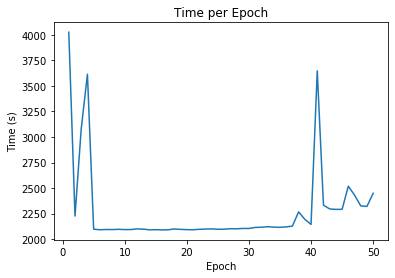

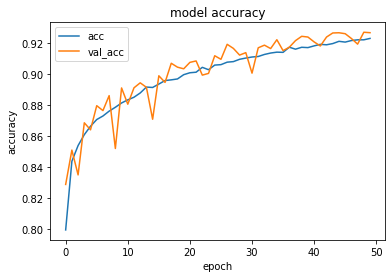

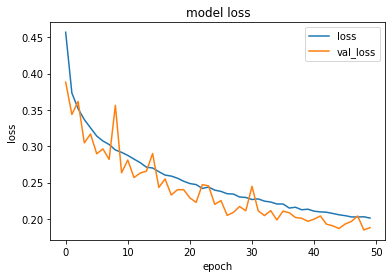

In [0]:
plt.plot(list(range(1,EPCG)),time_callback.times)
plt.title('Time per Epoch')
plt.xlabel("Epoch")
plt.ylabel("Time (s)")
print('done saving time calculation graph')
plt.show()

plt.plot(training.history['acc'], label='acc')
plt.plot(training.history['val_acc'], label='val_acc')
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(loc='best')
plt.show()

plt.plot(training.history['loss'], label='loss')
plt.plot(training.history['val_loss'], label='val_loss')
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(loc='best')
plt.show()

In [0]:
#model's name --> model.save('ai_net_model_cancer_prediction.h5')

from keras.models import load_model
my_model = load_model('./model_2_final.h5')
print('done load model')

done load model


In [0]:
valid_generator.reset()
my_prediction = my_model.predict_generator(valid_generator, verbose=1, steps= np.ceil(valid_generator.n/valid_generator.batch_size))
print(my_prediction)

 815/2130 [==========>...................] - ETA: 15:1 - ETA: 9:5 - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 7: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ETA: 6: - ET

1630/2130 [=====================>........] - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 

2130/2130 [==============================] - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 

(array([29217.,  5070.,  2439.,  1653.,  1169.,  1077.,  1247.,  2018.,
         3555., 18562.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ],
       dtype=float32),
 <a list of 10 Patch objects>)

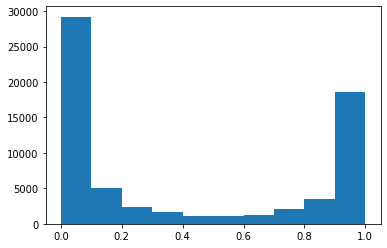

In [0]:
#plt.hist(my_prediction, bins = np.arange(0, 1.1, 0.01))
plt.hist(my_prediction)

In [0]:
y_true = valid_generator.classes
print(y_true)

[0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 

In [0]:
y_pred = 1*(my_prediction > 0.5)
#y_pred = (probas <0.5).astype(np.int)
print(y_pred)
print ('')

[[1]
 [1]
 [0]
 ...
 [0]
 [1]
 [1]]



In [0]:
from sklearn.metrics import confusion_matrix, cohen_kappa_score, classification_report

cm = confusion_matrix(y_true, y_pred)
print('Confusion Matrix:')
print(cm)

cr = classification_report(y_true, y_pred)
print('Classification Report:')
print(cr)

Confusion Matrix:
[[37058  2252]
 [ 2490 24207]]
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.94      0.94     39310
           1       0.91      0.91      0.91     26697

   micro avg       0.93      0.93      0.93     66007
   macro avg       0.93      0.92      0.93     66007
weighted avg       0.93      0.93      0.93     66007



In [0]:
from sklearn.metrics import accuracy_score
acc = accuracy_score(y_true, (y_pred))
print(acc)
print('accuracy with decision point {:.4f} ==> {:.4f}' .format(0.5, acc))

0.9281591346372354
accuracy with decision point 0.5000 ==> 0.9282


(array([14999.,  3672.,  2462.,  1819.,  1429.,  1220.,  1095.,   947.,
          817.,   757.,   710.,   673.,   574.,   557.,   524.,   473.,
          409.,   440.,   375.,   335.,   351.,   317.,   253.,   241.,
          241.,   241.,   193.,   198.,   217.,   187.,   174.,   173.,
          161.,   167.,   161.,   151.,   151.,   231.,   146.,   138.,
          125.,   121.,   121.,   118.,   119.,   110.,   118.,   112.,
          119.,   106.,    99.,   128.,   114.,   114.,   100.,   119.,
          112.,    93.,    98.,   100.,   112.,   117.,   115.,   129.,
          119.,   135.,   142.,   125.,   142.,   111.,   149.,   132.,
          159.,   145.,   191.,   224.,   218.,   272.,   257.,   271.,
          283.,   279.,   326.,   321.,   347.,   349.,   344.,   426.,
          424.,   456.,   465.,   517.,   581.,   602.,   756.,   808.,
         1023.,  1306.,  2062.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 0.13, 0.

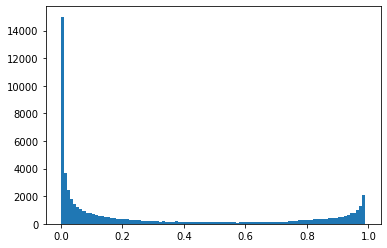

In [0]:
plt.hist(my_prediction, bins = np.arange(0, 1, 0.01))

In [0]:
dp = 0.55
cm = confusion_matrix(y_true, (my_prediction > dp))
print((my_prediction > dp))
print('')

print('Confusion Matrix:')
print(cm)
print('')

cr = classification_report(y_true, (my_prediction > dp))
print('Classification Report:')
print(cr)
print('')

[[ True]
 [False]
 [False]
 ...
 [False]
 [ True]
 [ True]]

Confusion Matrix:
[[37337  1973]
 [ 2766 23931]]

Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.95      0.94     39310
           1       0.92      0.90      0.91     26697

   micro avg       0.93      0.93      0.93     66007
   macro avg       0.93      0.92      0.93     66007
weighted avg       0.93      0.93      0.93     66007




In [0]:
from sklearn.metrics import accuracy_score
acc = accuracy_score(y_true, (y_pred))
print(acc)
print('accuracy with old decision point {:.4f} ==> {:.4f}' .format(dp, acc))

0.9281591346372354
accuracy with old decision point 0.5500 ==> 0.9282


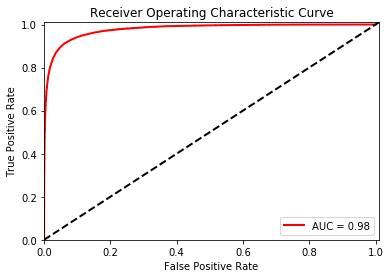

In [0]:
from sklearn.metrics import roc_curve


fpr, tpr, thresholds = roc_curve(y_true, my_prediction) 
roc_auc = metrics.auc(fpr, tpr)

plt.plot(fpr, tpr, color='red', lw = 2, label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1.01], [0, 1.01], color='black', lw = 2, linestyle='--')
plt.xlim([0, 1.01])
plt.ylim([0, 1.01])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic Curve')
plt.show()

# VISUALIZATION

In [0]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 96, 96, 64)        256       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 96, 96, 64)        4160      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 48, 48, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 48, 48, 128)       8320      
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 48, 48, 128)       16512     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 24, 24, 128)       0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 24, 24, 256)       33024     
__________

(1, 96, 96, 3)


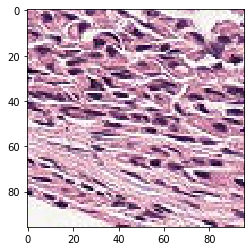

In [0]:
img_path = './test/0a0a85db9218e366569c913185cc0740f59f4d9e.tif'

from keras.preprocessing import image

img = image.load_img(img_path, target_size=(96, 96))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor /= 255.
print(img_tensor.shape)
plt.imshow(img_tensor[0])
plt.show()

In [0]:
from keras import models
layer_outputs = [layer.output for layer in model.layers[:8]]
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)
activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 96, 96, 64)


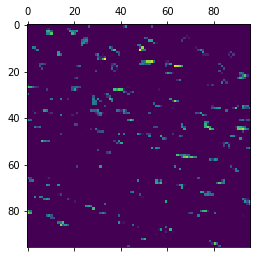

In [0]:
plt.matshow(first_layer_activation[0, :, :, 1], cmap='viridis')

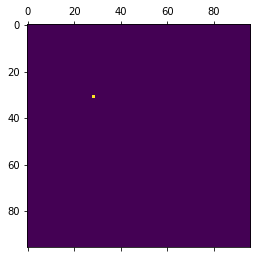

In [0]:
plt.matshow(first_layer_activation[0, :, :, 2], cmap='viridis')

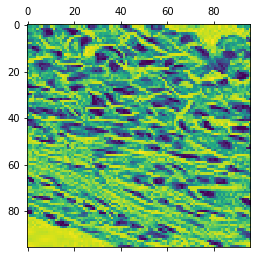

In [0]:
plt.matshow(first_layer_activation[0, :, :, 3], cmap='viridis')

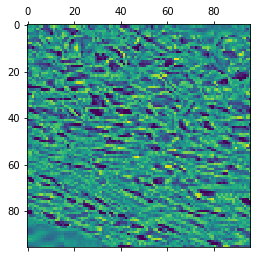

In [0]:
plt.matshow(first_layer_activation[0, :, :, 4], cmap='viridis')

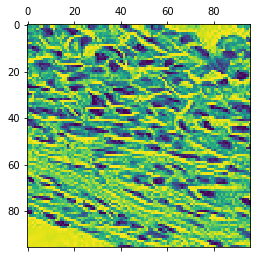

In [0]:
plt.matshow(first_layer_activation[0, :, :, 5], cmap='viridis')

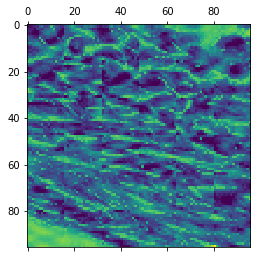

In [0]:
plt.matshow(first_layer_activation[0, :, :, 6], cmap='viridis')

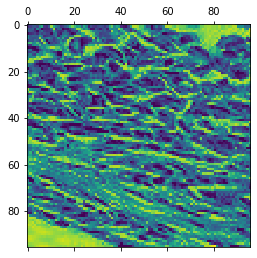

In [0]:
plt.matshow(first_layer_activation[0, :, :, 7], cmap='viridis')

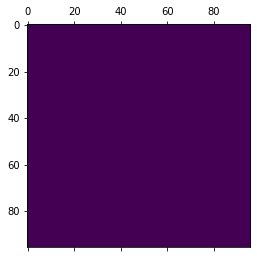

In [0]:
plt.matshow(first_layer_activation[0, :, :, 8], cmap='viridis')

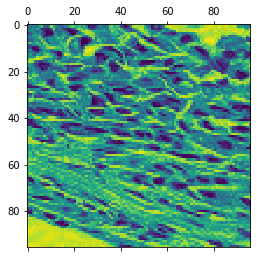

In [0]:
plt.matshow(first_layer_activation[0, :, :, 9], cmap='viridis')

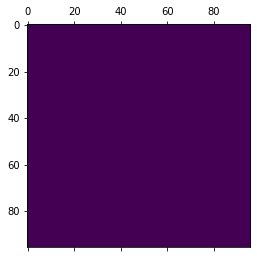

In [0]:
plt.matshow(first_layer_activation[0, :, :, 63], cmap='viridis')

In [0]:
layer_names = []
for layer in model.layers[:8]:
  layer_names.append(layer.name)
  
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
  n_features = layer_activation.shape[-1]
  size = layer_activation.shape[1]
  n_cols = n_features // images_per_row
  display_grid = np.zeros((size * n_cols, images_per_row * size))
  
  for col in range (n_cols):
    for row in range (images_per_row):
      channel_image = layer_activation[0, :, :, col * images_per_row + row ]
      channel_image -= channel_image.mean()
      channel_image /= channel_image.std()
      channel_image *= 128
      channel_image += 128
      channel_image = np.clip(channel_image, 0, 255).astype('uint8')
      display_grid[col*size:(col+1)*size, 
                   row*size:(row+1)*size] = channel_image
      
  scale = 1./size
  plt.figure(figsize=(scale*display_grid.shape[1], 
                    scale*display_grid.shape[0]))
  plt.title(layer_name)
  plt.grid(False)
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
  

In [0]:
layer_names = []
for layer in model.layers[8:16]:
  layer_names.append(layer.name)
  
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
  n_features = layer_activation.shape[-1]
  size = layer_activation.shape[1]
  n_cols = n_features // images_per_row
  display_grid = np.zeros((size * n_cols, images_per_row * size))
  
  for col in range (n_cols):
    for row in range (images_per_row):
      channel_image = layer_activation[0, :, :, col * images_per_row + row ]
      channel_image -= channel_image.mean()
      channel_image /= channel_image.std()
      channel_image *= 128
      channel_image += 128
      channel_image = np.clip(channel_image, 0, 255).astype('uint8')
      display_grid[col*size:(col+1)*size, 
                   row*size:(row+1)*size] = channel_image
      
  scale = 1./size
  plt.figure(figsize=(scale*display_grid.shape[1], 
                    scale*display_grid.shape[0]))
  plt.title(layer_name)
  plt.grid(False)
  plt.imshow(display_grid, aspect='auto', cmap='viridis')

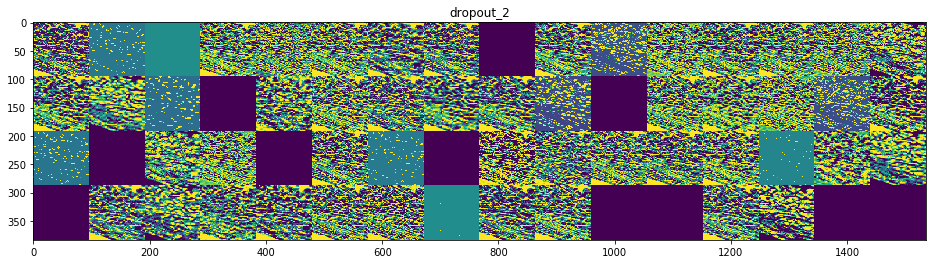

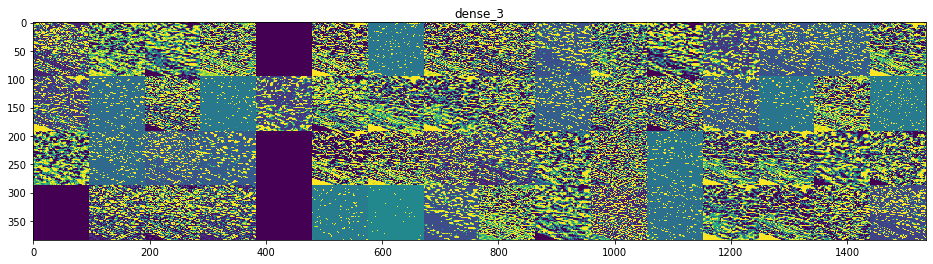

In [0]:
layer_names = []
for layer in model.layers[16:24]:
  layer_names.append(layer.name)
  
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations):
  n_features = layer_activation.shape[-1]
  size = layer_activation.shape[1]
  n_cols = n_features // images_per_row
  display_grid = np.zeros((size * n_cols, images_per_row * size))
  
  for col in range (n_cols):
    for row in range (images_per_row):
      channel_image = layer_activation[0, :, :, col * images_per_row + row ]
      channel_image -= channel_image.mean()
      channel_image /= channel_image.std()
      channel_image *= 128
      channel_image += 128
      channel_image = np.clip(channel_image, 0, 255).astype('uint8')
      display_grid[col*size:(col+1)*size, 
                   row*size:(row+1)*size] = channel_image
      
  scale = 1./size
  plt.figure(figsize=(scale*display_grid.shape[1], 
                    scale*display_grid.shape[0]))
  plt.title(layer_name)
  plt.grid(False)
  plt.imshow(display_grid, aspect='auto', cmap='viridis')